# Task : To identify if an image shows a healthy cassava leaf or does it shoe an unhealthy leaf with particular disease
Input: 21397 RGB images with 800x600 resolution


In [1]:
import os, sys


DATA_DIR = "../input/cassava-leaf-disease-classification/"
os.listdir(DATA_DIR)

pytorch_image_model_path = "../input/pytorchimagemodels/pytorch-image-models-master"

sys.path.append(pytorch_image_model_path)

In [2]:
from PIL import Image
import torch
import torchvision

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.cuda.amp import autocast, GradScaler

import timm

import pandas as pd
import numpy as np
import random

from tqdm import tqdm

import matplotlib.pyplot as plt
import json

import time

from sklearn.model_selection import StratifiedKFold, StratifiedShuffleSplit

In [3]:
torch.backends.cudnn.enabled

True

In [4]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


# Configs

In [5]:
train_label = DATA_DIR+"train.csv"
label_mapping = DATA_DIR+"label_num_to_disease_map.json"
train_images = DATA_DIR+"train_images/"
validate_images = DATA_DIR+"test_images/"
predicted_label = DATA_DIR+"predictions.csv"

kaggle_model_path = "/kaggle/working/model_%s_fold_%d_epoch_%d.pth"


input_size = 512
seed = 320
batch_size_train = 16
batch_size_test = 32
num_workers = 4
test_data_size = 0.02

num_epoch = 10
num_of_folds = 4
accum_iter = 2

lr = 1e-4
weight_decay = 1e-6


model_architecture = 'tf_efficientnet_b3_ns'

# Reading the data
## 1. Labels on the files
    > Looks like data is imbalaced with class 3 being dominant

In [6]:
df_train = pd.read_csv(train_label)
df_train.head()

,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3


In [7]:
df_train.shape

(21397, 2)

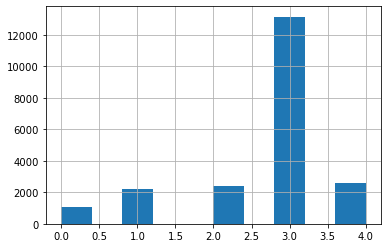

In [8]:
df_train["label"].hist()

### Validation images : There is only 1 validation image given. Rest will be shown only after submission

In [9]:
validation_images = os.listdir(validate_images)
print(validation_images)

['2216849948.jpg']


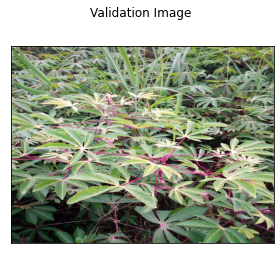

In [10]:
fig = plt.figure(figsize = (4,4))
for idx, image_file in enumerate(validation_images):
    ax = fig.add_subplot(1, 1, idx+1)
    ax.imshow(Image.open(validate_images+image_file))
    ax.set_xticks([])
    ax.set_yticks([])
fig.tight_layout()
fig.suptitle("Validation Image")

fig.show()

## 2. Mapping of the labels to disease name
> So, '3': 'Cassava Mosaic Disease (CMD)' is the dominant one

In [11]:
with open(label_mapping) as f:
    label_dict = json.load(f)


In [12]:
label_dict

{'0': 'Cassava Bacterial Blight (CBB)',
 '1': 'Cassava Brown Streak Disease (CBSD)',
 '2': 'Cassava Green Mottle (CGM)',
 '3': 'Cassava Mosaic Disease (CMD)',
 '4': 'Healthy'}

## 3. Looking at the examples of the diseases

In [13]:
df_train.iloc[0].image_id

'1000015157.jpg'

In [14]:
for image_file in df_train.sample(100)["image_id"]:
    print(Image.open(train_images+image_file).size)

(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)


(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)


(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)
(800, 600)


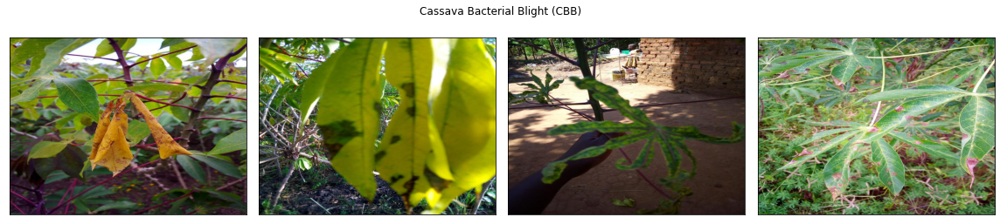

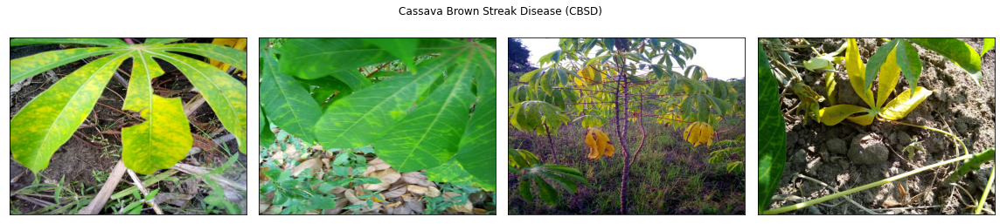

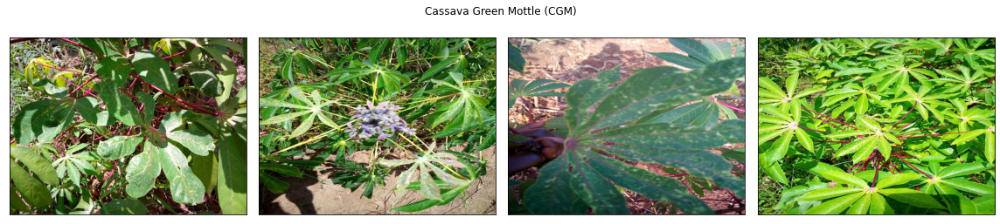

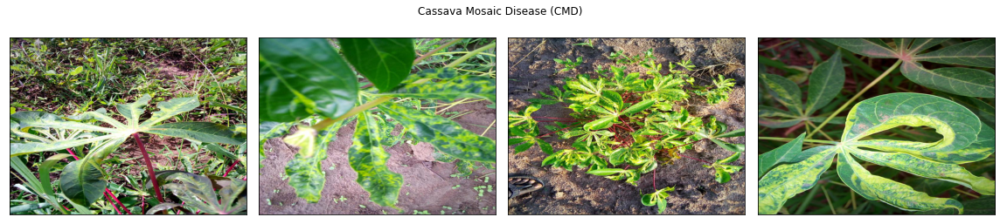

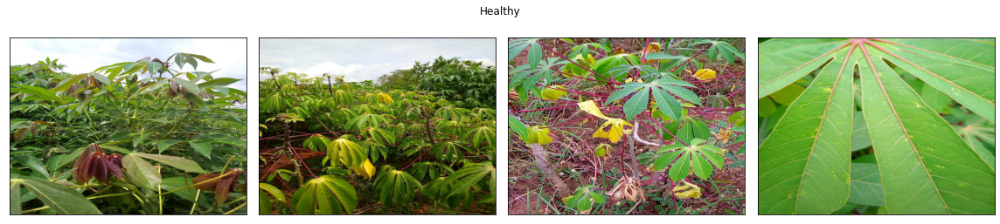

In [15]:
num_images = 4

figsize = 4
for target_label in range(5):
    sampled_images =  df_train[df_train["label"] == target_label].sample(num_images)["image_id"].to_list()
    fig = plt.figure(figsize = (num_images*figsize, figsize))

    for idx, image_file in enumerate(sampled_images):
        ax = fig.add_subplot(1, num_images, idx+1)
        ax.imshow(Image.open(train_images+image_file))
        ax.set_xticks([])
        ax.set_yticks([])
    fig.tight_layout()
    fig.suptitle(label_dict[str(target_label)])
    fig.show()

# Preparation of Dataset
### Train/Validation image augmentation

In [16]:
from albumentations import (
    HorizontalFlip, VerticalFlip, IAAPerspective, ShiftScaleRotate, CLAHE, RandomRotate90,
    Transpose, ShiftScaleRotate, Blur, OpticalDistortion, GridDistortion, HueSaturationValue,
    IAAAdditiveGaussianNoise, GaussNoise, MotionBlur, MedianBlur, IAAPiecewiseAffine, RandomResizedCrop,
    IAASharpen, IAAEmboss, RandomBrightnessContrast, Flip, OneOf, Compose, Normalize, Cutout, CoarseDropout, ShiftScaleRotate, CenterCrop, Resize
)

from albumentations.pytorch import ToTensorV2

def get_train_transforms():
    return Compose([
            RandomResizedCrop(input_size, input_size),
            Transpose(p=0.5),
            HorizontalFlip(p=0.5),
            VerticalFlip(p=0.5),
            ShiftScaleRotate(p=0.5),
            HueSaturationValue(hue_shift_limit=0.2, sat_shift_limit=0.2, val_shift_limit=0.2, p=0.5),
            RandomBrightnessContrast(brightness_limit=(-0.1,0.1), contrast_limit=(-0.1, 0.1), p=0.5),
            Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225], max_pixel_value=255.0, p=1.0),
            CoarseDropout(p=0.5),
            Cutout(p=0.5),
            ToTensorV2(p=1.0),
        ], p=1.)
  
        
def get_valid_transforms():
    return Compose([
            CenterCrop(input_size, input_size, p=1.),
            Resize(input_size,input_size),
            Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225], max_pixel_value=255.0, p=1.0),
            ToTensorV2(p=1.0),
        ], p=1.)

In [17]:
class CassavaDataset(torch.utils.data.Dataset):
    
    def __init__(self, df, data_dir, transformations = None, output_labels = True):
        """
            df: dataframe
            data_dir: directory where images are stored
            transformations: transformations applied to images
            output_labels: to output labels or not 
        """
        super().__init__()
        self.df = df.copy()
        self.transformations = transformations
        self.data_dir = data_dir
        self.output_labels = output_labels
        if self.output_labels:
            self.labels = df["label"].values
    
    def __len__(self):
        return self.df.shape[0]
    
    def __getitem__(self, index: int):
        img = np.asarray(Image.open(self.data_dir+self.df.loc[index]["image_id"]))
        if self.transformations:
            img = self.transformations(image = img)["image"]
        if self.output_labels:
            return img, self.labels[index]
        else:
            return img
            

In [18]:
def get_dataloader(df, train_idx, test_idx, data_dir, transformations):
    """
    df: total input dataset containg image filename and target labels
    train_idx: indices for train data
    test_idx: indices for test data
    data_dir: directory for the images
    """
    
    df_train = df.loc[train_idx].reset_index(drop=True)
    df_test = df.loc[test_idx].reset_index(drop=True)
    
    train_dataset = CassavaDataset(df_train, data_dir, transformations, output_labels = True)
    test_dataset = CassavaDataset(df_test, data_dir, transformations, output_labels = True)
    
    train_loader = torch.utils.data.DataLoader(train_dataset, 
                                               batch_size = batch_size_train,
                                               pin_memory = False, 
                                               shuffle = True,
                                               num_workers = num_workers
                                               )
    test_loader = torch.utils.data.DataLoader(test_dataset, 
                                               batch_size = batch_size_test,
                                               pin_memory = False, 
                                               shuffle = True,
                                               num_workers = num_workers
                                               )
    
    return train_loader, test_loader


    

# Designing the model and supplementary functions

In [19]:
class CassavaClassifier(nn.Module):
    def __init__(self, model_architecture, n_class, pretrained = False):
        super().__init__()
        self.model = timm.create_model(model_architecture, pretrained = pretrained)
        n_features = self.model.classifier.in_features
        self.model.classifier = nn.Linear(n_features, n_class)
        
    def forward(self, x):
        x = self.model(x)
        return x

In [20]:
def train_one_epoch(epoch, model, loss_func, optimizer, train_loader, device, 
                    scheduler = None, scheduler_update = False, loss_array = None):
    
    
    progressbar = tqdm(enumerate(train_loader), total=len(train_loader))
    epoch_loss = 0
    sample_num = 0
    
    for step, (images, image_labels) in progressbar:
        images = images.to(device).float()
        image_labels = image_labels.to(device).long()
        
        with autocast():
            image_predictions = model(images)
            
            loss = loss_func(image_predictions, image_labels)
        
        scaler.scale(loss).backward()
        
        epoch_loss += loss.item()*image_labels.shape[0]
        sample_num += image_labels.shape[0]
        
        if ((step+1)% accum_iter == 0) or ((step+1) == len(train_loader)):
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()
        
        progressbar.set_description(f"epoch {epoch} \tloss:{loss.item():.4f}")
        
        if scheduler is not None and scheduler_update:
            scheduler.step()
    
    epoch_loss /= sample_num
    
    print(f"Epoch {epoch} \tloss {epoch_loss}")
    
    if loss_array is not None:
        loss_array.append(epoch_loss)
        

            

def test_one_epoch(epoch, model, loss_func, test_loader, device, 
                  scheduler = None, scheduler_update = False, loss_array = None):
    
    # evaluate model
    model.eval()
    
    loss_sum = 0
    total_images = 0
    total_correct = 0
    
    progressbar = tqdm(enumerate(test_loader), total=len(test_loader))
    
    for step, (images, image_labels) in progressbar:
        images = images.to(device).float()
        image_labels = image_labels.to(device).long()
        
        image_preds = model(images)
        
        loss = loss_func(image_preds, image_labels)
        
        image_preds = image_preds.detach().cpu().data.max(1, keepdim=True)[1]
        image_labels = image_labels.detach().cpu()
        
        correct = image_preds.eq(image_labels.view_as(image_preds)).sum()
        
        loss_sum += loss
        total_images += image_labels.shape[0]
        total_correct += correct
        
        progressbar.set_description(f"Test epoch {epoch} \tloss:{loss:.4f} \t accuracy:{correct/image_labels.shape[0]}")
        
        images.detach().cpu()
        image_labels.detach().cpu()
        
    
    print("Test accuracy = {:.4f} \t  {:d}/{:d}".format(total_correct/total_images,
                                                                total_correct,
                                                                total_images))
        
    

In [21]:
def initialize_network(device):
    model = CassavaClassifier(model_architecture, df_train.label.nunique(), pretrained = True).to(device)
    optimizer = optim.Adam(model.parameters(), lr = lr, weight_decay = weight_decay)
    scaler = GradScaler()
    exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=4, gamma=0.95)
    
    return model, optimizer, scaler, exp_lr_scheduler

def set_seed(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True

def fold_progressbar(fold, num_of_fold, charlen = 20):
    fold += 1
    print(f"Fold :|{'#'*int(fold/num_of_fold*charlen)}{' '*int((1-fold/num_of_fold)*charlen)}| \t{fold}/{num_of_fold}")

# Training the model

In [22]:
folds = StratifiedShuffleSplit(n_splits = num_of_folds, random_state = seed,
                              test_size = test_data_size).split(
            np.zeros(df_train.shape[0]), df_train.label.values)

scheduler_update = True
fold_loss_dict = {}

for fold, (train_idx, test_idx) in enumerate(folds):
    
    set_seed(seed+fold)
    
    fold_progressbar(fold, num_of_folds)
    
    model, optimizer, scaler, scheduler = initialize_network(device)
    
    # get the data loaders
    train_loader, test_loader = get_dataloader(df_train, train_idx, test_idx, train_images, 
                                               get_train_transforms())
    
    loss_func = nn.CrossEntropyLoss().to(device)
    loss_test = nn.CrossEntropyLoss().to(device)
    
    loss_array = []
    
    for epoch in range(num_epoch):
        
        train_one_epoch(epoch, model, loss_func, optimizer, train_loader, device, 
                        scheduler, 
                        scheduler_update, loss_array = loss_array)
        
        with torch.no_grad():
            test_one_epoch(epoch, model, loss_test, test_loader, device, 
                           scheduler, 
                           False)
        
        torch.save(model.state_dict(), kaggle_model_path%(model_architecture,
                                                                       fold, 
                                                                       epoch))
    
    fold_loss_dict[fold] = loss_array
    
    if fold+1 >= num_of_folds:
        del optimizer, train_loader, test_loader, scaler, scheduler
    else:
        del model, optimizer, train_loader, test_loader, scaler, scheduler
    torch.cuda.empty_cache()

Fold :|#####               | 	1/4


Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_b3_ns-9d44bf68.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_b3_ns-9d44bf68.pth


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 0 	loss:1.6108:   0%|          | 0/1311 [00:04<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/torch/optim/lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
epoch 0 	loss:1.6108:   0%|          | 1/1311 [00:04<1:37:53,  4.48s/it]

epoch 0 	loss:1.6034:   0%|          | 1/1311 [00:05<1:37:53,  4.48s/it]

epoch 0 	loss:1.6034:   0%|          | 2/1311 [00:05<1:12:41,  3.33s/it]

epoch 0 	loss:1.5837:   0%|          | 2/1311 [00:05<1:12:41,  3.33s/it]

epoch 0 	loss:1.5837:   0%|          | 3/1311 [00:05<54:23,  2.50s/it]  

epoch 0 	loss:1.5921:   0%|          | 3/1311 [00:06<54:23,  2.50s/it]

epoch 0 	loss:1.5921:   0%|          | 4/1311 [00:06<42:23,  1.95s/it]

epoch 0 	loss:1.5585:   0%|          | 4/1311 [00:06<42:23,  1.95s/it]

epoch 0 	loss:1.5585:   0%|          | 5/1311 [00:06<33:27,  1.54s/it]

epoch 0 	loss:1.5763:   0%|          | 5/1311 [00:07<33:27,  1.54s/it]

epoch 0 	loss:1.5763:   0%|          | 6/1311 [00:07<27:39,  1.27s/it]

epoch 0 	loss:1.5525:   0%|          | 6/1311 [00:08<27:39,  1.27s/it]

epoch 0 	loss:1.5525:   1%|          | 7/1311 [00:08<22:57,  1.06s/it]

epoch 0 	loss:1.5425:   1%|          | 7/1311 [00:08<22:57,  1.06s/it]

epoch 0 	loss:1.5425:   1%|          | 8/1311 [00:08<20:09,  1.08it/s]

epoch 0 	loss:1.4934:   1%|          | 8/1311 [00:09<20:09,  1.08it/s]

epoch 0 	loss:1.4934:   1%|          | 9/1311 [00:09<17:35,  1.23it/s]

epoch 0 	loss:1.4872:   1%|          | 9/1311 [00:09<17:35,  1.23it/s]

epoch 0 	loss:1.4872:   1%|          | 10/1311 [00:09<16:31,  1.31it/s]

epoch 0 	loss:1.5090:   1%|          | 10/1311 [00:10<16:31,  1.31it/s]

epoch 0 	loss:1.5090:   1%|          | 11/1311 [00:10<14:59,  1.45it/s]

epoch 0 	loss:1.5274:   1%|          | 11/1311 [00:11<14:59,  1.45it/s]

epoch 0 	loss:1.5274:   1%|          | 12/1311 [00:11<15:10,  1.43it/s]

epoch 0 	loss:1.4441:   1%|          | 12/1311 [00:11<15:10,  1.43it/s]

epoch 0 	loss:1.4441:   1%|          | 13/1311 [00:11<14:17,  1.51it/s]

epoch 0 	loss:1.4802:   1%|          | 13/1311 [00:12<14:17,  1.51it/s]

epoch 0 	loss:1.4802:   1%|          | 14/1311 [00:12<14:36,  1.48it/s]

epoch 0 	loss:1.4096:   1%|          | 14/1311 [00:13<14:36,  1.48it/s]

epoch 0 	loss:1.4096:   1%|          | 15/1311 [00:13<13:49,  1.56it/s]

epoch 0 	loss:1.4627:   1%|          | 15/1311 [00:13<13:49,  1.56it/s]

epoch 0 	loss:1.4627:   1%|          | 16/1311 [00:13<13:39,  1.58it/s]

epoch 0 	loss:1.3944:   1%|          | 16/1311 [00:14<13:39,  1.58it/s]

epoch 0 	loss:1.3944:   1%|▏         | 17/1311 [00:14<13:05,  1.65it/s]

epoch 0 	loss:1.3599:   1%|▏         | 17/1311 [00:14<13:05,  1.65it/s]

epoch 0 	loss:1.3599:   1%|▏         | 18/1311 [00:14<13:20,  1.62it/s]

epoch 0 	loss:1.3185:   1%|▏         | 18/1311 [00:15<13:20,  1.62it/s]

epoch 0 	loss:1.3185:   1%|▏         | 19/1311 [00:15<12:47,  1.68it/s]

epoch 0 	loss:1.3134:   1%|▏         | 19/1311 [00:16<12:47,  1.68it/s]

epoch 0 	loss:1.3134:   2%|▏         | 20/1311 [00:16<13:01,  1.65it/s]

epoch 0 	loss:1.3377:   2%|▏         | 20/1311 [00:16<13:01,  1.65it/s]

epoch 0 	loss:1.3377:   2%|▏         | 21/1311 [00:16<12:43,  1.69it/s]

epoch 0 	loss:1.4271:   2%|▏         | 21/1311 [00:17<12:43,  1.69it/s]

epoch 0 	loss:1.4271:   2%|▏         | 22/1311 [00:17<13:24,  1.60it/s]

epoch 0 	loss:1.3886:   2%|▏         | 22/1311 [00:17<13:24,  1.60it/s]

epoch 0 	loss:1.3886:   2%|▏         | 23/1311 [00:17<13:05,  1.64it/s]

epoch 0 	loss:1.3166:   2%|▏         | 23/1311 [00:18<13:05,  1.64it/s]

epoch 0 	loss:1.3166:   2%|▏         | 24/1311 [00:18<13:24,  1.60it/s]

epoch 0 	loss:1.5225:   2%|▏         | 24/1311 [00:19<13:24,  1.60it/s]

epoch 0 	loss:1.5225:   2%|▏         | 25/1311 [00:19<12:49,  1.67it/s]

epoch 0 	loss:1.4914:   2%|▏         | 25/1311 [00:19<12:49,  1.67it/s]

epoch 0 	loss:1.4914:   2%|▏         | 26/1311 [00:19<13:05,  1.64it/s]

epoch 0 	loss:1.2182:   2%|▏         | 26/1311 [00:20<13:05,  1.64it/s]

epoch 0 	loss:1.2182:   2%|▏         | 27/1311 [00:20<12:44,  1.68it/s]

epoch 0 	loss:1.1894:   2%|▏         | 27/1311 [00:20<12:44,  1.68it/s]

epoch 0 	loss:1.1894:   2%|▏         | 28/1311 [00:20<13:08,  1.63it/s]

epoch 0 	loss:1.3120:   2%|▏         | 28/1311 [00:21<13:08,  1.63it/s]

epoch 0 	loss:1.3120:   2%|▏         | 29/1311 [00:21<12:36,  1.70it/s]

epoch 0 	loss:1.3554:   2%|▏         | 29/1311 [00:22<12:36,  1.70it/s]

epoch 0 	loss:1.3554:   2%|▏         | 30/1311 [00:22<13:04,  1.63it/s]

epoch 0 	loss:1.2065:   2%|▏         | 30/1311 [00:22<13:04,  1.63it/s]

epoch 0 	loss:1.2065:   2%|▏         | 31/1311 [00:22<12:44,  1.67it/s]

epoch 0 	loss:1.2991:   2%|▏         | 31/1311 [00:23<12:44,  1.67it/s]

epoch 0 	loss:1.2991:   2%|▏         | 32/1311 [00:23<13:03,  1.63it/s]

epoch 0 	loss:1.3540:   2%|▏         | 32/1311 [00:23<13:03,  1.63it/s]

epoch 0 	loss:1.3540:   3%|▎         | 33/1311 [00:23<12:47,  1.67it/s]

epoch 0 	loss:1.3300:   3%|▎         | 33/1311 [00:24<12:47,  1.67it/s]

epoch 0 	loss:1.3300:   3%|▎         | 34/1311 [00:24<12:54,  1.65it/s]

epoch 0 	loss:1.1058:   3%|▎         | 34/1311 [00:25<12:54,  1.65it/s]

epoch 0 	loss:1.1058:   3%|▎         | 35/1311 [00:25<12:26,  1.71it/s]

epoch 0 	loss:1.3214:   3%|▎         | 35/1311 [00:25<12:26,  1.71it/s]

epoch 0 	loss:1.3214:   3%|▎         | 36/1311 [00:25<12:47,  1.66it/s]

epoch 0 	loss:1.1619:   3%|▎         | 36/1311 [00:26<12:47,  1.66it/s]

epoch 0 	loss:1.1619:   3%|▎         | 37/1311 [00:26<12:26,  1.71it/s]

epoch 0 	loss:1.2307:   3%|▎         | 37/1311 [00:26<12:26,  1.71it/s]

epoch 0 	loss:1.2307:   3%|▎         | 38/1311 [00:26<12:40,  1.67it/s]

epoch 0 	loss:1.0771:   3%|▎         | 38/1311 [00:27<12:40,  1.67it/s]

epoch 0 	loss:1.0771:   3%|▎         | 39/1311 [00:27<12:28,  1.70it/s]

epoch 0 	loss:1.2048:   3%|▎         | 39/1311 [00:28<12:28,  1.70it/s]

epoch 0 	loss:1.2048:   3%|▎         | 40/1311 [00:28<13:25,  1.58it/s]

epoch 0 	loss:1.0578:   3%|▎         | 40/1311 [00:28<13:25,  1.58it/s]

epoch 0 	loss:1.0578:   3%|▎         | 41/1311 [00:28<12:51,  1.65it/s]

epoch 0 	loss:1.2800:   3%|▎         | 41/1311 [00:29<12:51,  1.65it/s]

epoch 0 	loss:1.2800:   3%|▎         | 42/1311 [00:29<13:06,  1.61it/s]

epoch 0 	loss:1.0206:   3%|▎         | 42/1311 [00:29<13:06,  1.61it/s]

epoch 0 	loss:1.0206:   3%|▎         | 43/1311 [00:29<12:41,  1.67it/s]

epoch 0 	loss:1.0205:   3%|▎         | 43/1311 [00:30<12:41,  1.67it/s]

epoch 0 	loss:1.0205:   3%|▎         | 44/1311 [00:30<12:58,  1.63it/s]

epoch 0 	loss:1.3368:   3%|▎         | 44/1311 [00:31<12:58,  1.63it/s]

epoch 0 	loss:1.3368:   3%|▎         | 45/1311 [00:31<12:32,  1.68it/s]

epoch 0 	loss:1.1222:   3%|▎         | 45/1311 [00:31<12:32,  1.68it/s]

epoch 0 	loss:1.1222:   4%|▎         | 46/1311 [00:31<12:42,  1.66it/s]

epoch 0 	loss:1.1540:   4%|▎         | 46/1311 [00:32<12:42,  1.66it/s]

epoch 0 	loss:1.1540:   4%|▎         | 47/1311 [00:32<12:27,  1.69it/s]

epoch 0 	loss:1.2862:   4%|▎         | 47/1311 [00:32<12:27,  1.69it/s]

epoch 0 	loss:1.2862:   4%|▎         | 48/1311 [00:32<12:42,  1.66it/s]

epoch 0 	loss:0.9519:   4%|▎         | 48/1311 [00:33<12:42,  1.66it/s]

epoch 0 	loss:0.9519:   4%|▎         | 49/1311 [00:33<12:16,  1.71it/s]

epoch 0 	loss:1.1082:   4%|▎         | 49/1311 [00:34<12:16,  1.71it/s]

epoch 0 	loss:1.1082:   4%|▍         | 50/1311 [00:34<12:46,  1.64it/s]

epoch 0 	loss:1.1202:   4%|▍         | 50/1311 [00:34<12:46,  1.64it/s]

epoch 0 	loss:1.1202:   4%|▍         | 51/1311 [00:34<12:43,  1.65it/s]

epoch 0 	loss:1.2810:   4%|▍         | 51/1311 [00:35<12:43,  1.65it/s]

epoch 0 	loss:1.2810:   4%|▍         | 52/1311 [00:35<12:54,  1.63it/s]

epoch 0 	loss:1.2973:   4%|▍         | 52/1311 [00:35<12:54,  1.63it/s]

epoch 0 	loss:1.2973:   4%|▍         | 53/1311 [00:35<12:36,  1.66it/s]

epoch 0 	loss:1.3316:   4%|▍         | 53/1311 [00:36<12:36,  1.66it/s]

epoch 0 	loss:1.3316:   4%|▍         | 54/1311 [00:36<12:46,  1.64it/s]

epoch 0 	loss:1.1494:   4%|▍         | 54/1311 [00:37<12:46,  1.64it/s]

epoch 0 	loss:1.1494:   4%|▍         | 55/1311 [00:37<12:22,  1.69it/s]

epoch 0 	loss:1.0598:   4%|▍         | 55/1311 [00:37<12:22,  1.69it/s]

epoch 0 	loss:1.0598:   4%|▍         | 56/1311 [00:37<12:39,  1.65it/s]

epoch 0 	loss:1.0963:   4%|▍         | 56/1311 [00:38<12:39,  1.65it/s]

epoch 0 	loss:1.0963:   4%|▍         | 57/1311 [00:38<12:21,  1.69it/s]

epoch 0 	loss:1.1485:   4%|▍         | 57/1311 [00:39<12:21,  1.69it/s]

epoch 0 	loss:1.1485:   4%|▍         | 58/1311 [00:39<13:21,  1.56it/s]

epoch 0 	loss:0.8757:   4%|▍         | 58/1311 [00:39<13:21,  1.56it/s]

epoch 0 	loss:0.8757:   5%|▍         | 59/1311 [00:39<12:54,  1.62it/s]

epoch 0 	loss:0.9632:   5%|▍         | 59/1311 [00:40<12:54,  1.62it/s]

epoch 0 	loss:0.9632:   5%|▍         | 60/1311 [00:40<13:52,  1.50it/s]

epoch 0 	loss:0.9616:   5%|▍         | 60/1311 [00:40<13:52,  1.50it/s]

epoch 0 	loss:0.9616:   5%|▍         | 61/1311 [00:40<13:06,  1.59it/s]

epoch 0 	loss:1.0165:   5%|▍         | 61/1311 [00:41<13:06,  1.59it/s]

epoch 0 	loss:1.0165:   5%|▍         | 62/1311 [00:41<12:45,  1.63it/s]

epoch 0 	loss:1.0846:   5%|▍         | 62/1311 [00:42<12:45,  1.63it/s]

epoch 0 	loss:1.0846:   5%|▍         | 63/1311 [00:42<12:23,  1.68it/s]

epoch 0 	loss:1.1480:   5%|▍         | 63/1311 [00:42<12:23,  1.68it/s]

epoch 0 	loss:1.1480:   5%|▍         | 64/1311 [00:42<12:33,  1.65it/s]

epoch 0 	loss:1.0643:   5%|▍         | 64/1311 [00:43<12:33,  1.65it/s]

epoch 0 	loss:1.0643:   5%|▍         | 65/1311 [00:43<12:24,  1.67it/s]

epoch 0 	loss:1.1994:   5%|▍         | 65/1311 [00:44<12:24,  1.67it/s]

epoch 0 	loss:1.1994:   5%|▌         | 66/1311 [00:44<13:43,  1.51it/s]

epoch 0 	loss:1.2448:   5%|▌         | 66/1311 [00:44<13:43,  1.51it/s]

epoch 0 	loss:1.2448:   5%|▌         | 67/1311 [00:44<13:34,  1.53it/s]

epoch 0 	loss:0.9976:   5%|▌         | 67/1311 [00:45<13:34,  1.53it/s]

epoch 0 	loss:0.9976:   5%|▌         | 68/1311 [00:45<12:58,  1.60it/s]

epoch 0 	loss:0.8935:   5%|▌         | 68/1311 [00:45<12:58,  1.60it/s]

epoch 0 	loss:0.8935:   5%|▌         | 69/1311 [00:45<12:32,  1.65it/s]

epoch 0 	loss:1.3529:   5%|▌         | 69/1311 [00:46<12:32,  1.65it/s]

epoch 0 	loss:1.3529:   5%|▌         | 70/1311 [00:46<12:35,  1.64it/s]

epoch 0 	loss:0.9721:   5%|▌         | 70/1311 [00:46<12:35,  1.64it/s]

epoch 0 	loss:0.9721:   5%|▌         | 71/1311 [00:46<12:08,  1.70it/s]

epoch 0 	loss:0.9943:   5%|▌         | 71/1311 [00:47<12:08,  1.70it/s]

epoch 0 	loss:0.9943:   5%|▌         | 72/1311 [00:47<12:22,  1.67it/s]

epoch 0 	loss:1.0119:   5%|▌         | 72/1311 [00:48<12:22,  1.67it/s]

epoch 0 	loss:1.0119:   6%|▌         | 73/1311 [00:48<11:55,  1.73it/s]

epoch 0 	loss:0.9829:   6%|▌         | 73/1311 [00:48<11:55,  1.73it/s]

epoch 0 	loss:0.9829:   6%|▌         | 74/1311 [00:48<12:29,  1.65it/s]

epoch 0 	loss:0.8122:   6%|▌         | 74/1311 [00:49<12:29,  1.65it/s]

epoch 0 	loss:0.8122:   6%|▌         | 75/1311 [00:49<11:59,  1.72it/s]

epoch 0 	loss:1.0470:   6%|▌         | 75/1311 [00:50<11:59,  1.72it/s]

epoch 0 	loss:1.0470:   6%|▌         | 76/1311 [00:50<12:43,  1.62it/s]

epoch 0 	loss:1.1861:   6%|▌         | 76/1311 [00:50<12:43,  1.62it/s]

epoch 0 	loss:1.1861:   6%|▌         | 77/1311 [00:50<12:15,  1.68it/s]

epoch 0 	loss:1.4168:   6%|▌         | 77/1311 [00:51<12:15,  1.68it/s]

epoch 0 	loss:1.4168:   6%|▌         | 78/1311 [00:51<12:54,  1.59it/s]

epoch 0 	loss:0.8935:   6%|▌         | 78/1311 [00:51<12:54,  1.59it/s]

epoch 0 	loss:0.8935:   6%|▌         | 79/1311 [00:51<12:21,  1.66it/s]

epoch 0 	loss:1.0314:   6%|▌         | 79/1311 [00:52<12:21,  1.66it/s]

epoch 0 	loss:1.0314:   6%|▌         | 80/1311 [00:52<12:36,  1.63it/s]

epoch 0 	loss:1.0386:   6%|▌         | 80/1311 [00:53<12:36,  1.63it/s]

epoch 0 	loss:1.0386:   6%|▌         | 81/1311 [00:53<12:10,  1.68it/s]

epoch 0 	loss:1.0575:   6%|▌         | 81/1311 [00:53<12:10,  1.68it/s]

epoch 0 	loss:1.0575:   6%|▋         | 82/1311 [00:53<12:26,  1.65it/s]

epoch 0 	loss:1.0589:   6%|▋         | 82/1311 [00:54<12:26,  1.65it/s]

epoch 0 	loss:1.0589:   6%|▋         | 83/1311 [00:54<11:58,  1.71it/s]

epoch 0 	loss:1.0797:   6%|▋         | 83/1311 [00:54<11:58,  1.71it/s]

epoch 0 	loss:1.0797:   6%|▋         | 84/1311 [00:54<12:33,  1.63it/s]

epoch 0 	loss:1.0193:   6%|▋         | 84/1311 [00:55<12:33,  1.63it/s]

epoch 0 	loss:1.0193:   6%|▋         | 85/1311 [00:55<12:11,  1.68it/s]

epoch 0 	loss:0.8066:   6%|▋         | 85/1311 [00:56<12:11,  1.68it/s]

epoch 0 	loss:0.8066:   7%|▋         | 86/1311 [00:56<12:36,  1.62it/s]

epoch 0 	loss:0.8935:   7%|▋         | 86/1311 [00:56<12:36,  1.62it/s]

epoch 0 	loss:0.8935:   7%|▋         | 87/1311 [00:56<12:02,  1.69it/s]

epoch 0 	loss:0.9580:   7%|▋         | 87/1311 [00:57<12:02,  1.69it/s]

epoch 0 	loss:0.9580:   7%|▋         | 88/1311 [00:57<12:16,  1.66it/s]

epoch 0 	loss:0.9369:   7%|▋         | 88/1311 [00:57<12:16,  1.66it/s]

epoch 0 	loss:0.9369:   7%|▋         | 89/1311 [00:57<11:52,  1.71it/s]

epoch 0 	loss:0.8550:   7%|▋         | 89/1311 [00:58<11:52,  1.71it/s]

epoch 0 	loss:0.8550:   7%|▋         | 90/1311 [00:58<12:02,  1.69it/s]

epoch 0 	loss:0.8034:   7%|▋         | 90/1311 [00:58<12:02,  1.69it/s]

epoch 0 	loss:0.8034:   7%|▋         | 91/1311 [00:58<11:39,  1.74it/s]

epoch 0 	loss:0.9594:   7%|▋         | 91/1311 [00:59<11:39,  1.74it/s]

epoch 0 	loss:0.9594:   7%|▋         | 92/1311 [00:59<11:56,  1.70it/s]

epoch 0 	loss:0.6364:   7%|▋         | 92/1311 [01:00<11:56,  1.70it/s]

epoch 0 	loss:0.6364:   7%|▋         | 93/1311 [01:00<11:38,  1.74it/s]

epoch 0 	loss:1.4887:   7%|▋         | 93/1311 [01:00<11:38,  1.74it/s]

epoch 0 	loss:1.4887:   7%|▋         | 94/1311 [01:00<12:03,  1.68it/s]

epoch 0 	loss:0.7288:   7%|▋         | 94/1311 [01:01<12:03,  1.68it/s]

epoch 0 	loss:0.7288:   7%|▋         | 95/1311 [01:01<11:41,  1.73it/s]

epoch 0 	loss:1.2048:   7%|▋         | 95/1311 [01:02<11:41,  1.73it/s]

epoch 0 	loss:1.2048:   7%|▋         | 96/1311 [01:02<12:48,  1.58it/s]

epoch 0 	loss:0.9037:   7%|▋         | 96/1311 [01:02<12:48,  1.58it/s]

epoch 0 	loss:0.9037:   7%|▋         | 97/1311 [01:02<12:30,  1.62it/s]

epoch 0 	loss:1.0813:   7%|▋         | 97/1311 [01:03<12:30,  1.62it/s]

epoch 0 	loss:1.0813:   7%|▋         | 98/1311 [01:03<12:33,  1.61it/s]

epoch 0 	loss:0.9461:   7%|▋         | 98/1311 [01:03<12:33,  1.61it/s]

epoch 0 	loss:0.9461:   8%|▊         | 99/1311 [01:03<12:01,  1.68it/s]

epoch 0 	loss:0.7687:   8%|▊         | 99/1311 [01:04<12:01,  1.68it/s]

epoch 0 	loss:0.7687:   8%|▊         | 100/1311 [01:04<12:23,  1.63it/s]

epoch 0 	loss:1.1308:   8%|▊         | 100/1311 [01:04<12:23,  1.63it/s]

epoch 0 	loss:1.1308:   8%|▊         | 101/1311 [01:04<11:56,  1.69it/s]

epoch 0 	loss:1.0083:   8%|▊         | 101/1311 [01:05<11:56,  1.69it/s]

epoch 0 	loss:1.0083:   8%|▊         | 102/1311 [01:05<12:06,  1.66it/s]

epoch 0 	loss:1.0434:   8%|▊         | 102/1311 [01:06<12:06,  1.66it/s]

epoch 0 	loss:1.0434:   8%|▊         | 103/1311 [01:06<11:41,  1.72it/s]

epoch 0 	loss:1.0004:   8%|▊         | 103/1311 [01:06<11:41,  1.72it/s]

epoch 0 	loss:1.0004:   8%|▊         | 104/1311 [01:06<11:56,  1.69it/s]

epoch 0 	loss:1.0246:   8%|▊         | 104/1311 [01:07<11:56,  1.69it/s]

epoch 0 	loss:1.0246:   8%|▊         | 105/1311 [01:07<11:43,  1.71it/s]

epoch 0 	loss:0.8853:   8%|▊         | 105/1311 [01:07<11:43,  1.71it/s]

epoch 0 	loss:0.8853:   8%|▊         | 106/1311 [01:07<11:58,  1.68it/s]

epoch 0 	loss:1.0931:   8%|▊         | 106/1311 [01:08<11:58,  1.68it/s]

epoch 0 	loss:1.0931:   8%|▊         | 107/1311 [01:08<11:40,  1.72it/s]

epoch 0 	loss:1.0250:   8%|▊         | 107/1311 [01:09<11:40,  1.72it/s]

epoch 0 	loss:1.0250:   8%|▊         | 108/1311 [01:09<12:07,  1.65it/s]

epoch 0 	loss:1.0889:   8%|▊         | 108/1311 [01:09<12:07,  1.65it/s]

epoch 0 	loss:1.0889:   8%|▊         | 109/1311 [01:09<11:39,  1.72it/s]

epoch 0 	loss:1.0050:   8%|▊         | 109/1311 [01:10<11:39,  1.72it/s]

epoch 0 	loss:1.0050:   8%|▊         | 110/1311 [01:10<11:50,  1.69it/s]

epoch 0 	loss:0.8745:   8%|▊         | 110/1311 [01:10<11:50,  1.69it/s]

epoch 0 	loss:0.8745:   8%|▊         | 111/1311 [01:10<11:40,  1.71it/s]

epoch 0 	loss:1.1385:   8%|▊         | 111/1311 [01:11<11:40,  1.71it/s]

epoch 0 	loss:1.1385:   9%|▊         | 112/1311 [01:11<12:02,  1.66it/s]

epoch 0 	loss:0.7585:   9%|▊         | 112/1311 [01:12<12:02,  1.66it/s]

epoch 0 	loss:0.7585:   9%|▊         | 113/1311 [01:12<11:35,  1.72it/s]

epoch 0 	loss:1.0777:   9%|▊         | 113/1311 [01:12<11:35,  1.72it/s]

epoch 0 	loss:1.0777:   9%|▊         | 114/1311 [01:12<12:24,  1.61it/s]

epoch 0 	loss:1.5309:   9%|▊         | 114/1311 [01:13<12:24,  1.61it/s]

epoch 0 	loss:1.5309:   9%|▉         | 115/1311 [01:13<12:08,  1.64it/s]

epoch 0 	loss:0.9001:   9%|▉         | 115/1311 [01:13<12:08,  1.64it/s]

epoch 0 	loss:0.9001:   9%|▉         | 116/1311 [01:14<12:25,  1.60it/s]

epoch 0 	loss:1.0838:   9%|▉         | 116/1311 [01:14<12:25,  1.60it/s]

epoch 0 	loss:1.0838:   9%|▉         | 117/1311 [01:14<11:52,  1.68it/s]

epoch 0 	loss:0.8508:   9%|▉         | 117/1311 [01:15<11:52,  1.68it/s]

epoch 0 	loss:0.8508:   9%|▉         | 118/1311 [01:15<12:33,  1.58it/s]

epoch 0 	loss:0.9169:   9%|▉         | 118/1311 [01:15<12:33,  1.58it/s]

epoch 0 	loss:0.9169:   9%|▉         | 119/1311 [01:15<12:05,  1.64it/s]

epoch 0 	loss:0.8257:   9%|▉         | 119/1311 [01:16<12:05,  1.64it/s]

epoch 0 	loss:0.8257:   9%|▉         | 120/1311 [01:16<12:56,  1.53it/s]

epoch 0 	loss:0.7877:   9%|▉         | 120/1311 [01:17<12:56,  1.53it/s]

epoch 0 	loss:0.7877:   9%|▉         | 121/1311 [01:17<12:16,  1.62it/s]

epoch 0 	loss:1.3095:   9%|▉         | 121/1311 [01:17<12:16,  1.62it/s]

epoch 0 	loss:1.3095:   9%|▉         | 122/1311 [01:17<12:22,  1.60it/s]

epoch 0 	loss:0.8267:   9%|▉         | 122/1311 [01:18<12:22,  1.60it/s]

epoch 0 	loss:0.8267:   9%|▉         | 123/1311 [01:18<11:59,  1.65it/s]

epoch 0 	loss:0.8342:   9%|▉         | 123/1311 [01:18<11:59,  1.65it/s]

epoch 0 	loss:0.8342:   9%|▉         | 124/1311 [01:18<12:07,  1.63it/s]

epoch 0 	loss:0.8079:   9%|▉         | 124/1311 [01:19<12:07,  1.63it/s]

epoch 0 	loss:0.8079:  10%|▉         | 125/1311 [01:19<11:40,  1.69it/s]

epoch 0 	loss:0.7123:  10%|▉         | 125/1311 [01:20<11:40,  1.69it/s]

epoch 0 	loss:0.7123:  10%|▉         | 126/1311 [01:20<11:51,  1.67it/s]

epoch 0 	loss:1.2544:  10%|▉         | 126/1311 [01:20<11:51,  1.67it/s]

epoch 0 	loss:1.2544:  10%|▉         | 127/1311 [01:20<11:30,  1.71it/s]

epoch 0 	loss:0.8574:  10%|▉         | 127/1311 [01:21<11:30,  1.71it/s]

epoch 0 	loss:0.8574:  10%|▉         | 128/1311 [01:21<11:46,  1.68it/s]

epoch 0 	loss:0.8858:  10%|▉         | 128/1311 [01:21<11:46,  1.68it/s]

epoch 0 	loss:0.8858:  10%|▉         | 129/1311 [01:21<11:33,  1.70it/s]

epoch 0 	loss:0.9776:  10%|▉         | 129/1311 [01:22<11:33,  1.70it/s]

epoch 0 	loss:0.9776:  10%|▉         | 130/1311 [01:22<12:02,  1.63it/s]

epoch 0 	loss:1.5531:  10%|▉         | 130/1311 [01:23<12:02,  1.63it/s]

epoch 0 	loss:1.5531:  10%|▉         | 131/1311 [01:23<11:33,  1.70it/s]

epoch 0 	loss:0.9088:  10%|▉         | 131/1311 [01:23<11:33,  1.70it/s]

epoch 0 	loss:0.9088:  10%|█         | 132/1311 [01:23<12:10,  1.61it/s]

epoch 0 	loss:0.8910:  10%|█         | 132/1311 [01:24<12:10,  1.61it/s]

epoch 0 	loss:0.8910:  10%|█         | 133/1311 [01:24<12:02,  1.63it/s]

epoch 0 	loss:0.9088:  10%|█         | 133/1311 [01:25<12:02,  1.63it/s]

epoch 0 	loss:0.9088:  10%|█         | 134/1311 [01:25<12:30,  1.57it/s]

epoch 0 	loss:0.8852:  10%|█         | 134/1311 [01:25<12:30,  1.57it/s]

epoch 0 	loss:0.8852:  10%|█         | 135/1311 [01:25<12:04,  1.62it/s]

epoch 0 	loss:1.1234:  10%|█         | 135/1311 [01:26<12:04,  1.62it/s]

epoch 0 	loss:1.1234:  10%|█         | 136/1311 [01:26<12:18,  1.59it/s]

epoch 0 	loss:0.7559:  10%|█         | 136/1311 [01:26<12:18,  1.59it/s]

epoch 0 	loss:0.7559:  10%|█         | 137/1311 [01:26<11:43,  1.67it/s]

epoch 0 	loss:0.6661:  10%|█         | 137/1311 [01:27<11:43,  1.67it/s]

epoch 0 	loss:0.6661:  11%|█         | 138/1311 [01:27<12:00,  1.63it/s]

epoch 0 	loss:0.8016:  11%|█         | 138/1311 [01:27<12:00,  1.63it/s]

epoch 0 	loss:0.8016:  11%|█         | 139/1311 [01:27<11:31,  1.69it/s]

epoch 0 	loss:0.8258:  11%|█         | 139/1311 [01:28<11:31,  1.69it/s]

epoch 0 	loss:0.8258:  11%|█         | 140/1311 [01:28<11:50,  1.65it/s]

epoch 0 	loss:1.2310:  11%|█         | 140/1311 [01:29<11:50,  1.65it/s]

epoch 0 	loss:1.2310:  11%|█         | 141/1311 [01:29<11:24,  1.71it/s]

epoch 0 	loss:0.7602:  11%|█         | 141/1311 [01:29<11:24,  1.71it/s]

epoch 0 	loss:0.7602:  11%|█         | 142/1311 [01:29<11:43,  1.66it/s]

epoch 0 	loss:1.0246:  11%|█         | 142/1311 [01:30<11:43,  1.66it/s]

epoch 0 	loss:1.0246:  11%|█         | 143/1311 [01:30<11:16,  1.73it/s]

epoch 0 	loss:1.0225:  11%|█         | 143/1311 [01:30<11:16,  1.73it/s]

epoch 0 	loss:1.0225:  11%|█         | 144/1311 [01:30<11:27,  1.70it/s]

epoch 0 	loss:0.7628:  11%|█         | 144/1311 [01:31<11:27,  1.70it/s]

epoch 0 	loss:0.7628:  11%|█         | 145/1311 [01:31<11:16,  1.72it/s]

epoch 0 	loss:0.7158:  11%|█         | 145/1311 [01:32<11:16,  1.72it/s]

epoch 0 	loss:0.7158:  11%|█         | 146/1311 [01:32<11:49,  1.64it/s]

epoch 0 	loss:1.3200:  11%|█         | 146/1311 [01:32<11:49,  1.64it/s]

epoch 0 	loss:1.3200:  11%|█         | 147/1311 [01:32<11:23,  1.70it/s]

epoch 0 	loss:0.8050:  11%|█         | 147/1311 [01:33<11:23,  1.70it/s]

epoch 0 	loss:0.8050:  11%|█▏        | 148/1311 [01:33<12:43,  1.52it/s]

epoch 0 	loss:0.9629:  11%|█▏        | 148/1311 [01:34<12:43,  1.52it/s]

epoch 0 	loss:0.9629:  11%|█▏        | 149/1311 [01:34<12:20,  1.57it/s]

epoch 0 	loss:0.8898:  11%|█▏        | 149/1311 [01:34<12:20,  1.57it/s]

epoch 0 	loss:0.8898:  11%|█▏        | 150/1311 [01:34<13:35,  1.42it/s]

epoch 0 	loss:1.3213:  11%|█▏        | 150/1311 [01:35<13:35,  1.42it/s]

epoch 0 	loss:1.3213:  12%|█▏        | 151/1311 [01:35<13:03,  1.48it/s]

epoch 0 	loss:0.9964:  12%|█▏        | 151/1311 [01:36<13:03,  1.48it/s]

epoch 0 	loss:0.9964:  12%|█▏        | 152/1311 [01:36<12:42,  1.52it/s]

epoch 0 	loss:0.7677:  12%|█▏        | 152/1311 [01:36<12:42,  1.52it/s]

epoch 0 	loss:0.7677:  12%|█▏        | 153/1311 [01:36<12:09,  1.59it/s]

epoch 0 	loss:0.8221:  12%|█▏        | 153/1311 [01:37<12:09,  1.59it/s]

epoch 0 	loss:0.8221:  12%|█▏        | 154/1311 [01:37<13:04,  1.48it/s]

epoch 0 	loss:0.8430:  12%|█▏        | 154/1311 [01:38<13:04,  1.48it/s]

epoch 0 	loss:0.8430:  12%|█▏        | 155/1311 [01:38<12:15,  1.57it/s]

epoch 0 	loss:1.1186:  12%|█▏        | 155/1311 [01:38<12:15,  1.57it/s]

epoch 0 	loss:1.1186:  12%|█▏        | 156/1311 [01:38<12:14,  1.57it/s]

epoch 0 	loss:0.8707:  12%|█▏        | 156/1311 [01:39<12:14,  1.57it/s]

epoch 0 	loss:0.8707:  12%|█▏        | 157/1311 [01:39<11:50,  1.62it/s]

epoch 0 	loss:1.0800:  12%|█▏        | 157/1311 [01:39<11:50,  1.62it/s]

epoch 0 	loss:1.0800:  12%|█▏        | 158/1311 [01:39<11:57,  1.61it/s]

epoch 0 	loss:1.0544:  12%|█▏        | 158/1311 [01:40<11:57,  1.61it/s]

epoch 0 	loss:1.0544:  12%|█▏        | 159/1311 [01:40<11:25,  1.68it/s]

epoch 0 	loss:0.8596:  12%|█▏        | 159/1311 [01:41<11:25,  1.68it/s]

epoch 0 	loss:0.8596:  12%|█▏        | 160/1311 [01:41<11:35,  1.65it/s]

epoch 0 	loss:0.9853:  12%|█▏        | 160/1311 [01:41<11:35,  1.65it/s]

epoch 0 	loss:0.9853:  12%|█▏        | 161/1311 [01:41<11:12,  1.71it/s]

epoch 0 	loss:1.0508:  12%|█▏        | 161/1311 [01:42<11:12,  1.71it/s]

epoch 0 	loss:1.0508:  12%|█▏        | 162/1311 [01:42<11:34,  1.65it/s]

epoch 0 	loss:0.6739:  12%|█▏        | 162/1311 [01:42<11:34,  1.65it/s]

epoch 0 	loss:0.6739:  12%|█▏        | 163/1311 [01:42<11:07,  1.72it/s]

epoch 0 	loss:0.9320:  12%|█▏        | 163/1311 [01:43<11:07,  1.72it/s]

epoch 0 	loss:0.9320:  13%|█▎        | 164/1311 [01:43<11:27,  1.67it/s]

epoch 0 	loss:0.7330:  13%|█▎        | 164/1311 [01:43<11:27,  1.67it/s]

epoch 0 	loss:0.7330:  13%|█▎        | 165/1311 [01:43<11:07,  1.72it/s]

epoch 0 	loss:0.8051:  13%|█▎        | 165/1311 [01:44<11:07,  1.72it/s]

epoch 0 	loss:0.8051:  13%|█▎        | 166/1311 [01:44<11:20,  1.68it/s]

epoch 0 	loss:0.8829:  13%|█▎        | 166/1311 [01:45<11:20,  1.68it/s]

epoch 0 	loss:0.8829:  13%|█▎        | 167/1311 [01:45<11:07,  1.71it/s]

epoch 0 	loss:0.8258:  13%|█▎        | 167/1311 [01:45<11:07,  1.71it/s]

epoch 0 	loss:0.8258:  13%|█▎        | 168/1311 [01:45<12:14,  1.56it/s]

epoch 0 	loss:0.9713:  13%|█▎        | 168/1311 [01:46<12:14,  1.56it/s]

epoch 0 	loss:0.9713:  13%|█▎        | 169/1311 [01:46<11:50,  1.61it/s]

epoch 0 	loss:0.7876:  13%|█▎        | 169/1311 [01:47<11:50,  1.61it/s]

epoch 0 	loss:0.7876:  13%|█▎        | 170/1311 [01:47<12:38,  1.50it/s]

epoch 0 	loss:0.6375:  13%|█▎        | 170/1311 [01:47<12:38,  1.50it/s]

epoch 0 	loss:0.6375:  13%|█▎        | 171/1311 [01:47<12:28,  1.52it/s]

epoch 0 	loss:0.8908:  13%|█▎        | 171/1311 [01:48<12:28,  1.52it/s]

epoch 0 	loss:0.8908:  13%|█▎        | 172/1311 [01:48<12:34,  1.51it/s]

epoch 0 	loss:0.9679:  13%|█▎        | 172/1311 [01:49<12:34,  1.51it/s]

epoch 0 	loss:0.9679:  13%|█▎        | 173/1311 [01:49<11:49,  1.60it/s]

epoch 0 	loss:1.3885:  13%|█▎        | 173/1311 [01:49<11:49,  1.60it/s]

epoch 0 	loss:1.3885:  13%|█▎        | 174/1311 [01:49<11:46,  1.61it/s]

epoch 0 	loss:1.0767:  13%|█▎        | 174/1311 [01:50<11:46,  1.61it/s]

epoch 0 	loss:1.0767:  13%|█▎        | 175/1311 [01:50<11:16,  1.68it/s]

epoch 0 	loss:1.0440:  13%|█▎        | 175/1311 [01:50<11:16,  1.68it/s]

epoch 0 	loss:1.0440:  13%|█▎        | 176/1311 [01:50<11:28,  1.65it/s]

epoch 0 	loss:1.0003:  13%|█▎        | 176/1311 [01:51<11:28,  1.65it/s]

epoch 0 	loss:1.0003:  14%|█▎        | 177/1311 [01:51<11:05,  1.70it/s]

epoch 0 	loss:0.9162:  14%|█▎        | 177/1311 [01:52<11:05,  1.70it/s]

epoch 0 	loss:0.9162:  14%|█▎        | 178/1311 [01:52<11:21,  1.66it/s]

epoch 0 	loss:0.8694:  14%|█▎        | 178/1311 [01:52<11:21,  1.66it/s]

epoch 0 	loss:0.8694:  14%|█▎        | 179/1311 [01:52<11:00,  1.71it/s]

epoch 0 	loss:0.6619:  14%|█▎        | 179/1311 [01:53<11:00,  1.71it/s]

epoch 0 	loss:0.6619:  14%|█▎        | 180/1311 [01:53<11:16,  1.67it/s]

epoch 0 	loss:0.7421:  14%|█▎        | 180/1311 [01:53<11:16,  1.67it/s]

epoch 0 	loss:0.7421:  14%|█▍        | 181/1311 [01:53<10:59,  1.71it/s]

epoch 0 	loss:1.1679:  14%|█▍        | 181/1311 [01:54<10:59,  1.71it/s]

epoch 0 	loss:1.1679:  14%|█▍        | 182/1311 [01:54<11:11,  1.68it/s]

epoch 0 	loss:0.9771:  14%|█▍        | 182/1311 [01:54<11:11,  1.68it/s]

epoch 0 	loss:0.9771:  14%|█▍        | 183/1311 [01:54<10:59,  1.71it/s]

epoch 0 	loss:1.2449:  14%|█▍        | 183/1311 [01:55<10:59,  1.71it/s]

epoch 0 	loss:1.2449:  14%|█▍        | 184/1311 [01:55<11:27,  1.64it/s]

epoch 0 	loss:0.8891:  14%|█▍        | 184/1311 [01:56<11:27,  1.64it/s]

epoch 0 	loss:0.8891:  14%|█▍        | 185/1311 [01:56<10:59,  1.71it/s]

epoch 0 	loss:1.1436:  14%|█▍        | 185/1311 [01:56<10:59,  1.71it/s]

epoch 0 	loss:1.1436:  14%|█▍        | 186/1311 [01:56<12:10,  1.54it/s]

epoch 0 	loss:0.7841:  14%|█▍        | 186/1311 [01:57<12:10,  1.54it/s]

epoch 0 	loss:0.7841:  14%|█▍        | 187/1311 [01:57<11:39,  1.61it/s]

epoch 0 	loss:1.0930:  14%|█▍        | 187/1311 [01:58<11:39,  1.61it/s]

epoch 0 	loss:1.0930:  14%|█▍        | 188/1311 [01:58<11:44,  1.59it/s]

epoch 0 	loss:0.9566:  14%|█▍        | 188/1311 [01:58<11:44,  1.59it/s]

epoch 0 	loss:0.9566:  14%|█▍        | 189/1311 [01:58<11:15,  1.66it/s]

epoch 0 	loss:1.3633:  14%|█▍        | 189/1311 [01:59<11:15,  1.66it/s]

epoch 0 	loss:1.3633:  14%|█▍        | 190/1311 [01:59<11:21,  1.65it/s]

epoch 0 	loss:0.7329:  14%|█▍        | 190/1311 [01:59<11:21,  1.65it/s]

epoch 0 	loss:0.7329:  15%|█▍        | 191/1311 [01:59<10:55,  1.71it/s]

epoch 0 	loss:1.0183:  15%|█▍        | 191/1311 [02:00<10:55,  1.71it/s]

epoch 0 	loss:1.0183:  15%|█▍        | 192/1311 [02:00<11:11,  1.67it/s]

epoch 0 	loss:0.9828:  15%|█▍        | 192/1311 [02:01<11:11,  1.67it/s]

epoch 0 	loss:0.9828:  15%|█▍        | 193/1311 [02:01<10:47,  1.73it/s]

epoch 0 	loss:0.7430:  15%|█▍        | 193/1311 [02:01<10:47,  1.73it/s]

epoch 0 	loss:0.7430:  15%|█▍        | 194/1311 [02:01<11:01,  1.69it/s]

epoch 0 	loss:0.8104:  15%|█▍        | 194/1311 [02:02<11:01,  1.69it/s]

epoch 0 	loss:0.8104:  15%|█▍        | 195/1311 [02:02<10:45,  1.73it/s]

epoch 0 	loss:1.2412:  15%|█▍        | 195/1311 [02:02<10:45,  1.73it/s]

epoch 0 	loss:1.2412:  15%|█▍        | 196/1311 [02:02<10:59,  1.69it/s]

epoch 0 	loss:0.7730:  15%|█▍        | 196/1311 [02:03<10:59,  1.69it/s]

epoch 0 	loss:0.7730:  15%|█▌        | 197/1311 [02:03<10:44,  1.73it/s]

epoch 0 	loss:0.7030:  15%|█▌        | 197/1311 [02:04<10:44,  1.73it/s]

epoch 0 	loss:0.7030:  15%|█▌        | 198/1311 [02:04<11:07,  1.67it/s]

epoch 0 	loss:0.8221:  15%|█▌        | 198/1311 [02:04<11:07,  1.67it/s]

epoch 0 	loss:0.8221:  15%|█▌        | 199/1311 [02:04<10:52,  1.70it/s]

epoch 0 	loss:1.2286:  15%|█▌        | 199/1311 [02:05<10:52,  1.70it/s]

epoch 0 	loss:1.2286:  15%|█▌        | 200/1311 [02:05<11:10,  1.66it/s]

epoch 0 	loss:0.8135:  15%|█▌        | 200/1311 [02:05<11:10,  1.66it/s]

epoch 0 	loss:0.8135:  15%|█▌        | 201/1311 [02:05<10:46,  1.72it/s]

epoch 0 	loss:0.8207:  15%|█▌        | 201/1311 [02:06<10:46,  1.72it/s]

epoch 0 	loss:0.8207:  15%|█▌        | 202/1311 [02:06<11:00,  1.68it/s]

epoch 0 	loss:1.0169:  15%|█▌        | 202/1311 [02:06<11:00,  1.68it/s]

epoch 0 	loss:1.0169:  15%|█▌        | 203/1311 [02:06<10:41,  1.73it/s]

epoch 0 	loss:0.7330:  15%|█▌        | 203/1311 [02:07<10:41,  1.73it/s]

epoch 0 	loss:0.7330:  16%|█▌        | 204/1311 [02:07<11:12,  1.65it/s]

epoch 0 	loss:0.9180:  16%|█▌        | 204/1311 [02:08<11:12,  1.65it/s]

epoch 0 	loss:0.9180:  16%|█▌        | 205/1311 [02:08<11:00,  1.67it/s]

epoch 0 	loss:0.7861:  16%|█▌        | 205/1311 [02:08<11:00,  1.67it/s]

epoch 0 	loss:0.7861:  16%|█▌        | 206/1311 [02:08<11:21,  1.62it/s]

epoch 0 	loss:0.7834:  16%|█▌        | 206/1311 [02:09<11:21,  1.62it/s]

epoch 0 	loss:0.7834:  16%|█▌        | 207/1311 [02:09<10:54,  1.69it/s]

epoch 0 	loss:1.0947:  16%|█▌        | 207/1311 [02:10<10:54,  1.69it/s]

epoch 0 	loss:1.0947:  16%|█▌        | 208/1311 [02:10<11:08,  1.65it/s]

epoch 0 	loss:0.8896:  16%|█▌        | 208/1311 [02:10<11:08,  1.65it/s]

epoch 0 	loss:0.8896:  16%|█▌        | 209/1311 [02:10<10:44,  1.71it/s]

epoch 0 	loss:0.9379:  16%|█▌        | 209/1311 [02:11<10:44,  1.71it/s]

epoch 0 	loss:0.9379:  16%|█▌        | 210/1311 [02:11<11:03,  1.66it/s]

epoch 0 	loss:1.1884:  16%|█▌        | 210/1311 [02:11<11:03,  1.66it/s]

epoch 0 	loss:1.1884:  16%|█▌        | 211/1311 [02:11<10:40,  1.72it/s]

epoch 0 	loss:0.8013:  16%|█▌        | 211/1311 [02:12<10:40,  1.72it/s]

epoch 0 	loss:0.8013:  16%|█▌        | 212/1311 [02:12<11:03,  1.66it/s]

epoch 0 	loss:0.8275:  16%|█▌        | 212/1311 [02:12<11:03,  1.66it/s]

epoch 0 	loss:0.8275:  16%|█▌        | 213/1311 [02:12<10:39,  1.72it/s]

epoch 0 	loss:0.7276:  16%|█▌        | 213/1311 [02:13<10:39,  1.72it/s]

epoch 0 	loss:0.7276:  16%|█▋        | 214/1311 [02:13<10:59,  1.66it/s]

epoch 0 	loss:0.5758:  16%|█▋        | 214/1311 [02:14<10:59,  1.66it/s]

epoch 0 	loss:0.5758:  16%|█▋        | 215/1311 [02:14<10:39,  1.71it/s]

epoch 0 	loss:1.0106:  16%|█▋        | 215/1311 [02:14<10:39,  1.71it/s]

epoch 0 	loss:1.0106:  16%|█▋        | 216/1311 [02:14<10:53,  1.68it/s]

epoch 0 	loss:1.2500:  16%|█▋        | 216/1311 [02:15<10:53,  1.68it/s]

epoch 0 	loss:1.2500:  17%|█▋        | 217/1311 [02:15<10:32,  1.73it/s]

epoch 0 	loss:0.7610:  17%|█▋        | 217/1311 [02:15<10:32,  1.73it/s]

epoch 0 	loss:0.7610:  17%|█▋        | 218/1311 [02:15<10:43,  1.70it/s]

epoch 0 	loss:0.8960:  17%|█▋        | 218/1311 [02:16<10:43,  1.70it/s]

epoch 0 	loss:0.8960:  17%|█▋        | 219/1311 [02:16<10:25,  1.75it/s]

epoch 0 	loss:0.9904:  17%|█▋        | 219/1311 [02:17<10:25,  1.75it/s]

epoch 0 	loss:0.9904:  17%|█▋        | 220/1311 [02:17<10:40,  1.70it/s]

epoch 0 	loss:1.0434:  17%|█▋        | 220/1311 [02:17<10:40,  1.70it/s]

epoch 0 	loss:1.0434:  17%|█▋        | 221/1311 [02:17<10:26,  1.74it/s]

epoch 0 	loss:0.6012:  17%|█▋        | 221/1311 [02:18<10:26,  1.74it/s]

epoch 0 	loss:0.6012:  17%|█▋        | 222/1311 [02:18<10:59,  1.65it/s]

epoch 0 	loss:1.2709:  17%|█▋        | 222/1311 [02:18<10:59,  1.65it/s]

epoch 0 	loss:1.2709:  17%|█▋        | 223/1311 [02:18<10:45,  1.68it/s]

epoch 0 	loss:1.1997:  17%|█▋        | 223/1311 [02:19<10:45,  1.68it/s]

epoch 0 	loss:1.1997:  17%|█▋        | 224/1311 [02:19<12:55,  1.40it/s]

epoch 0 	loss:0.9670:  17%|█▋        | 224/1311 [02:20<12:55,  1.40it/s]

epoch 0 	loss:0.9670:  17%|█▋        | 225/1311 [02:20<12:21,  1.46it/s]

epoch 0 	loss:0.6770:  17%|█▋        | 225/1311 [02:21<12:21,  1.46it/s]

epoch 0 	loss:0.6770:  17%|█▋        | 226/1311 [02:21<12:04,  1.50it/s]

epoch 0 	loss:1.0346:  17%|█▋        | 226/1311 [02:21<12:04,  1.50it/s]

epoch 0 	loss:1.0346:  17%|█▋        | 227/1311 [02:21<11:22,  1.59it/s]

epoch 0 	loss:0.6704:  17%|█▋        | 227/1311 [02:22<11:22,  1.59it/s]

epoch 0 	loss:0.6704:  17%|█▋        | 228/1311 [02:22<11:24,  1.58it/s]

epoch 0 	loss:0.8386:  17%|█▋        | 228/1311 [02:22<11:24,  1.58it/s]

epoch 0 	loss:0.8386:  17%|█▋        | 229/1311 [02:22<10:56,  1.65it/s]

epoch 0 	loss:1.0359:  17%|█▋        | 229/1311 [02:23<10:56,  1.65it/s]

epoch 0 	loss:1.0359:  18%|█▊        | 230/1311 [02:23<11:00,  1.64it/s]

epoch 0 	loss:0.9187:  18%|█▊        | 230/1311 [02:23<11:00,  1.64it/s]

epoch 0 	loss:0.9187:  18%|█▊        | 231/1311 [02:23<10:42,  1.68it/s]

epoch 0 	loss:1.0118:  18%|█▊        | 231/1311 [02:24<10:42,  1.68it/s]

epoch 0 	loss:1.0118:  18%|█▊        | 232/1311 [02:24<10:57,  1.64it/s]

epoch 0 	loss:0.5799:  18%|█▊        | 232/1311 [02:25<10:57,  1.64it/s]

epoch 0 	loss:0.5799:  18%|█▊        | 233/1311 [02:25<10:31,  1.71it/s]

epoch 0 	loss:1.1704:  18%|█▊        | 233/1311 [02:25<10:31,  1.71it/s]

epoch 0 	loss:1.1704:  18%|█▊        | 234/1311 [02:25<10:48,  1.66it/s]

epoch 0 	loss:1.1271:  18%|█▊        | 234/1311 [02:26<10:48,  1.66it/s]

epoch 0 	loss:1.1271:  18%|█▊        | 235/1311 [02:26<10:33,  1.70it/s]

epoch 0 	loss:0.7822:  18%|█▊        | 235/1311 [02:26<10:33,  1.70it/s]

epoch 0 	loss:0.7822:  18%|█▊        | 236/1311 [02:26<10:43,  1.67it/s]

epoch 0 	loss:1.0149:  18%|█▊        | 236/1311 [02:27<10:43,  1.67it/s]

epoch 0 	loss:1.0149:  18%|█▊        | 237/1311 [02:27<10:28,  1.71it/s]

epoch 0 	loss:0.9927:  18%|█▊        | 237/1311 [02:28<10:28,  1.71it/s]

epoch 0 	loss:0.9927:  18%|█▊        | 238/1311 [02:28<10:49,  1.65it/s]

epoch 0 	loss:1.0821:  18%|█▊        | 238/1311 [02:28<10:49,  1.65it/s]

epoch 0 	loss:1.0821:  18%|█▊        | 239/1311 [02:28<10:24,  1.72it/s]

epoch 0 	loss:1.2151:  18%|█▊        | 239/1311 [02:29<10:24,  1.72it/s]

epoch 0 	loss:1.2151:  18%|█▊        | 240/1311 [02:29<11:01,  1.62it/s]

epoch 0 	loss:0.6918:  18%|█▊        | 240/1311 [02:29<11:01,  1.62it/s]

epoch 0 	loss:0.6918:  18%|█▊        | 241/1311 [02:29<10:47,  1.65it/s]

epoch 0 	loss:1.3606:  18%|█▊        | 241/1311 [02:30<10:47,  1.65it/s]

epoch 0 	loss:1.3606:  18%|█▊        | 242/1311 [02:30<11:02,  1.61it/s]

epoch 0 	loss:1.5297:  18%|█▊        | 242/1311 [02:31<11:02,  1.61it/s]

epoch 0 	loss:1.5297:  19%|█▊        | 243/1311 [02:31<10:43,  1.66it/s]

epoch 0 	loss:0.8845:  19%|█▊        | 243/1311 [02:31<10:43,  1.66it/s]

epoch 0 	loss:0.8845:  19%|█▊        | 244/1311 [02:31<11:01,  1.61it/s]

epoch 0 	loss:0.9437:  19%|█▊        | 244/1311 [02:32<11:01,  1.61it/s]

epoch 0 	loss:0.9437:  19%|█▊        | 245/1311 [02:32<10:31,  1.69it/s]

epoch 0 	loss:1.1043:  19%|█▊        | 245/1311 [02:33<10:31,  1.69it/s]

epoch 0 	loss:1.1043:  19%|█▉        | 246/1311 [02:33<10:46,  1.65it/s]

epoch 0 	loss:0.6123:  19%|█▉        | 246/1311 [02:33<10:46,  1.65it/s]

epoch 0 	loss:0.6123:  19%|█▉        | 247/1311 [02:33<10:25,  1.70it/s]

epoch 0 	loss:0.9681:  19%|█▉        | 247/1311 [02:34<10:25,  1.70it/s]

epoch 0 	loss:0.9681:  19%|█▉        | 248/1311 [02:34<12:06,  1.46it/s]

epoch 0 	loss:0.8436:  19%|█▉        | 248/1311 [02:35<12:06,  1.46it/s]

epoch 0 	loss:0.8436:  19%|█▉        | 249/1311 [02:35<11:38,  1.52it/s]

epoch 0 	loss:1.4137:  19%|█▉        | 249/1311 [02:35<11:38,  1.52it/s]

epoch 0 	loss:1.4137:  19%|█▉        | 250/1311 [02:35<11:42,  1.51it/s]

epoch 0 	loss:0.8597:  19%|█▉        | 250/1311 [02:36<11:42,  1.51it/s]

epoch 0 	loss:0.8597:  19%|█▉        | 251/1311 [02:36<11:09,  1.58it/s]

epoch 0 	loss:0.9200:  19%|█▉        | 251/1311 [02:36<11:09,  1.58it/s]

epoch 0 	loss:0.9200:  19%|█▉        | 252/1311 [02:36<11:07,  1.59it/s]

epoch 0 	loss:0.9185:  19%|█▉        | 252/1311 [02:37<11:07,  1.59it/s]

epoch 0 	loss:0.9185:  19%|█▉        | 253/1311 [02:37<10:35,  1.67it/s]

epoch 0 	loss:0.8625:  19%|█▉        | 253/1311 [02:38<10:35,  1.67it/s]

epoch 0 	loss:0.8625:  19%|█▉        | 254/1311 [02:38<10:51,  1.62it/s]

epoch 0 	loss:0.9079:  19%|█▉        | 254/1311 [02:38<10:51,  1.62it/s]

epoch 0 	loss:0.9079:  19%|█▉        | 255/1311 [02:38<10:29,  1.68it/s]

epoch 0 	loss:0.8534:  19%|█▉        | 255/1311 [02:39<10:29,  1.68it/s]

epoch 0 	loss:0.8534:  20%|█▉        | 256/1311 [02:39<10:39,  1.65it/s]

epoch 0 	loss:0.7866:  20%|█▉        | 256/1311 [02:39<10:39,  1.65it/s]

epoch 0 	loss:0.7866:  20%|█▉        | 257/1311 [02:39<10:16,  1.71it/s]

epoch 0 	loss:0.9507:  20%|█▉        | 257/1311 [02:40<10:16,  1.71it/s]

epoch 0 	loss:0.9507:  20%|█▉        | 258/1311 [02:40<11:02,  1.59it/s]

epoch 0 	loss:0.6750:  20%|█▉        | 258/1311 [02:41<11:02,  1.59it/s]

epoch 0 	loss:0.6750:  20%|█▉        | 259/1311 [02:41<10:35,  1.66it/s]

epoch 0 	loss:1.0831:  20%|█▉        | 259/1311 [02:41<10:35,  1.66it/s]

epoch 0 	loss:1.0831:  20%|█▉        | 260/1311 [02:41<10:56,  1.60it/s]

epoch 0 	loss:0.8489:  20%|█▉        | 260/1311 [02:42<10:56,  1.60it/s]

epoch 0 	loss:0.8489:  20%|█▉        | 261/1311 [02:42<10:34,  1.65it/s]

epoch 0 	loss:0.8045:  20%|█▉        | 261/1311 [02:42<10:34,  1.65it/s]

epoch 0 	loss:0.8045:  20%|█▉        | 262/1311 [02:42<10:40,  1.64it/s]

epoch 0 	loss:0.6266:  20%|█▉        | 262/1311 [02:43<10:40,  1.64it/s]

epoch 0 	loss:0.6266:  20%|██        | 263/1311 [02:43<10:21,  1.69it/s]

epoch 0 	loss:0.6453:  20%|██        | 263/1311 [02:44<10:21,  1.69it/s]

epoch 0 	loss:0.6453:  20%|██        | 264/1311 [02:44<10:28,  1.67it/s]

epoch 0 	loss:0.7627:  20%|██        | 264/1311 [02:44<10:28,  1.67it/s]

epoch 0 	loss:0.7627:  20%|██        | 265/1311 [02:44<10:10,  1.71it/s]

epoch 0 	loss:1.2049:  20%|██        | 265/1311 [02:45<10:10,  1.71it/s]

epoch 0 	loss:1.2049:  20%|██        | 266/1311 [02:45<10:27,  1.67it/s]

epoch 0 	loss:0.8298:  20%|██        | 266/1311 [02:45<10:27,  1.67it/s]

epoch 0 	loss:0.8298:  20%|██        | 267/1311 [02:45<10:07,  1.72it/s]

epoch 0 	loss:0.8249:  20%|██        | 267/1311 [02:46<10:07,  1.72it/s]

epoch 0 	loss:0.8249:  20%|██        | 268/1311 [02:46<10:20,  1.68it/s]

epoch 0 	loss:0.9379:  20%|██        | 268/1311 [02:46<10:20,  1.68it/s]

epoch 0 	loss:0.9379:  21%|██        | 269/1311 [02:47<10:02,  1.73it/s]

epoch 0 	loss:0.9989:  21%|██        | 269/1311 [02:47<10:02,  1.73it/s]

epoch 0 	loss:0.9989:  21%|██        | 270/1311 [02:47<10:24,  1.67it/s]

epoch 0 	loss:0.9434:  21%|██        | 270/1311 [02:48<10:24,  1.67it/s]

epoch 0 	loss:0.9434:  21%|██        | 271/1311 [02:48<10:05,  1.72it/s]

epoch 0 	loss:0.5982:  21%|██        | 271/1311 [02:48<10:05,  1.72it/s]

epoch 0 	loss:0.5982:  21%|██        | 272/1311 [02:48<10:34,  1.64it/s]

epoch 0 	loss:0.8369:  21%|██        | 272/1311 [02:49<10:34,  1.64it/s]

epoch 0 	loss:0.8369:  21%|██        | 273/1311 [02:49<10:09,  1.70it/s]

epoch 0 	loss:0.8051:  21%|██        | 273/1311 [02:50<10:09,  1.70it/s]

epoch 0 	loss:0.8051:  21%|██        | 274/1311 [02:50<10:30,  1.65it/s]

epoch 0 	loss:0.8850:  21%|██        | 274/1311 [02:50<10:30,  1.65it/s]

epoch 0 	loss:0.8850:  21%|██        | 275/1311 [02:50<10:08,  1.70it/s]

epoch 0 	loss:0.7811:  21%|██        | 275/1311 [02:51<10:08,  1.70it/s]

epoch 0 	loss:0.7811:  21%|██        | 276/1311 [02:51<11:09,  1.55it/s]

epoch 0 	loss:0.5884:  21%|██        | 276/1311 [02:52<11:09,  1.55it/s]

epoch 0 	loss:0.5884:  21%|██        | 277/1311 [02:52<12:04,  1.43it/s]

epoch 0 	loss:0.8675:  21%|██        | 277/1311 [02:52<12:04,  1.43it/s]

epoch 0 	loss:0.8675:  21%|██        | 278/1311 [02:52<12:02,  1.43it/s]

epoch 0 	loss:0.9625:  21%|██        | 278/1311 [02:53<12:02,  1.43it/s]

epoch 0 	loss:0.9625:  21%|██▏       | 279/1311 [02:53<11:19,  1.52it/s]

epoch 0 	loss:0.7910:  21%|██▏       | 279/1311 [02:54<11:19,  1.52it/s]

epoch 0 	loss:0.7910:  21%|██▏       | 280/1311 [02:54<11:12,  1.53it/s]

epoch 0 	loss:0.9212:  21%|██▏       | 280/1311 [02:54<11:12,  1.53it/s]

epoch 0 	loss:0.9212:  21%|██▏       | 281/1311 [02:54<10:34,  1.62it/s]

epoch 0 	loss:0.9152:  21%|██▏       | 281/1311 [02:55<10:34,  1.62it/s]

epoch 0 	loss:0.9152:  22%|██▏       | 282/1311 [02:55<10:38,  1.61it/s]

epoch 0 	loss:0.8801:  22%|██▏       | 282/1311 [02:55<10:38,  1.61it/s]

epoch 0 	loss:0.8801:  22%|██▏       | 283/1311 [02:55<10:11,  1.68it/s]

epoch 0 	loss:0.8180:  22%|██▏       | 283/1311 [02:56<10:11,  1.68it/s]

epoch 0 	loss:0.8180:  22%|██▏       | 284/1311 [02:56<10:18,  1.66it/s]

epoch 0 	loss:0.7275:  22%|██▏       | 284/1311 [02:56<10:18,  1.66it/s]

epoch 0 	loss:0.7275:  22%|██▏       | 285/1311 [02:56<10:06,  1.69it/s]

epoch 0 	loss:0.9390:  22%|██▏       | 285/1311 [02:57<10:06,  1.69it/s]

epoch 0 	loss:0.9390:  22%|██▏       | 286/1311 [02:57<10:23,  1.64it/s]

epoch 0 	loss:0.6819:  22%|██▏       | 286/1311 [02:58<10:23,  1.64it/s]

epoch 0 	loss:0.6819:  22%|██▏       | 287/1311 [02:58<10:11,  1.67it/s]

epoch 0 	loss:0.6581:  22%|██▏       | 287/1311 [02:58<10:11,  1.67it/s]

epoch 0 	loss:0.6581:  22%|██▏       | 288/1311 [02:58<10:22,  1.64it/s]

epoch 0 	loss:0.8585:  22%|██▏       | 288/1311 [02:59<10:22,  1.64it/s]

epoch 0 	loss:0.8585:  22%|██▏       | 289/1311 [02:59<10:01,  1.70it/s]

epoch 0 	loss:0.8727:  22%|██▏       | 289/1311 [03:00<10:01,  1.70it/s]

epoch 0 	loss:0.8727:  22%|██▏       | 290/1311 [03:00<10:19,  1.65it/s]

epoch 0 	loss:0.9110:  22%|██▏       | 290/1311 [03:00<10:19,  1.65it/s]

epoch 0 	loss:0.9110:  22%|██▏       | 291/1311 [03:00<10:00,  1.70it/s]

epoch 0 	loss:0.8542:  22%|██▏       | 291/1311 [03:01<10:00,  1.70it/s]

epoch 0 	loss:0.8542:  22%|██▏       | 292/1311 [03:01<10:09,  1.67it/s]

epoch 0 	loss:0.9777:  22%|██▏       | 292/1311 [03:01<10:09,  1.67it/s]

epoch 0 	loss:0.9777:  22%|██▏       | 293/1311 [03:01<09:53,  1.71it/s]

epoch 0 	loss:0.7430:  22%|██▏       | 293/1311 [03:02<09:53,  1.71it/s]

epoch 0 	loss:0.7430:  22%|██▏       | 294/1311 [03:02<10:31,  1.61it/s]

epoch 0 	loss:1.0092:  22%|██▏       | 294/1311 [03:03<10:31,  1.61it/s]

epoch 0 	loss:1.0092:  23%|██▎       | 295/1311 [03:03<10:34,  1.60it/s]

epoch 0 	loss:0.8667:  23%|██▎       | 295/1311 [03:03<10:34,  1.60it/s]

epoch 0 	loss:0.8667:  23%|██▎       | 296/1311 [03:03<10:33,  1.60it/s]

epoch 0 	loss:1.4454:  23%|██▎       | 296/1311 [03:04<10:33,  1.60it/s]

epoch 0 	loss:1.4454:  23%|██▎       | 297/1311 [03:04<10:19,  1.64it/s]

epoch 0 	loss:0.7720:  23%|██▎       | 297/1311 [03:04<10:19,  1.64it/s]

epoch 0 	loss:0.7720:  23%|██▎       | 298/1311 [03:04<10:23,  1.62it/s]

epoch 0 	loss:1.2543:  23%|██▎       | 298/1311 [03:05<10:23,  1.62it/s]

epoch 0 	loss:1.2543:  23%|██▎       | 299/1311 [03:05<10:00,  1.68it/s]

epoch 0 	loss:0.7752:  23%|██▎       | 299/1311 [03:06<10:00,  1.68it/s]

epoch 0 	loss:0.7752:  23%|██▎       | 300/1311 [03:06<10:10,  1.66it/s]

epoch 0 	loss:0.9302:  23%|██▎       | 300/1311 [03:06<10:10,  1.66it/s]

epoch 0 	loss:0.9302:  23%|██▎       | 301/1311 [03:06<09:49,  1.71it/s]

epoch 0 	loss:1.1290:  23%|██▎       | 301/1311 [03:07<09:49,  1.71it/s]

epoch 0 	loss:1.1290:  23%|██▎       | 302/1311 [03:07<10:00,  1.68it/s]

epoch 0 	loss:0.9966:  23%|██▎       | 302/1311 [03:07<10:00,  1.68it/s]

epoch 0 	loss:0.9966:  23%|██▎       | 303/1311 [03:07<09:44,  1.73it/s]

epoch 0 	loss:0.6208:  23%|██▎       | 303/1311 [03:08<09:44,  1.73it/s]

epoch 0 	loss:0.6208:  23%|██▎       | 304/1311 [03:08<10:07,  1.66it/s]

epoch 0 	loss:1.1310:  23%|██▎       | 304/1311 [03:08<10:07,  1.66it/s]

epoch 0 	loss:1.1310:  23%|██▎       | 305/1311 [03:08<09:48,  1.71it/s]

epoch 0 	loss:0.6560:  23%|██▎       | 305/1311 [03:09<09:48,  1.71it/s]

epoch 0 	loss:0.6560:  23%|██▎       | 306/1311 [03:09<10:09,  1.65it/s]

epoch 0 	loss:0.7999:  23%|██▎       | 306/1311 [03:10<10:09,  1.65it/s]

epoch 0 	loss:0.7999:  23%|██▎       | 307/1311 [03:10<09:47,  1.71it/s]

epoch 0 	loss:1.0777:  23%|██▎       | 307/1311 [03:10<09:47,  1.71it/s]

epoch 0 	loss:1.0777:  23%|██▎       | 308/1311 [03:10<10:06,  1.65it/s]

epoch 0 	loss:0.6105:  23%|██▎       | 308/1311 [03:11<10:06,  1.65it/s]

epoch 0 	loss:0.6105:  24%|██▎       | 309/1311 [03:11<09:44,  1.72it/s]

epoch 0 	loss:0.7583:  24%|██▎       | 309/1311 [03:12<09:44,  1.72it/s]

epoch 0 	loss:0.7583:  24%|██▎       | 310/1311 [03:12<10:02,  1.66it/s]

epoch 0 	loss:0.7052:  24%|██▎       | 310/1311 [03:12<10:02,  1.66it/s]

epoch 0 	loss:0.7052:  24%|██▎       | 311/1311 [03:12<09:43,  1.72it/s]

epoch 0 	loss:0.9168:  24%|██▎       | 311/1311 [03:13<09:43,  1.72it/s]

epoch 0 	loss:0.9168:  24%|██▍       | 312/1311 [03:13<10:15,  1.62it/s]

epoch 0 	loss:0.9311:  24%|██▍       | 312/1311 [03:13<10:15,  1.62it/s]

epoch 0 	loss:0.9311:  24%|██▍       | 313/1311 [03:13<10:07,  1.64it/s]

epoch 0 	loss:0.8300:  24%|██▍       | 313/1311 [03:14<10:07,  1.64it/s]

epoch 0 	loss:0.8300:  24%|██▍       | 314/1311 [03:14<10:19,  1.61it/s]

epoch 0 	loss:1.0122:  24%|██▍       | 314/1311 [03:15<10:19,  1.61it/s]

epoch 0 	loss:1.0122:  24%|██▍       | 315/1311 [03:15<10:02,  1.65it/s]

epoch 0 	loss:0.9230:  24%|██▍       | 315/1311 [03:15<10:02,  1.65it/s]

epoch 0 	loss:0.9230:  24%|██▍       | 316/1311 [03:15<10:14,  1.62it/s]

epoch 0 	loss:1.0489:  24%|██▍       | 316/1311 [03:16<10:14,  1.62it/s]

epoch 0 	loss:1.0489:  24%|██▍       | 317/1311 [03:16<09:47,  1.69it/s]

epoch 0 	loss:0.8826:  24%|██▍       | 317/1311 [03:16<09:47,  1.69it/s]

epoch 0 	loss:0.8826:  24%|██▍       | 318/1311 [03:16<09:55,  1.67it/s]

epoch 0 	loss:1.0630:  24%|██▍       | 318/1311 [03:17<09:55,  1.67it/s]

epoch 0 	loss:1.0630:  24%|██▍       | 319/1311 [03:17<09:47,  1.69it/s]

epoch 0 	loss:0.8937:  24%|██▍       | 319/1311 [03:18<09:47,  1.69it/s]

epoch 0 	loss:0.8937:  24%|██▍       | 320/1311 [03:18<09:59,  1.65it/s]

epoch 0 	loss:0.8835:  24%|██▍       | 320/1311 [03:18<09:59,  1.65it/s]

epoch 0 	loss:0.8835:  24%|██▍       | 321/1311 [03:18<09:37,  1.72it/s]

epoch 0 	loss:0.7765:  24%|██▍       | 321/1311 [03:19<09:37,  1.72it/s]

epoch 0 	loss:0.7765:  25%|██▍       | 322/1311 [03:19<09:47,  1.68it/s]

epoch 0 	loss:0.6130:  25%|██▍       | 322/1311 [03:19<09:47,  1.68it/s]

epoch 0 	loss:0.6130:  25%|██▍       | 323/1311 [03:19<09:28,  1.74it/s]

epoch 0 	loss:0.8625:  25%|██▍       | 323/1311 [03:20<09:28,  1.74it/s]

epoch 0 	loss:0.8625:  25%|██▍       | 324/1311 [03:20<09:49,  1.67it/s]

epoch 0 	loss:0.8719:  25%|██▍       | 324/1311 [03:20<09:49,  1.67it/s]

epoch 0 	loss:0.8719:  25%|██▍       | 325/1311 [03:20<09:34,  1.72it/s]

epoch 0 	loss:0.7161:  25%|██▍       | 325/1311 [03:21<09:34,  1.72it/s]

epoch 0 	loss:0.7161:  25%|██▍       | 326/1311 [03:21<09:51,  1.67it/s]

epoch 0 	loss:0.7503:  25%|██▍       | 326/1311 [03:22<09:51,  1.67it/s]

epoch 0 	loss:0.7503:  25%|██▍       | 327/1311 [03:22<09:30,  1.73it/s]

epoch 0 	loss:0.6368:  25%|██▍       | 327/1311 [03:22<09:30,  1.73it/s]

epoch 0 	loss:0.6368:  25%|██▌       | 328/1311 [03:22<10:15,  1.60it/s]

epoch 0 	loss:0.7642:  25%|██▌       | 328/1311 [03:23<10:15,  1.60it/s]

epoch 0 	loss:0.7642:  25%|██▌       | 329/1311 [03:23<09:49,  1.67it/s]

epoch 0 	loss:0.9446:  25%|██▌       | 329/1311 [03:24<09:49,  1.67it/s]

epoch 0 	loss:0.9446:  25%|██▌       | 330/1311 [03:24<11:09,  1.46it/s]

epoch 0 	loss:1.0947:  25%|██▌       | 330/1311 [03:24<11:09,  1.46it/s]

epoch 0 	loss:1.0947:  25%|██▌       | 331/1311 [03:24<10:37,  1.54it/s]

epoch 0 	loss:0.7993:  25%|██▌       | 331/1311 [03:25<10:37,  1.54it/s]

epoch 0 	loss:0.7993:  25%|██▌       | 332/1311 [03:25<10:41,  1.52it/s]

epoch 0 	loss:0.8398:  25%|██▌       | 332/1311 [03:26<10:41,  1.52it/s]

epoch 0 	loss:0.8398:  25%|██▌       | 333/1311 [03:26<10:04,  1.62it/s]

epoch 0 	loss:0.8927:  25%|██▌       | 333/1311 [03:26<10:04,  1.62it/s]

epoch 0 	loss:0.8927:  25%|██▌       | 334/1311 [03:26<10:18,  1.58it/s]

epoch 0 	loss:0.8052:  25%|██▌       | 334/1311 [03:27<10:18,  1.58it/s]

epoch 0 	loss:0.8052:  26%|██▌       | 335/1311 [03:27<09:48,  1.66it/s]

epoch 0 	loss:0.8066:  26%|██▌       | 335/1311 [03:27<09:48,  1.66it/s]

epoch 0 	loss:0.8066:  26%|██▌       | 336/1311 [03:27<10:04,  1.61it/s]

epoch 0 	loss:0.7864:  26%|██▌       | 336/1311 [03:28<10:04,  1.61it/s]

epoch 0 	loss:0.7864:  26%|██▌       | 337/1311 [03:28<09:57,  1.63it/s]

epoch 0 	loss:0.6473:  26%|██▌       | 337/1311 [03:29<09:57,  1.63it/s]

epoch 0 	loss:0.6473:  26%|██▌       | 338/1311 [03:29<10:06,  1.60it/s]

epoch 0 	loss:1.1169:  26%|██▌       | 338/1311 [03:29<10:06,  1.60it/s]

epoch 0 	loss:1.1169:  26%|██▌       | 339/1311 [03:29<09:40,  1.67it/s]

epoch 0 	loss:0.9915:  26%|██▌       | 339/1311 [03:30<09:40,  1.67it/s]

epoch 0 	loss:0.9915:  26%|██▌       | 340/1311 [03:30<09:47,  1.65it/s]

epoch 0 	loss:0.9455:  26%|██▌       | 340/1311 [03:30<09:47,  1.65it/s]

epoch 0 	loss:0.9455:  26%|██▌       | 341/1311 [03:30<09:25,  1.72it/s]

epoch 0 	loss:1.0369:  26%|██▌       | 341/1311 [03:31<09:25,  1.72it/s]

epoch 0 	loss:1.0369:  26%|██▌       | 342/1311 [03:31<09:43,  1.66it/s]

epoch 0 	loss:0.7215:  26%|██▌       | 342/1311 [03:32<09:43,  1.66it/s]

epoch 0 	loss:0.7215:  26%|██▌       | 343/1311 [03:32<09:24,  1.71it/s]

epoch 0 	loss:0.7452:  26%|██▌       | 343/1311 [03:32<09:24,  1.71it/s]

epoch 0 	loss:0.7452:  26%|██▌       | 344/1311 [03:32<09:39,  1.67it/s]

epoch 0 	loss:1.0671:  26%|██▌       | 344/1311 [03:33<09:39,  1.67it/s]

epoch 0 	loss:1.0671:  26%|██▋       | 345/1311 [03:33<09:32,  1.69it/s]

epoch 0 	loss:1.1096:  26%|██▋       | 345/1311 [03:34<09:32,  1.69it/s]

epoch 0 	loss:1.1096:  26%|██▋       | 346/1311 [03:34<10:40,  1.51it/s]

epoch 0 	loss:0.8975:  26%|██▋       | 346/1311 [03:34<10:40,  1.51it/s]

epoch 0 	loss:0.8975:  26%|██▋       | 347/1311 [03:34<10:11,  1.58it/s]

epoch 0 	loss:0.7792:  26%|██▋       | 347/1311 [03:35<10:11,  1.58it/s]

epoch 0 	loss:0.7792:  27%|██▋       | 348/1311 [03:35<10:39,  1.51it/s]

epoch 0 	loss:0.7973:  27%|██▋       | 348/1311 [03:35<10:39,  1.51it/s]

epoch 0 	loss:0.7973:  27%|██▋       | 349/1311 [03:35<10:09,  1.58it/s]

epoch 0 	loss:0.7823:  27%|██▋       | 349/1311 [03:36<10:09,  1.58it/s]

epoch 0 	loss:0.7823:  27%|██▋       | 350/1311 [03:36<10:39,  1.50it/s]

epoch 0 	loss:0.7810:  27%|██▋       | 350/1311 [03:37<10:39,  1.50it/s]

epoch 0 	loss:0.7810:  27%|██▋       | 351/1311 [03:37<10:10,  1.57it/s]

epoch 0 	loss:0.9551:  27%|██▋       | 351/1311 [03:37<10:10,  1.57it/s]

epoch 0 	loss:0.9551:  27%|██▋       | 352/1311 [03:37<10:29,  1.52it/s]

epoch 0 	loss:0.8160:  27%|██▋       | 352/1311 [03:38<10:29,  1.52it/s]

epoch 0 	loss:0.8160:  27%|██▋       | 353/1311 [03:38<10:23,  1.54it/s]

epoch 0 	loss:1.0062:  27%|██▋       | 353/1311 [03:39<10:23,  1.54it/s]

epoch 0 	loss:1.0062:  27%|██▋       | 354/1311 [03:39<10:26,  1.53it/s]

epoch 0 	loss:0.8281:  27%|██▋       | 354/1311 [03:39<10:26,  1.53it/s]

epoch 0 	loss:0.8281:  27%|██▋       | 355/1311 [03:39<09:59,  1.59it/s]

epoch 0 	loss:0.8293:  27%|██▋       | 355/1311 [03:40<09:59,  1.59it/s]

epoch 0 	loss:0.8293:  27%|██▋       | 356/1311 [03:40<10:01,  1.59it/s]

epoch 0 	loss:1.3561:  27%|██▋       | 356/1311 [03:40<10:01,  1.59it/s]

epoch 0 	loss:1.3561:  27%|██▋       | 357/1311 [03:40<09:41,  1.64it/s]

epoch 0 	loss:1.2252:  27%|██▋       | 357/1311 [03:41<09:41,  1.64it/s]

epoch 0 	loss:1.2252:  27%|██▋       | 358/1311 [03:41<09:46,  1.63it/s]

epoch 0 	loss:0.9613:  27%|██▋       | 358/1311 [03:42<09:46,  1.63it/s]

epoch 0 	loss:0.9613:  27%|██▋       | 359/1311 [03:42<09:21,  1.69it/s]

epoch 0 	loss:0.9146:  27%|██▋       | 359/1311 [03:42<09:21,  1.69it/s]

epoch 0 	loss:0.9146:  27%|██▋       | 360/1311 [03:42<09:29,  1.67it/s]

epoch 0 	loss:0.7426:  27%|██▋       | 360/1311 [03:43<09:29,  1.67it/s]

epoch 0 	loss:0.7426:  28%|██▊       | 361/1311 [03:43<09:13,  1.72it/s]

epoch 0 	loss:0.9916:  28%|██▊       | 361/1311 [03:43<09:13,  1.72it/s]

epoch 0 	loss:0.9916:  28%|██▊       | 362/1311 [03:43<09:29,  1.67it/s]

epoch 0 	loss:0.9234:  28%|██▊       | 362/1311 [03:44<09:29,  1.67it/s]

epoch 0 	loss:0.9234:  28%|██▊       | 363/1311 [03:44<09:10,  1.72it/s]

epoch 0 	loss:1.0287:  28%|██▊       | 363/1311 [03:45<09:10,  1.72it/s]

epoch 0 	loss:1.0287:  28%|██▊       | 364/1311 [03:45<09:23,  1.68it/s]

epoch 0 	loss:1.0921:  28%|██▊       | 364/1311 [03:45<09:23,  1.68it/s]

epoch 0 	loss:1.0921:  28%|██▊       | 365/1311 [03:45<09:04,  1.74it/s]

epoch 0 	loss:0.7268:  28%|██▊       | 365/1311 [03:46<09:04,  1.74it/s]

epoch 0 	loss:0.7268:  28%|██▊       | 366/1311 [03:46<09:47,  1.61it/s]

epoch 0 	loss:1.0951:  28%|██▊       | 366/1311 [03:46<09:47,  1.61it/s]

epoch 0 	loss:1.0951:  28%|██▊       | 367/1311 [03:46<09:25,  1.67it/s]

epoch 0 	loss:0.7824:  28%|██▊       | 367/1311 [03:47<09:25,  1.67it/s]

epoch 0 	loss:0.7824:  28%|██▊       | 368/1311 [03:47<09:39,  1.63it/s]

epoch 0 	loss:1.1885:  28%|██▊       | 368/1311 [03:48<09:39,  1.63it/s]

epoch 0 	loss:1.1885:  28%|██▊       | 369/1311 [03:48<09:16,  1.69it/s]

epoch 0 	loss:0.9654:  28%|██▊       | 369/1311 [03:48<09:16,  1.69it/s]

epoch 0 	loss:0.9654:  28%|██▊       | 370/1311 [03:48<09:28,  1.65it/s]

epoch 0 	loss:0.9070:  28%|██▊       | 370/1311 [03:49<09:28,  1.65it/s]

epoch 0 	loss:0.9070:  28%|██▊       | 371/1311 [03:49<09:09,  1.71it/s]

epoch 0 	loss:1.0706:  28%|██▊       | 371/1311 [03:49<09:09,  1.71it/s]

epoch 0 	loss:1.0706:  28%|██▊       | 372/1311 [03:49<09:24,  1.66it/s]

epoch 0 	loss:0.6670:  28%|██▊       | 372/1311 [03:50<09:24,  1.66it/s]

epoch 0 	loss:0.6670:  28%|██▊       | 373/1311 [03:50<09:03,  1.73it/s]

epoch 0 	loss:1.0836:  28%|██▊       | 373/1311 [03:51<09:03,  1.73it/s]

epoch 0 	loss:1.0836:  29%|██▊       | 374/1311 [03:51<09:16,  1.68it/s]

epoch 0 	loss:0.9606:  29%|██▊       | 374/1311 [03:51<09:16,  1.68it/s]

epoch 0 	loss:0.9606:  29%|██▊       | 375/1311 [03:51<08:58,  1.74it/s]

epoch 0 	loss:0.9012:  29%|██▊       | 375/1311 [03:52<08:58,  1.74it/s]

epoch 0 	loss:0.9012:  29%|██▊       | 376/1311 [03:52<09:14,  1.69it/s]

epoch 0 	loss:0.8348:  29%|██▊       | 376/1311 [03:52<09:14,  1.69it/s]

epoch 0 	loss:0.8348:  29%|██▉       | 377/1311 [03:52<08:56,  1.74it/s]

epoch 0 	loss:0.8513:  29%|██▉       | 377/1311 [03:53<08:56,  1.74it/s]

epoch 0 	loss:0.8513:  29%|██▉       | 378/1311 [03:53<09:18,  1.67it/s]

epoch 0 	loss:0.9984:  29%|██▉       | 378/1311 [03:53<09:18,  1.67it/s]

epoch 0 	loss:0.9984:  29%|██▉       | 379/1311 [03:53<09:01,  1.72it/s]

epoch 0 	loss:0.9367:  29%|██▉       | 379/1311 [03:54<09:01,  1.72it/s]

epoch 0 	loss:0.9367:  29%|██▉       | 380/1311 [03:54<09:26,  1.64it/s]

epoch 0 	loss:1.1101:  29%|██▉       | 380/1311 [03:55<09:26,  1.64it/s]

epoch 0 	loss:1.1101:  29%|██▉       | 381/1311 [03:55<09:14,  1.68it/s]

epoch 0 	loss:1.5127:  29%|██▉       | 381/1311 [03:56<09:14,  1.68it/s]

epoch 0 	loss:1.5127:  29%|██▉       | 382/1311 [03:56<10:22,  1.49it/s]

epoch 0 	loss:1.0387:  29%|██▉       | 382/1311 [03:56<10:22,  1.49it/s]

epoch 0 	loss:1.0387:  29%|██▉       | 383/1311 [03:56<09:43,  1.59it/s]

epoch 0 	loss:0.9228:  29%|██▉       | 383/1311 [03:57<09:43,  1.59it/s]

epoch 0 	loss:0.9228:  29%|██▉       | 384/1311 [03:57<10:11,  1.52it/s]

epoch 0 	loss:0.9655:  29%|██▉       | 384/1311 [03:57<10:11,  1.52it/s]

epoch 0 	loss:0.9655:  29%|██▉       | 385/1311 [03:57<09:47,  1.58it/s]

epoch 0 	loss:0.8595:  29%|██▉       | 385/1311 [03:58<09:47,  1.58it/s]

epoch 0 	loss:0.8595:  29%|██▉       | 386/1311 [03:58<09:53,  1.56it/s]

epoch 0 	loss:0.7091:  29%|██▉       | 386/1311 [03:59<09:53,  1.56it/s]

epoch 0 	loss:0.7091:  30%|██▉       | 387/1311 [03:59<09:36,  1.60it/s]

epoch 0 	loss:0.7946:  30%|██▉       | 387/1311 [03:59<09:36,  1.60it/s]

epoch 0 	loss:0.7946:  30%|██▉       | 388/1311 [03:59<09:53,  1.55it/s]

epoch 0 	loss:0.7856:  30%|██▉       | 388/1311 [04:00<09:53,  1.55it/s]

epoch 0 	loss:0.7856:  30%|██▉       | 389/1311 [04:00<09:30,  1.62it/s]

epoch 0 	loss:0.9713:  30%|██▉       | 389/1311 [04:01<09:30,  1.62it/s]

epoch 0 	loss:0.9713:  30%|██▉       | 390/1311 [04:01<09:37,  1.59it/s]

epoch 0 	loss:0.7107:  30%|██▉       | 390/1311 [04:01<09:37,  1.59it/s]

epoch 0 	loss:0.7107:  30%|██▉       | 391/1311 [04:01<09:20,  1.64it/s]

epoch 0 	loss:0.9998:  30%|██▉       | 391/1311 [04:02<09:20,  1.64it/s]

epoch 0 	loss:0.9998:  30%|██▉       | 392/1311 [04:02<09:28,  1.62it/s]

epoch 0 	loss:0.5586:  30%|██▉       | 392/1311 [04:02<09:28,  1.62it/s]

epoch 0 	loss:0.5586:  30%|██▉       | 393/1311 [04:02<09:03,  1.69it/s]

epoch 0 	loss:0.7140:  30%|██▉       | 393/1311 [04:03<09:03,  1.69it/s]

epoch 0 	loss:0.7140:  30%|███       | 394/1311 [04:03<09:12,  1.66it/s]

epoch 0 	loss:0.9187:  30%|███       | 394/1311 [04:03<09:12,  1.66it/s]

epoch 0 	loss:0.9187:  30%|███       | 395/1311 [04:03<08:53,  1.72it/s]

epoch 0 	loss:0.7786:  30%|███       | 395/1311 [04:04<08:53,  1.72it/s]

epoch 0 	loss:0.7786:  30%|███       | 396/1311 [04:04<09:05,  1.68it/s]

epoch 0 	loss:1.0167:  30%|███       | 396/1311 [04:05<09:05,  1.68it/s]

epoch 0 	loss:1.0167:  30%|███       | 397/1311 [04:05<08:46,  1.73it/s]

epoch 0 	loss:0.7751:  30%|███       | 397/1311 [04:05<08:46,  1.73it/s]

epoch 0 	loss:0.7751:  30%|███       | 398/1311 [04:05<09:01,  1.69it/s]

epoch 0 	loss:1.1081:  30%|███       | 398/1311 [04:06<09:01,  1.69it/s]

epoch 0 	loss:1.1081:  30%|███       | 399/1311 [04:06<08:42,  1.75it/s]

epoch 0 	loss:0.9145:  30%|███       | 399/1311 [04:06<08:42,  1.75it/s]

epoch 0 	loss:0.9145:  31%|███       | 400/1311 [04:06<09:01,  1.68it/s]

epoch 0 	loss:1.0564:  31%|███       | 400/1311 [04:07<09:01,  1.68it/s]

epoch 0 	loss:1.0564:  31%|███       | 401/1311 [04:07<08:49,  1.72it/s]

epoch 0 	loss:0.8530:  31%|███       | 401/1311 [04:08<08:49,  1.72it/s]

epoch 0 	loss:0.8530:  31%|███       | 402/1311 [04:08<09:27,  1.60it/s]

epoch 0 	loss:0.9426:  31%|███       | 402/1311 [04:08<09:27,  1.60it/s]

epoch 0 	loss:0.9426:  31%|███       | 403/1311 [04:08<09:06,  1.66it/s]

epoch 0 	loss:0.8923:  31%|███       | 403/1311 [04:09<09:06,  1.66it/s]

epoch 0 	loss:0.8923:  31%|███       | 404/1311 [04:09<09:18,  1.62it/s]

epoch 0 	loss:1.1300:  31%|███       | 404/1311 [04:09<09:18,  1.62it/s]

epoch 0 	loss:1.1300:  31%|███       | 405/1311 [04:09<08:55,  1.69it/s]

epoch 0 	loss:0.8822:  31%|███       | 405/1311 [04:10<08:55,  1.69it/s]

epoch 0 	loss:0.8822:  31%|███       | 406/1311 [04:10<09:09,  1.65it/s]

epoch 0 	loss:0.8210:  31%|███       | 406/1311 [04:11<09:09,  1.65it/s]

epoch 0 	loss:0.8210:  31%|███       | 407/1311 [04:11<08:49,  1.71it/s]

epoch 0 	loss:0.8224:  31%|███       | 407/1311 [04:11<08:49,  1.71it/s]

epoch 0 	loss:0.8224:  31%|███       | 408/1311 [04:11<09:00,  1.67it/s]

epoch 0 	loss:0.7692:  31%|███       | 408/1311 [04:12<09:00,  1.67it/s]

epoch 0 	loss:0.7692:  31%|███       | 409/1311 [04:12<08:42,  1.73it/s]

epoch 0 	loss:1.0372:  31%|███       | 409/1311 [04:12<08:42,  1.73it/s]

epoch 0 	loss:1.0372:  31%|███▏      | 410/1311 [04:12<08:51,  1.70it/s]

epoch 0 	loss:0.9129:  31%|███▏      | 410/1311 [04:13<08:51,  1.70it/s]

epoch 0 	loss:0.9129:  31%|███▏      | 411/1311 [04:13<08:36,  1.74it/s]

epoch 0 	loss:0.9662:  31%|███▏      | 411/1311 [04:14<08:36,  1.74it/s]

epoch 0 	loss:0.9662:  31%|███▏      | 412/1311 [04:14<08:54,  1.68it/s]

epoch 0 	loss:1.2585:  31%|███▏      | 412/1311 [04:14<08:54,  1.68it/s]

epoch 0 	loss:1.2585:  32%|███▏      | 413/1311 [04:14<08:37,  1.74it/s]

epoch 0 	loss:1.3388:  32%|███▏      | 413/1311 [04:15<08:37,  1.74it/s]

epoch 0 	loss:1.3388:  32%|███▏      | 414/1311 [04:15<08:51,  1.69it/s]

epoch 0 	loss:0.9211:  32%|███▏      | 414/1311 [04:15<08:51,  1.69it/s]

epoch 0 	loss:0.9211:  32%|███▏      | 415/1311 [04:15<08:33,  1.74it/s]

epoch 0 	loss:0.7102:  32%|███▏      | 415/1311 [04:16<08:33,  1.74it/s]

epoch 0 	loss:0.7102:  32%|███▏      | 416/1311 [04:16<08:45,  1.70it/s]

epoch 0 	loss:0.7009:  32%|███▏      | 416/1311 [04:16<08:45,  1.70it/s]

epoch 0 	loss:0.7009:  32%|███▏      | 417/1311 [04:16<08:28,  1.76it/s]

epoch 0 	loss:0.7519:  32%|███▏      | 417/1311 [04:17<08:28,  1.76it/s]

epoch 0 	loss:0.7519:  32%|███▏      | 418/1311 [04:17<08:44,  1.70it/s]

epoch 0 	loss:0.9703:  32%|███▏      | 418/1311 [04:18<08:44,  1.70it/s]

epoch 0 	loss:0.9703:  32%|███▏      | 419/1311 [04:18<08:30,  1.75it/s]

epoch 0 	loss:0.6876:  32%|███▏      | 419/1311 [04:18<08:30,  1.75it/s]

epoch 0 	loss:0.6876:  32%|███▏      | 420/1311 [04:18<08:40,  1.71it/s]

epoch 0 	loss:0.8445:  32%|███▏      | 420/1311 [04:19<08:40,  1.71it/s]

epoch 0 	loss:0.8445:  32%|███▏      | 421/1311 [04:19<08:33,  1.73it/s]

epoch 0 	loss:0.8361:  32%|███▏      | 421/1311 [04:19<08:33,  1.73it/s]

epoch 0 	loss:0.8361:  32%|███▏      | 422/1311 [04:19<09:06,  1.63it/s]

epoch 0 	loss:1.0128:  32%|███▏      | 422/1311 [04:20<09:06,  1.63it/s]

epoch 0 	loss:1.0128:  32%|███▏      | 423/1311 [04:20<08:48,  1.68it/s]

epoch 0 	loss:0.7829:  32%|███▏      | 423/1311 [04:21<08:48,  1.68it/s]

epoch 0 	loss:0.7829:  32%|███▏      | 424/1311 [04:21<08:53,  1.66it/s]

epoch 0 	loss:0.7671:  32%|███▏      | 424/1311 [04:21<08:53,  1.66it/s]

epoch 0 	loss:0.7671:  32%|███▏      | 425/1311 [04:21<08:33,  1.72it/s]

epoch 0 	loss:0.8162:  32%|███▏      | 425/1311 [04:22<08:33,  1.72it/s]

epoch 0 	loss:0.8162:  32%|███▏      | 426/1311 [04:22<08:41,  1.70it/s]

epoch 0 	loss:0.8428:  32%|███▏      | 426/1311 [04:22<08:41,  1.70it/s]

epoch 0 	loss:0.8428:  33%|███▎      | 427/1311 [04:22<08:27,  1.74it/s]

epoch 0 	loss:0.6671:  33%|███▎      | 427/1311 [04:23<08:27,  1.74it/s]

epoch 0 	loss:0.6671:  33%|███▎      | 428/1311 [04:23<08:41,  1.69it/s]

epoch 0 	loss:1.0536:  33%|███▎      | 428/1311 [04:23<08:41,  1.69it/s]

epoch 0 	loss:1.0536:  33%|███▎      | 429/1311 [04:23<08:25,  1.74it/s]

epoch 0 	loss:0.9553:  33%|███▎      | 429/1311 [04:24<08:25,  1.74it/s]

epoch 0 	loss:0.9553:  33%|███▎      | 430/1311 [04:24<08:36,  1.70it/s]

epoch 0 	loss:0.9191:  33%|███▎      | 430/1311 [04:25<08:36,  1.70it/s]

epoch 0 	loss:0.9191:  33%|███▎      | 431/1311 [04:25<08:23,  1.75it/s]

epoch 0 	loss:0.7758:  33%|███▎      | 431/1311 [04:25<08:23,  1.75it/s]

epoch 0 	loss:0.7758:  33%|███▎      | 432/1311 [04:25<08:34,  1.71it/s]

epoch 0 	loss:0.9671:  33%|███▎      | 432/1311 [04:26<08:34,  1.71it/s]

epoch 0 	loss:0.9671:  33%|███▎      | 433/1311 [04:26<08:21,  1.75it/s]

epoch 0 	loss:0.9373:  33%|███▎      | 433/1311 [04:26<08:21,  1.75it/s]

epoch 0 	loss:0.9373:  33%|███▎      | 434/1311 [04:26<09:01,  1.62it/s]

epoch 0 	loss:0.8097:  33%|███▎      | 434/1311 [04:27<09:01,  1.62it/s]

epoch 0 	loss:0.8097:  33%|███▎      | 435/1311 [04:27<08:57,  1.63it/s]

epoch 0 	loss:1.1837:  33%|███▎      | 435/1311 [04:28<08:57,  1.63it/s]

epoch 0 	loss:1.1837:  33%|███▎      | 436/1311 [04:28<09:15,  1.57it/s]

epoch 0 	loss:0.6800:  33%|███▎      | 436/1311 [04:28<09:15,  1.57it/s]

epoch 0 	loss:0.6800:  33%|███▎      | 437/1311 [04:28<08:52,  1.64it/s]

epoch 0 	loss:1.2376:  33%|███▎      | 437/1311 [04:29<08:52,  1.64it/s]

epoch 0 	loss:1.2376:  33%|███▎      | 438/1311 [04:29<09:02,  1.61it/s]

epoch 0 	loss:0.6911:  33%|███▎      | 438/1311 [04:30<09:02,  1.61it/s]

epoch 0 	loss:0.6911:  33%|███▎      | 439/1311 [04:30<08:47,  1.65it/s]

epoch 0 	loss:0.7861:  33%|███▎      | 439/1311 [04:30<08:47,  1.65it/s]

epoch 0 	loss:0.7861:  34%|███▎      | 440/1311 [04:30<09:28,  1.53it/s]

epoch 0 	loss:0.8190:  34%|███▎      | 440/1311 [04:31<09:28,  1.53it/s]

epoch 0 	loss:0.8190:  34%|███▎      | 441/1311 [04:31<08:57,  1.62it/s]

epoch 0 	loss:0.7536:  34%|███▎      | 441/1311 [04:32<08:57,  1.62it/s]

epoch 0 	loss:0.7536:  34%|███▎      | 442/1311 [04:32<09:13,  1.57it/s]

epoch 0 	loss:0.8348:  34%|███▎      | 442/1311 [04:32<09:13,  1.57it/s]

epoch 0 	loss:0.8348:  34%|███▍      | 443/1311 [04:32<08:45,  1.65it/s]

epoch 0 	loss:0.6308:  34%|███▍      | 443/1311 [04:33<08:45,  1.65it/s]

epoch 0 	loss:0.6308:  34%|███▍      | 444/1311 [04:33<09:45,  1.48it/s]

epoch 0 	loss:0.7938:  34%|███▍      | 444/1311 [04:34<09:45,  1.48it/s]

epoch 0 	loss:0.7938:  34%|███▍      | 445/1311 [04:34<09:42,  1.49it/s]

epoch 0 	loss:0.8247:  34%|███▍      | 445/1311 [04:34<09:42,  1.49it/s]

epoch 0 	loss:0.8247:  34%|███▍      | 446/1311 [04:34<09:27,  1.52it/s]

epoch 0 	loss:0.9654:  34%|███▍      | 446/1311 [04:35<09:27,  1.52it/s]

epoch 0 	loss:0.9654:  34%|███▍      | 447/1311 [04:35<09:00,  1.60it/s]

epoch 0 	loss:0.8987:  34%|███▍      | 447/1311 [04:35<09:00,  1.60it/s]

epoch 0 	loss:0.8987:  34%|███▍      | 448/1311 [04:35<09:29,  1.52it/s]

epoch 0 	loss:0.8815:  34%|███▍      | 448/1311 [04:36<09:29,  1.52it/s]

epoch 0 	loss:0.8815:  34%|███▍      | 449/1311 [04:36<09:41,  1.48it/s]

epoch 0 	loss:0.8616:  34%|███▍      | 449/1311 [04:37<09:41,  1.48it/s]

epoch 0 	loss:0.8616:  34%|███▍      | 450/1311 [04:37<09:29,  1.51it/s]

epoch 0 	loss:1.3307:  34%|███▍      | 450/1311 [04:37<09:29,  1.51it/s]

epoch 0 	loss:1.3307:  34%|███▍      | 451/1311 [04:37<08:59,  1.59it/s]

epoch 0 	loss:0.8663:  34%|███▍      | 451/1311 [04:38<08:59,  1.59it/s]

epoch 0 	loss:0.8663:  34%|███▍      | 452/1311 [04:38<08:56,  1.60it/s]

epoch 0 	loss:0.7194:  34%|███▍      | 452/1311 [04:38<08:56,  1.60it/s]

epoch 0 	loss:0.7194:  35%|███▍      | 453/1311 [04:38<08:31,  1.68it/s]

epoch 0 	loss:0.7799:  35%|███▍      | 453/1311 [04:39<08:31,  1.68it/s]

epoch 0 	loss:0.7799:  35%|███▍      | 454/1311 [04:39<08:43,  1.64it/s]

epoch 0 	loss:0.7913:  35%|███▍      | 454/1311 [04:40<08:43,  1.64it/s]

epoch 0 	loss:0.7913:  35%|███▍      | 455/1311 [04:40<08:25,  1.69it/s]

epoch 0 	loss:1.1653:  35%|███▍      | 455/1311 [04:40<08:25,  1.69it/s]

epoch 0 	loss:1.1653:  35%|███▍      | 456/1311 [04:40<08:53,  1.60it/s]

epoch 0 	loss:1.0791:  35%|███▍      | 456/1311 [04:41<08:53,  1.60it/s]

epoch 0 	loss:1.0791:  35%|███▍      | 457/1311 [04:41<08:30,  1.67it/s]

epoch 0 	loss:1.2911:  35%|███▍      | 457/1311 [04:42<08:30,  1.67it/s]

epoch 0 	loss:1.2911:  35%|███▍      | 458/1311 [04:42<09:00,  1.58it/s]

epoch 0 	loss:0.8684:  35%|███▍      | 458/1311 [04:42<09:00,  1.58it/s]

epoch 0 	loss:0.8684:  35%|███▌      | 459/1311 [04:42<08:44,  1.63it/s]

epoch 0 	loss:0.7335:  35%|███▌      | 459/1311 [04:43<08:44,  1.63it/s]

epoch 0 	loss:0.7335:  35%|███▌      | 460/1311 [04:43<08:51,  1.60it/s]

epoch 0 	loss:0.8820:  35%|███▌      | 460/1311 [04:43<08:51,  1.60it/s]

epoch 0 	loss:0.8820:  35%|███▌      | 461/1311 [04:43<08:27,  1.67it/s]

epoch 0 	loss:0.7249:  35%|███▌      | 461/1311 [04:44<08:27,  1.67it/s]

epoch 0 	loss:0.7249:  35%|███▌      | 462/1311 [04:44<08:33,  1.65it/s]

epoch 0 	loss:0.7882:  35%|███▌      | 462/1311 [04:45<08:33,  1.65it/s]

epoch 0 	loss:0.7882:  35%|███▌      | 463/1311 [04:45<08:18,  1.70it/s]

epoch 0 	loss:0.9378:  35%|███▌      | 463/1311 [04:45<08:18,  1.70it/s]

epoch 0 	loss:0.9378:  35%|███▌      | 464/1311 [04:45<08:30,  1.66it/s]

epoch 0 	loss:1.1338:  35%|███▌      | 464/1311 [04:46<08:30,  1.66it/s]

epoch 0 	loss:1.1338:  35%|███▌      | 465/1311 [04:46<08:13,  1.71it/s]

epoch 0 	loss:0.8342:  35%|███▌      | 465/1311 [04:46<08:13,  1.71it/s]

epoch 0 	loss:0.8342:  36%|███▌      | 466/1311 [04:46<08:29,  1.66it/s]

epoch 0 	loss:0.6767:  36%|███▌      | 466/1311 [04:47<08:29,  1.66it/s]

epoch 0 	loss:0.6767:  36%|███▌      | 467/1311 [04:47<08:10,  1.72it/s]

epoch 0 	loss:1.1296:  36%|███▌      | 467/1311 [04:48<08:10,  1.72it/s]

epoch 0 	loss:1.1296:  36%|███▌      | 468/1311 [04:48<08:22,  1.68it/s]

epoch 0 	loss:0.7867:  36%|███▌      | 468/1311 [04:48<08:22,  1.68it/s]

epoch 0 	loss:0.7867:  36%|███▌      | 469/1311 [04:48<08:06,  1.73it/s]

epoch 0 	loss:0.9676:  36%|███▌      | 469/1311 [04:49<08:06,  1.73it/s]

epoch 0 	loss:0.9676:  36%|███▌      | 470/1311 [04:49<08:27,  1.66it/s]

epoch 0 	loss:0.5893:  36%|███▌      | 470/1311 [04:49<08:27,  1.66it/s]

epoch 0 	loss:0.5893:  36%|███▌      | 471/1311 [04:49<08:08,  1.72it/s]

epoch 0 	loss:0.8965:  36%|███▌      | 471/1311 [04:50<08:08,  1.72it/s]

epoch 0 	loss:0.8965:  36%|███▌      | 472/1311 [04:50<08:19,  1.68it/s]

epoch 0 	loss:0.8825:  36%|███▌      | 472/1311 [04:50<08:19,  1.68it/s]

epoch 0 	loss:0.8825:  36%|███▌      | 473/1311 [04:50<08:01,  1.74it/s]

epoch 0 	loss:1.0325:  36%|███▌      | 473/1311 [04:51<08:01,  1.74it/s]

epoch 0 	loss:1.0325:  36%|███▌      | 474/1311 [04:51<08:15,  1.69it/s]

epoch 0 	loss:0.8978:  36%|███▌      | 474/1311 [04:52<08:15,  1.69it/s]

epoch 0 	loss:0.8978:  36%|███▌      | 475/1311 [04:52<08:00,  1.74it/s]

epoch 0 	loss:0.8229:  36%|███▌      | 475/1311 [04:52<08:00,  1.74it/s]

epoch 0 	loss:0.8229:  36%|███▋      | 476/1311 [04:52<08:50,  1.57it/s]

epoch 0 	loss:1.0895:  36%|███▋      | 476/1311 [04:53<08:50,  1.57it/s]

epoch 0 	loss:1.0895:  36%|███▋      | 477/1311 [04:53<08:28,  1.64it/s]

epoch 0 	loss:0.8717:  36%|███▋      | 477/1311 [04:54<08:28,  1.64it/s]

epoch 0 	loss:0.8717:  36%|███▋      | 478/1311 [04:54<08:29,  1.63it/s]

epoch 0 	loss:0.8146:  36%|███▋      | 478/1311 [04:54<08:29,  1.63it/s]

epoch 0 	loss:0.8146:  37%|███▋      | 479/1311 [04:54<08:16,  1.68it/s]

epoch 0 	loss:0.8599:  37%|███▋      | 479/1311 [04:55<08:16,  1.68it/s]

epoch 0 	loss:0.8599:  37%|███▋      | 480/1311 [04:55<08:26,  1.64it/s]

epoch 0 	loss:0.8566:  37%|███▋      | 480/1311 [04:55<08:26,  1.64it/s]

epoch 0 	loss:0.8566:  37%|███▋      | 481/1311 [04:55<08:07,  1.70it/s]

epoch 0 	loss:0.9558:  37%|███▋      | 481/1311 [04:56<08:07,  1.70it/s]

epoch 0 	loss:0.9558:  37%|███▋      | 482/1311 [04:56<08:18,  1.66it/s]

epoch 0 	loss:0.7429:  37%|███▋      | 482/1311 [04:56<08:18,  1.66it/s]

epoch 0 	loss:0.7429:  37%|███▋      | 483/1311 [04:56<08:09,  1.69it/s]

epoch 0 	loss:0.7567:  37%|███▋      | 483/1311 [04:57<08:09,  1.69it/s]

epoch 0 	loss:0.7567:  37%|███▋      | 484/1311 [04:57<08:17,  1.66it/s]

epoch 0 	loss:0.7488:  37%|███▋      | 484/1311 [04:58<08:17,  1.66it/s]

epoch 0 	loss:0.7488:  37%|███▋      | 485/1311 [04:58<07:59,  1.72it/s]

epoch 0 	loss:1.0428:  37%|███▋      | 485/1311 [04:58<07:59,  1.72it/s]

epoch 0 	loss:1.0428:  37%|███▋      | 486/1311 [04:58<08:24,  1.64it/s]

epoch 0 	loss:0.8259:  37%|███▋      | 486/1311 [04:59<08:24,  1.64it/s]

epoch 0 	loss:0.8259:  37%|███▋      | 487/1311 [04:59<08:06,  1.69it/s]

epoch 0 	loss:0.7405:  37%|███▋      | 487/1311 [05:00<08:06,  1.69it/s]

epoch 0 	loss:0.7405:  37%|███▋      | 488/1311 [05:00<08:51,  1.55it/s]

epoch 0 	loss:0.7657:  37%|███▋      | 488/1311 [05:00<08:51,  1.55it/s]

epoch 0 	loss:0.7657:  37%|███▋      | 489/1311 [05:00<08:39,  1.58it/s]

epoch 0 	loss:0.9034:  37%|███▋      | 489/1311 [05:01<08:39,  1.58it/s]

epoch 0 	loss:0.9034:  37%|███▋      | 490/1311 [05:01<09:12,  1.49it/s]

epoch 0 	loss:0.7829:  37%|███▋      | 490/1311 [05:02<09:12,  1.49it/s]

epoch 0 	loss:0.7829:  37%|███▋      | 491/1311 [05:02<08:42,  1.57it/s]

epoch 0 	loss:0.7444:  37%|███▋      | 491/1311 [05:02<08:42,  1.57it/s]

epoch 0 	loss:0.7444:  38%|███▊      | 492/1311 [05:02<08:40,  1.57it/s]

epoch 0 	loss:0.8813:  38%|███▊      | 492/1311 [05:03<08:40,  1.57it/s]

epoch 0 	loss:0.8813:  38%|███▊      | 493/1311 [05:03<08:15,  1.65it/s]

epoch 0 	loss:0.7131:  38%|███▊      | 493/1311 [05:03<08:15,  1.65it/s]

epoch 0 	loss:0.7131:  38%|███▊      | 494/1311 [05:03<08:42,  1.56it/s]

epoch 0 	loss:0.8021:  38%|███▊      | 494/1311 [05:04<08:42,  1.56it/s]

epoch 0 	loss:0.8021:  38%|███▊      | 495/1311 [05:04<08:23,  1.62it/s]

epoch 0 	loss:1.0684:  38%|███▊      | 495/1311 [05:05<08:23,  1.62it/s]

epoch 0 	loss:1.0684:  38%|███▊      | 496/1311 [05:05<08:22,  1.62it/s]

epoch 0 	loss:1.2565:  38%|███▊      | 496/1311 [05:05<08:22,  1.62it/s]

epoch 0 	loss:1.2565:  38%|███▊      | 497/1311 [05:05<08:06,  1.67it/s]

epoch 0 	loss:0.6657:  38%|███▊      | 497/1311 [05:06<08:06,  1.67it/s]

epoch 0 	loss:0.6657:  38%|███▊      | 498/1311 [05:06<08:11,  1.66it/s]

epoch 0 	loss:0.6717:  38%|███▊      | 498/1311 [05:06<08:11,  1.66it/s]

epoch 0 	loss:0.6717:  38%|███▊      | 499/1311 [05:06<08:00,  1.69it/s]

epoch 0 	loss:0.9642:  38%|███▊      | 499/1311 [05:07<08:00,  1.69it/s]

epoch 0 	loss:0.9642:  38%|███▊      | 500/1311 [05:07<08:11,  1.65it/s]

epoch 0 	loss:0.8508:  38%|███▊      | 500/1311 [05:08<08:11,  1.65it/s]

epoch 0 	loss:0.8508:  38%|███▊      | 501/1311 [05:08<07:52,  1.71it/s]

epoch 0 	loss:0.6965:  38%|███▊      | 501/1311 [05:08<07:52,  1.71it/s]

epoch 0 	loss:0.6965:  38%|███▊      | 502/1311 [05:08<08:05,  1.67it/s]

epoch 0 	loss:0.8291:  38%|███▊      | 502/1311 [05:09<08:05,  1.67it/s]

epoch 0 	loss:0.8291:  38%|███▊      | 503/1311 [05:09<07:48,  1.73it/s]

epoch 0 	loss:0.8844:  38%|███▊      | 503/1311 [05:09<07:48,  1.73it/s]

epoch 0 	loss:0.8844:  38%|███▊      | 504/1311 [05:09<07:58,  1.69it/s]

epoch 0 	loss:0.8320:  38%|███▊      | 504/1311 [05:10<07:58,  1.69it/s]

epoch 0 	loss:0.8320:  39%|███▊      | 505/1311 [05:10<07:44,  1.74it/s]

epoch 0 	loss:0.9532:  39%|███▊      | 505/1311 [05:10<07:44,  1.74it/s]

epoch 0 	loss:0.9532:  39%|███▊      | 506/1311 [05:10<07:58,  1.68it/s]

epoch 0 	loss:0.9174:  39%|███▊      | 506/1311 [05:11<07:58,  1.68it/s]

epoch 0 	loss:0.9174:  39%|███▊      | 507/1311 [05:11<07:41,  1.74it/s]

epoch 0 	loss:0.8261:  39%|███▊      | 507/1311 [05:12<07:41,  1.74it/s]

epoch 0 	loss:0.8261:  39%|███▊      | 508/1311 [05:12<08:01,  1.67it/s]

epoch 0 	loss:0.9140:  39%|███▊      | 508/1311 [05:12<08:01,  1.67it/s]

epoch 0 	loss:0.9140:  39%|███▉      | 509/1311 [05:12<07:44,  1.73it/s]

epoch 0 	loss:0.8797:  39%|███▉      | 509/1311 [05:13<07:44,  1.73it/s]

epoch 0 	loss:0.8797:  39%|███▉      | 510/1311 [05:13<07:56,  1.68it/s]

epoch 0 	loss:0.8601:  39%|███▉      | 510/1311 [05:13<07:56,  1.68it/s]

epoch 0 	loss:0.8601:  39%|███▉      | 511/1311 [05:13<07:42,  1.73it/s]

epoch 0 	loss:1.0295:  39%|███▉      | 511/1311 [05:14<07:42,  1.73it/s]

epoch 0 	loss:1.0295:  39%|███▉      | 512/1311 [05:14<08:05,  1.64it/s]

epoch 0 	loss:0.7299:  39%|███▉      | 512/1311 [05:15<08:05,  1.64it/s]

epoch 0 	loss:0.7299:  39%|███▉      | 513/1311 [05:15<08:02,  1.65it/s]

epoch 0 	loss:0.8207:  39%|███▉      | 513/1311 [05:15<08:02,  1.65it/s]

epoch 0 	loss:0.8207:  39%|███▉      | 514/1311 [05:15<08:07,  1.64it/s]

epoch 0 	loss:0.6281:  39%|███▉      | 514/1311 [05:16<08:07,  1.64it/s]

epoch 0 	loss:0.6281:  39%|███▉      | 515/1311 [05:16<07:46,  1.71it/s]

epoch 0 	loss:0.9799:  39%|███▉      | 515/1311 [05:16<07:46,  1.71it/s]

epoch 0 	loss:0.9799:  39%|███▉      | 516/1311 [05:16<07:57,  1.67it/s]

epoch 0 	loss:0.7252:  39%|███▉      | 516/1311 [05:17<07:57,  1.67it/s]

epoch 0 	loss:0.7252:  39%|███▉      | 517/1311 [05:17<07:40,  1.72it/s]

epoch 0 	loss:0.8892:  39%|███▉      | 517/1311 [05:18<07:40,  1.72it/s]

epoch 0 	loss:0.8892:  40%|███▉      | 518/1311 [05:18<07:48,  1.69it/s]

epoch 0 	loss:0.8698:  40%|███▉      | 518/1311 [05:18<07:48,  1.69it/s]

epoch 0 	loss:0.8698:  40%|███▉      | 519/1311 [05:18<07:39,  1.72it/s]

epoch 0 	loss:0.8809:  40%|███▉      | 519/1311 [05:19<07:39,  1.72it/s]

epoch 0 	loss:0.8809:  40%|███▉      | 520/1311 [05:19<07:44,  1.70it/s]

epoch 0 	loss:1.1601:  40%|███▉      | 520/1311 [05:19<07:44,  1.70it/s]

epoch 0 	loss:1.1601:  40%|███▉      | 521/1311 [05:19<07:30,  1.75it/s]

epoch 0 	loss:1.1060:  40%|███▉      | 521/1311 [05:20<07:30,  1.75it/s]

epoch 0 	loss:1.1060:  40%|███▉      | 522/1311 [05:20<07:46,  1.69it/s]

epoch 0 	loss:1.1789:  40%|███▉      | 522/1311 [05:20<07:46,  1.69it/s]

epoch 0 	loss:1.1789:  40%|███▉      | 523/1311 [05:20<07:31,  1.74it/s]

epoch 0 	loss:0.8161:  40%|███▉      | 523/1311 [05:21<07:31,  1.74it/s]

epoch 0 	loss:0.8161:  40%|███▉      | 524/1311 [05:21<07:41,  1.70it/s]

epoch 0 	loss:0.7418:  40%|███▉      | 524/1311 [05:22<07:41,  1.70it/s]

epoch 0 	loss:0.7418:  40%|████      | 525/1311 [05:22<07:30,  1.74it/s]

epoch 0 	loss:0.8842:  40%|████      | 525/1311 [05:22<07:30,  1.74it/s]

epoch 0 	loss:0.8842:  40%|████      | 526/1311 [05:22<07:44,  1.69it/s]

epoch 0 	loss:0.7854:  40%|████      | 526/1311 [05:23<07:44,  1.69it/s]

epoch 0 	loss:0.7854:  40%|████      | 527/1311 [05:23<07:30,  1.74it/s]

epoch 0 	loss:1.4532:  40%|████      | 527/1311 [05:23<07:30,  1.74it/s]

epoch 0 	loss:1.4532:  40%|████      | 528/1311 [05:23<07:42,  1.69it/s]

epoch 0 	loss:0.9572:  40%|████      | 528/1311 [05:24<07:42,  1.69it/s]

epoch 0 	loss:0.9572:  40%|████      | 529/1311 [05:24<07:32,  1.73it/s]

epoch 0 	loss:0.9021:  40%|████      | 529/1311 [05:25<07:32,  1.73it/s]

epoch 0 	loss:0.9021:  40%|████      | 530/1311 [05:25<08:06,  1.61it/s]

epoch 0 	loss:1.1626:  40%|████      | 530/1311 [05:25<08:06,  1.61it/s]

epoch 0 	loss:1.1626:  41%|████      | 531/1311 [05:25<07:55,  1.64it/s]

epoch 0 	loss:0.6192:  41%|████      | 531/1311 [05:26<07:55,  1.64it/s]

epoch 0 	loss:0.6192:  41%|████      | 532/1311 [05:26<07:58,  1.63it/s]

epoch 0 	loss:0.9778:  41%|████      | 532/1311 [05:26<07:58,  1.63it/s]

epoch 0 	loss:0.9778:  41%|████      | 533/1311 [05:26<07:46,  1.67it/s]

epoch 0 	loss:1.0717:  41%|████      | 533/1311 [05:27<07:46,  1.67it/s]

epoch 0 	loss:1.0717:  41%|████      | 534/1311 [05:27<07:50,  1.65it/s]

epoch 0 	loss:0.8405:  41%|████      | 534/1311 [05:28<07:50,  1.65it/s]

epoch 0 	loss:0.8405:  41%|████      | 535/1311 [05:28<07:38,  1.69it/s]

epoch 0 	loss:1.2309:  41%|████      | 535/1311 [05:28<07:38,  1.69it/s]

epoch 0 	loss:1.2309:  41%|████      | 536/1311 [05:28<07:43,  1.67it/s]

epoch 0 	loss:1.0184:  41%|████      | 536/1311 [05:29<07:43,  1.67it/s]

epoch 0 	loss:1.0184:  41%|████      | 537/1311 [05:29<07:29,  1.72it/s]

epoch 0 	loss:0.9313:  41%|████      | 537/1311 [05:29<07:29,  1.72it/s]

epoch 0 	loss:0.9313:  41%|████      | 538/1311 [05:29<07:46,  1.66it/s]

epoch 0 	loss:0.8828:  41%|████      | 538/1311 [05:30<07:46,  1.66it/s]

epoch 0 	loss:0.8828:  41%|████      | 539/1311 [05:30<07:35,  1.70it/s]

epoch 0 	loss:0.8732:  41%|████      | 539/1311 [05:31<07:35,  1.70it/s]

epoch 0 	loss:0.8732:  41%|████      | 540/1311 [05:31<07:55,  1.62it/s]

epoch 0 	loss:1.2402:  41%|████      | 540/1311 [05:31<07:55,  1.62it/s]

epoch 0 	loss:1.2402:  41%|████▏     | 541/1311 [05:31<07:55,  1.62it/s]

epoch 0 	loss:0.8458:  41%|████▏     | 541/1311 [05:32<07:55,  1.62it/s]

epoch 0 	loss:0.8458:  41%|████▏     | 542/1311 [05:32<09:03,  1.42it/s]

epoch 0 	loss:0.8127:  41%|████▏     | 542/1311 [05:33<09:03,  1.42it/s]

epoch 0 	loss:0.8127:  41%|████▏     | 543/1311 [05:33<08:32,  1.50it/s]

epoch 0 	loss:0.8014:  41%|████▏     | 543/1311 [05:34<08:32,  1.50it/s]

epoch 0 	loss:0.8014:  41%|████▏     | 544/1311 [05:34<09:59,  1.28it/s]

epoch 0 	loss:1.3918:  41%|████▏     | 544/1311 [05:35<09:59,  1.28it/s]

epoch 0 	loss:1.3918:  42%|████▏     | 545/1311 [05:35<09:41,  1.32it/s]

epoch 0 	loss:0.7000:  42%|████▏     | 545/1311 [05:35<09:41,  1.32it/s]

epoch 0 	loss:0.7000:  42%|████▏     | 546/1311 [05:35<09:46,  1.31it/s]

epoch 0 	loss:0.8431:  42%|████▏     | 546/1311 [05:36<09:46,  1.31it/s]

epoch 0 	loss:0.8431:  42%|████▏     | 547/1311 [05:36<08:52,  1.44it/s]

epoch 0 	loss:0.9805:  42%|████▏     | 547/1311 [05:37<08:52,  1.44it/s]

epoch 0 	loss:0.9805:  42%|████▏     | 548/1311 [05:37<09:05,  1.40it/s]

epoch 0 	loss:0.8119:  42%|████▏     | 548/1311 [05:37<09:05,  1.40it/s]

epoch 0 	loss:0.8119:  42%|████▏     | 549/1311 [05:37<08:27,  1.50it/s]

epoch 0 	loss:0.8461:  42%|████▏     | 549/1311 [05:38<08:27,  1.50it/s]

epoch 0 	loss:0.8461:  42%|████▏     | 550/1311 [05:38<08:27,  1.50it/s]

epoch 0 	loss:0.6377:  42%|████▏     | 550/1311 [05:38<08:27,  1.50it/s]

epoch 0 	loss:0.6377:  42%|████▏     | 551/1311 [05:38<07:56,  1.59it/s]

epoch 0 	loss:1.1379:  42%|████▏     | 551/1311 [05:39<07:56,  1.59it/s]

epoch 0 	loss:1.1379:  42%|████▏     | 552/1311 [05:39<08:06,  1.56it/s]

epoch 0 	loss:0.8377:  42%|████▏     | 552/1311 [05:40<08:06,  1.56it/s]

epoch 0 	loss:0.8377:  42%|████▏     | 553/1311 [05:40<07:42,  1.64it/s]

epoch 0 	loss:0.7984:  42%|████▏     | 553/1311 [05:40<07:42,  1.64it/s]

epoch 0 	loss:0.7984:  42%|████▏     | 554/1311 [05:40<07:46,  1.62it/s]

epoch 0 	loss:0.8696:  42%|████▏     | 554/1311 [05:41<07:46,  1.62it/s]

epoch 0 	loss:0.8696:  42%|████▏     | 555/1311 [05:41<07:28,  1.69it/s]

epoch 0 	loss:0.7452:  42%|████▏     | 555/1311 [05:41<07:28,  1.69it/s]

epoch 0 	loss:0.7452:  42%|████▏     | 556/1311 [05:41<07:37,  1.65it/s]

epoch 0 	loss:1.0656:  42%|████▏     | 556/1311 [05:42<07:37,  1.65it/s]

epoch 0 	loss:1.0656:  42%|████▏     | 557/1311 [05:42<07:20,  1.71it/s]

epoch 0 	loss:0.9549:  42%|████▏     | 557/1311 [05:43<07:20,  1.71it/s]

epoch 0 	loss:0.9549:  43%|████▎     | 558/1311 [05:43<07:34,  1.66it/s]

epoch 0 	loss:0.7956:  43%|████▎     | 558/1311 [05:43<07:34,  1.66it/s]

epoch 0 	loss:0.7956:  43%|████▎     | 559/1311 [05:43<07:16,  1.72it/s]

epoch 0 	loss:1.7485:  43%|████▎     | 559/1311 [05:44<07:16,  1.72it/s]

epoch 0 	loss:1.7485:  43%|████▎     | 560/1311 [05:44<07:25,  1.68it/s]

epoch 0 	loss:0.8635:  43%|████▎     | 560/1311 [05:44<07:25,  1.68it/s]

epoch 0 	loss:0.8635:  43%|████▎     | 561/1311 [05:44<07:17,  1.72it/s]

epoch 0 	loss:0.6671:  43%|████▎     | 561/1311 [05:45<07:17,  1.72it/s]

epoch 0 	loss:0.6671:  43%|████▎     | 562/1311 [05:45<07:26,  1.68it/s]

epoch 0 	loss:0.6065:  43%|████▎     | 562/1311 [05:45<07:26,  1.68it/s]

epoch 0 	loss:0.6065:  43%|████▎     | 563/1311 [05:45<07:12,  1.73it/s]

epoch 0 	loss:0.6515:  43%|████▎     | 563/1311 [05:46<07:12,  1.73it/s]

epoch 0 	loss:0.6515:  43%|████▎     | 564/1311 [05:46<07:26,  1.67it/s]

epoch 0 	loss:0.9392:  43%|████▎     | 564/1311 [05:47<07:26,  1.67it/s]

epoch 0 	loss:0.9392:  43%|████▎     | 565/1311 [05:47<07:11,  1.73it/s]

epoch 0 	loss:0.8651:  43%|████▎     | 565/1311 [05:47<07:11,  1.73it/s]

epoch 0 	loss:0.8651:  43%|████▎     | 566/1311 [05:47<07:35,  1.63it/s]

epoch 0 	loss:0.7538:  43%|████▎     | 566/1311 [05:48<07:35,  1.63it/s]

epoch 0 	loss:0.7538:  43%|████▎     | 567/1311 [05:48<07:19,  1.69it/s]

epoch 0 	loss:0.6195:  43%|████▎     | 567/1311 [05:48<07:19,  1.69it/s]

epoch 0 	loss:0.6195:  43%|████▎     | 568/1311 [05:49<07:31,  1.65it/s]

epoch 0 	loss:0.8768:  43%|████▎     | 568/1311 [05:49<07:31,  1.65it/s]

epoch 0 	loss:0.8768:  43%|████▎     | 569/1311 [05:49<07:21,  1.68it/s]

epoch 0 	loss:0.9819:  43%|████▎     | 569/1311 [05:50<07:21,  1.68it/s]

epoch 0 	loss:0.9819:  43%|████▎     | 570/1311 [05:50<07:27,  1.66it/s]

epoch 0 	loss:0.8048:  43%|████▎     | 570/1311 [05:50<07:27,  1.66it/s]

epoch 0 	loss:0.8048:  44%|████▎     | 571/1311 [05:50<07:12,  1.71it/s]

epoch 0 	loss:0.9058:  44%|████▎     | 571/1311 [05:51<07:12,  1.71it/s]

epoch 0 	loss:0.9058:  44%|████▎     | 572/1311 [05:51<07:21,  1.67it/s]

epoch 0 	loss:0.7792:  44%|████▎     | 572/1311 [05:51<07:21,  1.67it/s]

epoch 0 	loss:0.7792:  44%|████▎     | 573/1311 [05:51<07:06,  1.73it/s]

epoch 0 	loss:1.2097:  44%|████▎     | 573/1311 [05:52<07:06,  1.73it/s]

epoch 0 	loss:1.2097:  44%|████▍     | 574/1311 [05:52<07:17,  1.68it/s]

epoch 0 	loss:1.0774:  44%|████▍     | 574/1311 [05:53<07:17,  1.68it/s]

epoch 0 	loss:1.0774:  44%|████▍     | 575/1311 [05:53<07:03,  1.74it/s]

epoch 0 	loss:0.9497:  44%|████▍     | 575/1311 [05:53<07:03,  1.74it/s]

epoch 0 	loss:0.9497:  44%|████▍     | 576/1311 [05:53<07:13,  1.70it/s]

epoch 0 	loss:0.8335:  44%|████▍     | 576/1311 [05:54<07:13,  1.70it/s]

epoch 0 	loss:0.8335:  44%|████▍     | 577/1311 [05:54<07:00,  1.75it/s]

epoch 0 	loss:0.7395:  44%|████▍     | 577/1311 [05:54<07:00,  1.75it/s]

epoch 0 	loss:0.7395:  44%|████▍     | 578/1311 [05:54<07:12,  1.70it/s]

epoch 0 	loss:0.9438:  44%|████▍     | 578/1311 [05:55<07:12,  1.70it/s]

epoch 0 	loss:0.9438:  44%|████▍     | 579/1311 [05:55<06:58,  1.75it/s]

epoch 0 	loss:1.0613:  44%|████▍     | 579/1311 [05:56<06:58,  1.75it/s]

epoch 0 	loss:1.0613:  44%|████▍     | 580/1311 [05:56<07:13,  1.69it/s]

epoch 0 	loss:0.7808:  44%|████▍     | 580/1311 [05:56<07:13,  1.69it/s]

epoch 0 	loss:0.7808:  44%|████▍     | 581/1311 [05:56<06:58,  1.74it/s]

epoch 0 	loss:1.0862:  44%|████▍     | 581/1311 [05:57<06:58,  1.74it/s]

epoch 0 	loss:1.0862:  44%|████▍     | 582/1311 [05:57<07:11,  1.69it/s]

epoch 0 	loss:0.7251:  44%|████▍     | 582/1311 [05:57<07:11,  1.69it/s]

epoch 0 	loss:0.7251:  44%|████▍     | 583/1311 [05:57<07:00,  1.73it/s]

epoch 0 	loss:0.6405:  44%|████▍     | 583/1311 [05:58<07:00,  1.73it/s]

epoch 0 	loss:0.6405:  45%|████▍     | 584/1311 [05:58<07:21,  1.65it/s]

epoch 0 	loss:1.0019:  45%|████▍     | 584/1311 [05:58<07:21,  1.65it/s]

epoch 0 	loss:1.0019:  45%|████▍     | 585/1311 [05:58<07:13,  1.67it/s]

epoch 0 	loss:0.7416:  45%|████▍     | 585/1311 [05:59<07:13,  1.67it/s]

epoch 0 	loss:0.7416:  45%|████▍     | 586/1311 [05:59<07:25,  1.63it/s]

epoch 0 	loss:1.1260:  45%|████▍     | 586/1311 [06:00<07:25,  1.63it/s]

epoch 0 	loss:1.1260:  45%|████▍     | 587/1311 [06:00<07:09,  1.68it/s]

epoch 0 	loss:0.6713:  45%|████▍     | 587/1311 [06:00<07:09,  1.68it/s]

epoch 0 	loss:0.6713:  45%|████▍     | 588/1311 [06:00<07:13,  1.67it/s]

epoch 0 	loss:0.8413:  45%|████▍     | 588/1311 [06:01<07:13,  1.67it/s]

epoch 0 	loss:0.8413:  45%|████▍     | 589/1311 [06:01<06:57,  1.73it/s]

epoch 0 	loss:1.1252:  45%|████▍     | 589/1311 [06:02<06:57,  1.73it/s]

epoch 0 	loss:1.1252:  45%|████▌     | 590/1311 [06:02<07:20,  1.64it/s]

epoch 0 	loss:1.4743:  45%|████▌     | 590/1311 [06:02<07:20,  1.64it/s]

epoch 0 	loss:1.4743:  45%|████▌     | 591/1311 [06:02<07:03,  1.70it/s]

epoch 0 	loss:0.7873:  45%|████▌     | 591/1311 [06:03<07:03,  1.70it/s]

epoch 0 	loss:0.7873:  45%|████▌     | 592/1311 [06:03<07:16,  1.65it/s]

epoch 0 	loss:0.9205:  45%|████▌     | 592/1311 [06:03<07:16,  1.65it/s]

epoch 0 	loss:0.9205:  45%|████▌     | 593/1311 [06:03<06:59,  1.71it/s]

epoch 0 	loss:0.8028:  45%|████▌     | 593/1311 [06:04<06:59,  1.71it/s]

epoch 0 	loss:0.8028:  45%|████▌     | 594/1311 [06:04<07:49,  1.53it/s]

epoch 0 	loss:0.7710:  45%|████▌     | 594/1311 [06:05<07:49,  1.53it/s]

epoch 0 	loss:0.7710:  45%|████▌     | 595/1311 [06:05<08:13,  1.45it/s]

epoch 0 	loss:0.8548:  45%|████▌     | 595/1311 [06:06<08:13,  1.45it/s]

epoch 0 	loss:0.8548:  45%|████▌     | 596/1311 [06:06<08:23,  1.42it/s]

epoch 0 	loss:0.8122:  45%|████▌     | 596/1311 [06:06<08:23,  1.42it/s]

epoch 0 	loss:0.8122:  46%|████▌     | 597/1311 [06:06<07:58,  1.49it/s]

epoch 0 	loss:0.6478:  46%|████▌     | 597/1311 [06:07<07:58,  1.49it/s]

epoch 0 	loss:0.6478:  46%|████▌     | 598/1311 [06:07<07:46,  1.53it/s]

epoch 0 	loss:1.1510:  46%|████▌     | 598/1311 [06:07<07:46,  1.53it/s]

epoch 0 	loss:1.1510:  46%|████▌     | 599/1311 [06:07<07:25,  1.60it/s]

epoch 0 	loss:0.7529:  46%|████▌     | 599/1311 [06:08<07:25,  1.60it/s]

epoch 0 	loss:0.7529:  46%|████▌     | 600/1311 [06:08<07:24,  1.60it/s]

epoch 0 	loss:0.8836:  46%|████▌     | 600/1311 [06:08<07:24,  1.60it/s]

epoch 0 	loss:0.8836:  46%|████▌     | 601/1311 [06:08<07:04,  1.67it/s]

epoch 0 	loss:1.0421:  46%|████▌     | 601/1311 [06:09<07:04,  1.67it/s]

epoch 0 	loss:1.0421:  46%|████▌     | 602/1311 [06:09<07:39,  1.54it/s]

epoch 0 	loss:0.8946:  46%|████▌     | 602/1311 [06:10<07:39,  1.54it/s]

epoch 0 	loss:0.8946:  46%|████▌     | 603/1311 [06:10<07:25,  1.59it/s]

epoch 0 	loss:0.7203:  46%|████▌     | 603/1311 [06:10<07:25,  1.59it/s]

epoch 0 	loss:0.7203:  46%|████▌     | 604/1311 [06:10<07:26,  1.58it/s]

epoch 0 	loss:0.9439:  46%|████▌     | 604/1311 [06:11<07:26,  1.58it/s]

epoch 0 	loss:0.9439:  46%|████▌     | 605/1311 [06:11<07:09,  1.64it/s]

epoch 0 	loss:0.8971:  46%|████▌     | 605/1311 [06:12<07:09,  1.64it/s]

epoch 0 	loss:0.8971:  46%|████▌     | 606/1311 [06:12<07:18,  1.61it/s]

epoch 0 	loss:1.0026:  46%|████▌     | 606/1311 [06:12<07:18,  1.61it/s]

epoch 0 	loss:1.0026:  46%|████▋     | 607/1311 [06:12<06:57,  1.68it/s]

epoch 0 	loss:1.0270:  46%|████▋     | 607/1311 [06:13<06:57,  1.68it/s]

epoch 0 	loss:1.0270:  46%|████▋     | 608/1311 [06:13<06:58,  1.68it/s]

epoch 0 	loss:0.9359:  46%|████▋     | 608/1311 [06:13<06:58,  1.68it/s]

epoch 0 	loss:0.9359:  46%|████▋     | 609/1311 [06:13<06:44,  1.74it/s]

epoch 0 	loss:0.8019:  46%|████▋     | 609/1311 [06:14<06:44,  1.74it/s]

epoch 0 	loss:0.8019:  47%|████▋     | 610/1311 [06:14<06:55,  1.69it/s]

epoch 0 	loss:0.8276:  47%|████▋     | 610/1311 [06:14<06:55,  1.69it/s]

epoch 0 	loss:0.8276:  47%|████▋     | 611/1311 [06:14<06:43,  1.74it/s]

epoch 0 	loss:1.1231:  47%|████▋     | 611/1311 [06:15<06:43,  1.74it/s]

epoch 0 	loss:1.1231:  47%|████▋     | 612/1311 [06:15<06:58,  1.67it/s]

epoch 0 	loss:0.7042:  47%|████▋     | 612/1311 [06:16<06:58,  1.67it/s]

epoch 0 	loss:0.7042:  47%|████▋     | 613/1311 [06:16<06:47,  1.71it/s]

epoch 0 	loss:0.8181:  47%|████▋     | 613/1311 [06:16<06:47,  1.71it/s]

epoch 0 	loss:0.8181:  47%|████▋     | 614/1311 [06:16<06:57,  1.67it/s]

epoch 0 	loss:1.0285:  47%|████▋     | 614/1311 [06:17<06:57,  1.67it/s]

epoch 0 	loss:1.0285:  47%|████▋     | 615/1311 [06:17<06:42,  1.73it/s]

epoch 0 	loss:0.8004:  47%|████▋     | 615/1311 [06:17<06:42,  1.73it/s]

epoch 0 	loss:0.8004:  47%|████▋     | 616/1311 [06:17<06:49,  1.70it/s]

epoch 0 	loss:1.1680:  47%|████▋     | 616/1311 [06:18<06:49,  1.70it/s]

epoch 0 	loss:1.1680:  47%|████▋     | 617/1311 [06:18<06:37,  1.74it/s]

epoch 0 	loss:1.1979:  47%|████▋     | 617/1311 [06:19<06:37,  1.74it/s]

epoch 0 	loss:1.1979:  47%|████▋     | 618/1311 [06:19<06:55,  1.67it/s]

epoch 0 	loss:0.9861:  47%|████▋     | 618/1311 [06:19<06:55,  1.67it/s]

epoch 0 	loss:0.9861:  47%|████▋     | 619/1311 [06:19<06:40,  1.73it/s]

epoch 0 	loss:0.9799:  47%|████▋     | 619/1311 [06:20<06:40,  1.73it/s]

epoch 0 	loss:0.9799:  47%|████▋     | 620/1311 [06:20<06:52,  1.68it/s]

epoch 0 	loss:0.9452:  47%|████▋     | 620/1311 [06:20<06:52,  1.68it/s]

epoch 0 	loss:0.9452:  47%|████▋     | 621/1311 [06:20<06:47,  1.69it/s]

epoch 0 	loss:0.8522:  47%|████▋     | 621/1311 [06:21<06:47,  1.69it/s]

epoch 0 	loss:0.8522:  47%|████▋     | 622/1311 [06:21<06:57,  1.65it/s]

epoch 0 	loss:0.9618:  47%|████▋     | 622/1311 [06:22<06:57,  1.65it/s]

epoch 0 	loss:0.9618:  48%|████▊     | 623/1311 [06:22<06:47,  1.69it/s]

epoch 0 	loss:0.5606:  48%|████▊     | 623/1311 [06:22<06:47,  1.69it/s]

epoch 0 	loss:0.5606:  48%|████▊     | 624/1311 [06:22<06:52,  1.66it/s]

epoch 0 	loss:0.6571:  48%|████▊     | 624/1311 [06:23<06:52,  1.66it/s]

epoch 0 	loss:0.6571:  48%|████▊     | 625/1311 [06:23<06:42,  1.70it/s]

epoch 0 	loss:0.9700:  48%|████▊     | 625/1311 [06:23<06:42,  1.70it/s]

epoch 0 	loss:0.9700:  48%|████▊     | 626/1311 [06:23<06:50,  1.67it/s]

epoch 0 	loss:0.7033:  48%|████▊     | 626/1311 [06:24<06:50,  1.67it/s]

epoch 0 	loss:0.7033:  48%|████▊     | 627/1311 [06:24<06:39,  1.71it/s]

epoch 0 	loss:0.7438:  48%|████▊     | 627/1311 [06:25<06:39,  1.71it/s]

epoch 0 	loss:0.7438:  48%|████▊     | 628/1311 [06:25<06:49,  1.67it/s]

epoch 0 	loss:0.9933:  48%|████▊     | 628/1311 [06:25<06:49,  1.67it/s]

epoch 0 	loss:0.9933:  48%|████▊     | 629/1311 [06:25<06:35,  1.72it/s]

epoch 0 	loss:0.7183:  48%|████▊     | 629/1311 [06:26<06:35,  1.72it/s]

epoch 0 	loss:0.7183:  48%|████▊     | 630/1311 [06:26<06:44,  1.68it/s]

epoch 0 	loss:0.5802:  48%|████▊     | 630/1311 [06:26<06:44,  1.68it/s]

epoch 0 	loss:0.5802:  48%|████▊     | 631/1311 [06:26<06:32,  1.73it/s]

epoch 0 	loss:0.8761:  48%|████▊     | 631/1311 [06:27<06:32,  1.73it/s]

epoch 0 	loss:0.8761:  48%|████▊     | 632/1311 [06:27<06:48,  1.66it/s]

epoch 0 	loss:1.0089:  48%|████▊     | 632/1311 [06:27<06:48,  1.66it/s]

epoch 0 	loss:1.0089:  48%|████▊     | 633/1311 [06:28<06:33,  1.72it/s]

epoch 0 	loss:0.7361:  48%|████▊     | 633/1311 [06:28<06:33,  1.72it/s]

epoch 0 	loss:0.7361:  48%|████▊     | 634/1311 [06:28<06:39,  1.69it/s]

epoch 0 	loss:0.9670:  48%|████▊     | 634/1311 [06:29<06:39,  1.69it/s]

epoch 0 	loss:0.9670:  48%|████▊     | 635/1311 [06:29<06:28,  1.74it/s]

epoch 0 	loss:0.7541:  48%|████▊     | 635/1311 [06:29<06:28,  1.74it/s]

epoch 0 	loss:0.7541:  49%|████▊     | 636/1311 [06:29<06:38,  1.69it/s]

epoch 0 	loss:1.0911:  49%|████▊     | 636/1311 [06:30<06:38,  1.69it/s]

epoch 0 	loss:1.0911:  49%|████▊     | 637/1311 [06:30<06:24,  1.75it/s]

epoch 0 	loss:1.1908:  49%|████▊     | 637/1311 [06:30<06:24,  1.75it/s]

epoch 0 	loss:1.1908:  49%|████▊     | 638/1311 [06:30<06:40,  1.68it/s]

epoch 0 	loss:0.6133:  49%|████▊     | 638/1311 [06:31<06:40,  1.68it/s]

epoch 0 	loss:0.6133:  49%|████▊     | 639/1311 [06:31<06:47,  1.65it/s]

epoch 0 	loss:1.0018:  49%|████▊     | 639/1311 [06:32<06:47,  1.65it/s]

epoch 0 	loss:1.0018:  49%|████▉     | 640/1311 [06:32<06:58,  1.60it/s]

epoch 0 	loss:0.7342:  49%|████▉     | 640/1311 [06:32<06:58,  1.60it/s]

epoch 0 	loss:0.7342:  49%|████▉     | 641/1311 [06:32<06:39,  1.68it/s]

epoch 0 	loss:0.9522:  49%|████▉     | 641/1311 [06:33<06:39,  1.68it/s]

epoch 0 	loss:0.9522:  49%|████▉     | 642/1311 [06:33<07:32,  1.48it/s]

epoch 0 	loss:0.8029:  49%|████▉     | 642/1311 [06:34<07:32,  1.48it/s]

epoch 0 	loss:0.8029:  49%|████▉     | 643/1311 [06:34<07:38,  1.46it/s]

epoch 0 	loss:0.8461:  49%|████▉     | 643/1311 [06:35<07:38,  1.46it/s]

epoch 0 	loss:0.8461:  49%|████▉     | 644/1311 [06:35<07:31,  1.48it/s]

epoch 0 	loss:1.1466:  49%|████▉     | 644/1311 [06:35<07:31,  1.48it/s]

epoch 0 	loss:1.1466:  49%|████▉     | 645/1311 [06:35<07:06,  1.56it/s]

epoch 0 	loss:0.8160:  49%|████▉     | 645/1311 [06:36<07:06,  1.56it/s]

epoch 0 	loss:0.8160:  49%|████▉     | 646/1311 [06:36<07:48,  1.42it/s]

epoch 0 	loss:0.7741:  49%|████▉     | 646/1311 [06:37<07:48,  1.42it/s]

epoch 0 	loss:0.7741:  49%|████▉     | 647/1311 [06:37<08:40,  1.28it/s]

epoch 0 	loss:0.7704:  49%|████▉     | 647/1311 [06:38<08:40,  1.28it/s]

epoch 0 	loss:0.7704:  49%|████▉     | 648/1311 [06:38<08:57,  1.23it/s]

epoch 0 	loss:0.8312:  49%|████▉     | 648/1311 [06:38<08:57,  1.23it/s]

epoch 0 	loss:0.8312:  50%|████▉     | 649/1311 [06:38<08:09,  1.35it/s]

epoch 0 	loss:1.2296:  50%|████▉     | 649/1311 [06:39<08:09,  1.35it/s]

epoch 0 	loss:1.2296:  50%|████▉     | 650/1311 [06:39<07:49,  1.41it/s]

epoch 0 	loss:0.6934:  50%|████▉     | 650/1311 [06:40<07:49,  1.41it/s]

epoch 0 	loss:0.6934:  50%|████▉     | 651/1311 [06:40<07:20,  1.50it/s]

epoch 0 	loss:0.9263:  50%|████▉     | 651/1311 [06:40<07:20,  1.50it/s]

epoch 0 	loss:0.9263:  50%|████▉     | 652/1311 [06:40<07:10,  1.53it/s]

epoch 0 	loss:1.0064:  50%|████▉     | 652/1311 [06:41<07:10,  1.53it/s]

epoch 0 	loss:1.0064:  50%|████▉     | 653/1311 [06:41<06:50,  1.60it/s]

epoch 0 	loss:0.8439:  50%|████▉     | 653/1311 [06:41<06:50,  1.60it/s]

epoch 0 	loss:0.8439:  50%|████▉     | 654/1311 [06:41<07:02,  1.55it/s]

epoch 0 	loss:1.2302:  50%|████▉     | 654/1311 [06:42<07:02,  1.55it/s]

epoch 0 	loss:1.2302:  50%|████▉     | 655/1311 [06:42<06:42,  1.63it/s]

epoch 0 	loss:0.9402:  50%|████▉     | 655/1311 [06:43<06:42,  1.63it/s]

epoch 0 	loss:0.9402:  50%|█████     | 656/1311 [06:43<06:51,  1.59it/s]

epoch 0 	loss:1.5437:  50%|█████     | 656/1311 [06:43<06:51,  1.59it/s]

epoch 0 	loss:1.5437:  50%|█████     | 657/1311 [06:43<06:38,  1.64it/s]

epoch 0 	loss:0.5534:  50%|█████     | 657/1311 [06:44<06:38,  1.64it/s]

epoch 0 	loss:0.5534:  50%|█████     | 658/1311 [06:44<06:42,  1.62it/s]

epoch 0 	loss:0.6119:  50%|█████     | 658/1311 [06:44<06:42,  1.62it/s]

epoch 0 	loss:0.6119:  50%|█████     | 659/1311 [06:44<06:33,  1.66it/s]

epoch 0 	loss:1.0443:  50%|█████     | 659/1311 [06:45<06:33,  1.66it/s]

epoch 0 	loss:1.0443:  50%|█████     | 660/1311 [06:45<06:32,  1.66it/s]

epoch 0 	loss:0.9606:  50%|█████     | 660/1311 [06:46<06:32,  1.66it/s]

epoch 0 	loss:0.9606:  50%|█████     | 661/1311 [06:46<06:19,  1.71it/s]

epoch 0 	loss:0.7353:  50%|█████     | 661/1311 [06:46<06:19,  1.71it/s]

epoch 0 	loss:0.7353:  50%|█████     | 662/1311 [06:46<06:24,  1.69it/s]

epoch 0 	loss:0.9527:  50%|█████     | 662/1311 [06:47<06:24,  1.69it/s]

epoch 0 	loss:0.9527:  51%|█████     | 663/1311 [06:47<06:11,  1.74it/s]

epoch 0 	loss:0.9925:  51%|█████     | 663/1311 [06:47<06:11,  1.74it/s]

epoch 0 	loss:0.9925:  51%|█████     | 664/1311 [06:47<06:21,  1.70it/s]

epoch 0 	loss:1.0682:  51%|█████     | 664/1311 [06:48<06:21,  1.70it/s]

epoch 0 	loss:1.0682:  51%|█████     | 665/1311 [06:48<06:09,  1.75it/s]

epoch 0 	loss:1.0834:  51%|█████     | 665/1311 [06:48<06:09,  1.75it/s]

epoch 0 	loss:1.0834:  51%|█████     | 666/1311 [06:48<06:20,  1.70it/s]

epoch 0 	loss:1.0406:  51%|█████     | 666/1311 [06:49<06:20,  1.70it/s]

epoch 0 	loss:1.0406:  51%|█████     | 667/1311 [06:49<06:12,  1.73it/s]

epoch 0 	loss:1.2875:  51%|█████     | 667/1311 [06:50<06:12,  1.73it/s]

epoch 0 	loss:1.2875:  51%|█████     | 668/1311 [06:50<06:21,  1.69it/s]

epoch 0 	loss:1.0819:  51%|█████     | 668/1311 [06:50<06:21,  1.69it/s]

epoch 0 	loss:1.0819:  51%|█████     | 669/1311 [06:50<06:09,  1.74it/s]

epoch 0 	loss:0.7806:  51%|█████     | 669/1311 [06:51<06:09,  1.74it/s]

epoch 0 	loss:0.7806:  51%|█████     | 670/1311 [06:51<06:21,  1.68it/s]

epoch 0 	loss:0.9654:  51%|█████     | 670/1311 [06:51<06:21,  1.68it/s]

epoch 0 	loss:0.9654:  51%|█████     | 671/1311 [06:51<06:08,  1.73it/s]

epoch 0 	loss:0.6493:  51%|█████     | 671/1311 [06:52<06:08,  1.73it/s]

epoch 0 	loss:0.6493:  51%|█████▏    | 672/1311 [06:52<06:18,  1.69it/s]

epoch 0 	loss:0.6389:  51%|█████▏    | 672/1311 [06:53<06:18,  1.69it/s]

epoch 0 	loss:0.6389:  51%|█████▏    | 673/1311 [06:53<06:08,  1.73it/s]

epoch 0 	loss:0.9170:  51%|█████▏    | 673/1311 [06:53<06:08,  1.73it/s]

epoch 0 	loss:0.9170:  51%|█████▏    | 674/1311 [06:53<06:34,  1.62it/s]

epoch 0 	loss:0.6549:  51%|█████▏    | 674/1311 [06:54<06:34,  1.62it/s]

epoch 0 	loss:0.6549:  51%|█████▏    | 675/1311 [06:54<06:27,  1.64it/s]

epoch 0 	loss:0.9138:  51%|█████▏    | 675/1311 [06:54<06:27,  1.64it/s]

epoch 0 	loss:0.9138:  52%|█████▏    | 676/1311 [06:54<06:31,  1.62it/s]

epoch 0 	loss:0.9562:  52%|█████▏    | 676/1311 [06:55<06:31,  1.62it/s]

epoch 0 	loss:0.9562:  52%|█████▏    | 677/1311 [06:55<06:18,  1.67it/s]

epoch 0 	loss:0.8333:  52%|█████▏    | 677/1311 [06:56<06:18,  1.67it/s]

epoch 0 	loss:0.8333:  52%|█████▏    | 678/1311 [06:56<06:20,  1.66it/s]

epoch 0 	loss:0.9865:  52%|█████▏    | 678/1311 [06:56<06:20,  1.66it/s]

epoch 0 	loss:0.9865:  52%|█████▏    | 679/1311 [06:56<06:07,  1.72it/s]

epoch 0 	loss:0.8174:  52%|█████▏    | 679/1311 [06:57<06:07,  1.72it/s]

epoch 0 	loss:0.8174:  52%|█████▏    | 680/1311 [06:57<06:15,  1.68it/s]

epoch 0 	loss:0.7578:  52%|█████▏    | 680/1311 [06:57<06:15,  1.68it/s]

epoch 0 	loss:0.7578:  52%|█████▏    | 681/1311 [06:57<06:03,  1.74it/s]

epoch 0 	loss:0.7060:  52%|█████▏    | 681/1311 [06:58<06:03,  1.74it/s]

epoch 0 	loss:0.7060:  52%|█████▏    | 682/1311 [06:58<06:16,  1.67it/s]

epoch 0 	loss:1.0522:  52%|█████▏    | 682/1311 [06:59<06:16,  1.67it/s]

epoch 0 	loss:1.0522:  52%|█████▏    | 683/1311 [06:59<06:04,  1.72it/s]

epoch 0 	loss:0.6919:  52%|█████▏    | 683/1311 [06:59<06:04,  1.72it/s]

epoch 0 	loss:0.6919:  52%|█████▏    | 684/1311 [06:59<06:11,  1.69it/s]

epoch 0 	loss:0.8821:  52%|█████▏    | 684/1311 [07:00<06:11,  1.69it/s]

epoch 0 	loss:0.8821:  52%|█████▏    | 685/1311 [07:00<05:59,  1.74it/s]

epoch 0 	loss:1.0960:  52%|█████▏    | 685/1311 [07:00<05:59,  1.74it/s]

epoch 0 	loss:1.0960:  52%|█████▏    | 686/1311 [07:00<06:06,  1.71it/s]

epoch 0 	loss:1.1280:  52%|█████▏    | 686/1311 [07:01<06:06,  1.71it/s]

epoch 0 	loss:1.1280:  52%|█████▏    | 687/1311 [07:01<05:55,  1.75it/s]

epoch 0 	loss:1.1029:  52%|█████▏    | 687/1311 [07:01<05:55,  1.75it/s]

epoch 0 	loss:1.1029:  52%|█████▏    | 688/1311 [07:01<06:06,  1.70it/s]

epoch 0 	loss:0.8499:  52%|█████▏    | 688/1311 [07:02<06:06,  1.70it/s]

epoch 0 	loss:0.8499:  53%|█████▎    | 689/1311 [07:02<05:55,  1.75it/s]

epoch 0 	loss:0.7787:  53%|█████▎    | 689/1311 [07:03<05:55,  1.75it/s]

epoch 0 	loss:0.7787:  53%|█████▎    | 690/1311 [07:03<06:05,  1.70it/s]

epoch 0 	loss:0.9360:  53%|█████▎    | 690/1311 [07:03<06:05,  1.70it/s]

epoch 0 	loss:0.9360:  53%|█████▎    | 691/1311 [07:03<05:54,  1.75it/s]

epoch 0 	loss:0.7310:  53%|█████▎    | 691/1311 [07:04<05:54,  1.75it/s]

epoch 0 	loss:0.7310:  53%|█████▎    | 692/1311 [07:04<06:09,  1.67it/s]

epoch 0 	loss:0.8877:  53%|█████▎    | 692/1311 [07:04<06:09,  1.67it/s]

epoch 0 	loss:0.8877:  53%|█████▎    | 693/1311 [07:04<06:05,  1.69it/s]

epoch 0 	loss:0.9178:  53%|█████▎    | 693/1311 [07:05<06:05,  1.69it/s]

epoch 0 	loss:0.9178:  53%|█████▎    | 694/1311 [07:05<06:08,  1.67it/s]

epoch 0 	loss:0.7513:  53%|█████▎    | 694/1311 [07:06<06:08,  1.67it/s]

epoch 0 	loss:0.7513:  53%|█████▎    | 695/1311 [07:06<05:59,  1.71it/s]

epoch 0 	loss:0.9778:  53%|█████▎    | 695/1311 [07:06<05:59,  1.71it/s]

epoch 0 	loss:0.9778:  53%|█████▎    | 696/1311 [07:06<06:08,  1.67it/s]

epoch 0 	loss:0.9801:  53%|█████▎    | 696/1311 [07:07<06:08,  1.67it/s]

epoch 0 	loss:0.9801:  53%|█████▎    | 697/1311 [07:07<05:54,  1.73it/s]

epoch 0 	loss:0.7080:  53%|█████▎    | 697/1311 [07:07<05:54,  1.73it/s]

epoch 0 	loss:0.7080:  53%|█████▎    | 698/1311 [07:07<06:16,  1.63it/s]

epoch 0 	loss:0.8609:  53%|█████▎    | 698/1311 [07:08<06:16,  1.63it/s]

epoch 0 	loss:0.8609:  53%|█████▎    | 699/1311 [07:08<06:06,  1.67it/s]

epoch 0 	loss:1.0202:  53%|█████▎    | 699/1311 [07:09<06:06,  1.67it/s]

epoch 0 	loss:1.0202:  53%|█████▎    | 700/1311 [07:09<06:30,  1.56it/s]

epoch 0 	loss:1.2185:  53%|█████▎    | 700/1311 [07:09<06:30,  1.56it/s]

epoch 0 	loss:1.2185:  53%|█████▎    | 701/1311 [07:09<06:11,  1.64it/s]

epoch 0 	loss:0.7788:  53%|█████▎    | 701/1311 [07:10<06:11,  1.64it/s]

epoch 0 	loss:0.7788:  54%|█████▎    | 702/1311 [07:10<06:37,  1.53it/s]

epoch 0 	loss:0.9358:  54%|█████▎    | 702/1311 [07:11<06:37,  1.53it/s]

epoch 0 	loss:0.9358:  54%|█████▎    | 703/1311 [07:11<06:22,  1.59it/s]

epoch 0 	loss:0.8674:  54%|█████▎    | 703/1311 [07:11<06:22,  1.59it/s]

epoch 0 	loss:0.8674:  54%|█████▎    | 704/1311 [07:11<06:23,  1.58it/s]

epoch 0 	loss:0.7810:  54%|█████▎    | 704/1311 [07:12<06:23,  1.58it/s]

epoch 0 	loss:0.7810:  54%|█████▍    | 705/1311 [07:12<06:04,  1.66it/s]

epoch 0 	loss:1.2042:  54%|█████▍    | 705/1311 [07:12<06:04,  1.66it/s]

epoch 0 	loss:1.2042:  54%|█████▍    | 706/1311 [07:12<06:06,  1.65it/s]

epoch 0 	loss:0.6640:  54%|█████▍    | 706/1311 [07:13<06:06,  1.65it/s]

epoch 0 	loss:0.6640:  54%|█████▍    | 707/1311 [07:13<05:52,  1.71it/s]

epoch 0 	loss:0.6567:  54%|█████▍    | 707/1311 [07:14<05:52,  1.71it/s]

epoch 0 	loss:0.6567:  54%|█████▍    | 708/1311 [07:14<06:02,  1.66it/s]

epoch 0 	loss:0.6964:  54%|█████▍    | 708/1311 [07:14<06:02,  1.66it/s]

epoch 0 	loss:0.6964:  54%|█████▍    | 709/1311 [07:14<05:50,  1.72it/s]

epoch 0 	loss:0.8464:  54%|█████▍    | 709/1311 [07:15<05:50,  1.72it/s]

epoch 0 	loss:0.8464:  54%|█████▍    | 710/1311 [07:15<06:08,  1.63it/s]

epoch 0 	loss:0.9529:  54%|█████▍    | 710/1311 [07:15<06:08,  1.63it/s]

epoch 0 	loss:0.9529:  54%|█████▍    | 711/1311 [07:15<05:54,  1.69it/s]

epoch 0 	loss:0.9497:  54%|█████▍    | 711/1311 [07:16<05:54,  1.69it/s]

epoch 0 	loss:0.9497:  54%|█████▍    | 712/1311 [07:16<06:02,  1.65it/s]

epoch 0 	loss:1.1741:  54%|█████▍    | 712/1311 [07:16<06:02,  1.65it/s]

epoch 0 	loss:1.1741:  54%|█████▍    | 713/1311 [07:16<05:48,  1.71it/s]

epoch 0 	loss:0.9327:  54%|█████▍    | 713/1311 [07:17<05:48,  1.71it/s]

epoch 0 	loss:0.9327:  54%|█████▍    | 714/1311 [07:17<05:58,  1.66it/s]

epoch 0 	loss:0.8188:  54%|█████▍    | 714/1311 [07:18<05:58,  1.66it/s]

epoch 0 	loss:0.8188:  55%|█████▍    | 715/1311 [07:18<05:51,  1.70it/s]

epoch 0 	loss:1.1077:  55%|█████▍    | 715/1311 [07:18<05:51,  1.70it/s]

epoch 0 	loss:1.1077:  55%|█████▍    | 716/1311 [07:18<05:59,  1.66it/s]

epoch 0 	loss:0.8150:  55%|█████▍    | 716/1311 [07:19<05:59,  1.66it/s]

epoch 0 	loss:0.8150:  55%|█████▍    | 717/1311 [07:19<05:45,  1.72it/s]

epoch 0 	loss:1.2017:  55%|█████▍    | 717/1311 [07:19<05:45,  1.72it/s]

epoch 0 	loss:1.2017:  55%|█████▍    | 718/1311 [07:19<05:54,  1.67it/s]

epoch 0 	loss:0.9293:  55%|█████▍    | 718/1311 [07:20<05:54,  1.67it/s]

epoch 0 	loss:0.9293:  55%|█████▍    | 719/1311 [07:20<05:41,  1.73it/s]

epoch 0 	loss:0.8767:  55%|█████▍    | 719/1311 [07:21<05:41,  1.73it/s]

epoch 0 	loss:0.8767:  55%|█████▍    | 720/1311 [07:21<05:55,  1.66it/s]

epoch 0 	loss:0.8505:  55%|█████▍    | 720/1311 [07:21<05:55,  1.66it/s]

epoch 0 	loss:0.8505:  55%|█████▍    | 721/1311 [07:21<05:42,  1.72it/s]

epoch 0 	loss:0.8761:  55%|█████▍    | 721/1311 [07:22<05:42,  1.72it/s]

epoch 0 	loss:0.8761:  55%|█████▌    | 722/1311 [07:22<05:47,  1.70it/s]

epoch 0 	loss:0.7609:  55%|█████▌    | 722/1311 [07:22<05:47,  1.70it/s]

epoch 0 	loss:0.7609:  55%|█████▌    | 723/1311 [07:22<05:37,  1.74it/s]

epoch 0 	loss:0.6927:  55%|█████▌    | 723/1311 [07:23<05:37,  1.74it/s]

epoch 0 	loss:0.6927:  55%|█████▌    | 724/1311 [07:23<05:52,  1.67it/s]

epoch 0 	loss:0.8501:  55%|█████▌    | 724/1311 [07:24<05:52,  1.67it/s]

epoch 0 	loss:0.8501:  55%|█████▌    | 725/1311 [07:24<05:39,  1.73it/s]

epoch 0 	loss:0.8123:  55%|█████▌    | 725/1311 [07:24<05:39,  1.73it/s]

epoch 0 	loss:0.8123:  55%|█████▌    | 726/1311 [07:24<05:45,  1.69it/s]

epoch 0 	loss:0.7493:  55%|█████▌    | 726/1311 [07:25<05:45,  1.69it/s]

epoch 0 	loss:0.7493:  55%|█████▌    | 727/1311 [07:25<05:35,  1.74it/s]

epoch 0 	loss:0.9346:  55%|█████▌    | 727/1311 [07:25<05:35,  1.74it/s]

epoch 0 	loss:0.9346:  56%|█████▌    | 728/1311 [07:25<05:44,  1.69it/s]

epoch 0 	loss:0.8986:  56%|█████▌    | 728/1311 [07:26<05:44,  1.69it/s]

epoch 0 	loss:0.8986:  56%|█████▌    | 729/1311 [07:26<05:36,  1.73it/s]

epoch 0 	loss:1.0164:  56%|█████▌    | 729/1311 [07:27<05:36,  1.73it/s]

epoch 0 	loss:1.0164:  56%|█████▌    | 730/1311 [07:27<06:01,  1.61it/s]

epoch 0 	loss:1.2912:  56%|█████▌    | 730/1311 [07:27<06:01,  1.61it/s]

epoch 0 	loss:1.2912:  56%|█████▌    | 731/1311 [07:27<05:53,  1.64it/s]

epoch 0 	loss:0.5988:  56%|█████▌    | 731/1311 [07:28<05:53,  1.64it/s]

epoch 0 	loss:0.5988:  56%|█████▌    | 732/1311 [07:28<05:58,  1.62it/s]

epoch 0 	loss:1.3319:  56%|█████▌    | 732/1311 [07:28<05:58,  1.62it/s]

epoch 0 	loss:1.3319:  56%|█████▌    | 733/1311 [07:28<05:43,  1.68it/s]

epoch 0 	loss:0.8019:  56%|█████▌    | 733/1311 [07:29<05:43,  1.68it/s]

epoch 0 	loss:0.8019:  56%|█████▌    | 734/1311 [07:29<05:48,  1.66it/s]

epoch 0 	loss:0.9599:  56%|█████▌    | 734/1311 [07:30<05:48,  1.66it/s]

epoch 0 	loss:0.9599:  56%|█████▌    | 735/1311 [07:30<05:42,  1.68it/s]

epoch 0 	loss:0.9355:  56%|█████▌    | 735/1311 [07:30<05:42,  1.68it/s]

epoch 0 	loss:0.9355:  56%|█████▌    | 736/1311 [07:30<05:47,  1.65it/s]

epoch 0 	loss:0.8121:  56%|█████▌    | 736/1311 [07:31<05:47,  1.65it/s]

epoch 0 	loss:0.8121:  56%|█████▌    | 737/1311 [07:31<05:35,  1.71it/s]

epoch 0 	loss:0.8398:  56%|█████▌    | 737/1311 [07:31<05:35,  1.71it/s]

epoch 0 	loss:0.8398:  56%|█████▋    | 738/1311 [07:31<05:43,  1.67it/s]

epoch 0 	loss:1.0337:  56%|█████▋    | 738/1311 [07:32<05:43,  1.67it/s]

epoch 0 	loss:1.0337:  56%|█████▋    | 739/1311 [07:32<05:30,  1.73it/s]

epoch 0 	loss:0.8199:  56%|█████▋    | 739/1311 [07:32<05:30,  1.73it/s]

epoch 0 	loss:0.8199:  56%|█████▋    | 740/1311 [07:32<05:37,  1.69it/s]

epoch 0 	loss:0.9838:  56%|█████▋    | 740/1311 [07:33<05:37,  1.69it/s]

epoch 0 	loss:0.9838:  57%|█████▋    | 741/1311 [07:33<05:28,  1.74it/s]

epoch 0 	loss:1.0081:  57%|█████▋    | 741/1311 [07:34<05:28,  1.74it/s]

epoch 0 	loss:1.0081:  57%|█████▋    | 742/1311 [07:34<06:06,  1.55it/s]

epoch 0 	loss:0.8696:  57%|█████▋    | 742/1311 [07:34<06:06,  1.55it/s]

epoch 0 	loss:0.8696:  57%|█████▋    | 743/1311 [07:34<05:52,  1.61it/s]

epoch 0 	loss:1.0005:  57%|█████▋    | 743/1311 [07:35<05:52,  1.61it/s]

epoch 0 	loss:1.0005:  57%|█████▋    | 744/1311 [07:35<05:53,  1.60it/s]

epoch 0 	loss:1.1137:  57%|█████▋    | 744/1311 [07:36<05:53,  1.60it/s]

epoch 0 	loss:1.1137:  57%|█████▋    | 745/1311 [07:36<05:38,  1.67it/s]

epoch 0 	loss:0.7230:  57%|█████▋    | 745/1311 [07:36<05:38,  1.67it/s]

epoch 0 	loss:0.7230:  57%|█████▋    | 746/1311 [07:36<05:45,  1.63it/s]

epoch 0 	loss:0.8304:  57%|█████▋    | 746/1311 [07:37<05:45,  1.63it/s]

epoch 0 	loss:0.8304:  57%|█████▋    | 747/1311 [07:37<05:38,  1.67it/s]

epoch 0 	loss:1.0046:  57%|█████▋    | 747/1311 [07:38<05:38,  1.67it/s]

epoch 0 	loss:1.0046:  57%|█████▋    | 748/1311 [07:38<06:49,  1.37it/s]

epoch 0 	loss:1.0172:  57%|█████▋    | 748/1311 [07:38<06:49,  1.37it/s]

epoch 0 	loss:1.0172:  57%|█████▋    | 749/1311 [07:38<06:36,  1.42it/s]

epoch 0 	loss:0.8757:  57%|█████▋    | 749/1311 [07:39<06:36,  1.42it/s]

epoch 0 	loss:0.8757:  57%|█████▋    | 750/1311 [07:39<06:29,  1.44it/s]

epoch 0 	loss:0.8614:  57%|█████▋    | 750/1311 [07:40<06:29,  1.44it/s]

epoch 0 	loss:0.8614:  57%|█████▋    | 751/1311 [07:40<06:01,  1.55it/s]

epoch 0 	loss:0.8628:  57%|█████▋    | 751/1311 [07:41<06:01,  1.55it/s]

epoch 0 	loss:0.8628:  57%|█████▋    | 752/1311 [07:41<06:38,  1.40it/s]

epoch 0 	loss:0.8950:  57%|█████▋    | 752/1311 [07:41<06:38,  1.40it/s]

epoch 0 	loss:0.8950:  57%|█████▋    | 753/1311 [07:41<06:09,  1.51it/s]

epoch 0 	loss:0.8730:  57%|█████▋    | 753/1311 [07:42<06:09,  1.51it/s]

epoch 0 	loss:0.8730:  58%|█████▊    | 754/1311 [07:42<06:33,  1.42it/s]

epoch 0 	loss:0.8027:  58%|█████▊    | 754/1311 [07:42<06:33,  1.42it/s]

epoch 0 	loss:0.8027:  58%|█████▊    | 755/1311 [07:42<06:04,  1.52it/s]

epoch 0 	loss:0.9870:  58%|█████▊    | 755/1311 [07:43<06:04,  1.52it/s]

epoch 0 	loss:0.9870:  58%|█████▊    | 756/1311 [07:43<06:01,  1.53it/s]

epoch 0 	loss:0.9843:  58%|█████▊    | 756/1311 [07:44<06:01,  1.53it/s]

epoch 0 	loss:0.9843:  58%|█████▊    | 757/1311 [07:44<05:43,  1.61it/s]

epoch 0 	loss:0.7615:  58%|█████▊    | 757/1311 [07:44<05:43,  1.61it/s]

epoch 0 	loss:0.7615:  58%|█████▊    | 758/1311 [07:44<05:49,  1.58it/s]

epoch 0 	loss:0.8344:  58%|█████▊    | 758/1311 [07:45<05:49,  1.58it/s]

epoch 0 	loss:0.8344:  58%|█████▊    | 759/1311 [07:45<05:31,  1.66it/s]

epoch 0 	loss:1.0108:  58%|█████▊    | 759/1311 [07:45<05:31,  1.66it/s]

epoch 0 	loss:1.0108:  58%|█████▊    | 760/1311 [07:45<05:34,  1.64it/s]

epoch 0 	loss:1.1011:  58%|█████▊    | 760/1311 [07:46<05:34,  1.64it/s]

epoch 0 	loss:1.1011:  58%|█████▊    | 761/1311 [07:46<05:21,  1.71it/s]

epoch 0 	loss:0.9261:  58%|█████▊    | 761/1311 [07:47<05:21,  1.71it/s]

epoch 0 	loss:0.9261:  58%|█████▊    | 762/1311 [07:47<05:27,  1.67it/s]

epoch 0 	loss:0.9317:  58%|█████▊    | 762/1311 [07:47<05:27,  1.67it/s]

epoch 0 	loss:0.9317:  58%|█████▊    | 763/1311 [07:47<05:17,  1.72it/s]

epoch 0 	loss:0.7888:  58%|█████▊    | 763/1311 [07:48<05:17,  1.72it/s]

epoch 0 	loss:0.7888:  58%|█████▊    | 764/1311 [07:48<05:42,  1.60it/s]

epoch 0 	loss:1.0812:  58%|█████▊    | 764/1311 [07:48<05:42,  1.60it/s]

epoch 0 	loss:1.0812:  58%|█████▊    | 765/1311 [07:48<05:38,  1.61it/s]

epoch 0 	loss:0.7479:  58%|█████▊    | 765/1311 [07:49<05:38,  1.61it/s]

epoch 0 	loss:0.7479:  58%|█████▊    | 766/1311 [07:49<05:41,  1.59it/s]

epoch 0 	loss:1.2126:  58%|█████▊    | 766/1311 [07:50<05:41,  1.59it/s]

epoch 0 	loss:1.2126:  59%|█████▊    | 767/1311 [07:50<05:25,  1.67it/s]

epoch 0 	loss:0.9505:  59%|█████▊    | 767/1311 [07:50<05:25,  1.67it/s]

epoch 0 	loss:0.9505:  59%|█████▊    | 768/1311 [07:50<05:35,  1.62it/s]

epoch 0 	loss:1.0003:  59%|█████▊    | 768/1311 [07:51<05:35,  1.62it/s]

epoch 0 	loss:1.0003:  59%|█████▊    | 769/1311 [07:51<05:21,  1.68it/s]

epoch 0 	loss:1.0648:  59%|█████▊    | 769/1311 [07:51<05:21,  1.68it/s]

epoch 0 	loss:1.0648:  59%|█████▊    | 770/1311 [07:51<05:27,  1.65it/s]

epoch 0 	loss:0.6771:  59%|█████▊    | 770/1311 [07:52<05:27,  1.65it/s]

epoch 0 	loss:0.6771:  59%|█████▉    | 771/1311 [07:52<05:18,  1.70it/s]

epoch 0 	loss:0.6120:  59%|█████▉    | 771/1311 [07:53<05:18,  1.70it/s]

epoch 0 	loss:0.6120:  59%|█████▉    | 772/1311 [07:53<05:23,  1.67it/s]

epoch 0 	loss:0.8812:  59%|█████▉    | 772/1311 [07:53<05:23,  1.67it/s]

epoch 0 	loss:0.8812:  59%|█████▉    | 773/1311 [07:53<05:11,  1.73it/s]

epoch 0 	loss:0.7016:  59%|█████▉    | 773/1311 [07:54<05:11,  1.73it/s]

epoch 0 	loss:0.7016:  59%|█████▉    | 774/1311 [07:54<05:19,  1.68it/s]

epoch 0 	loss:0.6788:  59%|█████▉    | 774/1311 [07:54<05:19,  1.68it/s]

epoch 0 	loss:0.6788:  59%|█████▉    | 775/1311 [07:54<05:09,  1.73it/s]

epoch 0 	loss:0.6225:  59%|█████▉    | 775/1311 [07:55<05:09,  1.73it/s]

epoch 0 	loss:0.6225:  59%|█████▉    | 776/1311 [07:55<05:19,  1.67it/s]

epoch 0 	loss:1.0378:  59%|█████▉    | 776/1311 [07:56<05:19,  1.67it/s]

epoch 0 	loss:1.0378:  59%|█████▉    | 777/1311 [07:56<05:09,  1.73it/s]

epoch 0 	loss:0.5514:  59%|█████▉    | 777/1311 [07:56<05:09,  1.73it/s]

epoch 0 	loss:0.5514:  59%|█████▉    | 778/1311 [07:56<05:14,  1.69it/s]

epoch 0 	loss:0.7833:  59%|█████▉    | 778/1311 [07:57<05:14,  1.69it/s]

epoch 0 	loss:0.7833:  59%|█████▉    | 779/1311 [07:57<05:05,  1.74it/s]

epoch 0 	loss:1.2631:  59%|█████▉    | 779/1311 [07:57<05:05,  1.74it/s]

epoch 0 	loss:1.2631:  59%|█████▉    | 780/1311 [07:57<05:18,  1.67it/s]

epoch 0 	loss:0.9117:  59%|█████▉    | 780/1311 [07:58<05:18,  1.67it/s]

epoch 0 	loss:0.9117:  60%|█████▉    | 781/1311 [07:58<05:07,  1.72it/s]

epoch 0 	loss:1.1465:  60%|█████▉    | 781/1311 [07:59<05:07,  1.72it/s]

epoch 0 	loss:1.1465:  60%|█████▉    | 782/1311 [07:59<05:20,  1.65it/s]

epoch 0 	loss:0.9827:  60%|█████▉    | 782/1311 [07:59<05:20,  1.65it/s]

epoch 0 	loss:0.9827:  60%|█████▉    | 783/1311 [07:59<05:12,  1.69it/s]

epoch 0 	loss:0.6585:  60%|█████▉    | 783/1311 [08:00<05:12,  1.69it/s]

epoch 0 	loss:0.6585:  60%|█████▉    | 784/1311 [08:00<05:21,  1.64it/s]

epoch 0 	loss:0.6270:  60%|█████▉    | 784/1311 [08:00<05:21,  1.64it/s]

epoch 0 	loss:0.6270:  60%|█████▉    | 785/1311 [08:00<05:12,  1.68it/s]

epoch 0 	loss:1.0693:  60%|█████▉    | 785/1311 [08:01<05:12,  1.68it/s]

epoch 0 	loss:1.0693:  60%|█████▉    | 786/1311 [08:01<05:14,  1.67it/s]

epoch 0 	loss:0.7049:  60%|█████▉    | 786/1311 [08:01<05:14,  1.67it/s]

epoch 0 	loss:0.7049:  60%|██████    | 787/1311 [08:01<05:09,  1.69it/s]

epoch 0 	loss:0.8300:  60%|██████    | 787/1311 [08:02<05:09,  1.69it/s]

epoch 0 	loss:0.8300:  60%|██████    | 788/1311 [08:02<05:16,  1.65it/s]

epoch 0 	loss:0.6999:  60%|██████    | 788/1311 [08:03<05:16,  1.65it/s]

epoch 0 	loss:0.6999:  60%|██████    | 789/1311 [08:03<05:04,  1.71it/s]

epoch 0 	loss:0.7345:  60%|██████    | 789/1311 [08:03<05:04,  1.71it/s]

epoch 0 	loss:0.7345:  60%|██████    | 790/1311 [08:03<05:10,  1.68it/s]

epoch 0 	loss:0.8310:  60%|██████    | 790/1311 [08:04<05:10,  1.68it/s]

epoch 0 	loss:0.8310:  60%|██████    | 791/1311 [08:04<04:59,  1.73it/s]

epoch 0 	loss:0.9057:  60%|██████    | 791/1311 [08:04<04:59,  1.73it/s]

epoch 0 	loss:0.9057:  60%|██████    | 792/1311 [08:04<05:06,  1.69it/s]

epoch 0 	loss:0.6547:  60%|██████    | 792/1311 [08:05<05:06,  1.69it/s]

epoch 0 	loss:0.6547:  60%|██████    | 793/1311 [08:05<05:03,  1.71it/s]

epoch 0 	loss:0.8532:  60%|██████    | 793/1311 [08:06<05:03,  1.71it/s]

epoch 0 	loss:0.8532:  61%|██████    | 794/1311 [08:06<05:07,  1.68it/s]

epoch 0 	loss:1.1199:  61%|██████    | 794/1311 [08:06<05:07,  1.68it/s]

epoch 0 	loss:1.1199:  61%|██████    | 795/1311 [08:06<05:01,  1.71it/s]

epoch 0 	loss:0.7284:  61%|██████    | 795/1311 [08:07<05:01,  1.71it/s]

epoch 0 	loss:0.7284:  61%|██████    | 796/1311 [08:07<05:09,  1.66it/s]

epoch 0 	loss:0.7411:  61%|██████    | 796/1311 [08:07<05:09,  1.66it/s]

epoch 0 	loss:0.7411:  61%|██████    | 797/1311 [08:07<04:57,  1.73it/s]

epoch 0 	loss:1.1076:  61%|██████    | 797/1311 [08:08<04:57,  1.73it/s]

epoch 0 	loss:1.1076:  61%|██████    | 798/1311 [08:08<05:04,  1.69it/s]

epoch 0 	loss:1.0283:  61%|██████    | 798/1311 [08:09<05:04,  1.69it/s]

epoch 0 	loss:1.0283:  61%|██████    | 799/1311 [08:09<04:55,  1.74it/s]

epoch 0 	loss:0.8778:  61%|██████    | 799/1311 [08:09<04:55,  1.74it/s]

epoch 0 	loss:0.8778:  61%|██████    | 800/1311 [08:09<05:01,  1.70it/s]

epoch 0 	loss:1.2527:  61%|██████    | 800/1311 [08:10<05:01,  1.70it/s]

epoch 0 	loss:1.2527:  61%|██████    | 801/1311 [08:10<04:51,  1.75it/s]

epoch 0 	loss:0.5760:  61%|██████    | 801/1311 [08:10<04:51,  1.75it/s]

epoch 0 	loss:0.5760:  61%|██████    | 802/1311 [08:10<05:16,  1.61it/s]

epoch 0 	loss:0.7944:  61%|██████    | 802/1311 [08:11<05:16,  1.61it/s]

epoch 0 	loss:0.7944:  61%|██████▏   | 803/1311 [08:11<05:04,  1.67it/s]

epoch 0 	loss:0.8390:  61%|██████▏   | 803/1311 [08:12<05:04,  1.67it/s]

epoch 0 	loss:0.8390:  61%|██████▏   | 804/1311 [08:12<05:31,  1.53it/s]

epoch 0 	loss:0.9387:  61%|██████▏   | 804/1311 [08:12<05:31,  1.53it/s]

epoch 0 	loss:0.9387:  61%|██████▏   | 805/1311 [08:12<05:20,  1.58it/s]

epoch 0 	loss:0.6744:  61%|██████▏   | 805/1311 [08:13<05:20,  1.58it/s]

epoch 0 	loss:0.6744:  61%|██████▏   | 806/1311 [08:13<05:26,  1.55it/s]

epoch 0 	loss:1.1350:  61%|██████▏   | 806/1311 [08:14<05:26,  1.55it/s]

epoch 0 	loss:1.1350:  62%|██████▏   | 807/1311 [08:14<05:10,  1.62it/s]

epoch 0 	loss:1.0182:  62%|██████▏   | 807/1311 [08:14<05:10,  1.62it/s]

epoch 0 	loss:1.0182:  62%|██████▏   | 808/1311 [08:14<05:23,  1.55it/s]

epoch 0 	loss:0.7741:  62%|██████▏   | 808/1311 [08:15<05:23,  1.55it/s]

epoch 0 	loss:0.7741:  62%|██████▏   | 809/1311 [08:15<05:08,  1.63it/s]

epoch 0 	loss:0.7643:  62%|██████▏   | 809/1311 [08:15<05:08,  1.63it/s]

epoch 0 	loss:0.7643:  62%|██████▏   | 810/1311 [08:15<05:14,  1.59it/s]

epoch 0 	loss:0.9394:  62%|██████▏   | 810/1311 [08:16<05:14,  1.59it/s]

epoch 0 	loss:0.9394:  62%|██████▏   | 811/1311 [08:16<05:01,  1.66it/s]

epoch 0 	loss:0.8318:  62%|██████▏   | 811/1311 [08:17<05:01,  1.66it/s]

epoch 0 	loss:0.8318:  62%|██████▏   | 812/1311 [08:17<05:08,  1.62it/s]

epoch 0 	loss:0.9217:  62%|██████▏   | 812/1311 [08:17<05:08,  1.62it/s]

epoch 0 	loss:0.9217:  62%|██████▏   | 813/1311 [08:17<04:55,  1.68it/s]

epoch 0 	loss:0.8545:  62%|██████▏   | 813/1311 [08:18<04:55,  1.68it/s]

epoch 0 	loss:0.8545:  62%|██████▏   | 814/1311 [08:18<05:01,  1.65it/s]

epoch 0 	loss:0.7447:  62%|██████▏   | 814/1311 [08:18<05:01,  1.65it/s]

epoch 0 	loss:0.7447:  62%|██████▏   | 815/1311 [08:18<04:49,  1.71it/s]

epoch 0 	loss:0.6924:  62%|██████▏   | 815/1311 [08:19<04:49,  1.71it/s]

epoch 0 	loss:0.6924:  62%|██████▏   | 816/1311 [08:19<04:54,  1.68it/s]

epoch 0 	loss:1.3282:  62%|██████▏   | 816/1311 [08:20<04:54,  1.68it/s]

epoch 0 	loss:1.3282:  62%|██████▏   | 817/1311 [08:20<04:45,  1.73it/s]

epoch 0 	loss:0.9236:  62%|██████▏   | 817/1311 [08:20<04:45,  1.73it/s]

epoch 0 	loss:0.9236:  62%|██████▏   | 818/1311 [08:20<04:50,  1.70it/s]

epoch 0 	loss:1.0556:  62%|██████▏   | 818/1311 [08:21<04:50,  1.70it/s]

epoch 0 	loss:1.0556:  62%|██████▏   | 819/1311 [08:21<04:42,  1.74it/s]

epoch 0 	loss:0.7822:  62%|██████▏   | 819/1311 [08:21<04:42,  1.74it/s]

epoch 0 	loss:0.7822:  63%|██████▎   | 820/1311 [08:21<04:58,  1.64it/s]

epoch 0 	loss:0.8999:  63%|██████▎   | 820/1311 [08:22<04:58,  1.64it/s]

epoch 0 	loss:0.8999:  63%|██████▎   | 821/1311 [08:22<04:51,  1.68it/s]

epoch 0 	loss:0.7540:  63%|██████▎   | 821/1311 [08:23<04:51,  1.68it/s]

epoch 0 	loss:0.7540:  63%|██████▎   | 822/1311 [08:23<04:56,  1.65it/s]

epoch 0 	loss:0.9251:  63%|██████▎   | 822/1311 [08:23<04:56,  1.65it/s]

epoch 0 	loss:0.9251:  63%|██████▎   | 823/1311 [08:23<04:45,  1.71it/s]

epoch 0 	loss:0.7487:  63%|██████▎   | 823/1311 [08:24<04:45,  1.71it/s]

epoch 0 	loss:0.7487:  63%|██████▎   | 824/1311 [08:24<04:51,  1.67it/s]

epoch 0 	loss:0.9064:  63%|██████▎   | 824/1311 [08:24<04:51,  1.67it/s]

epoch 0 	loss:0.9064:  63%|██████▎   | 825/1311 [08:24<04:40,  1.73it/s]

epoch 0 	loss:1.1111:  63%|██████▎   | 825/1311 [08:25<04:40,  1.73it/s]

epoch 0 	loss:1.1111:  63%|██████▎   | 826/1311 [08:25<04:49,  1.67it/s]

epoch 0 	loss:0.8241:  63%|██████▎   | 826/1311 [08:25<04:49,  1.67it/s]

epoch 0 	loss:0.8241:  63%|██████▎   | 827/1311 [08:25<04:39,  1.73it/s]

epoch 0 	loss:0.5792:  63%|██████▎   | 827/1311 [08:26<04:39,  1.73it/s]

epoch 0 	loss:0.5792:  63%|██████▎   | 828/1311 [08:26<04:47,  1.68it/s]

epoch 0 	loss:0.7936:  63%|██████▎   | 828/1311 [08:27<04:47,  1.68it/s]

epoch 0 	loss:0.7936:  63%|██████▎   | 829/1311 [08:27<04:37,  1.74it/s]

epoch 0 	loss:1.3532:  63%|██████▎   | 829/1311 [08:27<04:37,  1.74it/s]

epoch 0 	loss:1.3532:  63%|██████▎   | 830/1311 [08:27<04:45,  1.68it/s]

epoch 0 	loss:1.1684:  63%|██████▎   | 830/1311 [08:28<04:45,  1.68it/s]

epoch 0 	loss:1.1684:  63%|██████▎   | 831/1311 [08:28<04:35,  1.74it/s]

epoch 0 	loss:0.9010:  63%|██████▎   | 831/1311 [08:28<04:35,  1.74it/s]

epoch 0 	loss:0.9010:  63%|██████▎   | 832/1311 [08:28<04:44,  1.68it/s]

epoch 0 	loss:1.2160:  63%|██████▎   | 832/1311 [08:29<04:44,  1.68it/s]

epoch 0 	loss:1.2160:  64%|██████▎   | 833/1311 [08:29<04:35,  1.73it/s]

epoch 0 	loss:1.2899:  64%|██████▎   | 833/1311 [08:30<04:35,  1.73it/s]

epoch 0 	loss:1.2899:  64%|██████▎   | 834/1311 [08:30<04:46,  1.66it/s]

epoch 0 	loss:0.8341:  64%|██████▎   | 834/1311 [08:30<04:46,  1.66it/s]

epoch 0 	loss:0.8341:  64%|██████▎   | 835/1311 [08:30<04:36,  1.72it/s]

epoch 0 	loss:0.7284:  64%|██████▎   | 835/1311 [08:31<04:36,  1.72it/s]

epoch 0 	loss:0.7284:  64%|██████▍   | 836/1311 [08:31<04:40,  1.69it/s]

epoch 0 	loss:0.7973:  64%|██████▍   | 836/1311 [08:31<04:40,  1.69it/s]

epoch 0 	loss:0.7973:  64%|██████▍   | 837/1311 [08:31<04:30,  1.75it/s]

epoch 0 	loss:0.7551:  64%|██████▍   | 837/1311 [08:32<04:30,  1.75it/s]

epoch 0 	loss:0.7551:  64%|██████▍   | 838/1311 [08:32<04:50,  1.63it/s]

epoch 0 	loss:0.7210:  64%|██████▍   | 838/1311 [08:33<04:50,  1.63it/s]

epoch 0 	loss:0.7210:  64%|██████▍   | 839/1311 [08:33<04:44,  1.66it/s]

epoch 0 	loss:0.7415:  64%|██████▍   | 839/1311 [08:33<04:44,  1.66it/s]

epoch 0 	loss:0.7415:  64%|██████▍   | 840/1311 [08:33<05:27,  1.44it/s]

epoch 0 	loss:0.8037:  64%|██████▍   | 840/1311 [08:34<05:27,  1.44it/s]

epoch 0 	loss:0.8037:  64%|██████▍   | 841/1311 [08:34<05:08,  1.53it/s]

epoch 0 	loss:0.6635:  64%|██████▍   | 841/1311 [08:35<05:08,  1.53it/s]

epoch 0 	loss:0.6635:  64%|██████▍   | 842/1311 [08:35<05:03,  1.55it/s]

epoch 0 	loss:0.7743:  64%|██████▍   | 842/1311 [08:35<05:03,  1.55it/s]

epoch 0 	loss:0.7743:  64%|██████▍   | 843/1311 [08:35<04:50,  1.61it/s]

epoch 0 	loss:0.9404:  64%|██████▍   | 843/1311 [08:36<04:50,  1.61it/s]

epoch 0 	loss:0.9404:  64%|██████▍   | 844/1311 [08:36<04:53,  1.59it/s]

epoch 0 	loss:0.7371:  64%|██████▍   | 844/1311 [08:36<04:53,  1.59it/s]

epoch 0 	loss:0.7371:  64%|██████▍   | 845/1311 [08:36<04:39,  1.67it/s]

epoch 0 	loss:0.6619:  64%|██████▍   | 845/1311 [08:37<04:39,  1.67it/s]

epoch 0 	loss:0.6619:  65%|██████▍   | 846/1311 [08:37<04:41,  1.65it/s]

epoch 0 	loss:0.8339:  65%|██████▍   | 846/1311 [08:38<04:41,  1.65it/s]

epoch 0 	loss:0.8339:  65%|██████▍   | 847/1311 [08:38<04:31,  1.71it/s]

epoch 0 	loss:0.9174:  65%|██████▍   | 847/1311 [08:38<04:31,  1.71it/s]

epoch 0 	loss:0.9174:  65%|██████▍   | 848/1311 [08:38<04:53,  1.58it/s]

epoch 0 	loss:0.7580:  65%|██████▍   | 848/1311 [08:39<04:53,  1.58it/s]

epoch 0 	loss:0.7580:  65%|██████▍   | 849/1311 [08:39<04:39,  1.65it/s]

epoch 0 	loss:0.6625:  65%|██████▍   | 849/1311 [08:39<04:39,  1.65it/s]

epoch 0 	loss:0.6625:  65%|██████▍   | 850/1311 [08:39<04:44,  1.62it/s]

epoch 0 	loss:0.7347:  65%|██████▍   | 850/1311 [08:40<04:44,  1.62it/s]

epoch 0 	loss:0.7347:  65%|██████▍   | 851/1311 [08:40<04:34,  1.68it/s]

epoch 0 	loss:0.9810:  65%|██████▍   | 851/1311 [08:41<04:34,  1.68it/s]

epoch 0 	loss:0.9810:  65%|██████▍   | 852/1311 [08:41<04:38,  1.65it/s]

epoch 0 	loss:0.6999:  65%|██████▍   | 852/1311 [08:41<04:38,  1.65it/s]

epoch 0 	loss:0.6999:  65%|██████▌   | 853/1311 [08:41<04:32,  1.68it/s]

epoch 0 	loss:0.6807:  65%|██████▌   | 853/1311 [08:42<04:32,  1.68it/s]

epoch 0 	loss:0.6807:  65%|██████▌   | 854/1311 [08:42<04:37,  1.65it/s]

epoch 0 	loss:1.0476:  65%|██████▌   | 854/1311 [08:42<04:37,  1.65it/s]

epoch 0 	loss:1.0476:  65%|██████▌   | 855/1311 [08:42<04:27,  1.71it/s]

epoch 0 	loss:0.8010:  65%|██████▌   | 855/1311 [08:43<04:27,  1.71it/s]

epoch 0 	loss:0.8010:  65%|██████▌   | 856/1311 [08:43<04:39,  1.63it/s]

epoch 0 	loss:0.9022:  65%|██████▌   | 856/1311 [08:44<04:39,  1.63it/s]

epoch 0 	loss:0.9022:  65%|██████▌   | 857/1311 [08:44<04:37,  1.64it/s]

epoch 0 	loss:0.7707:  65%|██████▌   | 857/1311 [08:45<04:37,  1.64it/s]

epoch 0 	loss:0.7707:  65%|██████▌   | 858/1311 [08:45<05:22,  1.41it/s]

epoch 0 	loss:1.4432:  65%|██████▌   | 858/1311 [08:45<05:22,  1.41it/s]

epoch 0 	loss:1.4432:  66%|██████▌   | 859/1311 [08:45<05:04,  1.48it/s]

epoch 0 	loss:0.6621:  66%|██████▌   | 859/1311 [08:46<05:04,  1.48it/s]

epoch 0 	loss:0.6621:  66%|██████▌   | 860/1311 [08:46<05:04,  1.48it/s]

epoch 0 	loss:0.9465:  66%|██████▌   | 860/1311 [08:46<05:04,  1.48it/s]

epoch 0 	loss:0.9465:  66%|██████▌   | 861/1311 [08:46<04:51,  1.55it/s]

epoch 0 	loss:0.6329:  66%|██████▌   | 861/1311 [08:47<04:51,  1.55it/s]

epoch 0 	loss:0.6329:  66%|██████▌   | 862/1311 [08:47<04:51,  1.54it/s]

epoch 0 	loss:0.9610:  66%|██████▌   | 862/1311 [08:48<04:51,  1.54it/s]

epoch 0 	loss:0.9610:  66%|██████▌   | 863/1311 [08:48<04:42,  1.59it/s]

epoch 0 	loss:0.9439:  66%|██████▌   | 863/1311 [08:48<04:42,  1.59it/s]

epoch 0 	loss:0.9439:  66%|██████▌   | 864/1311 [08:48<04:45,  1.57it/s]

epoch 0 	loss:0.7472:  66%|██████▌   | 864/1311 [08:49<04:45,  1.57it/s]

epoch 0 	loss:0.7472:  66%|██████▌   | 865/1311 [08:49<04:30,  1.65it/s]

epoch 0 	loss:0.7726:  66%|██████▌   | 865/1311 [08:50<04:30,  1.65it/s]

epoch 0 	loss:0.7726:  66%|██████▌   | 866/1311 [08:50<04:29,  1.65it/s]

epoch 0 	loss:0.7707:  66%|██████▌   | 866/1311 [08:50<04:29,  1.65it/s]

epoch 0 	loss:0.7707:  66%|██████▌   | 867/1311 [08:50<04:19,  1.71it/s]

epoch 0 	loss:0.6353:  66%|██████▌   | 867/1311 [08:51<04:19,  1.71it/s]

epoch 0 	loss:0.6353:  66%|██████▌   | 868/1311 [08:51<04:22,  1.69it/s]

epoch 0 	loss:0.9444:  66%|██████▌   | 868/1311 [08:51<04:22,  1.69it/s]

epoch 0 	loss:0.9444:  66%|██████▋   | 869/1311 [08:51<04:13,  1.74it/s]

epoch 0 	loss:0.6559:  66%|██████▋   | 869/1311 [08:52<04:13,  1.74it/s]

epoch 0 	loss:0.6559:  66%|██████▋   | 870/1311 [08:52<04:22,  1.68it/s]

epoch 0 	loss:0.9950:  66%|██████▋   | 870/1311 [08:52<04:22,  1.68it/s]

epoch 0 	loss:0.9950:  66%|██████▋   | 871/1311 [08:52<04:13,  1.73it/s]

epoch 0 	loss:0.9210:  66%|██████▋   | 871/1311 [08:53<04:13,  1.73it/s]

epoch 0 	loss:0.9210:  67%|██████▋   | 872/1311 [08:53<04:19,  1.69it/s]

epoch 0 	loss:1.4292:  67%|██████▋   | 872/1311 [08:54<04:19,  1.69it/s]

epoch 0 	loss:1.4292:  67%|██████▋   | 873/1311 [08:54<04:11,  1.74it/s]

epoch 0 	loss:0.8660:  67%|██████▋   | 873/1311 [08:54<04:11,  1.74it/s]

epoch 0 	loss:0.8660:  67%|██████▋   | 874/1311 [08:54<04:37,  1.58it/s]

epoch 0 	loss:0.7730:  67%|██████▋   | 874/1311 [08:55<04:37,  1.58it/s]

epoch 0 	loss:0.7730:  67%|██████▋   | 875/1311 [08:55<04:24,  1.65it/s]

epoch 0 	loss:0.7024:  67%|██████▋   | 875/1311 [08:55<04:24,  1.65it/s]

epoch 0 	loss:0.7024:  67%|██████▋   | 876/1311 [08:55<04:29,  1.62it/s]

epoch 0 	loss:0.8859:  67%|██████▋   | 876/1311 [08:56<04:29,  1.62it/s]

epoch 0 	loss:0.8859:  67%|██████▋   | 877/1311 [08:56<04:17,  1.69it/s]

epoch 0 	loss:0.8412:  67%|██████▋   | 877/1311 [08:57<04:17,  1.69it/s]

epoch 0 	loss:0.8412:  67%|██████▋   | 878/1311 [08:57<04:19,  1.67it/s]

epoch 0 	loss:0.9374:  67%|██████▋   | 878/1311 [08:57<04:19,  1.67it/s]

epoch 0 	loss:0.9374:  67%|██████▋   | 879/1311 [08:57<04:09,  1.73it/s]

epoch 0 	loss:0.7327:  67%|██████▋   | 879/1311 [08:58<04:09,  1.73it/s]

epoch 0 	loss:0.7327:  67%|██████▋   | 880/1311 [08:58<04:16,  1.68it/s]

epoch 0 	loss:0.8931:  67%|██████▋   | 880/1311 [08:58<04:16,  1.68it/s]

epoch 0 	loss:0.8931:  67%|██████▋   | 881/1311 [08:58<04:08,  1.73it/s]

epoch 0 	loss:0.9686:  67%|██████▋   | 881/1311 [08:59<04:08,  1.73it/s]

epoch 0 	loss:0.9686:  67%|██████▋   | 882/1311 [08:59<04:14,  1.69it/s]

epoch 0 	loss:1.1383:  67%|██████▋   | 882/1311 [08:59<04:14,  1.69it/s]

epoch 0 	loss:1.1383:  67%|██████▋   | 883/1311 [08:59<04:05,  1.74it/s]

epoch 0 	loss:0.9252:  67%|██████▋   | 883/1311 [09:00<04:05,  1.74it/s]

epoch 0 	loss:0.9252:  67%|██████▋   | 884/1311 [09:00<04:10,  1.71it/s]

epoch 0 	loss:0.8957:  67%|██████▋   | 884/1311 [09:01<04:10,  1.71it/s]

epoch 0 	loss:0.8957:  68%|██████▊   | 885/1311 [09:01<04:03,  1.75it/s]

epoch 0 	loss:0.8617:  68%|██████▊   | 885/1311 [09:01<04:03,  1.75it/s]

epoch 0 	loss:0.8617:  68%|██████▊   | 886/1311 [09:01<04:11,  1.69it/s]

epoch 0 	loss:0.8743:  68%|██████▊   | 886/1311 [09:02<04:11,  1.69it/s]

epoch 0 	loss:0.8743:  68%|██████▊   | 887/1311 [09:02<04:03,  1.74it/s]

epoch 0 	loss:0.6398:  68%|██████▊   | 887/1311 [09:02<04:03,  1.74it/s]

epoch 0 	loss:0.6398:  68%|██████▊   | 888/1311 [09:02<04:09,  1.70it/s]

epoch 0 	loss:0.7020:  68%|██████▊   | 888/1311 [09:03<04:09,  1.70it/s]

epoch 0 	loss:0.7020:  68%|██████▊   | 889/1311 [09:03<04:01,  1.75it/s]

epoch 0 	loss:0.6732:  68%|██████▊   | 889/1311 [09:04<04:01,  1.75it/s]

epoch 0 	loss:0.6732:  68%|██████▊   | 890/1311 [09:04<04:05,  1.72it/s]

epoch 0 	loss:0.8235:  68%|██████▊   | 890/1311 [09:04<04:05,  1.72it/s]

epoch 0 	loss:0.8235:  68%|██████▊   | 891/1311 [09:04<03:58,  1.76it/s]

epoch 0 	loss:1.0504:  68%|██████▊   | 891/1311 [09:05<03:58,  1.76it/s]

epoch 0 	loss:1.0504:  68%|██████▊   | 892/1311 [09:05<04:13,  1.65it/s]

epoch 0 	loss:0.6930:  68%|██████▊   | 892/1311 [09:05<04:13,  1.65it/s]

epoch 0 	loss:0.6930:  68%|██████▊   | 893/1311 [09:05<04:08,  1.68it/s]

epoch 0 	loss:0.8369:  68%|██████▊   | 893/1311 [09:06<04:08,  1.68it/s]

epoch 0 	loss:0.8369:  68%|██████▊   | 894/1311 [09:06<04:09,  1.67it/s]

epoch 0 	loss:0.9923:  68%|██████▊   | 894/1311 [09:07<04:09,  1.67it/s]

epoch 0 	loss:0.9923:  68%|██████▊   | 895/1311 [09:07<04:01,  1.72it/s]

epoch 0 	loss:0.8089:  68%|██████▊   | 895/1311 [09:07<04:01,  1.72it/s]

epoch 0 	loss:0.8089:  68%|██████▊   | 896/1311 [09:07<04:07,  1.67it/s]

epoch 0 	loss:0.8108:  68%|██████▊   | 896/1311 [09:08<04:07,  1.67it/s]

epoch 0 	loss:0.8108:  68%|██████▊   | 897/1311 [09:08<03:59,  1.73it/s]

epoch 0 	loss:0.9285:  68%|██████▊   | 897/1311 [09:08<03:59,  1.73it/s]

epoch 0 	loss:0.9285:  68%|██████▊   | 898/1311 [09:08<04:07,  1.67it/s]

epoch 0 	loss:0.9180:  68%|██████▊   | 898/1311 [09:09<04:07,  1.67it/s]

epoch 0 	loss:0.9180:  69%|██████▊   | 899/1311 [09:09<03:58,  1.73it/s]

epoch 0 	loss:0.9300:  69%|██████▊   | 899/1311 [09:09<03:58,  1.73it/s]

epoch 0 	loss:0.9300:  69%|██████▊   | 900/1311 [09:09<04:03,  1.69it/s]

epoch 0 	loss:0.6471:  69%|██████▊   | 900/1311 [09:10<04:03,  1.69it/s]

epoch 0 	loss:0.6471:  69%|██████▊   | 901/1311 [09:10<03:56,  1.74it/s]

epoch 0 	loss:0.8180:  69%|██████▊   | 901/1311 [09:11<03:56,  1.74it/s]

epoch 0 	loss:0.8180:  69%|██████▉   | 902/1311 [09:11<04:00,  1.70it/s]

epoch 0 	loss:0.9117:  69%|██████▉   | 902/1311 [09:11<04:00,  1.70it/s]

epoch 0 	loss:0.9117:  69%|██████▉   | 903/1311 [09:11<03:53,  1.75it/s]

epoch 0 	loss:0.7011:  69%|██████▉   | 903/1311 [09:12<03:53,  1.75it/s]

epoch 0 	loss:0.7011:  69%|██████▉   | 904/1311 [09:12<03:59,  1.70it/s]

epoch 0 	loss:1.1737:  69%|██████▉   | 904/1311 [09:12<03:59,  1.70it/s]

epoch 0 	loss:1.1737:  69%|██████▉   | 905/1311 [09:12<03:51,  1.75it/s]

epoch 0 	loss:0.9138:  69%|██████▉   | 905/1311 [09:13<03:51,  1.75it/s]

epoch 0 	loss:0.9138:  69%|██████▉   | 906/1311 [09:13<04:01,  1.68it/s]

epoch 0 	loss:0.7863:  69%|██████▉   | 906/1311 [09:14<04:01,  1.68it/s]

epoch 0 	loss:0.7863:  69%|██████▉   | 907/1311 [09:14<03:52,  1.74it/s]

epoch 0 	loss:0.9894:  69%|██████▉   | 907/1311 [09:14<03:52,  1.74it/s]

epoch 0 	loss:0.9894:  69%|██████▉   | 908/1311 [09:14<03:58,  1.69it/s]

epoch 0 	loss:0.9565:  69%|██████▉   | 908/1311 [09:15<03:58,  1.69it/s]

epoch 0 	loss:0.9565:  69%|██████▉   | 909/1311 [09:15<03:50,  1.74it/s]

epoch 0 	loss:0.9338:  69%|██████▉   | 909/1311 [09:15<03:50,  1.74it/s]

epoch 0 	loss:0.9338:  69%|██████▉   | 910/1311 [09:15<03:55,  1.70it/s]

epoch 0 	loss:0.7669:  69%|██████▉   | 910/1311 [09:16<03:55,  1.70it/s]

epoch 0 	loss:0.7669:  69%|██████▉   | 911/1311 [09:16<03:49,  1.74it/s]

epoch 0 	loss:0.9458:  69%|██████▉   | 911/1311 [09:17<03:49,  1.74it/s]

epoch 0 	loss:0.9458:  70%|██████▉   | 912/1311 [09:17<04:45,  1.40it/s]

epoch 0 	loss:0.7437:  70%|██████▉   | 912/1311 [09:18<04:45,  1.40it/s]

epoch 0 	loss:0.7437:  70%|██████▉   | 913/1311 [09:18<04:40,  1.42it/s]

epoch 0 	loss:0.7212:  70%|██████▉   | 913/1311 [09:18<04:40,  1.42it/s]

epoch 0 	loss:0.7212:  70%|██████▉   | 914/1311 [09:18<04:36,  1.43it/s]

epoch 0 	loss:0.8768:  70%|██████▉   | 914/1311 [09:19<04:36,  1.43it/s]

epoch 0 	loss:0.8768:  70%|██████▉   | 915/1311 [09:19<04:22,  1.51it/s]

epoch 0 	loss:0.7100:  70%|██████▉   | 915/1311 [09:20<04:22,  1.51it/s]

epoch 0 	loss:0.7100:  70%|██████▉   | 916/1311 [09:20<04:30,  1.46it/s]

epoch 0 	loss:1.0701:  70%|██████▉   | 916/1311 [09:20<04:30,  1.46it/s]

epoch 0 	loss:1.0701:  70%|██████▉   | 917/1311 [09:20<04:29,  1.46it/s]

epoch 0 	loss:0.6260:  70%|██████▉   | 917/1311 [09:21<04:29,  1.46it/s]

epoch 0 	loss:0.6260:  70%|███████   | 918/1311 [09:21<04:23,  1.49it/s]

epoch 0 	loss:0.9838:  70%|███████   | 918/1311 [09:21<04:23,  1.49it/s]

epoch 0 	loss:0.9838:  70%|███████   | 919/1311 [09:21<04:06,  1.59it/s]

epoch 0 	loss:1.0294:  70%|███████   | 919/1311 [09:22<04:06,  1.59it/s]

epoch 0 	loss:1.0294:  70%|███████   | 920/1311 [09:22<04:07,  1.58it/s]

epoch 0 	loss:0.8539:  70%|███████   | 920/1311 [09:23<04:07,  1.58it/s]

epoch 0 	loss:0.8539:  70%|███████   | 921/1311 [09:23<03:55,  1.66it/s]

epoch 0 	loss:0.6890:  70%|███████   | 921/1311 [09:23<03:55,  1.66it/s]

epoch 0 	loss:0.6890:  70%|███████   | 922/1311 [09:23<03:59,  1.62it/s]

epoch 0 	loss:0.8568:  70%|███████   | 922/1311 [09:24<03:59,  1.62it/s]

epoch 0 	loss:0.8568:  70%|███████   | 923/1311 [09:24<03:49,  1.69it/s]

epoch 0 	loss:0.9719:  70%|███████   | 923/1311 [09:24<03:49,  1.69it/s]

epoch 0 	loss:0.9719:  70%|███████   | 924/1311 [09:24<03:54,  1.65it/s]

epoch 0 	loss:0.6255:  70%|███████   | 924/1311 [09:25<03:54,  1.65it/s]

epoch 0 	loss:0.6255:  71%|███████   | 925/1311 [09:25<03:46,  1.71it/s]

epoch 0 	loss:0.9416:  71%|███████   | 925/1311 [09:26<03:46,  1.71it/s]

epoch 0 	loss:0.9416:  71%|███████   | 926/1311 [09:26<03:51,  1.67it/s]

epoch 0 	loss:0.7819:  71%|███████   | 926/1311 [09:26<03:51,  1.67it/s]

epoch 0 	loss:0.7819:  71%|███████   | 927/1311 [09:26<03:43,  1.72it/s]

epoch 0 	loss:1.1522:  71%|███████   | 927/1311 [09:27<03:43,  1.72it/s]

epoch 0 	loss:1.1522:  71%|███████   | 928/1311 [09:27<04:02,  1.58it/s]

epoch 0 	loss:0.6699:  71%|███████   | 928/1311 [09:27<04:02,  1.58it/s]

epoch 0 	loss:0.6699:  71%|███████   | 929/1311 [09:27<03:52,  1.64it/s]

epoch 0 	loss:1.1454:  71%|███████   | 929/1311 [09:28<03:52,  1.64it/s]

epoch 0 	loss:1.1454:  71%|███████   | 930/1311 [09:28<03:54,  1.63it/s]

epoch 0 	loss:1.0313:  71%|███████   | 930/1311 [09:29<03:54,  1.63it/s]

epoch 0 	loss:1.0313:  71%|███████   | 931/1311 [09:29<03:44,  1.69it/s]

epoch 0 	loss:0.7155:  71%|███████   | 931/1311 [09:29<03:44,  1.69it/s]

epoch 0 	loss:0.7155:  71%|███████   | 932/1311 [09:29<03:49,  1.65it/s]

epoch 0 	loss:0.7441:  71%|███████   | 932/1311 [09:30<03:49,  1.65it/s]

epoch 0 	loss:0.7441:  71%|███████   | 933/1311 [09:30<03:40,  1.71it/s]

epoch 0 	loss:0.8379:  71%|███████   | 933/1311 [09:30<03:40,  1.71it/s]

epoch 0 	loss:0.8379:  71%|███████   | 934/1311 [09:30<03:45,  1.67it/s]

epoch 0 	loss:0.7569:  71%|███████   | 934/1311 [09:31<03:45,  1.67it/s]

epoch 0 	loss:0.7569:  71%|███████▏  | 935/1311 [09:31<03:39,  1.71it/s]

epoch 0 	loss:0.7416:  71%|███████▏  | 935/1311 [09:32<03:39,  1.71it/s]

epoch 0 	loss:0.7416:  71%|███████▏  | 936/1311 [09:32<03:47,  1.65it/s]

epoch 0 	loss:1.0290:  71%|███████▏  | 936/1311 [09:32<03:47,  1.65it/s]

epoch 0 	loss:1.0290:  71%|███████▏  | 937/1311 [09:32<03:39,  1.71it/s]

epoch 0 	loss:0.8445:  71%|███████▏  | 937/1311 [09:33<03:39,  1.71it/s]

epoch 0 	loss:0.8445:  72%|███████▏  | 938/1311 [09:33<04:17,  1.45it/s]

epoch 0 	loss:0.8961:  72%|███████▏  | 938/1311 [09:34<04:17,  1.45it/s]

epoch 0 	loss:0.8961:  72%|███████▏  | 939/1311 [09:34<04:02,  1.53it/s]

epoch 0 	loss:0.8165:  72%|███████▏  | 939/1311 [09:34<04:02,  1.53it/s]

epoch 0 	loss:0.8165:  72%|███████▏  | 940/1311 [09:34<04:02,  1.53it/s]

epoch 0 	loss:1.0256:  72%|███████▏  | 940/1311 [09:35<04:02,  1.53it/s]

epoch 0 	loss:1.0256:  72%|███████▏  | 941/1311 [09:35<03:49,  1.61it/s]

epoch 0 	loss:0.6569:  72%|███████▏  | 941/1311 [09:36<03:49,  1.61it/s]

epoch 0 	loss:0.6569:  72%|███████▏  | 942/1311 [09:36<03:56,  1.56it/s]

epoch 0 	loss:1.1308:  72%|███████▏  | 942/1311 [09:36<03:56,  1.56it/s]

epoch 0 	loss:1.1308:  72%|███████▏  | 943/1311 [09:36<03:43,  1.65it/s]

epoch 0 	loss:0.7118:  72%|███████▏  | 943/1311 [09:37<03:43,  1.65it/s]

epoch 0 	loss:0.7118:  72%|███████▏  | 944/1311 [09:37<03:46,  1.62it/s]

epoch 0 	loss:1.5299:  72%|███████▏  | 944/1311 [09:37<03:46,  1.62it/s]

epoch 0 	loss:1.5299:  72%|███████▏  | 945/1311 [09:37<03:36,  1.69it/s]

epoch 0 	loss:0.7631:  72%|███████▏  | 945/1311 [09:38<03:36,  1.69it/s]

epoch 0 	loss:0.7631:  72%|███████▏  | 946/1311 [09:38<04:30,  1.35it/s]

epoch 0 	loss:0.7961:  72%|███████▏  | 946/1311 [09:39<04:30,  1.35it/s]

epoch 0 	loss:0.7961:  72%|███████▏  | 947/1311 [09:39<04:13,  1.44it/s]

epoch 0 	loss:0.6120:  72%|███████▏  | 947/1311 [09:40<04:13,  1.44it/s]

epoch 0 	loss:0.6120:  72%|███████▏  | 948/1311 [09:40<04:06,  1.47it/s]

epoch 0 	loss:0.8400:  72%|███████▏  | 948/1311 [09:40<04:06,  1.47it/s]

epoch 0 	loss:0.8400:  72%|███████▏  | 949/1311 [09:40<03:53,  1.55it/s]

epoch 0 	loss:0.7301:  72%|███████▏  | 949/1311 [09:41<03:53,  1.55it/s]

epoch 0 	loss:0.7301:  72%|███████▏  | 950/1311 [09:41<03:52,  1.55it/s]

epoch 0 	loss:1.3397:  72%|███████▏  | 950/1311 [09:41<03:52,  1.55it/s]

epoch 0 	loss:1.3397:  73%|███████▎  | 951/1311 [09:41<03:40,  1.63it/s]

epoch 0 	loss:0.7719:  73%|███████▎  | 951/1311 [09:42<03:40,  1.63it/s]

epoch 0 	loss:0.7719:  73%|███████▎  | 952/1311 [09:42<03:41,  1.62it/s]

epoch 0 	loss:0.6257:  73%|███████▎  | 952/1311 [09:43<03:41,  1.62it/s]

epoch 0 	loss:0.6257:  73%|███████▎  | 953/1311 [09:43<03:35,  1.66it/s]

epoch 0 	loss:0.8791:  73%|███████▎  | 953/1311 [09:43<03:35,  1.66it/s]

epoch 0 	loss:0.8791:  73%|███████▎  | 954/1311 [09:43<03:37,  1.64it/s]

epoch 0 	loss:0.9146:  73%|███████▎  | 954/1311 [09:44<03:37,  1.64it/s]

epoch 0 	loss:0.9146:  73%|███████▎  | 955/1311 [09:44<03:30,  1.69it/s]

epoch 0 	loss:0.7444:  73%|███████▎  | 955/1311 [09:44<03:30,  1.69it/s]

epoch 0 	loss:0.7444:  73%|███████▎  | 956/1311 [09:44<03:37,  1.63it/s]

epoch 0 	loss:1.0930:  73%|███████▎  | 956/1311 [09:45<03:37,  1.63it/s]

epoch 0 	loss:1.0930:  73%|███████▎  | 957/1311 [09:45<03:29,  1.69it/s]

epoch 0 	loss:0.8066:  73%|███████▎  | 957/1311 [09:46<03:29,  1.69it/s]

epoch 0 	loss:0.8066:  73%|███████▎  | 958/1311 [09:46<03:35,  1.64it/s]

epoch 0 	loss:0.8554:  73%|███████▎  | 958/1311 [09:46<03:35,  1.64it/s]

epoch 0 	loss:0.8554:  73%|███████▎  | 959/1311 [09:46<03:26,  1.71it/s]

epoch 0 	loss:1.0615:  73%|███████▎  | 959/1311 [09:47<03:26,  1.71it/s]

epoch 0 	loss:1.0615:  73%|███████▎  | 960/1311 [09:47<03:30,  1.67it/s]

epoch 0 	loss:1.2122:  73%|███████▎  | 960/1311 [09:47<03:30,  1.67it/s]

epoch 0 	loss:1.2122:  73%|███████▎  | 961/1311 [09:47<03:26,  1.69it/s]

epoch 0 	loss:0.6625:  73%|███████▎  | 961/1311 [09:48<03:26,  1.69it/s]

epoch 0 	loss:0.6625:  73%|███████▎  | 962/1311 [09:48<03:42,  1.57it/s]

epoch 0 	loss:1.0203:  73%|███████▎  | 962/1311 [09:49<03:42,  1.57it/s]

epoch 0 	loss:1.0203:  73%|███████▎  | 963/1311 [09:49<03:38,  1.59it/s]

epoch 0 	loss:0.6536:  73%|███████▎  | 963/1311 [09:50<03:38,  1.59it/s]

epoch 0 	loss:0.6536:  74%|███████▎  | 964/1311 [09:50<04:09,  1.39it/s]

epoch 0 	loss:1.1169:  74%|███████▎  | 964/1311 [09:50<04:09,  1.39it/s]

epoch 0 	loss:1.1169:  74%|███████▎  | 965/1311 [09:50<03:57,  1.46it/s]

epoch 0 	loss:0.9694:  74%|███████▎  | 965/1311 [09:51<03:57,  1.46it/s]

epoch 0 	loss:0.9694:  74%|███████▎  | 966/1311 [09:51<04:01,  1.43it/s]

epoch 0 	loss:1.1868:  74%|███████▎  | 966/1311 [09:51<04:01,  1.43it/s]

epoch 0 	loss:1.1868:  74%|███████▍  | 967/1311 [09:51<03:46,  1.52it/s]

epoch 0 	loss:0.8566:  74%|███████▍  | 967/1311 [09:52<03:46,  1.52it/s]

epoch 0 	loss:0.8566:  74%|███████▍  | 968/1311 [09:52<03:54,  1.46it/s]

epoch 0 	loss:0.8645:  74%|███████▍  | 968/1311 [09:53<03:54,  1.46it/s]

epoch 0 	loss:0.8645:  74%|███████▍  | 969/1311 [09:53<03:39,  1.56it/s]

epoch 0 	loss:0.7228:  74%|███████▍  | 969/1311 [09:53<03:39,  1.56it/s]

epoch 0 	loss:0.7228:  74%|███████▍  | 970/1311 [09:53<03:42,  1.53it/s]

epoch 0 	loss:0.9580:  74%|███████▍  | 970/1311 [09:54<03:42,  1.53it/s]

epoch 0 	loss:0.9580:  74%|███████▍  | 971/1311 [09:54<03:34,  1.59it/s]

epoch 0 	loss:0.5876:  74%|███████▍  | 971/1311 [09:55<03:34,  1.59it/s]

epoch 0 	loss:0.5876:  74%|███████▍  | 972/1311 [09:55<03:33,  1.59it/s]

epoch 0 	loss:0.8880:  74%|███████▍  | 972/1311 [09:55<03:33,  1.59it/s]

epoch 0 	loss:0.8880:  74%|███████▍  | 973/1311 [09:55<03:23,  1.66it/s]

epoch 0 	loss:0.9358:  74%|███████▍  | 973/1311 [09:56<03:23,  1.66it/s]

epoch 0 	loss:0.9358:  74%|███████▍  | 974/1311 [09:56<03:28,  1.62it/s]

epoch 0 	loss:0.7245:  74%|███████▍  | 974/1311 [09:56<03:28,  1.62it/s]

epoch 0 	loss:0.7245:  74%|███████▍  | 975/1311 [09:56<03:20,  1.67it/s]

epoch 0 	loss:0.9359:  74%|███████▍  | 975/1311 [09:57<03:20,  1.67it/s]

epoch 0 	loss:0.9359:  74%|███████▍  | 976/1311 [09:57<03:23,  1.65it/s]

epoch 0 	loss:0.8741:  74%|███████▍  | 976/1311 [09:58<03:23,  1.65it/s]

epoch 0 	loss:0.8741:  75%|███████▍  | 977/1311 [09:58<03:15,  1.71it/s]

epoch 0 	loss:0.9933:  75%|███████▍  | 977/1311 [09:58<03:15,  1.71it/s]

epoch 0 	loss:0.9933:  75%|███████▍  | 978/1311 [09:58<03:21,  1.65it/s]

epoch 0 	loss:0.7349:  75%|███████▍  | 978/1311 [09:59<03:21,  1.65it/s]

epoch 0 	loss:0.7349:  75%|███████▍  | 979/1311 [09:59<03:16,  1.69it/s]

epoch 0 	loss:0.6377:  75%|███████▍  | 979/1311 [09:59<03:16,  1.69it/s]

epoch 0 	loss:0.6377:  75%|███████▍  | 980/1311 [09:59<03:19,  1.66it/s]

epoch 0 	loss:1.0276:  75%|███████▍  | 980/1311 [10:00<03:19,  1.66it/s]

epoch 0 	loss:1.0276:  75%|███████▍  | 981/1311 [10:00<03:25,  1.61it/s]

epoch 0 	loss:0.8496:  75%|███████▍  | 981/1311 [10:01<03:25,  1.61it/s]

epoch 0 	loss:0.8496:  75%|███████▍  | 982/1311 [10:01<03:34,  1.54it/s]

epoch 0 	loss:1.0919:  75%|███████▍  | 982/1311 [10:01<03:34,  1.54it/s]

epoch 0 	loss:1.0919:  75%|███████▍  | 983/1311 [10:01<03:23,  1.62it/s]

epoch 0 	loss:0.7225:  75%|███████▍  | 983/1311 [10:02<03:23,  1.62it/s]

epoch 0 	loss:0.7225:  75%|███████▌  | 984/1311 [10:02<03:25,  1.59it/s]

epoch 0 	loss:1.0093:  75%|███████▌  | 984/1311 [10:02<03:25,  1.59it/s]

epoch 0 	loss:1.0093:  75%|███████▌  | 985/1311 [10:02<03:16,  1.66it/s]

epoch 0 	loss:0.9376:  75%|███████▌  | 985/1311 [10:03<03:16,  1.66it/s]

epoch 0 	loss:0.9376:  75%|███████▌  | 986/1311 [10:03<03:19,  1.63it/s]

epoch 0 	loss:1.7161:  75%|███████▌  | 986/1311 [10:04<03:19,  1.63it/s]

epoch 0 	loss:1.7161:  75%|███████▌  | 987/1311 [10:04<03:15,  1.66it/s]

epoch 0 	loss:0.7662:  75%|███████▌  | 987/1311 [10:04<03:15,  1.66it/s]

epoch 0 	loss:0.7662:  75%|███████▌  | 988/1311 [10:04<03:19,  1.62it/s]

epoch 0 	loss:0.5960:  75%|███████▌  | 988/1311 [10:05<03:19,  1.62it/s]

epoch 0 	loss:0.5960:  75%|███████▌  | 989/1311 [10:05<03:11,  1.68it/s]

epoch 0 	loss:0.9902:  75%|███████▌  | 989/1311 [10:06<03:11,  1.68it/s]

epoch 0 	loss:0.9902:  76%|███████▌  | 990/1311 [10:06<03:16,  1.63it/s]

epoch 0 	loss:1.3583:  76%|███████▌  | 990/1311 [10:06<03:16,  1.63it/s]

epoch 0 	loss:1.3583:  76%|███████▌  | 991/1311 [10:06<03:09,  1.69it/s]

epoch 0 	loss:0.9793:  76%|███████▌  | 991/1311 [10:07<03:09,  1.69it/s]

epoch 0 	loss:0.9793:  76%|███████▌  | 992/1311 [10:07<03:11,  1.66it/s]

epoch 0 	loss:0.9901:  76%|███████▌  | 992/1311 [10:07<03:11,  1.66it/s]

epoch 0 	loss:0.9901:  76%|███████▌  | 993/1311 [10:07<03:04,  1.72it/s]

epoch 0 	loss:0.9326:  76%|███████▌  | 993/1311 [10:08<03:04,  1.72it/s]

epoch 0 	loss:0.9326:  76%|███████▌  | 994/1311 [10:08<03:07,  1.69it/s]

epoch 0 	loss:0.9007:  76%|███████▌  | 994/1311 [10:08<03:07,  1.69it/s]

epoch 0 	loss:0.9007:  76%|███████▌  | 995/1311 [10:08<03:01,  1.74it/s]

epoch 0 	loss:0.7334:  76%|███████▌  | 995/1311 [10:09<03:01,  1.74it/s]

epoch 0 	loss:0.7334:  76%|███████▌  | 996/1311 [10:09<03:05,  1.69it/s]

epoch 0 	loss:0.8636:  76%|███████▌  | 996/1311 [10:10<03:05,  1.69it/s]

epoch 0 	loss:0.8636:  76%|███████▌  | 997/1311 [10:10<02:59,  1.75it/s]

epoch 0 	loss:1.0006:  76%|███████▌  | 997/1311 [10:10<02:59,  1.75it/s]

epoch 0 	loss:1.0006:  76%|███████▌  | 998/1311 [10:10<03:08,  1.66it/s]

epoch 0 	loss:0.7009:  76%|███████▌  | 998/1311 [10:11<03:08,  1.66it/s]

epoch 0 	loss:0.7009:  76%|███████▌  | 999/1311 [10:11<03:02,  1.71it/s]

epoch 0 	loss:0.8320:  76%|███████▌  | 999/1311 [10:12<03:02,  1.71it/s]

epoch 0 	loss:0.8320:  76%|███████▋  | 1000/1311 [10:12<03:18,  1.57it/s]

epoch 0 	loss:1.6076:  76%|███████▋  | 1000/1311 [10:12<03:18,  1.57it/s]

epoch 0 	loss:1.6076:  76%|███████▋  | 1001/1311 [10:12<03:08,  1.64it/s]

epoch 0 	loss:1.0614:  76%|███████▋  | 1001/1311 [10:13<03:08,  1.64it/s]

epoch 0 	loss:1.0614:  76%|███████▋  | 1002/1311 [10:13<03:11,  1.61it/s]

epoch 0 	loss:0.6599:  76%|███████▋  | 1002/1311 [10:13<03:11,  1.61it/s]

epoch 0 	loss:0.6599:  77%|███████▋  | 1003/1311 [10:13<03:04,  1.67it/s]

epoch 0 	loss:0.9413:  77%|███████▋  | 1003/1311 [10:14<03:04,  1.67it/s]

epoch 0 	loss:0.9413:  77%|███████▋  | 1004/1311 [10:14<03:06,  1.65it/s]

epoch 0 	loss:0.6387:  77%|███████▋  | 1004/1311 [10:14<03:06,  1.65it/s]

epoch 0 	loss:0.6387:  77%|███████▋  | 1005/1311 [10:14<02:58,  1.71it/s]

epoch 0 	loss:0.9408:  77%|███████▋  | 1005/1311 [10:15<02:58,  1.71it/s]

epoch 0 	loss:0.9408:  77%|███████▋  | 1006/1311 [10:15<03:03,  1.66it/s]

epoch 0 	loss:0.8441:  77%|███████▋  | 1006/1311 [10:16<03:03,  1.66it/s]

epoch 0 	loss:0.8441:  77%|███████▋  | 1007/1311 [10:16<02:56,  1.72it/s]

epoch 0 	loss:0.9046:  77%|███████▋  | 1007/1311 [10:16<02:56,  1.72it/s]

epoch 0 	loss:0.9046:  77%|███████▋  | 1008/1311 [10:16<03:01,  1.67it/s]

epoch 0 	loss:0.9191:  77%|███████▋  | 1008/1311 [10:17<03:01,  1.67it/s]

epoch 0 	loss:0.9191:  77%|███████▋  | 1009/1311 [10:17<02:55,  1.72it/s]

epoch 0 	loss:1.1158:  77%|███████▋  | 1009/1311 [10:17<02:55,  1.72it/s]

epoch 0 	loss:1.1158:  77%|███████▋  | 1010/1311 [10:17<02:59,  1.68it/s]

epoch 0 	loss:0.5930:  77%|███████▋  | 1010/1311 [10:18<02:59,  1.68it/s]

epoch 0 	loss:0.5930:  77%|███████▋  | 1011/1311 [10:18<02:53,  1.73it/s]

epoch 0 	loss:0.8181:  77%|███████▋  | 1011/1311 [10:19<02:53,  1.73it/s]

epoch 0 	loss:0.8181:  77%|███████▋  | 1012/1311 [10:19<03:01,  1.65it/s]

epoch 0 	loss:0.7106:  77%|███████▋  | 1012/1311 [10:19<03:01,  1.65it/s]

epoch 0 	loss:0.7106:  77%|███████▋  | 1013/1311 [10:19<02:55,  1.69it/s]

epoch 0 	loss:0.6845:  77%|███████▋  | 1013/1311 [10:20<02:55,  1.69it/s]

epoch 0 	loss:0.6845:  77%|███████▋  | 1014/1311 [10:20<03:01,  1.63it/s]

epoch 0 	loss:0.9612:  77%|███████▋  | 1014/1311 [10:20<03:01,  1.63it/s]

epoch 0 	loss:0.9612:  77%|███████▋  | 1015/1311 [10:20<02:55,  1.69it/s]

epoch 0 	loss:1.1463:  77%|███████▋  | 1015/1311 [10:21<02:55,  1.69it/s]

epoch 0 	loss:1.1463:  77%|███████▋  | 1016/1311 [10:21<03:10,  1.55it/s]

epoch 0 	loss:0.8678:  77%|███████▋  | 1016/1311 [10:22<03:10,  1.55it/s]

epoch 0 	loss:0.8678:  78%|███████▊  | 1017/1311 [10:22<03:24,  1.44it/s]

epoch 0 	loss:1.1269:  78%|███████▊  | 1017/1311 [10:23<03:24,  1.44it/s]

epoch 0 	loss:1.1269:  78%|███████▊  | 1018/1311 [10:23<03:34,  1.37it/s]

epoch 0 	loss:0.9032:  78%|███████▊  | 1018/1311 [10:23<03:34,  1.37it/s]

epoch 0 	loss:0.9032:  78%|███████▊  | 1019/1311 [10:23<03:19,  1.46it/s]

epoch 0 	loss:0.8666:  78%|███████▊  | 1019/1311 [10:24<03:19,  1.46it/s]

epoch 0 	loss:0.8666:  78%|███████▊  | 1020/1311 [10:24<03:33,  1.36it/s]

epoch 0 	loss:1.1222:  78%|███████▊  | 1020/1311 [10:25<03:33,  1.36it/s]

epoch 0 	loss:1.1222:  78%|███████▊  | 1021/1311 [10:25<03:17,  1.47it/s]

epoch 0 	loss:0.6651:  78%|███████▊  | 1021/1311 [10:26<03:17,  1.47it/s]

epoch 0 	loss:0.6651:  78%|███████▊  | 1022/1311 [10:26<03:23,  1.42it/s]

epoch 0 	loss:1.1142:  78%|███████▊  | 1022/1311 [10:26<03:23,  1.42it/s]

epoch 0 	loss:1.1142:  78%|███████▊  | 1023/1311 [10:26<03:11,  1.50it/s]

epoch 0 	loss:0.7084:  78%|███████▊  | 1023/1311 [10:27<03:11,  1.50it/s]

epoch 0 	loss:0.7084:  78%|███████▊  | 1024/1311 [10:27<03:08,  1.52it/s]

epoch 0 	loss:0.6428:  78%|███████▊  | 1024/1311 [10:27<03:08,  1.52it/s]

epoch 0 	loss:0.6428:  78%|███████▊  | 1025/1311 [10:27<02:58,  1.61it/s]

epoch 0 	loss:0.7682:  78%|███████▊  | 1025/1311 [10:28<02:58,  1.61it/s]

epoch 0 	loss:0.7682:  78%|███████▊  | 1026/1311 [10:28<02:57,  1.60it/s]

epoch 0 	loss:1.2989:  78%|███████▊  | 1026/1311 [10:28<02:57,  1.60it/s]

epoch 0 	loss:1.2989:  78%|███████▊  | 1027/1311 [10:28<02:50,  1.66it/s]

epoch 0 	loss:0.9067:  78%|███████▊  | 1027/1311 [10:29<02:50,  1.66it/s]

epoch 0 	loss:0.9067:  78%|███████▊  | 1028/1311 [10:29<02:52,  1.64it/s]

epoch 0 	loss:0.5704:  78%|███████▊  | 1028/1311 [10:30<02:52,  1.64it/s]

epoch 0 	loss:0.5704:  78%|███████▊  | 1029/1311 [10:30<02:45,  1.70it/s]

epoch 0 	loss:0.7389:  78%|███████▊  | 1029/1311 [10:30<02:45,  1.70it/s]

epoch 0 	loss:0.7389:  79%|███████▊  | 1030/1311 [10:30<02:51,  1.64it/s]

epoch 0 	loss:0.8608:  79%|███████▊  | 1030/1311 [10:31<02:51,  1.64it/s]

epoch 0 	loss:0.8608:  79%|███████▊  | 1031/1311 [10:31<02:44,  1.70it/s]

epoch 0 	loss:0.9413:  79%|███████▊  | 1031/1311 [10:32<02:44,  1.70it/s]

epoch 0 	loss:0.9413:  79%|███████▊  | 1032/1311 [10:32<02:52,  1.61it/s]

epoch 0 	loss:0.9982:  79%|███████▊  | 1032/1311 [10:32<02:52,  1.61it/s]

epoch 0 	loss:0.9982:  79%|███████▉  | 1033/1311 [10:32<02:45,  1.68it/s]

epoch 0 	loss:0.9003:  79%|███████▉  | 1033/1311 [10:33<02:45,  1.68it/s]

epoch 0 	loss:0.9003:  79%|███████▉  | 1034/1311 [10:33<03:29,  1.33it/s]

epoch 0 	loss:0.8737:  79%|███████▉  | 1034/1311 [10:34<03:29,  1.33it/s]

epoch 0 	loss:0.8737:  79%|███████▉  | 1035/1311 [10:34<03:20,  1.38it/s]

epoch 0 	loss:1.1316:  79%|███████▉  | 1035/1311 [10:35<03:20,  1.38it/s]

epoch 0 	loss:1.1316:  79%|███████▉  | 1036/1311 [10:35<03:21,  1.36it/s]

epoch 0 	loss:0.8129:  79%|███████▉  | 1036/1311 [10:35<03:21,  1.36it/s]

epoch 0 	loss:0.8129:  79%|███████▉  | 1037/1311 [10:35<03:05,  1.48it/s]

epoch 0 	loss:1.1228:  79%|███████▉  | 1037/1311 [10:36<03:05,  1.48it/s]

epoch 0 	loss:1.1228:  79%|███████▉  | 1038/1311 [10:36<03:05,  1.47it/s]

epoch 0 	loss:0.6859:  79%|███████▉  | 1038/1311 [10:36<03:05,  1.47it/s]

epoch 0 	loss:0.6859:  79%|███████▉  | 1039/1311 [10:36<02:53,  1.57it/s]

epoch 0 	loss:0.7866:  79%|███████▉  | 1039/1311 [10:37<02:53,  1.57it/s]

epoch 0 	loss:0.7866:  79%|███████▉  | 1040/1311 [10:37<02:55,  1.54it/s]

epoch 0 	loss:1.1877:  79%|███████▉  | 1040/1311 [10:38<02:55,  1.54it/s]

epoch 0 	loss:1.1877:  79%|███████▉  | 1041/1311 [10:38<02:45,  1.63it/s]

epoch 0 	loss:1.3623:  79%|███████▉  | 1041/1311 [10:38<02:45,  1.63it/s]

epoch 0 	loss:1.3623:  79%|███████▉  | 1042/1311 [10:38<02:58,  1.50it/s]

epoch 0 	loss:0.7092:  79%|███████▉  | 1042/1311 [10:39<02:58,  1.50it/s]

epoch 0 	loss:0.7092:  80%|███████▉  | 1043/1311 [10:39<02:54,  1.54it/s]

epoch 0 	loss:0.8860:  80%|███████▉  | 1043/1311 [10:40<02:54,  1.54it/s]

epoch 0 	loss:0.8860:  80%|███████▉  | 1044/1311 [10:40<02:53,  1.54it/s]

epoch 0 	loss:0.7942:  80%|███████▉  | 1044/1311 [10:40<02:53,  1.54it/s]

epoch 0 	loss:0.7942:  80%|███████▉  | 1045/1311 [10:40<02:44,  1.62it/s]

epoch 0 	loss:0.8725:  80%|███████▉  | 1045/1311 [10:41<02:44,  1.62it/s]

epoch 0 	loss:0.8725:  80%|███████▉  | 1046/1311 [10:41<02:43,  1.62it/s]

epoch 0 	loss:0.7974:  80%|███████▉  | 1046/1311 [10:41<02:43,  1.62it/s]

epoch 0 	loss:0.7974:  80%|███████▉  | 1047/1311 [10:41<02:39,  1.66it/s]

epoch 0 	loss:0.8283:  80%|███████▉  | 1047/1311 [10:42<02:39,  1.66it/s]

epoch 0 	loss:0.8283:  80%|███████▉  | 1048/1311 [10:42<02:40,  1.64it/s]

epoch 0 	loss:0.5725:  80%|███████▉  | 1048/1311 [10:43<02:40,  1.64it/s]

epoch 0 	loss:0.5725:  80%|████████  | 1049/1311 [10:43<02:33,  1.71it/s]

epoch 0 	loss:1.0307:  80%|████████  | 1049/1311 [10:43<02:33,  1.71it/s]

epoch 0 	loss:1.0307:  80%|████████  | 1050/1311 [10:43<02:35,  1.68it/s]

epoch 0 	loss:0.9037:  80%|████████  | 1050/1311 [10:44<02:35,  1.68it/s]

epoch 0 	loss:0.9037:  80%|████████  | 1051/1311 [10:44<02:32,  1.70it/s]

epoch 0 	loss:1.1678:  80%|████████  | 1051/1311 [10:44<02:32,  1.70it/s]

epoch 0 	loss:1.1678:  80%|████████  | 1052/1311 [10:44<02:46,  1.56it/s]

epoch 0 	loss:1.0689:  80%|████████  | 1052/1311 [10:45<02:46,  1.56it/s]

epoch 0 	loss:1.0689:  80%|████████  | 1053/1311 [10:45<02:41,  1.60it/s]

epoch 0 	loss:0.9479:  80%|████████  | 1053/1311 [10:46<02:41,  1.60it/s]

epoch 0 	loss:0.9479:  80%|████████  | 1054/1311 [10:46<02:42,  1.58it/s]

epoch 0 	loss:0.9093:  80%|████████  | 1054/1311 [10:46<02:42,  1.58it/s]

epoch 0 	loss:0.9093:  80%|████████  | 1055/1311 [10:46<02:35,  1.65it/s]

epoch 0 	loss:0.9198:  80%|████████  | 1055/1311 [10:47<02:35,  1.65it/s]

epoch 0 	loss:0.9198:  81%|████████  | 1056/1311 [10:47<02:38,  1.61it/s]

epoch 0 	loss:1.2559:  81%|████████  | 1056/1311 [10:47<02:38,  1.61it/s]

epoch 0 	loss:1.2559:  81%|████████  | 1057/1311 [10:47<02:30,  1.68it/s]

epoch 0 	loss:1.0734:  81%|████████  | 1057/1311 [10:48<02:30,  1.68it/s]

epoch 0 	loss:1.0734:  81%|████████  | 1058/1311 [10:48<02:32,  1.66it/s]

epoch 0 	loss:1.3176:  81%|████████  | 1058/1311 [10:49<02:32,  1.66it/s]

epoch 0 	loss:1.3176:  81%|████████  | 1059/1311 [10:49<02:26,  1.72it/s]

epoch 0 	loss:0.7718:  81%|████████  | 1059/1311 [10:49<02:26,  1.72it/s]

epoch 0 	loss:0.7718:  81%|████████  | 1060/1311 [10:49<02:30,  1.66it/s]

epoch 0 	loss:0.8421:  81%|████████  | 1060/1311 [10:50<02:30,  1.66it/s]

epoch 0 	loss:0.8421:  81%|████████  | 1061/1311 [10:50<02:25,  1.72it/s]

epoch 0 	loss:0.9846:  81%|████████  | 1061/1311 [10:50<02:25,  1.72it/s]

epoch 0 	loss:0.9846:  81%|████████  | 1062/1311 [10:50<02:28,  1.67it/s]

epoch 0 	loss:0.8227:  81%|████████  | 1062/1311 [10:51<02:28,  1.67it/s]

epoch 0 	loss:0.8227:  81%|████████  | 1063/1311 [10:51<02:24,  1.72it/s]

epoch 0 	loss:0.8487:  81%|████████  | 1063/1311 [10:52<02:24,  1.72it/s]

epoch 0 	loss:0.8487:  81%|████████  | 1064/1311 [10:52<02:27,  1.68it/s]

epoch 0 	loss:0.8454:  81%|████████  | 1064/1311 [10:52<02:27,  1.68it/s]

epoch 0 	loss:0.8454:  81%|████████  | 1065/1311 [10:52<02:22,  1.72it/s]

epoch 0 	loss:1.1031:  81%|████████  | 1065/1311 [10:53<02:22,  1.72it/s]

epoch 0 	loss:1.1031:  81%|████████▏ | 1066/1311 [10:53<02:33,  1.59it/s]

epoch 0 	loss:0.8800:  81%|████████▏ | 1066/1311 [10:53<02:33,  1.59it/s]

epoch 0 	loss:0.8800:  81%|████████▏ | 1067/1311 [10:53<02:26,  1.66it/s]

epoch 0 	loss:0.9373:  81%|████████▏ | 1067/1311 [10:54<02:26,  1.66it/s]

epoch 0 	loss:0.9373:  81%|████████▏ | 1068/1311 [10:54<02:33,  1.58it/s]

epoch 0 	loss:0.9186:  81%|████████▏ | 1068/1311 [10:55<02:33,  1.58it/s]

epoch 0 	loss:0.9186:  82%|████████▏ | 1069/1311 [10:55<02:29,  1.62it/s]

epoch 0 	loss:0.7224:  82%|████████▏ | 1069/1311 [10:55<02:29,  1.62it/s]

epoch 0 	loss:0.7224:  82%|████████▏ | 1070/1311 [10:55<02:37,  1.53it/s]

epoch 0 	loss:0.6779:  82%|████████▏ | 1070/1311 [10:56<02:37,  1.53it/s]

epoch 0 	loss:0.6779:  82%|████████▏ | 1071/1311 [10:56<02:31,  1.58it/s]

epoch 0 	loss:0.8893:  82%|████████▏ | 1071/1311 [10:57<02:31,  1.58it/s]

epoch 0 	loss:0.8893:  82%|████████▏ | 1072/1311 [10:57<02:41,  1.48it/s]

epoch 0 	loss:1.1665:  82%|████████▏ | 1072/1311 [10:57<02:41,  1.48it/s]

epoch 0 	loss:1.1665:  82%|████████▏ | 1073/1311 [10:57<02:33,  1.55it/s]

epoch 0 	loss:0.6415:  82%|████████▏ | 1073/1311 [10:58<02:33,  1.55it/s]

epoch 0 	loss:0.6415:  82%|████████▏ | 1074/1311 [10:58<02:36,  1.51it/s]

epoch 0 	loss:0.7692:  82%|████████▏ | 1074/1311 [10:59<02:36,  1.51it/s]

epoch 0 	loss:0.7692:  82%|████████▏ | 1075/1311 [10:59<02:28,  1.59it/s]

epoch 0 	loss:0.8872:  82%|████████▏ | 1075/1311 [10:59<02:28,  1.59it/s]

epoch 0 	loss:0.8872:  82%|████████▏ | 1076/1311 [10:59<02:26,  1.60it/s]

epoch 0 	loss:0.8794:  82%|████████▏ | 1076/1311 [11:00<02:26,  1.60it/s]

epoch 0 	loss:0.8794:  82%|████████▏ | 1077/1311 [11:00<02:19,  1.68it/s]

epoch 0 	loss:0.7987:  82%|████████▏ | 1077/1311 [11:00<02:19,  1.68it/s]

epoch 0 	loss:0.7987:  82%|████████▏ | 1078/1311 [11:00<02:22,  1.64it/s]

epoch 0 	loss:0.7343:  82%|████████▏ | 1078/1311 [11:01<02:22,  1.64it/s]

epoch 0 	loss:0.7343:  82%|████████▏ | 1079/1311 [11:01<02:16,  1.70it/s]

epoch 0 	loss:0.8073:  82%|████████▏ | 1079/1311 [11:02<02:16,  1.70it/s]

epoch 0 	loss:0.8073:  82%|████████▏ | 1080/1311 [11:02<02:22,  1.62it/s]

epoch 0 	loss:0.9801:  82%|████████▏ | 1080/1311 [11:02<02:22,  1.62it/s]

epoch 0 	loss:0.9801:  82%|████████▏ | 1081/1311 [11:02<02:15,  1.69it/s]

epoch 0 	loss:0.8259:  82%|████████▏ | 1081/1311 [11:03<02:15,  1.69it/s]

epoch 0 	loss:0.8259:  83%|████████▎ | 1082/1311 [11:03<02:18,  1.65it/s]

epoch 0 	loss:0.8579:  83%|████████▎ | 1082/1311 [11:03<02:18,  1.65it/s]

epoch 0 	loss:0.8579:  83%|████████▎ | 1083/1311 [11:03<02:13,  1.71it/s]

epoch 0 	loss:0.8000:  83%|████████▎ | 1083/1311 [11:04<02:13,  1.71it/s]

epoch 0 	loss:0.8000:  83%|████████▎ | 1084/1311 [11:04<02:15,  1.68it/s]

epoch 0 	loss:0.8057:  83%|████████▎ | 1084/1311 [11:04<02:15,  1.68it/s]

epoch 0 	loss:0.8057:  83%|████████▎ | 1085/1311 [11:04<02:10,  1.73it/s]

epoch 0 	loss:0.8009:  83%|████████▎ | 1085/1311 [11:05<02:10,  1.73it/s]

epoch 0 	loss:0.8009:  83%|████████▎ | 1086/1311 [11:05<02:13,  1.69it/s]

epoch 0 	loss:0.8124:  83%|████████▎ | 1086/1311 [11:06<02:13,  1.69it/s]

epoch 0 	loss:0.8124:  83%|████████▎ | 1087/1311 [11:06<02:09,  1.74it/s]

epoch 0 	loss:0.9035:  83%|████████▎ | 1087/1311 [11:06<02:09,  1.74it/s]

epoch 0 	loss:0.9035:  83%|████████▎ | 1088/1311 [11:06<02:17,  1.62it/s]

epoch 0 	loss:0.9851:  83%|████████▎ | 1088/1311 [11:07<02:17,  1.62it/s]

epoch 0 	loss:0.9851:  83%|████████▎ | 1089/1311 [11:07<02:14,  1.66it/s]

epoch 0 	loss:0.7603:  83%|████████▎ | 1089/1311 [11:08<02:14,  1.66it/s]

epoch 0 	loss:0.7603:  83%|████████▎ | 1090/1311 [11:08<02:16,  1.62it/s]

epoch 0 	loss:0.7894:  83%|████████▎ | 1090/1311 [11:08<02:16,  1.62it/s]

epoch 0 	loss:0.7894:  83%|████████▎ | 1091/1311 [11:08<02:10,  1.69it/s]

epoch 0 	loss:0.8696:  83%|████████▎ | 1091/1311 [11:09<02:10,  1.69it/s]

epoch 0 	loss:0.8696:  83%|████████▎ | 1092/1311 [11:09<02:13,  1.64it/s]

epoch 0 	loss:0.7812:  83%|████████▎ | 1092/1311 [11:09<02:13,  1.64it/s]

epoch 0 	loss:0.7812:  83%|████████▎ | 1093/1311 [11:09<02:08,  1.70it/s]

epoch 0 	loss:0.7949:  83%|████████▎ | 1093/1311 [11:10<02:08,  1.70it/s]

epoch 0 	loss:0.7949:  83%|████████▎ | 1094/1311 [11:10<02:09,  1.67it/s]

epoch 0 	loss:0.9281:  83%|████████▎ | 1094/1311 [11:10<02:09,  1.67it/s]

epoch 0 	loss:0.9281:  84%|████████▎ | 1095/1311 [11:10<02:06,  1.70it/s]

epoch 0 	loss:0.9379:  84%|████████▎ | 1095/1311 [11:11<02:06,  1.70it/s]

epoch 0 	loss:0.9379:  84%|████████▎ | 1096/1311 [11:11<02:08,  1.67it/s]

epoch 0 	loss:1.4403:  84%|████████▎ | 1096/1311 [11:12<02:08,  1.67it/s]

epoch 0 	loss:1.4403:  84%|████████▎ | 1097/1311 [11:12<02:03,  1.73it/s]

epoch 0 	loss:0.7131:  84%|████████▎ | 1097/1311 [11:12<02:03,  1.73it/s]

epoch 0 	loss:0.7131:  84%|████████▍ | 1098/1311 [11:12<02:06,  1.68it/s]

epoch 0 	loss:0.5911:  84%|████████▍ | 1098/1311 [11:13<02:06,  1.68it/s]

epoch 0 	loss:0.5911:  84%|████████▍ | 1099/1311 [11:13<02:01,  1.74it/s]

epoch 0 	loss:0.6726:  84%|████████▍ | 1099/1311 [11:13<02:01,  1.74it/s]

epoch 0 	loss:0.6726:  84%|████████▍ | 1100/1311 [11:13<02:04,  1.69it/s]

epoch 0 	loss:0.7025:  84%|████████▍ | 1100/1311 [11:14<02:04,  1.69it/s]

epoch 0 	loss:0.7025:  84%|████████▍ | 1101/1311 [11:14<02:00,  1.74it/s]

epoch 0 	loss:0.7622:  84%|████████▍ | 1101/1311 [11:15<02:00,  1.74it/s]

epoch 0 	loss:0.7622:  84%|████████▍ | 1102/1311 [11:15<02:03,  1.70it/s]

epoch 0 	loss:0.7957:  84%|████████▍ | 1102/1311 [11:15<02:03,  1.70it/s]

epoch 0 	loss:0.7957:  84%|████████▍ | 1103/1311 [11:15<02:00,  1.73it/s]

epoch 0 	loss:1.0137:  84%|████████▍ | 1103/1311 [11:16<02:00,  1.73it/s]

epoch 0 	loss:1.0137:  84%|████████▍ | 1104/1311 [11:16<02:02,  1.70it/s]

epoch 0 	loss:0.9363:  84%|████████▍ | 1104/1311 [11:16<02:02,  1.70it/s]

epoch 0 	loss:0.9363:  84%|████████▍ | 1105/1311 [11:16<01:58,  1.74it/s]

epoch 0 	loss:1.0329:  84%|████████▍ | 1105/1311 [11:17<01:58,  1.74it/s]

epoch 0 	loss:1.0329:  84%|████████▍ | 1106/1311 [11:17<02:07,  1.60it/s]

epoch 0 	loss:0.7445:  84%|████████▍ | 1106/1311 [11:18<02:07,  1.60it/s]

epoch 0 	loss:0.7445:  84%|████████▍ | 1107/1311 [11:18<02:05,  1.63it/s]

epoch 0 	loss:0.7856:  84%|████████▍ | 1107/1311 [11:18<02:05,  1.63it/s]

epoch 0 	loss:0.7856:  85%|████████▍ | 1108/1311 [11:18<02:07,  1.59it/s]

epoch 0 	loss:0.8247:  85%|████████▍ | 1108/1311 [11:19<02:07,  1.59it/s]

epoch 0 	loss:0.8247:  85%|████████▍ | 1109/1311 [11:19<02:01,  1.67it/s]

epoch 0 	loss:1.2778:  85%|████████▍ | 1109/1311 [11:19<02:01,  1.67it/s]

epoch 0 	loss:1.2778:  85%|████████▍ | 1110/1311 [11:19<02:02,  1.65it/s]

epoch 0 	loss:0.6157:  85%|████████▍ | 1110/1311 [11:20<02:02,  1.65it/s]

epoch 0 	loss:0.6157:  85%|████████▍ | 1111/1311 [11:20<01:56,  1.71it/s]

epoch 0 	loss:0.9298:  85%|████████▍ | 1111/1311 [11:21<01:56,  1.71it/s]

epoch 0 	loss:0.9298:  85%|████████▍ | 1112/1311 [11:21<01:59,  1.67it/s]

epoch 0 	loss:0.8039:  85%|████████▍ | 1112/1311 [11:21<01:59,  1.67it/s]

epoch 0 	loss:0.8039:  85%|████████▍ | 1113/1311 [11:21<01:55,  1.71it/s]

epoch 0 	loss:0.7298:  85%|████████▍ | 1113/1311 [11:22<01:55,  1.71it/s]

epoch 0 	loss:0.7298:  85%|████████▍ | 1114/1311 [11:22<01:57,  1.67it/s]

epoch 0 	loss:0.5337:  85%|████████▍ | 1114/1311 [11:22<01:57,  1.67it/s]

epoch 0 	loss:0.5337:  85%|████████▌ | 1115/1311 [11:22<01:54,  1.72it/s]

epoch 0 	loss:0.9890:  85%|████████▌ | 1115/1311 [11:23<01:54,  1.72it/s]

epoch 0 	loss:0.9890:  85%|████████▌ | 1116/1311 [11:23<01:56,  1.68it/s]

epoch 0 	loss:0.9324:  85%|████████▌ | 1116/1311 [11:23<01:56,  1.68it/s]

epoch 0 	loss:0.9324:  85%|████████▌ | 1117/1311 [11:23<01:51,  1.74it/s]

epoch 0 	loss:0.6178:  85%|████████▌ | 1117/1311 [11:24<01:51,  1.74it/s]

epoch 0 	loss:0.6178:  85%|████████▌ | 1118/1311 [11:24<01:55,  1.67it/s]

epoch 0 	loss:1.1280:  85%|████████▌ | 1118/1311 [11:25<01:55,  1.67it/s]

epoch 0 	loss:1.1280:  85%|████████▌ | 1119/1311 [11:25<01:51,  1.72it/s]

epoch 0 	loss:0.9577:  85%|████████▌ | 1119/1311 [11:26<01:51,  1.72it/s]

epoch 0 	loss:0.9577:  85%|████████▌ | 1120/1311 [11:26<02:06,  1.51it/s]

epoch 0 	loss:0.7040:  85%|████████▌ | 1120/1311 [11:26<02:06,  1.51it/s]

epoch 0 	loss:0.7040:  86%|████████▌ | 1121/1311 [11:26<02:03,  1.54it/s]

epoch 0 	loss:1.2228:  86%|████████▌ | 1121/1311 [11:27<02:03,  1.54it/s]

epoch 0 	loss:1.2228:  86%|████████▌ | 1122/1311 [11:27<02:03,  1.54it/s]

epoch 0 	loss:1.0960:  86%|████████▌ | 1122/1311 [11:27<02:03,  1.54it/s]

epoch 0 	loss:1.0960:  86%|████████▌ | 1123/1311 [11:27<01:55,  1.63it/s]

epoch 0 	loss:0.7746:  86%|████████▌ | 1123/1311 [11:28<01:55,  1.63it/s]

epoch 0 	loss:0.7746:  86%|████████▌ | 1124/1311 [11:28<01:57,  1.59it/s]

epoch 0 	loss:0.8106:  86%|████████▌ | 1124/1311 [11:29<01:57,  1.59it/s]

epoch 0 	loss:0.8106:  86%|████████▌ | 1125/1311 [11:29<01:55,  1.61it/s]

epoch 0 	loss:0.9222:  86%|████████▌ | 1125/1311 [11:29<01:55,  1.61it/s]

epoch 0 	loss:0.9222:  86%|████████▌ | 1126/1311 [11:29<01:57,  1.58it/s]

epoch 0 	loss:0.6922:  86%|████████▌ | 1126/1311 [11:30<01:57,  1.58it/s]

epoch 0 	loss:0.6922:  86%|████████▌ | 1127/1311 [11:30<01:53,  1.62it/s]

epoch 0 	loss:0.6432:  86%|████████▌ | 1127/1311 [11:31<01:53,  1.62it/s]

epoch 0 	loss:0.6432:  86%|████████▌ | 1128/1311 [11:31<02:02,  1.50it/s]

epoch 0 	loss:0.9145:  86%|████████▌ | 1128/1311 [11:31<02:02,  1.50it/s]

epoch 0 	loss:0.9145:  86%|████████▌ | 1129/1311 [11:31<01:56,  1.57it/s]

epoch 0 	loss:0.8956:  86%|████████▌ | 1129/1311 [11:32<01:56,  1.57it/s]

epoch 0 	loss:0.8956:  86%|████████▌ | 1130/1311 [11:32<01:56,  1.55it/s]

epoch 0 	loss:0.8315:  86%|████████▌ | 1130/1311 [11:32<01:56,  1.55it/s]

epoch 0 	loss:0.8315:  86%|████████▋ | 1131/1311 [11:32<01:50,  1.63it/s]

epoch 0 	loss:1.0355:  86%|████████▋ | 1131/1311 [11:33<01:50,  1.63it/s]

epoch 0 	loss:1.0355:  86%|████████▋ | 1132/1311 [11:33<01:57,  1.53it/s]

epoch 0 	loss:0.7856:  86%|████████▋ | 1132/1311 [11:34<01:57,  1.53it/s]

epoch 0 	loss:0.7856:  86%|████████▋ | 1133/1311 [11:34<01:56,  1.53it/s]

epoch 0 	loss:1.2925:  86%|████████▋ | 1133/1311 [11:34<01:56,  1.53it/s]

epoch 0 	loss:1.2925:  86%|████████▋ | 1134/1311 [11:34<01:54,  1.55it/s]

epoch 0 	loss:0.9273:  86%|████████▋ | 1134/1311 [11:35<01:54,  1.55it/s]

epoch 0 	loss:0.9273:  87%|████████▋ | 1135/1311 [11:35<01:50,  1.60it/s]

epoch 0 	loss:0.8250:  87%|████████▋ | 1135/1311 [11:36<01:50,  1.60it/s]

epoch 0 	loss:0.8250:  87%|████████▋ | 1136/1311 [11:36<01:50,  1.59it/s]

epoch 0 	loss:0.5811:  87%|████████▋ | 1136/1311 [11:36<01:50,  1.59it/s]

epoch 0 	loss:0.5811:  87%|████████▋ | 1137/1311 [11:36<01:44,  1.67it/s]

epoch 0 	loss:1.0689:  87%|████████▋ | 1137/1311 [11:37<01:44,  1.67it/s]

epoch 0 	loss:1.0689:  87%|████████▋ | 1138/1311 [11:37<01:45,  1.65it/s]

epoch 0 	loss:1.1622:  87%|████████▋ | 1138/1311 [11:37<01:45,  1.65it/s]

epoch 0 	loss:1.1622:  87%|████████▋ | 1139/1311 [11:37<01:42,  1.68it/s]

epoch 0 	loss:1.2000:  87%|████████▋ | 1139/1311 [11:38<01:42,  1.68it/s]

epoch 0 	loss:1.2000:  87%|████████▋ | 1140/1311 [11:38<01:45,  1.63it/s]

epoch 0 	loss:1.1004:  87%|████████▋ | 1140/1311 [11:39<01:45,  1.63it/s]

epoch 0 	loss:1.1004:  87%|████████▋ | 1141/1311 [11:39<01:47,  1.59it/s]

epoch 0 	loss:1.0041:  87%|████████▋ | 1141/1311 [11:39<01:47,  1.59it/s]

epoch 0 	loss:1.0041:  87%|████████▋ | 1142/1311 [11:39<01:54,  1.48it/s]

epoch 0 	loss:1.4816:  87%|████████▋ | 1142/1311 [11:40<01:54,  1.48it/s]

epoch 0 	loss:1.4816:  87%|████████▋ | 1143/1311 [11:40<01:48,  1.56it/s]

epoch 0 	loss:0.6886:  87%|████████▋ | 1143/1311 [11:41<01:48,  1.56it/s]

epoch 0 	loss:0.6886:  87%|████████▋ | 1144/1311 [11:41<01:47,  1.56it/s]

epoch 0 	loss:0.9473:  87%|████████▋ | 1144/1311 [11:41<01:47,  1.56it/s]

epoch 0 	loss:0.9473:  87%|████████▋ | 1145/1311 [11:41<01:42,  1.61it/s]

epoch 0 	loss:0.8068:  87%|████████▋ | 1145/1311 [11:42<01:42,  1.61it/s]

epoch 0 	loss:0.8068:  87%|████████▋ | 1146/1311 [11:42<01:42,  1.61it/s]

epoch 0 	loss:1.1613:  87%|████████▋ | 1146/1311 [11:42<01:42,  1.61it/s]

epoch 0 	loss:1.1613:  87%|████████▋ | 1147/1311 [11:42<01:37,  1.67it/s]

epoch 0 	loss:0.8130:  87%|████████▋ | 1147/1311 [11:43<01:37,  1.67it/s]

epoch 0 	loss:0.8130:  88%|████████▊ | 1148/1311 [11:43<01:42,  1.59it/s]

epoch 0 	loss:0.8793:  88%|████████▊ | 1148/1311 [11:44<01:42,  1.59it/s]

epoch 0 	loss:0.8793:  88%|████████▊ | 1149/1311 [11:44<01:37,  1.66it/s]

epoch 0 	loss:1.1098:  88%|████████▊ | 1149/1311 [11:44<01:37,  1.66it/s]

epoch 0 	loss:1.1098:  88%|████████▊ | 1150/1311 [11:44<01:39,  1.62it/s]

epoch 0 	loss:0.9594:  88%|████████▊ | 1150/1311 [11:45<01:39,  1.62it/s]

epoch 0 	loss:0.9594:  88%|████████▊ | 1151/1311 [11:45<01:35,  1.68it/s]

epoch 0 	loss:0.9853:  88%|████████▊ | 1151/1311 [11:45<01:35,  1.68it/s]

epoch 0 	loss:0.9853:  88%|████████▊ | 1152/1311 [11:45<01:36,  1.64it/s]

epoch 0 	loss:0.9309:  88%|████████▊ | 1152/1311 [11:46<01:36,  1.64it/s]

epoch 0 	loss:0.9309:  88%|████████▊ | 1153/1311 [11:46<01:32,  1.70it/s]

epoch 0 	loss:0.5838:  88%|████████▊ | 1153/1311 [11:47<01:32,  1.70it/s]

epoch 0 	loss:0.5838:  88%|████████▊ | 1154/1311 [11:47<01:34,  1.67it/s]

epoch 0 	loss:0.7346:  88%|████████▊ | 1154/1311 [11:47<01:34,  1.67it/s]

epoch 0 	loss:0.7346:  88%|████████▊ | 1155/1311 [11:47<01:30,  1.72it/s]

epoch 0 	loss:0.8093:  88%|████████▊ | 1155/1311 [11:48<01:30,  1.72it/s]

epoch 0 	loss:0.8093:  88%|████████▊ | 1156/1311 [11:48<01:32,  1.67it/s]

epoch 0 	loss:0.8088:  88%|████████▊ | 1156/1311 [11:48<01:32,  1.67it/s]

epoch 0 	loss:0.8088:  88%|████████▊ | 1157/1311 [11:48<01:29,  1.72it/s]

epoch 0 	loss:0.8276:  88%|████████▊ | 1157/1311 [11:49<01:29,  1.72it/s]

epoch 0 	loss:0.8276:  88%|████████▊ | 1158/1311 [11:49<01:31,  1.68it/s]

epoch 0 	loss:0.9505:  88%|████████▊ | 1158/1311 [11:50<01:31,  1.68it/s]

epoch 0 	loss:0.9505:  88%|████████▊ | 1159/1311 [11:50<01:28,  1.73it/s]

epoch 0 	loss:1.2921:  88%|████████▊ | 1159/1311 [11:50<01:28,  1.73it/s]

epoch 0 	loss:1.2921:  88%|████████▊ | 1160/1311 [11:50<01:34,  1.60it/s]

epoch 0 	loss:1.0891:  88%|████████▊ | 1160/1311 [11:51<01:34,  1.60it/s]

epoch 0 	loss:1.0891:  89%|████████▊ | 1161/1311 [11:51<01:31,  1.64it/s]

epoch 0 	loss:0.6920:  89%|████████▊ | 1161/1311 [11:52<01:31,  1.64it/s]

epoch 0 	loss:0.6920:  89%|████████▊ | 1162/1311 [11:52<01:33,  1.59it/s]

epoch 0 	loss:1.1557:  89%|████████▊ | 1162/1311 [11:52<01:33,  1.59it/s]

epoch 0 	loss:1.1557:  89%|████████▊ | 1163/1311 [11:52<01:28,  1.66it/s]

epoch 0 	loss:0.8488:  89%|████████▊ | 1163/1311 [11:53<01:28,  1.66it/s]

epoch 0 	loss:0.8488:  89%|████████▉ | 1164/1311 [11:53<01:28,  1.65it/s]

epoch 0 	loss:0.8133:  89%|████████▉ | 1164/1311 [11:53<01:28,  1.65it/s]

epoch 0 	loss:0.8133:  89%|████████▉ | 1165/1311 [11:53<01:26,  1.69it/s]

epoch 0 	loss:0.7284:  89%|████████▉ | 1165/1311 [11:54<01:26,  1.69it/s]

epoch 0 	loss:0.7284:  89%|████████▉ | 1166/1311 [11:54<01:27,  1.66it/s]

epoch 0 	loss:0.8857:  89%|████████▉ | 1166/1311 [11:54<01:27,  1.66it/s]

epoch 0 	loss:0.8857:  89%|████████▉ | 1167/1311 [11:54<01:23,  1.72it/s]

epoch 0 	loss:1.0198:  89%|████████▉ | 1167/1311 [11:55<01:23,  1.72it/s]

epoch 0 	loss:1.0198:  89%|████████▉ | 1168/1311 [11:55<01:25,  1.66it/s]

epoch 0 	loss:1.1154:  89%|████████▉ | 1168/1311 [11:56<01:25,  1.66it/s]

epoch 0 	loss:1.1154:  89%|████████▉ | 1169/1311 [11:56<01:22,  1.72it/s]

epoch 0 	loss:1.3140:  89%|████████▉ | 1169/1311 [11:56<01:22,  1.72it/s]

epoch 0 	loss:1.3140:  89%|████████▉ | 1170/1311 [11:56<01:23,  1.68it/s]

epoch 0 	loss:0.9968:  89%|████████▉ | 1170/1311 [11:57<01:23,  1.68it/s]

epoch 0 	loss:0.9968:  89%|████████▉ | 1171/1311 [11:57<01:20,  1.73it/s]

epoch 0 	loss:1.1359:  89%|████████▉ | 1171/1311 [11:58<01:20,  1.73it/s]

epoch 0 	loss:1.1359:  89%|████████▉ | 1172/1311 [11:58<01:28,  1.57it/s]

epoch 0 	loss:0.9447:  89%|████████▉ | 1172/1311 [11:58<01:28,  1.57it/s]

epoch 0 	loss:0.9447:  89%|████████▉ | 1173/1311 [11:58<01:27,  1.58it/s]

epoch 0 	loss:0.9568:  89%|████████▉ | 1173/1311 [11:59<01:27,  1.58it/s]

epoch 0 	loss:0.9568:  90%|████████▉ | 1174/1311 [11:59<01:28,  1.55it/s]

epoch 0 	loss:0.6006:  90%|████████▉ | 1174/1311 [11:59<01:28,  1.55it/s]

epoch 0 	loss:0.6006:  90%|████████▉ | 1175/1311 [11:59<01:24,  1.62it/s]

epoch 0 	loss:0.6178:  90%|████████▉ | 1175/1311 [12:00<01:24,  1.62it/s]

epoch 0 	loss:0.6178:  90%|████████▉ | 1176/1311 [12:00<01:23,  1.62it/s]

epoch 0 	loss:0.9315:  90%|████████▉ | 1176/1311 [12:01<01:23,  1.62it/s]

epoch 0 	loss:0.9315:  90%|████████▉ | 1177/1311 [12:01<01:19,  1.69it/s]

epoch 0 	loss:0.8735:  90%|████████▉ | 1177/1311 [12:01<01:19,  1.69it/s]

epoch 0 	loss:0.8735:  90%|████████▉ | 1178/1311 [12:01<01:26,  1.54it/s]

epoch 0 	loss:0.9027:  90%|████████▉ | 1178/1311 [12:02<01:26,  1.54it/s]

epoch 0 	loss:0.9027:  90%|████████▉ | 1179/1311 [12:02<01:20,  1.63it/s]

epoch 0 	loss:0.7809:  90%|████████▉ | 1179/1311 [12:03<01:20,  1.63it/s]

epoch 0 	loss:0.7809:  90%|█████████ | 1180/1311 [12:03<01:23,  1.57it/s]

epoch 0 	loss:0.8959:  90%|█████████ | 1180/1311 [12:03<01:23,  1.57it/s]

epoch 0 	loss:0.8959:  90%|█████████ | 1181/1311 [12:03<01:20,  1.61it/s]

epoch 0 	loss:0.7635:  90%|█████████ | 1181/1311 [12:04<01:20,  1.61it/s]

epoch 0 	loss:0.7635:  90%|█████████ | 1182/1311 [12:04<01:22,  1.56it/s]

epoch 0 	loss:0.9618:  90%|█████████ | 1182/1311 [12:04<01:22,  1.56it/s]

epoch 0 	loss:0.9618:  90%|█████████ | 1183/1311 [12:04<01:19,  1.61it/s]

epoch 0 	loss:0.9007:  90%|█████████ | 1183/1311 [12:05<01:19,  1.61it/s]

epoch 0 	loss:0.9007:  90%|█████████ | 1184/1311 [12:05<01:18,  1.61it/s]

epoch 0 	loss:0.9081:  90%|█████████ | 1184/1311 [12:06<01:18,  1.61it/s]

epoch 0 	loss:0.9081:  90%|█████████ | 1185/1311 [12:06<01:14,  1.68it/s]

epoch 0 	loss:1.1036:  90%|█████████ | 1185/1311 [12:06<01:14,  1.68it/s]

epoch 0 	loss:1.1036:  90%|█████████ | 1186/1311 [12:06<01:15,  1.66it/s]

epoch 0 	loss:0.9447:  90%|█████████ | 1186/1311 [12:07<01:15,  1.66it/s]

epoch 0 	loss:0.9447:  91%|█████████ | 1187/1311 [12:07<01:12,  1.72it/s]

epoch 0 	loss:0.8586:  91%|█████████ | 1187/1311 [12:07<01:12,  1.72it/s]

epoch 0 	loss:0.8586:  91%|█████████ | 1188/1311 [12:07<01:12,  1.69it/s]

epoch 0 	loss:0.7440:  91%|█████████ | 1188/1311 [12:08<01:12,  1.69it/s]

epoch 0 	loss:0.7440:  91%|█████████ | 1189/1311 [12:08<01:10,  1.74it/s]

epoch 0 	loss:0.7546:  91%|█████████ | 1189/1311 [12:08<01:10,  1.74it/s]

epoch 0 	loss:0.7546:  91%|█████████ | 1190/1311 [12:08<01:12,  1.68it/s]

epoch 0 	loss:0.5532:  91%|█████████ | 1190/1311 [12:09<01:12,  1.68it/s]

epoch 0 	loss:0.5532:  91%|█████████ | 1191/1311 [12:09<01:08,  1.74it/s]

epoch 0 	loss:0.7278:  91%|█████████ | 1191/1311 [12:10<01:08,  1.74it/s]

epoch 0 	loss:0.7278:  91%|█████████ | 1192/1311 [12:10<01:10,  1.69it/s]

epoch 0 	loss:0.8022:  91%|█████████ | 1192/1311 [12:10<01:10,  1.69it/s]

epoch 0 	loss:0.8022:  91%|█████████ | 1193/1311 [12:10<01:08,  1.72it/s]

epoch 0 	loss:0.7324:  91%|█████████ | 1193/1311 [12:11<01:08,  1.72it/s]

epoch 0 	loss:0.7324:  91%|█████████ | 1194/1311 [12:11<01:09,  1.67it/s]

epoch 0 	loss:0.8377:  91%|█████████ | 1194/1311 [12:11<01:09,  1.67it/s]

epoch 0 	loss:0.8377:  91%|█████████ | 1195/1311 [12:11<01:06,  1.73it/s]

epoch 0 	loss:1.0621:  91%|█████████ | 1195/1311 [12:12<01:06,  1.73it/s]

epoch 0 	loss:1.0621:  91%|█████████ | 1196/1311 [12:12<01:10,  1.63it/s]

epoch 0 	loss:0.8802:  91%|█████████ | 1196/1311 [12:13<01:10,  1.63it/s]

epoch 0 	loss:0.8802:  91%|█████████▏| 1197/1311 [12:13<01:09,  1.63it/s]

epoch 0 	loss:1.1182:  91%|█████████▏| 1197/1311 [12:13<01:09,  1.63it/s]

epoch 0 	loss:1.1182:  91%|█████████▏| 1198/1311 [12:13<01:09,  1.62it/s]

epoch 0 	loss:0.5590:  91%|█████████▏| 1198/1311 [12:14<01:09,  1.62it/s]

epoch 0 	loss:0.5590:  91%|█████████▏| 1199/1311 [12:14<01:06,  1.68it/s]

epoch 0 	loss:0.9993:  91%|█████████▏| 1199/1311 [12:14<01:06,  1.68it/s]

epoch 0 	loss:0.9993:  92%|█████████▏| 1200/1311 [12:14<01:07,  1.65it/s]

epoch 0 	loss:1.4252:  92%|█████████▏| 1200/1311 [12:15<01:07,  1.65it/s]

epoch 0 	loss:1.4252:  92%|█████████▏| 1201/1311 [12:15<01:04,  1.70it/s]

epoch 0 	loss:0.6338:  92%|█████████▏| 1201/1311 [12:16<01:04,  1.70it/s]

epoch 0 	loss:0.6338:  92%|█████████▏| 1202/1311 [12:16<01:05,  1.66it/s]

epoch 0 	loss:0.8831:  92%|█████████▏| 1202/1311 [12:16<01:05,  1.66it/s]

epoch 0 	loss:0.8831:  92%|█████████▏| 1203/1311 [12:16<01:02,  1.72it/s]

epoch 0 	loss:0.6668:  92%|█████████▏| 1203/1311 [12:17<01:02,  1.72it/s]

epoch 0 	loss:0.6668:  92%|█████████▏| 1204/1311 [12:17<01:04,  1.65it/s]

epoch 0 	loss:0.7383:  92%|█████████▏| 1204/1311 [12:17<01:04,  1.65it/s]

epoch 0 	loss:0.7383:  92%|█████████▏| 1205/1311 [12:17<01:02,  1.71it/s]

epoch 0 	loss:0.7482:  92%|█████████▏| 1205/1311 [12:18<01:02,  1.71it/s]

epoch 0 	loss:0.7482:  92%|█████████▏| 1206/1311 [12:18<01:02,  1.68it/s]

epoch 0 	loss:0.9275:  92%|█████████▏| 1206/1311 [12:19<01:02,  1.68it/s]

epoch 0 	loss:0.9275:  92%|█████████▏| 1207/1311 [12:19<01:00,  1.73it/s]

epoch 0 	loss:0.9078:  92%|█████████▏| 1207/1311 [12:19<01:00,  1.73it/s]

epoch 0 	loss:0.9078:  92%|█████████▏| 1208/1311 [12:19<01:00,  1.69it/s]

epoch 0 	loss:1.0727:  92%|█████████▏| 1208/1311 [12:20<01:00,  1.69it/s]

epoch 0 	loss:1.0727:  92%|█████████▏| 1209/1311 [12:20<00:59,  1.72it/s]

epoch 0 	loss:0.7492:  92%|█████████▏| 1209/1311 [12:20<00:59,  1.72it/s]

epoch 0 	loss:0.7492:  92%|█████████▏| 1210/1311 [12:20<01:01,  1.66it/s]

epoch 0 	loss:0.9807:  92%|█████████▏| 1210/1311 [12:21<01:01,  1.66it/s]

epoch 0 	loss:0.9807:  92%|█████████▏| 1211/1311 [12:21<00:58,  1.71it/s]

epoch 0 	loss:0.8757:  92%|█████████▏| 1211/1311 [12:22<00:58,  1.71it/s]

epoch 0 	loss:0.8757:  92%|█████████▏| 1212/1311 [12:22<00:59,  1.68it/s]

epoch 0 	loss:0.8373:  92%|█████████▏| 1212/1311 [12:22<00:59,  1.68it/s]

epoch 0 	loss:0.8373:  93%|█████████▎| 1213/1311 [12:22<00:56,  1.73it/s]

epoch 0 	loss:0.8729:  93%|█████████▎| 1213/1311 [12:23<00:56,  1.73it/s]

epoch 0 	loss:0.8729:  93%|█████████▎| 1214/1311 [12:23<00:59,  1.63it/s]

epoch 0 	loss:0.6904:  93%|█████████▎| 1214/1311 [12:23<00:59,  1.63it/s]

epoch 0 	loss:0.6904:  93%|█████████▎| 1215/1311 [12:23<00:58,  1.64it/s]

epoch 0 	loss:0.8112:  93%|█████████▎| 1215/1311 [12:24<00:58,  1.64it/s]

epoch 0 	loss:0.8112:  93%|█████████▎| 1216/1311 [12:24<00:58,  1.61it/s]

epoch 0 	loss:1.1292:  93%|█████████▎| 1216/1311 [12:25<00:58,  1.61it/s]

epoch 0 	loss:1.1292:  93%|█████████▎| 1217/1311 [12:25<00:56,  1.67it/s]

epoch 0 	loss:0.9326:  93%|█████████▎| 1217/1311 [12:25<00:56,  1.67it/s]

epoch 0 	loss:0.9326:  93%|█████████▎| 1218/1311 [12:25<00:56,  1.65it/s]

epoch 0 	loss:0.8089:  93%|█████████▎| 1218/1311 [12:26<00:56,  1.65it/s]

epoch 0 	loss:0.8089:  93%|█████████▎| 1219/1311 [12:26<00:53,  1.72it/s]

epoch 0 	loss:0.9274:  93%|█████████▎| 1219/1311 [12:26<00:53,  1.72it/s]

epoch 0 	loss:0.9274:  93%|█████████▎| 1220/1311 [12:26<00:54,  1.66it/s]

epoch 0 	loss:0.7534:  93%|█████████▎| 1220/1311 [12:27<00:54,  1.66it/s]

epoch 0 	loss:0.7534:  93%|█████████▎| 1221/1311 [12:27<00:52,  1.72it/s]

epoch 0 	loss:1.0007:  93%|█████████▎| 1221/1311 [12:28<00:52,  1.72it/s]

epoch 0 	loss:1.0007:  93%|█████████▎| 1222/1311 [12:28<00:53,  1.66it/s]

epoch 0 	loss:0.9298:  93%|█████████▎| 1222/1311 [12:28<00:53,  1.66it/s]

epoch 0 	loss:0.9298:  93%|█████████▎| 1223/1311 [12:28<00:51,  1.70it/s]

epoch 0 	loss:0.7980:  93%|█████████▎| 1223/1311 [12:29<00:51,  1.70it/s]

epoch 0 	loss:0.7980:  93%|█████████▎| 1224/1311 [12:29<00:53,  1.61it/s]

epoch 0 	loss:0.8598:  93%|█████████▎| 1224/1311 [12:29<00:53,  1.61it/s]

epoch 0 	loss:0.8598:  93%|█████████▎| 1225/1311 [12:29<00:51,  1.68it/s]

epoch 0 	loss:0.6822:  93%|█████████▎| 1225/1311 [12:30<00:51,  1.68it/s]

epoch 0 	loss:0.6822:  94%|█████████▎| 1226/1311 [12:30<00:55,  1.54it/s]

epoch 0 	loss:0.7396:  94%|█████████▎| 1226/1311 [12:31<00:55,  1.54it/s]

epoch 0 	loss:0.7396:  94%|█████████▎| 1227/1311 [12:31<00:51,  1.62it/s]

epoch 0 	loss:0.7148:  94%|█████████▎| 1227/1311 [12:31<00:51,  1.62it/s]

epoch 0 	loss:0.7148:  94%|█████████▎| 1228/1311 [12:31<00:51,  1.60it/s]

epoch 0 	loss:0.7424:  94%|█████████▎| 1228/1311 [12:32<00:51,  1.60it/s]

epoch 0 	loss:0.7424:  94%|█████████▎| 1229/1311 [12:32<00:49,  1.67it/s]

epoch 0 	loss:0.8046:  94%|█████████▎| 1229/1311 [12:32<00:49,  1.67it/s]

epoch 0 	loss:0.8046:  94%|█████████▍| 1230/1311 [12:32<00:49,  1.63it/s]

epoch 0 	loss:0.7475:  94%|█████████▍| 1230/1311 [12:33<00:49,  1.63it/s]

epoch 0 	loss:0.7475:  94%|█████████▍| 1231/1311 [12:33<00:47,  1.69it/s]

epoch 0 	loss:0.9023:  94%|█████████▍| 1231/1311 [12:34<00:47,  1.69it/s]

epoch 0 	loss:0.9023:  94%|█████████▍| 1232/1311 [12:34<00:53,  1.48it/s]

epoch 0 	loss:0.6666:  94%|█████████▍| 1232/1311 [12:34<00:53,  1.48it/s]

epoch 0 	loss:0.6666:  94%|█████████▍| 1233/1311 [12:34<00:50,  1.55it/s]

epoch 0 	loss:0.7537:  94%|█████████▍| 1233/1311 [12:35<00:50,  1.55it/s]

epoch 0 	loss:0.7537:  94%|█████████▍| 1234/1311 [12:35<00:53,  1.45it/s]

epoch 0 	loss:0.9397:  94%|█████████▍| 1234/1311 [12:36<00:53,  1.45it/s]

epoch 0 	loss:0.9397:  94%|█████████▍| 1235/1311 [12:36<00:49,  1.53it/s]

epoch 0 	loss:0.6963:  94%|█████████▍| 1235/1311 [12:37<00:49,  1.53it/s]

epoch 0 	loss:0.6963:  94%|█████████▍| 1236/1311 [12:37<00:51,  1.45it/s]

epoch 0 	loss:0.8734:  94%|█████████▍| 1236/1311 [12:37<00:51,  1.45it/s]

epoch 0 	loss:0.8734:  94%|█████████▍| 1237/1311 [12:37<00:48,  1.52it/s]

epoch 0 	loss:0.7629:  94%|█████████▍| 1237/1311 [12:38<00:48,  1.52it/s]

epoch 0 	loss:0.7629:  94%|█████████▍| 1238/1311 [12:38<00:54,  1.33it/s]

epoch 0 	loss:1.0929:  94%|█████████▍| 1238/1311 [12:39<00:54,  1.33it/s]

epoch 0 	loss:1.0929:  95%|█████████▍| 1239/1311 [12:39<00:49,  1.45it/s]

epoch 0 	loss:1.0157:  95%|█████████▍| 1239/1311 [12:39<00:49,  1.45it/s]

epoch 0 	loss:1.0157:  95%|█████████▍| 1240/1311 [12:39<00:47,  1.48it/s]

epoch 0 	loss:0.8190:  95%|█████████▍| 1240/1311 [12:40<00:47,  1.48it/s]

epoch 0 	loss:0.8190:  95%|█████████▍| 1241/1311 [12:40<00:44,  1.57it/s]

epoch 0 	loss:0.7695:  95%|█████████▍| 1241/1311 [12:41<00:44,  1.57it/s]

epoch 0 	loss:0.7695:  95%|█████████▍| 1242/1311 [12:41<00:44,  1.54it/s]

epoch 0 	loss:0.8368:  95%|█████████▍| 1242/1311 [12:41<00:44,  1.54it/s]

epoch 0 	loss:0.8368:  95%|█████████▍| 1243/1311 [12:41<00:42,  1.60it/s]

epoch 0 	loss:0.7433:  95%|█████████▍| 1243/1311 [12:42<00:42,  1.60it/s]

epoch 0 	loss:0.7433:  95%|█████████▍| 1244/1311 [12:42<00:41,  1.60it/s]

epoch 0 	loss:0.8327:  95%|█████████▍| 1244/1311 [12:42<00:41,  1.60it/s]

epoch 0 	loss:0.8327:  95%|█████████▍| 1245/1311 [12:42<00:39,  1.67it/s]

epoch 0 	loss:0.8567:  95%|█████████▍| 1245/1311 [12:43<00:39,  1.67it/s]

epoch 0 	loss:0.8567:  95%|█████████▌| 1246/1311 [12:43<00:39,  1.64it/s]

epoch 0 	loss:0.9806:  95%|█████████▌| 1246/1311 [12:43<00:39,  1.64it/s]

epoch 0 	loss:0.9806:  95%|█████████▌| 1247/1311 [12:43<00:37,  1.71it/s]

epoch 0 	loss:0.7405:  95%|█████████▌| 1247/1311 [12:44<00:37,  1.71it/s]

epoch 0 	loss:0.7405:  95%|█████████▌| 1248/1311 [12:44<00:37,  1.67it/s]

epoch 0 	loss:1.0165:  95%|█████████▌| 1248/1311 [12:45<00:37,  1.67it/s]

epoch 0 	loss:1.0165:  95%|█████████▌| 1249/1311 [12:45<00:36,  1.72it/s]

epoch 0 	loss:0.8319:  95%|█████████▌| 1249/1311 [12:45<00:36,  1.72it/s]

epoch 0 	loss:0.8319:  95%|█████████▌| 1250/1311 [12:45<00:38,  1.59it/s]

epoch 0 	loss:0.7956:  95%|█████████▌| 1250/1311 [12:46<00:38,  1.59it/s]

epoch 0 	loss:0.7956:  95%|█████████▌| 1251/1311 [12:46<00:36,  1.65it/s]

epoch 0 	loss:1.0062:  95%|█████████▌| 1251/1311 [12:47<00:36,  1.65it/s]

epoch 0 	loss:1.0062:  95%|█████████▌| 1252/1311 [12:47<00:36,  1.63it/s]

epoch 0 	loss:1.0789:  95%|█████████▌| 1252/1311 [12:47<00:36,  1.63it/s]

epoch 0 	loss:1.0789:  96%|█████████▌| 1253/1311 [12:47<00:34,  1.70it/s]

epoch 0 	loss:0.8758:  96%|█████████▌| 1253/1311 [12:48<00:34,  1.70it/s]

epoch 0 	loss:0.8758:  96%|█████████▌| 1254/1311 [12:48<00:34,  1.66it/s]

epoch 0 	loss:1.0204:  96%|█████████▌| 1254/1311 [12:48<00:34,  1.66it/s]

epoch 0 	loss:1.0204:  96%|█████████▌| 1255/1311 [12:48<00:32,  1.72it/s]

epoch 0 	loss:0.7948:  96%|█████████▌| 1255/1311 [12:49<00:32,  1.72it/s]

epoch 0 	loss:0.7948:  96%|█████████▌| 1256/1311 [12:49<00:32,  1.67it/s]

epoch 0 	loss:0.6813:  96%|█████████▌| 1256/1311 [12:49<00:32,  1.67it/s]

epoch 0 	loss:0.6813:  96%|█████████▌| 1257/1311 [12:49<00:31,  1.73it/s]

epoch 0 	loss:0.9355:  96%|█████████▌| 1257/1311 [12:50<00:31,  1.73it/s]

epoch 0 	loss:0.9355:  96%|█████████▌| 1258/1311 [12:50<00:31,  1.68it/s]

epoch 0 	loss:0.6338:  96%|█████████▌| 1258/1311 [12:51<00:31,  1.68it/s]

epoch 0 	loss:0.6338:  96%|█████████▌| 1259/1311 [12:51<00:29,  1.74it/s]

epoch 0 	loss:0.8165:  96%|█████████▌| 1259/1311 [12:51<00:29,  1.74it/s]

epoch 0 	loss:0.8165:  96%|█████████▌| 1260/1311 [12:51<00:30,  1.69it/s]

epoch 0 	loss:0.8287:  96%|█████████▌| 1260/1311 [12:52<00:30,  1.69it/s]

epoch 0 	loss:0.8287:  96%|█████████▌| 1261/1311 [12:52<00:28,  1.73it/s]

epoch 0 	loss:0.8735:  96%|█████████▌| 1261/1311 [12:52<00:28,  1.73it/s]

epoch 0 	loss:0.8735:  96%|█████████▋| 1262/1311 [12:52<00:29,  1.69it/s]

epoch 0 	loss:0.8752:  96%|█████████▋| 1262/1311 [12:53<00:29,  1.69it/s]

epoch 0 	loss:0.8752:  96%|█████████▋| 1263/1311 [12:53<00:27,  1.73it/s]

epoch 0 	loss:0.8058:  96%|█████████▋| 1263/1311 [12:54<00:27,  1.73it/s]

epoch 0 	loss:0.8058:  96%|█████████▋| 1264/1311 [12:54<00:27,  1.70it/s]

epoch 0 	loss:1.0119:  96%|█████████▋| 1264/1311 [12:54<00:27,  1.70it/s]

epoch 0 	loss:1.0119:  96%|█████████▋| 1265/1311 [12:54<00:26,  1.74it/s]

epoch 0 	loss:0.8342:  96%|█████████▋| 1265/1311 [12:55<00:26,  1.74it/s]

epoch 0 	loss:0.8342:  97%|█████████▋| 1266/1311 [12:55<00:26,  1.70it/s]

epoch 0 	loss:0.6423:  97%|█████████▋| 1266/1311 [12:55<00:26,  1.70it/s]

epoch 0 	loss:0.6423:  97%|█████████▋| 1267/1311 [12:55<00:25,  1.74it/s]

epoch 0 	loss:0.7492:  97%|█████████▋| 1267/1311 [12:56<00:25,  1.74it/s]

epoch 0 	loss:0.7492:  97%|█████████▋| 1268/1311 [12:56<00:25,  1.68it/s]

epoch 0 	loss:0.7336:  97%|█████████▋| 1268/1311 [12:56<00:25,  1.68it/s]

epoch 0 	loss:0.7336:  97%|█████████▋| 1269/1311 [12:56<00:24,  1.73it/s]

epoch 0 	loss:0.8263:  97%|█████████▋| 1269/1311 [12:57<00:24,  1.73it/s]

epoch 0 	loss:0.8263:  97%|█████████▋| 1270/1311 [12:57<00:24,  1.65it/s]

epoch 0 	loss:0.7876:  97%|█████████▋| 1270/1311 [12:58<00:24,  1.65it/s]

epoch 0 	loss:0.7876:  97%|█████████▋| 1271/1311 [12:58<00:23,  1.68it/s]

epoch 0 	loss:1.3079:  97%|█████████▋| 1271/1311 [12:58<00:23,  1.68it/s]

epoch 0 	loss:1.3079:  97%|█████████▋| 1272/1311 [12:58<00:23,  1.64it/s]

epoch 0 	loss:1.1356:  97%|█████████▋| 1272/1311 [12:59<00:23,  1.64it/s]

epoch 0 	loss:1.1356:  97%|█████████▋| 1273/1311 [12:59<00:22,  1.71it/s]

epoch 0 	loss:0.9177:  97%|█████████▋| 1273/1311 [12:59<00:22,  1.71it/s]

epoch 0 	loss:0.9177:  97%|█████████▋| 1274/1311 [12:59<00:22,  1.65it/s]

epoch 0 	loss:1.0957:  97%|█████████▋| 1274/1311 [13:00<00:22,  1.65it/s]

epoch 0 	loss:1.0957:  97%|█████████▋| 1275/1311 [13:00<00:21,  1.71it/s]

epoch 0 	loss:0.8812:  97%|█████████▋| 1275/1311 [13:01<00:21,  1.71it/s]

epoch 0 	loss:0.8812:  97%|█████████▋| 1276/1311 [13:01<00:21,  1.62it/s]

epoch 0 	loss:1.1053:  97%|█████████▋| 1276/1311 [13:01<00:21,  1.62it/s]

epoch 0 	loss:1.1053:  97%|█████████▋| 1277/1311 [13:01<00:20,  1.66it/s]

epoch 0 	loss:1.0336:  97%|█████████▋| 1277/1311 [13:02<00:20,  1.66it/s]

epoch 0 	loss:1.0336:  97%|█████████▋| 1278/1311 [13:02<00:21,  1.52it/s]

epoch 0 	loss:1.2197:  97%|█████████▋| 1278/1311 [13:03<00:21,  1.52it/s]

epoch 0 	loss:1.2197:  98%|█████████▊| 1279/1311 [13:03<00:20,  1.58it/s]

epoch 0 	loss:0.8109:  98%|█████████▊| 1279/1311 [13:03<00:20,  1.58it/s]

epoch 0 	loss:0.8109:  98%|█████████▊| 1280/1311 [13:03<00:19,  1.58it/s]

epoch 0 	loss:0.6729:  98%|█████████▊| 1280/1311 [13:04<00:19,  1.58it/s]

epoch 0 	loss:0.6729:  98%|█████████▊| 1281/1311 [13:04<00:18,  1.65it/s]

epoch 0 	loss:0.8008:  98%|█████████▊| 1281/1311 [13:04<00:18,  1.65it/s]

epoch 0 	loss:0.8008:  98%|█████████▊| 1282/1311 [13:04<00:17,  1.63it/s]

epoch 0 	loss:0.7427:  98%|█████████▊| 1282/1311 [13:05<00:17,  1.63it/s]

epoch 0 	loss:0.7427:  98%|█████████▊| 1283/1311 [13:05<00:16,  1.70it/s]

epoch 0 	loss:0.9994:  98%|█████████▊| 1283/1311 [13:06<00:16,  1.70it/s]

epoch 0 	loss:0.9994:  98%|█████████▊| 1284/1311 [13:06<00:16,  1.66it/s]

epoch 0 	loss:0.7833:  98%|█████████▊| 1284/1311 [13:06<00:16,  1.66it/s]

epoch 0 	loss:0.7833:  98%|█████████▊| 1285/1311 [13:06<00:15,  1.72it/s]

epoch 0 	loss:0.7337:  98%|█████████▊| 1285/1311 [13:07<00:15,  1.72it/s]

epoch 0 	loss:0.7337:  98%|█████████▊| 1286/1311 [13:07<00:15,  1.64it/s]

epoch 0 	loss:0.9389:  98%|█████████▊| 1286/1311 [13:07<00:15,  1.64it/s]

epoch 0 	loss:0.9389:  98%|█████████▊| 1287/1311 [13:07<00:14,  1.66it/s]

epoch 0 	loss:0.8527:  98%|█████████▊| 1287/1311 [13:08<00:14,  1.66it/s]

epoch 0 	loss:0.8527:  98%|█████████▊| 1288/1311 [13:08<00:14,  1.64it/s]

epoch 0 	loss:0.8905:  98%|█████████▊| 1288/1311 [13:09<00:14,  1.64it/s]

epoch 0 	loss:0.8905:  98%|█████████▊| 1289/1311 [13:09<00:13,  1.67it/s]

epoch 0 	loss:0.9007:  98%|█████████▊| 1289/1311 [13:09<00:13,  1.67it/s]

epoch 0 	loss:0.9007:  98%|█████████▊| 1290/1311 [13:09<00:13,  1.55it/s]

epoch 0 	loss:1.0819:  98%|█████████▊| 1290/1311 [13:10<00:13,  1.55it/s]

epoch 0 	loss:1.0819:  98%|█████████▊| 1291/1311 [13:10<00:12,  1.58it/s]

epoch 0 	loss:0.7379:  98%|█████████▊| 1291/1311 [13:11<00:12,  1.58it/s]

epoch 0 	loss:0.7379:  99%|█████████▊| 1292/1311 [13:11<00:12,  1.56it/s]

epoch 0 	loss:0.7886:  99%|█████████▊| 1292/1311 [13:11<00:12,  1.56it/s]

epoch 0 	loss:0.7886:  99%|█████████▊| 1293/1311 [13:11<00:10,  1.65it/s]

epoch 0 	loss:0.9087:  99%|█████████▊| 1293/1311 [13:12<00:10,  1.65it/s]

epoch 0 	loss:0.9087:  99%|█████████▊| 1294/1311 [13:12<00:10,  1.62it/s]

epoch 0 	loss:1.0109:  99%|█████████▊| 1294/1311 [13:12<00:10,  1.62it/s]

epoch 0 	loss:1.0109:  99%|█████████▉| 1295/1311 [13:12<00:09,  1.69it/s]

epoch 0 	loss:0.8200:  99%|█████████▉| 1295/1311 [13:13<00:09,  1.69it/s]

epoch 0 	loss:0.8200:  99%|█████████▉| 1296/1311 [13:13<00:08,  1.67it/s]

epoch 0 	loss:0.6916:  99%|█████████▉| 1296/1311 [13:13<00:08,  1.67it/s]

epoch 0 	loss:0.6916:  99%|█████████▉| 1297/1311 [13:13<00:08,  1.73it/s]

epoch 0 	loss:0.6345:  99%|█████████▉| 1297/1311 [13:14<00:08,  1.73it/s]

epoch 0 	loss:0.6345:  99%|█████████▉| 1298/1311 [13:14<00:07,  1.69it/s]

epoch 0 	loss:0.7695:  99%|█████████▉| 1298/1311 [13:15<00:07,  1.69it/s]

epoch 0 	loss:0.7695:  99%|█████████▉| 1299/1311 [13:15<00:06,  1.75it/s]

epoch 0 	loss:0.7165:  99%|█████████▉| 1299/1311 [13:15<00:06,  1.75it/s]

epoch 0 	loss:0.7165:  99%|█████████▉| 1300/1311 [13:15<00:06,  1.71it/s]

epoch 0 	loss:0.8440:  99%|█████████▉| 1300/1311 [13:16<00:06,  1.71it/s]

epoch 0 	loss:0.8440:  99%|█████████▉| 1301/1311 [13:16<00:05,  1.75it/s]

epoch 0 	loss:0.8106:  99%|█████████▉| 1301/1311 [13:16<00:05,  1.75it/s]

epoch 0 	loss:0.8106:  99%|█████████▉| 1302/1311 [13:16<00:05,  1.70it/s]

epoch 0 	loss:0.9825:  99%|█████████▉| 1302/1311 [13:17<00:05,  1.70it/s]

epoch 0 	loss:0.9825:  99%|█████████▉| 1303/1311 [13:17<00:04,  1.76it/s]

epoch 0 	loss:0.9672:  99%|█████████▉| 1303/1311 [13:18<00:04,  1.76it/s]

epoch 0 	loss:0.9672:  99%|█████████▉| 1304/1311 [13:18<00:04,  1.69it/s]

epoch 0 	loss:0.8809:  99%|█████████▉| 1304/1311 [13:18<00:04,  1.69it/s]

epoch 0 	loss:0.8809: 100%|█████████▉| 1305/1311 [13:18<00:03,  1.75it/s]

epoch 0 	loss:0.6873: 100%|█████████▉| 1305/1311 [13:19<00:03,  1.75it/s]

epoch 0 	loss:0.6873: 100%|█████████▉| 1306/1311 [13:19<00:02,  1.73it/s]

epoch 0 	loss:0.8679: 100%|█████████▉| 1306/1311 [13:19<00:02,  1.73it/s]

epoch 0 	loss:0.8679: 100%|█████████▉| 1307/1311 [13:19<00:02,  1.78it/s]

epoch 0 	loss:0.9049: 100%|█████████▉| 1307/1311 [13:20<00:02,  1.78it/s]

epoch 0 	loss:0.9049: 100%|█████████▉| 1308/1311 [13:20<00:01,  1.75it/s]

epoch 0 	loss:1.5034: 100%|█████████▉| 1308/1311 [13:20<00:01,  1.75it/s]

epoch 0 	loss:1.5034: 100%|█████████▉| 1309/1311 [13:20<00:01,  1.80it/s]

epoch 0 	loss:0.9182: 100%|█████████▉| 1309/1311 [13:21<00:01,  1.80it/s]

epoch 0 	loss:0.9182: 100%|█████████▉| 1310/1311 [13:21<00:00,  1.77it/s]

epoch 0 	loss:1.0969: 100%|█████████▉| 1310/1311 [13:23<00:00,  1.77it/s]

epoch 0 	loss:1.0969: 100%|██████████| 1311/1311 [13:23<00:00,  1.10it/s]

epoch 0 	loss:1.0969: 100%|██████████| 1311/1311 [13:23<00:00,  1.63it/s]

Epoch 0 	loss 0.9190582722131261


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 0 	loss:1.0405 	 accuracy:0.59375:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 0 	loss:1.0405 	 accuracy:0.59375:   7%|▋         | 1/14 [00:03<00:50,  3.88s/it]

Test epoch 0 	loss:0.8999 	 accuracy:0.6875:   7%|▋         | 1/14 [00:04<00:50,  3.88s/it] 

Test epoch 0 	loss:0.8999 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:35,  2.92s/it]

Test epoch 0 	loss:1.0562 	 accuracy:0.5625:  14%|█▍        | 2/14 [00:05<00:35,  2.92s/it]

Test epoch 0 	loss:1.0562 	 accuracy:0.5625:  21%|██▏       | 3/14 [00:05<00:24,  2.25s/it]

Test epoch 0 	loss:1.0439 	 accuracy:0.53125:  21%|██▏       | 3/14 [00:05<00:24,  2.25s/it]

Test epoch 0 	loss:1.0439 	 accuracy:0.53125:  29%|██▊       | 4/14 [00:06<00:18,  1.81s/it]

Test epoch 0 	loss:0.9534 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:06<00:18,  1.81s/it]

Test epoch 0 	loss:0.9534 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:06<00:13,  1.52s/it]

Test epoch 0 	loss:0.8182 	 accuracy:0.625:  36%|███▌      | 5/14 [00:07<00:13,  1.52s/it]  

Test epoch 0 	loss:0.8182 	 accuracy:0.625:  43%|████▎     | 6/14 [00:07<00:10,  1.29s/it]

Test epoch 0 	loss:0.9513 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:08<00:10,  1.29s/it]

Test epoch 0 	loss:0.9513 	 accuracy:0.59375:  50%|█████     | 7/14 [00:08<00:08,  1.16s/it]

Test epoch 0 	loss:0.9351 	 accuracy:0.5625:  50%|█████     | 7/14 [00:08<00:08,  1.16s/it] 

Test epoch 0 	loss:0.9351 	 accuracy:0.5625:  57%|█████▋    | 8/14 [00:08<00:05,  1.04it/s]

Test epoch 0 	loss:0.8986 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:09<00:05,  1.04it/s]

Test epoch 0 	loss:0.8986 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:09<00:04,  1.20it/s]

Test epoch 0 	loss:0.8339 	 accuracy:0.75:  64%|██████▍   | 9/14 [00:09<00:04,  1.20it/s]   

Test epoch 0 	loss:0.8339 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:10<00:03,  1.33it/s]

Test epoch 0 	loss:0.7177 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:03,  1.33it/s]

Test epoch 0 	loss:0.7177 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:02,  1.28it/s]

Test epoch 0 	loss:0.7140 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:11<00:02,  1.28it/s] 

Test epoch 0 	loss:0.7140 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.41it/s]

Test epoch 0 	loss:0.6780 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:11<00:01,  1.41it/s]

Test epoch 0 	loss:0.6780 	 accuracy:0.78125:  93%|█████████▎| 13/14 [00:11<00:00,  1.55it/s]

Test epoch 0 	loss:0.7381 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:12<00:00,  1.55it/s]   

Test epoch 0 	loss:0.7381 	 accuracy:0.75: 100%|██████████| 14/14 [00:12<00:00,  1.67it/s]

Test epoch 0 	loss:0.7381 	 accuracy:0.75: 100%|██████████| 14/14 [00:12<00:00,  1.12it/s]

Test accuracy = 0.6495 	  278/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 1 	loss:0.9487:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 1 	loss:0.9487:   0%|          | 1/1311 [00:02<46:53,  2.15s/it]

epoch 1 	loss:0.9394:   0%|          | 1/1311 [00:02<46:53,  2.15s/it]

epoch 1 	loss:0.9394:   0%|          | 2/1311 [00:02<37:48,  1.73s/it]

epoch 1 	loss:0.5525:   0%|          | 2/1311 [00:03<37:48,  1.73s/it]

epoch 1 	loss:0.5525:   0%|          | 3/1311 [00:03<29:59,  1.38s/it]

epoch 1 	loss:1.0190:   0%|          | 3/1311 [00:04<29:59,  1.38s/it]

epoch 1 	loss:1.0190:   0%|          | 4/1311 [00:04<27:46,  1.28s/it]

epoch 1 	loss:0.8653:   0%|          | 4/1311 [00:05<27:46,  1.28s/it]

epoch 1 	loss:0.8653:   0%|          | 5/1311 [00:05<23:34,  1.08s/it]

epoch 1 	loss:0.9245:   0%|          | 5/1311 [00:05<23:34,  1.08s/it]

epoch 1 	loss:0.9245:   0%|          | 6/1311 [00:05<21:26,  1.01it/s]

epoch 1 	loss:0.8110:   0%|          | 6/1311 [00:06<21:26,  1.01it/s]

epoch 1 	loss:0.8110:   1%|          | 7/1311 [00:06<18:51,  1.15it/s]

epoch 1 	loss:1.0497:   1%|          | 7/1311 [00:07<18:51,  1.15it/s]

epoch 1 	loss:1.0497:   1%|          | 8/1311 [00:07<17:24,  1.25it/s]

epoch 1 	loss:0.9459:   1%|          | 8/1311 [00:07<17:24,  1.25it/s]

epoch 1 	loss:0.9459:   1%|          | 9/1311 [00:07<15:54,  1.36it/s]

epoch 1 	loss:0.8933:   1%|          | 9/1311 [00:08<15:54,  1.36it/s]

epoch 1 	loss:0.8933:   1%|          | 10/1311 [00:08<15:28,  1.40it/s]

epoch 1 	loss:1.2004:   1%|          | 10/1311 [00:08<15:28,  1.40it/s]

epoch 1 	loss:1.2004:   1%|          | 11/1311 [00:08<14:19,  1.51it/s]

epoch 1 	loss:0.8859:   1%|          | 11/1311 [00:09<14:19,  1.51it/s]

epoch 1 	loss:0.8859:   1%|          | 12/1311 [00:09<14:02,  1.54it/s]

epoch 1 	loss:0.9078:   1%|          | 12/1311 [00:10<14:02,  1.54it/s]

epoch 1 	loss:0.9078:   1%|          | 13/1311 [00:10<13:17,  1.63it/s]

epoch 1 	loss:0.9079:   1%|          | 13/1311 [00:10<13:17,  1.63it/s]

epoch 1 	loss:0.9079:   1%|          | 14/1311 [00:10<13:07,  1.65it/s]

epoch 1 	loss:0.9265:   1%|          | 14/1311 [00:11<13:07,  1.65it/s]

epoch 1 	loss:0.9265:   1%|          | 15/1311 [00:11<12:37,  1.71it/s]

epoch 1 	loss:1.0215:   1%|          | 15/1311 [00:11<12:37,  1.71it/s]

epoch 1 	loss:1.0215:   1%|          | 16/1311 [00:11<12:36,  1.71it/s]

epoch 1 	loss:0.9727:   1%|          | 16/1311 [00:12<12:36,  1.71it/s]

epoch 1 	loss:0.9727:   1%|▏         | 17/1311 [00:12<12:17,  1.76it/s]

epoch 1 	loss:0.9045:   1%|▏         | 17/1311 [00:12<12:17,  1.76it/s]

epoch 1 	loss:0.9045:   1%|▏         | 18/1311 [00:12<12:23,  1.74it/s]

epoch 1 	loss:0.7826:   1%|▏         | 18/1311 [00:13<12:23,  1.74it/s]

epoch 1 	loss:0.7826:   1%|▏         | 19/1311 [00:13<12:05,  1.78it/s]

epoch 1 	loss:0.7307:   1%|▏         | 19/1311 [00:14<12:05,  1.78it/s]

epoch 1 	loss:0.7307:   2%|▏         | 20/1311 [00:14<12:21,  1.74it/s]

epoch 1 	loss:0.9636:   2%|▏         | 20/1311 [00:14<12:21,  1.74it/s]

epoch 1 	loss:0.9636:   2%|▏         | 21/1311 [00:14<12:03,  1.78it/s]

epoch 1 	loss:1.1403:   2%|▏         | 21/1311 [00:15<12:03,  1.78it/s]

epoch 1 	loss:1.1403:   2%|▏         | 22/1311 [00:15<12:44,  1.69it/s]

epoch 1 	loss:0.8380:   2%|▏         | 22/1311 [00:15<12:44,  1.69it/s]

epoch 1 	loss:0.8380:   2%|▏         | 23/1311 [00:15<12:22,  1.73it/s]

epoch 1 	loss:0.7507:   2%|▏         | 23/1311 [00:16<12:22,  1.73it/s]

epoch 1 	loss:0.7507:   2%|▏         | 24/1311 [00:16<12:44,  1.68it/s]

epoch 1 	loss:0.8461:   2%|▏         | 24/1311 [00:16<12:44,  1.68it/s]

epoch 1 	loss:0.8461:   2%|▏         | 25/1311 [00:16<12:20,  1.74it/s]

epoch 1 	loss:0.6284:   2%|▏         | 25/1311 [00:17<12:20,  1.74it/s]

epoch 1 	loss:0.6284:   2%|▏         | 26/1311 [00:17<12:30,  1.71it/s]

epoch 1 	loss:0.5116:   2%|▏         | 26/1311 [00:18<12:30,  1.71it/s]

epoch 1 	loss:0.5116:   2%|▏         | 27/1311 [00:18<12:08,  1.76it/s]

epoch 1 	loss:0.9361:   2%|▏         | 27/1311 [00:18<12:08,  1.76it/s]

epoch 1 	loss:0.9361:   2%|▏         | 28/1311 [00:18<12:21,  1.73it/s]

epoch 1 	loss:1.0051:   2%|▏         | 28/1311 [00:19<12:21,  1.73it/s]

epoch 1 	loss:1.0051:   2%|▏         | 29/1311 [00:19<12:04,  1.77it/s]

epoch 1 	loss:1.2256:   2%|▏         | 29/1311 [00:19<12:04,  1.77it/s]

epoch 1 	loss:1.2256:   2%|▏         | 30/1311 [00:19<12:19,  1.73it/s]

epoch 1 	loss:1.1495:   2%|▏         | 30/1311 [00:20<12:19,  1.73it/s]

epoch 1 	loss:1.1495:   2%|▏         | 31/1311 [00:20<12:01,  1.77it/s]

epoch 1 	loss:0.8193:   2%|▏         | 31/1311 [00:20<12:01,  1.77it/s]

epoch 1 	loss:0.8193:   2%|▏         | 32/1311 [00:20<12:23,  1.72it/s]

epoch 1 	loss:0.6631:   2%|▏         | 32/1311 [00:21<12:23,  1.72it/s]

epoch 1 	loss:0.6631:   3%|▎         | 33/1311 [00:21<12:02,  1.77it/s]

epoch 1 	loss:0.8102:   3%|▎         | 33/1311 [00:22<12:02,  1.77it/s]

epoch 1 	loss:0.8102:   3%|▎         | 34/1311 [00:22<12:15,  1.74it/s]

epoch 1 	loss:0.6873:   3%|▎         | 34/1311 [00:22<12:15,  1.74it/s]

epoch 1 	loss:0.6873:   3%|▎         | 35/1311 [00:22<11:57,  1.78it/s]

epoch 1 	loss:1.0307:   3%|▎         | 35/1311 [00:23<11:57,  1.78it/s]

epoch 1 	loss:1.0307:   3%|▎         | 36/1311 [00:23<12:06,  1.76it/s]

epoch 1 	loss:0.9417:   3%|▎         | 36/1311 [00:23<12:06,  1.76it/s]

epoch 1 	loss:0.9417:   3%|▎         | 37/1311 [00:23<11:50,  1.79it/s]

epoch 1 	loss:0.8093:   3%|▎         | 37/1311 [00:24<11:50,  1.79it/s]

epoch 1 	loss:0.8093:   3%|▎         | 38/1311 [00:24<12:01,  1.77it/s]

epoch 1 	loss:1.0174:   3%|▎         | 38/1311 [00:24<12:01,  1.77it/s]

epoch 1 	loss:1.0174:   3%|▎         | 39/1311 [00:24<11:47,  1.80it/s]

epoch 1 	loss:0.8029:   3%|▎         | 39/1311 [00:25<11:47,  1.80it/s]

epoch 1 	loss:0.8029:   3%|▎         | 40/1311 [00:25<12:12,  1.74it/s]

epoch 1 	loss:0.8312:   3%|▎         | 40/1311 [00:26<12:12,  1.74it/s]

epoch 1 	loss:0.8312:   3%|▎         | 41/1311 [00:26<11:55,  1.78it/s]

epoch 1 	loss:0.6574:   3%|▎         | 41/1311 [00:26<11:55,  1.78it/s]

epoch 1 	loss:0.6574:   3%|▎         | 42/1311 [00:26<12:55,  1.64it/s]

epoch 1 	loss:0.6026:   3%|▎         | 42/1311 [00:27<12:55,  1.64it/s]

epoch 1 	loss:0.6026:   3%|▎         | 43/1311 [00:27<12:45,  1.66it/s]

epoch 1 	loss:0.7058:   3%|▎         | 43/1311 [00:27<12:45,  1.66it/s]

epoch 1 	loss:0.7058:   3%|▎         | 44/1311 [00:27<12:47,  1.65it/s]

epoch 1 	loss:0.6230:   3%|▎         | 44/1311 [00:28<12:47,  1.65it/s]

epoch 1 	loss:0.6230:   3%|▎         | 45/1311 [00:28<12:18,  1.71it/s]

epoch 1 	loss:0.7350:   3%|▎         | 45/1311 [00:29<12:18,  1.71it/s]

epoch 1 	loss:0.7350:   4%|▎         | 46/1311 [00:29<12:25,  1.70it/s]

epoch 1 	loss:0.6815:   4%|▎         | 46/1311 [00:29<12:25,  1.70it/s]

epoch 1 	loss:0.6815:   4%|▎         | 47/1311 [00:29<12:05,  1.74it/s]

epoch 1 	loss:0.7052:   4%|▎         | 47/1311 [00:30<12:05,  1.74it/s]

epoch 1 	loss:0.7052:   4%|▎         | 48/1311 [00:30<13:42,  1.53it/s]

epoch 1 	loss:0.8630:   4%|▎         | 48/1311 [00:31<13:42,  1.53it/s]

epoch 1 	loss:0.8630:   4%|▎         | 49/1311 [00:31<13:33,  1.55it/s]

epoch 1 	loss:1.0795:   4%|▎         | 49/1311 [00:31<13:33,  1.55it/s]

epoch 1 	loss:1.0795:   4%|▍         | 50/1311 [00:31<13:30,  1.56it/s]

epoch 1 	loss:0.8781:   4%|▍         | 50/1311 [00:32<13:30,  1.56it/s]

epoch 1 	loss:0.8781:   4%|▍         | 51/1311 [00:32<12:47,  1.64it/s]

epoch 1 	loss:0.7338:   4%|▍         | 51/1311 [00:32<12:47,  1.64it/s]

epoch 1 	loss:0.7338:   4%|▍         | 52/1311 [00:32<12:52,  1.63it/s]

epoch 1 	loss:0.8036:   4%|▍         | 52/1311 [00:33<12:52,  1.63it/s]

epoch 1 	loss:0.8036:   4%|▍         | 53/1311 [00:33<12:21,  1.70it/s]

epoch 1 	loss:0.8916:   4%|▍         | 53/1311 [00:33<12:21,  1.70it/s]

epoch 1 	loss:0.8916:   4%|▍         | 54/1311 [00:33<12:18,  1.70it/s]

epoch 1 	loss:0.5556:   4%|▍         | 54/1311 [00:34<12:18,  1.70it/s]

epoch 1 	loss:0.5556:   4%|▍         | 55/1311 [00:34<11:58,  1.75it/s]

epoch 1 	loss:0.8031:   4%|▍         | 55/1311 [00:35<11:58,  1.75it/s]

epoch 1 	loss:0.8031:   4%|▍         | 56/1311 [00:35<12:12,  1.71it/s]

epoch 1 	loss:0.6134:   4%|▍         | 56/1311 [00:35<12:12,  1.71it/s]

epoch 1 	loss:0.6134:   4%|▍         | 57/1311 [00:35<11:51,  1.76it/s]

epoch 1 	loss:0.8514:   4%|▍         | 57/1311 [00:36<11:51,  1.76it/s]

epoch 1 	loss:0.8514:   4%|▍         | 58/1311 [00:36<12:03,  1.73it/s]

epoch 1 	loss:0.8874:   4%|▍         | 58/1311 [00:36<12:03,  1.73it/s]

epoch 1 	loss:0.8874:   5%|▍         | 59/1311 [00:36<11:45,  1.77it/s]

epoch 1 	loss:0.5622:   5%|▍         | 59/1311 [00:37<11:45,  1.77it/s]

epoch 1 	loss:0.5622:   5%|▍         | 60/1311 [00:37<12:31,  1.66it/s]

epoch 1 	loss:0.7541:   5%|▍         | 60/1311 [00:38<12:31,  1.66it/s]

epoch 1 	loss:0.7541:   5%|▍         | 61/1311 [00:38<12:09,  1.71it/s]

epoch 1 	loss:0.6966:   5%|▍         | 61/1311 [00:38<12:09,  1.71it/s]

epoch 1 	loss:0.6966:   5%|▍         | 62/1311 [00:38<12:24,  1.68it/s]

epoch 1 	loss:0.7799:   5%|▍         | 62/1311 [00:39<12:24,  1.68it/s]

epoch 1 	loss:0.7799:   5%|▍         | 63/1311 [00:39<12:00,  1.73it/s]

epoch 1 	loss:0.8249:   5%|▍         | 63/1311 [00:39<12:00,  1.73it/s]

epoch 1 	loss:0.8249:   5%|▍         | 64/1311 [00:39<12:56,  1.61it/s]

epoch 1 	loss:0.9530:   5%|▍         | 64/1311 [00:40<12:56,  1.61it/s]

epoch 1 	loss:0.9530:   5%|▍         | 65/1311 [00:40<12:38,  1.64it/s]

epoch 1 	loss:0.9314:   5%|▍         | 65/1311 [00:41<12:38,  1.64it/s]

epoch 1 	loss:0.9314:   5%|▌         | 66/1311 [00:41<13:16,  1.56it/s]

epoch 1 	loss:1.1037:   5%|▌         | 66/1311 [00:41<13:16,  1.56it/s]

epoch 1 	loss:1.1037:   5%|▌         | 67/1311 [00:41<13:03,  1.59it/s]

epoch 1 	loss:0.7640:   5%|▌         | 67/1311 [00:42<13:03,  1.59it/s]

epoch 1 	loss:0.7640:   5%|▌         | 68/1311 [00:42<13:08,  1.58it/s]

epoch 1 	loss:0.6790:   5%|▌         | 68/1311 [00:42<13:08,  1.58it/s]

epoch 1 	loss:0.6790:   5%|▌         | 69/1311 [00:42<12:28,  1.66it/s]

epoch 1 	loss:0.8640:   5%|▌         | 69/1311 [00:43<12:28,  1.66it/s]

epoch 1 	loss:0.8640:   5%|▌         | 70/1311 [00:43<12:23,  1.67it/s]

epoch 1 	loss:0.6289:   5%|▌         | 70/1311 [00:44<12:23,  1.67it/s]

epoch 1 	loss:0.6289:   5%|▌         | 71/1311 [00:44<11:58,  1.73it/s]

epoch 1 	loss:1.4549:   5%|▌         | 71/1311 [00:44<11:58,  1.73it/s]

epoch 1 	loss:1.4549:   5%|▌         | 72/1311 [00:44<12:05,  1.71it/s]

epoch 1 	loss:1.3082:   5%|▌         | 72/1311 [00:45<12:05,  1.71it/s]

epoch 1 	loss:1.3082:   6%|▌         | 73/1311 [00:45<11:43,  1.76it/s]

epoch 1 	loss:1.0171:   6%|▌         | 73/1311 [00:45<11:43,  1.76it/s]

epoch 1 	loss:1.0171:   6%|▌         | 74/1311 [00:45<11:54,  1.73it/s]

epoch 1 	loss:0.7034:   6%|▌         | 74/1311 [00:46<11:54,  1.73it/s]

epoch 1 	loss:0.7034:   6%|▌         | 75/1311 [00:46<11:41,  1.76it/s]

epoch 1 	loss:0.8997:   6%|▌         | 75/1311 [00:46<11:41,  1.76it/s]

epoch 1 	loss:0.8997:   6%|▌         | 76/1311 [00:46<11:53,  1.73it/s]

epoch 1 	loss:1.1384:   6%|▌         | 76/1311 [00:47<11:53,  1.73it/s]

epoch 1 	loss:1.1384:   6%|▌         | 77/1311 [00:47<11:35,  1.77it/s]

epoch 1 	loss:0.7991:   6%|▌         | 77/1311 [00:48<11:35,  1.77it/s]

epoch 1 	loss:0.7991:   6%|▌         | 78/1311 [00:48<12:27,  1.65it/s]

epoch 1 	loss:0.8131:   6%|▌         | 78/1311 [00:48<12:27,  1.65it/s]

epoch 1 	loss:0.8131:   6%|▌         | 79/1311 [00:48<12:11,  1.69it/s]

epoch 1 	loss:0.7282:   6%|▌         | 79/1311 [00:49<12:11,  1.69it/s]

epoch 1 	loss:0.7282:   6%|▌         | 80/1311 [00:49<12:34,  1.63it/s]

epoch 1 	loss:0.8602:   6%|▌         | 80/1311 [00:49<12:34,  1.63it/s]

epoch 1 	loss:0.8602:   6%|▌         | 81/1311 [00:49<12:11,  1.68it/s]

epoch 1 	loss:0.8479:   6%|▌         | 81/1311 [00:50<12:11,  1.68it/s]

epoch 1 	loss:0.8479:   6%|▋         | 82/1311 [00:50<12:06,  1.69it/s]

epoch 1 	loss:0.7298:   6%|▋         | 82/1311 [00:51<12:06,  1.69it/s]

epoch 1 	loss:0.7298:   6%|▋         | 83/1311 [00:51<11:43,  1.75it/s]

epoch 1 	loss:0.8262:   6%|▋         | 83/1311 [00:51<11:43,  1.75it/s]

epoch 1 	loss:0.8262:   6%|▋         | 84/1311 [00:51<11:54,  1.72it/s]

epoch 1 	loss:0.7918:   6%|▋         | 84/1311 [00:52<11:54,  1.72it/s]

epoch 1 	loss:0.7918:   6%|▋         | 85/1311 [00:52<11:37,  1.76it/s]

epoch 1 	loss:0.8534:   6%|▋         | 85/1311 [00:52<11:37,  1.76it/s]

epoch 1 	loss:0.8534:   7%|▋         | 86/1311 [00:52<11:45,  1.74it/s]

epoch 1 	loss:0.6807:   7%|▋         | 86/1311 [00:53<11:45,  1.74it/s]

epoch 1 	loss:0.6807:   7%|▋         | 87/1311 [00:53<11:29,  1.78it/s]

epoch 1 	loss:0.8369:   7%|▋         | 87/1311 [00:53<11:29,  1.78it/s]

epoch 1 	loss:0.8369:   7%|▋         | 88/1311 [00:53<11:35,  1.76it/s]

epoch 1 	loss:0.8473:   7%|▋         | 88/1311 [00:54<11:35,  1.76it/s]

epoch 1 	loss:0.8473:   7%|▋         | 89/1311 [00:54<11:21,  1.79it/s]

epoch 1 	loss:0.9417:   7%|▋         | 89/1311 [00:55<11:21,  1.79it/s]

epoch 1 	loss:0.9417:   7%|▋         | 90/1311 [00:55<11:37,  1.75it/s]

epoch 1 	loss:0.8438:   7%|▋         | 90/1311 [00:55<11:37,  1.75it/s]

epoch 1 	loss:0.8438:   7%|▋         | 91/1311 [00:55<11:21,  1.79it/s]

epoch 1 	loss:1.1544:   7%|▋         | 91/1311 [00:56<11:21,  1.79it/s]

epoch 1 	loss:1.1544:   7%|▋         | 92/1311 [00:56<11:37,  1.75it/s]

epoch 1 	loss:1.0104:   7%|▋         | 92/1311 [00:56<11:37,  1.75it/s]

epoch 1 	loss:1.0104:   7%|▋         | 93/1311 [00:56<11:22,  1.78it/s]

epoch 1 	loss:1.0797:   7%|▋         | 93/1311 [00:57<11:22,  1.78it/s]

epoch 1 	loss:1.0797:   7%|▋         | 94/1311 [00:57<12:46,  1.59it/s]

epoch 1 	loss:0.8773:   7%|▋         | 94/1311 [00:58<12:46,  1.59it/s]

epoch 1 	loss:0.8773:   7%|▋         | 95/1311 [00:58<12:31,  1.62it/s]

epoch 1 	loss:1.0535:   7%|▋         | 95/1311 [00:58<12:31,  1.62it/s]

epoch 1 	loss:1.0535:   7%|▋         | 96/1311 [00:58<12:51,  1.58it/s]

epoch 1 	loss:0.7920:   7%|▋         | 96/1311 [00:59<12:51,  1.58it/s]

epoch 1 	loss:0.7920:   7%|▋         | 97/1311 [00:59<12:29,  1.62it/s]

epoch 1 	loss:0.9568:   7%|▋         | 97/1311 [01:00<12:29,  1.62it/s]

epoch 1 	loss:0.9568:   7%|▋         | 98/1311 [01:00<12:54,  1.57it/s]

epoch 1 	loss:0.7937:   7%|▋         | 98/1311 [01:00<12:54,  1.57it/s]

epoch 1 	loss:0.7937:   8%|▊         | 99/1311 [01:00<12:39,  1.60it/s]

epoch 1 	loss:0.7485:   8%|▊         | 99/1311 [01:01<12:39,  1.60it/s]

epoch 1 	loss:0.7485:   8%|▊         | 100/1311 [01:01<12:41,  1.59it/s]

epoch 1 	loss:0.7925:   8%|▊         | 100/1311 [01:01<12:41,  1.59it/s]

epoch 1 	loss:0.7925:   8%|▊         | 101/1311 [01:01<12:07,  1.66it/s]

epoch 1 	loss:0.7594:   8%|▊         | 101/1311 [01:02<12:07,  1.66it/s]

epoch 1 	loss:0.7594:   8%|▊         | 102/1311 [01:02<15:11,  1.33it/s]

epoch 1 	loss:0.6710:   8%|▊         | 102/1311 [01:03<15:11,  1.33it/s]

epoch 1 	loss:0.6710:   8%|▊         | 103/1311 [01:03<14:10,  1.42it/s]

epoch 1 	loss:0.9594:   8%|▊         | 103/1311 [01:04<14:10,  1.42it/s]

epoch 1 	loss:0.9594:   8%|▊         | 104/1311 [01:04<13:47,  1.46it/s]

epoch 1 	loss:1.3648:   8%|▊         | 104/1311 [01:04<13:47,  1.46it/s]

epoch 1 	loss:1.3648:   8%|▊         | 105/1311 [01:04<13:03,  1.54it/s]

epoch 1 	loss:0.5751:   8%|▊         | 105/1311 [01:05<13:03,  1.54it/s]

epoch 1 	loss:0.5751:   8%|▊         | 106/1311 [01:05<12:48,  1.57it/s]

epoch 1 	loss:1.1648:   8%|▊         | 106/1311 [01:05<12:48,  1.57it/s]

epoch 1 	loss:1.1648:   8%|▊         | 107/1311 [01:05<12:09,  1.65it/s]

epoch 1 	loss:0.9854:   8%|▊         | 107/1311 [01:06<12:09,  1.65it/s]

epoch 1 	loss:0.9854:   8%|▊         | 108/1311 [01:06<12:05,  1.66it/s]

epoch 1 	loss:0.9137:   8%|▊         | 108/1311 [01:07<12:05,  1.66it/s]

epoch 1 	loss:0.9137:   8%|▊         | 109/1311 [01:07<11:38,  1.72it/s]

epoch 1 	loss:0.8986:   8%|▊         | 109/1311 [01:07<11:38,  1.72it/s]

epoch 1 	loss:0.8986:   8%|▊         | 110/1311 [01:07<11:46,  1.70it/s]

epoch 1 	loss:0.9067:   8%|▊         | 110/1311 [01:08<11:46,  1.70it/s]

epoch 1 	loss:0.9067:   8%|▊         | 111/1311 [01:08<11:25,  1.75it/s]

epoch 1 	loss:0.8483:   8%|▊         | 111/1311 [01:08<11:25,  1.75it/s]

epoch 1 	loss:0.8483:   9%|▊         | 112/1311 [01:08<11:29,  1.74it/s]

epoch 1 	loss:0.5265:   9%|▊         | 112/1311 [01:09<11:29,  1.74it/s]

epoch 1 	loss:0.5265:   9%|▊         | 113/1311 [01:09<11:12,  1.78it/s]

epoch 1 	loss:0.7246:   9%|▊         | 113/1311 [01:09<11:12,  1.78it/s]

epoch 1 	loss:0.7246:   9%|▊         | 114/1311 [01:09<11:29,  1.74it/s]

epoch 1 	loss:0.9588:   9%|▊         | 114/1311 [01:10<11:29,  1.74it/s]

epoch 1 	loss:0.9588:   9%|▉         | 115/1311 [01:10<11:23,  1.75it/s]

epoch 1 	loss:0.7288:   9%|▉         | 115/1311 [01:11<11:23,  1.75it/s]

epoch 1 	loss:0.7288:   9%|▉         | 116/1311 [01:11<11:56,  1.67it/s]

epoch 1 	loss:1.1092:   9%|▉         | 116/1311 [01:11<11:56,  1.67it/s]

epoch 1 	loss:1.1092:   9%|▉         | 117/1311 [01:11<11:32,  1.72it/s]

epoch 1 	loss:0.7855:   9%|▉         | 117/1311 [01:12<11:32,  1.72it/s]

epoch 1 	loss:0.7855:   9%|▉         | 118/1311 [01:12<12:43,  1.56it/s]

epoch 1 	loss:1.1082:   9%|▉         | 118/1311 [01:12<12:43,  1.56it/s]

epoch 1 	loss:1.1082:   9%|▉         | 119/1311 [01:12<12:04,  1.65it/s]

epoch 1 	loss:0.9432:   9%|▉         | 119/1311 [01:13<12:04,  1.65it/s]

epoch 1 	loss:0.9432:   9%|▉         | 120/1311 [01:13<12:29,  1.59it/s]

epoch 1 	loss:1.3379:   9%|▉         | 120/1311 [01:14<12:29,  1.59it/s]

epoch 1 	loss:1.3379:   9%|▉         | 121/1311 [01:14<11:56,  1.66it/s]

epoch 1 	loss:0.7878:   9%|▉         | 121/1311 [01:14<11:56,  1.66it/s]

epoch 1 	loss:0.7878:   9%|▉         | 122/1311 [01:14<12:16,  1.61it/s]

epoch 1 	loss:0.8464:   9%|▉         | 122/1311 [01:15<12:16,  1.61it/s]

epoch 1 	loss:0.8464:   9%|▉         | 123/1311 [01:15<11:57,  1.65it/s]

epoch 1 	loss:1.0306:   9%|▉         | 123/1311 [01:16<11:57,  1.65it/s]

epoch 1 	loss:1.0306:   9%|▉         | 124/1311 [01:16<12:09,  1.63it/s]

epoch 1 	loss:1.0717:   9%|▉         | 124/1311 [01:16<12:09,  1.63it/s]

epoch 1 	loss:1.0717:  10%|▉         | 125/1311 [01:16<11:38,  1.70it/s]

epoch 1 	loss:1.0161:  10%|▉         | 125/1311 [01:17<11:38,  1.70it/s]

epoch 1 	loss:1.0161:  10%|▉         | 126/1311 [01:17<11:40,  1.69it/s]

epoch 1 	loss:0.5414:  10%|▉         | 126/1311 [01:17<11:40,  1.69it/s]

epoch 1 	loss:0.5414:  10%|▉         | 127/1311 [01:17<11:19,  1.74it/s]

epoch 1 	loss:1.1840:  10%|▉         | 127/1311 [01:18<11:19,  1.74it/s]

epoch 1 	loss:1.1840:  10%|▉         | 128/1311 [01:18<11:28,  1.72it/s]

epoch 1 	loss:0.9637:  10%|▉         | 128/1311 [01:18<11:28,  1.72it/s]

epoch 1 	loss:0.9637:  10%|▉         | 129/1311 [01:18<11:09,  1.77it/s]

epoch 1 	loss:1.0672:  10%|▉         | 129/1311 [01:19<11:09,  1.77it/s]

epoch 1 	loss:1.0672:  10%|▉         | 130/1311 [01:19<11:24,  1.72it/s]

epoch 1 	loss:0.5773:  10%|▉         | 130/1311 [01:19<11:24,  1.72it/s]

epoch 1 	loss:0.5773:  10%|▉         | 131/1311 [01:19<11:08,  1.76it/s]

epoch 1 	loss:0.9305:  10%|▉         | 131/1311 [01:20<11:08,  1.76it/s]

epoch 1 	loss:0.9305:  10%|█         | 132/1311 [01:20<11:14,  1.75it/s]

epoch 1 	loss:0.8825:  10%|█         | 132/1311 [01:21<11:14,  1.75it/s]

epoch 1 	loss:0.8825:  10%|█         | 133/1311 [01:21<11:00,  1.78it/s]

epoch 1 	loss:0.9270:  10%|█         | 133/1311 [01:21<11:00,  1.78it/s]

epoch 1 	loss:0.9270:  10%|█         | 134/1311 [01:21<11:41,  1.68it/s]

epoch 1 	loss:0.5797:  10%|█         | 134/1311 [01:22<11:41,  1.68it/s]

epoch 1 	loss:0.5797:  10%|█         | 135/1311 [01:22<11:23,  1.72it/s]

epoch 1 	loss:0.6823:  10%|█         | 135/1311 [01:22<11:23,  1.72it/s]

epoch 1 	loss:0.6823:  10%|█         | 136/1311 [01:22<11:35,  1.69it/s]

epoch 1 	loss:0.9815:  10%|█         | 136/1311 [01:23<11:35,  1.69it/s]

epoch 1 	loss:0.9815:  10%|█         | 137/1311 [01:23<11:12,  1.75it/s]

epoch 1 	loss:0.8640:  10%|█         | 137/1311 [01:24<11:12,  1.75it/s]

epoch 1 	loss:0.8640:  11%|█         | 138/1311 [01:24<11:19,  1.73it/s]

epoch 1 	loss:0.6361:  11%|█         | 138/1311 [01:24<11:19,  1.73it/s]

epoch 1 	loss:0.6361:  11%|█         | 139/1311 [01:24<11:03,  1.77it/s]

epoch 1 	loss:0.7844:  11%|█         | 139/1311 [01:25<11:03,  1.77it/s]

epoch 1 	loss:0.7844:  11%|█         | 140/1311 [01:25<11:13,  1.74it/s]

epoch 1 	loss:1.1462:  11%|█         | 140/1311 [01:25<11:13,  1.74it/s]

epoch 1 	loss:1.1462:  11%|█         | 141/1311 [01:25<10:57,  1.78it/s]

epoch 1 	loss:0.7611:  11%|█         | 141/1311 [01:26<10:57,  1.78it/s]

epoch 1 	loss:0.7611:  11%|█         | 142/1311 [01:26<11:21,  1.72it/s]

epoch 1 	loss:0.5733:  11%|█         | 142/1311 [01:26<11:21,  1.72it/s]

epoch 1 	loss:0.5733:  11%|█         | 143/1311 [01:26<11:02,  1.76it/s]

epoch 1 	loss:0.8984:  11%|█         | 143/1311 [01:27<11:02,  1.76it/s]

epoch 1 	loss:0.8984:  11%|█         | 144/1311 [01:27<11:22,  1.71it/s]

epoch 1 	loss:1.1260:  11%|█         | 144/1311 [01:28<11:22,  1.71it/s]

epoch 1 	loss:1.1260:  11%|█         | 145/1311 [01:28<11:01,  1.76it/s]

epoch 1 	loss:1.2202:  11%|█         | 145/1311 [01:28<11:01,  1.76it/s]

epoch 1 	loss:1.2202:  11%|█         | 146/1311 [01:28<11:16,  1.72it/s]

epoch 1 	loss:0.7552:  11%|█         | 146/1311 [01:29<11:16,  1.72it/s]

epoch 1 	loss:0.7552:  11%|█         | 147/1311 [01:29<10:59,  1.77it/s]

epoch 1 	loss:0.8568:  11%|█         | 147/1311 [01:29<10:59,  1.77it/s]

epoch 1 	loss:0.8568:  11%|█▏        | 148/1311 [01:29<11:14,  1.72it/s]

epoch 1 	loss:1.0223:  11%|█▏        | 148/1311 [01:30<11:14,  1.72it/s]

epoch 1 	loss:1.0223:  11%|█▏        | 149/1311 [01:30<10:58,  1.76it/s]

epoch 1 	loss:1.0626:  11%|█▏        | 149/1311 [01:30<10:58,  1.76it/s]

epoch 1 	loss:1.0626:  11%|█▏        | 150/1311 [01:30<11:14,  1.72it/s]

epoch 1 	loss:0.5862:  11%|█▏        | 150/1311 [01:31<11:14,  1.72it/s]

epoch 1 	loss:0.5862:  12%|█▏        | 151/1311 [01:31<10:57,  1.76it/s]

epoch 1 	loss:0.7336:  12%|█▏        | 151/1311 [01:32<10:57,  1.76it/s]

epoch 1 	loss:0.7336:  12%|█▏        | 152/1311 [01:32<11:37,  1.66it/s]

epoch 1 	loss:0.7747:  12%|█▏        | 152/1311 [01:32<11:37,  1.66it/s]

epoch 1 	loss:0.7747:  12%|█▏        | 153/1311 [01:32<11:21,  1.70it/s]

epoch 1 	loss:0.6915:  12%|█▏        | 153/1311 [01:33<11:21,  1.70it/s]

epoch 1 	loss:0.6915:  12%|█▏        | 154/1311 [01:33<11:41,  1.65it/s]

epoch 1 	loss:0.8455:  12%|█▏        | 154/1311 [01:33<11:41,  1.65it/s]

epoch 1 	loss:0.8455:  12%|█▏        | 155/1311 [01:33<11:13,  1.72it/s]

epoch 1 	loss:0.6076:  12%|█▏        | 155/1311 [01:34<11:13,  1.72it/s]

epoch 1 	loss:0.6076:  12%|█▏        | 156/1311 [01:34<11:43,  1.64it/s]

epoch 1 	loss:1.3457:  12%|█▏        | 156/1311 [01:35<11:43,  1.64it/s]

epoch 1 	loss:1.3457:  12%|█▏        | 157/1311 [01:35<11:21,  1.69it/s]

epoch 1 	loss:0.6597:  12%|█▏        | 157/1311 [01:35<11:21,  1.69it/s]

epoch 1 	loss:0.6597:  12%|█▏        | 158/1311 [01:35<12:00,  1.60it/s]

epoch 1 	loss:0.6941:  12%|█▏        | 158/1311 [01:36<12:00,  1.60it/s]

epoch 1 	loss:0.6941:  12%|█▏        | 159/1311 [01:36<11:40,  1.64it/s]

epoch 1 	loss:1.0437:  12%|█▏        | 159/1311 [01:36<11:40,  1.64it/s]

epoch 1 	loss:1.0437:  12%|█▏        | 160/1311 [01:36<11:41,  1.64it/s]

epoch 1 	loss:1.1038:  12%|█▏        | 160/1311 [01:37<11:41,  1.64it/s]

epoch 1 	loss:1.1038:  12%|█▏        | 161/1311 [01:37<11:13,  1.71it/s]

epoch 1 	loss:0.6428:  12%|█▏        | 161/1311 [01:38<11:13,  1.71it/s]

epoch 1 	loss:0.6428:  12%|█▏        | 162/1311 [01:38<11:10,  1.71it/s]

epoch 1 	loss:0.9919:  12%|█▏        | 162/1311 [01:38<11:10,  1.71it/s]

epoch 1 	loss:0.9919:  12%|█▏        | 163/1311 [01:38<10:51,  1.76it/s]

epoch 1 	loss:0.8352:  12%|█▏        | 163/1311 [01:39<10:51,  1.76it/s]

epoch 1 	loss:0.8352:  13%|█▎        | 164/1311 [01:39<10:58,  1.74it/s]

epoch 1 	loss:0.7699:  13%|█▎        | 164/1311 [01:39<10:58,  1.74it/s]

epoch 1 	loss:0.7699:  13%|█▎        | 165/1311 [01:39<10:43,  1.78it/s]

epoch 1 	loss:0.8546:  13%|█▎        | 165/1311 [01:40<10:43,  1.78it/s]

epoch 1 	loss:0.8546:  13%|█▎        | 166/1311 [01:40<10:50,  1.76it/s]

epoch 1 	loss:0.8937:  13%|█▎        | 166/1311 [01:40<10:50,  1.76it/s]

epoch 1 	loss:0.8937:  13%|█▎        | 167/1311 [01:40<10:38,  1.79it/s]

epoch 1 	loss:1.0941:  13%|█▎        | 167/1311 [01:41<10:38,  1.79it/s]

epoch 1 	loss:1.0941:  13%|█▎        | 168/1311 [01:41<10:54,  1.75it/s]

epoch 1 	loss:0.5980:  13%|█▎        | 168/1311 [01:41<10:54,  1.75it/s]

epoch 1 	loss:0.5980:  13%|█▎        | 169/1311 [01:41<10:38,  1.79it/s]

epoch 1 	loss:0.8308:  13%|█▎        | 169/1311 [01:42<10:38,  1.79it/s]

epoch 1 	loss:0.8308:  13%|█▎        | 170/1311 [01:42<10:52,  1.75it/s]

epoch 1 	loss:1.0388:  13%|█▎        | 170/1311 [01:43<10:52,  1.75it/s]

epoch 1 	loss:1.0388:  13%|█▎        | 171/1311 [01:43<10:38,  1.79it/s]

epoch 1 	loss:0.8204:  13%|█▎        | 171/1311 [01:43<10:38,  1.79it/s]

epoch 1 	loss:0.8204:  13%|█▎        | 172/1311 [01:43<11:28,  1.65it/s]

epoch 1 	loss:0.7168:  13%|█▎        | 172/1311 [01:44<11:28,  1.65it/s]

epoch 1 	loss:0.7168:  13%|█▎        | 173/1311 [01:44<11:09,  1.70it/s]

epoch 1 	loss:1.0151:  13%|█▎        | 173/1311 [01:45<11:09,  1.70it/s]

epoch 1 	loss:1.0151:  13%|█▎        | 174/1311 [01:45<11:20,  1.67it/s]

epoch 1 	loss:0.5283:  13%|█▎        | 174/1311 [01:45<11:20,  1.67it/s]

epoch 1 	loss:0.5283:  13%|█▎        | 175/1311 [01:45<10:59,  1.72it/s]

epoch 1 	loss:0.7247:  13%|█▎        | 175/1311 [01:46<10:59,  1.72it/s]

epoch 1 	loss:0.7247:  13%|█▎        | 176/1311 [01:46<11:51,  1.60it/s]

epoch 1 	loss:0.8276:  13%|█▎        | 176/1311 [01:46<11:51,  1.60it/s]

epoch 1 	loss:0.8276:  14%|█▎        | 177/1311 [01:46<11:42,  1.61it/s]

epoch 1 	loss:0.4906:  14%|█▎        | 177/1311 [01:47<11:42,  1.61it/s]

epoch 1 	loss:0.4906:  14%|█▎        | 178/1311 [01:47<12:04,  1.56it/s]

epoch 1 	loss:0.5908:  14%|█▎        | 178/1311 [01:48<12:04,  1.56it/s]

epoch 1 	loss:0.5908:  14%|█▎        | 179/1311 [01:48<11:46,  1.60it/s]

epoch 1 	loss:0.9126:  14%|█▎        | 179/1311 [01:48<11:46,  1.60it/s]

epoch 1 	loss:0.9126:  14%|█▎        | 180/1311 [01:48<12:00,  1.57it/s]

epoch 1 	loss:1.1196:  14%|█▎        | 180/1311 [01:49<12:00,  1.57it/s]

epoch 1 	loss:1.1196:  14%|█▍        | 181/1311 [01:49<11:32,  1.63it/s]

epoch 1 	loss:0.8430:  14%|█▍        | 181/1311 [01:49<11:32,  1.63it/s]

epoch 1 	loss:0.8430:  14%|█▍        | 182/1311 [01:49<11:21,  1.66it/s]

epoch 1 	loss:0.9696:  14%|█▍        | 182/1311 [01:50<11:21,  1.66it/s]

epoch 1 	loss:0.9696:  14%|█▍        | 183/1311 [01:50<10:57,  1.72it/s]

epoch 1 	loss:1.0203:  14%|█▍        | 183/1311 [01:51<10:57,  1.72it/s]

epoch 1 	loss:1.0203:  14%|█▍        | 184/1311 [01:51<11:00,  1.71it/s]

epoch 1 	loss:1.1388:  14%|█▍        | 184/1311 [01:51<11:00,  1.71it/s]

epoch 1 	loss:1.1388:  14%|█▍        | 185/1311 [01:51<10:41,  1.76it/s]

epoch 1 	loss:0.8431:  14%|█▍        | 185/1311 [01:52<10:41,  1.76it/s]

epoch 1 	loss:0.8431:  14%|█▍        | 186/1311 [01:52<10:51,  1.73it/s]

epoch 1 	loss:0.6278:  14%|█▍        | 186/1311 [01:52<10:51,  1.73it/s]

epoch 1 	loss:0.6278:  14%|█▍        | 187/1311 [01:52<10:35,  1.77it/s]

epoch 1 	loss:0.9835:  14%|█▍        | 187/1311 [01:53<10:35,  1.77it/s]

epoch 1 	loss:0.9835:  14%|█▍        | 188/1311 [01:53<10:55,  1.71it/s]

epoch 1 	loss:0.7946:  14%|█▍        | 188/1311 [01:53<10:55,  1.71it/s]

epoch 1 	loss:0.7946:  14%|█▍        | 189/1311 [01:53<10:42,  1.75it/s]

epoch 1 	loss:0.9218:  14%|█▍        | 189/1311 [01:54<10:42,  1.75it/s]

epoch 1 	loss:0.9218:  14%|█▍        | 190/1311 [01:54<11:26,  1.63it/s]

epoch 1 	loss:0.7778:  14%|█▍        | 190/1311 [01:55<11:26,  1.63it/s]

epoch 1 	loss:0.7778:  15%|█▍        | 191/1311 [01:55<11:20,  1.65it/s]

epoch 1 	loss:1.0112:  15%|█▍        | 191/1311 [01:55<11:20,  1.65it/s]

epoch 1 	loss:1.0112:  15%|█▍        | 192/1311 [01:55<11:33,  1.61it/s]

epoch 1 	loss:0.9181:  15%|█▍        | 192/1311 [01:56<11:33,  1.61it/s]

epoch 1 	loss:0.9181:  15%|█▍        | 193/1311 [01:56<11:05,  1.68it/s]

epoch 1 	loss:0.9520:  15%|█▍        | 193/1311 [01:57<11:05,  1.68it/s]

epoch 1 	loss:0.9520:  15%|█▍        | 194/1311 [01:57<11:04,  1.68it/s]

epoch 1 	loss:1.1774:  15%|█▍        | 194/1311 [01:57<11:04,  1.68it/s]

epoch 1 	loss:1.1774:  15%|█▍        | 195/1311 [01:57<11:23,  1.63it/s]

epoch 1 	loss:1.0198:  15%|█▍        | 195/1311 [01:58<11:23,  1.63it/s]

epoch 1 	loss:1.0198:  15%|█▍        | 196/1311 [01:58<11:47,  1.58it/s]

epoch 1 	loss:0.9165:  15%|█▍        | 196/1311 [01:58<11:47,  1.58it/s]

epoch 1 	loss:0.9165:  15%|█▌        | 197/1311 [01:58<11:12,  1.66it/s]

epoch 1 	loss:0.7395:  15%|█▌        | 197/1311 [01:59<11:12,  1.66it/s]

epoch 1 	loss:0.7395:  15%|█▌        | 198/1311 [01:59<11:21,  1.63it/s]

epoch 1 	loss:1.2083:  15%|█▌        | 198/1311 [02:00<11:21,  1.63it/s]

epoch 1 	loss:1.2083:  15%|█▌        | 199/1311 [02:00<10:56,  1.69it/s]

epoch 1 	loss:0.5610:  15%|█▌        | 199/1311 [02:00<10:56,  1.69it/s]

epoch 1 	loss:0.5610:  15%|█▌        | 200/1311 [02:00<11:38,  1.59it/s]

epoch 1 	loss:0.7825:  15%|█▌        | 200/1311 [02:01<11:38,  1.59it/s]

epoch 1 	loss:0.7825:  15%|█▌        | 201/1311 [02:01<11:07,  1.66it/s]

epoch 1 	loss:0.5392:  15%|█▌        | 201/1311 [02:01<11:07,  1.66it/s]

epoch 1 	loss:0.5392:  15%|█▌        | 202/1311 [02:01<11:18,  1.63it/s]

epoch 1 	loss:1.3329:  15%|█▌        | 202/1311 [02:02<11:18,  1.63it/s]

epoch 1 	loss:1.3329:  15%|█▌        | 203/1311 [02:02<10:50,  1.70it/s]

epoch 1 	loss:0.4768:  15%|█▌        | 203/1311 [02:03<10:50,  1.70it/s]

epoch 1 	loss:0.4768:  16%|█▌        | 204/1311 [02:03<10:54,  1.69it/s]

epoch 1 	loss:1.1163:  16%|█▌        | 204/1311 [02:03<10:54,  1.69it/s]

epoch 1 	loss:1.1163:  16%|█▌        | 205/1311 [02:03<10:36,  1.74it/s]

epoch 1 	loss:0.7902:  16%|█▌        | 205/1311 [02:04<10:36,  1.74it/s]

epoch 1 	loss:0.7902:  16%|█▌        | 206/1311 [02:04<10:50,  1.70it/s]

epoch 1 	loss:1.0015:  16%|█▌        | 206/1311 [02:04<10:50,  1.70it/s]

epoch 1 	loss:1.0015:  16%|█▌        | 207/1311 [02:04<10:31,  1.75it/s]

epoch 1 	loss:1.2508:  16%|█▌        | 207/1311 [02:05<10:31,  1.75it/s]

epoch 1 	loss:1.2508:  16%|█▌        | 208/1311 [02:05<11:16,  1.63it/s]

epoch 1 	loss:1.1001:  16%|█▌        | 208/1311 [02:06<11:16,  1.63it/s]

epoch 1 	loss:1.1001:  16%|█▌        | 209/1311 [02:06<11:07,  1.65it/s]

epoch 1 	loss:0.6983:  16%|█▌        | 209/1311 [02:06<11:07,  1.65it/s]

epoch 1 	loss:0.6983:  16%|█▌        | 210/1311 [02:06<12:03,  1.52it/s]

epoch 1 	loss:1.0640:  16%|█▌        | 210/1311 [02:07<12:03,  1.52it/s]

epoch 1 	loss:1.0640:  16%|█▌        | 211/1311 [02:07<11:41,  1.57it/s]

epoch 1 	loss:0.9529:  16%|█▌        | 211/1311 [02:08<11:41,  1.57it/s]

epoch 1 	loss:0.9529:  16%|█▌        | 212/1311 [02:08<12:15,  1.49it/s]

epoch 1 	loss:0.8011:  16%|█▌        | 212/1311 [02:08<12:15,  1.49it/s]

epoch 1 	loss:0.8011:  16%|█▌        | 213/1311 [02:08<11:29,  1.59it/s]

epoch 1 	loss:0.5668:  16%|█▌        | 213/1311 [02:09<11:29,  1.59it/s]

epoch 1 	loss:0.5668:  16%|█▋        | 214/1311 [02:09<11:26,  1.60it/s]

epoch 1 	loss:1.0228:  16%|█▋        | 214/1311 [02:09<11:26,  1.60it/s]

epoch 1 	loss:1.0228:  16%|█▋        | 215/1311 [02:09<10:55,  1.67it/s]

epoch 1 	loss:1.2347:  16%|█▋        | 215/1311 [02:10<10:55,  1.67it/s]

epoch 1 	loss:1.2347:  16%|█▋        | 216/1311 [02:10<10:51,  1.68it/s]

epoch 1 	loss:0.9506:  16%|█▋        | 216/1311 [02:10<10:51,  1.68it/s]

epoch 1 	loss:0.9506:  17%|█▋        | 217/1311 [02:10<10:31,  1.73it/s]

epoch 1 	loss:1.0601:  17%|█▋        | 217/1311 [02:11<10:31,  1.73it/s]

epoch 1 	loss:1.0601:  17%|█▋        | 218/1311 [02:11<10:41,  1.70it/s]

epoch 1 	loss:0.6200:  17%|█▋        | 218/1311 [02:12<10:41,  1.70it/s]

epoch 1 	loss:0.6200:  17%|█▋        | 219/1311 [02:12<10:21,  1.76it/s]

epoch 1 	loss:0.7559:  17%|█▋        | 219/1311 [02:12<10:21,  1.76it/s]

epoch 1 	loss:0.7559:  17%|█▋        | 220/1311 [02:12<10:31,  1.73it/s]

epoch 1 	loss:1.0357:  17%|█▋        | 220/1311 [02:13<10:31,  1.73it/s]

epoch 1 	loss:1.0357:  17%|█▋        | 221/1311 [02:13<10:13,  1.78it/s]

epoch 1 	loss:0.7910:  17%|█▋        | 221/1311 [02:13<10:13,  1.78it/s]

epoch 1 	loss:0.7910:  17%|█▋        | 222/1311 [02:13<10:21,  1.75it/s]

epoch 1 	loss:0.7467:  17%|█▋        | 222/1311 [02:14<10:21,  1.75it/s]

epoch 1 	loss:0.7467:  17%|█▋        | 223/1311 [02:14<10:07,  1.79it/s]

epoch 1 	loss:0.9610:  17%|█▋        | 223/1311 [02:14<10:07,  1.79it/s]

epoch 1 	loss:0.9610:  17%|█▋        | 224/1311 [02:14<10:17,  1.76it/s]

epoch 1 	loss:1.0528:  17%|█▋        | 224/1311 [02:15<10:17,  1.76it/s]

epoch 1 	loss:1.0528:  17%|█▋        | 225/1311 [02:15<10:03,  1.80it/s]

epoch 1 	loss:0.9358:  17%|█▋        | 225/1311 [02:16<10:03,  1.80it/s]

epoch 1 	loss:0.9358:  17%|█▋        | 226/1311 [02:16<10:35,  1.71it/s]

epoch 1 	loss:0.8777:  17%|█▋        | 226/1311 [02:16<10:35,  1.71it/s]

epoch 1 	loss:0.8777:  17%|█▋        | 227/1311 [02:16<10:20,  1.75it/s]

epoch 1 	loss:0.7616:  17%|█▋        | 227/1311 [02:17<10:20,  1.75it/s]

epoch 1 	loss:0.7616:  17%|█▋        | 228/1311 [02:17<10:45,  1.68it/s]

epoch 1 	loss:0.9476:  17%|█▋        | 228/1311 [02:17<10:45,  1.68it/s]

epoch 1 	loss:0.9476:  17%|█▋        | 229/1311 [02:17<10:28,  1.72it/s]

epoch 1 	loss:1.1086:  17%|█▋        | 229/1311 [02:18<10:28,  1.72it/s]

epoch 1 	loss:1.1086:  18%|█▊        | 230/1311 [02:18<10:31,  1.71it/s]

epoch 1 	loss:0.8546:  18%|█▊        | 230/1311 [02:19<10:31,  1.71it/s]

epoch 1 	loss:0.8546:  18%|█▊        | 231/1311 [02:19<10:14,  1.76it/s]

epoch 1 	loss:0.9000:  18%|█▊        | 231/1311 [02:19<10:14,  1.76it/s]

epoch 1 	loss:0.9000:  18%|█▊        | 232/1311 [02:19<11:25,  1.57it/s]

epoch 1 	loss:0.7155:  18%|█▊        | 232/1311 [02:20<11:25,  1.57it/s]

epoch 1 	loss:0.7155:  18%|█▊        | 233/1311 [02:20<11:15,  1.59it/s]

epoch 1 	loss:0.9762:  18%|█▊        | 233/1311 [02:21<11:15,  1.59it/s]

epoch 1 	loss:0.9762:  18%|█▊        | 234/1311 [02:21<11:45,  1.53it/s]

epoch 1 	loss:1.0347:  18%|█▊        | 234/1311 [02:21<11:45,  1.53it/s]

epoch 1 	loss:1.0347:  18%|█▊        | 235/1311 [02:21<11:03,  1.62it/s]

epoch 1 	loss:0.7158:  18%|█▊        | 235/1311 [02:22<11:03,  1.62it/s]

epoch 1 	loss:0.7158:  18%|█▊        | 236/1311 [02:22<11:12,  1.60it/s]

epoch 1 	loss:0.8385:  18%|█▊        | 236/1311 [02:22<11:12,  1.60it/s]

epoch 1 	loss:0.8385:  18%|█▊        | 237/1311 [02:22<10:43,  1.67it/s]

epoch 1 	loss:0.8288:  18%|█▊        | 237/1311 [02:23<10:43,  1.67it/s]

epoch 1 	loss:0.8288:  18%|█▊        | 238/1311 [02:23<10:39,  1.68it/s]

epoch 1 	loss:1.0027:  18%|█▊        | 238/1311 [02:23<10:39,  1.68it/s]

epoch 1 	loss:1.0027:  18%|█▊        | 239/1311 [02:23<10:18,  1.73it/s]

epoch 1 	loss:0.9301:  18%|█▊        | 239/1311 [02:24<10:18,  1.73it/s]

epoch 1 	loss:0.9301:  18%|█▊        | 240/1311 [02:24<10:26,  1.71it/s]

epoch 1 	loss:0.6552:  18%|█▊        | 240/1311 [02:25<10:26,  1.71it/s]

epoch 1 	loss:0.6552:  18%|█▊        | 241/1311 [02:25<10:07,  1.76it/s]

epoch 1 	loss:0.8650:  18%|█▊        | 241/1311 [02:25<10:07,  1.76it/s]

epoch 1 	loss:0.8650:  18%|█▊        | 242/1311 [02:25<10:12,  1.75it/s]

epoch 1 	loss:1.1276:  18%|█▊        | 242/1311 [02:26<10:12,  1.75it/s]

epoch 1 	loss:1.1276:  19%|█▊        | 243/1311 [02:26<09:59,  1.78it/s]

epoch 1 	loss:0.9244:  19%|█▊        | 243/1311 [02:26<09:59,  1.78it/s]

epoch 1 	loss:0.9244:  19%|█▊        | 244/1311 [02:26<10:14,  1.74it/s]

epoch 1 	loss:0.8961:  19%|█▊        | 244/1311 [02:27<10:14,  1.74it/s]

epoch 1 	loss:0.8961:  19%|█▊        | 245/1311 [02:27<10:00,  1.77it/s]

epoch 1 	loss:0.7824:  19%|█▊        | 245/1311 [02:28<10:00,  1.77it/s]

epoch 1 	loss:0.7824:  19%|█▉        | 246/1311 [02:28<10:38,  1.67it/s]

epoch 1 	loss:0.9802:  19%|█▉        | 246/1311 [02:28<10:38,  1.67it/s]

epoch 1 	loss:0.9802:  19%|█▉        | 247/1311 [02:28<10:23,  1.71it/s]

epoch 1 	loss:0.7590:  19%|█▉        | 247/1311 [02:29<10:23,  1.71it/s]

epoch 1 	loss:0.7590:  19%|█▉        | 248/1311 [02:29<10:46,  1.65it/s]

epoch 1 	loss:1.2377:  19%|█▉        | 248/1311 [02:29<10:46,  1.65it/s]

epoch 1 	loss:1.2377:  19%|█▉        | 249/1311 [02:29<10:23,  1.70it/s]

epoch 1 	loss:0.6010:  19%|█▉        | 249/1311 [02:30<10:23,  1.70it/s]

epoch 1 	loss:0.6010:  19%|█▉        | 250/1311 [02:30<10:32,  1.68it/s]

epoch 1 	loss:1.0165:  19%|█▉        | 250/1311 [02:30<10:32,  1.68it/s]

epoch 1 	loss:1.0165:  19%|█▉        | 251/1311 [02:30<10:11,  1.73it/s]

epoch 1 	loss:0.8959:  19%|█▉        | 251/1311 [02:31<10:11,  1.73it/s]

epoch 1 	loss:0.8959:  19%|█▉        | 252/1311 [02:31<10:28,  1.69it/s]

epoch 1 	loss:0.8476:  19%|█▉        | 252/1311 [02:32<10:28,  1.69it/s]

epoch 1 	loss:0.8476:  19%|█▉        | 253/1311 [02:32<10:11,  1.73it/s]

epoch 1 	loss:0.7940:  19%|█▉        | 253/1311 [02:32<10:11,  1.73it/s]

epoch 1 	loss:0.7940:  19%|█▉        | 254/1311 [02:32<10:20,  1.70it/s]

epoch 1 	loss:0.8805:  19%|█▉        | 254/1311 [02:33<10:20,  1.70it/s]

epoch 1 	loss:0.8805:  19%|█▉        | 255/1311 [02:33<10:01,  1.76it/s]

epoch 1 	loss:0.8808:  19%|█▉        | 255/1311 [02:33<10:01,  1.76it/s]

epoch 1 	loss:0.8808:  20%|█▉        | 256/1311 [02:33<10:07,  1.74it/s]

epoch 1 	loss:0.9303:  20%|█▉        | 256/1311 [02:34<10:07,  1.74it/s]

epoch 1 	loss:0.9303:  20%|█▉        | 257/1311 [02:34<09:53,  1.78it/s]

epoch 1 	loss:0.9940:  20%|█▉        | 257/1311 [02:34<09:53,  1.78it/s]

epoch 1 	loss:0.9940:  20%|█▉        | 258/1311 [02:34<10:02,  1.75it/s]

epoch 1 	loss:0.6526:  20%|█▉        | 258/1311 [02:35<10:02,  1.75it/s]

epoch 1 	loss:0.6526:  20%|█▉        | 259/1311 [02:35<09:48,  1.79it/s]

epoch 1 	loss:0.7341:  20%|█▉        | 259/1311 [02:36<09:48,  1.79it/s]

epoch 1 	loss:0.7341:  20%|█▉        | 260/1311 [02:36<10:07,  1.73it/s]

epoch 1 	loss:0.8201:  20%|█▉        | 260/1311 [02:36<10:07,  1.73it/s]

epoch 1 	loss:0.8201:  20%|█▉        | 261/1311 [02:36<09:53,  1.77it/s]

epoch 1 	loss:0.7451:  20%|█▉        | 261/1311 [02:37<09:53,  1.77it/s]

epoch 1 	loss:0.7451:  20%|█▉        | 262/1311 [02:37<10:01,  1.74it/s]

epoch 1 	loss:1.1079:  20%|█▉        | 262/1311 [02:37<10:01,  1.74it/s]

epoch 1 	loss:1.1079:  20%|██        | 263/1311 [02:37<09:49,  1.78it/s]

epoch 1 	loss:0.8968:  20%|██        | 263/1311 [02:38<09:49,  1.78it/s]

epoch 1 	loss:0.8968:  20%|██        | 264/1311 [02:38<10:09,  1.72it/s]

epoch 1 	loss:0.6694:  20%|██        | 264/1311 [02:38<10:09,  1.72it/s]

epoch 1 	loss:0.6694:  20%|██        | 265/1311 [02:38<10:06,  1.72it/s]

epoch 1 	loss:0.8379:  20%|██        | 265/1311 [02:39<10:06,  1.72it/s]

epoch 1 	loss:0.8379:  20%|██        | 266/1311 [02:39<12:02,  1.45it/s]

epoch 1 	loss:0.5912:  20%|██        | 266/1311 [02:40<12:02,  1.45it/s]

epoch 1 	loss:0.5912:  20%|██        | 267/1311 [02:40<11:23,  1.53it/s]

epoch 1 	loss:1.0807:  20%|██        | 267/1311 [02:41<11:23,  1.53it/s]

epoch 1 	loss:1.0807:  20%|██        | 268/1311 [02:41<11:07,  1.56it/s]

epoch 1 	loss:0.9749:  20%|██        | 268/1311 [02:41<11:07,  1.56it/s]

epoch 1 	loss:0.9749:  21%|██        | 269/1311 [02:41<10:33,  1.65it/s]

epoch 1 	loss:0.7517:  21%|██        | 269/1311 [02:42<10:33,  1.65it/s]

epoch 1 	loss:0.7517:  21%|██        | 270/1311 [02:42<10:32,  1.65it/s]

epoch 1 	loss:0.7877:  21%|██        | 270/1311 [02:42<10:32,  1.65it/s]

epoch 1 	loss:0.7877:  21%|██        | 271/1311 [02:42<10:09,  1.71it/s]

epoch 1 	loss:0.8921:  21%|██        | 271/1311 [02:43<10:09,  1.71it/s]

epoch 1 	loss:0.8921:  21%|██        | 272/1311 [02:43<10:23,  1.67it/s]

epoch 1 	loss:0.6950:  21%|██        | 272/1311 [02:43<10:23,  1.67it/s]

epoch 1 	loss:0.6950:  21%|██        | 273/1311 [02:43<10:03,  1.72it/s]

epoch 1 	loss:1.0256:  21%|██        | 273/1311 [02:44<10:03,  1.72it/s]

epoch 1 	loss:1.0256:  21%|██        | 274/1311 [02:44<10:13,  1.69it/s]

epoch 1 	loss:1.0816:  21%|██        | 274/1311 [02:45<10:13,  1.69it/s]

epoch 1 	loss:1.0816:  21%|██        | 275/1311 [02:45<09:56,  1.74it/s]

epoch 1 	loss:0.6963:  21%|██        | 275/1311 [02:45<09:56,  1.74it/s]

epoch 1 	loss:0.6963:  21%|██        | 276/1311 [02:45<10:05,  1.71it/s]

epoch 1 	loss:0.8152:  21%|██        | 276/1311 [02:46<10:05,  1.71it/s]

epoch 1 	loss:0.8152:  21%|██        | 277/1311 [02:46<09:46,  1.76it/s]

epoch 1 	loss:0.8536:  21%|██        | 277/1311 [02:46<09:46,  1.76it/s]

epoch 1 	loss:0.8536:  21%|██        | 278/1311 [02:46<10:00,  1.72it/s]

epoch 1 	loss:0.8204:  21%|██        | 278/1311 [02:47<10:00,  1.72it/s]

epoch 1 	loss:0.8204:  21%|██▏       | 279/1311 [02:47<09:45,  1.76it/s]

epoch 1 	loss:0.7009:  21%|██▏       | 279/1311 [02:48<09:45,  1.76it/s]

epoch 1 	loss:0.7009:  21%|██▏       | 280/1311 [02:48<09:58,  1.72it/s]

epoch 1 	loss:1.2937:  21%|██▏       | 280/1311 [02:48<09:58,  1.72it/s]

epoch 1 	loss:1.2937:  21%|██▏       | 281/1311 [02:48<09:44,  1.76it/s]

epoch 1 	loss:1.0493:  21%|██▏       | 281/1311 [02:49<09:44,  1.76it/s]

epoch 1 	loss:1.0493:  22%|██▏       | 282/1311 [02:49<10:30,  1.63it/s]

epoch 1 	loss:0.9005:  22%|██▏       | 282/1311 [02:49<10:30,  1.63it/s]

epoch 1 	loss:0.9005:  22%|██▏       | 283/1311 [02:49<10:08,  1.69it/s]

epoch 1 	loss:1.1270:  22%|██▏       | 283/1311 [02:50<10:08,  1.69it/s]

epoch 1 	loss:1.1270:  22%|██▏       | 284/1311 [02:50<10:30,  1.63it/s]

epoch 1 	loss:1.0299:  22%|██▏       | 284/1311 [02:50<10:30,  1.63it/s]

epoch 1 	loss:1.0299:  22%|██▏       | 285/1311 [02:51<10:04,  1.70it/s]

epoch 1 	loss:0.8657:  22%|██▏       | 285/1311 [02:51<10:04,  1.70it/s]

epoch 1 	loss:0.8657:  22%|██▏       | 286/1311 [02:51<10:12,  1.67it/s]

epoch 1 	loss:0.9593:  22%|██▏       | 286/1311 [02:52<10:12,  1.67it/s]

epoch 1 	loss:0.9593:  22%|██▏       | 287/1311 [02:52<10:01,  1.70it/s]

epoch 1 	loss:0.3298:  22%|██▏       | 287/1311 [02:52<10:01,  1.70it/s]

epoch 1 	loss:0.3298:  22%|██▏       | 288/1311 [02:52<10:31,  1.62it/s]

epoch 1 	loss:1.0865:  22%|██▏       | 288/1311 [02:53<10:31,  1.62it/s]

epoch 1 	loss:1.0865:  22%|██▏       | 289/1311 [02:53<10:16,  1.66it/s]

epoch 1 	loss:0.7981:  22%|██▏       | 289/1311 [02:54<10:16,  1.66it/s]

epoch 1 	loss:0.7981:  22%|██▏       | 290/1311 [02:54<11:09,  1.52it/s]

epoch 1 	loss:0.7589:  22%|██▏       | 290/1311 [02:54<11:09,  1.52it/s]

epoch 1 	loss:0.7589:  22%|██▏       | 291/1311 [02:54<10:39,  1.59it/s]

epoch 1 	loss:0.8304:  22%|██▏       | 291/1311 [02:55<10:39,  1.59it/s]

epoch 1 	loss:0.8304:  22%|██▏       | 292/1311 [02:55<10:40,  1.59it/s]

epoch 1 	loss:0.7469:  22%|██▏       | 292/1311 [02:55<10:40,  1.59it/s]

epoch 1 	loss:0.7469:  22%|██▏       | 293/1311 [02:55<10:09,  1.67it/s]

epoch 1 	loss:0.3921:  22%|██▏       | 293/1311 [02:56<10:09,  1.67it/s]

epoch 1 	loss:0.3921:  22%|██▏       | 294/1311 [02:56<10:05,  1.68it/s]

epoch 1 	loss:0.6538:  22%|██▏       | 294/1311 [02:57<10:05,  1.68it/s]

epoch 1 	loss:0.6538:  23%|██▎       | 295/1311 [02:57<09:50,  1.72it/s]

epoch 1 	loss:1.1899:  23%|██▎       | 295/1311 [02:57<09:50,  1.72it/s]

epoch 1 	loss:1.1899:  23%|██▎       | 296/1311 [02:57<11:03,  1.53it/s]

epoch 1 	loss:0.7374:  23%|██▎       | 296/1311 [02:58<11:03,  1.53it/s]

epoch 1 	loss:0.7374:  23%|██▎       | 297/1311 [02:58<10:41,  1.58it/s]

epoch 1 	loss:0.6218:  23%|██▎       | 297/1311 [02:59<10:41,  1.58it/s]

epoch 1 	loss:0.6218:  23%|██▎       | 298/1311 [02:59<10:33,  1.60it/s]

epoch 1 	loss:0.7961:  23%|██▎       | 298/1311 [02:59<10:33,  1.60it/s]

epoch 1 	loss:0.7961:  23%|██▎       | 299/1311 [02:59<10:06,  1.67it/s]

epoch 1 	loss:0.8352:  23%|██▎       | 299/1311 [03:00<10:06,  1.67it/s]

epoch 1 	loss:0.8352:  23%|██▎       | 300/1311 [03:00<10:48,  1.56it/s]

epoch 1 	loss:1.1759:  23%|██▎       | 300/1311 [03:00<10:48,  1.56it/s]

epoch 1 	loss:1.1759:  23%|██▎       | 301/1311 [03:00<10:24,  1.62it/s]

epoch 1 	loss:1.0360:  23%|██▎       | 301/1311 [03:01<10:24,  1.62it/s]

epoch 1 	loss:1.0360:  23%|██▎       | 302/1311 [03:01<10:48,  1.56it/s]

epoch 1 	loss:1.0268:  23%|██▎       | 302/1311 [03:02<10:48,  1.56it/s]

epoch 1 	loss:1.0268:  23%|██▎       | 303/1311 [03:02<10:24,  1.61it/s]

epoch 1 	loss:1.1806:  23%|██▎       | 303/1311 [03:02<10:24,  1.61it/s]

epoch 1 	loss:1.1806:  23%|██▎       | 304/1311 [03:02<10:43,  1.56it/s]

epoch 1 	loss:0.6116:  23%|██▎       | 304/1311 [03:03<10:43,  1.56it/s]

epoch 1 	loss:0.6116:  23%|██▎       | 305/1311 [03:03<10:19,  1.62it/s]

epoch 1 	loss:1.0542:  23%|██▎       | 305/1311 [03:04<10:19,  1.62it/s]

epoch 1 	loss:1.0542:  23%|██▎       | 306/1311 [03:04<10:27,  1.60it/s]

epoch 1 	loss:0.7725:  23%|██▎       | 306/1311 [03:04<10:27,  1.60it/s]

epoch 1 	loss:0.7725:  23%|██▎       | 307/1311 [03:04<10:03,  1.66it/s]

epoch 1 	loss:0.8465:  23%|██▎       | 307/1311 [03:05<10:03,  1.66it/s]

epoch 1 	loss:0.8465:  23%|██▎       | 308/1311 [03:05<10:06,  1.65it/s]

epoch 1 	loss:0.8673:  23%|██▎       | 308/1311 [03:05<10:06,  1.65it/s]

epoch 1 	loss:0.8673:  24%|██▎       | 309/1311 [03:05<09:45,  1.71it/s]

epoch 1 	loss:1.1370:  24%|██▎       | 309/1311 [03:06<09:45,  1.71it/s]

epoch 1 	loss:1.1370:  24%|██▎       | 310/1311 [03:06<09:54,  1.68it/s]

epoch 1 	loss:0.7592:  24%|██▎       | 310/1311 [03:06<09:54,  1.68it/s]

epoch 1 	loss:0.7592:  24%|██▎       | 311/1311 [03:06<09:36,  1.74it/s]

epoch 1 	loss:1.2495:  24%|██▎       | 311/1311 [03:07<09:36,  1.74it/s]

epoch 1 	loss:1.2495:  24%|██▍       | 312/1311 [03:07<09:52,  1.69it/s]

epoch 1 	loss:0.8958:  24%|██▍       | 312/1311 [03:08<09:52,  1.69it/s]

epoch 1 	loss:0.8958:  24%|██▍       | 313/1311 [03:08<09:35,  1.74it/s]

epoch 1 	loss:0.7507:  24%|██▍       | 313/1311 [03:08<09:35,  1.74it/s]

epoch 1 	loss:0.7507:  24%|██▍       | 314/1311 [03:08<09:51,  1.69it/s]

epoch 1 	loss:1.0832:  24%|██▍       | 314/1311 [03:09<09:51,  1.69it/s]

epoch 1 	loss:1.0832:  24%|██▍       | 315/1311 [03:09<09:32,  1.74it/s]

epoch 1 	loss:0.8323:  24%|██▍       | 315/1311 [03:09<09:32,  1.74it/s]

epoch 1 	loss:0.8323:  24%|██▍       | 316/1311 [03:09<09:39,  1.72it/s]

epoch 1 	loss:0.8020:  24%|██▍       | 316/1311 [03:10<09:39,  1.72it/s]

epoch 1 	loss:0.8020:  24%|██▍       | 317/1311 [03:10<09:22,  1.77it/s]

epoch 1 	loss:0.8783:  24%|██▍       | 317/1311 [03:11<09:22,  1.77it/s]

epoch 1 	loss:0.8783:  24%|██▍       | 318/1311 [03:11<10:29,  1.58it/s]

epoch 1 	loss:0.7811:  24%|██▍       | 318/1311 [03:11<10:29,  1.58it/s]

epoch 1 	loss:0.7811:  24%|██▍       | 319/1311 [03:11<10:26,  1.58it/s]

epoch 1 	loss:0.6456:  24%|██▍       | 319/1311 [03:12<10:26,  1.58it/s]

epoch 1 	loss:0.6456:  24%|██▍       | 320/1311 [03:12<11:27,  1.44it/s]

epoch 1 	loss:0.5676:  24%|██▍       | 320/1311 [03:13<11:27,  1.44it/s]

epoch 1 	loss:0.5676:  24%|██▍       | 321/1311 [03:13<10:42,  1.54it/s]

epoch 1 	loss:1.0385:  24%|██▍       | 321/1311 [03:13<10:42,  1.54it/s]

epoch 1 	loss:1.0385:  25%|██▍       | 322/1311 [03:13<10:28,  1.57it/s]

epoch 1 	loss:0.4807:  25%|██▍       | 322/1311 [03:14<10:28,  1.57it/s]

epoch 1 	loss:0.4807:  25%|██▍       | 323/1311 [03:14<09:56,  1.66it/s]

epoch 1 	loss:0.7236:  25%|██▍       | 323/1311 [03:14<09:56,  1.66it/s]

epoch 1 	loss:0.7236:  25%|██▍       | 324/1311 [03:14<09:50,  1.67it/s]

epoch 1 	loss:1.2940:  25%|██▍       | 324/1311 [03:15<09:50,  1.67it/s]

epoch 1 	loss:1.2940:  25%|██▍       | 325/1311 [03:15<09:32,  1.72it/s]

epoch 1 	loss:0.8686:  25%|██▍       | 325/1311 [03:16<09:32,  1.72it/s]

epoch 1 	loss:0.8686:  25%|██▍       | 326/1311 [03:16<09:34,  1.71it/s]

epoch 1 	loss:0.8544:  25%|██▍       | 326/1311 [03:16<09:34,  1.71it/s]

epoch 1 	loss:0.8544:  25%|██▍       | 327/1311 [03:16<09:21,  1.75it/s]

epoch 1 	loss:0.9293:  25%|██▍       | 327/1311 [03:17<09:21,  1.75it/s]

epoch 1 	loss:0.9293:  25%|██▌       | 328/1311 [03:17<09:28,  1.73it/s]

epoch 1 	loss:0.9801:  25%|██▌       | 328/1311 [03:17<09:28,  1.73it/s]

epoch 1 	loss:0.9801:  25%|██▌       | 329/1311 [03:17<09:13,  1.77it/s]

epoch 1 	loss:0.7966:  25%|██▌       | 329/1311 [03:18<09:13,  1.77it/s]

epoch 1 	loss:0.7966:  25%|██▌       | 330/1311 [03:18<09:20,  1.75it/s]

epoch 1 	loss:0.9508:  25%|██▌       | 330/1311 [03:18<09:20,  1.75it/s]

epoch 1 	loss:0.9508:  25%|██▌       | 331/1311 [03:18<09:07,  1.79it/s]

epoch 1 	loss:0.7782:  25%|██▌       | 331/1311 [03:19<09:07,  1.79it/s]

epoch 1 	loss:0.7782:  25%|██▌       | 332/1311 [03:19<09:16,  1.76it/s]

epoch 1 	loss:0.9039:  25%|██▌       | 332/1311 [03:19<09:16,  1.76it/s]

epoch 1 	loss:0.9039:  25%|██▌       | 333/1311 [03:19<09:06,  1.79it/s]

epoch 1 	loss:0.7565:  25%|██▌       | 333/1311 [03:20<09:06,  1.79it/s]

epoch 1 	loss:0.7565:  25%|██▌       | 334/1311 [03:20<09:17,  1.75it/s]

epoch 1 	loss:0.8874:  25%|██▌       | 334/1311 [03:21<09:17,  1.75it/s]

epoch 1 	loss:0.8874:  26%|██▌       | 335/1311 [03:21<09:06,  1.79it/s]

epoch 1 	loss:0.9648:  26%|██▌       | 335/1311 [03:21<09:06,  1.79it/s]

epoch 1 	loss:0.9648:  26%|██▌       | 336/1311 [03:21<09:15,  1.76it/s]

epoch 1 	loss:0.7291:  26%|██▌       | 336/1311 [03:22<09:15,  1.76it/s]

epoch 1 	loss:0.7291:  26%|██▌       | 337/1311 [03:22<09:05,  1.79it/s]

epoch 1 	loss:0.7289:  26%|██▌       | 337/1311 [03:22<09:05,  1.79it/s]

epoch 1 	loss:0.7289:  26%|██▌       | 338/1311 [03:22<09:52,  1.64it/s]

epoch 1 	loss:0.7700:  26%|██▌       | 338/1311 [03:23<09:52,  1.64it/s]

epoch 1 	loss:0.7700:  26%|██▌       | 339/1311 [03:23<09:36,  1.69it/s]

epoch 1 	loss:1.0877:  26%|██▌       | 339/1311 [03:24<09:36,  1.69it/s]

epoch 1 	loss:1.0877:  26%|██▌       | 340/1311 [03:24<09:52,  1.64it/s]

epoch 1 	loss:0.8717:  26%|██▌       | 340/1311 [03:24<09:52,  1.64it/s]

epoch 1 	loss:0.8717:  26%|██▌       | 341/1311 [03:24<09:27,  1.71it/s]

epoch 1 	loss:0.7545:  26%|██▌       | 341/1311 [03:25<09:27,  1.71it/s]

epoch 1 	loss:0.7545:  26%|██▌       | 342/1311 [03:25<10:13,  1.58it/s]

epoch 1 	loss:0.9461:  26%|██▌       | 342/1311 [03:25<10:13,  1.58it/s]

epoch 1 	loss:0.9461:  26%|██▌       | 343/1311 [03:25<09:49,  1.64it/s]

epoch 1 	loss:1.0937:  26%|██▌       | 343/1311 [03:26<09:49,  1.64it/s]

epoch 1 	loss:1.0937:  26%|██▌       | 344/1311 [03:26<10:19,  1.56it/s]

epoch 1 	loss:0.8024:  26%|██▌       | 344/1311 [03:27<10:19,  1.56it/s]

epoch 1 	loss:0.8024:  26%|██▋       | 345/1311 [03:27<09:57,  1.62it/s]

epoch 1 	loss:0.8790:  26%|██▋       | 345/1311 [03:27<09:57,  1.62it/s]

epoch 1 	loss:0.8790:  26%|██▋       | 346/1311 [03:27<10:14,  1.57it/s]

epoch 1 	loss:0.8855:  26%|██▋       | 346/1311 [03:28<10:14,  1.57it/s]

epoch 1 	loss:0.8855:  26%|██▋       | 347/1311 [03:28<09:55,  1.62it/s]

epoch 1 	loss:0.8266:  26%|██▋       | 347/1311 [03:29<09:55,  1.62it/s]

epoch 1 	loss:0.8266:  27%|██▋       | 348/1311 [03:29<09:53,  1.62it/s]

epoch 1 	loss:1.1084:  27%|██▋       | 348/1311 [03:29<09:53,  1.62it/s]

epoch 1 	loss:1.1084:  27%|██▋       | 349/1311 [03:29<09:29,  1.69it/s]

epoch 1 	loss:0.6389:  27%|██▋       | 349/1311 [03:30<09:29,  1.69it/s]

epoch 1 	loss:0.6389:  27%|██▋       | 350/1311 [03:30<09:25,  1.70it/s]

epoch 1 	loss:0.5867:  27%|██▋       | 350/1311 [03:30<09:25,  1.70it/s]

epoch 1 	loss:0.5867:  27%|██▋       | 351/1311 [03:30<09:09,  1.75it/s]

epoch 1 	loss:0.6930:  27%|██▋       | 351/1311 [03:31<09:09,  1.75it/s]

epoch 1 	loss:0.6930:  27%|██▋       | 352/1311 [03:31<09:14,  1.73it/s]

epoch 1 	loss:0.6110:  27%|██▋       | 352/1311 [03:31<09:14,  1.73it/s]

epoch 1 	loss:0.6110:  27%|██▋       | 353/1311 [03:31<09:00,  1.77it/s]

epoch 1 	loss:1.0050:  27%|██▋       | 353/1311 [03:32<09:00,  1.77it/s]

epoch 1 	loss:1.0050:  27%|██▋       | 354/1311 [03:32<09:12,  1.73it/s]

epoch 1 	loss:0.7278:  27%|██▋       | 354/1311 [03:33<09:12,  1.73it/s]

epoch 1 	loss:0.7278:  27%|██▋       | 355/1311 [03:33<08:59,  1.77it/s]

epoch 1 	loss:1.0829:  27%|██▋       | 355/1311 [03:33<08:59,  1.77it/s]

epoch 1 	loss:1.0829:  27%|██▋       | 356/1311 [03:33<09:46,  1.63it/s]

epoch 1 	loss:0.6015:  27%|██▋       | 356/1311 [03:34<09:46,  1.63it/s]

epoch 1 	loss:0.6015:  27%|██▋       | 357/1311 [03:34<09:36,  1.65it/s]

epoch 1 	loss:0.8085:  27%|██▋       | 357/1311 [03:34<09:36,  1.65it/s]

epoch 1 	loss:0.8085:  27%|██▋       | 358/1311 [03:34<09:38,  1.65it/s]

epoch 1 	loss:0.9454:  27%|██▋       | 358/1311 [03:35<09:38,  1.65it/s]

epoch 1 	loss:0.9454:  27%|██▋       | 359/1311 [03:35<09:15,  1.71it/s]

epoch 1 	loss:0.9427:  27%|██▋       | 359/1311 [03:36<09:15,  1.71it/s]

epoch 1 	loss:0.9427:  27%|██▋       | 360/1311 [03:36<09:21,  1.69it/s]

epoch 1 	loss:0.9668:  27%|██▋       | 360/1311 [03:36<09:21,  1.69it/s]

epoch 1 	loss:0.9668:  28%|██▊       | 361/1311 [03:36<09:05,  1.74it/s]

epoch 1 	loss:0.7585:  28%|██▊       | 361/1311 [03:37<09:05,  1.74it/s]

epoch 1 	loss:0.7585:  28%|██▊       | 362/1311 [03:37<09:11,  1.72it/s]

epoch 1 	loss:0.8870:  28%|██▊       | 362/1311 [03:37<09:11,  1.72it/s]

epoch 1 	loss:0.8870:  28%|██▊       | 363/1311 [03:37<08:56,  1.77it/s]

epoch 1 	loss:1.1307:  28%|██▊       | 363/1311 [03:38<08:56,  1.77it/s]

epoch 1 	loss:1.1307:  28%|██▊       | 364/1311 [03:38<09:05,  1.74it/s]

epoch 1 	loss:1.1439:  28%|██▊       | 364/1311 [03:38<09:05,  1.74it/s]

epoch 1 	loss:1.1439:  28%|██▊       | 365/1311 [03:38<08:53,  1.77it/s]

epoch 1 	loss:1.0910:  28%|██▊       | 365/1311 [03:39<08:53,  1.77it/s]

epoch 1 	loss:1.0910:  28%|██▊       | 366/1311 [03:39<09:04,  1.73it/s]

epoch 1 	loss:1.0525:  28%|██▊       | 366/1311 [03:40<09:04,  1.73it/s]

epoch 1 	loss:1.0525:  28%|██▊       | 367/1311 [03:40<08:52,  1.77it/s]

epoch 1 	loss:0.9434:  28%|██▊       | 367/1311 [03:40<08:52,  1.77it/s]

epoch 1 	loss:0.9434:  28%|██▊       | 368/1311 [03:40<08:59,  1.75it/s]

epoch 1 	loss:0.8966:  28%|██▊       | 368/1311 [03:41<08:59,  1.75it/s]

epoch 1 	loss:0.8966:  28%|██▊       | 369/1311 [03:41<08:46,  1.79it/s]

epoch 1 	loss:1.2518:  28%|██▊       | 369/1311 [03:41<08:46,  1.79it/s]

epoch 1 	loss:1.2518:  28%|██▊       | 370/1311 [03:41<09:08,  1.72it/s]

epoch 1 	loss:0.8190:  28%|██▊       | 370/1311 [03:42<09:08,  1.72it/s]

epoch 1 	loss:0.8190:  28%|██▊       | 371/1311 [03:42<08:52,  1.76it/s]

epoch 1 	loss:1.0666:  28%|██▊       | 371/1311 [03:42<08:52,  1.76it/s]

epoch 1 	loss:1.0666:  28%|██▊       | 372/1311 [03:42<09:10,  1.71it/s]

epoch 1 	loss:1.2331:  28%|██▊       | 372/1311 [03:43<09:10,  1.71it/s]

epoch 1 	loss:1.2331:  28%|██▊       | 373/1311 [03:43<08:58,  1.74it/s]

epoch 1 	loss:0.6315:  28%|██▊       | 373/1311 [03:44<08:58,  1.74it/s]

epoch 1 	loss:0.6315:  29%|██▊       | 374/1311 [03:44<10:15,  1.52it/s]

epoch 1 	loss:0.8927:  29%|██▊       | 374/1311 [03:45<10:15,  1.52it/s]

epoch 1 	loss:0.8927:  29%|██▊       | 375/1311 [03:45<10:25,  1.50it/s]

epoch 1 	loss:0.7037:  29%|██▊       | 375/1311 [03:45<10:25,  1.50it/s]

epoch 1 	loss:0.7037:  29%|██▊       | 376/1311 [03:45<10:13,  1.52it/s]

epoch 1 	loss:0.6782:  29%|██▊       | 376/1311 [03:46<10:13,  1.52it/s]

epoch 1 	loss:0.6782:  29%|██▉       | 377/1311 [03:46<09:39,  1.61it/s]

epoch 1 	loss:0.7794:  29%|██▉       | 377/1311 [03:46<09:39,  1.61it/s]

epoch 1 	loss:0.7794:  29%|██▉       | 378/1311 [03:46<09:47,  1.59it/s]

epoch 1 	loss:0.7662:  29%|██▉       | 378/1311 [03:47<09:47,  1.59it/s]

epoch 1 	loss:0.7662:  29%|██▉       | 379/1311 [03:47<09:18,  1.67it/s]

epoch 1 	loss:0.7975:  29%|██▉       | 379/1311 [03:48<09:18,  1.67it/s]

epoch 1 	loss:0.7975:  29%|██▉       | 380/1311 [03:48<09:22,  1.65it/s]

epoch 1 	loss:0.8472:  29%|██▉       | 380/1311 [03:48<09:22,  1.65it/s]

epoch 1 	loss:0.8472:  29%|██▉       | 381/1311 [03:48<09:01,  1.72it/s]

epoch 1 	loss:1.2690:  29%|██▉       | 381/1311 [03:49<09:01,  1.72it/s]

epoch 1 	loss:1.2690:  29%|██▉       | 382/1311 [03:49<09:10,  1.69it/s]

epoch 1 	loss:1.0407:  29%|██▉       | 382/1311 [03:49<09:10,  1.69it/s]

epoch 1 	loss:1.0407:  29%|██▉       | 383/1311 [03:49<08:52,  1.74it/s]

epoch 1 	loss:1.2883:  29%|██▉       | 383/1311 [03:50<08:52,  1.74it/s]

epoch 1 	loss:1.2883:  29%|██▉       | 384/1311 [03:50<09:01,  1.71it/s]

epoch 1 	loss:1.0005:  29%|██▉       | 384/1311 [03:50<09:01,  1.71it/s]

epoch 1 	loss:1.0005:  29%|██▉       | 385/1311 [03:50<08:48,  1.75it/s]

epoch 1 	loss:0.9207:  29%|██▉       | 385/1311 [03:51<08:48,  1.75it/s]

epoch 1 	loss:0.9207:  29%|██▉       | 386/1311 [03:51<08:54,  1.73it/s]

epoch 1 	loss:0.6425:  29%|██▉       | 386/1311 [03:51<08:54,  1.73it/s]

epoch 1 	loss:0.6425:  30%|██▉       | 387/1311 [03:51<08:41,  1.77it/s]

epoch 1 	loss:1.1105:  30%|██▉       | 387/1311 [03:52<08:41,  1.77it/s]

epoch 1 	loss:1.1105:  30%|██▉       | 388/1311 [03:52<08:54,  1.73it/s]

epoch 1 	loss:0.5384:  30%|██▉       | 388/1311 [03:53<08:54,  1.73it/s]

epoch 1 	loss:0.5384:  30%|██▉       | 389/1311 [03:53<08:39,  1.77it/s]

epoch 1 	loss:0.8846:  30%|██▉       | 389/1311 [03:53<08:39,  1.77it/s]

epoch 1 	loss:0.8846:  30%|██▉       | 390/1311 [03:53<08:45,  1.75it/s]

epoch 1 	loss:0.7496:  30%|██▉       | 390/1311 [03:54<08:45,  1.75it/s]

epoch 1 	loss:0.7496:  30%|██▉       | 391/1311 [03:54<08:35,  1.79it/s]

epoch 1 	loss:1.0066:  30%|██▉       | 391/1311 [03:54<08:35,  1.79it/s]

epoch 1 	loss:1.0066:  30%|██▉       | 392/1311 [03:54<08:44,  1.75it/s]

epoch 1 	loss:0.5603:  30%|██▉       | 392/1311 [03:55<08:44,  1.75it/s]

epoch 1 	loss:0.5603:  30%|██▉       | 393/1311 [03:55<08:40,  1.76it/s]

epoch 1 	loss:0.8246:  30%|██▉       | 393/1311 [03:56<08:40,  1.76it/s]

epoch 1 	loss:0.8246:  30%|███       | 394/1311 [03:56<09:09,  1.67it/s]

epoch 1 	loss:0.6895:  30%|███       | 394/1311 [03:56<09:09,  1.67it/s]

epoch 1 	loss:0.6895:  30%|███       | 395/1311 [03:56<08:51,  1.72it/s]

epoch 1 	loss:0.8719:  30%|███       | 395/1311 [03:57<08:51,  1.72it/s]

epoch 1 	loss:0.8719:  30%|███       | 396/1311 [03:57<09:34,  1.59it/s]

epoch 1 	loss:0.6175:  30%|███       | 396/1311 [03:57<09:34,  1.59it/s]

epoch 1 	loss:0.6175:  30%|███       | 397/1311 [03:57<09:08,  1.67it/s]

epoch 1 	loss:0.9973:  30%|███       | 397/1311 [03:58<09:08,  1.67it/s]

epoch 1 	loss:0.9973:  30%|███       | 398/1311 [03:58<09:27,  1.61it/s]

epoch 1 	loss:0.7056:  30%|███       | 398/1311 [03:59<09:27,  1.61it/s]

epoch 1 	loss:0.7056:  30%|███       | 399/1311 [03:59<09:06,  1.67it/s]

epoch 1 	loss:0.6837:  30%|███       | 399/1311 [03:59<09:06,  1.67it/s]

epoch 1 	loss:0.6837:  31%|███       | 400/1311 [03:59<09:18,  1.63it/s]

epoch 1 	loss:0.5793:  31%|███       | 400/1311 [04:00<09:18,  1.63it/s]

epoch 1 	loss:0.5793:  31%|███       | 401/1311 [04:00<08:58,  1.69it/s]

epoch 1 	loss:1.2507:  31%|███       | 401/1311 [04:01<08:58,  1.69it/s]

epoch 1 	loss:1.2507:  31%|███       | 402/1311 [04:01<10:10,  1.49it/s]

epoch 1 	loss:0.9376:  31%|███       | 402/1311 [04:01<10:10,  1.49it/s]

epoch 1 	loss:0.9376:  31%|███       | 403/1311 [04:01<10:15,  1.48it/s]

epoch 1 	loss:0.8937:  31%|███       | 403/1311 [04:02<10:15,  1.48it/s]

epoch 1 	loss:0.8937:  31%|███       | 404/1311 [04:02<10:54,  1.39it/s]

epoch 1 	loss:0.9546:  31%|███       | 404/1311 [04:03<10:54,  1.39it/s]

epoch 1 	loss:0.9546:  31%|███       | 405/1311 [04:03<10:16,  1.47it/s]

epoch 1 	loss:0.6593:  31%|███       | 405/1311 [04:03<10:16,  1.47it/s]

epoch 1 	loss:0.6593:  31%|███       | 406/1311 [04:03<10:09,  1.49it/s]

epoch 1 	loss:0.9565:  31%|███       | 406/1311 [04:04<10:09,  1.49it/s]

epoch 1 	loss:0.9565:  31%|███       | 407/1311 [04:04<09:32,  1.58it/s]

epoch 1 	loss:0.8424:  31%|███       | 407/1311 [04:05<09:32,  1.58it/s]

epoch 1 	loss:0.8424:  31%|███       | 408/1311 [04:05<09:27,  1.59it/s]

epoch 1 	loss:1.0650:  31%|███       | 408/1311 [04:05<09:27,  1.59it/s]

epoch 1 	loss:1.0650:  31%|███       | 409/1311 [04:05<09:00,  1.67it/s]

epoch 1 	loss:0.7273:  31%|███       | 409/1311 [04:06<09:00,  1.67it/s]

epoch 1 	loss:0.7273:  31%|███▏      | 410/1311 [04:06<09:34,  1.57it/s]

epoch 1 	loss:0.7956:  31%|███▏      | 410/1311 [04:06<09:34,  1.57it/s]

epoch 1 	loss:0.7956:  31%|███▏      | 411/1311 [04:06<09:08,  1.64it/s]

epoch 1 	loss:1.0185:  31%|███▏      | 411/1311 [04:07<09:08,  1.64it/s]

epoch 1 	loss:1.0185:  31%|███▏      | 412/1311 [04:07<09:42,  1.54it/s]

epoch 1 	loss:0.9016:  31%|███▏      | 412/1311 [04:08<09:42,  1.54it/s]

epoch 1 	loss:0.9016:  32%|███▏      | 413/1311 [04:08<09:19,  1.61it/s]

epoch 1 	loss:0.8718:  32%|███▏      | 413/1311 [04:08<09:19,  1.61it/s]

epoch 1 	loss:0.8718:  32%|███▏      | 414/1311 [04:08<09:20,  1.60it/s]

epoch 1 	loss:0.9188:  32%|███▏      | 414/1311 [04:09<09:20,  1.60it/s]

epoch 1 	loss:0.9188:  32%|███▏      | 415/1311 [04:09<08:54,  1.68it/s]

epoch 1 	loss:1.0155:  32%|███▏      | 415/1311 [04:09<08:54,  1.68it/s]

epoch 1 	loss:1.0155:  32%|███▏      | 416/1311 [04:09<08:53,  1.68it/s]

epoch 1 	loss:1.0621:  32%|███▏      | 416/1311 [04:10<08:53,  1.68it/s]

epoch 1 	loss:1.0621:  32%|███▏      | 417/1311 [04:10<08:38,  1.72it/s]

epoch 1 	loss:0.9026:  32%|███▏      | 417/1311 [04:11<08:38,  1.72it/s]

epoch 1 	loss:0.9026:  32%|███▏      | 418/1311 [04:11<08:45,  1.70it/s]

epoch 1 	loss:0.8914:  32%|███▏      | 418/1311 [04:11<08:45,  1.70it/s]

epoch 1 	loss:0.8914:  32%|███▏      | 419/1311 [04:11<08:31,  1.74it/s]

epoch 1 	loss:0.8124:  32%|███▏      | 419/1311 [04:12<08:31,  1.74it/s]

epoch 1 	loss:0.8124:  32%|███▏      | 420/1311 [04:12<08:42,  1.70it/s]

epoch 1 	loss:0.9549:  32%|███▏      | 420/1311 [04:12<08:42,  1.70it/s]

epoch 1 	loss:0.9549:  32%|███▏      | 421/1311 [04:12<08:27,  1.75it/s]

epoch 1 	loss:0.7996:  32%|███▏      | 421/1311 [04:13<08:27,  1.75it/s]

epoch 1 	loss:0.7996:  32%|███▏      | 422/1311 [04:13<08:36,  1.72it/s]

epoch 1 	loss:0.5459:  32%|███▏      | 422/1311 [04:13<08:36,  1.72it/s]

epoch 1 	loss:0.5459:  32%|███▏      | 423/1311 [04:13<08:22,  1.77it/s]

epoch 1 	loss:0.8046:  32%|███▏      | 423/1311 [04:14<08:22,  1.77it/s]

epoch 1 	loss:0.8046:  32%|███▏      | 424/1311 [04:14<08:27,  1.75it/s]

epoch 1 	loss:1.0702:  32%|███▏      | 424/1311 [04:14<08:27,  1.75it/s]

epoch 1 	loss:1.0702:  32%|███▏      | 425/1311 [04:15<08:17,  1.78it/s]

epoch 1 	loss:1.0002:  32%|███▏      | 425/1311 [04:15<08:17,  1.78it/s]

epoch 1 	loss:1.0002:  32%|███▏      | 426/1311 [04:15<09:07,  1.62it/s]

epoch 1 	loss:0.7073:  32%|███▏      | 426/1311 [04:16<09:07,  1.62it/s]

epoch 1 	loss:0.7073:  33%|███▎      | 427/1311 [04:16<09:12,  1.60it/s]

epoch 1 	loss:0.6253:  33%|███▎      | 427/1311 [04:17<09:12,  1.60it/s]

epoch 1 	loss:0.6253:  33%|███▎      | 428/1311 [04:17<09:49,  1.50it/s]

epoch 1 	loss:1.0187:  33%|███▎      | 428/1311 [04:17<09:49,  1.50it/s]

epoch 1 	loss:1.0187:  33%|███▎      | 429/1311 [04:17<09:26,  1.56it/s]

epoch 1 	loss:0.9045:  33%|███▎      | 429/1311 [04:18<09:26,  1.56it/s]

epoch 1 	loss:0.9045:  33%|███▎      | 430/1311 [04:18<09:27,  1.55it/s]

epoch 1 	loss:0.9842:  33%|███▎      | 430/1311 [04:18<09:27,  1.55it/s]

epoch 1 	loss:0.9842:  33%|███▎      | 431/1311 [04:18<08:58,  1.63it/s]

epoch 1 	loss:0.8564:  33%|███▎      | 431/1311 [04:19<08:58,  1.63it/s]

epoch 1 	loss:0.8564:  33%|███▎      | 432/1311 [04:19<08:51,  1.65it/s]

epoch 1 	loss:0.8775:  33%|███▎      | 432/1311 [04:20<08:51,  1.65it/s]

epoch 1 	loss:0.8775:  33%|███▎      | 433/1311 [04:20<08:32,  1.71it/s]

epoch 1 	loss:0.9012:  33%|███▎      | 433/1311 [04:20<08:32,  1.71it/s]

epoch 1 	loss:0.9012:  33%|███▎      | 434/1311 [04:20<08:32,  1.71it/s]

epoch 1 	loss:1.1436:  33%|███▎      | 434/1311 [04:21<08:32,  1.71it/s]

epoch 1 	loss:1.1436:  33%|███▎      | 435/1311 [04:21<08:18,  1.76it/s]

epoch 1 	loss:0.7969:  33%|███▎      | 435/1311 [04:21<08:18,  1.76it/s]

epoch 1 	loss:0.7969:  33%|███▎      | 436/1311 [04:21<08:26,  1.73it/s]

epoch 1 	loss:1.0278:  33%|███▎      | 436/1311 [04:22<08:26,  1.73it/s]

epoch 1 	loss:1.0278:  33%|███▎      | 437/1311 [04:22<08:14,  1.77it/s]

epoch 1 	loss:0.9039:  33%|███▎      | 437/1311 [04:22<08:14,  1.77it/s]

epoch 1 	loss:0.9039:  33%|███▎      | 438/1311 [04:22<08:21,  1.74it/s]

epoch 1 	loss:0.8224:  33%|███▎      | 438/1311 [04:23<08:21,  1.74it/s]

epoch 1 	loss:0.8224:  33%|███▎      | 439/1311 [04:23<08:09,  1.78it/s]

epoch 1 	loss:1.2111:  33%|███▎      | 439/1311 [04:24<08:09,  1.78it/s]

epoch 1 	loss:1.2111:  34%|███▎      | 440/1311 [04:24<08:17,  1.75it/s]

epoch 1 	loss:1.1344:  34%|███▎      | 440/1311 [04:24<08:17,  1.75it/s]

epoch 1 	loss:1.1344:  34%|███▎      | 441/1311 [04:24<08:06,  1.79it/s]

epoch 1 	loss:0.7653:  34%|███▎      | 441/1311 [04:25<08:06,  1.79it/s]

epoch 1 	loss:0.7653:  34%|███▎      | 442/1311 [04:25<08:16,  1.75it/s]

epoch 1 	loss:0.6477:  34%|███▎      | 442/1311 [04:25<08:16,  1.75it/s]

epoch 1 	loss:0.6477:  34%|███▍      | 443/1311 [04:25<08:05,  1.79it/s]

epoch 1 	loss:0.7005:  34%|███▍      | 443/1311 [04:26<08:05,  1.79it/s]

epoch 1 	loss:0.7005:  34%|███▍      | 444/1311 [04:26<08:16,  1.75it/s]

epoch 1 	loss:1.0509:  34%|███▍      | 444/1311 [04:26<08:16,  1.75it/s]

epoch 1 	loss:1.0509:  34%|███▍      | 445/1311 [04:26<08:07,  1.78it/s]

epoch 1 	loss:0.8090:  34%|███▍      | 445/1311 [04:27<08:07,  1.78it/s]

epoch 1 	loss:0.8090:  34%|███▍      | 446/1311 [04:27<08:16,  1.74it/s]

epoch 1 	loss:0.6867:  34%|███▍      | 446/1311 [04:27<08:16,  1.74it/s]

epoch 1 	loss:0.6867:  34%|███▍      | 447/1311 [04:27<08:06,  1.78it/s]

epoch 1 	loss:1.0900:  34%|███▍      | 447/1311 [04:28<08:06,  1.78it/s]

epoch 1 	loss:1.0900:  34%|███▍      | 448/1311 [04:28<08:37,  1.67it/s]

epoch 1 	loss:0.8452:  34%|███▍      | 448/1311 [04:29<08:37,  1.67it/s]

epoch 1 	loss:0.8452:  34%|███▍      | 449/1311 [04:29<08:32,  1.68it/s]

epoch 1 	loss:0.7606:  34%|███▍      | 449/1311 [04:29<08:32,  1.68it/s]

epoch 1 	loss:0.7606:  34%|███▍      | 450/1311 [04:29<08:37,  1.66it/s]

epoch 1 	loss:0.6552:  34%|███▍      | 450/1311 [04:30<08:37,  1.66it/s]

epoch 1 	loss:0.6552:  34%|███▍      | 451/1311 [04:30<08:19,  1.72it/s]

epoch 1 	loss:0.9946:  34%|███▍      | 451/1311 [04:30<08:19,  1.72it/s]

epoch 1 	loss:0.9946:  34%|███▍      | 452/1311 [04:30<08:23,  1.71it/s]

epoch 1 	loss:0.5186:  34%|███▍      | 452/1311 [04:31<08:23,  1.71it/s]

epoch 1 	loss:0.5186:  35%|███▍      | 453/1311 [04:31<08:07,  1.76it/s]

epoch 1 	loss:0.9502:  35%|███▍      | 453/1311 [04:32<08:07,  1.76it/s]

epoch 1 	loss:0.9502:  35%|███▍      | 454/1311 [04:32<08:14,  1.73it/s]

epoch 1 	loss:0.8453:  35%|███▍      | 454/1311 [04:32<08:14,  1.73it/s]

epoch 1 	loss:0.8453:  35%|███▍      | 455/1311 [04:32<08:02,  1.77it/s]

epoch 1 	loss:0.7371:  35%|███▍      | 455/1311 [04:33<08:02,  1.77it/s]

epoch 1 	loss:0.7371:  35%|███▍      | 456/1311 [04:33<08:09,  1.75it/s]

epoch 1 	loss:0.9111:  35%|███▍      | 456/1311 [04:33<08:09,  1.75it/s]

epoch 1 	loss:0.9111:  35%|███▍      | 457/1311 [04:33<07:59,  1.78it/s]

epoch 1 	loss:0.8012:  35%|███▍      | 457/1311 [04:34<07:59,  1.78it/s]

epoch 1 	loss:0.8012:  35%|███▍      | 458/1311 [04:34<08:35,  1.66it/s]

epoch 1 	loss:0.9998:  35%|███▍      | 458/1311 [04:35<08:35,  1.66it/s]

epoch 1 	loss:0.9998:  35%|███▌      | 459/1311 [04:35<08:30,  1.67it/s]

epoch 1 	loss:0.7174:  35%|███▌      | 459/1311 [04:35<08:30,  1.67it/s]

epoch 1 	loss:0.7174:  35%|███▌      | 460/1311 [04:35<08:51,  1.60it/s]

epoch 1 	loss:0.6131:  35%|███▌      | 460/1311 [04:36<08:51,  1.60it/s]

epoch 1 	loss:0.6131:  35%|███▌      | 461/1311 [04:36<08:48,  1.61it/s]

epoch 1 	loss:1.0876:  35%|███▌      | 461/1311 [04:37<08:48,  1.61it/s]

epoch 1 	loss:1.0876:  35%|███▌      | 462/1311 [04:37<08:53,  1.59it/s]

epoch 1 	loss:0.9315:  35%|███▌      | 462/1311 [04:37<08:53,  1.59it/s]

epoch 1 	loss:0.9315:  35%|███▌      | 463/1311 [04:37<08:33,  1.65it/s]

epoch 1 	loss:1.1250:  35%|███▌      | 463/1311 [04:38<08:33,  1.65it/s]

epoch 1 	loss:1.1250:  35%|███▌      | 464/1311 [04:38<08:36,  1.64it/s]

epoch 1 	loss:1.1551:  35%|███▌      | 464/1311 [04:38<08:36,  1.64it/s]

epoch 1 	loss:1.1551:  35%|███▌      | 465/1311 [04:38<08:16,  1.70it/s]

epoch 1 	loss:0.9028:  35%|███▌      | 465/1311 [04:39<08:16,  1.70it/s]

epoch 1 	loss:0.9028:  36%|███▌      | 466/1311 [04:39<08:39,  1.63it/s]

epoch 1 	loss:1.2143:  36%|███▌      | 466/1311 [04:39<08:39,  1.63it/s]

epoch 1 	loss:1.2143:  36%|███▌      | 467/1311 [04:39<08:32,  1.65it/s]

epoch 1 	loss:1.0094:  36%|███▌      | 467/1311 [04:40<08:32,  1.65it/s]

epoch 1 	loss:1.0094:  36%|███▌      | 468/1311 [04:40<08:36,  1.63it/s]

epoch 1 	loss:1.4104:  36%|███▌      | 468/1311 [04:41<08:36,  1.63it/s]

epoch 1 	loss:1.4104:  36%|███▌      | 469/1311 [04:41<08:21,  1.68it/s]

epoch 1 	loss:1.1036:  36%|███▌      | 469/1311 [04:41<08:21,  1.68it/s]

epoch 1 	loss:1.1036:  36%|███▌      | 470/1311 [04:41<08:19,  1.68it/s]

epoch 1 	loss:0.7993:  36%|███▌      | 470/1311 [04:42<08:19,  1.68it/s]

epoch 1 	loss:0.7993:  36%|███▌      | 471/1311 [04:42<08:02,  1.74it/s]

epoch 1 	loss:0.8486:  36%|███▌      | 471/1311 [04:42<08:02,  1.74it/s]

epoch 1 	loss:0.8486:  36%|███▌      | 472/1311 [04:42<08:08,  1.72it/s]

epoch 1 	loss:0.9822:  36%|███▌      | 472/1311 [04:43<08:08,  1.72it/s]

epoch 1 	loss:0.9822:  36%|███▌      | 473/1311 [04:43<07:55,  1.76it/s]

epoch 1 	loss:0.8666:  36%|███▌      | 473/1311 [04:44<07:55,  1.76it/s]

epoch 1 	loss:0.8666:  36%|███▌      | 474/1311 [04:44<08:01,  1.74it/s]

epoch 1 	loss:0.9193:  36%|███▌      | 474/1311 [04:44<08:01,  1.74it/s]

epoch 1 	loss:0.9193:  36%|███▌      | 475/1311 [04:44<07:48,  1.78it/s]

epoch 1 	loss:0.8870:  36%|███▌      | 475/1311 [04:45<07:48,  1.78it/s]

epoch 1 	loss:0.8870:  36%|███▋      | 476/1311 [04:45<07:56,  1.75it/s]

epoch 1 	loss:0.8201:  36%|███▋      | 476/1311 [04:45<07:56,  1.75it/s]

epoch 1 	loss:0.8201:  36%|███▋      | 477/1311 [04:45<07:47,  1.78it/s]

epoch 1 	loss:1.0243:  36%|███▋      | 477/1311 [04:46<07:47,  1.78it/s]

epoch 1 	loss:1.0243:  36%|███▋      | 478/1311 [04:46<07:56,  1.75it/s]

epoch 1 	loss:0.7824:  36%|███▋      | 478/1311 [04:46<07:56,  1.75it/s]

epoch 1 	loss:0.7824:  37%|███▋      | 479/1311 [04:46<07:45,  1.79it/s]

epoch 1 	loss:0.7033:  37%|███▋      | 479/1311 [04:47<07:45,  1.79it/s]

epoch 1 	loss:0.7033:  37%|███▋      | 480/1311 [04:47<08:15,  1.68it/s]

epoch 1 	loss:0.4538:  37%|███▋      | 480/1311 [04:48<08:15,  1.68it/s]

epoch 1 	loss:0.4538:  37%|███▋      | 481/1311 [04:48<08:01,  1.73it/s]

epoch 1 	loss:0.6617:  37%|███▋      | 481/1311 [04:48<08:01,  1.73it/s]

epoch 1 	loss:0.6617:  37%|███▋      | 482/1311 [04:48<08:31,  1.62it/s]

epoch 1 	loss:0.6132:  37%|███▋      | 482/1311 [04:49<08:31,  1.62it/s]

epoch 1 	loss:0.6132:  37%|███▋      | 483/1311 [04:49<08:17,  1.66it/s]

epoch 1 	loss:0.7485:  37%|███▋      | 483/1311 [04:49<08:17,  1.66it/s]

epoch 1 	loss:0.7485:  37%|███▋      | 484/1311 [04:49<08:41,  1.58it/s]

epoch 1 	loss:0.9069:  37%|███▋      | 484/1311 [04:50<08:41,  1.58it/s]

epoch 1 	loss:0.9069:  37%|███▋      | 485/1311 [04:50<08:23,  1.64it/s]

epoch 1 	loss:0.8918:  37%|███▋      | 485/1311 [04:51<08:23,  1.64it/s]

epoch 1 	loss:0.8918:  37%|███▋      | 486/1311 [04:51<08:40,  1.58it/s]

epoch 1 	loss:0.8919:  37%|███▋      | 486/1311 [04:51<08:40,  1.58it/s]

epoch 1 	loss:0.8919:  37%|███▋      | 487/1311 [04:51<08:17,  1.66it/s]

epoch 1 	loss:1.0881:  37%|███▋      | 487/1311 [04:52<08:17,  1.66it/s]

epoch 1 	loss:1.0881:  37%|███▋      | 488/1311 [04:52<08:13,  1.67it/s]

epoch 1 	loss:1.1606:  37%|███▋      | 488/1311 [04:52<08:13,  1.67it/s]

epoch 1 	loss:1.1606:  37%|███▋      | 489/1311 [04:52<07:54,  1.73it/s]

epoch 1 	loss:0.9295:  37%|███▋      | 489/1311 [04:53<07:54,  1.73it/s]

epoch 1 	loss:0.9295:  37%|███▋      | 490/1311 [04:53<07:56,  1.72it/s]

epoch 1 	loss:1.0042:  37%|███▋      | 490/1311 [04:53<07:56,  1.72it/s]

epoch 1 	loss:1.0042:  37%|███▋      | 491/1311 [04:54<07:44,  1.77it/s]

epoch 1 	loss:0.4924:  37%|███▋      | 491/1311 [04:54<07:44,  1.77it/s]

epoch 1 	loss:0.4924:  38%|███▊      | 492/1311 [04:54<07:48,  1.75it/s]

epoch 1 	loss:1.0507:  38%|███▊      | 492/1311 [04:55<07:48,  1.75it/s]

epoch 1 	loss:1.0507:  38%|███▊      | 493/1311 [04:55<07:37,  1.79it/s]

epoch 1 	loss:0.8806:  38%|███▊      | 493/1311 [04:55<07:37,  1.79it/s]

epoch 1 	loss:0.8806:  38%|███▊      | 494/1311 [04:55<07:48,  1.74it/s]

epoch 1 	loss:0.9921:  38%|███▊      | 494/1311 [04:56<07:48,  1.74it/s]

epoch 1 	loss:0.9921:  38%|███▊      | 495/1311 [04:56<07:38,  1.78it/s]

epoch 1 	loss:1.2588:  38%|███▊      | 495/1311 [04:56<07:38,  1.78it/s]

epoch 1 	loss:1.2588:  38%|███▊      | 496/1311 [04:56<07:46,  1.75it/s]

epoch 1 	loss:1.3659:  38%|███▊      | 496/1311 [04:57<07:46,  1.75it/s]

epoch 1 	loss:1.3659:  38%|███▊      | 497/1311 [04:57<07:36,  1.78it/s]

epoch 1 	loss:0.7619:  38%|███▊      | 497/1311 [04:58<07:36,  1.78it/s]

epoch 1 	loss:0.7619:  38%|███▊      | 498/1311 [04:58<08:17,  1.63it/s]

epoch 1 	loss:0.7171:  38%|███▊      | 498/1311 [04:58<08:17,  1.63it/s]

epoch 1 	loss:0.7171:  38%|███▊      | 499/1311 [04:58<08:05,  1.67it/s]

epoch 1 	loss:0.8477:  38%|███▊      | 499/1311 [04:59<08:05,  1.67it/s]

epoch 1 	loss:0.8477:  38%|███▊      | 500/1311 [04:59<08:10,  1.65it/s]

epoch 1 	loss:0.9417:  38%|███▊      | 500/1311 [04:59<08:10,  1.65it/s]

epoch 1 	loss:0.9417:  38%|███▊      | 501/1311 [04:59<07:52,  1.72it/s]

epoch 1 	loss:0.5946:  38%|███▊      | 501/1311 [05:00<07:52,  1.72it/s]

epoch 1 	loss:0.5946:  38%|███▊      | 502/1311 [05:00<07:58,  1.69it/s]

epoch 1 	loss:0.9968:  38%|███▊      | 502/1311 [05:00<07:58,  1.69it/s]

epoch 1 	loss:0.9968:  38%|███▊      | 503/1311 [05:00<07:44,  1.74it/s]

epoch 1 	loss:0.7688:  38%|███▊      | 503/1311 [05:01<07:44,  1.74it/s]

epoch 1 	loss:0.7688:  38%|███▊      | 504/1311 [05:01<08:12,  1.64it/s]

epoch 1 	loss:1.1746:  38%|███▊      | 504/1311 [05:02<08:12,  1.64it/s]

epoch 1 	loss:1.1746:  39%|███▊      | 505/1311 [05:02<08:18,  1.62it/s]

epoch 1 	loss:0.9161:  39%|███▊      | 505/1311 [05:03<08:18,  1.62it/s]

epoch 1 	loss:0.9161:  39%|███▊      | 506/1311 [05:03<09:07,  1.47it/s]

epoch 1 	loss:1.1678:  39%|███▊      | 506/1311 [05:03<09:07,  1.47it/s]

epoch 1 	loss:1.1678:  39%|███▊      | 507/1311 [05:03<08:39,  1.55it/s]

epoch 1 	loss:0.9373:  39%|███▊      | 507/1311 [05:04<08:39,  1.55it/s]

epoch 1 	loss:0.9373:  39%|███▊      | 508/1311 [05:04<08:37,  1.55it/s]

epoch 1 	loss:1.0576:  39%|███▊      | 508/1311 [05:04<08:37,  1.55it/s]

epoch 1 	loss:1.0576:  39%|███▉      | 509/1311 [05:04<08:09,  1.64it/s]

epoch 1 	loss:0.9870:  39%|███▉      | 509/1311 [05:05<08:09,  1.64it/s]

epoch 1 	loss:0.9870:  39%|███▉      | 510/1311 [05:05<08:07,  1.64it/s]

epoch 1 	loss:0.6963:  39%|███▉      | 510/1311 [05:06<08:07,  1.64it/s]

epoch 1 	loss:0.6963:  39%|███▉      | 511/1311 [05:06<07:49,  1.70it/s]

epoch 1 	loss:0.9104:  39%|███▉      | 511/1311 [05:06<07:49,  1.70it/s]

epoch 1 	loss:0.9104:  39%|███▉      | 512/1311 [05:06<07:52,  1.69it/s]

epoch 1 	loss:1.1524:  39%|███▉      | 512/1311 [05:07<07:52,  1.69it/s]

epoch 1 	loss:1.1524:  39%|███▉      | 513/1311 [05:07<07:52,  1.69it/s]

epoch 1 	loss:0.9130:  39%|███▉      | 513/1311 [05:07<07:52,  1.69it/s]

epoch 1 	loss:0.9130:  39%|███▉      | 514/1311 [05:07<08:05,  1.64it/s]

epoch 1 	loss:0.7490:  39%|███▉      | 514/1311 [05:08<08:05,  1.64it/s]

epoch 1 	loss:0.7490:  39%|███▉      | 515/1311 [05:08<07:53,  1.68it/s]

epoch 1 	loss:0.9364:  39%|███▉      | 515/1311 [05:09<07:53,  1.68it/s]

epoch 1 	loss:0.9364:  39%|███▉      | 516/1311 [05:09<08:13,  1.61it/s]

epoch 1 	loss:1.0793:  39%|███▉      | 516/1311 [05:09<08:13,  1.61it/s]

epoch 1 	loss:1.0793:  39%|███▉      | 517/1311 [05:09<08:01,  1.65it/s]

epoch 1 	loss:0.7060:  39%|███▉      | 517/1311 [05:10<08:01,  1.65it/s]

epoch 1 	loss:0.7060:  40%|███▉      | 518/1311 [05:10<08:17,  1.59it/s]

epoch 1 	loss:1.0151:  40%|███▉      | 518/1311 [05:10<08:17,  1.59it/s]

epoch 1 	loss:1.0151:  40%|███▉      | 519/1311 [05:10<08:02,  1.64it/s]

epoch 1 	loss:0.6602:  40%|███▉      | 519/1311 [05:11<08:02,  1.64it/s]

epoch 1 	loss:0.6602:  40%|███▉      | 520/1311 [05:11<08:08,  1.62it/s]

epoch 1 	loss:0.8788:  40%|███▉      | 520/1311 [05:12<08:08,  1.62it/s]

epoch 1 	loss:0.8788:  40%|███▉      | 521/1311 [05:12<07:53,  1.67it/s]

epoch 1 	loss:0.8194:  40%|███▉      | 521/1311 [05:12<07:53,  1.67it/s]

epoch 1 	loss:0.8194:  40%|███▉      | 522/1311 [05:12<08:06,  1.62it/s]

epoch 1 	loss:0.6720:  40%|███▉      | 522/1311 [05:13<08:06,  1.62it/s]

epoch 1 	loss:0.6720:  40%|███▉      | 523/1311 [05:13<07:59,  1.64it/s]

epoch 1 	loss:0.9757:  40%|███▉      | 523/1311 [05:14<07:59,  1.64it/s]

epoch 1 	loss:0.9757:  40%|███▉      | 524/1311 [05:14<08:14,  1.59it/s]

epoch 1 	loss:0.8284:  40%|███▉      | 524/1311 [05:14<08:14,  1.59it/s]

epoch 1 	loss:0.8284:  40%|████      | 525/1311 [05:14<07:58,  1.64it/s]

epoch 1 	loss:0.9828:  40%|████      | 525/1311 [05:15<07:58,  1.64it/s]

epoch 1 	loss:0.9828:  40%|████      | 526/1311 [05:15<07:55,  1.65it/s]

epoch 1 	loss:1.1462:  40%|████      | 526/1311 [05:15<07:55,  1.65it/s]

epoch 1 	loss:1.1462:  40%|████      | 527/1311 [05:15<07:38,  1.71it/s]

epoch 1 	loss:0.6450:  40%|████      | 527/1311 [05:16<07:38,  1.71it/s]

epoch 1 	loss:0.6450:  40%|████      | 528/1311 [05:16<07:41,  1.70it/s]

epoch 1 	loss:0.6489:  40%|████      | 528/1311 [05:16<07:41,  1.70it/s]

epoch 1 	loss:0.6489:  40%|████      | 529/1311 [05:16<07:26,  1.75it/s]

epoch 1 	loss:0.7351:  40%|████      | 529/1311 [05:17<07:26,  1.75it/s]

epoch 1 	loss:0.7351:  40%|████      | 530/1311 [05:17<07:38,  1.70it/s]

epoch 1 	loss:0.7881:  40%|████      | 530/1311 [05:18<07:38,  1.70it/s]

epoch 1 	loss:0.7881:  41%|████      | 531/1311 [05:18<07:26,  1.75it/s]

epoch 1 	loss:0.9656:  41%|████      | 531/1311 [05:18<07:26,  1.75it/s]

epoch 1 	loss:0.9656:  41%|████      | 532/1311 [05:18<07:29,  1.73it/s]

epoch 1 	loss:0.4387:  41%|████      | 532/1311 [05:19<07:29,  1.73it/s]

epoch 1 	loss:0.4387:  41%|████      | 533/1311 [05:19<07:17,  1.78it/s]

epoch 1 	loss:0.8887:  41%|████      | 533/1311 [05:19<07:17,  1.78it/s]

epoch 1 	loss:0.8887:  41%|████      | 534/1311 [05:19<07:46,  1.67it/s]

epoch 1 	loss:0.8917:  41%|████      | 534/1311 [05:20<07:46,  1.67it/s]

epoch 1 	loss:0.8917:  41%|████      | 535/1311 [05:20<07:45,  1.67it/s]

epoch 1 	loss:0.9331:  41%|████      | 535/1311 [05:21<07:45,  1.67it/s]

epoch 1 	loss:0.9331:  41%|████      | 536/1311 [05:21<08:05,  1.60it/s]

epoch 1 	loss:1.1339:  41%|████      | 536/1311 [05:21<08:05,  1.60it/s]

epoch 1 	loss:1.1339:  41%|████      | 537/1311 [05:21<07:43,  1.67it/s]

epoch 1 	loss:0.4556:  41%|████      | 537/1311 [05:22<07:43,  1.67it/s]

epoch 1 	loss:0.4556:  41%|████      | 538/1311 [05:22<07:43,  1.67it/s]

epoch 1 	loss:0.9987:  41%|████      | 538/1311 [05:22<07:43,  1.67it/s]

epoch 1 	loss:0.9987:  41%|████      | 539/1311 [05:22<07:27,  1.72it/s]

epoch 1 	loss:0.7004:  41%|████      | 539/1311 [05:23<07:27,  1.72it/s]

epoch 1 	loss:0.7004:  41%|████      | 540/1311 [05:23<07:39,  1.68it/s]

epoch 1 	loss:1.1504:  41%|████      | 540/1311 [05:24<07:39,  1.68it/s]

epoch 1 	loss:1.1504:  41%|████▏     | 541/1311 [05:24<07:34,  1.69it/s]

epoch 1 	loss:1.0074:  41%|████▏     | 541/1311 [05:24<07:34,  1.69it/s]

epoch 1 	loss:1.0074:  41%|████▏     | 542/1311 [05:24<07:42,  1.66it/s]

epoch 1 	loss:0.8865:  41%|████▏     | 542/1311 [05:25<07:42,  1.66it/s]

epoch 1 	loss:0.8865:  41%|████▏     | 543/1311 [05:25<07:26,  1.72it/s]

epoch 1 	loss:1.1236:  41%|████▏     | 543/1311 [05:25<07:26,  1.72it/s]

epoch 1 	loss:1.1236:  41%|████▏     | 544/1311 [05:25<07:26,  1.72it/s]

epoch 1 	loss:0.7840:  41%|████▏     | 544/1311 [05:26<07:26,  1.72it/s]

epoch 1 	loss:0.7840:  42%|████▏     | 545/1311 [05:26<07:15,  1.76it/s]

epoch 1 	loss:0.8931:  42%|████▏     | 545/1311 [05:26<07:15,  1.76it/s]

epoch 1 	loss:0.8931:  42%|████▏     | 546/1311 [05:26<07:23,  1.72it/s]

epoch 1 	loss:0.9616:  42%|████▏     | 546/1311 [05:27<07:23,  1.72it/s]

epoch 1 	loss:0.9616:  42%|████▏     | 547/1311 [05:27<07:12,  1.76it/s]

epoch 1 	loss:0.7674:  42%|████▏     | 547/1311 [05:28<07:12,  1.76it/s]

epoch 1 	loss:0.7674:  42%|████▏     | 548/1311 [05:28<07:17,  1.74it/s]

epoch 1 	loss:0.6953:  42%|████▏     | 548/1311 [05:28<07:17,  1.74it/s]

epoch 1 	loss:0.6953:  42%|████▏     | 549/1311 [05:28<07:07,  1.78it/s]

epoch 1 	loss:0.6939:  42%|████▏     | 549/1311 [05:29<07:07,  1.78it/s]

epoch 1 	loss:0.6939:  42%|████▏     | 550/1311 [05:29<07:17,  1.74it/s]

epoch 1 	loss:0.7640:  42%|████▏     | 550/1311 [05:29<07:17,  1.74it/s]

epoch 1 	loss:0.7640:  42%|████▏     | 551/1311 [05:29<07:07,  1.78it/s]

epoch 1 	loss:0.6517:  42%|████▏     | 551/1311 [05:30<07:07,  1.78it/s]

epoch 1 	loss:0.6517:  42%|████▏     | 552/1311 [05:30<07:14,  1.75it/s]

epoch 1 	loss:0.9810:  42%|████▏     | 552/1311 [05:30<07:14,  1.75it/s]

epoch 1 	loss:0.9810:  42%|████▏     | 553/1311 [05:30<07:05,  1.78it/s]

epoch 1 	loss:0.6461:  42%|████▏     | 553/1311 [05:31<07:05,  1.78it/s]

epoch 1 	loss:0.6461:  42%|████▏     | 554/1311 [05:31<07:18,  1.73it/s]

epoch 1 	loss:1.2885:  42%|████▏     | 554/1311 [05:31<07:18,  1.73it/s]

epoch 1 	loss:1.2885:  42%|████▏     | 555/1311 [05:31<07:06,  1.77it/s]

epoch 1 	loss:0.7760:  42%|████▏     | 555/1311 [05:32<07:06,  1.77it/s]

epoch 1 	loss:0.7760:  42%|████▏     | 556/1311 [05:32<07:12,  1.74it/s]

epoch 1 	loss:1.1198:  42%|████▏     | 556/1311 [05:33<07:12,  1.74it/s]

epoch 1 	loss:1.1198:  42%|████▏     | 557/1311 [05:33<07:03,  1.78it/s]

epoch 1 	loss:1.0045:  42%|████▏     | 557/1311 [05:33<07:03,  1.78it/s]

epoch 1 	loss:1.0045:  43%|████▎     | 558/1311 [05:33<07:13,  1.74it/s]

epoch 1 	loss:0.9696:  43%|████▎     | 558/1311 [05:34<07:13,  1.74it/s]

epoch 1 	loss:0.9696:  43%|████▎     | 559/1311 [05:34<07:04,  1.77it/s]

epoch 1 	loss:0.8320:  43%|████▎     | 559/1311 [05:34<07:04,  1.77it/s]

epoch 1 	loss:0.8320:  43%|████▎     | 560/1311 [05:34<07:30,  1.67it/s]

epoch 1 	loss:1.0942:  43%|████▎     | 560/1311 [05:35<07:30,  1.67it/s]

epoch 1 	loss:1.0942:  43%|████▎     | 561/1311 [05:35<07:19,  1.71it/s]

epoch 1 	loss:0.9025:  43%|████▎     | 561/1311 [05:36<07:19,  1.71it/s]

epoch 1 	loss:0.9025:  43%|████▎     | 562/1311 [05:36<07:23,  1.69it/s]

epoch 1 	loss:0.8809:  43%|████▎     | 562/1311 [05:36<07:23,  1.69it/s]

epoch 1 	loss:0.8809:  43%|████▎     | 563/1311 [05:36<07:08,  1.74it/s]

epoch 1 	loss:0.9335:  43%|████▎     | 563/1311 [05:37<07:08,  1.74it/s]

epoch 1 	loss:0.9335:  43%|████▎     | 564/1311 [05:37<07:15,  1.71it/s]

epoch 1 	loss:0.7343:  43%|████▎     | 564/1311 [05:37<07:15,  1.71it/s]

epoch 1 	loss:0.7343:  43%|████▎     | 565/1311 [05:37<07:04,  1.76it/s]

epoch 1 	loss:1.1959:  43%|████▎     | 565/1311 [05:38<07:04,  1.76it/s]

epoch 1 	loss:1.1959:  43%|████▎     | 566/1311 [05:38<07:13,  1.72it/s]

epoch 1 	loss:0.8581:  43%|████▎     | 566/1311 [05:38<07:13,  1.72it/s]

epoch 1 	loss:0.8581:  43%|████▎     | 567/1311 [05:38<07:01,  1.77it/s]

epoch 1 	loss:0.8004:  43%|████▎     | 567/1311 [05:39<07:01,  1.77it/s]

epoch 1 	loss:0.8004:  43%|████▎     | 568/1311 [05:39<07:05,  1.75it/s]

epoch 1 	loss:0.7569:  43%|████▎     | 568/1311 [05:40<07:05,  1.75it/s]

epoch 1 	loss:0.7569:  43%|████▎     | 569/1311 [05:40<06:56,  1.78it/s]

epoch 1 	loss:0.9711:  43%|████▎     | 569/1311 [05:40<06:56,  1.78it/s]

epoch 1 	loss:0.9711:  43%|████▎     | 570/1311 [05:40<07:02,  1.75it/s]

epoch 1 	loss:1.1816:  43%|████▎     | 570/1311 [05:41<07:02,  1.75it/s]

epoch 1 	loss:1.1816:  44%|████▎     | 571/1311 [05:41<06:54,  1.79it/s]

epoch 1 	loss:0.5938:  44%|████▎     | 571/1311 [05:41<06:54,  1.79it/s]

epoch 1 	loss:0.5938:  44%|████▎     | 572/1311 [05:41<07:25,  1.66it/s]

epoch 1 	loss:0.6887:  44%|████▎     | 572/1311 [05:42<07:25,  1.66it/s]

epoch 1 	loss:0.6887:  44%|████▎     | 573/1311 [05:42<07:08,  1.72it/s]

epoch 1 	loss:1.1702:  44%|████▎     | 573/1311 [05:43<07:08,  1.72it/s]

epoch 1 	loss:1.1702:  44%|████▍     | 574/1311 [05:43<07:47,  1.58it/s]

epoch 1 	loss:0.9873:  44%|████▍     | 574/1311 [05:43<07:47,  1.58it/s]

epoch 1 	loss:0.9873:  44%|████▍     | 575/1311 [05:43<07:33,  1.62it/s]

epoch 1 	loss:0.9012:  44%|████▍     | 575/1311 [05:44<07:33,  1.62it/s]

epoch 1 	loss:0.9012:  44%|████▍     | 576/1311 [05:44<07:49,  1.57it/s]

epoch 1 	loss:0.8098:  44%|████▍     | 576/1311 [05:44<07:49,  1.57it/s]

epoch 1 	loss:0.8098:  44%|████▍     | 577/1311 [05:44<07:34,  1.61it/s]

epoch 1 	loss:0.6857:  44%|████▍     | 577/1311 [05:45<07:34,  1.61it/s]

epoch 1 	loss:0.6857:  44%|████▍     | 578/1311 [05:45<08:02,  1.52it/s]

epoch 1 	loss:0.4994:  44%|████▍     | 578/1311 [05:46<08:02,  1.52it/s]

epoch 1 	loss:0.4994:  44%|████▍     | 579/1311 [05:46<07:43,  1.58it/s]

epoch 1 	loss:0.4041:  44%|████▍     | 579/1311 [05:46<07:43,  1.58it/s]

epoch 1 	loss:0.4041:  44%|████▍     | 580/1311 [05:46<07:40,  1.59it/s]

epoch 1 	loss:1.2112:  44%|████▍     | 580/1311 [05:47<07:40,  1.59it/s]

epoch 1 	loss:1.2112:  44%|████▍     | 581/1311 [05:47<07:24,  1.64it/s]

epoch 1 	loss:0.7043:  44%|████▍     | 581/1311 [05:48<07:24,  1.64it/s]

epoch 1 	loss:0.7043:  44%|████▍     | 582/1311 [05:48<07:25,  1.64it/s]

epoch 1 	loss:0.9555:  44%|████▍     | 582/1311 [05:48<07:25,  1.64it/s]

epoch 1 	loss:0.9555:  44%|████▍     | 583/1311 [05:48<07:08,  1.70it/s]

epoch 1 	loss:1.0852:  44%|████▍     | 583/1311 [05:49<07:08,  1.70it/s]

epoch 1 	loss:1.0852:  45%|████▍     | 584/1311 [05:49<07:15,  1.67it/s]

epoch 1 	loss:0.5776:  45%|████▍     | 584/1311 [05:49<07:15,  1.67it/s]

epoch 1 	loss:0.5776:  45%|████▍     | 585/1311 [05:49<07:01,  1.72it/s]

epoch 1 	loss:0.6257:  45%|████▍     | 585/1311 [05:50<07:01,  1.72it/s]

epoch 1 	loss:0.6257:  45%|████▍     | 586/1311 [05:50<07:06,  1.70it/s]

epoch 1 	loss:0.5571:  45%|████▍     | 586/1311 [05:50<07:06,  1.70it/s]

epoch 1 	loss:0.5571:  45%|████▍     | 587/1311 [05:50<06:52,  1.75it/s]

epoch 1 	loss:0.7630:  45%|████▍     | 587/1311 [05:51<06:52,  1.75it/s]

epoch 1 	loss:0.7630:  45%|████▍     | 588/1311 [05:51<07:22,  1.63it/s]

epoch 1 	loss:0.9132:  45%|████▍     | 588/1311 [05:52<07:22,  1.63it/s]

epoch 1 	loss:0.9132:  45%|████▍     | 589/1311 [05:52<07:08,  1.69it/s]

epoch 1 	loss:0.8974:  45%|████▍     | 589/1311 [05:52<07:08,  1.69it/s]

epoch 1 	loss:0.8974:  45%|████▌     | 590/1311 [05:52<07:33,  1.59it/s]

epoch 1 	loss:1.0591:  45%|████▌     | 590/1311 [05:53<07:33,  1.59it/s]

epoch 1 	loss:1.0591:  45%|████▌     | 591/1311 [05:53<07:12,  1.67it/s]

epoch 1 	loss:0.5486:  45%|████▌     | 591/1311 [05:54<07:12,  1.67it/s]

epoch 1 	loss:0.5486:  45%|████▌     | 592/1311 [05:54<07:11,  1.67it/s]

epoch 1 	loss:0.7403:  45%|████▌     | 592/1311 [05:54<07:11,  1.67it/s]

epoch 1 	loss:0.7403:  45%|████▌     | 593/1311 [05:54<06:55,  1.73it/s]

epoch 1 	loss:1.1114:  45%|████▌     | 593/1311 [05:55<06:55,  1.73it/s]

epoch 1 	loss:1.1114:  45%|████▌     | 594/1311 [05:55<06:56,  1.72it/s]

epoch 1 	loss:0.6937:  45%|████▌     | 594/1311 [05:55<06:56,  1.72it/s]

epoch 1 	loss:0.6937:  45%|████▌     | 595/1311 [05:55<06:45,  1.77it/s]

epoch 1 	loss:0.8143:  45%|████▌     | 595/1311 [05:56<06:45,  1.77it/s]

epoch 1 	loss:0.8143:  45%|████▌     | 596/1311 [05:56<07:06,  1.67it/s]

epoch 1 	loss:0.8481:  45%|████▌     | 596/1311 [05:56<07:06,  1.67it/s]

epoch 1 	loss:0.8481:  46%|████▌     | 597/1311 [05:56<06:59,  1.70it/s]

epoch 1 	loss:1.0520:  46%|████▌     | 597/1311 [05:57<06:59,  1.70it/s]

epoch 1 	loss:1.0520:  46%|████▌     | 598/1311 [05:57<07:47,  1.53it/s]

epoch 1 	loss:1.0160:  46%|████▌     | 598/1311 [05:58<07:47,  1.53it/s]

epoch 1 	loss:1.0160:  46%|████▌     | 599/1311 [05:58<07:32,  1.57it/s]

epoch 1 	loss:0.8023:  46%|████▌     | 599/1311 [05:58<07:32,  1.57it/s]

epoch 1 	loss:0.8023:  46%|████▌     | 600/1311 [05:58<07:29,  1.58it/s]

epoch 1 	loss:0.9298:  46%|████▌     | 600/1311 [05:59<07:29,  1.58it/s]

epoch 1 	loss:0.9298:  46%|████▌     | 601/1311 [05:59<07:07,  1.66it/s]

epoch 1 	loss:0.8464:  46%|████▌     | 601/1311 [06:00<07:07,  1.66it/s]

epoch 1 	loss:0.8464:  46%|████▌     | 602/1311 [06:00<07:05,  1.67it/s]

epoch 1 	loss:0.4615:  46%|████▌     | 602/1311 [06:00<07:05,  1.67it/s]

epoch 1 	loss:0.4615:  46%|████▌     | 603/1311 [06:00<06:51,  1.72it/s]

epoch 1 	loss:0.6927:  46%|████▌     | 603/1311 [06:01<06:51,  1.72it/s]

epoch 1 	loss:0.6927:  46%|████▌     | 604/1311 [06:01<07:03,  1.67it/s]

epoch 1 	loss:0.9105:  46%|████▌     | 604/1311 [06:01<07:03,  1.67it/s]

epoch 1 	loss:0.9105:  46%|████▌     | 605/1311 [06:01<06:48,  1.73it/s]

epoch 1 	loss:0.7891:  46%|████▌     | 605/1311 [06:02<06:48,  1.73it/s]

epoch 1 	loss:0.7891:  46%|████▌     | 606/1311 [06:02<07:00,  1.68it/s]

epoch 1 	loss:0.9341:  46%|████▌     | 606/1311 [06:02<07:00,  1.68it/s]

epoch 1 	loss:0.9341:  46%|████▋     | 607/1311 [06:02<06:46,  1.73it/s]

epoch 1 	loss:0.8160:  46%|████▋     | 607/1311 [06:03<06:46,  1.73it/s]

epoch 1 	loss:0.8160:  46%|████▋     | 608/1311 [06:03<07:35,  1.54it/s]

epoch 1 	loss:0.7655:  46%|████▋     | 608/1311 [06:04<07:35,  1.54it/s]

epoch 1 	loss:0.7655:  46%|████▋     | 609/1311 [06:04<07:20,  1.59it/s]

epoch 1 	loss:0.7198:  46%|████▋     | 609/1311 [06:04<07:20,  1.59it/s]

epoch 1 	loss:0.7198:  47%|████▋     | 610/1311 [06:04<07:20,  1.59it/s]

epoch 1 	loss:0.7630:  47%|████▋     | 610/1311 [06:05<07:20,  1.59it/s]

epoch 1 	loss:0.7630:  47%|████▋     | 611/1311 [06:05<07:06,  1.64it/s]

epoch 1 	loss:1.1585:  47%|████▋     | 611/1311 [06:06<07:06,  1.64it/s]

epoch 1 	loss:1.1585:  47%|████▋     | 612/1311 [06:06<07:11,  1.62it/s]

epoch 1 	loss:1.0521:  47%|████▋     | 612/1311 [06:06<07:11,  1.62it/s]

epoch 1 	loss:1.0521:  47%|████▋     | 613/1311 [06:06<06:53,  1.69it/s]

epoch 1 	loss:0.8222:  47%|████▋     | 613/1311 [06:07<06:53,  1.69it/s]

epoch 1 	loss:0.8222:  47%|████▋     | 614/1311 [06:07<07:09,  1.62it/s]

epoch 1 	loss:0.6512:  47%|████▋     | 614/1311 [06:07<07:09,  1.62it/s]

epoch 1 	loss:0.6512:  47%|████▋     | 615/1311 [06:07<06:51,  1.69it/s]

epoch 1 	loss:0.7921:  47%|████▋     | 615/1311 [06:08<06:51,  1.69it/s]

epoch 1 	loss:0.7921:  47%|████▋     | 616/1311 [06:08<07:04,  1.64it/s]

epoch 1 	loss:0.9761:  47%|████▋     | 616/1311 [06:09<07:04,  1.64it/s]

epoch 1 	loss:0.9761:  47%|████▋     | 617/1311 [06:09<06:57,  1.66it/s]

epoch 1 	loss:0.5645:  47%|████▋     | 617/1311 [06:09<06:57,  1.66it/s]

epoch 1 	loss:0.5645:  47%|████▋     | 618/1311 [06:09<06:59,  1.65it/s]

epoch 1 	loss:0.6434:  47%|████▋     | 618/1311 [06:10<06:59,  1.65it/s]

epoch 1 	loss:0.6434:  47%|████▋     | 619/1311 [06:10<06:43,  1.71it/s]

epoch 1 	loss:0.4349:  47%|████▋     | 619/1311 [06:10<06:43,  1.71it/s]

epoch 1 	loss:0.4349:  47%|████▋     | 620/1311 [06:10<06:46,  1.70it/s]

epoch 1 	loss:1.0200:  47%|████▋     | 620/1311 [06:11<06:46,  1.70it/s]

epoch 1 	loss:1.0200:  47%|████▋     | 621/1311 [06:11<06:35,  1.75it/s]

epoch 1 	loss:0.7480:  47%|████▋     | 621/1311 [06:12<06:35,  1.75it/s]

epoch 1 	loss:0.7480:  47%|████▋     | 622/1311 [06:12<06:38,  1.73it/s]

epoch 1 	loss:0.9268:  47%|████▋     | 622/1311 [06:12<06:38,  1.73it/s]

epoch 1 	loss:0.9268:  48%|████▊     | 623/1311 [06:12<06:29,  1.77it/s]

epoch 1 	loss:0.6634:  48%|████▊     | 623/1311 [06:13<06:29,  1.77it/s]

epoch 1 	loss:0.6634:  48%|████▊     | 624/1311 [06:13<06:37,  1.73it/s]

epoch 1 	loss:0.7358:  48%|████▊     | 624/1311 [06:13<06:37,  1.73it/s]

epoch 1 	loss:0.7358:  48%|████▊     | 625/1311 [06:13<06:27,  1.77it/s]

epoch 1 	loss:0.7138:  48%|████▊     | 625/1311 [06:14<06:27,  1.77it/s]

epoch 1 	loss:0.7138:  48%|████▊     | 626/1311 [06:14<06:36,  1.73it/s]

epoch 1 	loss:0.7426:  48%|████▊     | 626/1311 [06:14<06:36,  1.73it/s]

epoch 1 	loss:0.7426:  48%|████▊     | 627/1311 [06:14<06:25,  1.77it/s]

epoch 1 	loss:1.0254:  48%|████▊     | 627/1311 [06:15<06:25,  1.77it/s]

epoch 1 	loss:1.0254:  48%|████▊     | 628/1311 [06:15<06:30,  1.75it/s]

epoch 1 	loss:1.2305:  48%|████▊     | 628/1311 [06:15<06:30,  1.75it/s]

epoch 1 	loss:1.2305:  48%|████▊     | 629/1311 [06:15<06:25,  1.77it/s]

epoch 1 	loss:0.8568:  48%|████▊     | 629/1311 [06:16<06:25,  1.77it/s]

epoch 1 	loss:0.8568:  48%|████▊     | 630/1311 [06:16<06:52,  1.65it/s]

epoch 1 	loss:1.0571:  48%|████▊     | 630/1311 [06:17<06:52,  1.65it/s]

epoch 1 	loss:1.0571:  48%|████▊     | 631/1311 [06:17<06:46,  1.67it/s]

epoch 1 	loss:1.2278:  48%|████▊     | 631/1311 [06:18<06:46,  1.67it/s]

epoch 1 	loss:1.2278:  48%|████▊     | 632/1311 [06:18<07:50,  1.44it/s]

epoch 1 	loss:0.8671:  48%|████▊     | 632/1311 [06:18<07:50,  1.44it/s]

epoch 1 	loss:0.8671:  48%|████▊     | 633/1311 [06:18<07:31,  1.50it/s]

epoch 1 	loss:1.3317:  48%|████▊     | 633/1311 [06:19<07:31,  1.50it/s]

epoch 1 	loss:1.3317:  48%|████▊     | 634/1311 [06:19<07:56,  1.42it/s]

epoch 1 	loss:0.6649:  48%|████▊     | 634/1311 [06:20<07:56,  1.42it/s]

epoch 1 	loss:0.6649:  48%|████▊     | 635/1311 [06:20<07:23,  1.53it/s]

epoch 1 	loss:0.9877:  48%|████▊     | 635/1311 [06:20<07:23,  1.53it/s]

epoch 1 	loss:0.9877:  49%|████▊     | 636/1311 [06:20<07:21,  1.53it/s]

epoch 1 	loss:0.6736:  49%|████▊     | 636/1311 [06:21<07:21,  1.53it/s]

epoch 1 	loss:0.6736:  49%|████▊     | 637/1311 [06:21<06:58,  1.61it/s]

epoch 1 	loss:0.7484:  49%|████▊     | 637/1311 [06:21<06:58,  1.61it/s]

epoch 1 	loss:0.7484:  49%|████▊     | 638/1311 [06:21<07:04,  1.58it/s]

epoch 1 	loss:0.8394:  49%|████▊     | 638/1311 [06:22<07:04,  1.58it/s]

epoch 1 	loss:0.8394:  49%|████▊     | 639/1311 [06:22<06:43,  1.66it/s]

epoch 1 	loss:0.4055:  49%|████▊     | 639/1311 [06:23<06:43,  1.66it/s]

epoch 1 	loss:0.4055:  49%|████▉     | 640/1311 [06:23<06:51,  1.63it/s]

epoch 1 	loss:1.0322:  49%|████▉     | 640/1311 [06:23<06:51,  1.63it/s]

epoch 1 	loss:1.0322:  49%|████▉     | 641/1311 [06:23<06:35,  1.69it/s]

epoch 1 	loss:0.5830:  49%|████▉     | 641/1311 [06:24<06:35,  1.69it/s]

epoch 1 	loss:0.5830:  49%|████▉     | 642/1311 [06:24<07:17,  1.53it/s]

epoch 1 	loss:1.1180:  49%|████▉     | 642/1311 [06:25<07:17,  1.53it/s]

epoch 1 	loss:1.1180:  49%|████▉     | 643/1311 [06:25<06:58,  1.60it/s]

epoch 1 	loss:0.5913:  49%|████▉     | 643/1311 [06:25<06:58,  1.60it/s]

epoch 1 	loss:0.5913:  49%|████▉     | 644/1311 [06:25<06:58,  1.59it/s]

epoch 1 	loss:0.4738:  49%|████▉     | 644/1311 [06:26<06:58,  1.59it/s]

epoch 1 	loss:0.4738:  49%|████▉     | 645/1311 [06:26<06:38,  1.67it/s]

epoch 1 	loss:0.9484:  49%|████▉     | 645/1311 [06:26<06:38,  1.67it/s]

epoch 1 	loss:0.9484:  49%|████▉     | 646/1311 [06:26<06:36,  1.68it/s]

epoch 1 	loss:1.1272:  49%|████▉     | 646/1311 [06:27<06:36,  1.68it/s]

epoch 1 	loss:1.1272:  49%|████▉     | 647/1311 [06:27<06:22,  1.74it/s]

epoch 1 	loss:0.8888:  49%|████▉     | 647/1311 [06:27<06:22,  1.74it/s]

epoch 1 	loss:0.8888:  49%|████▉     | 648/1311 [06:27<06:23,  1.73it/s]

epoch 1 	loss:0.9860:  49%|████▉     | 648/1311 [06:28<06:23,  1.73it/s]

epoch 1 	loss:0.9860:  50%|████▉     | 649/1311 [06:28<06:13,  1.77it/s]

epoch 1 	loss:0.7341:  50%|████▉     | 649/1311 [06:29<06:13,  1.77it/s]

epoch 1 	loss:0.7341:  50%|████▉     | 650/1311 [06:29<06:33,  1.68it/s]

epoch 1 	loss:1.1124:  50%|████▉     | 650/1311 [06:29<06:33,  1.68it/s]

epoch 1 	loss:1.1124:  50%|████▉     | 651/1311 [06:29<06:23,  1.72it/s]

epoch 1 	loss:1.0419:  50%|████▉     | 651/1311 [06:30<06:23,  1.72it/s]

epoch 1 	loss:1.0419:  50%|████▉     | 652/1311 [06:30<06:37,  1.66it/s]

epoch 1 	loss:0.7991:  50%|████▉     | 652/1311 [06:30<06:37,  1.66it/s]

epoch 1 	loss:0.7991:  50%|████▉     | 653/1311 [06:30<06:23,  1.71it/s]

epoch 1 	loss:0.6447:  50%|████▉     | 653/1311 [06:31<06:23,  1.71it/s]

epoch 1 	loss:0.6447:  50%|████▉     | 654/1311 [06:31<06:23,  1.71it/s]

epoch 1 	loss:0.7741:  50%|████▉     | 654/1311 [06:31<06:23,  1.71it/s]

epoch 1 	loss:0.7741:  50%|████▉     | 655/1311 [06:31<06:13,  1.76it/s]

epoch 1 	loss:0.8573:  50%|████▉     | 655/1311 [06:32<06:13,  1.76it/s]

epoch 1 	loss:0.8573:  50%|█████     | 656/1311 [06:32<06:19,  1.73it/s]

epoch 1 	loss:1.0047:  50%|█████     | 656/1311 [06:33<06:19,  1.73it/s]

epoch 1 	loss:1.0047:  50%|█████     | 657/1311 [06:33<06:10,  1.77it/s]

epoch 1 	loss:0.5312:  50%|█████     | 657/1311 [06:33<06:10,  1.77it/s]

epoch 1 	loss:0.5312:  50%|█████     | 658/1311 [06:33<06:13,  1.75it/s]

epoch 1 	loss:0.8682:  50%|█████     | 658/1311 [06:34<06:13,  1.75it/s]

epoch 1 	loss:0.8682:  50%|█████     | 659/1311 [06:34<06:04,  1.79it/s]

epoch 1 	loss:1.1440:  50%|█████     | 659/1311 [06:34<06:04,  1.79it/s]

epoch 1 	loss:1.1440:  50%|█████     | 660/1311 [06:34<06:09,  1.76it/s]

epoch 1 	loss:0.7505:  50%|█████     | 660/1311 [06:35<06:09,  1.76it/s]

epoch 1 	loss:0.7505:  50%|█████     | 661/1311 [06:35<06:01,  1.80it/s]

epoch 1 	loss:1.1605:  50%|█████     | 661/1311 [06:35<06:01,  1.80it/s]

epoch 1 	loss:1.1605:  50%|█████     | 662/1311 [06:35<06:08,  1.76it/s]

epoch 1 	loss:0.9051:  50%|█████     | 662/1311 [06:36<06:08,  1.76it/s]

epoch 1 	loss:0.9051:  51%|█████     | 663/1311 [06:36<06:00,  1.80it/s]

epoch 1 	loss:1.0441:  51%|█████     | 663/1311 [06:37<06:00,  1.80it/s]

epoch 1 	loss:1.0441:  51%|█████     | 664/1311 [06:37<06:07,  1.76it/s]

epoch 1 	loss:0.6887:  51%|█████     | 664/1311 [06:37<06:07,  1.76it/s]

epoch 1 	loss:0.6887:  51%|█████     | 665/1311 [06:37<05:59,  1.80it/s]

epoch 1 	loss:1.0592:  51%|█████     | 665/1311 [06:38<05:59,  1.80it/s]

epoch 1 	loss:1.0592:  51%|█████     | 666/1311 [06:38<06:04,  1.77it/s]

epoch 1 	loss:1.0060:  51%|█████     | 666/1311 [06:38<06:04,  1.77it/s]

epoch 1 	loss:1.0060:  51%|█████     | 667/1311 [06:38<05:58,  1.79it/s]

epoch 1 	loss:0.8984:  51%|█████     | 667/1311 [06:39<05:58,  1.79it/s]

epoch 1 	loss:0.8984:  51%|█████     | 668/1311 [06:39<06:05,  1.76it/s]

epoch 1 	loss:0.7933:  51%|█████     | 668/1311 [06:39<06:05,  1.76it/s]

epoch 1 	loss:0.7933:  51%|█████     | 669/1311 [06:39<05:58,  1.79it/s]

epoch 1 	loss:0.9728:  51%|█████     | 669/1311 [06:40<05:58,  1.79it/s]

epoch 1 	loss:0.9728:  51%|█████     | 670/1311 [06:40<06:28,  1.65it/s]

epoch 1 	loss:0.9781:  51%|█████     | 670/1311 [06:41<06:28,  1.65it/s]

epoch 1 	loss:0.9781:  51%|█████     | 671/1311 [06:41<06:23,  1.67it/s]

epoch 1 	loss:0.8639:  51%|█████     | 671/1311 [06:41<06:23,  1.67it/s]

epoch 1 	loss:0.8639:  51%|█████▏    | 672/1311 [06:41<06:24,  1.66it/s]

epoch 1 	loss:0.7548:  51%|█████▏    | 672/1311 [06:42<06:24,  1.66it/s]

epoch 1 	loss:0.7548:  51%|█████▏    | 673/1311 [06:42<06:10,  1.72it/s]

epoch 1 	loss:0.5755:  51%|█████▏    | 673/1311 [06:42<06:10,  1.72it/s]

epoch 1 	loss:0.5755:  51%|█████▏    | 674/1311 [06:42<06:13,  1.70it/s]

epoch 1 	loss:0.8504:  51%|█████▏    | 674/1311 [06:43<06:13,  1.70it/s]

epoch 1 	loss:0.8504:  51%|█████▏    | 675/1311 [06:43<06:02,  1.75it/s]

epoch 1 	loss:1.0536:  51%|█████▏    | 675/1311 [06:44<06:02,  1.75it/s]

epoch 1 	loss:1.0536:  52%|█████▏    | 676/1311 [06:44<06:07,  1.73it/s]

epoch 1 	loss:0.8001:  52%|█████▏    | 676/1311 [06:44<06:07,  1.73it/s]

epoch 1 	loss:0.8001:  52%|█████▏    | 677/1311 [06:44<05:56,  1.78it/s]

epoch 1 	loss:0.7465:  52%|█████▏    | 677/1311 [06:45<05:56,  1.78it/s]

epoch 1 	loss:0.7465:  52%|█████▏    | 678/1311 [06:45<05:59,  1.76it/s]

epoch 1 	loss:0.7133:  52%|█████▏    | 678/1311 [06:45<05:59,  1.76it/s]

epoch 1 	loss:0.7133:  52%|█████▏    | 679/1311 [06:45<05:52,  1.79it/s]

epoch 1 	loss:0.6769:  52%|█████▏    | 679/1311 [06:46<05:52,  1.79it/s]

epoch 1 	loss:0.6769:  52%|█████▏    | 680/1311 [06:46<05:57,  1.76it/s]

epoch 1 	loss:1.0754:  52%|█████▏    | 680/1311 [06:46<05:57,  1.76it/s]

epoch 1 	loss:1.0754:  52%|█████▏    | 681/1311 [06:46<05:50,  1.80it/s]

epoch 1 	loss:0.6424:  52%|█████▏    | 681/1311 [06:47<05:50,  1.80it/s]

epoch 1 	loss:0.6424:  52%|█████▏    | 682/1311 [06:47<05:56,  1.77it/s]

epoch 1 	loss:1.0718:  52%|█████▏    | 682/1311 [06:47<05:56,  1.77it/s]

epoch 1 	loss:1.0718:  52%|█████▏    | 683/1311 [06:47<05:48,  1.80it/s]

epoch 1 	loss:1.1034:  52%|█████▏    | 683/1311 [06:48<05:48,  1.80it/s]

epoch 1 	loss:1.1034:  52%|█████▏    | 684/1311 [06:48<05:56,  1.76it/s]

epoch 1 	loss:0.8514:  52%|█████▏    | 684/1311 [06:49<05:56,  1.76it/s]

epoch 1 	loss:0.8514:  52%|█████▏    | 685/1311 [06:49<05:49,  1.79it/s]

epoch 1 	loss:1.0572:  52%|█████▏    | 685/1311 [06:49<05:49,  1.79it/s]

epoch 1 	loss:1.0572:  52%|█████▏    | 686/1311 [06:49<05:53,  1.77it/s]

epoch 1 	loss:0.9545:  52%|█████▏    | 686/1311 [06:50<05:53,  1.77it/s]

epoch 1 	loss:0.9545:  52%|█████▏    | 687/1311 [06:50<05:48,  1.79it/s]

epoch 1 	loss:0.8677:  52%|█████▏    | 687/1311 [06:50<05:48,  1.79it/s]

epoch 1 	loss:0.8677:  52%|█████▏    | 688/1311 [06:50<06:16,  1.65it/s]

epoch 1 	loss:0.7697:  52%|█████▏    | 688/1311 [06:51<06:16,  1.65it/s]

epoch 1 	loss:0.7697:  53%|█████▎    | 689/1311 [06:51<06:24,  1.62it/s]

epoch 1 	loss:0.8325:  53%|█████▎    | 689/1311 [06:52<06:24,  1.62it/s]

epoch 1 	loss:0.8325:  53%|█████▎    | 690/1311 [06:52<06:53,  1.50it/s]

epoch 1 	loss:0.8326:  53%|█████▎    | 690/1311 [06:52<06:53,  1.50it/s]

epoch 1 	loss:0.8326:  53%|█████▎    | 691/1311 [06:52<06:38,  1.56it/s]

epoch 1 	loss:0.8585:  53%|█████▎    | 691/1311 [06:53<06:38,  1.56it/s]

epoch 1 	loss:0.8585:  53%|█████▎    | 692/1311 [06:53<06:54,  1.50it/s]

epoch 1 	loss:1.0546:  53%|█████▎    | 692/1311 [06:54<06:54,  1.50it/s]

epoch 1 	loss:1.0546:  53%|█████▎    | 693/1311 [06:54<06:40,  1.54it/s]

epoch 1 	loss:0.9852:  53%|█████▎    | 693/1311 [06:54<06:40,  1.54it/s]

epoch 1 	loss:0.9852:  53%|█████▎    | 694/1311 [06:54<06:46,  1.52it/s]

epoch 1 	loss:0.8790:  53%|█████▎    | 694/1311 [06:55<06:46,  1.52it/s]

epoch 1 	loss:0.8790:  53%|█████▎    | 695/1311 [06:55<06:26,  1.60it/s]

epoch 1 	loss:0.7287:  53%|█████▎    | 695/1311 [06:56<06:26,  1.60it/s]

epoch 1 	loss:0.7287:  53%|█████▎    | 696/1311 [06:56<07:08,  1.43it/s]

epoch 1 	loss:0.8485:  53%|█████▎    | 696/1311 [06:56<07:08,  1.43it/s]

epoch 1 	loss:0.8485:  53%|█████▎    | 697/1311 [06:56<06:56,  1.47it/s]

epoch 1 	loss:0.8193:  53%|█████▎    | 697/1311 [06:57<06:56,  1.47it/s]

epoch 1 	loss:0.8193:  53%|█████▎    | 698/1311 [06:57<07:22,  1.39it/s]

epoch 1 	loss:0.8811:  53%|█████▎    | 698/1311 [06:58<07:22,  1.39it/s]

epoch 1 	loss:0.8811:  53%|█████▎    | 699/1311 [06:58<07:11,  1.42it/s]

epoch 1 	loss:0.8495:  53%|█████▎    | 699/1311 [06:59<07:11,  1.42it/s]

epoch 1 	loss:0.8495:  53%|█████▎    | 700/1311 [06:59<07:04,  1.44it/s]

epoch 1 	loss:0.7860:  53%|█████▎    | 700/1311 [06:59<07:04,  1.44it/s]

epoch 1 	loss:0.7860:  53%|█████▎    | 701/1311 [06:59<06:33,  1.55it/s]

epoch 1 	loss:1.0368:  53%|█████▎    | 701/1311 [07:00<06:33,  1.55it/s]

epoch 1 	loss:1.0368:  54%|█████▎    | 702/1311 [07:00<06:31,  1.55it/s]

epoch 1 	loss:1.1517:  54%|█████▎    | 702/1311 [07:00<06:31,  1.55it/s]

epoch 1 	loss:1.1517:  54%|█████▎    | 703/1311 [07:00<06:10,  1.64it/s]

epoch 1 	loss:1.3366:  54%|█████▎    | 703/1311 [07:01<06:10,  1.64it/s]

epoch 1 	loss:1.3366:  54%|█████▎    | 704/1311 [07:01<06:05,  1.66it/s]

epoch 1 	loss:0.9139:  54%|█████▎    | 704/1311 [07:01<06:05,  1.66it/s]

epoch 1 	loss:0.9139:  54%|█████▍    | 705/1311 [07:01<05:52,  1.72it/s]

epoch 1 	loss:0.8729:  54%|█████▍    | 705/1311 [07:02<05:52,  1.72it/s]

epoch 1 	loss:0.8729:  54%|█████▍    | 706/1311 [07:02<06:18,  1.60it/s]

epoch 1 	loss:0.8589:  54%|█████▍    | 706/1311 [07:03<06:18,  1.60it/s]

epoch 1 	loss:0.8589:  54%|█████▍    | 707/1311 [07:03<06:35,  1.53it/s]

epoch 1 	loss:1.0088:  54%|█████▍    | 707/1311 [07:04<06:35,  1.53it/s]

epoch 1 	loss:1.0088:  54%|█████▍    | 708/1311 [07:04<06:35,  1.52it/s]

epoch 1 	loss:0.8516:  54%|█████▍    | 708/1311 [07:04<06:35,  1.52it/s]

epoch 1 	loss:0.8516:  54%|█████▍    | 709/1311 [07:04<06:12,  1.62it/s]

epoch 1 	loss:0.9665:  54%|█████▍    | 709/1311 [07:05<06:12,  1.62it/s]

epoch 1 	loss:0.9665:  54%|█████▍    | 710/1311 [07:05<06:12,  1.61it/s]

epoch 1 	loss:1.2734:  54%|█████▍    | 710/1311 [07:05<06:12,  1.61it/s]

epoch 1 	loss:1.2734:  54%|█████▍    | 711/1311 [07:05<05:56,  1.68it/s]

epoch 1 	loss:0.8063:  54%|█████▍    | 711/1311 [07:06<05:56,  1.68it/s]

epoch 1 	loss:0.8063:  54%|█████▍    | 712/1311 [07:06<05:56,  1.68it/s]

epoch 1 	loss:1.0567:  54%|█████▍    | 712/1311 [07:06<05:56,  1.68it/s]

epoch 1 	loss:1.0567:  54%|█████▍    | 713/1311 [07:06<05:45,  1.73it/s]

epoch 1 	loss:0.9914:  54%|█████▍    | 713/1311 [07:07<05:45,  1.73it/s]

epoch 1 	loss:0.9914:  54%|█████▍    | 714/1311 [07:07<05:46,  1.72it/s]

epoch 1 	loss:0.9197:  54%|█████▍    | 714/1311 [07:07<05:46,  1.72it/s]

epoch 1 	loss:0.9197:  55%|█████▍    | 715/1311 [07:07<05:37,  1.77it/s]

epoch 1 	loss:0.8373:  55%|█████▍    | 715/1311 [07:08<05:37,  1.77it/s]

epoch 1 	loss:0.8373:  55%|█████▍    | 716/1311 [07:08<05:46,  1.72it/s]

epoch 1 	loss:1.1281:  55%|█████▍    | 716/1311 [07:09<05:46,  1.72it/s]

epoch 1 	loss:1.1281:  55%|█████▍    | 717/1311 [07:09<05:36,  1.77it/s]

epoch 1 	loss:0.7831:  55%|█████▍    | 717/1311 [07:09<05:36,  1.77it/s]

epoch 1 	loss:0.7831:  55%|█████▍    | 718/1311 [07:09<05:43,  1.72it/s]

epoch 1 	loss:0.8124:  55%|█████▍    | 718/1311 [07:10<05:43,  1.72it/s]

epoch 1 	loss:0.8124:  55%|█████▍    | 719/1311 [07:10<05:35,  1.76it/s]

epoch 1 	loss:0.7368:  55%|█████▍    | 719/1311 [07:10<05:35,  1.76it/s]

epoch 1 	loss:0.7368:  55%|█████▍    | 720/1311 [07:10<05:39,  1.74it/s]

epoch 1 	loss:0.8750:  55%|█████▍    | 720/1311 [07:11<05:39,  1.74it/s]

epoch 1 	loss:0.8750:  55%|█████▍    | 721/1311 [07:11<05:31,  1.78it/s]

epoch 1 	loss:1.1126:  55%|█████▍    | 721/1311 [07:11<05:31,  1.78it/s]

epoch 1 	loss:1.1126:  55%|█████▌    | 722/1311 [07:12<05:39,  1.74it/s]

epoch 1 	loss:0.7584:  55%|█████▌    | 722/1311 [07:12<05:39,  1.74it/s]

epoch 1 	loss:0.7584:  55%|█████▌    | 723/1311 [07:12<05:30,  1.78it/s]

epoch 1 	loss:0.8231:  55%|█████▌    | 723/1311 [07:13<05:30,  1.78it/s]

epoch 1 	loss:0.8231:  55%|█████▌    | 724/1311 [07:13<05:49,  1.68it/s]

epoch 1 	loss:0.5003:  55%|█████▌    | 724/1311 [07:13<05:49,  1.68it/s]

epoch 1 	loss:0.5003:  55%|█████▌    | 725/1311 [07:13<05:46,  1.69it/s]

epoch 1 	loss:0.6497:  55%|█████▌    | 725/1311 [07:14<05:46,  1.69it/s]

epoch 1 	loss:0.6497:  55%|█████▌    | 726/1311 [07:14<05:58,  1.63it/s]

epoch 1 	loss:0.9018:  55%|█████▌    | 726/1311 [07:14<05:58,  1.63it/s]

epoch 1 	loss:0.9018:  55%|█████▌    | 727/1311 [07:14<05:43,  1.70it/s]

epoch 1 	loss:1.0781:  55%|█████▌    | 727/1311 [07:15<05:43,  1.70it/s]

epoch 1 	loss:1.0781:  56%|█████▌    | 728/1311 [07:15<05:41,  1.71it/s]

epoch 1 	loss:0.7959:  56%|█████▌    | 728/1311 [07:16<05:41,  1.71it/s]

epoch 1 	loss:0.7959:  56%|█████▌    | 729/1311 [07:16<05:31,  1.76it/s]

epoch 1 	loss:0.8931:  56%|█████▌    | 729/1311 [07:16<05:31,  1.76it/s]

epoch 1 	loss:0.8931:  56%|█████▌    | 730/1311 [07:16<05:34,  1.74it/s]

epoch 1 	loss:0.7541:  56%|█████▌    | 730/1311 [07:17<05:34,  1.74it/s]

epoch 1 	loss:0.7541:  56%|█████▌    | 731/1311 [07:17<05:26,  1.78it/s]

epoch 1 	loss:1.0558:  56%|█████▌    | 731/1311 [07:17<05:26,  1.78it/s]

epoch 1 	loss:1.0558:  56%|█████▌    | 732/1311 [07:17<05:31,  1.74it/s]

epoch 1 	loss:0.8374:  56%|█████▌    | 732/1311 [07:18<05:31,  1.74it/s]

epoch 1 	loss:0.8374:  56%|█████▌    | 733/1311 [07:18<05:25,  1.78it/s]

epoch 1 	loss:0.8142:  56%|█████▌    | 733/1311 [07:18<05:25,  1.78it/s]

epoch 1 	loss:0.8142:  56%|█████▌    | 734/1311 [07:18<05:30,  1.75it/s]

epoch 1 	loss:1.0663:  56%|█████▌    | 734/1311 [07:19<05:30,  1.75it/s]

epoch 1 	loss:1.0663:  56%|█████▌    | 735/1311 [07:19<05:22,  1.78it/s]

epoch 1 	loss:1.2806:  56%|█████▌    | 735/1311 [07:20<05:22,  1.78it/s]

epoch 1 	loss:1.2806:  56%|█████▌    | 736/1311 [07:20<05:29,  1.75it/s]

epoch 1 	loss:0.7923:  56%|█████▌    | 736/1311 [07:20<05:29,  1.75it/s]

epoch 1 	loss:0.7923:  56%|█████▌    | 737/1311 [07:20<05:21,  1.79it/s]

epoch 1 	loss:0.9061:  56%|█████▌    | 737/1311 [07:21<05:21,  1.79it/s]

epoch 1 	loss:0.9061:  56%|█████▋    | 738/1311 [07:21<05:25,  1.76it/s]

epoch 1 	loss:0.7247:  56%|█████▋    | 738/1311 [07:21<05:25,  1.76it/s]

epoch 1 	loss:0.7247:  56%|█████▋    | 739/1311 [07:21<05:18,  1.79it/s]

epoch 1 	loss:1.0217:  56%|█████▋    | 739/1311 [07:22<05:18,  1.79it/s]

epoch 1 	loss:1.0217:  56%|█████▋    | 740/1311 [07:22<05:24,  1.76it/s]

epoch 1 	loss:0.8476:  56%|█████▋    | 740/1311 [07:22<05:24,  1.76it/s]

epoch 1 	loss:0.8476:  57%|█████▋    | 741/1311 [07:22<05:17,  1.79it/s]

epoch 1 	loss:0.6676:  57%|█████▋    | 741/1311 [07:23<05:17,  1.79it/s]

epoch 1 	loss:0.6676:  57%|█████▋    | 742/1311 [07:23<05:22,  1.76it/s]

epoch 1 	loss:0.4499:  57%|█████▋    | 742/1311 [07:23<05:22,  1.76it/s]

epoch 1 	loss:0.4499:  57%|█████▋    | 743/1311 [07:23<05:16,  1.80it/s]

epoch 1 	loss:1.1934:  57%|█████▋    | 743/1311 [07:24<05:16,  1.80it/s]

epoch 1 	loss:1.1934:  57%|█████▋    | 744/1311 [07:24<05:42,  1.66it/s]

epoch 1 	loss:0.5633:  57%|█████▋    | 744/1311 [07:25<05:42,  1.66it/s]

epoch 1 	loss:0.5633:  57%|█████▋    | 745/1311 [07:25<05:29,  1.72it/s]

epoch 1 	loss:0.9909:  57%|█████▋    | 745/1311 [07:26<05:29,  1.72it/s]

epoch 1 	loss:0.9909:  57%|█████▋    | 746/1311 [07:26<06:04,  1.55it/s]

epoch 1 	loss:0.7360:  57%|█████▋    | 746/1311 [07:26<06:04,  1.55it/s]

epoch 1 	loss:0.7360:  57%|█████▋    | 747/1311 [07:26<05:51,  1.60it/s]

epoch 1 	loss:1.0805:  57%|█████▋    | 747/1311 [07:27<05:51,  1.60it/s]

epoch 1 	loss:1.0805:  57%|█████▋    | 748/1311 [07:27<06:20,  1.48it/s]

epoch 1 	loss:0.7459:  57%|█████▋    | 748/1311 [07:28<06:20,  1.48it/s]

epoch 1 	loss:0.7459:  57%|█████▋    | 749/1311 [07:28<06:20,  1.48it/s]

epoch 1 	loss:0.8924:  57%|█████▋    | 749/1311 [07:28<06:20,  1.48it/s]

epoch 1 	loss:0.8924:  57%|█████▋    | 750/1311 [07:28<06:55,  1.35it/s]

epoch 1 	loss:0.7251:  57%|█████▋    | 750/1311 [07:29<06:55,  1.35it/s]

epoch 1 	loss:0.7251:  57%|█████▋    | 751/1311 [07:29<06:25,  1.45it/s]

epoch 1 	loss:1.0835:  57%|█████▋    | 751/1311 [07:30<06:25,  1.45it/s]

epoch 1 	loss:1.0835:  57%|█████▋    | 752/1311 [07:30<06:16,  1.48it/s]

epoch 1 	loss:0.8245:  57%|█████▋    | 752/1311 [07:30<06:16,  1.48it/s]

epoch 1 	loss:0.8245:  57%|█████▋    | 753/1311 [07:30<05:54,  1.57it/s]

epoch 1 	loss:1.1766:  57%|█████▋    | 753/1311 [07:31<05:54,  1.57it/s]

epoch 1 	loss:1.1766:  58%|█████▊    | 754/1311 [07:31<05:45,  1.61it/s]

epoch 1 	loss:0.6347:  58%|█████▊    | 754/1311 [07:31<05:45,  1.61it/s]

epoch 1 	loss:0.6347:  58%|█████▊    | 755/1311 [07:31<05:30,  1.68it/s]

epoch 1 	loss:0.7804:  58%|█████▊    | 755/1311 [07:32<05:30,  1.68it/s]

epoch 1 	loss:0.7804:  58%|█████▊    | 756/1311 [07:32<05:28,  1.69it/s]

epoch 1 	loss:0.8939:  58%|█████▊    | 756/1311 [07:32<05:28,  1.69it/s]

epoch 1 	loss:0.8939:  58%|█████▊    | 757/1311 [07:32<05:17,  1.74it/s]

epoch 1 	loss:0.7644:  58%|█████▊    | 757/1311 [07:33<05:17,  1.74it/s]

epoch 1 	loss:0.7644:  58%|█████▊    | 758/1311 [07:33<05:20,  1.73it/s]

epoch 1 	loss:0.6635:  58%|█████▊    | 758/1311 [07:34<05:20,  1.73it/s]

epoch 1 	loss:0.6635:  58%|█████▊    | 759/1311 [07:34<05:12,  1.77it/s]

epoch 1 	loss:0.9869:  58%|█████▊    | 759/1311 [07:34<05:12,  1.77it/s]

epoch 1 	loss:0.9869:  58%|█████▊    | 760/1311 [07:34<05:15,  1.75it/s]

epoch 1 	loss:0.7647:  58%|█████▊    | 760/1311 [07:35<05:15,  1.75it/s]

epoch 1 	loss:0.7647:  58%|█████▊    | 761/1311 [07:35<05:10,  1.77it/s]

epoch 1 	loss:0.9281:  58%|█████▊    | 761/1311 [07:35<05:10,  1.77it/s]

epoch 1 	loss:0.9281:  58%|█████▊    | 762/1311 [07:35<05:32,  1.65it/s]

epoch 1 	loss:0.8319:  58%|█████▊    | 762/1311 [07:36<05:32,  1.65it/s]

epoch 1 	loss:0.8319:  58%|█████▊    | 763/1311 [07:36<05:24,  1.69it/s]

epoch 1 	loss:0.9209:  58%|█████▊    | 763/1311 [07:37<05:24,  1.69it/s]

epoch 1 	loss:0.9209:  58%|█████▊    | 764/1311 [07:37<05:24,  1.69it/s]

epoch 1 	loss:0.6029:  58%|█████▊    | 764/1311 [07:37<05:24,  1.69it/s]

epoch 1 	loss:0.6029:  58%|█████▊    | 765/1311 [07:37<05:14,  1.74it/s]

epoch 1 	loss:1.0482:  58%|█████▊    | 765/1311 [07:38<05:14,  1.74it/s]

epoch 1 	loss:1.0482:  58%|█████▊    | 766/1311 [07:38<05:14,  1.73it/s]

epoch 1 	loss:0.8702:  58%|█████▊    | 766/1311 [07:38<05:14,  1.73it/s]

epoch 1 	loss:0.8702:  59%|█████▊    | 767/1311 [07:38<05:07,  1.77it/s]

epoch 1 	loss:0.7921:  59%|█████▊    | 767/1311 [07:39<05:07,  1.77it/s]

epoch 1 	loss:0.7921:  59%|█████▊    | 768/1311 [07:39<05:10,  1.75it/s]

epoch 1 	loss:0.9308:  59%|█████▊    | 768/1311 [07:39<05:10,  1.75it/s]

epoch 1 	loss:0.9308:  59%|█████▊    | 769/1311 [07:39<05:04,  1.78it/s]

epoch 1 	loss:0.8233:  59%|█████▊    | 769/1311 [07:40<05:04,  1.78it/s]

epoch 1 	loss:0.8233:  59%|█████▊    | 770/1311 [07:40<05:08,  1.76it/s]

epoch 1 	loss:1.1312:  59%|█████▊    | 770/1311 [07:40<05:08,  1.76it/s]

epoch 1 	loss:1.1312:  59%|█████▉    | 771/1311 [07:40<05:02,  1.79it/s]

epoch 1 	loss:0.9437:  59%|█████▉    | 771/1311 [07:41<05:02,  1.79it/s]

epoch 1 	loss:0.9437:  59%|█████▉    | 772/1311 [07:41<05:06,  1.76it/s]

epoch 1 	loss:1.1145:  59%|█████▉    | 772/1311 [07:42<05:06,  1.76it/s]

epoch 1 	loss:1.1145:  59%|█████▉    | 773/1311 [07:42<04:59,  1.80it/s]

epoch 1 	loss:0.9785:  59%|█████▉    | 773/1311 [07:42<04:59,  1.80it/s]

epoch 1 	loss:0.9785:  59%|█████▉    | 774/1311 [07:42<05:06,  1.75it/s]

epoch 1 	loss:0.9167:  59%|█████▉    | 774/1311 [07:43<05:06,  1.75it/s]

epoch 1 	loss:0.9167:  59%|█████▉    | 775/1311 [07:43<04:59,  1.79it/s]

epoch 1 	loss:0.9398:  59%|█████▉    | 775/1311 [07:43<04:59,  1.79it/s]

epoch 1 	loss:0.9398:  59%|█████▉    | 776/1311 [07:43<05:04,  1.76it/s]

epoch 1 	loss:0.8205:  59%|█████▉    | 776/1311 [07:44<05:04,  1.76it/s]

epoch 1 	loss:0.8205:  59%|█████▉    | 777/1311 [07:44<04:57,  1.80it/s]

epoch 1 	loss:0.4733:  59%|█████▉    | 777/1311 [07:44<04:57,  1.80it/s]

epoch 1 	loss:0.4733:  59%|█████▉    | 778/1311 [07:44<05:03,  1.76it/s]

epoch 1 	loss:1.1286:  59%|█████▉    | 778/1311 [07:45<05:03,  1.76it/s]

epoch 1 	loss:1.1286:  59%|█████▉    | 779/1311 [07:45<04:56,  1.79it/s]

epoch 1 	loss:0.7529:  59%|█████▉    | 779/1311 [07:46<04:56,  1.79it/s]

epoch 1 	loss:0.7529:  59%|█████▉    | 780/1311 [07:46<05:17,  1.67it/s]

epoch 1 	loss:1.1763:  59%|█████▉    | 780/1311 [07:46<05:17,  1.67it/s]

epoch 1 	loss:1.1763:  60%|█████▉    | 781/1311 [07:46<05:06,  1.73it/s]

epoch 1 	loss:0.6575:  60%|█████▉    | 781/1311 [07:47<05:06,  1.73it/s]

epoch 1 	loss:0.6575:  60%|█████▉    | 782/1311 [07:47<05:18,  1.66it/s]

epoch 1 	loss:1.0922:  60%|█████▉    | 782/1311 [07:47<05:18,  1.66it/s]

epoch 1 	loss:1.0922:  60%|█████▉    | 783/1311 [07:47<05:08,  1.71it/s]

epoch 1 	loss:1.1426:  60%|█████▉    | 783/1311 [07:48<05:08,  1.71it/s]

epoch 1 	loss:1.1426:  60%|█████▉    | 784/1311 [07:48<05:09,  1.70it/s]

epoch 1 	loss:0.5936:  60%|█████▉    | 784/1311 [07:49<05:09,  1.70it/s]

epoch 1 	loss:0.5936:  60%|█████▉    | 785/1311 [07:49<04:59,  1.75it/s]

epoch 1 	loss:0.7743:  60%|█████▉    | 785/1311 [07:49<04:59,  1.75it/s]

epoch 1 	loss:0.7743:  60%|█████▉    | 786/1311 [07:49<05:02,  1.74it/s]

epoch 1 	loss:1.1774:  60%|█████▉    | 786/1311 [07:50<05:02,  1.74it/s]

epoch 1 	loss:1.1774:  60%|██████    | 787/1311 [07:50<04:54,  1.78it/s]

epoch 1 	loss:0.7959:  60%|██████    | 787/1311 [07:50<04:54,  1.78it/s]

epoch 1 	loss:0.7959:  60%|██████    | 788/1311 [07:50<04:57,  1.76it/s]

epoch 1 	loss:1.1013:  60%|██████    | 788/1311 [07:51<04:57,  1.76it/s]

epoch 1 	loss:1.1013:  60%|██████    | 789/1311 [07:51<04:51,  1.79it/s]

epoch 1 	loss:0.8486:  60%|██████    | 789/1311 [07:51<04:51,  1.79it/s]

epoch 1 	loss:0.8486:  60%|██████    | 790/1311 [07:51<04:56,  1.76it/s]

epoch 1 	loss:0.8377:  60%|██████    | 790/1311 [07:52<04:56,  1.76it/s]

epoch 1 	loss:0.8377:  60%|██████    | 791/1311 [07:52<04:49,  1.79it/s]

epoch 1 	loss:1.1229:  60%|██████    | 791/1311 [07:52<04:49,  1.79it/s]

epoch 1 	loss:1.1229:  60%|██████    | 792/1311 [07:52<04:54,  1.76it/s]

epoch 1 	loss:0.7489:  60%|██████    | 792/1311 [07:53<04:54,  1.76it/s]

epoch 1 	loss:0.7489:  60%|██████    | 793/1311 [07:53<04:49,  1.79it/s]

epoch 1 	loss:0.9195:  60%|██████    | 793/1311 [07:54<04:49,  1.79it/s]

epoch 1 	loss:0.9195:  61%|██████    | 794/1311 [07:54<04:52,  1.77it/s]

epoch 1 	loss:0.8831:  61%|██████    | 794/1311 [07:54<04:52,  1.77it/s]

epoch 1 	loss:0.8831:  61%|██████    | 795/1311 [07:54<04:47,  1.80it/s]

epoch 1 	loss:1.0773:  61%|██████    | 795/1311 [07:55<04:47,  1.80it/s]

epoch 1 	loss:1.0773:  61%|██████    | 796/1311 [07:55<04:52,  1.76it/s]

epoch 1 	loss:0.6564:  61%|██████    | 796/1311 [07:55<04:52,  1.76it/s]

epoch 1 	loss:0.6564:  61%|██████    | 797/1311 [07:55<04:46,  1.79it/s]

epoch 1 	loss:0.7379:  61%|██████    | 797/1311 [07:56<04:46,  1.79it/s]

epoch 1 	loss:0.7379:  61%|██████    | 798/1311 [07:56<04:50,  1.77it/s]

epoch 1 	loss:0.9147:  61%|██████    | 798/1311 [07:56<04:50,  1.77it/s]

epoch 1 	loss:0.9147:  61%|██████    | 799/1311 [07:56<04:44,  1.80it/s]

epoch 1 	loss:0.9154:  61%|██████    | 799/1311 [07:57<04:44,  1.80it/s]

epoch 1 	loss:0.9154:  61%|██████    | 800/1311 [07:57<05:59,  1.42it/s]

epoch 1 	loss:0.8303:  61%|██████    | 800/1311 [07:58<05:59,  1.42it/s]

epoch 1 	loss:0.8303:  61%|██████    | 801/1311 [07:58<05:47,  1.47it/s]

epoch 1 	loss:0.6463:  61%|██████    | 801/1311 [07:59<05:47,  1.47it/s]

epoch 1 	loss:0.6463:  61%|██████    | 802/1311 [07:59<05:43,  1.48it/s]

epoch 1 	loss:0.6998:  61%|██████    | 802/1311 [07:59<05:43,  1.48it/s]

epoch 1 	loss:0.6998:  61%|██████▏   | 803/1311 [07:59<05:21,  1.58it/s]

epoch 1 	loss:1.1539:  61%|██████▏   | 803/1311 [08:00<05:21,  1.58it/s]

epoch 1 	loss:1.1539:  61%|██████▏   | 804/1311 [08:00<06:10,  1.37it/s]

epoch 1 	loss:0.8055:  61%|██████▏   | 804/1311 [08:01<06:10,  1.37it/s]

epoch 1 	loss:0.8055:  61%|██████▏   | 805/1311 [08:01<06:16,  1.34it/s]

epoch 1 	loss:0.9461:  61%|██████▏   | 805/1311 [08:02<06:16,  1.34it/s]

epoch 1 	loss:0.9461:  61%|██████▏   | 806/1311 [08:02<06:17,  1.34it/s]

epoch 1 	loss:0.9564:  61%|██████▏   | 806/1311 [08:02<06:17,  1.34it/s]

epoch 1 	loss:0.9564:  62%|██████▏   | 807/1311 [08:02<05:46,  1.45it/s]

epoch 1 	loss:0.7124:  62%|██████▏   | 807/1311 [08:03<05:46,  1.45it/s]

epoch 1 	loss:0.7124:  62%|██████▏   | 808/1311 [08:03<06:01,  1.39it/s]

epoch 1 	loss:0.7590:  62%|██████▏   | 808/1311 [08:04<06:01,  1.39it/s]

epoch 1 	loss:0.7590:  62%|██████▏   | 809/1311 [08:04<05:37,  1.49it/s]

epoch 1 	loss:0.9002:  62%|██████▏   | 809/1311 [08:04<05:37,  1.49it/s]

epoch 1 	loss:0.9002:  62%|██████▏   | 810/1311 [08:04<05:49,  1.43it/s]

epoch 1 	loss:0.9554:  62%|██████▏   | 810/1311 [08:05<05:49,  1.43it/s]

epoch 1 	loss:0.9554:  62%|██████▏   | 811/1311 [08:05<05:36,  1.49it/s]

epoch 1 	loss:0.5773:  62%|██████▏   | 811/1311 [08:06<05:36,  1.49it/s]

epoch 1 	loss:0.5773:  62%|██████▏   | 812/1311 [08:06<05:33,  1.50it/s]

epoch 1 	loss:0.6379:  62%|██████▏   | 812/1311 [08:06<05:33,  1.50it/s]

epoch 1 	loss:0.6379:  62%|██████▏   | 813/1311 [08:06<05:12,  1.59it/s]

epoch 1 	loss:0.8092:  62%|██████▏   | 813/1311 [08:07<05:12,  1.59it/s]

epoch 1 	loss:0.8092:  62%|██████▏   | 814/1311 [08:07<05:11,  1.59it/s]

epoch 1 	loss:1.1801:  62%|██████▏   | 814/1311 [08:07<05:11,  1.59it/s]

epoch 1 	loss:1.1801:  62%|██████▏   | 815/1311 [08:07<04:57,  1.67it/s]

epoch 1 	loss:1.3208:  62%|██████▏   | 815/1311 [08:08<04:57,  1.67it/s]

epoch 1 	loss:1.3208:  62%|██████▏   | 816/1311 [08:08<05:11,  1.59it/s]

epoch 1 	loss:1.0206:  62%|██████▏   | 816/1311 [08:09<05:11,  1.59it/s]

epoch 1 	loss:1.0206:  62%|██████▏   | 817/1311 [08:09<05:08,  1.60it/s]

epoch 1 	loss:0.6104:  62%|██████▏   | 817/1311 [08:09<05:08,  1.60it/s]

epoch 1 	loss:0.6104:  62%|██████▏   | 818/1311 [08:09<05:04,  1.62it/s]

epoch 1 	loss:0.5626:  62%|██████▏   | 818/1311 [08:10<05:04,  1.62it/s]

epoch 1 	loss:0.5626:  62%|██████▏   | 819/1311 [08:10<04:52,  1.68it/s]

epoch 1 	loss:1.0409:  62%|██████▏   | 819/1311 [08:10<04:52,  1.68it/s]

epoch 1 	loss:1.0409:  63%|██████▎   | 820/1311 [08:10<04:54,  1.67it/s]

epoch 1 	loss:0.6609:  63%|██████▎   | 820/1311 [08:11<04:54,  1.67it/s]

epoch 1 	loss:0.6609:  63%|██████▎   | 821/1311 [08:11<04:44,  1.72it/s]

epoch 1 	loss:0.7972:  63%|██████▎   | 821/1311 [08:12<04:44,  1.72it/s]

epoch 1 	loss:0.7972:  63%|██████▎   | 822/1311 [08:12<04:44,  1.72it/s]

epoch 1 	loss:0.7223:  63%|██████▎   | 822/1311 [08:12<04:44,  1.72it/s]

epoch 1 	loss:0.7223:  63%|██████▎   | 823/1311 [08:12<04:36,  1.77it/s]

epoch 1 	loss:0.4926:  63%|██████▎   | 823/1311 [08:13<04:36,  1.77it/s]

epoch 1 	loss:0.4926:  63%|██████▎   | 824/1311 [08:13<04:40,  1.74it/s]

epoch 1 	loss:1.1632:  63%|██████▎   | 824/1311 [08:13<04:40,  1.74it/s]

epoch 1 	loss:1.1632:  63%|██████▎   | 825/1311 [08:13<04:33,  1.78it/s]

epoch 1 	loss:0.8467:  63%|██████▎   | 825/1311 [08:14<04:33,  1.78it/s]

epoch 1 	loss:0.8467:  63%|██████▎   | 826/1311 [08:14<04:38,  1.74it/s]

epoch 1 	loss:0.7363:  63%|██████▎   | 826/1311 [08:14<04:38,  1.74it/s]

epoch 1 	loss:0.7363:  63%|██████▎   | 827/1311 [08:14<04:32,  1.78it/s]

epoch 1 	loss:0.8985:  63%|██████▎   | 827/1311 [08:15<04:32,  1.78it/s]

epoch 1 	loss:0.8985:  63%|██████▎   | 828/1311 [08:15<04:36,  1.75it/s]

epoch 1 	loss:1.4125:  63%|██████▎   | 828/1311 [08:15<04:36,  1.75it/s]

epoch 1 	loss:1.4125:  63%|██████▎   | 829/1311 [08:15<04:30,  1.78it/s]

epoch 1 	loss:0.9602:  63%|██████▎   | 829/1311 [08:16<04:30,  1.78it/s]

epoch 1 	loss:0.9602:  63%|██████▎   | 830/1311 [08:16<04:35,  1.75it/s]

epoch 1 	loss:0.5698:  63%|██████▎   | 830/1311 [08:17<04:35,  1.75it/s]

epoch 1 	loss:0.5698:  63%|██████▎   | 831/1311 [08:17<04:29,  1.78it/s]

epoch 1 	loss:0.9126:  63%|██████▎   | 831/1311 [08:17<04:29,  1.78it/s]

epoch 1 	loss:0.9126:  63%|██████▎   | 832/1311 [08:17<04:32,  1.76it/s]

epoch 1 	loss:0.6647:  63%|██████▎   | 832/1311 [08:18<04:32,  1.76it/s]

epoch 1 	loss:0.6647:  64%|██████▎   | 833/1311 [08:18<04:26,  1.80it/s]

epoch 1 	loss:1.0674:  64%|██████▎   | 833/1311 [08:18<04:26,  1.80it/s]

epoch 1 	loss:1.0674:  64%|██████▎   | 834/1311 [08:18<04:32,  1.75it/s]

epoch 1 	loss:0.8753:  64%|██████▎   | 834/1311 [08:19<04:32,  1.75it/s]

epoch 1 	loss:0.8753:  64%|██████▎   | 835/1311 [08:19<04:26,  1.78it/s]

epoch 1 	loss:1.3941:  64%|██████▎   | 835/1311 [08:20<04:26,  1.78it/s]

epoch 1 	loss:1.3941:  64%|██████▍   | 836/1311 [08:20<04:43,  1.68it/s]

epoch 1 	loss:0.7980:  64%|██████▍   | 836/1311 [08:20<04:43,  1.68it/s]

epoch 1 	loss:0.7980:  64%|██████▍   | 837/1311 [08:20<04:34,  1.73it/s]

epoch 1 	loss:1.1633:  64%|██████▍   | 837/1311 [08:21<04:34,  1.73it/s]

epoch 1 	loss:1.1633:  64%|██████▍   | 838/1311 [08:21<04:35,  1.72it/s]

epoch 1 	loss:0.5704:  64%|██████▍   | 838/1311 [08:21<04:35,  1.72it/s]

epoch 1 	loss:0.5704:  64%|██████▍   | 839/1311 [08:21<04:28,  1.76it/s]

epoch 1 	loss:0.6145:  64%|██████▍   | 839/1311 [08:22<04:28,  1.76it/s]

epoch 1 	loss:0.6145:  64%|██████▍   | 840/1311 [08:22<04:30,  1.74it/s]

epoch 1 	loss:1.0008:  64%|██████▍   | 840/1311 [08:22<04:30,  1.74it/s]

epoch 1 	loss:1.0008:  64%|██████▍   | 841/1311 [08:22<04:24,  1.77it/s]

epoch 1 	loss:1.0063:  64%|██████▍   | 841/1311 [08:23<04:24,  1.77it/s]

epoch 1 	loss:1.0063:  64%|██████▍   | 842/1311 [08:23<04:30,  1.74it/s]

epoch 1 	loss:1.0749:  64%|██████▍   | 842/1311 [08:23<04:30,  1.74it/s]

epoch 1 	loss:1.0749:  64%|██████▍   | 843/1311 [08:23<04:23,  1.78it/s]

epoch 1 	loss:1.0396:  64%|██████▍   | 843/1311 [08:24<04:23,  1.78it/s]

epoch 1 	loss:1.0396:  64%|██████▍   | 844/1311 [08:24<04:25,  1.76it/s]

epoch 1 	loss:0.7694:  64%|██████▍   | 844/1311 [08:25<04:25,  1.76it/s]

epoch 1 	loss:0.7694:  64%|██████▍   | 845/1311 [08:25<04:20,  1.79it/s]

epoch 1 	loss:0.6257:  64%|██████▍   | 845/1311 [08:25<04:20,  1.79it/s]

epoch 1 	loss:0.6257:  65%|██████▍   | 846/1311 [08:25<04:23,  1.76it/s]

epoch 1 	loss:1.0276:  65%|██████▍   | 846/1311 [08:26<04:23,  1.76it/s]

epoch 1 	loss:1.0276:  65%|██████▍   | 847/1311 [08:26<04:18,  1.79it/s]

epoch 1 	loss:0.9434:  65%|██████▍   | 847/1311 [08:26<04:18,  1.79it/s]

epoch 1 	loss:0.9434:  65%|██████▍   | 848/1311 [08:26<04:22,  1.76it/s]

epoch 1 	loss:0.6427:  65%|██████▍   | 848/1311 [08:27<04:22,  1.76it/s]

epoch 1 	loss:0.6427:  65%|██████▍   | 849/1311 [08:27<04:17,  1.79it/s]

epoch 1 	loss:1.0884:  65%|██████▍   | 849/1311 [08:27<04:17,  1.79it/s]

epoch 1 	loss:1.0884:  65%|██████▍   | 850/1311 [08:27<04:22,  1.76it/s]

epoch 1 	loss:0.7089:  65%|██████▍   | 850/1311 [08:28<04:22,  1.76it/s]

epoch 1 	loss:0.7089:  65%|██████▍   | 851/1311 [08:28<04:15,  1.80it/s]

epoch 1 	loss:0.9639:  65%|██████▍   | 851/1311 [08:29<04:15,  1.80it/s]

epoch 1 	loss:0.9639:  65%|██████▍   | 852/1311 [08:29<04:21,  1.76it/s]

epoch 1 	loss:0.6630:  65%|██████▍   | 852/1311 [08:29<04:21,  1.76it/s]

epoch 1 	loss:0.6630:  65%|██████▌   | 853/1311 [08:29<04:15,  1.79it/s]

epoch 1 	loss:0.9675:  65%|██████▌   | 853/1311 [08:30<04:15,  1.79it/s]

epoch 1 	loss:0.9675:  65%|██████▌   | 854/1311 [08:30<04:30,  1.69it/s]

epoch 1 	loss:0.8718:  65%|██████▌   | 854/1311 [08:30<04:30,  1.69it/s]

epoch 1 	loss:0.8718:  65%|██████▌   | 855/1311 [08:30<04:28,  1.70it/s]

epoch 1 	loss:0.6583:  65%|██████▌   | 855/1311 [08:31<04:28,  1.70it/s]

epoch 1 	loss:0.6583:  65%|██████▌   | 856/1311 [08:31<04:41,  1.62it/s]

epoch 1 	loss:0.8598:  65%|██████▌   | 856/1311 [08:32<04:41,  1.62it/s]

epoch 1 	loss:0.8598:  65%|██████▌   | 857/1311 [08:32<04:30,  1.68it/s]

epoch 1 	loss:1.1995:  65%|██████▌   | 857/1311 [08:32<04:30,  1.68it/s]

epoch 1 	loss:1.1995:  65%|██████▌   | 858/1311 [08:32<04:58,  1.52it/s]

epoch 1 	loss:0.6007:  65%|██████▌   | 858/1311 [08:33<04:58,  1.52it/s]

epoch 1 	loss:0.6007:  66%|██████▌   | 859/1311 [08:33<04:52,  1.54it/s]

epoch 1 	loss:0.8529:  66%|██████▌   | 859/1311 [08:34<04:52,  1.54it/s]

epoch 1 	loss:0.8529:  66%|██████▌   | 860/1311 [08:34<04:46,  1.57it/s]

epoch 1 	loss:1.0915:  66%|██████▌   | 860/1311 [08:34<04:46,  1.57it/s]

epoch 1 	loss:1.0915:  66%|██████▌   | 861/1311 [08:34<04:31,  1.66it/s]

epoch 1 	loss:0.9444:  66%|██████▌   | 861/1311 [08:35<04:31,  1.66it/s]

epoch 1 	loss:0.9444:  66%|██████▌   | 862/1311 [08:35<04:31,  1.65it/s]

epoch 1 	loss:0.9592:  66%|██████▌   | 862/1311 [08:35<04:31,  1.65it/s]

epoch 1 	loss:0.9592:  66%|██████▌   | 863/1311 [08:35<04:22,  1.70it/s]

epoch 1 	loss:0.8417:  66%|██████▌   | 863/1311 [08:36<04:22,  1.70it/s]

epoch 1 	loss:0.8417:  66%|██████▌   | 864/1311 [08:36<04:44,  1.57it/s]

epoch 1 	loss:0.7740:  66%|██████▌   | 864/1311 [08:37<04:44,  1.57it/s]

epoch 1 	loss:0.7740:  66%|██████▌   | 865/1311 [08:37<04:34,  1.63it/s]

epoch 1 	loss:0.9666:  66%|██████▌   | 865/1311 [08:37<04:34,  1.63it/s]

epoch 1 	loss:0.9666:  66%|██████▌   | 866/1311 [08:37<04:50,  1.53it/s]

epoch 1 	loss:0.8373:  66%|██████▌   | 866/1311 [08:38<04:50,  1.53it/s]

epoch 1 	loss:0.8373:  66%|██████▌   | 867/1311 [08:38<04:38,  1.60it/s]

epoch 1 	loss:0.7347:  66%|██████▌   | 867/1311 [08:39<04:38,  1.60it/s]

epoch 1 	loss:0.7347:  66%|██████▌   | 868/1311 [08:39<04:40,  1.58it/s]

epoch 1 	loss:0.5132:  66%|██████▌   | 868/1311 [08:39<04:40,  1.58it/s]

epoch 1 	loss:0.5132:  66%|██████▋   | 869/1311 [08:39<04:35,  1.61it/s]

epoch 1 	loss:0.7306:  66%|██████▋   | 869/1311 [08:40<04:35,  1.61it/s]

epoch 1 	loss:0.7306:  66%|██████▋   | 870/1311 [08:40<04:34,  1.60it/s]

epoch 1 	loss:0.5373:  66%|██████▋   | 870/1311 [08:40<04:34,  1.60it/s]

epoch 1 	loss:0.5373:  66%|██████▋   | 871/1311 [08:40<04:22,  1.68it/s]

epoch 1 	loss:0.5712:  66%|██████▋   | 871/1311 [08:41<04:22,  1.68it/s]

epoch 1 	loss:0.5712:  67%|██████▋   | 872/1311 [08:41<04:28,  1.64it/s]

epoch 1 	loss:0.9644:  67%|██████▋   | 872/1311 [08:42<04:28,  1.64it/s]

epoch 1 	loss:0.9644:  67%|██████▋   | 873/1311 [08:42<04:29,  1.63it/s]

epoch 1 	loss:0.8152:  67%|██████▋   | 873/1311 [08:42<04:29,  1.63it/s]

epoch 1 	loss:0.8152:  67%|██████▋   | 874/1311 [08:42<04:30,  1.62it/s]

epoch 1 	loss:0.5117:  67%|██████▋   | 874/1311 [08:43<04:30,  1.62it/s]

epoch 1 	loss:0.5117:  67%|██████▋   | 875/1311 [08:43<04:20,  1.67it/s]

epoch 1 	loss:0.6470:  67%|██████▋   | 875/1311 [08:43<04:20,  1.67it/s]

epoch 1 	loss:0.6470:  67%|██████▋   | 876/1311 [08:43<04:18,  1.68it/s]

epoch 1 	loss:1.1154:  67%|██████▋   | 876/1311 [08:44<04:18,  1.68it/s]

epoch 1 	loss:1.1154:  67%|██████▋   | 877/1311 [08:44<04:09,  1.74it/s]

epoch 1 	loss:0.9499:  67%|██████▋   | 877/1311 [08:45<04:09,  1.74it/s]

epoch 1 	loss:0.9499:  67%|██████▋   | 878/1311 [08:45<04:15,  1.70it/s]

epoch 1 	loss:1.0795:  67%|██████▋   | 878/1311 [08:45<04:15,  1.70it/s]

epoch 1 	loss:1.0795:  67%|██████▋   | 879/1311 [08:45<04:07,  1.75it/s]

epoch 1 	loss:0.7801:  67%|██████▋   | 879/1311 [08:46<04:07,  1.75it/s]

epoch 1 	loss:0.7801:  67%|██████▋   | 880/1311 [08:46<04:11,  1.71it/s]

epoch 1 	loss:1.1806:  67%|██████▋   | 880/1311 [08:46<04:11,  1.71it/s]

epoch 1 	loss:1.1806:  67%|██████▋   | 881/1311 [08:46<04:04,  1.76it/s]

epoch 1 	loss:0.8961:  67%|██████▋   | 881/1311 [08:47<04:04,  1.76it/s]

epoch 1 	loss:0.8961:  67%|██████▋   | 882/1311 [08:47<04:11,  1.70it/s]

epoch 1 	loss:0.7651:  67%|██████▋   | 882/1311 [08:47<04:11,  1.70it/s]

epoch 1 	loss:0.7651:  67%|██████▋   | 883/1311 [08:47<04:04,  1.75it/s]

epoch 1 	loss:1.2642:  67%|██████▋   | 883/1311 [08:48<04:04,  1.75it/s]

epoch 1 	loss:1.2642:  67%|██████▋   | 884/1311 [08:48<04:09,  1.71it/s]

epoch 1 	loss:0.7364:  67%|██████▋   | 884/1311 [08:48<04:09,  1.71it/s]

epoch 1 	loss:0.7364:  68%|██████▊   | 885/1311 [08:48<04:02,  1.75it/s]

epoch 1 	loss:1.0025:  68%|██████▊   | 885/1311 [08:49<04:02,  1.75it/s]

epoch 1 	loss:1.0025:  68%|██████▊   | 886/1311 [08:49<04:10,  1.70it/s]

epoch 1 	loss:0.8572:  68%|██████▊   | 886/1311 [08:50<04:10,  1.70it/s]

epoch 1 	loss:0.8572:  68%|██████▊   | 887/1311 [08:50<04:03,  1.74it/s]

epoch 1 	loss:1.0460:  68%|██████▊   | 887/1311 [08:50<04:03,  1.74it/s]

epoch 1 	loss:1.0460:  68%|██████▊   | 888/1311 [08:50<04:06,  1.72it/s]

epoch 1 	loss:0.9514:  68%|██████▊   | 888/1311 [08:51<04:06,  1.72it/s]

epoch 1 	loss:0.9514:  68%|██████▊   | 889/1311 [08:51<03:59,  1.76it/s]

epoch 1 	loss:0.8924:  68%|██████▊   | 889/1311 [08:51<03:59,  1.76it/s]

epoch 1 	loss:0.8924:  68%|██████▊   | 890/1311 [08:51<04:07,  1.70it/s]

epoch 1 	loss:1.2429:  68%|██████▊   | 890/1311 [08:52<04:07,  1.70it/s]

epoch 1 	loss:1.2429:  68%|██████▊   | 891/1311 [08:52<04:00,  1.75it/s]

epoch 1 	loss:1.1511:  68%|██████▊   | 891/1311 [08:53<04:00,  1.75it/s]

epoch 1 	loss:1.1511:  68%|██████▊   | 892/1311 [08:53<04:15,  1.64it/s]

epoch 1 	loss:1.0959:  68%|██████▊   | 892/1311 [08:53<04:15,  1.64it/s]

epoch 1 	loss:1.0959:  68%|██████▊   | 893/1311 [08:53<04:05,  1.70it/s]

epoch 1 	loss:0.7312:  68%|██████▊   | 893/1311 [08:54<04:05,  1.70it/s]

epoch 1 	loss:0.7312:  68%|██████▊   | 894/1311 [08:54<04:07,  1.68it/s]

epoch 1 	loss:0.8055:  68%|██████▊   | 894/1311 [08:54<04:07,  1.68it/s]

epoch 1 	loss:0.8055:  68%|██████▊   | 895/1311 [08:54<04:00,  1.73it/s]

epoch 1 	loss:0.7523:  68%|██████▊   | 895/1311 [08:55<04:00,  1.73it/s]

epoch 1 	loss:0.7523:  68%|██████▊   | 896/1311 [08:55<04:01,  1.72it/s]

epoch 1 	loss:1.0346:  68%|██████▊   | 896/1311 [08:55<04:01,  1.72it/s]

epoch 1 	loss:1.0346:  68%|██████▊   | 897/1311 [08:55<03:55,  1.76it/s]

epoch 1 	loss:0.9211:  68%|██████▊   | 897/1311 [08:56<03:55,  1.76it/s]

epoch 1 	loss:0.9211:  68%|██████▊   | 898/1311 [08:56<04:01,  1.71it/s]

epoch 1 	loss:0.9284:  68%|██████▊   | 898/1311 [08:57<04:01,  1.71it/s]

epoch 1 	loss:0.9284:  69%|██████▊   | 899/1311 [08:57<03:58,  1.73it/s]

epoch 1 	loss:0.7479:  69%|██████▊   | 899/1311 [08:57<03:58,  1.73it/s]

epoch 1 	loss:0.7479:  69%|██████▊   | 900/1311 [08:57<04:25,  1.55it/s]

epoch 1 	loss:1.0978:  69%|██████▊   | 900/1311 [08:58<04:25,  1.55it/s]

epoch 1 	loss:1.0978:  69%|██████▊   | 901/1311 [08:58<04:13,  1.61it/s]

epoch 1 	loss:0.6736:  69%|██████▊   | 901/1311 [08:59<04:13,  1.61it/s]

epoch 1 	loss:0.6736:  69%|██████▉   | 902/1311 [08:59<04:14,  1.61it/s]

epoch 1 	loss:1.1648:  69%|██████▉   | 902/1311 [08:59<04:14,  1.61it/s]

epoch 1 	loss:1.1648:  69%|██████▉   | 903/1311 [08:59<04:03,  1.67it/s]

epoch 1 	loss:0.8229:  69%|██████▉   | 903/1311 [09:00<04:03,  1.67it/s]

epoch 1 	loss:0.8229:  69%|██████▉   | 904/1311 [09:00<04:02,  1.68it/s]

epoch 1 	loss:0.6629:  69%|██████▉   | 904/1311 [09:00<04:02,  1.68it/s]

epoch 1 	loss:0.6629:  69%|██████▉   | 905/1311 [09:00<03:55,  1.73it/s]

epoch 1 	loss:0.6221:  69%|██████▉   | 905/1311 [09:01<03:55,  1.73it/s]

epoch 1 	loss:0.6221:  69%|██████▉   | 906/1311 [09:01<03:55,  1.72it/s]

epoch 1 	loss:0.8189:  69%|██████▉   | 906/1311 [09:01<03:55,  1.72it/s]

epoch 1 	loss:0.8189:  69%|██████▉   | 907/1311 [09:01<03:49,  1.76it/s]

epoch 1 	loss:0.5766:  69%|██████▉   | 907/1311 [09:02<03:49,  1.76it/s]

epoch 1 	loss:0.5766:  69%|██████▉   | 908/1311 [09:02<04:08,  1.62it/s]

epoch 1 	loss:0.9458:  69%|██████▉   | 908/1311 [09:03<04:08,  1.62it/s]

epoch 1 	loss:0.9458:  69%|██████▉   | 909/1311 [09:03<04:03,  1.65it/s]

epoch 1 	loss:0.6583:  69%|██████▉   | 909/1311 [09:03<04:03,  1.65it/s]

epoch 1 	loss:0.6583:  69%|██████▉   | 910/1311 [09:03<04:14,  1.57it/s]

epoch 1 	loss:0.9176:  69%|██████▉   | 910/1311 [09:04<04:14,  1.57it/s]

epoch 1 	loss:0.9176:  69%|██████▉   | 911/1311 [09:04<04:12,  1.58it/s]

epoch 1 	loss:0.9241:  69%|██████▉   | 911/1311 [09:05<04:12,  1.58it/s]

epoch 1 	loss:0.9241:  70%|██████▉   | 912/1311 [09:05<04:31,  1.47it/s]

epoch 1 	loss:0.6478:  70%|██████▉   | 912/1311 [09:06<04:31,  1.47it/s]

epoch 1 	loss:0.6478:  70%|██████▉   | 913/1311 [09:06<04:25,  1.50it/s]

epoch 1 	loss:0.9064:  70%|██████▉   | 913/1311 [09:06<04:25,  1.50it/s]

epoch 1 	loss:0.9064:  70%|██████▉   | 914/1311 [09:06<04:22,  1.51it/s]

epoch 1 	loss:0.9409:  70%|██████▉   | 914/1311 [09:07<04:22,  1.51it/s]

epoch 1 	loss:0.9409:  70%|██████▉   | 915/1311 [09:07<04:08,  1.59it/s]

epoch 1 	loss:0.9453:  70%|██████▉   | 915/1311 [09:07<04:08,  1.59it/s]

epoch 1 	loss:0.9453:  70%|██████▉   | 916/1311 [09:07<04:07,  1.60it/s]

epoch 1 	loss:0.7828:  70%|██████▉   | 916/1311 [09:08<04:07,  1.60it/s]

epoch 1 	loss:0.7828:  70%|██████▉   | 917/1311 [09:08<03:55,  1.67it/s]

epoch 1 	loss:1.2010:  70%|██████▉   | 917/1311 [09:08<03:55,  1.67it/s]

epoch 1 	loss:1.2010:  70%|███████   | 918/1311 [09:08<03:57,  1.65it/s]

epoch 1 	loss:0.7077:  70%|███████   | 918/1311 [09:09<03:57,  1.65it/s]

epoch 1 	loss:0.7077:  70%|███████   | 919/1311 [09:09<03:47,  1.72it/s]

epoch 1 	loss:0.8128:  70%|███████   | 919/1311 [09:10<03:47,  1.72it/s]

epoch 1 	loss:0.8128:  70%|███████   | 920/1311 [09:10<03:47,  1.72it/s]

epoch 1 	loss:0.7700:  70%|███████   | 920/1311 [09:10<03:47,  1.72it/s]

epoch 1 	loss:0.7700:  70%|███████   | 921/1311 [09:10<03:41,  1.76it/s]

epoch 1 	loss:0.7180:  70%|███████   | 921/1311 [09:11<03:41,  1.76it/s]

epoch 1 	loss:0.7180:  70%|███████   | 922/1311 [09:11<03:57,  1.64it/s]

epoch 1 	loss:0.8429:  70%|███████   | 922/1311 [09:11<03:57,  1.64it/s]

epoch 1 	loss:0.8429:  70%|███████   | 923/1311 [09:11<03:55,  1.65it/s]

epoch 1 	loss:0.8341:  70%|███████   | 923/1311 [09:12<03:55,  1.65it/s]

epoch 1 	loss:0.8341:  70%|███████   | 924/1311 [09:12<04:06,  1.57it/s]

epoch 1 	loss:0.9633:  70%|███████   | 924/1311 [09:13<04:06,  1.57it/s]

epoch 1 	loss:0.9633:  71%|███████   | 925/1311 [09:13<03:56,  1.63it/s]

epoch 1 	loss:0.6706:  71%|███████   | 925/1311 [09:14<03:56,  1.63it/s]

epoch 1 	loss:0.6706:  71%|███████   | 926/1311 [09:14<04:22,  1.47it/s]

epoch 1 	loss:0.8490:  71%|███████   | 926/1311 [09:14<04:22,  1.47it/s]

epoch 1 	loss:0.8490:  71%|███████   | 927/1311 [09:14<04:17,  1.49it/s]

epoch 1 	loss:1.0877:  71%|███████   | 927/1311 [09:15<04:17,  1.49it/s]

epoch 1 	loss:1.0877:  71%|███████   | 928/1311 [09:15<04:17,  1.49it/s]

epoch 1 	loss:0.6649:  71%|███████   | 928/1311 [09:15<04:17,  1.49it/s]

epoch 1 	loss:0.6649:  71%|███████   | 929/1311 [09:15<04:01,  1.58it/s]

epoch 1 	loss:0.8443:  71%|███████   | 929/1311 [09:16<04:01,  1.58it/s]

epoch 1 	loss:0.8443:  71%|███████   | 930/1311 [09:16<03:57,  1.60it/s]

epoch 1 	loss:0.5769:  71%|███████   | 930/1311 [09:17<03:57,  1.60it/s]

epoch 1 	loss:0.5769:  71%|███████   | 931/1311 [09:17<03:46,  1.68it/s]

epoch 1 	loss:0.7057:  71%|███████   | 931/1311 [09:17<03:46,  1.68it/s]

epoch 1 	loss:0.7057:  71%|███████   | 932/1311 [09:17<03:46,  1.67it/s]

epoch 1 	loss:0.7883:  71%|███████   | 932/1311 [09:18<03:46,  1.67it/s]

epoch 1 	loss:0.7883:  71%|███████   | 933/1311 [09:18<03:38,  1.73it/s]

epoch 1 	loss:0.8759:  71%|███████   | 933/1311 [09:18<03:38,  1.73it/s]

epoch 1 	loss:0.8759:  71%|███████   | 934/1311 [09:18<03:40,  1.71it/s]

epoch 1 	loss:1.0019:  71%|███████   | 934/1311 [09:19<03:40,  1.71it/s]

epoch 1 	loss:1.0019:  71%|███████▏  | 935/1311 [09:19<03:33,  1.76it/s]

epoch 1 	loss:0.8696:  71%|███████▏  | 935/1311 [09:19<03:33,  1.76it/s]

epoch 1 	loss:0.8696:  71%|███████▏  | 936/1311 [09:19<03:37,  1.73it/s]

epoch 1 	loss:1.0191:  71%|███████▏  | 936/1311 [09:20<03:37,  1.73it/s]

epoch 1 	loss:1.0191:  71%|███████▏  | 937/1311 [09:20<03:31,  1.77it/s]

epoch 1 	loss:1.0085:  71%|███████▏  | 937/1311 [09:21<03:31,  1.77it/s]

epoch 1 	loss:1.0085:  72%|███████▏  | 938/1311 [09:21<03:37,  1.72it/s]

epoch 1 	loss:0.7174:  72%|███████▏  | 938/1311 [09:21<03:37,  1.72it/s]

epoch 1 	loss:0.7174:  72%|███████▏  | 939/1311 [09:21<03:31,  1.76it/s]

epoch 1 	loss:0.9187:  72%|███████▏  | 939/1311 [09:22<03:31,  1.76it/s]

epoch 1 	loss:0.9187:  72%|███████▏  | 940/1311 [09:22<03:35,  1.72it/s]

epoch 1 	loss:0.5621:  72%|███████▏  | 940/1311 [09:22<03:35,  1.72it/s]

epoch 1 	loss:0.5621:  72%|███████▏  | 941/1311 [09:22<03:29,  1.76it/s]

epoch 1 	loss:1.1160:  72%|███████▏  | 941/1311 [09:23<03:29,  1.76it/s]

epoch 1 	loss:1.1160:  72%|███████▏  | 942/1311 [09:23<03:32,  1.74it/s]

epoch 1 	loss:0.7466:  72%|███████▏  | 942/1311 [09:23<03:32,  1.74it/s]

epoch 1 	loss:0.7466:  72%|███████▏  | 943/1311 [09:23<03:26,  1.78it/s]

epoch 1 	loss:0.7153:  72%|███████▏  | 943/1311 [09:24<03:26,  1.78it/s]

epoch 1 	loss:0.7153:  72%|███████▏  | 944/1311 [09:24<03:29,  1.75it/s]

epoch 1 	loss:0.9917:  72%|███████▏  | 944/1311 [09:25<03:29,  1.75it/s]

epoch 1 	loss:0.9917:  72%|███████▏  | 945/1311 [09:25<03:25,  1.78it/s]

epoch 1 	loss:0.8888:  72%|███████▏  | 945/1311 [09:25<03:25,  1.78it/s]

epoch 1 	loss:0.8888:  72%|███████▏  | 946/1311 [09:25<03:39,  1.66it/s]

epoch 1 	loss:0.7685:  72%|███████▏  | 946/1311 [09:26<03:39,  1.66it/s]

epoch 1 	loss:0.7685:  72%|███████▏  | 947/1311 [09:26<03:35,  1.69it/s]

epoch 1 	loss:0.7415:  72%|███████▏  | 947/1311 [09:26<03:35,  1.69it/s]

epoch 1 	loss:0.7415:  72%|███████▏  | 948/1311 [09:26<03:38,  1.66it/s]

epoch 1 	loss:1.1457:  72%|███████▏  | 948/1311 [09:27<03:38,  1.66it/s]

epoch 1 	loss:1.1457:  72%|███████▏  | 949/1311 [09:27<03:31,  1.71it/s]

epoch 1 	loss:0.7805:  72%|███████▏  | 949/1311 [09:28<03:31,  1.71it/s]

epoch 1 	loss:0.7805:  72%|███████▏  | 950/1311 [09:28<03:36,  1.67it/s]

epoch 1 	loss:1.1334:  72%|███████▏  | 950/1311 [09:28<03:36,  1.67it/s]

epoch 1 	loss:1.1334:  73%|███████▎  | 951/1311 [09:28<03:32,  1.70it/s]

epoch 1 	loss:0.8164:  73%|███████▎  | 951/1311 [09:29<03:32,  1.70it/s]

epoch 1 	loss:0.8164:  73%|███████▎  | 952/1311 [09:29<03:34,  1.68it/s]

epoch 1 	loss:0.6001:  73%|███████▎  | 952/1311 [09:29<03:34,  1.68it/s]

epoch 1 	loss:0.6001:  73%|███████▎  | 953/1311 [09:29<03:26,  1.73it/s]

epoch 1 	loss:0.9815:  73%|███████▎  | 953/1311 [09:30<03:26,  1.73it/s]

epoch 1 	loss:0.9815:  73%|███████▎  | 954/1311 [09:30<03:29,  1.70it/s]

epoch 1 	loss:0.7438:  73%|███████▎  | 954/1311 [09:30<03:29,  1.70it/s]

epoch 1 	loss:0.7438:  73%|███████▎  | 955/1311 [09:30<03:23,  1.75it/s]

epoch 1 	loss:0.9015:  73%|███████▎  | 955/1311 [09:31<03:23,  1.75it/s]

epoch 1 	loss:0.9015:  73%|███████▎  | 956/1311 [09:31<03:24,  1.74it/s]

epoch 1 	loss:0.9316:  73%|███████▎  | 956/1311 [09:32<03:24,  1.74it/s]

epoch 1 	loss:0.9316:  73%|███████▎  | 957/1311 [09:32<03:18,  1.78it/s]

epoch 1 	loss:0.6035:  73%|███████▎  | 957/1311 [09:32<03:18,  1.78it/s]

epoch 1 	loss:0.6035:  73%|███████▎  | 958/1311 [09:32<03:20,  1.76it/s]

epoch 1 	loss:1.0810:  73%|███████▎  | 958/1311 [09:33<03:20,  1.76it/s]

epoch 1 	loss:1.0810:  73%|███████▎  | 959/1311 [09:33<03:16,  1.79it/s]

epoch 1 	loss:0.6188:  73%|███████▎  | 959/1311 [09:33<03:16,  1.79it/s]

epoch 1 	loss:0.6188:  73%|███████▎  | 960/1311 [09:33<03:19,  1.76it/s]

epoch 1 	loss:0.9041:  73%|███████▎  | 960/1311 [09:34<03:19,  1.76it/s]

epoch 1 	loss:0.9041:  73%|███████▎  | 961/1311 [09:34<03:14,  1.80it/s]

epoch 1 	loss:1.0156:  73%|███████▎  | 961/1311 [09:34<03:14,  1.80it/s]

epoch 1 	loss:1.0156:  73%|███████▎  | 962/1311 [09:34<03:17,  1.77it/s]

epoch 1 	loss:0.9512:  73%|███████▎  | 962/1311 [09:35<03:17,  1.77it/s]

epoch 1 	loss:0.9512:  73%|███████▎  | 963/1311 [09:35<03:13,  1.80it/s]

epoch 1 	loss:0.7294:  73%|███████▎  | 963/1311 [09:36<03:13,  1.80it/s]

epoch 1 	loss:0.7294:  74%|███████▎  | 964/1311 [09:36<03:24,  1.70it/s]

epoch 1 	loss:0.7984:  74%|███████▎  | 964/1311 [09:36<03:24,  1.70it/s]

epoch 1 	loss:0.7984:  74%|███████▎  | 965/1311 [09:36<03:19,  1.73it/s]

epoch 1 	loss:0.8254:  74%|███████▎  | 965/1311 [09:37<03:19,  1.73it/s]

epoch 1 	loss:0.8254:  74%|███████▎  | 966/1311 [09:37<03:37,  1.59it/s]

epoch 1 	loss:0.6758:  74%|███████▎  | 966/1311 [09:38<03:37,  1.59it/s]

epoch 1 	loss:0.6758:  74%|███████▍  | 967/1311 [09:38<03:36,  1.59it/s]

epoch 1 	loss:0.6808:  74%|███████▍  | 967/1311 [09:38<03:36,  1.59it/s]

epoch 1 	loss:0.6808:  74%|███████▍  | 968/1311 [09:38<03:40,  1.55it/s]

epoch 1 	loss:0.8531:  74%|███████▍  | 968/1311 [09:39<03:40,  1.55it/s]

epoch 1 	loss:0.8531:  74%|███████▍  | 969/1311 [09:39<03:28,  1.64it/s]

epoch 1 	loss:1.0696:  74%|███████▍  | 969/1311 [09:39<03:28,  1.64it/s]

epoch 1 	loss:1.0696:  74%|███████▍  | 970/1311 [09:39<03:28,  1.64it/s]

epoch 1 	loss:1.1030:  74%|███████▍  | 970/1311 [09:40<03:28,  1.64it/s]

epoch 1 	loss:1.1030:  74%|███████▍  | 971/1311 [09:40<03:19,  1.71it/s]

epoch 1 	loss:1.0697:  74%|███████▍  | 971/1311 [09:40<03:19,  1.71it/s]

epoch 1 	loss:1.0697:  74%|███████▍  | 972/1311 [09:40<03:22,  1.68it/s]

epoch 1 	loss:0.7072:  74%|███████▍  | 972/1311 [09:41<03:22,  1.68it/s]

epoch 1 	loss:0.7072:  74%|███████▍  | 973/1311 [09:41<03:15,  1.73it/s]

epoch 1 	loss:0.9106:  74%|███████▍  | 973/1311 [09:42<03:15,  1.73it/s]

epoch 1 	loss:0.9106:  74%|███████▍  | 974/1311 [09:42<03:17,  1.71it/s]

epoch 1 	loss:0.9773:  74%|███████▍  | 974/1311 [09:42<03:17,  1.71it/s]

epoch 1 	loss:0.9773:  74%|███████▍  | 975/1311 [09:42<03:12,  1.75it/s]

epoch 1 	loss:0.7976:  74%|███████▍  | 975/1311 [09:43<03:12,  1.75it/s]

epoch 1 	loss:0.7976:  74%|███████▍  | 976/1311 [09:43<03:12,  1.74it/s]

epoch 1 	loss:0.9384:  74%|███████▍  | 976/1311 [09:43<03:12,  1.74it/s]

epoch 1 	loss:0.9384:  75%|███████▍  | 977/1311 [09:43<03:07,  1.78it/s]

epoch 1 	loss:0.7232:  75%|███████▍  | 977/1311 [09:44<03:07,  1.78it/s]

epoch 1 	loss:0.7232:  75%|███████▍  | 978/1311 [09:44<03:10,  1.75it/s]

epoch 1 	loss:0.8246:  75%|███████▍  | 978/1311 [09:44<03:10,  1.75it/s]

epoch 1 	loss:0.8246:  75%|███████▍  | 979/1311 [09:44<03:06,  1.78it/s]

epoch 1 	loss:0.9451:  75%|███████▍  | 979/1311 [09:45<03:06,  1.78it/s]

epoch 1 	loss:0.9451:  75%|███████▍  | 980/1311 [09:45<03:11,  1.73it/s]

epoch 1 	loss:0.7708:  75%|███████▍  | 980/1311 [09:46<03:11,  1.73it/s]

epoch 1 	loss:0.7708:  75%|███████▍  | 981/1311 [09:46<03:07,  1.76it/s]

epoch 1 	loss:0.7835:  75%|███████▍  | 981/1311 [09:46<03:07,  1.76it/s]

epoch 1 	loss:0.7835:  75%|███████▍  | 982/1311 [09:46<03:19,  1.65it/s]

epoch 1 	loss:0.9968:  75%|███████▍  | 982/1311 [09:47<03:19,  1.65it/s]

epoch 1 	loss:0.9968:  75%|███████▍  | 983/1311 [09:47<03:25,  1.60it/s]

epoch 1 	loss:0.8487:  75%|███████▍  | 983/1311 [09:48<03:25,  1.60it/s]

epoch 1 	loss:0.8487:  75%|███████▌  | 984/1311 [09:48<03:48,  1.43it/s]

epoch 1 	loss:0.7957:  75%|███████▌  | 984/1311 [09:48<03:48,  1.43it/s]

epoch 1 	loss:0.7957:  75%|███████▌  | 985/1311 [09:48<03:37,  1.50it/s]

epoch 1 	loss:1.1496:  75%|███████▌  | 985/1311 [09:49<03:37,  1.50it/s]

epoch 1 	loss:1.1496:  75%|███████▌  | 986/1311 [09:49<03:46,  1.44it/s]

epoch 1 	loss:0.7100:  75%|███████▌  | 986/1311 [09:50<03:46,  1.44it/s]

epoch 1 	loss:0.7100:  75%|███████▌  | 987/1311 [09:50<03:37,  1.49it/s]

epoch 1 	loss:0.7672:  75%|███████▌  | 987/1311 [09:50<03:37,  1.49it/s]

epoch 1 	loss:0.7672:  75%|███████▌  | 988/1311 [09:50<03:33,  1.51it/s]

epoch 1 	loss:0.8263:  75%|███████▌  | 988/1311 [09:51<03:33,  1.51it/s]

epoch 1 	loss:0.8263:  75%|███████▌  | 989/1311 [09:51<03:24,  1.57it/s]

epoch 1 	loss:0.6292:  75%|███████▌  | 989/1311 [09:52<03:24,  1.57it/s]

epoch 1 	loss:0.6292:  76%|███████▌  | 990/1311 [09:52<03:20,  1.60it/s]

epoch 1 	loss:0.5746:  76%|███████▌  | 990/1311 [09:52<03:20,  1.60it/s]

epoch 1 	loss:0.5746:  76%|███████▌  | 991/1311 [09:52<03:10,  1.68it/s]

epoch 1 	loss:1.0355:  76%|███████▌  | 991/1311 [09:53<03:10,  1.68it/s]

epoch 1 	loss:1.0355:  76%|███████▌  | 992/1311 [09:53<03:10,  1.67it/s]

epoch 1 	loss:0.9271:  76%|███████▌  | 992/1311 [09:53<03:10,  1.67it/s]

epoch 1 	loss:0.9271:  76%|███████▌  | 993/1311 [09:53<03:03,  1.73it/s]

epoch 1 	loss:0.7744:  76%|███████▌  | 993/1311 [09:54<03:03,  1.73it/s]

epoch 1 	loss:0.7744:  76%|███████▌  | 994/1311 [09:54<03:06,  1.70it/s]

epoch 1 	loss:0.9238:  76%|███████▌  | 994/1311 [09:54<03:06,  1.70it/s]

epoch 1 	loss:0.9238:  76%|███████▌  | 995/1311 [09:54<03:00,  1.75it/s]

epoch 1 	loss:1.0407:  76%|███████▌  | 995/1311 [09:55<03:00,  1.75it/s]

epoch 1 	loss:1.0407:  76%|███████▌  | 996/1311 [09:55<03:01,  1.74it/s]

epoch 1 	loss:0.7247:  76%|███████▌  | 996/1311 [09:56<03:01,  1.74it/s]

epoch 1 	loss:0.7247:  76%|███████▌  | 997/1311 [09:56<02:57,  1.77it/s]

epoch 1 	loss:0.8202:  76%|███████▌  | 997/1311 [09:56<02:57,  1.77it/s]

epoch 1 	loss:0.8202:  76%|███████▌  | 998/1311 [09:56<02:59,  1.74it/s]

epoch 1 	loss:0.9317:  76%|███████▌  | 998/1311 [09:57<02:59,  1.74it/s]

epoch 1 	loss:0.9317:  76%|███████▌  | 999/1311 [09:57<02:57,  1.76it/s]

epoch 1 	loss:0.9578:  76%|███████▌  | 999/1311 [09:58<02:57,  1.76it/s]

epoch 1 	loss:0.9578:  76%|███████▋  | 1000/1311 [09:58<03:27,  1.50it/s]

epoch 1 	loss:0.7081:  76%|███████▋  | 1000/1311 [09:58<03:27,  1.50it/s]

epoch 1 	loss:0.7081:  76%|███████▋  | 1001/1311 [09:58<03:23,  1.52it/s]

epoch 1 	loss:1.0040:  76%|███████▋  | 1001/1311 [09:59<03:23,  1.52it/s]

epoch 1 	loss:1.0040:  76%|███████▋  | 1002/1311 [09:59<03:24,  1.51it/s]

epoch 1 	loss:0.9398:  76%|███████▋  | 1002/1311 [09:59<03:24,  1.51it/s]

epoch 1 	loss:0.9398:  77%|███████▋  | 1003/1311 [09:59<03:14,  1.58it/s]

epoch 1 	loss:1.0016:  77%|███████▋  | 1003/1311 [10:00<03:14,  1.58it/s]

epoch 1 	loss:1.0016:  77%|███████▋  | 1004/1311 [10:00<03:10,  1.61it/s]

epoch 1 	loss:0.7666:  77%|███████▋  | 1004/1311 [10:01<03:10,  1.61it/s]

epoch 1 	loss:0.7666:  77%|███████▋  | 1005/1311 [10:01<03:01,  1.68it/s]

epoch 1 	loss:0.6989:  77%|███████▋  | 1005/1311 [10:01<03:01,  1.68it/s]

epoch 1 	loss:0.6989:  77%|███████▋  | 1006/1311 [10:01<03:02,  1.67it/s]

epoch 1 	loss:0.8608:  77%|███████▋  | 1006/1311 [10:02<03:02,  1.67it/s]

epoch 1 	loss:0.8608:  77%|███████▋  | 1007/1311 [10:02<02:55,  1.73it/s]

epoch 1 	loss:0.9557:  77%|███████▋  | 1007/1311 [10:02<02:55,  1.73it/s]

epoch 1 	loss:0.9557:  77%|███████▋  | 1008/1311 [10:02<03:07,  1.61it/s]

epoch 1 	loss:1.1763:  77%|███████▋  | 1008/1311 [10:03<03:07,  1.61it/s]

epoch 1 	loss:1.1763:  77%|███████▋  | 1009/1311 [10:03<03:02,  1.66it/s]

epoch 1 	loss:1.2061:  77%|███████▋  | 1009/1311 [10:04<03:02,  1.66it/s]

epoch 1 	loss:1.2061:  77%|███████▋  | 1010/1311 [10:04<03:06,  1.62it/s]

epoch 1 	loss:0.7653:  77%|███████▋  | 1010/1311 [10:04<03:06,  1.62it/s]

epoch 1 	loss:0.7653:  77%|███████▋  | 1011/1311 [10:04<02:57,  1.69it/s]

epoch 1 	loss:0.8988:  77%|███████▋  | 1011/1311 [10:05<02:57,  1.69it/s]

epoch 1 	loss:0.8988:  77%|███████▋  | 1012/1311 [10:05<02:59,  1.66it/s]

epoch 1 	loss:1.0929:  77%|███████▋  | 1012/1311 [10:05<02:59,  1.66it/s]

epoch 1 	loss:1.0929:  77%|███████▋  | 1013/1311 [10:05<02:53,  1.72it/s]

epoch 1 	loss:1.0399:  77%|███████▋  | 1013/1311 [10:06<02:53,  1.72it/s]

epoch 1 	loss:1.0399:  77%|███████▋  | 1014/1311 [10:06<02:55,  1.69it/s]

epoch 1 	loss:1.1602:  77%|███████▋  | 1014/1311 [10:06<02:55,  1.69it/s]

epoch 1 	loss:1.1602:  77%|███████▋  | 1015/1311 [10:06<02:50,  1.74it/s]

epoch 1 	loss:1.0385:  77%|███████▋  | 1015/1311 [10:07<02:50,  1.74it/s]

epoch 1 	loss:1.0385:  77%|███████▋  | 1016/1311 [10:07<02:53,  1.70it/s]

epoch 1 	loss:0.8610:  77%|███████▋  | 1016/1311 [10:08<02:53,  1.70it/s]

epoch 1 	loss:0.8610:  78%|███████▊  | 1017/1311 [10:08<02:47,  1.75it/s]

epoch 1 	loss:1.1149:  78%|███████▊  | 1017/1311 [10:08<02:47,  1.75it/s]

epoch 1 	loss:1.1149:  78%|███████▊  | 1018/1311 [10:08<02:52,  1.69it/s]

epoch 1 	loss:0.4534:  78%|███████▊  | 1018/1311 [10:09<02:52,  1.69it/s]

epoch 1 	loss:0.4534:  78%|███████▊  | 1019/1311 [10:09<02:47,  1.74it/s]

epoch 1 	loss:0.8795:  78%|███████▊  | 1019/1311 [10:10<02:47,  1.74it/s]

epoch 1 	loss:0.8795:  78%|███████▊  | 1020/1311 [10:10<03:33,  1.36it/s]

epoch 1 	loss:0.9770:  78%|███████▊  | 1020/1311 [10:11<03:33,  1.36it/s]

epoch 1 	loss:0.9770:  78%|███████▊  | 1021/1311 [10:11<03:22,  1.43it/s]

epoch 1 	loss:0.7433:  78%|███████▊  | 1021/1311 [10:11<03:22,  1.43it/s]

epoch 1 	loss:0.7433:  78%|███████▊  | 1022/1311 [10:11<03:16,  1.47it/s]

epoch 1 	loss:0.7391:  78%|███████▊  | 1022/1311 [10:12<03:16,  1.47it/s]

epoch 1 	loss:0.7391:  78%|███████▊  | 1023/1311 [10:12<03:04,  1.56it/s]

epoch 1 	loss:0.8545:  78%|███████▊  | 1023/1311 [10:12<03:04,  1.56it/s]

epoch 1 	loss:0.8545:  78%|███████▊  | 1024/1311 [10:12<02:59,  1.60it/s]

epoch 1 	loss:0.8781:  78%|███████▊  | 1024/1311 [10:13<02:59,  1.60it/s]

epoch 1 	loss:0.8781:  78%|███████▊  | 1025/1311 [10:13<02:51,  1.67it/s]

epoch 1 	loss:0.6399:  78%|███████▊  | 1025/1311 [10:13<02:51,  1.67it/s]

epoch 1 	loss:0.6399:  78%|███████▊  | 1026/1311 [10:13<02:51,  1.67it/s]

epoch 1 	loss:1.3734:  78%|███████▊  | 1026/1311 [10:14<02:51,  1.67it/s]

epoch 1 	loss:1.3734:  78%|███████▊  | 1027/1311 [10:14<02:45,  1.72it/s]

epoch 1 	loss:0.7970:  78%|███████▊  | 1027/1311 [10:15<02:45,  1.72it/s]

epoch 1 	loss:0.7970:  78%|███████▊  | 1028/1311 [10:15<02:46,  1.70it/s]

epoch 1 	loss:0.8666:  78%|███████▊  | 1028/1311 [10:15<02:46,  1.70it/s]

epoch 1 	loss:0.8666:  78%|███████▊  | 1029/1311 [10:15<02:40,  1.75it/s]

epoch 1 	loss:0.7822:  78%|███████▊  | 1029/1311 [10:16<02:40,  1.75it/s]

epoch 1 	loss:0.7822:  79%|███████▊  | 1030/1311 [10:16<02:41,  1.74it/s]

epoch 1 	loss:0.8252:  79%|███████▊  | 1030/1311 [10:16<02:41,  1.74it/s]

epoch 1 	loss:0.8252:  79%|███████▊  | 1031/1311 [10:16<02:38,  1.77it/s]

epoch 1 	loss:0.8169:  79%|███████▊  | 1031/1311 [10:17<02:38,  1.77it/s]

epoch 1 	loss:0.8169:  79%|███████▊  | 1032/1311 [10:17<02:40,  1.74it/s]

epoch 1 	loss:1.0043:  79%|███████▊  | 1032/1311 [10:17<02:40,  1.74it/s]

epoch 1 	loss:1.0043:  79%|███████▉  | 1033/1311 [10:17<02:36,  1.78it/s]

epoch 1 	loss:0.6227:  79%|███████▉  | 1033/1311 [10:18<02:36,  1.78it/s]

epoch 1 	loss:0.6227:  79%|███████▉  | 1034/1311 [10:18<02:37,  1.76it/s]

epoch 1 	loss:0.7096:  79%|███████▉  | 1034/1311 [10:18<02:37,  1.76it/s]

epoch 1 	loss:0.7096:  79%|███████▉  | 1035/1311 [10:18<02:33,  1.79it/s]

epoch 1 	loss:0.6625:  79%|███████▉  | 1035/1311 [10:19<02:33,  1.79it/s]

epoch 1 	loss:0.6625:  79%|███████▉  | 1036/1311 [10:19<02:37,  1.74it/s]

epoch 1 	loss:0.8673:  79%|███████▉  | 1036/1311 [10:20<02:37,  1.74it/s]

epoch 1 	loss:0.8673:  79%|███████▉  | 1037/1311 [10:20<02:34,  1.77it/s]

epoch 1 	loss:0.7266:  79%|███████▉  | 1037/1311 [10:20<02:34,  1.77it/s]

epoch 1 	loss:0.7266:  79%|███████▉  | 1038/1311 [10:20<02:40,  1.70it/s]

epoch 1 	loss:1.1533:  79%|███████▉  | 1038/1311 [10:21<02:40,  1.70it/s]

epoch 1 	loss:1.1533:  79%|███████▉  | 1039/1311 [10:21<02:38,  1.72it/s]

epoch 1 	loss:0.9305:  79%|███████▉  | 1039/1311 [10:22<02:38,  1.72it/s]

epoch 1 	loss:0.9305:  79%|███████▉  | 1040/1311 [10:22<02:53,  1.57it/s]

epoch 1 	loss:0.6927:  79%|███████▉  | 1040/1311 [10:22<02:53,  1.57it/s]

epoch 1 	loss:0.6927:  79%|███████▉  | 1041/1311 [10:22<02:46,  1.62it/s]

epoch 1 	loss:0.8746:  79%|███████▉  | 1041/1311 [10:23<02:46,  1.62it/s]

epoch 1 	loss:0.8746:  79%|███████▉  | 1042/1311 [10:23<02:55,  1.53it/s]

epoch 1 	loss:0.9599:  79%|███████▉  | 1042/1311 [10:23<02:55,  1.53it/s]

epoch 1 	loss:0.9599:  80%|███████▉  | 1043/1311 [10:23<02:46,  1.61it/s]

epoch 1 	loss:1.0621:  80%|███████▉  | 1043/1311 [10:24<02:46,  1.61it/s]

epoch 1 	loss:1.0621:  80%|███████▉  | 1044/1311 [10:24<02:50,  1.56it/s]

epoch 1 	loss:0.7071:  80%|███████▉  | 1044/1311 [10:25<02:50,  1.56it/s]

epoch 1 	loss:0.7071:  80%|███████▉  | 1045/1311 [10:25<02:44,  1.62it/s]

epoch 1 	loss:0.7775:  80%|███████▉  | 1045/1311 [10:25<02:44,  1.62it/s]

epoch 1 	loss:0.7775:  80%|███████▉  | 1046/1311 [10:25<02:51,  1.54it/s]

epoch 1 	loss:0.7261:  80%|███████▉  | 1046/1311 [10:26<02:51,  1.54it/s]

epoch 1 	loss:0.7261:  80%|███████▉  | 1047/1311 [10:26<02:48,  1.57it/s]

epoch 1 	loss:1.1055:  80%|███████▉  | 1047/1311 [10:27<02:48,  1.57it/s]

epoch 1 	loss:1.1055:  80%|███████▉  | 1048/1311 [10:27<02:44,  1.60it/s]

epoch 1 	loss:0.6124:  80%|███████▉  | 1048/1311 [10:27<02:44,  1.60it/s]

epoch 1 	loss:0.6124:  80%|████████  | 1049/1311 [10:27<02:36,  1.67it/s]

epoch 1 	loss:1.0754:  80%|████████  | 1049/1311 [10:28<02:36,  1.67it/s]

epoch 1 	loss:1.0754:  80%|████████  | 1050/1311 [10:28<02:34,  1.68it/s]

epoch 1 	loss:1.2115:  80%|████████  | 1050/1311 [10:28<02:34,  1.68it/s]

epoch 1 	loss:1.2115:  80%|████████  | 1051/1311 [10:28<02:29,  1.73it/s]

epoch 1 	loss:0.8390:  80%|████████  | 1051/1311 [10:29<02:29,  1.73it/s]

epoch 1 	loss:0.8390:  80%|████████  | 1052/1311 [10:29<02:29,  1.73it/s]

epoch 1 	loss:0.7056:  80%|████████  | 1052/1311 [10:29<02:29,  1.73it/s]

epoch 1 	loss:0.7056:  80%|████████  | 1053/1311 [10:29<02:25,  1.77it/s]

epoch 1 	loss:1.0075:  80%|████████  | 1053/1311 [10:30<02:25,  1.77it/s]

epoch 1 	loss:1.0075:  80%|████████  | 1054/1311 [10:30<02:26,  1.75it/s]

epoch 1 	loss:0.9545:  80%|████████  | 1054/1311 [10:31<02:26,  1.75it/s]

epoch 1 	loss:0.9545:  80%|████████  | 1055/1311 [10:31<02:23,  1.78it/s]

epoch 1 	loss:0.9442:  80%|████████  | 1055/1311 [10:31<02:23,  1.78it/s]

epoch 1 	loss:0.9442:  81%|████████  | 1056/1311 [10:31<02:34,  1.65it/s]

epoch 1 	loss:0.8714:  81%|████████  | 1056/1311 [10:32<02:34,  1.65it/s]

epoch 1 	loss:0.8714:  81%|████████  | 1057/1311 [10:32<02:31,  1.68it/s]

epoch 1 	loss:0.9864:  81%|████████  | 1057/1311 [10:32<02:31,  1.68it/s]

epoch 1 	loss:0.9864:  81%|████████  | 1058/1311 [10:32<02:31,  1.67it/s]

epoch 1 	loss:0.7640:  81%|████████  | 1058/1311 [10:33<02:31,  1.67it/s]

epoch 1 	loss:0.7640:  81%|████████  | 1059/1311 [10:33<02:26,  1.72it/s]

epoch 1 	loss:0.5947:  81%|████████  | 1059/1311 [10:34<02:26,  1.72it/s]

epoch 1 	loss:0.5947:  81%|████████  | 1060/1311 [10:34<02:28,  1.69it/s]

epoch 1 	loss:0.9188:  81%|████████  | 1060/1311 [10:34<02:28,  1.69it/s]

epoch 1 	loss:0.9188:  81%|████████  | 1061/1311 [10:34<02:23,  1.74it/s]

epoch 1 	loss:0.4099:  81%|████████  | 1061/1311 [10:35<02:23,  1.74it/s]

epoch 1 	loss:0.4099:  81%|████████  | 1062/1311 [10:35<02:24,  1.72it/s]

epoch 1 	loss:0.9147:  81%|████████  | 1062/1311 [10:35<02:24,  1.72it/s]

epoch 1 	loss:0.9147:  81%|████████  | 1063/1311 [10:35<02:20,  1.77it/s]

epoch 1 	loss:0.8291:  81%|████████  | 1063/1311 [10:36<02:20,  1.77it/s]

epoch 1 	loss:0.8291:  81%|████████  | 1064/1311 [10:36<02:22,  1.73it/s]

epoch 1 	loss:1.0823:  81%|████████  | 1064/1311 [10:36<02:22,  1.73it/s]

epoch 1 	loss:1.0823:  81%|████████  | 1065/1311 [10:36<02:18,  1.78it/s]

epoch 1 	loss:1.1005:  81%|████████  | 1065/1311 [10:37<02:18,  1.78it/s]

epoch 1 	loss:1.1005:  81%|████████▏ | 1066/1311 [10:37<02:23,  1.71it/s]

epoch 1 	loss:0.7288:  81%|████████▏ | 1066/1311 [10:38<02:23,  1.71it/s]

epoch 1 	loss:0.7288:  81%|████████▏ | 1067/1311 [10:38<02:19,  1.75it/s]

epoch 1 	loss:0.7012:  81%|████████▏ | 1067/1311 [10:38<02:19,  1.75it/s]

epoch 1 	loss:0.7012:  81%|████████▏ | 1068/1311 [10:38<02:24,  1.68it/s]

epoch 1 	loss:0.8928:  81%|████████▏ | 1068/1311 [10:39<02:24,  1.68it/s]

epoch 1 	loss:0.8928:  82%|████████▏ | 1069/1311 [10:39<02:19,  1.73it/s]

epoch 1 	loss:0.6729:  82%|████████▏ | 1069/1311 [10:39<02:19,  1.73it/s]

epoch 1 	loss:0.6729:  82%|████████▏ | 1070/1311 [10:39<02:22,  1.69it/s]

epoch 1 	loss:1.0773:  82%|████████▏ | 1070/1311 [10:40<02:22,  1.69it/s]

epoch 1 	loss:1.0773:  82%|████████▏ | 1071/1311 [10:40<02:17,  1.74it/s]

epoch 1 	loss:0.9438:  82%|████████▏ | 1071/1311 [10:40<02:17,  1.74it/s]

epoch 1 	loss:0.9438:  82%|████████▏ | 1072/1311 [10:40<02:18,  1.73it/s]

epoch 1 	loss:0.9229:  82%|████████▏ | 1072/1311 [10:41<02:18,  1.73it/s]

epoch 1 	loss:0.9229:  82%|████████▏ | 1073/1311 [10:41<02:16,  1.75it/s]

epoch 1 	loss:0.9437:  82%|████████▏ | 1073/1311 [10:42<02:16,  1.75it/s]

epoch 1 	loss:0.9437:  82%|████████▏ | 1074/1311 [10:42<02:49,  1.40it/s]

epoch 1 	loss:0.7969:  82%|████████▏ | 1074/1311 [10:43<02:49,  1.40it/s]

epoch 1 	loss:0.7969:  82%|████████▏ | 1075/1311 [10:43<02:44,  1.44it/s]

epoch 1 	loss:0.7844:  82%|████████▏ | 1075/1311 [10:43<02:44,  1.44it/s]

epoch 1 	loss:0.7844:  82%|████████▏ | 1076/1311 [10:43<02:41,  1.46it/s]

epoch 1 	loss:1.1518:  82%|████████▏ | 1076/1311 [10:44<02:41,  1.46it/s]

epoch 1 	loss:1.1518:  82%|████████▏ | 1077/1311 [10:44<02:29,  1.56it/s]

epoch 1 	loss:0.9822:  82%|████████▏ | 1077/1311 [10:45<02:29,  1.56it/s]

epoch 1 	loss:0.9822:  82%|████████▏ | 1078/1311 [10:45<02:26,  1.59it/s]

epoch 1 	loss:0.7664:  82%|████████▏ | 1078/1311 [10:45<02:26,  1.59it/s]

epoch 1 	loss:0.7664:  82%|████████▏ | 1079/1311 [10:45<02:19,  1.67it/s]

epoch 1 	loss:0.7226:  82%|████████▏ | 1079/1311 [10:46<02:19,  1.67it/s]

epoch 1 	loss:0.7226:  82%|████████▏ | 1080/1311 [10:46<02:19,  1.65it/s]

epoch 1 	loss:0.8163:  82%|████████▏ | 1080/1311 [10:46<02:19,  1.65it/s]

epoch 1 	loss:0.8163:  82%|████████▏ | 1081/1311 [10:46<02:14,  1.71it/s]

epoch 1 	loss:0.9259:  82%|████████▏ | 1081/1311 [10:47<02:14,  1.71it/s]

epoch 1 	loss:0.9259:  83%|████████▎ | 1082/1311 [10:47<02:13,  1.71it/s]

epoch 1 	loss:0.9572:  83%|████████▎ | 1082/1311 [10:47<02:13,  1.71it/s]

epoch 1 	loss:0.9572:  83%|████████▎ | 1083/1311 [10:47<02:09,  1.76it/s]

epoch 1 	loss:0.7901:  83%|████████▎ | 1083/1311 [10:48<02:09,  1.76it/s]

epoch 1 	loss:0.7901:  83%|████████▎ | 1084/1311 [10:48<02:10,  1.74it/s]

epoch 1 	loss:0.8715:  83%|████████▎ | 1084/1311 [10:48<02:10,  1.74it/s]

epoch 1 	loss:0.8715:  83%|████████▎ | 1085/1311 [10:48<02:07,  1.77it/s]

epoch 1 	loss:0.7944:  83%|████████▎ | 1085/1311 [10:49<02:07,  1.77it/s]

epoch 1 	loss:0.7944:  83%|████████▎ | 1086/1311 [10:49<02:08,  1.75it/s]

epoch 1 	loss:0.6606:  83%|████████▎ | 1086/1311 [10:50<02:08,  1.75it/s]

epoch 1 	loss:0.6606:  83%|████████▎ | 1087/1311 [10:50<02:05,  1.78it/s]

epoch 1 	loss:1.1561:  83%|████████▎ | 1087/1311 [10:50<02:05,  1.78it/s]

epoch 1 	loss:1.1561:  83%|████████▎ | 1088/1311 [10:50<02:06,  1.76it/s]

epoch 1 	loss:0.8497:  83%|████████▎ | 1088/1311 [10:51<02:06,  1.76it/s]

epoch 1 	loss:0.8497:  83%|████████▎ | 1089/1311 [10:51<02:04,  1.79it/s]

epoch 1 	loss:0.7595:  83%|████████▎ | 1089/1311 [10:51<02:04,  1.79it/s]

epoch 1 	loss:0.7595:  83%|████████▎ | 1090/1311 [10:51<02:06,  1.74it/s]

epoch 1 	loss:1.2124:  83%|████████▎ | 1090/1311 [10:52<02:06,  1.74it/s]

epoch 1 	loss:1.2124:  83%|████████▎ | 1091/1311 [10:52<02:03,  1.78it/s]

epoch 1 	loss:0.6142:  83%|████████▎ | 1091/1311 [10:53<02:03,  1.78it/s]

epoch 1 	loss:0.6142:  83%|████████▎ | 1092/1311 [10:53<02:13,  1.64it/s]

epoch 1 	loss:0.7999:  83%|████████▎ | 1092/1311 [10:53<02:13,  1.64it/s]

epoch 1 	loss:0.7999:  83%|████████▎ | 1093/1311 [10:53<02:10,  1.67it/s]

epoch 1 	loss:0.9541:  83%|████████▎ | 1093/1311 [10:54<02:10,  1.67it/s]

epoch 1 	loss:0.9541:  83%|████████▎ | 1094/1311 [10:54<02:11,  1.65it/s]

epoch 1 	loss:0.9644:  83%|████████▎ | 1094/1311 [10:54<02:11,  1.65it/s]

epoch 1 	loss:0.9644:  84%|████████▎ | 1095/1311 [10:54<02:06,  1.71it/s]

epoch 1 	loss:0.7629:  84%|████████▎ | 1095/1311 [10:55<02:06,  1.71it/s]

epoch 1 	loss:0.7629:  84%|████████▎ | 1096/1311 [10:55<02:07,  1.68it/s]

epoch 1 	loss:0.8458:  84%|████████▎ | 1096/1311 [10:55<02:07,  1.68it/s]

epoch 1 	loss:0.8458:  84%|████████▎ | 1097/1311 [10:55<02:03,  1.74it/s]

epoch 1 	loss:0.4467:  84%|████████▎ | 1097/1311 [10:56<02:03,  1.74it/s]

epoch 1 	loss:0.4467:  84%|████████▍ | 1098/1311 [10:56<02:13,  1.59it/s]

epoch 1 	loss:1.4477:  84%|████████▍ | 1098/1311 [10:57<02:13,  1.59it/s]

epoch 1 	loss:1.4477:  84%|████████▍ | 1099/1311 [10:57<02:11,  1.61it/s]

epoch 1 	loss:0.5166:  84%|████████▍ | 1099/1311 [10:58<02:11,  1.61it/s]

epoch 1 	loss:0.5166:  84%|████████▍ | 1100/1311 [10:58<02:48,  1.25it/s]

epoch 1 	loss:1.0316:  84%|████████▍ | 1100/1311 [10:59<02:48,  1.25it/s]

epoch 1 	loss:1.0316:  84%|████████▍ | 1101/1311 [10:59<02:47,  1.26it/s]

epoch 1 	loss:0.8441:  84%|████████▍ | 1101/1311 [10:59<02:47,  1.26it/s]

epoch 1 	loss:0.8441:  84%|████████▍ | 1102/1311 [11:00<02:38,  1.32it/s]

epoch 1 	loss:0.6627:  84%|████████▍ | 1102/1311 [11:00<02:38,  1.32it/s]

epoch 1 	loss:0.6627:  84%|████████▍ | 1103/1311 [11:00<02:30,  1.39it/s]

epoch 1 	loss:0.5412:  84%|████████▍ | 1103/1311 [11:01<02:30,  1.39it/s]

epoch 1 	loss:0.5412:  84%|████████▍ | 1104/1311 [11:01<02:29,  1.39it/s]

epoch 1 	loss:0.6345:  84%|████████▍ | 1104/1311 [11:01<02:29,  1.39it/s]

epoch 1 	loss:0.6345:  84%|████████▍ | 1105/1311 [11:01<02:19,  1.48it/s]

epoch 1 	loss:1.0162:  84%|████████▍ | 1105/1311 [11:02<02:19,  1.48it/s]

epoch 1 	loss:1.0162:  84%|████████▍ | 1106/1311 [11:02<02:19,  1.47it/s]

epoch 1 	loss:0.7333:  84%|████████▍ | 1106/1311 [11:03<02:19,  1.47it/s]

epoch 1 	loss:0.7333:  84%|████████▍ | 1107/1311 [11:03<02:13,  1.53it/s]

epoch 1 	loss:0.7153:  84%|████████▍ | 1107/1311 [11:03<02:13,  1.53it/s]

epoch 1 	loss:0.7153:  85%|████████▍ | 1108/1311 [11:03<02:11,  1.54it/s]

epoch 1 	loss:0.9427:  85%|████████▍ | 1108/1311 [11:04<02:11,  1.54it/s]

epoch 1 	loss:0.9427:  85%|████████▍ | 1109/1311 [11:04<02:04,  1.62it/s]

epoch 1 	loss:0.6589:  85%|████████▍ | 1109/1311 [11:05<02:04,  1.62it/s]

epoch 1 	loss:0.6589:  85%|████████▍ | 1110/1311 [11:05<02:06,  1.58it/s]

epoch 1 	loss:0.9355:  85%|████████▍ | 1110/1311 [11:05<02:06,  1.58it/s]

epoch 1 	loss:0.9355:  85%|████████▍ | 1111/1311 [11:05<02:01,  1.64it/s]

epoch 1 	loss:0.9591:  85%|████████▍ | 1111/1311 [11:06<02:01,  1.64it/s]

epoch 1 	loss:0.9591:  85%|████████▍ | 1112/1311 [11:06<02:03,  1.62it/s]

epoch 1 	loss:0.8326:  85%|████████▍ | 1112/1311 [11:06<02:03,  1.62it/s]

epoch 1 	loss:0.8326:  85%|████████▍ | 1113/1311 [11:06<01:57,  1.69it/s]

epoch 1 	loss:0.8602:  85%|████████▍ | 1113/1311 [11:07<01:57,  1.69it/s]

epoch 1 	loss:0.8602:  85%|████████▍ | 1114/1311 [11:07<01:56,  1.69it/s]

epoch 1 	loss:0.9632:  85%|████████▍ | 1114/1311 [11:07<01:56,  1.69it/s]

epoch 1 	loss:0.9632:  85%|████████▌ | 1115/1311 [11:07<01:52,  1.74it/s]

epoch 1 	loss:0.8259:  85%|████████▌ | 1115/1311 [11:08<01:52,  1.74it/s]

epoch 1 	loss:0.8259:  85%|████████▌ | 1116/1311 [11:08<01:52,  1.73it/s]

epoch 1 	loss:0.8470:  85%|████████▌ | 1116/1311 [11:09<01:52,  1.73it/s]

epoch 1 	loss:0.8470:  85%|████████▌ | 1117/1311 [11:09<01:49,  1.77it/s]

epoch 1 	loss:0.7540:  85%|████████▌ | 1117/1311 [11:09<01:49,  1.77it/s]

epoch 1 	loss:0.7540:  85%|████████▌ | 1118/1311 [11:09<01:52,  1.72it/s]

epoch 1 	loss:0.8646:  85%|████████▌ | 1118/1311 [11:10<01:52,  1.72it/s]

epoch 1 	loss:0.8646:  85%|████████▌ | 1119/1311 [11:10<01:51,  1.72it/s]

epoch 1 	loss:0.9114:  85%|████████▌ | 1119/1311 [11:10<01:51,  1.72it/s]

epoch 1 	loss:0.9114:  85%|████████▌ | 1120/1311 [11:10<01:53,  1.68it/s]

epoch 1 	loss:1.0570:  85%|████████▌ | 1120/1311 [11:11<01:53,  1.68it/s]

epoch 1 	loss:1.0570:  86%|████████▌ | 1121/1311 [11:11<01:49,  1.74it/s]

epoch 1 	loss:1.0254:  86%|████████▌ | 1121/1311 [11:12<01:49,  1.74it/s]

epoch 1 	loss:1.0254:  86%|████████▌ | 1122/1311 [11:12<01:51,  1.70it/s]

epoch 1 	loss:0.9241:  86%|████████▌ | 1122/1311 [11:12<01:51,  1.70it/s]

epoch 1 	loss:0.9241:  86%|████████▌ | 1123/1311 [11:12<01:47,  1.75it/s]

epoch 1 	loss:0.8885:  86%|████████▌ | 1123/1311 [11:13<01:47,  1.75it/s]

epoch 1 	loss:0.8885:  86%|████████▌ | 1124/1311 [11:13<01:47,  1.74it/s]

epoch 1 	loss:0.6299:  86%|████████▌ | 1124/1311 [11:13<01:47,  1.74it/s]

epoch 1 	loss:0.6299:  86%|████████▌ | 1125/1311 [11:13<01:45,  1.77it/s]

epoch 1 	loss:0.8532:  86%|████████▌ | 1125/1311 [11:14<01:45,  1.77it/s]

epoch 1 	loss:0.8532:  86%|████████▌ | 1126/1311 [11:14<01:58,  1.56it/s]

epoch 1 	loss:1.0814:  86%|████████▌ | 1126/1311 [11:15<01:58,  1.56it/s]

epoch 1 	loss:1.0814:  86%|████████▌ | 1127/1311 [11:15<01:55,  1.59it/s]

epoch 1 	loss:0.7818:  86%|████████▌ | 1127/1311 [11:15<01:55,  1.59it/s]

epoch 1 	loss:0.7818:  86%|████████▌ | 1128/1311 [11:15<01:58,  1.54it/s]

epoch 1 	loss:0.8633:  86%|████████▌ | 1128/1311 [11:16<01:58,  1.54it/s]

epoch 1 	loss:0.8633:  86%|████████▌ | 1129/1311 [11:16<01:54,  1.60it/s]

epoch 1 	loss:1.0355:  86%|████████▌ | 1129/1311 [11:16<01:54,  1.60it/s]

epoch 1 	loss:1.0355:  86%|████████▌ | 1130/1311 [11:16<01:53,  1.60it/s]

epoch 1 	loss:1.0803:  86%|████████▌ | 1130/1311 [11:17<01:53,  1.60it/s]

epoch 1 	loss:1.0803:  86%|████████▋ | 1131/1311 [11:17<01:47,  1.68it/s]

epoch 1 	loss:0.7349:  86%|████████▋ | 1131/1311 [11:18<01:47,  1.68it/s]

epoch 1 	loss:0.7349:  86%|████████▋ | 1132/1311 [11:18<01:47,  1.67it/s]

epoch 1 	loss:0.8835:  86%|████████▋ | 1132/1311 [11:18<01:47,  1.67it/s]

epoch 1 	loss:0.8835:  86%|████████▋ | 1133/1311 [11:18<01:43,  1.71it/s]

epoch 1 	loss:0.7796:  86%|████████▋ | 1133/1311 [11:19<01:43,  1.71it/s]

epoch 1 	loss:0.7796:  86%|████████▋ | 1134/1311 [11:19<01:43,  1.71it/s]

epoch 1 	loss:0.8832:  86%|████████▋ | 1134/1311 [11:19<01:43,  1.71it/s]

epoch 1 	loss:0.8832:  87%|████████▋ | 1135/1311 [11:19<01:40,  1.76it/s]

epoch 1 	loss:0.7345:  87%|████████▋ | 1135/1311 [11:20<01:40,  1.76it/s]

epoch 1 	loss:0.7345:  87%|████████▋ | 1136/1311 [11:20<01:42,  1.71it/s]

epoch 1 	loss:0.8156:  87%|████████▋ | 1136/1311 [11:20<01:42,  1.71it/s]

epoch 1 	loss:0.8156:  87%|████████▋ | 1137/1311 [11:20<01:39,  1.76it/s]

epoch 1 	loss:0.8364:  87%|████████▋ | 1137/1311 [11:21<01:39,  1.76it/s]

epoch 1 	loss:0.8364:  87%|████████▋ | 1138/1311 [11:21<01:39,  1.74it/s]

epoch 1 	loss:0.9924:  87%|████████▋ | 1138/1311 [11:22<01:39,  1.74it/s]

epoch 1 	loss:0.9924:  87%|████████▋ | 1139/1311 [11:22<01:36,  1.78it/s]

epoch 1 	loss:0.8288:  87%|████████▋ | 1139/1311 [11:22<01:36,  1.78it/s]

epoch 1 	loss:0.8288:  87%|████████▋ | 1140/1311 [11:22<01:39,  1.72it/s]

epoch 1 	loss:0.5970:  87%|████████▋ | 1140/1311 [11:23<01:39,  1.72it/s]

epoch 1 	loss:0.5970:  87%|████████▋ | 1141/1311 [11:23<01:36,  1.76it/s]

epoch 1 	loss:1.2903:  87%|████████▋ | 1141/1311 [11:23<01:36,  1.76it/s]

epoch 1 	loss:1.2903:  87%|████████▋ | 1142/1311 [11:23<01:37,  1.74it/s]

epoch 1 	loss:0.8165:  87%|████████▋ | 1142/1311 [11:24<01:37,  1.74it/s]

epoch 1 	loss:0.8165:  87%|████████▋ | 1143/1311 [11:24<01:34,  1.78it/s]

epoch 1 	loss:1.0022:  87%|████████▋ | 1143/1311 [11:24<01:34,  1.78it/s]

epoch 1 	loss:1.0022:  87%|████████▋ | 1144/1311 [11:24<01:36,  1.73it/s]

epoch 1 	loss:0.5819:  87%|████████▋ | 1144/1311 [11:25<01:36,  1.73it/s]

epoch 1 	loss:0.5819:  87%|████████▋ | 1145/1311 [11:25<01:33,  1.77it/s]

epoch 1 	loss:0.7952:  87%|████████▋ | 1145/1311 [11:26<01:33,  1.77it/s]

epoch 1 	loss:0.7952:  87%|████████▋ | 1146/1311 [11:26<01:40,  1.63it/s]

epoch 1 	loss:1.0150:  87%|████████▋ | 1146/1311 [11:26<01:40,  1.63it/s]

epoch 1 	loss:1.0150:  87%|████████▋ | 1147/1311 [11:26<01:38,  1.66it/s]

epoch 1 	loss:0.9455:  87%|████████▋ | 1147/1311 [11:27<01:38,  1.66it/s]

epoch 1 	loss:0.9455:  88%|████████▊ | 1148/1311 [11:27<01:41,  1.61it/s]

epoch 1 	loss:0.7107:  88%|████████▊ | 1148/1311 [11:27<01:41,  1.61it/s]

epoch 1 	loss:0.7107:  88%|████████▊ | 1149/1311 [11:27<01:36,  1.67it/s]

epoch 1 	loss:1.0051:  88%|████████▊ | 1149/1311 [11:28<01:36,  1.67it/s]

epoch 1 	loss:1.0051:  88%|████████▊ | 1150/1311 [11:28<01:38,  1.63it/s]

epoch 1 	loss:1.2727:  88%|████████▊ | 1150/1311 [11:29<01:38,  1.63it/s]

epoch 1 	loss:1.2727:  88%|████████▊ | 1151/1311 [11:29<01:34,  1.69it/s]

epoch 1 	loss:0.8545:  88%|████████▊ | 1151/1311 [11:29<01:34,  1.69it/s]

epoch 1 	loss:0.8545:  88%|████████▊ | 1152/1311 [11:29<01:34,  1.68it/s]

epoch 1 	loss:0.8922:  88%|████████▊ | 1152/1311 [11:30<01:34,  1.68it/s]

epoch 1 	loss:0.8922:  88%|████████▊ | 1153/1311 [11:30<01:31,  1.74it/s]

epoch 1 	loss:1.1462:  88%|████████▊ | 1153/1311 [11:30<01:31,  1.74it/s]

epoch 1 	loss:1.1462:  88%|████████▊ | 1154/1311 [11:30<01:32,  1.70it/s]

epoch 1 	loss:1.0145:  88%|████████▊ | 1154/1311 [11:31<01:32,  1.70it/s]

epoch 1 	loss:1.0145:  88%|████████▊ | 1155/1311 [11:31<01:29,  1.74it/s]

epoch 1 	loss:1.0837:  88%|████████▊ | 1155/1311 [11:32<01:29,  1.74it/s]

epoch 1 	loss:1.0837:  88%|████████▊ | 1156/1311 [11:32<01:31,  1.69it/s]

epoch 1 	loss:0.8589:  88%|████████▊ | 1156/1311 [11:32<01:31,  1.69it/s]

epoch 1 	loss:0.8589:  88%|████████▊ | 1157/1311 [11:32<01:28,  1.74it/s]

epoch 1 	loss:0.7042:  88%|████████▊ | 1157/1311 [11:33<01:28,  1.74it/s]

epoch 1 	loss:0.7042:  88%|████████▊ | 1158/1311 [11:33<01:32,  1.66it/s]

epoch 1 	loss:0.7565:  88%|████████▊ | 1158/1311 [11:33<01:32,  1.66it/s]

epoch 1 	loss:0.7565:  88%|████████▊ | 1159/1311 [11:33<01:30,  1.68it/s]

epoch 1 	loss:0.6497:  88%|████████▊ | 1159/1311 [11:34<01:30,  1.68it/s]

epoch 1 	loss:0.6497:  88%|████████▊ | 1160/1311 [11:34<01:34,  1.60it/s]

epoch 1 	loss:1.2266:  88%|████████▊ | 1160/1311 [11:35<01:34,  1.60it/s]

epoch 1 	loss:1.2266:  89%|████████▊ | 1161/1311 [11:35<01:32,  1.62it/s]

epoch 1 	loss:1.3920:  89%|████████▊ | 1161/1311 [11:35<01:32,  1.62it/s]

epoch 1 	loss:1.3920:  89%|████████▊ | 1162/1311 [11:35<01:34,  1.57it/s]

epoch 1 	loss:1.0358:  89%|████████▊ | 1162/1311 [11:36<01:34,  1.57it/s]

epoch 1 	loss:1.0358:  89%|████████▊ | 1163/1311 [11:36<01:31,  1.62it/s]

epoch 1 	loss:1.0415:  89%|████████▊ | 1163/1311 [11:37<01:31,  1.62it/s]

epoch 1 	loss:1.0415:  89%|████████▉ | 1164/1311 [11:37<01:40,  1.47it/s]

epoch 1 	loss:0.7577:  89%|████████▉ | 1164/1311 [11:37<01:40,  1.47it/s]

epoch 1 	loss:0.7577:  89%|████████▉ | 1165/1311 [11:37<01:36,  1.52it/s]

epoch 1 	loss:1.1112:  89%|████████▉ | 1165/1311 [11:38<01:36,  1.52it/s]

epoch 1 	loss:1.1112:  89%|████████▉ | 1166/1311 [11:38<01:38,  1.47it/s]

epoch 1 	loss:0.5438:  89%|████████▉ | 1166/1311 [11:39<01:38,  1.47it/s]

epoch 1 	loss:0.5438:  89%|████████▉ | 1167/1311 [11:39<01:31,  1.57it/s]

epoch 1 	loss:0.7808:  89%|████████▉ | 1167/1311 [11:39<01:31,  1.57it/s]

epoch 1 	loss:0.7808:  89%|████████▉ | 1168/1311 [11:39<01:30,  1.59it/s]

epoch 1 	loss:0.9334:  89%|████████▉ | 1168/1311 [11:40<01:30,  1.59it/s]

epoch 1 	loss:0.9334:  89%|████████▉ | 1169/1311 [11:40<01:25,  1.66it/s]

epoch 1 	loss:0.8497:  89%|████████▉ | 1169/1311 [11:40<01:25,  1.66it/s]

epoch 1 	loss:0.8497:  89%|████████▉ | 1170/1311 [11:40<01:25,  1.65it/s]

epoch 1 	loss:1.0422:  89%|████████▉ | 1170/1311 [11:41<01:25,  1.65it/s]

epoch 1 	loss:1.0422:  89%|████████▉ | 1171/1311 [11:41<01:21,  1.72it/s]

epoch 1 	loss:1.0457:  89%|████████▉ | 1171/1311 [11:42<01:21,  1.72it/s]

epoch 1 	loss:1.0457:  89%|████████▉ | 1172/1311 [11:42<01:22,  1.69it/s]

epoch 1 	loss:1.1221:  89%|████████▉ | 1172/1311 [11:42<01:22,  1.69it/s]

epoch 1 	loss:1.1221:  89%|████████▉ | 1173/1311 [11:42<01:19,  1.74it/s]

epoch 1 	loss:0.9619:  89%|████████▉ | 1173/1311 [11:43<01:19,  1.74it/s]

epoch 1 	loss:0.9619:  90%|████████▉ | 1174/1311 [11:43<01:19,  1.72it/s]

epoch 1 	loss:0.8494:  90%|████████▉ | 1174/1311 [11:43<01:19,  1.72it/s]

epoch 1 	loss:0.8494:  90%|████████▉ | 1175/1311 [11:43<01:17,  1.76it/s]

epoch 1 	loss:0.8610:  90%|████████▉ | 1175/1311 [11:44<01:17,  1.76it/s]

epoch 1 	loss:0.8610:  90%|████████▉ | 1176/1311 [11:44<01:17,  1.75it/s]

epoch 1 	loss:0.6049:  90%|████████▉ | 1176/1311 [11:44<01:17,  1.75it/s]

epoch 1 	loss:0.6049:  90%|████████▉ | 1177/1311 [11:44<01:15,  1.78it/s]

epoch 1 	loss:0.7638:  90%|████████▉ | 1177/1311 [11:45<01:15,  1.78it/s]

epoch 1 	loss:0.7638:  90%|████████▉ | 1178/1311 [11:45<01:22,  1.61it/s]

epoch 1 	loss:0.8942:  90%|████████▉ | 1178/1311 [11:46<01:22,  1.61it/s]

epoch 1 	loss:0.8942:  90%|████████▉ | 1179/1311 [11:46<01:19,  1.66it/s]

epoch 1 	loss:0.4852:  90%|████████▉ | 1179/1311 [11:46<01:19,  1.66it/s]

epoch 1 	loss:0.4852:  90%|█████████ | 1180/1311 [11:46<01:22,  1.58it/s]

epoch 1 	loss:0.8245:  90%|█████████ | 1180/1311 [11:47<01:22,  1.58it/s]

epoch 1 	loss:0.8245:  90%|█████████ | 1181/1311 [11:47<01:18,  1.66it/s]

epoch 1 	loss:1.2424:  90%|█████████ | 1181/1311 [11:48<01:18,  1.66it/s]

epoch 1 	loss:1.2424:  90%|█████████ | 1182/1311 [11:48<01:20,  1.60it/s]

epoch 1 	loss:1.0427:  90%|█████████ | 1182/1311 [11:48<01:20,  1.60it/s]

epoch 1 	loss:1.0427:  90%|█████████ | 1183/1311 [11:48<01:18,  1.64it/s]

epoch 1 	loss:1.0634:  90%|█████████ | 1183/1311 [11:49<01:18,  1.64it/s]

epoch 1 	loss:1.0634:  90%|█████████ | 1184/1311 [11:49<01:18,  1.63it/s]

epoch 1 	loss:1.0281:  90%|█████████ | 1184/1311 [11:49<01:18,  1.63it/s]

epoch 1 	loss:1.0281:  90%|█████████ | 1185/1311 [11:49<01:14,  1.69it/s]

epoch 1 	loss:1.0960:  90%|█████████ | 1185/1311 [11:50<01:14,  1.69it/s]

epoch 1 	loss:1.0960:  90%|█████████ | 1186/1311 [11:50<01:13,  1.70it/s]

epoch 1 	loss:0.8489:  90%|█████████ | 1186/1311 [11:50<01:13,  1.70it/s]

epoch 1 	loss:0.8489:  91%|█████████ | 1187/1311 [11:50<01:10,  1.75it/s]

epoch 1 	loss:0.9966:  91%|█████████ | 1187/1311 [11:51<01:10,  1.75it/s]

epoch 1 	loss:0.9966:  91%|█████████ | 1188/1311 [11:51<01:11,  1.72it/s]

epoch 1 	loss:1.2056:  91%|█████████ | 1188/1311 [11:52<01:11,  1.72it/s]

epoch 1 	loss:1.2056:  91%|█████████ | 1189/1311 [11:52<01:09,  1.76it/s]

epoch 1 	loss:0.8210:  91%|█████████ | 1189/1311 [11:52<01:09,  1.76it/s]

epoch 1 	loss:0.8210:  91%|█████████ | 1190/1311 [11:52<01:10,  1.73it/s]

epoch 1 	loss:1.0973:  91%|█████████ | 1190/1311 [11:53<01:10,  1.73it/s]

epoch 1 	loss:1.0973:  91%|█████████ | 1191/1311 [11:53<01:07,  1.77it/s]

epoch 1 	loss:0.6847:  91%|█████████ | 1191/1311 [11:53<01:07,  1.77it/s]

epoch 1 	loss:0.6847:  91%|█████████ | 1192/1311 [11:53<01:08,  1.74it/s]

epoch 1 	loss:0.4811:  91%|█████████ | 1192/1311 [11:54<01:08,  1.74it/s]

epoch 1 	loss:0.4811:  91%|█████████ | 1193/1311 [11:54<01:06,  1.78it/s]

epoch 1 	loss:0.9694:  91%|█████████ | 1193/1311 [11:54<01:06,  1.78it/s]

epoch 1 	loss:0.9694:  91%|█████████ | 1194/1311 [11:54<01:07,  1.72it/s]

epoch 1 	loss:0.6596:  91%|█████████ | 1194/1311 [11:55<01:07,  1.72it/s]

epoch 1 	loss:0.6596:  91%|█████████ | 1195/1311 [11:55<01:05,  1.77it/s]

epoch 1 	loss:0.9007:  91%|█████████ | 1195/1311 [11:56<01:05,  1.77it/s]

epoch 1 	loss:0.9007:  91%|█████████ | 1196/1311 [11:56<01:06,  1.74it/s]

epoch 1 	loss:0.5192:  91%|█████████ | 1196/1311 [11:56<01:06,  1.74it/s]

epoch 1 	loss:0.5192:  91%|█████████▏| 1197/1311 [11:56<01:04,  1.78it/s]

epoch 1 	loss:0.9262:  91%|█████████▏| 1197/1311 [11:57<01:04,  1.78it/s]

epoch 1 	loss:0.9262:  91%|█████████▏| 1198/1311 [11:57<01:11,  1.58it/s]

epoch 1 	loss:0.8184:  91%|█████████▏| 1198/1311 [11:57<01:11,  1.58it/s]

epoch 1 	loss:0.8184:  91%|█████████▏| 1199/1311 [11:57<01:08,  1.64it/s]

epoch 1 	loss:0.8472:  91%|█████████▏| 1199/1311 [11:58<01:08,  1.64it/s]

epoch 1 	loss:0.8472:  92%|█████████▏| 1200/1311 [11:58<01:08,  1.61it/s]

epoch 1 	loss:0.7017:  92%|█████████▏| 1200/1311 [11:59<01:08,  1.61it/s]

epoch 1 	loss:0.7017:  92%|█████████▏| 1201/1311 [11:59<01:06,  1.66it/s]

epoch 1 	loss:1.1309:  92%|█████████▏| 1201/1311 [11:59<01:06,  1.66it/s]

epoch 1 	loss:1.1309:  92%|█████████▏| 1202/1311 [11:59<01:08,  1.59it/s]

epoch 1 	loss:0.6262:  92%|█████████▏| 1202/1311 [12:00<01:08,  1.59it/s]

epoch 1 	loss:0.6262:  92%|█████████▏| 1203/1311 [12:00<01:07,  1.61it/s]

epoch 1 	loss:0.6157:  92%|█████████▏| 1203/1311 [12:01<01:07,  1.61it/s]

epoch 1 	loss:0.6157:  92%|█████████▏| 1204/1311 [12:01<01:06,  1.61it/s]

epoch 1 	loss:0.8514:  92%|█████████▏| 1204/1311 [12:01<01:06,  1.61it/s]

epoch 1 	loss:0.8514:  92%|█████████▏| 1205/1311 [12:01<01:02,  1.68it/s]

epoch 1 	loss:0.5606:  92%|█████████▏| 1205/1311 [12:02<01:02,  1.68it/s]

epoch 1 	loss:0.5606:  92%|█████████▏| 1206/1311 [12:02<01:06,  1.58it/s]

epoch 1 	loss:0.5882:  92%|█████████▏| 1206/1311 [12:02<01:06,  1.58it/s]

epoch 1 	loss:0.5882:  92%|█████████▏| 1207/1311 [12:02<01:04,  1.62it/s]

epoch 1 	loss:0.8810:  92%|█████████▏| 1207/1311 [12:03<01:04,  1.62it/s]

epoch 1 	loss:0.8810:  92%|█████████▏| 1208/1311 [12:03<01:04,  1.59it/s]

epoch 1 	loss:0.9433:  92%|█████████▏| 1208/1311 [12:04<01:04,  1.59it/s]

epoch 1 	loss:0.9433:  92%|█████████▏| 1209/1311 [12:04<01:01,  1.67it/s]

epoch 1 	loss:0.7818:  92%|█████████▏| 1209/1311 [12:04<01:01,  1.67it/s]

epoch 1 	loss:0.7818:  92%|█████████▏| 1210/1311 [12:04<01:00,  1.66it/s]

epoch 1 	loss:0.9727:  92%|█████████▏| 1210/1311 [12:05<01:00,  1.66it/s]

epoch 1 	loss:0.9727:  92%|█████████▏| 1211/1311 [12:05<00:58,  1.72it/s]

epoch 1 	loss:0.6388:  92%|█████████▏| 1211/1311 [12:05<00:58,  1.72it/s]

epoch 1 	loss:0.6388:  92%|█████████▏| 1212/1311 [12:05<00:59,  1.67it/s]

epoch 1 	loss:0.5947:  92%|█████████▏| 1212/1311 [12:06<00:59,  1.67it/s]

epoch 1 	loss:0.5947:  93%|█████████▎| 1213/1311 [12:06<00:56,  1.73it/s]

epoch 1 	loss:1.0621:  93%|█████████▎| 1213/1311 [12:07<00:56,  1.73it/s]

epoch 1 	loss:1.0621:  93%|█████████▎| 1214/1311 [12:07<00:56,  1.71it/s]

epoch 1 	loss:1.1781:  93%|█████████▎| 1214/1311 [12:07<00:56,  1.71it/s]

epoch 1 	loss:1.1781:  93%|█████████▎| 1215/1311 [12:07<00:55,  1.74it/s]

epoch 1 	loss:1.0285:  93%|█████████▎| 1215/1311 [12:08<00:55,  1.74it/s]

epoch 1 	loss:1.0285:  93%|█████████▎| 1216/1311 [12:08<00:55,  1.72it/s]

epoch 1 	loss:0.9106:  93%|█████████▎| 1216/1311 [12:08<00:55,  1.72it/s]

epoch 1 	loss:0.9106:  93%|█████████▎| 1217/1311 [12:08<00:53,  1.76it/s]

epoch 1 	loss:0.5774:  93%|█████████▎| 1217/1311 [12:09<00:53,  1.76it/s]

epoch 1 	loss:0.5774:  93%|█████████▎| 1218/1311 [12:09<00:56,  1.65it/s]

epoch 1 	loss:1.0437:  93%|█████████▎| 1218/1311 [12:09<00:56,  1.65it/s]

epoch 1 	loss:1.0437:  93%|█████████▎| 1219/1311 [12:09<00:54,  1.68it/s]

epoch 1 	loss:0.6734:  93%|█████████▎| 1219/1311 [12:10<00:54,  1.68it/s]

epoch 1 	loss:0.6734:  93%|█████████▎| 1220/1311 [12:10<01:01,  1.48it/s]

epoch 1 	loss:0.4744:  93%|█████████▎| 1220/1311 [12:11<01:01,  1.48it/s]

epoch 1 	loss:0.4744:  93%|█████████▎| 1221/1311 [12:11<00:58,  1.54it/s]

epoch 1 	loss:0.8593:  93%|█████████▎| 1221/1311 [12:12<00:58,  1.54it/s]

epoch 1 	loss:0.8593:  93%|█████████▎| 1222/1311 [12:12<01:01,  1.44it/s]

epoch 1 	loss:0.5935:  93%|█████████▎| 1222/1311 [12:12<01:01,  1.44it/s]

epoch 1 	loss:0.5935:  93%|█████████▎| 1223/1311 [12:12<00:58,  1.52it/s]

epoch 1 	loss:0.3748:  93%|█████████▎| 1223/1311 [12:13<00:58,  1.52it/s]

epoch 1 	loss:0.3748:  93%|█████████▎| 1224/1311 [12:13<00:57,  1.50it/s]

epoch 1 	loss:0.8738:  93%|█████████▎| 1224/1311 [12:14<00:57,  1.50it/s]

epoch 1 	loss:0.8738:  93%|█████████▎| 1225/1311 [12:14<00:55,  1.55it/s]

epoch 1 	loss:0.6094:  93%|█████████▎| 1225/1311 [12:14<00:55,  1.55it/s]

epoch 1 	loss:0.6094:  94%|█████████▎| 1226/1311 [12:14<00:55,  1.54it/s]

epoch 1 	loss:1.0530:  94%|█████████▎| 1226/1311 [12:15<00:55,  1.54it/s]

epoch 1 	loss:1.0530:  94%|█████████▎| 1227/1311 [12:15<00:52,  1.59it/s]

epoch 1 	loss:0.9388:  94%|█████████▎| 1227/1311 [12:15<00:52,  1.59it/s]

epoch 1 	loss:0.9388:  94%|█████████▎| 1228/1311 [12:15<00:51,  1.60it/s]

epoch 1 	loss:0.9103:  94%|█████████▎| 1228/1311 [12:16<00:51,  1.60it/s]

epoch 1 	loss:0.9103:  94%|█████████▎| 1229/1311 [12:16<00:48,  1.67it/s]

epoch 1 	loss:1.1852:  94%|█████████▎| 1229/1311 [12:17<00:48,  1.67it/s]

epoch 1 	loss:1.1852:  94%|█████████▍| 1230/1311 [12:17<00:48,  1.69it/s]

epoch 1 	loss:0.5030:  94%|█████████▍| 1230/1311 [12:17<00:48,  1.69it/s]

epoch 1 	loss:0.5030:  94%|█████████▍| 1231/1311 [12:17<00:46,  1.73it/s]

epoch 1 	loss:1.1083:  94%|█████████▍| 1231/1311 [12:18<00:46,  1.73it/s]

epoch 1 	loss:1.1083:  94%|█████████▍| 1232/1311 [12:18<00:50,  1.58it/s]

epoch 1 	loss:0.9994:  94%|█████████▍| 1232/1311 [12:18<00:50,  1.58it/s]

epoch 1 	loss:0.9994:  94%|█████████▍| 1233/1311 [12:18<00:47,  1.64it/s]

epoch 1 	loss:1.2076:  94%|█████████▍| 1233/1311 [12:19<00:47,  1.64it/s]

epoch 1 	loss:1.2076:  94%|█████████▍| 1234/1311 [12:19<00:48,  1.58it/s]

epoch 1 	loss:1.0264:  94%|█████████▍| 1234/1311 [12:20<00:48,  1.58it/s]

epoch 1 	loss:1.0264:  94%|█████████▍| 1235/1311 [12:20<00:46,  1.63it/s]

epoch 1 	loss:0.6806:  94%|█████████▍| 1235/1311 [12:20<00:46,  1.63it/s]

epoch 1 	loss:0.6806:  94%|█████████▍| 1236/1311 [12:20<00:45,  1.65it/s]

epoch 1 	loss:0.9487:  94%|█████████▍| 1236/1311 [12:21<00:45,  1.65it/s]

epoch 1 	loss:0.9487:  94%|█████████▍| 1237/1311 [12:21<00:43,  1.71it/s]

epoch 1 	loss:0.6419:  94%|█████████▍| 1237/1311 [12:21<00:43,  1.71it/s]

epoch 1 	loss:0.6419:  94%|█████████▍| 1238/1311 [12:21<00:44,  1.62it/s]

epoch 1 	loss:0.6019:  94%|█████████▍| 1238/1311 [12:22<00:44,  1.62it/s]

epoch 1 	loss:0.6019:  95%|█████████▍| 1239/1311 [12:22<00:43,  1.67it/s]

epoch 1 	loss:1.1184:  95%|█████████▍| 1239/1311 [12:23<00:43,  1.67it/s]

epoch 1 	loss:1.1184:  95%|█████████▍| 1240/1311 [12:23<00:42,  1.67it/s]

epoch 1 	loss:0.9490:  95%|█████████▍| 1240/1311 [12:23<00:42,  1.67it/s]

epoch 1 	loss:0.9490:  95%|█████████▍| 1241/1311 [12:23<00:40,  1.73it/s]

epoch 1 	loss:1.1602:  95%|█████████▍| 1241/1311 [12:24<00:40,  1.73it/s]

epoch 1 	loss:1.1602:  95%|█████████▍| 1242/1311 [12:24<00:40,  1.72it/s]

epoch 1 	loss:0.8860:  95%|█████████▍| 1242/1311 [12:24<00:40,  1.72it/s]

epoch 1 	loss:0.8860:  95%|█████████▍| 1243/1311 [12:24<00:38,  1.77it/s]

epoch 1 	loss:0.9156:  95%|█████████▍| 1243/1311 [12:25<00:38,  1.77it/s]

epoch 1 	loss:0.9156:  95%|█████████▍| 1244/1311 [12:25<00:38,  1.75it/s]

epoch 1 	loss:0.6187:  95%|█████████▍| 1244/1311 [12:25<00:38,  1.75it/s]

epoch 1 	loss:0.6187:  95%|█████████▍| 1245/1311 [12:25<00:36,  1.79it/s]

epoch 1 	loss:1.1267:  95%|█████████▍| 1245/1311 [12:26<00:36,  1.79it/s]

epoch 1 	loss:1.1267:  95%|█████████▌| 1246/1311 [12:26<00:37,  1.74it/s]

epoch 1 	loss:1.2003:  95%|█████████▌| 1246/1311 [12:27<00:37,  1.74it/s]

epoch 1 	loss:1.2003:  95%|█████████▌| 1247/1311 [12:27<00:35,  1.78it/s]

epoch 1 	loss:0.7780:  95%|█████████▌| 1247/1311 [12:27<00:35,  1.78it/s]

epoch 1 	loss:0.7780:  95%|█████████▌| 1248/1311 [12:27<00:36,  1.73it/s]

epoch 1 	loss:0.8446:  95%|█████████▌| 1248/1311 [12:28<00:36,  1.73it/s]

epoch 1 	loss:0.8446:  95%|█████████▌| 1249/1311 [12:28<00:34,  1.78it/s]

epoch 1 	loss:0.8877:  95%|█████████▌| 1249/1311 [12:28<00:34,  1.78it/s]

epoch 1 	loss:0.8877:  95%|█████████▌| 1250/1311 [12:28<00:34,  1.75it/s]

epoch 1 	loss:0.7606:  95%|█████████▌| 1250/1311 [12:29<00:34,  1.75it/s]

epoch 1 	loss:0.7606:  95%|█████████▌| 1251/1311 [12:29<00:33,  1.78it/s]

epoch 1 	loss:0.9704:  95%|█████████▌| 1251/1311 [12:29<00:33,  1.78it/s]

epoch 1 	loss:0.9704:  95%|█████████▌| 1252/1311 [12:29<00:33,  1.76it/s]

epoch 1 	loss:0.6830:  95%|█████████▌| 1252/1311 [12:30<00:33,  1.76it/s]

epoch 1 	loss:0.6830:  96%|█████████▌| 1253/1311 [12:30<00:32,  1.79it/s]

epoch 1 	loss:0.8768:  96%|█████████▌| 1253/1311 [12:31<00:32,  1.79it/s]

epoch 1 	loss:0.8768:  96%|█████████▌| 1254/1311 [12:31<00:33,  1.73it/s]

epoch 1 	loss:1.0714:  96%|█████████▌| 1254/1311 [12:31<00:33,  1.73it/s]

epoch 1 	loss:1.0714:  96%|█████████▌| 1255/1311 [12:31<00:31,  1.77it/s]

epoch 1 	loss:0.9013:  96%|█████████▌| 1255/1311 [12:32<00:31,  1.77it/s]

epoch 1 	loss:0.9013:  96%|█████████▌| 1256/1311 [12:32<00:33,  1.67it/s]

epoch 1 	loss:0.6282:  96%|█████████▌| 1256/1311 [12:32<00:33,  1.67it/s]

epoch 1 	loss:0.6282:  96%|█████████▌| 1257/1311 [12:32<00:32,  1.68it/s]

epoch 1 	loss:0.9870:  96%|█████████▌| 1257/1311 [12:33<00:32,  1.68it/s]

epoch 1 	loss:0.9870:  96%|█████████▌| 1258/1311 [12:33<00:32,  1.65it/s]

epoch 1 	loss:0.8943:  96%|█████████▌| 1258/1311 [12:34<00:32,  1.65it/s]

epoch 1 	loss:0.8943:  96%|█████████▌| 1259/1311 [12:34<00:30,  1.71it/s]

epoch 1 	loss:0.9567:  96%|█████████▌| 1259/1311 [12:34<00:30,  1.71it/s]

epoch 1 	loss:0.9567:  96%|█████████▌| 1260/1311 [12:34<00:29,  1.70it/s]

epoch 1 	loss:0.8916:  96%|█████████▌| 1260/1311 [12:35<00:29,  1.70it/s]

epoch 1 	loss:0.8916:  96%|█████████▌| 1261/1311 [12:35<00:28,  1.75it/s]

epoch 1 	loss:0.9197:  96%|█████████▌| 1261/1311 [12:35<00:28,  1.75it/s]

epoch 1 	loss:0.9197:  96%|█████████▋| 1262/1311 [12:35<00:28,  1.73it/s]

epoch 1 	loss:0.8770:  96%|█████████▋| 1262/1311 [12:36<00:28,  1.73it/s]

epoch 1 	loss:0.8770:  96%|█████████▋| 1263/1311 [12:36<00:27,  1.77it/s]

epoch 1 	loss:0.8373:  96%|█████████▋| 1263/1311 [12:36<00:27,  1.77it/s]

epoch 1 	loss:0.8373:  96%|█████████▋| 1264/1311 [12:36<00:26,  1.75it/s]

epoch 1 	loss:0.9759:  96%|█████████▋| 1264/1311 [12:37<00:26,  1.75it/s]

epoch 1 	loss:0.9759:  96%|█████████▋| 1265/1311 [12:37<00:25,  1.79it/s]

epoch 1 	loss:0.9836:  96%|█████████▋| 1265/1311 [12:37<00:25,  1.79it/s]

epoch 1 	loss:0.9836:  97%|█████████▋| 1266/1311 [12:37<00:25,  1.75it/s]

epoch 1 	loss:1.3758:  97%|█████████▋| 1266/1311 [12:38<00:25,  1.75it/s]

epoch 1 	loss:1.3758:  97%|█████████▋| 1267/1311 [12:38<00:24,  1.78it/s]

epoch 1 	loss:0.6546:  97%|█████████▋| 1267/1311 [12:39<00:24,  1.78it/s]

epoch 1 	loss:0.6546:  97%|█████████▋| 1268/1311 [12:39<00:24,  1.76it/s]

epoch 1 	loss:0.9633:  97%|█████████▋| 1268/1311 [12:39<00:24,  1.76it/s]

epoch 1 	loss:0.9633:  97%|█████████▋| 1269/1311 [12:39<00:23,  1.79it/s]

epoch 1 	loss:0.7258:  97%|█████████▋| 1269/1311 [12:40<00:23,  1.79it/s]

epoch 1 	loss:0.7258:  97%|█████████▋| 1270/1311 [12:40<00:23,  1.76it/s]

epoch 1 	loss:1.2087:  97%|█████████▋| 1270/1311 [12:40<00:23,  1.76it/s]

epoch 1 	loss:1.2087:  97%|█████████▋| 1271/1311 [12:40<00:22,  1.79it/s]

epoch 1 	loss:0.9531:  97%|█████████▋| 1271/1311 [12:41<00:22,  1.79it/s]

epoch 1 	loss:0.9531:  97%|█████████▋| 1272/1311 [12:41<00:22,  1.74it/s]

epoch 1 	loss:0.9637:  97%|█████████▋| 1272/1311 [12:41<00:22,  1.74it/s]

epoch 1 	loss:0.9637:  97%|█████████▋| 1273/1311 [12:41<00:21,  1.78it/s]

epoch 1 	loss:0.7337:  97%|█████████▋| 1273/1311 [12:42<00:21,  1.78it/s]

epoch 1 	loss:0.7337:  97%|█████████▋| 1274/1311 [12:42<00:21,  1.74it/s]

epoch 1 	loss:0.7158:  97%|█████████▋| 1274/1311 [12:43<00:21,  1.74it/s]

epoch 1 	loss:0.7158:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.77it/s]

epoch 1 	loss:0.6265:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.77it/s]

epoch 1 	loss:0.6265:  97%|█████████▋| 1276/1311 [12:43<00:21,  1.61it/s]

epoch 1 	loss:0.7961:  97%|█████████▋| 1276/1311 [12:44<00:21,  1.61it/s]

epoch 1 	loss:0.7961:  97%|█████████▋| 1277/1311 [12:44<00:20,  1.67it/s]

epoch 1 	loss:1.0564:  97%|█████████▋| 1277/1311 [12:44<00:20,  1.67it/s]

epoch 1 	loss:1.0564:  97%|█████████▋| 1278/1311 [12:44<00:19,  1.68it/s]

epoch 1 	loss:0.9079:  97%|█████████▋| 1278/1311 [12:45<00:19,  1.68it/s]

epoch 1 	loss:0.9079:  98%|█████████▊| 1279/1311 [12:45<00:18,  1.71it/s]

epoch 1 	loss:0.5987:  98%|█████████▊| 1279/1311 [12:46<00:18,  1.71it/s]

epoch 1 	loss:0.5987:  98%|█████████▊| 1280/1311 [12:46<00:19,  1.55it/s]

epoch 1 	loss:1.0829:  98%|█████████▊| 1280/1311 [12:46<00:19,  1.55it/s]

epoch 1 	loss:1.0829:  98%|█████████▊| 1281/1311 [12:46<00:18,  1.59it/s]

epoch 1 	loss:1.3232:  98%|█████████▊| 1281/1311 [12:47<00:18,  1.59it/s]

epoch 1 	loss:1.3232:  98%|█████████▊| 1282/1311 [12:47<00:19,  1.52it/s]

epoch 1 	loss:0.8015:  98%|█████████▊| 1282/1311 [12:48<00:19,  1.52it/s]

epoch 1 	loss:0.8015:  98%|█████████▊| 1283/1311 [12:48<00:17,  1.59it/s]

epoch 1 	loss:1.0216:  98%|█████████▊| 1283/1311 [12:48<00:17,  1.59it/s]

epoch 1 	loss:1.0216:  98%|█████████▊| 1284/1311 [12:48<00:17,  1.55it/s]

epoch 1 	loss:0.5666:  98%|█████████▊| 1284/1311 [12:49<00:17,  1.55it/s]

epoch 1 	loss:0.5666:  98%|█████████▊| 1285/1311 [12:49<00:16,  1.62it/s]

epoch 1 	loss:0.7809:  98%|█████████▊| 1285/1311 [12:50<00:16,  1.62it/s]

epoch 1 	loss:0.7809:  98%|█████████▊| 1286/1311 [12:50<00:17,  1.44it/s]

epoch 1 	loss:0.8184:  98%|█████████▊| 1286/1311 [12:51<00:17,  1.44it/s]

epoch 1 	loss:0.8184:  98%|█████████▊| 1287/1311 [12:51<00:17,  1.40it/s]

epoch 1 	loss:1.0926:  98%|█████████▊| 1287/1311 [12:51<00:17,  1.40it/s]

epoch 1 	loss:1.0926:  98%|█████████▊| 1288/1311 [12:51<00:16,  1.42it/s]

epoch 1 	loss:0.7378:  98%|█████████▊| 1288/1311 [12:52<00:16,  1.42it/s]

epoch 1 	loss:0.7378:  98%|█████████▊| 1289/1311 [12:52<00:14,  1.54it/s]

epoch 1 	loss:0.6376:  98%|█████████▊| 1289/1311 [12:52<00:14,  1.54it/s]

epoch 1 	loss:0.6376:  98%|█████████▊| 1290/1311 [12:52<00:13,  1.58it/s]

epoch 1 	loss:0.8723:  98%|█████████▊| 1290/1311 [12:53<00:13,  1.58it/s]

epoch 1 	loss:0.8723:  98%|█████████▊| 1291/1311 [12:53<00:12,  1.66it/s]

epoch 1 	loss:0.6996:  98%|█████████▊| 1291/1311 [12:54<00:12,  1.66it/s]

epoch 1 	loss:0.6996:  99%|█████████▊| 1292/1311 [12:54<00:11,  1.60it/s]

epoch 1 	loss:0.5194:  99%|█████████▊| 1292/1311 [12:54<00:11,  1.60it/s]

epoch 1 	loss:0.5194:  99%|█████████▊| 1293/1311 [12:54<00:10,  1.67it/s]

epoch 1 	loss:0.7443:  99%|█████████▊| 1293/1311 [12:55<00:10,  1.67it/s]

epoch 1 	loss:0.7443:  99%|█████████▊| 1294/1311 [12:55<00:10,  1.61it/s]

epoch 1 	loss:0.8683:  99%|█████████▊| 1294/1311 [12:55<00:10,  1.61it/s]

epoch 1 	loss:0.8683:  99%|█████████▉| 1295/1311 [12:55<00:09,  1.67it/s]

epoch 1 	loss:1.0069:  99%|█████████▉| 1295/1311 [12:56<00:09,  1.67it/s]

epoch 1 	loss:1.0069:  99%|█████████▉| 1296/1311 [12:56<00:09,  1.64it/s]

epoch 1 	loss:0.9134:  99%|█████████▉| 1296/1311 [12:56<00:09,  1.64it/s]

epoch 1 	loss:0.9134:  99%|█████████▉| 1297/1311 [12:56<00:08,  1.71it/s]

epoch 1 	loss:0.9354:  99%|█████████▉| 1297/1311 [12:57<00:08,  1.71it/s]

epoch 1 	loss:0.9354:  99%|█████████▉| 1298/1311 [12:57<00:08,  1.55it/s]

epoch 1 	loss:0.9576:  99%|█████████▉| 1298/1311 [12:58<00:08,  1.55it/s]

epoch 1 	loss:0.9576:  99%|█████████▉| 1299/1311 [12:58<00:07,  1.60it/s]

epoch 1 	loss:0.5834:  99%|█████████▉| 1299/1311 [12:58<00:07,  1.60it/s]

epoch 1 	loss:0.5834:  99%|█████████▉| 1300/1311 [12:58<00:06,  1.59it/s]

epoch 1 	loss:1.2308:  99%|█████████▉| 1300/1311 [12:59<00:06,  1.59it/s]

epoch 1 	loss:1.2308:  99%|█████████▉| 1301/1311 [12:59<00:06,  1.66it/s]

epoch 1 	loss:0.8326:  99%|█████████▉| 1301/1311 [13:00<00:06,  1.66it/s]

epoch 1 	loss:0.8326:  99%|█████████▉| 1302/1311 [13:00<00:05,  1.52it/s]

epoch 1 	loss:0.7797:  99%|█████████▉| 1302/1311 [13:00<00:05,  1.52it/s]

epoch 1 	loss:0.7797:  99%|█████████▉| 1303/1311 [13:00<00:05,  1.59it/s]

epoch 1 	loss:0.7461:  99%|█████████▉| 1303/1311 [13:01<00:05,  1.59it/s]

epoch 1 	loss:0.7461:  99%|█████████▉| 1304/1311 [13:01<00:04,  1.63it/s]

epoch 1 	loss:1.4761:  99%|█████████▉| 1304/1311 [13:01<00:04,  1.63it/s]

epoch 1 	loss:1.4761: 100%|█████████▉| 1305/1311 [13:01<00:03,  1.70it/s]

epoch 1 	loss:0.6658: 100%|█████████▉| 1305/1311 [13:02<00:03,  1.70it/s]

epoch 1 	loss:0.6658: 100%|█████████▉| 1306/1311 [13:02<00:02,  1.71it/s]

epoch 1 	loss:0.8066: 100%|█████████▉| 1306/1311 [13:03<00:02,  1.71it/s]

epoch 1 	loss:0.8066: 100%|█████████▉| 1307/1311 [13:03<00:02,  1.76it/s]

epoch 1 	loss:0.9950: 100%|█████████▉| 1307/1311 [13:03<00:02,  1.76it/s]

epoch 1 	loss:0.9950: 100%|█████████▉| 1308/1311 [13:03<00:01,  1.75it/s]

epoch 1 	loss:0.9532: 100%|█████████▉| 1308/1311 [13:04<00:01,  1.75it/s]

epoch 1 	loss:0.9532: 100%|█████████▉| 1309/1311 [13:04<00:01,  1.79it/s]

epoch 1 	loss:0.8863: 100%|█████████▉| 1309/1311 [13:04<00:01,  1.79it/s]

epoch 1 	loss:0.8863: 100%|█████████▉| 1310/1311 [13:04<00:00,  1.77it/s]

epoch 1 	loss:0.6458: 100%|█████████▉| 1310/1311 [13:05<00:00,  1.77it/s]

epoch 1 	loss:0.6458: 100%|██████████| 1311/1311 [13:05<00:00,  1.88it/s]

epoch 1 	loss:0.6458: 100%|██████████| 1311/1311 [13:05<00:00,  1.67it/s]

Epoch 1 	loss 0.8735949114001277


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 1 	loss:0.8639 	 accuracy:0.5625:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 1 	loss:0.8639 	 accuracy:0.5625:   7%|▋         | 1/14 [00:03<00:46,  3.60s/it]

Test epoch 1 	loss:1.0814 	 accuracy:0.5:   7%|▋         | 1/14 [00:03<00:46,  3.60s/it]   

Test epoch 1 	loss:1.0814 	 accuracy:0.5:  14%|█▍        | 2/14 [00:04<00:32,  2.71s/it]

Test epoch 1 	loss:0.9205 	 accuracy:0.71875:  14%|█▍        | 2/14 [00:04<00:32,  2.71s/it]

Test epoch 1 	loss:0.9205 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:04<00:23,  2.12s/it]

Test epoch 1 	loss:0.9277 	 accuracy:0.625:  21%|██▏       | 3/14 [00:05<00:23,  2.12s/it]  

Test epoch 1 	loss:0.9277 	 accuracy:0.625:  29%|██▊       | 4/14 [00:05<00:17,  1.71s/it]

Test epoch 1 	loss:0.6401 	 accuracy:0.8125:  29%|██▊       | 4/14 [00:06<00:17,  1.71s/it]

Test epoch 1 	loss:0.6401 	 accuracy:0.8125:  36%|███▌      | 5/14 [00:06<00:13,  1.45s/it]

Test epoch 1 	loss:0.6803 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:13,  1.45s/it]

Test epoch 1 	loss:0.6803 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:07<00:09,  1.22s/it]

Test epoch 1 	loss:1.0660 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:07<00:09,  1.22s/it]

Test epoch 1 	loss:1.0660 	 accuracy:0.59375:  50%|█████     | 7/14 [00:08<00:07,  1.09s/it]

Test epoch 1 	loss:0.7918 	 accuracy:0.71875:  50%|█████     | 7/14 [00:08<00:07,  1.09s/it]

Test epoch 1 	loss:0.7918 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:08<00:05,  1.02it/s]

Test epoch 1 	loss:0.6629 	 accuracy:0.875:  57%|█████▋    | 8/14 [00:09<00:05,  1.02it/s]  

Test epoch 1 	loss:0.6629 	 accuracy:0.875:  64%|██████▍   | 9/14 [00:09<00:04,  1.12it/s]

Test epoch 1 	loss:0.9458 	 accuracy:0.5625:  64%|██████▍   | 9/14 [00:09<00:04,  1.12it/s]

Test epoch 1 	loss:0.9458 	 accuracy:0.5625:  71%|███████▏  | 10/14 [00:09<00:03,  1.31it/s]

Test epoch 1 	loss:0.9974 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.31it/s]

Test epoch 1 	loss:0.9974 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:02,  1.50it/s]

Test epoch 1 	loss:0.7560 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:10<00:02,  1.50it/s]

Test epoch 1 	loss:0.7560 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:10<00:01,  1.72it/s]

Test epoch 1 	loss:0.8721 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:11<00:01,  1.72it/s]

Test epoch 1 	loss:0.8721 	 accuracy:0.71875:  93%|█████████▎| 13/14 [00:11<00:00,  1.89it/s]

Test epoch 1 	loss:1.0181 	 accuracy:0.5:  93%|█████████▎| 13/14 [00:11<00:00,  1.89it/s]    

Test epoch 1 	loss:1.0181 	 accuracy:0.5: 100%|██████████| 14/14 [00:11<00:00,  2.41it/s]

Test epoch 1 	loss:1.0181 	 accuracy:0.5: 100%|██████████| 14/14 [00:11<00:00,  1.23it/s]

Test accuracy = 0.6706 	  287/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 2 	loss:1.0605:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 2 	loss:1.0605:   0%|          | 1/1311 [00:01<39:44,  1.82s/it]

epoch 2 	loss:0.5394:   0%|          | 1/1311 [00:02<39:44,  1.82s/it]

epoch 2 	loss:0.5394:   0%|          | 2/1311 [00:02<33:53,  1.55s/it]

epoch 2 	loss:0.7624:   0%|          | 2/1311 [00:03<33:53,  1.55s/it]

epoch 2 	loss:0.7624:   0%|          | 3/1311 [00:03<27:23,  1.26s/it]

epoch 2 	loss:1.3366:   0%|          | 3/1311 [00:04<27:23,  1.26s/it]

epoch 2 	loss:1.3366:   0%|          | 4/1311 [00:04<24:59,  1.15s/it]

epoch 2 	loss:0.7584:   0%|          | 4/1311 [00:04<24:59,  1.15s/it]

epoch 2 	loss:0.7584:   0%|          | 5/1311 [00:04<21:25,  1.02it/s]

epoch 2 	loss:0.9158:   0%|          | 5/1311 [00:05<21:25,  1.02it/s]

epoch 2 	loss:0.9158:   0%|          | 6/1311 [00:05<21:37,  1.01it/s]

epoch 2 	loss:1.1356:   0%|          | 6/1311 [00:06<21:37,  1.01it/s]

epoch 2 	loss:1.1356:   1%|          | 7/1311 [00:06<18:56,  1.15it/s]

epoch 2 	loss:0.5413:   1%|          | 7/1311 [00:07<18:56,  1.15it/s]

epoch 2 	loss:0.5413:   1%|          | 8/1311 [00:07<17:32,  1.24it/s]

epoch 2 	loss:0.8147:   1%|          | 8/1311 [00:07<17:32,  1.24it/s]

epoch 2 	loss:0.8147:   1%|          | 9/1311 [00:07<16:08,  1.34it/s]

epoch 2 	loss:0.9447:   1%|          | 9/1311 [00:08<16:08,  1.34it/s]

epoch 2 	loss:0.9447:   1%|          | 10/1311 [00:08<15:29,  1.40it/s]

epoch 2 	loss:0.9949:   1%|          | 10/1311 [00:08<15:29,  1.40it/s]

epoch 2 	loss:0.9949:   1%|          | 11/1311 [00:08<14:42,  1.47it/s]

epoch 2 	loss:1.0073:   1%|          | 11/1311 [00:09<14:42,  1.47it/s]

epoch 2 	loss:1.0073:   1%|          | 12/1311 [00:09<14:52,  1.46it/s]

epoch 2 	loss:1.0418:   1%|          | 12/1311 [00:10<14:52,  1.46it/s]

epoch 2 	loss:1.0418:   1%|          | 13/1311 [00:10<15:00,  1.44it/s]

epoch 2 	loss:0.9285:   1%|          | 13/1311 [00:10<15:00,  1.44it/s]

epoch 2 	loss:0.9285:   1%|          | 14/1311 [00:10<14:48,  1.46it/s]

epoch 2 	loss:1.0650:   1%|          | 14/1311 [00:11<14:48,  1.46it/s]

epoch 2 	loss:1.0650:   1%|          | 15/1311 [00:11<14:03,  1.54it/s]

epoch 2 	loss:0.6765:   1%|          | 15/1311 [00:12<14:03,  1.54it/s]

epoch 2 	loss:0.6765:   1%|          | 16/1311 [00:12<13:48,  1.56it/s]

epoch 2 	loss:1.3305:   1%|          | 16/1311 [00:12<13:48,  1.56it/s]

epoch 2 	loss:1.3305:   1%|▏         | 17/1311 [00:12<13:07,  1.64it/s]

epoch 2 	loss:1.0443:   1%|▏         | 17/1311 [00:13<13:07,  1.64it/s]

epoch 2 	loss:1.0443:   1%|▏         | 18/1311 [00:13<13:04,  1.65it/s]

epoch 2 	loss:0.5217:   1%|▏         | 18/1311 [00:13<13:04,  1.65it/s]

epoch 2 	loss:0.5217:   1%|▏         | 19/1311 [00:13<12:35,  1.71it/s]

epoch 2 	loss:1.1147:   1%|▏         | 19/1311 [00:14<12:35,  1.71it/s]

epoch 2 	loss:1.1147:   2%|▏         | 20/1311 [00:14<12:40,  1.70it/s]

epoch 2 	loss:1.0355:   2%|▏         | 20/1311 [00:14<12:40,  1.70it/s]

epoch 2 	loss:1.0355:   2%|▏         | 21/1311 [00:14<12:16,  1.75it/s]

epoch 2 	loss:0.8414:   2%|▏         | 21/1311 [00:15<12:16,  1.75it/s]

epoch 2 	loss:0.8414:   2%|▏         | 22/1311 [00:15<12:30,  1.72it/s]

epoch 2 	loss:0.8223:   2%|▏         | 22/1311 [00:16<12:30,  1.72it/s]

epoch 2 	loss:0.8223:   2%|▏         | 23/1311 [00:16<12:11,  1.76it/s]

epoch 2 	loss:0.8155:   2%|▏         | 23/1311 [00:16<12:11,  1.76it/s]

epoch 2 	loss:0.8155:   2%|▏         | 24/1311 [00:16<12:18,  1.74it/s]

epoch 2 	loss:1.1697:   2%|▏         | 24/1311 [00:17<12:18,  1.74it/s]

epoch 2 	loss:1.1697:   2%|▏         | 25/1311 [00:17<12:02,  1.78it/s]

epoch 2 	loss:0.9927:   2%|▏         | 25/1311 [00:17<12:02,  1.78it/s]

epoch 2 	loss:0.9927:   2%|▏         | 26/1311 [00:17<12:17,  1.74it/s]

epoch 2 	loss:1.0222:   2%|▏         | 26/1311 [00:18<12:17,  1.74it/s]

epoch 2 	loss:1.0222:   2%|▏         | 27/1311 [00:18<12:01,  1.78it/s]

epoch 2 	loss:0.7849:   2%|▏         | 27/1311 [00:18<12:01,  1.78it/s]

epoch 2 	loss:0.7849:   2%|▏         | 28/1311 [00:18<12:07,  1.76it/s]

epoch 2 	loss:0.7545:   2%|▏         | 28/1311 [00:19<12:07,  1.76it/s]

epoch 2 	loss:0.7545:   2%|▏         | 29/1311 [00:19<11:53,  1.80it/s]

epoch 2 	loss:0.8848:   2%|▏         | 29/1311 [00:20<11:53,  1.80it/s]

epoch 2 	loss:0.8848:   2%|▏         | 30/1311 [00:20<12:03,  1.77it/s]

epoch 2 	loss:0.8437:   2%|▏         | 30/1311 [00:20<12:03,  1.77it/s]

epoch 2 	loss:0.8437:   2%|▏         | 31/1311 [00:20<11:51,  1.80it/s]

epoch 2 	loss:1.0027:   2%|▏         | 31/1311 [00:21<11:51,  1.80it/s]

epoch 2 	loss:1.0027:   2%|▏         | 32/1311 [00:21<12:25,  1.72it/s]

epoch 2 	loss:0.8926:   2%|▏         | 32/1311 [00:21<12:25,  1.72it/s]

epoch 2 	loss:0.8926:   3%|▎         | 33/1311 [00:21<12:30,  1.70it/s]

epoch 2 	loss:0.9699:   3%|▎         | 33/1311 [00:22<12:30,  1.70it/s]

epoch 2 	loss:0.9699:   3%|▎         | 34/1311 [00:22<12:45,  1.67it/s]

epoch 2 	loss:1.0220:   3%|▎         | 34/1311 [00:23<12:45,  1.67it/s]

epoch 2 	loss:1.0220:   3%|▎         | 35/1311 [00:23<12:17,  1.73it/s]

epoch 2 	loss:0.9387:   3%|▎         | 35/1311 [00:23<12:17,  1.73it/s]

epoch 2 	loss:0.9387:   3%|▎         | 36/1311 [00:23<12:23,  1.72it/s]

epoch 2 	loss:1.1629:   3%|▎         | 36/1311 [00:24<12:23,  1.72it/s]

epoch 2 	loss:1.1629:   3%|▎         | 37/1311 [00:24<12:02,  1.76it/s]

epoch 2 	loss:1.1567:   3%|▎         | 37/1311 [00:24<12:02,  1.76it/s]

epoch 2 	loss:1.1567:   3%|▎         | 38/1311 [00:24<12:12,  1.74it/s]

epoch 2 	loss:0.9060:   3%|▎         | 38/1311 [00:25<12:12,  1.74it/s]

epoch 2 	loss:0.9060:   3%|▎         | 39/1311 [00:25<11:55,  1.78it/s]

epoch 2 	loss:1.0227:   3%|▎         | 39/1311 [00:25<11:55,  1.78it/s]

epoch 2 	loss:1.0227:   3%|▎         | 40/1311 [00:25<12:16,  1.73it/s]

epoch 2 	loss:0.8632:   3%|▎         | 40/1311 [00:26<12:16,  1.73it/s]

epoch 2 	loss:0.8632:   3%|▎         | 41/1311 [00:26<11:59,  1.76it/s]

epoch 2 	loss:0.9693:   3%|▎         | 41/1311 [00:27<11:59,  1.76it/s]

epoch 2 	loss:0.9693:   3%|▎         | 42/1311 [00:27<12:08,  1.74it/s]

epoch 2 	loss:0.6606:   3%|▎         | 42/1311 [00:27<12:08,  1.74it/s]

epoch 2 	loss:0.6606:   3%|▎         | 43/1311 [00:27<11:51,  1.78it/s]

epoch 2 	loss:0.7529:   3%|▎         | 43/1311 [00:28<11:51,  1.78it/s]

epoch 2 	loss:0.7529:   3%|▎         | 44/1311 [00:28<12:12,  1.73it/s]

epoch 2 	loss:0.6337:   3%|▎         | 44/1311 [00:28<12:12,  1.73it/s]

epoch 2 	loss:0.6337:   3%|▎         | 45/1311 [00:28<11:56,  1.77it/s]

epoch 2 	loss:0.8484:   3%|▎         | 45/1311 [00:29<11:56,  1.77it/s]

epoch 2 	loss:0.8484:   4%|▎         | 46/1311 [00:29<12:08,  1.74it/s]

epoch 2 	loss:0.9754:   4%|▎         | 46/1311 [00:29<12:08,  1.74it/s]

epoch 2 	loss:0.9754:   4%|▎         | 47/1311 [00:29<11:50,  1.78it/s]

epoch 2 	loss:1.1719:   4%|▎         | 47/1311 [00:30<11:50,  1.78it/s]

epoch 2 	loss:1.1719:   4%|▎         | 48/1311 [00:30<11:57,  1.76it/s]

epoch 2 	loss:0.9485:   4%|▎         | 48/1311 [00:30<11:57,  1.76it/s]

epoch 2 	loss:0.9485:   4%|▎         | 49/1311 [00:30<11:42,  1.80it/s]

epoch 2 	loss:1.0650:   4%|▎         | 49/1311 [00:31<11:42,  1.80it/s]

epoch 2 	loss:1.0650:   4%|▍         | 50/1311 [00:31<11:52,  1.77it/s]

epoch 2 	loss:1.1515:   4%|▍         | 50/1311 [00:32<11:52,  1.77it/s]

epoch 2 	loss:1.1515:   4%|▍         | 51/1311 [00:32<11:41,  1.80it/s]

epoch 2 	loss:0.9684:   4%|▍         | 51/1311 [00:32<11:41,  1.80it/s]

epoch 2 	loss:0.9684:   4%|▍         | 52/1311 [00:32<12:49,  1.64it/s]

epoch 2 	loss:1.1347:   4%|▍         | 52/1311 [00:33<12:49,  1.64it/s]

epoch 2 	loss:1.1347:   4%|▍         | 53/1311 [00:33<12:19,  1.70it/s]

epoch 2 	loss:1.0046:   4%|▍         | 53/1311 [00:33<12:19,  1.70it/s]

epoch 2 	loss:1.0046:   4%|▍         | 54/1311 [00:33<12:24,  1.69it/s]

epoch 2 	loss:1.3042:   4%|▍         | 54/1311 [00:34<12:24,  1.69it/s]

epoch 2 	loss:1.3042:   4%|▍         | 55/1311 [00:34<12:03,  1.74it/s]

epoch 2 	loss:1.2175:   4%|▍         | 55/1311 [00:35<12:03,  1.74it/s]

epoch 2 	loss:1.2175:   4%|▍         | 56/1311 [00:35<12:07,  1.72it/s]

epoch 2 	loss:0.8981:   4%|▍         | 56/1311 [00:35<12:07,  1.72it/s]

epoch 2 	loss:0.8981:   4%|▍         | 57/1311 [00:35<11:49,  1.77it/s]

epoch 2 	loss:0.7995:   4%|▍         | 57/1311 [00:36<11:49,  1.77it/s]

epoch 2 	loss:0.7995:   4%|▍         | 58/1311 [00:36<12:00,  1.74it/s]

epoch 2 	loss:1.1518:   4%|▍         | 58/1311 [00:36<12:00,  1.74it/s]

epoch 2 	loss:1.1518:   5%|▍         | 59/1311 [00:36<11:47,  1.77it/s]

epoch 2 	loss:0.9396:   5%|▍         | 59/1311 [00:37<11:47,  1.77it/s]

epoch 2 	loss:0.9396:   5%|▍         | 60/1311 [00:37<13:06,  1.59it/s]

epoch 2 	loss:0.6893:   5%|▍         | 60/1311 [00:38<13:06,  1.59it/s]

epoch 2 	loss:0.6893:   5%|▍         | 61/1311 [00:38<13:00,  1.60it/s]

epoch 2 	loss:0.9716:   5%|▍         | 61/1311 [00:38<13:00,  1.60it/s]

epoch 2 	loss:0.9716:   5%|▍         | 62/1311 [00:38<13:16,  1.57it/s]

epoch 2 	loss:0.8112:   5%|▍         | 62/1311 [00:39<13:16,  1.57it/s]

epoch 2 	loss:0.8112:   5%|▍         | 63/1311 [00:39<12:37,  1.65it/s]

epoch 2 	loss:0.9919:   5%|▍         | 63/1311 [00:40<12:37,  1.65it/s]

epoch 2 	loss:0.9919:   5%|▍         | 64/1311 [00:40<13:33,  1.53it/s]

epoch 2 	loss:1.0099:   5%|▍         | 64/1311 [00:40<13:33,  1.53it/s]

epoch 2 	loss:1.0099:   5%|▍         | 65/1311 [00:40<12:56,  1.61it/s]

epoch 2 	loss:0.6710:   5%|▍         | 65/1311 [00:41<12:56,  1.61it/s]

epoch 2 	loss:0.6710:   5%|▌         | 66/1311 [00:41<14:19,  1.45it/s]

epoch 2 	loss:0.5469:   5%|▌         | 66/1311 [00:42<14:19,  1.45it/s]

epoch 2 	loss:0.5469:   5%|▌         | 67/1311 [00:42<13:40,  1.52it/s]

epoch 2 	loss:0.9146:   5%|▌         | 67/1311 [00:42<13:40,  1.52it/s]

epoch 2 	loss:0.9146:   5%|▌         | 68/1311 [00:42<14:13,  1.46it/s]

epoch 2 	loss:0.9116:   5%|▌         | 68/1311 [00:43<14:13,  1.46it/s]

epoch 2 	loss:0.9116:   5%|▌         | 69/1311 [00:43<14:04,  1.47it/s]

epoch 2 	loss:0.7064:   5%|▌         | 69/1311 [00:44<14:04,  1.47it/s]

epoch 2 	loss:0.7064:   5%|▌         | 70/1311 [00:44<15:10,  1.36it/s]

epoch 2 	loss:0.7587:   5%|▌         | 70/1311 [00:44<15:10,  1.36it/s]

epoch 2 	loss:0.7587:   5%|▌         | 71/1311 [00:44<14:16,  1.45it/s]

epoch 2 	loss:0.5764:   5%|▌         | 71/1311 [00:45<14:16,  1.45it/s]

epoch 2 	loss:0.5764:   5%|▌         | 72/1311 [00:45<14:53,  1.39it/s]

epoch 2 	loss:0.5653:   5%|▌         | 72/1311 [00:46<14:53,  1.39it/s]

epoch 2 	loss:0.5653:   6%|▌         | 73/1311 [00:46<14:29,  1.42it/s]

epoch 2 	loss:0.8026:   6%|▌         | 73/1311 [00:47<14:29,  1.42it/s]

epoch 2 	loss:0.8026:   6%|▌         | 74/1311 [00:47<15:15,  1.35it/s]

epoch 2 	loss:1.1742:   6%|▌         | 74/1311 [00:47<15:15,  1.35it/s]

epoch 2 	loss:1.1742:   6%|▌         | 75/1311 [00:47<14:20,  1.44it/s]

epoch 2 	loss:1.2392:   6%|▌         | 75/1311 [00:48<14:20,  1.44it/s]

epoch 2 	loss:1.2392:   6%|▌         | 76/1311 [00:48<14:09,  1.45it/s]

epoch 2 	loss:1.0221:   6%|▌         | 76/1311 [00:49<14:09,  1.45it/s]

epoch 2 	loss:1.0221:   6%|▌         | 77/1311 [00:49<13:21,  1.54it/s]

epoch 2 	loss:1.0119:   6%|▌         | 77/1311 [00:49<13:21,  1.54it/s]

epoch 2 	loss:1.0119:   6%|▌         | 78/1311 [00:49<13:14,  1.55it/s]

epoch 2 	loss:0.9282:   6%|▌         | 78/1311 [00:50<13:14,  1.55it/s]

epoch 2 	loss:0.9282:   6%|▌         | 79/1311 [00:50<12:32,  1.64it/s]

epoch 2 	loss:0.9518:   6%|▌         | 79/1311 [00:50<12:32,  1.64it/s]

epoch 2 	loss:0.9518:   6%|▌         | 80/1311 [00:50<12:26,  1.65it/s]

epoch 2 	loss:0.9595:   6%|▌         | 80/1311 [00:51<12:26,  1.65it/s]

epoch 2 	loss:0.9595:   6%|▌         | 81/1311 [00:51<11:57,  1.71it/s]

epoch 2 	loss:1.1556:   6%|▌         | 81/1311 [00:51<11:57,  1.71it/s]

epoch 2 	loss:1.1556:   6%|▋         | 82/1311 [00:51<12:10,  1.68it/s]

epoch 2 	loss:0.6956:   6%|▋         | 82/1311 [00:52<12:10,  1.68it/s]

epoch 2 	loss:0.6956:   6%|▋         | 83/1311 [00:52<11:50,  1.73it/s]

epoch 2 	loss:1.0483:   6%|▋         | 83/1311 [00:53<11:50,  1.73it/s]

epoch 2 	loss:1.0483:   6%|▋         | 84/1311 [00:53<12:10,  1.68it/s]

epoch 2 	loss:0.9733:   6%|▋         | 84/1311 [00:53<12:10,  1.68it/s]

epoch 2 	loss:0.9733:   6%|▋         | 85/1311 [00:53<11:47,  1.73it/s]

epoch 2 	loss:0.6861:   6%|▋         | 85/1311 [00:54<11:47,  1.73it/s]

epoch 2 	loss:0.6861:   7%|▋         | 86/1311 [00:54<12:26,  1.64it/s]

epoch 2 	loss:0.4935:   7%|▋         | 86/1311 [00:54<12:26,  1.64it/s]

epoch 2 	loss:0.4935:   7%|▋         | 87/1311 [00:54<12:11,  1.67it/s]

epoch 2 	loss:0.8866:   7%|▋         | 87/1311 [00:55<12:11,  1.67it/s]

epoch 2 	loss:0.8866:   7%|▋         | 88/1311 [00:55<12:21,  1.65it/s]

epoch 2 	loss:1.1849:   7%|▋         | 88/1311 [00:56<12:21,  1.65it/s]

epoch 2 	loss:1.1849:   7%|▋         | 89/1311 [00:56<11:59,  1.70it/s]

epoch 2 	loss:0.8339:   7%|▋         | 89/1311 [00:56<11:59,  1.70it/s]

epoch 2 	loss:0.8339:   7%|▋         | 90/1311 [00:56<12:02,  1.69it/s]

epoch 2 	loss:1.0562:   7%|▋         | 90/1311 [00:57<12:02,  1.69it/s]

epoch 2 	loss:1.0562:   7%|▋         | 91/1311 [00:57<11:39,  1.75it/s]

epoch 2 	loss:0.8517:   7%|▋         | 91/1311 [00:57<11:39,  1.75it/s]

epoch 2 	loss:0.8517:   7%|▋         | 92/1311 [00:57<11:44,  1.73it/s]

epoch 2 	loss:0.9896:   7%|▋         | 92/1311 [00:58<11:44,  1.73it/s]

epoch 2 	loss:0.9896:   7%|▋         | 93/1311 [00:58<11:26,  1.78it/s]

epoch 2 	loss:0.6989:   7%|▋         | 93/1311 [00:58<11:26,  1.78it/s]

epoch 2 	loss:0.6989:   7%|▋         | 94/1311 [00:58<11:34,  1.75it/s]

epoch 2 	loss:0.6348:   7%|▋         | 94/1311 [00:59<11:34,  1.75it/s]

epoch 2 	loss:0.6348:   7%|▋         | 95/1311 [00:59<11:21,  1.78it/s]

epoch 2 	loss:1.0475:   7%|▋         | 95/1311 [01:00<11:21,  1.78it/s]

epoch 2 	loss:1.0475:   7%|▋         | 96/1311 [01:00<11:29,  1.76it/s]

epoch 2 	loss:1.1314:   7%|▋         | 96/1311 [01:00<11:29,  1.76it/s]

epoch 2 	loss:1.1314:   7%|▋         | 97/1311 [01:00<11:17,  1.79it/s]

epoch 2 	loss:0.8778:   7%|▋         | 97/1311 [01:01<11:17,  1.79it/s]

epoch 2 	loss:0.8778:   7%|▋         | 98/1311 [01:01<11:28,  1.76it/s]

epoch 2 	loss:0.6245:   7%|▋         | 98/1311 [01:01<11:28,  1.76it/s]

epoch 2 	loss:0.6245:   8%|▊         | 99/1311 [01:01<11:16,  1.79it/s]

epoch 2 	loss:1.2444:   8%|▊         | 99/1311 [01:02<11:16,  1.79it/s]

epoch 2 	loss:1.2444:   8%|▊         | 100/1311 [01:02<11:27,  1.76it/s]

epoch 2 	loss:1.0937:   8%|▊         | 100/1311 [01:02<11:27,  1.76it/s]

epoch 2 	loss:1.0937:   8%|▊         | 101/1311 [01:02<11:13,  1.80it/s]

epoch 2 	loss:0.4072:   8%|▊         | 101/1311 [01:03<11:13,  1.80it/s]

epoch 2 	loss:0.4072:   8%|▊         | 102/1311 [01:03<11:32,  1.75it/s]

epoch 2 	loss:1.1888:   8%|▊         | 102/1311 [01:03<11:32,  1.75it/s]

epoch 2 	loss:1.1888:   8%|▊         | 103/1311 [01:03<11:17,  1.78it/s]

epoch 2 	loss:0.9250:   8%|▊         | 103/1311 [01:04<11:17,  1.78it/s]

epoch 2 	loss:0.9250:   8%|▊         | 104/1311 [01:04<11:25,  1.76it/s]

epoch 2 	loss:0.8455:   8%|▊         | 104/1311 [01:05<11:25,  1.76it/s]

epoch 2 	loss:0.8455:   8%|▊         | 105/1311 [01:05<11:10,  1.80it/s]

epoch 2 	loss:0.5631:   8%|▊         | 105/1311 [01:05<11:10,  1.80it/s]

epoch 2 	loss:0.5631:   8%|▊         | 106/1311 [01:05<11:53,  1.69it/s]

epoch 2 	loss:0.7370:   8%|▊         | 106/1311 [01:06<11:53,  1.69it/s]

epoch 2 	loss:0.7370:   8%|▊         | 107/1311 [01:06<11:43,  1.71it/s]

epoch 2 	loss:0.8903:   8%|▊         | 107/1311 [01:06<11:43,  1.71it/s]

epoch 2 	loss:0.8903:   8%|▊         | 108/1311 [01:06<11:58,  1.67it/s]

epoch 2 	loss:0.6501:   8%|▊         | 108/1311 [01:07<11:58,  1.67it/s]

epoch 2 	loss:0.6501:   8%|▊         | 109/1311 [01:07<11:33,  1.73it/s]

epoch 2 	loss:0.5859:   8%|▊         | 109/1311 [01:08<11:33,  1.73it/s]

epoch 2 	loss:0.5859:   8%|▊         | 110/1311 [01:08<11:33,  1.73it/s]

epoch 2 	loss:0.9221:   8%|▊         | 110/1311 [01:08<11:33,  1.73it/s]

epoch 2 	loss:0.9221:   8%|▊         | 111/1311 [01:08<11:16,  1.77it/s]

epoch 2 	loss:0.8355:   8%|▊         | 111/1311 [01:09<11:16,  1.77it/s]

epoch 2 	loss:0.8355:   9%|▊         | 112/1311 [01:09<12:06,  1.65it/s]

epoch 2 	loss:1.0930:   9%|▊         | 112/1311 [01:09<12:06,  1.65it/s]

epoch 2 	loss:1.0930:   9%|▊         | 113/1311 [01:09<12:11,  1.64it/s]

epoch 2 	loss:0.7690:   9%|▊         | 113/1311 [01:10<12:11,  1.64it/s]

epoch 2 	loss:0.7690:   9%|▊         | 114/1311 [01:10<12:40,  1.57it/s]

epoch 2 	loss:1.1398:   9%|▊         | 114/1311 [01:11<12:40,  1.57it/s]

epoch 2 	loss:1.1398:   9%|▉         | 115/1311 [01:11<12:11,  1.63it/s]

epoch 2 	loss:0.7565:   9%|▉         | 115/1311 [01:11<12:11,  1.63it/s]

epoch 2 	loss:0.7565:   9%|▉         | 116/1311 [01:11<12:00,  1.66it/s]

epoch 2 	loss:0.5189:   9%|▉         | 116/1311 [01:12<12:00,  1.66it/s]

epoch 2 	loss:0.5189:   9%|▉         | 117/1311 [01:12<11:34,  1.72it/s]

epoch 2 	loss:1.2081:   9%|▉         | 117/1311 [01:12<11:34,  1.72it/s]

epoch 2 	loss:1.2081:   9%|▉         | 118/1311 [01:12<11:46,  1.69it/s]

epoch 2 	loss:1.1115:   9%|▉         | 118/1311 [01:13<11:46,  1.69it/s]

epoch 2 	loss:1.1115:   9%|▉         | 119/1311 [01:13<11:25,  1.74it/s]

epoch 2 	loss:0.9214:   9%|▉         | 119/1311 [01:14<11:25,  1.74it/s]

epoch 2 	loss:0.9214:   9%|▉         | 120/1311 [01:14<11:29,  1.73it/s]

epoch 2 	loss:1.0080:   9%|▉         | 120/1311 [01:14<11:29,  1.73it/s]

epoch 2 	loss:1.0080:   9%|▉         | 121/1311 [01:14<11:10,  1.77it/s]

epoch 2 	loss:0.9506:   9%|▉         | 121/1311 [01:15<11:10,  1.77it/s]

epoch 2 	loss:0.9506:   9%|▉         | 122/1311 [01:15<11:18,  1.75it/s]

epoch 2 	loss:1.0348:   9%|▉         | 122/1311 [01:15<11:18,  1.75it/s]

epoch 2 	loss:1.0348:   9%|▉         | 123/1311 [01:15<11:07,  1.78it/s]

epoch 2 	loss:1.0843:   9%|▉         | 123/1311 [01:16<11:07,  1.78it/s]

epoch 2 	loss:1.0843:   9%|▉         | 124/1311 [01:16<12:17,  1.61it/s]

epoch 2 	loss:0.8283:   9%|▉         | 124/1311 [01:17<12:17,  1.61it/s]

epoch 2 	loss:0.8283:  10%|▉         | 125/1311 [01:17<11:58,  1.65it/s]

epoch 2 	loss:0.8662:  10%|▉         | 125/1311 [01:17<11:58,  1.65it/s]

epoch 2 	loss:0.8662:  10%|▉         | 126/1311 [01:17<11:54,  1.66it/s]

epoch 2 	loss:0.5253:  10%|▉         | 126/1311 [01:18<11:54,  1.66it/s]

epoch 2 	loss:0.5253:  10%|▉         | 127/1311 [01:18<11:26,  1.72it/s]

epoch 2 	loss:1.0771:  10%|▉         | 127/1311 [01:18<11:26,  1.72it/s]

epoch 2 	loss:1.0771:  10%|▉         | 128/1311 [01:18<12:12,  1.61it/s]

epoch 2 	loss:0.9481:  10%|▉         | 128/1311 [01:19<12:12,  1.61it/s]

epoch 2 	loss:0.9481:  10%|▉         | 129/1311 [01:19<11:58,  1.64it/s]

epoch 2 	loss:0.9238:  10%|▉         | 129/1311 [01:20<11:58,  1.64it/s]

epoch 2 	loss:0.9238:  10%|▉         | 130/1311 [01:20<12:43,  1.55it/s]

epoch 2 	loss:0.8238:  10%|▉         | 130/1311 [01:20<12:43,  1.55it/s]

epoch 2 	loss:0.8238:  10%|▉         | 131/1311 [01:20<12:18,  1.60it/s]

epoch 2 	loss:1.1032:  10%|▉         | 131/1311 [01:21<12:18,  1.60it/s]

epoch 2 	loss:1.1032:  10%|█         | 132/1311 [01:21<13:04,  1.50it/s]

epoch 2 	loss:0.6336:  10%|█         | 132/1311 [01:22<13:04,  1.50it/s]

epoch 2 	loss:0.6336:  10%|█         | 133/1311 [01:22<12:52,  1.53it/s]

epoch 2 	loss:0.8137:  10%|█         | 133/1311 [01:22<12:52,  1.53it/s]

epoch 2 	loss:0.8137:  10%|█         | 134/1311 [01:22<13:09,  1.49it/s]

epoch 2 	loss:0.5519:  10%|█         | 134/1311 [01:23<13:09,  1.49it/s]

epoch 2 	loss:0.5519:  10%|█         | 135/1311 [01:23<12:36,  1.56it/s]

epoch 2 	loss:0.6634:  10%|█         | 135/1311 [01:24<12:36,  1.56it/s]

epoch 2 	loss:0.6634:  10%|█         | 136/1311 [01:24<12:25,  1.58it/s]

epoch 2 	loss:1.2582:  10%|█         | 136/1311 [01:24<12:25,  1.58it/s]

epoch 2 	loss:1.2582:  10%|█         | 137/1311 [01:24<11:47,  1.66it/s]

epoch 2 	loss:0.7340:  10%|█         | 137/1311 [01:25<11:47,  1.66it/s]

epoch 2 	loss:0.7340:  11%|█         | 138/1311 [01:25<11:44,  1.66it/s]

epoch 2 	loss:0.8133:  11%|█         | 138/1311 [01:25<11:44,  1.66it/s]

epoch 2 	loss:0.8133:  11%|█         | 139/1311 [01:25<11:20,  1.72it/s]

epoch 2 	loss:0.7860:  11%|█         | 139/1311 [01:26<11:20,  1.72it/s]

epoch 2 	loss:0.7860:  11%|█         | 140/1311 [01:26<11:23,  1.71it/s]

epoch 2 	loss:0.9193:  11%|█         | 140/1311 [01:26<11:23,  1.71it/s]

epoch 2 	loss:0.9193:  11%|█         | 141/1311 [01:26<11:08,  1.75it/s]

epoch 2 	loss:0.8069:  11%|█         | 141/1311 [01:27<11:08,  1.75it/s]

epoch 2 	loss:0.8069:  11%|█         | 142/1311 [01:27<11:55,  1.63it/s]

epoch 2 	loss:0.9876:  11%|█         | 142/1311 [01:28<11:55,  1.63it/s]

epoch 2 	loss:0.9876:  11%|█         | 143/1311 [01:28<11:44,  1.66it/s]

epoch 2 	loss:0.7769:  11%|█         | 143/1311 [01:28<11:44,  1.66it/s]

epoch 2 	loss:0.7769:  11%|█         | 144/1311 [01:28<11:46,  1.65it/s]

epoch 2 	loss:0.6833:  11%|█         | 144/1311 [01:29<11:46,  1.65it/s]

epoch 2 	loss:0.6833:  11%|█         | 145/1311 [01:29<11:18,  1.72it/s]

epoch 2 	loss:1.0476:  11%|█         | 145/1311 [01:29<11:18,  1.72it/s]

epoch 2 	loss:1.0476:  11%|█         | 146/1311 [01:29<11:19,  1.72it/s]

epoch 2 	loss:0.8600:  11%|█         | 146/1311 [01:30<11:19,  1.72it/s]

epoch 2 	loss:0.8600:  11%|█         | 147/1311 [01:30<11:00,  1.76it/s]

epoch 2 	loss:0.8760:  11%|█         | 147/1311 [01:30<11:00,  1.76it/s]

epoch 2 	loss:0.8760:  11%|█▏        | 148/1311 [01:30<11:04,  1.75it/s]

epoch 2 	loss:0.8451:  11%|█▏        | 148/1311 [01:31<11:04,  1.75it/s]

epoch 2 	loss:0.8451:  11%|█▏        | 149/1311 [01:31<10:51,  1.78it/s]

epoch 2 	loss:0.9422:  11%|█▏        | 149/1311 [01:32<10:51,  1.78it/s]

epoch 2 	loss:0.9422:  11%|█▏        | 150/1311 [01:32<11:06,  1.74it/s]

epoch 2 	loss:1.0133:  11%|█▏        | 150/1311 [01:32<11:06,  1.74it/s]

epoch 2 	loss:1.0133:  12%|█▏        | 151/1311 [01:32<10:50,  1.78it/s]

epoch 2 	loss:0.7806:  12%|█▏        | 151/1311 [01:33<10:50,  1.78it/s]

epoch 2 	loss:0.7806:  12%|█▏        | 152/1311 [01:33<10:57,  1.76it/s]

epoch 2 	loss:0.8450:  12%|█▏        | 152/1311 [01:33<10:57,  1.76it/s]

epoch 2 	loss:0.8450:  12%|█▏        | 153/1311 [01:33<10:43,  1.80it/s]

epoch 2 	loss:0.9737:  12%|█▏        | 153/1311 [01:34<10:43,  1.80it/s]

epoch 2 	loss:0.9737:  12%|█▏        | 154/1311 [01:34<10:55,  1.77it/s]

epoch 2 	loss:0.8648:  12%|█▏        | 154/1311 [01:34<10:55,  1.77it/s]

epoch 2 	loss:0.8648:  12%|█▏        | 155/1311 [01:34<10:41,  1.80it/s]

epoch 2 	loss:1.0645:  12%|█▏        | 155/1311 [01:35<10:41,  1.80it/s]

epoch 2 	loss:1.0645:  12%|█▏        | 156/1311 [01:35<10:49,  1.78it/s]

epoch 2 	loss:0.9686:  12%|█▏        | 156/1311 [01:35<10:49,  1.78it/s]

epoch 2 	loss:0.9686:  12%|█▏        | 157/1311 [01:35<10:38,  1.81it/s]

epoch 2 	loss:0.7667:  12%|█▏        | 157/1311 [01:36<10:38,  1.81it/s]

epoch 2 	loss:0.7667:  12%|█▏        | 158/1311 [01:36<10:51,  1.77it/s]

epoch 2 	loss:0.7382:  12%|█▏        | 158/1311 [01:37<10:51,  1.77it/s]

epoch 2 	loss:0.7382:  12%|█▏        | 159/1311 [01:37<10:41,  1.80it/s]

epoch 2 	loss:0.8660:  12%|█▏        | 159/1311 [01:37<10:41,  1.80it/s]

epoch 2 	loss:0.8660:  12%|█▏        | 160/1311 [01:37<11:07,  1.72it/s]

epoch 2 	loss:0.6503:  12%|█▏        | 160/1311 [01:38<11:07,  1.72it/s]

epoch 2 	loss:0.6503:  12%|█▏        | 161/1311 [01:38<11:00,  1.74it/s]

epoch 2 	loss:0.8186:  12%|█▏        | 161/1311 [01:38<11:00,  1.74it/s]

epoch 2 	loss:0.8186:  12%|█▏        | 162/1311 [01:38<11:25,  1.68it/s]

epoch 2 	loss:0.7522:  12%|█▏        | 162/1311 [01:39<11:25,  1.68it/s]

epoch 2 	loss:0.7522:  12%|█▏        | 163/1311 [01:39<11:15,  1.70it/s]

epoch 2 	loss:0.7344:  12%|█▏        | 163/1311 [01:40<11:15,  1.70it/s]

epoch 2 	loss:0.7344:  13%|█▎        | 164/1311 [01:40<12:38,  1.51it/s]

epoch 2 	loss:1.0716:  13%|█▎        | 164/1311 [01:40<12:38,  1.51it/s]

epoch 2 	loss:1.0716:  13%|█▎        | 165/1311 [01:40<12:08,  1.57it/s]

epoch 2 	loss:0.9190:  13%|█▎        | 165/1311 [01:41<12:08,  1.57it/s]

epoch 2 	loss:0.9190:  13%|█▎        | 166/1311 [01:41<13:54,  1.37it/s]

epoch 2 	loss:0.9185:  13%|█▎        | 166/1311 [01:42<13:54,  1.37it/s]

epoch 2 	loss:0.9185:  13%|█▎        | 167/1311 [01:42<12:50,  1.48it/s]

epoch 2 	loss:0.8805:  13%|█▎        | 167/1311 [01:43<12:50,  1.48it/s]

epoch 2 	loss:0.8805:  13%|█▎        | 168/1311 [01:43<13:03,  1.46it/s]

epoch 2 	loss:0.7695:  13%|█▎        | 168/1311 [01:43<13:03,  1.46it/s]

epoch 2 	loss:0.7695:  13%|█▎        | 169/1311 [01:43<12:09,  1.56it/s]

epoch 2 	loss:0.8049:  13%|█▎        | 169/1311 [01:44<12:09,  1.56it/s]

epoch 2 	loss:0.8049:  13%|█▎        | 170/1311 [01:44<13:01,  1.46it/s]

epoch 2 	loss:0.7833:  13%|█▎        | 170/1311 [01:45<13:01,  1.46it/s]

epoch 2 	loss:0.7833:  13%|█▎        | 171/1311 [01:45<12:33,  1.51it/s]

epoch 2 	loss:0.8536:  13%|█▎        | 171/1311 [01:45<12:33,  1.51it/s]

epoch 2 	loss:0.8536:  13%|█▎        | 172/1311 [01:45<12:14,  1.55it/s]

epoch 2 	loss:1.4497:  13%|█▎        | 172/1311 [01:46<12:14,  1.55it/s]

epoch 2 	loss:1.4497:  13%|█▎        | 173/1311 [01:46<11:35,  1.64it/s]

epoch 2 	loss:0.8218:  13%|█▎        | 173/1311 [01:46<11:35,  1.64it/s]

epoch 2 	loss:0.8218:  13%|█▎        | 174/1311 [01:46<11:32,  1.64it/s]

epoch 2 	loss:0.8370:  13%|█▎        | 174/1311 [01:47<11:32,  1.64it/s]

epoch 2 	loss:0.8370:  13%|█▎        | 175/1311 [01:47<11:06,  1.70it/s]

epoch 2 	loss:1.0582:  13%|█▎        | 175/1311 [01:47<11:06,  1.70it/s]

epoch 2 	loss:1.0582:  13%|█▎        | 176/1311 [01:47<11:13,  1.69it/s]

epoch 2 	loss:0.8091:  13%|█▎        | 176/1311 [01:48<11:13,  1.69it/s]

epoch 2 	loss:0.8091:  14%|█▎        | 177/1311 [01:48<10:50,  1.74it/s]

epoch 2 	loss:0.6712:  14%|█▎        | 177/1311 [01:49<10:50,  1.74it/s]

epoch 2 	loss:0.6712:  14%|█▎        | 178/1311 [01:49<11:47,  1.60it/s]

epoch 2 	loss:1.1213:  14%|█▎        | 178/1311 [01:49<11:47,  1.60it/s]

epoch 2 	loss:1.1213:  14%|█▎        | 179/1311 [01:49<11:29,  1.64it/s]

epoch 2 	loss:0.8870:  14%|█▎        | 179/1311 [01:50<11:29,  1.64it/s]

epoch 2 	loss:0.8870:  14%|█▎        | 180/1311 [01:50<11:42,  1.61it/s]

epoch 2 	loss:0.6606:  14%|█▎        | 180/1311 [01:50<11:42,  1.61it/s]

epoch 2 	loss:0.6606:  14%|█▍        | 181/1311 [01:50<11:24,  1.65it/s]

epoch 2 	loss:0.9683:  14%|█▍        | 181/1311 [01:51<11:24,  1.65it/s]

epoch 2 	loss:0.9683:  14%|█▍        | 182/1311 [01:51<11:14,  1.67it/s]

epoch 2 	loss:0.8250:  14%|█▍        | 182/1311 [01:52<11:14,  1.67it/s]

epoch 2 	loss:0.8250:  14%|█▍        | 183/1311 [01:52<10:50,  1.73it/s]

epoch 2 	loss:0.7227:  14%|█▍        | 183/1311 [01:52<10:50,  1.73it/s]

epoch 2 	loss:0.7227:  14%|█▍        | 184/1311 [01:52<11:00,  1.71it/s]

epoch 2 	loss:0.9747:  14%|█▍        | 184/1311 [01:53<11:00,  1.71it/s]

epoch 2 	loss:0.9747:  14%|█▍        | 185/1311 [01:53<10:42,  1.75it/s]

epoch 2 	loss:0.9113:  14%|█▍        | 185/1311 [01:53<10:42,  1.75it/s]

epoch 2 	loss:0.9113:  14%|█▍        | 186/1311 [01:53<11:20,  1.65it/s]

epoch 2 	loss:0.9342:  14%|█▍        | 186/1311 [01:54<11:20,  1.65it/s]

epoch 2 	loss:0.9342:  14%|█▍        | 187/1311 [01:54<11:17,  1.66it/s]

epoch 2 	loss:0.7465:  14%|█▍        | 187/1311 [01:55<11:17,  1.66it/s]

epoch 2 	loss:0.7465:  14%|█▍        | 188/1311 [01:55<11:51,  1.58it/s]

epoch 2 	loss:1.0097:  14%|█▍        | 188/1311 [01:55<11:51,  1.58it/s]

epoch 2 	loss:1.0097:  14%|█▍        | 189/1311 [01:55<11:44,  1.59it/s]

epoch 2 	loss:1.1172:  14%|█▍        | 189/1311 [01:56<11:44,  1.59it/s]

epoch 2 	loss:1.1172:  14%|█▍        | 190/1311 [01:56<12:15,  1.52it/s]

epoch 2 	loss:0.6342:  14%|█▍        | 190/1311 [01:57<12:15,  1.52it/s]

epoch 2 	loss:0.6342:  15%|█▍        | 191/1311 [01:57<11:57,  1.56it/s]

epoch 2 	loss:1.1030:  15%|█▍        | 191/1311 [01:57<11:57,  1.56it/s]

epoch 2 	loss:1.1030:  15%|█▍        | 192/1311 [01:57<12:42,  1.47it/s]

epoch 2 	loss:0.6863:  15%|█▍        | 192/1311 [01:58<12:42,  1.47it/s]

epoch 2 	loss:0.6863:  15%|█▍        | 193/1311 [01:58<12:02,  1.55it/s]

epoch 2 	loss:1.0249:  15%|█▍        | 193/1311 [01:59<12:02,  1.55it/s]

epoch 2 	loss:1.0249:  15%|█▍        | 194/1311 [01:59<11:51,  1.57it/s]

epoch 2 	loss:0.8685:  15%|█▍        | 194/1311 [01:59<11:51,  1.57it/s]

epoch 2 	loss:0.8685:  15%|█▍        | 195/1311 [01:59<11:14,  1.65it/s]

epoch 2 	loss:1.3794:  15%|█▍        | 195/1311 [02:00<11:14,  1.65it/s]

epoch 2 	loss:1.3794:  15%|█▍        | 196/1311 [02:00<11:37,  1.60it/s]

epoch 2 	loss:1.0371:  15%|█▍        | 196/1311 [02:00<11:37,  1.60it/s]

epoch 2 	loss:1.0371:  15%|█▌        | 197/1311 [02:00<11:31,  1.61it/s]

epoch 2 	loss:0.8263:  15%|█▌        | 197/1311 [02:01<11:31,  1.61it/s]

epoch 2 	loss:0.8263:  15%|█▌        | 198/1311 [02:01<11:31,  1.61it/s]

epoch 2 	loss:1.0891:  15%|█▌        | 198/1311 [02:02<11:31,  1.61it/s]

epoch 2 	loss:1.0891:  15%|█▌        | 199/1311 [02:02<11:00,  1.68it/s]

epoch 2 	loss:0.9155:  15%|█▌        | 199/1311 [02:02<11:00,  1.68it/s]

epoch 2 	loss:0.9155:  15%|█▌        | 200/1311 [02:02<11:06,  1.67it/s]

epoch 2 	loss:0.6774:  15%|█▌        | 200/1311 [02:03<11:06,  1.67it/s]

epoch 2 	loss:0.6774:  15%|█▌        | 201/1311 [02:03<10:43,  1.72it/s]

epoch 2 	loss:0.9271:  15%|█▌        | 201/1311 [02:03<10:43,  1.72it/s]

epoch 2 	loss:0.9271:  15%|█▌        | 202/1311 [02:03<10:50,  1.71it/s]

epoch 2 	loss:1.2757:  15%|█▌        | 202/1311 [02:04<10:50,  1.71it/s]

epoch 2 	loss:1.2757:  15%|█▌        | 203/1311 [02:04<10:30,  1.76it/s]

epoch 2 	loss:0.7115:  15%|█▌        | 203/1311 [02:04<10:30,  1.76it/s]

epoch 2 	loss:0.7115:  16%|█▌        | 204/1311 [02:04<10:35,  1.74it/s]

epoch 2 	loss:0.9276:  16%|█▌        | 204/1311 [02:05<10:35,  1.74it/s]

epoch 2 	loss:0.9276:  16%|█▌        | 205/1311 [02:05<10:19,  1.78it/s]

epoch 2 	loss:0.7441:  16%|█▌        | 205/1311 [02:06<10:19,  1.78it/s]

epoch 2 	loss:0.7441:  16%|█▌        | 206/1311 [02:06<10:35,  1.74it/s]

epoch 2 	loss:1.1141:  16%|█▌        | 206/1311 [02:06<10:35,  1.74it/s]

epoch 2 	loss:1.1141:  16%|█▌        | 207/1311 [02:06<10:21,  1.78it/s]

epoch 2 	loss:0.7329:  16%|█▌        | 207/1311 [02:07<10:21,  1.78it/s]

epoch 2 	loss:0.7329:  16%|█▌        | 208/1311 [02:07<10:29,  1.75it/s]

epoch 2 	loss:0.8414:  16%|█▌        | 208/1311 [02:07<10:29,  1.75it/s]

epoch 2 	loss:0.8414:  16%|█▌        | 209/1311 [02:07<10:17,  1.78it/s]

epoch 2 	loss:0.9872:  16%|█▌        | 209/1311 [02:08<10:17,  1.78it/s]

epoch 2 	loss:0.9872:  16%|█▌        | 210/1311 [02:08<10:25,  1.76it/s]

epoch 2 	loss:0.8680:  16%|█▌        | 210/1311 [02:08<10:25,  1.76it/s]

epoch 2 	loss:0.8680:  16%|█▌        | 211/1311 [02:08<10:11,  1.80it/s]

epoch 2 	loss:0.9236:  16%|█▌        | 211/1311 [02:09<10:11,  1.80it/s]

epoch 2 	loss:0.9236:  16%|█▌        | 212/1311 [02:09<10:28,  1.75it/s]

epoch 2 	loss:0.5655:  16%|█▌        | 212/1311 [02:09<10:28,  1.75it/s]

epoch 2 	loss:0.5655:  16%|█▌        | 213/1311 [02:09<10:15,  1.78it/s]

epoch 2 	loss:0.7323:  16%|█▌        | 213/1311 [02:10<10:15,  1.78it/s]

epoch 2 	loss:0.7323:  16%|█▋        | 214/1311 [02:10<10:26,  1.75it/s]

epoch 2 	loss:0.9621:  16%|█▋        | 214/1311 [02:11<10:26,  1.75it/s]

epoch 2 	loss:0.9621:  16%|█▋        | 215/1311 [02:11<10:11,  1.79it/s]

epoch 2 	loss:0.7625:  16%|█▋        | 215/1311 [02:11<10:11,  1.79it/s]

epoch 2 	loss:0.7625:  16%|█▋        | 216/1311 [02:11<10:49,  1.69it/s]

epoch 2 	loss:0.8693:  16%|█▋        | 216/1311 [02:12<10:49,  1.69it/s]

epoch 2 	loss:0.8693:  17%|█▋        | 217/1311 [02:12<10:49,  1.68it/s]

epoch 2 	loss:0.6529:  17%|█▋        | 217/1311 [02:13<10:49,  1.68it/s]

epoch 2 	loss:0.6529:  17%|█▋        | 218/1311 [02:13<11:28,  1.59it/s]

epoch 2 	loss:1.0707:  17%|█▋        | 218/1311 [02:13<11:28,  1.59it/s]

epoch 2 	loss:1.0707:  17%|█▋        | 219/1311 [02:13<11:28,  1.59it/s]

epoch 2 	loss:0.8883:  17%|█▋        | 219/1311 [02:14<11:28,  1.59it/s]

epoch 2 	loss:0.8883:  17%|█▋        | 220/1311 [02:14<11:34,  1.57it/s]

epoch 2 	loss:1.0461:  17%|█▋        | 220/1311 [02:14<11:34,  1.57it/s]

epoch 2 	loss:1.0461:  17%|█▋        | 221/1311 [02:14<11:11,  1.62it/s]

epoch 2 	loss:0.6560:  17%|█▋        | 221/1311 [02:15<11:11,  1.62it/s]

epoch 2 	loss:0.6560:  17%|█▋        | 222/1311 [02:15<11:02,  1.64it/s]

epoch 2 	loss:0.7389:  17%|█▋        | 222/1311 [02:16<11:02,  1.64it/s]

epoch 2 	loss:0.7389:  17%|█▋        | 223/1311 [02:16<10:35,  1.71it/s]

epoch 2 	loss:0.5702:  17%|█▋        | 223/1311 [02:16<10:35,  1.71it/s]

epoch 2 	loss:0.5702:  17%|█▋        | 224/1311 [02:16<10:38,  1.70it/s]

epoch 2 	loss:0.9587:  17%|█▋        | 224/1311 [02:17<10:38,  1.70it/s]

epoch 2 	loss:0.9587:  17%|█▋        | 225/1311 [02:17<10:20,  1.75it/s]

epoch 2 	loss:0.7778:  17%|█▋        | 225/1311 [02:17<10:20,  1.75it/s]

epoch 2 	loss:0.7778:  17%|█▋        | 226/1311 [02:17<10:26,  1.73it/s]

epoch 2 	loss:0.8550:  17%|█▋        | 226/1311 [02:18<10:26,  1.73it/s]

epoch 2 	loss:0.8550:  17%|█▋        | 227/1311 [02:18<10:10,  1.78it/s]

epoch 2 	loss:0.7896:  17%|█▋        | 227/1311 [02:18<10:10,  1.78it/s]

epoch 2 	loss:0.7896:  17%|█▋        | 228/1311 [02:18<10:20,  1.75it/s]

epoch 2 	loss:1.0384:  17%|█▋        | 228/1311 [02:19<10:20,  1.75it/s]

epoch 2 	loss:1.0384:  17%|█▋        | 229/1311 [02:19<10:06,  1.78it/s]

epoch 2 	loss:0.7964:  17%|█▋        | 229/1311 [02:20<10:06,  1.78it/s]

epoch 2 	loss:0.7964:  18%|█▊        | 230/1311 [02:20<10:21,  1.74it/s]

epoch 2 	loss:0.8426:  18%|█▊        | 230/1311 [02:20<10:21,  1.74it/s]

epoch 2 	loss:0.8426:  18%|█▊        | 231/1311 [02:20<10:06,  1.78it/s]

epoch 2 	loss:1.0014:  18%|█▊        | 231/1311 [02:21<10:06,  1.78it/s]

epoch 2 	loss:1.0014:  18%|█▊        | 232/1311 [02:21<10:15,  1.75it/s]

epoch 2 	loss:0.6391:  18%|█▊        | 232/1311 [02:21<10:15,  1.75it/s]

epoch 2 	loss:0.6391:  18%|█▊        | 233/1311 [02:21<10:02,  1.79it/s]

epoch 2 	loss:1.1231:  18%|█▊        | 233/1311 [02:22<10:02,  1.79it/s]

epoch 2 	loss:1.1231:  18%|█▊        | 234/1311 [02:22<10:39,  1.68it/s]

epoch 2 	loss:0.7286:  18%|█▊        | 234/1311 [02:22<10:39,  1.68it/s]

epoch 2 	loss:0.7286:  18%|█▊        | 235/1311 [02:22<10:29,  1.71it/s]

epoch 2 	loss:0.8913:  18%|█▊        | 235/1311 [02:23<10:29,  1.71it/s]

epoch 2 	loss:0.8913:  18%|█▊        | 236/1311 [02:23<10:35,  1.69it/s]

epoch 2 	loss:0.7682:  18%|█▊        | 236/1311 [02:24<10:35,  1.69it/s]

epoch 2 	loss:0.7682:  18%|█▊        | 237/1311 [02:24<10:16,  1.74it/s]

epoch 2 	loss:0.9871:  18%|█▊        | 237/1311 [02:24<10:16,  1.74it/s]

epoch 2 	loss:0.9871:  18%|█▊        | 238/1311 [02:24<10:18,  1.73it/s]

epoch 2 	loss:0.7046:  18%|█▊        | 238/1311 [02:25<10:18,  1.73it/s]

epoch 2 	loss:0.7046:  18%|█▊        | 239/1311 [02:25<10:04,  1.77it/s]

epoch 2 	loss:0.8010:  18%|█▊        | 239/1311 [02:25<10:04,  1.77it/s]

epoch 2 	loss:0.8010:  18%|█▊        | 240/1311 [02:25<10:13,  1.75it/s]

epoch 2 	loss:0.4767:  18%|█▊        | 240/1311 [02:26<10:13,  1.75it/s]

epoch 2 	loss:0.4767:  18%|█▊        | 241/1311 [02:26<09:58,  1.79it/s]

epoch 2 	loss:0.6344:  18%|█▊        | 241/1311 [02:26<09:58,  1.79it/s]

epoch 2 	loss:0.6344:  18%|█▊        | 242/1311 [02:26<10:09,  1.75it/s]

epoch 2 	loss:1.1084:  18%|█▊        | 242/1311 [02:27<10:09,  1.75it/s]

epoch 2 	loss:1.1084:  19%|█▊        | 243/1311 [02:27<09:57,  1.79it/s]

epoch 2 	loss:1.0310:  19%|█▊        | 243/1311 [02:28<09:57,  1.79it/s]

epoch 2 	loss:1.0310:  19%|█▊        | 244/1311 [02:28<10:07,  1.76it/s]

epoch 2 	loss:1.2560:  19%|█▊        | 244/1311 [02:28<10:07,  1.76it/s]

epoch 2 	loss:1.2560:  19%|█▊        | 245/1311 [02:28<09:56,  1.79it/s]

epoch 2 	loss:1.3006:  19%|█▊        | 245/1311 [02:29<09:56,  1.79it/s]

epoch 2 	loss:1.3006:  19%|█▉        | 246/1311 [02:29<10:33,  1.68it/s]

epoch 2 	loss:0.3588:  19%|█▉        | 246/1311 [02:29<10:33,  1.68it/s]

epoch 2 	loss:0.3588:  19%|█▉        | 247/1311 [02:29<10:36,  1.67it/s]

epoch 2 	loss:1.0327:  19%|█▉        | 247/1311 [02:30<10:36,  1.67it/s]

epoch 2 	loss:1.0327:  19%|█▉        | 248/1311 [02:30<11:17,  1.57it/s]

epoch 2 	loss:0.9559:  19%|█▉        | 248/1311 [02:31<11:17,  1.57it/s]

epoch 2 	loss:0.9559:  19%|█▉        | 249/1311 [02:31<11:01,  1.61it/s]

epoch 2 	loss:0.7827:  19%|█▉        | 249/1311 [02:31<11:01,  1.61it/s]

epoch 2 	loss:0.7827:  19%|█▉        | 250/1311 [02:31<11:26,  1.55it/s]

epoch 2 	loss:0.7993:  19%|█▉        | 250/1311 [02:32<11:26,  1.55it/s]

epoch 2 	loss:0.7993:  19%|█▉        | 251/1311 [02:32<11:03,  1.60it/s]

epoch 2 	loss:0.6033:  19%|█▉        | 251/1311 [02:33<11:03,  1.60it/s]

epoch 2 	loss:0.6033:  19%|█▉        | 252/1311 [02:33<12:13,  1.44it/s]

epoch 2 	loss:0.8850:  19%|█▉        | 252/1311 [02:33<12:13,  1.44it/s]

epoch 2 	loss:0.8850:  19%|█▉        | 253/1311 [02:33<11:50,  1.49it/s]

epoch 2 	loss:0.9488:  19%|█▉        | 253/1311 [02:34<11:50,  1.49it/s]

epoch 2 	loss:0.9488:  19%|█▉        | 254/1311 [02:34<12:01,  1.47it/s]

epoch 2 	loss:0.8692:  19%|█▉        | 254/1311 [02:35<12:01,  1.47it/s]

epoch 2 	loss:0.8692:  19%|█▉        | 255/1311 [02:35<11:27,  1.54it/s]

epoch 2 	loss:0.8287:  19%|█▉        | 255/1311 [02:35<11:27,  1.54it/s]

epoch 2 	loss:0.8287:  20%|█▉        | 256/1311 [02:35<11:05,  1.59it/s]

epoch 2 	loss:0.8035:  20%|█▉        | 256/1311 [02:36<11:05,  1.59it/s]

epoch 2 	loss:0.8035:  20%|█▉        | 257/1311 [02:36<10:32,  1.67it/s]

epoch 2 	loss:0.8788:  20%|█▉        | 257/1311 [02:36<10:32,  1.67it/s]

epoch 2 	loss:0.8788:  20%|█▉        | 258/1311 [02:36<10:26,  1.68it/s]

epoch 2 	loss:0.9503:  20%|█▉        | 258/1311 [02:37<10:26,  1.68it/s]

epoch 2 	loss:0.9503:  20%|█▉        | 259/1311 [02:37<10:04,  1.74it/s]

epoch 2 	loss:0.6408:  20%|█▉        | 259/1311 [02:38<10:04,  1.74it/s]

epoch 2 	loss:0.6408:  20%|█▉        | 260/1311 [02:38<10:08,  1.73it/s]

epoch 2 	loss:0.6219:  20%|█▉        | 260/1311 [02:38<10:08,  1.73it/s]

epoch 2 	loss:0.6219:  20%|█▉        | 261/1311 [02:38<09:51,  1.77it/s]

epoch 2 	loss:1.0774:  20%|█▉        | 261/1311 [02:39<09:51,  1.77it/s]

epoch 2 	loss:1.0774:  20%|█▉        | 262/1311 [02:39<09:58,  1.75it/s]

epoch 2 	loss:0.6317:  20%|█▉        | 262/1311 [02:39<09:58,  1.75it/s]

epoch 2 	loss:0.6317:  20%|██        | 263/1311 [02:39<09:45,  1.79it/s]

epoch 2 	loss:0.7486:  20%|██        | 263/1311 [02:40<09:45,  1.79it/s]

epoch 2 	loss:0.7486:  20%|██        | 264/1311 [02:40<11:03,  1.58it/s]

epoch 2 	loss:0.9541:  20%|██        | 264/1311 [02:41<11:03,  1.58it/s]

epoch 2 	loss:0.9541:  20%|██        | 265/1311 [02:41<10:39,  1.64it/s]

epoch 2 	loss:0.7628:  20%|██        | 265/1311 [02:41<10:39,  1.64it/s]

epoch 2 	loss:0.7628:  20%|██        | 266/1311 [02:41<10:43,  1.62it/s]

epoch 2 	loss:0.9104:  20%|██        | 266/1311 [02:42<10:43,  1.62it/s]

epoch 2 	loss:0.9104:  20%|██        | 267/1311 [02:42<10:18,  1.69it/s]

epoch 2 	loss:0.9568:  20%|██        | 267/1311 [02:42<10:18,  1.69it/s]

epoch 2 	loss:0.9568:  20%|██        | 268/1311 [02:42<10:18,  1.69it/s]

epoch 2 	loss:0.6024:  20%|██        | 268/1311 [02:43<10:18,  1.69it/s]

epoch 2 	loss:0.6024:  21%|██        | 269/1311 [02:43<09:59,  1.74it/s]

epoch 2 	loss:0.8610:  21%|██        | 269/1311 [02:43<09:59,  1.74it/s]

epoch 2 	loss:0.8610:  21%|██        | 270/1311 [02:43<10:05,  1.72it/s]

epoch 2 	loss:0.7214:  21%|██        | 270/1311 [02:44<10:05,  1.72it/s]

epoch 2 	loss:0.7214:  21%|██        | 271/1311 [02:44<09:57,  1.74it/s]

epoch 2 	loss:0.9705:  21%|██        | 271/1311 [02:45<09:57,  1.74it/s]

epoch 2 	loss:0.9705:  21%|██        | 272/1311 [02:45<13:20,  1.30it/s]

epoch 2 	loss:1.1698:  21%|██        | 272/1311 [02:46<13:20,  1.30it/s]

epoch 2 	loss:1.1698:  21%|██        | 273/1311 [02:46<12:39,  1.37it/s]

epoch 2 	loss:0.7049:  21%|██        | 273/1311 [02:47<12:39,  1.37it/s]

epoch 2 	loss:0.7049:  21%|██        | 274/1311 [02:47<12:25,  1.39it/s]

epoch 2 	loss:0.8224:  21%|██        | 274/1311 [02:47<12:25,  1.39it/s]

epoch 2 	loss:0.8224:  21%|██        | 275/1311 [02:47<11:35,  1.49it/s]

epoch 2 	loss:1.1057:  21%|██        | 275/1311 [02:48<11:35,  1.49it/s]

epoch 2 	loss:1.1057:  21%|██        | 276/1311 [02:48<11:08,  1.55it/s]

epoch 2 	loss:0.6198:  21%|██        | 276/1311 [02:48<11:08,  1.55it/s]

epoch 2 	loss:0.6198:  21%|██        | 277/1311 [02:48<10:32,  1.64it/s]

epoch 2 	loss:0.4177:  21%|██        | 277/1311 [02:49<10:32,  1.64it/s]

epoch 2 	loss:0.4177:  21%|██        | 278/1311 [02:49<10:29,  1.64it/s]

epoch 2 	loss:0.8270:  21%|██        | 278/1311 [02:49<10:29,  1.64it/s]

epoch 2 	loss:0.8270:  21%|██▏       | 279/1311 [02:49<10:03,  1.71it/s]

epoch 2 	loss:0.7942:  21%|██▏       | 279/1311 [02:50<10:03,  1.71it/s]

epoch 2 	loss:0.7942:  21%|██▏       | 280/1311 [02:50<10:17,  1.67it/s]

epoch 2 	loss:0.7650:  21%|██▏       | 280/1311 [02:51<10:17,  1.67it/s]

epoch 2 	loss:0.7650:  21%|██▏       | 281/1311 [02:51<09:56,  1.73it/s]

epoch 2 	loss:0.9884:  21%|██▏       | 281/1311 [02:51<09:56,  1.73it/s]

epoch 2 	loss:0.9884:  22%|██▏       | 282/1311 [02:51<09:58,  1.72it/s]

epoch 2 	loss:0.8995:  22%|██▏       | 282/1311 [02:52<09:58,  1.72it/s]

epoch 2 	loss:0.8995:  22%|██▏       | 283/1311 [02:52<09:41,  1.77it/s]

epoch 2 	loss:0.6335:  22%|██▏       | 283/1311 [02:52<09:41,  1.77it/s]

epoch 2 	loss:0.6335:  22%|██▏       | 284/1311 [02:52<09:51,  1.74it/s]

epoch 2 	loss:0.8640:  22%|██▏       | 284/1311 [02:53<09:51,  1.74it/s]

epoch 2 	loss:0.8640:  22%|██▏       | 285/1311 [02:53<09:39,  1.77it/s]

epoch 2 	loss:0.6372:  22%|██▏       | 285/1311 [02:53<09:39,  1.77it/s]

epoch 2 	loss:0.6372:  22%|██▏       | 286/1311 [02:53<09:45,  1.75it/s]

epoch 2 	loss:0.8935:  22%|██▏       | 286/1311 [02:54<09:45,  1.75it/s]

epoch 2 	loss:0.8935:  22%|██▏       | 287/1311 [02:54<09:34,  1.78it/s]

epoch 2 	loss:1.1043:  22%|██▏       | 287/1311 [02:55<09:34,  1.78it/s]

epoch 2 	loss:1.1043:  22%|██▏       | 288/1311 [02:55<10:03,  1.70it/s]

epoch 2 	loss:0.9293:  22%|██▏       | 288/1311 [02:55<10:03,  1.70it/s]

epoch 2 	loss:0.9293:  22%|██▏       | 289/1311 [02:55<09:55,  1.72it/s]

epoch 2 	loss:0.9104:  22%|██▏       | 289/1311 [02:56<09:55,  1.72it/s]

epoch 2 	loss:0.9104:  22%|██▏       | 290/1311 [02:56<10:23,  1.64it/s]

epoch 2 	loss:1.0570:  22%|██▏       | 290/1311 [02:56<10:23,  1.64it/s]

epoch 2 	loss:1.0570:  22%|██▏       | 291/1311 [02:56<10:04,  1.69it/s]

epoch 2 	loss:0.9911:  22%|██▏       | 291/1311 [02:57<10:04,  1.69it/s]

epoch 2 	loss:0.9911:  22%|██▏       | 292/1311 [02:57<10:01,  1.69it/s]

epoch 2 	loss:0.9252:  22%|██▏       | 292/1311 [02:57<10:01,  1.69it/s]

epoch 2 	loss:0.9252:  22%|██▏       | 293/1311 [02:57<09:42,  1.75it/s]

epoch 2 	loss:0.8138:  22%|██▏       | 293/1311 [02:58<09:42,  1.75it/s]

epoch 2 	loss:0.8138:  22%|██▏       | 294/1311 [02:58<09:52,  1.72it/s]

epoch 2 	loss:0.8418:  22%|██▏       | 294/1311 [02:59<09:52,  1.72it/s]

epoch 2 	loss:0.8418:  23%|██▎       | 295/1311 [02:59<09:37,  1.76it/s]

epoch 2 	loss:0.7596:  23%|██▎       | 295/1311 [02:59<09:37,  1.76it/s]

epoch 2 	loss:0.7596:  23%|██▎       | 296/1311 [02:59<09:41,  1.75it/s]

epoch 2 	loss:0.7611:  23%|██▎       | 296/1311 [03:00<09:41,  1.75it/s]

epoch 2 	loss:0.7611:  23%|██▎       | 297/1311 [03:00<09:27,  1.79it/s]

epoch 2 	loss:0.6758:  23%|██▎       | 297/1311 [03:00<09:27,  1.79it/s]

epoch 2 	loss:0.6758:  23%|██▎       | 298/1311 [03:00<09:34,  1.76it/s]

epoch 2 	loss:1.0112:  23%|██▎       | 298/1311 [03:01<09:34,  1.76it/s]

epoch 2 	loss:1.0112:  23%|██▎       | 299/1311 [03:01<09:24,  1.79it/s]

epoch 2 	loss:1.1840:  23%|██▎       | 299/1311 [03:01<09:24,  1.79it/s]

epoch 2 	loss:1.1840:  23%|██▎       | 300/1311 [03:01<09:31,  1.77it/s]

epoch 2 	loss:0.9224:  23%|██▎       | 300/1311 [03:02<09:31,  1.77it/s]

epoch 2 	loss:0.9224:  23%|██▎       | 301/1311 [03:02<09:20,  1.80it/s]

epoch 2 	loss:0.6475:  23%|██▎       | 301/1311 [03:03<09:20,  1.80it/s]

epoch 2 	loss:0.6475:  23%|██▎       | 302/1311 [03:03<09:29,  1.77it/s]

epoch 2 	loss:0.8894:  23%|██▎       | 302/1311 [03:03<09:29,  1.77it/s]

epoch 2 	loss:0.8894:  23%|██▎       | 303/1311 [03:03<09:18,  1.81it/s]

epoch 2 	loss:0.8238:  23%|██▎       | 303/1311 [03:04<09:18,  1.81it/s]

epoch 2 	loss:0.8238:  23%|██▎       | 304/1311 [03:04<09:26,  1.78it/s]

epoch 2 	loss:0.5686:  23%|██▎       | 304/1311 [03:04<09:26,  1.78it/s]

epoch 2 	loss:0.5686:  23%|██▎       | 305/1311 [03:04<09:18,  1.80it/s]

epoch 2 	loss:0.6192:  23%|██▎       | 305/1311 [03:05<09:18,  1.80it/s]

epoch 2 	loss:0.6192:  23%|██▎       | 306/1311 [03:05<09:45,  1.72it/s]

epoch 2 	loss:0.6779:  23%|██▎       | 306/1311 [03:05<09:45,  1.72it/s]

epoch 2 	loss:0.6779:  23%|██▎       | 307/1311 [03:05<09:46,  1.71it/s]

epoch 2 	loss:0.4568:  23%|██▎       | 307/1311 [03:06<09:46,  1.71it/s]

epoch 2 	loss:0.4568:  23%|██▎       | 308/1311 [03:06<11:00,  1.52it/s]

epoch 2 	loss:1.0057:  23%|██▎       | 308/1311 [03:07<11:00,  1.52it/s]

epoch 2 	loss:1.0057:  24%|██▎       | 309/1311 [03:07<10:46,  1.55it/s]

epoch 2 	loss:0.7444:  24%|██▎       | 309/1311 [03:08<10:46,  1.55it/s]

epoch 2 	loss:0.7444:  24%|██▎       | 310/1311 [03:08<10:59,  1.52it/s]

epoch 2 	loss:1.0431:  24%|██▎       | 310/1311 [03:08<10:59,  1.52it/s]

epoch 2 	loss:1.0431:  24%|██▎       | 311/1311 [03:08<10:35,  1.57it/s]

epoch 2 	loss:0.6789:  24%|██▎       | 311/1311 [03:09<10:35,  1.57it/s]

epoch 2 	loss:0.6789:  24%|██▍       | 312/1311 [03:09<11:17,  1.47it/s]

epoch 2 	loss:1.0615:  24%|██▍       | 312/1311 [03:09<11:17,  1.47it/s]

epoch 2 	loss:1.0615:  24%|██▍       | 313/1311 [03:09<10:41,  1.56it/s]

epoch 2 	loss:0.6825:  24%|██▍       | 313/1311 [03:10<10:41,  1.56it/s]

epoch 2 	loss:0.6825:  24%|██▍       | 314/1311 [03:10<11:11,  1.49it/s]

epoch 2 	loss:0.5625:  24%|██▍       | 314/1311 [03:11<11:11,  1.49it/s]

epoch 2 	loss:0.5625:  24%|██▍       | 315/1311 [03:11<10:39,  1.56it/s]

epoch 2 	loss:0.9509:  24%|██▍       | 315/1311 [03:11<10:39,  1.56it/s]

epoch 2 	loss:0.9509:  24%|██▍       | 316/1311 [03:11<10:21,  1.60it/s]

epoch 2 	loss:1.0411:  24%|██▍       | 316/1311 [03:12<10:21,  1.60it/s]

epoch 2 	loss:1.0411:  24%|██▍       | 317/1311 [03:12<09:52,  1.68it/s]

epoch 2 	loss:0.5912:  24%|██▍       | 317/1311 [03:12<09:52,  1.68it/s]

epoch 2 	loss:0.5912:  24%|██▍       | 318/1311 [03:12<09:46,  1.69it/s]

epoch 2 	loss:0.9669:  24%|██▍       | 318/1311 [03:13<09:46,  1.69it/s]

epoch 2 	loss:0.9669:  24%|██▍       | 319/1311 [03:13<09:28,  1.74it/s]

epoch 2 	loss:0.9186:  24%|██▍       | 319/1311 [03:14<09:28,  1.74it/s]

epoch 2 	loss:0.9186:  24%|██▍       | 320/1311 [03:14<09:31,  1.73it/s]

epoch 2 	loss:0.6967:  24%|██▍       | 320/1311 [03:14<09:31,  1.73it/s]

epoch 2 	loss:0.6967:  24%|██▍       | 321/1311 [03:14<09:16,  1.78it/s]

epoch 2 	loss:1.0338:  24%|██▍       | 321/1311 [03:15<09:16,  1.78it/s]

epoch 2 	loss:1.0338:  25%|██▍       | 322/1311 [03:15<09:26,  1.75it/s]

epoch 2 	loss:0.4049:  25%|██▍       | 322/1311 [03:15<09:26,  1.75it/s]

epoch 2 	loss:0.4049:  25%|██▍       | 323/1311 [03:15<09:13,  1.79it/s]

epoch 2 	loss:0.9587:  25%|██▍       | 323/1311 [03:16<09:13,  1.79it/s]

epoch 2 	loss:0.9587:  25%|██▍       | 324/1311 [03:16<09:22,  1.76it/s]

epoch 2 	loss:1.2023:  25%|██▍       | 324/1311 [03:16<09:22,  1.76it/s]

epoch 2 	loss:1.2023:  25%|██▍       | 325/1311 [03:16<09:12,  1.78it/s]

epoch 2 	loss:1.3917:  25%|██▍       | 325/1311 [03:17<09:12,  1.78it/s]

epoch 2 	loss:1.3917:  25%|██▍       | 326/1311 [03:17<10:47,  1.52it/s]

epoch 2 	loss:1.0159:  25%|██▍       | 326/1311 [03:18<10:47,  1.52it/s]

epoch 2 	loss:1.0159:  25%|██▍       | 327/1311 [03:18<11:13,  1.46it/s]

epoch 2 	loss:0.5935:  25%|██▍       | 327/1311 [03:19<11:13,  1.46it/s]

epoch 2 	loss:0.5935:  25%|██▌       | 328/1311 [03:19<11:03,  1.48it/s]

epoch 2 	loss:0.8943:  25%|██▌       | 328/1311 [03:19<11:03,  1.48it/s]

epoch 2 	loss:0.8943:  25%|██▌       | 329/1311 [03:19<10:20,  1.58it/s]

epoch 2 	loss:1.1845:  25%|██▌       | 329/1311 [03:20<10:20,  1.58it/s]

epoch 2 	loss:1.1845:  25%|██▌       | 330/1311 [03:20<10:06,  1.62it/s]

epoch 2 	loss:0.5963:  25%|██▌       | 330/1311 [03:20<10:06,  1.62it/s]

epoch 2 	loss:0.5963:  25%|██▌       | 331/1311 [03:20<09:40,  1.69it/s]

epoch 2 	loss:1.1856:  25%|██▌       | 331/1311 [03:21<09:40,  1.69it/s]

epoch 2 	loss:1.1856:  25%|██▌       | 332/1311 [03:21<09:49,  1.66it/s]

epoch 2 	loss:1.1459:  25%|██▌       | 332/1311 [03:21<09:49,  1.66it/s]

epoch 2 	loss:1.1459:  25%|██▌       | 333/1311 [03:21<09:29,  1.72it/s]

epoch 2 	loss:1.0528:  25%|██▌       | 333/1311 [03:22<09:29,  1.72it/s]

epoch 2 	loss:1.0528:  25%|██▌       | 334/1311 [03:22<09:30,  1.71it/s]

epoch 2 	loss:0.9385:  25%|██▌       | 334/1311 [03:23<09:30,  1.71it/s]

epoch 2 	loss:0.9385:  26%|██▌       | 335/1311 [03:23<09:14,  1.76it/s]

epoch 2 	loss:0.7551:  26%|██▌       | 335/1311 [03:23<09:14,  1.76it/s]

epoch 2 	loss:0.7551:  26%|██▌       | 336/1311 [03:23<09:18,  1.75it/s]

epoch 2 	loss:0.8106:  26%|██▌       | 336/1311 [03:24<09:18,  1.75it/s]

epoch 2 	loss:0.8106:  26%|██▌       | 337/1311 [03:24<09:06,  1.78it/s]

epoch 2 	loss:0.8831:  26%|██▌       | 337/1311 [03:24<09:06,  1.78it/s]

epoch 2 	loss:0.8831:  26%|██▌       | 338/1311 [03:24<09:13,  1.76it/s]

epoch 2 	loss:1.2358:  26%|██▌       | 338/1311 [03:25<09:13,  1.76it/s]

epoch 2 	loss:1.2358:  26%|██▌       | 339/1311 [03:25<09:00,  1.80it/s]

epoch 2 	loss:0.8076:  26%|██▌       | 339/1311 [03:25<09:00,  1.80it/s]

epoch 2 	loss:0.8076:  26%|██▌       | 340/1311 [03:25<09:20,  1.73it/s]

epoch 2 	loss:1.3259:  26%|██▌       | 340/1311 [03:26<09:20,  1.73it/s]

epoch 2 	loss:1.3259:  26%|██▌       | 341/1311 [03:26<09:06,  1.78it/s]

epoch 2 	loss:0.6872:  26%|██▌       | 341/1311 [03:27<09:06,  1.78it/s]

epoch 2 	loss:0.6872:  26%|██▌       | 342/1311 [03:27<09:19,  1.73it/s]

epoch 2 	loss:0.5582:  26%|██▌       | 342/1311 [03:27<09:19,  1.73it/s]

epoch 2 	loss:0.5582:  26%|██▌       | 343/1311 [03:27<09:07,  1.77it/s]

epoch 2 	loss:0.6369:  26%|██▌       | 343/1311 [03:28<09:07,  1.77it/s]

epoch 2 	loss:0.6369:  26%|██▌       | 344/1311 [03:28<09:45,  1.65it/s]

epoch 2 	loss:1.0791:  26%|██▌       | 344/1311 [03:28<09:45,  1.65it/s]

epoch 2 	loss:1.0791:  26%|██▋       | 345/1311 [03:28<09:36,  1.68it/s]

epoch 2 	loss:0.8570:  26%|██▋       | 345/1311 [03:29<09:36,  1.68it/s]

epoch 2 	loss:0.8570:  26%|██▋       | 346/1311 [03:29<09:49,  1.64it/s]

epoch 2 	loss:0.9108:  26%|██▋       | 346/1311 [03:30<09:49,  1.64it/s]

epoch 2 	loss:0.9108:  26%|██▋       | 347/1311 [03:30<09:25,  1.70it/s]

epoch 2 	loss:1.2477:  26%|██▋       | 347/1311 [03:30<09:25,  1.70it/s]

epoch 2 	loss:1.2477:  27%|██▋       | 348/1311 [03:30<09:29,  1.69it/s]

epoch 2 	loss:0.8825:  27%|██▋       | 348/1311 [03:31<09:29,  1.69it/s]

epoch 2 	loss:0.8825:  27%|██▋       | 349/1311 [03:31<09:12,  1.74it/s]

epoch 2 	loss:0.8796:  27%|██▋       | 349/1311 [03:31<09:12,  1.74it/s]

epoch 2 	loss:0.8796:  27%|██▋       | 350/1311 [03:31<09:17,  1.72it/s]

epoch 2 	loss:1.0255:  27%|██▋       | 350/1311 [03:32<09:17,  1.72it/s]

epoch 2 	loss:1.0255:  27%|██▋       | 351/1311 [03:32<09:03,  1.76it/s]

epoch 2 	loss:0.6843:  27%|██▋       | 351/1311 [03:32<09:03,  1.76it/s]

epoch 2 	loss:0.6843:  27%|██▋       | 352/1311 [03:32<09:18,  1.72it/s]

epoch 2 	loss:0.8735:  27%|██▋       | 352/1311 [03:33<09:18,  1.72it/s]

epoch 2 	loss:0.8735:  27%|██▋       | 353/1311 [03:33<09:04,  1.76it/s]

epoch 2 	loss:1.1056:  27%|██▋       | 353/1311 [03:34<09:04,  1.76it/s]

epoch 2 	loss:1.1056:  27%|██▋       | 354/1311 [03:34<09:12,  1.73it/s]

epoch 2 	loss:0.8294:  27%|██▋       | 354/1311 [03:34<09:12,  1.73it/s]

epoch 2 	loss:0.8294:  27%|██▋       | 355/1311 [03:34<08:59,  1.77it/s]

epoch 2 	loss:0.8688:  27%|██▋       | 355/1311 [03:35<08:59,  1.77it/s]

epoch 2 	loss:0.8688:  27%|██▋       | 356/1311 [03:35<09:03,  1.76it/s]

epoch 2 	loss:0.7587:  27%|██▋       | 356/1311 [03:35<09:03,  1.76it/s]

epoch 2 	loss:0.7587:  27%|██▋       | 357/1311 [03:35<08:51,  1.79it/s]

epoch 2 	loss:0.9549:  27%|██▋       | 357/1311 [03:36<08:51,  1.79it/s]

epoch 2 	loss:0.9549:  27%|██▋       | 358/1311 [03:36<08:57,  1.77it/s]

epoch 2 	loss:0.8792:  27%|██▋       | 358/1311 [03:36<08:57,  1.77it/s]

epoch 2 	loss:0.8792:  27%|██▋       | 359/1311 [03:36<08:48,  1.80it/s]

epoch 2 	loss:0.6301:  27%|██▋       | 359/1311 [03:37<08:48,  1.80it/s]

epoch 2 	loss:0.6301:  27%|██▋       | 360/1311 [03:37<08:59,  1.76it/s]

epoch 2 	loss:0.3986:  27%|██▋       | 360/1311 [03:37<08:59,  1.76it/s]

epoch 2 	loss:0.3986:  28%|██▊       | 361/1311 [03:38<08:48,  1.80it/s]

epoch 2 	loss:0.7683:  28%|██▊       | 361/1311 [03:38<08:48,  1.80it/s]

epoch 2 	loss:0.7683:  28%|██▊       | 362/1311 [03:38<09:01,  1.75it/s]

epoch 2 	loss:0.6803:  28%|██▊       | 362/1311 [03:39<09:01,  1.75it/s]

epoch 2 	loss:0.6803:  28%|██▊       | 363/1311 [03:39<08:49,  1.79it/s]

epoch 2 	loss:0.9460:  28%|██▊       | 363/1311 [03:39<08:49,  1.79it/s]

epoch 2 	loss:0.9460:  28%|██▊       | 364/1311 [03:39<09:18,  1.70it/s]

epoch 2 	loss:0.7860:  28%|██▊       | 364/1311 [03:40<09:18,  1.70it/s]

epoch 2 	loss:0.7860:  28%|██▊       | 365/1311 [03:40<09:25,  1.67it/s]

epoch 2 	loss:1.1017:  28%|██▊       | 365/1311 [03:41<09:25,  1.67it/s]

epoch 2 	loss:1.1017:  28%|██▊       | 366/1311 [03:41<10:18,  1.53it/s]

epoch 2 	loss:1.1811:  28%|██▊       | 366/1311 [03:41<10:18,  1.53it/s]

epoch 2 	loss:1.1811:  28%|██▊       | 367/1311 [03:41<09:56,  1.58it/s]

epoch 2 	loss:0.8757:  28%|██▊       | 367/1311 [03:42<09:56,  1.58it/s]

epoch 2 	loss:0.8757:  28%|██▊       | 368/1311 [03:42<10:14,  1.53it/s]

epoch 2 	loss:0.5084:  28%|██▊       | 368/1311 [03:43<10:14,  1.53it/s]

epoch 2 	loss:0.5084:  28%|██▊       | 369/1311 [03:43<09:50,  1.59it/s]

epoch 2 	loss:0.8368:  28%|██▊       | 369/1311 [03:43<09:50,  1.59it/s]

epoch 2 	loss:0.8368:  28%|██▊       | 370/1311 [03:43<10:24,  1.51it/s]

epoch 2 	loss:0.8233:  28%|██▊       | 370/1311 [03:44<10:24,  1.51it/s]

epoch 2 	loss:0.8233:  28%|██▊       | 371/1311 [03:44<09:51,  1.59it/s]

epoch 2 	loss:0.9633:  28%|██▊       | 371/1311 [03:45<09:51,  1.59it/s]

epoch 2 	loss:0.9633:  28%|██▊       | 372/1311 [03:45<12:03,  1.30it/s]

epoch 2 	loss:0.6343:  28%|██▊       | 372/1311 [03:46<12:03,  1.30it/s]

epoch 2 	loss:0.6343:  28%|██▊       | 373/1311 [03:46<11:16,  1.39it/s]

epoch 2 	loss:0.9341:  28%|██▊       | 373/1311 [03:46<11:16,  1.39it/s]

epoch 2 	loss:0.9341:  29%|██▊       | 374/1311 [03:46<11:21,  1.37it/s]

epoch 2 	loss:0.4547:  29%|██▊       | 374/1311 [03:47<11:21,  1.37it/s]

epoch 2 	loss:0.4547:  29%|██▊       | 375/1311 [03:47<11:12,  1.39it/s]

epoch 2 	loss:0.6948:  29%|██▊       | 375/1311 [03:48<11:12,  1.39it/s]

epoch 2 	loss:0.6948:  29%|██▊       | 376/1311 [03:48<10:53,  1.43it/s]

epoch 2 	loss:1.0858:  29%|██▊       | 376/1311 [03:48<10:53,  1.43it/s]

epoch 2 	loss:1.0858:  29%|██▉       | 377/1311 [03:48<10:12,  1.52it/s]

epoch 2 	loss:0.9243:  29%|██▉       | 377/1311 [03:49<10:12,  1.52it/s]

epoch 2 	loss:0.9243:  29%|██▉       | 378/1311 [03:49<10:03,  1.55it/s]

epoch 2 	loss:1.0372:  29%|██▉       | 378/1311 [03:49<10:03,  1.55it/s]

epoch 2 	loss:1.0372:  29%|██▉       | 379/1311 [03:49<09:32,  1.63it/s]

epoch 2 	loss:1.0381:  29%|██▉       | 379/1311 [03:50<09:32,  1.63it/s]

epoch 2 	loss:1.0381:  29%|██▉       | 380/1311 [03:50<11:16,  1.38it/s]

epoch 2 	loss:0.7715:  29%|██▉       | 380/1311 [03:51<11:16,  1.38it/s]

epoch 2 	loss:0.7715:  29%|██▉       | 381/1311 [03:51<10:56,  1.42it/s]

epoch 2 	loss:1.0004:  29%|██▉       | 381/1311 [03:52<10:56,  1.42it/s]

epoch 2 	loss:1.0004:  29%|██▉       | 382/1311 [03:52<10:39,  1.45it/s]

epoch 2 	loss:0.5624:  29%|██▉       | 382/1311 [03:52<10:39,  1.45it/s]

epoch 2 	loss:0.5624:  29%|██▉       | 383/1311 [03:52<09:54,  1.56it/s]

epoch 2 	loss:0.8411:  29%|██▉       | 383/1311 [03:53<09:54,  1.56it/s]

epoch 2 	loss:0.8411:  29%|██▉       | 384/1311 [03:53<09:41,  1.59it/s]

epoch 2 	loss:0.7462:  29%|██▉       | 384/1311 [03:53<09:41,  1.59it/s]

epoch 2 	loss:0.7462:  29%|██▉       | 385/1311 [03:53<09:14,  1.67it/s]

epoch 2 	loss:1.0318:  29%|██▉       | 385/1311 [03:54<09:14,  1.67it/s]

epoch 2 	loss:1.0318:  29%|██▉       | 386/1311 [03:54<09:13,  1.67it/s]

epoch 2 	loss:0.8706:  29%|██▉       | 386/1311 [03:54<09:13,  1.67it/s]

epoch 2 	loss:0.8706:  30%|██▉       | 387/1311 [03:54<08:54,  1.73it/s]

epoch 2 	loss:1.3806:  30%|██▉       | 387/1311 [03:55<08:54,  1.73it/s]

epoch 2 	loss:1.3806:  30%|██▉       | 388/1311 [03:55<09:01,  1.70it/s]

epoch 2 	loss:1.0372:  30%|██▉       | 388/1311 [03:56<09:01,  1.70it/s]

epoch 2 	loss:1.0372:  30%|██▉       | 389/1311 [03:56<08:44,  1.76it/s]

epoch 2 	loss:1.0575:  30%|██▉       | 389/1311 [03:56<08:44,  1.76it/s]

epoch 2 	loss:1.0575:  30%|██▉       | 390/1311 [03:56<08:58,  1.71it/s]

epoch 2 	loss:0.8157:  30%|██▉       | 390/1311 [03:57<08:58,  1.71it/s]

epoch 2 	loss:0.8157:  30%|██▉       | 391/1311 [03:57<08:42,  1.76it/s]

epoch 2 	loss:0.8844:  30%|██▉       | 391/1311 [03:57<08:42,  1.76it/s]

epoch 2 	loss:0.8844:  30%|██▉       | 392/1311 [03:57<08:53,  1.72it/s]

epoch 2 	loss:0.6286:  30%|██▉       | 392/1311 [03:58<08:53,  1.72it/s]

epoch 2 	loss:0.6286:  30%|██▉       | 393/1311 [03:58<08:38,  1.77it/s]

epoch 2 	loss:0.7215:  30%|██▉       | 393/1311 [03:58<08:38,  1.77it/s]

epoch 2 	loss:0.7215:  30%|███       | 394/1311 [03:58<08:53,  1.72it/s]

epoch 2 	loss:0.5474:  30%|███       | 394/1311 [03:59<08:53,  1.72it/s]

epoch 2 	loss:0.5474:  30%|███       | 395/1311 [03:59<08:40,  1.76it/s]

epoch 2 	loss:1.4684:  30%|███       | 395/1311 [04:00<08:40,  1.76it/s]

epoch 2 	loss:1.4684:  30%|███       | 396/1311 [04:00<08:51,  1.72it/s]

epoch 2 	loss:1.2998:  30%|███       | 396/1311 [04:00<08:51,  1.72it/s]

epoch 2 	loss:1.2998:  30%|███       | 397/1311 [04:00<08:40,  1.76it/s]

epoch 2 	loss:0.8358:  30%|███       | 397/1311 [04:01<08:40,  1.76it/s]

epoch 2 	loss:0.8358:  30%|███       | 398/1311 [04:01<09:03,  1.68it/s]

epoch 2 	loss:0.5978:  30%|███       | 398/1311 [04:01<09:03,  1.68it/s]

epoch 2 	loss:0.5978:  30%|███       | 399/1311 [04:01<08:45,  1.74it/s]

epoch 2 	loss:0.7804:  30%|███       | 399/1311 [04:02<08:45,  1.74it/s]

epoch 2 	loss:0.7804:  31%|███       | 400/1311 [04:02<08:57,  1.69it/s]

epoch 2 	loss:1.1435:  31%|███       | 400/1311 [04:03<08:57,  1.69it/s]

epoch 2 	loss:1.1435:  31%|███       | 401/1311 [04:03<08:48,  1.72it/s]

epoch 2 	loss:0.7868:  31%|███       | 401/1311 [04:03<08:48,  1.72it/s]

epoch 2 	loss:0.7868:  31%|███       | 402/1311 [04:03<09:01,  1.68it/s]

epoch 2 	loss:1.0544:  31%|███       | 402/1311 [04:04<09:01,  1.68it/s]

epoch 2 	loss:1.0544:  31%|███       | 403/1311 [04:04<08:43,  1.73it/s]

epoch 2 	loss:0.9773:  31%|███       | 403/1311 [04:04<08:43,  1.73it/s]

epoch 2 	loss:0.9773:  31%|███       | 404/1311 [04:04<08:45,  1.73it/s]

epoch 2 	loss:0.9054:  31%|███       | 404/1311 [04:05<08:45,  1.73it/s]

epoch 2 	loss:0.9054:  31%|███       | 405/1311 [04:05<08:31,  1.77it/s]

epoch 2 	loss:1.0985:  31%|███       | 405/1311 [04:05<08:31,  1.77it/s]

epoch 2 	loss:1.0985:  31%|███       | 406/1311 [04:05<08:47,  1.71it/s]

epoch 2 	loss:0.7188:  31%|███       | 406/1311 [04:06<08:47,  1.71it/s]

epoch 2 	loss:0.7188:  31%|███       | 407/1311 [04:06<08:34,  1.76it/s]

epoch 2 	loss:0.7280:  31%|███       | 407/1311 [04:07<08:34,  1.76it/s]

epoch 2 	loss:0.7280:  31%|███       | 408/1311 [04:07<08:43,  1.73it/s]

epoch 2 	loss:0.8078:  31%|███       | 408/1311 [04:07<08:43,  1.73it/s]

epoch 2 	loss:0.8078:  31%|███       | 409/1311 [04:07<08:30,  1.77it/s]

epoch 2 	loss:0.7261:  31%|███       | 409/1311 [04:08<08:30,  1.77it/s]

epoch 2 	loss:0.7261:  31%|███▏      | 410/1311 [04:08<08:39,  1.73it/s]

epoch 2 	loss:1.1033:  31%|███▏      | 410/1311 [04:08<08:39,  1.73it/s]

epoch 2 	loss:1.1033:  31%|███▏      | 411/1311 [04:08<08:26,  1.78it/s]

epoch 2 	loss:0.9016:  31%|███▏      | 411/1311 [04:09<08:26,  1.78it/s]

epoch 2 	loss:0.9016:  31%|███▏      | 412/1311 [04:09<08:35,  1.74it/s]

epoch 2 	loss:0.9547:  31%|███▏      | 412/1311 [04:09<08:35,  1.74it/s]

epoch 2 	loss:0.9547:  32%|███▏      | 413/1311 [04:09<08:23,  1.78it/s]

epoch 2 	loss:1.1357:  32%|███▏      | 413/1311 [04:10<08:23,  1.78it/s]

epoch 2 	loss:1.1357:  32%|███▏      | 414/1311 [04:10<08:28,  1.76it/s]

epoch 2 	loss:0.9422:  32%|███▏      | 414/1311 [04:10<08:28,  1.76it/s]

epoch 2 	loss:0.9422:  32%|███▏      | 415/1311 [04:11<08:18,  1.80it/s]

epoch 2 	loss:0.8314:  32%|███▏      | 415/1311 [04:11<08:18,  1.80it/s]

epoch 2 	loss:0.8314:  32%|███▏      | 416/1311 [04:11<08:25,  1.77it/s]

epoch 2 	loss:0.6940:  32%|███▏      | 416/1311 [04:12<08:25,  1.77it/s]

epoch 2 	loss:0.6940:  32%|███▏      | 417/1311 [04:12<08:16,  1.80it/s]

epoch 2 	loss:1.2257:  32%|███▏      | 417/1311 [04:12<08:16,  1.80it/s]

epoch 2 	loss:1.2257:  32%|███▏      | 418/1311 [04:12<08:50,  1.68it/s]

epoch 2 	loss:1.0684:  32%|███▏      | 418/1311 [04:13<08:50,  1.68it/s]

epoch 2 	loss:1.0684:  32%|███▏      | 419/1311 [04:13<08:37,  1.72it/s]

epoch 2 	loss:0.9586:  32%|███▏      | 419/1311 [04:13<08:37,  1.72it/s]

epoch 2 	loss:0.9586:  32%|███▏      | 420/1311 [04:13<08:37,  1.72it/s]

epoch 2 	loss:0.9295:  32%|███▏      | 420/1311 [04:14<08:37,  1.72it/s]

epoch 2 	loss:0.9295:  32%|███▏      | 421/1311 [04:14<08:25,  1.76it/s]

epoch 2 	loss:0.9292:  32%|███▏      | 421/1311 [04:15<08:25,  1.76it/s]

epoch 2 	loss:0.9292:  32%|███▏      | 422/1311 [04:15<08:34,  1.73it/s]

epoch 2 	loss:0.6810:  32%|███▏      | 422/1311 [04:15<08:34,  1.73it/s]

epoch 2 	loss:0.6810:  32%|███▏      | 423/1311 [04:15<08:21,  1.77it/s]

epoch 2 	loss:0.9499:  32%|███▏      | 423/1311 [04:16<08:21,  1.77it/s]

epoch 2 	loss:0.9499:  32%|███▏      | 424/1311 [04:16<08:27,  1.75it/s]

epoch 2 	loss:1.0360:  32%|███▏      | 424/1311 [04:16<08:27,  1.75it/s]

epoch 2 	loss:1.0360:  32%|███▏      | 425/1311 [04:16<08:17,  1.78it/s]

epoch 2 	loss:0.4855:  32%|███▏      | 425/1311 [04:17<08:17,  1.78it/s]

epoch 2 	loss:0.4855:  32%|███▏      | 426/1311 [04:17<08:24,  1.75it/s]

epoch 2 	loss:0.7922:  32%|███▏      | 426/1311 [04:17<08:24,  1.75it/s]

epoch 2 	loss:0.7922:  33%|███▎      | 427/1311 [04:17<08:14,  1.79it/s]

epoch 2 	loss:1.0086:  33%|███▎      | 427/1311 [04:18<08:14,  1.79it/s]

epoch 2 	loss:1.0086:  33%|███▎      | 428/1311 [04:18<08:39,  1.70it/s]

epoch 2 	loss:1.1527:  33%|███▎      | 428/1311 [04:19<08:39,  1.70it/s]

epoch 2 	loss:1.1527:  33%|███▎      | 429/1311 [04:19<08:26,  1.74it/s]

epoch 2 	loss:0.7938:  33%|███▎      | 429/1311 [04:19<08:26,  1.74it/s]

epoch 2 	loss:0.7938:  33%|███▎      | 430/1311 [04:19<09:20,  1.57it/s]

epoch 2 	loss:0.7053:  33%|███▎      | 430/1311 [04:20<09:20,  1.57it/s]

epoch 2 	loss:0.7053:  33%|███▎      | 431/1311 [04:20<09:05,  1.61it/s]

epoch 2 	loss:0.9170:  33%|███▎      | 431/1311 [04:21<09:05,  1.61it/s]

epoch 2 	loss:0.9170:  33%|███▎      | 432/1311 [04:21<09:24,  1.56it/s]

epoch 2 	loss:0.7933:  33%|███▎      | 432/1311 [04:21<09:24,  1.56it/s]

epoch 2 	loss:0.7933:  33%|███▎      | 433/1311 [04:21<09:05,  1.61it/s]

epoch 2 	loss:0.8853:  33%|███▎      | 433/1311 [04:22<09:05,  1.61it/s]

epoch 2 	loss:0.8853:  33%|███▎      | 434/1311 [04:22<10:26,  1.40it/s]

epoch 2 	loss:0.4735:  33%|███▎      | 434/1311 [04:23<10:26,  1.40it/s]

epoch 2 	loss:0.4735:  33%|███▎      | 435/1311 [04:23<10:55,  1.34it/s]

epoch 2 	loss:0.8375:  33%|███▎      | 435/1311 [04:24<10:55,  1.34it/s]

epoch 2 	loss:0.8375:  33%|███▎      | 436/1311 [04:24<11:14,  1.30it/s]

epoch 2 	loss:0.7665:  33%|███▎      | 436/1311 [04:24<11:14,  1.30it/s]

epoch 2 	loss:0.7665:  33%|███▎      | 437/1311 [04:24<10:11,  1.43it/s]

epoch 2 	loss:0.7616:  33%|███▎      | 437/1311 [04:25<10:11,  1.43it/s]

epoch 2 	loss:0.7616:  33%|███▎      | 438/1311 [04:25<09:54,  1.47it/s]

epoch 2 	loss:0.6130:  33%|███▎      | 438/1311 [04:25<09:54,  1.47it/s]

epoch 2 	loss:0.6130:  33%|███▎      | 439/1311 [04:25<09:15,  1.57it/s]

epoch 2 	loss:0.9359:  33%|███▎      | 439/1311 [04:26<09:15,  1.57it/s]

epoch 2 	loss:0.9359:  34%|███▎      | 440/1311 [04:26<09:03,  1.60it/s]

epoch 2 	loss:0.7392:  34%|███▎      | 440/1311 [04:27<09:03,  1.60it/s]

epoch 2 	loss:0.7392:  34%|███▎      | 441/1311 [04:27<08:38,  1.68it/s]

epoch 2 	loss:1.0519:  34%|███▎      | 441/1311 [04:27<08:38,  1.68it/s]

epoch 2 	loss:1.0519:  34%|███▎      | 442/1311 [04:27<08:46,  1.65it/s]

epoch 2 	loss:0.9635:  34%|███▎      | 442/1311 [04:28<08:46,  1.65it/s]

epoch 2 	loss:0.9635:  34%|███▍      | 443/1311 [04:28<08:27,  1.71it/s]

epoch 2 	loss:0.7818:  34%|███▍      | 443/1311 [04:28<08:27,  1.71it/s]

epoch 2 	loss:0.7818:  34%|███▍      | 444/1311 [04:28<08:29,  1.70it/s]

epoch 2 	loss:0.6769:  34%|███▍      | 444/1311 [04:29<08:29,  1.70it/s]

epoch 2 	loss:0.6769:  34%|███▍      | 445/1311 [04:29<08:13,  1.76it/s]

epoch 2 	loss:0.8752:  34%|███▍      | 445/1311 [04:29<08:13,  1.76it/s]

epoch 2 	loss:0.8752:  34%|███▍      | 446/1311 [04:29<08:15,  1.74it/s]

epoch 2 	loss:0.9064:  34%|███▍      | 446/1311 [04:30<08:15,  1.74it/s]

epoch 2 	loss:0.9064:  34%|███▍      | 447/1311 [04:30<08:04,  1.78it/s]

epoch 2 	loss:0.8920:  34%|███▍      | 447/1311 [04:31<08:04,  1.78it/s]

epoch 2 	loss:0.8920:  34%|███▍      | 448/1311 [04:31<08:12,  1.75it/s]

epoch 2 	loss:0.8884:  34%|███▍      | 448/1311 [04:31<08:12,  1.75it/s]

epoch 2 	loss:0.8884:  34%|███▍      | 449/1311 [04:31<08:02,  1.79it/s]

epoch 2 	loss:0.7259:  34%|███▍      | 449/1311 [04:32<08:02,  1.79it/s]

epoch 2 	loss:0.7259:  34%|███▍      | 450/1311 [04:32<08:11,  1.75it/s]

epoch 2 	loss:0.8398:  34%|███▍      | 450/1311 [04:32<08:11,  1.75it/s]

epoch 2 	loss:0.8398:  34%|███▍      | 451/1311 [04:32<08:01,  1.79it/s]

epoch 2 	loss:0.8090:  34%|███▍      | 451/1311 [04:33<08:01,  1.79it/s]

epoch 2 	loss:0.8090:  34%|███▍      | 452/1311 [04:33<08:06,  1.77it/s]

epoch 2 	loss:0.7486:  34%|███▍      | 452/1311 [04:33<08:06,  1.77it/s]

epoch 2 	loss:0.7486:  35%|███▍      | 453/1311 [04:33<07:57,  1.80it/s]

epoch 2 	loss:0.9681:  35%|███▍      | 453/1311 [04:34<07:57,  1.80it/s]

epoch 2 	loss:0.9681:  35%|███▍      | 454/1311 [04:34<08:30,  1.68it/s]

epoch 2 	loss:1.0421:  35%|███▍      | 454/1311 [04:35<08:30,  1.68it/s]

epoch 2 	loss:1.0421:  35%|███▍      | 455/1311 [04:35<08:33,  1.67it/s]

epoch 2 	loss:0.9769:  35%|███▍      | 455/1311 [04:35<08:33,  1.67it/s]

epoch 2 	loss:0.9769:  35%|███▍      | 456/1311 [04:35<08:35,  1.66it/s]

epoch 2 	loss:0.8655:  35%|███▍      | 456/1311 [04:36<08:35,  1.66it/s]

epoch 2 	loss:0.8655:  35%|███▍      | 457/1311 [04:36<08:18,  1.71it/s]

epoch 2 	loss:0.6164:  35%|███▍      | 457/1311 [04:36<08:18,  1.71it/s]

epoch 2 	loss:0.6164:  35%|███▍      | 458/1311 [04:36<08:18,  1.71it/s]

epoch 2 	loss:0.8975:  35%|███▍      | 458/1311 [04:37<08:18,  1.71it/s]

epoch 2 	loss:0.8975:  35%|███▌      | 459/1311 [04:37<08:05,  1.76it/s]

epoch 2 	loss:0.4251:  35%|███▌      | 459/1311 [04:38<08:05,  1.76it/s]

epoch 2 	loss:0.4251:  35%|███▌      | 460/1311 [04:38<08:09,  1.74it/s]

epoch 2 	loss:0.8787:  35%|███▌      | 460/1311 [04:38<08:09,  1.74it/s]

epoch 2 	loss:0.8787:  35%|███▌      | 461/1311 [04:38<07:59,  1.77it/s]

epoch 2 	loss:0.9220:  35%|███▌      | 461/1311 [04:39<07:59,  1.77it/s]

epoch 2 	loss:0.9220:  35%|███▌      | 462/1311 [04:39<08:16,  1.71it/s]

epoch 2 	loss:0.9955:  35%|███▌      | 462/1311 [04:39<08:16,  1.71it/s]

epoch 2 	loss:0.9955:  35%|███▌      | 463/1311 [04:39<08:03,  1.76it/s]

epoch 2 	loss:0.7483:  35%|███▌      | 463/1311 [04:40<08:03,  1.76it/s]

epoch 2 	loss:0.7483:  35%|███▌      | 464/1311 [04:40<09:18,  1.52it/s]

epoch 2 	loss:0.8426:  35%|███▌      | 464/1311 [04:41<09:18,  1.52it/s]

epoch 2 	loss:0.8426:  35%|███▌      | 465/1311 [04:41<08:55,  1.58it/s]

epoch 2 	loss:1.0741:  35%|███▌      | 465/1311 [04:41<08:55,  1.58it/s]

epoch 2 	loss:1.0741:  36%|███▌      | 466/1311 [04:41<09:06,  1.55it/s]

epoch 2 	loss:0.8283:  36%|███▌      | 466/1311 [04:42<09:06,  1.55it/s]

epoch 2 	loss:0.8283:  36%|███▌      | 467/1311 [04:42<08:41,  1.62it/s]

epoch 2 	loss:0.8903:  36%|███▌      | 467/1311 [04:43<08:41,  1.62it/s]

epoch 2 	loss:0.8903:  36%|███▌      | 468/1311 [04:43<08:54,  1.58it/s]

epoch 2 	loss:1.1025:  36%|███▌      | 468/1311 [04:43<08:54,  1.58it/s]

epoch 2 	loss:1.1025:  36%|███▌      | 469/1311 [04:43<08:30,  1.65it/s]

epoch 2 	loss:1.0869:  36%|███▌      | 469/1311 [04:44<08:30,  1.65it/s]

epoch 2 	loss:1.0869:  36%|███▌      | 470/1311 [04:44<08:28,  1.65it/s]

epoch 2 	loss:1.1217:  36%|███▌      | 470/1311 [04:44<08:28,  1.65it/s]

epoch 2 	loss:1.1217:  36%|███▌      | 471/1311 [04:44<08:09,  1.71it/s]

epoch 2 	loss:0.8030:  36%|███▌      | 471/1311 [04:45<08:09,  1.71it/s]

epoch 2 	loss:0.8030:  36%|███▌      | 472/1311 [04:45<09:53,  1.41it/s]

epoch 2 	loss:0.8077:  36%|███▌      | 472/1311 [04:46<09:53,  1.41it/s]

epoch 2 	loss:0.8077:  36%|███▌      | 473/1311 [04:46<09:28,  1.47it/s]

epoch 2 	loss:1.1391:  36%|███▌      | 473/1311 [04:47<09:28,  1.47it/s]

epoch 2 	loss:1.1391:  36%|███▌      | 474/1311 [04:47<09:28,  1.47it/s]

epoch 2 	loss:0.4910:  36%|███▌      | 474/1311 [04:47<09:28,  1.47it/s]

epoch 2 	loss:0.4910:  36%|███▌      | 475/1311 [04:47<09:05,  1.53it/s]

epoch 2 	loss:0.6803:  36%|███▌      | 475/1311 [04:48<09:05,  1.53it/s]

epoch 2 	loss:0.6803:  36%|███▋      | 476/1311 [04:48<08:58,  1.55it/s]

epoch 2 	loss:0.7748:  36%|███▋      | 476/1311 [04:48<08:58,  1.55it/s]

epoch 2 	loss:0.7748:  36%|███▋      | 477/1311 [04:48<08:31,  1.63it/s]

epoch 2 	loss:0.9557:  36%|███▋      | 477/1311 [04:49<08:31,  1.63it/s]

epoch 2 	loss:0.9557:  36%|███▋      | 478/1311 [04:49<08:35,  1.61it/s]

epoch 2 	loss:0.8195:  36%|███▋      | 478/1311 [04:49<08:35,  1.61it/s]

epoch 2 	loss:0.8195:  37%|███▋      | 479/1311 [04:49<08:14,  1.68it/s]

epoch 2 	loss:0.9399:  37%|███▋      | 479/1311 [04:50<08:14,  1.68it/s]

epoch 2 	loss:0.9399:  37%|███▋      | 480/1311 [04:50<08:44,  1.58it/s]

epoch 2 	loss:0.9368:  37%|███▋      | 480/1311 [04:51<08:44,  1.58it/s]

epoch 2 	loss:0.9368:  37%|███▋      | 481/1311 [04:51<08:19,  1.66it/s]

epoch 2 	loss:1.1634:  37%|███▋      | 481/1311 [04:51<08:19,  1.66it/s]

epoch 2 	loss:1.1634:  37%|███▋      | 482/1311 [04:51<08:29,  1.63it/s]

epoch 2 	loss:0.7720:  37%|███▋      | 482/1311 [04:52<08:29,  1.63it/s]

epoch 2 	loss:0.7720:  37%|███▋      | 483/1311 [04:52<08:08,  1.69it/s]

epoch 2 	loss:0.9429:  37%|███▋      | 483/1311 [04:53<08:08,  1.69it/s]

epoch 2 	loss:0.9429:  37%|███▋      | 484/1311 [04:53<08:14,  1.67it/s]

epoch 2 	loss:0.8646:  37%|███▋      | 484/1311 [04:53<08:14,  1.67it/s]

epoch 2 	loss:0.8646:  37%|███▋      | 485/1311 [04:53<07:58,  1.73it/s]

epoch 2 	loss:0.9537:  37%|███▋      | 485/1311 [04:54<07:58,  1.73it/s]

epoch 2 	loss:0.9537:  37%|███▋      | 486/1311 [04:54<08:48,  1.56it/s]

epoch 2 	loss:0.7828:  37%|███▋      | 486/1311 [04:54<08:48,  1.56it/s]

epoch 2 	loss:0.7828:  37%|███▋      | 487/1311 [04:54<08:44,  1.57it/s]

epoch 2 	loss:0.9542:  37%|███▋      | 487/1311 [04:55<08:44,  1.57it/s]

epoch 2 	loss:0.9542:  37%|███▋      | 488/1311 [04:55<09:00,  1.52it/s]

epoch 2 	loss:0.7907:  37%|███▋      | 488/1311 [04:56<09:00,  1.52it/s]

epoch 2 	loss:0.7907:  37%|███▋      | 489/1311 [04:56<08:50,  1.55it/s]

epoch 2 	loss:1.2058:  37%|███▋      | 489/1311 [04:57<08:50,  1.55it/s]

epoch 2 	loss:1.2058:  37%|███▋      | 490/1311 [04:57<09:31,  1.44it/s]

epoch 2 	loss:1.2348:  37%|███▋      | 490/1311 [04:57<09:31,  1.44it/s]

epoch 2 	loss:1.2348:  37%|███▋      | 491/1311 [04:57<08:56,  1.53it/s]

epoch 2 	loss:0.8041:  37%|███▋      | 491/1311 [04:58<08:56,  1.53it/s]

epoch 2 	loss:0.8041:  38%|███▊      | 492/1311 [04:58<09:08,  1.49it/s]

epoch 2 	loss:0.6751:  38%|███▊      | 492/1311 [04:58<09:08,  1.49it/s]

epoch 2 	loss:0.6751:  38%|███▊      | 493/1311 [04:58<08:53,  1.53it/s]

epoch 2 	loss:0.7003:  38%|███▊      | 493/1311 [04:59<08:53,  1.53it/s]

epoch 2 	loss:0.7003:  38%|███▊      | 494/1311 [04:59<09:13,  1.48it/s]

epoch 2 	loss:0.6145:  38%|███▊      | 494/1311 [05:00<09:13,  1.48it/s]

epoch 2 	loss:0.6145:  38%|███▊      | 495/1311 [05:00<08:42,  1.56it/s]

epoch 2 	loss:0.7152:  38%|███▊      | 495/1311 [05:00<08:42,  1.56it/s]

epoch 2 	loss:0.7152:  38%|███▊      | 496/1311 [05:00<09:04,  1.50it/s]

epoch 2 	loss:0.7463:  38%|███▊      | 496/1311 [05:01<09:04,  1.50it/s]

epoch 2 	loss:0.7463:  38%|███▊      | 497/1311 [05:01<08:48,  1.54it/s]

epoch 2 	loss:0.6702:  38%|███▊      | 497/1311 [05:02<08:48,  1.54it/s]

epoch 2 	loss:0.6702:  38%|███▊      | 498/1311 [05:02<08:50,  1.53it/s]

epoch 2 	loss:1.1912:  38%|███▊      | 498/1311 [05:02<08:50,  1.53it/s]

epoch 2 	loss:1.1912:  38%|███▊      | 499/1311 [05:02<08:34,  1.58it/s]

epoch 2 	loss:0.7777:  38%|███▊      | 499/1311 [05:03<08:34,  1.58it/s]

epoch 2 	loss:0.7777:  38%|███▊      | 500/1311 [05:03<08:33,  1.58it/s]

epoch 2 	loss:1.2725:  38%|███▊      | 500/1311 [05:04<08:33,  1.58it/s]

epoch 2 	loss:1.2725:  38%|███▊      | 501/1311 [05:04<08:09,  1.65it/s]

epoch 2 	loss:0.7014:  38%|███▊      | 501/1311 [05:04<08:09,  1.65it/s]

epoch 2 	loss:0.7014:  38%|███▊      | 502/1311 [05:04<08:23,  1.61it/s]

epoch 2 	loss:0.7802:  38%|███▊      | 502/1311 [05:05<08:23,  1.61it/s]

epoch 2 	loss:0.7802:  38%|███▊      | 503/1311 [05:05<08:00,  1.68it/s]

epoch 2 	loss:0.8547:  38%|███▊      | 503/1311 [05:05<08:00,  1.68it/s]

epoch 2 	loss:0.8547:  38%|███▊      | 504/1311 [05:05<08:09,  1.65it/s]

epoch 2 	loss:0.8478:  38%|███▊      | 504/1311 [05:06<08:09,  1.65it/s]

epoch 2 	loss:0.8478:  39%|███▊      | 505/1311 [05:06<07:55,  1.70it/s]

epoch 2 	loss:0.9873:  39%|███▊      | 505/1311 [05:07<07:55,  1.70it/s]

epoch 2 	loss:0.9873:  39%|███▊      | 506/1311 [05:07<08:27,  1.58it/s]

epoch 2 	loss:0.7075:  39%|███▊      | 506/1311 [05:07<08:27,  1.58it/s]

epoch 2 	loss:0.7075:  39%|███▊      | 507/1311 [05:07<08:05,  1.66it/s]

epoch 2 	loss:0.6736:  39%|███▊      | 507/1311 [05:08<08:05,  1.66it/s]

epoch 2 	loss:0.6736:  39%|███▊      | 508/1311 [05:08<08:10,  1.64it/s]

epoch 2 	loss:1.0722:  39%|███▊      | 508/1311 [05:08<08:10,  1.64it/s]

epoch 2 	loss:1.0722:  39%|███▉      | 509/1311 [05:08<07:53,  1.69it/s]

epoch 2 	loss:0.9014:  39%|███▉      | 509/1311 [05:09<07:53,  1.69it/s]

epoch 2 	loss:0.9014:  39%|███▉      | 510/1311 [05:09<08:05,  1.65it/s]

epoch 2 	loss:0.7703:  39%|███▉      | 510/1311 [05:10<08:05,  1.65it/s]

epoch 2 	loss:0.7703:  39%|███▉      | 511/1311 [05:10<07:48,  1.71it/s]

epoch 2 	loss:0.9546:  39%|███▉      | 511/1311 [05:10<07:48,  1.71it/s]

epoch 2 	loss:0.9546:  39%|███▉      | 512/1311 [05:10<07:58,  1.67it/s]

epoch 2 	loss:0.9003:  39%|███▉      | 512/1311 [05:11<07:58,  1.67it/s]

epoch 2 	loss:0.9003:  39%|███▉      | 513/1311 [05:11<07:42,  1.72it/s]

epoch 2 	loss:0.8651:  39%|███▉      | 513/1311 [05:11<07:42,  1.72it/s]

epoch 2 	loss:0.8651:  39%|███▉      | 514/1311 [05:11<07:50,  1.69it/s]

epoch 2 	loss:0.8087:  39%|███▉      | 514/1311 [05:12<07:50,  1.69it/s]

epoch 2 	loss:0.8087:  39%|███▉      | 515/1311 [05:12<07:36,  1.74it/s]

epoch 2 	loss:0.7995:  39%|███▉      | 515/1311 [05:12<07:36,  1.74it/s]

epoch 2 	loss:0.7995:  39%|███▉      | 516/1311 [05:12<07:50,  1.69it/s]

epoch 2 	loss:1.0333:  39%|███▉      | 516/1311 [05:13<07:50,  1.69it/s]

epoch 2 	loss:1.0333:  39%|███▉      | 517/1311 [05:13<07:36,  1.74it/s]

epoch 2 	loss:0.8142:  39%|███▉      | 517/1311 [05:14<07:36,  1.74it/s]

epoch 2 	loss:0.8142:  40%|███▉      | 518/1311 [05:14<07:51,  1.68it/s]

epoch 2 	loss:0.7225:  40%|███▉      | 518/1311 [05:14<07:51,  1.68it/s]

epoch 2 	loss:0.7225:  40%|███▉      | 519/1311 [05:14<07:37,  1.73it/s]

epoch 2 	loss:0.7826:  40%|███▉      | 519/1311 [05:15<07:37,  1.73it/s]

epoch 2 	loss:0.7826:  40%|███▉      | 520/1311 [05:15<07:39,  1.72it/s]

epoch 2 	loss:0.6941:  40%|███▉      | 520/1311 [05:15<07:39,  1.72it/s]

epoch 2 	loss:0.6941:  40%|███▉      | 521/1311 [05:15<07:27,  1.76it/s]

epoch 2 	loss:0.7570:  40%|███▉      | 521/1311 [05:16<07:27,  1.76it/s]

epoch 2 	loss:0.7570:  40%|███▉      | 522/1311 [05:16<07:30,  1.75it/s]

epoch 2 	loss:0.9060:  40%|███▉      | 522/1311 [05:16<07:30,  1.75it/s]

epoch 2 	loss:0.9060:  40%|███▉      | 523/1311 [05:16<07:20,  1.79it/s]

epoch 2 	loss:1.0325:  40%|███▉      | 523/1311 [05:17<07:20,  1.79it/s]

epoch 2 	loss:1.0325:  40%|███▉      | 524/1311 [05:17<07:27,  1.76it/s]

epoch 2 	loss:0.7098:  40%|███▉      | 524/1311 [05:18<07:27,  1.76it/s]

epoch 2 	loss:0.7098:  40%|████      | 525/1311 [05:18<07:18,  1.79it/s]

epoch 2 	loss:0.9914:  40%|████      | 525/1311 [05:18<07:18,  1.79it/s]

epoch 2 	loss:0.9914:  40%|████      | 526/1311 [05:18<07:50,  1.67it/s]

epoch 2 	loss:0.7994:  40%|████      | 526/1311 [05:19<07:50,  1.67it/s]

epoch 2 	loss:0.7994:  40%|████      | 527/1311 [05:19<07:42,  1.69it/s]

epoch 2 	loss:0.7389:  40%|████      | 527/1311 [05:19<07:42,  1.69it/s]

epoch 2 	loss:0.7389:  40%|████      | 528/1311 [05:19<07:59,  1.63it/s]

epoch 2 	loss:1.1632:  40%|████      | 528/1311 [05:20<07:59,  1.63it/s]

epoch 2 	loss:1.1632:  40%|████      | 529/1311 [05:20<07:40,  1.70it/s]

epoch 2 	loss:0.9523:  40%|████      | 529/1311 [05:21<07:40,  1.70it/s]

epoch 2 	loss:0.9523:  40%|████      | 530/1311 [05:21<07:52,  1.65it/s]

epoch 2 	loss:0.7411:  40%|████      | 530/1311 [05:21<07:52,  1.65it/s]

epoch 2 	loss:0.7411:  41%|████      | 531/1311 [05:21<07:35,  1.71it/s]

epoch 2 	loss:0.9010:  41%|████      | 531/1311 [05:22<07:35,  1.71it/s]

epoch 2 	loss:0.9010:  41%|████      | 532/1311 [05:22<07:41,  1.69it/s]

epoch 2 	loss:1.0681:  41%|████      | 532/1311 [05:22<07:41,  1.69it/s]

epoch 2 	loss:1.0681:  41%|████      | 533/1311 [05:22<07:27,  1.74it/s]

epoch 2 	loss:0.8300:  41%|████      | 533/1311 [05:23<07:27,  1.74it/s]

epoch 2 	loss:0.8300:  41%|████      | 534/1311 [05:23<07:32,  1.72it/s]

epoch 2 	loss:1.0208:  41%|████      | 534/1311 [05:23<07:32,  1.72it/s]

epoch 2 	loss:1.0208:  41%|████      | 535/1311 [05:23<07:22,  1.76it/s]

epoch 2 	loss:0.8044:  41%|████      | 535/1311 [05:24<07:22,  1.76it/s]

epoch 2 	loss:0.8044:  41%|████      | 536/1311 [05:24<07:27,  1.73it/s]

epoch 2 	loss:1.4122:  41%|████      | 536/1311 [05:25<07:27,  1.73it/s]

epoch 2 	loss:1.4122:  41%|████      | 537/1311 [05:25<07:16,  1.77it/s]

epoch 2 	loss:0.9214:  41%|████      | 537/1311 [05:25<07:16,  1.77it/s]

epoch 2 	loss:0.9214:  41%|████      | 538/1311 [05:25<07:32,  1.71it/s]

epoch 2 	loss:1.2029:  41%|████      | 538/1311 [05:26<07:32,  1.71it/s]

epoch 2 	loss:1.2029:  41%|████      | 539/1311 [05:26<07:28,  1.72it/s]

epoch 2 	loss:1.0343:  41%|████      | 539/1311 [05:27<07:28,  1.72it/s]

epoch 2 	loss:1.0343:  41%|████      | 540/1311 [05:27<08:02,  1.60it/s]

epoch 2 	loss:0.8738:  41%|████      | 540/1311 [05:27<08:02,  1.60it/s]

epoch 2 	loss:0.8738:  41%|████▏     | 541/1311 [05:27<07:40,  1.67it/s]

epoch 2 	loss:0.7755:  41%|████▏     | 541/1311 [05:28<07:40,  1.67it/s]

epoch 2 	loss:0.7755:  41%|████▏     | 542/1311 [05:28<07:44,  1.66it/s]

epoch 2 	loss:0.9619:  41%|████▏     | 542/1311 [05:28<07:44,  1.66it/s]

epoch 2 	loss:0.9619:  41%|████▏     | 543/1311 [05:28<07:27,  1.72it/s]

epoch 2 	loss:0.7803:  41%|████▏     | 543/1311 [05:29<07:27,  1.72it/s]

epoch 2 	loss:0.7803:  41%|████▏     | 544/1311 [05:29<07:52,  1.62it/s]

epoch 2 	loss:0.4762:  41%|████▏     | 544/1311 [05:29<07:52,  1.62it/s]

epoch 2 	loss:0.4762:  42%|████▏     | 545/1311 [05:29<07:41,  1.66it/s]

epoch 2 	loss:1.0711:  42%|████▏     | 545/1311 [05:30<07:41,  1.66it/s]

epoch 2 	loss:1.0711:  42%|████▏     | 546/1311 [05:30<07:41,  1.66it/s]

epoch 2 	loss:0.7575:  42%|████▏     | 546/1311 [05:31<07:41,  1.66it/s]

epoch 2 	loss:0.7575:  42%|████▏     | 547/1311 [05:31<07:24,  1.72it/s]

epoch 2 	loss:0.8350:  42%|████▏     | 547/1311 [05:31<07:24,  1.72it/s]

epoch 2 	loss:0.8350:  42%|████▏     | 548/1311 [05:31<07:30,  1.70it/s]

epoch 2 	loss:1.0890:  42%|████▏     | 548/1311 [05:32<07:30,  1.70it/s]

epoch 2 	loss:1.0890:  42%|████▏     | 549/1311 [05:32<07:16,  1.75it/s]

epoch 2 	loss:0.9088:  42%|████▏     | 549/1311 [05:32<07:16,  1.75it/s]

epoch 2 	loss:0.9088:  42%|████▏     | 550/1311 [05:32<07:22,  1.72it/s]

epoch 2 	loss:0.8750:  42%|████▏     | 550/1311 [05:33<07:22,  1.72it/s]

epoch 2 	loss:0.8750:  42%|████▏     | 551/1311 [05:33<07:18,  1.73it/s]

epoch 2 	loss:0.8345:  42%|████▏     | 551/1311 [05:34<07:18,  1.73it/s]

epoch 2 	loss:0.8345:  42%|████▏     | 552/1311 [05:34<07:58,  1.59it/s]

epoch 2 	loss:0.9345:  42%|████▏     | 552/1311 [05:34<07:58,  1.59it/s]

epoch 2 	loss:0.9345:  42%|████▏     | 553/1311 [05:34<07:46,  1.62it/s]

epoch 2 	loss:0.6608:  42%|████▏     | 553/1311 [05:35<07:46,  1.62it/s]

epoch 2 	loss:0.6608:  42%|████▏     | 554/1311 [05:35<07:50,  1.61it/s]

epoch 2 	loss:0.6812:  42%|████▏     | 554/1311 [05:35<07:50,  1.61it/s]

epoch 2 	loss:0.6812:  42%|████▏     | 555/1311 [05:35<07:43,  1.63it/s]

epoch 2 	loss:0.8719:  42%|████▏     | 555/1311 [05:36<07:43,  1.63it/s]

epoch 2 	loss:0.8719:  42%|████▏     | 556/1311 [05:36<08:16,  1.52it/s]

epoch 2 	loss:1.0275:  42%|████▏     | 556/1311 [05:37<08:16,  1.52it/s]

epoch 2 	loss:1.0275:  42%|████▏     | 557/1311 [05:37<08:07,  1.55it/s]

epoch 2 	loss:0.9509:  42%|████▏     | 557/1311 [05:38<08:07,  1.55it/s]

epoch 2 	loss:0.9509:  43%|████▎     | 558/1311 [05:38<08:35,  1.46it/s]

epoch 2 	loss:0.9188:  43%|████▎     | 558/1311 [05:38<08:35,  1.46it/s]

epoch 2 	loss:0.9188:  43%|████▎     | 559/1311 [05:38<08:10,  1.53it/s]

epoch 2 	loss:1.0159:  43%|████▎     | 559/1311 [05:39<08:10,  1.53it/s]

epoch 2 	loss:1.0159:  43%|████▎     | 560/1311 [05:39<08:05,  1.55it/s]

epoch 2 	loss:0.6312:  43%|████▎     | 560/1311 [05:39<08:05,  1.55it/s]

epoch 2 	loss:0.6312:  43%|████▎     | 561/1311 [05:39<07:50,  1.59it/s]

epoch 2 	loss:0.7427:  43%|████▎     | 561/1311 [05:40<07:50,  1.59it/s]

epoch 2 	loss:0.7427:  43%|████▎     | 562/1311 [05:40<09:17,  1.34it/s]

epoch 2 	loss:1.0786:  43%|████▎     | 562/1311 [05:41<09:17,  1.34it/s]

epoch 2 	loss:1.0786:  43%|████▎     | 563/1311 [05:41<08:43,  1.43it/s]

epoch 2 	loss:1.2444:  43%|████▎     | 563/1311 [05:42<08:43,  1.43it/s]

epoch 2 	loss:1.2444:  43%|████▎     | 564/1311 [05:42<08:36,  1.45it/s]

epoch 2 	loss:0.7996:  43%|████▎     | 564/1311 [05:42<08:36,  1.45it/s]

epoch 2 	loss:0.7996:  43%|████▎     | 565/1311 [05:42<08:02,  1.55it/s]

epoch 2 	loss:0.8927:  43%|████▎     | 565/1311 [05:43<08:02,  1.55it/s]

epoch 2 	loss:0.8927:  43%|████▎     | 566/1311 [05:43<07:55,  1.57it/s]

epoch 2 	loss:0.7486:  43%|████▎     | 566/1311 [05:43<07:55,  1.57it/s]

epoch 2 	loss:0.7486:  43%|████▎     | 567/1311 [05:43<07:32,  1.64it/s]

epoch 2 	loss:0.5065:  43%|████▎     | 567/1311 [05:44<07:32,  1.64it/s]

epoch 2 	loss:0.5065:  43%|████▎     | 568/1311 [05:44<07:38,  1.62it/s]

epoch 2 	loss:1.1470:  43%|████▎     | 568/1311 [05:45<07:38,  1.62it/s]

epoch 2 	loss:1.1470:  43%|████▎     | 569/1311 [05:45<07:18,  1.69it/s]

epoch 2 	loss:0.7195:  43%|████▎     | 569/1311 [05:45<07:18,  1.69it/s]

epoch 2 	loss:0.7195:  43%|████▎     | 570/1311 [05:45<07:46,  1.59it/s]

epoch 2 	loss:0.5705:  43%|████▎     | 570/1311 [05:46<07:46,  1.59it/s]

epoch 2 	loss:0.5705:  44%|████▎     | 571/1311 [05:46<07:33,  1.63it/s]

epoch 2 	loss:0.8599:  44%|████▎     | 571/1311 [05:46<07:33,  1.63it/s]

epoch 2 	loss:0.8599:  44%|████▎     | 572/1311 [05:47<07:34,  1.62it/s]

epoch 2 	loss:1.1225:  44%|████▎     | 572/1311 [05:47<07:34,  1.62it/s]

epoch 2 	loss:1.1225:  44%|████▎     | 573/1311 [05:47<07:25,  1.66it/s]

epoch 2 	loss:0.5726:  44%|████▎     | 573/1311 [05:48<07:25,  1.66it/s]

epoch 2 	loss:0.5726:  44%|████▍     | 574/1311 [05:48<07:22,  1.67it/s]

epoch 2 	loss:0.6221:  44%|████▍     | 574/1311 [05:48<07:22,  1.67it/s]

epoch 2 	loss:0.6221:  44%|████▍     | 575/1311 [05:48<07:07,  1.72it/s]

epoch 2 	loss:1.1514:  44%|████▍     | 575/1311 [05:49<07:07,  1.72it/s]

epoch 2 	loss:1.1514:  44%|████▍     | 576/1311 [05:49<07:13,  1.70it/s]

epoch 2 	loss:1.0572:  44%|████▍     | 576/1311 [05:49<07:13,  1.70it/s]

epoch 2 	loss:1.0572:  44%|████▍     | 577/1311 [05:49<07:01,  1.74it/s]

epoch 2 	loss:0.9295:  44%|████▍     | 577/1311 [05:50<07:01,  1.74it/s]

epoch 2 	loss:0.9295:  44%|████▍     | 578/1311 [05:50<07:03,  1.73it/s]

epoch 2 	loss:0.9608:  44%|████▍     | 578/1311 [05:50<07:03,  1.73it/s]

epoch 2 	loss:0.9608:  44%|████▍     | 579/1311 [05:50<06:53,  1.77it/s]

epoch 2 	loss:0.8623:  44%|████▍     | 579/1311 [05:51<06:53,  1.77it/s]

epoch 2 	loss:0.8623:  44%|████▍     | 580/1311 [05:51<07:26,  1.64it/s]

epoch 2 	loss:0.4793:  44%|████▍     | 580/1311 [05:52<07:26,  1.64it/s]

epoch 2 	loss:0.4793:  44%|████▍     | 581/1311 [05:52<07:10,  1.70it/s]

epoch 2 	loss:0.8393:  44%|████▍     | 581/1311 [05:52<07:10,  1.70it/s]

epoch 2 	loss:0.8393:  44%|████▍     | 582/1311 [05:52<07:18,  1.66it/s]

epoch 2 	loss:0.9257:  44%|████▍     | 582/1311 [05:53<07:18,  1.66it/s]

epoch 2 	loss:0.9257:  44%|████▍     | 583/1311 [05:53<07:04,  1.72it/s]

epoch 2 	loss:0.8131:  44%|████▍     | 583/1311 [05:54<07:04,  1.72it/s]

epoch 2 	loss:0.8131:  45%|████▍     | 584/1311 [05:54<07:09,  1.69it/s]

epoch 2 	loss:0.8789:  45%|████▍     | 584/1311 [05:54<07:09,  1.69it/s]

epoch 2 	loss:0.8789:  45%|████▍     | 585/1311 [05:54<06:56,  1.74it/s]

epoch 2 	loss:0.8819:  45%|████▍     | 585/1311 [05:55<06:56,  1.74it/s]

epoch 2 	loss:0.8819:  45%|████▍     | 586/1311 [05:55<06:58,  1.73it/s]

epoch 2 	loss:0.6871:  45%|████▍     | 586/1311 [05:55<06:58,  1.73it/s]

epoch 2 	loss:0.6871:  45%|████▍     | 587/1311 [05:55<06:48,  1.77it/s]

epoch 2 	loss:0.5764:  45%|████▍     | 587/1311 [05:56<06:48,  1.77it/s]

epoch 2 	loss:0.5764:  45%|████▍     | 588/1311 [05:56<06:58,  1.73it/s]

epoch 2 	loss:0.8988:  45%|████▍     | 588/1311 [05:56<06:58,  1.73it/s]

epoch 2 	loss:0.8988:  45%|████▍     | 589/1311 [05:56<06:48,  1.77it/s]

epoch 2 	loss:0.9931:  45%|████▍     | 589/1311 [05:57<06:48,  1.77it/s]

epoch 2 	loss:0.9931:  45%|████▌     | 590/1311 [05:57<06:52,  1.75it/s]

epoch 2 	loss:0.8998:  45%|████▌     | 590/1311 [05:57<06:52,  1.75it/s]

epoch 2 	loss:0.8998:  45%|████▌     | 591/1311 [05:57<06:44,  1.78it/s]

epoch 2 	loss:0.7604:  45%|████▌     | 591/1311 [05:58<06:44,  1.78it/s]

epoch 2 	loss:0.7604:  45%|████▌     | 592/1311 [05:58<07:09,  1.67it/s]

epoch 2 	loss:0.8873:  45%|████▌     | 592/1311 [05:59<07:09,  1.67it/s]

epoch 2 	loss:0.8873:  45%|████▌     | 593/1311 [05:59<07:30,  1.59it/s]

epoch 2 	loss:0.9591:  45%|████▌     | 593/1311 [05:59<07:30,  1.59it/s]

epoch 2 	loss:0.9591:  45%|████▌     | 594/1311 [05:59<07:33,  1.58it/s]

epoch 2 	loss:0.3160:  45%|████▌     | 594/1311 [06:00<07:33,  1.58it/s]

epoch 2 	loss:0.3160:  45%|████▌     | 595/1311 [06:00<07:11,  1.66it/s]

epoch 2 	loss:0.8344:  45%|████▌     | 595/1311 [06:01<07:11,  1.66it/s]

epoch 2 	loss:0.8344:  45%|████▌     | 596/1311 [06:01<07:08,  1.67it/s]

epoch 2 	loss:0.9971:  45%|████▌     | 596/1311 [06:01<07:08,  1.67it/s]

epoch 2 	loss:0.9971:  46%|████▌     | 597/1311 [06:01<06:54,  1.72it/s]

epoch 2 	loss:0.9219:  46%|████▌     | 597/1311 [06:02<06:54,  1.72it/s]

epoch 2 	loss:0.9219:  46%|████▌     | 598/1311 [06:02<07:13,  1.65it/s]

epoch 2 	loss:0.9654:  46%|████▌     | 598/1311 [06:02<07:13,  1.65it/s]

epoch 2 	loss:0.9654:  46%|████▌     | 599/1311 [06:02<07:08,  1.66it/s]

epoch 2 	loss:0.9693:  46%|████▌     | 599/1311 [06:03<07:08,  1.66it/s]

epoch 2 	loss:0.9693:  46%|████▌     | 600/1311 [06:03<07:19,  1.62it/s]

epoch 2 	loss:0.9990:  46%|████▌     | 600/1311 [06:04<07:19,  1.62it/s]

epoch 2 	loss:0.9990:  46%|████▌     | 601/1311 [06:04<07:00,  1.69it/s]

epoch 2 	loss:0.8415:  46%|████▌     | 601/1311 [06:04<07:00,  1.69it/s]

epoch 2 	loss:0.8415:  46%|████▌     | 602/1311 [06:04<06:59,  1.69it/s]

epoch 2 	loss:0.5901:  46%|████▌     | 602/1311 [06:05<06:59,  1.69it/s]

epoch 2 	loss:0.5901:  46%|████▌     | 603/1311 [06:05<06:47,  1.74it/s]

epoch 2 	loss:0.9237:  46%|████▌     | 603/1311 [06:05<06:47,  1.74it/s]

epoch 2 	loss:0.9237:  46%|████▌     | 604/1311 [06:05<06:51,  1.72it/s]

epoch 2 	loss:0.9675:  46%|████▌     | 604/1311 [06:06<06:51,  1.72it/s]

epoch 2 	loss:0.9675:  46%|████▌     | 605/1311 [06:06<06:40,  1.76it/s]

epoch 2 	loss:0.8974:  46%|████▌     | 605/1311 [06:06<06:40,  1.76it/s]

epoch 2 	loss:0.8974:  46%|████▌     | 606/1311 [06:06<06:46,  1.74it/s]

epoch 2 	loss:0.7595:  46%|████▌     | 606/1311 [06:07<06:46,  1.74it/s]

epoch 2 	loss:0.7595:  46%|████▋     | 607/1311 [06:07<06:36,  1.77it/s]

epoch 2 	loss:0.8287:  46%|████▋     | 607/1311 [06:08<06:36,  1.77it/s]

epoch 2 	loss:0.8287:  46%|████▋     | 608/1311 [06:08<06:51,  1.71it/s]

epoch 2 	loss:0.5963:  46%|████▋     | 608/1311 [06:08<06:51,  1.71it/s]

epoch 2 	loss:0.5963:  46%|████▋     | 609/1311 [06:08<06:39,  1.76it/s]

epoch 2 	loss:0.9451:  46%|████▋     | 609/1311 [06:09<06:39,  1.76it/s]

epoch 2 	loss:0.9451:  47%|████▋     | 610/1311 [06:09<06:52,  1.70it/s]

epoch 2 	loss:0.9783:  47%|████▋     | 610/1311 [06:09<06:52,  1.70it/s]

epoch 2 	loss:0.9783:  47%|████▋     | 611/1311 [06:09<06:41,  1.74it/s]

epoch 2 	loss:1.2045:  47%|████▋     | 611/1311 [06:10<06:41,  1.74it/s]

epoch 2 	loss:1.2045:  47%|████▋     | 612/1311 [06:10<07:11,  1.62it/s]

epoch 2 	loss:0.6519:  47%|████▋     | 612/1311 [06:11<07:11,  1.62it/s]

epoch 2 	loss:0.6519:  47%|████▋     | 613/1311 [06:11<07:03,  1.65it/s]

epoch 2 	loss:0.9414:  47%|████▋     | 613/1311 [06:11<07:03,  1.65it/s]

epoch 2 	loss:0.9414:  47%|████▋     | 614/1311 [06:11<07:22,  1.58it/s]

epoch 2 	loss:0.8620:  47%|████▋     | 614/1311 [06:12<07:22,  1.58it/s]

epoch 2 	loss:0.8620:  47%|████▋     | 615/1311 [06:12<07:13,  1.61it/s]

epoch 2 	loss:0.5378:  47%|████▋     | 615/1311 [06:13<07:13,  1.61it/s]

epoch 2 	loss:0.5378:  47%|████▋     | 616/1311 [06:13<07:57,  1.46it/s]

epoch 2 	loss:0.8550:  47%|████▋     | 616/1311 [06:13<07:57,  1.46it/s]

epoch 2 	loss:0.8550:  47%|████▋     | 617/1311 [06:13<07:38,  1.51it/s]

epoch 2 	loss:1.2796:  47%|████▋     | 617/1311 [06:14<07:38,  1.51it/s]

epoch 2 	loss:1.2796:  47%|████▋     | 618/1311 [06:14<08:04,  1.43it/s]

epoch 2 	loss:0.9131:  47%|████▋     | 618/1311 [06:15<08:04,  1.43it/s]

epoch 2 	loss:0.9131:  47%|████▋     | 619/1311 [06:15<07:38,  1.51it/s]

epoch 2 	loss:0.8801:  47%|████▋     | 619/1311 [06:15<07:38,  1.51it/s]

epoch 2 	loss:0.8801:  47%|████▋     | 620/1311 [06:15<07:49,  1.47it/s]

epoch 2 	loss:0.8779:  47%|████▋     | 620/1311 [06:16<07:49,  1.47it/s]

epoch 2 	loss:0.8779:  47%|████▋     | 621/1311 [06:16<07:28,  1.54it/s]

epoch 2 	loss:0.4754:  47%|████▋     | 621/1311 [06:17<07:28,  1.54it/s]

epoch 2 	loss:0.4754:  47%|████▋     | 622/1311 [06:17<07:22,  1.56it/s]

epoch 2 	loss:0.9613:  47%|████▋     | 622/1311 [06:17<07:22,  1.56it/s]

epoch 2 	loss:0.9613:  48%|████▊     | 623/1311 [06:17<07:00,  1.64it/s]

epoch 2 	loss:0.7288:  48%|████▊     | 623/1311 [06:18<07:00,  1.64it/s]

epoch 2 	loss:0.7288:  48%|████▊     | 624/1311 [06:18<06:54,  1.66it/s]

epoch 2 	loss:0.7494:  48%|████▊     | 624/1311 [06:18<06:54,  1.66it/s]

epoch 2 	loss:0.7494:  48%|████▊     | 625/1311 [06:18<06:39,  1.72it/s]

epoch 2 	loss:0.6260:  48%|████▊     | 625/1311 [06:19<06:39,  1.72it/s]

epoch 2 	loss:0.6260:  48%|████▊     | 626/1311 [06:19<06:48,  1.68it/s]

epoch 2 	loss:0.8387:  48%|████▊     | 626/1311 [06:19<06:48,  1.68it/s]

epoch 2 	loss:0.8387:  48%|████▊     | 627/1311 [06:19<06:35,  1.73it/s]

epoch 2 	loss:0.8177:  48%|████▊     | 627/1311 [06:20<06:35,  1.73it/s]

epoch 2 	loss:0.8177:  48%|████▊     | 628/1311 [06:20<06:36,  1.72it/s]

epoch 2 	loss:0.9899:  48%|████▊     | 628/1311 [06:21<06:36,  1.72it/s]

epoch 2 	loss:0.9899:  48%|████▊     | 629/1311 [06:21<06:27,  1.76it/s]

epoch 2 	loss:1.2281:  48%|████▊     | 629/1311 [06:21<06:27,  1.76it/s]

epoch 2 	loss:1.2281:  48%|████▊     | 630/1311 [06:21<06:30,  1.74it/s]

epoch 2 	loss:0.7326:  48%|████▊     | 630/1311 [06:22<06:30,  1.74it/s]

epoch 2 	loss:0.7326:  48%|████▊     | 631/1311 [06:22<06:22,  1.78it/s]

epoch 2 	loss:0.9208:  48%|████▊     | 631/1311 [06:22<06:22,  1.78it/s]

epoch 2 	loss:0.9208:  48%|████▊     | 632/1311 [06:22<06:26,  1.75it/s]

epoch 2 	loss:0.8258:  48%|████▊     | 632/1311 [06:23<06:26,  1.75it/s]

epoch 2 	loss:0.8258:  48%|████▊     | 633/1311 [06:23<06:18,  1.79it/s]

epoch 2 	loss:0.9563:  48%|████▊     | 633/1311 [06:24<06:18,  1.79it/s]

epoch 2 	loss:0.9563:  48%|████▊     | 634/1311 [06:24<06:50,  1.65it/s]

epoch 2 	loss:1.0087:  48%|████▊     | 634/1311 [06:24<06:50,  1.65it/s]

epoch 2 	loss:1.0087:  48%|████▊     | 635/1311 [06:24<06:41,  1.68it/s]

epoch 2 	loss:0.8219:  48%|████▊     | 635/1311 [06:25<06:41,  1.68it/s]

epoch 2 	loss:0.8219:  49%|████▊     | 636/1311 [06:25<06:54,  1.63it/s]

epoch 2 	loss:0.6592:  49%|████▊     | 636/1311 [06:25<06:54,  1.63it/s]

epoch 2 	loss:0.6592:  49%|████▊     | 637/1311 [06:25<06:39,  1.69it/s]

epoch 2 	loss:1.1313:  49%|████▊     | 637/1311 [06:26<06:39,  1.69it/s]

epoch 2 	loss:1.1313:  49%|████▊     | 638/1311 [06:26<06:48,  1.65it/s]

epoch 2 	loss:0.9899:  49%|████▊     | 638/1311 [06:26<06:48,  1.65it/s]

epoch 2 	loss:0.9899:  49%|████▊     | 639/1311 [06:26<06:32,  1.71it/s]

epoch 2 	loss:1.1221:  49%|████▊     | 639/1311 [06:27<06:32,  1.71it/s]

epoch 2 	loss:1.1221:  49%|████▉     | 640/1311 [06:27<06:37,  1.69it/s]

epoch 2 	loss:0.4982:  49%|████▉     | 640/1311 [06:28<06:37,  1.69it/s]

epoch 2 	loss:0.4982:  49%|████▉     | 641/1311 [06:28<06:25,  1.74it/s]

epoch 2 	loss:0.8461:  49%|████▉     | 641/1311 [06:28<06:25,  1.74it/s]

epoch 2 	loss:0.8461:  49%|████▉     | 642/1311 [06:28<06:35,  1.69it/s]

epoch 2 	loss:1.0729:  49%|████▉     | 642/1311 [06:29<06:35,  1.69it/s]

epoch 2 	loss:1.0729:  49%|████▉     | 643/1311 [06:29<06:22,  1.74it/s]

epoch 2 	loss:0.5846:  49%|████▉     | 643/1311 [06:29<06:22,  1.74it/s]

epoch 2 	loss:0.5846:  49%|████▉     | 644/1311 [06:29<06:36,  1.68it/s]

epoch 2 	loss:0.5195:  49%|████▉     | 644/1311 [06:30<06:36,  1.68it/s]

epoch 2 	loss:0.5195:  49%|████▉     | 645/1311 [06:30<06:23,  1.74it/s]

epoch 2 	loss:0.6250:  49%|████▉     | 645/1311 [06:31<06:23,  1.74it/s]

epoch 2 	loss:0.6250:  49%|████▉     | 646/1311 [06:31<07:23,  1.50it/s]

epoch 2 	loss:0.8099:  49%|████▉     | 646/1311 [06:31<07:23,  1.50it/s]

epoch 2 	loss:0.8099:  49%|████▉     | 647/1311 [06:31<07:09,  1.54it/s]

epoch 2 	loss:0.9331:  49%|████▉     | 647/1311 [06:32<07:09,  1.54it/s]

epoch 2 	loss:0.9331:  49%|████▉     | 648/1311 [06:32<07:06,  1.55it/s]

epoch 2 	loss:0.8221:  49%|████▉     | 648/1311 [06:33<07:06,  1.55it/s]

epoch 2 	loss:0.8221:  50%|████▉     | 649/1311 [06:33<06:43,  1.64it/s]

epoch 2 	loss:1.4497:  50%|████▉     | 649/1311 [06:33<06:43,  1.64it/s]

epoch 2 	loss:1.4497:  50%|████▉     | 650/1311 [06:33<06:40,  1.65it/s]

epoch 2 	loss:0.9967:  50%|████▉     | 650/1311 [06:34<06:40,  1.65it/s]

epoch 2 	loss:0.9967:  50%|████▉     | 651/1311 [06:34<06:26,  1.71it/s]

epoch 2 	loss:1.0818:  50%|████▉     | 651/1311 [06:34<06:26,  1.71it/s]

epoch 2 	loss:1.0818:  50%|████▉     | 652/1311 [06:34<06:43,  1.63it/s]

epoch 2 	loss:0.7437:  50%|████▉     | 652/1311 [06:35<06:43,  1.63it/s]

epoch 2 	loss:0.7437:  50%|████▉     | 653/1311 [06:35<06:35,  1.66it/s]

epoch 2 	loss:0.8340:  50%|████▉     | 653/1311 [06:36<06:35,  1.66it/s]

epoch 2 	loss:0.8340:  50%|████▉     | 654/1311 [06:36<06:40,  1.64it/s]

epoch 2 	loss:0.9926:  50%|████▉     | 654/1311 [06:36<06:40,  1.64it/s]

epoch 2 	loss:0.9926:  50%|████▉     | 655/1311 [06:36<06:24,  1.71it/s]

epoch 2 	loss:0.9107:  50%|████▉     | 655/1311 [06:37<06:24,  1.71it/s]

epoch 2 	loss:0.9107:  50%|█████     | 656/1311 [06:37<06:24,  1.71it/s]

epoch 2 	loss:0.7884:  50%|█████     | 656/1311 [06:37<06:24,  1.71it/s]

epoch 2 	loss:0.7884:  50%|█████     | 657/1311 [06:37<06:12,  1.76it/s]

epoch 2 	loss:0.9087:  50%|█████     | 657/1311 [06:38<06:12,  1.76it/s]

epoch 2 	loss:0.9087:  50%|█████     | 658/1311 [06:38<06:14,  1.74it/s]

epoch 2 	loss:0.8568:  50%|█████     | 658/1311 [06:38<06:14,  1.74it/s]

epoch 2 	loss:0.8568:  50%|█████     | 659/1311 [06:38<06:06,  1.78it/s]

epoch 2 	loss:1.0328:  50%|█████     | 659/1311 [06:39<06:06,  1.78it/s]

epoch 2 	loss:1.0328:  50%|█████     | 660/1311 [06:39<06:09,  1.76it/s]

epoch 2 	loss:0.9707:  50%|█████     | 660/1311 [06:39<06:09,  1.76it/s]

epoch 2 	loss:0.9707:  50%|█████     | 661/1311 [06:40<06:06,  1.78it/s]

epoch 2 	loss:0.9331:  50%|█████     | 661/1311 [06:40<06:06,  1.78it/s]

epoch 2 	loss:0.9331:  50%|█████     | 662/1311 [06:40<06:58,  1.55it/s]

epoch 2 	loss:0.9355:  50%|█████     | 662/1311 [06:41<06:58,  1.55it/s]

epoch 2 	loss:0.9355:  51%|█████     | 663/1311 [06:41<06:36,  1.63it/s]

epoch 2 	loss:0.9058:  51%|█████     | 663/1311 [06:41<06:36,  1.63it/s]

epoch 2 	loss:0.9058:  51%|█████     | 664/1311 [06:41<06:33,  1.64it/s]

epoch 2 	loss:1.1404:  51%|█████     | 664/1311 [06:42<06:33,  1.64it/s]

epoch 2 	loss:1.1404:  51%|█████     | 665/1311 [06:42<06:18,  1.71it/s]

epoch 2 	loss:0.8107:  51%|█████     | 665/1311 [06:43<06:18,  1.71it/s]

epoch 2 	loss:0.8107:  51%|█████     | 666/1311 [06:43<06:16,  1.71it/s]

epoch 2 	loss:0.8120:  51%|█████     | 666/1311 [06:43<06:16,  1.71it/s]

epoch 2 	loss:0.8120:  51%|█████     | 667/1311 [06:43<06:05,  1.76it/s]

epoch 2 	loss:0.8317:  51%|█████     | 667/1311 [06:44<06:05,  1.76it/s]

epoch 2 	loss:0.8317:  51%|█████     | 668/1311 [06:44<06:11,  1.73it/s]

epoch 2 	loss:0.6249:  51%|█████     | 668/1311 [06:44<06:11,  1.73it/s]

epoch 2 	loss:0.6249:  51%|█████     | 669/1311 [06:44<06:02,  1.77it/s]

epoch 2 	loss:0.7695:  51%|█████     | 669/1311 [06:45<06:02,  1.77it/s]

epoch 2 	loss:0.7695:  51%|█████     | 670/1311 [06:45<06:33,  1.63it/s]

epoch 2 	loss:0.9495:  51%|█████     | 670/1311 [06:46<06:33,  1.63it/s]

epoch 2 	loss:0.9495:  51%|█████     | 671/1311 [06:46<06:30,  1.64it/s]

epoch 2 	loss:0.9443:  51%|█████     | 671/1311 [06:46<06:30,  1.64it/s]

epoch 2 	loss:0.9443:  51%|█████▏    | 672/1311 [06:46<07:01,  1.52it/s]

epoch 2 	loss:0.7822:  51%|█████▏    | 672/1311 [06:47<07:01,  1.52it/s]

epoch 2 	loss:0.7822:  51%|█████▏    | 673/1311 [06:47<06:57,  1.53it/s]

epoch 2 	loss:0.7438:  51%|█████▏    | 673/1311 [06:48<06:57,  1.53it/s]

epoch 2 	loss:0.7438:  51%|█████▏    | 674/1311 [06:48<07:10,  1.48it/s]

epoch 2 	loss:0.7532:  51%|█████▏    | 674/1311 [06:48<07:10,  1.48it/s]

epoch 2 	loss:0.7532:  51%|█████▏    | 675/1311 [06:48<06:53,  1.54it/s]

epoch 2 	loss:0.8968:  51%|█████▏    | 675/1311 [06:49<06:53,  1.54it/s]

epoch 2 	loss:0.8968:  52%|█████▏    | 676/1311 [06:49<07:19,  1.44it/s]

epoch 2 	loss:0.9248:  52%|█████▏    | 676/1311 [06:50<07:19,  1.44it/s]

epoch 2 	loss:0.9248:  52%|█████▏    | 677/1311 [06:50<06:54,  1.53it/s]

epoch 2 	loss:0.9034:  52%|█████▏    | 677/1311 [06:50<06:54,  1.53it/s]

epoch 2 	loss:0.9034:  52%|█████▏    | 678/1311 [06:50<06:59,  1.51it/s]

epoch 2 	loss:0.9245:  52%|█████▏    | 678/1311 [06:51<06:59,  1.51it/s]

epoch 2 	loss:0.9245:  52%|█████▏    | 679/1311 [06:51<06:36,  1.59it/s]

epoch 2 	loss:0.7898:  52%|█████▏    | 679/1311 [06:52<06:36,  1.59it/s]

epoch 2 	loss:0.7898:  52%|█████▏    | 680/1311 [06:52<06:45,  1.56it/s]

epoch 2 	loss:0.7806:  52%|█████▏    | 680/1311 [06:52<06:45,  1.56it/s]

epoch 2 	loss:0.7806:  52%|█████▏    | 681/1311 [06:52<06:31,  1.61it/s]

epoch 2 	loss:1.0838:  52%|█████▏    | 681/1311 [06:53<06:31,  1.61it/s]

epoch 2 	loss:1.0838:  52%|█████▏    | 682/1311 [06:53<06:51,  1.53it/s]

epoch 2 	loss:1.0739:  52%|█████▏    | 682/1311 [06:53<06:51,  1.53it/s]

epoch 2 	loss:1.0739:  52%|█████▏    | 683/1311 [06:53<06:36,  1.59it/s]

epoch 2 	loss:0.8017:  52%|█████▏    | 683/1311 [06:54<06:36,  1.59it/s]

epoch 2 	loss:0.8017:  52%|█████▏    | 684/1311 [06:54<06:32,  1.60it/s]

epoch 2 	loss:1.2492:  52%|█████▏    | 684/1311 [06:55<06:32,  1.60it/s]

epoch 2 	loss:1.2492:  52%|█████▏    | 685/1311 [06:55<06:14,  1.67it/s]

epoch 2 	loss:1.1382:  52%|█████▏    | 685/1311 [06:55<06:14,  1.67it/s]

epoch 2 	loss:1.1382:  52%|█████▏    | 686/1311 [06:55<06:11,  1.68it/s]

epoch 2 	loss:1.1142:  52%|█████▏    | 686/1311 [06:56<06:11,  1.68it/s]

epoch 2 	loss:1.1142:  52%|█████▏    | 687/1311 [06:56<05:59,  1.74it/s]

epoch 2 	loss:0.7042:  52%|█████▏    | 687/1311 [06:56<05:59,  1.74it/s]

epoch 2 	loss:0.7042:  52%|█████▏    | 688/1311 [06:56<06:18,  1.65it/s]

epoch 2 	loss:0.7906:  52%|█████▏    | 688/1311 [06:57<06:18,  1.65it/s]

epoch 2 	loss:0.7906:  53%|█████▎    | 689/1311 [06:57<06:11,  1.67it/s]

epoch 2 	loss:1.0553:  53%|█████▎    | 689/1311 [06:58<06:11,  1.67it/s]

epoch 2 	loss:1.0553:  53%|█████▎    | 690/1311 [06:58<06:17,  1.64it/s]

epoch 2 	loss:0.5723:  53%|█████▎    | 690/1311 [06:58<06:17,  1.64it/s]

epoch 2 	loss:0.5723:  53%|█████▎    | 691/1311 [06:58<06:02,  1.71it/s]

epoch 2 	loss:1.0073:  53%|█████▎    | 691/1311 [06:59<06:02,  1.71it/s]

epoch 2 	loss:1.0073:  53%|█████▎    | 692/1311 [06:59<06:04,  1.70it/s]

epoch 2 	loss:1.0525:  53%|█████▎    | 692/1311 [06:59<06:04,  1.70it/s]

epoch 2 	loss:1.0525:  53%|█████▎    | 693/1311 [06:59<05:54,  1.74it/s]

epoch 2 	loss:0.9600:  53%|█████▎    | 693/1311 [07:00<05:54,  1.74it/s]

epoch 2 	loss:0.9600:  53%|█████▎    | 694/1311 [07:00<05:57,  1.73it/s]

epoch 2 	loss:0.9056:  53%|█████▎    | 694/1311 [07:00<05:57,  1.73it/s]

epoch 2 	loss:0.9056:  53%|█████▎    | 695/1311 [07:00<05:47,  1.77it/s]

epoch 2 	loss:0.7732:  53%|█████▎    | 695/1311 [07:01<05:47,  1.77it/s]

epoch 2 	loss:0.7732:  53%|█████▎    | 696/1311 [07:01<05:52,  1.75it/s]

epoch 2 	loss:0.3881:  53%|█████▎    | 696/1311 [07:02<05:52,  1.75it/s]

epoch 2 	loss:0.3881:  53%|█████▎    | 697/1311 [07:02<05:43,  1.79it/s]

epoch 2 	loss:0.8837:  53%|█████▎    | 697/1311 [07:02<05:43,  1.79it/s]

epoch 2 	loss:0.8837:  53%|█████▎    | 698/1311 [07:02<05:54,  1.73it/s]

epoch 2 	loss:0.8133:  53%|█████▎    | 698/1311 [07:03<05:54,  1.73it/s]

epoch 2 	loss:0.8133:  53%|█████▎    | 699/1311 [07:03<05:52,  1.74it/s]

epoch 2 	loss:0.7492:  53%|█████▎    | 699/1311 [07:03<05:52,  1.74it/s]

epoch 2 	loss:0.7492:  53%|█████▎    | 700/1311 [07:03<06:22,  1.60it/s]

epoch 2 	loss:0.9249:  53%|█████▎    | 700/1311 [07:04<06:22,  1.60it/s]

epoch 2 	loss:0.9249:  53%|█████▎    | 701/1311 [07:04<06:09,  1.65it/s]

epoch 2 	loss:0.9462:  53%|█████▎    | 701/1311 [07:05<06:09,  1.65it/s]

epoch 2 	loss:0.9462:  54%|█████▎    | 702/1311 [07:05<06:05,  1.67it/s]

epoch 2 	loss:1.1836:  54%|█████▎    | 702/1311 [07:05<06:05,  1.67it/s]

epoch 2 	loss:1.1836:  54%|█████▎    | 703/1311 [07:05<05:52,  1.73it/s]

epoch 2 	loss:0.7305:  54%|█████▎    | 703/1311 [07:06<05:52,  1.73it/s]

epoch 2 	loss:0.7305:  54%|█████▎    | 704/1311 [07:06<05:56,  1.70it/s]

epoch 2 	loss:0.9455:  54%|█████▎    | 704/1311 [07:06<05:56,  1.70it/s]

epoch 2 	loss:0.9455:  54%|█████▍    | 705/1311 [07:06<05:45,  1.75it/s]

epoch 2 	loss:0.8823:  54%|█████▍    | 705/1311 [07:07<05:45,  1.75it/s]

epoch 2 	loss:0.8823:  54%|█████▍    | 706/1311 [07:07<05:51,  1.72it/s]

epoch 2 	loss:1.0853:  54%|█████▍    | 706/1311 [07:07<05:51,  1.72it/s]

epoch 2 	loss:1.0853:  54%|█████▍    | 707/1311 [07:07<05:44,  1.75it/s]

epoch 2 	loss:0.5944:  54%|█████▍    | 707/1311 [07:08<05:44,  1.75it/s]

epoch 2 	loss:0.5944:  54%|█████▍    | 708/1311 [07:08<06:13,  1.62it/s]

epoch 2 	loss:0.8937:  54%|█████▍    | 708/1311 [07:09<06:13,  1.62it/s]

epoch 2 	loss:0.8937:  54%|█████▍    | 709/1311 [07:09<06:04,  1.65it/s]

epoch 2 	loss:0.6213:  54%|█████▍    | 709/1311 [07:09<06:04,  1.65it/s]

epoch 2 	loss:0.6213:  54%|█████▍    | 710/1311 [07:09<05:59,  1.67it/s]

epoch 2 	loss:0.9072:  54%|█████▍    | 710/1311 [07:10<05:59,  1.67it/s]

epoch 2 	loss:0.9072:  54%|█████▍    | 711/1311 [07:10<05:48,  1.72it/s]

epoch 2 	loss:0.8421:  54%|█████▍    | 711/1311 [07:10<05:48,  1.72it/s]

epoch 2 	loss:0.8421:  54%|█████▍    | 712/1311 [07:10<05:50,  1.71it/s]

epoch 2 	loss:0.9047:  54%|█████▍    | 712/1311 [07:11<05:50,  1.71it/s]

epoch 2 	loss:0.9047:  54%|█████▍    | 713/1311 [07:11<05:39,  1.76it/s]

epoch 2 	loss:0.8524:  54%|█████▍    | 713/1311 [07:12<05:39,  1.76it/s]

epoch 2 	loss:0.8524:  54%|█████▍    | 714/1311 [07:12<05:42,  1.74it/s]

epoch 2 	loss:1.0691:  54%|█████▍    | 714/1311 [07:12<05:42,  1.74it/s]

epoch 2 	loss:1.0691:  55%|█████▍    | 715/1311 [07:12<05:34,  1.78it/s]

epoch 2 	loss:0.6006:  55%|█████▍    | 715/1311 [07:13<05:34,  1.78it/s]

epoch 2 	loss:0.6006:  55%|█████▍    | 716/1311 [07:13<05:43,  1.73it/s]

epoch 2 	loss:0.7869:  55%|█████▍    | 716/1311 [07:13<05:43,  1.73it/s]

epoch 2 	loss:0.7869:  55%|█████▍    | 717/1311 [07:13<05:34,  1.78it/s]

epoch 2 	loss:0.7524:  55%|█████▍    | 717/1311 [07:14<05:34,  1.78it/s]

epoch 2 	loss:0.7524:  55%|█████▍    | 718/1311 [07:14<05:37,  1.76it/s]

epoch 2 	loss:0.3653:  55%|█████▍    | 718/1311 [07:14<05:37,  1.76it/s]

epoch 2 	loss:0.3653:  55%|█████▍    | 719/1311 [07:14<05:29,  1.80it/s]

epoch 2 	loss:0.6830:  55%|█████▍    | 719/1311 [07:15<05:29,  1.80it/s]

epoch 2 	loss:0.6830:  55%|█████▍    | 720/1311 [07:15<05:33,  1.77it/s]

epoch 2 	loss:0.6589:  55%|█████▍    | 720/1311 [07:15<05:33,  1.77it/s]

epoch 2 	loss:0.6589:  55%|█████▍    | 721/1311 [07:15<05:27,  1.80it/s]

epoch 2 	loss:0.8532:  55%|█████▍    | 721/1311 [07:16<05:27,  1.80it/s]

epoch 2 	loss:0.8532:  55%|█████▌    | 722/1311 [07:16<05:31,  1.77it/s]

epoch 2 	loss:0.5999:  55%|█████▌    | 722/1311 [07:17<05:31,  1.77it/s]

epoch 2 	loss:0.5999:  55%|█████▌    | 723/1311 [07:17<05:25,  1.80it/s]

epoch 2 	loss:0.8352:  55%|█████▌    | 723/1311 [07:17<05:25,  1.80it/s]

epoch 2 	loss:0.8352:  55%|█████▌    | 724/1311 [07:17<05:36,  1.74it/s]

epoch 2 	loss:0.5157:  55%|█████▌    | 724/1311 [07:18<05:36,  1.74it/s]

epoch 2 	loss:0.5157:  55%|█████▌    | 725/1311 [07:18<05:28,  1.78it/s]

epoch 2 	loss:0.7901:  55%|█████▌    | 725/1311 [07:18<05:28,  1.78it/s]

epoch 2 	loss:0.7901:  55%|█████▌    | 726/1311 [07:18<05:41,  1.72it/s]

epoch 2 	loss:0.9976:  55%|█████▌    | 726/1311 [07:19<05:41,  1.72it/s]

epoch 2 	loss:0.9976:  55%|█████▌    | 727/1311 [07:19<05:33,  1.75it/s]

epoch 2 	loss:1.1239:  55%|█████▌    | 727/1311 [07:20<05:33,  1.75it/s]

epoch 2 	loss:1.1239:  56%|█████▌    | 728/1311 [07:20<05:47,  1.68it/s]

epoch 2 	loss:1.0522:  56%|█████▌    | 728/1311 [07:20<05:47,  1.68it/s]

epoch 2 	loss:1.0522:  56%|█████▌    | 729/1311 [07:20<05:34,  1.74it/s]

epoch 2 	loss:0.8528:  56%|█████▌    | 729/1311 [07:21<05:34,  1.74it/s]

epoch 2 	loss:0.8528:  56%|█████▌    | 730/1311 [07:21<05:38,  1.72it/s]

epoch 2 	loss:0.6099:  56%|█████▌    | 730/1311 [07:21<05:38,  1.72it/s]

epoch 2 	loss:0.6099:  56%|█████▌    | 731/1311 [07:21<05:28,  1.76it/s]

epoch 2 	loss:0.6908:  56%|█████▌    | 731/1311 [07:22<05:28,  1.76it/s]

epoch 2 	loss:0.6908:  56%|█████▌    | 732/1311 [07:22<05:31,  1.75it/s]

epoch 2 	loss:0.6287:  56%|█████▌    | 732/1311 [07:22<05:31,  1.75it/s]

epoch 2 	loss:0.6287:  56%|█████▌    | 733/1311 [07:22<05:24,  1.78it/s]

epoch 2 	loss:1.0486:  56%|█████▌    | 733/1311 [07:23<05:24,  1.78it/s]

epoch 2 	loss:1.0486:  56%|█████▌    | 734/1311 [07:23<05:28,  1.76it/s]

epoch 2 	loss:0.9724:  56%|█████▌    | 734/1311 [07:23<05:28,  1.76it/s]

epoch 2 	loss:0.9724:  56%|█████▌    | 735/1311 [07:23<05:21,  1.79it/s]

epoch 2 	loss:0.7035:  56%|█████▌    | 735/1311 [07:24<05:21,  1.79it/s]

epoch 2 	loss:0.7035:  56%|█████▌    | 736/1311 [07:24<05:48,  1.65it/s]

epoch 2 	loss:0.7102:  56%|█████▌    | 736/1311 [07:25<05:48,  1.65it/s]

epoch 2 	loss:0.7102:  56%|█████▌    | 737/1311 [07:25<05:46,  1.66it/s]

epoch 2 	loss:1.1019:  56%|█████▌    | 737/1311 [07:25<05:46,  1.66it/s]

epoch 2 	loss:1.1019:  56%|█████▋    | 738/1311 [07:25<05:54,  1.62it/s]

epoch 2 	loss:0.8358:  56%|█████▋    | 738/1311 [07:26<05:54,  1.62it/s]

epoch 2 	loss:0.8358:  56%|█████▋    | 739/1311 [07:26<05:50,  1.63it/s]

epoch 2 	loss:0.9987:  56%|█████▋    | 739/1311 [07:27<05:50,  1.63it/s]

epoch 2 	loss:0.9987:  56%|█████▋    | 740/1311 [07:27<06:06,  1.56it/s]

epoch 2 	loss:0.4897:  56%|█████▋    | 740/1311 [07:27<06:06,  1.56it/s]

epoch 2 	loss:0.4897:  57%|█████▋    | 741/1311 [07:27<05:58,  1.59it/s]

epoch 2 	loss:0.7852:  57%|█████▋    | 741/1311 [07:28<05:58,  1.59it/s]

epoch 2 	loss:0.7852:  57%|█████▋    | 742/1311 [07:28<06:05,  1.56it/s]

epoch 2 	loss:0.5173:  57%|█████▋    | 742/1311 [07:29<06:05,  1.56it/s]

epoch 2 	loss:0.5173:  57%|█████▋    | 743/1311 [07:29<05:53,  1.61it/s]

epoch 2 	loss:0.5092:  57%|█████▋    | 743/1311 [07:29<05:53,  1.61it/s]

epoch 2 	loss:0.5092:  57%|█████▋    | 744/1311 [07:29<06:26,  1.47it/s]

epoch 2 	loss:0.5873:  57%|█████▋    | 744/1311 [07:30<06:26,  1.47it/s]

epoch 2 	loss:0.5873:  57%|█████▋    | 745/1311 [07:30<06:08,  1.54it/s]

epoch 2 	loss:1.0547:  57%|█████▋    | 745/1311 [07:31<06:08,  1.54it/s]

epoch 2 	loss:1.0547:  57%|█████▋    | 746/1311 [07:31<06:26,  1.46it/s]

epoch 2 	loss:0.8998:  57%|█████▋    | 746/1311 [07:31<06:26,  1.46it/s]

epoch 2 	loss:0.8998:  57%|█████▋    | 747/1311 [07:31<06:02,  1.56it/s]

epoch 2 	loss:0.8801:  57%|█████▋    | 747/1311 [07:32<06:02,  1.56it/s]

epoch 2 	loss:0.8801:  57%|█████▋    | 748/1311 [07:32<05:57,  1.57it/s]

epoch 2 	loss:0.7534:  57%|█████▋    | 748/1311 [07:32<05:57,  1.57it/s]

epoch 2 	loss:0.7534:  57%|█████▋    | 749/1311 [07:32<05:40,  1.65it/s]

epoch 2 	loss:0.7681:  57%|█████▋    | 749/1311 [07:33<05:40,  1.65it/s]

epoch 2 	loss:0.7681:  57%|█████▋    | 750/1311 [07:33<05:40,  1.65it/s]

epoch 2 	loss:0.9178:  57%|█████▋    | 750/1311 [07:34<05:40,  1.65it/s]

epoch 2 	loss:0.9178:  57%|█████▋    | 751/1311 [07:34<05:28,  1.70it/s]

epoch 2 	loss:0.7120:  57%|█████▋    | 751/1311 [07:34<05:28,  1.70it/s]

epoch 2 	loss:0.7120:  57%|█████▋    | 752/1311 [07:34<05:31,  1.68it/s]

epoch 2 	loss:0.8870:  57%|█████▋    | 752/1311 [07:35<05:31,  1.68it/s]

epoch 2 	loss:0.8870:  57%|█████▋    | 753/1311 [07:35<05:20,  1.74it/s]

epoch 2 	loss:0.9256:  57%|█████▋    | 753/1311 [07:36<05:20,  1.74it/s]

epoch 2 	loss:0.9256:  58%|█████▊    | 754/1311 [07:36<06:09,  1.51it/s]

epoch 2 	loss:1.1160:  58%|█████▊    | 754/1311 [07:36<06:09,  1.51it/s]

epoch 2 	loss:1.1160:  58%|█████▊    | 755/1311 [07:36<05:52,  1.58it/s]

epoch 2 	loss:0.8153:  58%|█████▊    | 755/1311 [07:37<05:52,  1.58it/s]

epoch 2 	loss:0.8153:  58%|█████▊    | 756/1311 [07:37<05:50,  1.58it/s]

epoch 2 	loss:0.6846:  58%|█████▊    | 756/1311 [07:37<05:50,  1.58it/s]

epoch 2 	loss:0.6846:  58%|█████▊    | 757/1311 [07:37<05:32,  1.66it/s]

epoch 2 	loss:1.3813:  58%|█████▊    | 757/1311 [07:38<05:32,  1.66it/s]

epoch 2 	loss:1.3813:  58%|█████▊    | 758/1311 [07:38<05:30,  1.67it/s]

epoch 2 	loss:0.7088:  58%|█████▊    | 758/1311 [07:38<05:30,  1.67it/s]

epoch 2 	loss:0.7088:  58%|█████▊    | 759/1311 [07:38<05:20,  1.72it/s]

epoch 2 	loss:0.6686:  58%|█████▊    | 759/1311 [07:39<05:20,  1.72it/s]

epoch 2 	loss:0.6686:  58%|█████▊    | 760/1311 [07:39<05:24,  1.70it/s]

epoch 2 	loss:0.9475:  58%|█████▊    | 760/1311 [07:40<05:24,  1.70it/s]

epoch 2 	loss:0.9475:  58%|█████▊    | 761/1311 [07:40<05:14,  1.75it/s]

epoch 2 	loss:1.0112:  58%|█████▊    | 761/1311 [07:40<05:14,  1.75it/s]

epoch 2 	loss:1.0112:  58%|█████▊    | 762/1311 [07:40<06:04,  1.51it/s]

epoch 2 	loss:0.7236:  58%|█████▊    | 762/1311 [07:41<06:04,  1.51it/s]

epoch 2 	loss:0.7236:  58%|█████▊    | 763/1311 [07:41<05:50,  1.56it/s]

epoch 2 	loss:0.9588:  58%|█████▊    | 763/1311 [07:42<05:50,  1.56it/s]

epoch 2 	loss:0.9588:  58%|█████▊    | 764/1311 [07:42<05:52,  1.55it/s]

epoch 2 	loss:0.5814:  58%|█████▊    | 764/1311 [07:42<05:52,  1.55it/s]

epoch 2 	loss:0.5814:  58%|█████▊    | 765/1311 [07:42<05:35,  1.63it/s]

epoch 2 	loss:0.6439:  58%|█████▊    | 765/1311 [07:43<05:35,  1.63it/s]

epoch 2 	loss:0.6439:  58%|█████▊    | 766/1311 [07:43<05:35,  1.62it/s]

epoch 2 	loss:1.0155:  58%|█████▊    | 766/1311 [07:43<05:35,  1.62it/s]

epoch 2 	loss:1.0155:  59%|█████▊    | 767/1311 [07:43<05:23,  1.68it/s]

epoch 2 	loss:0.7702:  59%|█████▊    | 767/1311 [07:44<05:23,  1.68it/s]

epoch 2 	loss:0.7702:  59%|█████▊    | 768/1311 [07:44<05:24,  1.68it/s]

epoch 2 	loss:1.0134:  59%|█████▊    | 768/1311 [07:45<05:24,  1.68it/s]

epoch 2 	loss:1.0134:  59%|█████▊    | 769/1311 [07:45<05:13,  1.73it/s]

epoch 2 	loss:0.9812:  59%|█████▊    | 769/1311 [07:45<05:13,  1.73it/s]

epoch 2 	loss:0.9812:  59%|█████▊    | 770/1311 [07:45<05:53,  1.53it/s]

epoch 2 	loss:0.7970:  59%|█████▊    | 770/1311 [07:46<05:53,  1.53it/s]

epoch 2 	loss:0.7970:  59%|█████▉    | 771/1311 [07:46<05:37,  1.60it/s]

epoch 2 	loss:0.8658:  59%|█████▉    | 771/1311 [07:47<05:37,  1.60it/s]

epoch 2 	loss:0.8658:  59%|█████▉    | 772/1311 [07:47<05:31,  1.63it/s]

epoch 2 	loss:0.9613:  59%|█████▉    | 772/1311 [07:47<05:31,  1.63it/s]

epoch 2 	loss:0.9613:  59%|█████▉    | 773/1311 [07:47<05:16,  1.70it/s]

epoch 2 	loss:0.9251:  59%|█████▉    | 773/1311 [07:48<05:16,  1.70it/s]

epoch 2 	loss:0.9251:  59%|█████▉    | 774/1311 [07:48<05:14,  1.71it/s]

epoch 2 	loss:1.1515:  59%|█████▉    | 774/1311 [07:48<05:14,  1.71it/s]

epoch 2 	loss:1.1515:  59%|█████▉    | 775/1311 [07:48<05:05,  1.75it/s]

epoch 2 	loss:1.0656:  59%|█████▉    | 775/1311 [07:49<05:05,  1.75it/s]

epoch 2 	loss:1.0656:  59%|█████▉    | 776/1311 [07:49<05:09,  1.73it/s]

epoch 2 	loss:0.8685:  59%|█████▉    | 776/1311 [07:49<05:09,  1.73it/s]

epoch 2 	loss:0.8685:  59%|█████▉    | 777/1311 [07:49<05:02,  1.77it/s]

epoch 2 	loss:1.1072:  59%|█████▉    | 777/1311 [07:50<05:02,  1.77it/s]

epoch 2 	loss:1.1072:  59%|█████▉    | 778/1311 [07:50<05:07,  1.74it/s]

epoch 2 	loss:0.7802:  59%|█████▉    | 778/1311 [07:50<05:07,  1.74it/s]

epoch 2 	loss:0.7802:  59%|█████▉    | 779/1311 [07:50<04:59,  1.78it/s]

epoch 2 	loss:0.7656:  59%|█████▉    | 779/1311 [07:51<04:59,  1.78it/s]

epoch 2 	loss:0.7656:  59%|█████▉    | 780/1311 [07:51<05:02,  1.76it/s]

epoch 2 	loss:0.6252:  59%|█████▉    | 780/1311 [07:52<05:02,  1.76it/s]

epoch 2 	loss:0.6252:  60%|█████▉    | 781/1311 [07:52<04:57,  1.78it/s]

epoch 2 	loss:1.0387:  60%|█████▉    | 781/1311 [07:52<04:57,  1.78it/s]

epoch 2 	loss:1.0387:  60%|█████▉    | 782/1311 [07:52<05:18,  1.66it/s]

epoch 2 	loss:0.6650:  60%|█████▉    | 782/1311 [07:53<05:18,  1.66it/s]

epoch 2 	loss:0.6650:  60%|█████▉    | 783/1311 [07:53<05:12,  1.69it/s]

epoch 2 	loss:0.9137:  60%|█████▉    | 783/1311 [07:53<05:12,  1.69it/s]

epoch 2 	loss:0.9137:  60%|█████▉    | 784/1311 [07:53<05:09,  1.70it/s]

epoch 2 	loss:1.1679:  60%|█████▉    | 784/1311 [07:54<05:09,  1.70it/s]

epoch 2 	loss:1.1679:  60%|█████▉    | 785/1311 [07:54<04:59,  1.75it/s]

epoch 2 	loss:1.0894:  60%|█████▉    | 785/1311 [07:55<04:59,  1.75it/s]

epoch 2 	loss:1.0894:  60%|█████▉    | 786/1311 [07:55<05:05,  1.72it/s]

epoch 2 	loss:0.7682:  60%|█████▉    | 786/1311 [07:55<05:05,  1.72it/s]

epoch 2 	loss:0.7682:  60%|██████    | 787/1311 [07:55<04:57,  1.76it/s]

epoch 2 	loss:0.3557:  60%|██████    | 787/1311 [07:56<04:57,  1.76it/s]

epoch 2 	loss:0.3557:  60%|██████    | 788/1311 [07:56<05:01,  1.73it/s]

epoch 2 	loss:0.8155:  60%|██████    | 788/1311 [07:56<05:01,  1.73it/s]

epoch 2 	loss:0.8155:  60%|██████    | 789/1311 [07:56<04:53,  1.78it/s]

epoch 2 	loss:0.7874:  60%|██████    | 789/1311 [07:57<04:53,  1.78it/s]

epoch 2 	loss:0.7874:  60%|██████    | 790/1311 [07:57<04:55,  1.76it/s]

epoch 2 	loss:0.8490:  60%|██████    | 790/1311 [07:57<04:55,  1.76it/s]

epoch 2 	loss:0.8490:  60%|██████    | 791/1311 [07:57<04:48,  1.80it/s]

epoch 2 	loss:0.7994:  60%|██████    | 791/1311 [07:58<04:48,  1.80it/s]

epoch 2 	loss:0.7994:  60%|██████    | 792/1311 [07:58<04:52,  1.78it/s]

epoch 2 	loss:1.0847:  60%|██████    | 792/1311 [07:58<04:52,  1.78it/s]

epoch 2 	loss:1.0847:  60%|██████    | 793/1311 [07:58<04:47,  1.80it/s]

epoch 2 	loss:0.9029:  60%|██████    | 793/1311 [07:59<04:47,  1.80it/s]

epoch 2 	loss:0.9029:  61%|██████    | 794/1311 [07:59<04:51,  1.77it/s]

epoch 2 	loss:0.9610:  61%|██████    | 794/1311 [08:00<04:51,  1.77it/s]

epoch 2 	loss:0.9610:  61%|██████    | 795/1311 [08:00<04:45,  1.81it/s]

epoch 2 	loss:0.9311:  61%|██████    | 795/1311 [08:00<04:45,  1.81it/s]

epoch 2 	loss:0.9311:  61%|██████    | 796/1311 [08:00<04:50,  1.78it/s]

epoch 2 	loss:0.6282:  61%|██████    | 796/1311 [08:01<04:50,  1.78it/s]

epoch 2 	loss:0.6282:  61%|██████    | 797/1311 [08:01<04:45,  1.80it/s]

epoch 2 	loss:0.8874:  61%|██████    | 797/1311 [08:01<04:45,  1.80it/s]

epoch 2 	loss:0.8874:  61%|██████    | 798/1311 [08:01<05:11,  1.65it/s]

epoch 2 	loss:0.9615:  61%|██████    | 798/1311 [08:02<05:11,  1.65it/s]

epoch 2 	loss:0.9615:  61%|██████    | 799/1311 [08:02<05:07,  1.66it/s]

epoch 2 	loss:0.8568:  61%|██████    | 799/1311 [08:03<05:07,  1.66it/s]

epoch 2 	loss:0.8568:  61%|██████    | 800/1311 [08:03<05:22,  1.58it/s]

epoch 2 	loss:1.1131:  61%|██████    | 800/1311 [08:03<05:22,  1.58it/s]

epoch 2 	loss:1.1131:  61%|██████    | 801/1311 [08:03<05:07,  1.66it/s]

epoch 2 	loss:0.8746:  61%|██████    | 801/1311 [08:04<05:07,  1.66it/s]

epoch 2 	loss:0.8746:  61%|██████    | 802/1311 [08:04<05:31,  1.53it/s]

epoch 2 	loss:1.1977:  61%|██████    | 802/1311 [08:05<05:31,  1.53it/s]

epoch 2 	loss:1.1977:  61%|██████▏   | 803/1311 [08:05<05:19,  1.59it/s]

epoch 2 	loss:0.4648:  61%|██████▏   | 803/1311 [08:05<05:19,  1.59it/s]

epoch 2 	loss:0.4648:  61%|██████▏   | 804/1311 [08:05<05:35,  1.51it/s]

epoch 2 	loss:1.1187:  61%|██████▏   | 804/1311 [08:06<05:35,  1.51it/s]

epoch 2 	loss:1.1187:  61%|██████▏   | 805/1311 [08:06<05:22,  1.57it/s]

epoch 2 	loss:0.7259:  61%|██████▏   | 805/1311 [08:07<05:22,  1.57it/s]

epoch 2 	loss:0.7259:  61%|██████▏   | 806/1311 [08:07<05:32,  1.52it/s]

epoch 2 	loss:0.9675:  61%|██████▏   | 806/1311 [08:07<05:32,  1.52it/s]

epoch 2 	loss:0.9675:  62%|██████▏   | 807/1311 [08:07<05:17,  1.59it/s]

epoch 2 	loss:0.9734:  62%|██████▏   | 807/1311 [08:08<05:17,  1.59it/s]

epoch 2 	loss:0.9734:  62%|██████▏   | 808/1311 [08:08<05:30,  1.52it/s]

epoch 2 	loss:1.0184:  62%|██████▏   | 808/1311 [08:08<05:30,  1.52it/s]

epoch 2 	loss:1.0184:  62%|██████▏   | 809/1311 [08:08<05:13,  1.60it/s]

epoch 2 	loss:0.9374:  62%|██████▏   | 809/1311 [08:09<05:13,  1.60it/s]

epoch 2 	loss:0.9374:  62%|██████▏   | 810/1311 [08:09<05:58,  1.40it/s]

epoch 2 	loss:0.4761:  62%|██████▏   | 810/1311 [08:10<05:58,  1.40it/s]

epoch 2 	loss:0.4761:  62%|██████▏   | 811/1311 [08:10<05:30,  1.51it/s]

epoch 2 	loss:0.7624:  62%|██████▏   | 811/1311 [08:11<05:30,  1.51it/s]

epoch 2 	loss:0.7624:  62%|██████▏   | 812/1311 [08:11<05:23,  1.54it/s]

epoch 2 	loss:0.6609:  62%|██████▏   | 812/1311 [08:11<05:23,  1.54it/s]

epoch 2 	loss:0.6609:  62%|██████▏   | 813/1311 [08:11<05:05,  1.63it/s]

epoch 2 	loss:0.4814:  62%|██████▏   | 813/1311 [08:12<05:05,  1.63it/s]

epoch 2 	loss:0.4814:  62%|██████▏   | 814/1311 [08:12<05:02,  1.65it/s]

epoch 2 	loss:1.0765:  62%|██████▏   | 814/1311 [08:12<05:02,  1.65it/s]

epoch 2 	loss:1.0765:  62%|██████▏   | 815/1311 [08:12<04:50,  1.71it/s]

epoch 2 	loss:1.1051:  62%|██████▏   | 815/1311 [08:13<04:50,  1.71it/s]

epoch 2 	loss:1.1051:  62%|██████▏   | 816/1311 [08:13<04:55,  1.68it/s]

epoch 2 	loss:0.7955:  62%|██████▏   | 816/1311 [08:13<04:55,  1.68it/s]

epoch 2 	loss:0.7955:  62%|██████▏   | 817/1311 [08:13<04:45,  1.73it/s]

epoch 2 	loss:0.6308:  62%|██████▏   | 817/1311 [08:14<04:45,  1.73it/s]

epoch 2 	loss:0.6308:  62%|██████▏   | 818/1311 [08:14<05:00,  1.64it/s]

epoch 2 	loss:0.9626:  62%|██████▏   | 818/1311 [08:15<05:00,  1.64it/s]

epoch 2 	loss:0.9626:  62%|██████▏   | 819/1311 [08:15<05:02,  1.63it/s]

epoch 2 	loss:0.7556:  62%|██████▏   | 819/1311 [08:15<05:02,  1.63it/s]

epoch 2 	loss:0.7556:  63%|██████▎   | 820/1311 [08:15<04:57,  1.65it/s]

epoch 2 	loss:1.0713:  63%|██████▎   | 820/1311 [08:16<04:57,  1.65it/s]

epoch 2 	loss:1.0713:  63%|██████▎   | 821/1311 [08:16<04:46,  1.71it/s]

epoch 2 	loss:0.9872:  63%|██████▎   | 821/1311 [08:16<04:46,  1.71it/s]

epoch 2 	loss:0.9872:  63%|██████▎   | 822/1311 [08:16<04:45,  1.71it/s]

epoch 2 	loss:0.9448:  63%|██████▎   | 822/1311 [08:17<04:45,  1.71it/s]

epoch 2 	loss:0.9448:  63%|██████▎   | 823/1311 [08:17<04:36,  1.76it/s]

epoch 2 	loss:0.7958:  63%|██████▎   | 823/1311 [08:17<04:36,  1.76it/s]

epoch 2 	loss:0.7958:  63%|██████▎   | 824/1311 [08:17<04:38,  1.75it/s]

epoch 2 	loss:0.9736:  63%|██████▎   | 824/1311 [08:18<04:38,  1.75it/s]

epoch 2 	loss:0.9736:  63%|██████▎   | 825/1311 [08:18<04:31,  1.79it/s]

epoch 2 	loss:0.7022:  63%|██████▎   | 825/1311 [08:19<04:31,  1.79it/s]

epoch 2 	loss:0.7022:  63%|██████▎   | 826/1311 [08:19<04:37,  1.75it/s]

epoch 2 	loss:1.0263:  63%|██████▎   | 826/1311 [08:19<04:37,  1.75it/s]

epoch 2 	loss:1.0263:  63%|██████▎   | 827/1311 [08:19<04:30,  1.79it/s]

epoch 2 	loss:0.8372:  63%|██████▎   | 827/1311 [08:20<04:30,  1.79it/s]

epoch 2 	loss:0.8372:  63%|██████▎   | 828/1311 [08:20<04:36,  1.75it/s]

epoch 2 	loss:1.0731:  63%|██████▎   | 828/1311 [08:20<04:36,  1.75it/s]

epoch 2 	loss:1.0731:  63%|██████▎   | 829/1311 [08:20<04:29,  1.79it/s]

epoch 2 	loss:0.8287:  63%|██████▎   | 829/1311 [08:21<04:29,  1.79it/s]

epoch 2 	loss:0.8287:  63%|██████▎   | 830/1311 [08:21<04:31,  1.77it/s]

epoch 2 	loss:0.8041:  63%|██████▎   | 830/1311 [08:21<04:31,  1.77it/s]

epoch 2 	loss:0.8041:  63%|██████▎   | 831/1311 [08:21<04:27,  1.80it/s]

epoch 2 	loss:0.7315:  63%|██████▎   | 831/1311 [08:22<04:27,  1.80it/s]

epoch 2 	loss:0.7315:  63%|██████▎   | 832/1311 [08:22<04:31,  1.77it/s]

epoch 2 	loss:0.8054:  63%|██████▎   | 832/1311 [08:22<04:31,  1.77it/s]

epoch 2 	loss:0.8054:  64%|██████▎   | 833/1311 [08:22<04:25,  1.80it/s]

epoch 2 	loss:0.8824:  64%|██████▎   | 833/1311 [08:23<04:25,  1.80it/s]

epoch 2 	loss:0.8824:  64%|██████▎   | 834/1311 [08:23<04:28,  1.78it/s]

epoch 2 	loss:0.7541:  64%|██████▎   | 834/1311 [08:24<04:28,  1.78it/s]

epoch 2 	loss:0.7541:  64%|██████▎   | 835/1311 [08:24<04:23,  1.81it/s]

epoch 2 	loss:0.9447:  64%|██████▎   | 835/1311 [08:24<04:23,  1.81it/s]

epoch 2 	loss:0.9447:  64%|██████▍   | 836/1311 [08:24<04:26,  1.78it/s]

epoch 2 	loss:0.7549:  64%|██████▍   | 836/1311 [08:25<04:26,  1.78it/s]

epoch 2 	loss:0.7549:  64%|██████▍   | 837/1311 [08:25<04:27,  1.77it/s]

epoch 2 	loss:0.8305:  64%|██████▍   | 837/1311 [08:25<04:27,  1.77it/s]

epoch 2 	loss:0.8305:  64%|██████▍   | 838/1311 [08:25<04:43,  1.67it/s]

epoch 2 	loss:0.7428:  64%|██████▍   | 838/1311 [08:26<04:43,  1.67it/s]

epoch 2 	loss:0.7428:  64%|██████▍   | 839/1311 [08:26<04:34,  1.72it/s]

epoch 2 	loss:0.7958:  64%|██████▍   | 839/1311 [08:27<04:34,  1.72it/s]

epoch 2 	loss:0.7958:  64%|██████▍   | 840/1311 [08:27<04:35,  1.71it/s]

epoch 2 	loss:0.8187:  64%|██████▍   | 840/1311 [08:27<04:35,  1.71it/s]

epoch 2 	loss:0.8187:  64%|██████▍   | 841/1311 [08:27<04:27,  1.76it/s]

epoch 2 	loss:0.8883:  64%|██████▍   | 841/1311 [08:28<04:27,  1.76it/s]

epoch 2 	loss:0.8883:  64%|██████▍   | 842/1311 [08:28<04:28,  1.74it/s]

epoch 2 	loss:0.7404:  64%|██████▍   | 842/1311 [08:28<04:28,  1.74it/s]

epoch 2 	loss:0.7404:  64%|██████▍   | 843/1311 [08:28<04:22,  1.78it/s]

epoch 2 	loss:0.8003:  64%|██████▍   | 843/1311 [08:29<04:22,  1.78it/s]

epoch 2 	loss:0.8003:  64%|██████▍   | 844/1311 [08:29<04:28,  1.74it/s]

epoch 2 	loss:1.0763:  64%|██████▍   | 844/1311 [08:29<04:28,  1.74it/s]

epoch 2 	loss:1.0763:  64%|██████▍   | 845/1311 [08:29<04:21,  1.78it/s]

epoch 2 	loss:0.9842:  64%|██████▍   | 845/1311 [08:30<04:21,  1.78it/s]

epoch 2 	loss:0.9842:  65%|██████▍   | 846/1311 [08:30<04:28,  1.73it/s]

epoch 2 	loss:0.9958:  65%|██████▍   | 846/1311 [08:30<04:28,  1.73it/s]

epoch 2 	loss:0.9958:  65%|██████▍   | 847/1311 [08:31<04:23,  1.76it/s]

epoch 2 	loss:0.7668:  65%|██████▍   | 847/1311 [08:31<04:23,  1.76it/s]

epoch 2 	loss:0.7668:  65%|██████▍   | 848/1311 [08:31<04:26,  1.74it/s]

epoch 2 	loss:0.5583:  65%|██████▍   | 848/1311 [08:32<04:26,  1.74it/s]

epoch 2 	loss:0.5583:  65%|██████▍   | 849/1311 [08:32<04:20,  1.77it/s]

epoch 2 	loss:0.9221:  65%|██████▍   | 849/1311 [08:32<04:20,  1.77it/s]

epoch 2 	loss:0.9221:  65%|██████▍   | 850/1311 [08:32<04:22,  1.76it/s]

epoch 2 	loss:0.7587:  65%|██████▍   | 850/1311 [08:33<04:22,  1.76it/s]

epoch 2 	loss:0.7587:  65%|██████▍   | 851/1311 [08:33<04:16,  1.80it/s]

epoch 2 	loss:0.6153:  65%|██████▍   | 851/1311 [08:33<04:16,  1.80it/s]

epoch 2 	loss:0.6153:  65%|██████▍   | 852/1311 [08:33<04:20,  1.76it/s]

epoch 2 	loss:1.0281:  65%|██████▍   | 852/1311 [08:34<04:20,  1.76it/s]

epoch 2 	loss:1.0281:  65%|██████▌   | 853/1311 [08:34<04:14,  1.80it/s]

epoch 2 	loss:1.1339:  65%|██████▌   | 853/1311 [08:34<04:14,  1.80it/s]

epoch 2 	loss:1.1339:  65%|██████▌   | 854/1311 [08:34<04:22,  1.74it/s]

epoch 2 	loss:0.7227:  65%|██████▌   | 854/1311 [08:35<04:22,  1.74it/s]

epoch 2 	loss:0.7227:  65%|██████▌   | 855/1311 [08:35<04:15,  1.79it/s]

epoch 2 	loss:0.5767:  65%|██████▌   | 855/1311 [08:36<04:15,  1.79it/s]

epoch 2 	loss:0.5767:  65%|██████▌   | 856/1311 [08:36<04:35,  1.65it/s]

epoch 2 	loss:0.7782:  65%|██████▌   | 856/1311 [08:36<04:35,  1.65it/s]

epoch 2 	loss:0.7782:  65%|██████▌   | 857/1311 [08:36<04:31,  1.67it/s]

epoch 2 	loss:0.6313:  65%|██████▌   | 857/1311 [08:37<04:31,  1.67it/s]

epoch 2 	loss:0.6313:  65%|██████▌   | 858/1311 [08:37<04:36,  1.64it/s]

epoch 2 	loss:0.9043:  65%|██████▌   | 858/1311 [08:37<04:36,  1.64it/s]

epoch 2 	loss:0.9043:  66%|██████▌   | 859/1311 [08:37<04:25,  1.70it/s]

epoch 2 	loss:1.0567:  66%|██████▌   | 859/1311 [08:38<04:25,  1.70it/s]

epoch 2 	loss:1.0567:  66%|██████▌   | 860/1311 [08:38<04:27,  1.69it/s]

epoch 2 	loss:0.5022:  66%|██████▌   | 860/1311 [08:39<04:27,  1.69it/s]

epoch 2 	loss:0.5022:  66%|██████▌   | 861/1311 [08:39<04:21,  1.72it/s]

epoch 2 	loss:0.9614:  66%|██████▌   | 861/1311 [08:39<04:21,  1.72it/s]

epoch 2 	loss:0.9614:  66%|██████▌   | 862/1311 [08:39<04:34,  1.64it/s]

epoch 2 	loss:1.2296:  66%|██████▌   | 862/1311 [08:40<04:34,  1.64it/s]

epoch 2 	loss:1.2296:  66%|██████▌   | 863/1311 [08:40<04:59,  1.50it/s]

epoch 2 	loss:0.9110:  66%|██████▌   | 863/1311 [08:41<04:59,  1.50it/s]

epoch 2 	loss:0.9110:  66%|██████▌   | 864/1311 [08:41<06:19,  1.18it/s]

epoch 2 	loss:0.9482:  66%|██████▌   | 864/1311 [08:42<06:19,  1.18it/s]

epoch 2 	loss:0.9482:  66%|██████▌   | 865/1311 [08:42<06:09,  1.21it/s]

epoch 2 	loss:0.7621:  66%|██████▌   | 865/1311 [08:43<06:09,  1.21it/s]

epoch 2 	loss:0.7621:  66%|██████▌   | 866/1311 [08:43<05:51,  1.26it/s]

epoch 2 	loss:1.0400:  66%|██████▌   | 866/1311 [08:43<05:51,  1.26it/s]

epoch 2 	loss:1.0400:  66%|██████▌   | 867/1311 [08:43<05:21,  1.38it/s]

epoch 2 	loss:0.9577:  66%|██████▌   | 867/1311 [08:44<05:21,  1.38it/s]

epoch 2 	loss:0.9577:  66%|██████▌   | 868/1311 [08:44<05:20,  1.38it/s]

epoch 2 	loss:0.9545:  66%|██████▌   | 868/1311 [08:45<05:20,  1.38it/s]

epoch 2 	loss:0.9545:  66%|██████▋   | 869/1311 [08:45<05:00,  1.47it/s]

epoch 2 	loss:1.1366:  66%|██████▋   | 869/1311 [08:46<05:00,  1.47it/s]

epoch 2 	loss:1.1366:  66%|██████▋   | 870/1311 [08:46<05:12,  1.41it/s]

epoch 2 	loss:1.0164:  66%|██████▋   | 870/1311 [08:46<05:12,  1.41it/s]

epoch 2 	loss:1.0164:  66%|██████▋   | 871/1311 [08:46<04:54,  1.49it/s]

epoch 2 	loss:0.4433:  66%|██████▋   | 871/1311 [08:47<04:54,  1.49it/s]

epoch 2 	loss:0.4433:  67%|██████▋   | 872/1311 [08:47<05:08,  1.42it/s]

epoch 2 	loss:1.0764:  67%|██████▋   | 872/1311 [08:47<05:08,  1.42it/s]

epoch 2 	loss:1.0764:  67%|██████▋   | 873/1311 [08:47<04:54,  1.49it/s]

epoch 2 	loss:1.1914:  67%|██████▋   | 873/1311 [08:48<04:54,  1.49it/s]

epoch 2 	loss:1.1914:  67%|██████▋   | 874/1311 [08:48<04:49,  1.51it/s]

epoch 2 	loss:0.7680:  67%|██████▋   | 874/1311 [08:49<04:49,  1.51it/s]

epoch 2 	loss:0.7680:  67%|██████▋   | 875/1311 [08:49<04:35,  1.58it/s]

epoch 2 	loss:1.0325:  67%|██████▋   | 875/1311 [08:49<04:35,  1.58it/s]

epoch 2 	loss:1.0325:  67%|██████▋   | 876/1311 [08:49<04:35,  1.58it/s]

epoch 2 	loss:0.6523:  67%|██████▋   | 876/1311 [08:50<04:35,  1.58it/s]

epoch 2 	loss:0.6523:  67%|██████▋   | 877/1311 [08:50<04:22,  1.66it/s]

epoch 2 	loss:1.1153:  67%|██████▋   | 877/1311 [08:50<04:22,  1.66it/s]

epoch 2 	loss:1.1153:  67%|██████▋   | 878/1311 [08:50<04:18,  1.67it/s]

epoch 2 	loss:0.9576:  67%|██████▋   | 878/1311 [08:51<04:18,  1.67it/s]

epoch 2 	loss:0.9576:  67%|██████▋   | 879/1311 [08:51<04:09,  1.73it/s]

epoch 2 	loss:0.8202:  67%|██████▋   | 879/1311 [08:52<04:09,  1.73it/s]

epoch 2 	loss:0.8202:  67%|██████▋   | 880/1311 [08:52<04:13,  1.70it/s]

epoch 2 	loss:0.5633:  67%|██████▋   | 880/1311 [08:52<04:13,  1.70it/s]

epoch 2 	loss:0.5633:  67%|██████▋   | 881/1311 [08:52<04:06,  1.75it/s]

epoch 2 	loss:0.8463:  67%|██████▋   | 881/1311 [08:53<04:06,  1.75it/s]

epoch 2 	loss:0.8463:  67%|██████▋   | 882/1311 [08:53<04:06,  1.74it/s]

epoch 2 	loss:0.9096:  67%|██████▋   | 882/1311 [08:53<04:06,  1.74it/s]

epoch 2 	loss:0.9096:  67%|██████▋   | 883/1311 [08:53<04:00,  1.78it/s]

epoch 2 	loss:1.0966:  67%|██████▋   | 883/1311 [08:54<04:00,  1.78it/s]

epoch 2 	loss:1.0966:  67%|██████▋   | 884/1311 [08:54<04:03,  1.75it/s]

epoch 2 	loss:1.1579:  67%|██████▋   | 884/1311 [08:54<04:03,  1.75it/s]

epoch 2 	loss:1.1579:  68%|██████▊   | 885/1311 [08:54<03:57,  1.79it/s]

epoch 2 	loss:0.5727:  68%|██████▊   | 885/1311 [08:55<03:57,  1.79it/s]

epoch 2 	loss:0.5727:  68%|██████▊   | 886/1311 [08:55<04:00,  1.77it/s]

epoch 2 	loss:0.8786:  68%|██████▊   | 886/1311 [08:55<04:00,  1.77it/s]

epoch 2 	loss:0.8786:  68%|██████▊   | 887/1311 [08:55<03:55,  1.80it/s]

epoch 2 	loss:1.0850:  68%|██████▊   | 887/1311 [08:56<03:55,  1.80it/s]

epoch 2 	loss:1.0850:  68%|██████▊   | 888/1311 [08:56<04:00,  1.76it/s]

epoch 2 	loss:0.7896:  68%|██████▊   | 888/1311 [08:57<04:00,  1.76it/s]

epoch 2 	loss:0.7896:  68%|██████▊   | 889/1311 [08:57<03:55,  1.79it/s]

epoch 2 	loss:1.0612:  68%|██████▊   | 889/1311 [08:57<03:55,  1.79it/s]

epoch 2 	loss:1.0612:  68%|██████▊   | 890/1311 [08:57<03:58,  1.76it/s]

epoch 2 	loss:0.7276:  68%|██████▊   | 890/1311 [08:58<03:58,  1.76it/s]

epoch 2 	loss:0.7276:  68%|██████▊   | 891/1311 [08:58<03:55,  1.79it/s]

epoch 2 	loss:0.8565:  68%|██████▊   | 891/1311 [08:58<03:55,  1.79it/s]

epoch 2 	loss:0.8565:  68%|██████▊   | 892/1311 [08:58<04:08,  1.68it/s]

epoch 2 	loss:0.8874:  68%|██████▊   | 892/1311 [08:59<04:08,  1.68it/s]

epoch 2 	loss:0.8874:  68%|██████▊   | 893/1311 [08:59<04:04,  1.71it/s]

epoch 2 	loss:0.8102:  68%|██████▊   | 893/1311 [09:00<04:04,  1.71it/s]

epoch 2 	loss:0.8102:  68%|██████▊   | 894/1311 [09:00<04:04,  1.71it/s]

epoch 2 	loss:0.7817:  68%|██████▊   | 894/1311 [09:00<04:04,  1.71it/s]

epoch 2 	loss:0.7817:  68%|██████▊   | 895/1311 [09:00<03:56,  1.76it/s]

epoch 2 	loss:0.8887:  68%|██████▊   | 895/1311 [09:01<03:56,  1.76it/s]

epoch 2 	loss:0.8887:  68%|██████▊   | 896/1311 [09:01<03:57,  1.75it/s]

epoch 2 	loss:0.6238:  68%|██████▊   | 896/1311 [09:01<03:57,  1.75it/s]

epoch 2 	loss:0.6238:  68%|██████▊   | 897/1311 [09:01<03:52,  1.78it/s]

epoch 2 	loss:0.9174:  68%|██████▊   | 897/1311 [09:02<03:52,  1.78it/s]

epoch 2 	loss:0.9174:  68%|██████▊   | 898/1311 [09:02<03:55,  1.75it/s]

epoch 2 	loss:0.6832:  68%|██████▊   | 898/1311 [09:02<03:55,  1.75it/s]

epoch 2 	loss:0.6832:  69%|██████▊   | 899/1311 [09:02<03:50,  1.79it/s]

epoch 2 	loss:0.8860:  69%|██████▊   | 899/1311 [09:03<03:50,  1.79it/s]

epoch 2 	loss:0.8860:  69%|██████▊   | 900/1311 [09:03<03:52,  1.77it/s]

epoch 2 	loss:0.9516:  69%|██████▊   | 900/1311 [09:03<03:52,  1.77it/s]

epoch 2 	loss:0.9516:  69%|██████▊   | 901/1311 [09:03<03:48,  1.80it/s]

epoch 2 	loss:1.0073:  69%|██████▊   | 901/1311 [09:04<03:48,  1.80it/s]

epoch 2 	loss:1.0073:  69%|██████▉   | 902/1311 [09:04<03:50,  1.77it/s]

epoch 2 	loss:1.0756:  69%|██████▉   | 902/1311 [09:05<03:50,  1.77it/s]

epoch 2 	loss:1.0756:  69%|██████▉   | 903/1311 [09:05<03:46,  1.80it/s]

epoch 2 	loss:1.2532:  69%|██████▉   | 903/1311 [09:05<03:46,  1.80it/s]

epoch 2 	loss:1.2532:  69%|██████▉   | 904/1311 [09:05<03:51,  1.76it/s]

epoch 2 	loss:1.0012:  69%|██████▉   | 904/1311 [09:06<03:51,  1.76it/s]

epoch 2 	loss:1.0012:  69%|██████▉   | 905/1311 [09:06<03:46,  1.79it/s]

epoch 2 	loss:0.8811:  69%|██████▉   | 905/1311 [09:06<03:46,  1.79it/s]

epoch 2 	loss:0.8811:  69%|██████▉   | 906/1311 [09:06<03:50,  1.75it/s]

epoch 2 	loss:0.8204:  69%|██████▉   | 906/1311 [09:07<03:50,  1.75it/s]

epoch 2 	loss:0.8204:  69%|██████▉   | 907/1311 [09:07<03:46,  1.79it/s]

epoch 2 	loss:0.9492:  69%|██████▉   | 907/1311 [09:07<03:46,  1.79it/s]

epoch 2 	loss:0.9492:  69%|██████▉   | 908/1311 [09:07<03:50,  1.75it/s]

epoch 2 	loss:0.7144:  69%|██████▉   | 908/1311 [09:08<03:50,  1.75it/s]

epoch 2 	loss:0.7144:  69%|██████▉   | 909/1311 [09:08<03:45,  1.78it/s]

epoch 2 	loss:0.9709:  69%|██████▉   | 909/1311 [09:09<03:45,  1.78it/s]

epoch 2 	loss:0.9709:  69%|██████▉   | 910/1311 [09:09<04:06,  1.62it/s]

epoch 2 	loss:0.9695:  69%|██████▉   | 910/1311 [09:09<04:06,  1.62it/s]

epoch 2 	loss:0.9695:  69%|██████▉   | 911/1311 [09:09<04:00,  1.66it/s]

epoch 2 	loss:1.1499:  69%|██████▉   | 911/1311 [09:10<04:00,  1.66it/s]

epoch 2 	loss:1.1499:  70%|██████▉   | 912/1311 [09:10<04:03,  1.64it/s]

epoch 2 	loss:0.5661:  70%|██████▉   | 912/1311 [09:10<04:03,  1.64it/s]

epoch 2 	loss:0.5661:  70%|██████▉   | 913/1311 [09:10<03:53,  1.70it/s]

epoch 2 	loss:0.8901:  70%|██████▉   | 913/1311 [09:11<03:53,  1.70it/s]

epoch 2 	loss:0.8901:  70%|██████▉   | 914/1311 [09:11<03:56,  1.68it/s]

epoch 2 	loss:0.9985:  70%|██████▉   | 914/1311 [09:12<03:56,  1.68it/s]

epoch 2 	loss:0.9985:  70%|██████▉   | 915/1311 [09:12<03:48,  1.73it/s]

epoch 2 	loss:0.7252:  70%|██████▉   | 915/1311 [09:12<03:48,  1.73it/s]

epoch 2 	loss:0.7252:  70%|██████▉   | 916/1311 [09:12<03:49,  1.72it/s]

epoch 2 	loss:0.9139:  70%|██████▉   | 916/1311 [09:13<03:49,  1.72it/s]

epoch 2 	loss:0.9139:  70%|██████▉   | 917/1311 [09:13<03:42,  1.77it/s]

epoch 2 	loss:0.7614:  70%|██████▉   | 917/1311 [09:13<03:42,  1.77it/s]

epoch 2 	loss:0.7614:  70%|███████   | 918/1311 [09:13<03:45,  1.74it/s]

epoch 2 	loss:1.0044:  70%|███████   | 918/1311 [09:14<03:45,  1.74it/s]

epoch 2 	loss:1.0044:  70%|███████   | 919/1311 [09:14<03:41,  1.77it/s]

epoch 2 	loss:0.7255:  70%|███████   | 919/1311 [09:15<03:41,  1.77it/s]

epoch 2 	loss:0.7255:  70%|███████   | 920/1311 [09:15<04:06,  1.59it/s]

epoch 2 	loss:0.7084:  70%|███████   | 920/1311 [09:15<04:06,  1.59it/s]

epoch 2 	loss:0.7084:  70%|███████   | 921/1311 [09:15<03:59,  1.63it/s]

epoch 2 	loss:0.9383:  70%|███████   | 921/1311 [09:16<03:59,  1.63it/s]

epoch 2 	loss:0.9383:  70%|███████   | 922/1311 [09:16<03:57,  1.64it/s]

epoch 2 	loss:0.9657:  70%|███████   | 922/1311 [09:16<03:57,  1.64it/s]

epoch 2 	loss:0.9657:  70%|███████   | 923/1311 [09:16<03:47,  1.70it/s]

epoch 2 	loss:0.7907:  70%|███████   | 923/1311 [09:17<03:47,  1.70it/s]

epoch 2 	loss:0.7907:  70%|███████   | 924/1311 [09:17<03:47,  1.70it/s]

epoch 2 	loss:0.9519:  70%|███████   | 924/1311 [09:17<03:47,  1.70it/s]

epoch 2 	loss:0.9519:  71%|███████   | 925/1311 [09:17<03:40,  1.75it/s]

epoch 2 	loss:1.1043:  71%|███████   | 925/1311 [09:18<03:40,  1.75it/s]

epoch 2 	loss:1.1043:  71%|███████   | 926/1311 [09:18<03:41,  1.74it/s]

epoch 2 	loss:0.6702:  71%|███████   | 926/1311 [09:19<03:41,  1.74it/s]

epoch 2 	loss:0.6702:  71%|███████   | 927/1311 [09:19<03:35,  1.78it/s]

epoch 2 	loss:0.7532:  71%|███████   | 927/1311 [09:19<03:35,  1.78it/s]

epoch 2 	loss:0.7532:  71%|███████   | 928/1311 [09:19<03:40,  1.74it/s]

epoch 2 	loss:0.7539:  71%|███████   | 928/1311 [09:20<03:40,  1.74it/s]

epoch 2 	loss:0.7539:  71%|███████   | 929/1311 [09:20<03:34,  1.78it/s]

epoch 2 	loss:1.0922:  71%|███████   | 929/1311 [09:20<03:34,  1.78it/s]

epoch 2 	loss:1.0922:  71%|███████   | 930/1311 [09:20<03:47,  1.67it/s]

epoch 2 	loss:0.6294:  71%|███████   | 930/1311 [09:21<03:47,  1.67it/s]

epoch 2 	loss:0.6294:  71%|███████   | 931/1311 [09:21<03:43,  1.70it/s]

epoch 2 	loss:1.1162:  71%|███████   | 931/1311 [09:22<03:43,  1.70it/s]

epoch 2 	loss:1.1162:  71%|███████   | 932/1311 [09:22<03:42,  1.70it/s]

epoch 2 	loss:1.0208:  71%|███████   | 932/1311 [09:22<03:42,  1.70it/s]

epoch 2 	loss:1.0208:  71%|███████   | 933/1311 [09:22<03:36,  1.75it/s]

epoch 2 	loss:0.5418:  71%|███████   | 933/1311 [09:23<03:36,  1.75it/s]

epoch 2 	loss:0.5418:  71%|███████   | 934/1311 [09:23<03:36,  1.74it/s]

epoch 2 	loss:0.8099:  71%|███████   | 934/1311 [09:23<03:36,  1.74it/s]

epoch 2 	loss:0.8099:  71%|███████▏  | 935/1311 [09:23<03:30,  1.79it/s]

epoch 2 	loss:1.4616:  71%|███████▏  | 935/1311 [09:24<03:30,  1.79it/s]

epoch 2 	loss:1.4616:  71%|███████▏  | 936/1311 [09:24<03:32,  1.77it/s]

epoch 2 	loss:1.0080:  71%|███████▏  | 936/1311 [09:24<03:32,  1.77it/s]

epoch 2 	loss:1.0080:  71%|███████▏  | 937/1311 [09:24<03:27,  1.80it/s]

epoch 2 	loss:0.9723:  71%|███████▏  | 937/1311 [09:25<03:27,  1.80it/s]

epoch 2 	loss:0.9723:  72%|███████▏  | 938/1311 [09:25<03:29,  1.78it/s]

epoch 2 	loss:0.9295:  72%|███████▏  | 938/1311 [09:25<03:29,  1.78it/s]

epoch 2 	loss:0.9295:  72%|███████▏  | 939/1311 [09:25<03:26,  1.80it/s]

epoch 2 	loss:0.6689:  72%|███████▏  | 939/1311 [09:26<03:26,  1.80it/s]

epoch 2 	loss:0.6689:  72%|███████▏  | 940/1311 [09:26<03:29,  1.77it/s]

epoch 2 	loss:0.5208:  72%|███████▏  | 940/1311 [09:27<03:29,  1.77it/s]

epoch 2 	loss:0.5208:  72%|███████▏  | 941/1311 [09:27<03:25,  1.80it/s]

epoch 2 	loss:1.3997:  72%|███████▏  | 941/1311 [09:27<03:25,  1.80it/s]

epoch 2 	loss:1.3997:  72%|███████▏  | 942/1311 [09:27<03:30,  1.76it/s]

epoch 2 	loss:0.8566:  72%|███████▏  | 942/1311 [09:28<03:30,  1.76it/s]

epoch 2 	loss:0.8566:  72%|███████▏  | 943/1311 [09:28<03:25,  1.79it/s]

epoch 2 	loss:0.8709:  72%|███████▏  | 943/1311 [09:28<03:25,  1.79it/s]

epoch 2 	loss:0.8709:  72%|███████▏  | 944/1311 [09:28<03:28,  1.76it/s]

epoch 2 	loss:1.0230:  72%|███████▏  | 944/1311 [09:29<03:28,  1.76it/s]

epoch 2 	loss:1.0230:  72%|███████▏  | 945/1311 [09:29<03:24,  1.79it/s]

epoch 2 	loss:0.6909:  72%|███████▏  | 945/1311 [09:29<03:24,  1.79it/s]

epoch 2 	loss:0.6909:  72%|███████▏  | 946/1311 [09:29<03:31,  1.72it/s]

epoch 2 	loss:0.6829:  72%|███████▏  | 946/1311 [09:30<03:31,  1.72it/s]

epoch 2 	loss:0.6829:  72%|███████▏  | 947/1311 [09:30<03:26,  1.76it/s]

epoch 2 	loss:1.1525:  72%|███████▏  | 947/1311 [09:31<03:26,  1.76it/s]

epoch 2 	loss:1.1525:  72%|███████▏  | 948/1311 [09:31<03:36,  1.68it/s]

epoch 2 	loss:0.8555:  72%|███████▏  | 948/1311 [09:31<03:36,  1.68it/s]

epoch 2 	loss:0.8555:  72%|███████▏  | 949/1311 [09:31<03:32,  1.70it/s]

epoch 2 	loss:0.8621:  72%|███████▏  | 949/1311 [09:32<03:32,  1.70it/s]

epoch 2 	loss:0.8621:  72%|███████▏  | 950/1311 [09:32<03:35,  1.67it/s]

epoch 2 	loss:0.5922:  72%|███████▏  | 950/1311 [09:32<03:35,  1.67it/s]

epoch 2 	loss:0.5922:  73%|███████▎  | 951/1311 [09:32<03:27,  1.73it/s]

epoch 2 	loss:1.1843:  73%|███████▎  | 951/1311 [09:33<03:27,  1.73it/s]

epoch 2 	loss:1.1843:  73%|███████▎  | 952/1311 [09:33<03:29,  1.72it/s]

epoch 2 	loss:0.8136:  73%|███████▎  | 952/1311 [09:33<03:29,  1.72it/s]

epoch 2 	loss:0.8136:  73%|███████▎  | 953/1311 [09:33<03:22,  1.77it/s]

epoch 2 	loss:0.9282:  73%|███████▎  | 953/1311 [09:34<03:22,  1.77it/s]

epoch 2 	loss:0.9282:  73%|███████▎  | 954/1311 [09:34<03:24,  1.74it/s]

epoch 2 	loss:0.8246:  73%|███████▎  | 954/1311 [09:35<03:24,  1.74it/s]

epoch 2 	loss:0.8246:  73%|███████▎  | 955/1311 [09:35<03:19,  1.79it/s]

epoch 2 	loss:0.8850:  73%|███████▎  | 955/1311 [09:35<03:19,  1.79it/s]

epoch 2 	loss:0.8850:  73%|███████▎  | 956/1311 [09:35<03:20,  1.77it/s]

epoch 2 	loss:0.5660:  73%|███████▎  | 956/1311 [09:36<03:20,  1.77it/s]

epoch 2 	loss:0.5660:  73%|███████▎  | 957/1311 [09:36<03:16,  1.80it/s]

epoch 2 	loss:0.6664:  73%|███████▎  | 957/1311 [09:36<03:16,  1.80it/s]

epoch 2 	loss:0.6664:  73%|███████▎  | 958/1311 [09:36<03:18,  1.78it/s]

epoch 2 	loss:0.7216:  73%|███████▎  | 958/1311 [09:37<03:18,  1.78it/s]

epoch 2 	loss:0.7216:  73%|███████▎  | 959/1311 [09:37<03:14,  1.81it/s]

epoch 2 	loss:0.9383:  73%|███████▎  | 959/1311 [09:37<03:14,  1.81it/s]

epoch 2 	loss:0.9383:  73%|███████▎  | 960/1311 [09:37<03:16,  1.78it/s]

epoch 2 	loss:0.6900:  73%|███████▎  | 960/1311 [09:38<03:16,  1.78it/s]

epoch 2 	loss:0.6900:  73%|███████▎  | 961/1311 [09:38<03:12,  1.82it/s]

epoch 2 	loss:0.6369:  73%|███████▎  | 961/1311 [09:38<03:12,  1.82it/s]

epoch 2 	loss:0.6369:  73%|███████▎  | 962/1311 [09:38<03:15,  1.78it/s]

epoch 2 	loss:0.9213:  73%|███████▎  | 962/1311 [09:39<03:15,  1.78it/s]

epoch 2 	loss:0.9213:  73%|███████▎  | 963/1311 [09:39<03:11,  1.81it/s]

epoch 2 	loss:1.0396:  73%|███████▎  | 963/1311 [09:40<03:11,  1.81it/s]

epoch 2 	loss:1.0396:  74%|███████▎  | 964/1311 [09:40<03:24,  1.70it/s]

epoch 2 	loss:0.8658:  74%|███████▎  | 964/1311 [09:40<03:24,  1.70it/s]

epoch 2 	loss:0.8658:  74%|███████▎  | 965/1311 [09:40<03:26,  1.67it/s]

epoch 2 	loss:1.0409:  74%|███████▎  | 965/1311 [09:41<03:26,  1.67it/s]

epoch 2 	loss:1.0409:  74%|███████▎  | 966/1311 [09:41<03:28,  1.65it/s]

epoch 2 	loss:1.1881:  74%|███████▎  | 966/1311 [09:41<03:28,  1.65it/s]

epoch 2 	loss:1.1881:  74%|███████▍  | 967/1311 [09:41<03:22,  1.70it/s]

epoch 2 	loss:1.0940:  74%|███████▍  | 967/1311 [09:42<03:22,  1.70it/s]

epoch 2 	loss:1.0940:  74%|███████▍  | 968/1311 [09:42<03:30,  1.63it/s]

epoch 2 	loss:0.9869:  74%|███████▍  | 968/1311 [09:43<03:30,  1.63it/s]

epoch 2 	loss:0.9869:  74%|███████▍  | 969/1311 [09:43<03:27,  1.65it/s]

epoch 2 	loss:1.0666:  74%|███████▍  | 969/1311 [09:43<03:27,  1.65it/s]

epoch 2 	loss:1.0666:  74%|███████▍  | 970/1311 [09:43<03:28,  1.64it/s]

epoch 2 	loss:0.9648:  74%|███████▍  | 970/1311 [09:44<03:28,  1.64it/s]

epoch 2 	loss:0.9648:  74%|███████▍  | 971/1311 [09:44<03:19,  1.70it/s]

epoch 2 	loss:0.6854:  74%|███████▍  | 971/1311 [09:45<03:19,  1.70it/s]

epoch 2 	loss:0.6854:  74%|███████▍  | 972/1311 [09:45<03:30,  1.61it/s]

epoch 2 	loss:0.9051:  74%|███████▍  | 972/1311 [09:45<03:30,  1.61it/s]

epoch 2 	loss:0.9051:  74%|███████▍  | 973/1311 [09:45<03:21,  1.68it/s]

epoch 2 	loss:0.9251:  74%|███████▍  | 973/1311 [09:46<03:21,  1.68it/s]

epoch 2 	loss:0.9251:  74%|███████▍  | 974/1311 [09:46<03:23,  1.66it/s]

epoch 2 	loss:0.7329:  74%|███████▍  | 974/1311 [09:46<03:23,  1.66it/s]

epoch 2 	loss:0.7329:  74%|███████▍  | 975/1311 [09:46<03:16,  1.71it/s]

epoch 2 	loss:0.5736:  74%|███████▍  | 975/1311 [09:47<03:16,  1.71it/s]

epoch 2 	loss:0.5736:  74%|███████▍  | 976/1311 [09:47<03:46,  1.48it/s]

epoch 2 	loss:1.0221:  74%|███████▍  | 976/1311 [09:48<03:46,  1.48it/s]

epoch 2 	loss:1.0221:  75%|███████▍  | 977/1311 [09:48<03:50,  1.45it/s]

epoch 2 	loss:0.7472:  75%|███████▍  | 977/1311 [09:49<03:50,  1.45it/s]

epoch 2 	loss:0.7472:  75%|███████▍  | 978/1311 [09:49<03:50,  1.44it/s]

epoch 2 	loss:0.8384:  75%|███████▍  | 978/1311 [09:49<03:50,  1.44it/s]

epoch 2 	loss:0.8384:  75%|███████▍  | 979/1311 [09:49<03:38,  1.52it/s]

epoch 2 	loss:1.1753:  75%|███████▍  | 979/1311 [09:50<03:38,  1.52it/s]

epoch 2 	loss:1.1753:  75%|███████▍  | 980/1311 [09:50<03:48,  1.45it/s]

epoch 2 	loss:0.8851:  75%|███████▍  | 980/1311 [09:51<03:48,  1.45it/s]

epoch 2 	loss:0.8851:  75%|███████▍  | 981/1311 [09:51<03:36,  1.52it/s]

epoch 2 	loss:0.6889:  75%|███████▍  | 981/1311 [09:51<03:36,  1.52it/s]

epoch 2 	loss:0.6889:  75%|███████▍  | 982/1311 [09:51<03:39,  1.50it/s]

epoch 2 	loss:1.0128:  75%|███████▍  | 982/1311 [09:52<03:39,  1.50it/s]

epoch 2 	loss:1.0128:  75%|███████▍  | 983/1311 [09:52<03:29,  1.57it/s]

epoch 2 	loss:0.9685:  75%|███████▍  | 983/1311 [09:53<03:29,  1.57it/s]

epoch 2 	loss:0.9685:  75%|███████▌  | 984/1311 [09:53<03:42,  1.47it/s]

epoch 2 	loss:1.1612:  75%|███████▌  | 984/1311 [09:53<03:42,  1.47it/s]

epoch 2 	loss:1.1612:  75%|███████▌  | 985/1311 [09:53<03:30,  1.55it/s]

epoch 2 	loss:1.2008:  75%|███████▌  | 985/1311 [09:54<03:30,  1.55it/s]

epoch 2 	loss:1.2008:  75%|███████▌  | 986/1311 [09:54<03:44,  1.45it/s]

epoch 2 	loss:1.0394:  75%|███████▌  | 986/1311 [09:54<03:44,  1.45it/s]

epoch 2 	loss:1.0394:  75%|███████▌  | 987/1311 [09:54<03:28,  1.55it/s]

epoch 2 	loss:0.7348:  75%|███████▌  | 987/1311 [09:55<03:28,  1.55it/s]

epoch 2 	loss:0.7348:  75%|███████▌  | 988/1311 [09:55<03:26,  1.56it/s]

epoch 2 	loss:0.8266:  75%|███████▌  | 988/1311 [09:56<03:26,  1.56it/s]

epoch 2 	loss:0.8266:  75%|███████▌  | 989/1311 [09:56<03:19,  1.61it/s]

epoch 2 	loss:1.0552:  75%|███████▌  | 989/1311 [09:56<03:19,  1.61it/s]

epoch 2 	loss:1.0552:  76%|███████▌  | 990/1311 [09:56<03:17,  1.63it/s]

epoch 2 	loss:0.8033:  76%|███████▌  | 990/1311 [09:57<03:17,  1.63it/s]

epoch 2 	loss:0.8033:  76%|███████▌  | 991/1311 [09:57<03:08,  1.69it/s]

epoch 2 	loss:0.8234:  76%|███████▌  | 991/1311 [09:57<03:08,  1.69it/s]

epoch 2 	loss:0.8234:  76%|███████▌  | 992/1311 [09:57<03:08,  1.69it/s]

epoch 2 	loss:0.8725:  76%|███████▌  | 992/1311 [09:58<03:08,  1.69it/s]

epoch 2 	loss:0.8725:  76%|███████▌  | 993/1311 [09:58<03:01,  1.75it/s]

epoch 2 	loss:0.8041:  76%|███████▌  | 993/1311 [09:58<03:01,  1.75it/s]

epoch 2 	loss:0.8041:  76%|███████▌  | 994/1311 [09:58<03:01,  1.74it/s]

epoch 2 	loss:0.5481:  76%|███████▌  | 994/1311 [09:59<03:01,  1.74it/s]

epoch 2 	loss:0.5481:  76%|███████▌  | 995/1311 [09:59<02:57,  1.78it/s]

epoch 2 	loss:0.7526:  76%|███████▌  | 995/1311 [10:00<02:57,  1.78it/s]

epoch 2 	loss:0.7526:  76%|███████▌  | 996/1311 [10:00<02:59,  1.75it/s]

epoch 2 	loss:0.7590:  76%|███████▌  | 996/1311 [10:00<02:59,  1.75it/s]

epoch 2 	loss:0.7590:  76%|███████▌  | 997/1311 [10:00<02:55,  1.79it/s]

epoch 2 	loss:0.9870:  76%|███████▌  | 997/1311 [10:01<02:55,  1.79it/s]

epoch 2 	loss:0.9870:  76%|███████▌  | 998/1311 [10:01<02:56,  1.77it/s]

epoch 2 	loss:0.7983:  76%|███████▌  | 998/1311 [10:01<02:56,  1.77it/s]

epoch 2 	loss:0.7983:  76%|███████▌  | 999/1311 [10:01<02:52,  1.81it/s]

epoch 2 	loss:0.8676:  76%|███████▌  | 999/1311 [10:02<02:52,  1.81it/s]

epoch 2 	loss:0.8676:  76%|███████▋  | 1000/1311 [10:02<02:54,  1.78it/s]

epoch 2 	loss:0.6917:  76%|███████▋  | 1000/1311 [10:02<02:54,  1.78it/s]

epoch 2 	loss:0.6917:  76%|███████▋  | 1001/1311 [10:02<02:50,  1.81it/s]

epoch 2 	loss:1.1857:  76%|███████▋  | 1001/1311 [10:03<02:50,  1.81it/s]

epoch 2 	loss:1.1857:  76%|███████▋  | 1002/1311 [10:03<02:53,  1.78it/s]

epoch 2 	loss:0.9126:  76%|███████▋  | 1002/1311 [10:03<02:53,  1.78it/s]

epoch 2 	loss:0.9126:  77%|███████▋  | 1003/1311 [10:03<02:51,  1.80it/s]

epoch 2 	loss:0.6801:  77%|███████▋  | 1003/1311 [10:04<02:51,  1.80it/s]

epoch 2 	loss:0.6801:  77%|███████▋  | 1004/1311 [10:04<03:07,  1.64it/s]

epoch 2 	loss:0.9336:  77%|███████▋  | 1004/1311 [10:05<03:07,  1.64it/s]

epoch 2 	loss:0.9336:  77%|███████▋  | 1005/1311 [10:05<03:00,  1.69it/s]

epoch 2 	loss:1.1304:  77%|███████▋  | 1005/1311 [10:05<03:00,  1.69it/s]

epoch 2 	loss:1.1304:  77%|███████▋  | 1006/1311 [10:05<03:04,  1.66it/s]

epoch 2 	loss:0.7484:  77%|███████▋  | 1006/1311 [10:06<03:04,  1.66it/s]

epoch 2 	loss:0.7484:  77%|███████▋  | 1007/1311 [10:06<02:57,  1.72it/s]

epoch 2 	loss:0.3193:  77%|███████▋  | 1007/1311 [10:07<02:57,  1.72it/s]

epoch 2 	loss:0.3193:  77%|███████▋  | 1008/1311 [10:07<03:01,  1.67it/s]

epoch 2 	loss:1.0032:  77%|███████▋  | 1008/1311 [10:07<03:01,  1.67it/s]

epoch 2 	loss:1.0032:  77%|███████▋  | 1009/1311 [10:07<02:55,  1.73it/s]

epoch 2 	loss:0.7931:  77%|███████▋  | 1009/1311 [10:08<02:55,  1.73it/s]

epoch 2 	loss:0.7931:  77%|███████▋  | 1010/1311 [10:08<02:57,  1.70it/s]

epoch 2 	loss:0.8776:  77%|███████▋  | 1010/1311 [10:08<02:57,  1.70it/s]

epoch 2 	loss:0.8776:  77%|███████▋  | 1011/1311 [10:08<02:52,  1.74it/s]

epoch 2 	loss:1.0765:  77%|███████▋  | 1011/1311 [10:09<02:52,  1.74it/s]

epoch 2 	loss:1.0765:  77%|███████▋  | 1012/1311 [10:09<02:56,  1.69it/s]

epoch 2 	loss:1.0947:  77%|███████▋  | 1012/1311 [10:09<02:56,  1.69it/s]

epoch 2 	loss:1.0947:  77%|███████▋  | 1013/1311 [10:09<02:51,  1.74it/s]

epoch 2 	loss:0.9408:  77%|███████▋  | 1013/1311 [10:10<02:51,  1.74it/s]

epoch 2 	loss:0.9408:  77%|███████▋  | 1014/1311 [10:10<02:52,  1.72it/s]

epoch 2 	loss:0.6689:  77%|███████▋  | 1014/1311 [10:11<02:52,  1.72it/s]

epoch 2 	loss:0.6689:  77%|███████▋  | 1015/1311 [10:11<02:47,  1.77it/s]

epoch 2 	loss:0.8235:  77%|███████▋  | 1015/1311 [10:11<02:47,  1.77it/s]

epoch 2 	loss:0.8235:  77%|███████▋  | 1016/1311 [10:11<02:48,  1.75it/s]

epoch 2 	loss:0.9056:  77%|███████▋  | 1016/1311 [10:12<02:48,  1.75it/s]

epoch 2 	loss:0.9056:  78%|███████▊  | 1017/1311 [10:12<02:44,  1.78it/s]

epoch 2 	loss:0.9034:  78%|███████▊  | 1017/1311 [10:12<02:44,  1.78it/s]

epoch 2 	loss:0.9034:  78%|███████▊  | 1018/1311 [10:12<02:46,  1.76it/s]

epoch 2 	loss:0.7885:  78%|███████▊  | 1018/1311 [10:13<02:46,  1.76it/s]

epoch 2 	loss:0.7885:  78%|███████▊  | 1019/1311 [10:13<02:43,  1.79it/s]

epoch 2 	loss:0.8014:  78%|███████▊  | 1019/1311 [10:13<02:43,  1.79it/s]

epoch 2 	loss:0.8014:  78%|███████▊  | 1020/1311 [10:13<02:45,  1.76it/s]

epoch 2 	loss:0.7682:  78%|███████▊  | 1020/1311 [10:14<02:45,  1.76it/s]

epoch 2 	loss:0.7682:  78%|███████▊  | 1021/1311 [10:14<02:41,  1.80it/s]

epoch 2 	loss:0.8632:  78%|███████▊  | 1021/1311 [10:15<02:41,  1.80it/s]

epoch 2 	loss:0.8632:  78%|███████▊  | 1022/1311 [10:15<02:52,  1.68it/s]

epoch 2 	loss:0.9071:  78%|███████▊  | 1022/1311 [10:15<02:52,  1.68it/s]

epoch 2 	loss:0.9071:  78%|███████▊  | 1023/1311 [10:15<02:47,  1.72it/s]

epoch 2 	loss:0.5908:  78%|███████▊  | 1023/1311 [10:16<02:47,  1.72it/s]

epoch 2 	loss:0.5908:  78%|███████▊  | 1024/1311 [10:16<02:53,  1.65it/s]

epoch 2 	loss:0.9935:  78%|███████▊  | 1024/1311 [10:16<02:53,  1.65it/s]

epoch 2 	loss:0.9935:  78%|███████▊  | 1025/1311 [10:16<02:46,  1.71it/s]

epoch 2 	loss:1.0638:  78%|███████▊  | 1025/1311 [10:17<02:46,  1.71it/s]

epoch 2 	loss:1.0638:  78%|███████▊  | 1026/1311 [10:17<02:48,  1.69it/s]

epoch 2 	loss:0.9573:  78%|███████▊  | 1026/1311 [10:17<02:48,  1.69it/s]

epoch 2 	loss:0.9573:  78%|███████▊  | 1027/1311 [10:17<02:42,  1.75it/s]

epoch 2 	loss:0.8954:  78%|███████▊  | 1027/1311 [10:18<02:42,  1.75it/s]

epoch 2 	loss:0.8954:  78%|███████▊  | 1028/1311 [10:18<02:44,  1.72it/s]

epoch 2 	loss:0.6511:  78%|███████▊  | 1028/1311 [10:19<02:44,  1.72it/s]

epoch 2 	loss:0.6511:  78%|███████▊  | 1029/1311 [10:19<02:39,  1.77it/s]

epoch 2 	loss:0.6969:  78%|███████▊  | 1029/1311 [10:19<02:39,  1.77it/s]

epoch 2 	loss:0.6969:  79%|███████▊  | 1030/1311 [10:19<02:49,  1.66it/s]

epoch 2 	loss:0.9628:  79%|███████▊  | 1030/1311 [10:20<02:49,  1.66it/s]

epoch 2 	loss:0.9628:  79%|███████▊  | 1031/1311 [10:20<02:49,  1.65it/s]

epoch 2 	loss:0.6588:  79%|███████▊  | 1031/1311 [10:21<02:49,  1.65it/s]

epoch 2 	loss:0.6588:  79%|███████▊  | 1032/1311 [10:21<02:51,  1.63it/s]

epoch 2 	loss:0.8120:  79%|███████▊  | 1032/1311 [10:21<02:51,  1.63it/s]

epoch 2 	loss:0.8120:  79%|███████▉  | 1033/1311 [10:21<02:43,  1.70it/s]

epoch 2 	loss:1.2091:  79%|███████▉  | 1033/1311 [10:22<02:43,  1.70it/s]

epoch 2 	loss:1.2091:  79%|███████▉  | 1034/1311 [10:22<02:42,  1.71it/s]

epoch 2 	loss:1.1098:  79%|███████▉  | 1034/1311 [10:22<02:42,  1.71it/s]

epoch 2 	loss:1.1098:  79%|███████▉  | 1035/1311 [10:22<02:37,  1.76it/s]

epoch 2 	loss:0.8416:  79%|███████▉  | 1035/1311 [10:23<02:37,  1.76it/s]

epoch 2 	loss:0.8416:  79%|███████▉  | 1036/1311 [10:23<02:39,  1.72it/s]

epoch 2 	loss:0.8101:  79%|███████▉  | 1036/1311 [10:23<02:39,  1.72it/s]

epoch 2 	loss:0.8101:  79%|███████▉  | 1037/1311 [10:23<02:34,  1.77it/s]

epoch 2 	loss:0.7838:  79%|███████▉  | 1037/1311 [10:24<02:34,  1.77it/s]

epoch 2 	loss:0.7838:  79%|███████▉  | 1038/1311 [10:24<02:38,  1.73it/s]

epoch 2 	loss:0.9191:  79%|███████▉  | 1038/1311 [10:24<02:38,  1.73it/s]

epoch 2 	loss:0.9191:  79%|███████▉  | 1039/1311 [10:24<02:34,  1.76it/s]

epoch 2 	loss:0.9581:  79%|███████▉  | 1039/1311 [10:25<02:34,  1.76it/s]

epoch 2 	loss:0.9581:  79%|███████▉  | 1040/1311 [10:25<02:34,  1.75it/s]

epoch 2 	loss:0.8786:  79%|███████▉  | 1040/1311 [10:26<02:34,  1.75it/s]

epoch 2 	loss:0.8786:  79%|███████▉  | 1041/1311 [10:26<02:30,  1.79it/s]

epoch 2 	loss:0.9654:  79%|███████▉  | 1041/1311 [10:26<02:30,  1.79it/s]

epoch 2 	loss:0.9654:  79%|███████▉  | 1042/1311 [10:26<02:43,  1.65it/s]

epoch 2 	loss:0.7216:  79%|███████▉  | 1042/1311 [10:27<02:43,  1.65it/s]

epoch 2 	loss:0.7216:  80%|███████▉  | 1043/1311 [10:27<02:37,  1.70it/s]

epoch 2 	loss:0.8827:  80%|███████▉  | 1043/1311 [10:27<02:37,  1.70it/s]

epoch 2 	loss:0.8827:  80%|███████▉  | 1044/1311 [10:27<02:36,  1.70it/s]

epoch 2 	loss:0.6346:  80%|███████▉  | 1044/1311 [10:28<02:36,  1.70it/s]

epoch 2 	loss:0.6346:  80%|███████▉  | 1045/1311 [10:28<02:31,  1.75it/s]

epoch 2 	loss:0.7988:  80%|███████▉  | 1045/1311 [10:29<02:31,  1.75it/s]

epoch 2 	loss:0.7988:  80%|███████▉  | 1046/1311 [10:29<02:31,  1.74it/s]

epoch 2 	loss:0.6465:  80%|███████▉  | 1046/1311 [10:29<02:31,  1.74it/s]

epoch 2 	loss:0.6465:  80%|███████▉  | 1047/1311 [10:29<02:27,  1.78it/s]

epoch 2 	loss:0.7997:  80%|███████▉  | 1047/1311 [10:30<02:27,  1.78it/s]

epoch 2 	loss:0.7997:  80%|███████▉  | 1048/1311 [10:30<02:30,  1.75it/s]

epoch 2 	loss:1.2672:  80%|███████▉  | 1048/1311 [10:30<02:30,  1.75it/s]

epoch 2 	loss:1.2672:  80%|████████  | 1049/1311 [10:30<02:26,  1.79it/s]

epoch 2 	loss:0.8439:  80%|████████  | 1049/1311 [10:31<02:26,  1.79it/s]

epoch 2 	loss:0.8439:  80%|████████  | 1050/1311 [10:31<02:27,  1.77it/s]

epoch 2 	loss:0.9600:  80%|████████  | 1050/1311 [10:31<02:27,  1.77it/s]

epoch 2 	loss:0.9600:  80%|████████  | 1051/1311 [10:31<02:23,  1.81it/s]

epoch 2 	loss:0.9016:  80%|████████  | 1051/1311 [10:32<02:23,  1.81it/s]

epoch 2 	loss:0.9016:  80%|████████  | 1052/1311 [10:32<02:25,  1.78it/s]

epoch 2 	loss:0.7788:  80%|████████  | 1052/1311 [10:32<02:25,  1.78it/s]

epoch 2 	loss:0.7788:  80%|████████  | 1053/1311 [10:32<02:22,  1.81it/s]

epoch 2 	loss:0.7761:  80%|████████  | 1053/1311 [10:33<02:22,  1.81it/s]

epoch 2 	loss:0.7761:  80%|████████  | 1054/1311 [10:33<02:26,  1.75it/s]

epoch 2 	loss:0.7119:  80%|████████  | 1054/1311 [10:34<02:26,  1.75it/s]

epoch 2 	loss:0.7119:  80%|████████  | 1055/1311 [10:34<02:22,  1.79it/s]

epoch 2 	loss:1.0773:  80%|████████  | 1055/1311 [10:34<02:22,  1.79it/s]

epoch 2 	loss:1.0773:  81%|████████  | 1056/1311 [10:34<02:24,  1.77it/s]

epoch 2 	loss:0.6232:  81%|████████  | 1056/1311 [10:35<02:24,  1.77it/s]

epoch 2 	loss:0.6232:  81%|████████  | 1057/1311 [10:35<02:21,  1.79it/s]

epoch 2 	loss:0.4958:  81%|████████  | 1057/1311 [10:35<02:21,  1.79it/s]

epoch 2 	loss:0.4958:  81%|████████  | 1058/1311 [10:35<02:23,  1.77it/s]

epoch 2 	loss:0.8211:  81%|████████  | 1058/1311 [10:36<02:23,  1.77it/s]

epoch 2 	loss:0.8211:  81%|████████  | 1059/1311 [10:36<02:19,  1.81it/s]

epoch 2 	loss:0.5404:  81%|████████  | 1059/1311 [10:36<02:19,  1.81it/s]

epoch 2 	loss:0.5404:  81%|████████  | 1060/1311 [10:36<02:27,  1.70it/s]

epoch 2 	loss:1.4089:  81%|████████  | 1060/1311 [10:37<02:27,  1.70it/s]

epoch 2 	loss:1.4089:  81%|████████  | 1061/1311 [10:37<02:25,  1.71it/s]

epoch 2 	loss:0.5524:  81%|████████  | 1061/1311 [10:38<02:25,  1.71it/s]

epoch 2 	loss:0.5524:  81%|████████  | 1062/1311 [10:38<02:29,  1.67it/s]

epoch 2 	loss:0.6424:  81%|████████  | 1062/1311 [10:38<02:29,  1.67it/s]

epoch 2 	loss:0.6424:  81%|████████  | 1063/1311 [10:38<02:23,  1.73it/s]

epoch 2 	loss:1.0819:  81%|████████  | 1063/1311 [10:39<02:23,  1.73it/s]

epoch 2 	loss:1.0819:  81%|████████  | 1064/1311 [10:39<02:25,  1.69it/s]

epoch 2 	loss:0.8830:  81%|████████  | 1064/1311 [10:39<02:25,  1.69it/s]

epoch 2 	loss:0.8830:  81%|████████  | 1065/1311 [10:39<02:20,  1.75it/s]

epoch 2 	loss:0.9866:  81%|████████  | 1065/1311 [10:40<02:20,  1.75it/s]

epoch 2 	loss:0.9866:  81%|████████▏ | 1066/1311 [10:40<02:46,  1.47it/s]

epoch 2 	loss:1.0003:  81%|████████▏ | 1066/1311 [10:41<02:46,  1.47it/s]

epoch 2 	loss:1.0003:  81%|████████▏ | 1067/1311 [10:41<02:37,  1.55it/s]

epoch 2 	loss:0.8813:  81%|████████▏ | 1067/1311 [10:41<02:37,  1.55it/s]

epoch 2 	loss:0.8813:  81%|████████▏ | 1068/1311 [10:41<02:34,  1.57it/s]

epoch 2 	loss:0.6575:  81%|████████▏ | 1068/1311 [10:42<02:34,  1.57it/s]

epoch 2 	loss:0.6575:  82%|████████▏ | 1069/1311 [10:42<02:25,  1.66it/s]

epoch 2 	loss:0.8153:  82%|████████▏ | 1069/1311 [10:43<02:25,  1.66it/s]

epoch 2 	loss:0.8153:  82%|████████▏ | 1070/1311 [10:43<02:34,  1.56it/s]

epoch 2 	loss:1.2395:  82%|████████▏ | 1070/1311 [10:43<02:34,  1.56it/s]

epoch 2 	loss:1.2395:  82%|████████▏ | 1071/1311 [10:43<02:29,  1.60it/s]

epoch 2 	loss:0.5812:  82%|████████▏ | 1071/1311 [10:44<02:29,  1.60it/s]

epoch 2 	loss:0.5812:  82%|████████▏ | 1072/1311 [10:44<02:27,  1.62it/s]

epoch 2 	loss:0.8225:  82%|████████▏ | 1072/1311 [10:44<02:27,  1.62it/s]

epoch 2 	loss:0.8225:  82%|████████▏ | 1073/1311 [10:44<02:20,  1.69it/s]

epoch 2 	loss:0.8251:  82%|████████▏ | 1073/1311 [10:45<02:20,  1.69it/s]

epoch 2 	loss:0.8251:  82%|████████▏ | 1074/1311 [10:45<02:21,  1.68it/s]

epoch 2 	loss:0.8808:  82%|████████▏ | 1074/1311 [10:46<02:21,  1.68it/s]

epoch 2 	loss:0.8808:  82%|████████▏ | 1075/1311 [10:46<02:16,  1.73it/s]

epoch 2 	loss:1.1307:  82%|████████▏ | 1075/1311 [10:46<02:16,  1.73it/s]

epoch 2 	loss:1.1307:  82%|████████▏ | 1076/1311 [10:46<02:16,  1.72it/s]

epoch 2 	loss:0.8060:  82%|████████▏ | 1076/1311 [10:47<02:16,  1.72it/s]

epoch 2 	loss:0.8060:  82%|████████▏ | 1077/1311 [10:47<02:12,  1.76it/s]

epoch 2 	loss:0.6943:  82%|████████▏ | 1077/1311 [10:47<02:12,  1.76it/s]

epoch 2 	loss:0.6943:  82%|████████▏ | 1078/1311 [10:47<02:13,  1.74it/s]

epoch 2 	loss:0.4499:  82%|████████▏ | 1078/1311 [10:48<02:13,  1.74it/s]

epoch 2 	loss:0.4499:  82%|████████▏ | 1079/1311 [10:48<02:10,  1.78it/s]

epoch 2 	loss:0.6845:  82%|████████▏ | 1079/1311 [10:49<02:10,  1.78it/s]

epoch 2 	loss:0.6845:  82%|████████▏ | 1080/1311 [10:49<02:26,  1.57it/s]

epoch 2 	loss:0.7313:  82%|████████▏ | 1080/1311 [10:49<02:26,  1.57it/s]

epoch 2 	loss:0.7313:  82%|████████▏ | 1081/1311 [10:49<02:23,  1.60it/s]

epoch 2 	loss:0.6767:  82%|████████▏ | 1081/1311 [10:50<02:23,  1.60it/s]

epoch 2 	loss:0.6767:  83%|████████▎ | 1082/1311 [10:50<02:20,  1.63it/s]

epoch 2 	loss:1.1282:  83%|████████▎ | 1082/1311 [10:50<02:20,  1.63it/s]

epoch 2 	loss:1.1282:  83%|████████▎ | 1083/1311 [10:50<02:14,  1.70it/s]

epoch 2 	loss:0.5632:  83%|████████▎ | 1083/1311 [10:51<02:14,  1.70it/s]

epoch 2 	loss:0.5632:  83%|████████▎ | 1084/1311 [10:51<02:13,  1.70it/s]

epoch 2 	loss:0.9975:  83%|████████▎ | 1084/1311 [10:51<02:13,  1.70it/s]

epoch 2 	loss:0.9975:  83%|████████▎ | 1085/1311 [10:51<02:08,  1.75it/s]

epoch 2 	loss:0.8450:  83%|████████▎ | 1085/1311 [10:52<02:08,  1.75it/s]

epoch 2 	loss:0.8450:  83%|████████▎ | 1086/1311 [10:52<02:22,  1.58it/s]

epoch 2 	loss:0.9119:  83%|████████▎ | 1086/1311 [10:53<02:22,  1.58it/s]

epoch 2 	loss:0.9119:  83%|████████▎ | 1087/1311 [10:53<02:21,  1.59it/s]

epoch 2 	loss:1.1486:  83%|████████▎ | 1087/1311 [10:54<02:21,  1.59it/s]

epoch 2 	loss:1.1486:  83%|████████▎ | 1088/1311 [10:54<02:21,  1.58it/s]

epoch 2 	loss:0.9953:  83%|████████▎ | 1088/1311 [10:54<02:21,  1.58it/s]

epoch 2 	loss:0.9953:  83%|████████▎ | 1089/1311 [10:54<02:14,  1.65it/s]

epoch 2 	loss:0.5650:  83%|████████▎ | 1089/1311 [10:55<02:14,  1.65it/s]

epoch 2 	loss:0.5650:  83%|████████▎ | 1090/1311 [10:55<02:12,  1.67it/s]

epoch 2 	loss:0.8703:  83%|████████▎ | 1090/1311 [10:55<02:12,  1.67it/s]

epoch 2 	loss:0.8703:  83%|████████▎ | 1091/1311 [10:55<02:09,  1.69it/s]

epoch 2 	loss:0.9370:  83%|████████▎ | 1091/1311 [10:56<02:09,  1.69it/s]

epoch 2 	loss:0.9370:  83%|████████▎ | 1092/1311 [10:56<02:17,  1.59it/s]

epoch 2 	loss:0.7460:  83%|████████▎ | 1092/1311 [10:56<02:17,  1.59it/s]

epoch 2 	loss:0.7460:  83%|████████▎ | 1093/1311 [10:56<02:11,  1.66it/s]

epoch 2 	loss:1.0654:  83%|████████▎ | 1093/1311 [10:57<02:11,  1.66it/s]

epoch 2 	loss:1.0654:  83%|████████▎ | 1094/1311 [10:57<02:13,  1.62it/s]

epoch 2 	loss:0.5995:  83%|████████▎ | 1094/1311 [10:58<02:13,  1.62it/s]

epoch 2 	loss:0.5995:  84%|████████▎ | 1095/1311 [10:58<02:10,  1.65it/s]

epoch 2 	loss:0.7648:  84%|████████▎ | 1095/1311 [10:59<02:10,  1.65it/s]

epoch 2 	loss:0.7648:  84%|████████▎ | 1096/1311 [10:59<02:29,  1.44it/s]

epoch 2 	loss:0.8889:  84%|████████▎ | 1096/1311 [10:59<02:29,  1.44it/s]

epoch 2 	loss:0.8889:  84%|████████▎ | 1097/1311 [10:59<02:22,  1.51it/s]

epoch 2 	loss:0.8507:  84%|████████▎ | 1097/1311 [11:00<02:22,  1.51it/s]

epoch 2 	loss:0.8507:  84%|████████▍ | 1098/1311 [11:00<02:21,  1.51it/s]

epoch 2 	loss:1.1399:  84%|████████▍ | 1098/1311 [11:00<02:21,  1.51it/s]

epoch 2 	loss:1.1399:  84%|████████▍ | 1099/1311 [11:00<02:12,  1.59it/s]

epoch 2 	loss:0.8138:  84%|████████▍ | 1099/1311 [11:01<02:12,  1.59it/s]

epoch 2 	loss:0.8138:  84%|████████▍ | 1100/1311 [11:01<02:13,  1.58it/s]

epoch 2 	loss:0.9242:  84%|████████▍ | 1100/1311 [11:02<02:13,  1.58it/s]

epoch 2 	loss:0.9242:  84%|████████▍ | 1101/1311 [11:02<02:12,  1.58it/s]

epoch 2 	loss:0.9900:  84%|████████▍ | 1101/1311 [11:02<02:12,  1.58it/s]

epoch 2 	loss:0.9900:  84%|████████▍ | 1102/1311 [11:02<02:14,  1.55it/s]

epoch 2 	loss:0.8081:  84%|████████▍ | 1102/1311 [11:03<02:14,  1.55it/s]

epoch 2 	loss:0.8081:  84%|████████▍ | 1103/1311 [11:03<02:09,  1.61it/s]

epoch 2 	loss:1.1394:  84%|████████▍ | 1103/1311 [11:04<02:09,  1.61it/s]

epoch 2 	loss:1.1394:  84%|████████▍ | 1104/1311 [11:04<02:07,  1.62it/s]

epoch 2 	loss:0.9840:  84%|████████▍ | 1104/1311 [11:04<02:07,  1.62it/s]

epoch 2 	loss:0.9840:  84%|████████▍ | 1105/1311 [11:04<02:01,  1.70it/s]

epoch 2 	loss:0.9538:  84%|████████▍ | 1105/1311 [11:05<02:01,  1.70it/s]

epoch 2 	loss:0.9538:  84%|████████▍ | 1106/1311 [11:05<02:00,  1.70it/s]

epoch 2 	loss:0.5699:  84%|████████▍ | 1106/1311 [11:05<02:00,  1.70it/s]

epoch 2 	loss:0.5699:  84%|████████▍ | 1107/1311 [11:05<01:56,  1.75it/s]

epoch 2 	loss:0.7383:  84%|████████▍ | 1107/1311 [11:06<01:56,  1.75it/s]

epoch 2 	loss:0.7383:  85%|████████▍ | 1108/1311 [11:06<01:56,  1.74it/s]

epoch 2 	loss:1.0156:  85%|████████▍ | 1108/1311 [11:06<01:56,  1.74it/s]

epoch 2 	loss:1.0156:  85%|████████▍ | 1109/1311 [11:06<01:53,  1.78it/s]

epoch 2 	loss:1.0739:  85%|████████▍ | 1109/1311 [11:07<01:53,  1.78it/s]

epoch 2 	loss:1.0739:  85%|████████▍ | 1110/1311 [11:07<01:54,  1.76it/s]

epoch 2 	loss:0.6447:  85%|████████▍ | 1110/1311 [11:07<01:54,  1.76it/s]

epoch 2 	loss:0.6447:  85%|████████▍ | 1111/1311 [11:07<01:51,  1.79it/s]

epoch 2 	loss:0.6630:  85%|████████▍ | 1111/1311 [11:08<01:51,  1.79it/s]

epoch 2 	loss:0.6630:  85%|████████▍ | 1112/1311 [11:08<01:52,  1.77it/s]

epoch 2 	loss:0.8865:  85%|████████▍ | 1112/1311 [11:08<01:52,  1.77it/s]

epoch 2 	loss:0.8865:  85%|████████▍ | 1113/1311 [11:08<01:50,  1.80it/s]

epoch 2 	loss:0.7646:  85%|████████▍ | 1113/1311 [11:09<01:50,  1.80it/s]

epoch 2 	loss:0.7646:  85%|████████▍ | 1114/1311 [11:09<01:51,  1.77it/s]

epoch 2 	loss:0.8476:  85%|████████▍ | 1114/1311 [11:10<01:51,  1.77it/s]

epoch 2 	loss:0.8476:  85%|████████▌ | 1115/1311 [11:10<01:48,  1.80it/s]

epoch 2 	loss:1.1449:  85%|████████▌ | 1115/1311 [11:10<01:48,  1.80it/s]

epoch 2 	loss:1.1449:  85%|████████▌ | 1116/1311 [11:10<01:53,  1.72it/s]

epoch 2 	loss:1.0078:  85%|████████▌ | 1116/1311 [11:11<01:53,  1.72it/s]

epoch 2 	loss:1.0078:  85%|████████▌ | 1117/1311 [11:11<01:50,  1.76it/s]

epoch 2 	loss:0.9375:  85%|████████▌ | 1117/1311 [11:11<01:50,  1.76it/s]

epoch 2 	loss:0.9375:  85%|████████▌ | 1118/1311 [11:11<01:51,  1.73it/s]

epoch 2 	loss:0.8762:  85%|████████▌ | 1118/1311 [11:12<01:51,  1.73it/s]

epoch 2 	loss:0.8762:  85%|████████▌ | 1119/1311 [11:12<01:48,  1.77it/s]

epoch 2 	loss:0.7856:  85%|████████▌ | 1119/1311 [11:13<01:48,  1.77it/s]

epoch 2 	loss:0.7856:  85%|████████▌ | 1120/1311 [11:13<01:48,  1.76it/s]

epoch 2 	loss:0.9778:  85%|████████▌ | 1120/1311 [11:13<01:48,  1.76it/s]

epoch 2 	loss:0.9778:  86%|████████▌ | 1121/1311 [11:13<01:45,  1.80it/s]

epoch 2 	loss:0.8504:  86%|████████▌ | 1121/1311 [11:14<01:45,  1.80it/s]

epoch 2 	loss:0.8504:  86%|████████▌ | 1122/1311 [11:14<01:46,  1.77it/s]

epoch 2 	loss:0.8286:  86%|████████▌ | 1122/1311 [11:14<01:46,  1.77it/s]

epoch 2 	loss:0.8286:  86%|████████▌ | 1123/1311 [11:14<01:44,  1.80it/s]

epoch 2 	loss:0.5430:  86%|████████▌ | 1123/1311 [11:15<01:44,  1.80it/s]

epoch 2 	loss:0.5430:  86%|████████▌ | 1124/1311 [11:15<01:45,  1.77it/s]

epoch 2 	loss:1.0616:  86%|████████▌ | 1124/1311 [11:15<01:45,  1.77it/s]

epoch 2 	loss:1.0616:  86%|████████▌ | 1125/1311 [11:15<01:43,  1.80it/s]

epoch 2 	loss:0.8566:  86%|████████▌ | 1125/1311 [11:16<01:43,  1.80it/s]

epoch 2 	loss:0.8566:  86%|████████▌ | 1126/1311 [11:16<01:44,  1.77it/s]

epoch 2 	loss:0.7666:  86%|████████▌ | 1126/1311 [11:16<01:44,  1.77it/s]

epoch 2 	loss:0.7666:  86%|████████▌ | 1127/1311 [11:16<01:42,  1.80it/s]

epoch 2 	loss:0.5591:  86%|████████▌ | 1127/1311 [11:17<01:42,  1.80it/s]

epoch 2 	loss:0.5591:  86%|████████▌ | 1128/1311 [11:17<01:43,  1.77it/s]

epoch 2 	loss:1.2917:  86%|████████▌ | 1128/1311 [11:18<01:43,  1.77it/s]

epoch 2 	loss:1.2917:  86%|████████▌ | 1129/1311 [11:18<01:40,  1.80it/s]

epoch 2 	loss:0.6293:  86%|████████▌ | 1129/1311 [11:18<01:40,  1.80it/s]

epoch 2 	loss:0.6293:  86%|████████▌ | 1130/1311 [11:18<01:42,  1.77it/s]

epoch 2 	loss:0.6682:  86%|████████▌ | 1130/1311 [11:19<01:42,  1.77it/s]

epoch 2 	loss:0.6682:  86%|████████▋ | 1131/1311 [11:19<01:39,  1.80it/s]

epoch 2 	loss:0.8745:  86%|████████▋ | 1131/1311 [11:19<01:39,  1.80it/s]

epoch 2 	loss:0.8745:  86%|████████▋ | 1132/1311 [11:19<01:40,  1.78it/s]

epoch 2 	loss:0.7701:  86%|████████▋ | 1132/1311 [11:20<01:40,  1.78it/s]

epoch 2 	loss:0.7701:  86%|████████▋ | 1133/1311 [11:20<01:38,  1.81it/s]

epoch 2 	loss:0.5365:  86%|████████▋ | 1133/1311 [11:20<01:38,  1.81it/s]

epoch 2 	loss:0.5365:  86%|████████▋ | 1134/1311 [11:20<01:46,  1.66it/s]

epoch 2 	loss:0.9419:  86%|████████▋ | 1134/1311 [11:21<01:46,  1.66it/s]

epoch 2 	loss:0.9419:  87%|████████▋ | 1135/1311 [11:21<01:42,  1.71it/s]

epoch 2 	loss:0.8258:  87%|████████▋ | 1135/1311 [11:22<01:42,  1.71it/s]

epoch 2 	loss:0.8258:  87%|████████▋ | 1136/1311 [11:22<01:45,  1.66it/s]

epoch 2 	loss:0.9239:  87%|████████▋ | 1136/1311 [11:22<01:45,  1.66it/s]

epoch 2 	loss:0.9239:  87%|████████▋ | 1137/1311 [11:22<01:41,  1.71it/s]

epoch 2 	loss:0.7385:  87%|████████▋ | 1137/1311 [11:23<01:41,  1.71it/s]

epoch 2 	loss:0.7385:  87%|████████▋ | 1138/1311 [11:23<01:41,  1.71it/s]

epoch 2 	loss:0.7395:  87%|████████▋ | 1138/1311 [11:23<01:41,  1.71it/s]

epoch 2 	loss:0.7395:  87%|████████▋ | 1139/1311 [11:23<01:38,  1.75it/s]

epoch 2 	loss:0.7128:  87%|████████▋ | 1139/1311 [11:24<01:38,  1.75it/s]

epoch 2 	loss:0.7128:  87%|████████▋ | 1140/1311 [11:24<01:45,  1.63it/s]

epoch 2 	loss:0.8525:  87%|████████▋ | 1140/1311 [11:25<01:45,  1.63it/s]

epoch 2 	loss:0.8525:  87%|████████▋ | 1141/1311 [11:25<01:40,  1.69it/s]

epoch 2 	loss:0.6420:  87%|████████▋ | 1141/1311 [11:25<01:40,  1.69it/s]

epoch 2 	loss:0.6420:  87%|████████▋ | 1142/1311 [11:25<01:48,  1.56it/s]

epoch 2 	loss:1.1866:  87%|████████▋ | 1142/1311 [11:26<01:48,  1.56it/s]

epoch 2 	loss:1.1866:  87%|████████▋ | 1143/1311 [11:26<01:42,  1.64it/s]

epoch 2 	loss:0.6486:  87%|████████▋ | 1143/1311 [11:26<01:42,  1.64it/s]

epoch 2 	loss:0.6486:  87%|████████▋ | 1144/1311 [11:26<01:42,  1.63it/s]

epoch 2 	loss:0.4738:  87%|████████▋ | 1144/1311 [11:27<01:42,  1.63it/s]

epoch 2 	loss:0.4738:  87%|████████▋ | 1145/1311 [11:27<01:37,  1.70it/s]

epoch 2 	loss:0.7203:  87%|████████▋ | 1145/1311 [11:28<01:37,  1.70it/s]

epoch 2 	loss:0.7203:  87%|████████▋ | 1146/1311 [11:28<01:37,  1.69it/s]

epoch 2 	loss:0.9853:  87%|████████▋ | 1146/1311 [11:28<01:37,  1.69it/s]

epoch 2 	loss:0.9853:  87%|████████▋ | 1147/1311 [11:28<01:34,  1.74it/s]

epoch 2 	loss:0.8962:  87%|████████▋ | 1147/1311 [11:29<01:34,  1.74it/s]

epoch 2 	loss:0.8962:  88%|████████▊ | 1148/1311 [11:29<01:34,  1.73it/s]

epoch 2 	loss:1.0643:  88%|████████▊ | 1148/1311 [11:29<01:34,  1.73it/s]

epoch 2 	loss:1.0643:  88%|████████▊ | 1149/1311 [11:29<01:31,  1.77it/s]

epoch 2 	loss:0.8976:  88%|████████▊ | 1149/1311 [11:30<01:31,  1.77it/s]

epoch 2 	loss:0.8976:  88%|████████▊ | 1150/1311 [11:30<01:33,  1.72it/s]

epoch 2 	loss:0.7209:  88%|████████▊ | 1150/1311 [11:30<01:33,  1.72it/s]

epoch 2 	loss:0.7209:  88%|████████▊ | 1151/1311 [11:30<01:30,  1.76it/s]

epoch 2 	loss:1.1191:  88%|████████▊ | 1151/1311 [11:31<01:30,  1.76it/s]

epoch 2 	loss:1.1191:  88%|████████▊ | 1152/1311 [11:31<01:31,  1.75it/s]

epoch 2 	loss:0.7217:  88%|████████▊ | 1152/1311 [11:32<01:31,  1.75it/s]

epoch 2 	loss:0.7217:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.78it/s]

epoch 2 	loss:0.7015:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.78it/s]

epoch 2 	loss:0.7015:  88%|████████▊ | 1154/1311 [11:32<01:34,  1.66it/s]

epoch 2 	loss:0.6872:  88%|████████▊ | 1154/1311 [11:33<01:34,  1.66it/s]

epoch 2 	loss:0.6872:  88%|████████▊ | 1155/1311 [11:33<01:34,  1.65it/s]

epoch 2 	loss:0.7999:  88%|████████▊ | 1155/1311 [11:34<01:34,  1.65it/s]

epoch 2 	loss:0.7999:  88%|████████▊ | 1156/1311 [11:34<01:36,  1.61it/s]

epoch 2 	loss:1.0792:  88%|████████▊ | 1156/1311 [11:34<01:36,  1.61it/s]

epoch 2 	loss:1.0792:  88%|████████▊ | 1157/1311 [11:34<01:32,  1.67it/s]

epoch 2 	loss:0.7681:  88%|████████▊ | 1157/1311 [11:35<01:32,  1.67it/s]

epoch 2 	loss:0.7681:  88%|████████▊ | 1158/1311 [11:35<01:32,  1.65it/s]

epoch 2 	loss:0.8769:  88%|████████▊ | 1158/1311 [11:35<01:32,  1.65it/s]

epoch 2 	loss:0.8769:  88%|████████▊ | 1159/1311 [11:35<01:28,  1.71it/s]

epoch 2 	loss:0.9412:  88%|████████▊ | 1159/1311 [11:36<01:28,  1.71it/s]

epoch 2 	loss:0.9412:  88%|████████▊ | 1160/1311 [11:36<01:30,  1.67it/s]

epoch 2 	loss:0.8567:  88%|████████▊ | 1160/1311 [11:36<01:30,  1.67it/s]

epoch 2 	loss:0.8567:  89%|████████▊ | 1161/1311 [11:36<01:26,  1.73it/s]

epoch 2 	loss:1.1165:  89%|████████▊ | 1161/1311 [11:37<01:26,  1.73it/s]

epoch 2 	loss:1.1165:  89%|████████▊ | 1162/1311 [11:37<01:27,  1.70it/s]

epoch 2 	loss:0.9283:  89%|████████▊ | 1162/1311 [11:38<01:27,  1.70it/s]

epoch 2 	loss:0.9283:  89%|████████▊ | 1163/1311 [11:38<01:24,  1.76it/s]

epoch 2 	loss:0.7516:  89%|████████▊ | 1163/1311 [11:38<01:24,  1.76it/s]

epoch 2 	loss:0.7516:  89%|████████▉ | 1164/1311 [11:38<01:25,  1.73it/s]

epoch 2 	loss:0.9816:  89%|████████▉ | 1164/1311 [11:39<01:25,  1.73it/s]

epoch 2 	loss:0.9816:  89%|████████▉ | 1165/1311 [11:39<01:22,  1.77it/s]

epoch 2 	loss:1.1662:  89%|████████▉ | 1165/1311 [11:39<01:22,  1.77it/s]

epoch 2 	loss:1.1662:  89%|████████▉ | 1166/1311 [11:39<01:24,  1.73it/s]

epoch 2 	loss:0.9654:  89%|████████▉ | 1166/1311 [11:40<01:24,  1.73it/s]

epoch 2 	loss:0.9654:  89%|████████▉ | 1167/1311 [11:40<01:21,  1.77it/s]

epoch 2 	loss:0.8108:  89%|████████▉ | 1167/1311 [11:40<01:21,  1.77it/s]

epoch 2 	loss:0.8108:  89%|████████▉ | 1168/1311 [11:40<01:26,  1.66it/s]

epoch 2 	loss:0.6504:  89%|████████▉ | 1168/1311 [11:41<01:26,  1.66it/s]

epoch 2 	loss:0.6504:  89%|████████▉ | 1169/1311 [11:41<01:24,  1.68it/s]

epoch 2 	loss:0.8409:  89%|████████▉ | 1169/1311 [11:42<01:24,  1.68it/s]

epoch 2 	loss:0.8409:  89%|████████▉ | 1170/1311 [11:42<01:24,  1.66it/s]

epoch 2 	loss:0.8310:  89%|████████▉ | 1170/1311 [11:42<01:24,  1.66it/s]

epoch 2 	loss:0.8310:  89%|████████▉ | 1171/1311 [11:42<01:21,  1.72it/s]

epoch 2 	loss:1.0431:  89%|████████▉ | 1171/1311 [11:43<01:21,  1.72it/s]

epoch 2 	loss:1.0431:  89%|████████▉ | 1172/1311 [11:43<01:24,  1.65it/s]

epoch 2 	loss:0.8779:  89%|████████▉ | 1172/1311 [11:43<01:24,  1.65it/s]

epoch 2 	loss:0.8779:  89%|████████▉ | 1173/1311 [11:43<01:21,  1.68it/s]

epoch 2 	loss:0.9692:  89%|████████▉ | 1173/1311 [11:44<01:21,  1.68it/s]

epoch 2 	loss:0.9692:  90%|████████▉ | 1174/1311 [11:44<01:26,  1.58it/s]

epoch 2 	loss:0.9498:  90%|████████▉ | 1174/1311 [11:45<01:26,  1.58it/s]

epoch 2 	loss:0.9498:  90%|████████▉ | 1175/1311 [11:45<01:25,  1.58it/s]

epoch 2 	loss:0.6714:  90%|████████▉ | 1175/1311 [11:45<01:25,  1.58it/s]

epoch 2 	loss:0.6714:  90%|████████▉ | 1176/1311 [11:45<01:27,  1.55it/s]

epoch 2 	loss:1.0848:  90%|████████▉ | 1176/1311 [11:46<01:27,  1.55it/s]

epoch 2 	loss:1.0848:  90%|████████▉ | 1177/1311 [11:46<01:22,  1.63it/s]

epoch 2 	loss:1.0072:  90%|████████▉ | 1177/1311 [11:47<01:22,  1.63it/s]

epoch 2 	loss:1.0072:  90%|████████▉ | 1178/1311 [11:47<01:20,  1.64it/s]

epoch 2 	loss:0.9599:  90%|████████▉ | 1178/1311 [11:47<01:20,  1.64it/s]

epoch 2 	loss:0.9599:  90%|████████▉ | 1179/1311 [11:47<01:17,  1.71it/s]

epoch 2 	loss:0.6346:  90%|████████▉ | 1179/1311 [11:48<01:17,  1.71it/s]

epoch 2 	loss:0.6346:  90%|█████████ | 1180/1311 [11:48<01:16,  1.72it/s]

epoch 2 	loss:0.7192:  90%|█████████ | 1180/1311 [11:48<01:16,  1.72it/s]

epoch 2 	loss:0.7192:  90%|█████████ | 1181/1311 [11:48<01:13,  1.76it/s]

epoch 2 	loss:0.8135:  90%|█████████ | 1181/1311 [11:49<01:13,  1.76it/s]

epoch 2 	loss:0.8135:  90%|█████████ | 1182/1311 [11:49<01:13,  1.74it/s]

epoch 2 	loss:0.8696:  90%|█████████ | 1182/1311 [11:49<01:13,  1.74it/s]

epoch 2 	loss:0.8696:  90%|█████████ | 1183/1311 [11:49<01:11,  1.78it/s]

epoch 2 	loss:0.9035:  90%|█████████ | 1183/1311 [11:50<01:11,  1.78it/s]

epoch 2 	loss:0.9035:  90%|█████████ | 1184/1311 [11:50<01:13,  1.74it/s]

epoch 2 	loss:0.7364:  90%|█████████ | 1184/1311 [11:50<01:13,  1.74it/s]

epoch 2 	loss:0.7364:  90%|█████████ | 1185/1311 [11:50<01:10,  1.78it/s]

epoch 2 	loss:0.9114:  90%|█████████ | 1185/1311 [11:51<01:10,  1.78it/s]

epoch 2 	loss:0.9114:  90%|█████████ | 1186/1311 [11:51<01:11,  1.76it/s]

epoch 2 	loss:0.9129:  90%|█████████ | 1186/1311 [11:52<01:11,  1.76it/s]

epoch 2 	loss:0.9129:  91%|█████████ | 1187/1311 [11:52<01:09,  1.79it/s]

epoch 2 	loss:1.0246:  91%|█████████ | 1187/1311 [11:52<01:09,  1.79it/s]

epoch 2 	loss:1.0246:  91%|█████████ | 1188/1311 [11:52<01:09,  1.76it/s]

epoch 2 	loss:0.8593:  91%|█████████ | 1188/1311 [11:53<01:09,  1.76it/s]

epoch 2 	loss:0.8593:  91%|█████████ | 1189/1311 [11:53<01:07,  1.79it/s]

epoch 2 	loss:0.8802:  91%|█████████ | 1189/1311 [11:53<01:07,  1.79it/s]

epoch 2 	loss:0.8802:  91%|█████████ | 1190/1311 [11:53<01:10,  1.73it/s]

epoch 2 	loss:0.6670:  91%|█████████ | 1190/1311 [11:54<01:10,  1.73it/s]

epoch 2 	loss:0.6670:  91%|█████████ | 1191/1311 [11:54<01:07,  1.77it/s]

epoch 2 	loss:1.0768:  91%|█████████ | 1191/1311 [11:55<01:07,  1.77it/s]

epoch 2 	loss:1.0768:  91%|█████████ | 1192/1311 [11:55<01:10,  1.69it/s]

epoch 2 	loss:0.8084:  91%|█████████ | 1192/1311 [11:55<01:10,  1.69it/s]

epoch 2 	loss:0.8084:  91%|█████████ | 1193/1311 [11:55<01:08,  1.71it/s]

epoch 2 	loss:0.9591:  91%|█████████ | 1193/1311 [11:56<01:08,  1.71it/s]

epoch 2 	loss:0.9591:  91%|█████████ | 1194/1311 [11:56<01:09,  1.68it/s]

epoch 2 	loss:0.9938:  91%|█████████ | 1194/1311 [11:56<01:09,  1.68it/s]

epoch 2 	loss:0.9938:  91%|█████████ | 1195/1311 [11:56<01:06,  1.73it/s]

epoch 2 	loss:0.4912:  91%|█████████ | 1195/1311 [11:57<01:06,  1.73it/s]

epoch 2 	loss:0.4912:  91%|█████████ | 1196/1311 [11:57<01:12,  1.59it/s]

epoch 2 	loss:0.7811:  91%|█████████ | 1196/1311 [11:58<01:12,  1.59it/s]

epoch 2 	loss:0.7811:  91%|█████████▏| 1197/1311 [11:58<01:10,  1.61it/s]

epoch 2 	loss:0.8468:  91%|█████████▏| 1197/1311 [11:58<01:10,  1.61it/s]

epoch 2 	loss:0.8468:  91%|█████████▏| 1198/1311 [11:58<01:10,  1.60it/s]

epoch 2 	loss:1.0953:  91%|█████████▏| 1198/1311 [11:59<01:10,  1.60it/s]

epoch 2 	loss:1.0953:  91%|█████████▏| 1199/1311 [11:59<01:07,  1.65it/s]

epoch 2 	loss:0.8929:  91%|█████████▏| 1199/1311 [11:59<01:07,  1.65it/s]

epoch 2 	loss:0.8929:  92%|█████████▏| 1200/1311 [11:59<01:08,  1.61it/s]

epoch 2 	loss:0.8785:  92%|█████████▏| 1200/1311 [12:00<01:08,  1.61it/s]

epoch 2 	loss:0.8785:  92%|█████████▏| 1201/1311 [12:00<01:05,  1.68it/s]

epoch 2 	loss:1.2977:  92%|█████████▏| 1201/1311 [12:01<01:05,  1.68it/s]

epoch 2 	loss:1.2977:  92%|█████████▏| 1202/1311 [12:01<01:05,  1.67it/s]

epoch 2 	loss:1.1258:  92%|█████████▏| 1202/1311 [12:01<01:05,  1.67it/s]

epoch 2 	loss:1.1258:  92%|█████████▏| 1203/1311 [12:01<01:02,  1.73it/s]

epoch 2 	loss:0.8876:  92%|█████████▏| 1203/1311 [12:02<01:02,  1.73it/s]

epoch 2 	loss:0.8876:  92%|█████████▏| 1204/1311 [12:02<01:02,  1.72it/s]

epoch 2 	loss:0.8928:  92%|█████████▏| 1204/1311 [12:02<01:02,  1.72it/s]

epoch 2 	loss:0.8928:  92%|█████████▏| 1205/1311 [12:02<00:59,  1.77it/s]

epoch 2 	loss:0.7972:  92%|█████████▏| 1205/1311 [12:03<00:59,  1.77it/s]

epoch 2 	loss:0.7972:  92%|█████████▏| 1206/1311 [12:03<01:02,  1.67it/s]

epoch 2 	loss:0.8883:  92%|█████████▏| 1206/1311 [12:03<01:02,  1.67it/s]

epoch 2 	loss:0.8883:  92%|█████████▏| 1207/1311 [12:03<01:01,  1.70it/s]

epoch 2 	loss:0.9049:  92%|█████████▏| 1207/1311 [12:04<01:01,  1.70it/s]

epoch 2 	loss:0.9049:  92%|█████████▏| 1208/1311 [12:04<01:04,  1.59it/s]

epoch 2 	loss:0.8775:  92%|█████████▏| 1208/1311 [12:05<01:04,  1.59it/s]

epoch 2 	loss:0.8775:  92%|█████████▏| 1209/1311 [12:05<01:05,  1.56it/s]

epoch 2 	loss:1.0121:  92%|█████████▏| 1209/1311 [12:06<01:05,  1.56it/s]

epoch 2 	loss:1.0121:  92%|█████████▏| 1210/1311 [12:06<01:09,  1.45it/s]

epoch 2 	loss:0.6111:  92%|█████████▏| 1210/1311 [12:06<01:09,  1.45it/s]

epoch 2 	loss:0.6111:  92%|█████████▏| 1211/1311 [12:06<01:07,  1.49it/s]

epoch 2 	loss:0.8879:  92%|█████████▏| 1211/1311 [12:07<01:07,  1.49it/s]

epoch 2 	loss:0.8879:  92%|█████████▏| 1212/1311 [12:07<01:05,  1.51it/s]

epoch 2 	loss:0.7307:  92%|█████████▏| 1212/1311 [12:08<01:05,  1.51it/s]

epoch 2 	loss:0.7307:  93%|█████████▎| 1213/1311 [12:08<01:02,  1.56it/s]

epoch 2 	loss:0.9974:  93%|█████████▎| 1213/1311 [12:08<01:02,  1.56it/s]

epoch 2 	loss:0.9974:  93%|█████████▎| 1214/1311 [12:08<01:05,  1.48it/s]

epoch 2 	loss:0.8544:  93%|█████████▎| 1214/1311 [12:09<01:05,  1.48it/s]

epoch 2 	loss:0.8544:  93%|█████████▎| 1215/1311 [12:09<01:01,  1.57it/s]

epoch 2 	loss:1.1348:  93%|█████████▎| 1215/1311 [12:10<01:01,  1.57it/s]

epoch 2 	loss:1.1348:  93%|█████████▎| 1216/1311 [12:10<01:01,  1.53it/s]

epoch 2 	loss:0.7022:  93%|█████████▎| 1216/1311 [12:10<01:01,  1.53it/s]

epoch 2 	loss:0.7022:  93%|█████████▎| 1217/1311 [12:10<00:57,  1.62it/s]

epoch 2 	loss:0.8382:  93%|█████████▎| 1217/1311 [12:11<00:57,  1.62it/s]

epoch 2 	loss:0.8382:  93%|█████████▎| 1218/1311 [12:11<00:57,  1.61it/s]

epoch 2 	loss:0.5871:  93%|█████████▎| 1218/1311 [12:11<00:57,  1.61it/s]

epoch 2 	loss:0.5871:  93%|█████████▎| 1219/1311 [12:11<00:54,  1.68it/s]

epoch 2 	loss:1.3112:  93%|█████████▎| 1219/1311 [12:12<00:54,  1.68it/s]

epoch 2 	loss:1.3112:  93%|█████████▎| 1220/1311 [12:12<00:53,  1.69it/s]

epoch 2 	loss:0.8075:  93%|█████████▎| 1220/1311 [12:12<00:53,  1.69it/s]

epoch 2 	loss:0.8075:  93%|█████████▎| 1221/1311 [12:12<00:51,  1.74it/s]

epoch 2 	loss:0.6693:  93%|█████████▎| 1221/1311 [12:13<00:51,  1.74it/s]

epoch 2 	loss:0.6693:  93%|█████████▎| 1222/1311 [12:13<00:51,  1.74it/s]

epoch 2 	loss:1.2232:  93%|█████████▎| 1222/1311 [12:13<00:51,  1.74it/s]

epoch 2 	loss:1.2232:  93%|█████████▎| 1223/1311 [12:13<00:49,  1.78it/s]

epoch 2 	loss:0.7442:  93%|█████████▎| 1223/1311 [12:14<00:49,  1.78it/s]

epoch 2 	loss:0.7442:  93%|█████████▎| 1224/1311 [12:14<00:49,  1.76it/s]

epoch 2 	loss:0.8672:  93%|█████████▎| 1224/1311 [12:15<00:49,  1.76it/s]

epoch 2 	loss:0.8672:  93%|█████████▎| 1225/1311 [12:15<00:47,  1.80it/s]

epoch 2 	loss:0.8636:  93%|█████████▎| 1225/1311 [12:15<00:47,  1.80it/s]

epoch 2 	loss:0.8636:  94%|█████████▎| 1226/1311 [12:15<00:48,  1.77it/s]

epoch 2 	loss:0.9555:  94%|█████████▎| 1226/1311 [12:16<00:48,  1.77it/s]

epoch 2 	loss:0.9555:  94%|█████████▎| 1227/1311 [12:16<00:47,  1.78it/s]

epoch 2 	loss:0.8548:  94%|█████████▎| 1227/1311 [12:16<00:47,  1.78it/s]

epoch 2 	loss:0.8548:  94%|█████████▎| 1228/1311 [12:16<00:48,  1.70it/s]

epoch 2 	loss:0.7014:  94%|█████████▎| 1228/1311 [12:17<00:48,  1.70it/s]

epoch 2 	loss:0.7014:  94%|█████████▎| 1229/1311 [12:17<00:47,  1.71it/s]

epoch 2 	loss:0.7113:  94%|█████████▎| 1229/1311 [12:18<00:47,  1.71it/s]

epoch 2 	loss:0.7113:  94%|█████████▍| 1230/1311 [12:18<00:47,  1.69it/s]

epoch 2 	loss:0.8074:  94%|█████████▍| 1230/1311 [12:18<00:47,  1.69it/s]

epoch 2 	loss:0.8074:  94%|█████████▍| 1231/1311 [12:18<00:45,  1.74it/s]

epoch 2 	loss:1.1284:  94%|█████████▍| 1231/1311 [12:19<00:45,  1.74it/s]

epoch 2 	loss:1.1284:  94%|█████████▍| 1232/1311 [12:19<00:45,  1.74it/s]

epoch 2 	loss:0.5895:  94%|█████████▍| 1232/1311 [12:19<00:45,  1.74it/s]

epoch 2 	loss:0.5895:  94%|█████████▍| 1233/1311 [12:19<00:43,  1.78it/s]

epoch 2 	loss:1.1113:  94%|█████████▍| 1233/1311 [12:20<00:43,  1.78it/s]

epoch 2 	loss:1.1113:  94%|█████████▍| 1234/1311 [12:20<00:43,  1.75it/s]

epoch 2 	loss:0.8840:  94%|█████████▍| 1234/1311 [12:20<00:43,  1.75it/s]

epoch 2 	loss:0.8840:  94%|█████████▍| 1235/1311 [12:20<00:42,  1.79it/s]

epoch 2 	loss:0.9249:  94%|█████████▍| 1235/1311 [12:21<00:42,  1.79it/s]

epoch 2 	loss:0.9249:  94%|█████████▍| 1236/1311 [12:21<00:43,  1.74it/s]

epoch 2 	loss:0.9686:  94%|█████████▍| 1236/1311 [12:21<00:43,  1.74it/s]

epoch 2 	loss:0.9686:  94%|█████████▍| 1237/1311 [12:21<00:41,  1.78it/s]

epoch 2 	loss:1.0425:  94%|█████████▍| 1237/1311 [12:22<00:41,  1.78it/s]

epoch 2 	loss:1.0425:  94%|█████████▍| 1238/1311 [12:22<00:41,  1.76it/s]

epoch 2 	loss:1.4140:  94%|█████████▍| 1238/1311 [12:23<00:41,  1.76it/s]

epoch 2 	loss:1.4140:  95%|█████████▍| 1239/1311 [12:23<00:40,  1.79it/s]

epoch 2 	loss:0.9195:  95%|█████████▍| 1239/1311 [12:23<00:40,  1.79it/s]

epoch 2 	loss:0.9195:  95%|█████████▍| 1240/1311 [12:23<00:40,  1.76it/s]

epoch 2 	loss:0.9277:  95%|█████████▍| 1240/1311 [12:24<00:40,  1.76it/s]

epoch 2 	loss:0.9277:  95%|█████████▍| 1241/1311 [12:24<00:38,  1.80it/s]

epoch 2 	loss:0.6208:  95%|█████████▍| 1241/1311 [12:24<00:38,  1.80it/s]

epoch 2 	loss:0.6208:  95%|█████████▍| 1242/1311 [12:24<00:39,  1.75it/s]

epoch 2 	loss:0.7533:  95%|█████████▍| 1242/1311 [12:25<00:39,  1.75it/s]

epoch 2 	loss:0.7533:  95%|█████████▍| 1243/1311 [12:25<00:38,  1.78it/s]

epoch 2 	loss:0.5748:  95%|█████████▍| 1243/1311 [12:25<00:38,  1.78it/s]

epoch 2 	loss:0.5748:  95%|█████████▍| 1244/1311 [12:25<00:37,  1.76it/s]

epoch 2 	loss:1.1575:  95%|█████████▍| 1244/1311 [12:26<00:37,  1.76it/s]

epoch 2 	loss:1.1575:  95%|█████████▍| 1245/1311 [12:26<00:36,  1.79it/s]

epoch 2 	loss:0.4291:  95%|█████████▍| 1245/1311 [12:27<00:36,  1.79it/s]

epoch 2 	loss:0.4291:  95%|█████████▌| 1246/1311 [12:27<00:39,  1.66it/s]

epoch 2 	loss:1.0243:  95%|█████████▌| 1246/1311 [12:27<00:39,  1.66it/s]

epoch 2 	loss:1.0243:  95%|█████████▌| 1247/1311 [12:27<00:37,  1.72it/s]

epoch 2 	loss:1.1182:  95%|█████████▌| 1247/1311 [12:28<00:37,  1.72it/s]

epoch 2 	loss:1.1182:  95%|█████████▌| 1248/1311 [12:28<00:37,  1.68it/s]

epoch 2 	loss:0.8126:  95%|█████████▌| 1248/1311 [12:28<00:37,  1.68it/s]

epoch 2 	loss:0.8126:  95%|█████████▌| 1249/1311 [12:28<00:35,  1.73it/s]

epoch 2 	loss:0.6864:  95%|█████████▌| 1249/1311 [12:29<00:35,  1.73it/s]

epoch 2 	loss:0.6864:  95%|█████████▌| 1250/1311 [12:29<00:36,  1.65it/s]

epoch 2 	loss:0.7854:  95%|█████████▌| 1250/1311 [12:30<00:36,  1.65it/s]

epoch 2 	loss:0.7854:  95%|█████████▌| 1251/1311 [12:30<00:36,  1.66it/s]

epoch 2 	loss:0.7788:  95%|█████████▌| 1251/1311 [12:30<00:36,  1.66it/s]

epoch 2 	loss:0.7788:  95%|█████████▌| 1252/1311 [12:30<00:37,  1.58it/s]

epoch 2 	loss:0.9285:  95%|█████████▌| 1252/1311 [12:31<00:37,  1.58it/s]

epoch 2 	loss:0.9285:  96%|█████████▌| 1253/1311 [12:31<00:35,  1.65it/s]

epoch 2 	loss:1.1013:  96%|█████████▌| 1253/1311 [12:31<00:35,  1.65it/s]

epoch 2 	loss:1.1013:  96%|█████████▌| 1254/1311 [12:31<00:34,  1.65it/s]

epoch 2 	loss:0.9609:  96%|█████████▌| 1254/1311 [12:32<00:34,  1.65it/s]

epoch 2 	loss:0.9609:  96%|█████████▌| 1255/1311 [12:32<00:32,  1.72it/s]

epoch 2 	loss:0.9845:  96%|█████████▌| 1255/1311 [12:33<00:32,  1.72it/s]

epoch 2 	loss:0.9845:  96%|█████████▌| 1256/1311 [12:33<00:32,  1.71it/s]

epoch 2 	loss:1.1103:  96%|█████████▌| 1256/1311 [12:33<00:32,  1.71it/s]

epoch 2 	loss:1.1103:  96%|█████████▌| 1257/1311 [12:33<00:30,  1.75it/s]

epoch 2 	loss:1.3592:  96%|█████████▌| 1257/1311 [12:34<00:30,  1.75it/s]

epoch 2 	loss:1.3592:  96%|█████████▌| 1258/1311 [12:34<00:30,  1.72it/s]

epoch 2 	loss:0.6713:  96%|█████████▌| 1258/1311 [12:34<00:30,  1.72it/s]

epoch 2 	loss:0.6713:  96%|█████████▌| 1259/1311 [12:34<00:29,  1.76it/s]

epoch 2 	loss:1.1303:  96%|█████████▌| 1259/1311 [12:35<00:29,  1.76it/s]

epoch 2 	loss:1.1303:  96%|█████████▌| 1260/1311 [12:35<00:29,  1.75it/s]

epoch 2 	loss:1.1232:  96%|█████████▌| 1260/1311 [12:35<00:29,  1.75it/s]

epoch 2 	loss:1.1232:  96%|█████████▌| 1261/1311 [12:35<00:28,  1.77it/s]

epoch 2 	loss:1.1562:  96%|█████████▌| 1261/1311 [12:36<00:28,  1.77it/s]

epoch 2 	loss:1.1562:  96%|█████████▋| 1262/1311 [12:36<00:28,  1.74it/s]

epoch 2 	loss:1.0207:  96%|█████████▋| 1262/1311 [12:37<00:28,  1.74it/s]

epoch 2 	loss:1.0207:  96%|█████████▋| 1263/1311 [12:37<00:27,  1.77it/s]

epoch 2 	loss:0.8015:  96%|█████████▋| 1263/1311 [12:37<00:27,  1.77it/s]

epoch 2 	loss:0.8015:  96%|█████████▋| 1264/1311 [12:37<00:26,  1.76it/s]

epoch 2 	loss:0.9045:  96%|█████████▋| 1264/1311 [12:38<00:26,  1.76it/s]

epoch 2 	loss:0.9045:  96%|█████████▋| 1265/1311 [12:38<00:25,  1.79it/s]

epoch 2 	loss:0.7388:  96%|█████████▋| 1265/1311 [12:38<00:25,  1.79it/s]

epoch 2 	loss:0.7388:  97%|█████████▋| 1266/1311 [12:38<00:27,  1.63it/s]

epoch 2 	loss:1.0373:  97%|█████████▋| 1266/1311 [12:39<00:27,  1.63it/s]

epoch 2 	loss:1.0373:  97%|█████████▋| 1267/1311 [12:39<00:26,  1.66it/s]

epoch 2 	loss:0.8143:  97%|█████████▋| 1267/1311 [12:40<00:26,  1.66it/s]

epoch 2 	loss:0.8143:  97%|█████████▋| 1268/1311 [12:40<00:28,  1.53it/s]

epoch 2 	loss:0.8466:  97%|█████████▋| 1268/1311 [12:40<00:28,  1.53it/s]

epoch 2 	loss:0.8466:  97%|█████████▋| 1269/1311 [12:40<00:26,  1.59it/s]

epoch 2 	loss:1.1474:  97%|█████████▋| 1269/1311 [12:41<00:26,  1.59it/s]

epoch 2 	loss:1.1474:  97%|█████████▋| 1270/1311 [12:41<00:25,  1.59it/s]

epoch 2 	loss:0.9125:  97%|█████████▋| 1270/1311 [12:42<00:25,  1.59it/s]

epoch 2 	loss:0.9125:  97%|█████████▋| 1271/1311 [12:42<00:24,  1.66it/s]

epoch 2 	loss:0.7317:  97%|█████████▋| 1271/1311 [12:42<00:24,  1.66it/s]

epoch 2 	loss:0.7317:  97%|█████████▋| 1272/1311 [12:42<00:23,  1.67it/s]

epoch 2 	loss:0.9973:  97%|█████████▋| 1272/1311 [12:43<00:23,  1.67it/s]

epoch 2 	loss:0.9973:  97%|█████████▋| 1273/1311 [12:43<00:21,  1.73it/s]

epoch 2 	loss:0.6910:  97%|█████████▋| 1273/1311 [12:43<00:21,  1.73it/s]

epoch 2 	loss:0.6910:  97%|█████████▋| 1274/1311 [12:43<00:22,  1.61it/s]

epoch 2 	loss:0.8831:  97%|█████████▋| 1274/1311 [12:44<00:22,  1.61it/s]

epoch 2 	loss:0.8831:  97%|█████████▋| 1275/1311 [12:44<00:21,  1.66it/s]

epoch 2 	loss:0.8103:  97%|█████████▋| 1275/1311 [12:45<00:21,  1.66it/s]

epoch 2 	loss:0.8103:  97%|█████████▋| 1276/1311 [12:45<00:22,  1.59it/s]

epoch 2 	loss:0.6049:  97%|█████████▋| 1276/1311 [12:45<00:22,  1.59it/s]

epoch 2 	loss:0.6049:  97%|█████████▋| 1277/1311 [12:45<00:20,  1.66it/s]

epoch 2 	loss:0.8577:  97%|█████████▋| 1277/1311 [12:46<00:20,  1.66it/s]

epoch 2 	loss:0.8577:  97%|█████████▋| 1278/1311 [12:46<00:19,  1.67it/s]

epoch 2 	loss:1.3238:  97%|█████████▋| 1278/1311 [12:46<00:19,  1.67it/s]

epoch 2 	loss:1.3238:  98%|█████████▊| 1279/1311 [12:46<00:18,  1.73it/s]

epoch 2 	loss:0.8294:  98%|█████████▊| 1279/1311 [12:47<00:18,  1.73it/s]

epoch 2 	loss:0.8294:  98%|█████████▊| 1280/1311 [12:47<00:18,  1.69it/s]

epoch 2 	loss:0.9115:  98%|█████████▊| 1280/1311 [12:47<00:18,  1.69it/s]

epoch 2 	loss:0.9115:  98%|█████████▊| 1281/1311 [12:47<00:17,  1.74it/s]

epoch 2 	loss:1.0745:  98%|█████████▊| 1281/1311 [12:48<00:17,  1.74it/s]

epoch 2 	loss:1.0745:  98%|█████████▊| 1282/1311 [12:48<00:16,  1.72it/s]

epoch 2 	loss:0.6772:  98%|█████████▊| 1282/1311 [12:49<00:16,  1.72it/s]

epoch 2 	loss:0.6772:  98%|█████████▊| 1283/1311 [12:49<00:15,  1.77it/s]

epoch 2 	loss:0.9847:  98%|█████████▊| 1283/1311 [12:49<00:15,  1.77it/s]

epoch 2 	loss:0.9847:  98%|█████████▊| 1284/1311 [12:49<00:16,  1.60it/s]

epoch 2 	loss:1.1728:  98%|█████████▊| 1284/1311 [12:50<00:16,  1.60it/s]

epoch 2 	loss:1.1728:  98%|█████████▊| 1285/1311 [12:50<00:15,  1.65it/s]

epoch 2 	loss:0.6761:  98%|█████████▊| 1285/1311 [12:51<00:15,  1.65it/s]

epoch 2 	loss:0.6761:  98%|█████████▊| 1286/1311 [12:51<00:15,  1.60it/s]

epoch 2 	loss:0.7014:  98%|█████████▊| 1286/1311 [12:51<00:15,  1.60it/s]

epoch 2 	loss:0.7014:  98%|█████████▊| 1287/1311 [12:51<00:14,  1.67it/s]

epoch 2 	loss:1.1544:  98%|█████████▊| 1287/1311 [12:52<00:14,  1.67it/s]

epoch 2 	loss:1.1544:  98%|█████████▊| 1288/1311 [12:52<00:13,  1.67it/s]

epoch 2 	loss:0.7261:  98%|█████████▊| 1288/1311 [12:52<00:13,  1.67it/s]

epoch 2 	loss:0.7261:  98%|█████████▊| 1289/1311 [12:52<00:12,  1.72it/s]

epoch 2 	loss:1.1768:  98%|█████████▊| 1289/1311 [12:53<00:12,  1.72it/s]

epoch 2 	loss:1.1768:  98%|█████████▊| 1290/1311 [12:53<00:12,  1.72it/s]

epoch 2 	loss:0.8851:  98%|█████████▊| 1290/1311 [12:53<00:12,  1.72it/s]

epoch 2 	loss:0.8851:  98%|█████████▊| 1291/1311 [12:53<00:11,  1.76it/s]

epoch 2 	loss:0.8795:  98%|█████████▊| 1291/1311 [12:54<00:11,  1.76it/s]

epoch 2 	loss:0.8795:  99%|█████████▊| 1292/1311 [12:54<00:11,  1.73it/s]

epoch 2 	loss:0.9179:  99%|█████████▊| 1292/1311 [12:54<00:11,  1.73it/s]

epoch 2 	loss:0.9179:  99%|█████████▊| 1293/1311 [12:54<00:10,  1.77it/s]

epoch 2 	loss:0.7884:  99%|█████████▊| 1293/1311 [12:55<00:10,  1.77it/s]

epoch 2 	loss:0.7884:  99%|█████████▊| 1294/1311 [12:55<00:09,  1.75it/s]

epoch 2 	loss:0.8521:  99%|█████████▊| 1294/1311 [12:56<00:09,  1.75it/s]

epoch 2 	loss:0.8521:  99%|█████████▉| 1295/1311 [12:56<00:08,  1.79it/s]

epoch 2 	loss:0.7199:  99%|█████████▉| 1295/1311 [12:56<00:08,  1.79it/s]

epoch 2 	loss:0.7199:  99%|█████████▉| 1296/1311 [12:56<00:08,  1.75it/s]

epoch 2 	loss:0.8293:  99%|█████████▉| 1296/1311 [12:57<00:08,  1.75it/s]

epoch 2 	loss:0.8293:  99%|█████████▉| 1297/1311 [12:57<00:07,  1.79it/s]

epoch 2 	loss:0.7643:  99%|█████████▉| 1297/1311 [12:57<00:07,  1.79it/s]

epoch 2 	loss:0.7643:  99%|█████████▉| 1298/1311 [12:57<00:07,  1.76it/s]

epoch 2 	loss:1.2047:  99%|█████████▉| 1298/1311 [12:58<00:07,  1.76it/s]

epoch 2 	loss:1.2047:  99%|█████████▉| 1299/1311 [12:58<00:06,  1.80it/s]

epoch 2 	loss:0.8735:  99%|█████████▉| 1299/1311 [12:58<00:06,  1.80it/s]

epoch 2 	loss:0.8735:  99%|█████████▉| 1300/1311 [12:58<00:06,  1.76it/s]

epoch 2 	loss:0.8493:  99%|█████████▉| 1300/1311 [12:59<00:06,  1.76it/s]

epoch 2 	loss:0.8493:  99%|█████████▉| 1301/1311 [12:59<00:05,  1.79it/s]

epoch 2 	loss:0.9879:  99%|█████████▉| 1301/1311 [13:00<00:05,  1.79it/s]

epoch 2 	loss:0.9879:  99%|█████████▉| 1302/1311 [13:00<00:05,  1.68it/s]

epoch 2 	loss:0.8996:  99%|█████████▉| 1302/1311 [13:00<00:05,  1.68it/s]

epoch 2 	loss:0.8996:  99%|█████████▉| 1303/1311 [13:00<00:04,  1.70it/s]

epoch 2 	loss:0.8881:  99%|█████████▉| 1303/1311 [13:01<00:04,  1.70it/s]

epoch 2 	loss:0.8881:  99%|█████████▉| 1304/1311 [13:01<00:04,  1.66it/s]

epoch 2 	loss:0.5704:  99%|█████████▉| 1304/1311 [13:01<00:04,  1.66it/s]

epoch 2 	loss:0.5704: 100%|█████████▉| 1305/1311 [13:01<00:03,  1.72it/s]

epoch 2 	loss:1.2201: 100%|█████████▉| 1305/1311 [13:02<00:03,  1.72it/s]

epoch 2 	loss:1.2201: 100%|█████████▉| 1306/1311 [13:02<00:02,  1.71it/s]

epoch 2 	loss:0.8466: 100%|█████████▉| 1306/1311 [13:02<00:02,  1.71it/s]

epoch 2 	loss:0.8466: 100%|█████████▉| 1307/1311 [13:02<00:02,  1.77it/s]

epoch 2 	loss:1.2810: 100%|█████████▉| 1307/1311 [13:03<00:02,  1.77it/s]

epoch 2 	loss:1.2810: 100%|█████████▉| 1308/1311 [13:03<00:01,  1.76it/s]

epoch 2 	loss:1.1156: 100%|█████████▉| 1308/1311 [13:04<00:01,  1.76it/s]

epoch 2 	loss:1.1156: 100%|█████████▉| 1309/1311 [13:04<00:01,  1.80it/s]

epoch 2 	loss:0.8437: 100%|█████████▉| 1309/1311 [13:04<00:01,  1.80it/s]

epoch 2 	loss:0.8437: 100%|█████████▉| 1310/1311 [13:04<00:00,  1.77it/s]

epoch 2 	loss:0.5981: 100%|█████████▉| 1310/1311 [13:05<00:00,  1.77it/s]

epoch 2 	loss:0.5981: 100%|██████████| 1311/1311 [13:05<00:00,  1.93it/s]

epoch 2 	loss:0.5981: 100%|██████████| 1311/1311 [13:05<00:00,  1.67it/s]

Epoch 2 	loss 0.8740417364556775


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 2 	loss:0.7489 	 accuracy:0.78125:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 2 	loss:0.7489 	 accuracy:0.78125:   7%|▋         | 1/14 [00:03<00:41,  3.20s/it]

Test epoch 2 	loss:1.0284 	 accuracy:0.59375:   7%|▋         | 1/14 [00:03<00:41,  3.20s/it]

Test epoch 2 	loss:1.0284 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:03<00:29,  2.47s/it]

Test epoch 2 	loss:0.8514 	 accuracy:0.625:  14%|█▍        | 2/14 [00:04<00:29,  2.47s/it]  

Test epoch 2 	loss:0.8514 	 accuracy:0.625:  21%|██▏       | 3/14 [00:04<00:21,  1.96s/it]

Test epoch 2 	loss:1.1453 	 accuracy:0.53125:  21%|██▏       | 3/14 [00:05<00:21,  1.96s/it]

Test epoch 2 	loss:1.1453 	 accuracy:0.53125:  29%|██▊       | 4/14 [00:05<00:15,  1.57s/it]

Test epoch 2 	loss:0.8051 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:06<00:15,  1.57s/it]

Test epoch 2 	loss:0.8051 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:13,  1.47s/it]

Test epoch 2 	loss:0.9892 	 accuracy:0.59375:  36%|███▌      | 5/14 [00:07<00:13,  1.47s/it]

Test epoch 2 	loss:0.9892 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:07<00:10,  1.28s/it]

Test epoch 2 	loss:0.8486 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:08<00:10,  1.28s/it] 

Test epoch 2 	loss:0.8486 	 accuracy:0.6875:  50%|█████     | 7/14 [00:08<00:08,  1.17s/it]

Test epoch 2 	loss:0.7281 	 accuracy:0.6875:  50%|█████     | 7/14 [00:08<00:08,  1.17s/it]

Test epoch 2 	loss:0.7281 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.03s/it]

Test epoch 2 	loss:0.8321 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:06,  1.03s/it]

Test epoch 2 	loss:0.8321 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:04,  1.01it/s]

Test epoch 2 	loss:0.9217 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:10<00:04,  1.01it/s]  

Test epoch 2 	loss:0.9217 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:10<00:03,  1.21it/s]

Test epoch 2 	loss:0.9462 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.21it/s]

Test epoch 2 	loss:0.9462 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:02,  1.35it/s]

Test epoch 2 	loss:0.8109 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:11<00:02,  1.35it/s]

Test epoch 2 	loss:0.8109 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.55it/s]

Test epoch 2 	loss:0.7989 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.55it/s] 

Test epoch 2 	loss:0.7989 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:11<00:00,  1.73it/s]

Test epoch 2 	loss:0.5770 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  1.73it/s]

Test epoch 2 	loss:0.5770 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.23it/s]

Test epoch 2 	loss:0.5770 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  1.16it/s]

Test accuracy = 0.6589 	  282/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 3 	loss:0.7713:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 3 	loss:0.7713:   0%|          | 1/1311 [00:02<45:08,  2.07s/it]

epoch 3 	loss:0.6511:   0%|          | 1/1311 [00:03<45:08,  2.07s/it]

epoch 3 	loss:0.6511:   0%|          | 2/1311 [00:03<37:51,  1.74s/it]

epoch 3 	loss:0.9818:   0%|          | 2/1311 [00:03<37:51,  1.74s/it]

epoch 3 	loss:0.9818:   0%|          | 3/1311 [00:03<30:42,  1.41s/it]

epoch 3 	loss:0.7868:   0%|          | 3/1311 [00:04<30:42,  1.41s/it]

epoch 3 	loss:0.7868:   0%|          | 4/1311 [00:04<27:32,  1.26s/it]

epoch 3 	loss:0.7228:   0%|          | 4/1311 [00:05<27:32,  1.26s/it]

epoch 3 	loss:0.7228:   0%|          | 5/1311 [00:05<23:35,  1.08s/it]

epoch 3 	loss:0.7348:   0%|          | 5/1311 [00:05<23:35,  1.08s/it]

epoch 3 	loss:0.7348:   0%|          | 6/1311 [00:05<21:08,  1.03it/s]

epoch 3 	loss:0.8776:   0%|          | 6/1311 [00:06<21:08,  1.03it/s]

epoch 3 	loss:0.8776:   1%|          | 7/1311 [00:06<18:15,  1.19it/s]

epoch 3 	loss:1.1140:   1%|          | 7/1311 [00:07<18:15,  1.19it/s]

epoch 3 	loss:1.1140:   1%|          | 8/1311 [00:07<16:39,  1.30it/s]

epoch 3 	loss:1.3349:   1%|          | 8/1311 [00:07<16:39,  1.30it/s]

epoch 3 	loss:1.3349:   1%|          | 9/1311 [00:07<15:13,  1.43it/s]

epoch 3 	loss:1.0508:   1%|          | 9/1311 [00:08<15:13,  1.43it/s]

epoch 3 	loss:1.0508:   1%|          | 10/1311 [00:08<14:26,  1.50it/s]

epoch 3 	loss:1.1503:   1%|          | 10/1311 [00:08<14:26,  1.50it/s]

epoch 3 	loss:1.1503:   1%|          | 11/1311 [00:08<13:32,  1.60it/s]

epoch 3 	loss:1.1055:   1%|          | 11/1311 [00:09<13:32,  1.60it/s]

epoch 3 	loss:1.1055:   1%|          | 12/1311 [00:09<13:20,  1.62it/s]

epoch 3 	loss:1.1255:   1%|          | 12/1311 [00:09<13:20,  1.62it/s]

epoch 3 	loss:1.1255:   1%|          | 13/1311 [00:09<12:46,  1.69it/s]

epoch 3 	loss:1.3175:   1%|          | 13/1311 [00:10<12:46,  1.69it/s]

epoch 3 	loss:1.3175:   1%|          | 14/1311 [00:10<12:42,  1.70it/s]

epoch 3 	loss:0.9070:   1%|          | 14/1311 [00:10<12:42,  1.70it/s]

epoch 3 	loss:0.9070:   1%|          | 15/1311 [00:11<12:18,  1.75it/s]

epoch 3 	loss:0.8349:   1%|          | 15/1311 [00:11<12:18,  1.75it/s]

epoch 3 	loss:0.8349:   1%|          | 16/1311 [00:11<12:33,  1.72it/s]

epoch 3 	loss:1.0536:   1%|          | 16/1311 [00:12<12:33,  1.72it/s]

epoch 3 	loss:1.0536:   1%|▏         | 17/1311 [00:12<12:13,  1.76it/s]

epoch 3 	loss:1.1195:   1%|▏         | 17/1311 [00:12<12:13,  1.76it/s]

epoch 3 	loss:1.1195:   1%|▏         | 18/1311 [00:12<12:18,  1.75it/s]

epoch 3 	loss:0.8199:   1%|▏         | 18/1311 [00:13<12:18,  1.75it/s]

epoch 3 	loss:0.8199:   1%|▏         | 19/1311 [00:13<12:05,  1.78it/s]

epoch 3 	loss:0.8749:   1%|▏         | 19/1311 [00:13<12:05,  1.78it/s]

epoch 3 	loss:0.8749:   2%|▏         | 20/1311 [00:13<12:21,  1.74it/s]

epoch 3 	loss:0.7848:   2%|▏         | 20/1311 [00:14<12:21,  1.74it/s]

epoch 3 	loss:0.7848:   2%|▏         | 21/1311 [00:14<12:03,  1.78it/s]

epoch 3 	loss:1.1219:   2%|▏         | 21/1311 [00:15<12:03,  1.78it/s]

epoch 3 	loss:1.1219:   2%|▏         | 22/1311 [00:15<12:24,  1.73it/s]

epoch 3 	loss:0.6672:   2%|▏         | 22/1311 [00:15<12:24,  1.73it/s]

epoch 3 	loss:0.6672:   2%|▏         | 23/1311 [00:15<12:10,  1.76it/s]

epoch 3 	loss:0.8142:   2%|▏         | 23/1311 [00:16<12:10,  1.76it/s]

epoch 3 	loss:0.8142:   2%|▏         | 24/1311 [00:16<14:00,  1.53it/s]

epoch 3 	loss:0.7751:   2%|▏         | 24/1311 [00:16<14:00,  1.53it/s]

epoch 3 	loss:0.7751:   2%|▏         | 25/1311 [00:16<13:29,  1.59it/s]

epoch 3 	loss:1.1108:   2%|▏         | 25/1311 [00:17<13:29,  1.59it/s]

epoch 3 	loss:1.1108:   2%|▏         | 26/1311 [00:17<14:01,  1.53it/s]

epoch 3 	loss:1.0049:   2%|▏         | 26/1311 [00:18<14:01,  1.53it/s]

epoch 3 	loss:1.0049:   2%|▏         | 27/1311 [00:18<13:14,  1.62it/s]

epoch 3 	loss:0.6389:   2%|▏         | 27/1311 [00:18<13:14,  1.62it/s]

epoch 3 	loss:0.6389:   2%|▏         | 28/1311 [00:18<13:11,  1.62it/s]

epoch 3 	loss:0.8312:   2%|▏         | 28/1311 [00:19<13:11,  1.62it/s]

epoch 3 	loss:0.8312:   2%|▏         | 29/1311 [00:19<12:38,  1.69it/s]

epoch 3 	loss:0.7929:   2%|▏         | 29/1311 [00:20<12:38,  1.69it/s]

epoch 3 	loss:0.7929:   2%|▏         | 30/1311 [00:20<12:51,  1.66it/s]

epoch 3 	loss:0.6615:   2%|▏         | 30/1311 [00:20<12:51,  1.66it/s]

epoch 3 	loss:0.6615:   2%|▏         | 31/1311 [00:20<12:25,  1.72it/s]

epoch 3 	loss:0.8591:   2%|▏         | 31/1311 [00:21<12:25,  1.72it/s]

epoch 3 	loss:0.8591:   2%|▏         | 32/1311 [00:21<12:36,  1.69it/s]

epoch 3 	loss:1.0574:   2%|▏         | 32/1311 [00:21<12:36,  1.69it/s]

epoch 3 	loss:1.0574:   3%|▎         | 33/1311 [00:21<12:11,  1.75it/s]

epoch 3 	loss:1.0417:   3%|▎         | 33/1311 [00:22<12:11,  1.75it/s]

epoch 3 	loss:1.0417:   3%|▎         | 34/1311 [00:22<13:22,  1.59it/s]

epoch 3 	loss:0.9641:   3%|▎         | 34/1311 [00:22<13:22,  1.59it/s]

epoch 3 	loss:0.9641:   3%|▎         | 35/1311 [00:22<12:45,  1.67it/s]

epoch 3 	loss:1.1726:   3%|▎         | 35/1311 [00:23<12:45,  1.67it/s]

epoch 3 	loss:1.1726:   3%|▎         | 36/1311 [00:23<13:24,  1.59it/s]

epoch 3 	loss:0.9720:   3%|▎         | 36/1311 [00:24<13:24,  1.59it/s]

epoch 3 	loss:0.9720:   3%|▎         | 37/1311 [00:24<13:05,  1.62it/s]

epoch 3 	loss:0.9267:   3%|▎         | 37/1311 [00:24<13:05,  1.62it/s]

epoch 3 	loss:0.9267:   3%|▎         | 38/1311 [00:24<13:18,  1.59it/s]

epoch 3 	loss:1.0020:   3%|▎         | 38/1311 [00:25<13:18,  1.59it/s]

epoch 3 	loss:1.0020:   3%|▎         | 39/1311 [00:25<12:42,  1.67it/s]

epoch 3 	loss:0.8101:   3%|▎         | 39/1311 [00:26<12:42,  1.67it/s]

epoch 3 	loss:0.8101:   3%|▎         | 40/1311 [00:26<12:49,  1.65it/s]

epoch 3 	loss:0.7785:   3%|▎         | 40/1311 [00:26<12:49,  1.65it/s]

epoch 3 	loss:0.7785:   3%|▎         | 41/1311 [00:26<12:24,  1.71it/s]

epoch 3 	loss:1.0993:   3%|▎         | 41/1311 [00:27<12:24,  1.71it/s]

epoch 3 	loss:1.0993:   3%|▎         | 42/1311 [00:27<13:03,  1.62it/s]

epoch 3 	loss:1.0770:   3%|▎         | 42/1311 [00:27<13:03,  1.62it/s]

epoch 3 	loss:1.0770:   3%|▎         | 43/1311 [00:27<12:54,  1.64it/s]

epoch 3 	loss:0.8987:   3%|▎         | 43/1311 [00:28<12:54,  1.64it/s]

epoch 3 	loss:0.8987:   3%|▎         | 44/1311 [00:28<13:32,  1.56it/s]

epoch 3 	loss:1.0386:   3%|▎         | 44/1311 [00:29<13:32,  1.56it/s]

epoch 3 	loss:1.0386:   3%|▎         | 45/1311 [00:29<12:51,  1.64it/s]

epoch 3 	loss:0.7058:   3%|▎         | 45/1311 [00:29<12:51,  1.64it/s]

epoch 3 	loss:0.7058:   4%|▎         | 46/1311 [00:29<13:08,  1.60it/s]

epoch 3 	loss:0.6005:   4%|▎         | 46/1311 [00:30<13:08,  1.60it/s]

epoch 3 	loss:0.6005:   4%|▎         | 47/1311 [00:30<12:32,  1.68it/s]

epoch 3 	loss:1.0712:   4%|▎         | 47/1311 [00:30<12:32,  1.68it/s]

epoch 3 	loss:1.0712:   4%|▎         | 48/1311 [00:30<12:35,  1.67it/s]

epoch 3 	loss:0.6831:   4%|▎         | 48/1311 [00:31<12:35,  1.67it/s]

epoch 3 	loss:0.6831:   4%|▎         | 49/1311 [00:31<12:12,  1.72it/s]

epoch 3 	loss:0.5100:   4%|▎         | 49/1311 [00:32<12:12,  1.72it/s]

epoch 3 	loss:0.5100:   4%|▍         | 50/1311 [00:32<12:16,  1.71it/s]

epoch 3 	loss:0.7653:   4%|▍         | 50/1311 [00:32<12:16,  1.71it/s]

epoch 3 	loss:0.7653:   4%|▍         | 51/1311 [00:32<11:54,  1.76it/s]

epoch 3 	loss:1.0239:   4%|▍         | 51/1311 [00:33<11:54,  1.76it/s]

epoch 3 	loss:1.0239:   4%|▍         | 52/1311 [00:33<12:01,  1.74it/s]

epoch 3 	loss:0.9453:   4%|▍         | 52/1311 [00:33<12:01,  1.74it/s]

epoch 3 	loss:0.9453:   4%|▍         | 53/1311 [00:33<11:45,  1.78it/s]

epoch 3 	loss:0.9135:   4%|▍         | 53/1311 [00:34<11:45,  1.78it/s]

epoch 3 	loss:0.9135:   4%|▍         | 54/1311 [00:34<11:55,  1.76it/s]

epoch 3 	loss:0.8525:   4%|▍         | 54/1311 [00:34<11:55,  1.76it/s]

epoch 3 	loss:0.8525:   4%|▍         | 55/1311 [00:34<11:39,  1.80it/s]

epoch 3 	loss:0.9212:   4%|▍         | 55/1311 [00:35<11:39,  1.80it/s]

epoch 3 	loss:0.9212:   4%|▍         | 56/1311 [00:35<11:53,  1.76it/s]

epoch 3 	loss:1.1686:   4%|▍         | 56/1311 [00:35<11:53,  1.76it/s]

epoch 3 	loss:1.1686:   4%|▍         | 57/1311 [00:35<11:41,  1.79it/s]

epoch 3 	loss:0.8834:   4%|▍         | 57/1311 [00:36<11:41,  1.79it/s]

epoch 3 	loss:0.8834:   4%|▍         | 58/1311 [00:36<11:50,  1.76it/s]

epoch 3 	loss:0.7531:   4%|▍         | 58/1311 [00:37<11:50,  1.76it/s]

epoch 3 	loss:0.7531:   5%|▍         | 59/1311 [00:37<11:38,  1.79it/s]

epoch 3 	loss:0.6157:   5%|▍         | 59/1311 [00:37<11:38,  1.79it/s]

epoch 3 	loss:0.6157:   5%|▍         | 60/1311 [00:37<12:33,  1.66it/s]

epoch 3 	loss:1.0007:   5%|▍         | 60/1311 [00:38<12:33,  1.66it/s]

epoch 3 	loss:1.0007:   5%|▍         | 61/1311 [00:38<12:34,  1.66it/s]

epoch 3 	loss:0.9012:   5%|▍         | 61/1311 [00:39<12:34,  1.66it/s]

epoch 3 	loss:0.9012:   5%|▍         | 62/1311 [00:39<12:39,  1.64it/s]

epoch 3 	loss:0.8663:   5%|▍         | 62/1311 [00:39<12:39,  1.64it/s]

epoch 3 	loss:0.8663:   5%|▍         | 63/1311 [00:39<12:11,  1.71it/s]

epoch 3 	loss:0.6890:   5%|▍         | 63/1311 [00:40<12:11,  1.71it/s]

epoch 3 	loss:0.6890:   5%|▍         | 64/1311 [00:40<12:10,  1.71it/s]

epoch 3 	loss:0.9354:   5%|▍         | 64/1311 [00:40<12:10,  1.71it/s]

epoch 3 	loss:0.9354:   5%|▍         | 65/1311 [00:40<11:52,  1.75it/s]

epoch 3 	loss:0.8972:   5%|▍         | 65/1311 [00:41<11:52,  1.75it/s]

epoch 3 	loss:0.8972:   5%|▌         | 66/1311 [00:41<12:04,  1.72it/s]

epoch 3 	loss:0.7398:   5%|▌         | 66/1311 [00:41<12:04,  1.72it/s]

epoch 3 	loss:0.7398:   5%|▌         | 67/1311 [00:41<11:46,  1.76it/s]

epoch 3 	loss:0.7159:   5%|▌         | 67/1311 [00:42<11:46,  1.76it/s]

epoch 3 	loss:0.7159:   5%|▌         | 68/1311 [00:42<11:57,  1.73it/s]

epoch 3 	loss:0.7470:   5%|▌         | 68/1311 [00:42<11:57,  1.73it/s]

epoch 3 	loss:0.7470:   5%|▌         | 69/1311 [00:42<11:39,  1.78it/s]

epoch 3 	loss:0.7528:   5%|▌         | 69/1311 [00:43<11:39,  1.78it/s]

epoch 3 	loss:0.7528:   5%|▌         | 70/1311 [00:43<11:46,  1.76it/s]

epoch 3 	loss:0.9038:   5%|▌         | 70/1311 [00:44<11:46,  1.76it/s]

epoch 3 	loss:0.9038:   5%|▌         | 71/1311 [00:44<11:30,  1.80it/s]

epoch 3 	loss:0.8746:   5%|▌         | 71/1311 [00:44<11:30,  1.80it/s]

epoch 3 	loss:0.8746:   5%|▌         | 72/1311 [00:44<11:40,  1.77it/s]

epoch 3 	loss:1.0262:   5%|▌         | 72/1311 [00:45<11:40,  1.77it/s]

epoch 3 	loss:1.0262:   6%|▌         | 73/1311 [00:45<11:26,  1.80it/s]

epoch 3 	loss:0.7794:   6%|▌         | 73/1311 [00:45<11:26,  1.80it/s]

epoch 3 	loss:0.7794:   6%|▌         | 74/1311 [00:45<11:44,  1.76it/s]

epoch 3 	loss:0.6709:   6%|▌         | 74/1311 [00:46<11:44,  1.76it/s]

epoch 3 	loss:0.6709:   6%|▌         | 75/1311 [00:46<11:31,  1.79it/s]

epoch 3 	loss:0.9809:   6%|▌         | 75/1311 [00:46<11:31,  1.79it/s]

epoch 3 	loss:0.9809:   6%|▌         | 76/1311 [00:46<11:40,  1.76it/s]

epoch 3 	loss:0.9882:   6%|▌         | 76/1311 [00:47<11:40,  1.76it/s]

epoch 3 	loss:0.9882:   6%|▌         | 77/1311 [00:47<11:27,  1.80it/s]

epoch 3 	loss:0.7594:   6%|▌         | 77/1311 [00:48<11:27,  1.80it/s]

epoch 3 	loss:0.7594:   6%|▌         | 78/1311 [00:48<11:49,  1.74it/s]

epoch 3 	loss:0.6295:   6%|▌         | 78/1311 [00:48<11:49,  1.74it/s]

epoch 3 	loss:0.6295:   6%|▌         | 79/1311 [00:48<11:36,  1.77it/s]

epoch 3 	loss:0.8791:   6%|▌         | 79/1311 [00:49<11:36,  1.77it/s]

epoch 3 	loss:0.8791:   6%|▌         | 80/1311 [00:49<13:10,  1.56it/s]

epoch 3 	loss:0.9890:   6%|▌         | 80/1311 [00:50<13:10,  1.56it/s]

epoch 3 	loss:0.9890:   6%|▌         | 81/1311 [00:50<13:00,  1.57it/s]

epoch 3 	loss:1.0899:   6%|▌         | 81/1311 [00:50<13:00,  1.57it/s]

epoch 3 	loss:1.0899:   6%|▋         | 82/1311 [00:50<13:18,  1.54it/s]

epoch 3 	loss:0.7211:   6%|▋         | 82/1311 [00:51<13:18,  1.54it/s]

epoch 3 	loss:0.7211:   6%|▋         | 83/1311 [00:51<12:41,  1.61it/s]

epoch 3 	loss:1.1856:   6%|▋         | 83/1311 [00:51<12:41,  1.61it/s]

epoch 3 	loss:1.1856:   6%|▋         | 84/1311 [00:51<12:32,  1.63it/s]

epoch 3 	loss:1.0913:   6%|▋         | 84/1311 [00:52<12:32,  1.63it/s]

epoch 3 	loss:1.0913:   6%|▋         | 85/1311 [00:52<12:02,  1.70it/s]

epoch 3 	loss:0.9852:   6%|▋         | 85/1311 [00:52<12:02,  1.70it/s]

epoch 3 	loss:0.9852:   7%|▋         | 86/1311 [00:52<12:02,  1.70it/s]

epoch 3 	loss:0.7587:   7%|▋         | 86/1311 [00:53<12:02,  1.70it/s]

epoch 3 	loss:0.7587:   7%|▋         | 87/1311 [00:53<11:43,  1.74it/s]

epoch 3 	loss:0.8416:   7%|▋         | 87/1311 [00:54<11:43,  1.74it/s]

epoch 3 	loss:0.8416:   7%|▋         | 88/1311 [00:54<11:59,  1.70it/s]

epoch 3 	loss:0.7193:   7%|▋         | 88/1311 [00:54<11:59,  1.70it/s]

epoch 3 	loss:0.7193:   7%|▋         | 89/1311 [00:54<11:37,  1.75it/s]

epoch 3 	loss:0.7191:   7%|▋         | 89/1311 [00:55<11:37,  1.75it/s]

epoch 3 	loss:0.7191:   7%|▋         | 90/1311 [00:55<11:51,  1.72it/s]

epoch 3 	loss:0.9314:   7%|▋         | 90/1311 [00:55<11:51,  1.72it/s]

epoch 3 	loss:0.9314:   7%|▋         | 91/1311 [00:55<11:32,  1.76it/s]

epoch 3 	loss:1.0587:   7%|▋         | 91/1311 [00:56<11:32,  1.76it/s]

epoch 3 	loss:1.0587:   7%|▋         | 92/1311 [00:56<11:48,  1.72it/s]

epoch 3 	loss:1.0055:   7%|▋         | 92/1311 [00:56<11:48,  1.72it/s]

epoch 3 	loss:1.0055:   7%|▋         | 93/1311 [00:56<11:28,  1.77it/s]

epoch 3 	loss:0.5359:   7%|▋         | 93/1311 [00:57<11:28,  1.77it/s]

epoch 3 	loss:0.5359:   7%|▋         | 94/1311 [00:57<11:52,  1.71it/s]

epoch 3 	loss:0.8023:   7%|▋         | 94/1311 [00:58<11:52,  1.71it/s]

epoch 3 	loss:0.8023:   7%|▋         | 95/1311 [00:58<11:31,  1.76it/s]

epoch 3 	loss:1.1136:   7%|▋         | 95/1311 [00:58<11:31,  1.76it/s]

epoch 3 	loss:1.1136:   7%|▋         | 96/1311 [00:58<11:50,  1.71it/s]

epoch 3 	loss:0.9938:   7%|▋         | 96/1311 [00:59<11:50,  1.71it/s]

epoch 3 	loss:0.9938:   7%|▋         | 97/1311 [00:59<11:31,  1.75it/s]

epoch 3 	loss:0.7404:   7%|▋         | 97/1311 [00:59<11:31,  1.75it/s]

epoch 3 	loss:0.7404:   7%|▋         | 98/1311 [00:59<12:06,  1.67it/s]

epoch 3 	loss:0.9056:   7%|▋         | 98/1311 [01:00<12:06,  1.67it/s]

epoch 3 	loss:0.9056:   8%|▊         | 99/1311 [01:00<11:51,  1.70it/s]

epoch 3 	loss:0.8612:   8%|▊         | 99/1311 [01:01<11:51,  1.70it/s]

epoch 3 	loss:0.8612:   8%|▊         | 100/1311 [01:01<12:14,  1.65it/s]

epoch 3 	loss:0.7082:   8%|▊         | 100/1311 [01:01<12:14,  1.65it/s]

epoch 3 	loss:0.7082:   8%|▊         | 101/1311 [01:01<11:47,  1.71it/s]

epoch 3 	loss:0.8814:   8%|▊         | 101/1311 [01:02<11:47,  1.71it/s]

epoch 3 	loss:0.8814:   8%|▊         | 102/1311 [01:02<11:48,  1.71it/s]

epoch 3 	loss:0.8832:   8%|▊         | 102/1311 [01:02<11:48,  1.71it/s]

epoch 3 	loss:0.8832:   8%|▊         | 103/1311 [01:02<11:30,  1.75it/s]

epoch 3 	loss:1.1113:   8%|▊         | 103/1311 [01:03<11:30,  1.75it/s]

epoch 3 	loss:1.1113:   8%|▊         | 104/1311 [01:03<11:37,  1.73it/s]

epoch 3 	loss:0.8955:   8%|▊         | 104/1311 [01:03<11:37,  1.73it/s]

epoch 3 	loss:0.8955:   8%|▊         | 105/1311 [01:03<11:21,  1.77it/s]

epoch 3 	loss:0.6341:   8%|▊         | 105/1311 [01:04<11:21,  1.77it/s]

epoch 3 	loss:0.6341:   8%|▊         | 106/1311 [01:04<11:26,  1.75it/s]

epoch 3 	loss:0.8183:   8%|▊         | 106/1311 [01:05<11:26,  1.75it/s]

epoch 3 	loss:0.8183:   8%|▊         | 107/1311 [01:05<11:28,  1.75it/s]

epoch 3 	loss:0.6931:   8%|▊         | 107/1311 [01:05<11:28,  1.75it/s]

epoch 3 	loss:0.6931:   8%|▊         | 108/1311 [01:05<12:20,  1.63it/s]

epoch 3 	loss:1.3049:   8%|▊         | 108/1311 [01:06<12:20,  1.63it/s]

epoch 3 	loss:1.3049:   8%|▊         | 109/1311 [01:06<12:01,  1.67it/s]

epoch 3 	loss:0.8211:   8%|▊         | 109/1311 [01:07<12:01,  1.67it/s]

epoch 3 	loss:0.8211:   8%|▊         | 110/1311 [01:07<13:14,  1.51it/s]

epoch 3 	loss:1.1767:   8%|▊         | 110/1311 [01:07<13:14,  1.51it/s]

epoch 3 	loss:1.1767:   8%|▊         | 111/1311 [01:07<12:36,  1.59it/s]

epoch 3 	loss:1.0924:   8%|▊         | 111/1311 [01:08<12:36,  1.59it/s]

epoch 3 	loss:1.0924:   9%|▊         | 112/1311 [01:08<13:36,  1.47it/s]

epoch 3 	loss:0.7379:   9%|▊         | 112/1311 [01:09<13:36,  1.47it/s]

epoch 3 	loss:0.7379:   9%|▊         | 113/1311 [01:09<13:08,  1.52it/s]

epoch 3 	loss:1.4284:   9%|▊         | 113/1311 [01:09<13:08,  1.52it/s]

epoch 3 	loss:1.4284:   9%|▊         | 114/1311 [01:09<13:33,  1.47it/s]

epoch 3 	loss:0.7427:   9%|▊         | 114/1311 [01:10<13:33,  1.47it/s]

epoch 3 	loss:0.7427:   9%|▉         | 115/1311 [01:10<12:51,  1.55it/s]

epoch 3 	loss:1.0371:   9%|▉         | 115/1311 [01:11<12:51,  1.55it/s]

epoch 3 	loss:1.0371:   9%|▉         | 116/1311 [01:11<13:58,  1.43it/s]

epoch 3 	loss:0.7046:   9%|▉         | 116/1311 [01:11<13:58,  1.43it/s]

epoch 3 	loss:0.7046:   9%|▉         | 117/1311 [01:11<13:24,  1.48it/s]

epoch 3 	loss:1.0091:   9%|▉         | 117/1311 [01:12<13:24,  1.48it/s]

epoch 3 	loss:1.0091:   9%|▉         | 118/1311 [01:12<13:10,  1.51it/s]

epoch 3 	loss:1.0201:   9%|▉         | 118/1311 [01:13<13:10,  1.51it/s]

epoch 3 	loss:1.0201:   9%|▉         | 119/1311 [01:13<12:29,  1.59it/s]

epoch 3 	loss:0.6668:   9%|▉         | 119/1311 [01:13<12:29,  1.59it/s]

epoch 3 	loss:0.6668:   9%|▉         | 120/1311 [01:13<12:15,  1.62it/s]

epoch 3 	loss:1.2062:   9%|▉         | 120/1311 [01:14<12:15,  1.62it/s]

epoch 3 	loss:1.2062:   9%|▉         | 121/1311 [01:14<11:43,  1.69it/s]

epoch 3 	loss:1.2470:   9%|▉         | 121/1311 [01:14<11:43,  1.69it/s]

epoch 3 	loss:1.2470:   9%|▉         | 122/1311 [01:14<11:42,  1.69it/s]

epoch 3 	loss:0.7029:   9%|▉         | 122/1311 [01:15<11:42,  1.69it/s]

epoch 3 	loss:0.7029:   9%|▉         | 123/1311 [01:15<11:19,  1.75it/s]

epoch 3 	loss:1.0938:   9%|▉         | 123/1311 [01:15<11:19,  1.75it/s]

epoch 3 	loss:1.0938:   9%|▉         | 124/1311 [01:15<11:24,  1.73it/s]

epoch 3 	loss:0.8922:   9%|▉         | 124/1311 [01:16<11:24,  1.73it/s]

epoch 3 	loss:0.8922:  10%|▉         | 125/1311 [01:16<11:07,  1.78it/s]

epoch 3 	loss:0.8088:  10%|▉         | 125/1311 [01:17<11:07,  1.78it/s]

epoch 3 	loss:0.8088:  10%|▉         | 126/1311 [01:17<11:23,  1.73it/s]

epoch 3 	loss:0.9022:  10%|▉         | 126/1311 [01:17<11:23,  1.73it/s]

epoch 3 	loss:0.9022:  10%|▉         | 127/1311 [01:17<11:07,  1.77it/s]

epoch 3 	loss:1.1827:  10%|▉         | 127/1311 [01:18<11:07,  1.77it/s]

epoch 3 	loss:1.1827:  10%|▉         | 128/1311 [01:18<11:16,  1.75it/s]

epoch 3 	loss:0.8473:  10%|▉         | 128/1311 [01:18<11:16,  1.75it/s]

epoch 3 	loss:0.8473:  10%|▉         | 129/1311 [01:18<11:01,  1.79it/s]

epoch 3 	loss:0.7536:  10%|▉         | 129/1311 [01:19<11:01,  1.79it/s]

epoch 3 	loss:0.7536:  10%|▉         | 130/1311 [01:19<11:23,  1.73it/s]

epoch 3 	loss:0.8887:  10%|▉         | 130/1311 [01:19<11:23,  1.73it/s]

epoch 3 	loss:0.8887:  10%|▉         | 131/1311 [01:19<11:06,  1.77it/s]

epoch 3 	loss:1.0729:  10%|▉         | 131/1311 [01:20<11:06,  1.77it/s]

epoch 3 	loss:1.0729:  10%|█         | 132/1311 [01:20<11:21,  1.73it/s]

epoch 3 	loss:1.1793:  10%|█         | 132/1311 [01:20<11:21,  1.73it/s]

epoch 3 	loss:1.1793:  10%|█         | 133/1311 [01:20<11:03,  1.78it/s]

epoch 3 	loss:0.9307:  10%|█         | 133/1311 [01:21<11:03,  1.78it/s]

epoch 3 	loss:0.9307:  10%|█         | 134/1311 [01:21<11:34,  1.69it/s]

epoch 3 	loss:0.9529:  10%|█         | 134/1311 [01:22<11:34,  1.69it/s]

epoch 3 	loss:0.9529:  10%|█         | 135/1311 [01:22<12:04,  1.62it/s]

epoch 3 	loss:0.8987:  10%|█         | 135/1311 [01:23<12:04,  1.62it/s]

epoch 3 	loss:0.8987:  10%|█         | 136/1311 [01:23<15:56,  1.23it/s]

epoch 3 	loss:1.0446:  10%|█         | 136/1311 [01:24<15:56,  1.23it/s]

epoch 3 	loss:1.0446:  10%|█         | 137/1311 [01:24<14:23,  1.36it/s]

epoch 3 	loss:1.3102:  10%|█         | 137/1311 [01:24<14:23,  1.36it/s]

epoch 3 	loss:1.3102:  11%|█         | 138/1311 [01:24<13:41,  1.43it/s]

epoch 3 	loss:0.7384:  11%|█         | 138/1311 [01:25<13:41,  1.43it/s]

epoch 3 	loss:0.7384:  11%|█         | 139/1311 [01:25<12:40,  1.54it/s]

epoch 3 	loss:0.8036:  11%|█         | 139/1311 [01:25<12:40,  1.54it/s]

epoch 3 	loss:0.8036:  11%|█         | 140/1311 [01:25<12:44,  1.53it/s]

epoch 3 	loss:0.6197:  11%|█         | 140/1311 [01:26<12:44,  1.53it/s]

epoch 3 	loss:0.6197:  11%|█         | 141/1311 [01:26<12:26,  1.57it/s]

epoch 3 	loss:0.8737:  11%|█         | 141/1311 [01:27<12:26,  1.57it/s]

epoch 3 	loss:0.8737:  11%|█         | 142/1311 [01:27<12:15,  1.59it/s]

epoch 3 	loss:1.0497:  11%|█         | 142/1311 [01:27<12:15,  1.59it/s]

epoch 3 	loss:1.0497:  11%|█         | 143/1311 [01:27<11:42,  1.66it/s]

epoch 3 	loss:0.9831:  11%|█         | 143/1311 [01:28<11:42,  1.66it/s]

epoch 3 	loss:0.9831:  11%|█         | 144/1311 [01:28<11:42,  1.66it/s]

epoch 3 	loss:1.0587:  11%|█         | 144/1311 [01:28<11:42,  1.66it/s]

epoch 3 	loss:1.0587:  11%|█         | 145/1311 [01:28<11:15,  1.73it/s]

epoch 3 	loss:1.0569:  11%|█         | 145/1311 [01:29<11:15,  1.73it/s]

epoch 3 	loss:1.0569:  11%|█         | 146/1311 [01:29<11:31,  1.69it/s]

epoch 3 	loss:1.2944:  11%|█         | 146/1311 [01:29<11:31,  1.69it/s]

epoch 3 	loss:1.2944:  11%|█         | 147/1311 [01:29<11:07,  1.74it/s]

epoch 3 	loss:0.8494:  11%|█         | 147/1311 [01:30<11:07,  1.74it/s]

epoch 3 	loss:0.8494:  11%|█▏        | 148/1311 [01:30<11:11,  1.73it/s]

epoch 3 	loss:0.7613:  11%|█▏        | 148/1311 [01:31<11:11,  1.73it/s]

epoch 3 	loss:0.7613:  11%|█▏        | 149/1311 [01:31<10:56,  1.77it/s]

epoch 3 	loss:0.8685:  11%|█▏        | 149/1311 [01:31<10:56,  1.77it/s]

epoch 3 	loss:0.8685:  11%|█▏        | 150/1311 [01:31<11:22,  1.70it/s]

epoch 3 	loss:0.7828:  11%|█▏        | 150/1311 [01:32<11:22,  1.70it/s]

epoch 3 	loss:0.7828:  12%|█▏        | 151/1311 [01:32<11:06,  1.74it/s]

epoch 3 	loss:0.8284:  12%|█▏        | 151/1311 [01:33<11:06,  1.74it/s]

epoch 3 	loss:0.8284:  12%|█▏        | 152/1311 [01:33<12:01,  1.61it/s]

epoch 3 	loss:0.9018:  12%|█▏        | 152/1311 [01:33<12:01,  1.61it/s]

epoch 3 	loss:0.9018:  12%|█▏        | 153/1311 [01:33<11:46,  1.64it/s]

epoch 3 	loss:0.9227:  12%|█▏        | 153/1311 [01:34<11:46,  1.64it/s]

epoch 3 	loss:0.9227:  12%|█▏        | 154/1311 [01:34<11:50,  1.63it/s]

epoch 3 	loss:0.6088:  12%|█▏        | 154/1311 [01:34<11:50,  1.63it/s]

epoch 3 	loss:0.6088:  12%|█▏        | 155/1311 [01:34<11:19,  1.70it/s]

epoch 3 	loss:0.5792:  12%|█▏        | 155/1311 [01:35<11:19,  1.70it/s]

epoch 3 	loss:0.5792:  12%|█▏        | 156/1311 [01:35<11:17,  1.70it/s]

epoch 3 	loss:0.9360:  12%|█▏        | 156/1311 [01:35<11:17,  1.70it/s]

epoch 3 	loss:0.9360:  12%|█▏        | 157/1311 [01:35<10:59,  1.75it/s]

epoch 3 	loss:1.0463:  12%|█▏        | 157/1311 [01:36<10:59,  1.75it/s]

epoch 3 	loss:1.0463:  12%|█▏        | 158/1311 [01:36<11:03,  1.74it/s]

epoch 3 	loss:1.0036:  12%|█▏        | 158/1311 [01:36<11:03,  1.74it/s]

epoch 3 	loss:1.0036:  12%|█▏        | 159/1311 [01:36<10:49,  1.77it/s]

epoch 3 	loss:0.6974:  12%|█▏        | 159/1311 [01:37<10:49,  1.77it/s]

epoch 3 	loss:0.6974:  12%|█▏        | 160/1311 [01:37<11:12,  1.71it/s]

epoch 3 	loss:1.1032:  12%|█▏        | 160/1311 [01:38<11:12,  1.71it/s]

epoch 3 	loss:1.1032:  12%|█▏        | 161/1311 [01:38<10:53,  1.76it/s]

epoch 3 	loss:1.1268:  12%|█▏        | 161/1311 [01:38<10:53,  1.76it/s]

epoch 3 	loss:1.1268:  12%|█▏        | 162/1311 [01:38<10:58,  1.74it/s]

epoch 3 	loss:1.0312:  12%|█▏        | 162/1311 [01:39<10:58,  1.74it/s]

epoch 3 	loss:1.0312:  12%|█▏        | 163/1311 [01:39<10:44,  1.78it/s]

epoch 3 	loss:1.1353:  12%|█▏        | 163/1311 [01:39<10:44,  1.78it/s]

epoch 3 	loss:1.1353:  13%|█▎        | 164/1311 [01:39<10:50,  1.76it/s]

epoch 3 	loss:0.9725:  13%|█▎        | 164/1311 [01:40<10:50,  1.76it/s]

epoch 3 	loss:0.9725:  13%|█▎        | 165/1311 [01:40<10:36,  1.80it/s]

epoch 3 	loss:0.8675:  13%|█▎        | 165/1311 [01:40<10:36,  1.80it/s]

epoch 3 	loss:0.8675:  13%|█▎        | 166/1311 [01:40<10:48,  1.77it/s]

epoch 3 	loss:1.2088:  13%|█▎        | 166/1311 [01:41<10:48,  1.77it/s]

epoch 3 	loss:1.2088:  13%|█▎        | 167/1311 [01:41<10:39,  1.79it/s]

epoch 3 	loss:0.9569:  13%|█▎        | 167/1311 [01:42<10:39,  1.79it/s]

epoch 3 	loss:0.9569:  13%|█▎        | 168/1311 [01:42<10:47,  1.76it/s]

epoch 3 	loss:1.0055:  13%|█▎        | 168/1311 [01:42<10:47,  1.76it/s]

epoch 3 	loss:1.0055:  13%|█▎        | 169/1311 [01:42<10:34,  1.80it/s]

epoch 3 	loss:0.4531:  13%|█▎        | 169/1311 [01:43<10:34,  1.80it/s]

epoch 3 	loss:0.4531:  13%|█▎        | 170/1311 [01:43<11:07,  1.71it/s]

epoch 3 	loss:0.8067:  13%|█▎        | 170/1311 [01:43<11:07,  1.71it/s]

epoch 3 	loss:0.8067:  13%|█▎        | 171/1311 [01:43<10:49,  1.76it/s]

epoch 3 	loss:0.5151:  13%|█▎        | 171/1311 [01:44<10:49,  1.76it/s]

epoch 3 	loss:0.5151:  13%|█▎        | 172/1311 [01:44<11:11,  1.70it/s]

epoch 3 	loss:1.1504:  13%|█▎        | 172/1311 [01:44<11:11,  1.70it/s]

epoch 3 	loss:1.1504:  13%|█▎        | 173/1311 [01:44<10:50,  1.75it/s]

epoch 3 	loss:0.8091:  13%|█▎        | 173/1311 [01:45<10:50,  1.75it/s]

epoch 3 	loss:0.8091:  13%|█▎        | 174/1311 [01:45<11:05,  1.71it/s]

epoch 3 	loss:0.9202:  13%|█▎        | 174/1311 [01:46<11:05,  1.71it/s]

epoch 3 	loss:0.9202:  13%|█▎        | 175/1311 [01:46<10:48,  1.75it/s]

epoch 3 	loss:0.7745:  13%|█▎        | 175/1311 [01:46<10:48,  1.75it/s]

epoch 3 	loss:0.7745:  13%|█▎        | 176/1311 [01:46<10:55,  1.73it/s]

epoch 3 	loss:0.7851:  13%|█▎        | 176/1311 [01:47<10:55,  1.73it/s]

epoch 3 	loss:0.7851:  14%|█▎        | 177/1311 [01:47<10:41,  1.77it/s]

epoch 3 	loss:0.9156:  14%|█▎        | 177/1311 [01:47<10:41,  1.77it/s]

epoch 3 	loss:0.9156:  14%|█▎        | 178/1311 [01:47<10:50,  1.74it/s]

epoch 3 	loss:0.7269:  14%|█▎        | 178/1311 [01:48<10:50,  1.74it/s]

epoch 3 	loss:0.7269:  14%|█▎        | 179/1311 [01:48<10:34,  1.79it/s]

epoch 3 	loss:0.9921:  14%|█▎        | 179/1311 [01:48<10:34,  1.79it/s]

epoch 3 	loss:0.9921:  14%|█▎        | 180/1311 [01:48<10:47,  1.75it/s]

epoch 3 	loss:0.8986:  14%|█▎        | 180/1311 [01:49<10:47,  1.75it/s]

epoch 3 	loss:0.8986:  14%|█▍        | 181/1311 [01:49<10:34,  1.78it/s]

epoch 3 	loss:0.8740:  14%|█▍        | 181/1311 [01:50<10:34,  1.78it/s]

epoch 3 	loss:0.8740:  14%|█▍        | 182/1311 [01:50<10:45,  1.75it/s]

epoch 3 	loss:0.8814:  14%|█▍        | 182/1311 [01:50<10:45,  1.75it/s]

epoch 3 	loss:0.8814:  14%|█▍        | 183/1311 [01:50<10:29,  1.79it/s]

epoch 3 	loss:0.8107:  14%|█▍        | 183/1311 [01:51<10:29,  1.79it/s]

epoch 3 	loss:0.8107:  14%|█▍        | 184/1311 [01:51<10:50,  1.73it/s]

epoch 3 	loss:0.5629:  14%|█▍        | 184/1311 [01:51<10:50,  1.73it/s]

epoch 3 	loss:0.5629:  14%|█▍        | 185/1311 [01:51<10:36,  1.77it/s]

epoch 3 	loss:0.9987:  14%|█▍        | 185/1311 [01:52<10:36,  1.77it/s]

epoch 3 	loss:0.9987:  14%|█▍        | 186/1311 [01:52<10:49,  1.73it/s]

epoch 3 	loss:0.8193:  14%|█▍        | 186/1311 [01:52<10:49,  1.73it/s]

epoch 3 	loss:0.8193:  14%|█▍        | 187/1311 [01:52<10:32,  1.78it/s]

epoch 3 	loss:0.6409:  14%|█▍        | 187/1311 [01:53<10:32,  1.78it/s]

epoch 3 	loss:0.6409:  14%|█▍        | 188/1311 [01:53<10:38,  1.76it/s]

epoch 3 	loss:0.7505:  14%|█▍        | 188/1311 [01:54<10:38,  1.76it/s]

epoch 3 	loss:0.7505:  14%|█▍        | 189/1311 [01:54<10:26,  1.79it/s]

epoch 3 	loss:1.1598:  14%|█▍        | 189/1311 [01:54<10:26,  1.79it/s]

epoch 3 	loss:1.1598:  14%|█▍        | 190/1311 [01:54<11:06,  1.68it/s]

epoch 3 	loss:0.9639:  14%|█▍        | 190/1311 [01:55<11:06,  1.68it/s]

epoch 3 	loss:0.9639:  15%|█▍        | 191/1311 [01:55<11:10,  1.67it/s]

epoch 3 	loss:0.9313:  15%|█▍        | 191/1311 [01:56<11:10,  1.67it/s]

epoch 3 	loss:0.9313:  15%|█▍        | 192/1311 [01:56<12:56,  1.44it/s]

epoch 3 	loss:0.6951:  15%|█▍        | 192/1311 [01:56<12:56,  1.44it/s]

epoch 3 	loss:0.6951:  15%|█▍        | 193/1311 [01:56<12:24,  1.50it/s]

epoch 3 	loss:0.8197:  15%|█▍        | 193/1311 [01:57<12:24,  1.50it/s]

epoch 3 	loss:0.8197:  15%|█▍        | 194/1311 [01:57<12:11,  1.53it/s]

epoch 3 	loss:0.8062:  15%|█▍        | 194/1311 [01:58<12:11,  1.53it/s]

epoch 3 	loss:0.8062:  15%|█▍        | 195/1311 [01:58<11:28,  1.62it/s]

epoch 3 	loss:0.9780:  15%|█▍        | 195/1311 [01:58<11:28,  1.62it/s]

epoch 3 	loss:0.9780:  15%|█▍        | 196/1311 [01:58<11:15,  1.65it/s]

epoch 3 	loss:0.6787:  15%|█▍        | 196/1311 [01:59<11:15,  1.65it/s]

epoch 3 	loss:0.6787:  15%|█▌        | 197/1311 [01:59<10:52,  1.71it/s]

epoch 3 	loss:0.6587:  15%|█▌        | 197/1311 [01:59<10:52,  1.71it/s]

epoch 3 	loss:0.6587:  15%|█▌        | 198/1311 [01:59<10:50,  1.71it/s]

epoch 3 	loss:0.7758:  15%|█▌        | 198/1311 [02:00<10:50,  1.71it/s]

epoch 3 	loss:0.7758:  15%|█▌        | 199/1311 [02:00<10:31,  1.76it/s]

epoch 3 	loss:0.6774:  15%|█▌        | 199/1311 [02:00<10:31,  1.76it/s]

epoch 3 	loss:0.6774:  15%|█▌        | 200/1311 [02:00<10:35,  1.75it/s]

epoch 3 	loss:0.7688:  15%|█▌        | 200/1311 [02:01<10:35,  1.75it/s]

epoch 3 	loss:0.7688:  15%|█▌        | 201/1311 [02:01<10:21,  1.79it/s]

epoch 3 	loss:1.0988:  15%|█▌        | 201/1311 [02:01<10:21,  1.79it/s]

epoch 3 	loss:1.0988:  15%|█▌        | 202/1311 [02:01<10:30,  1.76it/s]

epoch 3 	loss:1.0283:  15%|█▌        | 202/1311 [02:02<10:30,  1.76it/s]

epoch 3 	loss:1.0283:  15%|█▌        | 203/1311 [02:02<10:16,  1.80it/s]

epoch 3 	loss:0.7385:  15%|█▌        | 203/1311 [02:03<10:16,  1.80it/s]

epoch 3 	loss:0.7385:  16%|█▌        | 204/1311 [02:03<10:32,  1.75it/s]

epoch 3 	loss:0.5325:  16%|█▌        | 204/1311 [02:03<10:32,  1.75it/s]

epoch 3 	loss:0.5325:  16%|█▌        | 205/1311 [02:03<10:17,  1.79it/s]

epoch 3 	loss:0.8306:  16%|█▌        | 205/1311 [02:04<10:17,  1.79it/s]

epoch 3 	loss:0.8306:  16%|█▌        | 206/1311 [02:04<10:26,  1.76it/s]

epoch 3 	loss:0.8961:  16%|█▌        | 206/1311 [02:04<10:26,  1.76it/s]

epoch 3 	loss:0.8961:  16%|█▌        | 207/1311 [02:04<10:12,  1.80it/s]

epoch 3 	loss:0.9893:  16%|█▌        | 207/1311 [02:05<10:12,  1.80it/s]

epoch 3 	loss:0.9893:  16%|█▌        | 208/1311 [02:05<11:03,  1.66it/s]

epoch 3 	loss:0.9947:  16%|█▌        | 208/1311 [02:06<11:03,  1.66it/s]

epoch 3 	loss:0.9947:  16%|█▌        | 209/1311 [02:06<10:49,  1.70it/s]

epoch 3 	loss:0.9308:  16%|█▌        | 209/1311 [02:06<10:49,  1.70it/s]

epoch 3 	loss:0.9308:  16%|█▌        | 210/1311 [02:06<11:01,  1.66it/s]

epoch 3 	loss:0.9309:  16%|█▌        | 210/1311 [02:07<11:01,  1.66it/s]

epoch 3 	loss:0.9309:  16%|█▌        | 211/1311 [02:07<10:38,  1.72it/s]

epoch 3 	loss:0.8412:  16%|█▌        | 211/1311 [02:07<10:38,  1.72it/s]

epoch 3 	loss:0.8412:  16%|█▌        | 212/1311 [02:07<10:40,  1.72it/s]

epoch 3 	loss:1.1129:  16%|█▌        | 212/1311 [02:08<10:40,  1.72it/s]

epoch 3 	loss:1.1129:  16%|█▌        | 213/1311 [02:08<10:21,  1.77it/s]

epoch 3 	loss:0.9075:  16%|█▌        | 213/1311 [02:08<10:21,  1.77it/s]

epoch 3 	loss:0.9075:  16%|█▋        | 214/1311 [02:08<10:26,  1.75it/s]

epoch 3 	loss:0.7343:  16%|█▋        | 214/1311 [02:09<10:26,  1.75it/s]

epoch 3 	loss:0.7343:  16%|█▋        | 215/1311 [02:09<10:13,  1.79it/s]

epoch 3 	loss:0.9819:  16%|█▋        | 215/1311 [02:09<10:13,  1.79it/s]

epoch 3 	loss:0.9819:  16%|█▋        | 216/1311 [02:09<10:20,  1.77it/s]

epoch 3 	loss:1.2052:  16%|█▋        | 216/1311 [02:10<10:20,  1.77it/s]

epoch 3 	loss:1.2052:  17%|█▋        | 217/1311 [02:10<10:08,  1.80it/s]

epoch 3 	loss:1.0222:  17%|█▋        | 217/1311 [02:11<10:08,  1.80it/s]

epoch 3 	loss:1.0222:  17%|█▋        | 218/1311 [02:11<10:19,  1.76it/s]

epoch 3 	loss:1.0002:  17%|█▋        | 218/1311 [02:11<10:19,  1.76it/s]

epoch 3 	loss:1.0002:  17%|█▋        | 219/1311 [02:11<10:06,  1.80it/s]

epoch 3 	loss:0.7638:  17%|█▋        | 219/1311 [02:12<10:06,  1.80it/s]

epoch 3 	loss:0.7638:  17%|█▋        | 220/1311 [02:12<10:14,  1.78it/s]

epoch 3 	loss:0.8795:  17%|█▋        | 220/1311 [02:12<10:14,  1.78it/s]

epoch 3 	loss:0.8795:  17%|█▋        | 221/1311 [02:12<10:17,  1.76it/s]

epoch 3 	loss:0.5335:  17%|█▋        | 221/1311 [02:13<10:17,  1.76it/s]

epoch 3 	loss:0.5335:  17%|█▋        | 222/1311 [02:13<10:39,  1.70it/s]

epoch 3 	loss:0.8364:  17%|█▋        | 222/1311 [02:14<10:39,  1.70it/s]

epoch 3 	loss:0.8364:  17%|█▋        | 223/1311 [02:14<10:41,  1.70it/s]

epoch 3 	loss:0.9558:  17%|█▋        | 223/1311 [02:14<10:41,  1.70it/s]

epoch 3 	loss:0.9558:  17%|█▋        | 224/1311 [02:14<11:17,  1.60it/s]

epoch 3 	loss:1.0866:  17%|█▋        | 224/1311 [02:15<11:17,  1.60it/s]

epoch 3 	loss:1.0866:  17%|█▋        | 225/1311 [02:15<11:04,  1.63it/s]

epoch 3 	loss:0.7799:  17%|█▋        | 225/1311 [02:16<11:04,  1.63it/s]

epoch 3 	loss:0.7799:  17%|█▋        | 226/1311 [02:16<12:05,  1.50it/s]

epoch 3 	loss:0.6729:  17%|█▋        | 226/1311 [02:16<12:05,  1.50it/s]

epoch 3 	loss:0.6729:  17%|█▋        | 227/1311 [02:16<11:52,  1.52it/s]

epoch 3 	loss:0.7930:  17%|█▋        | 227/1311 [02:17<11:52,  1.52it/s]

epoch 3 	loss:0.7930:  17%|█▋        | 228/1311 [02:17<12:28,  1.45it/s]

epoch 3 	loss:1.0383:  17%|█▋        | 228/1311 [02:18<12:28,  1.45it/s]

epoch 3 	loss:1.0383:  17%|█▋        | 229/1311 [02:18<11:47,  1.53it/s]

epoch 3 	loss:0.8541:  17%|█▋        | 229/1311 [02:18<11:47,  1.53it/s]

epoch 3 	loss:0.8541:  18%|█▊        | 230/1311 [02:18<11:40,  1.54it/s]

epoch 3 	loss:1.0885:  18%|█▊        | 230/1311 [02:19<11:40,  1.54it/s]

epoch 3 	loss:1.0885:  18%|█▊        | 231/1311 [02:19<11:23,  1.58it/s]

epoch 3 	loss:0.8795:  18%|█▊        | 231/1311 [02:19<11:23,  1.58it/s]

epoch 3 	loss:0.8795:  18%|█▊        | 232/1311 [02:19<11:40,  1.54it/s]

epoch 3 	loss:1.0656:  18%|█▊        | 232/1311 [02:20<11:40,  1.54it/s]

epoch 3 	loss:1.0656:  18%|█▊        | 233/1311 [02:20<11:14,  1.60it/s]

epoch 3 	loss:0.9454:  18%|█▊        | 233/1311 [02:21<11:14,  1.60it/s]

epoch 3 	loss:0.9454:  18%|█▊        | 234/1311 [02:21<11:19,  1.58it/s]

epoch 3 	loss:0.6964:  18%|█▊        | 234/1311 [02:21<11:19,  1.58it/s]

epoch 3 	loss:0.6964:  18%|█▊        | 235/1311 [02:21<10:57,  1.64it/s]

epoch 3 	loss:1.1238:  18%|█▊        | 235/1311 [02:22<10:57,  1.64it/s]

epoch 3 	loss:1.1238:  18%|█▊        | 236/1311 [02:22<12:04,  1.48it/s]

epoch 3 	loss:1.0859:  18%|█▊        | 236/1311 [02:23<12:04,  1.48it/s]

epoch 3 	loss:1.0859:  18%|█▊        | 237/1311 [02:23<11:23,  1.57it/s]

epoch 3 	loss:0.4428:  18%|█▊        | 237/1311 [02:23<11:23,  1.57it/s]

epoch 3 	loss:0.4428:  18%|█▊        | 238/1311 [02:23<12:14,  1.46it/s]

epoch 3 	loss:0.7575:  18%|█▊        | 238/1311 [02:24<12:14,  1.46it/s]

epoch 3 	loss:0.7575:  18%|█▊        | 239/1311 [02:24<11:26,  1.56it/s]

epoch 3 	loss:0.9388:  18%|█▊        | 239/1311 [02:25<11:26,  1.56it/s]

epoch 3 	loss:0.9388:  18%|█▊        | 240/1311 [02:25<11:17,  1.58it/s]

epoch 3 	loss:1.1439:  18%|█▊        | 240/1311 [02:25<11:17,  1.58it/s]

epoch 3 	loss:1.1439:  18%|█▊        | 241/1311 [02:25<10:50,  1.64it/s]

epoch 3 	loss:0.9476:  18%|█▊        | 241/1311 [02:26<10:50,  1.64it/s]

epoch 3 	loss:0.9476:  18%|█▊        | 242/1311 [02:26<10:50,  1.64it/s]

epoch 3 	loss:0.8860:  18%|█▊        | 242/1311 [02:26<10:50,  1.64it/s]

epoch 3 	loss:0.8860:  19%|█▊        | 243/1311 [02:26<10:25,  1.71it/s]

epoch 3 	loss:0.9453:  19%|█▊        | 243/1311 [02:27<10:25,  1.71it/s]

epoch 3 	loss:0.9453:  19%|█▊        | 244/1311 [02:27<11:00,  1.62it/s]

epoch 3 	loss:0.9389:  19%|█▊        | 244/1311 [02:28<11:00,  1.62it/s]

epoch 3 	loss:0.9389:  19%|█▊        | 245/1311 [02:28<10:45,  1.65it/s]

epoch 3 	loss:0.8408:  19%|█▊        | 245/1311 [02:29<10:45,  1.65it/s]

epoch 3 	loss:0.8408:  19%|█▉        | 246/1311 [02:29<12:41,  1.40it/s]

epoch 3 	loss:0.8709:  19%|█▉        | 246/1311 [02:29<12:41,  1.40it/s]

epoch 3 	loss:0.8709:  19%|█▉        | 247/1311 [02:29<12:05,  1.47it/s]

epoch 3 	loss:1.1276:  19%|█▉        | 247/1311 [02:30<12:05,  1.47it/s]

epoch 3 	loss:1.1276:  19%|█▉        | 248/1311 [02:30<11:52,  1.49it/s]

epoch 3 	loss:0.6320:  19%|█▉        | 248/1311 [02:30<11:52,  1.49it/s]

epoch 3 	loss:0.6320:  19%|█▉        | 249/1311 [02:30<11:12,  1.58it/s]

epoch 3 	loss:0.5344:  19%|█▉        | 249/1311 [02:31<11:12,  1.58it/s]

epoch 3 	loss:0.5344:  19%|█▉        | 250/1311 [02:31<11:05,  1.59it/s]

epoch 3 	loss:0.8368:  19%|█▉        | 250/1311 [02:31<11:05,  1.59it/s]

epoch 3 	loss:0.8368:  19%|█▉        | 251/1311 [02:31<10:33,  1.67it/s]

epoch 3 	loss:0.8124:  19%|█▉        | 251/1311 [02:32<10:33,  1.67it/s]

epoch 3 	loss:0.8124:  19%|█▉        | 252/1311 [02:32<10:28,  1.68it/s]

epoch 3 	loss:0.9530:  19%|█▉        | 252/1311 [02:33<10:28,  1.68it/s]

epoch 3 	loss:0.9530:  19%|█▉        | 253/1311 [02:33<10:10,  1.73it/s]

epoch 3 	loss:0.8975:  19%|█▉        | 253/1311 [02:33<10:10,  1.73it/s]

epoch 3 	loss:0.8975:  19%|█▉        | 254/1311 [02:33<10:12,  1.73it/s]

epoch 3 	loss:0.9429:  19%|█▉        | 254/1311 [02:34<10:12,  1.73it/s]

epoch 3 	loss:0.9429:  19%|█▉        | 255/1311 [02:34<09:57,  1.77it/s]

epoch 3 	loss:0.8731:  19%|█▉        | 255/1311 [02:34<09:57,  1.77it/s]

epoch 3 	loss:0.8731:  20%|█▉        | 256/1311 [02:34<10:02,  1.75it/s]

epoch 3 	loss:1.3384:  20%|█▉        | 256/1311 [02:35<10:02,  1.75it/s]

epoch 3 	loss:1.3384:  20%|█▉        | 257/1311 [02:35<09:52,  1.78it/s]

epoch 3 	loss:0.6586:  20%|█▉        | 257/1311 [02:35<09:52,  1.78it/s]

epoch 3 	loss:0.6586:  20%|█▉        | 258/1311 [02:35<10:12,  1.72it/s]

epoch 3 	loss:1.1793:  20%|█▉        | 258/1311 [02:36<10:12,  1.72it/s]

epoch 3 	loss:1.1793:  20%|█▉        | 259/1311 [02:36<09:55,  1.77it/s]

epoch 3 	loss:0.6740:  20%|█▉        | 259/1311 [02:37<09:55,  1.77it/s]

epoch 3 	loss:0.6740:  20%|█▉        | 260/1311 [02:37<10:09,  1.72it/s]

epoch 3 	loss:0.9604:  20%|█▉        | 260/1311 [02:37<10:09,  1.72it/s]

epoch 3 	loss:0.9604:  20%|█▉        | 261/1311 [02:37<09:54,  1.77it/s]

epoch 3 	loss:1.0143:  20%|█▉        | 261/1311 [02:38<09:54,  1.77it/s]

epoch 3 	loss:1.0143:  20%|█▉        | 262/1311 [02:38<10:46,  1.62it/s]

epoch 3 	loss:0.7534:  20%|█▉        | 262/1311 [02:38<10:46,  1.62it/s]

epoch 3 	loss:0.7534:  20%|██        | 263/1311 [02:38<10:20,  1.69it/s]

epoch 3 	loss:0.4260:  20%|██        | 263/1311 [02:39<10:20,  1.69it/s]

epoch 3 	loss:0.4260:  20%|██        | 264/1311 [02:39<10:40,  1.63it/s]

epoch 3 	loss:0.9854:  20%|██        | 264/1311 [02:40<10:40,  1.63it/s]

epoch 3 	loss:0.9854:  20%|██        | 265/1311 [02:40<10:16,  1.70it/s]

epoch 3 	loss:0.6848:  20%|██        | 265/1311 [02:40<10:16,  1.70it/s]

epoch 3 	loss:0.6848:  20%|██        | 266/1311 [02:40<10:19,  1.69it/s]

epoch 3 	loss:0.6760:  20%|██        | 266/1311 [02:41<10:19,  1.69it/s]

epoch 3 	loss:0.6760:  20%|██        | 267/1311 [02:41<10:00,  1.74it/s]

epoch 3 	loss:0.7156:  20%|██        | 267/1311 [02:41<10:00,  1.74it/s]

epoch 3 	loss:0.7156:  20%|██        | 268/1311 [02:41<10:05,  1.72it/s]

epoch 3 	loss:0.9544:  20%|██        | 268/1311 [02:42<10:05,  1.72it/s]

epoch 3 	loss:0.9544:  21%|██        | 269/1311 [02:42<09:50,  1.76it/s]

epoch 3 	loss:0.8306:  21%|██        | 269/1311 [02:42<09:50,  1.76it/s]

epoch 3 	loss:0.8306:  21%|██        | 270/1311 [02:42<09:54,  1.75it/s]

epoch 3 	loss:0.9395:  21%|██        | 270/1311 [02:43<09:54,  1.75it/s]

epoch 3 	loss:0.9395:  21%|██        | 271/1311 [02:43<09:41,  1.79it/s]

epoch 3 	loss:0.6823:  21%|██        | 271/1311 [02:44<09:41,  1.79it/s]

epoch 3 	loss:0.6823:  21%|██        | 272/1311 [02:44<09:53,  1.75it/s]

epoch 3 	loss:0.6707:  21%|██        | 272/1311 [02:44<09:53,  1.75it/s]

epoch 3 	loss:0.6707:  21%|██        | 273/1311 [02:44<09:41,  1.79it/s]

epoch 3 	loss:0.8704:  21%|██        | 273/1311 [02:45<09:41,  1.79it/s]

epoch 3 	loss:0.8704:  21%|██        | 274/1311 [02:45<09:56,  1.74it/s]

epoch 3 	loss:0.6084:  21%|██        | 274/1311 [02:45<09:56,  1.74it/s]

epoch 3 	loss:0.6084:  21%|██        | 275/1311 [02:45<09:41,  1.78it/s]

epoch 3 	loss:1.1501:  21%|██        | 275/1311 [02:46<09:41,  1.78it/s]

epoch 3 	loss:1.1501:  21%|██        | 276/1311 [02:46<09:46,  1.76it/s]

epoch 3 	loss:1.1005:  21%|██        | 276/1311 [02:46<09:46,  1.76it/s]

epoch 3 	loss:1.1005:  21%|██        | 277/1311 [02:46<09:36,  1.79it/s]

epoch 3 	loss:0.8577:  21%|██        | 277/1311 [02:47<09:36,  1.79it/s]

epoch 3 	loss:0.8577:  21%|██        | 278/1311 [02:47<09:52,  1.74it/s]

epoch 3 	loss:0.9156:  21%|██        | 278/1311 [02:47<09:52,  1.74it/s]

epoch 3 	loss:0.9156:  21%|██▏       | 279/1311 [02:48<09:37,  1.79it/s]

epoch 3 	loss:0.8090:  21%|██▏       | 279/1311 [02:48<09:37,  1.79it/s]

epoch 3 	loss:0.8090:  21%|██▏       | 280/1311 [02:48<09:44,  1.76it/s]

epoch 3 	loss:0.8366:  21%|██▏       | 280/1311 [02:49<09:44,  1.76it/s]

epoch 3 	loss:0.8366:  21%|██▏       | 281/1311 [02:49<09:36,  1.79it/s]

epoch 3 	loss:0.6797:  21%|██▏       | 281/1311 [02:49<09:36,  1.79it/s]

epoch 3 	loss:0.6797:  22%|██▏       | 282/1311 [02:49<10:46,  1.59it/s]

epoch 3 	loss:0.8351:  22%|██▏       | 282/1311 [02:50<10:46,  1.59it/s]

epoch 3 	loss:0.8351:  22%|██▏       | 283/1311 [02:50<10:19,  1.66it/s]

epoch 3 	loss:1.2032:  22%|██▏       | 283/1311 [02:51<10:19,  1.66it/s]

epoch 3 	loss:1.2032:  22%|██▏       | 284/1311 [02:51<10:21,  1.65it/s]

epoch 3 	loss:0.6539:  22%|██▏       | 284/1311 [02:51<10:21,  1.65it/s]

epoch 3 	loss:0.6539:  22%|██▏       | 285/1311 [02:51<10:00,  1.71it/s]

epoch 3 	loss:0.9334:  22%|██▏       | 285/1311 [02:52<10:00,  1.71it/s]

epoch 3 	loss:0.9334:  22%|██▏       | 286/1311 [02:52<10:05,  1.69it/s]

epoch 3 	loss:1.0405:  22%|██▏       | 286/1311 [02:52<10:05,  1.69it/s]

epoch 3 	loss:1.0405:  22%|██▏       | 287/1311 [02:52<09:45,  1.75it/s]

epoch 3 	loss:0.8340:  22%|██▏       | 287/1311 [02:53<09:45,  1.75it/s]

epoch 3 	loss:0.8340:  22%|██▏       | 288/1311 [02:53<09:49,  1.74it/s]

epoch 3 	loss:0.6559:  22%|██▏       | 288/1311 [02:53<09:49,  1.74it/s]

epoch 3 	loss:0.6559:  22%|██▏       | 289/1311 [02:53<09:35,  1.78it/s]

epoch 3 	loss:0.7346:  22%|██▏       | 289/1311 [02:54<09:35,  1.78it/s]

epoch 3 	loss:0.7346:  22%|██▏       | 290/1311 [02:54<09:46,  1.74it/s]

epoch 3 	loss:1.0606:  22%|██▏       | 290/1311 [02:54<09:46,  1.74it/s]

epoch 3 	loss:1.0606:  22%|██▏       | 291/1311 [02:54<09:31,  1.78it/s]

epoch 3 	loss:0.9300:  22%|██▏       | 291/1311 [02:55<09:31,  1.78it/s]

epoch 3 	loss:0.9300:  22%|██▏       | 292/1311 [02:55<09:37,  1.76it/s]

epoch 3 	loss:0.9661:  22%|██▏       | 292/1311 [02:56<09:37,  1.76it/s]

epoch 3 	loss:0.9661:  22%|██▏       | 293/1311 [02:56<09:25,  1.80it/s]

epoch 3 	loss:0.8500:  22%|██▏       | 293/1311 [02:56<09:25,  1.80it/s]

epoch 3 	loss:0.8500:  22%|██▏       | 294/1311 [02:56<09:34,  1.77it/s]

epoch 3 	loss:1.1335:  22%|██▏       | 294/1311 [02:57<09:34,  1.77it/s]

epoch 3 	loss:1.1335:  23%|██▎       | 295/1311 [02:57<09:25,  1.80it/s]

epoch 3 	loss:0.8921:  23%|██▎       | 295/1311 [02:57<09:25,  1.80it/s]

epoch 3 	loss:0.8921:  23%|██▎       | 296/1311 [02:57<09:32,  1.77it/s]

epoch 3 	loss:1.1500:  23%|██▎       | 296/1311 [02:58<09:32,  1.77it/s]

epoch 3 	loss:1.1500:  23%|██▎       | 297/1311 [02:58<09:22,  1.80it/s]

epoch 3 	loss:0.9239:  23%|██▎       | 297/1311 [02:58<09:22,  1.80it/s]

epoch 3 	loss:0.9239:  23%|██▎       | 298/1311 [02:58<09:31,  1.77it/s]

epoch 3 	loss:1.0469:  23%|██▎       | 298/1311 [02:59<09:31,  1.77it/s]

epoch 3 	loss:1.0469:  23%|██▎       | 299/1311 [02:59<09:22,  1.80it/s]

epoch 3 	loss:1.0147:  23%|██▎       | 299/1311 [03:00<09:22,  1.80it/s]

epoch 3 	loss:1.0147:  23%|██▎       | 300/1311 [03:00<09:51,  1.71it/s]

epoch 3 	loss:0.5674:  23%|██▎       | 300/1311 [03:00<09:51,  1.71it/s]

epoch 3 	loss:0.5674:  23%|██▎       | 301/1311 [03:00<09:40,  1.74it/s]

epoch 3 	loss:1.1846:  23%|██▎       | 301/1311 [03:01<09:40,  1.74it/s]

epoch 3 	loss:1.1846:  23%|██▎       | 302/1311 [03:01<11:38,  1.44it/s]

epoch 3 	loss:0.8999:  23%|██▎       | 302/1311 [03:02<11:38,  1.44it/s]

epoch 3 	loss:0.8999:  23%|██▎       | 303/1311 [03:02<11:07,  1.51it/s]

epoch 3 	loss:0.6568:  23%|██▎       | 303/1311 [03:02<11:07,  1.51it/s]

epoch 3 	loss:0.6568:  23%|██▎       | 304/1311 [03:02<10:49,  1.55it/s]

epoch 3 	loss:1.1014:  23%|██▎       | 304/1311 [03:03<10:49,  1.55it/s]

epoch 3 	loss:1.1014:  23%|██▎       | 305/1311 [03:03<10:13,  1.64it/s]

epoch 3 	loss:0.8539:  23%|██▎       | 305/1311 [03:03<10:13,  1.64it/s]

epoch 3 	loss:0.8539:  23%|██▎       | 306/1311 [03:03<10:05,  1.66it/s]

epoch 3 	loss:0.9264:  23%|██▎       | 306/1311 [03:04<10:05,  1.66it/s]

epoch 3 	loss:0.9264:  23%|██▎       | 307/1311 [03:04<09:44,  1.72it/s]

epoch 3 	loss:0.8629:  23%|██▎       | 307/1311 [03:05<09:44,  1.72it/s]

epoch 3 	loss:0.8629:  23%|██▎       | 308/1311 [03:05<09:48,  1.71it/s]

epoch 3 	loss:0.8708:  23%|██▎       | 308/1311 [03:05<09:48,  1.71it/s]

epoch 3 	loss:0.8708:  24%|██▎       | 309/1311 [03:05<09:30,  1.76it/s]

epoch 3 	loss:0.6237:  24%|██▎       | 309/1311 [03:06<09:30,  1.76it/s]

epoch 3 	loss:0.6237:  24%|██▎       | 310/1311 [03:06<09:35,  1.74it/s]

epoch 3 	loss:0.8882:  24%|██▎       | 310/1311 [03:06<09:35,  1.74it/s]

epoch 3 	loss:0.8882:  24%|██▎       | 311/1311 [03:06<09:21,  1.78it/s]

epoch 3 	loss:1.2835:  24%|██▎       | 311/1311 [03:07<09:21,  1.78it/s]

epoch 3 	loss:1.2835:  24%|██▍       | 312/1311 [03:07<09:27,  1.76it/s]

epoch 3 	loss:1.0594:  24%|██▍       | 312/1311 [03:07<09:27,  1.76it/s]

epoch 3 	loss:1.0594:  24%|██▍       | 313/1311 [03:07<09:15,  1.80it/s]

epoch 3 	loss:0.9737:  24%|██▍       | 313/1311 [03:08<09:15,  1.80it/s]

epoch 3 	loss:0.9737:  24%|██▍       | 314/1311 [03:08<09:29,  1.75it/s]

epoch 3 	loss:0.9869:  24%|██▍       | 314/1311 [03:08<09:29,  1.75it/s]

epoch 3 	loss:0.9869:  24%|██▍       | 315/1311 [03:08<09:18,  1.78it/s]

epoch 3 	loss:0.7235:  24%|██▍       | 315/1311 [03:09<09:18,  1.78it/s]

epoch 3 	loss:0.7235:  24%|██▍       | 316/1311 [03:09<09:24,  1.76it/s]

epoch 3 	loss:1.0223:  24%|██▍       | 316/1311 [03:10<09:24,  1.76it/s]

epoch 3 	loss:1.0223:  24%|██▍       | 317/1311 [03:10<09:12,  1.80it/s]

epoch 3 	loss:0.9413:  24%|██▍       | 317/1311 [03:10<09:12,  1.80it/s]

epoch 3 	loss:0.9413:  24%|██▍       | 318/1311 [03:10<09:28,  1.75it/s]

epoch 3 	loss:1.0579:  24%|██▍       | 318/1311 [03:11<09:28,  1.75it/s]

epoch 3 	loss:1.0579:  24%|██▍       | 319/1311 [03:11<09:18,  1.78it/s]

epoch 3 	loss:0.9903:  24%|██▍       | 319/1311 [03:11<09:18,  1.78it/s]

epoch 3 	loss:0.9903:  24%|██▍       | 320/1311 [03:11<10:12,  1.62it/s]

epoch 3 	loss:0.9319:  24%|██▍       | 320/1311 [03:12<10:12,  1.62it/s]

epoch 3 	loss:0.9319:  24%|██▍       | 321/1311 [03:12<09:52,  1.67it/s]

epoch 3 	loss:0.6130:  24%|██▍       | 321/1311 [03:13<09:52,  1.67it/s]

epoch 3 	loss:0.6130:  25%|██▍       | 322/1311 [03:13<09:56,  1.66it/s]

epoch 3 	loss:0.7029:  25%|██▍       | 322/1311 [03:13<09:56,  1.66it/s]

epoch 3 	loss:0.7029:  25%|██▍       | 323/1311 [03:13<09:34,  1.72it/s]

epoch 3 	loss:0.9509:  25%|██▍       | 323/1311 [03:14<09:34,  1.72it/s]

epoch 3 	loss:0.9509:  25%|██▍       | 324/1311 [03:14<09:40,  1.70it/s]

epoch 3 	loss:0.6640:  25%|██▍       | 324/1311 [03:14<09:40,  1.70it/s]

epoch 3 	loss:0.6640:  25%|██▍       | 325/1311 [03:14<09:24,  1.75it/s]

epoch 3 	loss:0.8670:  25%|██▍       | 325/1311 [03:15<09:24,  1.75it/s]

epoch 3 	loss:0.8670:  25%|██▍       | 326/1311 [03:15<09:32,  1.72it/s]

epoch 3 	loss:0.8570:  25%|██▍       | 326/1311 [03:15<09:32,  1.72it/s]

epoch 3 	loss:0.8570:  25%|██▍       | 327/1311 [03:15<09:16,  1.77it/s]

epoch 3 	loss:0.7799:  25%|██▍       | 327/1311 [03:16<09:16,  1.77it/s]

epoch 3 	loss:0.7799:  25%|██▌       | 328/1311 [03:16<09:26,  1.73it/s]

epoch 3 	loss:0.8108:  25%|██▌       | 328/1311 [03:17<09:26,  1.73it/s]

epoch 3 	loss:0.8108:  25%|██▌       | 329/1311 [03:17<09:12,  1.78it/s]

epoch 3 	loss:0.9707:  25%|██▌       | 329/1311 [03:17<09:12,  1.78it/s]

epoch 3 	loss:0.9707:  25%|██▌       | 330/1311 [03:17<09:19,  1.75it/s]

epoch 3 	loss:0.8543:  25%|██▌       | 330/1311 [03:18<09:19,  1.75it/s]

epoch 3 	loss:0.8543:  25%|██▌       | 331/1311 [03:18<09:06,  1.79it/s]

epoch 3 	loss:0.7887:  25%|██▌       | 331/1311 [03:18<09:06,  1.79it/s]

epoch 3 	loss:0.7887:  25%|██▌       | 332/1311 [03:18<09:13,  1.77it/s]

epoch 3 	loss:0.9867:  25%|██▌       | 332/1311 [03:19<09:13,  1.77it/s]

epoch 3 	loss:0.9867:  25%|██▌       | 333/1311 [03:19<09:01,  1.80it/s]

epoch 3 	loss:1.0228:  25%|██▌       | 333/1311 [03:19<09:01,  1.80it/s]

epoch 3 	loss:1.0228:  25%|██▌       | 334/1311 [03:19<09:16,  1.76it/s]

epoch 3 	loss:0.8657:  25%|██▌       | 334/1311 [03:20<09:16,  1.76it/s]

epoch 3 	loss:0.8657:  26%|██▌       | 335/1311 [03:20<09:03,  1.80it/s]

epoch 3 	loss:0.9385:  26%|██▌       | 335/1311 [03:21<09:03,  1.80it/s]

epoch 3 	loss:0.9385:  26%|██▌       | 336/1311 [03:21<09:50,  1.65it/s]

epoch 3 	loss:0.4667:  26%|██▌       | 336/1311 [03:21<09:50,  1.65it/s]

epoch 3 	loss:0.4667:  26%|██▌       | 337/1311 [03:21<09:42,  1.67it/s]

epoch 3 	loss:0.7607:  26%|██▌       | 337/1311 [03:22<09:42,  1.67it/s]

epoch 3 	loss:0.7607:  26%|██▌       | 338/1311 [03:22<12:07,  1.34it/s]

epoch 3 	loss:0.6484:  26%|██▌       | 338/1311 [03:23<12:07,  1.34it/s]

epoch 3 	loss:0.6484:  26%|██▌       | 339/1311 [03:23<11:55,  1.36it/s]

epoch 3 	loss:0.8913:  26%|██▌       | 339/1311 [03:24<11:55,  1.36it/s]

epoch 3 	loss:0.8913:  26%|██▌       | 340/1311 [03:24<12:02,  1.34it/s]

epoch 3 	loss:0.7705:  26%|██▌       | 340/1311 [03:24<12:02,  1.34it/s]

epoch 3 	loss:0.7705:  26%|██▌       | 341/1311 [03:24<11:12,  1.44it/s]

epoch 3 	loss:0.8092:  26%|██▌       | 341/1311 [03:25<11:12,  1.44it/s]

epoch 3 	loss:0.8092:  26%|██▌       | 342/1311 [03:25<11:10,  1.45it/s]

epoch 3 	loss:0.7083:  26%|██▌       | 342/1311 [03:26<11:10,  1.45it/s]

epoch 3 	loss:0.7083:  26%|██▌       | 343/1311 [03:26<10:40,  1.51it/s]

epoch 3 	loss:0.9710:  26%|██▌       | 343/1311 [03:26<10:40,  1.51it/s]

epoch 3 	loss:0.9710:  26%|██▌       | 344/1311 [03:26<10:45,  1.50it/s]

epoch 3 	loss:1.0540:  26%|██▌       | 344/1311 [03:27<10:45,  1.50it/s]

epoch 3 	loss:1.0540:  26%|██▋       | 345/1311 [03:27<10:17,  1.56it/s]

epoch 3 	loss:1.0551:  26%|██▋       | 345/1311 [03:28<10:17,  1.56it/s]

epoch 3 	loss:1.0551:  26%|██▋       | 346/1311 [03:28<11:50,  1.36it/s]

epoch 3 	loss:1.0618:  26%|██▋       | 346/1311 [03:28<11:50,  1.36it/s]

epoch 3 	loss:1.0618:  26%|██▋       | 347/1311 [03:28<11:04,  1.45it/s]

epoch 3 	loss:0.4159:  26%|██▋       | 347/1311 [03:29<11:04,  1.45it/s]

epoch 3 	loss:0.4159:  27%|██▋       | 348/1311 [03:29<11:03,  1.45it/s]

epoch 3 	loss:0.7767:  27%|██▋       | 348/1311 [03:30<11:03,  1.45it/s]

epoch 3 	loss:0.7767:  27%|██▋       | 349/1311 [03:30<10:25,  1.54it/s]

epoch 3 	loss:0.7277:  27%|██▋       | 349/1311 [03:30<10:25,  1.54it/s]

epoch 3 	loss:0.7277:  27%|██▋       | 350/1311 [03:30<10:30,  1.52it/s]

epoch 3 	loss:0.8883:  27%|██▋       | 350/1311 [03:31<10:30,  1.52it/s]

epoch 3 	loss:0.8883:  27%|██▋       | 351/1311 [03:31<09:54,  1.61it/s]

epoch 3 	loss:0.4943:  27%|██▋       | 351/1311 [03:32<09:54,  1.61it/s]

epoch 3 	loss:0.4943:  27%|██▋       | 352/1311 [03:32<10:02,  1.59it/s]

epoch 3 	loss:0.8539:  27%|██▋       | 352/1311 [03:32<10:02,  1.59it/s]

epoch 3 	loss:0.8539:  27%|██▋       | 353/1311 [03:32<09:33,  1.67it/s]

epoch 3 	loss:1.1510:  27%|██▋       | 353/1311 [03:33<09:33,  1.67it/s]

epoch 3 	loss:1.1510:  27%|██▋       | 354/1311 [03:33<10:25,  1.53it/s]

epoch 3 	loss:0.9710:  27%|██▋       | 354/1311 [03:34<10:25,  1.53it/s]

epoch 3 	loss:0.9710:  27%|██▋       | 355/1311 [03:34<10:41,  1.49it/s]

epoch 3 	loss:0.7904:  27%|██▋       | 355/1311 [03:34<10:41,  1.49it/s]

epoch 3 	loss:0.7904:  27%|██▋       | 356/1311 [03:34<11:22,  1.40it/s]

epoch 3 	loss:1.5299:  27%|██▋       | 356/1311 [03:35<11:22,  1.40it/s]

epoch 3 	loss:1.5299:  27%|██▋       | 357/1311 [03:35<10:33,  1.50it/s]

epoch 3 	loss:0.7911:  27%|██▋       | 357/1311 [03:36<10:33,  1.50it/s]

epoch 3 	loss:0.7911:  27%|██▋       | 358/1311 [03:36<10:22,  1.53it/s]

epoch 3 	loss:0.8513:  27%|██▋       | 358/1311 [03:36<10:22,  1.53it/s]

epoch 3 	loss:0.8513:  27%|██▋       | 359/1311 [03:36<09:46,  1.62it/s]

epoch 3 	loss:1.0134:  27%|██▋       | 359/1311 [03:37<09:46,  1.62it/s]

epoch 3 	loss:1.0134:  27%|██▋       | 360/1311 [03:37<09:44,  1.63it/s]

epoch 3 	loss:0.8578:  27%|██▋       | 360/1311 [03:37<09:44,  1.63it/s]

epoch 3 	loss:0.8578:  28%|██▊       | 361/1311 [03:37<09:21,  1.69it/s]

epoch 3 	loss:0.9004:  28%|██▊       | 361/1311 [03:38<09:21,  1.69it/s]

epoch 3 	loss:0.9004:  28%|██▊       | 362/1311 [03:38<09:22,  1.69it/s]

epoch 3 	loss:0.7357:  28%|██▊       | 362/1311 [03:38<09:22,  1.69it/s]

epoch 3 	loss:0.7357:  28%|██▊       | 363/1311 [03:38<09:03,  1.74it/s]

epoch 3 	loss:0.6533:  28%|██▊       | 363/1311 [03:39<09:03,  1.74it/s]

epoch 3 	loss:0.6533:  28%|██▊       | 364/1311 [03:39<09:07,  1.73it/s]

epoch 3 	loss:0.6861:  28%|██▊       | 364/1311 [03:40<09:07,  1.73it/s]

epoch 3 	loss:0.6861:  28%|██▊       | 365/1311 [03:40<08:55,  1.77it/s]

epoch 3 	loss:0.7874:  28%|██▊       | 365/1311 [03:40<08:55,  1.77it/s]

epoch 3 	loss:0.7874:  28%|██▊       | 366/1311 [03:40<08:59,  1.75it/s]

epoch 3 	loss:0.8984:  28%|██▊       | 366/1311 [03:41<08:59,  1.75it/s]

epoch 3 	loss:0.8984:  28%|██▊       | 367/1311 [03:41<08:49,  1.78it/s]

epoch 3 	loss:0.8167:  28%|██▊       | 367/1311 [03:41<08:49,  1.78it/s]

epoch 3 	loss:0.8167:  28%|██▊       | 368/1311 [03:41<08:55,  1.76it/s]

epoch 3 	loss:0.3692:  28%|██▊       | 368/1311 [03:42<08:55,  1.76it/s]

epoch 3 	loss:0.3692:  28%|██▊       | 369/1311 [03:42<08:43,  1.80it/s]

epoch 3 	loss:0.8512:  28%|██▊       | 369/1311 [03:42<08:43,  1.80it/s]

epoch 3 	loss:0.8512:  28%|██▊       | 370/1311 [03:42<09:02,  1.73it/s]

epoch 3 	loss:0.9080:  28%|██▊       | 370/1311 [03:43<09:02,  1.73it/s]

epoch 3 	loss:0.9080:  28%|██▊       | 371/1311 [03:43<08:48,  1.78it/s]

epoch 3 	loss:0.7863:  28%|██▊       | 371/1311 [03:43<08:48,  1.78it/s]

epoch 3 	loss:0.7863:  28%|██▊       | 372/1311 [03:43<08:58,  1.74it/s]

epoch 3 	loss:1.2071:  28%|██▊       | 372/1311 [03:44<08:58,  1.74it/s]

epoch 3 	loss:1.2071:  28%|██▊       | 373/1311 [03:44<08:47,  1.78it/s]

epoch 3 	loss:0.8068:  28%|██▊       | 373/1311 [03:45<08:47,  1.78it/s]

epoch 3 	loss:0.8068:  29%|██▊       | 374/1311 [03:45<09:26,  1.65it/s]

epoch 3 	loss:0.6016:  29%|██▊       | 374/1311 [03:45<09:26,  1.65it/s]

epoch 3 	loss:0.6016:  29%|██▊       | 375/1311 [03:45<09:08,  1.71it/s]

epoch 3 	loss:1.0309:  29%|██▊       | 375/1311 [03:46<09:08,  1.71it/s]

epoch 3 	loss:1.0309:  29%|██▊       | 376/1311 [03:46<09:14,  1.69it/s]

epoch 3 	loss:0.5259:  29%|██▊       | 376/1311 [03:46<09:14,  1.69it/s]

epoch 3 	loss:0.5259:  29%|██▉       | 377/1311 [03:46<08:55,  1.74it/s]

epoch 3 	loss:0.8091:  29%|██▉       | 377/1311 [03:47<08:55,  1.74it/s]

epoch 3 	loss:0.8091:  29%|██▉       | 378/1311 [03:47<09:04,  1.71it/s]

epoch 3 	loss:0.7624:  29%|██▉       | 378/1311 [03:48<09:04,  1.71it/s]

epoch 3 	loss:0.7624:  29%|██▉       | 379/1311 [03:48<08:50,  1.76it/s]

epoch 3 	loss:0.5125:  29%|██▉       | 379/1311 [03:48<08:50,  1.76it/s]

epoch 3 	loss:0.5125:  29%|██▉       | 380/1311 [03:48<08:54,  1.74it/s]

epoch 3 	loss:1.1584:  29%|██▉       | 380/1311 [03:49<08:54,  1.74it/s]

epoch 3 	loss:1.1584:  29%|██▉       | 381/1311 [03:49<08:42,  1.78it/s]

epoch 3 	loss:0.9466:  29%|██▉       | 381/1311 [03:49<08:42,  1.78it/s]

epoch 3 	loss:0.9466:  29%|██▉       | 382/1311 [03:49<08:50,  1.75it/s]

epoch 3 	loss:0.8278:  29%|██▉       | 382/1311 [03:50<08:50,  1.75it/s]

epoch 3 	loss:0.8278:  29%|██▉       | 383/1311 [03:50<08:39,  1.79it/s]

epoch 3 	loss:0.8119:  29%|██▉       | 383/1311 [03:50<08:39,  1.79it/s]

epoch 3 	loss:0.8119:  29%|██▉       | 384/1311 [03:50<08:46,  1.76it/s]

epoch 3 	loss:0.7043:  29%|██▉       | 384/1311 [03:51<08:46,  1.76it/s]

epoch 3 	loss:0.7043:  29%|██▉       | 385/1311 [03:51<08:37,  1.79it/s]

epoch 3 	loss:0.9816:  29%|██▉       | 385/1311 [03:52<08:37,  1.79it/s]

epoch 3 	loss:0.9816:  29%|██▉       | 386/1311 [03:52<08:55,  1.73it/s]

epoch 3 	loss:1.0592:  29%|██▉       | 386/1311 [03:52<08:55,  1.73it/s]

epoch 3 	loss:1.0592:  30%|██▉       | 387/1311 [03:52<08:43,  1.77it/s]

epoch 3 	loss:1.2329:  30%|██▉       | 387/1311 [03:53<08:43,  1.77it/s]

epoch 3 	loss:1.2329:  30%|██▉       | 388/1311 [03:53<08:48,  1.75it/s]

epoch 3 	loss:1.0083:  30%|██▉       | 388/1311 [03:53<08:48,  1.75it/s]

epoch 3 	loss:1.0083:  30%|██▉       | 389/1311 [03:53<08:36,  1.79it/s]

epoch 3 	loss:0.5106:  30%|██▉       | 389/1311 [03:54<08:36,  1.79it/s]

epoch 3 	loss:0.5106:  30%|██▉       | 390/1311 [03:54<08:46,  1.75it/s]

epoch 3 	loss:0.6931:  30%|██▉       | 390/1311 [03:54<08:46,  1.75it/s]

epoch 3 	loss:0.6931:  30%|██▉       | 391/1311 [03:54<08:35,  1.78it/s]

epoch 3 	loss:0.4544:  30%|██▉       | 391/1311 [03:55<08:35,  1.78it/s]

epoch 3 	loss:0.4544:  30%|██▉       | 392/1311 [03:55<08:58,  1.71it/s]

epoch 3 	loss:0.8322:  30%|██▉       | 392/1311 [03:56<08:58,  1.71it/s]

epoch 3 	loss:0.8322:  30%|██▉       | 393/1311 [03:56<09:02,  1.69it/s]

epoch 3 	loss:0.8655:  30%|██▉       | 393/1311 [03:56<09:02,  1.69it/s]

epoch 3 	loss:0.8655:  30%|███       | 394/1311 [03:56<09:18,  1.64it/s]

epoch 3 	loss:0.7225:  30%|███       | 394/1311 [03:57<09:18,  1.64it/s]

epoch 3 	loss:0.7225:  30%|███       | 395/1311 [03:57<08:57,  1.70it/s]

epoch 3 	loss:0.9790:  30%|███       | 395/1311 [03:57<08:57,  1.70it/s]

epoch 3 	loss:0.9790:  30%|███       | 396/1311 [03:57<08:55,  1.71it/s]

epoch 3 	loss:0.9932:  30%|███       | 396/1311 [03:58<08:55,  1.71it/s]

epoch 3 	loss:0.9932:  30%|███       | 397/1311 [03:58<08:39,  1.76it/s]

epoch 3 	loss:1.0374:  30%|███       | 397/1311 [03:58<08:39,  1.76it/s]

epoch 3 	loss:1.0374:  30%|███       | 398/1311 [03:58<08:47,  1.73it/s]

epoch 3 	loss:0.7274:  30%|███       | 398/1311 [03:59<08:47,  1.73it/s]

epoch 3 	loss:0.7274:  30%|███       | 399/1311 [03:59<08:32,  1.78it/s]

epoch 3 	loss:0.8743:  30%|███       | 399/1311 [04:00<08:32,  1.78it/s]

epoch 3 	loss:0.8743:  31%|███       | 400/1311 [04:00<08:40,  1.75it/s]

epoch 3 	loss:0.7020:  31%|███       | 400/1311 [04:00<08:40,  1.75it/s]

epoch 3 	loss:0.7020:  31%|███       | 401/1311 [04:00<08:28,  1.79it/s]

epoch 3 	loss:1.0021:  31%|███       | 401/1311 [04:01<08:28,  1.79it/s]

epoch 3 	loss:1.0021:  31%|███       | 402/1311 [04:01<08:42,  1.74it/s]

epoch 3 	loss:1.1533:  31%|███       | 402/1311 [04:01<08:42,  1.74it/s]

epoch 3 	loss:1.1533:  31%|███       | 403/1311 [04:01<08:29,  1.78it/s]

epoch 3 	loss:1.1008:  31%|███       | 403/1311 [04:02<08:29,  1.78it/s]

epoch 3 	loss:1.1008:  31%|███       | 404/1311 [04:02<08:26,  1.79it/s]

epoch 3 	loss:0.5488:  31%|███       | 404/1311 [04:02<08:26,  1.79it/s]

epoch 3 	loss:0.5488:  31%|███       | 405/1311 [04:02<08:18,  1.82it/s]

epoch 3 	loss:1.0961:  31%|███       | 405/1311 [04:03<08:18,  1.82it/s]

epoch 3 	loss:1.0961:  31%|███       | 406/1311 [04:03<08:34,  1.76it/s]

epoch 3 	loss:0.8635:  31%|███       | 406/1311 [04:03<08:34,  1.76it/s]

epoch 3 	loss:0.8635:  31%|███       | 407/1311 [04:03<08:22,  1.80it/s]

epoch 3 	loss:0.9000:  31%|███       | 407/1311 [04:04<08:22,  1.80it/s]

epoch 3 	loss:0.9000:  31%|███       | 408/1311 [04:04<08:34,  1.76it/s]

epoch 3 	loss:0.6975:  31%|███       | 408/1311 [04:05<08:34,  1.76it/s]

epoch 3 	loss:0.6975:  31%|███       | 409/1311 [04:05<08:22,  1.79it/s]

epoch 3 	loss:1.0359:  31%|███       | 409/1311 [04:05<08:22,  1.79it/s]

epoch 3 	loss:1.0359:  31%|███▏      | 410/1311 [04:05<09:06,  1.65it/s]

epoch 3 	loss:0.8046:  31%|███▏      | 410/1311 [04:06<09:06,  1.65it/s]

epoch 3 	loss:0.8046:  31%|███▏      | 411/1311 [04:06<08:58,  1.67it/s]

epoch 3 	loss:0.8027:  31%|███▏      | 411/1311 [04:07<08:58,  1.67it/s]

epoch 3 	loss:0.8027:  31%|███▏      | 412/1311 [04:07<09:35,  1.56it/s]

epoch 3 	loss:0.8236:  31%|███▏      | 412/1311 [04:07<09:35,  1.56it/s]

epoch 3 	loss:0.8236:  32%|███▏      | 413/1311 [04:07<09:17,  1.61it/s]

epoch 3 	loss:0.9528:  32%|███▏      | 413/1311 [04:08<09:17,  1.61it/s]

epoch 3 	loss:0.9528:  32%|███▏      | 414/1311 [04:08<09:24,  1.59it/s]

epoch 3 	loss:1.1010:  32%|███▏      | 414/1311 [04:08<09:24,  1.59it/s]

epoch 3 	loss:1.1010:  32%|███▏      | 415/1311 [04:08<08:56,  1.67it/s]

epoch 3 	loss:0.7602:  32%|███▏      | 415/1311 [04:09<08:56,  1.67it/s]

epoch 3 	loss:0.7602:  32%|███▏      | 416/1311 [04:09<08:51,  1.68it/s]

epoch 3 	loss:1.0180:  32%|███▏      | 416/1311 [04:10<08:51,  1.68it/s]

epoch 3 	loss:1.0180:  32%|███▏      | 417/1311 [04:10<08:32,  1.74it/s]

epoch 3 	loss:1.0153:  32%|███▏      | 417/1311 [04:10<08:32,  1.74it/s]

epoch 3 	loss:1.0153:  32%|███▏      | 418/1311 [04:10<08:35,  1.73it/s]

epoch 3 	loss:0.7764:  32%|███▏      | 418/1311 [04:11<08:35,  1.73it/s]

epoch 3 	loss:0.7764:  32%|███▏      | 419/1311 [04:11<08:23,  1.77it/s]

epoch 3 	loss:0.9038:  32%|███▏      | 419/1311 [04:11<08:23,  1.77it/s]

epoch 3 	loss:0.9038:  32%|███▏      | 420/1311 [04:11<08:31,  1.74it/s]

epoch 3 	loss:1.0616:  32%|███▏      | 420/1311 [04:12<08:31,  1.74it/s]

epoch 3 	loss:1.0616:  32%|███▏      | 421/1311 [04:12<08:20,  1.78it/s]

epoch 3 	loss:1.1556:  32%|███▏      | 421/1311 [04:12<08:20,  1.78it/s]

epoch 3 	loss:1.1556:  32%|███▏      | 422/1311 [04:12<08:26,  1.76it/s]

epoch 3 	loss:0.4844:  32%|███▏      | 422/1311 [04:13<08:26,  1.76it/s]

epoch 3 	loss:0.4844:  32%|███▏      | 423/1311 [04:13<08:17,  1.79it/s]

epoch 3 	loss:0.8160:  32%|███▏      | 423/1311 [04:13<08:17,  1.79it/s]

epoch 3 	loss:0.8160:  32%|███▏      | 424/1311 [04:13<08:24,  1.76it/s]

epoch 3 	loss:0.6730:  32%|███▏      | 424/1311 [04:14<08:24,  1.76it/s]

epoch 3 	loss:0.6730:  32%|███▏      | 425/1311 [04:14<08:14,  1.79it/s]

epoch 3 	loss:0.6710:  32%|███▏      | 425/1311 [04:15<08:14,  1.79it/s]

epoch 3 	loss:0.6710:  32%|███▏      | 426/1311 [04:15<08:22,  1.76it/s]

epoch 3 	loss:1.1965:  32%|███▏      | 426/1311 [04:15<08:22,  1.76it/s]

epoch 3 	loss:1.1965:  33%|███▎      | 427/1311 [04:15<08:12,  1.79it/s]

epoch 3 	loss:1.4037:  33%|███▎      | 427/1311 [04:16<08:12,  1.79it/s]

epoch 3 	loss:1.4037:  33%|███▎      | 428/1311 [04:16<08:27,  1.74it/s]

epoch 3 	loss:0.8197:  33%|███▎      | 428/1311 [04:16<08:27,  1.74it/s]

epoch 3 	loss:0.8197:  33%|███▎      | 429/1311 [04:16<08:15,  1.78it/s]

epoch 3 	loss:0.9793:  33%|███▎      | 429/1311 [04:17<08:15,  1.78it/s]

epoch 3 	loss:0.9793:  33%|███▎      | 430/1311 [04:17<08:42,  1.69it/s]

epoch 3 	loss:1.1042:  33%|███▎      | 430/1311 [04:18<08:42,  1.69it/s]

epoch 3 	loss:1.1042:  33%|███▎      | 431/1311 [04:18<08:36,  1.70it/s]

epoch 3 	loss:0.8297:  33%|███▎      | 431/1311 [04:18<08:36,  1.70it/s]

epoch 3 	loss:0.8297:  33%|███▎      | 432/1311 [04:18<08:49,  1.66it/s]

epoch 3 	loss:0.8596:  33%|███▎      | 432/1311 [04:19<08:49,  1.66it/s]

epoch 3 	loss:0.8596:  33%|███▎      | 433/1311 [04:19<08:29,  1.72it/s]

epoch 3 	loss:0.8795:  33%|███▎      | 433/1311 [04:19<08:29,  1.72it/s]

epoch 3 	loss:0.8795:  33%|███▎      | 434/1311 [04:19<08:29,  1.72it/s]

epoch 3 	loss:0.8772:  33%|███▎      | 434/1311 [04:20<08:29,  1.72it/s]

epoch 3 	loss:0.8772:  33%|███▎      | 435/1311 [04:20<08:17,  1.76it/s]

epoch 3 	loss:0.7254:  33%|███▎      | 435/1311 [04:20<08:17,  1.76it/s]

epoch 3 	loss:0.7254:  33%|███▎      | 436/1311 [04:20<08:24,  1.73it/s]

epoch 3 	loss:0.5554:  33%|███▎      | 436/1311 [04:21<08:24,  1.73it/s]

epoch 3 	loss:0.5554:  33%|███▎      | 437/1311 [04:21<08:12,  1.77it/s]

epoch 3 	loss:0.6729:  33%|███▎      | 437/1311 [04:22<08:12,  1.77it/s]

epoch 3 	loss:0.6729:  33%|███▎      | 438/1311 [04:22<08:24,  1.73it/s]

epoch 3 	loss:0.7176:  33%|███▎      | 438/1311 [04:22<08:24,  1.73it/s]

epoch 3 	loss:0.7176:  33%|███▎      | 439/1311 [04:22<08:18,  1.75it/s]

epoch 3 	loss:1.0943:  33%|███▎      | 439/1311 [04:23<08:18,  1.75it/s]

epoch 3 	loss:1.0943:  34%|███▎      | 440/1311 [04:23<09:33,  1.52it/s]

epoch 3 	loss:0.9985:  34%|███▎      | 440/1311 [04:24<09:33,  1.52it/s]

epoch 3 	loss:0.9985:  34%|███▎      | 441/1311 [04:24<09:27,  1.53it/s]

epoch 3 	loss:1.2246:  34%|███▎      | 441/1311 [04:24<09:27,  1.53it/s]

epoch 3 	loss:1.2246:  34%|███▎      | 442/1311 [04:24<09:17,  1.56it/s]

epoch 3 	loss:1.0453:  34%|███▎      | 442/1311 [04:25<09:17,  1.56it/s]

epoch 3 	loss:1.0453:  34%|███▍      | 443/1311 [04:25<08:47,  1.64it/s]

epoch 3 	loss:0.6588:  34%|███▍      | 443/1311 [04:25<08:47,  1.64it/s]

epoch 3 	loss:0.6588:  34%|███▍      | 444/1311 [04:25<08:43,  1.66it/s]

epoch 3 	loss:0.7216:  34%|███▍      | 444/1311 [04:26<08:43,  1.66it/s]

epoch 3 	loss:0.7216:  34%|███▍      | 445/1311 [04:26<08:23,  1.72it/s]

epoch 3 	loss:0.9185:  34%|███▍      | 445/1311 [04:27<08:23,  1.72it/s]

epoch 3 	loss:0.9185:  34%|███▍      | 446/1311 [04:27<08:33,  1.69it/s]

epoch 3 	loss:0.9757:  34%|███▍      | 446/1311 [04:27<08:33,  1.69it/s]

epoch 3 	loss:0.9757:  34%|███▍      | 447/1311 [04:27<08:18,  1.73it/s]

epoch 3 	loss:1.1870:  34%|███▍      | 447/1311 [04:28<08:18,  1.73it/s]

epoch 3 	loss:1.1870:  34%|███▍      | 448/1311 [04:28<08:21,  1.72it/s]

epoch 3 	loss:0.8643:  34%|███▍      | 448/1311 [04:28<08:21,  1.72it/s]

epoch 3 	loss:0.8643:  34%|███▍      | 449/1311 [04:28<08:08,  1.77it/s]

epoch 3 	loss:0.8596:  34%|███▍      | 449/1311 [04:29<08:08,  1.77it/s]

epoch 3 	loss:0.8596:  34%|███▍      | 450/1311 [04:29<09:07,  1.57it/s]

epoch 3 	loss:0.9581:  34%|███▍      | 450/1311 [04:30<09:07,  1.57it/s]

epoch 3 	loss:0.9581:  34%|███▍      | 451/1311 [04:30<08:44,  1.64it/s]

epoch 3 	loss:0.6182:  34%|███▍      | 451/1311 [04:30<08:44,  1.64it/s]

epoch 3 	loss:0.6182:  34%|███▍      | 452/1311 [04:30<09:01,  1.59it/s]

epoch 3 	loss:0.9545:  34%|███▍      | 452/1311 [04:31<09:01,  1.59it/s]

epoch 3 	loss:0.9545:  35%|███▍      | 453/1311 [04:31<08:48,  1.62it/s]

epoch 3 	loss:0.8305:  35%|███▍      | 453/1311 [04:31<08:48,  1.62it/s]

epoch 3 	loss:0.8305:  35%|███▍      | 454/1311 [04:31<08:56,  1.60it/s]

epoch 3 	loss:1.1136:  35%|███▍      | 454/1311 [04:32<08:56,  1.60it/s]

epoch 3 	loss:1.1136:  35%|███▍      | 455/1311 [04:32<08:44,  1.63it/s]

epoch 3 	loss:0.8784:  35%|███▍      | 455/1311 [04:33<08:44,  1.63it/s]

epoch 3 	loss:0.8784:  35%|███▍      | 456/1311 [04:33<08:55,  1.60it/s]

epoch 3 	loss:0.8068:  35%|███▍      | 456/1311 [04:33<08:55,  1.60it/s]

epoch 3 	loss:0.8068:  35%|███▍      | 457/1311 [04:33<08:51,  1.61it/s]

epoch 3 	loss:0.7667:  35%|███▍      | 457/1311 [04:34<08:51,  1.61it/s]

epoch 3 	loss:0.7667:  35%|███▍      | 458/1311 [04:34<09:24,  1.51it/s]

epoch 3 	loss:1.1442:  35%|███▍      | 458/1311 [04:35<09:24,  1.51it/s]

epoch 3 	loss:1.1442:  35%|███▌      | 459/1311 [04:35<08:59,  1.58it/s]

epoch 3 	loss:0.6885:  35%|███▌      | 459/1311 [04:35<08:59,  1.58it/s]

epoch 3 	loss:0.6885:  35%|███▌      | 460/1311 [04:35<09:23,  1.51it/s]

epoch 3 	loss:0.8807:  35%|███▌      | 460/1311 [04:36<09:23,  1.51it/s]

epoch 3 	loss:0.8807:  35%|███▌      | 461/1311 [04:36<08:54,  1.59it/s]

epoch 3 	loss:1.0311:  35%|███▌      | 461/1311 [04:37<08:54,  1.59it/s]

epoch 3 	loss:1.0311:  35%|███▌      | 462/1311 [04:37<09:28,  1.49it/s]

epoch 3 	loss:1.2655:  35%|███▌      | 462/1311 [04:37<09:28,  1.49it/s]

epoch 3 	loss:1.2655:  35%|███▌      | 463/1311 [04:37<09:04,  1.56it/s]

epoch 3 	loss:1.0002:  35%|███▌      | 463/1311 [04:38<09:04,  1.56it/s]

epoch 3 	loss:1.0002:  35%|███▌      | 464/1311 [04:38<10:46,  1.31it/s]

epoch 3 	loss:0.9925:  35%|███▌      | 464/1311 [04:39<10:46,  1.31it/s]

epoch 3 	loss:0.9925:  35%|███▌      | 465/1311 [04:39<09:54,  1.42it/s]

epoch 3 	loss:0.9756:  35%|███▌      | 465/1311 [04:40<09:54,  1.42it/s]

epoch 3 	loss:0.9756:  36%|███▌      | 466/1311 [04:40<10:32,  1.33it/s]

epoch 3 	loss:0.6642:  36%|███▌      | 466/1311 [04:40<10:32,  1.33it/s]

epoch 3 	loss:0.6642:  36%|███▌      | 467/1311 [04:40<09:57,  1.41it/s]

epoch 3 	loss:0.7646:  36%|███▌      | 467/1311 [04:41<09:57,  1.41it/s]

epoch 3 	loss:0.7646:  36%|███▌      | 468/1311 [04:41<09:37,  1.46it/s]

epoch 3 	loss:1.0781:  36%|███▌      | 468/1311 [04:41<09:37,  1.46it/s]

epoch 3 	loss:1.0781:  36%|███▌      | 469/1311 [04:41<08:58,  1.56it/s]

epoch 3 	loss:1.0455:  36%|███▌      | 469/1311 [04:42<08:58,  1.56it/s]

epoch 3 	loss:1.0455:  36%|███▌      | 470/1311 [04:42<08:46,  1.60it/s]

epoch 3 	loss:0.7638:  36%|███▌      | 470/1311 [04:43<08:46,  1.60it/s]

epoch 3 	loss:0.7638:  36%|███▌      | 471/1311 [04:43<08:23,  1.67it/s]

epoch 3 	loss:1.1007:  36%|███▌      | 471/1311 [04:43<08:23,  1.67it/s]

epoch 3 	loss:1.1007:  36%|███▌      | 472/1311 [04:43<08:21,  1.67it/s]

epoch 3 	loss:1.0660:  36%|███▌      | 472/1311 [04:44<08:21,  1.67it/s]

epoch 3 	loss:1.0660:  36%|███▌      | 473/1311 [04:44<08:04,  1.73it/s]

epoch 3 	loss:0.8081:  36%|███▌      | 473/1311 [04:44<08:04,  1.73it/s]

epoch 3 	loss:0.8081:  36%|███▌      | 474/1311 [04:44<08:06,  1.72it/s]

epoch 3 	loss:1.0124:  36%|███▌      | 474/1311 [04:45<08:06,  1.72it/s]

epoch 3 	loss:1.0124:  36%|███▌      | 475/1311 [04:45<07:54,  1.76it/s]

epoch 3 	loss:0.8876:  36%|███▌      | 475/1311 [04:45<07:54,  1.76it/s]

epoch 3 	loss:0.8876:  36%|███▋      | 476/1311 [04:45<07:57,  1.75it/s]

epoch 3 	loss:0.6820:  36%|███▋      | 476/1311 [04:46<07:57,  1.75it/s]

epoch 3 	loss:0.6820:  36%|███▋      | 477/1311 [04:46<07:48,  1.78it/s]

epoch 3 	loss:0.6285:  36%|███▋      | 477/1311 [04:47<07:48,  1.78it/s]

epoch 3 	loss:0.6285:  36%|███▋      | 478/1311 [04:47<07:55,  1.75it/s]

epoch 3 	loss:1.0144:  36%|███▋      | 478/1311 [04:47<07:55,  1.75it/s]

epoch 3 	loss:1.0144:  37%|███▋      | 479/1311 [04:47<07:44,  1.79it/s]

epoch 3 	loss:0.9361:  37%|███▋      | 479/1311 [04:48<07:44,  1.79it/s]

epoch 3 	loss:0.9361:  37%|███▋      | 480/1311 [04:48<07:53,  1.75it/s]

epoch 3 	loss:0.3303:  37%|███▋      | 480/1311 [04:48<07:53,  1.75it/s]

epoch 3 	loss:0.3303:  37%|███▋      | 481/1311 [04:48<07:43,  1.79it/s]

epoch 3 	loss:0.8727:  37%|███▋      | 481/1311 [04:49<07:43,  1.79it/s]

epoch 3 	loss:0.8727:  37%|███▋      | 482/1311 [04:49<07:51,  1.76it/s]

epoch 3 	loss:0.7385:  37%|███▋      | 482/1311 [04:49<07:51,  1.76it/s]

epoch 3 	loss:0.7385:  37%|███▋      | 483/1311 [04:49<07:42,  1.79it/s]

epoch 3 	loss:0.8679:  37%|███▋      | 483/1311 [04:50<07:42,  1.79it/s]

epoch 3 	loss:0.8679:  37%|███▋      | 484/1311 [04:50<08:13,  1.68it/s]

epoch 3 	loss:0.5420:  37%|███▋      | 484/1311 [04:51<08:13,  1.68it/s]

epoch 3 	loss:0.5420:  37%|███▋      | 485/1311 [04:51<08:06,  1.70it/s]

epoch 3 	loss:0.9151:  37%|███▋      | 485/1311 [04:51<08:06,  1.70it/s]

epoch 3 	loss:0.9151:  37%|███▋      | 486/1311 [04:51<08:13,  1.67it/s]

epoch 3 	loss:0.7893:  37%|███▋      | 486/1311 [04:52<08:13,  1.67it/s]

epoch 3 	loss:0.7893:  37%|███▋      | 487/1311 [04:52<08:04,  1.70it/s]

epoch 3 	loss:0.7308:  37%|███▋      | 487/1311 [04:52<08:04,  1.70it/s]

epoch 3 	loss:0.7308:  37%|███▋      | 488/1311 [04:52<08:09,  1.68it/s]

epoch 3 	loss:0.8643:  37%|███▋      | 488/1311 [04:53<08:09,  1.68it/s]

epoch 3 	loss:0.8643:  37%|███▋      | 489/1311 [04:53<07:53,  1.74it/s]

epoch 3 	loss:0.8735:  37%|███▋      | 489/1311 [04:54<07:53,  1.74it/s]

epoch 3 	loss:0.8735:  37%|███▋      | 490/1311 [04:54<07:55,  1.73it/s]

epoch 3 	loss:1.1539:  37%|███▋      | 490/1311 [04:54<07:55,  1.73it/s]

epoch 3 	loss:1.1539:  37%|███▋      | 491/1311 [04:54<07:43,  1.77it/s]

epoch 3 	loss:1.1108:  37%|███▋      | 491/1311 [04:55<07:43,  1.77it/s]

epoch 3 	loss:1.1108:  38%|███▊      | 492/1311 [04:55<07:52,  1.73it/s]

epoch 3 	loss:0.6951:  38%|███▊      | 492/1311 [04:55<07:52,  1.73it/s]

epoch 3 	loss:0.6951:  38%|███▊      | 493/1311 [04:55<07:41,  1.77it/s]

epoch 3 	loss:0.8960:  38%|███▊      | 493/1311 [04:56<07:41,  1.77it/s]

epoch 3 	loss:0.8960:  38%|███▊      | 494/1311 [04:56<07:46,  1.75it/s]

epoch 3 	loss:0.6939:  38%|███▊      | 494/1311 [04:56<07:46,  1.75it/s]

epoch 3 	loss:0.6939:  38%|███▊      | 495/1311 [04:56<07:35,  1.79it/s]

epoch 3 	loss:0.8012:  38%|███▊      | 495/1311 [04:57<07:35,  1.79it/s]

epoch 3 	loss:0.8012:  38%|███▊      | 496/1311 [04:57<07:48,  1.74it/s]

epoch 3 	loss:0.7312:  38%|███▊      | 496/1311 [04:57<07:48,  1.74it/s]

epoch 3 	loss:0.7312:  38%|███▊      | 497/1311 [04:57<07:37,  1.78it/s]

epoch 3 	loss:0.9939:  38%|███▊      | 497/1311 [04:58<07:37,  1.78it/s]

epoch 3 	loss:0.9939:  38%|███▊      | 498/1311 [04:58<07:42,  1.76it/s]

epoch 3 	loss:0.8919:  38%|███▊      | 498/1311 [04:59<07:42,  1.76it/s]

epoch 3 	loss:0.8919:  38%|███▊      | 499/1311 [04:59<07:34,  1.79it/s]

epoch 3 	loss:0.9275:  38%|███▊      | 499/1311 [04:59<07:34,  1.79it/s]

epoch 3 	loss:0.9275:  38%|███▊      | 500/1311 [04:59<07:43,  1.75it/s]

epoch 3 	loss:0.9152:  38%|███▊      | 500/1311 [05:00<07:43,  1.75it/s]

epoch 3 	loss:0.9152:  38%|███▊      | 501/1311 [05:00<07:33,  1.79it/s]

epoch 3 	loss:0.6303:  38%|███▊      | 501/1311 [05:00<07:33,  1.79it/s]

epoch 3 	loss:0.6303:  38%|███▊      | 502/1311 [05:00<07:43,  1.75it/s]

epoch 3 	loss:0.8405:  38%|███▊      | 502/1311 [05:01<07:43,  1.75it/s]

epoch 3 	loss:0.8405:  38%|███▊      | 503/1311 [05:01<07:34,  1.78it/s]

epoch 3 	loss:1.0210:  38%|███▊      | 503/1311 [05:02<07:34,  1.78it/s]

epoch 3 	loss:1.0210:  38%|███▊      | 504/1311 [05:02<08:26,  1.59it/s]

epoch 3 	loss:0.8672:  38%|███▊      | 504/1311 [05:02<08:26,  1.59it/s]

epoch 3 	loss:0.8672:  39%|███▊      | 505/1311 [05:02<08:03,  1.67it/s]

epoch 3 	loss:1.1592:  39%|███▊      | 505/1311 [05:03<08:03,  1.67it/s]

epoch 3 	loss:1.1592:  39%|███▊      | 506/1311 [05:03<07:59,  1.68it/s]

epoch 3 	loss:0.8727:  39%|███▊      | 506/1311 [05:03<07:59,  1.68it/s]

epoch 3 	loss:0.8727:  39%|███▊      | 507/1311 [05:03<07:43,  1.74it/s]

epoch 3 	loss:1.0496:  39%|███▊      | 507/1311 [05:04<07:43,  1.74it/s]

epoch 3 	loss:1.0496:  39%|███▊      | 508/1311 [05:04<07:46,  1.72it/s]

epoch 3 	loss:0.8787:  39%|███▊      | 508/1311 [05:04<07:46,  1.72it/s]

epoch 3 	loss:0.8787:  39%|███▉      | 509/1311 [05:04<07:34,  1.76it/s]

epoch 3 	loss:0.9581:  39%|███▉      | 509/1311 [05:05<07:34,  1.76it/s]

epoch 3 	loss:0.9581:  39%|███▉      | 510/1311 [05:05<07:42,  1.73it/s]

epoch 3 	loss:0.9656:  39%|███▉      | 510/1311 [05:06<07:42,  1.73it/s]

epoch 3 	loss:0.9656:  39%|███▉      | 511/1311 [05:06<07:30,  1.78it/s]

epoch 3 	loss:0.7401:  39%|███▉      | 511/1311 [05:06<07:30,  1.78it/s]

epoch 3 	loss:0.7401:  39%|███▉      | 512/1311 [05:06<07:34,  1.76it/s]

epoch 3 	loss:0.7469:  39%|███▉      | 512/1311 [05:07<07:34,  1.76it/s]

epoch 3 	loss:0.7469:  39%|███▉      | 513/1311 [05:07<07:26,  1.79it/s]

epoch 3 	loss:1.0978:  39%|███▉      | 513/1311 [05:07<07:26,  1.79it/s]

epoch 3 	loss:1.0978:  39%|███▉      | 514/1311 [05:07<07:40,  1.73it/s]

epoch 3 	loss:1.1560:  39%|███▉      | 514/1311 [05:08<07:40,  1.73it/s]

epoch 3 	loss:1.1560:  39%|███▉      | 515/1311 [05:08<07:29,  1.77it/s]

epoch 3 	loss:0.7772:  39%|███▉      | 515/1311 [05:08<07:29,  1.77it/s]

epoch 3 	loss:0.7772:  39%|███▉      | 516/1311 [05:08<07:33,  1.75it/s]

epoch 3 	loss:0.8067:  39%|███▉      | 516/1311 [05:09<07:33,  1.75it/s]

epoch 3 	loss:0.8067:  39%|███▉      | 517/1311 [05:09<07:24,  1.79it/s]

epoch 3 	loss:0.8250:  39%|███▉      | 517/1311 [05:10<07:24,  1.79it/s]

epoch 3 	loss:0.8250:  40%|███▉      | 518/1311 [05:10<07:30,  1.76it/s]

epoch 3 	loss:0.9457:  40%|███▉      | 518/1311 [05:10<07:30,  1.76it/s]

epoch 3 	loss:0.9457:  40%|███▉      | 519/1311 [05:10<07:20,  1.80it/s]

epoch 3 	loss:0.7300:  40%|███▉      | 519/1311 [05:11<07:20,  1.80it/s]

epoch 3 	loss:0.7300:  40%|███▉      | 520/1311 [05:11<07:30,  1.76it/s]

epoch 3 	loss:0.7582:  40%|███▉      | 520/1311 [05:11<07:30,  1.76it/s]

epoch 3 	loss:0.7582:  40%|███▉      | 521/1311 [05:11<07:21,  1.79it/s]

epoch 3 	loss:1.1050:  40%|███▉      | 521/1311 [05:12<07:21,  1.79it/s]

epoch 3 	loss:1.1050:  40%|███▉      | 522/1311 [05:12<07:51,  1.67it/s]

epoch 3 	loss:0.9122:  40%|███▉      | 522/1311 [05:12<07:51,  1.67it/s]

epoch 3 	loss:0.9122:  40%|███▉      | 523/1311 [05:12<07:44,  1.70it/s]

epoch 3 	loss:0.9734:  40%|███▉      | 523/1311 [05:13<07:44,  1.70it/s]

epoch 3 	loss:0.9734:  40%|███▉      | 524/1311 [05:13<07:51,  1.67it/s]

epoch 3 	loss:1.1847:  40%|███▉      | 524/1311 [05:14<07:51,  1.67it/s]

epoch 3 	loss:1.1847:  40%|████      | 525/1311 [05:14<07:34,  1.73it/s]

epoch 3 	loss:0.6112:  40%|████      | 525/1311 [05:14<07:34,  1.73it/s]

epoch 3 	loss:0.6112:  40%|████      | 526/1311 [05:14<07:40,  1.70it/s]

epoch 3 	loss:1.0799:  40%|████      | 526/1311 [05:15<07:40,  1.70it/s]

epoch 3 	loss:1.0799:  40%|████      | 527/1311 [05:15<07:26,  1.75it/s]

epoch 3 	loss:0.5456:  40%|████      | 527/1311 [05:15<07:26,  1.75it/s]

epoch 3 	loss:0.5456:  40%|████      | 528/1311 [05:15<07:32,  1.73it/s]

epoch 3 	loss:1.1714:  40%|████      | 528/1311 [05:16<07:32,  1.73it/s]

epoch 3 	loss:1.1714:  40%|████      | 529/1311 [05:16<07:22,  1.77it/s]

epoch 3 	loss:0.7166:  40%|████      | 529/1311 [05:16<07:22,  1.77it/s]

epoch 3 	loss:0.7166:  40%|████      | 530/1311 [05:16<07:27,  1.75it/s]

epoch 3 	loss:0.8866:  40%|████      | 530/1311 [05:17<07:27,  1.75it/s]

epoch 3 	loss:0.8866:  41%|████      | 531/1311 [05:17<07:16,  1.79it/s]

epoch 3 	loss:0.6274:  41%|████      | 531/1311 [05:18<07:16,  1.79it/s]

epoch 3 	loss:0.6274:  41%|████      | 532/1311 [05:18<07:27,  1.74it/s]

epoch 3 	loss:0.8770:  41%|████      | 532/1311 [05:18<07:27,  1.74it/s]

epoch 3 	loss:0.8770:  41%|████      | 533/1311 [05:18<07:16,  1.78it/s]

epoch 3 	loss:0.9288:  41%|████      | 533/1311 [05:19<07:16,  1.78it/s]

epoch 3 	loss:0.9288:  41%|████      | 534/1311 [05:19<07:45,  1.67it/s]

epoch 3 	loss:1.2509:  41%|████      | 534/1311 [05:19<07:45,  1.67it/s]

epoch 3 	loss:1.2509:  41%|████      | 535/1311 [05:19<07:40,  1.68it/s]

epoch 3 	loss:0.9330:  41%|████      | 535/1311 [05:20<07:40,  1.68it/s]

epoch 3 	loss:0.9330:  41%|████      | 536/1311 [05:20<08:04,  1.60it/s]

epoch 3 	loss:0.9530:  41%|████      | 536/1311 [05:21<08:04,  1.60it/s]

epoch 3 	loss:0.9530:  41%|████      | 537/1311 [05:21<07:52,  1.64it/s]

epoch 3 	loss:1.1064:  41%|████      | 537/1311 [05:21<07:52,  1.64it/s]

epoch 3 	loss:1.1064:  41%|████      | 538/1311 [05:21<07:48,  1.65it/s]

epoch 3 	loss:0.8509:  41%|████      | 538/1311 [05:22<07:48,  1.65it/s]

epoch 3 	loss:0.8509:  41%|████      | 539/1311 [05:22<07:33,  1.70it/s]

epoch 3 	loss:0.9748:  41%|████      | 539/1311 [05:23<07:33,  1.70it/s]

epoch 3 	loss:0.9748:  41%|████      | 540/1311 [05:23<08:31,  1.51it/s]

epoch 3 	loss:0.8367:  41%|████      | 540/1311 [05:23<08:31,  1.51it/s]

epoch 3 	loss:0.8367:  41%|████▏     | 541/1311 [05:23<08:13,  1.56it/s]

epoch 3 	loss:0.5313:  41%|████▏     | 541/1311 [05:24<08:13,  1.56it/s]

epoch 3 	loss:0.5313:  41%|████▏     | 542/1311 [05:24<08:53,  1.44it/s]

epoch 3 	loss:0.6502:  41%|████▏     | 542/1311 [05:25<08:53,  1.44it/s]

epoch 3 	loss:0.6502:  41%|████▏     | 543/1311 [05:25<08:36,  1.49it/s]

epoch 3 	loss:0.4890:  41%|████▏     | 543/1311 [05:25<08:36,  1.49it/s]

epoch 3 	loss:0.4890:  41%|████▏     | 544/1311 [05:25<08:23,  1.52it/s]

epoch 3 	loss:0.7967:  41%|████▏     | 544/1311 [05:26<08:23,  1.52it/s]

epoch 3 	loss:0.7967:  42%|████▏     | 545/1311 [05:26<07:55,  1.61it/s]

epoch 3 	loss:0.8706:  42%|████▏     | 545/1311 [05:26<07:55,  1.61it/s]

epoch 3 	loss:0.8706:  42%|████▏     | 546/1311 [05:26<07:56,  1.60it/s]

epoch 3 	loss:1.0190:  42%|████▏     | 546/1311 [05:27<07:56,  1.60it/s]

epoch 3 	loss:1.0190:  42%|████▏     | 547/1311 [05:27<07:34,  1.68it/s]

epoch 3 	loss:1.0797:  42%|████▏     | 547/1311 [05:28<07:34,  1.68it/s]

epoch 3 	loss:1.0797:  42%|████▏     | 548/1311 [05:28<07:46,  1.64it/s]

epoch 3 	loss:0.7844:  42%|████▏     | 548/1311 [05:28<07:46,  1.64it/s]

epoch 3 	loss:0.7844:  42%|████▏     | 549/1311 [05:28<07:30,  1.69it/s]

epoch 3 	loss:0.6792:  42%|████▏     | 549/1311 [05:29<07:30,  1.69it/s]

epoch 3 	loss:0.6792:  42%|████▏     | 550/1311 [05:29<07:46,  1.63it/s]

epoch 3 	loss:0.9510:  42%|████▏     | 550/1311 [05:29<07:46,  1.63it/s]

epoch 3 	loss:0.9510:  42%|████▏     | 551/1311 [05:29<07:26,  1.70it/s]

epoch 3 	loss:0.8243:  42%|████▏     | 551/1311 [05:30<07:26,  1.70it/s]

epoch 3 	loss:0.8243:  42%|████▏     | 552/1311 [05:30<07:40,  1.65it/s]

epoch 3 	loss:0.6688:  42%|████▏     | 552/1311 [05:31<07:40,  1.65it/s]

epoch 3 	loss:0.6688:  42%|████▏     | 553/1311 [05:31<07:22,  1.71it/s]

epoch 3 	loss:0.6838:  42%|████▏     | 553/1311 [05:31<07:22,  1.71it/s]

epoch 3 	loss:0.6838:  42%|████▏     | 554/1311 [05:31<07:31,  1.68it/s]

epoch 3 	loss:1.0012:  42%|████▏     | 554/1311 [05:32<07:31,  1.68it/s]

epoch 3 	loss:1.0012:  42%|████▏     | 555/1311 [05:32<07:16,  1.73it/s]

epoch 3 	loss:0.6506:  42%|████▏     | 555/1311 [05:32<07:16,  1.73it/s]

epoch 3 	loss:0.6506:  42%|████▏     | 556/1311 [05:32<07:23,  1.70it/s]

epoch 3 	loss:0.8639:  42%|████▏     | 556/1311 [05:33<07:23,  1.70it/s]

epoch 3 	loss:0.8639:  42%|████▏     | 557/1311 [05:33<07:10,  1.75it/s]

epoch 3 	loss:1.1177:  42%|████▏     | 557/1311 [05:33<07:10,  1.75it/s]

epoch 3 	loss:1.1177:  43%|████▎     | 558/1311 [05:33<07:16,  1.73it/s]

epoch 3 	loss:1.1385:  43%|████▎     | 558/1311 [05:34<07:16,  1.73it/s]

epoch 3 	loss:1.1385:  43%|████▎     | 559/1311 [05:34<07:05,  1.77it/s]

epoch 3 	loss:1.2195:  43%|████▎     | 559/1311 [05:35<07:05,  1.77it/s]

epoch 3 	loss:1.2195:  43%|████▎     | 560/1311 [05:35<07:32,  1.66it/s]

epoch 3 	loss:0.7248:  43%|████▎     | 560/1311 [05:35<07:32,  1.66it/s]

epoch 3 	loss:0.7248:  43%|████▎     | 561/1311 [05:35<07:27,  1.67it/s]

epoch 3 	loss:0.6774:  43%|████▎     | 561/1311 [05:36<07:27,  1.67it/s]

epoch 3 	loss:0.6774:  43%|████▎     | 562/1311 [05:36<07:31,  1.66it/s]

epoch 3 	loss:0.9519:  43%|████▎     | 562/1311 [05:36<07:31,  1.66it/s]

epoch 3 	loss:0.9519:  43%|████▎     | 563/1311 [05:36<07:14,  1.72it/s]

epoch 3 	loss:0.7697:  43%|████▎     | 563/1311 [05:37<07:14,  1.72it/s]

epoch 3 	loss:0.7697:  43%|████▎     | 564/1311 [05:37<07:18,  1.70it/s]

epoch 3 	loss:0.8800:  43%|████▎     | 564/1311 [05:38<07:18,  1.70it/s]

epoch 3 	loss:0.8800:  43%|████▎     | 565/1311 [05:38<07:06,  1.75it/s]

epoch 3 	loss:1.0197:  43%|████▎     | 565/1311 [05:38<07:06,  1.75it/s]

epoch 3 	loss:1.0197:  43%|████▎     | 566/1311 [05:38<07:15,  1.71it/s]

epoch 3 	loss:0.6892:  43%|████▎     | 566/1311 [05:39<07:15,  1.71it/s]

epoch 3 	loss:0.6892:  43%|████▎     | 567/1311 [05:39<07:02,  1.76it/s]

epoch 3 	loss:0.6415:  43%|████▎     | 567/1311 [05:39<07:02,  1.76it/s]

epoch 3 	loss:0.6415:  43%|████▎     | 568/1311 [05:39<07:06,  1.74it/s]

epoch 3 	loss:0.8481:  43%|████▎     | 568/1311 [05:40<07:06,  1.74it/s]

epoch 3 	loss:0.8481:  43%|████▎     | 569/1311 [05:40<06:55,  1.78it/s]

epoch 3 	loss:0.9708:  43%|████▎     | 569/1311 [05:40<06:55,  1.78it/s]

epoch 3 	loss:0.9708:  43%|████▎     | 570/1311 [05:40<07:10,  1.72it/s]

epoch 3 	loss:1.0875:  43%|████▎     | 570/1311 [05:41<07:10,  1.72it/s]

epoch 3 	loss:1.0875:  44%|████▎     | 571/1311 [05:41<07:10,  1.72it/s]

epoch 3 	loss:0.6627:  44%|████▎     | 571/1311 [05:42<07:10,  1.72it/s]

epoch 3 	loss:0.6627:  44%|████▎     | 572/1311 [05:42<07:46,  1.58it/s]

epoch 3 	loss:0.9877:  44%|████▎     | 572/1311 [05:42<07:46,  1.58it/s]

epoch 3 	loss:0.9877:  44%|████▎     | 573/1311 [05:42<07:32,  1.63it/s]

epoch 3 	loss:1.1710:  44%|████▎     | 573/1311 [05:43<07:32,  1.63it/s]

epoch 3 	loss:1.1710:  44%|████▍     | 574/1311 [05:43<07:49,  1.57it/s]

epoch 3 	loss:0.8281:  44%|████▍     | 574/1311 [05:44<07:49,  1.57it/s]

epoch 3 	loss:0.8281:  44%|████▍     | 575/1311 [05:44<07:37,  1.61it/s]

epoch 3 	loss:0.7895:  44%|████▍     | 575/1311 [05:44<07:37,  1.61it/s]

epoch 3 	loss:0.7895:  44%|████▍     | 576/1311 [05:44<07:55,  1.55it/s]

epoch 3 	loss:0.6933:  44%|████▍     | 576/1311 [05:45<07:55,  1.55it/s]

epoch 3 	loss:0.6933:  44%|████▍     | 577/1311 [05:45<07:32,  1.62it/s]

epoch 3 	loss:0.6368:  44%|████▍     | 577/1311 [05:46<07:32,  1.62it/s]

epoch 3 	loss:0.6368:  44%|████▍     | 578/1311 [05:46<08:21,  1.46it/s]

epoch 3 	loss:0.5649:  44%|████▍     | 578/1311 [05:46<08:21,  1.46it/s]

epoch 3 	loss:0.5649:  44%|████▍     | 579/1311 [05:46<07:58,  1.53it/s]

epoch 3 	loss:1.1658:  44%|████▍     | 579/1311 [05:47<07:58,  1.53it/s]

epoch 3 	loss:1.1658:  44%|████▍     | 580/1311 [05:47<08:10,  1.49it/s]

epoch 3 	loss:0.7692:  44%|████▍     | 580/1311 [05:48<08:10,  1.49it/s]

epoch 3 	loss:0.7692:  44%|████▍     | 581/1311 [05:48<07:40,  1.58it/s]

epoch 3 	loss:0.8221:  44%|████▍     | 581/1311 [05:48<07:40,  1.58it/s]

epoch 3 	loss:0.8221:  44%|████▍     | 582/1311 [05:48<07:47,  1.56it/s]

epoch 3 	loss:1.1600:  44%|████▍     | 582/1311 [05:49<07:47,  1.56it/s]

epoch 3 	loss:1.1600:  44%|████▍     | 583/1311 [05:49<07:31,  1.61it/s]

epoch 3 	loss:0.6537:  44%|████▍     | 583/1311 [05:49<07:31,  1.61it/s]

epoch 3 	loss:0.6537:  45%|████▍     | 584/1311 [05:49<07:32,  1.61it/s]

epoch 3 	loss:0.8972:  45%|████▍     | 584/1311 [05:50<07:32,  1.61it/s]

epoch 3 	loss:0.8972:  45%|████▍     | 585/1311 [05:50<07:13,  1.67it/s]

epoch 3 	loss:0.6173:  45%|████▍     | 585/1311 [05:51<07:13,  1.67it/s]

epoch 3 	loss:0.6173:  45%|████▍     | 586/1311 [05:51<07:18,  1.65it/s]

epoch 3 	loss:0.7033:  45%|████▍     | 586/1311 [05:51<07:18,  1.65it/s]

epoch 3 	loss:0.7033:  45%|████▍     | 587/1311 [05:51<07:02,  1.71it/s]

epoch 3 	loss:0.7478:  45%|████▍     | 587/1311 [05:52<07:02,  1.71it/s]

epoch 3 	loss:0.7478:  45%|████▍     | 588/1311 [05:52<08:04,  1.49it/s]

epoch 3 	loss:0.4914:  45%|████▍     | 588/1311 [05:53<08:04,  1.49it/s]

epoch 3 	loss:0.4914:  45%|████▍     | 589/1311 [05:53<07:50,  1.54it/s]

epoch 3 	loss:0.7588:  45%|████▍     | 589/1311 [05:53<07:50,  1.54it/s]

epoch 3 	loss:0.7588:  45%|████▌     | 590/1311 [05:53<07:40,  1.56it/s]

epoch 3 	loss:0.9028:  45%|████▌     | 590/1311 [05:54<07:40,  1.56it/s]

epoch 3 	loss:0.9028:  45%|████▌     | 591/1311 [05:54<07:16,  1.65it/s]

epoch 3 	loss:0.8292:  45%|████▌     | 591/1311 [05:54<07:16,  1.65it/s]

epoch 3 	loss:0.8292:  45%|████▌     | 592/1311 [05:54<07:12,  1.66it/s]

epoch 3 	loss:0.5565:  45%|████▌     | 592/1311 [05:55<07:12,  1.66it/s]

epoch 3 	loss:0.5565:  45%|████▌     | 593/1311 [05:55<06:56,  1.72it/s]

epoch 3 	loss:0.9938:  45%|████▌     | 593/1311 [05:55<06:56,  1.72it/s]

epoch 3 	loss:0.9938:  45%|████▌     | 594/1311 [05:55<07:01,  1.70it/s]

epoch 3 	loss:1.1595:  45%|████▌     | 594/1311 [05:56<07:01,  1.70it/s]

epoch 3 	loss:1.1595:  45%|████▌     | 595/1311 [05:56<06:48,  1.75it/s]

epoch 3 	loss:0.6702:  45%|████▌     | 595/1311 [05:57<06:48,  1.75it/s]

epoch 3 	loss:0.6702:  45%|████▌     | 596/1311 [05:57<07:15,  1.64it/s]

epoch 3 	loss:0.9793:  45%|████▌     | 596/1311 [05:57<07:15,  1.64it/s]

epoch 3 	loss:0.9793:  46%|████▌     | 597/1311 [05:57<06:58,  1.71it/s]

epoch 3 	loss:0.7851:  46%|████▌     | 597/1311 [05:58<06:58,  1.71it/s]

epoch 3 	loss:0.7851:  46%|████▌     | 598/1311 [05:58<07:07,  1.67it/s]

epoch 3 	loss:0.8421:  46%|████▌     | 598/1311 [05:58<07:07,  1.67it/s]

epoch 3 	loss:0.8421:  46%|████▌     | 599/1311 [05:58<06:53,  1.72it/s]

epoch 3 	loss:0.7358:  46%|████▌     | 599/1311 [05:59<06:53,  1.72it/s]

epoch 3 	loss:0.7358:  46%|████▌     | 600/1311 [05:59<06:58,  1.70it/s]

epoch 3 	loss:1.2737:  46%|████▌     | 600/1311 [06:00<06:58,  1.70it/s]

epoch 3 	loss:1.2737:  46%|████▌     | 601/1311 [06:00<06:45,  1.75it/s]

epoch 3 	loss:1.1858:  46%|████▌     | 601/1311 [06:00<06:45,  1.75it/s]

epoch 3 	loss:1.1858:  46%|████▌     | 602/1311 [06:00<06:48,  1.74it/s]

epoch 3 	loss:0.8979:  46%|████▌     | 602/1311 [06:01<06:48,  1.74it/s]

epoch 3 	loss:0.8979:  46%|████▌     | 603/1311 [06:01<06:38,  1.78it/s]

epoch 3 	loss:1.0805:  46%|████▌     | 603/1311 [06:01<06:38,  1.78it/s]

epoch 3 	loss:1.0805:  46%|████▌     | 604/1311 [06:01<06:54,  1.70it/s]

epoch 3 	loss:0.8280:  46%|████▌     | 604/1311 [06:02<06:54,  1.70it/s]

epoch 3 	loss:0.8280:  46%|████▌     | 605/1311 [06:02<06:42,  1.75it/s]

epoch 3 	loss:0.6760:  46%|████▌     | 605/1311 [06:02<06:42,  1.75it/s]

epoch 3 	loss:0.6760:  46%|████▌     | 606/1311 [06:02<06:53,  1.70it/s]

epoch 3 	loss:1.0516:  46%|████▌     | 606/1311 [06:03<06:53,  1.70it/s]

epoch 3 	loss:1.0516:  46%|████▋     | 607/1311 [06:03<06:42,  1.75it/s]

epoch 3 	loss:0.8066:  46%|████▋     | 607/1311 [06:04<06:42,  1.75it/s]

epoch 3 	loss:0.8066:  46%|████▋     | 608/1311 [06:04<06:44,  1.74it/s]

epoch 3 	loss:0.4423:  46%|████▋     | 608/1311 [06:04<06:44,  1.74it/s]

epoch 3 	loss:0.4423:  46%|████▋     | 609/1311 [06:04<06:33,  1.78it/s]

epoch 3 	loss:0.6767:  46%|████▋     | 609/1311 [06:05<06:33,  1.78it/s]

epoch 3 	loss:0.6767:  47%|████▋     | 610/1311 [06:05<06:45,  1.73it/s]

epoch 3 	loss:0.8751:  47%|████▋     | 610/1311 [06:05<06:45,  1.73it/s]

epoch 3 	loss:0.8751:  47%|████▋     | 611/1311 [06:05<06:36,  1.76it/s]

epoch 3 	loss:0.9859:  47%|████▋     | 611/1311 [06:06<06:36,  1.76it/s]

epoch 3 	loss:0.9859:  47%|████▋     | 612/1311 [06:06<06:40,  1.74it/s]

epoch 3 	loss:0.6838:  47%|████▋     | 612/1311 [06:06<06:40,  1.74it/s]

epoch 3 	loss:0.6838:  47%|████▋     | 613/1311 [06:06<06:30,  1.79it/s]

epoch 3 	loss:0.6763:  47%|████▋     | 613/1311 [06:07<06:30,  1.79it/s]

epoch 3 	loss:0.6763:  47%|████▋     | 614/1311 [06:07<07:00,  1.66it/s]

epoch 3 	loss:0.6800:  47%|████▋     | 614/1311 [06:08<07:00,  1.66it/s]

epoch 3 	loss:0.6800:  47%|████▋     | 615/1311 [06:08<06:50,  1.70it/s]

epoch 3 	loss:0.6476:  47%|████▋     | 615/1311 [06:08<06:50,  1.70it/s]

epoch 3 	loss:0.6476:  47%|████▋     | 616/1311 [06:08<07:02,  1.64it/s]

epoch 3 	loss:0.9121:  47%|████▋     | 616/1311 [06:09<07:02,  1.64it/s]

epoch 3 	loss:0.9121:  47%|████▋     | 617/1311 [06:09<06:46,  1.71it/s]

epoch 3 	loss:0.7623:  47%|████▋     | 617/1311 [06:09<06:46,  1.71it/s]

epoch 3 	loss:0.7623:  47%|████▋     | 618/1311 [06:09<06:48,  1.69it/s]

epoch 3 	loss:0.8252:  47%|████▋     | 618/1311 [06:10<06:48,  1.69it/s]

epoch 3 	loss:0.8252:  47%|████▋     | 619/1311 [06:10<06:37,  1.74it/s]

epoch 3 	loss:0.6196:  47%|████▋     | 619/1311 [06:11<06:37,  1.74it/s]

epoch 3 	loss:0.6196:  47%|████▋     | 620/1311 [06:11<06:41,  1.72it/s]

epoch 3 	loss:0.8148:  47%|████▋     | 620/1311 [06:11<06:41,  1.72it/s]

epoch 3 	loss:0.8148:  47%|████▋     | 621/1311 [06:11<06:31,  1.76it/s]

epoch 3 	loss:0.7406:  47%|████▋     | 621/1311 [06:12<06:31,  1.76it/s]

epoch 3 	loss:0.7406:  47%|████▋     | 622/1311 [06:12<06:36,  1.74it/s]

epoch 3 	loss:0.7417:  47%|████▋     | 622/1311 [06:12<06:36,  1.74it/s]

epoch 3 	loss:0.7417:  48%|████▊     | 623/1311 [06:12<06:26,  1.78it/s]

epoch 3 	loss:0.7473:  48%|████▊     | 623/1311 [06:13<06:26,  1.78it/s]

epoch 3 	loss:0.7473:  48%|████▊     | 624/1311 [06:13<06:31,  1.76it/s]

epoch 3 	loss:0.7798:  48%|████▊     | 624/1311 [06:13<06:31,  1.76it/s]

epoch 3 	loss:0.7798:  48%|████▊     | 625/1311 [06:13<06:22,  1.79it/s]

epoch 3 	loss:0.9308:  48%|████▊     | 625/1311 [06:14<06:22,  1.79it/s]

epoch 3 	loss:0.9308:  48%|████▊     | 626/1311 [06:14<06:29,  1.76it/s]

epoch 3 	loss:0.4090:  48%|████▊     | 626/1311 [06:14<06:29,  1.76it/s]

epoch 3 	loss:0.4090:  48%|████▊     | 627/1311 [06:14<06:21,  1.79it/s]

epoch 3 	loss:0.7332:  48%|████▊     | 627/1311 [06:15<06:21,  1.79it/s]

epoch 3 	loss:0.7332:  48%|████▊     | 628/1311 [06:15<06:29,  1.75it/s]

epoch 3 	loss:0.7726:  48%|████▊     | 628/1311 [06:16<06:29,  1.75it/s]

epoch 3 	loss:0.7726:  48%|████▊     | 629/1311 [06:16<06:22,  1.78it/s]

epoch 3 	loss:0.8568:  48%|████▊     | 629/1311 [06:16<06:22,  1.78it/s]

epoch 3 	loss:0.8568:  48%|████▊     | 630/1311 [06:16<06:28,  1.75it/s]

epoch 3 	loss:0.9544:  48%|████▊     | 630/1311 [06:17<06:28,  1.75it/s]

epoch 3 	loss:0.9544:  48%|████▊     | 631/1311 [06:17<06:19,  1.79it/s]

epoch 3 	loss:0.5394:  48%|████▊     | 631/1311 [06:17<06:19,  1.79it/s]

epoch 3 	loss:0.5394:  48%|████▊     | 632/1311 [06:17<06:26,  1.76it/s]

epoch 3 	loss:0.9240:  48%|████▊     | 632/1311 [06:18<06:26,  1.76it/s]

epoch 3 	loss:0.9240:  48%|████▊     | 633/1311 [06:18<06:19,  1.79it/s]

epoch 3 	loss:0.7254:  48%|████▊     | 633/1311 [06:19<06:19,  1.79it/s]

epoch 3 	loss:0.7254:  48%|████▊     | 634/1311 [06:19<06:49,  1.65it/s]

epoch 3 	loss:0.6925:  48%|████▊     | 634/1311 [06:19<06:49,  1.65it/s]

epoch 3 	loss:0.6925:  48%|████▊     | 635/1311 [06:19<06:38,  1.70it/s]

epoch 3 	loss:1.0411:  48%|████▊     | 635/1311 [06:20<06:38,  1.70it/s]

epoch 3 	loss:1.0411:  49%|████▊     | 636/1311 [06:20<06:39,  1.69it/s]

epoch 3 	loss:0.5027:  49%|████▊     | 636/1311 [06:20<06:39,  1.69it/s]

epoch 3 	loss:0.5027:  49%|████▊     | 637/1311 [06:20<06:26,  1.74it/s]

epoch 3 	loss:0.8899:  49%|████▊     | 637/1311 [06:21<06:26,  1.74it/s]

epoch 3 	loss:0.8899:  49%|████▊     | 638/1311 [06:21<06:30,  1.73it/s]

epoch 3 	loss:0.5079:  49%|████▊     | 638/1311 [06:21<06:30,  1.73it/s]

epoch 3 	loss:0.5079:  49%|████▊     | 639/1311 [06:21<06:19,  1.77it/s]

epoch 3 	loss:1.2018:  49%|████▊     | 639/1311 [06:22<06:19,  1.77it/s]

epoch 3 	loss:1.2018:  49%|████▉     | 640/1311 [06:22<07:13,  1.55it/s]

epoch 3 	loss:0.6954:  49%|████▉     | 640/1311 [06:23<07:13,  1.55it/s]

epoch 3 	loss:0.6954:  49%|████▉     | 641/1311 [06:23<06:51,  1.63it/s]

epoch 3 	loss:1.1167:  49%|████▉     | 641/1311 [06:24<06:51,  1.63it/s]

epoch 3 	loss:1.1167:  49%|████▉     | 642/1311 [06:24<07:32,  1.48it/s]

epoch 3 	loss:1.0819:  49%|████▉     | 642/1311 [06:24<07:32,  1.48it/s]

epoch 3 	loss:1.0819:  49%|████▉     | 643/1311 [06:24<07:38,  1.46it/s]

epoch 3 	loss:0.6103:  49%|████▉     | 643/1311 [06:25<07:38,  1.46it/s]

epoch 3 	loss:0.6103:  49%|████▉     | 644/1311 [06:25<07:53,  1.41it/s]

epoch 3 	loss:0.6157:  49%|████▉     | 644/1311 [06:26<07:53,  1.41it/s]

epoch 3 	loss:0.6157:  49%|████▉     | 645/1311 [06:26<07:30,  1.48it/s]

epoch 3 	loss:1.1127:  49%|████▉     | 645/1311 [06:26<07:30,  1.48it/s]

epoch 3 	loss:1.1127:  49%|████▉     | 646/1311 [06:26<07:15,  1.53it/s]

epoch 3 	loss:0.8088:  49%|████▉     | 646/1311 [06:27<07:15,  1.53it/s]

epoch 3 	loss:0.8088:  49%|████▉     | 647/1311 [06:27<06:49,  1.62it/s]

epoch 3 	loss:0.9355:  49%|████▉     | 647/1311 [06:27<06:49,  1.62it/s]

epoch 3 	loss:0.9355:  49%|████▉     | 648/1311 [06:27<06:45,  1.63it/s]

epoch 3 	loss:1.0874:  49%|████▉     | 648/1311 [06:28<06:45,  1.63it/s]

epoch 3 	loss:1.0874:  50%|████▉     | 649/1311 [06:28<06:30,  1.69it/s]

epoch 3 	loss:0.7349:  50%|████▉     | 649/1311 [06:28<06:30,  1.69it/s]

epoch 3 	loss:0.7349:  50%|████▉     | 650/1311 [06:28<06:34,  1.67it/s]

epoch 3 	loss:0.7536:  50%|████▉     | 650/1311 [06:29<06:34,  1.67it/s]

epoch 3 	loss:0.7536:  50%|████▉     | 651/1311 [06:29<06:22,  1.73it/s]

epoch 3 	loss:0.7583:  50%|████▉     | 651/1311 [06:30<06:22,  1.73it/s]

epoch 3 	loss:0.7583:  50%|████▉     | 652/1311 [06:30<06:52,  1.60it/s]

epoch 3 	loss:0.6921:  50%|████▉     | 652/1311 [06:30<06:52,  1.60it/s]

epoch 3 	loss:0.6921:  50%|████▉     | 653/1311 [06:30<06:41,  1.64it/s]

epoch 3 	loss:0.7396:  50%|████▉     | 653/1311 [06:31<06:41,  1.64it/s]

epoch 3 	loss:0.7396:  50%|████▉     | 654/1311 [06:31<06:40,  1.64it/s]

epoch 3 	loss:0.8377:  50%|████▉     | 654/1311 [06:31<06:40,  1.64it/s]

epoch 3 	loss:0.8377:  50%|████▉     | 655/1311 [06:31<06:24,  1.71it/s]

epoch 3 	loss:1.0762:  50%|████▉     | 655/1311 [06:32<06:24,  1.71it/s]

epoch 3 	loss:1.0762:  50%|█████     | 656/1311 [06:32<06:24,  1.70it/s]

epoch 3 	loss:1.0570:  50%|█████     | 656/1311 [06:33<06:24,  1.70it/s]

epoch 3 	loss:1.0570:  50%|█████     | 657/1311 [06:33<06:12,  1.76it/s]

epoch 3 	loss:0.6042:  50%|█████     | 657/1311 [06:33<06:12,  1.76it/s]

epoch 3 	loss:0.6042:  50%|█████     | 658/1311 [06:33<06:16,  1.74it/s]

epoch 3 	loss:0.8363:  50%|█████     | 658/1311 [06:34<06:16,  1.74it/s]

epoch 3 	loss:0.8363:  50%|█████     | 659/1311 [06:34<06:07,  1.78it/s]

epoch 3 	loss:0.8422:  50%|█████     | 659/1311 [06:34<06:07,  1.78it/s]

epoch 3 	loss:0.8422:  50%|█████     | 660/1311 [06:34<06:17,  1.72it/s]

epoch 3 	loss:0.7888:  50%|█████     | 660/1311 [06:35<06:17,  1.72it/s]

epoch 3 	loss:0.7888:  50%|█████     | 661/1311 [06:35<06:08,  1.76it/s]

epoch 3 	loss:0.8034:  50%|█████     | 661/1311 [06:35<06:08,  1.76it/s]

epoch 3 	loss:0.8034:  50%|█████     | 662/1311 [06:36<06:18,  1.71it/s]

epoch 3 	loss:0.9099:  50%|█████     | 662/1311 [06:36<06:18,  1.71it/s]

epoch 3 	loss:0.9099:  51%|█████     | 663/1311 [06:36<06:07,  1.76it/s]

epoch 3 	loss:0.7531:  51%|█████     | 663/1311 [06:37<06:07,  1.76it/s]

epoch 3 	loss:0.7531:  51%|█████     | 664/1311 [06:37<06:16,  1.72it/s]

epoch 3 	loss:0.9021:  51%|█████     | 664/1311 [06:37<06:16,  1.72it/s]

epoch 3 	loss:0.9021:  51%|█████     | 665/1311 [06:37<06:06,  1.76it/s]

epoch 3 	loss:1.1903:  51%|█████     | 665/1311 [06:38<06:06,  1.76it/s]

epoch 3 	loss:1.1903:  51%|█████     | 666/1311 [06:38<06:08,  1.75it/s]

epoch 3 	loss:1.2783:  51%|█████     | 666/1311 [06:38<06:08,  1.75it/s]

epoch 3 	loss:1.2783:  51%|█████     | 667/1311 [06:38<05:59,  1.79it/s]

epoch 3 	loss:1.1041:  51%|█████     | 667/1311 [06:39<05:59,  1.79it/s]

epoch 3 	loss:1.1041:  51%|█████     | 668/1311 [06:39<06:03,  1.77it/s]

epoch 3 	loss:1.0561:  51%|█████     | 668/1311 [06:39<06:03,  1.77it/s]

epoch 3 	loss:1.0561:  51%|█████     | 669/1311 [06:39<05:56,  1.80it/s]

epoch 3 	loss:1.0112:  51%|█████     | 669/1311 [06:40<05:56,  1.80it/s]

epoch 3 	loss:1.0112:  51%|█████     | 670/1311 [06:40<06:21,  1.68it/s]

epoch 3 	loss:0.7684:  51%|█████     | 670/1311 [06:41<06:21,  1.68it/s]

epoch 3 	loss:0.7684:  51%|█████     | 671/1311 [06:41<06:08,  1.74it/s]

epoch 3 	loss:0.7532:  51%|█████     | 671/1311 [06:41<06:08,  1.74it/s]

epoch 3 	loss:0.7532:  51%|█████▏    | 672/1311 [06:41<06:14,  1.70it/s]

epoch 3 	loss:1.1282:  51%|█████▏    | 672/1311 [06:42<06:14,  1.70it/s]

epoch 3 	loss:1.1282:  51%|█████▏    | 673/1311 [06:42<06:03,  1.76it/s]

epoch 3 	loss:1.1462:  51%|█████▏    | 673/1311 [06:42<06:03,  1.76it/s]

epoch 3 	loss:1.1462:  51%|█████▏    | 674/1311 [06:42<06:06,  1.74it/s]

epoch 3 	loss:0.8795:  51%|█████▏    | 674/1311 [06:43<06:06,  1.74it/s]

epoch 3 	loss:0.8795:  51%|█████▏    | 675/1311 [06:43<05:56,  1.78it/s]

epoch 3 	loss:0.9886:  51%|█████▏    | 675/1311 [06:43<05:56,  1.78it/s]

epoch 3 	loss:0.9886:  52%|█████▏    | 676/1311 [06:43<06:01,  1.76it/s]

epoch 3 	loss:0.8365:  52%|█████▏    | 676/1311 [06:44<06:01,  1.76it/s]

epoch 3 	loss:0.8365:  52%|█████▏    | 677/1311 [06:44<05:53,  1.79it/s]

epoch 3 	loss:0.8147:  52%|█████▏    | 677/1311 [06:45<05:53,  1.79it/s]

epoch 3 	loss:0.8147:  52%|█████▏    | 678/1311 [06:45<05:57,  1.77it/s]

epoch 3 	loss:0.9517:  52%|█████▏    | 678/1311 [06:45<05:57,  1.77it/s]

epoch 3 	loss:0.9517:  52%|█████▏    | 679/1311 [06:45<05:51,  1.80it/s]

epoch 3 	loss:0.9935:  52%|█████▏    | 679/1311 [06:46<05:51,  1.80it/s]

epoch 3 	loss:0.9935:  52%|█████▏    | 680/1311 [06:46<05:57,  1.77it/s]

epoch 3 	loss:0.8299:  52%|█████▏    | 680/1311 [06:46<05:57,  1.77it/s]

epoch 3 	loss:0.8299:  52%|█████▏    | 681/1311 [06:46<05:49,  1.80it/s]

epoch 3 	loss:1.2156:  52%|█████▏    | 681/1311 [06:47<05:49,  1.80it/s]

epoch 3 	loss:1.2156:  52%|█████▏    | 682/1311 [06:47<05:55,  1.77it/s]

epoch 3 	loss:1.1660:  52%|█████▏    | 682/1311 [06:47<05:55,  1.77it/s]

epoch 3 	loss:1.1660:  52%|█████▏    | 683/1311 [06:47<05:48,  1.80it/s]

epoch 3 	loss:1.1076:  52%|█████▏    | 683/1311 [06:48<05:48,  1.80it/s]

epoch 3 	loss:1.1076:  52%|█████▏    | 684/1311 [06:48<05:53,  1.77it/s]

epoch 3 	loss:0.5583:  52%|█████▏    | 684/1311 [06:48<05:53,  1.77it/s]

epoch 3 	loss:0.5583:  52%|█████▏    | 685/1311 [06:48<05:48,  1.80it/s]

epoch 3 	loss:0.9211:  52%|█████▏    | 685/1311 [06:49<05:48,  1.80it/s]

epoch 3 	loss:0.9211:  52%|█████▏    | 686/1311 [06:49<05:53,  1.77it/s]

epoch 3 	loss:0.9904:  52%|█████▏    | 686/1311 [06:50<05:53,  1.77it/s]

epoch 3 	loss:0.9904:  52%|█████▏    | 687/1311 [06:50<05:45,  1.80it/s]

epoch 3 	loss:0.4289:  52%|█████▏    | 687/1311 [06:50<05:45,  1.80it/s]

epoch 3 	loss:0.4289:  52%|█████▏    | 688/1311 [06:50<06:02,  1.72it/s]

epoch 3 	loss:0.8614:  52%|█████▏    | 688/1311 [06:51<06:02,  1.72it/s]

epoch 3 	loss:0.8614:  53%|█████▎    | 689/1311 [06:51<06:04,  1.71it/s]

epoch 3 	loss:0.8145:  53%|█████▎    | 689/1311 [06:52<06:04,  1.71it/s]

epoch 3 	loss:0.8145:  53%|█████▎    | 690/1311 [06:52<06:41,  1.55it/s]

epoch 3 	loss:0.8393:  53%|█████▎    | 690/1311 [06:52<06:41,  1.55it/s]

epoch 3 	loss:0.8393:  53%|█████▎    | 691/1311 [06:52<06:30,  1.59it/s]

epoch 3 	loss:0.6984:  53%|█████▎    | 691/1311 [06:53<06:30,  1.59it/s]

epoch 3 	loss:0.6984:  53%|█████▎    | 692/1311 [06:53<07:02,  1.47it/s]

epoch 3 	loss:0.8099:  53%|█████▎    | 692/1311 [06:54<07:02,  1.47it/s]

epoch 3 	loss:0.8099:  53%|█████▎    | 693/1311 [06:54<06:34,  1.57it/s]

epoch 3 	loss:0.7935:  53%|█████▎    | 693/1311 [06:54<06:34,  1.57it/s]

epoch 3 	loss:0.7935:  53%|█████▎    | 694/1311 [06:54<06:49,  1.51it/s]

epoch 3 	loss:1.0154:  53%|█████▎    | 694/1311 [06:55<06:49,  1.51it/s]

epoch 3 	loss:1.0154:  53%|█████▎    | 695/1311 [06:55<06:28,  1.59it/s]

epoch 3 	loss:0.5806:  53%|█████▎    | 695/1311 [06:56<06:28,  1.59it/s]

epoch 3 	loss:0.5806:  53%|█████▎    | 696/1311 [06:56<06:43,  1.52it/s]

epoch 3 	loss:1.0464:  53%|█████▎    | 696/1311 [06:56<06:43,  1.52it/s]

epoch 3 	loss:1.0464:  53%|█████▎    | 697/1311 [06:56<06:31,  1.57it/s]

epoch 3 	loss:1.3064:  53%|█████▎    | 697/1311 [06:57<06:31,  1.57it/s]

epoch 3 	loss:1.3064:  53%|█████▎    | 698/1311 [06:57<07:17,  1.40it/s]

epoch 3 	loss:1.0660:  53%|█████▎    | 698/1311 [06:58<07:17,  1.40it/s]

epoch 3 	loss:1.0660:  53%|█████▎    | 699/1311 [06:58<07:12,  1.41it/s]

epoch 3 	loss:1.0391:  53%|█████▎    | 699/1311 [06:59<07:12,  1.41it/s]

epoch 3 	loss:1.0391:  53%|█████▎    | 700/1311 [06:59<07:33,  1.35it/s]

epoch 3 	loss:0.9014:  53%|█████▎    | 700/1311 [06:59<07:33,  1.35it/s]

epoch 3 	loss:0.9014:  53%|█████▎    | 701/1311 [06:59<06:55,  1.47it/s]

epoch 3 	loss:1.2918:  53%|█████▎    | 701/1311 [07:00<06:55,  1.47it/s]

epoch 3 	loss:1.2918:  54%|█████▎    | 702/1311 [07:00<07:09,  1.42it/s]

epoch 3 	loss:0.4513:  54%|█████▎    | 702/1311 [07:00<07:09,  1.42it/s]

epoch 3 	loss:0.4513:  54%|█████▎    | 703/1311 [07:00<06:43,  1.51it/s]

epoch 3 	loss:0.6495:  54%|█████▎    | 703/1311 [07:01<06:43,  1.51it/s]

epoch 3 	loss:0.6495:  54%|█████▎    | 704/1311 [07:01<06:35,  1.54it/s]

epoch 3 	loss:0.6422:  54%|█████▎    | 704/1311 [07:02<06:35,  1.54it/s]

epoch 3 	loss:0.6422:  54%|█████▍    | 705/1311 [07:02<06:17,  1.61it/s]

epoch 3 	loss:0.9673:  54%|█████▍    | 705/1311 [07:02<06:17,  1.61it/s]

epoch 3 	loss:0.9673:  54%|█████▍    | 706/1311 [07:02<06:45,  1.49it/s]

epoch 3 	loss:1.0241:  54%|█████▍    | 706/1311 [07:03<06:45,  1.49it/s]

epoch 3 	loss:1.0241:  54%|█████▍    | 707/1311 [07:03<06:26,  1.56it/s]

epoch 3 	loss:1.0078:  54%|█████▍    | 707/1311 [07:04<06:26,  1.56it/s]

epoch 3 	loss:1.0078:  54%|█████▍    | 708/1311 [07:04<06:20,  1.59it/s]

epoch 3 	loss:0.6260:  54%|█████▍    | 708/1311 [07:04<06:20,  1.59it/s]

epoch 3 	loss:0.6260:  54%|█████▍    | 709/1311 [07:04<06:02,  1.66it/s]

epoch 3 	loss:1.1715:  54%|█████▍    | 709/1311 [07:05<06:02,  1.66it/s]

epoch 3 	loss:1.1715:  54%|█████▍    | 710/1311 [07:05<06:04,  1.65it/s]

epoch 3 	loss:0.7130:  54%|█████▍    | 710/1311 [07:05<06:04,  1.65it/s]

epoch 3 	loss:0.7130:  54%|█████▍    | 711/1311 [07:05<05:50,  1.71it/s]

epoch 3 	loss:1.2331:  54%|█████▍    | 711/1311 [07:06<05:50,  1.71it/s]

epoch 3 	loss:1.2331:  54%|█████▍    | 712/1311 [07:06<05:49,  1.71it/s]

epoch 3 	loss:1.1362:  54%|█████▍    | 712/1311 [07:06<05:49,  1.71it/s]

epoch 3 	loss:1.1362:  54%|█████▍    | 713/1311 [07:06<05:40,  1.76it/s]

epoch 3 	loss:1.0993:  54%|█████▍    | 713/1311 [07:07<05:40,  1.76it/s]

epoch 3 	loss:1.0993:  54%|█████▍    | 714/1311 [07:07<05:47,  1.72it/s]

epoch 3 	loss:0.5859:  54%|█████▍    | 714/1311 [07:07<05:47,  1.72it/s]

epoch 3 	loss:0.5859:  55%|█████▍    | 715/1311 [07:07<05:36,  1.77it/s]

epoch 3 	loss:0.7220:  55%|█████▍    | 715/1311 [07:08<05:36,  1.77it/s]

epoch 3 	loss:0.7220:  55%|█████▍    | 716/1311 [07:08<05:40,  1.75it/s]

epoch 3 	loss:0.8119:  55%|█████▍    | 716/1311 [07:09<05:40,  1.75it/s]

epoch 3 	loss:0.8119:  55%|█████▍    | 717/1311 [07:09<05:32,  1.79it/s]

epoch 3 	loss:1.2154:  55%|█████▍    | 717/1311 [07:09<05:32,  1.79it/s]

epoch 3 	loss:1.2154:  55%|█████▍    | 718/1311 [07:09<05:46,  1.71it/s]

epoch 3 	loss:0.6059:  55%|█████▍    | 718/1311 [07:10<05:46,  1.71it/s]

epoch 3 	loss:0.6059:  55%|█████▍    | 719/1311 [07:10<05:36,  1.76it/s]

epoch 3 	loss:0.8938:  55%|█████▍    | 719/1311 [07:10<05:36,  1.76it/s]

epoch 3 	loss:0.8938:  55%|█████▍    | 720/1311 [07:10<05:43,  1.72it/s]

epoch 3 	loss:0.9010:  55%|█████▍    | 720/1311 [07:11<05:43,  1.72it/s]

epoch 3 	loss:0.9010:  55%|█████▍    | 721/1311 [07:11<05:34,  1.76it/s]

epoch 3 	loss:0.9794:  55%|█████▍    | 721/1311 [07:12<05:34,  1.76it/s]

epoch 3 	loss:0.9794:  55%|█████▌    | 722/1311 [07:12<05:49,  1.68it/s]

epoch 3 	loss:0.6834:  55%|█████▌    | 722/1311 [07:12<05:49,  1.68it/s]

epoch 3 	loss:0.6834:  55%|█████▌    | 723/1311 [07:12<05:38,  1.74it/s]

epoch 3 	loss:0.5351:  55%|█████▌    | 723/1311 [07:13<05:38,  1.74it/s]

epoch 3 	loss:0.5351:  55%|█████▌    | 724/1311 [07:13<06:07,  1.60it/s]

epoch 3 	loss:0.7469:  55%|█████▌    | 724/1311 [07:13<06:07,  1.60it/s]

epoch 3 	loss:0.7469:  55%|█████▌    | 725/1311 [07:13<05:58,  1.64it/s]

epoch 3 	loss:1.0346:  55%|█████▌    | 725/1311 [07:14<05:58,  1.64it/s]

epoch 3 	loss:1.0346:  55%|█████▌    | 726/1311 [07:14<06:00,  1.62it/s]

epoch 3 	loss:0.6148:  55%|█████▌    | 726/1311 [07:15<06:00,  1.62it/s]

epoch 3 	loss:0.6148:  55%|█████▌    | 727/1311 [07:15<05:51,  1.66it/s]

epoch 3 	loss:0.5818:  55%|█████▌    | 727/1311 [07:15<05:51,  1.66it/s]

epoch 3 	loss:0.5818:  56%|█████▌    | 728/1311 [07:15<05:51,  1.66it/s]

epoch 3 	loss:1.0750:  56%|█████▌    | 728/1311 [07:16<05:51,  1.66it/s]

epoch 3 	loss:1.0750:  56%|█████▌    | 729/1311 [07:16<05:38,  1.72it/s]

epoch 3 	loss:0.5942:  56%|█████▌    | 729/1311 [07:16<05:38,  1.72it/s]

epoch 3 	loss:0.5942:  56%|█████▌    | 730/1311 [07:16<05:47,  1.67it/s]

epoch 3 	loss:0.7630:  56%|█████▌    | 730/1311 [07:17<05:47,  1.67it/s]

epoch 3 	loss:0.7630:  56%|█████▌    | 731/1311 [07:17<05:35,  1.73it/s]

epoch 3 	loss:0.9237:  56%|█████▌    | 731/1311 [07:18<05:35,  1.73it/s]

epoch 3 	loss:0.9237:  56%|█████▌    | 732/1311 [07:18<05:39,  1.71it/s]

epoch 3 	loss:0.7551:  56%|█████▌    | 732/1311 [07:18<05:39,  1.71it/s]

epoch 3 	loss:0.7551:  56%|█████▌    | 733/1311 [07:18<05:29,  1.75it/s]

epoch 3 	loss:0.8506:  56%|█████▌    | 733/1311 [07:19<05:29,  1.75it/s]

epoch 3 	loss:0.8506:  56%|█████▌    | 734/1311 [07:19<05:36,  1.72it/s]

epoch 3 	loss:0.6172:  56%|█████▌    | 734/1311 [07:19<05:36,  1.72it/s]

epoch 3 	loss:0.6172:  56%|█████▌    | 735/1311 [07:19<05:26,  1.76it/s]

epoch 3 	loss:1.1298:  56%|█████▌    | 735/1311 [07:20<05:26,  1.76it/s]

epoch 3 	loss:1.1298:  56%|█████▌    | 736/1311 [07:20<05:32,  1.73it/s]

epoch 3 	loss:0.7896:  56%|█████▌    | 736/1311 [07:20<05:32,  1.73it/s]

epoch 3 	loss:0.7896:  56%|█████▌    | 737/1311 [07:20<05:24,  1.77it/s]

epoch 3 	loss:0.6605:  56%|█████▌    | 737/1311 [07:21<05:24,  1.77it/s]

epoch 3 	loss:0.6605:  56%|█████▋    | 738/1311 [07:21<05:29,  1.74it/s]

epoch 3 	loss:0.8235:  56%|█████▋    | 738/1311 [07:21<05:29,  1.74it/s]

epoch 3 	loss:0.8235:  56%|█████▋    | 739/1311 [07:21<05:20,  1.78it/s]

epoch 3 	loss:0.6243:  56%|█████▋    | 739/1311 [07:22<05:20,  1.78it/s]

epoch 3 	loss:0.6243:  56%|█████▋    | 740/1311 [07:22<06:05,  1.56it/s]

epoch 3 	loss:1.1123:  56%|█████▋    | 740/1311 [07:23<06:05,  1.56it/s]

epoch 3 	loss:1.1123:  57%|█████▋    | 741/1311 [07:23<05:51,  1.62it/s]

epoch 3 	loss:0.9380:  57%|█████▋    | 741/1311 [07:24<05:51,  1.62it/s]

epoch 3 	loss:0.9380:  57%|█████▋    | 742/1311 [07:24<05:55,  1.60it/s]

epoch 3 	loss:0.7021:  57%|█████▋    | 742/1311 [07:24<05:55,  1.60it/s]

epoch 3 	loss:0.7021:  57%|█████▋    | 743/1311 [07:24<05:39,  1.67it/s]

epoch 3 	loss:0.5793:  57%|█████▋    | 743/1311 [07:25<05:39,  1.67it/s]

epoch 3 	loss:0.5793:  57%|█████▋    | 744/1311 [07:25<06:01,  1.57it/s]

epoch 3 	loss:1.3830:  57%|█████▋    | 744/1311 [07:25<06:01,  1.57it/s]

epoch 3 	loss:1.3830:  57%|█████▋    | 745/1311 [07:25<05:54,  1.60it/s]

epoch 3 	loss:0.7198:  57%|█████▋    | 745/1311 [07:26<05:54,  1.60it/s]

epoch 3 	loss:0.7198:  57%|█████▋    | 746/1311 [07:26<05:52,  1.60it/s]

epoch 3 	loss:0.9549:  57%|█████▋    | 746/1311 [07:27<05:52,  1.60it/s]

epoch 3 	loss:0.9549:  57%|█████▋    | 747/1311 [07:27<05:41,  1.65it/s]

epoch 3 	loss:0.9162:  57%|█████▋    | 747/1311 [07:27<05:41,  1.65it/s]

epoch 3 	loss:0.9162:  57%|█████▋    | 748/1311 [07:27<05:50,  1.61it/s]

epoch 3 	loss:0.9581:  57%|█████▋    | 748/1311 [07:28<05:50,  1.61it/s]

epoch 3 	loss:0.9581:  57%|█████▋    | 749/1311 [07:28<05:40,  1.65it/s]

epoch 3 	loss:1.1849:  57%|█████▋    | 749/1311 [07:28<05:40,  1.65it/s]

epoch 3 	loss:1.1849:  57%|█████▋    | 750/1311 [07:28<05:42,  1.64it/s]

epoch 3 	loss:0.9561:  57%|█████▋    | 750/1311 [07:29<05:42,  1.64it/s]

epoch 3 	loss:0.9561:  57%|█████▋    | 751/1311 [07:29<05:31,  1.69it/s]

epoch 3 	loss:0.9698:  57%|█████▋    | 751/1311 [07:30<05:31,  1.69it/s]

epoch 3 	loss:0.9698:  57%|█████▋    | 752/1311 [07:30<06:20,  1.47it/s]

epoch 3 	loss:0.7476:  57%|█████▋    | 752/1311 [07:30<06:20,  1.47it/s]

epoch 3 	loss:0.7476:  57%|█████▋    | 753/1311 [07:30<06:08,  1.51it/s]

epoch 3 	loss:0.8519:  57%|█████▋    | 753/1311 [07:31<06:08,  1.51it/s]

epoch 3 	loss:0.8519:  58%|█████▊    | 754/1311 [07:31<06:07,  1.52it/s]

epoch 3 	loss:0.6962:  58%|█████▊    | 754/1311 [07:32<06:07,  1.52it/s]

epoch 3 	loss:0.6962:  58%|█████▊    | 755/1311 [07:32<05:46,  1.60it/s]

epoch 3 	loss:0.8646:  58%|█████▊    | 755/1311 [07:32<05:46,  1.60it/s]

epoch 3 	loss:0.8646:  58%|█████▊    | 756/1311 [07:32<05:39,  1.63it/s]

epoch 3 	loss:0.7317:  58%|█████▊    | 756/1311 [07:33<05:39,  1.63it/s]

epoch 3 	loss:0.7317:  58%|█████▊    | 757/1311 [07:33<05:26,  1.69it/s]

epoch 3 	loss:1.0512:  58%|█████▊    | 757/1311 [07:33<05:26,  1.69it/s]

epoch 3 	loss:1.0512:  58%|█████▊    | 758/1311 [07:33<05:31,  1.67it/s]

epoch 3 	loss:1.0186:  58%|█████▊    | 758/1311 [07:34<05:31,  1.67it/s]

epoch 3 	loss:1.0186:  58%|█████▊    | 759/1311 [07:34<05:19,  1.73it/s]

epoch 3 	loss:0.4907:  58%|█████▊    | 759/1311 [07:35<05:19,  1.73it/s]

epoch 3 	loss:0.4907:  58%|█████▊    | 760/1311 [07:35<05:27,  1.68it/s]

epoch 3 	loss:0.8593:  58%|█████▊    | 760/1311 [07:35<05:27,  1.68it/s]

epoch 3 	loss:0.8593:  58%|█████▊    | 761/1311 [07:35<05:21,  1.71it/s]

epoch 3 	loss:0.8676:  58%|█████▊    | 761/1311 [07:36<05:21,  1.71it/s]

epoch 3 	loss:0.8676:  58%|█████▊    | 762/1311 [07:36<05:28,  1.67it/s]

epoch 3 	loss:1.0527:  58%|█████▊    | 762/1311 [07:36<05:28,  1.67it/s]

epoch 3 	loss:1.0527:  58%|█████▊    | 763/1311 [07:36<05:23,  1.69it/s]

epoch 3 	loss:0.9658:  58%|█████▊    | 763/1311 [07:37<05:23,  1.69it/s]

epoch 3 	loss:0.9658:  58%|█████▊    | 764/1311 [07:37<05:27,  1.67it/s]

epoch 3 	loss:0.9799:  58%|█████▊    | 764/1311 [07:37<05:27,  1.67it/s]

epoch 3 	loss:0.9799:  58%|█████▊    | 765/1311 [07:37<05:15,  1.73it/s]

epoch 3 	loss:0.8502:  58%|█████▊    | 765/1311 [07:38<05:15,  1.73it/s]

epoch 3 	loss:0.8502:  58%|█████▊    | 766/1311 [07:38<05:18,  1.71it/s]

epoch 3 	loss:0.8278:  58%|█████▊    | 766/1311 [07:39<05:18,  1.71it/s]

epoch 3 	loss:0.8278:  59%|█████▊    | 767/1311 [07:39<05:08,  1.76it/s]

epoch 3 	loss:0.9080:  59%|█████▊    | 767/1311 [07:39<05:08,  1.76it/s]

epoch 3 	loss:0.9080:  59%|█████▊    | 768/1311 [07:39<05:15,  1.72it/s]

epoch 3 	loss:0.6126:  59%|█████▊    | 768/1311 [07:40<05:15,  1.72it/s]

epoch 3 	loss:0.6126:  59%|█████▊    | 769/1311 [07:40<05:06,  1.77it/s]

epoch 3 	loss:0.6798:  59%|█████▊    | 769/1311 [07:40<05:06,  1.77it/s]

epoch 3 	loss:0.6798:  59%|█████▊    | 770/1311 [07:40<05:11,  1.74it/s]

epoch 3 	loss:1.2385:  59%|█████▊    | 770/1311 [07:41<05:11,  1.74it/s]

epoch 3 	loss:1.2385:  59%|█████▉    | 771/1311 [07:41<05:03,  1.78it/s]

epoch 3 	loss:0.6475:  59%|█████▉    | 771/1311 [07:41<05:03,  1.78it/s]

epoch 3 	loss:0.6475:  59%|█████▉    | 772/1311 [07:41<05:08,  1.75it/s]

epoch 3 	loss:0.7425:  59%|█████▉    | 772/1311 [07:42<05:08,  1.75it/s]

epoch 3 	loss:0.7425:  59%|█████▉    | 773/1311 [07:42<05:02,  1.78it/s]

epoch 3 	loss:0.9838:  59%|█████▉    | 773/1311 [07:43<05:02,  1.78it/s]

epoch 3 	loss:0.9838:  59%|█████▉    | 774/1311 [07:43<05:11,  1.72it/s]

epoch 3 	loss:0.6694:  59%|█████▉    | 774/1311 [07:43<05:11,  1.72it/s]

epoch 3 	loss:0.6694:  59%|█████▉    | 775/1311 [07:43<05:03,  1.77it/s]

epoch 3 	loss:1.0394:  59%|█████▉    | 775/1311 [07:44<05:03,  1.77it/s]

epoch 3 	loss:1.0394:  59%|█████▉    | 776/1311 [07:44<05:07,  1.74it/s]

epoch 3 	loss:1.0124:  59%|█████▉    | 776/1311 [07:44<05:07,  1.74it/s]

epoch 3 	loss:1.0124:  59%|█████▉    | 777/1311 [07:44<05:01,  1.77it/s]

epoch 3 	loss:0.7279:  59%|█████▉    | 777/1311 [07:45<05:01,  1.77it/s]

epoch 3 	loss:0.7279:  59%|█████▉    | 778/1311 [07:45<05:05,  1.74it/s]

epoch 3 	loss:0.7680:  59%|█████▉    | 778/1311 [07:45<05:05,  1.74it/s]

epoch 3 	loss:0.7680:  59%|█████▉    | 779/1311 [07:45<04:58,  1.78it/s]

epoch 3 	loss:0.9499:  59%|█████▉    | 779/1311 [07:46<04:58,  1.78it/s]

epoch 3 	loss:0.9499:  59%|█████▉    | 780/1311 [07:46<05:26,  1.62it/s]

epoch 3 	loss:0.7644:  59%|█████▉    | 780/1311 [07:47<05:26,  1.62it/s]

epoch 3 	loss:0.7644:  60%|█████▉    | 781/1311 [07:47<05:13,  1.69it/s]

epoch 3 	loss:0.8937:  60%|█████▉    | 781/1311 [07:47<05:13,  1.69it/s]

epoch 3 	loss:0.8937:  60%|█████▉    | 782/1311 [07:47<05:17,  1.67it/s]

epoch 3 	loss:0.6320:  60%|█████▉    | 782/1311 [07:48<05:17,  1.67it/s]

epoch 3 	loss:0.6320:  60%|█████▉    | 783/1311 [07:48<05:05,  1.73it/s]

epoch 3 	loss:1.3386:  60%|█████▉    | 783/1311 [07:48<05:05,  1.73it/s]

epoch 3 	loss:1.3386:  60%|█████▉    | 784/1311 [07:48<05:06,  1.72it/s]

epoch 3 	loss:1.0602:  60%|█████▉    | 784/1311 [07:49<05:06,  1.72it/s]

epoch 3 	loss:1.0602:  60%|█████▉    | 785/1311 [07:49<04:57,  1.77it/s]

epoch 3 	loss:0.8921:  60%|█████▉    | 785/1311 [07:50<04:57,  1.77it/s]

epoch 3 	loss:0.8921:  60%|█████▉    | 786/1311 [07:50<05:00,  1.74it/s]

epoch 3 	loss:1.2084:  60%|█████▉    | 786/1311 [07:50<05:00,  1.74it/s]

epoch 3 	loss:1.2084:  60%|██████    | 787/1311 [07:50<04:57,  1.76it/s]

epoch 3 	loss:0.8300:  60%|██████    | 787/1311 [07:51<04:57,  1.76it/s]

epoch 3 	loss:0.8300:  60%|██████    | 788/1311 [07:51<05:04,  1.72it/s]

epoch 3 	loss:0.9317:  60%|██████    | 788/1311 [07:51<05:04,  1.72it/s]

epoch 3 	loss:0.9317:  60%|██████    | 789/1311 [07:51<04:57,  1.76it/s]

epoch 3 	loss:0.6896:  60%|██████    | 789/1311 [07:52<04:57,  1.76it/s]

epoch 3 	loss:0.6896:  60%|██████    | 790/1311 [07:52<05:01,  1.73it/s]

epoch 3 	loss:1.3095:  60%|██████    | 790/1311 [07:52<05:01,  1.73it/s]

epoch 3 	loss:1.3095:  60%|██████    | 791/1311 [07:52<04:53,  1.77it/s]

epoch 3 	loss:0.7152:  60%|██████    | 791/1311 [07:53<04:53,  1.77it/s]

epoch 3 	loss:0.7152:  60%|██████    | 792/1311 [07:53<04:58,  1.74it/s]

epoch 3 	loss:0.6974:  60%|██████    | 792/1311 [07:54<04:58,  1.74it/s]

epoch 3 	loss:0.6974:  60%|██████    | 793/1311 [07:54<04:50,  1.78it/s]

epoch 3 	loss:0.8508:  60%|██████    | 793/1311 [07:54<04:50,  1.78it/s]

epoch 3 	loss:0.8508:  61%|██████    | 794/1311 [07:54<04:54,  1.76it/s]

epoch 3 	loss:0.7154:  61%|██████    | 794/1311 [07:55<04:54,  1.76it/s]

epoch 3 	loss:0.7154:  61%|██████    | 795/1311 [07:55<04:47,  1.79it/s]

epoch 3 	loss:0.6403:  61%|██████    | 795/1311 [07:55<04:47,  1.79it/s]

epoch 3 	loss:0.6403:  61%|██████    | 796/1311 [07:55<04:55,  1.75it/s]

epoch 3 	loss:0.8713:  61%|██████    | 796/1311 [07:56<04:55,  1.75it/s]

epoch 3 	loss:0.8713:  61%|██████    | 797/1311 [07:56<04:48,  1.78it/s]

epoch 3 	loss:0.9995:  61%|██████    | 797/1311 [07:56<04:48,  1.78it/s]

epoch 3 	loss:0.9995:  61%|██████    | 798/1311 [07:56<04:55,  1.74it/s]

epoch 3 	loss:0.5195:  61%|██████    | 798/1311 [07:57<04:55,  1.74it/s]

epoch 3 	loss:0.5195:  61%|██████    | 799/1311 [07:57<04:49,  1.77it/s]

epoch 3 	loss:0.8696:  61%|██████    | 799/1311 [07:58<04:49,  1.77it/s]

epoch 3 	loss:0.8696:  61%|██████    | 800/1311 [07:58<05:10,  1.65it/s]

epoch 3 	loss:0.8414:  61%|██████    | 800/1311 [07:58<05:10,  1.65it/s]

epoch 3 	loss:0.8414:  61%|██████    | 801/1311 [07:58<04:59,  1.70it/s]

epoch 3 	loss:0.9599:  61%|██████    | 801/1311 [07:59<04:59,  1.70it/s]

epoch 3 	loss:0.9599:  61%|██████    | 802/1311 [07:59<05:11,  1.64it/s]

epoch 3 	loss:1.1240:  61%|██████    | 802/1311 [07:59<05:11,  1.64it/s]

epoch 3 	loss:1.1240:  61%|██████▏   | 803/1311 [07:59<05:00,  1.69it/s]

epoch 3 	loss:0.7571:  61%|██████▏   | 803/1311 [08:00<05:00,  1.69it/s]

epoch 3 	loss:0.7571:  61%|██████▏   | 804/1311 [08:00<05:01,  1.68it/s]

epoch 3 	loss:0.8727:  61%|██████▏   | 804/1311 [08:01<05:01,  1.68it/s]

epoch 3 	loss:0.8727:  61%|██████▏   | 805/1311 [08:01<04:52,  1.73it/s]

epoch 3 	loss:1.0015:  61%|██████▏   | 805/1311 [08:01<04:52,  1.73it/s]

epoch 3 	loss:1.0015:  61%|██████▏   | 806/1311 [08:01<05:32,  1.52it/s]

epoch 3 	loss:0.8630:  61%|██████▏   | 806/1311 [08:02<05:32,  1.52it/s]

epoch 3 	loss:0.8630:  62%|██████▏   | 807/1311 [08:02<05:30,  1.53it/s]

epoch 3 	loss:0.6538:  62%|██████▏   | 807/1311 [08:03<05:30,  1.53it/s]

epoch 3 	loss:0.6538:  62%|██████▏   | 808/1311 [08:03<06:14,  1.34it/s]

epoch 3 	loss:1.1278:  62%|██████▏   | 808/1311 [08:04<06:14,  1.34it/s]

epoch 3 	loss:1.1278:  62%|██████▏   | 809/1311 [08:04<05:51,  1.43it/s]

epoch 3 	loss:0.8614:  62%|██████▏   | 809/1311 [08:04<05:51,  1.43it/s]

epoch 3 	loss:0.8614:  62%|██████▏   | 810/1311 [08:04<05:54,  1.41it/s]

epoch 3 	loss:1.0281:  62%|██████▏   | 810/1311 [08:05<05:54,  1.41it/s]

epoch 3 	loss:1.0281:  62%|██████▏   | 811/1311 [08:05<05:35,  1.49it/s]

epoch 3 	loss:1.0907:  62%|██████▏   | 811/1311 [08:06<05:35,  1.49it/s]

epoch 3 	loss:1.0907:  62%|██████▏   | 812/1311 [08:06<05:42,  1.46it/s]

epoch 3 	loss:0.7003:  62%|██████▏   | 812/1311 [08:06<05:42,  1.46it/s]

epoch 3 	loss:0.7003:  62%|██████▏   | 813/1311 [08:06<05:28,  1.52it/s]

epoch 3 	loss:1.0469:  62%|██████▏   | 813/1311 [08:07<05:28,  1.52it/s]

epoch 3 	loss:1.0469:  62%|██████▏   | 814/1311 [08:07<05:33,  1.49it/s]

epoch 3 	loss:0.7906:  62%|██████▏   | 814/1311 [08:07<05:33,  1.49it/s]

epoch 3 	loss:0.7906:  62%|██████▏   | 815/1311 [08:07<05:19,  1.55it/s]

epoch 3 	loss:0.8764:  62%|██████▏   | 815/1311 [08:08<05:19,  1.55it/s]

epoch 3 	loss:0.8764:  62%|██████▏   | 816/1311 [08:08<06:00,  1.37it/s]

epoch 3 	loss:0.9118:  62%|██████▏   | 816/1311 [08:09<06:00,  1.37it/s]

epoch 3 	loss:0.9118:  62%|██████▏   | 817/1311 [08:09<05:35,  1.47it/s]

epoch 3 	loss:1.1398:  62%|██████▏   | 817/1311 [08:10<05:35,  1.47it/s]

epoch 3 	loss:1.1398:  62%|██████▏   | 818/1311 [08:10<05:39,  1.45it/s]

epoch 3 	loss:0.8636:  62%|██████▏   | 818/1311 [08:10<05:39,  1.45it/s]

epoch 3 	loss:0.8636:  62%|██████▏   | 819/1311 [08:10<05:28,  1.50it/s]

epoch 3 	loss:0.7607:  62%|██████▏   | 819/1311 [08:11<05:28,  1.50it/s]

epoch 3 	loss:0.7607:  63%|██████▎   | 820/1311 [08:11<05:21,  1.53it/s]

epoch 3 	loss:0.4581:  63%|██████▎   | 820/1311 [08:11<05:21,  1.53it/s]

epoch 3 	loss:0.4581:  63%|██████▎   | 821/1311 [08:11<05:02,  1.62it/s]

epoch 3 	loss:0.8319:  63%|██████▎   | 821/1311 [08:12<05:02,  1.62it/s]

epoch 3 	loss:0.8319:  63%|██████▎   | 822/1311 [08:12<05:00,  1.63it/s]

epoch 3 	loss:0.8204:  63%|██████▎   | 822/1311 [08:13<05:00,  1.63it/s]

epoch 3 	loss:0.8204:  63%|██████▎   | 823/1311 [08:13<04:47,  1.70it/s]

epoch 3 	loss:1.0390:  63%|██████▎   | 823/1311 [08:13<04:47,  1.70it/s]

epoch 3 	loss:1.0390:  63%|██████▎   | 824/1311 [08:13<04:51,  1.67it/s]

epoch 3 	loss:1.2559:  63%|██████▎   | 824/1311 [08:14<04:51,  1.67it/s]

epoch 3 	loss:1.2559:  63%|██████▎   | 825/1311 [08:14<04:41,  1.72it/s]

epoch 3 	loss:0.5852:  63%|██████▎   | 825/1311 [08:14<04:41,  1.72it/s]

epoch 3 	loss:0.5852:  63%|██████▎   | 826/1311 [08:14<04:43,  1.71it/s]

epoch 3 	loss:0.9567:  63%|██████▎   | 826/1311 [08:15<04:43,  1.71it/s]

epoch 3 	loss:0.9567:  63%|██████▎   | 827/1311 [08:15<04:35,  1.76it/s]

epoch 3 	loss:0.7881:  63%|██████▎   | 827/1311 [08:15<04:35,  1.76it/s]

epoch 3 	loss:0.7881:  63%|██████▎   | 828/1311 [08:15<04:38,  1.73it/s]

epoch 3 	loss:0.9509:  63%|██████▎   | 828/1311 [08:16<04:38,  1.73it/s]

epoch 3 	loss:0.9509:  63%|██████▎   | 829/1311 [08:16<04:32,  1.77it/s]

epoch 3 	loss:0.8514:  63%|██████▎   | 829/1311 [08:17<04:32,  1.77it/s]

epoch 3 	loss:0.8514:  63%|██████▎   | 830/1311 [08:17<04:41,  1.71it/s]

epoch 3 	loss:0.7884:  63%|██████▎   | 830/1311 [08:17<04:41,  1.71it/s]

epoch 3 	loss:0.7884:  63%|██████▎   | 831/1311 [08:17<04:33,  1.76it/s]

epoch 3 	loss:0.8259:  63%|██████▎   | 831/1311 [08:18<04:33,  1.76it/s]

epoch 3 	loss:0.8259:  63%|██████▎   | 832/1311 [08:18<04:39,  1.71it/s]

epoch 3 	loss:0.6627:  63%|██████▎   | 832/1311 [08:18<04:39,  1.71it/s]

epoch 3 	loss:0.6627:  64%|██████▎   | 833/1311 [08:18<04:32,  1.76it/s]

epoch 3 	loss:0.7049:  64%|██████▎   | 833/1311 [08:19<04:32,  1.76it/s]

epoch 3 	loss:0.7049:  64%|██████▎   | 834/1311 [08:19<04:51,  1.64it/s]

epoch 3 	loss:1.3847:  64%|██████▎   | 834/1311 [08:20<04:51,  1.64it/s]

epoch 3 	loss:1.3847:  64%|██████▎   | 835/1311 [08:20<04:43,  1.68it/s]

epoch 3 	loss:0.8566:  64%|██████▎   | 835/1311 [08:20<04:43,  1.68it/s]

epoch 3 	loss:0.8566:  64%|██████▍   | 836/1311 [08:20<04:47,  1.65it/s]

epoch 3 	loss:0.8295:  64%|██████▍   | 836/1311 [08:21<04:47,  1.65it/s]

epoch 3 	loss:0.8295:  64%|██████▍   | 837/1311 [08:21<04:36,  1.71it/s]

epoch 3 	loss:0.9019:  64%|██████▍   | 837/1311 [08:21<04:36,  1.71it/s]

epoch 3 	loss:0.9019:  64%|██████▍   | 838/1311 [08:21<04:38,  1.70it/s]

epoch 3 	loss:0.5109:  64%|██████▍   | 838/1311 [08:22<04:38,  1.70it/s]

epoch 3 	loss:0.5109:  64%|██████▍   | 839/1311 [08:22<04:32,  1.73it/s]

epoch 3 	loss:0.7926:  64%|██████▍   | 839/1311 [08:23<04:32,  1.73it/s]

epoch 3 	loss:0.7926:  64%|██████▍   | 840/1311 [08:23<04:47,  1.64it/s]

epoch 3 	loss:1.0965:  64%|██████▍   | 840/1311 [08:23<04:47,  1.64it/s]

epoch 3 	loss:1.0965:  64%|██████▍   | 841/1311 [08:23<04:43,  1.66it/s]

epoch 3 	loss:0.8951:  64%|██████▍   | 841/1311 [08:24<04:43,  1.66it/s]

epoch 3 	loss:0.8951:  64%|██████▍   | 842/1311 [08:24<04:44,  1.65it/s]

epoch 3 	loss:0.9601:  64%|██████▍   | 842/1311 [08:24<04:44,  1.65it/s]

epoch 3 	loss:0.9601:  64%|██████▍   | 843/1311 [08:24<04:34,  1.71it/s]

epoch 3 	loss:0.6090:  64%|██████▍   | 843/1311 [08:25<04:34,  1.71it/s]

epoch 3 	loss:0.6090:  64%|██████▍   | 844/1311 [08:25<04:54,  1.59it/s]

epoch 3 	loss:1.0269:  64%|██████▍   | 844/1311 [08:26<04:54,  1.59it/s]

epoch 3 	loss:1.0269:  64%|██████▍   | 845/1311 [08:26<04:40,  1.66it/s]

epoch 3 	loss:0.9993:  64%|██████▍   | 845/1311 [08:26<04:40,  1.66it/s]

epoch 3 	loss:0.9993:  65%|██████▍   | 846/1311 [08:26<04:37,  1.68it/s]

epoch 3 	loss:0.9427:  65%|██████▍   | 846/1311 [08:27<04:37,  1.68it/s]

epoch 3 	loss:0.9427:  65%|██████▍   | 847/1311 [08:27<04:27,  1.73it/s]

epoch 3 	loss:0.7127:  65%|██████▍   | 847/1311 [08:27<04:27,  1.73it/s]

epoch 3 	loss:0.7127:  65%|██████▍   | 848/1311 [08:27<04:37,  1.67it/s]

epoch 3 	loss:1.0403:  65%|██████▍   | 848/1311 [08:28<04:37,  1.67it/s]

epoch 3 	loss:1.0403:  65%|██████▍   | 849/1311 [08:28<04:29,  1.71it/s]

epoch 3 	loss:0.4162:  65%|██████▍   | 849/1311 [08:29<04:29,  1.71it/s]

epoch 3 	loss:0.4162:  65%|██████▍   | 850/1311 [08:29<04:31,  1.70it/s]

epoch 3 	loss:0.7346:  65%|██████▍   | 850/1311 [08:29<04:31,  1.70it/s]

epoch 3 	loss:0.7346:  65%|██████▍   | 851/1311 [08:29<04:24,  1.74it/s]

epoch 3 	loss:1.1088:  65%|██████▍   | 851/1311 [08:30<04:24,  1.74it/s]

epoch 3 	loss:1.1088:  65%|██████▍   | 852/1311 [08:30<04:28,  1.71it/s]

epoch 3 	loss:0.8640:  65%|██████▍   | 852/1311 [08:30<04:28,  1.71it/s]

epoch 3 	loss:0.8640:  65%|██████▌   | 853/1311 [08:30<04:20,  1.76it/s]

epoch 3 	loss:1.1388:  65%|██████▌   | 853/1311 [08:31<04:20,  1.76it/s]

epoch 3 	loss:1.1388:  65%|██████▌   | 854/1311 [08:31<04:51,  1.57it/s]

epoch 3 	loss:0.8144:  65%|██████▌   | 854/1311 [08:32<04:51,  1.57it/s]

epoch 3 	loss:0.8144:  65%|██████▌   | 855/1311 [08:32<04:37,  1.64it/s]

epoch 3 	loss:0.7940:  65%|██████▌   | 855/1311 [08:32<04:37,  1.64it/s]

epoch 3 	loss:0.7940:  65%|██████▌   | 856/1311 [08:32<04:33,  1.66it/s]

epoch 3 	loss:0.4601:  65%|██████▌   | 856/1311 [08:33<04:33,  1.66it/s]

epoch 3 	loss:0.4601:  65%|██████▌   | 857/1311 [08:33<04:24,  1.72it/s]

epoch 3 	loss:0.7690:  65%|██████▌   | 857/1311 [08:33<04:24,  1.72it/s]

epoch 3 	loss:0.7690:  65%|██████▌   | 858/1311 [08:33<04:25,  1.71it/s]

epoch 3 	loss:0.9784:  65%|██████▌   | 858/1311 [08:34<04:25,  1.71it/s]

epoch 3 	loss:0.9784:  66%|██████▌   | 859/1311 [08:34<04:18,  1.75it/s]

epoch 3 	loss:0.5951:  66%|██████▌   | 859/1311 [08:35<04:18,  1.75it/s]

epoch 3 	loss:0.5951:  66%|██████▌   | 860/1311 [08:35<04:50,  1.55it/s]

epoch 3 	loss:1.0283:  66%|██████▌   | 860/1311 [08:35<04:50,  1.55it/s]

epoch 3 	loss:1.0283:  66%|██████▌   | 861/1311 [08:35<04:44,  1.58it/s]

epoch 3 	loss:1.1332:  66%|██████▌   | 861/1311 [08:36<04:44,  1.58it/s]

epoch 3 	loss:1.1332:  66%|██████▌   | 862/1311 [08:36<04:44,  1.58it/s]

epoch 3 	loss:0.9490:  66%|██████▌   | 862/1311 [08:36<04:44,  1.58it/s]

epoch 3 	loss:0.9490:  66%|██████▌   | 863/1311 [08:36<04:30,  1.66it/s]

epoch 3 	loss:0.8994:  66%|██████▌   | 863/1311 [08:37<04:30,  1.66it/s]

epoch 3 	loss:0.8994:  66%|██████▌   | 864/1311 [08:37<04:29,  1.66it/s]

epoch 3 	loss:0.6614:  66%|██████▌   | 864/1311 [08:38<04:29,  1.66it/s]

epoch 3 	loss:0.6614:  66%|██████▌   | 865/1311 [08:38<04:20,  1.72it/s]

epoch 3 	loss:0.8139:  66%|██████▌   | 865/1311 [08:38<04:20,  1.72it/s]

epoch 3 	loss:0.8139:  66%|██████▌   | 866/1311 [08:38<04:23,  1.69it/s]

epoch 3 	loss:0.6124:  66%|██████▌   | 866/1311 [08:39<04:23,  1.69it/s]

epoch 3 	loss:0.6124:  66%|██████▌   | 867/1311 [08:39<04:15,  1.74it/s]

epoch 3 	loss:0.6855:  66%|██████▌   | 867/1311 [08:39<04:15,  1.74it/s]

epoch 3 	loss:0.6855:  66%|██████▌   | 868/1311 [08:39<04:16,  1.73it/s]

epoch 3 	loss:0.8682:  66%|██████▌   | 868/1311 [08:40<04:16,  1.73it/s]

epoch 3 	loss:0.8682:  66%|██████▋   | 869/1311 [08:40<04:10,  1.77it/s]

epoch 3 	loss:0.7406:  66%|██████▋   | 869/1311 [08:40<04:10,  1.77it/s]

epoch 3 	loss:0.7406:  66%|██████▋   | 870/1311 [08:40<04:14,  1.74it/s]

epoch 3 	loss:0.9959:  66%|██████▋   | 870/1311 [08:41<04:14,  1.74it/s]

epoch 3 	loss:0.9959:  66%|██████▋   | 871/1311 [08:41<04:08,  1.77it/s]

epoch 3 	loss:0.9313:  66%|██████▋   | 871/1311 [08:42<04:08,  1.77it/s]

epoch 3 	loss:0.9313:  67%|██████▋   | 872/1311 [08:42<04:28,  1.63it/s]

epoch 3 	loss:1.0193:  67%|██████▋   | 872/1311 [08:42<04:28,  1.63it/s]

epoch 3 	loss:1.0193:  67%|██████▋   | 873/1311 [08:42<04:23,  1.66it/s]

epoch 3 	loss:0.7122:  67%|██████▋   | 873/1311 [08:43<04:23,  1.66it/s]

epoch 3 	loss:0.7122:  67%|██████▋   | 874/1311 [08:43<04:28,  1.63it/s]

epoch 3 	loss:1.3039:  67%|██████▋   | 874/1311 [08:43<04:28,  1.63it/s]

epoch 3 	loss:1.3039:  67%|██████▋   | 875/1311 [08:43<04:18,  1.69it/s]

epoch 3 	loss:0.8971:  67%|██████▋   | 875/1311 [08:44<04:18,  1.69it/s]

epoch 3 	loss:0.8971:  67%|██████▋   | 876/1311 [08:44<04:18,  1.69it/s]

epoch 3 	loss:0.6487:  67%|██████▋   | 876/1311 [08:45<04:18,  1.69it/s]

epoch 3 	loss:0.6487:  67%|██████▋   | 877/1311 [08:45<04:10,  1.74it/s]

epoch 3 	loss:0.6690:  67%|██████▋   | 877/1311 [08:45<04:10,  1.74it/s]

epoch 3 	loss:0.6690:  67%|██████▋   | 878/1311 [08:45<04:16,  1.69it/s]

epoch 3 	loss:1.0438:  67%|██████▋   | 878/1311 [08:46<04:16,  1.69it/s]

epoch 3 	loss:1.0438:  67%|██████▋   | 879/1311 [08:46<04:08,  1.74it/s]

epoch 3 	loss:0.9913:  67%|██████▋   | 879/1311 [08:46<04:08,  1.74it/s]

epoch 3 	loss:0.9913:  67%|██████▋   | 880/1311 [08:46<04:13,  1.70it/s]

epoch 3 	loss:0.9251:  67%|██████▋   | 880/1311 [08:47<04:13,  1.70it/s]

epoch 3 	loss:0.9251:  67%|██████▋   | 881/1311 [08:47<04:06,  1.75it/s]

epoch 3 	loss:0.7222:  67%|██████▋   | 881/1311 [08:47<04:06,  1.75it/s]

epoch 3 	loss:0.7222:  67%|██████▋   | 882/1311 [08:47<04:07,  1.73it/s]

epoch 3 	loss:0.6737:  67%|██████▋   | 882/1311 [08:48<04:07,  1.73it/s]

epoch 3 	loss:0.6737:  67%|██████▋   | 883/1311 [08:48<04:01,  1.77it/s]

epoch 3 	loss:0.8109:  67%|██████▋   | 883/1311 [08:49<04:01,  1.77it/s]

epoch 3 	loss:0.8109:  67%|██████▋   | 884/1311 [08:49<04:04,  1.74it/s]

epoch 3 	loss:0.9744:  67%|██████▋   | 884/1311 [08:49<04:04,  1.74it/s]

epoch 3 	loss:0.9744:  68%|██████▊   | 885/1311 [08:49<03:58,  1.79it/s]

epoch 3 	loss:0.9361:  68%|██████▊   | 885/1311 [08:50<03:58,  1.79it/s]

epoch 3 	loss:0.9361:  68%|██████▊   | 886/1311 [08:50<04:01,  1.76it/s]

epoch 3 	loss:0.8201:  68%|██████▊   | 886/1311 [08:50<04:01,  1.76it/s]

epoch 3 	loss:0.8201:  68%|██████▊   | 887/1311 [08:50<03:56,  1.79it/s]

epoch 3 	loss:0.9990:  68%|██████▊   | 887/1311 [08:51<03:56,  1.79it/s]

epoch 3 	loss:0.9990:  68%|██████▊   | 888/1311 [08:51<04:03,  1.73it/s]

epoch 3 	loss:0.7478:  68%|██████▊   | 888/1311 [08:51<04:03,  1.73it/s]

epoch 3 	loss:0.7478:  68%|██████▊   | 889/1311 [08:51<03:57,  1.78it/s]

epoch 3 	loss:1.0814:  68%|██████▊   | 889/1311 [08:52<03:57,  1.78it/s]

epoch 3 	loss:1.0814:  68%|██████▊   | 890/1311 [08:52<04:16,  1.64it/s]

epoch 3 	loss:1.0901:  68%|██████▊   | 890/1311 [08:53<04:16,  1.64it/s]

epoch 3 	loss:1.0901:  68%|██████▊   | 891/1311 [08:53<04:14,  1.65it/s]

epoch 3 	loss:0.8954:  68%|██████▊   | 891/1311 [08:53<04:14,  1.65it/s]

epoch 3 	loss:0.8954:  68%|██████▊   | 892/1311 [08:53<04:13,  1.65it/s]

epoch 3 	loss:0.6822:  68%|██████▊   | 892/1311 [08:54<04:13,  1.65it/s]

epoch 3 	loss:0.6822:  68%|██████▊   | 893/1311 [08:54<04:03,  1.72it/s]

epoch 3 	loss:1.3577:  68%|██████▊   | 893/1311 [08:54<04:03,  1.72it/s]

epoch 3 	loss:1.3577:  68%|██████▊   | 894/1311 [08:54<04:03,  1.72it/s]

epoch 3 	loss:0.7460:  68%|██████▊   | 894/1311 [08:55<04:03,  1.72it/s]

epoch 3 	loss:0.7460:  68%|██████▊   | 895/1311 [08:55<03:55,  1.76it/s]

epoch 3 	loss:0.8497:  68%|██████▊   | 895/1311 [08:56<03:55,  1.76it/s]

epoch 3 	loss:0.8497:  68%|██████▊   | 896/1311 [08:56<03:59,  1.74it/s]

epoch 3 	loss:1.1121:  68%|██████▊   | 896/1311 [08:56<03:59,  1.74it/s]

epoch 3 	loss:1.1121:  68%|██████▊   | 897/1311 [08:56<03:52,  1.78it/s]

epoch 3 	loss:0.6861:  68%|██████▊   | 897/1311 [08:57<03:52,  1.78it/s]

epoch 3 	loss:0.6861:  68%|██████▊   | 898/1311 [08:57<03:57,  1.74it/s]

epoch 3 	loss:0.8462:  68%|██████▊   | 898/1311 [08:57<03:57,  1.74it/s]

epoch 3 	loss:0.8462:  69%|██████▊   | 899/1311 [08:57<03:51,  1.78it/s]

epoch 3 	loss:1.1548:  69%|██████▊   | 899/1311 [08:58<03:51,  1.78it/s]

epoch 3 	loss:1.1548:  69%|██████▊   | 900/1311 [08:58<03:54,  1.75it/s]

epoch 3 	loss:1.0196:  69%|██████▊   | 900/1311 [08:58<03:54,  1.75it/s]

epoch 3 	loss:1.0196:  69%|██████▊   | 901/1311 [08:58<03:49,  1.78it/s]

epoch 3 	loss:1.0436:  69%|██████▊   | 901/1311 [08:59<03:49,  1.78it/s]

epoch 3 	loss:1.0436:  69%|██████▉   | 902/1311 [08:59<03:52,  1.76it/s]

epoch 3 	loss:1.1149:  69%|██████▉   | 902/1311 [08:59<03:52,  1.76it/s]

epoch 3 	loss:1.1149:  69%|██████▉   | 903/1311 [08:59<03:47,  1.79it/s]

epoch 3 	loss:0.9816:  69%|██████▉   | 903/1311 [09:00<03:47,  1.79it/s]

epoch 3 	loss:0.9816:  69%|██████▉   | 904/1311 [09:00<03:53,  1.74it/s]

epoch 3 	loss:0.6154:  69%|██████▉   | 904/1311 [09:01<03:53,  1.74it/s]

epoch 3 	loss:0.6154:  69%|██████▉   | 905/1311 [09:01<03:48,  1.78it/s]

epoch 3 	loss:0.7177:  69%|██████▉   | 905/1311 [09:01<03:48,  1.78it/s]

epoch 3 	loss:0.7177:  69%|██████▉   | 906/1311 [09:01<03:50,  1.76it/s]

epoch 3 	loss:0.9889:  69%|██████▉   | 906/1311 [09:02<03:50,  1.76it/s]

epoch 3 	loss:0.9889:  69%|██████▉   | 907/1311 [09:02<03:45,  1.79it/s]

epoch 3 	loss:0.7368:  69%|██████▉   | 907/1311 [09:02<03:45,  1.79it/s]

epoch 3 	loss:0.7368:  69%|██████▉   | 908/1311 [09:02<03:52,  1.74it/s]

epoch 3 	loss:0.6732:  69%|██████▉   | 908/1311 [09:03<03:52,  1.74it/s]

epoch 3 	loss:0.6732:  69%|██████▉   | 909/1311 [09:03<03:47,  1.77it/s]

epoch 3 	loss:1.0437:  69%|██████▉   | 909/1311 [09:04<03:47,  1.77it/s]

epoch 3 	loss:1.0437:  69%|██████▉   | 910/1311 [09:04<04:05,  1.63it/s]

epoch 3 	loss:0.7460:  69%|██████▉   | 910/1311 [09:04<04:05,  1.63it/s]

epoch 3 	loss:0.7460:  69%|██████▉   | 911/1311 [09:04<03:56,  1.69it/s]

epoch 3 	loss:0.8902:  69%|██████▉   | 911/1311 [09:05<03:56,  1.69it/s]

epoch 3 	loss:0.8902:  70%|██████▉   | 912/1311 [09:05<04:02,  1.65it/s]

epoch 3 	loss:0.4457:  70%|██████▉   | 912/1311 [09:05<04:02,  1.65it/s]

epoch 3 	loss:0.4457:  70%|██████▉   | 913/1311 [09:05<03:52,  1.71it/s]

epoch 3 	loss:0.8866:  70%|██████▉   | 913/1311 [09:06<03:52,  1.71it/s]

epoch 3 	loss:0.8866:  70%|██████▉   | 914/1311 [09:06<03:58,  1.66it/s]

epoch 3 	loss:0.7679:  70%|██████▉   | 914/1311 [09:07<03:58,  1.66it/s]

epoch 3 	loss:0.7679:  70%|██████▉   | 915/1311 [09:07<03:54,  1.69it/s]

epoch 3 	loss:0.8427:  70%|██████▉   | 915/1311 [09:07<03:54,  1.69it/s]

epoch 3 	loss:0.8427:  70%|██████▉   | 916/1311 [09:07<04:05,  1.61it/s]

epoch 3 	loss:0.7370:  70%|██████▉   | 916/1311 [09:08<04:05,  1.61it/s]

epoch 3 	loss:0.7370:  70%|██████▉   | 917/1311 [09:08<03:54,  1.68it/s]

epoch 3 	loss:0.8817:  70%|██████▉   | 917/1311 [09:08<03:54,  1.68it/s]

epoch 3 	loss:0.8817:  70%|███████   | 918/1311 [09:08<03:57,  1.65it/s]

epoch 3 	loss:0.6408:  70%|███████   | 918/1311 [09:09<03:57,  1.65it/s]

epoch 3 	loss:0.6408:  70%|███████   | 919/1311 [09:09<03:49,  1.71it/s]

epoch 3 	loss:0.8278:  70%|███████   | 919/1311 [09:10<03:49,  1.71it/s]

epoch 3 	loss:0.8278:  70%|███████   | 920/1311 [09:10<03:51,  1.69it/s]

epoch 3 	loss:0.8877:  70%|███████   | 920/1311 [09:10<03:51,  1.69it/s]

epoch 3 	loss:0.8877:  70%|███████   | 921/1311 [09:10<03:43,  1.74it/s]

epoch 3 	loss:1.1487:  70%|███████   | 921/1311 [09:11<03:43,  1.74it/s]

epoch 3 	loss:1.1487:  70%|███████   | 922/1311 [09:11<04:01,  1.61it/s]

epoch 3 	loss:0.8913:  70%|███████   | 922/1311 [09:11<04:01,  1.61it/s]

epoch 3 	loss:0.8913:  70%|███████   | 923/1311 [09:11<03:57,  1.63it/s]

epoch 3 	loss:0.7147:  70%|███████   | 923/1311 [09:12<03:57,  1.63it/s]

epoch 3 	loss:0.7147:  70%|███████   | 924/1311 [09:12<04:01,  1.60it/s]

epoch 3 	loss:0.8750:  70%|███████   | 924/1311 [09:13<04:01,  1.60it/s]

epoch 3 	loss:0.8750:  71%|███████   | 925/1311 [09:13<03:53,  1.65it/s]

epoch 3 	loss:0.8974:  71%|███████   | 925/1311 [09:13<03:53,  1.65it/s]

epoch 3 	loss:0.8974:  71%|███████   | 926/1311 [09:13<04:11,  1.53it/s]

epoch 3 	loss:1.0280:  71%|███████   | 926/1311 [09:14<04:11,  1.53it/s]

epoch 3 	loss:1.0280:  71%|███████   | 927/1311 [09:14<04:03,  1.58it/s]

epoch 3 	loss:0.9880:  71%|███████   | 927/1311 [09:15<04:03,  1.58it/s]

epoch 3 	loss:0.9880:  71%|███████   | 928/1311 [09:15<04:08,  1.54it/s]

epoch 3 	loss:0.8013:  71%|███████   | 928/1311 [09:15<04:08,  1.54it/s]

epoch 3 	loss:0.8013:  71%|███████   | 929/1311 [09:15<04:00,  1.59it/s]

epoch 3 	loss:1.1079:  71%|███████   | 929/1311 [09:16<04:00,  1.59it/s]

epoch 3 	loss:1.1079:  71%|███████   | 930/1311 [09:16<04:15,  1.49it/s]

epoch 3 	loss:1.0567:  71%|███████   | 930/1311 [09:17<04:15,  1.49it/s]

epoch 3 	loss:1.0567:  71%|███████   | 931/1311 [09:17<04:06,  1.54it/s]

epoch 3 	loss:1.4951:  71%|███████   | 931/1311 [09:17<04:06,  1.54it/s]

epoch 3 	loss:1.4951:  71%|███████   | 932/1311 [09:17<04:11,  1.51it/s]

epoch 3 	loss:0.7575:  71%|███████   | 932/1311 [09:18<04:11,  1.51it/s]

epoch 3 	loss:0.7575:  71%|███████   | 933/1311 [09:18<03:56,  1.60it/s]

epoch 3 	loss:0.8279:  71%|███████   | 933/1311 [09:19<03:56,  1.60it/s]

epoch 3 	loss:0.8279:  71%|███████   | 934/1311 [09:19<04:07,  1.52it/s]

epoch 3 	loss:0.9094:  71%|███████   | 934/1311 [09:19<04:07,  1.52it/s]

epoch 3 	loss:0.9094:  71%|███████▏  | 935/1311 [09:19<03:56,  1.59it/s]

epoch 3 	loss:0.9626:  71%|███████▏  | 935/1311 [09:20<03:56,  1.59it/s]

epoch 3 	loss:0.9626:  71%|███████▏  | 936/1311 [09:20<04:02,  1.54it/s]

epoch 3 	loss:0.6498:  71%|███████▏  | 936/1311 [09:20<04:02,  1.54it/s]

epoch 3 	loss:0.6498:  71%|███████▏  | 937/1311 [09:20<03:50,  1.62it/s]

epoch 3 	loss:0.5566:  71%|███████▏  | 937/1311 [09:21<03:50,  1.62it/s]

epoch 3 	loss:0.5566:  72%|███████▏  | 938/1311 [09:21<03:48,  1.63it/s]

epoch 3 	loss:0.3643:  72%|███████▏  | 938/1311 [09:21<03:48,  1.63it/s]

epoch 3 	loss:0.3643:  72%|███████▏  | 939/1311 [09:21<03:38,  1.70it/s]

epoch 3 	loss:0.7900:  72%|███████▏  | 939/1311 [09:22<03:38,  1.70it/s]

epoch 3 	loss:0.7900:  72%|███████▏  | 940/1311 [09:22<04:04,  1.52it/s]

epoch 3 	loss:1.1462:  72%|███████▏  | 940/1311 [09:23<04:04,  1.52it/s]

epoch 3 	loss:1.1462:  72%|███████▏  | 941/1311 [09:23<03:57,  1.55it/s]

epoch 3 	loss:0.7923:  72%|███████▏  | 941/1311 [09:24<03:57,  1.55it/s]

epoch 3 	loss:0.7923:  72%|███████▏  | 942/1311 [09:24<03:51,  1.59it/s]

epoch 3 	loss:1.0100:  72%|███████▏  | 942/1311 [09:24<03:51,  1.59it/s]

epoch 3 	loss:1.0100:  72%|███████▏  | 943/1311 [09:24<03:40,  1.67it/s]

epoch 3 	loss:0.6565:  72%|███████▏  | 943/1311 [09:25<03:40,  1.67it/s]

epoch 3 	loss:0.6565:  72%|███████▏  | 944/1311 [09:25<03:39,  1.67it/s]

epoch 3 	loss:0.8893:  72%|███████▏  | 944/1311 [09:25<03:39,  1.67it/s]

epoch 3 	loss:0.8893:  72%|███████▏  | 945/1311 [09:25<03:33,  1.71it/s]

epoch 3 	loss:0.8272:  72%|███████▏  | 945/1311 [09:26<03:33,  1.71it/s]

epoch 3 	loss:0.8272:  72%|███████▏  | 946/1311 [09:26<03:41,  1.65it/s]

epoch 3 	loss:0.7817:  72%|███████▏  | 946/1311 [09:26<03:41,  1.65it/s]

epoch 3 	loss:0.7817:  72%|███████▏  | 947/1311 [09:26<03:33,  1.71it/s]

epoch 3 	loss:1.0964:  72%|███████▏  | 947/1311 [09:27<03:33,  1.71it/s]

epoch 3 	loss:1.0964:  72%|███████▏  | 948/1311 [09:27<03:45,  1.61it/s]

epoch 3 	loss:0.6211:  72%|███████▏  | 948/1311 [09:28<03:45,  1.61it/s]

epoch 3 	loss:0.6211:  72%|███████▏  | 949/1311 [09:28<03:41,  1.64it/s]

epoch 3 	loss:0.7062:  72%|███████▏  | 949/1311 [09:28<03:41,  1.64it/s]

epoch 3 	loss:0.7062:  72%|███████▏  | 950/1311 [09:28<03:40,  1.63it/s]

epoch 3 	loss:0.8595:  72%|███████▏  | 950/1311 [09:29<03:40,  1.63it/s]

epoch 3 	loss:0.8595:  73%|███████▎  | 951/1311 [09:29<03:31,  1.70it/s]

epoch 3 	loss:0.9766:  73%|███████▎  | 951/1311 [09:29<03:31,  1.70it/s]

epoch 3 	loss:0.9766:  73%|███████▎  | 952/1311 [09:29<03:32,  1.69it/s]

epoch 3 	loss:1.1327:  73%|███████▎  | 952/1311 [09:30<03:32,  1.69it/s]

epoch 3 	loss:1.1327:  73%|███████▎  | 953/1311 [09:30<03:25,  1.74it/s]

epoch 3 	loss:0.6264:  73%|███████▎  | 953/1311 [09:31<03:25,  1.74it/s]

epoch 3 	loss:0.6264:  73%|███████▎  | 954/1311 [09:31<03:29,  1.70it/s]

epoch 3 	loss:1.0066:  73%|███████▎  | 954/1311 [09:31<03:29,  1.70it/s]

epoch 3 	loss:1.0066:  73%|███████▎  | 955/1311 [09:31<03:23,  1.75it/s]

epoch 3 	loss:0.9747:  73%|███████▎  | 955/1311 [09:32<03:23,  1.75it/s]

epoch 3 	loss:0.9747:  73%|███████▎  | 956/1311 [09:32<03:29,  1.69it/s]

epoch 3 	loss:0.6715:  73%|███████▎  | 956/1311 [09:32<03:29,  1.69it/s]

epoch 3 	loss:0.6715:  73%|███████▎  | 957/1311 [09:32<03:22,  1.75it/s]

epoch 3 	loss:0.7895:  73%|███████▎  | 957/1311 [09:33<03:22,  1.75it/s]

epoch 3 	loss:0.7895:  73%|███████▎  | 958/1311 [09:33<03:22,  1.74it/s]

epoch 3 	loss:1.0472:  73%|███████▎  | 958/1311 [09:33<03:22,  1.74it/s]

epoch 3 	loss:1.0472:  73%|███████▎  | 959/1311 [09:33<03:17,  1.78it/s]

epoch 3 	loss:0.9591:  73%|███████▎  | 959/1311 [09:34<03:17,  1.78it/s]

epoch 3 	loss:0.9591:  73%|███████▎  | 960/1311 [09:34<03:18,  1.77it/s]

epoch 3 	loss:1.0432:  73%|███████▎  | 960/1311 [09:35<03:18,  1.77it/s]

epoch 3 	loss:1.0432:  73%|███████▎  | 961/1311 [09:35<03:14,  1.80it/s]

epoch 3 	loss:1.0419:  73%|███████▎  | 961/1311 [09:35<03:14,  1.80it/s]

epoch 3 	loss:1.0419:  73%|███████▎  | 962/1311 [09:35<03:16,  1.78it/s]

epoch 3 	loss:0.9195:  73%|███████▎  | 962/1311 [09:36<03:16,  1.78it/s]

epoch 3 	loss:0.9195:  73%|███████▎  | 963/1311 [09:36<03:12,  1.80it/s]

epoch 3 	loss:1.2350:  73%|███████▎  | 963/1311 [09:36<03:12,  1.80it/s]

epoch 3 	loss:1.2350:  74%|███████▎  | 964/1311 [09:36<03:24,  1.70it/s]

epoch 3 	loss:0.7758:  74%|███████▎  | 964/1311 [09:37<03:24,  1.70it/s]

epoch 3 	loss:0.7758:  74%|███████▎  | 965/1311 [09:37<03:23,  1.70it/s]

epoch 3 	loss:0.8993:  74%|███████▎  | 965/1311 [09:37<03:23,  1.70it/s]

epoch 3 	loss:0.8993:  74%|███████▎  | 966/1311 [09:37<03:23,  1.70it/s]

epoch 3 	loss:0.8894:  74%|███████▎  | 966/1311 [09:38<03:23,  1.70it/s]

epoch 3 	loss:0.8894:  74%|███████▍  | 967/1311 [09:38<03:16,  1.75it/s]

epoch 3 	loss:0.7929:  74%|███████▍  | 967/1311 [09:39<03:16,  1.75it/s]

epoch 3 	loss:0.7929:  74%|███████▍  | 968/1311 [09:39<03:35,  1.59it/s]

epoch 3 	loss:0.8611:  74%|███████▍  | 968/1311 [09:39<03:35,  1.59it/s]

epoch 3 	loss:0.8611:  74%|███████▍  | 969/1311 [09:39<03:35,  1.59it/s]

epoch 3 	loss:0.7450:  74%|███████▍  | 969/1311 [09:40<03:35,  1.59it/s]

epoch 3 	loss:0.7450:  74%|███████▍  | 970/1311 [09:40<03:36,  1.58it/s]

epoch 3 	loss:0.9903:  74%|███████▍  | 970/1311 [09:41<03:36,  1.58it/s]

epoch 3 	loss:0.9903:  74%|███████▍  | 971/1311 [09:41<03:25,  1.65it/s]

epoch 3 	loss:0.8420:  74%|███████▍  | 971/1311 [09:41<03:25,  1.65it/s]

epoch 3 	loss:0.8420:  74%|███████▍  | 972/1311 [09:41<03:23,  1.67it/s]

epoch 3 	loss:0.9160:  74%|███████▍  | 972/1311 [09:42<03:23,  1.67it/s]

epoch 3 	loss:0.9160:  74%|███████▍  | 973/1311 [09:42<03:16,  1.72it/s]

epoch 3 	loss:0.7494:  74%|███████▍  | 973/1311 [09:42<03:16,  1.72it/s]

epoch 3 	loss:0.7494:  74%|███████▍  | 974/1311 [09:42<03:18,  1.70it/s]

epoch 3 	loss:0.8263:  74%|███████▍  | 974/1311 [09:43<03:18,  1.70it/s]

epoch 3 	loss:0.8263:  74%|███████▍  | 975/1311 [09:43<03:11,  1.75it/s]

epoch 3 	loss:0.5795:  74%|███████▍  | 975/1311 [09:43<03:11,  1.75it/s]

epoch 3 	loss:0.5795:  74%|███████▍  | 976/1311 [09:43<03:12,  1.74it/s]

epoch 3 	loss:1.1923:  74%|███████▍  | 976/1311 [09:44<03:12,  1.74it/s]

epoch 3 	loss:1.1923:  75%|███████▍  | 977/1311 [09:44<03:07,  1.78it/s]

epoch 3 	loss:0.7111:  75%|███████▍  | 977/1311 [09:45<03:07,  1.78it/s]

epoch 3 	loss:0.7111:  75%|███████▍  | 978/1311 [09:45<03:10,  1.74it/s]

epoch 3 	loss:1.1564:  75%|███████▍  | 978/1311 [09:45<03:10,  1.74it/s]

epoch 3 	loss:1.1564:  75%|███████▍  | 979/1311 [09:45<03:05,  1.79it/s]

epoch 3 	loss:1.1212:  75%|███████▍  | 979/1311 [09:46<03:05,  1.79it/s]

epoch 3 	loss:1.1212:  75%|███████▍  | 980/1311 [09:46<03:08,  1.75it/s]

epoch 3 	loss:0.6352:  75%|███████▍  | 980/1311 [09:46<03:08,  1.75it/s]

epoch 3 	loss:0.6352:  75%|███████▍  | 981/1311 [09:46<03:04,  1.79it/s]

epoch 3 	loss:0.7810:  75%|███████▍  | 981/1311 [09:47<03:04,  1.79it/s]

epoch 3 	loss:0.7810:  75%|███████▍  | 982/1311 [09:47<03:14,  1.69it/s]

epoch 3 	loss:1.0004:  75%|███████▍  | 982/1311 [09:47<03:14,  1.69it/s]

epoch 3 	loss:1.0004:  75%|███████▍  | 983/1311 [09:47<03:13,  1.69it/s]

epoch 3 	loss:1.0581:  75%|███████▍  | 983/1311 [09:48<03:13,  1.69it/s]

epoch 3 	loss:1.0581:  75%|███████▌  | 984/1311 [09:48<03:15,  1.67it/s]

epoch 3 	loss:1.0716:  75%|███████▌  | 984/1311 [09:49<03:15,  1.67it/s]

epoch 3 	loss:1.0716:  75%|███████▌  | 985/1311 [09:49<03:08,  1.73it/s]

epoch 3 	loss:1.2807:  75%|███████▌  | 985/1311 [09:49<03:08,  1.73it/s]

epoch 3 	loss:1.2807:  75%|███████▌  | 986/1311 [09:49<03:09,  1.71it/s]

epoch 3 	loss:0.7647:  75%|███████▌  | 986/1311 [09:50<03:09,  1.71it/s]

epoch 3 	loss:0.7647:  75%|███████▌  | 987/1311 [09:50<03:04,  1.76it/s]

epoch 3 	loss:0.9460:  75%|███████▌  | 987/1311 [09:50<03:04,  1.76it/s]

epoch 3 	loss:0.9460:  75%|███████▌  | 988/1311 [09:50<03:05,  1.74it/s]

epoch 3 	loss:1.0028:  75%|███████▌  | 988/1311 [09:51<03:05,  1.74it/s]

epoch 3 	loss:1.0028:  75%|███████▌  | 989/1311 [09:51<03:00,  1.79it/s]

epoch 3 	loss:0.7849:  75%|███████▌  | 989/1311 [09:51<03:00,  1.79it/s]

epoch 3 	loss:0.7849:  76%|███████▌  | 990/1311 [09:51<03:05,  1.73it/s]

epoch 3 	loss:0.9845:  76%|███████▌  | 990/1311 [09:52<03:05,  1.73it/s]

epoch 3 	loss:0.9845:  76%|███████▌  | 991/1311 [09:52<03:00,  1.77it/s]

epoch 3 	loss:1.0045:  76%|███████▌  | 991/1311 [09:53<03:00,  1.77it/s]

epoch 3 	loss:1.0045:  76%|███████▌  | 992/1311 [09:53<03:01,  1.75it/s]

epoch 3 	loss:0.8812:  76%|███████▌  | 992/1311 [09:53<03:01,  1.75it/s]

epoch 3 	loss:0.8812:  76%|███████▌  | 993/1311 [09:53<02:57,  1.79it/s]

epoch 3 	loss:0.7963:  76%|███████▌  | 993/1311 [09:54<02:57,  1.79it/s]

epoch 3 	loss:0.7963:  76%|███████▌  | 994/1311 [09:54<03:00,  1.76it/s]

epoch 3 	loss:0.9983:  76%|███████▌  | 994/1311 [09:54<03:00,  1.76it/s]

epoch 3 	loss:0.9983:  76%|███████▌  | 995/1311 [09:54<02:56,  1.79it/s]

epoch 3 	loss:0.8708:  76%|███████▌  | 995/1311 [09:55<02:56,  1.79it/s]

epoch 3 	loss:0.8708:  76%|███████▌  | 996/1311 [09:55<02:58,  1.77it/s]

epoch 3 	loss:0.5956:  76%|███████▌  | 996/1311 [09:55<02:58,  1.77it/s]

epoch 3 	loss:0.5956:  76%|███████▌  | 997/1311 [09:55<02:54,  1.80it/s]

epoch 3 	loss:1.0364:  76%|███████▌  | 997/1311 [09:56<02:54,  1.80it/s]

epoch 3 	loss:1.0364:  76%|███████▌  | 998/1311 [09:56<02:56,  1.77it/s]

epoch 3 	loss:1.0504:  76%|███████▌  | 998/1311 [09:56<02:56,  1.77it/s]

epoch 3 	loss:1.0504:  76%|███████▌  | 999/1311 [09:56<02:53,  1.80it/s]

epoch 3 	loss:0.3445:  76%|███████▌  | 999/1311 [09:57<02:53,  1.80it/s]

epoch 3 	loss:0.3445:  76%|███████▋  | 1000/1311 [09:57<02:55,  1.77it/s]

epoch 3 	loss:0.9828:  76%|███████▋  | 1000/1311 [09:58<02:55,  1.77it/s]

epoch 3 	loss:0.9828:  76%|███████▋  | 1001/1311 [09:58<02:53,  1.79it/s]

epoch 3 	loss:0.8339:  76%|███████▋  | 1001/1311 [09:58<02:53,  1.79it/s]

epoch 3 	loss:0.8339:  76%|███████▋  | 1002/1311 [09:58<03:07,  1.65it/s]

epoch 3 	loss:0.7038:  76%|███████▋  | 1002/1311 [09:59<03:07,  1.65it/s]

epoch 3 	loss:0.7038:  77%|███████▋  | 1003/1311 [09:59<03:08,  1.63it/s]

epoch 3 	loss:0.7961:  77%|███████▋  | 1003/1311 [10:00<03:08,  1.63it/s]

epoch 3 	loss:0.7961:  77%|███████▋  | 1004/1311 [10:00<03:06,  1.64it/s]

epoch 3 	loss:0.5935:  77%|███████▋  | 1004/1311 [10:00<03:06,  1.64it/s]

epoch 3 	loss:0.5935:  77%|███████▋  | 1005/1311 [10:00<02:59,  1.71it/s]

epoch 3 	loss:0.8984:  77%|███████▋  | 1005/1311 [10:01<02:59,  1.71it/s]

epoch 3 	loss:0.8984:  77%|███████▋  | 1006/1311 [10:01<03:01,  1.68it/s]

epoch 3 	loss:0.8563:  77%|███████▋  | 1006/1311 [10:01<03:01,  1.68it/s]

epoch 3 	loss:0.8563:  77%|███████▋  | 1007/1311 [10:01<02:55,  1.73it/s]

epoch 3 	loss:0.7879:  77%|███████▋  | 1007/1311 [10:02<02:55,  1.73it/s]

epoch 3 	loss:0.7879:  77%|███████▋  | 1008/1311 [10:02<02:55,  1.73it/s]

epoch 3 	loss:0.8586:  77%|███████▋  | 1008/1311 [10:02<02:55,  1.73it/s]

epoch 3 	loss:0.8586:  77%|███████▋  | 1009/1311 [10:02<02:50,  1.77it/s]

epoch 3 	loss:0.7616:  77%|███████▋  | 1009/1311 [10:03<02:50,  1.77it/s]

epoch 3 	loss:0.7616:  77%|███████▋  | 1010/1311 [10:03<02:53,  1.73it/s]

epoch 3 	loss:0.6172:  77%|███████▋  | 1010/1311 [10:03<02:53,  1.73it/s]

epoch 3 	loss:0.6172:  77%|███████▋  | 1011/1311 [10:03<02:48,  1.78it/s]

epoch 3 	loss:1.0943:  77%|███████▋  | 1011/1311 [10:04<02:48,  1.78it/s]

epoch 3 	loss:1.0943:  77%|███████▋  | 1012/1311 [10:04<02:49,  1.76it/s]

epoch 3 	loss:0.9298:  77%|███████▋  | 1012/1311 [10:05<02:49,  1.76it/s]

epoch 3 	loss:0.9298:  77%|███████▋  | 1013/1311 [10:05<02:45,  1.80it/s]

epoch 3 	loss:0.8783:  77%|███████▋  | 1013/1311 [10:05<02:45,  1.80it/s]

epoch 3 	loss:0.8783:  77%|███████▋  | 1014/1311 [10:05<02:49,  1.75it/s]

epoch 3 	loss:1.0700:  77%|███████▋  | 1014/1311 [10:06<02:49,  1.75it/s]

epoch 3 	loss:1.0700:  77%|███████▋  | 1015/1311 [10:06<02:45,  1.79it/s]

epoch 3 	loss:0.8008:  77%|███████▋  | 1015/1311 [10:06<02:45,  1.79it/s]

epoch 3 	loss:0.8008:  77%|███████▋  | 1016/1311 [10:06<02:47,  1.76it/s]

epoch 3 	loss:0.9141:  77%|███████▋  | 1016/1311 [10:07<02:47,  1.76it/s]

epoch 3 	loss:0.9141:  78%|███████▊  | 1017/1311 [10:07<02:43,  1.79it/s]

epoch 3 	loss:1.0780:  78%|███████▊  | 1017/1311 [10:07<02:43,  1.79it/s]

epoch 3 	loss:1.0780:  78%|███████▊  | 1018/1311 [10:07<02:46,  1.76it/s]

epoch 3 	loss:0.6333:  78%|███████▊  | 1018/1311 [10:08<02:46,  1.76it/s]

epoch 3 	loss:0.6333:  78%|███████▊  | 1019/1311 [10:08<02:42,  1.80it/s]

epoch 3 	loss:0.8286:  78%|███████▊  | 1019/1311 [10:09<02:42,  1.80it/s]

epoch 3 	loss:0.8286:  78%|███████▊  | 1020/1311 [10:09<02:50,  1.71it/s]

epoch 3 	loss:0.9850:  78%|███████▊  | 1020/1311 [10:09<02:50,  1.71it/s]

epoch 3 	loss:0.9850:  78%|███████▊  | 1021/1311 [10:09<02:49,  1.71it/s]

epoch 3 	loss:0.5614:  78%|███████▊  | 1021/1311 [10:10<02:49,  1.71it/s]

epoch 3 	loss:0.5614:  78%|███████▊  | 1022/1311 [10:10<02:51,  1.68it/s]

epoch 3 	loss:1.1292:  78%|███████▊  | 1022/1311 [10:10<02:51,  1.68it/s]

epoch 3 	loss:1.1292:  78%|███████▊  | 1023/1311 [10:10<02:47,  1.72it/s]

epoch 3 	loss:0.5882:  78%|███████▊  | 1023/1311 [10:11<02:47,  1.72it/s]

epoch 3 	loss:0.5882:  78%|███████▊  | 1024/1311 [10:11<02:57,  1.62it/s]

epoch 3 	loss:0.7344:  78%|███████▊  | 1024/1311 [10:12<02:57,  1.62it/s]

epoch 3 	loss:0.7344:  78%|███████▊  | 1025/1311 [10:12<02:56,  1.62it/s]

epoch 3 	loss:1.1270:  78%|███████▊  | 1025/1311 [10:12<02:56,  1.62it/s]

epoch 3 	loss:1.1270:  78%|███████▊  | 1026/1311 [10:12<02:59,  1.59it/s]

epoch 3 	loss:0.9098:  78%|███████▊  | 1026/1311 [10:13<02:59,  1.59it/s]

epoch 3 	loss:0.9098:  78%|███████▊  | 1027/1311 [10:13<02:52,  1.65it/s]

epoch 3 	loss:0.9062:  78%|███████▊  | 1027/1311 [10:14<02:52,  1.65it/s]

epoch 3 	loss:0.9062:  78%|███████▊  | 1028/1311 [10:14<02:50,  1.66it/s]

epoch 3 	loss:0.9968:  78%|███████▊  | 1028/1311 [10:14<02:50,  1.66it/s]

epoch 3 	loss:0.9968:  78%|███████▊  | 1029/1311 [10:14<02:44,  1.72it/s]

epoch 3 	loss:0.7530:  78%|███████▊  | 1029/1311 [10:15<02:44,  1.72it/s]

epoch 3 	loss:0.7530:  79%|███████▊  | 1030/1311 [10:15<02:44,  1.71it/s]

epoch 3 	loss:0.9550:  79%|███████▊  | 1030/1311 [10:15<02:44,  1.71it/s]

epoch 3 	loss:0.9550:  79%|███████▊  | 1031/1311 [10:15<02:39,  1.76it/s]

epoch 3 	loss:0.7023:  79%|███████▊  | 1031/1311 [10:16<02:39,  1.76it/s]

epoch 3 	loss:0.7023:  79%|███████▊  | 1032/1311 [10:16<02:40,  1.74it/s]

epoch 3 	loss:0.7640:  79%|███████▊  | 1032/1311 [10:16<02:40,  1.74it/s]

epoch 3 	loss:0.7640:  79%|███████▉  | 1033/1311 [10:16<02:36,  1.78it/s]

epoch 3 	loss:0.9335:  79%|███████▉  | 1033/1311 [10:17<02:36,  1.78it/s]

epoch 3 	loss:0.9335:  79%|███████▉  | 1034/1311 [10:17<02:37,  1.75it/s]

epoch 3 	loss:0.7922:  79%|███████▉  | 1034/1311 [10:17<02:37,  1.75it/s]

epoch 3 	loss:0.7922:  79%|███████▉  | 1035/1311 [10:17<02:33,  1.79it/s]

epoch 3 	loss:1.2396:  79%|███████▉  | 1035/1311 [10:18<02:33,  1.79it/s]

epoch 3 	loss:1.2396:  79%|███████▉  | 1036/1311 [10:18<02:36,  1.76it/s]

epoch 3 	loss:0.7398:  79%|███████▉  | 1036/1311 [10:19<02:36,  1.76it/s]

epoch 3 	loss:0.7398:  79%|███████▉  | 1037/1311 [10:19<02:32,  1.79it/s]

epoch 3 	loss:0.7946:  79%|███████▉  | 1037/1311 [10:19<02:32,  1.79it/s]

epoch 3 	loss:0.7946:  79%|███████▉  | 1038/1311 [10:19<02:34,  1.76it/s]

epoch 3 	loss:0.8177:  79%|███████▉  | 1038/1311 [10:20<02:34,  1.76it/s]

epoch 3 	loss:0.8177:  79%|███████▉  | 1039/1311 [10:20<02:31,  1.80it/s]

epoch 3 	loss:0.9072:  79%|███████▉  | 1039/1311 [10:20<02:31,  1.80it/s]

epoch 3 	loss:0.9072:  79%|███████▉  | 1040/1311 [10:20<02:47,  1.62it/s]

epoch 3 	loss:0.7674:  79%|███████▉  | 1040/1311 [10:21<02:47,  1.62it/s]

epoch 3 	loss:0.7674:  79%|███████▉  | 1041/1311 [10:21<02:46,  1.62it/s]

epoch 3 	loss:0.5249:  79%|███████▉  | 1041/1311 [10:22<02:46,  1.62it/s]

epoch 3 	loss:0.5249:  79%|███████▉  | 1042/1311 [10:22<02:46,  1.61it/s]

epoch 3 	loss:0.8366:  79%|███████▉  | 1042/1311 [10:22<02:46,  1.61it/s]

epoch 3 	loss:0.8366:  80%|███████▉  | 1043/1311 [10:22<02:59,  1.49it/s]

epoch 3 	loss:1.1362:  80%|███████▉  | 1043/1311 [10:23<02:59,  1.49it/s]

epoch 3 	loss:1.1362:  80%|███████▉  | 1044/1311 [10:23<03:13,  1.38it/s]

epoch 3 	loss:0.7031:  80%|███████▉  | 1044/1311 [10:24<03:13,  1.38it/s]

epoch 3 	loss:0.7031:  80%|███████▉  | 1045/1311 [10:24<03:03,  1.45it/s]

epoch 3 	loss:0.7097:  80%|███████▉  | 1045/1311 [10:25<03:03,  1.45it/s]

epoch 3 	loss:0.7097:  80%|███████▉  | 1046/1311 [10:25<02:59,  1.48it/s]

epoch 3 	loss:0.8022:  80%|███████▉  | 1046/1311 [10:25<02:59,  1.48it/s]

epoch 3 	loss:0.8022:  80%|███████▉  | 1047/1311 [10:25<02:53,  1.52it/s]

epoch 3 	loss:1.1282:  80%|███████▉  | 1047/1311 [10:26<02:53,  1.52it/s]

epoch 3 	loss:1.1282:  80%|███████▉  | 1048/1311 [10:26<03:14,  1.35it/s]

epoch 3 	loss:1.1382:  80%|███████▉  | 1048/1311 [10:27<03:14,  1.35it/s]

epoch 3 	loss:1.1382:  80%|████████  | 1049/1311 [10:27<03:02,  1.43it/s]

epoch 3 	loss:0.8889:  80%|████████  | 1049/1311 [10:27<03:02,  1.43it/s]

epoch 3 	loss:0.8889:  80%|████████  | 1050/1311 [10:27<03:04,  1.42it/s]

epoch 3 	loss:1.0119:  80%|████████  | 1050/1311 [10:28<03:04,  1.42it/s]

epoch 3 	loss:1.0119:  80%|████████  | 1051/1311 [10:28<02:52,  1.51it/s]

epoch 3 	loss:1.3151:  80%|████████  | 1051/1311 [10:29<02:52,  1.51it/s]

epoch 3 	loss:1.3151:  80%|████████  | 1052/1311 [10:29<02:54,  1.49it/s]

epoch 3 	loss:0.7707:  80%|████████  | 1052/1311 [10:29<02:54,  1.49it/s]

epoch 3 	loss:0.7707:  80%|████████  | 1053/1311 [10:29<02:45,  1.56it/s]

epoch 3 	loss:0.9942:  80%|████████  | 1053/1311 [10:30<02:45,  1.56it/s]

epoch 3 	loss:0.9942:  80%|████████  | 1054/1311 [10:30<02:53,  1.48it/s]

epoch 3 	loss:0.4931:  80%|████████  | 1054/1311 [10:31<02:53,  1.48it/s]

epoch 3 	loss:0.4931:  80%|████████  | 1055/1311 [10:31<02:44,  1.56it/s]

epoch 3 	loss:0.8373:  80%|████████  | 1055/1311 [10:31<02:44,  1.56it/s]

epoch 3 	loss:0.8373:  81%|████████  | 1056/1311 [10:31<02:58,  1.43it/s]

epoch 3 	loss:0.5133:  81%|████████  | 1056/1311 [10:32<02:58,  1.43it/s]

epoch 3 	loss:0.5133:  81%|████████  | 1057/1311 [10:32<02:48,  1.50it/s]

epoch 3 	loss:0.7708:  81%|████████  | 1057/1311 [10:33<02:48,  1.50it/s]

epoch 3 	loss:0.7708:  81%|████████  | 1058/1311 [10:33<02:47,  1.51it/s]

epoch 3 	loss:0.9109:  81%|████████  | 1058/1311 [10:33<02:47,  1.51it/s]

epoch 3 	loss:0.9109:  81%|████████  | 1059/1311 [10:33<02:39,  1.58it/s]

epoch 3 	loss:1.0255:  81%|████████  | 1059/1311 [10:34<02:39,  1.58it/s]

epoch 3 	loss:1.0255:  81%|████████  | 1060/1311 [10:34<02:38,  1.59it/s]

epoch 3 	loss:0.7918:  81%|████████  | 1060/1311 [10:34<02:38,  1.59it/s]

epoch 3 	loss:0.7918:  81%|████████  | 1061/1311 [10:34<02:30,  1.67it/s]

epoch 3 	loss:0.7917:  81%|████████  | 1061/1311 [10:35<02:30,  1.67it/s]

epoch 3 	loss:0.7917:  81%|████████  | 1062/1311 [10:35<02:28,  1.68it/s]

epoch 3 	loss:0.9415:  81%|████████  | 1062/1311 [10:35<02:28,  1.68it/s]

epoch 3 	loss:0.9415:  81%|████████  | 1063/1311 [10:35<02:22,  1.74it/s]

epoch 3 	loss:0.5475:  81%|████████  | 1063/1311 [10:36<02:22,  1.74it/s]

epoch 3 	loss:0.5475:  81%|████████  | 1064/1311 [10:36<02:22,  1.73it/s]

epoch 3 	loss:1.0190:  81%|████████  | 1064/1311 [10:37<02:22,  1.73it/s]

epoch 3 	loss:1.0190:  81%|████████  | 1065/1311 [10:37<02:18,  1.78it/s]

epoch 3 	loss:0.6507:  81%|████████  | 1065/1311 [10:37<02:18,  1.78it/s]

epoch 3 	loss:0.6507:  81%|████████▏ | 1066/1311 [10:37<02:20,  1.74it/s]

epoch 3 	loss:0.6304:  81%|████████▏ | 1066/1311 [10:38<02:20,  1.74it/s]

epoch 3 	loss:0.6304:  81%|████████▏ | 1067/1311 [10:38<02:17,  1.78it/s]

epoch 3 	loss:0.8605:  81%|████████▏ | 1067/1311 [10:38<02:17,  1.78it/s]

epoch 3 	loss:0.8605:  81%|████████▏ | 1068/1311 [10:38<02:19,  1.74it/s]

epoch 3 	loss:0.5748:  81%|████████▏ | 1068/1311 [10:39<02:19,  1.74it/s]

epoch 3 	loss:0.5748:  82%|████████▏ | 1069/1311 [10:39<02:15,  1.78it/s]

epoch 3 	loss:0.8313:  82%|████████▏ | 1069/1311 [10:39<02:15,  1.78it/s]

epoch 3 	loss:0.8313:  82%|████████▏ | 1070/1311 [10:39<02:17,  1.75it/s]

epoch 3 	loss:0.9953:  82%|████████▏ | 1070/1311 [10:40<02:17,  1.75it/s]

epoch 3 	loss:0.9953:  82%|████████▏ | 1071/1311 [10:40<02:14,  1.79it/s]

epoch 3 	loss:1.1402:  82%|████████▏ | 1071/1311 [10:41<02:14,  1.79it/s]

epoch 3 	loss:1.1402:  82%|████████▏ | 1072/1311 [10:41<02:16,  1.75it/s]

epoch 3 	loss:0.9456:  82%|████████▏ | 1072/1311 [10:41<02:16,  1.75it/s]

epoch 3 	loss:0.9456:  82%|████████▏ | 1073/1311 [10:41<02:12,  1.79it/s]

epoch 3 	loss:1.0605:  82%|████████▏ | 1073/1311 [10:42<02:12,  1.79it/s]

epoch 3 	loss:1.0605:  82%|████████▏ | 1074/1311 [10:42<02:22,  1.66it/s]

epoch 3 	loss:0.9246:  82%|████████▏ | 1074/1311 [10:42<02:22,  1.66it/s]

epoch 3 	loss:0.9246:  82%|████████▏ | 1075/1311 [10:42<02:19,  1.69it/s]

epoch 3 	loss:0.5967:  82%|████████▏ | 1075/1311 [10:43<02:19,  1.69it/s]

epoch 3 	loss:0.5967:  82%|████████▏ | 1076/1311 [10:43<02:27,  1.59it/s]

epoch 3 	loss:0.5960:  82%|████████▏ | 1076/1311 [10:44<02:27,  1.59it/s]

epoch 3 	loss:0.5960:  82%|████████▏ | 1077/1311 [10:44<02:25,  1.61it/s]

epoch 3 	loss:1.0522:  82%|████████▏ | 1077/1311 [10:44<02:25,  1.61it/s]

epoch 3 	loss:1.0522:  82%|████████▏ | 1078/1311 [10:44<02:26,  1.59it/s]

epoch 3 	loss:0.8262:  82%|████████▏ | 1078/1311 [10:45<02:26,  1.59it/s]

epoch 3 	loss:0.8262:  82%|████████▏ | 1079/1311 [10:45<02:20,  1.65it/s]

epoch 3 	loss:0.7015:  82%|████████▏ | 1079/1311 [10:45<02:20,  1.65it/s]

epoch 3 	loss:0.7015:  82%|████████▏ | 1080/1311 [10:45<02:18,  1.67it/s]

epoch 3 	loss:0.7249:  82%|████████▏ | 1080/1311 [10:46<02:18,  1.67it/s]

epoch 3 	loss:0.7249:  82%|████████▏ | 1081/1311 [10:46<02:13,  1.72it/s]

epoch 3 	loss:0.8467:  82%|████████▏ | 1081/1311 [10:47<02:13,  1.72it/s]

epoch 3 	loss:0.8467:  83%|████████▎ | 1082/1311 [10:47<02:13,  1.72it/s]

epoch 3 	loss:1.0661:  83%|████████▎ | 1082/1311 [10:47<02:13,  1.72it/s]

epoch 3 	loss:1.0661:  83%|████████▎ | 1083/1311 [10:47<02:09,  1.76it/s]

epoch 3 	loss:0.8541:  83%|████████▎ | 1083/1311 [10:48<02:09,  1.76it/s]

epoch 3 	loss:0.8541:  83%|████████▎ | 1084/1311 [10:48<02:09,  1.75it/s]

epoch 3 	loss:0.7216:  83%|████████▎ | 1084/1311 [10:48<02:09,  1.75it/s]

epoch 3 	loss:0.7216:  83%|████████▎ | 1085/1311 [10:48<02:06,  1.79it/s]

epoch 3 	loss:1.0467:  83%|████████▎ | 1085/1311 [10:49<02:06,  1.79it/s]

epoch 3 	loss:1.0467:  83%|████████▎ | 1086/1311 [10:49<02:07,  1.76it/s]

epoch 3 	loss:0.9854:  83%|████████▎ | 1086/1311 [10:49<02:07,  1.76it/s]

epoch 3 	loss:0.9854:  83%|████████▎ | 1087/1311 [10:49<02:04,  1.79it/s]

epoch 3 	loss:0.7331:  83%|████████▎ | 1087/1311 [10:50<02:04,  1.79it/s]

epoch 3 	loss:0.7331:  83%|████████▎ | 1088/1311 [10:50<02:07,  1.75it/s]

epoch 3 	loss:0.6493:  83%|████████▎ | 1088/1311 [10:50<02:07,  1.75it/s]

epoch 3 	loss:0.6493:  83%|████████▎ | 1089/1311 [10:50<02:03,  1.79it/s]

epoch 3 	loss:0.7233:  83%|████████▎ | 1089/1311 [10:51<02:03,  1.79it/s]

epoch 3 	loss:0.7233:  83%|████████▎ | 1090/1311 [10:51<02:07,  1.74it/s]

epoch 3 	loss:1.0782:  83%|████████▎ | 1090/1311 [10:52<02:07,  1.74it/s]

epoch 3 	loss:1.0782:  83%|████████▎ | 1091/1311 [10:52<02:03,  1.78it/s]

epoch 3 	loss:0.8878:  83%|████████▎ | 1091/1311 [10:52<02:03,  1.78it/s]

epoch 3 	loss:0.8878:  83%|████████▎ | 1092/1311 [10:52<02:05,  1.74it/s]

epoch 3 	loss:0.9195:  83%|████████▎ | 1092/1311 [10:53<02:05,  1.74it/s]

epoch 3 	loss:0.9195:  83%|████████▎ | 1093/1311 [10:53<02:02,  1.78it/s]

epoch 3 	loss:0.6936:  83%|████████▎ | 1093/1311 [10:53<02:02,  1.78it/s]

epoch 3 	loss:0.6936:  83%|████████▎ | 1094/1311 [10:53<02:11,  1.64it/s]

epoch 3 	loss:1.1039:  83%|████████▎ | 1094/1311 [10:54<02:11,  1.64it/s]

epoch 3 	loss:1.1039:  84%|████████▎ | 1095/1311 [10:54<02:08,  1.68it/s]

epoch 3 	loss:0.7121:  84%|████████▎ | 1095/1311 [10:55<02:08,  1.68it/s]

epoch 3 	loss:0.7121:  84%|████████▎ | 1096/1311 [10:55<02:07,  1.69it/s]

epoch 3 	loss:0.5718:  84%|████████▎ | 1096/1311 [10:55<02:07,  1.69it/s]

epoch 3 	loss:0.5718:  84%|████████▎ | 1097/1311 [10:55<02:02,  1.74it/s]

epoch 3 	loss:0.9210:  84%|████████▎ | 1097/1311 [10:56<02:02,  1.74it/s]

epoch 3 	loss:0.9210:  84%|████████▍ | 1098/1311 [10:56<02:02,  1.73it/s]

epoch 3 	loss:0.8805:  84%|████████▍ | 1098/1311 [10:56<02:02,  1.73it/s]

epoch 3 	loss:0.8805:  84%|████████▍ | 1099/1311 [10:56<01:59,  1.78it/s]

epoch 3 	loss:1.0413:  84%|████████▍ | 1099/1311 [10:57<01:59,  1.78it/s]

epoch 3 	loss:1.0413:  84%|████████▍ | 1100/1311 [10:57<02:00,  1.75it/s]

epoch 3 	loss:0.6466:  84%|████████▍ | 1100/1311 [10:57<02:00,  1.75it/s]

epoch 3 	loss:0.6466:  84%|████████▍ | 1101/1311 [10:57<01:57,  1.79it/s]

epoch 3 	loss:0.8146:  84%|████████▍ | 1101/1311 [10:58<01:57,  1.79it/s]

epoch 3 	loss:0.8146:  84%|████████▍ | 1102/1311 [10:58<01:58,  1.76it/s]

epoch 3 	loss:1.0318:  84%|████████▍ | 1102/1311 [10:59<01:58,  1.76it/s]

epoch 3 	loss:1.0318:  84%|████████▍ | 1103/1311 [10:59<01:55,  1.80it/s]

epoch 3 	loss:0.5502:  84%|████████▍ | 1103/1311 [10:59<01:55,  1.80it/s]

epoch 3 	loss:0.5502:  84%|████████▍ | 1104/1311 [10:59<01:58,  1.75it/s]

epoch 3 	loss:0.5465:  84%|████████▍ | 1104/1311 [11:00<01:58,  1.75it/s]

epoch 3 	loss:0.5465:  84%|████████▍ | 1105/1311 [11:00<01:55,  1.79it/s]

epoch 3 	loss:0.7536:  84%|████████▍ | 1105/1311 [11:00<01:55,  1.79it/s]

epoch 3 	loss:0.7536:  84%|████████▍ | 1106/1311 [11:00<01:56,  1.75it/s]

epoch 3 	loss:0.7728:  84%|████████▍ | 1106/1311 [11:01<01:56,  1.75it/s]

epoch 3 	loss:0.7728:  84%|████████▍ | 1107/1311 [11:01<01:54,  1.78it/s]

epoch 3 	loss:0.9435:  84%|████████▍ | 1107/1311 [11:01<01:54,  1.78it/s]

epoch 3 	loss:0.9435:  85%|████████▍ | 1108/1311 [11:01<01:55,  1.75it/s]

epoch 3 	loss:1.0775:  85%|████████▍ | 1108/1311 [11:02<01:55,  1.75it/s]

epoch 3 	loss:1.0775:  85%|████████▍ | 1109/1311 [11:02<01:53,  1.78it/s]

epoch 3 	loss:0.6990:  85%|████████▍ | 1109/1311 [11:03<01:53,  1.78it/s]

epoch 3 	loss:0.6990:  85%|████████▍ | 1110/1311 [11:03<01:55,  1.74it/s]

epoch 3 	loss:0.8466:  85%|████████▍ | 1110/1311 [11:03<01:55,  1.74it/s]

epoch 3 	loss:0.8466:  85%|████████▍ | 1111/1311 [11:03<01:52,  1.79it/s]

epoch 3 	loss:0.8962:  85%|████████▍ | 1111/1311 [11:04<01:52,  1.79it/s]

epoch 3 	loss:0.8962:  85%|████████▍ | 1112/1311 [11:04<01:58,  1.68it/s]

epoch 3 	loss:0.8333:  85%|████████▍ | 1112/1311 [11:04<01:58,  1.68it/s]

epoch 3 	loss:0.8333:  85%|████████▍ | 1113/1311 [11:04<01:53,  1.74it/s]

epoch 3 	loss:0.7338:  85%|████████▍ | 1113/1311 [11:05<01:53,  1.74it/s]

epoch 3 	loss:0.7338:  85%|████████▍ | 1114/1311 [11:05<01:58,  1.66it/s]

epoch 3 	loss:0.9643:  85%|████████▍ | 1114/1311 [11:05<01:58,  1.66it/s]

epoch 3 	loss:0.9643:  85%|████████▌ | 1115/1311 [11:05<01:54,  1.72it/s]

epoch 3 	loss:0.7143:  85%|████████▌ | 1115/1311 [11:06<01:54,  1.72it/s]

epoch 3 	loss:0.7143:  85%|████████▌ | 1116/1311 [11:06<01:55,  1.69it/s]

epoch 3 	loss:0.6336:  85%|████████▌ | 1116/1311 [11:07<01:55,  1.69it/s]

epoch 3 	loss:0.6336:  85%|████████▌ | 1117/1311 [11:07<01:51,  1.74it/s]

epoch 3 	loss:1.0227:  85%|████████▌ | 1117/1311 [11:07<01:51,  1.74it/s]

epoch 3 	loss:1.0227:  85%|████████▌ | 1118/1311 [11:07<01:51,  1.73it/s]

epoch 3 	loss:0.7857:  85%|████████▌ | 1118/1311 [11:08<01:51,  1.73it/s]

epoch 3 	loss:0.7857:  85%|████████▌ | 1119/1311 [11:08<01:48,  1.77it/s]

epoch 3 	loss:0.9002:  85%|████████▌ | 1119/1311 [11:08<01:48,  1.77it/s]

epoch 3 	loss:0.9002:  85%|████████▌ | 1120/1311 [11:08<01:49,  1.74it/s]

epoch 3 	loss:0.8724:  85%|████████▌ | 1120/1311 [11:09<01:49,  1.74it/s]

epoch 3 	loss:0.8724:  86%|████████▌ | 1121/1311 [11:09<01:46,  1.78it/s]

epoch 3 	loss:1.0065:  86%|████████▌ | 1121/1311 [11:09<01:46,  1.78it/s]

epoch 3 	loss:1.0065:  86%|████████▌ | 1122/1311 [11:09<01:47,  1.76it/s]

epoch 3 	loss:0.8658:  86%|████████▌ | 1122/1311 [11:10<01:47,  1.76it/s]

epoch 3 	loss:0.8658:  86%|████████▌ | 1123/1311 [11:10<01:44,  1.79it/s]

epoch 3 	loss:0.5098:  86%|████████▌ | 1123/1311 [11:11<01:44,  1.79it/s]

epoch 3 	loss:0.5098:  86%|████████▌ | 1124/1311 [11:11<01:47,  1.74it/s]

epoch 3 	loss:1.0358:  86%|████████▌ | 1124/1311 [11:11<01:47,  1.74it/s]

epoch 3 	loss:1.0358:  86%|████████▌ | 1125/1311 [11:11<01:44,  1.78it/s]

epoch 3 	loss:1.1028:  86%|████████▌ | 1125/1311 [11:12<01:44,  1.78it/s]

epoch 3 	loss:1.1028:  86%|████████▌ | 1126/1311 [11:12<01:46,  1.74it/s]

epoch 3 	loss:0.9606:  86%|████████▌ | 1126/1311 [11:12<01:46,  1.74it/s]

epoch 3 	loss:0.9606:  86%|████████▌ | 1127/1311 [11:12<01:43,  1.79it/s]

epoch 3 	loss:0.6646:  86%|████████▌ | 1127/1311 [11:13<01:43,  1.79it/s]

epoch 3 	loss:0.6646:  86%|████████▌ | 1128/1311 [11:13<01:46,  1.73it/s]

epoch 3 	loss:0.8355:  86%|████████▌ | 1128/1311 [11:13<01:46,  1.73it/s]

epoch 3 	loss:0.8355:  86%|████████▌ | 1129/1311 [11:13<01:42,  1.77it/s]

epoch 3 	loss:0.7170:  86%|████████▌ | 1129/1311 [11:14<01:42,  1.77it/s]

epoch 3 	loss:0.7170:  86%|████████▌ | 1130/1311 [11:14<01:44,  1.73it/s]

epoch 3 	loss:0.9206:  86%|████████▌ | 1130/1311 [11:15<01:44,  1.73it/s]

epoch 3 	loss:0.9206:  86%|████████▋ | 1131/1311 [11:15<01:41,  1.77it/s]

epoch 3 	loss:0.8793:  86%|████████▋ | 1131/1311 [11:15<01:41,  1.77it/s]

epoch 3 	loss:0.8793:  86%|████████▋ | 1132/1311 [11:15<01:46,  1.68it/s]

epoch 3 	loss:1.2419:  86%|████████▋ | 1132/1311 [11:16<01:46,  1.68it/s]

epoch 3 	loss:1.2419:  86%|████████▋ | 1133/1311 [11:16<01:43,  1.72it/s]

epoch 3 	loss:0.8760:  86%|████████▋ | 1133/1311 [11:16<01:43,  1.72it/s]

epoch 3 	loss:0.8760:  86%|████████▋ | 1134/1311 [11:16<01:45,  1.67it/s]

epoch 3 	loss:1.1451:  86%|████████▋ | 1134/1311 [11:17<01:45,  1.67it/s]

epoch 3 	loss:1.1451:  87%|████████▋ | 1135/1311 [11:17<01:42,  1.72it/s]

epoch 3 	loss:0.8071:  87%|████████▋ | 1135/1311 [11:18<01:42,  1.72it/s]

epoch 3 	loss:0.8071:  87%|████████▋ | 1136/1311 [11:18<01:42,  1.71it/s]

epoch 3 	loss:1.1061:  87%|████████▋ | 1136/1311 [11:18<01:42,  1.71it/s]

epoch 3 	loss:1.1061:  87%|████████▋ | 1137/1311 [11:18<01:39,  1.75it/s]

epoch 3 	loss:1.0317:  87%|████████▋ | 1137/1311 [11:19<01:39,  1.75it/s]

epoch 3 	loss:1.0317:  87%|████████▋ | 1138/1311 [11:19<01:50,  1.56it/s]

epoch 3 	loss:0.5776:  87%|████████▋ | 1138/1311 [11:19<01:50,  1.56it/s]

epoch 3 	loss:0.5776:  87%|████████▋ | 1139/1311 [11:19<01:45,  1.64it/s]

epoch 3 	loss:0.8434:  87%|████████▋ | 1139/1311 [11:20<01:45,  1.64it/s]

epoch 3 	loss:0.8434:  87%|████████▋ | 1140/1311 [11:20<01:44,  1.64it/s]

epoch 3 	loss:0.9577:  87%|████████▋ | 1140/1311 [11:21<01:44,  1.64it/s]

epoch 3 	loss:0.9577:  87%|████████▋ | 1141/1311 [11:21<01:39,  1.71it/s]

epoch 3 	loss:0.7629:  87%|████████▋ | 1141/1311 [11:21<01:39,  1.71it/s]

epoch 3 	loss:0.7629:  87%|████████▋ | 1142/1311 [11:21<01:40,  1.68it/s]

epoch 3 	loss:0.8647:  87%|████████▋ | 1142/1311 [11:22<01:40,  1.68it/s]

epoch 3 	loss:0.8647:  87%|████████▋ | 1143/1311 [11:22<01:36,  1.74it/s]

epoch 3 	loss:0.8909:  87%|████████▋ | 1143/1311 [11:23<01:36,  1.74it/s]

epoch 3 	loss:0.8909:  87%|████████▋ | 1144/1311 [11:23<01:50,  1.51it/s]

epoch 3 	loss:0.8668:  87%|████████▋ | 1144/1311 [11:23<01:50,  1.51it/s]

epoch 3 	loss:0.8668:  87%|████████▋ | 1145/1311 [11:23<01:44,  1.59it/s]

epoch 3 	loss:0.5425:  87%|████████▋ | 1145/1311 [11:24<01:44,  1.59it/s]

epoch 3 	loss:0.5425:  87%|████████▋ | 1146/1311 [11:24<01:43,  1.59it/s]

epoch 3 	loss:0.3392:  87%|████████▋ | 1146/1311 [11:24<01:43,  1.59it/s]

epoch 3 	loss:0.3392:  87%|████████▋ | 1147/1311 [11:24<01:38,  1.67it/s]

epoch 3 	loss:1.0934:  87%|████████▋ | 1147/1311 [11:25<01:38,  1.67it/s]

epoch 3 	loss:1.0934:  88%|████████▊ | 1148/1311 [11:25<01:38,  1.66it/s]

epoch 3 	loss:0.7206:  88%|████████▊ | 1148/1311 [11:25<01:38,  1.66it/s]

epoch 3 	loss:0.7206:  88%|████████▊ | 1149/1311 [11:25<01:34,  1.72it/s]

epoch 3 	loss:0.8414:  88%|████████▊ | 1149/1311 [11:26<01:34,  1.72it/s]

epoch 3 	loss:0.8414:  88%|████████▊ | 1150/1311 [11:26<01:38,  1.63it/s]

epoch 3 	loss:0.6560:  88%|████████▊ | 1150/1311 [11:27<01:38,  1.63it/s]

epoch 3 	loss:0.6560:  88%|████████▊ | 1151/1311 [11:27<01:35,  1.67it/s]

epoch 3 	loss:1.0366:  88%|████████▊ | 1151/1311 [11:27<01:35,  1.67it/s]

epoch 3 	loss:1.0366:  88%|████████▊ | 1152/1311 [11:28<01:46,  1.49it/s]

epoch 3 	loss:1.2026:  88%|████████▊ | 1152/1311 [11:28<01:46,  1.49it/s]

epoch 3 	loss:1.2026:  88%|████████▊ | 1153/1311 [11:28<01:40,  1.57it/s]

epoch 3 	loss:1.0571:  88%|████████▊ | 1153/1311 [11:29<01:40,  1.57it/s]

epoch 3 	loss:1.0571:  88%|████████▊ | 1154/1311 [11:29<01:38,  1.59it/s]

epoch 3 	loss:0.7692:  88%|████████▊ | 1154/1311 [11:29<01:38,  1.59it/s]

epoch 3 	loss:0.7692:  88%|████████▊ | 1155/1311 [11:29<01:33,  1.67it/s]

epoch 3 	loss:0.9280:  88%|████████▊ | 1155/1311 [11:30<01:33,  1.67it/s]

epoch 3 	loss:0.9280:  88%|████████▊ | 1156/1311 [11:30<01:33,  1.65it/s]

epoch 3 	loss:0.7979:  88%|████████▊ | 1156/1311 [11:30<01:33,  1.65it/s]

epoch 3 	loss:0.7979:  88%|████████▊ | 1157/1311 [11:30<01:29,  1.71it/s]

epoch 3 	loss:1.0884:  88%|████████▊ | 1157/1311 [11:31<01:29,  1.71it/s]

epoch 3 	loss:1.0884:  88%|████████▊ | 1158/1311 [11:31<01:32,  1.66it/s]

epoch 3 	loss:0.9424:  88%|████████▊ | 1158/1311 [11:32<01:32,  1.66it/s]

epoch 3 	loss:0.9424:  88%|████████▊ | 1159/1311 [11:32<01:28,  1.72it/s]

epoch 3 	loss:0.7814:  88%|████████▊ | 1159/1311 [11:32<01:28,  1.72it/s]

epoch 3 	loss:0.7814:  88%|████████▊ | 1160/1311 [11:32<01:28,  1.71it/s]

epoch 3 	loss:0.4938:  88%|████████▊ | 1160/1311 [11:33<01:28,  1.71it/s]

epoch 3 	loss:0.4938:  89%|████████▊ | 1161/1311 [11:33<01:26,  1.72it/s]

epoch 3 	loss:0.7678:  89%|████████▊ | 1161/1311 [11:33<01:26,  1.72it/s]

epoch 3 	loss:0.7678:  89%|████████▊ | 1162/1311 [11:33<01:29,  1.66it/s]

epoch 3 	loss:1.0743:  89%|████████▊ | 1162/1311 [11:34<01:29,  1.66it/s]

epoch 3 	loss:1.0743:  89%|████████▊ | 1163/1311 [11:34<01:28,  1.67it/s]

epoch 3 	loss:0.9677:  89%|████████▊ | 1163/1311 [11:35<01:28,  1.67it/s]

epoch 3 	loss:0.9677:  89%|████████▉ | 1164/1311 [11:35<01:33,  1.57it/s]

epoch 3 	loss:1.3102:  89%|████████▉ | 1164/1311 [11:35<01:33,  1.57it/s]

epoch 3 	loss:1.3102:  89%|████████▉ | 1165/1311 [11:35<01:31,  1.59it/s]

epoch 3 	loss:0.9152:  89%|████████▉ | 1165/1311 [11:36<01:31,  1.59it/s]

epoch 3 	loss:0.9152:  89%|████████▉ | 1166/1311 [11:36<01:35,  1.52it/s]

epoch 3 	loss:0.9311:  89%|████████▉ | 1166/1311 [11:37<01:35,  1.52it/s]

epoch 3 	loss:0.9311:  89%|████████▉ | 1167/1311 [11:37<01:31,  1.57it/s]

epoch 3 	loss:1.0440:  89%|████████▉ | 1167/1311 [11:37<01:31,  1.57it/s]

epoch 3 	loss:1.0440:  89%|████████▉ | 1168/1311 [11:37<01:37,  1.47it/s]

epoch 3 	loss:0.9416:  89%|████████▉ | 1168/1311 [11:38<01:37,  1.47it/s]

epoch 3 	loss:0.9416:  89%|████████▉ | 1169/1311 [11:38<01:31,  1.55it/s]

epoch 3 	loss:0.8887:  89%|████████▉ | 1169/1311 [11:39<01:31,  1.55it/s]

epoch 3 	loss:0.8887:  89%|████████▉ | 1170/1311 [11:39<01:36,  1.47it/s]

epoch 3 	loss:1.0902:  89%|████████▉ | 1170/1311 [11:39<01:36,  1.47it/s]

epoch 3 	loss:1.0902:  89%|████████▉ | 1171/1311 [11:39<01:32,  1.51it/s]

epoch 3 	loss:0.7180:  89%|████████▉ | 1171/1311 [11:40<01:32,  1.51it/s]

epoch 3 	loss:0.7180:  89%|████████▉ | 1172/1311 [11:40<01:35,  1.45it/s]

epoch 3 	loss:0.8240:  89%|████████▉ | 1172/1311 [11:41<01:35,  1.45it/s]

epoch 3 	loss:0.8240:  89%|████████▉ | 1173/1311 [11:41<01:30,  1.53it/s]

epoch 3 	loss:0.4830:  89%|████████▉ | 1173/1311 [11:41<01:30,  1.53it/s]

epoch 3 	loss:0.4830:  90%|████████▉ | 1174/1311 [11:41<01:33,  1.46it/s]

epoch 3 	loss:0.8314:  90%|████████▉ | 1174/1311 [11:42<01:33,  1.46it/s]

epoch 3 	loss:0.8314:  90%|████████▉ | 1175/1311 [11:42<01:28,  1.53it/s]

epoch 3 	loss:0.8106:  90%|████████▉ | 1175/1311 [11:43<01:28,  1.53it/s]

epoch 3 	loss:0.8106:  90%|████████▉ | 1176/1311 [11:43<01:31,  1.48it/s]

epoch 3 	loss:0.8213:  90%|████████▉ | 1176/1311 [11:43<01:31,  1.48it/s]

epoch 3 	loss:0.8213:  90%|████████▉ | 1177/1311 [11:43<01:25,  1.56it/s]

epoch 3 	loss:0.3935:  90%|████████▉ | 1177/1311 [11:44<01:25,  1.56it/s]

epoch 3 	loss:0.3935:  90%|████████▉ | 1178/1311 [11:44<01:24,  1.58it/s]

epoch 3 	loss:0.8164:  90%|████████▉ | 1178/1311 [11:44<01:24,  1.58it/s]

epoch 3 	loss:0.8164:  90%|████████▉ | 1179/1311 [11:44<01:19,  1.65it/s]

epoch 3 	loss:1.1040:  90%|████████▉ | 1179/1311 [11:45<01:19,  1.65it/s]

epoch 3 	loss:1.1040:  90%|█████████ | 1180/1311 [11:45<01:18,  1.67it/s]

epoch 3 	loss:0.6589:  90%|█████████ | 1180/1311 [11:46<01:18,  1.67it/s]

epoch 3 	loss:0.6589:  90%|█████████ | 1181/1311 [11:46<01:15,  1.72it/s]

epoch 3 	loss:0.8239:  90%|█████████ | 1181/1311 [11:46<01:15,  1.72it/s]

epoch 3 	loss:0.8239:  90%|█████████ | 1182/1311 [11:46<01:15,  1.71it/s]

epoch 3 	loss:0.6134:  90%|█████████ | 1182/1311 [11:47<01:15,  1.71it/s]

epoch 3 	loss:0.6134:  90%|█████████ | 1183/1311 [11:47<01:12,  1.76it/s]

epoch 3 	loss:0.8071:  90%|█████████ | 1183/1311 [11:47<01:12,  1.76it/s]

epoch 3 	loss:0.8071:  90%|█████████ | 1184/1311 [11:47<01:13,  1.73it/s]

epoch 3 	loss:0.8647:  90%|█████████ | 1184/1311 [11:48<01:13,  1.73it/s]

epoch 3 	loss:0.8647:  90%|█████████ | 1185/1311 [11:48<01:11,  1.77it/s]

epoch 3 	loss:1.0126:  90%|█████████ | 1185/1311 [11:49<01:11,  1.77it/s]

epoch 3 	loss:1.0126:  90%|█████████ | 1186/1311 [11:49<01:16,  1.64it/s]

epoch 3 	loss:0.9581:  90%|█████████ | 1186/1311 [11:49<01:16,  1.64it/s]

epoch 3 	loss:0.9581:  91%|█████████ | 1187/1311 [11:49<01:13,  1.69it/s]

epoch 3 	loss:0.8015:  91%|█████████ | 1187/1311 [11:50<01:13,  1.69it/s]

epoch 3 	loss:0.8015:  91%|█████████ | 1188/1311 [11:50<01:13,  1.68it/s]

epoch 3 	loss:0.8540:  91%|█████████ | 1188/1311 [11:50<01:13,  1.68it/s]

epoch 3 	loss:0.8540:  91%|█████████ | 1189/1311 [11:50<01:10,  1.74it/s]

epoch 3 	loss:0.9275:  91%|█████████ | 1189/1311 [11:51<01:10,  1.74it/s]

epoch 3 	loss:0.9275:  91%|█████████ | 1190/1311 [11:51<01:12,  1.67it/s]

epoch 3 	loss:0.7172:  91%|█████████ | 1190/1311 [11:51<01:12,  1.67it/s]

epoch 3 	loss:0.7172:  91%|█████████ | 1191/1311 [11:51<01:10,  1.69it/s]

epoch 3 	loss:1.0493:  91%|█████████ | 1191/1311 [11:52<01:10,  1.69it/s]

epoch 3 	loss:1.0493:  91%|█████████ | 1192/1311 [11:52<01:15,  1.59it/s]

epoch 3 	loss:0.8767:  91%|█████████ | 1192/1311 [11:53<01:15,  1.59it/s]

epoch 3 	loss:0.8767:  91%|█████████ | 1193/1311 [11:53<01:11,  1.65it/s]

epoch 3 	loss:1.0884:  91%|█████████ | 1193/1311 [11:53<01:11,  1.65it/s]

epoch 3 	loss:1.0884:  91%|█████████ | 1194/1311 [11:53<01:11,  1.63it/s]

epoch 3 	loss:1.1064:  91%|█████████ | 1194/1311 [11:54<01:11,  1.63it/s]

epoch 3 	loss:1.1064:  91%|█████████ | 1195/1311 [11:54<01:08,  1.69it/s]

epoch 3 	loss:1.0238:  91%|█████████ | 1195/1311 [11:54<01:08,  1.69it/s]

epoch 3 	loss:1.0238:  91%|█████████ | 1196/1311 [11:54<01:08,  1.67it/s]

epoch 3 	loss:0.7239:  91%|█████████ | 1196/1311 [11:55<01:08,  1.67it/s]

epoch 3 	loss:0.7239:  91%|█████████▏| 1197/1311 [11:55<01:06,  1.72it/s]

epoch 3 	loss:0.8420:  91%|█████████▏| 1197/1311 [11:56<01:06,  1.72it/s]

epoch 3 	loss:0.8420:  91%|█████████▏| 1198/1311 [11:56<01:05,  1.72it/s]

epoch 3 	loss:1.0113:  91%|█████████▏| 1198/1311 [11:56<01:05,  1.72it/s]

epoch 3 	loss:1.0113:  91%|█████████▏| 1199/1311 [11:56<01:03,  1.77it/s]

epoch 3 	loss:0.8019:  91%|█████████▏| 1199/1311 [11:57<01:03,  1.77it/s]

epoch 3 	loss:0.8019:  92%|█████████▏| 1200/1311 [11:57<01:03,  1.75it/s]

epoch 3 	loss:0.6670:  92%|█████████▏| 1200/1311 [11:57<01:03,  1.75it/s]

epoch 3 	loss:0.6670:  92%|█████████▏| 1201/1311 [11:57<01:01,  1.79it/s]

epoch 3 	loss:1.1256:  92%|█████████▏| 1201/1311 [11:58<01:01,  1.79it/s]

epoch 3 	loss:1.1256:  92%|█████████▏| 1202/1311 [11:58<01:02,  1.76it/s]

epoch 3 	loss:0.7569:  92%|█████████▏| 1202/1311 [11:58<01:02,  1.76it/s]

epoch 3 	loss:0.7569:  92%|█████████▏| 1203/1311 [11:58<01:00,  1.80it/s]

epoch 3 	loss:0.8472:  92%|█████████▏| 1203/1311 [11:59<01:00,  1.80it/s]

epoch 3 	loss:0.8472:  92%|█████████▏| 1204/1311 [11:59<01:04,  1.66it/s]

epoch 3 	loss:0.6695:  92%|█████████▏| 1204/1311 [12:00<01:04,  1.66it/s]

epoch 3 	loss:0.6695:  92%|█████████▏| 1205/1311 [12:00<01:02,  1.70it/s]

epoch 3 	loss:0.4491:  92%|█████████▏| 1205/1311 [12:00<01:02,  1.70it/s]

epoch 3 	loss:0.4491:  92%|█████████▏| 1206/1311 [12:00<01:02,  1.67it/s]

epoch 3 	loss:0.9521:  92%|█████████▏| 1206/1311 [12:01<01:02,  1.67it/s]

epoch 3 	loss:0.9521:  92%|█████████▏| 1207/1311 [12:01<01:00,  1.73it/s]

epoch 3 	loss:0.8017:  92%|█████████▏| 1207/1311 [12:01<01:00,  1.73it/s]

epoch 3 	loss:0.8017:  92%|█████████▏| 1208/1311 [12:01<00:59,  1.73it/s]

epoch 3 	loss:1.0115:  92%|█████████▏| 1208/1311 [12:02<00:59,  1.73it/s]

epoch 3 	loss:1.0115:  92%|█████████▏| 1209/1311 [12:02<00:57,  1.77it/s]

epoch 3 	loss:0.8910:  92%|█████████▏| 1209/1311 [12:03<00:57,  1.77it/s]

epoch 3 	loss:0.8910:  92%|█████████▏| 1210/1311 [12:03<00:58,  1.73it/s]

epoch 3 	loss:0.7326:  92%|█████████▏| 1210/1311 [12:03<00:58,  1.73it/s]

epoch 3 	loss:0.7326:  92%|█████████▏| 1211/1311 [12:03<00:56,  1.77it/s]

epoch 3 	loss:1.0596:  92%|█████████▏| 1211/1311 [12:04<00:56,  1.77it/s]

epoch 3 	loss:1.0596:  92%|█████████▏| 1212/1311 [12:04<00:57,  1.73it/s]

epoch 3 	loss:1.0881:  92%|█████████▏| 1212/1311 [12:04<00:57,  1.73it/s]

epoch 3 	loss:1.0881:  93%|█████████▎| 1213/1311 [12:04<00:55,  1.78it/s]

epoch 3 	loss:0.8287:  93%|█████████▎| 1213/1311 [12:05<00:55,  1.78it/s]

epoch 3 	loss:0.8287:  93%|█████████▎| 1214/1311 [12:05<00:55,  1.74it/s]

epoch 3 	loss:0.8164:  93%|█████████▎| 1214/1311 [12:05<00:55,  1.74it/s]

epoch 3 	loss:0.8164:  93%|█████████▎| 1215/1311 [12:05<00:54,  1.78it/s]

epoch 3 	loss:1.1422:  93%|█████████▎| 1215/1311 [12:06<00:54,  1.78it/s]

epoch 3 	loss:1.1422:  93%|█████████▎| 1216/1311 [12:06<00:54,  1.76it/s]

epoch 3 	loss:0.5142:  93%|█████████▎| 1216/1311 [12:06<00:54,  1.76it/s]

epoch 3 	loss:0.5142:  93%|█████████▎| 1217/1311 [12:06<00:52,  1.80it/s]

epoch 3 	loss:0.8270:  93%|█████████▎| 1217/1311 [12:07<00:52,  1.80it/s]

epoch 3 	loss:0.8270:  93%|█████████▎| 1218/1311 [12:07<00:52,  1.77it/s]

epoch 3 	loss:0.7560:  93%|█████████▎| 1218/1311 [12:08<00:52,  1.77it/s]

epoch 3 	loss:0.7560:  93%|█████████▎| 1219/1311 [12:08<00:51,  1.80it/s]

epoch 3 	loss:0.8818:  93%|█████████▎| 1219/1311 [12:08<00:51,  1.80it/s]

epoch 3 	loss:0.8818:  93%|█████████▎| 1220/1311 [12:08<00:52,  1.74it/s]

epoch 3 	loss:0.5248:  93%|█████████▎| 1220/1311 [12:09<00:52,  1.74it/s]

epoch 3 	loss:0.5248:  93%|█████████▎| 1221/1311 [12:09<00:50,  1.78it/s]

epoch 3 	loss:0.5512:  93%|█████████▎| 1221/1311 [12:09<00:50,  1.78it/s]

epoch 3 	loss:0.5512:  93%|█████████▎| 1222/1311 [12:09<00:51,  1.71it/s]

epoch 3 	loss:1.0471:  93%|█████████▎| 1222/1311 [12:10<00:51,  1.71it/s]

epoch 3 	loss:1.0471:  93%|█████████▎| 1223/1311 [12:10<00:50,  1.75it/s]

epoch 3 	loss:0.7059:  93%|█████████▎| 1223/1311 [12:11<00:50,  1.75it/s]

epoch 3 	loss:0.7059:  93%|█████████▎| 1224/1311 [12:11<00:53,  1.62it/s]

epoch 3 	loss:0.5239:  93%|█████████▎| 1224/1311 [12:11<00:53,  1.62it/s]

epoch 3 	loss:0.5239:  93%|█████████▎| 1225/1311 [12:11<00:51,  1.69it/s]

epoch 3 	loss:0.7751:  93%|█████████▎| 1225/1311 [12:12<00:51,  1.69it/s]

epoch 3 	loss:0.7751:  94%|█████████▎| 1226/1311 [12:12<00:50,  1.68it/s]

epoch 3 	loss:1.3294:  94%|█████████▎| 1226/1311 [12:12<00:50,  1.68it/s]

epoch 3 	loss:1.3294:  94%|█████████▎| 1227/1311 [12:12<00:48,  1.74it/s]

epoch 3 	loss:0.7541:  94%|█████████▎| 1227/1311 [12:13<00:48,  1.74it/s]

epoch 3 	loss:0.7541:  94%|█████████▎| 1228/1311 [12:13<00:48,  1.71it/s]

epoch 3 	loss:1.0854:  94%|█████████▎| 1228/1311 [12:13<00:48,  1.71it/s]

epoch 3 	loss:1.0854:  94%|█████████▎| 1229/1311 [12:13<00:46,  1.76it/s]

epoch 3 	loss:0.6987:  94%|█████████▎| 1229/1311 [12:14<00:46,  1.76it/s]

epoch 3 	loss:0.6987:  94%|█████████▍| 1230/1311 [12:14<00:47,  1.72it/s]

epoch 3 	loss:1.3393:  94%|█████████▍| 1230/1311 [12:15<00:47,  1.72it/s]

epoch 3 	loss:1.3393:  94%|█████████▍| 1231/1311 [12:15<00:45,  1.76it/s]

epoch 3 	loss:0.8753:  94%|█████████▍| 1231/1311 [12:15<00:45,  1.76it/s]

epoch 3 	loss:0.8753:  94%|█████████▍| 1232/1311 [12:15<00:45,  1.73it/s]

epoch 3 	loss:0.8302:  94%|█████████▍| 1232/1311 [12:16<00:45,  1.73it/s]

epoch 3 	loss:0.8302:  94%|█████████▍| 1233/1311 [12:16<00:44,  1.77it/s]

epoch 3 	loss:1.1183:  94%|█████████▍| 1233/1311 [12:16<00:44,  1.77it/s]

epoch 3 	loss:1.1183:  94%|█████████▍| 1234/1311 [12:16<00:44,  1.72it/s]

epoch 3 	loss:0.9210:  94%|█████████▍| 1234/1311 [12:17<00:44,  1.72it/s]

epoch 3 	loss:0.9210:  94%|█████████▍| 1235/1311 [12:17<00:42,  1.77it/s]

epoch 3 	loss:0.8241:  94%|█████████▍| 1235/1311 [12:17<00:42,  1.77it/s]

epoch 3 	loss:0.8241:  94%|█████████▍| 1236/1311 [12:17<00:43,  1.74it/s]

epoch 3 	loss:0.9324:  94%|█████████▍| 1236/1311 [12:18<00:43,  1.74it/s]

epoch 3 	loss:0.9324:  94%|█████████▍| 1237/1311 [12:18<00:41,  1.78it/s]

epoch 3 	loss:0.9740:  94%|█████████▍| 1237/1311 [12:19<00:41,  1.78it/s]

epoch 3 	loss:0.9740:  94%|█████████▍| 1238/1311 [12:19<00:41,  1.76it/s]

epoch 3 	loss:0.7523:  94%|█████████▍| 1238/1311 [12:19<00:41,  1.76it/s]

epoch 3 	loss:0.7523:  95%|█████████▍| 1239/1311 [12:19<00:40,  1.80it/s]

epoch 3 	loss:1.0909:  95%|█████████▍| 1239/1311 [12:20<00:40,  1.80it/s]

epoch 3 	loss:1.0909:  95%|█████████▍| 1240/1311 [12:20<00:40,  1.74it/s]

epoch 3 	loss:1.0262:  95%|█████████▍| 1240/1311 [12:20<00:40,  1.74it/s]

epoch 3 	loss:1.0262:  95%|█████████▍| 1241/1311 [12:20<00:39,  1.78it/s]

epoch 3 	loss:0.7299:  95%|█████████▍| 1241/1311 [12:21<00:39,  1.78it/s]

epoch 3 	loss:0.7299:  95%|█████████▍| 1242/1311 [12:21<00:41,  1.64it/s]

epoch 3 	loss:0.8194:  95%|█████████▍| 1242/1311 [12:21<00:41,  1.64it/s]

epoch 3 	loss:0.8194:  95%|█████████▍| 1243/1311 [12:21<00:40,  1.69it/s]

epoch 3 	loss:0.4829:  95%|█████████▍| 1243/1311 [12:22<00:40,  1.69it/s]

epoch 3 	loss:0.4829:  95%|█████████▍| 1244/1311 [12:22<00:42,  1.58it/s]

epoch 3 	loss:0.8130:  95%|█████████▍| 1244/1311 [12:23<00:42,  1.58it/s]

epoch 3 	loss:0.8130:  95%|█████████▍| 1245/1311 [12:23<00:42,  1.56it/s]

epoch 3 	loss:0.9045:  95%|█████████▍| 1245/1311 [12:24<00:42,  1.56it/s]

epoch 3 	loss:0.9045:  95%|█████████▌| 1246/1311 [12:24<00:41,  1.57it/s]

epoch 3 	loss:0.9075:  95%|█████████▌| 1246/1311 [12:24<00:41,  1.57it/s]

epoch 3 	loss:0.9075:  95%|█████████▌| 1247/1311 [12:24<00:38,  1.65it/s]

epoch 3 	loss:1.3991:  95%|█████████▌| 1247/1311 [12:25<00:38,  1.65it/s]

epoch 3 	loss:1.3991:  95%|█████████▌| 1248/1311 [12:25<00:38,  1.65it/s]

epoch 3 	loss:0.7679:  95%|█████████▌| 1248/1311 [12:25<00:38,  1.65it/s]

epoch 3 	loss:0.7679:  95%|█████████▌| 1249/1311 [12:25<00:36,  1.71it/s]

epoch 3 	loss:0.7159:  95%|█████████▌| 1249/1311 [12:26<00:36,  1.71it/s]

epoch 3 	loss:0.7159:  95%|█████████▌| 1250/1311 [12:26<00:40,  1.50it/s]

epoch 3 	loss:0.6318:  95%|█████████▌| 1250/1311 [12:27<00:40,  1.50it/s]

epoch 3 	loss:0.6318:  95%|█████████▌| 1251/1311 [12:27<00:38,  1.58it/s]

epoch 3 	loss:0.6325:  95%|█████████▌| 1251/1311 [12:27<00:38,  1.58it/s]

epoch 3 	loss:0.6325:  95%|█████████▌| 1252/1311 [12:27<00:38,  1.53it/s]

epoch 3 	loss:0.6541:  95%|█████████▌| 1252/1311 [12:28<00:38,  1.53it/s]

epoch 3 	loss:0.6541:  96%|█████████▌| 1253/1311 [12:28<00:36,  1.60it/s]

epoch 3 	loss:0.6317:  96%|█████████▌| 1253/1311 [12:28<00:36,  1.60it/s]

epoch 3 	loss:0.6317:  96%|█████████▌| 1254/1311 [12:28<00:35,  1.60it/s]

epoch 3 	loss:1.0079:  96%|█████████▌| 1254/1311 [12:29<00:35,  1.60it/s]

epoch 3 	loss:1.0079:  96%|█████████▌| 1255/1311 [12:29<00:33,  1.68it/s]

epoch 3 	loss:0.7592:  96%|█████████▌| 1255/1311 [12:30<00:33,  1.68it/s]

epoch 3 	loss:0.7592:  96%|█████████▌| 1256/1311 [12:30<00:32,  1.68it/s]

epoch 3 	loss:0.9282:  96%|█████████▌| 1256/1311 [12:30<00:32,  1.68it/s]

epoch 3 	loss:0.9282:  96%|█████████▌| 1257/1311 [12:30<00:31,  1.73it/s]

epoch 3 	loss:0.8589:  96%|█████████▌| 1257/1311 [12:31<00:31,  1.73it/s]

epoch 3 	loss:0.8589:  96%|█████████▌| 1258/1311 [12:31<00:30,  1.72it/s]

epoch 3 	loss:0.7684:  96%|█████████▌| 1258/1311 [12:31<00:30,  1.72it/s]

epoch 3 	loss:0.7684:  96%|█████████▌| 1259/1311 [12:31<00:29,  1.77it/s]

epoch 3 	loss:0.8900:  96%|█████████▌| 1259/1311 [12:32<00:29,  1.77it/s]

epoch 3 	loss:0.8900:  96%|█████████▌| 1260/1311 [12:32<00:29,  1.70it/s]

epoch 3 	loss:0.6432:  96%|█████████▌| 1260/1311 [12:32<00:29,  1.70it/s]

epoch 3 	loss:0.6432:  96%|█████████▌| 1261/1311 [12:32<00:29,  1.71it/s]

epoch 3 	loss:0.8491:  96%|█████████▌| 1261/1311 [12:33<00:29,  1.71it/s]

epoch 3 	loss:0.8491:  96%|█████████▋| 1262/1311 [12:33<00:29,  1.65it/s]

epoch 3 	loss:0.9088:  96%|█████████▋| 1262/1311 [12:34<00:29,  1.65it/s]

epoch 3 	loss:0.9088:  96%|█████████▋| 1263/1311 [12:34<00:28,  1.70it/s]

epoch 3 	loss:0.9793:  96%|█████████▋| 1263/1311 [12:34<00:28,  1.70it/s]

epoch 3 	loss:0.9793:  96%|█████████▋| 1264/1311 [12:34<00:28,  1.67it/s]

epoch 3 	loss:0.8770:  96%|█████████▋| 1264/1311 [12:35<00:28,  1.67it/s]

epoch 3 	loss:0.8770:  96%|█████████▋| 1265/1311 [12:35<00:26,  1.73it/s]

epoch 3 	loss:0.8745:  96%|█████████▋| 1265/1311 [12:35<00:26,  1.73it/s]

epoch 3 	loss:0.8745:  97%|█████████▋| 1266/1311 [12:35<00:26,  1.68it/s]

epoch 3 	loss:0.7256:  97%|█████████▋| 1266/1311 [12:36<00:26,  1.68it/s]

epoch 3 	loss:0.7256:  97%|█████████▋| 1267/1311 [12:36<00:25,  1.74it/s]

epoch 3 	loss:1.2772:  97%|█████████▋| 1267/1311 [12:37<00:25,  1.74it/s]

epoch 3 	loss:1.2772:  97%|█████████▋| 1268/1311 [12:37<00:25,  1.69it/s]

epoch 3 	loss:0.8253:  97%|█████████▋| 1268/1311 [12:37<00:25,  1.69it/s]

epoch 3 	loss:0.8253:  97%|█████████▋| 1269/1311 [12:37<00:24,  1.74it/s]

epoch 3 	loss:0.7149:  97%|█████████▋| 1269/1311 [12:38<00:24,  1.74it/s]

epoch 3 	loss:0.7149:  97%|█████████▋| 1270/1311 [12:38<00:23,  1.73it/s]

epoch 3 	loss:0.7937:  97%|█████████▋| 1270/1311 [12:38<00:23,  1.73it/s]

epoch 3 	loss:0.7937:  97%|█████████▋| 1271/1311 [12:38<00:22,  1.76it/s]

epoch 3 	loss:0.5947:  97%|█████████▋| 1271/1311 [12:39<00:22,  1.76it/s]

epoch 3 	loss:0.5947:  97%|█████████▋| 1272/1311 [12:39<00:22,  1.73it/s]

epoch 3 	loss:0.7108:  97%|█████████▋| 1272/1311 [12:39<00:22,  1.73it/s]

epoch 3 	loss:0.7108:  97%|█████████▋| 1273/1311 [12:39<00:21,  1.77it/s]

epoch 3 	loss:1.2962:  97%|█████████▋| 1273/1311 [12:40<00:21,  1.77it/s]

epoch 3 	loss:1.2962:  97%|█████████▋| 1274/1311 [12:40<00:21,  1.75it/s]

epoch 3 	loss:0.8223:  97%|█████████▋| 1274/1311 [12:41<00:21,  1.75it/s]

epoch 3 	loss:0.8223:  97%|█████████▋| 1275/1311 [12:41<00:20,  1.78it/s]

epoch 3 	loss:0.4235:  97%|█████████▋| 1275/1311 [12:41<00:20,  1.78it/s]

epoch 3 	loss:0.4235:  97%|█████████▋| 1276/1311 [12:41<00:19,  1.76it/s]

epoch 3 	loss:1.0680:  97%|█████████▋| 1276/1311 [12:42<00:19,  1.76it/s]

epoch 3 	loss:1.0680:  97%|█████████▋| 1277/1311 [12:42<00:19,  1.79it/s]

epoch 3 	loss:1.0323:  97%|█████████▋| 1277/1311 [12:42<00:19,  1.79it/s]

epoch 3 	loss:1.0323:  97%|█████████▋| 1278/1311 [12:42<00:18,  1.74it/s]

epoch 3 	loss:0.8708:  97%|█████████▋| 1278/1311 [12:43<00:18,  1.74it/s]

epoch 3 	loss:0.8708:  98%|█████████▊| 1279/1311 [12:43<00:17,  1.78it/s]

epoch 3 	loss:0.7452:  98%|█████████▊| 1279/1311 [12:44<00:17,  1.78it/s]

epoch 3 	loss:0.7452:  98%|█████████▊| 1280/1311 [12:44<00:19,  1.60it/s]

epoch 3 	loss:0.6358:  98%|█████████▊| 1280/1311 [12:44<00:19,  1.60it/s]

epoch 3 	loss:0.6358:  98%|█████████▊| 1281/1311 [12:44<00:18,  1.61it/s]

epoch 3 	loss:0.7212:  98%|█████████▊| 1281/1311 [12:45<00:18,  1.61it/s]

epoch 3 	loss:0.7212:  98%|█████████▊| 1282/1311 [12:45<00:18,  1.56it/s]

epoch 3 	loss:0.7979:  98%|█████████▊| 1282/1311 [12:45<00:18,  1.56it/s]

epoch 3 	loss:0.7979:  98%|█████████▊| 1283/1311 [12:45<00:17,  1.62it/s]

epoch 3 	loss:1.0036:  98%|█████████▊| 1283/1311 [12:46<00:17,  1.62it/s]

epoch 3 	loss:1.0036:  98%|█████████▊| 1284/1311 [12:46<00:17,  1.52it/s]

epoch 3 	loss:0.8537:  98%|█████████▊| 1284/1311 [12:47<00:17,  1.52it/s]

epoch 3 	loss:0.8537:  98%|█████████▊| 1285/1311 [12:47<00:16,  1.58it/s]

epoch 3 	loss:0.5885:  98%|█████████▊| 1285/1311 [12:48<00:16,  1.58it/s]

epoch 3 	loss:0.5885:  98%|█████████▊| 1286/1311 [12:48<00:16,  1.51it/s]

epoch 3 	loss:1.2979:  98%|█████████▊| 1286/1311 [12:48<00:16,  1.51it/s]

epoch 3 	loss:1.2979:  98%|█████████▊| 1287/1311 [12:48<00:15,  1.55it/s]

epoch 3 	loss:1.0807:  98%|█████████▊| 1287/1311 [12:49<00:15,  1.55it/s]

epoch 3 	loss:1.0807:  98%|█████████▊| 1288/1311 [12:49<00:15,  1.50it/s]

epoch 3 	loss:0.7153:  98%|█████████▊| 1288/1311 [12:49<00:15,  1.50it/s]

epoch 3 	loss:0.7153:  98%|█████████▊| 1289/1311 [12:49<00:14,  1.56it/s]

epoch 3 	loss:0.9863:  98%|█████████▊| 1289/1311 [12:50<00:14,  1.56it/s]

epoch 3 	loss:0.9863:  98%|█████████▊| 1290/1311 [12:50<00:13,  1.53it/s]

epoch 3 	loss:1.4365:  98%|█████████▊| 1290/1311 [12:51<00:13,  1.53it/s]

epoch 3 	loss:1.4365:  98%|█████████▊| 1291/1311 [12:51<00:12,  1.59it/s]

epoch 3 	loss:0.8704:  98%|█████████▊| 1291/1311 [12:51<00:12,  1.59it/s]

epoch 3 	loss:0.8704:  99%|█████████▊| 1292/1311 [12:51<00:12,  1.56it/s]

epoch 3 	loss:0.9284:  99%|█████████▊| 1292/1311 [12:52<00:12,  1.56it/s]

epoch 3 	loss:0.9284:  99%|█████████▊| 1293/1311 [12:52<00:11,  1.63it/s]

epoch 3 	loss:0.6779:  99%|█████████▊| 1293/1311 [12:53<00:11,  1.63it/s]

epoch 3 	loss:0.6779:  99%|█████████▊| 1294/1311 [12:53<00:10,  1.60it/s]

epoch 3 	loss:1.2267:  99%|█████████▊| 1294/1311 [12:53<00:10,  1.60it/s]

epoch 3 	loss:1.2267:  99%|█████████▉| 1295/1311 [12:53<00:09,  1.64it/s]

epoch 3 	loss:0.7860:  99%|█████████▉| 1295/1311 [12:54<00:09,  1.64it/s]

epoch 3 	loss:0.7860:  99%|█████████▉| 1296/1311 [12:54<00:09,  1.54it/s]

epoch 3 	loss:1.0240:  99%|█████████▉| 1296/1311 [12:54<00:09,  1.54it/s]

epoch 3 	loss:1.0240:  99%|█████████▉| 1297/1311 [12:54<00:08,  1.58it/s]

epoch 3 	loss:1.0975:  99%|█████████▉| 1297/1311 [12:55<00:08,  1.58it/s]

epoch 3 	loss:1.0975:  99%|█████████▉| 1298/1311 [12:55<00:08,  1.58it/s]

epoch 3 	loss:0.7076:  99%|█████████▉| 1298/1311 [12:56<00:08,  1.58it/s]

epoch 3 	loss:0.7076:  99%|█████████▉| 1299/1311 [12:56<00:07,  1.66it/s]

epoch 3 	loss:0.7705:  99%|█████████▉| 1299/1311 [12:56<00:07,  1.66it/s]

epoch 3 	loss:0.7705:  99%|█████████▉| 1300/1311 [12:56<00:06,  1.66it/s]

epoch 3 	loss:1.0911:  99%|█████████▉| 1300/1311 [12:57<00:06,  1.66it/s]

epoch 3 	loss:1.0911:  99%|█████████▉| 1301/1311 [12:57<00:05,  1.72it/s]

epoch 3 	loss:0.6359:  99%|█████████▉| 1301/1311 [12:57<00:05,  1.72it/s]

epoch 3 	loss:0.6359:  99%|█████████▉| 1302/1311 [12:57<00:05,  1.59it/s]

epoch 3 	loss:0.6079:  99%|█████████▉| 1302/1311 [12:58<00:05,  1.59it/s]

epoch 3 	loss:0.6079:  99%|█████████▉| 1303/1311 [12:58<00:05,  1.59it/s]

epoch 3 	loss:0.6600:  99%|█████████▉| 1303/1311 [12:59<00:05,  1.59it/s]

epoch 3 	loss:0.6600:  99%|█████████▉| 1304/1311 [12:59<00:04,  1.62it/s]

epoch 3 	loss:1.1273:  99%|█████████▉| 1304/1311 [12:59<00:04,  1.62it/s]

epoch 3 	loss:1.1273: 100%|█████████▉| 1305/1311 [12:59<00:03,  1.70it/s]

epoch 3 	loss:1.1476: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.70it/s]

epoch 3 	loss:1.1476: 100%|█████████▉| 1306/1311 [13:00<00:02,  1.70it/s]

epoch 3 	loss:1.0712: 100%|█████████▉| 1306/1311 [13:00<00:02,  1.70it/s]

epoch 3 	loss:1.0712: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.76it/s]

epoch 3 	loss:0.6839: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.76it/s]

epoch 3 	loss:0.6839: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.75it/s]

epoch 3 	loss:0.9724: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.75it/s]

epoch 3 	loss:0.9724: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.79it/s]

epoch 3 	loss:0.8828: 100%|█████████▉| 1309/1311 [13:02<00:01,  1.79it/s]

epoch 3 	loss:0.8828: 100%|█████████▉| 1310/1311 [13:02<00:00,  1.77it/s]

epoch 3 	loss:0.6663: 100%|█████████▉| 1310/1311 [13:02<00:00,  1.77it/s]

epoch 3 	loss:0.6663: 100%|██████████| 1311/1311 [13:02<00:00,  1.92it/s]

epoch 3 	loss:0.6663: 100%|██████████| 1311/1311 [13:02<00:00,  1.67it/s]

Epoch 3 	loss 0.8725308130850431


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 3 	loss:0.6762 	 accuracy:0.75:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 3 	loss:0.6762 	 accuracy:0.75:   7%|▋         | 1/14 [00:03<00:47,  3.65s/it]

Test epoch 3 	loss:1.0467 	 accuracy:0.59375:   7%|▋         | 1/14 [00:04<00:47,  3.65s/it]

Test epoch 3 	loss:1.0467 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:33,  2.76s/it]

Test epoch 3 	loss:0.9310 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:33,  2.76s/it]

Test epoch 3 	loss:0.9310 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:05<00:23,  2.18s/it]

Test epoch 3 	loss:0.8049 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:05<00:23,  2.18s/it]

Test epoch 3 	loss:0.8049 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:05<00:17,  1.71s/it]

Test epoch 3 	loss:0.8107 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:06<00:17,  1.71s/it]

Test epoch 3 	loss:0.8107 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:06<00:13,  1.47s/it]

Test epoch 3 	loss:0.8329 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:07<00:13,  1.47s/it]

Test epoch 3 	loss:0.8329 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:07<00:09,  1.24s/it]

Test epoch 3 	loss:1.1085 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:07<00:09,  1.24s/it]

Test epoch 3 	loss:1.1085 	 accuracy:0.59375:  50%|█████     | 7/14 [00:08<00:07,  1.12s/it]

Test epoch 3 	loss:0.7367 	 accuracy:0.6875:  50%|█████     | 7/14 [00:08<00:07,  1.12s/it] 

Test epoch 3 	loss:0.7367 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:08<00:05,  1.04it/s]

Test epoch 3 	loss:0.7732 	 accuracy:0.75:  57%|█████▋    | 8/14 [00:09<00:05,  1.04it/s]  

Test epoch 3 	loss:0.7732 	 accuracy:0.75:  64%|██████▍   | 9/14 [00:09<00:04,  1.22it/s]

Test epoch 3 	loss:0.9795 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:09<00:04,  1.22it/s]

Test epoch 3 	loss:0.9795 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:09<00:02,  1.42it/s]

Test epoch 3 	loss:0.8501 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:10<00:02,  1.42it/s]  

Test epoch 3 	loss:0.8501 	 accuracy:0.75:  79%|███████▊  | 11/14 [00:10<00:01,  1.61it/s]

Test epoch 3 	loss:0.9822 	 accuracy:0.5625:  79%|███████▊  | 11/14 [00:10<00:01,  1.61it/s]

Test epoch 3 	loss:0.9822 	 accuracy:0.5625:  86%|████████▌ | 12/14 [00:10<00:01,  1.83it/s]

Test epoch 3 	loss:0.8942 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:10<00:01,  1.83it/s]

Test epoch 3 	loss:0.8942 	 accuracy:0.59375:  93%|█████████▎| 13/14 [00:10<00:00,  2.00it/s]

Test epoch 3 	loss:0.7139 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  2.00it/s]

Test epoch 3 	loss:0.7139 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.55it/s]

Test epoch 3 	loss:0.7139 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.26it/s]

Test accuracy = 0.6752 	  289/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 4 	loss:0.9410:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 4 	loss:0.9410:   0%|          | 1/1311 [00:01<39:14,  1.80s/it]

epoch 4 	loss:0.9820:   0%|          | 1/1311 [00:02<39:14,  1.80s/it]

epoch 4 	loss:0.9820:   0%|          | 2/1311 [00:02<34:12,  1.57s/it]

epoch 4 	loss:0.6687:   0%|          | 2/1311 [00:03<34:12,  1.57s/it]

epoch 4 	loss:0.6687:   0%|          | 3/1311 [00:03<28:36,  1.31s/it]

epoch 4 	loss:0.8477:   0%|          | 3/1311 [00:04<28:36,  1.31s/it]

epoch 4 	loss:0.8477:   0%|          | 4/1311 [00:04<25:13,  1.16s/it]

epoch 4 	loss:0.8769:   0%|          | 4/1311 [00:04<25:13,  1.16s/it]

epoch 4 	loss:0.8769:   0%|          | 5/1311 [00:04<21:29,  1.01it/s]

epoch 4 	loss:0.6022:   0%|          | 5/1311 [00:05<21:29,  1.01it/s]

epoch 4 	loss:0.6022:   0%|          | 6/1311 [00:05<19:06,  1.14it/s]

epoch 4 	loss:0.9377:   0%|          | 6/1311 [00:06<19:06,  1.14it/s]

epoch 4 	loss:0.9377:   1%|          | 7/1311 [00:06<16:49,  1.29it/s]

epoch 4 	loss:0.9262:   1%|          | 7/1311 [00:06<16:49,  1.29it/s]

epoch 4 	loss:0.9262:   1%|          | 8/1311 [00:06<15:42,  1.38it/s]

epoch 4 	loss:0.7000:   1%|          | 8/1311 [00:07<15:42,  1.38it/s]

epoch 4 	loss:0.7000:   1%|          | 9/1311 [00:07<14:28,  1.50it/s]

epoch 4 	loss:1.1381:   1%|          | 9/1311 [00:08<14:28,  1.50it/s]

epoch 4 	loss:1.1381:   1%|          | 10/1311 [00:08<15:30,  1.40it/s]

epoch 4 	loss:0.8348:   1%|          | 10/1311 [00:08<15:30,  1.40it/s]

epoch 4 	loss:0.8348:   1%|          | 11/1311 [00:08<14:29,  1.50it/s]

epoch 4 	loss:0.7777:   1%|          | 11/1311 [00:09<14:29,  1.50it/s]

epoch 4 	loss:0.7777:   1%|          | 12/1311 [00:09<14:10,  1.53it/s]

epoch 4 	loss:1.0096:   1%|          | 12/1311 [00:09<14:10,  1.53it/s]

epoch 4 	loss:1.0096:   1%|          | 13/1311 [00:09<13:41,  1.58it/s]

epoch 4 	loss:0.6438:   1%|          | 13/1311 [00:10<13:41,  1.58it/s]

epoch 4 	loss:0.6438:   1%|          | 14/1311 [00:10<13:39,  1.58it/s]

epoch 4 	loss:0.8252:   1%|          | 14/1311 [00:10<13:39,  1.58it/s]

epoch 4 	loss:0.8252:   1%|          | 15/1311 [00:10<13:00,  1.66it/s]

epoch 4 	loss:0.6556:   1%|          | 15/1311 [00:11<13:00,  1.66it/s]

epoch 4 	loss:0.6556:   1%|          | 16/1311 [00:11<13:07,  1.64it/s]

epoch 4 	loss:0.9102:   1%|          | 16/1311 [00:12<13:07,  1.64it/s]

epoch 4 	loss:0.9102:   1%|▏         | 17/1311 [00:12<12:37,  1.71it/s]

epoch 4 	loss:0.6641:   1%|▏         | 17/1311 [00:13<12:37,  1.71it/s]

epoch 4 	loss:0.6641:   1%|▏         | 18/1311 [00:13<14:29,  1.49it/s]

epoch 4 	loss:0.9621:   1%|▏         | 18/1311 [00:13<14:29,  1.49it/s]

epoch 4 	loss:0.9621:   1%|▏         | 19/1311 [00:13<14:08,  1.52it/s]

epoch 4 	loss:0.9623:   1%|▏         | 19/1311 [00:14<14:08,  1.52it/s]

epoch 4 	loss:0.9623:   2%|▏         | 20/1311 [00:14<14:28,  1.49it/s]

epoch 4 	loss:0.9129:   2%|▏         | 20/1311 [00:14<14:28,  1.49it/s]

epoch 4 	loss:0.9129:   2%|▏         | 21/1311 [00:14<13:40,  1.57it/s]

epoch 4 	loss:0.6272:   2%|▏         | 21/1311 [00:15<13:40,  1.57it/s]

epoch 4 	loss:0.6272:   2%|▏         | 22/1311 [00:15<14:36,  1.47it/s]

epoch 4 	loss:0.8738:   2%|▏         | 22/1311 [00:16<14:36,  1.47it/s]

epoch 4 	loss:0.8738:   2%|▏         | 23/1311 [00:16<14:00,  1.53it/s]

epoch 4 	loss:0.6949:   2%|▏         | 23/1311 [00:16<14:00,  1.53it/s]

epoch 4 	loss:0.6949:   2%|▏         | 24/1311 [00:16<14:26,  1.49it/s]

epoch 4 	loss:0.7708:   2%|▏         | 24/1311 [00:17<14:26,  1.49it/s]

epoch 4 	loss:0.7708:   2%|▏         | 25/1311 [00:17<13:45,  1.56it/s]

epoch 4 	loss:0.6237:   2%|▏         | 25/1311 [00:18<13:45,  1.56it/s]

epoch 4 	loss:0.6237:   2%|▏         | 26/1311 [00:18<13:36,  1.57it/s]

epoch 4 	loss:1.8357:   2%|▏         | 26/1311 [00:18<13:36,  1.57it/s]

epoch 4 	loss:1.8357:   2%|▏         | 27/1311 [00:18<12:58,  1.65it/s]

epoch 4 	loss:1.0932:   2%|▏         | 27/1311 [00:19<12:58,  1.65it/s]

epoch 4 	loss:1.0932:   2%|▏         | 28/1311 [00:19<12:54,  1.66it/s]

epoch 4 	loss:0.8167:   2%|▏         | 28/1311 [00:19<12:54,  1.66it/s]

epoch 4 	loss:0.8167:   2%|▏         | 29/1311 [00:19<12:27,  1.72it/s]

epoch 4 	loss:0.6167:   2%|▏         | 29/1311 [00:20<12:27,  1.72it/s]

epoch 4 	loss:0.6167:   2%|▏         | 30/1311 [00:20<12:34,  1.70it/s]

epoch 4 	loss:0.7884:   2%|▏         | 30/1311 [00:20<12:34,  1.70it/s]

epoch 4 	loss:0.7884:   2%|▏         | 31/1311 [00:20<12:12,  1.75it/s]

epoch 4 	loss:1.0695:   2%|▏         | 31/1311 [00:21<12:12,  1.75it/s]

epoch 4 	loss:1.0695:   2%|▏         | 32/1311 [00:21<12:20,  1.73it/s]

epoch 4 	loss:1.0465:   2%|▏         | 32/1311 [00:22<12:20,  1.73it/s]

epoch 4 	loss:1.0465:   3%|▎         | 33/1311 [00:22<12:03,  1.77it/s]

epoch 4 	loss:0.8438:   3%|▎         | 33/1311 [00:22<12:03,  1.77it/s]

epoch 4 	loss:0.8438:   3%|▎         | 34/1311 [00:22<12:15,  1.74it/s]

epoch 4 	loss:1.0044:   3%|▎         | 34/1311 [00:23<12:15,  1.74it/s]

epoch 4 	loss:1.0044:   3%|▎         | 35/1311 [00:23<11:56,  1.78it/s]

epoch 4 	loss:1.0329:   3%|▎         | 35/1311 [00:23<11:56,  1.78it/s]

epoch 4 	loss:1.0329:   3%|▎         | 36/1311 [00:23<12:40,  1.68it/s]

epoch 4 	loss:1.0539:   3%|▎         | 36/1311 [00:24<12:40,  1.68it/s]

epoch 4 	loss:1.0539:   3%|▎         | 37/1311 [00:24<12:21,  1.72it/s]

epoch 4 	loss:0.5734:   3%|▎         | 37/1311 [00:25<12:21,  1.72it/s]

epoch 4 	loss:0.5734:   3%|▎         | 38/1311 [00:25<12:48,  1.66it/s]

epoch 4 	loss:0.6560:   3%|▎         | 38/1311 [00:25<12:48,  1.66it/s]

epoch 4 	loss:0.6560:   3%|▎         | 39/1311 [00:25<12:22,  1.71it/s]

epoch 4 	loss:0.8269:   3%|▎         | 39/1311 [00:26<12:22,  1.71it/s]

epoch 4 	loss:0.8269:   3%|▎         | 40/1311 [00:26<12:33,  1.69it/s]

epoch 4 	loss:0.7717:   3%|▎         | 40/1311 [00:26<12:33,  1.69it/s]

epoch 4 	loss:0.7717:   3%|▎         | 41/1311 [00:26<12:09,  1.74it/s]

epoch 4 	loss:1.0496:   3%|▎         | 41/1311 [00:27<12:09,  1.74it/s]

epoch 4 	loss:1.0496:   3%|▎         | 42/1311 [00:27<12:20,  1.71it/s]

epoch 4 	loss:0.8291:   3%|▎         | 42/1311 [00:27<12:20,  1.71it/s]

epoch 4 	loss:0.8291:   3%|▎         | 43/1311 [00:27<12:02,  1.75it/s]

epoch 4 	loss:0.9456:   3%|▎         | 43/1311 [00:28<12:02,  1.75it/s]

epoch 4 	loss:0.9456:   3%|▎         | 44/1311 [00:28<12:14,  1.72it/s]

epoch 4 	loss:0.9016:   3%|▎         | 44/1311 [00:29<12:14,  1.72it/s]

epoch 4 	loss:0.9016:   3%|▎         | 45/1311 [00:29<11:55,  1.77it/s]

epoch 4 	loss:0.5952:   3%|▎         | 45/1311 [00:29<11:55,  1.77it/s]

epoch 4 	loss:0.5952:   4%|▎         | 46/1311 [00:29<12:06,  1.74it/s]

epoch 4 	loss:1.1784:   4%|▎         | 46/1311 [00:30<12:06,  1.74it/s]

epoch 4 	loss:1.1784:   4%|▎         | 47/1311 [00:30<11:50,  1.78it/s]

epoch 4 	loss:1.1274:   4%|▎         | 47/1311 [00:30<11:50,  1.78it/s]

epoch 4 	loss:1.1274:   4%|▎         | 48/1311 [00:30<12:00,  1.75it/s]

epoch 4 	loss:1.1115:   4%|▎         | 48/1311 [00:31<12:00,  1.75it/s]

epoch 4 	loss:1.1115:   4%|▎         | 49/1311 [00:31<11:45,  1.79it/s]

epoch 4 	loss:0.9017:   4%|▎         | 49/1311 [00:31<11:45,  1.79it/s]

epoch 4 	loss:0.9017:   4%|▍         | 50/1311 [00:31<11:58,  1.76it/s]

epoch 4 	loss:1.1137:   4%|▍         | 50/1311 [00:32<11:58,  1.76it/s]

epoch 4 	loss:1.1137:   4%|▍         | 51/1311 [00:32<11:45,  1.79it/s]

epoch 4 	loss:0.7529:   4%|▍         | 51/1311 [00:33<11:45,  1.79it/s]

epoch 4 	loss:0.7529:   4%|▍         | 52/1311 [00:33<11:56,  1.76it/s]

epoch 4 	loss:0.7400:   4%|▍         | 52/1311 [00:33<11:56,  1.76it/s]

epoch 4 	loss:0.7400:   4%|▍         | 53/1311 [00:33<11:43,  1.79it/s]

epoch 4 	loss:0.7416:   4%|▍         | 53/1311 [00:34<11:43,  1.79it/s]

epoch 4 	loss:0.7416:   4%|▍         | 54/1311 [00:34<11:59,  1.75it/s]

epoch 4 	loss:0.8771:   4%|▍         | 54/1311 [00:34<11:59,  1.75it/s]

epoch 4 	loss:0.8771:   4%|▍         | 55/1311 [00:34<11:49,  1.77it/s]

epoch 4 	loss:0.8180:   4%|▍         | 55/1311 [00:35<11:49,  1.77it/s]

epoch 4 	loss:0.8180:   4%|▍         | 56/1311 [00:35<13:02,  1.60it/s]

epoch 4 	loss:1.0562:   4%|▍         | 56/1311 [00:36<13:02,  1.60it/s]

epoch 4 	loss:1.0562:   4%|▍         | 57/1311 [00:36<12:39,  1.65it/s]

epoch 4 	loss:0.4857:   4%|▍         | 57/1311 [00:36<12:39,  1.65it/s]

epoch 4 	loss:0.4857:   4%|▍         | 58/1311 [00:36<13:04,  1.60it/s]

epoch 4 	loss:0.6545:   4%|▍         | 58/1311 [00:37<13:04,  1.60it/s]

epoch 4 	loss:0.6545:   5%|▍         | 59/1311 [00:37<12:29,  1.67it/s]

epoch 4 	loss:0.6967:   5%|▍         | 59/1311 [00:37<12:29,  1.67it/s]

epoch 4 	loss:0.6967:   5%|▍         | 60/1311 [00:37<12:25,  1.68it/s]

epoch 4 	loss:1.0070:   5%|▍         | 60/1311 [00:38<12:25,  1.68it/s]

epoch 4 	loss:1.0070:   5%|▍         | 61/1311 [00:38<12:00,  1.73it/s]

epoch 4 	loss:0.7729:   5%|▍         | 61/1311 [00:39<12:00,  1.73it/s]

epoch 4 	loss:0.7729:   5%|▍         | 62/1311 [00:39<12:13,  1.70it/s]

epoch 4 	loss:0.9139:   5%|▍         | 62/1311 [00:39<12:13,  1.70it/s]

epoch 4 	loss:0.9139:   5%|▍         | 63/1311 [00:39<11:53,  1.75it/s]

epoch 4 	loss:0.8318:   5%|▍         | 63/1311 [00:40<11:53,  1.75it/s]

epoch 4 	loss:0.8318:   5%|▍         | 64/1311 [00:40<12:50,  1.62it/s]

epoch 4 	loss:0.9176:   5%|▍         | 64/1311 [00:40<12:50,  1.62it/s]

epoch 4 	loss:0.9176:   5%|▍         | 65/1311 [00:40<12:32,  1.66it/s]

epoch 4 	loss:0.7484:   5%|▍         | 65/1311 [00:41<12:32,  1.66it/s]

epoch 4 	loss:0.7484:   5%|▌         | 66/1311 [00:41<13:10,  1.58it/s]

epoch 4 	loss:0.7237:   5%|▌         | 66/1311 [00:42<13:10,  1.58it/s]

epoch 4 	loss:0.7237:   5%|▌         | 67/1311 [00:42<12:46,  1.62it/s]

epoch 4 	loss:0.7713:   5%|▌         | 67/1311 [00:42<12:46,  1.62it/s]

epoch 4 	loss:0.7713:   5%|▌         | 68/1311 [00:42<13:23,  1.55it/s]

epoch 4 	loss:0.5400:   5%|▌         | 68/1311 [00:43<13:23,  1.55it/s]

epoch 4 	loss:0.5400:   5%|▌         | 69/1311 [00:43<12:58,  1.60it/s]

epoch 4 	loss:0.8995:   5%|▌         | 69/1311 [00:44<12:58,  1.60it/s]

epoch 4 	loss:0.8995:   5%|▌         | 70/1311 [00:44<13:16,  1.56it/s]

epoch 4 	loss:0.7804:   5%|▌         | 70/1311 [00:44<13:16,  1.56it/s]

epoch 4 	loss:0.7804:   5%|▌         | 71/1311 [00:44<13:00,  1.59it/s]

epoch 4 	loss:0.9018:   5%|▌         | 71/1311 [00:45<13:00,  1.59it/s]

epoch 4 	loss:0.9018:   5%|▌         | 72/1311 [00:45<13:32,  1.53it/s]

epoch 4 	loss:0.6902:   5%|▌         | 72/1311 [00:45<13:32,  1.53it/s]

epoch 4 	loss:0.6902:   6%|▌         | 73/1311 [00:45<13:00,  1.59it/s]

epoch 4 	loss:0.6590:   6%|▌         | 73/1311 [00:46<13:00,  1.59it/s]

epoch 4 	loss:0.6590:   6%|▌         | 74/1311 [00:46<14:16,  1.45it/s]

epoch 4 	loss:1.0347:   6%|▌         | 74/1311 [00:47<14:16,  1.45it/s]

epoch 4 	loss:1.0347:   6%|▌         | 75/1311 [00:47<13:54,  1.48it/s]

epoch 4 	loss:0.6935:   6%|▌         | 75/1311 [00:48<13:54,  1.48it/s]

epoch 4 	loss:0.6935:   6%|▌         | 76/1311 [00:48<16:55,  1.22it/s]

epoch 4 	loss:0.8586:   6%|▌         | 76/1311 [00:49<16:55,  1.22it/s]

epoch 4 	loss:0.8586:   6%|▌         | 77/1311 [00:49<15:25,  1.33it/s]

epoch 4 	loss:0.9000:   6%|▌         | 77/1311 [00:49<15:25,  1.33it/s]

epoch 4 	loss:0.9000:   6%|▌         | 78/1311 [00:49<15:22,  1.34it/s]

epoch 4 	loss:0.5318:   6%|▌         | 78/1311 [00:50<15:22,  1.34it/s]

epoch 4 	loss:0.5318:   6%|▌         | 79/1311 [00:50<14:17,  1.44it/s]

epoch 4 	loss:0.8483:   6%|▌         | 79/1311 [00:51<14:17,  1.44it/s]

epoch 4 	loss:0.8483:   6%|▌         | 80/1311 [00:51<14:02,  1.46it/s]

epoch 4 	loss:0.6423:   6%|▌         | 80/1311 [00:51<14:02,  1.46it/s]

epoch 4 	loss:0.6423:   6%|▌         | 81/1311 [00:51<13:12,  1.55it/s]

epoch 4 	loss:0.8794:   6%|▌         | 81/1311 [00:52<13:12,  1.55it/s]

epoch 4 	loss:0.8794:   6%|▋         | 82/1311 [00:52<12:51,  1.59it/s]

epoch 4 	loss:0.7322:   6%|▋         | 82/1311 [00:52<12:51,  1.59it/s]

epoch 4 	loss:0.7322:   6%|▋         | 83/1311 [00:52<12:13,  1.67it/s]

epoch 4 	loss:0.7121:   6%|▋         | 83/1311 [00:53<12:13,  1.67it/s]

epoch 4 	loss:0.7121:   6%|▋         | 84/1311 [00:53<12:08,  1.68it/s]

epoch 4 	loss:0.6294:   6%|▋         | 84/1311 [00:53<12:08,  1.68it/s]

epoch 4 	loss:0.6294:   6%|▋         | 85/1311 [00:53<11:46,  1.74it/s]

epoch 4 	loss:0.5832:   6%|▋         | 85/1311 [00:54<11:46,  1.74it/s]

epoch 4 	loss:0.5832:   7%|▋         | 86/1311 [00:54<11:50,  1.72it/s]

epoch 4 	loss:0.8073:   7%|▋         | 86/1311 [00:55<11:50,  1.72it/s]

epoch 4 	loss:0.8073:   7%|▋         | 87/1311 [00:55<11:31,  1.77it/s]

epoch 4 	loss:0.6195:   7%|▋         | 87/1311 [00:55<11:31,  1.77it/s]

epoch 4 	loss:0.6195:   7%|▋         | 88/1311 [00:55<11:41,  1.74it/s]

epoch 4 	loss:1.0385:   7%|▋         | 88/1311 [00:56<11:41,  1.74it/s]

epoch 4 	loss:1.0385:   7%|▋         | 89/1311 [00:56<11:26,  1.78it/s]

epoch 4 	loss:1.1187:   7%|▋         | 89/1311 [00:56<11:26,  1.78it/s]

epoch 4 	loss:1.1187:   7%|▋         | 90/1311 [00:56<12:15,  1.66it/s]

epoch 4 	loss:0.9266:   7%|▋         | 90/1311 [00:57<12:15,  1.66it/s]

epoch 4 	loss:0.9266:   7%|▋         | 91/1311 [00:57<11:48,  1.72it/s]

epoch 4 	loss:1.1517:   7%|▋         | 91/1311 [00:58<11:48,  1.72it/s]

epoch 4 	loss:1.1517:   7%|▋         | 92/1311 [00:58<12:18,  1.65it/s]

epoch 4 	loss:0.8146:   7%|▋         | 92/1311 [00:58<12:18,  1.65it/s]

epoch 4 	loss:0.8146:   7%|▋         | 93/1311 [00:58<11:52,  1.71it/s]

epoch 4 	loss:0.9299:   7%|▋         | 93/1311 [00:59<11:52,  1.71it/s]

epoch 4 	loss:0.9299:   7%|▋         | 94/1311 [00:59<11:56,  1.70it/s]

epoch 4 	loss:0.7636:   7%|▋         | 94/1311 [00:59<11:56,  1.70it/s]

epoch 4 	loss:0.7636:   7%|▋         | 95/1311 [00:59<11:34,  1.75it/s]

epoch 4 	loss:0.7646:   7%|▋         | 95/1311 [01:00<11:34,  1.75it/s]

epoch 4 	loss:0.7646:   7%|▋         | 96/1311 [01:00<11:50,  1.71it/s]

epoch 4 	loss:0.5248:   7%|▋         | 96/1311 [01:00<11:50,  1.71it/s]

epoch 4 	loss:0.5248:   7%|▋         | 97/1311 [01:00<11:29,  1.76it/s]

epoch 4 	loss:0.6266:   7%|▋         | 97/1311 [01:01<11:29,  1.76it/s]

epoch 4 	loss:0.6266:   7%|▋         | 98/1311 [01:01<11:36,  1.74it/s]

epoch 4 	loss:0.6927:   7%|▋         | 98/1311 [01:02<11:36,  1.74it/s]

epoch 4 	loss:0.6927:   8%|▊         | 99/1311 [01:02<11:19,  1.78it/s]

epoch 4 	loss:0.8577:   8%|▊         | 99/1311 [01:02<11:19,  1.78it/s]

epoch 4 	loss:0.8577:   8%|▊         | 100/1311 [01:02<11:37,  1.74it/s]

epoch 4 	loss:0.5735:   8%|▊         | 100/1311 [01:03<11:37,  1.74it/s]

epoch 4 	loss:0.5735:   8%|▊         | 101/1311 [01:03<11:19,  1.78it/s]

epoch 4 	loss:0.8081:   8%|▊         | 101/1311 [01:03<11:19,  1.78it/s]

epoch 4 	loss:0.8081:   8%|▊         | 102/1311 [01:03<11:37,  1.73it/s]

epoch 4 	loss:0.7886:   8%|▊         | 102/1311 [01:04<11:37,  1.73it/s]

epoch 4 	loss:0.7886:   8%|▊         | 103/1311 [01:04<11:19,  1.78it/s]

epoch 4 	loss:0.9007:   8%|▊         | 103/1311 [01:04<11:19,  1.78it/s]

epoch 4 	loss:0.9007:   8%|▊         | 104/1311 [01:04<11:42,  1.72it/s]

epoch 4 	loss:0.9641:   8%|▊         | 104/1311 [01:05<11:42,  1.72it/s]

epoch 4 	loss:0.9641:   8%|▊         | 105/1311 [01:05<11:22,  1.77it/s]

epoch 4 	loss:0.9208:   8%|▊         | 105/1311 [01:06<11:22,  1.77it/s]

epoch 4 	loss:0.9208:   8%|▊         | 106/1311 [01:06<11:45,  1.71it/s]

epoch 4 	loss:0.7359:   8%|▊         | 106/1311 [01:06<11:45,  1.71it/s]

epoch 4 	loss:0.7359:   8%|▊         | 107/1311 [01:06<11:24,  1.76it/s]

epoch 4 	loss:0.7141:   8%|▊         | 107/1311 [01:07<11:24,  1.76it/s]

epoch 4 	loss:0.7141:   8%|▊         | 108/1311 [01:07<11:33,  1.73it/s]

epoch 4 	loss:0.7449:   8%|▊         | 108/1311 [01:07<11:33,  1.73it/s]

epoch 4 	loss:0.7449:   8%|▊         | 109/1311 [01:07<11:36,  1.73it/s]

epoch 4 	loss:1.1006:   8%|▊         | 109/1311 [01:08<11:36,  1.73it/s]

epoch 4 	loss:1.1006:   8%|▊         | 110/1311 [01:08<13:45,  1.46it/s]

epoch 4 	loss:0.7238:   8%|▊         | 110/1311 [01:09<13:45,  1.46it/s]

epoch 4 	loss:0.7238:   8%|▊         | 111/1311 [01:09<13:18,  1.50it/s]

epoch 4 	loss:0.7782:   8%|▊         | 111/1311 [01:09<13:18,  1.50it/s]

epoch 4 	loss:0.7782:   9%|▊         | 112/1311 [01:09<13:04,  1.53it/s]

epoch 4 	loss:0.8292:   9%|▊         | 112/1311 [01:10<13:04,  1.53it/s]

epoch 4 	loss:0.8292:   9%|▊         | 113/1311 [01:10<12:25,  1.61it/s]

epoch 4 	loss:0.9050:   9%|▊         | 113/1311 [01:11<12:25,  1.61it/s]

epoch 4 	loss:0.9050:   9%|▊         | 114/1311 [01:11<12:10,  1.64it/s]

epoch 4 	loss:0.9989:   9%|▊         | 114/1311 [01:11<12:10,  1.64it/s]

epoch 4 	loss:0.9989:   9%|▉         | 115/1311 [01:11<11:40,  1.71it/s]

epoch 4 	loss:0.6929:   9%|▉         | 115/1311 [01:12<11:40,  1.71it/s]

epoch 4 	loss:0.6929:   9%|▉         | 116/1311 [01:12<11:55,  1.67it/s]

epoch 4 	loss:0.8095:   9%|▉         | 116/1311 [01:12<11:55,  1.67it/s]

epoch 4 	loss:0.8095:   9%|▉         | 117/1311 [01:12<11:36,  1.71it/s]

epoch 4 	loss:0.8147:   9%|▉         | 117/1311 [01:13<11:36,  1.71it/s]

epoch 4 	loss:0.8147:   9%|▉         | 118/1311 [01:13<12:39,  1.57it/s]

epoch 4 	loss:1.1759:   9%|▉         | 118/1311 [01:14<12:39,  1.57it/s]

epoch 4 	loss:1.1759:   9%|▉         | 119/1311 [01:14<12:08,  1.64it/s]

epoch 4 	loss:0.6512:   9%|▉         | 119/1311 [01:14<12:08,  1.64it/s]

epoch 4 	loss:0.6512:   9%|▉         | 120/1311 [01:14<12:12,  1.63it/s]

epoch 4 	loss:0.8702:   9%|▉         | 120/1311 [01:15<12:12,  1.63it/s]

epoch 4 	loss:0.8702:   9%|▉         | 121/1311 [01:15<11:44,  1.69it/s]

epoch 4 	loss:1.1277:   9%|▉         | 121/1311 [01:15<11:44,  1.69it/s]

epoch 4 	loss:1.1277:   9%|▉         | 122/1311 [01:15<11:49,  1.68it/s]

epoch 4 	loss:0.9154:   9%|▉         | 122/1311 [01:16<11:49,  1.68it/s]

epoch 4 	loss:0.9154:   9%|▉         | 123/1311 [01:16<11:26,  1.73it/s]

epoch 4 	loss:0.9126:   9%|▉         | 123/1311 [01:17<11:26,  1.73it/s]

epoch 4 	loss:0.9126:   9%|▉         | 124/1311 [01:17<11:37,  1.70it/s]

epoch 4 	loss:0.5570:   9%|▉         | 124/1311 [01:17<11:37,  1.70it/s]

epoch 4 	loss:0.5570:  10%|▉         | 125/1311 [01:17<11:16,  1.75it/s]

epoch 4 	loss:0.6535:  10%|▉         | 125/1311 [01:18<11:16,  1.75it/s]

epoch 4 	loss:0.6535:  10%|▉         | 126/1311 [01:18<11:32,  1.71it/s]

epoch 4 	loss:0.8633:  10%|▉         | 126/1311 [01:18<11:32,  1.71it/s]

epoch 4 	loss:0.8633:  10%|▉         | 127/1311 [01:18<11:21,  1.74it/s]

epoch 4 	loss:0.9319:  10%|▉         | 127/1311 [01:19<11:21,  1.74it/s]

epoch 4 	loss:0.9319:  10%|▉         | 128/1311 [01:19<12:34,  1.57it/s]

epoch 4 	loss:1.0433:  10%|▉         | 128/1311 [01:20<12:34,  1.57it/s]

epoch 4 	loss:1.0433:  10%|▉         | 129/1311 [01:20<11:58,  1.65it/s]

epoch 4 	loss:0.7039:  10%|▉         | 129/1311 [01:20<11:58,  1.65it/s]

epoch 4 	loss:0.7039:  10%|▉         | 130/1311 [01:20<13:04,  1.51it/s]

epoch 4 	loss:0.6227:  10%|▉         | 130/1311 [01:21<13:04,  1.51it/s]

epoch 4 	loss:0.6227:  10%|▉         | 131/1311 [01:21<12:36,  1.56it/s]

epoch 4 	loss:0.8482:  10%|▉         | 131/1311 [01:22<12:36,  1.56it/s]

epoch 4 	loss:0.8482:  10%|█         | 132/1311 [01:22<12:33,  1.56it/s]

epoch 4 	loss:1.0937:  10%|█         | 132/1311 [01:22<12:33,  1.56it/s]

epoch 4 	loss:1.0937:  10%|█         | 133/1311 [01:22<11:56,  1.64it/s]

epoch 4 	loss:0.8689:  10%|█         | 133/1311 [01:23<11:56,  1.64it/s]

epoch 4 	loss:0.8689:  10%|█         | 134/1311 [01:23<11:47,  1.66it/s]

epoch 4 	loss:0.8599:  10%|█         | 134/1311 [01:23<11:47,  1.66it/s]

epoch 4 	loss:0.8599:  10%|█         | 135/1311 [01:23<11:21,  1.73it/s]

epoch 4 	loss:0.8287:  10%|█         | 135/1311 [01:24<11:21,  1.73it/s]

epoch 4 	loss:0.8287:  10%|█         | 136/1311 [01:24<11:25,  1.71it/s]

epoch 4 	loss:1.0128:  10%|█         | 136/1311 [01:24<11:25,  1.71it/s]

epoch 4 	loss:1.0128:  10%|█         | 137/1311 [01:24<11:06,  1.76it/s]

epoch 4 	loss:1.0422:  10%|█         | 137/1311 [01:25<11:06,  1.76it/s]

epoch 4 	loss:1.0422:  11%|█         | 138/1311 [01:25<11:18,  1.73it/s]

epoch 4 	loss:1.1761:  11%|█         | 138/1311 [01:25<11:18,  1.73it/s]

epoch 4 	loss:1.1761:  11%|█         | 139/1311 [01:25<11:00,  1.77it/s]

epoch 4 	loss:0.6119:  11%|█         | 139/1311 [01:26<11:00,  1.77it/s]

epoch 4 	loss:0.6119:  11%|█         | 140/1311 [01:26<11:21,  1.72it/s]

epoch 4 	loss:0.9368:  11%|█         | 140/1311 [01:27<11:21,  1.72it/s]

epoch 4 	loss:0.9368:  11%|█         | 141/1311 [01:27<11:02,  1.77it/s]

epoch 4 	loss:0.7010:  11%|█         | 141/1311 [01:27<11:02,  1.77it/s]

epoch 4 	loss:0.7010:  11%|█         | 142/1311 [01:27<11:14,  1.73it/s]

epoch 4 	loss:0.9624:  11%|█         | 142/1311 [01:28<11:14,  1.73it/s]

epoch 4 	loss:0.9624:  11%|█         | 143/1311 [01:28<10:58,  1.77it/s]

epoch 4 	loss:0.9230:  11%|█         | 143/1311 [01:28<10:58,  1.77it/s]

epoch 4 	loss:0.9230:  11%|█         | 144/1311 [01:28<11:10,  1.74it/s]

epoch 4 	loss:0.9217:  11%|█         | 144/1311 [01:29<11:10,  1.74it/s]

epoch 4 	loss:0.9217:  11%|█         | 145/1311 [01:29<10:54,  1.78it/s]

epoch 4 	loss:0.8177:  11%|█         | 145/1311 [01:30<10:54,  1.78it/s]

epoch 4 	loss:0.8177:  11%|█         | 146/1311 [01:30<11:58,  1.62it/s]

epoch 4 	loss:1.0547:  11%|█         | 146/1311 [01:30<11:58,  1.62it/s]

epoch 4 	loss:1.0547:  11%|█         | 147/1311 [01:30<11:29,  1.69it/s]

epoch 4 	loss:1.0073:  11%|█         | 147/1311 [01:31<11:29,  1.69it/s]

epoch 4 	loss:1.0073:  11%|█▏        | 148/1311 [01:31<11:39,  1.66it/s]

epoch 4 	loss:0.7401:  11%|█▏        | 148/1311 [01:31<11:39,  1.66it/s]

epoch 4 	loss:0.7401:  11%|█▏        | 149/1311 [01:31<11:14,  1.72it/s]

epoch 4 	loss:0.9739:  11%|█▏        | 149/1311 [01:32<11:14,  1.72it/s]

epoch 4 	loss:0.9739:  11%|█▏        | 150/1311 [01:32<11:26,  1.69it/s]

epoch 4 	loss:0.5475:  11%|█▏        | 150/1311 [01:32<11:26,  1.69it/s]

epoch 4 	loss:0.5475:  12%|█▏        | 151/1311 [01:32<11:05,  1.74it/s]

epoch 4 	loss:0.6271:  12%|█▏        | 151/1311 [01:33<11:05,  1.74it/s]

epoch 4 	loss:0.6271:  12%|█▏        | 152/1311 [01:33<11:09,  1.73it/s]

epoch 4 	loss:0.7717:  12%|█▏        | 152/1311 [01:34<11:09,  1.73it/s]

epoch 4 	loss:0.7717:  12%|█▏        | 153/1311 [01:34<10:54,  1.77it/s]

epoch 4 	loss:0.8315:  12%|█▏        | 153/1311 [01:34<10:54,  1.77it/s]

epoch 4 	loss:0.8315:  12%|█▏        | 154/1311 [01:34<11:02,  1.75it/s]

epoch 4 	loss:0.9032:  12%|█▏        | 154/1311 [01:35<11:02,  1.75it/s]

epoch 4 	loss:0.9032:  12%|█▏        | 155/1311 [01:35<10:47,  1.78it/s]

epoch 4 	loss:1.0363:  12%|█▏        | 155/1311 [01:35<10:47,  1.78it/s]

epoch 4 	loss:1.0363:  12%|█▏        | 156/1311 [01:35<10:57,  1.76it/s]

epoch 4 	loss:1.0431:  12%|█▏        | 156/1311 [01:36<10:57,  1.76it/s]

epoch 4 	loss:1.0431:  12%|█▏        | 157/1311 [01:36<10:44,  1.79it/s]

epoch 4 	loss:0.9274:  12%|█▏        | 157/1311 [01:36<10:44,  1.79it/s]

epoch 4 	loss:0.9274:  12%|█▏        | 158/1311 [01:36<10:58,  1.75it/s]

epoch 4 	loss:1.0359:  12%|█▏        | 158/1311 [01:37<10:58,  1.75it/s]

epoch 4 	loss:1.0359:  12%|█▏        | 159/1311 [01:37<10:44,  1.79it/s]

epoch 4 	loss:0.9197:  12%|█▏        | 159/1311 [01:38<10:44,  1.79it/s]

epoch 4 	loss:0.9197:  12%|█▏        | 160/1311 [01:38<10:56,  1.75it/s]

epoch 4 	loss:0.6581:  12%|█▏        | 160/1311 [01:38<10:56,  1.75it/s]

epoch 4 	loss:0.6581:  12%|█▏        | 161/1311 [01:38<10:43,  1.79it/s]

epoch 4 	loss:1.1904:  12%|█▏        | 161/1311 [01:39<10:43,  1.79it/s]

epoch 4 	loss:1.1904:  12%|█▏        | 162/1311 [01:39<10:56,  1.75it/s]

epoch 4 	loss:1.3260:  12%|█▏        | 162/1311 [01:39<10:56,  1.75it/s]

epoch 4 	loss:1.3260:  12%|█▏        | 163/1311 [01:39<10:43,  1.79it/s]

epoch 4 	loss:0.6401:  12%|█▏        | 163/1311 [01:40<10:43,  1.79it/s]

epoch 4 	loss:0.6401:  13%|█▎        | 164/1311 [01:40<11:05,  1.72it/s]

epoch 4 	loss:0.7560:  13%|█▎        | 164/1311 [01:40<11:05,  1.72it/s]

epoch 4 	loss:0.7560:  13%|█▎        | 165/1311 [01:40<10:50,  1.76it/s]

epoch 4 	loss:0.9284:  13%|█▎        | 165/1311 [01:41<10:50,  1.76it/s]

epoch 4 	loss:0.9284:  13%|█▎        | 166/1311 [01:41<11:21,  1.68it/s]

epoch 4 	loss:1.1548:  13%|█▎        | 166/1311 [01:42<11:21,  1.68it/s]

epoch 4 	loss:1.1548:  13%|█▎        | 167/1311 [01:42<11:12,  1.70it/s]

epoch 4 	loss:1.1070:  13%|█▎        | 167/1311 [01:42<11:12,  1.70it/s]

epoch 4 	loss:1.1070:  13%|█▎        | 168/1311 [01:42<11:13,  1.70it/s]

epoch 4 	loss:0.8144:  13%|█▎        | 168/1311 [01:43<11:13,  1.70it/s]

epoch 4 	loss:0.8144:  13%|█▎        | 169/1311 [01:43<10:55,  1.74it/s]

epoch 4 	loss:0.8474:  13%|█▎        | 169/1311 [01:43<10:55,  1.74it/s]

epoch 4 	loss:0.8474:  13%|█▎        | 170/1311 [01:43<11:04,  1.72it/s]

epoch 4 	loss:0.9634:  13%|█▎        | 170/1311 [01:44<11:04,  1.72it/s]

epoch 4 	loss:0.9634:  13%|█▎        | 171/1311 [01:44<10:46,  1.76it/s]

epoch 4 	loss:0.8835:  13%|█▎        | 171/1311 [01:45<10:46,  1.76it/s]

epoch 4 	loss:0.8835:  13%|█▎        | 172/1311 [01:45<10:50,  1.75it/s]

epoch 4 	loss:0.8310:  13%|█▎        | 172/1311 [01:45<10:50,  1.75it/s]

epoch 4 	loss:0.8310:  13%|█▎        | 173/1311 [01:45<10:36,  1.79it/s]

epoch 4 	loss:0.7814:  13%|█▎        | 173/1311 [01:46<10:36,  1.79it/s]

epoch 4 	loss:0.7814:  13%|█▎        | 174/1311 [01:46<10:46,  1.76it/s]

epoch 4 	loss:0.9129:  13%|█▎        | 174/1311 [01:46<10:46,  1.76it/s]

epoch 4 	loss:0.9129:  13%|█▎        | 175/1311 [01:46<10:34,  1.79it/s]

epoch 4 	loss:0.7222:  13%|█▎        | 175/1311 [01:47<10:34,  1.79it/s]

epoch 4 	loss:0.7222:  13%|█▎        | 176/1311 [01:47<10:43,  1.76it/s]

epoch 4 	loss:0.6798:  13%|█▎        | 176/1311 [01:47<10:43,  1.76it/s]

epoch 4 	loss:0.6798:  14%|█▎        | 177/1311 [01:47<10:30,  1.80it/s]

epoch 4 	loss:0.6555:  14%|█▎        | 177/1311 [01:48<10:30,  1.80it/s]

epoch 4 	loss:0.6555:  14%|█▎        | 178/1311 [01:48<10:47,  1.75it/s]

epoch 4 	loss:1.1874:  14%|█▎        | 178/1311 [01:48<10:47,  1.75it/s]

epoch 4 	loss:1.1874:  14%|█▎        | 179/1311 [01:48<10:35,  1.78it/s]

epoch 4 	loss:0.9329:  14%|█▎        | 179/1311 [01:49<10:35,  1.78it/s]

epoch 4 	loss:0.9329:  14%|█▎        | 180/1311 [01:49<10:43,  1.76it/s]

epoch 4 	loss:1.0190:  14%|█▎        | 180/1311 [01:50<10:43,  1.76it/s]

epoch 4 	loss:1.0190:  14%|█▍        | 181/1311 [01:50<10:31,  1.79it/s]

epoch 4 	loss:0.6562:  14%|█▍        | 181/1311 [01:50<10:31,  1.79it/s]

epoch 4 	loss:0.6562:  14%|█▍        | 182/1311 [01:50<10:48,  1.74it/s]

epoch 4 	loss:0.9562:  14%|█▍        | 182/1311 [01:51<10:48,  1.74it/s]

epoch 4 	loss:0.9562:  14%|█▍        | 183/1311 [01:51<10:32,  1.78it/s]

epoch 4 	loss:0.7770:  14%|█▍        | 183/1311 [01:51<10:32,  1.78it/s]

epoch 4 	loss:0.7770:  14%|█▍        | 184/1311 [01:51<11:15,  1.67it/s]

epoch 4 	loss:0.7760:  14%|█▍        | 184/1311 [01:52<11:15,  1.67it/s]

epoch 4 	loss:0.7760:  14%|█▍        | 185/1311 [01:52<11:25,  1.64it/s]

epoch 4 	loss:0.9391:  14%|█▍        | 185/1311 [01:53<11:25,  1.64it/s]

epoch 4 	loss:0.9391:  14%|█▍        | 186/1311 [01:53<13:35,  1.38it/s]

epoch 4 	loss:0.5698:  14%|█▍        | 186/1311 [01:54<13:35,  1.38it/s]

epoch 4 	loss:0.5698:  14%|█▍        | 187/1311 [01:54<13:14,  1.41it/s]

epoch 4 	loss:0.9843:  14%|█▍        | 187/1311 [01:54<13:14,  1.41it/s]

epoch 4 	loss:0.9843:  14%|█▍        | 188/1311 [01:54<13:04,  1.43it/s]

epoch 4 	loss:0.9363:  14%|█▍        | 188/1311 [01:55<13:04,  1.43it/s]

epoch 4 	loss:0.9363:  14%|█▍        | 189/1311 [01:55<12:26,  1.50it/s]

epoch 4 	loss:0.7677:  14%|█▍        | 189/1311 [01:56<12:26,  1.50it/s]

epoch 4 	loss:0.7677:  14%|█▍        | 190/1311 [01:56<12:54,  1.45it/s]

epoch 4 	loss:1.0682:  14%|█▍        | 190/1311 [01:56<12:54,  1.45it/s]

epoch 4 	loss:1.0682:  15%|█▍        | 191/1311 [01:56<12:12,  1.53it/s]

epoch 4 	loss:0.7558:  15%|█▍        | 191/1311 [01:57<12:12,  1.53it/s]

epoch 4 	loss:0.7558:  15%|█▍        | 192/1311 [01:57<12:12,  1.53it/s]

epoch 4 	loss:0.8442:  15%|█▍        | 192/1311 [01:58<12:12,  1.53it/s]

epoch 4 	loss:0.8442:  15%|█▍        | 193/1311 [01:58<11:53,  1.57it/s]

epoch 4 	loss:0.8130:  15%|█▍        | 193/1311 [01:58<11:53,  1.57it/s]

epoch 4 	loss:0.8130:  15%|█▍        | 194/1311 [01:58<12:35,  1.48it/s]

epoch 4 	loss:0.7333:  15%|█▍        | 194/1311 [01:59<12:35,  1.48it/s]

epoch 4 	loss:0.7333:  15%|█▍        | 195/1311 [01:59<11:58,  1.55it/s]

epoch 4 	loss:0.6576:  15%|█▍        | 195/1311 [02:00<11:58,  1.55it/s]

epoch 4 	loss:0.6576:  15%|█▍        | 196/1311 [02:00<12:28,  1.49it/s]

epoch 4 	loss:0.9540:  15%|█▍        | 196/1311 [02:00<12:28,  1.49it/s]

epoch 4 	loss:0.9540:  15%|█▌        | 197/1311 [02:00<11:51,  1.56it/s]

epoch 4 	loss:0.9259:  15%|█▌        | 197/1311 [02:01<11:51,  1.56it/s]

epoch 4 	loss:0.9259:  15%|█▌        | 198/1311 [02:01<12:04,  1.54it/s]

epoch 4 	loss:0.8423:  15%|█▌        | 198/1311 [02:01<12:04,  1.54it/s]

epoch 4 	loss:0.8423:  15%|█▌        | 199/1311 [02:01<11:40,  1.59it/s]

epoch 4 	loss:0.4584:  15%|█▌        | 199/1311 [02:02<11:40,  1.59it/s]

epoch 4 	loss:0.4584:  15%|█▌        | 200/1311 [02:02<12:39,  1.46it/s]

epoch 4 	loss:1.1251:  15%|█▌        | 200/1311 [02:03<12:39,  1.46it/s]

epoch 4 	loss:1.1251:  15%|█▌        | 201/1311 [02:03<12:19,  1.50it/s]

epoch 4 	loss:0.9112:  15%|█▌        | 201/1311 [02:04<12:19,  1.50it/s]

epoch 4 	loss:0.9112:  15%|█▌        | 202/1311 [02:04<12:42,  1.46it/s]

epoch 4 	loss:0.6807:  15%|█▌        | 202/1311 [02:04<12:42,  1.46it/s]

epoch 4 	loss:0.6807:  15%|█▌        | 203/1311 [02:04<11:51,  1.56it/s]

epoch 4 	loss:0.7858:  15%|█▌        | 203/1311 [02:05<11:51,  1.56it/s]

epoch 4 	loss:0.7858:  16%|█▌        | 204/1311 [02:05<11:44,  1.57it/s]

epoch 4 	loss:0.7624:  16%|█▌        | 204/1311 [02:05<11:44,  1.57it/s]

epoch 4 	loss:0.7624:  16%|█▌        | 205/1311 [02:05<11:08,  1.65it/s]

epoch 4 	loss:0.7710:  16%|█▌        | 205/1311 [02:06<11:08,  1.65it/s]

epoch 4 	loss:0.7710:  16%|█▌        | 206/1311 [02:06<11:01,  1.67it/s]

epoch 4 	loss:0.6089:  16%|█▌        | 206/1311 [02:06<11:01,  1.67it/s]

epoch 4 	loss:0.6089:  16%|█▌        | 207/1311 [02:06<10:39,  1.73it/s]

epoch 4 	loss:0.4917:  16%|█▌        | 207/1311 [02:07<10:39,  1.73it/s]

epoch 4 	loss:0.4917:  16%|█▌        | 208/1311 [02:07<10:45,  1.71it/s]

epoch 4 	loss:0.7351:  16%|█▌        | 208/1311 [02:08<10:45,  1.71it/s]

epoch 4 	loss:0.7351:  16%|█▌        | 209/1311 [02:08<10:28,  1.75it/s]

epoch 4 	loss:0.9512:  16%|█▌        | 209/1311 [02:08<10:28,  1.75it/s]

epoch 4 	loss:0.9512:  16%|█▌        | 210/1311 [02:08<12:07,  1.51it/s]

epoch 4 	loss:1.0045:  16%|█▌        | 210/1311 [02:09<12:07,  1.51it/s]

epoch 4 	loss:1.0045:  16%|█▌        | 211/1311 [02:09<11:51,  1.55it/s]

epoch 4 	loss:0.8511:  16%|█▌        | 211/1311 [02:10<11:51,  1.55it/s]

epoch 4 	loss:0.8511:  16%|█▌        | 212/1311 [02:10<11:43,  1.56it/s]

epoch 4 	loss:0.8185:  16%|█▌        | 212/1311 [02:10<11:43,  1.56it/s]

epoch 4 	loss:0.8185:  16%|█▌        | 213/1311 [02:10<11:07,  1.65it/s]

epoch 4 	loss:0.8748:  16%|█▌        | 213/1311 [02:11<11:07,  1.65it/s]

epoch 4 	loss:0.8748:  16%|█▋        | 214/1311 [02:11<11:11,  1.63it/s]

epoch 4 	loss:0.8754:  16%|█▋        | 214/1311 [02:11<11:11,  1.63it/s]

epoch 4 	loss:0.8754:  16%|█▋        | 215/1311 [02:11<10:45,  1.70it/s]

epoch 4 	loss:0.7740:  16%|█▋        | 215/1311 [02:12<10:45,  1.70it/s]

epoch 4 	loss:0.7740:  16%|█▋        | 216/1311 [02:12<10:44,  1.70it/s]

epoch 4 	loss:0.5762:  16%|█▋        | 216/1311 [02:12<10:44,  1.70it/s]

epoch 4 	loss:0.5762:  17%|█▋        | 217/1311 [02:12<10:25,  1.75it/s]

epoch 4 	loss:0.8596:  17%|█▋        | 217/1311 [02:13<10:25,  1.75it/s]

epoch 4 	loss:0.8596:  17%|█▋        | 218/1311 [02:13<10:41,  1.70it/s]

epoch 4 	loss:0.7501:  17%|█▋        | 218/1311 [02:14<10:41,  1.70it/s]

epoch 4 	loss:0.7501:  17%|█▋        | 219/1311 [02:14<10:26,  1.74it/s]

epoch 4 	loss:0.5940:  17%|█▋        | 219/1311 [02:14<10:26,  1.74it/s]

epoch 4 	loss:0.5940:  17%|█▋        | 220/1311 [02:14<11:01,  1.65it/s]

epoch 4 	loss:0.8978:  17%|█▋        | 220/1311 [02:15<11:01,  1.65it/s]

epoch 4 	loss:0.8978:  17%|█▋        | 221/1311 [02:15<11:06,  1.64it/s]

epoch 4 	loss:0.8527:  17%|█▋        | 221/1311 [02:16<11:06,  1.64it/s]

epoch 4 	loss:0.8527:  17%|█▋        | 222/1311 [02:16<11:19,  1.60it/s]

epoch 4 	loss:0.7755:  17%|█▋        | 222/1311 [02:16<11:19,  1.60it/s]

epoch 4 	loss:0.7755:  17%|█▋        | 223/1311 [02:16<10:47,  1.68it/s]

epoch 4 	loss:0.8494:  17%|█▋        | 223/1311 [02:17<10:47,  1.68it/s]

epoch 4 	loss:0.8494:  17%|█▋        | 224/1311 [02:17<10:56,  1.65it/s]

epoch 4 	loss:0.9338:  17%|█▋        | 224/1311 [02:17<10:56,  1.65it/s]

epoch 4 	loss:0.9338:  17%|█▋        | 225/1311 [02:17<10:35,  1.71it/s]

epoch 4 	loss:1.1227:  17%|█▋        | 225/1311 [02:18<10:35,  1.71it/s]

epoch 4 	loss:1.1227:  17%|█▋        | 226/1311 [02:18<10:37,  1.70it/s]

epoch 4 	loss:1.0162:  17%|█▋        | 226/1311 [02:18<10:37,  1.70it/s]

epoch 4 	loss:1.0162:  17%|█▋        | 227/1311 [02:18<10:20,  1.75it/s]

epoch 4 	loss:0.6557:  17%|█▋        | 227/1311 [02:19<10:20,  1.75it/s]

epoch 4 	loss:0.6557:  17%|█▋        | 228/1311 [02:19<10:36,  1.70it/s]

epoch 4 	loss:1.0216:  17%|█▋        | 228/1311 [02:20<10:36,  1.70it/s]

epoch 4 	loss:1.0216:  17%|█▋        | 229/1311 [02:20<10:18,  1.75it/s]

epoch 4 	loss:0.8905:  17%|█▋        | 229/1311 [02:20<10:18,  1.75it/s]

epoch 4 	loss:0.8905:  18%|█▊        | 230/1311 [02:20<10:22,  1.74it/s]

epoch 4 	loss:1.0192:  18%|█▊        | 230/1311 [02:21<10:22,  1.74it/s]

epoch 4 	loss:1.0192:  18%|█▊        | 231/1311 [02:21<10:07,  1.78it/s]

epoch 4 	loss:0.4739:  18%|█▊        | 231/1311 [02:21<10:07,  1.78it/s]

epoch 4 	loss:0.4739:  18%|█▊        | 232/1311 [02:21<10:22,  1.73it/s]

epoch 4 	loss:1.0693:  18%|█▊        | 232/1311 [02:22<10:22,  1.73it/s]

epoch 4 	loss:1.0693:  18%|█▊        | 233/1311 [02:22<10:08,  1.77it/s]

epoch 4 	loss:0.7115:  18%|█▊        | 233/1311 [02:22<10:08,  1.77it/s]

epoch 4 	loss:0.7115:  18%|█▊        | 234/1311 [02:22<10:13,  1.76it/s]

epoch 4 	loss:1.1128:  18%|█▊        | 234/1311 [02:23<10:13,  1.76it/s]

epoch 4 	loss:1.1128:  18%|█▊        | 235/1311 [02:23<10:01,  1.79it/s]

epoch 4 	loss:1.0629:  18%|█▊        | 235/1311 [02:24<10:01,  1.79it/s]

epoch 4 	loss:1.0629:  18%|█▊        | 236/1311 [02:24<10:15,  1.75it/s]

epoch 4 	loss:0.8754:  18%|█▊        | 236/1311 [02:24<10:15,  1.75it/s]

epoch 4 	loss:0.8754:  18%|█▊        | 237/1311 [02:24<10:08,  1.77it/s]

epoch 4 	loss:0.7184:  18%|█▊        | 237/1311 [02:25<10:08,  1.77it/s]

epoch 4 	loss:0.7184:  18%|█▊        | 238/1311 [02:25<13:02,  1.37it/s]

epoch 4 	loss:1.2925:  18%|█▊        | 238/1311 [02:26<13:02,  1.37it/s]

epoch 4 	loss:1.2925:  18%|█▊        | 239/1311 [02:26<12:12,  1.46it/s]

epoch 4 	loss:1.1493:  18%|█▊        | 239/1311 [02:26<12:12,  1.46it/s]

epoch 4 	loss:1.1493:  18%|█▊        | 240/1311 [02:26<12:06,  1.47it/s]

epoch 4 	loss:0.7061:  18%|█▊        | 240/1311 [02:27<12:06,  1.47it/s]

epoch 4 	loss:0.7061:  18%|█▊        | 241/1311 [02:27<11:22,  1.57it/s]

epoch 4 	loss:0.7403:  18%|█▊        | 241/1311 [02:28<11:22,  1.57it/s]

epoch 4 	loss:0.7403:  18%|█▊        | 242/1311 [02:28<11:11,  1.59it/s]

epoch 4 	loss:0.9124:  18%|█▊        | 242/1311 [02:28<11:11,  1.59it/s]

epoch 4 	loss:0.9124:  19%|█▊        | 243/1311 [02:28<10:41,  1.67it/s]

epoch 4 	loss:0.8904:  19%|█▊        | 243/1311 [02:29<10:41,  1.67it/s]

epoch 4 	loss:0.8904:  19%|█▊        | 244/1311 [02:29<10:45,  1.65it/s]

epoch 4 	loss:0.4006:  19%|█▊        | 244/1311 [02:29<10:45,  1.65it/s]

epoch 4 	loss:0.4006:  19%|█▊        | 245/1311 [02:29<10:21,  1.71it/s]

epoch 4 	loss:0.9125:  19%|█▊        | 245/1311 [02:30<10:21,  1.71it/s]

epoch 4 	loss:0.9125:  19%|█▉        | 246/1311 [02:30<10:45,  1.65it/s]

epoch 4 	loss:0.7969:  19%|█▉        | 246/1311 [02:30<10:45,  1.65it/s]

epoch 4 	loss:0.7969:  19%|█▉        | 247/1311 [02:30<10:22,  1.71it/s]

epoch 4 	loss:1.1119:  19%|█▉        | 247/1311 [02:31<10:22,  1.71it/s]

epoch 4 	loss:1.1119:  19%|█▉        | 248/1311 [02:31<10:23,  1.70it/s]

epoch 4 	loss:1.0182:  19%|█▉        | 248/1311 [02:32<10:23,  1.70it/s]

epoch 4 	loss:1.0182:  19%|█▉        | 249/1311 [02:32<10:06,  1.75it/s]

epoch 4 	loss:0.9042:  19%|█▉        | 249/1311 [02:32<10:06,  1.75it/s]

epoch 4 	loss:0.9042:  19%|█▉        | 250/1311 [02:32<10:18,  1.72it/s]

epoch 4 	loss:1.1849:  19%|█▉        | 250/1311 [02:33<10:18,  1.72it/s]

epoch 4 	loss:1.1849:  19%|█▉        | 251/1311 [02:33<10:01,  1.76it/s]

epoch 4 	loss:0.8212:  19%|█▉        | 251/1311 [02:33<10:01,  1.76it/s]

epoch 4 	loss:0.8212:  19%|█▉        | 252/1311 [02:33<10:14,  1.72it/s]

epoch 4 	loss:1.1826:  19%|█▉        | 252/1311 [02:34<10:14,  1.72it/s]

epoch 4 	loss:1.1826:  19%|█▉        | 253/1311 [02:34<09:57,  1.77it/s]

epoch 4 	loss:0.8344:  19%|█▉        | 253/1311 [02:34<09:57,  1.77it/s]

epoch 4 	loss:0.8344:  19%|█▉        | 254/1311 [02:34<10:11,  1.73it/s]

epoch 4 	loss:0.7673:  19%|█▉        | 254/1311 [02:35<10:11,  1.73it/s]

epoch 4 	loss:0.7673:  19%|█▉        | 255/1311 [02:35<09:56,  1.77it/s]

epoch 4 	loss:0.5558:  19%|█▉        | 255/1311 [02:36<09:56,  1.77it/s]

epoch 4 	loss:0.5558:  20%|█▉        | 256/1311 [02:36<10:24,  1.69it/s]

epoch 4 	loss:0.9638:  20%|█▉        | 256/1311 [02:36<10:24,  1.69it/s]

epoch 4 	loss:0.9638:  20%|█▉        | 257/1311 [02:36<10:36,  1.66it/s]

epoch 4 	loss:1.0988:  20%|█▉        | 257/1311 [02:37<10:36,  1.66it/s]

epoch 4 	loss:1.0988:  20%|█▉        | 258/1311 [02:37<10:44,  1.63it/s]

epoch 4 	loss:0.9306:  20%|█▉        | 258/1311 [02:37<10:44,  1.63it/s]

epoch 4 	loss:0.9306:  20%|█▉        | 259/1311 [02:37<10:17,  1.70it/s]

epoch 4 	loss:0.5336:  20%|█▉        | 259/1311 [02:38<10:17,  1.70it/s]

epoch 4 	loss:0.5336:  20%|█▉        | 260/1311 [02:38<10:16,  1.71it/s]

epoch 4 	loss:1.0487:  20%|█▉        | 260/1311 [02:39<10:16,  1.71it/s]

epoch 4 	loss:1.0487:  20%|█▉        | 261/1311 [02:39<09:57,  1.76it/s]

epoch 4 	loss:0.9987:  20%|█▉        | 261/1311 [02:39<09:57,  1.76it/s]

epoch 4 	loss:0.9987:  20%|█▉        | 262/1311 [02:39<10:15,  1.71it/s]

epoch 4 	loss:0.8836:  20%|█▉        | 262/1311 [02:40<10:15,  1.71it/s]

epoch 4 	loss:0.8836:  20%|██        | 263/1311 [02:40<09:57,  1.75it/s]

epoch 4 	loss:0.8076:  20%|██        | 263/1311 [02:40<09:57,  1.75it/s]

epoch 4 	loss:0.8076:  20%|██        | 264/1311 [02:40<10:06,  1.73it/s]

epoch 4 	loss:1.2592:  20%|██        | 264/1311 [02:41<10:06,  1.73it/s]

epoch 4 	loss:1.2592:  20%|██        | 265/1311 [02:41<09:53,  1.76it/s]

epoch 4 	loss:1.0487:  20%|██        | 265/1311 [02:41<09:53,  1.76it/s]

epoch 4 	loss:1.0487:  20%|██        | 266/1311 [02:41<10:00,  1.74it/s]

epoch 4 	loss:0.7431:  20%|██        | 266/1311 [02:42<10:00,  1.74it/s]

epoch 4 	loss:0.7431:  20%|██        | 267/1311 [02:42<09:46,  1.78it/s]

epoch 4 	loss:0.9031:  20%|██        | 267/1311 [02:43<09:46,  1.78it/s]

epoch 4 	loss:0.9031:  20%|██        | 268/1311 [02:43<10:00,  1.74it/s]

epoch 4 	loss:0.9956:  20%|██        | 268/1311 [02:43<10:00,  1.74it/s]

epoch 4 	loss:0.9956:  21%|██        | 269/1311 [02:43<09:46,  1.78it/s]

epoch 4 	loss:0.8442:  21%|██        | 269/1311 [02:44<09:46,  1.78it/s]

epoch 4 	loss:0.8442:  21%|██        | 270/1311 [02:44<10:01,  1.73it/s]

epoch 4 	loss:0.9236:  21%|██        | 270/1311 [02:44<10:01,  1.73it/s]

epoch 4 	loss:0.9236:  21%|██        | 271/1311 [02:44<09:46,  1.77it/s]

epoch 4 	loss:0.8277:  21%|██        | 271/1311 [02:45<09:46,  1.77it/s]

epoch 4 	loss:0.8277:  21%|██        | 272/1311 [02:45<09:57,  1.74it/s]

epoch 4 	loss:1.0795:  21%|██        | 272/1311 [02:45<09:57,  1.74it/s]

epoch 4 	loss:1.0795:  21%|██        | 273/1311 [02:45<09:44,  1.78it/s]

epoch 4 	loss:0.9522:  21%|██        | 273/1311 [02:46<09:44,  1.78it/s]

epoch 4 	loss:0.9522:  21%|██        | 274/1311 [02:46<10:03,  1.72it/s]

epoch 4 	loss:0.6758:  21%|██        | 274/1311 [02:47<10:03,  1.72it/s]

epoch 4 	loss:0.6758:  21%|██        | 275/1311 [02:47<09:51,  1.75it/s]

epoch 4 	loss:0.8283:  21%|██        | 275/1311 [02:47<09:51,  1.75it/s]

epoch 4 	loss:0.8283:  21%|██        | 276/1311 [02:47<10:21,  1.66it/s]

epoch 4 	loss:1.0697:  21%|██        | 276/1311 [02:48<10:21,  1.66it/s]

epoch 4 	loss:1.0697:  21%|██        | 277/1311 [02:48<10:07,  1.70it/s]

epoch 4 	loss:0.7208:  21%|██        | 277/1311 [02:48<10:07,  1.70it/s]

epoch 4 	loss:0.7208:  21%|██        | 278/1311 [02:48<10:18,  1.67it/s]

epoch 4 	loss:0.9782:  21%|██        | 278/1311 [02:49<10:18,  1.67it/s]

epoch 4 	loss:0.9782:  21%|██▏       | 279/1311 [02:49<09:57,  1.73it/s]

epoch 4 	loss:0.4951:  21%|██▏       | 279/1311 [02:50<09:57,  1.73it/s]

epoch 4 	loss:0.4951:  21%|██▏       | 280/1311 [02:50<10:05,  1.70it/s]

epoch 4 	loss:0.9100:  21%|██▏       | 280/1311 [02:50<10:05,  1.70it/s]

epoch 4 	loss:0.9100:  21%|██▏       | 281/1311 [02:50<09:50,  1.74it/s]

epoch 4 	loss:0.8216:  21%|██▏       | 281/1311 [02:51<09:50,  1.74it/s]

epoch 4 	loss:0.8216:  22%|██▏       | 282/1311 [02:51<10:02,  1.71it/s]

epoch 4 	loss:0.9474:  22%|██▏       | 282/1311 [02:51<10:02,  1.71it/s]

epoch 4 	loss:0.9474:  22%|██▏       | 283/1311 [02:51<09:46,  1.75it/s]

epoch 4 	loss:1.1241:  22%|██▏       | 283/1311 [02:52<09:46,  1.75it/s]

epoch 4 	loss:1.1241:  22%|██▏       | 284/1311 [02:52<09:51,  1.74it/s]

epoch 4 	loss:0.8645:  22%|██▏       | 284/1311 [02:52<09:51,  1.74it/s]

epoch 4 	loss:0.8645:  22%|██▏       | 285/1311 [02:52<09:38,  1.77it/s]

epoch 4 	loss:0.7771:  22%|██▏       | 285/1311 [02:53<09:38,  1.77it/s]

epoch 4 	loss:0.7771:  22%|██▏       | 286/1311 [02:53<09:46,  1.75it/s]

epoch 4 	loss:0.6637:  22%|██▏       | 286/1311 [02:54<09:46,  1.75it/s]

epoch 4 	loss:0.6637:  22%|██▏       | 287/1311 [02:54<09:32,  1.79it/s]

epoch 4 	loss:0.8497:  22%|██▏       | 287/1311 [02:54<09:32,  1.79it/s]

epoch 4 	loss:0.8497:  22%|██▏       | 288/1311 [02:54<09:46,  1.74it/s]

epoch 4 	loss:0.9232:  22%|██▏       | 288/1311 [02:55<09:46,  1.74it/s]

epoch 4 	loss:0.9232:  22%|██▏       | 289/1311 [02:55<09:33,  1.78it/s]

epoch 4 	loss:1.2213:  22%|██▏       | 289/1311 [02:55<09:33,  1.78it/s]

epoch 4 	loss:1.2213:  22%|██▏       | 290/1311 [02:55<09:51,  1.73it/s]

epoch 4 	loss:0.9215:  22%|██▏       | 290/1311 [02:56<09:51,  1.73it/s]

epoch 4 	loss:0.9215:  22%|██▏       | 291/1311 [02:56<09:36,  1.77it/s]

epoch 4 	loss:1.1373:  22%|██▏       | 291/1311 [02:57<09:36,  1.77it/s]

epoch 4 	loss:1.1373:  22%|██▏       | 292/1311 [02:57<10:29,  1.62it/s]

epoch 4 	loss:0.8283:  22%|██▏       | 292/1311 [02:57<10:29,  1.62it/s]

epoch 4 	loss:0.8283:  22%|██▏       | 293/1311 [02:57<10:45,  1.58it/s]

epoch 4 	loss:0.7803:  22%|██▏       | 293/1311 [02:58<10:45,  1.58it/s]

epoch 4 	loss:0.7803:  22%|██▏       | 294/1311 [02:58<11:12,  1.51it/s]

epoch 4 	loss:0.8300:  22%|██▏       | 294/1311 [02:59<11:12,  1.51it/s]

epoch 4 	loss:0.8300:  23%|██▎       | 295/1311 [02:59<10:51,  1.56it/s]

epoch 4 	loss:0.8082:  23%|██▎       | 295/1311 [02:59<10:51,  1.56it/s]

epoch 4 	loss:0.8082:  23%|██▎       | 296/1311 [02:59<10:48,  1.57it/s]

epoch 4 	loss:0.9656:  23%|██▎       | 296/1311 [03:00<10:48,  1.57it/s]

epoch 4 	loss:0.9656:  23%|██▎       | 297/1311 [03:00<10:14,  1.65it/s]

epoch 4 	loss:1.1002:  23%|██▎       | 297/1311 [03:00<10:14,  1.65it/s]

epoch 4 	loss:1.1002:  23%|██▎       | 298/1311 [03:00<10:13,  1.65it/s]

epoch 4 	loss:0.9774:  23%|██▎       | 298/1311 [03:01<10:13,  1.65it/s]

epoch 4 	loss:0.9774:  23%|██▎       | 299/1311 [03:01<09:52,  1.71it/s]

epoch 4 	loss:0.7378:  23%|██▎       | 299/1311 [03:01<09:52,  1.71it/s]

epoch 4 	loss:0.7378:  23%|██▎       | 300/1311 [03:01<09:52,  1.71it/s]

epoch 4 	loss:0.9889:  23%|██▎       | 300/1311 [03:02<09:52,  1.71it/s]

epoch 4 	loss:0.9889:  23%|██▎       | 301/1311 [03:02<09:35,  1.76it/s]

epoch 4 	loss:1.0023:  23%|██▎       | 301/1311 [03:03<09:35,  1.76it/s]

epoch 4 	loss:1.0023:  23%|██▎       | 302/1311 [03:03<09:45,  1.72it/s]

epoch 4 	loss:0.8165:  23%|██▎       | 302/1311 [03:03<09:45,  1.72it/s]

epoch 4 	loss:0.8165:  23%|██▎       | 303/1311 [03:03<09:29,  1.77it/s]

epoch 4 	loss:0.6681:  23%|██▎       | 303/1311 [03:04<09:29,  1.77it/s]

epoch 4 	loss:0.6681:  23%|██▎       | 304/1311 [03:04<09:38,  1.74it/s]

epoch 4 	loss:1.1290:  23%|██▎       | 304/1311 [03:04<09:38,  1.74it/s]

epoch 4 	loss:1.1290:  23%|██▎       | 305/1311 [03:04<09:27,  1.77it/s]

epoch 4 	loss:0.9770:  23%|██▎       | 305/1311 [03:05<09:27,  1.77it/s]

epoch 4 	loss:0.9770:  23%|██▎       | 306/1311 [03:05<10:26,  1.60it/s]

epoch 4 	loss:0.7897:  23%|██▎       | 306/1311 [03:06<10:26,  1.60it/s]

epoch 4 	loss:0.7897:  23%|██▎       | 307/1311 [03:06<10:07,  1.65it/s]

epoch 4 	loss:0.8313:  23%|██▎       | 307/1311 [03:06<10:07,  1.65it/s]

epoch 4 	loss:0.8313:  23%|██▎       | 308/1311 [03:06<10:34,  1.58it/s]

epoch 4 	loss:0.7628:  23%|██▎       | 308/1311 [03:07<10:34,  1.58it/s]

epoch 4 	loss:0.7628:  24%|██▎       | 309/1311 [03:07<10:12,  1.64it/s]

epoch 4 	loss:0.8667:  24%|██▎       | 309/1311 [03:08<10:12,  1.64it/s]

epoch 4 	loss:0.8667:  24%|██▎       | 310/1311 [03:08<12:02,  1.38it/s]

epoch 4 	loss:0.5220:  24%|██▎       | 310/1311 [03:09<12:02,  1.38it/s]

epoch 4 	loss:0.5220:  24%|██▎       | 311/1311 [03:09<12:22,  1.35it/s]

epoch 4 	loss:0.6711:  24%|██▎       | 311/1311 [03:09<12:22,  1.35it/s]

epoch 4 	loss:0.6711:  24%|██▍       | 312/1311 [03:09<12:29,  1.33it/s]

epoch 4 	loss:0.9481:  24%|██▍       | 312/1311 [03:10<12:29,  1.33it/s]

epoch 4 	loss:0.9481:  24%|██▍       | 313/1311 [03:10<11:53,  1.40it/s]

epoch 4 	loss:0.8018:  24%|██▍       | 313/1311 [03:11<11:53,  1.40it/s]

epoch 4 	loss:0.8018:  24%|██▍       | 314/1311 [03:11<11:33,  1.44it/s]

epoch 4 	loss:1.1340:  24%|██▍       | 314/1311 [03:11<11:33,  1.44it/s]

epoch 4 	loss:1.1340:  24%|██▍       | 315/1311 [03:11<11:01,  1.51it/s]

epoch 4 	loss:0.9336:  24%|██▍       | 315/1311 [03:12<11:01,  1.51it/s]

epoch 4 	loss:0.9336:  24%|██▍       | 316/1311 [03:12<12:20,  1.34it/s]

epoch 4 	loss:0.6436:  24%|██▍       | 316/1311 [03:13<12:20,  1.34it/s]

epoch 4 	loss:0.6436:  24%|██▍       | 317/1311 [03:13<11:35,  1.43it/s]

epoch 4 	loss:1.0434:  24%|██▍       | 317/1311 [03:13<11:35,  1.43it/s]

epoch 4 	loss:1.0434:  24%|██▍       | 318/1311 [03:13<11:21,  1.46it/s]

epoch 4 	loss:0.8328:  24%|██▍       | 318/1311 [03:14<11:21,  1.46it/s]

epoch 4 	loss:0.8328:  24%|██▍       | 319/1311 [03:14<10:46,  1.53it/s]

epoch 4 	loss:0.8062:  24%|██▍       | 319/1311 [03:15<10:46,  1.53it/s]

epoch 4 	loss:0.8062:  24%|██▍       | 320/1311 [03:15<11:06,  1.49it/s]

epoch 4 	loss:0.9006:  24%|██▍       | 320/1311 [03:15<11:06,  1.49it/s]

epoch 4 	loss:0.9006:  24%|██▍       | 321/1311 [03:15<10:47,  1.53it/s]

epoch 4 	loss:0.6971:  24%|██▍       | 321/1311 [03:16<10:47,  1.53it/s]

epoch 4 	loss:0.6971:  25%|██▍       | 322/1311 [03:16<11:13,  1.47it/s]

epoch 4 	loss:0.7069:  25%|██▍       | 322/1311 [03:17<11:13,  1.47it/s]

epoch 4 	loss:0.7069:  25%|██▍       | 323/1311 [03:17<11:15,  1.46it/s]

epoch 4 	loss:0.8015:  25%|██▍       | 323/1311 [03:17<11:15,  1.46it/s]

epoch 4 	loss:0.8015:  25%|██▍       | 324/1311 [03:17<10:50,  1.52it/s]

epoch 4 	loss:0.5941:  25%|██▍       | 324/1311 [03:18<10:50,  1.52it/s]

epoch 4 	loss:0.5941:  25%|██▍       | 325/1311 [03:18<10:13,  1.61it/s]

epoch 4 	loss:0.8724:  25%|██▍       | 325/1311 [03:18<10:13,  1.61it/s]

epoch 4 	loss:0.8724:  25%|██▍       | 326/1311 [03:18<10:03,  1.63it/s]

epoch 4 	loss:0.6397:  25%|██▍       | 326/1311 [03:19<10:03,  1.63it/s]

epoch 4 	loss:0.6397:  25%|██▍       | 327/1311 [03:19<09:39,  1.70it/s]

epoch 4 	loss:0.7105:  25%|██▍       | 327/1311 [03:20<09:39,  1.70it/s]

epoch 4 	loss:0.7105:  25%|██▌       | 328/1311 [03:20<10:09,  1.61it/s]

epoch 4 	loss:0.7196:  25%|██▌       | 328/1311 [03:20<10:09,  1.61it/s]

epoch 4 	loss:0.7196:  25%|██▌       | 329/1311 [03:20<09:53,  1.66it/s]

epoch 4 	loss:0.7512:  25%|██▌       | 329/1311 [03:21<09:53,  1.66it/s]

epoch 4 	loss:0.7512:  25%|██▌       | 330/1311 [03:21<09:59,  1.64it/s]

epoch 4 	loss:0.8874:  25%|██▌       | 330/1311 [03:21<09:59,  1.64it/s]

epoch 4 	loss:0.8874:  25%|██▌       | 331/1311 [03:21<09:36,  1.70it/s]

epoch 4 	loss:0.8286:  25%|██▌       | 331/1311 [03:22<09:36,  1.70it/s]

epoch 4 	loss:0.8286:  25%|██▌       | 332/1311 [03:22<09:38,  1.69it/s]

epoch 4 	loss:0.6749:  25%|██▌       | 332/1311 [03:23<09:38,  1.69it/s]

epoch 4 	loss:0.6749:  25%|██▌       | 333/1311 [03:23<09:19,  1.75it/s]

epoch 4 	loss:0.6142:  25%|██▌       | 333/1311 [03:23<09:19,  1.75it/s]

epoch 4 	loss:0.6142:  25%|██▌       | 334/1311 [03:23<09:22,  1.74it/s]

epoch 4 	loss:0.8210:  25%|██▌       | 334/1311 [03:24<09:22,  1.74it/s]

epoch 4 	loss:0.8210:  26%|██▌       | 335/1311 [03:24<09:10,  1.77it/s]

epoch 4 	loss:0.4965:  26%|██▌       | 335/1311 [03:24<09:10,  1.77it/s]

epoch 4 	loss:0.4965:  26%|██▌       | 336/1311 [03:24<09:14,  1.76it/s]

epoch 4 	loss:0.7342:  26%|██▌       | 336/1311 [03:25<09:14,  1.76it/s]

epoch 4 	loss:0.7342:  26%|██▌       | 337/1311 [03:25<09:03,  1.79it/s]

epoch 4 	loss:0.9610:  26%|██▌       | 337/1311 [03:25<09:03,  1.79it/s]

epoch 4 	loss:0.9610:  26%|██▌       | 338/1311 [03:25<09:10,  1.77it/s]

epoch 4 	loss:1.0934:  26%|██▌       | 338/1311 [03:26<09:10,  1.77it/s]

epoch 4 	loss:1.0934:  26%|██▌       | 339/1311 [03:26<08:59,  1.80it/s]

epoch 4 	loss:0.9467:  26%|██▌       | 339/1311 [03:27<08:59,  1.80it/s]

epoch 4 	loss:0.9467:  26%|██▌       | 340/1311 [03:27<09:15,  1.75it/s]

epoch 4 	loss:1.2085:  26%|██▌       | 340/1311 [03:27<09:15,  1.75it/s]

epoch 4 	loss:1.2085:  26%|██▌       | 341/1311 [03:27<09:02,  1.79it/s]

epoch 4 	loss:1.0580:  26%|██▌       | 341/1311 [03:28<09:02,  1.79it/s]

epoch 4 	loss:1.0580:  26%|██▌       | 342/1311 [03:28<09:08,  1.77it/s]

epoch 4 	loss:0.8608:  26%|██▌       | 342/1311 [03:28<09:08,  1.77it/s]

epoch 4 	loss:0.8608:  26%|██▌       | 343/1311 [03:28<08:59,  1.79it/s]

epoch 4 	loss:1.3179:  26%|██▌       | 343/1311 [03:29<08:59,  1.79it/s]

epoch 4 	loss:1.3179:  26%|██▌       | 344/1311 [03:29<09:08,  1.76it/s]

epoch 4 	loss:0.5654:  26%|██▌       | 344/1311 [03:29<09:08,  1.76it/s]

epoch 4 	loss:0.5654:  26%|██▋       | 345/1311 [03:29<08:57,  1.80it/s]

epoch 4 	loss:0.5489:  26%|██▋       | 345/1311 [03:30<08:57,  1.80it/s]

epoch 4 	loss:0.5489:  26%|██▋       | 346/1311 [03:30<10:27,  1.54it/s]

epoch 4 	loss:0.5212:  26%|██▋       | 346/1311 [03:31<10:27,  1.54it/s]

epoch 4 	loss:0.5212:  26%|██▋       | 347/1311 [03:31<10:15,  1.57it/s]

epoch 4 	loss:1.1710:  26%|██▋       | 347/1311 [03:31<10:15,  1.57it/s]

epoch 4 	loss:1.1710:  27%|██▋       | 348/1311 [03:31<10:23,  1.54it/s]

epoch 4 	loss:0.5895:  27%|██▋       | 348/1311 [03:32<10:23,  1.54it/s]

epoch 4 	loss:0.5895:  27%|██▋       | 349/1311 [03:32<09:53,  1.62it/s]

epoch 4 	loss:1.0719:  27%|██▋       | 349/1311 [03:33<09:53,  1.62it/s]

epoch 4 	loss:1.0719:  27%|██▋       | 350/1311 [03:33<09:53,  1.62it/s]

epoch 4 	loss:0.9082:  27%|██▋       | 350/1311 [03:33<09:53,  1.62it/s]

epoch 4 	loss:0.9082:  27%|██▋       | 351/1311 [03:33<09:29,  1.68it/s]

epoch 4 	loss:1.0921:  27%|██▋       | 351/1311 [03:34<09:29,  1.68it/s]

epoch 4 	loss:1.0921:  27%|██▋       | 352/1311 [03:34<09:27,  1.69it/s]

epoch 4 	loss:1.1348:  27%|██▋       | 352/1311 [03:34<09:27,  1.69it/s]

epoch 4 	loss:1.1348:  27%|██▋       | 353/1311 [03:34<09:10,  1.74it/s]

epoch 4 	loss:1.0113:  27%|██▋       | 353/1311 [03:35<09:10,  1.74it/s]

epoch 4 	loss:1.0113:  27%|██▋       | 354/1311 [03:35<09:16,  1.72it/s]

epoch 4 	loss:0.7441:  27%|██▋       | 354/1311 [03:35<09:16,  1.72it/s]

epoch 4 	loss:0.7441:  27%|██▋       | 355/1311 [03:35<09:01,  1.76it/s]

epoch 4 	loss:0.9113:  27%|██▋       | 355/1311 [03:36<09:01,  1.76it/s]

epoch 4 	loss:0.9113:  27%|██▋       | 356/1311 [03:36<09:10,  1.74it/s]

epoch 4 	loss:1.5722:  27%|██▋       | 356/1311 [03:37<09:10,  1.74it/s]

epoch 4 	loss:1.5722:  27%|██▋       | 357/1311 [03:37<08:58,  1.77it/s]

epoch 4 	loss:0.7655:  27%|██▋       | 357/1311 [03:37<08:58,  1.77it/s]

epoch 4 	loss:0.7655:  27%|██▋       | 358/1311 [03:37<09:04,  1.75it/s]

epoch 4 	loss:0.9187:  27%|██▋       | 358/1311 [03:38<09:04,  1.75it/s]

epoch 4 	loss:0.9187:  27%|██▋       | 359/1311 [03:38<08:52,  1.79it/s]

epoch 4 	loss:1.0399:  27%|██▋       | 359/1311 [03:38<08:52,  1.79it/s]

epoch 4 	loss:1.0399:  27%|██▋       | 360/1311 [03:38<09:01,  1.75it/s]

epoch 4 	loss:0.7321:  27%|██▋       | 360/1311 [03:39<09:01,  1.75it/s]

epoch 4 	loss:0.7321:  28%|██▊       | 361/1311 [03:39<08:51,  1.79it/s]

epoch 4 	loss:0.8366:  28%|██▊       | 361/1311 [03:39<08:51,  1.79it/s]

epoch 4 	loss:0.8366:  28%|██▊       | 362/1311 [03:39<08:57,  1.77it/s]

epoch 4 	loss:0.7210:  28%|██▊       | 362/1311 [03:40<08:57,  1.77it/s]

epoch 4 	loss:0.7210:  28%|██▊       | 363/1311 [03:40<08:46,  1.80it/s]

epoch 4 	loss:0.7705:  28%|██▊       | 363/1311 [03:40<08:46,  1.80it/s]

epoch 4 	loss:0.7705:  28%|██▊       | 364/1311 [03:40<08:55,  1.77it/s]

epoch 4 	loss:0.6574:  28%|██▊       | 364/1311 [03:41<08:55,  1.77it/s]

epoch 4 	loss:0.6574:  28%|██▊       | 365/1311 [03:41<08:45,  1.80it/s]

epoch 4 	loss:1.0937:  28%|██▊       | 365/1311 [03:42<08:45,  1.80it/s]

epoch 4 	loss:1.0937:  28%|██▊       | 366/1311 [03:42<09:09,  1.72it/s]

epoch 4 	loss:0.8993:  28%|██▊       | 366/1311 [03:42<09:09,  1.72it/s]

epoch 4 	loss:0.8993:  28%|██▊       | 367/1311 [03:42<09:10,  1.71it/s]

epoch 4 	loss:0.9704:  28%|██▊       | 367/1311 [03:43<09:10,  1.71it/s]

epoch 4 	loss:0.9704:  28%|██▊       | 368/1311 [03:43<09:21,  1.68it/s]

epoch 4 	loss:0.9220:  28%|██▊       | 368/1311 [03:43<09:21,  1.68it/s]

epoch 4 	loss:0.9220:  28%|██▊       | 369/1311 [03:43<09:02,  1.74it/s]

epoch 4 	loss:0.8383:  28%|██▊       | 369/1311 [03:44<09:02,  1.74it/s]

epoch 4 	loss:0.8383:  28%|██▊       | 370/1311 [03:44<09:08,  1.71it/s]

epoch 4 	loss:0.7712:  28%|██▊       | 370/1311 [03:45<09:08,  1.71it/s]

epoch 4 	loss:0.7712:  28%|██▊       | 371/1311 [03:45<08:53,  1.76it/s]

epoch 4 	loss:0.5255:  28%|██▊       | 371/1311 [03:45<08:53,  1.76it/s]

epoch 4 	loss:0.5255:  28%|██▊       | 372/1311 [03:45<08:58,  1.74it/s]

epoch 4 	loss:0.9150:  28%|██▊       | 372/1311 [03:46<08:58,  1.74it/s]

epoch 4 	loss:0.9150:  28%|██▊       | 373/1311 [03:46<08:46,  1.78it/s]

epoch 4 	loss:0.9507:  28%|██▊       | 373/1311 [03:46<08:46,  1.78it/s]

epoch 4 	loss:0.9507:  29%|██▊       | 374/1311 [03:46<08:58,  1.74it/s]

epoch 4 	loss:0.8892:  29%|██▊       | 374/1311 [03:47<08:58,  1.74it/s]

epoch 4 	loss:0.8892:  29%|██▊       | 375/1311 [03:47<08:45,  1.78it/s]

epoch 4 	loss:1.0348:  29%|██▊       | 375/1311 [03:47<08:45,  1.78it/s]

epoch 4 	loss:1.0348:  29%|██▊       | 376/1311 [03:47<08:58,  1.74it/s]

epoch 4 	loss:1.0354:  29%|██▊       | 376/1311 [03:48<08:58,  1.74it/s]

epoch 4 	loss:1.0354:  29%|██▉       | 377/1311 [03:48<08:44,  1.78it/s]

epoch 4 	loss:1.2011:  29%|██▉       | 377/1311 [03:49<08:44,  1.78it/s]

epoch 4 	loss:1.2011:  29%|██▉       | 378/1311 [03:49<08:52,  1.75it/s]

epoch 4 	loss:0.8808:  29%|██▉       | 378/1311 [03:49<08:52,  1.75it/s]

epoch 4 	loss:0.8808:  29%|██▉       | 379/1311 [03:49<08:40,  1.79it/s]

epoch 4 	loss:1.0177:  29%|██▉       | 379/1311 [03:50<08:40,  1.79it/s]

epoch 4 	loss:1.0177:  29%|██▉       | 380/1311 [03:50<08:57,  1.73it/s]

epoch 4 	loss:0.8446:  29%|██▉       | 380/1311 [03:50<08:57,  1.73it/s]

epoch 4 	loss:0.8446:  29%|██▉       | 381/1311 [03:50<08:44,  1.77it/s]

epoch 4 	loss:1.0244:  29%|██▉       | 381/1311 [03:51<08:44,  1.77it/s]

epoch 4 	loss:1.0244:  29%|██▉       | 382/1311 [03:51<08:57,  1.73it/s]

epoch 4 	loss:0.9307:  29%|██▉       | 382/1311 [03:51<08:57,  1.73it/s]

epoch 4 	loss:0.9307:  29%|██▉       | 383/1311 [03:51<08:43,  1.77it/s]

epoch 4 	loss:0.7713:  29%|██▉       | 383/1311 [03:52<08:43,  1.77it/s]

epoch 4 	loss:0.7713:  29%|██▉       | 384/1311 [03:52<08:51,  1.74it/s]

epoch 4 	loss:0.9284:  29%|██▉       | 384/1311 [03:52<08:51,  1.74it/s]

epoch 4 	loss:0.9284:  29%|██▉       | 385/1311 [03:52<08:42,  1.77it/s]

epoch 4 	loss:0.5925:  29%|██▉       | 385/1311 [03:53<08:42,  1.77it/s]

epoch 4 	loss:0.5925:  29%|██▉       | 386/1311 [03:53<09:10,  1.68it/s]

epoch 4 	loss:0.8036:  29%|██▉       | 386/1311 [03:54<09:10,  1.68it/s]

epoch 4 	loss:0.8036:  30%|██▉       | 387/1311 [03:54<08:52,  1.73it/s]

epoch 4 	loss:1.2657:  30%|██▉       | 387/1311 [03:54<08:52,  1.73it/s]

epoch 4 	loss:1.2657:  30%|██▉       | 388/1311 [03:54<09:00,  1.71it/s]

epoch 4 	loss:1.0531:  30%|██▉       | 388/1311 [03:55<09:00,  1.71it/s]

epoch 4 	loss:1.0531:  30%|██▉       | 389/1311 [03:55<08:43,  1.76it/s]

epoch 4 	loss:0.9506:  30%|██▉       | 389/1311 [03:55<08:43,  1.76it/s]

epoch 4 	loss:0.9506:  30%|██▉       | 390/1311 [03:55<08:46,  1.75it/s]

epoch 4 	loss:0.8843:  30%|██▉       | 390/1311 [03:56<08:46,  1.75it/s]

epoch 4 	loss:0.8843:  30%|██▉       | 391/1311 [03:56<08:34,  1.79it/s]

epoch 4 	loss:0.7805:  30%|██▉       | 391/1311 [03:56<08:34,  1.79it/s]

epoch 4 	loss:0.7805:  30%|██▉       | 392/1311 [03:56<08:40,  1.77it/s]

epoch 4 	loss:0.6248:  30%|██▉       | 392/1311 [03:57<08:40,  1.77it/s]

epoch 4 	loss:0.6248:  30%|██▉       | 393/1311 [03:57<08:29,  1.80it/s]

epoch 4 	loss:0.8323:  30%|██▉       | 393/1311 [03:58<08:29,  1.80it/s]

epoch 4 	loss:0.8323:  30%|███       | 394/1311 [03:58<08:37,  1.77it/s]

epoch 4 	loss:0.7578:  30%|███       | 394/1311 [03:58<08:37,  1.77it/s]

epoch 4 	loss:0.7578:  30%|███       | 395/1311 [03:58<08:27,  1.81it/s]

epoch 4 	loss:1.0272:  30%|███       | 395/1311 [03:59<08:27,  1.81it/s]

epoch 4 	loss:1.0272:  30%|███       | 396/1311 [03:59<08:45,  1.74it/s]

epoch 4 	loss:0.7663:  30%|███       | 396/1311 [03:59<08:45,  1.74it/s]

epoch 4 	loss:0.7663:  30%|███       | 397/1311 [03:59<08:34,  1.78it/s]

epoch 4 	loss:0.6598:  30%|███       | 397/1311 [04:00<08:34,  1.78it/s]

epoch 4 	loss:0.6598:  30%|███       | 398/1311 [04:00<08:46,  1.73it/s]

epoch 4 	loss:0.8840:  30%|███       | 398/1311 [04:00<08:46,  1.73it/s]

epoch 4 	loss:0.8840:  30%|███       | 399/1311 [04:00<08:32,  1.78it/s]

epoch 4 	loss:0.4741:  30%|███       | 399/1311 [04:01<08:32,  1.78it/s]

epoch 4 	loss:0.4741:  31%|███       | 400/1311 [04:01<08:54,  1.71it/s]

epoch 4 	loss:0.9249:  31%|███       | 400/1311 [04:02<08:54,  1.71it/s]

epoch 4 	loss:0.9249:  31%|███       | 401/1311 [04:02<08:39,  1.75it/s]

epoch 4 	loss:0.8936:  31%|███       | 401/1311 [04:02<08:39,  1.75it/s]

epoch 4 	loss:0.8936:  31%|███       | 402/1311 [04:02<08:59,  1.69it/s]

epoch 4 	loss:0.8522:  31%|███       | 402/1311 [04:03<08:59,  1.69it/s]

epoch 4 	loss:0.8522:  31%|███       | 403/1311 [04:03<08:48,  1.72it/s]

epoch 4 	loss:0.8997:  31%|███       | 403/1311 [04:04<08:48,  1.72it/s]

epoch 4 	loss:0.8997:  31%|███       | 404/1311 [04:04<09:53,  1.53it/s]

epoch 4 	loss:0.7665:  31%|███       | 404/1311 [04:04<09:53,  1.53it/s]

epoch 4 	loss:0.7665:  31%|███       | 405/1311 [04:04<09:36,  1.57it/s]

epoch 4 	loss:0.6522:  31%|███       | 405/1311 [04:05<09:36,  1.57it/s]

epoch 4 	loss:0.6522:  31%|███       | 406/1311 [04:05<09:35,  1.57it/s]

epoch 4 	loss:0.7616:  31%|███       | 406/1311 [04:05<09:35,  1.57it/s]

epoch 4 	loss:0.7616:  31%|███       | 407/1311 [04:05<09:13,  1.63it/s]

epoch 4 	loss:0.4341:  31%|███       | 407/1311 [04:06<09:13,  1.63it/s]

epoch 4 	loss:0.4341:  31%|███       | 408/1311 [04:06<09:30,  1.58it/s]

epoch 4 	loss:0.9856:  31%|███       | 408/1311 [04:07<09:30,  1.58it/s]

epoch 4 	loss:0.9856:  31%|███       | 409/1311 [04:07<09:02,  1.66it/s]

epoch 4 	loss:1.0836:  31%|███       | 409/1311 [04:07<09:02,  1.66it/s]

epoch 4 	loss:1.0836:  31%|███▏      | 410/1311 [04:07<09:00,  1.67it/s]

epoch 4 	loss:1.1749:  31%|███▏      | 410/1311 [04:08<09:00,  1.67it/s]

epoch 4 	loss:1.1749:  31%|███▏      | 411/1311 [04:08<09:11,  1.63it/s]

epoch 4 	loss:1.1341:  31%|███▏      | 411/1311 [04:09<09:11,  1.63it/s]

epoch 4 	loss:1.1341:  31%|███▏      | 412/1311 [04:09<09:29,  1.58it/s]

epoch 4 	loss:0.7503:  31%|███▏      | 412/1311 [04:09<09:29,  1.58it/s]

epoch 4 	loss:0.7503:  32%|███▏      | 413/1311 [04:09<09:06,  1.64it/s]

epoch 4 	loss:1.2377:  32%|███▏      | 413/1311 [04:10<09:06,  1.64it/s]

epoch 4 	loss:1.2377:  32%|███▏      | 414/1311 [04:10<09:29,  1.57it/s]

epoch 4 	loss:0.8744:  32%|███▏      | 414/1311 [04:10<09:29,  1.57it/s]

epoch 4 	loss:0.8744:  32%|███▏      | 415/1311 [04:10<09:12,  1.62it/s]

epoch 4 	loss:0.8180:  32%|███▏      | 415/1311 [04:11<09:12,  1.62it/s]

epoch 4 	loss:0.8180:  32%|███▏      | 416/1311 [04:11<09:07,  1.63it/s]

epoch 4 	loss:0.8137:  32%|███▏      | 416/1311 [04:12<09:07,  1.63it/s]

epoch 4 	loss:0.8137:  32%|███▏      | 417/1311 [04:12<08:45,  1.70it/s]

epoch 4 	loss:0.8815:  32%|███▏      | 417/1311 [04:12<08:45,  1.70it/s]

epoch 4 	loss:0.8815:  32%|███▏      | 418/1311 [04:12<08:49,  1.69it/s]

epoch 4 	loss:1.0334:  32%|███▏      | 418/1311 [04:13<08:49,  1.69it/s]

epoch 4 	loss:1.0334:  32%|███▏      | 419/1311 [04:13<08:32,  1.74it/s]

epoch 4 	loss:0.7609:  32%|███▏      | 419/1311 [04:13<08:32,  1.74it/s]

epoch 4 	loss:0.7609:  32%|███▏      | 420/1311 [04:13<08:40,  1.71it/s]

epoch 4 	loss:0.8873:  32%|███▏      | 420/1311 [04:14<08:40,  1.71it/s]

epoch 4 	loss:0.8873:  32%|███▏      | 421/1311 [04:14<08:25,  1.76it/s]

epoch 4 	loss:0.9547:  32%|███▏      | 421/1311 [04:14<08:25,  1.76it/s]

epoch 4 	loss:0.9547:  32%|███▏      | 422/1311 [04:14<09:03,  1.64it/s]

epoch 4 	loss:0.4717:  32%|███▏      | 422/1311 [04:15<09:03,  1.64it/s]

epoch 4 	loss:0.4717:  32%|███▏      | 423/1311 [04:15<08:44,  1.69it/s]

epoch 4 	loss:0.8559:  32%|███▏      | 423/1311 [04:16<08:44,  1.69it/s]

epoch 4 	loss:0.8559:  32%|███▏      | 424/1311 [04:16<08:53,  1.66it/s]

epoch 4 	loss:0.8856:  32%|███▏      | 424/1311 [04:16<08:53,  1.66it/s]

epoch 4 	loss:0.8856:  32%|███▏      | 425/1311 [04:16<08:35,  1.72it/s]

epoch 4 	loss:1.0541:  32%|███▏      | 425/1311 [04:17<08:35,  1.72it/s]

epoch 4 	loss:1.0541:  32%|███▏      | 426/1311 [04:17<08:40,  1.70it/s]

epoch 4 	loss:0.7079:  32%|███▏      | 426/1311 [04:17<08:40,  1.70it/s]

epoch 4 	loss:0.7079:  33%|███▎      | 427/1311 [04:17<08:34,  1.72it/s]

epoch 4 	loss:0.6898:  33%|███▎      | 427/1311 [04:18<08:34,  1.72it/s]

epoch 4 	loss:0.6898:  33%|███▎      | 428/1311 [04:18<09:10,  1.60it/s]

epoch 4 	loss:1.1150:  33%|███▎      | 428/1311 [04:19<09:10,  1.60it/s]

epoch 4 	loss:1.1150:  33%|███▎      | 429/1311 [04:19<08:45,  1.68it/s]

epoch 4 	loss:0.6313:  33%|███▎      | 429/1311 [04:19<08:45,  1.68it/s]

epoch 4 	loss:0.6313:  33%|███▎      | 430/1311 [04:19<09:22,  1.57it/s]

epoch 4 	loss:0.5332:  33%|███▎      | 430/1311 [04:20<09:22,  1.57it/s]

epoch 4 	loss:0.5332:  33%|███▎      | 431/1311 [04:20<08:58,  1.63it/s]

epoch 4 	loss:1.0506:  33%|███▎      | 431/1311 [04:21<08:58,  1.63it/s]

epoch 4 	loss:1.0506:  33%|███▎      | 432/1311 [04:21<09:33,  1.53it/s]

epoch 4 	loss:1.0332:  33%|███▎      | 432/1311 [04:21<09:33,  1.53it/s]

epoch 4 	loss:1.0332:  33%|███▎      | 433/1311 [04:21<09:15,  1.58it/s]

epoch 4 	loss:0.4466:  33%|███▎      | 433/1311 [04:22<09:15,  1.58it/s]

epoch 4 	loss:0.4466:  33%|███▎      | 434/1311 [04:22<09:26,  1.55it/s]

epoch 4 	loss:1.0046:  33%|███▎      | 434/1311 [04:22<09:26,  1.55it/s]

epoch 4 	loss:1.0046:  33%|███▎      | 435/1311 [04:23<09:08,  1.60it/s]

epoch 4 	loss:0.9691:  33%|███▎      | 435/1311 [04:23<09:08,  1.60it/s]

epoch 4 	loss:0.9691:  33%|███▎      | 436/1311 [04:23<09:22,  1.56it/s]

epoch 4 	loss:1.0360:  33%|███▎      | 436/1311 [04:24<09:22,  1.56it/s]

epoch 4 	loss:1.0360:  33%|███▎      | 437/1311 [04:24<08:58,  1.62it/s]

epoch 4 	loss:0.5258:  33%|███▎      | 437/1311 [04:24<08:58,  1.62it/s]

epoch 4 	loss:0.5258:  33%|███▎      | 438/1311 [04:24<09:12,  1.58it/s]

epoch 4 	loss:0.7613:  33%|███▎      | 438/1311 [04:25<09:12,  1.58it/s]

epoch 4 	loss:0.7613:  33%|███▎      | 439/1311 [04:25<08:57,  1.62it/s]

epoch 4 	loss:0.7523:  33%|███▎      | 439/1311 [04:26<08:57,  1.62it/s]

epoch 4 	loss:0.7523:  34%|███▎      | 440/1311 [04:26<10:16,  1.41it/s]

epoch 4 	loss:0.9927:  34%|███▎      | 440/1311 [04:27<10:16,  1.41it/s]

epoch 4 	loss:0.9927:  34%|███▎      | 441/1311 [04:27<10:07,  1.43it/s]

epoch 4 	loss:0.6576:  34%|███▎      | 441/1311 [04:27<10:07,  1.43it/s]

epoch 4 	loss:0.6576:  34%|███▎      | 442/1311 [04:27<10:13,  1.42it/s]

epoch 4 	loss:1.1175:  34%|███▎      | 442/1311 [04:28<10:13,  1.42it/s]

epoch 4 	loss:1.1175:  34%|███▍      | 443/1311 [04:28<09:42,  1.49it/s]

epoch 4 	loss:0.9852:  34%|███▍      | 443/1311 [04:29<09:42,  1.49it/s]

epoch 4 	loss:0.9852:  34%|███▍      | 444/1311 [04:29<09:39,  1.50it/s]

epoch 4 	loss:1.3359:  34%|███▍      | 444/1311 [04:29<09:39,  1.50it/s]

epoch 4 	loss:1.3359:  34%|███▍      | 445/1311 [04:29<09:04,  1.59it/s]

epoch 4 	loss:0.7150:  34%|███▍      | 445/1311 [04:30<09:04,  1.59it/s]

epoch 4 	loss:0.7150:  34%|███▍      | 446/1311 [04:30<08:56,  1.61it/s]

epoch 4 	loss:1.2386:  34%|███▍      | 446/1311 [04:30<08:56,  1.61it/s]

epoch 4 	loss:1.2386:  34%|███▍      | 447/1311 [04:30<08:33,  1.68it/s]

epoch 4 	loss:0.7657:  34%|███▍      | 447/1311 [04:31<08:33,  1.68it/s]

epoch 4 	loss:0.7657:  34%|███▍      | 448/1311 [04:31<08:35,  1.67it/s]

epoch 4 	loss:0.9515:  34%|███▍      | 448/1311 [04:31<08:35,  1.67it/s]

epoch 4 	loss:0.9515:  34%|███▍      | 449/1311 [04:31<08:17,  1.73it/s]

epoch 4 	loss:0.6235:  34%|███▍      | 449/1311 [04:32<08:17,  1.73it/s]

epoch 4 	loss:0.6235:  34%|███▍      | 450/1311 [04:32<08:22,  1.71it/s]

epoch 4 	loss:0.5483:  34%|███▍      | 450/1311 [04:32<08:22,  1.71it/s]

epoch 4 	loss:0.5483:  34%|███▍      | 451/1311 [04:32<08:09,  1.76it/s]

epoch 4 	loss:0.8732:  34%|███▍      | 451/1311 [04:33<08:09,  1.76it/s]

epoch 4 	loss:0.8732:  34%|███▍      | 452/1311 [04:33<08:13,  1.74it/s]

epoch 4 	loss:0.8417:  34%|███▍      | 452/1311 [04:34<08:13,  1.74it/s]

epoch 4 	loss:0.8417:  35%|███▍      | 453/1311 [04:34<08:03,  1.77it/s]

epoch 4 	loss:0.8672:  35%|███▍      | 453/1311 [04:34<08:03,  1.77it/s]

epoch 4 	loss:0.8672:  35%|███▍      | 454/1311 [04:34<08:12,  1.74it/s]

epoch 4 	loss:0.7566:  35%|███▍      | 454/1311 [04:35<08:12,  1.74it/s]

epoch 4 	loss:0.7566:  35%|███▍      | 455/1311 [04:35<08:01,  1.78it/s]

epoch 4 	loss:0.8550:  35%|███▍      | 455/1311 [04:35<08:01,  1.78it/s]

epoch 4 	loss:0.8550:  35%|███▍      | 456/1311 [04:35<08:07,  1.75it/s]

epoch 4 	loss:0.9986:  35%|███▍      | 456/1311 [04:36<08:07,  1.75it/s]

epoch 4 	loss:0.9986:  35%|███▍      | 457/1311 [04:36<07:58,  1.79it/s]

epoch 4 	loss:1.0126:  35%|███▍      | 457/1311 [04:37<07:58,  1.79it/s]

epoch 4 	loss:1.0126:  35%|███▍      | 458/1311 [04:37<08:31,  1.67it/s]

epoch 4 	loss:1.1191:  35%|███▍      | 458/1311 [04:37<08:31,  1.67it/s]

epoch 4 	loss:1.1191:  35%|███▌      | 459/1311 [04:37<08:22,  1.70it/s]

epoch 4 	loss:0.9194:  35%|███▌      | 459/1311 [04:38<08:22,  1.70it/s]

epoch 4 	loss:0.9194:  35%|███▌      | 460/1311 [04:38<08:41,  1.63it/s]

epoch 4 	loss:1.3099:  35%|███▌      | 460/1311 [04:38<08:41,  1.63it/s]

epoch 4 	loss:1.3099:  35%|███▌      | 461/1311 [04:38<08:19,  1.70it/s]

epoch 4 	loss:0.7502:  35%|███▌      | 461/1311 [04:39<08:19,  1.70it/s]

epoch 4 	loss:0.7502:  35%|███▌      | 462/1311 [04:39<08:22,  1.69it/s]

epoch 4 	loss:1.0998:  35%|███▌      | 462/1311 [04:39<08:22,  1.69it/s]

epoch 4 	loss:1.0998:  35%|███▌      | 463/1311 [04:39<08:08,  1.74it/s]

epoch 4 	loss:0.9770:  35%|███▌      | 463/1311 [04:40<08:08,  1.74it/s]

epoch 4 	loss:0.9770:  35%|███▌      | 464/1311 [04:40<08:49,  1.60it/s]

epoch 4 	loss:1.0715:  35%|███▌      | 464/1311 [04:41<08:49,  1.60it/s]

epoch 4 	loss:1.0715:  35%|███▌      | 465/1311 [04:41<08:31,  1.65it/s]

epoch 4 	loss:0.9687:  35%|███▌      | 465/1311 [04:41<08:31,  1.65it/s]

epoch 4 	loss:0.9687:  36%|███▌      | 466/1311 [04:41<08:57,  1.57it/s]

epoch 4 	loss:0.7657:  36%|███▌      | 466/1311 [04:42<08:57,  1.57it/s]

epoch 4 	loss:0.7657:  36%|███▌      | 467/1311 [04:42<08:31,  1.65it/s]

epoch 4 	loss:0.9321:  36%|███▌      | 467/1311 [04:43<08:31,  1.65it/s]

epoch 4 	loss:0.9321:  36%|███▌      | 468/1311 [04:43<08:24,  1.67it/s]

epoch 4 	loss:1.2238:  36%|███▌      | 468/1311 [04:43<08:24,  1.67it/s]

epoch 4 	loss:1.2238:  36%|███▌      | 469/1311 [04:43<08:06,  1.73it/s]

epoch 4 	loss:0.9290:  36%|███▌      | 469/1311 [04:44<08:06,  1.73it/s]

epoch 4 	loss:0.9290:  36%|███▌      | 470/1311 [04:44<08:08,  1.72it/s]

epoch 4 	loss:1.0966:  36%|███▌      | 470/1311 [04:44<08:08,  1.72it/s]

epoch 4 	loss:1.0966:  36%|███▌      | 471/1311 [04:44<07:57,  1.76it/s]

epoch 4 	loss:0.9373:  36%|███▌      | 471/1311 [04:45<07:57,  1.76it/s]

epoch 4 	loss:0.9373:  36%|███▌      | 472/1311 [04:45<08:00,  1.75it/s]

epoch 4 	loss:0.9895:  36%|███▌      | 472/1311 [04:45<08:00,  1.75it/s]

epoch 4 	loss:0.9895:  36%|███▌      | 473/1311 [04:45<07:49,  1.78it/s]

epoch 4 	loss:1.1625:  36%|███▌      | 473/1311 [04:46<07:49,  1.78it/s]

epoch 4 	loss:1.1625:  36%|███▌      | 474/1311 [04:46<07:55,  1.76it/s]

epoch 4 	loss:0.8761:  36%|███▌      | 474/1311 [04:46<07:55,  1.76it/s]

epoch 4 	loss:0.8761:  36%|███▌      | 475/1311 [04:46<07:44,  1.80it/s]

epoch 4 	loss:0.6922:  36%|███▌      | 475/1311 [04:47<07:44,  1.80it/s]

epoch 4 	loss:0.6922:  36%|███▋      | 476/1311 [04:47<08:10,  1.70it/s]

epoch 4 	loss:0.8855:  36%|███▋      | 476/1311 [04:48<08:10,  1.70it/s]

epoch 4 	loss:0.8855:  36%|███▋      | 477/1311 [04:48<08:10,  1.70it/s]

epoch 4 	loss:1.0709:  36%|███▋      | 477/1311 [04:48<08:10,  1.70it/s]

epoch 4 	loss:1.0709:  36%|███▋      | 478/1311 [04:48<08:29,  1.64it/s]

epoch 4 	loss:0.9216:  36%|███▋      | 478/1311 [04:49<08:29,  1.64it/s]

epoch 4 	loss:0.9216:  37%|███▋      | 479/1311 [04:49<08:08,  1.70it/s]

epoch 4 	loss:0.8400:  37%|███▋      | 479/1311 [04:50<08:08,  1.70it/s]

epoch 4 	loss:0.8400:  37%|███▋      | 480/1311 [04:50<08:08,  1.70it/s]

epoch 4 	loss:0.8499:  37%|███▋      | 480/1311 [04:50<08:08,  1.70it/s]

epoch 4 	loss:0.8499:  37%|███▋      | 481/1311 [04:50<07:54,  1.75it/s]

epoch 4 	loss:0.7635:  37%|███▋      | 481/1311 [04:51<07:54,  1.75it/s]

epoch 4 	loss:0.7635:  37%|███▋      | 482/1311 [04:51<07:56,  1.74it/s]

epoch 4 	loss:0.8262:  37%|███▋      | 482/1311 [04:51<07:56,  1.74it/s]

epoch 4 	loss:0.8262:  37%|███▋      | 483/1311 [04:51<07:44,  1.78it/s]

epoch 4 	loss:0.5007:  37%|███▋      | 483/1311 [04:52<07:44,  1.78it/s]

epoch 4 	loss:0.5007:  37%|███▋      | 484/1311 [04:52<07:59,  1.72it/s]

epoch 4 	loss:0.9443:  37%|███▋      | 484/1311 [04:52<07:59,  1.72it/s]

epoch 4 	loss:0.9443:  37%|███▋      | 485/1311 [04:52<07:48,  1.76it/s]

epoch 4 	loss:1.1668:  37%|███▋      | 485/1311 [04:53<07:48,  1.76it/s]

epoch 4 	loss:1.1668:  37%|███▋      | 486/1311 [04:53<07:55,  1.74it/s]

epoch 4 	loss:0.6288:  37%|███▋      | 486/1311 [04:53<07:55,  1.74it/s]

epoch 4 	loss:0.6288:  37%|███▋      | 487/1311 [04:53<07:42,  1.78it/s]

epoch 4 	loss:0.9025:  37%|███▋      | 487/1311 [04:54<07:42,  1.78it/s]

epoch 4 	loss:0.9025:  37%|███▋      | 488/1311 [04:54<07:49,  1.75it/s]

epoch 4 	loss:0.8435:  37%|███▋      | 488/1311 [04:55<07:49,  1.75it/s]

epoch 4 	loss:0.8435:  37%|███▋      | 489/1311 [04:55<07:40,  1.79it/s]

epoch 4 	loss:0.9096:  37%|███▋      | 489/1311 [04:55<07:40,  1.79it/s]

epoch 4 	loss:0.9096:  37%|███▋      | 490/1311 [04:55<07:50,  1.74it/s]

epoch 4 	loss:0.9169:  37%|███▋      | 490/1311 [04:56<07:50,  1.74it/s]

epoch 4 	loss:0.9169:  37%|███▋      | 491/1311 [04:56<07:39,  1.79it/s]

epoch 4 	loss:0.8591:  37%|███▋      | 491/1311 [04:56<07:39,  1.79it/s]

epoch 4 	loss:0.8591:  38%|███▊      | 492/1311 [04:56<07:44,  1.76it/s]

epoch 4 	loss:0.6961:  38%|███▊      | 492/1311 [04:57<07:44,  1.76it/s]

epoch 4 	loss:0.6961:  38%|███▊      | 493/1311 [04:57<07:34,  1.80it/s]

epoch 4 	loss:0.8505:  38%|███▊      | 493/1311 [04:57<07:34,  1.80it/s]

epoch 4 	loss:0.8505:  38%|███▊      | 494/1311 [04:57<07:46,  1.75it/s]

epoch 4 	loss:1.2696:  38%|███▊      | 494/1311 [04:58<07:46,  1.75it/s]

epoch 4 	loss:1.2696:  38%|███▊      | 495/1311 [04:58<07:36,  1.79it/s]

epoch 4 	loss:1.1653:  38%|███▊      | 495/1311 [04:59<07:36,  1.79it/s]

epoch 4 	loss:1.1653:  38%|███▊      | 496/1311 [04:59<07:56,  1.71it/s]

epoch 4 	loss:0.6405:  38%|███▊      | 496/1311 [04:59<07:56,  1.71it/s]

epoch 4 	loss:0.6405:  38%|███▊      | 497/1311 [04:59<07:52,  1.72it/s]

epoch 4 	loss:0.8654:  38%|███▊      | 497/1311 [05:00<07:52,  1.72it/s]

epoch 4 	loss:0.8654:  38%|███▊      | 498/1311 [05:00<08:03,  1.68it/s]

epoch 4 	loss:0.8813:  38%|███▊      | 498/1311 [05:00<08:03,  1.68it/s]

epoch 4 	loss:0.8813:  38%|███▊      | 499/1311 [05:00<07:46,  1.74it/s]

epoch 4 	loss:0.7962:  38%|███▊      | 499/1311 [05:01<07:46,  1.74it/s]

epoch 4 	loss:0.7962:  38%|███▊      | 500/1311 [05:01<07:53,  1.71it/s]

epoch 4 	loss:0.7274:  38%|███▊      | 500/1311 [05:01<07:53,  1.71it/s]

epoch 4 	loss:0.7274:  38%|███▊      | 501/1311 [05:01<07:39,  1.76it/s]

epoch 4 	loss:0.7802:  38%|███▊      | 501/1311 [05:02<07:39,  1.76it/s]

epoch 4 	loss:0.7802:  38%|███▊      | 502/1311 [05:02<07:44,  1.74it/s]

epoch 4 	loss:0.8776:  38%|███▊      | 502/1311 [05:03<07:44,  1.74it/s]

epoch 4 	loss:0.8776:  38%|███▊      | 503/1311 [05:03<07:32,  1.79it/s]

epoch 4 	loss:0.6558:  38%|███▊      | 503/1311 [05:03<07:32,  1.79it/s]

epoch 4 	loss:0.6558:  38%|███▊      | 504/1311 [05:03<07:43,  1.74it/s]

epoch 4 	loss:0.7001:  38%|███▊      | 504/1311 [05:04<07:43,  1.74it/s]

epoch 4 	loss:0.7001:  39%|███▊      | 505/1311 [05:04<07:33,  1.78it/s]

epoch 4 	loss:0.7787:  39%|███▊      | 505/1311 [05:04<07:33,  1.78it/s]

epoch 4 	loss:0.7787:  39%|███▊      | 506/1311 [05:04<07:38,  1.76it/s]

epoch 4 	loss:0.8860:  39%|███▊      | 506/1311 [05:05<07:38,  1.76it/s]

epoch 4 	loss:0.8860:  39%|███▊      | 507/1311 [05:05<07:28,  1.79it/s]

epoch 4 	loss:1.0581:  39%|███▊      | 507/1311 [05:05<07:28,  1.79it/s]

epoch 4 	loss:1.0581:  39%|███▊      | 508/1311 [05:05<07:38,  1.75it/s]

epoch 4 	loss:0.7639:  39%|███▊      | 508/1311 [05:06<07:38,  1.75it/s]

epoch 4 	loss:0.7639:  39%|███▉      | 509/1311 [05:06<07:29,  1.79it/s]

epoch 4 	loss:1.1338:  39%|███▉      | 509/1311 [05:07<07:29,  1.79it/s]

epoch 4 	loss:1.1338:  39%|███▉      | 510/1311 [05:07<07:37,  1.75it/s]

epoch 4 	loss:0.8300:  39%|███▉      | 510/1311 [05:07<07:37,  1.75it/s]

epoch 4 	loss:0.8300:  39%|███▉      | 511/1311 [05:07<07:27,  1.79it/s]

epoch 4 	loss:1.0579:  39%|███▉      | 511/1311 [05:08<07:27,  1.79it/s]

epoch 4 	loss:1.0579:  39%|███▉      | 512/1311 [05:08<08:32,  1.56it/s]

epoch 4 	loss:0.9986:  39%|███▉      | 512/1311 [05:09<08:32,  1.56it/s]

epoch 4 	loss:0.9986:  39%|███▉      | 513/1311 [05:09<08:25,  1.58it/s]

epoch 4 	loss:0.8132:  39%|███▉      | 513/1311 [05:09<08:25,  1.58it/s]

epoch 4 	loss:0.8132:  39%|███▉      | 514/1311 [05:09<08:21,  1.59it/s]

epoch 4 	loss:0.9235:  39%|███▉      | 514/1311 [05:10<08:21,  1.59it/s]

epoch 4 	loss:0.9235:  39%|███▉      | 515/1311 [05:10<07:58,  1.66it/s]

epoch 4 	loss:0.7467:  39%|███▉      | 515/1311 [05:10<07:58,  1.66it/s]

epoch 4 	loss:0.7467:  39%|███▉      | 516/1311 [05:10<08:39,  1.53it/s]

epoch 4 	loss:0.6577:  39%|███▉      | 516/1311 [05:11<08:39,  1.53it/s]

epoch 4 	loss:0.6577:  39%|███▉      | 517/1311 [05:11<08:16,  1.60it/s]

epoch 4 	loss:0.7431:  39%|███▉      | 517/1311 [05:12<08:16,  1.60it/s]

epoch 4 	loss:0.7431:  40%|███▉      | 518/1311 [05:12<08:18,  1.59it/s]

epoch 4 	loss:0.9679:  40%|███▉      | 518/1311 [05:12<08:18,  1.59it/s]

epoch 4 	loss:0.9679:  40%|███▉      | 519/1311 [05:12<07:55,  1.67it/s]

epoch 4 	loss:0.4006:  40%|███▉      | 519/1311 [05:13<07:55,  1.67it/s]

epoch 4 	loss:0.4006:  40%|███▉      | 520/1311 [05:13<10:00,  1.32it/s]

epoch 4 	loss:0.6440:  40%|███▉      | 520/1311 [05:14<10:00,  1.32it/s]

epoch 4 	loss:0.6440:  40%|███▉      | 521/1311 [05:14<09:19,  1.41it/s]

epoch 4 	loss:1.1840:  40%|███▉      | 521/1311 [05:15<09:19,  1.41it/s]

epoch 4 	loss:1.1840:  40%|███▉      | 522/1311 [05:15<09:12,  1.43it/s]

epoch 4 	loss:1.0395:  40%|███▉      | 522/1311 [05:15<09:12,  1.43it/s]

epoch 4 	loss:1.0395:  40%|███▉      | 523/1311 [05:15<08:32,  1.54it/s]

epoch 4 	loss:1.1488:  40%|███▉      | 523/1311 [05:16<08:32,  1.54it/s]

epoch 4 	loss:1.1488:  40%|███▉      | 524/1311 [05:16<08:30,  1.54it/s]

epoch 4 	loss:0.6514:  40%|███▉      | 524/1311 [05:16<08:30,  1.54it/s]

epoch 4 	loss:0.6514:  40%|████      | 525/1311 [05:16<08:05,  1.62it/s]

epoch 4 	loss:1.0009:  40%|████      | 525/1311 [05:17<08:05,  1.62it/s]

epoch 4 	loss:1.0009:  40%|████      | 526/1311 [05:17<08:17,  1.58it/s]

epoch 4 	loss:0.7420:  40%|████      | 526/1311 [05:18<08:17,  1.58it/s]

epoch 4 	loss:0.7420:  40%|████      | 527/1311 [05:18<07:52,  1.66it/s]

epoch 4 	loss:0.9658:  40%|████      | 527/1311 [05:18<07:52,  1.66it/s]

epoch 4 	loss:0.9658:  40%|████      | 528/1311 [05:18<07:49,  1.67it/s]

epoch 4 	loss:0.9894:  40%|████      | 528/1311 [05:19<07:49,  1.67it/s]

epoch 4 	loss:0.9894:  40%|████      | 529/1311 [05:19<07:33,  1.73it/s]

epoch 4 	loss:1.0842:  40%|████      | 529/1311 [05:19<07:33,  1.73it/s]

epoch 4 	loss:1.0842:  40%|████      | 530/1311 [05:19<07:33,  1.72it/s]

epoch 4 	loss:0.8432:  40%|████      | 530/1311 [05:20<07:33,  1.72it/s]

epoch 4 	loss:0.8432:  41%|████      | 531/1311 [05:20<07:20,  1.77it/s]

epoch 4 	loss:0.8041:  41%|████      | 531/1311 [05:20<07:20,  1.77it/s]

epoch 4 	loss:0.8041:  41%|████      | 532/1311 [05:20<07:45,  1.67it/s]

epoch 4 	loss:0.7950:  41%|████      | 532/1311 [05:21<07:45,  1.67it/s]

epoch 4 	loss:0.7950:  41%|████      | 533/1311 [05:21<07:33,  1.71it/s]

epoch 4 	loss:0.8807:  41%|████      | 533/1311 [05:22<07:33,  1.71it/s]

epoch 4 	loss:0.8807:  41%|████      | 534/1311 [05:22<07:50,  1.65it/s]

epoch 4 	loss:1.3654:  41%|████      | 534/1311 [05:22<07:50,  1.65it/s]

epoch 4 	loss:1.3654:  41%|████      | 535/1311 [05:22<07:39,  1.69it/s]

epoch 4 	loss:1.3281:  41%|████      | 535/1311 [05:23<07:39,  1.69it/s]

epoch 4 	loss:1.3281:  41%|████      | 536/1311 [05:23<07:38,  1.69it/s]

epoch 4 	loss:0.9594:  41%|████      | 536/1311 [05:23<07:38,  1.69it/s]

epoch 4 	loss:0.9594:  41%|████      | 537/1311 [05:23<07:23,  1.74it/s]

epoch 4 	loss:0.9007:  41%|████      | 537/1311 [05:24<07:23,  1.74it/s]

epoch 4 	loss:0.9007:  41%|████      | 538/1311 [05:24<07:25,  1.73it/s]

epoch 4 	loss:0.7597:  41%|████      | 538/1311 [05:24<07:25,  1.73it/s]

epoch 4 	loss:0.7597:  41%|████      | 539/1311 [05:24<07:14,  1.78it/s]

epoch 4 	loss:1.0698:  41%|████      | 539/1311 [05:25<07:14,  1.78it/s]

epoch 4 	loss:1.0698:  41%|████      | 540/1311 [05:25<07:24,  1.73it/s]

epoch 4 	loss:1.1582:  41%|████      | 540/1311 [05:26<07:24,  1.73it/s]

epoch 4 	loss:1.1582:  41%|████▏     | 541/1311 [05:26<07:12,  1.78it/s]

epoch 4 	loss:0.7658:  41%|████▏     | 541/1311 [05:26<07:12,  1.78it/s]

epoch 4 	loss:0.7658:  41%|████▏     | 542/1311 [05:26<07:16,  1.76it/s]

epoch 4 	loss:0.9540:  41%|████▏     | 542/1311 [05:27<07:16,  1.76it/s]

epoch 4 	loss:0.9540:  41%|████▏     | 543/1311 [05:27<07:08,  1.79it/s]

epoch 4 	loss:0.7730:  41%|████▏     | 543/1311 [05:27<07:08,  1.79it/s]

epoch 4 	loss:0.7730:  41%|████▏     | 544/1311 [05:27<07:17,  1.75it/s]

epoch 4 	loss:0.8849:  41%|████▏     | 544/1311 [05:28<07:17,  1.75it/s]

epoch 4 	loss:0.8849:  42%|████▏     | 545/1311 [05:28<07:07,  1.79it/s]

epoch 4 	loss:0.6843:  42%|████▏     | 545/1311 [05:28<07:07,  1.79it/s]

epoch 4 	loss:0.6843:  42%|████▏     | 546/1311 [05:28<07:15,  1.76it/s]

epoch 4 	loss:1.0545:  42%|████▏     | 546/1311 [05:29<07:15,  1.76it/s]

epoch 4 	loss:1.0545:  42%|████▏     | 547/1311 [05:29<07:06,  1.79it/s]

epoch 4 	loss:1.1146:  42%|████▏     | 547/1311 [05:30<07:06,  1.79it/s]

epoch 4 	loss:1.1146:  42%|████▏     | 548/1311 [05:30<07:35,  1.67it/s]

epoch 4 	loss:1.0444:  42%|████▏     | 548/1311 [05:30<07:35,  1.67it/s]

epoch 4 	loss:1.0444:  42%|████▏     | 549/1311 [05:30<07:32,  1.68it/s]

epoch 4 	loss:0.7041:  42%|████▏     | 549/1311 [05:31<07:32,  1.68it/s]

epoch 4 	loss:0.7041:  42%|████▏     | 550/1311 [05:31<08:12,  1.54it/s]

epoch 4 	loss:0.7473:  42%|████▏     | 550/1311 [05:32<08:12,  1.54it/s]

epoch 4 	loss:0.7473:  42%|████▏     | 551/1311 [05:32<08:19,  1.52it/s]

epoch 4 	loss:0.8128:  42%|████▏     | 551/1311 [05:32<08:19,  1.52it/s]

epoch 4 	loss:0.8128:  42%|████▏     | 552/1311 [05:32<08:48,  1.44it/s]

epoch 4 	loss:0.7479:  42%|████▏     | 552/1311 [05:33<08:48,  1.44it/s]

epoch 4 	loss:0.7479:  42%|████▏     | 553/1311 [05:33<08:18,  1.52it/s]

epoch 4 	loss:1.2798:  42%|████▏     | 553/1311 [05:34<08:18,  1.52it/s]

epoch 4 	loss:1.2798:  42%|████▏     | 554/1311 [05:34<08:32,  1.48it/s]

epoch 4 	loss:1.0792:  42%|████▏     | 554/1311 [05:34<08:32,  1.48it/s]

epoch 4 	loss:1.0792:  42%|████▏     | 555/1311 [05:34<08:07,  1.55it/s]

epoch 4 	loss:0.8073:  42%|████▏     | 555/1311 [05:35<08:07,  1.55it/s]

epoch 4 	loss:0.8073:  42%|████▏     | 556/1311 [05:35<08:17,  1.52it/s]

epoch 4 	loss:0.7761:  42%|████▏     | 556/1311 [05:36<08:17,  1.52it/s]

epoch 4 	loss:0.7761:  42%|████▏     | 557/1311 [05:36<07:56,  1.58it/s]

epoch 4 	loss:0.9182:  42%|████▏     | 557/1311 [05:36<07:56,  1.58it/s]

epoch 4 	loss:0.9182:  43%|████▎     | 558/1311 [05:36<08:37,  1.45it/s]

epoch 4 	loss:0.9877:  43%|████▎     | 558/1311 [05:37<08:37,  1.45it/s]

epoch 4 	loss:0.9877:  43%|████▎     | 559/1311 [05:37<08:14,  1.52it/s]

epoch 4 	loss:0.9421:  43%|████▎     | 559/1311 [05:38<08:14,  1.52it/s]

epoch 4 	loss:0.9421:  43%|████▎     | 560/1311 [05:38<08:10,  1.53it/s]

epoch 4 	loss:0.8817:  43%|████▎     | 560/1311 [05:38<08:10,  1.53it/s]

epoch 4 	loss:0.8817:  43%|████▎     | 561/1311 [05:38<07:56,  1.57it/s]

epoch 4 	loss:0.4839:  43%|████▎     | 561/1311 [05:39<07:56,  1.57it/s]

epoch 4 	loss:0.4839:  43%|████▎     | 562/1311 [05:39<08:04,  1.54it/s]

epoch 4 	loss:0.6661:  43%|████▎     | 562/1311 [05:39<08:04,  1.54it/s]

epoch 4 	loss:0.6661:  43%|████▎     | 563/1311 [05:39<07:38,  1.63it/s]

epoch 4 	loss:1.0654:  43%|████▎     | 563/1311 [05:40<07:38,  1.63it/s]

epoch 4 	loss:1.0654:  43%|████▎     | 564/1311 [05:40<08:01,  1.55it/s]

epoch 4 	loss:0.8780:  43%|████▎     | 564/1311 [05:41<08:01,  1.55it/s]

epoch 4 	loss:0.8780:  43%|████▎     | 565/1311 [05:41<07:37,  1.63it/s]

epoch 4 	loss:0.8469:  43%|████▎     | 565/1311 [05:41<07:37,  1.63it/s]

epoch 4 	loss:0.8469:  43%|████▎     | 566/1311 [05:41<07:39,  1.62it/s]

epoch 4 	loss:0.9370:  43%|████▎     | 566/1311 [05:42<07:39,  1.62it/s]

epoch 4 	loss:0.9370:  43%|████▎     | 567/1311 [05:42<07:22,  1.68it/s]

epoch 4 	loss:1.0932:  43%|████▎     | 567/1311 [05:43<07:22,  1.68it/s]

epoch 4 	loss:1.0932:  43%|████▎     | 568/1311 [05:43<07:52,  1.57it/s]

epoch 4 	loss:1.0626:  43%|████▎     | 568/1311 [05:43<07:52,  1.57it/s]

epoch 4 	loss:1.0626:  43%|████▎     | 569/1311 [05:43<07:36,  1.63it/s]

epoch 4 	loss:1.0323:  43%|████▎     | 569/1311 [05:44<07:36,  1.63it/s]

epoch 4 	loss:1.0323:  43%|████▎     | 570/1311 [05:44<07:43,  1.60it/s]

epoch 4 	loss:1.2259:  43%|████▎     | 570/1311 [05:44<07:43,  1.60it/s]

epoch 4 	loss:1.2259:  44%|████▎     | 571/1311 [05:44<07:22,  1.67it/s]

epoch 4 	loss:0.9066:  44%|████▎     | 571/1311 [05:45<07:22,  1.67it/s]

epoch 4 	loss:0.9066:  44%|████▎     | 572/1311 [05:45<07:29,  1.65it/s]

epoch 4 	loss:0.9223:  44%|████▎     | 572/1311 [05:46<07:29,  1.65it/s]

epoch 4 	loss:0.9223:  44%|████▎     | 573/1311 [05:46<07:11,  1.71it/s]

epoch 4 	loss:0.9149:  44%|████▎     | 573/1311 [05:46<07:11,  1.71it/s]

epoch 4 	loss:0.9149:  44%|████▍     | 574/1311 [05:46<07:17,  1.69it/s]

epoch 4 	loss:1.2440:  44%|████▍     | 574/1311 [05:47<07:17,  1.69it/s]

epoch 4 	loss:1.2440:  44%|████▍     | 575/1311 [05:47<07:02,  1.74it/s]

epoch 4 	loss:0.9799:  44%|████▍     | 575/1311 [05:47<07:02,  1.74it/s]

epoch 4 	loss:0.9799:  44%|████▍     | 576/1311 [05:47<07:11,  1.70it/s]

epoch 4 	loss:0.9483:  44%|████▍     | 576/1311 [05:48<07:11,  1.70it/s]

epoch 4 	loss:0.9483:  44%|████▍     | 577/1311 [05:48<06:58,  1.75it/s]

epoch 4 	loss:0.8073:  44%|████▍     | 577/1311 [05:48<06:58,  1.75it/s]

epoch 4 	loss:0.8073:  44%|████▍     | 578/1311 [05:48<07:12,  1.70it/s]

epoch 4 	loss:0.4363:  44%|████▍     | 578/1311 [05:49<07:12,  1.70it/s]

epoch 4 	loss:0.4363:  44%|████▍     | 579/1311 [05:49<06:58,  1.75it/s]

epoch 4 	loss:1.1267:  44%|████▍     | 579/1311 [05:50<06:58,  1.75it/s]

epoch 4 	loss:1.1267:  44%|████▍     | 580/1311 [05:50<07:00,  1.74it/s]

epoch 4 	loss:0.8642:  44%|████▍     | 580/1311 [05:50<07:00,  1.74it/s]

epoch 4 	loss:0.8642:  44%|████▍     | 581/1311 [05:50<06:50,  1.78it/s]

epoch 4 	loss:1.0635:  44%|████▍     | 581/1311 [05:51<06:50,  1.78it/s]

epoch 4 	loss:1.0635:  44%|████▍     | 582/1311 [05:51<07:57,  1.53it/s]

epoch 4 	loss:1.1300:  44%|████▍     | 582/1311 [05:52<07:57,  1.53it/s]

epoch 4 	loss:1.1300:  44%|████▍     | 583/1311 [05:52<07:40,  1.58it/s]

epoch 4 	loss:0.6417:  44%|████▍     | 583/1311 [05:52<07:40,  1.58it/s]

epoch 4 	loss:0.6417:  45%|████▍     | 584/1311 [05:52<07:42,  1.57it/s]

epoch 4 	loss:0.8078:  45%|████▍     | 584/1311 [05:53<07:42,  1.57it/s]

epoch 4 	loss:0.8078:  45%|████▍     | 585/1311 [05:53<07:18,  1.66it/s]

epoch 4 	loss:0.7570:  45%|████▍     | 585/1311 [05:53<07:18,  1.66it/s]

epoch 4 	loss:0.7570:  45%|████▍     | 586/1311 [05:53<07:40,  1.57it/s]

epoch 4 	loss:0.7603:  45%|████▍     | 586/1311 [05:54<07:40,  1.57it/s]

epoch 4 	loss:0.7603:  45%|████▍     | 587/1311 [05:54<07:26,  1.62it/s]

epoch 4 	loss:1.0051:  45%|████▍     | 587/1311 [05:55<07:26,  1.62it/s]

epoch 4 	loss:1.0051:  45%|████▍     | 588/1311 [05:55<07:28,  1.61it/s]

epoch 4 	loss:0.7941:  45%|████▍     | 588/1311 [05:55<07:28,  1.61it/s]

epoch 4 	loss:0.7941:  45%|████▍     | 589/1311 [05:55<07:08,  1.68it/s]

epoch 4 	loss:1.0684:  45%|████▍     | 589/1311 [05:56<07:08,  1.68it/s]

epoch 4 	loss:1.0684:  45%|████▌     | 590/1311 [05:56<07:07,  1.69it/s]

epoch 4 	loss:0.9653:  45%|████▌     | 590/1311 [05:56<07:07,  1.69it/s]

epoch 4 	loss:0.9653:  45%|████▌     | 591/1311 [05:56<06:54,  1.74it/s]

epoch 4 	loss:0.9442:  45%|████▌     | 591/1311 [05:57<06:54,  1.74it/s]

epoch 4 	loss:0.9442:  45%|████▌     | 592/1311 [05:57<06:59,  1.71it/s]

epoch 4 	loss:0.6248:  45%|████▌     | 592/1311 [05:57<06:59,  1.71it/s]

epoch 4 	loss:0.6248:  45%|████▌     | 593/1311 [05:57<06:48,  1.76it/s]

epoch 4 	loss:1.1084:  45%|████▌     | 593/1311 [05:58<06:48,  1.76it/s]

epoch 4 	loss:1.1084:  45%|████▌     | 594/1311 [05:58<06:51,  1.74it/s]

epoch 4 	loss:0.8892:  45%|████▌     | 594/1311 [05:59<06:51,  1.74it/s]

epoch 4 	loss:0.8892:  45%|████▌     | 595/1311 [05:59<06:41,  1.78it/s]

epoch 4 	loss:1.2461:  45%|████▌     | 595/1311 [05:59<06:41,  1.78it/s]

epoch 4 	loss:1.2461:  45%|████▌     | 596/1311 [05:59<06:47,  1.76it/s]

epoch 4 	loss:0.7319:  45%|████▌     | 596/1311 [06:00<06:47,  1.76it/s]

epoch 4 	loss:0.7319:  46%|████▌     | 597/1311 [06:00<06:38,  1.79it/s]

epoch 4 	loss:0.5627:  46%|████▌     | 597/1311 [06:00<06:38,  1.79it/s]

epoch 4 	loss:0.5627:  46%|████▌     | 598/1311 [06:00<06:42,  1.77it/s]

epoch 4 	loss:0.8865:  46%|████▌     | 598/1311 [06:01<06:42,  1.77it/s]

epoch 4 	loss:0.8865:  46%|████▌     | 599/1311 [06:01<06:36,  1.80it/s]

epoch 4 	loss:0.8373:  46%|████▌     | 599/1311 [06:01<06:36,  1.80it/s]

epoch 4 	loss:0.8373:  46%|████▌     | 600/1311 [06:01<06:44,  1.76it/s]

epoch 4 	loss:1.0446:  46%|████▌     | 600/1311 [06:02<06:44,  1.76it/s]

epoch 4 	loss:1.0446:  46%|████▌     | 601/1311 [06:02<06:36,  1.79it/s]

epoch 4 	loss:1.0330:  46%|████▌     | 601/1311 [06:03<06:36,  1.79it/s]

epoch 4 	loss:1.0330:  46%|████▌     | 602/1311 [06:03<06:44,  1.75it/s]

epoch 4 	loss:0.9609:  46%|████▌     | 602/1311 [06:03<06:44,  1.75it/s]

epoch 4 	loss:0.9609:  46%|████▌     | 603/1311 [06:03<06:35,  1.79it/s]

epoch 4 	loss:0.8042:  46%|████▌     | 603/1311 [06:04<06:35,  1.79it/s]

epoch 4 	loss:0.8042:  46%|████▌     | 604/1311 [06:04<06:40,  1.77it/s]

epoch 4 	loss:0.6984:  46%|████▌     | 604/1311 [06:04<06:40,  1.77it/s]

epoch 4 	loss:0.6984:  46%|████▌     | 605/1311 [06:04<06:32,  1.80it/s]

epoch 4 	loss:0.8297:  46%|████▌     | 605/1311 [06:05<06:32,  1.80it/s]

epoch 4 	loss:0.8297:  46%|████▌     | 606/1311 [06:05<06:59,  1.68it/s]

epoch 4 	loss:0.6941:  46%|████▌     | 606/1311 [06:05<06:59,  1.68it/s]

epoch 4 	loss:0.6941:  46%|████▋     | 607/1311 [06:05<06:50,  1.72it/s]

epoch 4 	loss:0.9942:  46%|████▋     | 607/1311 [06:06<06:50,  1.72it/s]

epoch 4 	loss:0.9942:  46%|████▋     | 608/1311 [06:06<07:07,  1.65it/s]

epoch 4 	loss:0.9295:  46%|████▋     | 608/1311 [06:07<07:07,  1.65it/s]

epoch 4 	loss:0.9295:  46%|████▋     | 609/1311 [06:07<06:51,  1.70it/s]

epoch 4 	loss:1.0327:  46%|████▋     | 609/1311 [06:07<06:51,  1.70it/s]

epoch 4 	loss:1.0327:  47%|████▋     | 610/1311 [06:07<06:56,  1.68it/s]

epoch 4 	loss:0.7579:  47%|████▋     | 610/1311 [06:08<06:56,  1.68it/s]

epoch 4 	loss:0.7579:  47%|████▋     | 611/1311 [06:08<06:44,  1.73it/s]

epoch 4 	loss:0.8371:  47%|████▋     | 611/1311 [06:09<06:44,  1.73it/s]

epoch 4 	loss:0.8371:  47%|████▋     | 612/1311 [06:09<07:21,  1.58it/s]

epoch 4 	loss:0.9542:  47%|████▋     | 612/1311 [06:09<07:21,  1.58it/s]

epoch 4 	loss:0.9542:  47%|████▋     | 613/1311 [06:09<07:03,  1.65it/s]

epoch 4 	loss:1.1210:  47%|████▋     | 613/1311 [06:10<07:03,  1.65it/s]

epoch 4 	loss:1.1210:  47%|████▋     | 614/1311 [06:10<07:05,  1.64it/s]

epoch 4 	loss:1.0601:  47%|████▋     | 614/1311 [06:10<07:05,  1.64it/s]

epoch 4 	loss:1.0601:  47%|████▋     | 615/1311 [06:10<06:49,  1.70it/s]

epoch 4 	loss:0.7078:  47%|████▋     | 615/1311 [06:11<06:49,  1.70it/s]

epoch 4 	loss:0.7078:  47%|████▋     | 616/1311 [06:11<07:23,  1.57it/s]

epoch 4 	loss:1.4555:  47%|████▋     | 616/1311 [06:12<07:23,  1.57it/s]

epoch 4 	loss:1.4555:  47%|████▋     | 617/1311 [06:12<07:11,  1.61it/s]

epoch 4 	loss:0.6755:  47%|████▋     | 617/1311 [06:12<07:11,  1.61it/s]

epoch 4 	loss:0.6755:  47%|████▋     | 618/1311 [06:12<07:11,  1.61it/s]

epoch 4 	loss:0.5867:  47%|████▋     | 618/1311 [06:13<07:11,  1.61it/s]

epoch 4 	loss:0.5867:  47%|████▋     | 619/1311 [06:13<06:52,  1.68it/s]

epoch 4 	loss:0.8912:  47%|████▋     | 619/1311 [06:13<06:52,  1.68it/s]

epoch 4 	loss:0.8912:  47%|████▋     | 620/1311 [06:13<06:55,  1.66it/s]

epoch 4 	loss:0.7892:  47%|████▋     | 620/1311 [06:14<06:55,  1.66it/s]

epoch 4 	loss:0.7892:  47%|████▋     | 621/1311 [06:14<06:42,  1.71it/s]

epoch 4 	loss:0.9242:  47%|████▋     | 621/1311 [06:14<06:42,  1.71it/s]

epoch 4 	loss:0.9242:  47%|████▋     | 622/1311 [06:14<06:50,  1.68it/s]

epoch 4 	loss:0.8482:  47%|████▋     | 622/1311 [06:15<06:50,  1.68it/s]

epoch 4 	loss:0.8482:  48%|████▊     | 623/1311 [06:15<06:38,  1.73it/s]

epoch 4 	loss:1.0788:  48%|████▊     | 623/1311 [06:16<06:38,  1.73it/s]

epoch 4 	loss:1.0788:  48%|████▊     | 624/1311 [06:16<06:58,  1.64it/s]

epoch 4 	loss:0.7628:  48%|████▊     | 624/1311 [06:16<06:58,  1.64it/s]

epoch 4 	loss:0.7628:  48%|████▊     | 625/1311 [06:16<06:48,  1.68it/s]

epoch 4 	loss:0.8413:  48%|████▊     | 625/1311 [06:17<06:48,  1.68it/s]

epoch 4 	loss:0.8413:  48%|████▊     | 626/1311 [06:17<06:57,  1.64it/s]

epoch 4 	loss:0.8600:  48%|████▊     | 626/1311 [06:17<06:57,  1.64it/s]

epoch 4 	loss:0.8600:  48%|████▊     | 627/1311 [06:17<06:46,  1.68it/s]

epoch 4 	loss:0.5699:  48%|████▊     | 627/1311 [06:18<06:46,  1.68it/s]

epoch 4 	loss:0.5699:  48%|████▊     | 628/1311 [06:18<06:44,  1.69it/s]

epoch 4 	loss:0.6731:  48%|████▊     | 628/1311 [06:19<06:44,  1.69it/s]

epoch 4 	loss:0.6731:  48%|████▊     | 629/1311 [06:19<06:31,  1.74it/s]

epoch 4 	loss:0.7834:  48%|████▊     | 629/1311 [06:19<06:31,  1.74it/s]

epoch 4 	loss:0.7834:  48%|████▊     | 630/1311 [06:19<06:32,  1.73it/s]

epoch 4 	loss:0.8164:  48%|████▊     | 630/1311 [06:20<06:32,  1.73it/s]

epoch 4 	loss:0.8164:  48%|████▊     | 631/1311 [06:20<06:22,  1.78it/s]

epoch 4 	loss:0.5068:  48%|████▊     | 631/1311 [06:20<06:22,  1.78it/s]

epoch 4 	loss:0.5068:  48%|████▊     | 632/1311 [06:20<06:27,  1.75it/s]

epoch 4 	loss:1.3278:  48%|████▊     | 632/1311 [06:21<06:27,  1.75it/s]

epoch 4 	loss:1.3278:  48%|████▊     | 633/1311 [06:21<06:20,  1.78it/s]

epoch 4 	loss:0.9632:  48%|████▊     | 633/1311 [06:21<06:20,  1.78it/s]

epoch 4 	loss:0.9632:  48%|████▊     | 634/1311 [06:21<06:29,  1.74it/s]

epoch 4 	loss:0.7543:  48%|████▊     | 634/1311 [06:22<06:29,  1.74it/s]

epoch 4 	loss:0.7543:  48%|████▊     | 635/1311 [06:22<06:19,  1.78it/s]

epoch 4 	loss:0.9839:  48%|████▊     | 635/1311 [06:23<06:19,  1.78it/s]

epoch 4 	loss:0.9839:  49%|████▊     | 636/1311 [06:23<06:25,  1.75it/s]

epoch 4 	loss:0.9695:  49%|████▊     | 636/1311 [06:23<06:25,  1.75it/s]

epoch 4 	loss:0.9695:  49%|████▊     | 637/1311 [06:23<06:16,  1.79it/s]

epoch 4 	loss:1.1153:  49%|████▊     | 637/1311 [06:24<06:16,  1.79it/s]

epoch 4 	loss:1.1153:  49%|████▊     | 638/1311 [06:24<06:23,  1.75it/s]

epoch 4 	loss:0.6225:  49%|████▊     | 638/1311 [06:24<06:23,  1.75it/s]

epoch 4 	loss:0.6225:  49%|████▊     | 639/1311 [06:24<06:15,  1.79it/s]

epoch 4 	loss:1.1013:  49%|████▊     | 639/1311 [06:25<06:15,  1.79it/s]

epoch 4 	loss:1.1013:  49%|████▉     | 640/1311 [06:25<06:19,  1.77it/s]

epoch 4 	loss:1.3224:  49%|████▉     | 640/1311 [06:25<06:19,  1.77it/s]

epoch 4 	loss:1.3224:  49%|████▉     | 641/1311 [06:25<06:12,  1.80it/s]

epoch 4 	loss:0.9967:  49%|████▉     | 641/1311 [06:26<06:12,  1.80it/s]

epoch 4 	loss:0.9967:  49%|████▉     | 642/1311 [06:26<06:25,  1.73it/s]

epoch 4 	loss:0.7834:  49%|████▉     | 642/1311 [06:26<06:25,  1.73it/s]

epoch 4 	loss:0.7834:  49%|████▉     | 643/1311 [06:26<06:15,  1.78it/s]

epoch 4 	loss:0.6360:  49%|████▉     | 643/1311 [06:27<06:15,  1.78it/s]

epoch 4 	loss:0.6360:  49%|████▉     | 644/1311 [06:27<06:51,  1.62it/s]

epoch 4 	loss:1.0465:  49%|████▉     | 644/1311 [06:28<06:51,  1.62it/s]

epoch 4 	loss:1.0465:  49%|████▉     | 645/1311 [06:28<06:39,  1.67it/s]

epoch 4 	loss:0.6516:  49%|████▉     | 645/1311 [06:28<06:39,  1.67it/s]

epoch 4 	loss:0.6516:  49%|████▉     | 646/1311 [06:28<06:39,  1.66it/s]

epoch 4 	loss:1.0842:  49%|████▉     | 646/1311 [06:29<06:39,  1.66it/s]

epoch 4 	loss:1.0842:  49%|████▉     | 647/1311 [06:29<06:24,  1.73it/s]

epoch 4 	loss:0.7363:  49%|████▉     | 647/1311 [06:30<06:24,  1.73it/s]

epoch 4 	loss:0.7363:  49%|████▉     | 648/1311 [06:30<06:31,  1.69it/s]

epoch 4 	loss:0.8835:  49%|████▉     | 648/1311 [06:30<06:31,  1.69it/s]

epoch 4 	loss:0.8835:  50%|████▉     | 649/1311 [06:30<06:19,  1.74it/s]

epoch 4 	loss:0.7712:  50%|████▉     | 649/1311 [06:31<06:19,  1.74it/s]

epoch 4 	loss:0.7712:  50%|████▉     | 650/1311 [06:31<06:23,  1.73it/s]

epoch 4 	loss:0.9003:  50%|████▉     | 650/1311 [06:31<06:23,  1.73it/s]

epoch 4 	loss:0.9003:  50%|████▉     | 651/1311 [06:31<06:12,  1.77it/s]

epoch 4 	loss:1.1604:  50%|████▉     | 651/1311 [06:32<06:12,  1.77it/s]

epoch 4 	loss:1.1604:  50%|████▉     | 652/1311 [06:32<06:23,  1.72it/s]

epoch 4 	loss:0.7036:  50%|████▉     | 652/1311 [06:32<06:23,  1.72it/s]

epoch 4 	loss:0.7036:  50%|████▉     | 653/1311 [06:32<06:12,  1.77it/s]

epoch 4 	loss:0.8460:  50%|████▉     | 653/1311 [06:33<06:12,  1.77it/s]

epoch 4 	loss:0.8460:  50%|████▉     | 654/1311 [06:33<06:22,  1.72it/s]

epoch 4 	loss:0.8622:  50%|████▉     | 654/1311 [06:34<06:22,  1.72it/s]

epoch 4 	loss:0.8622:  50%|████▉     | 655/1311 [06:34<06:13,  1.76it/s]

epoch 4 	loss:0.8630:  50%|████▉     | 655/1311 [06:34<06:13,  1.76it/s]

epoch 4 	loss:0.8630:  50%|█████     | 656/1311 [06:34<06:18,  1.73it/s]

epoch 4 	loss:1.1049:  50%|█████     | 656/1311 [06:35<06:18,  1.73it/s]

epoch 4 	loss:1.1049:  50%|█████     | 657/1311 [06:35<06:08,  1.78it/s]

epoch 4 	loss:0.7582:  50%|█████     | 657/1311 [06:35<06:08,  1.78it/s]

epoch 4 	loss:0.7582:  50%|█████     | 658/1311 [06:35<06:15,  1.74it/s]

epoch 4 	loss:0.6128:  50%|█████     | 658/1311 [06:36<06:15,  1.74it/s]

epoch 4 	loss:0.6128:  50%|█████     | 659/1311 [06:36<06:07,  1.77it/s]

epoch 4 	loss:0.8041:  50%|█████     | 659/1311 [06:36<06:07,  1.77it/s]

epoch 4 	loss:0.8041:  50%|█████     | 660/1311 [06:36<06:13,  1.74it/s]

epoch 4 	loss:0.9808:  50%|█████     | 660/1311 [06:37<06:13,  1.74it/s]

epoch 4 	loss:0.9808:  50%|█████     | 661/1311 [06:37<06:04,  1.78it/s]

epoch 4 	loss:1.0221:  50%|█████     | 661/1311 [06:38<06:04,  1.78it/s]

epoch 4 	loss:1.0221:  50%|█████     | 662/1311 [06:38<06:34,  1.65it/s]

epoch 4 	loss:0.9705:  50%|█████     | 662/1311 [06:38<06:34,  1.65it/s]

epoch 4 	loss:0.9705:  51%|█████     | 663/1311 [06:38<06:25,  1.68it/s]

epoch 4 	loss:1.2212:  51%|█████     | 663/1311 [06:39<06:25,  1.68it/s]

epoch 4 	loss:1.2212:  51%|█████     | 664/1311 [06:39<06:29,  1.66it/s]

epoch 4 	loss:0.7935:  51%|█████     | 664/1311 [06:39<06:29,  1.66it/s]

epoch 4 	loss:0.7935:  51%|█████     | 665/1311 [06:39<06:14,  1.72it/s]

epoch 4 	loss:0.7429:  51%|█████     | 665/1311 [06:40<06:14,  1.72it/s]

epoch 4 	loss:0.7429:  51%|█████     | 666/1311 [06:40<06:19,  1.70it/s]

epoch 4 	loss:0.6013:  51%|█████     | 666/1311 [06:40<06:19,  1.70it/s]

epoch 4 	loss:0.6013:  51%|█████     | 667/1311 [06:40<06:08,  1.75it/s]

epoch 4 	loss:0.9571:  51%|█████     | 667/1311 [06:41<06:08,  1.75it/s]

epoch 4 	loss:0.9571:  51%|█████     | 668/1311 [06:41<06:21,  1.69it/s]

epoch 4 	loss:0.8487:  51%|█████     | 668/1311 [06:42<06:21,  1.69it/s]

epoch 4 	loss:0.8487:  51%|█████     | 669/1311 [06:42<06:20,  1.69it/s]

epoch 4 	loss:1.0004:  51%|█████     | 669/1311 [06:42<06:20,  1.69it/s]

epoch 4 	loss:1.0004:  51%|█████     | 670/1311 [06:42<06:32,  1.63it/s]

epoch 4 	loss:0.8645:  51%|█████     | 670/1311 [06:43<06:32,  1.63it/s]

epoch 4 	loss:0.8645:  51%|█████     | 671/1311 [06:43<06:22,  1.67it/s]

epoch 4 	loss:0.8898:  51%|█████     | 671/1311 [06:44<06:22,  1.67it/s]

epoch 4 	loss:0.8898:  51%|█████▏    | 672/1311 [06:44<06:42,  1.59it/s]

epoch 4 	loss:0.7563:  51%|█████▏    | 672/1311 [06:44<06:42,  1.59it/s]

epoch 4 	loss:0.7563:  51%|█████▏    | 673/1311 [06:44<06:31,  1.63it/s]

epoch 4 	loss:0.7580:  51%|█████▏    | 673/1311 [06:45<06:31,  1.63it/s]

epoch 4 	loss:0.7580:  51%|█████▏    | 674/1311 [06:45<06:46,  1.57it/s]

epoch 4 	loss:1.2057:  51%|█████▏    | 674/1311 [06:45<06:46,  1.57it/s]

epoch 4 	loss:1.2057:  51%|█████▏    | 675/1311 [06:45<06:32,  1.62it/s]

epoch 4 	loss:0.9104:  51%|█████▏    | 675/1311 [06:46<06:32,  1.62it/s]

epoch 4 	loss:0.9104:  52%|█████▏    | 676/1311 [06:46<06:48,  1.55it/s]

epoch 4 	loss:0.7724:  52%|█████▏    | 676/1311 [06:47<06:48,  1.55it/s]

epoch 4 	loss:0.7724:  52%|█████▏    | 677/1311 [06:47<06:36,  1.60it/s]

epoch 4 	loss:0.6575:  52%|█████▏    | 677/1311 [06:47<06:36,  1.60it/s]

epoch 4 	loss:0.6575:  52%|█████▏    | 678/1311 [06:47<06:53,  1.53it/s]

epoch 4 	loss:0.8533:  52%|█████▏    | 678/1311 [06:48<06:53,  1.53it/s]

epoch 4 	loss:0.8533:  52%|█████▏    | 679/1311 [06:48<06:38,  1.59it/s]

epoch 4 	loss:0.9510:  52%|█████▏    | 679/1311 [06:49<06:38,  1.59it/s]

epoch 4 	loss:0.9510:  52%|█████▏    | 680/1311 [06:49<07:12,  1.46it/s]

epoch 4 	loss:0.7297:  52%|█████▏    | 680/1311 [06:49<07:12,  1.46it/s]

epoch 4 	loss:0.7297:  52%|█████▏    | 681/1311 [06:49<06:51,  1.53it/s]

epoch 4 	loss:1.2118:  52%|█████▏    | 681/1311 [06:50<06:51,  1.53it/s]

epoch 4 	loss:1.2118:  52%|█████▏    | 682/1311 [06:50<07:39,  1.37it/s]

epoch 4 	loss:0.6850:  52%|█████▏    | 682/1311 [06:51<07:39,  1.37it/s]

epoch 4 	loss:0.6850:  52%|█████▏    | 683/1311 [06:51<07:31,  1.39it/s]

epoch 4 	loss:0.5316:  52%|█████▏    | 683/1311 [06:52<07:31,  1.39it/s]

epoch 4 	loss:0.5316:  52%|█████▏    | 684/1311 [06:52<07:49,  1.34it/s]

epoch 4 	loss:0.4390:  52%|█████▏    | 684/1311 [06:52<07:49,  1.34it/s]

epoch 4 	loss:0.4390:  52%|█████▏    | 685/1311 [06:52<07:19,  1.42it/s]

epoch 4 	loss:0.7384:  52%|█████▏    | 685/1311 [06:53<07:19,  1.42it/s]

epoch 4 	loss:0.7384:  52%|█████▏    | 686/1311 [06:53<07:23,  1.41it/s]

epoch 4 	loss:0.7273:  52%|█████▏    | 686/1311 [06:54<07:23,  1.41it/s]

epoch 4 	loss:0.7273:  52%|█████▏    | 687/1311 [06:54<06:58,  1.49it/s]

epoch 4 	loss:1.0596:  52%|█████▏    | 687/1311 [06:54<06:58,  1.49it/s]

epoch 4 	loss:1.0596:  52%|█████▏    | 688/1311 [06:54<06:44,  1.54it/s]

epoch 4 	loss:0.7633:  52%|█████▏    | 688/1311 [06:55<06:44,  1.54it/s]

epoch 4 	loss:0.7633:  53%|█████▎    | 689/1311 [06:55<06:21,  1.63it/s]

epoch 4 	loss:0.5621:  53%|█████▎    | 689/1311 [06:55<06:21,  1.63it/s]

epoch 4 	loss:0.5621:  53%|█████▎    | 690/1311 [06:55<06:18,  1.64it/s]

epoch 4 	loss:0.9833:  53%|█████▎    | 690/1311 [06:56<06:18,  1.64it/s]

epoch 4 	loss:0.9833:  53%|█████▎    | 691/1311 [06:56<06:04,  1.70it/s]

epoch 4 	loss:0.5887:  53%|█████▎    | 691/1311 [06:57<06:04,  1.70it/s]

epoch 4 	loss:0.5887:  53%|█████▎    | 692/1311 [06:57<06:02,  1.71it/s]

epoch 4 	loss:1.0343:  53%|█████▎    | 692/1311 [06:57<06:02,  1.71it/s]

epoch 4 	loss:1.0343:  53%|█████▎    | 693/1311 [06:57<05:51,  1.76it/s]

epoch 4 	loss:0.9016:  53%|█████▎    | 693/1311 [06:58<05:51,  1.76it/s]

epoch 4 	loss:0.9016:  53%|█████▎    | 694/1311 [06:58<05:56,  1.73it/s]

epoch 4 	loss:1.1200:  53%|█████▎    | 694/1311 [06:58<05:56,  1.73it/s]

epoch 4 	loss:1.1200:  53%|█████▎    | 695/1311 [06:58<05:47,  1.77it/s]

epoch 4 	loss:0.9086:  53%|█████▎    | 695/1311 [06:59<05:47,  1.77it/s]

epoch 4 	loss:0.9086:  53%|█████▎    | 696/1311 [06:59<05:55,  1.73it/s]

epoch 4 	loss:0.9789:  53%|█████▎    | 696/1311 [06:59<05:55,  1.73it/s]

epoch 4 	loss:0.9789:  53%|█████▎    | 697/1311 [06:59<05:46,  1.77it/s]

epoch 4 	loss:0.9068:  53%|█████▎    | 697/1311 [07:00<05:46,  1.77it/s]

epoch 4 	loss:0.9068:  53%|█████▎    | 698/1311 [07:00<06:10,  1.65it/s]

epoch 4 	loss:0.8456:  53%|█████▎    | 698/1311 [07:01<06:10,  1.65it/s]

epoch 4 	loss:0.8456:  53%|█████▎    | 699/1311 [07:01<06:00,  1.70it/s]

epoch 4 	loss:0.6441:  53%|█████▎    | 699/1311 [07:01<06:00,  1.70it/s]

epoch 4 	loss:0.6441:  53%|█████▎    | 700/1311 [07:01<06:03,  1.68it/s]

epoch 4 	loss:0.9623:  53%|█████▎    | 700/1311 [07:02<06:03,  1.68it/s]

epoch 4 	loss:0.9623:  53%|█████▎    | 701/1311 [07:02<05:52,  1.73it/s]

epoch 4 	loss:0.6368:  53%|█████▎    | 701/1311 [07:02<05:52,  1.73it/s]

epoch 4 	loss:0.6368:  54%|█████▎    | 702/1311 [07:02<05:53,  1.72it/s]

epoch 4 	loss:1.3638:  54%|█████▎    | 702/1311 [07:03<05:53,  1.72it/s]

epoch 4 	loss:1.3638:  54%|█████▎    | 703/1311 [07:03<05:43,  1.77it/s]

epoch 4 	loss:0.7473:  54%|█████▎    | 703/1311 [07:04<05:43,  1.77it/s]

epoch 4 	loss:0.7473:  54%|█████▎    | 704/1311 [07:04<05:49,  1.74it/s]

epoch 4 	loss:0.6528:  54%|█████▎    | 704/1311 [07:04<05:49,  1.74it/s]

epoch 4 	loss:0.6528:  54%|█████▍    | 705/1311 [07:04<05:40,  1.78it/s]

epoch 4 	loss:1.0637:  54%|█████▍    | 705/1311 [07:05<05:40,  1.78it/s]

epoch 4 	loss:1.0637:  54%|█████▍    | 706/1311 [07:05<05:47,  1.74it/s]

epoch 4 	loss:0.6370:  54%|█████▍    | 706/1311 [07:05<05:47,  1.74it/s]

epoch 4 	loss:0.6370:  54%|█████▍    | 707/1311 [07:05<05:38,  1.78it/s]

epoch 4 	loss:1.0636:  54%|█████▍    | 707/1311 [07:06<05:38,  1.78it/s]

epoch 4 	loss:1.0636:  54%|█████▍    | 708/1311 [07:06<05:42,  1.76it/s]

epoch 4 	loss:0.7423:  54%|█████▍    | 708/1311 [07:06<05:42,  1.76it/s]

epoch 4 	loss:0.7423:  54%|█████▍    | 709/1311 [07:06<05:36,  1.79it/s]

epoch 4 	loss:0.7323:  54%|█████▍    | 709/1311 [07:07<05:36,  1.79it/s]

epoch 4 	loss:0.7323:  54%|█████▍    | 710/1311 [07:07<05:50,  1.72it/s]

epoch 4 	loss:0.8806:  54%|█████▍    | 710/1311 [07:07<05:50,  1.72it/s]

epoch 4 	loss:0.8806:  54%|█████▍    | 711/1311 [07:07<05:42,  1.75it/s]

epoch 4 	loss:0.5462:  54%|█████▍    | 711/1311 [07:08<05:42,  1.75it/s]

epoch 4 	loss:0.5462:  54%|█████▍    | 712/1311 [07:08<06:10,  1.62it/s]

epoch 4 	loss:0.9440:  54%|█████▍    | 712/1311 [07:09<06:10,  1.62it/s]

epoch 4 	loss:0.9440:  54%|█████▍    | 713/1311 [07:09<05:57,  1.67it/s]

epoch 4 	loss:0.8356:  54%|█████▍    | 713/1311 [07:09<05:57,  1.67it/s]

epoch 4 	loss:0.8356:  54%|█████▍    | 714/1311 [07:09<05:58,  1.66it/s]

epoch 4 	loss:0.7594:  54%|█████▍    | 714/1311 [07:10<05:58,  1.66it/s]

epoch 4 	loss:0.7594:  55%|█████▍    | 715/1311 [07:10<05:45,  1.72it/s]

epoch 4 	loss:0.9445:  55%|█████▍    | 715/1311 [07:11<05:45,  1.72it/s]

epoch 4 	loss:0.9445:  55%|█████▍    | 716/1311 [07:11<06:14,  1.59it/s]

epoch 4 	loss:1.0716:  55%|█████▍    | 716/1311 [07:11<06:14,  1.59it/s]

epoch 4 	loss:1.0716:  55%|█████▍    | 717/1311 [07:11<05:57,  1.66it/s]

epoch 4 	loss:0.7385:  55%|█████▍    | 717/1311 [07:12<05:57,  1.66it/s]

epoch 4 	loss:0.7385:  55%|█████▍    | 718/1311 [07:12<06:09,  1.61it/s]

epoch 4 	loss:1.0180:  55%|█████▍    | 718/1311 [07:13<06:09,  1.61it/s]

epoch 4 	loss:1.0180:  55%|█████▍    | 719/1311 [07:13<06:14,  1.58it/s]

epoch 4 	loss:0.7315:  55%|█████▍    | 719/1311 [07:13<06:14,  1.58it/s]

epoch 4 	loss:0.7315:  55%|█████▍    | 720/1311 [07:13<06:11,  1.59it/s]

epoch 4 	loss:0.8206:  55%|█████▍    | 720/1311 [07:14<06:11,  1.59it/s]

epoch 4 	loss:0.8206:  55%|█████▍    | 721/1311 [07:14<05:54,  1.66it/s]

epoch 4 	loss:0.7943:  55%|█████▍    | 721/1311 [07:14<05:54,  1.66it/s]

epoch 4 	loss:0.7943:  55%|█████▌    | 722/1311 [07:14<05:54,  1.66it/s]

epoch 4 	loss:0.7136:  55%|█████▌    | 722/1311 [07:15<05:54,  1.66it/s]

epoch 4 	loss:0.7136:  55%|█████▌    | 723/1311 [07:15<05:43,  1.71it/s]

epoch 4 	loss:0.4152:  55%|█████▌    | 723/1311 [07:15<05:43,  1.71it/s]

epoch 4 	loss:0.4152:  55%|█████▌    | 724/1311 [07:15<05:44,  1.70it/s]

epoch 4 	loss:1.2602:  55%|█████▌    | 724/1311 [07:16<05:44,  1.70it/s]

epoch 4 	loss:1.2602:  55%|█████▌    | 725/1311 [07:16<05:34,  1.75it/s]

epoch 4 	loss:1.0201:  55%|█████▌    | 725/1311 [07:17<05:34,  1.75it/s]

epoch 4 	loss:1.0201:  55%|█████▌    | 726/1311 [07:17<05:40,  1.72it/s]

epoch 4 	loss:0.6087:  55%|█████▌    | 726/1311 [07:17<05:40,  1.72it/s]

epoch 4 	loss:0.6087:  55%|█████▌    | 727/1311 [07:17<05:31,  1.76it/s]

epoch 4 	loss:0.5584:  55%|█████▌    | 727/1311 [07:18<05:31,  1.76it/s]

epoch 4 	loss:0.5584:  56%|█████▌    | 728/1311 [07:18<05:34,  1.74it/s]

epoch 4 	loss:1.1204:  56%|█████▌    | 728/1311 [07:18<05:34,  1.74it/s]

epoch 4 	loss:1.1204:  56%|█████▌    | 729/1311 [07:18<05:27,  1.78it/s]

epoch 4 	loss:0.9349:  56%|█████▌    | 729/1311 [07:19<05:27,  1.78it/s]

epoch 4 	loss:0.9349:  56%|█████▌    | 730/1311 [07:19<05:31,  1.76it/s]

epoch 4 	loss:0.9900:  56%|█████▌    | 730/1311 [07:19<05:31,  1.76it/s]

epoch 4 	loss:0.9900:  56%|█████▌    | 731/1311 [07:19<05:24,  1.79it/s]

epoch 4 	loss:0.8542:  56%|█████▌    | 731/1311 [07:20<05:24,  1.79it/s]

epoch 4 	loss:0.8542:  56%|█████▌    | 732/1311 [07:20<05:29,  1.75it/s]

epoch 4 	loss:0.9784:  56%|█████▌    | 732/1311 [07:20<05:29,  1.75it/s]

epoch 4 	loss:0.9784:  56%|█████▌    | 733/1311 [07:20<05:22,  1.79it/s]

epoch 4 	loss:1.2254:  56%|█████▌    | 733/1311 [07:21<05:22,  1.79it/s]

epoch 4 	loss:1.2254:  56%|█████▌    | 734/1311 [07:21<05:38,  1.70it/s]

epoch 4 	loss:0.8791:  56%|█████▌    | 734/1311 [07:22<05:38,  1.70it/s]

epoch 4 	loss:0.8791:  56%|█████▌    | 735/1311 [07:22<05:29,  1.75it/s]

epoch 4 	loss:0.5408:  56%|█████▌    | 735/1311 [07:22<05:29,  1.75it/s]

epoch 4 	loss:0.5408:  56%|█████▌    | 736/1311 [07:22<05:46,  1.66it/s]

epoch 4 	loss:0.8594:  56%|█████▌    | 736/1311 [07:23<05:46,  1.66it/s]

epoch 4 	loss:0.8594:  56%|█████▌    | 737/1311 [07:23<05:40,  1.69it/s]

epoch 4 	loss:0.8586:  56%|█████▌    | 737/1311 [07:24<05:40,  1.69it/s]

epoch 4 	loss:0.8586:  56%|█████▋    | 738/1311 [07:24<06:21,  1.50it/s]

epoch 4 	loss:0.7360:  56%|█████▋    | 738/1311 [07:24<06:21,  1.50it/s]

epoch 4 	loss:0.7360:  56%|█████▋    | 739/1311 [07:24<06:08,  1.55it/s]

epoch 4 	loss:0.9254:  56%|█████▋    | 739/1311 [07:25<06:08,  1.55it/s]

epoch 4 	loss:0.9254:  56%|█████▋    | 740/1311 [07:25<05:58,  1.59it/s]

epoch 4 	loss:0.9136:  56%|█████▋    | 740/1311 [07:25<05:58,  1.59it/s]

epoch 4 	loss:0.9136:  57%|█████▋    | 741/1311 [07:25<05:41,  1.67it/s]

epoch 4 	loss:0.6389:  57%|█████▋    | 741/1311 [07:26<05:41,  1.67it/s]

epoch 4 	loss:0.6389:  57%|█████▋    | 742/1311 [07:26<05:38,  1.68it/s]

epoch 4 	loss:1.2451:  57%|█████▋    | 742/1311 [07:27<05:38,  1.68it/s]

epoch 4 	loss:1.2451:  57%|█████▋    | 743/1311 [07:27<05:26,  1.74it/s]

epoch 4 	loss:0.9638:  57%|█████▋    | 743/1311 [07:27<05:26,  1.74it/s]

epoch 4 	loss:0.9638:  57%|█████▋    | 744/1311 [07:27<05:27,  1.73it/s]

epoch 4 	loss:1.1623:  57%|█████▋    | 744/1311 [07:28<05:27,  1.73it/s]

epoch 4 	loss:1.1623:  57%|█████▋    | 745/1311 [07:28<05:18,  1.77it/s]

epoch 4 	loss:1.0075:  57%|█████▋    | 745/1311 [07:28<05:18,  1.77it/s]

epoch 4 	loss:1.0075:  57%|█████▋    | 746/1311 [07:28<05:22,  1.75it/s]

epoch 4 	loss:1.1383:  57%|█████▋    | 746/1311 [07:29<05:22,  1.75it/s]

epoch 4 	loss:1.1383:  57%|█████▋    | 747/1311 [07:29<05:15,  1.79it/s]

epoch 4 	loss:0.5293:  57%|█████▋    | 747/1311 [07:29<05:15,  1.79it/s]

epoch 4 	loss:0.5293:  57%|█████▋    | 748/1311 [07:29<05:18,  1.77it/s]

epoch 4 	loss:0.9727:  57%|█████▋    | 748/1311 [07:30<05:18,  1.77it/s]

epoch 4 	loss:0.9727:  57%|█████▋    | 749/1311 [07:30<05:11,  1.80it/s]

epoch 4 	loss:0.8527:  57%|█████▋    | 749/1311 [07:30<05:11,  1.80it/s]

epoch 4 	loss:0.8527:  57%|█████▋    | 750/1311 [07:30<05:15,  1.78it/s]

epoch 4 	loss:0.6083:  57%|█████▋    | 750/1311 [07:31<05:15,  1.78it/s]

epoch 4 	loss:0.6083:  57%|█████▋    | 751/1311 [07:31<05:10,  1.81it/s]

epoch 4 	loss:0.6941:  57%|█████▋    | 751/1311 [07:32<05:10,  1.81it/s]

epoch 4 	loss:0.6941:  57%|█████▋    | 752/1311 [07:32<05:18,  1.76it/s]

epoch 4 	loss:1.0135:  57%|█████▋    | 752/1311 [07:32<05:18,  1.76it/s]

epoch 4 	loss:1.0135:  57%|█████▋    | 753/1311 [07:32<05:12,  1.78it/s]

epoch 4 	loss:0.5950:  57%|█████▋    | 753/1311 [07:33<05:12,  1.78it/s]

epoch 4 	loss:0.5950:  58%|█████▊    | 754/1311 [07:33<05:42,  1.63it/s]

epoch 4 	loss:1.1991:  58%|█████▊    | 754/1311 [07:34<05:42,  1.63it/s]

epoch 4 	loss:1.1991:  58%|█████▊    | 755/1311 [07:34<05:39,  1.64it/s]

epoch 4 	loss:0.8491:  58%|█████▊    | 755/1311 [07:34<05:39,  1.64it/s]

epoch 4 	loss:0.8491:  58%|█████▊    | 756/1311 [07:34<05:40,  1.63it/s]

epoch 4 	loss:0.9341:  58%|█████▊    | 756/1311 [07:35<05:40,  1.63it/s]

epoch 4 	loss:0.9341:  58%|█████▊    | 757/1311 [07:35<05:25,  1.70it/s]

epoch 4 	loss:0.8890:  58%|█████▊    | 757/1311 [07:35<05:25,  1.70it/s]

epoch 4 	loss:0.8890:  58%|█████▊    | 758/1311 [07:35<05:27,  1.69it/s]

epoch 4 	loss:0.7450:  58%|█████▊    | 758/1311 [07:36<05:27,  1.69it/s]

epoch 4 	loss:0.7450:  58%|█████▊    | 759/1311 [07:36<05:16,  1.74it/s]

epoch 4 	loss:0.9235:  58%|█████▊    | 759/1311 [07:36<05:16,  1.74it/s]

epoch 4 	loss:0.9235:  58%|█████▊    | 760/1311 [07:36<05:22,  1.71it/s]

epoch 4 	loss:0.6270:  58%|█████▊    | 760/1311 [07:37<05:22,  1.71it/s]

epoch 4 	loss:0.6270:  58%|█████▊    | 761/1311 [07:37<05:12,  1.76it/s]

epoch 4 	loss:1.0286:  58%|█████▊    | 761/1311 [07:38<05:12,  1.76it/s]

epoch 4 	loss:1.0286:  58%|█████▊    | 762/1311 [07:38<05:17,  1.73it/s]

epoch 4 	loss:0.8410:  58%|█████▊    | 762/1311 [07:38<05:17,  1.73it/s]

epoch 4 	loss:0.8410:  58%|█████▊    | 763/1311 [07:38<05:08,  1.77it/s]

epoch 4 	loss:1.2229:  58%|█████▊    | 763/1311 [07:39<05:08,  1.77it/s]

epoch 4 	loss:1.2229:  58%|█████▊    | 764/1311 [07:39<05:11,  1.76it/s]

epoch 4 	loss:0.6726:  58%|█████▊    | 764/1311 [07:39<05:11,  1.76it/s]

epoch 4 	loss:0.6726:  58%|█████▊    | 765/1311 [07:39<05:04,  1.80it/s]

epoch 4 	loss:0.7878:  58%|█████▊    | 765/1311 [07:40<05:04,  1.80it/s]

epoch 4 	loss:0.7878:  58%|█████▊    | 766/1311 [07:40<05:08,  1.77it/s]

epoch 4 	loss:0.8140:  58%|█████▊    | 766/1311 [07:40<05:08,  1.77it/s]

epoch 4 	loss:0.8140:  59%|█████▊    | 767/1311 [07:40<05:03,  1.80it/s]

epoch 4 	loss:0.5668:  59%|█████▊    | 767/1311 [07:41<05:03,  1.80it/s]

epoch 4 	loss:0.5668:  59%|█████▊    | 768/1311 [07:41<05:07,  1.77it/s]

epoch 4 	loss:0.9561:  59%|█████▊    | 768/1311 [07:41<05:07,  1.77it/s]

epoch 4 	loss:0.9561:  59%|█████▊    | 769/1311 [07:41<05:01,  1.80it/s]

epoch 4 	loss:0.5184:  59%|█████▊    | 769/1311 [07:42<05:01,  1.80it/s]

epoch 4 	loss:0.5184:  59%|█████▊    | 770/1311 [07:42<05:09,  1.75it/s]

epoch 4 	loss:1.0203:  59%|█████▊    | 770/1311 [07:43<05:09,  1.75it/s]

epoch 4 	loss:1.0203:  59%|█████▉    | 771/1311 [07:43<05:02,  1.79it/s]

epoch 4 	loss:1.0807:  59%|█████▉    | 771/1311 [07:43<05:02,  1.79it/s]

epoch 4 	loss:1.0807:  59%|█████▉    | 772/1311 [07:43<05:17,  1.70it/s]

epoch 4 	loss:0.8331:  59%|█████▉    | 772/1311 [07:44<05:17,  1.70it/s]

epoch 4 	loss:0.8331:  59%|█████▉    | 773/1311 [07:44<05:11,  1.73it/s]

epoch 4 	loss:1.0522:  59%|█████▉    | 773/1311 [07:44<05:11,  1.73it/s]

epoch 4 	loss:1.0522:  59%|█████▉    | 774/1311 [07:44<05:25,  1.65it/s]

epoch 4 	loss:0.8432:  59%|█████▉    | 774/1311 [07:45<05:25,  1.65it/s]

epoch 4 	loss:0.8432:  59%|█████▉    | 775/1311 [07:45<05:13,  1.71it/s]

epoch 4 	loss:0.7940:  59%|█████▉    | 775/1311 [07:46<05:13,  1.71it/s]

epoch 4 	loss:0.7940:  59%|█████▉    | 776/1311 [07:46<05:15,  1.69it/s]

epoch 4 	loss:0.4058:  59%|█████▉    | 776/1311 [07:46<05:15,  1.69it/s]

epoch 4 	loss:0.4058:  59%|█████▉    | 777/1311 [07:46<05:05,  1.75it/s]

epoch 4 	loss:1.0975:  59%|█████▉    | 777/1311 [07:47<05:05,  1.75it/s]

epoch 4 	loss:1.0975:  59%|█████▉    | 778/1311 [07:47<05:14,  1.69it/s]

epoch 4 	loss:0.7132:  59%|█████▉    | 778/1311 [07:47<05:14,  1.69it/s]

epoch 4 	loss:0.7132:  59%|█████▉    | 779/1311 [07:47<05:05,  1.74it/s]

epoch 4 	loss:0.5172:  59%|█████▉    | 779/1311 [07:48<05:05,  1.74it/s]

epoch 4 	loss:0.5172:  59%|█████▉    | 780/1311 [07:48<05:10,  1.71it/s]

epoch 4 	loss:0.6953:  59%|█████▉    | 780/1311 [07:48<05:10,  1.71it/s]

epoch 4 	loss:0.6953:  60%|█████▉    | 781/1311 [07:48<05:02,  1.75it/s]

epoch 4 	loss:0.7222:  60%|█████▉    | 781/1311 [07:49<05:02,  1.75it/s]

epoch 4 	loss:0.7222:  60%|█████▉    | 782/1311 [07:49<05:06,  1.73it/s]

epoch 4 	loss:0.8075:  60%|█████▉    | 782/1311 [07:50<05:06,  1.73it/s]

epoch 4 	loss:0.8075:  60%|█████▉    | 783/1311 [07:50<04:58,  1.77it/s]

epoch 4 	loss:1.0936:  60%|█████▉    | 783/1311 [07:50<04:58,  1.77it/s]

epoch 4 	loss:1.0936:  60%|█████▉    | 784/1311 [07:50<05:01,  1.75it/s]

epoch 4 	loss:0.4268:  60%|█████▉    | 784/1311 [07:51<05:01,  1.75it/s]

epoch 4 	loss:0.4268:  60%|█████▉    | 785/1311 [07:51<04:54,  1.79it/s]

epoch 4 	loss:1.0632:  60%|█████▉    | 785/1311 [07:51<04:54,  1.79it/s]

epoch 4 	loss:1.0632:  60%|█████▉    | 786/1311 [07:51<04:57,  1.77it/s]

epoch 4 	loss:0.9122:  60%|█████▉    | 786/1311 [07:52<04:57,  1.77it/s]

epoch 4 	loss:0.9122:  60%|██████    | 787/1311 [07:52<04:50,  1.80it/s]

epoch 4 	loss:0.6206:  60%|██████    | 787/1311 [07:52<04:50,  1.80it/s]

epoch 4 	loss:0.6206:  60%|██████    | 788/1311 [07:52<04:54,  1.78it/s]

epoch 4 	loss:0.9499:  60%|██████    | 788/1311 [07:53<04:54,  1.78it/s]

epoch 4 	loss:0.9499:  60%|██████    | 789/1311 [07:53<04:48,  1.81it/s]

epoch 4 	loss:0.6918:  60%|██████    | 789/1311 [07:53<04:48,  1.81it/s]

epoch 4 	loss:0.6918:  60%|██████    | 790/1311 [07:53<04:52,  1.78it/s]

epoch 4 	loss:1.2464:  60%|██████    | 790/1311 [07:54<04:52,  1.78it/s]

epoch 4 	loss:1.2464:  60%|██████    | 791/1311 [07:54<04:50,  1.79it/s]

epoch 4 	loss:0.9349:  60%|██████    | 791/1311 [07:55<04:50,  1.79it/s]

epoch 4 	loss:0.9349:  60%|██████    | 792/1311 [07:55<05:39,  1.53it/s]

epoch 4 	loss:0.7684:  60%|██████    | 792/1311 [07:56<05:39,  1.53it/s]

epoch 4 	loss:0.7684:  60%|██████    | 793/1311 [07:56<05:31,  1.56it/s]

epoch 4 	loss:0.8324:  60%|██████    | 793/1311 [07:56<05:31,  1.56it/s]

epoch 4 	loss:0.8324:  61%|██████    | 794/1311 [07:56<06:18,  1.37it/s]

epoch 4 	loss:0.8668:  61%|██████    | 794/1311 [07:57<06:18,  1.37it/s]

epoch 4 	loss:0.8668:  61%|██████    | 795/1311 [07:57<06:10,  1.39it/s]

epoch 4 	loss:1.1792:  61%|██████    | 795/1311 [07:58<06:10,  1.39it/s]

epoch 4 	loss:1.1792:  61%|██████    | 796/1311 [07:58<06:04,  1.41it/s]

epoch 4 	loss:1.0978:  61%|██████    | 796/1311 [07:58<06:04,  1.41it/s]

epoch 4 	loss:1.0978:  61%|██████    | 797/1311 [07:58<05:40,  1.51it/s]

epoch 4 	loss:0.8366:  61%|██████    | 797/1311 [07:59<05:40,  1.51it/s]

epoch 4 	loss:0.8366:  61%|██████    | 798/1311 [07:59<05:44,  1.49it/s]

epoch 4 	loss:0.7578:  61%|██████    | 798/1311 [08:00<05:44,  1.49it/s]

epoch 4 	loss:0.7578:  61%|██████    | 799/1311 [08:00<05:32,  1.54it/s]

epoch 4 	loss:0.6833:  61%|██████    | 799/1311 [08:00<05:32,  1.54it/s]

epoch 4 	loss:0.6833:  61%|██████    | 800/1311 [08:00<05:44,  1.48it/s]

epoch 4 	loss:0.8986:  61%|██████    | 800/1311 [08:01<05:44,  1.48it/s]

epoch 4 	loss:0.8986:  61%|██████    | 801/1311 [08:01<05:30,  1.55it/s]

epoch 4 	loss:1.1365:  61%|██████    | 801/1311 [08:02<05:30,  1.55it/s]

epoch 4 	loss:1.1365:  61%|██████    | 802/1311 [08:02<05:32,  1.53it/s]

epoch 4 	loss:1.0486:  61%|██████    | 802/1311 [08:02<05:32,  1.53it/s]

epoch 4 	loss:1.0486:  61%|██████▏   | 803/1311 [08:02<05:17,  1.60it/s]

epoch 4 	loss:1.0015:  61%|██████▏   | 803/1311 [08:03<05:17,  1.60it/s]

epoch 4 	loss:1.0015:  61%|██████▏   | 804/1311 [08:03<05:31,  1.53it/s]

epoch 4 	loss:0.8003:  61%|██████▏   | 804/1311 [08:04<05:31,  1.53it/s]

epoch 4 	loss:0.8003:  61%|██████▏   | 805/1311 [08:04<05:18,  1.59it/s]

epoch 4 	loss:1.0338:  61%|██████▏   | 805/1311 [08:04<05:18,  1.59it/s]

epoch 4 	loss:1.0338:  61%|██████▏   | 806/1311 [08:04<05:25,  1.55it/s]

epoch 4 	loss:0.6713:  61%|██████▏   | 806/1311 [08:05<05:25,  1.55it/s]

epoch 4 	loss:0.6713:  62%|██████▏   | 807/1311 [08:05<05:09,  1.63it/s]

epoch 4 	loss:1.0768:  62%|██████▏   | 807/1311 [08:06<05:09,  1.63it/s]

epoch 4 	loss:1.0768:  62%|██████▏   | 808/1311 [08:06<05:39,  1.48it/s]

epoch 4 	loss:1.2343:  62%|██████▏   | 808/1311 [08:06<05:39,  1.48it/s]

epoch 4 	loss:1.2343:  62%|██████▏   | 809/1311 [08:06<05:26,  1.54it/s]

epoch 4 	loss:1.1079:  62%|██████▏   | 809/1311 [08:07<05:26,  1.54it/s]

epoch 4 	loss:1.1079:  62%|██████▏   | 810/1311 [08:07<05:38,  1.48it/s]

epoch 4 	loss:1.2301:  62%|██████▏   | 810/1311 [08:07<05:38,  1.48it/s]

epoch 4 	loss:1.2301:  62%|██████▏   | 811/1311 [08:07<05:18,  1.57it/s]

epoch 4 	loss:0.9101:  62%|██████▏   | 811/1311 [08:08<05:18,  1.57it/s]

epoch 4 	loss:0.9101:  62%|██████▏   | 812/1311 [08:08<05:57,  1.40it/s]

epoch 4 	loss:1.1020:  62%|██████▏   | 812/1311 [08:09<05:57,  1.40it/s]

epoch 4 	loss:1.1020:  62%|██████▏   | 813/1311 [08:09<05:32,  1.50it/s]

epoch 4 	loss:0.8692:  62%|██████▏   | 813/1311 [08:09<05:32,  1.50it/s]

epoch 4 	loss:0.8692:  62%|██████▏   | 814/1311 [08:09<05:22,  1.54it/s]

epoch 4 	loss:0.7790:  62%|██████▏   | 814/1311 [08:10<05:22,  1.54it/s]

epoch 4 	loss:0.7790:  62%|██████▏   | 815/1311 [08:10<05:04,  1.63it/s]

epoch 4 	loss:1.2200:  62%|██████▏   | 815/1311 [08:11<05:04,  1.63it/s]

epoch 4 	loss:1.2200:  62%|██████▏   | 816/1311 [08:11<05:01,  1.64it/s]

epoch 4 	loss:0.7168:  62%|██████▏   | 816/1311 [08:11<05:01,  1.64it/s]

epoch 4 	loss:0.7168:  62%|██████▏   | 817/1311 [08:11<04:50,  1.70it/s]

epoch 4 	loss:0.7452:  62%|██████▏   | 817/1311 [08:12<04:50,  1.70it/s]

epoch 4 	loss:0.7452:  62%|██████▏   | 818/1311 [08:12<05:06,  1.61it/s]

epoch 4 	loss:0.8795:  62%|██████▏   | 818/1311 [08:12<05:06,  1.61it/s]

epoch 4 	loss:0.8795:  62%|██████▏   | 819/1311 [08:12<04:56,  1.66it/s]

epoch 4 	loss:0.9870:  62%|██████▏   | 819/1311 [08:13<04:56,  1.66it/s]

epoch 4 	loss:0.9870:  63%|██████▎   | 820/1311 [08:13<04:54,  1.67it/s]

epoch 4 	loss:1.0621:  63%|██████▎   | 820/1311 [08:14<04:54,  1.67it/s]

epoch 4 	loss:1.0621:  63%|██████▎   | 821/1311 [08:14<04:44,  1.72it/s]

epoch 4 	loss:0.8638:  63%|██████▎   | 821/1311 [08:14<04:44,  1.72it/s]

epoch 4 	loss:0.8638:  63%|██████▎   | 822/1311 [08:14<04:49,  1.69it/s]

epoch 4 	loss:0.8808:  63%|██████▎   | 822/1311 [08:15<04:49,  1.69it/s]

epoch 4 	loss:0.8808:  63%|██████▎   | 823/1311 [08:15<04:40,  1.74it/s]

epoch 4 	loss:0.6297:  63%|██████▎   | 823/1311 [08:15<04:40,  1.74it/s]

epoch 4 	loss:0.6297:  63%|██████▎   | 824/1311 [08:15<04:41,  1.73it/s]

epoch 4 	loss:0.8760:  63%|██████▎   | 824/1311 [08:16<04:41,  1.73it/s]

epoch 4 	loss:0.8760:  63%|██████▎   | 825/1311 [08:16<04:34,  1.77it/s]

epoch 4 	loss:0.7559:  63%|██████▎   | 825/1311 [08:17<04:34,  1.77it/s]

epoch 4 	loss:0.7559:  63%|██████▎   | 826/1311 [08:17<04:52,  1.66it/s]

epoch 4 	loss:0.8729:  63%|██████▎   | 826/1311 [08:17<04:52,  1.66it/s]

epoch 4 	loss:0.8729:  63%|██████▎   | 827/1311 [08:17<04:42,  1.71it/s]

epoch 4 	loss:0.8501:  63%|██████▎   | 827/1311 [08:18<04:42,  1.71it/s]

epoch 4 	loss:0.8501:  63%|██████▎   | 828/1311 [08:18<04:52,  1.65it/s]

epoch 4 	loss:0.8828:  63%|██████▎   | 828/1311 [08:18<04:52,  1.65it/s]

epoch 4 	loss:0.8828:  63%|██████▎   | 829/1311 [08:18<04:43,  1.70it/s]

epoch 4 	loss:0.5706:  63%|██████▎   | 829/1311 [08:19<04:43,  1.70it/s]

epoch 4 	loss:0.5706:  63%|██████▎   | 830/1311 [08:19<04:43,  1.70it/s]

epoch 4 	loss:0.9414:  63%|██████▎   | 830/1311 [08:19<04:43,  1.70it/s]

epoch 4 	loss:0.9414:  63%|██████▎   | 831/1311 [08:19<04:34,  1.75it/s]

epoch 4 	loss:1.0844:  63%|██████▎   | 831/1311 [08:20<04:34,  1.75it/s]

epoch 4 	loss:1.0844:  63%|██████▎   | 832/1311 [08:20<04:39,  1.72it/s]

epoch 4 	loss:1.2025:  63%|██████▎   | 832/1311 [08:21<04:39,  1.72it/s]

epoch 4 	loss:1.2025:  64%|██████▎   | 833/1311 [08:21<04:31,  1.76it/s]

epoch 4 	loss:0.9170:  64%|██████▎   | 833/1311 [08:21<04:31,  1.76it/s]

epoch 4 	loss:0.9170:  64%|██████▎   | 834/1311 [08:21<04:33,  1.74it/s]

epoch 4 	loss:0.7042:  64%|██████▎   | 834/1311 [08:22<04:33,  1.74it/s]

epoch 4 	loss:0.7042:  64%|██████▎   | 835/1311 [08:22<04:27,  1.78it/s]

epoch 4 	loss:1.0161:  64%|██████▎   | 835/1311 [08:22<04:27,  1.78it/s]

epoch 4 	loss:1.0161:  64%|██████▍   | 836/1311 [08:22<04:32,  1.74it/s]

epoch 4 	loss:0.7378:  64%|██████▍   | 836/1311 [08:23<04:32,  1.74it/s]

epoch 4 	loss:0.7378:  64%|██████▍   | 837/1311 [08:23<04:26,  1.78it/s]

epoch 4 	loss:1.0612:  64%|██████▍   | 837/1311 [08:23<04:26,  1.78it/s]

epoch 4 	loss:1.0612:  64%|██████▍   | 838/1311 [08:23<04:29,  1.76it/s]

epoch 4 	loss:0.7306:  64%|██████▍   | 838/1311 [08:24<04:29,  1.76it/s]

epoch 4 	loss:0.7306:  64%|██████▍   | 839/1311 [08:24<04:23,  1.79it/s]

epoch 4 	loss:0.9206:  64%|██████▍   | 839/1311 [08:24<04:23,  1.79it/s]

epoch 4 	loss:0.9206:  64%|██████▍   | 840/1311 [08:24<04:27,  1.76it/s]

epoch 4 	loss:0.6380:  64%|██████▍   | 840/1311 [08:25<04:27,  1.76it/s]

epoch 4 	loss:0.6380:  64%|██████▍   | 841/1311 [08:25<04:22,  1.79it/s]

epoch 4 	loss:0.9021:  64%|██████▍   | 841/1311 [08:26<04:22,  1.79it/s]

epoch 4 	loss:0.9021:  64%|██████▍   | 842/1311 [08:26<04:26,  1.76it/s]

epoch 4 	loss:0.8448:  64%|██████▍   | 842/1311 [08:26<04:26,  1.76it/s]

epoch 4 	loss:0.8448:  64%|██████▍   | 843/1311 [08:26<04:20,  1.80it/s]

epoch 4 	loss:0.9334:  64%|██████▍   | 843/1311 [08:27<04:20,  1.80it/s]

epoch 4 	loss:0.9334:  64%|██████▍   | 844/1311 [08:27<04:28,  1.74it/s]

epoch 4 	loss:0.5205:  64%|██████▍   | 844/1311 [08:27<04:28,  1.74it/s]

epoch 4 	loss:0.5205:  64%|██████▍   | 845/1311 [08:27<04:22,  1.78it/s]

epoch 4 	loss:1.1773:  64%|██████▍   | 845/1311 [08:28<04:22,  1.78it/s]

epoch 4 	loss:1.1773:  65%|██████▍   | 846/1311 [08:28<04:48,  1.61it/s]

epoch 4 	loss:0.7205:  65%|██████▍   | 846/1311 [08:29<04:48,  1.61it/s]

epoch 4 	loss:0.7205:  65%|██████▍   | 847/1311 [08:29<04:42,  1.65it/s]

epoch 4 	loss:1.0087:  65%|██████▍   | 847/1311 [08:29<04:42,  1.65it/s]

epoch 4 	loss:1.0087:  65%|██████▍   | 848/1311 [08:29<04:55,  1.56it/s]

epoch 4 	loss:1.0236:  65%|██████▍   | 848/1311 [08:30<04:55,  1.56it/s]

epoch 4 	loss:1.0236:  65%|██████▍   | 849/1311 [08:30<04:52,  1.58it/s]

epoch 4 	loss:0.6248:  65%|██████▍   | 849/1311 [08:31<04:52,  1.58it/s]

epoch 4 	loss:0.6248:  65%|██████▍   | 850/1311 [08:31<04:50,  1.59it/s]

epoch 4 	loss:0.8715:  65%|██████▍   | 850/1311 [08:31<04:50,  1.59it/s]

epoch 4 	loss:0.8715:  65%|██████▍   | 851/1311 [08:31<04:37,  1.66it/s]

epoch 4 	loss:0.9549:  65%|██████▍   | 851/1311 [08:32<04:37,  1.66it/s]

epoch 4 	loss:0.9549:  65%|██████▍   | 852/1311 [08:32<04:35,  1.67it/s]

epoch 4 	loss:1.2757:  65%|██████▍   | 852/1311 [08:32<04:35,  1.67it/s]

epoch 4 	loss:1.2757:  65%|██████▌   | 853/1311 [08:32<04:26,  1.72it/s]

epoch 4 	loss:0.7901:  65%|██████▌   | 853/1311 [08:33<04:26,  1.72it/s]

epoch 4 	loss:0.7901:  65%|██████▌   | 854/1311 [08:33<04:25,  1.72it/s]

epoch 4 	loss:0.7489:  65%|██████▌   | 854/1311 [08:33<04:25,  1.72it/s]

epoch 4 	loss:0.7489:  65%|██████▌   | 855/1311 [08:33<04:18,  1.76it/s]

epoch 4 	loss:1.0898:  65%|██████▌   | 855/1311 [08:34<04:18,  1.76it/s]

epoch 4 	loss:1.0898:  65%|██████▌   | 856/1311 [08:34<04:22,  1.73it/s]

epoch 4 	loss:1.0090:  65%|██████▌   | 856/1311 [08:35<04:22,  1.73it/s]

epoch 4 	loss:1.0090:  65%|██████▌   | 857/1311 [08:35<04:16,  1.77it/s]

epoch 4 	loss:0.8856:  65%|██████▌   | 857/1311 [08:35<04:16,  1.77it/s]

epoch 4 	loss:0.8856:  65%|██████▌   | 858/1311 [08:35<04:23,  1.72it/s]

epoch 4 	loss:1.0608:  65%|██████▌   | 858/1311 [08:36<04:23,  1.72it/s]

epoch 4 	loss:1.0608:  66%|██████▌   | 859/1311 [08:36<04:17,  1.76it/s]

epoch 4 	loss:0.9047:  66%|██████▌   | 859/1311 [08:36<04:17,  1.76it/s]

epoch 4 	loss:0.9047:  66%|██████▌   | 860/1311 [08:36<04:21,  1.72it/s]

epoch 4 	loss:0.7329:  66%|██████▌   | 860/1311 [08:37<04:21,  1.72it/s]

epoch 4 	loss:0.7329:  66%|██████▌   | 861/1311 [08:37<04:14,  1.77it/s]

epoch 4 	loss:1.1960:  66%|██████▌   | 861/1311 [08:37<04:14,  1.77it/s]

epoch 4 	loss:1.1960:  66%|██████▌   | 862/1311 [08:37<04:19,  1.73it/s]

epoch 4 	loss:0.8326:  66%|██████▌   | 862/1311 [08:38<04:19,  1.73it/s]

epoch 4 	loss:0.8326:  66%|██████▌   | 863/1311 [08:38<04:13,  1.77it/s]

epoch 4 	loss:0.8057:  66%|██████▌   | 863/1311 [08:39<04:13,  1.77it/s]

epoch 4 	loss:0.8057:  66%|██████▌   | 864/1311 [08:39<04:27,  1.67it/s]

epoch 4 	loss:1.1687:  66%|██████▌   | 864/1311 [08:39<04:27,  1.67it/s]

epoch 4 	loss:1.1687:  66%|██████▌   | 865/1311 [08:39<04:24,  1.69it/s]

epoch 4 	loss:0.9542:  66%|██████▌   | 865/1311 [08:40<04:24,  1.69it/s]

epoch 4 	loss:0.9542:  66%|██████▌   | 866/1311 [08:40<04:31,  1.64it/s]

epoch 4 	loss:1.0582:  66%|██████▌   | 866/1311 [08:40<04:31,  1.64it/s]

epoch 4 	loss:1.0582:  66%|██████▌   | 867/1311 [08:40<04:20,  1.70it/s]

epoch 4 	loss:0.8051:  66%|██████▌   | 867/1311 [08:41<04:20,  1.70it/s]

epoch 4 	loss:0.8051:  66%|██████▌   | 868/1311 [08:41<04:20,  1.70it/s]

epoch 4 	loss:1.0749:  66%|██████▌   | 868/1311 [08:42<04:20,  1.70it/s]

epoch 4 	loss:1.0749:  66%|██████▋   | 869/1311 [08:42<04:12,  1.75it/s]

epoch 4 	loss:0.8880:  66%|██████▋   | 869/1311 [08:42<04:12,  1.75it/s]

epoch 4 	loss:0.8880:  66%|██████▋   | 870/1311 [08:42<04:14,  1.73it/s]

epoch 4 	loss:0.8863:  66%|██████▋   | 870/1311 [08:43<04:14,  1.73it/s]

epoch 4 	loss:0.8863:  66%|██████▋   | 871/1311 [08:43<04:08,  1.77it/s]

epoch 4 	loss:0.9262:  66%|██████▋   | 871/1311 [08:43<04:08,  1.77it/s]

epoch 4 	loss:0.9262:  67%|██████▋   | 872/1311 [08:43<04:11,  1.74it/s]

epoch 4 	loss:0.8575:  67%|██████▋   | 872/1311 [08:44<04:11,  1.74it/s]

epoch 4 	loss:0.8575:  67%|██████▋   | 873/1311 [08:44<04:05,  1.78it/s]

epoch 4 	loss:1.2405:  67%|██████▋   | 873/1311 [08:44<04:05,  1.78it/s]

epoch 4 	loss:1.2405:  67%|██████▋   | 874/1311 [08:44<04:09,  1.75it/s]

epoch 4 	loss:0.7075:  67%|██████▋   | 874/1311 [08:45<04:09,  1.75it/s]

epoch 4 	loss:0.7075:  67%|██████▋   | 875/1311 [08:45<04:04,  1.78it/s]

epoch 4 	loss:0.9140:  67%|██████▋   | 875/1311 [08:45<04:04,  1.78it/s]

epoch 4 	loss:0.9140:  67%|██████▋   | 876/1311 [08:45<04:07,  1.76it/s]

epoch 4 	loss:0.6390:  67%|██████▋   | 876/1311 [08:46<04:07,  1.76it/s]

epoch 4 	loss:0.6390:  67%|██████▋   | 877/1311 [08:46<04:02,  1.79it/s]

epoch 4 	loss:1.0240:  67%|██████▋   | 877/1311 [08:47<04:02,  1.79it/s]

epoch 4 	loss:1.0240:  67%|██████▋   | 878/1311 [08:47<04:12,  1.71it/s]

epoch 4 	loss:0.7882:  67%|██████▋   | 878/1311 [08:47<04:12,  1.71it/s]

epoch 4 	loss:0.7882:  67%|██████▋   | 879/1311 [08:47<04:05,  1.76it/s]

epoch 4 	loss:0.6923:  67%|██████▋   | 879/1311 [08:48<04:05,  1.76it/s]

epoch 4 	loss:0.6923:  67%|██████▋   | 880/1311 [08:48<04:10,  1.72it/s]

epoch 4 	loss:0.6479:  67%|██████▋   | 880/1311 [08:48<04:10,  1.72it/s]

epoch 4 	loss:0.6479:  67%|██████▋   | 881/1311 [08:48<04:04,  1.76it/s]

epoch 4 	loss:0.5469:  67%|██████▋   | 881/1311 [08:49<04:04,  1.76it/s]

epoch 4 	loss:0.5469:  67%|██████▋   | 882/1311 [08:49<04:07,  1.73it/s]

epoch 4 	loss:1.1247:  67%|██████▋   | 882/1311 [08:49<04:07,  1.73it/s]

epoch 4 	loss:1.1247:  67%|██████▋   | 883/1311 [08:49<04:02,  1.77it/s]

epoch 4 	loss:1.0747:  67%|██████▋   | 883/1311 [08:50<04:02,  1.77it/s]

epoch 4 	loss:1.0747:  67%|██████▋   | 884/1311 [08:50<04:20,  1.64it/s]

epoch 4 	loss:0.7110:  67%|██████▋   | 884/1311 [08:51<04:20,  1.64it/s]

epoch 4 	loss:0.7110:  68%|██████▊   | 885/1311 [08:51<04:12,  1.69it/s]

epoch 4 	loss:0.8118:  68%|██████▊   | 885/1311 [08:51<04:12,  1.69it/s]

epoch 4 	loss:0.8118:  68%|██████▊   | 886/1311 [08:51<04:15,  1.66it/s]

epoch 4 	loss:0.9509:  68%|██████▊   | 886/1311 [08:52<04:15,  1.66it/s]

epoch 4 	loss:0.9509:  68%|██████▊   | 887/1311 [08:52<04:06,  1.72it/s]

epoch 4 	loss:0.5054:  68%|██████▊   | 887/1311 [08:53<04:06,  1.72it/s]

epoch 4 	loss:0.5054:  68%|██████▊   | 888/1311 [08:53<04:09,  1.70it/s]

epoch 4 	loss:0.9635:  68%|██████▊   | 888/1311 [08:53<04:09,  1.70it/s]

epoch 4 	loss:0.9635:  68%|██████▊   | 889/1311 [08:53<04:01,  1.75it/s]

epoch 4 	loss:0.7599:  68%|██████▊   | 889/1311 [08:54<04:01,  1.75it/s]

epoch 4 	loss:0.7599:  68%|██████▊   | 890/1311 [08:54<04:05,  1.72it/s]

epoch 4 	loss:0.7672:  68%|██████▊   | 890/1311 [08:54<04:05,  1.72it/s]

epoch 4 	loss:0.7672:  68%|██████▊   | 891/1311 [08:54<03:58,  1.76it/s]

epoch 4 	loss:1.1066:  68%|██████▊   | 891/1311 [08:55<03:58,  1.76it/s]

epoch 4 	loss:1.1066:  68%|██████▊   | 892/1311 [08:55<04:02,  1.73it/s]

epoch 4 	loss:0.9539:  68%|██████▊   | 892/1311 [08:55<04:02,  1.73it/s]

epoch 4 	loss:0.9539:  68%|██████▊   | 893/1311 [08:55<03:55,  1.77it/s]

epoch 4 	loss:0.7191:  68%|██████▊   | 893/1311 [08:56<03:55,  1.77it/s]

epoch 4 	loss:0.7191:  68%|██████▊   | 894/1311 [08:56<04:01,  1.73it/s]

epoch 4 	loss:0.7993:  68%|██████▊   | 894/1311 [08:56<04:01,  1.73it/s]

epoch 4 	loss:0.7993:  68%|██████▊   | 895/1311 [08:56<03:55,  1.77it/s]

epoch 4 	loss:0.4329:  68%|██████▊   | 895/1311 [08:57<03:55,  1.77it/s]

epoch 4 	loss:0.4329:  68%|██████▊   | 896/1311 [08:57<03:59,  1.74it/s]

epoch 4 	loss:0.8155:  68%|██████▊   | 896/1311 [08:58<03:59,  1.74it/s]

epoch 4 	loss:0.8155:  68%|██████▊   | 897/1311 [08:58<03:52,  1.78it/s]

epoch 4 	loss:0.7624:  68%|██████▊   | 897/1311 [08:58<03:52,  1.78it/s]

epoch 4 	loss:0.7624:  68%|██████▊   | 898/1311 [08:58<04:01,  1.71it/s]

epoch 4 	loss:0.8315:  68%|██████▊   | 898/1311 [08:59<04:01,  1.71it/s]

epoch 4 	loss:0.8315:  69%|██████▊   | 899/1311 [08:59<03:53,  1.76it/s]

epoch 4 	loss:1.0152:  69%|██████▊   | 899/1311 [08:59<03:53,  1.76it/s]

epoch 4 	loss:1.0152:  69%|██████▊   | 900/1311 [08:59<03:55,  1.74it/s]

epoch 4 	loss:0.9503:  69%|██████▊   | 900/1311 [09:00<03:55,  1.74it/s]

epoch 4 	loss:0.9503:  69%|██████▊   | 901/1311 [09:00<03:49,  1.78it/s]

epoch 4 	loss:1.1894:  69%|██████▊   | 901/1311 [09:01<03:49,  1.78it/s]

epoch 4 	loss:1.1894:  69%|██████▉   | 902/1311 [09:01<04:03,  1.68it/s]

epoch 4 	loss:0.8085:  69%|██████▉   | 902/1311 [09:01<04:03,  1.68it/s]

epoch 4 	loss:0.8085:  69%|██████▉   | 903/1311 [09:01<03:59,  1.70it/s]

epoch 4 	loss:0.8825:  69%|██████▉   | 903/1311 [09:02<03:59,  1.70it/s]

epoch 4 	loss:0.8825:  69%|██████▉   | 904/1311 [09:02<04:12,  1.61it/s]

epoch 4 	loss:0.7030:  69%|██████▉   | 904/1311 [09:02<04:12,  1.61it/s]

epoch 4 	loss:0.7030:  69%|██████▉   | 905/1311 [09:02<04:05,  1.66it/s]

epoch 4 	loss:0.8075:  69%|██████▉   | 905/1311 [09:03<04:05,  1.66it/s]

epoch 4 	loss:0.8075:  69%|██████▉   | 906/1311 [09:03<04:18,  1.57it/s]

epoch 4 	loss:1.2195:  69%|██████▉   | 906/1311 [09:04<04:18,  1.57it/s]

epoch 4 	loss:1.2195:  69%|██████▉   | 907/1311 [09:04<04:05,  1.65it/s]

epoch 4 	loss:1.1911:  69%|██████▉   | 907/1311 [09:04<04:05,  1.65it/s]

epoch 4 	loss:1.1911:  69%|██████▉   | 908/1311 [09:04<04:06,  1.63it/s]

epoch 4 	loss:1.0236:  69%|██████▉   | 908/1311 [09:05<04:06,  1.63it/s]

epoch 4 	loss:1.0236:  69%|██████▉   | 909/1311 [09:05<03:57,  1.70it/s]

epoch 4 	loss:0.8587:  69%|██████▉   | 909/1311 [09:05<03:57,  1.70it/s]

epoch 4 	loss:0.8587:  69%|██████▉   | 910/1311 [09:05<03:56,  1.69it/s]

epoch 4 	loss:1.1582:  69%|██████▉   | 910/1311 [09:06<03:56,  1.69it/s]

epoch 4 	loss:1.1582:  69%|██████▉   | 911/1311 [09:06<03:49,  1.75it/s]

epoch 4 	loss:1.1528:  69%|██████▉   | 911/1311 [09:07<03:49,  1.75it/s]

epoch 4 	loss:1.1528:  70%|██████▉   | 912/1311 [09:07<03:51,  1.73it/s]

epoch 4 	loss:0.8378:  70%|██████▉   | 912/1311 [09:07<03:51,  1.73it/s]

epoch 4 	loss:0.8378:  70%|██████▉   | 913/1311 [09:07<03:44,  1.77it/s]

epoch 4 	loss:0.9378:  70%|██████▉   | 913/1311 [09:08<03:44,  1.77it/s]

epoch 4 	loss:0.9378:  70%|██████▉   | 914/1311 [09:08<04:14,  1.56it/s]

epoch 4 	loss:0.6930:  70%|██████▉   | 914/1311 [09:08<04:14,  1.56it/s]

epoch 4 	loss:0.6930:  70%|██████▉   | 915/1311 [09:08<04:05,  1.61it/s]

epoch 4 	loss:0.9749:  70%|██████▉   | 915/1311 [09:09<04:05,  1.61it/s]

epoch 4 	loss:0.9749:  70%|██████▉   | 916/1311 [09:09<04:15,  1.55it/s]

epoch 4 	loss:0.9739:  70%|██████▉   | 916/1311 [09:10<04:15,  1.55it/s]

epoch 4 	loss:0.9739:  70%|██████▉   | 917/1311 [09:10<04:09,  1.58it/s]

epoch 4 	loss:0.6645:  70%|██████▉   | 917/1311 [09:11<04:09,  1.58it/s]

epoch 4 	loss:0.6645:  70%|███████   | 918/1311 [09:11<04:22,  1.50it/s]

epoch 4 	loss:1.0972:  70%|███████   | 918/1311 [09:11<04:22,  1.50it/s]

epoch 4 	loss:1.0972:  70%|███████   | 919/1311 [09:11<04:13,  1.55it/s]

epoch 4 	loss:0.6543:  70%|███████   | 919/1311 [09:12<04:13,  1.55it/s]

epoch 4 	loss:0.6543:  70%|███████   | 920/1311 [09:12<04:51,  1.34it/s]

epoch 4 	loss:0.9926:  70%|███████   | 920/1311 [09:13<04:51,  1.34it/s]

epoch 4 	loss:0.9926:  70%|███████   | 921/1311 [09:13<04:57,  1.31it/s]

epoch 4 	loss:0.9482:  70%|███████   | 921/1311 [09:14<04:57,  1.31it/s]

epoch 4 	loss:0.9482:  70%|███████   | 922/1311 [09:14<05:06,  1.27it/s]

epoch 4 	loss:1.0032:  70%|███████   | 922/1311 [09:14<05:06,  1.27it/s]

epoch 4 	loss:1.0032:  70%|███████   | 923/1311 [09:14<04:45,  1.36it/s]

epoch 4 	loss:1.0596:  70%|███████   | 923/1311 [09:15<04:45,  1.36it/s]

epoch 4 	loss:1.0596:  70%|███████   | 924/1311 [09:15<04:56,  1.31it/s]

epoch 4 	loss:1.0256:  70%|███████   | 924/1311 [09:16<04:56,  1.31it/s]

epoch 4 	loss:1.0256:  71%|███████   | 925/1311 [09:16<04:38,  1.39it/s]

epoch 4 	loss:1.0635:  71%|███████   | 925/1311 [09:17<04:38,  1.39it/s]

epoch 4 	loss:1.0635:  71%|███████   | 926/1311 [09:17<04:43,  1.36it/s]

epoch 4 	loss:1.1079:  71%|███████   | 926/1311 [09:17<04:43,  1.36it/s]

epoch 4 	loss:1.1079:  71%|███████   | 927/1311 [09:17<04:25,  1.44it/s]

epoch 4 	loss:0.7865:  71%|███████   | 927/1311 [09:18<04:25,  1.44it/s]

epoch 4 	loss:0.7865:  71%|███████   | 928/1311 [09:18<04:37,  1.38it/s]

epoch 4 	loss:0.8169:  71%|███████   | 928/1311 [09:19<04:37,  1.38it/s]

epoch 4 	loss:0.8169:  71%|███████   | 929/1311 [09:19<04:21,  1.46it/s]

epoch 4 	loss:0.7379:  71%|███████   | 929/1311 [09:19<04:21,  1.46it/s]

epoch 4 	loss:0.7379:  71%|███████   | 930/1311 [09:19<04:22,  1.45it/s]

epoch 4 	loss:0.6516:  71%|███████   | 930/1311 [09:20<04:22,  1.45it/s]

epoch 4 	loss:0.6516:  71%|███████   | 931/1311 [09:20<04:08,  1.53it/s]

epoch 4 	loss:0.6225:  71%|███████   | 931/1311 [09:21<04:08,  1.53it/s]

epoch 4 	loss:0.6225:  71%|███████   | 932/1311 [09:21<04:15,  1.48it/s]

epoch 4 	loss:0.7812:  71%|███████   | 932/1311 [09:21<04:15,  1.48it/s]

epoch 4 	loss:0.7812:  71%|███████   | 933/1311 [09:21<04:02,  1.56it/s]

epoch 4 	loss:1.0203:  71%|███████   | 933/1311 [09:22<04:02,  1.56it/s]

epoch 4 	loss:1.0203:  71%|███████   | 934/1311 [09:22<04:11,  1.50it/s]

epoch 4 	loss:0.7233:  71%|███████   | 934/1311 [09:22<04:11,  1.50it/s]

epoch 4 	loss:0.7233:  71%|███████▏  | 935/1311 [09:22<04:02,  1.55it/s]

epoch 4 	loss:0.8955:  71%|███████▏  | 935/1311 [09:23<04:02,  1.55it/s]

epoch 4 	loss:0.8955:  71%|███████▏  | 936/1311 [09:23<04:17,  1.46it/s]

epoch 4 	loss:0.8422:  71%|███████▏  | 936/1311 [09:24<04:17,  1.46it/s]

epoch 4 	loss:0.8422:  71%|███████▏  | 937/1311 [09:24<04:00,  1.56it/s]

epoch 4 	loss:0.8224:  71%|███████▏  | 937/1311 [09:24<04:00,  1.56it/s]

epoch 4 	loss:0.8224:  72%|███████▏  | 938/1311 [09:24<03:54,  1.59it/s]

epoch 4 	loss:0.9681:  72%|███████▏  | 938/1311 [09:25<03:54,  1.59it/s]

epoch 4 	loss:0.9681:  72%|███████▏  | 939/1311 [09:25<03:43,  1.66it/s]

epoch 4 	loss:0.5507:  72%|███████▏  | 939/1311 [09:25<03:43,  1.66it/s]

epoch 4 	loss:0.5507:  72%|███████▏  | 940/1311 [09:25<03:42,  1.67it/s]

epoch 4 	loss:1.2214:  72%|███████▏  | 940/1311 [09:26<03:42,  1.67it/s]

epoch 4 	loss:1.2214:  72%|███████▏  | 941/1311 [09:26<03:34,  1.72it/s]

epoch 4 	loss:0.8800:  72%|███████▏  | 941/1311 [09:27<03:34,  1.72it/s]

epoch 4 	loss:0.8800:  72%|███████▏  | 942/1311 [09:27<03:36,  1.70it/s]

epoch 4 	loss:0.9767:  72%|███████▏  | 942/1311 [09:27<03:36,  1.70it/s]

epoch 4 	loss:0.9767:  72%|███████▏  | 943/1311 [09:27<03:30,  1.75it/s]

epoch 4 	loss:0.5484:  72%|███████▏  | 943/1311 [09:28<03:30,  1.75it/s]

epoch 4 	loss:0.5484:  72%|███████▏  | 944/1311 [09:28<03:35,  1.70it/s]

epoch 4 	loss:0.9767:  72%|███████▏  | 944/1311 [09:28<03:35,  1.70it/s]

epoch 4 	loss:0.9767:  72%|███████▏  | 945/1311 [09:28<03:28,  1.75it/s]

epoch 4 	loss:0.9433:  72%|███████▏  | 945/1311 [09:29<03:28,  1.75it/s]

epoch 4 	loss:0.9433:  72%|███████▏  | 946/1311 [09:29<03:30,  1.74it/s]

epoch 4 	loss:0.5707:  72%|███████▏  | 946/1311 [09:29<03:30,  1.74it/s]

epoch 4 	loss:0.5707:  72%|███████▏  | 947/1311 [09:29<03:24,  1.78it/s]

epoch 4 	loss:0.8374:  72%|███████▏  | 947/1311 [09:30<03:24,  1.78it/s]

epoch 4 	loss:0.8374:  72%|███████▏  | 948/1311 [09:30<03:29,  1.73it/s]

epoch 4 	loss:1.0455:  72%|███████▏  | 948/1311 [09:31<03:29,  1.73it/s]

epoch 4 	loss:1.0455:  72%|███████▏  | 949/1311 [09:31<03:23,  1.78it/s]

epoch 4 	loss:1.1001:  72%|███████▏  | 949/1311 [09:31<03:23,  1.78it/s]

epoch 4 	loss:1.1001:  72%|███████▏  | 950/1311 [09:31<03:25,  1.75it/s]

epoch 4 	loss:0.8359:  72%|███████▏  | 950/1311 [09:32<03:25,  1.75it/s]

epoch 4 	loss:0.8359:  73%|███████▎  | 951/1311 [09:32<03:21,  1.79it/s]

epoch 4 	loss:0.8667:  73%|███████▎  | 951/1311 [09:32<03:21,  1.79it/s]

epoch 4 	loss:0.8667:  73%|███████▎  | 952/1311 [09:32<03:24,  1.75it/s]

epoch 4 	loss:0.7142:  73%|███████▎  | 952/1311 [09:33<03:24,  1.75it/s]

epoch 4 	loss:0.7142:  73%|███████▎  | 953/1311 [09:33<03:20,  1.79it/s]

epoch 4 	loss:0.8463:  73%|███████▎  | 953/1311 [09:34<03:20,  1.79it/s]

epoch 4 	loss:0.8463:  73%|███████▎  | 954/1311 [09:34<03:34,  1.66it/s]

epoch 4 	loss:1.2666:  73%|███████▎  | 954/1311 [09:34<03:34,  1.66it/s]

epoch 4 	loss:1.2666:  73%|███████▎  | 955/1311 [09:34<03:27,  1.72it/s]

epoch 4 	loss:0.8744:  73%|███████▎  | 955/1311 [09:35<03:27,  1.72it/s]

epoch 4 	loss:0.8744:  73%|███████▎  | 956/1311 [09:35<03:31,  1.68it/s]

epoch 4 	loss:0.8035:  73%|███████▎  | 956/1311 [09:35<03:31,  1.68it/s]

epoch 4 	loss:0.8035:  73%|███████▎  | 957/1311 [09:35<03:25,  1.73it/s]

epoch 4 	loss:1.1124:  73%|███████▎  | 957/1311 [09:36<03:25,  1.73it/s]

epoch 4 	loss:1.1124:  73%|███████▎  | 958/1311 [09:36<03:49,  1.54it/s]

epoch 4 	loss:0.8878:  73%|███████▎  | 958/1311 [09:37<03:49,  1.54it/s]

epoch 4 	loss:0.8878:  73%|███████▎  | 959/1311 [09:37<03:43,  1.57it/s]

epoch 4 	loss:0.9626:  73%|███████▎  | 959/1311 [09:37<03:43,  1.57it/s]

epoch 4 	loss:0.9626:  73%|███████▎  | 960/1311 [09:37<03:43,  1.57it/s]

epoch 4 	loss:0.7316:  73%|███████▎  | 960/1311 [09:38<03:43,  1.57it/s]

epoch 4 	loss:0.7316:  73%|███████▎  | 961/1311 [09:38<03:31,  1.65it/s]

epoch 4 	loss:1.0351:  73%|███████▎  | 961/1311 [09:38<03:31,  1.65it/s]

epoch 4 	loss:1.0351:  73%|███████▎  | 962/1311 [09:38<03:28,  1.67it/s]

epoch 4 	loss:0.5437:  73%|███████▎  | 962/1311 [09:39<03:28,  1.67it/s]

epoch 4 	loss:0.5437:  73%|███████▎  | 963/1311 [09:39<03:20,  1.73it/s]

epoch 4 	loss:0.9258:  73%|███████▎  | 963/1311 [09:40<03:20,  1.73it/s]

epoch 4 	loss:0.9258:  74%|███████▎  | 964/1311 [09:40<03:21,  1.72it/s]

epoch 4 	loss:0.6276:  74%|███████▎  | 964/1311 [09:40<03:21,  1.72it/s]

epoch 4 	loss:0.6276:  74%|███████▎  | 965/1311 [09:40<03:16,  1.76it/s]

epoch 4 	loss:0.7544:  74%|███████▎  | 965/1311 [09:41<03:16,  1.76it/s]

epoch 4 	loss:0.7544:  74%|███████▎  | 966/1311 [09:41<03:17,  1.75it/s]

epoch 4 	loss:0.7249:  74%|███████▎  | 966/1311 [09:41<03:17,  1.75it/s]

epoch 4 	loss:0.7249:  74%|███████▍  | 967/1311 [09:41<03:12,  1.79it/s]

epoch 4 	loss:0.6265:  74%|███████▍  | 967/1311 [09:42<03:12,  1.79it/s]

epoch 4 	loss:0.6265:  74%|███████▍  | 968/1311 [09:42<03:14,  1.77it/s]

epoch 4 	loss:1.0297:  74%|███████▍  | 968/1311 [09:42<03:14,  1.77it/s]

epoch 4 	loss:1.0297:  74%|███████▍  | 969/1311 [09:42<03:10,  1.80it/s]

epoch 4 	loss:0.8643:  74%|███████▍  | 969/1311 [09:43<03:10,  1.80it/s]

epoch 4 	loss:0.8643:  74%|███████▍  | 970/1311 [09:43<03:12,  1.77it/s]

epoch 4 	loss:0.9525:  74%|███████▍  | 970/1311 [09:43<03:12,  1.77it/s]

epoch 4 	loss:0.9525:  74%|███████▍  | 971/1311 [09:43<03:08,  1.80it/s]

epoch 4 	loss:0.7586:  74%|███████▍  | 971/1311 [09:44<03:08,  1.80it/s]

epoch 4 	loss:0.7586:  74%|███████▍  | 972/1311 [09:44<03:13,  1.75it/s]

epoch 4 	loss:1.0068:  74%|███████▍  | 972/1311 [09:45<03:13,  1.75it/s]

epoch 4 	loss:1.0068:  74%|███████▍  | 973/1311 [09:45<03:09,  1.79it/s]

epoch 4 	loss:0.7478:  74%|███████▍  | 973/1311 [09:45<03:09,  1.79it/s]

epoch 4 	loss:0.7478:  74%|███████▍  | 974/1311 [09:45<03:19,  1.69it/s]

epoch 4 	loss:0.6844:  74%|███████▍  | 974/1311 [09:46<03:19,  1.69it/s]

epoch 4 	loss:0.6844:  74%|███████▍  | 975/1311 [09:46<03:14,  1.72it/s]

epoch 4 	loss:0.9005:  74%|███████▍  | 975/1311 [09:46<03:14,  1.72it/s]

epoch 4 	loss:0.9005:  74%|███████▍  | 976/1311 [09:46<03:18,  1.69it/s]

epoch 4 	loss:0.8593:  74%|███████▍  | 976/1311 [09:47<03:18,  1.69it/s]

epoch 4 	loss:0.8593:  75%|███████▍  | 977/1311 [09:47<03:12,  1.74it/s]

epoch 4 	loss:1.0573:  75%|███████▍  | 977/1311 [09:47<03:12,  1.74it/s]

epoch 4 	loss:1.0573:  75%|███████▍  | 978/1311 [09:47<03:12,  1.73it/s]

epoch 4 	loss:0.9643:  75%|███████▍  | 978/1311 [09:48<03:12,  1.73it/s]

epoch 4 	loss:0.9643:  75%|███████▍  | 979/1311 [09:48<03:07,  1.77it/s]

epoch 4 	loss:1.1912:  75%|███████▍  | 979/1311 [09:49<03:07,  1.77it/s]

epoch 4 	loss:1.1912:  75%|███████▍  | 980/1311 [09:49<03:08,  1.76it/s]

epoch 4 	loss:1.0003:  75%|███████▍  | 980/1311 [09:49<03:08,  1.76it/s]

epoch 4 	loss:1.0003:  75%|███████▍  | 981/1311 [09:49<03:03,  1.79it/s]

epoch 4 	loss:0.9317:  75%|███████▍  | 981/1311 [09:50<03:03,  1.79it/s]

epoch 4 	loss:0.9317:  75%|███████▍  | 982/1311 [09:50<03:07,  1.75it/s]

epoch 4 	loss:1.1149:  75%|███████▍  | 982/1311 [09:50<03:07,  1.75it/s]

epoch 4 	loss:1.1149:  75%|███████▍  | 983/1311 [09:50<03:04,  1.78it/s]

epoch 4 	loss:0.8102:  75%|███████▍  | 983/1311 [09:51<03:04,  1.78it/s]

epoch 4 	loss:0.8102:  75%|███████▌  | 984/1311 [09:51<03:05,  1.76it/s]

epoch 4 	loss:0.6969:  75%|███████▌  | 984/1311 [09:51<03:05,  1.76it/s]

epoch 4 	loss:0.6969:  75%|███████▌  | 985/1311 [09:51<03:01,  1.80it/s]

epoch 4 	loss:0.6584:  75%|███████▌  | 985/1311 [09:52<03:01,  1.80it/s]

epoch 4 	loss:0.6584:  75%|███████▌  | 986/1311 [09:52<03:03,  1.77it/s]

epoch 4 	loss:0.9693:  75%|███████▌  | 986/1311 [09:53<03:03,  1.77it/s]

epoch 4 	loss:0.9693:  75%|███████▌  | 987/1311 [09:53<02:59,  1.80it/s]

epoch 4 	loss:1.0762:  75%|███████▌  | 987/1311 [09:53<02:59,  1.80it/s]

epoch 4 	loss:1.0762:  75%|███████▌  | 988/1311 [09:53<03:02,  1.77it/s]

epoch 4 	loss:0.5656:  75%|███████▌  | 988/1311 [09:54<03:02,  1.77it/s]

epoch 4 	loss:0.5656:  75%|███████▌  | 989/1311 [09:54<02:59,  1.79it/s]

epoch 4 	loss:1.1101:  75%|███████▌  | 989/1311 [09:54<02:59,  1.79it/s]

epoch 4 	loss:1.1101:  76%|███████▌  | 990/1311 [09:54<03:03,  1.75it/s]

epoch 4 	loss:0.5188:  76%|███████▌  | 990/1311 [09:55<03:03,  1.75it/s]

epoch 4 	loss:0.5188:  76%|███████▌  | 991/1311 [09:55<02:58,  1.79it/s]

epoch 4 	loss:0.6848:  76%|███████▌  | 991/1311 [09:55<02:58,  1.79it/s]

epoch 4 	loss:0.6848:  76%|███████▌  | 992/1311 [09:55<03:08,  1.70it/s]

epoch 4 	loss:0.8076:  76%|███████▌  | 992/1311 [09:56<03:08,  1.70it/s]

epoch 4 	loss:0.8076:  76%|███████▌  | 993/1311 [09:56<03:04,  1.72it/s]

epoch 4 	loss:0.9304:  76%|███████▌  | 993/1311 [09:57<03:04,  1.72it/s]

epoch 4 	loss:0.9304:  76%|███████▌  | 994/1311 [09:57<03:13,  1.64it/s]

epoch 4 	loss:0.8307:  76%|███████▌  | 994/1311 [09:57<03:13,  1.64it/s]

epoch 4 	loss:0.8307:  76%|███████▌  | 995/1311 [09:57<03:06,  1.69it/s]

epoch 4 	loss:0.7880:  76%|███████▌  | 995/1311 [09:58<03:06,  1.69it/s]

epoch 4 	loss:0.7880:  76%|███████▌  | 996/1311 [09:58<03:07,  1.68it/s]

epoch 4 	loss:0.5792:  76%|███████▌  | 996/1311 [09:58<03:07,  1.68it/s]

epoch 4 	loss:0.5792:  76%|███████▌  | 997/1311 [09:58<03:01,  1.73it/s]

epoch 4 	loss:0.7893:  76%|███████▌  | 997/1311 [09:59<03:01,  1.73it/s]

epoch 4 	loss:0.7893:  76%|███████▌  | 998/1311 [09:59<03:02,  1.72it/s]

epoch 4 	loss:0.7158:  76%|███████▌  | 998/1311 [09:59<03:02,  1.72it/s]

epoch 4 	loss:0.7158:  76%|███████▌  | 999/1311 [09:59<02:57,  1.76it/s]

epoch 4 	loss:0.5899:  76%|███████▌  | 999/1311 [10:00<02:57,  1.76it/s]

epoch 4 	loss:0.5899:  76%|███████▋  | 1000/1311 [10:00<02:58,  1.74it/s]

epoch 4 	loss:0.7625:  76%|███████▋  | 1000/1311 [10:01<02:58,  1.74it/s]

epoch 4 	loss:0.7625:  76%|███████▋  | 1001/1311 [10:01<02:53,  1.78it/s]

epoch 4 	loss:1.0251:  76%|███████▋  | 1001/1311 [10:01<02:53,  1.78it/s]

epoch 4 	loss:1.0251:  76%|███████▋  | 1002/1311 [10:01<02:56,  1.75it/s]

epoch 4 	loss:1.0619:  76%|███████▋  | 1002/1311 [10:02<02:56,  1.75it/s]

epoch 4 	loss:1.0619:  77%|███████▋  | 1003/1311 [10:02<02:53,  1.78it/s]

epoch 4 	loss:0.7490:  77%|███████▋  | 1003/1311 [10:02<02:53,  1.78it/s]

epoch 4 	loss:0.7490:  77%|███████▋  | 1004/1311 [10:02<02:55,  1.75it/s]

epoch 4 	loss:0.9559:  77%|███████▋  | 1004/1311 [10:03<02:55,  1.75it/s]

epoch 4 	loss:0.9559:  77%|███████▋  | 1005/1311 [10:03<02:51,  1.78it/s]

epoch 4 	loss:0.4816:  77%|███████▋  | 1005/1311 [10:03<02:51,  1.78it/s]

epoch 4 	loss:0.4816:  77%|███████▋  | 1006/1311 [10:03<02:53,  1.76it/s]

epoch 4 	loss:0.7593:  77%|███████▋  | 1006/1311 [10:04<02:53,  1.76it/s]

epoch 4 	loss:0.7593:  77%|███████▋  | 1007/1311 [10:04<02:49,  1.79it/s]

epoch 4 	loss:0.6672:  77%|███████▋  | 1007/1311 [10:05<02:49,  1.79it/s]

epoch 4 	loss:0.6672:  77%|███████▋  | 1008/1311 [10:05<02:53,  1.74it/s]

epoch 4 	loss:0.5471:  77%|███████▋  | 1008/1311 [10:05<02:53,  1.74it/s]

epoch 4 	loss:0.5471:  77%|███████▋  | 1009/1311 [10:05<02:49,  1.78it/s]

epoch 4 	loss:0.8962:  77%|███████▋  | 1009/1311 [10:06<02:49,  1.78it/s]

epoch 4 	loss:0.8962:  77%|███████▋  | 1010/1311 [10:06<02:51,  1.76it/s]

epoch 4 	loss:1.0051:  77%|███████▋  | 1010/1311 [10:06<02:51,  1.76it/s]

epoch 4 	loss:1.0051:  77%|███████▋  | 1011/1311 [10:06<02:47,  1.80it/s]

epoch 4 	loss:1.0676:  77%|███████▋  | 1011/1311 [10:07<02:47,  1.80it/s]

epoch 4 	loss:1.0676:  77%|███████▋  | 1012/1311 [10:07<03:07,  1.59it/s]

epoch 4 	loss:1.0604:  77%|███████▋  | 1012/1311 [10:08<03:07,  1.59it/s]

epoch 4 	loss:1.0604:  77%|███████▋  | 1013/1311 [10:08<02:59,  1.66it/s]

epoch 4 	loss:1.0937:  77%|███████▋  | 1013/1311 [10:09<02:59,  1.66it/s]

epoch 4 	loss:1.0937:  77%|███████▋  | 1014/1311 [10:09<03:33,  1.39it/s]

epoch 4 	loss:0.7329:  77%|███████▋  | 1014/1311 [10:09<03:33,  1.39it/s]

epoch 4 	loss:0.7329:  77%|███████▋  | 1015/1311 [10:09<03:24,  1.45it/s]

epoch 4 	loss:0.9518:  77%|███████▋  | 1015/1311 [10:10<03:24,  1.45it/s]

epoch 4 	loss:0.9518:  77%|███████▋  | 1016/1311 [10:10<03:21,  1.47it/s]

epoch 4 	loss:0.7267:  77%|███████▋  | 1016/1311 [10:10<03:21,  1.47it/s]

epoch 4 	loss:0.7267:  78%|███████▊  | 1017/1311 [10:10<03:07,  1.57it/s]

epoch 4 	loss:0.9581:  78%|███████▊  | 1017/1311 [10:11<03:07,  1.57it/s]

epoch 4 	loss:0.9581:  78%|███████▊  | 1018/1311 [10:11<03:02,  1.61it/s]

epoch 4 	loss:0.5570:  78%|███████▊  | 1018/1311 [10:12<03:02,  1.61it/s]

epoch 4 	loss:0.5570:  78%|███████▊  | 1019/1311 [10:12<02:54,  1.67it/s]

epoch 4 	loss:0.5341:  78%|███████▊  | 1019/1311 [10:12<02:54,  1.67it/s]

epoch 4 	loss:0.5341:  78%|███████▊  | 1020/1311 [10:12<03:03,  1.58it/s]

epoch 4 	loss:0.9994:  78%|███████▊  | 1020/1311 [10:13<03:03,  1.58it/s]

epoch 4 	loss:0.9994:  78%|███████▊  | 1021/1311 [10:13<02:54,  1.66it/s]

epoch 4 	loss:0.8224:  78%|███████▊  | 1021/1311 [10:13<02:54,  1.66it/s]

epoch 4 	loss:0.8224:  78%|███████▊  | 1022/1311 [10:13<02:52,  1.67it/s]

epoch 4 	loss:0.9774:  78%|███████▊  | 1022/1311 [10:14<02:52,  1.67it/s]

epoch 4 	loss:0.9774:  78%|███████▊  | 1023/1311 [10:14<02:46,  1.73it/s]

epoch 4 	loss:1.0176:  78%|███████▊  | 1023/1311 [10:15<02:46,  1.73it/s]

epoch 4 	loss:1.0176:  78%|███████▊  | 1024/1311 [10:15<02:50,  1.69it/s]

epoch 4 	loss:0.8018:  78%|███████▊  | 1024/1311 [10:15<02:50,  1.69it/s]

epoch 4 	loss:0.8018:  78%|███████▊  | 1025/1311 [10:15<02:44,  1.74it/s]

epoch 4 	loss:0.8883:  78%|███████▊  | 1025/1311 [10:16<02:44,  1.74it/s]

epoch 4 	loss:0.8883:  78%|███████▊  | 1026/1311 [10:16<02:47,  1.71it/s]

epoch 4 	loss:0.9290:  78%|███████▊  | 1026/1311 [10:16<02:47,  1.71it/s]

epoch 4 	loss:0.9290:  78%|███████▊  | 1027/1311 [10:16<02:41,  1.75it/s]

epoch 4 	loss:1.0416:  78%|███████▊  | 1027/1311 [10:17<02:41,  1.75it/s]

epoch 4 	loss:1.0416:  78%|███████▊  | 1028/1311 [10:17<02:46,  1.70it/s]

epoch 4 	loss:0.7928:  78%|███████▊  | 1028/1311 [10:17<02:46,  1.70it/s]

epoch 4 	loss:0.7928:  78%|███████▊  | 1029/1311 [10:17<02:40,  1.75it/s]

epoch 4 	loss:0.5645:  78%|███████▊  | 1029/1311 [10:18<02:40,  1.75it/s]

epoch 4 	loss:0.5645:  79%|███████▊  | 1030/1311 [10:18<02:47,  1.68it/s]

epoch 4 	loss:1.3722:  79%|███████▊  | 1030/1311 [10:19<02:47,  1.68it/s]

epoch 4 	loss:1.3722:  79%|███████▊  | 1031/1311 [10:19<02:51,  1.63it/s]

epoch 4 	loss:0.8792:  79%|███████▊  | 1031/1311 [10:19<02:51,  1.63it/s]

epoch 4 	loss:0.8792:  79%|███████▊  | 1032/1311 [10:19<02:53,  1.61it/s]

epoch 4 	loss:0.5518:  79%|███████▊  | 1032/1311 [10:20<02:53,  1.61it/s]

epoch 4 	loss:0.5518:  79%|███████▉  | 1033/1311 [10:20<02:45,  1.68it/s]

epoch 4 	loss:0.9483:  79%|███████▉  | 1033/1311 [10:20<02:45,  1.68it/s]

epoch 4 	loss:0.9483:  79%|███████▉  | 1034/1311 [10:20<02:44,  1.68it/s]

epoch 4 	loss:0.8989:  79%|███████▉  | 1034/1311 [10:21<02:44,  1.68it/s]

epoch 4 	loss:0.8989:  79%|███████▉  | 1035/1311 [10:21<02:38,  1.74it/s]

epoch 4 	loss:1.0048:  79%|███████▉  | 1035/1311 [10:22<02:38,  1.74it/s]

epoch 4 	loss:1.0048:  79%|███████▉  | 1036/1311 [10:22<02:42,  1.69it/s]

epoch 4 	loss:0.8008:  79%|███████▉  | 1036/1311 [10:22<02:42,  1.69it/s]

epoch 4 	loss:0.8008:  79%|███████▉  | 1037/1311 [10:22<02:37,  1.74it/s]

epoch 4 	loss:0.7181:  79%|███████▉  | 1037/1311 [10:23<02:37,  1.74it/s]

epoch 4 	loss:0.7181:  79%|███████▉  | 1038/1311 [10:23<02:49,  1.61it/s]

epoch 4 	loss:1.0646:  79%|███████▉  | 1038/1311 [10:23<02:49,  1.61it/s]

epoch 4 	loss:1.0646:  79%|███████▉  | 1039/1311 [10:23<02:47,  1.62it/s]

epoch 4 	loss:0.9371:  79%|███████▉  | 1039/1311 [10:24<02:47,  1.62it/s]

epoch 4 	loss:0.9371:  79%|███████▉  | 1040/1311 [10:24<02:51,  1.58it/s]

epoch 4 	loss:0.7360:  79%|███████▉  | 1040/1311 [10:25<02:51,  1.58it/s]

epoch 4 	loss:0.7360:  79%|███████▉  | 1041/1311 [10:25<02:44,  1.64it/s]

epoch 4 	loss:0.7557:  79%|███████▉  | 1041/1311 [10:25<02:44,  1.64it/s]

epoch 4 	loss:0.7557:  79%|███████▉  | 1042/1311 [10:25<02:53,  1.55it/s]

epoch 4 	loss:1.2311:  79%|███████▉  | 1042/1311 [10:26<02:53,  1.55it/s]

epoch 4 	loss:1.2311:  80%|███████▉  | 1043/1311 [10:26<02:47,  1.60it/s]

epoch 4 	loss:1.0608:  80%|███████▉  | 1043/1311 [10:27<02:47,  1.60it/s]

epoch 4 	loss:1.0608:  80%|███████▉  | 1044/1311 [10:27<02:50,  1.57it/s]

epoch 4 	loss:1.1242:  80%|███████▉  | 1044/1311 [10:27<02:50,  1.57it/s]

epoch 4 	loss:1.1242:  80%|███████▉  | 1045/1311 [10:27<02:43,  1.63it/s]

epoch 4 	loss:0.9638:  80%|███████▉  | 1045/1311 [10:28<02:43,  1.63it/s]

epoch 4 	loss:0.9638:  80%|███████▉  | 1046/1311 [10:28<02:49,  1.57it/s]

epoch 4 	loss:0.9548:  80%|███████▉  | 1046/1311 [10:29<02:49,  1.57it/s]

epoch 4 	loss:0.9548:  80%|███████▉  | 1047/1311 [10:29<02:48,  1.56it/s]

epoch 4 	loss:0.9014:  80%|███████▉  | 1047/1311 [10:29<02:48,  1.56it/s]

epoch 4 	loss:0.9014:  80%|███████▉  | 1048/1311 [10:29<03:01,  1.45it/s]

epoch 4 	loss:0.6790:  80%|███████▉  | 1048/1311 [10:30<03:01,  1.45it/s]

epoch 4 	loss:0.6790:  80%|████████  | 1049/1311 [10:30<02:53,  1.51it/s]

epoch 4 	loss:0.9234:  80%|████████  | 1049/1311 [10:31<02:53,  1.51it/s]

epoch 4 	loss:0.9234:  80%|████████  | 1050/1311 [10:31<02:54,  1.50it/s]

epoch 4 	loss:1.2094:  80%|████████  | 1050/1311 [10:31<02:54,  1.50it/s]

epoch 4 	loss:1.2094:  80%|████████  | 1051/1311 [10:31<02:49,  1.54it/s]

epoch 4 	loss:0.8151:  80%|████████  | 1051/1311 [10:32<02:49,  1.54it/s]

epoch 4 	loss:0.8151:  80%|████████  | 1052/1311 [10:32<03:00,  1.43it/s]

epoch 4 	loss:0.6663:  80%|████████  | 1052/1311 [10:33<03:00,  1.43it/s]

epoch 4 	loss:0.6663:  80%|████████  | 1053/1311 [10:33<02:50,  1.51it/s]

epoch 4 	loss:0.9236:  80%|████████  | 1053/1311 [10:33<02:50,  1.51it/s]

epoch 4 	loss:0.9236:  80%|████████  | 1054/1311 [10:33<02:58,  1.44it/s]

epoch 4 	loss:0.7636:  80%|████████  | 1054/1311 [10:34<02:58,  1.44it/s]

epoch 4 	loss:0.7636:  80%|████████  | 1055/1311 [10:34<02:45,  1.54it/s]

epoch 4 	loss:1.7641:  80%|████████  | 1055/1311 [10:35<02:45,  1.54it/s]

epoch 4 	loss:1.7641:  81%|████████  | 1056/1311 [10:35<02:50,  1.50it/s]

epoch 4 	loss:0.6788:  81%|████████  | 1056/1311 [10:35<02:50,  1.50it/s]

epoch 4 	loss:0.6788:  81%|████████  | 1057/1311 [10:35<02:42,  1.57it/s]

epoch 4 	loss:0.7906:  81%|████████  | 1057/1311 [10:36<02:42,  1.57it/s]

epoch 4 	loss:0.7906:  81%|████████  | 1058/1311 [10:36<02:40,  1.57it/s]

epoch 4 	loss:0.9203:  81%|████████  | 1058/1311 [10:36<02:40,  1.57it/s]

epoch 4 	loss:0.9203:  81%|████████  | 1059/1311 [10:36<02:32,  1.65it/s]

epoch 4 	loss:1.0096:  81%|████████  | 1059/1311 [10:37<02:32,  1.65it/s]

epoch 4 	loss:1.0096:  81%|████████  | 1060/1311 [10:37<02:33,  1.64it/s]

epoch 4 	loss:1.2121:  81%|████████  | 1060/1311 [10:38<02:33,  1.64it/s]

epoch 4 	loss:1.2121:  81%|████████  | 1061/1311 [10:38<02:26,  1.70it/s]

epoch 4 	loss:1.1841:  81%|████████  | 1061/1311 [10:38<02:26,  1.70it/s]

epoch 4 	loss:1.1841:  81%|████████  | 1062/1311 [10:38<02:26,  1.70it/s]

epoch 4 	loss:0.8136:  81%|████████  | 1062/1311 [10:39<02:26,  1.70it/s]

epoch 4 	loss:0.8136:  81%|████████  | 1063/1311 [10:39<02:21,  1.75it/s]

epoch 4 	loss:0.8794:  81%|████████  | 1063/1311 [10:39<02:21,  1.75it/s]

epoch 4 	loss:0.8794:  81%|████████  | 1064/1311 [10:39<02:26,  1.68it/s]

epoch 4 	loss:0.8956:  81%|████████  | 1064/1311 [10:40<02:26,  1.68it/s]

epoch 4 	loss:0.8956:  81%|████████  | 1065/1311 [10:40<02:22,  1.72it/s]

epoch 4 	loss:1.3501:  81%|████████  | 1065/1311 [10:41<02:22,  1.72it/s]

epoch 4 	loss:1.3501:  81%|████████▏ | 1066/1311 [10:41<02:28,  1.65it/s]

epoch 4 	loss:0.6409:  81%|████████▏ | 1066/1311 [10:41<02:28,  1.65it/s]

epoch 4 	loss:0.6409:  81%|████████▏ | 1067/1311 [10:41<02:22,  1.71it/s]

epoch 4 	loss:0.9102:  81%|████████▏ | 1067/1311 [10:42<02:22,  1.71it/s]

epoch 4 	loss:0.9102:  81%|████████▏ | 1068/1311 [10:42<02:36,  1.55it/s]

epoch 4 	loss:1.0716:  81%|████████▏ | 1068/1311 [10:42<02:36,  1.55it/s]

epoch 4 	loss:1.0716:  82%|████████▏ | 1069/1311 [10:42<02:33,  1.58it/s]

epoch 4 	loss:0.9678:  82%|████████▏ | 1069/1311 [10:43<02:33,  1.58it/s]

epoch 4 	loss:0.9678:  82%|████████▏ | 1070/1311 [10:43<02:33,  1.57it/s]

epoch 4 	loss:1.0992:  82%|████████▏ | 1070/1311 [10:44<02:33,  1.57it/s]

epoch 4 	loss:1.0992:  82%|████████▏ | 1071/1311 [10:44<02:25,  1.65it/s]

epoch 4 	loss:0.7620:  82%|████████▏ | 1071/1311 [10:44<02:25,  1.65it/s]

epoch 4 	loss:0.7620:  82%|████████▏ | 1072/1311 [10:44<02:25,  1.64it/s]

epoch 4 	loss:0.8555:  82%|████████▏ | 1072/1311 [10:45<02:25,  1.64it/s]

epoch 4 	loss:0.8555:  82%|████████▏ | 1073/1311 [10:45<02:19,  1.71it/s]

epoch 4 	loss:0.5110:  82%|████████▏ | 1073/1311 [10:45<02:19,  1.71it/s]

epoch 4 	loss:0.5110:  82%|████████▏ | 1074/1311 [10:45<02:18,  1.71it/s]

epoch 4 	loss:0.9683:  82%|████████▏ | 1074/1311 [10:46<02:18,  1.71it/s]

epoch 4 	loss:0.9683:  82%|████████▏ | 1075/1311 [10:46<02:14,  1.76it/s]

epoch 4 	loss:0.9878:  82%|████████▏ | 1075/1311 [10:47<02:14,  1.76it/s]

epoch 4 	loss:0.9878:  82%|████████▏ | 1076/1311 [10:47<02:17,  1.71it/s]

epoch 4 	loss:0.7678:  82%|████████▏ | 1076/1311 [10:47<02:17,  1.71it/s]

epoch 4 	loss:0.7678:  82%|████████▏ | 1077/1311 [10:47<02:13,  1.76it/s]

epoch 4 	loss:0.9260:  82%|████████▏ | 1077/1311 [10:48<02:13,  1.76it/s]

epoch 4 	loss:0.9260:  82%|████████▏ | 1078/1311 [10:48<02:15,  1.72it/s]

epoch 4 	loss:0.6162:  82%|████████▏ | 1078/1311 [10:48<02:15,  1.72it/s]

epoch 4 	loss:0.6162:  82%|████████▏ | 1079/1311 [10:48<02:11,  1.77it/s]

epoch 4 	loss:0.6681:  82%|████████▏ | 1079/1311 [10:49<02:11,  1.77it/s]

epoch 4 	loss:0.6681:  82%|████████▏ | 1080/1311 [10:49<02:15,  1.71it/s]

epoch 4 	loss:0.8215:  82%|████████▏ | 1080/1311 [10:49<02:15,  1.71it/s]

epoch 4 	loss:0.8215:  82%|████████▏ | 1081/1311 [10:49<02:10,  1.76it/s]

epoch 4 	loss:0.5765:  82%|████████▏ | 1081/1311 [10:50<02:10,  1.76it/s]

epoch 4 	loss:0.5765:  83%|████████▎ | 1082/1311 [10:50<02:11,  1.74it/s]

epoch 4 	loss:1.4361:  83%|████████▎ | 1082/1311 [10:50<02:11,  1.74it/s]

epoch 4 	loss:1.4361:  83%|████████▎ | 1083/1311 [10:50<02:08,  1.78it/s]

epoch 4 	loss:1.0146:  83%|████████▎ | 1083/1311 [10:51<02:08,  1.78it/s]

epoch 4 	loss:1.0146:  83%|████████▎ | 1084/1311 [10:51<02:16,  1.67it/s]

epoch 4 	loss:0.7824:  83%|████████▎ | 1084/1311 [10:52<02:16,  1.67it/s]

epoch 4 	loss:0.7824:  83%|████████▎ | 1085/1311 [10:52<02:11,  1.71it/s]

epoch 4 	loss:1.0059:  83%|████████▎ | 1085/1311 [10:52<02:11,  1.71it/s]

epoch 4 	loss:1.0059:  83%|████████▎ | 1086/1311 [10:52<02:12,  1.70it/s]

epoch 4 	loss:0.7482:  83%|████████▎ | 1086/1311 [10:53<02:12,  1.70it/s]

epoch 4 	loss:0.7482:  83%|████████▎ | 1087/1311 [10:53<02:08,  1.75it/s]

epoch 4 	loss:0.7730:  83%|████████▎ | 1087/1311 [10:53<02:08,  1.75it/s]

epoch 4 	loss:0.7730:  83%|████████▎ | 1088/1311 [10:53<02:10,  1.71it/s]

epoch 4 	loss:0.6832:  83%|████████▎ | 1088/1311 [10:54<02:10,  1.71it/s]

epoch 4 	loss:0.6832:  83%|████████▎ | 1089/1311 [10:54<02:06,  1.76it/s]

epoch 4 	loss:0.7928:  83%|████████▎ | 1089/1311 [10:55<02:06,  1.76it/s]

epoch 4 	loss:0.7928:  83%|████████▎ | 1090/1311 [10:55<02:08,  1.72it/s]

epoch 4 	loss:0.7377:  83%|████████▎ | 1090/1311 [10:55<02:08,  1.72it/s]

epoch 4 	loss:0.7377:  83%|████████▎ | 1091/1311 [10:55<02:05,  1.76it/s]

epoch 4 	loss:0.7065:  83%|████████▎ | 1091/1311 [10:56<02:05,  1.76it/s]

epoch 4 	loss:0.7065:  83%|████████▎ | 1092/1311 [10:56<02:05,  1.74it/s]

epoch 4 	loss:0.7613:  83%|████████▎ | 1092/1311 [10:56<02:05,  1.74it/s]

epoch 4 	loss:0.7613:  83%|████████▎ | 1093/1311 [10:56<02:02,  1.78it/s]

epoch 4 	loss:1.0618:  83%|████████▎ | 1093/1311 [10:57<02:02,  1.78it/s]

epoch 4 	loss:1.0618:  83%|████████▎ | 1094/1311 [10:57<02:06,  1.72it/s]

epoch 4 	loss:1.0452:  83%|████████▎ | 1094/1311 [10:57<02:06,  1.72it/s]

epoch 4 	loss:1.0452:  84%|████████▎ | 1095/1311 [10:57<02:02,  1.76it/s]

epoch 4 	loss:0.9321:  84%|████████▎ | 1095/1311 [10:58<02:02,  1.76it/s]

epoch 4 	loss:0.9321:  84%|████████▎ | 1096/1311 [10:58<02:04,  1.72it/s]

epoch 4 	loss:1.1190:  84%|████████▎ | 1096/1311 [10:59<02:04,  1.72it/s]

epoch 4 	loss:1.1190:  84%|████████▎ | 1097/1311 [10:59<02:01,  1.77it/s]

epoch 4 	loss:0.9598:  84%|████████▎ | 1097/1311 [10:59<02:01,  1.77it/s]

epoch 4 	loss:0.9598:  84%|████████▍ | 1098/1311 [10:59<02:04,  1.71it/s]

epoch 4 	loss:0.5396:  84%|████████▍ | 1098/1311 [11:00<02:04,  1.71it/s]

epoch 4 	loss:0.5396:  84%|████████▍ | 1099/1311 [11:00<02:00,  1.76it/s]

epoch 4 	loss:0.8709:  84%|████████▍ | 1099/1311 [11:00<02:00,  1.76it/s]

epoch 4 	loss:0.8709:  84%|████████▍ | 1100/1311 [11:00<02:03,  1.71it/s]

epoch 4 	loss:0.5182:  84%|████████▍ | 1100/1311 [11:01<02:03,  1.71it/s]

epoch 4 	loss:0.5182:  84%|████████▍ | 1101/1311 [11:01<01:59,  1.76it/s]

epoch 4 	loss:0.9035:  84%|████████▍ | 1101/1311 [11:02<01:59,  1.76it/s]

epoch 4 	loss:0.9035:  84%|████████▍ | 1102/1311 [11:02<02:07,  1.63it/s]

epoch 4 	loss:0.5694:  84%|████████▍ | 1102/1311 [11:02<02:07,  1.63it/s]

epoch 4 	loss:0.5694:  84%|████████▍ | 1103/1311 [11:02<02:03,  1.68it/s]

epoch 4 	loss:0.9607:  84%|████████▍ | 1103/1311 [11:03<02:03,  1.68it/s]

epoch 4 	loss:0.9607:  84%|████████▍ | 1104/1311 [11:03<02:06,  1.63it/s]

epoch 4 	loss:0.9340:  84%|████████▍ | 1104/1311 [11:03<02:06,  1.63it/s]

epoch 4 	loss:0.9340:  84%|████████▍ | 1105/1311 [11:03<02:01,  1.69it/s]

epoch 4 	loss:0.9679:  84%|████████▍ | 1105/1311 [11:04<02:01,  1.69it/s]

epoch 4 	loss:0.9679:  84%|████████▍ | 1106/1311 [11:04<02:02,  1.68it/s]

epoch 4 	loss:0.4559:  84%|████████▍ | 1106/1311 [11:04<02:02,  1.68it/s]

epoch 4 	loss:0.4559:  84%|████████▍ | 1107/1311 [11:04<01:57,  1.73it/s]

epoch 4 	loss:1.1058:  84%|████████▍ | 1107/1311 [11:05<01:57,  1.73it/s]

epoch 4 	loss:1.1058:  85%|████████▍ | 1108/1311 [11:05<01:58,  1.72it/s]

epoch 4 	loss:1.0023:  85%|████████▍ | 1108/1311 [11:06<01:58,  1.72it/s]

epoch 4 	loss:1.0023:  85%|████████▍ | 1109/1311 [11:06<01:54,  1.76it/s]

epoch 4 	loss:0.9838:  85%|████████▍ | 1109/1311 [11:06<01:54,  1.76it/s]

epoch 4 	loss:0.9838:  85%|████████▍ | 1110/1311 [11:06<01:57,  1.71it/s]

epoch 4 	loss:1.3382:  85%|████████▍ | 1110/1311 [11:07<01:57,  1.71it/s]

epoch 4 	loss:1.3382:  85%|████████▍ | 1111/1311 [11:07<01:54,  1.75it/s]

epoch 4 	loss:0.6858:  85%|████████▍ | 1111/1311 [11:08<01:54,  1.75it/s]

epoch 4 	loss:0.6858:  85%|████████▍ | 1112/1311 [11:08<02:06,  1.57it/s]

epoch 4 	loss:0.9709:  85%|████████▍ | 1112/1311 [11:08<02:06,  1.57it/s]

epoch 4 	loss:0.9709:  85%|████████▍ | 1113/1311 [11:08<02:00,  1.64it/s]

epoch 4 	loss:1.1895:  85%|████████▍ | 1113/1311 [11:09<02:00,  1.64it/s]

epoch 4 	loss:1.1895:  85%|████████▍ | 1114/1311 [11:09<02:07,  1.54it/s]

epoch 4 	loss:1.2438:  85%|████████▍ | 1114/1311 [11:09<02:07,  1.54it/s]

epoch 4 	loss:1.2438:  85%|████████▌ | 1115/1311 [11:09<02:02,  1.59it/s]

epoch 4 	loss:0.7963:  85%|████████▌ | 1115/1311 [11:10<02:02,  1.59it/s]

epoch 4 	loss:0.7963:  85%|████████▌ | 1116/1311 [11:10<02:00,  1.62it/s]

epoch 4 	loss:0.7253:  85%|████████▌ | 1116/1311 [11:11<02:00,  1.62it/s]

epoch 4 	loss:0.7253:  85%|████████▌ | 1117/1311 [11:11<01:54,  1.69it/s]

epoch 4 	loss:0.9242:  85%|████████▌ | 1117/1311 [11:11<01:54,  1.69it/s]

epoch 4 	loss:0.9242:  85%|████████▌ | 1118/1311 [11:11<01:56,  1.65it/s]

epoch 4 	loss:0.8856:  85%|████████▌ | 1118/1311 [11:12<01:56,  1.65it/s]

epoch 4 	loss:0.8856:  85%|████████▌ | 1119/1311 [11:12<01:52,  1.71it/s]

epoch 4 	loss:1.0420:  85%|████████▌ | 1119/1311 [11:12<01:52,  1.71it/s]

epoch 4 	loss:1.0420:  85%|████████▌ | 1120/1311 [11:12<01:53,  1.68it/s]

epoch 4 	loss:0.8748:  85%|████████▌ | 1120/1311 [11:13<01:53,  1.68it/s]

epoch 4 	loss:0.8748:  86%|████████▌ | 1121/1311 [11:13<01:50,  1.72it/s]

epoch 4 	loss:0.9441:  86%|████████▌ | 1121/1311 [11:14<01:50,  1.72it/s]

epoch 4 	loss:0.9441:  86%|████████▌ | 1122/1311 [11:14<02:06,  1.49it/s]

epoch 4 	loss:0.7545:  86%|████████▌ | 1122/1311 [11:14<02:06,  1.49it/s]

epoch 4 	loss:0.7545:  86%|████████▌ | 1123/1311 [11:14<02:03,  1.52it/s]

epoch 4 	loss:0.9037:  86%|████████▌ | 1123/1311 [11:15<02:03,  1.52it/s]

epoch 4 	loss:0.9037:  86%|████████▌ | 1124/1311 [11:15<02:13,  1.41it/s]

epoch 4 	loss:0.7563:  86%|████████▌ | 1124/1311 [11:16<02:13,  1.41it/s]

epoch 4 	loss:0.7563:  86%|████████▌ | 1125/1311 [11:16<02:05,  1.48it/s]

epoch 4 	loss:0.9780:  86%|████████▌ | 1125/1311 [11:16<02:05,  1.48it/s]

epoch 4 	loss:0.9780:  86%|████████▌ | 1126/1311 [11:16<02:00,  1.53it/s]

epoch 4 	loss:1.0411:  86%|████████▌ | 1126/1311 [11:17<02:00,  1.53it/s]

epoch 4 	loss:1.0411:  86%|████████▌ | 1127/1311 [11:17<01:54,  1.61it/s]

epoch 4 	loss:0.5382:  86%|████████▌ | 1127/1311 [11:18<01:54,  1.61it/s]

epoch 4 	loss:0.5382:  86%|████████▌ | 1128/1311 [11:18<01:52,  1.63it/s]

epoch 4 	loss:0.9237:  86%|████████▌ | 1128/1311 [11:18<01:52,  1.63it/s]

epoch 4 	loss:0.9237:  86%|████████▌ | 1129/1311 [11:18<01:47,  1.70it/s]

epoch 4 	loss:0.9047:  86%|████████▌ | 1129/1311 [11:19<01:47,  1.70it/s]

epoch 4 	loss:0.9047:  86%|████████▌ | 1130/1311 [11:19<01:47,  1.69it/s]

epoch 4 	loss:0.6575:  86%|████████▌ | 1130/1311 [11:19<01:47,  1.69it/s]

epoch 4 	loss:0.6575:  86%|████████▋ | 1131/1311 [11:19<01:43,  1.73it/s]

epoch 4 	loss:0.9218:  86%|████████▋ | 1131/1311 [11:20<01:43,  1.73it/s]

epoch 4 	loss:0.9218:  86%|████████▋ | 1132/1311 [11:20<01:43,  1.72it/s]

epoch 4 	loss:1.0231:  86%|████████▋ | 1132/1311 [11:20<01:43,  1.72it/s]

epoch 4 	loss:1.0231:  86%|████████▋ | 1133/1311 [11:20<01:41,  1.75it/s]

epoch 4 	loss:0.7201:  86%|████████▋ | 1133/1311 [11:21<01:41,  1.75it/s]

epoch 4 	loss:0.7201:  86%|████████▋ | 1134/1311 [11:21<01:43,  1.71it/s]

epoch 4 	loss:0.8536:  86%|████████▋ | 1134/1311 [11:22<01:43,  1.71it/s]

epoch 4 	loss:0.8536:  87%|████████▋ | 1135/1311 [11:22<01:40,  1.75it/s]

epoch 4 	loss:0.9175:  87%|████████▋ | 1135/1311 [11:22<01:40,  1.75it/s]

epoch 4 	loss:0.9175:  87%|████████▋ | 1136/1311 [11:22<01:40,  1.74it/s]

epoch 4 	loss:0.6481:  87%|████████▋ | 1136/1311 [11:23<01:40,  1.74it/s]

epoch 4 	loss:0.6481:  87%|████████▋ | 1137/1311 [11:23<01:38,  1.77it/s]

epoch 4 	loss:0.8666:  87%|████████▋ | 1137/1311 [11:23<01:38,  1.77it/s]

epoch 4 	loss:0.8666:  87%|████████▋ | 1138/1311 [11:23<01:43,  1.66it/s]

epoch 4 	loss:0.6710:  87%|████████▋ | 1138/1311 [11:24<01:43,  1.66it/s]

epoch 4 	loss:0.6710:  87%|████████▋ | 1139/1311 [11:24<01:41,  1.69it/s]

epoch 4 	loss:0.7503:  87%|████████▋ | 1139/1311 [11:25<01:41,  1.69it/s]

epoch 4 	loss:0.7503:  87%|████████▋ | 1140/1311 [11:25<01:44,  1.63it/s]

epoch 4 	loss:0.8435:  87%|████████▋ | 1140/1311 [11:25<01:44,  1.63it/s]

epoch 4 	loss:0.8435:  87%|████████▋ | 1141/1311 [11:25<01:40,  1.70it/s]

epoch 4 	loss:0.8093:  87%|████████▋ | 1141/1311 [11:26<01:40,  1.70it/s]

epoch 4 	loss:0.8093:  87%|████████▋ | 1142/1311 [11:26<01:39,  1.70it/s]

epoch 4 	loss:0.9272:  87%|████████▋ | 1142/1311 [11:26<01:39,  1.70it/s]

epoch 4 	loss:0.9272:  87%|████████▋ | 1143/1311 [11:26<01:36,  1.75it/s]

epoch 4 	loss:0.7573:  87%|████████▋ | 1143/1311 [11:27<01:36,  1.75it/s]

epoch 4 	loss:0.7573:  87%|████████▋ | 1144/1311 [11:27<01:37,  1.72it/s]

epoch 4 	loss:0.6551:  87%|████████▋ | 1144/1311 [11:27<01:37,  1.72it/s]

epoch 4 	loss:0.6551:  87%|████████▋ | 1145/1311 [11:27<01:34,  1.75it/s]

epoch 4 	loss:0.5536:  87%|████████▋ | 1145/1311 [11:28<01:34,  1.75it/s]

epoch 4 	loss:0.5536:  87%|████████▋ | 1146/1311 [11:28<01:35,  1.72it/s]

epoch 4 	loss:0.7621:  87%|████████▋ | 1146/1311 [11:29<01:35,  1.72it/s]

epoch 4 	loss:0.7621:  87%|████████▋ | 1147/1311 [11:29<01:32,  1.76it/s]

epoch 4 	loss:0.7206:  87%|████████▋ | 1147/1311 [11:29<01:32,  1.76it/s]

epoch 4 	loss:0.7206:  88%|████████▊ | 1148/1311 [11:29<01:33,  1.74it/s]

epoch 4 	loss:1.1740:  88%|████████▊ | 1148/1311 [11:30<01:33,  1.74it/s]

epoch 4 	loss:1.1740:  88%|████████▊ | 1149/1311 [11:30<01:30,  1.78it/s]

epoch 4 	loss:1.0095:  88%|████████▊ | 1149/1311 [11:30<01:30,  1.78it/s]

epoch 4 	loss:1.0095:  88%|████████▊ | 1150/1311 [11:30<01:32,  1.74it/s]

epoch 4 	loss:0.5228:  88%|████████▊ | 1150/1311 [11:31<01:32,  1.74it/s]

epoch 4 	loss:0.5228:  88%|████████▊ | 1151/1311 [11:31<01:29,  1.78it/s]

epoch 4 	loss:0.9807:  88%|████████▊ | 1151/1311 [11:31<01:29,  1.78it/s]

epoch 4 	loss:0.9807:  88%|████████▊ | 1152/1311 [11:31<01:30,  1.75it/s]

epoch 4 	loss:0.8412:  88%|████████▊ | 1152/1311 [11:32<01:30,  1.75it/s]

epoch 4 	loss:0.8412:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.79it/s]

epoch 4 	loss:1.1066:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.79it/s]

epoch 4 	loss:1.1066:  88%|████████▊ | 1154/1311 [11:32<01:28,  1.77it/s]

epoch 4 	loss:1.1901:  88%|████████▊ | 1154/1311 [11:33<01:28,  1.77it/s]

epoch 4 	loss:1.1901:  88%|████████▊ | 1155/1311 [11:33<01:26,  1.80it/s]

epoch 4 	loss:0.7959:  88%|████████▊ | 1155/1311 [11:34<01:26,  1.80it/s]

epoch 4 	loss:0.7959:  88%|████████▊ | 1156/1311 [11:34<01:28,  1.76it/s]

epoch 4 	loss:0.5289:  88%|████████▊ | 1156/1311 [11:34<01:28,  1.76it/s]

epoch 4 	loss:0.5289:  88%|████████▊ | 1157/1311 [11:34<01:26,  1.79it/s]

epoch 4 	loss:1.1349:  88%|████████▊ | 1157/1311 [11:35<01:26,  1.79it/s]

epoch 4 	loss:1.1349:  88%|████████▊ | 1158/1311 [11:35<01:36,  1.59it/s]

epoch 4 	loss:0.6386:  88%|████████▊ | 1158/1311 [11:36<01:36,  1.59it/s]

epoch 4 	loss:0.6386:  88%|████████▊ | 1159/1311 [11:36<01:34,  1.61it/s]

epoch 4 	loss:0.7733:  88%|████████▊ | 1159/1311 [11:36<01:34,  1.61it/s]

epoch 4 	loss:0.7733:  88%|████████▊ | 1160/1311 [11:36<01:43,  1.45it/s]

epoch 4 	loss:1.0615:  88%|████████▊ | 1160/1311 [11:37<01:43,  1.45it/s]

epoch 4 	loss:1.0615:  89%|████████▊ | 1161/1311 [11:37<01:37,  1.54it/s]

epoch 4 	loss:0.8629:  89%|████████▊ | 1161/1311 [11:38<01:37,  1.54it/s]

epoch 4 	loss:0.8629:  89%|████████▊ | 1162/1311 [11:38<01:38,  1.51it/s]

epoch 4 	loss:0.7916:  89%|████████▊ | 1162/1311 [11:38<01:38,  1.51it/s]

epoch 4 	loss:0.7916:  89%|████████▊ | 1163/1311 [11:38<01:34,  1.57it/s]

epoch 4 	loss:0.6326:  89%|████████▊ | 1163/1311 [11:39<01:34,  1.57it/s]

epoch 4 	loss:0.6326:  89%|████████▉ | 1164/1311 [11:39<01:40,  1.47it/s]

epoch 4 	loss:0.6134:  89%|████████▉ | 1164/1311 [11:40<01:40,  1.47it/s]

epoch 4 	loss:0.6134:  89%|████████▉ | 1165/1311 [11:40<01:34,  1.54it/s]

epoch 4 	loss:1.0226:  89%|████████▉ | 1165/1311 [11:40<01:34,  1.54it/s]

epoch 4 	loss:1.0226:  89%|████████▉ | 1166/1311 [11:40<01:39,  1.46it/s]

epoch 4 	loss:0.9627:  89%|████████▉ | 1166/1311 [11:41<01:39,  1.46it/s]

epoch 4 	loss:0.9627:  89%|████████▉ | 1167/1311 [11:41<01:32,  1.56it/s]

epoch 4 	loss:0.7212:  89%|████████▉ | 1167/1311 [11:42<01:32,  1.56it/s]

epoch 4 	loss:0.7212:  89%|████████▉ | 1168/1311 [11:42<01:35,  1.50it/s]

epoch 4 	loss:0.9777:  89%|████████▉ | 1168/1311 [11:42<01:35,  1.50it/s]

epoch 4 	loss:0.9777:  89%|████████▉ | 1169/1311 [11:42<01:32,  1.54it/s]

epoch 4 	loss:0.8152:  89%|████████▉ | 1169/1311 [11:43<01:32,  1.54it/s]

epoch 4 	loss:0.8152:  89%|████████▉ | 1170/1311 [11:43<01:33,  1.50it/s]

epoch 4 	loss:1.0406:  89%|████████▉ | 1170/1311 [11:44<01:33,  1.50it/s]

epoch 4 	loss:1.0406:  89%|████████▉ | 1171/1311 [11:44<01:30,  1.54it/s]

epoch 4 	loss:0.9741:  89%|████████▉ | 1171/1311 [11:44<01:30,  1.54it/s]

epoch 4 	loss:0.9741:  89%|████████▉ | 1172/1311 [11:44<01:32,  1.50it/s]

epoch 4 	loss:0.7600:  89%|████████▉ | 1172/1311 [11:45<01:32,  1.50it/s]

epoch 4 	loss:0.7600:  89%|████████▉ | 1173/1311 [11:45<01:27,  1.58it/s]

epoch 4 	loss:0.9260:  89%|████████▉ | 1173/1311 [11:46<01:27,  1.58it/s]

epoch 4 	loss:0.9260:  90%|████████▉ | 1174/1311 [11:46<01:32,  1.49it/s]

epoch 4 	loss:0.7165:  90%|████████▉ | 1174/1311 [11:46<01:32,  1.49it/s]

epoch 4 	loss:0.7165:  90%|████████▉ | 1175/1311 [11:46<01:29,  1.51it/s]

epoch 4 	loss:1.0493:  90%|████████▉ | 1175/1311 [11:47<01:29,  1.51it/s]

epoch 4 	loss:1.0493:  90%|████████▉ | 1176/1311 [11:47<01:42,  1.32it/s]

epoch 4 	loss:1.0503:  90%|████████▉ | 1176/1311 [11:48<01:42,  1.32it/s]

epoch 4 	loss:1.0503:  90%|████████▉ | 1177/1311 [11:48<01:41,  1.32it/s]

epoch 4 	loss:1.1373:  90%|████████▉ | 1177/1311 [11:49<01:41,  1.32it/s]

epoch 4 	loss:1.1373:  90%|████████▉ | 1178/1311 [11:49<01:40,  1.33it/s]

epoch 4 	loss:0.5296:  90%|████████▉ | 1178/1311 [11:49<01:40,  1.33it/s]

epoch 4 	loss:0.5296:  90%|████████▉ | 1179/1311 [11:49<01:31,  1.44it/s]

epoch 4 	loss:0.9715:  90%|████████▉ | 1179/1311 [11:50<01:31,  1.44it/s]

epoch 4 	loss:0.9715:  90%|█████████ | 1180/1311 [11:50<01:28,  1.49it/s]

epoch 4 	loss:0.5343:  90%|█████████ | 1180/1311 [11:50<01:28,  1.49it/s]

epoch 4 	loss:0.5343:  90%|█████████ | 1181/1311 [11:50<01:22,  1.58it/s]

epoch 4 	loss:1.1078:  90%|█████████ | 1181/1311 [11:51<01:22,  1.58it/s]

epoch 4 	loss:1.1078:  90%|█████████ | 1182/1311 [11:51<01:20,  1.60it/s]

epoch 4 	loss:0.8504:  90%|█████████ | 1182/1311 [11:52<01:20,  1.60it/s]

epoch 4 	loss:0.8504:  90%|█████████ | 1183/1311 [11:52<01:16,  1.68it/s]

epoch 4 	loss:0.4977:  90%|█████████ | 1183/1311 [11:52<01:16,  1.68it/s]

epoch 4 	loss:0.4977:  90%|█████████ | 1184/1311 [11:52<01:15,  1.68it/s]

epoch 4 	loss:1.0412:  90%|█████████ | 1184/1311 [11:53<01:15,  1.68it/s]

epoch 4 	loss:1.0412:  90%|█████████ | 1185/1311 [11:53<01:12,  1.74it/s]

epoch 4 	loss:0.7200:  90%|█████████ | 1185/1311 [11:53<01:12,  1.74it/s]

epoch 4 	loss:0.7200:  90%|█████████ | 1186/1311 [11:53<01:12,  1.72it/s]

epoch 4 	loss:1.0941:  90%|█████████ | 1186/1311 [11:54<01:12,  1.72it/s]

epoch 4 	loss:1.0941:  91%|█████████ | 1187/1311 [11:54<01:10,  1.76it/s]

epoch 4 	loss:0.9497:  91%|█████████ | 1187/1311 [11:54<01:10,  1.76it/s]

epoch 4 	loss:0.9497:  91%|█████████ | 1188/1311 [11:54<01:10,  1.75it/s]

epoch 4 	loss:0.7233:  91%|█████████ | 1188/1311 [11:55<01:10,  1.75it/s]

epoch 4 	loss:0.7233:  91%|█████████ | 1189/1311 [11:55<01:08,  1.78it/s]

epoch 4 	loss:1.0693:  91%|█████████ | 1189/1311 [11:55<01:08,  1.78it/s]

epoch 4 	loss:1.0693:  91%|█████████ | 1190/1311 [11:56<01:09,  1.74it/s]

epoch 4 	loss:0.9675:  91%|█████████ | 1190/1311 [11:56<01:09,  1.74it/s]

epoch 4 	loss:0.9675:  91%|█████████ | 1191/1311 [11:56<01:07,  1.78it/s]

epoch 4 	loss:0.9441:  91%|█████████ | 1191/1311 [11:57<01:07,  1.78it/s]

epoch 4 	loss:0.9441:  91%|█████████ | 1192/1311 [11:57<01:14,  1.59it/s]

epoch 4 	loss:0.8473:  91%|█████████ | 1192/1311 [11:57<01:14,  1.59it/s]

epoch 4 	loss:0.8473:  91%|█████████ | 1193/1311 [11:57<01:10,  1.66it/s]

epoch 4 	loss:0.9984:  91%|█████████ | 1193/1311 [11:58<01:10,  1.66it/s]

epoch 4 	loss:0.9984:  91%|█████████ | 1194/1311 [11:58<01:10,  1.65it/s]

epoch 4 	loss:0.9739:  91%|█████████ | 1194/1311 [11:58<01:10,  1.65it/s]

epoch 4 	loss:0.9739:  91%|█████████ | 1195/1311 [11:58<01:07,  1.72it/s]

epoch 4 	loss:0.8890:  91%|█████████ | 1195/1311 [11:59<01:07,  1.72it/s]

epoch 4 	loss:0.8890:  91%|█████████ | 1196/1311 [11:59<01:07,  1.71it/s]

epoch 4 	loss:0.7754:  91%|█████████ | 1196/1311 [12:00<01:07,  1.71it/s]

epoch 4 	loss:0.7754:  91%|█████████▏| 1197/1311 [12:00<01:05,  1.75it/s]

epoch 4 	loss:0.5593:  91%|█████████▏| 1197/1311 [12:00<01:05,  1.75it/s]

epoch 4 	loss:0.5593:  91%|█████████▏| 1198/1311 [12:00<01:04,  1.74it/s]

epoch 4 	loss:0.6049:  91%|█████████▏| 1198/1311 [12:01<01:04,  1.74it/s]

epoch 4 	loss:0.6049:  91%|█████████▏| 1199/1311 [12:01<01:02,  1.79it/s]

epoch 4 	loss:0.6108:  91%|█████████▏| 1199/1311 [12:01<01:02,  1.79it/s]

epoch 4 	loss:0.6108:  92%|█████████▏| 1200/1311 [12:01<01:03,  1.75it/s]

epoch 4 	loss:0.5147:  92%|█████████▏| 1200/1311 [12:02<01:03,  1.75it/s]

epoch 4 	loss:0.5147:  92%|█████████▏| 1201/1311 [12:02<01:01,  1.79it/s]

epoch 4 	loss:1.0186:  92%|█████████▏| 1201/1311 [12:02<01:01,  1.79it/s]

epoch 4 	loss:1.0186:  92%|█████████▏| 1202/1311 [12:02<01:02,  1.74it/s]

epoch 4 	loss:0.8063:  92%|█████████▏| 1202/1311 [12:03<01:02,  1.74it/s]

epoch 4 	loss:0.8063:  92%|█████████▏| 1203/1311 [12:03<01:00,  1.78it/s]

epoch 4 	loss:1.1457:  92%|█████████▏| 1203/1311 [12:04<01:00,  1.78it/s]

epoch 4 	loss:1.1457:  92%|█████████▏| 1204/1311 [12:04<01:01,  1.73it/s]

epoch 4 	loss:1.0244:  92%|█████████▏| 1204/1311 [12:04<01:01,  1.73it/s]

epoch 4 	loss:1.0244:  92%|█████████▏| 1205/1311 [12:04<00:59,  1.77it/s]

epoch 4 	loss:0.9610:  92%|█████████▏| 1205/1311 [12:05<00:59,  1.77it/s]

epoch 4 	loss:0.9610:  92%|█████████▏| 1206/1311 [12:05<01:01,  1.72it/s]

epoch 4 	loss:1.1692:  92%|█████████▏| 1206/1311 [12:05<01:01,  1.72it/s]

epoch 4 	loss:1.1692:  92%|█████████▏| 1207/1311 [12:05<00:58,  1.76it/s]

epoch 4 	loss:1.2829:  92%|█████████▏| 1207/1311 [12:06<00:58,  1.76it/s]

epoch 4 	loss:1.2829:  92%|█████████▏| 1208/1311 [12:06<00:59,  1.72it/s]

epoch 4 	loss:0.9636:  92%|█████████▏| 1208/1311 [12:06<00:59,  1.72it/s]

epoch 4 	loss:0.9636:  92%|█████████▏| 1209/1311 [12:06<00:57,  1.76it/s]

epoch 4 	loss:0.8234:  92%|█████████▏| 1209/1311 [12:07<00:57,  1.76it/s]

epoch 4 	loss:0.8234:  92%|█████████▏| 1210/1311 [12:07<01:01,  1.64it/s]

epoch 4 	loss:0.6550:  92%|█████████▏| 1210/1311 [12:08<01:01,  1.64it/s]

epoch 4 	loss:0.6550:  92%|█████████▏| 1211/1311 [12:08<01:03,  1.58it/s]

epoch 4 	loss:0.9298:  92%|█████████▏| 1211/1311 [12:09<01:03,  1.58it/s]

epoch 4 	loss:0.9298:  92%|█████████▏| 1212/1311 [12:09<01:11,  1.39it/s]

epoch 4 	loss:1.0657:  92%|█████████▏| 1212/1311 [12:09<01:11,  1.39it/s]

epoch 4 	loss:1.0657:  93%|█████████▎| 1213/1311 [12:09<01:06,  1.48it/s]

epoch 4 	loss:0.9353:  93%|█████████▎| 1213/1311 [12:10<01:06,  1.48it/s]

epoch 4 	loss:0.9353:  93%|█████████▎| 1214/1311 [12:10<01:05,  1.48it/s]

epoch 4 	loss:0.6242:  93%|█████████▎| 1214/1311 [12:11<01:05,  1.48it/s]

epoch 4 	loss:0.6242:  93%|█████████▎| 1215/1311 [12:11<01:00,  1.57it/s]

epoch 4 	loss:0.8591:  93%|█████████▎| 1215/1311 [12:11<01:00,  1.57it/s]

epoch 4 	loss:0.8591:  93%|█████████▎| 1216/1311 [12:11<01:01,  1.53it/s]

epoch 4 	loss:0.8227:  93%|█████████▎| 1216/1311 [12:12<01:01,  1.53it/s]

epoch 4 	loss:0.8227:  93%|█████████▎| 1217/1311 [12:12<00:58,  1.61it/s]

epoch 4 	loss:0.8388:  93%|█████████▎| 1217/1311 [12:12<00:58,  1.61it/s]

epoch 4 	loss:0.8388:  93%|█████████▎| 1218/1311 [12:12<00:58,  1.60it/s]

epoch 4 	loss:1.1419:  93%|█████████▎| 1218/1311 [12:13<00:58,  1.60it/s]

epoch 4 	loss:1.1419:  93%|█████████▎| 1219/1311 [12:13<00:54,  1.68it/s]

epoch 4 	loss:1.0816:  93%|█████████▎| 1219/1311 [12:14<00:54,  1.68it/s]

epoch 4 	loss:1.0816:  93%|█████████▎| 1220/1311 [12:14<00:54,  1.66it/s]

epoch 4 	loss:0.7443:  93%|█████████▎| 1220/1311 [12:14<00:54,  1.66it/s]

epoch 4 	loss:0.7443:  93%|█████████▎| 1221/1311 [12:14<00:52,  1.72it/s]

epoch 4 	loss:0.7413:  93%|█████████▎| 1221/1311 [12:15<00:52,  1.72it/s]

epoch 4 	loss:0.7413:  93%|█████████▎| 1222/1311 [12:15<00:52,  1.71it/s]

epoch 4 	loss:0.5046:  93%|█████████▎| 1222/1311 [12:15<00:52,  1.71it/s]

epoch 4 	loss:0.5046:  93%|█████████▎| 1223/1311 [12:15<00:50,  1.76it/s]

epoch 4 	loss:0.8981:  93%|█████████▎| 1223/1311 [12:16<00:50,  1.76it/s]

epoch 4 	loss:0.8981:  93%|█████████▎| 1224/1311 [12:16<00:51,  1.69it/s]

epoch 4 	loss:0.9274:  93%|█████████▎| 1224/1311 [12:16<00:51,  1.69it/s]

epoch 4 	loss:0.9274:  93%|█████████▎| 1225/1311 [12:16<00:49,  1.74it/s]

epoch 4 	loss:0.9281:  93%|█████████▎| 1225/1311 [12:17<00:49,  1.74it/s]

epoch 4 	loss:0.9281:  94%|█████████▎| 1226/1311 [12:17<00:51,  1.64it/s]

epoch 4 	loss:1.1372:  94%|█████████▎| 1226/1311 [12:18<00:51,  1.64it/s]

epoch 4 	loss:1.1372:  94%|█████████▎| 1227/1311 [12:18<00:49,  1.70it/s]

epoch 4 	loss:0.5030:  94%|█████████▎| 1227/1311 [12:18<00:49,  1.70it/s]

epoch 4 	loss:0.5030:  94%|█████████▎| 1228/1311 [12:18<00:54,  1.53it/s]

epoch 4 	loss:1.0618:  94%|█████████▎| 1228/1311 [12:19<00:54,  1.53it/s]

epoch 4 	loss:1.0618:  94%|█████████▎| 1229/1311 [12:19<00:51,  1.58it/s]

epoch 4 	loss:1.0214:  94%|█████████▎| 1229/1311 [12:20<00:51,  1.58it/s]

epoch 4 	loss:1.0214:  94%|█████████▍| 1230/1311 [12:20<00:51,  1.57it/s]

epoch 4 	loss:0.8941:  94%|█████████▍| 1230/1311 [12:20<00:51,  1.57it/s]

epoch 4 	loss:0.8941:  94%|█████████▍| 1231/1311 [12:20<00:48,  1.65it/s]

epoch 4 	loss:1.0263:  94%|█████████▍| 1231/1311 [12:21<00:48,  1.65it/s]

epoch 4 	loss:1.0263:  94%|█████████▍| 1232/1311 [12:21<00:48,  1.63it/s]

epoch 4 	loss:0.8837:  94%|█████████▍| 1232/1311 [12:21<00:48,  1.63it/s]

epoch 4 	loss:0.8837:  94%|█████████▍| 1233/1311 [12:21<00:45,  1.70it/s]

epoch 4 	loss:0.8071:  94%|█████████▍| 1233/1311 [12:22<00:45,  1.70it/s]

epoch 4 	loss:0.8071:  94%|█████████▍| 1234/1311 [12:22<00:46,  1.65it/s]

epoch 4 	loss:0.7721:  94%|█████████▍| 1234/1311 [12:23<00:46,  1.65it/s]

epoch 4 	loss:0.7721:  94%|█████████▍| 1235/1311 [12:23<00:44,  1.71it/s]

epoch 4 	loss:0.9612:  94%|█████████▍| 1235/1311 [12:23<00:44,  1.71it/s]

epoch 4 	loss:0.9612:  94%|█████████▍| 1236/1311 [12:23<00:44,  1.68it/s]

epoch 4 	loss:1.3260:  94%|█████████▍| 1236/1311 [12:24<00:44,  1.68it/s]

epoch 4 	loss:1.3260:  94%|█████████▍| 1237/1311 [12:24<00:42,  1.73it/s]

epoch 4 	loss:0.9235:  94%|█████████▍| 1237/1311 [12:24<00:42,  1.73it/s]

epoch 4 	loss:0.9235:  94%|█████████▍| 1238/1311 [12:24<00:43,  1.69it/s]

epoch 4 	loss:0.7500:  94%|█████████▍| 1238/1311 [12:25<00:43,  1.69it/s]

epoch 4 	loss:0.7500:  95%|█████████▍| 1239/1311 [12:25<00:41,  1.74it/s]

epoch 4 	loss:0.9638:  95%|█████████▍| 1239/1311 [12:25<00:41,  1.74it/s]

epoch 4 	loss:0.9638:  95%|█████████▍| 1240/1311 [12:25<00:41,  1.71it/s]

epoch 4 	loss:0.7996:  95%|█████████▍| 1240/1311 [12:26<00:41,  1.71it/s]

epoch 4 	loss:0.7996:  95%|█████████▍| 1241/1311 [12:26<00:39,  1.76it/s]

epoch 4 	loss:0.8685:  95%|█████████▍| 1241/1311 [12:27<00:39,  1.76it/s]

epoch 4 	loss:0.8685:  95%|█████████▍| 1242/1311 [12:27<00:40,  1.72it/s]

epoch 4 	loss:0.6926:  95%|█████████▍| 1242/1311 [12:27<00:40,  1.72it/s]

epoch 4 	loss:0.6926:  95%|█████████▍| 1243/1311 [12:27<00:38,  1.76it/s]

epoch 4 	loss:1.2533:  95%|█████████▍| 1243/1311 [12:28<00:38,  1.76it/s]

epoch 4 	loss:1.2533:  95%|█████████▍| 1244/1311 [12:28<00:39,  1.71it/s]

epoch 4 	loss:1.0576:  95%|█████████▍| 1244/1311 [12:28<00:39,  1.71it/s]

epoch 4 	loss:1.0576:  95%|█████████▍| 1245/1311 [12:28<00:37,  1.76it/s]

epoch 4 	loss:0.9349:  95%|█████████▍| 1245/1311 [12:29<00:37,  1.76it/s]

epoch 4 	loss:0.9349:  95%|█████████▌| 1246/1311 [12:29<00:38,  1.70it/s]

epoch 4 	loss:0.8294:  95%|█████████▌| 1246/1311 [12:29<00:38,  1.70it/s]

epoch 4 	loss:0.8294:  95%|█████████▌| 1247/1311 [12:29<00:36,  1.75it/s]

epoch 4 	loss:0.8760:  95%|█████████▌| 1247/1311 [12:30<00:36,  1.75it/s]

epoch 4 	loss:0.8760:  95%|█████████▌| 1248/1311 [12:30<00:37,  1.69it/s]

epoch 4 	loss:1.0727:  95%|█████████▌| 1248/1311 [12:31<00:37,  1.69it/s]

epoch 4 	loss:1.0727:  95%|█████████▌| 1249/1311 [12:31<00:36,  1.68it/s]

epoch 4 	loss:0.8730:  95%|█████████▌| 1249/1311 [12:31<00:36,  1.68it/s]

epoch 4 	loss:0.8730:  95%|█████████▌| 1250/1311 [12:31<00:37,  1.64it/s]

epoch 4 	loss:0.5332:  95%|█████████▌| 1250/1311 [12:32<00:37,  1.64it/s]

epoch 4 	loss:0.5332:  95%|█████████▌| 1251/1311 [12:32<00:35,  1.70it/s]

epoch 4 	loss:1.1095:  95%|█████████▌| 1251/1311 [12:33<00:35,  1.70it/s]

epoch 4 	loss:1.1095:  95%|█████████▌| 1252/1311 [12:33<00:35,  1.66it/s]

epoch 4 	loss:0.8176:  95%|█████████▌| 1252/1311 [12:33<00:35,  1.66it/s]

epoch 4 	loss:0.8176:  96%|█████████▌| 1253/1311 [12:33<00:33,  1.72it/s]

epoch 4 	loss:0.8351:  96%|█████████▌| 1253/1311 [12:34<00:33,  1.72it/s]

epoch 4 	loss:0.8351:  96%|█████████▌| 1254/1311 [12:34<00:33,  1.68it/s]

epoch 4 	loss:0.9449:  96%|█████████▌| 1254/1311 [12:34<00:33,  1.68it/s]

epoch 4 	loss:0.9449:  96%|█████████▌| 1255/1311 [12:34<00:32,  1.71it/s]

epoch 4 	loss:0.6958:  96%|█████████▌| 1255/1311 [12:35<00:32,  1.71it/s]

epoch 4 	loss:0.6958:  96%|█████████▌| 1256/1311 [12:35<00:33,  1.65it/s]

epoch 4 	loss:0.7433:  96%|█████████▌| 1256/1311 [12:35<00:33,  1.65it/s]

epoch 4 	loss:0.7433:  96%|█████████▌| 1257/1311 [12:35<00:31,  1.70it/s]

epoch 4 	loss:0.5363:  96%|█████████▌| 1257/1311 [12:36<00:31,  1.70it/s]

epoch 4 	loss:0.5363:  96%|█████████▌| 1258/1311 [12:36<00:32,  1.61it/s]

epoch 4 	loss:0.7805:  96%|█████████▌| 1258/1311 [12:37<00:32,  1.61it/s]

epoch 4 	loss:0.7805:  96%|█████████▌| 1259/1311 [12:37<00:31,  1.67it/s]

epoch 4 	loss:0.7366:  96%|█████████▌| 1259/1311 [12:38<00:31,  1.67it/s]

epoch 4 	loss:0.7366:  96%|█████████▌| 1260/1311 [12:38<00:34,  1.50it/s]

epoch 4 	loss:0.7924:  96%|█████████▌| 1260/1311 [12:38<00:34,  1.50it/s]

epoch 4 	loss:0.7924:  96%|█████████▌| 1261/1311 [12:38<00:33,  1.47it/s]

epoch 4 	loss:0.6897:  96%|█████████▌| 1261/1311 [12:39<00:33,  1.47it/s]

epoch 4 	loss:0.6897:  96%|█████████▋| 1262/1311 [12:39<00:32,  1.51it/s]

epoch 4 	loss:0.6614:  96%|█████████▋| 1262/1311 [12:39<00:32,  1.51it/s]

epoch 4 	loss:0.6614:  96%|█████████▋| 1263/1311 [12:39<00:30,  1.56it/s]

epoch 4 	loss:0.8192:  96%|█████████▋| 1263/1311 [12:40<00:30,  1.56it/s]

epoch 4 	loss:0.8192:  96%|█████████▋| 1264/1311 [12:40<00:30,  1.52it/s]

epoch 4 	loss:0.8273:  96%|█████████▋| 1264/1311 [12:41<00:30,  1.52it/s]

epoch 4 	loss:0.8273:  96%|█████████▋| 1265/1311 [12:41<00:29,  1.57it/s]

epoch 4 	loss:0.9359:  96%|█████████▋| 1265/1311 [12:41<00:29,  1.57it/s]

epoch 4 	loss:0.9359:  97%|█████████▋| 1266/1311 [12:41<00:29,  1.55it/s]

epoch 4 	loss:0.9507:  97%|█████████▋| 1266/1311 [12:42<00:29,  1.55it/s]

epoch 4 	loss:0.9507:  97%|█████████▋| 1267/1311 [12:42<00:27,  1.60it/s]

epoch 4 	loss:1.0845:  97%|█████████▋| 1267/1311 [12:43<00:27,  1.60it/s]

epoch 4 	loss:1.0845:  97%|█████████▋| 1268/1311 [12:43<00:27,  1.58it/s]

epoch 4 	loss:1.0005:  97%|█████████▋| 1268/1311 [12:43<00:27,  1.58it/s]

epoch 4 	loss:1.0005:  97%|█████████▋| 1269/1311 [12:43<00:25,  1.66it/s]

epoch 4 	loss:0.8031:  97%|█████████▋| 1269/1311 [12:44<00:25,  1.66it/s]

epoch 4 	loss:0.8031:  97%|█████████▋| 1270/1311 [12:44<00:25,  1.63it/s]

epoch 4 	loss:0.6663:  97%|█████████▋| 1270/1311 [12:44<00:25,  1.63it/s]

epoch 4 	loss:0.6663:  97%|█████████▋| 1271/1311 [12:44<00:23,  1.69it/s]

epoch 4 	loss:0.6091:  97%|█████████▋| 1271/1311 [12:45<00:23,  1.69it/s]

epoch 4 	loss:0.6091:  97%|█████████▋| 1272/1311 [12:45<00:23,  1.66it/s]

epoch 4 	loss:1.0327:  97%|█████████▋| 1272/1311 [12:46<00:23,  1.66it/s]

epoch 4 	loss:1.0327:  97%|█████████▋| 1273/1311 [12:46<00:22,  1.72it/s]

epoch 4 	loss:0.7378:  97%|█████████▋| 1273/1311 [12:46<00:22,  1.72it/s]

epoch 4 	loss:0.7378:  97%|█████████▋| 1274/1311 [12:46<00:22,  1.66it/s]

epoch 4 	loss:0.9219:  97%|█████████▋| 1274/1311 [12:47<00:22,  1.66it/s]

epoch 4 	loss:0.9219:  97%|█████████▋| 1275/1311 [12:47<00:21,  1.71it/s]

epoch 4 	loss:1.0466:  97%|█████████▋| 1275/1311 [12:47<00:21,  1.71it/s]

epoch 4 	loss:1.0466:  97%|█████████▋| 1276/1311 [12:47<00:21,  1.66it/s]

epoch 4 	loss:0.8974:  97%|█████████▋| 1276/1311 [12:48<00:21,  1.66it/s]

epoch 4 	loss:0.8974:  97%|█████████▋| 1277/1311 [12:48<00:19,  1.72it/s]

epoch 4 	loss:0.7970:  97%|█████████▋| 1277/1311 [12:49<00:19,  1.72it/s]

epoch 4 	loss:0.7970:  97%|█████████▋| 1278/1311 [12:49<00:19,  1.69it/s]

epoch 4 	loss:0.9540:  97%|█████████▋| 1278/1311 [12:49<00:19,  1.69it/s]

epoch 4 	loss:0.9540:  98%|█████████▊| 1279/1311 [12:49<00:18,  1.71it/s]

epoch 4 	loss:1.0082:  98%|█████████▊| 1279/1311 [12:50<00:18,  1.71it/s]

epoch 4 	loss:1.0082:  98%|█████████▊| 1280/1311 [12:50<00:19,  1.61it/s]

epoch 4 	loss:0.6644:  98%|█████████▊| 1280/1311 [12:50<00:19,  1.61it/s]

epoch 4 	loss:0.6644:  98%|█████████▊| 1281/1311 [12:50<00:18,  1.65it/s]

epoch 4 	loss:0.7831:  98%|█████████▊| 1281/1311 [12:51<00:18,  1.65it/s]

epoch 4 	loss:0.7831:  98%|█████████▊| 1282/1311 [12:51<00:18,  1.53it/s]

epoch 4 	loss:0.7350:  98%|█████████▊| 1282/1311 [12:52<00:18,  1.53it/s]

epoch 4 	loss:0.7350:  98%|█████████▊| 1283/1311 [12:52<00:18,  1.52it/s]

epoch 4 	loss:1.2133:  98%|█████████▊| 1283/1311 [12:53<00:18,  1.52it/s]

epoch 4 	loss:1.2133:  98%|█████████▊| 1284/1311 [12:53<00:19,  1.38it/s]

epoch 4 	loss:0.7413:  98%|█████████▊| 1284/1311 [12:53<00:19,  1.38it/s]

epoch 4 	loss:0.7413:  98%|█████████▊| 1285/1311 [12:53<00:17,  1.49it/s]

epoch 4 	loss:0.7318:  98%|█████████▊| 1285/1311 [12:54<00:17,  1.49it/s]

epoch 4 	loss:0.7318:  98%|█████████▊| 1286/1311 [12:54<00:17,  1.42it/s]

epoch 4 	loss:0.7361:  98%|█████████▊| 1286/1311 [12:55<00:17,  1.42it/s]

epoch 4 	loss:0.7361:  98%|█████████▊| 1287/1311 [12:55<00:16,  1.48it/s]

epoch 4 	loss:0.5857:  98%|█████████▊| 1287/1311 [12:55<00:16,  1.48it/s]

epoch 4 	loss:0.5857:  98%|█████████▊| 1288/1311 [12:55<00:15,  1.46it/s]

epoch 4 	loss:0.7296:  98%|█████████▊| 1288/1311 [12:56<00:15,  1.46it/s]

epoch 4 	loss:0.7296:  98%|█████████▊| 1289/1311 [12:56<00:14,  1.53it/s]

epoch 4 	loss:1.0282:  98%|█████████▊| 1289/1311 [12:57<00:14,  1.53it/s]

epoch 4 	loss:1.0282:  98%|█████████▊| 1290/1311 [12:57<00:13,  1.51it/s]

epoch 4 	loss:0.9852:  98%|█████████▊| 1290/1311 [12:57<00:13,  1.51it/s]

epoch 4 	loss:0.9852:  98%|█████████▊| 1291/1311 [12:57<00:12,  1.58it/s]

epoch 4 	loss:0.8342:  98%|█████████▊| 1291/1311 [12:58<00:12,  1.58it/s]

epoch 4 	loss:0.8342:  99%|█████████▊| 1292/1311 [12:58<00:12,  1.53it/s]

epoch 4 	loss:0.7003:  99%|█████████▊| 1292/1311 [12:58<00:12,  1.53it/s]

epoch 4 	loss:0.7003:  99%|█████████▊| 1293/1311 [12:58<00:11,  1.57it/s]

epoch 4 	loss:0.9707:  99%|█████████▊| 1293/1311 [12:59<00:11,  1.57it/s]

epoch 4 	loss:0.9707:  99%|█████████▊| 1294/1311 [12:59<00:11,  1.51it/s]

epoch 4 	loss:0.7155:  99%|█████████▊| 1294/1311 [13:00<00:11,  1.51it/s]

epoch 4 	loss:0.7155:  99%|█████████▉| 1295/1311 [13:00<00:10,  1.56it/s]

epoch 4 	loss:1.0192:  99%|█████████▉| 1295/1311 [13:00<00:10,  1.56it/s]

epoch 4 	loss:1.0192:  99%|█████████▉| 1296/1311 [13:00<00:09,  1.53it/s]

epoch 4 	loss:0.7005:  99%|█████████▉| 1296/1311 [13:01<00:09,  1.53it/s]

epoch 4 	loss:0.7005:  99%|█████████▉| 1297/1311 [13:01<00:08,  1.59it/s]

epoch 4 	loss:0.7651:  99%|█████████▉| 1297/1311 [13:02<00:08,  1.59it/s]

epoch 4 	loss:0.7651:  99%|█████████▉| 1298/1311 [13:02<00:08,  1.54it/s]

epoch 4 	loss:1.0467:  99%|█████████▉| 1298/1311 [13:02<00:08,  1.54it/s]

epoch 4 	loss:1.0467:  99%|█████████▉| 1299/1311 [13:02<00:07,  1.61it/s]

epoch 4 	loss:0.7763:  99%|█████████▉| 1299/1311 [13:03<00:07,  1.61it/s]

epoch 4 	loss:0.7763:  99%|█████████▉| 1300/1311 [13:03<00:07,  1.40it/s]

epoch 4 	loss:0.9166:  99%|█████████▉| 1300/1311 [13:04<00:07,  1.40it/s]

epoch 4 	loss:0.9166:  99%|█████████▉| 1301/1311 [13:04<00:06,  1.47it/s]

epoch 4 	loss:0.7710:  99%|█████████▉| 1301/1311 [13:04<00:06,  1.47it/s]

epoch 4 	loss:0.7710:  99%|█████████▉| 1302/1311 [13:04<00:06,  1.49it/s]

epoch 4 	loss:1.0624:  99%|█████████▉| 1302/1311 [13:05<00:06,  1.49it/s]

epoch 4 	loss:1.0624:  99%|█████████▉| 1303/1311 [13:05<00:05,  1.58it/s]

epoch 4 	loss:0.8848:  99%|█████████▉| 1303/1311 [13:06<00:05,  1.58it/s]

epoch 4 	loss:0.8848:  99%|█████████▉| 1304/1311 [13:06<00:04,  1.62it/s]

epoch 4 	loss:0.9670:  99%|█████████▉| 1304/1311 [13:06<00:04,  1.62it/s]

epoch 4 	loss:0.9670: 100%|█████████▉| 1305/1311 [13:06<00:03,  1.69it/s]

epoch 4 	loss:1.0123: 100%|█████████▉| 1305/1311 [13:07<00:03,  1.69it/s]

epoch 4 	loss:1.0123: 100%|█████████▉| 1306/1311 [13:07<00:02,  1.68it/s]

epoch 4 	loss:0.9131: 100%|█████████▉| 1306/1311 [13:07<00:02,  1.68it/s]

epoch 4 	loss:0.9131: 100%|█████████▉| 1307/1311 [13:07<00:02,  1.74it/s]

epoch 4 	loss:1.2174: 100%|█████████▉| 1307/1311 [13:08<00:02,  1.74it/s]

epoch 4 	loss:1.2174: 100%|█████████▉| 1308/1311 [13:08<00:01,  1.65it/s]

epoch 4 	loss:0.8555: 100%|█████████▉| 1308/1311 [13:08<00:01,  1.65it/s]

epoch 4 	loss:0.8555: 100%|█████████▉| 1309/1311 [13:08<00:01,  1.71it/s]

epoch 4 	loss:1.1197: 100%|█████████▉| 1309/1311 [13:09<00:01,  1.71it/s]

epoch 4 	loss:1.1197: 100%|█████████▉| 1310/1311 [13:09<00:00,  1.67it/s]

epoch 4 	loss:0.8254: 100%|█████████▉| 1310/1311 [13:10<00:00,  1.67it/s]

epoch 4 	loss:0.8254: 100%|██████████| 1311/1311 [13:10<00:00,  1.77it/s]

epoch 4 	loss:0.8254: 100%|██████████| 1311/1311 [13:10<00:00,  1.66it/s]

Epoch 4 	loss 0.8737393600034853


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 4 	loss:1.0445 	 accuracy:0.625:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 4 	loss:1.0445 	 accuracy:0.625:   7%|▋         | 1/14 [00:04<00:56,  4.36s/it]

Test epoch 4 	loss:0.7283 	 accuracy:0.78125:   7%|▋         | 1/14 [00:04<00:56,  4.36s/it]

Test epoch 4 	loss:0.7283 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:05<00:39,  3.27s/it]

Test epoch 4 	loss:0.7813 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:05<00:39,  3.27s/it] 

Test epoch 4 	loss:0.7813 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:05<00:27,  2.54s/it]

Test epoch 4 	loss:0.8573 	 accuracy:0.75:  21%|██▏       | 3/14 [00:06<00:27,  2.54s/it]  

Test epoch 4 	loss:0.8573 	 accuracy:0.75:  29%|██▊       | 4/14 [00:06<00:19,  2.00s/it]

Test epoch 4 	loss:0.8648 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:07<00:19,  2.00s/it]

Test epoch 4 	loss:0.8648 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:07<00:15,  1.70s/it]

Test epoch 4 	loss:1.0031 	 accuracy:0.59375:  36%|███▌      | 5/14 [00:08<00:15,  1.70s/it]

Test epoch 4 	loss:1.0031 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:08<00:11,  1.42s/it]

Test epoch 4 	loss:0.8105 	 accuracy:0.75:  43%|████▎     | 6/14 [00:08<00:11,  1.42s/it]   

Test epoch 4 	loss:0.8105 	 accuracy:0.75:  50%|█████     | 7/14 [00:09<00:08,  1.25s/it]

Test epoch 4 	loss:0.7365 	 accuracy:0.6875:  50%|█████     | 7/14 [00:09<00:08,  1.25s/it]

Test epoch 4 	loss:0.7365 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.08s/it]

Test epoch 4 	loss:0.8916 	 accuracy:0.625:  57%|█████▋    | 8/14 [00:10<00:06,  1.08s/it] 

Test epoch 4 	loss:0.8916 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:10<00:04,  1.08it/s]

Test epoch 4 	loss:0.9984 	 accuracy:0.5625:  64%|██████▍   | 9/14 [00:10<00:04,  1.08it/s]

Test epoch 4 	loss:0.9984 	 accuracy:0.5625:  71%|███████▏  | 10/14 [00:11<00:03,  1.27it/s]

Test epoch 4 	loss:0.6445 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:11<00:03,  1.27it/s]

Test epoch 4 	loss:0.6445 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:11<00:02,  1.45it/s]

Test epoch 4 	loss:0.9281 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:11<00:02,  1.45it/s]

Test epoch 4 	loss:0.9281 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.68it/s]

Test epoch 4 	loss:0.9099 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:12<00:01,  1.68it/s]

Test epoch 4 	loss:0.9099 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:12<00:00,  1.86it/s]

Test epoch 4 	loss:1.1573 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:12<00:00,  1.86it/s]

Test epoch 4 	loss:1.1573 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:12<00:00,  2.37it/s]

Test epoch 4 	loss:1.1573 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:12<00:00,  1.12it/s]

Test accuracy = 0.6752 	  289/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 5 	loss:0.9034:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 5 	loss:0.9034:   0%|          | 1/1311 [00:02<48:00,  2.20s/it]

epoch 5 	loss:0.4091:   0%|          | 1/1311 [00:03<48:00,  2.20s/it]

epoch 5 	loss:0.4091:   0%|          | 2/1311 [00:03<40:48,  1.87s/it]

epoch 5 	loss:0.4132:   0%|          | 2/1311 [00:03<40:48,  1.87s/it]

epoch 5 	loss:0.4132:   0%|          | 3/1311 [00:03<32:49,  1.51s/it]

epoch 5 	loss:0.9130:   0%|          | 3/1311 [00:04<32:49,  1.51s/it]

epoch 5 	loss:0.9130:   0%|          | 4/1311 [00:04<29:20,  1.35s/it]

epoch 5 	loss:0.8592:   0%|          | 4/1311 [00:05<29:20,  1.35s/it]

epoch 5 	loss:0.8592:   0%|          | 5/1311 [00:05<24:28,  1.12s/it]

epoch 5 	loss:1.0239:   0%|          | 5/1311 [00:06<24:28,  1.12s/it]

epoch 5 	loss:1.0239:   0%|          | 6/1311 [00:06<21:15,  1.02it/s]

epoch 5 	loss:0.6356:   0%|          | 6/1311 [00:06<21:15,  1.02it/s]

epoch 5 	loss:0.6356:   1%|          | 7/1311 [00:06<18:22,  1.18it/s]

epoch 5 	loss:0.4213:   1%|          | 7/1311 [00:07<18:22,  1.18it/s]

epoch 5 	loss:0.4213:   1%|          | 8/1311 [00:07<17:02,  1.27it/s]

epoch 5 	loss:1.0396:   1%|          | 8/1311 [00:07<17:02,  1.27it/s]

epoch 5 	loss:1.0396:   1%|          | 9/1311 [00:07<15:22,  1.41it/s]

epoch 5 	loss:0.7091:   1%|          | 9/1311 [00:08<15:22,  1.41it/s]

epoch 5 	loss:0.7091:   1%|          | 10/1311 [00:08<14:53,  1.46it/s]

epoch 5 	loss:0.8930:   1%|          | 10/1311 [00:09<14:53,  1.46it/s]

epoch 5 	loss:0.8930:   1%|          | 11/1311 [00:09<13:52,  1.56it/s]

epoch 5 	loss:1.2158:   1%|          | 11/1311 [00:09<13:52,  1.56it/s]

epoch 5 	loss:1.2158:   1%|          | 12/1311 [00:09<13:40,  1.58it/s]

epoch 5 	loss:0.7092:   1%|          | 12/1311 [00:10<13:40,  1.58it/s]

epoch 5 	loss:0.7092:   1%|          | 13/1311 [00:10<13:02,  1.66it/s]

epoch 5 	loss:0.6224:   1%|          | 13/1311 [00:10<13:02,  1.66it/s]

epoch 5 	loss:0.6224:   1%|          | 14/1311 [00:10<13:18,  1.62it/s]

epoch 5 	loss:0.6405:   1%|          | 14/1311 [00:11<13:18,  1.62it/s]

epoch 5 	loss:0.6405:   1%|          | 15/1311 [00:11<12:49,  1.68it/s]

epoch 5 	loss:0.8317:   1%|          | 15/1311 [00:11<12:49,  1.68it/s]

epoch 5 	loss:0.8317:   1%|          | 16/1311 [00:11<12:49,  1.68it/s]

epoch 5 	loss:0.5089:   1%|          | 16/1311 [00:12<12:49,  1.68it/s]

epoch 5 	loss:0.5089:   1%|▏         | 17/1311 [00:12<12:29,  1.73it/s]

epoch 5 	loss:0.7605:   1%|▏         | 17/1311 [00:13<12:29,  1.73it/s]

epoch 5 	loss:0.7605:   1%|▏         | 18/1311 [00:13<13:25,  1.60it/s]

epoch 5 	loss:0.9439:   1%|▏         | 18/1311 [00:13<13:25,  1.60it/s]

epoch 5 	loss:0.9439:   1%|▏         | 19/1311 [00:13<13:12,  1.63it/s]

epoch 5 	loss:1.0078:   1%|▏         | 19/1311 [00:14<13:12,  1.63it/s]

epoch 5 	loss:1.0078:   2%|▏         | 20/1311 [00:14<13:24,  1.61it/s]

epoch 5 	loss:1.0189:   2%|▏         | 20/1311 [00:15<13:24,  1.61it/s]

epoch 5 	loss:1.0189:   2%|▏         | 21/1311 [00:15<12:58,  1.66it/s]

epoch 5 	loss:1.0212:   2%|▏         | 21/1311 [00:15<12:58,  1.66it/s]

epoch 5 	loss:1.0212:   2%|▏         | 22/1311 [00:15<12:59,  1.65it/s]

epoch 5 	loss:0.8920:   2%|▏         | 22/1311 [00:16<12:59,  1.65it/s]

epoch 5 	loss:0.8920:   2%|▏         | 23/1311 [00:16<12:32,  1.71it/s]

epoch 5 	loss:0.6227:   2%|▏         | 23/1311 [00:16<12:32,  1.71it/s]

epoch 5 	loss:0.6227:   2%|▏         | 24/1311 [00:16<12:38,  1.70it/s]

epoch 5 	loss:1.1717:   2%|▏         | 24/1311 [00:17<12:38,  1.70it/s]

epoch 5 	loss:1.1717:   2%|▏         | 25/1311 [00:17<12:19,  1.74it/s]

epoch 5 	loss:0.9058:   2%|▏         | 25/1311 [00:17<12:19,  1.74it/s]

epoch 5 	loss:0.9058:   2%|▏         | 26/1311 [00:17<12:34,  1.70it/s]

epoch 5 	loss:0.7320:   2%|▏         | 26/1311 [00:18<12:34,  1.70it/s]

epoch 5 	loss:0.7320:   2%|▏         | 27/1311 [00:18<12:14,  1.75it/s]

epoch 5 	loss:1.0141:   2%|▏         | 27/1311 [00:19<12:14,  1.75it/s]

epoch 5 	loss:1.0141:   2%|▏         | 28/1311 [00:19<13:48,  1.55it/s]

epoch 5 	loss:1.0339:   2%|▏         | 28/1311 [00:19<13:48,  1.55it/s]

epoch 5 	loss:1.0339:   2%|▏         | 29/1311 [00:19<13:25,  1.59it/s]

epoch 5 	loss:0.9751:   2%|▏         | 29/1311 [00:20<13:25,  1.59it/s]

epoch 5 	loss:0.9751:   2%|▏         | 30/1311 [00:20<13:33,  1.57it/s]

epoch 5 	loss:0.7821:   2%|▏         | 30/1311 [00:21<13:33,  1.57it/s]

epoch 5 	loss:0.7821:   2%|▏         | 31/1311 [00:21<12:52,  1.66it/s]

epoch 5 	loss:0.7551:   2%|▏         | 31/1311 [00:21<12:52,  1.66it/s]

epoch 5 	loss:0.7551:   2%|▏         | 32/1311 [00:21<12:44,  1.67it/s]

epoch 5 	loss:0.7879:   2%|▏         | 32/1311 [00:22<12:44,  1.67it/s]

epoch 5 	loss:0.7879:   3%|▎         | 33/1311 [00:22<12:19,  1.73it/s]

epoch 5 	loss:0.8727:   3%|▎         | 33/1311 [00:22<12:19,  1.73it/s]

epoch 5 	loss:0.8727:   3%|▎         | 34/1311 [00:22<12:31,  1.70it/s]

epoch 5 	loss:0.9475:   3%|▎         | 34/1311 [00:23<12:31,  1.70it/s]

epoch 5 	loss:0.9475:   3%|▎         | 35/1311 [00:23<12:10,  1.75it/s]

epoch 5 	loss:1.3875:   3%|▎         | 35/1311 [00:23<12:10,  1.75it/s]

epoch 5 	loss:1.3875:   3%|▎         | 36/1311 [00:23<12:34,  1.69it/s]

epoch 5 	loss:0.8876:   3%|▎         | 36/1311 [00:24<12:34,  1.69it/s]

epoch 5 	loss:0.8876:   3%|▎         | 37/1311 [00:24<12:18,  1.72it/s]

epoch 5 	loss:0.7507:   3%|▎         | 37/1311 [00:25<12:18,  1.72it/s]

epoch 5 	loss:0.7507:   3%|▎         | 38/1311 [00:25<12:50,  1.65it/s]

epoch 5 	loss:0.7664:   3%|▎         | 38/1311 [00:25<12:50,  1.65it/s]

epoch 5 	loss:0.7664:   3%|▎         | 39/1311 [00:25<12:24,  1.71it/s]

epoch 5 	loss:0.9120:   3%|▎         | 39/1311 [00:26<12:24,  1.71it/s]

epoch 5 	loss:0.9120:   3%|▎         | 40/1311 [00:26<12:48,  1.65it/s]

epoch 5 	loss:0.8573:   3%|▎         | 40/1311 [00:26<12:48,  1.65it/s]

epoch 5 	loss:0.8573:   3%|▎         | 41/1311 [00:26<12:19,  1.72it/s]

epoch 5 	loss:0.6722:   3%|▎         | 41/1311 [00:27<12:19,  1.72it/s]

epoch 5 	loss:0.6722:   3%|▎         | 42/1311 [00:27<12:35,  1.68it/s]

epoch 5 	loss:0.7215:   3%|▎         | 42/1311 [00:28<12:35,  1.68it/s]

epoch 5 	loss:0.7215:   3%|▎         | 43/1311 [00:28<12:12,  1.73it/s]

epoch 5 	loss:0.8449:   3%|▎         | 43/1311 [00:28<12:12,  1.73it/s]

epoch 5 	loss:0.8449:   3%|▎         | 44/1311 [00:28<12:29,  1.69it/s]

epoch 5 	loss:0.6402:   3%|▎         | 44/1311 [00:29<12:29,  1.69it/s]

epoch 5 	loss:0.6402:   3%|▎         | 45/1311 [00:29<12:10,  1.73it/s]

epoch 5 	loss:0.7464:   3%|▎         | 45/1311 [00:29<12:10,  1.73it/s]

epoch 5 	loss:0.7464:   4%|▎         | 46/1311 [00:29<12:20,  1.71it/s]

epoch 5 	loss:0.8488:   4%|▎         | 46/1311 [00:30<12:20,  1.71it/s]

epoch 5 	loss:0.8488:   4%|▎         | 47/1311 [00:30<11:58,  1.76it/s]

epoch 5 	loss:0.8204:   4%|▎         | 47/1311 [00:30<11:58,  1.76it/s]

epoch 5 	loss:0.8204:   4%|▎         | 48/1311 [00:30<12:06,  1.74it/s]

epoch 5 	loss:0.9656:   4%|▎         | 48/1311 [00:31<12:06,  1.74it/s]

epoch 5 	loss:0.9656:   4%|▎         | 49/1311 [00:31<11:50,  1.78it/s]

epoch 5 	loss:0.7558:   4%|▎         | 49/1311 [00:32<11:50,  1.78it/s]

epoch 5 	loss:0.7558:   4%|▍         | 50/1311 [00:32<12:02,  1.75it/s]

epoch 5 	loss:0.6425:   4%|▍         | 50/1311 [00:32<12:02,  1.75it/s]

epoch 5 	loss:0.6425:   4%|▍         | 51/1311 [00:32<11:47,  1.78it/s]

epoch 5 	loss:0.8281:   4%|▍         | 51/1311 [00:33<11:47,  1.78it/s]

epoch 5 	loss:0.8281:   4%|▍         | 52/1311 [00:33<12:06,  1.73it/s]

epoch 5 	loss:1.0448:   4%|▍         | 52/1311 [00:33<12:06,  1.73it/s]

epoch 5 	loss:1.0448:   4%|▍         | 53/1311 [00:33<11:48,  1.78it/s]

epoch 5 	loss:1.0646:   4%|▍         | 53/1311 [00:34<11:48,  1.78it/s]

epoch 5 	loss:1.0646:   4%|▍         | 54/1311 [00:34<12:08,  1.73it/s]

epoch 5 	loss:0.8821:   4%|▍         | 54/1311 [00:34<12:08,  1.73it/s]

epoch 5 	loss:0.8821:   4%|▍         | 55/1311 [00:34<11:51,  1.77it/s]

epoch 5 	loss:0.6695:   4%|▍         | 55/1311 [00:35<11:51,  1.77it/s]

epoch 5 	loss:0.6695:   4%|▍         | 56/1311 [00:35<12:41,  1.65it/s]

epoch 5 	loss:0.7682:   4%|▍         | 56/1311 [00:36<12:41,  1.65it/s]

epoch 5 	loss:0.7682:   4%|▍         | 57/1311 [00:36<12:28,  1.68it/s]

epoch 5 	loss:0.8951:   4%|▍         | 57/1311 [00:36<12:28,  1.68it/s]

epoch 5 	loss:0.8951:   4%|▍         | 58/1311 [00:36<12:32,  1.67it/s]

epoch 5 	loss:0.8408:   4%|▍         | 58/1311 [00:37<12:32,  1.67it/s]

epoch 5 	loss:0.8408:   5%|▍         | 59/1311 [00:37<12:06,  1.72it/s]

epoch 5 	loss:0.9360:   5%|▍         | 59/1311 [00:37<12:06,  1.72it/s]

epoch 5 	loss:0.9360:   5%|▍         | 60/1311 [00:37<12:19,  1.69it/s]

epoch 5 	loss:0.7851:   5%|▍         | 60/1311 [00:38<12:19,  1.69it/s]

epoch 5 	loss:0.7851:   5%|▍         | 61/1311 [00:38<11:56,  1.74it/s]

epoch 5 	loss:0.6118:   5%|▍         | 61/1311 [00:39<11:56,  1.74it/s]

epoch 5 	loss:0.6118:   5%|▍         | 62/1311 [00:39<12:11,  1.71it/s]

epoch 5 	loss:0.8080:   5%|▍         | 62/1311 [00:39<12:11,  1.71it/s]

epoch 5 	loss:0.8080:   5%|▍         | 63/1311 [00:39<11:50,  1.76it/s]

epoch 5 	loss:0.7519:   5%|▍         | 63/1311 [00:40<11:50,  1.76it/s]

epoch 5 	loss:0.7519:   5%|▍         | 64/1311 [00:40<12:11,  1.71it/s]

epoch 5 	loss:0.7905:   5%|▍         | 64/1311 [00:40<12:11,  1.71it/s]

epoch 5 	loss:0.7905:   5%|▍         | 65/1311 [00:40<11:51,  1.75it/s]

epoch 5 	loss:0.9540:   5%|▍         | 65/1311 [00:41<11:51,  1.75it/s]

epoch 5 	loss:0.9540:   5%|▌         | 66/1311 [00:41<12:02,  1.72it/s]

epoch 5 	loss:0.8512:   5%|▌         | 66/1311 [00:41<12:02,  1.72it/s]

epoch 5 	loss:0.8512:   5%|▌         | 67/1311 [00:41<11:43,  1.77it/s]

epoch 5 	loss:1.0800:   5%|▌         | 67/1311 [00:42<11:43,  1.77it/s]

epoch 5 	loss:1.0800:   5%|▌         | 68/1311 [00:42<12:02,  1.72it/s]

epoch 5 	loss:1.0768:   5%|▌         | 68/1311 [00:43<12:02,  1.72it/s]

epoch 5 	loss:1.0768:   5%|▌         | 69/1311 [00:43<11:43,  1.77it/s]

epoch 5 	loss:1.0406:   5%|▌         | 69/1311 [00:43<11:43,  1.77it/s]

epoch 5 	loss:1.0406:   5%|▌         | 70/1311 [00:43<12:05,  1.71it/s]

epoch 5 	loss:1.0719:   5%|▌         | 70/1311 [00:44<12:05,  1.71it/s]

epoch 5 	loss:1.0719:   5%|▌         | 71/1311 [00:44<11:44,  1.76it/s]

epoch 5 	loss:0.9440:   5%|▌         | 71/1311 [00:45<11:44,  1.76it/s]

epoch 5 	loss:0.9440:   5%|▌         | 72/1311 [00:45<13:03,  1.58it/s]

epoch 5 	loss:0.5901:   5%|▌         | 72/1311 [00:45<13:03,  1.58it/s]

epoch 5 	loss:0.5901:   6%|▌         | 73/1311 [00:45<12:34,  1.64it/s]

epoch 5 	loss:0.8011:   6%|▌         | 73/1311 [00:46<12:34,  1.64it/s]

epoch 5 	loss:0.8011:   6%|▌         | 74/1311 [00:46<13:53,  1.48it/s]

epoch 5 	loss:0.7744:   6%|▌         | 74/1311 [00:47<13:53,  1.48it/s]

epoch 5 	loss:0.7744:   6%|▌         | 75/1311 [00:47<13:29,  1.53it/s]

epoch 5 	loss:1.2203:   6%|▌         | 75/1311 [00:47<13:29,  1.53it/s]

epoch 5 	loss:1.2203:   6%|▌         | 76/1311 [00:47<13:20,  1.54it/s]

epoch 5 	loss:0.5604:   6%|▌         | 76/1311 [00:48<13:20,  1.54it/s]

epoch 5 	loss:0.5604:   6%|▌         | 77/1311 [00:48<12:36,  1.63it/s]

epoch 5 	loss:0.7034:   6%|▌         | 77/1311 [00:48<12:36,  1.63it/s]

epoch 5 	loss:0.7034:   6%|▌         | 78/1311 [00:48<12:39,  1.62it/s]

epoch 5 	loss:0.7706:   6%|▌         | 78/1311 [00:49<12:39,  1.62it/s]

epoch 5 	loss:0.7706:   6%|▌         | 79/1311 [00:49<12:10,  1.69it/s]

epoch 5 	loss:1.2577:   6%|▌         | 79/1311 [00:50<12:10,  1.69it/s]

epoch 5 	loss:1.2577:   6%|▌         | 80/1311 [00:50<12:44,  1.61it/s]

epoch 5 	loss:0.7027:   6%|▌         | 80/1311 [00:50<12:44,  1.61it/s]

epoch 5 	loss:0.7027:   6%|▌         | 81/1311 [00:50<12:27,  1.64it/s]

epoch 5 	loss:1.1330:   6%|▌         | 81/1311 [00:51<12:27,  1.64it/s]

epoch 5 	loss:1.1330:   6%|▋         | 82/1311 [00:51<14:26,  1.42it/s]

epoch 5 	loss:0.6788:   6%|▋         | 82/1311 [00:52<14:26,  1.42it/s]

epoch 5 	loss:0.6788:   6%|▋         | 83/1311 [00:52<13:31,  1.51it/s]

epoch 5 	loss:1.0307:   6%|▋         | 83/1311 [00:52<13:31,  1.51it/s]

epoch 5 	loss:1.0307:   6%|▋         | 84/1311 [00:52<13:28,  1.52it/s]

epoch 5 	loss:0.8398:   6%|▋         | 84/1311 [00:53<13:28,  1.52it/s]

epoch 5 	loss:0.8398:   6%|▋         | 85/1311 [00:53<12:42,  1.61it/s]

epoch 5 	loss:1.0176:   6%|▋         | 85/1311 [00:53<12:42,  1.61it/s]

epoch 5 	loss:1.0176:   7%|▋         | 86/1311 [00:53<12:34,  1.62it/s]

epoch 5 	loss:0.9393:   7%|▋         | 86/1311 [00:54<12:34,  1.62it/s]

epoch 5 	loss:0.9393:   7%|▋         | 87/1311 [00:54<12:04,  1.69it/s]

epoch 5 	loss:0.7561:   7%|▋         | 87/1311 [00:55<12:04,  1.69it/s]

epoch 5 	loss:0.7561:   7%|▋         | 88/1311 [00:55<12:25,  1.64it/s]

epoch 5 	loss:0.5749:   7%|▋         | 88/1311 [00:55<12:25,  1.64it/s]

epoch 5 	loss:0.5749:   7%|▋         | 89/1311 [00:55<11:55,  1.71it/s]

epoch 5 	loss:1.1088:   7%|▋         | 89/1311 [00:56<11:55,  1.71it/s]

epoch 5 	loss:1.1088:   7%|▋         | 90/1311 [00:56<12:07,  1.68it/s]

epoch 5 	loss:0.9465:   7%|▋         | 90/1311 [00:56<12:07,  1.68it/s]

epoch 5 	loss:0.9465:   7%|▋         | 91/1311 [00:56<11:49,  1.72it/s]

epoch 5 	loss:0.8842:   7%|▋         | 91/1311 [00:57<11:49,  1.72it/s]

epoch 5 	loss:0.8842:   7%|▋         | 92/1311 [00:57<12:27,  1.63it/s]

epoch 5 	loss:0.7563:   7%|▋         | 92/1311 [00:58<12:27,  1.63it/s]

epoch 5 	loss:0.7563:   7%|▋         | 93/1311 [00:58<12:06,  1.68it/s]

epoch 5 	loss:0.9981:   7%|▋         | 93/1311 [00:58<12:06,  1.68it/s]

epoch 5 	loss:0.9981:   7%|▋         | 94/1311 [00:58<12:16,  1.65it/s]

epoch 5 	loss:0.7911:   7%|▋         | 94/1311 [00:59<12:16,  1.65it/s]

epoch 5 	loss:0.7911:   7%|▋         | 95/1311 [00:59<11:48,  1.72it/s]

epoch 5 	loss:1.0011:   7%|▋         | 95/1311 [00:59<11:48,  1.72it/s]

epoch 5 	loss:1.0011:   7%|▋         | 96/1311 [00:59<11:52,  1.70it/s]

epoch 5 	loss:0.7128:   7%|▋         | 96/1311 [01:00<11:52,  1.70it/s]

epoch 5 	loss:0.7128:   7%|▋         | 97/1311 [01:00<11:32,  1.75it/s]

epoch 5 	loss:0.9373:   7%|▋         | 97/1311 [01:00<11:32,  1.75it/s]

epoch 5 	loss:0.9373:   7%|▋         | 98/1311 [01:00<11:46,  1.72it/s]

epoch 5 	loss:1.0274:   7%|▋         | 98/1311 [01:01<11:46,  1.72it/s]

epoch 5 	loss:1.0274:   8%|▊         | 99/1311 [01:01<11:30,  1.76it/s]

epoch 5 	loss:0.5907:   8%|▊         | 99/1311 [01:02<11:30,  1.76it/s]

epoch 5 	loss:0.5907:   8%|▊         | 100/1311 [01:02<11:53,  1.70it/s]

epoch 5 	loss:1.1781:   8%|▊         | 100/1311 [01:02<11:53,  1.70it/s]

epoch 5 	loss:1.1781:   8%|▊         | 101/1311 [01:02<11:33,  1.74it/s]

epoch 5 	loss:0.7069:   8%|▊         | 101/1311 [01:03<11:33,  1.74it/s]

epoch 5 	loss:0.7069:   8%|▊         | 102/1311 [01:03<11:37,  1.73it/s]

epoch 5 	loss:0.9654:   8%|▊         | 102/1311 [01:03<11:37,  1.73it/s]

epoch 5 	loss:0.9654:   8%|▊         | 103/1311 [01:03<11:23,  1.77it/s]

epoch 5 	loss:1.1963:   8%|▊         | 103/1311 [01:04<11:23,  1.77it/s]

epoch 5 	loss:1.1963:   8%|▊         | 104/1311 [01:04<11:49,  1.70it/s]

epoch 5 	loss:0.5657:   8%|▊         | 104/1311 [01:04<11:49,  1.70it/s]

epoch 5 	loss:0.5657:   8%|▊         | 105/1311 [01:04<11:32,  1.74it/s]

epoch 5 	loss:0.5963:   8%|▊         | 105/1311 [01:05<11:32,  1.74it/s]

epoch 5 	loss:0.5963:   8%|▊         | 106/1311 [01:05<11:49,  1.70it/s]

epoch 5 	loss:0.9354:   8%|▊         | 106/1311 [01:06<11:49,  1.70it/s]

epoch 5 	loss:0.9354:   8%|▊         | 107/1311 [01:06<11:29,  1.75it/s]

epoch 5 	loss:0.9651:   8%|▊         | 107/1311 [01:06<11:29,  1.75it/s]

epoch 5 	loss:0.9651:   8%|▊         | 108/1311 [01:06<11:51,  1.69it/s]

epoch 5 	loss:0.9607:   8%|▊         | 108/1311 [01:07<11:51,  1.69it/s]

epoch 5 	loss:0.9607:   8%|▊         | 109/1311 [01:07<11:31,  1.74it/s]

epoch 5 	loss:0.8127:   8%|▊         | 109/1311 [01:07<11:31,  1.74it/s]

epoch 5 	loss:0.8127:   8%|▊         | 110/1311 [01:07<12:23,  1.61it/s]

epoch 5 	loss:0.6591:   8%|▊         | 110/1311 [01:08<12:23,  1.61it/s]

epoch 5 	loss:0.6591:   8%|▊         | 111/1311 [01:08<11:54,  1.68it/s]

epoch 5 	loss:1.1883:   8%|▊         | 111/1311 [01:09<11:54,  1.68it/s]

epoch 5 	loss:1.1883:   9%|▊         | 112/1311 [01:09<12:23,  1.61it/s]

epoch 5 	loss:0.5090:   9%|▊         | 112/1311 [01:09<12:23,  1.61it/s]

epoch 5 	loss:0.5090:   9%|▊         | 113/1311 [01:09<11:55,  1.67it/s]

epoch 5 	loss:0.5488:   9%|▊         | 113/1311 [01:10<11:55,  1.67it/s]

epoch 5 	loss:0.5488:   9%|▊         | 114/1311 [01:10<11:55,  1.67it/s]

epoch 5 	loss:1.2420:   9%|▊         | 114/1311 [01:10<11:55,  1.67it/s]

epoch 5 	loss:1.2420:   9%|▉         | 115/1311 [01:10<11:32,  1.73it/s]

epoch 5 	loss:0.7165:   9%|▉         | 115/1311 [01:11<11:32,  1.73it/s]

epoch 5 	loss:0.7165:   9%|▉         | 116/1311 [01:11<11:38,  1.71it/s]

epoch 5 	loss:0.8135:   9%|▉         | 116/1311 [01:12<11:38,  1.71it/s]

epoch 5 	loss:0.8135:   9%|▉         | 117/1311 [01:12<11:21,  1.75it/s]

epoch 5 	loss:0.7913:   9%|▉         | 117/1311 [01:12<11:21,  1.75it/s]

epoch 5 	loss:0.7913:   9%|▉         | 118/1311 [01:12<11:33,  1.72it/s]

epoch 5 	loss:1.1655:   9%|▉         | 118/1311 [01:13<11:33,  1.72it/s]

epoch 5 	loss:1.1655:   9%|▉         | 119/1311 [01:13<11:16,  1.76it/s]

epoch 5 	loss:0.6729:   9%|▉         | 119/1311 [01:13<11:16,  1.76it/s]

epoch 5 	loss:0.6729:   9%|▉         | 120/1311 [01:13<11:27,  1.73it/s]

epoch 5 	loss:0.8089:   9%|▉         | 120/1311 [01:14<11:27,  1.73it/s]

epoch 5 	loss:0.8089:   9%|▉         | 121/1311 [01:14<11:10,  1.77it/s]

epoch 5 	loss:0.9980:   9%|▉         | 121/1311 [01:14<11:10,  1.77it/s]

epoch 5 	loss:0.9980:   9%|▉         | 122/1311 [01:14<11:27,  1.73it/s]

epoch 5 	loss:0.8740:   9%|▉         | 122/1311 [01:15<11:27,  1.73it/s]

epoch 5 	loss:0.8740:   9%|▉         | 123/1311 [01:15<11:11,  1.77it/s]

epoch 5 	loss:0.9754:   9%|▉         | 123/1311 [01:16<11:11,  1.77it/s]

epoch 5 	loss:0.9754:   9%|▉         | 124/1311 [01:16<11:26,  1.73it/s]

epoch 5 	loss:0.8694:   9%|▉         | 124/1311 [01:16<11:26,  1.73it/s]

epoch 5 	loss:0.8694:  10%|▉         | 125/1311 [01:16<11:09,  1.77it/s]

epoch 5 	loss:0.6919:  10%|▉         | 125/1311 [01:17<11:09,  1.77it/s]

epoch 5 	loss:0.6919:  10%|▉         | 126/1311 [01:17<11:21,  1.74it/s]

epoch 5 	loss:1.2406:  10%|▉         | 126/1311 [01:17<11:21,  1.74it/s]

epoch 5 	loss:1.2406:  10%|▉         | 127/1311 [01:17<11:06,  1.78it/s]

epoch 5 	loss:0.7169:  10%|▉         | 127/1311 [01:18<11:06,  1.78it/s]

epoch 5 	loss:0.7169:  10%|▉         | 128/1311 [01:18<11:25,  1.73it/s]

epoch 5 	loss:1.2601:  10%|▉         | 128/1311 [01:18<11:25,  1.73it/s]

epoch 5 	loss:1.2601:  10%|▉         | 129/1311 [01:18<11:09,  1.77it/s]

epoch 5 	loss:0.5790:  10%|▉         | 129/1311 [01:19<11:09,  1.77it/s]

epoch 5 	loss:0.5790:  10%|▉         | 130/1311 [01:19<11:57,  1.65it/s]

epoch 5 	loss:0.5316:  10%|▉         | 130/1311 [01:20<11:57,  1.65it/s]

epoch 5 	loss:0.5316:  10%|▉         | 131/1311 [01:20<11:43,  1.68it/s]

epoch 5 	loss:0.7869:  10%|▉         | 131/1311 [01:20<11:43,  1.68it/s]

epoch 5 	loss:0.7869:  10%|█         | 132/1311 [01:20<11:45,  1.67it/s]

epoch 5 	loss:0.9098:  10%|█         | 132/1311 [01:21<11:45,  1.67it/s]

epoch 5 	loss:0.9098:  10%|█         | 133/1311 [01:21<11:20,  1.73it/s]

epoch 5 	loss:0.3875:  10%|█         | 133/1311 [01:21<11:20,  1.73it/s]

epoch 5 	loss:0.3875:  10%|█         | 134/1311 [01:21<11:32,  1.70it/s]

epoch 5 	loss:0.7162:  10%|█         | 134/1311 [01:22<11:32,  1.70it/s]

epoch 5 	loss:0.7162:  10%|█         | 135/1311 [01:22<11:18,  1.73it/s]

epoch 5 	loss:0.7290:  10%|█         | 135/1311 [01:23<11:18,  1.73it/s]

epoch 5 	loss:0.7290:  10%|█         | 136/1311 [01:23<12:58,  1.51it/s]

epoch 5 	loss:0.5390:  10%|█         | 136/1311 [01:23<12:58,  1.51it/s]

epoch 5 	loss:0.5390:  10%|█         | 137/1311 [01:23<12:19,  1.59it/s]

epoch 5 	loss:0.4981:  10%|█         | 137/1311 [01:24<12:19,  1.59it/s]

epoch 5 	loss:0.4981:  11%|█         | 138/1311 [01:24<12:22,  1.58it/s]

epoch 5 	loss:0.6943:  11%|█         | 138/1311 [01:25<12:22,  1.58it/s]

epoch 5 	loss:0.6943:  11%|█         | 139/1311 [01:25<11:45,  1.66it/s]

epoch 5 	loss:0.8636:  11%|█         | 139/1311 [01:25<11:45,  1.66it/s]

epoch 5 	loss:0.8636:  11%|█         | 140/1311 [01:25<11:45,  1.66it/s]

epoch 5 	loss:0.7755:  11%|█         | 140/1311 [01:26<11:45,  1.66it/s]

epoch 5 	loss:0.7755:  11%|█         | 141/1311 [01:26<11:22,  1.71it/s]

epoch 5 	loss:1.1190:  11%|█         | 141/1311 [01:26<11:22,  1.71it/s]

epoch 5 	loss:1.1190:  11%|█         | 142/1311 [01:26<11:27,  1.70it/s]

epoch 5 	loss:0.8640:  11%|█         | 142/1311 [01:27<11:27,  1.70it/s]

epoch 5 	loss:0.8640:  11%|█         | 143/1311 [01:27<11:06,  1.75it/s]

epoch 5 	loss:0.9967:  11%|█         | 143/1311 [01:27<11:06,  1.75it/s]

epoch 5 	loss:0.9967:  11%|█         | 144/1311 [01:27<11:19,  1.72it/s]

epoch 5 	loss:0.6788:  11%|█         | 144/1311 [01:28<11:19,  1.72it/s]

epoch 5 	loss:0.6788:  11%|█         | 145/1311 [01:28<11:02,  1.76it/s]

epoch 5 	loss:0.9904:  11%|█         | 145/1311 [01:29<11:02,  1.76it/s]

epoch 5 	loss:0.9904:  11%|█         | 146/1311 [01:29<11:20,  1.71it/s]

epoch 5 	loss:0.6340:  11%|█         | 146/1311 [01:29<11:20,  1.71it/s]

epoch 5 	loss:0.6340:  11%|█         | 147/1311 [01:29<11:03,  1.75it/s]

epoch 5 	loss:0.5590:  11%|█         | 147/1311 [01:30<11:03,  1.75it/s]

epoch 5 	loss:0.5590:  11%|█▏        | 148/1311 [01:30<11:54,  1.63it/s]

epoch 5 	loss:0.7816:  11%|█▏        | 148/1311 [01:30<11:54,  1.63it/s]

epoch 5 	loss:0.7816:  11%|█▏        | 149/1311 [01:30<11:52,  1.63it/s]

epoch 5 	loss:1.3568:  11%|█▏        | 149/1311 [01:31<11:52,  1.63it/s]

epoch 5 	loss:1.3568:  11%|█▏        | 150/1311 [01:31<11:44,  1.65it/s]

epoch 5 	loss:0.8814:  11%|█▏        | 150/1311 [01:32<11:44,  1.65it/s]

epoch 5 	loss:0.8814:  12%|█▏        | 151/1311 [01:32<11:17,  1.71it/s]

epoch 5 	loss:0.9086:  12%|█▏        | 151/1311 [01:32<11:17,  1.71it/s]

epoch 5 	loss:0.9086:  12%|█▏        | 152/1311 [01:32<11:25,  1.69it/s]

epoch 5 	loss:0.6611:  12%|█▏        | 152/1311 [01:33<11:25,  1.69it/s]

epoch 5 	loss:0.6611:  12%|█▏        | 153/1311 [01:33<11:03,  1.75it/s]

epoch 5 	loss:0.7495:  12%|█▏        | 153/1311 [01:33<11:03,  1.75it/s]

epoch 5 	loss:0.7495:  12%|█▏        | 154/1311 [01:33<11:17,  1.71it/s]

epoch 5 	loss:0.7736:  12%|█▏        | 154/1311 [01:34<11:17,  1.71it/s]

epoch 5 	loss:0.7736:  12%|█▏        | 155/1311 [01:34<10:57,  1.76it/s]

epoch 5 	loss:0.9891:  12%|█▏        | 155/1311 [01:34<10:57,  1.76it/s]

epoch 5 	loss:0.9891:  12%|█▏        | 156/1311 [01:34<11:14,  1.71it/s]

epoch 5 	loss:0.6848:  12%|█▏        | 156/1311 [01:35<11:14,  1.71it/s]

epoch 5 	loss:0.6848:  12%|█▏        | 157/1311 [01:35<10:54,  1.76it/s]

epoch 5 	loss:0.9980:  12%|█▏        | 157/1311 [01:36<10:54,  1.76it/s]

epoch 5 	loss:0.9980:  12%|█▏        | 158/1311 [01:36<11:03,  1.74it/s]

epoch 5 	loss:0.9274:  12%|█▏        | 158/1311 [01:36<11:03,  1.74it/s]

epoch 5 	loss:0.9274:  12%|█▏        | 159/1311 [01:36<10:47,  1.78it/s]

epoch 5 	loss:0.4320:  12%|█▏        | 159/1311 [01:37<10:47,  1.78it/s]

epoch 5 	loss:0.4320:  12%|█▏        | 160/1311 [01:37<10:57,  1.75it/s]

epoch 5 	loss:1.1048:  12%|█▏        | 160/1311 [01:37<10:57,  1.75it/s]

epoch 5 	loss:1.1048:  12%|█▏        | 161/1311 [01:37<10:42,  1.79it/s]

epoch 5 	loss:0.5929:  12%|█▏        | 161/1311 [01:38<10:42,  1.79it/s]

epoch 5 	loss:0.5929:  12%|█▏        | 162/1311 [01:38<10:52,  1.76it/s]

epoch 5 	loss:0.7777:  12%|█▏        | 162/1311 [01:38<10:52,  1.76it/s]

epoch 5 	loss:0.7777:  12%|█▏        | 163/1311 [01:38<10:39,  1.80it/s]

epoch 5 	loss:0.7149:  12%|█▏        | 163/1311 [01:39<10:39,  1.80it/s]

epoch 5 	loss:0.7149:  13%|█▎        | 164/1311 [01:39<10:57,  1.75it/s]

epoch 5 	loss:0.9131:  13%|█▎        | 164/1311 [01:39<10:57,  1.75it/s]

epoch 5 	loss:0.9131:  13%|█▎        | 165/1311 [01:39<10:42,  1.78it/s]

epoch 5 	loss:0.8414:  13%|█▎        | 165/1311 [01:40<10:42,  1.78it/s]

epoch 5 	loss:0.8414:  13%|█▎        | 166/1311 [01:40<11:16,  1.69it/s]

epoch 5 	loss:0.9403:  13%|█▎        | 166/1311 [01:41<11:16,  1.69it/s]

epoch 5 	loss:0.9403:  13%|█▎        | 167/1311 [01:41<10:59,  1.74it/s]

epoch 5 	loss:0.7757:  13%|█▎        | 167/1311 [01:41<10:59,  1.74it/s]

epoch 5 	loss:0.7757:  13%|█▎        | 168/1311 [01:41<11:56,  1.59it/s]

epoch 5 	loss:0.7292:  13%|█▎        | 168/1311 [01:42<11:56,  1.59it/s]

epoch 5 	loss:0.7292:  13%|█▎        | 169/1311 [01:42<11:42,  1.63it/s]

epoch 5 	loss:1.1579:  13%|█▎        | 169/1311 [01:43<11:42,  1.63it/s]

epoch 5 	loss:1.1579:  13%|█▎        | 170/1311 [01:43<11:58,  1.59it/s]

epoch 5 	loss:0.9474:  13%|█▎        | 170/1311 [01:43<11:58,  1.59it/s]

epoch 5 	loss:0.9474:  13%|█▎        | 171/1311 [01:43<11:35,  1.64it/s]

epoch 5 	loss:0.8868:  13%|█▎        | 171/1311 [01:44<11:35,  1.64it/s]

epoch 5 	loss:0.8868:  13%|█▎        | 172/1311 [01:44<11:58,  1.59it/s]

epoch 5 	loss:0.6900:  13%|█▎        | 172/1311 [01:44<11:58,  1.59it/s]

epoch 5 	loss:0.6900:  13%|█▎        | 173/1311 [01:44<11:30,  1.65it/s]

epoch 5 	loss:0.9887:  13%|█▎        | 173/1311 [01:46<11:30,  1.65it/s]

epoch 5 	loss:0.9887:  13%|█▎        | 174/1311 [01:46<14:37,  1.30it/s]

epoch 5 	loss:1.2170:  13%|█▎        | 174/1311 [01:46<14:37,  1.30it/s]

epoch 5 	loss:1.2170:  13%|█▎        | 175/1311 [01:46<14:15,  1.33it/s]

epoch 5 	loss:0.7452:  13%|█▎        | 175/1311 [01:47<14:15,  1.33it/s]

epoch 5 	loss:0.7452:  13%|█▎        | 176/1311 [01:47<14:03,  1.35it/s]

epoch 5 	loss:1.0627:  13%|█▎        | 176/1311 [01:48<14:03,  1.35it/s]

epoch 5 	loss:1.0627:  14%|█▎        | 177/1311 [01:48<12:52,  1.47it/s]

epoch 5 	loss:0.5679:  14%|█▎        | 177/1311 [01:48<12:52,  1.47it/s]

epoch 5 	loss:0.5679:  14%|█▎        | 178/1311 [01:48<12:56,  1.46it/s]

epoch 5 	loss:0.9044:  14%|█▎        | 178/1311 [01:49<12:56,  1.46it/s]

epoch 5 	loss:0.9044:  14%|█▎        | 179/1311 [01:49<12:25,  1.52it/s]

epoch 5 	loss:0.8883:  14%|█▎        | 179/1311 [01:50<12:25,  1.52it/s]

epoch 5 	loss:0.8883:  14%|█▎        | 180/1311 [01:50<12:27,  1.51it/s]

epoch 5 	loss:0.8661:  14%|█▎        | 180/1311 [01:50<12:27,  1.51it/s]

epoch 5 	loss:0.8661:  14%|█▍        | 181/1311 [01:50<12:13,  1.54it/s]

epoch 5 	loss:1.1201:  14%|█▍        | 181/1311 [01:51<12:13,  1.54it/s]

epoch 5 	loss:1.1201:  14%|█▍        | 182/1311 [01:51<12:50,  1.46it/s]

epoch 5 	loss:0.6057:  14%|█▍        | 182/1311 [01:52<12:50,  1.46it/s]

epoch 5 	loss:0.6057:  14%|█▍        | 183/1311 [01:52<12:26,  1.51it/s]

epoch 5 	loss:0.8163:  14%|█▍        | 183/1311 [01:52<12:26,  1.51it/s]

epoch 5 	loss:0.8163:  14%|█▍        | 184/1311 [01:52<13:16,  1.42it/s]

epoch 5 	loss:0.7164:  14%|█▍        | 184/1311 [01:53<13:16,  1.42it/s]

epoch 5 	loss:0.7164:  14%|█▍        | 185/1311 [01:53<12:33,  1.49it/s]

epoch 5 	loss:1.0124:  14%|█▍        | 185/1311 [01:54<12:33,  1.49it/s]

epoch 5 	loss:1.0124:  14%|█▍        | 186/1311 [01:54<12:45,  1.47it/s]

epoch 5 	loss:0.4598:  14%|█▍        | 186/1311 [01:54<12:45,  1.47it/s]

epoch 5 	loss:0.4598:  14%|█▍        | 187/1311 [01:54<12:26,  1.51it/s]

epoch 5 	loss:1.0416:  14%|█▍        | 187/1311 [01:55<12:26,  1.51it/s]

epoch 5 	loss:1.0416:  14%|█▍        | 188/1311 [01:55<12:31,  1.49it/s]

epoch 5 	loss:0.5356:  14%|█▍        | 188/1311 [01:56<12:31,  1.49it/s]

epoch 5 	loss:0.5356:  14%|█▍        | 189/1311 [01:56<12:16,  1.52it/s]

epoch 5 	loss:0.6052:  14%|█▍        | 189/1311 [01:56<12:16,  1.52it/s]

epoch 5 	loss:0.6052:  14%|█▍        | 190/1311 [01:56<12:23,  1.51it/s]

epoch 5 	loss:1.0672:  14%|█▍        | 190/1311 [01:57<12:23,  1.51it/s]

epoch 5 	loss:1.0672:  15%|█▍        | 191/1311 [01:57<11:54,  1.57it/s]

epoch 5 	loss:0.6093:  15%|█▍        | 191/1311 [01:57<11:54,  1.57it/s]

epoch 5 	loss:0.6093:  15%|█▍        | 192/1311 [01:57<11:59,  1.56it/s]

epoch 5 	loss:0.6954:  15%|█▍        | 192/1311 [01:58<11:59,  1.56it/s]

epoch 5 	loss:0.6954:  15%|█▍        | 193/1311 [01:58<11:23,  1.64it/s]

epoch 5 	loss:0.9879:  15%|█▍        | 193/1311 [01:59<11:23,  1.64it/s]

epoch 5 	loss:0.9879:  15%|█▍        | 194/1311 [01:59<12:14,  1.52it/s]

epoch 5 	loss:1.0966:  15%|█▍        | 194/1311 [01:59<12:14,  1.52it/s]

epoch 5 	loss:1.0966:  15%|█▍        | 195/1311 [01:59<12:20,  1.51it/s]

epoch 5 	loss:0.5750:  15%|█▍        | 195/1311 [02:00<12:20,  1.51it/s]

epoch 5 	loss:0.5750:  15%|█▍        | 196/1311 [02:00<12:18,  1.51it/s]

epoch 5 	loss:0.9140:  15%|█▍        | 196/1311 [02:01<12:18,  1.51it/s]

epoch 5 	loss:0.9140:  15%|█▌        | 197/1311 [02:01<11:36,  1.60it/s]

epoch 5 	loss:1.0232:  15%|█▌        | 197/1311 [02:01<11:36,  1.60it/s]

epoch 5 	loss:1.0232:  15%|█▌        | 198/1311 [02:01<11:28,  1.62it/s]

epoch 5 	loss:1.0460:  15%|█▌        | 198/1311 [02:02<11:28,  1.62it/s]

epoch 5 	loss:1.0460:  15%|█▌        | 199/1311 [02:02<11:00,  1.68it/s]

epoch 5 	loss:0.9936:  15%|█▌        | 199/1311 [02:03<11:00,  1.68it/s]

epoch 5 	loss:0.9936:  15%|█▌        | 200/1311 [02:03<11:50,  1.56it/s]

epoch 5 	loss:0.8421:  15%|█▌        | 200/1311 [02:03<11:50,  1.56it/s]

epoch 5 	loss:0.8421:  15%|█▌        | 201/1311 [02:03<11:26,  1.62it/s]

epoch 5 	loss:0.7632:  15%|█▌        | 201/1311 [02:04<11:26,  1.62it/s]

epoch 5 	loss:0.7632:  15%|█▌        | 202/1311 [02:04<11:37,  1.59it/s]

epoch 5 	loss:1.1117:  15%|█▌        | 202/1311 [02:04<11:37,  1.59it/s]

epoch 5 	loss:1.1117:  15%|█▌        | 203/1311 [02:04<11:03,  1.67it/s]

epoch 5 	loss:1.1605:  15%|█▌        | 203/1311 [02:05<11:03,  1.67it/s]

epoch 5 	loss:1.1605:  16%|█▌        | 204/1311 [02:05<11:02,  1.67it/s]

epoch 5 	loss:0.6731:  16%|█▌        | 204/1311 [02:05<11:02,  1.67it/s]

epoch 5 	loss:0.6731:  16%|█▌        | 205/1311 [02:05<10:40,  1.73it/s]

epoch 5 	loss:0.9070:  16%|█▌        | 205/1311 [02:06<10:40,  1.73it/s]

epoch 5 	loss:0.9070:  16%|█▌        | 206/1311 [02:06<10:44,  1.71it/s]

epoch 5 	loss:0.6689:  16%|█▌        | 206/1311 [02:07<10:44,  1.71it/s]

epoch 5 	loss:0.6689:  16%|█▌        | 207/1311 [02:07<10:27,  1.76it/s]

epoch 5 	loss:0.9092:  16%|█▌        | 207/1311 [02:07<10:27,  1.76it/s]

epoch 5 	loss:0.9092:  16%|█▌        | 208/1311 [02:07<10:34,  1.74it/s]

epoch 5 	loss:0.6370:  16%|█▌        | 208/1311 [02:08<10:34,  1.74it/s]

epoch 5 	loss:0.6370:  16%|█▌        | 209/1311 [02:08<10:21,  1.77it/s]

epoch 5 	loss:1.1720:  16%|█▌        | 209/1311 [02:08<10:21,  1.77it/s]

epoch 5 	loss:1.1720:  16%|█▌        | 210/1311 [02:08<10:33,  1.74it/s]

epoch 5 	loss:1.0755:  16%|█▌        | 210/1311 [02:09<10:33,  1.74it/s]

epoch 5 	loss:1.0755:  16%|█▌        | 211/1311 [02:09<10:17,  1.78it/s]

epoch 5 	loss:0.8587:  16%|█▌        | 211/1311 [02:09<10:17,  1.78it/s]

epoch 5 	loss:0.8587:  16%|█▌        | 212/1311 [02:09<10:31,  1.74it/s]

epoch 5 	loss:1.1725:  16%|█▌        | 212/1311 [02:10<10:31,  1.74it/s]

epoch 5 	loss:1.1725:  16%|█▌        | 213/1311 [02:10<10:18,  1.78it/s]

epoch 5 	loss:0.8409:  16%|█▌        | 213/1311 [02:11<10:18,  1.78it/s]

epoch 5 	loss:0.8409:  16%|█▋        | 214/1311 [02:11<10:28,  1.74it/s]

epoch 5 	loss:0.8902:  16%|█▋        | 214/1311 [02:11<10:28,  1.74it/s]

epoch 5 	loss:0.8902:  16%|█▋        | 215/1311 [02:11<10:17,  1.77it/s]

epoch 5 	loss:0.7529:  16%|█▋        | 215/1311 [02:12<10:17,  1.77it/s]

epoch 5 	loss:0.7529:  16%|█▋        | 216/1311 [02:12<10:31,  1.73it/s]

epoch 5 	loss:0.6815:  16%|█▋        | 216/1311 [02:12<10:31,  1.73it/s]

epoch 5 	loss:0.6815:  17%|█▋        | 217/1311 [02:12<10:17,  1.77it/s]

epoch 5 	loss:0.6947:  17%|█▋        | 217/1311 [02:13<10:17,  1.77it/s]

epoch 5 	loss:0.6947:  17%|█▋        | 218/1311 [02:13<10:24,  1.75it/s]

epoch 5 	loss:0.8385:  17%|█▋        | 218/1311 [02:13<10:24,  1.75it/s]

epoch 5 	loss:0.8385:  17%|█▋        | 219/1311 [02:13<10:12,  1.78it/s]

epoch 5 	loss:0.9326:  17%|█▋        | 219/1311 [02:14<10:12,  1.78it/s]

epoch 5 	loss:0.9326:  17%|█▋        | 220/1311 [02:14<10:57,  1.66it/s]

epoch 5 	loss:0.4808:  17%|█▋        | 220/1311 [02:15<10:57,  1.66it/s]

epoch 5 	loss:0.4808:  17%|█▋        | 221/1311 [02:15<10:42,  1.70it/s]

epoch 5 	loss:0.8866:  17%|█▋        | 221/1311 [02:15<10:42,  1.70it/s]

epoch 5 	loss:0.8866:  17%|█▋        | 222/1311 [02:15<10:53,  1.67it/s]

epoch 5 	loss:0.7214:  17%|█▋        | 222/1311 [02:16<10:53,  1.67it/s]

epoch 5 	loss:0.7214:  17%|█▋        | 223/1311 [02:16<10:31,  1.72it/s]

epoch 5 	loss:0.7716:  17%|█▋        | 223/1311 [02:16<10:31,  1.72it/s]

epoch 5 	loss:0.7716:  17%|█▋        | 224/1311 [02:16<10:46,  1.68it/s]

epoch 5 	loss:0.8113:  17%|█▋        | 224/1311 [02:17<10:46,  1.68it/s]

epoch 5 	loss:0.8113:  17%|█▋        | 225/1311 [02:17<10:24,  1.74it/s]

epoch 5 	loss:1.1391:  17%|█▋        | 225/1311 [02:18<10:24,  1.74it/s]

epoch 5 	loss:1.1391:  17%|█▋        | 226/1311 [02:18<10:28,  1.73it/s]

epoch 5 	loss:1.0070:  17%|█▋        | 226/1311 [02:18<10:28,  1.73it/s]

epoch 5 	loss:1.0070:  17%|█▋        | 227/1311 [02:18<10:12,  1.77it/s]

epoch 5 	loss:0.9884:  17%|█▋        | 227/1311 [02:19<10:12,  1.77it/s]

epoch 5 	loss:0.9884:  17%|█▋        | 228/1311 [02:19<10:23,  1.74it/s]

epoch 5 	loss:0.5416:  17%|█▋        | 228/1311 [02:19<10:23,  1.74it/s]

epoch 5 	loss:0.5416:  17%|█▋        | 229/1311 [02:19<10:09,  1.78it/s]

epoch 5 	loss:0.8486:  17%|█▋        | 229/1311 [02:20<10:09,  1.78it/s]

epoch 5 	loss:0.8486:  18%|█▊        | 230/1311 [02:20<10:23,  1.73it/s]

epoch 5 	loss:0.7763:  18%|█▊        | 230/1311 [02:20<10:23,  1.73it/s]

epoch 5 	loss:0.7763:  18%|█▊        | 231/1311 [02:20<10:09,  1.77it/s]

epoch 5 	loss:0.7520:  18%|█▊        | 231/1311 [02:21<10:09,  1.77it/s]

epoch 5 	loss:0.7520:  18%|█▊        | 232/1311 [02:21<10:20,  1.74it/s]

epoch 5 	loss:0.6323:  18%|█▊        | 232/1311 [02:21<10:20,  1.74it/s]

epoch 5 	loss:0.6323:  18%|█▊        | 233/1311 [02:21<10:06,  1.78it/s]

epoch 5 	loss:0.8525:  18%|█▊        | 233/1311 [02:22<10:06,  1.78it/s]

epoch 5 	loss:0.8525:  18%|█▊        | 234/1311 [02:22<10:19,  1.74it/s]

epoch 5 	loss:0.7891:  18%|█▊        | 234/1311 [02:23<10:19,  1.74it/s]

epoch 5 	loss:0.7891:  18%|█▊        | 235/1311 [02:23<10:05,  1.78it/s]

epoch 5 	loss:0.7798:  18%|█▊        | 235/1311 [02:23<10:05,  1.78it/s]

epoch 5 	loss:0.7798:  18%|█▊        | 236/1311 [02:23<10:18,  1.74it/s]

epoch 5 	loss:0.8223:  18%|█▊        | 236/1311 [02:24<10:18,  1.74it/s]

epoch 5 	loss:0.8223:  18%|█▊        | 237/1311 [02:24<10:03,  1.78it/s]

epoch 5 	loss:1.0973:  18%|█▊        | 237/1311 [02:24<10:03,  1.78it/s]

epoch 5 	loss:1.0973:  18%|█▊        | 238/1311 [02:24<10:38,  1.68it/s]

epoch 5 	loss:0.7684:  18%|█▊        | 238/1311 [02:25<10:38,  1.68it/s]

epoch 5 	loss:0.7684:  18%|█▊        | 239/1311 [02:25<10:40,  1.67it/s]

epoch 5 	loss:1.1821:  18%|█▊        | 239/1311 [02:26<10:40,  1.67it/s]

epoch 5 	loss:1.1821:  18%|█▊        | 240/1311 [02:26<10:51,  1.65it/s]

epoch 5 	loss:0.8481:  18%|█▊        | 240/1311 [02:26<10:51,  1.65it/s]

epoch 5 	loss:0.8481:  18%|█▊        | 241/1311 [02:26<10:26,  1.71it/s]

epoch 5 	loss:1.0113:  18%|█▊        | 241/1311 [02:27<10:26,  1.71it/s]

epoch 5 	loss:1.0113:  18%|█▊        | 242/1311 [02:27<10:32,  1.69it/s]

epoch 5 	loss:0.6604:  18%|█▊        | 242/1311 [02:27<10:32,  1.69it/s]

epoch 5 	loss:0.6604:  19%|█▊        | 243/1311 [02:27<10:12,  1.74it/s]

epoch 5 	loss:0.9366:  19%|█▊        | 243/1311 [02:28<10:12,  1.74it/s]

epoch 5 	loss:0.9366:  19%|█▊        | 244/1311 [02:28<10:28,  1.70it/s]

epoch 5 	loss:0.8206:  19%|█▊        | 244/1311 [02:28<10:28,  1.70it/s]

epoch 5 	loss:0.8206:  19%|█▊        | 245/1311 [02:28<10:08,  1.75it/s]

epoch 5 	loss:0.5119:  19%|█▊        | 245/1311 [02:29<10:08,  1.75it/s]

epoch 5 	loss:0.5119:  19%|█▉        | 246/1311 [02:29<10:26,  1.70it/s]

epoch 5 	loss:1.1439:  19%|█▉        | 246/1311 [02:30<10:26,  1.70it/s]

epoch 5 	loss:1.1439:  19%|█▉        | 247/1311 [02:30<10:08,  1.75it/s]

epoch 5 	loss:0.7864:  19%|█▉        | 247/1311 [02:30<10:08,  1.75it/s]

epoch 5 	loss:0.7864:  19%|█▉        | 248/1311 [02:30<10:12,  1.74it/s]

epoch 5 	loss:0.6230:  19%|█▉        | 248/1311 [02:31<10:12,  1.74it/s]

epoch 5 	loss:0.6230:  19%|█▉        | 249/1311 [02:31<09:57,  1.78it/s]

epoch 5 	loss:0.8329:  19%|█▉        | 249/1311 [02:31<09:57,  1.78it/s]

epoch 5 	loss:0.8329:  19%|█▉        | 250/1311 [02:31<10:04,  1.75it/s]

epoch 5 	loss:1.3594:  19%|█▉        | 250/1311 [02:32<10:04,  1.75it/s]

epoch 5 	loss:1.3594:  19%|█▉        | 251/1311 [02:32<09:54,  1.78it/s]

epoch 5 	loss:0.6748:  19%|█▉        | 251/1311 [02:32<09:54,  1.78it/s]

epoch 5 	loss:0.6748:  19%|█▉        | 252/1311 [02:32<10:06,  1.75it/s]

epoch 5 	loss:0.9883:  19%|█▉        | 252/1311 [02:33<10:06,  1.75it/s]

epoch 5 	loss:0.9883:  19%|█▉        | 253/1311 [02:33<09:51,  1.79it/s]

epoch 5 	loss:0.5242:  19%|█▉        | 253/1311 [02:34<09:51,  1.79it/s]

epoch 5 	loss:0.5242:  19%|█▉        | 254/1311 [02:34<10:10,  1.73it/s]

epoch 5 	loss:1.1957:  19%|█▉        | 254/1311 [02:34<10:10,  1.73it/s]

epoch 5 	loss:1.1957:  19%|█▉        | 255/1311 [02:34<09:55,  1.77it/s]

epoch 5 	loss:0.8105:  19%|█▉        | 255/1311 [02:35<09:55,  1.77it/s]

epoch 5 	loss:0.8105:  20%|█▉        | 256/1311 [02:35<10:05,  1.74it/s]

epoch 5 	loss:0.9087:  20%|█▉        | 256/1311 [02:35<10:05,  1.74it/s]

epoch 5 	loss:0.9087:  20%|█▉        | 257/1311 [02:35<09:53,  1.77it/s]

epoch 5 	loss:1.0973:  20%|█▉        | 257/1311 [02:36<09:53,  1.77it/s]

epoch 5 	loss:1.0973:  20%|█▉        | 258/1311 [02:36<10:28,  1.68it/s]

epoch 5 	loss:0.6246:  20%|█▉        | 258/1311 [02:37<10:28,  1.68it/s]

epoch 5 	loss:0.6246:  20%|█▉        | 259/1311 [02:37<10:10,  1.72it/s]

epoch 5 	loss:1.1376:  20%|█▉        | 259/1311 [02:37<10:10,  1.72it/s]

epoch 5 	loss:1.1376:  20%|█▉        | 260/1311 [02:37<10:20,  1.69it/s]

epoch 5 	loss:0.9593:  20%|█▉        | 260/1311 [02:38<10:20,  1.69it/s]

epoch 5 	loss:0.9593:  20%|█▉        | 261/1311 [02:38<10:00,  1.75it/s]

epoch 5 	loss:0.5559:  20%|█▉        | 261/1311 [02:38<10:00,  1.75it/s]

epoch 5 	loss:0.5559:  20%|█▉        | 262/1311 [02:38<10:14,  1.71it/s]

epoch 5 	loss:0.7663:  20%|█▉        | 262/1311 [02:39<10:14,  1.71it/s]

epoch 5 	loss:0.7663:  20%|██        | 263/1311 [02:39<09:56,  1.76it/s]

epoch 5 	loss:0.6326:  20%|██        | 263/1311 [02:39<09:56,  1.76it/s]

epoch 5 	loss:0.6326:  20%|██        | 264/1311 [02:39<10:08,  1.72it/s]

epoch 5 	loss:0.6082:  20%|██        | 264/1311 [02:40<10:08,  1.72it/s]

epoch 5 	loss:0.6082:  20%|██        | 265/1311 [02:40<09:51,  1.77it/s]

epoch 5 	loss:0.8907:  20%|██        | 265/1311 [02:41<09:51,  1.77it/s]

epoch 5 	loss:0.8907:  20%|██        | 266/1311 [02:41<09:56,  1.75it/s]

epoch 5 	loss:0.7755:  20%|██        | 266/1311 [02:41<09:56,  1.75it/s]

epoch 5 	loss:0.7755:  20%|██        | 267/1311 [02:41<09:45,  1.78it/s]

epoch 5 	loss:0.9840:  20%|██        | 267/1311 [02:42<09:45,  1.78it/s]

epoch 5 	loss:0.9840:  20%|██        | 268/1311 [02:42<09:58,  1.74it/s]

epoch 5 	loss:0.7308:  20%|██        | 268/1311 [02:42<09:58,  1.74it/s]

epoch 5 	loss:0.7308:  21%|██        | 269/1311 [02:42<09:45,  1.78it/s]

epoch 5 	loss:0.9582:  21%|██        | 269/1311 [02:43<09:45,  1.78it/s]

epoch 5 	loss:0.9582:  21%|██        | 270/1311 [02:43<09:55,  1.75it/s]

epoch 5 	loss:1.0853:  21%|██        | 270/1311 [02:43<09:55,  1.75it/s]

epoch 5 	loss:1.0853:  21%|██        | 271/1311 [02:43<09:41,  1.79it/s]

epoch 5 	loss:0.9277:  21%|██        | 271/1311 [02:44<09:41,  1.79it/s]

epoch 5 	loss:0.9277:  21%|██        | 272/1311 [02:44<09:50,  1.76it/s]

epoch 5 	loss:0.7492:  21%|██        | 272/1311 [02:44<09:50,  1.76it/s]

epoch 5 	loss:0.7492:  21%|██        | 273/1311 [02:44<09:38,  1.80it/s]

epoch 5 	loss:0.8360:  21%|██        | 273/1311 [02:45<09:38,  1.80it/s]

epoch 5 	loss:0.8360:  21%|██        | 274/1311 [02:45<10:46,  1.60it/s]

epoch 5 	loss:1.0064:  21%|██        | 274/1311 [02:46<10:46,  1.60it/s]

epoch 5 	loss:1.0064:  21%|██        | 275/1311 [02:46<10:25,  1.66it/s]

epoch 5 	loss:0.8707:  21%|██        | 275/1311 [02:47<10:25,  1.66it/s]

epoch 5 	loss:0.8707:  21%|██        | 276/1311 [02:47<11:14,  1.53it/s]

epoch 5 	loss:1.1613:  21%|██        | 276/1311 [02:47<11:14,  1.53it/s]

epoch 5 	loss:1.1613:  21%|██        | 277/1311 [02:47<10:48,  1.60it/s]

epoch 5 	loss:0.4942:  21%|██        | 277/1311 [02:48<10:48,  1.60it/s]

epoch 5 	loss:0.4942:  21%|██        | 278/1311 [02:48<10:57,  1.57it/s]

epoch 5 	loss:0.5585:  21%|██        | 278/1311 [02:48<10:57,  1.57it/s]

epoch 5 	loss:0.5585:  21%|██▏       | 279/1311 [02:48<10:24,  1.65it/s]

epoch 5 	loss:0.6725:  21%|██▏       | 279/1311 [02:49<10:24,  1.65it/s]

epoch 5 	loss:0.6725:  21%|██▏       | 280/1311 [02:49<11:09,  1.54it/s]

epoch 5 	loss:1.0034:  21%|██▏       | 280/1311 [02:50<11:09,  1.54it/s]

epoch 5 	loss:1.0034:  21%|██▏       | 281/1311 [02:50<10:42,  1.60it/s]

epoch 5 	loss:0.8914:  21%|██▏       | 281/1311 [02:50<10:42,  1.60it/s]

epoch 5 	loss:0.8914:  22%|██▏       | 282/1311 [02:50<10:49,  1.58it/s]

epoch 5 	loss:0.8233:  22%|██▏       | 282/1311 [02:51<10:49,  1.58it/s]

epoch 5 	loss:0.8233:  22%|██▏       | 283/1311 [02:51<10:26,  1.64it/s]

epoch 5 	loss:0.7158:  22%|██▏       | 283/1311 [02:51<10:26,  1.64it/s]

epoch 5 	loss:0.7158:  22%|██▏       | 284/1311 [02:52<10:41,  1.60it/s]

epoch 5 	loss:1.0103:  22%|██▏       | 284/1311 [02:52<10:41,  1.60it/s]

epoch 5 	loss:1.0103:  22%|██▏       | 285/1311 [02:52<10:13,  1.67it/s]

epoch 5 	loss:1.0056:  22%|██▏       | 285/1311 [02:53<10:13,  1.67it/s]

epoch 5 	loss:1.0056:  22%|██▏       | 286/1311 [02:53<10:22,  1.65it/s]

epoch 5 	loss:1.0898:  22%|██▏       | 286/1311 [02:53<10:22,  1.65it/s]

epoch 5 	loss:1.0898:  22%|██▏       | 287/1311 [02:53<09:59,  1.71it/s]

epoch 5 	loss:0.8454:  22%|██▏       | 287/1311 [02:54<09:59,  1.71it/s]

epoch 5 	loss:0.8454:  22%|██▏       | 288/1311 [02:54<10:10,  1.67it/s]

epoch 5 	loss:1.0420:  22%|██▏       | 288/1311 [02:54<10:10,  1.67it/s]

epoch 5 	loss:1.0420:  22%|██▏       | 289/1311 [02:54<09:52,  1.73it/s]

epoch 5 	loss:0.7830:  22%|██▏       | 289/1311 [02:55<09:52,  1.73it/s]

epoch 5 	loss:0.7830:  22%|██▏       | 290/1311 [02:55<10:02,  1.69it/s]

epoch 5 	loss:0.6780:  22%|██▏       | 290/1311 [02:56<10:02,  1.69it/s]

epoch 5 	loss:0.6780:  22%|██▏       | 291/1311 [02:56<09:43,  1.75it/s]

epoch 5 	loss:0.6539:  22%|██▏       | 291/1311 [02:56<09:43,  1.75it/s]

epoch 5 	loss:0.6539:  22%|██▏       | 292/1311 [02:56<09:49,  1.73it/s]

epoch 5 	loss:0.8718:  22%|██▏       | 292/1311 [02:57<09:49,  1.73it/s]

epoch 5 	loss:0.8718:  22%|██▏       | 293/1311 [02:57<09:35,  1.77it/s]

epoch 5 	loss:0.8745:  22%|██▏       | 293/1311 [02:57<09:35,  1.77it/s]

epoch 5 	loss:0.8745:  22%|██▏       | 294/1311 [02:57<10:24,  1.63it/s]

epoch 5 	loss:0.7715:  22%|██▏       | 294/1311 [02:58<10:24,  1.63it/s]

epoch 5 	loss:0.7715:  23%|██▎       | 295/1311 [02:58<10:22,  1.63it/s]

epoch 5 	loss:1.0451:  23%|██▎       | 295/1311 [02:59<10:22,  1.63it/s]

epoch 5 	loss:1.0451:  23%|██▎       | 296/1311 [02:59<11:43,  1.44it/s]

epoch 5 	loss:1.2560:  23%|██▎       | 296/1311 [02:59<11:43,  1.44it/s]

epoch 5 	loss:1.2560:  23%|██▎       | 297/1311 [02:59<10:55,  1.55it/s]

epoch 5 	loss:0.8867:  23%|██▎       | 297/1311 [03:00<10:55,  1.55it/s]

epoch 5 	loss:0.8867:  23%|██▎       | 298/1311 [03:00<10:42,  1.58it/s]

epoch 5 	loss:0.9511:  23%|██▎       | 298/1311 [03:01<10:42,  1.58it/s]

epoch 5 	loss:0.9511:  23%|██▎       | 299/1311 [03:01<10:09,  1.66it/s]

epoch 5 	loss:1.1427:  23%|██▎       | 299/1311 [03:01<10:09,  1.66it/s]

epoch 5 	loss:1.1427:  23%|██▎       | 300/1311 [03:01<10:03,  1.68it/s]

epoch 5 	loss:0.7403:  23%|██▎       | 300/1311 [03:02<10:03,  1.68it/s]

epoch 5 	loss:0.7403:  23%|██▎       | 301/1311 [03:02<09:41,  1.74it/s]

epoch 5 	loss:1.2022:  23%|██▎       | 301/1311 [03:02<09:41,  1.74it/s]

epoch 5 	loss:1.2022:  23%|██▎       | 302/1311 [03:02<09:45,  1.72it/s]

epoch 5 	loss:1.1459:  23%|██▎       | 302/1311 [03:03<09:45,  1.72it/s]

epoch 5 	loss:1.1459:  23%|██▎       | 303/1311 [03:03<09:29,  1.77it/s]

epoch 5 	loss:0.7492:  23%|██▎       | 303/1311 [03:03<09:29,  1.77it/s]

epoch 5 	loss:0.7492:  23%|██▎       | 304/1311 [03:03<09:39,  1.74it/s]

epoch 5 	loss:0.8279:  23%|██▎       | 304/1311 [03:04<09:39,  1.74it/s]

epoch 5 	loss:0.8279:  23%|██▎       | 305/1311 [03:04<09:24,  1.78it/s]

epoch 5 	loss:0.8605:  23%|██▎       | 305/1311 [03:04<09:24,  1.78it/s]

epoch 5 	loss:0.8605:  23%|██▎       | 306/1311 [03:04<09:33,  1.75it/s]

epoch 5 	loss:0.9161:  23%|██▎       | 306/1311 [03:05<09:33,  1.75it/s]

epoch 5 	loss:0.9161:  23%|██▎       | 307/1311 [03:05<09:20,  1.79it/s]

epoch 5 	loss:0.7662:  23%|██▎       | 307/1311 [03:06<09:20,  1.79it/s]

epoch 5 	loss:0.7662:  23%|██▎       | 308/1311 [03:06<09:26,  1.77it/s]

epoch 5 	loss:0.6532:  23%|██▎       | 308/1311 [03:06<09:26,  1.77it/s]

epoch 5 	loss:0.6532:  24%|██▎       | 309/1311 [03:06<09:15,  1.80it/s]

epoch 5 	loss:1.0436:  24%|██▎       | 309/1311 [03:07<09:15,  1.80it/s]

epoch 5 	loss:1.0436:  24%|██▎       | 310/1311 [03:07<09:25,  1.77it/s]

epoch 5 	loss:0.7640:  24%|██▎       | 310/1311 [03:07<09:25,  1.77it/s]

epoch 5 	loss:0.7640:  24%|██▎       | 311/1311 [03:07<09:15,  1.80it/s]

epoch 5 	loss:0.8144:  24%|██▎       | 311/1311 [03:08<09:15,  1.80it/s]

epoch 5 	loss:0.8144:  24%|██▍       | 312/1311 [03:08<09:29,  1.75it/s]

epoch 5 	loss:0.7298:  24%|██▍       | 312/1311 [03:08<09:29,  1.75it/s]

epoch 5 	loss:0.7298:  24%|██▍       | 313/1311 [03:08<09:23,  1.77it/s]

epoch 5 	loss:1.1125:  24%|██▍       | 313/1311 [03:09<09:23,  1.77it/s]

epoch 5 	loss:1.1125:  24%|██▍       | 314/1311 [03:09<09:56,  1.67it/s]

epoch 5 	loss:0.7577:  24%|██▍       | 314/1311 [03:10<09:56,  1.67it/s]

epoch 5 	loss:0.7577:  24%|██▍       | 315/1311 [03:10<09:49,  1.69it/s]

epoch 5 	loss:1.1630:  24%|██▍       | 315/1311 [03:10<09:49,  1.69it/s]

epoch 5 	loss:1.1630:  24%|██▍       | 316/1311 [03:10<10:03,  1.65it/s]

epoch 5 	loss:1.2337:  24%|██▍       | 316/1311 [03:11<10:03,  1.65it/s]

epoch 5 	loss:1.2337:  24%|██▍       | 317/1311 [03:11<09:41,  1.71it/s]

epoch 5 	loss:0.7547:  24%|██▍       | 317/1311 [03:11<09:41,  1.71it/s]

epoch 5 	loss:0.7547:  24%|██▍       | 318/1311 [03:11<09:40,  1.71it/s]

epoch 5 	loss:1.2432:  24%|██▍       | 318/1311 [03:12<09:40,  1.71it/s]

epoch 5 	loss:1.2432:  24%|██▍       | 319/1311 [03:12<09:25,  1.75it/s]

epoch 5 	loss:0.9898:  24%|██▍       | 319/1311 [03:13<09:25,  1.75it/s]

epoch 5 	loss:0.9898:  24%|██▍       | 320/1311 [03:13<09:30,  1.74it/s]

epoch 5 	loss:0.6305:  24%|██▍       | 320/1311 [03:13<09:30,  1.74it/s]

epoch 5 	loss:0.6305:  24%|██▍       | 321/1311 [03:13<09:16,  1.78it/s]

epoch 5 	loss:0.7592:  24%|██▍       | 321/1311 [03:14<09:16,  1.78it/s]

epoch 5 	loss:0.7592:  25%|██▍       | 322/1311 [03:14<09:37,  1.71it/s]

epoch 5 	loss:0.8833:  25%|██▍       | 322/1311 [03:14<09:37,  1.71it/s]

epoch 5 	loss:0.8833:  25%|██▍       | 323/1311 [03:14<09:21,  1.76it/s]

epoch 5 	loss:0.9618:  25%|██▍       | 323/1311 [03:15<09:21,  1.76it/s]

epoch 5 	loss:0.9618:  25%|██▍       | 324/1311 [03:15<09:30,  1.73it/s]

epoch 5 	loss:0.7430:  25%|██▍       | 324/1311 [03:15<09:30,  1.73it/s]

epoch 5 	loss:0.7430:  25%|██▍       | 325/1311 [03:15<09:14,  1.78it/s]

epoch 5 	loss:0.6539:  25%|██▍       | 325/1311 [03:16<09:14,  1.78it/s]

epoch 5 	loss:0.6539:  25%|██▍       | 326/1311 [03:16<09:22,  1.75it/s]

epoch 5 	loss:1.4041:  25%|██▍       | 326/1311 [03:16<09:22,  1.75it/s]

epoch 5 	loss:1.4041:  25%|██▍       | 327/1311 [03:16<09:09,  1.79it/s]

epoch 5 	loss:0.6952:  25%|██▍       | 327/1311 [03:17<09:09,  1.79it/s]

epoch 5 	loss:0.6952:  25%|██▌       | 328/1311 [03:17<09:19,  1.76it/s]

epoch 5 	loss:0.9829:  25%|██▌       | 328/1311 [03:18<09:19,  1.76it/s]

epoch 5 	loss:0.9829:  25%|██▌       | 329/1311 [03:18<09:07,  1.79it/s]

epoch 5 	loss:0.9570:  25%|██▌       | 329/1311 [03:18<09:07,  1.79it/s]

epoch 5 	loss:0.9570:  25%|██▌       | 330/1311 [03:18<09:18,  1.76it/s]

epoch 5 	loss:1.0414:  25%|██▌       | 330/1311 [03:19<09:18,  1.76it/s]

epoch 5 	loss:1.0414:  25%|██▌       | 331/1311 [03:19<09:05,  1.80it/s]

epoch 5 	loss:0.7087:  25%|██▌       | 331/1311 [03:19<09:05,  1.80it/s]

epoch 5 	loss:0.7087:  25%|██▌       | 332/1311 [03:19<09:49,  1.66it/s]

epoch 5 	loss:0.7529:  25%|██▌       | 332/1311 [03:20<09:49,  1.66it/s]

epoch 5 	loss:0.7529:  25%|██▌       | 333/1311 [03:20<09:40,  1.68it/s]

epoch 5 	loss:0.8773:  25%|██▌       | 333/1311 [03:21<09:40,  1.68it/s]

epoch 5 	loss:0.8773:  25%|██▌       | 334/1311 [03:21<09:54,  1.64it/s]

epoch 5 	loss:1.2027:  25%|██▌       | 334/1311 [03:21<09:54,  1.64it/s]

epoch 5 	loss:1.2027:  26%|██▌       | 335/1311 [03:21<09:31,  1.71it/s]

epoch 5 	loss:0.6023:  26%|██▌       | 335/1311 [03:22<09:31,  1.71it/s]

epoch 5 	loss:0.6023:  26%|██▌       | 336/1311 [03:22<09:30,  1.71it/s]

epoch 5 	loss:0.8677:  26%|██▌       | 336/1311 [03:22<09:30,  1.71it/s]

epoch 5 	loss:0.8677:  26%|██▌       | 337/1311 [03:22<09:13,  1.76it/s]

epoch 5 	loss:0.8954:  26%|██▌       | 337/1311 [03:23<09:13,  1.76it/s]

epoch 5 	loss:0.8954:  26%|██▌       | 338/1311 [03:23<09:17,  1.75it/s]

epoch 5 	loss:0.9175:  26%|██▌       | 338/1311 [03:23<09:17,  1.75it/s]

epoch 5 	loss:0.9175:  26%|██▌       | 339/1311 [03:23<09:08,  1.77it/s]

epoch 5 	loss:1.0862:  26%|██▌       | 339/1311 [03:24<09:08,  1.77it/s]

epoch 5 	loss:1.0862:  26%|██▌       | 340/1311 [03:24<09:13,  1.75it/s]

epoch 5 	loss:0.7510:  26%|██▌       | 340/1311 [03:25<09:13,  1.75it/s]

epoch 5 	loss:0.7510:  26%|██▌       | 341/1311 [03:25<09:03,  1.78it/s]

epoch 5 	loss:0.8021:  26%|██▌       | 341/1311 [03:25<09:03,  1.78it/s]

epoch 5 	loss:0.8021:  26%|██▌       | 342/1311 [03:25<09:11,  1.76it/s]

epoch 5 	loss:0.7062:  26%|██▌       | 342/1311 [03:26<09:11,  1.76it/s]

epoch 5 	loss:0.7062:  26%|██▌       | 343/1311 [03:26<08:59,  1.80it/s]

epoch 5 	loss:0.8248:  26%|██▌       | 343/1311 [03:26<08:59,  1.80it/s]

epoch 5 	loss:0.8248:  26%|██▌       | 344/1311 [03:26<09:06,  1.77it/s]

epoch 5 	loss:0.6516:  26%|██▌       | 344/1311 [03:27<09:06,  1.77it/s]

epoch 5 	loss:0.6516:  26%|██▋       | 345/1311 [03:27<08:56,  1.80it/s]

epoch 5 	loss:0.7609:  26%|██▋       | 345/1311 [03:27<08:56,  1.80it/s]

epoch 5 	loss:0.7609:  26%|██▋       | 346/1311 [03:27<09:11,  1.75it/s]

epoch 5 	loss:0.8299:  26%|██▋       | 346/1311 [03:28<09:11,  1.75it/s]

epoch 5 	loss:0.8299:  26%|██▋       | 347/1311 [03:28<08:58,  1.79it/s]

epoch 5 	loss:0.6992:  26%|██▋       | 347/1311 [03:29<08:58,  1.79it/s]

epoch 5 	loss:0.6992:  27%|██▋       | 348/1311 [03:29<09:07,  1.76it/s]

epoch 5 	loss:1.1850:  27%|██▋       | 348/1311 [03:29<09:07,  1.76it/s]

epoch 5 	loss:1.1850:  27%|██▋       | 349/1311 [03:29<08:55,  1.80it/s]

epoch 5 	loss:0.8446:  27%|██▋       | 349/1311 [03:30<08:55,  1.80it/s]

epoch 5 	loss:0.8446:  27%|██▋       | 350/1311 [03:30<09:21,  1.71it/s]

epoch 5 	loss:0.9837:  27%|██▋       | 350/1311 [03:30<09:21,  1.71it/s]

epoch 5 	loss:0.9837:  27%|██▋       | 351/1311 [03:30<09:18,  1.72it/s]

epoch 5 	loss:0.6970:  27%|██▋       | 351/1311 [03:31<09:18,  1.72it/s]

epoch 5 	loss:0.6970:  27%|██▋       | 352/1311 [03:31<10:36,  1.51it/s]

epoch 5 	loss:0.7649:  27%|██▋       | 352/1311 [03:32<10:36,  1.51it/s]

epoch 5 	loss:0.7649:  27%|██▋       | 353/1311 [03:32<10:14,  1.56it/s]

epoch 5 	loss:0.4193:  27%|██▋       | 353/1311 [03:32<10:14,  1.56it/s]

epoch 5 	loss:0.4193:  27%|██▋       | 354/1311 [03:32<10:13,  1.56it/s]

epoch 5 	loss:0.8086:  27%|██▋       | 354/1311 [03:33<10:13,  1.56it/s]

epoch 5 	loss:0.8086:  27%|██▋       | 355/1311 [03:33<09:42,  1.64it/s]

epoch 5 	loss:0.9989:  27%|██▋       | 355/1311 [03:33<09:42,  1.64it/s]

epoch 5 	loss:0.9989:  27%|██▋       | 356/1311 [03:33<09:36,  1.66it/s]

epoch 5 	loss:1.1376:  27%|██▋       | 356/1311 [03:34<09:36,  1.66it/s]

epoch 5 	loss:1.1376:  27%|██▋       | 357/1311 [03:34<09:15,  1.72it/s]

epoch 5 	loss:1.0367:  27%|██▋       | 357/1311 [03:35<09:15,  1.72it/s]

epoch 5 	loss:1.0367:  27%|██▋       | 358/1311 [03:35<09:17,  1.71it/s]

epoch 5 	loss:0.7867:  27%|██▋       | 358/1311 [03:35<09:17,  1.71it/s]

epoch 5 	loss:0.7867:  27%|██▋       | 359/1311 [03:35<09:01,  1.76it/s]

epoch 5 	loss:1.0301:  27%|██▋       | 359/1311 [03:36<09:01,  1.76it/s]

epoch 5 	loss:1.0301:  27%|██▋       | 360/1311 [03:36<09:12,  1.72it/s]

epoch 5 	loss:0.8072:  27%|██▋       | 360/1311 [03:36<09:12,  1.72it/s]

epoch 5 	loss:0.8072:  28%|██▊       | 361/1311 [03:36<08:57,  1.77it/s]

epoch 5 	loss:0.7930:  28%|██▊       | 361/1311 [03:37<08:57,  1.77it/s]

epoch 5 	loss:0.7930:  28%|██▊       | 362/1311 [03:37<09:06,  1.74it/s]

epoch 5 	loss:0.8061:  28%|██▊       | 362/1311 [03:37<09:06,  1.74it/s]

epoch 5 	loss:0.8061:  28%|██▊       | 363/1311 [03:37<08:52,  1.78it/s]

epoch 5 	loss:0.6782:  28%|██▊       | 363/1311 [03:38<08:52,  1.78it/s]

epoch 5 	loss:0.6782:  28%|██▊       | 364/1311 [03:38<08:59,  1.76it/s]

epoch 5 	loss:0.8690:  28%|██▊       | 364/1311 [03:39<08:59,  1.76it/s]

epoch 5 	loss:0.8690:  28%|██▊       | 365/1311 [03:39<08:47,  1.79it/s]

epoch 5 	loss:0.8289:  28%|██▊       | 365/1311 [03:39<08:47,  1.79it/s]

epoch 5 	loss:0.8289:  28%|██▊       | 366/1311 [03:39<08:58,  1.75it/s]

epoch 5 	loss:1.1355:  28%|██▊       | 366/1311 [03:40<08:58,  1.75it/s]

epoch 5 	loss:1.1355:  28%|██▊       | 367/1311 [03:40<08:46,  1.79it/s]

epoch 5 	loss:0.7587:  28%|██▊       | 367/1311 [03:40<08:46,  1.79it/s]

epoch 5 	loss:0.7587:  28%|██▊       | 368/1311 [03:40<08:58,  1.75it/s]

epoch 5 	loss:1.2391:  28%|██▊       | 368/1311 [03:41<08:58,  1.75it/s]

epoch 5 	loss:1.2391:  28%|██▊       | 369/1311 [03:41<08:45,  1.79it/s]

epoch 5 	loss:0.6602:  28%|██▊       | 369/1311 [03:41<08:45,  1.79it/s]

epoch 5 	loss:0.6602:  28%|██▊       | 370/1311 [03:41<09:31,  1.65it/s]

epoch 5 	loss:1.2513:  28%|██▊       | 370/1311 [03:42<09:31,  1.65it/s]

epoch 5 	loss:1.2513:  28%|██▊       | 371/1311 [03:42<09:24,  1.66it/s]

epoch 5 	loss:0.9359:  28%|██▊       | 371/1311 [03:43<09:24,  1.66it/s]

epoch 5 	loss:0.9359:  28%|██▊       | 372/1311 [03:43<09:36,  1.63it/s]

epoch 5 	loss:0.7100:  28%|██▊       | 372/1311 [03:43<09:36,  1.63it/s]

epoch 5 	loss:0.7100:  28%|██▊       | 373/1311 [03:43<09:12,  1.70it/s]

epoch 5 	loss:0.6895:  28%|██▊       | 373/1311 [03:44<09:12,  1.70it/s]

epoch 5 	loss:0.6895:  29%|██▊       | 374/1311 [03:44<09:18,  1.68it/s]

epoch 5 	loss:0.6914:  29%|██▊       | 374/1311 [03:44<09:18,  1.68it/s]

epoch 5 	loss:0.6914:  29%|██▊       | 375/1311 [03:44<09:00,  1.73it/s]

epoch 5 	loss:0.8033:  29%|██▊       | 375/1311 [03:45<09:00,  1.73it/s]

epoch 5 	loss:0.8033:  29%|██▊       | 376/1311 [03:45<10:05,  1.54it/s]

epoch 5 	loss:1.0393:  29%|██▊       | 376/1311 [03:46<10:05,  1.54it/s]

epoch 5 	loss:1.0393:  29%|██▉       | 377/1311 [03:46<09:50,  1.58it/s]

epoch 5 	loss:1.0472:  29%|██▉       | 377/1311 [03:46<09:50,  1.58it/s]

epoch 5 	loss:1.0472:  29%|██▉       | 378/1311 [03:46<09:50,  1.58it/s]

epoch 5 	loss:0.7788:  29%|██▉       | 378/1311 [03:47<09:50,  1.58it/s]

epoch 5 	loss:0.7788:  29%|██▉       | 379/1311 [03:47<09:28,  1.64it/s]

epoch 5 	loss:0.8926:  29%|██▉       | 379/1311 [03:48<09:28,  1.64it/s]

epoch 5 	loss:0.8926:  29%|██▉       | 380/1311 [03:48<10:08,  1.53it/s]

epoch 5 	loss:1.1425:  29%|██▉       | 380/1311 [03:48<10:08,  1.53it/s]

epoch 5 	loss:1.1425:  29%|██▉       | 381/1311 [03:48<09:35,  1.62it/s]

epoch 5 	loss:0.8060:  29%|██▉       | 381/1311 [03:49<09:35,  1.62it/s]

epoch 5 	loss:0.8060:  29%|██▉       | 382/1311 [03:49<09:35,  1.61it/s]

epoch 5 	loss:0.7721:  29%|██▉       | 382/1311 [03:49<09:35,  1.61it/s]

epoch 5 	loss:0.7721:  29%|██▉       | 383/1311 [03:49<09:11,  1.68it/s]

epoch 5 	loss:1.1166:  29%|██▉       | 383/1311 [03:50<09:11,  1.68it/s]

epoch 5 	loss:1.1166:  29%|██▉       | 384/1311 [03:50<09:18,  1.66it/s]

epoch 5 	loss:1.2125:  29%|██▉       | 384/1311 [03:51<09:18,  1.66it/s]

epoch 5 	loss:1.2125:  29%|██▉       | 385/1311 [03:51<08:58,  1.72it/s]

epoch 5 	loss:0.7754:  29%|██▉       | 385/1311 [03:51<08:58,  1.72it/s]

epoch 5 	loss:0.7754:  29%|██▉       | 386/1311 [03:51<09:10,  1.68it/s]

epoch 5 	loss:0.8845:  29%|██▉       | 386/1311 [03:52<09:10,  1.68it/s]

epoch 5 	loss:0.8845:  30%|██▉       | 387/1311 [03:52<08:53,  1.73it/s]

epoch 5 	loss:1.0493:  30%|██▉       | 387/1311 [03:53<08:53,  1.73it/s]

epoch 5 	loss:1.0493:  30%|██▉       | 388/1311 [03:53<09:40,  1.59it/s]

epoch 5 	loss:0.6154:  30%|██▉       | 388/1311 [03:53<09:40,  1.59it/s]

epoch 5 	loss:0.6154:  30%|██▉       | 389/1311 [03:53<09:16,  1.66it/s]

epoch 5 	loss:0.8925:  30%|██▉       | 389/1311 [03:54<09:16,  1.66it/s]

epoch 5 	loss:0.8925:  30%|██▉       | 390/1311 [03:54<09:46,  1.57it/s]

epoch 5 	loss:0.6626:  30%|██▉       | 390/1311 [03:54<09:46,  1.57it/s]

epoch 5 	loss:0.6626:  30%|██▉       | 391/1311 [03:54<09:17,  1.65it/s]

epoch 5 	loss:0.9744:  30%|██▉       | 391/1311 [03:55<09:17,  1.65it/s]

epoch 5 	loss:0.9744:  30%|██▉       | 392/1311 [03:55<09:25,  1.62it/s]

epoch 5 	loss:1.0333:  30%|██▉       | 392/1311 [03:55<09:25,  1.62it/s]

epoch 5 	loss:1.0333:  30%|██▉       | 393/1311 [03:55<09:03,  1.69it/s]

epoch 5 	loss:0.9169:  30%|██▉       | 393/1311 [03:56<09:03,  1.69it/s]

epoch 5 	loss:0.9169:  30%|███       | 394/1311 [03:56<09:12,  1.66it/s]

epoch 5 	loss:0.8462:  30%|███       | 394/1311 [03:57<09:12,  1.66it/s]

epoch 5 	loss:0.8462:  30%|███       | 395/1311 [03:57<08:53,  1.72it/s]

epoch 5 	loss:0.8800:  30%|███       | 395/1311 [03:57<08:53,  1.72it/s]

epoch 5 	loss:0.8800:  30%|███       | 396/1311 [03:57<09:35,  1.59it/s]

epoch 5 	loss:0.9197:  30%|███       | 396/1311 [03:58<09:35,  1.59it/s]

epoch 5 	loss:0.9197:  30%|███       | 397/1311 [03:58<09:24,  1.62it/s]

epoch 5 	loss:0.6469:  30%|███       | 397/1311 [03:59<09:24,  1.62it/s]

epoch 5 	loss:0.6469:  30%|███       | 398/1311 [03:59<09:39,  1.58it/s]

epoch 5 	loss:0.4106:  30%|███       | 398/1311 [03:59<09:39,  1.58it/s]

epoch 5 	loss:0.4106:  30%|███       | 399/1311 [03:59<09:13,  1.65it/s]

epoch 5 	loss:0.9879:  30%|███       | 399/1311 [04:00<09:13,  1.65it/s]

epoch 5 	loss:0.9879:  31%|███       | 400/1311 [04:00<09:45,  1.56it/s]

epoch 5 	loss:1.0877:  31%|███       | 400/1311 [04:00<09:45,  1.56it/s]

epoch 5 	loss:1.0877:  31%|███       | 401/1311 [04:00<09:26,  1.61it/s]

epoch 5 	loss:1.0195:  31%|███       | 401/1311 [04:01<09:26,  1.61it/s]

epoch 5 	loss:1.0195:  31%|███       | 402/1311 [04:01<10:09,  1.49it/s]

epoch 5 	loss:1.1262:  31%|███       | 402/1311 [04:02<10:09,  1.49it/s]

epoch 5 	loss:1.1262:  31%|███       | 403/1311 [04:02<09:48,  1.54it/s]

epoch 5 	loss:0.8693:  31%|███       | 403/1311 [04:03<09:48,  1.54it/s]

epoch 5 	loss:0.8693:  31%|███       | 404/1311 [04:03<10:04,  1.50it/s]

epoch 5 	loss:0.8812:  31%|███       | 404/1311 [04:03<10:04,  1.50it/s]

epoch 5 	loss:0.8812:  31%|███       | 405/1311 [04:03<09:42,  1.56it/s]

epoch 5 	loss:0.9135:  31%|███       | 405/1311 [04:04<09:42,  1.56it/s]

epoch 5 	loss:0.9135:  31%|███       | 406/1311 [04:04<10:47,  1.40it/s]

epoch 5 	loss:1.0160:  31%|███       | 406/1311 [04:05<10:47,  1.40it/s]

epoch 5 	loss:1.0160:  31%|███       | 407/1311 [04:05<10:11,  1.48it/s]

epoch 5 	loss:0.6512:  31%|███       | 407/1311 [04:05<10:11,  1.48it/s]

epoch 5 	loss:0.6512:  31%|███       | 408/1311 [04:05<10:44,  1.40it/s]

epoch 5 	loss:0.8125:  31%|███       | 408/1311 [04:06<10:44,  1.40it/s]

epoch 5 	loss:0.8125:  31%|███       | 409/1311 [04:06<09:54,  1.52it/s]

epoch 5 	loss:0.8987:  31%|███       | 409/1311 [04:07<09:54,  1.52it/s]

epoch 5 	loss:0.8987:  31%|███▏      | 410/1311 [04:07<09:53,  1.52it/s]

epoch 5 	loss:0.8771:  31%|███▏      | 410/1311 [04:07<09:53,  1.52it/s]

epoch 5 	loss:0.8771:  31%|███▏      | 411/1311 [04:07<09:24,  1.59it/s]

epoch 5 	loss:0.8323:  31%|███▏      | 411/1311 [04:08<09:24,  1.59it/s]

epoch 5 	loss:0.8323:  31%|███▏      | 412/1311 [04:08<09:31,  1.57it/s]

epoch 5 	loss:1.2747:  31%|███▏      | 412/1311 [04:08<09:31,  1.57it/s]

epoch 5 	loss:1.2747:  32%|███▏      | 413/1311 [04:08<09:14,  1.62it/s]

epoch 5 	loss:0.6565:  32%|███▏      | 413/1311 [04:09<09:14,  1.62it/s]

epoch 5 	loss:0.6565:  32%|███▏      | 414/1311 [04:09<09:25,  1.59it/s]

epoch 5 	loss:0.7364:  32%|███▏      | 414/1311 [04:10<09:25,  1.59it/s]

epoch 5 	loss:0.7364:  32%|███▏      | 415/1311 [04:10<09:07,  1.64it/s]

epoch 5 	loss:1.0235:  32%|███▏      | 415/1311 [04:10<09:07,  1.64it/s]

epoch 5 	loss:1.0235:  32%|███▏      | 416/1311 [04:10<09:15,  1.61it/s]

epoch 5 	loss:0.8451:  32%|███▏      | 416/1311 [04:11<09:15,  1.61it/s]

epoch 5 	loss:0.8451:  32%|███▏      | 417/1311 [04:11<09:02,  1.65it/s]

epoch 5 	loss:0.9381:  32%|███▏      | 417/1311 [04:11<09:02,  1.65it/s]

epoch 5 	loss:0.9381:  32%|███▏      | 418/1311 [04:11<09:00,  1.65it/s]

epoch 5 	loss:0.7985:  32%|███▏      | 418/1311 [04:12<09:00,  1.65it/s]

epoch 5 	loss:0.7985:  32%|███▏      | 419/1311 [04:12<08:49,  1.68it/s]

epoch 5 	loss:0.6724:  32%|███▏      | 419/1311 [04:13<08:49,  1.68it/s]

epoch 5 	loss:0.6724:  32%|███▏      | 420/1311 [04:13<09:33,  1.55it/s]

epoch 5 	loss:0.6881:  32%|███▏      | 420/1311 [04:13<09:33,  1.55it/s]

epoch 5 	loss:0.6881:  32%|███▏      | 421/1311 [04:13<09:16,  1.60it/s]

epoch 5 	loss:0.4526:  32%|███▏      | 421/1311 [04:14<09:16,  1.60it/s]

epoch 5 	loss:0.4526:  32%|███▏      | 422/1311 [04:14<09:29,  1.56it/s]

epoch 5 	loss:0.9993:  32%|███▏      | 422/1311 [04:15<09:29,  1.56it/s]

epoch 5 	loss:0.9993:  32%|███▏      | 423/1311 [04:15<09:02,  1.64it/s]

epoch 5 	loss:0.7400:  32%|███▏      | 423/1311 [04:15<09:02,  1.64it/s]

epoch 5 	loss:0.7400:  32%|███▏      | 424/1311 [04:15<09:07,  1.62it/s]

epoch 5 	loss:0.6210:  32%|███▏      | 424/1311 [04:16<09:07,  1.62it/s]

epoch 5 	loss:0.6210:  32%|███▏      | 425/1311 [04:16<08:50,  1.67it/s]

epoch 5 	loss:0.4826:  32%|███▏      | 425/1311 [04:16<08:50,  1.67it/s]

epoch 5 	loss:0.4826:  32%|███▏      | 426/1311 [04:16<08:47,  1.68it/s]

epoch 5 	loss:1.1703:  32%|███▏      | 426/1311 [04:17<08:47,  1.68it/s]

epoch 5 	loss:1.1703:  33%|███▎      | 427/1311 [04:17<08:30,  1.73it/s]

epoch 5 	loss:0.7402:  33%|███▎      | 427/1311 [04:17<08:30,  1.73it/s]

epoch 5 	loss:0.7402:  33%|███▎      | 428/1311 [04:17<08:33,  1.72it/s]

epoch 5 	loss:0.8350:  33%|███▎      | 428/1311 [04:18<08:33,  1.72it/s]

epoch 5 	loss:0.8350:  33%|███▎      | 429/1311 [04:18<08:18,  1.77it/s]

epoch 5 	loss:0.8006:  33%|███▎      | 429/1311 [04:19<08:18,  1.77it/s]

epoch 5 	loss:0.8006:  33%|███▎      | 430/1311 [04:19<08:23,  1.75it/s]

epoch 5 	loss:0.8083:  33%|███▎      | 430/1311 [04:19<08:23,  1.75it/s]

epoch 5 	loss:0.8083:  33%|███▎      | 431/1311 [04:19<08:13,  1.78it/s]

epoch 5 	loss:0.9999:  33%|███▎      | 431/1311 [04:20<08:13,  1.78it/s]

epoch 5 	loss:0.9999:  33%|███▎      | 432/1311 [04:20<08:21,  1.75it/s]

epoch 5 	loss:1.0133:  33%|███▎      | 432/1311 [04:20<08:21,  1.75it/s]

epoch 5 	loss:1.0133:  33%|███▎      | 433/1311 [04:20<08:12,  1.78it/s]

epoch 5 	loss:0.7309:  33%|███▎      | 433/1311 [04:21<08:12,  1.78it/s]

epoch 5 	loss:0.7309:  33%|███▎      | 434/1311 [04:21<08:18,  1.76it/s]

epoch 5 	loss:0.8493:  33%|███▎      | 434/1311 [04:21<08:18,  1.76it/s]

epoch 5 	loss:0.8493:  33%|███▎      | 435/1311 [04:21<08:08,  1.79it/s]

epoch 5 	loss:0.9610:  33%|███▎      | 435/1311 [04:22<08:08,  1.79it/s]

epoch 5 	loss:0.9610:  33%|███▎      | 436/1311 [04:22<08:17,  1.76it/s]

epoch 5 	loss:0.8031:  33%|███▎      | 436/1311 [04:23<08:17,  1.76it/s]

epoch 5 	loss:0.8031:  33%|███▎      | 437/1311 [04:23<08:07,  1.79it/s]

epoch 5 	loss:0.7133:  33%|███▎      | 437/1311 [04:23<08:07,  1.79it/s]

epoch 5 	loss:0.7133:  33%|███▎      | 438/1311 [04:23<08:18,  1.75it/s]

epoch 5 	loss:0.8995:  33%|███▎      | 438/1311 [04:24<08:18,  1.75it/s]

epoch 5 	loss:0.8995:  33%|███▎      | 439/1311 [04:24<08:07,  1.79it/s]

epoch 5 	loss:1.0353:  33%|███▎      | 439/1311 [04:24<08:07,  1.79it/s]

epoch 5 	loss:1.0353:  34%|███▎      | 440/1311 [04:24<08:13,  1.76it/s]

epoch 5 	loss:0.6784:  34%|███▎      | 440/1311 [04:25<08:13,  1.76it/s]

epoch 5 	loss:0.6784:  34%|███▎      | 441/1311 [04:25<08:05,  1.79it/s]

epoch 5 	loss:0.9051:  34%|███▎      | 441/1311 [04:25<08:05,  1.79it/s]

epoch 5 	loss:0.9051:  34%|███▎      | 442/1311 [04:25<08:42,  1.66it/s]

epoch 5 	loss:0.9130:  34%|███▎      | 442/1311 [04:26<08:42,  1.66it/s]

epoch 5 	loss:0.9130:  34%|███▍      | 443/1311 [04:26<08:28,  1.71it/s]

epoch 5 	loss:1.1782:  34%|███▍      | 443/1311 [04:27<08:28,  1.71it/s]

epoch 5 	loss:1.1782:  34%|███▍      | 444/1311 [04:27<08:33,  1.69it/s]

epoch 5 	loss:0.7282:  34%|███▍      | 444/1311 [04:27<08:33,  1.69it/s]

epoch 5 	loss:0.7282:  34%|███▍      | 445/1311 [04:27<08:16,  1.75it/s]

epoch 5 	loss:0.8487:  34%|███▍      | 445/1311 [04:28<08:16,  1.75it/s]

epoch 5 	loss:0.8487:  34%|███▍      | 446/1311 [04:28<08:22,  1.72it/s]

epoch 5 	loss:0.8473:  34%|███▍      | 446/1311 [04:28<08:22,  1.72it/s]

epoch 5 	loss:0.8473:  34%|███▍      | 447/1311 [04:28<08:10,  1.76it/s]

epoch 5 	loss:0.6390:  34%|███▍      | 447/1311 [04:29<08:10,  1.76it/s]

epoch 5 	loss:0.6390:  34%|███▍      | 448/1311 [04:29<08:14,  1.74it/s]

epoch 5 	loss:0.7552:  34%|███▍      | 448/1311 [04:29<08:14,  1.74it/s]

epoch 5 	loss:0.7552:  34%|███▍      | 449/1311 [04:29<08:02,  1.78it/s]

epoch 5 	loss:0.7425:  34%|███▍      | 449/1311 [04:30<08:02,  1.78it/s]

epoch 5 	loss:0.7425:  34%|███▍      | 450/1311 [04:30<08:13,  1.74it/s]

epoch 5 	loss:1.2293:  34%|███▍      | 450/1311 [04:31<08:13,  1.74it/s]

epoch 5 	loss:1.2293:  34%|███▍      | 451/1311 [04:31<08:01,  1.78it/s]

epoch 5 	loss:0.7846:  34%|███▍      | 451/1311 [04:31<08:01,  1.78it/s]

epoch 5 	loss:0.7846:  34%|███▍      | 452/1311 [04:31<08:10,  1.75it/s]

epoch 5 	loss:0.8199:  34%|███▍      | 452/1311 [04:32<08:10,  1.75it/s]

epoch 5 	loss:0.8199:  35%|███▍      | 453/1311 [04:32<08:02,  1.78it/s]

epoch 5 	loss:0.7197:  35%|███▍      | 453/1311 [04:32<08:02,  1.78it/s]

epoch 5 	loss:0.7197:  35%|███▍      | 454/1311 [04:32<08:07,  1.76it/s]

epoch 5 	loss:0.8229:  35%|███▍      | 454/1311 [04:33<08:07,  1.76it/s]

epoch 5 	loss:0.8229:  35%|███▍      | 455/1311 [04:33<07:56,  1.80it/s]

epoch 5 	loss:0.9276:  35%|███▍      | 455/1311 [04:33<07:56,  1.80it/s]

epoch 5 	loss:0.9276:  35%|███▍      | 456/1311 [04:33<08:02,  1.77it/s]

epoch 5 	loss:0.9394:  35%|███▍      | 456/1311 [04:34<08:02,  1.77it/s]

epoch 5 	loss:0.9394:  35%|███▍      | 457/1311 [04:34<07:52,  1.81it/s]

epoch 5 	loss:0.8532:  35%|███▍      | 457/1311 [04:35<07:52,  1.81it/s]

epoch 5 	loss:0.8532:  35%|███▍      | 458/1311 [04:35<08:07,  1.75it/s]

epoch 5 	loss:0.8708:  35%|███▍      | 458/1311 [04:35<08:07,  1.75it/s]

epoch 5 	loss:0.8708:  35%|███▌      | 459/1311 [04:35<07:59,  1.78it/s]

epoch 5 	loss:0.6767:  35%|███▌      | 459/1311 [04:36<07:59,  1.78it/s]

epoch 5 	loss:0.6767:  35%|███▌      | 460/1311 [04:36<08:12,  1.73it/s]

epoch 5 	loss:1.0056:  35%|███▌      | 460/1311 [04:36<08:12,  1.73it/s]

epoch 5 	loss:1.0056:  35%|███▌      | 461/1311 [04:36<08:02,  1.76it/s]

epoch 5 	loss:0.9336:  35%|███▌      | 461/1311 [04:37<08:02,  1.76it/s]

epoch 5 	loss:0.9336:  35%|███▌      | 462/1311 [04:37<08:42,  1.62it/s]

epoch 5 	loss:0.9849:  35%|███▌      | 462/1311 [04:38<08:42,  1.62it/s]

epoch 5 	loss:0.9849:  35%|███▌      | 463/1311 [04:38<08:48,  1.61it/s]

epoch 5 	loss:0.8588:  35%|███▌      | 463/1311 [04:38<08:48,  1.61it/s]

epoch 5 	loss:0.8588:  35%|███▌      | 464/1311 [04:38<08:38,  1.63it/s]

epoch 5 	loss:0.9767:  35%|███▌      | 464/1311 [04:39<08:38,  1.63it/s]

epoch 5 	loss:0.9767:  35%|███▌      | 465/1311 [04:39<08:17,  1.70it/s]

epoch 5 	loss:1.1612:  35%|███▌      | 465/1311 [04:39<08:17,  1.70it/s]

epoch 5 	loss:1.1612:  36%|███▌      | 466/1311 [04:39<08:17,  1.70it/s]

epoch 5 	loss:0.7007:  36%|███▌      | 466/1311 [04:40<08:17,  1.70it/s]

epoch 5 	loss:0.7007:  36%|███▌      | 467/1311 [04:40<08:02,  1.75it/s]

epoch 5 	loss:1.0214:  36%|███▌      | 467/1311 [04:40<08:02,  1.75it/s]

epoch 5 	loss:1.0214:  36%|███▌      | 468/1311 [04:40<08:05,  1.74it/s]

epoch 5 	loss:1.1702:  36%|███▌      | 468/1311 [04:41<08:05,  1.74it/s]

epoch 5 	loss:1.1702:  36%|███▌      | 469/1311 [04:41<07:53,  1.78it/s]

epoch 5 	loss:0.9888:  36%|███▌      | 469/1311 [04:42<07:53,  1.78it/s]

epoch 5 	loss:0.9888:  36%|███▌      | 470/1311 [04:42<08:03,  1.74it/s]

epoch 5 	loss:0.9434:  36%|███▌      | 470/1311 [04:42<08:03,  1.74it/s]

epoch 5 	loss:0.9434:  36%|███▌      | 471/1311 [04:42<07:53,  1.78it/s]

epoch 5 	loss:1.0682:  36%|███▌      | 471/1311 [04:43<07:53,  1.78it/s]

epoch 5 	loss:1.0682:  36%|███▌      | 472/1311 [04:43<07:58,  1.75it/s]

epoch 5 	loss:1.1344:  36%|███▌      | 472/1311 [04:43<07:58,  1.75it/s]

epoch 5 	loss:1.1344:  36%|███▌      | 473/1311 [04:43<07:48,  1.79it/s]

epoch 5 	loss:0.9384:  36%|███▌      | 473/1311 [04:44<07:48,  1.79it/s]

epoch 5 	loss:0.9384:  36%|███▌      | 474/1311 [04:44<07:55,  1.76it/s]

epoch 5 	loss:0.7822:  36%|███▌      | 474/1311 [04:44<07:55,  1.76it/s]

epoch 5 	loss:0.7822:  36%|███▌      | 475/1311 [04:44<07:48,  1.78it/s]

epoch 5 	loss:0.8969:  36%|███▌      | 475/1311 [04:45<07:48,  1.78it/s]

epoch 5 	loss:0.8969:  36%|███▋      | 476/1311 [04:45<10:16,  1.35it/s]

epoch 5 	loss:1.1612:  36%|███▋      | 476/1311 [04:46<10:16,  1.35it/s]

epoch 5 	loss:1.1612:  36%|███▋      | 477/1311 [04:46<09:52,  1.41it/s]

epoch 5 	loss:1.0196:  36%|███▋      | 477/1311 [04:47<09:52,  1.41it/s]

epoch 5 	loss:1.0196:  36%|███▋      | 478/1311 [04:47<10:16,  1.35it/s]

epoch 5 	loss:0.8783:  36%|███▋      | 478/1311 [04:47<10:16,  1.35it/s]

epoch 5 	loss:0.8783:  37%|███▋      | 479/1311 [04:47<09:28,  1.46it/s]

epoch 5 	loss:0.9550:  37%|███▋      | 479/1311 [04:48<09:28,  1.46it/s]

epoch 5 	loss:0.9550:  37%|███▋      | 480/1311 [04:48<09:51,  1.40it/s]

epoch 5 	loss:0.7656:  37%|███▋      | 480/1311 [04:49<09:51,  1.40it/s]

epoch 5 	loss:0.7656:  37%|███▋      | 481/1311 [04:49<09:15,  1.49it/s]

epoch 5 	loss:0.8519:  37%|███▋      | 481/1311 [04:49<09:15,  1.49it/s]

epoch 5 	loss:0.8519:  37%|███▋      | 482/1311 [04:49<09:06,  1.52it/s]

epoch 5 	loss:0.7825:  37%|███▋      | 482/1311 [04:50<09:06,  1.52it/s]

epoch 5 	loss:0.7825:  37%|███▋      | 483/1311 [04:50<08:33,  1.61it/s]

epoch 5 	loss:0.8025:  37%|███▋      | 483/1311 [04:51<08:33,  1.61it/s]

epoch 5 	loss:0.8025:  37%|███▋      | 484/1311 [04:51<08:30,  1.62it/s]

epoch 5 	loss:1.0613:  37%|███▋      | 484/1311 [04:51<08:30,  1.62it/s]

epoch 5 	loss:1.0613:  37%|███▋      | 485/1311 [04:51<08:09,  1.69it/s]

epoch 5 	loss:0.5339:  37%|███▋      | 485/1311 [04:52<08:09,  1.69it/s]

epoch 5 	loss:0.5339:  37%|███▋      | 486/1311 [04:52<08:41,  1.58it/s]

epoch 5 	loss:1.2459:  37%|███▋      | 486/1311 [04:52<08:41,  1.58it/s]

epoch 5 	loss:1.2459:  37%|███▋      | 487/1311 [04:52<08:16,  1.66it/s]

epoch 5 	loss:0.8365:  37%|███▋      | 487/1311 [04:53<08:16,  1.66it/s]

epoch 5 	loss:0.8365:  37%|███▋      | 488/1311 [04:53<08:13,  1.67it/s]

epoch 5 	loss:0.9267:  37%|███▋      | 488/1311 [04:54<08:13,  1.67it/s]

epoch 5 	loss:0.9267:  37%|███▋      | 489/1311 [04:54<07:56,  1.73it/s]

epoch 5 	loss:0.9105:  37%|███▋      | 489/1311 [04:54<07:56,  1.73it/s]

epoch 5 	loss:0.9105:  37%|███▋      | 490/1311 [04:54<07:57,  1.72it/s]

epoch 5 	loss:1.1359:  37%|███▋      | 490/1311 [04:55<07:57,  1.72it/s]

epoch 5 	loss:1.1359:  37%|███▋      | 491/1311 [04:55<07:45,  1.76it/s]

epoch 5 	loss:0.8070:  37%|███▋      | 491/1311 [04:55<07:45,  1.76it/s]

epoch 5 	loss:0.8070:  38%|███▊      | 492/1311 [04:55<07:53,  1.73it/s]

epoch 5 	loss:0.9734:  38%|███▊      | 492/1311 [04:56<07:53,  1.73it/s]

epoch 5 	loss:0.9734:  38%|███▊      | 493/1311 [04:56<07:42,  1.77it/s]

epoch 5 	loss:0.9221:  38%|███▊      | 493/1311 [04:56<07:42,  1.77it/s]

epoch 5 	loss:0.9221:  38%|███▊      | 494/1311 [04:56<07:50,  1.74it/s]

epoch 5 	loss:0.7646:  38%|███▊      | 494/1311 [04:57<07:50,  1.74it/s]

epoch 5 	loss:0.7646:  38%|███▊      | 495/1311 [04:57<07:38,  1.78it/s]

epoch 5 	loss:0.8227:  38%|███▊      | 495/1311 [04:58<07:38,  1.78it/s]

epoch 5 	loss:0.8227:  38%|███▊      | 496/1311 [04:58<07:43,  1.76it/s]

epoch 5 	loss:1.0207:  38%|███▊      | 496/1311 [04:58<07:43,  1.76it/s]

epoch 5 	loss:1.0207:  38%|███▊      | 497/1311 [04:58<07:36,  1.78it/s]

epoch 5 	loss:0.6851:  38%|███▊      | 497/1311 [04:59<07:36,  1.78it/s]

epoch 5 	loss:0.6851:  38%|███▊      | 498/1311 [04:59<08:22,  1.62it/s]

epoch 5 	loss:0.8454:  38%|███▊      | 498/1311 [04:59<08:22,  1.62it/s]

epoch 5 	loss:0.8454:  38%|███▊      | 499/1311 [04:59<08:09,  1.66it/s]

epoch 5 	loss:0.9667:  38%|███▊      | 499/1311 [05:00<08:09,  1.66it/s]

epoch 5 	loss:0.9667:  38%|███▊      | 500/1311 [05:00<08:08,  1.66it/s]

epoch 5 	loss:0.9781:  38%|███▊      | 500/1311 [05:01<08:08,  1.66it/s]

epoch 5 	loss:0.9781:  38%|███▊      | 501/1311 [05:01<07:50,  1.72it/s]

epoch 5 	loss:0.9077:  38%|███▊      | 501/1311 [05:01<07:50,  1.72it/s]

epoch 5 	loss:0.9077:  38%|███▊      | 502/1311 [05:01<07:56,  1.70it/s]

epoch 5 	loss:0.8648:  38%|███▊      | 502/1311 [05:02<07:56,  1.70it/s]

epoch 5 	loss:0.8648:  38%|███▊      | 503/1311 [05:02<07:42,  1.75it/s]

epoch 5 	loss:0.9473:  38%|███▊      | 503/1311 [05:02<07:42,  1.75it/s]

epoch 5 	loss:0.9473:  38%|███▊      | 504/1311 [05:02<07:45,  1.73it/s]

epoch 5 	loss:0.8582:  38%|███▊      | 504/1311 [05:03<07:45,  1.73it/s]

epoch 5 	loss:0.8582:  39%|███▊      | 505/1311 [05:03<07:34,  1.77it/s]

epoch 5 	loss:1.0008:  39%|███▊      | 505/1311 [05:03<07:34,  1.77it/s]

epoch 5 	loss:1.0008:  39%|███▊      | 506/1311 [05:03<07:40,  1.75it/s]

epoch 5 	loss:0.8824:  39%|███▊      | 506/1311 [05:04<07:40,  1.75it/s]

epoch 5 	loss:0.8824:  39%|███▊      | 507/1311 [05:04<07:31,  1.78it/s]

epoch 5 	loss:0.7152:  39%|███▊      | 507/1311 [05:04<07:31,  1.78it/s]

epoch 5 	loss:0.7152:  39%|███▊      | 508/1311 [05:04<07:35,  1.76it/s]

epoch 5 	loss:0.7589:  39%|███▊      | 508/1311 [05:05<07:35,  1.76it/s]

epoch 5 	loss:0.7589:  39%|███▉      | 509/1311 [05:05<07:25,  1.80it/s]

epoch 5 	loss:0.5169:  39%|███▉      | 509/1311 [05:06<07:25,  1.80it/s]

epoch 5 	loss:0.5169:  39%|███▉      | 510/1311 [05:06<07:36,  1.75it/s]

epoch 5 	loss:0.9685:  39%|███▉      | 510/1311 [05:06<07:36,  1.75it/s]

epoch 5 	loss:0.9685:  39%|███▉      | 511/1311 [05:06<07:26,  1.79it/s]

epoch 5 	loss:1.0074:  39%|███▉      | 511/1311 [05:07<07:26,  1.79it/s]

epoch 5 	loss:1.0074:  39%|███▉      | 512/1311 [05:07<07:38,  1.74it/s]

epoch 5 	loss:1.0206:  39%|███▉      | 512/1311 [05:07<07:38,  1.74it/s]

epoch 5 	loss:1.0206:  39%|███▉      | 513/1311 [05:07<07:28,  1.78it/s]

epoch 5 	loss:1.0182:  39%|███▉      | 513/1311 [05:08<07:28,  1.78it/s]

epoch 5 	loss:1.0182:  39%|███▉      | 514/1311 [05:08<07:42,  1.72it/s]

epoch 5 	loss:0.8608:  39%|███▉      | 514/1311 [05:08<07:42,  1.72it/s]

epoch 5 	loss:0.8608:  39%|███▉      | 515/1311 [05:08<07:31,  1.76it/s]

epoch 5 	loss:0.5570:  39%|███▉      | 515/1311 [05:09<07:31,  1.76it/s]

epoch 5 	loss:0.5570:  39%|███▉      | 516/1311 [05:09<08:00,  1.65it/s]

epoch 5 	loss:0.9062:  39%|███▉      | 516/1311 [05:10<08:00,  1.65it/s]

epoch 5 	loss:0.9062:  39%|███▉      | 517/1311 [05:10<07:47,  1.70it/s]

epoch 5 	loss:1.1595:  39%|███▉      | 517/1311 [05:10<07:47,  1.70it/s]

epoch 5 	loss:1.1595:  40%|███▉      | 518/1311 [05:10<08:05,  1.63it/s]

epoch 5 	loss:0.8457:  40%|███▉      | 518/1311 [05:11<08:05,  1.63it/s]

epoch 5 	loss:0.8457:  40%|███▉      | 519/1311 [05:11<07:50,  1.68it/s]

epoch 5 	loss:1.1125:  40%|███▉      | 519/1311 [05:11<07:50,  1.68it/s]

epoch 5 	loss:1.1125:  40%|███▉      | 520/1311 [05:11<07:47,  1.69it/s]

epoch 5 	loss:1.0229:  40%|███▉      | 520/1311 [05:12<07:47,  1.69it/s]

epoch 5 	loss:1.0229:  40%|███▉      | 521/1311 [05:12<07:34,  1.74it/s]

epoch 5 	loss:0.7685:  40%|███▉      | 521/1311 [05:13<07:34,  1.74it/s]

epoch 5 	loss:0.7685:  40%|███▉      | 522/1311 [05:13<07:38,  1.72it/s]

epoch 5 	loss:0.8033:  40%|███▉      | 522/1311 [05:13<07:38,  1.72it/s]

epoch 5 	loss:0.8033:  40%|███▉      | 523/1311 [05:13<07:27,  1.76it/s]

epoch 5 	loss:0.9523:  40%|███▉      | 523/1311 [05:14<07:27,  1.76it/s]

epoch 5 	loss:0.9523:  40%|███▉      | 524/1311 [05:14<07:31,  1.74it/s]

epoch 5 	loss:1.0342:  40%|███▉      | 524/1311 [05:14<07:31,  1.74it/s]

epoch 5 	loss:1.0342:  40%|████      | 525/1311 [05:14<07:20,  1.78it/s]

epoch 5 	loss:1.0408:  40%|████      | 525/1311 [05:15<07:20,  1.78it/s]

epoch 5 	loss:1.0408:  40%|████      | 526/1311 [05:15<07:27,  1.76it/s]

epoch 5 	loss:0.8298:  40%|████      | 526/1311 [05:15<07:27,  1.76it/s]

epoch 5 	loss:0.8298:  40%|████      | 527/1311 [05:15<07:18,  1.79it/s]

epoch 5 	loss:1.1985:  40%|████      | 527/1311 [05:16<07:18,  1.79it/s]

epoch 5 	loss:1.1985:  40%|████      | 528/1311 [05:16<07:23,  1.77it/s]

epoch 5 	loss:0.9229:  40%|████      | 528/1311 [05:17<07:23,  1.77it/s]

epoch 5 	loss:0.9229:  40%|████      | 529/1311 [05:17<07:14,  1.80it/s]

epoch 5 	loss:1.1376:  40%|████      | 529/1311 [05:17<07:14,  1.80it/s]

epoch 5 	loss:1.1376:  40%|████      | 530/1311 [05:17<07:21,  1.77it/s]

epoch 5 	loss:0.9052:  40%|████      | 530/1311 [05:18<07:21,  1.77it/s]

epoch 5 	loss:0.9052:  41%|████      | 531/1311 [05:18<07:14,  1.80it/s]

epoch 5 	loss:0.8740:  41%|████      | 531/1311 [05:18<07:14,  1.80it/s]

epoch 5 	loss:0.8740:  41%|████      | 532/1311 [05:18<07:21,  1.76it/s]

epoch 5 	loss:0.9176:  41%|████      | 532/1311 [05:19<07:21,  1.76it/s]

epoch 5 	loss:0.9176:  41%|████      | 533/1311 [05:19<07:12,  1.80it/s]

epoch 5 	loss:0.7237:  41%|████      | 533/1311 [05:19<07:12,  1.80it/s]

epoch 5 	loss:0.7237:  41%|████      | 534/1311 [05:19<07:21,  1.76it/s]

epoch 5 	loss:0.8415:  41%|████      | 534/1311 [05:20<07:21,  1.76it/s]

epoch 5 	loss:0.8415:  41%|████      | 535/1311 [05:20<07:11,  1.80it/s]

epoch 5 	loss:0.8629:  41%|████      | 535/1311 [05:21<07:11,  1.80it/s]

epoch 5 	loss:0.8629:  41%|████      | 536/1311 [05:21<07:40,  1.68it/s]

epoch 5 	loss:0.6605:  41%|████      | 536/1311 [05:21<07:40,  1.68it/s]

epoch 5 	loss:0.6605:  41%|████      | 537/1311 [05:21<07:24,  1.74it/s]

epoch 5 	loss:1.1492:  41%|████      | 537/1311 [05:22<07:24,  1.74it/s]

epoch 5 	loss:1.1492:  41%|████      | 538/1311 [05:22<07:36,  1.69it/s]

epoch 5 	loss:1.1559:  41%|████      | 538/1311 [05:22<07:36,  1.69it/s]

epoch 5 	loss:1.1559:  41%|████      | 539/1311 [05:22<07:25,  1.73it/s]

epoch 5 	loss:1.1857:  41%|████      | 539/1311 [05:23<07:25,  1.73it/s]

epoch 5 	loss:1.1857:  41%|████      | 540/1311 [05:23<07:29,  1.72it/s]

epoch 5 	loss:0.8399:  41%|████      | 540/1311 [05:23<07:29,  1.72it/s]

epoch 5 	loss:0.8399:  41%|████▏     | 541/1311 [05:23<07:18,  1.76it/s]

epoch 5 	loss:0.7686:  41%|████▏     | 541/1311 [05:24<07:18,  1.76it/s]

epoch 5 	loss:0.7686:  41%|████▏     | 542/1311 [05:24<07:22,  1.74it/s]

epoch 5 	loss:1.0619:  41%|████▏     | 542/1311 [05:25<07:22,  1.74it/s]

epoch 5 	loss:1.0619:  41%|████▏     | 543/1311 [05:25<07:11,  1.78it/s]

epoch 5 	loss:0.7957:  41%|████▏     | 543/1311 [05:25<07:11,  1.78it/s]

epoch 5 	loss:0.7957:  41%|████▏     | 544/1311 [05:25<07:19,  1.75it/s]

epoch 5 	loss:0.9268:  41%|████▏     | 544/1311 [05:26<07:19,  1.75it/s]

epoch 5 	loss:0.9268:  42%|████▏     | 545/1311 [05:26<07:08,  1.79it/s]

epoch 5 	loss:0.8167:  42%|████▏     | 545/1311 [05:26<07:08,  1.79it/s]

epoch 5 	loss:0.8167:  42%|████▏     | 546/1311 [05:26<07:14,  1.76it/s]

epoch 5 	loss:1.1562:  42%|████▏     | 546/1311 [05:27<07:14,  1.76it/s]

epoch 5 	loss:1.1562:  42%|████▏     | 547/1311 [05:27<07:05,  1.80it/s]

epoch 5 	loss:1.0854:  42%|████▏     | 547/1311 [05:27<07:05,  1.80it/s]

epoch 5 	loss:1.0854:  42%|████▏     | 548/1311 [05:27<07:11,  1.77it/s]

epoch 5 	loss:0.9784:  42%|████▏     | 548/1311 [05:28<07:11,  1.77it/s]

epoch 5 	loss:0.9784:  42%|████▏     | 549/1311 [05:28<07:02,  1.80it/s]

epoch 5 	loss:0.8237:  42%|████▏     | 549/1311 [05:29<07:02,  1.80it/s]

epoch 5 	loss:0.8237:  42%|████▏     | 550/1311 [05:29<07:38,  1.66it/s]

epoch 5 	loss:0.7765:  42%|████▏     | 550/1311 [05:29<07:38,  1.66it/s]

epoch 5 	loss:0.7765:  42%|████▏     | 551/1311 [05:29<07:28,  1.70it/s]

epoch 5 	loss:0.9208:  42%|████▏     | 551/1311 [05:30<07:28,  1.70it/s]

epoch 5 	loss:0.9208:  42%|████▏     | 552/1311 [05:30<07:58,  1.59it/s]

epoch 5 	loss:1.0068:  42%|████▏     | 552/1311 [05:30<07:58,  1.59it/s]

epoch 5 	loss:1.0068:  42%|████▏     | 553/1311 [05:30<07:38,  1.65it/s]

epoch 5 	loss:0.5493:  42%|████▏     | 553/1311 [05:31<07:38,  1.65it/s]

epoch 5 	loss:0.5493:  42%|████▏     | 554/1311 [05:31<07:48,  1.62it/s]

epoch 5 	loss:0.7221:  42%|████▏     | 554/1311 [05:32<07:48,  1.62it/s]

epoch 5 	loss:0.7221:  42%|████▏     | 555/1311 [05:32<07:33,  1.67it/s]

epoch 5 	loss:0.8122:  42%|████▏     | 555/1311 [05:32<07:33,  1.67it/s]

epoch 5 	loss:0.8122:  42%|████▏     | 556/1311 [05:32<07:53,  1.60it/s]

epoch 5 	loss:1.0082:  42%|████▏     | 556/1311 [05:33<07:53,  1.60it/s]

epoch 5 	loss:1.0082:  42%|████▏     | 557/1311 [05:33<07:34,  1.66it/s]

epoch 5 	loss:0.7950:  42%|████▏     | 557/1311 [05:33<07:34,  1.66it/s]

epoch 5 	loss:0.7950:  43%|████▎     | 558/1311 [05:33<07:33,  1.66it/s]

epoch 5 	loss:0.9544:  43%|████▎     | 558/1311 [05:34<07:33,  1.66it/s]

epoch 5 	loss:0.9544:  43%|████▎     | 559/1311 [05:34<07:16,  1.72it/s]

epoch 5 	loss:1.0083:  43%|████▎     | 559/1311 [05:35<07:16,  1.72it/s]

epoch 5 	loss:1.0083:  43%|████▎     | 560/1311 [05:35<07:23,  1.69it/s]

epoch 5 	loss:0.4776:  43%|████▎     | 560/1311 [05:35<07:23,  1.69it/s]

epoch 5 	loss:0.4776:  43%|████▎     | 561/1311 [05:35<07:09,  1.74it/s]

epoch 5 	loss:0.7976:  43%|████▎     | 561/1311 [05:36<07:09,  1.74it/s]

epoch 5 	loss:0.7976:  43%|████▎     | 562/1311 [05:36<07:13,  1.73it/s]

epoch 5 	loss:0.4973:  43%|████▎     | 562/1311 [05:36<07:13,  1.73it/s]

epoch 5 	loss:0.4973:  43%|████▎     | 563/1311 [05:36<07:01,  1.77it/s]

epoch 5 	loss:0.8862:  43%|████▎     | 563/1311 [05:37<07:01,  1.77it/s]

epoch 5 	loss:0.8862:  43%|████▎     | 564/1311 [05:37<07:08,  1.74it/s]

epoch 5 	loss:0.9883:  43%|████▎     | 564/1311 [05:37<07:08,  1.74it/s]

epoch 5 	loss:0.9883:  43%|████▎     | 565/1311 [05:37<06:58,  1.78it/s]

epoch 5 	loss:1.0892:  43%|████▎     | 565/1311 [05:38<06:58,  1.78it/s]

epoch 5 	loss:1.0892:  43%|████▎     | 566/1311 [05:38<07:03,  1.76it/s]

epoch 5 	loss:1.1780:  43%|████▎     | 566/1311 [05:39<07:03,  1.76it/s]

epoch 5 	loss:1.1780:  43%|████▎     | 567/1311 [05:39<06:55,  1.79it/s]

epoch 5 	loss:0.8248:  43%|████▎     | 567/1311 [05:39<06:55,  1.79it/s]

epoch 5 	loss:0.8248:  43%|████▎     | 568/1311 [05:39<07:00,  1.77it/s]

epoch 5 	loss:1.2629:  43%|████▎     | 568/1311 [05:40<07:00,  1.77it/s]

epoch 5 	loss:1.2629:  43%|████▎     | 569/1311 [05:40<06:52,  1.80it/s]

epoch 5 	loss:1.2275:  43%|████▎     | 569/1311 [05:40<06:52,  1.80it/s]

epoch 5 	loss:1.2275:  43%|████▎     | 570/1311 [05:40<06:59,  1.77it/s]

epoch 5 	loss:0.7812:  43%|████▎     | 570/1311 [05:41<06:59,  1.77it/s]

epoch 5 	loss:0.7812:  44%|████▎     | 571/1311 [05:41<06:51,  1.80it/s]

epoch 5 	loss:1.1540:  44%|████▎     | 571/1311 [05:41<06:51,  1.80it/s]

epoch 5 	loss:1.1540:  44%|████▎     | 572/1311 [05:41<06:58,  1.76it/s]

epoch 5 	loss:1.1033:  44%|████▎     | 572/1311 [05:42<06:58,  1.76it/s]

epoch 5 	loss:1.1033:  44%|████▎     | 573/1311 [05:42<06:49,  1.80it/s]

epoch 5 	loss:0.8083:  44%|████▎     | 573/1311 [05:43<06:49,  1.80it/s]

epoch 5 	loss:0.8083:  44%|████▍     | 574/1311 [05:43<07:09,  1.72it/s]

epoch 5 	loss:0.7764:  44%|████▍     | 574/1311 [05:43<07:09,  1.72it/s]

epoch 5 	loss:0.7764:  44%|████▍     | 575/1311 [05:43<07:11,  1.71it/s]

epoch 5 	loss:0.4798:  44%|████▍     | 575/1311 [05:44<07:11,  1.71it/s]

epoch 5 	loss:0.4798:  44%|████▍     | 576/1311 [05:44<07:29,  1.63it/s]

epoch 5 	loss:0.5990:  44%|████▍     | 576/1311 [05:44<07:29,  1.63it/s]

epoch 5 	loss:0.5990:  44%|████▍     | 577/1311 [05:44<07:17,  1.68it/s]

epoch 5 	loss:0.9227:  44%|████▍     | 577/1311 [05:45<07:17,  1.68it/s]

epoch 5 	loss:0.9227:  44%|████▍     | 578/1311 [05:45<07:46,  1.57it/s]

epoch 5 	loss:0.8354:  44%|████▍     | 578/1311 [05:46<07:46,  1.57it/s]

epoch 5 	loss:0.8354:  44%|████▍     | 579/1311 [05:46<07:40,  1.59it/s]

epoch 5 	loss:0.8292:  44%|████▍     | 579/1311 [05:46<07:40,  1.59it/s]

epoch 5 	loss:0.8292:  44%|████▍     | 580/1311 [05:46<07:34,  1.61it/s]

epoch 5 	loss:0.8540:  44%|████▍     | 580/1311 [05:47<07:34,  1.61it/s]

epoch 5 	loss:0.8540:  44%|████▍     | 581/1311 [05:47<07:14,  1.68it/s]

epoch 5 	loss:0.9564:  44%|████▍     | 581/1311 [05:47<07:14,  1.68it/s]

epoch 5 	loss:0.9564:  44%|████▍     | 582/1311 [05:47<07:21,  1.65it/s]

epoch 5 	loss:0.8930:  44%|████▍     | 582/1311 [05:48<07:21,  1.65it/s]

epoch 5 	loss:0.8930:  44%|████▍     | 583/1311 [05:48<07:04,  1.71it/s]

epoch 5 	loss:0.9080:  44%|████▍     | 583/1311 [05:49<07:04,  1.71it/s]

epoch 5 	loss:0.9080:  45%|████▍     | 584/1311 [05:49<07:17,  1.66it/s]

epoch 5 	loss:1.0838:  45%|████▍     | 584/1311 [05:49<07:17,  1.66it/s]

epoch 5 	loss:1.0838:  45%|████▍     | 585/1311 [05:49<07:09,  1.69it/s]

epoch 5 	loss:0.7838:  45%|████▍     | 585/1311 [05:50<07:09,  1.69it/s]

epoch 5 	loss:0.7838:  45%|████▍     | 586/1311 [05:50<07:25,  1.63it/s]

epoch 5 	loss:0.8878:  45%|████▍     | 586/1311 [05:50<07:25,  1.63it/s]

epoch 5 	loss:0.8878:  45%|████▍     | 587/1311 [05:50<07:06,  1.70it/s]

epoch 5 	loss:1.1776:  45%|████▍     | 587/1311 [05:51<07:06,  1.70it/s]

epoch 5 	loss:1.1776:  45%|████▍     | 588/1311 [05:51<07:06,  1.70it/s]

epoch 5 	loss:0.9984:  45%|████▍     | 588/1311 [05:52<07:06,  1.70it/s]

epoch 5 	loss:0.9984:  45%|████▍     | 589/1311 [05:52<06:52,  1.75it/s]

epoch 5 	loss:0.9843:  45%|████▍     | 589/1311 [05:52<06:52,  1.75it/s]

epoch 5 	loss:0.9843:  45%|████▌     | 590/1311 [05:52<06:56,  1.73it/s]

epoch 5 	loss:0.7355:  45%|████▌     | 590/1311 [05:53<06:56,  1.73it/s]

epoch 5 	loss:0.7355:  45%|████▌     | 591/1311 [05:53<06:47,  1.77it/s]

epoch 5 	loss:1.0067:  45%|████▌     | 591/1311 [05:53<06:47,  1.77it/s]

epoch 5 	loss:1.0067:  45%|████▌     | 592/1311 [05:53<07:12,  1.66it/s]

epoch 5 	loss:0.5455:  45%|████▌     | 592/1311 [05:54<07:12,  1.66it/s]

epoch 5 	loss:0.5455:  45%|████▌     | 593/1311 [05:54<07:03,  1.69it/s]

epoch 5 	loss:0.9138:  45%|████▌     | 593/1311 [05:55<07:03,  1.69it/s]

epoch 5 	loss:0.9138:  45%|████▌     | 594/1311 [05:55<07:08,  1.67it/s]

epoch 5 	loss:1.1720:  45%|████▌     | 594/1311 [05:55<07:08,  1.67it/s]

epoch 5 	loss:1.1720:  45%|████▌     | 595/1311 [05:55<07:00,  1.70it/s]

epoch 5 	loss:1.0715:  45%|████▌     | 595/1311 [05:56<07:00,  1.70it/s]

epoch 5 	loss:1.0715:  45%|████▌     | 596/1311 [05:56<07:06,  1.68it/s]

epoch 5 	loss:0.6551:  45%|████▌     | 596/1311 [05:56<07:06,  1.68it/s]

epoch 5 	loss:0.6551:  46%|████▌     | 597/1311 [05:56<06:51,  1.73it/s]

epoch 5 	loss:0.6171:  46%|████▌     | 597/1311 [05:57<06:51,  1.73it/s]

epoch 5 	loss:0.6171:  46%|████▌     | 598/1311 [05:57<06:58,  1.70it/s]

epoch 5 	loss:0.9712:  46%|████▌     | 598/1311 [05:57<06:58,  1.70it/s]

epoch 5 	loss:0.9712:  46%|████▌     | 599/1311 [05:57<06:45,  1.76it/s]

epoch 5 	loss:0.7217:  46%|████▌     | 599/1311 [05:58<06:45,  1.76it/s]

epoch 5 	loss:0.7217:  46%|████▌     | 600/1311 [05:58<06:52,  1.72it/s]

epoch 5 	loss:0.6343:  46%|████▌     | 600/1311 [05:59<06:52,  1.72it/s]

epoch 5 	loss:0.6343:  46%|████▌     | 601/1311 [05:59<06:42,  1.76it/s]

epoch 5 	loss:0.9003:  46%|████▌     | 601/1311 [05:59<06:42,  1.76it/s]

epoch 5 	loss:0.9003:  46%|████▌     | 602/1311 [05:59<06:45,  1.75it/s]

epoch 5 	loss:0.7782:  46%|████▌     | 602/1311 [06:00<06:45,  1.75it/s]

epoch 5 	loss:0.7782:  46%|████▌     | 603/1311 [06:00<06:36,  1.79it/s]

epoch 5 	loss:1.2634:  46%|████▌     | 603/1311 [06:00<06:36,  1.79it/s]

epoch 5 	loss:1.2634:  46%|████▌     | 604/1311 [06:00<06:41,  1.76it/s]

epoch 5 	loss:0.9932:  46%|████▌     | 604/1311 [06:01<06:41,  1.76it/s]

epoch 5 	loss:0.9932:  46%|████▌     | 605/1311 [06:01<06:34,  1.79it/s]

epoch 5 	loss:1.0196:  46%|████▌     | 605/1311 [06:01<06:34,  1.79it/s]

epoch 5 	loss:1.0196:  46%|████▌     | 606/1311 [06:01<06:39,  1.77it/s]

epoch 5 	loss:1.1147:  46%|████▌     | 606/1311 [06:02<06:39,  1.77it/s]

epoch 5 	loss:1.1147:  46%|████▋     | 607/1311 [06:02<06:31,  1.80it/s]

epoch 5 	loss:0.9867:  46%|████▋     | 607/1311 [06:02<06:31,  1.80it/s]

epoch 5 	loss:0.9867:  46%|████▋     | 608/1311 [06:02<06:36,  1.77it/s]

epoch 5 	loss:1.0565:  46%|████▋     | 608/1311 [06:03<06:36,  1.77it/s]

epoch 5 	loss:1.0565:  46%|████▋     | 609/1311 [06:03<06:29,  1.80it/s]

epoch 5 	loss:1.1544:  46%|████▋     | 609/1311 [06:04<06:29,  1.80it/s]

epoch 5 	loss:1.1544:  47%|████▋     | 610/1311 [06:04<06:39,  1.75it/s]

epoch 5 	loss:0.9988:  47%|████▋     | 610/1311 [06:04<06:39,  1.75it/s]

epoch 5 	loss:0.9988:  47%|████▋     | 611/1311 [06:04<06:33,  1.78it/s]

epoch 5 	loss:1.0454:  47%|████▋     | 611/1311 [06:05<06:33,  1.78it/s]

epoch 5 	loss:1.0454:  47%|████▋     | 612/1311 [06:05<06:59,  1.67it/s]

epoch 5 	loss:0.7784:  47%|████▋     | 612/1311 [06:05<06:59,  1.67it/s]

epoch 5 	loss:0.7784:  47%|████▋     | 613/1311 [06:05<06:56,  1.67it/s]

epoch 5 	loss:0.7541:  47%|████▋     | 613/1311 [06:06<06:56,  1.67it/s]

epoch 5 	loss:0.7541:  47%|████▋     | 614/1311 [06:06<07:02,  1.65it/s]

epoch 5 	loss:0.8618:  47%|████▋     | 614/1311 [06:07<07:02,  1.65it/s]

epoch 5 	loss:0.8618:  47%|████▋     | 615/1311 [06:07<06:46,  1.71it/s]

epoch 5 	loss:1.2507:  47%|████▋     | 615/1311 [06:07<06:46,  1.71it/s]

epoch 5 	loss:1.2507:  47%|████▋     | 616/1311 [06:07<06:46,  1.71it/s]

epoch 5 	loss:0.6579:  47%|████▋     | 616/1311 [06:08<06:46,  1.71it/s]

epoch 5 	loss:0.6579:  47%|████▋     | 617/1311 [06:08<06:34,  1.76it/s]

epoch 5 	loss:0.8743:  47%|████▋     | 617/1311 [06:08<06:34,  1.76it/s]

epoch 5 	loss:0.8743:  47%|████▋     | 618/1311 [06:08<06:37,  1.75it/s]

epoch 5 	loss:0.8752:  47%|████▋     | 618/1311 [06:09<06:37,  1.75it/s]

epoch 5 	loss:0.8752:  47%|████▋     | 619/1311 [06:09<06:27,  1.78it/s]

epoch 5 	loss:0.6965:  47%|████▋     | 619/1311 [06:09<06:27,  1.78it/s]

epoch 5 	loss:0.6965:  47%|████▋     | 620/1311 [06:09<06:32,  1.76it/s]

epoch 5 	loss:0.9345:  47%|████▋     | 620/1311 [06:10<06:32,  1.76it/s]

epoch 5 	loss:0.9345:  47%|████▋     | 621/1311 [06:10<06:25,  1.79it/s]

epoch 5 	loss:1.1336:  47%|████▋     | 621/1311 [06:11<06:25,  1.79it/s]

epoch 5 	loss:1.1336:  47%|████▋     | 622/1311 [06:11<06:31,  1.76it/s]

epoch 5 	loss:0.9877:  47%|████▋     | 622/1311 [06:11<06:31,  1.76it/s]

epoch 5 	loss:0.9877:  48%|████▊     | 623/1311 [06:11<06:24,  1.79it/s]

epoch 5 	loss:0.8432:  48%|████▊     | 623/1311 [06:12<06:24,  1.79it/s]

epoch 5 	loss:0.8432:  48%|████▊     | 624/1311 [06:12<06:42,  1.71it/s]

epoch 5 	loss:0.7464:  48%|████▊     | 624/1311 [06:12<06:42,  1.71it/s]

epoch 5 	loss:0.7464:  48%|████▊     | 625/1311 [06:12<06:43,  1.70it/s]

epoch 5 	loss:0.8775:  48%|████▊     | 625/1311 [06:13<06:43,  1.70it/s]

epoch 5 	loss:0.8775:  48%|████▊     | 626/1311 [06:13<07:09,  1.60it/s]

epoch 5 	loss:0.8971:  48%|████▊     | 626/1311 [06:14<07:09,  1.60it/s]

epoch 5 	loss:0.8971:  48%|████▊     | 627/1311 [06:14<07:04,  1.61it/s]

epoch 5 	loss:0.9811:  48%|████▊     | 627/1311 [06:14<07:04,  1.61it/s]

epoch 5 	loss:0.9811:  48%|████▊     | 628/1311 [06:14<07:32,  1.51it/s]

epoch 5 	loss:0.5999:  48%|████▊     | 628/1311 [06:15<07:32,  1.51it/s]

epoch 5 	loss:0.5999:  48%|████▊     | 629/1311 [06:15<07:13,  1.57it/s]

epoch 5 	loss:0.6917:  48%|████▊     | 629/1311 [06:16<07:13,  1.57it/s]

epoch 5 	loss:0.6917:  48%|████▊     | 630/1311 [06:16<08:06,  1.40it/s]

epoch 5 	loss:0.7863:  48%|████▊     | 630/1311 [06:16<08:06,  1.40it/s]

epoch 5 	loss:0.7863:  48%|████▊     | 631/1311 [06:16<07:51,  1.44it/s]

epoch 5 	loss:1.0346:  48%|████▊     | 631/1311 [06:17<07:51,  1.44it/s]

epoch 5 	loss:1.0346:  48%|████▊     | 632/1311 [06:17<07:49,  1.45it/s]

epoch 5 	loss:1.1381:  48%|████▊     | 632/1311 [06:18<07:49,  1.45it/s]

epoch 5 	loss:1.1381:  48%|████▊     | 633/1311 [06:18<07:29,  1.51it/s]

epoch 5 	loss:0.9414:  48%|████▊     | 633/1311 [06:19<07:29,  1.51it/s]

epoch 5 	loss:0.9414:  48%|████▊     | 634/1311 [06:19<08:44,  1.29it/s]

epoch 5 	loss:0.7413:  48%|████▊     | 634/1311 [06:19<08:44,  1.29it/s]

epoch 5 	loss:0.7413:  48%|████▊     | 635/1311 [06:19<08:16,  1.36it/s]

epoch 5 	loss:1.0104:  48%|████▊     | 635/1311 [06:20<08:16,  1.36it/s]

epoch 5 	loss:1.0104:  49%|████▊     | 636/1311 [06:20<07:52,  1.43it/s]

epoch 5 	loss:0.9490:  49%|████▊     | 636/1311 [06:21<07:52,  1.43it/s]

epoch 5 	loss:0.9490:  49%|████▊     | 637/1311 [06:21<07:28,  1.50it/s]

epoch 5 	loss:1.0438:  49%|████▊     | 637/1311 [06:21<07:28,  1.50it/s]

epoch 5 	loss:1.0438:  49%|████▊     | 638/1311 [06:21<07:46,  1.44it/s]

epoch 5 	loss:0.9411:  49%|████▊     | 638/1311 [06:22<07:46,  1.44it/s]

epoch 5 	loss:0.9411:  49%|████▊     | 639/1311 [06:22<07:25,  1.51it/s]

epoch 5 	loss:0.8971:  49%|████▊     | 639/1311 [06:23<07:25,  1.51it/s]

epoch 5 	loss:0.8971:  49%|████▉     | 640/1311 [06:23<07:42,  1.45it/s]

epoch 5 	loss:0.8386:  49%|████▉     | 640/1311 [06:23<07:42,  1.45it/s]

epoch 5 	loss:0.8386:  49%|████▉     | 641/1311 [06:23<07:21,  1.52it/s]

epoch 5 	loss:0.8906:  49%|████▉     | 641/1311 [06:24<07:21,  1.52it/s]

epoch 5 	loss:0.8906:  49%|████▉     | 642/1311 [06:24<07:38,  1.46it/s]

epoch 5 	loss:1.1634:  49%|████▉     | 642/1311 [06:25<07:38,  1.46it/s]

epoch 5 	loss:1.1634:  49%|████▉     | 643/1311 [06:25<07:12,  1.54it/s]

epoch 5 	loss:1.0574:  49%|████▉     | 643/1311 [06:25<07:12,  1.54it/s]

epoch 5 	loss:1.0574:  49%|████▉     | 644/1311 [06:25<07:21,  1.51it/s]

epoch 5 	loss:1.0523:  49%|████▉     | 644/1311 [06:26<07:21,  1.51it/s]

epoch 5 	loss:1.0523:  49%|████▉     | 645/1311 [06:26<06:59,  1.59it/s]

epoch 5 	loss:0.6775:  49%|████▉     | 645/1311 [06:27<06:59,  1.59it/s]

epoch 5 	loss:0.6775:  49%|████▉     | 646/1311 [06:27<07:27,  1.48it/s]

epoch 5 	loss:1.1088:  49%|████▉     | 646/1311 [06:27<07:27,  1.48it/s]

epoch 5 	loss:1.1088:  49%|████▉     | 647/1311 [06:27<07:14,  1.53it/s]

epoch 5 	loss:0.6935:  49%|████▉     | 647/1311 [06:28<07:14,  1.53it/s]

epoch 5 	loss:0.6935:  49%|████▉     | 648/1311 [06:28<07:06,  1.55it/s]

epoch 5 	loss:1.0015:  49%|████▉     | 648/1311 [06:28<07:06,  1.55it/s]

epoch 5 	loss:1.0015:  50%|████▉     | 649/1311 [06:28<06:44,  1.64it/s]

epoch 5 	loss:0.9785:  50%|████▉     | 649/1311 [06:29<06:44,  1.64it/s]

epoch 5 	loss:0.9785:  50%|████▉     | 650/1311 [06:29<06:43,  1.64it/s]

epoch 5 	loss:0.7455:  50%|████▉     | 650/1311 [06:30<06:43,  1.64it/s]

epoch 5 	loss:0.7455:  50%|████▉     | 651/1311 [06:30<06:26,  1.71it/s]

epoch 5 	loss:0.8771:  50%|████▉     | 651/1311 [06:30<06:26,  1.71it/s]

epoch 5 	loss:0.8771:  50%|████▉     | 652/1311 [06:30<06:29,  1.69it/s]

epoch 5 	loss:0.7407:  50%|████▉     | 652/1311 [06:31<06:29,  1.69it/s]

epoch 5 	loss:0.7407:  50%|████▉     | 653/1311 [06:31<06:18,  1.74it/s]

epoch 5 	loss:1.1664:  50%|████▉     | 653/1311 [06:31<06:18,  1.74it/s]

epoch 5 	loss:1.1664:  50%|████▉     | 654/1311 [06:31<06:20,  1.73it/s]

epoch 5 	loss:0.5209:  50%|████▉     | 654/1311 [06:32<06:20,  1.73it/s]

epoch 5 	loss:0.5209:  50%|████▉     | 655/1311 [06:32<06:10,  1.77it/s]

epoch 5 	loss:0.7678:  50%|████▉     | 655/1311 [06:32<06:10,  1.77it/s]

epoch 5 	loss:0.7678:  50%|█████     | 656/1311 [06:32<06:13,  1.75it/s]

epoch 5 	loss:0.7420:  50%|█████     | 656/1311 [06:33<06:13,  1.75it/s]

epoch 5 	loss:0.7420:  50%|█████     | 657/1311 [06:33<06:04,  1.79it/s]

epoch 5 	loss:0.8957:  50%|█████     | 657/1311 [06:34<06:04,  1.79it/s]

epoch 5 	loss:0.8957:  50%|█████     | 658/1311 [06:34<06:16,  1.73it/s]

epoch 5 	loss:1.0617:  50%|█████     | 658/1311 [06:34<06:16,  1.73it/s]

epoch 5 	loss:1.0617:  50%|█████     | 659/1311 [06:34<06:07,  1.77it/s]

epoch 5 	loss:0.9289:  50%|█████     | 659/1311 [06:35<06:07,  1.77it/s]

epoch 5 	loss:0.9289:  50%|█████     | 660/1311 [06:35<06:11,  1.75it/s]

epoch 5 	loss:1.1974:  50%|█████     | 660/1311 [06:35<06:11,  1.75it/s]

epoch 5 	loss:1.1974:  50%|█████     | 661/1311 [06:35<06:03,  1.79it/s]

epoch 5 	loss:0.7092:  50%|█████     | 661/1311 [06:36<06:03,  1.79it/s]

epoch 5 	loss:0.7092:  50%|█████     | 662/1311 [06:36<06:12,  1.74it/s]

epoch 5 	loss:0.8570:  50%|█████     | 662/1311 [06:36<06:12,  1.74it/s]

epoch 5 	loss:0.8570:  51%|█████     | 663/1311 [06:36<06:04,  1.78it/s]

epoch 5 	loss:0.9268:  51%|█████     | 663/1311 [06:37<06:04,  1.78it/s]

epoch 5 	loss:0.9268:  51%|█████     | 664/1311 [06:37<06:20,  1.70it/s]

epoch 5 	loss:0.6486:  51%|█████     | 664/1311 [06:38<06:20,  1.70it/s]

epoch 5 	loss:0.6486:  51%|█████     | 665/1311 [06:38<06:15,  1.72it/s]

epoch 5 	loss:1.0279:  51%|█████     | 665/1311 [06:38<06:15,  1.72it/s]

epoch 5 	loss:1.0279:  51%|█████     | 666/1311 [06:38<06:36,  1.63it/s]

epoch 5 	loss:0.6780:  51%|█████     | 666/1311 [06:39<06:36,  1.63it/s]

epoch 5 	loss:0.6780:  51%|█████     | 667/1311 [06:39<06:21,  1.69it/s]

epoch 5 	loss:0.9296:  51%|█████     | 667/1311 [06:39<06:21,  1.69it/s]

epoch 5 	loss:0.9296:  51%|█████     | 668/1311 [06:39<06:20,  1.69it/s]

epoch 5 	loss:0.9312:  51%|█████     | 668/1311 [06:40<06:20,  1.69it/s]

epoch 5 	loss:0.9312:  51%|█████     | 669/1311 [06:40<06:08,  1.74it/s]

epoch 5 	loss:0.8088:  51%|█████     | 669/1311 [06:41<06:08,  1.74it/s]

epoch 5 	loss:0.8088:  51%|█████     | 670/1311 [06:41<06:10,  1.73it/s]

epoch 5 	loss:0.9605:  51%|█████     | 670/1311 [06:41<06:10,  1.73it/s]

epoch 5 	loss:0.9605:  51%|█████     | 671/1311 [06:41<06:00,  1.77it/s]

epoch 5 	loss:1.2636:  51%|█████     | 671/1311 [06:42<06:00,  1.77it/s]

epoch 5 	loss:1.2636:  51%|█████▏    | 672/1311 [06:42<06:04,  1.75it/s]

epoch 5 	loss:1.0594:  51%|█████▏    | 672/1311 [06:42<06:04,  1.75it/s]

epoch 5 	loss:1.0594:  51%|█████▏    | 673/1311 [06:42<05:55,  1.79it/s]

epoch 5 	loss:0.7666:  51%|█████▏    | 673/1311 [06:43<05:55,  1.79it/s]

epoch 5 	loss:0.7666:  51%|█████▏    | 674/1311 [06:43<06:02,  1.76it/s]

epoch 5 	loss:0.8091:  51%|█████▏    | 674/1311 [06:43<06:02,  1.76it/s]

epoch 5 	loss:0.8091:  51%|█████▏    | 675/1311 [06:43<05:56,  1.78it/s]

epoch 5 	loss:0.9246:  51%|█████▏    | 675/1311 [06:44<05:56,  1.78it/s]

epoch 5 	loss:0.9246:  52%|█████▏    | 676/1311 [06:44<06:01,  1.76it/s]

epoch 5 	loss:0.9817:  52%|█████▏    | 676/1311 [06:44<06:01,  1.76it/s]

epoch 5 	loss:0.9817:  52%|█████▏    | 677/1311 [06:44<05:54,  1.79it/s]

epoch 5 	loss:0.9880:  52%|█████▏    | 677/1311 [06:45<05:54,  1.79it/s]

epoch 5 	loss:0.9880:  52%|█████▏    | 678/1311 [06:45<06:38,  1.59it/s]

epoch 5 	loss:0.7910:  52%|█████▏    | 678/1311 [06:46<06:38,  1.59it/s]

epoch 5 	loss:0.7910:  52%|█████▏    | 679/1311 [06:46<06:21,  1.66it/s]

epoch 5 	loss:0.5012:  52%|█████▏    | 679/1311 [06:46<06:21,  1.66it/s]

epoch 5 	loss:0.5012:  52%|█████▏    | 680/1311 [06:46<06:19,  1.66it/s]

epoch 5 	loss:0.5905:  52%|█████▏    | 680/1311 [06:47<06:19,  1.66it/s]

epoch 5 	loss:0.5905:  52%|█████▏    | 681/1311 [06:47<06:06,  1.72it/s]

epoch 5 	loss:0.7577:  52%|█████▏    | 681/1311 [06:48<06:06,  1.72it/s]

epoch 5 	loss:0.7577:  52%|█████▏    | 682/1311 [06:48<06:11,  1.69it/s]

epoch 5 	loss:1.0035:  52%|█████▏    | 682/1311 [06:48<06:11,  1.69it/s]

epoch 5 	loss:1.0035:  52%|█████▏    | 683/1311 [06:48<05:59,  1.74it/s]

epoch 5 	loss:1.0944:  52%|█████▏    | 683/1311 [06:49<05:59,  1.74it/s]

epoch 5 	loss:1.0944:  52%|█████▏    | 684/1311 [06:49<06:47,  1.54it/s]

epoch 5 	loss:0.7911:  52%|█████▏    | 684/1311 [06:49<06:47,  1.54it/s]

epoch 5 	loss:0.7911:  52%|█████▏    | 685/1311 [06:50<06:40,  1.56it/s]

epoch 5 	loss:0.9254:  52%|█████▏    | 685/1311 [06:50<06:40,  1.56it/s]

epoch 5 	loss:0.9254:  52%|█████▏    | 686/1311 [06:50<06:41,  1.56it/s]

epoch 5 	loss:0.6432:  52%|█████▏    | 686/1311 [06:51<06:41,  1.56it/s]

epoch 5 	loss:0.6432:  52%|█████▏    | 687/1311 [06:51<06:25,  1.62it/s]

epoch 5 	loss:0.6675:  52%|█████▏    | 687/1311 [06:51<06:25,  1.62it/s]

epoch 5 	loss:0.6675:  52%|█████▏    | 688/1311 [06:51<06:23,  1.62it/s]

epoch 5 	loss:1.0538:  52%|█████▏    | 688/1311 [06:52<06:23,  1.62it/s]

epoch 5 	loss:1.0538:  53%|█████▎    | 689/1311 [06:52<06:06,  1.70it/s]

epoch 5 	loss:0.9113:  53%|█████▎    | 689/1311 [06:52<06:06,  1.70it/s]

epoch 5 	loss:0.9113:  53%|█████▎    | 690/1311 [06:52<06:05,  1.70it/s]

epoch 5 	loss:0.9959:  53%|█████▎    | 690/1311 [06:53<06:05,  1.70it/s]

epoch 5 	loss:0.9959:  53%|█████▎    | 691/1311 [06:53<05:54,  1.75it/s]

epoch 5 	loss:0.9729:  53%|█████▎    | 691/1311 [06:54<05:54,  1.75it/s]

epoch 5 	loss:0.9729:  53%|█████▎    | 692/1311 [06:54<05:58,  1.73it/s]

epoch 5 	loss:0.6754:  53%|█████▎    | 692/1311 [06:54<05:58,  1.73it/s]

epoch 5 	loss:0.6754:  53%|█████▎    | 693/1311 [06:54<05:48,  1.77it/s]

epoch 5 	loss:1.2412:  53%|█████▎    | 693/1311 [06:55<05:48,  1.77it/s]

epoch 5 	loss:1.2412:  53%|█████▎    | 694/1311 [06:55<05:58,  1.72it/s]

epoch 5 	loss:0.8555:  53%|█████▎    | 694/1311 [06:55<05:58,  1.72it/s]

epoch 5 	loss:0.8555:  53%|█████▎    | 695/1311 [06:55<05:48,  1.77it/s]

epoch 5 	loss:0.8862:  53%|█████▎    | 695/1311 [06:56<05:48,  1.77it/s]

epoch 5 	loss:0.8862:  53%|█████▎    | 696/1311 [06:56<06:07,  1.67it/s]

epoch 5 	loss:0.8462:  53%|█████▎    | 696/1311 [06:56<06:07,  1.67it/s]

epoch 5 	loss:0.8462:  53%|█████▎    | 697/1311 [06:56<06:04,  1.69it/s]

epoch 5 	loss:1.1725:  53%|█████▎    | 697/1311 [06:57<06:04,  1.69it/s]

epoch 5 	loss:1.1725:  53%|█████▎    | 698/1311 [06:57<06:17,  1.62it/s]

epoch 5 	loss:0.9253:  53%|█████▎    | 698/1311 [06:58<06:17,  1.62it/s]

epoch 5 	loss:0.9253:  53%|█████▎    | 699/1311 [06:58<06:04,  1.68it/s]

epoch 5 	loss:0.5447:  53%|█████▎    | 699/1311 [06:58<06:04,  1.68it/s]

epoch 5 	loss:0.5447:  53%|█████▎    | 700/1311 [06:58<06:03,  1.68it/s]

epoch 5 	loss:1.0075:  53%|█████▎    | 700/1311 [06:59<06:03,  1.68it/s]

epoch 5 	loss:1.0075:  53%|█████▎    | 701/1311 [06:59<05:51,  1.73it/s]

epoch 5 	loss:1.0876:  53%|█████▎    | 701/1311 [07:00<05:51,  1.73it/s]

epoch 5 	loss:1.0876:  54%|█████▎    | 702/1311 [07:00<06:10,  1.64it/s]

epoch 5 	loss:0.8126:  54%|█████▎    | 702/1311 [07:00<06:10,  1.64it/s]

epoch 5 	loss:0.8126:  54%|█████▎    | 703/1311 [07:00<06:04,  1.67it/s]

epoch 5 	loss:0.9487:  54%|█████▎    | 703/1311 [07:01<06:04,  1.67it/s]

epoch 5 	loss:0.9487:  54%|█████▎    | 704/1311 [07:01<06:09,  1.64it/s]

epoch 5 	loss:0.7263:  54%|█████▎    | 704/1311 [07:01<06:09,  1.64it/s]

epoch 5 	loss:0.7263:  54%|█████▍    | 705/1311 [07:01<05:55,  1.70it/s]

epoch 5 	loss:0.5532:  54%|█████▍    | 705/1311 [07:02<05:55,  1.70it/s]

epoch 5 	loss:0.5532:  54%|█████▍    | 706/1311 [07:02<05:55,  1.70it/s]

epoch 5 	loss:0.9227:  54%|█████▍    | 706/1311 [07:02<05:55,  1.70it/s]

epoch 5 	loss:0.9227:  54%|█████▍    | 707/1311 [07:02<05:44,  1.75it/s]

epoch 5 	loss:1.0057:  54%|█████▍    | 707/1311 [07:03<05:44,  1.75it/s]

epoch 5 	loss:1.0057:  54%|█████▍    | 708/1311 [07:03<05:55,  1.69it/s]

epoch 5 	loss:0.7827:  54%|█████▍    | 708/1311 [07:04<05:55,  1.69it/s]

epoch 5 	loss:0.7827:  54%|█████▍    | 709/1311 [07:04<05:44,  1.75it/s]

epoch 5 	loss:0.9404:  54%|█████▍    | 709/1311 [07:04<05:44,  1.75it/s]

epoch 5 	loss:0.9404:  54%|█████▍    | 710/1311 [07:04<05:46,  1.74it/s]

epoch 5 	loss:1.0140:  54%|█████▍    | 710/1311 [07:05<05:46,  1.74it/s]

epoch 5 	loss:1.0140:  54%|█████▍    | 711/1311 [07:05<05:37,  1.78it/s]

epoch 5 	loss:0.8136:  54%|█████▍    | 711/1311 [07:05<05:37,  1.78it/s]

epoch 5 	loss:0.8136:  54%|█████▍    | 712/1311 [07:05<05:44,  1.74it/s]

epoch 5 	loss:1.1362:  54%|█████▍    | 712/1311 [07:06<05:44,  1.74it/s]

epoch 5 	loss:1.1362:  54%|█████▍    | 713/1311 [07:06<05:35,  1.78it/s]

epoch 5 	loss:0.6852:  54%|█████▍    | 713/1311 [07:06<05:35,  1.78it/s]

epoch 5 	loss:0.6852:  54%|█████▍    | 714/1311 [07:06<05:39,  1.76it/s]

epoch 5 	loss:0.9197:  54%|█████▍    | 714/1311 [07:07<05:39,  1.76it/s]

epoch 5 	loss:0.9197:  55%|█████▍    | 715/1311 [07:07<05:31,  1.80it/s]

epoch 5 	loss:0.8782:  55%|█████▍    | 715/1311 [07:08<05:31,  1.80it/s]

epoch 5 	loss:0.8782:  55%|█████▍    | 716/1311 [07:08<05:36,  1.77it/s]

epoch 5 	loss:1.0434:  55%|█████▍    | 716/1311 [07:08<05:36,  1.77it/s]

epoch 5 	loss:1.0434:  55%|█████▍    | 717/1311 [07:08<05:29,  1.80it/s]

epoch 5 	loss:0.8463:  55%|█████▍    | 717/1311 [07:09<05:29,  1.80it/s]

epoch 5 	loss:0.8463:  55%|█████▍    | 718/1311 [07:09<05:36,  1.76it/s]

epoch 5 	loss:0.6680:  55%|█████▍    | 718/1311 [07:09<05:36,  1.76it/s]

epoch 5 	loss:0.6680:  55%|█████▍    | 719/1311 [07:09<05:29,  1.80it/s]

epoch 5 	loss:0.6862:  55%|█████▍    | 719/1311 [07:10<05:29,  1.80it/s]

epoch 5 	loss:0.6862:  55%|█████▍    | 720/1311 [07:10<05:39,  1.74it/s]

epoch 5 	loss:1.0379:  55%|█████▍    | 720/1311 [07:10<05:39,  1.74it/s]

epoch 5 	loss:1.0379:  55%|█████▍    | 721/1311 [07:10<05:30,  1.78it/s]

epoch 5 	loss:1.0399:  55%|█████▍    | 721/1311 [07:11<05:30,  1.78it/s]

epoch 5 	loss:1.0399:  55%|█████▌    | 722/1311 [07:11<05:51,  1.68it/s]

epoch 5 	loss:0.9203:  55%|█████▌    | 722/1311 [07:12<05:51,  1.68it/s]

epoch 5 	loss:0.9203:  55%|█████▌    | 723/1311 [07:12<05:40,  1.73it/s]

epoch 5 	loss:0.8176:  55%|█████▌    | 723/1311 [07:12<05:40,  1.73it/s]

epoch 5 	loss:0.8176:  55%|█████▌    | 724/1311 [07:12<05:45,  1.70it/s]

epoch 5 	loss:0.8822:  55%|█████▌    | 724/1311 [07:13<05:45,  1.70it/s]

epoch 5 	loss:0.8822:  55%|█████▌    | 725/1311 [07:13<05:34,  1.75it/s]

epoch 5 	loss:0.7203:  55%|█████▌    | 725/1311 [07:13<05:34,  1.75it/s]

epoch 5 	loss:0.7203:  55%|█████▌    | 726/1311 [07:13<05:46,  1.69it/s]

epoch 5 	loss:0.7451:  55%|█████▌    | 726/1311 [07:14<05:46,  1.69it/s]

epoch 5 	loss:0.7451:  55%|█████▌    | 727/1311 [07:14<05:35,  1.74it/s]

epoch 5 	loss:1.0422:  55%|█████▌    | 727/1311 [07:14<05:35,  1.74it/s]

epoch 5 	loss:1.0422:  56%|█████▌    | 728/1311 [07:14<05:36,  1.73it/s]

epoch 5 	loss:0.7983:  56%|█████▌    | 728/1311 [07:15<05:36,  1.73it/s]

epoch 5 	loss:0.7983:  56%|█████▌    | 729/1311 [07:15<05:28,  1.77it/s]

epoch 5 	loss:0.8484:  56%|█████▌    | 729/1311 [07:16<05:28,  1.77it/s]

epoch 5 	loss:0.8484:  56%|█████▌    | 730/1311 [07:16<05:30,  1.76it/s]

epoch 5 	loss:0.6728:  56%|█████▌    | 730/1311 [07:16<05:30,  1.76it/s]

epoch 5 	loss:0.6728:  56%|█████▌    | 731/1311 [07:16<05:23,  1.79it/s]

epoch 5 	loss:0.5847:  56%|█████▌    | 731/1311 [07:17<05:23,  1.79it/s]

epoch 5 	loss:0.5847:  56%|█████▌    | 732/1311 [07:17<05:32,  1.74it/s]

epoch 5 	loss:0.6586:  56%|█████▌    | 732/1311 [07:17<05:32,  1.74it/s]

epoch 5 	loss:0.6586:  56%|█████▌    | 733/1311 [07:17<05:25,  1.78it/s]

epoch 5 	loss:0.6874:  56%|█████▌    | 733/1311 [07:18<05:25,  1.78it/s]

epoch 5 	loss:0.6874:  56%|█████▌    | 734/1311 [07:18<05:30,  1.74it/s]

epoch 5 	loss:0.9980:  56%|█████▌    | 734/1311 [07:18<05:30,  1.74it/s]

epoch 5 	loss:0.9980:  56%|█████▌    | 735/1311 [07:18<05:23,  1.78it/s]

epoch 5 	loss:1.1385:  56%|█████▌    | 735/1311 [07:19<05:23,  1.78it/s]

epoch 5 	loss:1.1385:  56%|█████▌    | 736/1311 [07:19<05:28,  1.75it/s]

epoch 5 	loss:0.6047:  56%|█████▌    | 736/1311 [07:19<05:28,  1.75it/s]

epoch 5 	loss:0.6047:  56%|█████▌    | 737/1311 [07:19<05:21,  1.78it/s]

epoch 5 	loss:0.8031:  56%|█████▌    | 737/1311 [07:20<05:21,  1.78it/s]

epoch 5 	loss:0.8031:  56%|█████▋    | 738/1311 [07:20<05:25,  1.76it/s]

epoch 5 	loss:0.9741:  56%|█████▋    | 738/1311 [07:21<05:25,  1.76it/s]

epoch 5 	loss:0.9741:  56%|█████▋    | 739/1311 [07:21<05:18,  1.80it/s]

epoch 5 	loss:0.5454:  56%|█████▋    | 739/1311 [07:21<05:18,  1.80it/s]

epoch 5 	loss:0.5454:  56%|█████▋    | 740/1311 [07:21<05:43,  1.66it/s]

epoch 5 	loss:0.7516:  56%|█████▋    | 740/1311 [07:22<05:43,  1.66it/s]

epoch 5 	loss:0.7516:  57%|█████▋    | 741/1311 [07:22<05:32,  1.72it/s]

epoch 5 	loss:1.2359:  57%|█████▋    | 741/1311 [07:22<05:32,  1.72it/s]

epoch 5 	loss:1.2359:  57%|█████▋    | 742/1311 [07:22<05:43,  1.65it/s]

epoch 5 	loss:1.1028:  57%|█████▋    | 742/1311 [07:23<05:43,  1.65it/s]

epoch 5 	loss:1.1028:  57%|█████▋    | 743/1311 [07:23<05:31,  1.71it/s]

epoch 5 	loss:1.0499:  57%|█████▋    | 743/1311 [07:24<05:31,  1.71it/s]

epoch 5 	loss:1.0499:  57%|█████▋    | 744/1311 [07:24<05:31,  1.71it/s]

epoch 5 	loss:1.0337:  57%|█████▋    | 744/1311 [07:24<05:31,  1.71it/s]

epoch 5 	loss:1.0337:  57%|█████▋    | 745/1311 [07:24<05:22,  1.75it/s]

epoch 5 	loss:1.1238:  57%|█████▋    | 745/1311 [07:25<05:22,  1.75it/s]

epoch 5 	loss:1.1238:  57%|█████▋    | 746/1311 [07:25<05:25,  1.73it/s]

epoch 5 	loss:0.8520:  57%|█████▋    | 746/1311 [07:25<05:25,  1.73it/s]

epoch 5 	loss:0.8520:  57%|█████▋    | 747/1311 [07:25<05:18,  1.77it/s]

epoch 5 	loss:0.9512:  57%|█████▋    | 747/1311 [07:26<05:18,  1.77it/s]

epoch 5 	loss:0.9512:  57%|█████▋    | 748/1311 [07:26<05:24,  1.73it/s]

epoch 5 	loss:0.8662:  57%|█████▋    | 748/1311 [07:26<05:24,  1.73it/s]

epoch 5 	loss:0.8662:  57%|█████▋    | 749/1311 [07:26<05:16,  1.77it/s]

epoch 5 	loss:0.6974:  57%|█████▋    | 749/1311 [07:27<05:16,  1.77it/s]

epoch 5 	loss:0.6974:  57%|█████▋    | 750/1311 [07:27<05:19,  1.75it/s]

epoch 5 	loss:0.8414:  57%|█████▋    | 750/1311 [07:28<05:19,  1.75it/s]

epoch 5 	loss:0.8414:  57%|█████▋    | 751/1311 [07:28<05:13,  1.79it/s]

epoch 5 	loss:1.2205:  57%|█████▋    | 751/1311 [07:28<05:13,  1.79it/s]

epoch 5 	loss:1.2205:  57%|█████▋    | 752/1311 [07:28<05:29,  1.70it/s]

epoch 5 	loss:0.8326:  57%|█████▋    | 752/1311 [07:29<05:29,  1.70it/s]

epoch 5 	loss:0.8326:  57%|█████▋    | 753/1311 [07:29<05:26,  1.71it/s]

epoch 5 	loss:0.9059:  57%|█████▋    | 753/1311 [07:29<05:26,  1.71it/s]

epoch 5 	loss:0.9059:  58%|█████▊    | 754/1311 [07:29<05:34,  1.66it/s]

epoch 5 	loss:1.2413:  58%|█████▊    | 754/1311 [07:30<05:34,  1.66it/s]

epoch 5 	loss:1.2413:  58%|█████▊    | 755/1311 [07:30<05:22,  1.72it/s]

epoch 5 	loss:0.5790:  58%|█████▊    | 755/1311 [07:31<05:22,  1.72it/s]

epoch 5 	loss:0.5790:  58%|█████▊    | 756/1311 [07:31<05:24,  1.71it/s]

epoch 5 	loss:0.5780:  58%|█████▊    | 756/1311 [07:31<05:24,  1.71it/s]

epoch 5 	loss:0.5780:  58%|█████▊    | 757/1311 [07:31<05:16,  1.75it/s]

epoch 5 	loss:0.9679:  58%|█████▊    | 757/1311 [07:32<05:16,  1.75it/s]

epoch 5 	loss:0.9679:  58%|█████▊    | 758/1311 [07:32<05:17,  1.74it/s]

epoch 5 	loss:1.2914:  58%|█████▊    | 758/1311 [07:32<05:17,  1.74it/s]

epoch 5 	loss:1.2914:  58%|█████▊    | 759/1311 [07:32<05:09,  1.79it/s]

epoch 5 	loss:0.5805:  58%|█████▊    | 759/1311 [07:33<05:09,  1.79it/s]

epoch 5 	loss:0.5805:  58%|█████▊    | 760/1311 [07:33<05:22,  1.71it/s]

epoch 5 	loss:0.7433:  58%|█████▊    | 760/1311 [07:33<05:22,  1.71it/s]

epoch 5 	loss:0.7433:  58%|█████▊    | 761/1311 [07:33<05:17,  1.73it/s]

epoch 5 	loss:0.6936:  58%|█████▊    | 761/1311 [07:34<05:17,  1.73it/s]

epoch 5 	loss:0.6936:  58%|█████▊    | 762/1311 [07:34<05:26,  1.68it/s]

epoch 5 	loss:0.8950:  58%|█████▊    | 762/1311 [07:35<05:26,  1.68it/s]

epoch 5 	loss:0.8950:  58%|█████▊    | 763/1311 [07:35<05:15,  1.74it/s]

epoch 5 	loss:0.9775:  58%|█████▊    | 763/1311 [07:35<05:15,  1.74it/s]

epoch 5 	loss:0.9775:  58%|█████▊    | 764/1311 [07:35<05:16,  1.73it/s]

epoch 5 	loss:0.7891:  58%|█████▊    | 764/1311 [07:36<05:16,  1.73it/s]

epoch 5 	loss:0.7891:  58%|█████▊    | 765/1311 [07:36<05:08,  1.77it/s]

epoch 5 	loss:0.8871:  58%|█████▊    | 765/1311 [07:36<05:08,  1.77it/s]

epoch 5 	loss:0.8871:  58%|█████▊    | 766/1311 [07:36<05:12,  1.75it/s]

epoch 5 	loss:0.8656:  58%|█████▊    | 766/1311 [07:37<05:12,  1.75it/s]

epoch 5 	loss:0.8656:  59%|█████▊    | 767/1311 [07:37<05:04,  1.79it/s]

epoch 5 	loss:0.8434:  59%|█████▊    | 767/1311 [07:37<05:04,  1.79it/s]

epoch 5 	loss:0.8434:  59%|█████▊    | 768/1311 [07:37<05:13,  1.73it/s]

epoch 5 	loss:1.0704:  59%|█████▊    | 768/1311 [07:38<05:13,  1.73it/s]

epoch 5 	loss:1.0704:  59%|█████▊    | 769/1311 [07:38<05:05,  1.77it/s]

epoch 5 	loss:0.7556:  59%|█████▊    | 769/1311 [07:39<05:05,  1.77it/s]

epoch 5 	loss:0.7556:  59%|█████▊    | 770/1311 [07:39<05:08,  1.75it/s]

epoch 5 	loss:0.6363:  59%|█████▊    | 770/1311 [07:39<05:08,  1.75it/s]

epoch 5 	loss:0.6363:  59%|█████▉    | 771/1311 [07:39<05:01,  1.79it/s]

epoch 5 	loss:0.9113:  59%|█████▉    | 771/1311 [07:40<05:01,  1.79it/s]

epoch 5 	loss:0.9113:  59%|█████▉    | 772/1311 [07:40<05:04,  1.77it/s]

epoch 5 	loss:0.8551:  59%|█████▉    | 772/1311 [07:40<05:04,  1.77it/s]

epoch 5 	loss:0.8551:  59%|█████▉    | 773/1311 [07:40<05:00,  1.79it/s]

epoch 5 	loss:0.8300:  59%|█████▉    | 773/1311 [07:41<05:00,  1.79it/s]

epoch 5 	loss:0.8300:  59%|█████▉    | 774/1311 [07:41<05:04,  1.77it/s]

epoch 5 	loss:0.6145:  59%|█████▉    | 774/1311 [07:41<05:04,  1.77it/s]

epoch 5 	loss:0.6145:  59%|█████▉    | 775/1311 [07:41<04:57,  1.80it/s]

epoch 5 	loss:0.7073:  59%|█████▉    | 775/1311 [07:42<04:57,  1.80it/s]

epoch 5 	loss:0.7073:  59%|█████▉    | 776/1311 [07:42<05:06,  1.75it/s]

epoch 5 	loss:1.0924:  59%|█████▉    | 776/1311 [07:42<05:06,  1.75it/s]

epoch 5 	loss:1.0924:  59%|█████▉    | 777/1311 [07:42<04:58,  1.79it/s]

epoch 5 	loss:0.9537:  59%|█████▉    | 777/1311 [07:43<04:58,  1.79it/s]

epoch 5 	loss:0.9537:  59%|█████▉    | 778/1311 [07:43<05:14,  1.69it/s]

epoch 5 	loss:1.1048:  59%|█████▉    | 778/1311 [07:44<05:14,  1.69it/s]

epoch 5 	loss:1.1048:  59%|█████▉    | 779/1311 [07:44<05:10,  1.71it/s]

epoch 5 	loss:0.8404:  59%|█████▉    | 779/1311 [07:44<05:10,  1.71it/s]

epoch 5 	loss:0.8404:  59%|█████▉    | 780/1311 [07:44<05:41,  1.56it/s]

epoch 5 	loss:0.9263:  59%|█████▉    | 780/1311 [07:45<05:41,  1.56it/s]

epoch 5 	loss:0.9263:  60%|█████▉    | 781/1311 [07:45<05:30,  1.60it/s]

epoch 5 	loss:0.6564:  60%|█████▉    | 781/1311 [07:46<05:30,  1.60it/s]

epoch 5 	loss:0.6564:  60%|█████▉    | 782/1311 [07:46<05:39,  1.56it/s]

epoch 5 	loss:0.6829:  60%|█████▉    | 782/1311 [07:46<05:39,  1.56it/s]

epoch 5 	loss:0.6829:  60%|█████▉    | 783/1311 [07:46<05:26,  1.62it/s]

epoch 5 	loss:1.1944:  60%|█████▉    | 783/1311 [07:47<05:26,  1.62it/s]

epoch 5 	loss:1.1944:  60%|█████▉    | 784/1311 [07:47<05:25,  1.62it/s]

epoch 5 	loss:0.8197:  60%|█████▉    | 784/1311 [07:47<05:25,  1.62it/s]

epoch 5 	loss:0.8197:  60%|█████▉    | 785/1311 [07:47<05:11,  1.69it/s]

epoch 5 	loss:1.0042:  60%|█████▉    | 785/1311 [07:48<05:11,  1.69it/s]

epoch 5 	loss:1.0042:  60%|█████▉    | 786/1311 [07:48<05:15,  1.67it/s]

epoch 5 	loss:0.8423:  60%|█████▉    | 786/1311 [07:49<05:15,  1.67it/s]

epoch 5 	loss:0.8423:  60%|██████    | 787/1311 [07:49<05:04,  1.72it/s]

epoch 5 	loss:0.9686:  60%|██████    | 787/1311 [07:49<05:04,  1.72it/s]

epoch 5 	loss:0.9686:  60%|██████    | 788/1311 [07:49<05:25,  1.61it/s]

epoch 5 	loss:0.9856:  60%|██████    | 788/1311 [07:50<05:25,  1.61it/s]

epoch 5 	loss:0.9856:  60%|██████    | 789/1311 [07:50<05:12,  1.67it/s]

epoch 5 	loss:0.8726:  60%|██████    | 789/1311 [07:51<05:12,  1.67it/s]

epoch 5 	loss:0.8726:  60%|██████    | 790/1311 [07:51<05:22,  1.61it/s]

epoch 5 	loss:1.1253:  60%|██████    | 790/1311 [07:51<05:22,  1.61it/s]

epoch 5 	loss:1.1253:  60%|██████    | 791/1311 [07:51<05:08,  1.69it/s]

epoch 5 	loss:0.8653:  60%|██████    | 791/1311 [07:52<05:08,  1.69it/s]

epoch 5 	loss:0.8653:  60%|██████    | 792/1311 [07:52<05:11,  1.67it/s]

epoch 5 	loss:0.7423:  60%|██████    | 792/1311 [07:52<05:11,  1.67it/s]

epoch 5 	loss:0.7423:  60%|██████    | 793/1311 [07:52<05:00,  1.72it/s]

epoch 5 	loss:0.9275:  60%|██████    | 793/1311 [07:53<05:00,  1.72it/s]

epoch 5 	loss:0.9275:  61%|██████    | 794/1311 [07:53<05:03,  1.70it/s]

epoch 5 	loss:0.8935:  61%|██████    | 794/1311 [07:53<05:03,  1.70it/s]

epoch 5 	loss:0.8935:  61%|██████    | 795/1311 [07:53<04:54,  1.75it/s]

epoch 5 	loss:0.6220:  61%|██████    | 795/1311 [07:54<04:54,  1.75it/s]

epoch 5 	loss:0.6220:  61%|██████    | 796/1311 [07:54<05:05,  1.68it/s]

epoch 5 	loss:0.7524:  61%|██████    | 796/1311 [07:55<05:05,  1.68it/s]

epoch 5 	loss:0.7524:  61%|██████    | 797/1311 [07:55<04:56,  1.73it/s]

epoch 5 	loss:0.5284:  61%|██████    | 797/1311 [07:55<04:56,  1.73it/s]

epoch 5 	loss:0.5284:  61%|██████    | 798/1311 [07:55<05:21,  1.60it/s]

epoch 5 	loss:1.1223:  61%|██████    | 798/1311 [07:56<05:21,  1.60it/s]

epoch 5 	loss:1.1223:  61%|██████    | 799/1311 [07:56<05:14,  1.63it/s]

epoch 5 	loss:0.8320:  61%|██████    | 799/1311 [07:56<05:14,  1.63it/s]

epoch 5 	loss:0.8320:  61%|██████    | 800/1311 [07:56<05:14,  1.62it/s]

epoch 5 	loss:0.6686:  61%|██████    | 800/1311 [07:57<05:14,  1.62it/s]

epoch 5 	loss:0.6686:  61%|██████    | 801/1311 [07:57<05:01,  1.69it/s]

epoch 5 	loss:0.9618:  61%|██████    | 801/1311 [07:58<05:01,  1.69it/s]

epoch 5 	loss:0.9618:  61%|██████    | 802/1311 [07:58<05:06,  1.66it/s]

epoch 5 	loss:0.7992:  61%|██████    | 802/1311 [07:58<05:06,  1.66it/s]

epoch 5 	loss:0.7992:  61%|██████▏   | 803/1311 [07:58<04:55,  1.72it/s]

epoch 5 	loss:1.0955:  61%|██████▏   | 803/1311 [07:59<04:55,  1.72it/s]

epoch 5 	loss:1.0955:  61%|██████▏   | 804/1311 [07:59<04:58,  1.70it/s]

epoch 5 	loss:1.1021:  61%|██████▏   | 804/1311 [07:59<04:58,  1.70it/s]

epoch 5 	loss:1.1021:  61%|██████▏   | 805/1311 [07:59<04:48,  1.75it/s]

epoch 5 	loss:0.5514:  61%|██████▏   | 805/1311 [08:00<04:48,  1.75it/s]

epoch 5 	loss:0.5514:  61%|██████▏   | 806/1311 [08:00<05:14,  1.60it/s]

epoch 5 	loss:1.0354:  61%|██████▏   | 806/1311 [08:01<05:14,  1.60it/s]

epoch 5 	loss:1.0354:  62%|██████▏   | 807/1311 [08:01<05:04,  1.65it/s]

epoch 5 	loss:0.7896:  62%|██████▏   | 807/1311 [08:01<05:04,  1.65it/s]

epoch 5 	loss:0.7896:  62%|██████▏   | 808/1311 [08:01<05:21,  1.56it/s]

epoch 5 	loss:0.8891:  62%|██████▏   | 808/1311 [08:02<05:21,  1.56it/s]

epoch 5 	loss:0.8891:  62%|██████▏   | 809/1311 [08:02<05:10,  1.61it/s]

epoch 5 	loss:0.7420:  62%|██████▏   | 809/1311 [08:02<05:10,  1.61it/s]

epoch 5 	loss:0.7420:  62%|██████▏   | 810/1311 [08:02<05:06,  1.63it/s]

epoch 5 	loss:0.7361:  62%|██████▏   | 810/1311 [08:03<05:06,  1.63it/s]

epoch 5 	loss:0.7361:  62%|██████▏   | 811/1311 [08:03<04:53,  1.70it/s]

epoch 5 	loss:0.6903:  62%|██████▏   | 811/1311 [08:04<04:53,  1.70it/s]

epoch 5 	loss:0.6903:  62%|██████▏   | 812/1311 [08:04<04:57,  1.68it/s]

epoch 5 	loss:0.9467:  62%|██████▏   | 812/1311 [08:04<04:57,  1.68it/s]

epoch 5 	loss:0.9467:  62%|██████▏   | 813/1311 [08:04<04:47,  1.73it/s]

epoch 5 	loss:0.5506:  62%|██████▏   | 813/1311 [08:05<04:47,  1.73it/s]

epoch 5 	loss:0.5506:  62%|██████▏   | 814/1311 [08:05<04:50,  1.71it/s]

epoch 5 	loss:0.6349:  62%|██████▏   | 814/1311 [08:05<04:50,  1.71it/s]

epoch 5 	loss:0.6349:  62%|██████▏   | 815/1311 [08:05<04:44,  1.75it/s]

epoch 5 	loss:1.1111:  62%|██████▏   | 815/1311 [08:06<04:44,  1.75it/s]

epoch 5 	loss:1.1111:  62%|██████▏   | 816/1311 [08:06<04:57,  1.66it/s]

epoch 5 	loss:1.1009:  62%|██████▏   | 816/1311 [08:07<04:57,  1.66it/s]

epoch 5 	loss:1.1009:  62%|██████▏   | 817/1311 [08:07<04:51,  1.70it/s]

epoch 5 	loss:0.9024:  62%|██████▏   | 817/1311 [08:07<04:51,  1.70it/s]

epoch 5 	loss:0.9024:  62%|██████▏   | 818/1311 [08:07<04:57,  1.66it/s]

epoch 5 	loss:0.9304:  62%|██████▏   | 818/1311 [08:08<04:57,  1.66it/s]

epoch 5 	loss:0.9304:  62%|██████▏   | 819/1311 [08:08<04:46,  1.71it/s]

epoch 5 	loss:0.6755:  62%|██████▏   | 819/1311 [08:08<04:46,  1.71it/s]

epoch 5 	loss:0.6755:  63%|██████▎   | 820/1311 [08:08<04:49,  1.70it/s]

epoch 5 	loss:1.0201:  63%|██████▎   | 820/1311 [08:09<04:49,  1.70it/s]

epoch 5 	loss:1.0201:  63%|██████▎   | 821/1311 [08:09<04:40,  1.75it/s]

epoch 5 	loss:0.8021:  63%|██████▎   | 821/1311 [08:09<04:40,  1.75it/s]

epoch 5 	loss:0.8021:  63%|██████▎   | 822/1311 [08:09<04:41,  1.73it/s]

epoch 5 	loss:1.2648:  63%|██████▎   | 822/1311 [08:10<04:41,  1.73it/s]

epoch 5 	loss:1.2648:  63%|██████▎   | 823/1311 [08:10<04:35,  1.77it/s]

epoch 5 	loss:0.9352:  63%|██████▎   | 823/1311 [08:11<04:35,  1.77it/s]

epoch 5 	loss:0.9352:  63%|██████▎   | 824/1311 [08:11<04:38,  1.75it/s]

epoch 5 	loss:1.0492:  63%|██████▎   | 824/1311 [08:11<04:38,  1.75it/s]

epoch 5 	loss:1.0492:  63%|██████▎   | 825/1311 [08:11<04:33,  1.78it/s]

epoch 5 	loss:0.5920:  63%|██████▎   | 825/1311 [08:12<04:33,  1.78it/s]

epoch 5 	loss:0.5920:  63%|██████▎   | 826/1311 [08:12<04:39,  1.74it/s]

epoch 5 	loss:0.9878:  63%|██████▎   | 826/1311 [08:12<04:39,  1.74it/s]

epoch 5 	loss:0.9878:  63%|██████▎   | 827/1311 [08:12<04:32,  1.78it/s]

epoch 5 	loss:0.9774:  63%|██████▎   | 827/1311 [08:13<04:32,  1.78it/s]

epoch 5 	loss:0.9774:  63%|██████▎   | 828/1311 [08:13<04:38,  1.73it/s]

epoch 5 	loss:0.9410:  63%|██████▎   | 828/1311 [08:13<04:38,  1.73it/s]

epoch 5 	loss:0.9410:  63%|██████▎   | 829/1311 [08:13<04:31,  1.77it/s]

epoch 5 	loss:0.7610:  63%|██████▎   | 829/1311 [08:14<04:31,  1.77it/s]

epoch 5 	loss:0.7610:  63%|██████▎   | 830/1311 [08:14<04:38,  1.73it/s]

epoch 5 	loss:0.7992:  63%|██████▎   | 830/1311 [08:15<04:38,  1.73it/s]

epoch 5 	loss:0.7992:  63%|██████▎   | 831/1311 [08:15<04:30,  1.77it/s]

epoch 5 	loss:0.8867:  63%|██████▎   | 831/1311 [08:15<04:30,  1.77it/s]

epoch 5 	loss:0.8867:  63%|██████▎   | 832/1311 [08:15<04:35,  1.74it/s]

epoch 5 	loss:0.9473:  63%|██████▎   | 832/1311 [08:16<04:35,  1.74it/s]

epoch 5 	loss:0.9473:  64%|██████▎   | 833/1311 [08:16<04:29,  1.77it/s]

epoch 5 	loss:0.8005:  64%|██████▎   | 833/1311 [08:16<04:29,  1.77it/s]

epoch 5 	loss:0.8005:  64%|██████▎   | 834/1311 [08:16<04:49,  1.65it/s]

epoch 5 	loss:0.7826:  64%|██████▎   | 834/1311 [08:17<04:49,  1.65it/s]

epoch 5 	loss:0.7826:  64%|██████▎   | 835/1311 [08:17<04:38,  1.71it/s]

epoch 5 	loss:1.0307:  64%|██████▎   | 835/1311 [08:18<04:38,  1.71it/s]

epoch 5 	loss:1.0307:  64%|██████▍   | 836/1311 [08:18<04:46,  1.66it/s]

epoch 5 	loss:0.8644:  64%|██████▍   | 836/1311 [08:18<04:46,  1.66it/s]

epoch 5 	loss:0.8644:  64%|██████▍   | 837/1311 [08:18<04:42,  1.68it/s]

epoch 5 	loss:1.0552:  64%|██████▍   | 837/1311 [08:19<04:42,  1.68it/s]

epoch 5 	loss:1.0552:  64%|██████▍   | 838/1311 [08:19<04:43,  1.67it/s]

epoch 5 	loss:0.8549:  64%|██████▍   | 838/1311 [08:19<04:43,  1.67it/s]

epoch 5 	loss:0.8549:  64%|██████▍   | 839/1311 [08:19<04:33,  1.72it/s]

epoch 5 	loss:0.9282:  64%|██████▍   | 839/1311 [08:20<04:33,  1.72it/s]

epoch 5 	loss:0.9282:  64%|██████▍   | 840/1311 [08:20<04:34,  1.71it/s]

epoch 5 	loss:0.6452:  64%|██████▍   | 840/1311 [08:20<04:34,  1.71it/s]

epoch 5 	loss:0.6452:  64%|██████▍   | 841/1311 [08:20<04:26,  1.76it/s]

epoch 5 	loss:1.0003:  64%|██████▍   | 841/1311 [08:21<04:26,  1.76it/s]

epoch 5 	loss:1.0003:  64%|██████▍   | 842/1311 [08:21<04:31,  1.73it/s]

epoch 5 	loss:1.0284:  64%|██████▍   | 842/1311 [08:22<04:31,  1.73it/s]

epoch 5 	loss:1.0284:  64%|██████▍   | 843/1311 [08:22<04:24,  1.77it/s]

epoch 5 	loss:0.7699:  64%|██████▍   | 843/1311 [08:22<04:24,  1.77it/s]

epoch 5 	loss:0.7699:  64%|██████▍   | 844/1311 [08:22<04:33,  1.71it/s]

epoch 5 	loss:0.6931:  64%|██████▍   | 844/1311 [08:23<04:33,  1.71it/s]

epoch 5 	loss:0.6931:  64%|██████▍   | 845/1311 [08:23<04:25,  1.76it/s]

epoch 5 	loss:0.9484:  64%|██████▍   | 845/1311 [08:23<04:25,  1.76it/s]

epoch 5 	loss:0.9484:  65%|██████▍   | 846/1311 [08:23<04:26,  1.75it/s]

epoch 5 	loss:0.7200:  65%|██████▍   | 846/1311 [08:24<04:26,  1.75it/s]

epoch 5 	loss:0.7200:  65%|██████▍   | 847/1311 [08:24<04:20,  1.78it/s]

epoch 5 	loss:0.7855:  65%|██████▍   | 847/1311 [08:24<04:20,  1.78it/s]

epoch 5 	loss:0.7855:  65%|██████▍   | 848/1311 [08:24<04:23,  1.76it/s]

epoch 5 	loss:1.1764:  65%|██████▍   | 848/1311 [08:25<04:23,  1.76it/s]

epoch 5 	loss:1.1764:  65%|██████▍   | 849/1311 [08:25<04:18,  1.79it/s]

epoch 5 	loss:0.9651:  65%|██████▍   | 849/1311 [08:26<04:18,  1.79it/s]

epoch 5 	loss:0.9651:  65%|██████▍   | 850/1311 [08:26<04:21,  1.77it/s]

epoch 5 	loss:0.7398:  65%|██████▍   | 850/1311 [08:26<04:21,  1.77it/s]

epoch 5 	loss:0.7398:  65%|██████▍   | 851/1311 [08:26<04:15,  1.80it/s]

epoch 5 	loss:1.1071:  65%|██████▍   | 851/1311 [08:27<04:15,  1.80it/s]

epoch 5 	loss:1.1071:  65%|██████▍   | 852/1311 [08:27<04:33,  1.68it/s]

epoch 5 	loss:0.8677:  65%|██████▍   | 852/1311 [08:27<04:33,  1.68it/s]

epoch 5 	loss:0.8677:  65%|██████▌   | 853/1311 [08:27<04:41,  1.63it/s]

epoch 5 	loss:0.9395:  65%|██████▌   | 853/1311 [08:28<04:41,  1.63it/s]

epoch 5 	loss:0.9395:  65%|██████▌   | 854/1311 [08:28<05:12,  1.46it/s]

epoch 5 	loss:1.0750:  65%|██████▌   | 854/1311 [08:29<05:12,  1.46it/s]

epoch 5 	loss:1.0750:  65%|██████▌   | 855/1311 [08:29<04:54,  1.55it/s]

epoch 5 	loss:0.9714:  65%|██████▌   | 855/1311 [08:29<04:54,  1.55it/s]

epoch 5 	loss:0.9714:  65%|██████▌   | 856/1311 [08:29<04:56,  1.53it/s]

epoch 5 	loss:0.6935:  65%|██████▌   | 856/1311 [08:30<04:56,  1.53it/s]

epoch 5 	loss:0.6935:  65%|██████▌   | 857/1311 [08:30<04:48,  1.57it/s]

epoch 5 	loss:1.0564:  65%|██████▌   | 857/1311 [08:31<04:48,  1.57it/s]

epoch 5 	loss:1.0564:  65%|██████▌   | 858/1311 [08:31<04:54,  1.54it/s]

epoch 5 	loss:1.1266:  65%|██████▌   | 858/1311 [08:31<04:54,  1.54it/s]

epoch 5 	loss:1.1266:  66%|██████▌   | 859/1311 [08:31<04:39,  1.62it/s]

epoch 5 	loss:0.6693:  66%|██████▌   | 859/1311 [08:32<04:39,  1.62it/s]

epoch 5 	loss:0.6693:  66%|██████▌   | 860/1311 [08:32<05:33,  1.35it/s]

epoch 5 	loss:0.8684:  66%|██████▌   | 860/1311 [08:33<05:33,  1.35it/s]

epoch 5 	loss:0.8684:  66%|██████▌   | 861/1311 [08:33<05:27,  1.37it/s]

epoch 5 	loss:0.8712:  66%|██████▌   | 861/1311 [08:34<05:27,  1.37it/s]

epoch 5 	loss:0.8712:  66%|██████▌   | 862/1311 [08:34<05:28,  1.37it/s]

epoch 5 	loss:0.6261:  66%|██████▌   | 862/1311 [08:34<05:28,  1.37it/s]

epoch 5 	loss:0.6261:  66%|██████▌   | 863/1311 [08:34<05:11,  1.44it/s]

epoch 5 	loss:0.8095:  66%|██████▌   | 863/1311 [08:35<05:11,  1.44it/s]

epoch 5 	loss:0.8095:  66%|██████▌   | 864/1311 [08:35<05:16,  1.41it/s]

epoch 5 	loss:0.9126:  66%|██████▌   | 864/1311 [08:36<05:16,  1.41it/s]

epoch 5 	loss:0.9126:  66%|██████▌   | 865/1311 [08:36<04:59,  1.49it/s]

epoch 5 	loss:0.8115:  66%|██████▌   | 865/1311 [08:36<04:59,  1.49it/s]

epoch 5 	loss:0.8115:  66%|██████▌   | 866/1311 [08:36<05:00,  1.48it/s]

epoch 5 	loss:0.7956:  66%|██████▌   | 866/1311 [08:37<05:00,  1.48it/s]

epoch 5 	loss:0.7956:  66%|██████▌   | 867/1311 [08:37<04:44,  1.56it/s]

epoch 5 	loss:0.8941:  66%|██████▌   | 867/1311 [08:38<04:44,  1.56it/s]

epoch 5 	loss:0.8941:  66%|██████▌   | 868/1311 [08:38<04:53,  1.51it/s]

epoch 5 	loss:0.5780:  66%|██████▌   | 868/1311 [08:38<04:53,  1.51it/s]

epoch 5 	loss:0.5780:  66%|██████▋   | 869/1311 [08:38<04:41,  1.57it/s]

epoch 5 	loss:1.0704:  66%|██████▋   | 869/1311 [08:39<04:41,  1.57it/s]

epoch 5 	loss:1.0704:  66%|██████▋   | 870/1311 [08:39<05:10,  1.42it/s]

epoch 5 	loss:0.6738:  66%|██████▋   | 870/1311 [08:40<05:10,  1.42it/s]

epoch 5 	loss:0.6738:  66%|██████▋   | 871/1311 [08:40<04:58,  1.47it/s]

epoch 5 	loss:0.9668:  66%|██████▋   | 871/1311 [08:40<04:58,  1.47it/s]

epoch 5 	loss:0.9668:  67%|██████▋   | 872/1311 [08:40<04:57,  1.48it/s]

epoch 5 	loss:0.4200:  67%|██████▋   | 872/1311 [08:41<04:57,  1.48it/s]

epoch 5 	loss:0.4200:  67%|██████▋   | 873/1311 [08:41<04:45,  1.54it/s]

epoch 5 	loss:1.0109:  67%|██████▋   | 873/1311 [08:42<04:45,  1.54it/s]

epoch 5 	loss:1.0109:  67%|██████▋   | 874/1311 [08:42<04:57,  1.47it/s]

epoch 5 	loss:0.8536:  67%|██████▋   | 874/1311 [08:42<04:57,  1.47it/s]

epoch 5 	loss:0.8536:  67%|██████▋   | 875/1311 [08:42<04:47,  1.52it/s]

epoch 5 	loss:1.0788:  67%|██████▋   | 875/1311 [08:43<04:47,  1.52it/s]

epoch 5 	loss:1.0788:  67%|██████▋   | 876/1311 [08:43<04:46,  1.52it/s]

epoch 5 	loss:1.0241:  67%|██████▋   | 876/1311 [08:44<04:46,  1.52it/s]

epoch 5 	loss:1.0241:  67%|██████▋   | 877/1311 [08:44<04:29,  1.61it/s]

epoch 5 	loss:0.8470:  67%|██████▋   | 877/1311 [08:44<04:29,  1.61it/s]

epoch 5 	loss:0.8470:  67%|██████▋   | 878/1311 [08:44<04:30,  1.60it/s]

epoch 5 	loss:0.8415:  67%|██████▋   | 878/1311 [08:45<04:30,  1.60it/s]

epoch 5 	loss:0.8415:  67%|██████▋   | 879/1311 [08:45<04:35,  1.57it/s]

epoch 5 	loss:0.9111:  67%|██████▋   | 879/1311 [08:46<04:35,  1.57it/s]

epoch 5 	loss:0.9111:  67%|██████▋   | 880/1311 [08:46<04:41,  1.53it/s]

epoch 5 	loss:0.7233:  67%|██████▋   | 880/1311 [08:46<04:41,  1.53it/s]

epoch 5 	loss:0.7233:  67%|██████▋   | 881/1311 [08:46<04:26,  1.62it/s]

epoch 5 	loss:0.6879:  67%|██████▋   | 881/1311 [08:47<04:26,  1.62it/s]

epoch 5 	loss:0.6879:  67%|██████▋   | 882/1311 [08:47<04:21,  1.64it/s]

epoch 5 	loss:0.9278:  67%|██████▋   | 882/1311 [08:47<04:21,  1.64it/s]

epoch 5 	loss:0.9278:  67%|██████▋   | 883/1311 [08:47<04:12,  1.70it/s]

epoch 5 	loss:0.7651:  67%|██████▋   | 883/1311 [08:48<04:12,  1.70it/s]

epoch 5 	loss:0.7651:  67%|██████▋   | 884/1311 [08:48<04:17,  1.66it/s]

epoch 5 	loss:0.9573:  67%|██████▋   | 884/1311 [08:48<04:17,  1.66it/s]

epoch 5 	loss:0.9573:  68%|██████▊   | 885/1311 [08:48<04:07,  1.72it/s]

epoch 5 	loss:0.9250:  68%|██████▊   | 885/1311 [08:49<04:07,  1.72it/s]

epoch 5 	loss:0.9250:  68%|██████▊   | 886/1311 [08:49<04:12,  1.68it/s]

epoch 5 	loss:1.1132:  68%|██████▊   | 886/1311 [08:50<04:12,  1.68it/s]

epoch 5 	loss:1.1132:  68%|██████▊   | 887/1311 [08:50<04:04,  1.73it/s]

epoch 5 	loss:0.9131:  68%|██████▊   | 887/1311 [08:50<04:04,  1.73it/s]

epoch 5 	loss:0.9131:  68%|██████▊   | 888/1311 [08:50<04:33,  1.55it/s]

epoch 5 	loss:0.8873:  68%|██████▊   | 888/1311 [08:51<04:33,  1.55it/s]

epoch 5 	loss:0.8873:  68%|██████▊   | 889/1311 [08:51<04:30,  1.56it/s]

epoch 5 	loss:1.1487:  68%|██████▊   | 889/1311 [08:52<04:30,  1.56it/s]

epoch 5 	loss:1.1487:  68%|██████▊   | 890/1311 [08:52<04:37,  1.52it/s]

epoch 5 	loss:0.6384:  68%|██████▊   | 890/1311 [08:52<04:37,  1.52it/s]

epoch 5 	loss:0.6384:  68%|██████▊   | 891/1311 [08:52<04:24,  1.59it/s]

epoch 5 	loss:0.8871:  68%|██████▊   | 891/1311 [08:53<04:24,  1.59it/s]

epoch 5 	loss:0.8871:  68%|██████▊   | 892/1311 [08:53<04:21,  1.60it/s]

epoch 5 	loss:0.7290:  68%|██████▊   | 892/1311 [08:53<04:21,  1.60it/s]

epoch 5 	loss:0.7290:  68%|██████▊   | 893/1311 [08:53<04:09,  1.68it/s]

epoch 5 	loss:0.7012:  68%|██████▊   | 893/1311 [08:54<04:09,  1.68it/s]

epoch 5 	loss:0.7012:  68%|██████▊   | 894/1311 [08:54<04:10,  1.67it/s]

epoch 5 	loss:0.9516:  68%|██████▊   | 894/1311 [08:55<04:10,  1.67it/s]

epoch 5 	loss:0.9516:  68%|██████▊   | 895/1311 [08:55<04:00,  1.73it/s]

epoch 5 	loss:1.2565:  68%|██████▊   | 895/1311 [08:55<04:00,  1.73it/s]

epoch 5 	loss:1.2565:  68%|██████▊   | 896/1311 [08:55<04:03,  1.70it/s]

epoch 5 	loss:0.7476:  68%|██████▊   | 896/1311 [08:56<04:03,  1.70it/s]

epoch 5 	loss:0.7476:  68%|██████▊   | 897/1311 [08:56<03:57,  1.75it/s]

epoch 5 	loss:1.1378:  68%|██████▊   | 897/1311 [08:56<03:57,  1.75it/s]

epoch 5 	loss:1.1378:  68%|██████▊   | 898/1311 [08:56<04:01,  1.71it/s]

epoch 5 	loss:0.5936:  68%|██████▊   | 898/1311 [08:57<04:01,  1.71it/s]

epoch 5 	loss:0.5936:  69%|██████▊   | 899/1311 [08:57<03:54,  1.76it/s]

epoch 5 	loss:0.7394:  69%|██████▊   | 899/1311 [08:57<03:54,  1.76it/s]

epoch 5 	loss:0.7394:  69%|██████▊   | 900/1311 [08:57<03:59,  1.72it/s]

epoch 5 	loss:0.8473:  69%|██████▊   | 900/1311 [08:58<03:59,  1.72it/s]

epoch 5 	loss:0.8473:  69%|██████▊   | 901/1311 [08:58<03:52,  1.76it/s]

epoch 5 	loss:1.1034:  69%|██████▊   | 901/1311 [08:59<03:52,  1.76it/s]

epoch 5 	loss:1.1034:  69%|██████▉   | 902/1311 [08:59<03:56,  1.73it/s]

epoch 5 	loss:0.8624:  69%|██████▉   | 902/1311 [08:59<03:56,  1.73it/s]

epoch 5 	loss:0.8624:  69%|██████▉   | 903/1311 [08:59<03:49,  1.78it/s]

epoch 5 	loss:1.2449:  69%|██████▉   | 903/1311 [09:00<03:49,  1.78it/s]

epoch 5 	loss:1.2449:  69%|██████▉   | 904/1311 [09:00<03:52,  1.75it/s]

epoch 5 	loss:0.8924:  69%|██████▉   | 904/1311 [09:00<03:52,  1.75it/s]

epoch 5 	loss:0.8924:  69%|██████▉   | 905/1311 [09:00<03:46,  1.79it/s]

epoch 5 	loss:0.5616:  69%|██████▉   | 905/1311 [09:01<03:46,  1.79it/s]

epoch 5 	loss:0.5616:  69%|██████▉   | 906/1311 [09:01<04:05,  1.65it/s]

epoch 5 	loss:0.8962:  69%|██████▉   | 906/1311 [09:01<04:05,  1.65it/s]

epoch 5 	loss:0.8962:  69%|██████▉   | 907/1311 [09:01<03:59,  1.69it/s]

epoch 5 	loss:0.7763:  69%|██████▉   | 907/1311 [09:02<03:59,  1.69it/s]

epoch 5 	loss:0.7763:  69%|██████▉   | 908/1311 [09:02<04:03,  1.65it/s]

epoch 5 	loss:0.5118:  69%|██████▉   | 908/1311 [09:03<04:03,  1.65it/s]

epoch 5 	loss:0.5118:  69%|██████▉   | 909/1311 [09:03<03:54,  1.71it/s]

epoch 5 	loss:0.8805:  69%|██████▉   | 909/1311 [09:03<03:54,  1.71it/s]

epoch 5 	loss:0.8805:  69%|██████▉   | 910/1311 [09:03<03:58,  1.68it/s]

epoch 5 	loss:0.9871:  69%|██████▉   | 910/1311 [09:04<03:58,  1.68it/s]

epoch 5 	loss:0.9871:  69%|██████▉   | 911/1311 [09:04<03:50,  1.74it/s]

epoch 5 	loss:0.9008:  69%|██████▉   | 911/1311 [09:05<03:50,  1.74it/s]

epoch 5 	loss:0.9008:  70%|██████▉   | 912/1311 [09:05<04:25,  1.51it/s]

epoch 5 	loss:0.5587:  70%|██████▉   | 912/1311 [09:05<04:25,  1.51it/s]

epoch 5 	loss:0.5587:  70%|██████▉   | 913/1311 [09:05<04:16,  1.55it/s]

epoch 5 	loss:1.3282:  70%|██████▉   | 913/1311 [09:06<04:16,  1.55it/s]

epoch 5 	loss:1.3282:  70%|██████▉   | 914/1311 [09:06<04:11,  1.58it/s]

epoch 5 	loss:0.7263:  70%|██████▉   | 914/1311 [09:06<04:11,  1.58it/s]

epoch 5 	loss:0.7263:  70%|██████▉   | 915/1311 [09:06<03:58,  1.66it/s]

epoch 5 	loss:0.8506:  70%|██████▉   | 915/1311 [09:07<03:58,  1.66it/s]

epoch 5 	loss:0.8506:  70%|██████▉   | 916/1311 [09:07<03:58,  1.66it/s]

epoch 5 	loss:0.9764:  70%|██████▉   | 916/1311 [09:08<03:58,  1.66it/s]

epoch 5 	loss:0.9764:  70%|██████▉   | 917/1311 [09:08<03:49,  1.71it/s]

epoch 5 	loss:0.7372:  70%|██████▉   | 917/1311 [09:08<03:49,  1.71it/s]

epoch 5 	loss:0.7372:  70%|███████   | 918/1311 [09:08<03:52,  1.69it/s]

epoch 5 	loss:0.9481:  70%|███████   | 918/1311 [09:09<03:52,  1.69it/s]

epoch 5 	loss:0.9481:  70%|███████   | 919/1311 [09:09<03:45,  1.74it/s]

epoch 5 	loss:0.5768:  70%|███████   | 919/1311 [09:09<03:45,  1.74it/s]

epoch 5 	loss:0.5768:  70%|███████   | 920/1311 [09:09<03:46,  1.73it/s]

epoch 5 	loss:0.8465:  70%|███████   | 920/1311 [09:10<03:46,  1.73it/s]

epoch 5 	loss:0.8465:  70%|███████   | 921/1311 [09:10<03:40,  1.77it/s]

epoch 5 	loss:0.9715:  70%|███████   | 921/1311 [09:10<03:40,  1.77it/s]

epoch 5 	loss:0.9715:  70%|███████   | 922/1311 [09:10<03:47,  1.71it/s]

epoch 5 	loss:1.0354:  70%|███████   | 922/1311 [09:11<03:47,  1.71it/s]

epoch 5 	loss:1.0354:  70%|███████   | 923/1311 [09:11<03:41,  1.75it/s]

epoch 5 	loss:0.5200:  70%|███████   | 923/1311 [09:12<03:41,  1.75it/s]

epoch 5 	loss:0.5200:  70%|███████   | 924/1311 [09:12<03:50,  1.68it/s]

epoch 5 	loss:1.0018:  70%|███████   | 924/1311 [09:12<03:50,  1.68it/s]

epoch 5 	loss:1.0018:  71%|███████   | 925/1311 [09:12<03:50,  1.67it/s]

epoch 5 	loss:1.0491:  71%|███████   | 925/1311 [09:13<03:50,  1.67it/s]

epoch 5 	loss:1.0491:  71%|███████   | 926/1311 [09:13<03:55,  1.63it/s]

epoch 5 	loss:0.8012:  71%|███████   | 926/1311 [09:13<03:55,  1.63it/s]

epoch 5 	loss:0.8012:  71%|███████   | 927/1311 [09:13<03:46,  1.70it/s]

epoch 5 	loss:0.9248:  71%|███████   | 927/1311 [09:14<03:46,  1.70it/s]

epoch 5 	loss:0.9248:  71%|███████   | 928/1311 [09:14<03:47,  1.68it/s]

epoch 5 	loss:1.1660:  71%|███████   | 928/1311 [09:15<03:47,  1.68it/s]

epoch 5 	loss:1.1660:  71%|███████   | 929/1311 [09:15<03:40,  1.73it/s]

epoch 5 	loss:0.9345:  71%|███████   | 929/1311 [09:15<03:40,  1.73it/s]

epoch 5 	loss:0.9345:  71%|███████   | 930/1311 [09:15<03:42,  1.71it/s]

epoch 5 	loss:1.0879:  71%|███████   | 930/1311 [09:16<03:42,  1.71it/s]

epoch 5 	loss:1.0879:  71%|███████   | 931/1311 [09:16<03:36,  1.75it/s]

epoch 5 	loss:0.9063:  71%|███████   | 931/1311 [09:16<03:36,  1.75it/s]

epoch 5 	loss:0.9063:  71%|███████   | 932/1311 [09:16<03:39,  1.73it/s]

epoch 5 	loss:1.2054:  71%|███████   | 932/1311 [09:17<03:39,  1.73it/s]

epoch 5 	loss:1.2054:  71%|███████   | 933/1311 [09:17<03:33,  1.77it/s]

epoch 5 	loss:0.8405:  71%|███████   | 933/1311 [09:17<03:33,  1.77it/s]

epoch 5 	loss:0.8405:  71%|███████   | 934/1311 [09:17<03:36,  1.74it/s]

epoch 5 	loss:0.8720:  71%|███████   | 934/1311 [09:18<03:36,  1.74it/s]

epoch 5 	loss:0.8720:  71%|███████▏  | 935/1311 [09:18<03:31,  1.78it/s]

epoch 5 	loss:0.6661:  71%|███████▏  | 935/1311 [09:19<03:31,  1.78it/s]

epoch 5 	loss:0.6661:  71%|███████▏  | 936/1311 [09:19<03:32,  1.76it/s]

epoch 5 	loss:0.6420:  71%|███████▏  | 936/1311 [09:19<03:32,  1.76it/s]

epoch 5 	loss:0.6420:  71%|███████▏  | 937/1311 [09:19<03:28,  1.80it/s]

epoch 5 	loss:1.0019:  71%|███████▏  | 937/1311 [09:20<03:28,  1.80it/s]

epoch 5 	loss:1.0019:  72%|███████▏  | 938/1311 [09:20<03:31,  1.76it/s]

epoch 5 	loss:0.8423:  72%|███████▏  | 938/1311 [09:20<03:31,  1.76it/s]

epoch 5 	loss:0.8423:  72%|███████▏  | 939/1311 [09:20<03:27,  1.80it/s]

epoch 5 	loss:0.8711:  72%|███████▏  | 939/1311 [09:21<03:27,  1.80it/s]

epoch 5 	loss:0.8711:  72%|███████▏  | 940/1311 [09:21<03:30,  1.77it/s]

epoch 5 	loss:0.5723:  72%|███████▏  | 940/1311 [09:21<03:30,  1.77it/s]

epoch 5 	loss:0.5723:  72%|███████▏  | 941/1311 [09:21<03:26,  1.80it/s]

epoch 5 	loss:0.8761:  72%|███████▏  | 941/1311 [09:22<03:26,  1.80it/s]

epoch 5 	loss:0.8761:  72%|███████▏  | 942/1311 [09:22<03:28,  1.77it/s]

epoch 5 	loss:0.7956:  72%|███████▏  | 942/1311 [09:22<03:28,  1.77it/s]

epoch 5 	loss:0.7956:  72%|███████▏  | 943/1311 [09:22<03:25,  1.79it/s]

epoch 5 	loss:0.8854:  72%|███████▏  | 943/1311 [09:23<03:25,  1.79it/s]

epoch 5 	loss:0.8854:  72%|███████▏  | 944/1311 [09:23<03:38,  1.68it/s]

epoch 5 	loss:0.9085:  72%|███████▏  | 944/1311 [09:24<03:38,  1.68it/s]

epoch 5 	loss:0.9085:  72%|███████▏  | 945/1311 [09:24<03:33,  1.71it/s]

epoch 5 	loss:1.1061:  72%|███████▏  | 945/1311 [09:24<03:33,  1.71it/s]

epoch 5 	loss:1.1061:  72%|███████▏  | 946/1311 [09:24<03:36,  1.68it/s]

epoch 5 	loss:0.9627:  72%|███████▏  | 946/1311 [09:25<03:36,  1.68it/s]

epoch 5 	loss:0.9627:  72%|███████▏  | 947/1311 [09:25<03:29,  1.74it/s]

epoch 5 	loss:0.9521:  72%|███████▏  | 947/1311 [09:25<03:29,  1.74it/s]

epoch 5 	loss:0.9521:  72%|███████▏  | 948/1311 [09:25<03:32,  1.71it/s]

epoch 5 	loss:0.7978:  72%|███████▏  | 948/1311 [09:26<03:32,  1.71it/s]

epoch 5 	loss:0.7978:  72%|███████▏  | 949/1311 [09:26<03:26,  1.76it/s]

epoch 5 	loss:0.7518:  72%|███████▏  | 949/1311 [09:27<03:26,  1.76it/s]

epoch 5 	loss:0.7518:  72%|███████▏  | 950/1311 [09:27<03:27,  1.74it/s]

epoch 5 	loss:0.8634:  72%|███████▏  | 950/1311 [09:27<03:27,  1.74it/s]

epoch 5 	loss:0.8634:  73%|███████▎  | 951/1311 [09:27<03:21,  1.78it/s]

epoch 5 	loss:0.5848:  73%|███████▎  | 951/1311 [09:28<03:21,  1.78it/s]

epoch 5 	loss:0.5848:  73%|███████▎  | 952/1311 [09:28<03:25,  1.74it/s]

epoch 5 	loss:0.7557:  73%|███████▎  | 952/1311 [09:28<03:25,  1.74it/s]

epoch 5 	loss:0.7557:  73%|███████▎  | 953/1311 [09:28<03:20,  1.79it/s]

epoch 5 	loss:1.1084:  73%|███████▎  | 953/1311 [09:29<03:20,  1.79it/s]

epoch 5 	loss:1.1084:  73%|███████▎  | 954/1311 [09:29<03:22,  1.76it/s]

epoch 5 	loss:0.8968:  73%|███████▎  | 954/1311 [09:29<03:22,  1.76it/s]

epoch 5 	loss:0.8968:  73%|███████▎  | 955/1311 [09:29<03:17,  1.80it/s]

epoch 5 	loss:0.8740:  73%|███████▎  | 955/1311 [09:30<03:17,  1.80it/s]

epoch 5 	loss:0.8740:  73%|███████▎  | 956/1311 [09:30<03:22,  1.75it/s]

epoch 5 	loss:0.9907:  73%|███████▎  | 956/1311 [09:30<03:22,  1.75it/s]

epoch 5 	loss:0.9907:  73%|███████▎  | 957/1311 [09:30<03:18,  1.79it/s]

epoch 5 	loss:0.9311:  73%|███████▎  | 957/1311 [09:31<03:18,  1.79it/s]

epoch 5 	loss:0.9311:  73%|███████▎  | 958/1311 [09:31<03:22,  1.74it/s]

epoch 5 	loss:0.7795:  73%|███████▎  | 958/1311 [09:32<03:22,  1.74it/s]

epoch 5 	loss:0.7795:  73%|███████▎  | 959/1311 [09:32<03:17,  1.78it/s]

epoch 5 	loss:0.9620:  73%|███████▎  | 959/1311 [09:32<03:17,  1.78it/s]

epoch 5 	loss:0.9620:  73%|███████▎  | 960/1311 [09:32<03:21,  1.74it/s]

epoch 5 	loss:0.8051:  73%|███████▎  | 960/1311 [09:33<03:21,  1.74it/s]

epoch 5 	loss:0.8051:  73%|███████▎  | 961/1311 [09:33<03:15,  1.79it/s]

epoch 5 	loss:0.8513:  73%|███████▎  | 961/1311 [09:33<03:15,  1.79it/s]

epoch 5 	loss:0.8513:  73%|███████▎  | 962/1311 [09:33<03:28,  1.67it/s]

epoch 5 	loss:0.9056:  73%|███████▎  | 962/1311 [09:34<03:28,  1.67it/s]

epoch 5 	loss:0.9056:  73%|███████▎  | 963/1311 [09:34<03:27,  1.68it/s]

epoch 5 	loss:0.9760:  73%|███████▎  | 963/1311 [09:35<03:27,  1.68it/s]

epoch 5 	loss:0.9760:  74%|███████▎  | 964/1311 [09:35<03:32,  1.64it/s]

epoch 5 	loss:0.7482:  74%|███████▎  | 964/1311 [09:35<03:32,  1.64it/s]

epoch 5 	loss:0.7482:  74%|███████▎  | 965/1311 [09:35<03:22,  1.71it/s]

epoch 5 	loss:0.8228:  74%|███████▎  | 965/1311 [09:36<03:22,  1.71it/s]

epoch 5 	loss:0.8228:  74%|███████▎  | 966/1311 [09:36<03:24,  1.69it/s]

epoch 5 	loss:0.9940:  74%|███████▎  | 966/1311 [09:36<03:24,  1.69it/s]

epoch 5 	loss:0.9940:  74%|███████▍  | 967/1311 [09:36<03:17,  1.74it/s]

epoch 5 	loss:0.9540:  74%|███████▍  | 967/1311 [09:37<03:17,  1.74it/s]

epoch 5 	loss:0.9540:  74%|███████▍  | 968/1311 [09:37<03:29,  1.64it/s]

epoch 5 	loss:1.0348:  74%|███████▍  | 968/1311 [09:38<03:29,  1.64it/s]

epoch 5 	loss:1.0348:  74%|███████▍  | 969/1311 [09:38<03:24,  1.67it/s]

epoch 5 	loss:1.1667:  74%|███████▍  | 969/1311 [09:38<03:24,  1.67it/s]

epoch 5 	loss:1.1667:  74%|███████▍  | 970/1311 [09:38<03:39,  1.56it/s]

epoch 5 	loss:0.9444:  74%|███████▍  | 970/1311 [09:39<03:39,  1.56it/s]

epoch 5 	loss:0.9444:  74%|███████▍  | 971/1311 [09:39<03:27,  1.64it/s]

epoch 5 	loss:0.6868:  74%|███████▍  | 971/1311 [09:39<03:27,  1.64it/s]

epoch 5 	loss:0.6868:  74%|███████▍  | 972/1311 [09:39<03:27,  1.63it/s]

epoch 5 	loss:0.5833:  74%|███████▍  | 972/1311 [09:40<03:27,  1.63it/s]

epoch 5 	loss:0.5833:  74%|███████▍  | 973/1311 [09:40<03:18,  1.70it/s]

epoch 5 	loss:0.6900:  74%|███████▍  | 973/1311 [09:41<03:18,  1.70it/s]

epoch 5 	loss:0.6900:  74%|███████▍  | 974/1311 [09:41<03:20,  1.68it/s]

epoch 5 	loss:0.8041:  74%|███████▍  | 974/1311 [09:41<03:20,  1.68it/s]

epoch 5 	loss:0.8041:  74%|███████▍  | 975/1311 [09:41<03:13,  1.73it/s]

epoch 5 	loss:0.9970:  74%|███████▍  | 975/1311 [09:42<03:13,  1.73it/s]

epoch 5 	loss:0.9970:  74%|███████▍  | 976/1311 [09:42<03:16,  1.70it/s]

epoch 5 	loss:0.9070:  74%|███████▍  | 976/1311 [09:42<03:16,  1.70it/s]

epoch 5 	loss:0.9070:  75%|███████▍  | 977/1311 [09:42<03:10,  1.75it/s]

epoch 5 	loss:1.0742:  75%|███████▍  | 977/1311 [09:43<03:10,  1.75it/s]

epoch 5 	loss:1.0742:  75%|███████▍  | 978/1311 [09:43<03:12,  1.73it/s]

epoch 5 	loss:0.7050:  75%|███████▍  | 978/1311 [09:43<03:12,  1.73it/s]

epoch 5 	loss:0.7050:  75%|███████▍  | 979/1311 [09:43<03:10,  1.74it/s]

epoch 5 	loss:1.0957:  75%|███████▍  | 979/1311 [09:44<03:10,  1.74it/s]

epoch 5 	loss:1.0957:  75%|███████▍  | 980/1311 [09:44<03:18,  1.67it/s]

epoch 5 	loss:0.6711:  75%|███████▍  | 980/1311 [09:45<03:18,  1.67it/s]

epoch 5 	loss:0.6711:  75%|███████▍  | 981/1311 [09:45<03:26,  1.60it/s]

epoch 5 	loss:0.7965:  75%|███████▍  | 981/1311 [09:46<03:26,  1.60it/s]

epoch 5 	loss:0.7965:  75%|███████▍  | 982/1311 [09:46<03:49,  1.43it/s]

epoch 5 	loss:0.8711:  75%|███████▍  | 982/1311 [09:46<03:49,  1.43it/s]

epoch 5 	loss:0.8711:  75%|███████▍  | 983/1311 [09:46<03:40,  1.49it/s]

epoch 5 	loss:0.7089:  75%|███████▍  | 983/1311 [09:47<03:40,  1.49it/s]

epoch 5 	loss:0.7089:  75%|███████▌  | 984/1311 [09:47<03:32,  1.54it/s]

epoch 5 	loss:0.9921:  75%|███████▌  | 984/1311 [09:47<03:32,  1.54it/s]

epoch 5 	loss:0.9921:  75%|███████▌  | 985/1311 [09:47<03:20,  1.62it/s]

epoch 5 	loss:0.8906:  75%|███████▌  | 985/1311 [09:48<03:20,  1.62it/s]

epoch 5 	loss:0.8906:  75%|███████▌  | 986/1311 [09:48<03:23,  1.60it/s]

epoch 5 	loss:0.9424:  75%|███████▌  | 986/1311 [09:49<03:23,  1.60it/s]

epoch 5 	loss:0.9424:  75%|███████▌  | 987/1311 [09:49<03:13,  1.67it/s]

epoch 5 	loss:1.3672:  75%|███████▌  | 987/1311 [09:49<03:13,  1.67it/s]

epoch 5 	loss:1.3672:  75%|███████▌  | 988/1311 [09:49<03:13,  1.67it/s]

epoch 5 	loss:1.0004:  75%|███████▌  | 988/1311 [09:50<03:13,  1.67it/s]

epoch 5 	loss:1.0004:  75%|███████▌  | 989/1311 [09:50<03:06,  1.72it/s]

epoch 5 	loss:0.9903:  75%|███████▌  | 989/1311 [09:51<03:06,  1.72it/s]

epoch 5 	loss:0.9903:  76%|███████▌  | 990/1311 [09:51<03:28,  1.54it/s]

epoch 5 	loss:1.1169:  76%|███████▌  | 990/1311 [09:51<03:28,  1.54it/s]

epoch 5 	loss:1.1169:  76%|███████▌  | 991/1311 [09:51<03:16,  1.63it/s]

epoch 5 	loss:0.5704:  76%|███████▌  | 991/1311 [09:52<03:16,  1.63it/s]

epoch 5 	loss:0.5704:  76%|███████▌  | 992/1311 [09:52<03:15,  1.63it/s]

epoch 5 	loss:1.1198:  76%|███████▌  | 992/1311 [09:52<03:15,  1.63it/s]

epoch 5 	loss:1.1198:  76%|███████▌  | 993/1311 [09:52<03:07,  1.70it/s]

epoch 5 	loss:0.8620:  76%|███████▌  | 993/1311 [09:53<03:07,  1.70it/s]

epoch 5 	loss:0.8620:  76%|███████▌  | 994/1311 [09:53<03:10,  1.67it/s]

epoch 5 	loss:0.8006:  76%|███████▌  | 994/1311 [09:53<03:10,  1.67it/s]

epoch 5 	loss:0.8006:  76%|███████▌  | 995/1311 [09:53<03:02,  1.73it/s]

epoch 5 	loss:0.8012:  76%|███████▌  | 995/1311 [09:54<03:02,  1.73it/s]

epoch 5 	loss:0.8012:  76%|███████▌  | 996/1311 [09:54<03:07,  1.68it/s]

epoch 5 	loss:1.2393:  76%|███████▌  | 996/1311 [09:55<03:07,  1.68it/s]

epoch 5 	loss:1.2393:  76%|███████▌  | 997/1311 [09:55<03:01,  1.73it/s]

epoch 5 	loss:0.8592:  76%|███████▌  | 997/1311 [09:55<03:01,  1.73it/s]

epoch 5 	loss:0.8592:  76%|███████▌  | 998/1311 [09:55<03:09,  1.65it/s]

epoch 5 	loss:0.7243:  76%|███████▌  | 998/1311 [09:56<03:09,  1.65it/s]

epoch 5 	loss:0.7243:  76%|███████▌  | 999/1311 [09:56<03:03,  1.70it/s]

epoch 5 	loss:1.0670:  76%|███████▌  | 999/1311 [09:56<03:03,  1.70it/s]

epoch 5 	loss:1.0670:  76%|███████▋  | 1000/1311 [09:56<03:07,  1.66it/s]

epoch 5 	loss:1.0927:  76%|███████▋  | 1000/1311 [09:57<03:07,  1.66it/s]

epoch 5 	loss:1.0927:  76%|███████▋  | 1001/1311 [09:57<03:00,  1.72it/s]

epoch 5 	loss:0.6459:  76%|███████▋  | 1001/1311 [09:58<03:00,  1.72it/s]

epoch 5 	loss:0.6459:  76%|███████▋  | 1002/1311 [09:58<03:04,  1.67it/s]

epoch 5 	loss:0.8674:  76%|███████▋  | 1002/1311 [09:58<03:04,  1.67it/s]

epoch 5 	loss:0.8674:  77%|███████▋  | 1003/1311 [09:58<02:57,  1.73it/s]

epoch 5 	loss:1.1253:  77%|███████▋  | 1003/1311 [09:59<02:57,  1.73it/s]

epoch 5 	loss:1.1253:  77%|███████▋  | 1004/1311 [09:59<02:58,  1.72it/s]

epoch 5 	loss:0.7532:  77%|███████▋  | 1004/1311 [09:59<02:58,  1.72it/s]

epoch 5 	loss:0.7532:  77%|███████▋  | 1005/1311 [09:59<02:53,  1.76it/s]

epoch 5 	loss:0.9025:  77%|███████▋  | 1005/1311 [10:00<02:53,  1.76it/s]

epoch 5 	loss:0.9025:  77%|███████▋  | 1006/1311 [10:00<02:55,  1.74it/s]

epoch 5 	loss:0.5435:  77%|███████▋  | 1006/1311 [10:00<02:55,  1.74it/s]

epoch 5 	loss:0.5435:  77%|███████▋  | 1007/1311 [10:00<02:51,  1.78it/s]

epoch 5 	loss:0.7772:  77%|███████▋  | 1007/1311 [10:01<02:51,  1.78it/s]

epoch 5 	loss:0.7772:  77%|███████▋  | 1008/1311 [10:01<02:54,  1.74it/s]

epoch 5 	loss:0.8305:  77%|███████▋  | 1008/1311 [10:01<02:54,  1.74it/s]

epoch 5 	loss:0.8305:  77%|███████▋  | 1009/1311 [10:01<02:50,  1.77it/s]

epoch 5 	loss:1.0693:  77%|███████▋  | 1009/1311 [10:02<02:50,  1.77it/s]

epoch 5 	loss:1.0693:  77%|███████▋  | 1010/1311 [10:02<02:52,  1.75it/s]

epoch 5 	loss:0.8924:  77%|███████▋  | 1010/1311 [10:03<02:52,  1.75it/s]

epoch 5 	loss:0.8924:  77%|███████▋  | 1011/1311 [10:03<02:47,  1.79it/s]

epoch 5 	loss:0.7553:  77%|███████▋  | 1011/1311 [10:03<02:47,  1.79it/s]

epoch 5 	loss:0.7553:  77%|███████▋  | 1012/1311 [10:03<02:49,  1.76it/s]

epoch 5 	loss:0.8573:  77%|███████▋  | 1012/1311 [10:04<02:49,  1.76it/s]

epoch 5 	loss:0.8573:  77%|███████▋  | 1013/1311 [10:04<02:45,  1.80it/s]

epoch 5 	loss:0.9131:  77%|███████▋  | 1013/1311 [10:04<02:45,  1.80it/s]

epoch 5 	loss:0.9131:  77%|███████▋  | 1014/1311 [10:04<02:48,  1.76it/s]

epoch 5 	loss:0.7623:  77%|███████▋  | 1014/1311 [10:05<02:48,  1.76it/s]

epoch 5 	loss:0.7623:  77%|███████▋  | 1015/1311 [10:05<02:44,  1.80it/s]

epoch 5 	loss:0.6586:  77%|███████▋  | 1015/1311 [10:05<02:44,  1.80it/s]

epoch 5 	loss:0.6586:  77%|███████▋  | 1016/1311 [10:05<02:49,  1.74it/s]

epoch 5 	loss:0.8019:  77%|███████▋  | 1016/1311 [10:06<02:49,  1.74it/s]

epoch 5 	loss:0.8019:  78%|███████▊  | 1017/1311 [10:06<02:45,  1.77it/s]

epoch 5 	loss:0.7149:  78%|███████▊  | 1017/1311 [10:07<02:45,  1.77it/s]

epoch 5 	loss:0.7149:  78%|███████▊  | 1018/1311 [10:07<03:00,  1.62it/s]

epoch 5 	loss:0.7893:  78%|███████▊  | 1018/1311 [10:07<03:00,  1.62it/s]

epoch 5 	loss:0.7893:  78%|███████▊  | 1019/1311 [10:07<02:54,  1.68it/s]

epoch 5 	loss:0.8751:  78%|███████▊  | 1019/1311 [10:08<02:54,  1.68it/s]

epoch 5 	loss:0.8751:  78%|███████▊  | 1020/1311 [10:08<02:57,  1.64it/s]

epoch 5 	loss:0.7993:  78%|███████▊  | 1020/1311 [10:08<02:57,  1.64it/s]

epoch 5 	loss:0.7993:  78%|███████▊  | 1021/1311 [10:08<02:51,  1.69it/s]

epoch 5 	loss:1.0168:  78%|███████▊  | 1021/1311 [10:09<02:51,  1.69it/s]

epoch 5 	loss:1.0168:  78%|███████▊  | 1022/1311 [10:09<02:59,  1.61it/s]

epoch 5 	loss:0.8342:  78%|███████▊  | 1022/1311 [10:10<02:59,  1.61it/s]

epoch 5 	loss:0.8342:  78%|███████▊  | 1023/1311 [10:10<02:55,  1.64it/s]

epoch 5 	loss:0.8048:  78%|███████▊  | 1023/1311 [10:10<02:55,  1.64it/s]

epoch 5 	loss:0.8048:  78%|███████▊  | 1024/1311 [10:10<03:03,  1.57it/s]

epoch 5 	loss:1.0390:  78%|███████▊  | 1024/1311 [10:11<03:03,  1.57it/s]

epoch 5 	loss:1.0390:  78%|███████▊  | 1025/1311 [10:11<02:53,  1.64it/s]

epoch 5 	loss:0.9454:  78%|███████▊  | 1025/1311 [10:12<02:53,  1.64it/s]

epoch 5 	loss:0.9454:  78%|███████▊  | 1026/1311 [10:12<02:54,  1.63it/s]

epoch 5 	loss:0.9328:  78%|███████▊  | 1026/1311 [10:12<02:54,  1.63it/s]

epoch 5 	loss:0.9328:  78%|███████▊  | 1027/1311 [10:12<02:47,  1.70it/s]

epoch 5 	loss:0.6501:  78%|███████▊  | 1027/1311 [10:13<02:47,  1.70it/s]

epoch 5 	loss:0.6501:  78%|███████▊  | 1028/1311 [10:13<02:48,  1.68it/s]

epoch 5 	loss:0.6284:  78%|███████▊  | 1028/1311 [10:13<02:48,  1.68it/s]

epoch 5 	loss:0.6284:  78%|███████▊  | 1029/1311 [10:13<02:42,  1.74it/s]

epoch 5 	loss:0.9251:  78%|███████▊  | 1029/1311 [10:14<02:42,  1.74it/s]

epoch 5 	loss:0.9251:  79%|███████▊  | 1030/1311 [10:14<02:47,  1.68it/s]

epoch 5 	loss:0.9090:  79%|███████▊  | 1030/1311 [10:14<02:47,  1.68it/s]

epoch 5 	loss:0.9090:  79%|███████▊  | 1031/1311 [10:14<02:41,  1.73it/s]

epoch 5 	loss:0.7567:  79%|███████▊  | 1031/1311 [10:15<02:41,  1.73it/s]

epoch 5 	loss:0.7567:  79%|███████▊  | 1032/1311 [10:15<02:43,  1.71it/s]

epoch 5 	loss:1.0807:  79%|███████▊  | 1032/1311 [10:16<02:43,  1.71it/s]

epoch 5 	loss:1.0807:  79%|███████▉  | 1033/1311 [10:16<02:38,  1.76it/s]

epoch 5 	loss:1.2343:  79%|███████▉  | 1033/1311 [10:16<02:38,  1.76it/s]

epoch 5 	loss:1.2343:  79%|███████▉  | 1034/1311 [10:16<02:39,  1.73it/s]

epoch 5 	loss:0.7522:  79%|███████▉  | 1034/1311 [10:17<02:39,  1.73it/s]

epoch 5 	loss:0.7522:  79%|███████▉  | 1035/1311 [10:17<02:35,  1.78it/s]

epoch 5 	loss:0.9087:  79%|███████▉  | 1035/1311 [10:17<02:35,  1.78it/s]

epoch 5 	loss:0.9087:  79%|███████▉  | 1036/1311 [10:17<02:42,  1.69it/s]

epoch 5 	loss:0.8607:  79%|███████▉  | 1036/1311 [10:18<02:42,  1.69it/s]

epoch 5 	loss:0.8607:  79%|███████▉  | 1037/1311 [10:18<02:37,  1.74it/s]

epoch 5 	loss:0.8501:  79%|███████▉  | 1037/1311 [10:19<02:37,  1.74it/s]

epoch 5 	loss:0.8501:  79%|███████▉  | 1038/1311 [10:19<02:44,  1.66it/s]

epoch 5 	loss:0.9211:  79%|███████▉  | 1038/1311 [10:19<02:44,  1.66it/s]

epoch 5 	loss:0.9211:  79%|███████▉  | 1039/1311 [10:19<02:38,  1.71it/s]

epoch 5 	loss:0.8569:  79%|███████▉  | 1039/1311 [10:20<02:38,  1.71it/s]

epoch 5 	loss:0.8569:  79%|███████▉  | 1040/1311 [10:20<02:38,  1.71it/s]

epoch 5 	loss:1.0194:  79%|███████▉  | 1040/1311 [10:20<02:38,  1.71it/s]

epoch 5 	loss:1.0194:  79%|███████▉  | 1041/1311 [10:20<02:33,  1.76it/s]

epoch 5 	loss:0.8507:  79%|███████▉  | 1041/1311 [10:21<02:33,  1.76it/s]

epoch 5 	loss:0.8507:  79%|███████▉  | 1042/1311 [10:21<02:34,  1.74it/s]

epoch 5 	loss:0.5647:  79%|███████▉  | 1042/1311 [10:21<02:34,  1.74it/s]

epoch 5 	loss:0.5647:  80%|███████▉  | 1043/1311 [10:21<02:30,  1.78it/s]

epoch 5 	loss:1.1480:  80%|███████▉  | 1043/1311 [10:22<02:30,  1.78it/s]

epoch 5 	loss:1.1480:  80%|███████▉  | 1044/1311 [10:22<02:32,  1.75it/s]

epoch 5 	loss:0.9082:  80%|███████▉  | 1044/1311 [10:23<02:32,  1.75it/s]

epoch 5 	loss:0.9082:  80%|███████▉  | 1045/1311 [10:23<02:29,  1.78it/s]

epoch 5 	loss:1.2180:  80%|███████▉  | 1045/1311 [10:23<02:29,  1.78it/s]

epoch 5 	loss:1.2180:  80%|███████▉  | 1046/1311 [10:23<02:31,  1.75it/s]

epoch 5 	loss:1.2027:  80%|███████▉  | 1046/1311 [10:24<02:31,  1.75it/s]

epoch 5 	loss:1.2027:  80%|███████▉  | 1047/1311 [10:24<02:27,  1.78it/s]

epoch 5 	loss:1.1248:  80%|███████▉  | 1047/1311 [10:24<02:27,  1.78it/s]

epoch 5 	loss:1.1248:  80%|███████▉  | 1048/1311 [10:24<02:30,  1.75it/s]

epoch 5 	loss:0.7431:  80%|███████▉  | 1048/1311 [10:25<02:30,  1.75it/s]

epoch 5 	loss:0.7431:  80%|████████  | 1049/1311 [10:25<02:26,  1.79it/s]

epoch 5 	loss:0.5949:  80%|████████  | 1049/1311 [10:25<02:26,  1.79it/s]

epoch 5 	loss:0.5949:  80%|████████  | 1050/1311 [10:25<02:28,  1.76it/s]

epoch 5 	loss:0.8640:  80%|████████  | 1050/1311 [10:26<02:28,  1.76it/s]

epoch 5 	loss:0.8640:  80%|████████  | 1051/1311 [10:26<02:24,  1.79it/s]

epoch 5 	loss:0.8081:  80%|████████  | 1051/1311 [10:26<02:24,  1.79it/s]

epoch 5 	loss:0.8081:  80%|████████  | 1052/1311 [10:26<02:27,  1.76it/s]

epoch 5 	loss:0.7727:  80%|████████  | 1052/1311 [10:27<02:27,  1.76it/s]

epoch 5 	loss:0.7727:  80%|████████  | 1053/1311 [10:27<02:24,  1.79it/s]

epoch 5 	loss:0.8892:  80%|████████  | 1053/1311 [10:28<02:24,  1.79it/s]

epoch 5 	loss:0.8892:  80%|████████  | 1054/1311 [10:28<02:26,  1.75it/s]

epoch 5 	loss:0.8848:  80%|████████  | 1054/1311 [10:28<02:26,  1.75it/s]

epoch 5 	loss:0.8848:  80%|████████  | 1055/1311 [10:28<02:23,  1.79it/s]

epoch 5 	loss:0.7123:  80%|████████  | 1055/1311 [10:29<02:23,  1.79it/s]

epoch 5 	loss:0.7123:  81%|████████  | 1056/1311 [10:29<02:28,  1.72it/s]

epoch 5 	loss:1.2307:  81%|████████  | 1056/1311 [10:29<02:28,  1.72it/s]

epoch 5 	loss:1.2307:  81%|████████  | 1057/1311 [10:29<02:24,  1.76it/s]

epoch 5 	loss:1.1256:  81%|████████  | 1057/1311 [10:30<02:24,  1.76it/s]

epoch 5 	loss:1.1256:  81%|████████  | 1058/1311 [10:30<02:30,  1.68it/s]

epoch 5 	loss:0.9803:  81%|████████  | 1058/1311 [10:31<02:30,  1.68it/s]

epoch 5 	loss:0.9803:  81%|████████  | 1059/1311 [10:31<02:25,  1.73it/s]

epoch 5 	loss:0.3684:  81%|████████  | 1059/1311 [10:31<02:25,  1.73it/s]

epoch 5 	loss:0.3684:  81%|████████  | 1060/1311 [10:31<02:27,  1.70it/s]

epoch 5 	loss:0.8803:  81%|████████  | 1060/1311 [10:32<02:27,  1.70it/s]

epoch 5 	loss:0.8803:  81%|████████  | 1061/1311 [10:32<02:22,  1.75it/s]

epoch 5 	loss:0.8620:  81%|████████  | 1061/1311 [10:32<02:22,  1.75it/s]

epoch 5 	loss:0.8620:  81%|████████  | 1062/1311 [10:32<02:23,  1.73it/s]

epoch 5 	loss:0.4446:  81%|████████  | 1062/1311 [10:33<02:23,  1.73it/s]

epoch 5 	loss:0.4446:  81%|████████  | 1063/1311 [10:33<02:20,  1.77it/s]

epoch 5 	loss:0.6544:  81%|████████  | 1063/1311 [10:33<02:20,  1.77it/s]

epoch 5 	loss:0.6544:  81%|████████  | 1064/1311 [10:33<02:21,  1.75it/s]

epoch 5 	loss:0.9382:  81%|████████  | 1064/1311 [10:34<02:21,  1.75it/s]

epoch 5 	loss:0.9382:  81%|████████  | 1065/1311 [10:34<02:17,  1.79it/s]

epoch 5 	loss:0.7677:  81%|████████  | 1065/1311 [10:34<02:17,  1.79it/s]

epoch 5 	loss:0.7677:  81%|████████▏ | 1066/1311 [10:34<02:19,  1.76it/s]

epoch 5 	loss:0.7217:  81%|████████▏ | 1066/1311 [10:35<02:19,  1.76it/s]

epoch 5 	loss:0.7217:  81%|████████▏ | 1067/1311 [10:35<02:15,  1.80it/s]

epoch 5 	loss:0.9546:  81%|████████▏ | 1067/1311 [10:36<02:15,  1.80it/s]

epoch 5 	loss:0.9546:  81%|████████▏ | 1068/1311 [10:36<02:18,  1.76it/s]

epoch 5 	loss:1.1004:  81%|████████▏ | 1068/1311 [10:36<02:18,  1.76it/s]

epoch 5 	loss:1.1004:  82%|████████▏ | 1069/1311 [10:36<02:15,  1.79it/s]

epoch 5 	loss:1.2918:  82%|████████▏ | 1069/1311 [10:37<02:15,  1.79it/s]

epoch 5 	loss:1.2918:  82%|████████▏ | 1070/1311 [10:37<02:18,  1.74it/s]

epoch 5 	loss:1.2212:  82%|████████▏ | 1070/1311 [10:37<02:18,  1.74it/s]

epoch 5 	loss:1.2212:  82%|████████▏ | 1071/1311 [10:37<02:15,  1.78it/s]

epoch 5 	loss:0.9742:  82%|████████▏ | 1071/1311 [10:38<02:15,  1.78it/s]

epoch 5 	loss:0.9742:  82%|████████▏ | 1072/1311 [10:38<02:16,  1.75it/s]

epoch 5 	loss:0.7097:  82%|████████▏ | 1072/1311 [10:38<02:16,  1.75it/s]

epoch 5 	loss:0.7097:  82%|████████▏ | 1073/1311 [10:38<02:13,  1.78it/s]

epoch 5 	loss:1.0214:  82%|████████▏ | 1073/1311 [10:39<02:13,  1.78it/s]

epoch 5 	loss:1.0214:  82%|████████▏ | 1074/1311 [10:39<02:24,  1.64it/s]

epoch 5 	loss:0.8244:  82%|████████▏ | 1074/1311 [10:40<02:24,  1.64it/s]

epoch 5 	loss:0.8244:  82%|████████▏ | 1075/1311 [10:40<02:18,  1.70it/s]

epoch 5 	loss:0.9465:  82%|████████▏ | 1075/1311 [10:40<02:18,  1.70it/s]

epoch 5 	loss:0.9465:  82%|████████▏ | 1076/1311 [10:40<02:25,  1.62it/s]

epoch 5 	loss:0.9381:  82%|████████▏ | 1076/1311 [10:41<02:25,  1.62it/s]

epoch 5 	loss:0.9381:  82%|████████▏ | 1077/1311 [10:41<02:22,  1.65it/s]

epoch 5 	loss:0.7882:  82%|████████▏ | 1077/1311 [10:42<02:22,  1.65it/s]

epoch 5 	loss:0.7882:  82%|████████▏ | 1078/1311 [10:42<02:29,  1.55it/s]

epoch 5 	loss:0.8962:  82%|████████▏ | 1078/1311 [10:42<02:29,  1.55it/s]

epoch 5 	loss:0.8962:  82%|████████▏ | 1079/1311 [10:42<02:24,  1.61it/s]

epoch 5 	loss:0.6866:  82%|████████▏ | 1079/1311 [10:43<02:24,  1.61it/s]

epoch 5 	loss:0.6866:  82%|████████▏ | 1080/1311 [10:43<02:27,  1.57it/s]

epoch 5 	loss:0.8321:  82%|████████▏ | 1080/1311 [10:44<02:27,  1.57it/s]

epoch 5 	loss:0.8321:  82%|████████▏ | 1081/1311 [10:44<02:22,  1.61it/s]

epoch 5 	loss:0.7051:  82%|████████▏ | 1081/1311 [10:45<02:22,  1.61it/s]

epoch 5 	loss:0.7051:  83%|████████▎ | 1082/1311 [10:45<02:49,  1.35it/s]

epoch 5 	loss:0.7969:  83%|████████▎ | 1082/1311 [10:45<02:49,  1.35it/s]

epoch 5 	loss:0.7969:  83%|████████▎ | 1083/1311 [10:45<02:45,  1.38it/s]

epoch 5 	loss:0.6866:  83%|████████▎ | 1083/1311 [10:46<02:45,  1.38it/s]

epoch 5 	loss:0.6866:  83%|████████▎ | 1084/1311 [10:46<02:47,  1.35it/s]

epoch 5 	loss:0.8367:  83%|████████▎ | 1084/1311 [10:47<02:47,  1.35it/s]

epoch 5 	loss:0.8367:  83%|████████▎ | 1085/1311 [10:47<02:35,  1.45it/s]

epoch 5 	loss:0.9214:  83%|████████▎ | 1085/1311 [10:47<02:35,  1.45it/s]

epoch 5 	loss:0.9214:  83%|████████▎ | 1086/1311 [10:47<02:35,  1.44it/s]

epoch 5 	loss:0.9468:  83%|████████▎ | 1086/1311 [10:48<02:35,  1.44it/s]

epoch 5 	loss:0.9468:  83%|████████▎ | 1087/1311 [10:48<02:28,  1.51it/s]

epoch 5 	loss:0.8470:  83%|████████▎ | 1087/1311 [10:49<02:28,  1.51it/s]

epoch 5 	loss:0.8470:  83%|████████▎ | 1088/1311 [10:49<02:32,  1.46it/s]

epoch 5 	loss:1.2577:  83%|████████▎ | 1088/1311 [10:49<02:32,  1.46it/s]

epoch 5 	loss:1.2577:  83%|████████▎ | 1089/1311 [10:49<02:26,  1.52it/s]

epoch 5 	loss:0.6456:  83%|████████▎ | 1089/1311 [10:50<02:26,  1.52it/s]

epoch 5 	loss:0.6456:  83%|████████▎ | 1090/1311 [10:50<02:58,  1.24it/s]

epoch 5 	loss:0.6151:  83%|████████▎ | 1090/1311 [10:51<02:58,  1.24it/s]

epoch 5 	loss:0.6151:  83%|████████▎ | 1091/1311 [10:51<02:45,  1.33it/s]

epoch 5 	loss:0.8236:  83%|████████▎ | 1091/1311 [10:52<02:45,  1.33it/s]

epoch 5 	loss:0.8236:  83%|████████▎ | 1092/1311 [10:52<02:48,  1.30it/s]

epoch 5 	loss:0.9881:  83%|████████▎ | 1092/1311 [10:52<02:48,  1.30it/s]

epoch 5 	loss:0.9881:  83%|████████▎ | 1093/1311 [10:52<02:36,  1.39it/s]

epoch 5 	loss:1.0071:  83%|████████▎ | 1093/1311 [10:53<02:36,  1.39it/s]

epoch 5 	loss:1.0071:  83%|████████▎ | 1094/1311 [10:53<02:33,  1.41it/s]

epoch 5 	loss:0.5576:  83%|████████▎ | 1094/1311 [10:54<02:33,  1.41it/s]

epoch 5 	loss:0.5576:  84%|████████▎ | 1095/1311 [10:54<02:26,  1.47it/s]

epoch 5 	loss:0.9992:  84%|████████▎ | 1095/1311 [10:54<02:26,  1.47it/s]

epoch 5 	loss:0.9992:  84%|████████▎ | 1096/1311 [10:54<02:34,  1.39it/s]

epoch 5 	loss:0.6531:  84%|████████▎ | 1096/1311 [10:55<02:34,  1.39it/s]

epoch 5 	loss:0.6531:  84%|████████▎ | 1097/1311 [10:55<02:28,  1.44it/s]

epoch 5 	loss:0.7190:  84%|████████▎ | 1097/1311 [10:56<02:28,  1.44it/s]

epoch 5 	loss:0.7190:  84%|████████▍ | 1098/1311 [10:56<02:29,  1.43it/s]

epoch 5 	loss:0.4046:  84%|████████▍ | 1098/1311 [10:56<02:29,  1.43it/s]

epoch 5 	loss:0.4046:  84%|████████▍ | 1099/1311 [10:56<02:24,  1.47it/s]

epoch 5 	loss:0.6367:  84%|████████▍ | 1099/1311 [10:57<02:24,  1.47it/s]

epoch 5 	loss:0.6367:  84%|████████▍ | 1100/1311 [10:57<02:25,  1.45it/s]

epoch 5 	loss:0.9817:  84%|████████▍ | 1100/1311 [10:58<02:25,  1.45it/s]

epoch 5 	loss:0.9817:  84%|████████▍ | 1101/1311 [10:58<02:16,  1.53it/s]

epoch 5 	loss:1.0587:  84%|████████▍ | 1101/1311 [10:58<02:16,  1.53it/s]

epoch 5 	loss:1.0587:  84%|████████▍ | 1102/1311 [10:58<02:15,  1.54it/s]

epoch 5 	loss:1.0379:  84%|████████▍ | 1102/1311 [10:59<02:15,  1.54it/s]

epoch 5 	loss:1.0379:  84%|████████▍ | 1103/1311 [10:59<02:07,  1.63it/s]

epoch 5 	loss:0.5452:  84%|████████▍ | 1103/1311 [11:00<02:07,  1.63it/s]

epoch 5 	loss:0.5452:  84%|████████▍ | 1104/1311 [11:00<02:07,  1.62it/s]

epoch 5 	loss:0.8353:  84%|████████▍ | 1104/1311 [11:00<02:07,  1.62it/s]

epoch 5 	loss:0.8353:  84%|████████▍ | 1105/1311 [11:00<02:02,  1.69it/s]

epoch 5 	loss:1.1442:  84%|████████▍ | 1105/1311 [11:01<02:02,  1.69it/s]

epoch 5 	loss:1.1442:  84%|████████▍ | 1106/1311 [11:01<02:00,  1.70it/s]

epoch 5 	loss:0.9196:  84%|████████▍ | 1106/1311 [11:01<02:00,  1.70it/s]

epoch 5 	loss:0.9196:  84%|████████▍ | 1107/1311 [11:01<01:57,  1.74it/s]

epoch 5 	loss:1.0357:  84%|████████▍ | 1107/1311 [11:02<01:57,  1.74it/s]

epoch 5 	loss:1.0357:  85%|████████▍ | 1108/1311 [11:02<02:00,  1.68it/s]

epoch 5 	loss:0.8739:  85%|████████▍ | 1108/1311 [11:02<02:00,  1.68it/s]

epoch 5 	loss:0.8739:  85%|████████▍ | 1109/1311 [11:02<01:58,  1.71it/s]

epoch 5 	loss:0.7932:  85%|████████▍ | 1109/1311 [11:03<01:58,  1.71it/s]

epoch 5 	loss:0.7932:  85%|████████▍ | 1110/1311 [11:03<02:00,  1.67it/s]

epoch 5 	loss:0.5288:  85%|████████▍ | 1110/1311 [11:04<02:00,  1.67it/s]

epoch 5 	loss:0.5288:  85%|████████▍ | 1111/1311 [11:04<01:55,  1.73it/s]

epoch 5 	loss:1.3307:  85%|████████▍ | 1111/1311 [11:04<01:55,  1.73it/s]

epoch 5 	loss:1.3307:  85%|████████▍ | 1112/1311 [11:04<01:55,  1.72it/s]

epoch 5 	loss:0.6542:  85%|████████▍ | 1112/1311 [11:05<01:55,  1.72it/s]

epoch 5 	loss:0.6542:  85%|████████▍ | 1113/1311 [11:05<01:52,  1.76it/s]

epoch 5 	loss:0.5758:  85%|████████▍ | 1113/1311 [11:05<01:52,  1.76it/s]

epoch 5 	loss:0.5758:  85%|████████▍ | 1114/1311 [11:05<01:52,  1.75it/s]

epoch 5 	loss:0.7769:  85%|████████▍ | 1114/1311 [11:06<01:52,  1.75it/s]

epoch 5 	loss:0.7769:  85%|████████▌ | 1115/1311 [11:06<01:49,  1.79it/s]

epoch 5 	loss:0.9736:  85%|████████▌ | 1115/1311 [11:06<01:49,  1.79it/s]

epoch 5 	loss:0.9736:  85%|████████▌ | 1116/1311 [11:06<01:50,  1.76it/s]

epoch 5 	loss:1.0091:  85%|████████▌ | 1116/1311 [11:07<01:50,  1.76it/s]

epoch 5 	loss:1.0091:  85%|████████▌ | 1117/1311 [11:07<01:48,  1.79it/s]

epoch 5 	loss:0.8531:  85%|████████▌ | 1117/1311 [11:08<01:48,  1.79it/s]

epoch 5 	loss:0.8531:  85%|████████▌ | 1118/1311 [11:08<01:49,  1.76it/s]

epoch 5 	loss:1.1484:  85%|████████▌ | 1118/1311 [11:08<01:49,  1.76it/s]

epoch 5 	loss:1.1484:  85%|████████▌ | 1119/1311 [11:08<01:46,  1.80it/s]

epoch 5 	loss:0.9002:  85%|████████▌ | 1119/1311 [11:09<01:46,  1.80it/s]

epoch 5 	loss:0.9002:  85%|████████▌ | 1120/1311 [11:09<01:47,  1.77it/s]

epoch 5 	loss:0.6634:  85%|████████▌ | 1120/1311 [11:09<01:47,  1.77it/s]

epoch 5 	loss:0.6634:  86%|████████▌ | 1121/1311 [11:09<01:45,  1.80it/s]

epoch 5 	loss:1.0350:  86%|████████▌ | 1121/1311 [11:10<01:45,  1.80it/s]

epoch 5 	loss:1.0350:  86%|████████▌ | 1122/1311 [11:10<01:46,  1.77it/s]

epoch 5 	loss:1.3079:  86%|████████▌ | 1122/1311 [11:10<01:46,  1.77it/s]

epoch 5 	loss:1.3079:  86%|████████▌ | 1123/1311 [11:10<01:44,  1.80it/s]

epoch 5 	loss:0.9290:  86%|████████▌ | 1123/1311 [11:11<01:44,  1.80it/s]

epoch 5 	loss:0.9290:  86%|████████▌ | 1124/1311 [11:11<01:45,  1.78it/s]

epoch 5 	loss:0.6312:  86%|████████▌ | 1124/1311 [11:11<01:45,  1.78it/s]

epoch 5 	loss:0.6312:  86%|████████▌ | 1125/1311 [11:11<01:43,  1.80it/s]

epoch 5 	loss:0.6246:  86%|████████▌ | 1125/1311 [11:12<01:43,  1.80it/s]

epoch 5 	loss:0.6246:  86%|████████▌ | 1126/1311 [11:12<01:47,  1.72it/s]

epoch 5 	loss:0.7293:  86%|████████▌ | 1126/1311 [11:13<01:47,  1.72it/s]

epoch 5 	loss:0.7293:  86%|████████▌ | 1127/1311 [11:13<01:46,  1.73it/s]

epoch 5 	loss:0.7553:  86%|████████▌ | 1127/1311 [11:14<01:46,  1.73it/s]

epoch 5 	loss:0.7553:  86%|████████▌ | 1128/1311 [11:14<02:15,  1.35it/s]

epoch 5 	loss:1.0417:  86%|████████▌ | 1128/1311 [11:14<02:15,  1.35it/s]

epoch 5 	loss:1.0417:  86%|████████▌ | 1129/1311 [11:14<02:07,  1.43it/s]

epoch 5 	loss:0.8447:  86%|████████▌ | 1129/1311 [11:15<02:07,  1.43it/s]

epoch 5 	loss:0.8447:  86%|████████▌ | 1130/1311 [11:15<02:03,  1.46it/s]

epoch 5 	loss:0.9470:  86%|████████▌ | 1130/1311 [11:16<02:03,  1.46it/s]

epoch 5 	loss:0.9470:  86%|████████▋ | 1131/1311 [11:16<01:55,  1.56it/s]

epoch 5 	loss:0.8341:  86%|████████▋ | 1131/1311 [11:16<01:55,  1.56it/s]

epoch 5 	loss:0.8341:  86%|████████▋ | 1132/1311 [11:16<01:52,  1.59it/s]

epoch 5 	loss:0.9443:  86%|████████▋ | 1132/1311 [11:17<01:52,  1.59it/s]

epoch 5 	loss:0.9443:  86%|████████▋ | 1133/1311 [11:17<01:47,  1.66it/s]

epoch 5 	loss:0.2469:  86%|████████▋ | 1133/1311 [11:17<01:47,  1.66it/s]

epoch 5 	loss:0.2469:  86%|████████▋ | 1134/1311 [11:17<01:47,  1.65it/s]

epoch 5 	loss:0.7368:  86%|████████▋ | 1134/1311 [11:18<01:47,  1.65it/s]

epoch 5 	loss:0.7368:  87%|████████▋ | 1135/1311 [11:18<01:42,  1.71it/s]

epoch 5 	loss:1.2819:  87%|████████▋ | 1135/1311 [11:18<01:42,  1.71it/s]

epoch 5 	loss:1.2819:  87%|████████▋ | 1136/1311 [11:18<01:42,  1.71it/s]

epoch 5 	loss:0.8340:  87%|████████▋ | 1136/1311 [11:19<01:42,  1.71it/s]

epoch 5 	loss:0.8340:  87%|████████▋ | 1137/1311 [11:19<01:39,  1.76it/s]

epoch 5 	loss:0.9966:  87%|████████▋ | 1137/1311 [11:20<01:39,  1.76it/s]

epoch 5 	loss:0.9966:  87%|████████▋ | 1138/1311 [11:20<01:39,  1.73it/s]

epoch 5 	loss:0.4514:  87%|████████▋ | 1138/1311 [11:20<01:39,  1.73it/s]

epoch 5 	loss:0.4514:  87%|████████▋ | 1139/1311 [11:20<01:36,  1.77it/s]

epoch 5 	loss:0.7640:  87%|████████▋ | 1139/1311 [11:21<01:36,  1.77it/s]

epoch 5 	loss:0.7640:  87%|████████▋ | 1140/1311 [11:21<01:38,  1.73it/s]

epoch 5 	loss:0.9913:  87%|████████▋ | 1140/1311 [11:21<01:38,  1.73it/s]

epoch 5 	loss:0.9913:  87%|████████▋ | 1141/1311 [11:21<01:35,  1.78it/s]

epoch 5 	loss:0.7224:  87%|████████▋ | 1141/1311 [11:22<01:35,  1.78it/s]

epoch 5 	loss:0.7224:  87%|████████▋ | 1142/1311 [11:22<01:36,  1.76it/s]

epoch 5 	loss:1.0430:  87%|████████▋ | 1142/1311 [11:22<01:36,  1.76it/s]

epoch 5 	loss:1.0430:  87%|████████▋ | 1143/1311 [11:22<01:33,  1.79it/s]

epoch 5 	loss:0.8501:  87%|████████▋ | 1143/1311 [11:23<01:33,  1.79it/s]

epoch 5 	loss:0.8501:  87%|████████▋ | 1144/1311 [11:23<01:38,  1.70it/s]

epoch 5 	loss:1.1444:  87%|████████▋ | 1144/1311 [11:24<01:38,  1.70it/s]

epoch 5 	loss:1.1444:  87%|████████▋ | 1145/1311 [11:24<01:35,  1.74it/s]

epoch 5 	loss:0.7207:  87%|████████▋ | 1145/1311 [11:24<01:35,  1.74it/s]

epoch 5 	loss:0.7207:  87%|████████▋ | 1146/1311 [11:24<01:40,  1.65it/s]

epoch 5 	loss:0.7196:  87%|████████▋ | 1146/1311 [11:25<01:40,  1.65it/s]

epoch 5 	loss:0.7196:  87%|████████▋ | 1147/1311 [11:25<01:37,  1.68it/s]

epoch 5 	loss:0.5919:  87%|████████▋ | 1147/1311 [11:25<01:37,  1.68it/s]

epoch 5 	loss:0.5919:  88%|████████▊ | 1148/1311 [11:25<01:36,  1.69it/s]

epoch 5 	loss:0.8446:  88%|████████▊ | 1148/1311 [11:26<01:36,  1.69it/s]

epoch 5 	loss:0.8446:  88%|████████▊ | 1149/1311 [11:26<01:32,  1.74it/s]

epoch 5 	loss:0.8179:  88%|████████▊ | 1149/1311 [11:26<01:32,  1.74it/s]

epoch 5 	loss:0.8179:  88%|████████▊ | 1150/1311 [11:26<01:33,  1.73it/s]

epoch 5 	loss:0.8538:  88%|████████▊ | 1150/1311 [11:27<01:33,  1.73it/s]

epoch 5 	loss:0.8538:  88%|████████▊ | 1151/1311 [11:27<01:30,  1.77it/s]

epoch 5 	loss:0.9103:  88%|████████▊ | 1151/1311 [11:28<01:30,  1.77it/s]

epoch 5 	loss:0.9103:  88%|████████▊ | 1152/1311 [11:28<01:31,  1.75it/s]

epoch 5 	loss:0.9713:  88%|████████▊ | 1152/1311 [11:28<01:31,  1.75it/s]

epoch 5 	loss:0.9713:  88%|████████▊ | 1153/1311 [11:28<01:28,  1.79it/s]

epoch 5 	loss:0.9721:  88%|████████▊ | 1153/1311 [11:29<01:28,  1.79it/s]

epoch 5 	loss:0.9721:  88%|████████▊ | 1154/1311 [11:29<01:29,  1.75it/s]

epoch 5 	loss:0.9190:  88%|████████▊ | 1154/1311 [11:29<01:29,  1.75it/s]

epoch 5 	loss:0.9190:  88%|████████▊ | 1155/1311 [11:29<01:27,  1.78it/s]

epoch 5 	loss:0.6328:  88%|████████▊ | 1155/1311 [11:30<01:27,  1.78it/s]

epoch 5 	loss:0.6328:  88%|████████▊ | 1156/1311 [11:30<01:28,  1.75it/s]

epoch 5 	loss:0.6988:  88%|████████▊ | 1156/1311 [11:30<01:28,  1.75it/s]

epoch 5 	loss:0.6988:  88%|████████▊ | 1157/1311 [11:30<01:26,  1.79it/s]

epoch 5 	loss:0.8056:  88%|████████▊ | 1157/1311 [11:31<01:26,  1.79it/s]

epoch 5 	loss:0.8056:  88%|████████▊ | 1158/1311 [11:31<01:28,  1.74it/s]

epoch 5 	loss:1.0307:  88%|████████▊ | 1158/1311 [11:32<01:28,  1.74it/s]

epoch 5 	loss:1.0307:  88%|████████▊ | 1159/1311 [11:32<01:25,  1.77it/s]

epoch 5 	loss:0.7943:  88%|████████▊ | 1159/1311 [11:32<01:25,  1.77it/s]

epoch 5 	loss:0.7943:  88%|████████▊ | 1160/1311 [11:32<01:26,  1.76it/s]

epoch 5 	loss:0.7788:  88%|████████▊ | 1160/1311 [11:33<01:26,  1.76it/s]

epoch 5 	loss:0.7788:  89%|████████▊ | 1161/1311 [11:33<01:24,  1.79it/s]

epoch 5 	loss:1.0065:  89%|████████▊ | 1161/1311 [11:33<01:24,  1.79it/s]

epoch 5 	loss:1.0065:  89%|████████▊ | 1162/1311 [11:33<01:25,  1.75it/s]

epoch 5 	loss:0.9314:  89%|████████▊ | 1162/1311 [11:34<01:25,  1.75it/s]

epoch 5 	loss:0.9314:  89%|████████▊ | 1163/1311 [11:34<01:22,  1.79it/s]

epoch 5 	loss:0.8866:  89%|████████▊ | 1163/1311 [11:35<01:22,  1.79it/s]

epoch 5 	loss:0.8866:  89%|████████▉ | 1164/1311 [11:35<01:30,  1.63it/s]

epoch 5 	loss:1.1198:  89%|████████▉ | 1164/1311 [11:35<01:30,  1.63it/s]

epoch 5 	loss:1.1198:  89%|████████▉ | 1165/1311 [11:35<01:27,  1.67it/s]

epoch 5 	loss:0.8450:  89%|████████▉ | 1165/1311 [11:36<01:27,  1.67it/s]

epoch 5 	loss:0.8450:  89%|████████▉ | 1166/1311 [11:36<01:26,  1.67it/s]

epoch 5 	loss:0.7544:  89%|████████▉ | 1166/1311 [11:36<01:26,  1.67it/s]

epoch 5 	loss:0.7544:  89%|████████▉ | 1167/1311 [11:36<01:23,  1.72it/s]

epoch 5 	loss:1.1017:  89%|████████▉ | 1167/1311 [11:37<01:23,  1.72it/s]

epoch 5 	loss:1.1017:  89%|████████▉ | 1168/1311 [11:37<01:24,  1.69it/s]

epoch 5 	loss:0.8441:  89%|████████▉ | 1168/1311 [11:37<01:24,  1.69it/s]

epoch 5 	loss:0.8441:  89%|████████▉ | 1169/1311 [11:37<01:21,  1.74it/s]

epoch 5 	loss:1.2352:  89%|████████▉ | 1169/1311 [11:38<01:21,  1.74it/s]

epoch 5 	loss:1.2352:  89%|████████▉ | 1170/1311 [11:38<01:21,  1.73it/s]

epoch 5 	loss:1.2663:  89%|████████▉ | 1170/1311 [11:39<01:21,  1.73it/s]

epoch 5 	loss:1.2663:  89%|████████▉ | 1171/1311 [11:39<01:19,  1.77it/s]

epoch 5 	loss:1.1088:  89%|████████▉ | 1171/1311 [11:39<01:19,  1.77it/s]

epoch 5 	loss:1.1088:  89%|████████▉ | 1172/1311 [11:39<01:20,  1.72it/s]

epoch 5 	loss:0.9156:  89%|████████▉ | 1172/1311 [11:40<01:20,  1.72it/s]

epoch 5 	loss:0.9156:  89%|████████▉ | 1173/1311 [11:40<01:18,  1.75it/s]

epoch 5 	loss:0.6155:  89%|████████▉ | 1173/1311 [11:40<01:18,  1.75it/s]

epoch 5 	loss:0.6155:  90%|████████▉ | 1174/1311 [11:40<01:18,  1.74it/s]

epoch 5 	loss:0.9744:  90%|████████▉ | 1174/1311 [11:41<01:18,  1.74it/s]

epoch 5 	loss:0.9744:  90%|████████▉ | 1175/1311 [11:41<01:16,  1.78it/s]

epoch 5 	loss:0.6405:  90%|████████▉ | 1175/1311 [11:41<01:16,  1.78it/s]

epoch 5 	loss:0.6405:  90%|████████▉ | 1176/1311 [11:41<01:16,  1.75it/s]

epoch 5 	loss:1.2257:  90%|████████▉ | 1176/1311 [11:42<01:16,  1.75it/s]

epoch 5 	loss:1.2257:  90%|████████▉ | 1177/1311 [11:42<01:14,  1.79it/s]

epoch 5 	loss:0.6214:  90%|████████▉ | 1177/1311 [11:43<01:14,  1.79it/s]

epoch 5 	loss:0.6214:  90%|████████▉ | 1178/1311 [11:43<01:16,  1.74it/s]

epoch 5 	loss:0.6020:  90%|████████▉ | 1178/1311 [11:43<01:16,  1.74it/s]

epoch 5 	loss:0.6020:  90%|████████▉ | 1179/1311 [11:43<01:14,  1.78it/s]

epoch 5 	loss:0.9519:  90%|████████▉ | 1179/1311 [11:44<01:14,  1.78it/s]

epoch 5 	loss:0.9519:  90%|█████████ | 1180/1311 [11:44<01:15,  1.74it/s]

epoch 5 	loss:0.7390:  90%|█████████ | 1180/1311 [11:44<01:15,  1.74it/s]

epoch 5 	loss:0.7390:  90%|█████████ | 1181/1311 [11:44<01:13,  1.77it/s]

epoch 5 	loss:0.6691:  90%|█████████ | 1181/1311 [11:45<01:13,  1.77it/s]

epoch 5 	loss:0.6691:  90%|█████████ | 1182/1311 [11:45<01:31,  1.41it/s]

epoch 5 	loss:0.8789:  90%|█████████ | 1182/1311 [11:46<01:31,  1.41it/s]

epoch 5 	loss:0.8789:  90%|█████████ | 1183/1311 [11:46<01:29,  1.43it/s]

epoch 5 	loss:0.8985:  90%|█████████ | 1183/1311 [11:47<01:29,  1.43it/s]

epoch 5 	loss:0.8985:  90%|█████████ | 1184/1311 [11:47<01:38,  1.29it/s]

epoch 5 	loss:1.1411:  90%|█████████ | 1184/1311 [11:47<01:38,  1.29it/s]

epoch 5 	loss:1.1411:  90%|█████████ | 1185/1311 [11:47<01:28,  1.42it/s]

epoch 5 	loss:1.2848:  90%|█████████ | 1185/1311 [11:48<01:28,  1.42it/s]

epoch 5 	loss:1.2848:  90%|█████████ | 1186/1311 [11:48<01:27,  1.43it/s]

epoch 5 	loss:0.8579:  90%|█████████ | 1186/1311 [11:49<01:27,  1.43it/s]

epoch 5 	loss:0.8579:  91%|█████████ | 1187/1311 [11:49<01:24,  1.48it/s]

epoch 5 	loss:0.8995:  91%|█████████ | 1187/1311 [11:49<01:24,  1.48it/s]

epoch 5 	loss:0.8995:  91%|█████████ | 1188/1311 [11:49<01:21,  1.50it/s]

epoch 5 	loss:1.0082:  91%|█████████ | 1188/1311 [11:50<01:21,  1.50it/s]

epoch 5 	loss:1.0082:  91%|█████████ | 1189/1311 [11:50<01:16,  1.60it/s]

epoch 5 	loss:1.1676:  91%|█████████ | 1189/1311 [11:51<01:16,  1.60it/s]

epoch 5 	loss:1.1676:  91%|█████████ | 1190/1311 [11:51<01:16,  1.59it/s]

epoch 5 	loss:0.9656:  91%|█████████ | 1190/1311 [11:51<01:16,  1.59it/s]

epoch 5 	loss:0.9656:  91%|█████████ | 1191/1311 [11:51<01:12,  1.66it/s]

epoch 5 	loss:0.7987:  91%|█████████ | 1191/1311 [11:52<01:12,  1.66it/s]

epoch 5 	loss:0.7987:  91%|█████████ | 1192/1311 [11:52<01:12,  1.65it/s]

epoch 5 	loss:0.8877:  91%|█████████ | 1192/1311 [11:52<01:12,  1.65it/s]

epoch 5 	loss:0.8877:  91%|█████████ | 1193/1311 [11:52<01:09,  1.71it/s]

epoch 5 	loss:0.5246:  91%|█████████ | 1193/1311 [11:53<01:09,  1.71it/s]

epoch 5 	loss:0.5246:  91%|█████████ | 1194/1311 [11:53<01:11,  1.63it/s]

epoch 5 	loss:0.9775:  91%|█████████ | 1194/1311 [11:53<01:11,  1.63it/s]

epoch 5 	loss:0.9775:  91%|█████████ | 1195/1311 [11:53<01:08,  1.70it/s]

epoch 5 	loss:0.6137:  91%|█████████ | 1195/1311 [11:54<01:08,  1.70it/s]

epoch 5 	loss:0.6137:  91%|█████████ | 1196/1311 [11:54<01:07,  1.70it/s]

epoch 5 	loss:0.8305:  91%|█████████ | 1196/1311 [11:55<01:07,  1.70it/s]

epoch 5 	loss:0.8305:  91%|█████████▏| 1197/1311 [11:55<01:05,  1.74it/s]

epoch 5 	loss:0.7496:  91%|█████████▏| 1197/1311 [11:55<01:05,  1.74it/s]

epoch 5 	loss:0.7496:  91%|█████████▏| 1198/1311 [11:55<01:05,  1.73it/s]

epoch 5 	loss:0.9607:  91%|█████████▏| 1198/1311 [11:56<01:05,  1.73it/s]

epoch 5 	loss:0.9607:  91%|█████████▏| 1199/1311 [11:56<01:03,  1.77it/s]

epoch 5 	loss:0.7788:  91%|█████████▏| 1199/1311 [11:56<01:03,  1.77it/s]

epoch 5 	loss:0.7788:  92%|█████████▏| 1200/1311 [11:56<01:05,  1.68it/s]

epoch 5 	loss:1.1101:  92%|█████████▏| 1200/1311 [11:57<01:05,  1.68it/s]

epoch 5 	loss:1.1101:  92%|█████████▏| 1201/1311 [11:57<01:04,  1.70it/s]

epoch 5 	loss:1.0244:  92%|█████████▏| 1201/1311 [11:58<01:04,  1.70it/s]

epoch 5 	loss:1.0244:  92%|█████████▏| 1202/1311 [11:58<01:05,  1.66it/s]

epoch 5 	loss:0.7530:  92%|█████████▏| 1202/1311 [11:58<01:05,  1.66it/s]

epoch 5 	loss:0.7530:  92%|█████████▏| 1203/1311 [11:58<01:02,  1.72it/s]

epoch 5 	loss:0.4109:  92%|█████████▏| 1203/1311 [11:59<01:02,  1.72it/s]

epoch 5 	loss:0.4109:  92%|█████████▏| 1204/1311 [11:59<01:03,  1.69it/s]

epoch 5 	loss:0.6068:  92%|█████████▏| 1204/1311 [11:59<01:03,  1.69it/s]

epoch 5 	loss:0.6068:  92%|█████████▏| 1205/1311 [11:59<01:01,  1.73it/s]

epoch 5 	loss:0.8705:  92%|█████████▏| 1205/1311 [12:00<01:01,  1.73it/s]

epoch 5 	loss:0.8705:  92%|█████████▏| 1206/1311 [12:00<01:01,  1.72it/s]

epoch 5 	loss:0.9192:  92%|█████████▏| 1206/1311 [12:00<01:01,  1.72it/s]

epoch 5 	loss:0.9192:  92%|█████████▏| 1207/1311 [12:00<00:58,  1.77it/s]

epoch 5 	loss:1.1011:  92%|█████████▏| 1207/1311 [12:01<00:58,  1.77it/s]

epoch 5 	loss:1.1011:  92%|█████████▏| 1208/1311 [12:01<00:58,  1.75it/s]

epoch 5 	loss:0.6251:  92%|█████████▏| 1208/1311 [12:02<00:58,  1.75it/s]

epoch 5 	loss:0.6251:  92%|█████████▏| 1209/1311 [12:02<00:57,  1.79it/s]

epoch 5 	loss:0.8338:  92%|█████████▏| 1209/1311 [12:02<00:57,  1.79it/s]

epoch 5 	loss:0.8338:  92%|█████████▏| 1210/1311 [12:02<00:57,  1.75it/s]

epoch 5 	loss:1.0316:  92%|█████████▏| 1210/1311 [12:03<00:57,  1.75it/s]

epoch 5 	loss:1.0316:  92%|█████████▏| 1211/1311 [12:03<00:56,  1.78it/s]

epoch 5 	loss:1.0101:  92%|█████████▏| 1211/1311 [12:03<00:56,  1.78it/s]

epoch 5 	loss:1.0101:  92%|█████████▏| 1212/1311 [12:03<00:56,  1.75it/s]

epoch 5 	loss:1.0137:  92%|█████████▏| 1212/1311 [12:04<00:56,  1.75it/s]

epoch 5 	loss:1.0137:  93%|█████████▎| 1213/1311 [12:04<00:54,  1.79it/s]

epoch 5 	loss:0.7357:  93%|█████████▎| 1213/1311 [12:04<00:54,  1.79it/s]

epoch 5 	loss:0.7357:  93%|█████████▎| 1214/1311 [12:04<00:55,  1.76it/s]

epoch 5 	loss:1.0531:  93%|█████████▎| 1214/1311 [12:05<00:55,  1.76it/s]

epoch 5 	loss:1.0531:  93%|█████████▎| 1215/1311 [12:05<00:53,  1.80it/s]

epoch 5 	loss:0.4512:  93%|█████████▎| 1215/1311 [12:05<00:53,  1.80it/s]

epoch 5 	loss:0.4512:  93%|█████████▎| 1216/1311 [12:05<00:53,  1.77it/s]

epoch 5 	loss:1.1070:  93%|█████████▎| 1216/1311 [12:06<00:53,  1.77it/s]

epoch 5 	loss:1.1070:  93%|█████████▎| 1217/1311 [12:06<00:52,  1.79it/s]

epoch 5 	loss:1.1100:  93%|█████████▎| 1217/1311 [12:07<00:52,  1.79it/s]

epoch 5 	loss:1.1100:  93%|█████████▎| 1218/1311 [12:07<00:52,  1.76it/s]

epoch 5 	loss:0.9309:  93%|█████████▎| 1218/1311 [12:07<00:52,  1.76it/s]

epoch 5 	loss:0.9309:  93%|█████████▎| 1219/1311 [12:07<00:51,  1.79it/s]

epoch 5 	loss:1.0180:  93%|█████████▎| 1219/1311 [12:08<00:51,  1.79it/s]

epoch 5 	loss:1.0180:  93%|█████████▎| 1220/1311 [12:08<00:54,  1.66it/s]

epoch 5 	loss:0.7874:  93%|█████████▎| 1220/1311 [12:08<00:54,  1.66it/s]

epoch 5 	loss:0.7874:  93%|█████████▎| 1221/1311 [12:08<00:53,  1.68it/s]

epoch 5 	loss:0.8220:  93%|█████████▎| 1221/1311 [12:09<00:53,  1.68it/s]

epoch 5 	loss:0.8220:  93%|█████████▎| 1222/1311 [12:09<00:52,  1.69it/s]

epoch 5 	loss:0.8279:  93%|█████████▎| 1222/1311 [12:10<00:52,  1.69it/s]

epoch 5 	loss:0.8279:  93%|█████████▎| 1223/1311 [12:10<00:50,  1.74it/s]

epoch 5 	loss:0.8353:  93%|█████████▎| 1223/1311 [12:10<00:50,  1.74it/s]

epoch 5 	loss:0.8353:  93%|█████████▎| 1224/1311 [12:10<00:50,  1.74it/s]

epoch 5 	loss:1.0775:  93%|█████████▎| 1224/1311 [12:11<00:50,  1.74it/s]

epoch 5 	loss:1.0775:  93%|█████████▎| 1225/1311 [12:11<00:48,  1.77it/s]

epoch 5 	loss:1.2517:  93%|█████████▎| 1225/1311 [12:11<00:48,  1.77it/s]

epoch 5 	loss:1.2517:  94%|█████████▎| 1226/1311 [12:11<00:48,  1.75it/s]

epoch 5 	loss:0.6735:  94%|█████████▎| 1226/1311 [12:12<00:48,  1.75it/s]

epoch 5 	loss:0.6735:  94%|█████████▎| 1227/1311 [12:12<00:46,  1.79it/s]

epoch 5 	loss:0.8333:  94%|█████████▎| 1227/1311 [12:12<00:46,  1.79it/s]

epoch 5 	loss:0.8333:  94%|█████████▎| 1228/1311 [12:12<00:47,  1.74it/s]

epoch 5 	loss:1.1110:  94%|█████████▎| 1228/1311 [12:13<00:47,  1.74it/s]

epoch 5 	loss:1.1110:  94%|█████████▎| 1229/1311 [12:13<00:46,  1.77it/s]

epoch 5 	loss:0.8348:  94%|█████████▎| 1229/1311 [12:14<00:46,  1.77it/s]

epoch 5 	loss:0.8348:  94%|█████████▍| 1230/1311 [12:14<00:46,  1.76it/s]

epoch 5 	loss:1.0035:  94%|█████████▍| 1230/1311 [12:14<00:46,  1.76it/s]

epoch 5 	loss:1.0035:  94%|█████████▍| 1231/1311 [12:14<00:44,  1.79it/s]

epoch 5 	loss:0.9606:  94%|█████████▍| 1231/1311 [12:15<00:44,  1.79it/s]

epoch 5 	loss:0.9606:  94%|█████████▍| 1232/1311 [12:15<00:44,  1.76it/s]

epoch 5 	loss:0.6819:  94%|█████████▍| 1232/1311 [12:15<00:44,  1.76it/s]

epoch 5 	loss:0.6819:  94%|█████████▍| 1233/1311 [12:15<00:43,  1.79it/s]

epoch 5 	loss:0.7260:  94%|█████████▍| 1233/1311 [12:16<00:43,  1.79it/s]

epoch 5 	loss:0.7260:  94%|█████████▍| 1234/1311 [12:16<00:43,  1.76it/s]

epoch 5 	loss:0.5149:  94%|█████████▍| 1234/1311 [12:16<00:43,  1.76it/s]

epoch 5 	loss:0.5149:  94%|█████████▍| 1235/1311 [12:16<00:42,  1.79it/s]

epoch 5 	loss:0.8436:  94%|█████████▍| 1235/1311 [12:17<00:42,  1.79it/s]

epoch 5 	loss:0.8436:  94%|█████████▍| 1236/1311 [12:17<00:42,  1.75it/s]

epoch 5 	loss:0.9122:  94%|█████████▍| 1236/1311 [12:17<00:42,  1.75it/s]

epoch 5 	loss:0.9122:  94%|█████████▍| 1237/1311 [12:17<00:41,  1.78it/s]

epoch 5 	loss:0.7065:  94%|█████████▍| 1237/1311 [12:18<00:41,  1.78it/s]

epoch 5 	loss:0.7065:  94%|█████████▍| 1238/1311 [12:18<00:43,  1.69it/s]

epoch 5 	loss:0.7576:  94%|█████████▍| 1238/1311 [12:19<00:43,  1.69it/s]

epoch 5 	loss:0.7576:  95%|█████████▍| 1239/1311 [12:19<00:41,  1.73it/s]

epoch 5 	loss:1.0072:  95%|█████████▍| 1239/1311 [12:19<00:41,  1.73it/s]

epoch 5 	loss:1.0072:  95%|█████████▍| 1240/1311 [12:19<00:45,  1.56it/s]

epoch 5 	loss:0.7728:  95%|█████████▍| 1240/1311 [12:20<00:45,  1.56it/s]

epoch 5 	loss:0.7728:  95%|█████████▍| 1241/1311 [12:20<00:43,  1.60it/s]

epoch 5 	loss:0.8938:  95%|█████████▍| 1241/1311 [12:21<00:43,  1.60it/s]

epoch 5 	loss:0.8938:  95%|█████████▍| 1242/1311 [12:21<00:43,  1.59it/s]

epoch 5 	loss:1.0651:  95%|█████████▍| 1242/1311 [12:21<00:43,  1.59it/s]

epoch 5 	loss:1.0651:  95%|█████████▍| 1243/1311 [12:21<00:41,  1.66it/s]

epoch 5 	loss:1.1676:  95%|█████████▍| 1243/1311 [12:22<00:41,  1.66it/s]

epoch 5 	loss:1.1676:  95%|█████████▍| 1244/1311 [12:22<00:40,  1.65it/s]

epoch 5 	loss:1.0486:  95%|█████████▍| 1244/1311 [12:22<00:40,  1.65it/s]

epoch 5 	loss:1.0486:  95%|█████████▍| 1245/1311 [12:22<00:38,  1.71it/s]

epoch 5 	loss:1.1654:  95%|█████████▍| 1245/1311 [12:23<00:38,  1.71it/s]

epoch 5 	loss:1.1654:  95%|█████████▌| 1246/1311 [12:23<00:38,  1.68it/s]

epoch 5 	loss:0.9511:  95%|█████████▌| 1246/1311 [12:24<00:38,  1.68it/s]

epoch 5 	loss:0.9511:  95%|█████████▌| 1247/1311 [12:24<00:37,  1.73it/s]

epoch 5 	loss:0.8308:  95%|█████████▌| 1247/1311 [12:24<00:37,  1.73it/s]

epoch 5 	loss:0.8308:  95%|█████████▌| 1248/1311 [12:24<00:36,  1.71it/s]

epoch 5 	loss:0.6603:  95%|█████████▌| 1248/1311 [12:25<00:36,  1.71it/s]

epoch 5 	loss:0.6603:  95%|█████████▌| 1249/1311 [12:25<00:35,  1.76it/s]

epoch 5 	loss:0.7338:  95%|█████████▌| 1249/1311 [12:25<00:35,  1.76it/s]

epoch 5 	loss:0.7338:  95%|█████████▌| 1250/1311 [12:25<00:35,  1.70it/s]

epoch 5 	loss:1.4093:  95%|█████████▌| 1250/1311 [12:26<00:35,  1.70it/s]

epoch 5 	loss:1.4093:  95%|█████████▌| 1251/1311 [12:26<00:34,  1.75it/s]

epoch 5 	loss:0.7268:  95%|█████████▌| 1251/1311 [12:26<00:34,  1.75it/s]

epoch 5 	loss:0.7268:  95%|█████████▌| 1252/1311 [12:26<00:33,  1.74it/s]

epoch 5 	loss:0.9653:  95%|█████████▌| 1252/1311 [12:27<00:33,  1.74it/s]

epoch 5 	loss:0.9653:  96%|█████████▌| 1253/1311 [12:27<00:32,  1.78it/s]

epoch 5 	loss:1.0127:  96%|█████████▌| 1253/1311 [12:28<00:32,  1.78it/s]

epoch 5 	loss:1.0127:  96%|█████████▌| 1254/1311 [12:28<00:32,  1.74it/s]

epoch 5 	loss:1.1291:  96%|█████████▌| 1254/1311 [12:28<00:32,  1.74it/s]

epoch 5 	loss:1.1291:  96%|█████████▌| 1255/1311 [12:28<00:31,  1.78it/s]

epoch 5 	loss:0.5702:  96%|█████████▌| 1255/1311 [12:29<00:31,  1.78it/s]

epoch 5 	loss:0.5702:  96%|█████████▌| 1256/1311 [12:29<00:31,  1.75it/s]

epoch 5 	loss:1.0407:  96%|█████████▌| 1256/1311 [12:29<00:31,  1.75it/s]

epoch 5 	loss:1.0407:  96%|█████████▌| 1257/1311 [12:29<00:30,  1.77it/s]

epoch 5 	loss:0.7899:  96%|█████████▌| 1257/1311 [12:30<00:30,  1.77it/s]

epoch 5 	loss:0.7899:  96%|█████████▌| 1258/1311 [12:30<00:32,  1.61it/s]

epoch 5 	loss:0.8044:  96%|█████████▌| 1258/1311 [12:31<00:32,  1.61it/s]

epoch 5 	loss:0.8044:  96%|█████████▌| 1259/1311 [12:31<00:31,  1.66it/s]

epoch 5 	loss:1.0523:  96%|█████████▌| 1259/1311 [12:31<00:31,  1.66it/s]

epoch 5 	loss:1.0523:  96%|█████████▌| 1260/1311 [12:31<00:30,  1.67it/s]

epoch 5 	loss:0.8399:  96%|█████████▌| 1260/1311 [12:32<00:30,  1.67it/s]

epoch 5 	loss:0.8399:  96%|█████████▌| 1261/1311 [12:32<00:28,  1.73it/s]

epoch 5 	loss:1.4103:  96%|█████████▌| 1261/1311 [12:32<00:28,  1.73it/s]

epoch 5 	loss:1.4103:  96%|█████████▋| 1262/1311 [12:32<00:28,  1.71it/s]

epoch 5 	loss:0.8534:  96%|█████████▋| 1262/1311 [12:33<00:28,  1.71it/s]

epoch 5 	loss:0.8534:  96%|█████████▋| 1263/1311 [12:33<00:27,  1.76it/s]

epoch 5 	loss:1.0989:  96%|█████████▋| 1263/1311 [12:33<00:27,  1.76it/s]

epoch 5 	loss:1.0989:  96%|█████████▋| 1264/1311 [12:33<00:26,  1.74it/s]

epoch 5 	loss:0.9015:  96%|█████████▋| 1264/1311 [12:34<00:26,  1.74it/s]

epoch 5 	loss:0.9015:  96%|█████████▋| 1265/1311 [12:34<00:25,  1.78it/s]

epoch 5 	loss:0.7089:  96%|█████████▋| 1265/1311 [12:34<00:25,  1.78it/s]

epoch 5 	loss:0.7089:  97%|█████████▋| 1266/1311 [12:34<00:25,  1.75it/s]

epoch 5 	loss:0.5096:  97%|█████████▋| 1266/1311 [12:35<00:25,  1.75it/s]

epoch 5 	loss:0.5096:  97%|█████████▋| 1267/1311 [12:35<00:24,  1.79it/s]

epoch 5 	loss:0.9348:  97%|█████████▋| 1267/1311 [12:36<00:24,  1.79it/s]

epoch 5 	loss:0.9348:  97%|█████████▋| 1268/1311 [12:36<00:24,  1.76it/s]

epoch 5 	loss:1.0514:  97%|█████████▋| 1268/1311 [12:36<00:24,  1.76it/s]

epoch 5 	loss:1.0514:  97%|█████████▋| 1269/1311 [12:36<00:23,  1.78it/s]

epoch 5 	loss:0.7917:  97%|█████████▋| 1269/1311 [12:37<00:23,  1.78it/s]

epoch 5 	loss:0.7917:  97%|█████████▋| 1270/1311 [12:37<00:23,  1.76it/s]

epoch 5 	loss:0.9001:  97%|█████████▋| 1270/1311 [12:37<00:23,  1.76it/s]

epoch 5 	loss:0.9001:  97%|█████████▋| 1271/1311 [12:37<00:22,  1.79it/s]

epoch 5 	loss:1.1158:  97%|█████████▋| 1271/1311 [12:38<00:22,  1.79it/s]

epoch 5 	loss:1.1158:  97%|█████████▋| 1272/1311 [12:38<00:22,  1.76it/s]

epoch 5 	loss:0.7402:  97%|█████████▋| 1272/1311 [12:38<00:22,  1.76it/s]

epoch 5 	loss:0.7402:  97%|█████████▋| 1273/1311 [12:38<00:21,  1.80it/s]

epoch 5 	loss:0.7859:  97%|█████████▋| 1273/1311 [12:39<00:21,  1.80it/s]

epoch 5 	loss:0.7859:  97%|█████████▋| 1274/1311 [12:39<00:21,  1.74it/s]

epoch 5 	loss:0.6524:  97%|█████████▋| 1274/1311 [12:40<00:21,  1.74it/s]

epoch 5 	loss:0.6524:  97%|█████████▋| 1275/1311 [12:40<00:20,  1.78it/s]

epoch 5 	loss:0.8071:  97%|█████████▋| 1275/1311 [12:40<00:20,  1.78it/s]

epoch 5 	loss:0.8071:  97%|█████████▋| 1276/1311 [12:40<00:21,  1.66it/s]

epoch 5 	loss:0.7880:  97%|█████████▋| 1276/1311 [12:41<00:21,  1.66it/s]

epoch 5 	loss:0.7880:  97%|█████████▋| 1277/1311 [12:41<00:20,  1.69it/s]

epoch 5 	loss:0.9240:  97%|█████████▋| 1277/1311 [12:41<00:20,  1.69it/s]

epoch 5 	loss:0.9240:  97%|█████████▋| 1278/1311 [12:41<00:19,  1.65it/s]

epoch 5 	loss:0.7579:  97%|█████████▋| 1278/1311 [12:42<00:19,  1.65it/s]

epoch 5 	loss:0.7579:  98%|█████████▊| 1279/1311 [12:42<00:18,  1.72it/s]

epoch 5 	loss:0.9965:  98%|█████████▊| 1279/1311 [12:43<00:18,  1.72it/s]

epoch 5 	loss:0.9965:  98%|█████████▊| 1280/1311 [12:43<00:18,  1.71it/s]

epoch 5 	loss:0.6347:  98%|█████████▊| 1280/1311 [12:43<00:18,  1.71it/s]

epoch 5 	loss:0.6347:  98%|█████████▊| 1281/1311 [12:43<00:17,  1.75it/s]

epoch 5 	loss:0.5494:  98%|█████████▊| 1281/1311 [12:44<00:17,  1.75it/s]

epoch 5 	loss:0.5494:  98%|█████████▊| 1282/1311 [12:44<00:16,  1.72it/s]

epoch 5 	loss:1.0987:  98%|█████████▊| 1282/1311 [12:44<00:16,  1.72it/s]

epoch 5 	loss:1.0987:  98%|█████████▊| 1283/1311 [12:44<00:16,  1.75it/s]

epoch 5 	loss:0.9602:  98%|█████████▊| 1283/1311 [12:45<00:16,  1.75it/s]

epoch 5 	loss:0.9602:  98%|█████████▊| 1284/1311 [12:45<00:17,  1.52it/s]

epoch 5 	loss:1.1371:  98%|█████████▊| 1284/1311 [12:46<00:17,  1.52it/s]

epoch 5 	loss:1.1371:  98%|█████████▊| 1285/1311 [12:46<00:16,  1.61it/s]

epoch 5 	loss:0.9473:  98%|█████████▊| 1285/1311 [12:46<00:16,  1.61it/s]

epoch 5 	loss:0.9473:  98%|█████████▊| 1286/1311 [12:46<00:16,  1.54it/s]

epoch 5 	loss:1.0951:  98%|█████████▊| 1286/1311 [12:47<00:16,  1.54it/s]

epoch 5 	loss:1.0951:  98%|█████████▊| 1287/1311 [12:47<00:14,  1.61it/s]

epoch 5 	loss:0.8821:  98%|█████████▊| 1287/1311 [12:48<00:14,  1.61it/s]

epoch 5 	loss:0.8821:  98%|█████████▊| 1288/1311 [12:48<00:14,  1.62it/s]

epoch 5 	loss:0.8561:  98%|█████████▊| 1288/1311 [12:48<00:14,  1.62it/s]

epoch 5 	loss:0.8561:  98%|█████████▊| 1289/1311 [12:48<00:13,  1.69it/s]

epoch 5 	loss:0.7234:  98%|█████████▊| 1289/1311 [12:49<00:13,  1.69it/s]

epoch 5 	loss:0.7234:  98%|█████████▊| 1290/1311 [12:49<00:12,  1.69it/s]

epoch 5 	loss:0.7089:  98%|█████████▊| 1290/1311 [12:49<00:12,  1.69it/s]

epoch 5 	loss:0.7089:  98%|█████████▊| 1291/1311 [12:49<00:11,  1.74it/s]

epoch 5 	loss:0.7891:  98%|█████████▊| 1291/1311 [12:50<00:11,  1.74it/s]

epoch 5 	loss:0.7891:  99%|█████████▊| 1292/1311 [12:50<00:11,  1.69it/s]

epoch 5 	loss:0.9454:  99%|█████████▊| 1292/1311 [12:50<00:11,  1.69it/s]

epoch 5 	loss:0.9454:  99%|█████████▊| 1293/1311 [12:50<00:10,  1.73it/s]

epoch 5 	loss:0.8545:  99%|█████████▊| 1293/1311 [12:51<00:10,  1.73it/s]

epoch 5 	loss:0.8545:  99%|█████████▊| 1294/1311 [12:51<00:10,  1.69it/s]

epoch 5 	loss:0.8651:  99%|█████████▊| 1294/1311 [12:52<00:10,  1.69it/s]

epoch 5 	loss:0.8651:  99%|█████████▉| 1295/1311 [12:52<00:09,  1.73it/s]

epoch 5 	loss:0.9485:  99%|█████████▉| 1295/1311 [12:53<00:09,  1.73it/s]

epoch 5 	loss:0.9485:  99%|█████████▉| 1296/1311 [12:53<00:10,  1.41it/s]

epoch 5 	loss:0.9277:  99%|█████████▉| 1296/1311 [12:53<00:10,  1.41it/s]

epoch 5 	loss:0.9277:  99%|█████████▉| 1297/1311 [12:53<00:09,  1.44it/s]

epoch 5 	loss:0.7194:  99%|█████████▉| 1297/1311 [12:54<00:09,  1.44it/s]

epoch 5 	loss:0.7194:  99%|█████████▉| 1298/1311 [12:54<00:09,  1.44it/s]

epoch 5 	loss:1.1764:  99%|█████████▉| 1298/1311 [12:54<00:09,  1.44it/s]

epoch 5 	loss:1.1764:  99%|█████████▉| 1299/1311 [12:54<00:07,  1.55it/s]

epoch 5 	loss:0.9524:  99%|█████████▉| 1299/1311 [12:55<00:07,  1.55it/s]

epoch 5 	loss:0.9524:  99%|█████████▉| 1300/1311 [12:55<00:06,  1.58it/s]

epoch 5 	loss:0.8864:  99%|█████████▉| 1300/1311 [12:56<00:06,  1.58it/s]

epoch 5 	loss:0.8864:  99%|█████████▉| 1301/1311 [12:56<00:06,  1.66it/s]

epoch 5 	loss:0.3982:  99%|█████████▉| 1301/1311 [12:56<00:06,  1.66it/s]

epoch 5 	loss:0.3982:  99%|█████████▉| 1302/1311 [12:56<00:05,  1.64it/s]

epoch 5 	loss:1.1296:  99%|█████████▉| 1302/1311 [12:57<00:05,  1.64it/s]

epoch 5 	loss:1.1296:  99%|█████████▉| 1303/1311 [12:57<00:04,  1.71it/s]

epoch 5 	loss:1.1990:  99%|█████████▉| 1303/1311 [12:57<00:04,  1.71it/s]

epoch 5 	loss:1.1990:  99%|█████████▉| 1304/1311 [12:57<00:04,  1.71it/s]

epoch 5 	loss:0.7711:  99%|█████████▉| 1304/1311 [12:58<00:04,  1.71it/s]

epoch 5 	loss:0.7711: 100%|█████████▉| 1305/1311 [12:58<00:03,  1.76it/s]

epoch 5 	loss:0.6018: 100%|█████████▉| 1305/1311 [12:58<00:03,  1.76it/s]

epoch 5 	loss:0.6018: 100%|█████████▉| 1306/1311 [12:58<00:02,  1.75it/s]

epoch 5 	loss:0.9686: 100%|█████████▉| 1306/1311 [12:59<00:02,  1.75it/s]

epoch 5 	loss:0.9686: 100%|█████████▉| 1307/1311 [12:59<00:02,  1.79it/s]

epoch 5 	loss:1.2338: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.79it/s]

epoch 5 	loss:1.2338: 100%|█████████▉| 1308/1311 [13:00<00:01,  1.72it/s]

epoch 5 	loss:1.0130: 100%|█████████▉| 1308/1311 [13:00<00:01,  1.72it/s]

epoch 5 	loss:1.0130: 100%|█████████▉| 1309/1311 [13:00<00:01,  1.77it/s]

epoch 5 	loss:0.4785: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.77it/s]

epoch 5 	loss:0.4785: 100%|█████████▉| 1310/1311 [13:01<00:00,  1.71it/s]

epoch 5 	loss:0.8745: 100%|█████████▉| 1310/1311 [13:01<00:00,  1.71it/s]

epoch 5 	loss:0.8745: 100%|██████████| 1311/1311 [13:01<00:00,  1.82it/s]

epoch 5 	loss:0.8745: 100%|██████████| 1311/1311 [13:01<00:00,  1.68it/s]

Epoch 5 	loss 0.8749680514072756


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 5 	loss:0.8938 	 accuracy:0.65625:   0%|          | 0/14 [00:04<?, ?it/s]

Test epoch 5 	loss:0.8938 	 accuracy:0.65625:   7%|▋         | 1/14 [00:04<00:57,  4.41s/it]

Test epoch 5 	loss:0.9607 	 accuracy:0.65625:   7%|▋         | 1/14 [00:04<00:57,  4.41s/it]

Test epoch 5 	loss:0.9607 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:05<00:39,  3.32s/it]

Test epoch 5 	loss:0.7570 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:05<00:39,  3.32s/it] 

Test epoch 5 	loss:0.7570 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:06<00:28,  2.61s/it]

Test epoch 5 	loss:0.7775 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:06<00:28,  2.61s/it]

Test epoch 5 	loss:0.7775 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:06<00:20,  2.03s/it]

Test epoch 5 	loss:1.0767 	 accuracy:0.59375:  29%|██▊       | 4/14 [00:07<00:20,  2.03s/it]

Test epoch 5 	loss:1.0767 	 accuracy:0.59375:  36%|███▌      | 5/14 [00:07<00:15,  1.75s/it]

Test epoch 5 	loss:0.9084 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:08<00:15,  1.75s/it] 

Test epoch 5 	loss:0.9084 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:08<00:11,  1.44s/it]

Test epoch 5 	loss:0.7698 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:09<00:11,  1.44s/it]

Test epoch 5 	loss:0.7698 	 accuracy:0.71875:  50%|█████     | 7/14 [00:09<00:08,  1.28s/it]

Test epoch 5 	loss:0.9261 	 accuracy:0.6875:  50%|█████     | 7/14 [00:09<00:08,  1.28s/it] 

Test epoch 5 	loss:0.9261 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:10<00:06,  1.13s/it]

Test epoch 5 	loss:0.9377 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:11<00:06,  1.13s/it]

Test epoch 5 	loss:0.9377 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:11<00:05,  1.07s/it]

Test epoch 5 	loss:0.9186 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:11<00:05,  1.07s/it]  

Test epoch 5 	loss:0.9186 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:11<00:03,  1.10it/s]

Test epoch 5 	loss:0.7180 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:12<00:03,  1.10it/s]

Test epoch 5 	loss:0.7180 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:12<00:02,  1.20it/s]

Test epoch 5 	loss:0.8875 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:12<00:02,  1.20it/s] 

Test epoch 5 	loss:0.8875 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:12<00:01,  1.40it/s]

Test epoch 5 	loss:0.9574 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:13<00:01,  1.40it/s] 

Test epoch 5 	loss:0.9574 	 accuracy:0.625:  93%|█████████▎| 13/14 [00:13<00:00,  1.59it/s]

Test epoch 5 	loss:0.7671 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:13<00:00,  1.59it/s] 

Test epoch 5 	loss:0.7671 	 accuracy:0.75: 100%|██████████| 14/14 [00:13<00:00,  2.07it/s]

Test epoch 5 	loss:0.7671 	 accuracy:0.75: 100%|██████████| 14/14 [00:13<00:00,  1.03it/s]

Test accuracy = 0.6822 	  292/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 6 	loss:0.8901:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 6 	loss:0.8901:   0%|          | 1/1311 [00:02<48:43,  2.23s/it]

epoch 6 	loss:1.0233:   0%|          | 1/1311 [00:03<48:43,  2.23s/it]

epoch 6 	loss:1.0233:   0%|          | 2/1311 [00:03<40:09,  1.84s/it]

epoch 6 	loss:0.4913:   0%|          | 2/1311 [00:03<40:09,  1.84s/it]

epoch 6 	loss:0.4913:   0%|          | 3/1311 [00:03<31:42,  1.45s/it]

epoch 6 	loss:1.0084:   0%|          | 3/1311 [00:04<31:42,  1.45s/it]

epoch 6 	loss:1.0084:   0%|          | 4/1311 [00:04<27:31,  1.26s/it]

epoch 6 	loss:0.9368:   0%|          | 4/1311 [00:05<27:31,  1.26s/it]

epoch 6 	loss:0.9368:   0%|          | 5/1311 [00:05<22:47,  1.05s/it]

epoch 6 	loss:0.6180:   0%|          | 5/1311 [00:05<22:47,  1.05s/it]

epoch 6 	loss:0.6180:   0%|          | 6/1311 [00:05<20:09,  1.08it/s]

epoch 6 	loss:0.8885:   0%|          | 6/1311 [00:06<20:09,  1.08it/s]

epoch 6 	loss:0.8885:   1%|          | 7/1311 [00:06<17:32,  1.24it/s]

epoch 6 	loss:0.6775:   1%|          | 7/1311 [00:06<17:32,  1.24it/s]

epoch 6 	loss:0.6775:   1%|          | 8/1311 [00:06<16:20,  1.33it/s]

epoch 6 	loss:1.1978:   1%|          | 8/1311 [00:07<16:20,  1.33it/s]

epoch 6 	loss:1.1978:   1%|          | 9/1311 [00:07<14:54,  1.46it/s]

epoch 6 	loss:0.8406:   1%|          | 9/1311 [00:08<14:54,  1.46it/s]

epoch 6 	loss:0.8406:   1%|          | 10/1311 [00:08<14:19,  1.51it/s]

epoch 6 	loss:0.7226:   1%|          | 10/1311 [00:08<14:19,  1.51it/s]

epoch 6 	loss:0.7226:   1%|          | 11/1311 [00:08<13:28,  1.61it/s]

epoch 6 	loss:0.9212:   1%|          | 11/1311 [00:09<13:28,  1.61it/s]

epoch 6 	loss:0.9212:   1%|          | 12/1311 [00:09<15:08,  1.43it/s]

epoch 6 	loss:1.1241:   1%|          | 12/1311 [00:09<15:08,  1.43it/s]

epoch 6 	loss:1.1241:   1%|          | 13/1311 [00:09<14:20,  1.51it/s]

epoch 6 	loss:0.7491:   1%|          | 13/1311 [00:10<14:20,  1.51it/s]

epoch 6 	loss:0.7491:   1%|          | 14/1311 [00:10<14:59,  1.44it/s]

epoch 6 	loss:0.9931:   1%|          | 14/1311 [00:11<14:59,  1.44it/s]

epoch 6 	loss:0.9931:   1%|          | 15/1311 [00:11<14:06,  1.53it/s]

epoch 6 	loss:0.8890:   1%|          | 15/1311 [00:11<14:06,  1.53it/s]

epoch 6 	loss:0.8890:   1%|          | 16/1311 [00:11<13:59,  1.54it/s]

epoch 6 	loss:0.7937:   1%|          | 16/1311 [00:12<13:59,  1.54it/s]

epoch 6 	loss:0.7937:   1%|▏         | 17/1311 [00:12<13:14,  1.63it/s]

epoch 6 	loss:1.0574:   1%|▏         | 17/1311 [00:13<13:14,  1.63it/s]

epoch 6 	loss:1.0574:   1%|▏         | 18/1311 [00:13<13:04,  1.65it/s]

epoch 6 	loss:0.7680:   1%|▏         | 18/1311 [00:13<13:04,  1.65it/s]

epoch 6 	loss:0.7680:   1%|▏         | 19/1311 [00:13<12:34,  1.71it/s]

epoch 6 	loss:0.7699:   1%|▏         | 19/1311 [00:14<12:34,  1.71it/s]

epoch 6 	loss:0.7699:   2%|▏         | 20/1311 [00:14<12:46,  1.68it/s]

epoch 6 	loss:1.0282:   2%|▏         | 20/1311 [00:14<12:46,  1.68it/s]

epoch 6 	loss:1.0282:   2%|▏         | 21/1311 [00:14<12:22,  1.74it/s]

epoch 6 	loss:0.9734:   2%|▏         | 21/1311 [00:15<12:22,  1.74it/s]

epoch 6 	loss:0.9734:   2%|▏         | 22/1311 [00:15<12:36,  1.70it/s]

epoch 6 	loss:0.5282:   2%|▏         | 22/1311 [00:15<12:36,  1.70it/s]

epoch 6 	loss:0.5282:   2%|▏         | 23/1311 [00:15<12:14,  1.75it/s]

epoch 6 	loss:1.0355:   2%|▏         | 23/1311 [00:16<12:14,  1.75it/s]

epoch 6 	loss:1.0355:   2%|▏         | 24/1311 [00:16<12:31,  1.71it/s]

epoch 6 	loss:1.0568:   2%|▏         | 24/1311 [00:17<12:31,  1.71it/s]

epoch 6 	loss:1.0568:   2%|▏         | 25/1311 [00:17<12:12,  1.75it/s]

epoch 6 	loss:1.1187:   2%|▏         | 25/1311 [00:17<12:12,  1.75it/s]

epoch 6 	loss:1.1187:   2%|▏         | 26/1311 [00:17<12:38,  1.69it/s]

epoch 6 	loss:0.6744:   2%|▏         | 26/1311 [00:18<12:38,  1.69it/s]

epoch 6 	loss:0.6744:   2%|▏         | 27/1311 [00:18<12:14,  1.75it/s]

epoch 6 	loss:0.8902:   2%|▏         | 27/1311 [00:18<12:14,  1.75it/s]

epoch 6 	loss:0.8902:   2%|▏         | 28/1311 [00:18<12:35,  1.70it/s]

epoch 6 	loss:0.9553:   2%|▏         | 28/1311 [00:19<12:35,  1.70it/s]

epoch 6 	loss:0.9553:   2%|▏         | 29/1311 [00:19<12:11,  1.75it/s]

epoch 6 	loss:0.8052:   2%|▏         | 29/1311 [00:20<12:11,  1.75it/s]

epoch 6 	loss:0.8052:   2%|▏         | 30/1311 [00:20<12:56,  1.65it/s]

epoch 6 	loss:0.7028:   2%|▏         | 30/1311 [00:20<12:56,  1.65it/s]

epoch 6 	loss:0.7028:   2%|▏         | 31/1311 [00:20<12:27,  1.71it/s]

epoch 6 	loss:0.9008:   2%|▏         | 31/1311 [00:21<12:27,  1.71it/s]

epoch 6 	loss:0.9008:   2%|▏         | 32/1311 [00:21<12:49,  1.66it/s]

epoch 6 	loss:0.8481:   2%|▏         | 32/1311 [00:21<12:49,  1.66it/s]

epoch 6 	loss:0.8481:   3%|▎         | 33/1311 [00:21<12:37,  1.69it/s]

epoch 6 	loss:0.5612:   3%|▎         | 33/1311 [00:22<12:37,  1.69it/s]

epoch 6 	loss:0.5612:   3%|▎         | 34/1311 [00:22<12:36,  1.69it/s]

epoch 6 	loss:0.9932:   3%|▎         | 34/1311 [00:22<12:36,  1.69it/s]

epoch 6 	loss:0.9932:   3%|▎         | 35/1311 [00:22<12:13,  1.74it/s]

epoch 6 	loss:0.7762:   3%|▎         | 35/1311 [00:23<12:13,  1.74it/s]

epoch 6 	loss:0.7762:   3%|▎         | 36/1311 [00:23<12:26,  1.71it/s]

epoch 6 	loss:0.8289:   3%|▎         | 36/1311 [00:24<12:26,  1.71it/s]

epoch 6 	loss:0.8289:   3%|▎         | 37/1311 [00:24<12:07,  1.75it/s]

epoch 6 	loss:0.7169:   3%|▎         | 37/1311 [00:24<12:07,  1.75it/s]

epoch 6 	loss:0.7169:   3%|▎         | 38/1311 [00:24<12:18,  1.72it/s]

epoch 6 	loss:0.8084:   3%|▎         | 38/1311 [00:25<12:18,  1.72it/s]

epoch 6 	loss:0.8084:   3%|▎         | 39/1311 [00:25<11:59,  1.77it/s]

epoch 6 	loss:1.1275:   3%|▎         | 39/1311 [00:25<11:59,  1.77it/s]

epoch 6 	loss:1.1275:   3%|▎         | 40/1311 [00:25<12:13,  1.73it/s]

epoch 6 	loss:1.0107:   3%|▎         | 40/1311 [00:26<12:13,  1.73it/s]

epoch 6 	loss:1.0107:   3%|▎         | 41/1311 [00:26<11:56,  1.77it/s]

epoch 6 	loss:0.7478:   3%|▎         | 41/1311 [00:26<11:56,  1.77it/s]

epoch 6 	loss:0.7478:   3%|▎         | 42/1311 [00:26<12:03,  1.76it/s]

epoch 6 	loss:0.7099:   3%|▎         | 42/1311 [00:27<12:03,  1.76it/s]

epoch 6 	loss:0.7099:   3%|▎         | 43/1311 [00:27<11:49,  1.79it/s]

epoch 6 	loss:0.9412:   3%|▎         | 43/1311 [00:28<11:49,  1.79it/s]

epoch 6 	loss:0.9412:   3%|▎         | 44/1311 [00:28<11:58,  1.76it/s]

epoch 6 	loss:0.6197:   3%|▎         | 44/1311 [00:28<11:58,  1.76it/s]

epoch 6 	loss:0.6197:   3%|▎         | 45/1311 [00:28<11:42,  1.80it/s]

epoch 6 	loss:0.9758:   3%|▎         | 45/1311 [00:29<11:42,  1.80it/s]

epoch 6 	loss:0.9758:   4%|▎         | 46/1311 [00:29<13:36,  1.55it/s]

epoch 6 	loss:0.7045:   4%|▎         | 46/1311 [00:30<13:36,  1.55it/s]

epoch 6 	loss:0.7045:   4%|▎         | 47/1311 [00:30<13:14,  1.59it/s]

epoch 6 	loss:0.9342:   4%|▎         | 47/1311 [00:30<13:14,  1.59it/s]

epoch 6 	loss:0.9342:   4%|▎         | 48/1311 [00:30<13:25,  1.57it/s]

epoch 6 	loss:0.8713:   4%|▎         | 48/1311 [00:31<13:25,  1.57it/s]

epoch 6 	loss:0.8713:   4%|▎         | 49/1311 [00:31<12:47,  1.64it/s]

epoch 6 	loss:0.4352:   4%|▎         | 49/1311 [00:31<12:47,  1.64it/s]

epoch 6 	loss:0.4352:   4%|▍         | 50/1311 [00:31<13:20,  1.58it/s]

epoch 6 	loss:0.6343:   4%|▍         | 50/1311 [00:32<13:20,  1.58it/s]

epoch 6 	loss:0.6343:   4%|▍         | 51/1311 [00:32<12:44,  1.65it/s]

epoch 6 	loss:0.9143:   4%|▍         | 51/1311 [00:33<12:44,  1.65it/s]

epoch 6 	loss:0.9143:   4%|▍         | 52/1311 [00:33<12:49,  1.64it/s]

epoch 6 	loss:1.1899:   4%|▍         | 52/1311 [00:33<12:49,  1.64it/s]

epoch 6 	loss:1.1899:   4%|▍         | 53/1311 [00:33<12:23,  1.69it/s]

epoch 6 	loss:0.8338:   4%|▍         | 53/1311 [00:34<12:23,  1.69it/s]

epoch 6 	loss:0.8338:   4%|▍         | 54/1311 [00:34<13:06,  1.60it/s]

epoch 6 	loss:1.3164:   4%|▍         | 54/1311 [00:34<13:06,  1.60it/s]

epoch 6 	loss:1.3164:   4%|▍         | 55/1311 [00:34<12:49,  1.63it/s]

epoch 6 	loss:0.8230:   4%|▍         | 55/1311 [00:35<12:49,  1.63it/s]

epoch 6 	loss:0.8230:   4%|▍         | 56/1311 [00:35<12:51,  1.63it/s]

epoch 6 	loss:0.9018:   4%|▍         | 56/1311 [00:36<12:51,  1.63it/s]

epoch 6 	loss:0.9018:   4%|▍         | 57/1311 [00:36<12:19,  1.70it/s]

epoch 6 	loss:0.9182:   4%|▍         | 57/1311 [00:36<12:19,  1.70it/s]

epoch 6 	loss:0.9182:   4%|▍         | 58/1311 [00:36<12:23,  1.68it/s]

epoch 6 	loss:0.7523:   4%|▍         | 58/1311 [00:37<12:23,  1.68it/s]

epoch 6 	loss:0.7523:   5%|▍         | 59/1311 [00:37<12:00,  1.74it/s]

epoch 6 	loss:0.8790:   5%|▍         | 59/1311 [00:37<12:00,  1.74it/s]

epoch 6 	loss:0.8790:   5%|▍         | 60/1311 [00:37<12:10,  1.71it/s]

epoch 6 	loss:0.5559:   5%|▍         | 60/1311 [00:38<12:10,  1.71it/s]

epoch 6 	loss:0.5559:   5%|▍         | 61/1311 [00:38<11:52,  1.75it/s]

epoch 6 	loss:0.9095:   5%|▍         | 61/1311 [00:38<11:52,  1.75it/s]

epoch 6 	loss:0.9095:   5%|▍         | 62/1311 [00:38<12:16,  1.70it/s]

epoch 6 	loss:0.9394:   5%|▍         | 62/1311 [00:39<12:16,  1.70it/s]

epoch 6 	loss:0.9394:   5%|▍         | 63/1311 [00:39<11:55,  1.74it/s]

epoch 6 	loss:0.8638:   5%|▍         | 63/1311 [00:40<11:55,  1.74it/s]

epoch 6 	loss:0.8638:   5%|▍         | 64/1311 [00:40<12:02,  1.73it/s]

epoch 6 	loss:0.9869:   5%|▍         | 64/1311 [00:40<12:02,  1.73it/s]

epoch 6 	loss:0.9869:   5%|▍         | 65/1311 [00:40<11:45,  1.77it/s]

epoch 6 	loss:0.8939:   5%|▍         | 65/1311 [00:41<11:45,  1.77it/s]

epoch 6 	loss:0.8939:   5%|▌         | 66/1311 [00:41<11:52,  1.75it/s]

epoch 6 	loss:0.9984:   5%|▌         | 66/1311 [00:41<11:52,  1.75it/s]

epoch 6 	loss:0.9984:   5%|▌         | 67/1311 [00:41<11:39,  1.78it/s]

epoch 6 	loss:0.9823:   5%|▌         | 67/1311 [00:42<11:39,  1.78it/s]

epoch 6 	loss:0.9823:   5%|▌         | 68/1311 [00:42<13:53,  1.49it/s]

epoch 6 	loss:0.7261:   5%|▌         | 68/1311 [00:43<13:53,  1.49it/s]

epoch 6 	loss:0.7261:   5%|▌         | 69/1311 [00:43<13:55,  1.49it/s]

epoch 6 	loss:0.7824:   5%|▌         | 69/1311 [00:44<13:55,  1.49it/s]

epoch 6 	loss:0.7824:   5%|▌         | 70/1311 [00:44<13:53,  1.49it/s]

epoch 6 	loss:0.7863:   5%|▌         | 70/1311 [00:44<13:53,  1.49it/s]

epoch 6 	loss:0.7863:   5%|▌         | 71/1311 [00:44<13:13,  1.56it/s]

epoch 6 	loss:0.5479:   5%|▌         | 71/1311 [00:45<13:13,  1.56it/s]

epoch 6 	loss:0.5479:   5%|▌         | 72/1311 [00:45<13:08,  1.57it/s]

epoch 6 	loss:0.8593:   5%|▌         | 72/1311 [00:45<13:08,  1.57it/s]

epoch 6 	loss:0.8593:   6%|▌         | 73/1311 [00:45<12:29,  1.65it/s]

epoch 6 	loss:0.8460:   6%|▌         | 73/1311 [00:46<12:29,  1.65it/s]

epoch 6 	loss:0.8460:   6%|▌         | 74/1311 [00:46<12:29,  1.65it/s]

epoch 6 	loss:1.1969:   6%|▌         | 74/1311 [00:46<12:29,  1.65it/s]

epoch 6 	loss:1.1969:   6%|▌         | 75/1311 [00:46<12:02,  1.71it/s]

epoch 6 	loss:0.7126:   6%|▌         | 75/1311 [00:47<12:02,  1.71it/s]

epoch 6 	loss:0.7126:   6%|▌         | 76/1311 [00:47<12:09,  1.69it/s]

epoch 6 	loss:0.7175:   6%|▌         | 76/1311 [00:48<12:09,  1.69it/s]

epoch 6 	loss:0.7175:   6%|▌         | 77/1311 [00:48<11:46,  1.75it/s]

epoch 6 	loss:1.0806:   6%|▌         | 77/1311 [00:48<11:46,  1.75it/s]

epoch 6 	loss:1.0806:   6%|▌         | 78/1311 [00:48<11:59,  1.71it/s]

epoch 6 	loss:0.8536:   6%|▌         | 78/1311 [00:49<11:59,  1.71it/s]

epoch 6 	loss:0.8536:   6%|▌         | 79/1311 [00:49<11:39,  1.76it/s]

epoch 6 	loss:0.6592:   6%|▌         | 79/1311 [00:49<11:39,  1.76it/s]

epoch 6 	loss:0.6592:   6%|▌         | 80/1311 [00:49<11:45,  1.75it/s]

epoch 6 	loss:1.0671:   6%|▌         | 80/1311 [00:50<11:45,  1.75it/s]

epoch 6 	loss:1.0671:   6%|▌         | 81/1311 [00:50<11:28,  1.79it/s]

epoch 6 	loss:1.1746:   6%|▌         | 81/1311 [00:50<11:28,  1.79it/s]

epoch 6 	loss:1.1746:   6%|▋         | 82/1311 [00:50<11:40,  1.75it/s]

epoch 6 	loss:0.8789:   6%|▋         | 82/1311 [00:51<11:40,  1.75it/s]

epoch 6 	loss:0.8789:   6%|▋         | 83/1311 [00:51<11:24,  1.79it/s]

epoch 6 	loss:0.6107:   6%|▋         | 83/1311 [00:52<11:24,  1.79it/s]

epoch 6 	loss:0.6107:   6%|▋         | 84/1311 [00:52<11:36,  1.76it/s]

epoch 6 	loss:0.6919:   6%|▋         | 84/1311 [00:52<11:36,  1.76it/s]

epoch 6 	loss:0.6919:   6%|▋         | 85/1311 [00:52<11:21,  1.80it/s]

epoch 6 	loss:0.9821:   6%|▋         | 85/1311 [00:53<11:21,  1.80it/s]

epoch 6 	loss:0.9821:   7%|▋         | 86/1311 [00:53<12:07,  1.68it/s]

epoch 6 	loss:0.6427:   7%|▋         | 86/1311 [00:53<12:07,  1.68it/s]

epoch 6 	loss:0.6427:   7%|▋         | 87/1311 [00:53<12:16,  1.66it/s]

epoch 6 	loss:1.0253:   7%|▋         | 87/1311 [00:54<12:16,  1.66it/s]

epoch 6 	loss:1.0253:   7%|▋         | 88/1311 [00:54<12:29,  1.63it/s]

epoch 6 	loss:0.8357:   7%|▋         | 88/1311 [00:55<12:29,  1.63it/s]

epoch 6 	loss:0.8357:   7%|▋         | 89/1311 [00:55<12:01,  1.69it/s]

epoch 6 	loss:0.9789:   7%|▋         | 89/1311 [00:55<12:01,  1.69it/s]

epoch 6 	loss:0.9789:   7%|▋         | 90/1311 [00:55<12:11,  1.67it/s]

epoch 6 	loss:0.8549:   7%|▋         | 90/1311 [00:56<12:11,  1.67it/s]

epoch 6 	loss:0.8549:   7%|▋         | 91/1311 [00:56<11:47,  1.72it/s]

epoch 6 	loss:1.0210:   7%|▋         | 91/1311 [00:56<11:47,  1.72it/s]

epoch 6 	loss:1.0210:   7%|▋         | 92/1311 [00:56<11:56,  1.70it/s]

epoch 6 	loss:1.2276:   7%|▋         | 92/1311 [00:57<11:56,  1.70it/s]

epoch 6 	loss:1.2276:   7%|▋         | 93/1311 [00:57<11:35,  1.75it/s]

epoch 6 	loss:0.9828:   7%|▋         | 93/1311 [00:57<11:35,  1.75it/s]

epoch 6 	loss:0.9828:   7%|▋         | 94/1311 [00:57<11:45,  1.73it/s]

epoch 6 	loss:0.6305:   7%|▋         | 94/1311 [00:58<11:45,  1.73it/s]

epoch 6 	loss:0.6305:   7%|▋         | 95/1311 [00:58<11:28,  1.76it/s]

epoch 6 	loss:1.1727:   7%|▋         | 95/1311 [00:59<11:28,  1.76it/s]

epoch 6 	loss:1.1727:   7%|▋         | 96/1311 [00:59<11:34,  1.75it/s]

epoch 6 	loss:1.0503:   7%|▋         | 96/1311 [00:59<11:34,  1.75it/s]

epoch 6 	loss:1.0503:   7%|▋         | 97/1311 [00:59<11:19,  1.79it/s]

epoch 6 	loss:0.9162:   7%|▋         | 97/1311 [01:00<11:19,  1.79it/s]

epoch 6 	loss:0.9162:   7%|▋         | 98/1311 [01:00<11:34,  1.75it/s]

epoch 6 	loss:1.2150:   7%|▋         | 98/1311 [01:00<11:34,  1.75it/s]

epoch 6 	loss:1.2150:   8%|▊         | 99/1311 [01:00<11:20,  1.78it/s]

epoch 6 	loss:0.9458:   8%|▊         | 99/1311 [01:01<11:20,  1.78it/s]

epoch 6 	loss:0.9458:   8%|▊         | 100/1311 [01:01<11:26,  1.76it/s]

epoch 6 	loss:0.6331:   8%|▊         | 100/1311 [01:01<11:26,  1.76it/s]

epoch 6 	loss:0.6331:   8%|▊         | 101/1311 [01:01<11:13,  1.80it/s]

epoch 6 	loss:0.7725:   8%|▊         | 101/1311 [01:02<11:13,  1.80it/s]

epoch 6 	loss:0.7725:   8%|▊         | 102/1311 [01:02<11:34,  1.74it/s]

epoch 6 	loss:1.0320:   8%|▊         | 102/1311 [01:02<11:34,  1.74it/s]

epoch 6 	loss:1.0320:   8%|▊         | 103/1311 [01:02<11:19,  1.78it/s]

epoch 6 	loss:0.6261:   8%|▊         | 103/1311 [01:03<11:19,  1.78it/s]

epoch 6 	loss:0.6261:   8%|▊         | 104/1311 [01:03<11:43,  1.72it/s]

epoch 6 	loss:1.1590:   8%|▊         | 104/1311 [01:04<11:43,  1.72it/s]

epoch 6 	loss:1.1590:   8%|▊         | 105/1311 [01:04<11:31,  1.74it/s]

epoch 6 	loss:0.9687:   8%|▊         | 105/1311 [01:04<11:31,  1.74it/s]

epoch 6 	loss:0.9687:   8%|▊         | 106/1311 [01:04<12:23,  1.62it/s]

epoch 6 	loss:0.9477:   8%|▊         | 106/1311 [01:05<12:23,  1.62it/s]

epoch 6 	loss:0.9477:   8%|▊         | 107/1311 [01:05<11:53,  1.69it/s]

epoch 6 	loss:0.6864:   8%|▊         | 107/1311 [01:06<11:53,  1.69it/s]

epoch 6 	loss:0.6864:   8%|▊         | 108/1311 [01:06<11:54,  1.68it/s]

epoch 6 	loss:0.8258:   8%|▊         | 108/1311 [01:06<11:54,  1.68it/s]

epoch 6 	loss:0.8258:   8%|▊         | 109/1311 [01:06<11:32,  1.74it/s]

epoch 6 	loss:0.8058:   8%|▊         | 109/1311 [01:07<11:32,  1.74it/s]

epoch 6 	loss:0.8058:   8%|▊         | 110/1311 [01:07<11:38,  1.72it/s]

epoch 6 	loss:0.6838:   8%|▊         | 110/1311 [01:07<11:38,  1.72it/s]

epoch 6 	loss:0.6838:   8%|▊         | 111/1311 [01:07<11:19,  1.77it/s]

epoch 6 	loss:0.8187:   8%|▊         | 111/1311 [01:08<11:19,  1.77it/s]

epoch 6 	loss:0.8187:   9%|▊         | 112/1311 [01:08<11:31,  1.73it/s]

epoch 6 	loss:0.7572:   9%|▊         | 112/1311 [01:08<11:31,  1.73it/s]

epoch 6 	loss:0.7572:   9%|▊         | 113/1311 [01:08<11:14,  1.78it/s]

epoch 6 	loss:0.7845:   9%|▊         | 113/1311 [01:09<11:14,  1.78it/s]

epoch 6 	loss:0.7845:   9%|▊         | 114/1311 [01:09<11:31,  1.73it/s]

epoch 6 	loss:0.9571:   9%|▊         | 114/1311 [01:09<11:31,  1.73it/s]

epoch 6 	loss:0.9571:   9%|▉         | 115/1311 [01:09<11:16,  1.77it/s]

epoch 6 	loss:1.3041:   9%|▉         | 115/1311 [01:10<11:16,  1.77it/s]

epoch 6 	loss:1.3041:   9%|▉         | 116/1311 [01:10<11:26,  1.74it/s]

epoch 6 	loss:0.7970:   9%|▉         | 116/1311 [01:11<11:26,  1.74it/s]

epoch 6 	loss:0.7970:   9%|▉         | 117/1311 [01:11<11:11,  1.78it/s]

epoch 6 	loss:0.3844:   9%|▉         | 117/1311 [01:11<11:11,  1.78it/s]

epoch 6 	loss:0.3844:   9%|▉         | 118/1311 [01:11<11:19,  1.76it/s]

epoch 6 	loss:0.8809:   9%|▉         | 118/1311 [01:12<11:19,  1.76it/s]

epoch 6 	loss:0.8809:   9%|▉         | 119/1311 [01:12<11:07,  1.78it/s]

epoch 6 	loss:1.1698:   9%|▉         | 119/1311 [01:12<11:07,  1.78it/s]

epoch 6 	loss:1.1698:   9%|▉         | 120/1311 [01:12<11:26,  1.73it/s]

epoch 6 	loss:0.6991:   9%|▉         | 120/1311 [01:13<11:26,  1.73it/s]

epoch 6 	loss:0.6991:   9%|▉         | 121/1311 [01:13<11:09,  1.78it/s]

epoch 6 	loss:0.9747:   9%|▉         | 121/1311 [01:13<11:09,  1.78it/s]

epoch 6 	loss:0.9747:   9%|▉         | 122/1311 [01:13<11:39,  1.70it/s]

epoch 6 	loss:0.9257:   9%|▉         | 122/1311 [01:14<11:39,  1.70it/s]

epoch 6 	loss:0.9257:   9%|▉         | 123/1311 [01:14<11:21,  1.74it/s]

epoch 6 	loss:0.9744:   9%|▉         | 123/1311 [01:15<11:21,  1.74it/s]

epoch 6 	loss:0.9744:   9%|▉         | 124/1311 [01:15<13:26,  1.47it/s]

epoch 6 	loss:0.9055:   9%|▉         | 124/1311 [01:16<13:26,  1.47it/s]

epoch 6 	loss:0.9055:  10%|▉         | 125/1311 [01:16<13:17,  1.49it/s]

epoch 6 	loss:0.8851:  10%|▉         | 125/1311 [01:16<13:17,  1.49it/s]

epoch 6 	loss:0.8851:  10%|▉         | 126/1311 [01:16<13:13,  1.49it/s]

epoch 6 	loss:0.8762:  10%|▉         | 126/1311 [01:17<13:13,  1.49it/s]

epoch 6 	loss:0.8762:  10%|▉         | 127/1311 [01:17<12:37,  1.56it/s]

epoch 6 	loss:0.9786:  10%|▉         | 127/1311 [01:17<12:37,  1.56it/s]

epoch 6 	loss:0.9786:  10%|▉         | 128/1311 [01:17<12:25,  1.59it/s]

epoch 6 	loss:0.7839:  10%|▉         | 128/1311 [01:18<12:25,  1.59it/s]

epoch 6 	loss:0.7839:  10%|▉         | 129/1311 [01:18<11:48,  1.67it/s]

epoch 6 	loss:0.9530:  10%|▉         | 129/1311 [01:19<11:48,  1.67it/s]

epoch 6 	loss:0.9530:  10%|▉         | 130/1311 [01:19<11:50,  1.66it/s]

epoch 6 	loss:1.0345:  10%|▉         | 130/1311 [01:19<11:50,  1.66it/s]

epoch 6 	loss:1.0345:  10%|▉         | 131/1311 [01:19<11:24,  1.72it/s]

epoch 6 	loss:1.1152:  10%|▉         | 131/1311 [01:20<11:24,  1.72it/s]

epoch 6 	loss:1.1152:  10%|█         | 132/1311 [01:20<11:33,  1.70it/s]

epoch 6 	loss:0.7073:  10%|█         | 132/1311 [01:20<11:33,  1.70it/s]

epoch 6 	loss:0.7073:  10%|█         | 133/1311 [01:20<11:12,  1.75it/s]

epoch 6 	loss:0.7041:  10%|█         | 133/1311 [01:21<11:12,  1.75it/s]

epoch 6 	loss:0.7041:  10%|█         | 134/1311 [01:21<11:17,  1.74it/s]

epoch 6 	loss:1.2202:  10%|█         | 134/1311 [01:21<11:17,  1.74it/s]

epoch 6 	loss:1.2202:  10%|█         | 135/1311 [01:21<11:01,  1.78it/s]

epoch 6 	loss:0.9861:  10%|█         | 135/1311 [01:22<11:01,  1.78it/s]

epoch 6 	loss:0.9861:  10%|█         | 136/1311 [01:22<11:18,  1.73it/s]

epoch 6 	loss:0.8391:  10%|█         | 136/1311 [01:23<11:18,  1.73it/s]

epoch 6 	loss:0.8391:  10%|█         | 137/1311 [01:23<11:02,  1.77it/s]

epoch 6 	loss:0.9773:  10%|█         | 137/1311 [01:23<11:02,  1.77it/s]

epoch 6 	loss:0.9773:  11%|█         | 138/1311 [01:23<11:23,  1.72it/s]

epoch 6 	loss:0.8280:  11%|█         | 138/1311 [01:24<11:23,  1.72it/s]

epoch 6 	loss:0.8280:  11%|█         | 139/1311 [01:24<11:04,  1.76it/s]

epoch 6 	loss:0.8932:  11%|█         | 139/1311 [01:24<11:04,  1.76it/s]

epoch 6 	loss:0.8932:  11%|█         | 140/1311 [01:24<11:20,  1.72it/s]

epoch 6 	loss:0.8053:  11%|█         | 140/1311 [01:25<11:20,  1.72it/s]

epoch 6 	loss:0.8053:  11%|█         | 141/1311 [01:25<11:02,  1.77it/s]

epoch 6 	loss:0.7711:  11%|█         | 141/1311 [01:26<11:02,  1.77it/s]

epoch 6 	loss:0.7711:  11%|█         | 142/1311 [01:26<11:41,  1.67it/s]

epoch 6 	loss:0.9490:  11%|█         | 142/1311 [01:26<11:41,  1.67it/s]

epoch 6 	loss:0.9490:  11%|█         | 143/1311 [01:26<11:25,  1.70it/s]

epoch 6 	loss:0.5718:  11%|█         | 143/1311 [01:27<11:25,  1.70it/s]

epoch 6 	loss:0.5718:  11%|█         | 144/1311 [01:27<11:52,  1.64it/s]

epoch 6 	loss:0.7826:  11%|█         | 144/1311 [01:27<11:52,  1.64it/s]

epoch 6 	loss:0.7826:  11%|█         | 145/1311 [01:27<11:26,  1.70it/s]

epoch 6 	loss:1.1286:  11%|█         | 145/1311 [01:28<11:26,  1.70it/s]

epoch 6 	loss:1.1286:  11%|█         | 146/1311 [01:28<11:36,  1.67it/s]

epoch 6 	loss:1.1858:  11%|█         | 146/1311 [01:28<11:36,  1.67it/s]

epoch 6 	loss:1.1858:  11%|█         | 147/1311 [01:28<11:13,  1.73it/s]

epoch 6 	loss:0.7360:  11%|█         | 147/1311 [01:29<11:13,  1.73it/s]

epoch 6 	loss:0.7360:  11%|█▏        | 148/1311 [01:29<12:35,  1.54it/s]

epoch 6 	loss:0.8600:  11%|█▏        | 148/1311 [01:30<12:35,  1.54it/s]

epoch 6 	loss:0.8600:  11%|█▏        | 149/1311 [01:30<11:59,  1.61it/s]

epoch 6 	loss:1.1635:  11%|█▏        | 149/1311 [01:30<11:59,  1.61it/s]

epoch 6 	loss:1.1635:  11%|█▏        | 150/1311 [01:30<12:03,  1.61it/s]

epoch 6 	loss:0.7916:  11%|█▏        | 150/1311 [01:31<12:03,  1.61it/s]

epoch 6 	loss:0.7916:  12%|█▏        | 151/1311 [01:31<11:32,  1.67it/s]

epoch 6 	loss:0.8233:  12%|█▏        | 151/1311 [01:32<11:32,  1.67it/s]

epoch 6 	loss:0.8233:  12%|█▏        | 152/1311 [01:32<12:28,  1.55it/s]

epoch 6 	loss:0.7064:  12%|█▏        | 152/1311 [01:32<12:28,  1.55it/s]

epoch 6 	loss:0.7064:  12%|█▏        | 153/1311 [01:32<12:17,  1.57it/s]

epoch 6 	loss:0.8113:  12%|█▏        | 153/1311 [01:33<12:17,  1.57it/s]

epoch 6 	loss:0.8113:  12%|█▏        | 154/1311 [01:33<12:13,  1.58it/s]

epoch 6 	loss:1.1838:  12%|█▏        | 154/1311 [01:33<12:13,  1.58it/s]

epoch 6 	loss:1.1838:  12%|█▏        | 155/1311 [01:33<11:36,  1.66it/s]

epoch 6 	loss:1.0688:  12%|█▏        | 155/1311 [01:34<11:36,  1.66it/s]

epoch 6 	loss:1.0688:  12%|█▏        | 156/1311 [01:34<11:35,  1.66it/s]

epoch 6 	loss:0.8553:  12%|█▏        | 156/1311 [01:35<11:35,  1.66it/s]

epoch 6 	loss:0.8553:  12%|█▏        | 157/1311 [01:35<11:09,  1.72it/s]

epoch 6 	loss:0.9956:  12%|█▏        | 157/1311 [01:35<11:09,  1.72it/s]

epoch 6 	loss:0.9956:  12%|█▏        | 158/1311 [01:35<11:20,  1.70it/s]

epoch 6 	loss:0.5932:  12%|█▏        | 158/1311 [01:36<11:20,  1.70it/s]

epoch 6 	loss:0.5932:  12%|█▏        | 159/1311 [01:36<11:00,  1.75it/s]

epoch 6 	loss:0.7254:  12%|█▏        | 159/1311 [01:36<11:00,  1.75it/s]

epoch 6 	loss:0.7254:  12%|█▏        | 160/1311 [01:36<11:35,  1.65it/s]

epoch 6 	loss:0.9384:  12%|█▏        | 160/1311 [01:37<11:35,  1.65it/s]

epoch 6 	loss:0.9384:  12%|█▏        | 161/1311 [01:37<11:26,  1.68it/s]

epoch 6 	loss:0.9880:  12%|█▏        | 161/1311 [01:38<11:26,  1.68it/s]

epoch 6 	loss:0.9880:  12%|█▏        | 162/1311 [01:38<11:59,  1.60it/s]

epoch 6 	loss:0.8449:  12%|█▏        | 162/1311 [01:38<11:59,  1.60it/s]

epoch 6 	loss:0.8449:  12%|█▏        | 163/1311 [01:38<11:40,  1.64it/s]

epoch 6 	loss:1.0756:  12%|█▏        | 163/1311 [01:39<11:40,  1.64it/s]

epoch 6 	loss:1.0756:  13%|█▎        | 164/1311 [01:39<11:43,  1.63it/s]

epoch 6 	loss:0.9384:  13%|█▎        | 164/1311 [01:39<11:43,  1.63it/s]

epoch 6 	loss:0.9384:  13%|█▎        | 165/1311 [01:39<11:15,  1.70it/s]

epoch 6 	loss:0.8742:  13%|█▎        | 165/1311 [01:40<11:15,  1.70it/s]

epoch 6 	loss:0.8742:  13%|█▎        | 166/1311 [01:40<11:27,  1.67it/s]

epoch 6 	loss:0.6661:  13%|█▎        | 166/1311 [01:41<11:27,  1.67it/s]

epoch 6 	loss:0.6661:  13%|█▎        | 167/1311 [01:41<11:02,  1.73it/s]

epoch 6 	loss:0.9898:  13%|█▎        | 167/1311 [01:41<11:02,  1.73it/s]

epoch 6 	loss:0.9898:  13%|█▎        | 168/1311 [01:41<11:04,  1.72it/s]

epoch 6 	loss:1.1146:  13%|█▎        | 168/1311 [01:42<11:04,  1.72it/s]

epoch 6 	loss:1.1146:  13%|█▎        | 169/1311 [01:42<10:49,  1.76it/s]

epoch 6 	loss:0.9160:  13%|█▎        | 169/1311 [01:42<10:49,  1.76it/s]

epoch 6 	loss:0.9160:  13%|█▎        | 170/1311 [01:42<11:03,  1.72it/s]

epoch 6 	loss:0.7388:  13%|█▎        | 170/1311 [01:43<11:03,  1.72it/s]

epoch 6 	loss:0.7388:  13%|█▎        | 171/1311 [01:43<10:45,  1.76it/s]

epoch 6 	loss:0.7526:  13%|█▎        | 171/1311 [01:43<10:45,  1.76it/s]

epoch 6 	loss:0.7526:  13%|█▎        | 172/1311 [01:43<11:05,  1.71it/s]

epoch 6 	loss:0.9312:  13%|█▎        | 172/1311 [01:44<11:05,  1.71it/s]

epoch 6 	loss:0.9312:  13%|█▎        | 173/1311 [01:44<10:46,  1.76it/s]

epoch 6 	loss:1.0500:  13%|█▎        | 173/1311 [01:45<10:46,  1.76it/s]

epoch 6 	loss:1.0500:  13%|█▎        | 174/1311 [01:45<11:12,  1.69it/s]

epoch 6 	loss:0.8229:  13%|█▎        | 174/1311 [01:45<11:12,  1.69it/s]

epoch 6 	loss:0.8229:  13%|█▎        | 175/1311 [01:45<10:52,  1.74it/s]

epoch 6 	loss:0.8760:  13%|█▎        | 175/1311 [01:46<10:52,  1.74it/s]

epoch 6 	loss:0.8760:  13%|█▎        | 176/1311 [01:46<10:59,  1.72it/s]

epoch 6 	loss:0.7528:  13%|█▎        | 176/1311 [01:46<10:59,  1.72it/s]

epoch 6 	loss:0.7528:  14%|█▎        | 177/1311 [01:46<10:42,  1.76it/s]

epoch 6 	loss:0.7530:  14%|█▎        | 177/1311 [01:47<10:42,  1.76it/s]

epoch 6 	loss:0.7530:  14%|█▎        | 178/1311 [01:47<11:57,  1.58it/s]

epoch 6 	loss:1.0674:  14%|█▎        | 178/1311 [01:48<11:57,  1.58it/s]

epoch 6 	loss:1.0674:  14%|█▎        | 179/1311 [01:48<12:27,  1.51it/s]

epoch 6 	loss:1.0319:  14%|█▎        | 179/1311 [01:49<12:27,  1.51it/s]

epoch 6 	loss:1.0319:  14%|█▎        | 180/1311 [01:49<12:45,  1.48it/s]

epoch 6 	loss:0.9557:  14%|█▎        | 180/1311 [01:49<12:45,  1.48it/s]

epoch 6 	loss:0.9557:  14%|█▍        | 181/1311 [01:49<12:01,  1.57it/s]

epoch 6 	loss:0.9009:  14%|█▍        | 181/1311 [01:50<12:01,  1.57it/s]

epoch 6 	loss:0.9009:  14%|█▍        | 182/1311 [01:50<11:53,  1.58it/s]

epoch 6 	loss:0.6798:  14%|█▍        | 182/1311 [01:50<11:53,  1.58it/s]

epoch 6 	loss:0.6798:  14%|█▍        | 183/1311 [01:50<11:18,  1.66it/s]

epoch 6 	loss:0.5793:  14%|█▍        | 183/1311 [01:51<11:18,  1.66it/s]

epoch 6 	loss:0.5793:  14%|█▍        | 184/1311 [01:51<11:12,  1.68it/s]

epoch 6 	loss:1.0181:  14%|█▍        | 184/1311 [01:51<11:12,  1.68it/s]

epoch 6 	loss:1.0181:  14%|█▍        | 185/1311 [01:51<10:49,  1.73it/s]

epoch 6 	loss:1.1084:  14%|█▍        | 185/1311 [01:52<10:49,  1.73it/s]

epoch 6 	loss:1.1084:  14%|█▍        | 186/1311 [01:52<10:54,  1.72it/s]

epoch 6 	loss:1.1827:  14%|█▍        | 186/1311 [01:52<10:54,  1.72it/s]

epoch 6 	loss:1.1827:  14%|█▍        | 187/1311 [01:52<10:38,  1.76it/s]

epoch 6 	loss:0.7949:  14%|█▍        | 187/1311 [01:53<10:38,  1.76it/s]

epoch 6 	loss:0.7949:  14%|█▍        | 188/1311 [01:53<10:43,  1.74it/s]

epoch 6 	loss:1.0399:  14%|█▍        | 188/1311 [01:54<10:43,  1.74it/s]

epoch 6 	loss:1.0399:  14%|█▍        | 189/1311 [01:54<10:30,  1.78it/s]

epoch 6 	loss:1.3367:  14%|█▍        | 189/1311 [01:54<10:30,  1.78it/s]

epoch 6 	loss:1.3367:  14%|█▍        | 190/1311 [01:54<10:46,  1.73it/s]

epoch 6 	loss:0.8336:  14%|█▍        | 190/1311 [01:55<10:46,  1.73it/s]

epoch 6 	loss:0.8336:  15%|█▍        | 191/1311 [01:55<10:31,  1.77it/s]

epoch 6 	loss:0.9584:  15%|█▍        | 191/1311 [01:55<10:31,  1.77it/s]

epoch 6 	loss:0.9584:  15%|█▍        | 192/1311 [01:55<10:41,  1.75it/s]

epoch 6 	loss:0.8000:  15%|█▍        | 192/1311 [01:56<10:41,  1.75it/s]

epoch 6 	loss:0.8000:  15%|█▍        | 193/1311 [01:56<10:26,  1.79it/s]

epoch 6 	loss:0.8280:  15%|█▍        | 193/1311 [01:56<10:26,  1.79it/s]

epoch 6 	loss:0.8280:  15%|█▍        | 194/1311 [01:56<10:35,  1.76it/s]

epoch 6 	loss:0.8831:  15%|█▍        | 194/1311 [01:57<10:35,  1.76it/s]

epoch 6 	loss:0.8831:  15%|█▍        | 195/1311 [01:57<10:21,  1.80it/s]

epoch 6 	loss:0.8920:  15%|█▍        | 195/1311 [01:58<10:21,  1.80it/s]

epoch 6 	loss:0.8920:  15%|█▍        | 196/1311 [01:58<10:49,  1.72it/s]

epoch 6 	loss:0.5543:  15%|█▍        | 196/1311 [01:58<10:49,  1.72it/s]

epoch 6 	loss:0.5543:  15%|█▌        | 197/1311 [01:58<10:34,  1.76it/s]

epoch 6 	loss:1.0260:  15%|█▌        | 197/1311 [01:59<10:34,  1.76it/s]

epoch 6 	loss:1.0260:  15%|█▌        | 198/1311 [01:59<11:22,  1.63it/s]

epoch 6 	loss:0.8215:  15%|█▌        | 198/1311 [01:59<11:22,  1.63it/s]

epoch 6 	loss:0.8215:  15%|█▌        | 199/1311 [01:59<11:00,  1.68it/s]

epoch 6 	loss:0.7214:  15%|█▌        | 199/1311 [02:00<11:00,  1.68it/s]

epoch 6 	loss:0.7214:  15%|█▌        | 200/1311 [02:00<11:08,  1.66it/s]

epoch 6 	loss:1.2403:  15%|█▌        | 200/1311 [02:01<11:08,  1.66it/s]

epoch 6 	loss:1.2403:  15%|█▌        | 201/1311 [02:01<10:44,  1.72it/s]

epoch 6 	loss:0.7260:  15%|█▌        | 201/1311 [02:01<10:44,  1.72it/s]

epoch 6 	loss:0.7260:  15%|█▌        | 202/1311 [02:01<10:52,  1.70it/s]

epoch 6 	loss:0.7458:  15%|█▌        | 202/1311 [02:02<10:52,  1.70it/s]

epoch 6 	loss:0.7458:  15%|█▌        | 203/1311 [02:02<10:31,  1.75it/s]

epoch 6 	loss:0.6753:  15%|█▌        | 203/1311 [02:02<10:31,  1.75it/s]

epoch 6 	loss:0.6753:  16%|█▌        | 204/1311 [02:02<10:43,  1.72it/s]

epoch 6 	loss:0.8008:  16%|█▌        | 204/1311 [02:03<10:43,  1.72it/s]

epoch 6 	loss:0.8008:  16%|█▌        | 205/1311 [02:03<10:28,  1.76it/s]

epoch 6 	loss:0.6257:  16%|█▌        | 205/1311 [02:04<10:28,  1.76it/s]

epoch 6 	loss:0.6257:  16%|█▌        | 206/1311 [02:04<11:09,  1.65it/s]

epoch 6 	loss:0.5842:  16%|█▌        | 206/1311 [02:04<11:09,  1.65it/s]

epoch 6 	loss:0.5842:  16%|█▌        | 207/1311 [02:04<11:00,  1.67it/s]

epoch 6 	loss:0.5712:  16%|█▌        | 207/1311 [02:05<11:00,  1.67it/s]

epoch 6 	loss:0.5712:  16%|█▌        | 208/1311 [02:05<11:42,  1.57it/s]

epoch 6 	loss:0.9724:  16%|█▌        | 208/1311 [02:05<11:42,  1.57it/s]

epoch 6 	loss:0.9724:  16%|█▌        | 209/1311 [02:05<11:12,  1.64it/s]

epoch 6 	loss:0.8661:  16%|█▌        | 209/1311 [02:06<11:12,  1.64it/s]

epoch 6 	loss:0.8661:  16%|█▌        | 210/1311 [02:06<11:31,  1.59it/s]

epoch 6 	loss:0.7565:  16%|█▌        | 210/1311 [02:07<11:31,  1.59it/s]

epoch 6 	loss:0.7565:  16%|█▌        | 211/1311 [02:07<11:14,  1.63it/s]

epoch 6 	loss:1.0522:  16%|█▌        | 211/1311 [02:07<11:14,  1.63it/s]

epoch 6 	loss:1.0522:  16%|█▌        | 212/1311 [02:07<11:33,  1.59it/s]

epoch 6 	loss:0.7675:  16%|█▌        | 212/1311 [02:08<11:33,  1.59it/s]

epoch 6 	loss:0.7675:  16%|█▌        | 213/1311 [02:08<11:03,  1.66it/s]

epoch 6 	loss:0.7914:  16%|█▌        | 213/1311 [02:09<11:03,  1.66it/s]

epoch 6 	loss:0.7914:  16%|█▋        | 214/1311 [02:09<12:03,  1.52it/s]

epoch 6 	loss:0.9540:  16%|█▋        | 214/1311 [02:09<12:03,  1.52it/s]

epoch 6 	loss:0.9540:  16%|█▋        | 215/1311 [02:09<11:26,  1.60it/s]

epoch 6 	loss:0.7189:  16%|█▋        | 215/1311 [02:10<11:26,  1.60it/s]

epoch 6 	loss:0.7189:  16%|█▋        | 216/1311 [02:10<13:12,  1.38it/s]

epoch 6 	loss:0.5648:  16%|█▋        | 216/1311 [02:11<13:12,  1.38it/s]

epoch 6 	loss:0.5648:  17%|█▋        | 217/1311 [02:11<12:39,  1.44it/s]

epoch 6 	loss:0.5181:  17%|█▋        | 217/1311 [02:12<12:39,  1.44it/s]

epoch 6 	loss:0.5181:  17%|█▋        | 218/1311 [02:12<13:09,  1.38it/s]

epoch 6 	loss:0.7828:  17%|█▋        | 218/1311 [02:12<13:09,  1.38it/s]

epoch 6 	loss:0.7828:  17%|█▋        | 219/1311 [02:12<12:07,  1.50it/s]

epoch 6 	loss:0.6030:  17%|█▋        | 219/1311 [02:13<12:07,  1.50it/s]

epoch 6 	loss:0.6030:  17%|█▋        | 220/1311 [02:13<12:14,  1.48it/s]

epoch 6 	loss:0.9380:  17%|█▋        | 220/1311 [02:13<12:14,  1.48it/s]

epoch 6 	loss:0.9380:  17%|█▋        | 221/1311 [02:13<11:28,  1.58it/s]

epoch 6 	loss:0.5847:  17%|█▋        | 221/1311 [02:14<11:28,  1.58it/s]

epoch 6 	loss:0.5847:  17%|█▋        | 222/1311 [02:14<11:56,  1.52it/s]

epoch 6 	loss:0.7997:  17%|█▋        | 222/1311 [02:15<11:56,  1.52it/s]

epoch 6 	loss:0.7997:  17%|█▋        | 223/1311 [02:15<11:18,  1.60it/s]

epoch 6 	loss:0.7484:  17%|█▋        | 223/1311 [02:15<11:18,  1.60it/s]

epoch 6 	loss:0.7484:  17%|█▋        | 224/1311 [02:15<12:11,  1.49it/s]

epoch 6 	loss:1.1096:  17%|█▋        | 224/1311 [02:16<12:11,  1.49it/s]

epoch 6 	loss:1.1096:  17%|█▋        | 225/1311 [02:16<11:46,  1.54it/s]

epoch 6 	loss:0.9556:  17%|█▋        | 225/1311 [02:17<11:46,  1.54it/s]

epoch 6 	loss:0.9556:  17%|█▋        | 226/1311 [02:17<12:02,  1.50it/s]

epoch 6 	loss:0.9285:  17%|█▋        | 226/1311 [02:17<12:02,  1.50it/s]

epoch 6 	loss:0.9285:  17%|█▋        | 227/1311 [02:17<11:35,  1.56it/s]

epoch 6 	loss:0.8644:  17%|█▋        | 227/1311 [02:18<11:35,  1.56it/s]

epoch 6 	loss:0.8644:  17%|█▋        | 228/1311 [02:18<11:38,  1.55it/s]

epoch 6 	loss:1.1848:  17%|█▋        | 228/1311 [02:19<11:38,  1.55it/s]

epoch 6 	loss:1.1848:  17%|█▋        | 229/1311 [02:19<11:16,  1.60it/s]

epoch 6 	loss:0.8133:  17%|█▋        | 229/1311 [02:19<11:16,  1.60it/s]

epoch 6 	loss:0.8133:  18%|█▊        | 230/1311 [02:19<12:21,  1.46it/s]

epoch 6 	loss:0.9298:  18%|█▊        | 230/1311 [02:20<12:21,  1.46it/s]

epoch 6 	loss:0.9298:  18%|█▊        | 231/1311 [02:20<11:58,  1.50it/s]

epoch 6 	loss:0.8445:  18%|█▊        | 231/1311 [02:21<11:58,  1.50it/s]

epoch 6 	loss:0.8445:  18%|█▊        | 232/1311 [02:21<12:00,  1.50it/s]

epoch 6 	loss:0.8162:  18%|█▊        | 232/1311 [02:21<12:00,  1.50it/s]

epoch 6 	loss:0.8162:  18%|█▊        | 233/1311 [02:21<11:23,  1.58it/s]

epoch 6 	loss:0.8916:  18%|█▊        | 233/1311 [02:22<11:23,  1.58it/s]

epoch 6 	loss:0.8916:  18%|█▊        | 234/1311 [02:22<11:30,  1.56it/s]

epoch 6 	loss:0.9244:  18%|█▊        | 234/1311 [02:22<11:30,  1.56it/s]

epoch 6 	loss:0.9244:  18%|█▊        | 235/1311 [02:22<10:56,  1.64it/s]

epoch 6 	loss:0.8741:  18%|█▊        | 235/1311 [02:23<10:56,  1.64it/s]

epoch 6 	loss:0.8741:  18%|█▊        | 236/1311 [02:23<11:04,  1.62it/s]

epoch 6 	loss:1.0303:  18%|█▊        | 236/1311 [02:24<11:04,  1.62it/s]

epoch 6 	loss:1.0303:  18%|█▊        | 237/1311 [02:24<10:37,  1.68it/s]

epoch 6 	loss:0.8721:  18%|█▊        | 237/1311 [02:24<10:37,  1.68it/s]

epoch 6 	loss:0.8721:  18%|█▊        | 238/1311 [02:24<10:48,  1.65it/s]

epoch 6 	loss:1.0233:  18%|█▊        | 238/1311 [02:25<10:48,  1.65it/s]

epoch 6 	loss:1.0233:  18%|█▊        | 239/1311 [02:25<10:26,  1.71it/s]

epoch 6 	loss:1.0041:  18%|█▊        | 239/1311 [02:25<10:26,  1.71it/s]

epoch 6 	loss:1.0041:  18%|█▊        | 240/1311 [02:25<10:44,  1.66it/s]

epoch 6 	loss:0.8648:  18%|█▊        | 240/1311 [02:26<10:44,  1.66it/s]

epoch 6 	loss:0.8648:  18%|█▊        | 241/1311 [02:26<10:24,  1.71it/s]

epoch 6 	loss:0.9128:  18%|█▊        | 241/1311 [02:27<10:24,  1.71it/s]

epoch 6 	loss:0.9128:  18%|█▊        | 242/1311 [02:27<10:30,  1.69it/s]

epoch 6 	loss:0.7719:  18%|█▊        | 242/1311 [02:27<10:30,  1.69it/s]

epoch 6 	loss:0.7719:  19%|█▊        | 243/1311 [02:27<10:12,  1.74it/s]

epoch 6 	loss:0.6111:  19%|█▊        | 243/1311 [02:28<10:12,  1.74it/s]

epoch 6 	loss:0.6111:  19%|█▊        | 244/1311 [02:28<10:32,  1.69it/s]

epoch 6 	loss:0.4328:  19%|█▊        | 244/1311 [02:28<10:32,  1.69it/s]

epoch 6 	loss:0.4328:  19%|█▊        | 245/1311 [02:28<10:13,  1.74it/s]

epoch 6 	loss:0.7381:  19%|█▊        | 245/1311 [02:29<10:13,  1.74it/s]

epoch 6 	loss:0.7381:  19%|█▉        | 246/1311 [02:29<11:58,  1.48it/s]

epoch 6 	loss:0.9174:  19%|█▉        | 246/1311 [02:30<11:58,  1.48it/s]

epoch 6 	loss:0.9174:  19%|█▉        | 247/1311 [02:30<11:27,  1.55it/s]

epoch 6 	loss:0.9287:  19%|█▉        | 247/1311 [02:30<11:27,  1.55it/s]

epoch 6 	loss:0.9287:  19%|█▉        | 248/1311 [02:30<11:16,  1.57it/s]

epoch 6 	loss:0.7700:  19%|█▉        | 248/1311 [02:31<11:16,  1.57it/s]

epoch 6 	loss:0.7700:  19%|█▉        | 249/1311 [02:31<10:44,  1.65it/s]

epoch 6 	loss:0.5820:  19%|█▉        | 249/1311 [02:32<10:44,  1.65it/s]

epoch 6 	loss:0.5820:  19%|█▉        | 250/1311 [02:32<11:11,  1.58it/s]

epoch 6 	loss:0.9288:  19%|█▉        | 250/1311 [02:32<11:11,  1.58it/s]

epoch 6 	loss:0.9288:  19%|█▉        | 251/1311 [02:32<10:41,  1.65it/s]

epoch 6 	loss:1.0687:  19%|█▉        | 251/1311 [02:33<10:41,  1.65it/s]

epoch 6 	loss:1.0687:  19%|█▉        | 252/1311 [02:33<11:11,  1.58it/s]

epoch 6 	loss:0.7787:  19%|█▉        | 252/1311 [02:33<11:11,  1.58it/s]

epoch 6 	loss:0.7787:  19%|█▉        | 253/1311 [02:33<10:59,  1.61it/s]

epoch 6 	loss:0.9685:  19%|█▉        | 253/1311 [02:34<10:59,  1.61it/s]

epoch 6 	loss:0.9685:  19%|█▉        | 254/1311 [02:34<11:16,  1.56it/s]

epoch 6 	loss:0.9603:  19%|█▉        | 254/1311 [02:35<11:16,  1.56it/s]

epoch 6 	loss:0.9603:  19%|█▉        | 255/1311 [02:35<10:44,  1.64it/s]

epoch 6 	loss:0.7854:  19%|█▉        | 255/1311 [02:35<10:44,  1.64it/s]

epoch 6 	loss:0.7854:  20%|█▉        | 256/1311 [02:35<10:49,  1.62it/s]

epoch 6 	loss:0.8322:  20%|█▉        | 256/1311 [02:36<10:49,  1.62it/s]

epoch 6 	loss:0.8322:  20%|█▉        | 257/1311 [02:36<10:29,  1.67it/s]

epoch 6 	loss:0.7498:  20%|█▉        | 257/1311 [02:36<10:29,  1.67it/s]

epoch 6 	loss:0.7498:  20%|█▉        | 258/1311 [02:36<10:41,  1.64it/s]

epoch 6 	loss:0.4922:  20%|█▉        | 258/1311 [02:37<10:41,  1.64it/s]

epoch 6 	loss:0.4922:  20%|█▉        | 259/1311 [02:37<10:19,  1.70it/s]

epoch 6 	loss:0.8463:  20%|█▉        | 259/1311 [02:38<10:19,  1.70it/s]

epoch 6 	loss:0.8463:  20%|█▉        | 260/1311 [02:38<10:32,  1.66it/s]

epoch 6 	loss:0.9699:  20%|█▉        | 260/1311 [02:38<10:32,  1.66it/s]

epoch 6 	loss:0.9699:  20%|█▉        | 261/1311 [02:38<10:10,  1.72it/s]

epoch 6 	loss:0.9167:  20%|█▉        | 261/1311 [02:39<10:10,  1.72it/s]

epoch 6 	loss:0.9167:  20%|█▉        | 262/1311 [02:39<10:28,  1.67it/s]

epoch 6 	loss:1.5037:  20%|█▉        | 262/1311 [02:39<10:28,  1.67it/s]

epoch 6 	loss:1.5037:  20%|██        | 263/1311 [02:39<10:07,  1.73it/s]

epoch 6 	loss:0.9152:  20%|██        | 263/1311 [02:40<10:07,  1.73it/s]

epoch 6 	loss:0.9152:  20%|██        | 264/1311 [02:40<10:13,  1.71it/s]

epoch 6 	loss:1.0378:  20%|██        | 264/1311 [02:40<10:13,  1.71it/s]

epoch 6 	loss:1.0378:  20%|██        | 265/1311 [02:40<09:56,  1.75it/s]

epoch 6 	loss:0.6217:  20%|██        | 265/1311 [02:41<09:56,  1.75it/s]

epoch 6 	loss:0.6217:  20%|██        | 266/1311 [02:41<10:15,  1.70it/s]

epoch 6 	loss:0.8495:  20%|██        | 266/1311 [02:42<10:15,  1.70it/s]

epoch 6 	loss:0.8495:  20%|██        | 267/1311 [02:42<09:59,  1.74it/s]

epoch 6 	loss:1.1288:  20%|██        | 267/1311 [02:42<09:59,  1.74it/s]

epoch 6 	loss:1.1288:  20%|██        | 268/1311 [02:42<10:28,  1.66it/s]

epoch 6 	loss:1.3461:  20%|██        | 268/1311 [02:43<10:28,  1.66it/s]

epoch 6 	loss:1.3461:  21%|██        | 269/1311 [02:43<10:12,  1.70it/s]

epoch 6 	loss:1.0179:  21%|██        | 269/1311 [02:43<10:12,  1.70it/s]

epoch 6 	loss:1.0179:  21%|██        | 270/1311 [02:43<10:26,  1.66it/s]

epoch 6 	loss:0.8215:  21%|██        | 270/1311 [02:44<10:26,  1.66it/s]

epoch 6 	loss:0.8215:  21%|██        | 271/1311 [02:44<10:08,  1.71it/s]

epoch 6 	loss:1.0821:  21%|██        | 271/1311 [02:45<10:08,  1.71it/s]

epoch 6 	loss:1.0821:  21%|██        | 272/1311 [02:45<10:21,  1.67it/s]

epoch 6 	loss:0.9159:  21%|██        | 272/1311 [02:45<10:21,  1.67it/s]

epoch 6 	loss:0.9159:  21%|██        | 273/1311 [02:45<10:00,  1.73it/s]

epoch 6 	loss:0.9690:  21%|██        | 273/1311 [02:46<10:00,  1.73it/s]

epoch 6 	loss:0.9690:  21%|██        | 274/1311 [02:46<10:12,  1.69it/s]

epoch 6 	loss:0.4897:  21%|██        | 274/1311 [02:46<10:12,  1.69it/s]

epoch 6 	loss:0.4897:  21%|██        | 275/1311 [02:46<09:53,  1.75it/s]

epoch 6 	loss:0.7941:  21%|██        | 275/1311 [02:47<09:53,  1.75it/s]

epoch 6 	loss:0.7941:  21%|██        | 276/1311 [02:47<10:02,  1.72it/s]

epoch 6 	loss:1.0227:  21%|██        | 276/1311 [02:47<10:02,  1.72it/s]

epoch 6 	loss:1.0227:  21%|██        | 277/1311 [02:47<09:47,  1.76it/s]

epoch 6 	loss:0.5189:  21%|██        | 277/1311 [02:48<09:47,  1.76it/s]

epoch 6 	loss:0.5189:  21%|██        | 278/1311 [02:48<10:01,  1.72it/s]

epoch 6 	loss:1.0558:  21%|██        | 278/1311 [02:49<10:01,  1.72it/s]

epoch 6 	loss:1.0558:  21%|██▏       | 279/1311 [02:49<09:47,  1.76it/s]

epoch 6 	loss:0.5853:  21%|██▏       | 279/1311 [02:49<09:47,  1.76it/s]

epoch 6 	loss:0.5853:  21%|██▏       | 280/1311 [02:49<09:52,  1.74it/s]

epoch 6 	loss:1.1544:  21%|██▏       | 280/1311 [02:50<09:52,  1.74it/s]

epoch 6 	loss:1.1544:  21%|██▏       | 281/1311 [02:50<09:38,  1.78it/s]

epoch 6 	loss:1.2153:  21%|██▏       | 281/1311 [02:50<09:38,  1.78it/s]

epoch 6 	loss:1.2153:  22%|██▏       | 282/1311 [02:50<09:49,  1.74it/s]

epoch 6 	loss:0.7384:  22%|██▏       | 282/1311 [02:51<09:49,  1.74it/s]

epoch 6 	loss:0.7384:  22%|██▏       | 283/1311 [02:51<09:40,  1.77it/s]

epoch 6 	loss:0.8852:  22%|██▏       | 283/1311 [02:52<09:40,  1.77it/s]

epoch 6 	loss:0.8852:  22%|██▏       | 284/1311 [02:52<11:08,  1.54it/s]

epoch 6 	loss:1.0125:  22%|██▏       | 284/1311 [02:52<11:08,  1.54it/s]

epoch 6 	loss:1.0125:  22%|██▏       | 285/1311 [02:52<10:55,  1.56it/s]

epoch 6 	loss:0.9032:  22%|██▏       | 285/1311 [02:53<10:55,  1.56it/s]

epoch 6 	loss:0.9032:  22%|██▏       | 286/1311 [02:53<10:44,  1.59it/s]

epoch 6 	loss:0.9294:  22%|██▏       | 286/1311 [02:53<10:44,  1.59it/s]

epoch 6 	loss:0.9294:  22%|██▏       | 287/1311 [02:53<10:15,  1.66it/s]

epoch 6 	loss:0.8244:  22%|██▏       | 287/1311 [02:54<10:15,  1.66it/s]

epoch 6 	loss:0.8244:  22%|██▏       | 288/1311 [02:54<10:34,  1.61it/s]

epoch 6 	loss:0.7104:  22%|██▏       | 288/1311 [02:55<10:34,  1.61it/s]

epoch 6 	loss:0.7104:  22%|██▏       | 289/1311 [02:55<10:16,  1.66it/s]

epoch 6 	loss:1.0755:  22%|██▏       | 289/1311 [02:55<10:16,  1.66it/s]

epoch 6 	loss:1.0755:  22%|██▏       | 290/1311 [02:55<10:15,  1.66it/s]

epoch 6 	loss:0.8415:  22%|██▏       | 290/1311 [02:56<10:15,  1.66it/s]

epoch 6 	loss:0.8415:  22%|██▏       | 291/1311 [02:56<09:52,  1.72it/s]

epoch 6 	loss:0.8015:  22%|██▏       | 291/1311 [02:56<09:52,  1.72it/s]

epoch 6 	loss:0.8015:  22%|██▏       | 292/1311 [02:56<09:53,  1.72it/s]

epoch 6 	loss:0.8775:  22%|██▏       | 292/1311 [02:57<09:53,  1.72it/s]

epoch 6 	loss:0.8775:  22%|██▏       | 293/1311 [02:57<09:37,  1.76it/s]

epoch 6 	loss:1.2396:  22%|██▏       | 293/1311 [02:58<09:37,  1.76it/s]

epoch 6 	loss:1.2396:  22%|██▏       | 294/1311 [02:58<09:53,  1.71it/s]

epoch 6 	loss:1.1311:  22%|██▏       | 294/1311 [02:58<09:53,  1.71it/s]

epoch 6 	loss:1.1311:  23%|██▎       | 295/1311 [02:58<09:36,  1.76it/s]

epoch 6 	loss:1.0530:  23%|██▎       | 295/1311 [02:59<09:36,  1.76it/s]

epoch 6 	loss:1.0530:  23%|██▎       | 296/1311 [02:59<09:52,  1.71it/s]

epoch 6 	loss:0.7691:  23%|██▎       | 296/1311 [02:59<09:52,  1.71it/s]

epoch 6 	loss:0.7691:  23%|██▎       | 297/1311 [02:59<09:37,  1.76it/s]

epoch 6 	loss:0.9198:  23%|██▎       | 297/1311 [03:00<09:37,  1.76it/s]

epoch 6 	loss:0.9198:  23%|██▎       | 298/1311 [03:00<09:48,  1.72it/s]

epoch 6 	loss:0.9400:  23%|██▎       | 298/1311 [03:00<09:48,  1.72it/s]

epoch 6 	loss:0.9400:  23%|██▎       | 299/1311 [03:00<09:33,  1.77it/s]

epoch 6 	loss:0.9406:  23%|██▎       | 299/1311 [03:01<09:33,  1.77it/s]

epoch 6 	loss:0.9406:  23%|██▎       | 300/1311 [03:01<09:42,  1.73it/s]

epoch 6 	loss:0.8337:  23%|██▎       | 300/1311 [03:02<09:42,  1.73it/s]

epoch 6 	loss:0.8337:  23%|██▎       | 301/1311 [03:02<09:28,  1.78it/s]

epoch 6 	loss:0.8810:  23%|██▎       | 301/1311 [03:02<09:28,  1.78it/s]

epoch 6 	loss:0.8810:  23%|██▎       | 302/1311 [03:02<09:48,  1.71it/s]

epoch 6 	loss:0.9222:  23%|██▎       | 302/1311 [03:03<09:48,  1.71it/s]

epoch 6 	loss:0.9222:  23%|██▎       | 303/1311 [03:03<09:32,  1.76it/s]

epoch 6 	loss:0.9255:  23%|██▎       | 303/1311 [03:03<09:32,  1.76it/s]

epoch 6 	loss:0.9255:  23%|██▎       | 304/1311 [03:03<09:38,  1.74it/s]

epoch 6 	loss:0.8924:  23%|██▎       | 304/1311 [03:04<09:38,  1.74it/s]

epoch 6 	loss:0.8924:  23%|██▎       | 305/1311 [03:04<09:24,  1.78it/s]

epoch 6 	loss:0.9174:  23%|██▎       | 305/1311 [03:04<09:24,  1.78it/s]

epoch 6 	loss:0.9174:  23%|██▎       | 306/1311 [03:04<09:53,  1.69it/s]

epoch 6 	loss:0.6384:  23%|██▎       | 306/1311 [03:05<09:53,  1.69it/s]

epoch 6 	loss:0.6384:  23%|██▎       | 307/1311 [03:05<09:52,  1.69it/s]

epoch 6 	loss:0.6778:  23%|██▎       | 307/1311 [03:06<09:52,  1.69it/s]

epoch 6 	loss:0.6778:  23%|██▎       | 308/1311 [03:06<10:06,  1.65it/s]

epoch 6 	loss:1.0268:  23%|██▎       | 308/1311 [03:06<10:06,  1.65it/s]

epoch 6 	loss:1.0268:  24%|██▎       | 309/1311 [03:06<09:43,  1.72it/s]

epoch 6 	loss:0.6976:  24%|██▎       | 309/1311 [03:07<09:43,  1.72it/s]

epoch 6 	loss:0.6976:  24%|██▎       | 310/1311 [03:07<09:43,  1.72it/s]

epoch 6 	loss:1.0604:  24%|██▎       | 310/1311 [03:07<09:43,  1.72it/s]

epoch 6 	loss:1.0604:  24%|██▎       | 311/1311 [03:07<09:26,  1.76it/s]

epoch 6 	loss:0.9013:  24%|██▎       | 311/1311 [03:08<09:26,  1.76it/s]

epoch 6 	loss:0.9013:  24%|██▍       | 312/1311 [03:08<09:37,  1.73it/s]

epoch 6 	loss:0.8885:  24%|██▍       | 312/1311 [03:09<09:37,  1.73it/s]

epoch 6 	loss:0.8885:  24%|██▍       | 313/1311 [03:09<09:25,  1.76it/s]

epoch 6 	loss:1.1028:  24%|██▍       | 313/1311 [03:09<09:25,  1.76it/s]

epoch 6 	loss:1.1028:  24%|██▍       | 314/1311 [03:09<09:30,  1.75it/s]

epoch 6 	loss:1.0801:  24%|██▍       | 314/1311 [03:10<09:30,  1.75it/s]

epoch 6 	loss:1.0801:  24%|██▍       | 315/1311 [03:10<09:17,  1.79it/s]

epoch 6 	loss:0.9767:  24%|██▍       | 315/1311 [03:10<09:17,  1.79it/s]

epoch 6 	loss:0.9767:  24%|██▍       | 316/1311 [03:10<09:33,  1.73it/s]

epoch 6 	loss:0.6120:  24%|██▍       | 316/1311 [03:11<09:33,  1.73it/s]

epoch 6 	loss:0.6120:  24%|██▍       | 317/1311 [03:11<09:20,  1.77it/s]

epoch 6 	loss:0.5605:  24%|██▍       | 317/1311 [03:11<09:20,  1.77it/s]

epoch 6 	loss:0.5605:  24%|██▍       | 318/1311 [03:11<09:32,  1.74it/s]

epoch 6 	loss:0.8965:  24%|██▍       | 318/1311 [03:12<09:32,  1.74it/s]

epoch 6 	loss:0.8965:  24%|██▍       | 319/1311 [03:12<09:17,  1.78it/s]

epoch 6 	loss:0.8152:  24%|██▍       | 319/1311 [03:13<09:17,  1.78it/s]

epoch 6 	loss:0.8152:  24%|██▍       | 320/1311 [03:13<09:24,  1.75it/s]

epoch 6 	loss:0.6680:  24%|██▍       | 320/1311 [03:13<09:24,  1.75it/s]

epoch 6 	loss:0.6680:  24%|██▍       | 321/1311 [03:13<09:14,  1.79it/s]

epoch 6 	loss:1.2486:  24%|██▍       | 321/1311 [03:14<09:14,  1.79it/s]

epoch 6 	loss:1.2486:  25%|██▍       | 322/1311 [03:14<09:24,  1.75it/s]

epoch 6 	loss:0.6490:  25%|██▍       | 322/1311 [03:14<09:24,  1.75it/s]

epoch 6 	loss:0.6490:  25%|██▍       | 323/1311 [03:14<09:13,  1.79it/s]

epoch 6 	loss:1.0922:  25%|██▍       | 323/1311 [03:15<09:13,  1.79it/s]

epoch 6 	loss:1.0922:  25%|██▍       | 324/1311 [03:15<09:33,  1.72it/s]

epoch 6 	loss:0.9036:  25%|██▍       | 324/1311 [03:15<09:33,  1.72it/s]

epoch 6 	loss:0.9036:  25%|██▍       | 325/1311 [03:15<09:18,  1.76it/s]

epoch 6 	loss:0.6734:  25%|██▍       | 325/1311 [03:16<09:18,  1.76it/s]

epoch 6 	loss:0.6734:  25%|██▍       | 326/1311 [03:16<10:02,  1.64it/s]

epoch 6 	loss:1.0159:  25%|██▍       | 326/1311 [03:17<10:02,  1.64it/s]

epoch 6 	loss:1.0159:  25%|██▍       | 327/1311 [03:17<09:37,  1.70it/s]

epoch 6 	loss:0.8522:  25%|██▍       | 327/1311 [03:17<09:37,  1.70it/s]

epoch 6 	loss:0.8522:  25%|██▌       | 328/1311 [03:17<09:49,  1.67it/s]

epoch 6 	loss:1.0757:  25%|██▌       | 328/1311 [03:18<09:49,  1.67it/s]

epoch 6 	loss:1.0757:  25%|██▌       | 329/1311 [03:18<09:28,  1.73it/s]

epoch 6 	loss:1.1723:  25%|██▌       | 329/1311 [03:18<09:28,  1.73it/s]

epoch 6 	loss:1.1723:  25%|██▌       | 330/1311 [03:18<09:44,  1.68it/s]

epoch 6 	loss:0.8259:  25%|██▌       | 330/1311 [03:19<09:44,  1.68it/s]

epoch 6 	loss:0.8259:  25%|██▌       | 331/1311 [03:19<09:25,  1.73it/s]

epoch 6 	loss:0.9039:  25%|██▌       | 331/1311 [03:20<09:25,  1.73it/s]

epoch 6 	loss:0.9039:  25%|██▌       | 332/1311 [03:20<09:36,  1.70it/s]

epoch 6 	loss:0.7940:  25%|██▌       | 332/1311 [03:20<09:36,  1.70it/s]

epoch 6 	loss:0.7940:  25%|██▌       | 333/1311 [03:20<09:20,  1.74it/s]

epoch 6 	loss:0.9023:  25%|██▌       | 333/1311 [03:21<09:20,  1.74it/s]

epoch 6 	loss:0.9023:  25%|██▌       | 334/1311 [03:21<09:40,  1.68it/s]

epoch 6 	loss:0.5895:  25%|██▌       | 334/1311 [03:21<09:40,  1.68it/s]

epoch 6 	loss:0.5895:  26%|██▌       | 335/1311 [03:21<09:23,  1.73it/s]

epoch 6 	loss:1.0773:  26%|██▌       | 335/1311 [03:22<09:23,  1.73it/s]

epoch 6 	loss:1.0773:  26%|██▌       | 336/1311 [03:22<09:32,  1.70it/s]

epoch 6 	loss:0.8777:  26%|██▌       | 336/1311 [03:22<09:32,  1.70it/s]

epoch 6 	loss:0.8777:  26%|██▌       | 337/1311 [03:22<09:17,  1.75it/s]

epoch 6 	loss:1.1091:  26%|██▌       | 337/1311 [03:23<09:17,  1.75it/s]

epoch 6 	loss:1.1091:  26%|██▌       | 338/1311 [03:23<09:50,  1.65it/s]

epoch 6 	loss:0.7981:  26%|██▌       | 338/1311 [03:24<09:50,  1.65it/s]

epoch 6 	loss:0.7981:  26%|██▌       | 339/1311 [03:24<09:35,  1.69it/s]

epoch 6 	loss:0.9014:  26%|██▌       | 339/1311 [03:24<09:35,  1.69it/s]

epoch 6 	loss:0.9014:  26%|██▌       | 340/1311 [03:24<10:22,  1.56it/s]

epoch 6 	loss:0.9112:  26%|██▌       | 340/1311 [03:25<10:22,  1.56it/s]

epoch 6 	loss:0.9112:  26%|██▌       | 341/1311 [03:25<09:54,  1.63it/s]

epoch 6 	loss:0.7677:  26%|██▌       | 341/1311 [03:26<09:54,  1.63it/s]

epoch 6 	loss:0.7677:  26%|██▌       | 342/1311 [03:26<10:10,  1.59it/s]

epoch 6 	loss:0.7208:  26%|██▌       | 342/1311 [03:26<10:10,  1.59it/s]

epoch 6 	loss:0.7208:  26%|██▌       | 343/1311 [03:26<09:44,  1.66it/s]

epoch 6 	loss:1.0085:  26%|██▌       | 343/1311 [03:27<09:44,  1.66it/s]

epoch 6 	loss:1.0085:  26%|██▌       | 344/1311 [03:27<10:36,  1.52it/s]

epoch 6 	loss:0.8199:  26%|██▌       | 344/1311 [03:28<10:36,  1.52it/s]

epoch 6 	loss:0.8199:  26%|██▋       | 345/1311 [03:28<10:16,  1.57it/s]

epoch 6 	loss:0.9012:  26%|██▋       | 345/1311 [03:28<10:16,  1.57it/s]

epoch 6 	loss:0.9012:  26%|██▋       | 346/1311 [03:28<10:01,  1.60it/s]

epoch 6 	loss:0.7696:  26%|██▋       | 346/1311 [03:29<10:01,  1.60it/s]

epoch 6 	loss:0.7696:  26%|██▋       | 347/1311 [03:29<09:37,  1.67it/s]

epoch 6 	loss:1.1376:  26%|██▋       | 347/1311 [03:29<09:37,  1.67it/s]

epoch 6 	loss:1.1376:  27%|██▋       | 348/1311 [03:29<10:47,  1.49it/s]

epoch 6 	loss:0.7215:  27%|██▋       | 348/1311 [03:30<10:47,  1.49it/s]

epoch 6 	loss:0.7215:  27%|██▋       | 349/1311 [03:30<10:35,  1.51it/s]

epoch 6 	loss:1.0464:  27%|██▋       | 349/1311 [03:31<10:35,  1.51it/s]

epoch 6 	loss:1.0464:  27%|██▋       | 350/1311 [03:31<10:25,  1.54it/s]

epoch 6 	loss:1.0358:  27%|██▋       | 350/1311 [03:31<10:25,  1.54it/s]

epoch 6 	loss:1.0358:  27%|██▋       | 351/1311 [03:31<09:48,  1.63it/s]

epoch 6 	loss:1.0542:  27%|██▋       | 351/1311 [03:32<09:48,  1.63it/s]

epoch 6 	loss:1.0542:  27%|██▋       | 352/1311 [03:32<09:48,  1.63it/s]

epoch 6 	loss:0.7750:  27%|██▋       | 352/1311 [03:32<09:48,  1.63it/s]

epoch 6 	loss:0.7750:  27%|██▋       | 353/1311 [03:32<09:26,  1.69it/s]

epoch 6 	loss:0.8970:  27%|██▋       | 353/1311 [03:33<09:26,  1.69it/s]

epoch 6 	loss:0.8970:  27%|██▋       | 354/1311 [03:33<09:25,  1.69it/s]

epoch 6 	loss:0.5798:  27%|██▋       | 354/1311 [03:34<09:25,  1.69it/s]

epoch 6 	loss:0.5798:  27%|██▋       | 355/1311 [03:34<09:09,  1.74it/s]

epoch 6 	loss:0.8504:  27%|██▋       | 355/1311 [03:34<09:09,  1.74it/s]

epoch 6 	loss:0.8504:  27%|██▋       | 356/1311 [03:34<09:21,  1.70it/s]

epoch 6 	loss:0.5488:  27%|██▋       | 356/1311 [03:35<09:21,  1.70it/s]

epoch 6 	loss:0.5488:  27%|██▋       | 357/1311 [03:35<09:08,  1.74it/s]

epoch 6 	loss:1.0451:  27%|██▋       | 357/1311 [03:35<09:08,  1.74it/s]

epoch 6 	loss:1.0451:  27%|██▋       | 358/1311 [03:35<09:59,  1.59it/s]

epoch 6 	loss:1.3558:  27%|██▋       | 358/1311 [03:36<09:59,  1.59it/s]

epoch 6 	loss:1.3558:  27%|██▋       | 359/1311 [03:36<09:31,  1.67it/s]

epoch 6 	loss:0.9300:  27%|██▋       | 359/1311 [03:37<09:31,  1.67it/s]

epoch 6 	loss:0.9300:  27%|██▋       | 360/1311 [03:37<09:33,  1.66it/s]

epoch 6 	loss:0.8202:  27%|██▋       | 360/1311 [03:37<09:33,  1.66it/s]

epoch 6 	loss:0.8202:  28%|██▊       | 361/1311 [03:37<09:14,  1.71it/s]

epoch 6 	loss:1.0835:  28%|██▊       | 361/1311 [03:38<09:14,  1.71it/s]

epoch 6 	loss:1.0835:  28%|██▊       | 362/1311 [03:38<10:03,  1.57it/s]

epoch 6 	loss:0.7368:  28%|██▊       | 362/1311 [03:39<10:03,  1.57it/s]

epoch 6 	loss:0.7368:  28%|██▊       | 363/1311 [03:39<09:47,  1.61it/s]

epoch 6 	loss:1.0245:  28%|██▊       | 363/1311 [03:39<09:47,  1.61it/s]

epoch 6 	loss:1.0245:  28%|██▊       | 364/1311 [03:39<09:54,  1.59it/s]

epoch 6 	loss:0.6925:  28%|██▊       | 364/1311 [03:40<09:54,  1.59it/s]

epoch 6 	loss:0.6925:  28%|██▊       | 365/1311 [03:40<09:27,  1.67it/s]

epoch 6 	loss:1.2455:  28%|██▊       | 365/1311 [03:40<09:27,  1.67it/s]

epoch 6 	loss:1.2455:  28%|██▊       | 366/1311 [03:40<09:42,  1.62it/s]

epoch 6 	loss:1.1938:  28%|██▊       | 366/1311 [03:41<09:42,  1.62it/s]

epoch 6 	loss:1.1938:  28%|██▊       | 367/1311 [03:41<09:18,  1.69it/s]

epoch 6 	loss:0.7660:  28%|██▊       | 367/1311 [03:41<09:18,  1.69it/s]

epoch 6 	loss:0.7660:  28%|██▊       | 368/1311 [03:41<09:22,  1.68it/s]

epoch 6 	loss:0.9359:  28%|██▊       | 368/1311 [03:42<09:22,  1.68it/s]

epoch 6 	loss:0.9359:  28%|██▊       | 369/1311 [03:42<09:02,  1.74it/s]

epoch 6 	loss:0.5235:  28%|██▊       | 369/1311 [03:43<09:02,  1.74it/s]

epoch 6 	loss:0.5235:  28%|██▊       | 370/1311 [03:43<09:10,  1.71it/s]

epoch 6 	loss:0.6565:  28%|██▊       | 370/1311 [03:43<09:10,  1.71it/s]

epoch 6 	loss:0.6565:  28%|██▊       | 371/1311 [03:43<08:54,  1.76it/s]

epoch 6 	loss:0.9490:  28%|██▊       | 371/1311 [03:44<08:54,  1.76it/s]

epoch 6 	loss:0.9490:  28%|██▊       | 372/1311 [03:44<09:05,  1.72it/s]

epoch 6 	loss:0.3881:  28%|██▊       | 372/1311 [03:44<09:05,  1.72it/s]

epoch 6 	loss:0.3881:  28%|██▊       | 373/1311 [03:44<08:50,  1.77it/s]

epoch 6 	loss:1.1205:  28%|██▊       | 373/1311 [03:45<08:50,  1.77it/s]

epoch 6 	loss:1.1205:  29%|██▊       | 374/1311 [03:45<09:02,  1.73it/s]

epoch 6 	loss:1.1392:  29%|██▊       | 374/1311 [03:45<09:02,  1.73it/s]

epoch 6 	loss:1.1392:  29%|██▊       | 375/1311 [03:45<08:50,  1.76it/s]

epoch 6 	loss:1.0428:  29%|██▊       | 375/1311 [03:46<08:50,  1.76it/s]

epoch 6 	loss:1.0428:  29%|██▊       | 376/1311 [03:46<08:57,  1.74it/s]

epoch 6 	loss:1.3496:  29%|██▊       | 376/1311 [03:47<08:57,  1.74it/s]

epoch 6 	loss:1.3496:  29%|██▉       | 377/1311 [03:47<08:45,  1.78it/s]

epoch 6 	loss:0.7260:  29%|██▉       | 377/1311 [03:47<08:45,  1.78it/s]

epoch 6 	loss:0.7260:  29%|██▉       | 378/1311 [03:47<08:58,  1.73it/s]

epoch 6 	loss:0.5517:  29%|██▉       | 378/1311 [03:48<08:58,  1.73it/s]

epoch 6 	loss:0.5517:  29%|██▉       | 379/1311 [03:48<08:45,  1.77it/s]

epoch 6 	loss:0.7809:  29%|██▉       | 379/1311 [03:48<08:45,  1.77it/s]

epoch 6 	loss:0.7809:  29%|██▉       | 380/1311 [03:48<09:11,  1.69it/s]

epoch 6 	loss:1.0963:  29%|██▉       | 380/1311 [03:49<09:11,  1.69it/s]

epoch 6 	loss:1.0963:  29%|██▉       | 381/1311 [03:49<08:59,  1.72it/s]

epoch 6 	loss:0.5821:  29%|██▉       | 381/1311 [03:50<08:59,  1.72it/s]

epoch 6 	loss:0.5821:  29%|██▉       | 382/1311 [03:50<09:21,  1.65it/s]

epoch 6 	loss:0.6021:  29%|██▉       | 382/1311 [03:50<09:21,  1.65it/s]

epoch 6 	loss:0.6021:  29%|██▉       | 383/1311 [03:50<09:07,  1.70it/s]

epoch 6 	loss:0.9651:  29%|██▉       | 383/1311 [03:51<09:07,  1.70it/s]

epoch 6 	loss:0.9651:  29%|██▉       | 384/1311 [03:51<09:10,  1.68it/s]

epoch 6 	loss:0.7378:  29%|██▉       | 384/1311 [03:51<09:10,  1.68it/s]

epoch 6 	loss:0.7378:  29%|██▉       | 385/1311 [03:51<08:51,  1.74it/s]

epoch 6 	loss:0.7197:  29%|██▉       | 385/1311 [03:52<08:51,  1.74it/s]

epoch 6 	loss:0.7197:  29%|██▉       | 386/1311 [03:52<08:53,  1.73it/s]

epoch 6 	loss:0.6798:  29%|██▉       | 386/1311 [03:52<08:53,  1.73it/s]

epoch 6 	loss:0.6798:  30%|██▉       | 387/1311 [03:52<08:41,  1.77it/s]

epoch 6 	loss:0.7042:  30%|██▉       | 387/1311 [03:53<08:41,  1.77it/s]

epoch 6 	loss:0.7042:  30%|██▉       | 388/1311 [03:53<08:51,  1.74it/s]

epoch 6 	loss:0.9068:  30%|██▉       | 388/1311 [03:54<08:51,  1.74it/s]

epoch 6 	loss:0.9068:  30%|██▉       | 389/1311 [03:54<08:39,  1.77it/s]

epoch 6 	loss:0.9370:  30%|██▉       | 389/1311 [03:54<08:39,  1.77it/s]

epoch 6 	loss:0.9370:  30%|██▉       | 390/1311 [03:54<08:45,  1.75it/s]

epoch 6 	loss:1.1117:  30%|██▉       | 390/1311 [03:55<08:45,  1.75it/s]

epoch 6 	loss:1.1117:  30%|██▉       | 391/1311 [03:55<08:35,  1.78it/s]

epoch 6 	loss:1.0256:  30%|██▉       | 391/1311 [03:55<08:35,  1.78it/s]

epoch 6 	loss:1.0256:  30%|██▉       | 392/1311 [03:55<09:15,  1.66it/s]

epoch 6 	loss:0.5998:  30%|██▉       | 392/1311 [03:56<09:15,  1.66it/s]

epoch 6 	loss:0.5998:  30%|██▉       | 393/1311 [03:56<09:05,  1.68it/s]

epoch 6 	loss:0.5466:  30%|██▉       | 393/1311 [03:57<09:05,  1.68it/s]

epoch 6 	loss:0.5466:  30%|███       | 394/1311 [03:57<09:27,  1.61it/s]

epoch 6 	loss:0.8002:  30%|███       | 394/1311 [03:57<09:27,  1.61it/s]

epoch 6 	loss:0.8002:  30%|███       | 395/1311 [03:57<09:21,  1.63it/s]

epoch 6 	loss:0.4244:  30%|███       | 395/1311 [03:58<09:21,  1.63it/s]

epoch 6 	loss:0.4244:  30%|███       | 396/1311 [03:58<09:26,  1.62it/s]

epoch 6 	loss:0.6692:  30%|███       | 396/1311 [03:58<09:26,  1.62it/s]

epoch 6 	loss:0.6692:  30%|███       | 397/1311 [03:58<09:02,  1.69it/s]

epoch 6 	loss:0.8804:  30%|███       | 397/1311 [03:59<09:02,  1.69it/s]

epoch 6 	loss:0.8804:  30%|███       | 398/1311 [03:59<09:13,  1.65it/s]

epoch 6 	loss:0.9259:  30%|███       | 398/1311 [04:00<09:13,  1.65it/s]

epoch 6 	loss:0.9259:  30%|███       | 399/1311 [04:00<08:51,  1.71it/s]

epoch 6 	loss:0.4979:  30%|███       | 399/1311 [04:00<08:51,  1.71it/s]

epoch 6 	loss:0.4979:  31%|███       | 400/1311 [04:00<09:19,  1.63it/s]

epoch 6 	loss:0.8573:  31%|███       | 400/1311 [04:01<09:19,  1.63it/s]

epoch 6 	loss:0.8573:  31%|███       | 401/1311 [04:01<09:01,  1.68it/s]

epoch 6 	loss:0.7618:  31%|███       | 401/1311 [04:01<09:01,  1.68it/s]

epoch 6 	loss:0.7618:  31%|███       | 402/1311 [04:01<09:07,  1.66it/s]

epoch 6 	loss:0.8548:  31%|███       | 402/1311 [04:02<09:07,  1.66it/s]

epoch 6 	loss:0.8548:  31%|███       | 403/1311 [04:02<08:47,  1.72it/s]

epoch 6 	loss:0.6390:  31%|███       | 403/1311 [04:03<08:47,  1.72it/s]

epoch 6 	loss:0.6390:  31%|███       | 404/1311 [04:03<08:55,  1.69it/s]

epoch 6 	loss:0.9796:  31%|███       | 404/1311 [04:03<08:55,  1.69it/s]

epoch 6 	loss:0.9796:  31%|███       | 405/1311 [04:03<08:38,  1.75it/s]

epoch 6 	loss:0.8530:  31%|███       | 405/1311 [04:04<08:38,  1.75it/s]

epoch 6 	loss:0.8530:  31%|███       | 406/1311 [04:04<08:42,  1.73it/s]

epoch 6 	loss:0.7681:  31%|███       | 406/1311 [04:04<08:42,  1.73it/s]

epoch 6 	loss:0.7681:  31%|███       | 407/1311 [04:04<08:28,  1.78it/s]

epoch 6 	loss:0.4191:  31%|███       | 407/1311 [04:05<08:28,  1.78it/s]

epoch 6 	loss:0.4191:  31%|███       | 408/1311 [04:05<08:37,  1.75it/s]

epoch 6 	loss:1.1629:  31%|███       | 408/1311 [04:05<08:37,  1.75it/s]

epoch 6 	loss:1.1629:  31%|███       | 409/1311 [04:05<08:25,  1.79it/s]

epoch 6 	loss:0.9795:  31%|███       | 409/1311 [04:06<08:25,  1.79it/s]

epoch 6 	loss:0.9795:  31%|███▏      | 410/1311 [04:06<08:33,  1.76it/s]

epoch 6 	loss:0.9389:  31%|███▏      | 410/1311 [04:06<08:33,  1.76it/s]

epoch 6 	loss:0.9389:  31%|███▏      | 411/1311 [04:06<08:23,  1.79it/s]

epoch 6 	loss:0.7432:  31%|███▏      | 411/1311 [04:07<08:23,  1.79it/s]

epoch 6 	loss:0.7432:  31%|███▏      | 412/1311 [04:07<08:30,  1.76it/s]

epoch 6 	loss:0.7329:  31%|███▏      | 412/1311 [04:08<08:30,  1.76it/s]

epoch 6 	loss:0.7329:  32%|███▏      | 413/1311 [04:08<08:21,  1.79it/s]

epoch 6 	loss:0.9154:  32%|███▏      | 413/1311 [04:08<08:21,  1.79it/s]

epoch 6 	loss:0.9154:  32%|███▏      | 414/1311 [04:08<08:34,  1.74it/s]

epoch 6 	loss:0.9299:  32%|███▏      | 414/1311 [04:09<08:34,  1.74it/s]

epoch 6 	loss:0.9299:  32%|███▏      | 415/1311 [04:09<08:23,  1.78it/s]

epoch 6 	loss:0.8493:  32%|███▏      | 415/1311 [04:09<08:23,  1.78it/s]

epoch 6 	loss:0.8493:  32%|███▏      | 416/1311 [04:09<08:31,  1.75it/s]

epoch 6 	loss:1.2230:  32%|███▏      | 416/1311 [04:10<08:31,  1.75it/s]

epoch 6 	loss:1.2230:  32%|███▏      | 417/1311 [04:10<08:20,  1.79it/s]

epoch 6 	loss:1.3315:  32%|███▏      | 417/1311 [04:10<08:20,  1.79it/s]

epoch 6 	loss:1.3315:  32%|███▏      | 418/1311 [04:10<08:44,  1.70it/s]

epoch 6 	loss:0.7652:  32%|███▏      | 418/1311 [04:11<08:44,  1.70it/s]

epoch 6 	loss:0.7652:  32%|███▏      | 419/1311 [04:11<08:47,  1.69it/s]

epoch 6 	loss:0.7571:  32%|███▏      | 419/1311 [04:12<08:47,  1.69it/s]

epoch 6 	loss:0.7571:  32%|███▏      | 420/1311 [04:12<08:59,  1.65it/s]

epoch 6 	loss:0.7221:  32%|███▏      | 420/1311 [04:12<08:59,  1.65it/s]

epoch 6 	loss:0.7221:  32%|███▏      | 421/1311 [04:12<08:39,  1.71it/s]

epoch 6 	loss:0.8585:  32%|███▏      | 421/1311 [04:13<08:39,  1.71it/s]

epoch 6 	loss:0.8585:  32%|███▏      | 422/1311 [04:13<08:40,  1.71it/s]

epoch 6 	loss:0.7528:  32%|███▏      | 422/1311 [04:13<08:40,  1.71it/s]

epoch 6 	loss:0.7528:  32%|███▏      | 423/1311 [04:13<08:26,  1.75it/s]

epoch 6 	loss:0.7218:  32%|███▏      | 423/1311 [04:14<08:26,  1.75it/s]

epoch 6 	loss:0.7218:  32%|███▏      | 424/1311 [04:14<08:37,  1.71it/s]

epoch 6 	loss:0.7188:  32%|███▏      | 424/1311 [04:15<08:37,  1.71it/s]

epoch 6 	loss:0.7188:  32%|███▏      | 425/1311 [04:15<08:23,  1.76it/s]

epoch 6 	loss:0.6179:  32%|███▏      | 425/1311 [04:15<08:23,  1.76it/s]

epoch 6 	loss:0.6179:  32%|███▏      | 426/1311 [04:15<08:36,  1.71it/s]

epoch 6 	loss:0.8748:  32%|███▏      | 426/1311 [04:16<08:36,  1.71it/s]

epoch 6 	loss:0.8748:  33%|███▎      | 427/1311 [04:16<08:23,  1.75it/s]

epoch 6 	loss:0.6481:  33%|███▎      | 427/1311 [04:16<08:23,  1.75it/s]

epoch 6 	loss:0.6481:  33%|███▎      | 428/1311 [04:16<08:32,  1.72it/s]

epoch 6 	loss:1.0444:  33%|███▎      | 428/1311 [04:17<08:32,  1.72it/s]

epoch 6 	loss:1.0444:  33%|███▎      | 429/1311 [04:17<08:19,  1.77it/s]

epoch 6 	loss:1.1417:  33%|███▎      | 429/1311 [04:17<08:19,  1.77it/s]

epoch 6 	loss:1.1417:  33%|███▎      | 430/1311 [04:17<08:29,  1.73it/s]

epoch 6 	loss:1.1709:  33%|███▎      | 430/1311 [04:18<08:29,  1.73it/s]

epoch 6 	loss:1.1709:  33%|███▎      | 431/1311 [04:18<08:15,  1.78it/s]

epoch 6 	loss:1.0368:  33%|███▎      | 431/1311 [04:19<08:15,  1.78it/s]

epoch 6 	loss:1.0368:  33%|███▎      | 432/1311 [04:19<08:28,  1.73it/s]

epoch 6 	loss:0.6728:  33%|███▎      | 432/1311 [04:19<08:28,  1.73it/s]

epoch 6 	loss:0.6728:  33%|███▎      | 433/1311 [04:19<08:22,  1.75it/s]

epoch 6 	loss:0.8275:  33%|███▎      | 433/1311 [04:20<08:22,  1.75it/s]

epoch 6 	loss:0.8275:  33%|███▎      | 434/1311 [04:20<08:56,  1.63it/s]

epoch 6 	loss:0.9047:  33%|███▎      | 434/1311 [04:20<08:56,  1.63it/s]

epoch 6 	loss:0.9047:  33%|███▎      | 435/1311 [04:20<08:35,  1.70it/s]

epoch 6 	loss:0.9561:  33%|███▎      | 435/1311 [04:21<08:35,  1.70it/s]

epoch 6 	loss:0.9561:  33%|███▎      | 436/1311 [04:21<09:07,  1.60it/s]

epoch 6 	loss:0.6615:  33%|███▎      | 436/1311 [04:22<09:07,  1.60it/s]

epoch 6 	loss:0.6615:  33%|███▎      | 437/1311 [04:22<09:20,  1.56it/s]

epoch 6 	loss:0.9276:  33%|███▎      | 437/1311 [04:23<09:20,  1.56it/s]

epoch 6 	loss:0.9276:  33%|███▎      | 438/1311 [04:23<10:37,  1.37it/s]

epoch 6 	loss:0.7827:  33%|███▎      | 438/1311 [04:23<10:37,  1.37it/s]

epoch 6 	loss:0.7827:  33%|███▎      | 439/1311 [04:23<09:56,  1.46it/s]

epoch 6 	loss:1.1984:  33%|███▎      | 439/1311 [04:24<09:56,  1.46it/s]

epoch 6 	loss:1.1984:  34%|███▎      | 440/1311 [04:24<10:03,  1.44it/s]

epoch 6 	loss:1.0057:  34%|███▎      | 440/1311 [04:25<10:03,  1.44it/s]

epoch 6 	loss:1.0057:  34%|███▎      | 441/1311 [04:25<09:33,  1.52it/s]

epoch 6 	loss:1.0612:  34%|███▎      | 441/1311 [04:25<09:33,  1.52it/s]

epoch 6 	loss:1.0612:  34%|███▎      | 442/1311 [04:25<09:43,  1.49it/s]

epoch 6 	loss:1.0430:  34%|███▎      | 442/1311 [04:26<09:43,  1.49it/s]

epoch 6 	loss:1.0430:  34%|███▍      | 443/1311 [04:26<09:08,  1.58it/s]

epoch 6 	loss:0.6198:  34%|███▍      | 443/1311 [04:27<09:08,  1.58it/s]

epoch 6 	loss:0.6198:  34%|███▍      | 444/1311 [04:27<09:38,  1.50it/s]

epoch 6 	loss:1.0658:  34%|███▍      | 444/1311 [04:27<09:38,  1.50it/s]

epoch 6 	loss:1.0658:  34%|███▍      | 445/1311 [04:27<09:21,  1.54it/s]

epoch 6 	loss:1.0900:  34%|███▍      | 445/1311 [04:28<09:21,  1.54it/s]

epoch 6 	loss:1.0900:  34%|███▍      | 446/1311 [04:28<10:54,  1.32it/s]

epoch 6 	loss:0.9740:  34%|███▍      | 446/1311 [04:29<10:54,  1.32it/s]

epoch 6 	loss:0.9740:  34%|███▍      | 447/1311 [04:29<11:58,  1.20it/s]

epoch 6 	loss:0.8045:  34%|███▍      | 447/1311 [04:30<11:58,  1.20it/s]

epoch 6 	loss:0.8045:  34%|███▍      | 448/1311 [04:30<11:56,  1.20it/s]

epoch 6 	loss:0.8885:  34%|███▍      | 448/1311 [04:31<11:56,  1.20it/s]

epoch 6 	loss:0.8885:  34%|███▍      | 449/1311 [04:31<10:53,  1.32it/s]

epoch 6 	loss:0.9673:  34%|███▍      | 449/1311 [04:31<10:53,  1.32it/s]

epoch 6 	loss:0.9673:  34%|███▍      | 450/1311 [04:31<10:41,  1.34it/s]

epoch 6 	loss:0.7647:  34%|███▍      | 450/1311 [04:32<10:41,  1.34it/s]

epoch 6 	loss:0.7647:  34%|███▍      | 451/1311 [04:32<10:24,  1.38it/s]

epoch 6 	loss:1.2277:  34%|███▍      | 451/1311 [04:33<10:24,  1.38it/s]

epoch 6 	loss:1.2277:  34%|███▍      | 452/1311 [04:33<11:30,  1.24it/s]

epoch 6 	loss:1.0842:  34%|███▍      | 452/1311 [04:34<11:30,  1.24it/s]

epoch 6 	loss:1.0842:  35%|███▍      | 453/1311 [04:34<10:34,  1.35it/s]

epoch 6 	loss:0.9614:  35%|███▍      | 453/1311 [04:34<10:34,  1.35it/s]

epoch 6 	loss:0.9614:  35%|███▍      | 454/1311 [04:34<10:54,  1.31it/s]

epoch 6 	loss:1.0678:  35%|███▍      | 454/1311 [04:35<10:54,  1.31it/s]

epoch 6 	loss:1.0678:  35%|███▍      | 455/1311 [04:35<10:16,  1.39it/s]

epoch 6 	loss:1.3060:  35%|███▍      | 455/1311 [04:36<10:16,  1.39it/s]

epoch 6 	loss:1.3060:  35%|███▍      | 456/1311 [04:36<10:31,  1.35it/s]

epoch 6 	loss:0.6637:  35%|███▍      | 456/1311 [04:36<10:31,  1.35it/s]

epoch 6 	loss:0.6637:  35%|███▍      | 457/1311 [04:36<09:58,  1.43it/s]

epoch 6 	loss:0.7274:  35%|███▍      | 457/1311 [04:37<09:58,  1.43it/s]

epoch 6 	loss:0.7274:  35%|███▍      | 458/1311 [04:37<10:01,  1.42it/s]

epoch 6 	loss:0.6414:  35%|███▍      | 458/1311 [04:38<10:01,  1.42it/s]

epoch 6 	loss:0.6414:  35%|███▌      | 459/1311 [04:38<09:28,  1.50it/s]

epoch 6 	loss:1.2120:  35%|███▌      | 459/1311 [04:38<09:28,  1.50it/s]

epoch 6 	loss:1.2120:  35%|███▌      | 460/1311 [04:38<09:19,  1.52it/s]

epoch 6 	loss:0.9506:  35%|███▌      | 460/1311 [04:39<09:19,  1.52it/s]

epoch 6 	loss:0.9506:  35%|███▌      | 461/1311 [04:39<08:50,  1.60it/s]

epoch 6 	loss:0.8736:  35%|███▌      | 461/1311 [04:39<08:50,  1.60it/s]

epoch 6 	loss:0.8736:  35%|███▌      | 462/1311 [04:39<08:46,  1.61it/s]

epoch 6 	loss:0.6003:  35%|███▌      | 462/1311 [04:40<08:46,  1.61it/s]

epoch 6 	loss:0.6003:  35%|███▌      | 463/1311 [04:40<08:22,  1.69it/s]

epoch 6 	loss:1.0264:  35%|███▌      | 463/1311 [04:41<08:22,  1.69it/s]

epoch 6 	loss:1.0264:  35%|███▌      | 464/1311 [04:41<08:20,  1.69it/s]

epoch 6 	loss:0.9136:  35%|███▌      | 464/1311 [04:41<08:20,  1.69it/s]

epoch 6 	loss:0.9136:  35%|███▌      | 465/1311 [04:41<08:04,  1.75it/s]

epoch 6 	loss:0.7296:  35%|███▌      | 465/1311 [04:42<08:04,  1.75it/s]

epoch 6 	loss:0.7296:  36%|███▌      | 466/1311 [04:42<08:15,  1.71it/s]

epoch 6 	loss:0.8890:  36%|███▌      | 466/1311 [04:42<08:15,  1.71it/s]

epoch 6 	loss:0.8890:  36%|███▌      | 467/1311 [04:42<08:01,  1.75it/s]

epoch 6 	loss:0.6694:  36%|███▌      | 467/1311 [04:43<08:01,  1.75it/s]

epoch 6 	loss:0.6694:  36%|███▌      | 468/1311 [04:43<08:06,  1.73it/s]

epoch 6 	loss:0.6884:  36%|███▌      | 468/1311 [04:43<08:06,  1.73it/s]

epoch 6 	loss:0.6884:  36%|███▌      | 469/1311 [04:43<07:55,  1.77it/s]

epoch 6 	loss:0.9773:  36%|███▌      | 469/1311 [04:44<07:55,  1.77it/s]

epoch 6 	loss:0.9773:  36%|███▌      | 470/1311 [04:44<08:30,  1.65it/s]

epoch 6 	loss:0.8348:  36%|███▌      | 470/1311 [04:45<08:30,  1.65it/s]

epoch 6 	loss:0.8348:  36%|███▌      | 471/1311 [04:45<08:17,  1.69it/s]

epoch 6 	loss:0.6837:  36%|███▌      | 471/1311 [04:45<08:17,  1.69it/s]

epoch 6 	loss:0.6837:  36%|███▌      | 472/1311 [04:45<08:21,  1.67it/s]

epoch 6 	loss:0.4987:  36%|███▌      | 472/1311 [04:46<08:21,  1.67it/s]

epoch 6 	loss:0.4987:  36%|███▌      | 473/1311 [04:46<08:02,  1.74it/s]

epoch 6 	loss:1.0323:  36%|███▌      | 473/1311 [04:46<08:02,  1.74it/s]

epoch 6 	loss:1.0323:  36%|███▌      | 474/1311 [04:46<08:06,  1.72it/s]

epoch 6 	loss:0.9415:  36%|███▌      | 474/1311 [04:47<08:06,  1.72it/s]

epoch 6 	loss:0.9415:  36%|███▌      | 475/1311 [04:47<07:53,  1.77it/s]

epoch 6 	loss:0.7649:  36%|███▌      | 475/1311 [04:48<07:53,  1.77it/s]

epoch 6 	loss:0.7649:  36%|███▋      | 476/1311 [04:48<07:59,  1.74it/s]

epoch 6 	loss:1.0450:  36%|███▋      | 476/1311 [04:48<07:59,  1.74it/s]

epoch 6 	loss:1.0450:  36%|███▋      | 477/1311 [04:48<07:48,  1.78it/s]

epoch 6 	loss:0.9007:  36%|███▋      | 477/1311 [04:49<07:48,  1.78it/s]

epoch 6 	loss:0.9007:  36%|███▋      | 478/1311 [04:49<08:05,  1.72it/s]

epoch 6 	loss:0.9723:  36%|███▋      | 478/1311 [04:49<08:05,  1.72it/s]

epoch 6 	loss:0.9723:  37%|███▋      | 479/1311 [04:49<07:54,  1.75it/s]

epoch 6 	loss:0.5707:  37%|███▋      | 479/1311 [04:50<07:54,  1.75it/s]

epoch 6 	loss:0.5707:  37%|███▋      | 480/1311 [04:50<08:02,  1.72it/s]

epoch 6 	loss:1.1922:  37%|███▋      | 480/1311 [04:50<08:02,  1.72it/s]

epoch 6 	loss:1.1922:  37%|███▋      | 481/1311 [04:50<07:50,  1.76it/s]

epoch 6 	loss:1.0205:  37%|███▋      | 481/1311 [04:51<07:50,  1.76it/s]

epoch 6 	loss:1.0205:  37%|███▋      | 482/1311 [04:51<07:57,  1.74it/s]

epoch 6 	loss:0.8930:  37%|███▋      | 482/1311 [04:51<07:57,  1.74it/s]

epoch 6 	loss:0.8930:  37%|███▋      | 483/1311 [04:51<07:45,  1.78it/s]

epoch 6 	loss:0.5742:  37%|███▋      | 483/1311 [04:52<07:45,  1.78it/s]

epoch 6 	loss:0.5742:  37%|███▋      | 484/1311 [04:52<07:51,  1.75it/s]

epoch 6 	loss:1.1285:  37%|███▋      | 484/1311 [04:53<07:51,  1.75it/s]

epoch 6 	loss:1.1285:  37%|███▋      | 485/1311 [04:53<07:41,  1.79it/s]

epoch 6 	loss:0.7180:  37%|███▋      | 485/1311 [04:53<07:41,  1.79it/s]

epoch 6 	loss:0.7180:  37%|███▋      | 486/1311 [04:53<07:51,  1.75it/s]

epoch 6 	loss:1.0041:  37%|███▋      | 486/1311 [04:54<07:51,  1.75it/s]

epoch 6 	loss:1.0041:  37%|███▋      | 487/1311 [04:54<07:41,  1.79it/s]

epoch 6 	loss:0.5880:  37%|███▋      | 487/1311 [04:54<07:41,  1.79it/s]

epoch 6 	loss:0.5880:  37%|███▋      | 488/1311 [04:54<08:15,  1.66it/s]

epoch 6 	loss:0.6747:  37%|███▋      | 488/1311 [04:55<08:15,  1.66it/s]

epoch 6 	loss:0.6747:  37%|███▋      | 489/1311 [04:55<07:59,  1.71it/s]

epoch 6 	loss:0.9558:  37%|███▋      | 489/1311 [04:56<07:59,  1.71it/s]

epoch 6 	loss:0.9558:  37%|███▋      | 490/1311 [04:56<08:17,  1.65it/s]

epoch 6 	loss:0.9864:  37%|███▋      | 490/1311 [04:56<08:17,  1.65it/s]

epoch 6 	loss:0.9864:  37%|███▋      | 491/1311 [04:56<08:03,  1.69it/s]

epoch 6 	loss:0.9237:  37%|███▋      | 491/1311 [04:57<08:03,  1.69it/s]

epoch 6 	loss:0.9237:  38%|███▊      | 492/1311 [04:57<08:08,  1.68it/s]

epoch 6 	loss:0.7634:  38%|███▊      | 492/1311 [04:57<08:08,  1.68it/s]

epoch 6 	loss:0.7634:  38%|███▊      | 493/1311 [04:57<07:52,  1.73it/s]

epoch 6 	loss:0.7907:  38%|███▊      | 493/1311 [04:58<07:52,  1.73it/s]

epoch 6 	loss:0.7907:  38%|███▊      | 494/1311 [04:58<08:01,  1.70it/s]

epoch 6 	loss:0.8458:  38%|███▊      | 494/1311 [04:58<08:01,  1.70it/s]

epoch 6 	loss:0.8458:  38%|███▊      | 495/1311 [04:58<07:46,  1.75it/s]

epoch 6 	loss:0.8735:  38%|███▊      | 495/1311 [04:59<07:46,  1.75it/s]

epoch 6 	loss:0.8735:  38%|███▊      | 496/1311 [04:59<08:00,  1.70it/s]

epoch 6 	loss:0.7448:  38%|███▊      | 496/1311 [05:00<08:00,  1.70it/s]

epoch 6 	loss:0.7448:  38%|███▊      | 497/1311 [05:00<07:46,  1.74it/s]

epoch 6 	loss:0.9813:  38%|███▊      | 497/1311 [05:00<07:46,  1.74it/s]

epoch 6 	loss:0.9813:  38%|███▊      | 498/1311 [05:00<08:02,  1.68it/s]

epoch 6 	loss:0.8134:  38%|███▊      | 498/1311 [05:01<08:02,  1.68it/s]

epoch 6 	loss:0.8134:  38%|███▊      | 499/1311 [05:01<07:49,  1.73it/s]

epoch 6 	loss:0.9853:  38%|███▊      | 499/1311 [05:02<07:49,  1.73it/s]

epoch 6 	loss:0.9853:  38%|███▊      | 500/1311 [05:02<08:56,  1.51it/s]

epoch 6 	loss:1.2889:  38%|███▊      | 500/1311 [05:02<08:56,  1.51it/s]

epoch 6 	loss:1.2889:  38%|███▊      | 501/1311 [05:02<08:30,  1.59it/s]

epoch 6 	loss:0.6491:  38%|███▊      | 501/1311 [05:03<08:30,  1.59it/s]

epoch 6 	loss:0.6491:  38%|███▊      | 502/1311 [05:03<08:30,  1.58it/s]

epoch 6 	loss:1.0332:  38%|███▊      | 502/1311 [05:03<08:30,  1.58it/s]

epoch 6 	loss:1.0332:  38%|███▊      | 503/1311 [05:03<08:06,  1.66it/s]

epoch 6 	loss:1.1129:  38%|███▊      | 503/1311 [05:04<08:06,  1.66it/s]

epoch 6 	loss:1.1129:  38%|███▊      | 504/1311 [05:04<08:05,  1.66it/s]

epoch 6 	loss:0.6786:  38%|███▊      | 504/1311 [05:05<08:05,  1.66it/s]

epoch 6 	loss:0.6786:  39%|███▊      | 505/1311 [05:05<07:47,  1.72it/s]

epoch 6 	loss:0.7697:  39%|███▊      | 505/1311 [05:05<07:47,  1.72it/s]

epoch 6 	loss:0.7697:  39%|███▊      | 506/1311 [05:05<08:09,  1.64it/s]

epoch 6 	loss:1.0513:  39%|███▊      | 506/1311 [05:06<08:09,  1.64it/s]

epoch 6 	loss:1.0513:  39%|███▊      | 507/1311 [05:06<07:52,  1.70it/s]

epoch 6 	loss:1.2516:  39%|███▊      | 507/1311 [05:06<07:52,  1.70it/s]

epoch 6 	loss:1.2516:  39%|███▊      | 508/1311 [05:06<08:07,  1.65it/s]

epoch 6 	loss:0.6003:  39%|███▊      | 508/1311 [05:07<08:07,  1.65it/s]

epoch 6 	loss:0.6003:  39%|███▉      | 509/1311 [05:07<07:52,  1.70it/s]

epoch 6 	loss:0.7865:  39%|███▉      | 509/1311 [05:08<07:52,  1.70it/s]

epoch 6 	loss:0.7865:  39%|███▉      | 510/1311 [05:08<07:58,  1.68it/s]

epoch 6 	loss:0.6397:  39%|███▉      | 510/1311 [05:08<07:58,  1.68it/s]

epoch 6 	loss:0.6397:  39%|███▉      | 511/1311 [05:08<07:42,  1.73it/s]

epoch 6 	loss:0.8407:  39%|███▉      | 511/1311 [05:09<07:42,  1.73it/s]

epoch 6 	loss:0.8407:  39%|███▉      | 512/1311 [05:09<07:54,  1.68it/s]

epoch 6 	loss:0.8329:  39%|███▉      | 512/1311 [05:09<07:54,  1.68it/s]

epoch 6 	loss:0.8329:  39%|███▉      | 513/1311 [05:09<07:38,  1.74it/s]

epoch 6 	loss:0.9346:  39%|███▉      | 513/1311 [05:10<07:38,  1.74it/s]

epoch 6 	loss:0.9346:  39%|███▉      | 514/1311 [05:10<07:44,  1.72it/s]

epoch 6 	loss:0.8308:  39%|███▉      | 514/1311 [05:10<07:44,  1.72it/s]

epoch 6 	loss:0.8308:  39%|███▉      | 515/1311 [05:10<07:32,  1.76it/s]

epoch 6 	loss:0.8281:  39%|███▉      | 515/1311 [05:11<07:32,  1.76it/s]

epoch 6 	loss:0.8281:  39%|███▉      | 516/1311 [05:11<07:40,  1.73it/s]

epoch 6 	loss:0.8284:  39%|███▉      | 516/1311 [05:12<07:40,  1.73it/s]

epoch 6 	loss:0.8284:  39%|███▉      | 517/1311 [05:12<07:29,  1.77it/s]

epoch 6 	loss:0.8418:  39%|███▉      | 517/1311 [05:12<07:29,  1.77it/s]

epoch 6 	loss:0.8418:  40%|███▉      | 518/1311 [05:12<07:35,  1.74it/s]

epoch 6 	loss:0.6823:  40%|███▉      | 518/1311 [05:13<07:35,  1.74it/s]

epoch 6 	loss:0.6823:  40%|███▉      | 519/1311 [05:13<07:25,  1.78it/s]

epoch 6 	loss:0.8118:  40%|███▉      | 519/1311 [05:13<07:25,  1.78it/s]

epoch 6 	loss:0.8118:  40%|███▉      | 520/1311 [05:13<07:35,  1.74it/s]

epoch 6 	loss:0.9423:  40%|███▉      | 520/1311 [05:14<07:35,  1.74it/s]

epoch 6 	loss:0.9423:  40%|███▉      | 521/1311 [05:14<07:24,  1.78it/s]

epoch 6 	loss:1.2856:  40%|███▉      | 521/1311 [05:14<07:24,  1.78it/s]

epoch 6 	loss:1.2856:  40%|███▉      | 522/1311 [05:14<07:32,  1.75it/s]

epoch 6 	loss:0.8856:  40%|███▉      | 522/1311 [05:15<07:32,  1.75it/s]

epoch 6 	loss:0.8856:  40%|███▉      | 523/1311 [05:15<07:21,  1.78it/s]

epoch 6 	loss:0.8555:  40%|███▉      | 523/1311 [05:16<07:21,  1.78it/s]

epoch 6 	loss:0.8555:  40%|███▉      | 524/1311 [05:16<07:31,  1.74it/s]

epoch 6 	loss:0.5950:  40%|███▉      | 524/1311 [05:16<07:31,  1.74it/s]

epoch 6 	loss:0.5950:  40%|████      | 525/1311 [05:16<07:22,  1.78it/s]

epoch 6 	loss:1.3005:  40%|████      | 525/1311 [05:17<07:22,  1.78it/s]

epoch 6 	loss:1.3005:  40%|████      | 526/1311 [05:17<07:48,  1.68it/s]

epoch 6 	loss:1.3617:  40%|████      | 526/1311 [05:17<07:48,  1.68it/s]

epoch 6 	loss:1.3617:  40%|████      | 527/1311 [05:17<07:49,  1.67it/s]

epoch 6 	loss:0.5092:  40%|████      | 527/1311 [05:18<07:49,  1.67it/s]

epoch 6 	loss:0.5092:  40%|████      | 528/1311 [05:18<07:55,  1.65it/s]

epoch 6 	loss:0.6472:  40%|████      | 528/1311 [05:19<07:55,  1.65it/s]

epoch 6 	loss:0.6472:  40%|████      | 529/1311 [05:19<07:43,  1.69it/s]

epoch 6 	loss:0.9350:  40%|████      | 529/1311 [05:19<07:43,  1.69it/s]

epoch 6 	loss:0.9350:  40%|████      | 530/1311 [05:19<07:51,  1.65it/s]

epoch 6 	loss:0.9965:  40%|████      | 530/1311 [05:20<07:51,  1.65it/s]

epoch 6 	loss:0.9965:  41%|████      | 531/1311 [05:20<07:36,  1.71it/s]

epoch 6 	loss:1.0425:  41%|████      | 531/1311 [05:20<07:36,  1.71it/s]

epoch 6 	loss:1.0425:  41%|████      | 532/1311 [05:20<07:38,  1.70it/s]

epoch 6 	loss:0.9333:  41%|████      | 532/1311 [05:21<07:38,  1.70it/s]

epoch 6 	loss:0.9333:  41%|████      | 533/1311 [05:21<07:24,  1.75it/s]

epoch 6 	loss:0.9494:  41%|████      | 533/1311 [05:21<07:24,  1.75it/s]

epoch 6 	loss:0.9494:  41%|████      | 534/1311 [05:21<07:33,  1.71it/s]

epoch 6 	loss:1.0782:  41%|████      | 534/1311 [05:22<07:33,  1.71it/s]

epoch 6 	loss:1.0782:  41%|████      | 535/1311 [05:22<07:22,  1.76it/s]

epoch 6 	loss:0.8310:  41%|████      | 535/1311 [05:23<07:22,  1.76it/s]

epoch 6 	loss:0.8310:  41%|████      | 536/1311 [05:23<07:40,  1.68it/s]

epoch 6 	loss:0.8339:  41%|████      | 536/1311 [05:23<07:40,  1.68it/s]

epoch 6 	loss:0.8339:  41%|████      | 537/1311 [05:23<07:26,  1.73it/s]

epoch 6 	loss:0.7589:  41%|████      | 537/1311 [05:24<07:26,  1.73it/s]

epoch 6 	loss:0.7589:  41%|████      | 538/1311 [05:24<07:29,  1.72it/s]

epoch 6 	loss:1.0353:  41%|████      | 538/1311 [05:24<07:29,  1.72it/s]

epoch 6 	loss:1.0353:  41%|████      | 539/1311 [05:24<07:18,  1.76it/s]

epoch 6 	loss:0.7971:  41%|████      | 539/1311 [05:25<07:18,  1.76it/s]

epoch 6 	loss:0.7971:  41%|████      | 540/1311 [05:25<07:30,  1.71it/s]

epoch 6 	loss:1.0157:  41%|████      | 540/1311 [05:25<07:30,  1.71it/s]

epoch 6 	loss:1.0157:  41%|████▏     | 541/1311 [05:25<07:18,  1.75it/s]

epoch 6 	loss:1.1149:  41%|████▏     | 541/1311 [05:26<07:18,  1.75it/s]

epoch 6 	loss:1.1149:  41%|████▏     | 542/1311 [05:26<07:33,  1.69it/s]

epoch 6 	loss:1.0559:  41%|████▏     | 542/1311 [05:27<07:33,  1.69it/s]

epoch 6 	loss:1.0559:  41%|████▏     | 543/1311 [05:27<07:21,  1.74it/s]

epoch 6 	loss:1.0901:  41%|████▏     | 543/1311 [05:27<07:21,  1.74it/s]

epoch 6 	loss:1.0901:  41%|████▏     | 544/1311 [05:27<07:49,  1.63it/s]

epoch 6 	loss:0.8291:  41%|████▏     | 544/1311 [05:28<07:49,  1.63it/s]

epoch 6 	loss:0.8291:  42%|████▏     | 545/1311 [05:28<07:39,  1.67it/s]

epoch 6 	loss:1.4691:  42%|████▏     | 545/1311 [05:29<07:39,  1.67it/s]

epoch 6 	loss:1.4691:  42%|████▏     | 546/1311 [05:29<08:29,  1.50it/s]

epoch 6 	loss:0.8511:  42%|████▏     | 546/1311 [05:29<08:29,  1.50it/s]

epoch 6 	loss:0.8511:  42%|████▏     | 547/1311 [05:29<08:36,  1.48it/s]

epoch 6 	loss:0.8620:  42%|████▏     | 547/1311 [05:30<08:36,  1.48it/s]

epoch 6 	loss:0.8620:  42%|████▏     | 548/1311 [05:30<08:25,  1.51it/s]

epoch 6 	loss:0.9881:  42%|████▏     | 548/1311 [05:31<08:25,  1.51it/s]

epoch 6 	loss:0.9881:  42%|████▏     | 549/1311 [05:31<07:57,  1.60it/s]

epoch 6 	loss:0.8332:  42%|████▏     | 549/1311 [05:31<07:57,  1.60it/s]

epoch 6 	loss:0.8332:  42%|████▏     | 550/1311 [05:31<07:51,  1.62it/s]

epoch 6 	loss:1.1707:  42%|████▏     | 550/1311 [05:32<07:51,  1.62it/s]

epoch 6 	loss:1.1707:  42%|████▏     | 551/1311 [05:32<07:31,  1.68it/s]

epoch 6 	loss:1.1544:  42%|████▏     | 551/1311 [05:32<07:31,  1.68it/s]

epoch 6 	loss:1.1544:  42%|████▏     | 552/1311 [05:32<07:41,  1.65it/s]

epoch 6 	loss:0.9185:  42%|████▏     | 552/1311 [05:33<07:41,  1.65it/s]

epoch 6 	loss:0.9185:  42%|████▏     | 553/1311 [05:33<07:24,  1.70it/s]

epoch 6 	loss:0.8911:  42%|████▏     | 553/1311 [05:34<07:24,  1.70it/s]

epoch 6 	loss:0.8911:  42%|████▏     | 554/1311 [05:34<08:41,  1.45it/s]

epoch 6 	loss:0.7769:  42%|████▏     | 554/1311 [05:35<08:41,  1.45it/s]

epoch 6 	loss:0.7769:  42%|████▏     | 555/1311 [05:35<08:31,  1.48it/s]

epoch 6 	loss:1.1667:  42%|████▏     | 555/1311 [05:35<08:31,  1.48it/s]

epoch 6 	loss:1.1667:  42%|████▏     | 556/1311 [05:35<08:52,  1.42it/s]

epoch 6 	loss:1.1471:  42%|████▏     | 556/1311 [05:36<08:52,  1.42it/s]

epoch 6 	loss:1.1471:  42%|████▏     | 557/1311 [05:36<08:25,  1.49it/s]

epoch 6 	loss:1.0895:  42%|████▏     | 557/1311 [05:36<08:25,  1.49it/s]

epoch 6 	loss:1.0895:  43%|████▎     | 558/1311 [05:36<08:09,  1.54it/s]

epoch 6 	loss:0.8484:  43%|████▎     | 558/1311 [05:37<08:09,  1.54it/s]

epoch 6 	loss:0.8484:  43%|████▎     | 559/1311 [05:37<07:42,  1.63it/s]

epoch 6 	loss:0.5685:  43%|████▎     | 559/1311 [05:38<07:42,  1.63it/s]

epoch 6 	loss:0.5685:  43%|████▎     | 560/1311 [05:38<07:42,  1.62it/s]

epoch 6 	loss:1.0046:  43%|████▎     | 560/1311 [05:38<07:42,  1.62it/s]

epoch 6 	loss:1.0046:  43%|████▎     | 561/1311 [05:38<07:22,  1.70it/s]

epoch 6 	loss:0.8850:  43%|████▎     | 561/1311 [05:39<07:22,  1.70it/s]

epoch 6 	loss:0.8850:  43%|████▎     | 562/1311 [05:39<07:47,  1.60it/s]

epoch 6 	loss:0.9053:  43%|████▎     | 562/1311 [05:39<07:47,  1.60it/s]

epoch 6 	loss:0.9053:  43%|████▎     | 563/1311 [05:39<07:50,  1.59it/s]

epoch 6 	loss:0.8031:  43%|████▎     | 563/1311 [05:40<07:50,  1.59it/s]

epoch 6 	loss:0.8031:  43%|████▎     | 564/1311 [05:40<07:54,  1.57it/s]

epoch 6 	loss:0.8351:  43%|████▎     | 564/1311 [05:41<07:54,  1.57it/s]

epoch 6 	loss:0.8351:  43%|████▎     | 565/1311 [05:41<07:30,  1.66it/s]

epoch 6 	loss:0.7467:  43%|████▎     | 565/1311 [05:41<07:30,  1.66it/s]

epoch 6 	loss:0.7467:  43%|████▎     | 566/1311 [05:41<07:27,  1.66it/s]

epoch 6 	loss:0.6548:  43%|████▎     | 566/1311 [05:42<07:27,  1.66it/s]

epoch 6 	loss:0.6548:  43%|████▎     | 567/1311 [05:42<07:12,  1.72it/s]

epoch 6 	loss:1.1949:  43%|████▎     | 567/1311 [05:42<07:12,  1.72it/s]

epoch 6 	loss:1.1949:  43%|████▎     | 568/1311 [05:42<07:15,  1.71it/s]

epoch 6 	loss:0.9072:  43%|████▎     | 568/1311 [05:43<07:15,  1.71it/s]

epoch 6 	loss:0.9072:  43%|████▎     | 569/1311 [05:43<07:03,  1.75it/s]

epoch 6 	loss:0.9983:  43%|████▎     | 569/1311 [05:44<07:03,  1.75it/s]

epoch 6 	loss:0.9983:  43%|████▎     | 570/1311 [05:44<07:07,  1.73it/s]

epoch 6 	loss:0.8614:  43%|████▎     | 570/1311 [05:44<07:07,  1.73it/s]

epoch 6 	loss:0.8614:  44%|████▎     | 571/1311 [05:44<06:56,  1.78it/s]

epoch 6 	loss:0.8262:  44%|████▎     | 571/1311 [05:45<06:56,  1.78it/s]

epoch 6 	loss:0.8262:  44%|████▎     | 572/1311 [05:45<07:07,  1.73it/s]

epoch 6 	loss:0.9529:  44%|████▎     | 572/1311 [05:45<07:07,  1.73it/s]

epoch 6 	loss:0.9529:  44%|████▎     | 573/1311 [05:45<06:56,  1.77it/s]

epoch 6 	loss:0.8117:  44%|████▎     | 573/1311 [05:46<06:56,  1.77it/s]

epoch 6 	loss:0.8117:  44%|████▍     | 574/1311 [05:46<07:03,  1.74it/s]

epoch 6 	loss:0.6131:  44%|████▍     | 574/1311 [05:46<07:03,  1.74it/s]

epoch 6 	loss:0.6131:  44%|████▍     | 575/1311 [05:46<06:52,  1.78it/s]

epoch 6 	loss:0.7061:  44%|████▍     | 575/1311 [05:47<06:52,  1.78it/s]

epoch 6 	loss:0.7061:  44%|████▍     | 576/1311 [05:47<07:09,  1.71it/s]

epoch 6 	loss:0.7590:  44%|████▍     | 576/1311 [05:47<07:09,  1.71it/s]

epoch 6 	loss:0.7590:  44%|████▍     | 577/1311 [05:48<06:56,  1.76it/s]

epoch 6 	loss:1.0755:  44%|████▍     | 577/1311 [05:48<06:56,  1.76it/s]

epoch 6 	loss:1.0755:  44%|████▍     | 578/1311 [05:48<07:05,  1.72it/s]

epoch 6 	loss:0.6832:  44%|████▍     | 578/1311 [05:49<07:05,  1.72it/s]

epoch 6 	loss:0.6832:  44%|████▍     | 579/1311 [05:49<06:55,  1.76it/s]

epoch 6 	loss:1.1736:  44%|████▍     | 579/1311 [05:49<06:55,  1.76it/s]

epoch 6 	loss:1.1736:  44%|████▍     | 580/1311 [05:49<07:27,  1.63it/s]

epoch 6 	loss:0.9301:  44%|████▍     | 580/1311 [05:50<07:27,  1.63it/s]

epoch 6 	loss:0.9301:  44%|████▍     | 581/1311 [05:50<07:16,  1.67it/s]

epoch 6 	loss:1.0752:  44%|████▍     | 581/1311 [05:51<07:16,  1.67it/s]

epoch 6 	loss:1.0752:  44%|████▍     | 582/1311 [05:51<07:24,  1.64it/s]

epoch 6 	loss:0.7271:  44%|████▍     | 582/1311 [05:51<07:24,  1.64it/s]

epoch 6 	loss:0.7271:  44%|████▍     | 583/1311 [05:51<07:06,  1.71it/s]

epoch 6 	loss:0.7343:  44%|████▍     | 583/1311 [05:52<07:06,  1.71it/s]

epoch 6 	loss:0.7343:  45%|████▍     | 584/1311 [05:52<07:09,  1.69it/s]

epoch 6 	loss:0.7824:  45%|████▍     | 584/1311 [05:52<07:09,  1.69it/s]

epoch 6 	loss:0.7824:  45%|████▍     | 585/1311 [05:52<06:56,  1.74it/s]

epoch 6 	loss:0.6700:  45%|████▍     | 585/1311 [05:53<06:56,  1.74it/s]

epoch 6 	loss:0.6700:  45%|████▍     | 586/1311 [05:53<07:00,  1.72it/s]

epoch 6 	loss:0.6578:  45%|████▍     | 586/1311 [05:53<07:00,  1.72it/s]

epoch 6 	loss:0.6578:  45%|████▍     | 587/1311 [05:53<06:49,  1.77it/s]

epoch 6 	loss:0.8658:  45%|████▍     | 587/1311 [05:54<06:49,  1.77it/s]

epoch 6 	loss:0.8658:  45%|████▍     | 588/1311 [05:54<06:53,  1.75it/s]

epoch 6 	loss:0.8972:  45%|████▍     | 588/1311 [05:54<06:53,  1.75it/s]

epoch 6 	loss:0.8972:  45%|████▍     | 589/1311 [05:54<06:44,  1.79it/s]

epoch 6 	loss:1.1263:  45%|████▍     | 589/1311 [05:55<06:44,  1.79it/s]

epoch 6 	loss:1.1263:  45%|████▌     | 590/1311 [05:55<06:55,  1.74it/s]

epoch 6 	loss:0.9552:  45%|████▌     | 590/1311 [05:56<06:55,  1.74it/s]

epoch 6 	loss:0.9552:  45%|████▌     | 591/1311 [05:56<06:46,  1.77it/s]

epoch 6 	loss:0.9012:  45%|████▌     | 591/1311 [05:56<06:46,  1.77it/s]

epoch 6 	loss:0.9012:  45%|████▌     | 592/1311 [05:56<06:51,  1.75it/s]

epoch 6 	loss:0.7442:  45%|████▌     | 592/1311 [05:57<06:51,  1.75it/s]

epoch 6 	loss:0.7442:  45%|████▌     | 593/1311 [05:57<06:44,  1.78it/s]

epoch 6 	loss:1.0524:  45%|████▌     | 593/1311 [05:57<06:44,  1.78it/s]

epoch 6 	loss:1.0524:  45%|████▌     | 594/1311 [05:57<06:52,  1.74it/s]

epoch 6 	loss:0.7740:  45%|████▌     | 594/1311 [05:58<06:52,  1.74it/s]

epoch 6 	loss:0.7740:  45%|████▌     | 595/1311 [05:58<06:43,  1.77it/s]

epoch 6 	loss:0.7987:  45%|████▌     | 595/1311 [05:59<06:43,  1.77it/s]

epoch 6 	loss:0.7987:  45%|████▌     | 596/1311 [05:59<06:51,  1.74it/s]

epoch 6 	loss:0.9816:  45%|████▌     | 596/1311 [05:59<06:51,  1.74it/s]

epoch 6 	loss:0.9816:  46%|████▌     | 597/1311 [05:59<06:41,  1.78it/s]

epoch 6 	loss:1.1964:  46%|████▌     | 597/1311 [06:00<06:41,  1.78it/s]

epoch 6 	loss:1.1964:  46%|████▌     | 598/1311 [06:00<06:46,  1.76it/s]

epoch 6 	loss:1.0083:  46%|████▌     | 598/1311 [06:00<06:46,  1.76it/s]

epoch 6 	loss:1.0083:  46%|████▌     | 599/1311 [06:00<06:38,  1.79it/s]

epoch 6 	loss:0.6906:  46%|████▌     | 599/1311 [06:01<06:38,  1.79it/s]

epoch 6 	loss:0.6906:  46%|████▌     | 600/1311 [06:01<07:17,  1.63it/s]

epoch 6 	loss:1.0766:  46%|████▌     | 600/1311 [06:01<07:17,  1.63it/s]

epoch 6 	loss:1.0766:  46%|████▌     | 601/1311 [06:01<07:09,  1.65it/s]

epoch 6 	loss:0.7835:  46%|████▌     | 601/1311 [06:02<07:09,  1.65it/s]

epoch 6 	loss:0.7835:  46%|████▌     | 602/1311 [06:02<07:10,  1.65it/s]

epoch 6 	loss:0.9427:  46%|████▌     | 602/1311 [06:03<07:10,  1.65it/s]

epoch 6 	loss:0.9427:  46%|████▌     | 603/1311 [06:03<06:54,  1.71it/s]

epoch 6 	loss:0.8011:  46%|████▌     | 603/1311 [06:03<06:54,  1.71it/s]

epoch 6 	loss:0.8011:  46%|████▌     | 604/1311 [06:03<06:58,  1.69it/s]

epoch 6 	loss:0.7327:  46%|████▌     | 604/1311 [06:04<06:58,  1.69it/s]

epoch 6 	loss:0.7327:  46%|████▌     | 605/1311 [06:04<06:45,  1.74it/s]

epoch 6 	loss:0.8351:  46%|████▌     | 605/1311 [06:04<06:45,  1.74it/s]

epoch 6 	loss:0.8351:  46%|████▌     | 606/1311 [06:04<06:49,  1.72it/s]

epoch 6 	loss:0.8520:  46%|████▌     | 606/1311 [06:05<06:49,  1.72it/s]

epoch 6 	loss:0.8520:  46%|████▋     | 607/1311 [06:05<06:39,  1.76it/s]

epoch 6 	loss:0.8393:  46%|████▋     | 607/1311 [06:05<06:39,  1.76it/s]

epoch 6 	loss:0.8393:  46%|████▋     | 608/1311 [06:05<06:42,  1.75it/s]

epoch 6 	loss:1.0910:  46%|████▋     | 608/1311 [06:06<06:42,  1.75it/s]

epoch 6 	loss:1.0910:  46%|████▋     | 609/1311 [06:06<06:34,  1.78it/s]

epoch 6 	loss:0.9135:  46%|████▋     | 609/1311 [06:07<06:34,  1.78it/s]

epoch 6 	loss:0.9135:  47%|████▋     | 610/1311 [06:07<06:42,  1.74it/s]

epoch 6 	loss:0.8043:  47%|████▋     | 610/1311 [06:07<06:42,  1.74it/s]

epoch 6 	loss:0.8043:  47%|████▋     | 611/1311 [06:07<06:32,  1.78it/s]

epoch 6 	loss:1.0924:  47%|████▋     | 611/1311 [06:08<06:32,  1.78it/s]

epoch 6 	loss:1.0924:  47%|████▋     | 612/1311 [06:08<07:15,  1.61it/s]

epoch 6 	loss:0.9183:  47%|████▋     | 612/1311 [06:09<07:15,  1.61it/s]

epoch 6 	loss:0.9183:  47%|████▋     | 613/1311 [06:09<07:18,  1.59it/s]

epoch 6 	loss:1.1453:  47%|████▋     | 613/1311 [06:09<07:18,  1.59it/s]

epoch 6 	loss:1.1453:  47%|████▋     | 614/1311 [06:09<07:24,  1.57it/s]

epoch 6 	loss:1.2675:  47%|████▋     | 614/1311 [06:10<07:24,  1.57it/s]

epoch 6 	loss:1.2675:  47%|████▋     | 615/1311 [06:10<07:05,  1.63it/s]

epoch 6 	loss:0.8678:  47%|████▋     | 615/1311 [06:10<07:05,  1.63it/s]

epoch 6 	loss:0.8678:  47%|████▋     | 616/1311 [06:10<07:03,  1.64it/s]

epoch 6 	loss:0.7444:  47%|████▋     | 616/1311 [06:11<07:03,  1.64it/s]

epoch 6 	loss:0.7444:  47%|████▋     | 617/1311 [06:11<06:48,  1.70it/s]

epoch 6 	loss:0.9762:  47%|████▋     | 617/1311 [06:12<06:48,  1.70it/s]

epoch 6 	loss:0.9762:  47%|████▋     | 618/1311 [06:12<07:15,  1.59it/s]

epoch 6 	loss:0.6591:  47%|████▋     | 618/1311 [06:12<07:15,  1.59it/s]

epoch 6 	loss:0.6591:  47%|████▋     | 619/1311 [06:12<06:59,  1.65it/s]

epoch 6 	loss:0.8104:  47%|████▋     | 619/1311 [06:13<06:59,  1.65it/s]

epoch 6 	loss:0.8104:  47%|████▋     | 620/1311 [06:13<07:08,  1.61it/s]

epoch 6 	loss:0.9135:  47%|████▋     | 620/1311 [06:13<07:08,  1.61it/s]

epoch 6 	loss:0.9135:  47%|████▋     | 621/1311 [06:13<06:55,  1.66it/s]

epoch 6 	loss:0.5369:  47%|████▋     | 621/1311 [06:14<06:55,  1.66it/s]

epoch 6 	loss:0.5369:  47%|████▋     | 622/1311 [06:14<07:02,  1.63it/s]

epoch 6 	loss:0.7866:  47%|████▋     | 622/1311 [06:15<07:02,  1.63it/s]

epoch 6 	loss:0.7866:  48%|████▊     | 623/1311 [06:15<06:45,  1.70it/s]

epoch 6 	loss:0.7406:  48%|████▊     | 623/1311 [06:15<06:45,  1.70it/s]

epoch 6 	loss:0.7406:  48%|████▊     | 624/1311 [06:15<06:53,  1.66it/s]

epoch 6 	loss:0.5923:  48%|████▊     | 624/1311 [06:16<06:53,  1.66it/s]

epoch 6 	loss:0.5923:  48%|████▊     | 625/1311 [06:16<06:40,  1.71it/s]

epoch 6 	loss:1.1101:  48%|████▊     | 625/1311 [06:16<06:40,  1.71it/s]

epoch 6 	loss:1.1101:  48%|████▊     | 626/1311 [06:16<06:44,  1.69it/s]

epoch 6 	loss:0.9782:  48%|████▊     | 626/1311 [06:17<06:44,  1.69it/s]

epoch 6 	loss:0.9782:  48%|████▊     | 627/1311 [06:17<06:32,  1.74it/s]

epoch 6 	loss:0.5844:  48%|████▊     | 627/1311 [06:17<06:32,  1.74it/s]

epoch 6 	loss:0.5844:  48%|████▊     | 628/1311 [06:17<06:34,  1.73it/s]

epoch 6 	loss:0.7520:  48%|████▊     | 628/1311 [06:18<06:34,  1.73it/s]

epoch 6 	loss:0.7520:  48%|████▊     | 629/1311 [06:18<06:25,  1.77it/s]

epoch 6 	loss:0.8950:  48%|████▊     | 629/1311 [06:19<06:25,  1.77it/s]

epoch 6 	loss:0.8950:  48%|████▊     | 630/1311 [06:19<06:32,  1.74it/s]

epoch 6 	loss:0.9314:  48%|████▊     | 630/1311 [06:19<06:32,  1.74it/s]

epoch 6 	loss:0.9314:  48%|████▊     | 631/1311 [06:19<06:21,  1.78it/s]

epoch 6 	loss:0.8342:  48%|████▊     | 631/1311 [06:20<06:21,  1.78it/s]

epoch 6 	loss:0.8342:  48%|████▊     | 632/1311 [06:20<06:26,  1.76it/s]

epoch 6 	loss:0.8308:  48%|████▊     | 632/1311 [06:20<06:26,  1.76it/s]

epoch 6 	loss:0.8308:  48%|████▊     | 633/1311 [06:20<06:17,  1.80it/s]

epoch 6 	loss:0.7514:  48%|████▊     | 633/1311 [06:21<06:17,  1.80it/s]

epoch 6 	loss:0.7514:  48%|████▊     | 634/1311 [06:21<06:23,  1.77it/s]

epoch 6 	loss:0.7886:  48%|████▊     | 634/1311 [06:21<06:23,  1.77it/s]

epoch 6 	loss:0.7886:  48%|████▊     | 635/1311 [06:21<06:16,  1.80it/s]

epoch 6 	loss:0.7689:  48%|████▊     | 635/1311 [06:22<06:16,  1.80it/s]

epoch 6 	loss:0.7689:  49%|████▊     | 636/1311 [06:22<06:26,  1.75it/s]

epoch 6 	loss:0.6979:  49%|████▊     | 636/1311 [06:23<06:26,  1.75it/s]

epoch 6 	loss:0.6979:  49%|████▊     | 637/1311 [06:23<06:18,  1.78it/s]

epoch 6 	loss:0.8242:  49%|████▊     | 637/1311 [06:23<06:18,  1.78it/s]

epoch 6 	loss:0.8242:  49%|████▊     | 638/1311 [06:23<06:48,  1.65it/s]

epoch 6 	loss:1.0215:  49%|████▊     | 638/1311 [06:24<06:48,  1.65it/s]

epoch 6 	loss:1.0215:  49%|████▊     | 639/1311 [06:24<06:43,  1.67it/s]

epoch 6 	loss:0.9984:  49%|████▊     | 639/1311 [06:24<06:43,  1.67it/s]

epoch 6 	loss:0.9984:  49%|████▉     | 640/1311 [06:24<06:46,  1.65it/s]

epoch 6 	loss:0.7556:  49%|████▉     | 640/1311 [06:25<06:46,  1.65it/s]

epoch 6 	loss:0.7556:  49%|████▉     | 641/1311 [06:25<06:31,  1.71it/s]

epoch 6 	loss:0.8676:  49%|████▉     | 641/1311 [06:26<06:31,  1.71it/s]

epoch 6 	loss:0.8676:  49%|████▉     | 642/1311 [06:26<06:36,  1.69it/s]

epoch 6 	loss:0.9311:  49%|████▉     | 642/1311 [06:26<06:36,  1.69it/s]

epoch 6 	loss:0.9311:  49%|████▉     | 643/1311 [06:26<06:23,  1.74it/s]

epoch 6 	loss:1.3174:  49%|████▉     | 643/1311 [06:27<06:23,  1.74it/s]

epoch 6 	loss:1.3174:  49%|████▉     | 644/1311 [06:27<06:34,  1.69it/s]

epoch 6 	loss:0.7638:  49%|████▉     | 644/1311 [06:27<06:34,  1.69it/s]

epoch 6 	loss:0.7638:  49%|████▉     | 645/1311 [06:27<06:21,  1.75it/s]

epoch 6 	loss:0.8881:  49%|████▉     | 645/1311 [06:28<06:21,  1.75it/s]

epoch 6 	loss:0.8881:  49%|████▉     | 646/1311 [06:28<06:29,  1.71it/s]

epoch 6 	loss:0.9155:  49%|████▉     | 646/1311 [06:28<06:29,  1.71it/s]

epoch 6 	loss:0.9155:  49%|████▉     | 647/1311 [06:28<06:19,  1.75it/s]

epoch 6 	loss:0.7208:  49%|████▉     | 647/1311 [06:29<06:19,  1.75it/s]

epoch 6 	loss:0.7208:  49%|████▉     | 648/1311 [06:29<07:08,  1.55it/s]

epoch 6 	loss:0.7151:  49%|████▉     | 648/1311 [06:30<07:08,  1.55it/s]

epoch 6 	loss:0.7151:  50%|████▉     | 649/1311 [06:30<06:45,  1.63it/s]

epoch 6 	loss:0.6340:  50%|████▉     | 649/1311 [06:30<06:45,  1.63it/s]

epoch 6 	loss:0.6340:  50%|████▉     | 650/1311 [06:30<06:45,  1.63it/s]

epoch 6 	loss:0.8580:  50%|████▉     | 650/1311 [06:31<06:45,  1.63it/s]

epoch 6 	loss:0.8580:  50%|████▉     | 651/1311 [06:31<06:27,  1.70it/s]

epoch 6 	loss:0.9215:  50%|████▉     | 651/1311 [06:32<06:27,  1.70it/s]

epoch 6 	loss:0.9215:  50%|████▉     | 652/1311 [06:32<06:28,  1.70it/s]

epoch 6 	loss:0.8123:  50%|████▉     | 652/1311 [06:32<06:28,  1.70it/s]

epoch 6 	loss:0.8123:  50%|████▉     | 653/1311 [06:32<06:16,  1.75it/s]

epoch 6 	loss:0.6113:  50%|████▉     | 653/1311 [06:33<06:16,  1.75it/s]

epoch 6 	loss:0.6113:  50%|████▉     | 654/1311 [06:33<06:19,  1.73it/s]

epoch 6 	loss:1.0015:  50%|████▉     | 654/1311 [06:33<06:19,  1.73it/s]

epoch 6 	loss:1.0015:  50%|████▉     | 655/1311 [06:33<06:11,  1.77it/s]

epoch 6 	loss:0.8173:  50%|████▉     | 655/1311 [06:34<06:11,  1.77it/s]

epoch 6 	loss:0.8173:  50%|█████     | 656/1311 [06:34<07:15,  1.50it/s]

epoch 6 	loss:0.8588:  50%|█████     | 656/1311 [06:35<07:15,  1.50it/s]

epoch 6 	loss:0.8588:  50%|█████     | 657/1311 [06:35<07:01,  1.55it/s]

epoch 6 	loss:0.4656:  50%|█████     | 657/1311 [06:35<07:01,  1.55it/s]

epoch 6 	loss:0.4656:  50%|█████     | 658/1311 [06:35<07:03,  1.54it/s]

epoch 6 	loss:0.7840:  50%|█████     | 658/1311 [06:36<07:03,  1.54it/s]

epoch 6 	loss:0.7840:  50%|█████     | 659/1311 [06:36<06:46,  1.60it/s]

epoch 6 	loss:0.9307:  50%|█████     | 659/1311 [06:36<06:46,  1.60it/s]

epoch 6 	loss:0.9307:  50%|█████     | 660/1311 [06:36<06:39,  1.63it/s]

epoch 6 	loss:0.7038:  50%|█████     | 660/1311 [06:37<06:39,  1.63it/s]

epoch 6 	loss:0.7038:  50%|█████     | 661/1311 [06:37<06:23,  1.69it/s]

epoch 6 	loss:0.6802:  50%|█████     | 661/1311 [06:38<06:23,  1.69it/s]

epoch 6 	loss:0.6802:  50%|█████     | 662/1311 [06:38<06:28,  1.67it/s]

epoch 6 	loss:0.6698:  50%|█████     | 662/1311 [06:38<06:28,  1.67it/s]

epoch 6 	loss:0.6698:  51%|█████     | 663/1311 [06:38<06:15,  1.73it/s]

epoch 6 	loss:0.7421:  51%|█████     | 663/1311 [06:39<06:15,  1.73it/s]

epoch 6 	loss:0.7421:  51%|█████     | 664/1311 [06:39<06:33,  1.64it/s]

epoch 6 	loss:0.4881:  51%|█████     | 664/1311 [06:40<06:33,  1.64it/s]

epoch 6 	loss:0.4881:  51%|█████     | 665/1311 [06:40<06:48,  1.58it/s]

epoch 6 	loss:0.5153:  51%|█████     | 665/1311 [06:40<06:48,  1.58it/s]

epoch 6 	loss:0.5153:  51%|█████     | 666/1311 [06:40<07:43,  1.39it/s]

epoch 6 	loss:0.6805:  51%|█████     | 666/1311 [06:41<07:43,  1.39it/s]

epoch 6 	loss:0.6805:  51%|█████     | 667/1311 [06:41<07:36,  1.41it/s]

epoch 6 	loss:1.0232:  51%|█████     | 667/1311 [06:42<07:36,  1.41it/s]

epoch 6 	loss:1.0232:  51%|█████     | 668/1311 [06:42<07:55,  1.35it/s]

epoch 6 	loss:0.8142:  51%|█████     | 668/1311 [06:43<07:55,  1.35it/s]

epoch 6 	loss:0.8142:  51%|█████     | 669/1311 [06:43<07:28,  1.43it/s]

epoch 6 	loss:0.8628:  51%|█████     | 669/1311 [06:43<07:28,  1.43it/s]

epoch 6 	loss:0.8628:  51%|█████     | 670/1311 [06:43<07:47,  1.37it/s]

epoch 6 	loss:1.3378:  51%|█████     | 670/1311 [06:44<07:47,  1.37it/s]

epoch 6 	loss:1.3378:  51%|█████     | 671/1311 [06:44<07:14,  1.47it/s]

epoch 6 	loss:0.9223:  51%|█████     | 671/1311 [06:45<07:14,  1.47it/s]

epoch 6 	loss:0.9223:  51%|█████▏    | 672/1311 [06:45<07:27,  1.43it/s]

epoch 6 	loss:1.0489:  51%|█████▏    | 672/1311 [06:45<07:27,  1.43it/s]

epoch 6 	loss:1.0489:  51%|█████▏    | 673/1311 [06:45<07:08,  1.49it/s]

epoch 6 	loss:0.6637:  51%|█████▏    | 673/1311 [06:46<07:08,  1.49it/s]

epoch 6 	loss:0.6637:  51%|█████▏    | 674/1311 [06:46<07:24,  1.43it/s]

epoch 6 	loss:1.0395:  51%|█████▏    | 674/1311 [06:47<07:24,  1.43it/s]

epoch 6 	loss:1.0395:  51%|█████▏    | 675/1311 [06:47<07:00,  1.51it/s]

epoch 6 	loss:0.8889:  51%|█████▏    | 675/1311 [06:47<07:00,  1.51it/s]

epoch 6 	loss:0.8889:  52%|█████▏    | 676/1311 [06:47<06:57,  1.52it/s]

epoch 6 	loss:0.9736:  52%|█████▏    | 676/1311 [06:48<06:57,  1.52it/s]

epoch 6 	loss:0.9736:  52%|█████▏    | 677/1311 [06:48<06:37,  1.60it/s]

epoch 6 	loss:1.2566:  52%|█████▏    | 677/1311 [06:48<06:37,  1.60it/s]

epoch 6 	loss:1.2566:  52%|█████▏    | 678/1311 [06:48<06:42,  1.57it/s]

epoch 6 	loss:0.5547:  52%|█████▏    | 678/1311 [06:49<06:42,  1.57it/s]

epoch 6 	loss:0.5547:  52%|█████▏    | 679/1311 [06:49<06:30,  1.62it/s]

epoch 6 	loss:1.1812:  52%|█████▏    | 679/1311 [06:50<06:30,  1.62it/s]

epoch 6 	loss:1.1812:  52%|█████▏    | 680/1311 [06:50<06:47,  1.55it/s]

epoch 6 	loss:0.9171:  52%|█████▏    | 680/1311 [06:50<06:47,  1.55it/s]

epoch 6 	loss:0.9171:  52%|█████▏    | 681/1311 [06:50<06:33,  1.60it/s]

epoch 6 	loss:1.1916:  52%|█████▏    | 681/1311 [06:51<06:33,  1.60it/s]

epoch 6 	loss:1.1916:  52%|█████▏    | 682/1311 [06:51<06:56,  1.51it/s]

epoch 6 	loss:0.8654:  52%|█████▏    | 682/1311 [06:52<06:56,  1.51it/s]

epoch 6 	loss:0.8654:  52%|█████▏    | 683/1311 [06:52<06:32,  1.60it/s]

epoch 6 	loss:0.8129:  52%|█████▏    | 683/1311 [06:52<06:32,  1.60it/s]

epoch 6 	loss:0.8129:  52%|█████▏    | 684/1311 [06:52<06:41,  1.56it/s]

epoch 6 	loss:1.0656:  52%|█████▏    | 684/1311 [06:53<06:41,  1.56it/s]

epoch 6 	loss:1.0656:  52%|█████▏    | 685/1311 [06:53<06:25,  1.62it/s]

epoch 6 	loss:0.8273:  52%|█████▏    | 685/1311 [06:54<06:25,  1.62it/s]

epoch 6 	loss:0.8273:  52%|█████▏    | 686/1311 [06:54<06:40,  1.56it/s]

epoch 6 	loss:0.6362:  52%|█████▏    | 686/1311 [06:54<06:40,  1.56it/s]

epoch 6 	loss:0.6362:  52%|█████▏    | 687/1311 [06:54<06:28,  1.60it/s]

epoch 6 	loss:1.0063:  52%|█████▏    | 687/1311 [06:55<06:28,  1.60it/s]

epoch 6 	loss:1.0063:  52%|█████▏    | 688/1311 [06:55<06:42,  1.55it/s]

epoch 6 	loss:1.1024:  52%|█████▏    | 688/1311 [06:55<06:42,  1.55it/s]

epoch 6 	loss:1.1024:  53%|█████▎    | 689/1311 [06:55<06:24,  1.62it/s]

epoch 6 	loss:0.8413:  53%|█████▎    | 689/1311 [06:56<06:24,  1.62it/s]

epoch 6 	loss:0.8413:  53%|█████▎    | 690/1311 [06:56<07:10,  1.44it/s]

epoch 6 	loss:0.7833:  53%|█████▎    | 690/1311 [06:57<07:10,  1.44it/s]

epoch 6 	loss:0.7833:  53%|█████▎    | 691/1311 [06:57<06:54,  1.50it/s]

epoch 6 	loss:1.2065:  53%|█████▎    | 691/1311 [06:58<06:54,  1.50it/s]

epoch 6 	loss:1.2065:  53%|█████▎    | 692/1311 [06:58<06:55,  1.49it/s]

epoch 6 	loss:0.7301:  53%|█████▎    | 692/1311 [06:58<06:55,  1.49it/s]

epoch 6 	loss:0.7301:  53%|█████▎    | 693/1311 [06:58<06:35,  1.56it/s]

epoch 6 	loss:0.8941:  53%|█████▎    | 693/1311 [06:59<06:35,  1.56it/s]

epoch 6 	loss:0.8941:  53%|█████▎    | 694/1311 [06:59<06:32,  1.57it/s]

epoch 6 	loss:1.1636:  53%|█████▎    | 694/1311 [06:59<06:32,  1.57it/s]

epoch 6 	loss:1.1636:  53%|█████▎    | 695/1311 [06:59<06:13,  1.65it/s]

epoch 6 	loss:0.5997:  53%|█████▎    | 695/1311 [07:00<06:13,  1.65it/s]

epoch 6 	loss:0.5997:  53%|█████▎    | 696/1311 [07:00<06:10,  1.66it/s]

epoch 6 	loss:1.0539:  53%|█████▎    | 696/1311 [07:00<06:10,  1.66it/s]

epoch 6 	loss:1.0539:  53%|█████▎    | 697/1311 [07:00<05:56,  1.72it/s]

epoch 6 	loss:1.0218:  53%|█████▎    | 697/1311 [07:01<05:56,  1.72it/s]

epoch 6 	loss:1.0218:  53%|█████▎    | 698/1311 [07:01<06:09,  1.66it/s]

epoch 6 	loss:0.7745:  53%|█████▎    | 698/1311 [07:02<06:09,  1.66it/s]

epoch 6 	loss:0.7745:  53%|█████▎    | 699/1311 [07:02<05:55,  1.72it/s]

epoch 6 	loss:0.7160:  53%|█████▎    | 699/1311 [07:02<05:55,  1.72it/s]

epoch 6 	loss:0.7160:  53%|█████▎    | 700/1311 [07:02<06:03,  1.68it/s]

epoch 6 	loss:0.8724:  53%|█████▎    | 700/1311 [07:03<06:03,  1.68it/s]

epoch 6 	loss:0.8724:  53%|█████▎    | 701/1311 [07:03<05:52,  1.73it/s]

epoch 6 	loss:0.6918:  53%|█████▎    | 701/1311 [07:03<05:52,  1.73it/s]

epoch 6 	loss:0.6918:  54%|█████▎    | 702/1311 [07:03<05:54,  1.72it/s]

epoch 6 	loss:0.8727:  54%|█████▎    | 702/1311 [07:04<05:54,  1.72it/s]

epoch 6 	loss:0.8727:  54%|█████▎    | 703/1311 [07:04<05:43,  1.77it/s]

epoch 6 	loss:0.9149:  54%|█████▎    | 703/1311 [07:04<05:43,  1.77it/s]

epoch 6 	loss:0.9149:  54%|█████▎    | 704/1311 [07:04<05:49,  1.74it/s]

epoch 6 	loss:0.8527:  54%|█████▎    | 704/1311 [07:05<05:49,  1.74it/s]

epoch 6 	loss:0.8527:  54%|█████▍    | 705/1311 [07:05<05:40,  1.78it/s]

epoch 6 	loss:1.0760:  54%|█████▍    | 705/1311 [07:06<05:40,  1.78it/s]

epoch 6 	loss:1.0760:  54%|█████▍    | 706/1311 [07:06<05:46,  1.75it/s]

epoch 6 	loss:0.9416:  54%|█████▍    | 706/1311 [07:06<05:46,  1.75it/s]

epoch 6 	loss:0.9416:  54%|█████▍    | 707/1311 [07:06<05:38,  1.79it/s]

epoch 6 	loss:0.8316:  54%|█████▍    | 707/1311 [07:07<05:38,  1.79it/s]

epoch 6 	loss:0.8316:  54%|█████▍    | 708/1311 [07:07<06:07,  1.64it/s]

epoch 6 	loss:0.6811:  54%|█████▍    | 708/1311 [07:07<06:07,  1.64it/s]

epoch 6 	loss:0.6811:  54%|█████▍    | 709/1311 [07:07<06:06,  1.64it/s]

epoch 6 	loss:0.8595:  54%|█████▍    | 709/1311 [07:08<06:06,  1.64it/s]

epoch 6 	loss:0.8595:  54%|█████▍    | 710/1311 [07:08<06:08,  1.63it/s]

epoch 6 	loss:0.8107:  54%|█████▍    | 710/1311 [07:09<06:08,  1.63it/s]

epoch 6 	loss:0.8107:  54%|█████▍    | 711/1311 [07:09<05:53,  1.70it/s]

epoch 6 	loss:0.5839:  54%|█████▍    | 711/1311 [07:09<05:53,  1.70it/s]

epoch 6 	loss:0.5839:  54%|█████▍    | 712/1311 [07:09<05:59,  1.67it/s]

epoch 6 	loss:1.3796:  54%|█████▍    | 712/1311 [07:10<05:59,  1.67it/s]

epoch 6 	loss:1.3796:  54%|█████▍    | 713/1311 [07:10<05:45,  1.73it/s]

epoch 6 	loss:0.6010:  54%|█████▍    | 713/1311 [07:10<05:45,  1.73it/s]

epoch 6 	loss:0.6010:  54%|█████▍    | 714/1311 [07:10<05:47,  1.72it/s]

epoch 6 	loss:1.1068:  54%|█████▍    | 714/1311 [07:11<05:47,  1.72it/s]

epoch 6 	loss:1.1068:  55%|█████▍    | 715/1311 [07:11<05:37,  1.76it/s]

epoch 6 	loss:1.0656:  55%|█████▍    | 715/1311 [07:12<05:37,  1.76it/s]

epoch 6 	loss:1.0656:  55%|█████▍    | 716/1311 [07:12<05:44,  1.73it/s]

epoch 6 	loss:0.7316:  55%|█████▍    | 716/1311 [07:12<05:44,  1.73it/s]

epoch 6 	loss:0.7316:  55%|█████▍    | 717/1311 [07:12<05:37,  1.76it/s]

epoch 6 	loss:0.7237:  55%|█████▍    | 717/1311 [07:13<05:37,  1.76it/s]

epoch 6 	loss:0.7237:  55%|█████▍    | 718/1311 [07:13<05:40,  1.74it/s]

epoch 6 	loss:0.8446:  55%|█████▍    | 718/1311 [07:13<05:40,  1.74it/s]

epoch 6 	loss:0.8446:  55%|█████▍    | 719/1311 [07:13<05:33,  1.78it/s]

epoch 6 	loss:1.1503:  55%|█████▍    | 719/1311 [07:14<05:33,  1.78it/s]

epoch 6 	loss:1.1503:  55%|█████▍    | 720/1311 [07:14<05:52,  1.67it/s]

epoch 6 	loss:0.6564:  55%|█████▍    | 720/1311 [07:14<05:52,  1.67it/s]

epoch 6 	loss:0.6564:  55%|█████▍    | 721/1311 [07:14<05:53,  1.67it/s]

epoch 6 	loss:0.8404:  55%|█████▍    | 721/1311 [07:15<05:53,  1.67it/s]

epoch 6 	loss:0.8404:  55%|█████▌    | 722/1311 [07:15<06:06,  1.61it/s]

epoch 6 	loss:0.9514:  55%|█████▌    | 722/1311 [07:16<06:06,  1.61it/s]

epoch 6 	loss:0.9514:  55%|█████▌    | 723/1311 [07:16<05:50,  1.68it/s]

epoch 6 	loss:0.7020:  55%|█████▌    | 723/1311 [07:16<05:50,  1.68it/s]

epoch 6 	loss:0.7020:  55%|█████▌    | 724/1311 [07:16<05:50,  1.68it/s]

epoch 6 	loss:1.0606:  55%|█████▌    | 724/1311 [07:17<05:50,  1.68it/s]

epoch 6 	loss:1.0606:  55%|█████▌    | 725/1311 [07:17<05:37,  1.74it/s]

epoch 6 	loss:0.6265:  55%|█████▌    | 725/1311 [07:18<05:37,  1.74it/s]

epoch 6 	loss:0.6265:  55%|█████▌    | 726/1311 [07:18<06:06,  1.60it/s]

epoch 6 	loss:1.1497:  55%|█████▌    | 726/1311 [07:18<06:06,  1.60it/s]

epoch 6 	loss:1.1497:  55%|█████▌    | 727/1311 [07:18<05:53,  1.65it/s]

epoch 6 	loss:0.7986:  55%|█████▌    | 727/1311 [07:19<05:53,  1.65it/s]

epoch 6 	loss:0.7986:  56%|█████▌    | 728/1311 [07:19<06:00,  1.62it/s]

epoch 6 	loss:0.5921:  56%|█████▌    | 728/1311 [07:19<06:00,  1.62it/s]

epoch 6 	loss:0.5921:  56%|█████▌    | 729/1311 [07:19<05:44,  1.69it/s]

epoch 6 	loss:0.9803:  56%|█████▌    | 729/1311 [07:20<05:44,  1.69it/s]

epoch 6 	loss:0.9803:  56%|█████▌    | 730/1311 [07:20<05:45,  1.68it/s]

epoch 6 	loss:0.5655:  56%|█████▌    | 730/1311 [07:20<05:45,  1.68it/s]

epoch 6 	loss:0.5655:  56%|█████▌    | 731/1311 [07:20<05:33,  1.74it/s]

epoch 6 	loss:0.9193:  56%|█████▌    | 731/1311 [07:21<05:33,  1.74it/s]

epoch 6 	loss:0.9193:  56%|█████▌    | 732/1311 [07:21<05:44,  1.68it/s]

epoch 6 	loss:0.8406:  56%|█████▌    | 732/1311 [07:22<05:44,  1.68it/s]

epoch 6 	loss:0.8406:  56%|█████▌    | 733/1311 [07:22<05:33,  1.73it/s]

epoch 6 	loss:1.1700:  56%|█████▌    | 733/1311 [07:22<05:33,  1.73it/s]

epoch 6 	loss:1.1700:  56%|█████▌    | 734/1311 [07:22<05:36,  1.71it/s]

epoch 6 	loss:0.9805:  56%|█████▌    | 734/1311 [07:23<05:36,  1.71it/s]

epoch 6 	loss:0.9805:  56%|█████▌    | 735/1311 [07:23<05:27,  1.76it/s]

epoch 6 	loss:0.8180:  56%|█████▌    | 735/1311 [07:23<05:27,  1.76it/s]

epoch 6 	loss:0.8180:  56%|█████▌    | 736/1311 [07:23<05:30,  1.74it/s]

epoch 6 	loss:0.7679:  56%|█████▌    | 736/1311 [07:24<05:30,  1.74it/s]

epoch 6 	loss:0.7679:  56%|█████▌    | 737/1311 [07:24<05:22,  1.78it/s]

epoch 6 	loss:1.0978:  56%|█████▌    | 737/1311 [07:24<05:22,  1.78it/s]

epoch 6 	loss:1.0978:  56%|█████▋    | 738/1311 [07:24<05:28,  1.75it/s]

epoch 6 	loss:1.1816:  56%|█████▋    | 738/1311 [07:25<05:28,  1.75it/s]

epoch 6 	loss:1.1816:  56%|█████▋    | 739/1311 [07:25<05:20,  1.78it/s]

epoch 6 	loss:0.6033:  56%|█████▋    | 739/1311 [07:26<05:20,  1.78it/s]

epoch 6 	loss:0.6033:  56%|█████▋    | 740/1311 [07:26<05:29,  1.73it/s]

epoch 6 	loss:0.9944:  56%|█████▋    | 740/1311 [07:26<05:29,  1.73it/s]

epoch 6 	loss:0.9944:  57%|█████▋    | 741/1311 [07:26<05:21,  1.78it/s]

epoch 6 	loss:0.8380:  57%|█████▋    | 741/1311 [07:27<05:21,  1.78it/s]

epoch 6 	loss:0.8380:  57%|█████▋    | 742/1311 [07:27<05:25,  1.75it/s]

epoch 6 	loss:0.7871:  57%|█████▋    | 742/1311 [07:27<05:25,  1.75it/s]

epoch 6 	loss:0.7871:  57%|█████▋    | 743/1311 [07:27<05:17,  1.79it/s]

epoch 6 	loss:0.8107:  57%|█████▋    | 743/1311 [07:28<05:17,  1.79it/s]

epoch 6 	loss:0.8107:  57%|█████▋    | 744/1311 [07:28<05:30,  1.72it/s]

epoch 6 	loss:0.5322:  57%|█████▋    | 744/1311 [07:28<05:30,  1.72it/s]

epoch 6 	loss:0.5322:  57%|█████▋    | 745/1311 [07:28<05:23,  1.75it/s]

epoch 6 	loss:0.5546:  57%|█████▋    | 745/1311 [07:29<05:23,  1.75it/s]

epoch 6 	loss:0.5546:  57%|█████▋    | 746/1311 [07:29<06:34,  1.43it/s]

epoch 6 	loss:0.7174:  57%|█████▋    | 746/1311 [07:30<06:34,  1.43it/s]

epoch 6 	loss:0.7174:  57%|█████▋    | 747/1311 [07:30<06:18,  1.49it/s]

epoch 6 	loss:0.7048:  57%|█████▋    | 747/1311 [07:31<06:18,  1.49it/s]

epoch 6 	loss:0.7048:  57%|█████▋    | 748/1311 [07:31<06:09,  1.52it/s]

epoch 6 	loss:0.7199:  57%|█████▋    | 748/1311 [07:31<06:09,  1.52it/s]

epoch 6 	loss:0.7199:  57%|█████▋    | 749/1311 [07:31<05:49,  1.61it/s]

epoch 6 	loss:0.9364:  57%|█████▋    | 749/1311 [07:32<05:49,  1.61it/s]

epoch 6 	loss:0.9364:  57%|█████▋    | 750/1311 [07:32<05:44,  1.63it/s]

epoch 6 	loss:0.9443:  57%|█████▋    | 750/1311 [07:32<05:44,  1.63it/s]

epoch 6 	loss:0.9443:  57%|█████▋    | 751/1311 [07:32<05:29,  1.70it/s]

epoch 6 	loss:1.1577:  57%|█████▋    | 751/1311 [07:33<05:29,  1.70it/s]

epoch 6 	loss:1.1577:  57%|█████▋    | 752/1311 [07:33<05:51,  1.59it/s]

epoch 6 	loss:0.6788:  57%|█████▋    | 752/1311 [07:34<05:51,  1.59it/s]

epoch 6 	loss:0.6788:  57%|█████▋    | 753/1311 [07:34<05:42,  1.63it/s]

epoch 6 	loss:0.9222:  57%|█████▋    | 753/1311 [07:34<05:42,  1.63it/s]

epoch 6 	loss:0.9222:  58%|█████▊    | 754/1311 [07:34<05:54,  1.57it/s]

epoch 6 	loss:0.7001:  58%|█████▊    | 754/1311 [07:35<05:54,  1.57it/s]

epoch 6 	loss:0.7001:  58%|█████▊    | 755/1311 [07:35<05:40,  1.63it/s]

epoch 6 	loss:0.7704:  58%|█████▊    | 755/1311 [07:35<05:40,  1.63it/s]

epoch 6 	loss:0.7704:  58%|█████▊    | 756/1311 [07:35<05:42,  1.62it/s]

epoch 6 	loss:0.7596:  58%|█████▊    | 756/1311 [07:36<05:42,  1.62it/s]

epoch 6 	loss:0.7596:  58%|█████▊    | 757/1311 [07:36<05:28,  1.69it/s]

epoch 6 	loss:0.3767:  58%|█████▊    | 757/1311 [07:37<05:28,  1.69it/s]

epoch 6 	loss:0.3767:  58%|█████▊    | 758/1311 [07:37<05:35,  1.65it/s]

epoch 6 	loss:0.8106:  58%|█████▊    | 758/1311 [07:37<05:35,  1.65it/s]

epoch 6 	loss:0.8106:  58%|█████▊    | 759/1311 [07:37<05:23,  1.71it/s]

epoch 6 	loss:1.0429:  58%|█████▊    | 759/1311 [07:38<05:23,  1.71it/s]

epoch 6 	loss:1.0429:  58%|█████▊    | 760/1311 [07:38<05:23,  1.70it/s]

epoch 6 	loss:0.9299:  58%|█████▊    | 760/1311 [07:38<05:23,  1.70it/s]

epoch 6 	loss:0.9299:  58%|█████▊    | 761/1311 [07:38<05:14,  1.75it/s]

epoch 6 	loss:0.6032:  58%|█████▊    | 761/1311 [07:39<05:14,  1.75it/s]

epoch 6 	loss:0.6032:  58%|█████▊    | 762/1311 [07:39<05:20,  1.72it/s]

epoch 6 	loss:0.7887:  58%|█████▊    | 762/1311 [07:39<05:20,  1.72it/s]

epoch 6 	loss:0.7887:  58%|█████▊    | 763/1311 [07:39<05:10,  1.76it/s]

epoch 6 	loss:0.9823:  58%|█████▊    | 763/1311 [07:40<05:10,  1.76it/s]

epoch 6 	loss:0.9823:  58%|█████▊    | 764/1311 [07:40<05:43,  1.59it/s]

epoch 6 	loss:0.6903:  58%|█████▊    | 764/1311 [07:41<05:43,  1.59it/s]

epoch 6 	loss:0.6903:  58%|█████▊    | 765/1311 [07:41<05:34,  1.63it/s]

epoch 6 	loss:0.8449:  58%|█████▊    | 765/1311 [07:41<05:34,  1.63it/s]

epoch 6 	loss:0.8449:  58%|█████▊    | 766/1311 [07:41<05:41,  1.59it/s]

epoch 6 	loss:0.7568:  58%|█████▊    | 766/1311 [07:42<05:41,  1.59it/s]

epoch 6 	loss:0.7568:  59%|█████▊    | 767/1311 [07:42<05:26,  1.66it/s]

epoch 6 	loss:0.5792:  59%|█████▊    | 767/1311 [07:43<05:26,  1.66it/s]

epoch 6 	loss:0.5792:  59%|█████▊    | 768/1311 [07:43<05:33,  1.63it/s]

epoch 6 	loss:0.8791:  59%|█████▊    | 768/1311 [07:43<05:33,  1.63it/s]

epoch 6 	loss:0.8791:  59%|█████▊    | 769/1311 [07:43<05:20,  1.69it/s]

epoch 6 	loss:1.2235:  59%|█████▊    | 769/1311 [07:44<05:20,  1.69it/s]

epoch 6 	loss:1.2235:  59%|█████▊    | 770/1311 [07:44<05:27,  1.65it/s]

epoch 6 	loss:1.0340:  59%|█████▊    | 770/1311 [07:44<05:27,  1.65it/s]

epoch 6 	loss:1.0340:  59%|█████▉    | 771/1311 [07:44<05:14,  1.72it/s]

epoch 6 	loss:1.0704:  59%|█████▉    | 771/1311 [07:45<05:14,  1.72it/s]

epoch 6 	loss:1.0704:  59%|█████▉    | 772/1311 [07:45<05:16,  1.70it/s]

epoch 6 	loss:0.6391:  59%|█████▉    | 772/1311 [07:45<05:16,  1.70it/s]

epoch 6 	loss:0.6391:  59%|█████▉    | 773/1311 [07:45<05:07,  1.75it/s]

epoch 6 	loss:1.0048:  59%|█████▉    | 773/1311 [07:46<05:07,  1.75it/s]

epoch 6 	loss:1.0048:  59%|█████▉    | 774/1311 [07:46<05:24,  1.66it/s]

epoch 6 	loss:0.6998:  59%|█████▉    | 774/1311 [07:47<05:24,  1.66it/s]

epoch 6 	loss:0.6998:  59%|█████▉    | 775/1311 [07:47<05:13,  1.71it/s]

epoch 6 	loss:0.8753:  59%|█████▉    | 775/1311 [07:47<05:13,  1.71it/s]

epoch 6 	loss:0.8753:  59%|█████▉    | 776/1311 [07:47<05:33,  1.61it/s]

epoch 6 	loss:0.8710:  59%|█████▉    | 776/1311 [07:48<05:33,  1.61it/s]

epoch 6 	loss:0.8710:  59%|█████▉    | 777/1311 [07:48<05:22,  1.65it/s]

epoch 6 	loss:0.6218:  59%|█████▉    | 777/1311 [07:49<05:22,  1.65it/s]

epoch 6 	loss:0.6218:  59%|█████▉    | 778/1311 [07:49<05:22,  1.66it/s]

epoch 6 	loss:1.1037:  59%|█████▉    | 778/1311 [07:49<05:22,  1.66it/s]

epoch 6 	loss:1.1037:  59%|█████▉    | 779/1311 [07:49<05:08,  1.72it/s]

epoch 6 	loss:0.9170:  59%|█████▉    | 779/1311 [07:50<05:08,  1.72it/s]

epoch 6 	loss:0.9170:  59%|█████▉    | 780/1311 [07:50<05:12,  1.70it/s]

epoch 6 	loss:0.6360:  59%|█████▉    | 780/1311 [07:50<05:12,  1.70it/s]

epoch 6 	loss:0.6360:  60%|█████▉    | 781/1311 [07:50<05:02,  1.75it/s]

epoch 6 	loss:0.7382:  60%|█████▉    | 781/1311 [07:51<05:02,  1.75it/s]

epoch 6 	loss:0.7382:  60%|█████▉    | 782/1311 [07:51<05:17,  1.67it/s]

epoch 6 	loss:0.9680:  60%|█████▉    | 782/1311 [07:51<05:17,  1.67it/s]

epoch 6 	loss:0.9680:  60%|█████▉    | 783/1311 [07:51<05:10,  1.70it/s]

epoch 6 	loss:0.7802:  60%|█████▉    | 783/1311 [07:52<05:10,  1.70it/s]

epoch 6 	loss:0.7802:  60%|█████▉    | 784/1311 [07:52<05:17,  1.66it/s]

epoch 6 	loss:1.0405:  60%|█████▉    | 784/1311 [07:53<05:17,  1.66it/s]

epoch 6 	loss:1.0405:  60%|█████▉    | 785/1311 [07:53<05:06,  1.72it/s]

epoch 6 	loss:0.7015:  60%|█████▉    | 785/1311 [07:53<05:06,  1.72it/s]

epoch 6 	loss:0.7015:  60%|█████▉    | 786/1311 [07:53<05:07,  1.71it/s]

epoch 6 	loss:0.8931:  60%|█████▉    | 786/1311 [07:54<05:07,  1.71it/s]

epoch 6 	loss:0.8931:  60%|██████    | 787/1311 [07:54<04:57,  1.76it/s]

epoch 6 	loss:0.6470:  60%|██████    | 787/1311 [07:54<04:57,  1.76it/s]

epoch 6 	loss:0.6470:  60%|██████    | 788/1311 [07:54<05:01,  1.74it/s]

epoch 6 	loss:0.7926:  60%|██████    | 788/1311 [07:55<05:01,  1.74it/s]

epoch 6 	loss:0.7926:  60%|██████    | 789/1311 [07:55<04:53,  1.78it/s]

epoch 6 	loss:0.9162:  60%|██████    | 789/1311 [07:55<04:53,  1.78it/s]

epoch 6 	loss:0.9162:  60%|██████    | 790/1311 [07:56<04:59,  1.74it/s]

epoch 6 	loss:0.7414:  60%|██████    | 790/1311 [07:56<04:59,  1.74it/s]

epoch 6 	loss:0.7414:  60%|██████    | 791/1311 [07:56<04:53,  1.77it/s]

epoch 6 	loss:1.0745:  60%|██████    | 791/1311 [07:57<04:53,  1.77it/s]

epoch 6 	loss:1.0745:  60%|██████    | 792/1311 [07:57<05:00,  1.73it/s]

epoch 6 	loss:0.7298:  60%|██████    | 792/1311 [07:57<05:00,  1.73it/s]

epoch 6 	loss:0.7298:  60%|██████    | 793/1311 [07:57<04:53,  1.77it/s]

epoch 6 	loss:0.8580:  60%|██████    | 793/1311 [07:58<04:53,  1.77it/s]

epoch 6 	loss:0.8580:  61%|██████    | 794/1311 [07:58<05:00,  1.72it/s]

epoch 6 	loss:0.8213:  61%|██████    | 794/1311 [07:58<05:00,  1.72it/s]

epoch 6 	loss:0.8213:  61%|██████    | 795/1311 [07:58<04:51,  1.77it/s]

epoch 6 	loss:0.6528:  61%|██████    | 795/1311 [07:59<04:51,  1.77it/s]

epoch 6 	loss:0.6528:  61%|██████    | 796/1311 [07:59<04:54,  1.75it/s]

epoch 6 	loss:0.5548:  61%|██████    | 796/1311 [07:59<04:54,  1.75it/s]

epoch 6 	loss:0.5548:  61%|██████    | 797/1311 [07:59<04:48,  1.78it/s]

epoch 6 	loss:0.7084:  61%|██████    | 797/1311 [08:00<04:48,  1.78it/s]

epoch 6 	loss:0.7084:  61%|██████    | 798/1311 [08:00<04:56,  1.73it/s]

epoch 6 	loss:0.9150:  61%|██████    | 798/1311 [08:01<04:56,  1.73it/s]

epoch 6 	loss:0.9150:  61%|██████    | 799/1311 [08:01<04:48,  1.77it/s]

epoch 6 	loss:1.0471:  61%|██████    | 799/1311 [08:01<04:48,  1.77it/s]

epoch 6 	loss:1.0471:  61%|██████    | 800/1311 [08:01<05:06,  1.67it/s]

epoch 6 	loss:1.0533:  61%|██████    | 800/1311 [08:02<05:06,  1.67it/s]

epoch 6 	loss:1.0533:  61%|██████    | 801/1311 [08:02<05:01,  1.69it/s]

epoch 6 	loss:0.9528:  61%|██████    | 801/1311 [08:03<05:01,  1.69it/s]

epoch 6 	loss:0.9528:  61%|██████    | 802/1311 [08:03<05:10,  1.64it/s]

epoch 6 	loss:0.7851:  61%|██████    | 802/1311 [08:03<05:10,  1.64it/s]

epoch 6 	loss:0.7851:  61%|██████▏   | 803/1311 [08:03<04:59,  1.69it/s]

epoch 6 	loss:0.8246:  61%|██████▏   | 803/1311 [08:04<04:59,  1.69it/s]

epoch 6 	loss:0.8246:  61%|██████▏   | 804/1311 [08:04<05:04,  1.67it/s]

epoch 6 	loss:0.9525:  61%|██████▏   | 804/1311 [08:04<05:04,  1.67it/s]

epoch 6 	loss:0.9525:  61%|██████▏   | 805/1311 [08:04<04:53,  1.72it/s]

epoch 6 	loss:1.0441:  61%|██████▏   | 805/1311 [08:05<04:53,  1.72it/s]

epoch 6 	loss:1.0441:  61%|██████▏   | 806/1311 [08:05<04:54,  1.71it/s]

epoch 6 	loss:1.1749:  61%|██████▏   | 806/1311 [08:05<04:54,  1.71it/s]

epoch 6 	loss:1.1749:  62%|██████▏   | 807/1311 [08:05<04:46,  1.76it/s]

epoch 6 	loss:0.6945:  62%|██████▏   | 807/1311 [08:06<04:46,  1.76it/s]

epoch 6 	loss:0.6945:  62%|██████▏   | 808/1311 [08:06<04:51,  1.73it/s]

epoch 6 	loss:1.1902:  62%|██████▏   | 808/1311 [08:06<04:51,  1.73it/s]

epoch 6 	loss:1.1902:  62%|██████▏   | 809/1311 [08:06<04:43,  1.77it/s]

epoch 6 	loss:0.4929:  62%|██████▏   | 809/1311 [08:07<04:43,  1.77it/s]

epoch 6 	loss:0.4929:  62%|██████▏   | 810/1311 [08:07<04:50,  1.72it/s]

epoch 6 	loss:0.8338:  62%|██████▏   | 810/1311 [08:08<04:50,  1.72it/s]

epoch 6 	loss:0.8338:  62%|██████▏   | 811/1311 [08:08<04:43,  1.76it/s]

epoch 6 	loss:0.9284:  62%|██████▏   | 811/1311 [08:08<04:43,  1.76it/s]

epoch 6 	loss:0.9284:  62%|██████▏   | 812/1311 [08:08<04:48,  1.73it/s]

epoch 6 	loss:0.8430:  62%|██████▏   | 812/1311 [08:09<04:48,  1.73it/s]

epoch 6 	loss:0.8430:  62%|██████▏   | 813/1311 [08:09<04:41,  1.77it/s]

epoch 6 	loss:0.7755:  62%|██████▏   | 813/1311 [08:09<04:41,  1.77it/s]

epoch 6 	loss:0.7755:  62%|██████▏   | 814/1311 [08:09<04:44,  1.75it/s]

epoch 6 	loss:0.5950:  62%|██████▏   | 814/1311 [08:10<04:44,  1.75it/s]

epoch 6 	loss:0.5950:  62%|██████▏   | 815/1311 [08:10<04:37,  1.79it/s]

epoch 6 	loss:0.8945:  62%|██████▏   | 815/1311 [08:10<04:37,  1.79it/s]

epoch 6 	loss:0.8945:  62%|██████▏   | 816/1311 [08:10<04:41,  1.76it/s]

epoch 6 	loss:0.6014:  62%|██████▏   | 816/1311 [08:11<04:41,  1.76it/s]

epoch 6 	loss:0.6014:  62%|██████▏   | 817/1311 [08:11<04:35,  1.79it/s]

epoch 6 	loss:0.8560:  62%|██████▏   | 817/1311 [08:12<04:35,  1.79it/s]

epoch 6 	loss:0.8560:  62%|██████▏   | 818/1311 [08:12<04:40,  1.76it/s]

epoch 6 	loss:0.9852:  62%|██████▏   | 818/1311 [08:12<04:40,  1.76it/s]

epoch 6 	loss:0.9852:  62%|██████▏   | 819/1311 [08:12<04:36,  1.78it/s]

epoch 6 	loss:0.8462:  62%|██████▏   | 819/1311 [08:13<04:36,  1.78it/s]

epoch 6 	loss:0.8462:  63%|██████▎   | 820/1311 [08:13<05:08,  1.59it/s]

epoch 6 	loss:1.0784:  63%|██████▎   | 820/1311 [08:13<05:08,  1.59it/s]

epoch 6 	loss:1.0784:  63%|██████▎   | 821/1311 [08:14<04:59,  1.64it/s]

epoch 6 	loss:0.8869:  63%|██████▎   | 821/1311 [08:14<04:59,  1.64it/s]

epoch 6 	loss:0.8869:  63%|██████▎   | 822/1311 [08:14<04:57,  1.64it/s]

epoch 6 	loss:0.7696:  63%|██████▎   | 822/1311 [08:15<04:57,  1.64it/s]

epoch 6 	loss:0.7696:  63%|██████▎   | 823/1311 [08:15<04:45,  1.71it/s]

epoch 6 	loss:0.4825:  63%|██████▎   | 823/1311 [08:15<04:45,  1.71it/s]

epoch 6 	loss:0.4825:  63%|██████▎   | 824/1311 [08:15<04:47,  1.69it/s]

epoch 6 	loss:0.5557:  63%|██████▎   | 824/1311 [08:16<04:47,  1.69it/s]

epoch 6 	loss:0.5557:  63%|██████▎   | 825/1311 [08:16<04:39,  1.74it/s]

epoch 6 	loss:0.9483:  63%|██████▎   | 825/1311 [08:16<04:39,  1.74it/s]

epoch 6 	loss:0.9483:  63%|██████▎   | 826/1311 [08:16<04:40,  1.73it/s]

epoch 6 	loss:0.9785:  63%|██████▎   | 826/1311 [08:17<04:40,  1.73it/s]

epoch 6 	loss:0.9785:  63%|██████▎   | 827/1311 [08:17<04:32,  1.77it/s]

epoch 6 	loss:0.5952:  63%|██████▎   | 827/1311 [08:18<04:32,  1.77it/s]

epoch 6 	loss:0.5952:  63%|██████▎   | 828/1311 [08:18<04:38,  1.73it/s]

epoch 6 	loss:0.9136:  63%|██████▎   | 828/1311 [08:18<04:38,  1.73it/s]

epoch 6 	loss:0.9136:  63%|██████▎   | 829/1311 [08:18<04:32,  1.77it/s]

epoch 6 	loss:0.7439:  63%|██████▎   | 829/1311 [08:19<04:32,  1.77it/s]

epoch 6 	loss:0.7439:  63%|██████▎   | 830/1311 [08:19<04:35,  1.75it/s]

epoch 6 	loss:0.9506:  63%|██████▎   | 830/1311 [08:19<04:35,  1.75it/s]

epoch 6 	loss:0.9506:  63%|██████▎   | 831/1311 [08:19<04:28,  1.79it/s]

epoch 6 	loss:0.9807:  63%|██████▎   | 831/1311 [08:20<04:28,  1.79it/s]

epoch 6 	loss:0.9807:  63%|██████▎   | 832/1311 [08:20<04:36,  1.73it/s]

epoch 6 	loss:1.3323:  63%|██████▎   | 832/1311 [08:20<04:36,  1.73it/s]

epoch 6 	loss:1.3323:  64%|██████▎   | 833/1311 [08:20<04:30,  1.77it/s]

epoch 6 	loss:0.6958:  64%|██████▎   | 833/1311 [08:21<04:30,  1.77it/s]

epoch 6 	loss:0.6958:  64%|██████▎   | 834/1311 [08:21<04:34,  1.74it/s]

epoch 6 	loss:0.7119:  64%|██████▎   | 834/1311 [08:21<04:34,  1.74it/s]

epoch 6 	loss:0.7119:  64%|██████▎   | 835/1311 [08:21<04:27,  1.78it/s]

epoch 6 	loss:0.7134:  64%|██████▎   | 835/1311 [08:22<04:27,  1.78it/s]

epoch 6 	loss:0.7134:  64%|██████▍   | 836/1311 [08:22<04:38,  1.71it/s]

epoch 6 	loss:0.8378:  64%|██████▍   | 836/1311 [08:23<04:38,  1.71it/s]

epoch 6 	loss:0.8378:  64%|██████▍   | 837/1311 [08:23<04:30,  1.75it/s]

epoch 6 	loss:1.1974:  64%|██████▍   | 837/1311 [08:23<04:30,  1.75it/s]

epoch 6 	loss:1.1974:  64%|██████▍   | 838/1311 [08:23<04:42,  1.67it/s]

epoch 6 	loss:0.6868:  64%|██████▍   | 838/1311 [08:24<04:42,  1.67it/s]

epoch 6 	loss:0.6868:  64%|██████▍   | 839/1311 [08:24<04:34,  1.72it/s]

epoch 6 	loss:0.8444:  64%|██████▍   | 839/1311 [08:25<04:34,  1.72it/s]

epoch 6 	loss:0.8444:  64%|██████▍   | 840/1311 [08:25<04:47,  1.64it/s]

epoch 6 	loss:0.9175:  64%|██████▍   | 840/1311 [08:25<04:47,  1.64it/s]

epoch 6 	loss:0.9175:  64%|██████▍   | 841/1311 [08:25<04:36,  1.70it/s]

epoch 6 	loss:1.0785:  64%|██████▍   | 841/1311 [08:26<04:36,  1.70it/s]

epoch 6 	loss:1.0785:  64%|██████▍   | 842/1311 [08:26<04:38,  1.68it/s]

epoch 6 	loss:1.1743:  64%|██████▍   | 842/1311 [08:26<04:38,  1.68it/s]

epoch 6 	loss:1.1743:  64%|██████▍   | 843/1311 [08:26<04:28,  1.74it/s]

epoch 6 	loss:1.0014:  64%|██████▍   | 843/1311 [08:27<04:28,  1.74it/s]

epoch 6 	loss:1.0014:  64%|██████▍   | 844/1311 [08:27<04:30,  1.73it/s]

epoch 6 	loss:1.2472:  64%|██████▍   | 844/1311 [08:27<04:30,  1.73it/s]

epoch 6 	loss:1.2472:  64%|██████▍   | 845/1311 [08:27<04:22,  1.77it/s]

epoch 6 	loss:0.9312:  64%|██████▍   | 845/1311 [08:28<04:22,  1.77it/s]

epoch 6 	loss:0.9312:  65%|██████▍   | 846/1311 [08:28<04:25,  1.75it/s]

epoch 6 	loss:0.8031:  65%|██████▍   | 846/1311 [08:28<04:25,  1.75it/s]

epoch 6 	loss:0.8031:  65%|██████▍   | 847/1311 [08:28<04:20,  1.78it/s]

epoch 6 	loss:0.6256:  65%|██████▍   | 847/1311 [08:29<04:20,  1.78it/s]

epoch 6 	loss:0.6256:  65%|██████▍   | 848/1311 [08:29<04:48,  1.60it/s]

epoch 6 	loss:1.0154:  65%|██████▍   | 848/1311 [08:30<04:48,  1.60it/s]

epoch 6 	loss:1.0154:  65%|██████▍   | 849/1311 [08:30<04:42,  1.64it/s]

epoch 6 	loss:0.9669:  65%|██████▍   | 849/1311 [08:31<04:42,  1.64it/s]

epoch 6 	loss:0.9669:  65%|██████▍   | 850/1311 [08:31<05:01,  1.53it/s]

epoch 6 	loss:1.2002:  65%|██████▍   | 850/1311 [08:31<05:01,  1.53it/s]

epoch 6 	loss:1.2002:  65%|██████▍   | 851/1311 [08:31<04:52,  1.57it/s]

epoch 6 	loss:0.7883:  65%|██████▍   | 851/1311 [08:32<04:52,  1.57it/s]

epoch 6 	loss:0.7883:  65%|██████▍   | 852/1311 [08:32<05:02,  1.52it/s]

epoch 6 	loss:0.8539:  65%|██████▍   | 852/1311 [08:32<05:02,  1.52it/s]

epoch 6 	loss:0.8539:  65%|██████▌   | 853/1311 [08:32<04:49,  1.58it/s]

epoch 6 	loss:0.7799:  65%|██████▌   | 853/1311 [08:33<04:49,  1.58it/s]

epoch 6 	loss:0.7799:  65%|██████▌   | 854/1311 [08:33<04:50,  1.57it/s]

epoch 6 	loss:0.9464:  65%|██████▌   | 854/1311 [08:34<04:50,  1.57it/s]

epoch 6 	loss:0.9464:  65%|██████▌   | 855/1311 [08:34<04:36,  1.65it/s]

epoch 6 	loss:0.9194:  65%|██████▌   | 855/1311 [08:34<04:36,  1.65it/s]

epoch 6 	loss:0.9194:  65%|██████▌   | 856/1311 [08:35<05:18,  1.43it/s]

epoch 6 	loss:0.4813:  65%|██████▌   | 856/1311 [08:35<05:18,  1.43it/s]

epoch 6 	loss:0.4813:  65%|██████▌   | 857/1311 [08:35<05:11,  1.46it/s]

epoch 6 	loss:0.9059:  65%|██████▌   | 857/1311 [08:36<05:11,  1.46it/s]

epoch 6 	loss:0.9059:  65%|██████▌   | 858/1311 [08:36<05:13,  1.44it/s]

epoch 6 	loss:0.9367:  65%|██████▌   | 858/1311 [08:36<05:13,  1.44it/s]

epoch 6 	loss:0.9367:  66%|██████▌   | 859/1311 [08:36<04:58,  1.51it/s]

epoch 6 	loss:1.0252:  66%|██████▌   | 859/1311 [08:37<04:58,  1.51it/s]

epoch 6 	loss:1.0252:  66%|██████▌   | 860/1311 [08:37<05:01,  1.50it/s]

epoch 6 	loss:0.7530:  66%|██████▌   | 860/1311 [08:38<05:01,  1.50it/s]

epoch 6 	loss:0.7530:  66%|██████▌   | 861/1311 [08:38<04:43,  1.59it/s]

epoch 6 	loss:0.8620:  66%|██████▌   | 861/1311 [08:38<04:43,  1.59it/s]

epoch 6 	loss:0.8620:  66%|██████▌   | 862/1311 [08:38<04:40,  1.60it/s]

epoch 6 	loss:0.7854:  66%|██████▌   | 862/1311 [08:39<04:40,  1.60it/s]

epoch 6 	loss:0.7854:  66%|██████▌   | 863/1311 [08:39<04:27,  1.67it/s]

epoch 6 	loss:0.7187:  66%|██████▌   | 863/1311 [08:39<04:27,  1.67it/s]

epoch 6 	loss:0.7187:  66%|██████▌   | 864/1311 [08:39<04:31,  1.65it/s]

epoch 6 	loss:0.9412:  66%|██████▌   | 864/1311 [08:40<04:31,  1.65it/s]

epoch 6 	loss:0.9412:  66%|██████▌   | 865/1311 [08:40<04:20,  1.71it/s]

epoch 6 	loss:0.9803:  66%|██████▌   | 865/1311 [08:41<04:20,  1.71it/s]

epoch 6 	loss:0.9803:  66%|██████▌   | 866/1311 [08:41<04:24,  1.68it/s]

epoch 6 	loss:0.8903:  66%|██████▌   | 866/1311 [08:41<04:24,  1.68it/s]

epoch 6 	loss:0.8903:  66%|██████▌   | 867/1311 [08:41<04:15,  1.74it/s]

epoch 6 	loss:1.0559:  66%|██████▌   | 867/1311 [08:42<04:15,  1.74it/s]

epoch 6 	loss:1.0559:  66%|██████▌   | 868/1311 [08:42<04:22,  1.69it/s]

epoch 6 	loss:1.0137:  66%|██████▌   | 868/1311 [08:42<04:22,  1.69it/s]

epoch 6 	loss:1.0137:  66%|██████▋   | 869/1311 [08:42<04:13,  1.74it/s]

epoch 6 	loss:0.8805:  66%|██████▋   | 869/1311 [08:43<04:13,  1.74it/s]

epoch 6 	loss:0.8805:  66%|██████▋   | 870/1311 [08:43<04:17,  1.71it/s]

epoch 6 	loss:0.8736:  66%|██████▋   | 870/1311 [08:43<04:17,  1.71it/s]

epoch 6 	loss:0.8736:  66%|██████▋   | 871/1311 [08:43<04:10,  1.76it/s]

epoch 6 	loss:0.4804:  66%|██████▋   | 871/1311 [08:44<04:10,  1.76it/s]

epoch 6 	loss:0.4804:  67%|██████▋   | 872/1311 [08:44<04:19,  1.69it/s]

epoch 6 	loss:0.9221:  67%|██████▋   | 872/1311 [08:45<04:19,  1.69it/s]

epoch 6 	loss:0.9221:  67%|██████▋   | 873/1311 [08:45<04:12,  1.74it/s]

epoch 6 	loss:0.6018:  67%|██████▋   | 873/1311 [08:45<04:12,  1.74it/s]

epoch 6 	loss:0.6018:  67%|██████▋   | 874/1311 [08:45<04:25,  1.65it/s]

epoch 6 	loss:0.7947:  67%|██████▋   | 874/1311 [08:46<04:25,  1.65it/s]

epoch 6 	loss:0.7947:  67%|██████▋   | 875/1311 [08:46<04:17,  1.69it/s]

epoch 6 	loss:0.6100:  67%|██████▋   | 875/1311 [08:46<04:17,  1.69it/s]

epoch 6 	loss:0.6100:  67%|██████▋   | 876/1311 [08:46<04:23,  1.65it/s]

epoch 6 	loss:0.7936:  67%|██████▋   | 876/1311 [08:47<04:23,  1.65it/s]

epoch 6 	loss:0.7936:  67%|██████▋   | 877/1311 [08:47<04:14,  1.71it/s]

epoch 6 	loss:1.0118:  67%|██████▋   | 877/1311 [08:48<04:14,  1.71it/s]

epoch 6 	loss:1.0118:  67%|██████▋   | 878/1311 [08:48<04:17,  1.68it/s]

epoch 6 	loss:0.8103:  67%|██████▋   | 878/1311 [08:48<04:17,  1.68it/s]

epoch 6 	loss:0.8103:  67%|██████▋   | 879/1311 [08:48<04:08,  1.74it/s]

epoch 6 	loss:1.0159:  67%|██████▋   | 879/1311 [08:49<04:08,  1.74it/s]

epoch 6 	loss:1.0159:  67%|██████▋   | 880/1311 [08:49<04:11,  1.72it/s]

epoch 6 	loss:0.9741:  67%|██████▋   | 880/1311 [08:49<04:11,  1.72it/s]

epoch 6 	loss:0.9741:  67%|██████▋   | 881/1311 [08:49<04:03,  1.77it/s]

epoch 6 	loss:0.9996:  67%|██████▋   | 881/1311 [08:50<04:03,  1.77it/s]

epoch 6 	loss:0.9996:  67%|██████▋   | 882/1311 [08:50<04:08,  1.72it/s]

epoch 6 	loss:0.8090:  67%|██████▋   | 882/1311 [08:50<04:08,  1.72it/s]

epoch 6 	loss:0.8090:  67%|██████▋   | 883/1311 [08:50<04:02,  1.77it/s]

epoch 6 	loss:0.5289:  67%|██████▋   | 883/1311 [08:51<04:02,  1.77it/s]

epoch 6 	loss:0.5289:  67%|██████▋   | 884/1311 [08:51<04:10,  1.71it/s]

epoch 6 	loss:0.7294:  67%|██████▋   | 884/1311 [08:52<04:10,  1.71it/s]

epoch 6 	loss:0.7294:  68%|██████▊   | 885/1311 [08:52<04:02,  1.76it/s]

epoch 6 	loss:0.7808:  68%|██████▊   | 885/1311 [08:52<04:02,  1.76it/s]

epoch 6 	loss:0.7808:  68%|██████▊   | 886/1311 [08:52<04:05,  1.73it/s]

epoch 6 	loss:0.8467:  68%|██████▊   | 886/1311 [08:53<04:05,  1.73it/s]

epoch 6 	loss:0.8467:  68%|██████▊   | 887/1311 [08:53<04:00,  1.77it/s]

epoch 6 	loss:0.8093:  68%|██████▊   | 887/1311 [08:53<04:00,  1.77it/s]

epoch 6 	loss:0.8093:  68%|██████▊   | 888/1311 [08:53<04:06,  1.72it/s]

epoch 6 	loss:0.8208:  68%|██████▊   | 888/1311 [08:54<04:06,  1.72it/s]

epoch 6 	loss:0.8208:  68%|██████▊   | 889/1311 [08:54<03:58,  1.77it/s]

epoch 6 	loss:0.8814:  68%|██████▊   | 889/1311 [08:54<03:58,  1.77it/s]

epoch 6 	loss:0.8814:  68%|██████▊   | 890/1311 [08:54<04:01,  1.74it/s]

epoch 6 	loss:0.6410:  68%|██████▊   | 890/1311 [08:55<04:01,  1.74it/s]

epoch 6 	loss:0.6410:  68%|██████▊   | 891/1311 [08:55<03:55,  1.79it/s]

epoch 6 	loss:0.8556:  68%|██████▊   | 891/1311 [08:56<03:55,  1.79it/s]

epoch 6 	loss:0.8556:  68%|██████▊   | 892/1311 [08:56<04:01,  1.74it/s]

epoch 6 	loss:0.9948:  68%|██████▊   | 892/1311 [08:56<04:01,  1.74it/s]

epoch 6 	loss:0.9948:  68%|██████▊   | 893/1311 [08:56<03:55,  1.77it/s]

epoch 6 	loss:0.5474:  68%|██████▊   | 893/1311 [08:57<03:55,  1.77it/s]

epoch 6 	loss:0.5474:  68%|██████▊   | 894/1311 [08:57<04:22,  1.59it/s]

epoch 6 	loss:0.9653:  68%|██████▊   | 894/1311 [08:57<04:22,  1.59it/s]

epoch 6 	loss:0.9653:  68%|██████▊   | 895/1311 [08:57<04:10,  1.66it/s]

epoch 6 	loss:0.9106:  68%|██████▊   | 895/1311 [08:58<04:10,  1.66it/s]

epoch 6 	loss:0.9106:  68%|██████▊   | 896/1311 [08:58<04:16,  1.62it/s]

epoch 6 	loss:1.0775:  68%|██████▊   | 896/1311 [08:59<04:16,  1.62it/s]

epoch 6 	loss:1.0775:  68%|██████▊   | 897/1311 [08:59<04:05,  1.69it/s]

epoch 6 	loss:0.7175:  68%|██████▊   | 897/1311 [08:59<04:05,  1.69it/s]

epoch 6 	loss:0.7175:  68%|██████▊   | 898/1311 [08:59<04:13,  1.63it/s]

epoch 6 	loss:0.8071:  68%|██████▊   | 898/1311 [09:00<04:13,  1.63it/s]

epoch 6 	loss:0.8071:  69%|██████▊   | 899/1311 [09:00<04:10,  1.65it/s]

epoch 6 	loss:0.6801:  69%|██████▊   | 899/1311 [09:01<04:10,  1.65it/s]

epoch 6 	loss:0.6801:  69%|██████▊   | 900/1311 [09:01<04:26,  1.54it/s]

epoch 6 	loss:0.6534:  69%|██████▊   | 900/1311 [09:01<04:26,  1.54it/s]

epoch 6 	loss:0.6534:  69%|██████▊   | 901/1311 [09:01<04:15,  1.60it/s]

epoch 6 	loss:0.6830:  69%|██████▊   | 901/1311 [09:02<04:15,  1.60it/s]

epoch 6 	loss:0.6830:  69%|██████▉   | 902/1311 [09:02<04:35,  1.48it/s]

epoch 6 	loss:0.8659:  69%|██████▉   | 902/1311 [09:03<04:35,  1.48it/s]

epoch 6 	loss:0.8659:  69%|██████▉   | 903/1311 [09:03<04:25,  1.54it/s]

epoch 6 	loss:0.9706:  69%|██████▉   | 903/1311 [09:04<04:25,  1.54it/s]

epoch 6 	loss:0.9706:  69%|██████▉   | 904/1311 [09:04<05:27,  1.24it/s]

epoch 6 	loss:1.2212:  69%|██████▉   | 904/1311 [09:04<05:27,  1.24it/s]

epoch 6 	loss:1.2212:  69%|██████▉   | 905/1311 [09:04<05:00,  1.35it/s]

epoch 6 	loss:0.8518:  69%|██████▉   | 905/1311 [09:05<05:00,  1.35it/s]

epoch 6 	loss:0.8518:  69%|██████▉   | 906/1311 [09:05<05:00,  1.35it/s]

epoch 6 	loss:0.7396:  69%|██████▉   | 906/1311 [09:06<05:00,  1.35it/s]

epoch 6 	loss:0.7396:  69%|██████▉   | 907/1311 [09:06<04:34,  1.47it/s]

epoch 6 	loss:0.8838:  69%|██████▉   | 907/1311 [09:06<04:34,  1.47it/s]

epoch 6 	loss:0.8838:  69%|██████▉   | 908/1311 [09:06<04:35,  1.46it/s]

epoch 6 	loss:1.0347:  69%|██████▉   | 908/1311 [09:07<04:35,  1.46it/s]

epoch 6 	loss:1.0347:  69%|██████▉   | 909/1311 [09:07<04:18,  1.55it/s]

epoch 6 	loss:0.7369:  69%|██████▉   | 909/1311 [09:08<04:18,  1.55it/s]

epoch 6 	loss:0.7369:  69%|██████▉   | 910/1311 [09:08<04:46,  1.40it/s]

epoch 6 	loss:0.8164:  69%|██████▉   | 910/1311 [09:08<04:46,  1.40it/s]

epoch 6 	loss:0.8164:  69%|██████▉   | 911/1311 [09:08<04:34,  1.46it/s]

epoch 6 	loss:0.8744:  69%|██████▉   | 911/1311 [09:09<04:34,  1.46it/s]

epoch 6 	loss:0.8744:  70%|██████▉   | 912/1311 [09:09<04:37,  1.44it/s]

epoch 6 	loss:0.9311:  70%|██████▉   | 912/1311 [09:10<04:37,  1.44it/s]

epoch 6 	loss:0.9311:  70%|██████▉   | 913/1311 [09:10<04:23,  1.51it/s]

epoch 6 	loss:0.7901:  70%|██████▉   | 913/1311 [09:10<04:23,  1.51it/s]

epoch 6 	loss:0.7901:  70%|██████▉   | 914/1311 [09:10<04:30,  1.47it/s]

epoch 6 	loss:0.9122:  70%|██████▉   | 914/1311 [09:11<04:30,  1.47it/s]

epoch 6 	loss:0.9122:  70%|██████▉   | 915/1311 [09:11<04:18,  1.53it/s]

epoch 6 	loss:0.6603:  70%|██████▉   | 915/1311 [09:12<04:18,  1.53it/s]

epoch 6 	loss:0.6603:  70%|██████▉   | 916/1311 [09:12<04:35,  1.44it/s]

epoch 6 	loss:0.6474:  70%|██████▉   | 916/1311 [09:12<04:35,  1.44it/s]

epoch 6 	loss:0.6474:  70%|██████▉   | 917/1311 [09:12<04:20,  1.51it/s]

epoch 6 	loss:1.1615:  70%|██████▉   | 917/1311 [09:13<04:20,  1.51it/s]

epoch 6 	loss:1.1615:  70%|███████   | 918/1311 [09:13<04:27,  1.47it/s]

epoch 6 	loss:0.7931:  70%|███████   | 918/1311 [09:14<04:27,  1.47it/s]

epoch 6 	loss:0.7931:  70%|███████   | 919/1311 [09:14<04:17,  1.52it/s]

epoch 6 	loss:0.7278:  70%|███████   | 919/1311 [09:14<04:17,  1.52it/s]

epoch 6 	loss:0.7278:  70%|███████   | 920/1311 [09:14<04:15,  1.53it/s]

epoch 6 	loss:1.0885:  70%|███████   | 920/1311 [09:15<04:15,  1.53it/s]

epoch 6 	loss:1.0885:  70%|███████   | 921/1311 [09:15<04:07,  1.57it/s]

epoch 6 	loss:0.5820:  70%|███████   | 921/1311 [09:16<04:07,  1.57it/s]

epoch 6 	loss:0.5820:  70%|███████   | 922/1311 [09:16<04:10,  1.55it/s]

epoch 6 	loss:1.1370:  70%|███████   | 922/1311 [09:16<04:10,  1.55it/s]

epoch 6 	loss:1.1370:  70%|███████   | 923/1311 [09:16<03:58,  1.63it/s]

epoch 6 	loss:1.1831:  70%|███████   | 923/1311 [09:17<03:58,  1.63it/s]

epoch 6 	loss:1.1831:  70%|███████   | 924/1311 [09:17<04:04,  1.58it/s]

epoch 6 	loss:0.8150:  70%|███████   | 924/1311 [09:17<04:04,  1.58it/s]

epoch 6 	loss:0.8150:  71%|███████   | 925/1311 [09:17<03:52,  1.66it/s]

epoch 6 	loss:0.8832:  71%|███████   | 925/1311 [09:18<03:52,  1.66it/s]

epoch 6 	loss:0.8832:  71%|███████   | 926/1311 [09:18<04:03,  1.58it/s]

epoch 6 	loss:1.0451:  71%|███████   | 926/1311 [09:19<04:03,  1.58it/s]

epoch 6 	loss:1.0451:  71%|███████   | 927/1311 [09:19<03:59,  1.60it/s]

epoch 6 	loss:0.8281:  71%|███████   | 927/1311 [09:19<03:59,  1.60it/s]

epoch 6 	loss:0.8281:  71%|███████   | 928/1311 [09:19<03:59,  1.60it/s]

epoch 6 	loss:0.8799:  71%|███████   | 928/1311 [09:20<03:59,  1.60it/s]

epoch 6 	loss:0.8799:  71%|███████   | 929/1311 [09:20<03:49,  1.67it/s]

epoch 6 	loss:1.1001:  71%|███████   | 929/1311 [09:20<03:49,  1.67it/s]

epoch 6 	loss:1.1001:  71%|███████   | 930/1311 [09:20<03:51,  1.65it/s]

epoch 6 	loss:0.8700:  71%|███████   | 930/1311 [09:21<03:51,  1.65it/s]

epoch 6 	loss:0.8700:  71%|███████   | 931/1311 [09:21<03:41,  1.71it/s]

epoch 6 	loss:0.5920:  71%|███████   | 931/1311 [09:22<03:41,  1.71it/s]

epoch 6 	loss:0.5920:  71%|███████   | 932/1311 [09:22<03:42,  1.70it/s]

epoch 6 	loss:0.7317:  71%|███████   | 932/1311 [09:22<03:42,  1.70it/s]

epoch 6 	loss:0.7317:  71%|███████   | 933/1311 [09:22<03:35,  1.75it/s]

epoch 6 	loss:0.9173:  71%|███████   | 933/1311 [09:23<03:35,  1.75it/s]

epoch 6 	loss:0.9173:  71%|███████   | 934/1311 [09:23<03:41,  1.70it/s]

epoch 6 	loss:0.6639:  71%|███████   | 934/1311 [09:23<03:41,  1.70it/s]

epoch 6 	loss:0.6639:  71%|███████▏  | 935/1311 [09:23<03:34,  1.75it/s]

epoch 6 	loss:0.7474:  71%|███████▏  | 935/1311 [09:24<03:34,  1.75it/s]

epoch 6 	loss:0.7474:  71%|███████▏  | 936/1311 [09:24<03:38,  1.72it/s]

epoch 6 	loss:0.9240:  71%|███████▏  | 936/1311 [09:24<03:38,  1.72it/s]

epoch 6 	loss:0.9240:  71%|███████▏  | 937/1311 [09:24<03:31,  1.77it/s]

epoch 6 	loss:0.7810:  71%|███████▏  | 937/1311 [09:25<03:31,  1.77it/s]

epoch 6 	loss:0.7810:  72%|███████▏  | 938/1311 [09:25<03:38,  1.71it/s]

epoch 6 	loss:0.7722:  72%|███████▏  | 938/1311 [09:26<03:38,  1.71it/s]

epoch 6 	loss:0.7722:  72%|███████▏  | 939/1311 [09:26<03:31,  1.76it/s]

epoch 6 	loss:0.8563:  72%|███████▏  | 939/1311 [09:26<03:31,  1.76it/s]

epoch 6 	loss:0.8563:  72%|███████▏  | 940/1311 [09:26<03:33,  1.74it/s]

epoch 6 	loss:0.6761:  72%|███████▏  | 940/1311 [09:27<03:33,  1.74it/s]

epoch 6 	loss:0.6761:  72%|███████▏  | 941/1311 [09:27<03:28,  1.78it/s]

epoch 6 	loss:0.7226:  72%|███████▏  | 941/1311 [09:27<03:28,  1.78it/s]

epoch 6 	loss:0.7226:  72%|███████▏  | 942/1311 [09:27<03:33,  1.72it/s]

epoch 6 	loss:0.8471:  72%|███████▏  | 942/1311 [09:28<03:33,  1.72it/s]

epoch 6 	loss:0.8471:  72%|███████▏  | 943/1311 [09:28<03:28,  1.77it/s]

epoch 6 	loss:0.8149:  72%|███████▏  | 943/1311 [09:29<03:28,  1.77it/s]

epoch 6 	loss:0.8149:  72%|███████▏  | 944/1311 [09:29<03:46,  1.62it/s]

epoch 6 	loss:0.9890:  72%|███████▏  | 944/1311 [09:29<03:46,  1.62it/s]

epoch 6 	loss:0.9890:  72%|███████▏  | 945/1311 [09:29<03:39,  1.67it/s]

epoch 6 	loss:1.2585:  72%|███████▏  | 945/1311 [09:30<03:39,  1.67it/s]

epoch 6 	loss:1.2585:  72%|███████▏  | 946/1311 [09:30<03:49,  1.59it/s]

epoch 6 	loss:1.0309:  72%|███████▏  | 946/1311 [09:30<03:49,  1.59it/s]

epoch 6 	loss:1.0309:  72%|███████▏  | 947/1311 [09:30<03:41,  1.64it/s]

epoch 6 	loss:0.9236:  72%|███████▏  | 947/1311 [09:31<03:41,  1.64it/s]

epoch 6 	loss:0.9236:  72%|███████▏  | 948/1311 [09:31<03:45,  1.61it/s]

epoch 6 	loss:0.7159:  72%|███████▏  | 948/1311 [09:32<03:45,  1.61it/s]

epoch 6 	loss:0.7159:  72%|███████▏  | 949/1311 [09:32<03:38,  1.65it/s]

epoch 6 	loss:0.5158:  72%|███████▏  | 949/1311 [09:32<03:38,  1.65it/s]

epoch 6 	loss:0.5158:  72%|███████▏  | 950/1311 [09:32<03:38,  1.65it/s]

epoch 6 	loss:0.7279:  72%|███████▏  | 950/1311 [09:33<03:38,  1.65it/s]

epoch 6 	loss:0.7279:  73%|███████▎  | 951/1311 [09:33<03:30,  1.71it/s]

epoch 6 	loss:0.5645:  73%|███████▎  | 951/1311 [09:34<03:30,  1.71it/s]

epoch 6 	loss:0.5645:  73%|███████▎  | 952/1311 [09:34<03:52,  1.54it/s]

epoch 6 	loss:0.5309:  73%|███████▎  | 952/1311 [09:34<03:52,  1.54it/s]

epoch 6 	loss:0.5309:  73%|███████▎  | 953/1311 [09:34<03:46,  1.58it/s]

epoch 6 	loss:0.9650:  73%|███████▎  | 953/1311 [09:35<03:46,  1.58it/s]

epoch 6 	loss:0.9650:  73%|███████▎  | 954/1311 [09:35<03:50,  1.55it/s]

epoch 6 	loss:0.7975:  73%|███████▎  | 954/1311 [09:35<03:50,  1.55it/s]

epoch 6 	loss:0.7975:  73%|███████▎  | 955/1311 [09:35<03:37,  1.64it/s]

epoch 6 	loss:0.6488:  73%|███████▎  | 955/1311 [09:36<03:37,  1.64it/s]

epoch 6 	loss:0.6488:  73%|███████▎  | 956/1311 [09:36<03:52,  1.53it/s]

epoch 6 	loss:1.0584:  73%|███████▎  | 956/1311 [09:37<03:52,  1.53it/s]

epoch 6 	loss:1.0584:  73%|███████▎  | 957/1311 [09:37<03:43,  1.58it/s]

epoch 6 	loss:0.6499:  73%|███████▎  | 957/1311 [09:37<03:43,  1.58it/s]

epoch 6 	loss:0.6499:  73%|███████▎  | 958/1311 [09:37<03:44,  1.57it/s]

epoch 6 	loss:0.7060:  73%|███████▎  | 958/1311 [09:38<03:44,  1.57it/s]

epoch 6 	loss:0.7060:  73%|███████▎  | 959/1311 [09:38<03:33,  1.65it/s]

epoch 6 	loss:0.9059:  73%|███████▎  | 959/1311 [09:39<03:33,  1.65it/s]

epoch 6 	loss:0.9059:  73%|███████▎  | 960/1311 [09:39<03:34,  1.63it/s]

epoch 6 	loss:1.1431:  73%|███████▎  | 960/1311 [09:39<03:34,  1.63it/s]

epoch 6 	loss:1.1431:  73%|███████▎  | 961/1311 [09:39<03:29,  1.67it/s]

epoch 6 	loss:0.6111:  73%|███████▎  | 961/1311 [09:40<03:29,  1.67it/s]

epoch 6 	loss:0.6111:  73%|███████▎  | 962/1311 [09:40<03:28,  1.68it/s]

epoch 6 	loss:0.5920:  73%|███████▎  | 962/1311 [09:40<03:28,  1.68it/s]

epoch 6 	loss:0.5920:  73%|███████▎  | 963/1311 [09:40<03:21,  1.73it/s]

epoch 6 	loss:1.0604:  73%|███████▎  | 963/1311 [09:41<03:21,  1.73it/s]

epoch 6 	loss:1.0604:  74%|███████▎  | 964/1311 [09:41<03:33,  1.63it/s]

epoch 6 	loss:1.2203:  74%|███████▎  | 964/1311 [09:42<03:33,  1.63it/s]

epoch 6 	loss:1.2203:  74%|███████▎  | 965/1311 [09:42<03:29,  1.65it/s]

epoch 6 	loss:1.0122:  74%|███████▎  | 965/1311 [09:42<03:29,  1.65it/s]

epoch 6 	loss:1.0122:  74%|███████▎  | 966/1311 [09:42<03:32,  1.63it/s]

epoch 6 	loss:0.7616:  74%|███████▎  | 966/1311 [09:43<03:32,  1.63it/s]

epoch 6 	loss:0.7616:  74%|███████▍  | 967/1311 [09:43<03:23,  1.69it/s]

epoch 6 	loss:0.5881:  74%|███████▍  | 967/1311 [09:43<03:23,  1.69it/s]

epoch 6 	loss:0.5881:  74%|███████▍  | 968/1311 [09:43<03:26,  1.66it/s]

epoch 6 	loss:0.8412:  74%|███████▍  | 968/1311 [09:44<03:26,  1.66it/s]

epoch 6 	loss:0.8412:  74%|███████▍  | 969/1311 [09:44<03:19,  1.72it/s]

epoch 6 	loss:0.5803:  74%|███████▍  | 969/1311 [09:44<03:19,  1.72it/s]

epoch 6 	loss:0.5803:  74%|███████▍  | 970/1311 [09:44<03:20,  1.70it/s]

epoch 6 	loss:1.1544:  74%|███████▍  | 970/1311 [09:45<03:20,  1.70it/s]

epoch 6 	loss:1.1544:  74%|███████▍  | 971/1311 [09:45<03:14,  1.75it/s]

epoch 6 	loss:0.8195:  74%|███████▍  | 971/1311 [09:46<03:14,  1.75it/s]

epoch 6 	loss:0.8195:  74%|███████▍  | 972/1311 [09:46<03:17,  1.71it/s]

epoch 6 	loss:0.7424:  74%|███████▍  | 972/1311 [09:46<03:17,  1.71it/s]

epoch 6 	loss:0.7424:  74%|███████▍  | 973/1311 [09:46<03:11,  1.76it/s]

epoch 6 	loss:0.5299:  74%|███████▍  | 973/1311 [09:47<03:11,  1.76it/s]

epoch 6 	loss:0.5299:  74%|███████▍  | 974/1311 [09:47<03:17,  1.71it/s]

epoch 6 	loss:0.6349:  74%|███████▍  | 974/1311 [09:47<03:17,  1.71it/s]

epoch 6 	loss:0.6349:  74%|███████▍  | 975/1311 [09:47<03:11,  1.75it/s]

epoch 6 	loss:0.5437:  74%|███████▍  | 975/1311 [09:48<03:11,  1.75it/s]

epoch 6 	loss:0.5437:  74%|███████▍  | 976/1311 [09:48<03:14,  1.72it/s]

epoch 6 	loss:1.0006:  74%|███████▍  | 976/1311 [09:48<03:14,  1.72it/s]

epoch 6 	loss:1.0006:  75%|███████▍  | 977/1311 [09:48<03:09,  1.77it/s]

epoch 6 	loss:0.7303:  75%|███████▍  | 977/1311 [09:49<03:09,  1.77it/s]

epoch 6 	loss:0.7303:  75%|███████▍  | 978/1311 [09:49<03:12,  1.73it/s]

epoch 6 	loss:1.2435:  75%|███████▍  | 978/1311 [09:50<03:12,  1.73it/s]

epoch 6 	loss:1.2435:  75%|███████▍  | 979/1311 [09:50<03:07,  1.77it/s]

epoch 6 	loss:0.9488:  75%|███████▍  | 979/1311 [09:50<03:07,  1.77it/s]

epoch 6 	loss:0.9488:  75%|███████▍  | 980/1311 [09:50<03:09,  1.75it/s]

epoch 6 	loss:1.2107:  75%|███████▍  | 980/1311 [09:51<03:09,  1.75it/s]

epoch 6 	loss:1.2107:  75%|███████▍  | 981/1311 [09:51<03:04,  1.78it/s]

epoch 6 	loss:0.8284:  75%|███████▍  | 981/1311 [09:51<03:04,  1.78it/s]

epoch 6 	loss:0.8284:  75%|███████▍  | 982/1311 [09:51<03:17,  1.66it/s]

epoch 6 	loss:0.8462:  75%|███████▍  | 982/1311 [09:52<03:17,  1.66it/s]

epoch 6 	loss:0.8462:  75%|███████▍  | 983/1311 [09:52<03:14,  1.69it/s]

epoch 6 	loss:0.6191:  75%|███████▍  | 983/1311 [09:53<03:14,  1.69it/s]

epoch 6 	loss:0.6191:  75%|███████▌  | 984/1311 [09:53<03:18,  1.64it/s]

epoch 6 	loss:0.5887:  75%|███████▌  | 984/1311 [09:53<03:18,  1.64it/s]

epoch 6 	loss:0.5887:  75%|███████▌  | 985/1311 [09:53<03:14,  1.68it/s]

epoch 6 	loss:1.2721:  75%|███████▌  | 985/1311 [09:54<03:14,  1.68it/s]

epoch 6 	loss:1.2721:  75%|███████▌  | 986/1311 [09:54<03:13,  1.68it/s]

epoch 6 	loss:0.6571:  75%|███████▌  | 986/1311 [09:54<03:13,  1.68it/s]

epoch 6 	loss:0.6571:  75%|███████▌  | 987/1311 [09:54<03:06,  1.74it/s]

epoch 6 	loss:0.7359:  75%|███████▌  | 987/1311 [09:55<03:06,  1.74it/s]

epoch 6 	loss:0.7359:  75%|███████▌  | 988/1311 [09:55<03:10,  1.70it/s]

epoch 6 	loss:0.8814:  75%|███████▌  | 988/1311 [09:55<03:10,  1.70it/s]

epoch 6 	loss:0.8814:  75%|███████▌  | 989/1311 [09:55<03:03,  1.75it/s]

epoch 6 	loss:1.0474:  75%|███████▌  | 989/1311 [09:56<03:03,  1.75it/s]

epoch 6 	loss:1.0474:  76%|███████▌  | 990/1311 [09:56<03:04,  1.74it/s]

epoch 6 	loss:1.2906:  76%|███████▌  | 990/1311 [09:57<03:04,  1.74it/s]

epoch 6 	loss:1.2906:  76%|███████▌  | 991/1311 [09:57<02:59,  1.78it/s]

epoch 6 	loss:0.6286:  76%|███████▌  | 991/1311 [09:57<02:59,  1.78it/s]

epoch 6 	loss:0.6286:  76%|███████▌  | 992/1311 [09:57<03:07,  1.70it/s]

epoch 6 	loss:0.8769:  76%|███████▌  | 992/1311 [09:58<03:07,  1.70it/s]

epoch 6 	loss:0.8769:  76%|███████▌  | 993/1311 [09:58<03:01,  1.75it/s]

epoch 6 	loss:0.7389:  76%|███████▌  | 993/1311 [09:58<03:01,  1.75it/s]

epoch 6 	loss:0.7389:  76%|███████▌  | 994/1311 [09:58<03:04,  1.72it/s]

epoch 6 	loss:1.0101:  76%|███████▌  | 994/1311 [09:59<03:04,  1.72it/s]

epoch 6 	loss:1.0101:  76%|███████▌  | 995/1311 [09:59<02:59,  1.76it/s]

epoch 6 	loss:0.8465:  76%|███████▌  | 995/1311 [09:59<02:59,  1.76it/s]

epoch 6 	loss:0.8465:  76%|███████▌  | 996/1311 [09:59<03:00,  1.75it/s]

epoch 6 	loss:0.6943:  76%|███████▌  | 996/1311 [10:00<03:00,  1.75it/s]

epoch 6 	loss:0.6943:  76%|███████▌  | 997/1311 [10:00<02:55,  1.79it/s]

epoch 6 	loss:0.8548:  76%|███████▌  | 997/1311 [10:01<02:55,  1.79it/s]

epoch 6 	loss:0.8548:  76%|███████▌  | 998/1311 [10:01<02:58,  1.75it/s]

epoch 6 	loss:0.4794:  76%|███████▌  | 998/1311 [10:01<02:58,  1.75it/s]

epoch 6 	loss:0.4794:  76%|███████▌  | 999/1311 [10:01<02:54,  1.79it/s]

epoch 6 	loss:0.4200:  76%|███████▌  | 999/1311 [10:02<02:54,  1.79it/s]

epoch 6 	loss:0.4200:  76%|███████▋  | 1000/1311 [10:02<02:56,  1.76it/s]

epoch 6 	loss:0.8537:  76%|███████▋  | 1000/1311 [10:02<02:56,  1.76it/s]

epoch 6 	loss:0.8537:  76%|███████▋  | 1001/1311 [10:02<02:53,  1.79it/s]

epoch 6 	loss:0.9429:  76%|███████▋  | 1001/1311 [10:03<02:53,  1.79it/s]

epoch 6 	loss:0.9429:  76%|███████▋  | 1002/1311 [10:03<03:08,  1.64it/s]

epoch 6 	loss:1.0470:  76%|███████▋  | 1002/1311 [10:04<03:08,  1.64it/s]

epoch 6 	loss:1.0470:  77%|███████▋  | 1003/1311 [10:04<03:01,  1.70it/s]

epoch 6 	loss:1.4016:  77%|███████▋  | 1003/1311 [10:04<03:01,  1.70it/s]

epoch 6 	loss:1.4016:  77%|███████▋  | 1004/1311 [10:04<03:04,  1.66it/s]

epoch 6 	loss:1.1988:  77%|███████▋  | 1004/1311 [10:05<03:04,  1.66it/s]

epoch 6 	loss:1.1988:  77%|███████▋  | 1005/1311 [10:05<02:58,  1.71it/s]

epoch 6 	loss:0.8281:  77%|███████▋  | 1005/1311 [10:05<02:58,  1.71it/s]

epoch 6 	loss:0.8281:  77%|███████▋  | 1006/1311 [10:05<03:02,  1.67it/s]

epoch 6 	loss:0.4740:  77%|███████▋  | 1006/1311 [10:06<03:02,  1.67it/s]

epoch 6 	loss:0.4740:  77%|███████▋  | 1007/1311 [10:06<02:55,  1.73it/s]

epoch 6 	loss:0.5245:  77%|███████▋  | 1007/1311 [10:07<02:55,  1.73it/s]

epoch 6 	loss:0.5245:  77%|███████▋  | 1008/1311 [10:07<03:06,  1.62it/s]

epoch 6 	loss:0.9926:  77%|███████▋  | 1008/1311 [10:07<03:06,  1.62it/s]

epoch 6 	loss:0.9926:  77%|███████▋  | 1009/1311 [10:07<03:03,  1.65it/s]

epoch 6 	loss:0.7939:  77%|███████▋  | 1009/1311 [10:08<03:03,  1.65it/s]

epoch 6 	loss:0.7939:  77%|███████▋  | 1010/1311 [10:08<03:12,  1.56it/s]

epoch 6 	loss:0.5844:  77%|███████▋  | 1010/1311 [10:08<03:12,  1.56it/s]

epoch 6 	loss:0.5844:  77%|███████▋  | 1011/1311 [10:08<03:03,  1.64it/s]

epoch 6 	loss:0.8633:  77%|███████▋  | 1011/1311 [10:09<03:03,  1.64it/s]

epoch 6 	loss:0.8633:  77%|███████▋  | 1012/1311 [10:09<03:03,  1.63it/s]

epoch 6 	loss:0.8440:  77%|███████▋  | 1012/1311 [10:10<03:03,  1.63it/s]

epoch 6 	loss:0.8440:  77%|███████▋  | 1013/1311 [10:10<02:55,  1.70it/s]

epoch 6 	loss:0.7703:  77%|███████▋  | 1013/1311 [10:10<02:55,  1.70it/s]

epoch 6 	loss:0.7703:  77%|███████▋  | 1014/1311 [10:10<02:59,  1.65it/s]

epoch 6 	loss:0.9344:  77%|███████▋  | 1014/1311 [10:11<02:59,  1.65it/s]

epoch 6 	loss:0.9344:  77%|███████▋  | 1015/1311 [10:11<02:53,  1.71it/s]

epoch 6 	loss:0.7613:  77%|███████▋  | 1015/1311 [10:11<02:53,  1.71it/s]

epoch 6 	loss:0.7613:  77%|███████▋  | 1016/1311 [10:11<02:54,  1.69it/s]

epoch 6 	loss:0.4951:  77%|███████▋  | 1016/1311 [10:12<02:54,  1.69it/s]

epoch 6 	loss:0.4951:  78%|███████▊  | 1017/1311 [10:12<02:48,  1.74it/s]

epoch 6 	loss:1.0814:  78%|███████▊  | 1017/1311 [10:13<02:48,  1.74it/s]

epoch 6 	loss:1.0814:  78%|███████▊  | 1018/1311 [10:13<02:52,  1.69it/s]

epoch 6 	loss:1.1575:  78%|███████▊  | 1018/1311 [10:13<02:52,  1.69it/s]

epoch 6 	loss:1.1575:  78%|███████▊  | 1019/1311 [10:13<02:46,  1.75it/s]

epoch 6 	loss:0.7676:  78%|███████▊  | 1019/1311 [10:14<02:46,  1.75it/s]

epoch 6 	loss:0.7676:  78%|███████▊  | 1020/1311 [10:14<02:53,  1.68it/s]

epoch 6 	loss:0.3582:  78%|███████▊  | 1020/1311 [10:14<02:53,  1.68it/s]

epoch 6 	loss:0.3582:  78%|███████▊  | 1021/1311 [10:14<02:48,  1.72it/s]

epoch 6 	loss:0.6272:  78%|███████▊  | 1021/1311 [10:15<02:48,  1.72it/s]

epoch 6 	loss:0.6272:  78%|███████▊  | 1022/1311 [10:15<02:54,  1.65it/s]

epoch 6 	loss:0.5729:  78%|███████▊  | 1022/1311 [10:15<02:54,  1.65it/s]

epoch 6 	loss:0.5729:  78%|███████▊  | 1023/1311 [10:15<02:48,  1.71it/s]

epoch 6 	loss:1.0420:  78%|███████▊  | 1023/1311 [10:16<02:48,  1.71it/s]

epoch 6 	loss:1.0420:  78%|███████▊  | 1024/1311 [10:16<02:51,  1.67it/s]

epoch 6 	loss:0.6891:  78%|███████▊  | 1024/1311 [10:17<02:51,  1.67it/s]

epoch 6 	loss:0.6891:  78%|███████▊  | 1025/1311 [10:17<02:45,  1.73it/s]

epoch 6 	loss:0.7022:  78%|███████▊  | 1025/1311 [10:17<02:45,  1.73it/s]

epoch 6 	loss:0.7022:  78%|███████▊  | 1026/1311 [10:17<02:48,  1.70it/s]

epoch 6 	loss:0.8682:  78%|███████▊  | 1026/1311 [10:18<02:48,  1.70it/s]

epoch 6 	loss:0.8682:  78%|███████▊  | 1027/1311 [10:18<02:43,  1.74it/s]

epoch 6 	loss:0.5356:  78%|███████▊  | 1027/1311 [10:18<02:43,  1.74it/s]

epoch 6 	loss:0.5356:  78%|███████▊  | 1028/1311 [10:18<02:46,  1.70it/s]

epoch 6 	loss:0.9148:  78%|███████▊  | 1028/1311 [10:19<02:46,  1.70it/s]

epoch 6 	loss:0.9148:  78%|███████▊  | 1029/1311 [10:19<02:41,  1.75it/s]

epoch 6 	loss:0.6482:  78%|███████▊  | 1029/1311 [10:20<02:41,  1.75it/s]

epoch 6 	loss:0.6482:  79%|███████▊  | 1030/1311 [10:20<02:43,  1.72it/s]

epoch 6 	loss:0.9758:  79%|███████▊  | 1030/1311 [10:20<02:43,  1.72it/s]

epoch 6 	loss:0.9758:  79%|███████▊  | 1031/1311 [10:20<02:38,  1.77it/s]

epoch 6 	loss:0.8858:  79%|███████▊  | 1031/1311 [10:21<02:38,  1.77it/s]

epoch 6 	loss:0.8858:  79%|███████▊  | 1032/1311 [10:21<02:42,  1.72it/s]

epoch 6 	loss:0.6785:  79%|███████▊  | 1032/1311 [10:21<02:42,  1.72it/s]

epoch 6 	loss:0.6785:  79%|███████▉  | 1033/1311 [10:21<02:37,  1.76it/s]

epoch 6 	loss:0.6935:  79%|███████▉  | 1033/1311 [10:22<02:37,  1.76it/s]

epoch 6 	loss:0.6935:  79%|███████▉  | 1034/1311 [10:22<02:40,  1.73it/s]

epoch 6 	loss:0.9933:  79%|███████▉  | 1034/1311 [10:22<02:40,  1.73it/s]

epoch 6 	loss:0.9933:  79%|███████▉  | 1035/1311 [10:22<02:35,  1.77it/s]

epoch 6 	loss:1.0625:  79%|███████▉  | 1035/1311 [10:23<02:35,  1.77it/s]

epoch 6 	loss:1.0625:  79%|███████▉  | 1036/1311 [10:23<02:38,  1.73it/s]

epoch 6 	loss:0.7665:  79%|███████▉  | 1036/1311 [10:23<02:38,  1.73it/s]

epoch 6 	loss:0.7665:  79%|███████▉  | 1037/1311 [10:23<02:34,  1.78it/s]

epoch 6 	loss:0.9057:  79%|███████▉  | 1037/1311 [10:24<02:34,  1.78it/s]

epoch 6 	loss:0.9057:  79%|███████▉  | 1038/1311 [10:24<02:37,  1.73it/s]

epoch 6 	loss:0.8986:  79%|███████▉  | 1038/1311 [10:25<02:37,  1.73it/s]

epoch 6 	loss:0.8986:  79%|███████▉  | 1039/1311 [10:25<02:35,  1.74it/s]

epoch 6 	loss:0.9251:  79%|███████▉  | 1039/1311 [10:25<02:35,  1.74it/s]

epoch 6 	loss:0.9251:  79%|███████▉  | 1040/1311 [10:25<02:41,  1.68it/s]

epoch 6 	loss:0.9201:  79%|███████▉  | 1040/1311 [10:26<02:41,  1.68it/s]

epoch 6 	loss:0.9201:  79%|███████▉  | 1041/1311 [10:26<02:35,  1.73it/s]

epoch 6 	loss:1.0158:  79%|███████▉  | 1041/1311 [10:26<02:35,  1.73it/s]

epoch 6 	loss:1.0158:  79%|███████▉  | 1042/1311 [10:26<02:40,  1.68it/s]

epoch 6 	loss:1.0596:  79%|███████▉  | 1042/1311 [10:27<02:40,  1.68it/s]

epoch 6 	loss:1.0596:  80%|███████▉  | 1043/1311 [10:27<02:34,  1.73it/s]

epoch 6 	loss:1.1211:  80%|███████▉  | 1043/1311 [10:28<02:34,  1.73it/s]

epoch 6 	loss:1.1211:  80%|███████▉  | 1044/1311 [10:28<02:37,  1.70it/s]

epoch 6 	loss:0.7922:  80%|███████▉  | 1044/1311 [10:28<02:37,  1.70it/s]

epoch 6 	loss:0.7922:  80%|███████▉  | 1045/1311 [10:28<02:31,  1.75it/s]

epoch 6 	loss:0.8224:  80%|███████▉  | 1045/1311 [10:29<02:31,  1.75it/s]

epoch 6 	loss:0.8224:  80%|███████▉  | 1046/1311 [10:29<02:46,  1.59it/s]

epoch 6 	loss:0.5198:  80%|███████▉  | 1046/1311 [10:29<02:46,  1.59it/s]

epoch 6 	loss:0.5198:  80%|███████▉  | 1047/1311 [10:29<02:42,  1.62it/s]

epoch 6 	loss:0.7997:  80%|███████▉  | 1047/1311 [10:30<02:42,  1.62it/s]

epoch 6 	loss:0.7997:  80%|███████▉  | 1048/1311 [10:30<02:44,  1.60it/s]

epoch 6 	loss:0.8997:  80%|███████▉  | 1048/1311 [10:31<02:44,  1.60it/s]

epoch 6 	loss:0.8997:  80%|████████  | 1049/1311 [10:31<02:41,  1.62it/s]

epoch 6 	loss:0.7197:  80%|████████  | 1049/1311 [10:31<02:41,  1.62it/s]

epoch 6 	loss:0.7197:  80%|████████  | 1050/1311 [10:31<02:47,  1.56it/s]

epoch 6 	loss:0.8143:  80%|████████  | 1050/1311 [10:32<02:47,  1.56it/s]

epoch 6 	loss:0.8143:  80%|████████  | 1051/1311 [10:32<02:41,  1.61it/s]

epoch 6 	loss:0.8200:  80%|████████  | 1051/1311 [10:33<02:41,  1.61it/s]

epoch 6 	loss:0.8200:  80%|████████  | 1052/1311 [10:33<02:37,  1.64it/s]

epoch 6 	loss:0.8718:  80%|████████  | 1052/1311 [10:33<02:37,  1.64it/s]

epoch 6 	loss:0.8718:  80%|████████  | 1053/1311 [10:33<02:30,  1.71it/s]

epoch 6 	loss:0.6953:  80%|████████  | 1053/1311 [10:34<02:30,  1.71it/s]

epoch 6 	loss:0.6953:  80%|████████  | 1054/1311 [10:34<02:33,  1.67it/s]

epoch 6 	loss:0.6265:  80%|████████  | 1054/1311 [10:34<02:33,  1.67it/s]

epoch 6 	loss:0.6265:  80%|████████  | 1055/1311 [10:34<02:27,  1.74it/s]

epoch 6 	loss:0.7656:  80%|████████  | 1055/1311 [10:35<02:27,  1.74it/s]

epoch 6 	loss:0.7656:  81%|████████  | 1056/1311 [10:35<02:28,  1.72it/s]

epoch 6 	loss:0.7195:  81%|████████  | 1056/1311 [10:35<02:28,  1.72it/s]

epoch 6 	loss:0.7195:  81%|████████  | 1057/1311 [10:35<02:24,  1.75it/s]

epoch 6 	loss:0.6329:  81%|████████  | 1057/1311 [10:36<02:24,  1.75it/s]

epoch 6 	loss:0.6329:  81%|████████  | 1058/1311 [10:36<02:30,  1.68it/s]

epoch 6 	loss:0.6400:  81%|████████  | 1058/1311 [10:37<02:30,  1.68it/s]

epoch 6 	loss:0.6400:  81%|████████  | 1059/1311 [10:37<02:31,  1.66it/s]

epoch 6 	loss:0.9296:  81%|████████  | 1059/1311 [10:37<02:31,  1.66it/s]

epoch 6 	loss:0.9296:  81%|████████  | 1060/1311 [10:37<02:34,  1.62it/s]

epoch 6 	loss:1.1630:  81%|████████  | 1060/1311 [10:38<02:34,  1.62it/s]

epoch 6 	loss:1.1630:  81%|████████  | 1061/1311 [10:38<02:32,  1.64it/s]

epoch 6 	loss:0.6404:  81%|████████  | 1061/1311 [10:39<02:32,  1.64it/s]

epoch 6 	loss:0.6404:  81%|████████  | 1062/1311 [10:39<02:40,  1.55it/s]

epoch 6 	loss:0.8574:  81%|████████  | 1062/1311 [10:39<02:40,  1.55it/s]

epoch 6 	loss:0.8574:  81%|████████  | 1063/1311 [10:39<02:34,  1.61it/s]

epoch 6 	loss:1.2112:  81%|████████  | 1063/1311 [10:40<02:34,  1.61it/s]

epoch 6 	loss:1.2112:  81%|████████  | 1064/1311 [10:40<02:43,  1.51it/s]

epoch 6 	loss:1.1269:  81%|████████  | 1064/1311 [10:40<02:43,  1.51it/s]

epoch 6 	loss:1.1269:  81%|████████  | 1065/1311 [10:41<02:33,  1.60it/s]

epoch 6 	loss:1.1667:  81%|████████  | 1065/1311 [10:41<02:33,  1.60it/s]

epoch 6 	loss:1.1667:  81%|████████▏ | 1066/1311 [10:41<02:34,  1.59it/s]

epoch 6 	loss:0.8763:  81%|████████▏ | 1066/1311 [10:42<02:34,  1.59it/s]

epoch 6 	loss:0.8763:  81%|████████▏ | 1067/1311 [10:42<02:27,  1.66it/s]

epoch 6 	loss:1.0808:  81%|████████▏ | 1067/1311 [10:42<02:27,  1.66it/s]

epoch 6 	loss:1.0808:  81%|████████▏ | 1068/1311 [10:42<02:27,  1.65it/s]

epoch 6 	loss:1.0042:  81%|████████▏ | 1068/1311 [10:43<02:27,  1.65it/s]

epoch 6 	loss:1.0042:  82%|████████▏ | 1069/1311 [10:43<02:21,  1.71it/s]

epoch 6 	loss:0.8585:  82%|████████▏ | 1069/1311 [10:43<02:21,  1.71it/s]

epoch 6 	loss:0.8585:  82%|████████▏ | 1070/1311 [10:43<02:22,  1.69it/s]

epoch 6 	loss:0.8399:  82%|████████▏ | 1070/1311 [10:44<02:22,  1.69it/s]

epoch 6 	loss:0.8399:  82%|████████▏ | 1071/1311 [10:44<02:18,  1.74it/s]

epoch 6 	loss:1.0208:  82%|████████▏ | 1071/1311 [10:45<02:18,  1.74it/s]

epoch 6 	loss:1.0208:  82%|████████▏ | 1072/1311 [10:45<02:19,  1.71it/s]

epoch 6 	loss:0.9321:  82%|████████▏ | 1072/1311 [10:45<02:19,  1.71it/s]

epoch 6 	loss:0.9321:  82%|████████▏ | 1073/1311 [10:45<02:15,  1.75it/s]

epoch 6 	loss:1.0118:  82%|████████▏ | 1073/1311 [10:46<02:15,  1.75it/s]

epoch 6 	loss:1.0118:  82%|████████▏ | 1074/1311 [10:46<02:17,  1.72it/s]

epoch 6 	loss:0.9179:  82%|████████▏ | 1074/1311 [10:46<02:17,  1.72it/s]

epoch 6 	loss:0.9179:  82%|████████▏ | 1075/1311 [10:46<02:13,  1.76it/s]

epoch 6 	loss:0.6269:  82%|████████▏ | 1075/1311 [10:47<02:13,  1.76it/s]

epoch 6 	loss:0.6269:  82%|████████▏ | 1076/1311 [10:47<02:22,  1.64it/s]

epoch 6 	loss:1.0897:  82%|████████▏ | 1076/1311 [10:48<02:22,  1.64it/s]

epoch 6 	loss:1.0897:  82%|████████▏ | 1077/1311 [10:48<02:22,  1.64it/s]

epoch 6 	loss:1.2547:  82%|████████▏ | 1077/1311 [10:48<02:22,  1.64it/s]

epoch 6 	loss:1.2547:  82%|████████▏ | 1078/1311 [10:48<02:23,  1.63it/s]

epoch 6 	loss:1.0725:  82%|████████▏ | 1078/1311 [10:49<02:23,  1.63it/s]

epoch 6 	loss:1.0725:  82%|████████▏ | 1079/1311 [10:49<02:17,  1.69it/s]

epoch 6 	loss:1.0275:  82%|████████▏ | 1079/1311 [10:49<02:17,  1.69it/s]

epoch 6 	loss:1.0275:  82%|████████▏ | 1080/1311 [10:49<02:16,  1.69it/s]

epoch 6 	loss:0.7537:  82%|████████▏ | 1080/1311 [10:50<02:16,  1.69it/s]

epoch 6 	loss:0.7537:  82%|████████▏ | 1081/1311 [10:50<02:12,  1.74it/s]

epoch 6 	loss:0.7879:  82%|████████▏ | 1081/1311 [10:50<02:12,  1.74it/s]

epoch 6 	loss:0.7879:  83%|████████▎ | 1082/1311 [10:50<02:12,  1.72it/s]

epoch 6 	loss:0.9062:  83%|████████▎ | 1082/1311 [10:51<02:12,  1.72it/s]

epoch 6 	loss:0.9062:  83%|████████▎ | 1083/1311 [10:51<02:08,  1.77it/s]

epoch 6 	loss:0.7582:  83%|████████▎ | 1083/1311 [10:52<02:08,  1.77it/s]

epoch 6 	loss:0.7582:  83%|████████▎ | 1084/1311 [10:52<02:10,  1.74it/s]

epoch 6 	loss:0.8779:  83%|████████▎ | 1084/1311 [10:52<02:10,  1.74it/s]

epoch 6 	loss:0.8779:  83%|████████▎ | 1085/1311 [10:52<02:06,  1.78it/s]

epoch 6 	loss:0.7822:  83%|████████▎ | 1085/1311 [10:53<02:06,  1.78it/s]

epoch 6 	loss:0.7822:  83%|████████▎ | 1086/1311 [10:53<02:07,  1.76it/s]

epoch 6 	loss:0.7537:  83%|████████▎ | 1086/1311 [10:53<02:07,  1.76it/s]

epoch 6 	loss:0.7537:  83%|████████▎ | 1087/1311 [10:53<02:05,  1.79it/s]

epoch 6 	loss:0.8007:  83%|████████▎ | 1087/1311 [10:54<02:05,  1.79it/s]

epoch 6 	loss:0.8007:  83%|████████▎ | 1088/1311 [10:54<02:06,  1.77it/s]

epoch 6 	loss:1.3732:  83%|████████▎ | 1088/1311 [10:54<02:06,  1.77it/s]

epoch 6 	loss:1.3732:  83%|████████▎ | 1089/1311 [10:54<02:03,  1.80it/s]

epoch 6 	loss:0.5085:  83%|████████▎ | 1089/1311 [10:55<02:03,  1.80it/s]

epoch 6 	loss:0.5085:  83%|████████▎ | 1090/1311 [10:55<02:06,  1.75it/s]

epoch 6 	loss:0.7827:  83%|████████▎ | 1090/1311 [10:55<02:06,  1.75it/s]

epoch 6 	loss:0.7827:  83%|████████▎ | 1091/1311 [10:55<02:02,  1.79it/s]

epoch 6 	loss:0.6795:  83%|████████▎ | 1091/1311 [10:56<02:02,  1.79it/s]

epoch 6 	loss:0.6795:  83%|████████▎ | 1092/1311 [10:56<02:05,  1.75it/s]

epoch 6 	loss:0.9992:  83%|████████▎ | 1092/1311 [10:57<02:05,  1.75it/s]

epoch 6 	loss:0.9992:  83%|████████▎ | 1093/1311 [10:57<02:03,  1.77it/s]

epoch 6 	loss:0.8195:  83%|████████▎ | 1093/1311 [10:57<02:03,  1.77it/s]

epoch 6 	loss:0.8195:  83%|████████▎ | 1094/1311 [10:57<02:10,  1.66it/s]

epoch 6 	loss:0.6608:  83%|████████▎ | 1094/1311 [10:58<02:10,  1.66it/s]

epoch 6 	loss:0.6608:  84%|████████▎ | 1095/1311 [10:58<02:07,  1.69it/s]

epoch 6 	loss:0.8905:  84%|████████▎ | 1095/1311 [10:59<02:07,  1.69it/s]

epoch 6 	loss:0.8905:  84%|████████▎ | 1096/1311 [10:59<02:12,  1.63it/s]

epoch 6 	loss:1.0442:  84%|████████▎ | 1096/1311 [10:59<02:12,  1.63it/s]

epoch 6 	loss:1.0442:  84%|████████▎ | 1097/1311 [10:59<02:07,  1.67it/s]

epoch 6 	loss:1.1616:  84%|████████▎ | 1097/1311 [11:00<02:07,  1.67it/s]

epoch 6 	loss:1.1616:  84%|████████▍ | 1098/1311 [11:00<02:11,  1.62it/s]

epoch 6 	loss:1.2175:  84%|████████▍ | 1098/1311 [11:00<02:11,  1.62it/s]

epoch 6 	loss:1.2175:  84%|████████▍ | 1099/1311 [11:00<02:05,  1.69it/s]

epoch 6 	loss:0.9859:  84%|████████▍ | 1099/1311 [11:01<02:05,  1.69it/s]

epoch 6 	loss:0.9859:  84%|████████▍ | 1100/1311 [11:01<02:09,  1.63it/s]

epoch 6 	loss:0.6143:  84%|████████▍ | 1100/1311 [11:02<02:09,  1.63it/s]

epoch 6 	loss:0.6143:  84%|████████▍ | 1101/1311 [11:02<02:04,  1.69it/s]

epoch 6 	loss:1.1948:  84%|████████▍ | 1101/1311 [11:02<02:04,  1.69it/s]

epoch 6 	loss:1.1948:  84%|████████▍ | 1102/1311 [11:02<02:03,  1.69it/s]

epoch 6 	loss:0.9237:  84%|████████▍ | 1102/1311 [11:03<02:03,  1.69it/s]

epoch 6 	loss:0.9237:  84%|████████▍ | 1103/1311 [11:03<01:59,  1.74it/s]

epoch 6 	loss:0.8941:  84%|████████▍ | 1103/1311 [11:03<01:59,  1.74it/s]

epoch 6 	loss:0.8941:  84%|████████▍ | 1104/1311 [11:03<02:00,  1.71it/s]

epoch 6 	loss:1.0150:  84%|████████▍ | 1104/1311 [11:04<02:00,  1.71it/s]

epoch 6 	loss:1.0150:  84%|████████▍ | 1105/1311 [11:04<01:57,  1.75it/s]

epoch 6 	loss:0.7746:  84%|████████▍ | 1105/1311 [11:04<01:57,  1.75it/s]

epoch 6 	loss:0.7746:  84%|████████▍ | 1106/1311 [11:04<01:58,  1.72it/s]

epoch 6 	loss:0.8870:  84%|████████▍ | 1106/1311 [11:05<01:58,  1.72it/s]

epoch 6 	loss:0.8870:  84%|████████▍ | 1107/1311 [11:05<01:56,  1.76it/s]

epoch 6 	loss:1.2264:  84%|████████▍ | 1107/1311 [11:06<01:56,  1.76it/s]

epoch 6 	loss:1.2264:  85%|████████▍ | 1108/1311 [11:06<01:59,  1.70it/s]

epoch 6 	loss:1.1810:  85%|████████▍ | 1108/1311 [11:06<01:59,  1.70it/s]

epoch 6 	loss:1.1810:  85%|████████▍ | 1109/1311 [11:06<01:55,  1.75it/s]

epoch 6 	loss:0.8462:  85%|████████▍ | 1109/1311 [11:07<01:55,  1.75it/s]

epoch 6 	loss:0.8462:  85%|████████▍ | 1110/1311 [11:07<01:56,  1.73it/s]

epoch 6 	loss:0.7755:  85%|████████▍ | 1110/1311 [11:07<01:56,  1.73it/s]

epoch 6 	loss:0.7755:  85%|████████▍ | 1111/1311 [11:07<01:52,  1.77it/s]

epoch 6 	loss:0.9425:  85%|████████▍ | 1111/1311 [11:08<01:52,  1.77it/s]

epoch 6 	loss:0.9425:  85%|████████▍ | 1112/1311 [11:08<01:54,  1.74it/s]

epoch 6 	loss:1.0240:  85%|████████▍ | 1112/1311 [11:08<01:54,  1.74it/s]

epoch 6 	loss:1.0240:  85%|████████▍ | 1113/1311 [11:08<01:51,  1.78it/s]

epoch 6 	loss:0.4087:  85%|████████▍ | 1113/1311 [11:09<01:51,  1.78it/s]

epoch 6 	loss:0.4087:  85%|████████▍ | 1114/1311 [11:09<01:58,  1.66it/s]

epoch 6 	loss:1.1976:  85%|████████▍ | 1114/1311 [11:10<01:58,  1.66it/s]

epoch 6 	loss:1.1976:  85%|████████▌ | 1115/1311 [11:10<01:56,  1.68it/s]

epoch 6 	loss:0.8733:  85%|████████▌ | 1115/1311 [11:10<01:56,  1.68it/s]

epoch 6 	loss:0.8733:  85%|████████▌ | 1116/1311 [11:10<01:58,  1.64it/s]

epoch 6 	loss:0.8766:  85%|████████▌ | 1116/1311 [11:11<01:58,  1.64it/s]

epoch 6 	loss:0.8766:  85%|████████▌ | 1117/1311 [11:11<01:53,  1.71it/s]

epoch 6 	loss:0.7277:  85%|████████▌ | 1117/1311 [11:11<01:53,  1.71it/s]

epoch 6 	loss:0.7277:  85%|████████▌ | 1118/1311 [11:11<01:58,  1.63it/s]

epoch 6 	loss:1.0619:  85%|████████▌ | 1118/1311 [11:12<01:58,  1.63it/s]

epoch 6 	loss:1.0619:  85%|████████▌ | 1119/1311 [11:12<01:58,  1.61it/s]

epoch 6 	loss:0.8335:  85%|████████▌ | 1119/1311 [11:13<01:58,  1.61it/s]

epoch 6 	loss:0.8335:  85%|████████▌ | 1120/1311 [11:13<02:02,  1.55it/s]

epoch 6 	loss:1.0358:  85%|████████▌ | 1120/1311 [11:13<02:02,  1.55it/s]

epoch 6 	loss:1.0358:  86%|████████▌ | 1121/1311 [11:13<01:58,  1.61it/s]

epoch 6 	loss:0.6942:  86%|████████▌ | 1121/1311 [11:14<01:58,  1.61it/s]

epoch 6 	loss:0.6942:  86%|████████▌ | 1122/1311 [11:14<01:57,  1.61it/s]

epoch 6 	loss:1.2426:  86%|████████▌ | 1122/1311 [11:15<01:57,  1.61it/s]

epoch 6 	loss:1.2426:  86%|████████▌ | 1123/1311 [11:15<01:51,  1.69it/s]

epoch 6 	loss:0.7141:  86%|████████▌ | 1123/1311 [11:15<01:51,  1.69it/s]

epoch 6 	loss:0.7141:  86%|████████▌ | 1124/1311 [11:15<01:51,  1.67it/s]

epoch 6 	loss:0.5203:  86%|████████▌ | 1124/1311 [11:16<01:51,  1.67it/s]

epoch 6 	loss:0.5203:  86%|████████▌ | 1125/1311 [11:16<01:47,  1.73it/s]

epoch 6 	loss:0.7856:  86%|████████▌ | 1125/1311 [11:16<01:47,  1.73it/s]

epoch 6 	loss:0.7856:  86%|████████▌ | 1126/1311 [11:16<01:49,  1.69it/s]

epoch 6 	loss:0.6671:  86%|████████▌ | 1126/1311 [11:17<01:49,  1.69it/s]

epoch 6 	loss:0.6671:  86%|████████▌ | 1127/1311 [11:17<01:45,  1.74it/s]

epoch 6 	loss:0.9249:  86%|████████▌ | 1127/1311 [11:18<01:45,  1.74it/s]

epoch 6 	loss:0.9249:  86%|████████▌ | 1128/1311 [11:18<01:51,  1.64it/s]

epoch 6 	loss:0.3605:  86%|████████▌ | 1128/1311 [11:18<01:51,  1.64it/s]

epoch 6 	loss:0.3605:  86%|████████▌ | 1129/1311 [11:18<01:49,  1.67it/s]

epoch 6 	loss:0.8151:  86%|████████▌ | 1129/1311 [11:19<01:49,  1.67it/s]

epoch 6 	loss:0.8151:  86%|████████▌ | 1130/1311 [11:19<01:54,  1.58it/s]

epoch 6 	loss:1.0478:  86%|████████▌ | 1130/1311 [11:19<01:54,  1.58it/s]

epoch 6 	loss:1.0478:  86%|████████▋ | 1131/1311 [11:19<01:51,  1.61it/s]

epoch 6 	loss:1.2341:  86%|████████▋ | 1131/1311 [11:20<01:51,  1.61it/s]

epoch 6 	loss:1.2341:  86%|████████▋ | 1132/1311 [11:20<02:03,  1.45it/s]

epoch 6 	loss:1.4708:  86%|████████▋ | 1132/1311 [11:21<02:03,  1.45it/s]

epoch 6 	loss:1.4708:  86%|████████▋ | 1133/1311 [11:21<01:56,  1.52it/s]

epoch 6 	loss:0.4255:  86%|████████▋ | 1133/1311 [11:22<01:56,  1.52it/s]

epoch 6 	loss:0.4255:  86%|████████▋ | 1134/1311 [11:22<01:58,  1.50it/s]

epoch 6 	loss:0.5212:  86%|████████▋ | 1134/1311 [11:22<01:58,  1.50it/s]

epoch 6 	loss:0.5212:  87%|████████▋ | 1135/1311 [11:22<01:52,  1.56it/s]

epoch 6 	loss:0.9480:  87%|████████▋ | 1135/1311 [11:23<01:52,  1.56it/s]

epoch 6 	loss:0.9480:  87%|████████▋ | 1136/1311 [11:23<01:54,  1.53it/s]

epoch 6 	loss:1.0583:  87%|████████▋ | 1136/1311 [11:23<01:54,  1.53it/s]

epoch 6 	loss:1.0583:  87%|████████▋ | 1137/1311 [11:23<01:50,  1.58it/s]

epoch 6 	loss:0.9819:  87%|████████▋ | 1137/1311 [11:24<01:50,  1.58it/s]

epoch 6 	loss:0.9819:  87%|████████▋ | 1138/1311 [11:24<01:53,  1.53it/s]

epoch 6 	loss:0.5391:  87%|████████▋ | 1138/1311 [11:25<01:53,  1.53it/s]

epoch 6 	loss:0.5391:  87%|████████▋ | 1139/1311 [11:25<01:46,  1.61it/s]

epoch 6 	loss:1.1718:  87%|████████▋ | 1139/1311 [11:25<01:46,  1.61it/s]

epoch 6 	loss:1.1718:  87%|████████▋ | 1140/1311 [11:25<01:49,  1.56it/s]

epoch 6 	loss:0.7652:  87%|████████▋ | 1140/1311 [11:26<01:49,  1.56it/s]

epoch 6 	loss:0.7652:  87%|████████▋ | 1141/1311 [11:26<01:46,  1.59it/s]

epoch 6 	loss:1.0168:  87%|████████▋ | 1141/1311 [11:27<01:46,  1.59it/s]

epoch 6 	loss:1.0168:  87%|████████▋ | 1142/1311 [11:27<01:48,  1.56it/s]

epoch 6 	loss:0.9632:  87%|████████▋ | 1142/1311 [11:27<01:48,  1.56it/s]

epoch 6 	loss:0.9632:  87%|████████▋ | 1143/1311 [11:27<01:44,  1.60it/s]

epoch 6 	loss:0.5864:  87%|████████▋ | 1143/1311 [11:28<01:44,  1.60it/s]

epoch 6 	loss:0.5864:  87%|████████▋ | 1144/1311 [11:28<01:45,  1.59it/s]

epoch 6 	loss:1.2095:  87%|████████▋ | 1144/1311 [11:28<01:45,  1.59it/s]

epoch 6 	loss:1.2095:  87%|████████▋ | 1145/1311 [11:28<01:42,  1.62it/s]

epoch 6 	loss:0.7444:  87%|████████▋ | 1145/1311 [11:29<01:42,  1.62it/s]

epoch 6 	loss:0.7444:  87%|████████▋ | 1146/1311 [11:29<02:03,  1.34it/s]

epoch 6 	loss:0.6127:  87%|████████▋ | 1146/1311 [11:30<02:03,  1.34it/s]

epoch 6 	loss:0.6127:  87%|████████▋ | 1147/1311 [11:30<01:53,  1.45it/s]

epoch 6 	loss:1.0256:  87%|████████▋ | 1147/1311 [11:31<01:53,  1.45it/s]

epoch 6 	loss:1.0256:  88%|████████▊ | 1148/1311 [11:31<02:01,  1.34it/s]

epoch 6 	loss:0.7893:  88%|████████▊ | 1148/1311 [11:31<02:01,  1.34it/s]

epoch 6 	loss:0.7893:  88%|████████▊ | 1149/1311 [11:31<01:52,  1.44it/s]

epoch 6 	loss:0.5083:  88%|████████▊ | 1149/1311 [11:32<01:52,  1.44it/s]

epoch 6 	loss:0.5083:  88%|████████▊ | 1150/1311 [11:32<01:57,  1.38it/s]

epoch 6 	loss:0.7519:  88%|████████▊ | 1150/1311 [11:33<01:57,  1.38it/s]

epoch 6 	loss:0.7519:  88%|████████▊ | 1151/1311 [11:33<01:49,  1.47it/s]

epoch 6 	loss:0.4978:  88%|████████▊ | 1151/1311 [11:34<01:49,  1.47it/s]

epoch 6 	loss:0.4978:  88%|████████▊ | 1152/1311 [11:34<02:05,  1.26it/s]

epoch 6 	loss:0.5955:  88%|████████▊ | 1152/1311 [11:34<02:05,  1.26it/s]

epoch 6 	loss:0.5955:  88%|████████▊ | 1153/1311 [11:34<01:55,  1.37it/s]

epoch 6 	loss:0.8092:  88%|████████▊ | 1153/1311 [11:35<01:55,  1.37it/s]

epoch 6 	loss:0.8092:  88%|████████▊ | 1154/1311 [11:35<01:52,  1.39it/s]

epoch 6 	loss:0.9464:  88%|████████▊ | 1154/1311 [11:36<01:52,  1.39it/s]

epoch 6 	loss:0.9464:  88%|████████▊ | 1155/1311 [11:36<01:46,  1.47it/s]

epoch 6 	loss:0.7331:  88%|████████▊ | 1155/1311 [11:36<01:46,  1.47it/s]

epoch 6 	loss:0.7331:  88%|████████▊ | 1156/1311 [11:36<01:46,  1.46it/s]

epoch 6 	loss:0.7070:  88%|████████▊ | 1156/1311 [11:37<01:46,  1.46it/s]

epoch 6 	loss:0.7070:  88%|████████▊ | 1157/1311 [11:37<01:40,  1.53it/s]

epoch 6 	loss:0.5809:  88%|████████▊ | 1157/1311 [11:38<01:40,  1.53it/s]

epoch 6 	loss:0.5809:  88%|████████▊ | 1158/1311 [11:38<01:40,  1.52it/s]

epoch 6 	loss:1.1082:  88%|████████▊ | 1158/1311 [11:38<01:40,  1.52it/s]

epoch 6 	loss:1.1082:  88%|████████▊ | 1159/1311 [11:38<01:35,  1.59it/s]

epoch 6 	loss:0.7384:  88%|████████▊ | 1159/1311 [11:39<01:35,  1.59it/s]

epoch 6 	loss:0.7384:  88%|████████▊ | 1160/1311 [11:39<01:35,  1.57it/s]

epoch 6 	loss:0.7002:  88%|████████▊ | 1160/1311 [11:39<01:35,  1.57it/s]

epoch 6 	loss:0.7002:  89%|████████▊ | 1161/1311 [11:39<01:30,  1.65it/s]

epoch 6 	loss:0.9126:  89%|████████▊ | 1161/1311 [11:40<01:30,  1.65it/s]

epoch 6 	loss:0.9126:  89%|████████▊ | 1162/1311 [11:40<01:31,  1.63it/s]

epoch 6 	loss:0.6723:  89%|████████▊ | 1162/1311 [11:41<01:31,  1.63it/s]

epoch 6 	loss:0.6723:  89%|████████▊ | 1163/1311 [11:41<01:27,  1.70it/s]

epoch 6 	loss:0.9662:  89%|████████▊ | 1163/1311 [11:41<01:27,  1.70it/s]

epoch 6 	loss:0.9662:  89%|████████▉ | 1164/1311 [11:41<01:30,  1.62it/s]

epoch 6 	loss:0.7392:  89%|████████▉ | 1164/1311 [11:42<01:30,  1.62it/s]

epoch 6 	loss:0.7392:  89%|████████▉ | 1165/1311 [11:42<01:26,  1.68it/s]

epoch 6 	loss:0.9088:  89%|████████▉ | 1165/1311 [11:43<01:26,  1.68it/s]

epoch 6 	loss:0.9088:  89%|████████▉ | 1166/1311 [11:43<01:29,  1.62it/s]

epoch 6 	loss:0.7940:  89%|████████▉ | 1166/1311 [11:43<01:29,  1.62it/s]

epoch 6 	loss:0.7940:  89%|████████▉ | 1167/1311 [11:43<01:27,  1.65it/s]

epoch 6 	loss:1.4790:  89%|████████▉ | 1167/1311 [11:44<01:27,  1.65it/s]

epoch 6 	loss:1.4790:  89%|████████▉ | 1168/1311 [11:44<01:32,  1.55it/s]

epoch 6 	loss:0.7116:  89%|████████▉ | 1168/1311 [11:44<01:32,  1.55it/s]

epoch 6 	loss:0.7116:  89%|████████▉ | 1169/1311 [11:44<01:31,  1.55it/s]

epoch 6 	loss:0.5917:  89%|████████▉ | 1169/1311 [11:45<01:31,  1.55it/s]

epoch 6 	loss:0.5917:  89%|████████▉ | 1170/1311 [11:45<01:32,  1.53it/s]

epoch 6 	loss:0.8401:  89%|████████▉ | 1170/1311 [11:46<01:32,  1.53it/s]

epoch 6 	loss:0.8401:  89%|████████▉ | 1171/1311 [11:46<01:26,  1.61it/s]

epoch 6 	loss:1.0546:  89%|████████▉ | 1171/1311 [11:46<01:26,  1.61it/s]

epoch 6 	loss:1.0546:  89%|████████▉ | 1172/1311 [11:46<01:26,  1.61it/s]

epoch 6 	loss:1.0413:  89%|████████▉ | 1172/1311 [11:47<01:26,  1.61it/s]

epoch 6 	loss:1.0413:  89%|████████▉ | 1173/1311 [11:47<01:21,  1.68it/s]

epoch 6 	loss:0.9908:  89%|████████▉ | 1173/1311 [11:47<01:21,  1.68it/s]

epoch 6 	loss:0.9908:  90%|████████▉ | 1174/1311 [11:47<01:21,  1.69it/s]

epoch 6 	loss:0.7697:  90%|████████▉ | 1174/1311 [11:48<01:21,  1.69it/s]

epoch 6 	loss:0.7697:  90%|████████▉ | 1175/1311 [11:48<01:18,  1.74it/s]

epoch 6 	loss:0.6778:  90%|████████▉ | 1175/1311 [11:49<01:18,  1.74it/s]

epoch 6 	loss:0.6778:  90%|████████▉ | 1176/1311 [11:49<01:18,  1.72it/s]

epoch 6 	loss:0.8912:  90%|████████▉ | 1176/1311 [11:49<01:18,  1.72it/s]

epoch 6 	loss:0.8912:  90%|████████▉ | 1177/1311 [11:49<01:15,  1.76it/s]

epoch 6 	loss:0.6748:  90%|████████▉ | 1177/1311 [11:50<01:15,  1.76it/s]

epoch 6 	loss:0.6748:  90%|████████▉ | 1178/1311 [11:50<01:16,  1.75it/s]

epoch 6 	loss:0.5509:  90%|████████▉ | 1178/1311 [11:50<01:16,  1.75it/s]

epoch 6 	loss:0.5509:  90%|████████▉ | 1179/1311 [11:50<01:13,  1.79it/s]

epoch 6 	loss:0.8596:  90%|████████▉ | 1179/1311 [11:51<01:13,  1.79it/s]

epoch 6 	loss:0.8596:  90%|█████████ | 1180/1311 [11:51<01:15,  1.73it/s]

epoch 6 	loss:1.0157:  90%|█████████ | 1180/1311 [11:51<01:15,  1.73it/s]

epoch 6 	loss:1.0157:  90%|█████████ | 1181/1311 [11:51<01:13,  1.78it/s]

epoch 6 	loss:0.9030:  90%|█████████ | 1181/1311 [11:52<01:13,  1.78it/s]

epoch 6 	loss:0.9030:  90%|█████████ | 1182/1311 [11:52<01:14,  1.74it/s]

epoch 6 	loss:0.9539:  90%|█████████ | 1182/1311 [11:52<01:14,  1.74it/s]

epoch 6 	loss:0.9539:  90%|█████████ | 1183/1311 [11:53<01:11,  1.78it/s]

epoch 6 	loss:1.2636:  90%|█████████ | 1183/1311 [11:53<01:11,  1.78it/s]

epoch 6 	loss:1.2636:  90%|█████████ | 1184/1311 [11:53<01:16,  1.65it/s]

epoch 6 	loss:1.0258:  90%|█████████ | 1184/1311 [11:54<01:16,  1.65it/s]

epoch 6 	loss:1.0258:  90%|█████████ | 1185/1311 [11:54<01:15,  1.66it/s]

epoch 6 	loss:1.0942:  90%|█████████ | 1185/1311 [11:54<01:15,  1.66it/s]

epoch 6 	loss:1.0942:  90%|█████████ | 1186/1311 [11:54<01:16,  1.64it/s]

epoch 6 	loss:1.1910:  90%|█████████ | 1186/1311 [11:55<01:16,  1.64it/s]

epoch 6 	loss:1.1910:  91%|█████████ | 1187/1311 [11:55<01:12,  1.71it/s]

epoch 6 	loss:1.0788:  91%|█████████ | 1187/1311 [11:56<01:12,  1.71it/s]

epoch 6 	loss:1.0788:  91%|█████████ | 1188/1311 [11:56<01:13,  1.68it/s]

epoch 6 	loss:0.7667:  91%|█████████ | 1188/1311 [11:56<01:13,  1.68it/s]

epoch 6 	loss:0.7667:  91%|█████████ | 1189/1311 [11:56<01:10,  1.74it/s]

epoch 6 	loss:0.8166:  91%|█████████ | 1189/1311 [11:57<01:10,  1.74it/s]

epoch 6 	loss:0.8166:  91%|█████████ | 1190/1311 [11:57<01:11,  1.70it/s]

epoch 6 	loss:0.7555:  91%|█████████ | 1190/1311 [11:57<01:11,  1.70it/s]

epoch 6 	loss:0.7555:  91%|█████████ | 1191/1311 [11:57<01:08,  1.74it/s]

epoch 6 	loss:0.9470:  91%|█████████ | 1191/1311 [11:58<01:08,  1.74it/s]

epoch 6 	loss:0.9470:  91%|█████████ | 1192/1311 [11:58<01:09,  1.70it/s]

epoch 6 	loss:1.1732:  91%|█████████ | 1192/1311 [11:58<01:09,  1.70it/s]

epoch 6 	loss:1.1732:  91%|█████████ | 1193/1311 [11:58<01:07,  1.75it/s]

epoch 6 	loss:1.0993:  91%|█████████ | 1193/1311 [11:59<01:07,  1.75it/s]

epoch 6 	loss:1.0993:  91%|█████████ | 1194/1311 [11:59<01:08,  1.71it/s]

epoch 6 	loss:1.0827:  91%|█████████ | 1194/1311 [12:00<01:08,  1.71it/s]

epoch 6 	loss:1.0827:  91%|█████████ | 1195/1311 [12:00<01:06,  1.76it/s]

epoch 6 	loss:0.7017:  91%|█████████ | 1195/1311 [12:00<01:06,  1.76it/s]

epoch 6 	loss:0.7017:  91%|█████████ | 1196/1311 [12:00<01:07,  1.69it/s]

epoch 6 	loss:0.6539:  91%|█████████ | 1196/1311 [12:01<01:07,  1.69it/s]

epoch 6 	loss:0.6539:  91%|█████████▏| 1197/1311 [12:01<01:05,  1.74it/s]

epoch 6 	loss:0.8100:  91%|█████████▏| 1197/1311 [12:01<01:05,  1.74it/s]

epoch 6 	loss:0.8100:  91%|█████████▏| 1198/1311 [12:01<01:05,  1.72it/s]

epoch 6 	loss:0.9727:  91%|█████████▏| 1198/1311 [12:02<01:05,  1.72it/s]

epoch 6 	loss:0.9727:  91%|█████████▏| 1199/1311 [12:02<01:03,  1.76it/s]

epoch 6 	loss:1.2534:  91%|█████████▏| 1199/1311 [12:02<01:03,  1.76it/s]

epoch 6 	loss:1.2534:  92%|█████████▏| 1200/1311 [12:02<01:04,  1.72it/s]

epoch 6 	loss:1.0127:  92%|█████████▏| 1200/1311 [12:03<01:04,  1.72it/s]

epoch 6 	loss:1.0127:  92%|█████████▏| 1201/1311 [12:03<01:02,  1.77it/s]

epoch 6 	loss:0.6489:  92%|█████████▏| 1201/1311 [12:04<01:02,  1.77it/s]

epoch 6 	loss:0.6489:  92%|█████████▏| 1202/1311 [12:04<01:06,  1.65it/s]

epoch 6 	loss:0.7700:  92%|█████████▏| 1202/1311 [12:04<01:06,  1.65it/s]

epoch 6 	loss:0.7700:  92%|█████████▏| 1203/1311 [12:04<01:03,  1.70it/s]

epoch 6 	loss:0.9346:  92%|█████████▏| 1203/1311 [12:05<01:03,  1.70it/s]

epoch 6 	loss:0.9346:  92%|█████████▏| 1204/1311 [12:05<01:04,  1.65it/s]

epoch 6 	loss:0.8453:  92%|█████████▏| 1204/1311 [12:05<01:04,  1.65it/s]

epoch 6 	loss:0.8453:  92%|█████████▏| 1205/1311 [12:05<01:02,  1.68it/s]

epoch 6 	loss:0.9891:  92%|█████████▏| 1205/1311 [12:06<01:02,  1.68it/s]

epoch 6 	loss:0.9891:  92%|█████████▏| 1206/1311 [12:06<01:02,  1.69it/s]

epoch 6 	loss:0.7593:  92%|█████████▏| 1206/1311 [12:07<01:02,  1.69it/s]

epoch 6 	loss:0.7593:  92%|█████████▏| 1207/1311 [12:07<00:59,  1.74it/s]

epoch 6 	loss:0.7290:  92%|█████████▏| 1207/1311 [12:07<00:59,  1.74it/s]

epoch 6 	loss:0.7290:  92%|█████████▏| 1208/1311 [12:07<01:00,  1.71it/s]

epoch 6 	loss:0.8375:  92%|█████████▏| 1208/1311 [12:08<01:00,  1.71it/s]

epoch 6 	loss:0.8375:  92%|█████████▏| 1209/1311 [12:08<00:58,  1.76it/s]

epoch 6 	loss:0.8923:  92%|█████████▏| 1209/1311 [12:08<00:58,  1.76it/s]

epoch 6 	loss:0.8923:  92%|█████████▏| 1210/1311 [12:08<00:58,  1.72it/s]

epoch 6 	loss:0.8057:  92%|█████████▏| 1210/1311 [12:09<00:58,  1.72it/s]

epoch 6 	loss:0.8057:  92%|█████████▏| 1211/1311 [12:09<00:56,  1.76it/s]

epoch 6 	loss:0.7074:  92%|█████████▏| 1211/1311 [12:09<00:56,  1.76it/s]

epoch 6 	loss:0.7074:  92%|█████████▏| 1212/1311 [12:09<00:57,  1.73it/s]

epoch 6 	loss:0.9730:  92%|█████████▏| 1212/1311 [12:10<00:57,  1.73it/s]

epoch 6 	loss:0.9730:  93%|█████████▎| 1213/1311 [12:10<00:55,  1.76it/s]

epoch 6 	loss:0.9138:  93%|█████████▎| 1213/1311 [12:11<00:55,  1.76it/s]

epoch 6 	loss:0.9138:  93%|█████████▎| 1214/1311 [12:11<00:56,  1.73it/s]

epoch 6 	loss:1.1824:  93%|█████████▎| 1214/1311 [12:11<00:56,  1.73it/s]

epoch 6 	loss:1.1824:  93%|█████████▎| 1215/1311 [12:11<00:54,  1.76it/s]

epoch 6 	loss:0.9115:  93%|█████████▎| 1215/1311 [12:12<00:54,  1.76it/s]

epoch 6 	loss:0.9115:  93%|█████████▎| 1216/1311 [12:12<00:55,  1.72it/s]

epoch 6 	loss:1.0630:  93%|█████████▎| 1216/1311 [12:12<00:55,  1.72it/s]

epoch 6 	loss:1.0630:  93%|█████████▎| 1217/1311 [12:12<00:53,  1.77it/s]

epoch 6 	loss:1.0017:  93%|█████████▎| 1217/1311 [12:13<00:53,  1.77it/s]

epoch 6 	loss:1.0017:  93%|█████████▎| 1218/1311 [12:13<00:53,  1.73it/s]

epoch 6 	loss:1.1727:  93%|█████████▎| 1218/1311 [12:13<00:53,  1.73it/s]

epoch 6 	loss:1.1727:  93%|█████████▎| 1219/1311 [12:13<00:52,  1.76it/s]

epoch 6 	loss:0.9645:  93%|█████████▎| 1219/1311 [12:14<00:52,  1.76it/s]

epoch 6 	loss:0.9645:  93%|█████████▎| 1220/1311 [12:14<00:52,  1.73it/s]

epoch 6 	loss:0.8937:  93%|█████████▎| 1220/1311 [12:15<00:52,  1.73it/s]

epoch 6 	loss:0.8937:  93%|█████████▎| 1221/1311 [12:15<00:50,  1.77it/s]

epoch 6 	loss:0.8207:  93%|█████████▎| 1221/1311 [12:15<00:50,  1.77it/s]

epoch 6 	loss:0.8207:  93%|█████████▎| 1222/1311 [12:15<00:53,  1.68it/s]

epoch 6 	loss:0.6244:  93%|█████████▎| 1222/1311 [12:16<00:53,  1.68it/s]

epoch 6 	loss:0.6244:  93%|█████████▎| 1223/1311 [12:16<00:51,  1.70it/s]

epoch 6 	loss:0.7565:  93%|█████████▎| 1223/1311 [12:16<00:51,  1.70it/s]

epoch 6 	loss:0.7565:  93%|█████████▎| 1224/1311 [12:16<00:51,  1.69it/s]

epoch 6 	loss:0.7149:  93%|█████████▎| 1224/1311 [12:17<00:51,  1.69it/s]

epoch 6 	loss:0.7149:  93%|█████████▎| 1225/1311 [12:17<00:49,  1.74it/s]

epoch 6 	loss:0.7840:  93%|█████████▎| 1225/1311 [12:18<00:49,  1.74it/s]

epoch 6 	loss:0.7840:  94%|█████████▎| 1226/1311 [12:18<00:49,  1.73it/s]

epoch 6 	loss:0.9762:  94%|█████████▎| 1226/1311 [12:18<00:49,  1.73it/s]

epoch 6 	loss:0.9762:  94%|█████████▎| 1227/1311 [12:18<00:47,  1.77it/s]

epoch 6 	loss:0.8136:  94%|█████████▎| 1227/1311 [12:19<00:47,  1.77it/s]

epoch 6 	loss:0.8136:  94%|█████████▎| 1228/1311 [12:19<00:47,  1.75it/s]

epoch 6 	loss:0.8651:  94%|█████████▎| 1228/1311 [12:19<00:47,  1.75it/s]

epoch 6 	loss:0.8651:  94%|█████████▎| 1229/1311 [12:19<00:46,  1.78it/s]

epoch 6 	loss:1.1927:  94%|█████████▎| 1229/1311 [12:20<00:46,  1.78it/s]

epoch 6 	loss:1.1927:  94%|█████████▍| 1230/1311 [12:20<00:47,  1.70it/s]

epoch 6 	loss:1.1943:  94%|█████████▍| 1230/1311 [12:20<00:47,  1.70it/s]

epoch 6 	loss:1.1943:  94%|█████████▍| 1231/1311 [12:20<00:45,  1.75it/s]

epoch 6 	loss:0.9282:  94%|█████████▍| 1231/1311 [12:21<00:45,  1.75it/s]

epoch 6 	loss:0.9282:  94%|█████████▍| 1232/1311 [12:21<00:45,  1.72it/s]

epoch 6 	loss:1.1375:  94%|█████████▍| 1232/1311 [12:22<00:45,  1.72it/s]

epoch 6 	loss:1.1375:  94%|█████████▍| 1233/1311 [12:22<00:44,  1.76it/s]

epoch 6 	loss:0.8083:  94%|█████████▍| 1233/1311 [12:22<00:44,  1.76it/s]

epoch 6 	loss:0.8083:  94%|█████████▍| 1234/1311 [12:22<00:44,  1.73it/s]

epoch 6 	loss:1.0235:  94%|█████████▍| 1234/1311 [12:23<00:44,  1.73it/s]

epoch 6 	loss:1.0235:  94%|█████████▍| 1235/1311 [12:23<00:42,  1.78it/s]

epoch 6 	loss:1.0340:  94%|█████████▍| 1235/1311 [12:23<00:42,  1.78it/s]

epoch 6 	loss:1.0340:  94%|█████████▍| 1236/1311 [12:23<00:43,  1.74it/s]

epoch 6 	loss:0.7031:  94%|█████████▍| 1236/1311 [12:24<00:43,  1.74it/s]

epoch 6 	loss:0.7031:  94%|█████████▍| 1237/1311 [12:24<00:41,  1.77it/s]

epoch 6 	loss:1.0028:  94%|█████████▍| 1237/1311 [12:25<00:41,  1.77it/s]

epoch 6 	loss:1.0028:  94%|█████████▍| 1238/1311 [12:25<00:44,  1.63it/s]

epoch 6 	loss:1.0764:  94%|█████████▍| 1238/1311 [12:25<00:44,  1.63it/s]

epoch 6 	loss:1.0764:  95%|█████████▍| 1239/1311 [12:25<00:44,  1.62it/s]

epoch 6 	loss:0.7834:  95%|█████████▍| 1239/1311 [12:26<00:44,  1.62it/s]

epoch 6 	loss:0.7834:  95%|█████████▍| 1240/1311 [12:26<00:47,  1.50it/s]

epoch 6 	loss:0.8265:  95%|█████████▍| 1240/1311 [12:27<00:47,  1.50it/s]

epoch 6 	loss:0.8265:  95%|█████████▍| 1241/1311 [12:27<00:45,  1.55it/s]

epoch 6 	loss:0.8133:  95%|█████████▍| 1241/1311 [12:27<00:45,  1.55it/s]

epoch 6 	loss:0.8133:  95%|█████████▍| 1242/1311 [12:27<00:44,  1.55it/s]

epoch 6 	loss:1.1838:  95%|█████████▍| 1242/1311 [12:28<00:44,  1.55it/s]

epoch 6 	loss:1.1838:  95%|█████████▍| 1243/1311 [12:28<00:41,  1.63it/s]

epoch 6 	loss:0.8024:  95%|█████████▍| 1243/1311 [12:28<00:41,  1.63it/s]

epoch 6 	loss:0.8024:  95%|█████████▍| 1244/1311 [12:28<00:43,  1.54it/s]

epoch 6 	loss:0.8083:  95%|█████████▍| 1244/1311 [12:29<00:43,  1.54it/s]

epoch 6 	loss:0.8083:  95%|█████████▍| 1245/1311 [12:29<00:40,  1.62it/s]

epoch 6 	loss:0.5575:  95%|█████████▍| 1245/1311 [12:30<00:40,  1.62it/s]

epoch 6 	loss:0.5575:  95%|█████████▌| 1246/1311 [12:30<00:40,  1.61it/s]

epoch 6 	loss:0.8720:  95%|█████████▌| 1246/1311 [12:30<00:40,  1.61it/s]

epoch 6 	loss:0.8720:  95%|█████████▌| 1247/1311 [12:30<00:38,  1.68it/s]

epoch 6 	loss:0.7469:  95%|█████████▌| 1247/1311 [12:31<00:38,  1.68it/s]

epoch 6 	loss:0.7469:  95%|█████████▌| 1248/1311 [12:31<00:38,  1.66it/s]

epoch 6 	loss:0.8704:  95%|█████████▌| 1248/1311 [12:31<00:38,  1.66it/s]

epoch 6 	loss:0.8704:  95%|█████████▌| 1249/1311 [12:31<00:36,  1.71it/s]

epoch 6 	loss:1.0056:  95%|█████████▌| 1249/1311 [12:32<00:36,  1.71it/s]

epoch 6 	loss:1.0056:  95%|█████████▌| 1250/1311 [12:32<00:40,  1.52it/s]

epoch 6 	loss:1.0051:  95%|█████████▌| 1250/1311 [12:33<00:40,  1.52it/s]

epoch 6 	loss:1.0051:  95%|█████████▌| 1251/1311 [12:33<00:37,  1.59it/s]

epoch 6 	loss:0.5950:  95%|█████████▌| 1251/1311 [12:33<00:37,  1.59it/s]

epoch 6 	loss:0.5950:  95%|█████████▌| 1252/1311 [12:33<00:36,  1.60it/s]

epoch 6 	loss:1.0198:  95%|█████████▌| 1252/1311 [12:34<00:36,  1.60it/s]

epoch 6 	loss:1.0198:  96%|█████████▌| 1253/1311 [12:34<00:34,  1.67it/s]

epoch 6 	loss:1.0634:  96%|█████████▌| 1253/1311 [12:34<00:34,  1.67it/s]

epoch 6 	loss:1.0634:  96%|█████████▌| 1254/1311 [12:35<00:34,  1.67it/s]

epoch 6 	loss:0.3462:  96%|█████████▌| 1254/1311 [12:35<00:34,  1.67it/s]

epoch 6 	loss:0.3462:  96%|█████████▌| 1255/1311 [12:35<00:32,  1.72it/s]

epoch 6 	loss:0.8454:  96%|█████████▌| 1255/1311 [12:36<00:32,  1.72it/s]

epoch 6 	loss:0.8454:  96%|█████████▌| 1256/1311 [12:36<00:32,  1.71it/s]

epoch 6 	loss:1.0865:  96%|█████████▌| 1256/1311 [12:36<00:32,  1.71it/s]

epoch 6 	loss:1.0865:  96%|█████████▌| 1257/1311 [12:36<00:30,  1.75it/s]

epoch 6 	loss:1.0108:  96%|█████████▌| 1257/1311 [12:37<00:30,  1.75it/s]

epoch 6 	loss:1.0108:  96%|█████████▌| 1258/1311 [12:37<00:32,  1.65it/s]

epoch 6 	loss:0.7056:  96%|█████████▌| 1258/1311 [12:37<00:32,  1.65it/s]

epoch 6 	loss:0.7056:  96%|█████████▌| 1259/1311 [12:37<00:30,  1.68it/s]

epoch 6 	loss:0.9839:  96%|█████████▌| 1259/1311 [12:38<00:30,  1.68it/s]

epoch 6 	loss:0.9839:  96%|█████████▌| 1260/1311 [12:38<00:32,  1.57it/s]

epoch 6 	loss:1.0707:  96%|█████████▌| 1260/1311 [12:39<00:32,  1.57it/s]

epoch 6 	loss:1.0707:  96%|█████████▌| 1261/1311 [12:39<00:30,  1.65it/s]

epoch 6 	loss:0.8916:  96%|█████████▌| 1261/1311 [12:39<00:30,  1.65it/s]

epoch 6 	loss:0.8916:  96%|█████████▋| 1262/1311 [12:39<00:29,  1.66it/s]

epoch 6 	loss:0.8629:  96%|█████████▋| 1262/1311 [12:40<00:29,  1.66it/s]

epoch 6 	loss:0.8629:  96%|█████████▋| 1263/1311 [12:40<00:27,  1.72it/s]

epoch 6 	loss:0.6624:  96%|█████████▋| 1263/1311 [12:40<00:27,  1.72it/s]

epoch 6 	loss:0.6624:  96%|█████████▋| 1264/1311 [12:40<00:27,  1.70it/s]

epoch 6 	loss:0.8856:  96%|█████████▋| 1264/1311 [12:41<00:27,  1.70it/s]

epoch 6 	loss:0.8856:  96%|█████████▋| 1265/1311 [12:41<00:26,  1.75it/s]

epoch 6 	loss:0.7160:  96%|█████████▋| 1265/1311 [12:42<00:26,  1.75it/s]

epoch 6 	loss:0.7160:  97%|█████████▋| 1266/1311 [12:42<00:26,  1.69it/s]

epoch 6 	loss:0.8971:  97%|█████████▋| 1266/1311 [12:42<00:26,  1.69it/s]

epoch 6 	loss:0.8971:  97%|█████████▋| 1267/1311 [12:42<00:25,  1.74it/s]

epoch 6 	loss:1.0397:  97%|█████████▋| 1267/1311 [12:43<00:25,  1.74it/s]

epoch 6 	loss:1.0397:  97%|█████████▋| 1268/1311 [12:43<00:24,  1.73it/s]

epoch 6 	loss:1.2576:  97%|█████████▋| 1268/1311 [12:43<00:24,  1.73it/s]

epoch 6 	loss:1.2576:  97%|█████████▋| 1269/1311 [12:43<00:23,  1.77it/s]

epoch 6 	loss:0.7062:  97%|█████████▋| 1269/1311 [12:44<00:23,  1.77it/s]

epoch 6 	loss:0.7062:  97%|█████████▋| 1270/1311 [12:44<00:23,  1.75it/s]

epoch 6 	loss:0.8959:  97%|█████████▋| 1270/1311 [12:44<00:23,  1.75it/s]

epoch 6 	loss:0.8959:  97%|█████████▋| 1271/1311 [12:44<00:22,  1.79it/s]

epoch 6 	loss:0.8696:  97%|█████████▋| 1271/1311 [12:45<00:22,  1.79it/s]

epoch 6 	loss:0.8696:  97%|█████████▋| 1272/1311 [12:45<00:22,  1.76it/s]

epoch 6 	loss:0.8599:  97%|█████████▋| 1272/1311 [12:45<00:22,  1.76it/s]

epoch 6 	loss:0.8599:  97%|█████████▋| 1273/1311 [12:45<00:21,  1.80it/s]

epoch 6 	loss:1.0644:  97%|█████████▋| 1273/1311 [12:46<00:21,  1.80it/s]

epoch 6 	loss:1.0644:  97%|█████████▋| 1274/1311 [12:46<00:21,  1.72it/s]

epoch 6 	loss:1.1432:  97%|█████████▋| 1274/1311 [12:47<00:21,  1.72it/s]

epoch 6 	loss:1.1432:  97%|█████████▋| 1275/1311 [12:47<00:20,  1.77it/s]

epoch 6 	loss:0.9107:  97%|█████████▋| 1275/1311 [12:47<00:20,  1.77it/s]

epoch 6 	loss:0.9107:  97%|█████████▋| 1276/1311 [12:47<00:20,  1.67it/s]

epoch 6 	loss:1.0549:  97%|█████████▋| 1276/1311 [12:48<00:20,  1.67it/s]

epoch 6 	loss:1.0549:  97%|█████████▋| 1277/1311 [12:48<00:19,  1.71it/s]

epoch 6 	loss:1.2709:  97%|█████████▋| 1277/1311 [12:49<00:19,  1.71it/s]

epoch 6 	loss:1.2709:  97%|█████████▋| 1278/1311 [12:49<00:20,  1.64it/s]

epoch 6 	loss:0.9169:  97%|█████████▋| 1278/1311 [12:49<00:20,  1.64it/s]

epoch 6 	loss:0.9169:  98%|█████████▊| 1279/1311 [12:49<00:19,  1.68it/s]

epoch 6 	loss:1.0096:  98%|█████████▊| 1279/1311 [12:50<00:19,  1.68it/s]

epoch 6 	loss:1.0096:  98%|█████████▊| 1280/1311 [12:50<00:18,  1.66it/s]

epoch 6 	loss:1.1445:  98%|█████████▊| 1280/1311 [12:50<00:18,  1.66it/s]

epoch 6 	loss:1.1445:  98%|█████████▊| 1281/1311 [12:50<00:17,  1.72it/s]

epoch 6 	loss:1.5145:  98%|█████████▊| 1281/1311 [12:51<00:17,  1.72it/s]

epoch 6 	loss:1.5145:  98%|█████████▊| 1282/1311 [12:51<00:17,  1.70it/s]

epoch 6 	loss:1.1804:  98%|█████████▊| 1282/1311 [12:51<00:17,  1.70it/s]

epoch 6 	loss:1.1804:  98%|█████████▊| 1283/1311 [12:51<00:16,  1.75it/s]

epoch 6 	loss:0.8309:  98%|█████████▊| 1283/1311 [12:52<00:16,  1.75it/s]

epoch 6 	loss:0.8309:  98%|█████████▊| 1284/1311 [12:52<00:15,  1.73it/s]

epoch 6 	loss:0.5555:  98%|█████████▊| 1284/1311 [12:53<00:15,  1.73it/s]

epoch 6 	loss:0.5555:  98%|█████████▊| 1285/1311 [12:53<00:14,  1.77it/s]

epoch 6 	loss:0.8065:  98%|█████████▊| 1285/1311 [12:53<00:14,  1.77it/s]

epoch 6 	loss:0.8065:  98%|█████████▊| 1286/1311 [12:53<00:14,  1.73it/s]

epoch 6 	loss:0.8489:  98%|█████████▊| 1286/1311 [12:54<00:14,  1.73it/s]

epoch 6 	loss:0.8489:  98%|█████████▊| 1287/1311 [12:54<00:13,  1.77it/s]

epoch 6 	loss:0.8445:  98%|█████████▊| 1287/1311 [12:54<00:13,  1.77it/s]

epoch 6 	loss:0.8445:  98%|█████████▊| 1288/1311 [12:54<00:13,  1.71it/s]

epoch 6 	loss:0.5853:  98%|█████████▊| 1288/1311 [12:55<00:13,  1.71it/s]

epoch 6 	loss:0.5853:  98%|█████████▊| 1289/1311 [12:55<00:12,  1.76it/s]

epoch 6 	loss:1.1051:  98%|█████████▊| 1289/1311 [12:55<00:12,  1.76it/s]

epoch 6 	loss:1.1051:  98%|█████████▊| 1290/1311 [12:55<00:12,  1.74it/s]

epoch 6 	loss:1.1163:  98%|█████████▊| 1290/1311 [12:56<00:12,  1.74it/s]

epoch 6 	loss:1.1163:  98%|█████████▊| 1291/1311 [12:56<00:11,  1.78it/s]

epoch 6 	loss:0.8700:  98%|█████████▊| 1291/1311 [12:57<00:11,  1.78it/s]

epoch 6 	loss:0.8700:  99%|█████████▊| 1292/1311 [12:57<00:11,  1.59it/s]

epoch 6 	loss:1.1276:  99%|█████████▊| 1292/1311 [12:57<00:11,  1.59it/s]

epoch 6 	loss:1.1276:  99%|█████████▊| 1293/1311 [12:57<00:11,  1.62it/s]

epoch 6 	loss:1.0686:  99%|█████████▊| 1293/1311 [12:58<00:11,  1.62it/s]

epoch 6 	loss:1.0686:  99%|█████████▊| 1294/1311 [12:58<00:10,  1.59it/s]

epoch 6 	loss:0.7104:  99%|█████████▊| 1294/1311 [12:59<00:10,  1.59it/s]

epoch 6 	loss:0.7104:  99%|█████████▉| 1295/1311 [12:59<00:09,  1.65it/s]

epoch 6 	loss:0.8721:  99%|█████████▉| 1295/1311 [12:59<00:09,  1.65it/s]

epoch 6 	loss:0.8721:  99%|█████████▉| 1296/1311 [12:59<00:09,  1.58it/s]

epoch 6 	loss:0.4106:  99%|█████████▉| 1296/1311 [13:00<00:09,  1.58it/s]

epoch 6 	loss:0.4106:  99%|█████████▉| 1297/1311 [13:00<00:08,  1.63it/s]

epoch 6 	loss:0.9241:  99%|█████████▉| 1297/1311 [13:00<00:08,  1.63it/s]

epoch 6 	loss:0.9241:  99%|█████████▉| 1298/1311 [13:00<00:08,  1.62it/s]

epoch 6 	loss:1.1830:  99%|█████████▉| 1298/1311 [13:01<00:08,  1.62it/s]

epoch 6 	loss:1.1830:  99%|█████████▉| 1299/1311 [13:01<00:07,  1.69it/s]

epoch 6 	loss:1.1624:  99%|█████████▉| 1299/1311 [13:02<00:07,  1.69it/s]

epoch 6 	loss:1.1624:  99%|█████████▉| 1300/1311 [13:02<00:06,  1.69it/s]

epoch 6 	loss:1.1418:  99%|█████████▉| 1300/1311 [13:02<00:06,  1.69it/s]

epoch 6 	loss:1.1418:  99%|█████████▉| 1301/1311 [13:02<00:05,  1.74it/s]

epoch 6 	loss:0.9856:  99%|█████████▉| 1301/1311 [13:03<00:05,  1.74it/s]

epoch 6 	loss:0.9856:  99%|█████████▉| 1302/1311 [13:03<00:05,  1.73it/s]

epoch 6 	loss:0.4818:  99%|█████████▉| 1302/1311 [13:03<00:05,  1.73it/s]

epoch 6 	loss:0.4818:  99%|█████████▉| 1303/1311 [13:03<00:04,  1.77it/s]

epoch 6 	loss:1.0534:  99%|█████████▉| 1303/1311 [13:04<00:04,  1.77it/s]

epoch 6 	loss:1.0534:  99%|█████████▉| 1304/1311 [13:04<00:03,  1.75it/s]

epoch 6 	loss:0.7993:  99%|█████████▉| 1304/1311 [13:04<00:03,  1.75it/s]

epoch 6 	loss:0.7993: 100%|█████████▉| 1305/1311 [13:04<00:03,  1.80it/s]

epoch 6 	loss:1.0334: 100%|█████████▉| 1305/1311 [13:05<00:03,  1.80it/s]

epoch 6 	loss:1.0334: 100%|█████████▉| 1306/1311 [13:05<00:02,  1.77it/s]

epoch 6 	loss:1.2399: 100%|█████████▉| 1306/1311 [13:05<00:02,  1.77it/s]

epoch 6 	loss:1.2399: 100%|█████████▉| 1307/1311 [13:05<00:02,  1.81it/s]

epoch 6 	loss:1.2310: 100%|█████████▉| 1307/1311 [13:06<00:02,  1.81it/s]

epoch 6 	loss:1.2310: 100%|█████████▉| 1308/1311 [13:06<00:01,  1.78it/s]

epoch 6 	loss:0.8979: 100%|█████████▉| 1308/1311 [13:07<00:01,  1.78it/s]

epoch 6 	loss:0.8979: 100%|█████████▉| 1309/1311 [13:07<00:01,  1.82it/s]

epoch 6 	loss:0.7101: 100%|█████████▉| 1309/1311 [13:07<00:01,  1.82it/s]

epoch 6 	loss:0.7101: 100%|█████████▉| 1310/1311 [13:07<00:00,  1.78it/s]

epoch 6 	loss:1.2879: 100%|█████████▉| 1310/1311 [13:08<00:00,  1.78it/s]

epoch 6 	loss:1.2879: 100%|██████████| 1311/1311 [13:08<00:00,  1.93it/s]

epoch 6 	loss:1.2879: 100%|██████████| 1311/1311 [13:08<00:00,  1.66it/s]

Epoch 6 	loss 0.8728781043445668


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 6 	loss:0.8610 	 accuracy:0.71875:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 6 	loss:0.8610 	 accuracy:0.71875:   7%|▋         | 1/14 [00:03<00:46,  3.59s/it]

Test epoch 6 	loss:0.9348 	 accuracy:0.59375:   7%|▋         | 1/14 [00:03<00:46,  3.59s/it]

Test epoch 6 	loss:0.9348 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:32,  2.74s/it]

Test epoch 6 	loss:1.1132 	 accuracy:0.625:  14%|█▍        | 2/14 [00:04<00:32,  2.74s/it]  

Test epoch 6 	loss:1.1132 	 accuracy:0.625:  21%|██▏       | 3/14 [00:05<00:23,  2.17s/it]

Test epoch 6 	loss:0.9977 	 accuracy:0.5625:  21%|██▏       | 3/14 [00:05<00:23,  2.17s/it]

Test epoch 6 	loss:0.9977 	 accuracy:0.5625:  29%|██▊       | 4/14 [00:05<00:17,  1.73s/it]

Test epoch 6 	loss:1.1187 	 accuracy:0.5:  29%|██▊       | 4/14 [00:06<00:17,  1.73s/it]   

Test epoch 6 	loss:1.1187 	 accuracy:0.5:  36%|███▌      | 5/14 [00:06<00:13,  1.54s/it]

Test epoch 6 	loss:0.8427 	 accuracy:0.75:  36%|███▌      | 5/14 [00:07<00:13,  1.54s/it]

Test epoch 6 	loss:0.8427 	 accuracy:0.75:  43%|████▎     | 6/14 [00:07<00:10,  1.28s/it]

Test epoch 6 	loss:0.8297 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:08<00:10,  1.28s/it]

Test epoch 6 	loss:0.8297 	 accuracy:0.65625:  50%|█████     | 7/14 [00:08<00:08,  1.16s/it]

Test epoch 6 	loss:0.8732 	 accuracy:0.65625:  50%|█████     | 7/14 [00:08<00:08,  1.16s/it]

Test epoch 6 	loss:0.8732 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:09<00:05,  1.02it/s]

Test epoch 6 	loss:0.7996 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:05,  1.02it/s] 

Test epoch 6 	loss:0.7996 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:09<00:04,  1.19it/s]

Test epoch 6 	loss:0.7929 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:09<00:04,  1.19it/s]

Test epoch 6 	loss:0.7929 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:10<00:02,  1.42it/s]

Test epoch 6 	loss:0.9568 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:10<00:02,  1.42it/s]

Test epoch 6 	loss:0.9568 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:10<00:01,  1.61it/s]

Test epoch 6 	loss:0.7286 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:10<00:01,  1.61it/s]

Test epoch 6 	loss:0.7286 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:10<00:01,  1.84it/s]

Test epoch 6 	loss:0.7083 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:11<00:01,  1.84it/s]

Test epoch 6 	loss:0.7083 	 accuracy:0.78125:  93%|█████████▎| 13/14 [00:11<00:00,  2.00it/s]

Test epoch 6 	loss:0.6792 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  2.00it/s]

Test epoch 6 	loss:0.6792 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.55it/s]

Test epoch 6 	loss:0.6792 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.23it/s]

Test accuracy = 0.6729 	  288/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 7 	loss:1.0379:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 7 	loss:1.0379:   0%|          | 1/1311 [00:02<47:26,  2.17s/it]

epoch 7 	loss:0.7534:   0%|          | 1/1311 [00:03<47:26,  2.17s/it]

epoch 7 	loss:0.7534:   0%|          | 2/1311 [00:03<39:02,  1.79s/it]

epoch 7 	loss:0.7969:   0%|          | 2/1311 [00:03<39:02,  1.79s/it]

epoch 7 	loss:0.7969:   0%|          | 3/1311 [00:03<31:03,  1.42s/it]

epoch 7 	loss:0.5875:   0%|          | 3/1311 [00:04<31:03,  1.42s/it]

epoch 7 	loss:0.5875:   0%|          | 4/1311 [00:04<27:18,  1.25s/it]

epoch 7 	loss:0.7664:   0%|          | 4/1311 [00:05<27:18,  1.25s/it]

epoch 7 	loss:0.7664:   0%|          | 5/1311 [00:05<22:52,  1.05s/it]

epoch 7 	loss:1.2032:   0%|          | 5/1311 [00:05<22:52,  1.05s/it]

epoch 7 	loss:1.2032:   0%|          | 6/1311 [00:05<20:05,  1.08it/s]

epoch 7 	loss:0.5917:   0%|          | 6/1311 [00:06<20:05,  1.08it/s]

epoch 7 	loss:0.5917:   1%|          | 7/1311 [00:06<17:30,  1.24it/s]

epoch 7 	loss:0.9652:   1%|          | 7/1311 [00:06<17:30,  1.24it/s]

epoch 7 	loss:0.9652:   1%|          | 8/1311 [00:06<16:14,  1.34it/s]

epoch 7 	loss:1.1357:   1%|          | 8/1311 [00:07<16:14,  1.34it/s]

epoch 7 	loss:1.1357:   1%|          | 9/1311 [00:07<14:50,  1.46it/s]

epoch 7 	loss:0.7685:   1%|          | 9/1311 [00:08<14:50,  1.46it/s]

epoch 7 	loss:0.7685:   1%|          | 10/1311 [00:08<14:27,  1.50it/s]

epoch 7 	loss:0.8850:   1%|          | 10/1311 [00:08<14:27,  1.50it/s]

epoch 7 	loss:0.8850:   1%|          | 11/1311 [00:08<13:32,  1.60it/s]

epoch 7 	loss:0.9074:   1%|          | 11/1311 [00:09<13:32,  1.60it/s]

epoch 7 	loss:0.9074:   1%|          | 12/1311 [00:09<14:57,  1.45it/s]

epoch 7 	loss:0.6182:   1%|          | 12/1311 [00:09<14:57,  1.45it/s]

epoch 7 	loss:0.6182:   1%|          | 13/1311 [00:09<13:54,  1.55it/s]

epoch 7 	loss:0.3744:   1%|          | 13/1311 [00:10<13:54,  1.55it/s]

epoch 7 	loss:0.3744:   1%|          | 14/1311 [00:10<13:49,  1.56it/s]

epoch 7 	loss:1.1026:   1%|          | 14/1311 [00:11<13:49,  1.56it/s]

epoch 7 	loss:1.1026:   1%|          | 15/1311 [00:11<13:09,  1.64it/s]

epoch 7 	loss:1.1542:   1%|          | 15/1311 [00:11<13:09,  1.64it/s]

epoch 7 	loss:1.1542:   1%|          | 16/1311 [00:11<13:14,  1.63it/s]

epoch 7 	loss:1.1466:   1%|          | 16/1311 [00:12<13:14,  1.63it/s]

epoch 7 	loss:1.1466:   1%|▏         | 17/1311 [00:12<12:48,  1.68it/s]

epoch 7 	loss:0.3869:   1%|▏         | 17/1311 [00:12<12:48,  1.68it/s]

epoch 7 	loss:0.3869:   1%|▏         | 18/1311 [00:12<13:30,  1.60it/s]

epoch 7 	loss:0.9846:   1%|▏         | 18/1311 [00:13<13:30,  1.60it/s]

epoch 7 	loss:0.9846:   1%|▏         | 19/1311 [00:13<13:07,  1.64it/s]

epoch 7 	loss:0.6928:   1%|▏         | 19/1311 [00:14<13:07,  1.64it/s]

epoch 7 	loss:0.6928:   2%|▏         | 20/1311 [00:14<13:50,  1.55it/s]

epoch 7 	loss:1.1672:   2%|▏         | 20/1311 [00:14<13:50,  1.55it/s]

epoch 7 	loss:1.1672:   2%|▏         | 21/1311 [00:14<13:10,  1.63it/s]

epoch 7 	loss:1.1787:   2%|▏         | 21/1311 [00:15<13:10,  1.63it/s]

epoch 7 	loss:1.1787:   2%|▏         | 22/1311 [00:15<13:44,  1.56it/s]

epoch 7 	loss:0.8648:   2%|▏         | 22/1311 [00:16<13:44,  1.56it/s]

epoch 7 	loss:0.8648:   2%|▏         | 23/1311 [00:16<13:33,  1.58it/s]

epoch 7 	loss:1.1633:   2%|▏         | 23/1311 [00:16<13:33,  1.58it/s]

epoch 7 	loss:1.1633:   2%|▏         | 24/1311 [00:16<14:28,  1.48it/s]

epoch 7 	loss:0.6474:   2%|▏         | 24/1311 [00:17<14:28,  1.48it/s]

epoch 7 	loss:0.6474:   2%|▏         | 25/1311 [00:17<13:39,  1.57it/s]

epoch 7 	loss:0.5899:   2%|▏         | 25/1311 [00:18<13:39,  1.57it/s]

epoch 7 	loss:0.5899:   2%|▏         | 26/1311 [00:18<14:02,  1.52it/s]

epoch 7 	loss:0.7397:   2%|▏         | 26/1311 [00:18<14:02,  1.52it/s]

epoch 7 	loss:0.7397:   2%|▏         | 27/1311 [00:18<13:30,  1.58it/s]

epoch 7 	loss:0.9975:   2%|▏         | 27/1311 [00:19<13:30,  1.58it/s]

epoch 7 	loss:0.9975:   2%|▏         | 28/1311 [00:19<13:55,  1.54it/s]

epoch 7 	loss:0.5736:   2%|▏         | 28/1311 [00:19<13:55,  1.54it/s]

epoch 7 	loss:0.5736:   2%|▏         | 29/1311 [00:19<13:13,  1.61it/s]

epoch 7 	loss:0.9661:   2%|▏         | 29/1311 [00:20<13:13,  1.61it/s]

epoch 7 	loss:0.9661:   2%|▏         | 30/1311 [00:20<13:46,  1.55it/s]

epoch 7 	loss:0.6561:   2%|▏         | 30/1311 [00:21<13:46,  1.55it/s]

epoch 7 	loss:0.6561:   2%|▏         | 31/1311 [00:21<13:25,  1.59it/s]

epoch 7 	loss:0.8244:   2%|▏         | 31/1311 [00:22<13:25,  1.59it/s]

epoch 7 	loss:0.8244:   2%|▏         | 32/1311 [00:22<14:20,  1.49it/s]

epoch 7 	loss:1.0408:   2%|▏         | 32/1311 [00:22<14:20,  1.49it/s]

epoch 7 	loss:1.0408:   3%|▎         | 33/1311 [00:22<13:51,  1.54it/s]

epoch 7 	loss:0.9630:   3%|▎         | 33/1311 [00:23<13:51,  1.54it/s]

epoch 7 	loss:0.9630:   3%|▎         | 34/1311 [00:23<15:36,  1.36it/s]

epoch 7 	loss:0.9633:   3%|▎         | 34/1311 [00:24<15:36,  1.36it/s]

epoch 7 	loss:0.9633:   3%|▎         | 35/1311 [00:24<14:42,  1.45it/s]

epoch 7 	loss:0.7388:   3%|▎         | 35/1311 [00:24<14:42,  1.45it/s]

epoch 7 	loss:0.7388:   3%|▎         | 36/1311 [00:24<15:12,  1.40it/s]

epoch 7 	loss:0.8460:   3%|▎         | 36/1311 [00:25<15:12,  1.40it/s]

epoch 7 	loss:0.8460:   3%|▎         | 37/1311 [00:25<14:27,  1.47it/s]

epoch 7 	loss:0.7596:   3%|▎         | 37/1311 [00:26<14:27,  1.47it/s]

epoch 7 	loss:0.7596:   3%|▎         | 38/1311 [00:26<14:43,  1.44it/s]

epoch 7 	loss:1.0103:   3%|▎         | 38/1311 [00:26<14:43,  1.44it/s]

epoch 7 	loss:1.0103:   3%|▎         | 39/1311 [00:26<14:09,  1.50it/s]

epoch 7 	loss:1.3146:   3%|▎         | 39/1311 [00:27<14:09,  1.50it/s]

epoch 7 	loss:1.3146:   3%|▎         | 40/1311 [00:27<14:25,  1.47it/s]

epoch 7 	loss:0.4137:   3%|▎         | 40/1311 [00:28<14:25,  1.47it/s]

epoch 7 	loss:0.4137:   3%|▎         | 41/1311 [00:28<13:48,  1.53it/s]

epoch 7 	loss:0.8060:   3%|▎         | 41/1311 [00:28<13:48,  1.53it/s]

epoch 7 	loss:0.8060:   3%|▎         | 42/1311 [00:28<14:22,  1.47it/s]

epoch 7 	loss:0.8799:   3%|▎         | 42/1311 [00:29<14:22,  1.47it/s]

epoch 7 	loss:0.8799:   3%|▎         | 43/1311 [00:29<13:42,  1.54it/s]

epoch 7 	loss:0.9057:   3%|▎         | 43/1311 [00:30<13:42,  1.54it/s]

epoch 7 	loss:0.9057:   3%|▎         | 44/1311 [00:30<14:33,  1.45it/s]

epoch 7 	loss:0.8904:   3%|▎         | 44/1311 [00:30<14:33,  1.45it/s]

epoch 7 	loss:0.8904:   3%|▎         | 45/1311 [00:30<13:47,  1.53it/s]

epoch 7 	loss:1.2332:   3%|▎         | 45/1311 [00:31<13:47,  1.53it/s]

epoch 7 	loss:1.2332:   4%|▎         | 46/1311 [00:31<13:53,  1.52it/s]

epoch 7 	loss:0.7090:   4%|▎         | 46/1311 [00:32<13:53,  1.52it/s]

epoch 7 	loss:0.7090:   4%|▎         | 47/1311 [00:32<13:12,  1.60it/s]

epoch 7 	loss:0.6543:   4%|▎         | 47/1311 [00:32<13:12,  1.60it/s]

epoch 7 	loss:0.6543:   4%|▎         | 48/1311 [00:32<13:40,  1.54it/s]

epoch 7 	loss:1.4342:   4%|▎         | 48/1311 [00:33<13:40,  1.54it/s]

epoch 7 	loss:1.4342:   4%|▎         | 49/1311 [00:33<13:03,  1.61it/s]

epoch 7 	loss:0.9641:   4%|▎         | 49/1311 [00:34<13:03,  1.61it/s]

epoch 7 	loss:0.9641:   4%|▍         | 50/1311 [00:34<14:35,  1.44it/s]

epoch 7 	loss:0.8887:   4%|▍         | 50/1311 [00:34<14:35,  1.44it/s]

epoch 7 	loss:0.8887:   4%|▍         | 51/1311 [00:34<13:52,  1.51it/s]

epoch 7 	loss:0.6035:   4%|▍         | 51/1311 [00:35<13:52,  1.51it/s]

epoch 7 	loss:0.6035:   4%|▍         | 52/1311 [00:35<14:36,  1.44it/s]

epoch 7 	loss:1.0397:   4%|▍         | 52/1311 [00:36<14:36,  1.44it/s]

epoch 7 	loss:1.0397:   4%|▍         | 53/1311 [00:36<13:33,  1.55it/s]

epoch 7 	loss:0.7629:   4%|▍         | 53/1311 [00:36<13:33,  1.55it/s]

epoch 7 	loss:0.7629:   4%|▍         | 54/1311 [00:36<14:15,  1.47it/s]

epoch 7 	loss:1.2957:   4%|▍         | 54/1311 [00:37<14:15,  1.47it/s]

epoch 7 	loss:1.2957:   4%|▍         | 55/1311 [00:37<13:19,  1.57it/s]

epoch 7 	loss:0.8609:   4%|▍         | 55/1311 [00:38<13:19,  1.57it/s]

epoch 7 	loss:0.8609:   4%|▍         | 56/1311 [00:38<13:29,  1.55it/s]

epoch 7 	loss:0.8895:   4%|▍         | 56/1311 [00:38<13:29,  1.55it/s]

epoch 7 	loss:0.8895:   4%|▍         | 57/1311 [00:38<12:46,  1.64it/s]

epoch 7 	loss:1.0860:   4%|▍         | 57/1311 [00:39<12:46,  1.64it/s]

epoch 7 	loss:1.0860:   4%|▍         | 58/1311 [00:39<12:37,  1.65it/s]

epoch 7 	loss:1.2337:   4%|▍         | 58/1311 [00:39<12:37,  1.65it/s]

epoch 7 	loss:1.2337:   5%|▍         | 59/1311 [00:39<12:09,  1.72it/s]

epoch 7 	loss:0.9860:   5%|▍         | 59/1311 [00:40<12:09,  1.72it/s]

epoch 7 	loss:0.9860:   5%|▍         | 60/1311 [00:40<12:24,  1.68it/s]

epoch 7 	loss:0.7703:   5%|▍         | 60/1311 [00:40<12:24,  1.68it/s]

epoch 7 	loss:0.7703:   5%|▍         | 61/1311 [00:40<12:00,  1.73it/s]

epoch 7 	loss:0.6918:   5%|▍         | 61/1311 [00:41<12:00,  1.73it/s]

epoch 7 	loss:0.6918:   5%|▍         | 62/1311 [00:41<12:03,  1.73it/s]

epoch 7 	loss:0.8733:   5%|▍         | 62/1311 [00:41<12:03,  1.73it/s]

epoch 7 	loss:0.8733:   5%|▍         | 63/1311 [00:41<11:42,  1.78it/s]

epoch 7 	loss:0.7027:   5%|▍         | 63/1311 [00:42<11:42,  1.78it/s]

epoch 7 	loss:0.7027:   5%|▍         | 64/1311 [00:42<11:49,  1.76it/s]

epoch 7 	loss:0.7558:   5%|▍         | 64/1311 [00:43<11:49,  1.76it/s]

epoch 7 	loss:0.7558:   5%|▍         | 65/1311 [00:43<11:35,  1.79it/s]

epoch 7 	loss:0.9008:   5%|▍         | 65/1311 [00:43<11:35,  1.79it/s]

epoch 7 	loss:0.9008:   5%|▌         | 66/1311 [00:43<11:47,  1.76it/s]

epoch 7 	loss:0.9016:   5%|▌         | 66/1311 [00:44<11:47,  1.76it/s]

epoch 7 	loss:0.9016:   5%|▌         | 67/1311 [00:44<11:34,  1.79it/s]

epoch 7 	loss:0.8007:   5%|▌         | 67/1311 [00:44<11:34,  1.79it/s]

epoch 7 	loss:0.8007:   5%|▌         | 68/1311 [00:44<12:08,  1.71it/s]

epoch 7 	loss:0.8224:   5%|▌         | 68/1311 [00:45<12:08,  1.71it/s]

epoch 7 	loss:0.8224:   5%|▌         | 69/1311 [00:45<12:00,  1.72it/s]

epoch 7 	loss:0.8898:   5%|▌         | 69/1311 [00:46<12:00,  1.72it/s]

epoch 7 	loss:0.8898:   5%|▌         | 70/1311 [00:46<12:30,  1.65it/s]

epoch 7 	loss:1.2780:   5%|▌         | 70/1311 [00:46<12:30,  1.65it/s]

epoch 7 	loss:1.2780:   5%|▌         | 71/1311 [00:46<12:07,  1.71it/s]

epoch 7 	loss:1.0736:   5%|▌         | 71/1311 [00:47<12:07,  1.71it/s]

epoch 7 	loss:1.0736:   5%|▌         | 72/1311 [00:47<12:14,  1.69it/s]

epoch 7 	loss:0.6505:   5%|▌         | 72/1311 [00:47<12:14,  1.69it/s]

epoch 7 	loss:0.6505:   6%|▌         | 73/1311 [00:47<11:50,  1.74it/s]

epoch 7 	loss:0.5377:   6%|▌         | 73/1311 [00:48<11:50,  1.74it/s]

epoch 7 	loss:0.5377:   6%|▌         | 74/1311 [00:48<11:54,  1.73it/s]

epoch 7 	loss:0.9681:   6%|▌         | 74/1311 [00:48<11:54,  1.73it/s]

epoch 7 	loss:0.9681:   6%|▌         | 75/1311 [00:48<11:36,  1.77it/s]

epoch 7 	loss:1.1575:   6%|▌         | 75/1311 [00:49<11:36,  1.77it/s]

epoch 7 	loss:1.1575:   6%|▌         | 76/1311 [00:49<12:43,  1.62it/s]

epoch 7 	loss:1.2182:   6%|▌         | 76/1311 [00:50<12:43,  1.62it/s]

epoch 7 	loss:1.2182:   6%|▌         | 77/1311 [00:50<12:39,  1.62it/s]

epoch 7 	loss:0.6575:   6%|▌         | 77/1311 [00:50<12:39,  1.62it/s]

epoch 7 	loss:0.6575:   6%|▌         | 78/1311 [00:50<13:23,  1.54it/s]

epoch 7 	loss:0.7710:   6%|▌         | 78/1311 [00:51<13:23,  1.54it/s]

epoch 7 	loss:0.7710:   6%|▌         | 79/1311 [00:51<12:50,  1.60it/s]

epoch 7 	loss:0.6801:   6%|▌         | 79/1311 [00:52<12:50,  1.60it/s]

epoch 7 	loss:0.6801:   6%|▌         | 80/1311 [00:52<12:50,  1.60it/s]

epoch 7 	loss:1.1043:   6%|▌         | 80/1311 [00:52<12:50,  1.60it/s]

epoch 7 	loss:1.1043:   6%|▌         | 81/1311 [00:52<12:14,  1.68it/s]

epoch 7 	loss:1.0448:   6%|▌         | 81/1311 [00:53<12:14,  1.68it/s]

epoch 7 	loss:1.0448:   6%|▋         | 82/1311 [00:53<12:16,  1.67it/s]

epoch 7 	loss:0.8778:   6%|▋         | 82/1311 [00:53<12:16,  1.67it/s]

epoch 7 	loss:0.8778:   6%|▋         | 83/1311 [00:53<11:52,  1.72it/s]

epoch 7 	loss:0.6968:   6%|▋         | 83/1311 [00:54<11:52,  1.72it/s]

epoch 7 	loss:0.6968:   6%|▋         | 84/1311 [00:54<11:59,  1.70it/s]

epoch 7 	loss:1.0963:   6%|▋         | 84/1311 [00:54<11:59,  1.70it/s]

epoch 7 	loss:1.0963:   6%|▋         | 85/1311 [00:54<11:40,  1.75it/s]

epoch 7 	loss:0.6433:   6%|▋         | 85/1311 [00:55<11:40,  1.75it/s]

epoch 7 	loss:0.6433:   7%|▋         | 86/1311 [00:55<11:48,  1.73it/s]

epoch 7 	loss:0.8180:   7%|▋         | 86/1311 [00:56<11:48,  1.73it/s]

epoch 7 	loss:0.8180:   7%|▋         | 87/1311 [00:56<11:35,  1.76it/s]

epoch 7 	loss:0.8608:   7%|▋         | 87/1311 [00:56<11:35,  1.76it/s]

epoch 7 	loss:0.8608:   7%|▋         | 88/1311 [00:56<12:43,  1.60it/s]

epoch 7 	loss:1.2670:   7%|▋         | 88/1311 [00:57<12:43,  1.60it/s]

epoch 7 	loss:1.2670:   7%|▋         | 89/1311 [00:57<12:30,  1.63it/s]

epoch 7 	loss:0.6926:   7%|▋         | 89/1311 [00:58<12:30,  1.63it/s]

epoch 7 	loss:0.6926:   7%|▋         | 90/1311 [00:58<12:29,  1.63it/s]

epoch 7 	loss:0.6762:   7%|▋         | 90/1311 [00:58<12:29,  1.63it/s]

epoch 7 	loss:0.6762:   7%|▋         | 91/1311 [00:58<11:58,  1.70it/s]

epoch 7 	loss:0.8247:   7%|▋         | 91/1311 [00:59<11:58,  1.70it/s]

epoch 7 	loss:0.8247:   7%|▋         | 92/1311 [00:59<12:13,  1.66it/s]

epoch 7 	loss:1.0205:   7%|▋         | 92/1311 [00:59<12:13,  1.66it/s]

epoch 7 	loss:1.0205:   7%|▋         | 93/1311 [00:59<11:50,  1.71it/s]

epoch 7 	loss:1.0342:   7%|▋         | 93/1311 [01:00<11:50,  1.71it/s]

epoch 7 	loss:1.0342:   7%|▋         | 94/1311 [01:00<11:52,  1.71it/s]

epoch 7 	loss:0.7790:   7%|▋         | 94/1311 [01:00<11:52,  1.71it/s]

epoch 7 	loss:0.7790:   7%|▋         | 95/1311 [01:00<11:32,  1.76it/s]

epoch 7 	loss:0.6261:   7%|▋         | 95/1311 [01:01<11:32,  1.76it/s]

epoch 7 	loss:0.6261:   7%|▋         | 96/1311 [01:01<11:45,  1.72it/s]

epoch 7 	loss:0.8443:   7%|▋         | 96/1311 [01:02<11:45,  1.72it/s]

epoch 7 	loss:0.8443:   7%|▋         | 97/1311 [01:02<11:28,  1.76it/s]

epoch 7 	loss:0.9972:   7%|▋         | 97/1311 [01:02<11:28,  1.76it/s]

epoch 7 	loss:0.9972:   7%|▋         | 98/1311 [01:02<11:50,  1.71it/s]

epoch 7 	loss:1.0512:   7%|▋         | 98/1311 [01:03<11:50,  1.71it/s]

epoch 7 	loss:1.0512:   8%|▊         | 99/1311 [01:03<11:30,  1.76it/s]

epoch 7 	loss:0.9784:   8%|▊         | 99/1311 [01:03<11:30,  1.76it/s]

epoch 7 	loss:0.9784:   8%|▊         | 100/1311 [01:03<11:51,  1.70it/s]

epoch 7 	loss:0.9308:   8%|▊         | 100/1311 [01:04<11:51,  1.70it/s]

epoch 7 	loss:0.9308:   8%|▊         | 101/1311 [01:04<11:32,  1.75it/s]

epoch 7 	loss:0.7591:   8%|▊         | 101/1311 [01:04<11:32,  1.75it/s]

epoch 7 	loss:0.7591:   8%|▊         | 102/1311 [01:04<11:49,  1.70it/s]

epoch 7 	loss:0.8298:   8%|▊         | 102/1311 [01:05<11:49,  1.70it/s]

epoch 7 	loss:0.8298:   8%|▊         | 103/1311 [01:05<11:28,  1.76it/s]

epoch 7 	loss:1.1232:   8%|▊         | 103/1311 [01:06<11:28,  1.76it/s]

epoch 7 	loss:1.1232:   8%|▊         | 104/1311 [01:06<11:47,  1.71it/s]

epoch 7 	loss:0.6749:   8%|▊         | 104/1311 [01:06<11:47,  1.71it/s]

epoch 7 	loss:0.6749:   8%|▊         | 105/1311 [01:06<11:26,  1.76it/s]

epoch 7 	loss:0.7113:   8%|▊         | 105/1311 [01:07<11:26,  1.76it/s]

epoch 7 	loss:0.7113:   8%|▊         | 106/1311 [01:07<11:48,  1.70it/s]

epoch 7 	loss:0.9626:   8%|▊         | 106/1311 [01:07<11:48,  1.70it/s]

epoch 7 	loss:0.9626:   8%|▊         | 107/1311 [01:07<11:32,  1.74it/s]

epoch 7 	loss:1.0824:   8%|▊         | 107/1311 [01:08<11:32,  1.74it/s]

epoch 7 	loss:1.0824:   8%|▊         | 108/1311 [01:08<12:06,  1.66it/s]

epoch 7 	loss:1.0248:   8%|▊         | 108/1311 [01:09<12:06,  1.66it/s]

epoch 7 	loss:1.0248:   8%|▊         | 109/1311 [01:09<11:42,  1.71it/s]

epoch 7 	loss:1.0973:   8%|▊         | 109/1311 [01:09<11:42,  1.71it/s]

epoch 7 	loss:1.0973:   8%|▊         | 110/1311 [01:09<13:12,  1.52it/s]

epoch 7 	loss:0.9387:   8%|▊         | 110/1311 [01:10<13:12,  1.52it/s]

epoch 7 	loss:0.9387:   8%|▊         | 111/1311 [01:10<12:31,  1.60it/s]

epoch 7 	loss:0.7467:   8%|▊         | 111/1311 [01:11<12:31,  1.60it/s]

epoch 7 	loss:0.7467:   9%|▊         | 112/1311 [01:11<12:42,  1.57it/s]

epoch 7 	loss:0.9748:   9%|▊         | 112/1311 [01:11<12:42,  1.57it/s]

epoch 7 	loss:0.9748:   9%|▊         | 113/1311 [01:11<12:05,  1.65it/s]

epoch 7 	loss:0.5872:   9%|▊         | 113/1311 [01:12<12:05,  1.65it/s]

epoch 7 	loss:0.5872:   9%|▊         | 114/1311 [01:12<12:32,  1.59it/s]

epoch 7 	loss:1.0177:   9%|▊         | 114/1311 [01:12<12:32,  1.59it/s]

epoch 7 	loss:1.0177:   9%|▉         | 115/1311 [01:12<12:15,  1.63it/s]

epoch 7 	loss:0.7716:   9%|▉         | 115/1311 [01:13<12:15,  1.63it/s]

epoch 7 	loss:0.7716:   9%|▉         | 116/1311 [01:13<12:47,  1.56it/s]

epoch 7 	loss:1.0553:   9%|▉         | 116/1311 [01:14<12:47,  1.56it/s]

epoch 7 	loss:1.0553:   9%|▉         | 117/1311 [01:14<12:09,  1.64it/s]

epoch 7 	loss:1.2600:   9%|▉         | 117/1311 [01:14<12:09,  1.64it/s]

epoch 7 	loss:1.2600:   9%|▉         | 118/1311 [01:14<12:08,  1.64it/s]

epoch 7 	loss:0.9210:   9%|▉         | 118/1311 [01:15<12:08,  1.64it/s]

epoch 7 	loss:0.9210:   9%|▉         | 119/1311 [01:15<11:39,  1.70it/s]

epoch 7 	loss:1.0244:   9%|▉         | 119/1311 [01:15<11:39,  1.70it/s]

epoch 7 	loss:1.0244:   9%|▉         | 120/1311 [01:15<11:40,  1.70it/s]

epoch 7 	loss:1.4528:   9%|▉         | 120/1311 [01:16<11:40,  1.70it/s]

epoch 7 	loss:1.4528:   9%|▉         | 121/1311 [01:16<11:18,  1.75it/s]

epoch 7 	loss:0.5917:   9%|▉         | 121/1311 [01:16<11:18,  1.75it/s]

epoch 7 	loss:0.5917:   9%|▉         | 122/1311 [01:16<11:26,  1.73it/s]

epoch 7 	loss:0.9003:   9%|▉         | 122/1311 [01:17<11:26,  1.73it/s]

epoch 7 	loss:0.9003:   9%|▉         | 123/1311 [01:17<11:10,  1.77it/s]

epoch 7 	loss:0.7930:   9%|▉         | 123/1311 [01:18<11:10,  1.77it/s]

epoch 7 	loss:0.7930:   9%|▉         | 124/1311 [01:18<12:10,  1.62it/s]

epoch 7 	loss:0.8603:   9%|▉         | 124/1311 [01:18<12:10,  1.62it/s]

epoch 7 	loss:0.8603:  10%|▉         | 125/1311 [01:18<11:54,  1.66it/s]

epoch 7 	loss:1.0478:  10%|▉         | 125/1311 [01:19<11:54,  1.66it/s]

epoch 7 	loss:1.0478:  10%|▉         | 126/1311 [01:19<12:16,  1.61it/s]

epoch 7 	loss:1.0073:  10%|▉         | 126/1311 [01:20<12:16,  1.61it/s]

epoch 7 	loss:1.0073:  10%|▉         | 127/1311 [01:20<11:46,  1.68it/s]

epoch 7 	loss:1.2104:  10%|▉         | 127/1311 [01:20<11:46,  1.68it/s]

epoch 7 	loss:1.2104:  10%|▉         | 128/1311 [01:20<11:52,  1.66it/s]

epoch 7 	loss:0.7287:  10%|▉         | 128/1311 [01:21<11:52,  1.66it/s]

epoch 7 	loss:0.7287:  10%|▉         | 129/1311 [01:21<11:28,  1.72it/s]

epoch 7 	loss:1.0577:  10%|▉         | 129/1311 [01:21<11:28,  1.72it/s]

epoch 7 	loss:1.0577:  10%|▉         | 130/1311 [01:21<11:30,  1.71it/s]

epoch 7 	loss:0.7718:  10%|▉         | 130/1311 [01:22<11:30,  1.71it/s]

epoch 7 	loss:0.7718:  10%|▉         | 131/1311 [01:22<11:12,  1.76it/s]

epoch 7 	loss:0.9214:  10%|▉         | 131/1311 [01:22<11:12,  1.76it/s]

epoch 7 	loss:0.9214:  10%|█         | 132/1311 [01:22<12:00,  1.64it/s]

epoch 7 	loss:0.7126:  10%|█         | 132/1311 [01:23<12:00,  1.64it/s]

epoch 7 	loss:0.7126:  10%|█         | 133/1311 [01:23<11:49,  1.66it/s]

epoch 7 	loss:0.9301:  10%|█         | 133/1311 [01:24<11:49,  1.66it/s]

epoch 7 	loss:0.9301:  10%|█         | 134/1311 [01:24<12:10,  1.61it/s]

epoch 7 	loss:0.9065:  10%|█         | 134/1311 [01:24<12:10,  1.61it/s]

epoch 7 	loss:0.9065:  10%|█         | 135/1311 [01:24<11:40,  1.68it/s]

epoch 7 	loss:0.7980:  10%|█         | 135/1311 [01:25<11:40,  1.68it/s]

epoch 7 	loss:0.7980:  10%|█         | 136/1311 [01:25<11:45,  1.67it/s]

epoch 7 	loss:0.6371:  10%|█         | 136/1311 [01:25<11:45,  1.67it/s]

epoch 7 	loss:0.6371:  10%|█         | 137/1311 [01:25<11:20,  1.73it/s]

epoch 7 	loss:1.0552:  10%|█         | 137/1311 [01:26<11:20,  1.73it/s]

epoch 7 	loss:1.0552:  11%|█         | 138/1311 [01:26<11:27,  1.71it/s]

epoch 7 	loss:1.0154:  11%|█         | 138/1311 [01:27<11:27,  1.71it/s]

epoch 7 	loss:1.0154:  11%|█         | 139/1311 [01:27<11:08,  1.75it/s]

epoch 7 	loss:0.7844:  11%|█         | 139/1311 [01:27<11:08,  1.75it/s]

epoch 7 	loss:0.7844:  11%|█         | 140/1311 [01:27<11:22,  1.72it/s]

epoch 7 	loss:1.0400:  11%|█         | 140/1311 [01:28<11:22,  1.72it/s]

epoch 7 	loss:1.0400:  11%|█         | 141/1311 [01:28<11:04,  1.76it/s]

epoch 7 	loss:0.9158:  11%|█         | 141/1311 [01:28<11:04,  1.76it/s]

epoch 7 	loss:0.9158:  11%|█         | 142/1311 [01:28<11:56,  1.63it/s]

epoch 7 	loss:0.7738:  11%|█         | 142/1311 [01:29<11:56,  1.63it/s]

epoch 7 	loss:0.7738:  11%|█         | 143/1311 [01:29<11:37,  1.67it/s]

epoch 7 	loss:0.9971:  11%|█         | 143/1311 [01:30<11:37,  1.67it/s]

epoch 7 	loss:0.9971:  11%|█         | 144/1311 [01:30<12:08,  1.60it/s]

epoch 7 	loss:1.1114:  11%|█         | 144/1311 [01:30<12:08,  1.60it/s]

epoch 7 	loss:1.1114:  11%|█         | 145/1311 [01:30<11:36,  1.67it/s]

epoch 7 	loss:1.0621:  11%|█         | 145/1311 [01:31<11:36,  1.67it/s]

epoch 7 	loss:1.0621:  11%|█         | 146/1311 [01:31<11:37,  1.67it/s]

epoch 7 	loss:0.5456:  11%|█         | 146/1311 [01:31<11:37,  1.67it/s]

epoch 7 	loss:0.5456:  11%|█         | 147/1311 [01:31<11:14,  1.73it/s]

epoch 7 	loss:1.0913:  11%|█         | 147/1311 [01:32<11:14,  1.73it/s]

epoch 7 	loss:1.0913:  11%|█▏        | 148/1311 [01:32<11:20,  1.71it/s]

epoch 7 	loss:0.8454:  11%|█▏        | 148/1311 [01:32<11:20,  1.71it/s]

epoch 7 	loss:0.8454:  11%|█▏        | 149/1311 [01:32<11:01,  1.76it/s]

epoch 7 	loss:0.8281:  11%|█▏        | 149/1311 [01:33<11:01,  1.76it/s]

epoch 7 	loss:0.8281:  11%|█▏        | 150/1311 [01:33<11:25,  1.69it/s]

epoch 7 	loss:1.1170:  11%|█▏        | 150/1311 [01:34<11:25,  1.69it/s]

epoch 7 	loss:1.1170:  12%|█▏        | 151/1311 [01:34<11:07,  1.74it/s]

epoch 7 	loss:0.9820:  12%|█▏        | 151/1311 [01:34<11:07,  1.74it/s]

epoch 7 	loss:0.9820:  12%|█▏        | 152/1311 [01:34<11:11,  1.73it/s]

epoch 7 	loss:1.0786:  12%|█▏        | 152/1311 [01:35<11:11,  1.73it/s]

epoch 7 	loss:1.0786:  12%|█▏        | 153/1311 [01:35<10:55,  1.77it/s]

epoch 7 	loss:1.0131:  12%|█▏        | 153/1311 [01:35<10:55,  1.77it/s]

epoch 7 	loss:1.0131:  12%|█▏        | 154/1311 [01:35<11:04,  1.74it/s]

epoch 7 	loss:1.0351:  12%|█▏        | 154/1311 [01:36<11:04,  1.74it/s]

epoch 7 	loss:1.0351:  12%|█▏        | 155/1311 [01:36<10:48,  1.78it/s]

epoch 7 	loss:0.9391:  12%|█▏        | 155/1311 [01:36<10:48,  1.78it/s]

epoch 7 	loss:0.9391:  12%|█▏        | 156/1311 [01:36<10:56,  1.76it/s]

epoch 7 	loss:0.8114:  12%|█▏        | 156/1311 [01:37<10:56,  1.76it/s]

epoch 7 	loss:0.8114:  12%|█▏        | 157/1311 [01:37<10:43,  1.79it/s]

epoch 7 	loss:0.8695:  12%|█▏        | 157/1311 [01:38<10:43,  1.79it/s]

epoch 7 	loss:0.8695:  12%|█▏        | 158/1311 [01:38<11:00,  1.75it/s]

epoch 7 	loss:0.8900:  12%|█▏        | 158/1311 [01:38<11:00,  1.75it/s]

epoch 7 	loss:0.8900:  12%|█▏        | 159/1311 [01:38<10:45,  1.78it/s]

epoch 7 	loss:0.7940:  12%|█▏        | 159/1311 [01:39<10:45,  1.78it/s]

epoch 7 	loss:0.7940:  12%|█▏        | 160/1311 [01:39<10:58,  1.75it/s]

epoch 7 	loss:0.5686:  12%|█▏        | 160/1311 [01:39<10:58,  1.75it/s]

epoch 7 	loss:0.5686:  12%|█▏        | 161/1311 [01:39<10:46,  1.78it/s]

epoch 7 	loss:0.4009:  12%|█▏        | 161/1311 [01:40<10:46,  1.78it/s]

epoch 7 	loss:0.4009:  12%|█▏        | 162/1311 [01:40<11:37,  1.65it/s]

epoch 7 	loss:0.9303:  12%|█▏        | 162/1311 [01:41<11:37,  1.65it/s]

epoch 7 	loss:0.9303:  12%|█▏        | 163/1311 [01:41<11:22,  1.68it/s]

epoch 7 	loss:0.5922:  12%|█▏        | 163/1311 [01:41<11:22,  1.68it/s]

epoch 7 	loss:0.5922:  13%|█▎        | 164/1311 [01:41<11:25,  1.67it/s]

epoch 7 	loss:0.7895:  13%|█▎        | 164/1311 [01:42<11:25,  1.67it/s]

epoch 7 	loss:0.7895:  13%|█▎        | 165/1311 [01:42<11:03,  1.73it/s]

epoch 7 	loss:0.8715:  13%|█▎        | 165/1311 [01:42<11:03,  1.73it/s]

epoch 7 	loss:0.8715:  13%|█▎        | 166/1311 [01:42<11:06,  1.72it/s]

epoch 7 	loss:0.8313:  13%|█▎        | 166/1311 [01:43<11:06,  1.72it/s]

epoch 7 	loss:0.8313:  13%|█▎        | 167/1311 [01:43<10:47,  1.77it/s]

epoch 7 	loss:0.8752:  13%|█▎        | 167/1311 [01:43<10:47,  1.77it/s]

epoch 7 	loss:0.8752:  13%|█▎        | 168/1311 [01:43<10:56,  1.74it/s]

epoch 7 	loss:0.5061:  13%|█▎        | 168/1311 [01:44<10:56,  1.74it/s]

epoch 7 	loss:0.5061:  13%|█▎        | 169/1311 [01:44<10:42,  1.78it/s]

epoch 7 	loss:0.8709:  13%|█▎        | 169/1311 [01:45<10:42,  1.78it/s]

epoch 7 	loss:0.8709:  13%|█▎        | 170/1311 [01:45<10:48,  1.76it/s]

epoch 7 	loss:1.1689:  13%|█▎        | 170/1311 [01:45<10:48,  1.76it/s]

epoch 7 	loss:1.1689:  13%|█▎        | 171/1311 [01:45<10:36,  1.79it/s]

epoch 7 	loss:1.2934:  13%|█▎        | 171/1311 [01:46<10:36,  1.79it/s]

epoch 7 	loss:1.2934:  13%|█▎        | 172/1311 [01:46<10:52,  1.74it/s]

epoch 7 	loss:1.0337:  13%|█▎        | 172/1311 [01:46<10:52,  1.74it/s]

epoch 7 	loss:1.0337:  13%|█▎        | 173/1311 [01:46<10:39,  1.78it/s]

epoch 7 	loss:1.0814:  13%|█▎        | 173/1311 [01:47<10:39,  1.78it/s]

epoch 7 	loss:1.0814:  13%|█▎        | 174/1311 [01:47<10:49,  1.75it/s]

epoch 7 	loss:0.8948:  13%|█▎        | 174/1311 [01:47<10:49,  1.75it/s]

epoch 7 	loss:0.8948:  13%|█▎        | 175/1311 [01:47<10:35,  1.79it/s]

epoch 7 	loss:1.2676:  13%|█▎        | 175/1311 [01:48<10:35,  1.79it/s]

epoch 7 	loss:1.2676:  13%|█▎        | 176/1311 [01:48<10:49,  1.75it/s]

epoch 7 	loss:0.9061:  13%|█▎        | 176/1311 [01:48<10:49,  1.75it/s]

epoch 7 	loss:0.9061:  14%|█▎        | 177/1311 [01:48<10:35,  1.78it/s]

epoch 7 	loss:1.0625:  14%|█▎        | 177/1311 [01:49<10:35,  1.78it/s]

epoch 7 	loss:1.0625:  14%|█▎        | 178/1311 [01:49<10:47,  1.75it/s]

epoch 7 	loss:1.0210:  14%|█▎        | 178/1311 [01:50<10:47,  1.75it/s]

epoch 7 	loss:1.0210:  14%|█▎        | 179/1311 [01:50<10:33,  1.79it/s]

epoch 7 	loss:1.2587:  14%|█▎        | 179/1311 [01:50<10:33,  1.79it/s]

epoch 7 	loss:1.2587:  14%|█▎        | 180/1311 [01:50<10:41,  1.76it/s]

epoch 7 	loss:0.9084:  14%|█▎        | 180/1311 [01:51<10:41,  1.76it/s]

epoch 7 	loss:0.9084:  14%|█▍        | 181/1311 [01:51<10:38,  1.77it/s]

epoch 7 	loss:1.4121:  14%|█▍        | 181/1311 [01:51<10:38,  1.77it/s]

epoch 7 	loss:1.4121:  14%|█▍        | 182/1311 [01:51<11:09,  1.69it/s]

epoch 7 	loss:0.6789:  14%|█▍        | 182/1311 [01:52<11:09,  1.69it/s]

epoch 7 	loss:0.6789:  14%|█▍        | 183/1311 [01:52<11:04,  1.70it/s]

epoch 7 	loss:0.8654:  14%|█▍        | 183/1311 [01:53<11:04,  1.70it/s]

epoch 7 	loss:0.8654:  14%|█▍        | 184/1311 [01:53<11:10,  1.68it/s]

epoch 7 	loss:0.7918:  14%|█▍        | 184/1311 [01:53<11:10,  1.68it/s]

epoch 7 	loss:0.7918:  14%|█▍        | 185/1311 [01:53<10:49,  1.73it/s]

epoch 7 	loss:0.6936:  14%|█▍        | 185/1311 [01:54<10:49,  1.73it/s]

epoch 7 	loss:0.6936:  14%|█▍        | 186/1311 [01:54<10:57,  1.71it/s]

epoch 7 	loss:1.0788:  14%|█▍        | 186/1311 [01:54<10:57,  1.71it/s]

epoch 7 	loss:1.0788:  14%|█▍        | 187/1311 [01:54<10:40,  1.75it/s]

epoch 7 	loss:0.7836:  14%|█▍        | 187/1311 [01:55<10:40,  1.75it/s]

epoch 7 	loss:0.7836:  14%|█▍        | 188/1311 [01:55<11:08,  1.68it/s]

epoch 7 	loss:0.7027:  14%|█▍        | 188/1311 [01:56<11:08,  1.68it/s]

epoch 7 	loss:0.7027:  14%|█▍        | 189/1311 [01:56<11:17,  1.66it/s]

epoch 7 	loss:0.9603:  14%|█▍        | 189/1311 [01:56<11:17,  1.66it/s]

epoch 7 	loss:0.9603:  14%|█▍        | 190/1311 [01:56<11:42,  1.60it/s]

epoch 7 	loss:1.1367:  14%|█▍        | 190/1311 [01:57<11:42,  1.60it/s]

epoch 7 	loss:1.1367:  15%|█▍        | 191/1311 [01:57<11:14,  1.66it/s]

epoch 7 	loss:0.8697:  15%|█▍        | 191/1311 [01:57<11:14,  1.66it/s]

epoch 7 	loss:0.8697:  15%|█▍        | 192/1311 [01:57<11:28,  1.62it/s]

epoch 7 	loss:0.8984:  15%|█▍        | 192/1311 [01:58<11:28,  1.62it/s]

epoch 7 	loss:0.8984:  15%|█▍        | 193/1311 [01:58<10:59,  1.69it/s]

epoch 7 	loss:1.2187:  15%|█▍        | 193/1311 [01:59<10:59,  1.69it/s]

epoch 7 	loss:1.2187:  15%|█▍        | 194/1311 [01:59<11:00,  1.69it/s]

epoch 7 	loss:0.9149:  15%|█▍        | 194/1311 [01:59<11:00,  1.69it/s]

epoch 7 	loss:0.9149:  15%|█▍        | 195/1311 [01:59<10:41,  1.74it/s]

epoch 7 	loss:1.0887:  15%|█▍        | 195/1311 [02:00<10:41,  1.74it/s]

epoch 7 	loss:1.0887:  15%|█▍        | 196/1311 [02:00<10:44,  1.73it/s]

epoch 7 	loss:0.9010:  15%|█▍        | 196/1311 [02:00<10:44,  1.73it/s]

epoch 7 	loss:0.9010:  15%|█▌        | 197/1311 [02:00<10:29,  1.77it/s]

epoch 7 	loss:0.9144:  15%|█▌        | 197/1311 [02:01<10:29,  1.77it/s]

epoch 7 	loss:0.9144:  15%|█▌        | 198/1311 [02:01<10:40,  1.74it/s]

epoch 7 	loss:0.8302:  15%|█▌        | 198/1311 [02:01<10:40,  1.74it/s]

epoch 7 	loss:0.8302:  15%|█▌        | 199/1311 [02:01<10:26,  1.78it/s]

epoch 7 	loss:1.0509:  15%|█▌        | 199/1311 [02:02<10:26,  1.78it/s]

epoch 7 	loss:1.0509:  15%|█▌        | 200/1311 [02:02<10:55,  1.70it/s]

epoch 7 	loss:0.7530:  15%|█▌        | 200/1311 [02:03<10:55,  1.70it/s]

epoch 7 	loss:0.7530:  15%|█▌        | 201/1311 [02:03<10:56,  1.69it/s]

epoch 7 	loss:1.1366:  15%|█▌        | 201/1311 [02:03<10:56,  1.69it/s]

epoch 7 	loss:1.1366:  15%|█▌        | 202/1311 [02:03<11:05,  1.67it/s]

epoch 7 	loss:1.0100:  15%|█▌        | 202/1311 [02:04<11:05,  1.67it/s]

epoch 7 	loss:1.0100:  15%|█▌        | 203/1311 [02:04<10:41,  1.73it/s]

epoch 7 	loss:0.7534:  15%|█▌        | 203/1311 [02:04<10:41,  1.73it/s]

epoch 7 	loss:0.7534:  16%|█▌        | 204/1311 [02:04<10:47,  1.71it/s]

epoch 7 	loss:1.1948:  16%|█▌        | 204/1311 [02:05<10:47,  1.71it/s]

epoch 7 	loss:1.1948:  16%|█▌        | 205/1311 [02:05<10:29,  1.76it/s]

epoch 7 	loss:0.5959:  16%|█▌        | 205/1311 [02:05<10:29,  1.76it/s]

epoch 7 	loss:0.5959:  16%|█▌        | 206/1311 [02:05<10:35,  1.74it/s]

epoch 7 	loss:0.9910:  16%|█▌        | 206/1311 [02:06<10:35,  1.74it/s]

epoch 7 	loss:0.9910:  16%|█▌        | 207/1311 [02:06<10:19,  1.78it/s]

epoch 7 	loss:1.1620:  16%|█▌        | 207/1311 [02:07<10:19,  1.78it/s]

epoch 7 	loss:1.1620:  16%|█▌        | 208/1311 [02:07<10:37,  1.73it/s]

epoch 7 	loss:0.8894:  16%|█▌        | 208/1311 [02:07<10:37,  1.73it/s]

epoch 7 	loss:0.8894:  16%|█▌        | 209/1311 [02:07<10:22,  1.77it/s]

epoch 7 	loss:0.9452:  16%|█▌        | 209/1311 [02:08<10:22,  1.77it/s]

epoch 7 	loss:0.9452:  16%|█▌        | 210/1311 [02:08<10:37,  1.73it/s]

epoch 7 	loss:0.9423:  16%|█▌        | 210/1311 [02:08<10:37,  1.73it/s]

epoch 7 	loss:0.9423:  16%|█▌        | 211/1311 [02:08<10:23,  1.76it/s]

epoch 7 	loss:0.7856:  16%|█▌        | 211/1311 [02:09<10:23,  1.76it/s]

epoch 7 	loss:0.7856:  16%|█▌        | 212/1311 [02:09<11:13,  1.63it/s]

epoch 7 	loss:0.5771:  16%|█▌        | 212/1311 [02:10<11:13,  1.63it/s]

epoch 7 	loss:0.5771:  16%|█▌        | 213/1311 [02:10<10:49,  1.69it/s]

epoch 7 	loss:0.6262:  16%|█▌        | 213/1311 [02:10<10:49,  1.69it/s]

epoch 7 	loss:0.6262:  16%|█▋        | 214/1311 [02:10<11:13,  1.63it/s]

epoch 7 	loss:1.1426:  16%|█▋        | 214/1311 [02:11<11:13,  1.63it/s]

epoch 7 	loss:1.1426:  16%|█▋        | 215/1311 [02:11<11:00,  1.66it/s]

epoch 7 	loss:0.9885:  16%|█▋        | 215/1311 [02:11<11:00,  1.66it/s]

epoch 7 	loss:0.9885:  16%|█▋        | 216/1311 [02:11<10:57,  1.67it/s]

epoch 7 	loss:0.9127:  16%|█▋        | 216/1311 [02:12<10:57,  1.67it/s]

epoch 7 	loss:0.9127:  17%|█▋        | 217/1311 [02:12<10:34,  1.72it/s]

epoch 7 	loss:0.8292:  17%|█▋        | 217/1311 [02:13<10:34,  1.72it/s]

epoch 7 	loss:0.8292:  17%|█▋        | 218/1311 [02:13<10:57,  1.66it/s]

epoch 7 	loss:0.6666:  17%|█▋        | 218/1311 [02:13<10:57,  1.66it/s]

epoch 7 	loss:0.6666:  17%|█▋        | 219/1311 [02:13<10:36,  1.72it/s]

epoch 7 	loss:0.5764:  17%|█▋        | 219/1311 [02:14<10:36,  1.72it/s]

epoch 7 	loss:0.5764:  17%|█▋        | 220/1311 [02:14<12:35,  1.44it/s]

epoch 7 	loss:0.9750:  17%|█▋        | 220/1311 [02:15<12:35,  1.44it/s]

epoch 7 	loss:0.9750:  17%|█▋        | 221/1311 [02:15<11:53,  1.53it/s]

epoch 7 	loss:1.2974:  17%|█▋        | 221/1311 [02:15<11:53,  1.53it/s]

epoch 7 	loss:1.2974:  17%|█▋        | 222/1311 [02:15<11:49,  1.53it/s]

epoch 7 	loss:0.5949:  17%|█▋        | 222/1311 [02:16<11:49,  1.53it/s]

epoch 7 	loss:0.5949:  17%|█▋        | 223/1311 [02:16<11:15,  1.61it/s]

epoch 7 	loss:1.0745:  17%|█▋        | 223/1311 [02:16<11:15,  1.61it/s]

epoch 7 	loss:1.0745:  17%|█▋        | 224/1311 [02:16<11:09,  1.62it/s]

epoch 7 	loss:0.8537:  17%|█▋        | 224/1311 [02:17<11:09,  1.62it/s]

epoch 7 	loss:0.8537:  17%|█▋        | 225/1311 [02:17<10:42,  1.69it/s]

epoch 7 	loss:0.9004:  17%|█▋        | 225/1311 [02:18<10:42,  1.69it/s]

epoch 7 	loss:0.9004:  17%|█▋        | 226/1311 [02:18<11:01,  1.64it/s]

epoch 7 	loss:1.1167:  17%|█▋        | 226/1311 [02:18<11:01,  1.64it/s]

epoch 7 	loss:1.1167:  17%|█▋        | 227/1311 [02:18<10:37,  1.70it/s]

epoch 7 	loss:0.7513:  17%|█▋        | 227/1311 [02:19<10:37,  1.70it/s]

epoch 7 	loss:0.7513:  17%|█▋        | 228/1311 [02:19<10:36,  1.70it/s]

epoch 7 	loss:1.1318:  17%|█▋        | 228/1311 [02:19<10:36,  1.70it/s]

epoch 7 	loss:1.1318:  17%|█▋        | 229/1311 [02:19<10:18,  1.75it/s]

epoch 7 	loss:1.1299:  17%|█▋        | 229/1311 [02:20<10:18,  1.75it/s]

epoch 7 	loss:1.1299:  18%|█▊        | 230/1311 [02:20<10:22,  1.74it/s]

epoch 7 	loss:0.6294:  18%|█▊        | 230/1311 [02:20<10:22,  1.74it/s]

epoch 7 	loss:0.6294:  18%|█▊        | 231/1311 [02:20<10:09,  1.77it/s]

epoch 7 	loss:1.0810:  18%|█▊        | 231/1311 [02:21<10:09,  1.77it/s]

epoch 7 	loss:1.0810:  18%|█▊        | 232/1311 [02:21<10:14,  1.75it/s]

epoch 7 	loss:0.9908:  18%|█▊        | 232/1311 [02:21<10:14,  1.75it/s]

epoch 7 	loss:0.9908:  18%|█▊        | 233/1311 [02:21<10:01,  1.79it/s]

epoch 7 	loss:0.6529:  18%|█▊        | 233/1311 [02:22<10:01,  1.79it/s]

epoch 7 	loss:0.6529:  18%|█▊        | 234/1311 [02:22<10:10,  1.76it/s]

epoch 7 	loss:0.7635:  18%|█▊        | 234/1311 [02:23<10:10,  1.76it/s]

epoch 7 	loss:0.7635:  18%|█▊        | 235/1311 [02:23<10:00,  1.79it/s]

epoch 7 	loss:0.7957:  18%|█▊        | 235/1311 [02:23<10:00,  1.79it/s]

epoch 7 	loss:0.7957:  18%|█▊        | 236/1311 [02:23<10:14,  1.75it/s]

epoch 7 	loss:1.0188:  18%|█▊        | 236/1311 [02:24<10:14,  1.75it/s]

epoch 7 	loss:1.0188:  18%|█▊        | 237/1311 [02:24<10:03,  1.78it/s]

epoch 7 	loss:0.8172:  18%|█▊        | 237/1311 [02:24<10:03,  1.78it/s]

epoch 7 	loss:0.8172:  18%|█▊        | 238/1311 [02:24<10:34,  1.69it/s]

epoch 7 	loss:0.5899:  18%|█▊        | 238/1311 [02:25<10:34,  1.69it/s]

epoch 7 	loss:0.5899:  18%|█▊        | 239/1311 [02:25<10:16,  1.74it/s]

epoch 7 	loss:1.1696:  18%|█▊        | 239/1311 [02:26<10:16,  1.74it/s]

epoch 7 	loss:1.1696:  18%|█▊        | 240/1311 [02:26<10:24,  1.71it/s]

epoch 7 	loss:0.7189:  18%|█▊        | 240/1311 [02:26<10:24,  1.71it/s]

epoch 7 	loss:0.7189:  18%|█▊        | 241/1311 [02:26<10:07,  1.76it/s]

epoch 7 	loss:1.2153:  18%|█▊        | 241/1311 [02:27<10:07,  1.76it/s]

epoch 7 	loss:1.2153:  18%|█▊        | 242/1311 [02:27<10:14,  1.74it/s]

epoch 7 	loss:0.5424:  18%|█▊        | 242/1311 [02:27<10:14,  1.74it/s]

epoch 7 	loss:0.5424:  19%|█▊        | 243/1311 [02:27<09:58,  1.78it/s]

epoch 7 	loss:0.8856:  19%|█▊        | 243/1311 [02:28<09:58,  1.78it/s]

epoch 7 	loss:0.8856:  19%|█▊        | 244/1311 [02:28<10:52,  1.64it/s]

epoch 7 	loss:0.6707:  19%|█▊        | 244/1311 [02:28<10:52,  1.64it/s]

epoch 7 	loss:0.6707:  19%|█▊        | 245/1311 [02:28<10:31,  1.69it/s]

epoch 7 	loss:0.8390:  19%|█▊        | 245/1311 [02:29<10:31,  1.69it/s]

epoch 7 	loss:0.8390:  19%|█▉        | 246/1311 [02:29<11:05,  1.60it/s]

epoch 7 	loss:1.1556:  19%|█▉        | 246/1311 [02:30<11:05,  1.60it/s]

epoch 7 	loss:1.1556:  19%|█▉        | 247/1311 [02:30<10:48,  1.64it/s]

epoch 7 	loss:0.8465:  19%|█▉        | 247/1311 [02:30<10:48,  1.64it/s]

epoch 7 	loss:0.8465:  19%|█▉        | 248/1311 [02:30<10:39,  1.66it/s]

epoch 7 	loss:0.8821:  19%|█▉        | 248/1311 [02:31<10:39,  1.66it/s]

epoch 7 	loss:0.8821:  19%|█▉        | 249/1311 [02:31<10:16,  1.72it/s]

epoch 7 	loss:1.1547:  19%|█▉        | 249/1311 [02:32<10:16,  1.72it/s]

epoch 7 	loss:1.1547:  19%|█▉        | 250/1311 [02:32<10:33,  1.68it/s]

epoch 7 	loss:0.8268:  19%|█▉        | 250/1311 [02:32<10:33,  1.68it/s]

epoch 7 	loss:0.8268:  19%|█▉        | 251/1311 [02:32<10:11,  1.73it/s]

epoch 7 	loss:0.9931:  19%|█▉        | 251/1311 [02:33<10:11,  1.73it/s]

epoch 7 	loss:0.9931:  19%|█▉        | 252/1311 [02:33<10:19,  1.71it/s]

epoch 7 	loss:1.0329:  19%|█▉        | 252/1311 [02:33<10:19,  1.71it/s]

epoch 7 	loss:1.0329:  19%|█▉        | 253/1311 [02:33<10:02,  1.76it/s]

epoch 7 	loss:0.7512:  19%|█▉        | 253/1311 [02:34<10:02,  1.76it/s]

epoch 7 	loss:0.7512:  19%|█▉        | 254/1311 [02:34<10:17,  1.71it/s]

epoch 7 	loss:0.8519:  19%|█▉        | 254/1311 [02:34<10:17,  1.71it/s]

epoch 7 	loss:0.8519:  19%|█▉        | 255/1311 [02:34<10:02,  1.75it/s]

epoch 7 	loss:1.1964:  19%|█▉        | 255/1311 [02:35<10:02,  1.75it/s]

epoch 7 	loss:1.1964:  20%|█▉        | 256/1311 [02:35<10:38,  1.65it/s]

epoch 7 	loss:0.6319:  20%|█▉        | 256/1311 [02:36<10:38,  1.65it/s]

epoch 7 	loss:0.6319:  20%|█▉        | 257/1311 [02:36<10:19,  1.70it/s]

epoch 7 	loss:0.6251:  20%|█▉        | 257/1311 [02:36<10:19,  1.70it/s]

epoch 7 	loss:0.6251:  20%|█▉        | 258/1311 [02:36<10:37,  1.65it/s]

epoch 7 	loss:0.9787:  20%|█▉        | 258/1311 [02:37<10:37,  1.65it/s]

epoch 7 	loss:0.9787:  20%|█▉        | 259/1311 [02:37<10:13,  1.71it/s]

epoch 7 	loss:0.9121:  20%|█▉        | 259/1311 [02:37<10:13,  1.71it/s]

epoch 7 	loss:0.9121:  20%|█▉        | 260/1311 [02:37<10:20,  1.69it/s]

epoch 7 	loss:0.7185:  20%|█▉        | 260/1311 [02:38<10:20,  1.69it/s]

epoch 7 	loss:0.7185:  20%|█▉        | 261/1311 [02:38<10:05,  1.73it/s]

epoch 7 	loss:0.7918:  20%|█▉        | 261/1311 [02:39<10:05,  1.73it/s]

epoch 7 	loss:0.7918:  20%|█▉        | 262/1311 [02:39<10:53,  1.61it/s]

epoch 7 	loss:0.5814:  20%|█▉        | 262/1311 [02:39<10:53,  1.61it/s]

epoch 7 	loss:0.5814:  20%|██        | 263/1311 [02:39<10:34,  1.65it/s]

epoch 7 	loss:0.7225:  20%|██        | 263/1311 [02:40<10:34,  1.65it/s]

epoch 7 	loss:0.7225:  20%|██        | 264/1311 [02:40<10:53,  1.60it/s]

epoch 7 	loss:0.7066:  20%|██        | 264/1311 [02:40<10:53,  1.60it/s]

epoch 7 	loss:0.7066:  20%|██        | 265/1311 [02:40<10:45,  1.62it/s]

epoch 7 	loss:0.9379:  20%|██        | 265/1311 [02:41<10:45,  1.62it/s]

epoch 7 	loss:0.9379:  20%|██        | 266/1311 [02:41<11:16,  1.54it/s]

epoch 7 	loss:1.0393:  20%|██        | 266/1311 [02:42<11:16,  1.54it/s]

epoch 7 	loss:1.0393:  20%|██        | 267/1311 [02:42<11:02,  1.58it/s]

epoch 7 	loss:0.6754:  20%|██        | 267/1311 [02:42<11:02,  1.58it/s]

epoch 7 	loss:0.6754:  20%|██        | 268/1311 [02:42<11:22,  1.53it/s]

epoch 7 	loss:1.1872:  20%|██        | 268/1311 [02:43<11:22,  1.53it/s]

epoch 7 	loss:1.1872:  21%|██        | 269/1311 [02:43<11:02,  1.57it/s]

epoch 7 	loss:0.8543:  21%|██        | 269/1311 [02:44<11:02,  1.57it/s]

epoch 7 	loss:0.8543:  21%|██        | 270/1311 [02:44<11:07,  1.56it/s]

epoch 7 	loss:0.9883:  21%|██        | 270/1311 [02:44<11:07,  1.56it/s]

epoch 7 	loss:0.9883:  21%|██        | 271/1311 [02:44<10:47,  1.61it/s]

epoch 7 	loss:1.1619:  21%|██        | 271/1311 [02:45<10:47,  1.61it/s]

epoch 7 	loss:1.1619:  21%|██        | 272/1311 [02:45<11:13,  1.54it/s]

epoch 7 	loss:0.8422:  21%|██        | 272/1311 [02:46<11:13,  1.54it/s]

epoch 7 	loss:0.8422:  21%|██        | 273/1311 [02:46<10:39,  1.62it/s]

epoch 7 	loss:0.8575:  21%|██        | 273/1311 [02:46<10:39,  1.62it/s]

epoch 7 	loss:0.8575:  21%|██        | 274/1311 [02:46<11:44,  1.47it/s]

epoch 7 	loss:1.0646:  21%|██        | 274/1311 [02:47<11:44,  1.47it/s]

epoch 7 	loss:1.0646:  21%|██        | 275/1311 [02:47<11:17,  1.53it/s]

epoch 7 	loss:0.7368:  21%|██        | 275/1311 [02:48<11:17,  1.53it/s]

epoch 7 	loss:0.7368:  21%|██        | 276/1311 [02:48<11:52,  1.45it/s]

epoch 7 	loss:0.6830:  21%|██        | 276/1311 [02:48<11:52,  1.45it/s]

epoch 7 	loss:0.6830:  21%|██        | 277/1311 [02:48<11:07,  1.55it/s]

epoch 7 	loss:0.8826:  21%|██        | 277/1311 [02:49<11:07,  1.55it/s]

epoch 7 	loss:0.8826:  21%|██        | 278/1311 [02:49<11:13,  1.53it/s]

epoch 7 	loss:0.7679:  21%|██        | 278/1311 [02:50<11:13,  1.53it/s]

epoch 7 	loss:0.7679:  21%|██▏       | 279/1311 [02:50<10:51,  1.58it/s]

epoch 7 	loss:0.5991:  21%|██▏       | 279/1311 [02:50<10:51,  1.58it/s]

epoch 7 	loss:0.5991:  21%|██▏       | 280/1311 [02:50<10:53,  1.58it/s]

epoch 7 	loss:0.7405:  21%|██▏       | 280/1311 [02:51<10:53,  1.58it/s]

epoch 7 	loss:0.7405:  21%|██▏       | 281/1311 [02:51<10:35,  1.62it/s]

epoch 7 	loss:1.0229:  21%|██▏       | 281/1311 [02:52<10:35,  1.62it/s]

epoch 7 	loss:1.0229:  22%|██▏       | 282/1311 [02:52<11:28,  1.50it/s]

epoch 7 	loss:1.3933:  22%|██▏       | 282/1311 [02:52<11:28,  1.50it/s]

epoch 7 	loss:1.3933:  22%|██▏       | 283/1311 [02:52<11:00,  1.56it/s]

epoch 7 	loss:0.9915:  22%|██▏       | 283/1311 [02:53<11:00,  1.56it/s]

epoch 7 	loss:0.9915:  22%|██▏       | 284/1311 [02:53<11:17,  1.52it/s]

epoch 7 	loss:1.0623:  22%|██▏       | 284/1311 [02:53<11:17,  1.52it/s]

epoch 7 	loss:1.0623:  22%|██▏       | 285/1311 [02:53<10:53,  1.57it/s]

epoch 7 	loss:1.0758:  22%|██▏       | 285/1311 [02:54<10:53,  1.57it/s]

epoch 7 	loss:1.0758:  22%|██▏       | 286/1311 [02:54<11:18,  1.51it/s]

epoch 7 	loss:1.0276:  22%|██▏       | 286/1311 [02:55<11:18,  1.51it/s]

epoch 7 	loss:1.0276:  22%|██▏       | 287/1311 [02:55<10:57,  1.56it/s]

epoch 7 	loss:0.9871:  22%|██▏       | 287/1311 [02:55<10:57,  1.56it/s]

epoch 7 	loss:0.9871:  22%|██▏       | 288/1311 [02:55<10:59,  1.55it/s]

epoch 7 	loss:0.7738:  22%|██▏       | 288/1311 [02:56<10:59,  1.55it/s]

epoch 7 	loss:0.7738:  22%|██▏       | 289/1311 [02:56<10:35,  1.61it/s]

epoch 7 	loss:0.6966:  22%|██▏       | 289/1311 [02:57<10:35,  1.61it/s]

epoch 7 	loss:0.6966:  22%|██▏       | 290/1311 [02:57<11:23,  1.49it/s]

epoch 7 	loss:0.7701:  22%|██▏       | 290/1311 [02:57<11:23,  1.49it/s]

epoch 7 	loss:0.7701:  22%|██▏       | 291/1311 [02:57<10:55,  1.56it/s]

epoch 7 	loss:1.0081:  22%|██▏       | 291/1311 [02:58<10:55,  1.56it/s]

epoch 7 	loss:1.0081:  22%|██▏       | 292/1311 [02:58<10:54,  1.56it/s]

epoch 7 	loss:0.8386:  22%|██▏       | 292/1311 [02:59<10:54,  1.56it/s]

epoch 7 	loss:0.8386:  22%|██▏       | 293/1311 [02:59<10:34,  1.60it/s]

epoch 7 	loss:0.7424:  22%|██▏       | 293/1311 [02:59<10:34,  1.60it/s]

epoch 7 	loss:0.7424:  22%|██▏       | 294/1311 [02:59<10:26,  1.62it/s]

epoch 7 	loss:0.7484:  22%|██▏       | 294/1311 [03:00<10:26,  1.62it/s]

epoch 7 	loss:0.7484:  23%|██▎       | 295/1311 [03:00<09:59,  1.69it/s]

epoch 7 	loss:0.4675:  23%|██▎       | 295/1311 [03:00<09:59,  1.69it/s]

epoch 7 	loss:0.4675:  23%|██▎       | 296/1311 [03:00<09:57,  1.70it/s]

epoch 7 	loss:0.9507:  23%|██▎       | 296/1311 [03:01<09:57,  1.70it/s]

epoch 7 	loss:0.9507:  23%|██▎       | 297/1311 [03:01<09:41,  1.74it/s]

epoch 7 	loss:0.8258:  23%|██▎       | 297/1311 [03:02<09:41,  1.74it/s]

epoch 7 	loss:0.8258:  23%|██▎       | 298/1311 [03:02<10:27,  1.61it/s]

epoch 7 	loss:0.9281:  23%|██▎       | 298/1311 [03:02<10:27,  1.61it/s]

epoch 7 	loss:0.9281:  23%|██▎       | 299/1311 [03:02<10:31,  1.60it/s]

epoch 7 	loss:1.0579:  23%|██▎       | 299/1311 [03:03<10:31,  1.60it/s]

epoch 7 	loss:1.0579:  23%|██▎       | 300/1311 [03:03<10:25,  1.62it/s]

epoch 7 	loss:0.8390:  23%|██▎       | 300/1311 [03:03<10:25,  1.62it/s]

epoch 7 	loss:0.8390:  23%|██▎       | 301/1311 [03:03<09:59,  1.69it/s]

epoch 7 	loss:0.9547:  23%|██▎       | 301/1311 [03:04<09:59,  1.69it/s]

epoch 7 	loss:0.9547:  23%|██▎       | 302/1311 [03:04<10:04,  1.67it/s]

epoch 7 	loss:0.5458:  23%|██▎       | 302/1311 [03:04<10:04,  1.67it/s]

epoch 7 	loss:0.5458:  23%|██▎       | 303/1311 [03:04<09:42,  1.73it/s]

epoch 7 	loss:0.9181:  23%|██▎       | 303/1311 [03:05<09:42,  1.73it/s]

epoch 7 	loss:0.9181:  23%|██▎       | 304/1311 [03:05<09:43,  1.72it/s]

epoch 7 	loss:1.0615:  23%|██▎       | 304/1311 [03:06<09:43,  1.72it/s]

epoch 7 	loss:1.0615:  23%|██▎       | 305/1311 [03:06<09:29,  1.77it/s]

epoch 7 	loss:1.1549:  23%|██▎       | 305/1311 [03:06<09:29,  1.77it/s]

epoch 7 	loss:1.1549:  23%|██▎       | 306/1311 [03:06<09:37,  1.74it/s]

epoch 7 	loss:1.1051:  23%|██▎       | 306/1311 [03:07<09:37,  1.74it/s]

epoch 7 	loss:1.1051:  23%|██▎       | 307/1311 [03:07<09:24,  1.78it/s]

epoch 7 	loss:0.9190:  23%|██▎       | 307/1311 [03:07<09:24,  1.78it/s]

epoch 7 	loss:0.9190:  23%|██▎       | 308/1311 [03:07<10:01,  1.67it/s]

epoch 7 	loss:0.6796:  23%|██▎       | 308/1311 [03:08<10:01,  1.67it/s]

epoch 7 	loss:0.6796:  24%|██▎       | 309/1311 [03:08<09:46,  1.71it/s]

epoch 7 	loss:0.9973:  24%|██▎       | 309/1311 [03:09<09:46,  1.71it/s]

epoch 7 	loss:0.9973:  24%|██▎       | 310/1311 [03:09<11:01,  1.51it/s]

epoch 7 	loss:0.7233:  24%|██▎       | 310/1311 [03:09<11:01,  1.51it/s]

epoch 7 	loss:0.7233:  24%|██▎       | 311/1311 [03:09<10:31,  1.58it/s]

epoch 7 	loss:0.7368:  24%|██▎       | 311/1311 [03:10<10:31,  1.58it/s]

epoch 7 	loss:0.7368:  24%|██▍       | 312/1311 [03:10<10:56,  1.52it/s]

epoch 7 	loss:1.0586:  24%|██▍       | 312/1311 [03:11<10:56,  1.52it/s]

epoch 7 	loss:1.0586:  24%|██▍       | 313/1311 [03:11<10:28,  1.59it/s]

epoch 7 	loss:1.2325:  24%|██▍       | 313/1311 [03:11<10:28,  1.59it/s]

epoch 7 	loss:1.2325:  24%|██▍       | 314/1311 [03:11<10:16,  1.62it/s]

epoch 7 	loss:0.8599:  24%|██▍       | 314/1311 [03:12<10:16,  1.62it/s]

epoch 7 	loss:0.8599:  24%|██▍       | 315/1311 [03:12<09:49,  1.69it/s]

epoch 7 	loss:0.7323:  24%|██▍       | 315/1311 [03:12<09:49,  1.69it/s]

epoch 7 	loss:0.7323:  24%|██▍       | 316/1311 [03:12<09:50,  1.68it/s]

epoch 7 	loss:0.6714:  24%|██▍       | 316/1311 [03:13<09:50,  1.68it/s]

epoch 7 	loss:0.6714:  24%|██▍       | 317/1311 [03:13<09:32,  1.74it/s]

epoch 7 	loss:0.9242:  24%|██▍       | 317/1311 [03:14<09:32,  1.74it/s]

epoch 7 	loss:0.9242:  24%|██▍       | 318/1311 [03:14<10:26,  1.58it/s]

epoch 7 	loss:0.4829:  24%|██▍       | 318/1311 [03:14<10:26,  1.58it/s]

epoch 7 	loss:0.4829:  24%|██▍       | 319/1311 [03:14<09:56,  1.66it/s]

epoch 7 	loss:0.8784:  24%|██▍       | 319/1311 [03:15<09:56,  1.66it/s]

epoch 7 	loss:0.8784:  24%|██▍       | 320/1311 [03:15<09:55,  1.66it/s]

epoch 7 	loss:0.9988:  24%|██▍       | 320/1311 [03:15<09:55,  1.66it/s]

epoch 7 	loss:0.9988:  24%|██▍       | 321/1311 [03:15<09:35,  1.72it/s]

epoch 7 	loss:0.7124:  24%|██▍       | 321/1311 [03:16<09:35,  1.72it/s]

epoch 7 	loss:0.7124:  25%|██▍       | 322/1311 [03:16<09:42,  1.70it/s]

epoch 7 	loss:0.7710:  25%|██▍       | 322/1311 [03:16<09:42,  1.70it/s]

epoch 7 	loss:0.7710:  25%|██▍       | 323/1311 [03:16<09:24,  1.75it/s]

epoch 7 	loss:1.1648:  25%|██▍       | 323/1311 [03:17<09:24,  1.75it/s]

epoch 7 	loss:1.1648:  25%|██▍       | 324/1311 [03:17<09:27,  1.74it/s]

epoch 7 	loss:1.1106:  25%|██▍       | 324/1311 [03:18<09:27,  1.74it/s]

epoch 7 	loss:1.1106:  25%|██▍       | 325/1311 [03:18<09:17,  1.77it/s]

epoch 7 	loss:0.9725:  25%|██▍       | 325/1311 [03:18<09:17,  1.77it/s]

epoch 7 	loss:0.9725:  25%|██▍       | 326/1311 [03:18<09:35,  1.71it/s]

epoch 7 	loss:1.0710:  25%|██▍       | 326/1311 [03:19<09:35,  1.71it/s]

epoch 7 	loss:1.0710:  25%|██▍       | 327/1311 [03:19<09:20,  1.76it/s]

epoch 7 	loss:0.8339:  25%|██▍       | 327/1311 [03:19<09:20,  1.76it/s]

epoch 7 	loss:0.8339:  25%|██▌       | 328/1311 [03:19<10:04,  1.63it/s]

epoch 7 	loss:0.9016:  25%|██▌       | 328/1311 [03:20<10:04,  1.63it/s]

epoch 7 	loss:0.9016:  25%|██▌       | 329/1311 [03:20<09:55,  1.65it/s]

epoch 7 	loss:1.2843:  25%|██▌       | 329/1311 [03:21<09:55,  1.65it/s]

epoch 7 	loss:1.2843:  25%|██▌       | 330/1311 [03:21<09:55,  1.65it/s]

epoch 7 	loss:0.4632:  25%|██▌       | 330/1311 [03:21<09:55,  1.65it/s]

epoch 7 	loss:0.4632:  25%|██▌       | 331/1311 [03:21<09:31,  1.72it/s]

epoch 7 	loss:0.7997:  25%|██▌       | 331/1311 [03:22<09:31,  1.72it/s]

epoch 7 	loss:0.7997:  25%|██▌       | 332/1311 [03:22<09:31,  1.71it/s]

epoch 7 	loss:1.0099:  25%|██▌       | 332/1311 [03:22<09:31,  1.71it/s]

epoch 7 	loss:1.0099:  25%|██▌       | 333/1311 [03:22<09:15,  1.76it/s]

epoch 7 	loss:0.8594:  25%|██▌       | 333/1311 [03:23<09:15,  1.76it/s]

epoch 7 	loss:0.8594:  25%|██▌       | 334/1311 [03:23<09:30,  1.71it/s]

epoch 7 	loss:0.8965:  25%|██▌       | 334/1311 [03:23<09:30,  1.71it/s]

epoch 7 	loss:0.8965:  26%|██▌       | 335/1311 [03:23<09:15,  1.76it/s]

epoch 7 	loss:0.9430:  26%|██▌       | 335/1311 [03:24<09:15,  1.76it/s]

epoch 7 	loss:0.9430:  26%|██▌       | 336/1311 [03:24<09:19,  1.74it/s]

epoch 7 	loss:0.9046:  26%|██▌       | 336/1311 [03:25<09:19,  1.74it/s]

epoch 7 	loss:0.9046:  26%|██▌       | 337/1311 [03:25<09:06,  1.78it/s]

epoch 7 	loss:0.7541:  26%|██▌       | 337/1311 [03:25<09:06,  1.78it/s]

epoch 7 	loss:0.7541:  26%|██▌       | 338/1311 [03:25<09:14,  1.76it/s]

epoch 7 	loss:1.0303:  26%|██▌       | 338/1311 [03:26<09:14,  1.76it/s]

epoch 7 	loss:1.0303:  26%|██▌       | 339/1311 [03:26<09:02,  1.79it/s]

epoch 7 	loss:1.0190:  26%|██▌       | 339/1311 [03:26<09:02,  1.79it/s]

epoch 7 	loss:1.0190:  26%|██▌       | 340/1311 [03:26<09:11,  1.76it/s]

epoch 7 	loss:1.1450:  26%|██▌       | 340/1311 [03:27<09:11,  1.76it/s]

epoch 7 	loss:1.1450:  26%|██▌       | 341/1311 [03:27<09:00,  1.79it/s]

epoch 7 	loss:1.0765:  26%|██▌       | 341/1311 [03:27<09:00,  1.79it/s]

epoch 7 	loss:1.0765:  26%|██▌       | 342/1311 [03:27<09:15,  1.74it/s]

epoch 7 	loss:0.9668:  26%|██▌       | 342/1311 [03:28<09:15,  1.74it/s]

epoch 7 	loss:0.9668:  26%|██▌       | 343/1311 [03:28<09:03,  1.78it/s]

epoch 7 	loss:0.8099:  26%|██▌       | 343/1311 [03:29<09:03,  1.78it/s]

epoch 7 	loss:0.8099:  26%|██▌       | 344/1311 [03:29<09:09,  1.76it/s]

epoch 7 	loss:1.0448:  26%|██▌       | 344/1311 [03:29<09:09,  1.76it/s]

epoch 7 	loss:1.0448:  26%|██▋       | 345/1311 [03:29<08:57,  1.80it/s]

epoch 7 	loss:0.7226:  26%|██▋       | 345/1311 [03:30<08:57,  1.80it/s]

epoch 7 	loss:0.7226:  26%|██▋       | 346/1311 [03:30<09:31,  1.69it/s]

epoch 7 	loss:0.8402:  26%|██▋       | 346/1311 [03:30<09:31,  1.69it/s]

epoch 7 	loss:0.8402:  26%|██▋       | 347/1311 [03:30<09:23,  1.71it/s]

epoch 7 	loss:1.1513:  26%|██▋       | 347/1311 [03:31<09:23,  1.71it/s]

epoch 7 	loss:1.1513:  27%|██▋       | 348/1311 [03:31<09:37,  1.67it/s]

epoch 7 	loss:0.8118:  27%|██▋       | 348/1311 [03:31<09:37,  1.67it/s]

epoch 7 	loss:0.8118:  27%|██▋       | 349/1311 [03:31<09:17,  1.73it/s]

epoch 7 	loss:0.6226:  27%|██▋       | 349/1311 [03:32<09:17,  1.73it/s]

epoch 7 	loss:0.6226:  27%|██▋       | 350/1311 [03:32<09:23,  1.71it/s]

epoch 7 	loss:0.5949:  27%|██▋       | 350/1311 [03:33<09:23,  1.71it/s]

epoch 7 	loss:0.5949:  27%|██▋       | 351/1311 [03:33<09:08,  1.75it/s]

epoch 7 	loss:0.8237:  27%|██▋       | 351/1311 [03:33<09:08,  1.75it/s]

epoch 7 	loss:0.8237:  27%|██▋       | 352/1311 [03:33<09:13,  1.73it/s]

epoch 7 	loss:0.4274:  27%|██▋       | 352/1311 [03:34<09:13,  1.73it/s]

epoch 7 	loss:0.4274:  27%|██▋       | 353/1311 [03:34<09:01,  1.77it/s]

epoch 7 	loss:0.8570:  27%|██▋       | 353/1311 [03:35<09:01,  1.77it/s]

epoch 7 	loss:0.8570:  27%|██▋       | 354/1311 [03:35<10:16,  1.55it/s]

epoch 7 	loss:0.7468:  27%|██▋       | 354/1311 [03:35<10:16,  1.55it/s]

epoch 7 	loss:0.7468:  27%|██▋       | 355/1311 [03:35<09:57,  1.60it/s]

epoch 7 	loss:0.5656:  27%|██▋       | 355/1311 [03:36<09:57,  1.60it/s]

epoch 7 	loss:0.5656:  27%|██▋       | 356/1311 [03:36<09:49,  1.62it/s]

epoch 7 	loss:0.7509:  27%|██▋       | 356/1311 [03:36<09:49,  1.62it/s]

epoch 7 	loss:0.7509:  27%|██▋       | 357/1311 [03:36<09:26,  1.68it/s]

epoch 7 	loss:0.9588:  27%|██▋       | 357/1311 [03:37<09:26,  1.68it/s]

epoch 7 	loss:0.9588:  27%|██▋       | 358/1311 [03:37<09:23,  1.69it/s]

epoch 7 	loss:0.9700:  27%|██▋       | 358/1311 [03:37<09:23,  1.69it/s]

epoch 7 	loss:0.9700:  27%|██▋       | 359/1311 [03:37<09:04,  1.75it/s]

epoch 7 	loss:0.8345:  27%|██▋       | 359/1311 [03:38<09:04,  1.75it/s]

epoch 7 	loss:0.8345:  27%|██▋       | 360/1311 [03:38<09:07,  1.74it/s]

epoch 7 	loss:1.1674:  27%|██▋       | 360/1311 [03:38<09:07,  1.74it/s]

epoch 7 	loss:1.1674:  28%|██▊       | 361/1311 [03:38<08:54,  1.78it/s]

epoch 7 	loss:1.1371:  28%|██▊       | 361/1311 [03:39<08:54,  1.78it/s]

epoch 7 	loss:1.1371:  28%|██▊       | 362/1311 [03:39<09:15,  1.71it/s]

epoch 7 	loss:0.6349:  28%|██▊       | 362/1311 [03:40<09:15,  1.71it/s]

epoch 7 	loss:0.6349:  28%|██▊       | 363/1311 [03:40<09:04,  1.74it/s]

epoch 7 	loss:0.8701:  28%|██▊       | 363/1311 [03:40<09:04,  1.74it/s]

epoch 7 	loss:0.8701:  28%|██▊       | 364/1311 [03:40<09:50,  1.60it/s]

epoch 7 	loss:0.7848:  28%|██▊       | 364/1311 [03:41<09:50,  1.60it/s]

epoch 7 	loss:0.7848:  28%|██▊       | 365/1311 [03:41<09:27,  1.67it/s]

epoch 7 	loss:1.1248:  28%|██▊       | 365/1311 [03:42<09:27,  1.67it/s]

epoch 7 	loss:1.1248:  28%|██▊       | 366/1311 [03:42<09:35,  1.64it/s]

epoch 7 	loss:1.1744:  28%|██▊       | 366/1311 [03:42<09:35,  1.64it/s]

epoch 7 	loss:1.1744:  28%|██▊       | 367/1311 [03:42<09:24,  1.67it/s]

epoch 7 	loss:0.7294:  28%|██▊       | 367/1311 [03:43<09:24,  1.67it/s]

epoch 7 	loss:0.7294:  28%|██▊       | 368/1311 [03:43<09:36,  1.64it/s]

epoch 7 	loss:0.8407:  28%|██▊       | 368/1311 [03:43<09:36,  1.64it/s]

epoch 7 	loss:0.8407:  28%|██▊       | 369/1311 [03:43<09:13,  1.70it/s]

epoch 7 	loss:0.6666:  28%|██▊       | 369/1311 [03:44<09:13,  1.70it/s]

epoch 7 	loss:0.6666:  28%|██▊       | 370/1311 [03:44<09:13,  1.70it/s]

epoch 7 	loss:0.9616:  28%|██▊       | 370/1311 [03:44<09:13,  1.70it/s]

epoch 7 	loss:0.9616:  28%|██▊       | 371/1311 [03:44<08:57,  1.75it/s]

epoch 7 	loss:1.3185:  28%|██▊       | 371/1311 [03:45<08:57,  1.75it/s]

epoch 7 	loss:1.3185:  28%|██▊       | 372/1311 [03:45<09:00,  1.74it/s]

epoch 7 	loss:0.9322:  28%|██▊       | 372/1311 [03:46<09:00,  1.74it/s]

epoch 7 	loss:0.9322:  28%|██▊       | 373/1311 [03:46<08:47,  1.78it/s]

epoch 7 	loss:1.1093:  28%|██▊       | 373/1311 [03:46<08:47,  1.78it/s]

epoch 7 	loss:1.1093:  29%|██▊       | 374/1311 [03:46<08:58,  1.74it/s]

epoch 7 	loss:0.9426:  29%|██▊       | 374/1311 [03:47<08:58,  1.74it/s]

epoch 7 	loss:0.9426:  29%|██▊       | 375/1311 [03:47<08:46,  1.78it/s]

epoch 7 	loss:1.0565:  29%|██▊       | 375/1311 [03:47<08:46,  1.78it/s]

epoch 7 	loss:1.0565:  29%|██▊       | 376/1311 [03:47<08:52,  1.76it/s]

epoch 7 	loss:0.8888:  29%|██▊       | 376/1311 [03:48<08:52,  1.76it/s]

epoch 7 	loss:0.8888:  29%|██▉       | 377/1311 [03:48<08:42,  1.79it/s]

epoch 7 	loss:0.8578:  29%|██▉       | 377/1311 [03:48<08:42,  1.79it/s]

epoch 7 	loss:0.8578:  29%|██▉       | 378/1311 [03:48<08:49,  1.76it/s]

epoch 7 	loss:0.6208:  29%|██▉       | 378/1311 [03:49<08:49,  1.76it/s]

epoch 7 	loss:0.6208:  29%|██▉       | 379/1311 [03:49<08:38,  1.80it/s]

epoch 7 	loss:0.9983:  29%|██▉       | 379/1311 [03:50<08:38,  1.80it/s]

epoch 7 	loss:0.9983:  29%|██▉       | 380/1311 [03:50<08:45,  1.77it/s]

epoch 7 	loss:0.6976:  29%|██▉       | 380/1311 [03:50<08:45,  1.77it/s]

epoch 7 	loss:0.6976:  29%|██▉       | 381/1311 [03:50<08:36,  1.80it/s]

epoch 7 	loss:0.6239:  29%|██▉       | 381/1311 [03:51<08:36,  1.80it/s]

epoch 7 	loss:0.6239:  29%|██▉       | 382/1311 [03:51<08:49,  1.75it/s]

epoch 7 	loss:0.8252:  29%|██▉       | 382/1311 [03:51<08:49,  1.75it/s]

epoch 7 	loss:0.8252:  29%|██▉       | 383/1311 [03:51<08:40,  1.78it/s]

epoch 7 	loss:0.8919:  29%|██▉       | 383/1311 [03:52<08:40,  1.78it/s]

epoch 7 	loss:0.8919:  29%|██▉       | 384/1311 [03:52<09:34,  1.61it/s]

epoch 7 	loss:0.6646:  29%|██▉       | 384/1311 [03:53<09:34,  1.61it/s]

epoch 7 	loss:0.6646:  29%|██▉       | 385/1311 [03:53<09:26,  1.64it/s]

epoch 7 	loss:0.7585:  29%|██▉       | 385/1311 [03:53<09:26,  1.64it/s]

epoch 7 	loss:0.7585:  29%|██▉       | 386/1311 [03:53<09:31,  1.62it/s]

epoch 7 	loss:0.6604:  29%|██▉       | 386/1311 [03:54<09:31,  1.62it/s]

epoch 7 	loss:0.6604:  30%|██▉       | 387/1311 [03:54<09:06,  1.69it/s]

epoch 7 	loss:0.5348:  30%|██▉       | 387/1311 [03:54<09:06,  1.69it/s]

epoch 7 	loss:0.5348:  30%|██▉       | 388/1311 [03:54<09:10,  1.68it/s]

epoch 7 	loss:0.9576:  30%|██▉       | 388/1311 [03:55<09:10,  1.68it/s]

epoch 7 	loss:0.9576:  30%|██▉       | 389/1311 [03:55<08:53,  1.73it/s]

epoch 7 	loss:1.1133:  30%|██▉       | 389/1311 [03:55<08:53,  1.73it/s]

epoch 7 	loss:1.1133:  30%|██▉       | 390/1311 [03:55<09:00,  1.70it/s]

epoch 7 	loss:0.7447:  30%|██▉       | 390/1311 [03:56<09:00,  1.70it/s]

epoch 7 	loss:0.7447:  30%|██▉       | 391/1311 [03:56<08:43,  1.76it/s]

epoch 7 	loss:0.9073:  30%|██▉       | 391/1311 [03:57<08:43,  1.76it/s]

epoch 7 	loss:0.9073:  30%|██▉       | 392/1311 [03:57<08:50,  1.73it/s]

epoch 7 	loss:0.8874:  30%|██▉       | 392/1311 [03:57<08:50,  1.73it/s]

epoch 7 	loss:0.8874:  30%|██▉       | 393/1311 [03:57<08:37,  1.77it/s]

epoch 7 	loss:0.8655:  30%|██▉       | 393/1311 [03:58<08:37,  1.77it/s]

epoch 7 	loss:0.8655:  30%|███       | 394/1311 [03:58<08:49,  1.73it/s]

epoch 7 	loss:0.7779:  30%|███       | 394/1311 [03:58<08:49,  1.73it/s]

epoch 7 	loss:0.7779:  30%|███       | 395/1311 [03:58<08:39,  1.76it/s]

epoch 7 	loss:0.7976:  30%|███       | 395/1311 [03:59<08:39,  1.76it/s]

epoch 7 	loss:0.7976:  30%|███       | 396/1311 [03:59<08:46,  1.74it/s]

epoch 7 	loss:1.1326:  30%|███       | 396/1311 [03:59<08:46,  1.74it/s]

epoch 7 	loss:1.1326:  30%|███       | 397/1311 [03:59<08:33,  1.78it/s]

epoch 7 	loss:0.6901:  30%|███       | 397/1311 [04:00<08:33,  1.78it/s]

epoch 7 	loss:0.6901:  30%|███       | 398/1311 [04:00<08:45,  1.74it/s]

epoch 7 	loss:0.9235:  30%|███       | 398/1311 [04:01<08:45,  1.74it/s]

epoch 7 	loss:0.9235:  30%|███       | 399/1311 [04:01<08:32,  1.78it/s]

epoch 7 	loss:1.0097:  30%|███       | 399/1311 [04:01<08:32,  1.78it/s]

epoch 7 	loss:1.0097:  31%|███       | 400/1311 [04:01<08:48,  1.72it/s]

epoch 7 	loss:0.8041:  31%|███       | 400/1311 [04:02<08:48,  1.72it/s]

epoch 7 	loss:0.8041:  31%|███       | 401/1311 [04:02<08:34,  1.77it/s]

epoch 7 	loss:0.8143:  31%|███       | 401/1311 [04:02<08:34,  1.77it/s]

epoch 7 	loss:0.8143:  31%|███       | 402/1311 [04:02<09:03,  1.67it/s]

epoch 7 	loss:0.8278:  31%|███       | 402/1311 [04:03<09:03,  1.67it/s]

epoch 7 	loss:0.8278:  31%|███       | 403/1311 [04:03<08:56,  1.69it/s]

epoch 7 	loss:1.1040:  31%|███       | 403/1311 [04:04<08:56,  1.69it/s]

epoch 7 	loss:1.1040:  31%|███       | 404/1311 [04:04<09:11,  1.64it/s]

epoch 7 	loss:1.1478:  31%|███       | 404/1311 [04:04<09:11,  1.64it/s]

epoch 7 	loss:1.1478:  31%|███       | 405/1311 [04:04<08:57,  1.69it/s]

epoch 7 	loss:0.9090:  31%|███       | 405/1311 [04:05<08:57,  1.69it/s]

epoch 7 	loss:0.9090:  31%|███       | 406/1311 [04:05<09:02,  1.67it/s]

epoch 7 	loss:0.7551:  31%|███       | 406/1311 [04:05<09:02,  1.67it/s]

epoch 7 	loss:0.7551:  31%|███       | 407/1311 [04:05<08:45,  1.72it/s]

epoch 7 	loss:0.7933:  31%|███       | 407/1311 [04:06<08:45,  1.72it/s]

epoch 7 	loss:0.7933:  31%|███       | 408/1311 [04:06<08:52,  1.70it/s]

epoch 7 	loss:1.1308:  31%|███       | 408/1311 [04:06<08:52,  1.70it/s]

epoch 7 	loss:1.1308:  31%|███       | 409/1311 [04:06<08:39,  1.74it/s]

epoch 7 	loss:0.7262:  31%|███       | 409/1311 [04:07<08:39,  1.74it/s]

epoch 7 	loss:0.7262:  31%|███▏      | 410/1311 [04:07<09:30,  1.58it/s]

epoch 7 	loss:0.7619:  31%|███▏      | 410/1311 [04:08<09:30,  1.58it/s]

epoch 7 	loss:0.7619:  31%|███▏      | 411/1311 [04:08<09:28,  1.58it/s]

epoch 7 	loss:0.9379:  31%|███▏      | 411/1311 [04:09<09:28,  1.58it/s]

epoch 7 	loss:0.9379:  31%|███▏      | 412/1311 [04:09<10:30,  1.43it/s]

epoch 7 	loss:1.2220:  31%|███▏      | 412/1311 [04:09<10:30,  1.43it/s]

epoch 7 	loss:1.2220:  32%|███▏      | 413/1311 [04:09<09:58,  1.50it/s]

epoch 7 	loss:0.8270:  32%|███▏      | 413/1311 [04:10<09:58,  1.50it/s]

epoch 7 	loss:0.8270:  32%|███▏      | 414/1311 [04:10<09:55,  1.51it/s]

epoch 7 	loss:0.9698:  32%|███▏      | 414/1311 [04:11<09:55,  1.51it/s]

epoch 7 	loss:0.9698:  32%|███▏      | 415/1311 [04:11<09:22,  1.59it/s]

epoch 7 	loss:0.8105:  32%|███▏      | 415/1311 [04:11<09:22,  1.59it/s]

epoch 7 	loss:0.8105:  32%|███▏      | 416/1311 [04:11<09:23,  1.59it/s]

epoch 7 	loss:0.8869:  32%|███▏      | 416/1311 [04:12<09:23,  1.59it/s]

epoch 7 	loss:0.8869:  32%|███▏      | 417/1311 [04:12<08:56,  1.67it/s]

epoch 7 	loss:0.7944:  32%|███▏      | 417/1311 [04:12<08:56,  1.67it/s]

epoch 7 	loss:0.7944:  32%|███▏      | 418/1311 [04:12<09:05,  1.64it/s]

epoch 7 	loss:0.8247:  32%|███▏      | 418/1311 [04:13<09:05,  1.64it/s]

epoch 7 	loss:0.8247:  32%|███▏      | 419/1311 [04:13<08:46,  1.69it/s]

epoch 7 	loss:0.9017:  32%|███▏      | 419/1311 [04:14<08:46,  1.69it/s]

epoch 7 	loss:0.9017:  32%|███▏      | 420/1311 [04:14<09:43,  1.53it/s]

epoch 7 	loss:0.7226:  32%|███▏      | 420/1311 [04:14<09:43,  1.53it/s]

epoch 7 	loss:0.7226:  32%|███▏      | 421/1311 [04:14<09:59,  1.48it/s]

epoch 7 	loss:0.7011:  32%|███▏      | 421/1311 [04:15<09:59,  1.48it/s]

epoch 7 	loss:0.7011:  32%|███▏      | 422/1311 [04:15<09:50,  1.50it/s]

epoch 7 	loss:0.7939:  32%|███▏      | 422/1311 [04:16<09:50,  1.50it/s]

epoch 7 	loss:0.7939:  32%|███▏      | 423/1311 [04:16<09:25,  1.57it/s]

epoch 7 	loss:0.7175:  32%|███▏      | 423/1311 [04:16<09:25,  1.57it/s]

epoch 7 	loss:0.7175:  32%|███▏      | 424/1311 [04:16<09:17,  1.59it/s]

epoch 7 	loss:0.6553:  32%|███▏      | 424/1311 [04:17<09:17,  1.59it/s]

epoch 7 	loss:0.6553:  32%|███▏      | 425/1311 [04:17<08:52,  1.66it/s]

epoch 7 	loss:0.4546:  32%|███▏      | 425/1311 [04:17<08:52,  1.66it/s]

epoch 7 	loss:0.4546:  32%|███▏      | 426/1311 [04:17<09:03,  1.63it/s]

epoch 7 	loss:0.9451:  32%|███▏      | 426/1311 [04:18<09:03,  1.63it/s]

epoch 7 	loss:0.9451:  33%|███▎      | 427/1311 [04:18<08:42,  1.69it/s]

epoch 7 	loss:0.8985:  33%|███▎      | 427/1311 [04:19<08:42,  1.69it/s]

epoch 7 	loss:0.8985:  33%|███▎      | 428/1311 [04:19<08:44,  1.68it/s]

epoch 7 	loss:0.7927:  33%|███▎      | 428/1311 [04:19<08:44,  1.68it/s]

epoch 7 	loss:0.7927:  33%|███▎      | 429/1311 [04:19<08:27,  1.74it/s]

epoch 7 	loss:0.9849:  33%|███▎      | 429/1311 [04:20<08:27,  1.74it/s]

epoch 7 	loss:0.9849:  33%|███▎      | 430/1311 [04:20<08:49,  1.66it/s]

epoch 7 	loss:0.8461:  33%|███▎      | 430/1311 [04:20<08:49,  1.66it/s]

epoch 7 	loss:0.8461:  33%|███▎      | 431/1311 [04:20<08:30,  1.72it/s]

epoch 7 	loss:0.6665:  33%|███▎      | 431/1311 [04:21<08:30,  1.72it/s]

epoch 7 	loss:0.6665:  33%|███▎      | 432/1311 [04:21<08:31,  1.72it/s]

epoch 7 	loss:0.7201:  33%|███▎      | 432/1311 [04:21<08:31,  1.72it/s]

epoch 7 	loss:0.7201:  33%|███▎      | 433/1311 [04:21<08:18,  1.76it/s]

epoch 7 	loss:0.7430:  33%|███▎      | 433/1311 [04:22<08:18,  1.76it/s]

epoch 7 	loss:0.7430:  33%|███▎      | 434/1311 [04:22<08:26,  1.73it/s]

epoch 7 	loss:0.8676:  33%|███▎      | 434/1311 [04:23<08:26,  1.73it/s]

epoch 7 	loss:0.8676:  33%|███▎      | 435/1311 [04:23<08:13,  1.78it/s]

epoch 7 	loss:1.2627:  33%|███▎      | 435/1311 [04:23<08:13,  1.78it/s]

epoch 7 	loss:1.2627:  33%|███▎      | 436/1311 [04:23<08:19,  1.75it/s]

epoch 7 	loss:0.8019:  33%|███▎      | 436/1311 [04:24<08:19,  1.75it/s]

epoch 7 	loss:0.8019:  33%|███▎      | 437/1311 [04:24<08:08,  1.79it/s]

epoch 7 	loss:1.1417:  33%|███▎      | 437/1311 [04:24<08:08,  1.79it/s]

epoch 7 	loss:1.1417:  33%|███▎      | 438/1311 [04:24<08:21,  1.74it/s]

epoch 7 	loss:0.8290:  33%|███▎      | 438/1311 [04:25<08:21,  1.74it/s]

epoch 7 	loss:0.8290:  33%|███▎      | 439/1311 [04:25<08:20,  1.74it/s]

epoch 7 	loss:0.8065:  33%|███▎      | 439/1311 [04:25<08:20,  1.74it/s]

epoch 7 	loss:0.8065:  34%|███▎      | 440/1311 [04:25<08:39,  1.68it/s]

epoch 7 	loss:0.7706:  34%|███▎      | 440/1311 [04:26<08:39,  1.68it/s]

epoch 7 	loss:0.7706:  34%|███▎      | 441/1311 [04:26<08:30,  1.70it/s]

epoch 7 	loss:1.0482:  34%|███▎      | 441/1311 [04:27<08:30,  1.70it/s]

epoch 7 	loss:1.0482:  34%|███▎      | 442/1311 [04:27<08:29,  1.71it/s]

epoch 7 	loss:0.8015:  34%|███▎      | 442/1311 [04:27<08:29,  1.71it/s]

epoch 7 	loss:0.8015:  34%|███▍      | 443/1311 [04:27<08:13,  1.76it/s]

epoch 7 	loss:0.7332:  34%|███▍      | 443/1311 [04:28<08:13,  1.76it/s]

epoch 7 	loss:0.7332:  34%|███▍      | 444/1311 [04:28<08:16,  1.74it/s]

epoch 7 	loss:0.9417:  34%|███▍      | 444/1311 [04:28<08:16,  1.74it/s]

epoch 7 	loss:0.9417:  34%|███▍      | 445/1311 [04:28<08:06,  1.78it/s]

epoch 7 	loss:0.8852:  34%|███▍      | 445/1311 [04:29<08:06,  1.78it/s]

epoch 7 	loss:0.8852:  34%|███▍      | 446/1311 [04:29<08:16,  1.74it/s]

epoch 7 	loss:1.0203:  34%|███▍      | 446/1311 [04:29<08:16,  1.74it/s]

epoch 7 	loss:1.0203:  34%|███▍      | 447/1311 [04:29<08:05,  1.78it/s]

epoch 7 	loss:0.9651:  34%|███▍      | 447/1311 [04:30<08:05,  1.78it/s]

epoch 7 	loss:0.9651:  34%|███▍      | 448/1311 [04:30<08:11,  1.76it/s]

epoch 7 	loss:0.8611:  34%|███▍      | 448/1311 [04:31<08:11,  1.76it/s]

epoch 7 	loss:0.8611:  34%|███▍      | 449/1311 [04:31<08:00,  1.80it/s]

epoch 7 	loss:0.7573:  34%|███▍      | 449/1311 [04:31<08:00,  1.80it/s]

epoch 7 	loss:0.7573:  34%|███▍      | 450/1311 [04:31<08:06,  1.77it/s]

epoch 7 	loss:0.9743:  34%|███▍      | 450/1311 [04:32<08:06,  1.77it/s]

epoch 7 	loss:0.9743:  34%|███▍      | 451/1311 [04:32<07:57,  1.80it/s]

epoch 7 	loss:0.4253:  34%|███▍      | 451/1311 [04:32<07:57,  1.80it/s]

epoch 7 	loss:0.4253:  34%|███▍      | 452/1311 [04:32<08:03,  1.78it/s]

epoch 7 	loss:0.9172:  34%|███▍      | 452/1311 [04:33<08:03,  1.78it/s]

epoch 7 	loss:0.9172:  35%|███▍      | 453/1311 [04:33<07:55,  1.80it/s]

epoch 7 	loss:1.1797:  35%|███▍      | 453/1311 [04:33<07:55,  1.80it/s]

epoch 7 	loss:1.1797:  35%|███▍      | 454/1311 [04:33<08:08,  1.75it/s]

epoch 7 	loss:0.5049:  35%|███▍      | 454/1311 [04:34<08:08,  1.75it/s]

epoch 7 	loss:0.5049:  35%|███▍      | 455/1311 [04:34<07:57,  1.79it/s]

epoch 7 	loss:0.8224:  35%|███▍      | 455/1311 [04:34<07:57,  1.79it/s]

epoch 7 	loss:0.8224:  35%|███▍      | 456/1311 [04:34<08:03,  1.77it/s]

epoch 7 	loss:0.7577:  35%|███▍      | 456/1311 [04:35<08:03,  1.77it/s]

epoch 7 	loss:0.7577:  35%|███▍      | 457/1311 [04:35<07:55,  1.79it/s]

epoch 7 	loss:0.7247:  35%|███▍      | 457/1311 [04:36<07:55,  1.79it/s]

epoch 7 	loss:0.7247:  35%|███▍      | 458/1311 [04:36<08:19,  1.71it/s]

epoch 7 	loss:0.9461:  35%|███▍      | 458/1311 [04:36<08:19,  1.71it/s]

epoch 7 	loss:0.9461:  35%|███▌      | 459/1311 [04:36<08:22,  1.69it/s]

epoch 7 	loss:0.3104:  35%|███▌      | 459/1311 [04:37<08:22,  1.69it/s]

epoch 7 	loss:0.3104:  35%|███▌      | 460/1311 [04:37<08:42,  1.63it/s]

epoch 7 	loss:0.9569:  35%|███▌      | 460/1311 [04:37<08:42,  1.63it/s]

epoch 7 	loss:0.9569:  35%|███▌      | 461/1311 [04:37<08:22,  1.69it/s]

epoch 7 	loss:0.8216:  35%|███▌      | 461/1311 [04:38<08:22,  1.69it/s]

epoch 7 	loss:0.8216:  35%|███▌      | 462/1311 [04:38<08:21,  1.69it/s]

epoch 7 	loss:0.9736:  35%|███▌      | 462/1311 [04:39<08:21,  1.69it/s]

epoch 7 	loss:0.9736:  35%|███▌      | 463/1311 [04:39<08:05,  1.75it/s]

epoch 7 	loss:0.4886:  35%|███▌      | 463/1311 [04:39<08:05,  1.75it/s]

epoch 7 	loss:0.4886:  35%|███▌      | 464/1311 [04:39<08:12,  1.72it/s]

epoch 7 	loss:0.7725:  35%|███▌      | 464/1311 [04:40<08:12,  1.72it/s]

epoch 7 	loss:0.7725:  35%|███▌      | 465/1311 [04:40<08:00,  1.76it/s]

epoch 7 	loss:1.1582:  35%|███▌      | 465/1311 [04:40<08:00,  1.76it/s]

epoch 7 	loss:1.1582:  36%|███▌      | 466/1311 [04:40<08:54,  1.58it/s]

epoch 7 	loss:0.9527:  36%|███▌      | 466/1311 [04:41<08:54,  1.58it/s]

epoch 7 	loss:0.9527:  36%|███▌      | 467/1311 [04:41<08:47,  1.60it/s]

epoch 7 	loss:0.8160:  36%|███▌      | 467/1311 [04:42<08:47,  1.60it/s]

epoch 7 	loss:0.8160:  36%|███▌      | 468/1311 [04:42<08:38,  1.62it/s]

epoch 7 	loss:1.2190:  36%|███▌      | 468/1311 [04:42<08:38,  1.62it/s]

epoch 7 	loss:1.2190:  36%|███▌      | 469/1311 [04:42<08:16,  1.70it/s]

epoch 7 	loss:0.7642:  36%|███▌      | 469/1311 [04:43<08:16,  1.70it/s]

epoch 7 	loss:0.7642:  36%|███▌      | 470/1311 [04:43<08:20,  1.68it/s]

epoch 7 	loss:0.7380:  36%|███▌      | 470/1311 [04:43<08:20,  1.68it/s]

epoch 7 	loss:0.7380:  36%|███▌      | 471/1311 [04:43<08:04,  1.73it/s]

epoch 7 	loss:1.0986:  36%|███▌      | 471/1311 [04:44<08:04,  1.73it/s]

epoch 7 	loss:1.0986:  36%|███▌      | 472/1311 [04:44<08:07,  1.72it/s]

epoch 7 	loss:1.0298:  36%|███▌      | 472/1311 [04:44<08:07,  1.72it/s]

epoch 7 	loss:1.0298:  36%|███▌      | 473/1311 [04:44<07:56,  1.76it/s]

epoch 7 	loss:0.6338:  36%|███▌      | 473/1311 [04:45<07:56,  1.76it/s]

epoch 7 	loss:0.6338:  36%|███▌      | 474/1311 [04:45<07:59,  1.74it/s]

epoch 7 	loss:0.4530:  36%|███▌      | 474/1311 [04:46<07:59,  1.74it/s]

epoch 7 	loss:0.4530:  36%|███▌      | 475/1311 [04:46<07:49,  1.78it/s]

epoch 7 	loss:0.8619:  36%|███▌      | 475/1311 [04:46<07:49,  1.78it/s]

epoch 7 	loss:0.8619:  36%|███▋      | 476/1311 [04:46<07:57,  1.75it/s]

epoch 7 	loss:0.7576:  36%|███▋      | 476/1311 [04:47<07:57,  1.75it/s]

epoch 7 	loss:0.7576:  36%|███▋      | 477/1311 [04:47<07:55,  1.76it/s]

epoch 7 	loss:0.7786:  36%|███▋      | 477/1311 [04:47<07:55,  1.76it/s]

epoch 7 	loss:0.7786:  36%|███▋      | 478/1311 [04:47<08:12,  1.69it/s]

epoch 7 	loss:0.5530:  36%|███▋      | 478/1311 [04:48<08:12,  1.69it/s]

epoch 7 	loss:0.5530:  37%|███▋      | 479/1311 [04:48<08:00,  1.73it/s]

epoch 7 	loss:1.0918:  37%|███▋      | 479/1311 [04:49<08:00,  1.73it/s]

epoch 7 	loss:1.0918:  37%|███▋      | 480/1311 [04:49<08:12,  1.69it/s]

epoch 7 	loss:1.1472:  37%|███▋      | 480/1311 [04:49<08:12,  1.69it/s]

epoch 7 	loss:1.1472:  37%|███▋      | 481/1311 [04:49<07:57,  1.74it/s]

epoch 7 	loss:0.7084:  37%|███▋      | 481/1311 [04:50<07:57,  1.74it/s]

epoch 7 	loss:0.7084:  37%|███▋      | 482/1311 [04:50<08:00,  1.73it/s]

epoch 7 	loss:0.6089:  37%|███▋      | 482/1311 [04:50<08:00,  1.73it/s]

epoch 7 	loss:0.6089:  37%|███▋      | 483/1311 [04:50<07:47,  1.77it/s]

epoch 7 	loss:1.0888:  37%|███▋      | 483/1311 [04:51<07:47,  1.77it/s]

epoch 7 	loss:1.0888:  37%|███▋      | 484/1311 [04:51<07:52,  1.75it/s]

epoch 7 	loss:0.6328:  37%|███▋      | 484/1311 [04:51<07:52,  1.75it/s]

epoch 7 	loss:0.6328:  37%|███▋      | 485/1311 [04:51<07:41,  1.79it/s]

epoch 7 	loss:0.9146:  37%|███▋      | 485/1311 [04:52<07:41,  1.79it/s]

epoch 7 	loss:0.9146:  37%|███▋      | 486/1311 [04:52<07:50,  1.75it/s]

epoch 7 	loss:1.1661:  37%|███▋      | 486/1311 [04:52<07:50,  1.75it/s]

epoch 7 	loss:1.1661:  37%|███▋      | 487/1311 [04:52<07:39,  1.79it/s]

epoch 7 	loss:0.8474:  37%|███▋      | 487/1311 [04:53<07:39,  1.79it/s]

epoch 7 	loss:0.8474:  37%|███▋      | 488/1311 [04:53<07:47,  1.76it/s]

epoch 7 	loss:0.9505:  37%|███▋      | 488/1311 [04:54<07:47,  1.76it/s]

epoch 7 	loss:0.9505:  37%|███▋      | 489/1311 [04:54<07:37,  1.80it/s]

epoch 7 	loss:1.0615:  37%|███▋      | 489/1311 [04:54<07:37,  1.80it/s]

epoch 7 	loss:1.0615:  37%|███▋      | 490/1311 [04:54<07:48,  1.75it/s]

epoch 7 	loss:0.6808:  37%|███▋      | 490/1311 [04:55<07:48,  1.75it/s]

epoch 7 	loss:0.6808:  37%|███▋      | 491/1311 [04:55<07:38,  1.79it/s]

epoch 7 	loss:0.9554:  37%|███▋      | 491/1311 [04:55<07:38,  1.79it/s]

epoch 7 	loss:0.9554:  38%|███▊      | 492/1311 [04:55<07:44,  1.76it/s]

epoch 7 	loss:0.5975:  38%|███▊      | 492/1311 [04:56<07:44,  1.76it/s]

epoch 7 	loss:0.5975:  38%|███▊      | 493/1311 [04:56<07:34,  1.80it/s]

epoch 7 	loss:0.9603:  38%|███▊      | 493/1311 [04:56<07:34,  1.80it/s]

epoch 7 	loss:0.9603:  38%|███▊      | 494/1311 [04:56<07:50,  1.74it/s]

epoch 7 	loss:1.0822:  38%|███▊      | 494/1311 [04:57<07:50,  1.74it/s]

epoch 7 	loss:1.0822:  38%|███▊      | 495/1311 [04:57<07:38,  1.78it/s]

epoch 7 	loss:0.6434:  38%|███▊      | 495/1311 [04:58<07:38,  1.78it/s]

epoch 7 	loss:0.6434:  38%|███▊      | 496/1311 [04:58<08:36,  1.58it/s]

epoch 7 	loss:0.7677:  38%|███▊      | 496/1311 [04:58<08:36,  1.58it/s]

epoch 7 	loss:0.7677:  38%|███▊      | 497/1311 [04:58<08:27,  1.60it/s]

epoch 7 	loss:0.7128:  38%|███▊      | 497/1311 [04:59<08:27,  1.60it/s]

epoch 7 	loss:0.7128:  38%|███▊      | 498/1311 [04:59<09:09,  1.48it/s]

epoch 7 	loss:0.7364:  38%|███▊      | 498/1311 [05:00<09:09,  1.48it/s]

epoch 7 	loss:0.7364:  38%|███▊      | 499/1311 [05:00<08:54,  1.52it/s]

epoch 7 	loss:0.7958:  38%|███▊      | 499/1311 [05:01<08:54,  1.52it/s]

epoch 7 	loss:0.7958:  38%|███▊      | 500/1311 [05:01<09:09,  1.48it/s]

epoch 7 	loss:0.7235:  38%|███▊      | 500/1311 [05:01<09:09,  1.48it/s]

epoch 7 	loss:0.7235:  38%|███▊      | 501/1311 [05:01<08:45,  1.54it/s]

epoch 7 	loss:0.7236:  38%|███▊      | 501/1311 [05:02<08:45,  1.54it/s]

epoch 7 	loss:0.7236:  38%|███▊      | 502/1311 [05:02<08:56,  1.51it/s]

epoch 7 	loss:0.9584:  38%|███▊      | 502/1311 [05:02<08:56,  1.51it/s]

epoch 7 	loss:0.9584:  38%|███▊      | 503/1311 [05:02<08:41,  1.55it/s]

epoch 7 	loss:1.0772:  38%|███▊      | 503/1311 [05:03<08:41,  1.55it/s]

epoch 7 	loss:1.0772:  38%|███▊      | 504/1311 [05:03<09:09,  1.47it/s]

epoch 7 	loss:0.7102:  38%|███▊      | 504/1311 [05:04<09:09,  1.47it/s]

epoch 7 	loss:0.7102:  39%|███▊      | 505/1311 [05:04<08:48,  1.53it/s]

epoch 7 	loss:0.8015:  39%|███▊      | 505/1311 [05:04<08:48,  1.53it/s]

epoch 7 	loss:0.8015:  39%|███▊      | 506/1311 [05:04<08:57,  1.50it/s]

epoch 7 	loss:0.7457:  39%|███▊      | 506/1311 [05:05<08:57,  1.50it/s]

epoch 7 	loss:0.7457:  39%|███▊      | 507/1311 [05:05<08:30,  1.57it/s]

epoch 7 	loss:0.6950:  39%|███▊      | 507/1311 [05:06<08:30,  1.57it/s]

epoch 7 	loss:0.6950:  39%|███▊      | 508/1311 [05:06<09:04,  1.47it/s]

epoch 7 	loss:0.5096:  39%|███▊      | 508/1311 [05:06<09:04,  1.47it/s]

epoch 7 	loss:0.5096:  39%|███▉      | 509/1311 [05:06<08:38,  1.55it/s]

epoch 7 	loss:0.8228:  39%|███▉      | 509/1311 [05:07<08:38,  1.55it/s]

epoch 7 	loss:0.8228:  39%|███▉      | 510/1311 [05:07<08:52,  1.50it/s]

epoch 7 	loss:0.8605:  39%|███▉      | 510/1311 [05:08<08:52,  1.50it/s]

epoch 7 	loss:0.8605:  39%|███▉      | 511/1311 [05:08<08:39,  1.54it/s]

epoch 7 	loss:0.6222:  39%|███▉      | 511/1311 [05:09<08:39,  1.54it/s]

epoch 7 	loss:0.6222:  39%|███▉      | 512/1311 [05:09<10:47,  1.23it/s]

epoch 7 	loss:0.9674:  39%|███▉      | 512/1311 [05:10<10:47,  1.23it/s]

epoch 7 	loss:0.9674:  39%|███▉      | 513/1311 [05:10<10:08,  1.31it/s]

epoch 7 	loss:0.8578:  39%|███▉      | 513/1311 [05:10<10:08,  1.31it/s]

epoch 7 	loss:0.8578:  39%|███▉      | 514/1311 [05:10<10:27,  1.27it/s]

epoch 7 	loss:1.3332:  39%|███▉      | 514/1311 [05:11<10:27,  1.27it/s]

epoch 7 	loss:1.3332:  39%|███▉      | 515/1311 [05:11<09:41,  1.37it/s]

epoch 7 	loss:0.9774:  39%|███▉      | 515/1311 [05:12<09:41,  1.37it/s]

epoch 7 	loss:0.9774:  39%|███▉      | 516/1311 [05:12<10:33,  1.26it/s]

epoch 7 	loss:0.9419:  39%|███▉      | 516/1311 [05:13<10:33,  1.26it/s]

epoch 7 	loss:0.9419:  39%|███▉      | 517/1311 [05:13<09:46,  1.35it/s]

epoch 7 	loss:1.1238:  39%|███▉      | 517/1311 [05:14<09:46,  1.35it/s]

epoch 7 	loss:1.1238:  40%|███▉      | 518/1311 [05:14<10:48,  1.22it/s]

epoch 7 	loss:0.7979:  40%|███▉      | 518/1311 [05:14<10:48,  1.22it/s]

epoch 7 	loss:0.7979:  40%|███▉      | 519/1311 [05:14<10:26,  1.26it/s]

epoch 7 	loss:1.0045:  40%|███▉      | 519/1311 [05:15<10:26,  1.26it/s]

epoch 7 	loss:1.0045:  40%|███▉      | 520/1311 [05:15<09:59,  1.32it/s]

epoch 7 	loss:0.6891:  40%|███▉      | 520/1311 [05:16<09:59,  1.32it/s]

epoch 7 	loss:0.6891:  40%|███▉      | 521/1311 [05:16<09:19,  1.41it/s]

epoch 7 	loss:1.1865:  40%|███▉      | 521/1311 [05:16<09:19,  1.41it/s]

epoch 7 	loss:1.1865:  40%|███▉      | 522/1311 [05:16<09:29,  1.38it/s]

epoch 7 	loss:0.9196:  40%|███▉      | 522/1311 [05:17<09:29,  1.38it/s]

epoch 7 	loss:0.9196:  40%|███▉      | 523/1311 [05:17<08:53,  1.48it/s]

epoch 7 	loss:0.9296:  40%|███▉      | 523/1311 [05:18<08:53,  1.48it/s]

epoch 7 	loss:0.9296:  40%|███▉      | 524/1311 [05:18<08:58,  1.46it/s]

epoch 7 	loss:0.9219:  40%|███▉      | 524/1311 [05:18<08:58,  1.46it/s]

epoch 7 	loss:0.9219:  40%|████      | 525/1311 [05:18<08:40,  1.51it/s]

epoch 7 	loss:0.6730:  40%|████      | 525/1311 [05:19<08:40,  1.51it/s]

epoch 7 	loss:0.6730:  40%|████      | 526/1311 [05:19<08:38,  1.51it/s]

epoch 7 	loss:1.2643:  40%|████      | 526/1311 [05:19<08:38,  1.51it/s]

epoch 7 	loss:1.2643:  40%|████      | 527/1311 [05:19<08:08,  1.61it/s]

epoch 7 	loss:1.0253:  40%|████      | 527/1311 [05:20<08:08,  1.61it/s]

epoch 7 	loss:1.0253:  40%|████      | 528/1311 [05:20<08:33,  1.52it/s]

epoch 7 	loss:1.0727:  40%|████      | 528/1311 [05:21<08:33,  1.52it/s]

epoch 7 	loss:1.0727:  40%|████      | 529/1311 [05:21<08:11,  1.59it/s]

epoch 7 	loss:0.8288:  40%|████      | 529/1311 [05:21<08:11,  1.59it/s]

epoch 7 	loss:0.8288:  40%|████      | 530/1311 [05:21<08:08,  1.60it/s]

epoch 7 	loss:0.8156:  40%|████      | 530/1311 [05:22<08:08,  1.60it/s]

epoch 7 	loss:0.8156:  41%|████      | 531/1311 [05:22<07:47,  1.67it/s]

epoch 7 	loss:0.7473:  41%|████      | 531/1311 [05:22<07:47,  1.67it/s]

epoch 7 	loss:0.7473:  41%|████      | 532/1311 [05:22<07:47,  1.66it/s]

epoch 7 	loss:0.7086:  41%|████      | 532/1311 [05:23<07:47,  1.66it/s]

epoch 7 	loss:0.7086:  41%|████      | 533/1311 [05:23<07:31,  1.72it/s]

epoch 7 	loss:0.7627:  41%|████      | 533/1311 [05:24<07:31,  1.72it/s]

epoch 7 	loss:0.7627:  41%|████      | 534/1311 [05:24<07:33,  1.71it/s]

epoch 7 	loss:0.9236:  41%|████      | 534/1311 [05:24<07:33,  1.71it/s]

epoch 7 	loss:0.9236:  41%|████      | 535/1311 [05:24<07:21,  1.76it/s]

epoch 7 	loss:0.6588:  41%|████      | 535/1311 [05:25<07:21,  1.76it/s]

epoch 7 	loss:0.6588:  41%|████      | 536/1311 [05:25<07:24,  1.74it/s]

epoch 7 	loss:0.5017:  41%|████      | 536/1311 [05:25<07:24,  1.74it/s]

epoch 7 	loss:0.5017:  41%|████      | 537/1311 [05:25<07:13,  1.79it/s]

epoch 7 	loss:1.0456:  41%|████      | 537/1311 [05:26<07:13,  1.79it/s]

epoch 7 	loss:1.0456:  41%|████      | 538/1311 [05:26<07:22,  1.75it/s]

epoch 7 	loss:0.7538:  41%|████      | 538/1311 [05:26<07:22,  1.75it/s]

epoch 7 	loss:0.7538:  41%|████      | 539/1311 [05:26<07:13,  1.78it/s]

epoch 7 	loss:0.7714:  41%|████      | 539/1311 [05:27<07:13,  1.78it/s]

epoch 7 	loss:0.7714:  41%|████      | 540/1311 [05:27<07:18,  1.76it/s]

epoch 7 	loss:0.8541:  41%|████      | 540/1311 [05:27<07:18,  1.76it/s]

epoch 7 	loss:0.8541:  41%|████▏     | 541/1311 [05:27<07:09,  1.79it/s]

epoch 7 	loss:0.9873:  41%|████▏     | 541/1311 [05:28<07:09,  1.79it/s]

epoch 7 	loss:0.9873:  41%|████▏     | 542/1311 [05:28<07:18,  1.75it/s]

epoch 7 	loss:0.6762:  41%|████▏     | 542/1311 [05:29<07:18,  1.75it/s]

epoch 7 	loss:0.6762:  41%|████▏     | 543/1311 [05:29<07:10,  1.79it/s]

epoch 7 	loss:0.9633:  41%|████▏     | 543/1311 [05:29<07:10,  1.79it/s]

epoch 7 	loss:0.9633:  41%|████▏     | 544/1311 [05:29<07:18,  1.75it/s]

epoch 7 	loss:0.6517:  41%|████▏     | 544/1311 [05:30<07:18,  1.75it/s]

epoch 7 	loss:0.6517:  42%|████▏     | 545/1311 [05:30<07:09,  1.78it/s]

epoch 7 	loss:1.0090:  42%|████▏     | 545/1311 [05:30<07:09,  1.78it/s]

epoch 7 	loss:1.0090:  42%|████▏     | 546/1311 [05:30<07:30,  1.70it/s]

epoch 7 	loss:0.7482:  42%|████▏     | 546/1311 [05:31<07:30,  1.70it/s]

epoch 7 	loss:0.7482:  42%|████▏     | 547/1311 [05:31<07:22,  1.72it/s]

epoch 7 	loss:0.7706:  42%|████▏     | 547/1311 [05:32<07:22,  1.72it/s]

epoch 7 	loss:0.7706:  42%|████▏     | 548/1311 [05:32<07:46,  1.63it/s]

epoch 7 	loss:0.6197:  42%|████▏     | 548/1311 [05:32<07:46,  1.63it/s]

epoch 7 	loss:0.6197:  42%|████▏     | 549/1311 [05:32<07:32,  1.68it/s]

epoch 7 	loss:0.8970:  42%|████▏     | 549/1311 [05:33<07:32,  1.68it/s]

epoch 7 	loss:0.8970:  42%|████▏     | 550/1311 [05:33<07:36,  1.67it/s]

epoch 7 	loss:0.8723:  42%|████▏     | 550/1311 [05:33<07:36,  1.67it/s]

epoch 7 	loss:0.8723:  42%|████▏     | 551/1311 [05:33<07:21,  1.72it/s]

epoch 7 	loss:0.9999:  42%|████▏     | 551/1311 [05:34<07:21,  1.72it/s]

epoch 7 	loss:0.9999:  42%|████▏     | 552/1311 [05:34<07:24,  1.71it/s]

epoch 7 	loss:0.9459:  42%|████▏     | 552/1311 [05:34<07:24,  1.71it/s]

epoch 7 	loss:0.9459:  42%|████▏     | 553/1311 [05:34<07:11,  1.76it/s]

epoch 7 	loss:0.6825:  42%|████▏     | 553/1311 [05:35<07:11,  1.76it/s]

epoch 7 	loss:0.6825:  42%|████▏     | 554/1311 [05:35<07:15,  1.74it/s]

epoch 7 	loss:0.7255:  42%|████▏     | 554/1311 [05:36<07:15,  1.74it/s]

epoch 7 	loss:0.7255:  42%|████▏     | 555/1311 [05:36<07:05,  1.78it/s]

epoch 7 	loss:0.6732:  42%|████▏     | 555/1311 [05:36<07:05,  1.78it/s]

epoch 7 	loss:0.6732:  42%|████▏     | 556/1311 [05:36<07:10,  1.75it/s]

epoch 7 	loss:0.7154:  42%|████▏     | 556/1311 [05:37<07:10,  1.75it/s]

epoch 7 	loss:0.7154:  42%|████▏     | 557/1311 [05:37<07:00,  1.79it/s]

epoch 7 	loss:1.0398:  42%|████▏     | 557/1311 [05:37<07:00,  1.79it/s]

epoch 7 	loss:1.0398:  43%|████▎     | 558/1311 [05:37<07:11,  1.74it/s]

epoch 7 	loss:1.0501:  43%|████▎     | 558/1311 [05:38<07:11,  1.74it/s]

epoch 7 	loss:1.0501:  43%|████▎     | 559/1311 [05:38<07:03,  1.77it/s]

epoch 7 	loss:0.6431:  43%|████▎     | 559/1311 [05:38<07:03,  1.77it/s]

epoch 7 	loss:0.6431:  43%|████▎     | 560/1311 [05:38<07:13,  1.73it/s]

epoch 7 	loss:0.9412:  43%|████▎     | 560/1311 [05:39<07:13,  1.73it/s]

epoch 7 	loss:0.9412:  43%|████▎     | 561/1311 [05:39<07:02,  1.78it/s]

epoch 7 	loss:0.6818:  43%|████▎     | 561/1311 [05:40<07:02,  1.78it/s]

epoch 7 	loss:0.6818:  43%|████▎     | 562/1311 [05:40<07:06,  1.75it/s]

epoch 7 	loss:0.7556:  43%|████▎     | 562/1311 [05:40<07:06,  1.75it/s]

epoch 7 	loss:0.7556:  43%|████▎     | 563/1311 [05:40<06:56,  1.79it/s]

epoch 7 	loss:0.9388:  43%|████▎     | 563/1311 [05:41<06:56,  1.79it/s]

epoch 7 	loss:0.9388:  43%|████▎     | 564/1311 [05:41<07:01,  1.77it/s]

epoch 7 	loss:0.8574:  43%|████▎     | 564/1311 [05:41<07:01,  1.77it/s]

epoch 7 	loss:0.8574:  43%|████▎     | 565/1311 [05:41<06:53,  1.80it/s]

epoch 7 	loss:0.9997:  43%|████▎     | 565/1311 [05:42<06:53,  1.80it/s]

epoch 7 	loss:0.9997:  43%|████▎     | 566/1311 [05:42<07:18,  1.70it/s]

epoch 7 	loss:0.8772:  43%|████▎     | 566/1311 [05:42<07:18,  1.70it/s]

epoch 7 	loss:0.8772:  43%|████▎     | 567/1311 [05:42<07:11,  1.73it/s]

epoch 7 	loss:0.9126:  43%|████▎     | 567/1311 [05:43<07:11,  1.73it/s]

epoch 7 	loss:0.9126:  43%|████▎     | 568/1311 [05:43<07:23,  1.68it/s]

epoch 7 	loss:0.6739:  43%|████▎     | 568/1311 [05:44<07:23,  1.68it/s]

epoch 7 	loss:0.6739:  43%|████▎     | 569/1311 [05:44<07:09,  1.73it/s]

epoch 7 	loss:0.8467:  43%|████▎     | 569/1311 [05:44<07:09,  1.73it/s]

epoch 7 	loss:0.8467:  43%|████▎     | 570/1311 [05:44<07:10,  1.72it/s]

epoch 7 	loss:0.7349:  43%|████▎     | 570/1311 [05:45<07:10,  1.72it/s]

epoch 7 	loss:0.7349:  44%|████▎     | 571/1311 [05:45<06:59,  1.76it/s]

epoch 7 	loss:1.2996:  44%|████▎     | 571/1311 [05:45<06:59,  1.76it/s]

epoch 7 	loss:1.2996:  44%|████▎     | 572/1311 [05:45<07:05,  1.74it/s]

epoch 7 	loss:0.9317:  44%|████▎     | 572/1311 [05:46<07:05,  1.74it/s]

epoch 7 	loss:0.9317:  44%|████▎     | 573/1311 [05:46<06:55,  1.78it/s]

epoch 7 	loss:0.6675:  44%|████▎     | 573/1311 [05:47<06:55,  1.78it/s]

epoch 7 	loss:0.6675:  44%|████▍     | 574/1311 [05:47<07:14,  1.70it/s]

epoch 7 	loss:0.9504:  44%|████▍     | 574/1311 [05:47<07:14,  1.70it/s]

epoch 7 	loss:0.9504:  44%|████▍     | 575/1311 [05:47<07:19,  1.67it/s]

epoch 7 	loss:0.8599:  44%|████▍     | 575/1311 [05:48<07:19,  1.67it/s]

epoch 7 	loss:0.8599:  44%|████▍     | 576/1311 [05:48<07:47,  1.57it/s]

epoch 7 	loss:1.3122:  44%|████▍     | 576/1311 [05:48<07:47,  1.57it/s]

epoch 7 	loss:1.3122:  44%|████▍     | 577/1311 [05:48<07:33,  1.62it/s]

epoch 7 	loss:0.7150:  44%|████▍     | 577/1311 [05:49<07:33,  1.62it/s]

epoch 7 	loss:0.7150:  44%|████▍     | 578/1311 [05:49<07:28,  1.63it/s]

epoch 7 	loss:0.8249:  44%|████▍     | 578/1311 [05:50<07:28,  1.63it/s]

epoch 7 	loss:0.8249:  44%|████▍     | 579/1311 [05:50<07:10,  1.70it/s]

epoch 7 	loss:0.7835:  44%|████▍     | 579/1311 [05:50<07:10,  1.70it/s]

epoch 7 	loss:0.7835:  44%|████▍     | 580/1311 [05:50<07:11,  1.69it/s]

epoch 7 	loss:1.1587:  44%|████▍     | 580/1311 [05:51<07:11,  1.69it/s]

epoch 7 	loss:1.1587:  44%|████▍     | 581/1311 [05:51<06:57,  1.75it/s]

epoch 7 	loss:1.0851:  44%|████▍     | 581/1311 [05:51<06:57,  1.75it/s]

epoch 7 	loss:1.0851:  44%|████▍     | 582/1311 [05:51<07:03,  1.72it/s]

epoch 7 	loss:1.2382:  44%|████▍     | 582/1311 [05:52<07:03,  1.72it/s]

epoch 7 	loss:1.2382:  44%|████▍     | 583/1311 [05:52<06:52,  1.77it/s]

epoch 7 	loss:0.7539:  44%|████▍     | 583/1311 [05:53<06:52,  1.77it/s]

epoch 7 	loss:0.7539:  45%|████▍     | 584/1311 [05:53<07:14,  1.67it/s]

epoch 7 	loss:0.9413:  45%|████▍     | 584/1311 [05:53<07:14,  1.67it/s]

epoch 7 	loss:0.9413:  45%|████▍     | 585/1311 [05:53<07:02,  1.72it/s]

epoch 7 	loss:0.6856:  45%|████▍     | 585/1311 [05:54<07:02,  1.72it/s]

epoch 7 	loss:0.6856:  45%|████▍     | 586/1311 [05:54<07:13,  1.67it/s]

epoch 7 	loss:0.7537:  45%|████▍     | 586/1311 [05:54<07:13,  1.67it/s]

epoch 7 	loss:0.7537:  45%|████▍     | 587/1311 [05:54<07:06,  1.70it/s]

epoch 7 	loss:0.6920:  45%|████▍     | 587/1311 [05:55<07:06,  1.70it/s]

epoch 7 	loss:0.6920:  45%|████▍     | 588/1311 [05:55<07:04,  1.70it/s]

epoch 7 	loss:1.2280:  45%|████▍     | 588/1311 [05:55<07:04,  1.70it/s]

epoch 7 	loss:1.2280:  45%|████▍     | 589/1311 [05:55<06:53,  1.75it/s]

epoch 7 	loss:1.7533:  45%|████▍     | 589/1311 [05:56<06:53,  1.75it/s]

epoch 7 	loss:1.7533:  45%|████▌     | 590/1311 [05:56<06:55,  1.73it/s]

epoch 7 	loss:0.9433:  45%|████▌     | 590/1311 [05:56<06:55,  1.73it/s]

epoch 7 	loss:0.9433:  45%|████▌     | 591/1311 [05:56<06:45,  1.77it/s]

epoch 7 	loss:0.9167:  45%|████▌     | 591/1311 [05:57<06:45,  1.77it/s]

epoch 7 	loss:0.9167:  45%|████▌     | 592/1311 [05:57<06:50,  1.75it/s]

epoch 7 	loss:0.9940:  45%|████▌     | 592/1311 [05:58<06:50,  1.75it/s]

epoch 7 	loss:0.9940:  45%|████▌     | 593/1311 [05:58<06:41,  1.79it/s]

epoch 7 	loss:0.9073:  45%|████▌     | 593/1311 [05:58<06:41,  1.79it/s]

epoch 7 	loss:0.9073:  45%|████▌     | 594/1311 [05:58<06:50,  1.75it/s]

epoch 7 	loss:0.8502:  45%|████▌     | 594/1311 [05:59<06:50,  1.75it/s]

epoch 7 	loss:0.8502:  45%|████▌     | 595/1311 [05:59<06:41,  1.78it/s]

epoch 7 	loss:1.1791:  45%|████▌     | 595/1311 [05:59<06:41,  1.78it/s]

epoch 7 	loss:1.1791:  45%|████▌     | 596/1311 [05:59<06:45,  1.76it/s]

epoch 7 	loss:0.6846:  45%|████▌     | 596/1311 [06:00<06:45,  1.76it/s]

epoch 7 	loss:0.6846:  46%|████▌     | 597/1311 [06:00<06:36,  1.80it/s]

epoch 7 	loss:0.9990:  46%|████▌     | 597/1311 [06:00<06:36,  1.80it/s]

epoch 7 	loss:0.9990:  46%|████▌     | 598/1311 [06:00<06:46,  1.75it/s]

epoch 7 	loss:0.6064:  46%|████▌     | 598/1311 [06:01<06:46,  1.75it/s]

epoch 7 	loss:0.6064:  46%|████▌     | 599/1311 [06:01<06:37,  1.79it/s]

epoch 7 	loss:0.8128:  46%|████▌     | 599/1311 [06:02<06:37,  1.79it/s]

epoch 7 	loss:0.8128:  46%|████▌     | 600/1311 [06:02<06:45,  1.75it/s]

epoch 7 	loss:0.9160:  46%|████▌     | 600/1311 [06:02<06:45,  1.75it/s]

epoch 7 	loss:0.9160:  46%|████▌     | 601/1311 [06:02<06:37,  1.79it/s]

epoch 7 	loss:0.9269:  46%|████▌     | 601/1311 [06:03<06:37,  1.79it/s]

epoch 7 	loss:0.9269:  46%|████▌     | 602/1311 [06:03<06:44,  1.75it/s]

epoch 7 	loss:1.1755:  46%|████▌     | 602/1311 [06:03<06:44,  1.75it/s]

epoch 7 	loss:1.1755:  46%|████▌     | 603/1311 [06:03<06:35,  1.79it/s]

epoch 7 	loss:1.1109:  46%|████▌     | 603/1311 [06:04<06:35,  1.79it/s]

epoch 7 	loss:1.1109:  46%|████▌     | 604/1311 [06:04<07:14,  1.63it/s]

epoch 7 	loss:0.7100:  46%|████▌     | 604/1311 [06:05<07:14,  1.63it/s]

epoch 7 	loss:0.7100:  46%|████▌     | 605/1311 [06:05<07:21,  1.60it/s]

epoch 7 	loss:0.7862:  46%|████▌     | 605/1311 [06:05<07:21,  1.60it/s]

epoch 7 	loss:0.7862:  46%|████▌     | 606/1311 [06:05<07:16,  1.61it/s]

epoch 7 	loss:0.7325:  46%|████▌     | 606/1311 [06:06<07:16,  1.61it/s]

epoch 7 	loss:0.7325:  46%|████▋     | 607/1311 [06:06<06:57,  1.69it/s]

epoch 7 	loss:0.9572:  46%|████▋     | 607/1311 [06:06<06:57,  1.69it/s]

epoch 7 	loss:0.9572:  46%|████▋     | 608/1311 [06:06<07:00,  1.67it/s]

epoch 7 	loss:0.6235:  46%|████▋     | 608/1311 [06:07<07:00,  1.67it/s]

epoch 7 	loss:0.6235:  46%|████▋     | 609/1311 [06:07<06:46,  1.72it/s]

epoch 7 	loss:0.7356:  46%|████▋     | 609/1311 [06:08<06:46,  1.72it/s]

epoch 7 	loss:0.7356:  47%|████▋     | 610/1311 [06:08<06:51,  1.70it/s]

epoch 7 	loss:0.5570:  47%|████▋     | 610/1311 [06:08<06:51,  1.70it/s]

epoch 7 	loss:0.5570:  47%|████▋     | 611/1311 [06:08<06:40,  1.75it/s]

epoch 7 	loss:0.9481:  47%|████▋     | 611/1311 [06:09<06:40,  1.75it/s]

epoch 7 	loss:0.9481:  47%|████▋     | 612/1311 [06:09<07:19,  1.59it/s]

epoch 7 	loss:1.0265:  47%|████▋     | 612/1311 [06:09<07:19,  1.59it/s]

epoch 7 	loss:1.0265:  47%|████▋     | 613/1311 [06:09<07:04,  1.65it/s]

epoch 7 	loss:0.8993:  47%|████▋     | 613/1311 [06:10<07:04,  1.65it/s]

epoch 7 	loss:0.8993:  47%|████▋     | 614/1311 [06:10<07:07,  1.63it/s]

epoch 7 	loss:0.8153:  47%|████▋     | 614/1311 [06:11<07:07,  1.63it/s]

epoch 7 	loss:0.8153:  47%|████▋     | 615/1311 [06:11<06:50,  1.70it/s]

epoch 7 	loss:0.8027:  47%|████▋     | 615/1311 [06:11<06:50,  1.70it/s]

epoch 7 	loss:0.8027:  47%|████▋     | 616/1311 [06:11<06:54,  1.68it/s]

epoch 7 	loss:0.7881:  47%|████▋     | 616/1311 [06:12<06:54,  1.68it/s]

epoch 7 	loss:0.7881:  47%|████▋     | 617/1311 [06:12<06:40,  1.73it/s]

epoch 7 	loss:1.0181:  47%|████▋     | 617/1311 [06:12<06:40,  1.73it/s]

epoch 7 	loss:1.0181:  47%|████▋     | 618/1311 [06:12<06:52,  1.68it/s]

epoch 7 	loss:0.9025:  47%|████▋     | 618/1311 [06:13<06:52,  1.68it/s]

epoch 7 	loss:0.9025:  47%|████▋     | 619/1311 [06:13<06:38,  1.74it/s]

epoch 7 	loss:0.7323:  47%|████▋     | 619/1311 [06:13<06:38,  1.74it/s]

epoch 7 	loss:0.7323:  47%|████▋     | 620/1311 [06:13<06:41,  1.72it/s]

epoch 7 	loss:0.9515:  47%|████▋     | 620/1311 [06:14<06:41,  1.72it/s]

epoch 7 	loss:0.9515:  47%|████▋     | 621/1311 [06:14<06:32,  1.76it/s]

epoch 7 	loss:0.8047:  47%|████▋     | 621/1311 [06:15<06:32,  1.76it/s]

epoch 7 	loss:0.8047:  47%|████▋     | 622/1311 [06:15<08:06,  1.42it/s]

epoch 7 	loss:1.1092:  47%|████▋     | 622/1311 [06:16<08:06,  1.42it/s]

epoch 7 	loss:1.1092:  48%|████▊     | 623/1311 [06:16<07:34,  1.51it/s]

epoch 7 	loss:1.1026:  48%|████▊     | 623/1311 [06:16<07:34,  1.51it/s]

epoch 7 	loss:1.1026:  48%|████▊     | 624/1311 [06:16<07:37,  1.50it/s]

epoch 7 	loss:1.1761:  48%|████▊     | 624/1311 [06:17<07:37,  1.50it/s]

epoch 7 	loss:1.1761:  48%|████▊     | 625/1311 [06:17<07:10,  1.59it/s]

epoch 7 	loss:0.8785:  48%|████▊     | 625/1311 [06:17<07:10,  1.59it/s]

epoch 7 	loss:0.8785:  48%|████▊     | 626/1311 [06:17<07:04,  1.61it/s]

epoch 7 	loss:0.8757:  48%|████▊     | 626/1311 [06:18<07:04,  1.61it/s]

epoch 7 	loss:0.8757:  48%|████▊     | 627/1311 [06:18<06:46,  1.68it/s]

epoch 7 	loss:1.0036:  48%|████▊     | 627/1311 [06:19<06:46,  1.68it/s]

epoch 7 	loss:1.0036:  48%|████▊     | 628/1311 [06:19<06:45,  1.69it/s]

epoch 7 	loss:1.1124:  48%|████▊     | 628/1311 [06:19<06:45,  1.69it/s]

epoch 7 	loss:1.1124:  48%|████▊     | 629/1311 [06:19<06:32,  1.74it/s]

epoch 7 	loss:0.8431:  48%|████▊     | 629/1311 [06:20<06:32,  1.74it/s]

epoch 7 	loss:0.8431:  48%|████▊     | 630/1311 [06:20<07:06,  1.60it/s]

epoch 7 	loss:1.1215:  48%|████▊     | 630/1311 [06:21<07:06,  1.60it/s]

epoch 7 	loss:1.1215:  48%|████▊     | 631/1311 [06:21<07:21,  1.54it/s]

epoch 7 	loss:0.6181:  48%|████▊     | 631/1311 [06:21<07:21,  1.54it/s]

epoch 7 	loss:0.6181:  48%|████▊     | 632/1311 [06:21<07:22,  1.54it/s]

epoch 7 	loss:0.8222:  48%|████▊     | 632/1311 [06:22<07:22,  1.54it/s]

epoch 7 	loss:0.8222:  48%|████▊     | 633/1311 [06:22<06:57,  1.62it/s]

epoch 7 	loss:0.8556:  48%|████▊     | 633/1311 [06:22<06:57,  1.62it/s]

epoch 7 	loss:0.8556:  48%|████▊     | 634/1311 [06:22<06:50,  1.65it/s]

epoch 7 	loss:0.8485:  48%|████▊     | 634/1311 [06:23<06:50,  1.65it/s]

epoch 7 	loss:0.8485:  48%|████▊     | 635/1311 [06:23<06:35,  1.71it/s]

epoch 7 	loss:1.0186:  48%|████▊     | 635/1311 [06:23<06:35,  1.71it/s]

epoch 7 	loss:1.0186:  49%|████▊     | 636/1311 [06:23<06:34,  1.71it/s]

epoch 7 	loss:0.9138:  49%|████▊     | 636/1311 [06:24<06:34,  1.71it/s]

epoch 7 	loss:0.9138:  49%|████▊     | 637/1311 [06:24<06:24,  1.75it/s]

epoch 7 	loss:0.9838:  49%|████▊     | 637/1311 [06:25<06:24,  1.75it/s]

epoch 7 	loss:0.9838:  49%|████▊     | 638/1311 [06:25<06:30,  1.72it/s]

epoch 7 	loss:0.5641:  49%|████▊     | 638/1311 [06:25<06:30,  1.72it/s]

epoch 7 	loss:0.5641:  49%|████▊     | 639/1311 [06:25<06:20,  1.77it/s]

epoch 7 	loss:0.6444:  49%|████▊     | 639/1311 [06:26<06:20,  1.77it/s]

epoch 7 	loss:0.6444:  49%|████▉     | 640/1311 [06:26<06:33,  1.70it/s]

epoch 7 	loss:0.7516:  49%|████▉     | 640/1311 [06:26<06:33,  1.70it/s]

epoch 7 	loss:0.7516:  49%|████▉     | 641/1311 [06:26<06:31,  1.71it/s]

epoch 7 	loss:0.7756:  49%|████▉     | 641/1311 [06:27<06:31,  1.71it/s]

epoch 7 	loss:0.7756:  49%|████▉     | 642/1311 [06:27<06:45,  1.65it/s]

epoch 7 	loss:0.9550:  49%|████▉     | 642/1311 [06:27<06:45,  1.65it/s]

epoch 7 	loss:0.9550:  49%|████▉     | 643/1311 [06:27<06:31,  1.71it/s]

epoch 7 	loss:1.2321:  49%|████▉     | 643/1311 [06:28<06:31,  1.71it/s]

epoch 7 	loss:1.2321:  49%|████▉     | 644/1311 [06:28<06:33,  1.69it/s]

epoch 7 	loss:0.5294:  49%|████▉     | 644/1311 [06:29<06:33,  1.69it/s]

epoch 7 	loss:0.5294:  49%|████▉     | 645/1311 [06:29<06:22,  1.74it/s]

epoch 7 	loss:0.6195:  49%|████▉     | 645/1311 [06:29<06:22,  1.74it/s]

epoch 7 	loss:0.6195:  49%|████▉     | 646/1311 [06:29<06:25,  1.72it/s]

epoch 7 	loss:1.0630:  49%|████▉     | 646/1311 [06:30<06:25,  1.72it/s]

epoch 7 	loss:1.0630:  49%|████▉     | 647/1311 [06:30<06:14,  1.77it/s]

epoch 7 	loss:0.7394:  49%|████▉     | 647/1311 [06:30<06:14,  1.77it/s]

epoch 7 	loss:0.7394:  49%|████▉     | 648/1311 [06:30<06:22,  1.73it/s]

epoch 7 	loss:0.8738:  49%|████▉     | 648/1311 [06:31<06:22,  1.73it/s]

epoch 7 	loss:0.8738:  50%|████▉     | 649/1311 [06:31<06:12,  1.78it/s]

epoch 7 	loss:0.9459:  50%|████▉     | 649/1311 [06:31<06:12,  1.78it/s]

epoch 7 	loss:0.9459:  50%|████▉     | 650/1311 [06:31<06:19,  1.74it/s]

epoch 7 	loss:0.8900:  50%|████▉     | 650/1311 [06:32<06:19,  1.74it/s]

epoch 7 	loss:0.8900:  50%|████▉     | 651/1311 [06:32<06:10,  1.78it/s]

epoch 7 	loss:0.8374:  50%|████▉     | 651/1311 [06:33<06:10,  1.78it/s]

epoch 7 	loss:0.8374:  50%|████▉     | 652/1311 [06:33<06:14,  1.76it/s]

epoch 7 	loss:0.9409:  50%|████▉     | 652/1311 [06:33<06:14,  1.76it/s]

epoch 7 	loss:0.9409:  50%|████▉     | 653/1311 [06:33<06:06,  1.80it/s]

epoch 7 	loss:0.7214:  50%|████▉     | 653/1311 [06:34<06:06,  1.80it/s]

epoch 7 	loss:0.7214:  50%|████▉     | 654/1311 [06:34<06:10,  1.77it/s]

epoch 7 	loss:1.0050:  50%|████▉     | 654/1311 [06:34<06:10,  1.77it/s]

epoch 7 	loss:1.0050:  50%|████▉     | 655/1311 [06:34<06:04,  1.80it/s]

epoch 7 	loss:1.0547:  50%|████▉     | 655/1311 [06:35<06:04,  1.80it/s]

epoch 7 	loss:1.0547:  50%|█████     | 656/1311 [06:35<06:11,  1.76it/s]

epoch 7 	loss:0.7131:  50%|█████     | 656/1311 [06:35<06:11,  1.76it/s]

epoch 7 	loss:0.7131:  50%|█████     | 657/1311 [06:35<06:03,  1.80it/s]

epoch 7 	loss:0.8794:  50%|█████     | 657/1311 [06:36<06:03,  1.80it/s]

epoch 7 	loss:0.8794:  50%|█████     | 658/1311 [06:36<06:09,  1.77it/s]

epoch 7 	loss:0.4967:  50%|█████     | 658/1311 [06:36<06:09,  1.77it/s]

epoch 7 	loss:0.4967:  50%|█████     | 659/1311 [06:36<06:03,  1.80it/s]

epoch 7 	loss:0.7896:  50%|█████     | 659/1311 [06:37<06:03,  1.80it/s]

epoch 7 	loss:0.7896:  50%|█████     | 660/1311 [06:37<06:33,  1.65it/s]

epoch 7 	loss:0.6710:  50%|█████     | 660/1311 [06:38<06:33,  1.65it/s]

epoch 7 	loss:0.6710:  50%|█████     | 661/1311 [06:38<06:29,  1.67it/s]

epoch 7 	loss:0.8556:  50%|█████     | 661/1311 [06:38<06:29,  1.67it/s]

epoch 7 	loss:0.8556:  50%|█████     | 662/1311 [06:38<06:32,  1.65it/s]

epoch 7 	loss:0.6878:  50%|█████     | 662/1311 [06:39<06:32,  1.65it/s]

epoch 7 	loss:0.6878:  51%|█████     | 663/1311 [06:39<06:17,  1.72it/s]

epoch 7 	loss:0.5594:  51%|█████     | 663/1311 [06:40<06:17,  1.72it/s]

epoch 7 	loss:0.5594:  51%|█████     | 664/1311 [06:40<06:17,  1.71it/s]

epoch 7 	loss:0.8336:  51%|█████     | 664/1311 [06:40<06:17,  1.71it/s]

epoch 7 	loss:0.8336:  51%|█████     | 665/1311 [06:40<06:09,  1.75it/s]

epoch 7 	loss:1.1335:  51%|█████     | 665/1311 [06:41<06:09,  1.75it/s]

epoch 7 	loss:1.1335:  51%|█████     | 666/1311 [06:41<06:11,  1.74it/s]

epoch 7 	loss:0.6165:  51%|█████     | 666/1311 [06:41<06:11,  1.74it/s]

epoch 7 	loss:0.6165:  51%|█████     | 667/1311 [06:41<06:01,  1.78it/s]

epoch 7 	loss:0.5824:  51%|█████     | 667/1311 [06:42<06:01,  1.78it/s]

epoch 7 	loss:0.5824:  51%|█████     | 668/1311 [06:42<06:06,  1.76it/s]

epoch 7 	loss:1.1070:  51%|█████     | 668/1311 [06:42<06:06,  1.76it/s]

epoch 7 	loss:1.1070:  51%|█████     | 669/1311 [06:42<05:58,  1.79it/s]

epoch 7 	loss:0.9387:  51%|█████     | 669/1311 [06:43<05:58,  1.79it/s]

epoch 7 	loss:0.9387:  51%|█████     | 670/1311 [06:43<06:05,  1.75it/s]

epoch 7 	loss:0.9937:  51%|█████     | 670/1311 [06:43<06:05,  1.75it/s]

epoch 7 	loss:0.9937:  51%|█████     | 671/1311 [06:43<05:57,  1.79it/s]

epoch 7 	loss:1.2558:  51%|█████     | 671/1311 [06:44<05:57,  1.79it/s]

epoch 7 	loss:1.2558:  51%|█████▏    | 672/1311 [06:44<06:02,  1.76it/s]

epoch 7 	loss:0.8708:  51%|█████▏    | 672/1311 [06:45<06:02,  1.76it/s]

epoch 7 	loss:0.8708:  51%|█████▏    | 673/1311 [06:45<05:54,  1.80it/s]

epoch 7 	loss:0.7999:  51%|█████▏    | 673/1311 [06:45<05:54,  1.80it/s]

epoch 7 	loss:0.7999:  51%|█████▏    | 674/1311 [06:45<06:01,  1.76it/s]

epoch 7 	loss:0.5026:  51%|█████▏    | 674/1311 [06:46<06:01,  1.76it/s]

epoch 7 	loss:0.5026:  51%|█████▏    | 675/1311 [06:46<05:55,  1.79it/s]

epoch 7 	loss:0.9634:  51%|█████▏    | 675/1311 [06:46<05:55,  1.79it/s]

epoch 7 	loss:0.9634:  52%|█████▏    | 676/1311 [06:46<06:02,  1.75it/s]

epoch 7 	loss:0.9405:  52%|█████▏    | 676/1311 [06:47<06:02,  1.75it/s]

epoch 7 	loss:0.9405:  52%|█████▏    | 677/1311 [06:47<05:55,  1.78it/s]

epoch 7 	loss:0.5217:  52%|█████▏    | 677/1311 [06:48<05:55,  1.78it/s]

epoch 7 	loss:0.5217:  52%|█████▏    | 678/1311 [06:48<06:23,  1.65it/s]

epoch 7 	loss:1.1203:  52%|█████▏    | 678/1311 [06:48<06:23,  1.65it/s]

epoch 7 	loss:1.1203:  52%|█████▏    | 679/1311 [06:48<06:15,  1.68it/s]

epoch 7 	loss:0.9633:  52%|█████▏    | 679/1311 [06:49<06:15,  1.68it/s]

epoch 7 	loss:0.9633:  52%|█████▏    | 680/1311 [06:49<06:28,  1.62it/s]

epoch 7 	loss:0.7665:  52%|█████▏    | 680/1311 [06:49<06:28,  1.62it/s]

epoch 7 	loss:0.7665:  52%|█████▏    | 681/1311 [06:49<06:13,  1.69it/s]

epoch 7 	loss:0.7839:  52%|█████▏    | 681/1311 [06:50<06:13,  1.69it/s]

epoch 7 	loss:0.7839:  52%|█████▏    | 682/1311 [06:50<06:15,  1.68it/s]

epoch 7 	loss:1.6892:  52%|█████▏    | 682/1311 [06:50<06:15,  1.68it/s]

epoch 7 	loss:1.6892:  52%|█████▏    | 683/1311 [06:50<06:02,  1.73it/s]

epoch 7 	loss:0.7010:  52%|█████▏    | 683/1311 [06:51<06:02,  1.73it/s]

epoch 7 	loss:0.7010:  52%|█████▏    | 684/1311 [06:51<06:10,  1.69it/s]

epoch 7 	loss:0.7430:  52%|█████▏    | 684/1311 [06:52<06:10,  1.69it/s]

epoch 7 	loss:0.7430:  52%|█████▏    | 685/1311 [06:52<06:00,  1.74it/s]

epoch 7 	loss:0.8485:  52%|█████▏    | 685/1311 [06:52<06:00,  1.74it/s]

epoch 7 	loss:0.8485:  52%|█████▏    | 686/1311 [06:52<06:20,  1.64it/s]

epoch 7 	loss:0.6114:  52%|█████▏    | 686/1311 [06:53<06:20,  1.64it/s]

epoch 7 	loss:0.6114:  52%|█████▏    | 687/1311 [06:53<06:10,  1.69it/s]

epoch 7 	loss:1.0180:  52%|█████▏    | 687/1311 [06:54<06:10,  1.69it/s]

epoch 7 	loss:1.0180:  52%|█████▏    | 688/1311 [06:54<06:41,  1.55it/s]

epoch 7 	loss:0.6034:  52%|█████▏    | 688/1311 [06:54<06:41,  1.55it/s]

epoch 7 	loss:0.6034:  53%|█████▎    | 689/1311 [06:54<06:21,  1.63it/s]

epoch 7 	loss:0.6491:  53%|█████▎    | 689/1311 [06:55<06:21,  1.63it/s]

epoch 7 	loss:0.6491:  53%|█████▎    | 690/1311 [06:55<06:27,  1.60it/s]

epoch 7 	loss:0.8831:  53%|█████▎    | 690/1311 [06:55<06:27,  1.60it/s]

epoch 7 	loss:0.8831:  53%|█████▎    | 691/1311 [06:55<06:09,  1.68it/s]

epoch 7 	loss:0.7632:  53%|█████▎    | 691/1311 [06:56<06:09,  1.68it/s]

epoch 7 	loss:0.7632:  53%|█████▎    | 692/1311 [06:56<06:06,  1.69it/s]

epoch 7 	loss:0.8422:  53%|█████▎    | 692/1311 [06:56<06:06,  1.69it/s]

epoch 7 	loss:0.8422:  53%|█████▎    | 693/1311 [06:56<05:55,  1.74it/s]

epoch 7 	loss:0.8888:  53%|█████▎    | 693/1311 [06:57<05:55,  1.74it/s]

epoch 7 	loss:0.8888:  53%|█████▎    | 694/1311 [06:57<05:56,  1.73it/s]

epoch 7 	loss:0.8980:  53%|█████▎    | 694/1311 [06:58<05:56,  1.73it/s]

epoch 7 	loss:0.8980:  53%|█████▎    | 695/1311 [06:58<05:47,  1.77it/s]

epoch 7 	loss:0.7207:  53%|█████▎    | 695/1311 [06:58<05:47,  1.77it/s]

epoch 7 	loss:0.7207:  53%|█████▎    | 696/1311 [06:58<05:58,  1.72it/s]

epoch 7 	loss:0.7870:  53%|█████▎    | 696/1311 [06:59<05:58,  1.72it/s]

epoch 7 	loss:0.7870:  53%|█████▎    | 697/1311 [06:59<05:50,  1.75it/s]

epoch 7 	loss:0.7955:  53%|█████▎    | 697/1311 [06:59<05:50,  1.75it/s]

epoch 7 	loss:0.7955:  53%|█████▎    | 698/1311 [06:59<06:15,  1.63it/s]

epoch 7 	loss:0.7687:  53%|█████▎    | 698/1311 [07:00<06:15,  1.63it/s]

epoch 7 	loss:0.7687:  53%|█████▎    | 699/1311 [07:00<06:04,  1.68it/s]

epoch 7 	loss:0.4360:  53%|█████▎    | 699/1311 [07:01<06:04,  1.68it/s]

epoch 7 	loss:0.4360:  53%|█████▎    | 700/1311 [07:01<06:07,  1.66it/s]

epoch 7 	loss:0.9651:  53%|█████▎    | 700/1311 [07:01<06:07,  1.66it/s]

epoch 7 	loss:0.9651:  53%|█████▎    | 701/1311 [07:01<05:55,  1.72it/s]

epoch 7 	loss:0.8311:  53%|█████▎    | 701/1311 [07:02<05:55,  1.72it/s]

epoch 7 	loss:0.8311:  54%|█████▎    | 702/1311 [07:02<06:00,  1.69it/s]

epoch 7 	loss:0.6860:  54%|█████▎    | 702/1311 [07:02<06:00,  1.69it/s]

epoch 7 	loss:0.6860:  54%|█████▎    | 703/1311 [07:02<05:50,  1.74it/s]

epoch 7 	loss:0.7770:  54%|█████▎    | 703/1311 [07:03<05:50,  1.74it/s]

epoch 7 	loss:0.7770:  54%|█████▎    | 704/1311 [07:03<05:52,  1.72it/s]

epoch 7 	loss:0.6366:  54%|█████▎    | 704/1311 [07:03<05:52,  1.72it/s]

epoch 7 	loss:0.6366:  54%|█████▍    | 705/1311 [07:03<05:44,  1.76it/s]

epoch 7 	loss:1.2276:  54%|█████▍    | 705/1311 [07:04<05:44,  1.76it/s]

epoch 7 	loss:1.2276:  54%|█████▍    | 706/1311 [07:04<05:51,  1.72it/s]

epoch 7 	loss:0.8980:  54%|█████▍    | 706/1311 [07:05<05:51,  1.72it/s]

epoch 7 	loss:0.8980:  54%|█████▍    | 707/1311 [07:05<05:43,  1.76it/s]

epoch 7 	loss:0.8463:  54%|█████▍    | 707/1311 [07:05<05:43,  1.76it/s]

epoch 7 	loss:0.8463:  54%|█████▍    | 708/1311 [07:05<05:49,  1.72it/s]

epoch 7 	loss:0.6292:  54%|█████▍    | 708/1311 [07:06<05:49,  1.72it/s]

epoch 7 	loss:0.6292:  54%|█████▍    | 709/1311 [07:06<05:41,  1.76it/s]

epoch 7 	loss:0.7850:  54%|█████▍    | 709/1311 [07:06<05:41,  1.76it/s]

epoch 7 	loss:0.7850:  54%|█████▍    | 710/1311 [07:06<05:50,  1.72it/s]

epoch 7 	loss:0.8695:  54%|█████▍    | 710/1311 [07:07<05:50,  1.72it/s]

epoch 7 	loss:0.8695:  54%|█████▍    | 711/1311 [07:07<05:41,  1.76it/s]

epoch 7 	loss:0.9384:  54%|█████▍    | 711/1311 [07:07<05:41,  1.76it/s]

epoch 7 	loss:0.9384:  54%|█████▍    | 712/1311 [07:07<05:47,  1.72it/s]

epoch 7 	loss:0.7279:  54%|█████▍    | 712/1311 [07:08<05:47,  1.72it/s]

epoch 7 	loss:0.7279:  54%|█████▍    | 713/1311 [07:08<05:38,  1.77it/s]

epoch 7 	loss:0.8314:  54%|█████▍    | 713/1311 [07:09<05:38,  1.77it/s]

epoch 7 	loss:0.8314:  54%|█████▍    | 714/1311 [07:09<06:14,  1.59it/s]

epoch 7 	loss:1.0087:  54%|█████▍    | 714/1311 [07:09<06:14,  1.59it/s]

epoch 7 	loss:1.0087:  55%|█████▍    | 715/1311 [07:09<06:07,  1.62it/s]

epoch 7 	loss:0.9822:  55%|█████▍    | 715/1311 [07:10<06:07,  1.62it/s]

epoch 7 	loss:0.9822:  55%|█████▍    | 716/1311 [07:10<06:36,  1.50it/s]

epoch 7 	loss:1.1455:  55%|█████▍    | 716/1311 [07:11<06:36,  1.50it/s]

epoch 7 	loss:1.1455:  55%|█████▍    | 717/1311 [07:11<06:31,  1.52it/s]

epoch 7 	loss:1.1251:  55%|█████▍    | 717/1311 [07:11<06:31,  1.52it/s]

epoch 7 	loss:1.1251:  55%|█████▍    | 718/1311 [07:11<06:29,  1.52it/s]

epoch 7 	loss:0.9960:  55%|█████▍    | 718/1311 [07:12<06:29,  1.52it/s]

epoch 7 	loss:0.9960:  55%|█████▍    | 719/1311 [07:12<06:08,  1.61it/s]

epoch 7 	loss:0.7987:  55%|█████▍    | 719/1311 [07:13<06:08,  1.61it/s]

epoch 7 	loss:0.7987:  55%|█████▍    | 720/1311 [07:13<06:10,  1.60it/s]

epoch 7 	loss:1.1028:  55%|█████▍    | 720/1311 [07:13<06:10,  1.60it/s]

epoch 7 	loss:1.1028:  55%|█████▍    | 721/1311 [07:13<05:55,  1.66it/s]

epoch 7 	loss:1.1381:  55%|█████▍    | 721/1311 [07:14<05:55,  1.66it/s]

epoch 7 	loss:1.1381:  55%|█████▌    | 722/1311 [07:14<06:26,  1.53it/s]

epoch 7 	loss:1.0219:  55%|█████▌    | 722/1311 [07:15<06:26,  1.53it/s]

epoch 7 	loss:1.0219:  55%|█████▌    | 723/1311 [07:15<06:09,  1.59it/s]

epoch 7 	loss:0.8490:  55%|█████▌    | 723/1311 [07:15<06:09,  1.59it/s]

epoch 7 	loss:0.8490:  55%|█████▌    | 724/1311 [07:15<06:08,  1.59it/s]

epoch 7 	loss:1.0269:  55%|█████▌    | 724/1311 [07:16<06:08,  1.59it/s]

epoch 7 	loss:1.0269:  55%|█████▌    | 725/1311 [07:16<05:52,  1.66it/s]

epoch 7 	loss:0.8329:  55%|█████▌    | 725/1311 [07:16<05:52,  1.66it/s]

epoch 7 	loss:0.8329:  55%|█████▌    | 726/1311 [07:16<06:00,  1.62it/s]

epoch 7 	loss:0.8403:  55%|█████▌    | 726/1311 [07:17<06:00,  1.62it/s]

epoch 7 	loss:0.8403:  55%|█████▌    | 727/1311 [07:17<05:45,  1.69it/s]

epoch 7 	loss:1.2918:  55%|█████▌    | 727/1311 [07:17<05:45,  1.69it/s]

epoch 7 	loss:1.2918:  56%|█████▌    | 728/1311 [07:17<05:44,  1.69it/s]

epoch 7 	loss:0.7645:  56%|█████▌    | 728/1311 [07:18<05:44,  1.69it/s]

epoch 7 	loss:0.7645:  56%|█████▌    | 729/1311 [07:18<05:34,  1.74it/s]

epoch 7 	loss:1.1492:  56%|█████▌    | 729/1311 [07:19<05:34,  1.74it/s]

epoch 7 	loss:1.1492:  56%|█████▌    | 730/1311 [07:19<05:42,  1.70it/s]

epoch 7 	loss:0.7914:  56%|█████▌    | 730/1311 [07:19<05:42,  1.70it/s]

epoch 7 	loss:0.7914:  56%|█████▌    | 731/1311 [07:19<05:33,  1.74it/s]

epoch 7 	loss:0.7495:  56%|█████▌    | 731/1311 [07:20<05:33,  1.74it/s]

epoch 7 	loss:0.7495:  56%|█████▌    | 732/1311 [07:20<05:58,  1.62it/s]

epoch 7 	loss:0.8098:  56%|█████▌    | 732/1311 [07:20<05:58,  1.62it/s]

epoch 7 	loss:0.8098:  56%|█████▌    | 733/1311 [07:20<05:50,  1.65it/s]

epoch 7 	loss:0.9663:  56%|█████▌    | 733/1311 [07:21<05:50,  1.65it/s]

epoch 7 	loss:0.9663:  56%|█████▌    | 734/1311 [07:21<06:45,  1.42it/s]

epoch 7 	loss:1.0851:  56%|█████▌    | 734/1311 [07:22<06:45,  1.42it/s]

epoch 7 	loss:1.0851:  56%|█████▌    | 735/1311 [07:22<06:27,  1.49it/s]

epoch 7 	loss:0.4935:  56%|█████▌    | 735/1311 [07:23<06:27,  1.49it/s]

epoch 7 	loss:0.4935:  56%|█████▌    | 736/1311 [07:23<06:48,  1.41it/s]

epoch 7 	loss:0.7959:  56%|█████▌    | 736/1311 [07:23<06:48,  1.41it/s]

epoch 7 	loss:0.7959:  56%|█████▌    | 737/1311 [07:23<06:32,  1.46it/s]

epoch 7 	loss:1.2845:  56%|█████▌    | 737/1311 [07:24<06:32,  1.46it/s]

epoch 7 	loss:1.2845:  56%|█████▋    | 738/1311 [07:24<06:33,  1.45it/s]

epoch 7 	loss:0.7164:  56%|█████▋    | 738/1311 [07:25<06:33,  1.45it/s]

epoch 7 	loss:0.7164:  56%|█████▋    | 739/1311 [07:25<06:18,  1.51it/s]

epoch 7 	loss:0.6965:  56%|█████▋    | 739/1311 [07:25<06:18,  1.51it/s]

epoch 7 	loss:0.6965:  56%|█████▋    | 740/1311 [07:25<06:27,  1.47it/s]

epoch 7 	loss:1.0037:  56%|█████▋    | 740/1311 [07:26<06:27,  1.47it/s]

epoch 7 	loss:1.0037:  57%|█████▋    | 741/1311 [07:26<06:11,  1.53it/s]

epoch 7 	loss:0.9762:  57%|█████▋    | 741/1311 [07:27<06:11,  1.53it/s]

epoch 7 	loss:0.9762:  57%|█████▋    | 742/1311 [07:27<07:16,  1.30it/s]

epoch 7 	loss:0.9627:  57%|█████▋    | 742/1311 [07:28<07:16,  1.30it/s]

epoch 7 	loss:0.9627:  57%|█████▋    | 743/1311 [07:28<06:43,  1.41it/s]

epoch 7 	loss:0.8136:  57%|█████▋    | 743/1311 [07:28<06:43,  1.41it/s]

epoch 7 	loss:0.8136:  57%|█████▋    | 744/1311 [07:28<06:47,  1.39it/s]

epoch 7 	loss:0.7956:  57%|█████▋    | 744/1311 [07:29<06:47,  1.39it/s]

epoch 7 	loss:0.7956:  57%|█████▋    | 745/1311 [07:29<06:22,  1.48it/s]

epoch 7 	loss:0.9153:  57%|█████▋    | 745/1311 [07:30<06:22,  1.48it/s]

epoch 7 	loss:0.9153:  57%|█████▋    | 746/1311 [07:30<06:27,  1.46it/s]

epoch 7 	loss:1.2013:  57%|█████▋    | 746/1311 [07:30<06:27,  1.46it/s]

epoch 7 	loss:1.2013:  57%|█████▋    | 747/1311 [07:30<06:06,  1.54it/s]

epoch 7 	loss:0.8355:  57%|█████▋    | 747/1311 [07:31<06:06,  1.54it/s]

epoch 7 	loss:0.8355:  57%|█████▋    | 748/1311 [07:31<06:15,  1.50it/s]

epoch 7 	loss:0.9870:  57%|█████▋    | 748/1311 [07:31<06:15,  1.50it/s]

epoch 7 	loss:0.9870:  57%|█████▋    | 749/1311 [07:31<05:54,  1.58it/s]

epoch 7 	loss:0.8314:  57%|█████▋    | 749/1311 [07:32<05:54,  1.58it/s]

epoch 7 	loss:0.8314:  57%|█████▋    | 750/1311 [07:32<06:36,  1.42it/s]

epoch 7 	loss:0.7265:  57%|█████▋    | 750/1311 [07:33<06:36,  1.42it/s]

epoch 7 	loss:0.7265:  57%|█████▋    | 751/1311 [07:33<06:14,  1.49it/s]

epoch 7 	loss:0.4299:  57%|█████▋    | 751/1311 [07:34<06:14,  1.49it/s]

epoch 7 	loss:0.4299:  57%|█████▋    | 752/1311 [07:34<06:25,  1.45it/s]

epoch 7 	loss:0.5441:  57%|█████▋    | 752/1311 [07:34<06:25,  1.45it/s]

epoch 7 	loss:0.5441:  57%|█████▋    | 753/1311 [07:34<06:07,  1.52it/s]

epoch 7 	loss:0.9724:  57%|█████▋    | 753/1311 [07:35<06:07,  1.52it/s]

epoch 7 	loss:0.9724:  58%|█████▊    | 754/1311 [07:35<06:12,  1.49it/s]

epoch 7 	loss:0.9367:  58%|█████▊    | 754/1311 [07:36<06:12,  1.49it/s]

epoch 7 	loss:0.9367:  58%|█████▊    | 755/1311 [07:36<05:56,  1.56it/s]

epoch 7 	loss:0.6849:  58%|█████▊    | 755/1311 [07:36<05:56,  1.56it/s]

epoch 7 	loss:0.6849:  58%|█████▊    | 756/1311 [07:36<06:10,  1.50it/s]

epoch 7 	loss:1.1175:  58%|█████▊    | 756/1311 [07:37<06:10,  1.50it/s]

epoch 7 	loss:1.1175:  58%|█████▊    | 757/1311 [07:37<05:58,  1.55it/s]

epoch 7 	loss:0.7195:  58%|█████▊    | 757/1311 [07:38<05:58,  1.55it/s]

epoch 7 	loss:0.7195:  58%|█████▊    | 758/1311 [07:38<06:16,  1.47it/s]

epoch 7 	loss:0.8929:  58%|█████▊    | 758/1311 [07:38<06:16,  1.47it/s]

epoch 7 	loss:0.8929:  58%|█████▊    | 759/1311 [07:38<05:57,  1.54it/s]

epoch 7 	loss:0.9469:  58%|█████▊    | 759/1311 [07:39<05:57,  1.54it/s]

epoch 7 	loss:0.9469:  58%|█████▊    | 760/1311 [07:39<06:02,  1.52it/s]

epoch 7 	loss:0.9252:  58%|█████▊    | 760/1311 [07:39<06:02,  1.52it/s]

epoch 7 	loss:0.9252:  58%|█████▊    | 761/1311 [07:39<05:43,  1.60it/s]

epoch 7 	loss:0.9077:  58%|█████▊    | 761/1311 [07:40<05:43,  1.60it/s]

epoch 7 	loss:0.9077:  58%|█████▊    | 762/1311 [07:40<06:08,  1.49it/s]

epoch 7 	loss:0.9065:  58%|█████▊    | 762/1311 [07:41<06:08,  1.49it/s]

epoch 7 	loss:0.9065:  58%|█████▊    | 763/1311 [07:41<05:50,  1.56it/s]

epoch 7 	loss:1.0412:  58%|█████▊    | 763/1311 [07:41<05:50,  1.56it/s]

epoch 7 	loss:1.0412:  58%|█████▊    | 764/1311 [07:41<05:43,  1.59it/s]

epoch 7 	loss:0.7651:  58%|█████▊    | 764/1311 [07:42<05:43,  1.59it/s]

epoch 7 	loss:0.7651:  58%|█████▊    | 765/1311 [07:42<05:26,  1.67it/s]

epoch 7 	loss:0.9949:  58%|█████▊    | 765/1311 [07:43<05:26,  1.67it/s]

epoch 7 	loss:0.9949:  58%|█████▊    | 766/1311 [07:43<05:45,  1.58it/s]

epoch 7 	loss:1.1854:  58%|█████▊    | 766/1311 [07:43<05:45,  1.58it/s]

epoch 7 	loss:1.1854:  59%|█████▊    | 767/1311 [07:43<05:37,  1.61it/s]

epoch 7 	loss:1.0966:  59%|█████▊    | 767/1311 [07:44<05:37,  1.61it/s]

epoch 7 	loss:1.0966:  59%|█████▊    | 768/1311 [07:44<05:36,  1.61it/s]

epoch 7 	loss:0.7539:  59%|█████▊    | 768/1311 [07:44<05:36,  1.61it/s]

epoch 7 	loss:0.7539:  59%|█████▊    | 769/1311 [07:44<05:21,  1.69it/s]

epoch 7 	loss:0.8899:  59%|█████▊    | 769/1311 [07:45<05:21,  1.69it/s]

epoch 7 	loss:0.8899:  59%|█████▊    | 770/1311 [07:45<05:19,  1.69it/s]

epoch 7 	loss:1.0898:  59%|█████▊    | 770/1311 [07:45<05:19,  1.69it/s]

epoch 7 	loss:1.0898:  59%|█████▉    | 771/1311 [07:45<05:10,  1.74it/s]

epoch 7 	loss:1.1853:  59%|█████▉    | 771/1311 [07:46<05:10,  1.74it/s]

epoch 7 	loss:1.1853:  59%|█████▉    | 772/1311 [07:46<05:10,  1.74it/s]

epoch 7 	loss:0.6313:  59%|█████▉    | 772/1311 [07:47<05:10,  1.74it/s]

epoch 7 	loss:0.6313:  59%|█████▉    | 773/1311 [07:47<05:02,  1.78it/s]

epoch 7 	loss:0.9123:  59%|█████▉    | 773/1311 [07:47<05:02,  1.78it/s]

epoch 7 	loss:0.9123:  59%|█████▉    | 774/1311 [07:47<05:09,  1.74it/s]

epoch 7 	loss:0.5820:  59%|█████▉    | 774/1311 [07:48<05:09,  1.74it/s]

epoch 7 	loss:0.5820:  59%|█████▉    | 775/1311 [07:48<05:03,  1.77it/s]

epoch 7 	loss:1.1154:  59%|█████▉    | 775/1311 [07:48<05:03,  1.77it/s]

epoch 7 	loss:1.1154:  59%|█████▉    | 776/1311 [07:48<05:06,  1.75it/s]

epoch 7 	loss:0.5753:  59%|█████▉    | 776/1311 [07:49<05:06,  1.75it/s]

epoch 7 	loss:0.5753:  59%|█████▉    | 777/1311 [07:49<05:00,  1.78it/s]

epoch 7 	loss:0.5850:  59%|█████▉    | 777/1311 [07:49<05:00,  1.78it/s]

epoch 7 	loss:0.5850:  59%|█████▉    | 778/1311 [07:49<05:05,  1.75it/s]

epoch 7 	loss:1.1231:  59%|█████▉    | 778/1311 [07:50<05:05,  1.75it/s]

epoch 7 	loss:1.1231:  59%|█████▉    | 779/1311 [07:50<04:58,  1.78it/s]

epoch 7 	loss:0.6732:  59%|█████▉    | 779/1311 [07:51<04:58,  1.78it/s]

epoch 7 	loss:0.6732:  59%|█████▉    | 780/1311 [07:51<05:01,  1.76it/s]

epoch 7 	loss:1.1266:  59%|█████▉    | 780/1311 [07:51<05:01,  1.76it/s]

epoch 7 	loss:1.1266:  60%|█████▉    | 781/1311 [07:51<04:56,  1.79it/s]

epoch 7 	loss:0.8201:  60%|█████▉    | 781/1311 [07:52<04:56,  1.79it/s]

epoch 7 	loss:0.8201:  60%|█████▉    | 782/1311 [07:52<05:02,  1.75it/s]

epoch 7 	loss:0.8907:  60%|█████▉    | 782/1311 [07:52<05:02,  1.75it/s]

epoch 7 	loss:0.8907:  60%|█████▉    | 783/1311 [07:52<04:55,  1.79it/s]

epoch 7 	loss:1.1064:  60%|█████▉    | 783/1311 [07:53<04:55,  1.79it/s]

epoch 7 	loss:1.1064:  60%|█████▉    | 784/1311 [07:53<04:59,  1.76it/s]

epoch 7 	loss:1.1681:  60%|█████▉    | 784/1311 [07:53<04:59,  1.76it/s]

epoch 7 	loss:1.1681:  60%|█████▉    | 785/1311 [07:53<04:54,  1.79it/s]

epoch 7 	loss:0.7881:  60%|█████▉    | 785/1311 [07:54<04:54,  1.79it/s]

epoch 7 	loss:0.7881:  60%|█████▉    | 786/1311 [07:54<05:15,  1.66it/s]

epoch 7 	loss:1.0157:  60%|█████▉    | 786/1311 [07:55<05:15,  1.66it/s]

epoch 7 	loss:1.0157:  60%|██████    | 787/1311 [07:55<05:12,  1.68it/s]

epoch 7 	loss:1.0238:  60%|██████    | 787/1311 [07:55<05:12,  1.68it/s]

epoch 7 	loss:1.0238:  60%|██████    | 788/1311 [07:55<05:15,  1.66it/s]

epoch 7 	loss:0.7315:  60%|██████    | 788/1311 [07:56<05:15,  1.66it/s]

epoch 7 	loss:0.7315:  60%|██████    | 789/1311 [07:56<05:04,  1.72it/s]

epoch 7 	loss:0.8819:  60%|██████    | 789/1311 [07:56<05:04,  1.72it/s]

epoch 7 	loss:0.8819:  60%|██████    | 790/1311 [07:56<05:11,  1.67it/s]

epoch 7 	loss:1.0196:  60%|██████    | 790/1311 [07:57<05:11,  1.67it/s]

epoch 7 	loss:1.0196:  60%|██████    | 791/1311 [07:57<05:01,  1.72it/s]

epoch 7 	loss:0.6926:  60%|██████    | 791/1311 [07:58<05:01,  1.72it/s]

epoch 7 	loss:0.6926:  60%|██████    | 792/1311 [07:58<05:01,  1.72it/s]

epoch 7 	loss:0.7909:  60%|██████    | 792/1311 [07:58<05:01,  1.72it/s]

epoch 7 	loss:0.7909:  60%|██████    | 793/1311 [07:58<04:55,  1.76it/s]

epoch 7 	loss:1.3289:  60%|██████    | 793/1311 [07:59<04:55,  1.76it/s]

epoch 7 	loss:1.3289:  61%|██████    | 794/1311 [07:59<05:28,  1.57it/s]

epoch 7 	loss:1.0081:  61%|██████    | 794/1311 [08:00<05:28,  1.57it/s]

epoch 7 	loss:1.0081:  61%|██████    | 795/1311 [08:00<05:29,  1.56it/s]

epoch 7 	loss:1.3971:  61%|██████    | 795/1311 [08:00<05:29,  1.56it/s]

epoch 7 	loss:1.3971:  61%|██████    | 796/1311 [08:00<05:24,  1.59it/s]

epoch 7 	loss:0.8921:  61%|██████    | 796/1311 [08:01<05:24,  1.59it/s]

epoch 7 	loss:0.8921:  61%|██████    | 797/1311 [08:01<05:08,  1.67it/s]

epoch 7 	loss:0.6854:  61%|██████    | 797/1311 [08:01<05:08,  1.67it/s]

epoch 7 	loss:0.6854:  61%|██████    | 798/1311 [08:01<05:07,  1.67it/s]

epoch 7 	loss:0.9434:  61%|██████    | 798/1311 [08:02<05:07,  1.67it/s]

epoch 7 	loss:0.9434:  61%|██████    | 799/1311 [08:02<04:57,  1.72it/s]

epoch 7 	loss:0.8445:  61%|██████    | 799/1311 [08:02<04:57,  1.72it/s]

epoch 7 	loss:0.8445:  61%|██████    | 800/1311 [08:02<04:58,  1.71it/s]

epoch 7 	loss:0.8845:  61%|██████    | 800/1311 [08:03<04:58,  1.71it/s]

epoch 7 	loss:0.8845:  61%|██████    | 801/1311 [08:03<04:49,  1.76it/s]

epoch 7 	loss:0.9666:  61%|██████    | 801/1311 [08:04<04:49,  1.76it/s]

epoch 7 	loss:0.9666:  61%|██████    | 802/1311 [08:04<04:54,  1.73it/s]

epoch 7 	loss:0.7986:  61%|██████    | 802/1311 [08:04<04:54,  1.73it/s]

epoch 7 	loss:0.7986:  61%|██████▏   | 803/1311 [08:04<04:47,  1.77it/s]

epoch 7 	loss:1.2747:  61%|██████▏   | 803/1311 [08:05<04:47,  1.77it/s]

epoch 7 	loss:1.2747:  61%|██████▏   | 804/1311 [08:05<05:09,  1.64it/s]

epoch 7 	loss:1.3233:  61%|██████▏   | 804/1311 [08:05<05:09,  1.64it/s]

epoch 7 	loss:1.3233:  61%|██████▏   | 805/1311 [08:05<05:05,  1.65it/s]

epoch 7 	loss:0.9503:  61%|██████▏   | 805/1311 [08:06<05:05,  1.65it/s]

epoch 7 	loss:0.9503:  61%|██████▏   | 806/1311 [08:06<05:03,  1.66it/s]

epoch 7 	loss:0.8257:  61%|██████▏   | 806/1311 [08:07<05:03,  1.66it/s]

epoch 7 	loss:0.8257:  62%|██████▏   | 807/1311 [08:07<04:52,  1.72it/s]

epoch 7 	loss:1.1461:  62%|██████▏   | 807/1311 [08:07<04:52,  1.72it/s]

epoch 7 	loss:1.1461:  62%|██████▏   | 808/1311 [08:07<04:53,  1.71it/s]

epoch 7 	loss:0.6919:  62%|██████▏   | 808/1311 [08:08<04:53,  1.71it/s]

epoch 7 	loss:0.6919:  62%|██████▏   | 809/1311 [08:08<04:45,  1.76it/s]

epoch 7 	loss:0.6948:  62%|██████▏   | 809/1311 [08:08<04:45,  1.76it/s]

epoch 7 	loss:0.6948:  62%|██████▏   | 810/1311 [08:08<04:47,  1.74it/s]

epoch 7 	loss:0.5639:  62%|██████▏   | 810/1311 [08:09<04:47,  1.74it/s]

epoch 7 	loss:0.5639:  62%|██████▏   | 811/1311 [08:09<04:43,  1.77it/s]

epoch 7 	loss:1.0147:  62%|██████▏   | 811/1311 [08:10<04:43,  1.77it/s]

epoch 7 	loss:1.0147:  62%|██████▏   | 812/1311 [08:10<05:13,  1.59it/s]

epoch 7 	loss:0.9631:  62%|██████▏   | 812/1311 [08:10<05:13,  1.59it/s]

epoch 7 	loss:0.9631:  62%|██████▏   | 813/1311 [08:10<05:06,  1.62it/s]

epoch 7 	loss:0.7867:  62%|██████▏   | 813/1311 [08:11<05:06,  1.62it/s]

epoch 7 	loss:0.7867:  62%|██████▏   | 814/1311 [08:11<05:34,  1.48it/s]

epoch 7 	loss:0.6450:  62%|██████▏   | 814/1311 [08:12<05:34,  1.48it/s]

epoch 7 	loss:0.6450:  62%|██████▏   | 815/1311 [08:12<05:21,  1.54it/s]

epoch 7 	loss:0.5321:  62%|██████▏   | 815/1311 [08:12<05:21,  1.54it/s]

epoch 7 	loss:0.5321:  62%|██████▏   | 816/1311 [08:12<05:15,  1.57it/s]

epoch 7 	loss:1.0356:  62%|██████▏   | 816/1311 [08:13<05:15,  1.57it/s]

epoch 7 	loss:1.0356:  62%|██████▏   | 817/1311 [08:13<04:58,  1.65it/s]

epoch 7 	loss:1.0144:  62%|██████▏   | 817/1311 [08:13<04:58,  1.65it/s]

epoch 7 	loss:1.0144:  62%|██████▏   | 818/1311 [08:13<04:55,  1.67it/s]

epoch 7 	loss:0.8498:  62%|██████▏   | 818/1311 [08:14<04:55,  1.67it/s]

epoch 7 	loss:0.8498:  62%|██████▏   | 819/1311 [08:14<04:45,  1.72it/s]

epoch 7 	loss:0.5227:  62%|██████▏   | 819/1311 [08:14<04:45,  1.72it/s]

epoch 7 	loss:0.5227:  63%|██████▎   | 820/1311 [08:14<04:49,  1.69it/s]

epoch 7 	loss:0.9448:  63%|██████▎   | 820/1311 [08:15<04:49,  1.69it/s]

epoch 7 	loss:0.9448:  63%|██████▎   | 821/1311 [08:15<04:41,  1.74it/s]

epoch 7 	loss:0.9271:  63%|██████▎   | 821/1311 [08:16<04:41,  1.74it/s]

epoch 7 	loss:0.9271:  63%|██████▎   | 822/1311 [08:16<04:52,  1.67it/s]

epoch 7 	loss:1.0211:  63%|██████▎   | 822/1311 [08:16<04:52,  1.67it/s]

epoch 7 	loss:1.0211:  63%|██████▎   | 823/1311 [08:16<04:46,  1.70it/s]

epoch 7 	loss:1.0010:  63%|██████▎   | 823/1311 [08:17<04:46,  1.70it/s]

epoch 7 	loss:1.0010:  63%|██████▎   | 824/1311 [08:17<04:55,  1.65it/s]

epoch 7 	loss:0.8943:  63%|██████▎   | 824/1311 [08:17<04:55,  1.65it/s]

epoch 7 	loss:0.8943:  63%|██████▎   | 825/1311 [08:17<04:44,  1.71it/s]

epoch 7 	loss:0.9730:  63%|██████▎   | 825/1311 [08:18<04:44,  1.71it/s]

epoch 7 	loss:0.9730:  63%|██████▎   | 826/1311 [08:18<04:47,  1.69it/s]

epoch 7 	loss:0.7696:  63%|██████▎   | 826/1311 [08:19<04:47,  1.69it/s]

epoch 7 	loss:0.7696:  63%|██████▎   | 827/1311 [08:19<04:37,  1.74it/s]

epoch 7 	loss:0.6094:  63%|██████▎   | 827/1311 [08:19<04:37,  1.74it/s]

epoch 7 	loss:0.6094:  63%|██████▎   | 828/1311 [08:19<04:42,  1.71it/s]

epoch 7 	loss:0.9513:  63%|██████▎   | 828/1311 [08:20<04:42,  1.71it/s]

epoch 7 	loss:0.9513:  63%|██████▎   | 829/1311 [08:20<04:34,  1.76it/s]

epoch 7 	loss:0.9706:  63%|██████▎   | 829/1311 [08:20<04:34,  1.76it/s]

epoch 7 	loss:0.9706:  63%|██████▎   | 830/1311 [08:20<04:38,  1.73it/s]

epoch 7 	loss:0.9068:  63%|██████▎   | 830/1311 [08:21<04:38,  1.73it/s]

epoch 7 	loss:0.9068:  63%|██████▎   | 831/1311 [08:21<04:31,  1.77it/s]

epoch 7 	loss:0.6627:  63%|██████▎   | 831/1311 [08:21<04:31,  1.77it/s]

epoch 7 	loss:0.6627:  63%|██████▎   | 832/1311 [08:21<04:37,  1.73it/s]

epoch 7 	loss:1.3348:  63%|██████▎   | 832/1311 [08:22<04:37,  1.73it/s]

epoch 7 	loss:1.3348:  64%|██████▎   | 833/1311 [08:22<04:30,  1.77it/s]

epoch 7 	loss:0.9020:  64%|██████▎   | 833/1311 [08:23<04:30,  1.77it/s]

epoch 7 	loss:0.9020:  64%|██████▎   | 834/1311 [08:23<04:34,  1.74it/s]

epoch 7 	loss:0.6892:  64%|██████▎   | 834/1311 [08:23<04:34,  1.74it/s]

epoch 7 	loss:0.6892:  64%|██████▎   | 835/1311 [08:23<04:27,  1.78it/s]

epoch 7 	loss:0.8343:  64%|██████▎   | 835/1311 [08:24<04:27,  1.78it/s]

epoch 7 	loss:0.8343:  64%|██████▍   | 836/1311 [08:24<04:32,  1.75it/s]

epoch 7 	loss:0.4092:  64%|██████▍   | 836/1311 [08:24<04:32,  1.75it/s]

epoch 7 	loss:0.4092:  64%|██████▍   | 837/1311 [08:24<04:26,  1.78it/s]

epoch 7 	loss:0.7280:  64%|██████▍   | 837/1311 [08:25<04:26,  1.78it/s]

epoch 7 	loss:0.7280:  64%|██████▍   | 838/1311 [08:25<04:31,  1.75it/s]

epoch 7 	loss:0.8051:  64%|██████▍   | 838/1311 [08:25<04:31,  1.75it/s]

epoch 7 	loss:0.8051:  64%|██████▍   | 839/1311 [08:25<04:25,  1.78it/s]

epoch 7 	loss:0.8105:  64%|██████▍   | 839/1311 [08:26<04:25,  1.78it/s]

epoch 7 	loss:0.8105:  64%|██████▍   | 840/1311 [08:26<04:28,  1.76it/s]

epoch 7 	loss:1.1927:  64%|██████▍   | 840/1311 [08:26<04:28,  1.76it/s]

epoch 7 	loss:1.1927:  64%|██████▍   | 841/1311 [08:26<04:22,  1.79it/s]

epoch 7 	loss:0.8549:  64%|██████▍   | 841/1311 [08:27<04:22,  1.79it/s]

epoch 7 	loss:0.8549:  64%|██████▍   | 842/1311 [08:27<04:45,  1.64it/s]

epoch 7 	loss:0.6908:  64%|██████▍   | 842/1311 [08:28<04:45,  1.64it/s]

epoch 7 	loss:0.6908:  64%|██████▍   | 843/1311 [08:28<04:37,  1.69it/s]

epoch 7 	loss:1.0572:  64%|██████▍   | 843/1311 [08:28<04:37,  1.69it/s]

epoch 7 	loss:1.0572:  64%|██████▍   | 844/1311 [08:28<04:38,  1.68it/s]

epoch 7 	loss:0.6375:  64%|██████▍   | 844/1311 [08:29<04:38,  1.68it/s]

epoch 7 	loss:0.6375:  64%|██████▍   | 845/1311 [08:29<04:29,  1.73it/s]

epoch 7 	loss:0.6531:  64%|██████▍   | 845/1311 [08:29<04:29,  1.73it/s]

epoch 7 	loss:0.6531:  65%|██████▍   | 846/1311 [08:29<04:29,  1.72it/s]

epoch 7 	loss:0.8762:  65%|██████▍   | 846/1311 [08:30<04:29,  1.72it/s]

epoch 7 	loss:0.8762:  65%|██████▍   | 847/1311 [08:30<04:22,  1.76it/s]

epoch 7 	loss:1.0009:  65%|██████▍   | 847/1311 [08:31<04:22,  1.76it/s]

epoch 7 	loss:1.0009:  65%|██████▍   | 848/1311 [08:31<04:24,  1.75it/s]

epoch 7 	loss:0.7800:  65%|██████▍   | 848/1311 [08:31<04:24,  1.75it/s]

epoch 7 	loss:0.7800:  65%|██████▍   | 849/1311 [08:31<04:18,  1.79it/s]

epoch 7 	loss:0.8834:  65%|██████▍   | 849/1311 [08:32<04:18,  1.79it/s]

epoch 7 	loss:0.8834:  65%|██████▍   | 850/1311 [08:32<04:44,  1.62it/s]

epoch 7 	loss:1.1225:  65%|██████▍   | 850/1311 [08:32<04:44,  1.62it/s]

epoch 7 	loss:1.1225:  65%|██████▍   | 851/1311 [08:32<04:37,  1.65it/s]

epoch 7 	loss:0.5783:  65%|██████▍   | 851/1311 [08:33<04:37,  1.65it/s]

epoch 7 	loss:0.5783:  65%|██████▍   | 852/1311 [08:33<04:39,  1.64it/s]

epoch 7 	loss:0.9646:  65%|██████▍   | 852/1311 [08:34<04:39,  1.64it/s]

epoch 7 	loss:0.9646:  65%|██████▌   | 853/1311 [08:34<04:28,  1.71it/s]

epoch 7 	loss:0.8284:  65%|██████▌   | 853/1311 [08:34<04:28,  1.71it/s]

epoch 7 	loss:0.8284:  65%|██████▌   | 854/1311 [08:34<04:29,  1.70it/s]

epoch 7 	loss:0.7148:  65%|██████▌   | 854/1311 [08:35<04:29,  1.70it/s]

epoch 7 	loss:0.7148:  65%|██████▌   | 855/1311 [08:35<04:20,  1.75it/s]

epoch 7 	loss:1.0064:  65%|██████▌   | 855/1311 [08:35<04:20,  1.75it/s]

epoch 7 	loss:1.0064:  65%|██████▌   | 856/1311 [08:35<04:22,  1.73it/s]

epoch 7 	loss:0.5298:  65%|██████▌   | 856/1311 [08:36<04:22,  1.73it/s]

epoch 7 	loss:0.5298:  65%|██████▌   | 857/1311 [08:36<04:15,  1.78it/s]

epoch 7 	loss:0.8716:  65%|██████▌   | 857/1311 [08:36<04:15,  1.78it/s]

epoch 7 	loss:0.8716:  65%|██████▌   | 858/1311 [08:36<04:19,  1.75it/s]

epoch 7 	loss:0.9375:  65%|██████▌   | 858/1311 [08:37<04:19,  1.75it/s]

epoch 7 	loss:0.9375:  66%|██████▌   | 859/1311 [08:37<04:13,  1.78it/s]

epoch 7 	loss:0.7269:  66%|██████▌   | 859/1311 [08:38<04:13,  1.78it/s]

epoch 7 	loss:0.7269:  66%|██████▌   | 860/1311 [08:38<04:26,  1.69it/s]

epoch 7 	loss:0.9216:  66%|██████▌   | 860/1311 [08:38<04:26,  1.69it/s]

epoch 7 	loss:0.9216:  66%|██████▌   | 861/1311 [08:38<04:25,  1.70it/s]

epoch 7 	loss:0.8529:  66%|██████▌   | 861/1311 [08:39<04:25,  1.70it/s]

epoch 7 	loss:0.8529:  66%|██████▌   | 862/1311 [08:39<04:31,  1.66it/s]

epoch 7 	loss:0.6714:  66%|██████▌   | 862/1311 [08:39<04:31,  1.66it/s]

epoch 7 	loss:0.6714:  66%|██████▌   | 863/1311 [08:39<04:21,  1.71it/s]

epoch 7 	loss:1.1375:  66%|██████▌   | 863/1311 [08:40<04:21,  1.71it/s]

epoch 7 	loss:1.1375:  66%|██████▌   | 864/1311 [08:40<04:21,  1.71it/s]

epoch 7 	loss:1.2441:  66%|██████▌   | 864/1311 [08:40<04:21,  1.71it/s]

epoch 7 	loss:1.2441:  66%|██████▌   | 865/1311 [08:40<04:13,  1.76it/s]

epoch 7 	loss:1.1138:  66%|██████▌   | 865/1311 [08:41<04:13,  1.76it/s]

epoch 7 	loss:1.1138:  66%|██████▌   | 866/1311 [08:41<04:15,  1.74it/s]

epoch 7 	loss:1.0243:  66%|██████▌   | 866/1311 [08:42<04:15,  1.74it/s]

epoch 7 	loss:1.0243:  66%|██████▌   | 867/1311 [08:42<04:08,  1.78it/s]

epoch 7 	loss:0.7120:  66%|██████▌   | 867/1311 [08:42<04:08,  1.78it/s]

epoch 7 	loss:0.7120:  66%|██████▌   | 868/1311 [08:42<04:12,  1.76it/s]

epoch 7 	loss:0.6719:  66%|██████▌   | 868/1311 [08:43<04:12,  1.76it/s]

epoch 7 	loss:0.6719:  66%|██████▋   | 869/1311 [08:43<04:05,  1.80it/s]

epoch 7 	loss:0.9923:  66%|██████▋   | 869/1311 [08:43<04:05,  1.80it/s]

epoch 7 	loss:0.9923:  66%|██████▋   | 870/1311 [08:43<04:16,  1.72it/s]

epoch 7 	loss:0.4904:  66%|██████▋   | 870/1311 [08:44<04:16,  1.72it/s]

epoch 7 	loss:0.4904:  66%|██████▋   | 871/1311 [08:44<04:08,  1.77it/s]

epoch 7 	loss:1.1210:  66%|██████▋   | 871/1311 [08:44<04:08,  1.77it/s]

epoch 7 	loss:1.1210:  67%|██████▋   | 872/1311 [08:44<04:10,  1.75it/s]

epoch 7 	loss:0.7100:  67%|██████▋   | 872/1311 [08:45<04:10,  1.75it/s]

epoch 7 	loss:0.7100:  67%|██████▋   | 873/1311 [08:45<04:05,  1.79it/s]

epoch 7 	loss:1.1996:  67%|██████▋   | 873/1311 [08:46<04:05,  1.79it/s]

epoch 7 	loss:1.1996:  67%|██████▋   | 874/1311 [08:46<04:10,  1.75it/s]

epoch 7 	loss:0.6062:  67%|██████▋   | 874/1311 [08:46<04:10,  1.75it/s]

epoch 7 	loss:0.6062:  67%|██████▋   | 875/1311 [08:46<04:04,  1.78it/s]

epoch 7 	loss:1.3728:  67%|██████▋   | 875/1311 [08:47<04:04,  1.78it/s]

epoch 7 	loss:1.3728:  67%|██████▋   | 876/1311 [08:47<04:08,  1.75it/s]

epoch 7 	loss:1.0185:  67%|██████▋   | 876/1311 [08:47<04:08,  1.75it/s]

epoch 7 	loss:1.0185:  67%|██████▋   | 877/1311 [08:47<04:02,  1.79it/s]

epoch 7 	loss:0.8761:  67%|██████▋   | 877/1311 [08:48<04:02,  1.79it/s]

epoch 7 	loss:0.8761:  67%|██████▋   | 878/1311 [08:48<04:06,  1.76it/s]

epoch 7 	loss:0.8892:  67%|██████▋   | 878/1311 [08:48<04:06,  1.76it/s]

epoch 7 	loss:0.8892:  67%|██████▋   | 879/1311 [08:48<04:00,  1.79it/s]

epoch 7 	loss:0.9133:  67%|██████▋   | 879/1311 [08:49<04:00,  1.79it/s]

epoch 7 	loss:0.9133:  67%|██████▋   | 880/1311 [08:49<04:18,  1.67it/s]

epoch 7 	loss:0.8970:  67%|██████▋   | 880/1311 [08:50<04:18,  1.67it/s]

epoch 7 	loss:0.8970:  67%|██████▋   | 881/1311 [08:50<04:19,  1.66it/s]

epoch 7 	loss:0.8394:  67%|██████▋   | 881/1311 [08:50<04:19,  1.66it/s]

epoch 7 	loss:0.8394:  67%|██████▋   | 882/1311 [08:50<04:18,  1.66it/s]

epoch 7 	loss:1.1009:  67%|██████▋   | 882/1311 [08:51<04:18,  1.66it/s]

epoch 7 	loss:1.1009:  67%|██████▋   | 883/1311 [08:51<04:08,  1.72it/s]

epoch 7 	loss:1.1973:  67%|██████▋   | 883/1311 [08:51<04:08,  1.72it/s]

epoch 7 	loss:1.1973:  67%|██████▋   | 884/1311 [08:51<04:08,  1.72it/s]

epoch 7 	loss:0.9367:  67%|██████▋   | 884/1311 [08:52<04:08,  1.72it/s]

epoch 7 	loss:0.9367:  68%|██████▊   | 885/1311 [08:52<04:01,  1.76it/s]

epoch 7 	loss:0.4847:  68%|██████▊   | 885/1311 [08:53<04:01,  1.76it/s]

epoch 7 	loss:0.4847:  68%|██████▊   | 886/1311 [08:53<04:05,  1.73it/s]

epoch 7 	loss:0.8887:  68%|██████▊   | 886/1311 [08:53<04:05,  1.73it/s]

epoch 7 	loss:0.8887:  68%|██████▊   | 887/1311 [08:53<03:58,  1.77it/s]

epoch 7 	loss:0.7982:  68%|██████▊   | 887/1311 [08:54<03:58,  1.77it/s]

epoch 7 	loss:0.7982:  68%|██████▊   | 888/1311 [08:54<04:04,  1.73it/s]

epoch 7 	loss:0.8844:  68%|██████▊   | 888/1311 [08:54<04:04,  1.73it/s]

epoch 7 	loss:0.8844:  68%|██████▊   | 889/1311 [08:54<03:58,  1.77it/s]

epoch 7 	loss:0.7614:  68%|██████▊   | 889/1311 [08:55<03:58,  1.77it/s]

epoch 7 	loss:0.7614:  68%|██████▊   | 890/1311 [08:55<04:01,  1.74it/s]

epoch 7 	loss:0.8828:  68%|██████▊   | 890/1311 [08:55<04:01,  1.74it/s]

epoch 7 	loss:0.8828:  68%|██████▊   | 891/1311 [08:55<03:55,  1.78it/s]

epoch 7 	loss:0.7654:  68%|██████▊   | 891/1311 [08:56<03:55,  1.78it/s]

epoch 7 	loss:0.7654:  68%|██████▊   | 892/1311 [08:56<03:58,  1.76it/s]

epoch 7 	loss:0.9105:  68%|██████▊   | 892/1311 [08:56<03:58,  1.76it/s]

epoch 7 	loss:0.9105:  68%|██████▊   | 893/1311 [08:56<03:52,  1.80it/s]

epoch 7 	loss:1.1131:  68%|██████▊   | 893/1311 [08:57<03:52,  1.80it/s]

epoch 7 	loss:1.1131:  68%|██████▊   | 894/1311 [08:57<03:55,  1.77it/s]

epoch 7 	loss:0.7911:  68%|██████▊   | 894/1311 [08:58<03:55,  1.77it/s]

epoch 7 	loss:0.7911:  68%|██████▊   | 895/1311 [08:58<03:50,  1.81it/s]

epoch 7 	loss:0.6931:  68%|██████▊   | 895/1311 [08:58<03:50,  1.81it/s]

epoch 7 	loss:0.6931:  68%|██████▊   | 896/1311 [08:58<03:56,  1.76it/s]

epoch 7 	loss:0.6034:  68%|██████▊   | 896/1311 [08:59<03:56,  1.76it/s]

epoch 7 	loss:0.6034:  68%|██████▊   | 897/1311 [08:59<03:52,  1.78it/s]

epoch 7 	loss:0.8585:  68%|██████▊   | 897/1311 [08:59<03:52,  1.78it/s]

epoch 7 	loss:0.8585:  68%|██████▊   | 898/1311 [08:59<04:06,  1.68it/s]

epoch 7 	loss:0.7230:  68%|██████▊   | 898/1311 [09:00<04:06,  1.68it/s]

epoch 7 	loss:0.7230:  69%|██████▊   | 899/1311 [09:00<04:00,  1.71it/s]

epoch 7 	loss:0.7008:  69%|██████▊   | 899/1311 [09:01<04:00,  1.71it/s]

epoch 7 	loss:0.7008:  69%|██████▊   | 900/1311 [09:01<04:06,  1.67it/s]

epoch 7 	loss:0.7311:  69%|██████▊   | 900/1311 [09:01<04:06,  1.67it/s]

epoch 7 	loss:0.7311:  69%|██████▊   | 901/1311 [09:01<04:00,  1.70it/s]

epoch 7 	loss:0.9240:  69%|██████▊   | 901/1311 [09:02<04:00,  1.70it/s]

epoch 7 	loss:0.9240:  69%|██████▉   | 902/1311 [09:02<04:00,  1.70it/s]

epoch 7 	loss:0.6844:  69%|██████▉   | 902/1311 [09:02<04:00,  1.70it/s]

epoch 7 	loss:0.6844:  69%|██████▉   | 903/1311 [09:02<03:52,  1.75it/s]

epoch 7 	loss:0.9870:  69%|██████▉   | 903/1311 [09:03<03:52,  1.75it/s]

epoch 7 	loss:0.9870:  69%|██████▉   | 904/1311 [09:03<03:55,  1.73it/s]

epoch 7 	loss:0.7701:  69%|██████▉   | 904/1311 [09:03<03:55,  1.73it/s]

epoch 7 	loss:0.7701:  69%|██████▉   | 905/1311 [09:03<03:48,  1.78it/s]

epoch 7 	loss:0.6322:  69%|██████▉   | 905/1311 [09:04<03:48,  1.78it/s]

epoch 7 	loss:0.6322:  69%|██████▉   | 906/1311 [09:04<04:10,  1.62it/s]

epoch 7 	loss:0.9793:  69%|██████▉   | 906/1311 [09:05<04:10,  1.62it/s]

epoch 7 	loss:0.9793:  69%|██████▉   | 907/1311 [09:05<04:09,  1.62it/s]

epoch 7 	loss:0.6005:  69%|██████▉   | 907/1311 [09:05<04:09,  1.62it/s]

epoch 7 	loss:0.6005:  69%|██████▉   | 908/1311 [09:05<04:10,  1.61it/s]

epoch 7 	loss:0.7509:  69%|██████▉   | 908/1311 [09:06<04:10,  1.61it/s]

epoch 7 	loss:0.7509:  69%|██████▉   | 909/1311 [09:06<03:59,  1.68it/s]

epoch 7 	loss:0.6992:  69%|██████▉   | 909/1311 [09:07<03:59,  1.68it/s]

epoch 7 	loss:0.6992:  69%|██████▉   | 910/1311 [09:07<03:57,  1.69it/s]

epoch 7 	loss:0.9120:  69%|██████▉   | 910/1311 [09:07<03:57,  1.69it/s]

epoch 7 	loss:0.9120:  69%|██████▉   | 911/1311 [09:07<03:50,  1.74it/s]

epoch 7 	loss:0.9629:  69%|██████▉   | 911/1311 [09:08<03:50,  1.74it/s]

epoch 7 	loss:0.9629:  70%|██████▉   | 912/1311 [09:08<03:51,  1.72it/s]

epoch 7 	loss:1.1952:  70%|██████▉   | 912/1311 [09:08<03:51,  1.72it/s]

epoch 7 	loss:1.1952:  70%|██████▉   | 913/1311 [09:08<03:45,  1.77it/s]

epoch 7 	loss:0.5968:  70%|██████▉   | 913/1311 [09:09<03:45,  1.77it/s]

epoch 7 	loss:0.5968:  70%|██████▉   | 914/1311 [09:09<04:15,  1.55it/s]

epoch 7 	loss:0.8939:  70%|██████▉   | 914/1311 [09:10<04:15,  1.55it/s]

epoch 7 	loss:0.8939:  70%|██████▉   | 915/1311 [09:10<04:08,  1.59it/s]

epoch 7 	loss:0.9968:  70%|██████▉   | 915/1311 [09:10<04:08,  1.59it/s]

epoch 7 	loss:0.9968:  70%|██████▉   | 916/1311 [09:10<04:17,  1.53it/s]

epoch 7 	loss:0.8696:  70%|██████▉   | 916/1311 [09:11<04:17,  1.53it/s]

epoch 7 	loss:0.8696:  70%|██████▉   | 917/1311 [09:11<04:04,  1.61it/s]

epoch 7 	loss:0.8504:  70%|██████▉   | 917/1311 [09:12<04:04,  1.61it/s]

epoch 7 	loss:0.8504:  70%|███████   | 918/1311 [09:12<04:20,  1.51it/s]

epoch 7 	loss:0.9499:  70%|███████   | 918/1311 [09:12<04:20,  1.51it/s]

epoch 7 	loss:0.9499:  70%|███████   | 919/1311 [09:12<04:11,  1.56it/s]

epoch 7 	loss:1.4156:  70%|███████   | 919/1311 [09:13<04:11,  1.56it/s]

epoch 7 	loss:1.4156:  70%|███████   | 920/1311 [09:13<04:03,  1.60it/s]

epoch 7 	loss:0.9847:  70%|███████   | 920/1311 [09:13<04:03,  1.60it/s]

epoch 7 	loss:0.9847:  70%|███████   | 921/1311 [09:13<03:52,  1.68it/s]

epoch 7 	loss:0.9026:  70%|███████   | 921/1311 [09:14<03:52,  1.68it/s]

epoch 7 	loss:0.9026:  70%|███████   | 922/1311 [09:14<03:52,  1.67it/s]

epoch 7 	loss:0.8136:  70%|███████   | 922/1311 [09:14<03:52,  1.67it/s]

epoch 7 	loss:0.8136:  70%|███████   | 923/1311 [09:14<03:45,  1.72it/s]

epoch 7 	loss:1.1146:  70%|███████   | 923/1311 [09:15<03:45,  1.72it/s]

epoch 7 	loss:1.1146:  70%|███████   | 924/1311 [09:15<03:52,  1.67it/s]

epoch 7 	loss:0.8482:  70%|███████   | 924/1311 [09:16<03:52,  1.67it/s]

epoch 7 	loss:0.8482:  71%|███████   | 925/1311 [09:16<03:44,  1.72it/s]

epoch 7 	loss:0.6568:  71%|███████   | 925/1311 [09:16<03:44,  1.72it/s]

epoch 7 	loss:0.6568:  71%|███████   | 926/1311 [09:16<03:44,  1.71it/s]

epoch 7 	loss:0.7340:  71%|███████   | 926/1311 [09:17<03:44,  1.71it/s]

epoch 7 	loss:0.7340:  71%|███████   | 927/1311 [09:17<03:38,  1.76it/s]

epoch 7 	loss:0.7734:  71%|███████   | 927/1311 [09:17<03:38,  1.76it/s]

epoch 7 	loss:0.7734:  71%|███████   | 928/1311 [09:17<03:41,  1.73it/s]

epoch 7 	loss:0.5309:  71%|███████   | 928/1311 [09:18<03:41,  1.73it/s]

epoch 7 	loss:0.5309:  71%|███████   | 929/1311 [09:18<03:36,  1.77it/s]

epoch 7 	loss:1.0577:  71%|███████   | 929/1311 [09:18<03:36,  1.77it/s]

epoch 7 	loss:1.0577:  71%|███████   | 930/1311 [09:18<03:37,  1.75it/s]

epoch 7 	loss:0.8684:  71%|███████   | 930/1311 [09:19<03:37,  1.75it/s]

epoch 7 	loss:0.8684:  71%|███████   | 931/1311 [09:19<03:32,  1.79it/s]

epoch 7 	loss:0.6878:  71%|███████   | 931/1311 [09:20<03:32,  1.79it/s]

epoch 7 	loss:0.6878:  71%|███████   | 932/1311 [09:20<03:38,  1.74it/s]

epoch 7 	loss:0.7535:  71%|███████   | 932/1311 [09:20<03:38,  1.74it/s]

epoch 7 	loss:0.7535:  71%|███████   | 933/1311 [09:20<03:32,  1.78it/s]

epoch 7 	loss:0.7157:  71%|███████   | 933/1311 [09:21<03:32,  1.78it/s]

epoch 7 	loss:0.7157:  71%|███████   | 934/1311 [09:21<03:33,  1.76it/s]

epoch 7 	loss:1.2433:  71%|███████   | 934/1311 [09:21<03:33,  1.76it/s]

epoch 7 	loss:1.2433:  71%|███████▏  | 935/1311 [09:21<03:30,  1.79it/s]

epoch 7 	loss:0.8002:  71%|███████▏  | 935/1311 [09:22<03:30,  1.79it/s]

epoch 7 	loss:0.8002:  71%|███████▏  | 936/1311 [09:22<03:47,  1.65it/s]

epoch 7 	loss:0.9643:  71%|███████▏  | 936/1311 [09:23<03:47,  1.65it/s]

epoch 7 	loss:0.9643:  71%|███████▏  | 937/1311 [09:23<03:43,  1.67it/s]

epoch 7 	loss:0.6456:  71%|███████▏  | 937/1311 [09:23<03:43,  1.67it/s]

epoch 7 	loss:0.6456:  72%|███████▏  | 938/1311 [09:23<03:44,  1.66it/s]

epoch 7 	loss:0.7280:  72%|███████▏  | 938/1311 [09:24<03:44,  1.66it/s]

epoch 7 	loss:0.7280:  72%|███████▏  | 939/1311 [09:24<03:36,  1.72it/s]

epoch 7 	loss:0.8867:  72%|███████▏  | 939/1311 [09:24<03:36,  1.72it/s]

epoch 7 	loss:0.8867:  72%|███████▏  | 940/1311 [09:24<03:36,  1.72it/s]

epoch 7 	loss:0.8232:  72%|███████▏  | 940/1311 [09:25<03:36,  1.72it/s]

epoch 7 	loss:0.8232:  72%|███████▏  | 941/1311 [09:25<03:29,  1.76it/s]

epoch 7 	loss:1.0895:  72%|███████▏  | 941/1311 [09:25<03:29,  1.76it/s]

epoch 7 	loss:1.0895:  72%|███████▏  | 942/1311 [09:25<03:33,  1.73it/s]

epoch 7 	loss:0.9103:  72%|███████▏  | 942/1311 [09:26<03:33,  1.73it/s]

epoch 7 	loss:0.9103:  72%|███████▏  | 943/1311 [09:26<03:27,  1.78it/s]

epoch 7 	loss:0.6728:  72%|███████▏  | 943/1311 [09:27<03:27,  1.78it/s]

epoch 7 	loss:0.6728:  72%|███████▏  | 944/1311 [09:27<03:28,  1.76it/s]

epoch 7 	loss:0.6614:  72%|███████▏  | 944/1311 [09:27<03:28,  1.76it/s]

epoch 7 	loss:0.6614:  72%|███████▏  | 945/1311 [09:27<03:24,  1.79it/s]

epoch 7 	loss:0.8847:  72%|███████▏  | 945/1311 [09:28<03:24,  1.79it/s]

epoch 7 	loss:0.8847:  72%|███████▏  | 946/1311 [09:28<03:30,  1.74it/s]

epoch 7 	loss:0.4538:  72%|███████▏  | 946/1311 [09:28<03:30,  1.74it/s]

epoch 7 	loss:0.4538:  72%|███████▏  | 947/1311 [09:28<03:24,  1.78it/s]

epoch 7 	loss:0.8016:  72%|███████▏  | 947/1311 [09:29<03:24,  1.78it/s]

epoch 7 	loss:0.8016:  72%|███████▏  | 948/1311 [09:29<03:26,  1.76it/s]

epoch 7 	loss:0.7951:  72%|███████▏  | 948/1311 [09:29<03:26,  1.76it/s]

epoch 7 	loss:0.7951:  72%|███████▏  | 949/1311 [09:29<03:21,  1.79it/s]

epoch 7 	loss:0.9649:  72%|███████▏  | 949/1311 [09:30<03:21,  1.79it/s]

epoch 7 	loss:0.9649:  72%|███████▏  | 950/1311 [09:30<03:24,  1.77it/s]

epoch 7 	loss:0.9991:  72%|███████▏  | 950/1311 [09:30<03:24,  1.77it/s]

epoch 7 	loss:0.9991:  73%|███████▎  | 951/1311 [09:30<03:20,  1.80it/s]

epoch 7 	loss:0.9108:  73%|███████▎  | 951/1311 [09:31<03:20,  1.80it/s]

epoch 7 	loss:0.9108:  73%|███████▎  | 952/1311 [09:31<03:22,  1.77it/s]

epoch 7 	loss:0.9056:  73%|███████▎  | 952/1311 [09:32<03:22,  1.77it/s]

epoch 7 	loss:0.9056:  73%|███████▎  | 953/1311 [09:32<03:18,  1.80it/s]

epoch 7 	loss:0.7658:  73%|███████▎  | 953/1311 [09:32<03:18,  1.80it/s]

epoch 7 	loss:0.7658:  73%|███████▎  | 954/1311 [09:32<03:22,  1.77it/s]

epoch 7 	loss:1.0357:  73%|███████▎  | 954/1311 [09:33<03:22,  1.77it/s]

epoch 7 	loss:1.0357:  73%|███████▎  | 955/1311 [09:33<03:18,  1.79it/s]

epoch 7 	loss:1.1757:  73%|███████▎  | 955/1311 [09:33<03:18,  1.79it/s]

epoch 7 	loss:1.1757:  73%|███████▎  | 956/1311 [09:33<03:30,  1.68it/s]

epoch 7 	loss:0.9582:  73%|███████▎  | 956/1311 [09:34<03:30,  1.68it/s]

epoch 7 	loss:0.9582:  73%|███████▎  | 957/1311 [09:34<03:26,  1.72it/s]

epoch 7 	loss:0.6266:  73%|███████▎  | 957/1311 [09:35<03:26,  1.72it/s]

epoch 7 	loss:0.6266:  73%|███████▎  | 958/1311 [09:35<03:29,  1.69it/s]

epoch 7 	loss:0.9946:  73%|███████▎  | 958/1311 [09:35<03:29,  1.69it/s]

epoch 7 	loss:0.9946:  73%|███████▎  | 959/1311 [09:35<03:22,  1.74it/s]

epoch 7 	loss:0.7842:  73%|███████▎  | 959/1311 [09:36<03:22,  1.74it/s]

epoch 7 	loss:0.7842:  73%|███████▎  | 960/1311 [09:36<03:22,  1.73it/s]

epoch 7 	loss:0.6060:  73%|███████▎  | 960/1311 [09:36<03:22,  1.73it/s]

epoch 7 	loss:0.6060:  73%|███████▎  | 961/1311 [09:36<03:17,  1.77it/s]

epoch 7 	loss:0.8003:  73%|███████▎  | 961/1311 [09:37<03:17,  1.77it/s]

epoch 7 	loss:0.8003:  73%|███████▎  | 962/1311 [09:37<03:29,  1.67it/s]

epoch 7 	loss:1.0139:  73%|███████▎  | 962/1311 [09:38<03:29,  1.67it/s]

epoch 7 	loss:1.0139:  73%|███████▎  | 963/1311 [09:38<03:31,  1.65it/s]

epoch 7 	loss:0.9174:  73%|███████▎  | 963/1311 [09:38<03:31,  1.65it/s]

epoch 7 	loss:0.9174:  74%|███████▎  | 964/1311 [09:38<03:40,  1.58it/s]

epoch 7 	loss:1.0160:  74%|███████▎  | 964/1311 [09:39<03:40,  1.58it/s]

epoch 7 	loss:1.0160:  74%|███████▎  | 965/1311 [09:39<03:31,  1.63it/s]

epoch 7 	loss:0.8228:  74%|███████▎  | 965/1311 [09:39<03:31,  1.63it/s]

epoch 7 	loss:0.8228:  74%|███████▎  | 966/1311 [09:39<03:27,  1.66it/s]

epoch 7 	loss:0.5516:  74%|███████▎  | 966/1311 [09:40<03:27,  1.66it/s]

epoch 7 	loss:0.5516:  74%|███████▍  | 967/1311 [09:40<03:20,  1.72it/s]

epoch 7 	loss:0.8410:  74%|███████▍  | 967/1311 [09:40<03:20,  1.72it/s]

epoch 7 	loss:0.8410:  74%|███████▍  | 968/1311 [09:40<03:20,  1.71it/s]

epoch 7 	loss:1.1427:  74%|███████▍  | 968/1311 [09:41<03:20,  1.71it/s]

epoch 7 	loss:1.1427:  74%|███████▍  | 969/1311 [09:41<03:15,  1.75it/s]

epoch 7 	loss:0.9524:  74%|███████▍  | 969/1311 [09:42<03:15,  1.75it/s]

epoch 7 	loss:0.9524:  74%|███████▍  | 970/1311 [09:42<03:30,  1.62it/s]

epoch 7 	loss:1.0559:  74%|███████▍  | 970/1311 [09:42<03:30,  1.62it/s]

epoch 7 	loss:1.0559:  74%|███████▍  | 971/1311 [09:42<03:24,  1.66it/s]

epoch 7 	loss:0.9974:  74%|███████▍  | 971/1311 [09:43<03:24,  1.66it/s]

epoch 7 	loss:0.9974:  74%|███████▍  | 972/1311 [09:43<03:36,  1.56it/s]

epoch 7 	loss:0.9816:  74%|███████▍  | 972/1311 [09:44<03:36,  1.56it/s]

epoch 7 	loss:0.9816:  74%|███████▍  | 973/1311 [09:44<03:31,  1.60it/s]

epoch 7 	loss:0.9460:  74%|███████▍  | 973/1311 [09:44<03:31,  1.60it/s]

epoch 7 	loss:0.9460:  74%|███████▍  | 974/1311 [09:44<03:51,  1.45it/s]

epoch 7 	loss:0.9507:  74%|███████▍  | 974/1311 [09:45<03:51,  1.45it/s]

epoch 7 	loss:0.9507:  74%|███████▍  | 975/1311 [09:45<03:44,  1.49it/s]

epoch 7 	loss:0.8515:  74%|███████▍  | 975/1311 [09:46<03:44,  1.49it/s]

epoch 7 	loss:0.8515:  74%|███████▍  | 976/1311 [09:46<03:48,  1.47it/s]

epoch 7 	loss:0.8649:  74%|███████▍  | 976/1311 [09:46<03:48,  1.47it/s]

epoch 7 	loss:0.8649:  75%|███████▍  | 977/1311 [09:46<03:37,  1.54it/s]

epoch 7 	loss:0.9209:  75%|███████▍  | 977/1311 [09:47<03:37,  1.54it/s]

epoch 7 	loss:0.9209:  75%|███████▍  | 978/1311 [09:47<03:43,  1.49it/s]

epoch 7 	loss:0.8634:  75%|███████▍  | 978/1311 [09:48<03:43,  1.49it/s]

epoch 7 	loss:0.8634:  75%|███████▍  | 979/1311 [09:48<03:36,  1.53it/s]

epoch 7 	loss:0.6928:  75%|███████▍  | 979/1311 [09:48<03:36,  1.53it/s]

epoch 7 	loss:0.6928:  75%|███████▍  | 980/1311 [09:48<03:42,  1.49it/s]

epoch 7 	loss:1.0079:  75%|███████▍  | 980/1311 [09:49<03:42,  1.49it/s]

epoch 7 	loss:1.0079:  75%|███████▍  | 981/1311 [09:49<03:35,  1.53it/s]

epoch 7 	loss:0.8664:  75%|███████▍  | 981/1311 [09:50<03:35,  1.53it/s]

epoch 7 	loss:0.8664:  75%|███████▍  | 982/1311 [09:50<03:50,  1.43it/s]

epoch 7 	loss:0.7713:  75%|███████▍  | 982/1311 [09:50<03:50,  1.43it/s]

epoch 7 	loss:0.7713:  75%|███████▍  | 983/1311 [09:50<03:37,  1.51it/s]

epoch 7 	loss:0.6839:  75%|███████▍  | 983/1311 [09:51<03:37,  1.51it/s]

epoch 7 	loss:0.6839:  75%|███████▌  | 984/1311 [09:51<03:40,  1.48it/s]

epoch 7 	loss:0.9040:  75%|███████▌  | 984/1311 [09:52<03:40,  1.48it/s]

epoch 7 	loss:0.9040:  75%|███████▌  | 985/1311 [09:52<03:27,  1.57it/s]

epoch 7 	loss:0.8640:  75%|███████▌  | 985/1311 [09:52<03:27,  1.57it/s]

epoch 7 	loss:0.8640:  75%|███████▌  | 986/1311 [09:52<03:30,  1.55it/s]

epoch 7 	loss:0.8863:  75%|███████▌  | 986/1311 [09:53<03:30,  1.55it/s]

epoch 7 	loss:0.8863:  75%|███████▌  | 987/1311 [09:53<03:21,  1.60it/s]

epoch 7 	loss:0.8516:  75%|███████▌  | 987/1311 [09:54<03:21,  1.60it/s]

epoch 7 	loss:0.8516:  75%|███████▌  | 988/1311 [09:54<03:38,  1.47it/s]

epoch 7 	loss:1.3266:  75%|███████▌  | 988/1311 [09:54<03:38,  1.47it/s]

epoch 7 	loss:1.3266:  75%|███████▌  | 989/1311 [09:54<03:28,  1.54it/s]

epoch 7 	loss:0.6140:  75%|███████▌  | 989/1311 [09:55<03:28,  1.54it/s]

epoch 7 	loss:0.6140:  76%|███████▌  | 990/1311 [09:55<03:45,  1.42it/s]

epoch 7 	loss:1.1439:  76%|███████▌  | 990/1311 [09:56<03:45,  1.42it/s]

epoch 7 	loss:1.1439:  76%|███████▌  | 991/1311 [09:56<03:31,  1.51it/s]

epoch 7 	loss:0.6522:  76%|███████▌  | 991/1311 [09:56<03:31,  1.51it/s]

epoch 7 	loss:0.6522:  76%|███████▌  | 992/1311 [09:56<03:33,  1.49it/s]

epoch 7 	loss:1.0842:  76%|███████▌  | 992/1311 [09:57<03:33,  1.49it/s]

epoch 7 	loss:1.0842:  76%|███████▌  | 993/1311 [09:57<03:21,  1.58it/s]

epoch 7 	loss:0.7248:  76%|███████▌  | 993/1311 [09:58<03:21,  1.58it/s]

epoch 7 	loss:0.7248:  76%|███████▌  | 994/1311 [09:58<03:23,  1.56it/s]

epoch 7 	loss:0.5863:  76%|███████▌  | 994/1311 [09:58<03:23,  1.56it/s]

epoch 7 	loss:0.5863:  76%|███████▌  | 995/1311 [09:58<03:18,  1.59it/s]

epoch 7 	loss:0.8488:  76%|███████▌  | 995/1311 [09:59<03:18,  1.59it/s]

epoch 7 	loss:0.8488:  76%|███████▌  | 996/1311 [09:59<03:24,  1.54it/s]

epoch 7 	loss:0.6387:  76%|███████▌  | 996/1311 [09:59<03:24,  1.54it/s]

epoch 7 	loss:0.6387:  76%|███████▌  | 997/1311 [09:59<03:13,  1.62it/s]

epoch 7 	loss:0.5686:  76%|███████▌  | 997/1311 [10:00<03:13,  1.62it/s]

epoch 7 	loss:0.5686:  76%|███████▌  | 998/1311 [10:00<03:18,  1.58it/s]

epoch 7 	loss:1.0372:  76%|███████▌  | 998/1311 [10:01<03:18,  1.58it/s]

epoch 7 	loss:1.0372:  76%|███████▌  | 999/1311 [10:01<03:12,  1.62it/s]

epoch 7 	loss:1.0094:  76%|███████▌  | 999/1311 [10:01<03:12,  1.62it/s]

epoch 7 	loss:1.0094:  76%|███████▋  | 1000/1311 [10:01<03:08,  1.65it/s]

epoch 7 	loss:0.9196:  76%|███████▋  | 1000/1311 [10:02<03:08,  1.65it/s]

epoch 7 	loss:0.9196:  76%|███████▋  | 1001/1311 [10:02<03:01,  1.71it/s]

epoch 7 	loss:1.2178:  76%|███████▋  | 1001/1311 [10:02<03:01,  1.71it/s]

epoch 7 	loss:1.2178:  76%|███████▋  | 1002/1311 [10:02<03:00,  1.71it/s]

epoch 7 	loss:0.8792:  76%|███████▋  | 1002/1311 [10:03<03:00,  1.71it/s]

epoch 7 	loss:0.8792:  77%|███████▋  | 1003/1311 [10:03<02:54,  1.76it/s]

epoch 7 	loss:0.5352:  77%|███████▋  | 1003/1311 [10:04<02:54,  1.76it/s]

epoch 7 	loss:0.5352:  77%|███████▋  | 1004/1311 [10:04<02:56,  1.74it/s]

epoch 7 	loss:0.5992:  77%|███████▋  | 1004/1311 [10:04<02:56,  1.74it/s]

epoch 7 	loss:0.5992:  77%|███████▋  | 1005/1311 [10:04<02:52,  1.78it/s]

epoch 7 	loss:0.8404:  77%|███████▋  | 1005/1311 [10:05<02:52,  1.78it/s]

epoch 7 	loss:0.8404:  77%|███████▋  | 1006/1311 [10:05<02:56,  1.73it/s]

epoch 7 	loss:0.8672:  77%|███████▋  | 1006/1311 [10:05<02:56,  1.73it/s]

epoch 7 	loss:0.8672:  77%|███████▋  | 1007/1311 [10:05<02:51,  1.77it/s]

epoch 7 	loss:0.9543:  77%|███████▋  | 1007/1311 [10:06<02:51,  1.77it/s]

epoch 7 	loss:0.9543:  77%|███████▋  | 1008/1311 [10:06<03:02,  1.66it/s]

epoch 7 	loss:0.8506:  77%|███████▋  | 1008/1311 [10:06<03:02,  1.66it/s]

epoch 7 	loss:0.8506:  77%|███████▋  | 1009/1311 [10:06<02:58,  1.69it/s]

epoch 7 	loss:0.8181:  77%|███████▋  | 1009/1311 [10:07<02:58,  1.69it/s]

epoch 7 	loss:0.8181:  77%|███████▋  | 1010/1311 [10:07<03:03,  1.64it/s]

epoch 7 	loss:1.1643:  77%|███████▋  | 1010/1311 [10:08<03:03,  1.64it/s]

epoch 7 	loss:1.1643:  77%|███████▋  | 1011/1311 [10:08<02:55,  1.71it/s]

epoch 7 	loss:0.7485:  77%|███████▋  | 1011/1311 [10:08<02:55,  1.71it/s]

epoch 7 	loss:0.7485:  77%|███████▋  | 1012/1311 [10:08<02:55,  1.70it/s]

epoch 7 	loss:0.8466:  77%|███████▋  | 1012/1311 [10:09<02:55,  1.70it/s]

epoch 7 	loss:0.8466:  77%|███████▋  | 1013/1311 [10:09<02:50,  1.75it/s]

epoch 7 	loss:0.9720:  77%|███████▋  | 1013/1311 [10:09<02:50,  1.75it/s]

epoch 7 	loss:0.9720:  77%|███████▋  | 1014/1311 [10:09<03:05,  1.60it/s]

epoch 7 	loss:1.1143:  77%|███████▋  | 1014/1311 [10:10<03:05,  1.60it/s]

epoch 7 	loss:1.1143:  77%|███████▋  | 1015/1311 [10:10<03:09,  1.56it/s]

epoch 7 	loss:0.9090:  77%|███████▋  | 1015/1311 [10:11<03:09,  1.56it/s]

epoch 7 	loss:0.9090:  77%|███████▋  | 1016/1311 [10:11<03:16,  1.50it/s]

epoch 7 	loss:0.6833:  77%|███████▋  | 1016/1311 [10:11<03:16,  1.50it/s]

epoch 7 	loss:0.6833:  78%|███████▊  | 1017/1311 [10:11<03:04,  1.59it/s]

epoch 7 	loss:0.6938:  78%|███████▊  | 1017/1311 [10:12<03:04,  1.59it/s]

epoch 7 	loss:0.6938:  78%|███████▊  | 1018/1311 [10:12<03:19,  1.47it/s]

epoch 7 	loss:0.4981:  78%|███████▊  | 1018/1311 [10:13<03:19,  1.47it/s]

epoch 7 	loss:0.4981:  78%|███████▊  | 1019/1311 [10:13<03:08,  1.55it/s]

epoch 7 	loss:0.9083:  78%|███████▊  | 1019/1311 [10:13<03:08,  1.55it/s]

epoch 7 	loss:0.9083:  78%|███████▊  | 1020/1311 [10:13<03:04,  1.57it/s]

epoch 7 	loss:1.0273:  78%|███████▊  | 1020/1311 [10:14<03:04,  1.57it/s]

epoch 7 	loss:1.0273:  78%|███████▊  | 1021/1311 [10:14<02:55,  1.66it/s]

epoch 7 	loss:0.9042:  78%|███████▊  | 1021/1311 [10:15<02:55,  1.66it/s]

epoch 7 	loss:0.9042:  78%|███████▊  | 1022/1311 [10:15<02:55,  1.64it/s]

epoch 7 	loss:1.0065:  78%|███████▊  | 1022/1311 [10:15<02:55,  1.64it/s]

epoch 7 	loss:1.0065:  78%|███████▊  | 1023/1311 [10:15<02:48,  1.71it/s]

epoch 7 	loss:0.6720:  78%|███████▊  | 1023/1311 [10:16<02:48,  1.71it/s]

epoch 7 	loss:0.6720:  78%|███████▊  | 1024/1311 [10:16<02:50,  1.68it/s]

epoch 7 	loss:0.9624:  78%|███████▊  | 1024/1311 [10:16<02:50,  1.68it/s]

epoch 7 	loss:0.9624:  78%|███████▊  | 1025/1311 [10:16<02:44,  1.74it/s]

epoch 7 	loss:0.7186:  78%|███████▊  | 1025/1311 [10:17<02:44,  1.74it/s]

epoch 7 	loss:0.7186:  78%|███████▊  | 1026/1311 [10:17<02:51,  1.66it/s]

epoch 7 	loss:0.8466:  78%|███████▊  | 1026/1311 [10:17<02:51,  1.66it/s]

epoch 7 	loss:0.8466:  78%|███████▊  | 1027/1311 [10:18<02:49,  1.67it/s]

epoch 7 	loss:0.7728:  78%|███████▊  | 1027/1311 [10:18<02:49,  1.67it/s]

epoch 7 	loss:0.7728:  78%|███████▊  | 1028/1311 [10:18<02:56,  1.60it/s]

epoch 7 	loss:0.7773:  78%|███████▊  | 1028/1311 [10:19<02:56,  1.60it/s]

epoch 7 	loss:0.7773:  78%|███████▊  | 1029/1311 [10:19<02:48,  1.68it/s]

epoch 7 	loss:0.5451:  78%|███████▊  | 1029/1311 [10:19<02:48,  1.68it/s]

epoch 7 	loss:0.5451:  79%|███████▊  | 1030/1311 [10:19<02:49,  1.66it/s]

epoch 7 	loss:0.6438:  79%|███████▊  | 1030/1311 [10:20<02:49,  1.66it/s]

epoch 7 	loss:0.6438:  79%|███████▊  | 1031/1311 [10:20<02:43,  1.71it/s]

epoch 7 	loss:0.8981:  79%|███████▊  | 1031/1311 [10:20<02:43,  1.71it/s]

epoch 7 	loss:0.8981:  79%|███████▊  | 1032/1311 [10:20<02:45,  1.69it/s]

epoch 7 	loss:0.7201:  79%|███████▊  | 1032/1311 [10:21<02:45,  1.69it/s]

epoch 7 	loss:0.7201:  79%|███████▉  | 1033/1311 [10:21<02:39,  1.75it/s]

epoch 7 	loss:1.1369:  79%|███████▉  | 1033/1311 [10:22<02:39,  1.75it/s]

epoch 7 	loss:1.1369:  79%|███████▉  | 1034/1311 [10:22<02:43,  1.70it/s]

epoch 7 	loss:0.8924:  79%|███████▉  | 1034/1311 [10:22<02:43,  1.70it/s]

epoch 7 	loss:0.8924:  79%|███████▉  | 1035/1311 [10:22<02:38,  1.74it/s]

epoch 7 	loss:1.0345:  79%|███████▉  | 1035/1311 [10:23<02:38,  1.74it/s]

epoch 7 	loss:1.0345:  79%|███████▉  | 1036/1311 [10:23<02:38,  1.74it/s]

epoch 7 	loss:0.7469:  79%|███████▉  | 1036/1311 [10:23<02:38,  1.74it/s]

epoch 7 	loss:0.7469:  79%|███████▉  | 1037/1311 [10:23<02:33,  1.78it/s]

epoch 7 	loss:0.7691:  79%|███████▉  | 1037/1311 [10:24<02:33,  1.78it/s]

epoch 7 	loss:0.7691:  79%|███████▉  | 1038/1311 [10:24<02:36,  1.74it/s]

epoch 7 	loss:1.1988:  79%|███████▉  | 1038/1311 [10:24<02:36,  1.74it/s]

epoch 7 	loss:1.1988:  79%|███████▉  | 1039/1311 [10:24<02:32,  1.78it/s]

epoch 7 	loss:0.8703:  79%|███████▉  | 1039/1311 [10:25<02:32,  1.78it/s]

epoch 7 	loss:0.8703:  79%|███████▉  | 1040/1311 [10:25<02:35,  1.74it/s]

epoch 7 	loss:0.7653:  79%|███████▉  | 1040/1311 [10:26<02:35,  1.74it/s]

epoch 7 	loss:0.7653:  79%|███████▉  | 1041/1311 [10:26<02:32,  1.77it/s]

epoch 7 	loss:0.5845:  79%|███████▉  | 1041/1311 [10:26<02:32,  1.77it/s]

epoch 7 	loss:0.5845:  79%|███████▉  | 1042/1311 [10:26<02:36,  1.72it/s]

epoch 7 	loss:0.9297:  79%|███████▉  | 1042/1311 [10:27<02:36,  1.72it/s]

epoch 7 	loss:0.9297:  80%|███████▉  | 1043/1311 [10:27<02:32,  1.76it/s]

epoch 7 	loss:0.6816:  80%|███████▉  | 1043/1311 [10:27<02:32,  1.76it/s]

epoch 7 	loss:0.6816:  80%|███████▉  | 1044/1311 [10:27<02:37,  1.70it/s]

epoch 7 	loss:0.7856:  80%|███████▉  | 1044/1311 [10:28<02:37,  1.70it/s]

epoch 7 	loss:0.7856:  80%|███████▉  | 1045/1311 [10:28<02:34,  1.73it/s]

epoch 7 	loss:1.0246:  80%|███████▉  | 1045/1311 [10:29<02:34,  1.73it/s]

epoch 7 	loss:1.0246:  80%|███████▉  | 1046/1311 [10:29<02:39,  1.66it/s]

epoch 7 	loss:0.5754:  80%|███████▉  | 1046/1311 [10:29<02:39,  1.66it/s]

epoch 7 	loss:0.5754:  80%|███████▉  | 1047/1311 [10:29<02:33,  1.72it/s]

epoch 7 	loss:0.6954:  80%|███████▉  | 1047/1311 [10:30<02:33,  1.72it/s]

epoch 7 	loss:0.6954:  80%|███████▉  | 1048/1311 [10:30<02:33,  1.71it/s]

epoch 7 	loss:0.8158:  80%|███████▉  | 1048/1311 [10:30<02:33,  1.71it/s]

epoch 7 	loss:0.8158:  80%|████████  | 1049/1311 [10:30<02:28,  1.76it/s]

epoch 7 	loss:0.8020:  80%|████████  | 1049/1311 [10:31<02:28,  1.76it/s]

epoch 7 	loss:0.8020:  80%|████████  | 1050/1311 [10:31<02:32,  1.71it/s]

epoch 7 	loss:1.1362:  80%|████████  | 1050/1311 [10:31<02:32,  1.71it/s]

epoch 7 	loss:1.1362:  80%|████████  | 1051/1311 [10:31<02:28,  1.75it/s]

epoch 7 	loss:0.7985:  80%|████████  | 1051/1311 [10:32<02:28,  1.75it/s]

epoch 7 	loss:0.7985:  80%|████████  | 1052/1311 [10:32<02:28,  1.74it/s]

epoch 7 	loss:0.8509:  80%|████████  | 1052/1311 [10:33<02:28,  1.74it/s]

epoch 7 	loss:0.8509:  80%|████████  | 1053/1311 [10:33<02:24,  1.78it/s]

epoch 7 	loss:0.9346:  80%|████████  | 1053/1311 [10:33<02:24,  1.78it/s]

epoch 7 	loss:0.9346:  80%|████████  | 1054/1311 [10:33<02:25,  1.76it/s]

epoch 7 	loss:0.8511:  80%|████████  | 1054/1311 [10:34<02:25,  1.76it/s]

epoch 7 	loss:0.8511:  80%|████████  | 1055/1311 [10:34<02:22,  1.80it/s]

epoch 7 	loss:1.2058:  80%|████████  | 1055/1311 [10:34<02:22,  1.80it/s]

epoch 7 	loss:1.2058:  81%|████████  | 1056/1311 [10:34<02:24,  1.77it/s]

epoch 7 	loss:0.5721:  81%|████████  | 1056/1311 [10:35<02:24,  1.77it/s]

epoch 7 	loss:0.5721:  81%|████████  | 1057/1311 [10:35<02:20,  1.81it/s]

epoch 7 	loss:0.5879:  81%|████████  | 1057/1311 [10:35<02:20,  1.81it/s]

epoch 7 	loss:0.5879:  81%|████████  | 1058/1311 [10:35<02:22,  1.77it/s]

epoch 7 	loss:0.6832:  81%|████████  | 1058/1311 [10:36<02:22,  1.77it/s]

epoch 7 	loss:0.6832:  81%|████████  | 1059/1311 [10:36<02:19,  1.80it/s]

epoch 7 	loss:1.0502:  81%|████████  | 1059/1311 [10:36<02:19,  1.80it/s]

epoch 7 	loss:1.0502:  81%|████████  | 1060/1311 [10:36<02:21,  1.78it/s]

epoch 7 	loss:0.5790:  81%|████████  | 1060/1311 [10:37<02:21,  1.78it/s]

epoch 7 	loss:0.5790:  81%|████████  | 1061/1311 [10:37<02:18,  1.81it/s]

epoch 7 	loss:1.1336:  81%|████████  | 1061/1311 [10:38<02:18,  1.81it/s]

epoch 7 	loss:1.1336:  81%|████████  | 1062/1311 [10:38<02:22,  1.75it/s]

epoch 7 	loss:0.9019:  81%|████████  | 1062/1311 [10:38<02:22,  1.75it/s]

epoch 7 	loss:0.9019:  81%|████████  | 1063/1311 [10:38<02:18,  1.79it/s]

epoch 7 	loss:0.9163:  81%|████████  | 1063/1311 [10:39<02:18,  1.79it/s]

epoch 7 	loss:0.9163:  81%|████████  | 1064/1311 [10:39<02:26,  1.69it/s]

epoch 7 	loss:1.0990:  81%|████████  | 1064/1311 [10:39<02:26,  1.69it/s]

epoch 7 	loss:1.0990:  81%|████████  | 1065/1311 [10:39<02:25,  1.69it/s]

epoch 7 	loss:1.2921:  81%|████████  | 1065/1311 [10:40<02:25,  1.69it/s]

epoch 7 	loss:1.2921:  81%|████████▏ | 1066/1311 [10:40<02:24,  1.69it/s]

epoch 7 	loss:1.0079:  81%|████████▏ | 1066/1311 [10:40<02:24,  1.69it/s]

epoch 7 	loss:1.0079:  81%|████████▏ | 1067/1311 [10:40<02:19,  1.75it/s]

epoch 7 	loss:0.6759:  81%|████████▏ | 1067/1311 [10:41<02:19,  1.75it/s]

epoch 7 	loss:0.6759:  81%|████████▏ | 1068/1311 [10:41<02:21,  1.72it/s]

epoch 7 	loss:0.8712:  81%|████████▏ | 1068/1311 [10:42<02:21,  1.72it/s]

epoch 7 	loss:0.8712:  82%|████████▏ | 1069/1311 [10:42<02:17,  1.76it/s]

epoch 7 	loss:1.1778:  82%|████████▏ | 1069/1311 [10:42<02:17,  1.76it/s]

epoch 7 	loss:1.1778:  82%|████████▏ | 1070/1311 [10:42<02:18,  1.74it/s]

epoch 7 	loss:0.7003:  82%|████████▏ | 1070/1311 [10:43<02:18,  1.74it/s]

epoch 7 	loss:0.7003:  82%|████████▏ | 1071/1311 [10:43<02:14,  1.78it/s]

epoch 7 	loss:0.7570:  82%|████████▏ | 1071/1311 [10:43<02:14,  1.78it/s]

epoch 7 	loss:0.7570:  82%|████████▏ | 1072/1311 [10:44<02:28,  1.61it/s]

epoch 7 	loss:0.6261:  82%|████████▏ | 1072/1311 [10:44<02:28,  1.61it/s]

epoch 7 	loss:0.6261:  82%|████████▏ | 1073/1311 [10:44<02:28,  1.60it/s]

epoch 7 	loss:1.0376:  82%|████████▏ | 1073/1311 [10:45<02:28,  1.60it/s]

epoch 7 	loss:1.0376:  82%|████████▏ | 1074/1311 [10:45<02:27,  1.61it/s]

epoch 7 	loss:0.6066:  82%|████████▏ | 1074/1311 [10:45<02:27,  1.61it/s]

epoch 7 	loss:0.6066:  82%|████████▏ | 1075/1311 [10:45<02:20,  1.68it/s]

epoch 7 	loss:0.7962:  82%|████████▏ | 1075/1311 [10:46<02:20,  1.68it/s]

epoch 7 	loss:0.7962:  82%|████████▏ | 1076/1311 [10:46<02:18,  1.69it/s]

epoch 7 	loss:0.7144:  82%|████████▏ | 1076/1311 [10:46<02:18,  1.69it/s]

epoch 7 	loss:0.7144:  82%|████████▏ | 1077/1311 [10:46<02:13,  1.75it/s]

epoch 7 	loss:0.7850:  82%|████████▏ | 1077/1311 [10:47<02:13,  1.75it/s]

epoch 7 	loss:0.7850:  82%|████████▏ | 1078/1311 [10:47<02:13,  1.74it/s]

epoch 7 	loss:0.8851:  82%|████████▏ | 1078/1311 [10:48<02:13,  1.74it/s]

epoch 7 	loss:0.8851:  82%|████████▏ | 1079/1311 [10:48<02:10,  1.78it/s]

epoch 7 	loss:0.6616:  82%|████████▏ | 1079/1311 [10:48<02:10,  1.78it/s]

epoch 7 	loss:0.6616:  82%|████████▏ | 1080/1311 [10:48<02:13,  1.73it/s]

epoch 7 	loss:0.9131:  82%|████████▏ | 1080/1311 [10:49<02:13,  1.73it/s]

epoch 7 	loss:0.9131:  82%|████████▏ | 1081/1311 [10:49<02:09,  1.77it/s]

epoch 7 	loss:1.1594:  82%|████████▏ | 1081/1311 [10:49<02:09,  1.77it/s]

epoch 7 	loss:1.1594:  83%|████████▎ | 1082/1311 [10:49<02:13,  1.71it/s]

epoch 7 	loss:0.6263:  83%|████████▎ | 1082/1311 [10:50<02:13,  1.71it/s]

epoch 7 	loss:0.6263:  83%|████████▎ | 1083/1311 [10:50<02:11,  1.73it/s]

epoch 7 	loss:1.0571:  83%|████████▎ | 1083/1311 [10:50<02:11,  1.73it/s]

epoch 7 	loss:1.0571:  83%|████████▎ | 1084/1311 [10:51<02:16,  1.67it/s]

epoch 7 	loss:1.3043:  83%|████████▎ | 1084/1311 [10:51<02:16,  1.67it/s]

epoch 7 	loss:1.3043:  83%|████████▎ | 1085/1311 [10:51<02:12,  1.71it/s]

epoch 7 	loss:0.6354:  83%|████████▎ | 1085/1311 [10:52<02:12,  1.71it/s]

epoch 7 	loss:0.6354:  83%|████████▎ | 1086/1311 [10:52<02:12,  1.70it/s]

epoch 7 	loss:0.7011:  83%|████████▎ | 1086/1311 [10:52<02:12,  1.70it/s]

epoch 7 	loss:0.7011:  83%|████████▎ | 1087/1311 [10:52<02:07,  1.75it/s]

epoch 7 	loss:0.7315:  83%|████████▎ | 1087/1311 [10:53<02:07,  1.75it/s]

epoch 7 	loss:0.7315:  83%|████████▎ | 1088/1311 [10:53<02:08,  1.73it/s]

epoch 7 	loss:1.0610:  83%|████████▎ | 1088/1311 [10:53<02:08,  1.73it/s]

epoch 7 	loss:1.0610:  83%|████████▎ | 1089/1311 [10:53<02:05,  1.77it/s]

epoch 7 	loss:0.7993:  83%|████████▎ | 1089/1311 [10:54<02:05,  1.77it/s]

epoch 7 	loss:0.7993:  83%|████████▎ | 1090/1311 [10:54<02:07,  1.73it/s]

epoch 7 	loss:0.7639:  83%|████████▎ | 1090/1311 [10:54<02:07,  1.73it/s]

epoch 7 	loss:0.7639:  83%|████████▎ | 1091/1311 [10:54<02:04,  1.77it/s]

epoch 7 	loss:0.8365:  83%|████████▎ | 1091/1311 [10:55<02:04,  1.77it/s]

epoch 7 	loss:0.8365:  83%|████████▎ | 1092/1311 [10:55<02:05,  1.75it/s]

epoch 7 	loss:0.8253:  83%|████████▎ | 1092/1311 [10:56<02:05,  1.75it/s]

epoch 7 	loss:0.8253:  83%|████████▎ | 1093/1311 [10:56<02:02,  1.78it/s]

epoch 7 	loss:0.7376:  83%|████████▎ | 1093/1311 [10:56<02:02,  1.78it/s]

epoch 7 	loss:0.7376:  83%|████████▎ | 1094/1311 [10:56<02:03,  1.76it/s]

epoch 7 	loss:0.9898:  83%|████████▎ | 1094/1311 [10:57<02:03,  1.76it/s]

epoch 7 	loss:0.9898:  84%|████████▎ | 1095/1311 [10:57<02:00,  1.80it/s]

epoch 7 	loss:1.1469:  84%|████████▎ | 1095/1311 [10:57<02:00,  1.80it/s]

epoch 7 	loss:1.1469:  84%|████████▎ | 1096/1311 [10:57<02:02,  1.75it/s]

epoch 7 	loss:0.9624:  84%|████████▎ | 1096/1311 [10:58<02:02,  1.75it/s]

epoch 7 	loss:0.9624:  84%|████████▎ | 1097/1311 [10:58<01:59,  1.79it/s]

epoch 7 	loss:0.6307:  84%|████████▎ | 1097/1311 [10:58<01:59,  1.79it/s]

epoch 7 	loss:0.6307:  84%|████████▍ | 1098/1311 [10:58<02:01,  1.75it/s]

epoch 7 	loss:0.7309:  84%|████████▍ | 1098/1311 [10:59<02:01,  1.75it/s]

epoch 7 	loss:0.7309:  84%|████████▍ | 1099/1311 [10:59<01:58,  1.78it/s]

epoch 7 	loss:0.6241:  84%|████████▍ | 1099/1311 [11:00<01:58,  1.78it/s]

epoch 7 	loss:0.6241:  84%|████████▍ | 1100/1311 [11:00<01:59,  1.76it/s]

epoch 7 	loss:0.8165:  84%|████████▍ | 1100/1311 [11:00<01:59,  1.76it/s]

epoch 7 	loss:0.8165:  84%|████████▍ | 1101/1311 [11:00<01:56,  1.80it/s]

epoch 7 	loss:0.7681:  84%|████████▍ | 1101/1311 [11:01<01:56,  1.80it/s]

epoch 7 	loss:0.7681:  84%|████████▍ | 1102/1311 [11:01<02:00,  1.74it/s]

epoch 7 	loss:0.9792:  84%|████████▍ | 1102/1311 [11:01<02:00,  1.74it/s]

epoch 7 	loss:0.9792:  84%|████████▍ | 1103/1311 [11:01<01:57,  1.77it/s]

epoch 7 	loss:0.7853:  84%|████████▍ | 1103/1311 [11:02<01:57,  1.77it/s]

epoch 7 	loss:0.7853:  84%|████████▍ | 1104/1311 [11:02<02:01,  1.70it/s]

epoch 7 	loss:0.6347:  84%|████████▍ | 1104/1311 [11:02<02:01,  1.70it/s]

epoch 7 	loss:0.6347:  84%|████████▍ | 1105/1311 [11:02<01:58,  1.74it/s]

epoch 7 	loss:1.1745:  84%|████████▍ | 1105/1311 [11:03<01:58,  1.74it/s]

epoch 7 	loss:1.1745:  84%|████████▍ | 1106/1311 [11:03<01:59,  1.72it/s]

epoch 7 	loss:1.0206:  84%|████████▍ | 1106/1311 [11:04<01:59,  1.72it/s]

epoch 7 	loss:1.0206:  84%|████████▍ | 1107/1311 [11:04<01:55,  1.76it/s]

epoch 7 	loss:0.9543:  84%|████████▍ | 1107/1311 [11:04<01:55,  1.76it/s]

epoch 7 	loss:0.9543:  85%|████████▍ | 1108/1311 [11:04<01:57,  1.73it/s]

epoch 7 	loss:0.8132:  85%|████████▍ | 1108/1311 [11:05<01:57,  1.73it/s]

epoch 7 	loss:0.8132:  85%|████████▍ | 1109/1311 [11:05<01:54,  1.77it/s]

epoch 7 	loss:0.8326:  85%|████████▍ | 1109/1311 [11:05<01:54,  1.77it/s]

epoch 7 	loss:0.8326:  85%|████████▍ | 1110/1311 [11:05<01:54,  1.75it/s]

epoch 7 	loss:1.1397:  85%|████████▍ | 1110/1311 [11:06<01:54,  1.75it/s]

epoch 7 	loss:1.1397:  85%|████████▍ | 1111/1311 [11:06<01:51,  1.79it/s]

epoch 7 	loss:0.8727:  85%|████████▍ | 1111/1311 [11:06<01:51,  1.79it/s]

epoch 7 	loss:0.8727:  85%|████████▍ | 1112/1311 [11:06<01:54,  1.73it/s]

epoch 7 	loss:0.6144:  85%|████████▍ | 1112/1311 [11:07<01:54,  1.73it/s]

epoch 7 	loss:0.6144:  85%|████████▍ | 1113/1311 [11:07<01:51,  1.77it/s]

epoch 7 	loss:0.8597:  85%|████████▍ | 1113/1311 [11:08<01:51,  1.77it/s]

epoch 7 	loss:0.8597:  85%|████████▍ | 1114/1311 [11:08<01:53,  1.73it/s]

epoch 7 	loss:0.8930:  85%|████████▍ | 1114/1311 [11:08<01:53,  1.73it/s]

epoch 7 	loss:0.8930:  85%|████████▌ | 1115/1311 [11:08<01:50,  1.77it/s]

epoch 7 	loss:0.5313:  85%|████████▌ | 1115/1311 [11:09<01:50,  1.77it/s]

epoch 7 	loss:0.5313:  85%|████████▌ | 1116/1311 [11:09<02:05,  1.56it/s]

epoch 7 	loss:0.7870:  85%|████████▌ | 1116/1311 [11:09<02:05,  1.56it/s]

epoch 7 	loss:0.7870:  85%|████████▌ | 1117/1311 [11:09<02:01,  1.60it/s]

epoch 7 	loss:0.9955:  85%|████████▌ | 1117/1311 [11:10<02:01,  1.60it/s]

epoch 7 	loss:0.9955:  85%|████████▌ | 1118/1311 [11:10<02:00,  1.60it/s]

epoch 7 	loss:1.0259:  85%|████████▌ | 1118/1311 [11:11<02:00,  1.60it/s]

epoch 7 	loss:1.0259:  85%|████████▌ | 1119/1311 [11:11<01:54,  1.67it/s]

epoch 7 	loss:0.7340:  85%|████████▌ | 1119/1311 [11:11<01:54,  1.67it/s]

epoch 7 	loss:0.7340:  85%|████████▌ | 1120/1311 [11:11<01:53,  1.69it/s]

epoch 7 	loss:0.7217:  85%|████████▌ | 1120/1311 [11:12<01:53,  1.69it/s]

epoch 7 	loss:0.7217:  86%|████████▌ | 1121/1311 [11:12<01:49,  1.74it/s]

epoch 7 	loss:0.7287:  86%|████████▌ | 1121/1311 [11:12<01:49,  1.74it/s]

epoch 7 	loss:0.7287:  86%|████████▌ | 1122/1311 [11:12<01:54,  1.65it/s]

epoch 7 	loss:0.8317:  86%|████████▌ | 1122/1311 [11:13<01:54,  1.65it/s]

epoch 7 	loss:0.8317:  86%|████████▌ | 1123/1311 [11:13<01:52,  1.68it/s]

epoch 7 	loss:0.6606:  86%|████████▌ | 1123/1311 [11:14<01:52,  1.68it/s]

epoch 7 	loss:0.6606:  86%|████████▌ | 1124/1311 [11:14<01:59,  1.56it/s]

epoch 7 	loss:0.6237:  86%|████████▌ | 1124/1311 [11:14<01:59,  1.56it/s]

epoch 7 	loss:0.6237:  86%|████████▌ | 1125/1311 [11:14<01:54,  1.62it/s]

epoch 7 	loss:0.8301:  86%|████████▌ | 1125/1311 [11:15<01:54,  1.62it/s]

epoch 7 	loss:0.8301:  86%|████████▌ | 1126/1311 [11:15<01:54,  1.62it/s]

epoch 7 	loss:0.7937:  86%|████████▌ | 1126/1311 [11:15<01:54,  1.62it/s]

epoch 7 	loss:0.7937:  86%|████████▌ | 1127/1311 [11:15<01:48,  1.69it/s]

epoch 7 	loss:0.8831:  86%|████████▌ | 1127/1311 [11:16<01:48,  1.69it/s]

epoch 7 	loss:0.8831:  86%|████████▌ | 1128/1311 [11:16<01:53,  1.62it/s]

epoch 7 	loss:0.8574:  86%|████████▌ | 1128/1311 [11:17<01:53,  1.62it/s]

epoch 7 	loss:0.8574:  86%|████████▌ | 1129/1311 [11:17<01:52,  1.62it/s]

epoch 7 	loss:0.6857:  86%|████████▌ | 1129/1311 [11:17<01:52,  1.62it/s]

epoch 7 	loss:0.6857:  86%|████████▌ | 1130/1311 [11:17<01:54,  1.58it/s]

epoch 7 	loss:0.9218:  86%|████████▌ | 1130/1311 [11:18<01:54,  1.58it/s]

epoch 7 	loss:0.9218:  86%|████████▋ | 1131/1311 [11:18<01:49,  1.64it/s]

epoch 7 	loss:1.0069:  86%|████████▋ | 1131/1311 [11:19<01:49,  1.64it/s]

epoch 7 	loss:1.0069:  86%|████████▋ | 1132/1311 [11:19<01:47,  1.66it/s]

epoch 7 	loss:1.1870:  86%|████████▋ | 1132/1311 [11:19<01:47,  1.66it/s]

epoch 7 	loss:1.1870:  86%|████████▋ | 1133/1311 [11:19<01:43,  1.73it/s]

epoch 7 	loss:1.2531:  86%|████████▋ | 1133/1311 [11:20<01:43,  1.73it/s]

epoch 7 	loss:1.2531:  86%|████████▋ | 1134/1311 [11:20<01:42,  1.73it/s]

epoch 7 	loss:0.6884:  86%|████████▋ | 1134/1311 [11:20<01:42,  1.73it/s]

epoch 7 	loss:0.6884:  87%|████████▋ | 1135/1311 [11:20<01:39,  1.77it/s]

epoch 7 	loss:0.4470:  87%|████████▋ | 1135/1311 [11:21<01:39,  1.77it/s]

epoch 7 	loss:0.4470:  87%|████████▋ | 1136/1311 [11:21<01:39,  1.76it/s]

epoch 7 	loss:0.8045:  87%|████████▋ | 1136/1311 [11:21<01:39,  1.76it/s]

epoch 7 	loss:0.8045:  87%|████████▋ | 1137/1311 [11:21<01:37,  1.79it/s]

epoch 7 	loss:0.6412:  87%|████████▋ | 1137/1311 [11:22<01:37,  1.79it/s]

epoch 7 	loss:0.6412:  87%|████████▋ | 1138/1311 [11:22<01:37,  1.77it/s]

epoch 7 	loss:0.8371:  87%|████████▋ | 1138/1311 [11:22<01:37,  1.77it/s]

epoch 7 	loss:0.8371:  87%|████████▋ | 1139/1311 [11:22<01:35,  1.80it/s]

epoch 7 	loss:0.5758:  87%|████████▋ | 1139/1311 [11:23<01:35,  1.80it/s]

epoch 7 	loss:0.5758:  87%|████████▋ | 1140/1311 [11:23<01:44,  1.64it/s]

epoch 7 	loss:0.8356:  87%|████████▋ | 1140/1311 [11:24<01:44,  1.64it/s]

epoch 7 	loss:0.8356:  87%|████████▋ | 1141/1311 [11:24<01:41,  1.68it/s]

epoch 7 	loss:0.6906:  87%|████████▋ | 1141/1311 [11:24<01:41,  1.68it/s]

epoch 7 	loss:0.6906:  87%|████████▋ | 1142/1311 [11:24<01:40,  1.68it/s]

epoch 7 	loss:1.2532:  87%|████████▋ | 1142/1311 [11:25<01:40,  1.68it/s]

epoch 7 	loss:1.2532:  87%|████████▋ | 1143/1311 [11:25<01:36,  1.74it/s]

epoch 7 	loss:0.8790:  87%|████████▋ | 1143/1311 [11:25<01:36,  1.74it/s]

epoch 7 	loss:0.8790:  87%|████████▋ | 1144/1311 [11:25<01:36,  1.73it/s]

epoch 7 	loss:0.8993:  87%|████████▋ | 1144/1311 [11:26<01:36,  1.73it/s]

epoch 7 	loss:0.8993:  87%|████████▋ | 1145/1311 [11:26<01:34,  1.77it/s]

epoch 7 	loss:0.8387:  87%|████████▋ | 1145/1311 [11:27<01:34,  1.77it/s]

epoch 7 	loss:0.8387:  87%|████████▋ | 1146/1311 [11:27<01:35,  1.72it/s]

epoch 7 	loss:1.0138:  87%|████████▋ | 1146/1311 [11:27<01:35,  1.72it/s]

epoch 7 	loss:1.0138:  87%|████████▋ | 1147/1311 [11:27<01:32,  1.77it/s]

epoch 7 	loss:0.9583:  87%|████████▋ | 1147/1311 [11:28<01:32,  1.77it/s]

epoch 7 	loss:0.9583:  88%|████████▊ | 1148/1311 [11:28<01:33,  1.74it/s]

epoch 7 	loss:0.8392:  88%|████████▊ | 1148/1311 [11:28<01:33,  1.74it/s]

epoch 7 	loss:0.8392:  88%|████████▊ | 1149/1311 [11:28<01:31,  1.78it/s]

epoch 7 	loss:0.9426:  88%|████████▊ | 1149/1311 [11:29<01:31,  1.78it/s]

epoch 7 	loss:0.9426:  88%|████████▊ | 1150/1311 [11:29<01:33,  1.73it/s]

epoch 7 	loss:0.5320:  88%|████████▊ | 1150/1311 [11:29<01:33,  1.73it/s]

epoch 7 	loss:0.5320:  88%|████████▊ | 1151/1311 [11:29<01:30,  1.77it/s]

epoch 7 	loss:0.8771:  88%|████████▊ | 1151/1311 [11:30<01:30,  1.77it/s]

epoch 7 	loss:0.8771:  88%|████████▊ | 1152/1311 [11:30<01:30,  1.75it/s]

epoch 7 	loss:0.9166:  88%|████████▊ | 1152/1311 [11:31<01:30,  1.75it/s]

epoch 7 	loss:0.9166:  88%|████████▊ | 1153/1311 [11:31<01:28,  1.78it/s]

epoch 7 	loss:0.8914:  88%|████████▊ | 1153/1311 [11:31<01:28,  1.78it/s]

epoch 7 	loss:0.8914:  88%|████████▊ | 1154/1311 [11:31<01:29,  1.76it/s]

epoch 7 	loss:0.8358:  88%|████████▊ | 1154/1311 [11:32<01:29,  1.76it/s]

epoch 7 	loss:0.8358:  88%|████████▊ | 1155/1311 [11:32<01:26,  1.80it/s]

epoch 7 	loss:0.6484:  88%|████████▊ | 1155/1311 [11:32<01:26,  1.80it/s]

epoch 7 	loss:0.6484:  88%|████████▊ | 1156/1311 [11:32<01:27,  1.77it/s]

epoch 7 	loss:1.2306:  88%|████████▊ | 1156/1311 [11:33<01:27,  1.77it/s]

epoch 7 	loss:1.2306:  88%|████████▊ | 1157/1311 [11:33<01:25,  1.80it/s]

epoch 7 	loss:1.1404:  88%|████████▊ | 1157/1311 [11:33<01:25,  1.80it/s]

epoch 7 	loss:1.1404:  88%|████████▊ | 1158/1311 [11:33<01:29,  1.71it/s]

epoch 7 	loss:0.9377:  88%|████████▊ | 1158/1311 [11:34<01:29,  1.71it/s]

epoch 7 	loss:0.9377:  88%|████████▊ | 1159/1311 [11:34<01:26,  1.76it/s]

epoch 7 	loss:0.4486:  88%|████████▊ | 1159/1311 [11:35<01:26,  1.76it/s]

epoch 7 	loss:0.4486:  88%|████████▊ | 1160/1311 [11:35<01:29,  1.68it/s]

epoch 7 	loss:1.3394:  88%|████████▊ | 1160/1311 [11:35<01:29,  1.68it/s]

epoch 7 	loss:1.3394:  89%|████████▊ | 1161/1311 [11:35<01:26,  1.74it/s]

epoch 7 	loss:0.7208:  89%|████████▊ | 1161/1311 [11:36<01:26,  1.74it/s]

epoch 7 	loss:0.7208:  89%|████████▊ | 1162/1311 [11:36<01:26,  1.73it/s]

epoch 7 	loss:1.0373:  89%|████████▊ | 1162/1311 [11:36<01:26,  1.73it/s]

epoch 7 	loss:1.0373:  89%|████████▊ | 1163/1311 [11:36<01:23,  1.77it/s]

epoch 7 	loss:0.9350:  89%|████████▊ | 1163/1311 [11:37<01:23,  1.77it/s]

epoch 7 	loss:0.9350:  89%|████████▉ | 1164/1311 [11:37<01:24,  1.75it/s]

epoch 7 	loss:0.6210:  89%|████████▉ | 1164/1311 [11:37<01:24,  1.75it/s]

epoch 7 	loss:0.6210:  89%|████████▉ | 1165/1311 [11:37<01:21,  1.79it/s]

epoch 7 	loss:0.6267:  89%|████████▉ | 1165/1311 [11:38<01:21,  1.79it/s]

epoch 7 	loss:0.6267:  89%|████████▉ | 1166/1311 [11:38<01:22,  1.76it/s]

epoch 7 	loss:0.9371:  89%|████████▉ | 1166/1311 [11:38<01:22,  1.76it/s]

epoch 7 	loss:0.9371:  89%|████████▉ | 1167/1311 [11:38<01:19,  1.80it/s]

epoch 7 	loss:0.8627:  89%|████████▉ | 1167/1311 [11:39<01:19,  1.80it/s]

epoch 7 	loss:0.8627:  89%|████████▉ | 1168/1311 [11:39<01:20,  1.77it/s]

epoch 7 	loss:0.5951:  89%|████████▉ | 1168/1311 [11:40<01:20,  1.77it/s]

epoch 7 	loss:0.5951:  89%|████████▉ | 1169/1311 [11:40<01:18,  1.80it/s]

epoch 7 	loss:0.4981:  89%|████████▉ | 1169/1311 [11:40<01:18,  1.80it/s]

epoch 7 	loss:0.4981:  89%|████████▉ | 1170/1311 [11:40<01:19,  1.77it/s]

epoch 7 	loss:1.0023:  89%|████████▉ | 1170/1311 [11:41<01:19,  1.77it/s]

epoch 7 	loss:1.0023:  89%|████████▉ | 1171/1311 [11:41<01:17,  1.81it/s]

epoch 7 	loss:0.8596:  89%|████████▉ | 1171/1311 [11:41<01:17,  1.81it/s]

epoch 7 	loss:0.8596:  89%|████████▉ | 1172/1311 [11:41<01:17,  1.78it/s]

epoch 7 	loss:0.8650:  89%|████████▉ | 1172/1311 [11:42<01:17,  1.78it/s]

epoch 7 	loss:0.8650:  89%|████████▉ | 1173/1311 [11:42<01:16,  1.82it/s]

epoch 7 	loss:1.3463:  89%|████████▉ | 1173/1311 [11:42<01:16,  1.82it/s]

epoch 7 	loss:1.3463:  90%|████████▉ | 1174/1311 [11:42<01:17,  1.77it/s]

epoch 7 	loss:1.0053:  90%|████████▉ | 1174/1311 [11:43<01:17,  1.77it/s]

epoch 7 	loss:1.0053:  90%|████████▉ | 1175/1311 [11:43<01:15,  1.81it/s]

epoch 7 	loss:0.6192:  90%|████████▉ | 1175/1311 [11:44<01:15,  1.81it/s]

epoch 7 	loss:0.6192:  90%|████████▉ | 1176/1311 [11:44<01:15,  1.78it/s]

epoch 7 	loss:0.8472:  90%|████████▉ | 1176/1311 [11:44<01:15,  1.78it/s]

epoch 7 	loss:0.8472:  90%|████████▉ | 1177/1311 [11:44<01:14,  1.81it/s]

epoch 7 	loss:0.9170:  90%|████████▉ | 1177/1311 [11:45<01:14,  1.81it/s]

epoch 7 	loss:0.9170:  90%|████████▉ | 1178/1311 [11:45<01:18,  1.70it/s]

epoch 7 	loss:0.8654:  90%|████████▉ | 1178/1311 [11:45<01:18,  1.70it/s]

epoch 7 	loss:0.8654:  90%|████████▉ | 1179/1311 [11:45<01:15,  1.74it/s]

epoch 7 	loss:0.9974:  90%|████████▉ | 1179/1311 [11:46<01:15,  1.74it/s]

epoch 7 	loss:0.9974:  90%|█████████ | 1180/1311 [11:46<01:16,  1.70it/s]

epoch 7 	loss:0.7170:  90%|█████████ | 1180/1311 [11:46<01:16,  1.70it/s]

epoch 7 	loss:0.7170:  90%|█████████ | 1181/1311 [11:46<01:14,  1.75it/s]

epoch 7 	loss:0.9361:  90%|█████████ | 1181/1311 [11:47<01:14,  1.75it/s]

epoch 7 	loss:0.9361:  90%|█████████ | 1182/1311 [11:47<01:14,  1.73it/s]

epoch 7 	loss:1.0206:  90%|█████████ | 1182/1311 [11:48<01:14,  1.73it/s]

epoch 7 	loss:1.0206:  90%|█████████ | 1183/1311 [11:48<01:12,  1.76it/s]

epoch 7 	loss:1.3218:  90%|█████████ | 1183/1311 [11:48<01:12,  1.76it/s]

epoch 7 	loss:1.3218:  90%|█████████ | 1184/1311 [11:48<01:12,  1.74it/s]

epoch 7 	loss:0.9457:  90%|█████████ | 1184/1311 [11:49<01:12,  1.74it/s]

epoch 7 	loss:0.9457:  90%|█████████ | 1185/1311 [11:49<01:10,  1.78it/s]

epoch 7 	loss:0.7697:  90%|█████████ | 1185/1311 [11:49<01:10,  1.78it/s]

epoch 7 	loss:0.7697:  90%|█████████ | 1186/1311 [11:49<01:13,  1.69it/s]

epoch 7 	loss:0.8467:  90%|█████████ | 1186/1311 [11:50<01:13,  1.69it/s]

epoch 7 	loss:0.8467:  91%|█████████ | 1187/1311 [11:50<01:13,  1.68it/s]

epoch 7 	loss:0.6088:  91%|█████████ | 1187/1311 [11:51<01:13,  1.68it/s]

epoch 7 	loss:0.6088:  91%|█████████ | 1188/1311 [11:51<01:15,  1.63it/s]

epoch 7 	loss:1.0804:  91%|█████████ | 1188/1311 [11:51<01:15,  1.63it/s]

epoch 7 	loss:1.0804:  91%|█████████ | 1189/1311 [11:51<01:12,  1.68it/s]

epoch 7 	loss:1.0040:  91%|█████████ | 1189/1311 [11:52<01:12,  1.68it/s]

epoch 7 	loss:1.0040:  91%|█████████ | 1190/1311 [11:52<01:11,  1.69it/s]

epoch 7 	loss:1.1158:  91%|█████████ | 1190/1311 [11:52<01:11,  1.69it/s]

epoch 7 	loss:1.1158:  91%|█████████ | 1191/1311 [11:52<01:08,  1.74it/s]

epoch 7 	loss:0.7850:  91%|█████████ | 1191/1311 [11:53<01:08,  1.74it/s]

epoch 7 	loss:0.7850:  91%|█████████ | 1192/1311 [11:53<01:08,  1.73it/s]

epoch 7 	loss:0.5021:  91%|█████████ | 1192/1311 [11:53<01:08,  1.73it/s]

epoch 7 	loss:0.5021:  91%|█████████ | 1193/1311 [11:53<01:06,  1.78it/s]

epoch 7 	loss:1.2865:  91%|█████████ | 1193/1311 [11:54<01:06,  1.78it/s]

epoch 7 	loss:1.2865:  91%|█████████ | 1194/1311 [11:54<01:06,  1.76it/s]

epoch 7 	loss:1.3273:  91%|█████████ | 1194/1311 [11:55<01:06,  1.76it/s]

epoch 7 	loss:1.3273:  91%|█████████ | 1195/1311 [11:55<01:04,  1.80it/s]

epoch 7 	loss:0.8218:  91%|█████████ | 1195/1311 [11:55<01:04,  1.80it/s]

epoch 7 	loss:0.8218:  91%|█████████ | 1196/1311 [11:55<01:05,  1.76it/s]

epoch 7 	loss:1.1688:  91%|█████████ | 1196/1311 [11:56<01:05,  1.76it/s]

epoch 7 	loss:1.1688:  91%|█████████▏| 1197/1311 [11:56<01:03,  1.79it/s]

epoch 7 	loss:0.9105:  91%|█████████▏| 1197/1311 [11:56<01:03,  1.79it/s]

epoch 7 	loss:0.9105:  91%|█████████▏| 1198/1311 [11:56<01:07,  1.69it/s]

epoch 7 	loss:1.0473:  91%|█████████▏| 1198/1311 [11:57<01:07,  1.69it/s]

epoch 7 	loss:1.0473:  91%|█████████▏| 1199/1311 [11:57<01:05,  1.71it/s]

epoch 7 	loss:0.8276:  91%|█████████▏| 1199/1311 [11:57<01:05,  1.71it/s]

epoch 7 	loss:0.8276:  92%|█████████▏| 1200/1311 [11:57<01:05,  1.71it/s]

epoch 7 	loss:0.9524:  92%|█████████▏| 1200/1311 [11:58<01:05,  1.71it/s]

epoch 7 	loss:0.9524:  92%|█████████▏| 1201/1311 [11:58<01:02,  1.75it/s]

epoch 7 	loss:0.6610:  92%|█████████▏| 1201/1311 [11:59<01:02,  1.75it/s]

epoch 7 	loss:0.6610:  92%|█████████▏| 1202/1311 [11:59<01:02,  1.74it/s]

epoch 7 	loss:0.7370:  92%|█████████▏| 1202/1311 [11:59<01:02,  1.74it/s]

epoch 7 	loss:0.7370:  92%|█████████▏| 1203/1311 [11:59<01:00,  1.78it/s]

epoch 7 	loss:0.7812:  92%|█████████▏| 1203/1311 [12:00<01:00,  1.78it/s]

epoch 7 	loss:0.7812:  92%|█████████▏| 1204/1311 [12:00<01:00,  1.76it/s]

epoch 7 	loss:0.8708:  92%|█████████▏| 1204/1311 [12:00<01:00,  1.76it/s]

epoch 7 	loss:0.8708:  92%|█████████▏| 1205/1311 [12:00<00:58,  1.80it/s]

epoch 7 	loss:1.0572:  92%|█████████▏| 1205/1311 [12:01<00:58,  1.80it/s]

epoch 7 	loss:1.0572:  92%|█████████▏| 1206/1311 [12:01<01:03,  1.65it/s]

epoch 7 	loss:1.2079:  92%|█████████▏| 1206/1311 [12:02<01:03,  1.65it/s]

epoch 7 	loss:1.2079:  92%|█████████▏| 1207/1311 [12:02<01:02,  1.68it/s]

epoch 7 	loss:1.1021:  92%|█████████▏| 1207/1311 [12:02<01:02,  1.68it/s]

epoch 7 	loss:1.1021:  92%|█████████▏| 1208/1311 [12:02<01:06,  1.54it/s]

epoch 7 	loss:0.8658:  92%|█████████▏| 1208/1311 [12:03<01:06,  1.54it/s]

epoch 7 	loss:0.8658:  92%|█████████▏| 1209/1311 [12:03<01:03,  1.61it/s]

epoch 7 	loss:1.0639:  92%|█████████▏| 1209/1311 [12:04<01:03,  1.61it/s]

epoch 7 	loss:1.0639:  92%|█████████▏| 1210/1311 [12:04<01:04,  1.55it/s]

epoch 7 	loss:0.6639:  92%|█████████▏| 1210/1311 [12:04<01:04,  1.55it/s]

epoch 7 	loss:0.6639:  92%|█████████▏| 1211/1311 [12:04<01:01,  1.63it/s]

epoch 7 	loss:1.0802:  92%|█████████▏| 1211/1311 [12:05<01:01,  1.63it/s]

epoch 7 	loss:1.0802:  92%|█████████▏| 1212/1311 [12:05<01:03,  1.56it/s]

epoch 7 	loss:0.8220:  92%|█████████▏| 1212/1311 [12:05<01:03,  1.56it/s]

epoch 7 	loss:0.8220:  93%|█████████▎| 1213/1311 [12:05<01:01,  1.60it/s]

epoch 7 	loss:0.8794:  93%|█████████▎| 1213/1311 [12:06<01:01,  1.60it/s]

epoch 7 	loss:0.8794:  93%|█████████▎| 1214/1311 [12:06<01:05,  1.47it/s]

epoch 7 	loss:0.7344:  93%|█████████▎| 1214/1311 [12:07<01:05,  1.47it/s]

epoch 7 	loss:0.7344:  93%|█████████▎| 1215/1311 [12:07<01:05,  1.47it/s]

epoch 7 	loss:0.8192:  93%|█████████▎| 1215/1311 [12:08<01:05,  1.47it/s]

epoch 7 	loss:0.8192:  93%|█████████▎| 1216/1311 [12:08<01:06,  1.43it/s]

epoch 7 	loss:0.9689:  93%|█████████▎| 1216/1311 [12:08<01:06,  1.43it/s]

epoch 7 	loss:0.9689:  93%|█████████▎| 1217/1311 [12:08<01:02,  1.51it/s]

epoch 7 	loss:0.9402:  93%|█████████▎| 1217/1311 [12:09<01:02,  1.51it/s]

epoch 7 	loss:0.9402:  93%|█████████▎| 1218/1311 [12:09<01:09,  1.33it/s]

epoch 7 	loss:0.9230:  93%|█████████▎| 1218/1311 [12:10<01:09,  1.33it/s]

epoch 7 	loss:0.9230:  93%|█████████▎| 1219/1311 [12:10<01:05,  1.40it/s]

epoch 7 	loss:0.4737:  93%|█████████▎| 1219/1311 [12:11<01:05,  1.40it/s]

epoch 7 	loss:0.4737:  93%|█████████▎| 1220/1311 [12:11<01:07,  1.36it/s]

epoch 7 	loss:0.8965:  93%|█████████▎| 1220/1311 [12:11<01:07,  1.36it/s]

epoch 7 	loss:0.8965:  93%|█████████▎| 1221/1311 [12:11<01:02,  1.44it/s]

epoch 7 	loss:0.6466:  93%|█████████▎| 1221/1311 [12:12<01:02,  1.44it/s]

epoch 7 	loss:0.6466:  93%|█████████▎| 1222/1311 [12:12<01:10,  1.26it/s]

epoch 7 	loss:1.0405:  93%|█████████▎| 1222/1311 [12:13<01:10,  1.26it/s]

epoch 7 	loss:1.0405:  93%|█████████▎| 1223/1311 [12:13<01:05,  1.35it/s]

epoch 7 	loss:0.7617:  93%|█████████▎| 1223/1311 [12:13<01:05,  1.35it/s]

epoch 7 	loss:0.7617:  93%|█████████▎| 1224/1311 [12:13<01:02,  1.39it/s]

epoch 7 	loss:0.8701:  93%|█████████▎| 1224/1311 [12:14<01:02,  1.39it/s]

epoch 7 	loss:0.8701:  93%|█████████▎| 1225/1311 [12:14<00:58,  1.48it/s]

epoch 7 	loss:0.9158:  93%|█████████▎| 1225/1311 [12:15<00:58,  1.48it/s]

epoch 7 	loss:0.9158:  94%|█████████▎| 1226/1311 [12:15<00:56,  1.50it/s]

epoch 7 	loss:0.9839:  94%|█████████▎| 1226/1311 [12:15<00:56,  1.50it/s]

epoch 7 	loss:0.9839:  94%|█████████▎| 1227/1311 [12:15<00:54,  1.54it/s]

epoch 7 	loss:0.8448:  94%|█████████▎| 1227/1311 [12:16<00:54,  1.54it/s]

epoch 7 	loss:0.8448:  94%|█████████▎| 1228/1311 [12:16<00:54,  1.53it/s]

epoch 7 	loss:0.7394:  94%|█████████▎| 1228/1311 [12:17<00:54,  1.53it/s]

epoch 7 	loss:0.7394:  94%|█████████▎| 1229/1311 [12:17<00:52,  1.56it/s]

epoch 7 	loss:1.0539:  94%|█████████▎| 1229/1311 [12:17<00:52,  1.56it/s]

epoch 7 	loss:1.0539:  94%|█████████▍| 1230/1311 [12:17<00:55,  1.45it/s]

epoch 7 	loss:0.8534:  94%|█████████▍| 1230/1311 [12:18<00:55,  1.45it/s]

epoch 7 	loss:0.8534:  94%|█████████▍| 1231/1311 [12:18<00:53,  1.50it/s]

epoch 7 	loss:0.9693:  94%|█████████▍| 1231/1311 [12:19<00:53,  1.50it/s]

epoch 7 	loss:0.9693:  94%|█████████▍| 1232/1311 [12:19<00:56,  1.41it/s]

epoch 7 	loss:0.9086:  94%|█████████▍| 1232/1311 [12:19<00:56,  1.41it/s]

epoch 7 	loss:0.9086:  94%|█████████▍| 1233/1311 [12:19<00:52,  1.48it/s]

epoch 7 	loss:0.5751:  94%|█████████▍| 1233/1311 [12:20<00:52,  1.48it/s]

epoch 7 	loss:0.5751:  94%|█████████▍| 1234/1311 [12:20<00:52,  1.47it/s]

epoch 7 	loss:0.7915:  94%|█████████▍| 1234/1311 [12:21<00:52,  1.47it/s]

epoch 7 	loss:0.7915:  94%|█████████▍| 1235/1311 [12:21<00:49,  1.53it/s]

epoch 7 	loss:0.5413:  94%|█████████▍| 1235/1311 [12:22<00:49,  1.53it/s]

epoch 7 	loss:0.5413:  94%|█████████▍| 1236/1311 [12:22<00:55,  1.35it/s]

epoch 7 	loss:1.2600:  94%|█████████▍| 1236/1311 [12:22<00:55,  1.35it/s]

epoch 7 	loss:1.2600:  94%|█████████▍| 1237/1311 [12:22<00:54,  1.37it/s]

epoch 7 	loss:0.9061:  94%|█████████▍| 1237/1311 [12:23<00:54,  1.37it/s]

epoch 7 	loss:0.9061:  94%|█████████▍| 1238/1311 [12:23<00:53,  1.35it/s]

epoch 7 	loss:1.0379:  94%|█████████▍| 1238/1311 [12:24<00:53,  1.35it/s]

epoch 7 	loss:1.0379:  95%|█████████▍| 1239/1311 [12:24<00:49,  1.44it/s]

epoch 7 	loss:0.6171:  95%|█████████▍| 1239/1311 [12:24<00:49,  1.44it/s]

epoch 7 	loss:0.6171:  95%|█████████▍| 1240/1311 [12:24<00:47,  1.49it/s]

epoch 7 	loss:0.9417:  95%|█████████▍| 1240/1311 [12:25<00:47,  1.49it/s]

epoch 7 	loss:0.9417:  95%|█████████▍| 1241/1311 [12:25<00:43,  1.59it/s]

epoch 7 	loss:1.4220:  95%|█████████▍| 1241/1311 [12:25<00:43,  1.59it/s]

epoch 7 	loss:1.4220:  95%|█████████▍| 1242/1311 [12:25<00:42,  1.61it/s]

epoch 7 	loss:0.5516:  95%|█████████▍| 1242/1311 [12:26<00:42,  1.61it/s]

epoch 7 	loss:0.5516:  95%|█████████▍| 1243/1311 [12:26<00:40,  1.68it/s]

epoch 7 	loss:1.1760:  95%|█████████▍| 1243/1311 [12:27<00:40,  1.68it/s]

epoch 7 	loss:1.1760:  95%|█████████▍| 1244/1311 [12:27<00:39,  1.69it/s]

epoch 7 	loss:0.7348:  95%|█████████▍| 1244/1311 [12:27<00:39,  1.69it/s]

epoch 7 	loss:0.7348:  95%|█████████▍| 1245/1311 [12:27<00:38,  1.73it/s]

epoch 7 	loss:0.6633:  95%|█████████▍| 1245/1311 [12:28<00:38,  1.73it/s]

epoch 7 	loss:0.6633:  95%|█████████▌| 1246/1311 [12:28<00:38,  1.70it/s]

epoch 7 	loss:0.9154:  95%|█████████▌| 1246/1311 [12:28<00:38,  1.70it/s]

epoch 7 	loss:0.9154:  95%|█████████▌| 1247/1311 [12:28<00:36,  1.75it/s]

epoch 7 	loss:0.7012:  95%|█████████▌| 1247/1311 [12:29<00:36,  1.75it/s]

epoch 7 	loss:0.7012:  95%|█████████▌| 1248/1311 [12:29<00:37,  1.68it/s]

epoch 7 	loss:1.1550:  95%|█████████▌| 1248/1311 [12:29<00:37,  1.68it/s]

epoch 7 	loss:1.1550:  95%|█████████▌| 1249/1311 [12:29<00:37,  1.66it/s]

epoch 7 	loss:1.0468:  95%|█████████▌| 1249/1311 [12:30<00:37,  1.66it/s]

epoch 7 	loss:1.0468:  95%|█████████▌| 1250/1311 [12:30<00:37,  1.64it/s]

epoch 7 	loss:0.7046:  95%|█████████▌| 1250/1311 [12:31<00:37,  1.64it/s]

epoch 7 	loss:0.7046:  95%|█████████▌| 1251/1311 [12:31<00:35,  1.71it/s]

epoch 7 	loss:0.7436:  95%|█████████▌| 1251/1311 [12:31<00:35,  1.71it/s]

epoch 7 	loss:0.7436:  95%|█████████▌| 1252/1311 [12:31<00:34,  1.70it/s]

epoch 7 	loss:0.8584:  95%|█████████▌| 1252/1311 [12:32<00:34,  1.70it/s]

epoch 7 	loss:0.8584:  96%|█████████▌| 1253/1311 [12:32<00:33,  1.75it/s]

epoch 7 	loss:0.7083:  96%|█████████▌| 1253/1311 [12:32<00:33,  1.75it/s]

epoch 7 	loss:0.7083:  96%|█████████▌| 1254/1311 [12:32<00:33,  1.72it/s]

epoch 7 	loss:0.8527:  96%|█████████▌| 1254/1311 [12:33<00:33,  1.72it/s]

epoch 7 	loss:0.8527:  96%|█████████▌| 1255/1311 [12:33<00:31,  1.76it/s]

epoch 7 	loss:0.3412:  96%|█████████▌| 1255/1311 [12:34<00:31,  1.76it/s]

epoch 7 	loss:0.3412:  96%|█████████▌| 1256/1311 [12:34<00:31,  1.73it/s]

epoch 7 	loss:0.6927:  96%|█████████▌| 1256/1311 [12:34<00:31,  1.73it/s]

epoch 7 	loss:0.6927:  96%|█████████▌| 1257/1311 [12:34<00:30,  1.77it/s]

epoch 7 	loss:1.1055:  96%|█████████▌| 1257/1311 [12:35<00:30,  1.77it/s]

epoch 7 	loss:1.1055:  96%|█████████▌| 1258/1311 [12:35<00:30,  1.73it/s]

epoch 7 	loss:0.8462:  96%|█████████▌| 1258/1311 [12:35<00:30,  1.73it/s]

epoch 7 	loss:0.8462:  96%|█████████▌| 1259/1311 [12:35<00:29,  1.77it/s]

epoch 7 	loss:0.6871:  96%|█████████▌| 1259/1311 [12:36<00:29,  1.77it/s]

epoch 7 	loss:0.6871:  96%|█████████▌| 1260/1311 [12:36<00:29,  1.75it/s]

epoch 7 	loss:0.5581:  96%|█████████▌| 1260/1311 [12:36<00:29,  1.75it/s]

epoch 7 	loss:0.5581:  96%|█████████▌| 1261/1311 [12:36<00:28,  1.78it/s]

epoch 7 	loss:0.8779:  96%|█████████▌| 1261/1311 [12:37<00:28,  1.78it/s]

epoch 7 	loss:0.8779:  96%|█████████▋| 1262/1311 [12:37<00:27,  1.76it/s]

epoch 7 	loss:0.8117:  96%|█████████▋| 1262/1311 [12:37<00:27,  1.76it/s]

epoch 7 	loss:0.8117:  96%|█████████▋| 1263/1311 [12:37<00:26,  1.80it/s]

epoch 7 	loss:0.9256:  96%|█████████▋| 1263/1311 [12:38<00:26,  1.80it/s]

epoch 7 	loss:0.9256:  96%|█████████▋| 1264/1311 [12:38<00:26,  1.78it/s]

epoch 7 	loss:0.5510:  96%|█████████▋| 1264/1311 [12:39<00:26,  1.78it/s]

epoch 7 	loss:0.5510:  96%|█████████▋| 1265/1311 [12:39<00:25,  1.81it/s]

epoch 7 	loss:0.8447:  96%|█████████▋| 1265/1311 [12:39<00:25,  1.81it/s]

epoch 7 	loss:0.8447:  97%|█████████▋| 1266/1311 [12:39<00:25,  1.78it/s]

epoch 7 	loss:1.1164:  97%|█████████▋| 1266/1311 [12:40<00:25,  1.78it/s]

epoch 7 	loss:1.1164:  97%|█████████▋| 1267/1311 [12:40<00:24,  1.81it/s]

epoch 7 	loss:1.0314:  97%|█████████▋| 1267/1311 [12:40<00:24,  1.81it/s]

epoch 7 	loss:1.0314:  97%|█████████▋| 1268/1311 [12:40<00:25,  1.69it/s]

epoch 7 	loss:0.8429:  97%|█████████▋| 1268/1311 [12:41<00:25,  1.69it/s]

epoch 7 	loss:0.8429:  97%|█████████▋| 1269/1311 [12:41<00:24,  1.72it/s]

epoch 7 	loss:0.6440:  97%|█████████▋| 1269/1311 [12:41<00:24,  1.72it/s]

epoch 7 	loss:0.6440:  97%|█████████▋| 1270/1311 [12:41<00:23,  1.71it/s]

epoch 7 	loss:1.1475:  97%|█████████▋| 1270/1311 [12:42<00:23,  1.71it/s]

epoch 7 	loss:1.1475:  97%|█████████▋| 1271/1311 [12:42<00:22,  1.76it/s]

epoch 7 	loss:0.7441:  97%|█████████▋| 1271/1311 [12:43<00:22,  1.76it/s]

epoch 7 	loss:0.7441:  97%|█████████▋| 1272/1311 [12:43<00:22,  1.75it/s]

epoch 7 	loss:0.5727:  97%|█████████▋| 1272/1311 [12:43<00:22,  1.75it/s]

epoch 7 	loss:0.5727:  97%|█████████▋| 1273/1311 [12:43<00:21,  1.78it/s]

epoch 7 	loss:0.6732:  97%|█████████▋| 1273/1311 [12:44<00:21,  1.78it/s]

epoch 7 	loss:0.6732:  97%|█████████▋| 1274/1311 [12:44<00:21,  1.75it/s]

epoch 7 	loss:0.7509:  97%|█████████▋| 1274/1311 [12:44<00:21,  1.75it/s]

epoch 7 	loss:0.7509:  97%|█████████▋| 1275/1311 [12:44<00:20,  1.78it/s]

epoch 7 	loss:0.9303:  97%|█████████▋| 1275/1311 [12:45<00:20,  1.78it/s]

epoch 7 	loss:0.9303:  97%|█████████▋| 1276/1311 [12:45<00:19,  1.76it/s]

epoch 7 	loss:0.6700:  97%|█████████▋| 1276/1311 [12:45<00:19,  1.76it/s]

epoch 7 	loss:0.6700:  97%|█████████▋| 1277/1311 [12:45<00:18,  1.80it/s]

epoch 7 	loss:0.7133:  97%|█████████▋| 1277/1311 [12:46<00:18,  1.80it/s]

epoch 7 	loss:0.7133:  97%|█████████▋| 1278/1311 [12:46<00:18,  1.75it/s]

epoch 7 	loss:0.9678:  97%|█████████▋| 1278/1311 [12:47<00:18,  1.75it/s]

epoch 7 	loss:0.9678:  98%|█████████▊| 1279/1311 [12:47<00:17,  1.78it/s]

epoch 7 	loss:1.0214:  98%|█████████▊| 1279/1311 [12:47<00:17,  1.78it/s]

epoch 7 	loss:1.0214:  98%|█████████▊| 1280/1311 [12:47<00:17,  1.77it/s]

epoch 7 	loss:0.9028:  98%|█████████▊| 1280/1311 [12:48<00:17,  1.77it/s]

epoch 7 	loss:0.9028:  98%|█████████▊| 1281/1311 [12:48<00:16,  1.80it/s]

epoch 7 	loss:1.2805:  98%|█████████▊| 1281/1311 [12:48<00:16,  1.80it/s]

epoch 7 	loss:1.2805:  98%|█████████▊| 1282/1311 [12:48<00:16,  1.77it/s]

epoch 7 	loss:1.2474:  98%|█████████▊| 1282/1311 [12:49<00:16,  1.77it/s]

epoch 7 	loss:1.2474:  98%|█████████▊| 1283/1311 [12:49<00:15,  1.81it/s]

epoch 7 	loss:0.8236:  98%|█████████▊| 1283/1311 [12:49<00:15,  1.81it/s]

epoch 7 	loss:0.8236:  98%|█████████▊| 1284/1311 [12:49<00:15,  1.78it/s]

epoch 7 	loss:0.6748:  98%|█████████▊| 1284/1311 [12:50<00:15,  1.78it/s]

epoch 7 	loss:0.6748:  98%|█████████▊| 1285/1311 [12:50<00:14,  1.80it/s]

epoch 7 	loss:0.6694:  98%|█████████▊| 1285/1311 [12:51<00:14,  1.80it/s]

epoch 7 	loss:0.6694:  98%|█████████▊| 1286/1311 [12:51<00:14,  1.68it/s]

epoch 7 	loss:1.0939:  98%|█████████▊| 1286/1311 [12:51<00:14,  1.68it/s]

epoch 7 	loss:1.0939:  98%|█████████▊| 1287/1311 [12:51<00:14,  1.70it/s]

epoch 7 	loss:0.9736:  98%|█████████▊| 1287/1311 [12:52<00:14,  1.70it/s]

epoch 7 	loss:0.9736:  98%|█████████▊| 1288/1311 [12:52<00:13,  1.66it/s]

epoch 7 	loss:0.8562:  98%|█████████▊| 1288/1311 [12:52<00:13,  1.66it/s]

epoch 7 	loss:0.8562:  98%|█████████▊| 1289/1311 [12:52<00:12,  1.72it/s]

epoch 7 	loss:0.9551:  98%|█████████▊| 1289/1311 [12:53<00:12,  1.72it/s]

epoch 7 	loss:0.9551:  98%|█████████▊| 1290/1311 [12:53<00:12,  1.72it/s]

epoch 7 	loss:1.1387:  98%|█████████▊| 1290/1311 [12:53<00:12,  1.72it/s]

epoch 7 	loss:1.1387:  98%|█████████▊| 1291/1311 [12:53<00:11,  1.76it/s]

epoch 7 	loss:0.7322:  98%|█████████▊| 1291/1311 [12:54<00:11,  1.76it/s]

epoch 7 	loss:0.7322:  99%|█████████▊| 1292/1311 [12:54<00:11,  1.71it/s]

epoch 7 	loss:1.0403:  99%|█████████▊| 1292/1311 [12:55<00:11,  1.71it/s]

epoch 7 	loss:1.0403:  99%|█████████▊| 1293/1311 [12:55<00:10,  1.75it/s]

epoch 7 	loss:1.0667:  99%|█████████▊| 1293/1311 [12:55<00:10,  1.75it/s]

epoch 7 	loss:1.0667:  99%|█████████▊| 1294/1311 [12:55<00:10,  1.59it/s]

epoch 7 	loss:1.0045:  99%|█████████▊| 1294/1311 [12:56<00:10,  1.59it/s]

epoch 7 	loss:1.0045:  99%|█████████▉| 1295/1311 [12:56<00:09,  1.65it/s]

epoch 7 	loss:0.8576:  99%|█████████▉| 1295/1311 [12:57<00:09,  1.65it/s]

epoch 7 	loss:0.8576:  99%|█████████▉| 1296/1311 [12:57<00:09,  1.65it/s]

epoch 7 	loss:0.8062:  99%|█████████▉| 1296/1311 [12:57<00:09,  1.65it/s]

epoch 7 	loss:0.8062:  99%|█████████▉| 1297/1311 [12:57<00:08,  1.71it/s]

epoch 7 	loss:0.8786:  99%|█████████▉| 1297/1311 [12:58<00:08,  1.71it/s]

epoch 7 	loss:0.8786:  99%|█████████▉| 1298/1311 [12:58<00:07,  1.71it/s]

epoch 7 	loss:0.8173:  99%|█████████▉| 1298/1311 [12:58<00:07,  1.71it/s]

epoch 7 	loss:0.8173:  99%|█████████▉| 1299/1311 [12:58<00:06,  1.76it/s]

epoch 7 	loss:0.5874:  99%|█████████▉| 1299/1311 [12:59<00:06,  1.76it/s]

epoch 7 	loss:0.5874:  99%|█████████▉| 1300/1311 [12:59<00:06,  1.74it/s]

epoch 7 	loss:0.5286:  99%|█████████▉| 1300/1311 [12:59<00:06,  1.74it/s]

epoch 7 	loss:0.5286:  99%|█████████▉| 1301/1311 [12:59<00:05,  1.77it/s]

epoch 7 	loss:0.5945:  99%|█████████▉| 1301/1311 [13:00<00:05,  1.77it/s]

epoch 7 	loss:0.5945:  99%|█████████▉| 1302/1311 [13:00<00:05,  1.75it/s]

epoch 7 	loss:0.8576:  99%|█████████▉| 1302/1311 [13:00<00:05,  1.75it/s]

epoch 7 	loss:0.8576:  99%|█████████▉| 1303/1311 [13:00<00:04,  1.79it/s]

epoch 7 	loss:0.7617:  99%|█████████▉| 1303/1311 [13:01<00:04,  1.79it/s]

epoch 7 	loss:0.7617:  99%|█████████▉| 1304/1311 [13:01<00:03,  1.77it/s]

epoch 7 	loss:0.8027:  99%|█████████▉| 1304/1311 [13:02<00:03,  1.77it/s]

epoch 7 	loss:0.8027: 100%|█████████▉| 1305/1311 [13:02<00:03,  1.81it/s]

epoch 7 	loss:0.8307: 100%|█████████▉| 1305/1311 [13:02<00:03,  1.81it/s]

epoch 7 	loss:0.8307: 100%|█████████▉| 1306/1311 [13:02<00:02,  1.78it/s]

epoch 7 	loss:0.8887: 100%|█████████▉| 1306/1311 [13:03<00:02,  1.78it/s]

epoch 7 	loss:0.8887: 100%|█████████▉| 1307/1311 [13:03<00:02,  1.82it/s]

epoch 7 	loss:0.9527: 100%|█████████▉| 1307/1311 [13:03<00:02,  1.82it/s]

epoch 7 	loss:0.9527: 100%|█████████▉| 1308/1311 [13:03<00:01,  1.79it/s]

epoch 7 	loss:0.5107: 100%|█████████▉| 1308/1311 [13:04<00:01,  1.79it/s]

epoch 7 	loss:0.5107: 100%|█████████▉| 1309/1311 [13:04<00:01,  1.82it/s]

epoch 7 	loss:0.7704: 100%|█████████▉| 1309/1311 [13:04<00:01,  1.82it/s]

epoch 7 	loss:0.7704: 100%|█████████▉| 1310/1311 [13:04<00:00,  1.77it/s]

epoch 7 	loss:0.8368: 100%|█████████▉| 1310/1311 [13:05<00:00,  1.77it/s]

epoch 7 	loss:0.8368: 100%|██████████| 1311/1311 [13:05<00:00,  1.92it/s]

epoch 7 	loss:0.8368: 100%|██████████| 1311/1311 [13:05<00:00,  1.67it/s]

Epoch 7 	loss 0.8738401133738178


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 7 	loss:0.7258 	 accuracy:0.75:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 7 	loss:0.7258 	 accuracy:0.75:   7%|▋         | 1/14 [00:03<00:40,  3.09s/it]

Test epoch 7 	loss:0.9254 	 accuracy:0.6875:   7%|▋         | 1/14 [00:03<00:40,  3.09s/it]

Test epoch 7 	loss:0.9254 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:29,  2.45s/it]

Test epoch 7 	loss:0.9626 	 accuracy:0.625:  14%|█▍        | 2/14 [00:04<00:29,  2.45s/it] 

Test epoch 7 	loss:0.9626 	 accuracy:0.625:  21%|██▏       | 3/14 [00:04<00:21,  1.98s/it]

Test epoch 7 	loss:0.9699 	 accuracy:0.53125:  21%|██▏       | 3/14 [00:05<00:21,  1.98s/it]

Test epoch 7 	loss:0.9699 	 accuracy:0.53125:  29%|██▊       | 4/14 [00:05<00:15,  1.59s/it]

Test epoch 7 	loss:0.8358 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:06<00:15,  1.59s/it]

Test epoch 7 	loss:0.8358 	 accuracy:0.78125:  36%|███▌      | 5/14 [00:06<00:12,  1.43s/it]

Test epoch 7 	loss:0.8547 	 accuracy:0.625:  36%|███▌      | 5/14 [00:07<00:12,  1.43s/it]  

Test epoch 7 	loss:0.8547 	 accuracy:0.625:  43%|████▎     | 6/14 [00:07<00:09,  1.19s/it]

Test epoch 7 	loss:0.9462 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:07<00:09,  1.19s/it]

Test epoch 7 	loss:0.9462 	 accuracy:0.59375:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 7 	loss:0.6723 	 accuracy:0.78125:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 7 	loss:0.6723 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:09<00:06,  1.04s/it]

Test epoch 7 	loss:0.7152 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.04s/it] 

Test epoch 7 	loss:0.7152 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:10<00:04,  1.00it/s]

Test epoch 7 	loss:0.9903 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:10<00:04,  1.00it/s]

Test epoch 7 	loss:0.9903 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.22it/s]

Test epoch 7 	loss:1.0049 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:10<00:03,  1.22it/s]  

Test epoch 7 	loss:1.0049 	 accuracy:0.625:  79%|███████▊  | 11/14 [00:10<00:02,  1.42it/s]

Test epoch 7 	loss:0.9195 	 accuracy:0.625:  79%|███████▊  | 11/14 [00:11<00:02,  1.42it/s]

Test epoch 7 	loss:0.9195 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:11<00:01,  1.66it/s]

Test epoch 7 	loss:0.8041 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.66it/s]

Test epoch 7 	loss:0.8041 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:11<00:00,  1.85it/s]

Test epoch 7 	loss:0.7798 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  1.85it/s]

Test epoch 7 	loss:0.7798 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.38it/s]

Test epoch 7 	loss:0.7798 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.19it/s]

Test accuracy = 0.6659 	  285/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 8 	loss:1.2469:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 8 	loss:1.2469:   0%|          | 1/1311 [00:01<40:33,  1.86s/it]

epoch 8 	loss:0.8593:   0%|          | 1/1311 [00:02<40:33,  1.86s/it]

epoch 8 	loss:0.8593:   0%|          | 2/1311 [00:02<34:14,  1.57s/it]

epoch 8 	loss:0.8542:   0%|          | 2/1311 [00:03<34:14,  1.57s/it]

epoch 8 	loss:0.8542:   0%|          | 3/1311 [00:03<27:45,  1.27s/it]

epoch 8 	loss:0.8432:   0%|          | 3/1311 [00:04<27:45,  1.27s/it]

epoch 8 	loss:0.8432:   0%|          | 4/1311 [00:04<24:43,  1.14s/it]

epoch 8 	loss:0.9074:   0%|          | 4/1311 [00:04<24:43,  1.14s/it]

epoch 8 	loss:0.9074:   0%|          | 5/1311 [00:04<20:48,  1.05it/s]

epoch 8 	loss:0.6870:   0%|          | 5/1311 [00:05<20:48,  1.05it/s]

epoch 8 	loss:0.6870:   0%|          | 6/1311 [00:05<18:47,  1.16it/s]

epoch 8 	loss:0.9767:   0%|          | 6/1311 [00:05<18:47,  1.16it/s]

epoch 8 	loss:0.9767:   1%|          | 7/1311 [00:05<16:36,  1.31it/s]

epoch 8 	loss:1.0069:   1%|          | 7/1311 [00:06<16:36,  1.31it/s]

epoch 8 	loss:1.0069:   1%|          | 8/1311 [00:06<15:56,  1.36it/s]

epoch 8 	loss:0.6060:   1%|          | 8/1311 [00:07<15:56,  1.36it/s]

epoch 8 	loss:0.6060:   1%|          | 9/1311 [00:07<14:39,  1.48it/s]

epoch 8 	loss:0.8347:   1%|          | 9/1311 [00:07<14:39,  1.48it/s]

epoch 8 	loss:0.8347:   1%|          | 10/1311 [00:07<14:30,  1.49it/s]

epoch 8 	loss:0.8030:   1%|          | 10/1311 [00:08<14:30,  1.49it/s]

epoch 8 	loss:0.8030:   1%|          | 11/1311 [00:08<13:49,  1.57it/s]

epoch 8 	loss:0.7740:   1%|          | 11/1311 [00:08<13:49,  1.57it/s]

epoch 8 	loss:0.7740:   1%|          | 12/1311 [00:08<13:25,  1.61it/s]

epoch 8 	loss:1.0360:   1%|          | 12/1311 [00:09<13:25,  1.61it/s]

epoch 8 	loss:1.0360:   1%|          | 13/1311 [00:09<12:53,  1.68it/s]

epoch 8 	loss:0.7224:   1%|          | 13/1311 [00:10<12:53,  1.68it/s]

epoch 8 	loss:0.7224:   1%|          | 14/1311 [00:10<13:30,  1.60it/s]

epoch 8 	loss:0.7518:   1%|          | 14/1311 [00:10<13:30,  1.60it/s]

epoch 8 	loss:0.7518:   1%|          | 15/1311 [00:10<12:54,  1.67it/s]

epoch 8 	loss:0.8852:   1%|          | 15/1311 [00:11<12:54,  1.67it/s]

epoch 8 	loss:0.8852:   1%|          | 16/1311 [00:11<13:18,  1.62it/s]

epoch 8 	loss:0.8046:   1%|          | 16/1311 [00:11<13:18,  1.62it/s]

epoch 8 	loss:0.8046:   1%|▏         | 17/1311 [00:11<12:51,  1.68it/s]

epoch 8 	loss:1.0632:   1%|▏         | 17/1311 [00:12<12:51,  1.68it/s]

epoch 8 	loss:1.0632:   1%|▏         | 18/1311 [00:12<13:12,  1.63it/s]

epoch 8 	loss:0.8301:   1%|▏         | 18/1311 [00:13<13:12,  1.63it/s]

epoch 8 	loss:0.8301:   1%|▏         | 19/1311 [00:13<12:40,  1.70it/s]

epoch 8 	loss:0.7690:   1%|▏         | 19/1311 [00:13<12:40,  1.70it/s]

epoch 8 	loss:0.7690:   2%|▏         | 20/1311 [00:13<12:52,  1.67it/s]

epoch 8 	loss:0.9962:   2%|▏         | 20/1311 [00:14<12:52,  1.67it/s]

epoch 8 	loss:0.9962:   2%|▏         | 21/1311 [00:14<12:26,  1.73it/s]

epoch 8 	loss:1.0815:   2%|▏         | 21/1311 [00:14<12:26,  1.73it/s]

epoch 8 	loss:1.0815:   2%|▏         | 22/1311 [00:14<12:33,  1.71it/s]

epoch 8 	loss:1.2633:   2%|▏         | 22/1311 [00:15<12:33,  1.71it/s]

epoch 8 	loss:1.2633:   2%|▏         | 23/1311 [00:15<12:11,  1.76it/s]

epoch 8 	loss:0.7408:   2%|▏         | 23/1311 [00:15<12:11,  1.76it/s]

epoch 8 	loss:0.7408:   2%|▏         | 24/1311 [00:15<12:17,  1.74it/s]

epoch 8 	loss:1.3555:   2%|▏         | 24/1311 [00:16<12:17,  1.74it/s]

epoch 8 	loss:1.3555:   2%|▏         | 25/1311 [00:16<12:04,  1.78it/s]

epoch 8 	loss:0.7456:   2%|▏         | 25/1311 [00:17<12:04,  1.78it/s]

epoch 8 	loss:0.7456:   2%|▏         | 26/1311 [00:17<12:17,  1.74it/s]

epoch 8 	loss:1.0825:   2%|▏         | 26/1311 [00:17<12:17,  1.74it/s]

epoch 8 	loss:1.0825:   2%|▏         | 27/1311 [00:17<12:03,  1.78it/s]

epoch 8 	loss:0.5574:   2%|▏         | 27/1311 [00:18<12:03,  1.78it/s]

epoch 8 	loss:0.5574:   2%|▏         | 28/1311 [00:18<12:45,  1.68it/s]

epoch 8 	loss:0.9245:   2%|▏         | 28/1311 [00:18<12:45,  1.68it/s]

epoch 8 	loss:0.9245:   2%|▏         | 29/1311 [00:18<12:22,  1.73it/s]

epoch 8 	loss:0.7659:   2%|▏         | 29/1311 [00:19<12:22,  1.73it/s]

epoch 8 	loss:0.7659:   2%|▏         | 30/1311 [00:19<12:37,  1.69it/s]

epoch 8 	loss:0.8094:   2%|▏         | 30/1311 [00:19<12:37,  1.69it/s]

epoch 8 	loss:0.8094:   2%|▏         | 31/1311 [00:19<12:14,  1.74it/s]

epoch 8 	loss:0.7914:   2%|▏         | 31/1311 [00:20<12:14,  1.74it/s]

epoch 8 	loss:0.7914:   2%|▏         | 32/1311 [00:20<12:21,  1.72it/s]

epoch 8 	loss:1.2459:   2%|▏         | 32/1311 [00:21<12:21,  1.72it/s]

epoch 8 	loss:1.2459:   3%|▎         | 33/1311 [00:21<12:01,  1.77it/s]

epoch 8 	loss:0.6028:   3%|▎         | 33/1311 [00:21<12:01,  1.77it/s]

epoch 8 	loss:0.6028:   3%|▎         | 34/1311 [00:21<12:13,  1.74it/s]

epoch 8 	loss:1.0657:   3%|▎         | 34/1311 [00:22<12:13,  1.74it/s]

epoch 8 	loss:1.0657:   3%|▎         | 35/1311 [00:22<11:55,  1.78it/s]

epoch 8 	loss:0.8162:   3%|▎         | 35/1311 [00:22<11:55,  1.78it/s]

epoch 8 	loss:0.8162:   3%|▎         | 36/1311 [00:22<12:07,  1.75it/s]

epoch 8 	loss:0.7141:   3%|▎         | 36/1311 [00:23<12:07,  1.75it/s]

epoch 8 	loss:0.7141:   3%|▎         | 37/1311 [00:23<11:51,  1.79it/s]

epoch 8 	loss:0.9224:   3%|▎         | 37/1311 [00:23<11:51,  1.79it/s]

epoch 8 	loss:0.9224:   3%|▎         | 38/1311 [00:23<12:09,  1.74it/s]

epoch 8 	loss:0.8623:   3%|▎         | 38/1311 [00:24<12:09,  1.74it/s]

epoch 8 	loss:0.8623:   3%|▎         | 39/1311 [00:24<11:55,  1.78it/s]

epoch 8 	loss:1.1564:   3%|▎         | 39/1311 [00:25<11:55,  1.78it/s]

epoch 8 	loss:1.1564:   3%|▎         | 40/1311 [00:25<12:01,  1.76it/s]

epoch 8 	loss:0.9931:   3%|▎         | 40/1311 [00:25<12:01,  1.76it/s]

epoch 8 	loss:0.9931:   3%|▎         | 41/1311 [00:25<11:50,  1.79it/s]

epoch 8 	loss:0.7907:   3%|▎         | 41/1311 [00:26<11:50,  1.79it/s]

epoch 8 	loss:0.7907:   3%|▎         | 42/1311 [00:26<12:01,  1.76it/s]

epoch 8 	loss:0.9978:   3%|▎         | 42/1311 [00:26<12:01,  1.76it/s]

epoch 8 	loss:0.9978:   3%|▎         | 43/1311 [00:26<11:47,  1.79it/s]

epoch 8 	loss:0.6629:   3%|▎         | 43/1311 [00:27<11:47,  1.79it/s]

epoch 8 	loss:0.6629:   3%|▎         | 44/1311 [00:27<12:06,  1.74it/s]

epoch 8 	loss:1.2605:   3%|▎         | 44/1311 [00:27<12:06,  1.74it/s]

epoch 8 	loss:1.2605:   3%|▎         | 45/1311 [00:27<11:49,  1.79it/s]

epoch 8 	loss:0.9521:   3%|▎         | 45/1311 [00:28<11:49,  1.79it/s]

epoch 8 	loss:0.9521:   4%|▎         | 46/1311 [00:28<12:33,  1.68it/s]

epoch 8 	loss:0.6962:   4%|▎         | 46/1311 [00:29<12:33,  1.68it/s]

epoch 8 	loss:0.6962:   4%|▎         | 47/1311 [00:29<12:26,  1.69it/s]

epoch 8 	loss:0.7961:   4%|▎         | 47/1311 [00:29<12:26,  1.69it/s]

epoch 8 	loss:0.7961:   4%|▎         | 48/1311 [00:29<12:43,  1.65it/s]

epoch 8 	loss:0.9565:   4%|▎         | 48/1311 [00:30<12:43,  1.65it/s]

epoch 8 	loss:0.9565:   4%|▎         | 49/1311 [00:30<12:30,  1.68it/s]

epoch 8 	loss:0.9220:   4%|▎         | 49/1311 [00:30<12:30,  1.68it/s]

epoch 8 	loss:0.9220:   4%|▍         | 50/1311 [00:30<12:27,  1.69it/s]

epoch 8 	loss:1.0541:   4%|▍         | 50/1311 [00:31<12:27,  1.69it/s]

epoch 8 	loss:1.0541:   4%|▍         | 51/1311 [00:31<12:07,  1.73it/s]

epoch 8 	loss:0.7128:   4%|▍         | 51/1311 [00:32<12:07,  1.73it/s]

epoch 8 	loss:0.7128:   4%|▍         | 52/1311 [00:32<12:09,  1.73it/s]

epoch 8 	loss:0.7537:   4%|▍         | 52/1311 [00:32<12:09,  1.73it/s]

epoch 8 	loss:0.7537:   4%|▍         | 53/1311 [00:32<11:53,  1.76it/s]

epoch 8 	loss:1.0341:   4%|▍         | 53/1311 [00:33<11:53,  1.76it/s]

epoch 8 	loss:1.0341:   4%|▍         | 54/1311 [00:33<11:58,  1.75it/s]

epoch 8 	loss:0.8321:   4%|▍         | 54/1311 [00:33<11:58,  1.75it/s]

epoch 8 	loss:0.8321:   4%|▍         | 55/1311 [00:33<11:42,  1.79it/s]

epoch 8 	loss:0.9475:   4%|▍         | 55/1311 [00:34<11:42,  1.79it/s]

epoch 8 	loss:0.9475:   4%|▍         | 56/1311 [00:34<11:54,  1.76it/s]

epoch 8 	loss:1.0976:   4%|▍         | 56/1311 [00:34<11:54,  1.76it/s]

epoch 8 	loss:1.0976:   4%|▍         | 57/1311 [00:34<11:43,  1.78it/s]

epoch 8 	loss:0.9451:   4%|▍         | 57/1311 [00:35<11:43,  1.78it/s]

epoch 8 	loss:0.9451:   4%|▍         | 58/1311 [00:35<12:04,  1.73it/s]

epoch 8 	loss:1.2506:   4%|▍         | 58/1311 [00:35<12:04,  1.73it/s]

epoch 8 	loss:1.2506:   5%|▍         | 59/1311 [00:35<11:46,  1.77it/s]

epoch 8 	loss:0.7146:   5%|▍         | 59/1311 [00:36<11:46,  1.77it/s]

epoch 8 	loss:0.7146:   5%|▍         | 60/1311 [00:36<11:53,  1.75it/s]

epoch 8 	loss:0.6851:   5%|▍         | 60/1311 [00:37<11:53,  1.75it/s]

epoch 8 	loss:0.6851:   5%|▍         | 61/1311 [00:37<11:36,  1.80it/s]

epoch 8 	loss:1.0272:   5%|▍         | 61/1311 [00:37<11:36,  1.80it/s]

epoch 8 	loss:1.0272:   5%|▍         | 62/1311 [00:37<11:49,  1.76it/s]

epoch 8 	loss:0.7399:   5%|▍         | 62/1311 [00:38<11:49,  1.76it/s]

epoch 8 	loss:0.7399:   5%|▍         | 63/1311 [00:38<11:33,  1.80it/s]

epoch 8 	loss:0.7261:   5%|▍         | 63/1311 [00:38<11:33,  1.80it/s]

epoch 8 	loss:0.7261:   5%|▍         | 64/1311 [00:38<11:45,  1.77it/s]

epoch 8 	loss:0.8054:   5%|▍         | 64/1311 [00:39<11:45,  1.77it/s]

epoch 8 	loss:0.8054:   5%|▍         | 65/1311 [00:39<11:30,  1.80it/s]

epoch 8 	loss:0.8370:   5%|▍         | 65/1311 [00:40<11:30,  1.80it/s]

epoch 8 	loss:0.8370:   5%|▌         | 66/1311 [00:40<12:31,  1.66it/s]

epoch 8 	loss:0.8545:   5%|▌         | 66/1311 [00:40<12:31,  1.66it/s]

epoch 8 	loss:0.8545:   5%|▌         | 67/1311 [00:40<12:34,  1.65it/s]

epoch 8 	loss:1.2441:   5%|▌         | 67/1311 [00:41<12:34,  1.65it/s]

epoch 8 	loss:1.2441:   5%|▌         | 68/1311 [00:41<12:28,  1.66it/s]

epoch 8 	loss:1.1561:   5%|▌         | 68/1311 [00:41<12:28,  1.66it/s]

epoch 8 	loss:1.1561:   5%|▌         | 69/1311 [00:41<11:59,  1.73it/s]

epoch 8 	loss:0.5728:   5%|▌         | 69/1311 [00:42<11:59,  1.73it/s]

epoch 8 	loss:0.5728:   5%|▌         | 70/1311 [00:42<12:04,  1.71it/s]

epoch 8 	loss:0.5839:   5%|▌         | 70/1311 [00:42<12:04,  1.71it/s]

epoch 8 	loss:0.5839:   5%|▌         | 71/1311 [00:42<11:44,  1.76it/s]

epoch 8 	loss:0.7765:   5%|▌         | 71/1311 [00:43<11:44,  1.76it/s]

epoch 8 	loss:0.7765:   5%|▌         | 72/1311 [00:43<13:43,  1.50it/s]

epoch 8 	loss:0.6021:   5%|▌         | 72/1311 [00:44<13:43,  1.50it/s]

epoch 8 	loss:0.6021:   6%|▌         | 73/1311 [00:44<13:06,  1.57it/s]

epoch 8 	loss:0.6287:   6%|▌         | 73/1311 [00:44<13:06,  1.57it/s]

epoch 8 	loss:0.6287:   6%|▌         | 74/1311 [00:44<13:00,  1.58it/s]

epoch 8 	loss:0.9952:   6%|▌         | 74/1311 [00:45<13:00,  1.58it/s]

epoch 8 	loss:0.9952:   6%|▌         | 75/1311 [00:45<12:31,  1.64it/s]

epoch 8 	loss:0.9920:   6%|▌         | 75/1311 [00:46<12:31,  1.64it/s]

epoch 8 	loss:0.9920:   6%|▌         | 76/1311 [00:46<12:26,  1.66it/s]

epoch 8 	loss:0.7186:   6%|▌         | 76/1311 [00:46<12:26,  1.66it/s]

epoch 8 	loss:0.7186:   6%|▌         | 77/1311 [00:46<11:58,  1.72it/s]

epoch 8 	loss:0.4949:   6%|▌         | 77/1311 [00:47<11:58,  1.72it/s]

epoch 8 	loss:0.4949:   6%|▌         | 78/1311 [00:47<12:00,  1.71it/s]

epoch 8 	loss:0.7739:   6%|▌         | 78/1311 [00:47<12:00,  1.71it/s]

epoch 8 	loss:0.7739:   6%|▌         | 79/1311 [00:47<11:40,  1.76it/s]

epoch 8 	loss:1.1375:   6%|▌         | 79/1311 [00:48<11:40,  1.76it/s]

epoch 8 	loss:1.1375:   6%|▌         | 80/1311 [00:48<11:56,  1.72it/s]

epoch 8 	loss:0.6414:   6%|▌         | 80/1311 [00:48<11:56,  1.72it/s]

epoch 8 	loss:0.6414:   6%|▌         | 81/1311 [00:48<11:37,  1.76it/s]

epoch 8 	loss:0.7196:   6%|▌         | 81/1311 [00:49<11:37,  1.76it/s]

epoch 8 	loss:0.7196:   6%|▋         | 82/1311 [00:49<11:58,  1.71it/s]

epoch 8 	loss:0.7623:   6%|▋         | 82/1311 [00:50<11:58,  1.71it/s]

epoch 8 	loss:0.7623:   6%|▋         | 83/1311 [00:50<11:37,  1.76it/s]

epoch 8 	loss:0.9069:   6%|▋         | 83/1311 [00:50<11:37,  1.76it/s]

epoch 8 	loss:0.9069:   6%|▋         | 84/1311 [00:50<12:33,  1.63it/s]

epoch 8 	loss:0.7520:   6%|▋         | 84/1311 [00:51<12:33,  1.63it/s]

epoch 8 	loss:0.7520:   6%|▋         | 85/1311 [00:51<12:12,  1.67it/s]

epoch 8 	loss:0.9726:   6%|▋         | 85/1311 [00:52<12:12,  1.67it/s]

epoch 8 	loss:0.9726:   7%|▋         | 86/1311 [00:52<13:11,  1.55it/s]

epoch 8 	loss:0.7116:   7%|▋         | 86/1311 [00:52<13:11,  1.55it/s]

epoch 8 	loss:0.7116:   7%|▋         | 87/1311 [00:52<12:48,  1.59it/s]

epoch 8 	loss:0.6214:   7%|▋         | 87/1311 [00:53<12:48,  1.59it/s]

epoch 8 	loss:0.6214:   7%|▋         | 88/1311 [00:53<12:52,  1.58it/s]

epoch 8 	loss:0.9917:   7%|▋         | 88/1311 [00:53<12:52,  1.58it/s]

epoch 8 	loss:0.9917:   7%|▋         | 89/1311 [00:53<12:17,  1.66it/s]

epoch 8 	loss:0.8092:   7%|▋         | 89/1311 [00:54<12:17,  1.66it/s]

epoch 8 	loss:0.8092:   7%|▋         | 90/1311 [00:54<12:33,  1.62it/s]

epoch 8 	loss:0.9213:   7%|▋         | 90/1311 [00:55<12:33,  1.62it/s]

epoch 8 	loss:0.9213:   7%|▋         | 91/1311 [00:55<12:08,  1.67it/s]

epoch 8 	loss:0.9878:   7%|▋         | 91/1311 [00:55<12:08,  1.67it/s]

epoch 8 	loss:0.9878:   7%|▋         | 92/1311 [00:55<13:25,  1.51it/s]

epoch 8 	loss:0.7092:   7%|▋         | 92/1311 [00:56<13:25,  1.51it/s]

epoch 8 	loss:0.7092:   7%|▋         | 93/1311 [00:56<12:52,  1.58it/s]

epoch 8 	loss:0.8670:   7%|▋         | 93/1311 [00:57<12:52,  1.58it/s]

epoch 8 	loss:0.8670:   7%|▋         | 94/1311 [00:57<12:52,  1.58it/s]

epoch 8 	loss:0.5189:   7%|▋         | 94/1311 [00:57<12:52,  1.58it/s]

epoch 8 	loss:0.5189:   7%|▋         | 95/1311 [00:57<12:15,  1.65it/s]

epoch 8 	loss:0.6828:   7%|▋         | 95/1311 [00:58<12:15,  1.65it/s]

epoch 8 	loss:0.6828:   7%|▋         | 96/1311 [00:58<12:08,  1.67it/s]

epoch 8 	loss:0.7451:   7%|▋         | 96/1311 [00:58<12:08,  1.67it/s]

epoch 8 	loss:0.7451:   7%|▋         | 97/1311 [00:58<11:43,  1.72it/s]

epoch 8 	loss:0.8443:   7%|▋         | 97/1311 [00:59<11:43,  1.72it/s]

epoch 8 	loss:0.8443:   7%|▋         | 98/1311 [00:59<11:51,  1.70it/s]

epoch 8 	loss:1.0861:   7%|▋         | 98/1311 [00:59<11:51,  1.70it/s]

epoch 8 	loss:1.0861:   8%|▊         | 99/1311 [00:59<11:29,  1.76it/s]

epoch 8 	loss:0.9990:   8%|▊         | 99/1311 [01:00<11:29,  1.76it/s]

epoch 8 	loss:0.9990:   8%|▊         | 100/1311 [01:00<11:57,  1.69it/s]

epoch 8 	loss:1.0040:   8%|▊         | 100/1311 [01:01<11:57,  1.69it/s]

epoch 8 	loss:1.0040:   8%|▊         | 101/1311 [01:01<11:37,  1.73it/s]

epoch 8 	loss:0.7217:   8%|▊         | 101/1311 [01:01<11:37,  1.73it/s]

epoch 8 	loss:0.7217:   8%|▊         | 102/1311 [01:01<12:03,  1.67it/s]

epoch 8 	loss:1.0137:   8%|▊         | 102/1311 [01:02<12:03,  1.67it/s]

epoch 8 	loss:1.0137:   8%|▊         | 103/1311 [01:02<11:47,  1.71it/s]

epoch 8 	loss:0.8709:   8%|▊         | 103/1311 [01:02<11:47,  1.71it/s]

epoch 8 	loss:0.8709:   8%|▊         | 104/1311 [01:02<12:03,  1.67it/s]

epoch 8 	loss:0.8527:   8%|▊         | 104/1311 [01:03<12:03,  1.67it/s]

epoch 8 	loss:0.8527:   8%|▊         | 105/1311 [01:03<11:40,  1.72it/s]

epoch 8 	loss:0.6938:   8%|▊         | 105/1311 [01:04<11:40,  1.72it/s]

epoch 8 	loss:0.6938:   8%|▊         | 106/1311 [01:04<11:40,  1.72it/s]

epoch 8 	loss:1.0073:   8%|▊         | 106/1311 [01:04<11:40,  1.72it/s]

epoch 8 	loss:1.0073:   8%|▊         | 107/1311 [01:04<11:21,  1.77it/s]

epoch 8 	loss:0.5817:   8%|▊         | 107/1311 [01:05<11:21,  1.77it/s]

epoch 8 	loss:0.5817:   8%|▊         | 108/1311 [01:05<11:30,  1.74it/s]

epoch 8 	loss:0.5539:   8%|▊         | 108/1311 [01:05<11:30,  1.74it/s]

epoch 8 	loss:0.5539:   8%|▊         | 109/1311 [01:05<11:13,  1.78it/s]

epoch 8 	loss:0.9291:   8%|▊         | 109/1311 [01:06<11:13,  1.78it/s]

epoch 8 	loss:0.9291:   8%|▊         | 110/1311 [01:06<11:23,  1.76it/s]

epoch 8 	loss:1.1404:   8%|▊         | 110/1311 [01:06<11:23,  1.76it/s]

epoch 8 	loss:1.1404:   8%|▊         | 111/1311 [01:06<11:09,  1.79it/s]

epoch 8 	loss:0.8465:   8%|▊         | 111/1311 [01:07<11:09,  1.79it/s]

epoch 8 	loss:0.8465:   9%|▊         | 112/1311 [01:07<11:41,  1.71it/s]

epoch 8 	loss:0.7780:   9%|▊         | 112/1311 [01:08<11:41,  1.71it/s]

epoch 8 	loss:0.7780:   9%|▊         | 113/1311 [01:08<11:41,  1.71it/s]

epoch 8 	loss:1.1444:   9%|▊         | 113/1311 [01:08<11:41,  1.71it/s]

epoch 8 	loss:1.1444:   9%|▊         | 114/1311 [01:08<12:15,  1.63it/s]

epoch 8 	loss:0.8182:   9%|▊         | 114/1311 [01:09<12:15,  1.63it/s]

epoch 8 	loss:0.8182:   9%|▉         | 115/1311 [01:09<12:00,  1.66it/s]

epoch 8 	loss:0.7824:   9%|▉         | 115/1311 [01:09<12:00,  1.66it/s]

epoch 8 	loss:0.7824:   9%|▉         | 116/1311 [01:09<12:29,  1.59it/s]

epoch 8 	loss:0.6710:   9%|▉         | 116/1311 [01:10<12:29,  1.59it/s]

epoch 8 	loss:0.6710:   9%|▉         | 117/1311 [01:10<12:02,  1.65it/s]

epoch 8 	loss:0.7856:   9%|▉         | 117/1311 [01:11<12:02,  1.65it/s]

epoch 8 	loss:0.7856:   9%|▉         | 118/1311 [01:11<12:22,  1.61it/s]

epoch 8 	loss:0.9682:   9%|▉         | 118/1311 [01:11<12:22,  1.61it/s]

epoch 8 	loss:0.9682:   9%|▉         | 119/1311 [01:11<12:03,  1.65it/s]

epoch 8 	loss:0.6813:   9%|▉         | 119/1311 [01:12<12:03,  1.65it/s]

epoch 8 	loss:0.6813:   9%|▉         | 120/1311 [01:12<13:43,  1.45it/s]

epoch 8 	loss:0.7926:   9%|▉         | 120/1311 [01:13<13:43,  1.45it/s]

epoch 8 	loss:0.7926:   9%|▉         | 121/1311 [01:13<13:13,  1.50it/s]

epoch 8 	loss:1.0785:   9%|▉         | 121/1311 [01:13<13:13,  1.50it/s]

epoch 8 	loss:1.0785:   9%|▉         | 122/1311 [01:13<13:13,  1.50it/s]

epoch 8 	loss:0.4307:   9%|▉         | 122/1311 [01:14<13:13,  1.50it/s]

epoch 8 	loss:0.4307:   9%|▉         | 123/1311 [01:14<12:49,  1.54it/s]

epoch 8 	loss:0.9975:   9%|▉         | 123/1311 [01:15<12:49,  1.54it/s]

epoch 8 	loss:0.9975:   9%|▉         | 124/1311 [01:15<13:12,  1.50it/s]

epoch 8 	loss:0.8910:   9%|▉         | 124/1311 [01:15<13:12,  1.50it/s]

epoch 8 	loss:0.8910:  10%|▉         | 125/1311 [01:15<12:36,  1.57it/s]

epoch 8 	loss:0.8143:  10%|▉         | 125/1311 [01:16<12:36,  1.57it/s]

epoch 8 	loss:0.8143:  10%|▉         | 126/1311 [01:16<14:46,  1.34it/s]

epoch 8 	loss:0.9446:  10%|▉         | 126/1311 [01:17<14:46,  1.34it/s]

epoch 8 	loss:0.9446:  10%|▉         | 127/1311 [01:17<13:48,  1.43it/s]

epoch 8 	loss:0.8746:  10%|▉         | 127/1311 [01:18<13:48,  1.43it/s]

epoch 8 	loss:0.8746:  10%|▉         | 128/1311 [01:18<13:55,  1.42it/s]

epoch 8 	loss:0.9067:  10%|▉         | 128/1311 [01:18<13:55,  1.42it/s]

epoch 8 	loss:0.9067:  10%|▉         | 129/1311 [01:18<13:09,  1.50it/s]

epoch 8 	loss:0.8829:  10%|▉         | 129/1311 [01:19<13:09,  1.50it/s]

epoch 8 	loss:0.8829:  10%|▉         | 130/1311 [01:19<13:12,  1.49it/s]

epoch 8 	loss:0.7803:  10%|▉         | 130/1311 [01:19<13:12,  1.49it/s]

epoch 8 	loss:0.7803:  10%|▉         | 131/1311 [01:19<12:41,  1.55it/s]

epoch 8 	loss:1.1932:  10%|▉         | 131/1311 [01:20<12:41,  1.55it/s]

epoch 8 	loss:1.1932:  10%|█         | 132/1311 [01:20<12:50,  1.53it/s]

epoch 8 	loss:0.8763:  10%|█         | 132/1311 [01:21<12:50,  1.53it/s]

epoch 8 	loss:0.8763:  10%|█         | 133/1311 [01:21<12:25,  1.58it/s]

epoch 8 	loss:0.5969:  10%|█         | 133/1311 [01:21<12:25,  1.58it/s]

epoch 8 	loss:0.5969:  10%|█         | 134/1311 [01:21<12:50,  1.53it/s]

epoch 8 	loss:0.9047:  10%|█         | 134/1311 [01:22<12:50,  1.53it/s]

epoch 8 	loss:0.9047:  10%|█         | 135/1311 [01:22<12:09,  1.61it/s]

epoch 8 	loss:0.7913:  10%|█         | 135/1311 [01:23<12:09,  1.61it/s]

epoch 8 	loss:0.7913:  10%|█         | 136/1311 [01:23<12:49,  1.53it/s]

epoch 8 	loss:0.5643:  10%|█         | 136/1311 [01:23<12:49,  1.53it/s]

epoch 8 	loss:0.5643:  10%|█         | 137/1311 [01:23<12:59,  1.51it/s]

epoch 8 	loss:0.6071:  10%|█         | 137/1311 [01:24<12:59,  1.51it/s]

epoch 8 	loss:0.6071:  11%|█         | 138/1311 [01:24<13:42,  1.43it/s]

epoch 8 	loss:0.8739:  11%|█         | 138/1311 [01:25<13:42,  1.43it/s]

epoch 8 	loss:0.8739:  11%|█         | 139/1311 [01:25<13:07,  1.49it/s]

epoch 8 	loss:0.7191:  11%|█         | 139/1311 [01:25<13:07,  1.49it/s]

epoch 8 	loss:0.7191:  11%|█         | 140/1311 [01:25<13:17,  1.47it/s]

epoch 8 	loss:0.6292:  11%|█         | 140/1311 [01:26<13:17,  1.47it/s]

epoch 8 	loss:0.6292:  11%|█         | 141/1311 [01:26<12:28,  1.56it/s]

epoch 8 	loss:1.0043:  11%|█         | 141/1311 [01:27<12:28,  1.56it/s]

epoch 8 	loss:1.0043:  11%|█         | 142/1311 [01:27<12:32,  1.55it/s]

epoch 8 	loss:0.9954:  11%|█         | 142/1311 [01:27<12:32,  1.55it/s]

epoch 8 	loss:0.9954:  11%|█         | 143/1311 [01:27<12:12,  1.59it/s]

epoch 8 	loss:0.8254:  11%|█         | 143/1311 [01:28<12:12,  1.59it/s]

epoch 8 	loss:0.8254:  11%|█         | 144/1311 [01:28<12:27,  1.56it/s]

epoch 8 	loss:0.7975:  11%|█         | 144/1311 [01:28<12:27,  1.56it/s]

epoch 8 	loss:0.7975:  11%|█         | 145/1311 [01:28<11:56,  1.63it/s]

epoch 8 	loss:0.8417:  11%|█         | 145/1311 [01:29<11:56,  1.63it/s]

epoch 8 	loss:0.8417:  11%|█         | 146/1311 [01:29<12:02,  1.61it/s]

epoch 8 	loss:1.1221:  11%|█         | 146/1311 [01:30<12:02,  1.61it/s]

epoch 8 	loss:1.1221:  11%|█         | 147/1311 [01:30<11:30,  1.69it/s]

epoch 8 	loss:1.0753:  11%|█         | 147/1311 [01:30<11:30,  1.69it/s]

epoch 8 	loss:1.0753:  11%|█▏        | 148/1311 [01:30<11:30,  1.68it/s]

epoch 8 	loss:1.0425:  11%|█▏        | 148/1311 [01:31<11:30,  1.68it/s]

epoch 8 	loss:1.0425:  11%|█▏        | 149/1311 [01:31<11:08,  1.74it/s]

epoch 8 	loss:1.2071:  11%|█▏        | 149/1311 [01:31<11:08,  1.74it/s]

epoch 8 	loss:1.2071:  11%|█▏        | 150/1311 [01:31<11:13,  1.72it/s]

epoch 8 	loss:1.0505:  11%|█▏        | 150/1311 [01:32<11:13,  1.72it/s]

epoch 8 	loss:1.0505:  12%|█▏        | 151/1311 [01:32<10:56,  1.77it/s]

epoch 8 	loss:0.9500:  12%|█▏        | 151/1311 [01:32<10:56,  1.77it/s]

epoch 8 	loss:0.9500:  12%|█▏        | 152/1311 [01:32<11:06,  1.74it/s]

epoch 8 	loss:0.7822:  12%|█▏        | 152/1311 [01:33<11:06,  1.74it/s]

epoch 8 	loss:0.7822:  12%|█▏        | 153/1311 [01:33<10:49,  1.78it/s]

epoch 8 	loss:0.6665:  12%|█▏        | 153/1311 [01:34<10:49,  1.78it/s]

epoch 8 	loss:0.6665:  12%|█▏        | 154/1311 [01:34<11:05,  1.74it/s]

epoch 8 	loss:0.5897:  12%|█▏        | 154/1311 [01:34<11:05,  1.74it/s]

epoch 8 	loss:0.5897:  12%|█▏        | 155/1311 [01:34<10:47,  1.78it/s]

epoch 8 	loss:0.6104:  12%|█▏        | 155/1311 [01:35<10:47,  1.78it/s]

epoch 8 	loss:0.6104:  12%|█▏        | 156/1311 [01:35<11:36,  1.66it/s]

epoch 8 	loss:0.5901:  12%|█▏        | 156/1311 [01:35<11:36,  1.66it/s]

epoch 8 	loss:0.5901:  12%|█▏        | 157/1311 [01:35<11:15,  1.71it/s]

epoch 8 	loss:0.9682:  12%|█▏        | 157/1311 [01:36<11:15,  1.71it/s]

epoch 8 	loss:0.9682:  12%|█▏        | 158/1311 [01:36<11:26,  1.68it/s]

epoch 8 	loss:0.8713:  12%|█▏        | 158/1311 [01:37<11:26,  1.68it/s]

epoch 8 	loss:0.8713:  12%|█▏        | 159/1311 [01:37<11:03,  1.74it/s]

epoch 8 	loss:0.5858:  12%|█▏        | 159/1311 [01:37<11:03,  1.74it/s]

epoch 8 	loss:0.5858:  12%|█▏        | 160/1311 [01:37<11:13,  1.71it/s]

epoch 8 	loss:0.9483:  12%|█▏        | 160/1311 [01:38<11:13,  1.71it/s]

epoch 8 	loss:0.9483:  12%|█▏        | 161/1311 [01:38<10:54,  1.76it/s]

epoch 8 	loss:0.7004:  12%|█▏        | 161/1311 [01:38<10:54,  1.76it/s]

epoch 8 	loss:0.7004:  12%|█▏        | 162/1311 [01:38<11:11,  1.71it/s]

epoch 8 	loss:1.1742:  12%|█▏        | 162/1311 [01:39<11:11,  1.71it/s]

epoch 8 	loss:1.1742:  12%|█▏        | 163/1311 [01:39<10:52,  1.76it/s]

epoch 8 	loss:0.9017:  12%|█▏        | 163/1311 [01:39<10:52,  1.76it/s]

epoch 8 	loss:0.9017:  13%|█▎        | 164/1311 [01:39<11:01,  1.73it/s]

epoch 8 	loss:0.8845:  13%|█▎        | 164/1311 [01:40<11:01,  1.73it/s]

epoch 8 	loss:0.8845:  13%|█▎        | 165/1311 [01:40<10:44,  1.78it/s]

epoch 8 	loss:0.9166:  13%|█▎        | 165/1311 [01:41<10:44,  1.78it/s]

epoch 8 	loss:0.9166:  13%|█▎        | 166/1311 [01:41<10:50,  1.76it/s]

epoch 8 	loss:0.5379:  13%|█▎        | 166/1311 [01:41<10:50,  1.76it/s]

epoch 8 	loss:0.5379:  13%|█▎        | 167/1311 [01:41<10:35,  1.80it/s]

epoch 8 	loss:0.7862:  13%|█▎        | 167/1311 [01:42<10:35,  1.80it/s]

epoch 8 	loss:0.7862:  13%|█▎        | 168/1311 [01:42<10:46,  1.77it/s]

epoch 8 	loss:1.0344:  13%|█▎        | 168/1311 [01:42<10:46,  1.77it/s]

epoch 8 	loss:1.0344:  13%|█▎        | 169/1311 [01:42<10:33,  1.80it/s]

epoch 8 	loss:1.0209:  13%|█▎        | 169/1311 [01:43<10:33,  1.80it/s]

epoch 8 	loss:1.0209:  13%|█▎        | 170/1311 [01:43<10:42,  1.78it/s]

epoch 8 	loss:0.8987:  13%|█▎        | 170/1311 [01:43<10:42,  1.78it/s]

epoch 8 	loss:0.8987:  13%|█▎        | 171/1311 [01:43<10:29,  1.81it/s]

epoch 8 	loss:0.8352:  13%|█▎        | 171/1311 [01:44<10:29,  1.81it/s]

epoch 8 	loss:0.8352:  13%|█▎        | 172/1311 [01:44<10:46,  1.76it/s]

epoch 8 	loss:1.1148:  13%|█▎        | 172/1311 [01:44<10:46,  1.76it/s]

epoch 8 	loss:1.1148:  13%|█▎        | 173/1311 [01:44<10:34,  1.79it/s]

epoch 8 	loss:1.0692:  13%|█▎        | 173/1311 [01:45<10:34,  1.79it/s]

epoch 8 	loss:1.0692:  13%|█▎        | 174/1311 [01:45<11:25,  1.66it/s]

epoch 8 	loss:1.1844:  13%|█▎        | 174/1311 [01:46<11:25,  1.66it/s]

epoch 8 	loss:1.1844:  13%|█▎        | 175/1311 [01:46<11:02,  1.71it/s]

epoch 8 	loss:1.1446:  13%|█▎        | 175/1311 [01:46<11:02,  1.71it/s]

epoch 8 	loss:1.1446:  13%|█▎        | 176/1311 [01:46<11:16,  1.68it/s]

epoch 8 	loss:0.8789:  13%|█▎        | 176/1311 [01:47<11:16,  1.68it/s]

epoch 8 	loss:0.8789:  14%|█▎        | 177/1311 [01:47<10:52,  1.74it/s]

epoch 8 	loss:1.1185:  14%|█▎        | 177/1311 [01:47<10:52,  1.74it/s]

epoch 8 	loss:1.1185:  14%|█▎        | 178/1311 [01:47<10:58,  1.72it/s]

epoch 8 	loss:0.9227:  14%|█▎        | 178/1311 [01:48<10:58,  1.72it/s]

epoch 8 	loss:0.9227:  14%|█▎        | 179/1311 [01:48<10:42,  1.76it/s]

epoch 8 	loss:0.7751:  14%|█▎        | 179/1311 [01:49<10:42,  1.76it/s]

epoch 8 	loss:0.7751:  14%|█▎        | 180/1311 [01:49<11:35,  1.63it/s]

epoch 8 	loss:0.7975:  14%|█▎        | 180/1311 [01:49<11:35,  1.63it/s]

epoch 8 	loss:0.7975:  14%|█▍        | 181/1311 [01:49<11:28,  1.64it/s]

epoch 8 	loss:0.7877:  14%|█▍        | 181/1311 [01:50<11:28,  1.64it/s]

epoch 8 	loss:0.7877:  14%|█▍        | 182/1311 [01:50<11:54,  1.58it/s]

epoch 8 	loss:0.5986:  14%|█▍        | 182/1311 [01:51<11:54,  1.58it/s]

epoch 8 	loss:0.5986:  14%|█▍        | 183/1311 [01:51<11:23,  1.65it/s]

epoch 8 	loss:1.2113:  14%|█▍        | 183/1311 [01:51<11:23,  1.65it/s]

epoch 8 	loss:1.2113:  14%|█▍        | 184/1311 [01:51<12:11,  1.54it/s]

epoch 8 	loss:0.5486:  14%|█▍        | 184/1311 [01:52<12:11,  1.54it/s]

epoch 8 	loss:0.5486:  14%|█▍        | 185/1311 [01:52<11:37,  1.62it/s]

epoch 8 	loss:0.5656:  14%|█▍        | 185/1311 [01:52<11:37,  1.62it/s]

epoch 8 	loss:0.5656:  14%|█▍        | 186/1311 [01:52<11:48,  1.59it/s]

epoch 8 	loss:0.9641:  14%|█▍        | 186/1311 [01:53<11:48,  1.59it/s]

epoch 8 	loss:0.9641:  14%|█▍        | 187/1311 [01:53<11:14,  1.67it/s]

epoch 8 	loss:0.6447:  14%|█▍        | 187/1311 [01:54<11:14,  1.67it/s]

epoch 8 	loss:0.6447:  14%|█▍        | 188/1311 [01:54<11:17,  1.66it/s]

epoch 8 	loss:1.0620:  14%|█▍        | 188/1311 [01:54<11:17,  1.66it/s]

epoch 8 	loss:1.0620:  14%|█▍        | 189/1311 [01:54<10:52,  1.72it/s]

epoch 8 	loss:0.5665:  14%|█▍        | 189/1311 [01:55<10:52,  1.72it/s]

epoch 8 	loss:0.5665:  14%|█▍        | 190/1311 [01:55<11:11,  1.67it/s]

epoch 8 	loss:0.8212:  14%|█▍        | 190/1311 [01:55<11:11,  1.67it/s]

epoch 8 	loss:0.8212:  15%|█▍        | 191/1311 [01:55<10:53,  1.71it/s]

epoch 8 	loss:0.5457:  15%|█▍        | 191/1311 [01:56<10:53,  1.71it/s]

epoch 8 	loss:0.5457:  15%|█▍        | 192/1311 [01:56<12:01,  1.55it/s]

epoch 8 	loss:0.6397:  15%|█▍        | 192/1311 [01:57<12:01,  1.55it/s]

epoch 8 	loss:0.6397:  15%|█▍        | 193/1311 [01:57<12:07,  1.54it/s]

epoch 8 	loss:1.3237:  15%|█▍        | 193/1311 [01:57<12:07,  1.54it/s]

epoch 8 	loss:1.3237:  15%|█▍        | 194/1311 [01:57<12:17,  1.51it/s]

epoch 8 	loss:0.8514:  15%|█▍        | 194/1311 [01:58<12:17,  1.51it/s]

epoch 8 	loss:0.8514:  15%|█▍        | 195/1311 [01:58<11:37,  1.60it/s]

epoch 8 	loss:0.7261:  15%|█▍        | 195/1311 [01:59<11:37,  1.60it/s]

epoch 8 	loss:0.7261:  15%|█▍        | 196/1311 [01:59<11:36,  1.60it/s]

epoch 8 	loss:0.9410:  15%|█▍        | 196/1311 [01:59<11:36,  1.60it/s]

epoch 8 	loss:0.9410:  15%|█▌        | 197/1311 [01:59<11:03,  1.68it/s]

epoch 8 	loss:0.4324:  15%|█▌        | 197/1311 [02:00<11:03,  1.68it/s]

epoch 8 	loss:0.4324:  15%|█▌        | 198/1311 [02:00<11:02,  1.68it/s]

epoch 8 	loss:0.6807:  15%|█▌        | 198/1311 [02:00<11:02,  1.68it/s]

epoch 8 	loss:0.6807:  15%|█▌        | 199/1311 [02:00<10:41,  1.73it/s]

epoch 8 	loss:0.9132:  15%|█▌        | 199/1311 [02:01<10:41,  1.73it/s]

epoch 8 	loss:0.9132:  15%|█▌        | 200/1311 [02:01<10:58,  1.69it/s]

epoch 8 	loss:1.0297:  15%|█▌        | 200/1311 [02:01<10:58,  1.69it/s]

epoch 8 	loss:1.0297:  15%|█▌        | 201/1311 [02:01<10:36,  1.74it/s]

epoch 8 	loss:0.8132:  15%|█▌        | 201/1311 [02:02<10:36,  1.74it/s]

epoch 8 	loss:0.8132:  15%|█▌        | 202/1311 [02:02<10:40,  1.73it/s]

epoch 8 	loss:1.0389:  15%|█▌        | 202/1311 [02:03<10:40,  1.73it/s]

epoch 8 	loss:1.0389:  15%|█▌        | 203/1311 [02:03<10:25,  1.77it/s]

epoch 8 	loss:0.8361:  15%|█▌        | 203/1311 [02:03<10:25,  1.77it/s]

epoch 8 	loss:0.8361:  16%|█▌        | 204/1311 [02:03<10:31,  1.75it/s]

epoch 8 	loss:0.9067:  16%|█▌        | 204/1311 [02:04<10:31,  1.75it/s]

epoch 8 	loss:0.9067:  16%|█▌        | 205/1311 [02:04<10:18,  1.79it/s]

epoch 8 	loss:0.9464:  16%|█▌        | 205/1311 [02:04<10:18,  1.79it/s]

epoch 8 	loss:0.9464:  16%|█▌        | 206/1311 [02:04<10:26,  1.76it/s]

epoch 8 	loss:0.9891:  16%|█▌        | 206/1311 [02:05<10:26,  1.76it/s]

epoch 8 	loss:0.9891:  16%|█▌        | 207/1311 [02:05<10:12,  1.80it/s]

epoch 8 	loss:0.5977:  16%|█▌        | 207/1311 [02:05<10:12,  1.80it/s]

epoch 8 	loss:0.5977:  16%|█▌        | 208/1311 [02:05<10:22,  1.77it/s]

epoch 8 	loss:0.8169:  16%|█▌        | 208/1311 [02:06<10:22,  1.77it/s]

epoch 8 	loss:0.8169:  16%|█▌        | 209/1311 [02:06<10:09,  1.81it/s]

epoch 8 	loss:0.6806:  16%|█▌        | 209/1311 [02:06<10:09,  1.81it/s]

epoch 8 	loss:0.6806:  16%|█▌        | 210/1311 [02:06<10:20,  1.77it/s]

epoch 8 	loss:0.8821:  16%|█▌        | 210/1311 [02:07<10:20,  1.77it/s]

epoch 8 	loss:0.8821:  16%|█▌        | 211/1311 [02:07<10:08,  1.81it/s]

epoch 8 	loss:0.8799:  16%|█▌        | 211/1311 [02:08<10:08,  1.81it/s]

epoch 8 	loss:0.8799:  16%|█▌        | 212/1311 [02:08<11:01,  1.66it/s]

epoch 8 	loss:0.8909:  16%|█▌        | 212/1311 [02:08<11:01,  1.66it/s]

epoch 8 	loss:0.8909:  16%|█▌        | 213/1311 [02:08<10:40,  1.71it/s]

epoch 8 	loss:0.5484:  16%|█▌        | 213/1311 [02:09<10:40,  1.71it/s]

epoch 8 	loss:0.5484:  16%|█▋        | 214/1311 [02:09<10:46,  1.70it/s]

epoch 8 	loss:0.7442:  16%|█▋        | 214/1311 [02:09<10:46,  1.70it/s]

epoch 8 	loss:0.7442:  16%|█▋        | 215/1311 [02:09<10:25,  1.75it/s]

epoch 8 	loss:0.6272:  16%|█▋        | 215/1311 [02:10<10:25,  1.75it/s]

epoch 8 	loss:0.6272:  16%|█▋        | 216/1311 [02:10<10:29,  1.74it/s]

epoch 8 	loss:0.7711:  16%|█▋        | 216/1311 [02:11<10:29,  1.74it/s]

epoch 8 	loss:0.7711:  17%|█▋        | 217/1311 [02:11<10:15,  1.78it/s]

epoch 8 	loss:0.9093:  17%|█▋        | 217/1311 [02:11<10:15,  1.78it/s]

epoch 8 	loss:0.9093:  17%|█▋        | 218/1311 [02:11<10:26,  1.74it/s]

epoch 8 	loss:0.6730:  17%|█▋        | 218/1311 [02:12<10:26,  1.74it/s]

epoch 8 	loss:0.6730:  17%|█▋        | 219/1311 [02:12<10:14,  1.78it/s]

epoch 8 	loss:0.6698:  17%|█▋        | 219/1311 [02:12<10:14,  1.78it/s]

epoch 8 	loss:0.6698:  17%|█▋        | 220/1311 [02:12<10:18,  1.76it/s]

epoch 8 	loss:0.6659:  17%|█▋        | 220/1311 [02:13<10:18,  1.76it/s]

epoch 8 	loss:0.6659:  17%|█▋        | 221/1311 [02:13<10:06,  1.80it/s]

epoch 8 	loss:1.2136:  17%|█▋        | 221/1311 [02:13<10:06,  1.80it/s]

epoch 8 	loss:1.2136:  17%|█▋        | 222/1311 [02:13<10:22,  1.75it/s]

epoch 8 	loss:1.0133:  17%|█▋        | 222/1311 [02:14<10:22,  1.75it/s]

epoch 8 	loss:1.0133:  17%|█▋        | 223/1311 [02:14<10:08,  1.79it/s]

epoch 8 	loss:0.7761:  17%|█▋        | 223/1311 [02:15<10:08,  1.79it/s]

epoch 8 	loss:0.7761:  17%|█▋        | 224/1311 [02:15<10:22,  1.75it/s]

epoch 8 	loss:0.8806:  17%|█▋        | 224/1311 [02:15<10:22,  1.75it/s]

epoch 8 	loss:0.8806:  17%|█▋        | 225/1311 [02:15<10:08,  1.78it/s]

epoch 8 	loss:0.6350:  17%|█▋        | 225/1311 [02:16<10:08,  1.78it/s]

epoch 8 	loss:0.6350:  17%|█▋        | 226/1311 [02:16<10:25,  1.74it/s]

epoch 8 	loss:1.0513:  17%|█▋        | 226/1311 [02:16<10:25,  1.74it/s]

epoch 8 	loss:1.0513:  17%|█▋        | 227/1311 [02:16<10:11,  1.77it/s]

epoch 8 	loss:1.0083:  17%|█▋        | 227/1311 [02:17<10:11,  1.77it/s]

epoch 8 	loss:1.0083:  17%|█▋        | 228/1311 [02:17<10:25,  1.73it/s]

epoch 8 	loss:1.2922:  17%|█▋        | 228/1311 [02:17<10:25,  1.73it/s]

epoch 8 	loss:1.2922:  17%|█▋        | 229/1311 [02:17<10:10,  1.77it/s]

epoch 8 	loss:1.0753:  17%|█▋        | 229/1311 [02:18<10:10,  1.77it/s]

epoch 8 	loss:1.0753:  18%|█▊        | 230/1311 [02:18<10:42,  1.68it/s]

epoch 8 	loss:1.0261:  18%|█▊        | 230/1311 [02:19<10:42,  1.68it/s]

epoch 8 	loss:1.0261:  18%|█▊        | 231/1311 [02:19<10:31,  1.71it/s]

epoch 8 	loss:0.9684:  18%|█▊        | 231/1311 [02:19<10:31,  1.71it/s]

epoch 8 	loss:0.9684:  18%|█▊        | 232/1311 [02:19<10:52,  1.65it/s]

epoch 8 	loss:0.8183:  18%|█▊        | 232/1311 [02:20<10:52,  1.65it/s]

epoch 8 	loss:0.8183:  18%|█▊        | 233/1311 [02:20<10:27,  1.72it/s]

epoch 8 	loss:1.0192:  18%|█▊        | 233/1311 [02:20<10:27,  1.72it/s]

epoch 8 	loss:1.0192:  18%|█▊        | 234/1311 [02:20<10:32,  1.70it/s]

epoch 8 	loss:0.9682:  18%|█▊        | 234/1311 [02:21<10:32,  1.70it/s]

epoch 8 	loss:0.9682:  18%|█▊        | 235/1311 [02:21<10:13,  1.76it/s]

epoch 8 	loss:0.7689:  18%|█▊        | 235/1311 [02:22<10:13,  1.76it/s]

epoch 8 	loss:0.7689:  18%|█▊        | 236/1311 [02:22<10:35,  1.69it/s]

epoch 8 	loss:0.7477:  18%|█▊        | 236/1311 [02:22<10:35,  1.69it/s]

epoch 8 	loss:0.7477:  18%|█▊        | 237/1311 [02:22<10:20,  1.73it/s]

epoch 8 	loss:0.8137:  18%|█▊        | 237/1311 [02:23<10:20,  1.73it/s]

epoch 8 	loss:0.8137:  18%|█▊        | 238/1311 [02:23<11:08,  1.61it/s]

epoch 8 	loss:0.9376:  18%|█▊        | 238/1311 [02:23<11:08,  1.61it/s]

epoch 8 	loss:0.9376:  18%|█▊        | 239/1311 [02:23<10:50,  1.65it/s]

epoch 8 	loss:1.0645:  18%|█▊        | 239/1311 [02:24<10:50,  1.65it/s]

epoch 8 	loss:1.0645:  18%|█▊        | 240/1311 [02:24<10:47,  1.65it/s]

epoch 8 	loss:0.6825:  18%|█▊        | 240/1311 [02:24<10:47,  1.65it/s]

epoch 8 	loss:0.6825:  18%|█▊        | 241/1311 [02:24<10:22,  1.72it/s]

epoch 8 	loss:0.9110:  18%|█▊        | 241/1311 [02:25<10:22,  1.72it/s]

epoch 8 	loss:0.9110:  18%|█▊        | 242/1311 [02:25<10:22,  1.72it/s]

epoch 8 	loss:1.0275:  18%|█▊        | 242/1311 [02:26<10:22,  1.72it/s]

epoch 8 	loss:1.0275:  19%|█▊        | 243/1311 [02:26<10:06,  1.76it/s]

epoch 8 	loss:0.4065:  19%|█▊        | 243/1311 [02:26<10:06,  1.76it/s]

epoch 8 	loss:0.4065:  19%|█▊        | 244/1311 [02:26<10:13,  1.74it/s]

epoch 8 	loss:0.7918:  19%|█▊        | 244/1311 [02:27<10:13,  1.74it/s]

epoch 8 	loss:0.7918:  19%|█▊        | 245/1311 [02:27<09:58,  1.78it/s]

epoch 8 	loss:0.8194:  19%|█▊        | 245/1311 [02:27<09:58,  1.78it/s]

epoch 8 	loss:0.8194:  19%|█▉        | 246/1311 [02:27<10:13,  1.74it/s]

epoch 8 	loss:0.9872:  19%|█▉        | 246/1311 [02:28<10:13,  1.74it/s]

epoch 8 	loss:0.9872:  19%|█▉        | 247/1311 [02:28<10:01,  1.77it/s]

epoch 8 	loss:0.9214:  19%|█▉        | 247/1311 [02:28<10:01,  1.77it/s]

epoch 8 	loss:0.9214:  19%|█▉        | 248/1311 [02:28<10:14,  1.73it/s]

epoch 8 	loss:0.9992:  19%|█▉        | 248/1311 [02:29<10:14,  1.73it/s]

epoch 8 	loss:0.9992:  19%|█▉        | 249/1311 [02:29<09:57,  1.78it/s]

epoch 8 	loss:0.9574:  19%|█▉        | 249/1311 [02:30<09:57,  1.78it/s]

epoch 8 	loss:0.9574:  19%|█▉        | 250/1311 [02:30<10:52,  1.63it/s]

epoch 8 	loss:1.0900:  19%|█▉        | 250/1311 [02:30<10:52,  1.63it/s]

epoch 8 	loss:1.0900:  19%|█▉        | 251/1311 [02:30<10:41,  1.65it/s]

epoch 8 	loss:0.9861:  19%|█▉        | 251/1311 [02:31<10:41,  1.65it/s]

epoch 8 	loss:0.9861:  19%|█▉        | 252/1311 [02:31<10:20,  1.71it/s]

epoch 8 	loss:0.7996:  19%|█▉        | 252/1311 [02:31<10:20,  1.71it/s]

epoch 8 	loss:0.7996:  19%|█▉        | 253/1311 [02:31<10:01,  1.76it/s]

epoch 8 	loss:0.8454:  19%|█▉        | 253/1311 [02:32<10:01,  1.76it/s]

epoch 8 	loss:0.8454:  19%|█▉        | 254/1311 [02:32<10:07,  1.74it/s]

epoch 8 	loss:0.7624:  19%|█▉        | 254/1311 [02:33<10:07,  1.74it/s]

epoch 8 	loss:0.7624:  19%|█▉        | 255/1311 [02:33<09:52,  1.78it/s]

epoch 8 	loss:0.8146:  19%|█▉        | 255/1311 [02:33<09:52,  1.78it/s]

epoch 8 	loss:0.8146:  20%|█▉        | 256/1311 [02:33<09:59,  1.76it/s]

epoch 8 	loss:0.7940:  20%|█▉        | 256/1311 [02:34<09:59,  1.76it/s]

epoch 8 	loss:0.7940:  20%|█▉        | 257/1311 [02:34<09:46,  1.80it/s]

epoch 8 	loss:0.6597:  20%|█▉        | 257/1311 [02:34<09:46,  1.80it/s]

epoch 8 	loss:0.6597:  20%|█▉        | 258/1311 [02:34<09:53,  1.77it/s]

epoch 8 	loss:0.6807:  20%|█▉        | 258/1311 [02:35<09:53,  1.77it/s]

epoch 8 	loss:0.6807:  20%|█▉        | 259/1311 [02:35<09:46,  1.79it/s]

epoch 8 	loss:0.7721:  20%|█▉        | 259/1311 [02:35<09:46,  1.79it/s]

epoch 8 	loss:0.7721:  20%|█▉        | 260/1311 [02:35<09:53,  1.77it/s]

epoch 8 	loss:1.0475:  20%|█▉        | 260/1311 [02:36<09:53,  1.77it/s]

epoch 8 	loss:1.0475:  20%|█▉        | 261/1311 [02:36<09:43,  1.80it/s]

epoch 8 	loss:1.3272:  20%|█▉        | 261/1311 [02:36<09:43,  1.80it/s]

epoch 8 	loss:1.3272:  20%|█▉        | 262/1311 [02:36<09:55,  1.76it/s]

epoch 8 	loss:0.8488:  20%|█▉        | 262/1311 [02:37<09:55,  1.76it/s]

epoch 8 	loss:0.8488:  20%|██        | 263/1311 [02:37<09:45,  1.79it/s]

epoch 8 	loss:0.8924:  20%|██        | 263/1311 [02:38<09:45,  1.79it/s]

epoch 8 	loss:0.8924:  20%|██        | 264/1311 [02:38<09:51,  1.77it/s]

epoch 8 	loss:0.5480:  20%|██        | 264/1311 [02:38<09:51,  1.77it/s]

epoch 8 	loss:0.5480:  20%|██        | 265/1311 [02:38<09:39,  1.80it/s]

epoch 8 	loss:0.9759:  20%|██        | 265/1311 [02:39<09:39,  1.80it/s]

epoch 8 	loss:0.9759:  20%|██        | 266/1311 [02:39<09:48,  1.78it/s]

epoch 8 	loss:0.6406:  20%|██        | 266/1311 [02:39<09:48,  1.78it/s]

epoch 8 	loss:0.6406:  20%|██        | 267/1311 [02:39<09:38,  1.80it/s]

epoch 8 	loss:1.0725:  20%|██        | 267/1311 [02:40<09:38,  1.80it/s]

epoch 8 	loss:1.0725:  20%|██        | 268/1311 [02:40<10:05,  1.72it/s]

epoch 8 	loss:0.8252:  20%|██        | 268/1311 [02:40<10:05,  1.72it/s]

epoch 8 	loss:0.8252:  21%|██        | 269/1311 [02:40<09:49,  1.77it/s]

epoch 8 	loss:0.9641:  21%|██        | 269/1311 [02:41<09:49,  1.77it/s]

epoch 8 	loss:0.9641:  21%|██        | 270/1311 [02:41<10:25,  1.67it/s]

epoch 8 	loss:0.7064:  21%|██        | 270/1311 [02:42<10:25,  1.67it/s]

epoch 8 	loss:0.7064:  21%|██        | 271/1311 [02:42<10:02,  1.72it/s]

epoch 8 	loss:0.9348:  21%|██        | 271/1311 [02:42<10:02,  1.72it/s]

epoch 8 	loss:0.9348:  21%|██        | 272/1311 [02:42<10:13,  1.69it/s]

epoch 8 	loss:0.7316:  21%|██        | 272/1311 [02:43<10:13,  1.69it/s]

epoch 8 	loss:0.7316:  21%|██        | 273/1311 [02:43<09:55,  1.74it/s]

epoch 8 	loss:0.9058:  21%|██        | 273/1311 [02:43<09:55,  1.74it/s]

epoch 8 	loss:0.9058:  21%|██        | 274/1311 [02:43<10:02,  1.72it/s]

epoch 8 	loss:0.9926:  21%|██        | 274/1311 [02:44<10:02,  1.72it/s]

epoch 8 	loss:0.9926:  21%|██        | 275/1311 [02:44<09:46,  1.77it/s]

epoch 8 	loss:0.8144:  21%|██        | 275/1311 [02:44<09:46,  1.77it/s]

epoch 8 	loss:0.8144:  21%|██        | 276/1311 [02:44<09:50,  1.75it/s]

epoch 8 	loss:0.9784:  21%|██        | 276/1311 [02:45<09:50,  1.75it/s]

epoch 8 	loss:0.9784:  21%|██        | 277/1311 [02:45<09:37,  1.79it/s]

epoch 8 	loss:1.0358:  21%|██        | 277/1311 [02:46<09:37,  1.79it/s]

epoch 8 	loss:1.0358:  21%|██        | 278/1311 [02:46<09:45,  1.77it/s]

epoch 8 	loss:0.9599:  21%|██        | 278/1311 [02:46<09:45,  1.77it/s]

epoch 8 	loss:0.9599:  21%|██▏       | 279/1311 [02:46<09:33,  1.80it/s]

epoch 8 	loss:1.0464:  21%|██▏       | 279/1311 [02:47<09:33,  1.80it/s]

epoch 8 	loss:1.0464:  21%|██▏       | 280/1311 [02:47<09:42,  1.77it/s]

epoch 8 	loss:0.8137:  21%|██▏       | 280/1311 [02:47<09:42,  1.77it/s]

epoch 8 	loss:0.8137:  21%|██▏       | 281/1311 [02:47<09:32,  1.80it/s]

epoch 8 	loss:0.8119:  21%|██▏       | 281/1311 [02:48<09:32,  1.80it/s]

epoch 8 	loss:0.8119:  22%|██▏       | 282/1311 [02:48<09:46,  1.76it/s]

epoch 8 	loss:1.1382:  22%|██▏       | 282/1311 [02:48<09:46,  1.76it/s]

epoch 8 	loss:1.1382:  22%|██▏       | 283/1311 [02:48<09:32,  1.79it/s]

epoch 8 	loss:0.9884:  22%|██▏       | 283/1311 [02:49<09:32,  1.79it/s]

epoch 8 	loss:0.9884:  22%|██▏       | 284/1311 [02:49<09:38,  1.77it/s]

epoch 8 	loss:0.8341:  22%|██▏       | 284/1311 [02:49<09:38,  1.77it/s]

epoch 8 	loss:0.8341:  22%|██▏       | 285/1311 [02:49<09:27,  1.81it/s]

epoch 8 	loss:0.8747:  22%|██▏       | 285/1311 [02:50<09:27,  1.81it/s]

epoch 8 	loss:0.8747:  22%|██▏       | 286/1311 [02:50<09:35,  1.78it/s]

epoch 8 	loss:0.7423:  22%|██▏       | 286/1311 [02:51<09:35,  1.78it/s]

epoch 8 	loss:0.7423:  22%|██▏       | 287/1311 [02:51<09:27,  1.80it/s]

epoch 8 	loss:0.6508:  22%|██▏       | 287/1311 [02:52<09:27,  1.80it/s]

epoch 8 	loss:0.6508:  22%|██▏       | 288/1311 [02:52<11:44,  1.45it/s]

epoch 8 	loss:1.2139:  22%|██▏       | 288/1311 [02:52<11:44,  1.45it/s]

epoch 8 	loss:1.2139:  22%|██▏       | 289/1311 [02:52<11:38,  1.46it/s]

epoch 8 	loss:0.5260:  22%|██▏       | 289/1311 [02:53<11:38,  1.46it/s]

epoch 8 	loss:0.5260:  22%|██▏       | 290/1311 [02:53<11:27,  1.49it/s]

epoch 8 	loss:0.8114:  22%|██▏       | 290/1311 [02:53<11:27,  1.49it/s]

epoch 8 	loss:0.8114:  22%|██▏       | 291/1311 [02:53<10:45,  1.58it/s]

epoch 8 	loss:0.7772:  22%|██▏       | 291/1311 [02:54<10:45,  1.58it/s]

epoch 8 	loss:0.7772:  22%|██▏       | 292/1311 [02:54<10:52,  1.56it/s]

epoch 8 	loss:0.9040:  22%|██▏       | 292/1311 [02:55<10:52,  1.56it/s]

epoch 8 	loss:0.9040:  22%|██▏       | 293/1311 [02:55<10:23,  1.63it/s]

epoch 8 	loss:0.8220:  22%|██▏       | 293/1311 [02:55<10:23,  1.63it/s]

epoch 8 	loss:0.8220:  22%|██▏       | 294/1311 [02:55<11:14,  1.51it/s]

epoch 8 	loss:1.1599:  22%|██▏       | 294/1311 [02:56<11:14,  1.51it/s]

epoch 8 	loss:1.1599:  23%|██▎       | 295/1311 [02:56<10:44,  1.58it/s]

epoch 8 	loss:0.7111:  23%|██▎       | 295/1311 [02:57<10:44,  1.58it/s]

epoch 8 	loss:0.7111:  23%|██▎       | 296/1311 [02:57<11:08,  1.52it/s]

epoch 8 	loss:0.7673:  23%|██▎       | 296/1311 [02:57<11:08,  1.52it/s]

epoch 8 	loss:0.7673:  23%|██▎       | 297/1311 [02:57<10:50,  1.56it/s]

epoch 8 	loss:0.9102:  23%|██▎       | 297/1311 [02:58<10:50,  1.56it/s]

epoch 8 	loss:0.9102:  23%|██▎       | 298/1311 [02:58<10:49,  1.56it/s]

epoch 8 	loss:0.9821:  23%|██▎       | 298/1311 [02:59<10:49,  1.56it/s]

epoch 8 	loss:0.9821:  23%|██▎       | 299/1311 [02:59<10:14,  1.65it/s]

epoch 8 	loss:1.0182:  23%|██▎       | 299/1311 [02:59<10:14,  1.65it/s]

epoch 8 	loss:1.0182:  23%|██▎       | 300/1311 [02:59<10:21,  1.63it/s]

epoch 8 	loss:0.9065:  23%|██▎       | 300/1311 [03:00<10:21,  1.63it/s]

epoch 8 	loss:0.9065:  23%|██▎       | 301/1311 [03:00<09:56,  1.69it/s]

epoch 8 	loss:0.9430:  23%|██▎       | 301/1311 [03:00<09:56,  1.69it/s]

epoch 8 	loss:0.9430:  23%|██▎       | 302/1311 [03:00<10:12,  1.65it/s]

epoch 8 	loss:1.0984:  23%|██▎       | 302/1311 [03:01<10:12,  1.65it/s]

epoch 8 	loss:1.0984:  23%|██▎       | 303/1311 [03:01<09:58,  1.68it/s]

epoch 8 	loss:1.0038:  23%|██▎       | 303/1311 [03:02<09:58,  1.68it/s]

epoch 8 	loss:1.0038:  23%|██▎       | 304/1311 [03:02<10:07,  1.66it/s]

epoch 8 	loss:0.8981:  23%|██▎       | 304/1311 [03:02<10:07,  1.66it/s]

epoch 8 	loss:0.8981:  23%|██▎       | 305/1311 [03:02<09:46,  1.72it/s]

epoch 8 	loss:1.1328:  23%|██▎       | 305/1311 [03:03<09:46,  1.72it/s]

epoch 8 	loss:1.1328:  23%|██▎       | 306/1311 [03:03<10:19,  1.62it/s]

epoch 8 	loss:0.8915:  23%|██▎       | 306/1311 [03:03<10:19,  1.62it/s]

epoch 8 	loss:0.8915:  23%|██▎       | 307/1311 [03:03<10:10,  1.65it/s]

epoch 8 	loss:0.5580:  23%|██▎       | 307/1311 [03:04<10:10,  1.65it/s]

epoch 8 	loss:0.5580:  23%|██▎       | 308/1311 [03:04<10:07,  1.65it/s]

epoch 8 	loss:0.9523:  23%|██▎       | 308/1311 [03:04<10:07,  1.65it/s]

epoch 8 	loss:0.9523:  24%|██▎       | 309/1311 [03:04<09:43,  1.72it/s]

epoch 8 	loss:0.6389:  24%|██▎       | 309/1311 [03:05<09:43,  1.72it/s]

epoch 8 	loss:0.6389:  24%|██▎       | 310/1311 [03:05<09:43,  1.71it/s]

epoch 8 	loss:1.1550:  24%|██▎       | 310/1311 [03:06<09:43,  1.71it/s]

epoch 8 	loss:1.1550:  24%|██▎       | 311/1311 [03:06<09:28,  1.76it/s]

epoch 8 	loss:1.0112:  24%|██▎       | 311/1311 [03:06<09:28,  1.76it/s]

epoch 8 	loss:1.0112:  24%|██▍       | 312/1311 [03:06<09:31,  1.75it/s]

epoch 8 	loss:0.9161:  24%|██▍       | 312/1311 [03:07<09:31,  1.75it/s]

epoch 8 	loss:0.9161:  24%|██▍       | 313/1311 [03:07<09:20,  1.78it/s]

epoch 8 	loss:0.6258:  24%|██▍       | 313/1311 [03:07<09:20,  1.78it/s]

epoch 8 	loss:0.6258:  24%|██▍       | 314/1311 [03:07<09:29,  1.75it/s]

epoch 8 	loss:1.0794:  24%|██▍       | 314/1311 [03:08<09:29,  1.75it/s]

epoch 8 	loss:1.0794:  24%|██▍       | 315/1311 [03:08<09:18,  1.78it/s]

epoch 8 	loss:1.2175:  24%|██▍       | 315/1311 [03:08<09:18,  1.78it/s]

epoch 8 	loss:1.2175:  24%|██▍       | 316/1311 [03:08<09:23,  1.77it/s]

epoch 8 	loss:0.9863:  24%|██▍       | 316/1311 [03:09<09:23,  1.77it/s]

epoch 8 	loss:0.9863:  24%|██▍       | 317/1311 [03:09<09:11,  1.80it/s]

epoch 8 	loss:0.9750:  24%|██▍       | 317/1311 [03:10<09:11,  1.80it/s]

epoch 8 	loss:0.9750:  24%|██▍       | 318/1311 [03:10<09:18,  1.78it/s]

epoch 8 	loss:1.2583:  24%|██▍       | 318/1311 [03:10<09:18,  1.78it/s]

epoch 8 	loss:1.2583:  24%|██▍       | 319/1311 [03:10<09:09,  1.81it/s]

epoch 8 	loss:0.9922:  24%|██▍       | 319/1311 [03:11<09:09,  1.81it/s]

epoch 8 	loss:0.9922:  24%|██▍       | 320/1311 [03:11<09:16,  1.78it/s]

epoch 8 	loss:1.1849:  24%|██▍       | 320/1311 [03:11<09:16,  1.78it/s]

epoch 8 	loss:1.1849:  24%|██▍       | 321/1311 [03:11<09:06,  1.81it/s]

epoch 8 	loss:0.7060:  24%|██▍       | 321/1311 [03:12<09:06,  1.81it/s]

epoch 8 	loss:0.7060:  25%|██▍       | 322/1311 [03:12<09:20,  1.76it/s]

epoch 8 	loss:0.7402:  25%|██▍       | 322/1311 [03:12<09:20,  1.76it/s]

epoch 8 	loss:0.7402:  25%|██▍       | 323/1311 [03:12<09:08,  1.80it/s]

epoch 8 	loss:0.7295:  25%|██▍       | 323/1311 [03:13<09:08,  1.80it/s]

epoch 8 	loss:0.7295:  25%|██▍       | 324/1311 [03:13<09:40,  1.70it/s]

epoch 8 	loss:0.8813:  25%|██▍       | 324/1311 [03:14<09:40,  1.70it/s]

epoch 8 	loss:0.8813:  25%|██▍       | 325/1311 [03:14<09:34,  1.72it/s]

epoch 8 	loss:1.1312:  25%|██▍       | 325/1311 [03:14<09:34,  1.72it/s]

epoch 8 	loss:1.1312:  25%|██▍       | 326/1311 [03:14<09:45,  1.68it/s]

epoch 8 	loss:0.8786:  25%|██▍       | 326/1311 [03:15<09:45,  1.68it/s]

epoch 8 	loss:0.8786:  25%|██▍       | 327/1311 [03:15<09:27,  1.74it/s]

epoch 8 	loss:0.7885:  25%|██▍       | 327/1311 [03:15<09:27,  1.74it/s]

epoch 8 	loss:0.7885:  25%|██▌       | 328/1311 [03:15<09:35,  1.71it/s]

epoch 8 	loss:0.7279:  25%|██▌       | 328/1311 [03:16<09:35,  1.71it/s]

epoch 8 	loss:0.7279:  25%|██▌       | 329/1311 [03:16<09:20,  1.75it/s]

epoch 8 	loss:0.9438:  25%|██▌       | 329/1311 [03:16<09:20,  1.75it/s]

epoch 8 	loss:0.9438:  25%|██▌       | 330/1311 [03:16<09:25,  1.73it/s]

epoch 8 	loss:0.8565:  25%|██▌       | 330/1311 [03:17<09:25,  1.73it/s]

epoch 8 	loss:0.8565:  25%|██▌       | 331/1311 [03:17<09:12,  1.77it/s]

epoch 8 	loss:0.8245:  25%|██▌       | 331/1311 [03:18<09:12,  1.77it/s]

epoch 8 	loss:0.8245:  25%|██▌       | 332/1311 [03:18<09:22,  1.74it/s]

epoch 8 	loss:1.0390:  25%|██▌       | 332/1311 [03:18<09:22,  1.74it/s]

epoch 8 	loss:1.0390:  25%|██▌       | 333/1311 [03:18<09:08,  1.78it/s]

epoch 8 	loss:0.7896:  25%|██▌       | 333/1311 [03:19<09:08,  1.78it/s]

epoch 8 	loss:0.7896:  25%|██▌       | 334/1311 [03:19<09:14,  1.76it/s]

epoch 8 	loss:0.7350:  25%|██▌       | 334/1311 [03:19<09:14,  1.76it/s]

epoch 8 	loss:0.7350:  26%|██▌       | 335/1311 [03:19<09:03,  1.80it/s]

epoch 8 	loss:0.6984:  26%|██▌       | 335/1311 [03:20<09:03,  1.80it/s]

epoch 8 	loss:0.6984:  26%|██▌       | 336/1311 [03:20<09:13,  1.76it/s]

epoch 8 	loss:0.8413:  26%|██▌       | 336/1311 [03:20<09:13,  1.76it/s]

epoch 8 	loss:0.8413:  26%|██▌       | 337/1311 [03:20<09:07,  1.78it/s]

epoch 8 	loss:0.8789:  26%|██▌       | 337/1311 [03:21<09:07,  1.78it/s]

epoch 8 	loss:0.8789:  26%|██▌       | 338/1311 [03:21<09:13,  1.76it/s]

epoch 8 	loss:0.7389:  26%|██▌       | 338/1311 [03:21<09:13,  1.76it/s]

epoch 8 	loss:0.7389:  26%|██▌       | 339/1311 [03:21<09:00,  1.80it/s]

epoch 8 	loss:0.7145:  26%|██▌       | 339/1311 [03:22<09:00,  1.80it/s]

epoch 8 	loss:0.7145:  26%|██▌       | 340/1311 [03:22<09:06,  1.78it/s]

epoch 8 	loss:0.8217:  26%|██▌       | 340/1311 [03:23<09:06,  1.78it/s]

epoch 8 	loss:0.8217:  26%|██▌       | 341/1311 [03:23<08:55,  1.81it/s]

epoch 8 	loss:0.3847:  26%|██▌       | 341/1311 [03:23<08:55,  1.81it/s]

epoch 8 	loss:0.3847:  26%|██▌       | 342/1311 [03:23<09:03,  1.78it/s]

epoch 8 	loss:1.0277:  26%|██▌       | 342/1311 [03:24<09:03,  1.78it/s]

epoch 8 	loss:1.0277:  26%|██▌       | 343/1311 [03:24<08:55,  1.81it/s]

epoch 8 	loss:1.1893:  26%|██▌       | 343/1311 [03:24<08:55,  1.81it/s]

epoch 8 	loss:1.1893:  26%|██▌       | 344/1311 [03:24<09:22,  1.72it/s]

epoch 8 	loss:0.7943:  26%|██▌       | 344/1311 [03:25<09:22,  1.72it/s]

epoch 8 	loss:0.7943:  26%|██▋       | 345/1311 [03:25<09:30,  1.69it/s]

epoch 8 	loss:0.9536:  26%|██▋       | 345/1311 [03:26<09:30,  1.69it/s]

epoch 8 	loss:0.9536:  26%|██▋       | 346/1311 [03:26<09:44,  1.65it/s]

epoch 8 	loss:0.9915:  26%|██▋       | 346/1311 [03:26<09:44,  1.65it/s]

epoch 8 	loss:0.9915:  26%|██▋       | 347/1311 [03:26<09:22,  1.71it/s]

epoch 8 	loss:0.7492:  26%|██▋       | 347/1311 [03:27<09:22,  1.71it/s]

epoch 8 	loss:0.7492:  27%|██▋       | 348/1311 [03:27<09:43,  1.65it/s]

epoch 8 	loss:0.7400:  27%|██▋       | 348/1311 [03:27<09:43,  1.65it/s]

epoch 8 	loss:0.7400:  27%|██▋       | 349/1311 [03:27<09:22,  1.71it/s]

epoch 8 	loss:1.1684:  27%|██▋       | 349/1311 [03:28<09:22,  1.71it/s]

epoch 8 	loss:1.1684:  27%|██▋       | 350/1311 [03:28<10:00,  1.60it/s]

epoch 8 	loss:0.9381:  27%|██▋       | 350/1311 [03:29<10:00,  1.60it/s]

epoch 8 	loss:0.9381:  27%|██▋       | 351/1311 [03:29<09:35,  1.67it/s]

epoch 8 	loss:1.0464:  27%|██▋       | 351/1311 [03:29<09:35,  1.67it/s]

epoch 8 	loss:1.0464:  27%|██▋       | 352/1311 [03:29<10:23,  1.54it/s]

epoch 8 	loss:0.8180:  27%|██▋       | 352/1311 [03:30<10:23,  1.54it/s]

epoch 8 	loss:0.8180:  27%|██▋       | 353/1311 [03:30<09:59,  1.60it/s]

epoch 8 	loss:0.8687:  27%|██▋       | 353/1311 [03:31<09:59,  1.60it/s]

epoch 8 	loss:0.8687:  27%|██▋       | 354/1311 [03:31<10:24,  1.53it/s]

epoch 8 	loss:1.4087:  27%|██▋       | 354/1311 [03:31<10:24,  1.53it/s]

epoch 8 	loss:1.4087:  27%|██▋       | 355/1311 [03:31<10:10,  1.57it/s]

epoch 8 	loss:0.7109:  27%|██▋       | 355/1311 [03:32<10:10,  1.57it/s]

epoch 8 	loss:0.7109:  27%|██▋       | 356/1311 [03:32<10:34,  1.50it/s]

epoch 8 	loss:0.6992:  27%|██▋       | 356/1311 [03:32<10:34,  1.50it/s]

epoch 8 	loss:0.6992:  27%|██▋       | 357/1311 [03:32<10:07,  1.57it/s]

epoch 8 	loss:0.9774:  27%|██▋       | 357/1311 [03:33<10:07,  1.57it/s]

epoch 8 	loss:0.9774:  27%|██▋       | 358/1311 [03:33<10:14,  1.55it/s]

epoch 8 	loss:0.7268:  27%|██▋       | 358/1311 [03:34<10:14,  1.55it/s]

epoch 8 	loss:0.7268:  27%|██▋       | 359/1311 [03:34<09:53,  1.60it/s]

epoch 8 	loss:0.6625:  27%|██▋       | 359/1311 [03:34<09:53,  1.60it/s]

epoch 8 	loss:0.6625:  27%|██▋       | 360/1311 [03:34<10:05,  1.57it/s]

epoch 8 	loss:0.6999:  27%|██▋       | 360/1311 [03:35<10:05,  1.57it/s]

epoch 8 	loss:0.6999:  28%|██▊       | 361/1311 [03:35<09:49,  1.61it/s]

epoch 8 	loss:1.0639:  28%|██▊       | 361/1311 [03:36<09:49,  1.61it/s]

epoch 8 	loss:1.0639:  28%|██▊       | 362/1311 [03:36<10:49,  1.46it/s]

epoch 8 	loss:0.8407:  28%|██▊       | 362/1311 [03:36<10:49,  1.46it/s]

epoch 8 	loss:0.8407:  28%|██▊       | 363/1311 [03:36<10:31,  1.50it/s]

epoch 8 	loss:0.8623:  28%|██▊       | 363/1311 [03:37<10:31,  1.50it/s]

epoch 8 	loss:0.8623:  28%|██▊       | 364/1311 [03:37<10:56,  1.44it/s]

epoch 8 	loss:0.6054:  28%|██▊       | 364/1311 [03:38<10:56,  1.44it/s]

epoch 8 	loss:0.6054:  28%|██▊       | 365/1311 [03:38<10:09,  1.55it/s]

epoch 8 	loss:0.9158:  28%|██▊       | 365/1311 [03:38<10:09,  1.55it/s]

epoch 8 	loss:0.9158:  28%|██▊       | 366/1311 [03:38<10:27,  1.51it/s]

epoch 8 	loss:0.9999:  28%|██▊       | 366/1311 [03:39<10:27,  1.51it/s]

epoch 8 	loss:0.9999:  28%|██▊       | 367/1311 [03:39<10:03,  1.56it/s]

epoch 8 	loss:0.9470:  28%|██▊       | 367/1311 [03:40<10:03,  1.56it/s]

epoch 8 	loss:0.9470:  28%|██▊       | 368/1311 [03:40<10:15,  1.53it/s]

epoch 8 	loss:0.6317:  28%|██▊       | 368/1311 [03:40<10:15,  1.53it/s]

epoch 8 	loss:0.6317:  28%|██▊       | 369/1311 [03:40<09:55,  1.58it/s]

epoch 8 	loss:0.8751:  28%|██▊       | 369/1311 [03:41<09:55,  1.58it/s]

epoch 8 	loss:0.8751:  28%|██▊       | 370/1311 [03:41<10:06,  1.55it/s]

epoch 8 	loss:0.8112:  28%|██▊       | 370/1311 [03:42<10:06,  1.55it/s]

epoch 8 	loss:0.8112:  28%|██▊       | 371/1311 [03:42<09:48,  1.60it/s]

epoch 8 	loss:1.1320:  28%|██▊       | 371/1311 [03:42<09:48,  1.60it/s]

epoch 8 	loss:1.1320:  28%|██▊       | 372/1311 [03:42<10:23,  1.51it/s]

epoch 8 	loss:0.6374:  28%|██▊       | 372/1311 [03:43<10:23,  1.51it/s]

epoch 8 	loss:0.6374:  28%|██▊       | 373/1311 [03:43<09:57,  1.57it/s]

epoch 8 	loss:0.8808:  28%|██▊       | 373/1311 [03:44<09:57,  1.57it/s]

epoch 8 	loss:0.8808:  29%|██▊       | 374/1311 [03:44<09:56,  1.57it/s]

epoch 8 	loss:0.6511:  29%|██▊       | 374/1311 [03:44<09:56,  1.57it/s]

epoch 8 	loss:0.6511:  29%|██▊       | 375/1311 [03:44<09:48,  1.59it/s]

epoch 8 	loss:1.0853:  29%|██▊       | 375/1311 [03:45<09:48,  1.59it/s]

epoch 8 	loss:1.0853:  29%|██▊       | 376/1311 [03:45<10:11,  1.53it/s]

epoch 8 	loss:0.8952:  29%|██▊       | 376/1311 [03:45<10:11,  1.53it/s]

epoch 8 	loss:0.8952:  29%|██▉       | 377/1311 [03:45<09:50,  1.58it/s]

epoch 8 	loss:0.8018:  29%|██▉       | 377/1311 [03:46<09:50,  1.58it/s]

epoch 8 	loss:0.8018:  29%|██▉       | 378/1311 [03:46<10:36,  1.47it/s]

epoch 8 	loss:0.8108:  29%|██▉       | 378/1311 [03:47<10:36,  1.47it/s]

epoch 8 	loss:0.8108:  29%|██▉       | 379/1311 [03:47<10:18,  1.51it/s]

epoch 8 	loss:0.7181:  29%|██▉       | 379/1311 [03:48<10:18,  1.51it/s]

epoch 8 	loss:0.7181:  29%|██▉       | 380/1311 [03:48<10:49,  1.43it/s]

epoch 8 	loss:0.8491:  29%|██▉       | 380/1311 [03:48<10:49,  1.43it/s]

epoch 8 	loss:0.8491:  29%|██▉       | 381/1311 [03:48<10:16,  1.51it/s]

epoch 8 	loss:1.0484:  29%|██▉       | 381/1311 [03:49<10:16,  1.51it/s]

epoch 8 	loss:1.0484:  29%|██▉       | 382/1311 [03:49<10:08,  1.53it/s]

epoch 8 	loss:0.5096:  29%|██▉       | 382/1311 [03:49<10:08,  1.53it/s]

epoch 8 	loss:0.5096:  29%|██▉       | 383/1311 [03:49<09:34,  1.62it/s]

epoch 8 	loss:0.8426:  29%|██▉       | 383/1311 [03:50<09:34,  1.62it/s]

epoch 8 	loss:0.8426:  29%|██▉       | 384/1311 [03:50<09:27,  1.63it/s]

epoch 8 	loss:1.0505:  29%|██▉       | 384/1311 [03:50<09:27,  1.63it/s]

epoch 8 	loss:1.0505:  29%|██▉       | 385/1311 [03:50<09:03,  1.70it/s]

epoch 8 	loss:0.6884:  29%|██▉       | 385/1311 [03:51<09:03,  1.70it/s]

epoch 8 	loss:0.6884:  29%|██▉       | 386/1311 [03:51<09:26,  1.63it/s]

epoch 8 	loss:0.8872:  29%|██▉       | 386/1311 [03:52<09:26,  1.63it/s]

epoch 8 	loss:0.8872:  30%|██▉       | 387/1311 [03:52<09:11,  1.68it/s]

epoch 8 	loss:1.0177:  30%|██▉       | 387/1311 [03:52<09:11,  1.68it/s]

epoch 8 	loss:1.0177:  30%|██▉       | 388/1311 [03:52<09:33,  1.61it/s]

epoch 8 	loss:0.9872:  30%|██▉       | 388/1311 [03:53<09:33,  1.61it/s]

epoch 8 	loss:0.9872:  30%|██▉       | 389/1311 [03:53<09:15,  1.66it/s]

epoch 8 	loss:0.8880:  30%|██▉       | 389/1311 [03:54<09:15,  1.66it/s]

epoch 8 	loss:0.8880:  30%|██▉       | 390/1311 [03:54<09:08,  1.68it/s]

epoch 8 	loss:1.1025:  30%|██▉       | 390/1311 [03:54<09:08,  1.68it/s]

epoch 8 	loss:1.1025:  30%|██▉       | 391/1311 [03:54<08:51,  1.73it/s]

epoch 8 	loss:0.9575:  30%|██▉       | 391/1311 [03:55<08:51,  1.73it/s]

epoch 8 	loss:0.9575:  30%|██▉       | 392/1311 [03:55<08:52,  1.72it/s]

epoch 8 	loss:1.0503:  30%|██▉       | 392/1311 [03:55<08:52,  1.72it/s]

epoch 8 	loss:1.0503:  30%|██▉       | 393/1311 [03:55<08:38,  1.77it/s]

epoch 8 	loss:0.8773:  30%|██▉       | 393/1311 [03:56<08:38,  1.77it/s]

epoch 8 	loss:0.8773:  30%|███       | 394/1311 [03:56<08:44,  1.75it/s]

epoch 8 	loss:0.8994:  30%|███       | 394/1311 [03:56<08:44,  1.75it/s]

epoch 8 	loss:0.8994:  30%|███       | 395/1311 [03:56<08:33,  1.78it/s]

epoch 8 	loss:0.9456:  30%|███       | 395/1311 [03:57<08:33,  1.78it/s]

epoch 8 	loss:0.9456:  30%|███       | 396/1311 [03:57<09:51,  1.55it/s]

epoch 8 	loss:1.1005:  30%|███       | 396/1311 [03:58<09:51,  1.55it/s]

epoch 8 	loss:1.1005:  30%|███       | 397/1311 [03:58<09:42,  1.57it/s]

epoch 8 	loss:0.9286:  30%|███       | 397/1311 [03:58<09:42,  1.57it/s]

epoch 8 	loss:0.9286:  30%|███       | 398/1311 [03:58<09:41,  1.57it/s]

epoch 8 	loss:0.9557:  30%|███       | 398/1311 [03:59<09:41,  1.57it/s]

epoch 8 	loss:0.9557:  30%|███       | 399/1311 [03:59<09:21,  1.63it/s]

epoch 8 	loss:0.9774:  30%|███       | 399/1311 [04:00<09:21,  1.63it/s]

epoch 8 	loss:0.9774:  31%|███       | 400/1311 [04:00<09:17,  1.63it/s]

epoch 8 	loss:0.6790:  31%|███       | 400/1311 [04:00<09:17,  1.63it/s]

epoch 8 	loss:0.6790:  31%|███       | 401/1311 [04:00<08:54,  1.70it/s]

epoch 8 	loss:0.6840:  31%|███       | 401/1311 [04:01<08:54,  1.70it/s]

epoch 8 	loss:0.6840:  31%|███       | 402/1311 [04:01<09:32,  1.59it/s]

epoch 8 	loss:0.8380:  31%|███       | 402/1311 [04:01<09:32,  1.59it/s]

epoch 8 	loss:0.8380:  31%|███       | 403/1311 [04:01<09:26,  1.60it/s]

epoch 8 	loss:1.2010:  31%|███       | 403/1311 [04:02<09:26,  1.60it/s]

epoch 8 	loss:1.2010:  31%|███       | 404/1311 [04:02<09:37,  1.57it/s]

epoch 8 	loss:1.3061:  31%|███       | 404/1311 [04:03<09:37,  1.57it/s]

epoch 8 	loss:1.3061:  31%|███       | 405/1311 [04:03<09:15,  1.63it/s]

epoch 8 	loss:0.6695:  31%|███       | 405/1311 [04:03<09:15,  1.63it/s]

epoch 8 	loss:0.6695:  31%|███       | 406/1311 [04:03<09:10,  1.64it/s]

epoch 8 	loss:0.7002:  31%|███       | 406/1311 [04:04<09:10,  1.64it/s]

epoch 8 	loss:0.7002:  31%|███       | 407/1311 [04:04<08:49,  1.71it/s]

epoch 8 	loss:0.9264:  31%|███       | 407/1311 [04:04<08:49,  1.71it/s]

epoch 8 	loss:0.9264:  31%|███       | 408/1311 [04:04<08:49,  1.71it/s]

epoch 8 	loss:0.8564:  31%|███       | 408/1311 [04:05<08:49,  1.71it/s]

epoch 8 	loss:0.8564:  31%|███       | 409/1311 [04:05<08:35,  1.75it/s]

epoch 8 	loss:0.5852:  31%|███       | 409/1311 [04:06<08:35,  1.75it/s]

epoch 8 	loss:0.5852:  31%|███▏      | 410/1311 [04:06<08:37,  1.74it/s]

epoch 8 	loss:1.1680:  31%|███▏      | 410/1311 [04:06<08:37,  1.74it/s]

epoch 8 	loss:1.1680:  31%|███▏      | 411/1311 [04:06<08:24,  1.78it/s]

epoch 8 	loss:1.0472:  31%|███▏      | 411/1311 [04:07<08:24,  1.78it/s]

epoch 8 	loss:1.0472:  31%|███▏      | 412/1311 [04:07<08:34,  1.75it/s]

epoch 8 	loss:0.6944:  31%|███▏      | 412/1311 [04:07<08:34,  1.75it/s]

epoch 8 	loss:0.6944:  32%|███▏      | 413/1311 [04:07<08:22,  1.79it/s]

epoch 8 	loss:0.9640:  32%|███▏      | 413/1311 [04:08<08:22,  1.79it/s]

epoch 8 	loss:0.9640:  32%|███▏      | 414/1311 [04:08<08:39,  1.73it/s]

epoch 8 	loss:0.9687:  32%|███▏      | 414/1311 [04:08<08:39,  1.73it/s]

epoch 8 	loss:0.9687:  32%|███▏      | 415/1311 [04:08<08:30,  1.76it/s]

epoch 8 	loss:0.8526:  32%|███▏      | 415/1311 [04:09<08:30,  1.76it/s]

epoch 8 	loss:0.8526:  32%|███▏      | 416/1311 [04:09<08:53,  1.68it/s]

epoch 8 	loss:0.5205:  32%|███▏      | 416/1311 [04:10<08:53,  1.68it/s]

epoch 8 	loss:0.5205:  32%|███▏      | 417/1311 [04:10<08:47,  1.69it/s]

epoch 8 	loss:0.9062:  32%|███▏      | 417/1311 [04:10<08:47,  1.69it/s]

epoch 8 	loss:0.9062:  32%|███▏      | 418/1311 [04:10<08:44,  1.70it/s]

epoch 8 	loss:0.7385:  32%|███▏      | 418/1311 [04:11<08:44,  1.70it/s]

epoch 8 	loss:0.7385:  32%|███▏      | 419/1311 [04:11<08:28,  1.76it/s]

epoch 8 	loss:0.6556:  32%|███▏      | 419/1311 [04:11<08:28,  1.76it/s]

epoch 8 	loss:0.6556:  32%|███▏      | 420/1311 [04:11<08:33,  1.73it/s]

epoch 8 	loss:0.9537:  32%|███▏      | 420/1311 [04:12<08:33,  1.73it/s]

epoch 8 	loss:0.9537:  32%|███▏      | 421/1311 [04:12<08:21,  1.78it/s]

epoch 8 	loss:0.7676:  32%|███▏      | 421/1311 [04:12<08:21,  1.78it/s]

epoch 8 	loss:0.7676:  32%|███▏      | 422/1311 [04:12<08:24,  1.76it/s]

epoch 8 	loss:0.7018:  32%|███▏      | 422/1311 [04:13<08:24,  1.76it/s]

epoch 8 	loss:0.7018:  32%|███▏      | 423/1311 [04:13<08:15,  1.79it/s]

epoch 8 	loss:1.0471:  32%|███▏      | 423/1311 [04:13<08:15,  1.79it/s]

epoch 8 	loss:1.0471:  32%|███▏      | 424/1311 [04:13<08:21,  1.77it/s]

epoch 8 	loss:0.9181:  32%|███▏      | 424/1311 [04:14<08:21,  1.77it/s]

epoch 8 	loss:0.9181:  32%|███▏      | 425/1311 [04:14<08:15,  1.79it/s]

epoch 8 	loss:0.7913:  32%|███▏      | 425/1311 [04:15<08:15,  1.79it/s]

epoch 8 	loss:0.7913:  32%|███▏      | 426/1311 [04:15<08:30,  1.73it/s]

epoch 8 	loss:0.8340:  32%|███▏      | 426/1311 [04:15<08:30,  1.73it/s]

epoch 8 	loss:0.8340:  33%|███▎      | 427/1311 [04:15<08:18,  1.77it/s]

epoch 8 	loss:0.6814:  33%|███▎      | 427/1311 [04:16<08:18,  1.77it/s]

epoch 8 	loss:0.6814:  33%|███▎      | 428/1311 [04:16<08:32,  1.72it/s]

epoch 8 	loss:0.7800:  33%|███▎      | 428/1311 [04:16<08:32,  1.72it/s]

epoch 8 	loss:0.7800:  33%|███▎      | 429/1311 [04:16<08:19,  1.76it/s]

epoch 8 	loss:1.1308:  33%|███▎      | 429/1311 [04:17<08:19,  1.76it/s]

epoch 8 	loss:1.1308:  33%|███▎      | 430/1311 [04:17<08:23,  1.75it/s]

epoch 8 	loss:1.1889:  33%|███▎      | 430/1311 [04:17<08:23,  1.75it/s]

epoch 8 	loss:1.1889:  33%|███▎      | 431/1311 [04:17<08:12,  1.79it/s]

epoch 8 	loss:1.0757:  33%|███▎      | 431/1311 [04:18<08:12,  1.79it/s]

epoch 8 	loss:1.0757:  33%|███▎      | 432/1311 [04:18<08:19,  1.76it/s]

epoch 8 	loss:0.4828:  33%|███▎      | 432/1311 [04:19<08:19,  1.76it/s]

epoch 8 	loss:0.4828:  33%|███▎      | 433/1311 [04:19<08:10,  1.79it/s]

epoch 8 	loss:0.9000:  33%|███▎      | 433/1311 [04:19<08:10,  1.79it/s]

epoch 8 	loss:0.9000:  33%|███▎      | 434/1311 [04:19<08:46,  1.66it/s]

epoch 8 	loss:0.7903:  33%|███▎      | 434/1311 [04:20<08:46,  1.66it/s]

epoch 8 	loss:0.7903:  33%|███▎      | 435/1311 [04:20<08:28,  1.72it/s]

epoch 8 	loss:0.9446:  33%|███▎      | 435/1311 [04:20<08:28,  1.72it/s]

epoch 8 	loss:0.9446:  33%|███▎      | 436/1311 [04:20<08:37,  1.69it/s]

epoch 8 	loss:0.9584:  33%|███▎      | 436/1311 [04:21<08:37,  1.69it/s]

epoch 8 	loss:0.9584:  33%|███▎      | 437/1311 [04:21<08:21,  1.74it/s]

epoch 8 	loss:0.9686:  33%|███▎      | 437/1311 [04:22<08:21,  1.74it/s]

epoch 8 	loss:0.9686:  33%|███▎      | 438/1311 [04:22<08:23,  1.73it/s]

epoch 8 	loss:0.7309:  33%|███▎      | 438/1311 [04:22<08:23,  1.73it/s]

epoch 8 	loss:0.7309:  33%|███▎      | 439/1311 [04:22<08:10,  1.78it/s]

epoch 8 	loss:0.6869:  33%|███▎      | 439/1311 [04:23<08:10,  1.78it/s]

epoch 8 	loss:0.6869:  34%|███▎      | 440/1311 [04:23<08:18,  1.75it/s]

epoch 8 	loss:0.8169:  34%|███▎      | 440/1311 [04:23<08:18,  1.75it/s]

epoch 8 	loss:0.8169:  34%|███▎      | 441/1311 [04:23<08:07,  1.78it/s]

epoch 8 	loss:0.9814:  34%|███▎      | 441/1311 [04:24<08:07,  1.78it/s]

epoch 8 	loss:0.9814:  34%|███▎      | 442/1311 [04:24<08:13,  1.76it/s]

epoch 8 	loss:1.1355:  34%|███▎      | 442/1311 [04:24<08:13,  1.76it/s]

epoch 8 	loss:1.1355:  34%|███▍      | 443/1311 [04:24<08:03,  1.80it/s]

epoch 8 	loss:0.9956:  34%|███▍      | 443/1311 [04:25<08:03,  1.80it/s]

epoch 8 	loss:0.9956:  34%|███▍      | 444/1311 [04:25<08:17,  1.74it/s]

epoch 8 	loss:1.0235:  34%|███▍      | 444/1311 [04:25<08:17,  1.74it/s]

epoch 8 	loss:1.0235:  34%|███▍      | 445/1311 [04:25<08:07,  1.78it/s]

epoch 8 	loss:1.0654:  34%|███▍      | 445/1311 [04:26<08:07,  1.78it/s]

epoch 8 	loss:1.0654:  34%|███▍      | 446/1311 [04:26<08:12,  1.76it/s]

epoch 8 	loss:1.0785:  34%|███▍      | 446/1311 [04:27<08:12,  1.76it/s]

epoch 8 	loss:1.0785:  34%|███▍      | 447/1311 [04:27<08:01,  1.79it/s]

epoch 8 	loss:0.8531:  34%|███▍      | 447/1311 [04:27<08:01,  1.79it/s]

epoch 8 	loss:0.8531:  34%|███▍      | 448/1311 [04:27<08:08,  1.77it/s]

epoch 8 	loss:0.9125:  34%|███▍      | 448/1311 [04:28<08:08,  1.77it/s]

epoch 8 	loss:0.9125:  34%|███▍      | 449/1311 [04:28<07:58,  1.80it/s]

epoch 8 	loss:0.8789:  34%|███▍      | 449/1311 [04:28<07:58,  1.80it/s]

epoch 8 	loss:0.8789:  34%|███▍      | 450/1311 [04:28<08:05,  1.77it/s]

epoch 8 	loss:0.4975:  34%|███▍      | 450/1311 [04:29<08:05,  1.77it/s]

epoch 8 	loss:0.4975:  34%|███▍      | 451/1311 [04:29<07:56,  1.81it/s]

epoch 8 	loss:0.7592:  34%|███▍      | 451/1311 [04:29<07:56,  1.81it/s]

epoch 8 	loss:0.7592:  34%|███▍      | 452/1311 [04:29<08:02,  1.78it/s]

epoch 8 	loss:0.9184:  34%|███▍      | 452/1311 [04:30<08:02,  1.78it/s]

epoch 8 	loss:0.9184:  35%|███▍      | 453/1311 [04:30<07:53,  1.81it/s]

epoch 8 	loss:1.2304:  35%|███▍      | 453/1311 [04:31<07:53,  1.81it/s]

epoch 8 	loss:1.2304:  35%|███▍      | 454/1311 [04:31<08:32,  1.67it/s]

epoch 8 	loss:0.7444:  35%|███▍      | 454/1311 [04:31<08:32,  1.67it/s]

epoch 8 	loss:0.7444:  35%|███▍      | 455/1311 [04:31<08:29,  1.68it/s]

epoch 8 	loss:0.6903:  35%|███▍      | 455/1311 [04:32<08:29,  1.68it/s]

epoch 8 	loss:0.6903:  35%|███▍      | 456/1311 [04:32<08:30,  1.68it/s]

epoch 8 	loss:0.7959:  35%|███▍      | 456/1311 [04:32<08:30,  1.68it/s]

epoch 8 	loss:0.7959:  35%|███▍      | 457/1311 [04:32<08:12,  1.73it/s]

epoch 8 	loss:1.2748:  35%|███▍      | 457/1311 [04:33<08:12,  1.73it/s]

epoch 8 	loss:1.2748:  35%|███▍      | 458/1311 [04:33<08:13,  1.73it/s]

epoch 8 	loss:0.6326:  35%|███▍      | 458/1311 [04:33<08:13,  1.73it/s]

epoch 8 	loss:0.6326:  35%|███▌      | 459/1311 [04:33<08:00,  1.77it/s]

epoch 8 	loss:0.7730:  35%|███▌      | 459/1311 [04:34<08:00,  1.77it/s]

epoch 8 	loss:0.7730:  35%|███▌      | 460/1311 [04:34<08:42,  1.63it/s]

epoch 8 	loss:0.7309:  35%|███▌      | 460/1311 [04:35<08:42,  1.63it/s]

epoch 8 	loss:0.7309:  35%|███▌      | 461/1311 [04:35<08:40,  1.63it/s]

epoch 8 	loss:0.9084:  35%|███▌      | 461/1311 [04:35<08:40,  1.63it/s]

epoch 8 	loss:0.9084:  35%|███▌      | 462/1311 [04:35<08:32,  1.66it/s]

epoch 8 	loss:0.9106:  35%|███▌      | 462/1311 [04:36<08:32,  1.66it/s]

epoch 8 	loss:0.9106:  35%|███▌      | 463/1311 [04:36<08:12,  1.72it/s]

epoch 8 	loss:0.5416:  35%|███▌      | 463/1311 [04:37<08:12,  1.72it/s]

epoch 8 	loss:0.5416:  35%|███▌      | 464/1311 [04:37<08:12,  1.72it/s]

epoch 8 	loss:0.9502:  35%|███▌      | 464/1311 [04:37<08:12,  1.72it/s]

epoch 8 	loss:0.9502:  35%|███▌      | 465/1311 [04:37<07:58,  1.77it/s]

epoch 8 	loss:0.8889:  35%|███▌      | 465/1311 [04:38<07:58,  1.77it/s]

epoch 8 	loss:0.8889:  36%|███▌      | 466/1311 [04:38<08:02,  1.75it/s]

epoch 8 	loss:0.9649:  36%|███▌      | 466/1311 [04:38<08:02,  1.75it/s]

epoch 8 	loss:0.9649:  36%|███▌      | 467/1311 [04:38<07:52,  1.79it/s]

epoch 8 	loss:0.6659:  36%|███▌      | 467/1311 [04:39<07:52,  1.79it/s]

epoch 8 	loss:0.6659:  36%|███▌      | 468/1311 [04:39<07:59,  1.76it/s]

epoch 8 	loss:0.5885:  36%|███▌      | 468/1311 [04:39<07:59,  1.76it/s]

epoch 8 	loss:0.5885:  36%|███▌      | 469/1311 [04:39<07:49,  1.79it/s]

epoch 8 	loss:0.9499:  36%|███▌      | 469/1311 [04:40<07:49,  1.79it/s]

epoch 8 	loss:0.9499:  36%|███▌      | 470/1311 [04:40<07:54,  1.77it/s]

epoch 8 	loss:1.0754:  36%|███▌      | 470/1311 [04:40<07:54,  1.77it/s]

epoch 8 	loss:1.0754:  36%|███▌      | 471/1311 [04:40<07:45,  1.81it/s]

epoch 8 	loss:0.7470:  36%|███▌      | 471/1311 [04:41<07:45,  1.81it/s]

epoch 8 	loss:0.7470:  36%|███▌      | 472/1311 [04:41<08:18,  1.68it/s]

epoch 8 	loss:0.5121:  36%|███▌      | 472/1311 [04:42<08:18,  1.68it/s]

epoch 8 	loss:0.5121:  36%|███▌      | 473/1311 [04:42<08:12,  1.70it/s]

epoch 8 	loss:0.7340:  36%|███▌      | 473/1311 [04:42<08:12,  1.70it/s]

epoch 8 	loss:0.7340:  36%|███▌      | 474/1311 [04:42<08:19,  1.68it/s]

epoch 8 	loss:1.1140:  36%|███▌      | 474/1311 [04:43<08:19,  1.68it/s]

epoch 8 	loss:1.1140:  36%|███▌      | 475/1311 [04:43<08:03,  1.73it/s]

epoch 8 	loss:0.6970:  36%|███▌      | 475/1311 [04:43<08:03,  1.73it/s]

epoch 8 	loss:0.6970:  36%|███▋      | 476/1311 [04:43<08:04,  1.72it/s]

epoch 8 	loss:0.9703:  36%|███▋      | 476/1311 [04:44<08:04,  1.72it/s]

epoch 8 	loss:0.9703:  36%|███▋      | 477/1311 [04:44<07:50,  1.77it/s]

epoch 8 	loss:1.3423:  36%|███▋      | 477/1311 [04:44<07:50,  1.77it/s]

epoch 8 	loss:1.3423:  36%|███▋      | 478/1311 [04:44<07:54,  1.76it/s]

epoch 8 	loss:0.7117:  36%|███▋      | 478/1311 [04:45<07:54,  1.76it/s]

epoch 8 	loss:0.7117:  37%|███▋      | 479/1311 [04:45<07:44,  1.79it/s]

epoch 8 	loss:1.0339:  37%|███▋      | 479/1311 [04:46<07:44,  1.79it/s]

epoch 8 	loss:1.0339:  37%|███▋      | 480/1311 [04:46<07:51,  1.76it/s]

epoch 8 	loss:0.9090:  37%|███▋      | 480/1311 [04:46<07:51,  1.76it/s]

epoch 8 	loss:0.9090:  37%|███▋      | 481/1311 [04:46<07:41,  1.80it/s]

epoch 8 	loss:0.9793:  37%|███▋      | 481/1311 [04:47<07:41,  1.80it/s]

epoch 8 	loss:0.9793:  37%|███▋      | 482/1311 [04:47<07:47,  1.77it/s]

epoch 8 	loss:0.8993:  37%|███▋      | 482/1311 [04:47<07:47,  1.77it/s]

epoch 8 	loss:0.8993:  37%|███▋      | 483/1311 [04:47<07:39,  1.80it/s]

epoch 8 	loss:0.8580:  37%|███▋      | 483/1311 [04:48<07:39,  1.80it/s]

epoch 8 	loss:0.8580:  37%|███▋      | 484/1311 [04:48<07:45,  1.78it/s]

epoch 8 	loss:0.7148:  37%|███▋      | 484/1311 [04:48<07:45,  1.78it/s]

epoch 8 	loss:0.7148:  37%|███▋      | 485/1311 [04:48<07:36,  1.81it/s]

epoch 8 	loss:0.8638:  37%|███▋      | 485/1311 [04:49<07:36,  1.81it/s]

epoch 8 	loss:0.8638:  37%|███▋      | 486/1311 [04:49<07:42,  1.78it/s]

epoch 8 	loss:0.9780:  37%|███▋      | 486/1311 [04:49<07:42,  1.78it/s]

epoch 8 	loss:0.9780:  37%|███▋      | 487/1311 [04:49<07:35,  1.81it/s]

epoch 8 	loss:1.1463:  37%|███▋      | 487/1311 [04:50<07:35,  1.81it/s]

epoch 8 	loss:1.1463:  37%|███▋      | 488/1311 [04:50<07:47,  1.76it/s]

epoch 8 	loss:0.6954:  37%|███▋      | 488/1311 [04:51<07:47,  1.76it/s]

epoch 8 	loss:0.6954:  37%|███▋      | 489/1311 [04:51<07:36,  1.80it/s]

epoch 8 	loss:1.0672:  37%|███▋      | 489/1311 [04:51<07:36,  1.80it/s]

epoch 8 	loss:1.0672:  37%|███▋      | 490/1311 [04:51<08:11,  1.67it/s]

epoch 8 	loss:0.8517:  37%|███▋      | 490/1311 [04:52<08:11,  1.67it/s]

epoch 8 	loss:0.8517:  37%|███▋      | 491/1311 [04:52<07:55,  1.73it/s]

epoch 8 	loss:1.1482:  37%|███▋      | 491/1311 [04:53<07:55,  1.73it/s]

epoch 8 	loss:1.1482:  38%|███▊      | 492/1311 [04:53<08:50,  1.55it/s]

epoch 8 	loss:0.8986:  38%|███▊      | 492/1311 [04:53<08:50,  1.55it/s]

epoch 8 	loss:0.8986:  38%|███▊      | 493/1311 [04:53<08:36,  1.58it/s]

epoch 8 	loss:1.1082:  38%|███▊      | 493/1311 [04:54<08:36,  1.58it/s]

epoch 8 	loss:1.1082:  38%|███▊      | 494/1311 [04:54<08:25,  1.62it/s]

epoch 8 	loss:0.8944:  38%|███▊      | 494/1311 [04:54<08:25,  1.62it/s]

epoch 8 	loss:0.8944:  38%|███▊      | 495/1311 [04:54<08:02,  1.69it/s]

epoch 8 	loss:1.2312:  38%|███▊      | 495/1311 [04:55<08:02,  1.69it/s]

epoch 8 	loss:1.2312:  38%|███▊      | 496/1311 [04:55<08:00,  1.70it/s]

epoch 8 	loss:0.8125:  38%|███▊      | 496/1311 [04:55<08:00,  1.70it/s]

epoch 8 	loss:0.8125:  38%|███▊      | 497/1311 [04:55<07:46,  1.74it/s]

epoch 8 	loss:0.7239:  38%|███▊      | 497/1311 [04:56<07:46,  1.74it/s]

epoch 8 	loss:0.7239:  38%|███▊      | 498/1311 [04:56<08:10,  1.66it/s]

epoch 8 	loss:0.9575:  38%|███▊      | 498/1311 [04:57<08:10,  1.66it/s]

epoch 8 	loss:0.9575:  38%|███▊      | 499/1311 [04:57<07:53,  1.71it/s]

epoch 8 	loss:0.8727:  38%|███▊      | 499/1311 [04:57<07:53,  1.71it/s]

epoch 8 	loss:0.8727:  38%|███▊      | 500/1311 [04:57<08:01,  1.68it/s]

epoch 8 	loss:0.8600:  38%|███▊      | 500/1311 [04:58<08:01,  1.68it/s]

epoch 8 	loss:0.8600:  38%|███▊      | 501/1311 [04:58<07:47,  1.73it/s]

epoch 8 	loss:0.6028:  38%|███▊      | 501/1311 [04:58<07:47,  1.73it/s]

epoch 8 	loss:0.6028:  38%|███▊      | 502/1311 [04:58<07:53,  1.71it/s]

epoch 8 	loss:1.2474:  38%|███▊      | 502/1311 [04:59<07:53,  1.71it/s]

epoch 8 	loss:1.2474:  38%|███▊      | 503/1311 [04:59<07:40,  1.76it/s]

epoch 8 	loss:0.9742:  38%|███▊      | 503/1311 [05:00<07:40,  1.76it/s]

epoch 8 	loss:0.9742:  38%|███▊      | 504/1311 [05:00<07:42,  1.75it/s]

epoch 8 	loss:0.9541:  38%|███▊      | 504/1311 [05:00<07:42,  1.75it/s]

epoch 8 	loss:0.9541:  39%|███▊      | 505/1311 [05:00<07:31,  1.79it/s]

epoch 8 	loss:0.9787:  39%|███▊      | 505/1311 [05:01<07:31,  1.79it/s]

epoch 8 	loss:0.9787:  39%|███▊      | 506/1311 [05:01<07:38,  1.76it/s]

epoch 8 	loss:0.8047:  39%|███▊      | 506/1311 [05:01<07:38,  1.76it/s]

epoch 8 	loss:0.8047:  39%|███▊      | 507/1311 [05:01<07:29,  1.79it/s]

epoch 8 	loss:0.7728:  39%|███▊      | 507/1311 [05:02<07:29,  1.79it/s]

epoch 8 	loss:0.7728:  39%|███▊      | 508/1311 [05:02<07:39,  1.75it/s]

epoch 8 	loss:0.7969:  39%|███▊      | 508/1311 [05:02<07:39,  1.75it/s]

epoch 8 	loss:0.7969:  39%|███▉      | 509/1311 [05:02<07:30,  1.78it/s]

epoch 8 	loss:1.1784:  39%|███▉      | 509/1311 [05:03<07:30,  1.78it/s]

epoch 8 	loss:1.1784:  39%|███▉      | 510/1311 [05:03<07:52,  1.70it/s]

epoch 8 	loss:0.9900:  39%|███▉      | 510/1311 [05:04<07:52,  1.70it/s]

epoch 8 	loss:0.9900:  39%|███▉      | 511/1311 [05:04<07:47,  1.71it/s]

epoch 8 	loss:1.1314:  39%|███▉      | 511/1311 [05:04<07:47,  1.71it/s]

epoch 8 	loss:1.1314:  39%|███▉      | 512/1311 [05:04<07:58,  1.67it/s]

epoch 8 	loss:0.7065:  39%|███▉      | 512/1311 [05:05<07:58,  1.67it/s]

epoch 8 	loss:0.7065:  39%|███▉      | 513/1311 [05:05<07:43,  1.72it/s]

epoch 8 	loss:0.8840:  39%|███▉      | 513/1311 [05:05<07:43,  1.72it/s]

epoch 8 	loss:0.8840:  39%|███▉      | 514/1311 [05:05<07:45,  1.71it/s]

epoch 8 	loss:0.8446:  39%|███▉      | 514/1311 [05:06<07:45,  1.71it/s]

epoch 8 	loss:0.8446:  39%|███▉      | 515/1311 [05:06<07:32,  1.76it/s]

epoch 8 	loss:0.7389:  39%|███▉      | 515/1311 [05:07<07:32,  1.76it/s]

epoch 8 	loss:0.7389:  39%|███▉      | 516/1311 [05:07<08:03,  1.64it/s]

epoch 8 	loss:0.7956:  39%|███▉      | 516/1311 [05:07<08:03,  1.64it/s]

epoch 8 	loss:0.7956:  39%|███▉      | 517/1311 [05:07<07:55,  1.67it/s]

epoch 8 	loss:0.9861:  39%|███▉      | 517/1311 [05:08<07:55,  1.67it/s]

epoch 8 	loss:0.9861:  40%|███▉      | 518/1311 [05:08<08:06,  1.63it/s]

epoch 8 	loss:0.8083:  40%|███▉      | 518/1311 [05:08<08:06,  1.63it/s]

epoch 8 	loss:0.8083:  40%|███▉      | 519/1311 [05:08<07:45,  1.70it/s]

epoch 8 	loss:0.9390:  40%|███▉      | 519/1311 [05:09<07:45,  1.70it/s]

epoch 8 	loss:0.9390:  40%|███▉      | 520/1311 [05:09<07:47,  1.69it/s]

epoch 8 	loss:0.7268:  40%|███▉      | 520/1311 [05:09<07:47,  1.69it/s]

epoch 8 	loss:0.7268:  40%|███▉      | 521/1311 [05:09<07:32,  1.74it/s]

epoch 8 	loss:0.6125:  40%|███▉      | 521/1311 [05:10<07:32,  1.74it/s]

epoch 8 	loss:0.6125:  40%|███▉      | 522/1311 [05:10<07:33,  1.74it/s]

epoch 8 	loss:0.6803:  40%|███▉      | 522/1311 [05:11<07:33,  1.74it/s]

epoch 8 	loss:0.6803:  40%|███▉      | 523/1311 [05:11<07:23,  1.78it/s]

epoch 8 	loss:0.8055:  40%|███▉      | 523/1311 [05:11<07:23,  1.78it/s]

epoch 8 	loss:0.8055:  40%|███▉      | 524/1311 [05:11<07:27,  1.76it/s]

epoch 8 	loss:0.5916:  40%|███▉      | 524/1311 [05:12<07:27,  1.76it/s]

epoch 8 	loss:0.5916:  40%|████      | 525/1311 [05:12<07:18,  1.79it/s]

epoch 8 	loss:1.0740:  40%|████      | 525/1311 [05:12<07:18,  1.79it/s]

epoch 8 	loss:1.0740:  40%|████      | 526/1311 [05:12<07:22,  1.77it/s]

epoch 8 	loss:0.6079:  40%|████      | 526/1311 [05:13<07:22,  1.77it/s]

epoch 8 	loss:0.6079:  40%|████      | 527/1311 [05:13<07:15,  1.80it/s]

epoch 8 	loss:1.1709:  40%|████      | 527/1311 [05:13<07:15,  1.80it/s]

epoch 8 	loss:1.1709:  40%|████      | 528/1311 [05:13<07:20,  1.78it/s]

epoch 8 	loss:1.1187:  40%|████      | 528/1311 [05:14<07:20,  1.78it/s]

epoch 8 	loss:1.1187:  40%|████      | 529/1311 [05:14<07:13,  1.81it/s]

epoch 8 	loss:0.7100:  40%|████      | 529/1311 [05:15<07:13,  1.81it/s]

epoch 8 	loss:0.7100:  40%|████      | 530/1311 [05:15<07:52,  1.65it/s]

epoch 8 	loss:0.8454:  40%|████      | 530/1311 [05:15<07:52,  1.65it/s]

epoch 8 	loss:0.8454:  41%|████      | 531/1311 [05:15<07:36,  1.71it/s]

epoch 8 	loss:1.3132:  41%|████      | 531/1311 [05:16<07:36,  1.71it/s]

epoch 8 	loss:1.3132:  41%|████      | 532/1311 [05:16<07:35,  1.71it/s]

epoch 8 	loss:1.1751:  41%|████      | 532/1311 [05:16<07:35,  1.71it/s]

epoch 8 	loss:1.1751:  41%|████      | 533/1311 [05:16<07:21,  1.76it/s]

epoch 8 	loss:0.9857:  41%|████      | 533/1311 [05:17<07:21,  1.76it/s]

epoch 8 	loss:0.9857:  41%|████      | 534/1311 [05:17<07:29,  1.73it/s]

epoch 8 	loss:1.0737:  41%|████      | 534/1311 [05:17<07:29,  1.73it/s]

epoch 8 	loss:1.0737:  41%|████      | 535/1311 [05:17<07:17,  1.77it/s]

epoch 8 	loss:1.3008:  41%|████      | 535/1311 [05:18<07:17,  1.77it/s]

epoch 8 	loss:1.3008:  41%|████      | 536/1311 [05:18<07:21,  1.75it/s]

epoch 8 	loss:0.4601:  41%|████      | 536/1311 [05:19<07:21,  1.75it/s]

epoch 8 	loss:0.4601:  41%|████      | 537/1311 [05:19<07:11,  1.80it/s]

epoch 8 	loss:0.8443:  41%|████      | 537/1311 [05:19<07:11,  1.80it/s]

epoch 8 	loss:0.8443:  41%|████      | 538/1311 [05:19<07:16,  1.77it/s]

epoch 8 	loss:0.9704:  41%|████      | 538/1311 [05:20<07:16,  1.77it/s]

epoch 8 	loss:0.9704:  41%|████      | 539/1311 [05:20<07:07,  1.81it/s]

epoch 8 	loss:0.9393:  41%|████      | 539/1311 [05:20<07:07,  1.81it/s]

epoch 8 	loss:0.9393:  41%|████      | 540/1311 [05:20<07:17,  1.76it/s]

epoch 8 	loss:0.9065:  41%|████      | 540/1311 [05:21<07:17,  1.76it/s]

epoch 8 	loss:0.9065:  41%|████▏     | 541/1311 [05:21<07:07,  1.80it/s]

epoch 8 	loss:0.5505:  41%|████▏     | 541/1311 [05:21<07:07,  1.80it/s]

epoch 8 	loss:0.5505:  41%|████▏     | 542/1311 [05:21<07:12,  1.78it/s]

epoch 8 	loss:0.8499:  41%|████▏     | 542/1311 [05:22<07:12,  1.78it/s]

epoch 8 	loss:0.8499:  41%|████▏     | 543/1311 [05:22<07:04,  1.81it/s]

epoch 8 	loss:0.9176:  41%|████▏     | 543/1311 [05:22<07:04,  1.81it/s]

epoch 8 	loss:0.9176:  41%|████▏     | 544/1311 [05:22<07:12,  1.77it/s]

epoch 8 	loss:1.0801:  41%|████▏     | 544/1311 [05:23<07:12,  1.77it/s]

epoch 8 	loss:1.0801:  42%|████▏     | 545/1311 [05:23<07:03,  1.81it/s]

epoch 8 	loss:0.9917:  42%|████▏     | 545/1311 [05:24<07:03,  1.81it/s]

epoch 8 	loss:0.9917:  42%|████▏     | 546/1311 [05:24<07:12,  1.77it/s]

epoch 8 	loss:0.8839:  42%|████▏     | 546/1311 [05:24<07:12,  1.77it/s]

epoch 8 	loss:0.8839:  42%|████▏     | 547/1311 [05:24<07:04,  1.80it/s]

epoch 8 	loss:0.6788:  42%|████▏     | 547/1311 [05:25<07:04,  1.80it/s]

epoch 8 	loss:0.6788:  42%|████▏     | 548/1311 [05:25<07:10,  1.77it/s]

epoch 8 	loss:1.0445:  42%|████▏     | 548/1311 [05:25<07:10,  1.77it/s]

epoch 8 	loss:1.0445:  42%|████▏     | 549/1311 [05:25<07:03,  1.80it/s]

epoch 8 	loss:0.8193:  42%|████▏     | 549/1311 [05:26<07:03,  1.80it/s]

epoch 8 	loss:0.8193:  42%|████▏     | 550/1311 [05:26<07:31,  1.69it/s]

epoch 8 	loss:0.7407:  42%|████▏     | 550/1311 [05:26<07:31,  1.69it/s]

epoch 8 	loss:0.7407:  42%|████▏     | 551/1311 [05:26<07:19,  1.73it/s]

epoch 8 	loss:0.8674:  42%|████▏     | 551/1311 [05:27<07:19,  1.73it/s]

epoch 8 	loss:0.8674:  42%|████▏     | 552/1311 [05:27<07:28,  1.69it/s]

epoch 8 	loss:1.1070:  42%|████▏     | 552/1311 [05:28<07:28,  1.69it/s]

epoch 8 	loss:1.1070:  42%|████▏     | 553/1311 [05:28<07:13,  1.75it/s]

epoch 8 	loss:1.0118:  42%|████▏     | 553/1311 [05:28<07:13,  1.75it/s]

epoch 8 	loss:1.0118:  42%|████▏     | 554/1311 [05:28<07:15,  1.74it/s]

epoch 8 	loss:0.9592:  42%|████▏     | 554/1311 [05:29<07:15,  1.74it/s]

epoch 8 	loss:0.9592:  42%|████▏     | 555/1311 [05:29<07:04,  1.78it/s]

epoch 8 	loss:0.8193:  42%|████▏     | 555/1311 [05:29<07:04,  1.78it/s]

epoch 8 	loss:0.8193:  42%|████▏     | 556/1311 [05:29<07:08,  1.76it/s]

epoch 8 	loss:0.8742:  42%|████▏     | 556/1311 [05:30<07:08,  1.76it/s]

epoch 8 	loss:0.8742:  42%|████▏     | 557/1311 [05:30<06:59,  1.80it/s]

epoch 8 	loss:0.9505:  42%|████▏     | 557/1311 [05:30<06:59,  1.80it/s]

epoch 8 	loss:0.9505:  43%|████▎     | 558/1311 [05:30<07:04,  1.77it/s]

epoch 8 	loss:0.6718:  43%|████▎     | 558/1311 [05:31<07:04,  1.77it/s]

epoch 8 	loss:0.6718:  43%|████▎     | 559/1311 [05:31<06:57,  1.80it/s]

epoch 8 	loss:0.7962:  43%|████▎     | 559/1311 [05:32<06:57,  1.80it/s]

epoch 8 	loss:0.7962:  43%|████▎     | 560/1311 [05:32<07:04,  1.77it/s]

epoch 8 	loss:0.9383:  43%|████▎     | 560/1311 [05:32<07:04,  1.77it/s]

epoch 8 	loss:0.9383:  43%|████▎     | 561/1311 [05:32<06:56,  1.80it/s]

epoch 8 	loss:1.3580:  43%|████▎     | 561/1311 [05:33<06:56,  1.80it/s]

epoch 8 	loss:1.3580:  43%|████▎     | 562/1311 [05:33<07:00,  1.78it/s]

epoch 8 	loss:0.8629:  43%|████▎     | 562/1311 [05:33<07:00,  1.78it/s]

epoch 8 	loss:0.8629:  43%|████▎     | 563/1311 [05:33<06:54,  1.81it/s]

epoch 8 	loss:0.8559:  43%|████▎     | 563/1311 [05:34<06:54,  1.81it/s]

epoch 8 	loss:0.8559:  43%|████▎     | 564/1311 [05:34<07:00,  1.78it/s]

epoch 8 	loss:1.1611:  43%|████▎     | 564/1311 [05:34<07:00,  1.78it/s]

epoch 8 	loss:1.1611:  43%|████▎     | 565/1311 [05:34<06:53,  1.80it/s]

epoch 8 	loss:1.0153:  43%|████▎     | 565/1311 [05:35<06:53,  1.80it/s]

epoch 8 	loss:1.0153:  43%|████▎     | 566/1311 [05:35<07:00,  1.77it/s]

epoch 8 	loss:0.5054:  43%|████▎     | 566/1311 [05:35<07:00,  1.77it/s]

epoch 8 	loss:0.5054:  43%|████▎     | 567/1311 [05:35<06:53,  1.80it/s]

epoch 8 	loss:1.1171:  43%|████▎     | 567/1311 [05:36<06:53,  1.80it/s]

epoch 8 	loss:1.1171:  43%|████▎     | 568/1311 [05:36<07:26,  1.66it/s]

epoch 8 	loss:1.0987:  43%|████▎     | 568/1311 [05:37<07:26,  1.66it/s]

epoch 8 	loss:1.0987:  43%|████▎     | 569/1311 [05:37<07:18,  1.69it/s]

epoch 8 	loss:1.0445:  43%|████▎     | 569/1311 [05:37<07:18,  1.69it/s]

epoch 8 	loss:1.0445:  43%|████▎     | 570/1311 [05:37<07:26,  1.66it/s]

epoch 8 	loss:1.2319:  43%|████▎     | 570/1311 [05:38<07:26,  1.66it/s]

epoch 8 	loss:1.2319:  44%|████▎     | 571/1311 [05:38<07:10,  1.72it/s]

epoch 8 	loss:0.9624:  44%|████▎     | 571/1311 [05:38<07:10,  1.72it/s]

epoch 8 	loss:0.9624:  44%|████▎     | 572/1311 [05:38<07:10,  1.72it/s]

epoch 8 	loss:1.1065:  44%|████▎     | 572/1311 [05:39<07:10,  1.72it/s]

epoch 8 	loss:1.1065:  44%|████▎     | 573/1311 [05:39<06:58,  1.76it/s]

epoch 8 	loss:1.0720:  44%|████▎     | 573/1311 [05:40<06:58,  1.76it/s]

epoch 8 	loss:1.0720:  44%|████▍     | 574/1311 [05:40<07:51,  1.56it/s]

epoch 8 	loss:0.9481:  44%|████▍     | 574/1311 [05:40<07:51,  1.56it/s]

epoch 8 	loss:0.9481:  44%|████▍     | 575/1311 [05:40<07:39,  1.60it/s]

epoch 8 	loss:0.8043:  44%|████▍     | 575/1311 [05:41<07:39,  1.60it/s]

epoch 8 	loss:0.8043:  44%|████▍     | 576/1311 [05:41<07:35,  1.61it/s]

epoch 8 	loss:1.3462:  44%|████▍     | 576/1311 [05:42<07:35,  1.61it/s]

epoch 8 	loss:1.3462:  44%|████▍     | 577/1311 [05:42<07:14,  1.69it/s]

epoch 8 	loss:0.7492:  44%|████▍     | 577/1311 [05:42<07:14,  1.69it/s]

epoch 8 	loss:0.7492:  44%|████▍     | 578/1311 [05:42<07:14,  1.69it/s]

epoch 8 	loss:1.0140:  44%|████▍     | 578/1311 [05:43<07:14,  1.69it/s]

epoch 8 	loss:1.0140:  44%|████▍     | 579/1311 [05:43<07:01,  1.74it/s]

epoch 8 	loss:1.1174:  44%|████▍     | 579/1311 [05:43<07:01,  1.74it/s]

epoch 8 	loss:1.1174:  44%|████▍     | 580/1311 [05:43<07:06,  1.71it/s]

epoch 8 	loss:0.6704:  44%|████▍     | 580/1311 [05:44<07:06,  1.71it/s]

epoch 8 	loss:0.6704:  44%|████▍     | 581/1311 [05:44<06:54,  1.76it/s]

epoch 8 	loss:0.9604:  44%|████▍     | 581/1311 [05:44<06:54,  1.76it/s]

epoch 8 	loss:0.9604:  44%|████▍     | 582/1311 [05:44<06:56,  1.75it/s]

epoch 8 	loss:0.9632:  44%|████▍     | 582/1311 [05:45<06:56,  1.75it/s]

epoch 8 	loss:0.9632:  44%|████▍     | 583/1311 [05:45<06:47,  1.79it/s]

epoch 8 	loss:0.9662:  44%|████▍     | 583/1311 [05:45<06:47,  1.79it/s]

epoch 8 	loss:0.9662:  45%|████▍     | 584/1311 [05:45<06:53,  1.76it/s]

epoch 8 	loss:1.2200:  45%|████▍     | 584/1311 [05:46<06:53,  1.76it/s]

epoch 8 	loss:1.2200:  45%|████▍     | 585/1311 [05:46<06:44,  1.80it/s]

epoch 8 	loss:0.8257:  45%|████▍     | 585/1311 [05:47<06:44,  1.80it/s]

epoch 8 	loss:0.8257:  45%|████▍     | 586/1311 [05:47<06:48,  1.77it/s]

epoch 8 	loss:0.5175:  45%|████▍     | 586/1311 [05:47<06:48,  1.77it/s]

epoch 8 	loss:0.5175:  45%|████▍     | 587/1311 [05:47<06:41,  1.80it/s]

epoch 8 	loss:0.6901:  45%|████▍     | 587/1311 [05:48<06:41,  1.80it/s]

epoch 8 	loss:0.6901:  45%|████▍     | 588/1311 [05:48<07:15,  1.66it/s]

epoch 8 	loss:0.9865:  45%|████▍     | 588/1311 [05:48<07:15,  1.66it/s]

epoch 8 	loss:0.9865:  45%|████▍     | 589/1311 [05:48<07:00,  1.72it/s]

epoch 8 	loss:0.9400:  45%|████▍     | 589/1311 [05:49<07:00,  1.72it/s]

epoch 8 	loss:0.9400:  45%|████▌     | 590/1311 [05:49<07:02,  1.71it/s]

epoch 8 	loss:0.6782:  45%|████▌     | 590/1311 [05:50<07:02,  1.71it/s]

epoch 8 	loss:0.6782:  45%|████▌     | 591/1311 [05:50<06:53,  1.74it/s]

epoch 8 	loss:0.9441:  45%|████▌     | 591/1311 [05:50<06:53,  1.74it/s]

epoch 8 	loss:0.9441:  45%|████▌     | 592/1311 [05:50<07:15,  1.65it/s]

epoch 8 	loss:0.7397:  45%|████▌     | 592/1311 [05:51<07:15,  1.65it/s]

epoch 8 	loss:0.7397:  45%|████▌     | 593/1311 [05:51<07:09,  1.67it/s]

epoch 8 	loss:0.8489:  45%|████▌     | 593/1311 [05:52<07:09,  1.67it/s]

epoch 8 	loss:0.8489:  45%|████▌     | 594/1311 [05:52<07:54,  1.51it/s]

epoch 8 	loss:0.9293:  45%|████▌     | 594/1311 [05:52<07:54,  1.51it/s]

epoch 8 	loss:0.9293:  45%|████▌     | 595/1311 [05:52<08:01,  1.49it/s]

epoch 8 	loss:0.8826:  45%|████▌     | 595/1311 [05:53<08:01,  1.49it/s]

epoch 8 	loss:0.8826:  45%|████▌     | 596/1311 [05:53<09:06,  1.31it/s]

epoch 8 	loss:0.8631:  45%|████▌     | 596/1311 [05:54<09:06,  1.31it/s]

epoch 8 	loss:0.8631:  46%|████▌     | 597/1311 [05:54<08:40,  1.37it/s]

epoch 8 	loss:0.8814:  46%|████▌     | 597/1311 [05:55<08:40,  1.37it/s]

epoch 8 	loss:0.8814:  46%|████▌     | 598/1311 [05:55<08:29,  1.40it/s]

epoch 8 	loss:0.9143:  46%|████▌     | 598/1311 [05:55<08:29,  1.40it/s]

epoch 8 	loss:0.9143:  46%|████▌     | 599/1311 [05:55<08:00,  1.48it/s]

epoch 8 	loss:0.9211:  46%|████▌     | 599/1311 [05:56<08:00,  1.48it/s]

epoch 8 	loss:0.9211:  46%|████▌     | 600/1311 [05:56<07:55,  1.49it/s]

epoch 8 	loss:0.5167:  46%|████▌     | 600/1311 [05:56<07:55,  1.49it/s]

epoch 8 	loss:0.5167:  46%|████▌     | 601/1311 [05:56<07:33,  1.57it/s]

epoch 8 	loss:0.9615:  46%|████▌     | 601/1311 [05:57<07:33,  1.57it/s]

epoch 8 	loss:0.9615:  46%|████▌     | 602/1311 [05:57<07:53,  1.50it/s]

epoch 8 	loss:0.5216:  46%|████▌     | 602/1311 [05:58<07:53,  1.50it/s]

epoch 8 	loss:0.5216:  46%|████▌     | 603/1311 [05:58<07:30,  1.57it/s]

epoch 8 	loss:0.6494:  46%|████▌     | 603/1311 [05:59<07:30,  1.57it/s]

epoch 8 	loss:0.6494:  46%|████▌     | 604/1311 [05:59<08:09,  1.44it/s]

epoch 8 	loss:0.9697:  46%|████▌     | 604/1311 [05:59<08:09,  1.44it/s]

epoch 8 	loss:0.9697:  46%|████▌     | 605/1311 [05:59<07:47,  1.51it/s]

epoch 8 	loss:0.8700:  46%|████▌     | 605/1311 [06:00<07:47,  1.51it/s]

epoch 8 	loss:0.8700:  46%|████▌     | 606/1311 [06:00<08:21,  1.40it/s]

epoch 8 	loss:0.8539:  46%|████▌     | 606/1311 [06:00<08:21,  1.40it/s]

epoch 8 	loss:0.8539:  46%|████▋     | 607/1311 [06:00<07:46,  1.51it/s]

epoch 8 	loss:0.7014:  46%|████▋     | 607/1311 [06:01<07:46,  1.51it/s]

epoch 8 	loss:0.7014:  46%|████▋     | 608/1311 [06:01<08:08,  1.44it/s]

epoch 8 	loss:0.8954:  46%|████▋     | 608/1311 [06:02<08:08,  1.44it/s]

epoch 8 	loss:0.8954:  46%|████▋     | 609/1311 [06:02<07:44,  1.51it/s]

epoch 8 	loss:0.9589:  46%|████▋     | 609/1311 [06:03<07:44,  1.51it/s]

epoch 8 	loss:0.9589:  47%|████▋     | 610/1311 [06:03<08:01,  1.45it/s]

epoch 8 	loss:1.0612:  47%|████▋     | 610/1311 [06:03<08:01,  1.45it/s]

epoch 8 	loss:1.0612:  47%|████▋     | 611/1311 [06:03<07:31,  1.55it/s]

epoch 8 	loss:0.9620:  47%|████▋     | 611/1311 [06:04<07:31,  1.55it/s]

epoch 8 	loss:0.9620:  47%|████▋     | 612/1311 [06:04<07:57,  1.46it/s]

epoch 8 	loss:0.6093:  47%|████▋     | 612/1311 [06:04<07:57,  1.46it/s]

epoch 8 	loss:0.6093:  47%|████▋     | 613/1311 [06:05<07:38,  1.52it/s]

epoch 8 	loss:1.1014:  47%|████▋     | 613/1311 [06:05<07:38,  1.52it/s]

epoch 8 	loss:1.1014:  47%|████▋     | 614/1311 [06:05<07:36,  1.53it/s]

epoch 8 	loss:1.0783:  47%|████▋     | 614/1311 [06:06<07:36,  1.53it/s]

epoch 8 	loss:1.0783:  47%|████▋     | 615/1311 [06:06<07:13,  1.60it/s]

epoch 8 	loss:0.9140:  47%|████▋     | 615/1311 [06:06<07:13,  1.60it/s]

epoch 8 	loss:0.9140:  47%|████▋     | 616/1311 [06:06<07:29,  1.55it/s]

epoch 8 	loss:0.7287:  47%|████▋     | 616/1311 [06:07<07:29,  1.55it/s]

epoch 8 	loss:0.7287:  47%|████▋     | 617/1311 [06:07<07:07,  1.62it/s]

epoch 8 	loss:1.0401:  47%|████▋     | 617/1311 [06:08<07:07,  1.62it/s]

epoch 8 	loss:1.0401:  47%|████▋     | 618/1311 [06:08<07:27,  1.55it/s]

epoch 8 	loss:0.8936:  47%|████▋     | 618/1311 [06:08<07:27,  1.55it/s]

epoch 8 	loss:0.8936:  47%|████▋     | 619/1311 [06:08<07:14,  1.59it/s]

epoch 8 	loss:1.0599:  47%|████▋     | 619/1311 [06:09<07:14,  1.59it/s]

epoch 8 	loss:1.0599:  47%|████▋     | 620/1311 [06:09<07:55,  1.45it/s]

epoch 8 	loss:0.8425:  47%|████▋     | 620/1311 [06:10<07:55,  1.45it/s]

epoch 8 	loss:0.8425:  47%|████▋     | 621/1311 [06:10<07:36,  1.51it/s]

epoch 8 	loss:1.0949:  47%|████▋     | 621/1311 [06:10<07:36,  1.51it/s]

epoch 8 	loss:1.0949:  47%|████▋     | 622/1311 [06:10<07:45,  1.48it/s]

epoch 8 	loss:0.9104:  47%|████▋     | 622/1311 [06:11<07:45,  1.48it/s]

epoch 8 	loss:0.9104:  48%|████▊     | 623/1311 [06:11<07:21,  1.56it/s]

epoch 8 	loss:0.6445:  48%|████▊     | 623/1311 [06:12<07:21,  1.56it/s]

epoch 8 	loss:0.6445:  48%|████▊     | 624/1311 [06:12<07:49,  1.46it/s]

epoch 8 	loss:1.0781:  48%|████▊     | 624/1311 [06:12<07:49,  1.46it/s]

epoch 8 	loss:1.0781:  48%|████▊     | 625/1311 [06:12<07:37,  1.50it/s]

epoch 8 	loss:0.9309:  48%|████▊     | 625/1311 [06:13<07:37,  1.50it/s]

epoch 8 	loss:0.9309:  48%|████▊     | 626/1311 [06:13<08:08,  1.40it/s]

epoch 8 	loss:0.7099:  48%|████▊     | 626/1311 [06:14<08:08,  1.40it/s]

epoch 8 	loss:0.7099:  48%|████▊     | 627/1311 [06:14<07:40,  1.48it/s]

epoch 8 	loss:0.7877:  48%|████▊     | 627/1311 [06:14<07:40,  1.48it/s]

epoch 8 	loss:0.7877:  48%|████▊     | 628/1311 [06:14<07:21,  1.55it/s]

epoch 8 	loss:0.6857:  48%|████▊     | 628/1311 [06:15<07:21,  1.55it/s]

epoch 8 	loss:0.6857:  48%|████▊     | 629/1311 [06:15<06:56,  1.64it/s]

epoch 8 	loss:0.8378:  48%|████▊     | 629/1311 [06:15<06:56,  1.64it/s]

epoch 8 	loss:0.8378:  48%|████▊     | 630/1311 [06:15<06:49,  1.66it/s]

epoch 8 	loss:1.1324:  48%|████▊     | 630/1311 [06:16<06:49,  1.66it/s]

epoch 8 	loss:1.1324:  48%|████▊     | 631/1311 [06:16<06:34,  1.72it/s]

epoch 8 	loss:0.9098:  48%|████▊     | 631/1311 [06:17<06:34,  1.72it/s]

epoch 8 	loss:0.9098:  48%|████▊     | 632/1311 [06:17<06:38,  1.71it/s]

epoch 8 	loss:0.8074:  48%|████▊     | 632/1311 [06:17<06:38,  1.71it/s]

epoch 8 	loss:0.8074:  48%|████▊     | 633/1311 [06:17<06:26,  1.75it/s]

epoch 8 	loss:0.9748:  48%|████▊     | 633/1311 [06:18<06:26,  1.75it/s]

epoch 8 	loss:0.9748:  48%|████▊     | 634/1311 [06:18<06:28,  1.74it/s]

epoch 8 	loss:0.7007:  48%|████▊     | 634/1311 [06:18<06:28,  1.74it/s]

epoch 8 	loss:0.7007:  48%|████▊     | 635/1311 [06:18<06:20,  1.77it/s]

epoch 8 	loss:0.8448:  48%|████▊     | 635/1311 [06:19<06:20,  1.77it/s]

epoch 8 	loss:0.8448:  49%|████▊     | 636/1311 [06:19<06:29,  1.73it/s]

epoch 8 	loss:1.1329:  49%|████▊     | 636/1311 [06:19<06:29,  1.73it/s]

epoch 8 	loss:1.1329:  49%|████▊     | 637/1311 [06:19<06:19,  1.77it/s]

epoch 8 	loss:1.1777:  49%|████▊     | 637/1311 [06:20<06:19,  1.77it/s]

epoch 8 	loss:1.1777:  49%|████▊     | 638/1311 [06:20<06:44,  1.66it/s]

epoch 8 	loss:1.0912:  49%|████▊     | 638/1311 [06:21<06:44,  1.66it/s]

epoch 8 	loss:1.0912:  49%|████▊     | 639/1311 [06:21<06:29,  1.72it/s]

epoch 8 	loss:0.7448:  49%|████▊     | 639/1311 [06:21<06:29,  1.72it/s]

epoch 8 	loss:0.7448:  49%|████▉     | 640/1311 [06:21<06:45,  1.66it/s]

epoch 8 	loss:0.6897:  49%|████▉     | 640/1311 [06:22<06:45,  1.66it/s]

epoch 8 	loss:0.6897:  49%|████▉     | 641/1311 [06:22<06:29,  1.72it/s]

epoch 8 	loss:0.9357:  49%|████▉     | 641/1311 [06:22<06:29,  1.72it/s]

epoch 8 	loss:0.9357:  49%|████▉     | 642/1311 [06:22<06:29,  1.72it/s]

epoch 8 	loss:1.1438:  49%|████▉     | 642/1311 [06:23<06:29,  1.72it/s]

epoch 8 	loss:1.1438:  49%|████▉     | 643/1311 [06:23<06:18,  1.77it/s]

epoch 8 	loss:0.6494:  49%|████▉     | 643/1311 [06:23<06:18,  1.77it/s]

epoch 8 	loss:0.6494:  49%|████▉     | 644/1311 [06:23<06:20,  1.75it/s]

epoch 8 	loss:0.8677:  49%|████▉     | 644/1311 [06:24<06:20,  1.75it/s]

epoch 8 	loss:0.8677:  49%|████▉     | 645/1311 [06:24<06:11,  1.79it/s]

epoch 8 	loss:0.8809:  49%|████▉     | 645/1311 [06:25<06:11,  1.79it/s]

epoch 8 	loss:0.8809:  49%|████▉     | 646/1311 [06:25<06:16,  1.77it/s]

epoch 8 	loss:1.3706:  49%|████▉     | 646/1311 [06:25<06:16,  1.77it/s]

epoch 8 	loss:1.3706:  49%|████▉     | 647/1311 [06:25<06:10,  1.79it/s]

epoch 8 	loss:1.0612:  49%|████▉     | 647/1311 [06:26<06:10,  1.79it/s]

epoch 8 	loss:1.0612:  49%|████▉     | 648/1311 [06:26<06:21,  1.74it/s]

epoch 8 	loss:0.9871:  49%|████▉     | 648/1311 [06:26<06:21,  1.74it/s]

epoch 8 	loss:0.9871:  50%|████▉     | 649/1311 [06:26<06:12,  1.78it/s]

epoch 8 	loss:1.0163:  50%|████▉     | 649/1311 [06:27<06:12,  1.78it/s]

epoch 8 	loss:1.0163:  50%|████▉     | 650/1311 [06:27<06:18,  1.75it/s]

epoch 8 	loss:0.8817:  50%|████▉     | 650/1311 [06:27<06:18,  1.75it/s]

epoch 8 	loss:0.8817:  50%|████▉     | 651/1311 [06:27<06:10,  1.78it/s]

epoch 8 	loss:0.8141:  50%|████▉     | 651/1311 [06:28<06:10,  1.78it/s]

epoch 8 	loss:0.8141:  50%|████▉     | 652/1311 [06:28<06:18,  1.74it/s]

epoch 8 	loss:0.6083:  50%|████▉     | 652/1311 [06:29<06:18,  1.74it/s]

epoch 8 	loss:0.6083:  50%|████▉     | 653/1311 [06:29<06:09,  1.78it/s]

epoch 8 	loss:0.7713:  50%|████▉     | 653/1311 [06:29<06:09,  1.78it/s]

epoch 8 	loss:0.7713:  50%|████▉     | 654/1311 [06:29<06:12,  1.76it/s]

epoch 8 	loss:0.4211:  50%|████▉     | 654/1311 [06:30<06:12,  1.76it/s]

epoch 8 	loss:0.4211:  50%|████▉     | 655/1311 [06:30<06:04,  1.80it/s]

epoch 8 	loss:0.7173:  50%|████▉     | 655/1311 [06:30<06:04,  1.80it/s]

epoch 8 	loss:0.7173:  50%|█████     | 656/1311 [06:30<06:08,  1.78it/s]

epoch 8 	loss:0.9320:  50%|█████     | 656/1311 [06:31<06:08,  1.78it/s]

epoch 8 	loss:0.9320:  50%|█████     | 657/1311 [06:31<06:02,  1.80it/s]

epoch 8 	loss:0.6779:  50%|█████     | 657/1311 [06:32<06:02,  1.80it/s]

epoch 8 	loss:0.6779:  50%|█████     | 658/1311 [06:32<06:36,  1.65it/s]

epoch 8 	loss:1.2293:  50%|█████     | 658/1311 [06:32<06:36,  1.65it/s]

epoch 8 	loss:1.2293:  50%|█████     | 659/1311 [06:32<06:25,  1.69it/s]

epoch 8 	loss:0.5581:  50%|█████     | 659/1311 [06:33<06:25,  1.69it/s]

epoch 8 	loss:0.5581:  50%|█████     | 660/1311 [06:33<06:23,  1.70it/s]

epoch 8 	loss:0.7321:  50%|█████     | 660/1311 [06:33<06:23,  1.70it/s]

epoch 8 	loss:0.7321:  50%|█████     | 661/1311 [06:33<06:12,  1.75it/s]

epoch 8 	loss:0.8410:  50%|█████     | 661/1311 [06:34<06:12,  1.75it/s]

epoch 8 	loss:0.8410:  50%|█████     | 662/1311 [06:34<06:17,  1.72it/s]

epoch 8 	loss:0.7328:  50%|█████     | 662/1311 [06:34<06:17,  1.72it/s]

epoch 8 	loss:0.7328:  51%|█████     | 663/1311 [06:34<06:07,  1.76it/s]

epoch 8 	loss:0.7778:  51%|█████     | 663/1311 [06:35<06:07,  1.76it/s]

epoch 8 	loss:0.7778:  51%|█████     | 664/1311 [06:35<06:09,  1.75it/s]

epoch 8 	loss:0.4536:  51%|█████     | 664/1311 [06:35<06:09,  1.75it/s]

epoch 8 	loss:0.4536:  51%|█████     | 665/1311 [06:35<06:01,  1.79it/s]

epoch 8 	loss:1.0417:  51%|█████     | 665/1311 [06:36<06:01,  1.79it/s]

epoch 8 	loss:1.0417:  51%|█████     | 666/1311 [06:36<06:05,  1.76it/s]

epoch 8 	loss:0.9230:  51%|█████     | 666/1311 [06:37<06:05,  1.76it/s]

epoch 8 	loss:0.9230:  51%|█████     | 667/1311 [06:37<05:57,  1.80it/s]

epoch 8 	loss:0.7478:  51%|█████     | 667/1311 [06:37<05:57,  1.80it/s]

epoch 8 	loss:0.7478:  51%|█████     | 668/1311 [06:37<06:01,  1.78it/s]

epoch 8 	loss:0.7231:  51%|█████     | 668/1311 [06:38<06:01,  1.78it/s]

epoch 8 	loss:0.7231:  51%|█████     | 669/1311 [06:38<05:54,  1.81it/s]

epoch 8 	loss:0.4517:  51%|█████     | 669/1311 [06:38<05:54,  1.81it/s]

epoch 8 	loss:0.4517:  51%|█████     | 670/1311 [06:38<05:59,  1.78it/s]

epoch 8 	loss:0.8227:  51%|█████     | 670/1311 [06:39<05:59,  1.78it/s]

epoch 8 	loss:0.8227:  51%|█████     | 671/1311 [06:39<05:53,  1.81it/s]

epoch 8 	loss:0.6378:  51%|█████     | 671/1311 [06:39<05:53,  1.81it/s]

epoch 8 	loss:0.6378:  51%|█████▏    | 672/1311 [06:39<05:58,  1.78it/s]

epoch 8 	loss:0.7461:  51%|█████▏    | 672/1311 [06:40<05:58,  1.78it/s]

epoch 8 	loss:0.7461:  51%|█████▏    | 673/1311 [06:40<05:51,  1.81it/s]

epoch 8 	loss:1.1122:  51%|█████▏    | 673/1311 [06:40<05:51,  1.81it/s]

epoch 8 	loss:1.1122:  51%|█████▏    | 674/1311 [06:40<05:56,  1.78it/s]

epoch 8 	loss:0.9790:  51%|█████▏    | 674/1311 [06:41<05:56,  1.78it/s]

epoch 8 	loss:0.9790:  51%|█████▏    | 675/1311 [06:41<05:51,  1.81it/s]

epoch 8 	loss:0.7675:  51%|█████▏    | 675/1311 [06:42<05:51,  1.81it/s]

epoch 8 	loss:0.7675:  52%|█████▏    | 676/1311 [06:42<05:56,  1.78it/s]

epoch 8 	loss:0.8354:  52%|█████▏    | 676/1311 [06:42<05:56,  1.78it/s]

epoch 8 	loss:0.8354:  52%|█████▏    | 677/1311 [06:42<05:50,  1.81it/s]

epoch 8 	loss:0.9726:  52%|█████▏    | 677/1311 [06:43<05:50,  1.81it/s]

epoch 8 	loss:0.9726:  52%|█████▏    | 678/1311 [06:43<06:33,  1.61it/s]

epoch 8 	loss:0.5921:  52%|█████▏    | 678/1311 [06:43<06:33,  1.61it/s]

epoch 8 	loss:0.5921:  52%|█████▏    | 679/1311 [06:43<06:16,  1.68it/s]

epoch 8 	loss:0.8563:  52%|█████▏    | 679/1311 [06:44<06:16,  1.68it/s]

epoch 8 	loss:0.8563:  52%|█████▏    | 680/1311 [06:44<06:19,  1.66it/s]

epoch 8 	loss:0.9665:  52%|█████▏    | 680/1311 [06:45<06:19,  1.66it/s]

epoch 8 	loss:0.9665:  52%|█████▏    | 681/1311 [06:45<06:06,  1.72it/s]

epoch 8 	loss:0.8849:  52%|█████▏    | 681/1311 [06:45<06:06,  1.72it/s]

epoch 8 	loss:0.8849:  52%|█████▏    | 682/1311 [06:45<06:14,  1.68it/s]

epoch 8 	loss:1.2176:  52%|█████▏    | 682/1311 [06:46<06:14,  1.68it/s]

epoch 8 	loss:1.2176:  52%|█████▏    | 683/1311 [06:46<06:02,  1.73it/s]

epoch 8 	loss:0.7916:  52%|█████▏    | 683/1311 [06:46<06:02,  1.73it/s]

epoch 8 	loss:0.7916:  52%|█████▏    | 684/1311 [06:46<06:20,  1.65it/s]

epoch 8 	loss:1.0031:  52%|█████▏    | 684/1311 [06:47<06:20,  1.65it/s]

epoch 8 	loss:1.0031:  52%|█████▏    | 685/1311 [06:47<06:13,  1.68it/s]

epoch 8 	loss:0.6612:  52%|█████▏    | 685/1311 [06:48<06:13,  1.68it/s]

epoch 8 	loss:0.6612:  52%|█████▏    | 686/1311 [06:48<06:12,  1.68it/s]

epoch 8 	loss:0.9599:  52%|█████▏    | 686/1311 [06:48<06:12,  1.68it/s]

epoch 8 	loss:0.9599:  52%|█████▏    | 687/1311 [06:48<05:59,  1.74it/s]

epoch 8 	loss:0.6690:  52%|█████▏    | 687/1311 [06:49<05:59,  1.74it/s]

epoch 8 	loss:0.6690:  52%|█████▏    | 688/1311 [06:49<06:03,  1.71it/s]

epoch 8 	loss:0.5794:  52%|█████▏    | 688/1311 [06:49<06:03,  1.71it/s]

epoch 8 	loss:0.5794:  53%|█████▎    | 689/1311 [06:49<05:54,  1.76it/s]

epoch 8 	loss:0.7001:  53%|█████▎    | 689/1311 [06:50<05:54,  1.76it/s]

epoch 8 	loss:0.7001:  53%|█████▎    | 690/1311 [06:50<06:03,  1.71it/s]

epoch 8 	loss:0.9395:  53%|█████▎    | 690/1311 [06:50<06:03,  1.71it/s]

epoch 8 	loss:0.9395:  53%|█████▎    | 691/1311 [06:50<05:52,  1.76it/s]

epoch 8 	loss:0.7317:  53%|█████▎    | 691/1311 [06:51<05:52,  1.76it/s]

epoch 8 	loss:0.7317:  53%|█████▎    | 692/1311 [06:51<06:23,  1.61it/s]

epoch 8 	loss:0.9458:  53%|█████▎    | 692/1311 [06:52<06:23,  1.61it/s]

epoch 8 	loss:0.9458:  53%|█████▎    | 693/1311 [06:52<06:12,  1.66it/s]

epoch 8 	loss:1.1707:  53%|█████▎    | 693/1311 [06:52<06:12,  1.66it/s]

epoch 8 	loss:1.1707:  53%|█████▎    | 694/1311 [06:52<06:20,  1.62it/s]

epoch 8 	loss:0.5129:  53%|█████▎    | 694/1311 [06:53<06:20,  1.62it/s]

epoch 8 	loss:0.5129:  53%|█████▎    | 695/1311 [06:53<06:08,  1.67it/s]

epoch 8 	loss:0.8276:  53%|█████▎    | 695/1311 [06:54<06:08,  1.67it/s]

epoch 8 	loss:0.8276:  53%|█████▎    | 696/1311 [06:54<06:16,  1.63it/s]

epoch 8 	loss:0.7741:  53%|█████▎    | 696/1311 [06:54<06:16,  1.63it/s]

epoch 8 	loss:0.7741:  53%|█████▎    | 697/1311 [06:54<06:09,  1.66it/s]

epoch 8 	loss:1.1063:  53%|█████▎    | 697/1311 [06:55<06:09,  1.66it/s]

epoch 8 	loss:1.1063:  53%|█████▎    | 698/1311 [06:55<06:11,  1.65it/s]

epoch 8 	loss:0.7665:  53%|█████▎    | 698/1311 [06:55<06:11,  1.65it/s]

epoch 8 	loss:0.7665:  53%|█████▎    | 699/1311 [06:55<05:56,  1.72it/s]

epoch 8 	loss:0.7331:  53%|█████▎    | 699/1311 [06:56<05:56,  1.72it/s]

epoch 8 	loss:0.7331:  53%|█████▎    | 700/1311 [06:56<06:25,  1.58it/s]

epoch 8 	loss:0.8281:  53%|█████▎    | 700/1311 [06:57<06:25,  1.58it/s]

epoch 8 	loss:0.8281:  53%|█████▎    | 701/1311 [06:57<06:13,  1.63it/s]

epoch 8 	loss:0.4647:  53%|█████▎    | 701/1311 [06:57<06:13,  1.63it/s]

epoch 8 	loss:0.4647:  54%|█████▎    | 702/1311 [06:57<06:15,  1.62it/s]

epoch 8 	loss:0.8606:  54%|█████▎    | 702/1311 [06:58<06:15,  1.62it/s]

epoch 8 	loss:0.8606:  54%|█████▎    | 703/1311 [06:58<05:58,  1.69it/s]

epoch 8 	loss:0.9942:  54%|█████▎    | 703/1311 [06:58<05:58,  1.69it/s]

epoch 8 	loss:0.9942:  54%|█████▎    | 704/1311 [06:58<05:58,  1.69it/s]

epoch 8 	loss:0.8872:  54%|█████▎    | 704/1311 [06:59<05:58,  1.69it/s]

epoch 8 	loss:0.8872:  54%|█████▍    | 705/1311 [06:59<05:46,  1.75it/s]

epoch 8 	loss:0.6049:  54%|█████▍    | 705/1311 [06:59<05:46,  1.75it/s]

epoch 8 	loss:0.6049:  54%|█████▍    | 706/1311 [06:59<05:47,  1.74it/s]

epoch 8 	loss:0.8500:  54%|█████▍    | 706/1311 [07:00<05:47,  1.74it/s]

epoch 8 	loss:0.8500:  54%|█████▍    | 707/1311 [07:00<05:40,  1.77it/s]

epoch 8 	loss:1.0035:  54%|█████▍    | 707/1311 [07:01<05:40,  1.77it/s]

epoch 8 	loss:1.0035:  54%|█████▍    | 708/1311 [07:01<05:49,  1.72it/s]

epoch 8 	loss:1.0023:  54%|█████▍    | 708/1311 [07:01<05:49,  1.72it/s]

epoch 8 	loss:1.0023:  54%|█████▍    | 709/1311 [07:01<05:40,  1.77it/s]

epoch 8 	loss:0.7063:  54%|█████▍    | 709/1311 [07:02<05:40,  1.77it/s]

epoch 8 	loss:0.7063:  54%|█████▍    | 710/1311 [07:02<05:48,  1.72it/s]

epoch 8 	loss:0.8171:  54%|█████▍    | 710/1311 [07:02<05:48,  1.72it/s]

epoch 8 	loss:0.8171:  54%|█████▍    | 711/1311 [07:02<05:44,  1.74it/s]

epoch 8 	loss:0.9615:  54%|█████▍    | 711/1311 [07:03<05:44,  1.74it/s]

epoch 8 	loss:0.9615:  54%|█████▍    | 712/1311 [07:03<05:50,  1.71it/s]

epoch 8 	loss:1.4248:  54%|█████▍    | 712/1311 [07:03<05:50,  1.71it/s]

epoch 8 	loss:1.4248:  54%|█████▍    | 713/1311 [07:03<05:41,  1.75it/s]

epoch 8 	loss:0.4824:  54%|█████▍    | 713/1311 [07:04<05:41,  1.75it/s]

epoch 8 	loss:0.4824:  54%|█████▍    | 714/1311 [07:04<06:00,  1.66it/s]

epoch 8 	loss:0.9925:  54%|█████▍    | 714/1311 [07:05<06:00,  1.66it/s]

epoch 8 	loss:0.9925:  55%|█████▍    | 715/1311 [07:05<05:53,  1.68it/s]

epoch 8 	loss:0.8075:  55%|█████▍    | 715/1311 [07:05<05:53,  1.68it/s]

epoch 8 	loss:0.8075:  55%|█████▍    | 716/1311 [07:05<05:59,  1.65it/s]

epoch 8 	loss:0.8152:  55%|█████▍    | 716/1311 [07:06<05:59,  1.65it/s]

epoch 8 	loss:0.8152:  55%|█████▍    | 717/1311 [07:06<05:46,  1.71it/s]

epoch 8 	loss:1.0050:  55%|█████▍    | 717/1311 [07:06<05:46,  1.71it/s]

epoch 8 	loss:1.0050:  55%|█████▍    | 718/1311 [07:06<05:45,  1.72it/s]

epoch 8 	loss:0.9101:  55%|█████▍    | 718/1311 [07:07<05:45,  1.72it/s]

epoch 8 	loss:0.9101:  55%|█████▍    | 719/1311 [07:07<05:35,  1.77it/s]

epoch 8 	loss:0.5987:  55%|█████▍    | 719/1311 [07:08<05:35,  1.77it/s]

epoch 8 	loss:0.5987:  55%|█████▍    | 720/1311 [07:08<05:37,  1.75it/s]

epoch 8 	loss:0.9594:  55%|█████▍    | 720/1311 [07:08<05:37,  1.75it/s]

epoch 8 	loss:0.9594:  55%|█████▍    | 721/1311 [07:08<05:29,  1.79it/s]

epoch 8 	loss:0.8980:  55%|█████▍    | 721/1311 [07:09<05:29,  1.79it/s]

epoch 8 	loss:0.8980:  55%|█████▌    | 722/1311 [07:09<05:34,  1.76it/s]

epoch 8 	loss:0.9275:  55%|█████▌    | 722/1311 [07:09<05:34,  1.76it/s]

epoch 8 	loss:0.9275:  55%|█████▌    | 723/1311 [07:09<05:27,  1.80it/s]

epoch 8 	loss:0.5734:  55%|█████▌    | 723/1311 [07:10<05:27,  1.80it/s]

epoch 8 	loss:0.5734:  55%|█████▌    | 724/1311 [07:10<05:32,  1.76it/s]

epoch 8 	loss:0.9679:  55%|█████▌    | 724/1311 [07:10<05:32,  1.76it/s]

epoch 8 	loss:0.9679:  55%|█████▌    | 725/1311 [07:10<05:26,  1.79it/s]

epoch 8 	loss:0.9847:  55%|█████▌    | 725/1311 [07:11<05:26,  1.79it/s]

epoch 8 	loss:0.9847:  55%|█████▌    | 726/1311 [07:11<05:29,  1.77it/s]

epoch 8 	loss:0.9034:  55%|█████▌    | 726/1311 [07:11<05:29,  1.77it/s]

epoch 8 	loss:0.9034:  55%|█████▌    | 727/1311 [07:11<05:23,  1.80it/s]

epoch 8 	loss:1.0008:  55%|█████▌    | 727/1311 [07:12<05:23,  1.80it/s]

epoch 8 	loss:1.0008:  56%|█████▌    | 728/1311 [07:12<05:27,  1.78it/s]

epoch 8 	loss:0.7096:  56%|█████▌    | 728/1311 [07:13<05:27,  1.78it/s]

epoch 8 	loss:0.7096:  56%|█████▌    | 729/1311 [07:13<05:22,  1.81it/s]

epoch 8 	loss:0.8941:  56%|█████▌    | 729/1311 [07:13<05:22,  1.81it/s]

epoch 8 	loss:0.8941:  56%|█████▌    | 730/1311 [07:13<05:26,  1.78it/s]

epoch 8 	loss:0.8550:  56%|█████▌    | 730/1311 [07:14<05:26,  1.78it/s]

epoch 8 	loss:0.8550:  56%|█████▌    | 731/1311 [07:14<05:20,  1.81it/s]

epoch 8 	loss:0.8775:  56%|█████▌    | 731/1311 [07:14<05:20,  1.81it/s]

epoch 8 	loss:0.8775:  56%|█████▌    | 732/1311 [07:14<05:29,  1.76it/s]

epoch 8 	loss:0.5432:  56%|█████▌    | 732/1311 [07:15<05:29,  1.76it/s]

epoch 8 	loss:0.5432:  56%|█████▌    | 733/1311 [07:15<05:22,  1.79it/s]

epoch 8 	loss:0.6441:  56%|█████▌    | 733/1311 [07:15<05:22,  1.79it/s]

epoch 8 	loss:0.6441:  56%|█████▌    | 734/1311 [07:15<05:37,  1.71it/s]

epoch 8 	loss:0.6459:  56%|█████▌    | 734/1311 [07:16<05:37,  1.71it/s]

epoch 8 	loss:0.6459:  56%|█████▌    | 735/1311 [07:16<05:40,  1.69it/s]

epoch 8 	loss:0.9758:  56%|█████▌    | 735/1311 [07:17<05:40,  1.69it/s]

epoch 8 	loss:0.9758:  56%|█████▌    | 736/1311 [07:17<05:38,  1.70it/s]

epoch 8 	loss:0.8802:  56%|█████▌    | 736/1311 [07:17<05:38,  1.70it/s]

epoch 8 	loss:0.8802:  56%|█████▌    | 737/1311 [07:17<05:27,  1.75it/s]

epoch 8 	loss:1.0397:  56%|█████▌    | 737/1311 [07:18<05:27,  1.75it/s]

epoch 8 	loss:1.0397:  56%|█████▋    | 738/1311 [07:18<05:38,  1.69it/s]

epoch 8 	loss:1.1457:  56%|█████▋    | 738/1311 [07:18<05:38,  1.69it/s]

epoch 8 	loss:1.1457:  56%|█████▋    | 739/1311 [07:18<05:31,  1.73it/s]

epoch 8 	loss:0.8859:  56%|█████▋    | 739/1311 [07:19<05:31,  1.73it/s]

epoch 8 	loss:0.8859:  56%|█████▋    | 740/1311 [07:19<05:48,  1.64it/s]

epoch 8 	loss:0.9901:  56%|█████▋    | 740/1311 [07:20<05:48,  1.64it/s]

epoch 8 	loss:0.9901:  57%|█████▋    | 741/1311 [07:20<05:37,  1.69it/s]

epoch 8 	loss:0.7976:  57%|█████▋    | 741/1311 [07:20<05:37,  1.69it/s]

epoch 8 	loss:0.7976:  57%|█████▋    | 742/1311 [07:20<05:39,  1.68it/s]

epoch 8 	loss:0.9127:  57%|█████▋    | 742/1311 [07:21<05:39,  1.68it/s]

epoch 8 	loss:0.9127:  57%|█████▋    | 743/1311 [07:21<05:27,  1.73it/s]

epoch 8 	loss:0.9716:  57%|█████▋    | 743/1311 [07:21<05:27,  1.73it/s]

epoch 8 	loss:0.9716:  57%|█████▋    | 744/1311 [07:21<05:28,  1.73it/s]

epoch 8 	loss:0.9633:  57%|█████▋    | 744/1311 [07:22<05:28,  1.73it/s]

epoch 8 	loss:0.9633:  57%|█████▋    | 745/1311 [07:22<05:20,  1.77it/s]

epoch 8 	loss:0.7955:  57%|█████▋    | 745/1311 [07:22<05:20,  1.77it/s]

epoch 8 	loss:0.7955:  57%|█████▋    | 746/1311 [07:22<05:22,  1.75it/s]

epoch 8 	loss:0.6477:  57%|█████▋    | 746/1311 [07:23<05:22,  1.75it/s]

epoch 8 	loss:0.6477:  57%|█████▋    | 747/1311 [07:23<05:14,  1.79it/s]

epoch 8 	loss:1.2258:  57%|█████▋    | 747/1311 [07:24<05:14,  1.79it/s]

epoch 8 	loss:1.2258:  57%|█████▋    | 748/1311 [07:24<05:18,  1.77it/s]

epoch 8 	loss:0.8516:  57%|█████▋    | 748/1311 [07:24<05:18,  1.77it/s]

epoch 8 	loss:0.8516:  57%|█████▋    | 749/1311 [07:24<05:12,  1.80it/s]

epoch 8 	loss:0.9146:  57%|█████▋    | 749/1311 [07:25<05:12,  1.80it/s]

epoch 8 	loss:0.9146:  57%|█████▋    | 750/1311 [07:25<05:17,  1.77it/s]

epoch 8 	loss:0.5773:  57%|█████▋    | 750/1311 [07:25<05:17,  1.77it/s]

epoch 8 	loss:0.5773:  57%|█████▋    | 751/1311 [07:25<05:10,  1.80it/s]

epoch 8 	loss:0.9165:  57%|█████▋    | 751/1311 [07:26<05:10,  1.80it/s]

epoch 8 	loss:0.9165:  57%|█████▋    | 752/1311 [07:26<05:25,  1.72it/s]

epoch 8 	loss:0.7377:  57%|█████▋    | 752/1311 [07:26<05:25,  1.72it/s]

epoch 8 	loss:0.7377:  57%|█████▋    | 753/1311 [07:26<05:15,  1.77it/s]

epoch 8 	loss:1.4350:  57%|█████▋    | 753/1311 [07:27<05:15,  1.77it/s]

epoch 8 	loss:1.4350:  58%|█████▊    | 754/1311 [07:27<05:27,  1.70it/s]

epoch 8 	loss:1.0162:  58%|█████▊    | 754/1311 [07:28<05:27,  1.70it/s]

epoch 8 	loss:1.0162:  58%|█████▊    | 755/1311 [07:28<05:18,  1.75it/s]

epoch 8 	loss:0.9997:  58%|█████▊    | 755/1311 [07:28<05:18,  1.75it/s]

epoch 8 	loss:0.9997:  58%|█████▊    | 756/1311 [07:28<05:19,  1.74it/s]

epoch 8 	loss:1.0080:  58%|█████▊    | 756/1311 [07:29<05:19,  1.74it/s]

epoch 8 	loss:1.0080:  58%|█████▊    | 757/1311 [07:29<05:10,  1.78it/s]

epoch 8 	loss:0.7228:  58%|█████▊    | 757/1311 [07:29<05:10,  1.78it/s]

epoch 8 	loss:0.7228:  58%|█████▊    | 758/1311 [07:29<05:13,  1.76it/s]

epoch 8 	loss:0.7904:  58%|█████▊    | 758/1311 [07:30<05:13,  1.76it/s]

epoch 8 	loss:0.7904:  58%|█████▊    | 759/1311 [07:30<05:06,  1.80it/s]

epoch 8 	loss:0.7667:  58%|█████▊    | 759/1311 [07:30<05:06,  1.80it/s]

epoch 8 	loss:0.7667:  58%|█████▊    | 760/1311 [07:30<05:10,  1.78it/s]

epoch 8 	loss:0.9623:  58%|█████▊    | 760/1311 [07:31<05:10,  1.78it/s]

epoch 8 	loss:0.9623:  58%|█████▊    | 761/1311 [07:31<05:04,  1.81it/s]

epoch 8 	loss:0.5258:  58%|█████▊    | 761/1311 [07:31<05:04,  1.81it/s]

epoch 8 	loss:0.5258:  58%|█████▊    | 762/1311 [07:31<05:08,  1.78it/s]

epoch 8 	loss:1.3611:  58%|█████▊    | 762/1311 [07:32<05:08,  1.78it/s]

epoch 8 	loss:1.3611:  58%|█████▊    | 763/1311 [07:32<05:02,  1.81it/s]

epoch 8 	loss:0.7884:  58%|█████▊    | 763/1311 [07:33<05:02,  1.81it/s]

epoch 8 	loss:0.7884:  58%|█████▊    | 764/1311 [07:33<05:06,  1.79it/s]

epoch 8 	loss:0.9847:  58%|█████▊    | 764/1311 [07:33<05:06,  1.79it/s]

epoch 8 	loss:0.9847:  58%|█████▊    | 765/1311 [07:33<05:00,  1.82it/s]

epoch 8 	loss:0.8864:  58%|█████▊    | 765/1311 [07:34<05:00,  1.82it/s]

epoch 8 	loss:0.8864:  58%|█████▊    | 766/1311 [07:34<05:04,  1.79it/s]

epoch 8 	loss:0.8184:  58%|█████▊    | 766/1311 [07:34<05:04,  1.79it/s]

epoch 8 	loss:0.8184:  59%|█████▊    | 767/1311 [07:34<04:59,  1.82it/s]

epoch 8 	loss:0.6633:  59%|█████▊    | 767/1311 [07:35<04:59,  1.82it/s]

epoch 8 	loss:0.6633:  59%|█████▊    | 768/1311 [07:35<05:03,  1.79it/s]

epoch 8 	loss:0.8214:  59%|█████▊    | 768/1311 [07:35<05:03,  1.79it/s]

epoch 8 	loss:0.8214:  59%|█████▊    | 769/1311 [07:35<04:58,  1.82it/s]

epoch 8 	loss:0.7722:  59%|█████▊    | 769/1311 [07:36<04:58,  1.82it/s]

epoch 8 	loss:0.7722:  59%|█████▊    | 770/1311 [07:36<05:05,  1.77it/s]

epoch 8 	loss:0.8309:  59%|█████▊    | 770/1311 [07:36<05:05,  1.77it/s]

epoch 8 	loss:0.8309:  59%|█████▉    | 771/1311 [07:36<04:58,  1.81it/s]

epoch 8 	loss:0.8279:  59%|█████▉    | 771/1311 [07:37<04:58,  1.81it/s]

epoch 8 	loss:0.8279:  59%|█████▉    | 772/1311 [07:37<05:22,  1.67it/s]

epoch 8 	loss:1.1872:  59%|█████▉    | 772/1311 [07:38<05:22,  1.67it/s]

epoch 8 	loss:1.1872:  59%|█████▉    | 773/1311 [07:38<05:11,  1.73it/s]

epoch 8 	loss:0.7825:  59%|█████▉    | 773/1311 [07:38<05:11,  1.73it/s]

epoch 8 	loss:0.7825:  59%|█████▉    | 774/1311 [07:38<05:14,  1.71it/s]

epoch 8 	loss:0.8874:  59%|█████▉    | 774/1311 [07:39<05:14,  1.71it/s]

epoch 8 	loss:0.8874:  59%|█████▉    | 775/1311 [07:39<05:04,  1.76it/s]

epoch 8 	loss:0.8837:  59%|█████▉    | 775/1311 [07:39<05:04,  1.76it/s]

epoch 8 	loss:0.8837:  59%|█████▉    | 776/1311 [07:39<05:07,  1.74it/s]

epoch 8 	loss:0.5600:  59%|█████▉    | 776/1311 [07:40<05:07,  1.74it/s]

epoch 8 	loss:0.5600:  59%|█████▉    | 777/1311 [07:40<04:59,  1.78it/s]

epoch 8 	loss:0.9002:  59%|█████▉    | 777/1311 [07:40<04:59,  1.78it/s]

epoch 8 	loss:0.9002:  59%|█████▉    | 778/1311 [07:40<05:02,  1.76it/s]

epoch 8 	loss:0.5001:  59%|█████▉    | 778/1311 [07:41<05:02,  1.76it/s]

epoch 8 	loss:0.5001:  59%|█████▉    | 779/1311 [07:41<04:55,  1.80it/s]

epoch 8 	loss:1.1610:  59%|█████▉    | 779/1311 [07:42<04:55,  1.80it/s]

epoch 8 	loss:1.1610:  59%|█████▉    | 780/1311 [07:42<05:00,  1.77it/s]

epoch 8 	loss:0.8063:  59%|█████▉    | 780/1311 [07:42<05:00,  1.77it/s]

epoch 8 	loss:0.8063:  60%|█████▉    | 781/1311 [07:42<04:53,  1.81it/s]

epoch 8 	loss:1.0665:  60%|█████▉    | 781/1311 [07:43<04:53,  1.81it/s]

epoch 8 	loss:1.0665:  60%|█████▉    | 782/1311 [07:43<04:57,  1.78it/s]

epoch 8 	loss:0.8407:  60%|█████▉    | 782/1311 [07:43<04:57,  1.78it/s]

epoch 8 	loss:0.8407:  60%|█████▉    | 783/1311 [07:43<04:51,  1.81it/s]

epoch 8 	loss:1.0128:  60%|█████▉    | 783/1311 [07:44<04:51,  1.81it/s]

epoch 8 	loss:1.0128:  60%|█████▉    | 784/1311 [07:44<04:56,  1.78it/s]

epoch 8 	loss:0.7106:  60%|█████▉    | 784/1311 [07:44<04:56,  1.78it/s]

epoch 8 	loss:0.7106:  60%|█████▉    | 785/1311 [07:44<04:51,  1.81it/s]

epoch 8 	loss:0.8867:  60%|█████▉    | 785/1311 [07:45<04:51,  1.81it/s]

epoch 8 	loss:0.8867:  60%|█████▉    | 786/1311 [07:45<04:55,  1.78it/s]

epoch 8 	loss:0.9802:  60%|█████▉    | 786/1311 [07:45<04:55,  1.78it/s]

epoch 8 	loss:0.9802:  60%|██████    | 787/1311 [07:45<04:49,  1.81it/s]

epoch 8 	loss:0.7519:  60%|██████    | 787/1311 [07:46<04:49,  1.81it/s]

epoch 8 	loss:0.7519:  60%|██████    | 788/1311 [07:46<04:54,  1.78it/s]

epoch 8 	loss:0.6726:  60%|██████    | 788/1311 [07:47<04:54,  1.78it/s]

epoch 8 	loss:0.6726:  60%|██████    | 789/1311 [07:47<04:48,  1.81it/s]

epoch 8 	loss:1.0312:  60%|██████    | 789/1311 [07:47<04:48,  1.81it/s]

epoch 8 	loss:1.0312:  60%|██████    | 790/1311 [07:47<04:52,  1.78it/s]

epoch 8 	loss:0.8683:  60%|██████    | 790/1311 [07:48<04:52,  1.78it/s]

epoch 8 	loss:0.8683:  60%|██████    | 791/1311 [07:48<04:46,  1.81it/s]

epoch 8 	loss:0.6553:  60%|██████    | 791/1311 [07:48<04:46,  1.81it/s]

epoch 8 	loss:0.6553:  60%|██████    | 792/1311 [07:48<05:12,  1.66it/s]

epoch 8 	loss:1.0088:  60%|██████    | 792/1311 [07:49<05:12,  1.66it/s]

epoch 8 	loss:1.0088:  60%|██████    | 793/1311 [07:49<05:06,  1.69it/s]

epoch 8 	loss:0.6997:  60%|██████    | 793/1311 [07:50<05:06,  1.69it/s]

epoch 8 	loss:0.6997:  61%|██████    | 794/1311 [07:50<05:04,  1.70it/s]

epoch 8 	loss:1.0432:  61%|██████    | 794/1311 [07:50<05:04,  1.70it/s]

epoch 8 	loss:1.0432:  61%|██████    | 795/1311 [07:50<04:54,  1.75it/s]

epoch 8 	loss:0.9290:  61%|██████    | 795/1311 [07:51<04:54,  1.75it/s]

epoch 8 	loss:0.9290:  61%|██████    | 796/1311 [07:51<05:17,  1.62it/s]

epoch 8 	loss:0.8523:  61%|██████    | 796/1311 [07:52<05:17,  1.62it/s]

epoch 8 	loss:0.8523:  61%|██████    | 797/1311 [07:52<05:48,  1.48it/s]

epoch 8 	loss:1.1176:  61%|██████    | 797/1311 [07:52<05:48,  1.48it/s]

epoch 8 	loss:1.1176:  61%|██████    | 798/1311 [07:52<05:57,  1.44it/s]

epoch 8 	loss:0.9394:  61%|██████    | 798/1311 [07:53<05:57,  1.44it/s]

epoch 8 	loss:0.9394:  61%|██████    | 799/1311 [07:53<05:36,  1.52it/s]

epoch 8 	loss:0.9030:  61%|██████    | 799/1311 [07:54<05:36,  1.52it/s]

epoch 8 	loss:0.9030:  61%|██████    | 800/1311 [07:54<05:24,  1.57it/s]

epoch 8 	loss:1.0579:  61%|██████    | 800/1311 [07:54<05:24,  1.57it/s]

epoch 8 	loss:1.0579:  61%|██████    | 801/1311 [07:54<05:09,  1.65it/s]

epoch 8 	loss:0.5680:  61%|██████    | 801/1311 [07:55<05:09,  1.65it/s]

epoch 8 	loss:0.5680:  61%|██████    | 802/1311 [07:55<05:20,  1.59it/s]

epoch 8 	loss:0.6898:  61%|██████    | 802/1311 [07:55<05:20,  1.59it/s]

epoch 8 	loss:0.6898:  61%|██████▏   | 803/1311 [07:55<05:10,  1.63it/s]

epoch 8 	loss:0.9096:  61%|██████▏   | 803/1311 [07:56<05:10,  1.63it/s]

epoch 8 	loss:0.9096:  61%|██████▏   | 804/1311 [07:56<05:06,  1.65it/s]

epoch 8 	loss:0.7543:  61%|██████▏   | 804/1311 [07:56<05:06,  1.65it/s]

epoch 8 	loss:0.7543:  61%|██████▏   | 805/1311 [07:56<04:54,  1.72it/s]

epoch 8 	loss:0.4643:  61%|██████▏   | 805/1311 [07:57<04:54,  1.72it/s]

epoch 8 	loss:0.4643:  61%|██████▏   | 806/1311 [07:57<04:55,  1.71it/s]

epoch 8 	loss:0.9292:  61%|██████▏   | 806/1311 [07:58<04:55,  1.71it/s]

epoch 8 	loss:0.9292:  62%|██████▏   | 807/1311 [07:58<04:46,  1.76it/s]

epoch 8 	loss:1.0019:  62%|██████▏   | 807/1311 [07:58<04:46,  1.76it/s]

epoch 8 	loss:1.0019:  62%|██████▏   | 808/1311 [07:58<04:53,  1.71it/s]

epoch 8 	loss:1.2108:  62%|██████▏   | 808/1311 [07:59<04:53,  1.71it/s]

epoch 8 	loss:1.2108:  62%|██████▏   | 809/1311 [07:59<04:45,  1.76it/s]

epoch 8 	loss:0.6584:  62%|██████▏   | 809/1311 [07:59<04:45,  1.76it/s]

epoch 8 	loss:0.6584:  62%|██████▏   | 810/1311 [07:59<05:01,  1.66it/s]

epoch 8 	loss:0.6062:  62%|██████▏   | 810/1311 [08:00<05:01,  1.66it/s]

epoch 8 	loss:0.6062:  62%|██████▏   | 811/1311 [08:00<04:54,  1.70it/s]

epoch 8 	loss:0.8084:  62%|██████▏   | 811/1311 [08:01<04:54,  1.70it/s]

epoch 8 	loss:0.8084:  62%|██████▏   | 812/1311 [08:01<04:58,  1.67it/s]

epoch 8 	loss:0.8792:  62%|██████▏   | 812/1311 [08:01<04:58,  1.67it/s]

epoch 8 	loss:0.8792:  62%|██████▏   | 813/1311 [08:01<04:49,  1.72it/s]

epoch 8 	loss:1.0530:  62%|██████▏   | 813/1311 [08:02<04:49,  1.72it/s]

epoch 8 	loss:1.0530:  62%|██████▏   | 814/1311 [08:02<04:48,  1.72it/s]

epoch 8 	loss:0.7557:  62%|██████▏   | 814/1311 [08:02<04:48,  1.72it/s]

epoch 8 	loss:0.7557:  62%|██████▏   | 815/1311 [08:02<04:40,  1.77it/s]

epoch 8 	loss:0.7854:  62%|██████▏   | 815/1311 [08:03<04:40,  1.77it/s]

epoch 8 	loss:0.7854:  62%|██████▏   | 816/1311 [08:03<04:43,  1.75it/s]

epoch 8 	loss:0.8303:  62%|██████▏   | 816/1311 [08:03<04:43,  1.75it/s]

epoch 8 	loss:0.8303:  62%|██████▏   | 817/1311 [08:03<04:37,  1.78it/s]

epoch 8 	loss:0.9565:  62%|██████▏   | 817/1311 [08:04<04:37,  1.78it/s]

epoch 8 	loss:0.9565:  62%|██████▏   | 818/1311 [08:04<04:41,  1.75it/s]

epoch 8 	loss:0.6408:  62%|██████▏   | 818/1311 [08:04<04:41,  1.75it/s]

epoch 8 	loss:0.6408:  62%|██████▏   | 819/1311 [08:04<04:34,  1.79it/s]

epoch 8 	loss:0.8643:  62%|██████▏   | 819/1311 [08:05<04:34,  1.79it/s]

epoch 8 	loss:0.8643:  63%|██████▎   | 820/1311 [08:05<04:40,  1.75it/s]

epoch 8 	loss:1.1260:  63%|██████▎   | 820/1311 [08:06<04:40,  1.75it/s]

epoch 8 	loss:1.1260:  63%|██████▎   | 821/1311 [08:06<04:34,  1.78it/s]

epoch 8 	loss:0.9177:  63%|██████▎   | 821/1311 [08:06<04:34,  1.78it/s]

epoch 8 	loss:0.9177:  63%|██████▎   | 822/1311 [08:06<04:37,  1.76it/s]

epoch 8 	loss:0.6805:  63%|██████▎   | 822/1311 [08:07<04:37,  1.76it/s]

epoch 8 	loss:0.6805:  63%|██████▎   | 823/1311 [08:07<04:31,  1.80it/s]

epoch 8 	loss:0.8914:  63%|██████▎   | 823/1311 [08:07<04:31,  1.80it/s]

epoch 8 	loss:0.8914:  63%|██████▎   | 824/1311 [08:07<04:34,  1.78it/s]

epoch 8 	loss:0.7675:  63%|██████▎   | 824/1311 [08:08<04:34,  1.78it/s]

epoch 8 	loss:0.7675:  63%|██████▎   | 825/1311 [08:08<04:29,  1.81it/s]

epoch 8 	loss:0.9940:  63%|██████▎   | 825/1311 [08:08<04:29,  1.81it/s]

epoch 8 	loss:0.9940:  63%|██████▎   | 826/1311 [08:08<04:33,  1.78it/s]

epoch 8 	loss:0.6012:  63%|██████▎   | 826/1311 [08:09<04:33,  1.78it/s]

epoch 8 	loss:0.6012:  63%|██████▎   | 827/1311 [08:09<04:28,  1.80it/s]

epoch 8 	loss:0.7755:  63%|██████▎   | 827/1311 [08:10<04:28,  1.80it/s]

epoch 8 	loss:0.7755:  63%|██████▎   | 828/1311 [08:10<04:32,  1.78it/s]

epoch 8 	loss:0.6531:  63%|██████▎   | 828/1311 [08:10<04:32,  1.78it/s]

epoch 8 	loss:0.6531:  63%|██████▎   | 829/1311 [08:10<04:26,  1.81it/s]

epoch 8 	loss:1.1160:  63%|██████▎   | 829/1311 [08:11<04:26,  1.81it/s]

epoch 8 	loss:1.1160:  63%|██████▎   | 830/1311 [08:11<04:46,  1.68it/s]

epoch 8 	loss:0.8514:  63%|██████▎   | 830/1311 [08:11<04:46,  1.68it/s]

epoch 8 	loss:0.8514:  63%|██████▎   | 831/1311 [08:11<04:39,  1.71it/s]

epoch 8 	loss:0.8004:  63%|██████▎   | 831/1311 [08:12<04:39,  1.71it/s]

epoch 8 	loss:0.8004:  63%|██████▎   | 832/1311 [08:12<04:38,  1.72it/s]

epoch 8 	loss:0.7185:  63%|██████▎   | 832/1311 [08:12<04:38,  1.72it/s]

epoch 8 	loss:0.7185:  64%|██████▎   | 833/1311 [08:12<04:30,  1.77it/s]

epoch 8 	loss:0.8324:  64%|██████▎   | 833/1311 [08:13<04:30,  1.77it/s]

epoch 8 	loss:0.8324:  64%|██████▎   | 834/1311 [08:13<04:40,  1.70it/s]

epoch 8 	loss:0.7271:  64%|██████▎   | 834/1311 [08:14<04:40,  1.70it/s]

epoch 8 	loss:0.7271:  64%|██████▎   | 835/1311 [08:14<04:32,  1.75it/s]

epoch 8 	loss:0.6329:  64%|██████▎   | 835/1311 [08:14<04:32,  1.75it/s]

epoch 8 	loss:0.6329:  64%|██████▍   | 836/1311 [08:14<04:43,  1.68it/s]

epoch 8 	loss:0.4392:  64%|██████▍   | 836/1311 [08:15<04:43,  1.68it/s]

epoch 8 	loss:0.4392:  64%|██████▍   | 837/1311 [08:15<04:43,  1.67it/s]

epoch 8 	loss:1.0571:  64%|██████▍   | 837/1311 [08:16<04:43,  1.67it/s]

epoch 8 	loss:1.0571:  64%|██████▍   | 838/1311 [08:16<05:06,  1.54it/s]

epoch 8 	loss:0.7589:  64%|██████▍   | 838/1311 [08:16<05:06,  1.54it/s]

epoch 8 	loss:0.7589:  64%|██████▍   | 839/1311 [08:16<04:56,  1.59it/s]

epoch 8 	loss:0.6578:  64%|██████▍   | 839/1311 [08:17<04:56,  1.59it/s]

epoch 8 	loss:0.6578:  64%|██████▍   | 840/1311 [08:17<05:09,  1.52it/s]

epoch 8 	loss:0.8020:  64%|██████▍   | 840/1311 [08:17<05:09,  1.52it/s]

epoch 8 	loss:0.8020:  64%|██████▍   | 841/1311 [08:18<04:57,  1.58it/s]

epoch 8 	loss:0.9410:  64%|██████▍   | 841/1311 [08:18<04:57,  1.58it/s]

epoch 8 	loss:0.9410:  64%|██████▍   | 842/1311 [08:18<05:02,  1.55it/s]

epoch 8 	loss:0.9793:  64%|██████▍   | 842/1311 [08:19<05:02,  1.55it/s]

epoch 8 	loss:0.9793:  64%|██████▍   | 843/1311 [08:19<04:49,  1.62it/s]

epoch 8 	loss:0.9603:  64%|██████▍   | 843/1311 [08:19<04:49,  1.62it/s]

epoch 8 	loss:0.9603:  64%|██████▍   | 844/1311 [08:19<04:55,  1.58it/s]

epoch 8 	loss:1.0098:  64%|██████▍   | 844/1311 [08:20<04:55,  1.58it/s]

epoch 8 	loss:1.0098:  64%|██████▍   | 845/1311 [08:20<04:41,  1.66it/s]

epoch 8 	loss:0.9388:  64%|██████▍   | 845/1311 [08:21<04:41,  1.66it/s]

epoch 8 	loss:0.9388:  65%|██████▍   | 846/1311 [08:21<05:00,  1.55it/s]

epoch 8 	loss:0.5351:  65%|██████▍   | 846/1311 [08:21<05:00,  1.55it/s]

epoch 8 	loss:0.5351:  65%|██████▍   | 847/1311 [08:21<05:01,  1.54it/s]

epoch 8 	loss:0.8500:  65%|██████▍   | 847/1311 [08:22<05:01,  1.54it/s]

epoch 8 	loss:0.8500:  65%|██████▍   | 848/1311 [08:22<05:28,  1.41it/s]

epoch 8 	loss:0.8378:  65%|██████▍   | 848/1311 [08:23<05:28,  1.41it/s]

epoch 8 	loss:0.8378:  65%|██████▍   | 849/1311 [08:23<05:03,  1.52it/s]

epoch 8 	loss:0.7154:  65%|██████▍   | 849/1311 [08:23<05:03,  1.52it/s]

epoch 8 	loss:0.7154:  65%|██████▍   | 850/1311 [08:24<05:20,  1.44it/s]

epoch 8 	loss:0.6742:  65%|██████▍   | 850/1311 [08:24<05:20,  1.44it/s]

epoch 8 	loss:0.6742:  65%|██████▍   | 851/1311 [08:24<05:19,  1.44it/s]

epoch 8 	loss:1.1053:  65%|██████▍   | 851/1311 [08:25<05:19,  1.44it/s]

epoch 8 	loss:1.1053:  65%|██████▍   | 852/1311 [08:25<05:21,  1.43it/s]

epoch 8 	loss:0.4759:  65%|██████▍   | 852/1311 [08:25<05:21,  1.43it/s]

epoch 8 	loss:0.4759:  65%|██████▌   | 853/1311 [08:25<05:01,  1.52it/s]

epoch 8 	loss:0.8331:  65%|██████▌   | 853/1311 [08:26<05:01,  1.52it/s]

epoch 8 	loss:0.8331:  65%|██████▌   | 854/1311 [08:26<05:04,  1.50it/s]

epoch 8 	loss:1.0046:  65%|██████▌   | 854/1311 [08:27<05:04,  1.50it/s]

epoch 8 	loss:1.0046:  65%|██████▌   | 855/1311 [08:27<04:50,  1.57it/s]

epoch 8 	loss:0.6330:  65%|██████▌   | 855/1311 [08:27<04:50,  1.57it/s]

epoch 8 	loss:0.6330:  65%|██████▌   | 856/1311 [08:27<04:53,  1.55it/s]

epoch 8 	loss:1.2900:  65%|██████▌   | 856/1311 [08:28<04:53,  1.55it/s]

epoch 8 	loss:1.2900:  65%|██████▌   | 857/1311 [08:28<04:39,  1.62it/s]

epoch 8 	loss:0.9972:  65%|██████▌   | 857/1311 [08:29<04:39,  1.62it/s]

epoch 8 	loss:0.9972:  65%|██████▌   | 858/1311 [08:29<04:52,  1.55it/s]

epoch 8 	loss:0.8952:  65%|██████▌   | 858/1311 [08:29<04:52,  1.55it/s]

epoch 8 	loss:0.8952:  66%|██████▌   | 859/1311 [08:29<04:40,  1.61it/s]

epoch 8 	loss:1.0651:  66%|██████▌   | 859/1311 [08:30<04:40,  1.61it/s]

epoch 8 	loss:1.0651:  66%|██████▌   | 860/1311 [08:30<04:47,  1.57it/s]

epoch 8 	loss:0.8977:  66%|██████▌   | 860/1311 [08:30<04:47,  1.57it/s]

epoch 8 	loss:0.8977:  66%|██████▌   | 861/1311 [08:30<04:32,  1.65it/s]

epoch 8 	loss:0.7643:  66%|██████▌   | 861/1311 [08:31<04:32,  1.65it/s]

epoch 8 	loss:0.7643:  66%|██████▌   | 862/1311 [08:31<04:39,  1.61it/s]

epoch 8 	loss:0.6979:  66%|██████▌   | 862/1311 [08:32<04:39,  1.61it/s]

epoch 8 	loss:0.6979:  66%|██████▌   | 863/1311 [08:32<04:26,  1.68it/s]

epoch 8 	loss:0.9269:  66%|██████▌   | 863/1311 [08:32<04:26,  1.68it/s]

epoch 8 	loss:0.9269:  66%|██████▌   | 864/1311 [08:32<04:53,  1.52it/s]

epoch 8 	loss:0.9685:  66%|██████▌   | 864/1311 [08:33<04:53,  1.52it/s]

epoch 8 	loss:0.9685:  66%|██████▌   | 865/1311 [08:33<04:40,  1.59it/s]

epoch 8 	loss:0.7003:  66%|██████▌   | 865/1311 [08:34<04:40,  1.59it/s]

epoch 8 	loss:0.7003:  66%|██████▌   | 866/1311 [08:34<04:44,  1.56it/s]

epoch 8 	loss:0.7894:  66%|██████▌   | 866/1311 [08:34<04:44,  1.56it/s]

epoch 8 	loss:0.7894:  66%|██████▌   | 867/1311 [08:34<04:37,  1.60it/s]

epoch 8 	loss:0.8640:  66%|██████▌   | 867/1311 [08:35<04:37,  1.60it/s]

epoch 8 	loss:0.8640:  66%|██████▌   | 868/1311 [08:35<04:47,  1.54it/s]

epoch 8 	loss:0.8085:  66%|██████▌   | 868/1311 [08:36<04:47,  1.54it/s]

epoch 8 	loss:0.8085:  66%|██████▋   | 869/1311 [08:36<04:36,  1.60it/s]

epoch 8 	loss:0.7991:  66%|██████▋   | 869/1311 [08:36<04:36,  1.60it/s]

epoch 8 	loss:0.7991:  66%|██████▋   | 870/1311 [08:36<04:43,  1.56it/s]

epoch 8 	loss:0.8610:  66%|██████▋   | 870/1311 [08:37<04:43,  1.56it/s]

epoch 8 	loss:0.8610:  66%|██████▋   | 871/1311 [08:37<04:27,  1.64it/s]

epoch 8 	loss:0.6840:  66%|██████▋   | 871/1311 [08:37<04:27,  1.64it/s]

epoch 8 	loss:0.6840:  67%|██████▋   | 872/1311 [08:37<04:23,  1.66it/s]

epoch 8 	loss:1.0307:  67%|██████▋   | 872/1311 [08:38<04:23,  1.66it/s]

epoch 8 	loss:1.0307:  67%|██████▋   | 873/1311 [08:38<04:13,  1.73it/s]

epoch 8 	loss:0.7487:  67%|██████▋   | 873/1311 [08:38<04:13,  1.73it/s]

epoch 8 	loss:0.7487:  67%|██████▋   | 874/1311 [08:38<04:13,  1.72it/s]

epoch 8 	loss:0.7087:  67%|██████▋   | 874/1311 [08:39<04:13,  1.72it/s]

epoch 8 	loss:0.7087:  67%|██████▋   | 875/1311 [08:39<04:06,  1.77it/s]

epoch 8 	loss:0.9362:  67%|██████▋   | 875/1311 [08:40<04:06,  1.77it/s]

epoch 8 	loss:0.9362:  67%|██████▋   | 876/1311 [08:40<04:07,  1.75it/s]

epoch 8 	loss:0.5753:  67%|██████▋   | 876/1311 [08:40<04:07,  1.75it/s]

epoch 8 	loss:0.5753:  67%|██████▋   | 877/1311 [08:40<04:02,  1.79it/s]

epoch 8 	loss:0.6934:  67%|██████▋   | 877/1311 [08:41<04:02,  1.79it/s]

epoch 8 	loss:0.6934:  67%|██████▋   | 878/1311 [08:41<04:05,  1.76it/s]

epoch 8 	loss:0.8372:  67%|██████▋   | 878/1311 [08:41<04:05,  1.76it/s]

epoch 8 	loss:0.8372:  67%|██████▋   | 879/1311 [08:41<03:59,  1.80it/s]

epoch 8 	loss:0.9077:  67%|██████▋   | 879/1311 [08:42<03:59,  1.80it/s]

epoch 8 	loss:0.9077:  67%|██████▋   | 880/1311 [08:42<04:03,  1.77it/s]

epoch 8 	loss:0.9608:  67%|██████▋   | 880/1311 [08:42<04:03,  1.77it/s]

epoch 8 	loss:0.9608:  67%|██████▋   | 881/1311 [08:42<03:58,  1.81it/s]

epoch 8 	loss:0.5614:  67%|██████▋   | 881/1311 [08:43<03:58,  1.81it/s]

epoch 8 	loss:0.5614:  67%|██████▋   | 882/1311 [08:43<04:13,  1.69it/s]

epoch 8 	loss:0.9487:  67%|██████▋   | 882/1311 [08:44<04:13,  1.69it/s]

epoch 8 	loss:0.9487:  67%|██████▋   | 883/1311 [08:44<04:08,  1.72it/s]

epoch 8 	loss:0.7011:  67%|██████▋   | 883/1311 [08:44<04:08,  1.72it/s]

epoch 8 	loss:0.7011:  67%|██████▋   | 884/1311 [08:44<04:13,  1.68it/s]

epoch 8 	loss:0.7418:  67%|██████▋   | 884/1311 [08:45<04:13,  1.68it/s]

epoch 8 	loss:0.7418:  68%|██████▊   | 885/1311 [08:45<04:04,  1.74it/s]

epoch 8 	loss:0.7145:  68%|██████▊   | 885/1311 [08:45<04:04,  1.74it/s]

epoch 8 	loss:0.7145:  68%|██████▊   | 886/1311 [08:45<04:06,  1.73it/s]

epoch 8 	loss:1.1640:  68%|██████▊   | 886/1311 [08:46<04:06,  1.73it/s]

epoch 8 	loss:1.1640:  68%|██████▊   | 887/1311 [08:46<03:59,  1.77it/s]

epoch 8 	loss:0.9058:  68%|██████▊   | 887/1311 [08:46<03:59,  1.77it/s]

epoch 8 	loss:0.9058:  68%|██████▊   | 888/1311 [08:46<04:01,  1.75it/s]

epoch 8 	loss:0.8404:  68%|██████▊   | 888/1311 [08:47<04:01,  1.75it/s]

epoch 8 	loss:0.8404:  68%|██████▊   | 889/1311 [08:47<03:55,  1.79it/s]

epoch 8 	loss:0.9919:  68%|██████▊   | 889/1311 [08:48<03:55,  1.79it/s]

epoch 8 	loss:0.9919:  68%|██████▊   | 890/1311 [08:48<03:58,  1.76it/s]

epoch 8 	loss:1.0224:  68%|██████▊   | 890/1311 [08:48<03:58,  1.76it/s]

epoch 8 	loss:1.0224:  68%|██████▊   | 891/1311 [08:48<03:53,  1.80it/s]

epoch 8 	loss:0.9780:  68%|██████▊   | 891/1311 [08:49<03:53,  1.80it/s]

epoch 8 	loss:0.9780:  68%|██████▊   | 892/1311 [08:49<03:56,  1.77it/s]

epoch 8 	loss:0.6716:  68%|██████▊   | 892/1311 [08:49<03:56,  1.77it/s]

epoch 8 	loss:0.6716:  68%|██████▊   | 893/1311 [08:49<03:51,  1.81it/s]

epoch 8 	loss:1.0036:  68%|██████▊   | 893/1311 [08:50<03:51,  1.81it/s]

epoch 8 	loss:1.0036:  68%|██████▊   | 894/1311 [08:50<03:55,  1.77it/s]

epoch 8 	loss:1.0818:  68%|██████▊   | 894/1311 [08:50<03:55,  1.77it/s]

epoch 8 	loss:1.0818:  68%|██████▊   | 895/1311 [08:50<03:52,  1.79it/s]

epoch 8 	loss:0.7788:  68%|██████▊   | 895/1311 [08:51<03:52,  1.79it/s]

epoch 8 	loss:0.7788:  68%|██████▊   | 896/1311 [08:51<03:56,  1.76it/s]

epoch 8 	loss:0.5552:  68%|██████▊   | 896/1311 [08:51<03:56,  1.76it/s]

epoch 8 	loss:0.5552:  68%|██████▊   | 897/1311 [08:51<03:59,  1.73it/s]

epoch 8 	loss:0.5225:  68%|██████▊   | 897/1311 [08:52<03:59,  1.73it/s]

epoch 8 	loss:0.5225:  68%|██████▊   | 898/1311 [08:52<04:04,  1.69it/s]

epoch 8 	loss:0.7823:  68%|██████▊   | 898/1311 [08:53<04:04,  1.69it/s]

epoch 8 	loss:0.7823:  69%|██████▊   | 899/1311 [08:53<04:01,  1.70it/s]

epoch 8 	loss:0.7177:  69%|██████▊   | 899/1311 [08:53<04:01,  1.70it/s]

epoch 8 	loss:0.7177:  69%|██████▊   | 900/1311 [08:53<04:00,  1.71it/s]

epoch 8 	loss:1.2273:  69%|██████▊   | 900/1311 [08:54<04:00,  1.71it/s]

epoch 8 	loss:1.2273:  69%|██████▊   | 901/1311 [08:54<03:52,  1.76it/s]

epoch 8 	loss:0.9113:  69%|██████▊   | 901/1311 [08:54<03:52,  1.76it/s]

epoch 8 	loss:0.9113:  69%|██████▉   | 902/1311 [08:54<04:00,  1.70it/s]

epoch 8 	loss:1.0497:  69%|██████▉   | 902/1311 [08:55<04:00,  1.70it/s]

epoch 8 	loss:1.0497:  69%|██████▉   | 903/1311 [08:55<04:00,  1.70it/s]

epoch 8 	loss:1.1811:  69%|██████▉   | 903/1311 [08:56<04:00,  1.70it/s]

epoch 8 	loss:1.1811:  69%|██████▉   | 904/1311 [08:56<04:40,  1.45it/s]

epoch 8 	loss:1.0197:  69%|██████▉   | 904/1311 [08:57<04:40,  1.45it/s]

epoch 8 	loss:1.0197:  69%|██████▉   | 905/1311 [08:57<04:29,  1.51it/s]

epoch 8 	loss:0.6929:  69%|██████▉   | 905/1311 [08:57<04:29,  1.51it/s]

epoch 8 	loss:0.6929:  69%|██████▉   | 906/1311 [08:57<04:29,  1.50it/s]

epoch 8 	loss:0.7400:  69%|██████▉   | 906/1311 [08:58<04:29,  1.50it/s]

epoch 8 	loss:0.7400:  69%|██████▉   | 907/1311 [08:58<04:14,  1.58it/s]

epoch 8 	loss:0.9736:  69%|██████▉   | 907/1311 [08:58<04:14,  1.58it/s]

epoch 8 	loss:0.9736:  69%|██████▉   | 908/1311 [08:58<04:12,  1.60it/s]

epoch 8 	loss:0.6570:  69%|██████▉   | 908/1311 [08:59<04:12,  1.60it/s]

epoch 8 	loss:0.6570:  69%|██████▉   | 909/1311 [08:59<03:59,  1.68it/s]

epoch 8 	loss:1.2125:  69%|██████▉   | 909/1311 [08:59<03:59,  1.68it/s]

epoch 8 	loss:1.2125:  69%|██████▉   | 910/1311 [08:59<03:56,  1.69it/s]

epoch 8 	loss:0.6485:  69%|██████▉   | 910/1311 [09:00<03:56,  1.69it/s]

epoch 8 	loss:0.6485:  69%|██████▉   | 911/1311 [09:00<03:48,  1.75it/s]

epoch 8 	loss:0.6251:  69%|██████▉   | 911/1311 [09:01<03:48,  1.75it/s]

epoch 8 	loss:0.6251:  70%|██████▉   | 912/1311 [09:01<03:51,  1.72it/s]

epoch 8 	loss:0.6879:  70%|██████▉   | 912/1311 [09:01<03:51,  1.72it/s]

epoch 8 	loss:0.6879:  70%|██████▉   | 913/1311 [09:01<03:44,  1.77it/s]

epoch 8 	loss:0.8006:  70%|██████▉   | 913/1311 [09:02<03:44,  1.77it/s]

epoch 8 	loss:0.8006:  70%|██████▉   | 914/1311 [09:02<03:46,  1.75it/s]

epoch 8 	loss:0.8074:  70%|██████▉   | 914/1311 [09:02<03:46,  1.75it/s]

epoch 8 	loss:0.8074:  70%|██████▉   | 915/1311 [09:02<03:41,  1.79it/s]

epoch 8 	loss:0.8379:  70%|██████▉   | 915/1311 [09:03<03:41,  1.79it/s]

epoch 8 	loss:0.8379:  70%|██████▉   | 916/1311 [09:03<03:48,  1.73it/s]

epoch 8 	loss:1.2912:  70%|██████▉   | 916/1311 [09:03<03:48,  1.73it/s]

epoch 8 	loss:1.2912:  70%|██████▉   | 917/1311 [09:03<03:42,  1.77it/s]

epoch 8 	loss:0.8996:  70%|██████▉   | 917/1311 [09:04<03:42,  1.77it/s]

epoch 8 	loss:0.8996:  70%|███████   | 918/1311 [09:04<03:43,  1.76it/s]

epoch 8 	loss:0.9667:  70%|███████   | 918/1311 [09:05<03:43,  1.76it/s]

epoch 8 	loss:0.9667:  70%|███████   | 919/1311 [09:05<03:37,  1.80it/s]

epoch 8 	loss:1.0019:  70%|███████   | 919/1311 [09:05<03:37,  1.80it/s]

epoch 8 	loss:1.0019:  70%|███████   | 920/1311 [09:05<03:50,  1.70it/s]

epoch 8 	loss:1.2485:  70%|███████   | 920/1311 [09:06<03:50,  1.70it/s]

epoch 8 	loss:1.2485:  70%|███████   | 921/1311 [09:06<03:46,  1.72it/s]

epoch 8 	loss:0.8457:  70%|███████   | 921/1311 [09:06<03:46,  1.72it/s]

epoch 8 	loss:0.8457:  70%|███████   | 922/1311 [09:06<03:49,  1.70it/s]

epoch 8 	loss:1.0510:  70%|███████   | 922/1311 [09:07<03:49,  1.70it/s]

epoch 8 	loss:1.0510:  70%|███████   | 923/1311 [09:07<03:41,  1.75it/s]

epoch 8 	loss:0.7131:  70%|███████   | 923/1311 [09:07<03:41,  1.75it/s]

epoch 8 	loss:0.7131:  70%|███████   | 924/1311 [09:07<03:43,  1.73it/s]

epoch 8 	loss:0.7671:  70%|███████   | 924/1311 [09:08<03:43,  1.73it/s]

epoch 8 	loss:0.7671:  71%|███████   | 925/1311 [09:08<03:36,  1.78it/s]

epoch 8 	loss:0.6804:  71%|███████   | 925/1311 [09:09<03:36,  1.78it/s]

epoch 8 	loss:0.6804:  71%|███████   | 926/1311 [09:09<03:40,  1.75it/s]

epoch 8 	loss:0.7516:  71%|███████   | 926/1311 [09:09<03:40,  1.75it/s]

epoch 8 	loss:0.7516:  71%|███████   | 927/1311 [09:09<03:34,  1.79it/s]

epoch 8 	loss:0.7577:  71%|███████   | 927/1311 [09:10<03:34,  1.79it/s]

epoch 8 	loss:0.7577:  71%|███████   | 928/1311 [09:10<03:37,  1.76it/s]

epoch 8 	loss:1.2487:  71%|███████   | 928/1311 [09:10<03:37,  1.76it/s]

epoch 8 	loss:1.2487:  71%|███████   | 929/1311 [09:10<03:31,  1.80it/s]

epoch 8 	loss:0.9531:  71%|███████   | 929/1311 [09:11<03:31,  1.80it/s]

epoch 8 	loss:0.9531:  71%|███████   | 930/1311 [09:11<03:34,  1.77it/s]

epoch 8 	loss:0.8565:  71%|███████   | 930/1311 [09:11<03:34,  1.77it/s]

epoch 8 	loss:0.8565:  71%|███████   | 931/1311 [09:11<03:31,  1.80it/s]

epoch 8 	loss:0.6112:  71%|███████   | 931/1311 [09:12<03:31,  1.80it/s]

epoch 8 	loss:0.6112:  71%|███████   | 932/1311 [09:12<03:34,  1.77it/s]

epoch 8 	loss:0.9674:  71%|███████   | 932/1311 [09:12<03:34,  1.77it/s]

epoch 8 	loss:0.9674:  71%|███████   | 933/1311 [09:12<03:29,  1.80it/s]

epoch 8 	loss:1.0741:  71%|███████   | 933/1311 [09:13<03:29,  1.80it/s]

epoch 8 	loss:1.0741:  71%|███████   | 934/1311 [09:13<03:33,  1.76it/s]

epoch 8 	loss:0.6880:  71%|███████   | 934/1311 [09:14<03:33,  1.76it/s]

epoch 8 	loss:0.6880:  71%|███████▏  | 935/1311 [09:14<03:29,  1.80it/s]

epoch 8 	loss:1.0737:  71%|███████▏  | 935/1311 [09:14<03:29,  1.80it/s]

epoch 8 	loss:1.0737:  71%|███████▏  | 936/1311 [09:14<03:31,  1.77it/s]

epoch 8 	loss:0.8378:  71%|███████▏  | 936/1311 [09:15<03:31,  1.77it/s]

epoch 8 	loss:0.8378:  71%|███████▏  | 937/1311 [09:15<03:26,  1.81it/s]

epoch 8 	loss:0.8131:  71%|███████▏  | 937/1311 [09:15<03:26,  1.81it/s]

epoch 8 	loss:0.8131:  72%|███████▏  | 938/1311 [09:15<03:29,  1.78it/s]

epoch 8 	loss:0.8043:  72%|███████▏  | 938/1311 [09:16<03:29,  1.78it/s]

epoch 8 	loss:0.8043:  72%|███████▏  | 939/1311 [09:16<03:26,  1.80it/s]

epoch 8 	loss:0.8054:  72%|███████▏  | 939/1311 [09:17<03:26,  1.80it/s]

epoch 8 	loss:0.8054:  72%|███████▏  | 940/1311 [09:17<03:39,  1.69it/s]

epoch 8 	loss:1.0300:  72%|███████▏  | 940/1311 [09:17<03:39,  1.69it/s]

epoch 8 	loss:1.0300:  72%|███████▏  | 941/1311 [09:17<03:41,  1.67it/s]

epoch 8 	loss:0.9734:  72%|███████▏  | 941/1311 [09:18<03:41,  1.67it/s]

epoch 8 	loss:0.9734:  72%|███████▏  | 942/1311 [09:18<03:39,  1.68it/s]

epoch 8 	loss:1.0673:  72%|███████▏  | 942/1311 [09:18<03:39,  1.68it/s]

epoch 8 	loss:1.0673:  72%|███████▏  | 943/1311 [09:18<03:32,  1.73it/s]

epoch 8 	loss:0.7638:  72%|███████▏  | 943/1311 [09:19<03:32,  1.73it/s]

epoch 8 	loss:0.7638:  72%|███████▏  | 944/1311 [09:19<03:32,  1.73it/s]

epoch 8 	loss:0.6113:  72%|███████▏  | 944/1311 [09:19<03:32,  1.73it/s]

epoch 8 	loss:0.6113:  72%|███████▏  | 945/1311 [09:19<03:26,  1.77it/s]

epoch 8 	loss:0.8361:  72%|███████▏  | 945/1311 [09:20<03:26,  1.77it/s]

epoch 8 	loss:0.8361:  72%|███████▏  | 946/1311 [09:20<03:29,  1.74it/s]

epoch 8 	loss:1.2621:  72%|███████▏  | 946/1311 [09:20<03:29,  1.74it/s]

epoch 8 	loss:1.2621:  72%|███████▏  | 947/1311 [09:20<03:23,  1.79it/s]

epoch 8 	loss:0.8085:  72%|███████▏  | 947/1311 [09:21<03:23,  1.79it/s]

epoch 8 	loss:0.8085:  72%|███████▏  | 948/1311 [09:21<03:26,  1.76it/s]

epoch 8 	loss:0.9888:  72%|███████▏  | 948/1311 [09:22<03:26,  1.76it/s]

epoch 8 	loss:0.9888:  72%|███████▏  | 949/1311 [09:22<03:21,  1.79it/s]

epoch 8 	loss:1.1492:  72%|███████▏  | 949/1311 [09:22<03:21,  1.79it/s]

epoch 8 	loss:1.1492:  72%|███████▏  | 950/1311 [09:22<03:23,  1.77it/s]

epoch 8 	loss:0.8899:  72%|███████▏  | 950/1311 [09:23<03:23,  1.77it/s]

epoch 8 	loss:0.8899:  73%|███████▎  | 951/1311 [09:23<03:19,  1.81it/s]

epoch 8 	loss:0.5527:  73%|███████▎  | 951/1311 [09:23<03:19,  1.81it/s]

epoch 8 	loss:0.5527:  73%|███████▎  | 952/1311 [09:23<03:21,  1.78it/s]

epoch 8 	loss:0.7247:  73%|███████▎  | 952/1311 [09:24<03:21,  1.78it/s]

epoch 8 	loss:0.7247:  73%|███████▎  | 953/1311 [09:24<03:17,  1.81it/s]

epoch 8 	loss:0.7219:  73%|███████▎  | 953/1311 [09:24<03:17,  1.81it/s]

epoch 8 	loss:0.7219:  73%|███████▎  | 954/1311 [09:24<03:19,  1.79it/s]

epoch 8 	loss:0.7734:  73%|███████▎  | 954/1311 [09:25<03:19,  1.79it/s]

epoch 8 	loss:0.7734:  73%|███████▎  | 955/1311 [09:25<03:15,  1.82it/s]

epoch 8 	loss:1.0088:  73%|███████▎  | 955/1311 [09:26<03:15,  1.82it/s]

epoch 8 	loss:1.0088:  73%|███████▎  | 956/1311 [09:26<03:21,  1.76it/s]

epoch 8 	loss:0.7761:  73%|███████▎  | 956/1311 [09:26<03:21,  1.76it/s]

epoch 8 	loss:0.7761:  73%|███████▎  | 957/1311 [09:26<03:17,  1.80it/s]

epoch 8 	loss:0.8509:  73%|███████▎  | 957/1311 [09:27<03:17,  1.80it/s]

epoch 8 	loss:0.8509:  73%|███████▎  | 958/1311 [09:27<03:19,  1.77it/s]

epoch 8 	loss:1.0482:  73%|███████▎  | 958/1311 [09:27<03:19,  1.77it/s]

epoch 8 	loss:1.0482:  73%|███████▎  | 959/1311 [09:27<03:15,  1.80it/s]

epoch 8 	loss:0.8312:  73%|███████▎  | 959/1311 [09:28<03:15,  1.80it/s]

epoch 8 	loss:0.8312:  73%|███████▎  | 960/1311 [09:28<03:26,  1.70it/s]

epoch 8 	loss:1.1361:  73%|███████▎  | 960/1311 [09:28<03:26,  1.70it/s]

epoch 8 	loss:1.1361:  73%|███████▎  | 961/1311 [09:28<03:20,  1.75it/s]

epoch 8 	loss:0.7198:  73%|███████▎  | 961/1311 [09:29<03:20,  1.75it/s]

epoch 8 	loss:0.7198:  73%|███████▎  | 962/1311 [09:29<03:42,  1.57it/s]

epoch 8 	loss:1.0222:  73%|███████▎  | 962/1311 [09:30<03:42,  1.57it/s]

epoch 8 	loss:1.0222:  73%|███████▎  | 963/1311 [09:30<03:30,  1.65it/s]

epoch 8 	loss:1.0251:  73%|███████▎  | 963/1311 [09:30<03:30,  1.65it/s]

epoch 8 	loss:1.0251:  74%|███████▎  | 964/1311 [09:30<03:33,  1.62it/s]

epoch 8 	loss:0.8327:  74%|███████▎  | 964/1311 [09:31<03:33,  1.62it/s]

epoch 8 	loss:0.8327:  74%|███████▎  | 965/1311 [09:31<03:24,  1.69it/s]

epoch 8 	loss:1.2000:  74%|███████▎  | 965/1311 [09:31<03:24,  1.69it/s]

epoch 8 	loss:1.2000:  74%|███████▎  | 966/1311 [09:31<03:23,  1.70it/s]

epoch 8 	loss:0.9528:  74%|███████▎  | 966/1311 [09:32<03:23,  1.70it/s]

epoch 8 	loss:0.9528:  74%|███████▍  | 967/1311 [09:32<03:16,  1.75it/s]

epoch 8 	loss:0.8412:  74%|███████▍  | 967/1311 [09:33<03:16,  1.75it/s]

epoch 8 	loss:0.8412:  74%|███████▍  | 968/1311 [09:33<03:18,  1.73it/s]

epoch 8 	loss:0.9880:  74%|███████▍  | 968/1311 [09:33<03:18,  1.73it/s]

epoch 8 	loss:0.9880:  74%|███████▍  | 969/1311 [09:33<03:12,  1.77it/s]

epoch 8 	loss:0.8436:  74%|███████▍  | 969/1311 [09:34<03:12,  1.77it/s]

epoch 8 	loss:0.8436:  74%|███████▍  | 970/1311 [09:34<03:14,  1.75it/s]

epoch 8 	loss:1.0805:  74%|███████▍  | 970/1311 [09:34<03:14,  1.75it/s]

epoch 8 	loss:1.0805:  74%|███████▍  | 971/1311 [09:34<03:09,  1.79it/s]

epoch 8 	loss:0.6495:  74%|███████▍  | 971/1311 [09:35<03:09,  1.79it/s]

epoch 8 	loss:0.6495:  74%|███████▍  | 972/1311 [09:35<03:13,  1.75it/s]

epoch 8 	loss:0.8187:  74%|███████▍  | 972/1311 [09:35<03:13,  1.75it/s]

epoch 8 	loss:0.8187:  74%|███████▍  | 973/1311 [09:35<03:08,  1.79it/s]

epoch 8 	loss:0.8080:  74%|███████▍  | 973/1311 [09:36<03:08,  1.79it/s]

epoch 8 	loss:0.8080:  74%|███████▍  | 974/1311 [09:36<03:10,  1.77it/s]

epoch 8 	loss:1.0382:  74%|███████▍  | 974/1311 [09:36<03:10,  1.77it/s]

epoch 8 	loss:1.0382:  74%|███████▍  | 975/1311 [09:36<03:06,  1.80it/s]

epoch 8 	loss:1.1348:  74%|███████▍  | 975/1311 [09:37<03:06,  1.80it/s]

epoch 8 	loss:1.1348:  74%|███████▍  | 976/1311 [09:37<03:11,  1.75it/s]

epoch 8 	loss:0.5446:  74%|███████▍  | 976/1311 [09:38<03:11,  1.75it/s]

epoch 8 	loss:0.5446:  75%|███████▍  | 977/1311 [09:38<03:07,  1.78it/s]

epoch 8 	loss:0.9441:  75%|███████▍  | 977/1311 [09:38<03:07,  1.78it/s]

epoch 8 	loss:0.9441:  75%|███████▍  | 978/1311 [09:38<03:19,  1.67it/s]

epoch 8 	loss:0.7878:  75%|███████▍  | 978/1311 [09:39<03:19,  1.67it/s]

epoch 8 	loss:0.7878:  75%|███████▍  | 979/1311 [09:39<03:14,  1.71it/s]

epoch 8 	loss:0.7629:  75%|███████▍  | 979/1311 [09:39<03:14,  1.71it/s]

epoch 8 	loss:0.7629:  75%|███████▍  | 980/1311 [09:39<03:18,  1.67it/s]

epoch 8 	loss:0.7232:  75%|███████▍  | 980/1311 [09:40<03:18,  1.67it/s]

epoch 8 	loss:0.7232:  75%|███████▍  | 981/1311 [09:40<03:10,  1.73it/s]

epoch 8 	loss:0.9117:  75%|███████▍  | 981/1311 [09:41<03:10,  1.73it/s]

epoch 8 	loss:0.9117:  75%|███████▍  | 982/1311 [09:41<03:10,  1.73it/s]

epoch 8 	loss:1.2222:  75%|███████▍  | 982/1311 [09:41<03:10,  1.73it/s]

epoch 8 	loss:1.2222:  75%|███████▍  | 983/1311 [09:41<03:04,  1.77it/s]

epoch 8 	loss:0.6090:  75%|███████▍  | 983/1311 [09:42<03:04,  1.77it/s]

epoch 8 	loss:0.6090:  75%|███████▌  | 984/1311 [09:42<03:06,  1.76it/s]

epoch 8 	loss:0.7661:  75%|███████▌  | 984/1311 [09:42<03:06,  1.76it/s]

epoch 8 	loss:0.7661:  75%|███████▌  | 985/1311 [09:42<03:02,  1.79it/s]

epoch 8 	loss:0.7666:  75%|███████▌  | 985/1311 [09:43<03:02,  1.79it/s]

epoch 8 	loss:0.7666:  75%|███████▌  | 986/1311 [09:43<03:04,  1.76it/s]

epoch 8 	loss:0.6687:  75%|███████▌  | 986/1311 [09:43<03:04,  1.76it/s]

epoch 8 	loss:0.6687:  75%|███████▌  | 987/1311 [09:43<02:59,  1.80it/s]

epoch 8 	loss:0.7455:  75%|███████▌  | 987/1311 [09:44<02:59,  1.80it/s]

epoch 8 	loss:0.7455:  75%|███████▌  | 988/1311 [09:44<03:02,  1.77it/s]

epoch 8 	loss:1.0143:  75%|███████▌  | 988/1311 [09:44<03:02,  1.77it/s]

epoch 8 	loss:1.0143:  75%|███████▌  | 989/1311 [09:44<02:58,  1.80it/s]

epoch 8 	loss:0.9161:  75%|███████▌  | 989/1311 [09:45<02:58,  1.80it/s]

epoch 8 	loss:0.9161:  76%|███████▌  | 990/1311 [09:45<03:01,  1.76it/s]

epoch 8 	loss:0.7936:  76%|███████▌  | 990/1311 [09:46<03:01,  1.76it/s]

epoch 8 	loss:0.7936:  76%|███████▌  | 991/1311 [09:46<02:57,  1.80it/s]

epoch 8 	loss:0.7593:  76%|███████▌  | 991/1311 [09:46<02:57,  1.80it/s]

epoch 8 	loss:0.7593:  76%|███████▌  | 992/1311 [09:46<03:01,  1.76it/s]

epoch 8 	loss:0.8468:  76%|███████▌  | 992/1311 [09:47<03:01,  1.76it/s]

epoch 8 	loss:0.8468:  76%|███████▌  | 993/1311 [09:47<02:56,  1.80it/s]

epoch 8 	loss:1.1650:  76%|███████▌  | 993/1311 [09:47<02:56,  1.80it/s]

epoch 8 	loss:1.1650:  76%|███████▌  | 994/1311 [09:47<02:59,  1.77it/s]

epoch 8 	loss:0.9759:  76%|███████▌  | 994/1311 [09:48<02:59,  1.77it/s]

epoch 8 	loss:0.9759:  76%|███████▌  | 995/1311 [09:48<02:55,  1.80it/s]

epoch 8 	loss:0.9968:  76%|███████▌  | 995/1311 [09:48<02:55,  1.80it/s]

epoch 8 	loss:0.9968:  76%|███████▌  | 996/1311 [09:48<02:57,  1.77it/s]

epoch 8 	loss:0.9367:  76%|███████▌  | 996/1311 [09:49<02:57,  1.77it/s]

epoch 8 	loss:0.9367:  76%|███████▌  | 997/1311 [09:49<02:55,  1.79it/s]

epoch 8 	loss:0.7052:  76%|███████▌  | 997/1311 [09:50<02:55,  1.79it/s]

epoch 8 	loss:0.7052:  76%|███████▌  | 998/1311 [09:50<03:06,  1.68it/s]

epoch 8 	loss:0.8310:  76%|███████▌  | 998/1311 [09:50<03:06,  1.68it/s]

epoch 8 	loss:0.8310:  76%|███████▌  | 999/1311 [09:50<03:06,  1.67it/s]

epoch 8 	loss:1.3108:  76%|███████▌  | 999/1311 [09:51<03:06,  1.67it/s]

epoch 8 	loss:1.3108:  76%|███████▋  | 1000/1311 [09:51<03:04,  1.69it/s]

epoch 8 	loss:0.8157:  76%|███████▋  | 1000/1311 [09:51<03:04,  1.69it/s]

epoch 8 	loss:0.8157:  76%|███████▋  | 1001/1311 [09:51<02:58,  1.74it/s]

epoch 8 	loss:0.7907:  76%|███████▋  | 1001/1311 [09:52<02:58,  1.74it/s]

epoch 8 	loss:0.7907:  76%|███████▋  | 1002/1311 [09:52<03:09,  1.63it/s]

epoch 8 	loss:1.2463:  76%|███████▋  | 1002/1311 [09:53<03:09,  1.63it/s]

epoch 8 	loss:1.2463:  77%|███████▋  | 1003/1311 [09:53<03:01,  1.69it/s]

epoch 8 	loss:0.5621:  77%|███████▋  | 1003/1311 [09:53<03:01,  1.69it/s]

epoch 8 	loss:0.5621:  77%|███████▋  | 1004/1311 [09:53<03:01,  1.69it/s]

epoch 8 	loss:0.7465:  77%|███████▋  | 1004/1311 [09:54<03:01,  1.69it/s]

epoch 8 	loss:0.7465:  77%|███████▋  | 1005/1311 [09:54<02:55,  1.74it/s]

epoch 8 	loss:0.9277:  77%|███████▋  | 1005/1311 [09:54<02:55,  1.74it/s]

epoch 8 	loss:0.9277:  77%|███████▋  | 1006/1311 [09:54<03:08,  1.62it/s]

epoch 8 	loss:1.1765:  77%|███████▋  | 1006/1311 [09:55<03:08,  1.62it/s]

epoch 8 	loss:1.1765:  77%|███████▋  | 1007/1311 [09:55<03:03,  1.66it/s]

epoch 8 	loss:1.0381:  77%|███████▋  | 1007/1311 [09:56<03:03,  1.66it/s]

epoch 8 	loss:1.0381:  77%|███████▋  | 1008/1311 [09:56<03:03,  1.65it/s]

epoch 8 	loss:0.5514:  77%|███████▋  | 1008/1311 [09:56<03:03,  1.65it/s]

epoch 8 	loss:0.5514:  77%|███████▋  | 1009/1311 [09:56<02:55,  1.72it/s]

epoch 8 	loss:0.8103:  77%|███████▋  | 1009/1311 [09:57<02:55,  1.72it/s]

epoch 8 	loss:0.8103:  77%|███████▋  | 1010/1311 [09:57<02:58,  1.69it/s]

epoch 8 	loss:0.9251:  77%|███████▋  | 1010/1311 [09:57<02:58,  1.69it/s]

epoch 8 	loss:0.9251:  77%|███████▋  | 1011/1311 [09:57<02:52,  1.74it/s]

epoch 8 	loss:1.3482:  77%|███████▋  | 1011/1311 [09:58<02:52,  1.74it/s]

epoch 8 	loss:1.3482:  77%|███████▋  | 1012/1311 [09:58<02:52,  1.73it/s]

epoch 8 	loss:1.1465:  77%|███████▋  | 1012/1311 [09:58<02:52,  1.73it/s]

epoch 8 	loss:1.1465:  77%|███████▋  | 1013/1311 [09:58<02:47,  1.78it/s]

epoch 8 	loss:0.8267:  77%|███████▋  | 1013/1311 [09:59<02:47,  1.78it/s]

epoch 8 	loss:0.8267:  77%|███████▋  | 1014/1311 [09:59<02:49,  1.76it/s]

epoch 8 	loss:1.1369:  77%|███████▋  | 1014/1311 [10:00<02:49,  1.76it/s]

epoch 8 	loss:1.1369:  77%|███████▋  | 1015/1311 [10:00<02:45,  1.79it/s]

epoch 8 	loss:0.9926:  77%|███████▋  | 1015/1311 [10:00<02:45,  1.79it/s]

epoch 8 	loss:0.9926:  77%|███████▋  | 1016/1311 [10:00<02:54,  1.69it/s]

epoch 8 	loss:0.9276:  77%|███████▋  | 1016/1311 [10:01<02:54,  1.69it/s]

epoch 8 	loss:0.9276:  78%|███████▊  | 1017/1311 [10:01<02:49,  1.74it/s]

epoch 8 	loss:1.0375:  78%|███████▊  | 1017/1311 [10:01<02:49,  1.74it/s]

epoch 8 	loss:1.0375:  78%|███████▊  | 1018/1311 [10:01<02:54,  1.68it/s]

epoch 8 	loss:0.6884:  78%|███████▊  | 1018/1311 [10:02<02:54,  1.68it/s]

epoch 8 	loss:0.6884:  78%|███████▊  | 1019/1311 [10:02<02:48,  1.74it/s]

epoch 8 	loss:0.8731:  78%|███████▊  | 1019/1311 [10:03<02:48,  1.74it/s]

epoch 8 	loss:0.8731:  78%|███████▊  | 1020/1311 [10:03<03:04,  1.58it/s]

epoch 8 	loss:0.6847:  78%|███████▊  | 1020/1311 [10:03<03:04,  1.58it/s]

epoch 8 	loss:0.6847:  78%|███████▊  | 1021/1311 [10:03<03:01,  1.60it/s]

epoch 8 	loss:0.4464:  78%|███████▊  | 1021/1311 [10:04<03:01,  1.60it/s]

epoch 8 	loss:0.4464:  78%|███████▊  | 1022/1311 [10:04<02:59,  1.61it/s]

epoch 8 	loss:0.8402:  78%|███████▊  | 1022/1311 [10:04<02:59,  1.61it/s]

epoch 8 	loss:0.8402:  78%|███████▊  | 1023/1311 [10:04<02:51,  1.68it/s]

epoch 8 	loss:0.7326:  78%|███████▊  | 1023/1311 [10:05<02:51,  1.68it/s]

epoch 8 	loss:0.7326:  78%|███████▊  | 1024/1311 [10:05<02:49,  1.69it/s]

epoch 8 	loss:0.6648:  78%|███████▊  | 1024/1311 [10:06<02:49,  1.69it/s]

epoch 8 	loss:0.6648:  78%|███████▊  | 1025/1311 [10:06<02:43,  1.75it/s]

epoch 8 	loss:0.8120:  78%|███████▊  | 1025/1311 [10:06<02:43,  1.75it/s]

epoch 8 	loss:0.8120:  78%|███████▊  | 1026/1311 [10:06<02:43,  1.74it/s]

epoch 8 	loss:0.6103:  78%|███████▊  | 1026/1311 [10:07<02:43,  1.74it/s]

epoch 8 	loss:0.6103:  78%|███████▊  | 1027/1311 [10:07<02:39,  1.78it/s]

epoch 8 	loss:1.1563:  78%|███████▊  | 1027/1311 [10:07<02:39,  1.78it/s]

epoch 8 	loss:1.1563:  78%|███████▊  | 1028/1311 [10:07<02:40,  1.76it/s]

epoch 8 	loss:0.6854:  78%|███████▊  | 1028/1311 [10:08<02:40,  1.76it/s]

epoch 8 	loss:0.6854:  78%|███████▊  | 1029/1311 [10:08<02:36,  1.80it/s]

epoch 8 	loss:0.8721:  78%|███████▊  | 1029/1311 [10:08<02:36,  1.80it/s]

epoch 8 	loss:0.8721:  79%|███████▊  | 1030/1311 [10:08<02:38,  1.78it/s]

epoch 8 	loss:0.9510:  79%|███████▊  | 1030/1311 [10:09<02:38,  1.78it/s]

epoch 8 	loss:0.9510:  79%|███████▊  | 1031/1311 [10:09<02:34,  1.81it/s]

epoch 8 	loss:1.0955:  79%|███████▊  | 1031/1311 [10:09<02:34,  1.81it/s]

epoch 8 	loss:1.0955:  79%|███████▊  | 1032/1311 [10:09<02:36,  1.78it/s]

epoch 8 	loss:1.1748:  79%|███████▊  | 1032/1311 [10:10<02:36,  1.78it/s]

epoch 8 	loss:1.1748:  79%|███████▉  | 1033/1311 [10:10<02:33,  1.81it/s]

epoch 8 	loss:0.6130:  79%|███████▉  | 1033/1311 [10:11<02:33,  1.81it/s]

epoch 8 	loss:0.6130:  79%|███████▉  | 1034/1311 [10:11<02:35,  1.78it/s]

epoch 8 	loss:0.8142:  79%|███████▉  | 1034/1311 [10:11<02:35,  1.78it/s]

epoch 8 	loss:0.8142:  79%|███████▉  | 1035/1311 [10:11<02:32,  1.81it/s]

epoch 8 	loss:0.7817:  79%|███████▉  | 1035/1311 [10:12<02:32,  1.81it/s]

epoch 8 	loss:0.7817:  79%|███████▉  | 1036/1311 [10:12<02:42,  1.69it/s]

epoch 8 	loss:0.8681:  79%|███████▉  | 1036/1311 [10:12<02:42,  1.69it/s]

epoch 8 	loss:0.8681:  79%|███████▉  | 1037/1311 [10:12<02:39,  1.72it/s]

epoch 8 	loss:1.1708:  79%|███████▉  | 1037/1311 [10:13<02:39,  1.72it/s]

epoch 8 	loss:1.1708:  79%|███████▉  | 1038/1311 [10:13<02:38,  1.72it/s]

epoch 8 	loss:0.6766:  79%|███████▉  | 1038/1311 [10:13<02:38,  1.72it/s]

epoch 8 	loss:0.6766:  79%|███████▉  | 1039/1311 [10:13<02:34,  1.77it/s]

epoch 8 	loss:1.0405:  79%|███████▉  | 1039/1311 [10:14<02:34,  1.77it/s]

epoch 8 	loss:1.0405:  79%|███████▉  | 1040/1311 [10:14<02:35,  1.75it/s]

epoch 8 	loss:1.0587:  79%|███████▉  | 1040/1311 [10:15<02:35,  1.75it/s]

epoch 8 	loss:1.0587:  79%|███████▉  | 1041/1311 [10:15<02:31,  1.79it/s]

epoch 8 	loss:0.6316:  79%|███████▉  | 1041/1311 [10:15<02:31,  1.79it/s]

epoch 8 	loss:0.6316:  79%|███████▉  | 1042/1311 [10:15<02:33,  1.75it/s]

epoch 8 	loss:1.1236:  79%|███████▉  | 1042/1311 [10:16<02:33,  1.75it/s]

epoch 8 	loss:1.1236:  80%|███████▉  | 1043/1311 [10:16<02:29,  1.79it/s]

epoch 8 	loss:0.6157:  80%|███████▉  | 1043/1311 [10:16<02:29,  1.79it/s]

epoch 8 	loss:0.6157:  80%|███████▉  | 1044/1311 [10:16<02:31,  1.76it/s]

epoch 8 	loss:0.9813:  80%|███████▉  | 1044/1311 [10:17<02:31,  1.76it/s]

epoch 8 	loss:0.9813:  80%|███████▉  | 1045/1311 [10:17<02:27,  1.80it/s]

epoch 8 	loss:0.8493:  80%|███████▉  | 1045/1311 [10:17<02:27,  1.80it/s]

epoch 8 	loss:0.8493:  80%|███████▉  | 1046/1311 [10:17<02:29,  1.77it/s]

epoch 8 	loss:0.8455:  80%|███████▉  | 1046/1311 [10:18<02:29,  1.77it/s]

epoch 8 	loss:0.8455:  80%|███████▉  | 1047/1311 [10:18<02:26,  1.81it/s]

epoch 8 	loss:1.0483:  80%|███████▉  | 1047/1311 [10:19<02:26,  1.81it/s]

epoch 8 	loss:1.0483:  80%|███████▉  | 1048/1311 [10:19<02:27,  1.78it/s]

epoch 8 	loss:0.9607:  80%|███████▉  | 1048/1311 [10:19<02:27,  1.78it/s]

epoch 8 	loss:0.9607:  80%|████████  | 1049/1311 [10:19<02:24,  1.81it/s]

epoch 8 	loss:1.0883:  80%|████████  | 1049/1311 [10:20<02:24,  1.81it/s]

epoch 8 	loss:1.0883:  80%|████████  | 1050/1311 [10:20<02:26,  1.78it/s]

epoch 8 	loss:0.8987:  80%|████████  | 1050/1311 [10:20<02:26,  1.78it/s]

epoch 8 	loss:0.8987:  80%|████████  | 1051/1311 [10:20<02:23,  1.81it/s]

epoch 8 	loss:1.1671:  80%|████████  | 1051/1311 [10:21<02:23,  1.81it/s]

epoch 8 	loss:1.1671:  80%|████████  | 1052/1311 [10:21<02:26,  1.77it/s]

epoch 8 	loss:0.8764:  80%|████████  | 1052/1311 [10:21<02:26,  1.77it/s]

epoch 8 	loss:0.8764:  80%|████████  | 1053/1311 [10:21<02:23,  1.80it/s]

epoch 8 	loss:0.7351:  80%|████████  | 1053/1311 [10:22<02:23,  1.80it/s]

epoch 8 	loss:0.7351:  80%|████████  | 1054/1311 [10:22<02:28,  1.73it/s]

epoch 8 	loss:0.8526:  80%|████████  | 1054/1311 [10:22<02:28,  1.73it/s]

epoch 8 	loss:0.8526:  80%|████████  | 1055/1311 [10:22<02:24,  1.77it/s]

epoch 8 	loss:0.6924:  80%|████████  | 1055/1311 [10:23<02:24,  1.77it/s]

epoch 8 	loss:0.6924:  81%|████████  | 1056/1311 [10:23<02:31,  1.68it/s]

epoch 8 	loss:0.5835:  81%|████████  | 1056/1311 [10:24<02:31,  1.68it/s]

epoch 8 	loss:0.5835:  81%|████████  | 1057/1311 [10:24<02:26,  1.73it/s]

epoch 8 	loss:0.6542:  81%|████████  | 1057/1311 [10:24<02:26,  1.73it/s]

epoch 8 	loss:0.6542:  81%|████████  | 1058/1311 [10:24<02:26,  1.72it/s]

epoch 8 	loss:1.1281:  81%|████████  | 1058/1311 [10:25<02:26,  1.72it/s]

epoch 8 	loss:1.1281:  81%|████████  | 1059/1311 [10:25<02:22,  1.77it/s]

epoch 8 	loss:0.7553:  81%|████████  | 1059/1311 [10:25<02:22,  1.77it/s]

epoch 8 	loss:0.7553:  81%|████████  | 1060/1311 [10:25<02:23,  1.75it/s]

epoch 8 	loss:0.7946:  81%|████████  | 1060/1311 [10:26<02:23,  1.75it/s]

epoch 8 	loss:0.7946:  81%|████████  | 1061/1311 [10:26<02:19,  1.79it/s]

epoch 8 	loss:0.9453:  81%|████████  | 1061/1311 [10:26<02:19,  1.79it/s]

epoch 8 	loss:0.9453:  81%|████████  | 1062/1311 [10:26<02:20,  1.77it/s]

epoch 8 	loss:1.1394:  81%|████████  | 1062/1311 [10:27<02:20,  1.77it/s]

epoch 8 	loss:1.1394:  81%|████████  | 1063/1311 [10:27<02:17,  1.81it/s]

epoch 8 	loss:1.2615:  81%|████████  | 1063/1311 [10:28<02:17,  1.81it/s]

epoch 8 	loss:1.2615:  81%|████████  | 1064/1311 [10:28<02:19,  1.77it/s]

epoch 8 	loss:1.1659:  81%|████████  | 1064/1311 [10:28<02:19,  1.77it/s]

epoch 8 	loss:1.1659:  81%|████████  | 1065/1311 [10:28<02:16,  1.80it/s]

epoch 8 	loss:0.6929:  81%|████████  | 1065/1311 [10:29<02:16,  1.80it/s]

epoch 8 	loss:0.6929:  81%|████████▏ | 1066/1311 [10:29<02:17,  1.78it/s]

epoch 8 	loss:1.0430:  81%|████████▏ | 1066/1311 [10:29<02:17,  1.78it/s]

epoch 8 	loss:1.0430:  81%|████████▏ | 1067/1311 [10:29<02:14,  1.81it/s]

epoch 8 	loss:0.7412:  81%|████████▏ | 1067/1311 [10:30<02:14,  1.81it/s]

epoch 8 	loss:0.7412:  81%|████████▏ | 1068/1311 [10:30<02:16,  1.78it/s]

epoch 8 	loss:0.7591:  81%|████████▏ | 1068/1311 [10:30<02:16,  1.78it/s]

epoch 8 	loss:0.7591:  82%|████████▏ | 1069/1311 [10:30<02:13,  1.81it/s]

epoch 8 	loss:0.4331:  82%|████████▏ | 1069/1311 [10:31<02:13,  1.81it/s]

epoch 8 	loss:0.4331:  82%|████████▏ | 1070/1311 [10:31<02:16,  1.77it/s]

epoch 8 	loss:0.8437:  82%|████████▏ | 1070/1311 [10:31<02:16,  1.77it/s]

epoch 8 	loss:0.8437:  82%|████████▏ | 1071/1311 [10:31<02:13,  1.80it/s]

epoch 8 	loss:0.4532:  82%|████████▏ | 1071/1311 [10:32<02:13,  1.80it/s]

epoch 8 	loss:0.4532:  82%|████████▏ | 1072/1311 [10:32<02:14,  1.77it/s]

epoch 8 	loss:0.9918:  82%|████████▏ | 1072/1311 [10:33<02:14,  1.77it/s]

epoch 8 	loss:0.9918:  82%|████████▏ | 1073/1311 [10:33<02:11,  1.81it/s]

epoch 8 	loss:1.0087:  82%|████████▏ | 1073/1311 [10:33<02:11,  1.81it/s]

epoch 8 	loss:1.0087:  82%|████████▏ | 1074/1311 [10:33<02:20,  1.69it/s]

epoch 8 	loss:1.1373:  82%|████████▏ | 1074/1311 [10:34<02:20,  1.69it/s]

epoch 8 	loss:1.1373:  82%|████████▏ | 1075/1311 [10:34<02:16,  1.73it/s]

epoch 8 	loss:0.9311:  82%|████████▏ | 1075/1311 [10:34<02:16,  1.73it/s]

epoch 8 	loss:0.9311:  82%|████████▏ | 1076/1311 [10:35<02:24,  1.63it/s]

epoch 8 	loss:1.3982:  82%|████████▏ | 1076/1311 [10:35<02:24,  1.63it/s]

epoch 8 	loss:1.3982:  82%|████████▏ | 1077/1311 [10:35<02:17,  1.70it/s]

epoch 8 	loss:0.6748:  82%|████████▏ | 1077/1311 [10:36<02:17,  1.70it/s]

epoch 8 	loss:0.6748:  82%|████████▏ | 1078/1311 [10:36<02:25,  1.61it/s]

epoch 8 	loss:0.4733:  82%|████████▏ | 1078/1311 [10:36<02:25,  1.61it/s]

epoch 8 	loss:0.4733:  82%|████████▏ | 1079/1311 [10:36<02:19,  1.67it/s]

epoch 8 	loss:0.6319:  82%|████████▏ | 1079/1311 [10:37<02:19,  1.67it/s]

epoch 8 	loss:0.6319:  82%|████████▏ | 1080/1311 [10:37<02:25,  1.58it/s]

epoch 8 	loss:0.6991:  82%|████████▏ | 1080/1311 [10:38<02:25,  1.58it/s]

epoch 8 	loss:0.6991:  82%|████████▏ | 1081/1311 [10:38<02:20,  1.64it/s]

epoch 8 	loss:1.1569:  82%|████████▏ | 1081/1311 [10:38<02:20,  1.64it/s]

epoch 8 	loss:1.1569:  83%|████████▎ | 1082/1311 [10:38<02:23,  1.60it/s]

epoch 8 	loss:0.7531:  83%|████████▎ | 1082/1311 [10:39<02:23,  1.60it/s]

epoch 8 	loss:0.7531:  83%|████████▎ | 1083/1311 [10:39<02:21,  1.61it/s]

epoch 8 	loss:0.8911:  83%|████████▎ | 1083/1311 [10:39<02:21,  1.61it/s]

epoch 8 	loss:0.8911:  83%|████████▎ | 1084/1311 [10:39<02:24,  1.57it/s]

epoch 8 	loss:0.9403:  83%|████████▎ | 1084/1311 [10:40<02:24,  1.57it/s]

epoch 8 	loss:0.9403:  83%|████████▎ | 1085/1311 [10:40<02:19,  1.62it/s]

epoch 8 	loss:0.8082:  83%|████████▎ | 1085/1311 [10:41<02:19,  1.62it/s]

epoch 8 	loss:0.8082:  83%|████████▎ | 1086/1311 [10:41<02:20,  1.60it/s]

epoch 8 	loss:1.1437:  83%|████████▎ | 1086/1311 [10:41<02:20,  1.60it/s]

epoch 8 	loss:1.1437:  83%|████████▎ | 1087/1311 [10:41<02:17,  1.63it/s]

epoch 8 	loss:0.8190:  83%|████████▎ | 1087/1311 [10:42<02:17,  1.63it/s]

epoch 8 	loss:0.8190:  83%|████████▎ | 1088/1311 [10:42<02:21,  1.58it/s]

epoch 8 	loss:0.7958:  83%|████████▎ | 1088/1311 [10:43<02:21,  1.58it/s]

epoch 8 	loss:0.7958:  83%|████████▎ | 1089/1311 [10:43<02:16,  1.63it/s]

epoch 8 	loss:0.9290:  83%|████████▎ | 1089/1311 [10:43<02:16,  1.63it/s]

epoch 8 	loss:0.9290:  83%|████████▎ | 1090/1311 [10:43<02:19,  1.59it/s]

epoch 8 	loss:0.6271:  83%|████████▎ | 1090/1311 [10:44<02:19,  1.59it/s]

epoch 8 	loss:0.6271:  83%|████████▎ | 1091/1311 [10:44<02:15,  1.62it/s]

epoch 8 	loss:1.0977:  83%|████████▎ | 1091/1311 [10:45<02:15,  1.62it/s]

epoch 8 	loss:1.0977:  83%|████████▎ | 1092/1311 [10:45<02:57,  1.23it/s]

epoch 8 	loss:0.8672:  83%|████████▎ | 1092/1311 [10:46<02:57,  1.23it/s]

epoch 8 	loss:0.8672:  83%|████████▎ | 1093/1311 [10:46<02:40,  1.36it/s]

epoch 8 	loss:0.9805:  83%|████████▎ | 1093/1311 [10:46<02:40,  1.36it/s]

epoch 8 	loss:0.9805:  83%|████████▎ | 1094/1311 [10:46<02:40,  1.35it/s]

epoch 8 	loss:0.8382:  83%|████████▎ | 1094/1311 [10:47<02:40,  1.35it/s]

epoch 8 	loss:0.8382:  84%|████████▎ | 1095/1311 [10:47<02:26,  1.47it/s]

epoch 8 	loss:0.7081:  84%|████████▎ | 1095/1311 [10:48<02:26,  1.47it/s]

epoch 8 	loss:0.7081:  84%|████████▎ | 1096/1311 [10:48<02:29,  1.43it/s]

epoch 8 	loss:0.7981:  84%|████████▎ | 1096/1311 [10:48<02:29,  1.43it/s]

epoch 8 	loss:0.7981:  84%|████████▎ | 1097/1311 [10:48<02:23,  1.49it/s]

epoch 8 	loss:1.1546:  84%|████████▎ | 1097/1311 [10:49<02:23,  1.49it/s]

epoch 8 	loss:1.1546:  84%|████████▍ | 1098/1311 [10:49<02:22,  1.50it/s]

epoch 8 	loss:0.9654:  84%|████████▍ | 1098/1311 [10:49<02:22,  1.50it/s]

epoch 8 	loss:0.9654:  84%|████████▍ | 1099/1311 [10:49<02:15,  1.57it/s]

epoch 8 	loss:1.2523:  84%|████████▍ | 1099/1311 [10:50<02:15,  1.57it/s]

epoch 8 	loss:1.2523:  84%|████████▍ | 1100/1311 [10:50<02:25,  1.45it/s]

epoch 8 	loss:0.9685:  84%|████████▍ | 1100/1311 [10:51<02:25,  1.45it/s]

epoch 8 	loss:0.9685:  84%|████████▍ | 1101/1311 [10:51<02:16,  1.54it/s]

epoch 8 	loss:0.9998:  84%|████████▍ | 1101/1311 [10:52<02:16,  1.54it/s]

epoch 8 	loss:0.9998:  84%|████████▍ | 1102/1311 [10:52<02:39,  1.31it/s]

epoch 8 	loss:0.9537:  84%|████████▍ | 1102/1311 [10:52<02:39,  1.31it/s]

epoch 8 	loss:0.9537:  84%|████████▍ | 1103/1311 [10:52<02:27,  1.41it/s]

epoch 8 	loss:1.0324:  84%|████████▍ | 1103/1311 [10:53<02:27,  1.41it/s]

epoch 8 	loss:1.0324:  84%|████████▍ | 1104/1311 [10:53<02:25,  1.42it/s]

epoch 8 	loss:0.7247:  84%|████████▍ | 1104/1311 [10:54<02:25,  1.42it/s]

epoch 8 	loss:0.7247:  84%|████████▍ | 1105/1311 [10:54<02:16,  1.51it/s]

epoch 8 	loss:1.1116:  84%|████████▍ | 1105/1311 [10:54<02:16,  1.51it/s]

epoch 8 	loss:1.1116:  84%|████████▍ | 1106/1311 [10:54<02:22,  1.44it/s]

epoch 8 	loss:0.9554:  84%|████████▍ | 1106/1311 [10:55<02:22,  1.44it/s]

epoch 8 	loss:0.9554:  84%|████████▍ | 1107/1311 [10:55<02:14,  1.52it/s]

epoch 8 	loss:0.7837:  84%|████████▍ | 1107/1311 [10:56<02:14,  1.52it/s]

epoch 8 	loss:0.7837:  85%|████████▍ | 1108/1311 [10:56<02:43,  1.24it/s]

epoch 8 	loss:0.8384:  85%|████████▍ | 1108/1311 [10:57<02:43,  1.24it/s]

epoch 8 	loss:0.8384:  85%|████████▍ | 1109/1311 [10:57<02:28,  1.36it/s]

epoch 8 	loss:0.7399:  85%|████████▍ | 1109/1311 [10:58<02:28,  1.36it/s]

epoch 8 	loss:0.7399:  85%|████████▍ | 1110/1311 [10:58<02:29,  1.35it/s]

epoch 8 	loss:0.9856:  85%|████████▍ | 1110/1311 [10:58<02:29,  1.35it/s]

epoch 8 	loss:0.9856:  85%|████████▍ | 1111/1311 [10:58<02:15,  1.47it/s]

epoch 8 	loss:0.9014:  85%|████████▍ | 1111/1311 [10:59<02:15,  1.47it/s]

epoch 8 	loss:0.9014:  85%|████████▍ | 1112/1311 [10:59<02:12,  1.50it/s]

epoch 8 	loss:0.5591:  85%|████████▍ | 1112/1311 [10:59<02:12,  1.50it/s]

epoch 8 	loss:0.5591:  85%|████████▍ | 1113/1311 [10:59<02:05,  1.58it/s]

epoch 8 	loss:0.9966:  85%|████████▍ | 1113/1311 [11:00<02:05,  1.58it/s]

epoch 8 	loss:0.9966:  85%|████████▍ | 1114/1311 [11:00<02:03,  1.59it/s]

epoch 8 	loss:0.8752:  85%|████████▍ | 1114/1311 [11:00<02:03,  1.59it/s]

epoch 8 	loss:0.8752:  85%|████████▌ | 1115/1311 [11:00<01:57,  1.66it/s]

epoch 8 	loss:1.2657:  85%|████████▌ | 1115/1311 [11:01<01:57,  1.66it/s]

epoch 8 	loss:1.2657:  85%|████████▌ | 1116/1311 [11:01<01:57,  1.67it/s]

epoch 8 	loss:0.6666:  85%|████████▌ | 1116/1311 [11:02<01:57,  1.67it/s]

epoch 8 	loss:0.6666:  85%|████████▌ | 1117/1311 [11:02<01:52,  1.73it/s]

epoch 8 	loss:0.8153:  85%|████████▌ | 1117/1311 [11:02<01:52,  1.73it/s]

epoch 8 	loss:0.8153:  85%|████████▌ | 1118/1311 [11:02<01:51,  1.73it/s]

epoch 8 	loss:0.9283:  85%|████████▌ | 1118/1311 [11:03<01:51,  1.73it/s]

epoch 8 	loss:0.9283:  85%|████████▌ | 1119/1311 [11:03<01:48,  1.77it/s]

epoch 8 	loss:0.9927:  85%|████████▌ | 1119/1311 [11:03<01:48,  1.77it/s]

epoch 8 	loss:0.9927:  85%|████████▌ | 1120/1311 [11:03<01:48,  1.75it/s]

epoch 8 	loss:1.0817:  85%|████████▌ | 1120/1311 [11:04<01:48,  1.75it/s]

epoch 8 	loss:1.0817:  86%|████████▌ | 1121/1311 [11:04<01:45,  1.79it/s]

epoch 8 	loss:0.6379:  86%|████████▌ | 1121/1311 [11:04<01:45,  1.79it/s]

epoch 8 	loss:0.6379:  86%|████████▌ | 1122/1311 [11:04<01:46,  1.77it/s]

epoch 8 	loss:0.5974:  86%|████████▌ | 1122/1311 [11:05<01:46,  1.77it/s]

epoch 8 	loss:0.5974:  86%|████████▌ | 1123/1311 [11:05<01:44,  1.81it/s]

epoch 8 	loss:0.8341:  86%|████████▌ | 1123/1311 [11:05<01:44,  1.81it/s]

epoch 8 	loss:0.8341:  86%|████████▌ | 1124/1311 [11:05<01:46,  1.75it/s]

epoch 8 	loss:1.0057:  86%|████████▌ | 1124/1311 [11:06<01:46,  1.75it/s]

epoch 8 	loss:1.0057:  86%|████████▌ | 1125/1311 [11:06<01:44,  1.78it/s]

epoch 8 	loss:0.7690:  86%|████████▌ | 1125/1311 [11:07<01:44,  1.78it/s]

epoch 8 	loss:0.7690:  86%|████████▌ | 1126/1311 [11:07<01:53,  1.63it/s]

epoch 8 	loss:0.7397:  86%|████████▌ | 1126/1311 [11:07<01:53,  1.63it/s]

epoch 8 	loss:0.7397:  86%|████████▌ | 1127/1311 [11:07<01:53,  1.62it/s]

epoch 8 	loss:0.7767:  86%|████████▌ | 1127/1311 [11:08<01:53,  1.62it/s]

epoch 8 	loss:0.7767:  86%|████████▌ | 1128/1311 [11:08<01:57,  1.56it/s]

epoch 8 	loss:0.7195:  86%|████████▌ | 1128/1311 [11:09<01:57,  1.56it/s]

epoch 8 	loss:0.7195:  86%|████████▌ | 1129/1311 [11:09<01:52,  1.62it/s]

epoch 8 	loss:0.7722:  86%|████████▌ | 1129/1311 [11:09<01:52,  1.62it/s]

epoch 8 	loss:0.7722:  86%|████████▌ | 1130/1311 [11:09<01:49,  1.65it/s]

epoch 8 	loss:0.7990:  86%|████████▌ | 1130/1311 [11:10<01:49,  1.65it/s]

epoch 8 	loss:0.7990:  86%|████████▋ | 1131/1311 [11:10<01:44,  1.72it/s]

epoch 8 	loss:0.8055:  86%|████████▋ | 1131/1311 [11:10<01:44,  1.72it/s]

epoch 8 	loss:0.8055:  86%|████████▋ | 1132/1311 [11:10<01:44,  1.72it/s]

epoch 8 	loss:0.9136:  86%|████████▋ | 1132/1311 [11:11<01:44,  1.72it/s]

epoch 8 	loss:0.9136:  86%|████████▋ | 1133/1311 [11:11<01:40,  1.77it/s]

epoch 8 	loss:0.9720:  86%|████████▋ | 1133/1311 [11:11<01:40,  1.77it/s]

epoch 8 	loss:0.9720:  86%|████████▋ | 1134/1311 [11:11<01:40,  1.76it/s]

epoch 8 	loss:0.8802:  86%|████████▋ | 1134/1311 [11:12<01:40,  1.76it/s]

epoch 8 	loss:0.8802:  87%|████████▋ | 1135/1311 [11:12<01:38,  1.79it/s]

epoch 8 	loss:0.7845:  87%|████████▋ | 1135/1311 [11:13<01:38,  1.79it/s]

epoch 8 	loss:0.7845:  87%|████████▋ | 1136/1311 [11:13<01:39,  1.76it/s]

epoch 8 	loss:1.4820:  87%|████████▋ | 1136/1311 [11:13<01:39,  1.76it/s]

epoch 8 	loss:1.4820:  87%|████████▋ | 1137/1311 [11:13<01:36,  1.79it/s]

epoch 8 	loss:0.6968:  87%|████████▋ | 1137/1311 [11:14<01:36,  1.79it/s]

epoch 8 	loss:0.6968:  87%|████████▋ | 1138/1311 [11:14<01:38,  1.76it/s]

epoch 8 	loss:0.6634:  87%|████████▋ | 1138/1311 [11:14<01:38,  1.76it/s]

epoch 8 	loss:0.6634:  87%|████████▋ | 1139/1311 [11:14<01:35,  1.79it/s]

epoch 8 	loss:1.1118:  87%|████████▋ | 1139/1311 [11:15<01:35,  1.79it/s]

epoch 8 	loss:1.1118:  87%|████████▋ | 1140/1311 [11:15<01:36,  1.77it/s]

epoch 8 	loss:0.6622:  87%|████████▋ | 1140/1311 [11:15<01:36,  1.77it/s]

epoch 8 	loss:0.6622:  87%|████████▋ | 1141/1311 [11:15<01:34,  1.81it/s]

epoch 8 	loss:0.9159:  87%|████████▋ | 1141/1311 [11:16<01:34,  1.81it/s]

epoch 8 	loss:0.9159:  87%|████████▋ | 1142/1311 [11:16<01:34,  1.78it/s]

epoch 8 	loss:1.1340:  87%|████████▋ | 1142/1311 [11:16<01:34,  1.78it/s]

epoch 8 	loss:1.1340:  87%|████████▋ | 1143/1311 [11:16<01:32,  1.81it/s]

epoch 8 	loss:0.4935:  87%|████████▋ | 1143/1311 [11:17<01:32,  1.81it/s]

epoch 8 	loss:0.4935:  87%|████████▋ | 1144/1311 [11:17<01:38,  1.69it/s]

epoch 8 	loss:0.9395:  87%|████████▋ | 1144/1311 [11:18<01:38,  1.69it/s]

epoch 8 	loss:0.9395:  87%|████████▋ | 1145/1311 [11:18<01:37,  1.71it/s]

epoch 8 	loss:0.7189:  87%|████████▋ | 1145/1311 [11:18<01:37,  1.71it/s]

epoch 8 	loss:0.7189:  87%|████████▋ | 1146/1311 [11:18<01:38,  1.68it/s]

epoch 8 	loss:0.7158:  87%|████████▋ | 1146/1311 [11:19<01:38,  1.68it/s]

epoch 8 	loss:0.7158:  87%|████████▋ | 1147/1311 [11:19<01:34,  1.74it/s]

epoch 8 	loss:0.8441:  87%|████████▋ | 1147/1311 [11:19<01:34,  1.74it/s]

epoch 8 	loss:0.8441:  88%|████████▊ | 1148/1311 [11:19<01:34,  1.73it/s]

epoch 8 	loss:0.9765:  88%|████████▊ | 1148/1311 [11:20<01:34,  1.73it/s]

epoch 8 	loss:0.9765:  88%|████████▊ | 1149/1311 [11:20<01:31,  1.77it/s]

epoch 8 	loss:0.8412:  88%|████████▊ | 1149/1311 [11:21<01:31,  1.77it/s]

epoch 8 	loss:0.8412:  88%|████████▊ | 1150/1311 [11:21<01:31,  1.75it/s]

epoch 8 	loss:0.6918:  88%|████████▊ | 1150/1311 [11:21<01:31,  1.75it/s]

epoch 8 	loss:0.6918:  88%|████████▊ | 1151/1311 [11:21<01:29,  1.79it/s]

epoch 8 	loss:0.8563:  88%|████████▊ | 1151/1311 [11:22<01:29,  1.79it/s]

epoch 8 	loss:0.8563:  88%|████████▊ | 1152/1311 [11:22<01:29,  1.77it/s]

epoch 8 	loss:1.0231:  88%|████████▊ | 1152/1311 [11:22<01:29,  1.77it/s]

epoch 8 	loss:1.0231:  88%|████████▊ | 1153/1311 [11:22<01:27,  1.80it/s]

epoch 8 	loss:0.8884:  88%|████████▊ | 1153/1311 [11:23<01:27,  1.80it/s]

epoch 8 	loss:0.8884:  88%|████████▊ | 1154/1311 [11:23<01:28,  1.77it/s]

epoch 8 	loss:0.9593:  88%|████████▊ | 1154/1311 [11:23<01:28,  1.77it/s]

epoch 8 	loss:0.9593:  88%|████████▊ | 1155/1311 [11:23<01:26,  1.80it/s]

epoch 8 	loss:0.9327:  88%|████████▊ | 1155/1311 [11:24<01:26,  1.80it/s]

epoch 8 	loss:0.9327:  88%|████████▊ | 1156/1311 [11:24<01:27,  1.77it/s]

epoch 8 	loss:0.7947:  88%|████████▊ | 1156/1311 [11:24<01:27,  1.77it/s]

epoch 8 	loss:0.7947:  88%|████████▊ | 1157/1311 [11:24<01:25,  1.81it/s]

epoch 8 	loss:0.6984:  88%|████████▊ | 1157/1311 [11:25<01:25,  1.81it/s]

epoch 8 	loss:0.6984:  88%|████████▊ | 1158/1311 [11:25<01:26,  1.77it/s]

epoch 8 	loss:0.8900:  88%|████████▊ | 1158/1311 [11:26<01:26,  1.77it/s]

epoch 8 	loss:0.8900:  88%|████████▊ | 1159/1311 [11:26<01:24,  1.81it/s]

epoch 8 	loss:0.7560:  88%|████████▊ | 1159/1311 [11:26<01:24,  1.81it/s]

epoch 8 	loss:0.7560:  88%|████████▊ | 1160/1311 [11:26<01:25,  1.76it/s]

epoch 8 	loss:1.1905:  88%|████████▊ | 1160/1311 [11:27<01:25,  1.76it/s]

epoch 8 	loss:1.1905:  89%|████████▊ | 1161/1311 [11:27<01:23,  1.80it/s]

epoch 8 	loss:1.1601:  89%|████████▊ | 1161/1311 [11:27<01:23,  1.80it/s]

epoch 8 	loss:1.1601:  89%|████████▊ | 1162/1311 [11:27<01:24,  1.77it/s]

epoch 8 	loss:0.7887:  89%|████████▊ | 1162/1311 [11:28<01:24,  1.77it/s]

epoch 8 	loss:0.7887:  89%|████████▊ | 1163/1311 [11:28<01:21,  1.81it/s]

epoch 8 	loss:0.6520:  89%|████████▊ | 1163/1311 [11:28<01:21,  1.81it/s]

epoch 8 	loss:0.6520:  89%|████████▉ | 1164/1311 [11:28<01:27,  1.68it/s]

epoch 8 	loss:0.8298:  89%|████████▉ | 1164/1311 [11:29<01:27,  1.68it/s]

epoch 8 	loss:0.8298:  89%|████████▉ | 1165/1311 [11:29<01:27,  1.67it/s]

epoch 8 	loss:0.9966:  89%|████████▉ | 1165/1311 [11:30<01:27,  1.67it/s]

epoch 8 	loss:0.9966:  89%|████████▉ | 1166/1311 [11:30<01:25,  1.69it/s]

epoch 8 	loss:0.8629:  89%|████████▉ | 1166/1311 [11:30<01:25,  1.69it/s]

epoch 8 	loss:0.8629:  89%|████████▉ | 1167/1311 [11:30<01:22,  1.74it/s]

epoch 8 	loss:1.0167:  89%|████████▉ | 1167/1311 [11:31<01:22,  1.74it/s]

epoch 8 	loss:1.0167:  89%|████████▉ | 1168/1311 [11:31<01:23,  1.72it/s]

epoch 8 	loss:1.0194:  89%|████████▉ | 1168/1311 [11:31<01:23,  1.72it/s]

epoch 8 	loss:1.0194:  89%|████████▉ | 1169/1311 [11:31<01:20,  1.77it/s]

epoch 8 	loss:1.0999:  89%|████████▉ | 1169/1311 [11:32<01:20,  1.77it/s]

epoch 8 	loss:1.0999:  89%|████████▉ | 1170/1311 [11:32<01:20,  1.75it/s]

epoch 8 	loss:0.7889:  89%|████████▉ | 1170/1311 [11:32<01:20,  1.75it/s]

epoch 8 	loss:0.7889:  89%|████████▉ | 1171/1311 [11:32<01:18,  1.79it/s]

epoch 8 	loss:0.8784:  89%|████████▉ | 1171/1311 [11:33<01:18,  1.79it/s]

epoch 8 	loss:0.8784:  89%|████████▉ | 1172/1311 [11:33<01:18,  1.77it/s]

epoch 8 	loss:1.1416:  89%|████████▉ | 1172/1311 [11:34<01:18,  1.77it/s]

epoch 8 	loss:1.1416:  89%|████████▉ | 1173/1311 [11:34<01:16,  1.80it/s]

epoch 8 	loss:0.9090:  89%|████████▉ | 1173/1311 [11:34<01:16,  1.80it/s]

epoch 8 	loss:0.9090:  90%|████████▉ | 1174/1311 [11:34<01:17,  1.78it/s]

epoch 8 	loss:0.9918:  90%|████████▉ | 1174/1311 [11:35<01:17,  1.78it/s]

epoch 8 	loss:0.9918:  90%|████████▉ | 1175/1311 [11:35<01:15,  1.81it/s]

epoch 8 	loss:0.9921:  90%|████████▉ | 1175/1311 [11:35<01:15,  1.81it/s]

epoch 8 	loss:0.9921:  90%|████████▉ | 1176/1311 [11:35<01:15,  1.78it/s]

epoch 8 	loss:0.6017:  90%|████████▉ | 1176/1311 [11:36<01:15,  1.78it/s]

epoch 8 	loss:0.6017:  90%|████████▉ | 1177/1311 [11:36<01:13,  1.81it/s]

epoch 8 	loss:1.0475:  90%|████████▉ | 1177/1311 [11:36<01:13,  1.81it/s]

epoch 8 	loss:1.0475:  90%|████████▉ | 1178/1311 [11:36<01:14,  1.78it/s]

epoch 8 	loss:0.7595:  90%|████████▉ | 1178/1311 [11:37<01:14,  1.78it/s]

epoch 8 	loss:0.7595:  90%|████████▉ | 1179/1311 [11:37<01:12,  1.81it/s]

epoch 8 	loss:0.7423:  90%|████████▉ | 1179/1311 [11:37<01:12,  1.81it/s]

epoch 8 	loss:0.7423:  90%|█████████ | 1180/1311 [11:37<01:13,  1.78it/s]

epoch 8 	loss:1.2247:  90%|█████████ | 1180/1311 [11:38<01:13,  1.78it/s]

epoch 8 	loss:1.2247:  90%|█████████ | 1181/1311 [11:38<01:11,  1.81it/s]

epoch 8 	loss:0.6200:  90%|█████████ | 1181/1311 [11:39<01:11,  1.81it/s]

epoch 8 	loss:0.6200:  90%|█████████ | 1182/1311 [11:39<01:12,  1.77it/s]

epoch 8 	loss:1.2605:  90%|█████████ | 1182/1311 [11:39<01:12,  1.77it/s]

epoch 8 	loss:1.2605:  90%|█████████ | 1183/1311 [11:39<01:11,  1.80it/s]

epoch 8 	loss:0.7328:  90%|█████████ | 1183/1311 [11:40<01:11,  1.80it/s]

epoch 8 	loss:0.7328:  90%|█████████ | 1184/1311 [11:40<01:23,  1.53it/s]

epoch 8 	loss:0.6447:  90%|█████████ | 1184/1311 [11:41<01:23,  1.53it/s]

epoch 8 	loss:0.6447:  90%|█████████ | 1185/1311 [11:41<01:25,  1.48it/s]

epoch 8 	loss:0.6001:  90%|█████████ | 1185/1311 [11:41<01:25,  1.48it/s]

epoch 8 	loss:0.6001:  90%|█████████ | 1186/1311 [11:41<01:21,  1.53it/s]

epoch 8 	loss:1.4108:  90%|█████████ | 1186/1311 [11:42<01:21,  1.53it/s]

epoch 8 	loss:1.4108:  91%|█████████ | 1187/1311 [11:42<01:16,  1.62it/s]

epoch 8 	loss:1.1150:  91%|█████████ | 1187/1311 [11:42<01:16,  1.62it/s]

epoch 8 	loss:1.1150:  91%|█████████ | 1188/1311 [11:42<01:14,  1.65it/s]

epoch 8 	loss:0.6272:  91%|█████████ | 1188/1311 [11:43<01:14,  1.65it/s]

epoch 8 	loss:0.6272:  91%|█████████ | 1189/1311 [11:43<01:11,  1.71it/s]

epoch 8 	loss:0.8361:  91%|█████████ | 1189/1311 [11:44<01:11,  1.71it/s]

epoch 8 	loss:0.8361:  91%|█████████ | 1190/1311 [11:44<01:10,  1.71it/s]

epoch 8 	loss:0.8053:  91%|█████████ | 1190/1311 [11:44<01:10,  1.71it/s]

epoch 8 	loss:0.8053:  91%|█████████ | 1191/1311 [11:44<01:08,  1.76it/s]

epoch 8 	loss:0.9519:  91%|█████████ | 1191/1311 [11:45<01:08,  1.76it/s]

epoch 8 	loss:0.9519:  91%|█████████ | 1192/1311 [11:45<01:08,  1.74it/s]

epoch 8 	loss:0.7751:  91%|█████████ | 1192/1311 [11:45<01:08,  1.74it/s]

epoch 8 	loss:0.7751:  91%|█████████ | 1193/1311 [11:45<01:06,  1.78it/s]

epoch 8 	loss:0.5420:  91%|█████████ | 1193/1311 [11:46<01:06,  1.78it/s]

epoch 8 	loss:0.5420:  91%|█████████ | 1194/1311 [11:46<01:06,  1.77it/s]

epoch 8 	loss:0.9050:  91%|█████████ | 1194/1311 [11:46<01:06,  1.77it/s]

epoch 8 	loss:0.9050:  91%|█████████ | 1195/1311 [11:46<01:04,  1.80it/s]

epoch 8 	loss:0.9981:  91%|█████████ | 1195/1311 [11:47<01:04,  1.80it/s]

epoch 8 	loss:0.9981:  91%|█████████ | 1196/1311 [11:47<01:04,  1.77it/s]

epoch 8 	loss:0.9323:  91%|█████████ | 1196/1311 [11:47<01:04,  1.77it/s]

epoch 8 	loss:0.9323:  91%|█████████▏| 1197/1311 [11:47<01:03,  1.81it/s]

epoch 8 	loss:0.4648:  91%|█████████▏| 1197/1311 [11:48<01:03,  1.81it/s]

epoch 8 	loss:0.4648:  91%|█████████▏| 1198/1311 [11:48<01:03,  1.78it/s]

epoch 8 	loss:0.7671:  91%|█████████▏| 1198/1311 [11:49<01:03,  1.78it/s]

epoch 8 	loss:0.7671:  91%|█████████▏| 1199/1311 [11:49<01:01,  1.81it/s]

epoch 8 	loss:0.8270:  91%|█████████▏| 1199/1311 [11:49<01:01,  1.81it/s]

epoch 8 	loss:0.8270:  92%|█████████▏| 1200/1311 [11:49<01:02,  1.77it/s]

epoch 8 	loss:1.1690:  92%|█████████▏| 1200/1311 [11:50<01:02,  1.77it/s]

epoch 8 	loss:1.1690:  92%|█████████▏| 1201/1311 [11:50<01:00,  1.81it/s]

epoch 8 	loss:0.8819:  92%|█████████▏| 1201/1311 [11:50<01:00,  1.81it/s]

epoch 8 	loss:0.8819:  92%|█████████▏| 1202/1311 [11:50<01:04,  1.70it/s]

epoch 8 	loss:1.1884:  92%|█████████▏| 1202/1311 [11:51<01:04,  1.70it/s]

epoch 8 	loss:1.1884:  92%|█████████▏| 1203/1311 [11:51<01:01,  1.75it/s]

epoch 8 	loss:1.0891:  92%|█████████▏| 1203/1311 [11:52<01:01,  1.75it/s]

epoch 8 	loss:1.0891:  92%|█████████▏| 1204/1311 [11:52<01:14,  1.44it/s]

epoch 8 	loss:0.6876:  92%|█████████▏| 1204/1311 [11:52<01:14,  1.44it/s]

epoch 8 	loss:0.6876:  92%|█████████▏| 1205/1311 [11:52<01:09,  1.52it/s]

epoch 8 	loss:0.9437:  92%|█████████▏| 1205/1311 [11:53<01:09,  1.52it/s]

epoch 8 	loss:0.9437:  92%|█████████▏| 1206/1311 [11:53<01:06,  1.57it/s]

epoch 8 	loss:0.7683:  92%|█████████▏| 1206/1311 [11:54<01:06,  1.57it/s]

epoch 8 	loss:0.7683:  92%|█████████▏| 1207/1311 [11:54<01:03,  1.65it/s]

epoch 8 	loss:0.8291:  92%|█████████▏| 1207/1311 [11:54<01:03,  1.65it/s]

epoch 8 	loss:0.8291:  92%|█████████▏| 1208/1311 [11:54<01:02,  1.64it/s]

epoch 8 	loss:0.7454:  92%|█████████▏| 1208/1311 [11:55<01:02,  1.64it/s]

epoch 8 	loss:0.7454:  92%|█████████▏| 1209/1311 [11:55<00:59,  1.70it/s]

epoch 8 	loss:0.7465:  92%|█████████▏| 1209/1311 [11:55<00:59,  1.70it/s]

epoch 8 	loss:0.7465:  92%|█████████▏| 1210/1311 [11:55<01:00,  1.66it/s]

epoch 8 	loss:1.1003:  92%|█████████▏| 1210/1311 [11:56<01:00,  1.66it/s]

epoch 8 	loss:1.1003:  92%|█████████▏| 1211/1311 [11:56<00:58,  1.71it/s]

epoch 8 	loss:0.9388:  92%|█████████▏| 1211/1311 [11:57<00:58,  1.71it/s]

epoch 8 	loss:0.9388:  92%|█████████▏| 1212/1311 [11:57<01:00,  1.63it/s]

epoch 8 	loss:0.4372:  92%|█████████▏| 1212/1311 [11:57<01:00,  1.63it/s]

epoch 8 	loss:0.4372:  93%|█████████▎| 1213/1311 [11:57<00:58,  1.66it/s]

epoch 8 	loss:0.8918:  93%|█████████▎| 1213/1311 [11:58<00:58,  1.66it/s]

epoch 8 	loss:0.8918:  93%|█████████▎| 1214/1311 [11:58<00:58,  1.67it/s]

epoch 8 	loss:0.9133:  93%|█████████▎| 1214/1311 [11:58<00:58,  1.67it/s]

epoch 8 	loss:0.9133:  93%|█████████▎| 1215/1311 [11:58<00:55,  1.73it/s]

epoch 8 	loss:0.9084:  93%|█████████▎| 1215/1311 [11:59<00:55,  1.73it/s]

epoch 8 	loss:0.9084:  93%|█████████▎| 1216/1311 [11:59<00:55,  1.72it/s]

epoch 8 	loss:0.8725:  93%|█████████▎| 1216/1311 [11:59<00:55,  1.72it/s]

epoch 8 	loss:0.8725:  93%|█████████▎| 1217/1311 [11:59<00:53,  1.77it/s]

epoch 8 	loss:0.7243:  93%|█████████▎| 1217/1311 [12:00<00:53,  1.77it/s]

epoch 8 	loss:0.7243:  93%|█████████▎| 1218/1311 [12:00<00:52,  1.76it/s]

epoch 8 	loss:0.8686:  93%|█████████▎| 1218/1311 [12:00<00:52,  1.76it/s]

epoch 8 	loss:0.8686:  93%|█████████▎| 1219/1311 [12:00<00:51,  1.80it/s]

epoch 8 	loss:0.9071:  93%|█████████▎| 1219/1311 [12:01<00:51,  1.80it/s]

epoch 8 	loss:0.9071:  93%|█████████▎| 1220/1311 [12:01<00:52,  1.72it/s]

epoch 8 	loss:0.9348:  93%|█████████▎| 1220/1311 [12:02<00:52,  1.72it/s]

epoch 8 	loss:0.9348:  93%|█████████▎| 1221/1311 [12:02<00:51,  1.74it/s]

epoch 8 	loss:0.5991:  93%|█████████▎| 1221/1311 [12:02<00:51,  1.74it/s]

epoch 8 	loss:0.5991:  93%|█████████▎| 1222/1311 [12:02<00:52,  1.69it/s]

epoch 8 	loss:1.2532:  93%|█████████▎| 1222/1311 [12:03<00:52,  1.69it/s]

epoch 8 	loss:1.2532:  93%|█████████▎| 1223/1311 [12:03<00:51,  1.71it/s]

epoch 8 	loss:1.1469:  93%|█████████▎| 1223/1311 [12:03<00:51,  1.71it/s]

epoch 8 	loss:1.1469:  93%|█████████▎| 1224/1311 [12:03<00:51,  1.70it/s]

epoch 8 	loss:1.1788:  93%|█████████▎| 1224/1311 [12:04<00:51,  1.70it/s]

epoch 8 	loss:1.1788:  93%|█████████▎| 1225/1311 [12:04<00:49,  1.75it/s]

epoch 8 	loss:0.6630:  93%|█████████▎| 1225/1311 [12:05<00:49,  1.75it/s]

epoch 8 	loss:0.6630:  94%|█████████▎| 1226/1311 [12:05<00:48,  1.74it/s]

epoch 8 	loss:1.0298:  94%|█████████▎| 1226/1311 [12:05<00:48,  1.74it/s]

epoch 8 	loss:1.0298:  94%|█████████▎| 1227/1311 [12:05<00:47,  1.79it/s]

epoch 8 	loss:0.9910:  94%|█████████▎| 1227/1311 [12:06<00:47,  1.79it/s]

epoch 8 	loss:0.9910:  94%|█████████▎| 1228/1311 [12:06<00:46,  1.77it/s]

epoch 8 	loss:0.6823:  94%|█████████▎| 1228/1311 [12:06<00:46,  1.77it/s]

epoch 8 	loss:0.6823:  94%|█████████▎| 1229/1311 [12:06<00:45,  1.80it/s]

epoch 8 	loss:0.7031:  94%|█████████▎| 1229/1311 [12:07<00:45,  1.80it/s]

epoch 8 	loss:0.7031:  94%|█████████▍| 1230/1311 [12:07<00:45,  1.77it/s]

epoch 8 	loss:0.9657:  94%|█████████▍| 1230/1311 [12:07<00:45,  1.77it/s]

epoch 8 	loss:0.9657:  94%|█████████▍| 1231/1311 [12:07<00:44,  1.79it/s]

epoch 8 	loss:0.6891:  94%|█████████▍| 1231/1311 [12:08<00:44,  1.79it/s]

epoch 8 	loss:0.6891:  94%|█████████▍| 1232/1311 [12:08<00:44,  1.77it/s]

epoch 8 	loss:0.7560:  94%|█████████▍| 1232/1311 [12:08<00:44,  1.77it/s]

epoch 8 	loss:0.7560:  94%|█████████▍| 1233/1311 [12:08<00:43,  1.80it/s]

epoch 8 	loss:0.7879:  94%|█████████▍| 1233/1311 [12:09<00:43,  1.80it/s]

epoch 8 	loss:0.7879:  94%|█████████▍| 1234/1311 [12:09<00:43,  1.77it/s]

epoch 8 	loss:1.0467:  94%|█████████▍| 1234/1311 [12:10<00:43,  1.77it/s]

epoch 8 	loss:1.0467:  94%|█████████▍| 1235/1311 [12:10<00:42,  1.80it/s]

epoch 8 	loss:0.8249:  94%|█████████▍| 1235/1311 [12:10<00:42,  1.80it/s]

epoch 8 	loss:0.8249:  94%|█████████▍| 1236/1311 [12:10<00:42,  1.78it/s]

epoch 8 	loss:0.4871:  94%|█████████▍| 1236/1311 [12:11<00:42,  1.78it/s]

epoch 8 	loss:0.4871:  94%|█████████▍| 1237/1311 [12:11<00:40,  1.81it/s]

epoch 8 	loss:0.9530:  94%|█████████▍| 1237/1311 [12:11<00:40,  1.81it/s]

epoch 8 	loss:0.9530:  94%|█████████▍| 1238/1311 [12:11<00:40,  1.78it/s]

epoch 8 	loss:0.6835:  94%|█████████▍| 1238/1311 [12:12<00:40,  1.78it/s]

epoch 8 	loss:0.6835:  95%|█████████▍| 1239/1311 [12:12<00:39,  1.80it/s]

epoch 8 	loss:1.0357:  95%|█████████▍| 1239/1311 [12:13<00:39,  1.80it/s]

epoch 8 	loss:1.0357:  95%|█████████▍| 1240/1311 [12:13<00:48,  1.47it/s]

epoch 8 	loss:0.8326:  95%|█████████▍| 1240/1311 [12:13<00:48,  1.47it/s]

epoch 8 	loss:0.8326:  95%|█████████▍| 1241/1311 [12:13<00:47,  1.48it/s]

epoch 8 	loss:0.6118:  95%|█████████▍| 1241/1311 [12:14<00:47,  1.48it/s]

epoch 8 	loss:0.6118:  95%|█████████▍| 1242/1311 [12:14<00:45,  1.52it/s]

epoch 8 	loss:0.9414:  95%|█████████▍| 1242/1311 [12:15<00:45,  1.52it/s]

epoch 8 	loss:0.9414:  95%|█████████▍| 1243/1311 [12:15<00:42,  1.62it/s]

epoch 8 	loss:0.9011:  95%|█████████▍| 1243/1311 [12:15<00:42,  1.62it/s]

epoch 8 	loss:0.9011:  95%|█████████▍| 1244/1311 [12:15<00:40,  1.65it/s]

epoch 8 	loss:0.7492:  95%|█████████▍| 1244/1311 [12:16<00:40,  1.65it/s]

epoch 8 	loss:0.7492:  95%|█████████▍| 1245/1311 [12:16<00:38,  1.71it/s]

epoch 8 	loss:0.8416:  95%|█████████▍| 1245/1311 [12:16<00:38,  1.71it/s]

epoch 8 	loss:0.8416:  95%|█████████▌| 1246/1311 [12:16<00:37,  1.72it/s]

epoch 8 	loss:0.5001:  95%|█████████▌| 1246/1311 [12:17<00:37,  1.72it/s]

epoch 8 	loss:0.5001:  95%|█████████▌| 1247/1311 [12:17<00:36,  1.76it/s]

epoch 8 	loss:0.7771:  95%|█████████▌| 1247/1311 [12:17<00:36,  1.76it/s]

epoch 8 	loss:0.7771:  95%|█████████▌| 1248/1311 [12:17<00:36,  1.74it/s]

epoch 8 	loss:1.2457:  95%|█████████▌| 1248/1311 [12:18<00:36,  1.74it/s]

epoch 8 	loss:1.2457:  95%|█████████▌| 1249/1311 [12:18<00:34,  1.77it/s]

epoch 8 	loss:1.0151:  95%|█████████▌| 1249/1311 [12:19<00:34,  1.77it/s]

epoch 8 	loss:1.0151:  95%|█████████▌| 1250/1311 [12:19<00:34,  1.76it/s]

epoch 8 	loss:0.8762:  95%|█████████▌| 1250/1311 [12:19<00:34,  1.76it/s]

epoch 8 	loss:0.8762:  95%|█████████▌| 1251/1311 [12:19<00:33,  1.80it/s]

epoch 8 	loss:0.9016:  95%|█████████▌| 1251/1311 [12:20<00:33,  1.80it/s]

epoch 8 	loss:0.9016:  95%|█████████▌| 1252/1311 [12:20<00:33,  1.75it/s]

epoch 8 	loss:1.0751:  95%|█████████▌| 1252/1311 [12:20<00:33,  1.75it/s]

epoch 8 	loss:1.0751:  96%|█████████▌| 1253/1311 [12:20<00:32,  1.79it/s]

epoch 8 	loss:1.0496:  96%|█████████▌| 1253/1311 [12:21<00:32,  1.79it/s]

epoch 8 	loss:1.0496:  96%|█████████▌| 1254/1311 [12:21<00:32,  1.77it/s]

epoch 8 	loss:0.6971:  96%|█████████▌| 1254/1311 [12:21<00:32,  1.77it/s]

epoch 8 	loss:0.6971:  96%|█████████▌| 1255/1311 [12:21<00:31,  1.80it/s]

epoch 8 	loss:0.8267:  96%|█████████▌| 1255/1311 [12:22<00:31,  1.80it/s]

epoch 8 	loss:0.8267:  96%|█████████▌| 1256/1311 [12:22<00:31,  1.76it/s]

epoch 8 	loss:0.8294:  96%|█████████▌| 1256/1311 [12:22<00:31,  1.76it/s]

epoch 8 	loss:0.8294:  96%|█████████▌| 1257/1311 [12:22<00:30,  1.80it/s]

epoch 8 	loss:0.8521:  96%|█████████▌| 1257/1311 [12:23<00:30,  1.80it/s]

epoch 8 	loss:0.8521:  96%|█████████▌| 1258/1311 [12:23<00:31,  1.68it/s]

epoch 8 	loss:0.9302:  96%|█████████▌| 1258/1311 [12:24<00:31,  1.68it/s]

epoch 8 	loss:0.9302:  96%|█████████▌| 1259/1311 [12:24<00:30,  1.71it/s]

epoch 8 	loss:0.9159:  96%|█████████▌| 1259/1311 [12:24<00:30,  1.71it/s]

epoch 8 	loss:0.9159:  96%|█████████▌| 1260/1311 [12:24<00:30,  1.69it/s]

epoch 8 	loss:0.5397:  96%|█████████▌| 1260/1311 [12:25<00:30,  1.69it/s]

epoch 8 	loss:0.5397:  96%|█████████▌| 1261/1311 [12:25<00:28,  1.74it/s]

epoch 8 	loss:0.7510:  96%|█████████▌| 1261/1311 [12:25<00:28,  1.74it/s]

epoch 8 	loss:0.7510:  96%|█████████▋| 1262/1311 [12:25<00:28,  1.73it/s]

epoch 8 	loss:1.0433:  96%|█████████▋| 1262/1311 [12:26<00:28,  1.73it/s]

epoch 8 	loss:1.0433:  96%|█████████▋| 1263/1311 [12:26<00:27,  1.78it/s]

epoch 8 	loss:0.8346:  96%|█████████▋| 1263/1311 [12:27<00:27,  1.78it/s]

epoch 8 	loss:0.8346:  96%|█████████▋| 1264/1311 [12:27<00:26,  1.76it/s]

epoch 8 	loss:0.8925:  96%|█████████▋| 1264/1311 [12:27<00:26,  1.76it/s]

epoch 8 	loss:0.8925:  96%|█████████▋| 1265/1311 [12:27<00:25,  1.80it/s]

epoch 8 	loss:0.9501:  96%|█████████▋| 1265/1311 [12:28<00:25,  1.80it/s]

epoch 8 	loss:0.9501:  97%|█████████▋| 1266/1311 [12:28<00:25,  1.78it/s]

epoch 8 	loss:0.9636:  97%|█████████▋| 1266/1311 [12:28<00:25,  1.78it/s]

epoch 8 	loss:0.9636:  97%|█████████▋| 1267/1311 [12:28<00:24,  1.80it/s]

epoch 8 	loss:0.8781:  97%|█████████▋| 1267/1311 [12:29<00:24,  1.80it/s]

epoch 8 	loss:0.8781:  97%|█████████▋| 1268/1311 [12:29<00:24,  1.77it/s]

epoch 8 	loss:0.5363:  97%|█████████▋| 1268/1311 [12:29<00:24,  1.77it/s]

epoch 8 	loss:0.5363:  97%|█████████▋| 1269/1311 [12:29<00:23,  1.80it/s]

epoch 8 	loss:0.9480:  97%|█████████▋| 1269/1311 [12:30<00:23,  1.80it/s]

epoch 8 	loss:0.9480:  97%|█████████▋| 1270/1311 [12:30<00:23,  1.75it/s]

epoch 8 	loss:0.7675:  97%|█████████▋| 1270/1311 [12:30<00:23,  1.75it/s]

epoch 8 	loss:0.7675:  97%|█████████▋| 1271/1311 [12:30<00:22,  1.79it/s]

epoch 8 	loss:1.1745:  97%|█████████▋| 1271/1311 [12:31<00:22,  1.79it/s]

epoch 8 	loss:1.1745:  97%|█████████▋| 1272/1311 [12:31<00:22,  1.77it/s]

epoch 8 	loss:0.7139:  97%|█████████▋| 1272/1311 [12:32<00:22,  1.77it/s]

epoch 8 	loss:0.7139:  97%|█████████▋| 1273/1311 [12:32<00:21,  1.81it/s]

epoch 8 	loss:0.8126:  97%|█████████▋| 1273/1311 [12:32<00:21,  1.81it/s]

epoch 8 	loss:0.8126:  97%|█████████▋| 1274/1311 [12:32<00:20,  1.78it/s]

epoch 8 	loss:0.9135:  97%|█████████▋| 1274/1311 [12:33<00:20,  1.78it/s]

epoch 8 	loss:0.9135:  97%|█████████▋| 1275/1311 [12:33<00:19,  1.81it/s]

epoch 8 	loss:0.8601:  97%|█████████▋| 1275/1311 [12:33<00:19,  1.81it/s]

epoch 8 	loss:0.8601:  97%|█████████▋| 1276/1311 [12:33<00:19,  1.78it/s]

epoch 8 	loss:1.1481:  97%|█████████▋| 1276/1311 [12:34<00:19,  1.78it/s]

epoch 8 	loss:1.1481:  97%|█████████▋| 1277/1311 [12:34<00:18,  1.81it/s]

epoch 8 	loss:1.1166:  97%|█████████▋| 1277/1311 [12:34<00:18,  1.81it/s]

epoch 8 	loss:1.1166:  97%|█████████▋| 1278/1311 [12:34<00:19,  1.73it/s]

epoch 8 	loss:0.8588:  97%|█████████▋| 1278/1311 [12:35<00:19,  1.73it/s]

epoch 8 	loss:0.8588:  98%|█████████▊| 1279/1311 [12:35<00:18,  1.77it/s]

epoch 8 	loss:1.0069:  98%|█████████▊| 1279/1311 [12:36<00:18,  1.77it/s]

epoch 8 	loss:1.0069:  98%|█████████▊| 1280/1311 [12:36<00:18,  1.72it/s]

epoch 8 	loss:0.7153:  98%|█████████▊| 1280/1311 [12:36<00:18,  1.72it/s]

epoch 8 	loss:0.7153:  98%|█████████▊| 1281/1311 [12:36<00:16,  1.77it/s]

epoch 8 	loss:0.9970:  98%|█████████▊| 1281/1311 [12:37<00:16,  1.77it/s]

epoch 8 	loss:0.9970:  98%|█████████▊| 1282/1311 [12:37<00:16,  1.75it/s]

epoch 8 	loss:0.7082:  98%|█████████▊| 1282/1311 [12:37<00:16,  1.75it/s]

epoch 8 	loss:0.7082:  98%|█████████▊| 1283/1311 [12:37<00:15,  1.79it/s]

epoch 8 	loss:1.1168:  98%|█████████▊| 1283/1311 [12:38<00:15,  1.79it/s]

epoch 8 	loss:1.1168:  98%|█████████▊| 1284/1311 [12:38<00:15,  1.77it/s]

epoch 8 	loss:0.5672:  98%|█████████▊| 1284/1311 [12:38<00:15,  1.77it/s]

epoch 8 	loss:0.5672:  98%|█████████▊| 1285/1311 [12:38<00:14,  1.80it/s]

epoch 8 	loss:0.9315:  98%|█████████▊| 1285/1311 [12:39<00:14,  1.80it/s]

epoch 8 	loss:0.9315:  98%|█████████▊| 1286/1311 [12:39<00:14,  1.78it/s]

epoch 8 	loss:0.9416:  98%|█████████▊| 1286/1311 [12:39<00:14,  1.78it/s]

epoch 8 	loss:0.9416:  98%|█████████▊| 1287/1311 [12:39<00:13,  1.81it/s]

epoch 8 	loss:0.7092:  98%|█████████▊| 1287/1311 [12:40<00:13,  1.81it/s]

epoch 8 	loss:0.7092:  98%|█████████▊| 1288/1311 [12:40<00:12,  1.78it/s]

epoch 8 	loss:0.8357:  98%|█████████▊| 1288/1311 [12:41<00:12,  1.78it/s]

epoch 8 	loss:0.8357:  98%|█████████▊| 1289/1311 [12:41<00:12,  1.82it/s]

epoch 8 	loss:1.1864:  98%|█████████▊| 1289/1311 [12:41<00:12,  1.82it/s]

epoch 8 	loss:1.1864:  98%|█████████▊| 1290/1311 [12:41<00:11,  1.79it/s]

epoch 8 	loss:1.0239:  98%|█████████▊| 1290/1311 [12:42<00:11,  1.79it/s]

epoch 8 	loss:1.0239:  98%|█████████▊| 1291/1311 [12:42<00:11,  1.82it/s]

epoch 8 	loss:0.7542:  98%|█████████▊| 1291/1311 [12:42<00:11,  1.82it/s]

epoch 8 	loss:0.7542:  99%|█████████▊| 1292/1311 [12:42<00:10,  1.77it/s]

epoch 8 	loss:0.9676:  99%|█████████▊| 1292/1311 [12:43<00:10,  1.77it/s]

epoch 8 	loss:0.9676:  99%|█████████▊| 1293/1311 [12:43<00:09,  1.81it/s]

epoch 8 	loss:0.9180:  99%|█████████▊| 1293/1311 [12:43<00:09,  1.81it/s]

epoch 8 	loss:0.9180:  99%|█████████▊| 1294/1311 [12:43<00:09,  1.77it/s]

epoch 8 	loss:0.7024:  99%|█████████▊| 1294/1311 [12:44<00:09,  1.77it/s]

epoch 8 	loss:0.7024:  99%|█████████▉| 1295/1311 [12:44<00:08,  1.81it/s]

epoch 8 	loss:0.9417:  99%|█████████▉| 1295/1311 [12:44<00:08,  1.81it/s]

epoch 8 	loss:0.9417:  99%|█████████▉| 1296/1311 [12:44<00:08,  1.74it/s]

epoch 8 	loss:1.2382:  99%|█████████▉| 1296/1311 [12:45<00:08,  1.74it/s]

epoch 8 	loss:1.2382:  99%|█████████▉| 1297/1311 [12:45<00:07,  1.76it/s]

epoch 8 	loss:0.8959:  99%|█████████▉| 1297/1311 [12:46<00:07,  1.76it/s]

epoch 8 	loss:0.8959:  99%|█████████▉| 1298/1311 [12:46<00:08,  1.57it/s]

epoch 8 	loss:0.8984:  99%|█████████▉| 1298/1311 [12:46<00:08,  1.57it/s]

epoch 8 	loss:0.8984:  99%|█████████▉| 1299/1311 [12:46<00:07,  1.64it/s]

epoch 8 	loss:0.8444:  99%|█████████▉| 1299/1311 [12:47<00:07,  1.64it/s]

epoch 8 	loss:0.8444:  99%|█████████▉| 1300/1311 [12:47<00:06,  1.61it/s]

epoch 8 	loss:0.5236:  99%|█████████▉| 1300/1311 [12:48<00:06,  1.61it/s]

epoch 8 	loss:0.5236:  99%|█████████▉| 1301/1311 [12:48<00:05,  1.69it/s]

epoch 8 	loss:0.7392:  99%|█████████▉| 1301/1311 [12:48<00:05,  1.69it/s]

epoch 8 	loss:0.7392:  99%|█████████▉| 1302/1311 [12:48<00:05,  1.70it/s]

epoch 8 	loss:0.6943:  99%|█████████▉| 1302/1311 [12:49<00:05,  1.70it/s]

epoch 8 	loss:0.6943:  99%|█████████▉| 1303/1311 [12:49<00:04,  1.75it/s]

epoch 8 	loss:0.9455:  99%|█████████▉| 1303/1311 [12:49<00:04,  1.75it/s]

epoch 8 	loss:0.9455:  99%|█████████▉| 1304/1311 [12:49<00:04,  1.75it/s]

epoch 8 	loss:0.5615:  99%|█████████▉| 1304/1311 [12:50<00:04,  1.75it/s]

epoch 8 	loss:0.5615: 100%|█████████▉| 1305/1311 [12:50<00:03,  1.79it/s]

epoch 8 	loss:0.8420: 100%|█████████▉| 1305/1311 [12:50<00:03,  1.79it/s]

epoch 8 	loss:0.8420: 100%|█████████▉| 1306/1311 [12:50<00:02,  1.77it/s]

epoch 8 	loss:0.9960: 100%|█████████▉| 1306/1311 [12:51<00:02,  1.77it/s]

epoch 8 	loss:0.9960: 100%|█████████▉| 1307/1311 [12:51<00:02,  1.81it/s]

epoch 8 	loss:0.8909: 100%|█████████▉| 1307/1311 [12:52<00:02,  1.81it/s]

epoch 8 	loss:0.8909: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.73it/s]

epoch 8 	loss:0.7819: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.73it/s]

epoch 8 	loss:0.7819: 100%|█████████▉| 1309/1311 [12:52<00:01,  1.78it/s]

epoch 8 	loss:0.9607: 100%|█████████▉| 1309/1311 [12:53<00:01,  1.78it/s]

epoch 8 	loss:0.9607: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.76it/s]

epoch 8 	loss:0.8782: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.76it/s]

epoch 8 	loss:0.8782: 100%|██████████| 1311/1311 [12:53<00:00,  1.92it/s]

epoch 8 	loss:0.8782: 100%|██████████| 1311/1311 [12:53<00:00,  1.69it/s]

Epoch 8 	loss 0.8732698263315418


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 8 	loss:0.9757 	 accuracy:0.65625:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 8 	loss:0.9757 	 accuracy:0.65625:   7%|▋         | 1/14 [00:03<00:46,  3.56s/it]

Test epoch 8 	loss:0.7603 	 accuracy:0.75:   7%|▋         | 1/14 [00:03<00:46,  3.56s/it]   

Test epoch 8 	loss:0.7603 	 accuracy:0.75:  14%|█▍        | 2/14 [00:04<00:32,  2.72s/it]

Test epoch 8 	loss:0.9249 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:32,  2.72s/it]

Test epoch 8 	loss:0.9249 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:05<00:23,  2.16s/it]

Test epoch 8 	loss:0.6682 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:05<00:23,  2.16s/it]

Test epoch 8 	loss:0.6682 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:05<00:17,  1.74s/it]

Test epoch 8 	loss:1.0582 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:06<00:17,  1.74s/it]

Test epoch 8 	loss:1.0582 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:07<00:13,  1.55s/it]

Test epoch 8 	loss:0.6552 	 accuracy:0.75:  36%|███▌      | 5/14 [00:07<00:13,  1.55s/it]   

Test epoch 8 	loss:0.6552 	 accuracy:0.75:  43%|████▎     | 6/14 [00:07<00:10,  1.27s/it]

Test epoch 8 	loss:0.8334 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:08<00:10,  1.27s/it]

Test epoch 8 	loss:0.8334 	 accuracy:0.65625:  50%|█████     | 7/14 [00:08<00:07,  1.14s/it]

Test epoch 8 	loss:1.0170 	 accuracy:0.5625:  50%|█████     | 7/14 [00:08<00:07,  1.14s/it] 

Test epoch 8 	loss:1.0170 	 accuracy:0.5625:  57%|█████▋    | 8/14 [00:09<00:06,  1.02s/it]

Test epoch 8 	loss:0.9241 	 accuracy:0.5625:  57%|█████▋    | 8/14 [00:09<00:06,  1.02s/it]

Test epoch 8 	loss:0.9241 	 accuracy:0.5625:  64%|██████▍   | 9/14 [00:10<00:04,  1.01it/s]

Test epoch 8 	loss:1.0161 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:10<00:04,  1.01it/s]

Test epoch 8 	loss:1.0161 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.18it/s]

Test epoch 8 	loss:0.9481 	 accuracy:0.65625:  71%|███████▏  | 10/14 [00:11<00:03,  1.18it/s]

Test epoch 8 	loss:0.9481 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:11<00:02,  1.33it/s]

Test epoch 8 	loss:0.8256 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:11<00:02,  1.33it/s]

Test epoch 8 	loss:0.8256 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.55it/s]

Test epoch 8 	loss:0.9012 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.55it/s] 

Test epoch 8 	loss:0.9012 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:12<00:00,  1.72it/s]

Test epoch 8 	loss:0.7064 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:12<00:00,  1.72it/s]

Test epoch 8 	loss:0.7064 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  2.19it/s]

Test epoch 8 	loss:0.7064 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  1.14it/s]

Test accuracy = 0.6659 	  285/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 9 	loss:0.6444:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 9 	loss:0.6444:   0%|          | 1/1311 [00:02<53:54,  2.47s/it]

epoch 9 	loss:0.7628:   0%|          | 1/1311 [00:03<53:54,  2.47s/it]

epoch 9 	loss:0.7628:   0%|          | 2/1311 [00:03<44:00,  2.02s/it]

epoch 9 	loss:0.7700:   0%|          | 2/1311 [00:04<44:00,  2.02s/it]

epoch 9 	loss:0.7700:   0%|          | 3/1311 [00:04<34:40,  1.59s/it]

epoch 9 	loss:0.9686:   0%|          | 3/1311 [00:04<34:40,  1.59s/it]

epoch 9 	loss:0.9686:   0%|          | 4/1311 [00:04<29:50,  1.37s/it]

epoch 9 	loss:1.0006:   0%|          | 4/1311 [00:05<29:50,  1.37s/it]

epoch 9 	loss:1.0006:   0%|          | 5/1311 [00:05<24:31,  1.13s/it]

epoch 9 	loss:1.2205:   0%|          | 5/1311 [00:06<24:31,  1.13s/it]

epoch 9 	loss:1.2205:   0%|          | 6/1311 [00:06<21:40,  1.00it/s]

epoch 9 	loss:0.9783:   0%|          | 6/1311 [00:06<21:40,  1.00it/s]

epoch 9 	loss:0.9783:   1%|          | 7/1311 [00:06<18:59,  1.14it/s]

epoch 9 	loss:1.0259:   1%|          | 7/1311 [00:07<18:59,  1.14it/s]

epoch 9 	loss:1.0259:   1%|          | 8/1311 [00:07<18:00,  1.21it/s]

epoch 9 	loss:0.8248:   1%|          | 8/1311 [00:07<18:00,  1.21it/s]

epoch 9 	loss:0.8248:   1%|          | 9/1311 [00:07<16:05,  1.35it/s]

epoch 9 	loss:0.9249:   1%|          | 9/1311 [00:08<16:05,  1.35it/s]

epoch 9 	loss:0.9249:   1%|          | 10/1311 [00:08<15:56,  1.36it/s]

epoch 9 	loss:0.6081:   1%|          | 10/1311 [00:09<15:56,  1.36it/s]

epoch 9 	loss:0.6081:   1%|          | 11/1311 [00:09<15:00,  1.44it/s]

epoch 9 	loss:0.9340:   1%|          | 11/1311 [00:09<15:00,  1.44it/s]

epoch 9 	loss:0.9340:   1%|          | 12/1311 [00:10<15:03,  1.44it/s]

epoch 9 	loss:0.9362:   1%|          | 12/1311 [00:10<15:03,  1.44it/s]

epoch 9 	loss:0.9362:   1%|          | 13/1311 [00:10<14:09,  1.53it/s]

epoch 9 	loss:1.0869:   1%|          | 13/1311 [00:11<14:09,  1.53it/s]

epoch 9 	loss:1.0869:   1%|          | 14/1311 [00:11<15:21,  1.41it/s]

epoch 9 	loss:1.0123:   1%|          | 14/1311 [00:11<15:21,  1.41it/s]

epoch 9 	loss:1.0123:   1%|          | 15/1311 [00:11<14:28,  1.49it/s]

epoch 9 	loss:0.8432:   1%|          | 15/1311 [00:13<14:28,  1.49it/s]

epoch 9 	loss:0.8432:   1%|          | 16/1311 [00:13<17:39,  1.22it/s]

epoch 9 	loss:0.4997:   1%|          | 16/1311 [00:13<17:39,  1.22it/s]

epoch 9 	loss:0.4997:   1%|▏         | 17/1311 [00:13<16:11,  1.33it/s]

epoch 9 	loss:0.7131:   1%|▏         | 17/1311 [00:14<16:11,  1.33it/s]

epoch 9 	loss:0.7131:   1%|▏         | 18/1311 [00:14<16:08,  1.33it/s]

epoch 9 	loss:1.0477:   1%|▏         | 18/1311 [00:15<16:08,  1.33it/s]

epoch 9 	loss:1.0477:   1%|▏         | 19/1311 [00:15<14:59,  1.44it/s]

epoch 9 	loss:0.5643:   1%|▏         | 19/1311 [00:15<14:59,  1.44it/s]

epoch 9 	loss:0.5643:   2%|▏         | 20/1311 [00:15<14:45,  1.46it/s]

epoch 9 	loss:0.8935:   2%|▏         | 20/1311 [00:16<14:45,  1.46it/s]

epoch 9 	loss:0.8935:   2%|▏         | 21/1311 [00:16<14:04,  1.53it/s]

epoch 9 	loss:0.8699:   2%|▏         | 21/1311 [00:16<14:04,  1.53it/s]

epoch 9 	loss:0.8699:   2%|▏         | 22/1311 [00:16<14:22,  1.50it/s]

epoch 9 	loss:0.8320:   2%|▏         | 22/1311 [00:17<14:22,  1.50it/s]

epoch 9 	loss:0.8320:   2%|▏         | 23/1311 [00:17<13:41,  1.57it/s]

epoch 9 	loss:0.6994:   2%|▏         | 23/1311 [00:18<13:41,  1.57it/s]

epoch 9 	loss:0.6994:   2%|▏         | 24/1311 [00:18<14:13,  1.51it/s]

epoch 9 	loss:0.9424:   2%|▏         | 24/1311 [00:18<14:13,  1.51it/s]

epoch 9 	loss:0.9424:   2%|▏         | 25/1311 [00:18<13:51,  1.55it/s]

epoch 9 	loss:1.2454:   2%|▏         | 25/1311 [00:19<13:51,  1.55it/s]

epoch 9 	loss:1.2454:   2%|▏         | 26/1311 [00:19<14:10,  1.51it/s]

epoch 9 	loss:0.8862:   2%|▏         | 26/1311 [00:20<14:10,  1.51it/s]

epoch 9 	loss:0.8862:   2%|▏         | 27/1311 [00:20<13:42,  1.56it/s]

epoch 9 	loss:0.9764:   2%|▏         | 27/1311 [00:20<13:42,  1.56it/s]

epoch 9 	loss:0.9764:   2%|▏         | 28/1311 [00:20<13:35,  1.57it/s]

epoch 9 	loss:1.0205:   2%|▏         | 28/1311 [00:21<13:35,  1.57it/s]

epoch 9 	loss:1.0205:   2%|▏         | 29/1311 [00:21<12:53,  1.66it/s]

epoch 9 	loss:0.6050:   2%|▏         | 29/1311 [00:21<12:53,  1.66it/s]

epoch 9 	loss:0.6050:   2%|▏         | 30/1311 [00:21<12:45,  1.67it/s]

epoch 9 	loss:0.8235:   2%|▏         | 30/1311 [00:22<12:45,  1.67it/s]

epoch 9 	loss:0.8235:   2%|▏         | 31/1311 [00:22<12:21,  1.73it/s]

epoch 9 	loss:0.7657:   2%|▏         | 31/1311 [00:23<12:21,  1.73it/s]

epoch 9 	loss:0.7657:   2%|▏         | 32/1311 [00:23<12:41,  1.68it/s]

epoch 9 	loss:0.8225:   2%|▏         | 32/1311 [00:23<12:41,  1.68it/s]

epoch 9 	loss:0.8225:   3%|▎         | 33/1311 [00:23<12:22,  1.72it/s]

epoch 9 	loss:1.1017:   3%|▎         | 33/1311 [00:24<12:22,  1.72it/s]

epoch 9 	loss:1.1017:   3%|▎         | 34/1311 [00:24<12:57,  1.64it/s]

epoch 9 	loss:1.2400:   3%|▎         | 34/1311 [00:24<12:57,  1.64it/s]

epoch 9 	loss:1.2400:   3%|▎         | 35/1311 [00:24<12:25,  1.71it/s]

epoch 9 	loss:1.0007:   3%|▎         | 35/1311 [00:25<12:25,  1.71it/s]

epoch 9 	loss:1.0007:   3%|▎         | 36/1311 [00:25<12:23,  1.71it/s]

epoch 9 	loss:0.6230:   3%|▎         | 36/1311 [00:25<12:23,  1.71it/s]

epoch 9 	loss:0.6230:   3%|▎         | 37/1311 [00:25<12:03,  1.76it/s]

epoch 9 	loss:0.9123:   3%|▎         | 37/1311 [00:26<12:03,  1.76it/s]

epoch 9 	loss:0.9123:   3%|▎         | 38/1311 [00:26<12:07,  1.75it/s]

epoch 9 	loss:0.6379:   3%|▎         | 38/1311 [00:27<12:07,  1.75it/s]

epoch 9 	loss:0.6379:   3%|▎         | 39/1311 [00:27<11:53,  1.78it/s]

epoch 9 	loss:0.8404:   3%|▎         | 39/1311 [00:27<11:53,  1.78it/s]

epoch 9 	loss:0.8404:   3%|▎         | 40/1311 [00:27<12:04,  1.75it/s]

epoch 9 	loss:0.6981:   3%|▎         | 40/1311 [00:28<12:04,  1.75it/s]

epoch 9 	loss:0.6981:   3%|▎         | 41/1311 [00:28<11:50,  1.79it/s]

epoch 9 	loss:0.7010:   3%|▎         | 41/1311 [00:28<11:50,  1.79it/s]

epoch 9 	loss:0.7010:   3%|▎         | 42/1311 [00:28<12:01,  1.76it/s]

epoch 9 	loss:1.2244:   3%|▎         | 42/1311 [00:29<12:01,  1.76it/s]

epoch 9 	loss:1.2244:   3%|▎         | 43/1311 [00:29<11:47,  1.79it/s]

epoch 9 	loss:0.9538:   3%|▎         | 43/1311 [00:29<11:47,  1.79it/s]

epoch 9 	loss:0.9538:   3%|▎         | 44/1311 [00:29<11:55,  1.77it/s]

epoch 9 	loss:0.6352:   3%|▎         | 44/1311 [00:30<11:55,  1.77it/s]

epoch 9 	loss:0.6352:   3%|▎         | 45/1311 [00:30<11:42,  1.80it/s]

epoch 9 	loss:0.9261:   3%|▎         | 45/1311 [00:31<11:42,  1.80it/s]

epoch 9 	loss:0.9261:   4%|▎         | 46/1311 [00:31<11:52,  1.78it/s]

epoch 9 	loss:0.6782:   4%|▎         | 46/1311 [00:31<11:52,  1.78it/s]

epoch 9 	loss:0.6782:   4%|▎         | 47/1311 [00:31<11:40,  1.80it/s]

epoch 9 	loss:0.7314:   4%|▎         | 47/1311 [00:32<11:40,  1.80it/s]

epoch 9 	loss:0.7314:   4%|▎         | 48/1311 [00:32<11:54,  1.77it/s]

epoch 9 	loss:1.1434:   4%|▎         | 48/1311 [00:32<11:54,  1.77it/s]

epoch 9 	loss:1.1434:   4%|▎         | 49/1311 [00:32<11:41,  1.80it/s]

epoch 9 	loss:0.7213:   4%|▎         | 49/1311 [00:33<11:41,  1.80it/s]

epoch 9 	loss:0.7213:   4%|▍         | 50/1311 [00:33<11:52,  1.77it/s]

epoch 9 	loss:0.8005:   4%|▍         | 50/1311 [00:33<11:52,  1.77it/s]

epoch 9 	loss:0.8005:   4%|▍         | 51/1311 [00:33<11:38,  1.80it/s]

epoch 9 	loss:1.2112:   4%|▍         | 51/1311 [00:34<11:38,  1.80it/s]

epoch 9 	loss:1.2112:   4%|▍         | 52/1311 [00:34<12:24,  1.69it/s]

epoch 9 	loss:0.7854:   4%|▍         | 52/1311 [00:35<12:24,  1.69it/s]

epoch 9 	loss:0.7854:   4%|▍         | 53/1311 [00:35<12:22,  1.70it/s]

epoch 9 	loss:1.2263:   4%|▍         | 53/1311 [00:35<12:22,  1.70it/s]

epoch 9 	loss:1.2263:   4%|▍         | 54/1311 [00:35<12:32,  1.67it/s]

epoch 9 	loss:0.9388:   4%|▍         | 54/1311 [00:36<12:32,  1.67it/s]

epoch 9 	loss:0.9388:   4%|▍         | 55/1311 [00:36<12:08,  1.72it/s]

epoch 9 	loss:0.6528:   4%|▍         | 55/1311 [00:36<12:08,  1.72it/s]

epoch 9 	loss:0.6528:   4%|▍         | 56/1311 [00:36<12:09,  1.72it/s]

epoch 9 	loss:0.9210:   4%|▍         | 56/1311 [00:37<12:09,  1.72it/s]

epoch 9 	loss:0.9210:   4%|▍         | 57/1311 [00:37<11:49,  1.77it/s]

epoch 9 	loss:0.9020:   4%|▍         | 57/1311 [00:37<11:49,  1.77it/s]

epoch 9 	loss:0.9020:   4%|▍         | 58/1311 [00:37<11:59,  1.74it/s]

epoch 9 	loss:0.9781:   4%|▍         | 58/1311 [00:38<11:59,  1.74it/s]

epoch 9 	loss:0.9781:   5%|▍         | 59/1311 [00:38<11:41,  1.78it/s]

epoch 9 	loss:0.4919:   5%|▍         | 59/1311 [00:39<11:41,  1.78it/s]

epoch 9 	loss:0.4919:   5%|▍         | 60/1311 [00:39<11:53,  1.75it/s]

epoch 9 	loss:1.1229:   5%|▍         | 60/1311 [00:39<11:53,  1.75it/s]

epoch 9 	loss:1.1229:   5%|▍         | 61/1311 [00:39<11:38,  1.79it/s]

epoch 9 	loss:1.0408:   5%|▍         | 61/1311 [00:40<11:38,  1.79it/s]

epoch 9 	loss:1.0408:   5%|▍         | 62/1311 [00:40<11:53,  1.75it/s]

epoch 9 	loss:1.5692:   5%|▍         | 62/1311 [00:40<11:53,  1.75it/s]

epoch 9 	loss:1.5692:   5%|▍         | 63/1311 [00:40<11:36,  1.79it/s]

epoch 9 	loss:1.1528:   5%|▍         | 63/1311 [00:41<11:36,  1.79it/s]

epoch 9 	loss:1.1528:   5%|▍         | 64/1311 [00:41<11:45,  1.77it/s]

epoch 9 	loss:1.1582:   5%|▍         | 64/1311 [00:41<11:45,  1.77it/s]

epoch 9 	loss:1.1582:   5%|▍         | 65/1311 [00:41<11:32,  1.80it/s]

epoch 9 	loss:0.5823:   5%|▍         | 65/1311 [00:42<11:32,  1.80it/s]

epoch 9 	loss:0.5823:   5%|▌         | 66/1311 [00:42<11:50,  1.75it/s]

epoch 9 	loss:0.9113:   5%|▌         | 66/1311 [00:42<11:50,  1.75it/s]

epoch 9 	loss:0.9113:   5%|▌         | 67/1311 [00:42<11:34,  1.79it/s]

epoch 9 	loss:0.7663:   5%|▌         | 67/1311 [00:43<11:34,  1.79it/s]

epoch 9 	loss:0.7663:   5%|▌         | 68/1311 [00:43<12:05,  1.71it/s]

epoch 9 	loss:1.0438:   5%|▌         | 68/1311 [00:44<12:05,  1.71it/s]

epoch 9 	loss:1.0438:   5%|▌         | 69/1311 [00:44<11:46,  1.76it/s]

epoch 9 	loss:0.7766:   5%|▌         | 69/1311 [00:44<11:46,  1.76it/s]

epoch 9 	loss:0.7766:   5%|▌         | 70/1311 [00:44<12:47,  1.62it/s]

epoch 9 	loss:0.7600:   5%|▌         | 70/1311 [00:45<12:47,  1.62it/s]

epoch 9 	loss:0.7600:   5%|▌         | 71/1311 [00:45<12:40,  1.63it/s]

epoch 9 	loss:1.0034:   5%|▌         | 71/1311 [00:46<12:40,  1.63it/s]

epoch 9 	loss:1.0034:   5%|▌         | 72/1311 [00:46<15:21,  1.34it/s]

epoch 9 	loss:0.8568:   5%|▌         | 72/1311 [00:47<15:21,  1.34it/s]

epoch 9 	loss:0.8568:   6%|▌         | 73/1311 [00:47<15:10,  1.36it/s]

epoch 9 	loss:1.2637:   6%|▌         | 73/1311 [00:47<15:10,  1.36it/s]

epoch 9 	loss:1.2637:   6%|▌         | 74/1311 [00:47<14:35,  1.41it/s]

epoch 9 	loss:0.5848:   6%|▌         | 74/1311 [00:48<14:35,  1.41it/s]

epoch 9 	loss:0.5848:   6%|▌         | 75/1311 [00:48<13:43,  1.50it/s]

epoch 9 	loss:0.6930:   6%|▌         | 75/1311 [00:49<13:43,  1.50it/s]

epoch 9 	loss:0.6930:   6%|▌         | 76/1311 [00:49<13:27,  1.53it/s]

epoch 9 	loss:1.0124:   6%|▌         | 76/1311 [00:49<13:27,  1.53it/s]

epoch 9 	loss:1.0124:   6%|▌         | 77/1311 [00:49<12:42,  1.62it/s]

epoch 9 	loss:0.9046:   6%|▌         | 77/1311 [00:50<12:42,  1.62it/s]

epoch 9 	loss:0.9046:   6%|▌         | 78/1311 [00:50<12:35,  1.63it/s]

epoch 9 	loss:0.6033:   6%|▌         | 78/1311 [00:50<12:35,  1.63it/s]

epoch 9 	loss:0.6033:   6%|▌         | 79/1311 [00:50<12:04,  1.70it/s]

epoch 9 	loss:1.1004:   6%|▌         | 79/1311 [00:51<12:04,  1.70it/s]

epoch 9 	loss:1.1004:   6%|▌         | 80/1311 [00:51<12:07,  1.69it/s]

epoch 9 	loss:0.8575:   6%|▌         | 80/1311 [00:51<12:07,  1.69it/s]

epoch 9 	loss:0.8575:   6%|▌         | 81/1311 [00:51<11:44,  1.75it/s]

epoch 9 	loss:0.9673:   6%|▌         | 81/1311 [00:52<11:44,  1.75it/s]

epoch 9 	loss:0.9673:   6%|▋         | 82/1311 [00:52<11:58,  1.71it/s]

epoch 9 	loss:0.9751:   6%|▋         | 82/1311 [00:52<11:58,  1.71it/s]

epoch 9 	loss:0.9751:   6%|▋         | 83/1311 [00:52<11:38,  1.76it/s]

epoch 9 	loss:0.9610:   6%|▋         | 83/1311 [00:53<11:38,  1.76it/s]

epoch 9 	loss:0.9610:   6%|▋         | 84/1311 [00:53<11:49,  1.73it/s]

epoch 9 	loss:1.0723:   6%|▋         | 84/1311 [00:54<11:49,  1.73it/s]

epoch 9 	loss:1.0723:   6%|▋         | 85/1311 [00:54<11:30,  1.78it/s]

epoch 9 	loss:0.4838:   6%|▋         | 85/1311 [00:54<11:30,  1.78it/s]

epoch 9 	loss:0.4838:   7%|▋         | 86/1311 [00:54<11:38,  1.75it/s]

epoch 9 	loss:0.6629:   7%|▋         | 86/1311 [00:55<11:38,  1.75it/s]

epoch 9 	loss:0.6629:   7%|▋         | 87/1311 [00:55<11:21,  1.80it/s]

epoch 9 	loss:0.8122:   7%|▋         | 87/1311 [00:55<11:21,  1.80it/s]

epoch 9 	loss:0.8122:   7%|▋         | 88/1311 [00:55<11:32,  1.77it/s]

epoch 9 	loss:0.5333:   7%|▋         | 88/1311 [00:56<11:32,  1.77it/s]

epoch 9 	loss:0.5333:   7%|▋         | 89/1311 [00:56<11:27,  1.78it/s]

epoch 9 	loss:0.6056:   7%|▋         | 89/1311 [00:57<11:27,  1.78it/s]

epoch 9 	loss:0.6056:   7%|▋         | 90/1311 [00:57<11:59,  1.70it/s]

epoch 9 	loss:0.7511:   7%|▋         | 90/1311 [00:57<11:59,  1.70it/s]

epoch 9 	loss:0.7511:   7%|▋         | 91/1311 [00:57<11:43,  1.73it/s]

epoch 9 	loss:1.1685:   7%|▋         | 91/1311 [00:58<11:43,  1.73it/s]

epoch 9 	loss:1.1685:   7%|▋         | 92/1311 [00:58<11:54,  1.71it/s]

epoch 9 	loss:0.7570:   7%|▋         | 92/1311 [00:58<11:54,  1.71it/s]

epoch 9 	loss:0.7570:   7%|▋         | 93/1311 [00:58<11:35,  1.75it/s]

epoch 9 	loss:0.8771:   7%|▋         | 93/1311 [00:59<11:35,  1.75it/s]

epoch 9 	loss:0.8771:   7%|▋         | 94/1311 [00:59<11:38,  1.74it/s]

epoch 9 	loss:0.9576:   7%|▋         | 94/1311 [00:59<11:38,  1.74it/s]

epoch 9 	loss:0.9576:   7%|▋         | 95/1311 [00:59<11:20,  1.79it/s]

epoch 9 	loss:1.1794:   7%|▋         | 95/1311 [01:00<11:20,  1.79it/s]

epoch 9 	loss:1.1794:   7%|▋         | 96/1311 [01:00<11:31,  1.76it/s]

epoch 9 	loss:1.0796:   7%|▋         | 96/1311 [01:00<11:31,  1.76it/s]

epoch 9 	loss:1.0796:   7%|▋         | 97/1311 [01:00<11:15,  1.80it/s]

epoch 9 	loss:1.0190:   7%|▋         | 97/1311 [01:01<11:15,  1.80it/s]

epoch 9 	loss:1.0190:   7%|▋         | 98/1311 [01:01<11:22,  1.78it/s]

epoch 9 	loss:0.8054:   7%|▋         | 98/1311 [01:02<11:22,  1.78it/s]

epoch 9 	loss:0.8054:   8%|▊         | 99/1311 [01:02<11:10,  1.81it/s]

epoch 9 	loss:0.9425:   8%|▊         | 99/1311 [01:02<11:10,  1.81it/s]

epoch 9 	loss:0.9425:   8%|▊         | 100/1311 [01:02<11:18,  1.78it/s]

epoch 9 	loss:0.8478:   8%|▊         | 100/1311 [01:03<11:18,  1.78it/s]

epoch 9 	loss:0.8478:   8%|▊         | 101/1311 [01:03<11:09,  1.81it/s]

epoch 9 	loss:0.6398:   8%|▊         | 101/1311 [01:03<11:09,  1.81it/s]

epoch 9 	loss:0.6398:   8%|▊         | 102/1311 [01:03<11:17,  1.78it/s]

epoch 9 	loss:0.9292:   8%|▊         | 102/1311 [01:04<11:17,  1.78it/s]

epoch 9 	loss:0.9292:   8%|▊         | 103/1311 [01:04<11:07,  1.81it/s]

epoch 9 	loss:0.8808:   8%|▊         | 103/1311 [01:04<11:07,  1.81it/s]

epoch 9 	loss:0.8808:   8%|▊         | 104/1311 [01:04<11:16,  1.79it/s]

epoch 9 	loss:0.8941:   8%|▊         | 104/1311 [01:05<11:16,  1.79it/s]

epoch 9 	loss:0.8941:   8%|▊         | 105/1311 [01:05<11:03,  1.82it/s]

epoch 9 	loss:0.8965:   8%|▊         | 105/1311 [01:05<11:03,  1.82it/s]

epoch 9 	loss:0.8965:   8%|▊         | 106/1311 [01:05<11:15,  1.78it/s]

epoch 9 	loss:0.6224:   8%|▊         | 106/1311 [01:06<11:15,  1.78it/s]

epoch 9 	loss:0.6224:   8%|▊         | 107/1311 [01:06<11:06,  1.81it/s]

epoch 9 	loss:0.3622:   8%|▊         | 107/1311 [01:07<11:06,  1.81it/s]

epoch 9 	loss:0.3622:   8%|▊         | 108/1311 [01:07<11:43,  1.71it/s]

epoch 9 	loss:0.7801:   8%|▊         | 108/1311 [01:07<11:43,  1.71it/s]

epoch 9 	loss:0.7801:   8%|▊         | 109/1311 [01:07<11:33,  1.73it/s]

epoch 9 	loss:1.2600:   8%|▊         | 109/1311 [01:08<11:33,  1.73it/s]

epoch 9 	loss:1.2600:   8%|▊         | 110/1311 [01:08<11:44,  1.71it/s]

epoch 9 	loss:0.6159:   8%|▊         | 110/1311 [01:08<11:44,  1.71it/s]

epoch 9 	loss:0.6159:   8%|▊         | 111/1311 [01:08<11:24,  1.75it/s]

epoch 9 	loss:0.5856:   8%|▊         | 111/1311 [01:09<11:24,  1.75it/s]

epoch 9 	loss:0.5856:   9%|▊         | 112/1311 [01:09<11:26,  1.75it/s]

epoch 9 	loss:0.8044:   9%|▊         | 112/1311 [01:09<11:26,  1.75it/s]

epoch 9 	loss:0.8044:   9%|▊         | 113/1311 [01:09<11:13,  1.78it/s]

epoch 9 	loss:0.8697:   9%|▊         | 113/1311 [01:10<11:13,  1.78it/s]

epoch 9 	loss:0.8697:   9%|▊         | 114/1311 [01:10<11:23,  1.75it/s]

epoch 9 	loss:0.6080:   9%|▊         | 114/1311 [01:11<11:23,  1.75it/s]

epoch 9 	loss:0.6080:   9%|▉         | 115/1311 [01:11<11:07,  1.79it/s]

epoch 9 	loss:0.7366:   9%|▉         | 115/1311 [01:11<11:07,  1.79it/s]

epoch 9 	loss:0.7366:   9%|▉         | 116/1311 [01:11<11:16,  1.77it/s]

epoch 9 	loss:0.8174:   9%|▉         | 116/1311 [01:12<11:16,  1.77it/s]

epoch 9 	loss:0.8174:   9%|▉         | 117/1311 [01:12<11:03,  1.80it/s]

epoch 9 	loss:0.7558:   9%|▉         | 117/1311 [01:12<11:03,  1.80it/s]

epoch 9 	loss:0.7558:   9%|▉         | 118/1311 [01:12<11:17,  1.76it/s]

epoch 9 	loss:0.7261:   9%|▉         | 118/1311 [01:13<11:17,  1.76it/s]

epoch 9 	loss:0.7261:   9%|▉         | 119/1311 [01:13<11:05,  1.79it/s]

epoch 9 	loss:0.7127:   9%|▉         | 119/1311 [01:13<11:05,  1.79it/s]

epoch 9 	loss:0.7127:   9%|▉         | 120/1311 [01:13<11:16,  1.76it/s]

epoch 9 	loss:0.8040:   9%|▉         | 120/1311 [01:14<11:16,  1.76it/s]

epoch 9 	loss:0.8040:   9%|▉         | 121/1311 [01:14<11:02,  1.80it/s]

epoch 9 	loss:0.8615:   9%|▉         | 121/1311 [01:15<11:02,  1.80it/s]

epoch 9 	loss:0.8615:   9%|▉         | 122/1311 [01:15<11:09,  1.78it/s]

epoch 9 	loss:0.7293:   9%|▉         | 122/1311 [01:15<11:09,  1.78it/s]

epoch 9 	loss:0.7293:   9%|▉         | 123/1311 [01:15<10:57,  1.81it/s]

epoch 9 	loss:1.0479:   9%|▉         | 123/1311 [01:16<10:57,  1.81it/s]

epoch 9 	loss:1.0479:   9%|▉         | 124/1311 [01:16<11:42,  1.69it/s]

epoch 9 	loss:0.9599:   9%|▉         | 124/1311 [01:16<11:42,  1.69it/s]

epoch 9 	loss:0.9599:  10%|▉         | 125/1311 [01:16<11:43,  1.69it/s]

epoch 9 	loss:0.8701:  10%|▉         | 125/1311 [01:17<11:43,  1.69it/s]

epoch 9 	loss:0.8701:  10%|▉         | 126/1311 [01:17<12:04,  1.64it/s]

epoch 9 	loss:1.0165:  10%|▉         | 126/1311 [01:18<12:04,  1.64it/s]

epoch 9 	loss:1.0165:  10%|▉         | 127/1311 [01:18<11:36,  1.70it/s]

epoch 9 	loss:0.7382:  10%|▉         | 127/1311 [01:18<11:36,  1.70it/s]

epoch 9 	loss:0.7382:  10%|▉         | 128/1311 [01:18<12:35,  1.57it/s]

epoch 9 	loss:0.6741:  10%|▉         | 128/1311 [01:19<12:35,  1.57it/s]

epoch 9 	loss:0.6741:  10%|▉         | 129/1311 [01:19<11:57,  1.65it/s]

epoch 9 	loss:0.7610:  10%|▉         | 129/1311 [01:19<11:57,  1.65it/s]

epoch 9 	loss:0.7610:  10%|▉         | 130/1311 [01:19<11:54,  1.65it/s]

epoch 9 	loss:0.6304:  10%|▉         | 130/1311 [01:20<11:54,  1.65it/s]

epoch 9 	loss:0.6304:  10%|▉         | 131/1311 [01:20<11:27,  1.72it/s]

epoch 9 	loss:0.8968:  10%|▉         | 131/1311 [01:21<11:27,  1.72it/s]

epoch 9 	loss:0.8968:  10%|█         | 132/1311 [01:21<11:26,  1.72it/s]

epoch 9 	loss:0.5978:  10%|█         | 132/1311 [01:21<11:26,  1.72it/s]

epoch 9 	loss:0.5978:  10%|█         | 133/1311 [01:21<11:08,  1.76it/s]

epoch 9 	loss:0.9377:  10%|█         | 133/1311 [01:22<11:08,  1.76it/s]

epoch 9 	loss:0.9377:  10%|█         | 134/1311 [01:22<11:11,  1.75it/s]

epoch 9 	loss:1.1064:  10%|█         | 134/1311 [01:22<11:11,  1.75it/s]

epoch 9 	loss:1.1064:  10%|█         | 135/1311 [01:22<10:58,  1.79it/s]

epoch 9 	loss:0.5815:  10%|█         | 135/1311 [01:23<10:58,  1.79it/s]

epoch 9 	loss:0.5815:  10%|█         | 136/1311 [01:23<11:09,  1.76it/s]

epoch 9 	loss:0.7434:  10%|█         | 136/1311 [01:23<11:09,  1.76it/s]

epoch 9 	loss:0.7434:  10%|█         | 137/1311 [01:23<10:54,  1.79it/s]

epoch 9 	loss:0.3480:  10%|█         | 137/1311 [01:24<10:54,  1.79it/s]

epoch 9 	loss:0.3480:  11%|█         | 138/1311 [01:24<11:01,  1.77it/s]

epoch 9 	loss:1.1149:  11%|█         | 138/1311 [01:24<11:01,  1.77it/s]

epoch 9 	loss:1.1149:  11%|█         | 139/1311 [01:24<10:48,  1.81it/s]

epoch 9 	loss:0.8064:  11%|█         | 139/1311 [01:25<10:48,  1.81it/s]

epoch 9 	loss:0.8064:  11%|█         | 140/1311 [01:25<10:57,  1.78it/s]

epoch 9 	loss:1.0654:  11%|█         | 140/1311 [01:26<10:57,  1.78it/s]

epoch 9 	loss:1.0654:  11%|█         | 141/1311 [01:26<10:47,  1.81it/s]

epoch 9 	loss:1.1069:  11%|█         | 141/1311 [01:26<10:47,  1.81it/s]

epoch 9 	loss:1.1069:  11%|█         | 142/1311 [01:26<10:55,  1.78it/s]

epoch 9 	loss:0.8358:  11%|█         | 142/1311 [01:27<10:55,  1.78it/s]

epoch 9 	loss:0.8358:  11%|█         | 143/1311 [01:27<10:46,  1.81it/s]

epoch 9 	loss:0.4939:  11%|█         | 143/1311 [01:27<10:46,  1.81it/s]

epoch 9 	loss:0.4939:  11%|█         | 144/1311 [01:27<10:54,  1.78it/s]

epoch 9 	loss:1.1015:  11%|█         | 144/1311 [01:28<10:54,  1.78it/s]

epoch 9 	loss:1.1015:  11%|█         | 145/1311 [01:28<10:41,  1.82it/s]

epoch 9 	loss:0.9045:  11%|█         | 145/1311 [01:28<10:41,  1.82it/s]

epoch 9 	loss:0.9045:  11%|█         | 146/1311 [01:28<10:53,  1.78it/s]

epoch 9 	loss:1.0207:  11%|█         | 146/1311 [01:29<10:53,  1.78it/s]

epoch 9 	loss:1.0207:  11%|█         | 147/1311 [01:29<10:45,  1.80it/s]

epoch 9 	loss:0.6437:  11%|█         | 147/1311 [01:29<10:45,  1.80it/s]

epoch 9 	loss:0.6437:  11%|█▏        | 148/1311 [01:30<11:10,  1.74it/s]

epoch 9 	loss:1.0735:  11%|█▏        | 148/1311 [01:30<11:10,  1.74it/s]

epoch 9 	loss:1.0735:  11%|█▏        | 149/1311 [01:30<11:10,  1.73it/s]

epoch 9 	loss:0.9260:  11%|█▏        | 149/1311 [01:31<11:10,  1.73it/s]

epoch 9 	loss:0.9260:  11%|█▏        | 150/1311 [01:31<11:20,  1.71it/s]

epoch 9 	loss:0.6294:  11%|█▏        | 150/1311 [01:31<11:20,  1.71it/s]

epoch 9 	loss:0.6294:  12%|█▏        | 151/1311 [01:31<10:59,  1.76it/s]

epoch 9 	loss:0.8717:  12%|█▏        | 151/1311 [01:32<10:59,  1.76it/s]

epoch 9 	loss:0.8717:  12%|█▏        | 152/1311 [01:32<11:11,  1.73it/s]

epoch 9 	loss:0.9756:  12%|█▏        | 152/1311 [01:32<11:11,  1.73it/s]

epoch 9 	loss:0.9756:  12%|█▏        | 153/1311 [01:32<10:54,  1.77it/s]

epoch 9 	loss:1.0628:  12%|█▏        | 153/1311 [01:33<10:54,  1.77it/s]

epoch 9 	loss:1.0628:  12%|█▏        | 154/1311 [01:33<10:59,  1.75it/s]

epoch 9 	loss:0.7058:  12%|█▏        | 154/1311 [01:33<10:59,  1.75it/s]

epoch 9 	loss:0.7058:  12%|█▏        | 155/1311 [01:33<10:44,  1.79it/s]

epoch 9 	loss:0.8140:  12%|█▏        | 155/1311 [01:34<10:44,  1.79it/s]

epoch 9 	loss:0.8140:  12%|█▏        | 156/1311 [01:34<10:59,  1.75it/s]

epoch 9 	loss:1.1142:  12%|█▏        | 156/1311 [01:35<10:59,  1.75it/s]

epoch 9 	loss:1.1142:  12%|█▏        | 157/1311 [01:35<10:45,  1.79it/s]

epoch 9 	loss:0.6853:  12%|█▏        | 157/1311 [01:35<10:45,  1.79it/s]

epoch 9 	loss:0.6853:  12%|█▏        | 158/1311 [01:35<11:04,  1.73it/s]

epoch 9 	loss:1.2887:  12%|█▏        | 158/1311 [01:36<11:04,  1.73it/s]

epoch 9 	loss:1.2887:  12%|█▏        | 159/1311 [01:36<10:48,  1.78it/s]

epoch 9 	loss:0.7167:  12%|█▏        | 159/1311 [01:36<10:48,  1.78it/s]

epoch 9 	loss:0.7167:  12%|█▏        | 160/1311 [01:36<10:57,  1.75it/s]

epoch 9 	loss:1.0659:  12%|█▏        | 160/1311 [01:37<10:57,  1.75it/s]

epoch 9 	loss:1.0659:  12%|█▏        | 161/1311 [01:37<10:42,  1.79it/s]

epoch 9 	loss:0.7198:  12%|█▏        | 161/1311 [01:37<10:42,  1.79it/s]

epoch 9 	loss:0.7198:  12%|█▏        | 162/1311 [01:37<10:49,  1.77it/s]

epoch 9 	loss:0.8143:  12%|█▏        | 162/1311 [01:38<10:49,  1.77it/s]

epoch 9 	loss:0.8143:  12%|█▏        | 163/1311 [01:38<10:35,  1.81it/s]

epoch 9 	loss:1.0484:  12%|█▏        | 163/1311 [01:39<10:35,  1.81it/s]

epoch 9 	loss:1.0484:  13%|█▎        | 164/1311 [01:39<10:46,  1.77it/s]

epoch 9 	loss:0.9620:  13%|█▎        | 164/1311 [01:39<10:46,  1.77it/s]

epoch 9 	loss:0.9620:  13%|█▎        | 165/1311 [01:39<10:33,  1.81it/s]

epoch 9 	loss:1.0250:  13%|█▎        | 165/1311 [01:40<10:33,  1.81it/s]

epoch 9 	loss:1.0250:  13%|█▎        | 166/1311 [01:40<11:12,  1.70it/s]

epoch 9 	loss:0.6694:  13%|█▎        | 166/1311 [01:40<11:12,  1.70it/s]

epoch 9 	loss:0.6694:  13%|█▎        | 167/1311 [01:40<11:04,  1.72it/s]

epoch 9 	loss:1.0498:  13%|█▎        | 167/1311 [01:41<11:04,  1.72it/s]

epoch 9 	loss:1.0498:  13%|█▎        | 168/1311 [01:41<11:24,  1.67it/s]

epoch 9 	loss:0.7057:  13%|█▎        | 168/1311 [01:42<11:24,  1.67it/s]

epoch 9 	loss:0.7057:  13%|█▎        | 169/1311 [01:42<11:07,  1.71it/s]

epoch 9 	loss:1.0895:  13%|█▎        | 169/1311 [01:42<11:07,  1.71it/s]

epoch 9 	loss:1.0895:  13%|█▎        | 170/1311 [01:42<11:07,  1.71it/s]

epoch 9 	loss:0.8618:  13%|█▎        | 170/1311 [01:43<11:07,  1.71it/s]

epoch 9 	loss:0.8618:  13%|█▎        | 171/1311 [01:43<10:48,  1.76it/s]

epoch 9 	loss:0.4383:  13%|█▎        | 171/1311 [01:43<10:48,  1.76it/s]

epoch 9 	loss:0.4383:  13%|█▎        | 172/1311 [01:43<10:51,  1.75it/s]

epoch 9 	loss:1.1359:  13%|█▎        | 172/1311 [01:44<10:51,  1.75it/s]

epoch 9 	loss:1.1359:  13%|█▎        | 173/1311 [01:44<10:36,  1.79it/s]

epoch 9 	loss:0.5920:  13%|█▎        | 173/1311 [01:44<10:36,  1.79it/s]

epoch 9 	loss:0.5920:  13%|█▎        | 174/1311 [01:44<10:50,  1.75it/s]

epoch 9 	loss:0.9606:  13%|█▎        | 174/1311 [01:45<10:50,  1.75it/s]

epoch 9 	loss:0.9606:  13%|█▎        | 175/1311 [01:45<10:36,  1.78it/s]

epoch 9 	loss:0.7760:  13%|█▎        | 175/1311 [01:46<10:36,  1.78it/s]

epoch 9 	loss:0.7760:  13%|█▎        | 176/1311 [01:46<11:35,  1.63it/s]

epoch 9 	loss:1.1452:  13%|█▎        | 176/1311 [01:46<11:35,  1.63it/s]

epoch 9 	loss:1.1452:  14%|█▎        | 177/1311 [01:46<11:12,  1.69it/s]

epoch 9 	loss:1.1667:  14%|█▎        | 177/1311 [01:47<11:12,  1.69it/s]

epoch 9 	loss:1.1667:  14%|█▎        | 178/1311 [01:47<11:21,  1.66it/s]

epoch 9 	loss:0.7855:  14%|█▎        | 178/1311 [01:47<11:21,  1.66it/s]

epoch 9 	loss:0.7855:  14%|█▎        | 179/1311 [01:47<10:57,  1.72it/s]

epoch 9 	loss:0.7996:  14%|█▎        | 179/1311 [01:48<10:57,  1.72it/s]

epoch 9 	loss:0.7996:  14%|█▎        | 180/1311 [01:48<11:00,  1.71it/s]

epoch 9 	loss:0.6538:  14%|█▎        | 180/1311 [01:48<11:00,  1.71it/s]

epoch 9 	loss:0.6538:  14%|█▍        | 181/1311 [01:48<10:44,  1.75it/s]

epoch 9 	loss:0.9364:  14%|█▍        | 181/1311 [01:49<10:44,  1.75it/s]

epoch 9 	loss:0.9364:  14%|█▍        | 182/1311 [01:49<12:09,  1.55it/s]

epoch 9 	loss:0.8031:  14%|█▍        | 182/1311 [01:50<12:09,  1.55it/s]

epoch 9 	loss:0.8031:  14%|█▍        | 183/1311 [01:50<11:54,  1.58it/s]

epoch 9 	loss:1.0342:  14%|█▍        | 183/1311 [01:51<11:54,  1.58it/s]

epoch 9 	loss:1.0342:  14%|█▍        | 184/1311 [01:51<12:20,  1.52it/s]

epoch 9 	loss:0.8562:  14%|█▍        | 184/1311 [01:51<12:20,  1.52it/s]

epoch 9 	loss:0.8562:  14%|█▍        | 185/1311 [01:51<11:44,  1.60it/s]

epoch 9 	loss:0.8875:  14%|█▍        | 185/1311 [01:52<11:44,  1.60it/s]

epoch 9 	loss:0.8875:  14%|█▍        | 186/1311 [01:52<13:03,  1.44it/s]

epoch 9 	loss:0.8922:  14%|█▍        | 186/1311 [01:53<13:03,  1.44it/s]

epoch 9 	loss:0.8922:  14%|█▍        | 187/1311 [01:53<12:17,  1.52it/s]

epoch 9 	loss:1.1014:  14%|█▍        | 187/1311 [01:53<12:17,  1.52it/s]

epoch 9 	loss:1.1014:  14%|█▍        | 188/1311 [01:53<11:56,  1.57it/s]

epoch 9 	loss:0.8618:  14%|█▍        | 188/1311 [01:54<11:56,  1.57it/s]

epoch 9 	loss:0.8618:  14%|█▍        | 189/1311 [01:54<11:20,  1.65it/s]

epoch 9 	loss:0.3894:  14%|█▍        | 189/1311 [01:54<11:20,  1.65it/s]

epoch 9 	loss:0.3894:  14%|█▍        | 190/1311 [01:54<11:25,  1.64it/s]

epoch 9 	loss:0.7351:  14%|█▍        | 190/1311 [01:55<11:25,  1.64it/s]

epoch 9 	loss:0.7351:  15%|█▍        | 191/1311 [01:55<11:06,  1.68it/s]

epoch 9 	loss:0.7384:  15%|█▍        | 191/1311 [01:55<11:06,  1.68it/s]

epoch 9 	loss:0.7384:  15%|█▍        | 192/1311 [01:55<11:13,  1.66it/s]

epoch 9 	loss:1.0014:  15%|█▍        | 192/1311 [01:56<11:13,  1.66it/s]

epoch 9 	loss:1.0014:  15%|█▍        | 193/1311 [01:56<10:49,  1.72it/s]

epoch 9 	loss:1.0608:  15%|█▍        | 193/1311 [01:57<10:49,  1.72it/s]

epoch 9 	loss:1.0608:  15%|█▍        | 194/1311 [01:57<10:52,  1.71it/s]

epoch 9 	loss:0.8465:  15%|█▍        | 194/1311 [01:57<10:52,  1.71it/s]

epoch 9 	loss:0.8465:  15%|█▍        | 195/1311 [01:57<10:35,  1.76it/s]

epoch 9 	loss:0.7206:  15%|█▍        | 195/1311 [01:58<10:35,  1.76it/s]

epoch 9 	loss:0.7206:  15%|█▍        | 196/1311 [01:58<10:46,  1.73it/s]

epoch 9 	loss:1.0836:  15%|█▍        | 196/1311 [01:58<10:46,  1.73it/s]

epoch 9 	loss:1.0836:  15%|█▌        | 197/1311 [01:58<10:29,  1.77it/s]

epoch 9 	loss:0.6397:  15%|█▌        | 197/1311 [01:59<10:29,  1.77it/s]

epoch 9 	loss:0.6397:  15%|█▌        | 198/1311 [01:59<10:34,  1.75it/s]

epoch 9 	loss:0.8105:  15%|█▌        | 198/1311 [01:59<10:34,  1.75it/s]

epoch 9 	loss:0.8105:  15%|█▌        | 199/1311 [01:59<10:21,  1.79it/s]

epoch 9 	loss:0.8608:  15%|█▌        | 199/1311 [02:00<10:21,  1.79it/s]

epoch 9 	loss:0.8608:  15%|█▌        | 200/1311 [02:00<10:28,  1.77it/s]

epoch 9 	loss:0.8217:  15%|█▌        | 200/1311 [02:00<10:28,  1.77it/s]

epoch 9 	loss:0.8217:  15%|█▌        | 201/1311 [02:00<10:14,  1.80it/s]

epoch 9 	loss:0.8992:  15%|█▌        | 201/1311 [02:01<10:14,  1.80it/s]

epoch 9 	loss:0.8992:  15%|█▌        | 202/1311 [02:01<10:23,  1.78it/s]

epoch 9 	loss:0.9594:  15%|█▌        | 202/1311 [02:02<10:23,  1.78it/s]

epoch 9 	loss:0.9594:  15%|█▌        | 203/1311 [02:02<10:16,  1.80it/s]

epoch 9 	loss:0.8247:  15%|█▌        | 203/1311 [02:02<10:16,  1.80it/s]

epoch 9 	loss:0.8247:  16%|█▌        | 204/1311 [02:02<11:10,  1.65it/s]

epoch 9 	loss:1.0105:  16%|█▌        | 204/1311 [02:03<11:10,  1.65it/s]

epoch 9 	loss:1.0105:  16%|█▌        | 205/1311 [02:03<11:07,  1.66it/s]

epoch 9 	loss:0.7117:  16%|█▌        | 205/1311 [02:04<11:07,  1.66it/s]

epoch 9 	loss:0.7117:  16%|█▌        | 206/1311 [02:04<10:59,  1.68it/s]

epoch 9 	loss:0.6786:  16%|█▌        | 206/1311 [02:04<10:59,  1.68it/s]

epoch 9 	loss:0.6786:  16%|█▌        | 207/1311 [02:04<10:35,  1.74it/s]

epoch 9 	loss:1.0284:  16%|█▌        | 207/1311 [02:05<10:35,  1.74it/s]

epoch 9 	loss:1.0284:  16%|█▌        | 208/1311 [02:05<10:38,  1.73it/s]

epoch 9 	loss:0.6802:  16%|█▌        | 208/1311 [02:05<10:38,  1.73it/s]

epoch 9 	loss:0.6802:  16%|█▌        | 209/1311 [02:05<10:21,  1.77it/s]

epoch 9 	loss:0.7842:  16%|█▌        | 209/1311 [02:06<10:21,  1.77it/s]

epoch 9 	loss:0.7842:  16%|█▌        | 210/1311 [02:06<10:25,  1.76it/s]

epoch 9 	loss:0.6968:  16%|█▌        | 210/1311 [02:06<10:25,  1.76it/s]

epoch 9 	loss:0.6968:  16%|█▌        | 211/1311 [02:06<10:12,  1.80it/s]

epoch 9 	loss:0.7390:  16%|█▌        | 211/1311 [02:07<10:12,  1.80it/s]

epoch 9 	loss:0.7390:  16%|█▌        | 212/1311 [02:07<10:20,  1.77it/s]

epoch 9 	loss:0.9730:  16%|█▌        | 212/1311 [02:07<10:20,  1.77it/s]

epoch 9 	loss:0.9730:  16%|█▌        | 213/1311 [02:07<10:11,  1.80it/s]

epoch 9 	loss:0.6717:  16%|█▌        | 213/1311 [02:08<10:11,  1.80it/s]

epoch 9 	loss:0.6717:  16%|█▋        | 214/1311 [02:08<10:17,  1.78it/s]

epoch 9 	loss:0.7548:  16%|█▋        | 214/1311 [02:08<10:17,  1.78it/s]

epoch 9 	loss:0.7548:  16%|█▋        | 215/1311 [02:08<10:04,  1.81it/s]

epoch 9 	loss:0.8808:  16%|█▋        | 215/1311 [02:09<10:04,  1.81it/s]

epoch 9 	loss:0.8808:  16%|█▋        | 216/1311 [02:09<10:12,  1.79it/s]

epoch 9 	loss:0.5948:  16%|█▋        | 216/1311 [02:10<10:12,  1.79it/s]

epoch 9 	loss:0.5948:  17%|█▋        | 217/1311 [02:10<10:04,  1.81it/s]

epoch 9 	loss:0.6470:  17%|█▋        | 217/1311 [02:10<10:04,  1.81it/s]

epoch 9 	loss:0.6470:  17%|█▋        | 218/1311 [02:10<10:12,  1.78it/s]

epoch 9 	loss:0.8381:  17%|█▋        | 218/1311 [02:11<10:12,  1.78it/s]

epoch 9 	loss:0.8381:  17%|█▋        | 219/1311 [02:11<10:01,  1.82it/s]

epoch 9 	loss:1.2116:  17%|█▋        | 219/1311 [02:11<10:01,  1.82it/s]

epoch 9 	loss:1.2116:  17%|█▋        | 220/1311 [02:11<10:12,  1.78it/s]

epoch 9 	loss:0.9444:  17%|█▋        | 220/1311 [02:12<10:12,  1.78it/s]

epoch 9 	loss:0.9444:  17%|█▋        | 221/1311 [02:12<10:02,  1.81it/s]

epoch 9 	loss:0.8754:  17%|█▋        | 221/1311 [02:12<10:02,  1.81it/s]

epoch 9 	loss:0.8754:  17%|█▋        | 222/1311 [02:12<10:22,  1.75it/s]

epoch 9 	loss:0.8025:  17%|█▋        | 222/1311 [02:13<10:22,  1.75it/s]

epoch 9 	loss:0.8025:  17%|█▋        | 223/1311 [02:13<10:20,  1.75it/s]

epoch 9 	loss:0.6121:  17%|█▋        | 223/1311 [02:14<10:20,  1.75it/s]

epoch 9 	loss:0.6121:  17%|█▋        | 224/1311 [02:14<11:00,  1.65it/s]

epoch 9 	loss:0.8383:  17%|█▋        | 224/1311 [02:14<11:00,  1.65it/s]

epoch 9 	loss:0.8383:  17%|█▋        | 225/1311 [02:14<10:34,  1.71it/s]

epoch 9 	loss:0.6063:  17%|█▋        | 225/1311 [02:15<10:34,  1.71it/s]

epoch 9 	loss:0.6063:  17%|█▋        | 226/1311 [02:15<10:34,  1.71it/s]

epoch 9 	loss:0.6393:  17%|█▋        | 226/1311 [02:15<10:34,  1.71it/s]

epoch 9 	loss:0.6393:  17%|█▋        | 227/1311 [02:15<10:16,  1.76it/s]

epoch 9 	loss:0.7984:  17%|█▋        | 227/1311 [02:16<10:16,  1.76it/s]

epoch 9 	loss:0.7984:  17%|█▋        | 228/1311 [02:16<10:21,  1.74it/s]

epoch 9 	loss:0.6872:  17%|█▋        | 228/1311 [02:16<10:21,  1.74it/s]

epoch 9 	loss:0.6872:  17%|█▋        | 229/1311 [02:16<10:07,  1.78it/s]

epoch 9 	loss:1.1120:  17%|█▋        | 229/1311 [02:17<10:07,  1.78it/s]

epoch 9 	loss:1.1120:  18%|█▊        | 230/1311 [02:17<10:17,  1.75it/s]

epoch 9 	loss:0.7803:  18%|█▊        | 230/1311 [02:18<10:17,  1.75it/s]

epoch 9 	loss:0.7803:  18%|█▊        | 231/1311 [02:18<10:03,  1.79it/s]

epoch 9 	loss:0.8102:  18%|█▊        | 231/1311 [02:18<10:03,  1.79it/s]

epoch 9 	loss:0.8102:  18%|█▊        | 232/1311 [02:18<10:10,  1.77it/s]

epoch 9 	loss:0.7951:  18%|█▊        | 232/1311 [02:19<10:10,  1.77it/s]

epoch 9 	loss:0.7951:  18%|█▊        | 233/1311 [02:19<09:57,  1.80it/s]

epoch 9 	loss:0.6214:  18%|█▊        | 233/1311 [02:19<09:57,  1.80it/s]

epoch 9 	loss:0.6214:  18%|█▊        | 234/1311 [02:19<10:08,  1.77it/s]

epoch 9 	loss:0.7430:  18%|█▊        | 234/1311 [02:20<10:08,  1.77it/s]

epoch 9 	loss:0.7430:  18%|█▊        | 235/1311 [02:20<09:55,  1.81it/s]

epoch 9 	loss:0.7953:  18%|█▊        | 235/1311 [02:21<09:55,  1.81it/s]

epoch 9 	loss:0.7953:  18%|█▊        | 236/1311 [02:21<11:31,  1.55it/s]

epoch 9 	loss:0.5304:  18%|█▊        | 236/1311 [02:21<11:31,  1.55it/s]

epoch 9 	loss:0.5304:  18%|█▊        | 237/1311 [02:21<11:25,  1.57it/s]

epoch 9 	loss:0.4672:  18%|█▊        | 237/1311 [02:22<11:25,  1.57it/s]

epoch 9 	loss:0.4672:  18%|█▊        | 238/1311 [02:22<12:19,  1.45it/s]

epoch 9 	loss:0.7294:  18%|█▊        | 238/1311 [02:23<12:19,  1.45it/s]

epoch 9 	loss:0.7294:  18%|█▊        | 239/1311 [02:23<11:42,  1.53it/s]

epoch 9 	loss:0.8413:  18%|█▊        | 239/1311 [02:24<11:42,  1.53it/s]

epoch 9 	loss:0.8413:  18%|█▊        | 240/1311 [02:24<12:36,  1.42it/s]

epoch 9 	loss:0.9825:  18%|█▊        | 240/1311 [02:24<12:36,  1.42it/s]

epoch 9 	loss:0.9825:  18%|█▊        | 241/1311 [02:24<12:20,  1.45it/s]

epoch 9 	loss:0.7307:  18%|█▊        | 241/1311 [02:25<12:20,  1.45it/s]

epoch 9 	loss:0.7307:  18%|█▊        | 242/1311 [02:25<12:19,  1.45it/s]

epoch 9 	loss:0.8394:  18%|█▊        | 242/1311 [02:25<12:19,  1.45it/s]

epoch 9 	loss:0.8394:  19%|█▊        | 243/1311 [02:25<11:39,  1.53it/s]

epoch 9 	loss:0.7821:  19%|█▊        | 243/1311 [02:26<11:39,  1.53it/s]

epoch 9 	loss:0.7821:  19%|█▊        | 244/1311 [02:26<12:10,  1.46it/s]

epoch 9 	loss:0.9206:  19%|█▊        | 244/1311 [02:27<12:10,  1.46it/s]

epoch 9 	loss:0.9206:  19%|█▊        | 245/1311 [02:27<11:36,  1.53it/s]

epoch 9 	loss:1.0541:  19%|█▊        | 245/1311 [02:28<11:36,  1.53it/s]

epoch 9 	loss:1.0541:  19%|█▉        | 246/1311 [02:28<12:12,  1.45it/s]

epoch 9 	loss:0.4569:  19%|█▉        | 246/1311 [02:28<12:12,  1.45it/s]

epoch 9 	loss:0.4569:  19%|█▉        | 247/1311 [02:28<11:35,  1.53it/s]

epoch 9 	loss:1.1006:  19%|█▉        | 247/1311 [02:29<11:35,  1.53it/s]

epoch 9 	loss:1.1006:  19%|█▉        | 248/1311 [02:29<11:48,  1.50it/s]

epoch 9 	loss:0.7491:  19%|█▉        | 248/1311 [02:29<11:48,  1.50it/s]

epoch 9 	loss:0.7491:  19%|█▉        | 249/1311 [02:29<11:16,  1.57it/s]

epoch 9 	loss:0.7859:  19%|█▉        | 249/1311 [02:30<11:16,  1.57it/s]

epoch 9 	loss:0.7859:  19%|█▉        | 250/1311 [02:30<11:30,  1.54it/s]

epoch 9 	loss:0.4445:  19%|█▉        | 250/1311 [02:31<11:30,  1.54it/s]

epoch 9 	loss:0.4445:  19%|█▉        | 251/1311 [02:31<11:00,  1.61it/s]

epoch 9 	loss:1.1229:  19%|█▉        | 251/1311 [02:31<11:00,  1.61it/s]

epoch 9 	loss:1.1229:  19%|█▉        | 252/1311 [02:31<11:16,  1.56it/s]

epoch 9 	loss:1.2357:  19%|█▉        | 252/1311 [02:32<11:16,  1.56it/s]

epoch 9 	loss:1.2357:  19%|█▉        | 253/1311 [02:32<10:58,  1.61it/s]

epoch 9 	loss:0.9136:  19%|█▉        | 253/1311 [02:33<10:58,  1.61it/s]

epoch 9 	loss:0.9136:  19%|█▉        | 254/1311 [02:33<11:23,  1.55it/s]

epoch 9 	loss:0.8172:  19%|█▉        | 254/1311 [02:33<11:23,  1.55it/s]

epoch 9 	loss:0.8172:  19%|█▉        | 255/1311 [02:33<10:55,  1.61it/s]

epoch 9 	loss:0.6447:  19%|█▉        | 255/1311 [02:34<10:55,  1.61it/s]

epoch 9 	loss:0.6447:  20%|█▉        | 256/1311 [02:34<11:45,  1.50it/s]

epoch 9 	loss:0.8082:  20%|█▉        | 256/1311 [02:34<11:45,  1.50it/s]

epoch 9 	loss:0.8082:  20%|█▉        | 257/1311 [02:34<11:13,  1.56it/s]

epoch 9 	loss:0.5060:  20%|█▉        | 257/1311 [02:35<11:13,  1.56it/s]

epoch 9 	loss:0.5060:  20%|█▉        | 258/1311 [02:35<12:13,  1.44it/s]

epoch 9 	loss:0.8564:  20%|█▉        | 258/1311 [02:36<12:13,  1.44it/s]

epoch 9 	loss:0.8564:  20%|█▉        | 259/1311 [02:36<11:46,  1.49it/s]

epoch 9 	loss:0.7507:  20%|█▉        | 259/1311 [02:37<11:46,  1.49it/s]

epoch 9 	loss:0.7507:  20%|█▉        | 260/1311 [02:37<11:55,  1.47it/s]

epoch 9 	loss:0.6660:  20%|█▉        | 260/1311 [02:37<11:55,  1.47it/s]

epoch 9 	loss:0.6660:  20%|█▉        | 261/1311 [02:37<11:12,  1.56it/s]

epoch 9 	loss:0.6225:  20%|█▉        | 261/1311 [02:38<11:12,  1.56it/s]

epoch 9 	loss:0.6225:  20%|█▉        | 262/1311 [02:38<11:28,  1.52it/s]

epoch 9 	loss:0.8660:  20%|█▉        | 262/1311 [02:38<11:28,  1.52it/s]

epoch 9 	loss:0.8660:  20%|██        | 263/1311 [02:38<11:01,  1.58it/s]

epoch 9 	loss:0.9369:  20%|██        | 263/1311 [02:39<11:01,  1.58it/s]

epoch 9 	loss:0.9369:  20%|██        | 264/1311 [02:39<11:36,  1.50it/s]

epoch 9 	loss:0.6153:  20%|██        | 264/1311 [02:40<11:36,  1.50it/s]

epoch 9 	loss:0.6153:  20%|██        | 265/1311 [02:40<11:05,  1.57it/s]

epoch 9 	loss:0.6132:  20%|██        | 265/1311 [02:40<11:05,  1.57it/s]

epoch 9 	loss:0.6132:  20%|██        | 266/1311 [02:40<11:19,  1.54it/s]

epoch 9 	loss:0.5797:  20%|██        | 266/1311 [02:41<11:19,  1.54it/s]

epoch 9 	loss:0.5797:  20%|██        | 267/1311 [02:41<10:46,  1.62it/s]

epoch 9 	loss:0.9446:  20%|██        | 267/1311 [02:42<10:46,  1.62it/s]

epoch 9 	loss:0.9446:  20%|██        | 268/1311 [02:42<11:21,  1.53it/s]

epoch 9 	loss:0.8093:  20%|██        | 268/1311 [02:42<11:21,  1.53it/s]

epoch 9 	loss:0.8093:  21%|██        | 269/1311 [02:42<10:46,  1.61it/s]

epoch 9 	loss:0.8694:  21%|██        | 269/1311 [02:43<10:46,  1.61it/s]

epoch 9 	loss:0.8694:  21%|██        | 270/1311 [02:43<10:42,  1.62it/s]

epoch 9 	loss:1.0396:  21%|██        | 270/1311 [02:43<10:42,  1.62it/s]

epoch 9 	loss:1.0396:  21%|██        | 271/1311 [02:43<10:16,  1.69it/s]

epoch 9 	loss:0.8446:  21%|██        | 271/1311 [02:44<10:16,  1.69it/s]

epoch 9 	loss:0.8446:  21%|██        | 272/1311 [02:44<10:27,  1.65it/s]

epoch 9 	loss:1.3098:  21%|██        | 272/1311 [02:45<10:27,  1.65it/s]

epoch 9 	loss:1.3098:  21%|██        | 273/1311 [02:45<10:06,  1.71it/s]

epoch 9 	loss:0.7533:  21%|██        | 273/1311 [02:45<10:06,  1.71it/s]

epoch 9 	loss:0.7533:  21%|██        | 274/1311 [02:45<11:12,  1.54it/s]

epoch 9 	loss:1.0347:  21%|██        | 274/1311 [02:46<11:12,  1.54it/s]

epoch 9 	loss:1.0347:  21%|██        | 275/1311 [02:46<11:28,  1.51it/s]

epoch 9 	loss:0.8181:  21%|██        | 275/1311 [02:47<11:28,  1.51it/s]

epoch 9 	loss:0.8181:  21%|██        | 276/1311 [02:47<11:27,  1.50it/s]

epoch 9 	loss:0.9131:  21%|██        | 276/1311 [02:47<11:27,  1.50it/s]

epoch 9 	loss:0.9131:  21%|██        | 277/1311 [02:47<10:46,  1.60it/s]

epoch 9 	loss:0.8095:  21%|██        | 277/1311 [02:48<10:46,  1.60it/s]

epoch 9 	loss:0.8095:  21%|██        | 278/1311 [02:48<10:31,  1.64it/s]

epoch 9 	loss:0.7334:  21%|██        | 278/1311 [02:48<10:31,  1.64it/s]

epoch 9 	loss:0.7334:  21%|██▏       | 279/1311 [02:48<10:06,  1.70it/s]

epoch 9 	loss:0.9441:  21%|██▏       | 279/1311 [02:49<10:06,  1.70it/s]

epoch 9 	loss:0.9441:  21%|██▏       | 280/1311 [02:49<10:04,  1.71it/s]

epoch 9 	loss:0.8572:  21%|██▏       | 280/1311 [02:50<10:04,  1.71it/s]

epoch 9 	loss:0.8572:  21%|██▏       | 281/1311 [02:50<09:47,  1.75it/s]

epoch 9 	loss:1.0577:  21%|██▏       | 281/1311 [02:50<09:47,  1.75it/s]

epoch 9 	loss:1.0577:  22%|██▏       | 282/1311 [02:50<10:22,  1.65it/s]

epoch 9 	loss:1.0505:  22%|██▏       | 282/1311 [02:51<10:22,  1.65it/s]

epoch 9 	loss:1.0505:  22%|██▏       | 283/1311 [02:51<10:04,  1.70it/s]

epoch 9 	loss:0.7170:  22%|██▏       | 283/1311 [02:51<10:04,  1.70it/s]

epoch 9 	loss:0.7170:  22%|██▏       | 284/1311 [02:51<10:11,  1.68it/s]

epoch 9 	loss:0.9809:  22%|██▏       | 284/1311 [02:52<10:11,  1.68it/s]

epoch 9 	loss:0.9809:  22%|██▏       | 285/1311 [02:52<09:52,  1.73it/s]

epoch 9 	loss:0.8696:  22%|██▏       | 285/1311 [02:53<09:52,  1.73it/s]

epoch 9 	loss:0.8696:  22%|██▏       | 286/1311 [02:53<10:18,  1.66it/s]

epoch 9 	loss:0.9378:  22%|██▏       | 286/1311 [02:53<10:18,  1.66it/s]

epoch 9 	loss:0.9378:  22%|██▏       | 287/1311 [02:53<10:08,  1.68it/s]

epoch 9 	loss:0.8880:  22%|██▏       | 287/1311 [02:54<10:08,  1.68it/s]

epoch 9 	loss:0.8880:  22%|██▏       | 288/1311 [02:54<10:26,  1.63it/s]

epoch 9 	loss:0.9694:  22%|██▏       | 288/1311 [02:54<10:26,  1.63it/s]

epoch 9 	loss:0.9694:  22%|██▏       | 289/1311 [02:54<10:10,  1.67it/s]

epoch 9 	loss:1.1888:  22%|██▏       | 289/1311 [02:55<10:10,  1.67it/s]

epoch 9 	loss:1.1888:  22%|██▏       | 290/1311 [02:55<10:07,  1.68it/s]

epoch 9 	loss:0.8471:  22%|██▏       | 290/1311 [02:55<10:07,  1.68it/s]

epoch 9 	loss:0.8471:  22%|██▏       | 291/1311 [02:55<09:46,  1.74it/s]

epoch 9 	loss:1.3287:  22%|██▏       | 291/1311 [02:56<09:46,  1.74it/s]

epoch 9 	loss:1.3287:  22%|██▏       | 292/1311 [02:56<09:49,  1.73it/s]

epoch 9 	loss:0.7211:  22%|██▏       | 292/1311 [02:57<09:49,  1.73it/s]

epoch 9 	loss:0.7211:  22%|██▏       | 293/1311 [02:57<09:37,  1.76it/s]

epoch 9 	loss:0.5996:  22%|██▏       | 293/1311 [02:57<09:37,  1.76it/s]

epoch 9 	loss:0.5996:  22%|██▏       | 294/1311 [02:57<10:30,  1.61it/s]

epoch 9 	loss:0.6861:  22%|██▏       | 294/1311 [02:58<10:30,  1.61it/s]

epoch 9 	loss:0.6861:  23%|██▎       | 295/1311 [02:58<10:10,  1.66it/s]

epoch 9 	loss:0.7775:  23%|██▎       | 295/1311 [02:58<10:10,  1.66it/s]

epoch 9 	loss:0.7775:  23%|██▎       | 296/1311 [02:58<10:04,  1.68it/s]

epoch 9 	loss:1.0456:  23%|██▎       | 296/1311 [02:59<10:04,  1.68it/s]

epoch 9 	loss:1.0456:  23%|██▎       | 297/1311 [02:59<09:43,  1.74it/s]

epoch 9 	loss:0.9429:  23%|██▎       | 297/1311 [03:00<09:43,  1.74it/s]

epoch 9 	loss:0.9429:  23%|██▎       | 298/1311 [03:00<09:55,  1.70it/s]

epoch 9 	loss:0.5216:  23%|██▎       | 298/1311 [03:00<09:55,  1.70it/s]

epoch 9 	loss:0.5216:  23%|██▎       | 299/1311 [03:00<09:37,  1.75it/s]

epoch 9 	loss:1.0729:  23%|██▎       | 299/1311 [03:01<09:37,  1.75it/s]

epoch 9 	loss:1.0729:  23%|██▎       | 300/1311 [03:01<09:40,  1.74it/s]

epoch 9 	loss:0.8543:  23%|██▎       | 300/1311 [03:01<09:40,  1.74it/s]

epoch 9 	loss:0.8543:  23%|██▎       | 301/1311 [03:01<09:25,  1.79it/s]

epoch 9 	loss:1.2078:  23%|██▎       | 301/1311 [03:02<09:25,  1.79it/s]

epoch 9 	loss:1.2078:  23%|██▎       | 302/1311 [03:02<09:34,  1.76it/s]

epoch 9 	loss:0.6410:  23%|██▎       | 302/1311 [03:02<09:34,  1.76it/s]

epoch 9 	loss:0.6410:  23%|██▎       | 303/1311 [03:02<09:21,  1.80it/s]

epoch 9 	loss:1.3044:  23%|██▎       | 303/1311 [03:03<09:21,  1.80it/s]

epoch 9 	loss:1.3044:  23%|██▎       | 304/1311 [03:03<09:26,  1.78it/s]

epoch 9 	loss:0.9826:  23%|██▎       | 304/1311 [03:03<09:26,  1.78it/s]

epoch 9 	loss:0.9826:  23%|██▎       | 305/1311 [03:03<09:15,  1.81it/s]

epoch 9 	loss:0.7422:  23%|██▎       | 305/1311 [03:04<09:15,  1.81it/s]

epoch 9 	loss:0.7422:  23%|██▎       | 306/1311 [03:04<09:22,  1.79it/s]

epoch 9 	loss:0.9538:  23%|██▎       | 306/1311 [03:05<09:22,  1.79it/s]

epoch 9 	loss:0.9538:  23%|██▎       | 307/1311 [03:05<09:12,  1.82it/s]

epoch 9 	loss:0.6981:  23%|██▎       | 307/1311 [03:05<09:12,  1.82it/s]

epoch 9 	loss:0.6981:  23%|██▎       | 308/1311 [03:05<09:20,  1.79it/s]

epoch 9 	loss:1.0534:  23%|██▎       | 308/1311 [03:06<09:20,  1.79it/s]

epoch 9 	loss:1.0534:  24%|██▎       | 309/1311 [03:06<09:12,  1.81it/s]

epoch 9 	loss:0.9581:  24%|██▎       | 309/1311 [03:06<09:12,  1.81it/s]

epoch 9 	loss:0.9581:  24%|██▎       | 310/1311 [03:06<09:19,  1.79it/s]

epoch 9 	loss:0.8748:  24%|██▎       | 310/1311 [03:07<09:19,  1.79it/s]

epoch 9 	loss:0.8748:  24%|██▎       | 311/1311 [03:07<09:10,  1.82it/s]

epoch 9 	loss:0.8376:  24%|██▎       | 311/1311 [03:07<09:10,  1.82it/s]

epoch 9 	loss:0.8376:  24%|██▍       | 312/1311 [03:07<09:21,  1.78it/s]

epoch 9 	loss:0.9203:  24%|██▍       | 312/1311 [03:08<09:21,  1.78it/s]

epoch 9 	loss:0.9203:  24%|██▍       | 313/1311 [03:08<09:17,  1.79it/s]

epoch 9 	loss:0.7404:  24%|██▍       | 313/1311 [03:09<09:17,  1.79it/s]

epoch 9 	loss:0.7404:  24%|██▍       | 314/1311 [03:09<09:58,  1.66it/s]

epoch 9 	loss:0.7107:  24%|██▍       | 314/1311 [03:09<09:58,  1.66it/s]

epoch 9 	loss:0.7107:  24%|██▍       | 315/1311 [03:09<09:44,  1.70it/s]

epoch 9 	loss:1.1256:  24%|██▍       | 315/1311 [03:10<09:44,  1.70it/s]

epoch 9 	loss:1.1256:  24%|██▍       | 316/1311 [03:10<09:41,  1.71it/s]

epoch 9 	loss:0.9734:  24%|██▍       | 316/1311 [03:10<09:41,  1.71it/s]

epoch 9 	loss:0.9734:  24%|██▍       | 317/1311 [03:10<09:25,  1.76it/s]

epoch 9 	loss:0.9460:  24%|██▍       | 317/1311 [03:11<09:25,  1.76it/s]

epoch 9 	loss:0.9460:  24%|██▍       | 318/1311 [03:11<09:28,  1.75it/s]

epoch 9 	loss:0.8197:  24%|██▍       | 318/1311 [03:11<09:28,  1.75it/s]

epoch 9 	loss:0.8197:  24%|██▍       | 319/1311 [03:11<09:14,  1.79it/s]

epoch 9 	loss:0.9405:  24%|██▍       | 319/1311 [03:12<09:14,  1.79it/s]

epoch 9 	loss:0.9405:  24%|██▍       | 320/1311 [03:12<09:21,  1.77it/s]

epoch 9 	loss:0.9469:  24%|██▍       | 320/1311 [03:13<09:21,  1.77it/s]

epoch 9 	loss:0.9469:  24%|██▍       | 321/1311 [03:13<09:10,  1.80it/s]

epoch 9 	loss:1.1110:  24%|██▍       | 321/1311 [03:13<09:10,  1.80it/s]

epoch 9 	loss:1.1110:  25%|██▍       | 322/1311 [03:13<09:21,  1.76it/s]

epoch 9 	loss:0.7079:  25%|██▍       | 322/1311 [03:14<09:21,  1.76it/s]

epoch 9 	loss:0.7079:  25%|██▍       | 323/1311 [03:14<09:10,  1.79it/s]

epoch 9 	loss:0.8648:  25%|██▍       | 323/1311 [03:14<09:10,  1.79it/s]

epoch 9 	loss:0.8648:  25%|██▍       | 324/1311 [03:14<09:23,  1.75it/s]

epoch 9 	loss:0.7062:  25%|██▍       | 324/1311 [03:15<09:23,  1.75it/s]

epoch 9 	loss:0.7062:  25%|██▍       | 325/1311 [03:15<09:12,  1.78it/s]

epoch 9 	loss:0.9249:  25%|██▍       | 325/1311 [03:15<09:12,  1.78it/s]

epoch 9 	loss:0.9249:  25%|██▍       | 326/1311 [03:15<09:20,  1.76it/s]

epoch 9 	loss:1.0920:  25%|██▍       | 326/1311 [03:16<09:20,  1.76it/s]

epoch 9 	loss:1.0920:  25%|██▍       | 327/1311 [03:16<09:08,  1.79it/s]

epoch 9 	loss:0.6298:  25%|██▍       | 327/1311 [03:17<09:08,  1.79it/s]

epoch 9 	loss:0.6298:  25%|██▌       | 328/1311 [03:17<09:18,  1.76it/s]

epoch 9 	loss:1.1520:  25%|██▌       | 328/1311 [03:17<09:18,  1.76it/s]

epoch 9 	loss:1.1520:  25%|██▌       | 329/1311 [03:17<09:06,  1.80it/s]

epoch 9 	loss:0.8988:  25%|██▌       | 329/1311 [03:18<09:06,  1.80it/s]

epoch 9 	loss:0.8988:  25%|██▌       | 330/1311 [03:18<09:14,  1.77it/s]

epoch 9 	loss:1.1294:  25%|██▌       | 330/1311 [03:18<09:14,  1.77it/s]

epoch 9 	loss:1.1294:  25%|██▌       | 331/1311 [03:18<09:03,  1.80it/s]

epoch 9 	loss:1.1803:  25%|██▌       | 331/1311 [03:19<09:03,  1.80it/s]

epoch 9 	loss:1.1803:  25%|██▌       | 332/1311 [03:19<09:39,  1.69it/s]

epoch 9 	loss:1.0785:  25%|██▌       | 332/1311 [03:19<09:39,  1.69it/s]

epoch 9 	loss:1.0785:  25%|██▌       | 333/1311 [03:19<09:31,  1.71it/s]

epoch 9 	loss:1.2060:  25%|██▌       | 333/1311 [03:20<09:31,  1.71it/s]

epoch 9 	loss:1.2060:  25%|██▌       | 334/1311 [03:20<09:36,  1.69it/s]

epoch 9 	loss:1.0043:  25%|██▌       | 334/1311 [03:21<09:36,  1.69it/s]

epoch 9 	loss:1.0043:  26%|██▌       | 335/1311 [03:21<09:17,  1.75it/s]

epoch 9 	loss:0.9247:  26%|██▌       | 335/1311 [03:21<09:17,  1.75it/s]

epoch 9 	loss:0.9247:  26%|██▌       | 336/1311 [03:21<09:20,  1.74it/s]

epoch 9 	loss:1.3148:  26%|██▌       | 336/1311 [03:22<09:20,  1.74it/s]

epoch 9 	loss:1.3148:  26%|██▌       | 337/1311 [03:22<09:08,  1.78it/s]

epoch 9 	loss:0.7083:  26%|██▌       | 337/1311 [03:22<09:08,  1.78it/s]

epoch 9 	loss:0.7083:  26%|██▌       | 338/1311 [03:22<09:13,  1.76it/s]

epoch 9 	loss:0.9112:  26%|██▌       | 338/1311 [03:23<09:13,  1.76it/s]

epoch 9 	loss:0.9112:  26%|██▌       | 339/1311 [03:23<09:02,  1.79it/s]

epoch 9 	loss:1.0487:  26%|██▌       | 339/1311 [03:23<09:02,  1.79it/s]

epoch 9 	loss:1.0487:  26%|██▌       | 340/1311 [03:23<09:08,  1.77it/s]

epoch 9 	loss:0.5911:  26%|██▌       | 340/1311 [03:24<09:08,  1.77it/s]

epoch 9 	loss:0.5911:  26%|██▌       | 341/1311 [03:24<08:57,  1.81it/s]

epoch 9 	loss:0.8253:  26%|██▌       | 341/1311 [03:25<08:57,  1.81it/s]

epoch 9 	loss:0.8253:  26%|██▌       | 342/1311 [03:25<10:01,  1.61it/s]

epoch 9 	loss:0.9208:  26%|██▌       | 342/1311 [03:25<10:01,  1.61it/s]

epoch 9 	loss:0.9208:  26%|██▌       | 343/1311 [03:25<09:55,  1.63it/s]

epoch 9 	loss:1.1989:  26%|██▌       | 343/1311 [03:26<09:55,  1.63it/s]

epoch 9 	loss:1.1989:  26%|██▌       | 344/1311 [03:26<09:54,  1.63it/s]

epoch 9 	loss:1.3527:  26%|██▌       | 344/1311 [03:26<09:54,  1.63it/s]

epoch 9 	loss:1.3527:  26%|██▋       | 345/1311 [03:26<09:29,  1.69it/s]

epoch 9 	loss:1.1995:  26%|██▋       | 345/1311 [03:27<09:29,  1.69it/s]

epoch 9 	loss:1.1995:  26%|██▋       | 346/1311 [03:27<09:26,  1.70it/s]

epoch 9 	loss:1.1043:  26%|██▋       | 346/1311 [03:28<09:26,  1.70it/s]

epoch 9 	loss:1.1043:  26%|██▋       | 347/1311 [03:28<09:09,  1.76it/s]

epoch 9 	loss:0.9224:  26%|██▋       | 347/1311 [03:28<09:09,  1.76it/s]

epoch 9 	loss:0.9224:  27%|██▋       | 348/1311 [03:28<09:11,  1.75it/s]

epoch 9 	loss:0.7641:  27%|██▋       | 348/1311 [03:29<09:11,  1.75it/s]

epoch 9 	loss:0.7641:  27%|██▋       | 349/1311 [03:29<08:59,  1.78it/s]

epoch 9 	loss:0.9928:  27%|██▋       | 349/1311 [03:29<08:59,  1.78it/s]

epoch 9 	loss:0.9928:  27%|██▋       | 350/1311 [03:29<09:06,  1.76it/s]

epoch 9 	loss:0.9798:  27%|██▋       | 350/1311 [03:30<09:06,  1.76it/s]

epoch 9 	loss:0.9798:  27%|██▋       | 351/1311 [03:30<08:57,  1.78it/s]

epoch 9 	loss:0.9107:  27%|██▋       | 351/1311 [03:30<08:57,  1.78it/s]

epoch 9 	loss:0.9107:  27%|██▋       | 352/1311 [03:30<09:34,  1.67it/s]

epoch 9 	loss:0.9150:  27%|██▋       | 352/1311 [03:31<09:34,  1.67it/s]

epoch 9 	loss:0.9150:  27%|██▋       | 353/1311 [03:31<09:21,  1.71it/s]

epoch 9 	loss:1.1311:  27%|██▋       | 353/1311 [03:32<09:21,  1.71it/s]

epoch 9 	loss:1.1311:  27%|██▋       | 354/1311 [03:32<09:19,  1.71it/s]

epoch 9 	loss:0.8862:  27%|██▋       | 354/1311 [03:32<09:19,  1.71it/s]

epoch 9 	loss:0.8862:  27%|██▋       | 355/1311 [03:32<09:02,  1.76it/s]

epoch 9 	loss:0.7851:  27%|██▋       | 355/1311 [03:33<09:02,  1.76it/s]

epoch 9 	loss:0.7851:  27%|██▋       | 356/1311 [03:33<09:07,  1.75it/s]

epoch 9 	loss:1.1085:  27%|██▋       | 356/1311 [03:33<09:07,  1.75it/s]

epoch 9 	loss:1.1085:  27%|██▋       | 357/1311 [03:33<08:55,  1.78it/s]

epoch 9 	loss:1.2437:  27%|██▋       | 357/1311 [03:34<08:55,  1.78it/s]

epoch 9 	loss:1.2437:  27%|██▋       | 358/1311 [03:34<09:00,  1.76it/s]

epoch 9 	loss:0.7651:  27%|██▋       | 358/1311 [03:34<09:00,  1.76it/s]

epoch 9 	loss:0.7651:  27%|██▋       | 359/1311 [03:34<08:48,  1.80it/s]

epoch 9 	loss:0.7269:  27%|██▋       | 359/1311 [03:35<08:48,  1.80it/s]

epoch 9 	loss:0.7269:  27%|██▋       | 360/1311 [03:35<08:55,  1.78it/s]

epoch 9 	loss:0.5828:  27%|██▋       | 360/1311 [03:35<08:55,  1.78it/s]

epoch 9 	loss:0.5828:  28%|██▊       | 361/1311 [03:35<08:46,  1.81it/s]

epoch 9 	loss:0.7220:  28%|██▊       | 361/1311 [03:36<08:46,  1.81it/s]

epoch 9 	loss:0.7220:  28%|██▊       | 362/1311 [03:36<08:54,  1.78it/s]

epoch 9 	loss:0.8440:  28%|██▊       | 362/1311 [03:37<08:54,  1.78it/s]

epoch 9 	loss:0.8440:  28%|██▊       | 363/1311 [03:37<08:43,  1.81it/s]

epoch 9 	loss:1.0258:  28%|██▊       | 363/1311 [03:37<08:43,  1.81it/s]

epoch 9 	loss:1.0258:  28%|██▊       | 364/1311 [03:37<08:52,  1.78it/s]

epoch 9 	loss:0.8398:  28%|██▊       | 364/1311 [03:38<08:52,  1.78it/s]

epoch 9 	loss:0.8398:  28%|██▊       | 365/1311 [03:38<08:42,  1.81it/s]

epoch 9 	loss:0.6339:  28%|██▊       | 365/1311 [03:38<08:42,  1.81it/s]

epoch 9 	loss:0.6339:  28%|██▊       | 366/1311 [03:38<08:53,  1.77it/s]

epoch 9 	loss:0.6481:  28%|██▊       | 366/1311 [03:39<08:53,  1.77it/s]

epoch 9 	loss:0.6481:  28%|██▊       | 367/1311 [03:39<08:41,  1.81it/s]

epoch 9 	loss:0.9019:  28%|██▊       | 367/1311 [03:39<08:41,  1.81it/s]

epoch 9 	loss:0.9019:  28%|██▊       | 368/1311 [03:39<08:49,  1.78it/s]

epoch 9 	loss:0.9796:  28%|██▊       | 368/1311 [03:40<08:49,  1.78it/s]

epoch 9 	loss:0.9796:  28%|██▊       | 369/1311 [03:40<08:39,  1.81it/s]

epoch 9 	loss:0.7088:  28%|██▊       | 369/1311 [03:41<08:39,  1.81it/s]

epoch 9 	loss:0.7088:  28%|██▊       | 370/1311 [03:41<09:08,  1.72it/s]

epoch 9 	loss:0.6890:  28%|██▊       | 370/1311 [03:41<09:08,  1.72it/s]

epoch 9 	loss:0.6890:  28%|██▊       | 371/1311 [03:41<09:04,  1.73it/s]

epoch 9 	loss:0.9598:  28%|██▊       | 371/1311 [03:42<09:04,  1.73it/s]

epoch 9 	loss:0.9598:  28%|██▊       | 372/1311 [03:42<09:23,  1.67it/s]

epoch 9 	loss:0.7399:  28%|██▊       | 372/1311 [03:42<09:23,  1.67it/s]

epoch 9 	loss:0.7399:  28%|██▊       | 373/1311 [03:42<09:02,  1.73it/s]

epoch 9 	loss:0.8732:  28%|██▊       | 373/1311 [03:43<09:02,  1.73it/s]

epoch 9 	loss:0.8732:  29%|██▊       | 374/1311 [03:43<09:03,  1.72it/s]

epoch 9 	loss:0.9227:  29%|██▊       | 374/1311 [03:43<09:03,  1.72it/s]

epoch 9 	loss:0.9227:  29%|██▊       | 375/1311 [03:43<08:49,  1.77it/s]

epoch 9 	loss:1.1054:  29%|██▊       | 375/1311 [03:44<08:49,  1.77it/s]

epoch 9 	loss:1.1054:  29%|██▊       | 376/1311 [03:44<08:57,  1.74it/s]

epoch 9 	loss:0.8248:  29%|██▊       | 376/1311 [03:45<08:57,  1.74it/s]

epoch 9 	loss:0.8248:  29%|██▉       | 377/1311 [03:45<08:44,  1.78it/s]

epoch 9 	loss:0.7012:  29%|██▉       | 377/1311 [03:45<08:44,  1.78it/s]

epoch 9 	loss:0.7012:  29%|██▉       | 378/1311 [03:45<10:05,  1.54it/s]

epoch 9 	loss:0.8950:  29%|██▉       | 378/1311 [03:46<10:05,  1.54it/s]

epoch 9 	loss:0.8950:  29%|██▉       | 379/1311 [03:46<09:43,  1.60it/s]

epoch 9 	loss:0.9510:  29%|██▉       | 379/1311 [03:47<09:43,  1.60it/s]

epoch 9 	loss:0.9510:  29%|██▉       | 380/1311 [03:47<09:55,  1.56it/s]

epoch 9 	loss:0.7401:  29%|██▉       | 380/1311 [03:47<09:55,  1.56it/s]

epoch 9 	loss:0.7401:  29%|██▉       | 381/1311 [03:47<09:36,  1.61it/s]

epoch 9 	loss:0.6445:  29%|██▉       | 381/1311 [03:48<09:36,  1.61it/s]

epoch 9 	loss:0.6445:  29%|██▉       | 382/1311 [03:48<09:45,  1.59it/s]

epoch 9 	loss:0.8740:  29%|██▉       | 382/1311 [03:48<09:45,  1.59it/s]

epoch 9 	loss:0.8740:  29%|██▉       | 383/1311 [03:48<09:17,  1.66it/s]

epoch 9 	loss:0.7780:  29%|██▉       | 383/1311 [03:49<09:17,  1.66it/s]

epoch 9 	loss:0.7780:  29%|██▉       | 384/1311 [03:49<09:11,  1.68it/s]

epoch 9 	loss:0.6119:  29%|██▉       | 384/1311 [03:50<09:11,  1.68it/s]

epoch 9 	loss:0.6119:  29%|██▉       | 385/1311 [03:50<08:52,  1.74it/s]

epoch 9 	loss:0.9306:  29%|██▉       | 385/1311 [03:50<08:52,  1.74it/s]

epoch 9 	loss:0.9306:  29%|██▉       | 386/1311 [03:50<08:57,  1.72it/s]

epoch 9 	loss:0.6368:  29%|██▉       | 386/1311 [03:51<08:57,  1.72it/s]

epoch 9 	loss:0.6368:  30%|██▉       | 387/1311 [03:51<08:43,  1.77it/s]

epoch 9 	loss:0.6171:  30%|██▉       | 387/1311 [03:51<08:43,  1.77it/s]

epoch 9 	loss:0.6171:  30%|██▉       | 388/1311 [03:51<08:46,  1.75it/s]

epoch 9 	loss:1.4166:  30%|██▉       | 388/1311 [03:52<08:46,  1.75it/s]

epoch 9 	loss:1.4166:  30%|██▉       | 389/1311 [03:52<08:38,  1.78it/s]

epoch 9 	loss:0.7129:  30%|██▉       | 389/1311 [03:52<08:38,  1.78it/s]

epoch 9 	loss:0.7129:  30%|██▉       | 390/1311 [03:52<09:23,  1.64it/s]

epoch 9 	loss:1.1876:  30%|██▉       | 390/1311 [03:53<09:23,  1.64it/s]

epoch 9 	loss:1.1876:  30%|██▉       | 391/1311 [03:53<09:10,  1.67it/s]

epoch 9 	loss:0.6635:  30%|██▉       | 391/1311 [03:54<09:10,  1.67it/s]

epoch 9 	loss:0.6635:  30%|██▉       | 392/1311 [03:54<09:15,  1.66it/s]

epoch 9 	loss:0.9049:  30%|██▉       | 392/1311 [03:54<09:15,  1.66it/s]

epoch 9 	loss:0.9049:  30%|██▉       | 393/1311 [03:54<08:56,  1.71it/s]

epoch 9 	loss:0.7700:  30%|██▉       | 393/1311 [03:55<08:56,  1.71it/s]

epoch 9 	loss:0.7700:  30%|███       | 394/1311 [03:55<09:04,  1.69it/s]

epoch 9 	loss:0.5725:  30%|███       | 394/1311 [03:55<09:04,  1.69it/s]

epoch 9 	loss:0.5725:  30%|███       | 395/1311 [03:55<08:46,  1.74it/s]

epoch 9 	loss:0.9216:  30%|███       | 395/1311 [03:56<08:46,  1.74it/s]

epoch 9 	loss:0.9216:  30%|███       | 396/1311 [03:56<09:10,  1.66it/s]

epoch 9 	loss:1.1622:  30%|███       | 396/1311 [03:57<09:10,  1.66it/s]

epoch 9 	loss:1.1622:  30%|███       | 397/1311 [03:57<09:07,  1.67it/s]

epoch 9 	loss:0.8085:  30%|███       | 397/1311 [03:57<09:07,  1.67it/s]

epoch 9 	loss:0.8085:  30%|███       | 398/1311 [03:57<09:29,  1.60it/s]

epoch 9 	loss:0.8473:  30%|███       | 398/1311 [03:58<09:29,  1.60it/s]

epoch 9 	loss:0.8473:  30%|███       | 399/1311 [03:58<09:12,  1.65it/s]

epoch 9 	loss:1.0838:  30%|███       | 399/1311 [03:58<09:12,  1.65it/s]

epoch 9 	loss:1.0838:  31%|███       | 400/1311 [03:58<09:08,  1.66it/s]

epoch 9 	loss:0.8506:  31%|███       | 400/1311 [03:59<09:08,  1.66it/s]

epoch 9 	loss:0.8506:  31%|███       | 401/1311 [03:59<08:48,  1.72it/s]

epoch 9 	loss:0.7233:  31%|███       | 401/1311 [04:00<08:48,  1.72it/s]

epoch 9 	loss:0.7233:  31%|███       | 402/1311 [04:00<08:47,  1.72it/s]

epoch 9 	loss:0.9627:  31%|███       | 402/1311 [04:00<08:47,  1.72it/s]

epoch 9 	loss:0.9627:  31%|███       | 403/1311 [04:00<08:32,  1.77it/s]

epoch 9 	loss:0.9657:  31%|███       | 403/1311 [04:01<08:32,  1.77it/s]

epoch 9 	loss:0.9657:  31%|███       | 404/1311 [04:01<08:35,  1.76it/s]

epoch 9 	loss:0.6321:  31%|███       | 404/1311 [04:01<08:35,  1.76it/s]

epoch 9 	loss:0.6321:  31%|███       | 405/1311 [04:01<08:24,  1.80it/s]

epoch 9 	loss:0.9351:  31%|███       | 405/1311 [04:02<08:24,  1.80it/s]

epoch 9 	loss:0.9351:  31%|███       | 406/1311 [04:02<08:30,  1.77it/s]

epoch 9 	loss:0.7056:  31%|███       | 406/1311 [04:02<08:30,  1.77it/s]

epoch 9 	loss:0.7056:  31%|███       | 407/1311 [04:02<08:20,  1.81it/s]

epoch 9 	loss:0.7522:  31%|███       | 407/1311 [04:03<08:20,  1.81it/s]

epoch 9 	loss:0.7522:  31%|███       | 408/1311 [04:03<08:51,  1.70it/s]

epoch 9 	loss:0.7493:  31%|███       | 408/1311 [04:04<08:51,  1.70it/s]

epoch 9 	loss:0.7493:  31%|███       | 409/1311 [04:04<08:46,  1.71it/s]

epoch 9 	loss:0.7058:  31%|███       | 409/1311 [04:04<08:46,  1.71it/s]

epoch 9 	loss:0.7058:  31%|███▏      | 410/1311 [04:04<08:49,  1.70it/s]

epoch 9 	loss:0.9162:  31%|███▏      | 410/1311 [04:05<08:49,  1.70it/s]

epoch 9 	loss:0.9162:  31%|███▏      | 411/1311 [04:05<08:33,  1.75it/s]

epoch 9 	loss:0.7303:  31%|███▏      | 411/1311 [04:05<08:33,  1.75it/s]

epoch 9 	loss:0.7303:  31%|███▏      | 412/1311 [04:05<08:37,  1.74it/s]

epoch 9 	loss:0.7332:  31%|███▏      | 412/1311 [04:06<08:37,  1.74it/s]

epoch 9 	loss:0.7332:  32%|███▏      | 413/1311 [04:06<08:25,  1.78it/s]

epoch 9 	loss:0.9122:  32%|███▏      | 413/1311 [04:06<08:25,  1.78it/s]

epoch 9 	loss:0.9122:  32%|███▏      | 414/1311 [04:06<08:29,  1.76it/s]

epoch 9 	loss:1.1922:  32%|███▏      | 414/1311 [04:07<08:29,  1.76it/s]

epoch 9 	loss:1.1922:  32%|███▏      | 415/1311 [04:07<08:20,  1.79it/s]

epoch 9 	loss:0.8425:  32%|███▏      | 415/1311 [04:08<08:20,  1.79it/s]

epoch 9 	loss:0.8425:  32%|███▏      | 416/1311 [04:08<08:29,  1.76it/s]

epoch 9 	loss:0.6712:  32%|███▏      | 416/1311 [04:08<08:29,  1.76it/s]

epoch 9 	loss:0.6712:  32%|███▏      | 417/1311 [04:08<08:18,  1.79it/s]

epoch 9 	loss:1.1900:  32%|███▏      | 417/1311 [04:09<08:18,  1.79it/s]

epoch 9 	loss:1.1900:  32%|███▏      | 418/1311 [04:09<08:24,  1.77it/s]

epoch 9 	loss:0.8086:  32%|███▏      | 418/1311 [04:09<08:24,  1.77it/s]

epoch 9 	loss:0.8086:  32%|███▏      | 419/1311 [04:09<08:14,  1.80it/s]

epoch 9 	loss:0.7048:  32%|███▏      | 419/1311 [04:10<08:14,  1.80it/s]

epoch 9 	loss:0.7048:  32%|███▏      | 420/1311 [04:10<08:20,  1.78it/s]

epoch 9 	loss:0.7430:  32%|███▏      | 420/1311 [04:10<08:20,  1.78it/s]

epoch 9 	loss:0.7430:  32%|███▏      | 421/1311 [04:10<08:10,  1.82it/s]

epoch 9 	loss:1.0004:  32%|███▏      | 421/1311 [04:11<08:10,  1.82it/s]

epoch 9 	loss:1.0004:  32%|███▏      | 422/1311 [04:11<08:21,  1.77it/s]

epoch 9 	loss:1.1888:  32%|███▏      | 422/1311 [04:11<08:21,  1.77it/s]

epoch 9 	loss:1.1888:  32%|███▏      | 423/1311 [04:11<08:11,  1.81it/s]

epoch 9 	loss:0.7823:  32%|███▏      | 423/1311 [04:12<08:11,  1.81it/s]

epoch 9 	loss:0.7823:  32%|███▏      | 424/1311 [04:12<08:18,  1.78it/s]

epoch 9 	loss:0.8902:  32%|███▏      | 424/1311 [04:12<08:18,  1.78it/s]

epoch 9 	loss:0.8902:  32%|███▏      | 425/1311 [04:12<08:10,  1.81it/s]

epoch 9 	loss:0.9707:  32%|███▏      | 425/1311 [04:13<08:10,  1.81it/s]

epoch 9 	loss:0.9707:  32%|███▏      | 426/1311 [04:13<08:17,  1.78it/s]

epoch 9 	loss:0.8959:  32%|███▏      | 426/1311 [04:14<08:17,  1.78it/s]

epoch 9 	loss:0.8959:  33%|███▎      | 427/1311 [04:14<08:11,  1.80it/s]

epoch 9 	loss:0.9474:  33%|███▎      | 427/1311 [04:14<08:11,  1.80it/s]

epoch 9 	loss:0.9474:  33%|███▎      | 428/1311 [04:14<08:49,  1.67it/s]

epoch 9 	loss:0.8832:  33%|███▎      | 428/1311 [04:15<08:49,  1.67it/s]

epoch 9 	loss:0.8832:  33%|███▎      | 429/1311 [04:15<08:41,  1.69it/s]

epoch 9 	loss:0.8263:  33%|███▎      | 429/1311 [04:15<08:41,  1.69it/s]

epoch 9 	loss:0.8263:  33%|███▎      | 430/1311 [04:15<08:42,  1.68it/s]

epoch 9 	loss:0.9263:  33%|███▎      | 430/1311 [04:16<08:42,  1.68it/s]

epoch 9 	loss:0.9263:  33%|███▎      | 431/1311 [04:16<08:24,  1.74it/s]

epoch 9 	loss:0.7949:  33%|███▎      | 431/1311 [04:17<08:24,  1.74it/s]

epoch 9 	loss:0.7949:  33%|███▎      | 432/1311 [04:17<08:26,  1.73it/s]

epoch 9 	loss:0.8357:  33%|███▎      | 432/1311 [04:17<08:26,  1.73it/s]

epoch 9 	loss:0.8357:  33%|███▎      | 433/1311 [04:17<08:14,  1.77it/s]

epoch 9 	loss:1.0447:  33%|███▎      | 433/1311 [04:18<08:14,  1.77it/s]

epoch 9 	loss:1.0447:  33%|███▎      | 434/1311 [04:18<08:19,  1.76it/s]

epoch 9 	loss:0.8644:  33%|███▎      | 434/1311 [04:18<08:19,  1.76it/s]

epoch 9 	loss:0.8644:  33%|███▎      | 435/1311 [04:18<08:07,  1.80it/s]

epoch 9 	loss:1.1952:  33%|███▎      | 435/1311 [04:19<08:07,  1.80it/s]

epoch 9 	loss:1.1952:  33%|███▎      | 436/1311 [04:19<08:14,  1.77it/s]

epoch 9 	loss:1.1976:  33%|███▎      | 436/1311 [04:19<08:14,  1.77it/s]

epoch 9 	loss:1.1976:  33%|███▎      | 437/1311 [04:19<08:06,  1.80it/s]

epoch 9 	loss:1.0275:  33%|███▎      | 437/1311 [04:20<08:06,  1.80it/s]

epoch 9 	loss:1.0275:  33%|███▎      | 438/1311 [04:20<08:15,  1.76it/s]

epoch 9 	loss:0.5554:  33%|███▎      | 438/1311 [04:20<08:15,  1.76it/s]

epoch 9 	loss:0.5554:  33%|███▎      | 439/1311 [04:20<08:05,  1.80it/s]

epoch 9 	loss:0.7849:  33%|███▎      | 439/1311 [04:21<08:05,  1.80it/s]

epoch 9 	loss:0.7849:  34%|███▎      | 440/1311 [04:21<08:11,  1.77it/s]

epoch 9 	loss:0.9762:  34%|███▎      | 440/1311 [04:22<08:11,  1.77it/s]

epoch 9 	loss:0.9762:  34%|███▎      | 441/1311 [04:22<08:02,  1.80it/s]

epoch 9 	loss:0.6439:  34%|███▎      | 441/1311 [04:22<08:02,  1.80it/s]

epoch 9 	loss:0.6439:  34%|███▎      | 442/1311 [04:22<08:09,  1.78it/s]

epoch 9 	loss:0.8461:  34%|███▎      | 442/1311 [04:23<08:09,  1.78it/s]

epoch 9 	loss:0.8461:  34%|███▍      | 443/1311 [04:23<08:02,  1.80it/s]

epoch 9 	loss:0.9740:  34%|███▍      | 443/1311 [04:23<08:02,  1.80it/s]

epoch 9 	loss:0.9740:  34%|███▍      | 444/1311 [04:23<08:08,  1.78it/s]

epoch 9 	loss:0.6603:  34%|███▍      | 444/1311 [04:24<08:08,  1.78it/s]

epoch 9 	loss:0.6603:  34%|███▍      | 445/1311 [04:24<07:59,  1.80it/s]

epoch 9 	loss:0.8313:  34%|███▍      | 445/1311 [04:24<07:59,  1.80it/s]

epoch 9 	loss:0.8313:  34%|███▍      | 446/1311 [04:24<08:16,  1.74it/s]

epoch 9 	loss:0.8917:  34%|███▍      | 446/1311 [04:25<08:16,  1.74it/s]

epoch 9 	loss:0.8917:  34%|███▍      | 447/1311 [04:25<08:13,  1.75it/s]

epoch 9 	loss:0.5783:  34%|███▍      | 447/1311 [04:26<08:13,  1.75it/s]

epoch 9 	loss:0.5783:  34%|███▍      | 448/1311 [04:26<08:39,  1.66it/s]

epoch 9 	loss:0.5913:  34%|███▍      | 448/1311 [04:26<08:39,  1.66it/s]

epoch 9 	loss:0.5913:  34%|███▍      | 449/1311 [04:26<08:34,  1.68it/s]

epoch 9 	loss:0.6714:  34%|███▍      | 449/1311 [04:27<08:34,  1.68it/s]

epoch 9 	loss:0.6714:  34%|███▍      | 450/1311 [04:27<08:32,  1.68it/s]

epoch 9 	loss:0.9623:  34%|███▍      | 450/1311 [04:27<08:32,  1.68it/s]

epoch 9 	loss:0.9623:  34%|███▍      | 451/1311 [04:27<08:15,  1.74it/s]

epoch 9 	loss:0.7991:  34%|███▍      | 451/1311 [04:28<08:15,  1.74it/s]

epoch 9 	loss:0.7991:  34%|███▍      | 452/1311 [04:28<08:52,  1.61it/s]

epoch 9 	loss:0.9238:  34%|███▍      | 452/1311 [04:29<08:52,  1.61it/s]

epoch 9 	loss:0.9238:  35%|███▍      | 453/1311 [04:29<08:43,  1.64it/s]

epoch 9 	loss:1.0009:  35%|███▍      | 453/1311 [04:29<08:43,  1.64it/s]

epoch 9 	loss:1.0009:  35%|███▍      | 454/1311 [04:29<08:55,  1.60it/s]

epoch 9 	loss:0.7603:  35%|███▍      | 454/1311 [04:30<08:55,  1.60it/s]

epoch 9 	loss:0.7603:  35%|███▍      | 455/1311 [04:30<08:32,  1.67it/s]

epoch 9 	loss:0.9389:  35%|███▍      | 455/1311 [04:30<08:32,  1.67it/s]

epoch 9 	loss:0.9389:  35%|███▍      | 456/1311 [04:30<08:27,  1.68it/s]

epoch 9 	loss:0.5982:  35%|███▍      | 456/1311 [04:31<08:27,  1.68it/s]

epoch 9 	loss:0.5982:  35%|███▍      | 457/1311 [04:31<08:11,  1.74it/s]

epoch 9 	loss:0.8368:  35%|███▍      | 457/1311 [04:32<08:11,  1.74it/s]

epoch 9 	loss:0.8368:  35%|███▍      | 458/1311 [04:32<08:14,  1.73it/s]

epoch 9 	loss:1.0382:  35%|███▍      | 458/1311 [04:32<08:14,  1.73it/s]

epoch 9 	loss:1.0382:  35%|███▌      | 459/1311 [04:32<08:00,  1.77it/s]

epoch 9 	loss:0.7904:  35%|███▌      | 459/1311 [04:33<08:00,  1.77it/s]

epoch 9 	loss:0.7904:  35%|███▌      | 460/1311 [04:33<08:04,  1.76it/s]

epoch 9 	loss:0.9531:  35%|███▌      | 460/1311 [04:33<08:04,  1.76it/s]

epoch 9 	loss:0.9531:  35%|███▌      | 461/1311 [04:33<07:54,  1.79it/s]

epoch 9 	loss:0.9219:  35%|███▌      | 461/1311 [04:34<07:54,  1.79it/s]

epoch 9 	loss:0.9219:  35%|███▌      | 462/1311 [04:34<08:02,  1.76it/s]

epoch 9 	loss:0.6972:  35%|███▌      | 462/1311 [04:34<08:02,  1.76it/s]

epoch 9 	loss:0.6972:  35%|███▌      | 463/1311 [04:34<07:51,  1.80it/s]

epoch 9 	loss:0.6274:  35%|███▌      | 463/1311 [04:35<07:51,  1.80it/s]

epoch 9 	loss:0.6274:  35%|███▌      | 464/1311 [04:35<08:00,  1.76it/s]

epoch 9 	loss:0.9036:  35%|███▌      | 464/1311 [04:36<08:00,  1.76it/s]

epoch 9 	loss:0.9036:  35%|███▌      | 465/1311 [04:36<07:52,  1.79it/s]

epoch 9 	loss:0.8398:  35%|███▌      | 465/1311 [04:36<07:52,  1.79it/s]

epoch 9 	loss:0.8398:  36%|███▌      | 466/1311 [04:36<08:39,  1.63it/s]

epoch 9 	loss:1.0047:  36%|███▌      | 466/1311 [04:37<08:39,  1.63it/s]

epoch 9 	loss:1.0047:  36%|███▌      | 467/1311 [04:37<08:31,  1.65it/s]

epoch 9 	loss:0.8693:  36%|███▌      | 467/1311 [04:37<08:31,  1.65it/s]

epoch 9 	loss:0.8693:  36%|███▌      | 468/1311 [04:37<08:24,  1.67it/s]

epoch 9 	loss:1.3530:  36%|███▌      | 468/1311 [04:38<08:24,  1.67it/s]

epoch 9 	loss:1.3530:  36%|███▌      | 469/1311 [04:38<08:06,  1.73it/s]

epoch 9 	loss:0.9925:  36%|███▌      | 469/1311 [04:39<08:06,  1.73it/s]

epoch 9 	loss:0.9925:  36%|███▌      | 470/1311 [04:39<08:10,  1.72it/s]

epoch 9 	loss:0.8006:  36%|███▌      | 470/1311 [04:39<08:10,  1.72it/s]

epoch 9 	loss:0.8006:  36%|███▌      | 471/1311 [04:39<07:57,  1.76it/s]

epoch 9 	loss:0.7438:  36%|███▌      | 471/1311 [04:40<07:57,  1.76it/s]

epoch 9 	loss:0.7438:  36%|███▌      | 472/1311 [04:40<07:59,  1.75it/s]

epoch 9 	loss:0.6609:  36%|███▌      | 472/1311 [04:40<07:59,  1.75it/s]

epoch 9 	loss:0.6609:  36%|███▌      | 473/1311 [04:40<07:49,  1.78it/s]

epoch 9 	loss:0.8143:  36%|███▌      | 473/1311 [04:41<07:49,  1.78it/s]

epoch 9 	loss:0.8143:  36%|███▌      | 474/1311 [04:41<07:53,  1.77it/s]

epoch 9 	loss:0.8029:  36%|███▌      | 474/1311 [04:41<07:53,  1.77it/s]

epoch 9 	loss:0.8029:  36%|███▌      | 475/1311 [04:41<07:43,  1.80it/s]

epoch 9 	loss:0.8078:  36%|███▌      | 475/1311 [04:42<07:43,  1.80it/s]

epoch 9 	loss:0.8078:  36%|███▋      | 476/1311 [04:42<07:50,  1.78it/s]

epoch 9 	loss:0.9070:  36%|███▋      | 476/1311 [04:42<07:50,  1.78it/s]

epoch 9 	loss:0.9070:  36%|███▋      | 477/1311 [04:42<07:41,  1.81it/s]

epoch 9 	loss:0.8711:  36%|███▋      | 477/1311 [04:43<07:41,  1.81it/s]

epoch 9 	loss:0.8711:  36%|███▋      | 478/1311 [04:43<07:47,  1.78it/s]

epoch 9 	loss:0.6609:  36%|███▋      | 478/1311 [04:44<07:47,  1.78it/s]

epoch 9 	loss:0.6609:  37%|███▋      | 479/1311 [04:44<07:48,  1.78it/s]

epoch 9 	loss:0.9273:  37%|███▋      | 479/1311 [04:44<07:48,  1.78it/s]

epoch 9 	loss:0.9273:  37%|███▋      | 480/1311 [04:44<08:11,  1.69it/s]

epoch 9 	loss:0.7447:  37%|███▋      | 480/1311 [04:45<08:11,  1.69it/s]

epoch 9 	loss:0.7447:  37%|███▋      | 481/1311 [04:45<08:00,  1.73it/s]

epoch 9 	loss:0.7463:  37%|███▋      | 481/1311 [04:46<08:00,  1.73it/s]

epoch 9 	loss:0.7463:  37%|███▋      | 482/1311 [04:46<09:47,  1.41it/s]

epoch 9 	loss:1.1280:  37%|███▋      | 482/1311 [04:46<09:47,  1.41it/s]

epoch 9 	loss:1.1280:  37%|███▋      | 483/1311 [04:46<09:11,  1.50it/s]

epoch 9 	loss:0.7751:  37%|███▋      | 483/1311 [04:47<09:11,  1.50it/s]

epoch 9 	loss:0.7751:  37%|███▋      | 484/1311 [04:47<09:39,  1.43it/s]

epoch 9 	loss:1.2714:  37%|███▋      | 484/1311 [04:48<09:39,  1.43it/s]

epoch 9 	loss:1.2714:  37%|███▋      | 485/1311 [04:48<09:16,  1.48it/s]

epoch 9 	loss:1.0307:  37%|███▋      | 485/1311 [04:49<09:16,  1.48it/s]

epoch 9 	loss:1.0307:  37%|███▋      | 486/1311 [04:49<09:44,  1.41it/s]

epoch 9 	loss:0.8870:  37%|███▋      | 486/1311 [04:49<09:44,  1.41it/s]

epoch 9 	loss:0.8870:  37%|███▋      | 487/1311 [04:49<09:07,  1.50it/s]

epoch 9 	loss:1.0643:  37%|███▋      | 487/1311 [04:50<09:07,  1.50it/s]

epoch 9 	loss:1.0643:  37%|███▋      | 488/1311 [04:50<10:24,  1.32it/s]

epoch 9 	loss:0.7577:  37%|███▋      | 488/1311 [04:51<10:24,  1.32it/s]

epoch 9 	loss:0.7577:  37%|███▋      | 489/1311 [04:51<09:40,  1.42it/s]

epoch 9 	loss:0.9120:  37%|███▋      | 489/1311 [04:51<09:40,  1.42it/s]

epoch 9 	loss:0.9120:  37%|███▋      | 490/1311 [04:51<09:29,  1.44it/s]

epoch 9 	loss:0.6133:  37%|███▋      | 490/1311 [04:52<09:29,  1.44it/s]

epoch 9 	loss:0.6133:  37%|███▋      | 491/1311 [04:52<09:00,  1.52it/s]

epoch 9 	loss:0.9733:  37%|███▋      | 491/1311 [04:53<09:00,  1.52it/s]

epoch 9 	loss:0.9733:  38%|███▊      | 492/1311 [04:53<09:03,  1.51it/s]

epoch 9 	loss:0.9175:  38%|███▊      | 492/1311 [04:53<09:03,  1.51it/s]

epoch 9 	loss:0.9175:  38%|███▊      | 493/1311 [04:53<08:31,  1.60it/s]

epoch 9 	loss:0.7318:  38%|███▊      | 493/1311 [04:54<08:31,  1.60it/s]

epoch 9 	loss:0.7318:  38%|███▊      | 494/1311 [04:54<08:47,  1.55it/s]

epoch 9 	loss:0.9641:  38%|███▊      | 494/1311 [04:54<08:47,  1.55it/s]

epoch 9 	loss:0.9641:  38%|███▊      | 495/1311 [04:54<08:36,  1.58it/s]

epoch 9 	loss:0.6806:  38%|███▊      | 495/1311 [04:55<08:36,  1.58it/s]

epoch 9 	loss:0.6806:  38%|███▊      | 496/1311 [04:55<08:52,  1.53it/s]

epoch 9 	loss:0.9579:  38%|███▊      | 496/1311 [04:56<08:52,  1.53it/s]

epoch 9 	loss:0.9579:  38%|███▊      | 497/1311 [04:56<08:31,  1.59it/s]

epoch 9 	loss:0.9847:  38%|███▊      | 497/1311 [04:56<08:31,  1.59it/s]

epoch 9 	loss:0.9847:  38%|███▊      | 498/1311 [04:56<08:38,  1.57it/s]

epoch 9 	loss:1.0478:  38%|███▊      | 498/1311 [04:57<08:38,  1.57it/s]

epoch 9 	loss:1.0478:  38%|███▊      | 499/1311 [04:57<08:19,  1.63it/s]

epoch 9 	loss:0.7778:  38%|███▊      | 499/1311 [04:58<08:19,  1.63it/s]

epoch 9 	loss:0.7778:  38%|███▊      | 500/1311 [04:58<09:34,  1.41it/s]

epoch 9 	loss:1.0779:  38%|███▊      | 500/1311 [04:58<09:34,  1.41it/s]

epoch 9 	loss:1.0779:  38%|███▊      | 501/1311 [04:58<09:09,  1.47it/s]

epoch 9 	loss:0.5170:  38%|███▊      | 501/1311 [04:59<09:09,  1.47it/s]

epoch 9 	loss:0.5170:  38%|███▊      | 502/1311 [04:59<09:16,  1.45it/s]

epoch 9 	loss:0.5528:  38%|███▊      | 502/1311 [05:00<09:16,  1.45it/s]

epoch 9 	loss:0.5528:  38%|███▊      | 503/1311 [05:00<08:48,  1.53it/s]

epoch 9 	loss:0.7630:  38%|███▊      | 503/1311 [05:01<08:48,  1.53it/s]

epoch 9 	loss:0.7630:  38%|███▊      | 504/1311 [05:01<10:28,  1.28it/s]

epoch 9 	loss:0.7608:  38%|███▊      | 504/1311 [05:01<10:28,  1.28it/s]

epoch 9 	loss:0.7608:  39%|███▊      | 505/1311 [05:01<09:50,  1.37it/s]

epoch 9 	loss:0.9448:  39%|███▊      | 505/1311 [05:02<09:50,  1.37it/s]

epoch 9 	loss:0.9448:  39%|███▊      | 506/1311 [05:02<09:34,  1.40it/s]

epoch 9 	loss:0.8188:  39%|███▊      | 506/1311 [05:03<09:34,  1.40it/s]

epoch 9 	loss:0.8188:  39%|███▊      | 507/1311 [05:03<09:00,  1.49it/s]

epoch 9 	loss:0.8033:  39%|███▊      | 507/1311 [05:03<09:00,  1.49it/s]

epoch 9 	loss:0.8033:  39%|███▊      | 508/1311 [05:03<09:28,  1.41it/s]

epoch 9 	loss:0.6397:  39%|███▊      | 508/1311 [05:04<09:28,  1.41it/s]

epoch 9 	loss:0.6397:  39%|███▉      | 509/1311 [05:04<08:54,  1.50it/s]

epoch 9 	loss:0.8961:  39%|███▉      | 509/1311 [05:05<08:54,  1.50it/s]

epoch 9 	loss:0.8961:  39%|███▉      | 510/1311 [05:05<09:08,  1.46it/s]

epoch 9 	loss:1.0595:  39%|███▉      | 510/1311 [05:05<09:08,  1.46it/s]

epoch 9 	loss:1.0595:  39%|███▉      | 511/1311 [05:05<08:39,  1.54it/s]

epoch 9 	loss:1.1563:  39%|███▉      | 511/1311 [05:06<08:39,  1.54it/s]

epoch 9 	loss:1.1563:  39%|███▉      | 512/1311 [05:06<08:47,  1.51it/s]

epoch 9 	loss:0.8032:  39%|███▉      | 512/1311 [05:07<08:47,  1.51it/s]

epoch 9 	loss:0.8032:  39%|███▉      | 513/1311 [05:07<08:16,  1.61it/s]

epoch 9 	loss:1.4209:  39%|███▉      | 513/1311 [05:07<08:16,  1.61it/s]

epoch 9 	loss:1.4209:  39%|███▉      | 514/1311 [05:07<08:44,  1.52it/s]

epoch 9 	loss:1.2084:  39%|███▉      | 514/1311 [05:08<08:44,  1.52it/s]

epoch 9 	loss:1.2084:  39%|███▉      | 515/1311 [05:08<08:27,  1.57it/s]

epoch 9 	loss:0.9591:  39%|███▉      | 515/1311 [05:09<08:27,  1.57it/s]

epoch 9 	loss:0.9591:  39%|███▉      | 516/1311 [05:09<08:42,  1.52it/s]

epoch 9 	loss:0.8832:  39%|███▉      | 516/1311 [05:09<08:42,  1.52it/s]

epoch 9 	loss:0.8832:  39%|███▉      | 517/1311 [05:09<08:25,  1.57it/s]

epoch 9 	loss:1.0462:  39%|███▉      | 517/1311 [05:10<08:25,  1.57it/s]

epoch 9 	loss:1.0462:  40%|███▉      | 518/1311 [05:10<08:29,  1.56it/s]

epoch 9 	loss:1.0287:  40%|███▉      | 518/1311 [05:10<08:29,  1.56it/s]

epoch 9 	loss:1.0287:  40%|███▉      | 519/1311 [05:10<08:03,  1.64it/s]

epoch 9 	loss:0.5526:  40%|███▉      | 519/1311 [05:11<08:03,  1.64it/s]

epoch 9 	loss:0.5526:  40%|███▉      | 520/1311 [05:11<07:55,  1.66it/s]

epoch 9 	loss:1.0742:  40%|███▉      | 520/1311 [05:11<07:55,  1.66it/s]

epoch 9 	loss:1.0742:  40%|███▉      | 521/1311 [05:11<07:38,  1.72it/s]

epoch 9 	loss:0.8132:  40%|███▉      | 521/1311 [05:12<07:38,  1.72it/s]

epoch 9 	loss:0.8132:  40%|███▉      | 522/1311 [05:12<07:40,  1.71it/s]

epoch 9 	loss:0.4775:  40%|███▉      | 522/1311 [05:13<07:40,  1.71it/s]

epoch 9 	loss:0.4775:  40%|███▉      | 523/1311 [05:13<07:27,  1.76it/s]

epoch 9 	loss:0.9337:  40%|███▉      | 523/1311 [05:13<07:27,  1.76it/s]

epoch 9 	loss:0.9337:  40%|███▉      | 524/1311 [05:13<07:29,  1.75it/s]

epoch 9 	loss:1.0635:  40%|███▉      | 524/1311 [05:14<07:29,  1.75it/s]

epoch 9 	loss:1.0635:  40%|████      | 525/1311 [05:14<07:20,  1.78it/s]

epoch 9 	loss:0.8916:  40%|████      | 525/1311 [05:14<07:20,  1.78it/s]

epoch 9 	loss:0.8916:  40%|████      | 526/1311 [05:14<07:25,  1.76it/s]

epoch 9 	loss:0.6275:  40%|████      | 526/1311 [05:15<07:25,  1.76it/s]

epoch 9 	loss:0.6275:  40%|████      | 527/1311 [05:15<07:15,  1.80it/s]

epoch 9 	loss:0.7026:  40%|████      | 527/1311 [05:15<07:15,  1.80it/s]

epoch 9 	loss:0.7026:  40%|████      | 528/1311 [05:15<07:20,  1.78it/s]

epoch 9 	loss:0.6124:  40%|████      | 528/1311 [05:16<07:20,  1.78it/s]

epoch 9 	loss:0.6124:  40%|████      | 529/1311 [05:16<07:12,  1.81it/s]

epoch 9 	loss:0.8446:  40%|████      | 529/1311 [05:17<07:12,  1.81it/s]

epoch 9 	loss:0.8446:  40%|████      | 530/1311 [05:17<07:19,  1.78it/s]

epoch 9 	loss:0.9416:  40%|████      | 530/1311 [05:17<07:19,  1.78it/s]

epoch 9 	loss:0.9416:  41%|████      | 531/1311 [05:17<07:10,  1.81it/s]

epoch 9 	loss:1.0405:  41%|████      | 531/1311 [05:18<07:10,  1.81it/s]

epoch 9 	loss:1.0405:  41%|████      | 532/1311 [05:18<07:16,  1.79it/s]

epoch 9 	loss:0.9350:  41%|████      | 532/1311 [05:18<07:16,  1.79it/s]

epoch 9 	loss:0.9350:  41%|████      | 533/1311 [05:18<07:07,  1.82it/s]

epoch 9 	loss:0.8271:  41%|████      | 533/1311 [05:19<07:07,  1.82it/s]

epoch 9 	loss:0.8271:  41%|████      | 534/1311 [05:19<07:17,  1.77it/s]

epoch 9 	loss:0.9319:  41%|████      | 534/1311 [05:19<07:17,  1.77it/s]

epoch 9 	loss:0.9319:  41%|████      | 535/1311 [05:19<07:09,  1.81it/s]

epoch 9 	loss:1.2081:  41%|████      | 535/1311 [05:20<07:09,  1.81it/s]

epoch 9 	loss:1.2081:  41%|████      | 536/1311 [05:20<07:44,  1.67it/s]

epoch 9 	loss:0.8795:  41%|████      | 536/1311 [05:21<07:44,  1.67it/s]

epoch 9 	loss:0.8795:  41%|████      | 537/1311 [05:21<07:36,  1.70it/s]

epoch 9 	loss:0.8224:  41%|████      | 537/1311 [05:21<07:36,  1.70it/s]

epoch 9 	loss:0.8224:  41%|████      | 538/1311 [05:21<07:38,  1.69it/s]

epoch 9 	loss:1.0498:  41%|████      | 538/1311 [05:22<07:38,  1.69it/s]

epoch 9 	loss:1.0498:  41%|████      | 539/1311 [05:22<07:23,  1.74it/s]

epoch 9 	loss:0.7354:  41%|████      | 539/1311 [05:22<07:23,  1.74it/s]

epoch 9 	loss:0.7354:  41%|████      | 540/1311 [05:22<07:24,  1.73it/s]

epoch 9 	loss:0.7356:  41%|████      | 540/1311 [05:23<07:24,  1.73it/s]

epoch 9 	loss:0.7356:  41%|████▏     | 541/1311 [05:23<07:13,  1.78it/s]

epoch 9 	loss:0.6404:  41%|████▏     | 541/1311 [05:23<07:13,  1.78it/s]

epoch 9 	loss:0.6404:  41%|████▏     | 542/1311 [05:23<07:17,  1.76it/s]

epoch 9 	loss:0.9273:  41%|████▏     | 542/1311 [05:24<07:17,  1.76it/s]

epoch 9 	loss:0.9273:  41%|████▏     | 543/1311 [05:24<07:07,  1.80it/s]

epoch 9 	loss:0.6754:  41%|████▏     | 543/1311 [05:24<07:07,  1.80it/s]

epoch 9 	loss:0.6754:  41%|████▏     | 544/1311 [05:24<07:12,  1.77it/s]

epoch 9 	loss:0.7566:  41%|████▏     | 544/1311 [05:25<07:12,  1.77it/s]

epoch 9 	loss:0.7566:  42%|████▏     | 545/1311 [05:25<07:04,  1.81it/s]

epoch 9 	loss:0.9186:  42%|████▏     | 545/1311 [05:26<07:04,  1.81it/s]

epoch 9 	loss:0.9186:  42%|████▏     | 546/1311 [05:26<07:11,  1.77it/s]

epoch 9 	loss:0.9305:  42%|████▏     | 546/1311 [05:26<07:11,  1.77it/s]

epoch 9 	loss:0.9305:  42%|████▏     | 547/1311 [05:26<07:03,  1.81it/s]

epoch 9 	loss:0.8917:  42%|████▏     | 547/1311 [05:27<07:03,  1.81it/s]

epoch 9 	loss:0.8917:  42%|████▏     | 548/1311 [05:27<07:09,  1.78it/s]

epoch 9 	loss:0.8251:  42%|████▏     | 548/1311 [05:27<07:09,  1.78it/s]

epoch 9 	loss:0.8251:  42%|████▏     | 549/1311 [05:27<07:01,  1.81it/s]

epoch 9 	loss:1.1812:  42%|████▏     | 549/1311 [05:28<07:01,  1.81it/s]

epoch 9 	loss:1.1812:  42%|████▏     | 550/1311 [05:28<07:08,  1.77it/s]

epoch 9 	loss:0.9308:  42%|████▏     | 550/1311 [05:28<07:08,  1.77it/s]

epoch 9 	loss:0.9308:  42%|████▏     | 551/1311 [05:28<07:01,  1.80it/s]

epoch 9 	loss:0.8400:  42%|████▏     | 551/1311 [05:29<07:01,  1.80it/s]

epoch 9 	loss:0.8400:  42%|████▏     | 552/1311 [05:29<07:06,  1.78it/s]

epoch 9 	loss:0.8150:  42%|████▏     | 552/1311 [05:29<07:06,  1.78it/s]

epoch 9 	loss:0.8150:  42%|████▏     | 553/1311 [05:29<06:58,  1.81it/s]

epoch 9 	loss:0.8975:  42%|████▏     | 553/1311 [05:30<06:58,  1.81it/s]

epoch 9 	loss:0.8975:  42%|████▏     | 554/1311 [05:30<07:05,  1.78it/s]

epoch 9 	loss:0.8559:  42%|████▏     | 554/1311 [05:31<07:05,  1.78it/s]

epoch 9 	loss:0.8559:  42%|████▏     | 555/1311 [05:31<06:59,  1.80it/s]

epoch 9 	loss:0.7736:  42%|████▏     | 555/1311 [05:31<06:59,  1.80it/s]

epoch 9 	loss:0.7736:  42%|████▏     | 556/1311 [05:31<07:32,  1.67it/s]

epoch 9 	loss:0.7706:  42%|████▏     | 556/1311 [05:32<07:32,  1.67it/s]

epoch 9 	loss:0.7706:  42%|████▏     | 557/1311 [05:32<07:18,  1.72it/s]

epoch 9 	loss:0.8663:  42%|████▏     | 557/1311 [05:33<07:18,  1.72it/s]

epoch 9 	loss:0.8663:  43%|████▎     | 558/1311 [05:33<08:02,  1.56it/s]

epoch 9 	loss:0.8208:  43%|████▎     | 558/1311 [05:33<08:02,  1.56it/s]

epoch 9 	loss:0.8208:  43%|████▎     | 559/1311 [05:33<07:49,  1.60it/s]

epoch 9 	loss:1.2924:  43%|████▎     | 559/1311 [05:34<07:49,  1.60it/s]

epoch 9 	loss:1.2924:  43%|████▎     | 560/1311 [05:34<07:41,  1.63it/s]

epoch 9 	loss:1.0195:  43%|████▎     | 560/1311 [05:34<07:41,  1.63it/s]

epoch 9 	loss:1.0195:  43%|████▎     | 561/1311 [05:34<07:21,  1.70it/s]

epoch 9 	loss:1.3299:  43%|████▎     | 561/1311 [05:35<07:21,  1.70it/s]

epoch 9 	loss:1.3299:  43%|████▎     | 562/1311 [05:35<07:19,  1.71it/s]

epoch 9 	loss:0.9906:  43%|████▎     | 562/1311 [05:35<07:19,  1.71it/s]

epoch 9 	loss:0.9906:  43%|████▎     | 563/1311 [05:35<07:05,  1.76it/s]

epoch 9 	loss:0.9073:  43%|████▎     | 563/1311 [05:36<07:05,  1.76it/s]

epoch 9 	loss:0.9073:  43%|████▎     | 564/1311 [05:36<07:07,  1.75it/s]

epoch 9 	loss:0.8406:  43%|████▎     | 564/1311 [05:37<07:07,  1.75it/s]

epoch 9 	loss:0.8406:  43%|████▎     | 565/1311 [05:37<06:57,  1.79it/s]

epoch 9 	loss:0.9923:  43%|████▎     | 565/1311 [05:37<06:57,  1.79it/s]

epoch 9 	loss:0.9923:  43%|████▎     | 566/1311 [05:37<07:01,  1.77it/s]

epoch 9 	loss:0.7786:  43%|████▎     | 566/1311 [05:38<07:01,  1.77it/s]

epoch 9 	loss:0.7786:  43%|████▎     | 567/1311 [05:38<06:52,  1.80it/s]

epoch 9 	loss:1.0813:  43%|████▎     | 567/1311 [05:38<06:52,  1.80it/s]

epoch 9 	loss:1.0813:  43%|████▎     | 568/1311 [05:38<06:58,  1.78it/s]

epoch 9 	loss:0.7891:  43%|████▎     | 568/1311 [05:39<06:58,  1.78it/s]

epoch 9 	loss:0.7891:  43%|████▎     | 569/1311 [05:39<06:50,  1.81it/s]

epoch 9 	loss:0.9031:  43%|████▎     | 569/1311 [05:39<06:50,  1.81it/s]

epoch 9 	loss:0.9031:  43%|████▎     | 570/1311 [05:39<06:57,  1.77it/s]

epoch 9 	loss:0.8123:  43%|████▎     | 570/1311 [05:40<06:57,  1.77it/s]

epoch 9 	loss:0.8123:  44%|████▎     | 571/1311 [05:40<06:50,  1.80it/s]

epoch 9 	loss:0.7628:  44%|████▎     | 571/1311 [05:40<06:50,  1.80it/s]

epoch 9 	loss:0.7628:  44%|████▎     | 572/1311 [05:40<06:57,  1.77it/s]

epoch 9 	loss:0.7500:  44%|████▎     | 572/1311 [05:41<06:57,  1.77it/s]

epoch 9 	loss:0.7500:  44%|████▎     | 573/1311 [05:41<06:49,  1.80it/s]

epoch 9 	loss:0.7960:  44%|████▎     | 573/1311 [05:42<06:49,  1.80it/s]

epoch 9 	loss:0.7960:  44%|████▍     | 574/1311 [05:42<07:15,  1.69it/s]

epoch 9 	loss:0.8706:  44%|████▍     | 574/1311 [05:42<07:15,  1.69it/s]

epoch 9 	loss:0.8706:  44%|████▍     | 575/1311 [05:42<07:10,  1.71it/s]

epoch 9 	loss:0.9071:  44%|████▍     | 575/1311 [05:43<07:10,  1.71it/s]

epoch 9 	loss:0.9071:  44%|████▍     | 576/1311 [05:43<07:22,  1.66it/s]

epoch 9 	loss:0.8141:  44%|████▍     | 576/1311 [05:43<07:22,  1.66it/s]

epoch 9 	loss:0.8141:  44%|████▍     | 577/1311 [05:43<07:07,  1.72it/s]

epoch 9 	loss:1.0288:  44%|████▍     | 577/1311 [05:44<07:07,  1.72it/s]

epoch 9 	loss:1.0288:  44%|████▍     | 578/1311 [05:44<07:12,  1.69it/s]

epoch 9 	loss:0.7580:  44%|████▍     | 578/1311 [05:45<07:12,  1.69it/s]

epoch 9 	loss:0.7580:  44%|████▍     | 579/1311 [05:45<06:58,  1.75it/s]

epoch 9 	loss:0.7071:  44%|████▍     | 579/1311 [05:45<06:58,  1.75it/s]

epoch 9 	loss:0.7071:  44%|████▍     | 580/1311 [05:45<07:56,  1.53it/s]

epoch 9 	loss:0.6390:  44%|████▍     | 580/1311 [05:46<07:56,  1.53it/s]

epoch 9 	loss:0.6390:  44%|████▍     | 581/1311 [05:46<07:41,  1.58it/s]

epoch 9 	loss:0.9773:  44%|████▍     | 581/1311 [05:47<07:41,  1.58it/s]

epoch 9 	loss:0.9773:  44%|████▍     | 582/1311 [05:47<07:32,  1.61it/s]

epoch 9 	loss:0.7620:  44%|████▍     | 582/1311 [05:47<07:32,  1.61it/s]

epoch 9 	loss:0.7620:  44%|████▍     | 583/1311 [05:47<07:12,  1.68it/s]

epoch 9 	loss:0.8029:  44%|████▍     | 583/1311 [05:48<07:12,  1.68it/s]

epoch 9 	loss:0.8029:  45%|████▍     | 584/1311 [05:48<07:45,  1.56it/s]

epoch 9 	loss:0.8976:  45%|████▍     | 584/1311 [05:48<07:45,  1.56it/s]

epoch 9 	loss:0.8976:  45%|████▍     | 585/1311 [05:48<07:22,  1.64it/s]

epoch 9 	loss:0.6232:  45%|████▍     | 585/1311 [05:49<07:22,  1.64it/s]

epoch 9 	loss:0.6232:  45%|████▍     | 586/1311 [05:49<07:26,  1.62it/s]

epoch 9 	loss:0.9830:  45%|████▍     | 586/1311 [05:50<07:26,  1.62it/s]

epoch 9 	loss:0.9830:  45%|████▍     | 587/1311 [05:50<07:07,  1.69it/s]

epoch 9 	loss:0.7631:  45%|████▍     | 587/1311 [05:50<07:07,  1.69it/s]

epoch 9 	loss:0.7631:  45%|████▍     | 588/1311 [05:50<07:07,  1.69it/s]

epoch 9 	loss:0.9921:  45%|████▍     | 588/1311 [05:51<07:07,  1.69it/s]

epoch 9 	loss:0.9921:  45%|████▍     | 589/1311 [05:51<06:53,  1.74it/s]

epoch 9 	loss:0.9718:  45%|████▍     | 589/1311 [05:51<06:53,  1.74it/s]

epoch 9 	loss:0.9718:  45%|████▌     | 590/1311 [05:51<06:58,  1.72it/s]

epoch 9 	loss:0.9079:  45%|████▌     | 590/1311 [05:52<06:58,  1.72it/s]

epoch 9 	loss:0.9079:  45%|████▌     | 591/1311 [05:52<06:46,  1.77it/s]

epoch 9 	loss:0.6338:  45%|████▌     | 591/1311 [05:52<06:46,  1.77it/s]

epoch 9 	loss:0.6338:  45%|████▌     | 592/1311 [05:52<06:50,  1.75it/s]

epoch 9 	loss:1.1154:  45%|████▌     | 592/1311 [05:53<06:50,  1.75it/s]

epoch 9 	loss:1.1154:  45%|████▌     | 593/1311 [05:53<06:41,  1.79it/s]

epoch 9 	loss:0.8924:  45%|████▌     | 593/1311 [05:54<06:41,  1.79it/s]

epoch 9 	loss:0.8924:  45%|████▌     | 594/1311 [05:54<07:27,  1.60it/s]

epoch 9 	loss:1.3554:  45%|████▌     | 594/1311 [05:54<07:27,  1.60it/s]

epoch 9 	loss:1.3554:  45%|████▌     | 595/1311 [05:54<07:19,  1.63it/s]

epoch 9 	loss:0.8620:  45%|████▌     | 595/1311 [05:55<07:19,  1.63it/s]

epoch 9 	loss:0.8620:  45%|████▌     | 596/1311 [05:55<07:11,  1.66it/s]

epoch 9 	loss:1.2529:  45%|████▌     | 596/1311 [05:55<07:11,  1.66it/s]

epoch 9 	loss:1.2529:  46%|████▌     | 597/1311 [05:55<06:56,  1.71it/s]

epoch 9 	loss:0.3706:  46%|████▌     | 597/1311 [05:56<06:56,  1.71it/s]

epoch 9 	loss:0.3706:  46%|████▌     | 598/1311 [05:56<06:56,  1.71it/s]

epoch 9 	loss:0.6701:  46%|████▌     | 598/1311 [05:57<06:56,  1.71it/s]

epoch 9 	loss:0.6701:  46%|████▌     | 599/1311 [05:57<06:43,  1.76it/s]

epoch 9 	loss:0.9389:  46%|████▌     | 599/1311 [05:57<06:43,  1.76it/s]

epoch 9 	loss:0.9389:  46%|████▌     | 600/1311 [05:57<06:45,  1.75it/s]

epoch 9 	loss:0.8823:  46%|████▌     | 600/1311 [05:58<06:45,  1.75it/s]

epoch 9 	loss:0.8823:  46%|████▌     | 601/1311 [05:58<06:36,  1.79it/s]

epoch 9 	loss:0.6251:  46%|████▌     | 601/1311 [05:58<06:36,  1.79it/s]

epoch 9 	loss:0.6251:  46%|████▌     | 602/1311 [05:58<06:44,  1.75it/s]

epoch 9 	loss:0.9768:  46%|████▌     | 602/1311 [05:59<06:44,  1.75it/s]

epoch 9 	loss:0.9768:  46%|████▌     | 603/1311 [05:59<06:35,  1.79it/s]

epoch 9 	loss:0.8282:  46%|████▌     | 603/1311 [05:59<06:35,  1.79it/s]

epoch 9 	loss:0.8282:  46%|████▌     | 604/1311 [05:59<06:40,  1.77it/s]

epoch 9 	loss:0.6707:  46%|████▌     | 604/1311 [06:00<06:40,  1.77it/s]

epoch 9 	loss:0.6707:  46%|████▌     | 605/1311 [06:00<06:33,  1.79it/s]

epoch 9 	loss:1.1747:  46%|████▌     | 605/1311 [06:00<06:33,  1.79it/s]

epoch 9 	loss:1.1747:  46%|████▌     | 606/1311 [06:00<06:38,  1.77it/s]

epoch 9 	loss:0.6079:  46%|████▌     | 606/1311 [06:01<06:38,  1.77it/s]

epoch 9 	loss:0.6079:  46%|████▋     | 607/1311 [06:01<06:31,  1.80it/s]

epoch 9 	loss:0.9192:  46%|████▋     | 607/1311 [06:02<06:31,  1.80it/s]

epoch 9 	loss:0.9192:  46%|████▋     | 608/1311 [06:02<06:41,  1.75it/s]

epoch 9 	loss:0.8255:  46%|████▋     | 608/1311 [06:02<06:41,  1.75it/s]

epoch 9 	loss:0.8255:  46%|████▋     | 609/1311 [06:02<06:32,  1.79it/s]

epoch 9 	loss:0.7409:  46%|████▋     | 609/1311 [06:03<06:32,  1.79it/s]

epoch 9 	loss:0.7409:  47%|████▋     | 610/1311 [06:03<06:37,  1.76it/s]

epoch 9 	loss:0.8836:  47%|████▋     | 610/1311 [06:03<06:37,  1.76it/s]

epoch 9 	loss:0.8836:  47%|████▋     | 611/1311 [06:03<06:29,  1.80it/s]

epoch 9 	loss:0.6951:  47%|████▋     | 611/1311 [06:04<06:29,  1.80it/s]

epoch 9 	loss:0.6951:  47%|████▋     | 612/1311 [06:04<07:27,  1.56it/s]

epoch 9 	loss:0.6375:  47%|████▋     | 612/1311 [06:05<07:27,  1.56it/s]

epoch 9 	loss:0.6375:  47%|████▋     | 613/1311 [06:05<07:30,  1.55it/s]

epoch 9 	loss:0.6907:  47%|████▋     | 613/1311 [06:05<07:30,  1.55it/s]

epoch 9 	loss:0.6907:  47%|████▋     | 614/1311 [06:05<07:47,  1.49it/s]

epoch 9 	loss:1.1354:  47%|████▋     | 614/1311 [06:06<07:47,  1.49it/s]

epoch 9 	loss:1.1354:  47%|████▋     | 615/1311 [06:06<07:22,  1.57it/s]

epoch 9 	loss:0.5501:  47%|████▋     | 615/1311 [06:07<07:22,  1.57it/s]

epoch 9 	loss:0.5501:  47%|████▋     | 616/1311 [06:07<07:16,  1.59it/s]

epoch 9 	loss:0.8939:  47%|████▋     | 616/1311 [06:07<07:16,  1.59it/s]

epoch 9 	loss:0.8939:  47%|████▋     | 617/1311 [06:07<06:55,  1.67it/s]

epoch 9 	loss:1.0074:  47%|████▋     | 617/1311 [06:08<06:55,  1.67it/s]

epoch 9 	loss:1.0074:  47%|████▋     | 618/1311 [06:08<06:51,  1.68it/s]

epoch 9 	loss:0.9196:  47%|████▋     | 618/1311 [06:08<06:51,  1.68it/s]

epoch 9 	loss:0.9196:  47%|████▋     | 619/1311 [06:08<06:36,  1.74it/s]

epoch 9 	loss:1.0402:  47%|████▋     | 619/1311 [06:09<06:36,  1.74it/s]

epoch 9 	loss:1.0402:  47%|████▋     | 620/1311 [06:09<06:37,  1.74it/s]

epoch 9 	loss:0.9545:  47%|████▋     | 620/1311 [06:09<06:37,  1.74it/s]

epoch 9 	loss:0.9545:  47%|████▋     | 621/1311 [06:09<06:27,  1.78it/s]

epoch 9 	loss:1.1361:  47%|████▋     | 621/1311 [06:10<06:27,  1.78it/s]

epoch 9 	loss:1.1361:  47%|████▋     | 622/1311 [06:10<06:32,  1.76it/s]

epoch 9 	loss:1.0722:  47%|████▋     | 622/1311 [06:11<06:32,  1.76it/s]

epoch 9 	loss:1.0722:  48%|████▊     | 623/1311 [06:11<06:23,  1.79it/s]

epoch 9 	loss:1.0958:  48%|████▊     | 623/1311 [06:11<06:23,  1.79it/s]

epoch 9 	loss:1.0958:  48%|████▊     | 624/1311 [06:11<06:27,  1.77it/s]

epoch 9 	loss:0.7534:  48%|████▊     | 624/1311 [06:12<06:27,  1.77it/s]

epoch 9 	loss:0.7534:  48%|████▊     | 625/1311 [06:12<06:19,  1.81it/s]

epoch 9 	loss:0.9516:  48%|████▊     | 625/1311 [06:12<06:19,  1.81it/s]

epoch 9 	loss:0.9516:  48%|████▊     | 626/1311 [06:12<06:24,  1.78it/s]

epoch 9 	loss:0.8094:  48%|████▊     | 626/1311 [06:13<06:24,  1.78it/s]

epoch 9 	loss:0.8094:  48%|████▊     | 627/1311 [06:13<06:17,  1.81it/s]

epoch 9 	loss:0.8104:  48%|████▊     | 627/1311 [06:13<06:17,  1.81it/s]

epoch 9 	loss:0.8104:  48%|████▊     | 628/1311 [06:13<06:22,  1.78it/s]

epoch 9 	loss:1.1516:  48%|████▊     | 628/1311 [06:14<06:22,  1.78it/s]

epoch 9 	loss:1.1516:  48%|████▊     | 629/1311 [06:14<06:15,  1.81it/s]

epoch 9 	loss:0.6431:  48%|████▊     | 629/1311 [06:14<06:15,  1.81it/s]

epoch 9 	loss:0.6431:  48%|████▊     | 630/1311 [06:14<06:30,  1.74it/s]

epoch 9 	loss:0.9007:  48%|████▊     | 630/1311 [06:15<06:30,  1.74it/s]

epoch 9 	loss:0.9007:  48%|████▊     | 631/1311 [06:15<06:25,  1.76it/s]

epoch 9 	loss:0.4997:  48%|████▊     | 631/1311 [06:16<06:25,  1.76it/s]

epoch 9 	loss:0.4997:  48%|████▊     | 632/1311 [06:16<06:39,  1.70it/s]

epoch 9 	loss:0.9311:  48%|████▊     | 632/1311 [06:16<06:39,  1.70it/s]

epoch 9 	loss:0.9311:  48%|████▊     | 633/1311 [06:16<06:29,  1.74it/s]

epoch 9 	loss:0.8917:  48%|████▊     | 633/1311 [06:17<06:29,  1.74it/s]

epoch 9 	loss:0.8917:  48%|████▊     | 634/1311 [06:17<06:31,  1.73it/s]

epoch 9 	loss:0.9539:  48%|████▊     | 634/1311 [06:17<06:31,  1.73it/s]

epoch 9 	loss:0.9539:  48%|████▊     | 635/1311 [06:17<06:20,  1.78it/s]

epoch 9 	loss:0.8188:  48%|████▊     | 635/1311 [06:18<06:20,  1.78it/s]

epoch 9 	loss:0.8188:  49%|████▊     | 636/1311 [06:18<06:23,  1.76it/s]

epoch 9 	loss:0.6089:  49%|████▊     | 636/1311 [06:18<06:23,  1.76it/s]

epoch 9 	loss:0.6089:  49%|████▊     | 637/1311 [06:18<06:14,  1.80it/s]

epoch 9 	loss:1.0247:  49%|████▊     | 637/1311 [06:19<06:14,  1.80it/s]

epoch 9 	loss:1.0247:  49%|████▊     | 638/1311 [06:19<06:22,  1.76it/s]

epoch 9 	loss:0.6028:  49%|████▊     | 638/1311 [06:20<06:22,  1.76it/s]

epoch 9 	loss:0.6028:  49%|████▊     | 639/1311 [06:20<06:14,  1.80it/s]

epoch 9 	loss:1.2692:  49%|████▊     | 639/1311 [06:20<06:14,  1.80it/s]

epoch 9 	loss:1.2692:  49%|████▉     | 640/1311 [06:20<06:17,  1.78it/s]

epoch 9 	loss:1.1620:  49%|████▉     | 640/1311 [06:21<06:17,  1.78it/s]

epoch 9 	loss:1.1620:  49%|████▉     | 641/1311 [06:21<06:11,  1.81it/s]

epoch 9 	loss:0.9939:  49%|████▉     | 641/1311 [06:21<06:11,  1.81it/s]

epoch 9 	loss:0.9939:  49%|████▉     | 642/1311 [06:21<06:15,  1.78it/s]

epoch 9 	loss:0.4694:  49%|████▉     | 642/1311 [06:22<06:15,  1.78it/s]

epoch 9 	loss:0.4694:  49%|████▉     | 643/1311 [06:22<06:08,  1.81it/s]

epoch 9 	loss:1.2504:  49%|████▉     | 643/1311 [06:22<06:08,  1.81it/s]

epoch 9 	loss:1.2504:  49%|████▉     | 644/1311 [06:22<06:13,  1.79it/s]

epoch 9 	loss:0.8645:  49%|████▉     | 644/1311 [06:23<06:13,  1.79it/s]

epoch 9 	loss:0.8645:  49%|████▉     | 645/1311 [06:23<06:08,  1.81it/s]

epoch 9 	loss:0.9502:  49%|████▉     | 645/1311 [06:23<06:08,  1.81it/s]

epoch 9 	loss:0.9502:  49%|████▉     | 646/1311 [06:23<06:15,  1.77it/s]

epoch 9 	loss:0.5578:  49%|████▉     | 646/1311 [06:24<06:15,  1.77it/s]

epoch 9 	loss:0.5578:  49%|████▉     | 647/1311 [06:24<06:08,  1.80it/s]

epoch 9 	loss:0.5823:  49%|████▉     | 647/1311 [06:25<06:08,  1.80it/s]

epoch 9 	loss:0.5823:  49%|████▉     | 648/1311 [06:25<06:12,  1.78it/s]

epoch 9 	loss:0.9553:  49%|████▉     | 648/1311 [06:25<06:12,  1.78it/s]

epoch 9 	loss:0.9553:  50%|████▉     | 649/1311 [06:25<06:05,  1.81it/s]

epoch 9 	loss:0.9008:  50%|████▉     | 649/1311 [06:26<06:05,  1.81it/s]

epoch 9 	loss:0.9008:  50%|████▉     | 650/1311 [06:26<06:28,  1.70it/s]

epoch 9 	loss:0.8563:  50%|████▉     | 650/1311 [06:26<06:28,  1.70it/s]

epoch 9 	loss:0.8563:  50%|████▉     | 651/1311 [06:26<06:21,  1.73it/s]

epoch 9 	loss:0.9081:  50%|████▉     | 651/1311 [06:27<06:21,  1.73it/s]

epoch 9 	loss:0.9081:  50%|████▉     | 652/1311 [06:27<06:29,  1.69it/s]

epoch 9 	loss:0.9710:  50%|████▉     | 652/1311 [06:27<06:29,  1.69it/s]

epoch 9 	loss:0.9710:  50%|████▉     | 653/1311 [06:27<06:16,  1.75it/s]

epoch 9 	loss:1.0240:  50%|████▉     | 653/1311 [06:28<06:16,  1.75it/s]

epoch 9 	loss:1.0240:  50%|████▉     | 654/1311 [06:28<06:18,  1.74it/s]

epoch 9 	loss:0.6934:  50%|████▉     | 654/1311 [06:29<06:18,  1.74it/s]

epoch 9 	loss:0.6934:  50%|████▉     | 655/1311 [06:29<06:09,  1.77it/s]

epoch 9 	loss:0.8675:  50%|████▉     | 655/1311 [06:29<06:09,  1.77it/s]

epoch 9 	loss:0.8675:  50%|█████     | 656/1311 [06:29<06:13,  1.75it/s]

epoch 9 	loss:0.8651:  50%|█████     | 656/1311 [06:30<06:13,  1.75it/s]

epoch 9 	loss:0.8651:  50%|█████     | 657/1311 [06:30<06:05,  1.79it/s]

epoch 9 	loss:0.8895:  50%|█████     | 657/1311 [06:30<06:05,  1.79it/s]

epoch 9 	loss:0.8895:  50%|█████     | 658/1311 [06:30<06:13,  1.75it/s]

epoch 9 	loss:0.9912:  50%|█████     | 658/1311 [06:31<06:13,  1.75it/s]

epoch 9 	loss:0.9912:  50%|█████     | 659/1311 [06:31<06:05,  1.79it/s]

epoch 9 	loss:0.7854:  50%|█████     | 659/1311 [06:31<06:05,  1.79it/s]

epoch 9 	loss:0.7854:  50%|█████     | 660/1311 [06:31<06:09,  1.76it/s]

epoch 9 	loss:0.9376:  50%|█████     | 660/1311 [06:32<06:09,  1.76it/s]

epoch 9 	loss:0.9376:  50%|█████     | 661/1311 [06:32<06:02,  1.79it/s]

epoch 9 	loss:0.4819:  50%|█████     | 661/1311 [06:33<06:02,  1.79it/s]

epoch 9 	loss:0.4819:  50%|█████     | 662/1311 [06:33<06:08,  1.76it/s]

epoch 9 	loss:0.8683:  50%|█████     | 662/1311 [06:33<06:08,  1.76it/s]

epoch 9 	loss:0.8683:  51%|█████     | 663/1311 [06:33<06:00,  1.80it/s]

epoch 9 	loss:0.9008:  51%|█████     | 663/1311 [06:34<06:00,  1.80it/s]

epoch 9 	loss:0.9008:  51%|█████     | 664/1311 [06:34<06:07,  1.76it/s]

epoch 9 	loss:0.8521:  51%|█████     | 664/1311 [06:34<06:07,  1.76it/s]

epoch 9 	loss:0.8521:  51%|█████     | 665/1311 [06:34<06:00,  1.79it/s]

epoch 9 	loss:0.7642:  51%|█████     | 665/1311 [06:35<06:00,  1.79it/s]

epoch 9 	loss:0.7642:  51%|█████     | 666/1311 [06:35<06:05,  1.76it/s]

epoch 9 	loss:0.6205:  51%|█████     | 666/1311 [06:35<06:05,  1.76it/s]

epoch 9 	loss:0.6205:  51%|█████     | 667/1311 [06:35<05:57,  1.80it/s]

epoch 9 	loss:0.8094:  51%|█████     | 667/1311 [06:36<05:57,  1.80it/s]

epoch 9 	loss:0.8094:  51%|█████     | 668/1311 [06:36<06:11,  1.73it/s]

epoch 9 	loss:0.6078:  51%|█████     | 668/1311 [06:37<06:11,  1.73it/s]

epoch 9 	loss:0.6078:  51%|█████     | 669/1311 [06:37<06:11,  1.73it/s]

epoch 9 	loss:0.7408:  51%|█████     | 669/1311 [06:37<06:11,  1.73it/s]

epoch 9 	loss:0.7408:  51%|█████     | 670/1311 [06:37<06:52,  1.55it/s]

epoch 9 	loss:0.5964:  51%|█████     | 670/1311 [06:38<06:52,  1.55it/s]

epoch 9 	loss:0.5964:  51%|█████     | 671/1311 [06:38<06:42,  1.59it/s]

epoch 9 	loss:0.9910:  51%|█████     | 671/1311 [06:39<06:42,  1.59it/s]

epoch 9 	loss:0.9910:  51%|█████▏    | 672/1311 [06:39<06:45,  1.58it/s]

epoch 9 	loss:0.7582:  51%|█████▏    | 672/1311 [06:39<06:45,  1.58it/s]

epoch 9 	loss:0.7582:  51%|█████▏    | 673/1311 [06:39<06:24,  1.66it/s]

epoch 9 	loss:1.0676:  51%|█████▏    | 673/1311 [06:40<06:24,  1.66it/s]

epoch 9 	loss:1.0676:  51%|█████▏    | 674/1311 [06:40<06:26,  1.65it/s]

epoch 9 	loss:0.6819:  51%|█████▏    | 674/1311 [06:40<06:26,  1.65it/s]

epoch 9 	loss:0.6819:  51%|█████▏    | 675/1311 [06:40<06:11,  1.71it/s]

epoch 9 	loss:0.9060:  51%|█████▏    | 675/1311 [06:41<06:11,  1.71it/s]

epoch 9 	loss:0.9060:  52%|█████▏    | 676/1311 [06:41<06:14,  1.70it/s]

epoch 9 	loss:1.0329:  52%|█████▏    | 676/1311 [06:41<06:14,  1.70it/s]

epoch 9 	loss:1.0329:  52%|█████▏    | 677/1311 [06:41<06:02,  1.75it/s]

epoch 9 	loss:0.8922:  52%|█████▏    | 677/1311 [06:42<06:02,  1.75it/s]

epoch 9 	loss:0.8922:  52%|█████▏    | 678/1311 [06:42<06:03,  1.74it/s]

epoch 9 	loss:0.7502:  52%|█████▏    | 678/1311 [06:42<06:03,  1.74it/s]

epoch 9 	loss:0.7502:  52%|█████▏    | 679/1311 [06:42<05:54,  1.79it/s]

epoch 9 	loss:0.5422:  52%|█████▏    | 679/1311 [06:43<05:54,  1.79it/s]

epoch 9 	loss:0.5422:  52%|█████▏    | 680/1311 [06:43<05:59,  1.76it/s]

epoch 9 	loss:0.7199:  52%|█████▏    | 680/1311 [06:44<05:59,  1.76it/s]

epoch 9 	loss:0.7199:  52%|█████▏    | 681/1311 [06:44<05:51,  1.79it/s]

epoch 9 	loss:0.8194:  52%|█████▏    | 681/1311 [06:44<05:51,  1.79it/s]

epoch 9 	loss:0.8194:  52%|█████▏    | 682/1311 [06:44<06:01,  1.74it/s]

epoch 9 	loss:0.9038:  52%|█████▏    | 682/1311 [06:45<06:01,  1.74it/s]

epoch 9 	loss:0.9038:  52%|█████▏    | 683/1311 [06:45<05:55,  1.77it/s]

epoch 9 	loss:0.5262:  52%|█████▏    | 683/1311 [06:46<05:55,  1.77it/s]

epoch 9 	loss:0.5262:  52%|█████▏    | 684/1311 [06:46<06:33,  1.59it/s]

epoch 9 	loss:0.6791:  52%|█████▏    | 684/1311 [06:46<06:33,  1.59it/s]

epoch 9 	loss:0.6791:  52%|█████▏    | 685/1311 [06:46<06:19,  1.65it/s]

epoch 9 	loss:0.9480:  52%|█████▏    | 685/1311 [06:47<06:19,  1.65it/s]

epoch 9 	loss:0.9480:  52%|█████▏    | 686/1311 [06:47<06:15,  1.66it/s]

epoch 9 	loss:1.0082:  52%|█████▏    | 686/1311 [06:47<06:15,  1.66it/s]

epoch 9 	loss:1.0082:  52%|█████▏    | 687/1311 [06:47<06:02,  1.72it/s]

epoch 9 	loss:0.8699:  52%|█████▏    | 687/1311 [06:48<06:02,  1.72it/s]

epoch 9 	loss:0.8699:  52%|█████▏    | 688/1311 [06:48<06:19,  1.64it/s]

epoch 9 	loss:0.8772:  52%|█████▏    | 688/1311 [06:48<06:19,  1.64it/s]

epoch 9 	loss:0.8772:  53%|█████▎    | 689/1311 [06:48<06:06,  1.70it/s]

epoch 9 	loss:0.5437:  53%|█████▎    | 689/1311 [06:49<06:06,  1.70it/s]

epoch 9 	loss:0.5437:  53%|█████▎    | 690/1311 [06:49<06:18,  1.64it/s]

epoch 9 	loss:0.9438:  53%|█████▎    | 690/1311 [06:50<06:18,  1.64it/s]

epoch 9 	loss:0.9438:  53%|█████▎    | 691/1311 [06:50<06:02,  1.71it/s]

epoch 9 	loss:0.5804:  53%|█████▎    | 691/1311 [06:50<06:02,  1.71it/s]

epoch 9 	loss:0.5804:  53%|█████▎    | 692/1311 [06:50<06:20,  1.62it/s]

epoch 9 	loss:0.7486:  53%|█████▎    | 692/1311 [06:51<06:20,  1.62it/s]

epoch 9 	loss:0.7486:  53%|█████▎    | 693/1311 [06:51<06:15,  1.65it/s]

epoch 9 	loss:0.8645:  53%|█████▎    | 693/1311 [06:52<06:15,  1.65it/s]

epoch 9 	loss:0.8645:  53%|█████▎    | 694/1311 [06:52<06:13,  1.65it/s]

epoch 9 	loss:1.1777:  53%|█████▎    | 694/1311 [06:52<06:13,  1.65it/s]

epoch 9 	loss:1.1777:  53%|█████▎    | 695/1311 [06:52<05:58,  1.72it/s]

epoch 9 	loss:0.6375:  53%|█████▎    | 695/1311 [06:53<05:58,  1.72it/s]

epoch 9 	loss:0.6375:  53%|█████▎    | 696/1311 [06:53<05:58,  1.72it/s]

epoch 9 	loss:0.6978:  53%|█████▎    | 696/1311 [06:53<05:58,  1.72it/s]

epoch 9 	loss:0.6978:  53%|█████▎    | 697/1311 [06:53<05:49,  1.76it/s]

epoch 9 	loss:0.9057:  53%|█████▎    | 697/1311 [06:54<05:49,  1.76it/s]

epoch 9 	loss:0.9057:  53%|█████▎    | 698/1311 [06:54<05:56,  1.72it/s]

epoch 9 	loss:0.5256:  53%|█████▎    | 698/1311 [06:54<05:56,  1.72it/s]

epoch 9 	loss:0.5256:  53%|█████▎    | 699/1311 [06:54<05:46,  1.77it/s]

epoch 9 	loss:0.6959:  53%|█████▎    | 699/1311 [06:55<05:46,  1.77it/s]

epoch 9 	loss:0.6959:  53%|█████▎    | 700/1311 [06:55<05:48,  1.75it/s]

epoch 9 	loss:1.1429:  53%|█████▎    | 700/1311 [06:55<05:48,  1.75it/s]

epoch 9 	loss:1.1429:  53%|█████▎    | 701/1311 [06:55<05:41,  1.79it/s]

epoch 9 	loss:1.1834:  53%|█████▎    | 701/1311 [06:56<05:41,  1.79it/s]

epoch 9 	loss:1.1834:  54%|█████▎    | 702/1311 [06:56<05:49,  1.74it/s]

epoch 9 	loss:0.8917:  54%|█████▎    | 702/1311 [06:57<05:49,  1.74it/s]

epoch 9 	loss:0.8917:  54%|█████▎    | 703/1311 [06:57<05:40,  1.79it/s]

epoch 9 	loss:0.6517:  54%|█████▎    | 703/1311 [06:57<05:40,  1.79it/s]

epoch 9 	loss:0.6517:  54%|█████▎    | 704/1311 [06:57<05:43,  1.77it/s]

epoch 9 	loss:0.9249:  54%|█████▎    | 704/1311 [06:58<05:43,  1.77it/s]

epoch 9 	loss:0.9249:  54%|█████▍    | 705/1311 [06:58<05:37,  1.80it/s]

epoch 9 	loss:0.7792:  54%|█████▍    | 705/1311 [06:58<05:37,  1.80it/s]

epoch 9 	loss:0.7792:  54%|█████▍    | 706/1311 [06:58<05:40,  1.78it/s]

epoch 9 	loss:1.2808:  54%|█████▍    | 706/1311 [06:59<05:40,  1.78it/s]

epoch 9 	loss:1.2808:  54%|█████▍    | 707/1311 [06:59<05:34,  1.81it/s]

epoch 9 	loss:1.0874:  54%|█████▍    | 707/1311 [06:59<05:34,  1.81it/s]

epoch 9 	loss:1.0874:  54%|█████▍    | 708/1311 [06:59<05:55,  1.70it/s]

epoch 9 	loss:0.4186:  54%|█████▍    | 708/1311 [07:00<05:55,  1.70it/s]

epoch 9 	loss:0.4186:  54%|█████▍    | 709/1311 [07:00<05:44,  1.75it/s]

epoch 9 	loss:1.4666:  54%|█████▍    | 709/1311 [07:01<05:44,  1.75it/s]

epoch 9 	loss:1.4666:  54%|█████▍    | 710/1311 [07:01<05:46,  1.73it/s]

epoch 9 	loss:0.7472:  54%|█████▍    | 710/1311 [07:01<05:46,  1.73it/s]

epoch 9 	loss:0.7472:  54%|█████▍    | 711/1311 [07:01<05:38,  1.77it/s]

epoch 9 	loss:1.0670:  54%|█████▍    | 711/1311 [07:02<05:38,  1.77it/s]

epoch 9 	loss:1.0670:  54%|█████▍    | 712/1311 [07:02<05:40,  1.76it/s]

epoch 9 	loss:0.8652:  54%|█████▍    | 712/1311 [07:02<05:40,  1.76it/s]

epoch 9 	loss:0.8652:  54%|█████▍    | 713/1311 [07:02<05:32,  1.80it/s]

epoch 9 	loss:0.4507:  54%|█████▍    | 713/1311 [07:03<05:32,  1.80it/s]

epoch 9 	loss:0.4507:  54%|█████▍    | 714/1311 [07:03<05:38,  1.77it/s]

epoch 9 	loss:0.8317:  54%|█████▍    | 714/1311 [07:03<05:38,  1.77it/s]

epoch 9 	loss:0.8317:  55%|█████▍    | 715/1311 [07:03<05:30,  1.80it/s]

epoch 9 	loss:0.9581:  55%|█████▍    | 715/1311 [07:04<05:30,  1.80it/s]

epoch 9 	loss:0.9581:  55%|█████▍    | 716/1311 [07:04<05:34,  1.78it/s]

epoch 9 	loss:0.8293:  55%|█████▍    | 716/1311 [07:04<05:34,  1.78it/s]

epoch 9 	loss:0.8293:  55%|█████▍    | 717/1311 [07:04<05:28,  1.81it/s]

epoch 9 	loss:0.6871:  55%|█████▍    | 717/1311 [07:05<05:28,  1.81it/s]

epoch 9 	loss:0.6871:  55%|█████▍    | 718/1311 [07:05<05:32,  1.78it/s]

epoch 9 	loss:0.4764:  55%|█████▍    | 718/1311 [07:06<05:32,  1.78it/s]

epoch 9 	loss:0.4764:  55%|█████▍    | 719/1311 [07:06<05:26,  1.81it/s]

epoch 9 	loss:0.7491:  55%|█████▍    | 719/1311 [07:06<05:26,  1.81it/s]

epoch 9 	loss:0.7491:  55%|█████▍    | 720/1311 [07:06<05:32,  1.78it/s]

epoch 9 	loss:1.4850:  55%|█████▍    | 720/1311 [07:07<05:32,  1.78it/s]

epoch 9 	loss:1.4850:  55%|█████▍    | 721/1311 [07:07<05:27,  1.80it/s]

epoch 9 	loss:0.9462:  55%|█████▍    | 721/1311 [07:07<05:27,  1.80it/s]

epoch 9 	loss:0.9462:  55%|█████▌    | 722/1311 [07:07<05:32,  1.77it/s]

epoch 9 	loss:1.0004:  55%|█████▌    | 722/1311 [07:08<05:32,  1.77it/s]

epoch 9 	loss:1.0004:  55%|█████▌    | 723/1311 [07:08<05:27,  1.80it/s]

epoch 9 	loss:1.0349:  55%|█████▌    | 723/1311 [07:09<05:27,  1.80it/s]

epoch 9 	loss:1.0349:  55%|█████▌    | 724/1311 [07:09<06:10,  1.59it/s]

epoch 9 	loss:0.5165:  55%|█████▌    | 724/1311 [07:09<06:10,  1.59it/s]

epoch 9 	loss:0.5165:  55%|█████▌    | 725/1311 [07:09<06:14,  1.56it/s]

epoch 9 	loss:0.5769:  55%|█████▌    | 725/1311 [07:10<06:14,  1.56it/s]

epoch 9 	loss:0.5769:  55%|█████▌    | 726/1311 [07:10<06:49,  1.43it/s]

epoch 9 	loss:1.1893:  55%|█████▌    | 726/1311 [07:11<06:49,  1.43it/s]

epoch 9 	loss:1.1893:  55%|█████▌    | 727/1311 [07:11<06:37,  1.47it/s]

epoch 9 	loss:0.7586:  55%|█████▌    | 727/1311 [07:11<06:37,  1.47it/s]

epoch 9 	loss:0.7586:  56%|█████▌    | 728/1311 [07:11<06:47,  1.43it/s]

epoch 9 	loss:1.1413:  56%|█████▌    | 728/1311 [07:12<06:47,  1.43it/s]

epoch 9 	loss:1.1413:  56%|█████▌    | 729/1311 [07:12<06:27,  1.50it/s]

epoch 9 	loss:0.9447:  56%|█████▌    | 729/1311 [07:13<06:27,  1.50it/s]

epoch 9 	loss:0.9447:  56%|█████▌    | 730/1311 [07:13<06:26,  1.50it/s]

epoch 9 	loss:0.8005:  56%|█████▌    | 730/1311 [07:13<06:26,  1.50it/s]

epoch 9 	loss:0.8005:  56%|█████▌    | 731/1311 [07:13<06:12,  1.56it/s]

epoch 9 	loss:0.6801:  56%|█████▌    | 731/1311 [07:14<06:12,  1.56it/s]

epoch 9 	loss:0.6801:  56%|█████▌    | 732/1311 [07:14<06:29,  1.49it/s]

epoch 9 	loss:0.9014:  56%|█████▌    | 732/1311 [07:15<06:29,  1.49it/s]

epoch 9 	loss:0.9014:  56%|█████▌    | 733/1311 [07:15<06:10,  1.56it/s]

epoch 9 	loss:0.6633:  56%|█████▌    | 733/1311 [07:15<06:10,  1.56it/s]

epoch 9 	loss:0.6633:  56%|█████▌    | 734/1311 [07:15<06:31,  1.47it/s]

epoch 9 	loss:1.0405:  56%|█████▌    | 734/1311 [07:16<06:31,  1.47it/s]

epoch 9 	loss:1.0405:  56%|█████▌    | 735/1311 [07:16<06:11,  1.55it/s]

epoch 9 	loss:1.0084:  56%|█████▌    | 735/1311 [07:17<06:11,  1.55it/s]

epoch 9 	loss:1.0084:  56%|█████▌    | 736/1311 [07:17<06:27,  1.48it/s]

epoch 9 	loss:1.0896:  56%|█████▌    | 736/1311 [07:17<06:27,  1.48it/s]

epoch 9 	loss:1.0896:  56%|█████▌    | 737/1311 [07:17<06:10,  1.55it/s]

epoch 9 	loss:0.6277:  56%|█████▌    | 737/1311 [07:18<06:10,  1.55it/s]

epoch 9 	loss:0.6277:  56%|█████▋    | 738/1311 [07:18<06:23,  1.49it/s]

epoch 9 	loss:0.9419:  56%|█████▋    | 738/1311 [07:19<06:23,  1.49it/s]

epoch 9 	loss:0.9419:  56%|█████▋    | 739/1311 [07:19<06:11,  1.54it/s]

epoch 9 	loss:1.1546:  56%|█████▋    | 739/1311 [07:19<06:11,  1.54it/s]

epoch 9 	loss:1.1546:  56%|█████▋    | 740/1311 [07:19<06:12,  1.53it/s]

epoch 9 	loss:0.7845:  56%|█████▋    | 740/1311 [07:20<06:12,  1.53it/s]

epoch 9 	loss:0.7845:  57%|█████▋    | 741/1311 [07:20<06:01,  1.58it/s]

epoch 9 	loss:0.6570:  57%|█████▋    | 741/1311 [07:21<06:01,  1.58it/s]

epoch 9 	loss:0.6570:  57%|█████▋    | 742/1311 [07:21<06:35,  1.44it/s]

epoch 9 	loss:0.7991:  57%|█████▋    | 742/1311 [07:21<06:35,  1.44it/s]

epoch 9 	loss:0.7991:  57%|█████▋    | 743/1311 [07:21<06:22,  1.48it/s]

epoch 9 	loss:0.7358:  57%|█████▋    | 743/1311 [07:22<06:22,  1.48it/s]

epoch 9 	loss:0.7358:  57%|█████▋    | 744/1311 [07:22<06:29,  1.46it/s]

epoch 9 	loss:0.5427:  57%|█████▋    | 744/1311 [07:23<06:29,  1.46it/s]

epoch 9 	loss:0.5427:  57%|█████▋    | 745/1311 [07:23<06:07,  1.54it/s]

epoch 9 	loss:1.0729:  57%|█████▋    | 745/1311 [07:23<06:07,  1.54it/s]

epoch 9 	loss:1.0729:  57%|█████▋    | 746/1311 [07:23<06:19,  1.49it/s]

epoch 9 	loss:1.0735:  57%|█████▋    | 746/1311 [07:24<06:19,  1.49it/s]

epoch 9 	loss:1.0735:  57%|█████▋    | 747/1311 [07:24<05:58,  1.57it/s]

epoch 9 	loss:0.6895:  57%|█████▋    | 747/1311 [07:25<05:58,  1.57it/s]

epoch 9 	loss:0.6895:  57%|█████▋    | 748/1311 [07:25<06:15,  1.50it/s]

epoch 9 	loss:0.7137:  57%|█████▋    | 748/1311 [07:25<06:15,  1.50it/s]

epoch 9 	loss:0.7137:  57%|█████▋    | 749/1311 [07:25<06:01,  1.56it/s]

epoch 9 	loss:0.9228:  57%|█████▋    | 749/1311 [07:26<06:01,  1.56it/s]

epoch 9 	loss:0.9228:  57%|█████▋    | 750/1311 [07:26<06:06,  1.53it/s]

epoch 9 	loss:0.8800:  57%|█████▋    | 750/1311 [07:26<06:06,  1.53it/s]

epoch 9 	loss:0.8800:  57%|█████▋    | 751/1311 [07:26<05:56,  1.57it/s]

epoch 9 	loss:0.6620:  57%|█████▋    | 751/1311 [07:27<05:56,  1.57it/s]

epoch 9 	loss:0.6620:  57%|█████▋    | 752/1311 [07:27<06:04,  1.53it/s]

epoch 9 	loss:0.5492:  57%|█████▋    | 752/1311 [07:28<06:04,  1.53it/s]

epoch 9 	loss:0.5492:  57%|█████▋    | 753/1311 [07:28<05:51,  1.59it/s]

epoch 9 	loss:0.9323:  57%|█████▋    | 753/1311 [07:28<05:51,  1.59it/s]

epoch 9 	loss:0.9323:  58%|█████▊    | 754/1311 [07:28<06:04,  1.53it/s]

epoch 9 	loss:0.6515:  58%|█████▊    | 754/1311 [07:29<06:04,  1.53it/s]

epoch 9 	loss:0.6515:  58%|█████▊    | 755/1311 [07:29<05:52,  1.58it/s]

epoch 9 	loss:1.0333:  58%|█████▊    | 755/1311 [07:30<05:52,  1.58it/s]

epoch 9 	loss:1.0333:  58%|█████▊    | 756/1311 [07:30<05:52,  1.58it/s]

epoch 9 	loss:0.6750:  58%|█████▊    | 756/1311 [07:30<05:52,  1.58it/s]

epoch 9 	loss:0.6750:  58%|█████▊    | 757/1311 [07:30<05:41,  1.62it/s]

epoch 9 	loss:0.5911:  58%|█████▊    | 757/1311 [07:31<05:41,  1.62it/s]

epoch 9 	loss:0.5911:  58%|█████▊    | 758/1311 [07:31<05:57,  1.55it/s]

epoch 9 	loss:0.8995:  58%|█████▊    | 758/1311 [07:32<05:57,  1.55it/s]

epoch 9 	loss:0.8995:  58%|█████▊    | 759/1311 [07:32<05:43,  1.61it/s]

epoch 9 	loss:0.6997:  58%|█████▊    | 759/1311 [07:32<05:43,  1.61it/s]

epoch 9 	loss:0.6997:  58%|█████▊    | 760/1311 [07:32<05:50,  1.57it/s]

epoch 9 	loss:0.9311:  58%|█████▊    | 760/1311 [07:33<05:50,  1.57it/s]

epoch 9 	loss:0.9311:  58%|█████▊    | 761/1311 [07:33<05:38,  1.62it/s]

epoch 9 	loss:0.5707:  58%|█████▊    | 761/1311 [07:33<05:38,  1.62it/s]

epoch 9 	loss:0.5707:  58%|█████▊    | 762/1311 [07:33<05:38,  1.62it/s]

epoch 9 	loss:0.5721:  58%|█████▊    | 762/1311 [07:34<05:38,  1.62it/s]

epoch 9 	loss:0.5721:  58%|█████▊    | 763/1311 [07:34<05:24,  1.69it/s]

epoch 9 	loss:0.8228:  58%|█████▊    | 763/1311 [07:34<05:24,  1.69it/s]

epoch 9 	loss:0.8228:  58%|█████▊    | 764/1311 [07:34<05:21,  1.70it/s]

epoch 9 	loss:0.9786:  58%|█████▊    | 764/1311 [07:35<05:21,  1.70it/s]

epoch 9 	loss:0.9786:  58%|█████▊    | 765/1311 [07:35<05:11,  1.75it/s]

epoch 9 	loss:0.7428:  58%|█████▊    | 765/1311 [07:36<05:11,  1.75it/s]

epoch 9 	loss:0.7428:  58%|█████▊    | 766/1311 [07:36<05:12,  1.74it/s]

epoch 9 	loss:0.9838:  58%|█████▊    | 766/1311 [07:36<05:12,  1.74it/s]

epoch 9 	loss:0.9838:  59%|█████▊    | 767/1311 [07:36<05:04,  1.78it/s]

epoch 9 	loss:1.0267:  59%|█████▊    | 767/1311 [07:37<05:04,  1.78it/s]

epoch 9 	loss:1.0267:  59%|█████▊    | 768/1311 [07:37<05:07,  1.77it/s]

epoch 9 	loss:1.1011:  59%|█████▊    | 768/1311 [07:37<05:07,  1.77it/s]

epoch 9 	loss:1.1011:  59%|█████▊    | 769/1311 [07:37<05:01,  1.80it/s]

epoch 9 	loss:0.8014:  59%|█████▊    | 769/1311 [07:38<05:01,  1.80it/s]

epoch 9 	loss:0.8014:  59%|█████▊    | 770/1311 [07:38<05:05,  1.77it/s]

epoch 9 	loss:0.6801:  59%|█████▊    | 770/1311 [07:38<05:05,  1.77it/s]

epoch 9 	loss:0.6801:  59%|█████▉    | 771/1311 [07:38<04:59,  1.80it/s]

epoch 9 	loss:0.6809:  59%|█████▉    | 771/1311 [07:39<04:59,  1.80it/s]

epoch 9 	loss:0.6809:  59%|█████▉    | 772/1311 [07:39<05:03,  1.77it/s]

epoch 9 	loss:0.6825:  59%|█████▉    | 772/1311 [07:39<05:03,  1.77it/s]

epoch 9 	loss:0.6825:  59%|█████▉    | 773/1311 [07:39<04:57,  1.81it/s]

epoch 9 	loss:0.8131:  59%|█████▉    | 773/1311 [07:40<04:57,  1.81it/s]

epoch 9 	loss:0.8131:  59%|█████▉    | 774/1311 [07:40<05:21,  1.67it/s]

epoch 9 	loss:0.6861:  59%|█████▉    | 774/1311 [07:41<05:21,  1.67it/s]

epoch 9 	loss:0.6861:  59%|█████▉    | 775/1311 [07:41<05:25,  1.65it/s]

epoch 9 	loss:0.9041:  59%|█████▉    | 775/1311 [07:41<05:25,  1.65it/s]

epoch 9 	loss:0.9041:  59%|█████▉    | 776/1311 [07:41<05:25,  1.64it/s]

epoch 9 	loss:0.9667:  59%|█████▉    | 776/1311 [07:42<05:25,  1.64it/s]

epoch 9 	loss:0.9667:  59%|█████▉    | 777/1311 [07:42<05:12,  1.71it/s]

epoch 9 	loss:0.6478:  59%|█████▉    | 777/1311 [07:43<05:12,  1.71it/s]

epoch 9 	loss:0.6478:  59%|█████▉    | 778/1311 [07:43<05:24,  1.64it/s]

epoch 9 	loss:0.9270:  59%|█████▉    | 778/1311 [07:43<05:24,  1.64it/s]

epoch 9 	loss:0.9270:  59%|█████▉    | 779/1311 [07:43<05:18,  1.67it/s]

epoch 9 	loss:0.7591:  59%|█████▉    | 779/1311 [07:44<05:18,  1.67it/s]

epoch 9 	loss:0.7591:  59%|█████▉    | 780/1311 [07:44<05:25,  1.63it/s]

epoch 9 	loss:0.9038:  59%|█████▉    | 780/1311 [07:44<05:25,  1.63it/s]

epoch 9 	loss:0.9038:  60%|█████▉    | 781/1311 [07:44<05:11,  1.70it/s]

epoch 9 	loss:0.6751:  60%|█████▉    | 781/1311 [07:45<05:11,  1.70it/s]

epoch 9 	loss:0.6751:  60%|█████▉    | 782/1311 [07:45<05:39,  1.56it/s]

epoch 9 	loss:0.7666:  60%|█████▉    | 782/1311 [07:46<05:39,  1.56it/s]

epoch 9 	loss:0.7666:  60%|█████▉    | 783/1311 [07:46<05:25,  1.62it/s]

epoch 9 	loss:1.0612:  60%|█████▉    | 783/1311 [07:46<05:25,  1.62it/s]

epoch 9 	loss:1.0612:  60%|█████▉    | 784/1311 [07:46<05:28,  1.60it/s]

epoch 9 	loss:0.8318:  60%|█████▉    | 784/1311 [07:47<05:28,  1.60it/s]

epoch 9 	loss:0.8318:  60%|█████▉    | 785/1311 [07:47<05:13,  1.68it/s]

epoch 9 	loss:1.1248:  60%|█████▉    | 785/1311 [07:47<05:13,  1.68it/s]

epoch 9 	loss:1.1248:  60%|█████▉    | 786/1311 [07:47<05:13,  1.68it/s]

epoch 9 	loss:0.9185:  60%|█████▉    | 786/1311 [07:48<05:13,  1.68it/s]

epoch 9 	loss:0.9185:  60%|██████    | 787/1311 [07:48<05:02,  1.73it/s]

epoch 9 	loss:1.0768:  60%|██████    | 787/1311 [07:49<05:02,  1.73it/s]

epoch 9 	loss:1.0768:  60%|██████    | 788/1311 [07:49<05:03,  1.72it/s]

epoch 9 	loss:0.9839:  60%|██████    | 788/1311 [07:49<05:03,  1.72it/s]

epoch 9 	loss:0.9839:  60%|██████    | 789/1311 [07:49<04:56,  1.76it/s]

epoch 9 	loss:0.8247:  60%|██████    | 789/1311 [07:50<04:56,  1.76it/s]

epoch 9 	loss:0.8247:  60%|██████    | 790/1311 [07:50<05:24,  1.60it/s]

epoch 9 	loss:0.8167:  60%|██████    | 790/1311 [07:50<05:24,  1.60it/s]

epoch 9 	loss:0.8167:  60%|██████    | 791/1311 [07:50<05:17,  1.64it/s]

epoch 9 	loss:0.4179:  60%|██████    | 791/1311 [07:51<05:17,  1.64it/s]

epoch 9 	loss:0.4179:  60%|██████    | 792/1311 [07:51<05:12,  1.66it/s]

epoch 9 	loss:0.8805:  60%|██████    | 792/1311 [07:52<05:12,  1.66it/s]

epoch 9 	loss:0.8805:  60%|██████    | 793/1311 [07:52<05:00,  1.72it/s]

epoch 9 	loss:0.8975:  60%|██████    | 793/1311 [07:52<05:00,  1.72it/s]

epoch 9 	loss:0.8975:  61%|██████    | 794/1311 [07:52<05:00,  1.72it/s]

epoch 9 	loss:0.8637:  61%|██████    | 794/1311 [07:53<05:00,  1.72it/s]

epoch 9 	loss:0.8637:  61%|██████    | 795/1311 [07:53<04:52,  1.76it/s]

epoch 9 	loss:0.6705:  61%|██████    | 795/1311 [07:53<04:52,  1.76it/s]

epoch 9 	loss:0.6705:  61%|██████    | 796/1311 [07:53<04:54,  1.75it/s]

epoch 9 	loss:1.1642:  61%|██████    | 796/1311 [07:54<04:54,  1.75it/s]

epoch 9 	loss:1.1642:  61%|██████    | 797/1311 [07:54<04:49,  1.78it/s]

epoch 9 	loss:0.9639:  61%|██████    | 797/1311 [07:55<04:49,  1.78it/s]

epoch 9 	loss:0.9639:  61%|██████    | 798/1311 [07:55<05:24,  1.58it/s]

epoch 9 	loss:0.8623:  61%|██████    | 798/1311 [07:55<05:24,  1.58it/s]

epoch 9 	loss:0.8623:  61%|██████    | 799/1311 [07:55<05:09,  1.65it/s]

epoch 9 	loss:0.7257:  61%|██████    | 799/1311 [07:56<05:09,  1.65it/s]

epoch 9 	loss:0.7257:  61%|██████    | 800/1311 [07:56<05:06,  1.67it/s]

epoch 9 	loss:1.1266:  61%|██████    | 800/1311 [07:56<05:06,  1.67it/s]

epoch 9 	loss:1.1266:  61%|██████    | 801/1311 [07:56<04:54,  1.73it/s]

epoch 9 	loss:0.8095:  61%|██████    | 801/1311 [07:57<04:54,  1.73it/s]

epoch 9 	loss:0.8095:  61%|██████    | 802/1311 [07:57<04:54,  1.73it/s]

epoch 9 	loss:0.8926:  61%|██████    | 802/1311 [07:57<04:54,  1.73it/s]

epoch 9 	loss:0.8926:  61%|██████▏   | 803/1311 [07:57<04:45,  1.78it/s]

epoch 9 	loss:0.5762:  61%|██████▏   | 803/1311 [07:58<04:45,  1.78it/s]

epoch 9 	loss:0.5762:  61%|██████▏   | 804/1311 [07:58<04:48,  1.76it/s]

epoch 9 	loss:0.8372:  61%|██████▏   | 804/1311 [07:58<04:48,  1.76it/s]

epoch 9 	loss:0.8372:  61%|██████▏   | 805/1311 [07:58<04:42,  1.79it/s]

epoch 9 	loss:0.9730:  61%|██████▏   | 805/1311 [07:59<04:42,  1.79it/s]

epoch 9 	loss:0.9730:  61%|██████▏   | 806/1311 [07:59<04:46,  1.76it/s]

epoch 9 	loss:1.0270:  61%|██████▏   | 806/1311 [08:00<04:46,  1.76it/s]

epoch 9 	loss:1.0270:  62%|██████▏   | 807/1311 [08:00<04:40,  1.79it/s]

epoch 9 	loss:0.6097:  62%|██████▏   | 807/1311 [08:00<04:40,  1.79it/s]

epoch 9 	loss:0.6097:  62%|██████▏   | 808/1311 [08:00<04:44,  1.77it/s]

epoch 9 	loss:0.7375:  62%|██████▏   | 808/1311 [08:01<04:44,  1.77it/s]

epoch 9 	loss:0.7375:  62%|██████▏   | 809/1311 [08:01<04:38,  1.80it/s]

epoch 9 	loss:0.9656:  62%|██████▏   | 809/1311 [08:01<04:38,  1.80it/s]

epoch 9 	loss:0.9656:  62%|██████▏   | 810/1311 [08:01<04:41,  1.78it/s]

epoch 9 	loss:1.1649:  62%|██████▏   | 810/1311 [08:02<04:41,  1.78it/s]

epoch 9 	loss:1.1649:  62%|██████▏   | 811/1311 [08:02<04:36,  1.81it/s]

epoch 9 	loss:1.2838:  62%|██████▏   | 811/1311 [08:02<04:36,  1.81it/s]

epoch 9 	loss:1.2838:  62%|██████▏   | 812/1311 [08:02<04:40,  1.78it/s]

epoch 9 	loss:0.9046:  62%|██████▏   | 812/1311 [08:03<04:40,  1.78it/s]

epoch 9 	loss:0.9046:  62%|██████▏   | 813/1311 [08:03<04:34,  1.81it/s]

epoch 9 	loss:0.8803:  62%|██████▏   | 813/1311 [08:04<04:34,  1.81it/s]

epoch 9 	loss:0.8803:  62%|██████▏   | 814/1311 [08:04<04:38,  1.79it/s]

epoch 9 	loss:0.7881:  62%|██████▏   | 814/1311 [08:04<04:38,  1.79it/s]

epoch 9 	loss:0.7881:  62%|██████▏   | 815/1311 [08:04<04:33,  1.81it/s]

epoch 9 	loss:1.0720:  62%|██████▏   | 815/1311 [08:05<04:33,  1.81it/s]

epoch 9 	loss:1.0720:  62%|██████▏   | 816/1311 [08:05<04:50,  1.70it/s]

epoch 9 	loss:1.0647:  62%|██████▏   | 816/1311 [08:05<04:50,  1.70it/s]

epoch 9 	loss:1.0647:  62%|██████▏   | 817/1311 [08:05<04:47,  1.72it/s]

epoch 9 	loss:0.6425:  62%|██████▏   | 817/1311 [08:06<04:47,  1.72it/s]

epoch 9 	loss:0.6425:  62%|██████▏   | 818/1311 [08:06<04:55,  1.67it/s]

epoch 9 	loss:1.0166:  62%|██████▏   | 818/1311 [08:06<04:55,  1.67it/s]

epoch 9 	loss:1.0166:  62%|██████▏   | 819/1311 [08:06<04:44,  1.73it/s]

epoch 9 	loss:1.0669:  62%|██████▏   | 819/1311 [08:07<04:44,  1.73it/s]

epoch 9 	loss:1.0669:  63%|██████▎   | 820/1311 [08:07<04:49,  1.70it/s]

epoch 9 	loss:1.2620:  63%|██████▎   | 820/1311 [08:08<04:49,  1.70it/s]

epoch 9 	loss:1.2620:  63%|██████▎   | 821/1311 [08:08<04:40,  1.74it/s]

epoch 9 	loss:0.8627:  63%|██████▎   | 821/1311 [08:08<04:40,  1.74it/s]

epoch 9 	loss:0.8627:  63%|██████▎   | 822/1311 [08:08<04:43,  1.73it/s]

epoch 9 	loss:0.9951:  63%|██████▎   | 822/1311 [08:09<04:43,  1.73it/s]

epoch 9 	loss:0.9951:  63%|██████▎   | 823/1311 [08:09<04:35,  1.77it/s]

epoch 9 	loss:0.7449:  63%|██████▎   | 823/1311 [08:09<04:35,  1.77it/s]

epoch 9 	loss:0.7449:  63%|██████▎   | 824/1311 [08:09<04:37,  1.75it/s]

epoch 9 	loss:0.7657:  63%|██████▎   | 824/1311 [08:10<04:37,  1.75it/s]

epoch 9 	loss:0.7657:  63%|██████▎   | 825/1311 [08:10<04:31,  1.79it/s]

epoch 9 	loss:1.1242:  63%|██████▎   | 825/1311 [08:10<04:31,  1.79it/s]

epoch 9 	loss:1.1242:  63%|██████▎   | 826/1311 [08:10<04:36,  1.75it/s]

epoch 9 	loss:0.5909:  63%|██████▎   | 826/1311 [08:11<04:36,  1.75it/s]

epoch 9 	loss:0.5909:  63%|██████▎   | 827/1311 [08:11<04:30,  1.79it/s]

epoch 9 	loss:0.8729:  63%|██████▎   | 827/1311 [08:12<04:30,  1.79it/s]

epoch 9 	loss:0.8729:  63%|██████▎   | 828/1311 [08:12<04:39,  1.73it/s]

epoch 9 	loss:0.8827:  63%|██████▎   | 828/1311 [08:12<04:39,  1.73it/s]

epoch 9 	loss:0.8827:  63%|██████▎   | 829/1311 [08:12<04:39,  1.72it/s]

epoch 9 	loss:0.9603:  63%|██████▎   | 829/1311 [08:13<04:39,  1.72it/s]

epoch 9 	loss:0.9603:  63%|██████▎   | 830/1311 [08:13<04:49,  1.66it/s]

epoch 9 	loss:0.9995:  63%|██████▎   | 830/1311 [08:13<04:49,  1.66it/s]

epoch 9 	loss:0.9995:  63%|██████▎   | 831/1311 [08:13<04:40,  1.71it/s]

epoch 9 	loss:0.7991:  63%|██████▎   | 831/1311 [08:14<04:40,  1.71it/s]

epoch 9 	loss:0.7991:  63%|██████▎   | 832/1311 [08:14<04:41,  1.70it/s]

epoch 9 	loss:0.6389:  63%|██████▎   | 832/1311 [08:15<04:41,  1.70it/s]

epoch 9 	loss:0.6389:  64%|██████▎   | 833/1311 [08:15<04:33,  1.75it/s]

epoch 9 	loss:1.1377:  64%|██████▎   | 833/1311 [08:15<04:33,  1.75it/s]

epoch 9 	loss:1.1377:  64%|██████▎   | 834/1311 [08:15<04:34,  1.74it/s]

epoch 9 	loss:0.5357:  64%|██████▎   | 834/1311 [08:16<04:34,  1.74it/s]

epoch 9 	loss:0.5357:  64%|██████▎   | 835/1311 [08:16<04:28,  1.77it/s]

epoch 9 	loss:0.8681:  64%|██████▎   | 835/1311 [08:16<04:28,  1.77it/s]

epoch 9 	loss:0.8681:  64%|██████▍   | 836/1311 [08:16<04:49,  1.64it/s]

epoch 9 	loss:1.0407:  64%|██████▍   | 836/1311 [08:17<04:49,  1.64it/s]

epoch 9 	loss:1.0407:  64%|██████▍   | 837/1311 [08:17<04:40,  1.69it/s]

epoch 9 	loss:0.9721:  64%|██████▍   | 837/1311 [08:17<04:40,  1.69it/s]

epoch 9 	loss:0.9721:  64%|██████▍   | 838/1311 [08:17<04:38,  1.70it/s]

epoch 9 	loss:0.7099:  64%|██████▍   | 838/1311 [08:18<04:38,  1.70it/s]

epoch 9 	loss:0.7099:  64%|██████▍   | 839/1311 [08:18<04:29,  1.75it/s]

epoch 9 	loss:0.5514:  64%|██████▍   | 839/1311 [08:19<04:29,  1.75it/s]

epoch 9 	loss:0.5514:  64%|██████▍   | 840/1311 [08:19<04:31,  1.74it/s]

epoch 9 	loss:1.0190:  64%|██████▍   | 840/1311 [08:19<04:31,  1.74it/s]

epoch 9 	loss:1.0190:  64%|██████▍   | 841/1311 [08:19<04:24,  1.78it/s]

epoch 9 	loss:0.6344:  64%|██████▍   | 841/1311 [08:20<04:24,  1.78it/s]

epoch 9 	loss:0.6344:  64%|██████▍   | 842/1311 [08:20<04:27,  1.75it/s]

epoch 9 	loss:1.0992:  64%|██████▍   | 842/1311 [08:20<04:27,  1.75it/s]

epoch 9 	loss:1.0992:  64%|██████▍   | 843/1311 [08:20<04:21,  1.79it/s]

epoch 9 	loss:1.1913:  64%|██████▍   | 843/1311 [08:21<04:21,  1.79it/s]

epoch 9 	loss:1.1913:  64%|██████▍   | 844/1311 [08:21<04:23,  1.77it/s]

epoch 9 	loss:0.8197:  64%|██████▍   | 844/1311 [08:21<04:23,  1.77it/s]

epoch 9 	loss:0.8197:  64%|██████▍   | 845/1311 [08:21<04:18,  1.81it/s]

epoch 9 	loss:0.7656:  64%|██████▍   | 845/1311 [08:22<04:18,  1.81it/s]

epoch 9 	loss:0.7656:  65%|██████▍   | 846/1311 [08:22<04:22,  1.77it/s]

epoch 9 	loss:0.9204:  65%|██████▍   | 846/1311 [08:22<04:22,  1.77it/s]

epoch 9 	loss:0.9204:  65%|██████▍   | 847/1311 [08:22<04:16,  1.81it/s]

epoch 9 	loss:1.3638:  65%|██████▍   | 847/1311 [08:23<04:16,  1.81it/s]

epoch 9 	loss:1.3638:  65%|██████▍   | 848/1311 [08:23<04:20,  1.78it/s]

epoch 9 	loss:0.9665:  65%|██████▍   | 848/1311 [08:24<04:20,  1.78it/s]

epoch 9 	loss:0.9665:  65%|██████▍   | 849/1311 [08:24<04:14,  1.81it/s]

epoch 9 	loss:0.9765:  65%|██████▍   | 849/1311 [08:24<04:14,  1.81it/s]

epoch 9 	loss:0.9765:  65%|██████▍   | 850/1311 [08:24<04:18,  1.78it/s]

epoch 9 	loss:0.5731:  65%|██████▍   | 850/1311 [08:25<04:18,  1.78it/s]

epoch 9 	loss:0.5731:  65%|██████▍   | 851/1311 [08:25<04:13,  1.81it/s]

epoch 9 	loss:1.0182:  65%|██████▍   | 851/1311 [08:25<04:13,  1.81it/s]

epoch 9 	loss:1.0182:  65%|██████▍   | 852/1311 [08:25<04:17,  1.79it/s]

epoch 9 	loss:0.7245:  65%|██████▍   | 852/1311 [08:26<04:17,  1.79it/s]

epoch 9 	loss:0.7245:  65%|██████▌   | 853/1311 [08:26<04:12,  1.82it/s]

epoch 9 	loss:0.6033:  65%|██████▌   | 853/1311 [08:26<04:12,  1.82it/s]

epoch 9 	loss:0.6033:  65%|██████▌   | 854/1311 [08:26<04:18,  1.77it/s]

epoch 9 	loss:0.9707:  65%|██████▌   | 854/1311 [08:27<04:18,  1.77it/s]

epoch 9 	loss:0.9707:  65%|██████▌   | 855/1311 [08:27<04:17,  1.77it/s]

epoch 9 	loss:0.7676:  65%|██████▌   | 855/1311 [08:28<04:17,  1.77it/s]

epoch 9 	loss:0.7676:  65%|██████▌   | 856/1311 [08:28<04:29,  1.69it/s]

epoch 9 	loss:0.5958:  65%|██████▌   | 856/1311 [08:28<04:29,  1.69it/s]

epoch 9 	loss:0.5958:  65%|██████▌   | 857/1311 [08:28<04:21,  1.73it/s]

epoch 9 	loss:0.9893:  65%|██████▌   | 857/1311 [08:29<04:21,  1.73it/s]

epoch 9 	loss:0.9893:  65%|██████▌   | 858/1311 [08:29<04:23,  1.72it/s]

epoch 9 	loss:0.7866:  65%|██████▌   | 858/1311 [08:29<04:23,  1.72it/s]

epoch 9 	loss:0.7866:  66%|██████▌   | 859/1311 [08:29<04:16,  1.76it/s]

epoch 9 	loss:0.8914:  66%|██████▌   | 859/1311 [08:30<04:16,  1.76it/s]

epoch 9 	loss:0.8914:  66%|██████▌   | 860/1311 [08:30<04:17,  1.75it/s]

epoch 9 	loss:1.1724:  66%|██████▌   | 860/1311 [08:30<04:17,  1.75it/s]

epoch 9 	loss:1.1724:  66%|██████▌   | 861/1311 [08:30<04:10,  1.79it/s]

epoch 9 	loss:0.9246:  66%|██████▌   | 861/1311 [08:31<04:10,  1.79it/s]

epoch 9 	loss:0.9246:  66%|██████▌   | 862/1311 [08:31<04:14,  1.76it/s]

epoch 9 	loss:0.8297:  66%|██████▌   | 862/1311 [08:32<04:14,  1.76it/s]

epoch 9 	loss:0.8297:  66%|██████▌   | 863/1311 [08:32<04:09,  1.80it/s]

epoch 9 	loss:1.1177:  66%|██████▌   | 863/1311 [08:32<04:09,  1.80it/s]

epoch 9 	loss:1.1177:  66%|██████▌   | 864/1311 [08:32<04:11,  1.78it/s]

epoch 9 	loss:0.5615:  66%|██████▌   | 864/1311 [08:33<04:11,  1.78it/s]

epoch 9 	loss:0.5615:  66%|██████▌   | 865/1311 [08:33<04:07,  1.80it/s]

epoch 9 	loss:0.6566:  66%|██████▌   | 865/1311 [08:33<04:07,  1.80it/s]

epoch 9 	loss:0.6566:  66%|██████▌   | 866/1311 [08:33<04:10,  1.78it/s]

epoch 9 	loss:0.7449:  66%|██████▌   | 866/1311 [08:34<04:10,  1.78it/s]

epoch 9 	loss:0.7449:  66%|██████▌   | 867/1311 [08:34<04:05,  1.81it/s]

epoch 9 	loss:1.1596:  66%|██████▌   | 867/1311 [08:34<04:05,  1.81it/s]

epoch 9 	loss:1.1596:  66%|██████▌   | 868/1311 [08:34<04:08,  1.78it/s]

epoch 9 	loss:0.6600:  66%|██████▌   | 868/1311 [08:35<04:08,  1.78it/s]

epoch 9 	loss:0.6600:  66%|██████▋   | 869/1311 [08:35<04:03,  1.81it/s]

epoch 9 	loss:1.0102:  66%|██████▋   | 869/1311 [08:35<04:03,  1.81it/s]

epoch 9 	loss:1.0102:  66%|██████▋   | 870/1311 [08:35<04:06,  1.79it/s]

epoch 9 	loss:1.0238:  66%|██████▋   | 870/1311 [08:36<04:06,  1.79it/s]

epoch 9 	loss:1.0238:  66%|██████▋   | 871/1311 [08:36<04:02,  1.81it/s]

epoch 9 	loss:0.8264:  66%|██████▋   | 871/1311 [08:37<04:02,  1.81it/s]

epoch 9 	loss:0.8264:  67%|██████▋   | 872/1311 [08:37<04:07,  1.78it/s]

epoch 9 	loss:1.0403:  67%|██████▋   | 872/1311 [08:37<04:07,  1.78it/s]

epoch 9 	loss:1.0403:  67%|██████▋   | 873/1311 [08:37<04:02,  1.81it/s]

epoch 9 	loss:0.5947:  67%|██████▋   | 873/1311 [08:38<04:02,  1.81it/s]

epoch 9 	loss:0.5947:  67%|██████▋   | 874/1311 [08:38<04:16,  1.70it/s]

epoch 9 	loss:0.7481:  67%|██████▋   | 874/1311 [08:38<04:16,  1.70it/s]

epoch 9 	loss:0.7481:  67%|██████▋   | 875/1311 [08:38<04:09,  1.75it/s]

epoch 9 	loss:0.8323:  67%|██████▋   | 875/1311 [08:39<04:09,  1.75it/s]

epoch 9 	loss:0.8323:  67%|██████▋   | 876/1311 [08:39<04:18,  1.68it/s]

epoch 9 	loss:0.8719:  67%|██████▋   | 876/1311 [08:39<04:18,  1.68it/s]

epoch 9 	loss:0.8719:  67%|██████▋   | 877/1311 [08:39<04:10,  1.73it/s]

epoch 9 	loss:0.8561:  67%|██████▋   | 877/1311 [08:40<04:10,  1.73it/s]

epoch 9 	loss:0.8561:  67%|██████▋   | 878/1311 [08:40<04:13,  1.71it/s]

epoch 9 	loss:0.8672:  67%|██████▋   | 878/1311 [08:41<04:13,  1.71it/s]

epoch 9 	loss:0.8672:  67%|██████▋   | 879/1311 [08:41<04:05,  1.76it/s]

epoch 9 	loss:1.0686:  67%|██████▋   | 879/1311 [08:41<04:05,  1.76it/s]

epoch 9 	loss:1.0686:  67%|██████▋   | 880/1311 [08:41<04:06,  1.75it/s]

epoch 9 	loss:0.7141:  67%|██████▋   | 880/1311 [08:42<04:06,  1.75it/s]

epoch 9 	loss:0.7141:  67%|██████▋   | 881/1311 [08:42<04:00,  1.79it/s]

epoch 9 	loss:1.1770:  67%|██████▋   | 881/1311 [08:42<04:00,  1.79it/s]

epoch 9 	loss:1.1770:  67%|██████▋   | 882/1311 [08:42<04:04,  1.75it/s]

epoch 9 	loss:0.8445:  67%|██████▋   | 882/1311 [08:43<04:04,  1.75it/s]

epoch 9 	loss:0.8445:  67%|██████▋   | 883/1311 [08:43<03:59,  1.79it/s]

epoch 9 	loss:0.9985:  67%|██████▋   | 883/1311 [08:43<03:59,  1.79it/s]

epoch 9 	loss:0.9985:  67%|██████▋   | 884/1311 [08:43<04:06,  1.73it/s]

epoch 9 	loss:0.9546:  67%|██████▋   | 884/1311 [08:44<04:06,  1.73it/s]

epoch 9 	loss:0.9546:  68%|██████▊   | 885/1311 [08:44<04:01,  1.76it/s]

epoch 9 	loss:0.8203:  68%|██████▊   | 885/1311 [08:45<04:01,  1.76it/s]

epoch 9 	loss:0.8203:  68%|██████▊   | 886/1311 [08:45<04:55,  1.44it/s]

epoch 9 	loss:0.8736:  68%|██████▊   | 886/1311 [08:46<04:55,  1.44it/s]

epoch 9 	loss:0.8736:  68%|██████▊   | 887/1311 [08:46<04:50,  1.46it/s]

epoch 9 	loss:0.8789:  68%|██████▊   | 887/1311 [08:46<04:50,  1.46it/s]

epoch 9 	loss:0.8789:  68%|██████▊   | 888/1311 [08:46<04:43,  1.49it/s]

epoch 9 	loss:0.7320:  68%|██████▊   | 888/1311 [08:47<04:43,  1.49it/s]

epoch 9 	loss:0.7320:  68%|██████▊   | 889/1311 [08:47<04:25,  1.59it/s]

epoch 9 	loss:0.9816:  68%|██████▊   | 889/1311 [08:47<04:25,  1.59it/s]

epoch 9 	loss:0.9816:  68%|██████▊   | 890/1311 [08:47<04:18,  1.63it/s]

epoch 9 	loss:0.8342:  68%|██████▊   | 890/1311 [08:48<04:18,  1.63it/s]

epoch 9 	loss:0.8342:  68%|██████▊   | 891/1311 [08:48<04:07,  1.70it/s]

epoch 9 	loss:0.8948:  68%|██████▊   | 891/1311 [08:49<04:07,  1.70it/s]

epoch 9 	loss:0.8948:  68%|██████▊   | 892/1311 [08:49<04:05,  1.71it/s]

epoch 9 	loss:0.9990:  68%|██████▊   | 892/1311 [08:49<04:05,  1.71it/s]

epoch 9 	loss:0.9990:  68%|██████▊   | 893/1311 [08:49<03:58,  1.75it/s]

epoch 9 	loss:1.0765:  68%|██████▊   | 893/1311 [08:50<03:58,  1.75it/s]

epoch 9 	loss:1.0765:  68%|██████▊   | 894/1311 [08:50<04:52,  1.43it/s]

epoch 9 	loss:0.8284:  68%|██████▊   | 894/1311 [08:51<04:52,  1.43it/s]

epoch 9 	loss:0.8284:  68%|██████▊   | 895/1311 [08:51<04:38,  1.49it/s]

epoch 9 	loss:0.8385:  68%|██████▊   | 895/1311 [08:51<04:38,  1.49it/s]

epoch 9 	loss:0.8385:  68%|██████▊   | 896/1311 [08:51<04:28,  1.55it/s]

epoch 9 	loss:1.1542:  68%|██████▊   | 896/1311 [08:52<04:28,  1.55it/s]

epoch 9 	loss:1.1542:  68%|██████▊   | 897/1311 [08:52<04:13,  1.63it/s]

epoch 9 	loss:0.9095:  68%|██████▊   | 897/1311 [08:52<04:13,  1.63it/s]

epoch 9 	loss:0.9095:  68%|██████▊   | 898/1311 [08:52<04:11,  1.64it/s]

epoch 9 	loss:0.6441:  68%|██████▊   | 898/1311 [08:53<04:11,  1.64it/s]

epoch 9 	loss:0.6441:  69%|██████▊   | 899/1311 [08:53<04:00,  1.71it/s]

epoch 9 	loss:0.7658:  69%|██████▊   | 899/1311 [08:53<04:00,  1.71it/s]

epoch 9 	loss:0.7658:  69%|██████▊   | 900/1311 [08:53<04:00,  1.71it/s]

epoch 9 	loss:0.4658:  69%|██████▊   | 900/1311 [08:54<04:00,  1.71it/s]

epoch 9 	loss:0.4658:  69%|██████▊   | 901/1311 [08:54<03:53,  1.76it/s]

epoch 9 	loss:0.5087:  69%|██████▊   | 901/1311 [08:55<03:53,  1.76it/s]

epoch 9 	loss:0.5087:  69%|██████▉   | 902/1311 [08:55<03:58,  1.71it/s]

epoch 9 	loss:1.0213:  69%|██████▉   | 902/1311 [08:55<03:58,  1.71it/s]

epoch 9 	loss:1.0213:  69%|██████▉   | 903/1311 [08:55<03:51,  1.77it/s]

epoch 9 	loss:0.8233:  69%|██████▉   | 903/1311 [08:56<03:51,  1.77it/s]

epoch 9 	loss:0.8233:  69%|██████▉   | 904/1311 [08:56<03:51,  1.75it/s]

epoch 9 	loss:1.1575:  69%|██████▉   | 904/1311 [08:56<03:51,  1.75it/s]

epoch 9 	loss:1.1575:  69%|██████▉   | 905/1311 [08:56<03:46,  1.80it/s]

epoch 9 	loss:0.6555:  69%|██████▉   | 905/1311 [08:57<03:46,  1.80it/s]

epoch 9 	loss:0.6555:  69%|██████▉   | 906/1311 [08:57<03:48,  1.77it/s]

epoch 9 	loss:0.6485:  69%|██████▉   | 906/1311 [08:57<03:48,  1.77it/s]

epoch 9 	loss:0.6485:  69%|██████▉   | 907/1311 [08:57<03:43,  1.81it/s]

epoch 9 	loss:1.0412:  69%|██████▉   | 907/1311 [08:58<03:43,  1.81it/s]

epoch 9 	loss:1.0412:  69%|██████▉   | 908/1311 [08:58<03:45,  1.78it/s]

epoch 9 	loss:1.0488:  69%|██████▉   | 908/1311 [08:58<03:45,  1.78it/s]

epoch 9 	loss:1.0488:  69%|██████▉   | 909/1311 [08:58<03:41,  1.81it/s]

epoch 9 	loss:0.9080:  69%|██████▉   | 909/1311 [08:59<03:41,  1.81it/s]

epoch 9 	loss:0.9080:  69%|██████▉   | 910/1311 [08:59<03:47,  1.77it/s]

epoch 9 	loss:0.8669:  69%|██████▉   | 910/1311 [09:00<03:47,  1.77it/s]

epoch 9 	loss:0.8669:  69%|██████▉   | 911/1311 [09:00<03:43,  1.79it/s]

epoch 9 	loss:0.7416:  69%|██████▉   | 911/1311 [09:00<03:43,  1.79it/s]

epoch 9 	loss:0.7416:  70%|██████▉   | 912/1311 [09:00<03:57,  1.68it/s]

epoch 9 	loss:0.7631:  70%|██████▉   | 912/1311 [09:01<03:57,  1.68it/s]

epoch 9 	loss:0.7631:  70%|██████▉   | 913/1311 [09:01<03:49,  1.73it/s]

epoch 9 	loss:0.8913:  70%|██████▉   | 913/1311 [09:01<03:49,  1.73it/s]

epoch 9 	loss:0.8913:  70%|██████▉   | 914/1311 [09:01<03:52,  1.71it/s]

epoch 9 	loss:0.9894:  70%|██████▉   | 914/1311 [09:02<03:52,  1.71it/s]

epoch 9 	loss:0.9894:  70%|██████▉   | 915/1311 [09:02<03:45,  1.75it/s]

epoch 9 	loss:0.9653:  70%|██████▉   | 915/1311 [09:03<03:45,  1.75it/s]

epoch 9 	loss:0.9653:  70%|██████▉   | 916/1311 [09:03<03:47,  1.73it/s]

epoch 9 	loss:0.6623:  70%|██████▉   | 916/1311 [09:03<03:47,  1.73it/s]

epoch 9 	loss:0.6623:  70%|██████▉   | 917/1311 [09:03<03:42,  1.77it/s]

epoch 9 	loss:0.6673:  70%|██████▉   | 917/1311 [09:04<03:42,  1.77it/s]

epoch 9 	loss:0.6673:  70%|███████   | 918/1311 [09:04<03:45,  1.75it/s]

epoch 9 	loss:0.4132:  70%|███████   | 918/1311 [09:04<03:45,  1.75it/s]

epoch 9 	loss:0.4132:  70%|███████   | 919/1311 [09:04<03:40,  1.78it/s]

epoch 9 	loss:0.7746:  70%|███████   | 919/1311 [09:05<03:40,  1.78it/s]

epoch 9 	loss:0.7746:  70%|███████   | 920/1311 [09:05<03:41,  1.76it/s]

epoch 9 	loss:1.0264:  70%|███████   | 920/1311 [09:05<03:41,  1.76it/s]

epoch 9 	loss:1.0264:  70%|███████   | 921/1311 [09:05<03:37,  1.79it/s]

epoch 9 	loss:0.8717:  70%|███████   | 921/1311 [09:06<03:37,  1.79it/s]

epoch 9 	loss:0.8717:  70%|███████   | 922/1311 [09:06<03:39,  1.77it/s]

epoch 9 	loss:1.2065:  70%|███████   | 922/1311 [09:06<03:39,  1.77it/s]

epoch 9 	loss:1.2065:  70%|███████   | 923/1311 [09:06<03:34,  1.81it/s]

epoch 9 	loss:1.1453:  70%|███████   | 923/1311 [09:07<03:34,  1.81it/s]

epoch 9 	loss:1.1453:  70%|███████   | 924/1311 [09:07<03:37,  1.78it/s]

epoch 9 	loss:0.8977:  70%|███████   | 924/1311 [09:08<03:37,  1.78it/s]

epoch 9 	loss:0.8977:  71%|███████   | 925/1311 [09:08<03:33,  1.81it/s]

epoch 9 	loss:0.7797:  71%|███████   | 925/1311 [09:08<03:33,  1.81it/s]

epoch 9 	loss:0.7797:  71%|███████   | 926/1311 [09:08<03:36,  1.78it/s]

epoch 9 	loss:1.0756:  71%|███████   | 926/1311 [09:09<03:36,  1.78it/s]

epoch 9 	loss:1.0756:  71%|███████   | 927/1311 [09:09<03:32,  1.81it/s]

epoch 9 	loss:0.8951:  71%|███████   | 927/1311 [09:09<03:32,  1.81it/s]

epoch 9 	loss:0.8951:  71%|███████   | 928/1311 [09:09<03:34,  1.78it/s]

epoch 9 	loss:0.9707:  71%|███████   | 928/1311 [09:10<03:34,  1.78it/s]

epoch 9 	loss:0.9707:  71%|███████   | 929/1311 [09:10<03:30,  1.82it/s]

epoch 9 	loss:0.6754:  71%|███████   | 929/1311 [09:10<03:30,  1.82it/s]

epoch 9 	loss:0.6754:  71%|███████   | 930/1311 [09:10<03:32,  1.79it/s]

epoch 9 	loss:0.8173:  71%|███████   | 930/1311 [09:11<03:32,  1.79it/s]

epoch 9 	loss:0.8173:  71%|███████   | 931/1311 [09:11<03:30,  1.80it/s]

epoch 9 	loss:0.7835:  71%|███████   | 931/1311 [09:12<03:30,  1.80it/s]

epoch 9 	loss:0.7835:  71%|███████   | 932/1311 [09:12<03:40,  1.72it/s]

epoch 9 	loss:0.9673:  71%|███████   | 932/1311 [09:12<03:40,  1.72it/s]

epoch 9 	loss:0.9673:  71%|███████   | 933/1311 [09:12<03:38,  1.73it/s]

epoch 9 	loss:0.8996:  71%|███████   | 933/1311 [09:13<03:38,  1.73it/s]

epoch 9 	loss:0.8996:  71%|███████   | 934/1311 [09:13<03:41,  1.70it/s]

epoch 9 	loss:0.8643:  71%|███████   | 934/1311 [09:13<03:41,  1.70it/s]

epoch 9 	loss:0.8643:  71%|███████▏  | 935/1311 [09:13<03:34,  1.75it/s]

epoch 9 	loss:0.6845:  71%|███████▏  | 935/1311 [09:14<03:34,  1.75it/s]

epoch 9 	loss:0.6845:  71%|███████▏  | 936/1311 [09:14<03:39,  1.71it/s]

epoch 9 	loss:0.7058:  71%|███████▏  | 936/1311 [09:14<03:39,  1.71it/s]

epoch 9 	loss:0.7058:  71%|███████▏  | 937/1311 [09:14<03:33,  1.75it/s]

epoch 9 	loss:1.3133:  71%|███████▏  | 937/1311 [09:15<03:33,  1.75it/s]

epoch 9 	loss:1.3133:  72%|███████▏  | 938/1311 [09:15<03:33,  1.74it/s]

epoch 9 	loss:0.6422:  72%|███████▏  | 938/1311 [09:16<03:33,  1.74it/s]

epoch 9 	loss:0.6422:  72%|███████▏  | 939/1311 [09:16<03:28,  1.78it/s]

epoch 9 	loss:1.0523:  72%|███████▏  | 939/1311 [09:16<03:28,  1.78it/s]

epoch 9 	loss:1.0523:  72%|███████▏  | 940/1311 [09:16<03:30,  1.77it/s]

epoch 9 	loss:0.8373:  72%|███████▏  | 940/1311 [09:17<03:30,  1.77it/s]

epoch 9 	loss:0.8373:  72%|███████▏  | 941/1311 [09:17<03:25,  1.80it/s]

epoch 9 	loss:0.8544:  72%|███████▏  | 941/1311 [09:17<03:25,  1.80it/s]

epoch 9 	loss:0.8544:  72%|███████▏  | 942/1311 [09:17<03:40,  1.67it/s]

epoch 9 	loss:0.4952:  72%|███████▏  | 942/1311 [09:18<03:40,  1.67it/s]

epoch 9 	loss:0.4952:  72%|███████▏  | 943/1311 [09:18<03:34,  1.71it/s]

epoch 9 	loss:0.8352:  72%|███████▏  | 943/1311 [09:19<03:34,  1.71it/s]

epoch 9 	loss:0.8352:  72%|███████▏  | 944/1311 [09:19<03:42,  1.65it/s]

epoch 9 	loss:0.7489:  72%|███████▏  | 944/1311 [09:19<03:42,  1.65it/s]

epoch 9 	loss:0.7489:  72%|███████▏  | 945/1311 [09:19<03:33,  1.71it/s]

epoch 9 	loss:0.6583:  72%|███████▏  | 945/1311 [09:20<03:33,  1.71it/s]

epoch 9 	loss:0.6583:  72%|███████▏  | 946/1311 [09:20<03:36,  1.69it/s]

epoch 9 	loss:0.9629:  72%|███████▏  | 946/1311 [09:20<03:36,  1.69it/s]

epoch 9 	loss:0.9629:  72%|███████▏  | 947/1311 [09:20<03:29,  1.74it/s]

epoch 9 	loss:1.6393:  72%|███████▏  | 947/1311 [09:21<03:29,  1.74it/s]

epoch 9 	loss:1.6393:  72%|███████▏  | 948/1311 [09:21<03:30,  1.73it/s]

epoch 9 	loss:0.8574:  72%|███████▏  | 948/1311 [09:21<03:30,  1.73it/s]

epoch 9 	loss:0.8574:  72%|███████▏  | 949/1311 [09:21<03:24,  1.77it/s]

epoch 9 	loss:0.6597:  72%|███████▏  | 949/1311 [09:22<03:24,  1.77it/s]

epoch 9 	loss:0.6597:  72%|███████▏  | 950/1311 [09:22<03:36,  1.67it/s]

epoch 9 	loss:1.2236:  72%|███████▏  | 950/1311 [09:23<03:36,  1.67it/s]

epoch 9 	loss:1.2236:  73%|███████▎  | 951/1311 [09:23<03:32,  1.70it/s]

epoch 9 	loss:0.9447:  73%|███████▎  | 951/1311 [09:23<03:32,  1.70it/s]

epoch 9 	loss:0.9447:  73%|███████▎  | 952/1311 [09:23<03:33,  1.68it/s]

epoch 9 	loss:1.1565:  73%|███████▎  | 952/1311 [09:24<03:33,  1.68it/s]

epoch 9 	loss:1.1565:  73%|███████▎  | 953/1311 [09:24<03:26,  1.73it/s]

epoch 9 	loss:1.1457:  73%|███████▎  | 953/1311 [09:24<03:26,  1.73it/s]

epoch 9 	loss:1.1457:  73%|███████▎  | 954/1311 [09:24<03:26,  1.73it/s]

epoch 9 	loss:0.7837:  73%|███████▎  | 954/1311 [09:25<03:26,  1.73it/s]

epoch 9 	loss:0.7837:  73%|███████▎  | 955/1311 [09:25<03:20,  1.77it/s]

epoch 9 	loss:0.6413:  73%|███████▎  | 955/1311 [09:25<03:20,  1.77it/s]

epoch 9 	loss:0.6413:  73%|███████▎  | 956/1311 [09:25<03:21,  1.76it/s]

epoch 9 	loss:0.7767:  73%|███████▎  | 956/1311 [09:26<03:21,  1.76it/s]

epoch 9 	loss:0.7767:  73%|███████▎  | 957/1311 [09:26<03:17,  1.79it/s]

epoch 9 	loss:0.8421:  73%|███████▎  | 957/1311 [09:27<03:17,  1.79it/s]

epoch 9 	loss:0.8421:  73%|███████▎  | 958/1311 [09:27<03:19,  1.77it/s]

epoch 9 	loss:0.8936:  73%|███████▎  | 958/1311 [09:27<03:19,  1.77it/s]

epoch 9 	loss:0.8936:  73%|███████▎  | 959/1311 [09:27<03:15,  1.80it/s]

epoch 9 	loss:1.2035:  73%|███████▎  | 959/1311 [09:28<03:15,  1.80it/s]

epoch 9 	loss:1.2035:  73%|███████▎  | 960/1311 [09:28<03:17,  1.78it/s]

epoch 9 	loss:1.1930:  73%|███████▎  | 960/1311 [09:28<03:17,  1.78it/s]

epoch 9 	loss:1.1930:  73%|███████▎  | 961/1311 [09:28<03:13,  1.81it/s]

epoch 9 	loss:0.8907:  73%|███████▎  | 961/1311 [09:29<03:13,  1.81it/s]

epoch 9 	loss:0.8907:  73%|███████▎  | 962/1311 [09:29<03:15,  1.78it/s]

epoch 9 	loss:0.9911:  73%|███████▎  | 962/1311 [09:29<03:15,  1.78it/s]

epoch 9 	loss:0.9911:  73%|███████▎  | 963/1311 [09:29<03:12,  1.81it/s]

epoch 9 	loss:0.9521:  73%|███████▎  | 963/1311 [09:30<03:12,  1.81it/s]

epoch 9 	loss:0.9521:  74%|███████▎  | 964/1311 [09:30<03:14,  1.78it/s]

epoch 9 	loss:1.0912:  74%|███████▎  | 964/1311 [09:30<03:14,  1.78it/s]

epoch 9 	loss:1.0912:  74%|███████▎  | 965/1311 [09:30<03:11,  1.81it/s]

epoch 9 	loss:0.7663:  74%|███████▎  | 965/1311 [09:31<03:11,  1.81it/s]

epoch 9 	loss:0.7663:  74%|███████▎  | 966/1311 [09:31<03:13,  1.79it/s]

epoch 9 	loss:0.6185:  74%|███████▎  | 966/1311 [09:32<03:13,  1.79it/s]

epoch 9 	loss:0.6185:  74%|███████▍  | 967/1311 [09:32<03:13,  1.78it/s]

epoch 9 	loss:0.6002:  74%|███████▍  | 967/1311 [09:32<03:13,  1.78it/s]

epoch 9 	loss:0.6002:  74%|███████▍  | 968/1311 [09:32<03:21,  1.70it/s]

epoch 9 	loss:0.8601:  74%|███████▍  | 968/1311 [09:33<03:21,  1.70it/s]

epoch 9 	loss:0.8601:  74%|███████▍  | 969/1311 [09:33<03:20,  1.70it/s]

epoch 9 	loss:0.9169:  74%|███████▍  | 969/1311 [09:34<03:20,  1.70it/s]

epoch 9 	loss:0.9169:  74%|███████▍  | 970/1311 [09:34<03:50,  1.48it/s]

epoch 9 	loss:1.1224:  74%|███████▍  | 970/1311 [09:34<03:50,  1.48it/s]

epoch 9 	loss:1.1224:  74%|███████▍  | 971/1311 [09:34<03:43,  1.52it/s]

epoch 9 	loss:1.3471:  74%|███████▍  | 971/1311 [09:35<03:43,  1.52it/s]

epoch 9 	loss:1.3471:  74%|███████▍  | 972/1311 [09:35<03:52,  1.46it/s]

epoch 9 	loss:1.0063:  74%|███████▍  | 972/1311 [09:36<03:52,  1.46it/s]

epoch 9 	loss:1.0063:  74%|███████▍  | 973/1311 [09:36<03:43,  1.51it/s]

epoch 9 	loss:0.7385:  74%|███████▍  | 973/1311 [09:36<03:43,  1.51it/s]

epoch 9 	loss:0.7385:  74%|███████▍  | 974/1311 [09:36<03:42,  1.51it/s]

epoch 9 	loss:1.0309:  74%|███████▍  | 974/1311 [09:37<03:42,  1.51it/s]

epoch 9 	loss:1.0309:  74%|███████▍  | 975/1311 [09:37<03:30,  1.60it/s]

epoch 9 	loss:0.9225:  74%|███████▍  | 975/1311 [09:38<03:30,  1.60it/s]

epoch 9 	loss:0.9225:  74%|███████▍  | 976/1311 [09:38<03:40,  1.52it/s]

epoch 9 	loss:0.8638:  74%|███████▍  | 976/1311 [09:38<03:40,  1.52it/s]

epoch 9 	loss:0.8638:  75%|███████▍  | 977/1311 [09:38<03:28,  1.60it/s]

epoch 9 	loss:1.1526:  75%|███████▍  | 977/1311 [09:39<03:28,  1.60it/s]

epoch 9 	loss:1.1526:  75%|███████▍  | 978/1311 [09:39<03:36,  1.54it/s]

epoch 9 	loss:0.8322:  75%|███████▍  | 978/1311 [09:39<03:36,  1.54it/s]

epoch 9 	loss:0.8322:  75%|███████▍  | 979/1311 [09:39<03:25,  1.62it/s]

epoch 9 	loss:1.2280:  75%|███████▍  | 979/1311 [09:40<03:25,  1.62it/s]

epoch 9 	loss:1.2280:  75%|███████▍  | 980/1311 [09:40<03:34,  1.54it/s]

epoch 9 	loss:1.0079:  75%|███████▍  | 980/1311 [09:41<03:34,  1.54it/s]

epoch 9 	loss:1.0079:  75%|███████▍  | 981/1311 [09:41<03:28,  1.58it/s]

epoch 9 	loss:0.7122:  75%|███████▍  | 981/1311 [09:41<03:28,  1.58it/s]

epoch 9 	loss:0.7122:  75%|███████▍  | 982/1311 [09:41<03:29,  1.57it/s]

epoch 9 	loss:0.8199:  75%|███████▍  | 982/1311 [09:42<03:29,  1.57it/s]

epoch 9 	loss:0.8199:  75%|███████▍  | 983/1311 [09:42<03:24,  1.60it/s]

epoch 9 	loss:1.0634:  75%|███████▍  | 983/1311 [09:43<03:24,  1.60it/s]

epoch 9 	loss:1.0634:  75%|███████▌  | 984/1311 [09:43<03:29,  1.56it/s]

epoch 9 	loss:1.2403:  75%|███████▌  | 984/1311 [09:43<03:29,  1.56it/s]

epoch 9 	loss:1.2403:  75%|███████▌  | 985/1311 [09:43<03:23,  1.60it/s]

epoch 9 	loss:0.9009:  75%|███████▌  | 985/1311 [09:44<03:23,  1.60it/s]

epoch 9 	loss:0.9009:  75%|███████▌  | 986/1311 [09:44<03:38,  1.49it/s]

epoch 9 	loss:0.7324:  75%|███████▌  | 986/1311 [09:45<03:38,  1.49it/s]

epoch 9 	loss:0.7324:  75%|███████▌  | 987/1311 [09:45<03:30,  1.54it/s]

epoch 9 	loss:1.0793:  75%|███████▌  | 987/1311 [09:46<03:30,  1.54it/s]

epoch 9 	loss:1.0793:  75%|███████▌  | 988/1311 [09:46<04:10,  1.29it/s]

epoch 9 	loss:0.8946:  75%|███████▌  | 988/1311 [09:46<04:10,  1.29it/s]

epoch 9 	loss:0.8946:  75%|███████▌  | 989/1311 [09:46<03:54,  1.37it/s]

epoch 9 	loss:0.8561:  75%|███████▌  | 989/1311 [09:47<03:54,  1.37it/s]

epoch 9 	loss:0.8561:  76%|███████▌  | 990/1311 [09:47<03:52,  1.38it/s]

epoch 9 	loss:1.1319:  76%|███████▌  | 990/1311 [09:48<03:52,  1.38it/s]

epoch 9 	loss:1.1319:  76%|███████▌  | 991/1311 [09:48<03:37,  1.47it/s]

epoch 9 	loss:1.0552:  76%|███████▌  | 991/1311 [09:48<03:37,  1.47it/s]

epoch 9 	loss:1.0552:  76%|███████▌  | 992/1311 [09:48<03:42,  1.43it/s]

epoch 9 	loss:1.0122:  76%|███████▌  | 992/1311 [09:49<03:42,  1.43it/s]

epoch 9 	loss:1.0122:  76%|███████▌  | 993/1311 [09:49<03:31,  1.51it/s]

epoch 9 	loss:0.7938:  76%|███████▌  | 993/1311 [09:50<03:31,  1.51it/s]

epoch 9 	loss:0.7938:  76%|███████▌  | 994/1311 [09:50<03:50,  1.38it/s]

epoch 9 	loss:0.9311:  76%|███████▌  | 994/1311 [09:50<03:50,  1.38it/s]

epoch 9 	loss:0.9311:  76%|███████▌  | 995/1311 [09:50<03:46,  1.40it/s]

epoch 9 	loss:0.7940:  76%|███████▌  | 995/1311 [09:51<03:46,  1.40it/s]

epoch 9 	loss:0.7940:  76%|███████▌  | 996/1311 [09:51<04:13,  1.24it/s]

epoch 9 	loss:0.7296:  76%|███████▌  | 996/1311 [09:52<04:13,  1.24it/s]

epoch 9 	loss:0.7296:  76%|███████▌  | 997/1311 [09:52<04:02,  1.29it/s]

epoch 9 	loss:0.5729:  76%|███████▌  | 997/1311 [09:53<04:02,  1.29it/s]

epoch 9 	loss:0.5729:  76%|███████▌  | 998/1311 [09:53<03:59,  1.31it/s]

epoch 9 	loss:0.7310:  76%|███████▌  | 998/1311 [09:53<03:59,  1.31it/s]

epoch 9 	loss:0.7310:  76%|███████▌  | 999/1311 [09:53<03:40,  1.42it/s]

epoch 9 	loss:0.8707:  76%|███████▌  | 999/1311 [09:54<03:40,  1.42it/s]

epoch 9 	loss:0.8707:  76%|███████▋  | 1000/1311 [09:54<03:47,  1.37it/s]

epoch 9 	loss:0.9275:  76%|███████▋  | 1000/1311 [09:55<03:47,  1.37it/s]

epoch 9 	loss:0.9275:  76%|███████▋  | 1001/1311 [09:55<03:33,  1.45it/s]

epoch 9 	loss:1.2708:  76%|███████▋  | 1001/1311 [09:56<03:33,  1.45it/s]

epoch 9 	loss:1.2708:  76%|███████▋  | 1002/1311 [09:56<03:44,  1.38it/s]

epoch 9 	loss:0.9354:  76%|███████▋  | 1002/1311 [09:56<03:44,  1.38it/s]

epoch 9 	loss:0.9354:  77%|███████▋  | 1003/1311 [09:56<03:29,  1.47it/s]

epoch 9 	loss:0.9368:  77%|███████▋  | 1003/1311 [09:57<03:29,  1.47it/s]

epoch 9 	loss:0.9368:  77%|███████▋  | 1004/1311 [09:57<03:20,  1.53it/s]

epoch 9 	loss:1.0588:  77%|███████▋  | 1004/1311 [09:57<03:20,  1.53it/s]

epoch 9 	loss:1.0588:  77%|███████▋  | 1005/1311 [09:57<03:08,  1.62it/s]

epoch 9 	loss:0.8015:  77%|███████▋  | 1005/1311 [09:58<03:08,  1.62it/s]

epoch 9 	loss:0.8015:  77%|███████▋  | 1006/1311 [09:58<03:04,  1.65it/s]

epoch 9 	loss:0.7109:  77%|███████▋  | 1006/1311 [09:58<03:04,  1.65it/s]

epoch 9 	loss:0.7109:  77%|███████▋  | 1007/1311 [09:58<02:56,  1.72it/s]

epoch 9 	loss:0.7911:  77%|███████▋  | 1007/1311 [09:59<02:56,  1.72it/s]

epoch 9 	loss:0.7911:  77%|███████▋  | 1008/1311 [09:59<02:58,  1.70it/s]

epoch 9 	loss:0.4820:  77%|███████▋  | 1008/1311 [10:00<02:58,  1.70it/s]

epoch 9 	loss:0.4820:  77%|███████▋  | 1009/1311 [10:00<02:52,  1.75it/s]

epoch 9 	loss:1.4142:  77%|███████▋  | 1009/1311 [10:00<02:52,  1.75it/s]

epoch 9 	loss:1.4142:  77%|███████▋  | 1010/1311 [10:00<02:52,  1.74it/s]

epoch 9 	loss:0.9149:  77%|███████▋  | 1010/1311 [10:01<02:52,  1.74it/s]

epoch 9 	loss:0.9149:  77%|███████▋  | 1011/1311 [10:01<02:48,  1.78it/s]

epoch 9 	loss:0.7332:  77%|███████▋  | 1011/1311 [10:01<02:48,  1.78it/s]

epoch 9 	loss:0.7332:  77%|███████▋  | 1012/1311 [10:01<02:49,  1.76it/s]

epoch 9 	loss:0.9766:  77%|███████▋  | 1012/1311 [10:02<02:49,  1.76it/s]

epoch 9 	loss:0.9766:  77%|███████▋  | 1013/1311 [10:02<02:45,  1.80it/s]

epoch 9 	loss:1.1868:  77%|███████▋  | 1013/1311 [10:02<02:45,  1.80it/s]

epoch 9 	loss:1.1868:  77%|███████▋  | 1014/1311 [10:02<02:47,  1.78it/s]

epoch 9 	loss:0.6798:  77%|███████▋  | 1014/1311 [10:03<02:47,  1.78it/s]

epoch 9 	loss:0.6798:  77%|███████▋  | 1015/1311 [10:03<02:43,  1.81it/s]

epoch 9 	loss:0.5643:  77%|███████▋  | 1015/1311 [10:04<02:43,  1.81it/s]

epoch 9 	loss:0.5643:  77%|███████▋  | 1016/1311 [10:04<02:45,  1.78it/s]

epoch 9 	loss:1.0125:  77%|███████▋  | 1016/1311 [10:04<02:45,  1.78it/s]

epoch 9 	loss:1.0125:  78%|███████▊  | 1017/1311 [10:04<02:42,  1.81it/s]

epoch 9 	loss:0.6654:  78%|███████▊  | 1017/1311 [10:05<02:42,  1.81it/s]

epoch 9 	loss:0.6654:  78%|███████▊  | 1018/1311 [10:05<02:44,  1.78it/s]

epoch 9 	loss:0.8936:  78%|███████▊  | 1018/1311 [10:05<02:44,  1.78it/s]

epoch 9 	loss:0.8936:  78%|███████▊  | 1019/1311 [10:05<02:41,  1.81it/s]

epoch 9 	loss:0.9554:  78%|███████▊  | 1019/1311 [10:06<02:41,  1.81it/s]

epoch 9 	loss:0.9554:  78%|███████▊  | 1020/1311 [10:06<02:52,  1.68it/s]

epoch 9 	loss:0.9444:  78%|███████▊  | 1020/1311 [10:06<02:52,  1.68it/s]

epoch 9 	loss:0.9444:  78%|███████▊  | 1021/1311 [10:06<02:49,  1.71it/s]

epoch 9 	loss:1.0644:  78%|███████▊  | 1021/1311 [10:07<02:49,  1.71it/s]

epoch 9 	loss:1.0644:  78%|███████▊  | 1022/1311 [10:07<02:50,  1.70it/s]

epoch 9 	loss:1.0879:  78%|███████▊  | 1022/1311 [10:08<02:50,  1.70it/s]

epoch 9 	loss:1.0879:  78%|███████▊  | 1023/1311 [10:08<02:44,  1.75it/s]

epoch 9 	loss:0.7080:  78%|███████▊  | 1023/1311 [10:08<02:44,  1.75it/s]

epoch 9 	loss:0.7080:  78%|███████▊  | 1024/1311 [10:08<02:44,  1.74it/s]

epoch 9 	loss:0.7982:  78%|███████▊  | 1024/1311 [10:09<02:44,  1.74it/s]

epoch 9 	loss:0.7982:  78%|███████▊  | 1025/1311 [10:09<02:40,  1.78it/s]

epoch 9 	loss:0.5536:  78%|███████▊  | 1025/1311 [10:09<02:40,  1.78it/s]

epoch 9 	loss:0.5536:  78%|███████▊  | 1026/1311 [10:09<02:41,  1.76it/s]

epoch 9 	loss:1.1149:  78%|███████▊  | 1026/1311 [10:10<02:41,  1.76it/s]

epoch 9 	loss:1.1149:  78%|███████▊  | 1027/1311 [10:10<02:38,  1.80it/s]

epoch 9 	loss:0.7280:  78%|███████▊  | 1027/1311 [10:10<02:38,  1.80it/s]

epoch 9 	loss:0.7280:  78%|███████▊  | 1028/1311 [10:10<02:39,  1.77it/s]

epoch 9 	loss:1.1741:  78%|███████▊  | 1028/1311 [10:11<02:39,  1.77it/s]

epoch 9 	loss:1.1741:  78%|███████▊  | 1029/1311 [10:11<02:36,  1.80it/s]

epoch 9 	loss:0.7711:  78%|███████▊  | 1029/1311 [10:11<02:36,  1.80it/s]

epoch 9 	loss:0.7711:  79%|███████▊  | 1030/1311 [10:11<02:39,  1.77it/s]

epoch 9 	loss:0.8197:  79%|███████▊  | 1030/1311 [10:12<02:39,  1.77it/s]

epoch 9 	loss:0.8197:  79%|███████▊  | 1031/1311 [10:12<02:35,  1.80it/s]

epoch 9 	loss:1.0354:  79%|███████▊  | 1031/1311 [10:13<02:35,  1.80it/s]

epoch 9 	loss:1.0354:  79%|███████▊  | 1032/1311 [10:13<02:38,  1.76it/s]

epoch 9 	loss:0.7490:  79%|███████▊  | 1032/1311 [10:13<02:38,  1.76it/s]

epoch 9 	loss:0.7490:  79%|███████▉  | 1033/1311 [10:13<02:34,  1.80it/s]

epoch 9 	loss:0.9575:  79%|███████▉  | 1033/1311 [10:14<02:34,  1.80it/s]

epoch 9 	loss:0.9575:  79%|███████▉  | 1034/1311 [10:14<02:36,  1.77it/s]

epoch 9 	loss:1.3935:  79%|███████▉  | 1034/1311 [10:14<02:36,  1.77it/s]

epoch 9 	loss:1.3935:  79%|███████▉  | 1035/1311 [10:14<02:32,  1.81it/s]

epoch 9 	loss:1.1320:  79%|███████▉  | 1035/1311 [10:15<02:32,  1.81it/s]

epoch 9 	loss:1.1320:  79%|███████▉  | 1036/1311 [10:15<02:34,  1.78it/s]

epoch 9 	loss:0.9477:  79%|███████▉  | 1036/1311 [10:15<02:34,  1.78it/s]

epoch 9 	loss:0.9477:  79%|███████▉  | 1037/1311 [10:15<02:31,  1.81it/s]

epoch 9 	loss:0.9847:  79%|███████▉  | 1037/1311 [10:16<02:31,  1.81it/s]

epoch 9 	loss:0.9847:  79%|███████▉  | 1038/1311 [10:16<02:33,  1.78it/s]

epoch 9 	loss:1.0781:  79%|███████▉  | 1038/1311 [10:16<02:33,  1.78it/s]

epoch 9 	loss:1.0781:  79%|███████▉  | 1039/1311 [10:16<02:30,  1.80it/s]

epoch 9 	loss:1.0344:  79%|███████▉  | 1039/1311 [10:17<02:30,  1.80it/s]

epoch 9 	loss:1.0344:  79%|███████▉  | 1040/1311 [10:17<02:37,  1.72it/s]

epoch 9 	loss:0.8239:  79%|███████▉  | 1040/1311 [10:18<02:37,  1.72it/s]

epoch 9 	loss:0.8239:  79%|███████▉  | 1041/1311 [10:18<02:37,  1.72it/s]

epoch 9 	loss:0.9221:  79%|███████▉  | 1041/1311 [10:18<02:37,  1.72it/s]

epoch 9 	loss:0.9221:  79%|███████▉  | 1042/1311 [10:18<02:37,  1.71it/s]

epoch 9 	loss:0.5853:  79%|███████▉  | 1042/1311 [10:19<02:37,  1.71it/s]

epoch 9 	loss:0.5853:  80%|███████▉  | 1043/1311 [10:19<02:32,  1.76it/s]

epoch 9 	loss:0.7654:  80%|███████▉  | 1043/1311 [10:19<02:32,  1.76it/s]

epoch 9 	loss:0.7654:  80%|███████▉  | 1044/1311 [10:19<02:33,  1.74it/s]

epoch 9 	loss:1.1307:  80%|███████▉  | 1044/1311 [10:20<02:33,  1.74it/s]

epoch 9 	loss:1.1307:  80%|███████▉  | 1045/1311 [10:20<02:29,  1.78it/s]

epoch 9 	loss:0.8651:  80%|███████▉  | 1045/1311 [10:21<02:29,  1.78it/s]

epoch 9 	loss:0.8651:  80%|███████▉  | 1046/1311 [10:21<02:30,  1.76it/s]

epoch 9 	loss:0.8051:  80%|███████▉  | 1046/1311 [10:21<02:30,  1.76it/s]

epoch 9 	loss:0.8051:  80%|███████▉  | 1047/1311 [10:21<02:26,  1.80it/s]

epoch 9 	loss:1.0898:  80%|███████▉  | 1047/1311 [10:22<02:26,  1.80it/s]

epoch 9 	loss:1.0898:  80%|███████▉  | 1048/1311 [10:22<02:29,  1.75it/s]

epoch 9 	loss:0.9037:  80%|███████▉  | 1048/1311 [10:22<02:29,  1.75it/s]

epoch 9 	loss:0.9037:  80%|████████  | 1049/1311 [10:22<02:26,  1.79it/s]

epoch 9 	loss:1.1208:  80%|████████  | 1049/1311 [10:23<02:26,  1.79it/s]

epoch 9 	loss:1.1208:  80%|████████  | 1050/1311 [10:23<02:27,  1.77it/s]

epoch 9 	loss:0.9475:  80%|████████  | 1050/1311 [10:23<02:27,  1.77it/s]

epoch 9 	loss:0.9475:  80%|████████  | 1051/1311 [10:23<02:24,  1.80it/s]

epoch 9 	loss:0.6162:  80%|████████  | 1051/1311 [10:24<02:24,  1.80it/s]

epoch 9 	loss:0.6162:  80%|████████  | 1052/1311 [10:24<02:36,  1.66it/s]

epoch 9 	loss:0.9290:  80%|████████  | 1052/1311 [10:25<02:36,  1.66it/s]

epoch 9 	loss:0.9290:  80%|████████  | 1053/1311 [10:25<02:32,  1.70it/s]

epoch 9 	loss:0.6837:  80%|████████  | 1053/1311 [10:25<02:32,  1.70it/s]

epoch 9 	loss:0.6837:  80%|████████  | 1054/1311 [10:25<02:36,  1.64it/s]

epoch 9 	loss:0.9962:  80%|████████  | 1054/1311 [10:26<02:36,  1.64it/s]

epoch 9 	loss:0.9962:  80%|████████  | 1055/1311 [10:26<02:30,  1.70it/s]

epoch 9 	loss:1.0646:  80%|████████  | 1055/1311 [10:26<02:30,  1.70it/s]

epoch 9 	loss:1.0646:  81%|████████  | 1056/1311 [10:26<02:29,  1.70it/s]

epoch 9 	loss:0.7533:  81%|████████  | 1056/1311 [10:27<02:29,  1.70it/s]

epoch 9 	loss:0.7533:  81%|████████  | 1057/1311 [10:27<02:25,  1.74it/s]

epoch 9 	loss:1.0469:  81%|████████  | 1057/1311 [10:28<02:25,  1.74it/s]

epoch 9 	loss:1.0469:  81%|████████  | 1058/1311 [10:28<02:32,  1.66it/s]

epoch 9 	loss:0.8896:  81%|████████  | 1058/1311 [10:28<02:32,  1.66it/s]

epoch 9 	loss:0.8896:  81%|████████  | 1059/1311 [10:28<02:30,  1.67it/s]

epoch 9 	loss:0.8484:  81%|████████  | 1059/1311 [10:29<02:30,  1.67it/s]

epoch 9 	loss:0.8484:  81%|████████  | 1060/1311 [10:29<02:32,  1.65it/s]

epoch 9 	loss:0.9942:  81%|████████  | 1060/1311 [10:29<02:32,  1.65it/s]

epoch 9 	loss:0.9942:  81%|████████  | 1061/1311 [10:29<02:28,  1.69it/s]

epoch 9 	loss:0.7696:  81%|████████  | 1061/1311 [10:30<02:28,  1.69it/s]

epoch 9 	loss:0.7696:  81%|████████  | 1062/1311 [10:30<02:28,  1.68it/s]

epoch 9 	loss:1.0962:  81%|████████  | 1062/1311 [10:30<02:28,  1.68it/s]

epoch 9 	loss:1.0962:  81%|████████  | 1063/1311 [10:30<02:22,  1.74it/s]

epoch 9 	loss:0.9738:  81%|████████  | 1063/1311 [10:31<02:22,  1.74it/s]

epoch 9 	loss:0.9738:  81%|████████  | 1064/1311 [10:31<02:22,  1.73it/s]

epoch 9 	loss:0.8057:  81%|████████  | 1064/1311 [10:32<02:22,  1.73it/s]

epoch 9 	loss:0.8057:  81%|████████  | 1065/1311 [10:32<02:18,  1.77it/s]

epoch 9 	loss:0.7224:  81%|████████  | 1065/1311 [10:32<02:18,  1.77it/s]

epoch 9 	loss:0.7224:  81%|████████▏ | 1066/1311 [10:32<02:19,  1.76it/s]

epoch 9 	loss:0.8519:  81%|████████▏ | 1066/1311 [10:33<02:19,  1.76it/s]

epoch 9 	loss:0.8519:  81%|████████▏ | 1067/1311 [10:33<02:15,  1.80it/s]

epoch 9 	loss:0.8463:  81%|████████▏ | 1067/1311 [10:33<02:15,  1.80it/s]

epoch 9 	loss:0.8463:  81%|████████▏ | 1068/1311 [10:33<02:17,  1.77it/s]

epoch 9 	loss:0.6454:  81%|████████▏ | 1068/1311 [10:34<02:17,  1.77it/s]

epoch 9 	loss:0.6454:  82%|████████▏ | 1069/1311 [10:34<02:14,  1.81it/s]

epoch 9 	loss:1.1430:  82%|████████▏ | 1069/1311 [10:34<02:14,  1.81it/s]

epoch 9 	loss:1.1430:  82%|████████▏ | 1070/1311 [10:34<02:15,  1.78it/s]

epoch 9 	loss:0.8862:  82%|████████▏ | 1070/1311 [10:35<02:15,  1.78it/s]

epoch 9 	loss:0.8862:  82%|████████▏ | 1071/1311 [10:35<02:12,  1.81it/s]

epoch 9 	loss:1.0719:  82%|████████▏ | 1071/1311 [10:36<02:12,  1.81it/s]

epoch 9 	loss:1.0719:  82%|████████▏ | 1072/1311 [10:36<02:13,  1.78it/s]

epoch 9 	loss:0.8175:  82%|████████▏ | 1072/1311 [10:36<02:13,  1.78it/s]

epoch 9 	loss:0.8175:  82%|████████▏ | 1073/1311 [10:36<02:11,  1.82it/s]

epoch 9 	loss:0.7162:  82%|████████▏ | 1073/1311 [10:37<02:11,  1.82it/s]

epoch 9 	loss:0.7162:  82%|████████▏ | 1074/1311 [10:37<02:13,  1.78it/s]

epoch 9 	loss:0.7401:  82%|████████▏ | 1074/1311 [10:37<02:13,  1.78it/s]

epoch 9 	loss:0.7401:  82%|████████▏ | 1075/1311 [10:37<02:10,  1.81it/s]

epoch 9 	loss:0.8748:  82%|████████▏ | 1075/1311 [10:38<02:10,  1.81it/s]

epoch 9 	loss:0.8748:  82%|████████▏ | 1076/1311 [10:38<02:11,  1.79it/s]

epoch 9 	loss:0.7619:  82%|████████▏ | 1076/1311 [10:38<02:11,  1.79it/s]

epoch 9 	loss:0.7619:  82%|████████▏ | 1077/1311 [10:38<02:09,  1.81it/s]

epoch 9 	loss:0.9931:  82%|████████▏ | 1077/1311 [10:39<02:09,  1.81it/s]

epoch 9 	loss:0.9931:  82%|████████▏ | 1078/1311 [10:39<02:22,  1.64it/s]

epoch 9 	loss:1.0152:  82%|████████▏ | 1078/1311 [10:40<02:22,  1.64it/s]

epoch 9 	loss:1.0152:  82%|████████▏ | 1079/1311 [10:40<02:18,  1.68it/s]

epoch 9 	loss:0.7993:  82%|████████▏ | 1079/1311 [10:40<02:18,  1.68it/s]

epoch 9 	loss:0.7993:  82%|████████▏ | 1080/1311 [10:40<02:16,  1.69it/s]

epoch 9 	loss:0.9099:  82%|████████▏ | 1080/1311 [10:41<02:16,  1.69it/s]

epoch 9 	loss:0.9099:  82%|████████▏ | 1081/1311 [10:41<02:11,  1.75it/s]

epoch 9 	loss:0.8674:  82%|████████▏ | 1081/1311 [10:41<02:11,  1.75it/s]

epoch 9 	loss:0.8674:  83%|████████▎ | 1082/1311 [10:41<02:12,  1.73it/s]

epoch 9 	loss:1.0302:  83%|████████▎ | 1082/1311 [10:42<02:12,  1.73it/s]

epoch 9 	loss:1.0302:  83%|████████▎ | 1083/1311 [10:42<02:08,  1.78it/s]

epoch 9 	loss:1.5847:  83%|████████▎ | 1083/1311 [10:42<02:08,  1.78it/s]

epoch 9 	loss:1.5847:  83%|████████▎ | 1084/1311 [10:42<02:09,  1.75it/s]

epoch 9 	loss:0.8187:  83%|████████▎ | 1084/1311 [10:43<02:09,  1.75it/s]

epoch 9 	loss:0.8187:  83%|████████▎ | 1085/1311 [10:43<02:06,  1.79it/s]

epoch 9 	loss:1.0142:  83%|████████▎ | 1085/1311 [10:44<02:06,  1.79it/s]

epoch 9 	loss:1.0142:  83%|████████▎ | 1086/1311 [10:44<02:11,  1.71it/s]

epoch 9 	loss:0.5806:  83%|████████▎ | 1086/1311 [10:44<02:11,  1.71it/s]

epoch 9 	loss:0.5806:  83%|████████▎ | 1087/1311 [10:44<02:07,  1.76it/s]

epoch 9 	loss:0.9789:  83%|████████▎ | 1087/1311 [10:45<02:07,  1.76it/s]

epoch 9 	loss:0.9789:  83%|████████▎ | 1088/1311 [10:45<02:19,  1.60it/s]

epoch 9 	loss:0.8541:  83%|████████▎ | 1088/1311 [10:45<02:19,  1.60it/s]

epoch 9 	loss:0.8541:  83%|████████▎ | 1089/1311 [10:45<02:15,  1.64it/s]

epoch 9 	loss:1.2037:  83%|████████▎ | 1089/1311 [10:46<02:15,  1.64it/s]

epoch 9 	loss:1.2037:  83%|████████▎ | 1090/1311 [10:46<02:14,  1.64it/s]

epoch 9 	loss:0.8725:  83%|████████▎ | 1090/1311 [10:47<02:14,  1.64it/s]

epoch 9 	loss:0.8725:  83%|████████▎ | 1091/1311 [10:47<02:09,  1.69it/s]

epoch 9 	loss:1.0514:  83%|████████▎ | 1091/1311 [10:47<02:09,  1.69it/s]

epoch 9 	loss:1.0514:  83%|████████▎ | 1092/1311 [10:47<02:09,  1.69it/s]

epoch 9 	loss:0.7715:  83%|████████▎ | 1092/1311 [10:48<02:09,  1.69it/s]

epoch 9 	loss:0.7715:  83%|████████▎ | 1093/1311 [10:48<02:05,  1.74it/s]

epoch 9 	loss:0.8666:  83%|████████▎ | 1093/1311 [10:48<02:05,  1.74it/s]

epoch 9 	loss:0.8666:  83%|████████▎ | 1094/1311 [10:48<02:06,  1.72it/s]

epoch 9 	loss:0.8551:  83%|████████▎ | 1094/1311 [10:49<02:06,  1.72it/s]

epoch 9 	loss:0.8551:  84%|████████▎ | 1095/1311 [10:49<02:02,  1.76it/s]

epoch 9 	loss:0.9806:  84%|████████▎ | 1095/1311 [10:50<02:02,  1.76it/s]

epoch 9 	loss:0.9806:  84%|████████▎ | 1096/1311 [10:50<02:10,  1.65it/s]

epoch 9 	loss:0.8612:  84%|████████▎ | 1096/1311 [10:50<02:10,  1.65it/s]

epoch 9 	loss:0.8612:  84%|████████▎ | 1097/1311 [10:50<02:07,  1.68it/s]

epoch 9 	loss:1.0754:  84%|████████▎ | 1097/1311 [10:51<02:07,  1.68it/s]

epoch 9 	loss:1.0754:  84%|████████▍ | 1098/1311 [10:51<02:15,  1.57it/s]

epoch 9 	loss:0.9575:  84%|████████▍ | 1098/1311 [10:51<02:15,  1.57it/s]

epoch 9 	loss:0.9575:  84%|████████▍ | 1099/1311 [10:51<02:12,  1.60it/s]

epoch 9 	loss:0.7410:  84%|████████▍ | 1099/1311 [10:52<02:12,  1.60it/s]

epoch 9 	loss:0.7410:  84%|████████▍ | 1100/1311 [10:52<02:08,  1.64it/s]

epoch 9 	loss:0.8360:  84%|████████▍ | 1100/1311 [10:53<02:08,  1.64it/s]

epoch 9 	loss:0.8360:  84%|████████▍ | 1101/1311 [10:53<02:03,  1.70it/s]

epoch 9 	loss:0.8920:  84%|████████▍ | 1101/1311 [10:53<02:03,  1.70it/s]

epoch 9 	loss:0.8920:  84%|████████▍ | 1102/1311 [10:53<02:02,  1.71it/s]

epoch 9 	loss:0.7305:  84%|████████▍ | 1102/1311 [10:54<02:02,  1.71it/s]

epoch 9 	loss:0.7305:  84%|████████▍ | 1103/1311 [10:54<01:58,  1.76it/s]

epoch 9 	loss:1.1641:  84%|████████▍ | 1103/1311 [10:54<01:58,  1.76it/s]

epoch 9 	loss:1.1641:  84%|████████▍ | 1104/1311 [10:54<02:01,  1.71it/s]

epoch 9 	loss:1.4182:  84%|████████▍ | 1104/1311 [10:55<02:01,  1.71it/s]

epoch 9 	loss:1.4182:  84%|████████▍ | 1105/1311 [10:55<01:57,  1.75it/s]

epoch 9 	loss:0.8357:  84%|████████▍ | 1105/1311 [10:55<01:57,  1.75it/s]

epoch 9 	loss:0.8357:  84%|████████▍ | 1106/1311 [10:55<01:57,  1.74it/s]

epoch 9 	loss:0.9311:  84%|████████▍ | 1106/1311 [10:56<01:57,  1.74it/s]

epoch 9 	loss:0.9311:  84%|████████▍ | 1107/1311 [10:56<01:54,  1.78it/s]

epoch 9 	loss:0.6442:  84%|████████▍ | 1107/1311 [10:57<01:54,  1.78it/s]

epoch 9 	loss:0.6442:  85%|████████▍ | 1108/1311 [10:57<01:55,  1.76it/s]

epoch 9 	loss:1.2381:  85%|████████▍ | 1108/1311 [10:57<01:55,  1.76it/s]

epoch 9 	loss:1.2381:  85%|████████▍ | 1109/1311 [10:57<01:53,  1.79it/s]

epoch 9 	loss:0.8825:  85%|████████▍ | 1109/1311 [10:58<01:53,  1.79it/s]

epoch 9 	loss:0.8825:  85%|████████▍ | 1110/1311 [10:58<01:53,  1.76it/s]

epoch 9 	loss:0.7869:  85%|████████▍ | 1110/1311 [10:58<01:53,  1.76it/s]

epoch 9 	loss:0.7869:  85%|████████▍ | 1111/1311 [10:58<01:50,  1.80it/s]

epoch 9 	loss:1.2835:  85%|████████▍ | 1111/1311 [10:59<01:50,  1.80it/s]

epoch 9 	loss:1.2835:  85%|████████▍ | 1112/1311 [10:59<01:51,  1.78it/s]

epoch 9 	loss:1.1526:  85%|████████▍ | 1112/1311 [10:59<01:51,  1.78it/s]

epoch 9 	loss:1.1526:  85%|████████▍ | 1113/1311 [10:59<01:49,  1.81it/s]

epoch 9 	loss:0.7575:  85%|████████▍ | 1113/1311 [11:00<01:49,  1.81it/s]

epoch 9 	loss:0.7575:  85%|████████▍ | 1114/1311 [11:00<01:51,  1.77it/s]

epoch 9 	loss:1.0389:  85%|████████▍ | 1114/1311 [11:00<01:51,  1.77it/s]

epoch 9 	loss:1.0389:  85%|████████▌ | 1115/1311 [11:00<01:48,  1.80it/s]

epoch 9 	loss:1.0273:  85%|████████▌ | 1115/1311 [11:01<01:48,  1.80it/s]

epoch 9 	loss:1.0273:  85%|████████▌ | 1116/1311 [11:01<01:53,  1.72it/s]

epoch 9 	loss:1.0998:  85%|████████▌ | 1116/1311 [11:02<01:53,  1.72it/s]

epoch 9 	loss:1.0998:  85%|████████▌ | 1117/1311 [11:02<01:55,  1.67it/s]

epoch 9 	loss:1.2009:  85%|████████▌ | 1117/1311 [11:02<01:55,  1.67it/s]

epoch 9 	loss:1.2009:  85%|████████▌ | 1118/1311 [11:02<02:06,  1.53it/s]

epoch 9 	loss:1.0184:  85%|████████▌ | 1118/1311 [11:03<02:06,  1.53it/s]

epoch 9 	loss:1.0184:  85%|████████▌ | 1119/1311 [11:03<02:03,  1.55it/s]

epoch 9 	loss:1.0812:  85%|████████▌ | 1119/1311 [11:04<02:03,  1.55it/s]

epoch 9 	loss:1.0812:  85%|████████▌ | 1120/1311 [11:04<01:59,  1.60it/s]

epoch 9 	loss:0.7747:  85%|████████▌ | 1120/1311 [11:04<01:59,  1.60it/s]

epoch 9 	loss:0.7747:  86%|████████▌ | 1121/1311 [11:04<01:53,  1.67it/s]

epoch 9 	loss:0.9759:  86%|████████▌ | 1121/1311 [11:05<01:53,  1.67it/s]

epoch 9 	loss:0.9759:  86%|████████▌ | 1122/1311 [11:05<01:52,  1.69it/s]

epoch 9 	loss:1.1806:  86%|████████▌ | 1122/1311 [11:05<01:52,  1.69it/s]

epoch 9 	loss:1.1806:  86%|████████▌ | 1123/1311 [11:05<01:48,  1.74it/s]

epoch 9 	loss:0.8156:  86%|████████▌ | 1123/1311 [11:06<01:48,  1.74it/s]

epoch 9 	loss:0.8156:  86%|████████▌ | 1124/1311 [11:06<01:47,  1.73it/s]

epoch 9 	loss:0.8442:  86%|████████▌ | 1124/1311 [11:06<01:47,  1.73it/s]

epoch 9 	loss:0.8442:  86%|████████▌ | 1125/1311 [11:06<01:44,  1.78it/s]

epoch 9 	loss:0.5444:  86%|████████▌ | 1125/1311 [11:07<01:44,  1.78it/s]

epoch 9 	loss:0.5444:  86%|████████▌ | 1126/1311 [11:07<01:46,  1.73it/s]

epoch 9 	loss:0.6237:  86%|████████▌ | 1126/1311 [11:08<01:46,  1.73it/s]

epoch 9 	loss:0.6237:  86%|████████▌ | 1127/1311 [11:08<01:43,  1.77it/s]

epoch 9 	loss:1.1691:  86%|████████▌ | 1127/1311 [11:08<01:43,  1.77it/s]

epoch 9 	loss:1.1691:  86%|████████▌ | 1128/1311 [11:08<01:44,  1.76it/s]

epoch 9 	loss:0.9807:  86%|████████▌ | 1128/1311 [11:09<01:44,  1.76it/s]

epoch 9 	loss:0.9807:  86%|████████▌ | 1129/1311 [11:09<01:41,  1.79it/s]

epoch 9 	loss:0.9785:  86%|████████▌ | 1129/1311 [11:09<01:41,  1.79it/s]

epoch 9 	loss:0.9785:  86%|████████▌ | 1130/1311 [11:09<01:41,  1.78it/s]

epoch 9 	loss:0.6015:  86%|████████▌ | 1130/1311 [11:10<01:41,  1.78it/s]

epoch 9 	loss:0.6015:  86%|████████▋ | 1131/1311 [11:10<01:39,  1.81it/s]

epoch 9 	loss:0.4657:  86%|████████▋ | 1131/1311 [11:10<01:39,  1.81it/s]

epoch 9 	loss:0.4657:  86%|████████▋ | 1132/1311 [11:10<01:40,  1.79it/s]

epoch 9 	loss:0.7658:  86%|████████▋ | 1132/1311 [11:11<01:40,  1.79it/s]

epoch 9 	loss:0.7658:  86%|████████▋ | 1133/1311 [11:11<01:37,  1.82it/s]

epoch 9 	loss:0.9091:  86%|████████▋ | 1133/1311 [11:12<01:37,  1.82it/s]

epoch 9 	loss:0.9091:  86%|████████▋ | 1134/1311 [11:12<01:41,  1.74it/s]

epoch 9 	loss:0.9394:  86%|████████▋ | 1134/1311 [11:12<01:41,  1.74it/s]

epoch 9 	loss:0.9394:  87%|████████▋ | 1135/1311 [11:12<01:38,  1.78it/s]

epoch 9 	loss:0.9477:  87%|████████▋ | 1135/1311 [11:13<01:38,  1.78it/s]

epoch 9 	loss:0.9477:  87%|████████▋ | 1136/1311 [11:13<01:43,  1.69it/s]

epoch 9 	loss:0.8812:  87%|████████▋ | 1136/1311 [11:13<01:43,  1.69it/s]

epoch 9 	loss:0.8812:  87%|████████▋ | 1137/1311 [11:13<01:39,  1.75it/s]

epoch 9 	loss:0.8501:  87%|████████▋ | 1137/1311 [11:14<01:39,  1.75it/s]

epoch 9 	loss:0.8501:  87%|████████▋ | 1138/1311 [11:14<01:40,  1.73it/s]

epoch 9 	loss:0.6356:  87%|████████▋ | 1138/1311 [11:14<01:40,  1.73it/s]

epoch 9 	loss:0.6356:  87%|████████▋ | 1139/1311 [11:14<01:36,  1.77it/s]

epoch 9 	loss:1.0296:  87%|████████▋ | 1139/1311 [11:15<01:36,  1.77it/s]

epoch 9 	loss:1.0296:  87%|████████▋ | 1140/1311 [11:15<01:37,  1.76it/s]

epoch 9 	loss:1.0053:  87%|████████▋ | 1140/1311 [11:15<01:37,  1.76it/s]

epoch 9 	loss:1.0053:  87%|████████▋ | 1141/1311 [11:15<01:34,  1.79it/s]

epoch 9 	loss:1.1548:  87%|████████▋ | 1141/1311 [11:16<01:34,  1.79it/s]

epoch 9 	loss:1.1548:  87%|████████▋ | 1142/1311 [11:16<01:35,  1.77it/s]

epoch 9 	loss:0.9783:  87%|████████▋ | 1142/1311 [11:17<01:35,  1.77it/s]

epoch 9 	loss:0.9783:  87%|████████▋ | 1143/1311 [11:17<01:33,  1.80it/s]

epoch 9 	loss:0.8003:  87%|████████▋ | 1143/1311 [11:17<01:33,  1.80it/s]

epoch 9 	loss:0.8003:  87%|████████▋ | 1144/1311 [11:17<01:33,  1.78it/s]

epoch 9 	loss:0.9168:  87%|████████▋ | 1144/1311 [11:18<01:33,  1.78it/s]

epoch 9 	loss:0.9168:  87%|████████▋ | 1145/1311 [11:18<01:32,  1.80it/s]

epoch 9 	loss:0.5214:  87%|████████▋ | 1145/1311 [11:18<01:32,  1.80it/s]

epoch 9 	loss:0.5214:  87%|████████▋ | 1146/1311 [11:18<01:32,  1.78it/s]

epoch 9 	loss:0.7030:  87%|████████▋ | 1146/1311 [11:19<01:32,  1.78it/s]

epoch 9 	loss:0.7030:  87%|████████▋ | 1147/1311 [11:19<01:30,  1.81it/s]

epoch 9 	loss:0.6641:  87%|████████▋ | 1147/1311 [11:19<01:30,  1.81it/s]

epoch 9 	loss:0.6641:  88%|████████▊ | 1148/1311 [11:19<01:31,  1.78it/s]

epoch 9 	loss:0.8335:  88%|████████▊ | 1148/1311 [11:20<01:31,  1.78it/s]

epoch 9 	loss:0.8335:  88%|████████▊ | 1149/1311 [11:20<01:29,  1.80it/s]

epoch 9 	loss:0.6587:  88%|████████▊ | 1149/1311 [11:21<01:29,  1.80it/s]

epoch 9 	loss:0.6587:  88%|████████▊ | 1150/1311 [11:21<01:30,  1.77it/s]

epoch 9 	loss:0.8577:  88%|████████▊ | 1150/1311 [11:21<01:30,  1.77it/s]

epoch 9 	loss:0.8577:  88%|████████▊ | 1151/1311 [11:21<01:28,  1.81it/s]

epoch 9 	loss:0.9967:  88%|████████▊ | 1151/1311 [11:22<01:28,  1.81it/s]

epoch 9 	loss:0.9967:  88%|████████▊ | 1152/1311 [11:22<01:29,  1.78it/s]

epoch 9 	loss:0.9199:  88%|████████▊ | 1152/1311 [11:22<01:29,  1.78it/s]

epoch 9 	loss:0.9199:  88%|████████▊ | 1153/1311 [11:22<01:27,  1.81it/s]

epoch 9 	loss:1.2484:  88%|████████▊ | 1153/1311 [11:23<01:27,  1.81it/s]

epoch 9 	loss:1.2484:  88%|████████▊ | 1154/1311 [11:23<01:30,  1.73it/s]

epoch 9 	loss:0.7221:  88%|████████▊ | 1154/1311 [11:23<01:30,  1.73it/s]

epoch 9 	loss:0.7221:  88%|████████▊ | 1155/1311 [11:23<01:29,  1.74it/s]

epoch 9 	loss:0.9848:  88%|████████▊ | 1155/1311 [11:24<01:29,  1.74it/s]

epoch 9 	loss:0.9848:  88%|████████▊ | 1156/1311 [11:24<01:32,  1.68it/s]

epoch 9 	loss:0.7096:  88%|████████▊ | 1156/1311 [11:25<01:32,  1.68it/s]

epoch 9 	loss:0.7096:  88%|████████▊ | 1157/1311 [11:25<01:28,  1.74it/s]

epoch 9 	loss:0.9938:  88%|████████▊ | 1157/1311 [11:25<01:28,  1.74it/s]

epoch 9 	loss:0.9938:  88%|████████▊ | 1158/1311 [11:25<01:28,  1.73it/s]

epoch 9 	loss:0.8156:  88%|████████▊ | 1158/1311 [11:26<01:28,  1.73it/s]

epoch 9 	loss:0.8156:  88%|████████▊ | 1159/1311 [11:26<01:25,  1.77it/s]

epoch 9 	loss:1.1974:  88%|████████▊ | 1159/1311 [11:26<01:25,  1.77it/s]

epoch 9 	loss:1.1974:  88%|████████▊ | 1160/1311 [11:26<01:25,  1.76it/s]

epoch 9 	loss:0.6751:  88%|████████▊ | 1160/1311 [11:27<01:25,  1.76it/s]

epoch 9 	loss:0.6751:  89%|████████▊ | 1161/1311 [11:27<01:23,  1.80it/s]

epoch 9 	loss:0.9176:  89%|████████▊ | 1161/1311 [11:27<01:23,  1.80it/s]

epoch 9 	loss:0.9176:  89%|████████▊ | 1162/1311 [11:27<01:24,  1.77it/s]

epoch 9 	loss:0.5977:  89%|████████▊ | 1162/1311 [11:28<01:24,  1.77it/s]

epoch 9 	loss:0.5977:  89%|████████▊ | 1163/1311 [11:28<01:21,  1.81it/s]

epoch 9 	loss:0.7310:  89%|████████▊ | 1163/1311 [11:28<01:21,  1.81it/s]

epoch 9 	loss:0.7310:  89%|████████▉ | 1164/1311 [11:28<01:22,  1.77it/s]

epoch 9 	loss:1.0650:  89%|████████▉ | 1164/1311 [11:29<01:22,  1.77it/s]

epoch 9 	loss:1.0650:  89%|████████▉ | 1165/1311 [11:29<01:20,  1.81it/s]

epoch 9 	loss:1.0865:  89%|████████▉ | 1165/1311 [11:30<01:20,  1.81it/s]

epoch 9 	loss:1.0865:  89%|████████▉ | 1166/1311 [11:30<01:22,  1.76it/s]

epoch 9 	loss:1.2764:  89%|████████▉ | 1166/1311 [11:30<01:22,  1.76it/s]

epoch 9 	loss:1.2764:  89%|████████▉ | 1167/1311 [11:30<01:20,  1.80it/s]

epoch 9 	loss:0.8683:  89%|████████▉ | 1167/1311 [11:31<01:20,  1.80it/s]

epoch 9 	loss:0.8683:  89%|████████▉ | 1168/1311 [11:31<01:20,  1.78it/s]

epoch 9 	loss:0.5228:  89%|████████▉ | 1168/1311 [11:31<01:20,  1.78it/s]

epoch 9 	loss:0.5228:  89%|████████▉ | 1169/1311 [11:31<01:18,  1.81it/s]

epoch 9 	loss:0.8944:  89%|████████▉ | 1169/1311 [11:32<01:18,  1.81it/s]

epoch 9 	loss:0.8944:  89%|████████▉ | 1170/1311 [11:32<01:19,  1.77it/s]

epoch 9 	loss:0.9162:  89%|████████▉ | 1170/1311 [11:32<01:19,  1.77it/s]

epoch 9 	loss:0.9162:  89%|████████▉ | 1171/1311 [11:32<01:17,  1.81it/s]

epoch 9 	loss:0.7889:  89%|████████▉ | 1171/1311 [11:33<01:17,  1.81it/s]

epoch 9 	loss:0.7889:  89%|████████▉ | 1172/1311 [11:33<01:17,  1.78it/s]

epoch 9 	loss:0.9143:  89%|████████▉ | 1172/1311 [11:33<01:17,  1.78it/s]

epoch 9 	loss:0.9143:  89%|████████▉ | 1173/1311 [11:33<01:16,  1.80it/s]

epoch 9 	loss:0.5537:  89%|████████▉ | 1173/1311 [11:34<01:16,  1.80it/s]

epoch 9 	loss:0.5537:  90%|████████▉ | 1174/1311 [11:34<01:20,  1.70it/s]

epoch 9 	loss:0.6412:  90%|████████▉ | 1174/1311 [11:35<01:20,  1.70it/s]

epoch 9 	loss:0.6412:  90%|████████▉ | 1175/1311 [11:35<01:18,  1.74it/s]

epoch 9 	loss:0.8007:  90%|████████▉ | 1175/1311 [11:36<01:18,  1.74it/s]

epoch 9 	loss:0.8007:  90%|████████▉ | 1176/1311 [11:36<01:30,  1.48it/s]

epoch 9 	loss:1.1866:  90%|████████▉ | 1176/1311 [11:36<01:30,  1.48it/s]

epoch 9 	loss:1.1866:  90%|████████▉ | 1177/1311 [11:36<01:25,  1.56it/s]

epoch 9 	loss:1.1692:  90%|████████▉ | 1177/1311 [11:37<01:25,  1.56it/s]

epoch 9 	loss:1.1692:  90%|████████▉ | 1178/1311 [11:37<01:23,  1.59it/s]

epoch 9 	loss:0.9252:  90%|████████▉ | 1178/1311 [11:37<01:23,  1.59it/s]

epoch 9 	loss:0.9252:  90%|████████▉ | 1179/1311 [11:37<01:19,  1.67it/s]

epoch 9 	loss:0.5317:  90%|████████▉ | 1179/1311 [11:38<01:19,  1.67it/s]

epoch 9 	loss:0.5317:  90%|█████████ | 1180/1311 [11:38<01:17,  1.68it/s]

epoch 9 	loss:0.7355:  90%|█████████ | 1180/1311 [11:38<01:17,  1.68it/s]

epoch 9 	loss:0.7355:  90%|█████████ | 1181/1311 [11:38<01:14,  1.74it/s]

epoch 9 	loss:0.7500:  90%|█████████ | 1181/1311 [11:39<01:14,  1.74it/s]

epoch 9 	loss:0.7500:  90%|█████████ | 1182/1311 [11:39<01:14,  1.73it/s]

epoch 9 	loss:0.7197:  90%|█████████ | 1182/1311 [11:39<01:14,  1.73it/s]

epoch 9 	loss:0.7197:  90%|█████████ | 1183/1311 [11:39<01:12,  1.78it/s]

epoch 9 	loss:0.8719:  90%|█████████ | 1183/1311 [11:40<01:12,  1.78it/s]

epoch 9 	loss:0.8719:  90%|█████████ | 1184/1311 [11:40<01:12,  1.76it/s]

epoch 9 	loss:0.6743:  90%|█████████ | 1184/1311 [11:41<01:12,  1.76it/s]

epoch 9 	loss:0.6743:  90%|█████████ | 1185/1311 [11:41<01:10,  1.80it/s]

epoch 9 	loss:0.9860:  90%|█████████ | 1185/1311 [11:41<01:10,  1.80it/s]

epoch 9 	loss:0.9860:  90%|█████████ | 1186/1311 [11:41<01:10,  1.77it/s]

epoch 9 	loss:0.8805:  90%|█████████ | 1186/1311 [11:42<01:10,  1.77it/s]

epoch 9 	loss:0.8805:  91%|█████████ | 1187/1311 [11:42<01:08,  1.81it/s]

epoch 9 	loss:1.0916:  91%|█████████ | 1187/1311 [11:42<01:08,  1.81it/s]

epoch 9 	loss:1.0916:  91%|█████████ | 1188/1311 [11:42<01:09,  1.77it/s]

epoch 9 	loss:1.2598:  91%|█████████ | 1188/1311 [11:43<01:09,  1.77it/s]

epoch 9 	loss:1.2598:  91%|█████████ | 1189/1311 [11:43<01:07,  1.81it/s]

epoch 9 	loss:0.9029:  91%|█████████ | 1189/1311 [11:43<01:07,  1.81it/s]

epoch 9 	loss:0.9029:  91%|█████████ | 1190/1311 [11:43<01:08,  1.76it/s]

epoch 9 	loss:0.7270:  91%|█████████ | 1190/1311 [11:44<01:08,  1.76it/s]

epoch 9 	loss:0.7270:  91%|█████████ | 1191/1311 [11:44<01:07,  1.79it/s]

epoch 9 	loss:0.8626:  91%|█████████ | 1191/1311 [11:45<01:07,  1.79it/s]

epoch 9 	loss:0.8626:  91%|█████████ | 1192/1311 [11:45<01:13,  1.63it/s]

epoch 9 	loss:1.0972:  91%|█████████ | 1192/1311 [11:45<01:13,  1.63it/s]

epoch 9 	loss:1.0972:  91%|█████████ | 1193/1311 [11:45<01:15,  1.57it/s]

epoch 9 	loss:0.6192:  91%|█████████ | 1193/1311 [11:46<01:15,  1.57it/s]

epoch 9 	loss:0.6192:  91%|█████████ | 1194/1311 [11:46<01:15,  1.55it/s]

epoch 9 	loss:0.6350:  91%|█████████ | 1194/1311 [11:47<01:15,  1.55it/s]

epoch 9 	loss:0.6350:  91%|█████████ | 1195/1311 [11:47<01:12,  1.61it/s]

epoch 9 	loss:0.8318:  91%|█████████ | 1195/1311 [11:47<01:12,  1.61it/s]

epoch 9 	loss:0.8318:  91%|█████████ | 1196/1311 [11:47<01:10,  1.63it/s]

epoch 9 	loss:1.0250:  91%|█████████ | 1196/1311 [11:48<01:10,  1.63it/s]

epoch 9 	loss:1.0250:  91%|█████████▏| 1197/1311 [11:48<01:07,  1.69it/s]

epoch 9 	loss:0.7769:  91%|█████████▏| 1197/1311 [11:48<01:07,  1.69it/s]

epoch 9 	loss:0.7769:  91%|█████████▏| 1198/1311 [11:48<01:06,  1.69it/s]

epoch 9 	loss:0.9246:  91%|█████████▏| 1198/1311 [11:49<01:06,  1.69it/s]

epoch 9 	loss:0.9246:  91%|█████████▏| 1199/1311 [11:49<01:04,  1.74it/s]

epoch 9 	loss:1.2349:  91%|█████████▏| 1199/1311 [11:50<01:04,  1.74it/s]

epoch 9 	loss:1.2349:  92%|█████████▏| 1200/1311 [11:50<01:07,  1.64it/s]

epoch 9 	loss:0.7987:  92%|█████████▏| 1200/1311 [11:50<01:07,  1.64it/s]

epoch 9 	loss:0.7987:  92%|█████████▏| 1201/1311 [11:50<01:06,  1.66it/s]

epoch 9 	loss:0.8282:  92%|█████████▏| 1201/1311 [11:51<01:06,  1.66it/s]

epoch 9 	loss:0.8282:  92%|█████████▏| 1202/1311 [11:51<01:06,  1.63it/s]

epoch 9 	loss:1.2154:  92%|█████████▏| 1202/1311 [11:51<01:06,  1.63it/s]

epoch 9 	loss:1.2154:  92%|█████████▏| 1203/1311 [11:51<01:03,  1.70it/s]

epoch 9 	loss:0.8111:  92%|█████████▏| 1203/1311 [11:52<01:03,  1.70it/s]

epoch 9 	loss:0.8111:  92%|█████████▏| 1204/1311 [11:52<01:02,  1.70it/s]

epoch 9 	loss:1.0437:  92%|█████████▏| 1204/1311 [11:52<01:02,  1.70it/s]

epoch 9 	loss:1.0437:  92%|█████████▏| 1205/1311 [11:52<01:00,  1.75it/s]

epoch 9 	loss:1.0525:  92%|█████████▏| 1205/1311 [11:53<01:00,  1.75it/s]

epoch 9 	loss:1.0525:  92%|█████████▏| 1206/1311 [11:53<01:00,  1.72it/s]

epoch 9 	loss:0.9441:  92%|█████████▏| 1206/1311 [11:54<01:00,  1.72it/s]

epoch 9 	loss:0.9441:  92%|█████████▏| 1207/1311 [11:54<00:58,  1.77it/s]

epoch 9 	loss:1.1872:  92%|█████████▏| 1207/1311 [11:54<00:58,  1.77it/s]

epoch 9 	loss:1.1872:  92%|█████████▏| 1208/1311 [11:54<00:59,  1.73it/s]

epoch 9 	loss:0.6626:  92%|█████████▏| 1208/1311 [11:55<00:59,  1.73it/s]

epoch 9 	loss:0.6626:  92%|█████████▏| 1209/1311 [11:55<00:57,  1.77it/s]

epoch 9 	loss:0.8732:  92%|█████████▏| 1209/1311 [11:55<00:57,  1.77it/s]

epoch 9 	loss:0.8732:  92%|█████████▏| 1210/1311 [11:55<00:59,  1.71it/s]

epoch 9 	loss:1.2247:  92%|█████████▏| 1210/1311 [11:56<00:59,  1.71it/s]

epoch 9 	loss:1.2247:  92%|█████████▏| 1211/1311 [11:56<00:57,  1.74it/s]

epoch 9 	loss:1.0979:  92%|█████████▏| 1211/1311 [11:57<00:57,  1.74it/s]

epoch 9 	loss:1.0979:  92%|█████████▏| 1212/1311 [11:57<01:03,  1.56it/s]

epoch 9 	loss:0.9656:  92%|█████████▏| 1212/1311 [11:57<01:03,  1.56it/s]

epoch 9 	loss:0.9656:  93%|█████████▎| 1213/1311 [11:57<01:02,  1.58it/s]

epoch 9 	loss:0.9106:  93%|█████████▎| 1213/1311 [11:58<01:02,  1.58it/s]

epoch 9 	loss:0.9106:  93%|█████████▎| 1214/1311 [11:58<01:05,  1.48it/s]

epoch 9 	loss:0.7969:  93%|█████████▎| 1214/1311 [11:59<01:05,  1.48it/s]

epoch 9 	loss:0.7969:  93%|█████████▎| 1215/1311 [11:59<01:01,  1.56it/s]

epoch 9 	loss:0.8681:  93%|█████████▎| 1215/1311 [11:59<01:01,  1.56it/s]

epoch 9 	loss:0.8681:  93%|█████████▎| 1216/1311 [11:59<01:04,  1.48it/s]

epoch 9 	loss:0.8564:  93%|█████████▎| 1216/1311 [12:00<01:04,  1.48it/s]

epoch 9 	loss:0.8564:  93%|█████████▎| 1217/1311 [12:00<01:00,  1.55it/s]

epoch 9 	loss:0.7978:  93%|█████████▎| 1217/1311 [12:01<01:00,  1.55it/s]

epoch 9 	loss:0.7978:  93%|█████████▎| 1218/1311 [12:01<01:02,  1.48it/s]

epoch 9 	loss:1.0022:  93%|█████████▎| 1218/1311 [12:01<01:02,  1.48it/s]

epoch 9 	loss:1.0022:  93%|█████████▎| 1219/1311 [12:01<00:59,  1.55it/s]

epoch 9 	loss:0.5788:  93%|█████████▎| 1219/1311 [12:02<00:59,  1.55it/s]

epoch 9 	loss:0.5788:  93%|█████████▎| 1220/1311 [12:02<01:00,  1.49it/s]

epoch 9 	loss:1.0712:  93%|█████████▎| 1220/1311 [12:03<01:00,  1.49it/s]

epoch 9 	loss:1.0712:  93%|█████████▎| 1221/1311 [12:03<00:58,  1.54it/s]

epoch 9 	loss:0.8792:  93%|█████████▎| 1221/1311 [12:03<00:58,  1.54it/s]

epoch 9 	loss:0.8792:  93%|█████████▎| 1222/1311 [12:03<00:59,  1.50it/s]

epoch 9 	loss:1.2899:  93%|█████████▎| 1222/1311 [12:04<00:59,  1.50it/s]

epoch 9 	loss:1.2899:  93%|█████████▎| 1223/1311 [12:04<00:56,  1.55it/s]

epoch 9 	loss:0.9975:  93%|█████████▎| 1223/1311 [12:05<00:56,  1.55it/s]

epoch 9 	loss:0.9975:  93%|█████████▎| 1224/1311 [12:05<00:58,  1.49it/s]

epoch 9 	loss:0.6381:  93%|█████████▎| 1224/1311 [12:05<00:58,  1.49it/s]

epoch 9 	loss:0.6381:  93%|█████████▎| 1225/1311 [12:05<00:55,  1.54it/s]

epoch 9 	loss:0.8262:  93%|█████████▎| 1225/1311 [12:06<00:55,  1.54it/s]

epoch 9 	loss:0.8262:  94%|█████████▎| 1226/1311 [12:06<00:56,  1.51it/s]

epoch 9 	loss:0.7803:  94%|█████████▎| 1226/1311 [12:07<00:56,  1.51it/s]

epoch 9 	loss:0.7803:  94%|█████████▎| 1227/1311 [12:07<00:53,  1.58it/s]

epoch 9 	loss:0.6677:  94%|█████████▎| 1227/1311 [12:08<00:53,  1.58it/s]

epoch 9 	loss:0.6677:  94%|█████████▎| 1228/1311 [12:08<01:06,  1.25it/s]

epoch 9 	loss:0.8480:  94%|█████████▎| 1228/1311 [12:08<01:06,  1.25it/s]

epoch 9 	loss:0.8480:  94%|█████████▎| 1229/1311 [12:08<01:01,  1.33it/s]

epoch 9 	loss:0.7764:  94%|█████████▎| 1229/1311 [12:09<01:01,  1.33it/s]

epoch 9 	loss:0.7764:  94%|█████████▍| 1230/1311 [12:09<00:59,  1.35it/s]

epoch 9 	loss:0.9015:  94%|█████████▍| 1230/1311 [12:10<00:59,  1.35it/s]

epoch 9 	loss:0.9015:  94%|█████████▍| 1231/1311 [12:10<00:54,  1.46it/s]

epoch 9 	loss:0.8850:  94%|█████████▍| 1231/1311 [12:10<00:54,  1.46it/s]

epoch 9 	loss:0.8850:  94%|█████████▍| 1232/1311 [12:10<00:56,  1.40it/s]

epoch 9 	loss:0.8275:  94%|█████████▍| 1232/1311 [12:11<00:56,  1.40it/s]

epoch 9 	loss:0.8275:  94%|█████████▍| 1233/1311 [12:11<00:52,  1.48it/s]

epoch 9 	loss:0.7974:  94%|█████████▍| 1233/1311 [12:12<00:52,  1.48it/s]

epoch 9 	loss:0.7974:  94%|█████████▍| 1234/1311 [12:12<00:53,  1.44it/s]

epoch 9 	loss:0.7535:  94%|█████████▍| 1234/1311 [12:12<00:53,  1.44it/s]

epoch 9 	loss:0.7535:  94%|█████████▍| 1235/1311 [12:12<00:49,  1.53it/s]

epoch 9 	loss:0.5577:  94%|█████████▍| 1235/1311 [12:13<00:49,  1.53it/s]

epoch 9 	loss:0.5577:  94%|█████████▍| 1236/1311 [12:13<00:50,  1.49it/s]

epoch 9 	loss:0.9195:  94%|█████████▍| 1236/1311 [12:14<00:50,  1.49it/s]

epoch 9 	loss:0.9195:  94%|█████████▍| 1237/1311 [12:14<00:47,  1.55it/s]

epoch 9 	loss:0.7362:  94%|█████████▍| 1237/1311 [12:14<00:47,  1.55it/s]

epoch 9 	loss:0.7362:  94%|█████████▍| 1238/1311 [12:14<00:48,  1.52it/s]

epoch 9 	loss:0.8280:  94%|█████████▍| 1238/1311 [12:15<00:48,  1.52it/s]

epoch 9 	loss:0.8280:  95%|█████████▍| 1239/1311 [12:15<00:45,  1.57it/s]

epoch 9 	loss:0.9722:  95%|█████████▍| 1239/1311 [12:16<00:45,  1.57it/s]

epoch 9 	loss:0.9722:  95%|█████████▍| 1240/1311 [12:16<00:47,  1.49it/s]

epoch 9 	loss:1.0450:  95%|█████████▍| 1240/1311 [12:16<00:47,  1.49it/s]

epoch 9 	loss:1.0450:  95%|█████████▍| 1241/1311 [12:16<00:44,  1.58it/s]

epoch 9 	loss:0.8835:  95%|█████████▍| 1241/1311 [12:17<00:44,  1.58it/s]

epoch 9 	loss:0.8835:  95%|█████████▍| 1242/1311 [12:17<00:44,  1.56it/s]

epoch 9 	loss:0.6322:  95%|█████████▍| 1242/1311 [12:17<00:44,  1.56it/s]

epoch 9 	loss:0.6322:  95%|█████████▍| 1243/1311 [12:17<00:42,  1.60it/s]

epoch 9 	loss:1.0313:  95%|█████████▍| 1243/1311 [12:18<00:42,  1.60it/s]

epoch 9 	loss:1.0313:  95%|█████████▍| 1244/1311 [12:18<00:45,  1.46it/s]

epoch 9 	loss:0.9800:  95%|█████████▍| 1244/1311 [12:19<00:45,  1.46it/s]

epoch 9 	loss:0.9800:  95%|█████████▍| 1245/1311 [12:19<00:43,  1.52it/s]

epoch 9 	loss:0.9825:  95%|█████████▍| 1245/1311 [12:20<00:43,  1.52it/s]

epoch 9 	loss:0.9825:  95%|█████████▌| 1246/1311 [12:20<00:44,  1.45it/s]

epoch 9 	loss:1.0660:  95%|█████████▌| 1246/1311 [12:20<00:44,  1.45it/s]

epoch 9 	loss:1.0660:  95%|█████████▌| 1247/1311 [12:20<00:41,  1.53it/s]

epoch 9 	loss:0.8851:  95%|█████████▌| 1247/1311 [12:21<00:41,  1.53it/s]

epoch 9 	loss:0.8851:  95%|█████████▌| 1248/1311 [12:21<00:40,  1.56it/s]

epoch 9 	loss:1.1450:  95%|█████████▌| 1248/1311 [12:21<00:40,  1.56it/s]

epoch 9 	loss:1.1450:  95%|█████████▌| 1249/1311 [12:21<00:37,  1.65it/s]

epoch 9 	loss:0.8830:  95%|█████████▌| 1249/1311 [12:22<00:37,  1.65it/s]

epoch 9 	loss:0.8830:  95%|█████████▌| 1250/1311 [12:22<00:36,  1.67it/s]

epoch 9 	loss:0.8761:  95%|█████████▌| 1250/1311 [12:22<00:36,  1.67it/s]

epoch 9 	loss:0.8761:  95%|█████████▌| 1251/1311 [12:22<00:34,  1.73it/s]

epoch 9 	loss:0.9249:  95%|█████████▌| 1251/1311 [12:23<00:34,  1.73it/s]

epoch 9 	loss:0.9249:  95%|█████████▌| 1252/1311 [12:23<00:34,  1.73it/s]

epoch 9 	loss:1.0501:  95%|█████████▌| 1252/1311 [12:24<00:34,  1.73it/s]

epoch 9 	loss:1.0501:  96%|█████████▌| 1253/1311 [12:24<00:32,  1.77it/s]

epoch 9 	loss:1.0110:  96%|█████████▌| 1253/1311 [12:24<00:32,  1.77it/s]

epoch 9 	loss:1.0110:  96%|█████████▌| 1254/1311 [12:24<00:32,  1.74it/s]

epoch 9 	loss:0.8725:  96%|█████████▌| 1254/1311 [12:25<00:32,  1.74it/s]

epoch 9 	loss:0.8725:  96%|█████████▌| 1255/1311 [12:25<00:31,  1.77it/s]

epoch 9 	loss:1.0445:  96%|█████████▌| 1255/1311 [12:25<00:31,  1.77it/s]

epoch 9 	loss:1.0445:  96%|█████████▌| 1256/1311 [12:25<00:31,  1.76it/s]

epoch 9 	loss:0.8801:  96%|█████████▌| 1256/1311 [12:26<00:31,  1.76it/s]

epoch 9 	loss:0.8801:  96%|█████████▌| 1257/1311 [12:26<00:30,  1.80it/s]

epoch 9 	loss:1.0241:  96%|█████████▌| 1257/1311 [12:26<00:30,  1.80it/s]

epoch 9 	loss:1.0241:  96%|█████████▌| 1258/1311 [12:26<00:30,  1.77it/s]

epoch 9 	loss:1.0448:  96%|█████████▌| 1258/1311 [12:27<00:30,  1.77it/s]

epoch 9 	loss:1.0448:  96%|█████████▌| 1259/1311 [12:27<00:28,  1.80it/s]

epoch 9 	loss:1.0210:  96%|█████████▌| 1259/1311 [12:27<00:28,  1.80it/s]

epoch 9 	loss:1.0210:  96%|█████████▌| 1260/1311 [12:27<00:28,  1.78it/s]

epoch 9 	loss:0.6417:  96%|█████████▌| 1260/1311 [12:28<00:28,  1.78it/s]

epoch 9 	loss:0.6417:  96%|█████████▌| 1261/1311 [12:28<00:27,  1.80it/s]

epoch 9 	loss:0.7846:  96%|█████████▌| 1261/1311 [12:29<00:27,  1.80it/s]

epoch 9 	loss:0.7846:  96%|█████████▋| 1262/1311 [12:29<00:28,  1.71it/s]

epoch 9 	loss:1.1738:  96%|█████████▋| 1262/1311 [12:29<00:28,  1.71it/s]

epoch 9 	loss:1.1738:  96%|█████████▋| 1263/1311 [12:29<00:27,  1.76it/s]

epoch 9 	loss:0.7865:  96%|█████████▋| 1263/1311 [12:30<00:27,  1.76it/s]

epoch 9 	loss:0.7865:  96%|█████████▋| 1264/1311 [12:30<00:27,  1.70it/s]

epoch 9 	loss:0.8383:  96%|█████████▋| 1264/1311 [12:30<00:27,  1.70it/s]

epoch 9 	loss:0.8383:  96%|█████████▋| 1265/1311 [12:30<00:26,  1.76it/s]

epoch 9 	loss:0.9578:  96%|█████████▋| 1265/1311 [12:31<00:26,  1.76it/s]

epoch 9 	loss:0.9578:  97%|█████████▋| 1266/1311 [12:31<00:26,  1.72it/s]

epoch 9 	loss:0.8105:  97%|█████████▋| 1266/1311 [12:31<00:26,  1.72it/s]

epoch 9 	loss:0.8105:  97%|█████████▋| 1267/1311 [12:31<00:24,  1.77it/s]

epoch 9 	loss:1.2145:  97%|█████████▋| 1267/1311 [12:32<00:24,  1.77it/s]

epoch 9 	loss:1.2145:  97%|█████████▋| 1268/1311 [12:32<00:24,  1.76it/s]

epoch 9 	loss:1.0028:  97%|█████████▋| 1268/1311 [12:33<00:24,  1.76it/s]

epoch 9 	loss:1.0028:  97%|█████████▋| 1269/1311 [12:33<00:23,  1.80it/s]

epoch 9 	loss:0.7972:  97%|█████████▋| 1269/1311 [12:33<00:23,  1.80it/s]

epoch 9 	loss:0.7972:  97%|█████████▋| 1270/1311 [12:33<00:23,  1.77it/s]

epoch 9 	loss:0.7287:  97%|█████████▋| 1270/1311 [12:34<00:23,  1.77it/s]

epoch 9 	loss:0.7287:  97%|█████████▋| 1271/1311 [12:34<00:22,  1.81it/s]

epoch 9 	loss:0.7944:  97%|█████████▋| 1271/1311 [12:34<00:22,  1.81it/s]

epoch 9 	loss:0.7944:  97%|█████████▋| 1272/1311 [12:34<00:21,  1.78it/s]

epoch 9 	loss:1.1318:  97%|█████████▋| 1272/1311 [12:35<00:21,  1.78it/s]

epoch 9 	loss:1.1318:  97%|█████████▋| 1273/1311 [12:35<00:20,  1.81it/s]

epoch 9 	loss:0.9565:  97%|█████████▋| 1273/1311 [12:35<00:20,  1.81it/s]

epoch 9 	loss:0.9565:  97%|█████████▋| 1274/1311 [12:35<00:20,  1.78it/s]

epoch 9 	loss:0.9235:  97%|█████████▋| 1274/1311 [12:36<00:20,  1.78it/s]

epoch 9 	loss:0.9235:  97%|█████████▋| 1275/1311 [12:36<00:19,  1.81it/s]

epoch 9 	loss:0.8635:  97%|█████████▋| 1275/1311 [12:36<00:19,  1.81it/s]

epoch 9 	loss:0.8635:  97%|█████████▋| 1276/1311 [12:36<00:19,  1.78it/s]

epoch 9 	loss:0.8936:  97%|█████████▋| 1276/1311 [12:37<00:19,  1.78it/s]

epoch 9 	loss:0.8936:  97%|█████████▋| 1277/1311 [12:37<00:18,  1.80it/s]

epoch 9 	loss:0.5424:  97%|█████████▋| 1277/1311 [12:38<00:18,  1.80it/s]

epoch 9 	loss:0.5424:  97%|█████████▋| 1278/1311 [12:38<00:18,  1.77it/s]

epoch 9 	loss:1.0324:  97%|█████████▋| 1278/1311 [12:38<00:18,  1.77it/s]

epoch 9 	loss:1.0324:  98%|█████████▊| 1279/1311 [12:38<00:17,  1.80it/s]

epoch 9 	loss:0.7965:  98%|█████████▊| 1279/1311 [12:39<00:17,  1.80it/s]

epoch 9 	loss:0.7965:  98%|█████████▊| 1280/1311 [12:39<00:18,  1.64it/s]

epoch 9 	loss:0.9307:  98%|█████████▊| 1280/1311 [12:39<00:18,  1.64it/s]

epoch 9 	loss:0.9307:  98%|█████████▊| 1281/1311 [12:39<00:18,  1.66it/s]

epoch 9 	loss:0.9180:  98%|█████████▊| 1281/1311 [12:40<00:18,  1.66it/s]

epoch 9 	loss:0.9180:  98%|█████████▊| 1282/1311 [12:40<00:18,  1.54it/s]

epoch 9 	loss:0.5542:  98%|█████████▊| 1282/1311 [12:41<00:18,  1.54it/s]

epoch 9 	loss:0.5542:  98%|█████████▊| 1283/1311 [12:41<00:17,  1.59it/s]

epoch 9 	loss:0.9846:  98%|█████████▊| 1283/1311 [12:41<00:17,  1.59it/s]

epoch 9 	loss:0.9846:  98%|█████████▊| 1284/1311 [12:41<00:16,  1.61it/s]

epoch 9 	loss:0.8779:  98%|█████████▊| 1284/1311 [12:42<00:16,  1.61it/s]

epoch 9 	loss:0.8779:  98%|█████████▊| 1285/1311 [12:42<00:15,  1.69it/s]

epoch 9 	loss:0.7935:  98%|█████████▊| 1285/1311 [12:43<00:15,  1.69it/s]

epoch 9 	loss:0.7935:  98%|█████████▊| 1286/1311 [12:43<00:14,  1.70it/s]

epoch 9 	loss:0.7949:  98%|█████████▊| 1286/1311 [12:43<00:14,  1.70it/s]

epoch 9 	loss:0.7949:  98%|█████████▊| 1287/1311 [12:43<00:13,  1.75it/s]

epoch 9 	loss:0.5955:  98%|█████████▊| 1287/1311 [12:44<00:13,  1.75it/s]

epoch 9 	loss:0.5955:  98%|█████████▊| 1288/1311 [12:44<00:13,  1.71it/s]

epoch 9 	loss:1.1209:  98%|█████████▊| 1288/1311 [12:44<00:13,  1.71it/s]

epoch 9 	loss:1.1209:  98%|█████████▊| 1289/1311 [12:44<00:12,  1.76it/s]

epoch 9 	loss:1.0565:  98%|█████████▊| 1289/1311 [12:45<00:12,  1.76it/s]

epoch 9 	loss:1.0565:  98%|█████████▊| 1290/1311 [12:45<00:12,  1.64it/s]

epoch 9 	loss:0.9179:  98%|█████████▊| 1290/1311 [12:45<00:12,  1.64it/s]

epoch 9 	loss:0.9179:  98%|█████████▊| 1291/1311 [12:45<00:12,  1.66it/s]

epoch 9 	loss:0.6545:  98%|█████████▊| 1291/1311 [12:46<00:12,  1.66it/s]

epoch 9 	loss:0.6545:  99%|█████████▊| 1292/1311 [12:46<00:11,  1.64it/s]

epoch 9 	loss:0.8470:  99%|█████████▊| 1292/1311 [12:47<00:11,  1.64it/s]

epoch 9 	loss:0.8470:  99%|█████████▊| 1293/1311 [12:47<00:10,  1.71it/s]

epoch 9 	loss:1.0827:  99%|█████████▊| 1293/1311 [12:47<00:10,  1.71it/s]

epoch 9 	loss:1.0827:  99%|█████████▊| 1294/1311 [12:47<00:09,  1.71it/s]

epoch 9 	loss:0.6571:  99%|█████████▊| 1294/1311 [12:48<00:09,  1.71it/s]

epoch 9 	loss:0.6571:  99%|█████████▉| 1295/1311 [12:48<00:09,  1.75it/s]

epoch 9 	loss:0.8954:  99%|█████████▉| 1295/1311 [12:48<00:09,  1.75it/s]

epoch 9 	loss:0.8954:  99%|█████████▉| 1296/1311 [12:48<00:08,  1.74it/s]

epoch 9 	loss:0.6922:  99%|█████████▉| 1296/1311 [12:49<00:08,  1.74it/s]

epoch 9 	loss:0.6922:  99%|█████████▉| 1297/1311 [12:49<00:07,  1.78it/s]

epoch 9 	loss:0.7858:  99%|█████████▉| 1297/1311 [12:50<00:07,  1.78it/s]

epoch 9 	loss:0.7858:  99%|█████████▉| 1298/1311 [12:50<00:07,  1.65it/s]

epoch 9 	loss:0.8921:  99%|█████████▉| 1298/1311 [12:50<00:07,  1.65it/s]

epoch 9 	loss:0.8921:  99%|█████████▉| 1299/1311 [12:50<00:07,  1.68it/s]

epoch 9 	loss:0.6320:  99%|█████████▉| 1299/1311 [12:51<00:07,  1.68it/s]

epoch 9 	loss:0.6320:  99%|█████████▉| 1300/1311 [12:51<00:06,  1.61it/s]

epoch 9 	loss:0.8367:  99%|█████████▉| 1300/1311 [12:51<00:06,  1.61it/s]

epoch 9 	loss:0.8367:  99%|█████████▉| 1301/1311 [12:51<00:06,  1.67it/s]

epoch 9 	loss:0.7496:  99%|█████████▉| 1301/1311 [12:52<00:06,  1.67it/s]

epoch 9 	loss:0.7496:  99%|█████████▉| 1302/1311 [12:52<00:05,  1.60it/s]

epoch 9 	loss:0.8985:  99%|█████████▉| 1302/1311 [12:53<00:05,  1.60it/s]

epoch 9 	loss:0.8985:  99%|█████████▉| 1303/1311 [12:53<00:04,  1.67it/s]

epoch 9 	loss:0.6321:  99%|█████████▉| 1303/1311 [12:53<00:04,  1.67it/s]

epoch 9 	loss:0.6321:  99%|█████████▉| 1304/1311 [12:53<00:04,  1.68it/s]

epoch 9 	loss:1.1434:  99%|█████████▉| 1304/1311 [12:54<00:04,  1.68it/s]

epoch 9 	loss:1.1434: 100%|█████████▉| 1305/1311 [12:54<00:03,  1.74it/s]

epoch 9 	loss:1.0797: 100%|█████████▉| 1305/1311 [12:54<00:03,  1.74it/s]

epoch 9 	loss:1.0797: 100%|█████████▉| 1306/1311 [12:54<00:02,  1.71it/s]

epoch 9 	loss:0.5032: 100%|█████████▉| 1306/1311 [12:55<00:02,  1.71it/s]

epoch 9 	loss:0.5032: 100%|█████████▉| 1307/1311 [12:55<00:02,  1.77it/s]

epoch 9 	loss:1.0678: 100%|█████████▉| 1307/1311 [12:55<00:02,  1.77it/s]

epoch 9 	loss:1.0678: 100%|█████████▉| 1308/1311 [12:55<00:01,  1.75it/s]

epoch 9 	loss:0.8062: 100%|█████████▉| 1308/1311 [12:56<00:01,  1.75it/s]

epoch 9 	loss:0.8062: 100%|█████████▉| 1309/1311 [12:56<00:01,  1.80it/s]

epoch 9 	loss:0.9473: 100%|█████████▉| 1309/1311 [12:57<00:01,  1.80it/s]

epoch 9 	loss:0.9473: 100%|█████████▉| 1310/1311 [12:57<00:00,  1.78it/s]

epoch 9 	loss:0.7900: 100%|█████████▉| 1310/1311 [12:57<00:00,  1.78it/s]

epoch 9 	loss:0.7900: 100%|██████████| 1311/1311 [12:57<00:00,  1.93it/s]

epoch 9 	loss:0.7900: 100%|██████████| 1311/1311 [12:57<00:00,  1.69it/s]

Epoch 9 	loss 0.8750184765871266


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 9 	loss:0.6637 	 accuracy:0.75:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 9 	loss:0.6637 	 accuracy:0.75:   7%|▋         | 1/14 [00:03<00:40,  3.12s/it]

Test epoch 9 	loss:1.2170 	 accuracy:0.5:   7%|▋         | 1/14 [00:03<00:40,  3.12s/it] 

Test epoch 9 	loss:1.2170 	 accuracy:0.5:  14%|█▍        | 2/14 [00:03<00:28,  2.39s/it]

Test epoch 9 	loss:0.8508 	 accuracy:0.75:  14%|█▍        | 2/14 [00:04<00:28,  2.39s/it]

Test epoch 9 	loss:0.8508 	 accuracy:0.75:  21%|██▏       | 3/14 [00:04<00:21,  1.95s/it]

Test epoch 9 	loss:0.8254 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:21,  1.95s/it]

Test epoch 9 	loss:0.8254 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:05<00:15,  1.57s/it]

Test epoch 9 	loss:1.1761 	 accuracy:0.5:  29%|██▊       | 4/14 [00:05<00:15,  1.57s/it]    

Test epoch 9 	loss:1.1761 	 accuracy:0.5:  36%|███▌      | 5/14 [00:06<00:12,  1.36s/it]

Test epoch 9 	loss:0.9247 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:12,  1.36s/it]

Test epoch 9 	loss:0.9247 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:06<00:09,  1.13s/it]

Test epoch 9 	loss:1.0014 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:07<00:09,  1.13s/it]

Test epoch 9 	loss:1.0014 	 accuracy:0.65625:  50%|█████     | 7/14 [00:07<00:07,  1.01s/it]

Test epoch 9 	loss:0.9356 	 accuracy:0.59375:  50%|█████     | 7/14 [00:07<00:07,  1.01s/it]

Test epoch 9 	loss:0.9356 	 accuracy:0.59375:  57%|█████▋    | 8/14 [00:08<00:05,  1.14it/s]

Test epoch 9 	loss:0.9110 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:08<00:05,  1.14it/s] 

Test epoch 9 	loss:0.9110 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:08<00:04,  1.21it/s]

Test epoch 9 	loss:0.5615 	 accuracy:0.8125:  64%|██████▍   | 9/14 [00:09<00:04,  1.21it/s]

Test epoch 9 	loss:0.5615 	 accuracy:0.8125:  71%|███████▏  | 10/14 [00:09<00:02,  1.44it/s]

Test epoch 9 	loss:0.8782 	 accuracy:0.5625:  71%|███████▏  | 10/14 [00:09<00:02,  1.44it/s]

Test epoch 9 	loss:0.8782 	 accuracy:0.5625:  79%|███████▊  | 11/14 [00:09<00:01,  1.63it/s]

Test epoch 9 	loss:0.7699 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:09<00:01,  1.63it/s]

Test epoch 9 	loss:0.7699 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.86it/s]

Test epoch 9 	loss:0.8449 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.86it/s]

Test epoch 9 	loss:0.8449 	 accuracy:0.71875:  93%|█████████▎| 13/14 [00:10<00:00,  2.02it/s]

Test epoch 9 	loss:0.5577 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:10<00:00,  2.02it/s]

Test epoch 9 	loss:0.5577 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:10<00:00,  2.57it/s]

Test epoch 9 	loss:0.5577 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:10<00:00,  1.32it/s]

Test accuracy = 0.6682 	  286/428


Fold :|##########          | 	2/4


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 0 	loss:1.6362:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 0 	loss:1.6362:   0%|          | 1/1311 [00:01<42:05,  1.93s/it]

epoch 0 	loss:1.6043:   0%|          | 1/1311 [00:03<42:05,  1.93s/it]

epoch 0 	loss:1.6043:   0%|          | 2/1311 [00:03<37:22,  1.71s/it]

epoch 0 	loss:1.5568:   0%|          | 2/1311 [00:03<37:22,  1.71s/it]

epoch 0 	loss:1.5568:   0%|          | 3/1311 [00:03<30:12,  1.39s/it]

epoch 0 	loss:1.5962:   0%|          | 3/1311 [00:04<30:12,  1.39s/it]

epoch 0 	loss:1.5962:   0%|          | 4/1311 [00:04<27:38,  1.27s/it]

epoch 0 	loss:1.5361:   0%|          | 4/1311 [00:05<27:38,  1.27s/it]

epoch 0 	loss:1.5361:   0%|          | 5/1311 [00:05<22:52,  1.05s/it]

epoch 0 	loss:1.5493:   0%|          | 5/1311 [00:05<22:52,  1.05s/it]

epoch 0 	loss:1.5493:   0%|          | 6/1311 [00:05<20:06,  1.08it/s]

epoch 0 	loss:1.5773:   0%|          | 6/1311 [00:06<20:06,  1.08it/s]

epoch 0 	loss:1.5773:   1%|          | 7/1311 [00:06<17:31,  1.24it/s]

epoch 0 	loss:1.5289:   1%|          | 7/1311 [00:07<17:31,  1.24it/s]

epoch 0 	loss:1.5289:   1%|          | 8/1311 [00:07<16:01,  1.35it/s]

epoch 0 	loss:1.5009:   1%|          | 8/1311 [00:07<16:01,  1.35it/s]

epoch 0 	loss:1.5009:   1%|          | 9/1311 [00:07<14:42,  1.48it/s]

epoch 0 	loss:1.4745:   1%|          | 9/1311 [00:08<14:42,  1.48it/s]

epoch 0 	loss:1.4745:   1%|          | 10/1311 [00:08<14:04,  1.54it/s]

epoch 0 	loss:1.4985:   1%|          | 10/1311 [00:08<14:04,  1.54it/s]

epoch 0 	loss:1.4985:   1%|          | 11/1311 [00:08<13:15,  1.63it/s]

epoch 0 	loss:1.4826:   1%|          | 11/1311 [00:09<13:15,  1.63it/s]

epoch 0 	loss:1.4826:   1%|          | 12/1311 [00:09<13:02,  1.66it/s]

epoch 0 	loss:1.4591:   1%|          | 12/1311 [00:09<13:02,  1.66it/s]

epoch 0 	loss:1.4591:   1%|          | 13/1311 [00:09<12:33,  1.72it/s]

epoch 0 	loss:1.4906:   1%|          | 13/1311 [00:10<12:33,  1.72it/s]

epoch 0 	loss:1.4906:   1%|          | 14/1311 [00:10<12:32,  1.72it/s]

epoch 0 	loss:1.4481:   1%|          | 14/1311 [00:10<12:32,  1.72it/s]

epoch 0 	loss:1.4481:   1%|          | 15/1311 [00:10<12:11,  1.77it/s]

epoch 0 	loss:1.3963:   1%|          | 15/1311 [00:11<12:11,  1.77it/s]

epoch 0 	loss:1.3963:   1%|          | 16/1311 [00:11<12:16,  1.76it/s]

epoch 0 	loss:1.3667:   1%|          | 16/1311 [00:12<12:16,  1.76it/s]

epoch 0 	loss:1.3667:   1%|▏         | 17/1311 [00:12<12:00,  1.79it/s]

epoch 0 	loss:1.3857:   1%|▏         | 17/1311 [00:12<12:00,  1.79it/s]

epoch 0 	loss:1.3857:   1%|▏         | 18/1311 [00:12<12:13,  1.76it/s]

epoch 0 	loss:1.3521:   1%|▏         | 18/1311 [00:13<12:13,  1.76it/s]

epoch 0 	loss:1.3521:   1%|▏         | 19/1311 [00:13<11:58,  1.80it/s]

epoch 0 	loss:1.3243:   1%|▏         | 19/1311 [00:13<11:58,  1.80it/s]

epoch 0 	loss:1.3243:   2%|▏         | 20/1311 [00:13<12:09,  1.77it/s]

epoch 0 	loss:1.3535:   2%|▏         | 20/1311 [00:14<12:09,  1.77it/s]

epoch 0 	loss:1.3535:   2%|▏         | 21/1311 [00:14<11:55,  1.80it/s]

epoch 0 	loss:1.3676:   2%|▏         | 21/1311 [00:14<11:55,  1.80it/s]

epoch 0 	loss:1.3676:   2%|▏         | 22/1311 [00:14<12:05,  1.78it/s]

epoch 0 	loss:1.3023:   2%|▏         | 22/1311 [00:15<12:05,  1.78it/s]

epoch 0 	loss:1.3023:   2%|▏         | 23/1311 [00:15<12:06,  1.77it/s]

epoch 0 	loss:1.4936:   2%|▏         | 23/1311 [00:16<12:06,  1.77it/s]

epoch 0 	loss:1.4936:   2%|▏         | 24/1311 [00:16<12:30,  1.71it/s]

epoch 0 	loss:1.4742:   2%|▏         | 24/1311 [00:16<12:30,  1.71it/s]

epoch 0 	loss:1.4742:   2%|▏         | 25/1311 [00:16<12:14,  1.75it/s]

epoch 0 	loss:1.3768:   2%|▏         | 25/1311 [00:17<12:14,  1.75it/s]

epoch 0 	loss:1.3768:   2%|▏         | 26/1311 [00:17<12:17,  1.74it/s]

epoch 0 	loss:1.4431:   2%|▏         | 26/1311 [00:17<12:17,  1.74it/s]

epoch 0 	loss:1.4431:   2%|▏         | 27/1311 [00:17<11:58,  1.79it/s]

epoch 0 	loss:1.2061:   2%|▏         | 27/1311 [00:18<11:58,  1.79it/s]

epoch 0 	loss:1.2061:   2%|▏         | 28/1311 [00:18<12:06,  1.76it/s]

epoch 0 	loss:1.3384:   2%|▏         | 28/1311 [00:18<12:06,  1.76it/s]

epoch 0 	loss:1.3384:   2%|▏         | 29/1311 [00:18<11:52,  1.80it/s]

epoch 0 	loss:1.3270:   2%|▏         | 29/1311 [00:19<11:52,  1.80it/s]

epoch 0 	loss:1.3270:   2%|▏         | 30/1311 [00:19<12:08,  1.76it/s]

epoch 0 	loss:1.1443:   2%|▏         | 30/1311 [00:19<12:08,  1.76it/s]

epoch 0 	loss:1.1443:   2%|▏         | 31/1311 [00:19<11:52,  1.80it/s]

epoch 0 	loss:1.2372:   2%|▏         | 31/1311 [00:20<11:52,  1.80it/s]

epoch 0 	loss:1.2372:   2%|▏         | 32/1311 [00:20<12:03,  1.77it/s]

epoch 0 	loss:1.2830:   2%|▏         | 32/1311 [00:21<12:03,  1.77it/s]

epoch 0 	loss:1.2830:   3%|▎         | 33/1311 [00:21<11:55,  1.79it/s]

epoch 0 	loss:1.2847:   3%|▎         | 33/1311 [00:21<11:55,  1.79it/s]

epoch 0 	loss:1.2847:   3%|▎         | 34/1311 [00:21<12:03,  1.76it/s]

epoch 0 	loss:1.0537:   3%|▎         | 34/1311 [00:22<12:03,  1.76it/s]

epoch 0 	loss:1.0537:   3%|▎         | 35/1311 [00:22<11:48,  1.80it/s]

epoch 0 	loss:1.1484:   3%|▎         | 35/1311 [00:22<11:48,  1.80it/s]

epoch 0 	loss:1.1484:   3%|▎         | 36/1311 [00:22<11:58,  1.77it/s]

epoch 0 	loss:1.1414:   3%|▎         | 36/1311 [00:23<11:58,  1.77it/s]

epoch 0 	loss:1.1414:   3%|▎         | 37/1311 [00:23<11:44,  1.81it/s]

epoch 0 	loss:1.1917:   3%|▎         | 37/1311 [00:23<11:44,  1.81it/s]

epoch 0 	loss:1.1917:   3%|▎         | 38/1311 [00:23<11:55,  1.78it/s]

epoch 0 	loss:1.4651:   3%|▎         | 38/1311 [00:24<11:55,  1.78it/s]

epoch 0 	loss:1.4651:   3%|▎         | 39/1311 [00:24<11:44,  1.80it/s]

epoch 0 	loss:1.2237:   3%|▎         | 39/1311 [00:24<11:44,  1.80it/s]

epoch 0 	loss:1.2237:   3%|▎         | 40/1311 [00:24<11:57,  1.77it/s]

epoch 0 	loss:1.1923:   3%|▎         | 40/1311 [00:25<11:57,  1.77it/s]

epoch 0 	loss:1.1923:   3%|▎         | 41/1311 [00:25<11:45,  1.80it/s]

epoch 0 	loss:1.0547:   3%|▎         | 41/1311 [00:26<11:45,  1.80it/s]

epoch 0 	loss:1.0547:   3%|▎         | 42/1311 [00:26<12:15,  1.73it/s]

epoch 0 	loss:1.1486:   3%|▎         | 42/1311 [00:26<12:15,  1.73it/s]

epoch 0 	loss:1.1486:   3%|▎         | 43/1311 [00:26<12:03,  1.75it/s]

epoch 0 	loss:1.0865:   3%|▎         | 43/1311 [00:27<12:03,  1.75it/s]

epoch 0 	loss:1.0865:   3%|▎         | 44/1311 [00:27<12:16,  1.72it/s]

epoch 0 	loss:1.0645:   3%|▎         | 44/1311 [00:27<12:16,  1.72it/s]

epoch 0 	loss:1.0645:   3%|▎         | 45/1311 [00:27<11:55,  1.77it/s]

epoch 0 	loss:1.2282:   3%|▎         | 45/1311 [00:28<11:55,  1.77it/s]

epoch 0 	loss:1.2282:   4%|▎         | 46/1311 [00:28<12:01,  1.75it/s]

epoch 0 	loss:1.3374:   4%|▎         | 46/1311 [00:28<12:01,  1.75it/s]

epoch 0 	loss:1.3374:   4%|▎         | 47/1311 [00:28<11:47,  1.79it/s]

epoch 0 	loss:1.4760:   4%|▎         | 47/1311 [00:29<11:47,  1.79it/s]

epoch 0 	loss:1.4760:   4%|▎         | 48/1311 [00:29<11:55,  1.77it/s]

epoch 0 	loss:1.1431:   4%|▎         | 48/1311 [00:30<11:55,  1.77it/s]

epoch 0 	loss:1.1431:   4%|▎         | 49/1311 [00:30<11:40,  1.80it/s]

epoch 0 	loss:1.0610:   4%|▎         | 49/1311 [00:30<11:40,  1.80it/s]

epoch 0 	loss:1.0610:   4%|▍         | 50/1311 [00:30<11:49,  1.78it/s]

epoch 0 	loss:1.0789:   4%|▍         | 50/1311 [00:31<11:49,  1.78it/s]

epoch 0 	loss:1.0789:   4%|▍         | 51/1311 [00:31<11:38,  1.80it/s]

epoch 0 	loss:1.1294:   4%|▍         | 51/1311 [00:31<11:38,  1.80it/s]

epoch 0 	loss:1.1294:   4%|▍         | 52/1311 [00:31<11:47,  1.78it/s]

epoch 0 	loss:1.2185:   4%|▍         | 52/1311 [00:32<11:47,  1.78it/s]

epoch 0 	loss:1.2185:   4%|▍         | 53/1311 [00:32<11:34,  1.81it/s]

epoch 0 	loss:1.0016:   4%|▍         | 53/1311 [00:32<11:34,  1.81it/s]

epoch 0 	loss:1.0016:   4%|▍         | 54/1311 [00:32<11:44,  1.78it/s]

epoch 0 	loss:0.9508:   4%|▍         | 54/1311 [00:33<11:44,  1.78it/s]

epoch 0 	loss:0.9508:   4%|▍         | 55/1311 [00:33<11:31,  1.82it/s]

epoch 0 	loss:1.3829:   4%|▍         | 55/1311 [00:34<11:31,  1.82it/s]

epoch 0 	loss:1.3829:   4%|▍         | 56/1311 [00:34<12:36,  1.66it/s]

epoch 0 	loss:1.0392:   4%|▍         | 56/1311 [00:34<12:36,  1.66it/s]

epoch 0 	loss:1.0392:   4%|▍         | 57/1311 [00:34<12:19,  1.69it/s]

epoch 0 	loss:0.9787:   4%|▍         | 57/1311 [00:35<12:19,  1.69it/s]

epoch 0 	loss:0.9787:   4%|▍         | 58/1311 [00:35<12:56,  1.61it/s]

epoch 0 	loss:1.0879:   4%|▍         | 58/1311 [00:35<12:56,  1.61it/s]

epoch 0 	loss:1.0879:   5%|▍         | 59/1311 [00:35<12:39,  1.65it/s]

epoch 0 	loss:1.0349:   5%|▍         | 59/1311 [00:36<12:39,  1.65it/s]

epoch 0 	loss:1.0349:   5%|▍         | 60/1311 [00:36<15:00,  1.39it/s]

epoch 0 	loss:0.8386:   5%|▍         | 60/1311 [00:37<15:00,  1.39it/s]

epoch 0 	loss:0.8386:   5%|▍         | 61/1311 [00:37<14:14,  1.46it/s]

epoch 0 	loss:1.1147:   5%|▍         | 61/1311 [00:38<14:14,  1.46it/s]

epoch 0 	loss:1.1147:   5%|▍         | 62/1311 [00:38<15:17,  1.36it/s]

epoch 0 	loss:1.0585:   5%|▍         | 62/1311 [00:38<15:17,  1.36it/s]

epoch 0 	loss:1.0585:   5%|▍         | 63/1311 [00:38<14:12,  1.46it/s]

epoch 0 	loss:1.0446:   5%|▍         | 63/1311 [00:39<14:12,  1.46it/s]

epoch 0 	loss:1.0446:   5%|▍         | 64/1311 [00:39<13:48,  1.51it/s]

epoch 0 	loss:1.1230:   5%|▍         | 64/1311 [00:40<13:48,  1.51it/s]

epoch 0 	loss:1.1230:   5%|▍         | 65/1311 [00:40<12:57,  1.60it/s]

epoch 0 	loss:1.1262:   5%|▍         | 65/1311 [00:40<12:57,  1.60it/s]

epoch 0 	loss:1.1262:   5%|▌         | 66/1311 [00:40<12:42,  1.63it/s]

epoch 0 	loss:0.7570:   5%|▌         | 66/1311 [00:41<12:42,  1.63it/s]

epoch 0 	loss:0.7570:   5%|▌         | 67/1311 [00:41<12:10,  1.70it/s]

epoch 0 	loss:1.1178:   5%|▌         | 67/1311 [00:41<12:10,  1.70it/s]

epoch 0 	loss:1.1178:   5%|▌         | 68/1311 [00:41<12:19,  1.68it/s]

epoch 0 	loss:1.0444:   5%|▌         | 68/1311 [00:42<12:19,  1.68it/s]

epoch 0 	loss:1.0444:   5%|▌         | 69/1311 [00:42<11:57,  1.73it/s]

epoch 0 	loss:1.1559:   5%|▌         | 69/1311 [00:42<11:57,  1.73it/s]

epoch 0 	loss:1.1559:   5%|▌         | 70/1311 [00:42<11:59,  1.73it/s]

epoch 0 	loss:0.8028:   5%|▌         | 70/1311 [00:43<11:59,  1.73it/s]

epoch 0 	loss:0.8028:   5%|▌         | 71/1311 [00:43<11:40,  1.77it/s]

epoch 0 	loss:1.0749:   5%|▌         | 71/1311 [00:44<11:40,  1.77it/s]

epoch 0 	loss:1.0749:   5%|▌         | 72/1311 [00:44<11:47,  1.75it/s]

epoch 0 	loss:0.9075:   5%|▌         | 72/1311 [00:44<11:47,  1.75it/s]

epoch 0 	loss:0.9075:   6%|▌         | 73/1311 [00:44<11:31,  1.79it/s]

epoch 0 	loss:1.1332:   6%|▌         | 73/1311 [00:45<11:31,  1.79it/s]

epoch 0 	loss:1.1332:   6%|▌         | 74/1311 [00:45<11:39,  1.77it/s]

epoch 0 	loss:1.0695:   6%|▌         | 74/1311 [00:45<11:39,  1.77it/s]

epoch 0 	loss:1.0695:   6%|▌         | 75/1311 [00:45<11:27,  1.80it/s]

epoch 0 	loss:0.8925:   6%|▌         | 75/1311 [00:46<11:27,  1.80it/s]

epoch 0 	loss:0.8925:   6%|▌         | 76/1311 [00:46<11:36,  1.77it/s]

epoch 0 	loss:0.9030:   6%|▌         | 76/1311 [00:46<11:36,  1.77it/s]

epoch 0 	loss:0.9030:   6%|▌         | 77/1311 [00:46<11:25,  1.80it/s]

epoch 0 	loss:1.0432:   6%|▌         | 77/1311 [00:47<11:25,  1.80it/s]

epoch 0 	loss:1.0432:   6%|▌         | 78/1311 [00:47<11:36,  1.77it/s]

epoch 0 	loss:1.4296:   6%|▌         | 78/1311 [00:47<11:36,  1.77it/s]

epoch 0 	loss:1.4296:   6%|▌         | 79/1311 [00:47<11:22,  1.81it/s]

epoch 0 	loss:1.2834:   6%|▌         | 79/1311 [00:48<11:22,  1.81it/s]

epoch 0 	loss:1.2834:   6%|▌         | 80/1311 [00:48<12:16,  1.67it/s]

epoch 0 	loss:0.8215:   6%|▌         | 80/1311 [00:49<12:16,  1.67it/s]

epoch 0 	loss:0.8215:   6%|▌         | 81/1311 [00:49<11:55,  1.72it/s]

epoch 0 	loss:1.1052:   6%|▌         | 81/1311 [00:49<11:55,  1.72it/s]

epoch 0 	loss:1.1052:   6%|▋         | 82/1311 [00:49<12:09,  1.69it/s]

epoch 0 	loss:1.1043:   6%|▋         | 82/1311 [00:50<12:09,  1.69it/s]

epoch 0 	loss:1.1043:   6%|▋         | 83/1311 [00:50<11:44,  1.74it/s]

epoch 0 	loss:0.7148:   6%|▋         | 83/1311 [00:50<11:44,  1.74it/s]

epoch 0 	loss:0.7148:   6%|▋         | 84/1311 [00:50<11:46,  1.74it/s]

epoch 0 	loss:0.9659:   6%|▋         | 84/1311 [00:51<11:46,  1.74it/s]

epoch 0 	loss:0.9659:   6%|▋         | 85/1311 [00:51<11:31,  1.77it/s]

epoch 0 	loss:0.8763:   6%|▋         | 85/1311 [00:52<11:31,  1.77it/s]

epoch 0 	loss:0.8763:   7%|▋         | 86/1311 [00:52<11:38,  1.75it/s]

epoch 0 	loss:1.0136:   7%|▋         | 86/1311 [00:52<11:38,  1.75it/s]

epoch 0 	loss:1.0136:   7%|▋         | 87/1311 [00:52<11:23,  1.79it/s]

epoch 0 	loss:0.8808:   7%|▋         | 87/1311 [00:53<11:23,  1.79it/s]

epoch 0 	loss:0.8808:   7%|▋         | 88/1311 [00:53<11:36,  1.76it/s]

epoch 0 	loss:1.6192:   7%|▋         | 88/1311 [00:53<11:36,  1.76it/s]

epoch 0 	loss:1.6192:   7%|▋         | 89/1311 [00:53<11:22,  1.79it/s]

epoch 0 	loss:0.9760:   7%|▋         | 89/1311 [00:54<11:22,  1.79it/s]

epoch 0 	loss:0.9760:   7%|▋         | 90/1311 [00:54<11:34,  1.76it/s]

epoch 0 	loss:0.9154:   7%|▋         | 90/1311 [00:54<11:34,  1.76it/s]

epoch 0 	loss:0.9154:   7%|▋         | 91/1311 [00:54<11:19,  1.79it/s]

epoch 0 	loss:1.0979:   7%|▋         | 91/1311 [00:55<11:19,  1.79it/s]

epoch 0 	loss:1.0979:   7%|▋         | 92/1311 [00:55<11:29,  1.77it/s]

epoch 0 	loss:0.8994:   7%|▋         | 92/1311 [00:55<11:29,  1.77it/s]

epoch 0 	loss:0.8994:   7%|▋         | 93/1311 [00:55<11:17,  1.80it/s]

epoch 0 	loss:1.2324:   7%|▋         | 93/1311 [00:56<11:17,  1.80it/s]

epoch 0 	loss:1.2324:   7%|▋         | 94/1311 [00:56<11:26,  1.77it/s]

epoch 0 	loss:0.9407:   7%|▋         | 94/1311 [00:57<11:26,  1.77it/s]

epoch 0 	loss:0.9407:   7%|▋         | 95/1311 [00:57<11:13,  1.81it/s]

epoch 0 	loss:0.8281:   7%|▋         | 95/1311 [00:57<11:13,  1.81it/s]

epoch 0 	loss:0.8281:   7%|▋         | 96/1311 [00:57<11:27,  1.77it/s]

epoch 0 	loss:0.8000:   7%|▋         | 96/1311 [00:58<11:27,  1.77it/s]

epoch 0 	loss:0.8000:   7%|▋         | 97/1311 [00:58<11:15,  1.80it/s]

epoch 0 	loss:0.9398:   7%|▋         | 97/1311 [00:58<11:15,  1.80it/s]

epoch 0 	loss:0.9398:   7%|▋         | 98/1311 [00:58<11:46,  1.72it/s]

epoch 0 	loss:1.2030:   7%|▋         | 98/1311 [00:59<11:46,  1.72it/s]

epoch 0 	loss:1.2030:   8%|▊         | 99/1311 [00:59<11:35,  1.74it/s]

epoch 0 	loss:1.1443:   8%|▊         | 99/1311 [01:00<11:35,  1.74it/s]

epoch 0 	loss:1.1443:   8%|▊         | 100/1311 [01:00<11:57,  1.69it/s]

epoch 0 	loss:1.2122:   8%|▊         | 100/1311 [01:00<11:57,  1.69it/s]

epoch 0 	loss:1.2122:   8%|▊         | 101/1311 [01:00<11:35,  1.74it/s]

epoch 0 	loss:0.6848:   8%|▊         | 101/1311 [01:01<11:35,  1.74it/s]

epoch 0 	loss:0.6848:   8%|▊         | 102/1311 [01:01<11:41,  1.72it/s]

epoch 0 	loss:0.9609:   8%|▊         | 102/1311 [01:01<11:41,  1.72it/s]

epoch 0 	loss:0.9609:   8%|▊         | 103/1311 [01:01<11:21,  1.77it/s]

epoch 0 	loss:0.9912:   8%|▊         | 103/1311 [01:02<11:21,  1.77it/s]

epoch 0 	loss:0.9912:   8%|▊         | 104/1311 [01:02<11:27,  1.76it/s]

epoch 0 	loss:1.0263:   8%|▊         | 104/1311 [01:02<11:27,  1.76it/s]

epoch 0 	loss:1.0263:   8%|▊         | 105/1311 [01:02<11:16,  1.78it/s]

epoch 0 	loss:1.0237:   8%|▊         | 105/1311 [01:03<11:16,  1.78it/s]

epoch 0 	loss:1.0237:   8%|▊         | 106/1311 [01:03<11:23,  1.76it/s]

epoch 0 	loss:1.1252:   8%|▊         | 106/1311 [01:03<11:23,  1.76it/s]

epoch 0 	loss:1.1252:   8%|▊         | 107/1311 [01:03<11:08,  1.80it/s]

epoch 0 	loss:1.0473:   8%|▊         | 107/1311 [01:04<11:08,  1.80it/s]

epoch 0 	loss:1.0473:   8%|▊         | 108/1311 [01:04<11:17,  1.78it/s]

epoch 0 	loss:1.1173:   8%|▊         | 108/1311 [01:05<11:17,  1.78it/s]

epoch 0 	loss:1.1173:   8%|▊         | 109/1311 [01:05<11:05,  1.81it/s]

epoch 0 	loss:0.9332:   8%|▊         | 109/1311 [01:05<11:05,  1.81it/s]

epoch 0 	loss:0.9332:   8%|▊         | 110/1311 [01:05<12:16,  1.63it/s]

epoch 0 	loss:0.9128:   8%|▊         | 110/1311 [01:06<12:16,  1.63it/s]

epoch 0 	loss:0.9128:   8%|▊         | 111/1311 [01:06<11:50,  1.69it/s]

epoch 0 	loss:0.9539:   8%|▊         | 111/1311 [01:06<11:50,  1.69it/s]

epoch 0 	loss:0.9539:   9%|▊         | 112/1311 [01:06<12:08,  1.64it/s]

epoch 0 	loss:0.8373:   9%|▊         | 112/1311 [01:07<12:08,  1.64it/s]

epoch 0 	loss:0.8373:   9%|▊         | 113/1311 [01:07<11:56,  1.67it/s]

epoch 0 	loss:0.9597:   9%|▊         | 113/1311 [01:08<11:56,  1.67it/s]

epoch 0 	loss:0.9597:   9%|▊         | 114/1311 [01:08<11:49,  1.69it/s]

epoch 0 	loss:1.1135:   9%|▊         | 114/1311 [01:08<11:49,  1.69it/s]

epoch 0 	loss:1.1135:   9%|▉         | 115/1311 [01:08<11:28,  1.74it/s]

epoch 0 	loss:1.1077:   9%|▉         | 115/1311 [01:09<11:28,  1.74it/s]

epoch 0 	loss:1.1077:   9%|▉         | 116/1311 [01:09<11:29,  1.73it/s]

epoch 0 	loss:1.0320:   9%|▉         | 116/1311 [01:09<11:29,  1.73it/s]

epoch 0 	loss:1.0320:   9%|▉         | 117/1311 [01:09<11:14,  1.77it/s]

epoch 0 	loss:1.0607:   9%|▉         | 117/1311 [01:10<11:14,  1.77it/s]

epoch 0 	loss:1.0607:   9%|▉         | 118/1311 [01:10<12:17,  1.62it/s]

epoch 0 	loss:0.9215:   9%|▉         | 118/1311 [01:11<12:17,  1.62it/s]

epoch 0 	loss:0.9215:   9%|▉         | 119/1311 [01:11<11:54,  1.67it/s]

epoch 0 	loss:0.5640:   9%|▉         | 119/1311 [01:11<11:54,  1.67it/s]

epoch 0 	loss:0.5640:   9%|▉         | 120/1311 [01:11<12:22,  1.60it/s]

epoch 0 	loss:1.0645:   9%|▉         | 120/1311 [01:12<12:22,  1.60it/s]

epoch 0 	loss:1.0645:   9%|▉         | 121/1311 [01:12<11:57,  1.66it/s]

epoch 0 	loss:1.3896:   9%|▉         | 121/1311 [01:12<11:57,  1.66it/s]

epoch 0 	loss:1.3896:   9%|▉         | 122/1311 [01:12<12:32,  1.58it/s]

epoch 0 	loss:1.1470:   9%|▉         | 122/1311 [01:13<12:32,  1.58it/s]

epoch 0 	loss:1.1470:   9%|▉         | 123/1311 [01:13<12:07,  1.63it/s]

epoch 0 	loss:0.9561:   9%|▉         | 123/1311 [01:14<12:07,  1.63it/s]

epoch 0 	loss:0.9561:   9%|▉         | 124/1311 [01:14<12:45,  1.55it/s]

epoch 0 	loss:0.8844:   9%|▉         | 124/1311 [01:14<12:45,  1.55it/s]

epoch 0 	loss:0.8844:  10%|▉         | 125/1311 [01:14<12:16,  1.61it/s]

epoch 0 	loss:0.8981:  10%|▉         | 125/1311 [01:15<12:16,  1.61it/s]

epoch 0 	loss:0.8981:  10%|▉         | 126/1311 [01:15<12:30,  1.58it/s]

epoch 0 	loss:0.9292:  10%|▉         | 126/1311 [01:16<12:30,  1.58it/s]

epoch 0 	loss:0.9292:  10%|▉         | 127/1311 [01:16<11:55,  1.65it/s]

epoch 0 	loss:0.8100:  10%|▉         | 127/1311 [01:16<11:55,  1.65it/s]

epoch 0 	loss:0.8100:  10%|▉         | 128/1311 [01:16<12:27,  1.58it/s]

epoch 0 	loss:0.8529:  10%|▉         | 128/1311 [01:17<12:27,  1.58it/s]

epoch 0 	loss:0.8529:  10%|▉         | 129/1311 [01:17<12:02,  1.64it/s]

epoch 0 	loss:0.7617:  10%|▉         | 129/1311 [01:18<12:02,  1.64it/s]

epoch 0 	loss:0.7617:  10%|▉         | 130/1311 [01:18<12:48,  1.54it/s]

epoch 0 	loss:0.8805:  10%|▉         | 130/1311 [01:18<12:48,  1.54it/s]

epoch 0 	loss:0.8805:  10%|▉         | 131/1311 [01:18<12:14,  1.61it/s]

epoch 0 	loss:0.9686:  10%|▉         | 131/1311 [01:19<12:14,  1.61it/s]

epoch 0 	loss:0.9686:  10%|█         | 132/1311 [01:19<12:36,  1.56it/s]

epoch 0 	loss:1.1041:  10%|█         | 132/1311 [01:19<12:36,  1.56it/s]

epoch 0 	loss:1.1041:  10%|█         | 133/1311 [01:19<12:00,  1.63it/s]

epoch 0 	loss:1.3981:  10%|█         | 133/1311 [01:20<12:00,  1.63it/s]

epoch 0 	loss:1.3981:  10%|█         | 134/1311 [01:20<12:32,  1.56it/s]

epoch 0 	loss:0.9811:  10%|█         | 134/1311 [01:21<12:32,  1.56it/s]

epoch 0 	loss:0.9811:  10%|█         | 135/1311 [01:21<12:27,  1.57it/s]

epoch 0 	loss:1.1820:  10%|█         | 135/1311 [01:21<12:27,  1.57it/s]

epoch 0 	loss:1.1820:  10%|█         | 136/1311 [01:21<13:27,  1.46it/s]

epoch 0 	loss:0.8196:  10%|█         | 136/1311 [01:22<13:27,  1.46it/s]

epoch 0 	loss:0.8196:  10%|█         | 137/1311 [01:22<12:47,  1.53it/s]

epoch 0 	loss:0.7944:  10%|█         | 137/1311 [01:23<12:47,  1.53it/s]

epoch 0 	loss:0.7944:  11%|█         | 138/1311 [01:23<13:06,  1.49it/s]

epoch 0 	loss:1.1222:  11%|█         | 138/1311 [01:23<13:06,  1.49it/s]

epoch 0 	loss:1.1222:  11%|█         | 139/1311 [01:23<12:25,  1.57it/s]

epoch 0 	loss:1.0257:  11%|█         | 139/1311 [01:24<12:25,  1.57it/s]

epoch 0 	loss:1.0257:  11%|█         | 140/1311 [01:24<12:56,  1.51it/s]

epoch 0 	loss:0.8198:  11%|█         | 140/1311 [01:25<12:56,  1.51it/s]

epoch 0 	loss:0.8198:  11%|█         | 141/1311 [01:25<12:22,  1.58it/s]

epoch 0 	loss:1.1849:  11%|█         | 141/1311 [01:25<12:22,  1.58it/s]

epoch 0 	loss:1.1849:  11%|█         | 142/1311 [01:25<13:10,  1.48it/s]

epoch 0 	loss:1.3142:  11%|█         | 142/1311 [01:26<13:10,  1.48it/s]

epoch 0 	loss:1.3142:  11%|█         | 143/1311 [01:26<12:32,  1.55it/s]

epoch 0 	loss:1.1046:  11%|█         | 143/1311 [01:27<12:32,  1.55it/s]

epoch 0 	loss:1.1046:  11%|█         | 144/1311 [01:27<12:35,  1.55it/s]

epoch 0 	loss:0.8198:  11%|█         | 144/1311 [01:27<12:35,  1.55it/s]

epoch 0 	loss:0.8198:  11%|█         | 145/1311 [01:27<12:07,  1.60it/s]

epoch 0 	loss:0.7258:  11%|█         | 145/1311 [01:28<12:07,  1.60it/s]

epoch 0 	loss:0.7258:  11%|█         | 146/1311 [01:28<12:26,  1.56it/s]

epoch 0 	loss:1.1177:  11%|█         | 146/1311 [01:28<12:26,  1.56it/s]

epoch 0 	loss:1.1177:  11%|█         | 147/1311 [01:28<12:03,  1.61it/s]

epoch 0 	loss:0.8694:  11%|█         | 147/1311 [01:29<12:03,  1.61it/s]

epoch 0 	loss:0.8694:  11%|█▏        | 148/1311 [01:29<12:46,  1.52it/s]

epoch 0 	loss:1.4834:  11%|█▏        | 148/1311 [01:30<12:46,  1.52it/s]

epoch 0 	loss:1.4834:  11%|█▏        | 149/1311 [01:30<12:11,  1.59it/s]

epoch 0 	loss:1.0190:  11%|█▏        | 149/1311 [01:30<12:11,  1.59it/s]

epoch 0 	loss:1.0190:  11%|█▏        | 150/1311 [01:30<12:34,  1.54it/s]

epoch 0 	loss:0.9105:  11%|█▏        | 150/1311 [01:31<12:34,  1.54it/s]

epoch 0 	loss:0.9105:  12%|█▏        | 151/1311 [01:31<12:09,  1.59it/s]

epoch 0 	loss:0.8856:  12%|█▏        | 151/1311 [01:32<12:09,  1.59it/s]

epoch 0 	loss:0.8856:  12%|█▏        | 152/1311 [01:32<12:49,  1.51it/s]

epoch 0 	loss:0.8878:  12%|█▏        | 152/1311 [01:32<12:49,  1.51it/s]

epoch 0 	loss:0.8878:  12%|█▏        | 153/1311 [01:32<12:35,  1.53it/s]

epoch 0 	loss:1.3150:  12%|█▏        | 153/1311 [01:33<12:35,  1.53it/s]

epoch 0 	loss:1.3150:  12%|█▏        | 154/1311 [01:33<13:13,  1.46it/s]

epoch 0 	loss:0.9482:  12%|█▏        | 154/1311 [01:34<13:13,  1.46it/s]

epoch 0 	loss:0.9482:  12%|█▏        | 155/1311 [01:34<12:33,  1.53it/s]

epoch 0 	loss:0.9799:  12%|█▏        | 155/1311 [01:34<12:33,  1.53it/s]

epoch 0 	loss:0.9799:  12%|█▏        | 156/1311 [01:34<12:16,  1.57it/s]

epoch 0 	loss:0.9843:  12%|█▏        | 156/1311 [01:35<12:16,  1.57it/s]

epoch 0 	loss:0.9843:  12%|█▏        | 157/1311 [01:35<11:40,  1.65it/s]

epoch 0 	loss:0.6654:  12%|█▏        | 157/1311 [01:36<11:40,  1.65it/s]

epoch 0 	loss:0.6654:  12%|█▏        | 158/1311 [01:36<12:34,  1.53it/s]

epoch 0 	loss:0.7020:  12%|█▏        | 158/1311 [01:36<12:34,  1.53it/s]

epoch 0 	loss:0.7020:  12%|█▏        | 159/1311 [01:36<11:50,  1.62it/s]

epoch 0 	loss:0.7313:  12%|█▏        | 159/1311 [01:37<11:50,  1.62it/s]

epoch 0 	loss:0.7313:  12%|█▏        | 160/1311 [01:37<12:51,  1.49it/s]

epoch 0 	loss:0.5838:  12%|█▏        | 160/1311 [01:38<12:51,  1.49it/s]

epoch 0 	loss:0.5838:  12%|█▏        | 161/1311 [01:38<13:17,  1.44it/s]

epoch 0 	loss:0.7827:  12%|█▏        | 161/1311 [01:39<13:17,  1.44it/s]

epoch 0 	loss:0.7827:  12%|█▏        | 162/1311 [01:39<14:18,  1.34it/s]

epoch 0 	loss:0.7157:  12%|█▏        | 162/1311 [01:39<14:18,  1.34it/s]

epoch 0 	loss:0.7157:  12%|█▏        | 163/1311 [01:39<13:14,  1.44it/s]

epoch 0 	loss:0.7053:  12%|█▏        | 163/1311 [01:40<13:14,  1.44it/s]

epoch 0 	loss:0.7053:  13%|█▎        | 164/1311 [01:40<12:35,  1.52it/s]

epoch 0 	loss:0.6773:  13%|█▎        | 164/1311 [01:40<12:35,  1.52it/s]

epoch 0 	loss:0.6773:  13%|█▎        | 165/1311 [01:40<11:50,  1.61it/s]

epoch 0 	loss:0.9609:  13%|█▎        | 165/1311 [01:41<11:50,  1.61it/s]

epoch 0 	loss:0.9609:  13%|█▎        | 166/1311 [01:41<11:41,  1.63it/s]

epoch 0 	loss:0.8782:  13%|█▎        | 166/1311 [01:41<11:41,  1.63it/s]

epoch 0 	loss:0.8782:  13%|█▎        | 167/1311 [01:41<11:12,  1.70it/s]

epoch 0 	loss:1.0400:  13%|█▎        | 167/1311 [01:42<11:12,  1.70it/s]

epoch 0 	loss:1.0400:  13%|█▎        | 168/1311 [01:42<11:10,  1.71it/s]

epoch 0 	loss:1.2255:  13%|█▎        | 168/1311 [01:42<11:10,  1.71it/s]

epoch 0 	loss:1.2255:  13%|█▎        | 169/1311 [01:42<10:56,  1.74it/s]

epoch 0 	loss:0.9845:  13%|█▎        | 169/1311 [01:43<10:56,  1.74it/s]

epoch 0 	loss:0.9845:  13%|█▎        | 170/1311 [01:43<11:39,  1.63it/s]

epoch 0 	loss:1.0760:  13%|█▎        | 170/1311 [01:44<11:39,  1.63it/s]

epoch 0 	loss:1.0760:  13%|█▎        | 171/1311 [01:44<11:12,  1.70it/s]

epoch 0 	loss:0.8336:  13%|█▎        | 171/1311 [01:44<11:12,  1.70it/s]

epoch 0 	loss:0.8336:  13%|█▎        | 172/1311 [01:44<11:11,  1.70it/s]

epoch 0 	loss:0.8319:  13%|█▎        | 172/1311 [01:45<11:11,  1.70it/s]

epoch 0 	loss:0.8319:  13%|█▎        | 173/1311 [01:45<10:52,  1.75it/s]

epoch 0 	loss:0.5719:  13%|█▎        | 173/1311 [01:45<10:52,  1.75it/s]

epoch 0 	loss:0.5719:  13%|█▎        | 174/1311 [01:45<10:57,  1.73it/s]

epoch 0 	loss:0.8292:  13%|█▎        | 174/1311 [01:46<10:57,  1.73it/s]

epoch 0 	loss:0.8292:  13%|█▎        | 175/1311 [01:46<10:38,  1.78it/s]

epoch 0 	loss:1.0200:  13%|█▎        | 175/1311 [01:47<10:38,  1.78it/s]

epoch 0 	loss:1.0200:  13%|█▎        | 176/1311 [01:47<10:46,  1.76it/s]

epoch 0 	loss:0.8163:  13%|█▎        | 176/1311 [01:47<10:46,  1.76it/s]

epoch 0 	loss:0.8163:  14%|█▎        | 177/1311 [01:47<10:32,  1.79it/s]

epoch 0 	loss:0.7398:  14%|█▎        | 177/1311 [01:48<10:32,  1.79it/s]

epoch 0 	loss:0.7398:  14%|█▎        | 178/1311 [01:48<10:43,  1.76it/s]

epoch 0 	loss:0.5450:  14%|█▎        | 178/1311 [01:48<10:43,  1.76it/s]

epoch 0 	loss:0.5450:  14%|█▎        | 179/1311 [01:48<10:30,  1.80it/s]

epoch 0 	loss:0.8941:  14%|█▎        | 179/1311 [01:49<10:30,  1.80it/s]

epoch 0 	loss:0.8941:  14%|█▎        | 180/1311 [01:49<10:37,  1.77it/s]

epoch 0 	loss:1.2008:  14%|█▎        | 180/1311 [01:49<10:37,  1.77it/s]

epoch 0 	loss:1.2008:  14%|█▍        | 181/1311 [01:49<10:28,  1.80it/s]

epoch 0 	loss:1.2213:  14%|█▍        | 181/1311 [01:50<10:28,  1.80it/s]

epoch 0 	loss:1.2213:  14%|█▍        | 182/1311 [01:50<10:36,  1.77it/s]

epoch 0 	loss:1.0480:  14%|█▍        | 182/1311 [01:50<10:36,  1.77it/s]

epoch 0 	loss:1.0480:  14%|█▍        | 183/1311 [01:50<10:26,  1.80it/s]

epoch 0 	loss:0.9812:  14%|█▍        | 183/1311 [01:51<10:26,  1.80it/s]

epoch 0 	loss:0.9812:  14%|█▍        | 184/1311 [01:51<10:34,  1.78it/s]

epoch 0 	loss:0.9027:  14%|█▍        | 184/1311 [01:52<10:34,  1.78it/s]

epoch 0 	loss:0.9027:  14%|█▍        | 185/1311 [01:52<10:23,  1.81it/s]

epoch 0 	loss:1.3948:  14%|█▍        | 185/1311 [01:52<10:23,  1.81it/s]

epoch 0 	loss:1.3948:  14%|█▍        | 186/1311 [01:52<10:34,  1.77it/s]

epoch 0 	loss:1.0265:  14%|█▍        | 186/1311 [01:53<10:34,  1.77it/s]

epoch 0 	loss:1.0265:  14%|█▍        | 187/1311 [01:53<10:22,  1.81it/s]

epoch 0 	loss:1.0936:  14%|█▍        | 187/1311 [01:53<10:22,  1.81it/s]

epoch 0 	loss:1.0936:  14%|█▍        | 188/1311 [01:53<10:48,  1.73it/s]

epoch 0 	loss:1.1048:  14%|█▍        | 188/1311 [01:54<10:48,  1.73it/s]

epoch 0 	loss:1.1048:  14%|█▍        | 189/1311 [01:54<10:45,  1.74it/s]

epoch 0 	loss:0.9802:  14%|█▍        | 189/1311 [01:54<10:45,  1.74it/s]

epoch 0 	loss:0.9802:  14%|█▍        | 190/1311 [01:54<10:54,  1.71it/s]

epoch 0 	loss:1.1105:  14%|█▍        | 190/1311 [01:55<10:54,  1.71it/s]

epoch 0 	loss:1.1105:  15%|█▍        | 191/1311 [01:55<10:37,  1.76it/s]

epoch 0 	loss:0.9837:  15%|█▍        | 191/1311 [01:56<10:37,  1.76it/s]

epoch 0 	loss:0.9837:  15%|█▍        | 192/1311 [01:56<10:40,  1.75it/s]

epoch 0 	loss:1.1181:  15%|█▍        | 192/1311 [01:56<10:40,  1.75it/s]

epoch 0 	loss:1.1181:  15%|█▍        | 193/1311 [01:56<10:25,  1.79it/s]

epoch 0 	loss:0.6202:  15%|█▍        | 193/1311 [01:57<10:25,  1.79it/s]

epoch 0 	loss:0.6202:  15%|█▍        | 194/1311 [01:57<10:36,  1.76it/s]

epoch 0 	loss:0.7969:  15%|█▍        | 194/1311 [01:57<10:36,  1.76it/s]

epoch 0 	loss:0.7969:  15%|█▍        | 195/1311 [01:57<10:24,  1.79it/s]

epoch 0 	loss:1.0268:  15%|█▍        | 195/1311 [01:58<10:24,  1.79it/s]

epoch 0 	loss:1.0268:  15%|█▍        | 196/1311 [01:58<10:30,  1.77it/s]

epoch 0 	loss:0.9825:  15%|█▍        | 196/1311 [01:58<10:30,  1.77it/s]

epoch 0 	loss:0.9825:  15%|█▌        | 197/1311 [01:58<10:19,  1.80it/s]

epoch 0 	loss:0.6676:  15%|█▌        | 197/1311 [01:59<10:19,  1.80it/s]

epoch 0 	loss:0.6676:  15%|█▌        | 198/1311 [01:59<10:29,  1.77it/s]

epoch 0 	loss:0.9449:  15%|█▌        | 198/1311 [01:59<10:29,  1.77it/s]

epoch 0 	loss:0.9449:  15%|█▌        | 199/1311 [01:59<10:17,  1.80it/s]

epoch 0 	loss:0.9446:  15%|█▌        | 199/1311 [02:00<10:17,  1.80it/s]

epoch 0 	loss:0.9446:  15%|█▌        | 200/1311 [02:00<10:25,  1.78it/s]

epoch 0 	loss:0.7898:  15%|█▌        | 200/1311 [02:01<10:25,  1.78it/s]

epoch 0 	loss:0.7898:  15%|█▌        | 201/1311 [02:01<10:13,  1.81it/s]

epoch 0 	loss:1.6561:  15%|█▌        | 201/1311 [02:01<10:13,  1.81it/s]

epoch 0 	loss:1.6561:  15%|█▌        | 202/1311 [02:01<10:21,  1.78it/s]

epoch 0 	loss:0.9930:  15%|█▌        | 202/1311 [02:02<10:21,  1.78it/s]

epoch 0 	loss:0.9930:  15%|█▌        | 203/1311 [02:02<10:10,  1.81it/s]

epoch 0 	loss:0.6939:  15%|█▌        | 203/1311 [02:02<10:10,  1.81it/s]

epoch 0 	loss:0.6939:  16%|█▌        | 204/1311 [02:02<10:23,  1.78it/s]

epoch 0 	loss:0.6815:  16%|█▌        | 204/1311 [02:03<10:23,  1.78it/s]

epoch 0 	loss:0.6815:  16%|█▌        | 205/1311 [02:03<10:11,  1.81it/s]

epoch 0 	loss:0.9357:  16%|█▌        | 205/1311 [02:03<10:11,  1.81it/s]

epoch 0 	loss:0.9357:  16%|█▌        | 206/1311 [02:03<10:19,  1.78it/s]

epoch 0 	loss:0.8687:  16%|█▌        | 206/1311 [02:04<10:19,  1.78it/s]

epoch 0 	loss:0.8687:  16%|█▌        | 207/1311 [02:04<10:09,  1.81it/s]

epoch 0 	loss:0.8564:  16%|█▌        | 207/1311 [02:05<10:09,  1.81it/s]

epoch 0 	loss:0.8564:  16%|█▌        | 208/1311 [02:05<10:48,  1.70it/s]

epoch 0 	loss:0.9760:  16%|█▌        | 208/1311 [02:05<10:48,  1.70it/s]

epoch 0 	loss:0.9760:  16%|█▌        | 209/1311 [02:05<10:49,  1.70it/s]

epoch 0 	loss:0.5890:  16%|█▌        | 209/1311 [02:06<10:49,  1.70it/s]

epoch 0 	loss:0.5890:  16%|█▌        | 210/1311 [02:06<10:45,  1.70it/s]

epoch 0 	loss:1.0062:  16%|█▌        | 210/1311 [02:06<10:45,  1.70it/s]

epoch 0 	loss:1.0062:  16%|█▌        | 211/1311 [02:06<10:28,  1.75it/s]

epoch 0 	loss:0.7955:  16%|█▌        | 211/1311 [02:07<10:28,  1.75it/s]

epoch 0 	loss:0.7955:  16%|█▌        | 212/1311 [02:07<10:34,  1.73it/s]

epoch 0 	loss:1.2586:  16%|█▌        | 212/1311 [02:07<10:34,  1.73it/s]

epoch 0 	loss:1.2586:  16%|█▌        | 213/1311 [02:07<10:18,  1.77it/s]

epoch 0 	loss:0.9298:  16%|█▌        | 213/1311 [02:08<10:18,  1.77it/s]

epoch 0 	loss:0.9298:  16%|█▋        | 214/1311 [02:08<10:26,  1.75it/s]

epoch 0 	loss:1.0366:  16%|█▋        | 214/1311 [02:09<10:26,  1.75it/s]

epoch 0 	loss:1.0366:  16%|█▋        | 215/1311 [02:09<10:12,  1.79it/s]

epoch 0 	loss:1.0051:  16%|█▋        | 215/1311 [02:09<10:12,  1.79it/s]

epoch 0 	loss:1.0051:  16%|█▋        | 216/1311 [02:09<11:03,  1.65it/s]

epoch 0 	loss:1.0522:  16%|█▋        | 216/1311 [02:10<11:03,  1.65it/s]

epoch 0 	loss:1.0522:  17%|█▋        | 217/1311 [02:10<11:05,  1.65it/s]

epoch 0 	loss:0.8450:  17%|█▋        | 217/1311 [02:11<11:05,  1.65it/s]

epoch 0 	loss:0.8450:  17%|█▋        | 218/1311 [02:11<11:09,  1.63it/s]

epoch 0 	loss:1.3164:  17%|█▋        | 218/1311 [02:11<11:09,  1.63it/s]

epoch 0 	loss:1.3164:  17%|█▋        | 219/1311 [02:11<10:42,  1.70it/s]

epoch 0 	loss:0.7840:  17%|█▋        | 219/1311 [02:12<10:42,  1.70it/s]

epoch 0 	loss:0.7840:  17%|█▋        | 220/1311 [02:12<10:39,  1.71it/s]

epoch 0 	loss:1.4121:  17%|█▋        | 220/1311 [02:12<10:39,  1.71it/s]

epoch 0 	loss:1.4121:  17%|█▋        | 221/1311 [02:12<10:20,  1.76it/s]

epoch 0 	loss:0.9841:  17%|█▋        | 221/1311 [02:13<10:20,  1.76it/s]

epoch 0 	loss:0.9841:  17%|█▋        | 222/1311 [02:13<10:26,  1.74it/s]

epoch 0 	loss:0.9591:  17%|█▋        | 222/1311 [02:13<10:26,  1.74it/s]

epoch 0 	loss:0.9591:  17%|█▋        | 223/1311 [02:13<10:11,  1.78it/s]

epoch 0 	loss:1.0179:  17%|█▋        | 223/1311 [02:14<10:11,  1.78it/s]

epoch 0 	loss:1.0179:  17%|█▋        | 224/1311 [02:14<10:21,  1.75it/s]

epoch 0 	loss:1.1868:  17%|█▋        | 224/1311 [02:14<10:21,  1.75it/s]

epoch 0 	loss:1.1868:  17%|█▋        | 225/1311 [02:14<10:07,  1.79it/s]

epoch 0 	loss:0.5910:  17%|█▋        | 225/1311 [02:15<10:07,  1.79it/s]

epoch 0 	loss:0.5910:  17%|█▋        | 226/1311 [02:15<10:18,  1.75it/s]

epoch 0 	loss:1.0464:  17%|█▋        | 226/1311 [02:16<10:18,  1.75it/s]

epoch 0 	loss:1.0464:  17%|█▋        | 227/1311 [02:16<10:05,  1.79it/s]

epoch 0 	loss:0.5855:  17%|█▋        | 227/1311 [02:16<10:05,  1.79it/s]

epoch 0 	loss:0.5855:  17%|█▋        | 228/1311 [02:16<10:58,  1.65it/s]

epoch 0 	loss:0.8107:  17%|█▋        | 228/1311 [02:17<10:58,  1.65it/s]

epoch 0 	loss:0.8107:  17%|█▋        | 229/1311 [02:17<10:42,  1.68it/s]

epoch 0 	loss:0.9311:  17%|█▋        | 229/1311 [02:17<10:42,  1.68it/s]

epoch 0 	loss:0.9311:  18%|█▊        | 230/1311 [02:17<10:37,  1.70it/s]

epoch 0 	loss:1.2304:  18%|█▊        | 230/1311 [02:18<10:37,  1.70it/s]

epoch 0 	loss:1.2304:  18%|█▊        | 231/1311 [02:18<10:17,  1.75it/s]

epoch 0 	loss:1.0697:  18%|█▊        | 231/1311 [02:18<10:17,  1.75it/s]

epoch 0 	loss:1.0697:  18%|█▊        | 232/1311 [02:18<10:20,  1.74it/s]

epoch 0 	loss:0.8369:  18%|█▊        | 232/1311 [02:19<10:20,  1.74it/s]

epoch 0 	loss:0.8369:  18%|█▊        | 233/1311 [02:19<10:07,  1.77it/s]

epoch 0 	loss:0.9593:  18%|█▊        | 233/1311 [02:20<10:07,  1.77it/s]

epoch 0 	loss:0.9593:  18%|█▊        | 234/1311 [02:20<10:13,  1.76it/s]

epoch 0 	loss:0.8720:  18%|█▊        | 234/1311 [02:20<10:13,  1.76it/s]

epoch 0 	loss:0.8720:  18%|█▊        | 235/1311 [02:20<10:00,  1.79it/s]

epoch 0 	loss:0.7401:  18%|█▊        | 235/1311 [02:21<10:00,  1.79it/s]

epoch 0 	loss:0.7401:  18%|█▊        | 236/1311 [02:21<10:07,  1.77it/s]

epoch 0 	loss:1.1077:  18%|█▊        | 236/1311 [02:21<10:07,  1.77it/s]

epoch 0 	loss:1.1077:  18%|█▊        | 237/1311 [02:21<09:55,  1.80it/s]

epoch 0 	loss:0.7173:  18%|█▊        | 237/1311 [02:22<09:55,  1.80it/s]

epoch 0 	loss:0.7173:  18%|█▊        | 238/1311 [02:22<10:05,  1.77it/s]

epoch 0 	loss:0.8314:  18%|█▊        | 238/1311 [02:22<10:05,  1.77it/s]

epoch 0 	loss:0.8314:  18%|█▊        | 239/1311 [02:22<09:53,  1.81it/s]

epoch 0 	loss:0.7662:  18%|█▊        | 239/1311 [02:23<09:53,  1.81it/s]

epoch 0 	loss:0.7662:  18%|█▊        | 240/1311 [02:23<10:01,  1.78it/s]

epoch 0 	loss:0.6106:  18%|█▊        | 240/1311 [02:23<10:01,  1.78it/s]

epoch 0 	loss:0.6106:  18%|█▊        | 241/1311 [02:23<09:53,  1.80it/s]

epoch 0 	loss:1.2436:  18%|█▊        | 241/1311 [02:24<09:53,  1.80it/s]

epoch 0 	loss:1.2436:  18%|█▊        | 242/1311 [02:24<10:02,  1.78it/s]

epoch 0 	loss:0.9312:  18%|█▊        | 242/1311 [02:25<10:02,  1.78it/s]

epoch 0 	loss:0.9312:  19%|█▊        | 243/1311 [02:25<09:51,  1.81it/s]

epoch 0 	loss:0.6329:  19%|█▊        | 243/1311 [02:25<09:51,  1.81it/s]

epoch 0 	loss:0.6329:  19%|█▊        | 244/1311 [02:25<09:59,  1.78it/s]

epoch 0 	loss:0.6899:  19%|█▊        | 244/1311 [02:26<09:59,  1.78it/s]

epoch 0 	loss:0.6899:  19%|█▊        | 245/1311 [02:26<09:51,  1.80it/s]

epoch 0 	loss:0.9406:  19%|█▊        | 245/1311 [02:26<09:51,  1.80it/s]

epoch 0 	loss:0.9406:  19%|█▉        | 246/1311 [02:26<10:20,  1.72it/s]

epoch 0 	loss:1.3039:  19%|█▉        | 246/1311 [02:27<10:20,  1.72it/s]

epoch 0 	loss:1.3039:  19%|█▉        | 247/1311 [02:27<10:15,  1.73it/s]

epoch 0 	loss:1.0215:  19%|█▉        | 247/1311 [02:28<10:15,  1.73it/s]

epoch 0 	loss:1.0215:  19%|█▉        | 248/1311 [02:28<10:23,  1.71it/s]

epoch 0 	loss:1.0037:  19%|█▉        | 248/1311 [02:28<10:23,  1.71it/s]

epoch 0 	loss:1.0037:  19%|█▉        | 249/1311 [02:28<10:05,  1.75it/s]

epoch 0 	loss:0.8450:  19%|█▉        | 249/1311 [02:29<10:05,  1.75it/s]

epoch 0 	loss:0.8450:  19%|█▉        | 250/1311 [02:29<10:09,  1.74it/s]

epoch 0 	loss:1.0569:  19%|█▉        | 250/1311 [02:29<10:09,  1.74it/s]

epoch 0 	loss:1.0569:  19%|█▉        | 251/1311 [02:29<09:54,  1.78it/s]

epoch 0 	loss:0.8391:  19%|█▉        | 251/1311 [02:30<09:54,  1.78it/s]

epoch 0 	loss:0.8391:  19%|█▉        | 252/1311 [02:30<10:06,  1.75it/s]

epoch 0 	loss:1.1361:  19%|█▉        | 252/1311 [02:30<10:06,  1.75it/s]

epoch 0 	loss:1.1361:  19%|█▉        | 253/1311 [02:30<09:54,  1.78it/s]

epoch 0 	loss:0.9507:  19%|█▉        | 253/1311 [02:31<09:54,  1.78it/s]

epoch 0 	loss:0.9507:  19%|█▉        | 254/1311 [02:31<10:00,  1.76it/s]

epoch 0 	loss:1.0293:  19%|█▉        | 254/1311 [02:31<10:00,  1.76it/s]

epoch 0 	loss:1.0293:  19%|█▉        | 255/1311 [02:31<09:49,  1.79it/s]

epoch 0 	loss:0.9670:  19%|█▉        | 255/1311 [02:32<09:49,  1.79it/s]

epoch 0 	loss:0.9670:  20%|█▉        | 256/1311 [02:32<09:55,  1.77it/s]

epoch 0 	loss:0.8621:  20%|█▉        | 256/1311 [02:33<09:55,  1.77it/s]

epoch 0 	loss:0.8621:  20%|█▉        | 257/1311 [02:33<09:45,  1.80it/s]

epoch 0 	loss:0.9598:  20%|█▉        | 257/1311 [02:33<09:45,  1.80it/s]

epoch 0 	loss:0.9598:  20%|█▉        | 258/1311 [02:33<09:53,  1.77it/s]

epoch 0 	loss:0.9753:  20%|█▉        | 258/1311 [02:34<09:53,  1.77it/s]

epoch 0 	loss:0.9753:  20%|█▉        | 259/1311 [02:34<09:42,  1.81it/s]

epoch 0 	loss:0.8489:  20%|█▉        | 259/1311 [02:34<09:42,  1.81it/s]

epoch 0 	loss:0.8489:  20%|█▉        | 260/1311 [02:34<09:52,  1.77it/s]

epoch 0 	loss:0.6434:  20%|█▉        | 260/1311 [02:35<09:52,  1.77it/s]

epoch 0 	loss:0.6434:  20%|█▉        | 261/1311 [02:35<09:43,  1.80it/s]

epoch 0 	loss:0.9163:  20%|█▉        | 261/1311 [02:36<09:43,  1.80it/s]

epoch 0 	loss:0.9163:  20%|█▉        | 262/1311 [02:36<10:46,  1.62it/s]

epoch 0 	loss:1.2093:  20%|█▉        | 262/1311 [02:36<10:46,  1.62it/s]

epoch 0 	loss:1.2093:  20%|██        | 263/1311 [02:36<10:22,  1.68it/s]

epoch 0 	loss:0.9083:  20%|██        | 263/1311 [02:37<10:22,  1.68it/s]

epoch 0 	loss:0.9083:  20%|██        | 264/1311 [02:37<10:46,  1.62it/s]

epoch 0 	loss:0.9840:  20%|██        | 264/1311 [02:37<10:46,  1.62it/s]

epoch 0 	loss:0.9840:  20%|██        | 265/1311 [02:37<10:19,  1.69it/s]

epoch 0 	loss:0.7172:  20%|██        | 265/1311 [02:38<10:19,  1.69it/s]

epoch 0 	loss:0.7172:  20%|██        | 266/1311 [02:38<11:02,  1.58it/s]

epoch 0 	loss:1.2408:  20%|██        | 266/1311 [02:39<11:02,  1.58it/s]

epoch 0 	loss:1.2408:  20%|██        | 267/1311 [02:39<10:39,  1.63it/s]

epoch 0 	loss:0.9331:  20%|██        | 267/1311 [02:39<10:39,  1.63it/s]

epoch 0 	loss:0.9331:  20%|██        | 268/1311 [02:39<10:34,  1.64it/s]

epoch 0 	loss:0.6971:  20%|██        | 268/1311 [02:40<10:34,  1.64it/s]

epoch 0 	loss:0.6971:  21%|██        | 269/1311 [02:40<10:13,  1.70it/s]

epoch 0 	loss:0.7717:  21%|██        | 269/1311 [02:40<10:13,  1.70it/s]

epoch 0 	loss:0.7717:  21%|██        | 270/1311 [02:40<11:00,  1.58it/s]

epoch 0 	loss:1.2370:  21%|██        | 270/1311 [02:41<11:00,  1.58it/s]

epoch 0 	loss:1.2370:  21%|██        | 271/1311 [02:41<10:39,  1.63it/s]

epoch 0 	loss:1.1784:  21%|██        | 271/1311 [02:42<10:39,  1.63it/s]

epoch 0 	loss:1.1784:  21%|██        | 272/1311 [02:42<11:38,  1.49it/s]

epoch 0 	loss:1.1637:  21%|██        | 272/1311 [02:42<11:38,  1.49it/s]

epoch 0 	loss:1.1637:  21%|██        | 273/1311 [02:42<11:18,  1.53it/s]

epoch 0 	loss:0.7283:  21%|██        | 273/1311 [02:43<11:18,  1.53it/s]

epoch 0 	loss:0.7283:  21%|██        | 274/1311 [02:43<10:55,  1.58it/s]

epoch 0 	loss:1.3464:  21%|██        | 274/1311 [02:44<10:55,  1.58it/s]

epoch 0 	loss:1.3464:  21%|██        | 275/1311 [02:44<10:23,  1.66it/s]

epoch 0 	loss:0.8733:  21%|██        | 275/1311 [02:44<10:23,  1.66it/s]

epoch 0 	loss:0.8733:  21%|██        | 276/1311 [02:44<10:19,  1.67it/s]

epoch 0 	loss:0.8429:  21%|██        | 276/1311 [02:45<10:19,  1.67it/s]

epoch 0 	loss:0.8429:  21%|██        | 277/1311 [02:45<09:57,  1.73it/s]

epoch 0 	loss:0.8116:  21%|██        | 277/1311 [02:45<09:57,  1.73it/s]

epoch 0 	loss:0.8116:  21%|██        | 278/1311 [02:45<09:58,  1.73it/s]

epoch 0 	loss:0.8697:  21%|██        | 278/1311 [02:46<09:58,  1.73it/s]

epoch 0 	loss:0.8697:  21%|██▏       | 279/1311 [02:46<09:44,  1.77it/s]

epoch 0 	loss:0.8049:  21%|██▏       | 279/1311 [02:46<09:44,  1.77it/s]

epoch 0 	loss:0.8049:  21%|██▏       | 280/1311 [02:46<09:48,  1.75it/s]

epoch 0 	loss:1.0580:  21%|██▏       | 280/1311 [02:47<09:48,  1.75it/s]

epoch 0 	loss:1.0580:  21%|██▏       | 281/1311 [02:47<09:36,  1.79it/s]

epoch 0 	loss:0.6477:  21%|██▏       | 281/1311 [02:48<09:36,  1.79it/s]

epoch 0 	loss:0.6477:  22%|██▏       | 282/1311 [02:48<09:43,  1.76it/s]

epoch 0 	loss:0.8319:  22%|██▏       | 282/1311 [02:48<09:43,  1.76it/s]

epoch 0 	loss:0.8319:  22%|██▏       | 283/1311 [02:48<09:31,  1.80it/s]

epoch 0 	loss:0.6078:  22%|██▏       | 283/1311 [02:49<09:31,  1.80it/s]

epoch 0 	loss:0.6078:  22%|██▏       | 284/1311 [02:49<10:14,  1.67it/s]

epoch 0 	loss:0.7345:  22%|██▏       | 284/1311 [02:49<10:14,  1.67it/s]

epoch 0 	loss:0.7345:  22%|██▏       | 285/1311 [02:49<09:56,  1.72it/s]

epoch 0 	loss:1.1251:  22%|██▏       | 285/1311 [02:50<09:56,  1.72it/s]

epoch 0 	loss:1.1251:  22%|██▏       | 286/1311 [02:50<10:01,  1.70it/s]

epoch 0 	loss:0.8227:  22%|██▏       | 286/1311 [02:50<10:01,  1.70it/s]

epoch 0 	loss:0.8227:  22%|██▏       | 287/1311 [02:50<09:44,  1.75it/s]

epoch 0 	loss:0.8835:  22%|██▏       | 287/1311 [02:51<09:44,  1.75it/s]

epoch 0 	loss:0.8835:  22%|██▏       | 288/1311 [02:51<09:48,  1.74it/s]

epoch 0 	loss:0.8046:  22%|██▏       | 288/1311 [02:52<09:48,  1.74it/s]

epoch 0 	loss:0.8046:  22%|██▏       | 289/1311 [02:52<09:33,  1.78it/s]

epoch 0 	loss:0.7464:  22%|██▏       | 289/1311 [02:52<09:33,  1.78it/s]

epoch 0 	loss:0.7464:  22%|██▏       | 290/1311 [02:52<09:39,  1.76it/s]

epoch 0 	loss:0.6781:  22%|██▏       | 290/1311 [02:53<09:39,  1.76it/s]

epoch 0 	loss:0.6781:  22%|██▏       | 291/1311 [02:53<09:27,  1.80it/s]

epoch 0 	loss:0.5907:  22%|██▏       | 291/1311 [02:53<09:27,  1.80it/s]

epoch 0 	loss:0.5907:  22%|██▏       | 292/1311 [02:53<09:36,  1.77it/s]

epoch 0 	loss:0.8367:  22%|██▏       | 292/1311 [02:54<09:36,  1.77it/s]

epoch 0 	loss:0.8367:  22%|██▏       | 293/1311 [02:54<09:25,  1.80it/s]

epoch 0 	loss:1.0177:  22%|██▏       | 293/1311 [02:54<09:25,  1.80it/s]

epoch 0 	loss:1.0177:  22%|██▏       | 294/1311 [02:54<09:32,  1.78it/s]

epoch 0 	loss:0.9904:  22%|██▏       | 294/1311 [02:55<09:32,  1.78it/s]

epoch 0 	loss:0.9904:  23%|██▎       | 295/1311 [02:55<09:22,  1.81it/s]

epoch 0 	loss:0.7871:  23%|██▎       | 295/1311 [02:55<09:22,  1.81it/s]

epoch 0 	loss:0.7871:  23%|██▎       | 296/1311 [02:55<09:30,  1.78it/s]

epoch 0 	loss:0.6117:  23%|██▎       | 296/1311 [02:56<09:30,  1.78it/s]

epoch 0 	loss:0.6117:  23%|██▎       | 297/1311 [02:56<09:20,  1.81it/s]

epoch 0 	loss:1.1626:  23%|██▎       | 297/1311 [02:57<09:20,  1.81it/s]

epoch 0 	loss:1.1626:  23%|██▎       | 298/1311 [02:57<09:28,  1.78it/s]

epoch 0 	loss:0.6377:  23%|██▎       | 298/1311 [02:57<09:28,  1.78it/s]

epoch 0 	loss:0.6377:  23%|██▎       | 299/1311 [02:57<09:18,  1.81it/s]

epoch 0 	loss:0.7816:  23%|██▎       | 299/1311 [02:58<09:18,  1.81it/s]

epoch 0 	loss:0.7816:  23%|██▎       | 300/1311 [02:58<09:27,  1.78it/s]

epoch 0 	loss:0.7979:  23%|██▎       | 300/1311 [02:58<09:27,  1.78it/s]

epoch 0 	loss:0.7979:  23%|██▎       | 301/1311 [02:58<09:16,  1.81it/s]

epoch 0 	loss:1.0519:  23%|██▎       | 301/1311 [02:59<09:16,  1.81it/s]

epoch 0 	loss:1.0519:  23%|██▎       | 302/1311 [02:59<09:26,  1.78it/s]

epoch 0 	loss:1.1041:  23%|██▎       | 302/1311 [02:59<09:26,  1.78it/s]

epoch 0 	loss:1.1041:  23%|██▎       | 303/1311 [02:59<09:18,  1.80it/s]

epoch 0 	loss:1.1215:  23%|██▎       | 303/1311 [03:00<09:18,  1.80it/s]

epoch 0 	loss:1.1215:  23%|██▎       | 304/1311 [03:00<09:49,  1.71it/s]

epoch 0 	loss:0.9654:  23%|██▎       | 304/1311 [03:01<09:49,  1.71it/s]

epoch 0 	loss:0.9654:  23%|██▎       | 305/1311 [03:01<09:42,  1.73it/s]

epoch 0 	loss:0.7886:  23%|██▎       | 305/1311 [03:01<09:42,  1.73it/s]

epoch 0 	loss:0.7886:  23%|██▎       | 306/1311 [03:01<09:52,  1.70it/s]

epoch 0 	loss:0.9246:  23%|██▎       | 306/1311 [03:02<09:52,  1.70it/s]

epoch 0 	loss:0.9246:  23%|██▎       | 307/1311 [03:02<09:33,  1.75it/s]

epoch 0 	loss:0.6848:  23%|██▎       | 307/1311 [03:02<09:33,  1.75it/s]

epoch 0 	loss:0.6848:  23%|██▎       | 308/1311 [03:02<09:37,  1.74it/s]

epoch 0 	loss:0.8712:  23%|██▎       | 308/1311 [03:03<09:37,  1.74it/s]

epoch 0 	loss:0.8712:  24%|██▎       | 309/1311 [03:03<09:24,  1.77it/s]

epoch 0 	loss:0.9512:  24%|██▎       | 309/1311 [03:03<09:24,  1.77it/s]

epoch 0 	loss:0.9512:  24%|██▎       | 310/1311 [03:03<09:29,  1.76it/s]

epoch 0 	loss:0.7355:  24%|██▎       | 310/1311 [03:04<09:29,  1.76it/s]

epoch 0 	loss:0.7355:  24%|██▎       | 311/1311 [03:04<09:16,  1.80it/s]

epoch 0 	loss:1.1012:  24%|██▎       | 311/1311 [03:05<09:16,  1.80it/s]

epoch 0 	loss:1.1012:  24%|██▍       | 312/1311 [03:05<09:23,  1.77it/s]

epoch 0 	loss:0.7583:  24%|██▍       | 312/1311 [03:05<09:23,  1.77it/s]

epoch 0 	loss:0.7583:  24%|██▍       | 313/1311 [03:05<09:13,  1.80it/s]

epoch 0 	loss:0.9006:  24%|██▍       | 313/1311 [03:06<09:13,  1.80it/s]

epoch 0 	loss:0.9006:  24%|██▍       | 314/1311 [03:06<09:20,  1.78it/s]

epoch 0 	loss:0.6895:  24%|██▍       | 314/1311 [03:06<09:20,  1.78it/s]

epoch 0 	loss:0.6895:  24%|██▍       | 315/1311 [03:06<09:11,  1.80it/s]

epoch 0 	loss:0.8117:  24%|██▍       | 315/1311 [03:07<09:11,  1.80it/s]

epoch 0 	loss:0.8117:  24%|██▍       | 316/1311 [03:07<09:19,  1.78it/s]

epoch 0 	loss:0.9300:  24%|██▍       | 316/1311 [03:07<09:19,  1.78it/s]

epoch 0 	loss:0.9300:  24%|██▍       | 317/1311 [03:07<09:09,  1.81it/s]

epoch 0 	loss:1.1194:  24%|██▍       | 317/1311 [03:08<09:09,  1.81it/s]

epoch 0 	loss:1.1194:  24%|██▍       | 318/1311 [03:08<09:19,  1.78it/s]

epoch 0 	loss:0.7581:  24%|██▍       | 318/1311 [03:08<09:19,  1.78it/s]

epoch 0 	loss:0.7581:  24%|██▍       | 319/1311 [03:08<09:09,  1.81it/s]

epoch 0 	loss:0.9265:  24%|██▍       | 319/1311 [03:09<09:09,  1.81it/s]

epoch 0 	loss:0.9265:  24%|██▍       | 320/1311 [03:09<09:16,  1.78it/s]

epoch 0 	loss:0.4660:  24%|██▍       | 320/1311 [03:10<09:16,  1.78it/s]

epoch 0 	loss:0.4660:  24%|██▍       | 321/1311 [03:10<09:06,  1.81it/s]

epoch 0 	loss:0.8420:  24%|██▍       | 321/1311 [03:10<09:06,  1.81it/s]

epoch 0 	loss:0.8420:  25%|██▍       | 322/1311 [03:10<09:15,  1.78it/s]

epoch 0 	loss:0.9579:  25%|██▍       | 322/1311 [03:11<09:15,  1.78it/s]

epoch 0 	loss:0.9579:  25%|██▍       | 323/1311 [03:11<09:06,  1.81it/s]

epoch 0 	loss:0.7557:  25%|██▍       | 323/1311 [03:11<09:06,  1.81it/s]

epoch 0 	loss:0.7557:  25%|██▍       | 324/1311 [03:11<09:41,  1.70it/s]

epoch 0 	loss:1.0558:  25%|██▍       | 324/1311 [03:12<09:41,  1.70it/s]

epoch 0 	loss:1.0558:  25%|██▍       | 325/1311 [03:12<09:24,  1.75it/s]

epoch 0 	loss:0.7979:  25%|██▍       | 325/1311 [03:12<09:24,  1.75it/s]

epoch 0 	loss:0.7979:  25%|██▍       | 326/1311 [03:12<09:45,  1.68it/s]

epoch 0 	loss:1.2918:  25%|██▍       | 326/1311 [03:13<09:45,  1.68it/s]

epoch 0 	loss:1.2918:  25%|██▍       | 327/1311 [03:13<09:35,  1.71it/s]

epoch 0 	loss:0.6162:  25%|██▍       | 327/1311 [03:14<09:35,  1.71it/s]

epoch 0 	loss:0.6162:  25%|██▌       | 328/1311 [03:14<10:05,  1.62it/s]

epoch 0 	loss:0.9805:  25%|██▌       | 328/1311 [03:14<10:05,  1.62it/s]

epoch 0 	loss:0.9805:  25%|██▌       | 329/1311 [03:14<09:47,  1.67it/s]

epoch 0 	loss:0.8959:  25%|██▌       | 329/1311 [03:15<09:47,  1.67it/s]

epoch 0 	loss:0.8959:  25%|██▌       | 330/1311 [03:15<09:41,  1.69it/s]

epoch 0 	loss:0.9505:  25%|██▌       | 330/1311 [03:15<09:41,  1.69it/s]

epoch 0 	loss:0.9505:  25%|██▌       | 331/1311 [03:15<09:22,  1.74it/s]

epoch 0 	loss:0.8995:  25%|██▌       | 331/1311 [03:16<09:22,  1.74it/s]

epoch 0 	loss:0.8995:  25%|██▌       | 332/1311 [03:16<09:27,  1.72it/s]

epoch 0 	loss:0.7560:  25%|██▌       | 332/1311 [03:17<09:27,  1.72it/s]

epoch 0 	loss:0.7560:  25%|██▌       | 333/1311 [03:17<09:14,  1.76it/s]

epoch 0 	loss:0.8770:  25%|██▌       | 333/1311 [03:17<09:14,  1.76it/s]

epoch 0 	loss:0.8770:  25%|██▌       | 334/1311 [03:17<09:20,  1.74it/s]

epoch 0 	loss:0.9627:  25%|██▌       | 334/1311 [03:18<09:20,  1.74it/s]

epoch 0 	loss:0.9627:  26%|██▌       | 335/1311 [03:18<09:07,  1.78it/s]

epoch 0 	loss:0.8438:  26%|██▌       | 335/1311 [03:18<09:07,  1.78it/s]

epoch 0 	loss:0.8438:  26%|██▌       | 336/1311 [03:18<09:12,  1.76it/s]

epoch 0 	loss:1.1882:  26%|██▌       | 336/1311 [03:19<09:12,  1.76it/s]

epoch 0 	loss:1.1882:  26%|██▌       | 337/1311 [03:19<09:01,  1.80it/s]

epoch 0 	loss:0.6953:  26%|██▌       | 337/1311 [03:19<09:01,  1.80it/s]

epoch 0 	loss:0.6953:  26%|██▌       | 338/1311 [03:19<09:08,  1.77it/s]

epoch 0 	loss:0.9344:  26%|██▌       | 338/1311 [03:20<09:08,  1.77it/s]

epoch 0 	loss:0.9344:  26%|██▌       | 339/1311 [03:20<08:57,  1.81it/s]

epoch 0 	loss:0.8830:  26%|██▌       | 339/1311 [03:20<08:57,  1.81it/s]

epoch 0 	loss:0.8830:  26%|██▌       | 340/1311 [03:20<09:05,  1.78it/s]

epoch 0 	loss:0.6922:  26%|██▌       | 340/1311 [03:21<09:05,  1.78it/s]

epoch 0 	loss:0.6922:  26%|██▌       | 341/1311 [03:21<08:55,  1.81it/s]

epoch 0 	loss:0.7734:  26%|██▌       | 341/1311 [03:22<08:55,  1.81it/s]

epoch 0 	loss:0.7734:  26%|██▌       | 342/1311 [03:22<09:24,  1.72it/s]

epoch 0 	loss:1.0051:  26%|██▌       | 342/1311 [03:22<09:24,  1.72it/s]

epoch 0 	loss:1.0051:  26%|██▌       | 343/1311 [03:22<09:28,  1.70it/s]

epoch 0 	loss:0.7587:  26%|██▌       | 343/1311 [03:23<09:28,  1.70it/s]

epoch 0 	loss:0.7587:  26%|██▌       | 344/1311 [03:23<09:38,  1.67it/s]

epoch 0 	loss:0.8570:  26%|██▌       | 344/1311 [03:23<09:38,  1.67it/s]

epoch 0 	loss:0.8570:  26%|██▋       | 345/1311 [03:23<09:18,  1.73it/s]

epoch 0 	loss:0.7692:  26%|██▋       | 345/1311 [03:24<09:18,  1.73it/s]

epoch 0 	loss:0.7692:  26%|██▋       | 346/1311 [03:24<09:18,  1.73it/s]

epoch 0 	loss:0.9449:  26%|██▋       | 346/1311 [03:24<09:18,  1.73it/s]

epoch 0 	loss:0.9449:  26%|██▋       | 347/1311 [03:24<09:04,  1.77it/s]

epoch 0 	loss:1.0283:  26%|██▋       | 347/1311 [03:25<09:04,  1.77it/s]

epoch 0 	loss:1.0283:  27%|██▋       | 348/1311 [03:25<09:08,  1.76it/s]

epoch 0 	loss:1.2274:  27%|██▋       | 348/1311 [03:26<09:08,  1.76it/s]

epoch 0 	loss:1.2274:  27%|██▋       | 349/1311 [03:26<08:56,  1.79it/s]

epoch 0 	loss:0.8794:  27%|██▋       | 349/1311 [03:26<08:56,  1.79it/s]

epoch 0 	loss:0.8794:  27%|██▋       | 350/1311 [03:26<09:04,  1.77it/s]

epoch 0 	loss:0.6286:  27%|██▋       | 350/1311 [03:27<09:04,  1.77it/s]

epoch 0 	loss:0.6286:  27%|██▋       | 351/1311 [03:27<08:53,  1.80it/s]

epoch 0 	loss:0.7672:  27%|██▋       | 351/1311 [03:27<08:53,  1.80it/s]

epoch 0 	loss:0.7672:  27%|██▋       | 352/1311 [03:27<09:03,  1.76it/s]

epoch 0 	loss:0.8897:  27%|██▋       | 352/1311 [03:28<09:03,  1.76it/s]

epoch 0 	loss:0.8897:  27%|██▋       | 353/1311 [03:28<08:53,  1.80it/s]

epoch 0 	loss:0.9092:  27%|██▋       | 353/1311 [03:28<08:53,  1.80it/s]

epoch 0 	loss:0.9092:  27%|██▋       | 354/1311 [03:28<09:04,  1.76it/s]

epoch 0 	loss:0.9978:  27%|██▋       | 354/1311 [03:29<09:04,  1.76it/s]

epoch 0 	loss:0.9978:  27%|██▋       | 355/1311 [03:29<08:52,  1.79it/s]

epoch 0 	loss:0.6688:  27%|██▋       | 355/1311 [03:30<08:52,  1.79it/s]

epoch 0 	loss:0.6688:  27%|██▋       | 356/1311 [03:30<09:01,  1.76it/s]

epoch 0 	loss:1.8473:  27%|██▋       | 356/1311 [03:30<09:01,  1.76it/s]

epoch 0 	loss:1.8473:  27%|██▋       | 357/1311 [03:30<08:52,  1.79it/s]

epoch 0 	loss:1.0212:  27%|██▋       | 357/1311 [03:31<08:52,  1.79it/s]

epoch 0 	loss:1.0212:  27%|██▋       | 358/1311 [03:31<08:59,  1.77it/s]

epoch 0 	loss:1.0422:  27%|██▋       | 358/1311 [03:31<08:59,  1.77it/s]

epoch 0 	loss:1.0422:  27%|██▋       | 359/1311 [03:31<08:50,  1.79it/s]

epoch 0 	loss:0.9833:  27%|██▋       | 359/1311 [03:32<08:50,  1.79it/s]

epoch 0 	loss:0.9833:  27%|██▋       | 360/1311 [03:32<08:57,  1.77it/s]

epoch 0 	loss:0.7387:  27%|██▋       | 360/1311 [03:32<08:57,  1.77it/s]

epoch 0 	loss:0.7387:  28%|██▊       | 361/1311 [03:32<08:47,  1.80it/s]

epoch 0 	loss:0.9277:  28%|██▊       | 361/1311 [03:33<08:47,  1.80it/s]

epoch 0 	loss:0.9277:  28%|██▊       | 362/1311 [03:33<09:22,  1.69it/s]

epoch 0 	loss:0.9834:  28%|██▊       | 362/1311 [03:34<09:22,  1.69it/s]

epoch 0 	loss:0.9834:  28%|██▊       | 363/1311 [03:34<09:16,  1.70it/s]

epoch 0 	loss:0.5108:  28%|██▊       | 363/1311 [03:34<09:16,  1.70it/s]

epoch 0 	loss:0.5108:  28%|██▊       | 364/1311 [03:34<09:55,  1.59it/s]

epoch 0 	loss:1.0922:  28%|██▊       | 364/1311 [03:35<09:55,  1.59it/s]

epoch 0 	loss:1.0922:  28%|██▊       | 365/1311 [03:35<09:28,  1.66it/s]

epoch 0 	loss:0.8051:  28%|██▊       | 365/1311 [03:36<09:28,  1.66it/s]

epoch 0 	loss:0.8051:  28%|██▊       | 366/1311 [03:36<11:19,  1.39it/s]

epoch 0 	loss:0.9960:  28%|██▊       | 366/1311 [03:36<11:19,  1.39it/s]

epoch 0 	loss:0.9960:  28%|██▊       | 367/1311 [03:36<10:41,  1.47it/s]

epoch 0 	loss:0.7479:  28%|██▊       | 367/1311 [03:37<10:41,  1.47it/s]

epoch 0 	loss:0.7479:  28%|██▊       | 368/1311 [03:37<11:01,  1.43it/s]

epoch 0 	loss:0.9109:  28%|██▊       | 368/1311 [03:38<11:01,  1.43it/s]

epoch 0 	loss:0.9109:  28%|██▊       | 369/1311 [03:38<10:31,  1.49it/s]

epoch 0 	loss:0.8405:  28%|██▊       | 369/1311 [03:39<10:31,  1.49it/s]

epoch 0 	loss:0.8405:  28%|██▊       | 370/1311 [03:39<11:19,  1.39it/s]

epoch 0 	loss:0.5655:  28%|██▊       | 370/1311 [03:39<11:19,  1.39it/s]

epoch 0 	loss:0.5655:  28%|██▊       | 371/1311 [03:39<10:35,  1.48it/s]

epoch 0 	loss:1.0905:  28%|██▊       | 371/1311 [03:40<10:35,  1.48it/s]

epoch 0 	loss:1.0905:  28%|██▊       | 372/1311 [03:40<10:55,  1.43it/s]

epoch 0 	loss:0.7978:  28%|██▊       | 372/1311 [03:40<10:55,  1.43it/s]

epoch 0 	loss:0.7978:  28%|██▊       | 373/1311 [03:40<10:12,  1.53it/s]

epoch 0 	loss:0.7497:  28%|██▊       | 373/1311 [03:41<10:12,  1.53it/s]

epoch 0 	loss:0.7497:  29%|██▊       | 374/1311 [03:41<10:20,  1.51it/s]

epoch 0 	loss:0.8113:  29%|██▊       | 374/1311 [03:42<10:20,  1.51it/s]

epoch 0 	loss:0.8113:  29%|██▊       | 375/1311 [03:42<10:05,  1.54it/s]

epoch 0 	loss:0.9195:  29%|██▊       | 375/1311 [03:43<10:05,  1.54it/s]

epoch 0 	loss:0.9195:  29%|██▊       | 376/1311 [03:43<10:58,  1.42it/s]

epoch 0 	loss:1.2362:  29%|██▊       | 376/1311 [03:43<10:58,  1.42it/s]

epoch 0 	loss:1.2362:  29%|██▉       | 377/1311 [03:43<10:18,  1.51it/s]

epoch 0 	loss:0.6745:  29%|██▉       | 377/1311 [03:44<10:18,  1.51it/s]

epoch 0 	loss:0.6745:  29%|██▉       | 378/1311 [03:44<10:38,  1.46it/s]

epoch 0 	loss:0.6186:  29%|██▉       | 378/1311 [03:45<10:38,  1.46it/s]

epoch 0 	loss:0.6186:  29%|██▉       | 379/1311 [03:45<10:16,  1.51it/s]

epoch 0 	loss:0.7278:  29%|██▉       | 379/1311 [03:45<10:16,  1.51it/s]

epoch 0 	loss:0.7278:  29%|██▉       | 380/1311 [03:45<11:16,  1.38it/s]

epoch 0 	loss:1.2870:  29%|██▉       | 380/1311 [03:46<11:16,  1.38it/s]

epoch 0 	loss:1.2870:  29%|██▉       | 381/1311 [03:46<10:50,  1.43it/s]

epoch 0 	loss:0.8623:  29%|██▉       | 381/1311 [03:47<10:50,  1.43it/s]

epoch 0 	loss:0.8623:  29%|██▉       | 382/1311 [03:47<11:42,  1.32it/s]

epoch 0 	loss:0.9214:  29%|██▉       | 382/1311 [03:47<11:42,  1.32it/s]

epoch 0 	loss:0.9214:  29%|██▉       | 383/1311 [03:47<10:40,  1.45it/s]

epoch 0 	loss:0.7944:  29%|██▉       | 383/1311 [03:48<10:40,  1.45it/s]

epoch 0 	loss:0.7944:  29%|██▉       | 384/1311 [03:48<10:47,  1.43it/s]

epoch 0 	loss:1.1163:  29%|██▉       | 384/1311 [03:49<10:47,  1.43it/s]

epoch 0 	loss:1.1163:  29%|██▉       | 385/1311 [03:49<10:08,  1.52it/s]

epoch 0 	loss:0.6788:  29%|██▉       | 385/1311 [03:49<10:08,  1.52it/s]

epoch 0 	loss:0.6788:  29%|██▉       | 386/1311 [03:49<10:21,  1.49it/s]

epoch 0 	loss:0.7553:  29%|██▉       | 386/1311 [03:50<10:21,  1.49it/s]

epoch 0 	loss:0.7553:  30%|██▉       | 387/1311 [03:50<09:47,  1.57it/s]

epoch 0 	loss:0.9665:  30%|██▉       | 387/1311 [03:51<09:47,  1.57it/s]

epoch 0 	loss:0.9665:  30%|██▉       | 388/1311 [03:51<09:59,  1.54it/s]

epoch 0 	loss:0.6881:  30%|██▉       | 388/1311 [03:51<09:59,  1.54it/s]

epoch 0 	loss:0.6881:  30%|██▉       | 389/1311 [03:51<09:46,  1.57it/s]

epoch 0 	loss:0.8286:  30%|██▉       | 389/1311 [03:52<09:46,  1.57it/s]

epoch 0 	loss:0.8286:  30%|██▉       | 390/1311 [03:52<09:54,  1.55it/s]

epoch 0 	loss:0.8029:  30%|██▉       | 390/1311 [03:53<09:54,  1.55it/s]

epoch 0 	loss:0.8029:  30%|██▉       | 391/1311 [03:53<09:41,  1.58it/s]

epoch 0 	loss:1.1085:  30%|██▉       | 391/1311 [03:53<09:41,  1.58it/s]

epoch 0 	loss:1.1085:  30%|██▉       | 392/1311 [03:53<09:55,  1.54it/s]

epoch 0 	loss:0.6501:  30%|██▉       | 392/1311 [03:54<09:55,  1.54it/s]

epoch 0 	loss:0.6501:  30%|██▉       | 393/1311 [03:54<09:37,  1.59it/s]

epoch 0 	loss:1.3513:  30%|██▉       | 393/1311 [03:55<09:37,  1.59it/s]

epoch 0 	loss:1.3513:  30%|███       | 394/1311 [03:55<10:16,  1.49it/s]

epoch 0 	loss:1.0566:  30%|███       | 394/1311 [03:55<10:16,  1.49it/s]

epoch 0 	loss:1.0566:  30%|███       | 395/1311 [03:55<09:56,  1.53it/s]

epoch 0 	loss:1.1417:  30%|███       | 395/1311 [03:56<09:56,  1.53it/s]

epoch 0 	loss:1.1417:  30%|███       | 396/1311 [03:56<10:28,  1.46it/s]

epoch 0 	loss:0.7399:  30%|███       | 396/1311 [03:57<10:28,  1.46it/s]

epoch 0 	loss:0.7399:  30%|███       | 397/1311 [03:57<09:59,  1.53it/s]

epoch 0 	loss:1.1136:  30%|███       | 397/1311 [03:57<09:59,  1.53it/s]

epoch 0 	loss:1.1136:  30%|███       | 398/1311 [03:57<10:18,  1.48it/s]

epoch 0 	loss:0.9651:  30%|███       | 398/1311 [03:58<10:18,  1.48it/s]

epoch 0 	loss:0.9651:  30%|███       | 399/1311 [03:58<09:52,  1.54it/s]

epoch 0 	loss:0.8352:  30%|███       | 399/1311 [03:59<09:52,  1.54it/s]

epoch 0 	loss:0.8352:  31%|███       | 400/1311 [03:59<10:06,  1.50it/s]

epoch 0 	loss:0.8545:  31%|███       | 400/1311 [03:59<10:06,  1.50it/s]

epoch 0 	loss:0.8545:  31%|███       | 401/1311 [03:59<09:36,  1.58it/s]

epoch 0 	loss:0.9677:  31%|███       | 401/1311 [04:00<09:36,  1.58it/s]

epoch 0 	loss:0.9677:  31%|███       | 402/1311 [04:00<10:00,  1.51it/s]

epoch 0 	loss:1.1110:  31%|███       | 402/1311 [04:00<10:00,  1.51it/s]

epoch 0 	loss:1.1110:  31%|███       | 403/1311 [04:00<09:44,  1.55it/s]

epoch 0 	loss:1.0897:  31%|███       | 403/1311 [04:01<09:44,  1.55it/s]

epoch 0 	loss:1.0897:  31%|███       | 404/1311 [04:01<09:27,  1.60it/s]

epoch 0 	loss:1.1030:  31%|███       | 404/1311 [04:02<09:27,  1.60it/s]

epoch 0 	loss:1.1030:  31%|███       | 405/1311 [04:02<09:02,  1.67it/s]

epoch 0 	loss:0.8869:  31%|███       | 405/1311 [04:02<09:02,  1.67it/s]

epoch 0 	loss:0.8869:  31%|███       | 406/1311 [04:02<08:57,  1.69it/s]

epoch 0 	loss:0.6908:  31%|███       | 406/1311 [04:03<08:57,  1.69it/s]

epoch 0 	loss:0.6908:  31%|███       | 407/1311 [04:03<08:40,  1.74it/s]

epoch 0 	loss:0.7903:  31%|███       | 407/1311 [04:03<08:40,  1.74it/s]

epoch 0 	loss:0.7903:  31%|███       | 408/1311 [04:03<08:46,  1.72it/s]

epoch 0 	loss:0.9668:  31%|███       | 408/1311 [04:04<08:46,  1.72it/s]

epoch 0 	loss:0.9668:  31%|███       | 409/1311 [04:04<08:31,  1.76it/s]

epoch 0 	loss:0.9312:  31%|███       | 409/1311 [04:04<08:31,  1.76it/s]

epoch 0 	loss:0.9312:  31%|███▏      | 410/1311 [04:04<08:38,  1.74it/s]

epoch 0 	loss:1.5085:  31%|███▏      | 410/1311 [04:05<08:38,  1.74it/s]

epoch 0 	loss:1.5085:  31%|███▏      | 411/1311 [04:05<08:25,  1.78it/s]

epoch 0 	loss:1.2038:  31%|███▏      | 411/1311 [04:06<08:25,  1.78it/s]

epoch 0 	loss:1.2038:  31%|███▏      | 412/1311 [04:06<09:00,  1.66it/s]

epoch 0 	loss:1.0020:  31%|███▏      | 412/1311 [04:06<09:00,  1.66it/s]

epoch 0 	loss:1.0020:  32%|███▏      | 413/1311 [04:06<08:47,  1.70it/s]

epoch 0 	loss:1.0681:  32%|███▏      | 413/1311 [04:07<08:47,  1.70it/s]

epoch 0 	loss:1.0681:  32%|███▏      | 414/1311 [04:07<08:55,  1.67it/s]

epoch 0 	loss:0.7722:  32%|███▏      | 414/1311 [04:07<08:55,  1.67it/s]

epoch 0 	loss:0.7722:  32%|███▏      | 415/1311 [04:07<08:38,  1.73it/s]

epoch 0 	loss:0.7095:  32%|███▏      | 415/1311 [04:08<08:38,  1.73it/s]

epoch 0 	loss:0.7095:  32%|███▏      | 416/1311 [04:08<08:38,  1.73it/s]

epoch 0 	loss:0.7934:  32%|███▏      | 416/1311 [04:08<08:38,  1.73it/s]

epoch 0 	loss:0.7934:  32%|███▏      | 417/1311 [04:08<08:26,  1.77it/s]

epoch 0 	loss:0.8835:  32%|███▏      | 417/1311 [04:09<08:26,  1.77it/s]

epoch 0 	loss:0.8835:  32%|███▏      | 418/1311 [04:09<08:30,  1.75it/s]

epoch 0 	loss:1.0067:  32%|███▏      | 418/1311 [04:10<08:30,  1.75it/s]

epoch 0 	loss:1.0067:  32%|███▏      | 419/1311 [04:10<08:18,  1.79it/s]

epoch 0 	loss:0.9273:  32%|███▏      | 419/1311 [04:10<08:18,  1.79it/s]

epoch 0 	loss:0.9273:  32%|███▏      | 420/1311 [04:10<08:25,  1.76it/s]

epoch 0 	loss:0.8694:  32%|███▏      | 420/1311 [04:11<08:25,  1.76it/s]

epoch 0 	loss:0.8694:  32%|███▏      | 421/1311 [04:11<08:15,  1.80it/s]

epoch 0 	loss:0.8204:  32%|███▏      | 421/1311 [04:11<08:15,  1.80it/s]

epoch 0 	loss:0.8204:  32%|███▏      | 422/1311 [04:11<08:22,  1.77it/s]

epoch 0 	loss:0.8461:  32%|███▏      | 422/1311 [04:12<08:22,  1.77it/s]

epoch 0 	loss:0.8461:  32%|███▏      | 423/1311 [04:12<08:12,  1.80it/s]

epoch 0 	loss:0.7865:  32%|███▏      | 423/1311 [04:12<08:12,  1.80it/s]

epoch 0 	loss:0.7865:  32%|███▏      | 424/1311 [04:12<08:21,  1.77it/s]

epoch 0 	loss:0.9039:  32%|███▏      | 424/1311 [04:13<08:21,  1.77it/s]

epoch 0 	loss:0.9039:  32%|███▏      | 425/1311 [04:13<08:10,  1.81it/s]

epoch 0 	loss:0.8112:  32%|███▏      | 425/1311 [04:14<08:10,  1.81it/s]

epoch 0 	loss:0.8112:  32%|███▏      | 426/1311 [04:14<08:17,  1.78it/s]

epoch 0 	loss:0.9718:  32%|███▏      | 426/1311 [04:14<08:17,  1.78it/s]

epoch 0 	loss:0.9718:  33%|███▎      | 427/1311 [04:14<08:08,  1.81it/s]

epoch 0 	loss:0.7528:  33%|███▎      | 427/1311 [04:15<08:08,  1.81it/s]

epoch 0 	loss:0.7528:  33%|███▎      | 428/1311 [04:15<08:15,  1.78it/s]

epoch 0 	loss:0.6865:  33%|███▎      | 428/1311 [04:15<08:15,  1.78it/s]

epoch 0 	loss:0.6865:  33%|███▎      | 429/1311 [04:15<08:06,  1.81it/s]

epoch 0 	loss:0.9469:  33%|███▎      | 429/1311 [04:16<08:06,  1.81it/s]

epoch 0 	loss:0.9469:  33%|███▎      | 430/1311 [04:16<08:16,  1.77it/s]

epoch 0 	loss:0.9325:  33%|███▎      | 430/1311 [04:16<08:16,  1.77it/s]

epoch 0 	loss:0.9325:  33%|███▎      | 431/1311 [04:16<08:10,  1.79it/s]

epoch 0 	loss:0.7820:  33%|███▎      | 431/1311 [04:17<08:10,  1.79it/s]

epoch 0 	loss:0.7820:  33%|███▎      | 432/1311 [04:17<08:52,  1.65it/s]

epoch 0 	loss:0.7523:  33%|███▎      | 432/1311 [04:18<08:52,  1.65it/s]

epoch 0 	loss:0.7523:  33%|███▎      | 433/1311 [04:18<08:32,  1.71it/s]

epoch 0 	loss:1.2795:  33%|███▎      | 433/1311 [04:18<08:32,  1.71it/s]

epoch 0 	loss:1.2795:  33%|███▎      | 434/1311 [04:18<09:06,  1.60it/s]

epoch 0 	loss:0.7383:  33%|███▎      | 434/1311 [04:19<09:06,  1.60it/s]

epoch 0 	loss:0.7383:  33%|███▎      | 435/1311 [04:19<08:45,  1.67it/s]

epoch 0 	loss:0.7837:  33%|███▎      | 435/1311 [04:19<08:45,  1.67it/s]

epoch 0 	loss:0.7837:  33%|███▎      | 436/1311 [04:19<09:02,  1.61it/s]

epoch 0 	loss:0.7553:  33%|███▎      | 436/1311 [04:20<09:02,  1.61it/s]

epoch 0 	loss:0.7553:  33%|███▎      | 437/1311 [04:20<08:38,  1.69it/s]

epoch 0 	loss:0.8367:  33%|███▎      | 437/1311 [04:21<08:38,  1.69it/s]

epoch 0 	loss:0.8367:  33%|███▎      | 438/1311 [04:21<08:38,  1.68it/s]

epoch 0 	loss:0.9866:  33%|███▎      | 438/1311 [04:21<08:38,  1.68it/s]

epoch 0 	loss:0.9866:  33%|███▎      | 439/1311 [04:21<08:21,  1.74it/s]

epoch 0 	loss:1.0523:  33%|███▎      | 439/1311 [04:22<08:21,  1.74it/s]

epoch 0 	loss:1.0523:  34%|███▎      | 440/1311 [04:22<08:22,  1.73it/s]

epoch 0 	loss:0.8891:  34%|███▎      | 440/1311 [04:22<08:22,  1.73it/s]

epoch 0 	loss:0.8891:  34%|███▎      | 441/1311 [04:22<08:10,  1.77it/s]

epoch 0 	loss:1.2562:  34%|███▎      | 441/1311 [04:23<08:10,  1.77it/s]

epoch 0 	loss:1.2562:  34%|███▎      | 442/1311 [04:23<08:15,  1.75it/s]

epoch 0 	loss:0.8147:  34%|███▎      | 442/1311 [04:23<08:15,  1.75it/s]

epoch 0 	loss:0.8147:  34%|███▍      | 443/1311 [04:23<08:05,  1.79it/s]

epoch 0 	loss:0.8327:  34%|███▍      | 443/1311 [04:24<08:05,  1.79it/s]

epoch 0 	loss:0.8327:  34%|███▍      | 444/1311 [04:24<08:10,  1.77it/s]

epoch 0 	loss:0.9431:  34%|███▍      | 444/1311 [04:24<08:10,  1.77it/s]

epoch 0 	loss:0.9431:  34%|███▍      | 445/1311 [04:24<08:01,  1.80it/s]

epoch 0 	loss:0.8939:  34%|███▍      | 445/1311 [04:25<08:01,  1.80it/s]

epoch 0 	loss:0.8939:  34%|███▍      | 446/1311 [04:25<08:07,  1.77it/s]

epoch 0 	loss:0.5549:  34%|███▍      | 446/1311 [04:26<08:07,  1.77it/s]

epoch 0 	loss:0.5549:  34%|███▍      | 447/1311 [04:26<07:59,  1.80it/s]

epoch 0 	loss:1.0040:  34%|███▍      | 447/1311 [04:26<07:59,  1.80it/s]

epoch 0 	loss:1.0040:  34%|███▍      | 448/1311 [04:26<08:06,  1.77it/s]

epoch 0 	loss:0.6058:  34%|███▍      | 448/1311 [04:27<08:06,  1.77it/s]

epoch 0 	loss:0.6058:  34%|███▍      | 449/1311 [04:27<07:59,  1.80it/s]

epoch 0 	loss:0.6841:  34%|███▍      | 449/1311 [04:27<07:59,  1.80it/s]

epoch 0 	loss:0.6841:  34%|███▍      | 450/1311 [04:27<08:22,  1.71it/s]

epoch 0 	loss:1.1769:  34%|███▍      | 450/1311 [04:28<08:22,  1.71it/s]

epoch 0 	loss:1.1769:  34%|███▍      | 451/1311 [04:28<08:09,  1.76it/s]

epoch 0 	loss:0.9603:  34%|███▍      | 451/1311 [04:29<08:09,  1.76it/s]

epoch 0 	loss:0.9603:  34%|███▍      | 452/1311 [04:29<08:29,  1.69it/s]

epoch 0 	loss:0.8774:  34%|███▍      | 452/1311 [04:29<08:29,  1.69it/s]

epoch 0 	loss:0.8774:  35%|███▍      | 453/1311 [04:29<08:13,  1.74it/s]

epoch 0 	loss:1.0504:  35%|███▍      | 453/1311 [04:30<08:13,  1.74it/s]

epoch 0 	loss:1.0504:  35%|███▍      | 454/1311 [04:30<08:14,  1.73it/s]

epoch 0 	loss:0.7782:  35%|███▍      | 454/1311 [04:30<08:14,  1.73it/s]

epoch 0 	loss:0.7782:  35%|███▍      | 455/1311 [04:30<08:01,  1.78it/s]

epoch 0 	loss:1.2600:  35%|███▍      | 455/1311 [04:31<08:01,  1.78it/s]

epoch 0 	loss:1.2600:  35%|███▍      | 456/1311 [04:31<08:06,  1.76it/s]

epoch 0 	loss:0.8344:  35%|███▍      | 456/1311 [04:31<08:06,  1.76it/s]

epoch 0 	loss:0.8344:  35%|███▍      | 457/1311 [04:31<07:55,  1.80it/s]

epoch 0 	loss:0.8915:  35%|███▍      | 457/1311 [04:32<07:55,  1.80it/s]

epoch 0 	loss:0.8915:  35%|███▍      | 458/1311 [04:32<08:01,  1.77it/s]

epoch 0 	loss:1.2231:  35%|███▍      | 458/1311 [04:32<08:01,  1.77it/s]

epoch 0 	loss:1.2231:  35%|███▌      | 459/1311 [04:32<07:52,  1.80it/s]

epoch 0 	loss:0.7527:  35%|███▌      | 459/1311 [04:33<07:52,  1.80it/s]

epoch 0 	loss:0.7527:  35%|███▌      | 460/1311 [04:33<07:58,  1.78it/s]

epoch 0 	loss:0.9143:  35%|███▌      | 460/1311 [04:34<07:58,  1.78it/s]

epoch 0 	loss:0.9143:  35%|███▌      | 461/1311 [04:34<07:50,  1.81it/s]

epoch 0 	loss:0.8215:  35%|███▌      | 461/1311 [04:34<07:50,  1.81it/s]

epoch 0 	loss:0.8215:  35%|███▌      | 462/1311 [04:34<08:02,  1.76it/s]

epoch 0 	loss:0.9280:  35%|███▌      | 462/1311 [04:35<08:02,  1.76it/s]

epoch 0 	loss:0.9280:  35%|███▌      | 463/1311 [04:35<07:54,  1.79it/s]

epoch 0 	loss:0.7528:  35%|███▌      | 463/1311 [04:35<07:54,  1.79it/s]

epoch 0 	loss:0.7528:  35%|███▌      | 464/1311 [04:35<08:03,  1.75it/s]

epoch 0 	loss:0.8664:  35%|███▌      | 464/1311 [04:36<08:03,  1.75it/s]

epoch 0 	loss:0.8664:  35%|███▌      | 465/1311 [04:36<07:56,  1.77it/s]

epoch 0 	loss:0.8321:  35%|███▌      | 465/1311 [04:37<07:56,  1.77it/s]

epoch 0 	loss:0.8321:  36%|███▌      | 466/1311 [04:37<08:28,  1.66it/s]

epoch 0 	loss:1.0354:  36%|███▌      | 466/1311 [04:37<08:28,  1.66it/s]

epoch 0 	loss:1.0354:  36%|███▌      | 467/1311 [04:37<08:17,  1.70it/s]

epoch 0 	loss:0.9040:  36%|███▌      | 467/1311 [04:38<08:17,  1.70it/s]

epoch 0 	loss:0.9040:  36%|███▌      | 468/1311 [04:38<08:16,  1.70it/s]

epoch 0 	loss:0.7080:  36%|███▌      | 468/1311 [04:38<08:16,  1.70it/s]

epoch 0 	loss:0.7080:  36%|███▌      | 469/1311 [04:38<08:01,  1.75it/s]

epoch 0 	loss:1.0508:  36%|███▌      | 469/1311 [04:39<08:01,  1.75it/s]

epoch 0 	loss:1.0508:  36%|███▌      | 470/1311 [04:39<08:48,  1.59it/s]

epoch 0 	loss:0.7382:  36%|███▌      | 470/1311 [04:40<08:48,  1.59it/s]

epoch 0 	loss:0.7382:  36%|███▌      | 471/1311 [04:40<08:28,  1.65it/s]

epoch 0 	loss:0.8586:  36%|███▌      | 471/1311 [04:40<08:28,  1.65it/s]

epoch 0 	loss:0.8586:  36%|███▌      | 472/1311 [04:40<09:14,  1.51it/s]

epoch 0 	loss:0.8527:  36%|███▌      | 472/1311 [04:41<09:14,  1.51it/s]

epoch 0 	loss:0.8527:  36%|███▌      | 473/1311 [04:41<08:49,  1.58it/s]

epoch 0 	loss:0.9802:  36%|███▌      | 473/1311 [04:41<08:49,  1.58it/s]

epoch 0 	loss:0.9802:  36%|███▌      | 474/1311 [04:41<08:43,  1.60it/s]

epoch 0 	loss:1.2420:  36%|███▌      | 474/1311 [04:42<08:43,  1.60it/s]

epoch 0 	loss:1.2420:  36%|███▌      | 475/1311 [04:42<08:22,  1.67it/s]

epoch 0 	loss:0.9419:  36%|███▌      | 475/1311 [04:43<08:22,  1.67it/s]

epoch 0 	loss:0.9419:  36%|███▋      | 476/1311 [04:43<08:19,  1.67it/s]

epoch 0 	loss:0.8788:  36%|███▋      | 476/1311 [04:43<08:19,  1.67it/s]

epoch 0 	loss:0.8788:  36%|███▋      | 477/1311 [04:43<08:02,  1.73it/s]

epoch 0 	loss:0.8195:  36%|███▋      | 477/1311 [04:44<08:02,  1.73it/s]

epoch 0 	loss:0.8195:  36%|███▋      | 478/1311 [04:44<08:03,  1.72it/s]

epoch 0 	loss:0.7628:  36%|███▋      | 478/1311 [04:44<08:03,  1.72it/s]

epoch 0 	loss:0.7628:  37%|███▋      | 479/1311 [04:44<07:52,  1.76it/s]

epoch 0 	loss:0.8687:  37%|███▋      | 479/1311 [04:45<07:52,  1.76it/s]

epoch 0 	loss:0.8687:  37%|███▋      | 480/1311 [04:45<07:59,  1.73it/s]

epoch 0 	loss:0.9195:  37%|███▋      | 480/1311 [04:45<07:59,  1.73it/s]

epoch 0 	loss:0.9195:  37%|███▋      | 481/1311 [04:45<07:47,  1.78it/s]

epoch 0 	loss:0.7860:  37%|███▋      | 481/1311 [04:46<07:47,  1.78it/s]

epoch 0 	loss:0.7860:  37%|███▋      | 482/1311 [04:46<07:52,  1.76it/s]

epoch 0 	loss:1.2779:  37%|███▋      | 482/1311 [04:47<07:52,  1.76it/s]

epoch 0 	loss:1.2779:  37%|███▋      | 483/1311 [04:47<07:43,  1.79it/s]

epoch 0 	loss:0.7823:  37%|███▋      | 483/1311 [04:47<07:43,  1.79it/s]

epoch 0 	loss:0.7823:  37%|███▋      | 484/1311 [04:47<07:49,  1.76it/s]

epoch 0 	loss:0.9380:  37%|███▋      | 484/1311 [04:48<07:49,  1.76it/s]

epoch 0 	loss:0.9380:  37%|███▋      | 485/1311 [04:48<07:40,  1.80it/s]

epoch 0 	loss:1.1189:  37%|███▋      | 485/1311 [04:48<07:40,  1.80it/s]

epoch 0 	loss:1.1189:  37%|███▋      | 486/1311 [04:48<07:48,  1.76it/s]

epoch 0 	loss:1.2435:  37%|███▋      | 486/1311 [04:49<07:48,  1.76it/s]

epoch 0 	loss:1.2435:  37%|███▋      | 487/1311 [04:49<07:40,  1.79it/s]

epoch 0 	loss:0.7550:  37%|███▋      | 487/1311 [04:49<07:40,  1.79it/s]

epoch 0 	loss:0.7550:  37%|███▋      | 488/1311 [04:49<08:01,  1.71it/s]

epoch 0 	loss:0.9306:  37%|███▋      | 488/1311 [04:50<08:01,  1.71it/s]

epoch 0 	loss:0.9306:  37%|███▋      | 489/1311 [04:50<07:56,  1.72it/s]

epoch 0 	loss:0.7835:  37%|███▋      | 489/1311 [04:51<07:56,  1.72it/s]

epoch 0 	loss:0.7835:  37%|███▋      | 490/1311 [04:51<08:36,  1.59it/s]

epoch 0 	loss:1.1686:  37%|███▋      | 490/1311 [04:51<08:36,  1.59it/s]

epoch 0 	loss:1.1686:  37%|███▋      | 491/1311 [04:51<08:26,  1.62it/s]

epoch 0 	loss:0.8540:  37%|███▋      | 491/1311 [04:52<08:26,  1.62it/s]

epoch 0 	loss:0.8540:  38%|███▊      | 492/1311 [04:52<08:26,  1.62it/s]

epoch 0 	loss:0.9488:  38%|███▊      | 492/1311 [04:52<08:26,  1.62it/s]

epoch 0 	loss:0.9488:  38%|███▊      | 493/1311 [04:52<08:05,  1.69it/s]

epoch 0 	loss:0.9076:  38%|███▊      | 493/1311 [04:53<08:05,  1.69it/s]

epoch 0 	loss:0.9076:  38%|███▊      | 494/1311 [04:53<08:01,  1.70it/s]

epoch 0 	loss:1.0109:  38%|███▊      | 494/1311 [04:54<08:01,  1.70it/s]

epoch 0 	loss:1.0109:  38%|███▊      | 495/1311 [04:54<07:48,  1.74it/s]

epoch 0 	loss:0.6909:  38%|███▊      | 495/1311 [04:54<07:48,  1.74it/s]

epoch 0 	loss:0.6909:  38%|███▊      | 496/1311 [04:54<07:57,  1.71it/s]

epoch 0 	loss:0.9297:  38%|███▊      | 496/1311 [04:55<07:57,  1.71it/s]

epoch 0 	loss:0.9297:  38%|███▊      | 497/1311 [04:55<07:45,  1.75it/s]

epoch 0 	loss:1.3565:  38%|███▊      | 497/1311 [04:55<07:45,  1.75it/s]

epoch 0 	loss:1.3565:  38%|███▊      | 498/1311 [04:55<07:48,  1.74it/s]

epoch 0 	loss:0.8424:  38%|███▊      | 498/1311 [04:56<07:48,  1.74it/s]

epoch 0 	loss:0.8424:  38%|███▊      | 499/1311 [04:56<07:37,  1.78it/s]

epoch 0 	loss:0.9264:  38%|███▊      | 499/1311 [04:56<07:37,  1.78it/s]

epoch 0 	loss:0.9264:  38%|███▊      | 500/1311 [04:56<07:40,  1.76it/s]

epoch 0 	loss:0.5714:  38%|███▊      | 500/1311 [04:57<07:40,  1.76it/s]

epoch 0 	loss:0.5714:  38%|███▊      | 501/1311 [04:57<07:32,  1.79it/s]

epoch 0 	loss:0.5356:  38%|███▊      | 501/1311 [04:58<07:32,  1.79it/s]

epoch 0 	loss:0.5356:  38%|███▊      | 502/1311 [04:58<07:39,  1.76it/s]

epoch 0 	loss:0.9078:  38%|███▊      | 502/1311 [04:58<07:39,  1.76it/s]

epoch 0 	loss:0.9078:  38%|███▊      | 503/1311 [04:58<07:29,  1.80it/s]

epoch 0 	loss:1.0042:  38%|███▊      | 503/1311 [04:59<07:29,  1.80it/s]

epoch 0 	loss:1.0042:  38%|███▊      | 504/1311 [04:59<07:35,  1.77it/s]

epoch 0 	loss:0.8716:  38%|███▊      | 504/1311 [04:59<07:35,  1.77it/s]

epoch 0 	loss:0.8716:  39%|███▊      | 505/1311 [04:59<07:26,  1.80it/s]

epoch 0 	loss:1.2191:  39%|███▊      | 505/1311 [05:00<07:26,  1.80it/s]

epoch 0 	loss:1.2191:  39%|███▊      | 506/1311 [05:00<07:32,  1.78it/s]

epoch 0 	loss:0.7413:  39%|███▊      | 506/1311 [05:00<07:32,  1.78it/s]

epoch 0 	loss:0.7413:  39%|███▊      | 507/1311 [05:00<07:25,  1.81it/s]

epoch 0 	loss:0.9248:  39%|███▊      | 507/1311 [05:01<07:25,  1.81it/s]

epoch 0 	loss:0.9248:  39%|███▊      | 508/1311 [05:01<08:18,  1.61it/s]

epoch 0 	loss:1.2267:  39%|███▊      | 508/1311 [05:02<08:18,  1.61it/s]

epoch 0 	loss:1.2267:  39%|███▉      | 509/1311 [05:02<07:58,  1.68it/s]

epoch 0 	loss:1.0010:  39%|███▉      | 509/1311 [05:02<07:58,  1.68it/s]

epoch 0 	loss:1.0010:  39%|███▉      | 510/1311 [05:02<07:56,  1.68it/s]

epoch 0 	loss:0.8833:  39%|███▉      | 510/1311 [05:03<07:56,  1.68it/s]

epoch 0 	loss:0.8833:  39%|███▉      | 511/1311 [05:03<07:41,  1.73it/s]

epoch 0 	loss:1.4476:  39%|███▉      | 511/1311 [05:03<07:41,  1.73it/s]

epoch 0 	loss:1.4476:  39%|███▉      | 512/1311 [05:03<07:46,  1.71it/s]

epoch 0 	loss:0.7063:  39%|███▉      | 512/1311 [05:04<07:46,  1.71it/s]

epoch 0 	loss:0.7063:  39%|███▉      | 513/1311 [05:04<07:33,  1.76it/s]

epoch 0 	loss:0.7765:  39%|███▉      | 513/1311 [05:04<07:33,  1.76it/s]

epoch 0 	loss:0.7765:  39%|███▉      | 514/1311 [05:04<07:36,  1.74it/s]

epoch 0 	loss:0.7924:  39%|███▉      | 514/1311 [05:05<07:36,  1.74it/s]

epoch 0 	loss:0.7924:  39%|███▉      | 515/1311 [05:05<07:25,  1.79it/s]

epoch 0 	loss:1.0855:  39%|███▉      | 515/1311 [05:06<07:25,  1.79it/s]

epoch 0 	loss:1.0855:  39%|███▉      | 516/1311 [05:06<07:29,  1.77it/s]

epoch 0 	loss:0.9097:  39%|███▉      | 516/1311 [05:06<07:29,  1.77it/s]

epoch 0 	loss:0.9097:  39%|███▉      | 517/1311 [05:06<07:21,  1.80it/s]

epoch 0 	loss:0.7837:  39%|███▉      | 517/1311 [05:07<07:21,  1.80it/s]

epoch 0 	loss:0.7837:  40%|███▉      | 518/1311 [05:07<07:27,  1.77it/s]

epoch 0 	loss:0.6385:  40%|███▉      | 518/1311 [05:07<07:27,  1.77it/s]

epoch 0 	loss:0.6385:  40%|███▉      | 519/1311 [05:07<07:20,  1.80it/s]

epoch 0 	loss:0.9242:  40%|███▉      | 519/1311 [05:08<07:20,  1.80it/s]

epoch 0 	loss:0.9242:  40%|███▉      | 520/1311 [05:08<07:26,  1.77it/s]

epoch 0 	loss:0.6965:  40%|███▉      | 520/1311 [05:08<07:26,  1.77it/s]

epoch 0 	loss:0.6965:  40%|███▉      | 521/1311 [05:08<07:17,  1.81it/s]

epoch 0 	loss:0.7278:  40%|███▉      | 521/1311 [05:09<07:17,  1.81it/s]

epoch 0 	loss:0.7278:  40%|███▉      | 522/1311 [05:09<07:23,  1.78it/s]

epoch 0 	loss:0.7650:  40%|███▉      | 522/1311 [05:09<07:23,  1.78it/s]

epoch 0 	loss:0.7650:  40%|███▉      | 523/1311 [05:09<07:15,  1.81it/s]

epoch 0 	loss:0.6224:  40%|███▉      | 523/1311 [05:10<07:15,  1.81it/s]

epoch 0 	loss:0.6224:  40%|███▉      | 524/1311 [05:10<07:22,  1.78it/s]

epoch 0 	loss:0.8090:  40%|███▉      | 524/1311 [05:11<07:22,  1.78it/s]

epoch 0 	loss:0.8090:  40%|████      | 525/1311 [05:11<07:15,  1.81it/s]

epoch 0 	loss:0.9092:  40%|████      | 525/1311 [05:11<07:15,  1.81it/s]

epoch 0 	loss:0.9092:  40%|████      | 526/1311 [05:11<07:33,  1.73it/s]

epoch 0 	loss:0.8893:  40%|████      | 526/1311 [05:12<07:33,  1.73it/s]

epoch 0 	loss:0.8893:  40%|████      | 527/1311 [05:12<07:31,  1.74it/s]

epoch 0 	loss:1.0231:  40%|████      | 527/1311 [05:12<07:31,  1.74it/s]

epoch 0 	loss:1.0231:  40%|████      | 528/1311 [05:12<07:42,  1.69it/s]

epoch 0 	loss:0.7716:  40%|████      | 528/1311 [05:13<07:42,  1.69it/s]

epoch 0 	loss:0.7716:  40%|████      | 529/1311 [05:13<07:36,  1.71it/s]

epoch 0 	loss:0.6934:  40%|████      | 529/1311 [05:14<07:36,  1.71it/s]

epoch 0 	loss:0.6934:  40%|████      | 530/1311 [05:14<07:35,  1.71it/s]

epoch 0 	loss:0.6607:  40%|████      | 530/1311 [05:14<07:35,  1.71it/s]

epoch 0 	loss:0.6607:  41%|████      | 531/1311 [05:14<07:24,  1.76it/s]

epoch 0 	loss:1.0946:  41%|████      | 531/1311 [05:15<07:24,  1.76it/s]

epoch 0 	loss:1.0946:  41%|████      | 532/1311 [05:15<07:29,  1.73it/s]

epoch 0 	loss:0.6922:  41%|████      | 532/1311 [05:15<07:29,  1.73it/s]

epoch 0 	loss:0.6922:  41%|████      | 533/1311 [05:15<07:18,  1.77it/s]

epoch 0 	loss:1.1147:  41%|████      | 533/1311 [05:16<07:18,  1.77it/s]

epoch 0 	loss:1.1147:  41%|████      | 534/1311 [05:16<07:25,  1.75it/s]

epoch 0 	loss:0.8746:  41%|████      | 534/1311 [05:16<07:25,  1.75it/s]

epoch 0 	loss:0.8746:  41%|████      | 535/1311 [05:16<07:14,  1.78it/s]

epoch 0 	loss:0.5980:  41%|████      | 535/1311 [05:17<07:14,  1.78it/s]

epoch 0 	loss:0.5980:  41%|████      | 536/1311 [05:17<07:19,  1.76it/s]

epoch 0 	loss:1.3734:  41%|████      | 536/1311 [05:17<07:19,  1.76it/s]

epoch 0 	loss:1.3734:  41%|████      | 537/1311 [05:17<07:12,  1.79it/s]

epoch 0 	loss:0.6422:  41%|████      | 537/1311 [05:18<07:12,  1.79it/s]

epoch 0 	loss:0.6422:  41%|████      | 538/1311 [05:18<07:18,  1.76it/s]

epoch 0 	loss:1.0118:  41%|████      | 538/1311 [05:19<07:18,  1.76it/s]

epoch 0 	loss:1.0118:  41%|████      | 539/1311 [05:19<07:09,  1.80it/s]

epoch 0 	loss:1.1664:  41%|████      | 539/1311 [05:19<07:09,  1.80it/s]

epoch 0 	loss:1.1664:  41%|████      | 540/1311 [05:19<07:14,  1.77it/s]

epoch 0 	loss:0.8031:  41%|████      | 540/1311 [05:20<07:14,  1.77it/s]

epoch 0 	loss:0.8031:  41%|████▏     | 541/1311 [05:20<07:07,  1.80it/s]

epoch 0 	loss:0.8900:  41%|████▏     | 541/1311 [05:20<07:07,  1.80it/s]

epoch 0 	loss:0.8900:  41%|████▏     | 542/1311 [05:20<07:13,  1.77it/s]

epoch 0 	loss:0.9155:  41%|████▏     | 542/1311 [05:21<07:13,  1.77it/s]

epoch 0 	loss:0.9155:  41%|████▏     | 543/1311 [05:21<07:05,  1.80it/s]

epoch 0 	loss:0.7363:  41%|████▏     | 543/1311 [05:21<07:05,  1.80it/s]

epoch 0 	loss:0.7363:  41%|████▏     | 544/1311 [05:21<07:13,  1.77it/s]

epoch 0 	loss:0.8678:  41%|████▏     | 544/1311 [05:22<07:13,  1.77it/s]

epoch 0 	loss:0.8678:  42%|████▏     | 545/1311 [05:22<07:06,  1.80it/s]

epoch 0 	loss:0.7368:  42%|████▏     | 545/1311 [05:23<07:06,  1.80it/s]

epoch 0 	loss:0.7368:  42%|████▏     | 546/1311 [05:23<08:06,  1.57it/s]

epoch 0 	loss:0.8406:  42%|████▏     | 546/1311 [05:24<08:06,  1.57it/s]

epoch 0 	loss:0.8406:  42%|████▏     | 547/1311 [05:24<08:41,  1.47it/s]

epoch 0 	loss:0.6193:  42%|████▏     | 547/1311 [05:24<08:41,  1.47it/s]

epoch 0 	loss:0.6193:  42%|████▏     | 548/1311 [05:24<08:31,  1.49it/s]

epoch 0 	loss:0.6230:  42%|████▏     | 548/1311 [05:25<08:31,  1.49it/s]

epoch 0 	loss:0.6230:  42%|████▏     | 549/1311 [05:25<08:00,  1.58it/s]

epoch 0 	loss:0.7899:  42%|████▏     | 549/1311 [05:25<08:00,  1.58it/s]

epoch 0 	loss:0.7899:  42%|████▏     | 550/1311 [05:25<07:48,  1.62it/s]

epoch 0 	loss:1.0592:  42%|████▏     | 550/1311 [05:26<07:48,  1.62it/s]

epoch 0 	loss:1.0592:  42%|████▏     | 551/1311 [05:26<07:29,  1.69it/s]

epoch 0 	loss:0.9953:  42%|████▏     | 551/1311 [05:26<07:29,  1.69it/s]

epoch 0 	loss:0.9953:  42%|████▏     | 552/1311 [05:26<07:26,  1.70it/s]

epoch 0 	loss:0.8982:  42%|████▏     | 552/1311 [05:27<07:26,  1.70it/s]

epoch 0 	loss:0.8982:  42%|████▏     | 553/1311 [05:27<07:12,  1.75it/s]

epoch 0 	loss:0.7546:  42%|████▏     | 553/1311 [05:28<07:12,  1.75it/s]

epoch 0 	loss:0.7546:  42%|████▏     | 554/1311 [05:28<07:14,  1.74it/s]

epoch 0 	loss:0.5883:  42%|████▏     | 554/1311 [05:28<07:14,  1.74it/s]

epoch 0 	loss:0.5883:  42%|████▏     | 555/1311 [05:28<07:04,  1.78it/s]

epoch 0 	loss:1.0774:  42%|████▏     | 555/1311 [05:29<07:04,  1.78it/s]

epoch 0 	loss:1.0774:  42%|████▏     | 556/1311 [05:29<07:08,  1.76it/s]

epoch 0 	loss:1.1120:  42%|████▏     | 556/1311 [05:29<07:08,  1.76it/s]

epoch 0 	loss:1.1120:  42%|████▏     | 557/1311 [05:29<06:59,  1.80it/s]

epoch 0 	loss:0.7091:  42%|████▏     | 557/1311 [05:30<06:59,  1.80it/s]

epoch 0 	loss:0.7091:  43%|████▎     | 558/1311 [05:30<07:04,  1.77it/s]

epoch 0 	loss:0.7228:  43%|████▎     | 558/1311 [05:30<07:04,  1.77it/s]

epoch 0 	loss:0.7228:  43%|████▎     | 559/1311 [05:30<06:56,  1.81it/s]

epoch 0 	loss:1.4659:  43%|████▎     | 559/1311 [05:31<06:56,  1.81it/s]

epoch 0 	loss:1.4659:  43%|████▎     | 560/1311 [05:31<07:03,  1.77it/s]

epoch 0 	loss:0.6750:  43%|████▎     | 560/1311 [05:31<07:03,  1.77it/s]

epoch 0 	loss:0.6750:  43%|████▎     | 561/1311 [05:31<06:55,  1.81it/s]

epoch 0 	loss:1.3758:  43%|████▎     | 561/1311 [05:32<06:55,  1.81it/s]

epoch 0 	loss:1.3758:  43%|████▎     | 562/1311 [05:32<07:00,  1.78it/s]

epoch 0 	loss:0.8344:  43%|████▎     | 562/1311 [05:33<07:00,  1.78it/s]

epoch 0 	loss:0.8344:  43%|████▎     | 563/1311 [05:33<06:53,  1.81it/s]

epoch 0 	loss:0.8882:  43%|████▎     | 563/1311 [05:33<06:53,  1.81it/s]

epoch 0 	loss:0.8882:  43%|████▎     | 564/1311 [05:33<07:06,  1.75it/s]

epoch 0 	loss:0.8869:  43%|████▎     | 564/1311 [05:34<07:06,  1.75it/s]

epoch 0 	loss:0.8869:  43%|████▎     | 565/1311 [05:34<07:07,  1.75it/s]

epoch 0 	loss:1.0914:  43%|████▎     | 565/1311 [05:34<07:07,  1.75it/s]

epoch 0 	loss:1.0914:  43%|████▎     | 566/1311 [05:34<07:18,  1.70it/s]

epoch 0 	loss:1.0136:  43%|████▎     | 566/1311 [05:35<07:18,  1.70it/s]

epoch 0 	loss:1.0136:  43%|████▎     | 567/1311 [05:35<07:14,  1.71it/s]

epoch 0 	loss:0.8117:  43%|████▎     | 567/1311 [05:36<07:14,  1.71it/s]

epoch 0 	loss:0.8117:  43%|████▎     | 568/1311 [05:36<07:56,  1.56it/s]

epoch 0 	loss:0.6459:  43%|████▎     | 568/1311 [05:36<07:56,  1.56it/s]

epoch 0 	loss:0.6459:  43%|████▎     | 569/1311 [05:36<07:32,  1.64it/s]

epoch 0 	loss:1.1927:  43%|████▎     | 569/1311 [05:37<07:32,  1.64it/s]

epoch 0 	loss:1.1927:  43%|████▎     | 570/1311 [05:37<07:34,  1.63it/s]

epoch 0 	loss:1.0610:  43%|████▎     | 570/1311 [05:37<07:34,  1.63it/s]

epoch 0 	loss:1.0610:  44%|████▎     | 571/1311 [05:37<07:19,  1.68it/s]

epoch 0 	loss:0.8456:  44%|████▎     | 571/1311 [05:38<07:19,  1.68it/s]

epoch 0 	loss:0.8456:  44%|████▎     | 572/1311 [05:38<07:16,  1.69it/s]

epoch 0 	loss:0.5334:  44%|████▎     | 572/1311 [05:39<07:16,  1.69it/s]

epoch 0 	loss:0.5334:  44%|████▎     | 573/1311 [05:39<07:02,  1.75it/s]

epoch 0 	loss:0.5795:  44%|████▎     | 573/1311 [05:39<07:02,  1.75it/s]

epoch 0 	loss:0.5795:  44%|████▍     | 574/1311 [05:39<07:04,  1.74it/s]

epoch 0 	loss:0.8371:  44%|████▍     | 574/1311 [05:40<07:04,  1.74it/s]

epoch 0 	loss:0.8371:  44%|████▍     | 575/1311 [05:40<06:57,  1.76it/s]

epoch 0 	loss:0.9034:  44%|████▍     | 575/1311 [05:40<06:57,  1.76it/s]

epoch 0 	loss:0.9034:  44%|████▍     | 576/1311 [05:40<07:16,  1.69it/s]

epoch 0 	loss:0.9194:  44%|████▍     | 576/1311 [05:41<07:16,  1.69it/s]

epoch 0 	loss:0.9194:  44%|████▍     | 577/1311 [05:41<07:01,  1.74it/s]

epoch 0 	loss:1.2658:  44%|████▍     | 577/1311 [05:41<07:01,  1.74it/s]

epoch 0 	loss:1.2658:  44%|████▍     | 578/1311 [05:41<07:06,  1.72it/s]

epoch 0 	loss:0.9550:  44%|████▍     | 578/1311 [05:42<07:06,  1.72it/s]

epoch 0 	loss:0.9550:  44%|████▍     | 579/1311 [05:42<06:55,  1.76it/s]

epoch 0 	loss:1.1948:  44%|████▍     | 579/1311 [05:43<06:55,  1.76it/s]

epoch 0 	loss:1.1948:  44%|████▍     | 580/1311 [05:43<07:03,  1.73it/s]

epoch 0 	loss:0.6883:  44%|████▍     | 580/1311 [05:43<07:03,  1.73it/s]

epoch 0 	loss:0.6883:  44%|████▍     | 581/1311 [05:43<06:51,  1.77it/s]

epoch 0 	loss:0.6875:  44%|████▍     | 581/1311 [05:44<06:51,  1.77it/s]

epoch 0 	loss:0.6875:  44%|████▍     | 582/1311 [05:44<06:55,  1.76it/s]

epoch 0 	loss:0.6814:  44%|████▍     | 582/1311 [05:44<06:55,  1.76it/s]

epoch 0 	loss:0.6814:  44%|████▍     | 583/1311 [05:44<06:45,  1.79it/s]

epoch 0 	loss:1.2304:  44%|████▍     | 583/1311 [05:45<06:45,  1.79it/s]

epoch 0 	loss:1.2304:  45%|████▍     | 584/1311 [05:45<07:11,  1.68it/s]

epoch 0 	loss:0.8926:  45%|████▍     | 584/1311 [05:46<07:11,  1.68it/s]

epoch 0 	loss:0.8926:  45%|████▍     | 585/1311 [05:46<07:16,  1.66it/s]

epoch 0 	loss:0.8278:  45%|████▍     | 585/1311 [05:46<07:16,  1.66it/s]

epoch 0 	loss:0.8278:  45%|████▍     | 586/1311 [05:46<07:21,  1.64it/s]

epoch 0 	loss:0.7950:  45%|████▍     | 586/1311 [05:47<07:21,  1.64it/s]

epoch 0 	loss:0.7950:  45%|████▍     | 587/1311 [05:47<07:04,  1.71it/s]

epoch 0 	loss:0.7787:  45%|████▍     | 587/1311 [05:47<07:04,  1.71it/s]

epoch 0 	loss:0.7787:  45%|████▍     | 588/1311 [05:47<07:02,  1.71it/s]

epoch 0 	loss:1.1351:  45%|████▍     | 588/1311 [05:48<07:02,  1.71it/s]

epoch 0 	loss:1.1351:  45%|████▍     | 589/1311 [05:48<06:50,  1.76it/s]

epoch 0 	loss:1.2016:  45%|████▍     | 589/1311 [05:48<06:50,  1.76it/s]

epoch 0 	loss:1.2016:  45%|████▌     | 590/1311 [05:48<06:53,  1.74it/s]

epoch 0 	loss:1.0072:  45%|████▌     | 590/1311 [05:49<06:53,  1.74it/s]

epoch 0 	loss:1.0072:  45%|████▌     | 591/1311 [05:49<06:43,  1.79it/s]

epoch 0 	loss:0.9559:  45%|████▌     | 591/1311 [05:49<06:43,  1.79it/s]

epoch 0 	loss:0.9559:  45%|████▌     | 592/1311 [05:49<06:46,  1.77it/s]

epoch 0 	loss:0.9163:  45%|████▌     | 592/1311 [05:50<06:46,  1.77it/s]

epoch 0 	loss:0.9163:  45%|████▌     | 593/1311 [05:50<06:39,  1.80it/s]

epoch 0 	loss:0.6586:  45%|████▌     | 593/1311 [05:51<06:39,  1.80it/s]

epoch 0 	loss:0.6586:  45%|████▌     | 594/1311 [05:51<06:44,  1.77it/s]

epoch 0 	loss:0.8965:  45%|████▌     | 594/1311 [05:51<06:44,  1.77it/s]

epoch 0 	loss:0.8965:  45%|████▌     | 595/1311 [05:51<06:36,  1.81it/s]

epoch 0 	loss:0.8016:  45%|████▌     | 595/1311 [05:52<06:36,  1.81it/s]

epoch 0 	loss:0.8016:  45%|████▌     | 596/1311 [05:52<06:41,  1.78it/s]

epoch 0 	loss:0.7260:  45%|████▌     | 596/1311 [05:52<06:41,  1.78it/s]

epoch 0 	loss:0.7260:  46%|████▌     | 597/1311 [05:52<06:35,  1.80it/s]

epoch 0 	loss:1.0209:  46%|████▌     | 597/1311 [05:53<06:35,  1.80it/s]

epoch 0 	loss:1.0209:  46%|████▌     | 598/1311 [05:53<06:40,  1.78it/s]

epoch 0 	loss:0.8513:  46%|████▌     | 598/1311 [05:53<06:40,  1.78it/s]

epoch 0 	loss:0.8513:  46%|████▌     | 599/1311 [05:53<06:33,  1.81it/s]

epoch 0 	loss:0.7805:  46%|████▌     | 599/1311 [05:54<06:33,  1.81it/s]

epoch 0 	loss:0.7805:  46%|████▌     | 600/1311 [05:54<06:38,  1.78it/s]

epoch 0 	loss:0.8136:  46%|████▌     | 600/1311 [05:54<06:38,  1.78it/s]

epoch 0 	loss:0.8136:  46%|████▌     | 601/1311 [05:54<06:32,  1.81it/s]

epoch 0 	loss:0.9931:  46%|████▌     | 601/1311 [05:55<06:32,  1.81it/s]

epoch 0 	loss:0.9931:  46%|████▌     | 602/1311 [05:55<07:28,  1.58it/s]

epoch 0 	loss:0.9183:  46%|████▌     | 602/1311 [05:56<07:28,  1.58it/s]

epoch 0 	loss:0.9183:  46%|████▌     | 603/1311 [05:56<07:17,  1.62it/s]

epoch 0 	loss:0.9822:  46%|████▌     | 603/1311 [05:57<07:17,  1.62it/s]

epoch 0 	loss:0.9822:  46%|████▌     | 604/1311 [05:57<07:22,  1.60it/s]

epoch 0 	loss:0.9482:  46%|████▌     | 604/1311 [05:57<07:22,  1.60it/s]

epoch 0 	loss:0.9482:  46%|████▌     | 605/1311 [05:57<07:11,  1.64it/s]

epoch 0 	loss:1.0233:  46%|████▌     | 605/1311 [05:58<07:11,  1.64it/s]

epoch 0 	loss:1.0233:  46%|████▌     | 606/1311 [05:58<07:05,  1.66it/s]

epoch 0 	loss:0.7060:  46%|████▌     | 606/1311 [05:58<07:05,  1.66it/s]

epoch 0 	loss:0.7060:  46%|████▋     | 607/1311 [05:58<06:48,  1.72it/s]

epoch 0 	loss:0.8396:  46%|████▋     | 607/1311 [05:59<06:48,  1.72it/s]

epoch 0 	loss:0.8396:  46%|████▋     | 608/1311 [05:59<06:48,  1.72it/s]

epoch 0 	loss:1.0683:  46%|████▋     | 608/1311 [05:59<06:48,  1.72it/s]

epoch 0 	loss:1.0683:  46%|████▋     | 609/1311 [05:59<06:36,  1.77it/s]

epoch 0 	loss:0.8633:  46%|████▋     | 609/1311 [06:00<06:36,  1.77it/s]

epoch 0 	loss:0.8633:  47%|████▋     | 610/1311 [06:00<06:39,  1.75it/s]

epoch 0 	loss:0.7208:  47%|████▋     | 610/1311 [06:00<06:39,  1.75it/s]

epoch 0 	loss:0.7208:  47%|████▋     | 611/1311 [06:00<06:30,  1.79it/s]

epoch 0 	loss:0.7004:  47%|████▋     | 611/1311 [06:01<06:30,  1.79it/s]

epoch 0 	loss:0.7004:  47%|████▋     | 612/1311 [06:01<06:54,  1.69it/s]

epoch 0 	loss:0.5579:  47%|████▋     | 612/1311 [06:02<06:54,  1.69it/s]

epoch 0 	loss:0.5579:  47%|████▋     | 613/1311 [06:02<06:49,  1.70it/s]

epoch 0 	loss:0.9224:  47%|████▋     | 613/1311 [06:02<06:49,  1.70it/s]

epoch 0 	loss:0.9224:  47%|████▋     | 614/1311 [06:02<07:12,  1.61it/s]

epoch 0 	loss:1.2613:  47%|████▋     | 614/1311 [06:03<07:12,  1.61it/s]

epoch 0 	loss:1.2613:  47%|████▋     | 615/1311 [06:03<06:57,  1.67it/s]

epoch 0 	loss:0.7767:  47%|████▋     | 615/1311 [06:04<06:57,  1.67it/s]

epoch 0 	loss:0.7767:  47%|████▋     | 616/1311 [06:04<07:14,  1.60it/s]

epoch 0 	loss:0.8860:  47%|████▋     | 616/1311 [06:04<07:14,  1.60it/s]

epoch 0 	loss:0.8860:  47%|████▋     | 617/1311 [06:04<07:09,  1.62it/s]

epoch 0 	loss:1.0886:  47%|████▋     | 617/1311 [06:05<07:09,  1.62it/s]

epoch 0 	loss:1.0886:  47%|████▋     | 618/1311 [06:05<07:27,  1.55it/s]

epoch 0 	loss:1.0585:  47%|████▋     | 618/1311 [06:05<07:27,  1.55it/s]

epoch 0 	loss:1.0585:  47%|████▋     | 619/1311 [06:05<07:11,  1.60it/s]

epoch 0 	loss:0.9130:  47%|████▋     | 619/1311 [06:06<07:11,  1.60it/s]

epoch 0 	loss:0.9130:  47%|████▋     | 620/1311 [06:06<08:02,  1.43it/s]

epoch 0 	loss:0.6465:  47%|████▋     | 620/1311 [06:07<08:02,  1.43it/s]

epoch 0 	loss:0.6465:  47%|████▋     | 621/1311 [06:07<07:45,  1.48it/s]

epoch 0 	loss:0.8201:  47%|████▋     | 621/1311 [06:08<07:45,  1.48it/s]

epoch 0 	loss:0.8201:  47%|████▋     | 622/1311 [06:08<07:45,  1.48it/s]

epoch 0 	loss:0.6975:  47%|████▋     | 622/1311 [06:08<07:45,  1.48it/s]

epoch 0 	loss:0.6975:  48%|████▊     | 623/1311 [06:08<07:26,  1.54it/s]

epoch 0 	loss:0.8584:  48%|████▊     | 623/1311 [06:09<07:26,  1.54it/s]

epoch 0 	loss:0.8584:  48%|████▊     | 624/1311 [06:09<07:35,  1.51it/s]

epoch 0 	loss:0.7181:  48%|████▊     | 624/1311 [06:10<07:35,  1.51it/s]

epoch 0 	loss:0.7181:  48%|████▊     | 625/1311 [06:10<07:17,  1.57it/s]

epoch 0 	loss:1.0137:  48%|████▊     | 625/1311 [06:10<07:17,  1.57it/s]

epoch 0 	loss:1.0137:  48%|████▊     | 626/1311 [06:10<07:19,  1.56it/s]

epoch 0 	loss:0.6628:  48%|████▊     | 626/1311 [06:11<07:19,  1.56it/s]

epoch 0 	loss:0.6628:  48%|████▊     | 627/1311 [06:11<07:05,  1.61it/s]

epoch 0 	loss:0.8336:  48%|████▊     | 627/1311 [06:11<07:05,  1.61it/s]

epoch 0 	loss:0.8336:  48%|████▊     | 628/1311 [06:11<07:22,  1.54it/s]

epoch 0 	loss:0.9039:  48%|████▊     | 628/1311 [06:12<07:22,  1.54it/s]

epoch 0 	loss:0.9039:  48%|████▊     | 629/1311 [06:12<07:09,  1.59it/s]

epoch 0 	loss:1.1110:  48%|████▊     | 629/1311 [06:13<07:09,  1.59it/s]

epoch 0 	loss:1.1110:  48%|████▊     | 630/1311 [06:13<07:28,  1.52it/s]

epoch 0 	loss:0.7127:  48%|████▊     | 630/1311 [06:13<07:28,  1.52it/s]

epoch 0 	loss:0.7127:  48%|████▊     | 631/1311 [06:13<07:13,  1.57it/s]

epoch 0 	loss:1.1652:  48%|████▊     | 631/1311 [06:14<07:13,  1.57it/s]

epoch 0 	loss:1.1652:  48%|████▊     | 632/1311 [06:14<07:24,  1.53it/s]

epoch 0 	loss:0.9567:  48%|████▊     | 632/1311 [06:15<07:24,  1.53it/s]

epoch 0 	loss:0.9567:  48%|████▊     | 633/1311 [06:15<07:13,  1.57it/s]

epoch 0 	loss:1.3018:  48%|████▊     | 633/1311 [06:15<07:13,  1.57it/s]

epoch 0 	loss:1.3018:  48%|████▊     | 634/1311 [06:15<07:36,  1.48it/s]

epoch 0 	loss:0.5721:  48%|████▊     | 634/1311 [06:16<07:36,  1.48it/s]

epoch 0 	loss:0.5721:  48%|████▊     | 635/1311 [06:16<07:08,  1.58it/s]

epoch 0 	loss:1.1590:  48%|████▊     | 635/1311 [06:17<07:08,  1.58it/s]

epoch 0 	loss:1.1590:  49%|████▊     | 636/1311 [06:17<07:24,  1.52it/s]

epoch 0 	loss:0.9670:  49%|████▊     | 636/1311 [06:17<07:24,  1.52it/s]

epoch 0 	loss:0.9670:  49%|████▊     | 637/1311 [06:17<07:07,  1.58it/s]

epoch 0 	loss:0.7983:  49%|████▊     | 637/1311 [06:18<07:07,  1.58it/s]

epoch 0 	loss:0.7983:  49%|████▊     | 638/1311 [06:18<07:24,  1.51it/s]

epoch 0 	loss:0.8924:  49%|████▊     | 638/1311 [06:19<07:24,  1.51it/s]

epoch 0 	loss:0.8924:  49%|████▊     | 639/1311 [06:19<07:08,  1.57it/s]

epoch 0 	loss:0.9149:  49%|████▊     | 639/1311 [06:19<07:08,  1.57it/s]

epoch 0 	loss:0.9149:  49%|████▉     | 640/1311 [06:19<07:21,  1.52it/s]

epoch 0 	loss:1.0442:  49%|████▉     | 640/1311 [06:20<07:21,  1.52it/s]

epoch 0 	loss:1.0442:  49%|████▉     | 641/1311 [06:20<07:07,  1.57it/s]

epoch 0 	loss:1.1252:  49%|████▉     | 641/1311 [06:20<07:07,  1.57it/s]

epoch 0 	loss:1.1252:  49%|████▉     | 642/1311 [06:21<07:10,  1.55it/s]

epoch 0 	loss:0.9182:  49%|████▉     | 642/1311 [06:21<07:10,  1.55it/s]

epoch 0 	loss:0.9182:  49%|████▉     | 643/1311 [06:21<07:06,  1.57it/s]

epoch 0 	loss:0.8021:  49%|████▉     | 643/1311 [06:22<07:06,  1.57it/s]

epoch 0 	loss:0.8021:  49%|████▉     | 644/1311 [06:22<07:09,  1.55it/s]

epoch 0 	loss:0.8882:  49%|████▉     | 644/1311 [06:22<07:09,  1.55it/s]

epoch 0 	loss:0.8882:  49%|████▉     | 645/1311 [06:22<06:54,  1.61it/s]

epoch 0 	loss:0.6543:  49%|████▉     | 645/1311 [06:23<06:54,  1.61it/s]

epoch 0 	loss:0.6543:  49%|████▉     | 646/1311 [06:23<07:14,  1.53it/s]

epoch 0 	loss:0.9695:  49%|████▉     | 646/1311 [06:24<07:14,  1.53it/s]

epoch 0 	loss:0.9695:  49%|████▉     | 647/1311 [06:24<06:58,  1.59it/s]

epoch 0 	loss:1.3850:  49%|████▉     | 647/1311 [06:24<06:58,  1.59it/s]

epoch 0 	loss:1.3850:  49%|████▉     | 648/1311 [06:24<06:57,  1.59it/s]

epoch 0 	loss:0.7047:  49%|████▉     | 648/1311 [06:25<06:57,  1.59it/s]

epoch 0 	loss:0.7047:  50%|████▉     | 649/1311 [06:25<06:40,  1.65it/s]

epoch 0 	loss:1.1137:  50%|████▉     | 649/1311 [06:26<06:40,  1.65it/s]

epoch 0 	loss:1.1137:  50%|████▉     | 650/1311 [06:26<06:57,  1.58it/s]

epoch 0 	loss:1.1594:  50%|████▉     | 650/1311 [06:26<06:57,  1.58it/s]

epoch 0 	loss:1.1594:  50%|████▉     | 651/1311 [06:26<06:41,  1.64it/s]

epoch 0 	loss:0.6433:  50%|████▉     | 651/1311 [06:27<06:41,  1.64it/s]

epoch 0 	loss:0.6433:  50%|████▉     | 652/1311 [06:27<06:51,  1.60it/s]

epoch 0 	loss:1.0572:  50%|████▉     | 652/1311 [06:27<06:51,  1.60it/s]

epoch 0 	loss:1.0572:  50%|████▉     | 653/1311 [06:27<06:39,  1.65it/s]

epoch 0 	loss:0.6690:  50%|████▉     | 653/1311 [06:28<06:39,  1.65it/s]

epoch 0 	loss:0.6690:  50%|████▉     | 654/1311 [06:28<06:46,  1.61it/s]

epoch 0 	loss:0.9179:  50%|████▉     | 654/1311 [06:28<06:46,  1.61it/s]

epoch 0 	loss:0.9179:  50%|████▉     | 655/1311 [06:28<06:29,  1.68it/s]

epoch 0 	loss:1.2842:  50%|████▉     | 655/1311 [06:29<06:29,  1.68it/s]

epoch 0 	loss:1.2842:  50%|█████     | 656/1311 [06:29<06:46,  1.61it/s]

epoch 0 	loss:1.0934:  50%|█████     | 656/1311 [06:30<06:46,  1.61it/s]

epoch 0 	loss:1.0934:  50%|█████     | 657/1311 [06:30<06:29,  1.68it/s]

epoch 0 	loss:0.7570:  50%|█████     | 657/1311 [06:30<06:29,  1.68it/s]

epoch 0 	loss:0.7570:  50%|█████     | 658/1311 [06:30<06:32,  1.67it/s]

epoch 0 	loss:1.0460:  50%|█████     | 658/1311 [06:31<06:32,  1.67it/s]

epoch 0 	loss:1.0460:  50%|█████     | 659/1311 [06:31<06:17,  1.73it/s]

epoch 0 	loss:0.9819:  50%|█████     | 659/1311 [06:31<06:17,  1.73it/s]

epoch 0 	loss:0.9819:  50%|█████     | 660/1311 [06:31<06:18,  1.72it/s]

epoch 0 	loss:0.6226:  50%|█████     | 660/1311 [06:32<06:18,  1.72it/s]

epoch 0 	loss:0.6226:  50%|█████     | 661/1311 [06:32<06:09,  1.76it/s]

epoch 0 	loss:0.6837:  50%|█████     | 661/1311 [06:33<06:09,  1.76it/s]

epoch 0 	loss:0.6837:  50%|█████     | 662/1311 [06:33<06:11,  1.75it/s]

epoch 0 	loss:0.8781:  50%|█████     | 662/1311 [06:33<06:11,  1.75it/s]

epoch 0 	loss:0.8781:  51%|█████     | 663/1311 [06:33<06:02,  1.79it/s]

epoch 0 	loss:1.3539:  51%|█████     | 663/1311 [06:34<06:02,  1.79it/s]

epoch 0 	loss:1.3539:  51%|█████     | 664/1311 [06:34<06:09,  1.75it/s]

epoch 0 	loss:1.0486:  51%|█████     | 664/1311 [06:34<06:09,  1.75it/s]

epoch 0 	loss:1.0486:  51%|█████     | 665/1311 [06:34<06:01,  1.79it/s]

epoch 0 	loss:1.0349:  51%|█████     | 665/1311 [06:35<06:01,  1.79it/s]

epoch 0 	loss:1.0349:  51%|█████     | 666/1311 [06:35<06:04,  1.77it/s]

epoch 0 	loss:0.8851:  51%|█████     | 666/1311 [06:35<06:04,  1.77it/s]

epoch 0 	loss:0.8851:  51%|█████     | 667/1311 [06:35<06:03,  1.77it/s]

epoch 0 	loss:0.6810:  51%|█████     | 667/1311 [06:36<06:03,  1.77it/s]

epoch 0 	loss:0.6810:  51%|█████     | 668/1311 [06:36<06:42,  1.60it/s]

epoch 0 	loss:0.6971:  51%|█████     | 668/1311 [06:37<06:42,  1.60it/s]

epoch 0 	loss:0.6971:  51%|█████     | 669/1311 [06:37<06:24,  1.67it/s]

epoch 0 	loss:0.7833:  51%|█████     | 669/1311 [06:37<06:24,  1.67it/s]

epoch 0 	loss:0.7833:  51%|█████     | 670/1311 [06:37<06:23,  1.67it/s]

epoch 0 	loss:1.1515:  51%|█████     | 670/1311 [06:38<06:23,  1.67it/s]

epoch 0 	loss:1.1515:  51%|█████     | 671/1311 [06:38<06:09,  1.73it/s]

epoch 0 	loss:1.1225:  51%|█████     | 671/1311 [06:38<06:09,  1.73it/s]

epoch 0 	loss:1.1225:  51%|█████▏    | 672/1311 [06:38<06:16,  1.70it/s]

epoch 0 	loss:0.6098:  51%|█████▏    | 672/1311 [06:39<06:16,  1.70it/s]

epoch 0 	loss:0.6098:  51%|█████▏    | 673/1311 [06:39<06:06,  1.74it/s]

epoch 0 	loss:0.8668:  51%|█████▏    | 673/1311 [06:40<06:06,  1.74it/s]

epoch 0 	loss:0.8668:  51%|█████▏    | 674/1311 [06:40<06:22,  1.67it/s]

epoch 0 	loss:0.9563:  51%|█████▏    | 674/1311 [06:40<06:22,  1.67it/s]

epoch 0 	loss:0.9563:  51%|█████▏    | 675/1311 [06:40<06:18,  1.68it/s]

epoch 0 	loss:1.2557:  51%|█████▏    | 675/1311 [06:41<06:18,  1.68it/s]

epoch 0 	loss:1.2557:  52%|█████▏    | 676/1311 [06:41<06:56,  1.52it/s]

epoch 0 	loss:0.6995:  52%|█████▏    | 676/1311 [06:42<06:56,  1.52it/s]

epoch 0 	loss:0.6995:  52%|█████▏    | 677/1311 [06:42<06:39,  1.59it/s]

epoch 0 	loss:1.0921:  52%|█████▏    | 677/1311 [06:42<06:39,  1.59it/s]

epoch 0 	loss:1.0921:  52%|█████▏    | 678/1311 [06:42<06:29,  1.62it/s]

epoch 0 	loss:0.8021:  52%|█████▏    | 678/1311 [06:43<06:29,  1.62it/s]

epoch 0 	loss:0.8021:  52%|█████▏    | 679/1311 [06:43<06:13,  1.69it/s]

epoch 0 	loss:0.9199:  52%|█████▏    | 679/1311 [06:43<06:13,  1.69it/s]

epoch 0 	loss:0.9199:  52%|█████▏    | 680/1311 [06:43<06:11,  1.70it/s]

epoch 0 	loss:1.2435:  52%|█████▏    | 680/1311 [06:44<06:11,  1.70it/s]

epoch 0 	loss:1.2435:  52%|█████▏    | 681/1311 [06:44<05:59,  1.75it/s]

epoch 0 	loss:0.6093:  52%|█████▏    | 681/1311 [06:44<05:59,  1.75it/s]

epoch 0 	loss:0.6093:  52%|█████▏    | 682/1311 [06:44<06:03,  1.73it/s]

epoch 0 	loss:0.6410:  52%|█████▏    | 682/1311 [06:45<06:03,  1.73it/s]

epoch 0 	loss:0.6410:  52%|█████▏    | 683/1311 [06:45<05:56,  1.76it/s]

epoch 0 	loss:0.7766:  52%|█████▏    | 683/1311 [06:46<05:56,  1.76it/s]

epoch 0 	loss:0.7766:  52%|█████▏    | 684/1311 [06:46<05:59,  1.74it/s]

epoch 0 	loss:0.9319:  52%|█████▏    | 684/1311 [06:46<05:59,  1.74it/s]

epoch 0 	loss:0.9319:  52%|█████▏    | 685/1311 [06:46<05:52,  1.78it/s]

epoch 0 	loss:0.8115:  52%|█████▏    | 685/1311 [06:47<05:52,  1.78it/s]

epoch 0 	loss:0.8115:  52%|█████▏    | 686/1311 [06:47<05:55,  1.76it/s]

epoch 0 	loss:1.0659:  52%|█████▏    | 686/1311 [06:47<05:55,  1.76it/s]

epoch 0 	loss:1.0659:  52%|█████▏    | 687/1311 [06:47<05:48,  1.79it/s]

epoch 0 	loss:0.6953:  52%|█████▏    | 687/1311 [06:48<05:48,  1.79it/s]

epoch 0 	loss:0.6953:  52%|█████▏    | 688/1311 [06:48<05:52,  1.77it/s]

epoch 0 	loss:0.9592:  52%|█████▏    | 688/1311 [06:48<05:52,  1.77it/s]

epoch 0 	loss:0.9592:  53%|█████▎    | 689/1311 [06:48<05:46,  1.80it/s]

epoch 0 	loss:1.0463:  53%|█████▎    | 689/1311 [06:49<05:46,  1.80it/s]

epoch 0 	loss:1.0463:  53%|█████▎    | 690/1311 [06:49<05:50,  1.77it/s]

epoch 0 	loss:1.0985:  53%|█████▎    | 690/1311 [06:49<05:50,  1.77it/s]

epoch 0 	loss:1.0985:  53%|█████▎    | 691/1311 [06:49<05:43,  1.81it/s]

epoch 0 	loss:1.1695:  53%|█████▎    | 691/1311 [06:50<05:43,  1.81it/s]

epoch 0 	loss:1.1695:  53%|█████▎    | 692/1311 [06:50<05:48,  1.77it/s]

epoch 0 	loss:1.1504:  53%|█████▎    | 692/1311 [06:51<05:48,  1.77it/s]

epoch 0 	loss:1.1504:  53%|█████▎    | 693/1311 [06:51<05:42,  1.81it/s]

epoch 0 	loss:0.8663:  53%|█████▎    | 693/1311 [06:51<05:42,  1.81it/s]

epoch 0 	loss:0.8663:  53%|█████▎    | 694/1311 [06:51<06:02,  1.70it/s]

epoch 0 	loss:0.8735:  53%|█████▎    | 694/1311 [06:52<06:02,  1.70it/s]

epoch 0 	loss:0.8735:  53%|█████▎    | 695/1311 [06:52<05:51,  1.75it/s]

epoch 0 	loss:0.9912:  53%|█████▎    | 695/1311 [06:52<05:51,  1.75it/s]

epoch 0 	loss:0.9912:  53%|█████▎    | 696/1311 [06:52<05:53,  1.74it/s]

epoch 0 	loss:1.1695:  53%|█████▎    | 696/1311 [06:53<05:53,  1.74it/s]

epoch 0 	loss:1.1695:  53%|█████▎    | 697/1311 [06:53<05:45,  1.78it/s]

epoch 0 	loss:1.0556:  53%|█████▎    | 697/1311 [06:53<05:45,  1.78it/s]

epoch 0 	loss:1.0556:  53%|█████▎    | 698/1311 [06:53<05:49,  1.75it/s]

epoch 0 	loss:0.8111:  53%|█████▎    | 698/1311 [06:54<05:49,  1.75it/s]

epoch 0 	loss:0.8111:  53%|█████▎    | 699/1311 [06:54<05:41,  1.79it/s]

epoch 0 	loss:0.6607:  53%|█████▎    | 699/1311 [06:55<05:41,  1.79it/s]

epoch 0 	loss:0.6607:  53%|█████▎    | 700/1311 [06:55<05:47,  1.76it/s]

epoch 0 	loss:1.3097:  53%|█████▎    | 700/1311 [06:55<05:47,  1.76it/s]

epoch 0 	loss:1.3097:  53%|█████▎    | 701/1311 [06:55<05:40,  1.79it/s]

epoch 0 	loss:0.8247:  53%|█████▎    | 701/1311 [06:56<05:40,  1.79it/s]

epoch 0 	loss:0.8247:  54%|█████▎    | 702/1311 [06:56<05:43,  1.77it/s]

epoch 0 	loss:1.1286:  54%|█████▎    | 702/1311 [06:56<05:43,  1.77it/s]

epoch 0 	loss:1.1286:  54%|█████▎    | 703/1311 [06:56<05:38,  1.80it/s]

epoch 0 	loss:1.0108:  54%|█████▎    | 703/1311 [06:57<05:38,  1.80it/s]

epoch 0 	loss:1.0108:  54%|█████▎    | 704/1311 [06:57<05:42,  1.77it/s]

epoch 0 	loss:0.9889:  54%|█████▎    | 704/1311 [06:57<05:42,  1.77it/s]

epoch 0 	loss:0.9889:  54%|█████▍    | 705/1311 [06:57<05:35,  1.81it/s]

epoch 0 	loss:0.7915:  54%|█████▍    | 705/1311 [06:58<05:35,  1.81it/s]

epoch 0 	loss:0.7915:  54%|█████▍    | 706/1311 [06:58<05:39,  1.78it/s]

epoch 0 	loss:1.0657:  54%|█████▍    | 706/1311 [06:58<05:39,  1.78it/s]

epoch 0 	loss:1.0657:  54%|█████▍    | 707/1311 [06:58<05:34,  1.81it/s]

epoch 0 	loss:1.0962:  54%|█████▍    | 707/1311 [06:59<05:34,  1.81it/s]

epoch 0 	loss:1.0962:  54%|█████▍    | 708/1311 [06:59<06:11,  1.62it/s]

epoch 0 	loss:0.6613:  54%|█████▍    | 708/1311 [07:00<06:11,  1.62it/s]

epoch 0 	loss:0.6613:  54%|█████▍    | 709/1311 [07:00<05:59,  1.67it/s]

epoch 0 	loss:0.7042:  54%|█████▍    | 709/1311 [07:00<05:59,  1.67it/s]

epoch 0 	loss:0.7042:  54%|█████▍    | 710/1311 [07:00<05:59,  1.67it/s]

epoch 0 	loss:0.7937:  54%|█████▍    | 710/1311 [07:01<05:59,  1.67it/s]

epoch 0 	loss:0.7937:  54%|█████▍    | 711/1311 [07:01<05:47,  1.73it/s]

epoch 0 	loss:0.9774:  54%|█████▍    | 711/1311 [07:01<05:47,  1.73it/s]

epoch 0 	loss:0.9774:  54%|█████▍    | 712/1311 [07:01<05:55,  1.69it/s]

epoch 0 	loss:0.7982:  54%|█████▍    | 712/1311 [07:02<05:55,  1.69it/s]

epoch 0 	loss:0.7982:  54%|█████▍    | 713/1311 [07:02<05:50,  1.71it/s]

epoch 0 	loss:0.7476:  54%|█████▍    | 713/1311 [07:03<05:50,  1.71it/s]

epoch 0 	loss:0.7476:  54%|█████▍    | 714/1311 [07:03<05:52,  1.70it/s]

epoch 0 	loss:0.7012:  54%|█████▍    | 714/1311 [07:03<05:52,  1.70it/s]

epoch 0 	loss:0.7012:  55%|█████▍    | 715/1311 [07:03<05:40,  1.75it/s]

epoch 0 	loss:1.1744:  55%|█████▍    | 715/1311 [07:04<05:40,  1.75it/s]

epoch 0 	loss:1.1744:  55%|█████▍    | 716/1311 [07:04<05:42,  1.74it/s]

epoch 0 	loss:0.8080:  55%|█████▍    | 716/1311 [07:04<05:42,  1.74it/s]

epoch 0 	loss:0.8080:  55%|█████▍    | 717/1311 [07:04<05:34,  1.78it/s]

epoch 0 	loss:1.0449:  55%|█████▍    | 717/1311 [07:05<05:34,  1.78it/s]

epoch 0 	loss:1.0449:  55%|█████▍    | 718/1311 [07:05<05:37,  1.76it/s]

epoch 0 	loss:0.7914:  55%|█████▍    | 718/1311 [07:05<05:37,  1.76it/s]

epoch 0 	loss:0.7914:  55%|█████▍    | 719/1311 [07:05<05:29,  1.80it/s]

epoch 0 	loss:1.0541:  55%|█████▍    | 719/1311 [07:06<05:29,  1.80it/s]

epoch 0 	loss:1.0541:  55%|█████▍    | 720/1311 [07:06<05:33,  1.77it/s]

epoch 0 	loss:1.4034:  55%|█████▍    | 720/1311 [07:07<05:33,  1.77it/s]

epoch 0 	loss:1.4034:  55%|█████▍    | 721/1311 [07:07<05:26,  1.81it/s]

epoch 0 	loss:1.1472:  55%|█████▍    | 721/1311 [07:07<05:26,  1.81it/s]

epoch 0 	loss:1.1472:  55%|█████▌    | 722/1311 [07:07<05:33,  1.77it/s]

epoch 0 	loss:1.1267:  55%|█████▌    | 722/1311 [07:08<05:33,  1.77it/s]

epoch 0 	loss:1.1267:  55%|█████▌    | 723/1311 [07:08<05:26,  1.80it/s]

epoch 0 	loss:0.6580:  55%|█████▌    | 723/1311 [07:08<05:26,  1.80it/s]

epoch 0 	loss:0.6580:  55%|█████▌    | 724/1311 [07:08<05:30,  1.77it/s]

epoch 0 	loss:1.4637:  55%|█████▌    | 724/1311 [07:09<05:30,  1.77it/s]

epoch 0 	loss:1.4637:  55%|█████▌    | 725/1311 [07:09<05:24,  1.81it/s]

epoch 0 	loss:0.6767:  55%|█████▌    | 725/1311 [07:09<05:24,  1.81it/s]

epoch 0 	loss:0.6767:  55%|█████▌    | 726/1311 [07:09<05:30,  1.77it/s]

epoch 0 	loss:0.7678:  55%|█████▌    | 726/1311 [07:10<05:30,  1.77it/s]

epoch 0 	loss:0.7678:  55%|█████▌    | 727/1311 [07:10<05:24,  1.80it/s]

epoch 0 	loss:0.8462:  55%|█████▌    | 727/1311 [07:10<05:24,  1.80it/s]

epoch 0 	loss:0.8462:  56%|█████▌    | 728/1311 [07:10<05:28,  1.77it/s]

epoch 0 	loss:0.8800:  56%|█████▌    | 728/1311 [07:11<05:28,  1.77it/s]

epoch 0 	loss:0.8800:  56%|█████▌    | 729/1311 [07:11<05:21,  1.81it/s]

epoch 0 	loss:1.0381:  56%|█████▌    | 729/1311 [07:12<05:21,  1.81it/s]

epoch 0 	loss:1.0381:  56%|█████▌    | 730/1311 [07:12<05:29,  1.77it/s]

epoch 0 	loss:0.8468:  56%|█████▌    | 730/1311 [07:12<05:29,  1.77it/s]

epoch 0 	loss:0.8468:  56%|█████▌    | 731/1311 [07:12<05:23,  1.79it/s]

epoch 0 	loss:1.1425:  56%|█████▌    | 731/1311 [07:13<05:23,  1.79it/s]

epoch 0 	loss:1.1425:  56%|█████▌    | 732/1311 [07:13<05:48,  1.66it/s]

epoch 0 	loss:0.7414:  56%|█████▌    | 732/1311 [07:13<05:48,  1.66it/s]

epoch 0 	loss:0.7414:  56%|█████▌    | 733/1311 [07:13<05:44,  1.68it/s]

epoch 0 	loss:0.8674:  56%|█████▌    | 733/1311 [07:14<05:44,  1.68it/s]

epoch 0 	loss:0.8674:  56%|█████▌    | 734/1311 [07:14<05:41,  1.69it/s]

epoch 0 	loss:0.8023:  56%|█████▌    | 734/1311 [07:15<05:41,  1.69it/s]

epoch 0 	loss:0.8023:  56%|█████▌    | 735/1311 [07:15<05:31,  1.74it/s]

epoch 0 	loss:0.8736:  56%|█████▌    | 735/1311 [07:15<05:31,  1.74it/s]

epoch 0 	loss:0.8736:  56%|█████▌    | 736/1311 [07:15<05:33,  1.73it/s]

epoch 0 	loss:0.9249:  56%|█████▌    | 736/1311 [07:16<05:33,  1.73it/s]

epoch 0 	loss:0.9249:  56%|█████▌    | 737/1311 [07:16<05:25,  1.77it/s]

epoch 0 	loss:0.8706:  56%|█████▌    | 737/1311 [07:16<05:25,  1.77it/s]

epoch 0 	loss:0.8706:  56%|█████▋    | 738/1311 [07:16<05:27,  1.75it/s]

epoch 0 	loss:0.9306:  56%|█████▋    | 738/1311 [07:17<05:27,  1.75it/s]

epoch 0 	loss:0.9306:  56%|█████▋    | 739/1311 [07:17<05:20,  1.79it/s]

epoch 0 	loss:1.0475:  56%|█████▋    | 739/1311 [07:17<05:20,  1.79it/s]

epoch 0 	loss:1.0475:  56%|█████▋    | 740/1311 [07:17<05:24,  1.76it/s]

epoch 0 	loss:0.8204:  56%|█████▋    | 740/1311 [07:18<05:24,  1.76it/s]

epoch 0 	loss:0.8204:  57%|█████▋    | 741/1311 [07:18<05:18,  1.79it/s]

epoch 0 	loss:0.8167:  57%|█████▋    | 741/1311 [07:18<05:18,  1.79it/s]

epoch 0 	loss:0.8167:  57%|█████▋    | 742/1311 [07:18<05:21,  1.77it/s]

epoch 0 	loss:0.8807:  57%|█████▋    | 742/1311 [07:19<05:21,  1.77it/s]

epoch 0 	loss:0.8807:  57%|█████▋    | 743/1311 [07:19<05:15,  1.80it/s]

epoch 0 	loss:1.0759:  57%|█████▋    | 743/1311 [07:20<05:15,  1.80it/s]

epoch 0 	loss:1.0759:  57%|█████▋    | 744/1311 [07:20<05:19,  1.78it/s]

epoch 0 	loss:0.8361:  57%|█████▋    | 744/1311 [07:20<05:19,  1.78it/s]

epoch 0 	loss:0.8361:  57%|█████▋    | 745/1311 [07:20<05:13,  1.81it/s]

epoch 0 	loss:1.0312:  57%|█████▋    | 745/1311 [07:21<05:13,  1.81it/s]

epoch 0 	loss:1.0312:  57%|█████▋    | 746/1311 [07:21<05:17,  1.78it/s]

epoch 0 	loss:0.7691:  57%|█████▋    | 746/1311 [07:21<05:17,  1.78it/s]

epoch 0 	loss:0.7691:  57%|█████▋    | 747/1311 [07:21<05:11,  1.81it/s]

epoch 0 	loss:0.8539:  57%|█████▋    | 747/1311 [07:22<05:11,  1.81it/s]

epoch 0 	loss:0.8539:  57%|█████▋    | 748/1311 [07:22<05:15,  1.78it/s]

epoch 0 	loss:0.8314:  57%|█████▋    | 748/1311 [07:22<05:15,  1.78it/s]

epoch 0 	loss:0.8314:  57%|█████▋    | 749/1311 [07:22<05:10,  1.81it/s]

epoch 0 	loss:0.9499:  57%|█████▋    | 749/1311 [07:23<05:10,  1.81it/s]

epoch 0 	loss:0.9499:  57%|█████▋    | 750/1311 [07:23<05:15,  1.78it/s]

epoch 0 	loss:0.9994:  57%|█████▋    | 750/1311 [07:23<05:15,  1.78it/s]

epoch 0 	loss:0.9994:  57%|█████▋    | 751/1311 [07:23<05:09,  1.81it/s]

epoch 0 	loss:0.7590:  57%|█████▋    | 751/1311 [07:24<05:09,  1.81it/s]

epoch 0 	loss:0.7590:  57%|█████▋    | 752/1311 [07:24<05:36,  1.66it/s]

epoch 0 	loss:0.7387:  57%|█████▋    | 752/1311 [07:25<05:36,  1.66it/s]

epoch 0 	loss:0.7387:  57%|█████▋    | 753/1311 [07:25<05:33,  1.67it/s]

epoch 0 	loss:1.0451:  57%|█████▋    | 753/1311 [07:25<05:33,  1.67it/s]

epoch 0 	loss:1.0451:  58%|█████▊    | 754/1311 [07:25<05:32,  1.68it/s]

epoch 0 	loss:0.8257:  58%|█████▊    | 754/1311 [07:26<05:32,  1.68it/s]

epoch 0 	loss:0.8257:  58%|█████▊    | 755/1311 [07:26<05:20,  1.74it/s]

epoch 0 	loss:0.8592:  58%|█████▊    | 755/1311 [07:26<05:20,  1.74it/s]

epoch 0 	loss:0.8592:  58%|█████▊    | 756/1311 [07:26<05:20,  1.73it/s]

epoch 0 	loss:1.1134:  58%|█████▊    | 756/1311 [07:27<05:20,  1.73it/s]

epoch 0 	loss:1.1134:  58%|█████▊    | 757/1311 [07:27<05:13,  1.77it/s]

epoch 0 	loss:1.7250:  58%|█████▊    | 757/1311 [07:28<05:13,  1.77it/s]

epoch 0 	loss:1.7250:  58%|█████▊    | 758/1311 [07:28<05:15,  1.75it/s]

epoch 0 	loss:0.6959:  58%|█████▊    | 758/1311 [07:28<05:15,  1.75it/s]

epoch 0 	loss:0.6959:  58%|█████▊    | 759/1311 [07:28<05:08,  1.79it/s]

epoch 0 	loss:0.7534:  58%|█████▊    | 759/1311 [07:29<05:08,  1.79it/s]

epoch 0 	loss:0.7534:  58%|█████▊    | 760/1311 [07:29<05:11,  1.77it/s]

epoch 0 	loss:1.0176:  58%|█████▊    | 760/1311 [07:29<05:11,  1.77it/s]

epoch 0 	loss:1.0176:  58%|█████▊    | 761/1311 [07:29<05:05,  1.80it/s]

epoch 0 	loss:1.0771:  58%|█████▊    | 761/1311 [07:30<05:05,  1.80it/s]

epoch 0 	loss:1.0771:  58%|█████▊    | 762/1311 [07:30<05:12,  1.76it/s]

epoch 0 	loss:0.9767:  58%|█████▊    | 762/1311 [07:30<05:12,  1.76it/s]

epoch 0 	loss:0.9767:  58%|█████▊    | 763/1311 [07:30<05:06,  1.79it/s]

epoch 0 	loss:0.9712:  58%|█████▊    | 763/1311 [07:31<05:06,  1.79it/s]

epoch 0 	loss:0.9712:  58%|█████▊    | 764/1311 [07:31<05:43,  1.59it/s]

epoch 0 	loss:1.2777:  58%|█████▊    | 764/1311 [07:32<05:43,  1.59it/s]

epoch 0 	loss:1.2777:  58%|█████▊    | 765/1311 [07:32<05:36,  1.62it/s]

epoch 0 	loss:0.8637:  58%|█████▊    | 765/1311 [07:32<05:36,  1.62it/s]

epoch 0 	loss:0.8637:  58%|█████▊    | 766/1311 [07:32<05:34,  1.63it/s]

epoch 0 	loss:0.8901:  58%|█████▊    | 766/1311 [07:33<05:34,  1.63it/s]

epoch 0 	loss:0.8901:  59%|█████▊    | 767/1311 [07:33<05:20,  1.70it/s]

epoch 0 	loss:1.3011:  59%|█████▊    | 767/1311 [07:33<05:20,  1.70it/s]

epoch 0 	loss:1.3011:  59%|█████▊    | 768/1311 [07:33<05:18,  1.70it/s]

epoch 0 	loss:0.8133:  59%|█████▊    | 768/1311 [07:34<05:18,  1.70it/s]

epoch 0 	loss:0.8133:  59%|█████▊    | 769/1311 [07:34<05:08,  1.75it/s]

epoch 0 	loss:0.7681:  59%|█████▊    | 769/1311 [07:35<05:08,  1.75it/s]

epoch 0 	loss:0.7681:  59%|█████▊    | 770/1311 [07:35<05:20,  1.69it/s]

epoch 0 	loss:1.1205:  59%|█████▊    | 770/1311 [07:35<05:20,  1.69it/s]

epoch 0 	loss:1.1205:  59%|█████▉    | 771/1311 [07:35<05:16,  1.71it/s]

epoch 0 	loss:0.8158:  59%|█████▉    | 771/1311 [07:36<05:16,  1.71it/s]

epoch 0 	loss:0.8158:  59%|█████▉    | 772/1311 [07:36<06:07,  1.47it/s]

epoch 0 	loss:0.9155:  59%|█████▉    | 772/1311 [07:37<06:07,  1.47it/s]

epoch 0 	loss:0.9155:  59%|█████▉    | 773/1311 [07:37<05:43,  1.57it/s]

epoch 0 	loss:0.8831:  59%|█████▉    | 773/1311 [07:37<05:43,  1.57it/s]

epoch 0 	loss:0.8831:  59%|█████▉    | 774/1311 [07:37<05:39,  1.58it/s]

epoch 0 	loss:0.6000:  59%|█████▉    | 774/1311 [07:38<05:39,  1.58it/s]

epoch 0 	loss:0.6000:  59%|█████▉    | 775/1311 [07:38<05:22,  1.66it/s]

epoch 0 	loss:1.1412:  59%|█████▉    | 775/1311 [07:38<05:22,  1.66it/s]

epoch 0 	loss:1.1412:  59%|█████▉    | 776/1311 [07:38<05:23,  1.66it/s]

epoch 0 	loss:0.7746:  59%|█████▉    | 776/1311 [07:39<05:23,  1.66it/s]

epoch 0 	loss:0.7746:  59%|█████▉    | 777/1311 [07:39<05:11,  1.72it/s]

epoch 0 	loss:0.6545:  59%|█████▉    | 777/1311 [07:40<05:11,  1.72it/s]

epoch 0 	loss:0.6545:  59%|█████▉    | 778/1311 [07:40<05:10,  1.71it/s]

epoch 0 	loss:0.5701:  59%|█████▉    | 778/1311 [07:40<05:10,  1.71it/s]

epoch 0 	loss:0.5701:  59%|█████▉    | 779/1311 [07:40<05:02,  1.76it/s]

epoch 0 	loss:0.9364:  59%|█████▉    | 779/1311 [07:41<05:02,  1.76it/s]

epoch 0 	loss:0.9364:  59%|█████▉    | 780/1311 [07:41<05:31,  1.60it/s]

epoch 0 	loss:0.8264:  59%|█████▉    | 780/1311 [07:41<05:31,  1.60it/s]

epoch 0 	loss:0.8264:  60%|█████▉    | 781/1311 [07:41<05:24,  1.64it/s]

epoch 0 	loss:0.9944:  60%|█████▉    | 781/1311 [07:42<05:24,  1.64it/s]

epoch 0 	loss:0.9944:  60%|█████▉    | 782/1311 [07:42<05:26,  1.62it/s]

epoch 0 	loss:1.0933:  60%|█████▉    | 782/1311 [07:43<05:26,  1.62it/s]

epoch 0 	loss:1.0933:  60%|█████▉    | 783/1311 [07:43<05:11,  1.69it/s]

epoch 0 	loss:0.9831:  60%|█████▉    | 783/1311 [07:43<05:11,  1.69it/s]

epoch 0 	loss:0.9831:  60%|█████▉    | 784/1311 [07:43<05:14,  1.68it/s]

epoch 0 	loss:1.0856:  60%|█████▉    | 784/1311 [07:44<05:14,  1.68it/s]

epoch 0 	loss:1.0856:  60%|█████▉    | 785/1311 [07:44<05:03,  1.73it/s]

epoch 0 	loss:0.7640:  60%|█████▉    | 785/1311 [07:44<05:03,  1.73it/s]

epoch 0 	loss:0.7640:  60%|█████▉    | 786/1311 [07:44<05:04,  1.72it/s]

epoch 0 	loss:1.1969:  60%|█████▉    | 786/1311 [07:45<05:04,  1.72it/s]

epoch 0 	loss:1.1969:  60%|██████    | 787/1311 [07:45<04:57,  1.76it/s]

epoch 0 	loss:0.9168:  60%|██████    | 787/1311 [07:45<04:57,  1.76it/s]

epoch 0 	loss:0.9168:  60%|██████    | 788/1311 [07:45<05:05,  1.71it/s]

epoch 0 	loss:0.8889:  60%|██████    | 788/1311 [07:46<05:05,  1.71it/s]

epoch 0 	loss:0.8889:  60%|██████    | 789/1311 [07:46<04:58,  1.75it/s]

epoch 0 	loss:1.1182:  60%|██████    | 789/1311 [07:47<04:58,  1.75it/s]

epoch 0 	loss:1.1182:  60%|██████    | 790/1311 [07:47<05:15,  1.65it/s]

epoch 0 	loss:0.6037:  60%|██████    | 790/1311 [07:47<05:15,  1.65it/s]

epoch 0 	loss:0.6037:  60%|██████    | 791/1311 [07:47<05:02,  1.72it/s]

epoch 0 	loss:0.8230:  60%|██████    | 791/1311 [07:48<05:02,  1.72it/s]

epoch 0 	loss:0.8230:  60%|██████    | 792/1311 [07:48<05:02,  1.72it/s]

epoch 0 	loss:1.1528:  60%|██████    | 792/1311 [07:48<05:02,  1.72it/s]

epoch 0 	loss:1.1528:  60%|██████    | 793/1311 [07:48<04:53,  1.77it/s]

epoch 0 	loss:0.7589:  60%|██████    | 793/1311 [07:49<04:53,  1.77it/s]

epoch 0 	loss:0.7589:  61%|██████    | 794/1311 [07:49<04:55,  1.75it/s]

epoch 0 	loss:0.7016:  61%|██████    | 794/1311 [07:49<04:55,  1.75it/s]

epoch 0 	loss:0.7016:  61%|██████    | 795/1311 [07:49<04:48,  1.79it/s]

epoch 0 	loss:0.5057:  61%|██████    | 795/1311 [07:50<04:48,  1.79it/s]

epoch 0 	loss:0.5057:  61%|██████    | 796/1311 [07:50<04:51,  1.77it/s]

epoch 0 	loss:0.9874:  61%|██████    | 796/1311 [07:51<04:51,  1.77it/s]

epoch 0 	loss:0.9874:  61%|██████    | 797/1311 [07:51<04:45,  1.80it/s]

epoch 0 	loss:0.6638:  61%|██████    | 797/1311 [07:51<04:45,  1.80it/s]

epoch 0 	loss:0.6638:  61%|██████    | 798/1311 [07:51<04:51,  1.76it/s]

epoch 0 	loss:0.6574:  61%|██████    | 798/1311 [07:52<04:51,  1.76it/s]

epoch 0 	loss:0.6574:  61%|██████    | 799/1311 [07:52<04:44,  1.80it/s]

epoch 0 	loss:0.8163:  61%|██████    | 799/1311 [07:52<04:44,  1.80it/s]

epoch 0 	loss:0.8163:  61%|██████    | 800/1311 [07:52<04:48,  1.77it/s]

epoch 0 	loss:0.9357:  61%|██████    | 800/1311 [07:53<04:48,  1.77it/s]

epoch 0 	loss:0.9357:  61%|██████    | 801/1311 [07:53<04:42,  1.81it/s]

epoch 0 	loss:1.4716:  61%|██████    | 801/1311 [07:53<04:42,  1.81it/s]

epoch 0 	loss:1.4716:  61%|██████    | 802/1311 [07:53<04:46,  1.77it/s]

epoch 0 	loss:0.7368:  61%|██████    | 802/1311 [07:54<04:46,  1.77it/s]

epoch 0 	loss:0.7368:  61%|██████▏   | 803/1311 [07:54<04:41,  1.81it/s]

epoch 0 	loss:0.7737:  61%|██████▏   | 803/1311 [07:55<04:41,  1.81it/s]

epoch 0 	loss:0.7737:  61%|██████▏   | 804/1311 [07:55<04:44,  1.78it/s]

epoch 0 	loss:1.2667:  61%|██████▏   | 804/1311 [07:55<04:44,  1.78it/s]

epoch 0 	loss:1.2667:  61%|██████▏   | 805/1311 [07:55<04:39,  1.81it/s]

epoch 0 	loss:0.7012:  61%|██████▏   | 805/1311 [07:56<04:39,  1.81it/s]

epoch 0 	loss:0.7012:  61%|██████▏   | 806/1311 [07:56<04:43,  1.78it/s]

epoch 0 	loss:0.7688:  61%|██████▏   | 806/1311 [07:56<04:43,  1.78it/s]

epoch 0 	loss:0.7688:  62%|██████▏   | 807/1311 [07:56<04:38,  1.81it/s]

epoch 0 	loss:0.8337:  62%|██████▏   | 807/1311 [07:57<04:38,  1.81it/s]

epoch 0 	loss:0.8337:  62%|██████▏   | 808/1311 [07:57<05:11,  1.62it/s]

epoch 0 	loss:0.7596:  62%|██████▏   | 808/1311 [07:57<05:11,  1.62it/s]

epoch 0 	loss:0.7596:  62%|██████▏   | 809/1311 [07:57<05:01,  1.66it/s]

epoch 0 	loss:0.7467:  62%|██████▏   | 809/1311 [07:58<05:01,  1.66it/s]

epoch 0 	loss:0.7467:  62%|██████▏   | 810/1311 [07:58<04:58,  1.68it/s]

epoch 0 	loss:0.9345:  62%|██████▏   | 810/1311 [07:59<04:58,  1.68it/s]

epoch 0 	loss:0.9345:  62%|██████▏   | 811/1311 [07:59<04:48,  1.74it/s]

epoch 0 	loss:0.9387:  62%|██████▏   | 811/1311 [07:59<04:48,  1.74it/s]

epoch 0 	loss:0.9387:  62%|██████▏   | 812/1311 [07:59<04:48,  1.73it/s]

epoch 0 	loss:0.6784:  62%|██████▏   | 812/1311 [08:00<04:48,  1.73it/s]

epoch 0 	loss:0.6784:  62%|██████▏   | 813/1311 [08:00<04:40,  1.77it/s]

epoch 0 	loss:0.8183:  62%|██████▏   | 813/1311 [08:00<04:40,  1.77it/s]

epoch 0 	loss:0.8183:  62%|██████▏   | 814/1311 [08:00<04:45,  1.74it/s]

epoch 0 	loss:0.9640:  62%|██████▏   | 814/1311 [08:01<04:45,  1.74it/s]

epoch 0 	loss:0.9640:  62%|██████▏   | 815/1311 [08:01<04:38,  1.78it/s]

epoch 0 	loss:0.9115:  62%|██████▏   | 815/1311 [08:01<04:38,  1.78it/s]

epoch 0 	loss:0.9115:  62%|██████▏   | 816/1311 [08:01<04:40,  1.76it/s]

epoch 0 	loss:0.8407:  62%|██████▏   | 816/1311 [08:02<04:40,  1.76it/s]

epoch 0 	loss:0.8407:  62%|██████▏   | 817/1311 [08:02<04:34,  1.80it/s]

epoch 0 	loss:0.9722:  62%|██████▏   | 817/1311 [08:03<04:34,  1.80it/s]

epoch 0 	loss:0.9722:  62%|██████▏   | 818/1311 [08:03<05:00,  1.64it/s]

epoch 0 	loss:0.9059:  62%|██████▏   | 818/1311 [08:03<05:00,  1.64it/s]

epoch 0 	loss:0.9059:  62%|██████▏   | 819/1311 [08:03<04:51,  1.69it/s]

epoch 0 	loss:0.9131:  62%|██████▏   | 819/1311 [08:04<04:51,  1.69it/s]

epoch 0 	loss:0.9131:  63%|██████▎   | 820/1311 [08:04<05:01,  1.63it/s]

epoch 0 	loss:0.9195:  63%|██████▎   | 820/1311 [08:04<05:01,  1.63it/s]

epoch 0 	loss:0.9195:  63%|██████▎   | 821/1311 [08:04<04:50,  1.69it/s]

epoch 0 	loss:0.9312:  63%|██████▎   | 821/1311 [08:05<04:50,  1.69it/s]

epoch 0 	loss:0.9312:  63%|██████▎   | 822/1311 [08:05<04:48,  1.70it/s]

epoch 0 	loss:1.0415:  63%|██████▎   | 822/1311 [08:06<04:48,  1.70it/s]

epoch 0 	loss:1.0415:  63%|██████▎   | 823/1311 [08:06<04:39,  1.75it/s]

epoch 0 	loss:0.8993:  63%|██████▎   | 823/1311 [08:06<04:39,  1.75it/s]

epoch 0 	loss:0.8993:  63%|██████▎   | 824/1311 [08:06<04:40,  1.73it/s]

epoch 0 	loss:0.7692:  63%|██████▎   | 824/1311 [08:07<04:40,  1.73it/s]

epoch 0 	loss:0.7692:  63%|██████▎   | 825/1311 [08:07<04:34,  1.77it/s]

epoch 0 	loss:0.6984:  63%|██████▎   | 825/1311 [08:07<04:34,  1.77it/s]

epoch 0 	loss:0.6984:  63%|██████▎   | 826/1311 [08:07<04:47,  1.69it/s]

epoch 0 	loss:0.9677:  63%|██████▎   | 826/1311 [08:08<04:47,  1.69it/s]

epoch 0 	loss:0.9677:  63%|██████▎   | 827/1311 [08:08<04:39,  1.73it/s]

epoch 0 	loss:0.7639:  63%|██████▎   | 827/1311 [08:09<04:39,  1.73it/s]

epoch 0 	loss:0.7639:  63%|██████▎   | 828/1311 [08:09<04:54,  1.64it/s]

epoch 0 	loss:0.6732:  63%|██████▎   | 828/1311 [08:09<04:54,  1.64it/s]

epoch 0 	loss:0.6732:  63%|██████▎   | 829/1311 [08:09<04:43,  1.70it/s]

epoch 0 	loss:0.9174:  63%|██████▎   | 829/1311 [08:10<04:43,  1.70it/s]

epoch 0 	loss:0.9174:  63%|██████▎   | 830/1311 [08:10<04:45,  1.69it/s]

epoch 0 	loss:0.6281:  63%|██████▎   | 830/1311 [08:10<04:45,  1.69it/s]

epoch 0 	loss:0.6281:  63%|██████▎   | 831/1311 [08:10<04:36,  1.73it/s]

epoch 0 	loss:0.9889:  63%|██████▎   | 831/1311 [08:11<04:36,  1.73it/s]

epoch 0 	loss:0.9889:  63%|██████▎   | 832/1311 [08:11<04:37,  1.73it/s]

epoch 0 	loss:1.1773:  63%|██████▎   | 832/1311 [08:11<04:37,  1.73it/s]

epoch 0 	loss:1.1773:  64%|██████▎   | 833/1311 [08:11<04:29,  1.77it/s]

epoch 0 	loss:0.9925:  64%|██████▎   | 833/1311 [08:12<04:29,  1.77it/s]

epoch 0 	loss:0.9925:  64%|██████▎   | 834/1311 [08:12<04:32,  1.75it/s]

epoch 0 	loss:1.0024:  64%|██████▎   | 834/1311 [08:12<04:32,  1.75it/s]

epoch 0 	loss:1.0024:  64%|██████▎   | 835/1311 [08:12<04:25,  1.79it/s]

epoch 0 	loss:0.6497:  64%|██████▎   | 835/1311 [08:13<04:25,  1.79it/s]

epoch 0 	loss:0.6497:  64%|██████▍   | 836/1311 [08:13<04:30,  1.76it/s]

epoch 0 	loss:0.6574:  64%|██████▍   | 836/1311 [08:14<04:30,  1.76it/s]

epoch 0 	loss:0.6574:  64%|██████▍   | 837/1311 [08:14<04:24,  1.80it/s]

epoch 0 	loss:1.2003:  64%|██████▍   | 837/1311 [08:14<04:24,  1.80it/s]

epoch 0 	loss:1.2003:  64%|██████▍   | 838/1311 [08:14<04:28,  1.76it/s]

epoch 0 	loss:0.6339:  64%|██████▍   | 838/1311 [08:15<04:28,  1.76it/s]

epoch 0 	loss:0.6339:  64%|██████▍   | 839/1311 [08:15<04:22,  1.80it/s]

epoch 0 	loss:1.0009:  64%|██████▍   | 839/1311 [08:15<04:22,  1.80it/s]

epoch 0 	loss:1.0009:  64%|██████▍   | 840/1311 [08:15<04:25,  1.77it/s]

epoch 0 	loss:0.7210:  64%|██████▍   | 840/1311 [08:16<04:25,  1.77it/s]

epoch 0 	loss:0.7210:  64%|██████▍   | 841/1311 [08:16<04:20,  1.81it/s]

epoch 0 	loss:0.9789:  64%|██████▍   | 841/1311 [08:16<04:20,  1.81it/s]

epoch 0 	loss:0.9789:  64%|██████▍   | 842/1311 [08:16<04:24,  1.78it/s]

epoch 0 	loss:1.0462:  64%|██████▍   | 842/1311 [08:17<04:24,  1.78it/s]

epoch 0 	loss:1.0462:  64%|██████▍   | 843/1311 [08:17<04:19,  1.81it/s]

epoch 0 	loss:1.2701:  64%|██████▍   | 843/1311 [08:18<04:19,  1.81it/s]

epoch 0 	loss:1.2701:  64%|██████▍   | 844/1311 [08:18<04:22,  1.78it/s]

epoch 0 	loss:0.8196:  64%|██████▍   | 844/1311 [08:18<04:22,  1.78it/s]

epoch 0 	loss:0.8196:  64%|██████▍   | 845/1311 [08:18<04:17,  1.81it/s]

epoch 0 	loss:0.7973:  64%|██████▍   | 845/1311 [08:19<04:17,  1.81it/s]

epoch 0 	loss:0.7973:  65%|██████▍   | 846/1311 [08:19<04:31,  1.71it/s]

epoch 0 	loss:0.8360:  65%|██████▍   | 846/1311 [08:19<04:31,  1.71it/s]

epoch 0 	loss:0.8360:  65%|██████▍   | 847/1311 [08:19<04:34,  1.69it/s]

epoch 0 	loss:1.1439:  65%|██████▍   | 847/1311 [08:20<04:34,  1.69it/s]

epoch 0 	loss:1.1439:  65%|██████▍   | 848/1311 [08:20<04:36,  1.67it/s]

epoch 0 	loss:0.9558:  65%|██████▍   | 848/1311 [08:20<04:36,  1.67it/s]

epoch 0 	loss:0.9558:  65%|██████▍   | 849/1311 [08:20<04:27,  1.73it/s]

epoch 0 	loss:0.7223:  65%|██████▍   | 849/1311 [08:21<04:27,  1.73it/s]

epoch 0 	loss:0.7223:  65%|██████▍   | 850/1311 [08:21<04:27,  1.72it/s]

epoch 0 	loss:1.0091:  65%|██████▍   | 850/1311 [08:22<04:27,  1.72it/s]

epoch 0 	loss:1.0091:  65%|██████▍   | 851/1311 [08:22<04:20,  1.77it/s]

epoch 0 	loss:0.6900:  65%|██████▍   | 851/1311 [08:22<04:20,  1.77it/s]

epoch 0 	loss:0.6900:  65%|██████▍   | 852/1311 [08:22<04:23,  1.74it/s]

epoch 0 	loss:0.8914:  65%|██████▍   | 852/1311 [08:23<04:23,  1.74it/s]

epoch 0 	loss:0.8914:  65%|██████▌   | 853/1311 [08:23<04:17,  1.78it/s]

epoch 0 	loss:1.4358:  65%|██████▌   | 853/1311 [08:23<04:17,  1.78it/s]

epoch 0 	loss:1.4358:  65%|██████▌   | 854/1311 [08:23<04:20,  1.75it/s]

epoch 0 	loss:1.1675:  65%|██████▌   | 854/1311 [08:24<04:20,  1.75it/s]

epoch 0 	loss:1.1675:  65%|██████▌   | 855/1311 [08:24<04:14,  1.79it/s]

epoch 0 	loss:0.6363:  65%|██████▌   | 855/1311 [08:24<04:14,  1.79it/s]

epoch 0 	loss:0.6363:  65%|██████▌   | 856/1311 [08:24<04:17,  1.77it/s]

epoch 0 	loss:0.7307:  65%|██████▌   | 856/1311 [08:25<04:17,  1.77it/s]

epoch 0 	loss:0.7307:  65%|██████▌   | 857/1311 [08:25<04:12,  1.80it/s]

epoch 0 	loss:0.9467:  65%|██████▌   | 857/1311 [08:26<04:12,  1.80it/s]

epoch 0 	loss:0.9467:  65%|██████▌   | 858/1311 [08:26<04:16,  1.77it/s]

epoch 0 	loss:0.6763:  65%|██████▌   | 858/1311 [08:26<04:16,  1.77it/s]

epoch 0 	loss:0.6763:  66%|██████▌   | 859/1311 [08:26<04:13,  1.79it/s]

epoch 0 	loss:0.6706:  66%|██████▌   | 859/1311 [08:27<04:13,  1.79it/s]

epoch 0 	loss:0.6706:  66%|██████▌   | 860/1311 [08:27<04:28,  1.68it/s]

epoch 0 	loss:1.0758:  66%|██████▌   | 860/1311 [08:27<04:28,  1.68it/s]

epoch 0 	loss:1.0758:  66%|██████▌   | 861/1311 [08:27<04:23,  1.71it/s]

epoch 0 	loss:1.0216:  66%|██████▌   | 861/1311 [08:28<04:23,  1.71it/s]

epoch 0 	loss:1.0216:  66%|██████▌   | 862/1311 [08:28<04:35,  1.63it/s]

epoch 0 	loss:0.9214:  66%|██████▌   | 862/1311 [08:29<04:35,  1.63it/s]

epoch 0 	loss:0.9214:  66%|██████▌   | 863/1311 [08:29<04:27,  1.68it/s]

epoch 0 	loss:0.9883:  66%|██████▌   | 863/1311 [08:29<04:27,  1.68it/s]

epoch 0 	loss:0.9883:  66%|██████▌   | 864/1311 [08:29<05:05,  1.46it/s]

epoch 0 	loss:0.7193:  66%|██████▌   | 864/1311 [08:30<05:05,  1.46it/s]

epoch 0 	loss:0.7193:  66%|██████▌   | 865/1311 [08:30<04:53,  1.52it/s]

epoch 0 	loss:1.1100:  66%|██████▌   | 865/1311 [08:31<04:53,  1.52it/s]

epoch 0 	loss:1.1100:  66%|██████▌   | 866/1311 [08:31<05:06,  1.45it/s]

epoch 0 	loss:1.1100:  66%|██████▌   | 866/1311 [08:31<05:06,  1.45it/s]

epoch 0 	loss:1.1100:  66%|██████▌   | 867/1311 [08:31<04:50,  1.53it/s]

epoch 0 	loss:1.2177:  66%|██████▌   | 867/1311 [08:32<04:50,  1.53it/s]

epoch 0 	loss:1.2177:  66%|██████▌   | 868/1311 [08:32<05:05,  1.45it/s]

epoch 0 	loss:0.7239:  66%|██████▌   | 868/1311 [08:33<05:05,  1.45it/s]

epoch 0 	loss:0.7239:  66%|██████▋   | 869/1311 [08:33<04:47,  1.54it/s]

epoch 0 	loss:1.1161:  66%|██████▋   | 869/1311 [08:33<04:47,  1.54it/s]

epoch 0 	loss:1.1161:  66%|██████▋   | 870/1311 [08:33<04:48,  1.53it/s]

epoch 0 	loss:0.6953:  66%|██████▋   | 870/1311 [08:34<04:48,  1.53it/s]

epoch 0 	loss:0.6953:  66%|██████▋   | 871/1311 [08:34<04:38,  1.58it/s]

epoch 0 	loss:1.5963:  66%|██████▋   | 871/1311 [08:35<04:38,  1.58it/s]

epoch 0 	loss:1.5963:  67%|██████▋   | 872/1311 [08:35<05:22,  1.36it/s]

epoch 0 	loss:0.8582:  67%|██████▋   | 872/1311 [08:36<05:22,  1.36it/s]

epoch 0 	loss:0.8582:  67%|██████▋   | 873/1311 [08:36<05:06,  1.43it/s]

epoch 0 	loss:1.2709:  67%|██████▋   | 873/1311 [08:36<05:06,  1.43it/s]

epoch 0 	loss:1.2709:  67%|██████▋   | 874/1311 [08:36<05:36,  1.30it/s]

epoch 0 	loss:0.6876:  67%|██████▋   | 874/1311 [08:37<05:36,  1.30it/s]

epoch 0 	loss:0.6876:  67%|██████▋   | 875/1311 [08:37<05:15,  1.38it/s]

epoch 0 	loss:0.6539:  67%|██████▋   | 875/1311 [08:38<05:15,  1.38it/s]

epoch 0 	loss:0.6539:  67%|██████▋   | 876/1311 [08:38<05:06,  1.42it/s]

epoch 0 	loss:0.7773:  67%|██████▋   | 876/1311 [08:38<05:06,  1.42it/s]

epoch 0 	loss:0.7773:  67%|██████▋   | 877/1311 [08:38<04:54,  1.47it/s]

epoch 0 	loss:0.6396:  67%|██████▋   | 877/1311 [08:39<04:54,  1.47it/s]

epoch 0 	loss:0.6396:  67%|██████▋   | 878/1311 [08:39<04:51,  1.49it/s]

epoch 0 	loss:1.0402:  67%|██████▋   | 878/1311 [08:40<04:51,  1.49it/s]

epoch 0 	loss:1.0402:  67%|██████▋   | 879/1311 [08:40<04:38,  1.55it/s]

epoch 0 	loss:0.9045:  67%|██████▋   | 879/1311 [08:41<04:38,  1.55it/s]

epoch 0 	loss:0.9045:  67%|██████▋   | 880/1311 [08:41<05:25,  1.32it/s]

epoch 0 	loss:1.0292:  67%|██████▋   | 880/1311 [08:41<05:25,  1.32it/s]

epoch 0 	loss:1.0292:  67%|██████▋   | 881/1311 [08:41<05:23,  1.33it/s]

epoch 0 	loss:0.7387:  67%|██████▋   | 881/1311 [08:42<05:23,  1.33it/s]

epoch 0 	loss:0.7387:  67%|██████▋   | 882/1311 [08:42<05:21,  1.33it/s]

epoch 0 	loss:1.0317:  67%|██████▋   | 882/1311 [08:43<05:21,  1.33it/s]

epoch 0 	loss:1.0317:  67%|██████▋   | 883/1311 [08:43<05:01,  1.42it/s]

epoch 0 	loss:0.7210:  67%|██████▋   | 883/1311 [08:43<05:01,  1.42it/s]

epoch 0 	loss:0.7210:  67%|██████▋   | 884/1311 [08:43<05:03,  1.41it/s]

epoch 0 	loss:0.7735:  67%|██████▋   | 884/1311 [08:44<05:03,  1.41it/s]

epoch 0 	loss:0.7735:  68%|██████▊   | 885/1311 [08:44<04:48,  1.48it/s]

epoch 0 	loss:0.8205:  68%|██████▊   | 885/1311 [08:45<04:48,  1.48it/s]

epoch 0 	loss:0.8205:  68%|██████▊   | 886/1311 [08:45<05:05,  1.39it/s]

epoch 0 	loss:0.8290:  68%|██████▊   | 886/1311 [08:45<05:05,  1.39it/s]

epoch 0 	loss:0.8290:  68%|██████▊   | 887/1311 [08:45<04:40,  1.51it/s]

epoch 0 	loss:0.7210:  68%|██████▊   | 887/1311 [08:46<04:40,  1.51it/s]

epoch 0 	loss:0.7210:  68%|██████▊   | 888/1311 [08:46<04:47,  1.47it/s]

epoch 0 	loss:1.0350:  68%|██████▊   | 888/1311 [08:47<04:47,  1.47it/s]

epoch 0 	loss:1.0350:  68%|██████▊   | 889/1311 [08:47<04:37,  1.52it/s]

epoch 0 	loss:0.7596:  68%|██████▊   | 889/1311 [08:47<04:37,  1.52it/s]

epoch 0 	loss:0.7596:  68%|██████▊   | 890/1311 [08:47<04:48,  1.46it/s]

epoch 0 	loss:1.3279:  68%|██████▊   | 890/1311 [08:48<04:48,  1.46it/s]

epoch 0 	loss:1.3279:  68%|██████▊   | 891/1311 [08:48<04:36,  1.52it/s]

epoch 0 	loss:0.6626:  68%|██████▊   | 891/1311 [08:49<04:36,  1.52it/s]

epoch 0 	loss:0.6626:  68%|██████▊   | 892/1311 [08:49<04:39,  1.50it/s]

epoch 0 	loss:1.0317:  68%|██████▊   | 892/1311 [08:49<04:39,  1.50it/s]

epoch 0 	loss:1.0317:  68%|██████▊   | 893/1311 [08:49<04:29,  1.55it/s]

epoch 0 	loss:1.0183:  68%|██████▊   | 893/1311 [08:50<04:29,  1.55it/s]

epoch 0 	loss:1.0183:  68%|██████▊   | 894/1311 [08:50<04:33,  1.52it/s]

epoch 0 	loss:0.6475:  68%|██████▊   | 894/1311 [08:51<04:33,  1.52it/s]

epoch 0 	loss:0.6475:  68%|██████▊   | 895/1311 [08:51<04:25,  1.57it/s]

epoch 0 	loss:0.7254:  68%|██████▊   | 895/1311 [08:51<04:25,  1.57it/s]

epoch 0 	loss:0.7254:  68%|██████▊   | 896/1311 [08:51<04:49,  1.44it/s]

epoch 0 	loss:0.7174:  68%|██████▊   | 896/1311 [08:52<04:49,  1.44it/s]

epoch 0 	loss:0.7174:  68%|██████▊   | 897/1311 [08:52<04:35,  1.50it/s]

epoch 0 	loss:0.9090:  68%|██████▊   | 897/1311 [08:53<04:35,  1.50it/s]

epoch 0 	loss:0.9090:  68%|██████▊   | 898/1311 [08:53<04:39,  1.48it/s]

epoch 0 	loss:0.7795:  68%|██████▊   | 898/1311 [08:53<04:39,  1.48it/s]

epoch 0 	loss:0.7795:  69%|██████▊   | 899/1311 [08:53<04:28,  1.54it/s]

epoch 0 	loss:0.9963:  69%|██████▊   | 899/1311 [08:54<04:28,  1.54it/s]

epoch 0 	loss:0.9963:  69%|██████▊   | 900/1311 [08:54<04:21,  1.57it/s]

epoch 0 	loss:1.0063:  69%|██████▊   | 900/1311 [08:54<04:21,  1.57it/s]

epoch 0 	loss:1.0063:  69%|██████▊   | 901/1311 [08:54<04:08,  1.65it/s]

epoch 0 	loss:0.8938:  69%|██████▊   | 901/1311 [08:55<04:08,  1.65it/s]

epoch 0 	loss:0.8938:  69%|██████▉   | 902/1311 [08:55<04:07,  1.65it/s]

epoch 0 	loss:1.2521:  69%|██████▉   | 902/1311 [08:56<04:07,  1.65it/s]

epoch 0 	loss:1.2521:  69%|██████▉   | 903/1311 [08:56<03:58,  1.71it/s]

epoch 0 	loss:1.0912:  69%|██████▉   | 903/1311 [08:56<03:58,  1.71it/s]

epoch 0 	loss:1.0912:  69%|██████▉   | 904/1311 [08:56<03:57,  1.71it/s]

epoch 0 	loss:0.9111:  69%|██████▉   | 904/1311 [08:57<03:57,  1.71it/s]

epoch 0 	loss:0.9111:  69%|██████▉   | 905/1311 [08:57<03:50,  1.76it/s]

epoch 0 	loss:1.0246:  69%|██████▉   | 905/1311 [08:57<03:50,  1.76it/s]

epoch 0 	loss:1.0246:  69%|██████▉   | 906/1311 [08:57<03:54,  1.73it/s]

epoch 0 	loss:1.0333:  69%|██████▉   | 906/1311 [08:58<03:54,  1.73it/s]

epoch 0 	loss:1.0333:  69%|██████▉   | 907/1311 [08:58<03:47,  1.77it/s]

epoch 0 	loss:0.8450:  69%|██████▉   | 907/1311 [08:58<03:47,  1.77it/s]

epoch 0 	loss:0.8450:  69%|██████▉   | 908/1311 [08:58<03:49,  1.75it/s]

epoch 0 	loss:0.9776:  69%|██████▉   | 908/1311 [08:59<03:49,  1.75it/s]

epoch 0 	loss:0.9776:  69%|██████▉   | 909/1311 [08:59<03:44,  1.79it/s]

epoch 0 	loss:0.9183:  69%|██████▉   | 909/1311 [09:00<03:44,  1.79it/s]

epoch 0 	loss:0.9183:  69%|██████▉   | 910/1311 [09:00<03:47,  1.76it/s]

epoch 0 	loss:0.8322:  69%|██████▉   | 910/1311 [09:00<03:47,  1.76it/s]

epoch 0 	loss:0.8322:  69%|██████▉   | 911/1311 [09:00<03:42,  1.80it/s]

epoch 0 	loss:1.2435:  69%|██████▉   | 911/1311 [09:01<03:42,  1.80it/s]

epoch 0 	loss:1.2435:  70%|██████▉   | 912/1311 [09:01<03:45,  1.77it/s]

epoch 0 	loss:0.8368:  70%|██████▉   | 912/1311 [09:01<03:45,  1.77it/s]

epoch 0 	loss:0.8368:  70%|██████▉   | 913/1311 [09:01<03:40,  1.80it/s]

epoch 0 	loss:0.7965:  70%|██████▉   | 913/1311 [09:02<03:40,  1.80it/s]

epoch 0 	loss:0.7965:  70%|██████▉   | 914/1311 [09:02<03:43,  1.78it/s]

epoch 0 	loss:0.8322:  70%|██████▉   | 914/1311 [09:02<03:43,  1.78it/s]

epoch 0 	loss:0.8322:  70%|██████▉   | 915/1311 [09:02<03:39,  1.80it/s]

epoch 0 	loss:0.9489:  70%|██████▉   | 915/1311 [09:03<03:39,  1.80it/s]

epoch 0 	loss:0.9489:  70%|██████▉   | 916/1311 [09:03<03:53,  1.69it/s]

epoch 0 	loss:0.5837:  70%|██████▉   | 916/1311 [09:04<03:53,  1.69it/s]

epoch 0 	loss:0.5837:  70%|██████▉   | 917/1311 [09:04<03:46,  1.74it/s]

epoch 0 	loss:0.9418:  70%|██████▉   | 917/1311 [09:04<03:46,  1.74it/s]

epoch 0 	loss:0.9418:  70%|███████   | 918/1311 [09:04<03:51,  1.70it/s]

epoch 0 	loss:1.1068:  70%|███████   | 918/1311 [09:05<03:51,  1.70it/s]

epoch 0 	loss:1.1068:  70%|███████   | 919/1311 [09:05<03:44,  1.75it/s]

epoch 0 	loss:0.7866:  70%|███████   | 919/1311 [09:05<03:44,  1.75it/s]

epoch 0 	loss:0.7866:  70%|███████   | 920/1311 [09:05<03:45,  1.73it/s]

epoch 0 	loss:0.5384:  70%|███████   | 920/1311 [09:06<03:45,  1.73it/s]

epoch 0 	loss:0.5384:  70%|███████   | 921/1311 [09:06<03:40,  1.77it/s]

epoch 0 	loss:0.8652:  70%|███████   | 921/1311 [09:07<03:40,  1.77it/s]

epoch 0 	loss:0.8652:  70%|███████   | 922/1311 [09:07<03:53,  1.67it/s]

epoch 0 	loss:1.0704:  70%|███████   | 922/1311 [09:07<03:53,  1.67it/s]

epoch 0 	loss:1.0704:  70%|███████   | 923/1311 [09:07<03:57,  1.63it/s]

epoch 0 	loss:0.8153:  70%|███████   | 923/1311 [09:08<03:57,  1.63it/s]

epoch 0 	loss:0.8153:  70%|███████   | 924/1311 [09:08<04:01,  1.60it/s]

epoch 0 	loss:1.1699:  70%|███████   | 924/1311 [09:08<04:01,  1.60it/s]

epoch 0 	loss:1.1699:  71%|███████   | 925/1311 [09:08<03:49,  1.68it/s]

epoch 0 	loss:1.0844:  71%|███████   | 925/1311 [09:09<03:49,  1.68it/s]

epoch 0 	loss:1.0844:  71%|███████   | 926/1311 [09:09<03:47,  1.69it/s]

epoch 0 	loss:1.1673:  71%|███████   | 926/1311 [09:09<03:47,  1.69it/s]

epoch 0 	loss:1.1673:  71%|███████   | 927/1311 [09:09<03:39,  1.75it/s]

epoch 0 	loss:1.1984:  71%|███████   | 927/1311 [09:10<03:39,  1.75it/s]

epoch 0 	loss:1.1984:  71%|███████   | 928/1311 [09:10<03:41,  1.73it/s]

epoch 0 	loss:1.0156:  71%|███████   | 928/1311 [09:11<03:41,  1.73it/s]

epoch 0 	loss:1.0156:  71%|███████   | 929/1311 [09:11<03:35,  1.77it/s]

epoch 0 	loss:1.0598:  71%|███████   | 929/1311 [09:11<03:35,  1.77it/s]

epoch 0 	loss:1.0598:  71%|███████   | 930/1311 [09:11<03:36,  1.76it/s]

epoch 0 	loss:1.1657:  71%|███████   | 930/1311 [09:12<03:36,  1.76it/s]

epoch 0 	loss:1.1657:  71%|███████   | 931/1311 [09:12<03:31,  1.79it/s]

epoch 0 	loss:0.9562:  71%|███████   | 931/1311 [09:12<03:31,  1.79it/s]

epoch 0 	loss:0.9562:  71%|███████   | 932/1311 [09:12<03:34,  1.77it/s]

epoch 0 	loss:0.5938:  71%|███████   | 932/1311 [09:13<03:34,  1.77it/s]

epoch 0 	loss:0.5938:  71%|███████   | 933/1311 [09:13<03:30,  1.79it/s]

epoch 0 	loss:0.7669:  71%|███████   | 933/1311 [09:13<03:30,  1.79it/s]

epoch 0 	loss:0.7669:  71%|███████   | 934/1311 [09:13<03:42,  1.70it/s]

epoch 0 	loss:1.0473:  71%|███████   | 934/1311 [09:14<03:42,  1.70it/s]

epoch 0 	loss:1.0473:  71%|███████▏  | 935/1311 [09:14<03:37,  1.73it/s]

epoch 0 	loss:0.8083:  71%|███████▏  | 935/1311 [09:15<03:37,  1.73it/s]

epoch 0 	loss:0.8083:  71%|███████▏  | 936/1311 [09:15<03:41,  1.69it/s]

epoch 0 	loss:0.9041:  71%|███████▏  | 936/1311 [09:15<03:41,  1.69it/s]

epoch 0 	loss:0.9041:  71%|███████▏  | 937/1311 [09:15<03:36,  1.73it/s]

epoch 0 	loss:0.9143:  71%|███████▏  | 937/1311 [09:16<03:36,  1.73it/s]

epoch 0 	loss:0.9143:  72%|███████▏  | 938/1311 [09:16<03:37,  1.71it/s]

epoch 0 	loss:0.8075:  72%|███████▏  | 938/1311 [09:16<03:37,  1.71it/s]

epoch 0 	loss:0.8075:  72%|███████▏  | 939/1311 [09:16<03:30,  1.76it/s]

epoch 0 	loss:1.2620:  72%|███████▏  | 939/1311 [09:17<03:30,  1.76it/s]

epoch 0 	loss:1.2620:  72%|███████▏  | 940/1311 [09:17<03:32,  1.75it/s]

epoch 0 	loss:0.9782:  72%|███████▏  | 940/1311 [09:17<03:32,  1.75it/s]

epoch 0 	loss:0.9782:  72%|███████▏  | 941/1311 [09:17<03:27,  1.79it/s]

epoch 0 	loss:0.6627:  72%|███████▏  | 941/1311 [09:18<03:27,  1.79it/s]

epoch 0 	loss:0.6627:  72%|███████▏  | 942/1311 [09:18<03:29,  1.77it/s]

epoch 0 	loss:1.1756:  72%|███████▏  | 942/1311 [09:19<03:29,  1.77it/s]

epoch 0 	loss:1.1756:  72%|███████▏  | 943/1311 [09:19<03:24,  1.80it/s]

epoch 0 	loss:1.1667:  72%|███████▏  | 943/1311 [09:19<03:24,  1.80it/s]

epoch 0 	loss:1.1667:  72%|███████▏  | 944/1311 [09:19<03:27,  1.77it/s]

epoch 0 	loss:0.9120:  72%|███████▏  | 944/1311 [09:20<03:27,  1.77it/s]

epoch 0 	loss:0.9120:  72%|███████▏  | 945/1311 [09:20<03:23,  1.80it/s]

epoch 0 	loss:0.8968:  72%|███████▏  | 945/1311 [09:20<03:23,  1.80it/s]

epoch 0 	loss:0.8968:  72%|███████▏  | 946/1311 [09:20<03:25,  1.77it/s]

epoch 0 	loss:1.2214:  72%|███████▏  | 946/1311 [09:21<03:25,  1.77it/s]

epoch 0 	loss:1.2214:  72%|███████▏  | 947/1311 [09:21<03:22,  1.80it/s]

epoch 0 	loss:0.7870:  72%|███████▏  | 947/1311 [09:21<03:22,  1.80it/s]

epoch 0 	loss:0.7870:  72%|███████▏  | 948/1311 [09:21<03:25,  1.77it/s]

epoch 0 	loss:0.8501:  72%|███████▏  | 948/1311 [09:22<03:25,  1.77it/s]

epoch 0 	loss:0.8501:  72%|███████▏  | 949/1311 [09:22<03:20,  1.80it/s]

epoch 0 	loss:0.8116:  72%|███████▏  | 949/1311 [09:22<03:20,  1.80it/s]

epoch 0 	loss:0.8116:  72%|███████▏  | 950/1311 [09:22<03:22,  1.78it/s]

epoch 0 	loss:0.8231:  72%|███████▏  | 950/1311 [09:23<03:22,  1.78it/s]

epoch 0 	loss:0.8231:  73%|███████▎  | 951/1311 [09:23<03:18,  1.81it/s]

epoch 0 	loss:1.0169:  73%|███████▎  | 951/1311 [09:24<03:18,  1.81it/s]

epoch 0 	loss:1.0169:  73%|███████▎  | 952/1311 [09:24<03:21,  1.78it/s]

epoch 0 	loss:1.1812:  73%|███████▎  | 952/1311 [09:24<03:21,  1.78it/s]

epoch 0 	loss:1.1812:  73%|███████▎  | 953/1311 [09:24<03:17,  1.81it/s]

epoch 0 	loss:0.7491:  73%|███████▎  | 953/1311 [09:25<03:17,  1.81it/s]

epoch 0 	loss:0.7491:  73%|███████▎  | 954/1311 [09:25<03:32,  1.68it/s]

epoch 0 	loss:0.9845:  73%|███████▎  | 954/1311 [09:25<03:32,  1.68it/s]

epoch 0 	loss:0.9845:  73%|███████▎  | 955/1311 [09:25<03:34,  1.66it/s]

epoch 0 	loss:0.9163:  73%|███████▎  | 955/1311 [09:26<03:34,  1.66it/s]

epoch 0 	loss:0.9163:  73%|███████▎  | 956/1311 [09:26<03:31,  1.68it/s]

epoch 0 	loss:0.9695:  73%|███████▎  | 956/1311 [09:27<03:31,  1.68it/s]

epoch 0 	loss:0.9695:  73%|███████▎  | 957/1311 [09:27<03:24,  1.73it/s]

epoch 0 	loss:1.3041:  73%|███████▎  | 957/1311 [09:27<03:24,  1.73it/s]

epoch 0 	loss:1.3041:  73%|███████▎  | 958/1311 [09:27<03:25,  1.72it/s]

epoch 0 	loss:0.9224:  73%|███████▎  | 958/1311 [09:28<03:25,  1.72it/s]

epoch 0 	loss:0.9224:  73%|███████▎  | 959/1311 [09:28<03:19,  1.77it/s]

epoch 0 	loss:1.0249:  73%|███████▎  | 959/1311 [09:28<03:19,  1.77it/s]

epoch 0 	loss:1.0249:  73%|███████▎  | 960/1311 [09:28<03:20,  1.75it/s]

epoch 0 	loss:0.7859:  73%|███████▎  | 960/1311 [09:29<03:20,  1.75it/s]

epoch 0 	loss:0.7859:  73%|███████▎  | 961/1311 [09:29<03:15,  1.79it/s]

epoch 0 	loss:1.0749:  73%|███████▎  | 961/1311 [09:29<03:15,  1.79it/s]

epoch 0 	loss:1.0749:  73%|███████▎  | 962/1311 [09:29<03:18,  1.76it/s]

epoch 0 	loss:0.9338:  73%|███████▎  | 962/1311 [09:30<03:18,  1.76it/s]

epoch 0 	loss:0.9338:  73%|███████▎  | 963/1311 [09:30<03:13,  1.80it/s]

epoch 0 	loss:1.2064:  73%|███████▎  | 963/1311 [09:30<03:13,  1.80it/s]

epoch 0 	loss:1.2064:  74%|███████▎  | 964/1311 [09:30<03:15,  1.78it/s]

epoch 0 	loss:0.7462:  74%|███████▎  | 964/1311 [09:31<03:15,  1.78it/s]

epoch 0 	loss:0.7462:  74%|███████▎  | 965/1311 [09:31<03:11,  1.81it/s]

epoch 0 	loss:1.1000:  74%|███████▎  | 965/1311 [09:32<03:11,  1.81it/s]

epoch 0 	loss:1.1000:  74%|███████▎  | 966/1311 [09:32<03:13,  1.78it/s]

epoch 0 	loss:0.9405:  74%|███████▎  | 966/1311 [09:32<03:13,  1.78it/s]

epoch 0 	loss:0.9405:  74%|███████▍  | 967/1311 [09:32<03:10,  1.81it/s]

epoch 0 	loss:0.7307:  74%|███████▍  | 967/1311 [09:33<03:10,  1.81it/s]

epoch 0 	loss:0.7307:  74%|███████▍  | 968/1311 [09:33<03:12,  1.78it/s]

epoch 0 	loss:0.8209:  74%|███████▍  | 968/1311 [09:33<03:12,  1.78it/s]

epoch 0 	loss:0.8209:  74%|███████▍  | 969/1311 [09:33<03:08,  1.81it/s]

epoch 0 	loss:1.0842:  74%|███████▍  | 969/1311 [09:34<03:08,  1.81it/s]

epoch 0 	loss:1.0842:  74%|███████▍  | 970/1311 [09:34<03:11,  1.78it/s]

epoch 0 	loss:0.8309:  74%|███████▍  | 970/1311 [09:34<03:11,  1.78it/s]

epoch 0 	loss:0.8309:  74%|███████▍  | 971/1311 [09:34<03:08,  1.81it/s]

epoch 0 	loss:0.8953:  74%|███████▍  | 971/1311 [09:35<03:08,  1.81it/s]

epoch 0 	loss:0.8953:  74%|███████▍  | 972/1311 [09:35<03:10,  1.78it/s]

epoch 0 	loss:1.0087:  74%|███████▍  | 972/1311 [09:35<03:10,  1.78it/s]

epoch 0 	loss:1.0087:  74%|███████▍  | 973/1311 [09:35<03:07,  1.80it/s]

epoch 0 	loss:0.9666:  74%|███████▍  | 973/1311 [09:36<03:07,  1.80it/s]

epoch 0 	loss:0.9666:  74%|███████▍  | 974/1311 [09:36<03:41,  1.52it/s]

epoch 0 	loss:0.9439:  74%|███████▍  | 974/1311 [09:37<03:41,  1.52it/s]

epoch 0 	loss:0.9439:  74%|███████▍  | 975/1311 [09:37<03:33,  1.58it/s]

epoch 0 	loss:0.9315:  74%|███████▍  | 975/1311 [09:38<03:33,  1.58it/s]

epoch 0 	loss:0.9315:  74%|███████▍  | 976/1311 [09:38<03:30,  1.59it/s]

epoch 0 	loss:0.6496:  74%|███████▍  | 976/1311 [09:38<03:30,  1.59it/s]

epoch 0 	loss:0.6496:  75%|███████▍  | 977/1311 [09:38<03:21,  1.66it/s]

epoch 0 	loss:0.5928:  75%|███████▍  | 977/1311 [09:39<03:21,  1.66it/s]

epoch 0 	loss:0.5928:  75%|███████▍  | 978/1311 [09:39<03:37,  1.53it/s]

epoch 0 	loss:0.7733:  75%|███████▍  | 978/1311 [09:39<03:37,  1.53it/s]

epoch 0 	loss:0.7733:  75%|███████▍  | 979/1311 [09:39<03:31,  1.57it/s]

epoch 0 	loss:0.9805:  75%|███████▍  | 979/1311 [09:40<03:31,  1.57it/s]

epoch 0 	loss:0.9805:  75%|███████▍  | 980/1311 [09:40<03:27,  1.59it/s]

epoch 0 	loss:0.6993:  75%|███████▍  | 980/1311 [09:41<03:27,  1.59it/s]

epoch 0 	loss:0.6993:  75%|███████▍  | 981/1311 [09:41<03:23,  1.62it/s]

epoch 0 	loss:0.7358:  75%|███████▍  | 981/1311 [09:41<03:23,  1.62it/s]

epoch 0 	loss:0.7358:  75%|███████▍  | 982/1311 [09:41<03:28,  1.58it/s]

epoch 0 	loss:0.9730:  75%|███████▍  | 982/1311 [09:42<03:28,  1.58it/s]

epoch 0 	loss:0.9730:  75%|███████▍  | 983/1311 [09:42<03:17,  1.66it/s]

epoch 0 	loss:1.1217:  75%|███████▍  | 983/1311 [09:42<03:17,  1.66it/s]

epoch 0 	loss:1.1217:  75%|███████▌  | 984/1311 [09:42<03:16,  1.67it/s]

epoch 0 	loss:1.1636:  75%|███████▌  | 984/1311 [09:43<03:16,  1.67it/s]

epoch 0 	loss:1.1636:  75%|███████▌  | 985/1311 [09:43<03:09,  1.72it/s]

epoch 0 	loss:0.9327:  75%|███████▌  | 985/1311 [09:44<03:09,  1.72it/s]

epoch 0 	loss:0.9327:  75%|███████▌  | 986/1311 [09:44<03:09,  1.72it/s]

epoch 0 	loss:0.7763:  75%|███████▌  | 986/1311 [09:44<03:09,  1.72it/s]

epoch 0 	loss:0.7763:  75%|███████▌  | 987/1311 [09:44<03:04,  1.76it/s]

epoch 0 	loss:0.8339:  75%|███████▌  | 987/1311 [09:45<03:04,  1.76it/s]

epoch 0 	loss:0.8339:  75%|███████▌  | 988/1311 [09:45<03:04,  1.75it/s]

epoch 0 	loss:0.7441:  75%|███████▌  | 988/1311 [09:45<03:04,  1.75it/s]

epoch 0 	loss:0.7441:  75%|███████▌  | 989/1311 [09:45<03:00,  1.78it/s]

epoch 0 	loss:1.4542:  75%|███████▌  | 989/1311 [09:46<03:00,  1.78it/s]

epoch 0 	loss:1.4542:  76%|███████▌  | 990/1311 [09:46<03:01,  1.76it/s]

epoch 0 	loss:1.0904:  76%|███████▌  | 990/1311 [09:46<03:01,  1.76it/s]

epoch 0 	loss:1.0904:  76%|███████▌  | 991/1311 [09:46<02:58,  1.79it/s]

epoch 0 	loss:0.7301:  76%|███████▌  | 991/1311 [09:47<02:58,  1.79it/s]

epoch 0 	loss:0.7301:  76%|███████▌  | 992/1311 [09:47<03:09,  1.68it/s]

epoch 0 	loss:0.8225:  76%|███████▌  | 992/1311 [09:48<03:09,  1.68it/s]

epoch 0 	loss:0.8225:  76%|███████▌  | 993/1311 [09:48<03:04,  1.72it/s]

epoch 0 	loss:1.0482:  76%|███████▌  | 993/1311 [09:48<03:04,  1.72it/s]

epoch 0 	loss:1.0482:  76%|███████▌  | 994/1311 [09:48<03:08,  1.68it/s]

epoch 0 	loss:0.7708:  76%|███████▌  | 994/1311 [09:49<03:08,  1.68it/s]

epoch 0 	loss:0.7708:  76%|███████▌  | 995/1311 [09:49<03:02,  1.74it/s]

epoch 0 	loss:0.7117:  76%|███████▌  | 995/1311 [09:49<03:02,  1.74it/s]

epoch 0 	loss:0.7117:  76%|███████▌  | 996/1311 [09:49<03:02,  1.73it/s]

epoch 0 	loss:0.9510:  76%|███████▌  | 996/1311 [09:50<03:02,  1.73it/s]

epoch 0 	loss:0.9510:  76%|███████▌  | 997/1311 [09:50<02:57,  1.77it/s]

epoch 0 	loss:1.0712:  76%|███████▌  | 997/1311 [09:50<02:57,  1.77it/s]

epoch 0 	loss:1.0712:  76%|███████▌  | 998/1311 [09:50<02:58,  1.75it/s]

epoch 0 	loss:0.6565:  76%|███████▌  | 998/1311 [09:51<02:58,  1.75it/s]

epoch 0 	loss:0.6565:  76%|███████▌  | 999/1311 [09:51<02:54,  1.79it/s]

epoch 0 	loss:0.8420:  76%|███████▌  | 999/1311 [09:52<02:54,  1.79it/s]

epoch 0 	loss:0.8420:  76%|███████▋  | 1000/1311 [09:52<02:55,  1.77it/s]

epoch 0 	loss:0.6395:  76%|███████▋  | 1000/1311 [09:52<02:55,  1.77it/s]

epoch 0 	loss:0.6395:  76%|███████▋  | 1001/1311 [09:52<02:52,  1.80it/s]

epoch 0 	loss:1.3251:  76%|███████▋  | 1001/1311 [09:53<02:52,  1.80it/s]

epoch 0 	loss:1.3251:  76%|███████▋  | 1002/1311 [09:53<02:54,  1.77it/s]

epoch 0 	loss:0.8401:  76%|███████▋  | 1002/1311 [09:53<02:54,  1.77it/s]

epoch 0 	loss:0.8401:  77%|███████▋  | 1003/1311 [09:53<02:50,  1.80it/s]

epoch 0 	loss:0.7928:  77%|███████▋  | 1003/1311 [09:54<02:50,  1.80it/s]

epoch 0 	loss:0.7928:  77%|███████▋  | 1004/1311 [09:54<02:52,  1.78it/s]

epoch 0 	loss:0.9327:  77%|███████▋  | 1004/1311 [09:54<02:52,  1.78it/s]

epoch 0 	loss:0.9327:  77%|███████▋  | 1005/1311 [09:54<02:49,  1.81it/s]

epoch 0 	loss:0.8442:  77%|███████▋  | 1005/1311 [09:55<02:49,  1.81it/s]

epoch 0 	loss:0.8442:  77%|███████▋  | 1006/1311 [09:55<02:51,  1.78it/s]

epoch 0 	loss:0.7384:  77%|███████▋  | 1006/1311 [09:55<02:51,  1.78it/s]

epoch 0 	loss:0.7384:  77%|███████▋  | 1007/1311 [09:55<02:47,  1.81it/s]

epoch 0 	loss:1.0772:  77%|███████▋  | 1007/1311 [09:56<02:47,  1.81it/s]

epoch 0 	loss:1.0772:  77%|███████▋  | 1008/1311 [09:56<02:50,  1.78it/s]

epoch 0 	loss:0.9051:  77%|███████▋  | 1008/1311 [09:57<02:50,  1.78it/s]

epoch 0 	loss:0.9051:  77%|███████▋  | 1009/1311 [09:57<02:47,  1.81it/s]

epoch 0 	loss:0.6204:  77%|███████▋  | 1009/1311 [09:57<02:47,  1.81it/s]

epoch 0 	loss:0.6204:  77%|███████▋  | 1010/1311 [09:57<02:54,  1.73it/s]

epoch 0 	loss:0.6938:  77%|███████▋  | 1010/1311 [09:58<02:54,  1.73it/s]

epoch 0 	loss:0.6938:  77%|███████▋  | 1011/1311 [09:58<02:50,  1.76it/s]

epoch 0 	loss:0.9016:  77%|███████▋  | 1011/1311 [09:58<02:50,  1.76it/s]

epoch 0 	loss:0.9016:  77%|███████▋  | 1012/1311 [09:58<02:55,  1.71it/s]

epoch 0 	loss:0.5587:  77%|███████▋  | 1012/1311 [09:59<02:55,  1.71it/s]

epoch 0 	loss:0.5587:  77%|███████▋  | 1013/1311 [09:59<02:51,  1.74it/s]

epoch 0 	loss:0.8404:  77%|███████▋  | 1013/1311 [10:00<02:51,  1.74it/s]

epoch 0 	loss:0.8404:  77%|███████▋  | 1014/1311 [10:00<02:51,  1.73it/s]

epoch 0 	loss:1.0387:  77%|███████▋  | 1014/1311 [10:00<02:51,  1.73it/s]

epoch 0 	loss:1.0387:  77%|███████▋  | 1015/1311 [10:00<02:46,  1.77it/s]

epoch 0 	loss:0.8189:  77%|███████▋  | 1015/1311 [10:01<02:46,  1.77it/s]

epoch 0 	loss:0.8189:  77%|███████▋  | 1016/1311 [10:01<02:48,  1.75it/s]

epoch 0 	loss:1.1308:  77%|███████▋  | 1016/1311 [10:01<02:48,  1.75it/s]

epoch 0 	loss:1.1308:  78%|███████▊  | 1017/1311 [10:01<02:44,  1.78it/s]

epoch 0 	loss:0.7617:  78%|███████▊  | 1017/1311 [10:02<02:44,  1.78it/s]

epoch 0 	loss:0.7617:  78%|███████▊  | 1018/1311 [10:02<02:46,  1.76it/s]

epoch 0 	loss:0.8181:  78%|███████▊  | 1018/1311 [10:02<02:46,  1.76it/s]

epoch 0 	loss:0.8181:  78%|███████▊  | 1019/1311 [10:02<02:43,  1.79it/s]

epoch 0 	loss:0.6834:  78%|███████▊  | 1019/1311 [10:03<02:43,  1.79it/s]

epoch 0 	loss:0.6834:  78%|███████▊  | 1020/1311 [10:03<02:44,  1.77it/s]

epoch 0 	loss:0.7266:  78%|███████▊  | 1020/1311 [10:03<02:44,  1.77it/s]

epoch 0 	loss:0.7266:  78%|███████▊  | 1021/1311 [10:03<02:41,  1.80it/s]

epoch 0 	loss:0.7873:  78%|███████▊  | 1021/1311 [10:04<02:41,  1.80it/s]

epoch 0 	loss:0.7873:  78%|███████▊  | 1022/1311 [10:04<02:42,  1.77it/s]

epoch 0 	loss:0.6054:  78%|███████▊  | 1022/1311 [10:05<02:42,  1.77it/s]

epoch 0 	loss:0.6054:  78%|███████▊  | 1023/1311 [10:05<02:39,  1.80it/s]

epoch 0 	loss:0.8666:  78%|███████▊  | 1023/1311 [10:05<02:39,  1.80it/s]

epoch 0 	loss:0.8666:  78%|███████▊  | 1024/1311 [10:05<02:43,  1.76it/s]

epoch 0 	loss:0.6842:  78%|███████▊  | 1024/1311 [10:06<02:43,  1.76it/s]

epoch 0 	loss:0.6842:  78%|███████▊  | 1025/1311 [10:06<02:39,  1.80it/s]

epoch 0 	loss:0.6693:  78%|███████▊  | 1025/1311 [10:06<02:39,  1.80it/s]

epoch 0 	loss:0.6693:  78%|███████▊  | 1026/1311 [10:06<02:41,  1.76it/s]

epoch 0 	loss:0.8403:  78%|███████▊  | 1026/1311 [10:07<02:41,  1.76it/s]

epoch 0 	loss:0.8403:  78%|███████▊  | 1027/1311 [10:07<02:38,  1.79it/s]

epoch 0 	loss:0.6518:  78%|███████▊  | 1027/1311 [10:07<02:38,  1.79it/s]

epoch 0 	loss:0.6518:  78%|███████▊  | 1028/1311 [10:07<02:39,  1.77it/s]

epoch 0 	loss:1.0388:  78%|███████▊  | 1028/1311 [10:08<02:39,  1.77it/s]

epoch 0 	loss:1.0388:  78%|███████▊  | 1029/1311 [10:08<02:36,  1.80it/s]

epoch 0 	loss:0.6188:  78%|███████▊  | 1029/1311 [10:09<02:36,  1.80it/s]

epoch 0 	loss:0.6188:  79%|███████▊  | 1030/1311 [10:09<02:44,  1.71it/s]

epoch 0 	loss:1.0002:  79%|███████▊  | 1030/1311 [10:09<02:44,  1.71it/s]

epoch 0 	loss:1.0002:  79%|███████▊  | 1031/1311 [10:09<02:40,  1.74it/s]

epoch 0 	loss:0.9714:  79%|███████▊  | 1031/1311 [10:10<02:40,  1.74it/s]

epoch 0 	loss:0.9714:  79%|███████▊  | 1032/1311 [10:10<02:45,  1.69it/s]

epoch 0 	loss:1.1127:  79%|███████▊  | 1032/1311 [10:10<02:45,  1.69it/s]

epoch 0 	loss:1.1127:  79%|███████▉  | 1033/1311 [10:10<02:43,  1.70it/s]

epoch 0 	loss:1.1300:  79%|███████▉  | 1033/1311 [10:11<02:43,  1.70it/s]

epoch 0 	loss:1.1300:  79%|███████▉  | 1034/1311 [10:11<02:54,  1.59it/s]

epoch 0 	loss:0.8572:  79%|███████▉  | 1034/1311 [10:12<02:54,  1.59it/s]

epoch 0 	loss:0.8572:  79%|███████▉  | 1035/1311 [10:12<02:50,  1.62it/s]

epoch 0 	loss:0.7086:  79%|███████▉  | 1035/1311 [10:12<02:50,  1.62it/s]

epoch 0 	loss:0.7086:  79%|███████▉  | 1036/1311 [10:12<02:46,  1.65it/s]

epoch 0 	loss:1.0365:  79%|███████▉  | 1036/1311 [10:13<02:46,  1.65it/s]

epoch 0 	loss:1.0365:  79%|███████▉  | 1037/1311 [10:13<02:40,  1.71it/s]

epoch 0 	loss:0.5504:  79%|███████▉  | 1037/1311 [10:13<02:40,  1.71it/s]

epoch 0 	loss:0.5504:  79%|███████▉  | 1038/1311 [10:13<02:39,  1.71it/s]

epoch 0 	loss:1.1568:  79%|███████▉  | 1038/1311 [10:14<02:39,  1.71it/s]

epoch 0 	loss:1.1568:  79%|███████▉  | 1039/1311 [10:14<02:34,  1.76it/s]

epoch 0 	loss:0.7645:  79%|███████▉  | 1039/1311 [10:14<02:34,  1.76it/s]

epoch 0 	loss:0.7645:  79%|███████▉  | 1040/1311 [10:14<02:35,  1.75it/s]

epoch 0 	loss:0.8716:  79%|███████▉  | 1040/1311 [10:15<02:35,  1.75it/s]

epoch 0 	loss:0.8716:  79%|███████▉  | 1041/1311 [10:15<02:31,  1.79it/s]

epoch 0 	loss:1.1002:  79%|███████▉  | 1041/1311 [10:16<02:31,  1.79it/s]

epoch 0 	loss:1.1002:  79%|███████▉  | 1042/1311 [10:16<02:32,  1.76it/s]

epoch 0 	loss:0.9339:  79%|███████▉  | 1042/1311 [10:16<02:32,  1.76it/s]

epoch 0 	loss:0.9339:  80%|███████▉  | 1043/1311 [10:16<02:28,  1.80it/s]

epoch 0 	loss:0.9707:  80%|███████▉  | 1043/1311 [10:17<02:28,  1.80it/s]

epoch 0 	loss:0.9707:  80%|███████▉  | 1044/1311 [10:17<02:30,  1.77it/s]

epoch 0 	loss:0.8798:  80%|███████▉  | 1044/1311 [10:17<02:30,  1.77it/s]

epoch 0 	loss:0.8798:  80%|███████▉  | 1045/1311 [10:17<02:27,  1.80it/s]

epoch 0 	loss:0.7868:  80%|███████▉  | 1045/1311 [10:18<02:27,  1.80it/s]

epoch 0 	loss:0.7868:  80%|███████▉  | 1046/1311 [10:18<02:29,  1.77it/s]

epoch 0 	loss:1.0630:  80%|███████▉  | 1046/1311 [10:18<02:29,  1.77it/s]

epoch 0 	loss:1.0630:  80%|███████▉  | 1047/1311 [10:18<02:26,  1.80it/s]

epoch 0 	loss:1.5389:  80%|███████▉  | 1047/1311 [10:19<02:26,  1.80it/s]

epoch 0 	loss:1.5389:  80%|███████▉  | 1048/1311 [10:19<02:28,  1.77it/s]

epoch 0 	loss:0.8521:  80%|███████▉  | 1048/1311 [10:19<02:28,  1.77it/s]

epoch 0 	loss:0.8521:  80%|████████  | 1049/1311 [10:19<02:25,  1.80it/s]

epoch 0 	loss:0.9468:  80%|████████  | 1049/1311 [10:20<02:25,  1.80it/s]

epoch 0 	loss:0.9468:  80%|████████  | 1050/1311 [10:20<02:33,  1.70it/s]

epoch 0 	loss:0.9644:  80%|████████  | 1050/1311 [10:21<02:33,  1.70it/s]

epoch 0 	loss:0.9644:  80%|████████  | 1051/1311 [10:21<02:33,  1.70it/s]

epoch 0 	loss:0.9462:  80%|████████  | 1051/1311 [10:21<02:33,  1.70it/s]

epoch 0 	loss:0.9462:  80%|████████  | 1052/1311 [10:21<02:32,  1.70it/s]

epoch 0 	loss:0.7326:  80%|████████  | 1052/1311 [10:22<02:32,  1.70it/s]

epoch 0 	loss:0.7326:  80%|████████  | 1053/1311 [10:22<02:27,  1.75it/s]

epoch 0 	loss:1.0530:  80%|████████  | 1053/1311 [10:22<02:27,  1.75it/s]

epoch 0 	loss:1.0530:  80%|████████  | 1054/1311 [10:22<02:27,  1.74it/s]

epoch 0 	loss:0.7367:  80%|████████  | 1054/1311 [10:23<02:27,  1.74it/s]

epoch 0 	loss:0.7367:  80%|████████  | 1055/1311 [10:23<02:23,  1.78it/s]

epoch 0 	loss:1.0782:  80%|████████  | 1055/1311 [10:23<02:23,  1.78it/s]

epoch 0 	loss:1.0782:  81%|████████  | 1056/1311 [10:23<02:24,  1.76it/s]

epoch 0 	loss:0.7797:  81%|████████  | 1056/1311 [10:24<02:24,  1.76it/s]

epoch 0 	loss:0.7797:  81%|████████  | 1057/1311 [10:24<02:21,  1.80it/s]

epoch 0 	loss:1.0094:  81%|████████  | 1057/1311 [10:25<02:21,  1.80it/s]

epoch 0 	loss:1.0094:  81%|████████  | 1058/1311 [10:25<02:23,  1.76it/s]

epoch 0 	loss:0.8211:  81%|████████  | 1058/1311 [10:25<02:23,  1.76it/s]

epoch 0 	loss:0.8211:  81%|████████  | 1059/1311 [10:25<02:20,  1.80it/s]

epoch 0 	loss:0.7792:  81%|████████  | 1059/1311 [10:26<02:20,  1.80it/s]

epoch 0 	loss:0.7792:  81%|████████  | 1060/1311 [10:26<02:21,  1.77it/s]

epoch 0 	loss:1.0710:  81%|████████  | 1060/1311 [10:26<02:21,  1.77it/s]

epoch 0 	loss:1.0710:  81%|████████  | 1061/1311 [10:26<02:18,  1.80it/s]

epoch 0 	loss:0.7550:  81%|████████  | 1061/1311 [10:27<02:18,  1.80it/s]

epoch 0 	loss:0.7550:  81%|████████  | 1062/1311 [10:27<02:20,  1.77it/s]

epoch 0 	loss:0.6061:  81%|████████  | 1062/1311 [10:27<02:20,  1.77it/s]

epoch 0 	loss:0.6061:  81%|████████  | 1063/1311 [10:27<02:17,  1.81it/s]

epoch 0 	loss:1.2441:  81%|████████  | 1063/1311 [10:28<02:17,  1.81it/s]

epoch 0 	loss:1.2441:  81%|████████  | 1064/1311 [10:28<02:19,  1.77it/s]

epoch 0 	loss:0.7166:  81%|████████  | 1064/1311 [10:29<02:19,  1.77it/s]

epoch 0 	loss:0.7166:  81%|████████  | 1065/1311 [10:29<02:16,  1.80it/s]

epoch 0 	loss:1.1661:  81%|████████  | 1065/1311 [10:29<02:16,  1.80it/s]

epoch 0 	loss:1.1661:  81%|████████▏ | 1066/1311 [10:29<02:17,  1.78it/s]

epoch 0 	loss:0.8268:  81%|████████▏ | 1066/1311 [10:30<02:17,  1.78it/s]

epoch 0 	loss:0.8268:  81%|████████▏ | 1067/1311 [10:30<02:14,  1.81it/s]

epoch 0 	loss:1.3699:  81%|████████▏ | 1067/1311 [10:30<02:14,  1.81it/s]

epoch 0 	loss:1.3699:  81%|████████▏ | 1068/1311 [10:30<02:22,  1.70it/s]

epoch 0 	loss:1.3018:  81%|████████▏ | 1068/1311 [10:31<02:22,  1.70it/s]

epoch 0 	loss:1.3018:  82%|████████▏ | 1069/1311 [10:31<02:19,  1.73it/s]

epoch 0 	loss:0.8294:  82%|████████▏ | 1069/1311 [10:31<02:19,  1.73it/s]

epoch 0 	loss:0.8294:  82%|████████▏ | 1070/1311 [10:31<02:23,  1.68it/s]

epoch 0 	loss:0.9155:  82%|████████▏ | 1070/1311 [10:32<02:23,  1.68it/s]

epoch 0 	loss:0.9155:  82%|████████▏ | 1071/1311 [10:32<02:18,  1.74it/s]

epoch 0 	loss:1.1396:  82%|████████▏ | 1071/1311 [10:33<02:18,  1.74it/s]

epoch 0 	loss:1.1396:  82%|████████▏ | 1072/1311 [10:33<02:18,  1.73it/s]

epoch 0 	loss:1.0616:  82%|████████▏ | 1072/1311 [10:33<02:18,  1.73it/s]

epoch 0 	loss:1.0616:  82%|████████▏ | 1073/1311 [10:33<02:14,  1.77it/s]

epoch 0 	loss:1.3522:  82%|████████▏ | 1073/1311 [10:34<02:14,  1.77it/s]

epoch 0 	loss:1.3522:  82%|████████▏ | 1074/1311 [10:34<02:15,  1.75it/s]

epoch 0 	loss:0.9793:  82%|████████▏ | 1074/1311 [10:34<02:15,  1.75it/s]

epoch 0 	loss:0.9793:  82%|████████▏ | 1075/1311 [10:34<02:12,  1.78it/s]

epoch 0 	loss:0.8855:  82%|████████▏ | 1075/1311 [10:35<02:12,  1.78it/s]

epoch 0 	loss:0.8855:  82%|████████▏ | 1076/1311 [10:35<02:13,  1.76it/s]

epoch 0 	loss:0.9075:  82%|████████▏ | 1076/1311 [10:35<02:13,  1.76it/s]

epoch 0 	loss:0.9075:  82%|████████▏ | 1077/1311 [10:35<02:11,  1.78it/s]

epoch 0 	loss:1.0707:  82%|████████▏ | 1077/1311 [10:36<02:11,  1.78it/s]

epoch 0 	loss:1.0707:  82%|████████▏ | 1078/1311 [10:36<02:23,  1.62it/s]

epoch 0 	loss:0.9448:  82%|████████▏ | 1078/1311 [10:37<02:23,  1.62it/s]

epoch 0 	loss:0.9448:  82%|████████▏ | 1079/1311 [10:37<02:20,  1.65it/s]

epoch 0 	loss:0.7675:  82%|████████▏ | 1079/1311 [10:37<02:20,  1.65it/s]

epoch 0 	loss:0.7675:  82%|████████▏ | 1080/1311 [10:37<02:23,  1.61it/s]

epoch 0 	loss:1.3431:  82%|████████▏ | 1080/1311 [10:38<02:23,  1.61it/s]

epoch 0 	loss:1.3431:  82%|████████▏ | 1081/1311 [10:38<02:16,  1.68it/s]

epoch 0 	loss:0.6044:  82%|████████▏ | 1081/1311 [10:38<02:16,  1.68it/s]

epoch 0 	loss:0.6044:  83%|████████▎ | 1082/1311 [10:38<02:15,  1.69it/s]

epoch 0 	loss:0.8396:  83%|████████▎ | 1082/1311 [10:39<02:15,  1.69it/s]

epoch 0 	loss:0.8396:  83%|████████▎ | 1083/1311 [10:39<02:11,  1.74it/s]

epoch 0 	loss:1.1450:  83%|████████▎ | 1083/1311 [10:40<02:11,  1.74it/s]

epoch 0 	loss:1.1450:  83%|████████▎ | 1084/1311 [10:40<02:11,  1.73it/s]

epoch 0 	loss:0.6416:  83%|████████▎ | 1084/1311 [10:40<02:11,  1.73it/s]

epoch 0 	loss:0.6416:  83%|████████▎ | 1085/1311 [10:40<02:07,  1.78it/s]

epoch 0 	loss:1.2057:  83%|████████▎ | 1085/1311 [10:41<02:07,  1.78it/s]

epoch 0 	loss:1.2057:  83%|████████▎ | 1086/1311 [10:41<02:10,  1.73it/s]

epoch 0 	loss:1.1685:  83%|████████▎ | 1086/1311 [10:41<02:10,  1.73it/s]

epoch 0 	loss:1.1685:  83%|████████▎ | 1087/1311 [10:41<02:07,  1.76it/s]

epoch 0 	loss:0.9692:  83%|████████▎ | 1087/1311 [10:42<02:07,  1.76it/s]

epoch 0 	loss:0.9692:  83%|████████▎ | 1088/1311 [10:42<02:24,  1.54it/s]

epoch 0 	loss:1.0118:  83%|████████▎ | 1088/1311 [10:43<02:24,  1.54it/s]

epoch 0 	loss:1.0118:  83%|████████▎ | 1089/1311 [10:43<02:26,  1.51it/s]

epoch 0 	loss:1.0112:  83%|████████▎ | 1089/1311 [10:44<02:26,  1.51it/s]

epoch 0 	loss:1.0112:  83%|████████▎ | 1090/1311 [10:44<02:31,  1.46it/s]

epoch 0 	loss:0.9338:  83%|████████▎ | 1090/1311 [10:44<02:31,  1.46it/s]

epoch 0 	loss:0.9338:  83%|████████▎ | 1091/1311 [10:44<02:22,  1.54it/s]

epoch 0 	loss:0.8185:  83%|████████▎ | 1091/1311 [10:45<02:22,  1.54it/s]

epoch 0 	loss:0.8185:  83%|████████▎ | 1092/1311 [10:45<02:18,  1.59it/s]

epoch 0 	loss:0.8841:  83%|████████▎ | 1092/1311 [10:45<02:18,  1.59it/s]

epoch 0 	loss:0.8841:  83%|████████▎ | 1093/1311 [10:45<02:11,  1.66it/s]

epoch 0 	loss:0.9845:  83%|████████▎ | 1093/1311 [10:46<02:11,  1.66it/s]

epoch 0 	loss:0.9845:  83%|████████▎ | 1094/1311 [10:46<02:09,  1.67it/s]

epoch 0 	loss:0.7747:  83%|████████▎ | 1094/1311 [10:46<02:09,  1.67it/s]

epoch 0 	loss:0.7747:  84%|████████▎ | 1095/1311 [10:46<02:04,  1.73it/s]

epoch 0 	loss:1.0673:  84%|████████▎ | 1095/1311 [10:47<02:04,  1.73it/s]

epoch 0 	loss:1.0673:  84%|████████▎ | 1096/1311 [10:47<02:04,  1.73it/s]

epoch 0 	loss:1.1874:  84%|████████▎ | 1096/1311 [10:47<02:04,  1.73it/s]

epoch 0 	loss:1.1874:  84%|████████▎ | 1097/1311 [10:47<02:00,  1.77it/s]

epoch 0 	loss:0.9371:  84%|████████▎ | 1097/1311 [10:48<02:00,  1.77it/s]

epoch 0 	loss:0.9371:  84%|████████▍ | 1098/1311 [10:48<02:01,  1.75it/s]

epoch 0 	loss:0.9656:  84%|████████▍ | 1098/1311 [10:49<02:01,  1.75it/s]

epoch 0 	loss:0.9656:  84%|████████▍ | 1099/1311 [10:49<01:58,  1.79it/s]

epoch 0 	loss:0.7609:  84%|████████▍ | 1099/1311 [10:49<01:58,  1.79it/s]

epoch 0 	loss:0.7609:  84%|████████▍ | 1100/1311 [10:49<02:00,  1.76it/s]

epoch 0 	loss:0.7725:  84%|████████▍ | 1100/1311 [10:50<02:00,  1.76it/s]

epoch 0 	loss:0.7725:  84%|████████▍ | 1101/1311 [10:50<01:57,  1.79it/s]

epoch 0 	loss:0.7650:  84%|████████▍ | 1101/1311 [10:50<01:57,  1.79it/s]

epoch 0 	loss:0.7650:  84%|████████▍ | 1102/1311 [10:50<01:59,  1.75it/s]

epoch 0 	loss:0.9613:  84%|████████▍ | 1102/1311 [10:51<01:59,  1.75it/s]

epoch 0 	loss:0.9613:  84%|████████▍ | 1103/1311 [10:51<01:56,  1.79it/s]

epoch 0 	loss:1.0738:  84%|████████▍ | 1103/1311 [10:51<01:56,  1.79it/s]

epoch 0 	loss:1.0738:  84%|████████▍ | 1104/1311 [10:51<01:57,  1.76it/s]

epoch 0 	loss:1.0746:  84%|████████▍ | 1104/1311 [10:52<01:57,  1.76it/s]

epoch 0 	loss:1.0746:  84%|████████▍ | 1105/1311 [10:52<01:54,  1.80it/s]

epoch 0 	loss:0.8694:  84%|████████▍ | 1105/1311 [10:53<01:54,  1.80it/s]

epoch 0 	loss:0.8694:  84%|████████▍ | 1106/1311 [10:53<02:00,  1.70it/s]

epoch 0 	loss:1.1321:  84%|████████▍ | 1106/1311 [10:53<02:00,  1.70it/s]

epoch 0 	loss:1.1321:  84%|████████▍ | 1107/1311 [10:53<01:58,  1.72it/s]

epoch 0 	loss:0.9245:  84%|████████▍ | 1107/1311 [10:54<01:58,  1.72it/s]

epoch 0 	loss:0.9245:  85%|████████▍ | 1108/1311 [10:54<02:00,  1.69it/s]

epoch 0 	loss:0.7968:  85%|████████▍ | 1108/1311 [10:54<02:00,  1.69it/s]

epoch 0 	loss:0.7968:  85%|████████▍ | 1109/1311 [10:54<02:00,  1.67it/s]

epoch 0 	loss:0.8859:  85%|████████▍ | 1109/1311 [10:55<02:00,  1.67it/s]

epoch 0 	loss:0.8859:  85%|████████▍ | 1110/1311 [10:55<02:04,  1.61it/s]

epoch 0 	loss:1.5654:  85%|████████▍ | 1110/1311 [10:56<02:04,  1.61it/s]

epoch 0 	loss:1.5654:  85%|████████▍ | 1111/1311 [10:56<02:02,  1.63it/s]

epoch 0 	loss:1.0980:  85%|████████▍ | 1111/1311 [10:56<02:02,  1.63it/s]

epoch 0 	loss:1.0980:  85%|████████▍ | 1112/1311 [10:56<02:06,  1.58it/s]

epoch 0 	loss:0.8631:  85%|████████▍ | 1112/1311 [10:57<02:06,  1.58it/s]

epoch 0 	loss:0.8631:  85%|████████▍ | 1113/1311 [10:57<02:03,  1.60it/s]

epoch 0 	loss:1.1499:  85%|████████▍ | 1113/1311 [10:58<02:03,  1.60it/s]

epoch 0 	loss:1.1499:  85%|████████▍ | 1114/1311 [10:58<02:06,  1.56it/s]

epoch 0 	loss:1.0916:  85%|████████▍ | 1114/1311 [10:58<02:06,  1.56it/s]

epoch 0 	loss:1.0916:  85%|████████▌ | 1115/1311 [10:58<02:04,  1.57it/s]

epoch 0 	loss:1.1846:  85%|████████▌ | 1115/1311 [10:59<02:04,  1.57it/s]

epoch 0 	loss:1.1846:  85%|████████▌ | 1116/1311 [10:59<02:09,  1.51it/s]

epoch 0 	loss:0.8454:  85%|████████▌ | 1116/1311 [11:00<02:09,  1.51it/s]

epoch 0 	loss:0.8454:  85%|████████▌ | 1117/1311 [11:00<02:03,  1.57it/s]

epoch 0 	loss:0.9953:  85%|████████▌ | 1117/1311 [11:00<02:03,  1.57it/s]

epoch 0 	loss:0.9953:  85%|████████▌ | 1118/1311 [11:00<02:05,  1.53it/s]

epoch 0 	loss:0.6560:  85%|████████▌ | 1118/1311 [11:01<02:05,  1.53it/s]

epoch 0 	loss:0.6560:  85%|████████▌ | 1119/1311 [11:01<02:00,  1.59it/s]

epoch 0 	loss:0.9834:  85%|████████▌ | 1119/1311 [11:01<02:00,  1.59it/s]

epoch 0 	loss:0.9834:  85%|████████▌ | 1120/1311 [11:01<02:02,  1.56it/s]

epoch 0 	loss:0.8923:  85%|████████▌ | 1120/1311 [11:02<02:02,  1.56it/s]

epoch 0 	loss:0.8923:  86%|████████▌ | 1121/1311 [11:02<01:55,  1.65it/s]

epoch 0 	loss:0.6238:  86%|████████▌ | 1121/1311 [11:03<01:55,  1.65it/s]

epoch 0 	loss:0.6238:  86%|████████▌ | 1122/1311 [11:03<02:00,  1.57it/s]

epoch 0 	loss:0.9267:  86%|████████▌ | 1122/1311 [11:03<02:00,  1.57it/s]

epoch 0 	loss:0.9267:  86%|████████▌ | 1123/1311 [11:03<01:55,  1.63it/s]

epoch 0 	loss:0.8876:  86%|████████▌ | 1123/1311 [11:04<01:55,  1.63it/s]

epoch 0 	loss:0.8876:  86%|████████▌ | 1124/1311 [11:04<02:03,  1.52it/s]

epoch 0 	loss:0.8589:  86%|████████▌ | 1124/1311 [11:05<02:03,  1.52it/s]

epoch 0 	loss:0.8589:  86%|████████▌ | 1125/1311 [11:05<02:03,  1.50it/s]

epoch 0 	loss:0.9143:  86%|████████▌ | 1125/1311 [11:06<02:03,  1.50it/s]

epoch 0 	loss:0.9143:  86%|████████▌ | 1126/1311 [11:06<02:08,  1.44it/s]

epoch 0 	loss:0.8272:  86%|████████▌ | 1126/1311 [11:06<02:08,  1.44it/s]

epoch 0 	loss:0.8272:  86%|████████▌ | 1127/1311 [11:06<02:00,  1.52it/s]

epoch 0 	loss:0.8877:  86%|████████▌ | 1127/1311 [11:07<02:00,  1.52it/s]

epoch 0 	loss:0.8877:  86%|████████▌ | 1128/1311 [11:07<02:05,  1.46it/s]

epoch 0 	loss:1.0579:  86%|████████▌ | 1128/1311 [11:07<02:05,  1.46it/s]

epoch 0 	loss:1.0579:  86%|████████▌ | 1129/1311 [11:07<01:58,  1.54it/s]

epoch 0 	loss:0.8424:  86%|████████▌ | 1129/1311 [11:08<01:58,  1.54it/s]

epoch 0 	loss:0.8424:  86%|████████▌ | 1130/1311 [11:08<01:57,  1.53it/s]

epoch 0 	loss:0.8479:  86%|████████▌ | 1130/1311 [11:09<01:57,  1.53it/s]

epoch 0 	loss:0.8479:  86%|████████▋ | 1131/1311 [11:09<01:53,  1.58it/s]

epoch 0 	loss:1.0059:  86%|████████▋ | 1131/1311 [11:09<01:53,  1.58it/s]

epoch 0 	loss:1.0059:  86%|████████▋ | 1132/1311 [11:09<01:56,  1.54it/s]

epoch 0 	loss:0.7531:  86%|████████▋ | 1132/1311 [11:10<01:56,  1.54it/s]

epoch 0 	loss:0.7531:  86%|████████▋ | 1133/1311 [11:10<01:52,  1.58it/s]

epoch 0 	loss:0.9227:  86%|████████▋ | 1133/1311 [11:11<01:52,  1.58it/s]

epoch 0 	loss:0.9227:  86%|████████▋ | 1134/1311 [11:11<01:53,  1.55it/s]

epoch 0 	loss:1.4122:  86%|████████▋ | 1134/1311 [11:11<01:53,  1.55it/s]

epoch 0 	loss:1.4122:  87%|████████▋ | 1135/1311 [11:11<01:49,  1.60it/s]

epoch 0 	loss:1.0778:  87%|████████▋ | 1135/1311 [11:12<01:49,  1.60it/s]

epoch 0 	loss:1.0778:  87%|████████▋ | 1136/1311 [11:12<01:54,  1.53it/s]

epoch 0 	loss:0.9126:  87%|████████▋ | 1136/1311 [11:12<01:54,  1.53it/s]

epoch 0 	loss:0.9126:  87%|████████▋ | 1137/1311 [11:12<01:47,  1.62it/s]

epoch 0 	loss:0.7676:  87%|████████▋ | 1137/1311 [11:13<01:47,  1.62it/s]

epoch 0 	loss:0.7676:  87%|████████▋ | 1138/1311 [11:13<01:50,  1.57it/s]

epoch 0 	loss:0.5419:  87%|████████▋ | 1138/1311 [11:14<01:50,  1.57it/s]

epoch 0 	loss:0.5419:  87%|████████▋ | 1139/1311 [11:14<01:46,  1.62it/s]

epoch 0 	loss:0.8442:  87%|████████▋ | 1139/1311 [11:15<01:46,  1.62it/s]

epoch 0 	loss:0.8442:  87%|████████▋ | 1140/1311 [11:15<02:15,  1.26it/s]

epoch 0 	loss:0.9394:  87%|████████▋ | 1140/1311 [11:15<02:15,  1.26it/s]

epoch 0 	loss:0.9394:  87%|████████▋ | 1141/1311 [11:16<02:06,  1.35it/s]

epoch 0 	loss:0.7438:  87%|████████▋ | 1141/1311 [11:16<02:06,  1.35it/s]

epoch 0 	loss:0.7438:  87%|████████▋ | 1142/1311 [11:16<02:02,  1.38it/s]

epoch 0 	loss:1.0623:  87%|████████▋ | 1142/1311 [11:17<02:02,  1.38it/s]

epoch 0 	loss:1.0623:  87%|████████▋ | 1143/1311 [11:17<01:53,  1.48it/s]

epoch 0 	loss:0.8611:  87%|████████▋ | 1143/1311 [11:17<01:53,  1.48it/s]

epoch 0 	loss:0.8611:  87%|████████▋ | 1144/1311 [11:17<01:56,  1.44it/s]

epoch 0 	loss:1.1655:  87%|████████▋ | 1144/1311 [11:18<01:56,  1.44it/s]

epoch 0 	loss:1.1655:  87%|████████▋ | 1145/1311 [11:18<01:48,  1.53it/s]

epoch 0 	loss:1.0110:  87%|████████▋ | 1145/1311 [11:19<01:48,  1.53it/s]

epoch 0 	loss:1.0110:  87%|████████▋ | 1146/1311 [11:19<01:53,  1.45it/s]

epoch 0 	loss:0.9460:  87%|████████▋ | 1146/1311 [11:19<01:53,  1.45it/s]

epoch 0 	loss:0.9460:  87%|████████▋ | 1147/1311 [11:19<01:46,  1.54it/s]

epoch 0 	loss:0.5868:  87%|████████▋ | 1147/1311 [11:20<01:46,  1.54it/s]

epoch 0 	loss:0.5868:  88%|████████▊ | 1148/1311 [11:20<01:45,  1.55it/s]

epoch 0 	loss:0.9951:  88%|████████▊ | 1148/1311 [11:21<01:45,  1.55it/s]

epoch 0 	loss:0.9951:  88%|████████▊ | 1149/1311 [11:21<01:39,  1.63it/s]

epoch 0 	loss:0.5848:  88%|████████▊ | 1149/1311 [11:21<01:39,  1.63it/s]

epoch 0 	loss:0.5848:  88%|████████▊ | 1150/1311 [11:21<01:37,  1.65it/s]

epoch 0 	loss:0.7290:  88%|████████▊ | 1150/1311 [11:22<01:37,  1.65it/s]

epoch 0 	loss:0.7290:  88%|████████▊ | 1151/1311 [11:22<01:33,  1.72it/s]

epoch 0 	loss:0.8710:  88%|████████▊ | 1151/1311 [11:22<01:33,  1.72it/s]

epoch 0 	loss:0.8710:  88%|████████▊ | 1152/1311 [11:22<01:32,  1.71it/s]

epoch 0 	loss:1.1595:  88%|████████▊ | 1152/1311 [11:23<01:32,  1.71it/s]

epoch 0 	loss:1.1595:  88%|████████▊ | 1153/1311 [11:23<01:29,  1.76it/s]

epoch 0 	loss:1.0537:  88%|████████▊ | 1153/1311 [11:23<01:29,  1.76it/s]

epoch 0 	loss:1.0537:  88%|████████▊ | 1154/1311 [11:23<01:30,  1.74it/s]

epoch 0 	loss:1.3337:  88%|████████▊ | 1154/1311 [11:24<01:30,  1.74it/s]

epoch 0 	loss:1.3337:  88%|████████▊ | 1155/1311 [11:24<01:27,  1.78it/s]

epoch 0 	loss:0.7530:  88%|████████▊ | 1155/1311 [11:24<01:27,  1.78it/s]

epoch 0 	loss:0.7530:  88%|████████▊ | 1156/1311 [11:24<01:27,  1.76it/s]

epoch 0 	loss:0.6923:  88%|████████▊ | 1156/1311 [11:25<01:27,  1.76it/s]

epoch 0 	loss:0.6923:  88%|████████▊ | 1157/1311 [11:25<01:25,  1.80it/s]

epoch 0 	loss:1.0344:  88%|████████▊ | 1157/1311 [11:26<01:25,  1.80it/s]

epoch 0 	loss:1.0344:  88%|████████▊ | 1158/1311 [11:26<01:30,  1.70it/s]

epoch 0 	loss:1.1204:  88%|████████▊ | 1158/1311 [11:26<01:30,  1.70it/s]

epoch 0 	loss:1.1204:  88%|████████▊ | 1159/1311 [11:26<01:28,  1.72it/s]

epoch 0 	loss:0.8216:  88%|████████▊ | 1159/1311 [11:27<01:28,  1.72it/s]

epoch 0 	loss:0.8216:  88%|████████▊ | 1160/1311 [11:27<01:28,  1.71it/s]

epoch 0 	loss:1.3625:  88%|████████▊ | 1160/1311 [11:27<01:28,  1.71it/s]

epoch 0 	loss:1.3625:  89%|████████▊ | 1161/1311 [11:27<01:25,  1.76it/s]

epoch 0 	loss:1.0348:  89%|████████▊ | 1161/1311 [11:28<01:25,  1.76it/s]

epoch 0 	loss:1.0348:  89%|████████▊ | 1162/1311 [11:28<01:25,  1.74it/s]

epoch 0 	loss:0.6356:  89%|████████▊ | 1162/1311 [11:28<01:25,  1.74it/s]

epoch 0 	loss:0.6356:  89%|████████▊ | 1163/1311 [11:28<01:22,  1.79it/s]

epoch 0 	loss:0.7575:  89%|████████▊ | 1163/1311 [11:29<01:22,  1.79it/s]

epoch 0 	loss:0.7575:  89%|████████▉ | 1164/1311 [11:29<01:23,  1.77it/s]

epoch 0 	loss:0.8507:  89%|████████▉ | 1164/1311 [11:30<01:23,  1.77it/s]

epoch 0 	loss:0.8507:  89%|████████▉ | 1165/1311 [11:30<01:21,  1.80it/s]

epoch 0 	loss:0.7908:  89%|████████▉ | 1165/1311 [11:30<01:21,  1.80it/s]

epoch 0 	loss:0.7908:  89%|████████▉ | 1166/1311 [11:30<01:22,  1.77it/s]

epoch 0 	loss:0.8262:  89%|████████▉ | 1166/1311 [11:31<01:22,  1.77it/s]

epoch 0 	loss:0.8262:  89%|████████▉ | 1167/1311 [11:31<01:20,  1.80it/s]

epoch 0 	loss:0.8745:  89%|████████▉ | 1167/1311 [11:31<01:20,  1.80it/s]

epoch 0 	loss:0.8745:  89%|████████▉ | 1168/1311 [11:31<01:21,  1.76it/s]

epoch 0 	loss:0.6918:  89%|████████▉ | 1168/1311 [11:32<01:21,  1.76it/s]

epoch 0 	loss:0.6918:  89%|████████▉ | 1169/1311 [11:32<01:18,  1.80it/s]

epoch 0 	loss:1.0928:  89%|████████▉ | 1169/1311 [11:32<01:18,  1.80it/s]

epoch 0 	loss:1.0928:  89%|████████▉ | 1170/1311 [11:32<01:19,  1.77it/s]

epoch 0 	loss:0.8427:  89%|████████▉ | 1170/1311 [11:33<01:19,  1.77it/s]

epoch 0 	loss:0.8427:  89%|████████▉ | 1171/1311 [11:33<01:17,  1.80it/s]

epoch 0 	loss:0.8247:  89%|████████▉ | 1171/1311 [11:34<01:17,  1.80it/s]

epoch 0 	loss:0.8247:  89%|████████▉ | 1172/1311 [11:34<01:18,  1.77it/s]

epoch 0 	loss:0.6060:  89%|████████▉ | 1172/1311 [11:34<01:18,  1.77it/s]

epoch 0 	loss:0.6060:  89%|████████▉ | 1173/1311 [11:34<01:16,  1.80it/s]

epoch 0 	loss:0.8501:  89%|████████▉ | 1173/1311 [11:35<01:16,  1.80it/s]

epoch 0 	loss:0.8501:  90%|████████▉ | 1174/1311 [11:35<01:18,  1.75it/s]

epoch 0 	loss:0.7938:  90%|████████▉ | 1174/1311 [11:35<01:18,  1.75it/s]

epoch 0 	loss:0.7938:  90%|████████▉ | 1175/1311 [11:35<01:15,  1.79it/s]

epoch 0 	loss:0.7727:  90%|████████▉ | 1175/1311 [11:36<01:15,  1.79it/s]

epoch 0 	loss:0.7727:  90%|████████▉ | 1176/1311 [11:36<01:22,  1.64it/s]

epoch 0 	loss:1.1103:  90%|████████▉ | 1176/1311 [11:37<01:22,  1.64it/s]

epoch 0 	loss:1.1103:  90%|████████▉ | 1177/1311 [11:37<01:22,  1.63it/s]

epoch 0 	loss:1.1564:  90%|████████▉ | 1177/1311 [11:37<01:22,  1.63it/s]

epoch 0 	loss:1.1564:  90%|████████▉ | 1178/1311 [11:37<01:24,  1.57it/s]

epoch 0 	loss:0.7216:  90%|████████▉ | 1178/1311 [11:38<01:24,  1.57it/s]

epoch 0 	loss:0.7216:  90%|████████▉ | 1179/1311 [11:38<01:20,  1.64it/s]

epoch 0 	loss:0.9120:  90%|████████▉ | 1179/1311 [11:38<01:20,  1.64it/s]

epoch 0 	loss:0.9120:  90%|█████████ | 1180/1311 [11:38<01:20,  1.62it/s]

epoch 0 	loss:0.9623:  90%|█████████ | 1180/1311 [11:39<01:20,  1.62it/s]

epoch 0 	loss:0.9623:  90%|█████████ | 1181/1311 [11:39<01:16,  1.69it/s]

epoch 0 	loss:1.0355:  90%|█████████ | 1181/1311 [11:40<01:16,  1.69it/s]

epoch 0 	loss:1.0355:  90%|█████████ | 1182/1311 [11:40<01:20,  1.59it/s]

epoch 0 	loss:0.8665:  90%|█████████ | 1182/1311 [11:40<01:20,  1.59it/s]

epoch 0 	loss:0.8665:  90%|█████████ | 1183/1311 [11:40<01:18,  1.63it/s]

epoch 0 	loss:0.8877:  90%|█████████ | 1183/1311 [11:41<01:18,  1.63it/s]

epoch 0 	loss:0.8877:  90%|█████████ | 1184/1311 [11:41<01:17,  1.65it/s]

epoch 0 	loss:0.7758:  90%|█████████ | 1184/1311 [11:41<01:17,  1.65it/s]

epoch 0 	loss:0.7758:  90%|█████████ | 1185/1311 [11:41<01:13,  1.71it/s]

epoch 0 	loss:1.1574:  90%|█████████ | 1185/1311 [11:42<01:13,  1.71it/s]

epoch 0 	loss:1.1574:  90%|█████████ | 1186/1311 [11:42<01:13,  1.71it/s]

epoch 0 	loss:0.9003:  90%|█████████ | 1186/1311 [11:43<01:13,  1.71it/s]

epoch 0 	loss:0.9003:  91%|█████████ | 1187/1311 [11:43<01:10,  1.75it/s]

epoch 0 	loss:0.5338:  91%|█████████ | 1187/1311 [11:43<01:10,  1.75it/s]

epoch 0 	loss:0.5338:  91%|█████████ | 1188/1311 [11:43<01:10,  1.73it/s]

epoch 0 	loss:0.6130:  91%|█████████ | 1188/1311 [11:44<01:10,  1.73it/s]

epoch 0 	loss:0.6130:  91%|█████████ | 1189/1311 [11:44<01:08,  1.77it/s]

epoch 0 	loss:1.1481:  91%|█████████ | 1189/1311 [11:44<01:08,  1.77it/s]

epoch 0 	loss:1.1481:  91%|█████████ | 1190/1311 [11:44<01:10,  1.70it/s]

epoch 0 	loss:0.5289:  91%|█████████ | 1190/1311 [11:45<01:10,  1.70it/s]

epoch 0 	loss:0.5289:  91%|█████████ | 1191/1311 [11:45<01:08,  1.75it/s]

epoch 0 	loss:0.7233:  91%|█████████ | 1191/1311 [11:45<01:08,  1.75it/s]

epoch 0 	loss:0.7233:  91%|█████████ | 1192/1311 [11:45<01:08,  1.72it/s]

epoch 0 	loss:1.0291:  91%|█████████ | 1192/1311 [11:46<01:08,  1.72it/s]

epoch 0 	loss:1.0291:  91%|█████████ | 1193/1311 [11:46<01:06,  1.77it/s]

epoch 0 	loss:1.0623:  91%|█████████ | 1193/1311 [11:47<01:06,  1.77it/s]

epoch 0 	loss:1.0623:  91%|█████████ | 1194/1311 [11:47<01:14,  1.56it/s]

epoch 0 	loss:1.0207:  91%|█████████ | 1194/1311 [11:47<01:14,  1.56it/s]

epoch 0 	loss:1.0207:  91%|█████████ | 1195/1311 [11:47<01:14,  1.55it/s]

epoch 0 	loss:0.7044:  91%|█████████ | 1195/1311 [11:48<01:14,  1.55it/s]

epoch 0 	loss:0.7044:  91%|█████████ | 1196/1311 [11:48<01:16,  1.51it/s]

epoch 0 	loss:0.7748:  91%|█████████ | 1196/1311 [11:49<01:16,  1.51it/s]

epoch 0 	loss:0.7748:  91%|█████████▏| 1197/1311 [11:49<01:11,  1.60it/s]

epoch 0 	loss:0.8744:  91%|█████████▏| 1197/1311 [11:49<01:11,  1.60it/s]

epoch 0 	loss:0.8744:  91%|█████████▏| 1198/1311 [11:49<01:09,  1.63it/s]

epoch 0 	loss:0.7962:  91%|█████████▏| 1198/1311 [11:50<01:09,  1.63it/s]

epoch 0 	loss:0.7962:  91%|█████████▏| 1199/1311 [11:50<01:06,  1.70it/s]

epoch 0 	loss:0.9584:  91%|█████████▏| 1199/1311 [11:50<01:06,  1.70it/s]

epoch 0 	loss:0.9584:  92%|█████████▏| 1200/1311 [11:50<01:05,  1.70it/s]

epoch 0 	loss:1.0950:  92%|█████████▏| 1200/1311 [11:51<01:05,  1.70it/s]

epoch 0 	loss:1.0950:  92%|█████████▏| 1201/1311 [11:51<01:02,  1.75it/s]

epoch 0 	loss:0.9539:  92%|█████████▏| 1201/1311 [11:51<01:02,  1.75it/s]

epoch 0 	loss:0.9539:  92%|█████████▏| 1202/1311 [11:51<01:02,  1.74it/s]

epoch 0 	loss:0.9636:  92%|█████████▏| 1202/1311 [11:52<01:02,  1.74it/s]

epoch 0 	loss:0.9636:  92%|█████████▏| 1203/1311 [11:52<01:00,  1.78it/s]

epoch 0 	loss:0.8509:  92%|█████████▏| 1203/1311 [11:53<01:00,  1.78it/s]

epoch 0 	loss:0.8509:  92%|█████████▏| 1204/1311 [11:53<01:00,  1.76it/s]

epoch 0 	loss:0.8491:  92%|█████████▏| 1204/1311 [11:53<01:00,  1.76it/s]

epoch 0 	loss:0.8491:  92%|█████████▏| 1205/1311 [11:53<00:59,  1.80it/s]

epoch 0 	loss:0.8905:  92%|█████████▏| 1205/1311 [11:54<00:59,  1.80it/s]

epoch 0 	loss:0.8905:  92%|█████████▏| 1206/1311 [11:54<00:59,  1.77it/s]

epoch 0 	loss:0.8799:  92%|█████████▏| 1206/1311 [11:54<00:59,  1.77it/s]

epoch 0 	loss:0.8799:  92%|█████████▏| 1207/1311 [11:54<00:57,  1.80it/s]

epoch 0 	loss:0.9745:  92%|█████████▏| 1207/1311 [11:55<00:57,  1.80it/s]

epoch 0 	loss:0.9745:  92%|█████████▏| 1208/1311 [11:55<00:58,  1.77it/s]

epoch 0 	loss:0.9126:  92%|█████████▏| 1208/1311 [11:55<00:58,  1.77it/s]

epoch 0 	loss:0.9126:  92%|█████████▏| 1209/1311 [11:55<00:56,  1.80it/s]

epoch 0 	loss:1.0952:  92%|█████████▏| 1209/1311 [11:56<00:56,  1.80it/s]

epoch 0 	loss:1.0952:  92%|█████████▏| 1210/1311 [11:56<00:57,  1.77it/s]

epoch 0 	loss:0.7901:  92%|█████████▏| 1210/1311 [11:56<00:57,  1.77it/s]

epoch 0 	loss:0.7901:  92%|█████████▏| 1211/1311 [11:56<00:55,  1.80it/s]

epoch 0 	loss:0.9171:  92%|█████████▏| 1211/1311 [11:57<00:55,  1.80it/s]

epoch 0 	loss:0.9171:  92%|█████████▏| 1212/1311 [11:57<00:55,  1.78it/s]

epoch 0 	loss:0.6590:  92%|█████████▏| 1212/1311 [11:58<00:55,  1.78it/s]

epoch 0 	loss:0.6590:  93%|█████████▎| 1213/1311 [11:58<00:54,  1.80it/s]

epoch 0 	loss:0.9329:  93%|█████████▎| 1213/1311 [11:58<00:54,  1.80it/s]

epoch 0 	loss:0.9329:  93%|█████████▎| 1214/1311 [11:58<00:56,  1.71it/s]

epoch 0 	loss:1.5128:  93%|█████████▎| 1214/1311 [11:59<00:56,  1.71it/s]

epoch 0 	loss:1.5128:  93%|█████████▎| 1215/1311 [11:59<00:54,  1.76it/s]

epoch 0 	loss:1.4422:  93%|█████████▎| 1215/1311 [11:59<00:54,  1.76it/s]

epoch 0 	loss:1.4422:  93%|█████████▎| 1216/1311 [11:59<00:56,  1.67it/s]

epoch 0 	loss:1.7215:  93%|█████████▎| 1216/1311 [12:00<00:56,  1.67it/s]

epoch 0 	loss:1.7215:  93%|█████████▎| 1217/1311 [12:00<00:54,  1.73it/s]

epoch 0 	loss:0.7719:  93%|█████████▎| 1217/1311 [12:01<00:54,  1.73it/s]

epoch 0 	loss:0.7719:  93%|█████████▎| 1218/1311 [12:01<00:53,  1.72it/s]

epoch 0 	loss:1.0576:  93%|█████████▎| 1218/1311 [12:01<00:53,  1.72it/s]

epoch 0 	loss:1.0576:  93%|█████████▎| 1219/1311 [12:01<00:52,  1.77it/s]

epoch 0 	loss:1.4134:  93%|█████████▎| 1219/1311 [12:02<00:52,  1.77it/s]

epoch 0 	loss:1.4134:  93%|█████████▎| 1220/1311 [12:02<00:51,  1.75it/s]

epoch 0 	loss:1.1740:  93%|█████████▎| 1220/1311 [12:02<00:51,  1.75it/s]

epoch 0 	loss:1.1740:  93%|█████████▎| 1221/1311 [12:02<00:50,  1.79it/s]

epoch 0 	loss:1.0075:  93%|█████████▎| 1221/1311 [12:03<00:50,  1.79it/s]

epoch 0 	loss:1.0075:  93%|█████████▎| 1222/1311 [12:03<00:50,  1.77it/s]

epoch 0 	loss:0.9008:  93%|█████████▎| 1222/1311 [12:03<00:50,  1.77it/s]

epoch 0 	loss:0.9008:  93%|█████████▎| 1223/1311 [12:03<00:48,  1.80it/s]

epoch 0 	loss:0.6633:  93%|█████████▎| 1223/1311 [12:04<00:48,  1.80it/s]

epoch 0 	loss:0.6633:  93%|█████████▎| 1224/1311 [12:04<00:49,  1.78it/s]

epoch 0 	loss:0.9020:  93%|█████████▎| 1224/1311 [12:04<00:49,  1.78it/s]

epoch 0 	loss:0.9020:  93%|█████████▎| 1225/1311 [12:04<00:47,  1.81it/s]

epoch 0 	loss:0.7797:  93%|█████████▎| 1225/1311 [12:05<00:47,  1.81it/s]

epoch 0 	loss:0.7797:  94%|█████████▎| 1226/1311 [12:05<00:47,  1.78it/s]

epoch 0 	loss:1.1117:  94%|█████████▎| 1226/1311 [12:06<00:47,  1.78it/s]

epoch 0 	loss:1.1117:  94%|█████████▎| 1227/1311 [12:06<00:46,  1.80it/s]

epoch 0 	loss:1.2210:  94%|█████████▎| 1227/1311 [12:06<00:46,  1.80it/s]

epoch 0 	loss:1.2210:  94%|█████████▎| 1228/1311 [12:06<00:46,  1.78it/s]

epoch 0 	loss:1.2019:  94%|█████████▎| 1228/1311 [12:07<00:46,  1.78it/s]

epoch 0 	loss:1.2019:  94%|█████████▎| 1229/1311 [12:07<00:45,  1.81it/s]

epoch 0 	loss:1.1830:  94%|█████████▎| 1229/1311 [12:07<00:45,  1.81it/s]

epoch 0 	loss:1.1830:  94%|█████████▍| 1230/1311 [12:07<00:45,  1.77it/s]

epoch 0 	loss:0.7670:  94%|█████████▍| 1230/1311 [12:08<00:45,  1.77it/s]

epoch 0 	loss:0.7670:  94%|█████████▍| 1231/1311 [12:08<00:44,  1.80it/s]

epoch 0 	loss:0.7212:  94%|█████████▍| 1231/1311 [12:08<00:44,  1.80it/s]

epoch 0 	loss:0.7212:  94%|█████████▍| 1232/1311 [12:08<00:44,  1.78it/s]

epoch 0 	loss:1.1845:  94%|█████████▍| 1232/1311 [12:09<00:44,  1.78it/s]

epoch 0 	loss:1.1845:  94%|█████████▍| 1233/1311 [12:09<00:43,  1.81it/s]

epoch 0 	loss:0.7764:  94%|█████████▍| 1233/1311 [12:10<00:43,  1.81it/s]

epoch 0 	loss:0.7764:  94%|█████████▍| 1234/1311 [12:10<00:45,  1.71it/s]

epoch 0 	loss:0.7643:  94%|█████████▍| 1234/1311 [12:10<00:45,  1.71it/s]

epoch 0 	loss:0.7643:  94%|█████████▍| 1235/1311 [12:10<00:43,  1.75it/s]

epoch 0 	loss:0.6603:  94%|█████████▍| 1235/1311 [12:11<00:43,  1.75it/s]

epoch 0 	loss:0.6603:  94%|█████████▍| 1236/1311 [12:11<00:43,  1.72it/s]

epoch 0 	loss:0.9396:  94%|█████████▍| 1236/1311 [12:11<00:43,  1.72it/s]

epoch 0 	loss:0.9396:  94%|█████████▍| 1237/1311 [12:11<00:42,  1.76it/s]

epoch 0 	loss:1.2252:  94%|█████████▍| 1237/1311 [12:12<00:42,  1.76it/s]

epoch 0 	loss:1.2252:  94%|█████████▍| 1238/1311 [12:12<00:41,  1.74it/s]

epoch 0 	loss:0.7190:  94%|█████████▍| 1238/1311 [12:12<00:41,  1.74it/s]

epoch 0 	loss:0.7190:  95%|█████████▍| 1239/1311 [12:12<00:40,  1.78it/s]

epoch 0 	loss:0.7635:  95%|█████████▍| 1239/1311 [12:13<00:40,  1.78it/s]

epoch 0 	loss:0.7635:  95%|█████████▍| 1240/1311 [12:13<00:40,  1.76it/s]

epoch 0 	loss:0.9130:  95%|█████████▍| 1240/1311 [12:13<00:40,  1.76it/s]

epoch 0 	loss:0.9130:  95%|█████████▍| 1241/1311 [12:13<00:38,  1.80it/s]

epoch 0 	loss:0.7163:  95%|█████████▍| 1241/1311 [12:14<00:38,  1.80it/s]

epoch 0 	loss:0.7163:  95%|█████████▍| 1242/1311 [12:14<00:39,  1.76it/s]

epoch 0 	loss:0.6858:  95%|█████████▍| 1242/1311 [12:15<00:39,  1.76it/s]

epoch 0 	loss:0.6858:  95%|█████████▍| 1243/1311 [12:15<00:37,  1.79it/s]

epoch 0 	loss:0.9171:  95%|█████████▍| 1243/1311 [12:15<00:37,  1.79it/s]

epoch 0 	loss:0.9171:  95%|█████████▍| 1244/1311 [12:15<00:37,  1.77it/s]

epoch 0 	loss:0.9218:  95%|█████████▍| 1244/1311 [12:16<00:37,  1.77it/s]

epoch 0 	loss:0.9218:  95%|█████████▍| 1245/1311 [12:16<00:36,  1.80it/s]

epoch 0 	loss:0.8651:  95%|█████████▍| 1245/1311 [12:16<00:36,  1.80it/s]

epoch 0 	loss:0.8651:  95%|█████████▌| 1246/1311 [12:16<00:37,  1.75it/s]

epoch 0 	loss:0.7915:  95%|█████████▌| 1246/1311 [12:17<00:37,  1.75it/s]

epoch 0 	loss:0.7915:  95%|█████████▌| 1247/1311 [12:17<00:35,  1.79it/s]

epoch 0 	loss:0.7806:  95%|█████████▌| 1247/1311 [12:17<00:35,  1.79it/s]

epoch 0 	loss:0.7806:  95%|█████████▌| 1248/1311 [12:17<00:35,  1.76it/s]

epoch 0 	loss:1.1938:  95%|█████████▌| 1248/1311 [12:18<00:35,  1.76it/s]

epoch 0 	loss:1.1938:  95%|█████████▌| 1249/1311 [12:18<00:34,  1.78it/s]

epoch 0 	loss:0.5910:  95%|█████████▌| 1249/1311 [12:19<00:34,  1.78it/s]

epoch 0 	loss:0.5910:  95%|█████████▌| 1250/1311 [12:19<00:38,  1.59it/s]

epoch 0 	loss:0.7498:  95%|█████████▌| 1250/1311 [12:19<00:38,  1.59it/s]

epoch 0 	loss:0.7498:  95%|█████████▌| 1251/1311 [12:19<00:35,  1.67it/s]

epoch 0 	loss:0.6215:  95%|█████████▌| 1251/1311 [12:20<00:35,  1.67it/s]

epoch 0 	loss:0.6215:  95%|█████████▌| 1252/1311 [12:20<00:36,  1.63it/s]

epoch 0 	loss:0.7417:  95%|█████████▌| 1252/1311 [12:20<00:36,  1.63it/s]

epoch 0 	loss:0.7417:  96%|█████████▌| 1253/1311 [12:20<00:34,  1.70it/s]

epoch 0 	loss:0.7697:  96%|█████████▌| 1253/1311 [12:21<00:34,  1.70it/s]

epoch 0 	loss:0.7697:  96%|█████████▌| 1254/1311 [12:21<00:35,  1.62it/s]

epoch 0 	loss:0.7431:  96%|█████████▌| 1254/1311 [12:22<00:35,  1.62it/s]

epoch 0 	loss:0.7431:  96%|█████████▌| 1255/1311 [12:22<00:34,  1.62it/s]

epoch 0 	loss:1.2468:  96%|█████████▌| 1255/1311 [12:22<00:34,  1.62it/s]

epoch 0 	loss:1.2468:  96%|█████████▌| 1256/1311 [12:22<00:33,  1.65it/s]

epoch 0 	loss:0.8156:  96%|█████████▌| 1256/1311 [12:23<00:33,  1.65it/s]

epoch 0 	loss:0.8156:  96%|█████████▌| 1257/1311 [12:23<00:31,  1.71it/s]

epoch 0 	loss:0.6706:  96%|█████████▌| 1257/1311 [12:23<00:31,  1.71it/s]

epoch 0 	loss:0.6706:  96%|█████████▌| 1258/1311 [12:23<00:30,  1.71it/s]

epoch 0 	loss:1.0647:  96%|█████████▌| 1258/1311 [12:24<00:30,  1.71it/s]

epoch 0 	loss:1.0647:  96%|█████████▌| 1259/1311 [12:24<00:29,  1.76it/s]

epoch 0 	loss:0.6452:  96%|█████████▌| 1259/1311 [12:25<00:29,  1.76it/s]

epoch 0 	loss:0.6452:  96%|█████████▌| 1260/1311 [12:25<00:29,  1.75it/s]

epoch 0 	loss:0.7934:  96%|█████████▌| 1260/1311 [12:25<00:29,  1.75it/s]

epoch 0 	loss:0.7934:  96%|█████████▌| 1261/1311 [12:25<00:28,  1.79it/s]

epoch 0 	loss:1.1956:  96%|█████████▌| 1261/1311 [12:26<00:28,  1.79it/s]

epoch 0 	loss:1.1956:  96%|█████████▋| 1262/1311 [12:26<00:27,  1.77it/s]

epoch 0 	loss:0.8207:  96%|█████████▋| 1262/1311 [12:26<00:27,  1.77it/s]

epoch 0 	loss:0.8207:  96%|█████████▋| 1263/1311 [12:26<00:26,  1.79it/s]

epoch 0 	loss:0.6857:  96%|█████████▋| 1263/1311 [12:27<00:26,  1.79it/s]

epoch 0 	loss:0.6857:  96%|█████████▋| 1264/1311 [12:27<00:26,  1.77it/s]

epoch 0 	loss:0.6892:  96%|█████████▋| 1264/1311 [12:27<00:26,  1.77it/s]

epoch 0 	loss:0.6892:  96%|█████████▋| 1265/1311 [12:27<00:25,  1.80it/s]

epoch 0 	loss:0.7223:  96%|█████████▋| 1265/1311 [12:28<00:25,  1.80it/s]

epoch 0 	loss:0.7223:  97%|█████████▋| 1266/1311 [12:28<00:25,  1.77it/s]

epoch 0 	loss:0.7053:  97%|█████████▋| 1266/1311 [12:28<00:25,  1.77it/s]

epoch 0 	loss:0.7053:  97%|█████████▋| 1267/1311 [12:28<00:24,  1.80it/s]

epoch 0 	loss:1.0289:  97%|█████████▋| 1267/1311 [12:29<00:24,  1.80it/s]

epoch 0 	loss:1.0289:  97%|█████████▋| 1268/1311 [12:29<00:24,  1.77it/s]

epoch 0 	loss:0.7581:  97%|█████████▋| 1268/1311 [12:30<00:24,  1.77it/s]

epoch 0 	loss:0.7581:  97%|█████████▋| 1269/1311 [12:30<00:23,  1.80it/s]

epoch 0 	loss:0.9425:  97%|█████████▋| 1269/1311 [12:30<00:23,  1.80it/s]

epoch 0 	loss:0.9425:  97%|█████████▋| 1270/1311 [12:30<00:23,  1.78it/s]

epoch 0 	loss:0.7200:  97%|█████████▋| 1270/1311 [12:31<00:23,  1.78it/s]

epoch 0 	loss:0.7200:  97%|█████████▋| 1271/1311 [12:31<00:22,  1.81it/s]

epoch 0 	loss:1.3431:  97%|█████████▋| 1271/1311 [12:31<00:22,  1.81it/s]

epoch 0 	loss:1.3431:  97%|█████████▋| 1272/1311 [12:31<00:22,  1.73it/s]

epoch 0 	loss:0.9104:  97%|█████████▋| 1272/1311 [12:32<00:22,  1.73it/s]

epoch 0 	loss:0.9104:  97%|█████████▋| 1273/1311 [12:32<00:21,  1.75it/s]

epoch 0 	loss:0.6330:  97%|█████████▋| 1273/1311 [12:33<00:21,  1.75it/s]

epoch 0 	loss:0.6330:  97%|█████████▋| 1274/1311 [12:33<00:21,  1.70it/s]

epoch 0 	loss:0.8454:  97%|█████████▋| 1274/1311 [12:33<00:21,  1.70it/s]

epoch 0 	loss:0.8454:  97%|█████████▋| 1275/1311 [12:33<00:20,  1.73it/s]

epoch 0 	loss:0.8840:  97%|█████████▋| 1275/1311 [12:34<00:20,  1.73it/s]

epoch 0 	loss:0.8840:  97%|█████████▋| 1276/1311 [12:34<00:20,  1.73it/s]

epoch 0 	loss:0.9844:  97%|█████████▋| 1276/1311 [12:34<00:20,  1.73it/s]

epoch 0 	loss:0.9844:  97%|█████████▋| 1277/1311 [12:34<00:19,  1.77it/s]

epoch 0 	loss:1.2050:  97%|█████████▋| 1277/1311 [12:35<00:19,  1.77it/s]

epoch 0 	loss:1.2050:  97%|█████████▋| 1278/1311 [12:35<00:18,  1.75it/s]

epoch 0 	loss:0.8536:  97%|█████████▋| 1278/1311 [12:35<00:18,  1.75it/s]

epoch 0 	loss:0.8536:  98%|█████████▊| 1279/1311 [12:35<00:17,  1.78it/s]

epoch 0 	loss:0.8460:  98%|█████████▊| 1279/1311 [12:36<00:17,  1.78it/s]

epoch 0 	loss:0.8460:  98%|█████████▊| 1280/1311 [12:36<00:19,  1.60it/s]

epoch 0 	loss:0.8014:  98%|█████████▊| 1280/1311 [12:37<00:19,  1.60it/s]

epoch 0 	loss:0.8014:  98%|█████████▊| 1281/1311 [12:37<00:18,  1.65it/s]

epoch 0 	loss:0.7497:  98%|█████████▊| 1281/1311 [12:37<00:18,  1.65it/s]

epoch 0 	loss:0.7497:  98%|█████████▊| 1282/1311 [12:37<00:17,  1.61it/s]

epoch 0 	loss:0.9755:  98%|█████████▊| 1282/1311 [12:38<00:17,  1.61it/s]

epoch 0 	loss:0.9755:  98%|█████████▊| 1283/1311 [12:38<00:16,  1.68it/s]

epoch 0 	loss:1.0233:  98%|█████████▊| 1283/1311 [12:38<00:16,  1.68it/s]

epoch 0 	loss:1.0233:  98%|█████████▊| 1284/1311 [12:38<00:16,  1.65it/s]

epoch 0 	loss:1.2162:  98%|█████████▊| 1284/1311 [12:39<00:16,  1.65it/s]

epoch 0 	loss:1.2162:  98%|█████████▊| 1285/1311 [12:39<00:15,  1.71it/s]

epoch 0 	loss:0.8669:  98%|█████████▊| 1285/1311 [12:40<00:15,  1.71it/s]

epoch 0 	loss:0.8669:  98%|█████████▊| 1286/1311 [12:40<00:14,  1.70it/s]

epoch 0 	loss:0.7644:  98%|█████████▊| 1286/1311 [12:40<00:14,  1.70it/s]

epoch 0 	loss:0.7644:  98%|█████████▊| 1287/1311 [12:40<00:13,  1.75it/s]

epoch 0 	loss:0.8043:  98%|█████████▊| 1287/1311 [12:41<00:13,  1.75it/s]

epoch 0 	loss:0.8043:  98%|█████████▊| 1288/1311 [12:41<00:13,  1.71it/s]

epoch 0 	loss:0.6912:  98%|█████████▊| 1288/1311 [12:41<00:13,  1.71it/s]

epoch 0 	loss:0.6912:  98%|█████████▊| 1289/1311 [12:41<00:12,  1.74it/s]

epoch 0 	loss:0.7883:  98%|█████████▊| 1289/1311 [12:42<00:12,  1.74it/s]

epoch 0 	loss:0.7883:  98%|█████████▊| 1290/1311 [12:42<00:12,  1.74it/s]

epoch 0 	loss:0.6511:  98%|█████████▊| 1290/1311 [12:42<00:12,  1.74it/s]

epoch 0 	loss:0.6511:  98%|█████████▊| 1291/1311 [12:42<00:11,  1.77it/s]

epoch 0 	loss:0.7696:  98%|█████████▊| 1291/1311 [12:43<00:11,  1.77it/s]

epoch 0 	loss:0.7696:  99%|█████████▊| 1292/1311 [12:43<00:11,  1.62it/s]

epoch 0 	loss:0.7446:  99%|█████████▊| 1292/1311 [12:44<00:11,  1.62it/s]

epoch 0 	loss:0.7446:  99%|█████████▊| 1293/1311 [12:44<00:10,  1.67it/s]

epoch 0 	loss:1.1731:  99%|█████████▊| 1293/1311 [12:44<00:10,  1.67it/s]

epoch 0 	loss:1.1731:  99%|█████████▊| 1294/1311 [12:44<00:10,  1.67it/s]

epoch 0 	loss:0.9422:  99%|█████████▊| 1294/1311 [12:45<00:10,  1.67it/s]

epoch 0 	loss:0.9422:  99%|█████████▉| 1295/1311 [12:45<00:09,  1.73it/s]

epoch 0 	loss:0.8667:  99%|█████████▉| 1295/1311 [12:45<00:09,  1.73it/s]

epoch 0 	loss:0.8667:  99%|█████████▉| 1296/1311 [12:45<00:08,  1.73it/s]

epoch 0 	loss:0.9295:  99%|█████████▉| 1296/1311 [12:46<00:08,  1.73it/s]

epoch 0 	loss:0.9295:  99%|█████████▉| 1297/1311 [12:46<00:07,  1.76it/s]

epoch 0 	loss:0.7731:  99%|█████████▉| 1297/1311 [12:47<00:07,  1.76it/s]

epoch 0 	loss:0.7731:  99%|█████████▉| 1298/1311 [12:47<00:07,  1.75it/s]

epoch 0 	loss:0.7555:  99%|█████████▉| 1298/1311 [12:47<00:07,  1.75it/s]

epoch 0 	loss:0.7555:  99%|█████████▉| 1299/1311 [12:47<00:06,  1.79it/s]

epoch 0 	loss:0.8246:  99%|█████████▉| 1299/1311 [12:48<00:06,  1.79it/s]

epoch 0 	loss:0.8246:  99%|█████████▉| 1300/1311 [12:48<00:06,  1.73it/s]

epoch 0 	loss:0.8259:  99%|█████████▉| 1300/1311 [12:48<00:06,  1.73it/s]

epoch 0 	loss:0.8259:  99%|█████████▉| 1301/1311 [12:48<00:05,  1.76it/s]

epoch 0 	loss:0.8095:  99%|█████████▉| 1301/1311 [12:49<00:05,  1.76it/s]

epoch 0 	loss:0.8095:  99%|█████████▉| 1302/1311 [12:49<00:05,  1.74it/s]

epoch 0 	loss:0.9591:  99%|█████████▉| 1302/1311 [12:49<00:05,  1.74it/s]

epoch 0 	loss:0.9591:  99%|█████████▉| 1303/1311 [12:49<00:04,  1.78it/s]

epoch 0 	loss:0.7364:  99%|█████████▉| 1303/1311 [12:50<00:04,  1.78it/s]

epoch 0 	loss:0.7364:  99%|█████████▉| 1304/1311 [12:50<00:04,  1.73it/s]

epoch 0 	loss:0.8472:  99%|█████████▉| 1304/1311 [12:51<00:04,  1.73it/s]

epoch 0 	loss:0.8472: 100%|█████████▉| 1305/1311 [12:51<00:03,  1.76it/s]

epoch 0 	loss:0.8674: 100%|█████████▉| 1305/1311 [12:51<00:03,  1.76it/s]

epoch 0 	loss:0.8674: 100%|█████████▉| 1306/1311 [12:51<00:02,  1.74it/s]

epoch 0 	loss:0.6536: 100%|█████████▉| 1306/1311 [12:52<00:02,  1.74it/s]

epoch 0 	loss:0.6536: 100%|█████████▉| 1307/1311 [12:52<00:02,  1.78it/s]

epoch 0 	loss:1.3282: 100%|█████████▉| 1307/1311 [12:52<00:02,  1.78it/s]

epoch 0 	loss:1.3282: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.75it/s]

epoch 0 	loss:1.1191: 100%|█████████▉| 1308/1311 [12:53<00:01,  1.75it/s]

epoch 0 	loss:1.1191: 100%|█████████▉| 1309/1311 [12:53<00:01,  1.79it/s]

epoch 0 	loss:1.0211: 100%|█████████▉| 1309/1311 [12:53<00:01,  1.79it/s]

epoch 0 	loss:1.0211: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.73it/s]

epoch 0 	loss:0.8948: 100%|█████████▉| 1310/1311 [12:54<00:00,  1.73it/s]

epoch 0 	loss:0.8948: 100%|██████████| 1311/1311 [12:54<00:00,  1.88it/s]

epoch 0 	loss:0.8948: 100%|██████████| 1311/1311 [12:54<00:00,  1.69it/s]

Epoch 0 	loss 0.935933221497359


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 0 	loss:0.7808 	 accuracy:0.6875:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 0 	loss:0.7808 	 accuracy:0.6875:   7%|▋         | 1/14 [00:03<00:40,  3.09s/it]

Test epoch 0 	loss:1.1197 	 accuracy:0.59375:   7%|▋         | 1/14 [00:03<00:40,  3.09s/it]

Test epoch 0 	loss:1.1197 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:03<00:28,  2.35s/it]

Test epoch 0 	loss:0.7143 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:28,  2.35s/it]

Test epoch 0 	loss:0.7143 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:04<00:20,  1.90s/it]

Test epoch 0 	loss:0.9499 	 accuracy:0.625:  21%|██▏       | 3/14 [00:04<00:20,  1.90s/it]  

Test epoch 0 	loss:0.9499 	 accuracy:0.625:  29%|██▊       | 4/14 [00:05<00:15,  1.54s/it]

Test epoch 0 	loss:1.1407 	 accuracy:0.46875:  29%|██▊       | 4/14 [00:05<00:15,  1.54s/it]

Test epoch 0 	loss:1.1407 	 accuracy:0.46875:  36%|███▌      | 5/14 [00:06<00:12,  1.39s/it]

Test epoch 0 	loss:0.8039 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:06<00:12,  1.39s/it]

Test epoch 0 	loss:0.8039 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:06<00:09,  1.15s/it]

Test epoch 0 	loss:1.0561 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:07<00:09,  1.15s/it]

Test epoch 0 	loss:1.0561 	 accuracy:0.65625:  50%|█████     | 7/14 [00:07<00:07,  1.04s/it]

Test epoch 0 	loss:0.7562 	 accuracy:0.75:  50%|█████     | 7/14 [00:08<00:07,  1.04s/it]   

Test epoch 0 	loss:0.7562 	 accuracy:0.75:  57%|█████▋    | 8/14 [00:08<00:05,  1.11it/s]

Test epoch 0 	loss:1.0595 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:08<00:05,  1.11it/s]

Test epoch 0 	loss:1.0595 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:08<00:03,  1.32it/s]

Test epoch 0 	loss:1.0758 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:08<00:03,  1.32it/s]  

Test epoch 0 	loss:1.0758 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:09<00:02,  1.55it/s]

Test epoch 0 	loss:0.7622 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:09<00:02,  1.55it/s]

Test epoch 0 	loss:0.7622 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:09<00:01,  1.73it/s]

Test epoch 0 	loss:0.8132 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:09<00:01,  1.73it/s]

Test epoch 0 	loss:0.8132 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:09<00:01,  1.95it/s]

Test epoch 0 	loss:1.0005 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:10<00:01,  1.95it/s]

Test epoch 0 	loss:1.0005 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:10<00:00,  2.07it/s]

Test epoch 0 	loss:0.9864 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:10<00:00,  2.07it/s]   

Test epoch 0 	loss:0.9864 	 accuracy:0.75: 100%|██████████| 14/14 [00:10<00:00,  2.62it/s]

Test epoch 0 	loss:0.9864 	 accuracy:0.75: 100%|██████████| 14/14 [00:10<00:00,  1.33it/s]

Test accuracy = 0.6729 	  288/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 1 	loss:0.7666:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 1 	loss:0.7666:   0%|          | 1/1311 [00:01<37:29,  1.72s/it]

epoch 1 	loss:1.1457:   0%|          | 1/1311 [00:02<37:29,  1.72s/it]

epoch 1 	loss:1.1457:   0%|          | 2/1311 [00:02<32:09,  1.47s/it]

epoch 1 	loss:0.5725:   0%|          | 2/1311 [00:03<32:09,  1.47s/it]

epoch 1 	loss:0.5725:   0%|          | 3/1311 [00:03<26:21,  1.21s/it]

epoch 1 	loss:0.8746:   0%|          | 3/1311 [00:03<26:21,  1.21s/it]

epoch 1 	loss:0.8746:   0%|          | 4/1311 [00:03<22:47,  1.05s/it]

epoch 1 	loss:0.8377:   0%|          | 4/1311 [00:04<22:47,  1.05s/it]

epoch 1 	loss:0.8377:   0%|          | 5/1311 [00:04<19:33,  1.11it/s]

epoch 1 	loss:1.0404:   0%|          | 5/1311 [00:05<19:33,  1.11it/s]

epoch 1 	loss:1.0404:   0%|          | 6/1311 [00:05<17:44,  1.23it/s]

epoch 1 	loss:0.7629:   0%|          | 6/1311 [00:05<17:44,  1.23it/s]

epoch 1 	loss:0.7629:   1%|          | 7/1311 [00:05<15:50,  1.37it/s]

epoch 1 	loss:1.0537:   1%|          | 7/1311 [00:06<15:50,  1.37it/s]

epoch 1 	loss:1.0537:   1%|          | 8/1311 [00:06<14:51,  1.46it/s]

epoch 1 	loss:1.0277:   1%|          | 8/1311 [00:06<14:51,  1.46it/s]

epoch 1 	loss:1.0277:   1%|          | 9/1311 [00:06<13:49,  1.57it/s]

epoch 1 	loss:0.8937:   1%|          | 9/1311 [00:07<13:49,  1.57it/s]

epoch 1 	loss:0.8937:   1%|          | 10/1311 [00:07<13:27,  1.61it/s]

epoch 1 	loss:0.7834:   1%|          | 10/1311 [00:07<13:27,  1.61it/s]

epoch 1 	loss:0.7834:   1%|          | 11/1311 [00:07<12:50,  1.69it/s]

epoch 1 	loss:0.9509:   1%|          | 11/1311 [00:08<12:50,  1.69it/s]

epoch 1 	loss:0.9509:   1%|          | 12/1311 [00:08<12:51,  1.68it/s]

epoch 1 	loss:0.8353:   1%|          | 12/1311 [00:08<12:51,  1.68it/s]

epoch 1 	loss:0.8353:   1%|          | 13/1311 [00:08<12:25,  1.74it/s]

epoch 1 	loss:0.5863:   1%|          | 13/1311 [00:09<12:25,  1.74it/s]

epoch 1 	loss:0.5863:   1%|          | 14/1311 [00:09<12:27,  1.74it/s]

epoch 1 	loss:0.8912:   1%|          | 14/1311 [00:10<12:27,  1.74it/s]

epoch 1 	loss:0.8912:   1%|          | 15/1311 [00:10<12:07,  1.78it/s]

epoch 1 	loss:1.0149:   1%|          | 15/1311 [00:10<12:07,  1.78it/s]

epoch 1 	loss:1.0149:   1%|          | 16/1311 [00:10<12:49,  1.68it/s]

epoch 1 	loss:1.1135:   1%|          | 16/1311 [00:11<12:49,  1.68it/s]

epoch 1 	loss:1.1135:   1%|▏         | 17/1311 [00:11<12:31,  1.72it/s]

epoch 1 	loss:0.5677:   1%|▏         | 17/1311 [00:11<12:31,  1.72it/s]

epoch 1 	loss:0.5677:   1%|▏         | 18/1311 [00:11<12:43,  1.69it/s]

epoch 1 	loss:1.1475:   1%|▏         | 18/1311 [00:12<12:43,  1.69it/s]

epoch 1 	loss:1.1475:   1%|▏         | 19/1311 [00:12<12:18,  1.75it/s]

epoch 1 	loss:0.7938:   1%|▏         | 19/1311 [00:12<12:18,  1.75it/s]

epoch 1 	loss:0.7938:   2%|▏         | 20/1311 [00:12<12:22,  1.74it/s]

epoch 1 	loss:1.4695:   2%|▏         | 20/1311 [00:13<12:22,  1.74it/s]

epoch 1 	loss:1.4695:   2%|▏         | 21/1311 [00:13<12:03,  1.78it/s]

epoch 1 	loss:0.8383:   2%|▏         | 21/1311 [00:14<12:03,  1.78it/s]

epoch 1 	loss:0.8383:   2%|▏         | 22/1311 [00:14<12:10,  1.77it/s]

epoch 1 	loss:0.9876:   2%|▏         | 22/1311 [00:14<12:10,  1.77it/s]

epoch 1 	loss:0.9876:   2%|▏         | 23/1311 [00:14<11:56,  1.80it/s]

epoch 1 	loss:0.7156:   2%|▏         | 23/1311 [00:15<11:56,  1.80it/s]

epoch 1 	loss:0.7156:   2%|▏         | 24/1311 [00:15<12:12,  1.76it/s]

epoch 1 	loss:0.3197:   2%|▏         | 24/1311 [00:15<12:12,  1.76it/s]

epoch 1 	loss:0.3197:   2%|▏         | 25/1311 [00:15<12:11,  1.76it/s]

epoch 1 	loss:0.7380:   2%|▏         | 25/1311 [00:16<12:11,  1.76it/s]

epoch 1 	loss:0.7380:   2%|▏         | 26/1311 [00:16<13:08,  1.63it/s]

epoch 1 	loss:0.6735:   2%|▏         | 26/1311 [00:17<13:08,  1.63it/s]

epoch 1 	loss:0.6735:   2%|▏         | 27/1311 [00:17<12:57,  1.65it/s]

epoch 1 	loss:0.8491:   2%|▏         | 27/1311 [00:18<12:57,  1.65it/s]

epoch 1 	loss:0.8491:   2%|▏         | 28/1311 [00:18<15:20,  1.39it/s]

epoch 1 	loss:0.8863:   2%|▏         | 28/1311 [00:18<15:20,  1.39it/s]

epoch 1 	loss:0.8863:   2%|▏         | 29/1311 [00:18<14:49,  1.44it/s]

epoch 1 	loss:0.8771:   2%|▏         | 29/1311 [00:19<14:49,  1.44it/s]

epoch 1 	loss:0.8771:   2%|▏         | 30/1311 [00:19<14:59,  1.42it/s]

epoch 1 	loss:1.0001:   2%|▏         | 30/1311 [00:20<14:59,  1.42it/s]

epoch 1 	loss:1.0001:   2%|▏         | 31/1311 [00:20<14:15,  1.50it/s]

epoch 1 	loss:0.7205:   2%|▏         | 31/1311 [00:20<14:15,  1.50it/s]

epoch 1 	loss:0.7205:   2%|▏         | 32/1311 [00:20<14:01,  1.52it/s]

epoch 1 	loss:1.3410:   2%|▏         | 32/1311 [00:21<14:01,  1.52it/s]

epoch 1 	loss:1.3410:   3%|▎         | 33/1311 [00:21<13:34,  1.57it/s]

epoch 1 	loss:1.0711:   3%|▎         | 33/1311 [00:22<13:34,  1.57it/s]

epoch 1 	loss:1.0711:   3%|▎         | 34/1311 [00:22<15:30,  1.37it/s]

epoch 1 	loss:0.6710:   3%|▎         | 34/1311 [00:22<15:30,  1.37it/s]

epoch 1 	loss:0.6710:   3%|▎         | 35/1311 [00:22<14:59,  1.42it/s]

epoch 1 	loss:0.5463:   3%|▎         | 35/1311 [00:23<14:59,  1.42it/s]

epoch 1 	loss:0.5463:   3%|▎         | 36/1311 [00:23<15:21,  1.38it/s]

epoch 1 	loss:0.9179:   3%|▎         | 36/1311 [00:24<15:21,  1.38it/s]

epoch 1 	loss:0.9179:   3%|▎         | 37/1311 [00:24<14:37,  1.45it/s]

epoch 1 	loss:0.7831:   3%|▎         | 37/1311 [00:24<14:37,  1.45it/s]

epoch 1 	loss:0.7831:   3%|▎         | 38/1311 [00:24<14:37,  1.45it/s]

epoch 1 	loss:0.4970:   3%|▎         | 38/1311 [00:25<14:37,  1.45it/s]

epoch 1 	loss:0.4970:   3%|▎         | 39/1311 [00:25<13:55,  1.52it/s]

epoch 1 	loss:1.0837:   3%|▎         | 39/1311 [00:26<13:55,  1.52it/s]

epoch 1 	loss:1.0837:   3%|▎         | 40/1311 [00:26<14:00,  1.51it/s]

epoch 1 	loss:0.7612:   3%|▎         | 40/1311 [00:26<14:00,  1.51it/s]

epoch 1 	loss:0.7612:   3%|▎         | 41/1311 [00:26<13:26,  1.58it/s]

epoch 1 	loss:1.0689:   3%|▎         | 41/1311 [00:27<13:26,  1.58it/s]

epoch 1 	loss:1.0689:   3%|▎         | 42/1311 [00:27<14:33,  1.45it/s]

epoch 1 	loss:1.3633:   3%|▎         | 42/1311 [00:28<14:33,  1.45it/s]

epoch 1 	loss:1.3633:   3%|▎         | 43/1311 [00:28<13:45,  1.54it/s]

epoch 1 	loss:0.7260:   3%|▎         | 43/1311 [00:28<13:45,  1.54it/s]

epoch 1 	loss:0.7260:   3%|▎         | 44/1311 [00:28<14:18,  1.48it/s]

epoch 1 	loss:0.9521:   3%|▎         | 44/1311 [00:29<14:18,  1.48it/s]

epoch 1 	loss:0.9521:   3%|▎         | 45/1311 [00:29<13:38,  1.55it/s]

epoch 1 	loss:0.9714:   3%|▎         | 45/1311 [00:30<13:38,  1.55it/s]

epoch 1 	loss:0.9714:   4%|▎         | 46/1311 [00:30<13:56,  1.51it/s]

epoch 1 	loss:0.7762:   4%|▎         | 46/1311 [00:30<13:56,  1.51it/s]

epoch 1 	loss:0.7762:   4%|▎         | 47/1311 [00:30<13:33,  1.55it/s]

epoch 1 	loss:0.8467:   4%|▎         | 47/1311 [00:31<13:33,  1.55it/s]

epoch 1 	loss:0.8467:   4%|▎         | 48/1311 [00:31<15:17,  1.38it/s]

epoch 1 	loss:0.7227:   4%|▎         | 48/1311 [00:32<15:17,  1.38it/s]

epoch 1 	loss:0.7227:   4%|▎         | 49/1311 [00:32<14:13,  1.48it/s]

epoch 1 	loss:0.7264:   4%|▎         | 49/1311 [00:33<14:13,  1.48it/s]

epoch 1 	loss:0.7264:   4%|▍         | 50/1311 [00:33<15:13,  1.38it/s]

epoch 1 	loss:0.9809:   4%|▍         | 50/1311 [00:33<15:13,  1.38it/s]

epoch 1 	loss:0.9809:   4%|▍         | 51/1311 [00:33<14:30,  1.45it/s]

epoch 1 	loss:0.8612:   4%|▍         | 51/1311 [00:34<14:30,  1.45it/s]

epoch 1 	loss:0.8612:   4%|▍         | 52/1311 [00:34<14:43,  1.43it/s]

epoch 1 	loss:1.0475:   4%|▍         | 52/1311 [00:34<14:43,  1.43it/s]

epoch 1 	loss:1.0475:   4%|▍         | 53/1311 [00:34<13:44,  1.53it/s]

epoch 1 	loss:0.7412:   4%|▍         | 53/1311 [00:35<13:44,  1.53it/s]

epoch 1 	loss:0.7412:   4%|▍         | 54/1311 [00:35<14:53,  1.41it/s]

epoch 1 	loss:0.5923:   4%|▍         | 54/1311 [00:36<14:53,  1.41it/s]

epoch 1 	loss:0.5923:   4%|▍         | 55/1311 [00:36<14:16,  1.47it/s]

epoch 1 	loss:0.6167:   4%|▍         | 55/1311 [00:37<14:16,  1.47it/s]

epoch 1 	loss:0.6167:   4%|▍         | 56/1311 [00:37<14:17,  1.46it/s]

epoch 1 	loss:1.0906:   4%|▍         | 56/1311 [00:37<14:17,  1.46it/s]

epoch 1 	loss:1.0906:   4%|▍         | 57/1311 [00:37<13:41,  1.53it/s]

epoch 1 	loss:0.9193:   4%|▍         | 57/1311 [00:38<13:41,  1.53it/s]

epoch 1 	loss:0.9193:   4%|▍         | 58/1311 [00:38<13:46,  1.52it/s]

epoch 1 	loss:0.7967:   4%|▍         | 58/1311 [00:38<13:46,  1.52it/s]

epoch 1 	loss:0.7967:   5%|▍         | 59/1311 [00:38<13:23,  1.56it/s]

epoch 1 	loss:1.0718:   5%|▍         | 59/1311 [00:39<13:23,  1.56it/s]

epoch 1 	loss:1.0718:   5%|▍         | 60/1311 [00:39<13:58,  1.49it/s]

epoch 1 	loss:0.6306:   5%|▍         | 60/1311 [00:40<13:58,  1.49it/s]

epoch 1 	loss:0.6306:   5%|▍         | 61/1311 [00:40<13:20,  1.56it/s]

epoch 1 	loss:0.7795:   5%|▍         | 61/1311 [00:40<13:20,  1.56it/s]

epoch 1 	loss:0.7795:   5%|▍         | 62/1311 [00:40<13:46,  1.51it/s]

epoch 1 	loss:0.9040:   5%|▍         | 62/1311 [00:41<13:46,  1.51it/s]

epoch 1 	loss:0.9040:   5%|▍         | 63/1311 [00:41<13:23,  1.55it/s]

epoch 1 	loss:0.9582:   5%|▍         | 63/1311 [00:42<13:23,  1.55it/s]

epoch 1 	loss:0.9582:   5%|▍         | 64/1311 [00:42<14:06,  1.47it/s]

epoch 1 	loss:0.8725:   5%|▍         | 64/1311 [00:42<14:06,  1.47it/s]

epoch 1 	loss:0.8725:   5%|▍         | 65/1311 [00:42<13:35,  1.53it/s]

epoch 1 	loss:1.2102:   5%|▍         | 65/1311 [00:43<13:35,  1.53it/s]

epoch 1 	loss:1.2102:   5%|▌         | 66/1311 [00:43<13:53,  1.49it/s]

epoch 1 	loss:0.8241:   5%|▌         | 66/1311 [00:44<13:53,  1.49it/s]

epoch 1 	loss:0.8241:   5%|▌         | 67/1311 [00:44<13:12,  1.57it/s]

epoch 1 	loss:0.6729:   5%|▌         | 67/1311 [00:44<13:12,  1.57it/s]

epoch 1 	loss:0.6729:   5%|▌         | 68/1311 [00:44<12:58,  1.60it/s]

epoch 1 	loss:0.8722:   5%|▌         | 68/1311 [00:45<12:58,  1.60it/s]

epoch 1 	loss:0.8722:   5%|▌         | 69/1311 [00:45<12:22,  1.67it/s]

epoch 1 	loss:1.0497:   5%|▌         | 69/1311 [00:45<12:22,  1.67it/s]

epoch 1 	loss:1.0497:   5%|▌         | 70/1311 [00:45<12:15,  1.69it/s]

epoch 1 	loss:1.0129:   5%|▌         | 70/1311 [00:46<12:15,  1.69it/s]

epoch 1 	loss:1.0129:   5%|▌         | 71/1311 [00:46<11:54,  1.74it/s]

epoch 1 	loss:0.6713:   5%|▌         | 71/1311 [00:46<11:54,  1.74it/s]

epoch 1 	loss:0.6713:   5%|▌         | 72/1311 [00:46<11:55,  1.73it/s]

epoch 1 	loss:0.7360:   5%|▌         | 72/1311 [00:47<11:55,  1.73it/s]

epoch 1 	loss:0.7360:   6%|▌         | 73/1311 [00:47<11:38,  1.77it/s]

epoch 1 	loss:0.8818:   6%|▌         | 73/1311 [00:48<11:38,  1.77it/s]

epoch 1 	loss:0.8818:   6%|▌         | 74/1311 [00:48<11:44,  1.75it/s]

epoch 1 	loss:0.7319:   6%|▌         | 74/1311 [00:48<11:44,  1.75it/s]

epoch 1 	loss:0.7319:   6%|▌         | 75/1311 [00:48<11:30,  1.79it/s]

epoch 1 	loss:0.7365:   6%|▌         | 75/1311 [00:49<11:30,  1.79it/s]

epoch 1 	loss:0.7365:   6%|▌         | 76/1311 [00:49<12:51,  1.60it/s]

epoch 1 	loss:1.0185:   6%|▌         | 76/1311 [00:50<12:51,  1.60it/s]

epoch 1 	loss:1.0185:   6%|▌         | 77/1311 [00:50<12:47,  1.61it/s]

epoch 1 	loss:0.9037:   6%|▌         | 77/1311 [00:50<12:47,  1.61it/s]

epoch 1 	loss:0.9037:   6%|▌         | 78/1311 [00:50<12:49,  1.60it/s]

epoch 1 	loss:0.5183:   6%|▌         | 78/1311 [00:51<12:49,  1.60it/s]

epoch 1 	loss:0.5183:   6%|▌         | 79/1311 [00:51<12:12,  1.68it/s]

epoch 1 	loss:1.0813:   6%|▌         | 79/1311 [00:51<12:12,  1.68it/s]

epoch 1 	loss:1.0813:   6%|▌         | 80/1311 [00:51<12:06,  1.69it/s]

epoch 1 	loss:1.2070:   6%|▌         | 80/1311 [00:52<12:06,  1.69it/s]

epoch 1 	loss:1.2070:   6%|▌         | 81/1311 [00:52<11:44,  1.75it/s]

epoch 1 	loss:1.1191:   6%|▌         | 81/1311 [00:52<11:44,  1.75it/s]

epoch 1 	loss:1.1191:   6%|▋         | 82/1311 [00:52<11:46,  1.74it/s]

epoch 1 	loss:0.9702:   6%|▋         | 82/1311 [00:53<11:46,  1.74it/s]

epoch 1 	loss:0.9702:   6%|▋         | 83/1311 [00:53<11:29,  1.78it/s]

epoch 1 	loss:1.0225:   6%|▋         | 83/1311 [00:53<11:29,  1.78it/s]

epoch 1 	loss:1.0225:   6%|▋         | 84/1311 [00:53<11:36,  1.76it/s]

epoch 1 	loss:1.1381:   6%|▋         | 84/1311 [00:54<11:36,  1.76it/s]

epoch 1 	loss:1.1381:   6%|▋         | 85/1311 [00:54<11:28,  1.78it/s]

epoch 1 	loss:1.2804:   6%|▋         | 85/1311 [00:55<11:28,  1.78it/s]

epoch 1 	loss:1.2804:   7%|▋         | 86/1311 [00:55<12:09,  1.68it/s]

epoch 1 	loss:0.6434:   7%|▋         | 86/1311 [00:55<12:09,  1.68it/s]

epoch 1 	loss:0.6434:   7%|▋         | 87/1311 [00:55<11:47,  1.73it/s]

epoch 1 	loss:0.9857:   7%|▋         | 87/1311 [00:56<11:47,  1.73it/s]

epoch 1 	loss:0.9857:   7%|▋         | 88/1311 [00:56<11:48,  1.73it/s]

epoch 1 	loss:0.8605:   7%|▋         | 88/1311 [00:56<11:48,  1.73it/s]

epoch 1 	loss:0.8605:   7%|▋         | 89/1311 [00:56<11:31,  1.77it/s]

epoch 1 	loss:0.7360:   7%|▋         | 89/1311 [00:57<11:31,  1.77it/s]

epoch 1 	loss:0.7360:   7%|▋         | 90/1311 [00:57<11:38,  1.75it/s]

epoch 1 	loss:0.7563:   7%|▋         | 90/1311 [00:57<11:38,  1.75it/s]

epoch 1 	loss:0.7563:   7%|▋         | 91/1311 [00:57<11:21,  1.79it/s]

epoch 1 	loss:1.0351:   7%|▋         | 91/1311 [00:58<11:21,  1.79it/s]

epoch 1 	loss:1.0351:   7%|▋         | 92/1311 [00:58<11:39,  1.74it/s]

epoch 1 	loss:0.6308:   7%|▋         | 92/1311 [00:59<11:39,  1.74it/s]

epoch 1 	loss:0.6308:   7%|▋         | 93/1311 [00:59<11:23,  1.78it/s]

epoch 1 	loss:0.7995:   7%|▋         | 93/1311 [00:59<11:23,  1.78it/s]

epoch 1 	loss:0.7995:   7%|▋         | 94/1311 [00:59<11:30,  1.76it/s]

epoch 1 	loss:0.8794:   7%|▋         | 94/1311 [01:00<11:30,  1.76it/s]

epoch 1 	loss:0.8794:   7%|▋         | 95/1311 [01:00<11:22,  1.78it/s]

epoch 1 	loss:0.9517:   7%|▋         | 95/1311 [01:00<11:22,  1.78it/s]

epoch 1 	loss:0.9517:   7%|▋         | 96/1311 [01:00<11:29,  1.76it/s]

epoch 1 	loss:0.8428:   7%|▋         | 96/1311 [01:01<11:29,  1.76it/s]

epoch 1 	loss:0.8428:   7%|▋         | 97/1311 [01:01<11:16,  1.79it/s]

epoch 1 	loss:0.9173:   7%|▋         | 97/1311 [01:01<11:16,  1.79it/s]

epoch 1 	loss:0.9173:   7%|▋         | 98/1311 [01:01<11:25,  1.77it/s]

epoch 1 	loss:0.9744:   7%|▋         | 98/1311 [01:02<11:25,  1.77it/s]

epoch 1 	loss:0.9744:   8%|▊         | 99/1311 [01:02<11:11,  1.81it/s]

epoch 1 	loss:0.9293:   8%|▊         | 99/1311 [01:03<11:11,  1.81it/s]

epoch 1 	loss:0.9293:   8%|▊         | 100/1311 [01:03<11:19,  1.78it/s]

epoch 1 	loss:0.8381:   8%|▊         | 100/1311 [01:03<11:19,  1.78it/s]

epoch 1 	loss:0.8381:   8%|▊         | 101/1311 [01:03<11:06,  1.81it/s]

epoch 1 	loss:0.8914:   8%|▊         | 101/1311 [01:04<11:06,  1.81it/s]

epoch 1 	loss:0.8914:   8%|▊         | 102/1311 [01:04<11:16,  1.79it/s]

epoch 1 	loss:0.9750:   8%|▊         | 102/1311 [01:04<11:16,  1.79it/s]

epoch 1 	loss:0.9750:   8%|▊         | 103/1311 [01:04<11:07,  1.81it/s]

epoch 1 	loss:0.8014:   8%|▊         | 103/1311 [01:05<11:07,  1.81it/s]

epoch 1 	loss:0.8014:   8%|▊         | 104/1311 [01:05<11:37,  1.73it/s]

epoch 1 	loss:0.9930:   8%|▊         | 104/1311 [01:05<11:37,  1.73it/s]

epoch 1 	loss:0.9930:   8%|▊         | 105/1311 [01:05<11:31,  1.74it/s]

epoch 1 	loss:1.0993:   8%|▊         | 105/1311 [01:06<11:31,  1.74it/s]

epoch 1 	loss:1.0993:   8%|▊         | 106/1311 [01:06<11:47,  1.70it/s]

epoch 1 	loss:0.8678:   8%|▊         | 106/1311 [01:07<11:47,  1.70it/s]

epoch 1 	loss:0.8678:   8%|▊         | 107/1311 [01:07<11:24,  1.76it/s]

epoch 1 	loss:1.1614:   8%|▊         | 107/1311 [01:07<11:24,  1.76it/s]

epoch 1 	loss:1.1614:   8%|▊         | 108/1311 [01:07<11:27,  1.75it/s]

epoch 1 	loss:1.0988:   8%|▊         | 108/1311 [01:08<11:27,  1.75it/s]

epoch 1 	loss:1.0988:   8%|▊         | 109/1311 [01:08<11:12,  1.79it/s]

epoch 1 	loss:0.6314:   8%|▊         | 109/1311 [01:08<11:12,  1.79it/s]

epoch 1 	loss:0.6314:   8%|▊         | 110/1311 [01:08<11:21,  1.76it/s]

epoch 1 	loss:0.8964:   8%|▊         | 110/1311 [01:09<11:21,  1.76it/s]

epoch 1 	loss:0.8964:   8%|▊         | 111/1311 [01:09<11:08,  1.80it/s]

epoch 1 	loss:0.7057:   8%|▊         | 111/1311 [01:09<11:08,  1.80it/s]

epoch 1 	loss:0.7057:   9%|▊         | 112/1311 [01:09<11:17,  1.77it/s]

epoch 1 	loss:0.7642:   9%|▊         | 112/1311 [01:10<11:17,  1.77it/s]

epoch 1 	loss:0.7642:   9%|▊         | 113/1311 [01:10<11:03,  1.80it/s]

epoch 1 	loss:0.8462:   9%|▊         | 113/1311 [01:10<11:03,  1.80it/s]

epoch 1 	loss:0.8462:   9%|▊         | 114/1311 [01:10<11:13,  1.78it/s]

epoch 1 	loss:0.7558:   9%|▊         | 114/1311 [01:11<11:13,  1.78it/s]

epoch 1 	loss:0.7558:   9%|▉         | 115/1311 [01:11<11:00,  1.81it/s]

epoch 1 	loss:0.6105:   9%|▉         | 115/1311 [01:12<11:00,  1.81it/s]

epoch 1 	loss:0.6105:   9%|▉         | 116/1311 [01:12<11:11,  1.78it/s]

epoch 1 	loss:1.0195:   9%|▉         | 116/1311 [01:12<11:11,  1.78it/s]

epoch 1 	loss:1.0195:   9%|▉         | 117/1311 [01:12<10:58,  1.81it/s]

epoch 1 	loss:1.3092:   9%|▉         | 117/1311 [01:13<10:58,  1.81it/s]

epoch 1 	loss:1.3092:   9%|▉         | 118/1311 [01:13<11:11,  1.78it/s]

epoch 1 	loss:0.9917:   9%|▉         | 118/1311 [01:13<11:11,  1.78it/s]

epoch 1 	loss:0.9917:   9%|▉         | 119/1311 [01:13<10:58,  1.81it/s]

epoch 1 	loss:0.5945:   9%|▉         | 119/1311 [01:14<10:58,  1.81it/s]

epoch 1 	loss:0.5945:   9%|▉         | 120/1311 [01:14<11:13,  1.77it/s]

epoch 1 	loss:0.6908:   9%|▉         | 120/1311 [01:14<11:13,  1.77it/s]

epoch 1 	loss:0.6908:   9%|▉         | 121/1311 [01:14<10:59,  1.80it/s]

epoch 1 	loss:1.0107:   9%|▉         | 121/1311 [01:15<10:59,  1.80it/s]

epoch 1 	loss:1.0107:   9%|▉         | 122/1311 [01:15<11:13,  1.76it/s]

epoch 1 	loss:0.7127:   9%|▉         | 122/1311 [01:15<11:13,  1.76it/s]

epoch 1 	loss:0.7127:   9%|▉         | 123/1311 [01:15<11:00,  1.80it/s]

epoch 1 	loss:0.6551:   9%|▉         | 123/1311 [01:16<11:00,  1.80it/s]

epoch 1 	loss:0.6551:   9%|▉         | 124/1311 [01:16<11:34,  1.71it/s]

epoch 1 	loss:0.8391:   9%|▉         | 124/1311 [01:17<11:34,  1.71it/s]

epoch 1 	loss:0.8391:  10%|▉         | 125/1311 [01:17<11:26,  1.73it/s]

epoch 1 	loss:0.8240:  10%|▉         | 125/1311 [01:17<11:26,  1.73it/s]

epoch 1 	loss:0.8240:  10%|▉         | 126/1311 [01:17<11:41,  1.69it/s]

epoch 1 	loss:0.8551:  10%|▉         | 126/1311 [01:18<11:41,  1.69it/s]

epoch 1 	loss:0.8551:  10%|▉         | 127/1311 [01:18<11:21,  1.74it/s]

epoch 1 	loss:1.0398:  10%|▉         | 127/1311 [01:18<11:21,  1.74it/s]

epoch 1 	loss:1.0398:  10%|▉         | 128/1311 [01:18<11:27,  1.72it/s]

epoch 1 	loss:1.0791:  10%|▉         | 128/1311 [01:19<11:27,  1.72it/s]

epoch 1 	loss:1.0791:  10%|▉         | 129/1311 [01:19<11:11,  1.76it/s]

epoch 1 	loss:0.8192:  10%|▉         | 129/1311 [01:20<11:11,  1.76it/s]

epoch 1 	loss:0.8192:  10%|▉         | 130/1311 [01:20<11:19,  1.74it/s]

epoch 1 	loss:0.8797:  10%|▉         | 130/1311 [01:20<11:19,  1.74it/s]

epoch 1 	loss:0.8797:  10%|▉         | 131/1311 [01:20<11:03,  1.78it/s]

epoch 1 	loss:0.7910:  10%|▉         | 131/1311 [01:21<11:03,  1.78it/s]

epoch 1 	loss:0.7910:  10%|█         | 132/1311 [01:21<12:12,  1.61it/s]

epoch 1 	loss:1.2153:  10%|█         | 132/1311 [01:21<12:12,  1.61it/s]

epoch 1 	loss:1.2153:  10%|█         | 133/1311 [01:21<12:00,  1.63it/s]

epoch 1 	loss:0.5347:  10%|█         | 133/1311 [01:22<12:00,  1.63it/s]

epoch 1 	loss:0.5347:  10%|█         | 134/1311 [01:22<11:53,  1.65it/s]

epoch 1 	loss:0.8962:  10%|█         | 134/1311 [01:23<11:53,  1.65it/s]

epoch 1 	loss:0.8962:  10%|█         | 135/1311 [01:23<11:25,  1.72it/s]

epoch 1 	loss:0.6283:  10%|█         | 135/1311 [01:23<11:25,  1.72it/s]

epoch 1 	loss:0.6283:  10%|█         | 136/1311 [01:23<11:23,  1.72it/s]

epoch 1 	loss:1.0074:  10%|█         | 136/1311 [01:24<11:23,  1.72it/s]

epoch 1 	loss:1.0074:  10%|█         | 137/1311 [01:24<11:06,  1.76it/s]

epoch 1 	loss:0.8457:  10%|█         | 137/1311 [01:24<11:06,  1.76it/s]

epoch 1 	loss:0.8457:  11%|█         | 138/1311 [01:24<11:10,  1.75it/s]

epoch 1 	loss:0.9279:  11%|█         | 138/1311 [01:25<11:10,  1.75it/s]

epoch 1 	loss:0.9279:  11%|█         | 139/1311 [01:25<10:54,  1.79it/s]

epoch 1 	loss:0.7791:  11%|█         | 139/1311 [01:25<10:54,  1.79it/s]

epoch 1 	loss:0.7791:  11%|█         | 140/1311 [01:25<11:03,  1.77it/s]

epoch 1 	loss:1.0868:  11%|█         | 140/1311 [01:26<11:03,  1.77it/s]

epoch 1 	loss:1.0868:  11%|█         | 141/1311 [01:26<10:50,  1.80it/s]

epoch 1 	loss:1.0033:  11%|█         | 141/1311 [01:26<10:50,  1.80it/s]

epoch 1 	loss:1.0033:  11%|█         | 142/1311 [01:26<10:58,  1.78it/s]

epoch 1 	loss:1.0164:  11%|█         | 142/1311 [01:27<10:58,  1.78it/s]

epoch 1 	loss:1.0164:  11%|█         | 143/1311 [01:27<10:48,  1.80it/s]

epoch 1 	loss:0.6205:  11%|█         | 143/1311 [01:28<10:48,  1.80it/s]

epoch 1 	loss:0.6205:  11%|█         | 144/1311 [01:28<11:42,  1.66it/s]

epoch 1 	loss:0.7609:  11%|█         | 144/1311 [01:28<11:42,  1.66it/s]

epoch 1 	loss:0.7609:  11%|█         | 145/1311 [01:28<11:24,  1.70it/s]

epoch 1 	loss:0.8383:  11%|█         | 145/1311 [01:29<11:24,  1.70it/s]

epoch 1 	loss:0.8383:  11%|█         | 146/1311 [01:29<11:25,  1.70it/s]

epoch 1 	loss:1.0911:  11%|█         | 146/1311 [01:29<11:25,  1.70it/s]

epoch 1 	loss:1.0911:  11%|█         | 147/1311 [01:29<11:07,  1.74it/s]

epoch 1 	loss:0.5779:  11%|█         | 147/1311 [01:30<11:07,  1.74it/s]

epoch 1 	loss:0.5779:  11%|█▏        | 148/1311 [01:30<11:54,  1.63it/s]

epoch 1 	loss:1.3133:  11%|█▏        | 148/1311 [01:31<11:54,  1.63it/s]

epoch 1 	loss:1.3133:  11%|█▏        | 149/1311 [01:31<11:26,  1.69it/s]

epoch 1 	loss:0.9848:  11%|█▏        | 149/1311 [01:31<11:26,  1.69it/s]

epoch 1 	loss:0.9848:  11%|█▏        | 150/1311 [01:31<11:40,  1.66it/s]

epoch 1 	loss:0.7291:  11%|█▏        | 150/1311 [01:32<11:40,  1.66it/s]

epoch 1 	loss:0.7291:  12%|█▏        | 151/1311 [01:32<11:28,  1.68it/s]

epoch 1 	loss:0.8253:  12%|█▏        | 151/1311 [01:33<11:28,  1.68it/s]

epoch 1 	loss:0.8253:  12%|█▏        | 152/1311 [01:33<11:56,  1.62it/s]

epoch 1 	loss:0.9476:  12%|█▏        | 152/1311 [01:33<11:56,  1.62it/s]

epoch 1 	loss:0.9476:  12%|█▏        | 153/1311 [01:33<11:29,  1.68it/s]

epoch 1 	loss:0.9432:  12%|█▏        | 153/1311 [01:34<11:29,  1.68it/s]

epoch 1 	loss:0.9432:  12%|█▏        | 154/1311 [01:34<11:48,  1.63it/s]

epoch 1 	loss:0.9825:  12%|█▏        | 154/1311 [01:34<11:48,  1.63it/s]

epoch 1 	loss:0.9825:  12%|█▏        | 155/1311 [01:34<11:20,  1.70it/s]

epoch 1 	loss:0.9929:  12%|█▏        | 155/1311 [01:35<11:20,  1.70it/s]

epoch 1 	loss:0.9929:  12%|█▏        | 156/1311 [01:35<11:17,  1.71it/s]

epoch 1 	loss:0.8997:  12%|█▏        | 156/1311 [01:35<11:17,  1.71it/s]

epoch 1 	loss:0.8997:  12%|█▏        | 157/1311 [01:35<10:59,  1.75it/s]

epoch 1 	loss:1.2459:  12%|█▏        | 157/1311 [01:36<10:59,  1.75it/s]

epoch 1 	loss:1.2459:  12%|█▏        | 158/1311 [01:36<11:01,  1.74it/s]

epoch 1 	loss:0.5554:  12%|█▏        | 158/1311 [01:37<11:01,  1.74it/s]

epoch 1 	loss:0.5554:  12%|█▏        | 159/1311 [01:37<10:48,  1.78it/s]

epoch 1 	loss:0.5282:  12%|█▏        | 159/1311 [01:37<10:48,  1.78it/s]

epoch 1 	loss:0.5282:  12%|█▏        | 160/1311 [01:37<11:10,  1.72it/s]

epoch 1 	loss:1.1253:  12%|█▏        | 160/1311 [01:38<11:10,  1.72it/s]

epoch 1 	loss:1.1253:  12%|█▏        | 161/1311 [01:38<10:52,  1.76it/s]

epoch 1 	loss:1.0562:  12%|█▏        | 161/1311 [01:38<10:52,  1.76it/s]

epoch 1 	loss:1.0562:  12%|█▏        | 162/1311 [01:38<11:22,  1.68it/s]

epoch 1 	loss:0.9818:  12%|█▏        | 162/1311 [01:39<11:22,  1.68it/s]

epoch 1 	loss:0.9818:  12%|█▏        | 163/1311 [01:39<11:02,  1.73it/s]

epoch 1 	loss:0.9783:  12%|█▏        | 163/1311 [01:39<11:02,  1.73it/s]

epoch 1 	loss:0.9783:  13%|█▎        | 164/1311 [01:39<11:18,  1.69it/s]

epoch 1 	loss:0.7030:  13%|█▎        | 164/1311 [01:40<11:18,  1.69it/s]

epoch 1 	loss:0.7030:  13%|█▎        | 165/1311 [01:40<10:56,  1.75it/s]

epoch 1 	loss:0.9726:  13%|█▎        | 165/1311 [01:41<10:56,  1.75it/s]

epoch 1 	loss:0.9726:  13%|█▎        | 166/1311 [01:41<11:00,  1.73it/s]

epoch 1 	loss:1.0570:  13%|█▎        | 166/1311 [01:41<11:00,  1.73it/s]

epoch 1 	loss:1.0570:  13%|█▎        | 167/1311 [01:41<10:46,  1.77it/s]

epoch 1 	loss:0.7667:  13%|█▎        | 167/1311 [01:42<10:46,  1.77it/s]

epoch 1 	loss:0.7667:  13%|█▎        | 168/1311 [01:42<10:50,  1.76it/s]

epoch 1 	loss:1.0790:  13%|█▎        | 168/1311 [01:42<10:50,  1.76it/s]

epoch 1 	loss:1.0790:  13%|█▎        | 169/1311 [01:42<10:37,  1.79it/s]

epoch 1 	loss:1.0147:  13%|█▎        | 169/1311 [01:43<10:37,  1.79it/s]

epoch 1 	loss:1.0147:  13%|█▎        | 170/1311 [01:43<10:45,  1.77it/s]

epoch 1 	loss:1.0777:  13%|█▎        | 170/1311 [01:43<10:45,  1.77it/s]

epoch 1 	loss:1.0777:  13%|█▎        | 171/1311 [01:43<10:32,  1.80it/s]

epoch 1 	loss:0.7901:  13%|█▎        | 171/1311 [01:44<10:32,  1.80it/s]

epoch 1 	loss:0.7901:  13%|█▎        | 172/1311 [01:44<10:42,  1.77it/s]

epoch 1 	loss:1.3819:  13%|█▎        | 172/1311 [01:44<10:42,  1.77it/s]

epoch 1 	loss:1.3819:  13%|█▎        | 173/1311 [01:44<10:31,  1.80it/s]

epoch 1 	loss:0.8287:  13%|█▎        | 173/1311 [01:45<10:31,  1.80it/s]

epoch 1 	loss:0.8287:  13%|█▎        | 174/1311 [01:45<10:39,  1.78it/s]

epoch 1 	loss:0.6215:  13%|█▎        | 174/1311 [01:46<10:39,  1.78it/s]

epoch 1 	loss:0.6215:  13%|█▎        | 175/1311 [01:46<10:26,  1.81it/s]

epoch 1 	loss:0.8297:  13%|█▎        | 175/1311 [01:46<10:26,  1.81it/s]

epoch 1 	loss:0.8297:  13%|█▎        | 176/1311 [01:46<10:35,  1.79it/s]

epoch 1 	loss:0.8256:  13%|█▎        | 176/1311 [01:47<10:35,  1.79it/s]

epoch 1 	loss:0.8256:  14%|█▎        | 177/1311 [01:47<10:26,  1.81it/s]

epoch 1 	loss:1.0634:  14%|█▎        | 177/1311 [01:47<10:26,  1.81it/s]

epoch 1 	loss:1.0634:  14%|█▎        | 178/1311 [01:47<10:40,  1.77it/s]

epoch 1 	loss:0.8471:  14%|█▎        | 178/1311 [01:48<10:40,  1.77it/s]

epoch 1 	loss:0.8471:  14%|█▎        | 179/1311 [01:48<10:29,  1.80it/s]

epoch 1 	loss:0.5115:  14%|█▎        | 179/1311 [01:48<10:29,  1.80it/s]

epoch 1 	loss:0.5115:  14%|█▎        | 180/1311 [01:48<10:40,  1.77it/s]

epoch 1 	loss:0.8259:  14%|█▎        | 180/1311 [01:49<10:40,  1.77it/s]

epoch 1 	loss:0.8259:  14%|█▍        | 181/1311 [01:49<10:29,  1.79it/s]

epoch 1 	loss:0.8189:  14%|█▍        | 181/1311 [01:50<10:29,  1.79it/s]

epoch 1 	loss:0.8189:  14%|█▍        | 182/1311 [01:50<11:07,  1.69it/s]

epoch 1 	loss:0.9709:  14%|█▍        | 182/1311 [01:50<11:07,  1.69it/s]

epoch 1 	loss:0.9709:  14%|█▍        | 183/1311 [01:50<11:05,  1.70it/s]

epoch 1 	loss:0.7582:  14%|█▍        | 183/1311 [01:51<11:05,  1.70it/s]

epoch 1 	loss:0.7582:  14%|█▍        | 184/1311 [01:51<11:01,  1.70it/s]

epoch 1 	loss:0.9527:  14%|█▍        | 184/1311 [01:51<11:01,  1.70it/s]

epoch 1 	loss:0.9527:  14%|█▍        | 185/1311 [01:51<10:43,  1.75it/s]

epoch 1 	loss:0.7217:  14%|█▍        | 185/1311 [01:52<10:43,  1.75it/s]

epoch 1 	loss:0.7217:  14%|█▍        | 186/1311 [01:52<10:45,  1.74it/s]

epoch 1 	loss:1.2163:  14%|█▍        | 186/1311 [01:52<10:45,  1.74it/s]

epoch 1 	loss:1.2163:  14%|█▍        | 187/1311 [01:52<10:33,  1.77it/s]

epoch 1 	loss:1.1378:  14%|█▍        | 187/1311 [01:53<10:33,  1.77it/s]

epoch 1 	loss:1.1378:  14%|█▍        | 188/1311 [01:53<12:04,  1.55it/s]

epoch 1 	loss:0.7352:  14%|█▍        | 188/1311 [01:54<12:04,  1.55it/s]

epoch 1 	loss:0.7352:  14%|█▍        | 189/1311 [01:54<11:48,  1.58it/s]

epoch 1 	loss:1.0078:  14%|█▍        | 189/1311 [01:54<11:48,  1.58it/s]

epoch 1 	loss:1.0078:  14%|█▍        | 190/1311 [01:54<11:35,  1.61it/s]

epoch 1 	loss:0.6601:  14%|█▍        | 190/1311 [01:55<11:35,  1.61it/s]

epoch 1 	loss:0.6601:  15%|█▍        | 191/1311 [01:55<11:06,  1.68it/s]

epoch 1 	loss:0.8668:  15%|█▍        | 191/1311 [01:56<11:06,  1.68it/s]

epoch 1 	loss:0.8668:  15%|█▍        | 192/1311 [01:56<11:01,  1.69it/s]

epoch 1 	loss:0.8912:  15%|█▍        | 192/1311 [01:56<11:01,  1.69it/s]

epoch 1 	loss:0.8912:  15%|█▍        | 193/1311 [01:56<10:39,  1.75it/s]

epoch 1 	loss:0.9036:  15%|█▍        | 193/1311 [01:57<10:39,  1.75it/s]

epoch 1 	loss:0.9036:  15%|█▍        | 194/1311 [01:57<10:42,  1.74it/s]

epoch 1 	loss:0.8350:  15%|█▍        | 194/1311 [01:57<10:42,  1.74it/s]

epoch 1 	loss:0.8350:  15%|█▍        | 195/1311 [01:57<10:25,  1.78it/s]

epoch 1 	loss:0.8945:  15%|█▍        | 195/1311 [01:58<10:25,  1.78it/s]

epoch 1 	loss:0.8945:  15%|█▍        | 196/1311 [01:58<10:34,  1.76it/s]

epoch 1 	loss:1.0334:  15%|█▍        | 196/1311 [01:58<10:34,  1.76it/s]

epoch 1 	loss:1.0334:  15%|█▌        | 197/1311 [01:58<10:20,  1.80it/s]

epoch 1 	loss:1.1856:  15%|█▌        | 197/1311 [01:59<10:20,  1.80it/s]

epoch 1 	loss:1.1856:  15%|█▌        | 198/1311 [01:59<10:30,  1.76it/s]

epoch 1 	loss:0.6858:  15%|█▌        | 198/1311 [01:59<10:30,  1.76it/s]

epoch 1 	loss:0.6858:  15%|█▌        | 199/1311 [01:59<10:20,  1.79it/s]

epoch 1 	loss:0.8620:  15%|█▌        | 199/1311 [02:00<10:20,  1.79it/s]

epoch 1 	loss:0.8620:  15%|█▌        | 200/1311 [02:00<11:03,  1.67it/s]

epoch 1 	loss:0.8204:  15%|█▌        | 200/1311 [02:01<11:03,  1.67it/s]

epoch 1 	loss:0.8204:  15%|█▌        | 201/1311 [02:01<10:55,  1.69it/s]

epoch 1 	loss:0.9854:  15%|█▌        | 201/1311 [02:01<10:55,  1.69it/s]

epoch 1 	loss:0.9854:  15%|█▌        | 202/1311 [02:01<10:55,  1.69it/s]

epoch 1 	loss:0.7872:  15%|█▌        | 202/1311 [02:02<10:55,  1.69it/s]

epoch 1 	loss:0.7872:  15%|█▌        | 203/1311 [02:02<10:34,  1.75it/s]

epoch 1 	loss:0.7447:  15%|█▌        | 203/1311 [02:02<10:34,  1.75it/s]

epoch 1 	loss:0.7447:  16%|█▌        | 204/1311 [02:02<10:36,  1.74it/s]

epoch 1 	loss:0.8661:  16%|█▌        | 204/1311 [02:03<10:36,  1.74it/s]

epoch 1 	loss:0.8661:  16%|█▌        | 205/1311 [02:03<10:20,  1.78it/s]

epoch 1 	loss:1.6378:  16%|█▌        | 205/1311 [02:04<10:20,  1.78it/s]

epoch 1 	loss:1.6378:  16%|█▌        | 206/1311 [02:04<10:25,  1.77it/s]

epoch 1 	loss:0.6247:  16%|█▌        | 206/1311 [02:04<10:25,  1.77it/s]

epoch 1 	loss:0.6247:  16%|█▌        | 207/1311 [02:04<10:14,  1.80it/s]

epoch 1 	loss:0.8539:  16%|█▌        | 207/1311 [02:05<10:14,  1.80it/s]

epoch 1 	loss:0.8539:  16%|█▌        | 208/1311 [02:05<10:22,  1.77it/s]

epoch 1 	loss:0.6764:  16%|█▌        | 208/1311 [02:05<10:22,  1.77it/s]

epoch 1 	loss:0.6764:  16%|█▌        | 209/1311 [02:05<10:11,  1.80it/s]

epoch 1 	loss:1.0150:  16%|█▌        | 209/1311 [02:06<10:11,  1.80it/s]

epoch 1 	loss:1.0150:  16%|█▌        | 210/1311 [02:06<10:19,  1.78it/s]

epoch 1 	loss:1.1001:  16%|█▌        | 210/1311 [02:06<10:19,  1.78it/s]

epoch 1 	loss:1.1001:  16%|█▌        | 211/1311 [02:06<10:07,  1.81it/s]

epoch 1 	loss:0.7394:  16%|█▌        | 211/1311 [02:07<10:07,  1.81it/s]

epoch 1 	loss:0.7394:  16%|█▌        | 212/1311 [02:07<10:16,  1.78it/s]

epoch 1 	loss:0.9475:  16%|█▌        | 212/1311 [02:07<10:16,  1.78it/s]

epoch 1 	loss:0.9475:  16%|█▌        | 213/1311 [02:07<10:05,  1.81it/s]

epoch 1 	loss:0.6971:  16%|█▌        | 213/1311 [02:08<10:05,  1.81it/s]

epoch 1 	loss:0.6971:  16%|█▋        | 214/1311 [02:08<10:14,  1.79it/s]

epoch 1 	loss:1.2197:  16%|█▋        | 214/1311 [02:09<10:14,  1.79it/s]

epoch 1 	loss:1.2197:  16%|█▋        | 215/1311 [02:09<10:02,  1.82it/s]

epoch 1 	loss:1.1400:  16%|█▋        | 215/1311 [02:09<10:02,  1.82it/s]

epoch 1 	loss:1.1400:  16%|█▋        | 216/1311 [02:09<10:11,  1.79it/s]

epoch 1 	loss:0.8098:  16%|█▋        | 216/1311 [02:10<10:11,  1.79it/s]

epoch 1 	loss:0.8098:  17%|█▋        | 217/1311 [02:10<10:02,  1.82it/s]

epoch 1 	loss:1.4546:  17%|█▋        | 217/1311 [02:10<10:02,  1.82it/s]

epoch 1 	loss:1.4546:  17%|█▋        | 218/1311 [02:10<10:12,  1.78it/s]

epoch 1 	loss:0.6730:  17%|█▋        | 218/1311 [02:11<10:12,  1.78it/s]

epoch 1 	loss:0.6730:  17%|█▋        | 219/1311 [02:11<10:04,  1.81it/s]

epoch 1 	loss:0.7425:  17%|█▋        | 219/1311 [02:11<10:04,  1.81it/s]

epoch 1 	loss:0.7425:  17%|█▋        | 220/1311 [02:11<11:00,  1.65it/s]

epoch 1 	loss:0.8131:  17%|█▋        | 220/1311 [02:12<11:00,  1.65it/s]

epoch 1 	loss:0.8131:  17%|█▋        | 221/1311 [02:12<10:51,  1.67it/s]

epoch 1 	loss:0.4554:  17%|█▋        | 221/1311 [02:13<10:51,  1.67it/s]

epoch 1 	loss:0.4554:  17%|█▋        | 222/1311 [02:13<10:50,  1.67it/s]

epoch 1 	loss:0.6343:  17%|█▋        | 222/1311 [02:13<10:50,  1.67it/s]

epoch 1 	loss:0.6343:  17%|█▋        | 223/1311 [02:13<10:29,  1.73it/s]

epoch 1 	loss:0.7623:  17%|█▋        | 223/1311 [02:14<10:29,  1.73it/s]

epoch 1 	loss:0.7623:  17%|█▋        | 224/1311 [02:14<10:31,  1.72it/s]

epoch 1 	loss:0.8778:  17%|█▋        | 224/1311 [02:14<10:31,  1.72it/s]

epoch 1 	loss:0.8778:  17%|█▋        | 225/1311 [02:14<10:17,  1.76it/s]

epoch 1 	loss:0.7810:  17%|█▋        | 225/1311 [02:15<10:17,  1.76it/s]

epoch 1 	loss:0.7810:  17%|█▋        | 226/1311 [02:15<10:21,  1.75it/s]

epoch 1 	loss:0.8368:  17%|█▋        | 226/1311 [02:15<10:21,  1.75it/s]

epoch 1 	loss:0.8368:  17%|█▋        | 227/1311 [02:15<10:06,  1.79it/s]

epoch 1 	loss:1.2128:  17%|█▋        | 227/1311 [02:16<10:06,  1.79it/s]

epoch 1 	loss:1.2128:  17%|█▋        | 228/1311 [02:16<10:13,  1.77it/s]

epoch 1 	loss:0.6375:  17%|█▋        | 228/1311 [02:17<10:13,  1.77it/s]

epoch 1 	loss:0.6375:  17%|█▋        | 229/1311 [02:17<10:02,  1.80it/s]

epoch 1 	loss:1.0656:  17%|█▋        | 229/1311 [02:17<10:02,  1.80it/s]

epoch 1 	loss:1.0656:  18%|█▊        | 230/1311 [02:17<10:10,  1.77it/s]

epoch 1 	loss:1.1087:  18%|█▊        | 230/1311 [02:18<10:10,  1.77it/s]

epoch 1 	loss:1.1087:  18%|█▊        | 231/1311 [02:18<09:59,  1.80it/s]

epoch 1 	loss:1.4144:  18%|█▊        | 231/1311 [02:18<09:59,  1.80it/s]

epoch 1 	loss:1.4144:  18%|█▊        | 232/1311 [02:18<10:07,  1.78it/s]

epoch 1 	loss:1.2145:  18%|█▊        | 232/1311 [02:19<10:07,  1.78it/s]

epoch 1 	loss:1.2145:  18%|█▊        | 233/1311 [02:19<09:55,  1.81it/s]

epoch 1 	loss:0.9530:  18%|█▊        | 233/1311 [02:19<09:55,  1.81it/s]

epoch 1 	loss:0.9530:  18%|█▊        | 234/1311 [02:19<10:03,  1.78it/s]

epoch 1 	loss:0.7634:  18%|█▊        | 234/1311 [02:20<10:03,  1.78it/s]

epoch 1 	loss:0.7634:  18%|█▊        | 235/1311 [02:20<09:54,  1.81it/s]

epoch 1 	loss:0.4075:  18%|█▊        | 235/1311 [02:20<09:54,  1.81it/s]

epoch 1 	loss:0.4075:  18%|█▊        | 236/1311 [02:20<10:03,  1.78it/s]

epoch 1 	loss:1.0075:  18%|█▊        | 236/1311 [02:21<10:03,  1.78it/s]

epoch 1 	loss:1.0075:  18%|█▊        | 237/1311 [02:21<09:53,  1.81it/s]

epoch 1 	loss:0.7587:  18%|█▊        | 237/1311 [02:22<09:53,  1.81it/s]

epoch 1 	loss:0.7587:  18%|█▊        | 238/1311 [02:22<10:01,  1.78it/s]

epoch 1 	loss:0.8028:  18%|█▊        | 238/1311 [02:22<10:01,  1.78it/s]

epoch 1 	loss:0.8028:  18%|█▊        | 239/1311 [02:22<09:50,  1.81it/s]

epoch 1 	loss:0.6860:  18%|█▊        | 239/1311 [02:23<09:50,  1.81it/s]

epoch 1 	loss:0.6860:  18%|█▊        | 240/1311 [02:23<10:31,  1.70it/s]

epoch 1 	loss:0.6388:  18%|█▊        | 240/1311 [02:23<10:31,  1.70it/s]

epoch 1 	loss:0.6388:  18%|█▊        | 241/1311 [02:23<10:18,  1.73it/s]

epoch 1 	loss:0.8782:  18%|█▊        | 241/1311 [02:24<10:18,  1.73it/s]

epoch 1 	loss:0.8782:  18%|█▊        | 242/1311 [02:24<10:25,  1.71it/s]

epoch 1 	loss:0.9012:  18%|█▊        | 242/1311 [02:24<10:25,  1.71it/s]

epoch 1 	loss:0.9012:  19%|█▊        | 243/1311 [02:24<10:06,  1.76it/s]

epoch 1 	loss:0.9360:  19%|█▊        | 243/1311 [02:25<10:06,  1.76it/s]

epoch 1 	loss:0.9360:  19%|█▊        | 244/1311 [02:25<10:08,  1.75it/s]

epoch 1 	loss:0.8388:  19%|█▊        | 244/1311 [02:26<10:08,  1.75it/s]

epoch 1 	loss:0.8388:  19%|█▊        | 245/1311 [02:26<09:57,  1.78it/s]

epoch 1 	loss:0.8379:  19%|█▊        | 245/1311 [02:26<09:57,  1.78it/s]

epoch 1 	loss:0.8379:  19%|█▉        | 246/1311 [02:26<11:17,  1.57it/s]

epoch 1 	loss:0.8022:  19%|█▉        | 246/1311 [02:27<11:17,  1.57it/s]

epoch 1 	loss:0.8022:  19%|█▉        | 247/1311 [02:27<11:06,  1.60it/s]

epoch 1 	loss:0.9375:  19%|█▉        | 247/1311 [02:28<11:06,  1.60it/s]

epoch 1 	loss:0.9375:  19%|█▉        | 248/1311 [02:28<10:53,  1.63it/s]

epoch 1 	loss:1.0973:  19%|█▉        | 248/1311 [02:28<10:53,  1.63it/s]

epoch 1 	loss:1.0973:  19%|█▉        | 249/1311 [02:28<10:26,  1.70it/s]

epoch 1 	loss:0.9207:  19%|█▉        | 249/1311 [02:29<10:26,  1.70it/s]

epoch 1 	loss:0.9207:  19%|█▉        | 250/1311 [02:29<10:27,  1.69it/s]

epoch 1 	loss:0.7125:  19%|█▉        | 250/1311 [02:29<10:27,  1.69it/s]

epoch 1 	loss:0.7125:  19%|█▉        | 251/1311 [02:29<10:09,  1.74it/s]

epoch 1 	loss:0.8009:  19%|█▉        | 251/1311 [02:30<10:09,  1.74it/s]

epoch 1 	loss:0.8009:  19%|█▉        | 252/1311 [02:30<10:11,  1.73it/s]

epoch 1 	loss:0.4630:  19%|█▉        | 252/1311 [02:30<10:11,  1.73it/s]

epoch 1 	loss:0.4630:  19%|█▉        | 253/1311 [02:30<09:56,  1.77it/s]

epoch 1 	loss:0.6498:  19%|█▉        | 253/1311 [02:31<09:56,  1.77it/s]

epoch 1 	loss:0.6498:  19%|█▉        | 254/1311 [02:31<10:44,  1.64it/s]

epoch 1 	loss:0.4839:  19%|█▉        | 254/1311 [02:32<10:44,  1.64it/s]

epoch 1 	loss:0.4839:  19%|█▉        | 255/1311 [02:32<10:21,  1.70it/s]

epoch 1 	loss:0.7304:  19%|█▉        | 255/1311 [02:32<10:21,  1.70it/s]

epoch 1 	loss:0.7304:  20%|█▉        | 256/1311 [02:32<10:24,  1.69it/s]

epoch 1 	loss:0.9498:  20%|█▉        | 256/1311 [02:33<10:24,  1.69it/s]

epoch 1 	loss:0.9498:  20%|█▉        | 257/1311 [02:33<10:06,  1.74it/s]

epoch 1 	loss:0.8684:  20%|█▉        | 257/1311 [02:33<10:06,  1.74it/s]

epoch 1 	loss:0.8684:  20%|█▉        | 258/1311 [02:33<10:32,  1.67it/s]

epoch 1 	loss:0.9018:  20%|█▉        | 258/1311 [02:34<10:32,  1.67it/s]

epoch 1 	loss:0.9018:  20%|█▉        | 259/1311 [02:34<10:26,  1.68it/s]

epoch 1 	loss:1.2374:  20%|█▉        | 259/1311 [02:35<10:26,  1.68it/s]

epoch 1 	loss:1.2374:  20%|█▉        | 260/1311 [02:35<10:37,  1.65it/s]

epoch 1 	loss:0.7137:  20%|█▉        | 260/1311 [02:35<10:37,  1.65it/s]

epoch 1 	loss:0.7137:  20%|█▉        | 261/1311 [02:35<10:12,  1.72it/s]

epoch 1 	loss:0.6252:  20%|█▉        | 261/1311 [02:36<10:12,  1.72it/s]

epoch 1 	loss:0.6252:  20%|█▉        | 262/1311 [02:36<11:01,  1.59it/s]

epoch 1 	loss:1.2687:  20%|█▉        | 262/1311 [02:36<11:01,  1.59it/s]

epoch 1 	loss:1.2687:  20%|██        | 263/1311 [02:36<10:29,  1.66it/s]

epoch 1 	loss:0.7325:  20%|██        | 263/1311 [02:37<10:29,  1.66it/s]

epoch 1 	loss:0.7325:  20%|██        | 264/1311 [02:37<10:44,  1.62it/s]

epoch 1 	loss:0.7039:  20%|██        | 264/1311 [02:38<10:44,  1.62it/s]

epoch 1 	loss:0.7039:  20%|██        | 265/1311 [02:38<10:16,  1.70it/s]

epoch 1 	loss:0.7111:  20%|██        | 265/1311 [02:38<10:16,  1.70it/s]

epoch 1 	loss:0.7111:  20%|██        | 266/1311 [02:38<10:16,  1.70it/s]

epoch 1 	loss:0.6643:  20%|██        | 266/1311 [02:39<10:16,  1.70it/s]

epoch 1 	loss:0.6643:  20%|██        | 267/1311 [02:39<09:56,  1.75it/s]

epoch 1 	loss:1.1386:  20%|██        | 267/1311 [02:39<09:56,  1.75it/s]

epoch 1 	loss:1.1386:  20%|██        | 268/1311 [02:39<10:00,  1.74it/s]

epoch 1 	loss:0.7271:  20%|██        | 268/1311 [02:40<10:00,  1.74it/s]

epoch 1 	loss:0.7271:  21%|██        | 269/1311 [02:40<09:44,  1.78it/s]

epoch 1 	loss:1.2356:  21%|██        | 269/1311 [02:40<09:44,  1.78it/s]

epoch 1 	loss:1.2356:  21%|██        | 270/1311 [02:40<09:51,  1.76it/s]

epoch 1 	loss:0.6554:  21%|██        | 270/1311 [02:41<09:51,  1.76it/s]

epoch 1 	loss:0.6554:  21%|██        | 271/1311 [02:41<09:37,  1.80it/s]

epoch 1 	loss:0.9275:  21%|██        | 271/1311 [02:42<09:37,  1.80it/s]

epoch 1 	loss:0.9275:  21%|██        | 272/1311 [02:42<09:46,  1.77it/s]

epoch 1 	loss:0.7546:  21%|██        | 272/1311 [02:42<09:46,  1.77it/s]

epoch 1 	loss:0.7546:  21%|██        | 273/1311 [02:42<09:33,  1.81it/s]

epoch 1 	loss:0.8125:  21%|██        | 273/1311 [02:43<09:33,  1.81it/s]

epoch 1 	loss:0.8125:  21%|██        | 274/1311 [02:43<09:47,  1.77it/s]

epoch 1 	loss:0.9685:  21%|██        | 274/1311 [02:43<09:47,  1.77it/s]

epoch 1 	loss:0.9685:  21%|██        | 275/1311 [02:43<09:51,  1.75it/s]

epoch 1 	loss:0.7510:  21%|██        | 275/1311 [02:44<09:51,  1.75it/s]

epoch 1 	loss:0.7510:  21%|██        | 276/1311 [02:44<10:56,  1.58it/s]

epoch 1 	loss:1.2695:  21%|██        | 276/1311 [02:45<10:56,  1.58it/s]

epoch 1 	loss:1.2695:  21%|██        | 277/1311 [02:45<10:44,  1.60it/s]

epoch 1 	loss:0.6751:  21%|██        | 277/1311 [02:45<10:44,  1.60it/s]

epoch 1 	loss:0.6751:  21%|██        | 278/1311 [02:45<10:55,  1.58it/s]

epoch 1 	loss:0.9783:  21%|██        | 278/1311 [02:46<10:55,  1.58it/s]

epoch 1 	loss:0.9783:  21%|██▏       | 279/1311 [02:46<10:33,  1.63it/s]

epoch 1 	loss:0.9793:  21%|██▏       | 279/1311 [02:47<10:33,  1.63it/s]

epoch 1 	loss:0.9793:  21%|██▏       | 280/1311 [02:47<10:56,  1.57it/s]

epoch 1 	loss:0.7507:  21%|██▏       | 280/1311 [02:47<10:56,  1.57it/s]

epoch 1 	loss:0.7507:  21%|██▏       | 281/1311 [02:47<10:46,  1.59it/s]

epoch 1 	loss:0.8770:  21%|██▏       | 281/1311 [02:48<10:46,  1.59it/s]

epoch 1 	loss:0.8770:  22%|██▏       | 282/1311 [02:48<11:26,  1.50it/s]

epoch 1 	loss:0.5689:  22%|██▏       | 282/1311 [02:48<11:26,  1.50it/s]

epoch 1 	loss:0.5689:  22%|██▏       | 283/1311 [02:48<10:57,  1.56it/s]

epoch 1 	loss:1.0192:  22%|██▏       | 283/1311 [02:49<10:57,  1.56it/s]

epoch 1 	loss:1.0192:  22%|██▏       | 284/1311 [02:49<11:21,  1.51it/s]

epoch 1 	loss:0.7619:  22%|██▏       | 284/1311 [02:50<11:21,  1.51it/s]

epoch 1 	loss:0.7619:  22%|██▏       | 285/1311 [02:50<10:50,  1.58it/s]

epoch 1 	loss:1.0780:  22%|██▏       | 285/1311 [02:51<10:50,  1.58it/s]

epoch 1 	loss:1.0780:  22%|██▏       | 286/1311 [02:51<11:28,  1.49it/s]

epoch 1 	loss:0.7526:  22%|██▏       | 286/1311 [02:51<11:28,  1.49it/s]

epoch 1 	loss:0.7526:  22%|██▏       | 287/1311 [02:51<11:06,  1.54it/s]

epoch 1 	loss:0.9510:  22%|██▏       | 287/1311 [02:52<11:06,  1.54it/s]

epoch 1 	loss:0.9510:  22%|██▏       | 288/1311 [02:52<11:16,  1.51it/s]

epoch 1 	loss:0.8982:  22%|██▏       | 288/1311 [02:52<11:16,  1.51it/s]

epoch 1 	loss:0.8982:  22%|██▏       | 289/1311 [02:52<10:48,  1.58it/s]

epoch 1 	loss:0.9849:  22%|██▏       | 289/1311 [02:53<10:48,  1.58it/s]

epoch 1 	loss:0.9849:  22%|██▏       | 290/1311 [02:53<10:55,  1.56it/s]

epoch 1 	loss:0.9713:  22%|██▏       | 290/1311 [02:54<10:55,  1.56it/s]

epoch 1 	loss:0.9713:  22%|██▏       | 291/1311 [02:54<10:35,  1.60it/s]

epoch 1 	loss:0.8972:  22%|██▏       | 291/1311 [02:54<10:35,  1.60it/s]

epoch 1 	loss:0.8972:  22%|██▏       | 292/1311 [02:54<10:38,  1.60it/s]

epoch 1 	loss:1.2215:  22%|██▏       | 292/1311 [02:55<10:38,  1.60it/s]

epoch 1 	loss:1.2215:  22%|██▏       | 293/1311 [02:55<10:30,  1.61it/s]

epoch 1 	loss:0.9230:  22%|██▏       | 293/1311 [02:56<10:30,  1.61it/s]

epoch 1 	loss:0.9230:  22%|██▏       | 294/1311 [02:56<11:24,  1.49it/s]

epoch 1 	loss:0.8178:  22%|██▏       | 294/1311 [02:56<11:24,  1.49it/s]

epoch 1 	loss:0.8178:  23%|██▎       | 295/1311 [02:56<11:03,  1.53it/s]

epoch 1 	loss:0.7961:  23%|██▎       | 295/1311 [02:57<11:03,  1.53it/s]

epoch 1 	loss:0.7961:  23%|██▎       | 296/1311 [02:57<12:06,  1.40it/s]

epoch 1 	loss:0.8553:  23%|██▎       | 296/1311 [02:58<12:06,  1.40it/s]

epoch 1 	loss:0.8553:  23%|██▎       | 297/1311 [02:58<11:37,  1.45it/s]

epoch 1 	loss:1.4755:  23%|██▎       | 297/1311 [02:59<11:37,  1.45it/s]

epoch 1 	loss:1.4755:  23%|██▎       | 298/1311 [02:59<12:17,  1.37it/s]

epoch 1 	loss:0.6389:  23%|██▎       | 298/1311 [02:59<12:17,  1.37it/s]

epoch 1 	loss:0.6389:  23%|██▎       | 299/1311 [02:59<11:34,  1.46it/s]

epoch 1 	loss:0.6878:  23%|██▎       | 299/1311 [03:00<11:34,  1.46it/s]

epoch 1 	loss:0.6878:  23%|██▎       | 300/1311 [03:00<11:55,  1.41it/s]

epoch 1 	loss:0.9446:  23%|██▎       | 300/1311 [03:01<11:55,  1.41it/s]

epoch 1 	loss:0.9446:  23%|██▎       | 301/1311 [03:01<11:18,  1.49it/s]

epoch 1 	loss:0.7869:  23%|██▎       | 301/1311 [03:01<11:18,  1.49it/s]

epoch 1 	loss:0.7869:  23%|██▎       | 302/1311 [03:01<11:47,  1.43it/s]

epoch 1 	loss:0.8828:  23%|██▎       | 302/1311 [03:02<11:47,  1.43it/s]

epoch 1 	loss:0.8828:  23%|██▎       | 303/1311 [03:02<11:10,  1.50it/s]

epoch 1 	loss:0.7580:  23%|██▎       | 303/1311 [03:03<11:10,  1.50it/s]

epoch 1 	loss:0.7580:  23%|██▎       | 304/1311 [03:03<11:08,  1.51it/s]

epoch 1 	loss:0.8524:  23%|██▎       | 304/1311 [03:03<11:08,  1.51it/s]

epoch 1 	loss:0.8524:  23%|██▎       | 305/1311 [03:03<10:41,  1.57it/s]

epoch 1 	loss:1.0621:  23%|██▎       | 305/1311 [03:04<10:41,  1.57it/s]

epoch 1 	loss:1.0621:  23%|██▎       | 306/1311 [03:04<11:28,  1.46it/s]

epoch 1 	loss:0.9700:  23%|██▎       | 306/1311 [03:04<11:28,  1.46it/s]

epoch 1 	loss:0.9700:  23%|██▎       | 307/1311 [03:04<10:55,  1.53it/s]

epoch 1 	loss:0.6655:  23%|██▎       | 307/1311 [03:05<10:55,  1.53it/s]

epoch 1 	loss:0.6655:  23%|██▎       | 308/1311 [03:05<11:22,  1.47it/s]

epoch 1 	loss:0.9919:  23%|██▎       | 308/1311 [03:06<11:22,  1.47it/s]

epoch 1 	loss:0.9919:  24%|██▎       | 309/1311 [03:06<10:50,  1.54it/s]

epoch 1 	loss:1.0153:  24%|██▎       | 309/1311 [03:07<10:50,  1.54it/s]

epoch 1 	loss:1.0153:  24%|██▎       | 310/1311 [03:07<11:52,  1.41it/s]

epoch 1 	loss:0.8573:  24%|██▎       | 310/1311 [03:07<11:52,  1.41it/s]

epoch 1 	loss:0.8573:  24%|██▎       | 311/1311 [03:07<11:13,  1.48it/s]

epoch 1 	loss:0.9373:  24%|██▎       | 311/1311 [03:08<11:13,  1.48it/s]

epoch 1 	loss:0.9373:  24%|██▍       | 312/1311 [03:08<11:08,  1.49it/s]

epoch 1 	loss:0.9669:  24%|██▍       | 312/1311 [03:08<11:08,  1.49it/s]

epoch 1 	loss:0.9669:  24%|██▍       | 313/1311 [03:08<10:40,  1.56it/s]

epoch 1 	loss:1.0375:  24%|██▍       | 313/1311 [03:09<10:40,  1.56it/s]

epoch 1 	loss:1.0375:  24%|██▍       | 314/1311 [03:09<10:37,  1.56it/s]

epoch 1 	loss:1.3881:  24%|██▍       | 314/1311 [03:10<10:37,  1.56it/s]

epoch 1 	loss:1.3881:  24%|██▍       | 315/1311 [03:10<10:13,  1.62it/s]

epoch 1 	loss:0.6541:  24%|██▍       | 315/1311 [03:10<10:13,  1.62it/s]

epoch 1 	loss:0.6541:  24%|██▍       | 316/1311 [03:10<10:23,  1.59it/s]

epoch 1 	loss:0.7739:  24%|██▍       | 316/1311 [03:11<10:23,  1.59it/s]

epoch 1 	loss:0.7739:  24%|██▍       | 317/1311 [03:11<09:54,  1.67it/s]

epoch 1 	loss:0.6748:  24%|██▍       | 317/1311 [03:11<09:54,  1.67it/s]

epoch 1 	loss:0.6748:  24%|██▍       | 318/1311 [03:11<09:50,  1.68it/s]

epoch 1 	loss:0.7023:  24%|██▍       | 318/1311 [03:12<09:50,  1.68it/s]

epoch 1 	loss:0.7023:  24%|██▍       | 319/1311 [03:12<09:31,  1.74it/s]

epoch 1 	loss:0.6358:  24%|██▍       | 319/1311 [03:13<09:31,  1.74it/s]

epoch 1 	loss:0.6358:  24%|██▍       | 320/1311 [03:13<09:32,  1.73it/s]

epoch 1 	loss:0.5399:  24%|██▍       | 320/1311 [03:13<09:32,  1.73it/s]

epoch 1 	loss:0.5399:  24%|██▍       | 321/1311 [03:13<09:16,  1.78it/s]

epoch 1 	loss:0.9635:  24%|██▍       | 321/1311 [03:14<09:16,  1.78it/s]

epoch 1 	loss:0.9635:  25%|██▍       | 322/1311 [03:14<09:21,  1.76it/s]

epoch 1 	loss:1.0910:  25%|██▍       | 322/1311 [03:14<09:21,  1.76it/s]

epoch 1 	loss:1.0910:  25%|██▍       | 323/1311 [03:14<09:09,  1.80it/s]

epoch 1 	loss:0.6456:  25%|██▍       | 323/1311 [03:15<09:09,  1.80it/s]

epoch 1 	loss:0.6456:  25%|██▍       | 324/1311 [03:15<09:17,  1.77it/s]

epoch 1 	loss:0.8930:  25%|██▍       | 324/1311 [03:15<09:17,  1.77it/s]

epoch 1 	loss:0.8930:  25%|██▍       | 325/1311 [03:15<09:06,  1.80it/s]

epoch 1 	loss:0.7412:  25%|██▍       | 325/1311 [03:16<09:06,  1.80it/s]

epoch 1 	loss:0.7412:  25%|██▍       | 326/1311 [03:16<09:13,  1.78it/s]

epoch 1 	loss:1.0930:  25%|██▍       | 326/1311 [03:16<09:13,  1.78it/s]

epoch 1 	loss:1.0930:  25%|██▍       | 327/1311 [03:16<09:03,  1.81it/s]

epoch 1 	loss:1.0007:  25%|██▍       | 327/1311 [03:17<09:03,  1.81it/s]

epoch 1 	loss:1.0007:  25%|██▌       | 328/1311 [03:17<09:33,  1.71it/s]

epoch 1 	loss:0.4320:  25%|██▌       | 328/1311 [03:18<09:33,  1.71it/s]

epoch 1 	loss:0.4320:  25%|██▌       | 329/1311 [03:18<09:19,  1.75it/s]

epoch 1 	loss:0.8425:  25%|██▌       | 329/1311 [03:18<09:19,  1.75it/s]

epoch 1 	loss:0.8425:  25%|██▌       | 330/1311 [03:18<09:41,  1.69it/s]

epoch 1 	loss:1.1650:  25%|██▌       | 330/1311 [03:19<09:41,  1.69it/s]

epoch 1 	loss:1.1650:  25%|██▌       | 331/1311 [03:19<09:21,  1.74it/s]

epoch 1 	loss:0.7781:  25%|██▌       | 331/1311 [03:19<09:21,  1.74it/s]

epoch 1 	loss:0.7781:  25%|██▌       | 332/1311 [03:19<09:23,  1.74it/s]

epoch 1 	loss:0.7629:  25%|██▌       | 332/1311 [03:20<09:23,  1.74it/s]

epoch 1 	loss:0.7629:  25%|██▌       | 333/1311 [03:20<09:09,  1.78it/s]

epoch 1 	loss:1.0883:  25%|██▌       | 333/1311 [03:20<09:09,  1.78it/s]

epoch 1 	loss:1.0883:  25%|██▌       | 334/1311 [03:20<09:14,  1.76it/s]

epoch 1 	loss:0.8301:  25%|██▌       | 334/1311 [03:21<09:14,  1.76it/s]

epoch 1 	loss:0.8301:  26%|██▌       | 335/1311 [03:21<09:03,  1.79it/s]

epoch 1 	loss:1.1299:  26%|██▌       | 335/1311 [03:22<09:03,  1.79it/s]

epoch 1 	loss:1.1299:  26%|██▌       | 336/1311 [03:22<09:12,  1.77it/s]

epoch 1 	loss:0.8824:  26%|██▌       | 336/1311 [03:22<09:12,  1.77it/s]

epoch 1 	loss:0.8824:  26%|██▌       | 337/1311 [03:22<09:00,  1.80it/s]

epoch 1 	loss:0.9207:  26%|██▌       | 337/1311 [03:23<09:00,  1.80it/s]

epoch 1 	loss:0.9207:  26%|██▌       | 338/1311 [03:23<09:08,  1.77it/s]

epoch 1 	loss:1.1397:  26%|██▌       | 338/1311 [03:23<09:08,  1.77it/s]

epoch 1 	loss:1.1397:  26%|██▌       | 339/1311 [03:23<08:57,  1.81it/s]

epoch 1 	loss:0.8584:  26%|██▌       | 339/1311 [03:24<08:57,  1.81it/s]

epoch 1 	loss:0.8584:  26%|██▌       | 340/1311 [03:24<09:05,  1.78it/s]

epoch 1 	loss:0.7632:  26%|██▌       | 340/1311 [03:24<09:05,  1.78it/s]

epoch 1 	loss:0.7632:  26%|██▌       | 341/1311 [03:24<08:56,  1.81it/s]

epoch 1 	loss:0.6223:  26%|██▌       | 341/1311 [03:25<08:56,  1.81it/s]

epoch 1 	loss:0.6223:  26%|██▌       | 342/1311 [03:25<09:05,  1.78it/s]

epoch 1 	loss:0.7607:  26%|██▌       | 342/1311 [03:25<09:05,  1.78it/s]

epoch 1 	loss:0.7607:  26%|██▌       | 343/1311 [03:25<08:54,  1.81it/s]

epoch 1 	loss:0.6027:  26%|██▌       | 343/1311 [03:26<08:54,  1.81it/s]

epoch 1 	loss:0.6027:  26%|██▌       | 344/1311 [03:26<09:03,  1.78it/s]

epoch 1 	loss:1.1171:  26%|██▌       | 344/1311 [03:27<09:03,  1.78it/s]

epoch 1 	loss:1.1171:  26%|██▋       | 345/1311 [03:27<08:55,  1.81it/s]

epoch 1 	loss:0.9193:  26%|██▋       | 345/1311 [03:27<08:55,  1.81it/s]

epoch 1 	loss:0.9193:  26%|██▋       | 346/1311 [03:27<09:01,  1.78it/s]

epoch 1 	loss:0.7022:  26%|██▋       | 346/1311 [03:28<09:01,  1.78it/s]

epoch 1 	loss:0.7022:  26%|██▋       | 347/1311 [03:28<08:51,  1.81it/s]

epoch 1 	loss:0.9620:  26%|██▋       | 347/1311 [03:28<08:51,  1.81it/s]

epoch 1 	loss:0.9620:  27%|██▋       | 348/1311 [03:28<09:19,  1.72it/s]

epoch 1 	loss:0.7315:  27%|██▋       | 348/1311 [03:29<09:19,  1.72it/s]

epoch 1 	loss:0.7315:  27%|██▋       | 349/1311 [03:29<09:24,  1.70it/s]

epoch 1 	loss:1.0346:  27%|██▋       | 349/1311 [03:30<09:24,  1.70it/s]

epoch 1 	loss:1.0346:  27%|██▋       | 350/1311 [03:30<10:39,  1.50it/s]

epoch 1 	loss:0.8417:  27%|██▋       | 350/1311 [03:31<10:39,  1.50it/s]

epoch 1 	loss:0.8417:  27%|██▋       | 351/1311 [03:31<11:16,  1.42it/s]

epoch 1 	loss:0.8178:  27%|██▋       | 351/1311 [03:31<11:16,  1.42it/s]

epoch 1 	loss:0.8178:  27%|██▋       | 352/1311 [03:31<11:26,  1.40it/s]

epoch 1 	loss:0.9790:  27%|██▋       | 352/1311 [03:32<11:26,  1.40it/s]

epoch 1 	loss:0.9790:  27%|██▋       | 353/1311 [03:32<10:39,  1.50it/s]

epoch 1 	loss:0.6244:  27%|██▋       | 353/1311 [03:33<10:39,  1.50it/s]

epoch 1 	loss:0.6244:  27%|██▋       | 354/1311 [03:33<10:47,  1.48it/s]

epoch 1 	loss:0.8148:  27%|██▋       | 354/1311 [03:33<10:47,  1.48it/s]

epoch 1 	loss:0.8148:  27%|██▋       | 355/1311 [03:33<10:13,  1.56it/s]

epoch 1 	loss:1.0216:  27%|██▋       | 355/1311 [03:34<10:13,  1.56it/s]

epoch 1 	loss:1.0216:  27%|██▋       | 356/1311 [03:34<10:17,  1.55it/s]

epoch 1 	loss:0.7515:  27%|██▋       | 356/1311 [03:34<10:17,  1.55it/s]

epoch 1 	loss:0.7515:  27%|██▋       | 357/1311 [03:34<09:44,  1.63it/s]

epoch 1 	loss:0.6330:  27%|██▋       | 357/1311 [03:35<09:44,  1.63it/s]

epoch 1 	loss:0.6330:  27%|██▋       | 358/1311 [03:35<09:34,  1.66it/s]

epoch 1 	loss:1.0735:  27%|██▋       | 358/1311 [03:35<09:34,  1.66it/s]

epoch 1 	loss:1.0735:  27%|██▋       | 359/1311 [03:35<09:14,  1.72it/s]

epoch 1 	loss:0.6535:  27%|██▋       | 359/1311 [03:36<09:14,  1.72it/s]

epoch 1 	loss:0.6535:  27%|██▋       | 360/1311 [03:36<09:14,  1.72it/s]

epoch 1 	loss:1.2567:  27%|██▋       | 360/1311 [03:37<09:14,  1.72it/s]

epoch 1 	loss:1.2567:  28%|██▊       | 361/1311 [03:37<08:59,  1.76it/s]

epoch 1 	loss:0.8786:  28%|██▊       | 361/1311 [03:37<08:59,  1.76it/s]

epoch 1 	loss:0.8786:  28%|██▊       | 362/1311 [03:37<09:09,  1.73it/s]

epoch 1 	loss:1.3649:  28%|██▊       | 362/1311 [03:38<09:09,  1.73it/s]

epoch 1 	loss:1.3649:  28%|██▊       | 363/1311 [03:38<08:54,  1.78it/s]

epoch 1 	loss:0.9132:  28%|██▊       | 363/1311 [03:38<08:54,  1.78it/s]

epoch 1 	loss:0.9132:  28%|██▊       | 364/1311 [03:38<09:01,  1.75it/s]

epoch 1 	loss:0.7997:  28%|██▊       | 364/1311 [03:39<09:01,  1.75it/s]

epoch 1 	loss:0.7997:  28%|██▊       | 365/1311 [03:39<08:50,  1.78it/s]

epoch 1 	loss:0.8036:  28%|██▊       | 365/1311 [03:39<08:50,  1.78it/s]

epoch 1 	loss:0.8036:  28%|██▊       | 366/1311 [03:39<09:20,  1.69it/s]

epoch 1 	loss:0.6966:  28%|██▊       | 366/1311 [03:40<09:20,  1.69it/s]

epoch 1 	loss:0.6966:  28%|██▊       | 367/1311 [03:40<09:09,  1.72it/s]

epoch 1 	loss:0.9808:  28%|██▊       | 367/1311 [03:41<09:09,  1.72it/s]

epoch 1 	loss:0.9808:  28%|██▊       | 368/1311 [03:41<09:15,  1.70it/s]

epoch 1 	loss:0.9708:  28%|██▊       | 368/1311 [03:41<09:15,  1.70it/s]

epoch 1 	loss:0.9708:  28%|██▊       | 369/1311 [03:41<08:58,  1.75it/s]

epoch 1 	loss:0.5756:  28%|██▊       | 369/1311 [03:42<08:58,  1.75it/s]

epoch 1 	loss:0.5756:  28%|██▊       | 370/1311 [03:42<09:02,  1.73it/s]

epoch 1 	loss:0.7612:  28%|██▊       | 370/1311 [03:42<09:02,  1.73it/s]

epoch 1 	loss:0.7612:  28%|██▊       | 371/1311 [03:42<08:51,  1.77it/s]

epoch 1 	loss:1.0187:  28%|██▊       | 371/1311 [03:43<08:51,  1.77it/s]

epoch 1 	loss:1.0187:  28%|██▊       | 372/1311 [03:43<08:58,  1.74it/s]

epoch 1 	loss:1.3338:  28%|██▊       | 372/1311 [03:43<08:58,  1.74it/s]

epoch 1 	loss:1.3338:  28%|██▊       | 373/1311 [03:43<08:47,  1.78it/s]

epoch 1 	loss:1.0282:  28%|██▊       | 373/1311 [03:44<08:47,  1.78it/s]

epoch 1 	loss:1.0282:  29%|██▊       | 374/1311 [03:44<08:52,  1.76it/s]

epoch 1 	loss:1.1707:  29%|██▊       | 374/1311 [03:45<08:52,  1.76it/s]

epoch 1 	loss:1.1707:  29%|██▊       | 375/1311 [03:45<08:41,  1.79it/s]

epoch 1 	loss:0.7064:  29%|██▊       | 375/1311 [03:45<08:41,  1.79it/s]

epoch 1 	loss:0.7064:  29%|██▊       | 376/1311 [03:45<08:47,  1.77it/s]

epoch 1 	loss:0.9693:  29%|██▊       | 376/1311 [03:46<08:47,  1.77it/s]

epoch 1 	loss:0.9693:  29%|██▉       | 377/1311 [03:46<08:36,  1.81it/s]

epoch 1 	loss:0.6938:  29%|██▉       | 377/1311 [03:46<08:36,  1.81it/s]

epoch 1 	loss:0.6938:  29%|██▉       | 378/1311 [03:46<08:48,  1.77it/s]

epoch 1 	loss:1.0328:  29%|██▉       | 378/1311 [03:47<08:48,  1.77it/s]

epoch 1 	loss:1.0328:  29%|██▉       | 379/1311 [03:47<08:37,  1.80it/s]

epoch 1 	loss:0.8587:  29%|██▉       | 379/1311 [03:47<08:37,  1.80it/s]

epoch 1 	loss:0.8587:  29%|██▉       | 380/1311 [03:47<08:45,  1.77it/s]

epoch 1 	loss:1.0811:  29%|██▉       | 380/1311 [03:48<08:45,  1.77it/s]

epoch 1 	loss:1.0811:  29%|██▉       | 381/1311 [03:48<08:35,  1.80it/s]

epoch 1 	loss:1.3889:  29%|██▉       | 381/1311 [03:48<08:35,  1.80it/s]

epoch 1 	loss:1.3889:  29%|██▉       | 382/1311 [03:48<08:42,  1.78it/s]

epoch 1 	loss:1.0313:  29%|██▉       | 382/1311 [03:49<08:42,  1.78it/s]

epoch 1 	loss:1.0313:  29%|██▉       | 383/1311 [03:49<08:33,  1.81it/s]

epoch 1 	loss:0.7410:  29%|██▉       | 383/1311 [03:50<08:33,  1.81it/s]

epoch 1 	loss:0.7410:  29%|██▉       | 384/1311 [03:50<08:40,  1.78it/s]

epoch 1 	loss:0.7682:  29%|██▉       | 384/1311 [03:50<08:40,  1.78it/s]

epoch 1 	loss:0.7682:  29%|██▉       | 385/1311 [03:50<08:30,  1.81it/s]

epoch 1 	loss:0.6386:  29%|██▉       | 385/1311 [03:51<08:30,  1.81it/s]

epoch 1 	loss:0.6386:  29%|██▉       | 386/1311 [03:51<08:57,  1.72it/s]

epoch 1 	loss:0.8475:  29%|██▉       | 386/1311 [03:51<08:57,  1.72it/s]

epoch 1 	loss:0.8475:  30%|██▉       | 387/1311 [03:51<09:03,  1.70it/s]

epoch 1 	loss:0.8347:  30%|██▉       | 387/1311 [03:52<09:03,  1.70it/s]

epoch 1 	loss:0.8347:  30%|██▉       | 388/1311 [03:52<09:02,  1.70it/s]

epoch 1 	loss:0.6717:  30%|██▉       | 388/1311 [03:53<09:02,  1.70it/s]

epoch 1 	loss:0.6717:  30%|██▉       | 389/1311 [03:53<08:46,  1.75it/s]

epoch 1 	loss:1.1258:  30%|██▉       | 389/1311 [03:53<08:46,  1.75it/s]

epoch 1 	loss:1.1258:  30%|██▉       | 390/1311 [03:53<08:48,  1.74it/s]

epoch 1 	loss:0.7182:  30%|██▉       | 390/1311 [03:54<08:48,  1.74it/s]

epoch 1 	loss:0.7182:  30%|██▉       | 391/1311 [03:54<08:35,  1.79it/s]

epoch 1 	loss:0.6880:  30%|██▉       | 391/1311 [03:54<08:35,  1.79it/s]

epoch 1 	loss:0.6880:  30%|██▉       | 392/1311 [03:54<08:40,  1.77it/s]

epoch 1 	loss:1.4226:  30%|██▉       | 392/1311 [03:55<08:40,  1.77it/s]

epoch 1 	loss:1.4226:  30%|██▉       | 393/1311 [03:55<08:30,  1.80it/s]

epoch 1 	loss:0.8049:  30%|██▉       | 393/1311 [03:55<08:30,  1.80it/s]

epoch 1 	loss:0.8049:  30%|███       | 394/1311 [03:55<08:36,  1.77it/s]

epoch 1 	loss:0.9294:  30%|███       | 394/1311 [03:56<08:36,  1.77it/s]

epoch 1 	loss:0.9294:  30%|███       | 395/1311 [03:56<08:28,  1.80it/s]

epoch 1 	loss:0.8443:  30%|███       | 395/1311 [03:56<08:28,  1.80it/s]

epoch 1 	loss:0.8443:  30%|███       | 396/1311 [03:56<08:35,  1.77it/s]

epoch 1 	loss:0.7098:  30%|███       | 396/1311 [03:57<08:35,  1.77it/s]

epoch 1 	loss:0.7098:  30%|███       | 397/1311 [03:57<08:28,  1.80it/s]

epoch 1 	loss:1.0642:  30%|███       | 397/1311 [03:58<08:28,  1.80it/s]

epoch 1 	loss:1.0642:  30%|███       | 398/1311 [03:58<08:34,  1.77it/s]

epoch 1 	loss:0.6817:  30%|███       | 398/1311 [03:58<08:34,  1.77it/s]

epoch 1 	loss:0.6817:  30%|███       | 399/1311 [03:58<08:25,  1.81it/s]

epoch 1 	loss:0.9857:  30%|███       | 399/1311 [03:59<08:25,  1.81it/s]

epoch 1 	loss:0.9857:  31%|███       | 400/1311 [03:59<08:35,  1.77it/s]

epoch 1 	loss:0.9613:  31%|███       | 400/1311 [03:59<08:35,  1.77it/s]

epoch 1 	loss:0.9613:  31%|███       | 401/1311 [03:59<08:26,  1.80it/s]

epoch 1 	loss:0.8470:  31%|███       | 401/1311 [04:00<08:26,  1.80it/s]

epoch 1 	loss:0.8470:  31%|███       | 402/1311 [04:00<08:32,  1.77it/s]

epoch 1 	loss:0.9494:  31%|███       | 402/1311 [04:00<08:32,  1.77it/s]

epoch 1 	loss:0.9494:  31%|███       | 403/1311 [04:00<08:22,  1.81it/s]

epoch 1 	loss:0.5746:  31%|███       | 403/1311 [04:01<08:22,  1.81it/s]

epoch 1 	loss:0.5746:  31%|███       | 404/1311 [04:01<08:41,  1.74it/s]

epoch 1 	loss:0.8930:  31%|███       | 404/1311 [04:01<08:41,  1.74it/s]

epoch 1 	loss:0.8930:  31%|███       | 405/1311 [04:01<08:30,  1.77it/s]

epoch 1 	loss:0.6047:  31%|███       | 405/1311 [04:02<08:30,  1.77it/s]

epoch 1 	loss:0.6047:  31%|███       | 406/1311 [04:02<09:31,  1.58it/s]

epoch 1 	loss:0.9630:  31%|███       | 406/1311 [04:03<09:31,  1.58it/s]

epoch 1 	loss:0.9630:  31%|███       | 407/1311 [04:03<09:18,  1.62it/s]

epoch 1 	loss:0.6961:  31%|███       | 407/1311 [04:03<09:18,  1.62it/s]

epoch 1 	loss:0.6961:  31%|███       | 408/1311 [04:03<09:19,  1.61it/s]

epoch 1 	loss:0.8524:  31%|███       | 408/1311 [04:04<09:19,  1.61it/s]

epoch 1 	loss:0.8524:  31%|███       | 409/1311 [04:04<08:55,  1.68it/s]

epoch 1 	loss:0.8179:  31%|███       | 409/1311 [04:05<08:55,  1.68it/s]

epoch 1 	loss:0.8179:  31%|███▏      | 410/1311 [04:05<08:51,  1.70it/s]

epoch 1 	loss:0.6831:  31%|███▏      | 410/1311 [04:05<08:51,  1.70it/s]

epoch 1 	loss:0.6831:  31%|███▏      | 411/1311 [04:05<08:35,  1.74it/s]

epoch 1 	loss:0.7674:  31%|███▏      | 411/1311 [04:06<08:35,  1.74it/s]

epoch 1 	loss:0.7674:  31%|███▏      | 412/1311 [04:06<08:37,  1.74it/s]

epoch 1 	loss:0.6852:  31%|███▏      | 412/1311 [04:06<08:37,  1.74it/s]

epoch 1 	loss:0.6852:  32%|███▏      | 413/1311 [04:06<08:25,  1.78it/s]

epoch 1 	loss:0.9293:  32%|███▏      | 413/1311 [04:07<08:25,  1.78it/s]

epoch 1 	loss:0.9293:  32%|███▏      | 414/1311 [04:07<08:30,  1.76it/s]

epoch 1 	loss:0.5507:  32%|███▏      | 414/1311 [04:07<08:30,  1.76it/s]

epoch 1 	loss:0.5507:  32%|███▏      | 415/1311 [04:07<08:20,  1.79it/s]

epoch 1 	loss:0.5236:  32%|███▏      | 415/1311 [04:08<08:20,  1.79it/s]

epoch 1 	loss:0.5236:  32%|███▏      | 416/1311 [04:08<08:32,  1.75it/s]

epoch 1 	loss:0.7226:  32%|███▏      | 416/1311 [04:08<08:32,  1.75it/s]

epoch 1 	loss:0.7226:  32%|███▏      | 417/1311 [04:08<08:19,  1.79it/s]

epoch 1 	loss:0.9790:  32%|███▏      | 417/1311 [04:09<08:19,  1.79it/s]

epoch 1 	loss:0.9790:  32%|███▏      | 418/1311 [04:09<08:24,  1.77it/s]

epoch 1 	loss:0.8853:  32%|███▏      | 418/1311 [04:10<08:24,  1.77it/s]

epoch 1 	loss:0.8853:  32%|███▏      | 419/1311 [04:10<08:14,  1.80it/s]

epoch 1 	loss:0.8481:  32%|███▏      | 419/1311 [04:10<08:14,  1.80it/s]

epoch 1 	loss:0.8481:  32%|███▏      | 420/1311 [04:10<08:20,  1.78it/s]

epoch 1 	loss:0.8730:  32%|███▏      | 420/1311 [04:11<08:20,  1.78it/s]

epoch 1 	loss:0.8730:  32%|███▏      | 421/1311 [04:11<08:10,  1.81it/s]

epoch 1 	loss:0.9584:  32%|███▏      | 421/1311 [04:11<08:10,  1.81it/s]

epoch 1 	loss:0.9584:  32%|███▏      | 422/1311 [04:11<08:18,  1.78it/s]

epoch 1 	loss:1.1005:  32%|███▏      | 422/1311 [04:12<08:18,  1.78it/s]

epoch 1 	loss:1.1005:  32%|███▏      | 423/1311 [04:12<08:09,  1.81it/s]

epoch 1 	loss:0.6851:  32%|███▏      | 423/1311 [04:12<08:09,  1.81it/s]

epoch 1 	loss:0.6851:  32%|███▏      | 424/1311 [04:12<08:41,  1.70it/s]

epoch 1 	loss:0.9293:  32%|███▏      | 424/1311 [04:13<08:41,  1.70it/s]

epoch 1 	loss:0.9293:  32%|███▏      | 425/1311 [04:13<08:45,  1.69it/s]

epoch 1 	loss:0.8605:  32%|███▏      | 425/1311 [04:14<08:45,  1.69it/s]

epoch 1 	loss:0.8605:  32%|███▏      | 426/1311 [04:14<08:45,  1.68it/s]

epoch 1 	loss:0.8889:  32%|███▏      | 426/1311 [04:14<08:45,  1.68it/s]

epoch 1 	loss:0.8889:  33%|███▎      | 427/1311 [04:14<08:28,  1.74it/s]

epoch 1 	loss:1.0196:  33%|███▎      | 427/1311 [04:15<08:28,  1.74it/s]

epoch 1 	loss:1.0196:  33%|███▎      | 428/1311 [04:15<08:29,  1.73it/s]

epoch 1 	loss:1.1874:  33%|███▎      | 428/1311 [04:15<08:29,  1.73it/s]

epoch 1 	loss:1.1874:  33%|███▎      | 429/1311 [04:15<08:17,  1.77it/s]

epoch 1 	loss:0.7715:  33%|███▎      | 429/1311 [04:16<08:17,  1.77it/s]

epoch 1 	loss:0.7715:  33%|███▎      | 430/1311 [04:16<08:23,  1.75it/s]

epoch 1 	loss:0.6500:  33%|███▎      | 430/1311 [04:16<08:23,  1.75it/s]

epoch 1 	loss:0.6500:  33%|███▎      | 431/1311 [04:16<08:11,  1.79it/s]

epoch 1 	loss:0.9027:  33%|███▎      | 431/1311 [04:17<08:11,  1.79it/s]

epoch 1 	loss:0.9027:  33%|███▎      | 432/1311 [04:17<08:19,  1.76it/s]

epoch 1 	loss:0.8371:  33%|███▎      | 432/1311 [04:18<08:19,  1.76it/s]

epoch 1 	loss:0.8371:  33%|███▎      | 433/1311 [04:18<08:09,  1.79it/s]

epoch 1 	loss:0.8452:  33%|███▎      | 433/1311 [04:18<08:09,  1.79it/s]

epoch 1 	loss:0.8452:  33%|███▎      | 434/1311 [04:18<08:15,  1.77it/s]

epoch 1 	loss:0.8939:  33%|███▎      | 434/1311 [04:19<08:15,  1.77it/s]

epoch 1 	loss:0.8939:  33%|███▎      | 435/1311 [04:19<08:04,  1.81it/s]

epoch 1 	loss:0.6341:  33%|███▎      | 435/1311 [04:19<08:04,  1.81it/s]

epoch 1 	loss:0.6341:  33%|███▎      | 436/1311 [04:19<08:12,  1.78it/s]

epoch 1 	loss:0.7241:  33%|███▎      | 436/1311 [04:20<08:12,  1.78it/s]

epoch 1 	loss:0.7241:  33%|███▎      | 437/1311 [04:20<08:02,  1.81it/s]

epoch 1 	loss:0.9698:  33%|███▎      | 437/1311 [04:20<08:02,  1.81it/s]

epoch 1 	loss:0.9698:  33%|███▎      | 438/1311 [04:20<08:14,  1.77it/s]

epoch 1 	loss:0.9206:  33%|███▎      | 438/1311 [04:21<08:14,  1.77it/s]

epoch 1 	loss:0.9206:  33%|███▎      | 439/1311 [04:21<08:04,  1.80it/s]

epoch 1 	loss:0.9514:  33%|███▎      | 439/1311 [04:22<08:04,  1.80it/s]

epoch 1 	loss:0.9514:  34%|███▎      | 440/1311 [04:22<08:10,  1.78it/s]

epoch 1 	loss:0.8236:  34%|███▎      | 440/1311 [04:22<08:10,  1.78it/s]

epoch 1 	loss:0.8236:  34%|███▎      | 441/1311 [04:22<08:01,  1.81it/s]

epoch 1 	loss:0.9065:  34%|███▎      | 441/1311 [04:23<08:01,  1.81it/s]

epoch 1 	loss:0.9065:  34%|███▎      | 442/1311 [04:23<08:07,  1.78it/s]

epoch 1 	loss:0.5162:  34%|███▎      | 442/1311 [04:23<08:07,  1.78it/s]

epoch 1 	loss:0.5162:  34%|███▍      | 443/1311 [04:23<07:59,  1.81it/s]

epoch 1 	loss:1.0911:  34%|███▍      | 443/1311 [04:24<07:59,  1.81it/s]

epoch 1 	loss:1.0911:  34%|███▍      | 444/1311 [04:24<08:35,  1.68it/s]

epoch 1 	loss:0.6953:  34%|███▍      | 444/1311 [04:24<08:35,  1.68it/s]

epoch 1 	loss:0.6953:  34%|███▍      | 445/1311 [04:24<08:19,  1.73it/s]

epoch 1 	loss:0.6711:  34%|███▍      | 445/1311 [04:25<08:19,  1.73it/s]

epoch 1 	loss:0.6711:  34%|███▍      | 446/1311 [04:25<08:20,  1.73it/s]

epoch 1 	loss:1.0140:  34%|███▍      | 446/1311 [04:25<08:20,  1.73it/s]

epoch 1 	loss:1.0140:  34%|███▍      | 447/1311 [04:25<08:06,  1.78it/s]

epoch 1 	loss:0.7556:  34%|███▍      | 447/1311 [04:26<08:06,  1.78it/s]

epoch 1 	loss:0.7556:  34%|███▍      | 448/1311 [04:26<08:10,  1.76it/s]

epoch 1 	loss:1.1139:  34%|███▍      | 448/1311 [04:27<08:10,  1.76it/s]

epoch 1 	loss:1.1139:  34%|███▍      | 449/1311 [04:27<07:59,  1.80it/s]

epoch 1 	loss:0.9570:  34%|███▍      | 449/1311 [04:27<07:59,  1.80it/s]

epoch 1 	loss:0.9570:  34%|███▍      | 450/1311 [04:27<08:04,  1.78it/s]

epoch 1 	loss:0.9472:  34%|███▍      | 450/1311 [04:28<08:04,  1.78it/s]

epoch 1 	loss:0.9472:  34%|███▍      | 451/1311 [04:28<07:55,  1.81it/s]

epoch 1 	loss:0.9884:  34%|███▍      | 451/1311 [04:28<07:55,  1.81it/s]

epoch 1 	loss:0.9884:  34%|███▍      | 452/1311 [04:28<08:04,  1.77it/s]

epoch 1 	loss:1.0412:  34%|███▍      | 452/1311 [04:29<08:04,  1.77it/s]

epoch 1 	loss:1.0412:  35%|███▍      | 453/1311 [04:29<07:56,  1.80it/s]

epoch 1 	loss:1.1312:  35%|███▍      | 453/1311 [04:29<07:56,  1.80it/s]

epoch 1 	loss:1.1312:  35%|███▍      | 454/1311 [04:29<08:08,  1.76it/s]

epoch 1 	loss:0.6296:  35%|███▍      | 454/1311 [04:30<08:08,  1.76it/s]

epoch 1 	loss:0.6296:  35%|███▍      | 455/1311 [04:30<07:59,  1.78it/s]

epoch 1 	loss:0.9751:  35%|███▍      | 455/1311 [04:31<07:59,  1.78it/s]

epoch 1 	loss:0.9751:  35%|███▍      | 456/1311 [04:31<08:47,  1.62it/s]

epoch 1 	loss:0.8299:  35%|███▍      | 456/1311 [04:31<08:47,  1.62it/s]

epoch 1 	loss:0.8299:  35%|███▍      | 457/1311 [04:31<08:36,  1.65it/s]

epoch 1 	loss:0.7383:  35%|███▍      | 457/1311 [04:32<08:36,  1.65it/s]

epoch 1 	loss:0.7383:  35%|███▍      | 458/1311 [04:32<08:37,  1.65it/s]

epoch 1 	loss:0.7467:  35%|███▍      | 458/1311 [04:32<08:37,  1.65it/s]

epoch 1 	loss:0.7467:  35%|███▌      | 459/1311 [04:32<08:18,  1.71it/s]

epoch 1 	loss:0.9181:  35%|███▌      | 459/1311 [04:33<08:18,  1.71it/s]

epoch 1 	loss:0.9181:  35%|███▌      | 460/1311 [04:33<08:21,  1.70it/s]

epoch 1 	loss:1.1983:  35%|███▌      | 460/1311 [04:34<08:21,  1.70it/s]

epoch 1 	loss:1.1983:  35%|███▌      | 461/1311 [04:34<08:06,  1.75it/s]

epoch 1 	loss:0.5254:  35%|███▌      | 461/1311 [04:34<08:06,  1.75it/s]

epoch 1 	loss:0.5254:  35%|███▌      | 462/1311 [04:34<09:05,  1.56it/s]

epoch 1 	loss:0.6640:  35%|███▌      | 462/1311 [04:35<09:05,  1.56it/s]

epoch 1 	loss:0.6640:  35%|███▌      | 463/1311 [04:35<09:24,  1.50it/s]

epoch 1 	loss:0.8394:  35%|███▌      | 463/1311 [04:36<09:24,  1.50it/s]

epoch 1 	loss:0.8394:  35%|███▌      | 464/1311 [04:36<09:50,  1.43it/s]

epoch 1 	loss:0.6539:  35%|███▌      | 464/1311 [04:36<09:50,  1.43it/s]

epoch 1 	loss:0.6539:  35%|███▌      | 465/1311 [04:36<09:19,  1.51it/s]

epoch 1 	loss:1.0119:  35%|███▌      | 465/1311 [04:37<09:19,  1.51it/s]

epoch 1 	loss:1.0119:  36%|███▌      | 466/1311 [04:37<09:18,  1.51it/s]

epoch 1 	loss:1.1717:  36%|███▌      | 466/1311 [04:38<09:18,  1.51it/s]

epoch 1 	loss:1.1717:  36%|███▌      | 467/1311 [04:38<08:45,  1.60it/s]

epoch 1 	loss:1.0043:  36%|███▌      | 467/1311 [04:38<08:45,  1.60it/s]

epoch 1 	loss:1.0043:  36%|███▌      | 468/1311 [04:38<08:34,  1.64it/s]

epoch 1 	loss:0.8461:  36%|███▌      | 468/1311 [04:39<08:34,  1.64it/s]

epoch 1 	loss:0.8461:  36%|███▌      | 469/1311 [04:39<08:14,  1.70it/s]

epoch 1 	loss:0.9114:  36%|███▌      | 469/1311 [04:39<08:14,  1.70it/s]

epoch 1 	loss:0.9114:  36%|███▌      | 470/1311 [04:39<08:13,  1.70it/s]

epoch 1 	loss:1.0600:  36%|███▌      | 470/1311 [04:40<08:13,  1.70it/s]

epoch 1 	loss:1.0600:  36%|███▌      | 471/1311 [04:40<07:58,  1.75it/s]

epoch 1 	loss:0.8359:  36%|███▌      | 471/1311 [04:40<07:58,  1.75it/s]

epoch 1 	loss:0.8359:  36%|███▌      | 472/1311 [04:40<08:06,  1.73it/s]

epoch 1 	loss:0.6613:  36%|███▌      | 472/1311 [04:41<08:06,  1.73it/s]

epoch 1 	loss:0.6613:  36%|███▌      | 473/1311 [04:41<07:53,  1.77it/s]

epoch 1 	loss:0.6697:  36%|███▌      | 473/1311 [04:42<07:53,  1.77it/s]

epoch 1 	loss:0.6697:  36%|███▌      | 474/1311 [04:42<07:56,  1.76it/s]

epoch 1 	loss:1.0187:  36%|███▌      | 474/1311 [04:42<07:56,  1.76it/s]

epoch 1 	loss:1.0187:  36%|███▌      | 475/1311 [04:42<07:47,  1.79it/s]

epoch 1 	loss:1.1155:  36%|███▌      | 475/1311 [04:43<07:47,  1.79it/s]

epoch 1 	loss:1.1155:  36%|███▋      | 476/1311 [04:43<07:52,  1.77it/s]

epoch 1 	loss:0.6604:  36%|███▋      | 476/1311 [04:43<07:52,  1.77it/s]

epoch 1 	loss:0.6604:  36%|███▋      | 477/1311 [04:43<07:42,  1.80it/s]

epoch 1 	loss:0.8392:  36%|███▋      | 477/1311 [04:44<07:42,  1.80it/s]

epoch 1 	loss:0.8392:  36%|███▋      | 478/1311 [04:44<07:48,  1.78it/s]

epoch 1 	loss:0.9685:  36%|███▋      | 478/1311 [04:44<07:48,  1.78it/s]

epoch 1 	loss:0.9685:  37%|███▋      | 479/1311 [04:44<07:41,  1.80it/s]

epoch 1 	loss:1.1852:  37%|███▋      | 479/1311 [04:45<07:41,  1.80it/s]

epoch 1 	loss:1.1852:  37%|███▋      | 480/1311 [04:45<08:01,  1.72it/s]

epoch 1 	loss:0.8392:  37%|███▋      | 480/1311 [04:46<08:01,  1.72it/s]

epoch 1 	loss:0.8392:  37%|███▋      | 481/1311 [04:46<07:57,  1.74it/s]

epoch 1 	loss:1.0119:  37%|███▋      | 481/1311 [04:46<07:57,  1.74it/s]

epoch 1 	loss:1.0119:  37%|███▋      | 482/1311 [04:46<08:01,  1.72it/s]

epoch 1 	loss:1.3392:  37%|███▋      | 482/1311 [04:47<08:01,  1.72it/s]

epoch 1 	loss:1.3392:  37%|███▋      | 483/1311 [04:47<07:48,  1.77it/s]

epoch 1 	loss:0.7991:  37%|███▋      | 483/1311 [04:47<07:48,  1.77it/s]

epoch 1 	loss:0.7991:  37%|███▋      | 484/1311 [04:47<07:54,  1.74it/s]

epoch 1 	loss:0.5915:  37%|███▋      | 484/1311 [04:48<07:54,  1.74it/s]

epoch 1 	loss:0.5915:  37%|███▋      | 485/1311 [04:48<07:44,  1.78it/s]

epoch 1 	loss:0.5150:  37%|███▋      | 485/1311 [04:48<07:44,  1.78it/s]

epoch 1 	loss:0.5150:  37%|███▋      | 486/1311 [04:48<07:48,  1.76it/s]

epoch 1 	loss:0.7977:  37%|███▋      | 486/1311 [04:49<07:48,  1.76it/s]

epoch 1 	loss:0.7977:  37%|███▋      | 487/1311 [04:49<07:38,  1.80it/s]

epoch 1 	loss:0.6402:  37%|███▋      | 487/1311 [04:49<07:38,  1.80it/s]

epoch 1 	loss:0.6402:  37%|███▋      | 488/1311 [04:49<07:44,  1.77it/s]

epoch 1 	loss:0.4233:  37%|███▋      | 488/1311 [04:50<07:44,  1.77it/s]

epoch 1 	loss:0.4233:  37%|███▋      | 489/1311 [04:50<07:36,  1.80it/s]

epoch 1 	loss:0.4436:  37%|███▋      | 489/1311 [04:51<07:36,  1.80it/s]

epoch 1 	loss:0.4436:  37%|███▋      | 490/1311 [04:51<07:41,  1.78it/s]

epoch 1 	loss:0.8132:  37%|███▋      | 490/1311 [04:51<07:41,  1.78it/s]

epoch 1 	loss:0.8132:  37%|███▋      | 491/1311 [04:51<07:34,  1.80it/s]

epoch 1 	loss:0.8341:  37%|███▋      | 491/1311 [04:52<07:34,  1.80it/s]

epoch 1 	loss:0.8341:  38%|███▊      | 492/1311 [04:52<07:40,  1.78it/s]

epoch 1 	loss:0.9230:  38%|███▊      | 492/1311 [04:52<07:40,  1.78it/s]

epoch 1 	loss:0.9230:  38%|███▊      | 493/1311 [04:52<07:31,  1.81it/s]

epoch 1 	loss:0.8052:  38%|███▊      | 493/1311 [04:53<07:31,  1.81it/s]

epoch 1 	loss:0.8052:  38%|███▊      | 494/1311 [04:53<07:43,  1.76it/s]

epoch 1 	loss:0.9141:  38%|███▊      | 494/1311 [04:53<07:43,  1.76it/s]

epoch 1 	loss:0.9141:  38%|███▊      | 495/1311 [04:53<07:32,  1.80it/s]

epoch 1 	loss:0.9167:  38%|███▊      | 495/1311 [04:54<07:32,  1.80it/s]

epoch 1 	loss:0.9167:  38%|███▊      | 496/1311 [04:54<07:41,  1.77it/s]

epoch 1 	loss:1.1260:  38%|███▊      | 496/1311 [04:55<07:41,  1.77it/s]

epoch 1 	loss:1.1260:  38%|███▊      | 497/1311 [04:55<07:32,  1.80it/s]

epoch 1 	loss:0.7213:  38%|███▊      | 497/1311 [04:55<07:32,  1.80it/s]

epoch 1 	loss:0.7213:  38%|███▊      | 498/1311 [04:55<07:37,  1.78it/s]

epoch 1 	loss:0.8293:  38%|███▊      | 498/1311 [04:56<07:37,  1.78it/s]

epoch 1 	loss:0.8293:  38%|███▊      | 499/1311 [04:56<07:28,  1.81it/s]

epoch 1 	loss:0.9590:  38%|███▊      | 499/1311 [04:56<07:28,  1.81it/s]

epoch 1 	loss:0.9590:  38%|███▊      | 500/1311 [04:56<07:55,  1.71it/s]

epoch 1 	loss:0.7359:  38%|███▊      | 500/1311 [04:57<07:55,  1.71it/s]

epoch 1 	loss:0.7359:  38%|███▊      | 501/1311 [04:57<07:43,  1.75it/s]

epoch 1 	loss:0.8959:  38%|███▊      | 501/1311 [04:57<07:43,  1.75it/s]

epoch 1 	loss:0.8959:  38%|███▊      | 502/1311 [04:57<07:53,  1.71it/s]

epoch 1 	loss:0.9845:  38%|███▊      | 502/1311 [04:58<07:53,  1.71it/s]

epoch 1 	loss:0.9845:  38%|███▊      | 503/1311 [04:58<07:40,  1.76it/s]

epoch 1 	loss:0.5151:  38%|███▊      | 503/1311 [04:59<07:40,  1.76it/s]

epoch 1 	loss:0.5151:  38%|███▊      | 504/1311 [04:59<07:42,  1.75it/s]

epoch 1 	loss:0.5584:  38%|███▊      | 504/1311 [04:59<07:42,  1.75it/s]

epoch 1 	loss:0.5584:  39%|███▊      | 505/1311 [04:59<07:32,  1.78it/s]

epoch 1 	loss:0.6677:  39%|███▊      | 505/1311 [05:00<07:32,  1.78it/s]

epoch 1 	loss:0.6677:  39%|███▊      | 506/1311 [05:00<07:39,  1.75it/s]

epoch 1 	loss:0.7104:  39%|███▊      | 506/1311 [05:00<07:39,  1.75it/s]

epoch 1 	loss:0.7104:  39%|███▊      | 507/1311 [05:00<07:28,  1.79it/s]

epoch 1 	loss:0.7010:  39%|███▊      | 507/1311 [05:01<07:28,  1.79it/s]

epoch 1 	loss:0.7010:  39%|███▊      | 508/1311 [05:01<07:35,  1.76it/s]

epoch 1 	loss:0.9459:  39%|███▊      | 508/1311 [05:01<07:35,  1.76it/s]

epoch 1 	loss:0.9459:  39%|███▉      | 509/1311 [05:01<07:25,  1.80it/s]

epoch 1 	loss:0.8328:  39%|███▉      | 509/1311 [05:02<07:25,  1.80it/s]

epoch 1 	loss:0.8328:  39%|███▉      | 510/1311 [05:02<07:32,  1.77it/s]

epoch 1 	loss:0.7889:  39%|███▉      | 510/1311 [05:02<07:32,  1.77it/s]

epoch 1 	loss:0.7889:  39%|███▉      | 511/1311 [05:02<07:25,  1.80it/s]

epoch 1 	loss:0.8716:  39%|███▉      | 511/1311 [05:03<07:25,  1.80it/s]

epoch 1 	loss:0.8716:  39%|███▉      | 512/1311 [05:03<07:30,  1.77it/s]

epoch 1 	loss:0.7914:  39%|███▉      | 512/1311 [05:04<07:30,  1.77it/s]

epoch 1 	loss:0.7914:  39%|███▉      | 513/1311 [05:04<07:21,  1.81it/s]

epoch 1 	loss:1.1776:  39%|███▉      | 513/1311 [05:04<07:21,  1.81it/s]

epoch 1 	loss:1.1776:  39%|███▉      | 514/1311 [05:04<07:30,  1.77it/s]

epoch 1 	loss:0.9768:  39%|███▉      | 514/1311 [05:05<07:30,  1.77it/s]

epoch 1 	loss:0.9768:  39%|███▉      | 515/1311 [05:05<07:21,  1.80it/s]

epoch 1 	loss:1.1580:  39%|███▉      | 515/1311 [05:05<07:21,  1.80it/s]

epoch 1 	loss:1.1580:  39%|███▉      | 516/1311 [05:05<07:41,  1.72it/s]

epoch 1 	loss:0.7695:  39%|███▉      | 516/1311 [05:06<07:41,  1.72it/s]

epoch 1 	loss:0.7695:  39%|███▉      | 517/1311 [05:06<07:47,  1.70it/s]

epoch 1 	loss:0.6807:  39%|███▉      | 517/1311 [05:07<07:47,  1.70it/s]

epoch 1 	loss:0.6807:  40%|███▉      | 518/1311 [05:07<08:06,  1.63it/s]

epoch 1 	loss:0.6949:  40%|███▉      | 518/1311 [05:07<08:06,  1.63it/s]

epoch 1 	loss:0.6949:  40%|███▉      | 519/1311 [05:07<07:51,  1.68it/s]

epoch 1 	loss:0.4130:  40%|███▉      | 519/1311 [05:08<07:51,  1.68it/s]

epoch 1 	loss:0.4130:  40%|███▉      | 520/1311 [05:08<08:18,  1.59it/s]

epoch 1 	loss:0.9993:  40%|███▉      | 520/1311 [05:08<08:18,  1.59it/s]

epoch 1 	loss:0.9993:  40%|███▉      | 521/1311 [05:08<08:00,  1.64it/s]

epoch 1 	loss:1.2102:  40%|███▉      | 521/1311 [05:09<08:00,  1.64it/s]

epoch 1 	loss:1.2102:  40%|███▉      | 522/1311 [05:09<07:57,  1.65it/s]

epoch 1 	loss:0.7833:  40%|███▉      | 522/1311 [05:10<07:57,  1.65it/s]

epoch 1 	loss:0.7833:  40%|███▉      | 523/1311 [05:10<07:38,  1.72it/s]

epoch 1 	loss:0.9420:  40%|███▉      | 523/1311 [05:10<07:38,  1.72it/s]

epoch 1 	loss:0.9420:  40%|███▉      | 524/1311 [05:10<07:40,  1.71it/s]

epoch 1 	loss:1.0144:  40%|███▉      | 524/1311 [05:11<07:40,  1.71it/s]

epoch 1 	loss:1.0144:  40%|████      | 525/1311 [05:11<07:34,  1.73it/s]

epoch 1 	loss:0.9351:  40%|████      | 525/1311 [05:11<07:34,  1.73it/s]

epoch 1 	loss:0.9351:  40%|████      | 526/1311 [05:11<07:59,  1.64it/s]

epoch 1 	loss:1.1796:  40%|████      | 526/1311 [05:12<07:59,  1.64it/s]

epoch 1 	loss:1.1796:  40%|████      | 527/1311 [05:12<07:58,  1.64it/s]

epoch 1 	loss:1.0075:  40%|████      | 527/1311 [05:13<07:58,  1.64it/s]

epoch 1 	loss:1.0075:  40%|████      | 528/1311 [05:13<08:13,  1.59it/s]

epoch 1 	loss:1.2005:  40%|████      | 528/1311 [05:13<08:13,  1.59it/s]

epoch 1 	loss:1.2005:  40%|████      | 529/1311 [05:13<07:59,  1.63it/s]

epoch 1 	loss:0.4181:  40%|████      | 529/1311 [05:14<07:59,  1.63it/s]

epoch 1 	loss:0.4181:  40%|████      | 530/1311 [05:14<08:17,  1.57it/s]

epoch 1 	loss:1.1540:  40%|████      | 530/1311 [05:15<08:17,  1.57it/s]

epoch 1 	loss:1.1540:  41%|████      | 531/1311 [05:15<08:17,  1.57it/s]

epoch 1 	loss:0.7929:  41%|████      | 531/1311 [05:15<08:17,  1.57it/s]

epoch 1 	loss:0.7929:  41%|████      | 532/1311 [05:15<08:38,  1.50it/s]

epoch 1 	loss:1.0224:  41%|████      | 532/1311 [05:16<08:38,  1.50it/s]

epoch 1 	loss:1.0224:  41%|████      | 533/1311 [05:16<08:13,  1.58it/s]

epoch 1 	loss:0.7279:  41%|████      | 533/1311 [05:17<08:13,  1.58it/s]

epoch 1 	loss:0.7279:  41%|████      | 534/1311 [05:17<08:18,  1.56it/s]

epoch 1 	loss:0.6797:  41%|████      | 534/1311 [05:17<08:18,  1.56it/s]

epoch 1 	loss:0.6797:  41%|████      | 535/1311 [05:17<07:57,  1.63it/s]

epoch 1 	loss:0.9835:  41%|████      | 535/1311 [05:18<07:57,  1.63it/s]

epoch 1 	loss:0.9835:  41%|████      | 536/1311 [05:18<08:29,  1.52it/s]

epoch 1 	loss:1.1054:  41%|████      | 536/1311 [05:18<08:29,  1.52it/s]

epoch 1 	loss:1.1054:  41%|████      | 537/1311 [05:18<08:19,  1.55it/s]

epoch 1 	loss:1.0553:  41%|████      | 537/1311 [05:19<08:19,  1.55it/s]

epoch 1 	loss:1.0553:  41%|████      | 538/1311 [05:19<08:28,  1.52it/s]

epoch 1 	loss:0.4694:  41%|████      | 538/1311 [05:20<08:28,  1.52it/s]

epoch 1 	loss:0.4694:  41%|████      | 539/1311 [05:20<08:08,  1.58it/s]

epoch 1 	loss:1.2569:  41%|████      | 539/1311 [05:20<08:08,  1.58it/s]

epoch 1 	loss:1.2569:  41%|████      | 540/1311 [05:20<08:09,  1.58it/s]

epoch 1 	loss:0.9505:  41%|████      | 540/1311 [05:21<08:09,  1.58it/s]

epoch 1 	loss:0.9505:  41%|████▏     | 541/1311 [05:21<07:49,  1.64it/s]

epoch 1 	loss:0.9049:  41%|████▏     | 541/1311 [05:22<07:49,  1.64it/s]

epoch 1 	loss:0.9049:  41%|████▏     | 542/1311 [05:22<08:25,  1.52it/s]

epoch 1 	loss:0.9742:  41%|████▏     | 542/1311 [05:22<08:25,  1.52it/s]

epoch 1 	loss:0.9742:  41%|████▏     | 543/1311 [05:22<08:11,  1.56it/s]

epoch 1 	loss:0.6788:  41%|████▏     | 543/1311 [05:23<08:11,  1.56it/s]

epoch 1 	loss:0.6788:  41%|████▏     | 544/1311 [05:23<08:26,  1.51it/s]

epoch 1 	loss:0.9065:  41%|████▏     | 544/1311 [05:24<08:26,  1.51it/s]

epoch 1 	loss:0.9065:  42%|████▏     | 545/1311 [05:24<08:04,  1.58it/s]

epoch 1 	loss:1.0727:  42%|████▏     | 545/1311 [05:24<08:04,  1.58it/s]

epoch 1 	loss:1.0727:  42%|████▏     | 546/1311 [05:24<08:06,  1.57it/s]

epoch 1 	loss:0.8917:  42%|████▏     | 546/1311 [05:25<08:06,  1.57it/s]

epoch 1 	loss:0.8917:  42%|████▏     | 547/1311 [05:25<07:55,  1.61it/s]

epoch 1 	loss:0.8233:  42%|████▏     | 547/1311 [05:25<07:55,  1.61it/s]

epoch 1 	loss:0.8233:  42%|████▏     | 548/1311 [05:25<08:00,  1.59it/s]

epoch 1 	loss:0.3579:  42%|████▏     | 548/1311 [05:26<08:00,  1.59it/s]

epoch 1 	loss:0.3579:  42%|████▏     | 549/1311 [05:26<07:49,  1.62it/s]

epoch 1 	loss:0.4614:  42%|████▏     | 549/1311 [05:27<07:49,  1.62it/s]

epoch 1 	loss:0.4614:  42%|████▏     | 550/1311 [05:27<08:07,  1.56it/s]

epoch 1 	loss:1.2299:  42%|████▏     | 550/1311 [05:27<08:07,  1.56it/s]

epoch 1 	loss:1.2299:  42%|████▏     | 551/1311 [05:27<07:43,  1.64it/s]

epoch 1 	loss:1.0048:  42%|████▏     | 551/1311 [05:28<07:43,  1.64it/s]

epoch 1 	loss:1.0048:  42%|████▏     | 552/1311 [05:28<07:53,  1.60it/s]

epoch 1 	loss:0.8606:  42%|████▏     | 552/1311 [05:28<07:53,  1.60it/s]

epoch 1 	loss:0.8606:  42%|████▏     | 553/1311 [05:28<07:42,  1.64it/s]

epoch 1 	loss:1.1356:  42%|████▏     | 553/1311 [05:29<07:42,  1.64it/s]

epoch 1 	loss:1.1356:  42%|████▏     | 554/1311 [05:29<08:24,  1.50it/s]

epoch 1 	loss:0.4615:  42%|████▏     | 554/1311 [05:30<08:24,  1.50it/s]

epoch 1 	loss:0.4615:  42%|████▏     | 555/1311 [05:30<08:09,  1.54it/s]

epoch 1 	loss:1.1377:  42%|████▏     | 555/1311 [05:31<08:09,  1.54it/s]

epoch 1 	loss:1.1377:  42%|████▏     | 556/1311 [05:31<10:05,  1.25it/s]

epoch 1 	loss:0.7851:  42%|████▏     | 556/1311 [05:32<10:05,  1.25it/s]

epoch 1 	loss:0.7851:  42%|████▏     | 557/1311 [05:32<09:02,  1.39it/s]

epoch 1 	loss:0.9366:  42%|████▏     | 557/1311 [05:32<09:02,  1.39it/s]

epoch 1 	loss:0.9366:  43%|████▎     | 558/1311 [05:32<09:16,  1.35it/s]

epoch 1 	loss:0.8188:  43%|████▎     | 558/1311 [05:33<09:16,  1.35it/s]

epoch 1 	loss:0.8188:  43%|████▎     | 559/1311 [05:33<08:50,  1.42it/s]

epoch 1 	loss:1.0863:  43%|████▎     | 559/1311 [05:34<08:50,  1.42it/s]

epoch 1 	loss:1.0863:  43%|████▎     | 560/1311 [05:34<08:53,  1.41it/s]

epoch 1 	loss:1.1881:  43%|████▎     | 560/1311 [05:34<08:53,  1.41it/s]

epoch 1 	loss:1.1881:  43%|████▎     | 561/1311 [05:34<08:20,  1.50it/s]

epoch 1 	loss:0.6753:  43%|████▎     | 561/1311 [05:35<08:20,  1.50it/s]

epoch 1 	loss:0.6753:  43%|████▎     | 562/1311 [05:35<09:02,  1.38it/s]

epoch 1 	loss:1.0432:  43%|████▎     | 562/1311 [05:36<09:02,  1.38it/s]

epoch 1 	loss:1.0432:  43%|████▎     | 563/1311 [05:36<08:55,  1.40it/s]

epoch 1 	loss:0.8350:  43%|████▎     | 563/1311 [05:37<08:55,  1.40it/s]

epoch 1 	loss:0.8350:  43%|████▎     | 564/1311 [05:37<08:49,  1.41it/s]

epoch 1 	loss:0.9715:  43%|████▎     | 564/1311 [05:37<08:49,  1.41it/s]

epoch 1 	loss:0.9715:  43%|████▎     | 565/1311 [05:37<08:23,  1.48it/s]

epoch 1 	loss:1.0616:  43%|████▎     | 565/1311 [05:38<08:23,  1.48it/s]

epoch 1 	loss:1.0616:  43%|████▎     | 566/1311 [05:38<08:32,  1.45it/s]

epoch 1 	loss:0.9445:  43%|████▎     | 566/1311 [05:39<08:32,  1.45it/s]

epoch 1 	loss:0.9445:  43%|████▎     | 567/1311 [05:39<08:30,  1.46it/s]

epoch 1 	loss:1.0901:  43%|████▎     | 567/1311 [05:39<08:30,  1.46it/s]

epoch 1 	loss:1.0901:  43%|████▎     | 568/1311 [05:39<08:49,  1.40it/s]

epoch 1 	loss:1.1160:  43%|████▎     | 568/1311 [05:40<08:49,  1.40it/s]

epoch 1 	loss:1.1160:  43%|████▎     | 569/1311 [05:40<08:15,  1.50it/s]

epoch 1 	loss:0.9366:  43%|████▎     | 569/1311 [05:41<08:15,  1.50it/s]

epoch 1 	loss:0.9366:  43%|████▎     | 570/1311 [05:41<08:30,  1.45it/s]

epoch 1 	loss:0.3392:  43%|████▎     | 570/1311 [05:41<08:30,  1.45it/s]

epoch 1 	loss:0.3392:  44%|████▎     | 571/1311 [05:41<07:58,  1.55it/s]

epoch 1 	loss:1.1584:  44%|████▎     | 571/1311 [05:42<07:58,  1.55it/s]

epoch 1 	loss:1.1584:  44%|████▎     | 572/1311 [05:42<07:59,  1.54it/s]

epoch 1 	loss:1.1549:  44%|████▎     | 572/1311 [05:42<07:59,  1.54it/s]

epoch 1 	loss:1.1549:  44%|████▎     | 573/1311 [05:42<07:32,  1.63it/s]

epoch 1 	loss:0.8448:  44%|████▎     | 573/1311 [05:43<07:32,  1.63it/s]

epoch 1 	loss:0.8448:  44%|████▍     | 574/1311 [05:43<07:27,  1.65it/s]

epoch 1 	loss:0.7004:  44%|████▍     | 574/1311 [05:43<07:27,  1.65it/s]

epoch 1 	loss:0.7004:  44%|████▍     | 575/1311 [05:43<07:09,  1.71it/s]

epoch 1 	loss:0.4221:  44%|████▍     | 575/1311 [05:44<07:09,  1.71it/s]

epoch 1 	loss:0.4221:  44%|████▍     | 576/1311 [05:44<07:08,  1.72it/s]

epoch 1 	loss:0.6515:  44%|████▍     | 576/1311 [05:45<07:08,  1.72it/s]

epoch 1 	loss:0.6515:  44%|████▍     | 577/1311 [05:45<06:55,  1.77it/s]

epoch 1 	loss:0.8343:  44%|████▍     | 577/1311 [05:45<06:55,  1.77it/s]

epoch 1 	loss:0.8343:  44%|████▍     | 578/1311 [05:45<06:57,  1.75it/s]

epoch 1 	loss:0.8786:  44%|████▍     | 578/1311 [05:46<06:57,  1.75it/s]

epoch 1 	loss:0.8786:  44%|████▍     | 579/1311 [05:46<06:49,  1.79it/s]

epoch 1 	loss:0.6826:  44%|████▍     | 579/1311 [05:46<06:49,  1.79it/s]

epoch 1 	loss:0.6826:  44%|████▍     | 580/1311 [05:46<06:52,  1.77it/s]

epoch 1 	loss:0.8994:  44%|████▍     | 580/1311 [05:47<06:52,  1.77it/s]

epoch 1 	loss:0.8994:  44%|████▍     | 581/1311 [05:47<06:44,  1.81it/s]

epoch 1 	loss:0.8184:  44%|████▍     | 581/1311 [05:47<06:44,  1.81it/s]

epoch 1 	loss:0.8184:  44%|████▍     | 582/1311 [05:47<06:49,  1.78it/s]

epoch 1 	loss:1.0461:  44%|████▍     | 582/1311 [05:48<06:49,  1.78it/s]

epoch 1 	loss:1.0461:  44%|████▍     | 583/1311 [05:48<06:42,  1.81it/s]

epoch 1 	loss:1.0237:  44%|████▍     | 583/1311 [05:48<06:42,  1.81it/s]

epoch 1 	loss:1.0237:  45%|████▍     | 584/1311 [05:48<06:48,  1.78it/s]

epoch 1 	loss:1.0942:  45%|████▍     | 584/1311 [05:49<06:48,  1.78it/s]

epoch 1 	loss:1.0942:  45%|████▍     | 585/1311 [05:49<06:40,  1.81it/s]

epoch 1 	loss:0.8231:  45%|████▍     | 585/1311 [05:50<06:40,  1.81it/s]

epoch 1 	loss:0.8231:  45%|████▍     | 586/1311 [05:50<06:46,  1.78it/s]

epoch 1 	loss:1.0248:  45%|████▍     | 586/1311 [05:50<06:46,  1.78it/s]

epoch 1 	loss:1.0248:  45%|████▍     | 587/1311 [05:50<06:39,  1.81it/s]

epoch 1 	loss:1.1259:  45%|████▍     | 587/1311 [05:51<06:39,  1.81it/s]

epoch 1 	loss:1.1259:  45%|████▍     | 588/1311 [05:51<06:45,  1.78it/s]

epoch 1 	loss:0.8864:  45%|████▍     | 588/1311 [05:51<06:45,  1.78it/s]

epoch 1 	loss:0.8864:  45%|████▍     | 589/1311 [05:51<06:38,  1.81it/s]

epoch 1 	loss:0.7681:  45%|████▍     | 589/1311 [05:52<06:38,  1.81it/s]

epoch 1 	loss:0.7681:  45%|████▌     | 590/1311 [05:52<07:01,  1.71it/s]

epoch 1 	loss:1.1821:  45%|████▌     | 590/1311 [05:52<07:01,  1.71it/s]

epoch 1 	loss:1.1821:  45%|████▌     | 591/1311 [05:52<06:50,  1.75it/s]

epoch 1 	loss:0.8799:  45%|████▌     | 591/1311 [05:53<06:50,  1.75it/s]

epoch 1 	loss:0.8799:  45%|████▌     | 592/1311 [05:53<06:53,  1.74it/s]

epoch 1 	loss:1.0715:  45%|████▌     | 592/1311 [05:54<06:53,  1.74it/s]

epoch 1 	loss:1.0715:  45%|████▌     | 593/1311 [05:54<06:43,  1.78it/s]

epoch 1 	loss:0.9500:  45%|████▌     | 593/1311 [05:54<06:43,  1.78it/s]

epoch 1 	loss:0.9500:  45%|████▌     | 594/1311 [05:54<06:47,  1.76it/s]

epoch 1 	loss:0.6431:  45%|████▌     | 594/1311 [05:55<06:47,  1.76it/s]

epoch 1 	loss:0.6431:  45%|████▌     | 595/1311 [05:55<06:39,  1.79it/s]

epoch 1 	loss:0.8259:  45%|████▌     | 595/1311 [05:55<06:39,  1.79it/s]

epoch 1 	loss:0.8259:  45%|████▌     | 596/1311 [05:55<06:43,  1.77it/s]

epoch 1 	loss:0.7340:  45%|████▌     | 596/1311 [05:56<06:43,  1.77it/s]

epoch 1 	loss:0.7340:  46%|████▌     | 597/1311 [05:56<06:35,  1.80it/s]

epoch 1 	loss:1.0420:  46%|████▌     | 597/1311 [05:56<06:35,  1.80it/s]

epoch 1 	loss:1.0420:  46%|████▌     | 598/1311 [05:56<06:41,  1.78it/s]

epoch 1 	loss:1.1680:  46%|████▌     | 598/1311 [05:57<06:41,  1.78it/s]

epoch 1 	loss:1.1680:  46%|████▌     | 599/1311 [05:57<06:33,  1.81it/s]

epoch 1 	loss:1.2448:  46%|████▌     | 599/1311 [05:57<06:33,  1.81it/s]

epoch 1 	loss:1.2448:  46%|████▌     | 600/1311 [05:57<06:38,  1.78it/s]

epoch 1 	loss:1.1853:  46%|████▌     | 600/1311 [05:58<06:38,  1.78it/s]

epoch 1 	loss:1.1853:  46%|████▌     | 601/1311 [05:58<06:31,  1.82it/s]

epoch 1 	loss:0.9747:  46%|████▌     | 601/1311 [05:59<06:31,  1.82it/s]

epoch 1 	loss:0.9747:  46%|████▌     | 602/1311 [05:59<06:36,  1.79it/s]

epoch 1 	loss:1.0275:  46%|████▌     | 602/1311 [05:59<06:36,  1.79it/s]

epoch 1 	loss:1.0275:  46%|████▌     | 603/1311 [05:59<06:29,  1.82it/s]

epoch 1 	loss:0.6263:  46%|████▌     | 603/1311 [06:00<06:29,  1.82it/s]

epoch 1 	loss:0.6263:  46%|████▌     | 604/1311 [06:00<06:37,  1.78it/s]

epoch 1 	loss:1.0611:  46%|████▌     | 604/1311 [06:00<06:37,  1.78it/s]

epoch 1 	loss:1.0611:  46%|████▌     | 605/1311 [06:00<06:30,  1.81it/s]

epoch 1 	loss:0.3366:  46%|████▌     | 605/1311 [06:01<06:30,  1.81it/s]

epoch 1 	loss:0.3366:  46%|████▌     | 606/1311 [06:01<06:36,  1.78it/s]

epoch 1 	loss:0.9466:  46%|████▌     | 606/1311 [06:01<06:36,  1.78it/s]

epoch 1 	loss:0.9466:  46%|████▋     | 607/1311 [06:01<06:29,  1.81it/s]

epoch 1 	loss:0.4950:  46%|████▋     | 607/1311 [06:02<06:29,  1.81it/s]

epoch 1 	loss:0.4950:  46%|████▋     | 608/1311 [06:02<06:44,  1.74it/s]

epoch 1 	loss:0.7686:  46%|████▋     | 608/1311 [06:02<06:44,  1.74it/s]

epoch 1 	loss:0.7686:  46%|████▋     | 609/1311 [06:03<06:37,  1.77it/s]

epoch 1 	loss:0.9728:  46%|████▋     | 609/1311 [06:03<06:37,  1.77it/s]

epoch 1 	loss:0.9728:  47%|████▋     | 610/1311 [06:03<06:47,  1.72it/s]

epoch 1 	loss:0.8296:  47%|████▋     | 610/1311 [06:04<06:47,  1.72it/s]

epoch 1 	loss:0.8296:  47%|████▋     | 611/1311 [06:04<06:42,  1.74it/s]

epoch 1 	loss:1.0803:  47%|████▋     | 611/1311 [06:04<06:42,  1.74it/s]

epoch 1 	loss:1.0803:  47%|████▋     | 612/1311 [06:04<06:42,  1.74it/s]

epoch 1 	loss:1.1048:  47%|████▋     | 612/1311 [06:05<06:42,  1.74it/s]

epoch 1 	loss:1.1048:  47%|████▋     | 613/1311 [06:05<06:32,  1.78it/s]

epoch 1 	loss:0.6850:  47%|████▋     | 613/1311 [06:05<06:32,  1.78it/s]

epoch 1 	loss:0.6850:  47%|████▋     | 614/1311 [06:05<06:35,  1.76it/s]

epoch 1 	loss:1.1074:  47%|████▋     | 614/1311 [06:06<06:35,  1.76it/s]

epoch 1 	loss:1.1074:  47%|████▋     | 615/1311 [06:06<06:27,  1.79it/s]

epoch 1 	loss:0.9158:  47%|████▋     | 615/1311 [06:06<06:27,  1.79it/s]

epoch 1 	loss:0.9158:  47%|████▋     | 616/1311 [06:06<06:32,  1.77it/s]

epoch 1 	loss:0.7168:  47%|████▋     | 616/1311 [06:07<06:32,  1.77it/s]

epoch 1 	loss:0.7168:  47%|████▋     | 617/1311 [06:07<06:23,  1.81it/s]

epoch 1 	loss:1.0917:  47%|████▋     | 617/1311 [06:08<06:23,  1.81it/s]

epoch 1 	loss:1.0917:  47%|████▋     | 618/1311 [06:08<06:28,  1.78it/s]

epoch 1 	loss:0.9134:  47%|████▋     | 618/1311 [06:08<06:28,  1.78it/s]

epoch 1 	loss:0.9134:  47%|████▋     | 619/1311 [06:08<06:22,  1.81it/s]

epoch 1 	loss:1.1702:  47%|████▋     | 619/1311 [06:09<06:22,  1.81it/s]

epoch 1 	loss:1.1702:  47%|████▋     | 620/1311 [06:09<06:32,  1.76it/s]

epoch 1 	loss:1.0098:  47%|████▋     | 620/1311 [06:09<06:32,  1.76it/s]

epoch 1 	loss:1.0098:  47%|████▋     | 621/1311 [06:09<06:23,  1.80it/s]

epoch 1 	loss:0.8031:  47%|████▋     | 621/1311 [06:10<06:23,  1.80it/s]

epoch 1 	loss:0.8031:  47%|████▋     | 622/1311 [06:10<06:30,  1.77it/s]

epoch 1 	loss:0.9235:  47%|████▋     | 622/1311 [06:10<06:30,  1.77it/s]

epoch 1 	loss:0.9235:  48%|████▊     | 623/1311 [06:10<06:23,  1.79it/s]

epoch 1 	loss:0.8914:  48%|████▊     | 623/1311 [06:11<06:23,  1.79it/s]

epoch 1 	loss:0.8914:  48%|████▊     | 624/1311 [06:11<06:51,  1.67it/s]

epoch 1 	loss:0.7509:  48%|████▊     | 624/1311 [06:12<06:51,  1.67it/s]

epoch 1 	loss:0.7509:  48%|████▊     | 625/1311 [06:12<06:51,  1.67it/s]

epoch 1 	loss:1.0764:  48%|████▊     | 625/1311 [06:12<06:51,  1.67it/s]

epoch 1 	loss:1.0764:  48%|████▊     | 626/1311 [06:12<06:56,  1.65it/s]

epoch 1 	loss:0.6414:  48%|████▊     | 626/1311 [06:13<06:56,  1.65it/s]

epoch 1 	loss:0.6414:  48%|████▊     | 627/1311 [06:13<06:40,  1.71it/s]

epoch 1 	loss:0.8967:  48%|████▊     | 627/1311 [06:14<06:40,  1.71it/s]

epoch 1 	loss:0.8967:  48%|████▊     | 628/1311 [06:14<07:08,  1.59it/s]

epoch 1 	loss:0.6745:  48%|████▊     | 628/1311 [06:14<07:08,  1.59it/s]

epoch 1 	loss:0.6745:  48%|████▊     | 629/1311 [06:14<06:51,  1.66it/s]

epoch 1 	loss:0.7599:  48%|████▊     | 629/1311 [06:15<06:51,  1.66it/s]

epoch 1 	loss:0.7599:  48%|████▊     | 630/1311 [06:15<06:47,  1.67it/s]

epoch 1 	loss:1.0062:  48%|████▊     | 630/1311 [06:15<06:47,  1.67it/s]

epoch 1 	loss:1.0062:  48%|████▊     | 631/1311 [06:15<06:31,  1.74it/s]

epoch 1 	loss:0.8536:  48%|████▊     | 631/1311 [06:16<06:31,  1.74it/s]

epoch 1 	loss:0.8536:  48%|████▊     | 632/1311 [06:16<06:32,  1.73it/s]

epoch 1 	loss:0.7932:  48%|████▊     | 632/1311 [06:16<06:32,  1.73it/s]

epoch 1 	loss:0.7932:  48%|████▊     | 633/1311 [06:16<06:21,  1.78it/s]

epoch 1 	loss:0.7315:  48%|████▊     | 633/1311 [06:17<06:21,  1.78it/s]

epoch 1 	loss:0.7315:  48%|████▊     | 634/1311 [06:17<06:24,  1.76it/s]

epoch 1 	loss:0.6598:  48%|████▊     | 634/1311 [06:17<06:24,  1.76it/s]

epoch 1 	loss:0.6598:  48%|████▊     | 635/1311 [06:17<06:16,  1.79it/s]

epoch 1 	loss:0.9213:  48%|████▊     | 635/1311 [06:18<06:16,  1.79it/s]

epoch 1 	loss:0.9213:  49%|████▊     | 636/1311 [06:18<06:20,  1.77it/s]

epoch 1 	loss:0.5091:  49%|████▊     | 636/1311 [06:19<06:20,  1.77it/s]

epoch 1 	loss:0.5091:  49%|████▊     | 637/1311 [06:19<06:13,  1.81it/s]

epoch 1 	loss:0.5552:  49%|████▊     | 637/1311 [06:19<06:13,  1.81it/s]

epoch 1 	loss:0.5552:  49%|████▊     | 638/1311 [06:19<06:19,  1.77it/s]

epoch 1 	loss:0.6482:  49%|████▊     | 638/1311 [06:20<06:19,  1.77it/s]

epoch 1 	loss:0.6482:  49%|████▊     | 639/1311 [06:20<06:11,  1.81it/s]

epoch 1 	loss:0.6567:  49%|████▊     | 639/1311 [06:20<06:11,  1.81it/s]

epoch 1 	loss:0.6567:  49%|████▉     | 640/1311 [06:20<06:16,  1.78it/s]

epoch 1 	loss:1.0763:  49%|████▉     | 640/1311 [06:21<06:16,  1.78it/s]

epoch 1 	loss:1.0763:  49%|████▉     | 641/1311 [06:21<06:09,  1.81it/s]

epoch 1 	loss:0.7931:  49%|████▉     | 641/1311 [06:21<06:09,  1.81it/s]

epoch 1 	loss:0.7931:  49%|████▉     | 642/1311 [06:21<06:14,  1.78it/s]

epoch 1 	loss:0.6240:  49%|████▉     | 642/1311 [06:22<06:14,  1.78it/s]

epoch 1 	loss:0.6240:  49%|████▉     | 643/1311 [06:22<06:09,  1.81it/s]

epoch 1 	loss:0.8489:  49%|████▉     | 643/1311 [06:22<06:09,  1.81it/s]

epoch 1 	loss:0.8489:  49%|████▉     | 644/1311 [06:22<06:14,  1.78it/s]

epoch 1 	loss:0.7056:  49%|████▉     | 644/1311 [06:23<06:14,  1.78it/s]

epoch 1 	loss:0.7056:  49%|████▉     | 645/1311 [06:23<06:07,  1.81it/s]

epoch 1 	loss:0.5501:  49%|████▉     | 645/1311 [06:24<06:07,  1.81it/s]

epoch 1 	loss:0.5501:  49%|████▉     | 646/1311 [06:24<06:13,  1.78it/s]

epoch 1 	loss:1.0277:  49%|████▉     | 646/1311 [06:24<06:13,  1.78it/s]

epoch 1 	loss:1.0277:  49%|████▉     | 647/1311 [06:24<06:06,  1.81it/s]

epoch 1 	loss:0.9774:  49%|████▉     | 647/1311 [06:25<06:06,  1.81it/s]

epoch 1 	loss:0.9774:  49%|████▉     | 648/1311 [06:25<06:34,  1.68it/s]

epoch 1 	loss:0.5644:  49%|████▉     | 648/1311 [06:25<06:34,  1.68it/s]

epoch 1 	loss:0.5644:  50%|████▉     | 649/1311 [06:25<06:33,  1.68it/s]

epoch 1 	loss:0.8358:  50%|████▉     | 649/1311 [06:26<06:33,  1.68it/s]

epoch 1 	loss:0.8358:  50%|████▉     | 650/1311 [06:26<06:36,  1.67it/s]

epoch 1 	loss:0.7608:  50%|████▉     | 650/1311 [06:27<06:36,  1.67it/s]

epoch 1 	loss:0.7608:  50%|████▉     | 651/1311 [06:27<06:23,  1.72it/s]

epoch 1 	loss:0.8251:  50%|████▉     | 651/1311 [06:27<06:23,  1.72it/s]

epoch 1 	loss:0.8251:  50%|████▉     | 652/1311 [06:27<06:25,  1.71it/s]

epoch 1 	loss:1.0207:  50%|████▉     | 652/1311 [06:28<06:25,  1.71it/s]

epoch 1 	loss:1.0207:  50%|████▉     | 653/1311 [06:28<06:14,  1.76it/s]

epoch 1 	loss:0.9265:  50%|████▉     | 653/1311 [06:28<06:14,  1.76it/s]

epoch 1 	loss:0.9265:  50%|████▉     | 654/1311 [06:28<06:20,  1.72it/s]

epoch 1 	loss:1.0181:  50%|████▉     | 654/1311 [06:29<06:20,  1.72it/s]

epoch 1 	loss:1.0181:  50%|████▉     | 655/1311 [06:29<06:12,  1.76it/s]

epoch 1 	loss:1.1522:  50%|████▉     | 655/1311 [06:29<06:12,  1.76it/s]

epoch 1 	loss:1.1522:  50%|█████     | 656/1311 [06:29<06:18,  1.73it/s]

epoch 1 	loss:0.8663:  50%|█████     | 656/1311 [06:30<06:18,  1.73it/s]

epoch 1 	loss:0.8663:  50%|█████     | 657/1311 [06:30<06:12,  1.76it/s]

epoch 1 	loss:1.1717:  50%|█████     | 657/1311 [06:31<06:12,  1.76it/s]

epoch 1 	loss:1.1717:  50%|█████     | 658/1311 [06:31<07:01,  1.55it/s]

epoch 1 	loss:1.0697:  50%|█████     | 658/1311 [06:31<07:01,  1.55it/s]

epoch 1 	loss:1.0697:  50%|█████     | 659/1311 [06:31<06:46,  1.60it/s]

epoch 1 	loss:0.6218:  50%|█████     | 659/1311 [06:32<06:46,  1.60it/s]

epoch 1 	loss:0.6218:  50%|█████     | 660/1311 [06:32<06:40,  1.62it/s]

epoch 1 	loss:1.1042:  50%|█████     | 660/1311 [06:32<06:40,  1.62it/s]

epoch 1 	loss:1.1042:  50%|█████     | 661/1311 [06:33<06:23,  1.70it/s]

epoch 1 	loss:0.8435:  50%|█████     | 661/1311 [06:33<06:23,  1.70it/s]

epoch 1 	loss:0.8435:  50%|█████     | 662/1311 [06:33<06:23,  1.69it/s]

epoch 1 	loss:0.7213:  50%|█████     | 662/1311 [06:34<06:23,  1.69it/s]

epoch 1 	loss:0.7213:  51%|█████     | 663/1311 [06:34<06:10,  1.75it/s]

epoch 1 	loss:0.9062:  51%|█████     | 663/1311 [06:34<06:10,  1.75it/s]

epoch 1 	loss:0.9062:  51%|█████     | 664/1311 [06:34<06:13,  1.73it/s]

epoch 1 	loss:0.9408:  51%|█████     | 664/1311 [06:35<06:13,  1.73it/s]

epoch 1 	loss:0.9408:  51%|█████     | 665/1311 [06:35<06:04,  1.77it/s]

epoch 1 	loss:0.9825:  51%|█████     | 665/1311 [06:36<06:04,  1.77it/s]

epoch 1 	loss:0.9825:  51%|█████     | 666/1311 [06:36<06:46,  1.59it/s]

epoch 1 	loss:0.9517:  51%|█████     | 666/1311 [06:36<06:46,  1.59it/s]

epoch 1 	loss:0.9517:  51%|█████     | 667/1311 [06:36<06:30,  1.65it/s]

epoch 1 	loss:0.9650:  51%|█████     | 667/1311 [06:37<06:30,  1.65it/s]

epoch 1 	loss:0.9650:  51%|█████     | 668/1311 [06:37<06:49,  1.57it/s]

epoch 1 	loss:0.8617:  51%|█████     | 668/1311 [06:37<06:49,  1.57it/s]

epoch 1 	loss:0.8617:  51%|█████     | 669/1311 [06:37<06:32,  1.64it/s]

epoch 1 	loss:1.0764:  51%|█████     | 669/1311 [06:38<06:32,  1.64it/s]

epoch 1 	loss:1.0764:  51%|█████     | 670/1311 [06:38<06:29,  1.64it/s]

epoch 1 	loss:1.0163:  51%|█████     | 670/1311 [06:38<06:29,  1.64it/s]

epoch 1 	loss:1.0163:  51%|█████     | 671/1311 [06:38<06:14,  1.71it/s]

epoch 1 	loss:0.6356:  51%|█████     | 671/1311 [06:39<06:14,  1.71it/s]

epoch 1 	loss:0.6356:  51%|█████▏    | 672/1311 [06:39<06:18,  1.69it/s]

epoch 1 	loss:0.8719:  51%|█████▏    | 672/1311 [06:40<06:18,  1.69it/s]

epoch 1 	loss:0.8719:  51%|█████▏    | 673/1311 [06:40<06:06,  1.74it/s]

epoch 1 	loss:0.8717:  51%|█████▏    | 673/1311 [06:40<06:06,  1.74it/s]

epoch 1 	loss:0.8717:  51%|█████▏    | 674/1311 [06:40<06:07,  1.74it/s]

epoch 1 	loss:0.9337:  51%|█████▏    | 674/1311 [06:41<06:07,  1.74it/s]

epoch 1 	loss:0.9337:  51%|█████▏    | 675/1311 [06:41<05:59,  1.77it/s]

epoch 1 	loss:0.9562:  51%|█████▏    | 675/1311 [06:41<05:59,  1.77it/s]

epoch 1 	loss:0.9562:  52%|█████▏    | 676/1311 [06:41<06:04,  1.74it/s]

epoch 1 	loss:1.0130:  52%|█████▏    | 676/1311 [06:42<06:04,  1.74it/s]

epoch 1 	loss:1.0130:  52%|█████▏    | 677/1311 [06:42<05:55,  1.78it/s]

epoch 1 	loss:0.9399:  52%|█████▏    | 677/1311 [06:42<05:55,  1.78it/s]

epoch 1 	loss:0.9399:  52%|█████▏    | 678/1311 [06:42<06:00,  1.76it/s]

epoch 1 	loss:0.9216:  52%|█████▏    | 678/1311 [06:43<06:00,  1.76it/s]

epoch 1 	loss:0.9216:  52%|█████▏    | 679/1311 [06:43<05:52,  1.79it/s]

epoch 1 	loss:0.9748:  52%|█████▏    | 679/1311 [06:44<05:52,  1.79it/s]

epoch 1 	loss:0.9748:  52%|█████▏    | 680/1311 [06:44<05:55,  1.77it/s]

epoch 1 	loss:0.5055:  52%|█████▏    | 680/1311 [06:44<05:55,  1.77it/s]

epoch 1 	loss:0.5055:  52%|█████▏    | 681/1311 [06:44<05:50,  1.80it/s]

epoch 1 	loss:0.9319:  52%|█████▏    | 681/1311 [06:45<05:50,  1.80it/s]

epoch 1 	loss:0.9319:  52%|█████▏    | 682/1311 [06:45<06:33,  1.60it/s]

epoch 1 	loss:0.7455:  52%|█████▏    | 682/1311 [06:45<06:33,  1.60it/s]

epoch 1 	loss:0.7455:  52%|█████▏    | 683/1311 [06:45<06:24,  1.63it/s]

epoch 1 	loss:1.0399:  52%|█████▏    | 683/1311 [06:46<06:24,  1.63it/s]

epoch 1 	loss:1.0399:  52%|█████▏    | 684/1311 [06:46<06:42,  1.56it/s]

epoch 1 	loss:0.7943:  52%|█████▏    | 684/1311 [06:47<06:42,  1.56it/s]

epoch 1 	loss:0.7943:  52%|█████▏    | 685/1311 [06:47<06:22,  1.64it/s]

epoch 1 	loss:0.8682:  52%|█████▏    | 685/1311 [06:47<06:22,  1.64it/s]

epoch 1 	loss:0.8682:  52%|█████▏    | 686/1311 [06:47<06:19,  1.65it/s]

epoch 1 	loss:0.8367:  52%|█████▏    | 686/1311 [06:48<06:19,  1.65it/s]

epoch 1 	loss:0.8367:  52%|█████▏    | 687/1311 [06:48<06:04,  1.71it/s]

epoch 1 	loss:0.7722:  52%|█████▏    | 687/1311 [06:48<06:04,  1.71it/s]

epoch 1 	loss:0.7722:  52%|█████▏    | 688/1311 [06:48<06:06,  1.70it/s]

epoch 1 	loss:0.7876:  52%|█████▏    | 688/1311 [06:49<06:06,  1.70it/s]

epoch 1 	loss:0.7876:  53%|█████▎    | 689/1311 [06:49<05:55,  1.75it/s]

epoch 1 	loss:0.7654:  53%|█████▎    | 689/1311 [06:50<05:55,  1.75it/s]

epoch 1 	loss:0.7654:  53%|█████▎    | 690/1311 [06:50<06:01,  1.72it/s]

epoch 1 	loss:0.9770:  53%|█████▎    | 690/1311 [06:50<06:01,  1.72it/s]

epoch 1 	loss:0.9770:  53%|█████▎    | 691/1311 [06:50<05:50,  1.77it/s]

epoch 1 	loss:0.7812:  53%|█████▎    | 691/1311 [06:51<05:50,  1.77it/s]

epoch 1 	loss:0.7812:  53%|█████▎    | 692/1311 [06:51<05:52,  1.76it/s]

epoch 1 	loss:0.9374:  53%|█████▎    | 692/1311 [06:51<05:52,  1.76it/s]

epoch 1 	loss:0.9374:  53%|█████▎    | 693/1311 [06:51<05:44,  1.79it/s]

epoch 1 	loss:1.0917:  53%|█████▎    | 693/1311 [06:52<05:44,  1.79it/s]

epoch 1 	loss:1.0917:  53%|█████▎    | 694/1311 [06:52<05:49,  1.77it/s]

epoch 1 	loss:1.1696:  53%|█████▎    | 694/1311 [06:52<05:49,  1.77it/s]

epoch 1 	loss:1.1696:  53%|█████▎    | 695/1311 [06:52<05:42,  1.80it/s]

epoch 1 	loss:0.9945:  53%|█████▎    | 695/1311 [06:53<05:42,  1.80it/s]

epoch 1 	loss:0.9945:  53%|█████▎    | 696/1311 [06:53<05:47,  1.77it/s]

epoch 1 	loss:1.1156:  53%|█████▎    | 696/1311 [06:53<05:47,  1.77it/s]

epoch 1 	loss:1.1156:  53%|█████▎    | 697/1311 [06:53<05:41,  1.80it/s]

epoch 1 	loss:0.7066:  53%|█████▎    | 697/1311 [06:54<05:41,  1.80it/s]

epoch 1 	loss:0.7066:  53%|█████▎    | 698/1311 [06:54<05:44,  1.78it/s]

epoch 1 	loss:1.0746:  53%|█████▎    | 698/1311 [06:55<05:44,  1.78it/s]

epoch 1 	loss:1.0746:  53%|█████▎    | 699/1311 [06:55<05:39,  1.80it/s]

epoch 1 	loss:0.7786:  53%|█████▎    | 699/1311 [06:55<05:39,  1.80it/s]

epoch 1 	loss:0.7786:  53%|█████▎    | 700/1311 [06:55<05:43,  1.78it/s]

epoch 1 	loss:1.1334:  53%|█████▎    | 700/1311 [06:56<05:43,  1.78it/s]

epoch 1 	loss:1.1334:  53%|█████▎    | 701/1311 [06:56<05:36,  1.81it/s]

epoch 1 	loss:0.8487:  53%|█████▎    | 701/1311 [06:56<05:36,  1.81it/s]

epoch 1 	loss:0.8487:  54%|█████▎    | 702/1311 [06:56<05:41,  1.78it/s]

epoch 1 	loss:0.5661:  54%|█████▎    | 702/1311 [06:57<05:41,  1.78it/s]

epoch 1 	loss:0.5661:  54%|█████▎    | 703/1311 [06:57<05:37,  1.80it/s]

epoch 1 	loss:1.0247:  54%|█████▎    | 703/1311 [06:57<05:37,  1.80it/s]

epoch 1 	loss:1.0247:  54%|█████▎    | 704/1311 [06:57<05:51,  1.73it/s]

epoch 1 	loss:0.9843:  54%|█████▎    | 704/1311 [06:58<05:51,  1.73it/s]

epoch 1 	loss:0.9843:  54%|█████▍    | 705/1311 [06:58<05:47,  1.75it/s]

epoch 1 	loss:0.9916:  54%|█████▍    | 705/1311 [06:59<05:47,  1.75it/s]

epoch 1 	loss:0.9916:  54%|█████▍    | 706/1311 [06:59<05:57,  1.69it/s]

epoch 1 	loss:1.0648:  54%|█████▍    | 706/1311 [06:59<05:57,  1.69it/s]

epoch 1 	loss:1.0648:  54%|█████▍    | 707/1311 [06:59<05:46,  1.74it/s]

epoch 1 	loss:0.8327:  54%|█████▍    | 707/1311 [07:00<05:46,  1.74it/s]

epoch 1 	loss:0.8327:  54%|█████▍    | 708/1311 [07:00<05:48,  1.73it/s]

epoch 1 	loss:0.8119:  54%|█████▍    | 708/1311 [07:00<05:48,  1.73it/s]

epoch 1 	loss:0.8119:  54%|█████▍    | 709/1311 [07:00<05:38,  1.78it/s]

epoch 1 	loss:1.1654:  54%|█████▍    | 709/1311 [07:01<05:38,  1.78it/s]

epoch 1 	loss:1.1654:  54%|█████▍    | 710/1311 [07:01<05:41,  1.76it/s]

epoch 1 	loss:0.6452:  54%|█████▍    | 710/1311 [07:01<05:41,  1.76it/s]

epoch 1 	loss:0.6452:  54%|█████▍    | 711/1311 [07:01<05:35,  1.79it/s]

epoch 1 	loss:0.8644:  54%|█████▍    | 711/1311 [07:02<05:35,  1.79it/s]

epoch 1 	loss:0.8644:  54%|█████▍    | 712/1311 [07:02<05:40,  1.76it/s]

epoch 1 	loss:0.6078:  54%|█████▍    | 712/1311 [07:03<05:40,  1.76it/s]

epoch 1 	loss:0.6078:  54%|█████▍    | 713/1311 [07:03<05:33,  1.79it/s]

epoch 1 	loss:0.5542:  54%|█████▍    | 713/1311 [07:03<05:33,  1.79it/s]

epoch 1 	loss:0.5542:  54%|█████▍    | 714/1311 [07:03<05:38,  1.76it/s]

epoch 1 	loss:0.9407:  54%|█████▍    | 714/1311 [07:04<05:38,  1.76it/s]

epoch 1 	loss:0.9407:  55%|█████▍    | 715/1311 [07:04<05:31,  1.80it/s]

epoch 1 	loss:1.0713:  55%|█████▍    | 715/1311 [07:04<05:31,  1.80it/s]

epoch 1 	loss:1.0713:  55%|█████▍    | 716/1311 [07:04<05:34,  1.78it/s]

epoch 1 	loss:1.0894:  55%|█████▍    | 716/1311 [07:05<05:34,  1.78it/s]

epoch 1 	loss:1.0894:  55%|█████▍    | 717/1311 [07:05<05:28,  1.81it/s]

epoch 1 	loss:1.1623:  55%|█████▍    | 717/1311 [07:05<05:28,  1.81it/s]

epoch 1 	loss:1.1623:  55%|█████▍    | 718/1311 [07:05<05:32,  1.78it/s]

epoch 1 	loss:1.1122:  55%|█████▍    | 718/1311 [07:06<05:32,  1.78it/s]

epoch 1 	loss:1.1122:  55%|█████▍    | 719/1311 [07:06<05:26,  1.81it/s]

epoch 1 	loss:0.8977:  55%|█████▍    | 719/1311 [07:06<05:26,  1.81it/s]

epoch 1 	loss:0.8977:  55%|█████▍    | 720/1311 [07:06<05:30,  1.79it/s]

epoch 1 	loss:0.9761:  55%|█████▍    | 720/1311 [07:07<05:30,  1.79it/s]

epoch 1 	loss:0.9761:  55%|█████▍    | 721/1311 [07:07<05:24,  1.82it/s]

epoch 1 	loss:0.8225:  55%|█████▍    | 721/1311 [07:08<05:24,  1.82it/s]

epoch 1 	loss:0.8225:  55%|█████▌    | 722/1311 [07:08<05:29,  1.79it/s]

epoch 1 	loss:1.2473:  55%|█████▌    | 722/1311 [07:08<05:29,  1.79it/s]

epoch 1 	loss:1.2473:  55%|█████▌    | 723/1311 [07:08<05:25,  1.81it/s]

epoch 1 	loss:0.7859:  55%|█████▌    | 723/1311 [07:09<05:25,  1.81it/s]

epoch 1 	loss:0.7859:  55%|█████▌    | 724/1311 [07:09<05:45,  1.70it/s]

epoch 1 	loss:0.6399:  55%|█████▌    | 724/1311 [07:09<05:45,  1.70it/s]

epoch 1 	loss:0.6399:  55%|█████▌    | 725/1311 [07:09<05:35,  1.75it/s]

epoch 1 	loss:0.7076:  55%|█████▌    | 725/1311 [07:10<05:35,  1.75it/s]

epoch 1 	loss:0.7076:  55%|█████▌    | 726/1311 [07:10<05:36,  1.74it/s]

epoch 1 	loss:0.6465:  55%|█████▌    | 726/1311 [07:10<05:36,  1.74it/s]

epoch 1 	loss:0.6465:  55%|█████▌    | 727/1311 [07:10<05:27,  1.78it/s]

epoch 1 	loss:1.1874:  55%|█████▌    | 727/1311 [07:11<05:27,  1.78it/s]

epoch 1 	loss:1.1874:  56%|█████▌    | 728/1311 [07:11<05:30,  1.76it/s]

epoch 1 	loss:0.5544:  56%|█████▌    | 728/1311 [07:12<05:30,  1.76it/s]

epoch 1 	loss:0.5544:  56%|█████▌    | 729/1311 [07:12<05:23,  1.80it/s]

epoch 1 	loss:0.7507:  56%|█████▌    | 729/1311 [07:12<05:23,  1.80it/s]

epoch 1 	loss:0.7507:  56%|█████▌    | 730/1311 [07:12<05:27,  1.78it/s]

epoch 1 	loss:0.6480:  56%|█████▌    | 730/1311 [07:13<05:27,  1.78it/s]

epoch 1 	loss:0.6480:  56%|█████▌    | 731/1311 [07:13<05:20,  1.81it/s]

epoch 1 	loss:0.9041:  56%|█████▌    | 731/1311 [07:13<05:20,  1.81it/s]

epoch 1 	loss:0.9041:  56%|█████▌    | 732/1311 [07:13<05:25,  1.78it/s]

epoch 1 	loss:0.9874:  56%|█████▌    | 732/1311 [07:14<05:25,  1.78it/s]

epoch 1 	loss:0.9874:  56%|█████▌    | 733/1311 [07:14<05:19,  1.81it/s]

epoch 1 	loss:0.8222:  56%|█████▌    | 733/1311 [07:14<05:19,  1.81it/s]

epoch 1 	loss:0.8222:  56%|█████▌    | 734/1311 [07:14<05:25,  1.77it/s]

epoch 1 	loss:0.7346:  56%|█████▌    | 734/1311 [07:15<05:25,  1.77it/s]

epoch 1 	loss:0.7346:  56%|█████▌    | 735/1311 [07:15<05:19,  1.80it/s]

epoch 1 	loss:0.9132:  56%|█████▌    | 735/1311 [07:15<05:19,  1.80it/s]

epoch 1 	loss:0.9132:  56%|█████▌    | 736/1311 [07:15<05:24,  1.77it/s]

epoch 1 	loss:0.4987:  56%|█████▌    | 736/1311 [07:16<05:24,  1.77it/s]

epoch 1 	loss:0.4987:  56%|█████▌    | 737/1311 [07:16<05:18,  1.80it/s]

epoch 1 	loss:0.6628:  56%|█████▌    | 737/1311 [07:17<05:18,  1.80it/s]

epoch 1 	loss:0.6628:  56%|█████▋    | 738/1311 [07:17<05:21,  1.78it/s]

epoch 1 	loss:1.1261:  56%|█████▋    | 738/1311 [07:17<05:21,  1.78it/s]

epoch 1 	loss:1.1261:  56%|█████▋    | 739/1311 [07:17<05:16,  1.81it/s]

epoch 1 	loss:1.2176:  56%|█████▋    | 739/1311 [07:18<05:16,  1.81it/s]

epoch 1 	loss:1.2176:  56%|█████▋    | 740/1311 [07:18<05:45,  1.65it/s]

epoch 1 	loss:1.4494:  56%|█████▋    | 740/1311 [07:18<05:45,  1.65it/s]

epoch 1 	loss:1.4494:  57%|█████▋    | 741/1311 [07:18<05:47,  1.64it/s]

epoch 1 	loss:0.9398:  57%|█████▋    | 741/1311 [07:19<05:47,  1.64it/s]

epoch 1 	loss:0.9398:  57%|█████▋    | 742/1311 [07:19<06:06,  1.55it/s]

epoch 1 	loss:0.7843:  57%|█████▋    | 742/1311 [07:20<06:06,  1.55it/s]

epoch 1 	loss:0.7843:  57%|█████▋    | 743/1311 [07:20<05:47,  1.63it/s]

epoch 1 	loss:0.9986:  57%|█████▋    | 743/1311 [07:20<05:47,  1.63it/s]

epoch 1 	loss:0.9986:  57%|█████▋    | 744/1311 [07:20<05:47,  1.63it/s]

epoch 1 	loss:0.8551:  57%|█████▋    | 744/1311 [07:21<05:47,  1.63it/s]

epoch 1 	loss:0.8551:  57%|█████▋    | 745/1311 [07:21<05:32,  1.70it/s]

epoch 1 	loss:1.1854:  57%|█████▋    | 745/1311 [07:21<05:32,  1.70it/s]

epoch 1 	loss:1.1854:  57%|█████▋    | 746/1311 [07:21<05:30,  1.71it/s]

epoch 1 	loss:1.0251:  57%|█████▋    | 746/1311 [07:22<05:30,  1.71it/s]

epoch 1 	loss:1.0251:  57%|█████▋    | 747/1311 [07:22<05:21,  1.75it/s]

epoch 1 	loss:1.0459:  57%|█████▋    | 747/1311 [07:23<05:21,  1.75it/s]

epoch 1 	loss:1.0459:  57%|█████▋    | 748/1311 [07:23<05:23,  1.74it/s]

epoch 1 	loss:0.8162:  57%|█████▋    | 748/1311 [07:23<05:23,  1.74it/s]

epoch 1 	loss:0.8162:  57%|█████▋    | 749/1311 [07:23<05:15,  1.78it/s]

epoch 1 	loss:0.4492:  57%|█████▋    | 749/1311 [07:24<05:15,  1.78it/s]

epoch 1 	loss:0.4492:  57%|█████▋    | 750/1311 [07:24<05:18,  1.76it/s]

epoch 1 	loss:0.6611:  57%|█████▋    | 750/1311 [07:24<05:18,  1.76it/s]

epoch 1 	loss:0.6611:  57%|█████▋    | 751/1311 [07:24<05:10,  1.80it/s]

epoch 1 	loss:0.8730:  57%|█████▋    | 751/1311 [07:25<05:10,  1.80it/s]

epoch 1 	loss:0.8730:  57%|█████▋    | 752/1311 [07:25<05:14,  1.78it/s]

epoch 1 	loss:1.1066:  57%|█████▋    | 752/1311 [07:25<05:14,  1.78it/s]

epoch 1 	loss:1.1066:  57%|█████▋    | 753/1311 [07:25<05:08,  1.81it/s]

epoch 1 	loss:0.9428:  57%|█████▋    | 753/1311 [07:26<05:08,  1.81it/s]

epoch 1 	loss:0.9428:  58%|█████▊    | 754/1311 [07:26<05:12,  1.78it/s]

epoch 1 	loss:0.8048:  58%|█████▊    | 754/1311 [07:26<05:12,  1.78it/s]

epoch 1 	loss:0.8048:  58%|█████▊    | 755/1311 [07:26<05:06,  1.81it/s]

epoch 1 	loss:0.6836:  58%|█████▊    | 755/1311 [07:27<05:06,  1.81it/s]

epoch 1 	loss:0.6836:  58%|█████▊    | 756/1311 [07:27<05:12,  1.78it/s]

epoch 1 	loss:1.0199:  58%|█████▊    | 756/1311 [07:28<05:12,  1.78it/s]

epoch 1 	loss:1.0199:  58%|█████▊    | 757/1311 [07:28<05:06,  1.81it/s]

epoch 1 	loss:1.2339:  58%|█████▊    | 757/1311 [07:28<05:06,  1.81it/s]

epoch 1 	loss:1.2339:  58%|█████▊    | 758/1311 [07:28<05:10,  1.78it/s]

epoch 1 	loss:0.6309:  58%|█████▊    | 758/1311 [07:29<05:10,  1.78it/s]

epoch 1 	loss:0.6309:  58%|█████▊    | 759/1311 [07:29<05:04,  1.81it/s]

epoch 1 	loss:0.9513:  58%|█████▊    | 759/1311 [07:29<05:04,  1.81it/s]

epoch 1 	loss:0.9513:  58%|█████▊    | 760/1311 [07:29<05:11,  1.77it/s]

epoch 1 	loss:0.7909:  58%|█████▊    | 760/1311 [07:30<05:11,  1.77it/s]

epoch 1 	loss:0.7909:  58%|█████▊    | 761/1311 [07:30<05:04,  1.80it/s]

epoch 1 	loss:1.2138:  58%|█████▊    | 761/1311 [07:31<05:04,  1.80it/s]

epoch 1 	loss:1.2138:  58%|█████▊    | 762/1311 [07:31<05:53,  1.55it/s]

epoch 1 	loss:0.6816:  58%|█████▊    | 762/1311 [07:31<05:53,  1.55it/s]

epoch 1 	loss:0.6816:  58%|█████▊    | 763/1311 [07:31<05:54,  1.54it/s]

epoch 1 	loss:0.7672:  58%|█████▊    | 763/1311 [07:32<05:54,  1.54it/s]

epoch 1 	loss:0.7672:  58%|█████▊    | 764/1311 [07:32<05:51,  1.56it/s]

epoch 1 	loss:1.1276:  58%|█████▊    | 764/1311 [07:32<05:51,  1.56it/s]

epoch 1 	loss:1.1276:  58%|█████▊    | 765/1311 [07:32<05:32,  1.64it/s]

epoch 1 	loss:0.8328:  58%|█████▊    | 765/1311 [07:33<05:32,  1.64it/s]

epoch 1 	loss:0.8328:  58%|█████▊    | 766/1311 [07:33<05:27,  1.67it/s]

epoch 1 	loss:0.6063:  58%|█████▊    | 766/1311 [07:34<05:27,  1.67it/s]

epoch 1 	loss:0.6063:  59%|█████▊    | 767/1311 [07:34<05:16,  1.72it/s]

epoch 1 	loss:0.6024:  59%|█████▊    | 767/1311 [07:34<05:16,  1.72it/s]

epoch 1 	loss:0.6024:  59%|█████▊    | 768/1311 [07:34<05:18,  1.70it/s]

epoch 1 	loss:0.9251:  59%|█████▊    | 768/1311 [07:35<05:18,  1.70it/s]

epoch 1 	loss:0.9251:  59%|█████▊    | 769/1311 [07:35<05:08,  1.76it/s]

epoch 1 	loss:0.9185:  59%|█████▊    | 769/1311 [07:35<05:08,  1.76it/s]

epoch 1 	loss:0.9185:  59%|█████▊    | 770/1311 [07:35<05:11,  1.74it/s]

epoch 1 	loss:0.7960:  59%|█████▊    | 770/1311 [07:36<05:11,  1.74it/s]

epoch 1 	loss:0.7960:  59%|█████▉    | 771/1311 [07:36<05:08,  1.75it/s]

epoch 1 	loss:0.9922:  59%|█████▉    | 771/1311 [07:36<05:08,  1.75it/s]

epoch 1 	loss:0.9922:  59%|█████▉    | 772/1311 [07:36<05:25,  1.66it/s]

epoch 1 	loss:1.0932:  59%|█████▉    | 772/1311 [07:37<05:25,  1.66it/s]

epoch 1 	loss:1.0932:  59%|█████▉    | 773/1311 [07:37<05:21,  1.67it/s]

epoch 1 	loss:0.8445:  59%|█████▉    | 773/1311 [07:38<05:21,  1.67it/s]

epoch 1 	loss:0.8445:  59%|█████▉    | 774/1311 [07:38<05:19,  1.68it/s]

epoch 1 	loss:1.2060:  59%|█████▉    | 774/1311 [07:38<05:19,  1.68it/s]

epoch 1 	loss:1.2060:  59%|█████▉    | 775/1311 [07:38<05:08,  1.74it/s]

epoch 1 	loss:0.6727:  59%|█████▉    | 775/1311 [07:39<05:08,  1.74it/s]

epoch 1 	loss:0.6727:  59%|█████▉    | 776/1311 [07:39<05:10,  1.72it/s]

epoch 1 	loss:1.2251:  59%|█████▉    | 776/1311 [07:39<05:10,  1.72it/s]

epoch 1 	loss:1.2251:  59%|█████▉    | 777/1311 [07:39<05:01,  1.77it/s]

epoch 1 	loss:0.9384:  59%|█████▉    | 777/1311 [07:40<05:01,  1.77it/s]

epoch 1 	loss:0.9384:  59%|█████▉    | 778/1311 [07:40<05:08,  1.73it/s]

epoch 1 	loss:1.2626:  59%|█████▉    | 778/1311 [07:40<05:08,  1.73it/s]

epoch 1 	loss:1.2626:  59%|█████▉    | 779/1311 [07:40<05:00,  1.77it/s]

epoch 1 	loss:0.9969:  59%|█████▉    | 779/1311 [07:41<05:00,  1.77it/s]

epoch 1 	loss:0.9969:  59%|█████▉    | 780/1311 [07:41<05:34,  1.59it/s]

epoch 1 	loss:1.1267:  59%|█████▉    | 780/1311 [07:42<05:34,  1.59it/s]

epoch 1 	loss:1.1267:  60%|█████▉    | 781/1311 [07:42<05:30,  1.60it/s]

epoch 1 	loss:0.5987:  60%|█████▉    | 781/1311 [07:43<05:30,  1.60it/s]

epoch 1 	loss:0.5987:  60%|█████▉    | 782/1311 [07:43<05:39,  1.56it/s]

epoch 1 	loss:0.9459:  60%|█████▉    | 782/1311 [07:43<05:39,  1.56it/s]

epoch 1 	loss:0.9459:  60%|█████▉    | 783/1311 [07:43<05:32,  1.59it/s]

epoch 1 	loss:0.8040:  60%|█████▉    | 783/1311 [07:44<05:32,  1.59it/s]

epoch 1 	loss:0.8040:  60%|█████▉    | 784/1311 [07:44<05:50,  1.50it/s]

epoch 1 	loss:1.0198:  60%|█████▉    | 784/1311 [07:44<05:50,  1.50it/s]

epoch 1 	loss:1.0198:  60%|█████▉    | 785/1311 [07:44<05:37,  1.56it/s]

epoch 1 	loss:1.1643:  60%|█████▉    | 785/1311 [07:45<05:37,  1.56it/s]

epoch 1 	loss:1.1643:  60%|█████▉    | 786/1311 [07:45<05:49,  1.50it/s]

epoch 1 	loss:0.7899:  60%|█████▉    | 786/1311 [07:46<05:49,  1.50it/s]

epoch 1 	loss:0.7899:  60%|██████    | 787/1311 [07:46<05:35,  1.56it/s]

epoch 1 	loss:0.9711:  60%|██████    | 787/1311 [07:47<05:35,  1.56it/s]

epoch 1 	loss:0.9711:  60%|██████    | 788/1311 [07:47<05:50,  1.49it/s]

epoch 1 	loss:0.5864:  60%|██████    | 788/1311 [07:47<05:50,  1.49it/s]

epoch 1 	loss:0.5864:  60%|██████    | 789/1311 [07:47<05:34,  1.56it/s]

epoch 1 	loss:1.1713:  60%|██████    | 789/1311 [07:48<05:34,  1.56it/s]

epoch 1 	loss:1.1713:  60%|██████    | 790/1311 [07:48<05:42,  1.52it/s]

epoch 1 	loss:1.1500:  60%|██████    | 790/1311 [07:48<05:42,  1.52it/s]

epoch 1 	loss:1.1500:  60%|██████    | 791/1311 [07:48<05:32,  1.57it/s]

epoch 1 	loss:0.8436:  60%|██████    | 791/1311 [07:49<05:32,  1.57it/s]

epoch 1 	loss:0.8436:  60%|██████    | 792/1311 [07:49<05:37,  1.54it/s]

epoch 1 	loss:0.7185:  60%|██████    | 792/1311 [07:50<05:37,  1.54it/s]

epoch 1 	loss:0.7185:  60%|██████    | 793/1311 [07:50<05:24,  1.59it/s]

epoch 1 	loss:1.2406:  60%|██████    | 793/1311 [07:50<05:24,  1.59it/s]

epoch 1 	loss:1.2406:  61%|██████    | 794/1311 [07:50<05:55,  1.45it/s]

epoch 1 	loss:0.7950:  61%|██████    | 794/1311 [07:51<05:55,  1.45it/s]

epoch 1 	loss:0.7950:  61%|██████    | 795/1311 [07:51<05:49,  1.48it/s]

epoch 1 	loss:0.5794:  61%|██████    | 795/1311 [07:52<05:49,  1.48it/s]

epoch 1 	loss:0.5794:  61%|██████    | 796/1311 [07:52<06:10,  1.39it/s]

epoch 1 	loss:1.0755:  61%|██████    | 796/1311 [07:53<06:10,  1.39it/s]

epoch 1 	loss:1.0755:  61%|██████    | 797/1311 [07:53<05:54,  1.45it/s]

epoch 1 	loss:1.2745:  61%|██████    | 797/1311 [07:53<05:54,  1.45it/s]

epoch 1 	loss:1.2745:  61%|██████    | 798/1311 [07:53<06:12,  1.38it/s]

epoch 1 	loss:1.0098:  61%|██████    | 798/1311 [07:54<06:12,  1.38it/s]

epoch 1 	loss:1.0098:  61%|██████    | 799/1311 [07:54<05:47,  1.48it/s]

epoch 1 	loss:0.7551:  61%|██████    | 799/1311 [07:55<05:47,  1.48it/s]

epoch 1 	loss:0.7551:  61%|██████    | 800/1311 [07:55<06:00,  1.42it/s]

epoch 1 	loss:0.9975:  61%|██████    | 800/1311 [07:55<06:00,  1.42it/s]

epoch 1 	loss:0.9975:  61%|██████    | 801/1311 [07:55<05:37,  1.51it/s]

epoch 1 	loss:1.3825:  61%|██████    | 801/1311 [07:56<05:37,  1.51it/s]

epoch 1 	loss:1.3825:  61%|██████    | 802/1311 [07:56<05:41,  1.49it/s]

epoch 1 	loss:0.7080:  61%|██████    | 802/1311 [07:56<05:41,  1.49it/s]

epoch 1 	loss:0.7080:  61%|██████▏   | 803/1311 [07:56<05:18,  1.59it/s]

epoch 1 	loss:0.6994:  61%|██████▏   | 803/1311 [07:57<05:18,  1.59it/s]

epoch 1 	loss:0.6994:  61%|██████▏   | 804/1311 [07:57<05:28,  1.54it/s]

epoch 1 	loss:0.5786:  61%|██████▏   | 804/1311 [07:58<05:28,  1.54it/s]

epoch 1 	loss:0.5786:  61%|██████▏   | 805/1311 [07:58<05:16,  1.60it/s]

epoch 1 	loss:1.1295:  61%|██████▏   | 805/1311 [07:58<05:16,  1.60it/s]

epoch 1 	loss:1.1295:  61%|██████▏   | 806/1311 [07:58<05:29,  1.53it/s]

epoch 1 	loss:0.7756:  61%|██████▏   | 806/1311 [07:59<05:29,  1.53it/s]

epoch 1 	loss:0.7756:  62%|██████▏   | 807/1311 [07:59<05:16,  1.59it/s]

epoch 1 	loss:0.9179:  62%|██████▏   | 807/1311 [08:00<05:16,  1.59it/s]

epoch 1 	loss:0.9179:  62%|██████▏   | 808/1311 [08:00<05:39,  1.48it/s]

epoch 1 	loss:0.7286:  62%|██████▏   | 808/1311 [08:00<05:39,  1.48it/s]

epoch 1 	loss:0.7286:  62%|██████▏   | 809/1311 [08:00<05:26,  1.54it/s]

epoch 1 	loss:0.8851:  62%|██████▏   | 809/1311 [08:01<05:26,  1.54it/s]

epoch 1 	loss:0.8851:  62%|██████▏   | 810/1311 [08:01<05:26,  1.54it/s]

epoch 1 	loss:0.6203:  62%|██████▏   | 810/1311 [08:02<05:26,  1.54it/s]

epoch 1 	loss:0.6203:  62%|██████▏   | 811/1311 [08:02<05:14,  1.59it/s]

epoch 1 	loss:1.3028:  62%|██████▏   | 811/1311 [08:02<05:14,  1.59it/s]

epoch 1 	loss:1.3028:  62%|██████▏   | 812/1311 [08:02<05:31,  1.51it/s]

epoch 1 	loss:1.1229:  62%|██████▏   | 812/1311 [08:03<05:31,  1.51it/s]

epoch 1 	loss:1.1229:  62%|██████▏   | 813/1311 [08:03<05:16,  1.57it/s]

epoch 1 	loss:1.0365:  62%|██████▏   | 813/1311 [08:04<05:16,  1.57it/s]

epoch 1 	loss:1.0365:  62%|██████▏   | 814/1311 [08:04<05:40,  1.46it/s]

epoch 1 	loss:0.4777:  62%|██████▏   | 814/1311 [08:04<05:40,  1.46it/s]

epoch 1 	loss:0.4777:  62%|██████▏   | 815/1311 [08:04<05:26,  1.52it/s]

epoch 1 	loss:1.1706:  62%|██████▏   | 815/1311 [08:05<05:26,  1.52it/s]

epoch 1 	loss:1.1706:  62%|██████▏   | 816/1311 [08:05<05:30,  1.50it/s]

epoch 1 	loss:1.1647:  62%|██████▏   | 816/1311 [08:06<05:30,  1.50it/s]

epoch 1 	loss:1.1647:  62%|██████▏   | 817/1311 [08:06<05:16,  1.56it/s]

epoch 1 	loss:1.2577:  62%|██████▏   | 817/1311 [08:06<05:16,  1.56it/s]

epoch 1 	loss:1.2577:  62%|██████▏   | 818/1311 [08:06<05:22,  1.53it/s]

epoch 1 	loss:0.8527:  62%|██████▏   | 818/1311 [08:07<05:22,  1.53it/s]

epoch 1 	loss:0.8527:  62%|██████▏   | 819/1311 [08:07<05:09,  1.59it/s]

epoch 1 	loss:0.9249:  62%|██████▏   | 819/1311 [08:08<05:09,  1.59it/s]

epoch 1 	loss:0.9249:  63%|██████▎   | 820/1311 [08:08<05:20,  1.53it/s]

epoch 1 	loss:0.7975:  63%|██████▎   | 820/1311 [08:08<05:20,  1.53it/s]

epoch 1 	loss:0.7975:  63%|██████▎   | 821/1311 [08:08<05:04,  1.61it/s]

epoch 1 	loss:0.8086:  63%|██████▎   | 821/1311 [08:09<05:04,  1.61it/s]

epoch 1 	loss:0.8086:  63%|██████▎   | 822/1311 [08:09<05:10,  1.58it/s]

epoch 1 	loss:0.8090:  63%|██████▎   | 822/1311 [08:09<05:10,  1.58it/s]

epoch 1 	loss:0.8090:  63%|██████▎   | 823/1311 [08:09<04:54,  1.66it/s]

epoch 1 	loss:0.6852:  63%|██████▎   | 823/1311 [08:10<04:54,  1.66it/s]

epoch 1 	loss:0.6852:  63%|██████▎   | 824/1311 [08:10<04:50,  1.68it/s]

epoch 1 	loss:0.9584:  63%|██████▎   | 824/1311 [08:10<04:50,  1.68it/s]

epoch 1 	loss:0.9584:  63%|██████▎   | 825/1311 [08:10<04:40,  1.73it/s]

epoch 1 	loss:0.7684:  63%|██████▎   | 825/1311 [08:11<04:40,  1.73it/s]

epoch 1 	loss:0.7684:  63%|██████▎   | 826/1311 [08:11<04:40,  1.73it/s]

epoch 1 	loss:1.0039:  63%|██████▎   | 826/1311 [08:12<04:40,  1.73it/s]

epoch 1 	loss:1.0039:  63%|██████▎   | 827/1311 [08:12<04:32,  1.78it/s]

epoch 1 	loss:0.7863:  63%|██████▎   | 827/1311 [08:12<04:32,  1.78it/s]

epoch 1 	loss:0.7863:  63%|██████▎   | 828/1311 [08:12<04:34,  1.76it/s]

epoch 1 	loss:1.0430:  63%|██████▎   | 828/1311 [08:13<04:34,  1.76it/s]

epoch 1 	loss:1.0430:  63%|██████▎   | 829/1311 [08:13<04:28,  1.79it/s]

epoch 1 	loss:0.8086:  63%|██████▎   | 829/1311 [08:13<04:28,  1.79it/s]

epoch 1 	loss:0.8086:  63%|██████▎   | 830/1311 [08:13<04:31,  1.77it/s]

epoch 1 	loss:1.0717:  63%|██████▎   | 830/1311 [08:14<04:31,  1.77it/s]

epoch 1 	loss:1.0717:  63%|██████▎   | 831/1311 [08:14<04:26,  1.80it/s]

epoch 1 	loss:0.5786:  63%|██████▎   | 831/1311 [08:14<04:26,  1.80it/s]

epoch 1 	loss:0.5786:  63%|██████▎   | 832/1311 [08:14<04:36,  1.74it/s]

epoch 1 	loss:0.6070:  63%|██████▎   | 832/1311 [08:15<04:36,  1.74it/s]

epoch 1 	loss:0.6070:  64%|██████▎   | 833/1311 [08:15<04:33,  1.75it/s]

epoch 1 	loss:0.9098:  64%|██████▎   | 833/1311 [08:16<04:33,  1.75it/s]

epoch 1 	loss:0.9098:  64%|██████▎   | 834/1311 [08:16<04:40,  1.70it/s]

epoch 1 	loss:1.0543:  64%|██████▎   | 834/1311 [08:16<04:40,  1.70it/s]

epoch 1 	loss:1.0543:  64%|██████▎   | 835/1311 [08:16<04:32,  1.75it/s]

epoch 1 	loss:0.9211:  64%|██████▎   | 835/1311 [08:17<04:32,  1.75it/s]

epoch 1 	loss:0.9211:  64%|██████▍   | 836/1311 [08:17<04:32,  1.74it/s]

epoch 1 	loss:1.1221:  64%|██████▍   | 836/1311 [08:17<04:32,  1.74it/s]

epoch 1 	loss:1.1221:  64%|██████▍   | 837/1311 [08:17<04:25,  1.78it/s]

epoch 1 	loss:0.5243:  64%|██████▍   | 837/1311 [08:18<04:25,  1.78it/s]

epoch 1 	loss:0.5243:  64%|██████▍   | 838/1311 [08:18<04:27,  1.77it/s]

epoch 1 	loss:0.9955:  64%|██████▍   | 838/1311 [08:18<04:27,  1.77it/s]

epoch 1 	loss:0.9955:  64%|██████▍   | 839/1311 [08:18<04:21,  1.80it/s]

epoch 1 	loss:0.9089:  64%|██████▍   | 839/1311 [08:19<04:21,  1.80it/s]

epoch 1 	loss:0.9089:  64%|██████▍   | 840/1311 [08:19<04:24,  1.78it/s]

epoch 1 	loss:0.6359:  64%|██████▍   | 840/1311 [08:19<04:24,  1.78it/s]

epoch 1 	loss:0.6359:  64%|██████▍   | 841/1311 [08:19<04:20,  1.81it/s]

epoch 1 	loss:1.1535:  64%|██████▍   | 841/1311 [08:20<04:20,  1.81it/s]

epoch 1 	loss:1.1535:  64%|██████▍   | 842/1311 [08:20<04:24,  1.77it/s]

epoch 1 	loss:0.9681:  64%|██████▍   | 842/1311 [08:21<04:24,  1.77it/s]

epoch 1 	loss:0.9681:  64%|██████▍   | 843/1311 [08:21<04:19,  1.80it/s]

epoch 1 	loss:0.9375:  64%|██████▍   | 843/1311 [08:21<04:19,  1.80it/s]

epoch 1 	loss:0.9375:  64%|██████▍   | 844/1311 [08:21<04:22,  1.78it/s]

epoch 1 	loss:0.8743:  64%|██████▍   | 844/1311 [08:22<04:22,  1.78it/s]

epoch 1 	loss:0.8743:  64%|██████▍   | 845/1311 [08:22<04:17,  1.81it/s]

epoch 1 	loss:0.9178:  64%|██████▍   | 845/1311 [08:22<04:17,  1.81it/s]

epoch 1 	loss:0.9178:  65%|██████▍   | 846/1311 [08:22<04:20,  1.78it/s]

epoch 1 	loss:0.7762:  65%|██████▍   | 846/1311 [08:23<04:20,  1.78it/s]

epoch 1 	loss:0.7762:  65%|██████▍   | 847/1311 [08:23<04:15,  1.81it/s]

epoch 1 	loss:0.6575:  65%|██████▍   | 847/1311 [08:23<04:15,  1.81it/s]

epoch 1 	loss:0.6575:  65%|██████▍   | 848/1311 [08:23<04:19,  1.79it/s]

epoch 1 	loss:0.7656:  65%|██████▍   | 848/1311 [08:24<04:19,  1.79it/s]

epoch 1 	loss:0.7656:  65%|██████▍   | 849/1311 [08:24<04:15,  1.81it/s]

epoch 1 	loss:1.4484:  65%|██████▍   | 849/1311 [08:25<04:15,  1.81it/s]

epoch 1 	loss:1.4484:  65%|██████▍   | 850/1311 [08:25<04:48,  1.60it/s]

epoch 1 	loss:0.6495:  65%|██████▍   | 850/1311 [08:25<04:48,  1.60it/s]

epoch 1 	loss:0.6495:  65%|██████▍   | 851/1311 [08:25<04:52,  1.57it/s]

epoch 1 	loss:1.1581:  65%|██████▍   | 851/1311 [08:26<04:52,  1.57it/s]

epoch 1 	loss:1.1581:  65%|██████▍   | 852/1311 [08:26<04:57,  1.54it/s]

epoch 1 	loss:0.9113:  65%|██████▍   | 852/1311 [08:27<04:57,  1.54it/s]

epoch 1 	loss:0.9113:  65%|██████▌   | 853/1311 [08:27<04:43,  1.61it/s]

epoch 1 	loss:0.6897:  65%|██████▌   | 853/1311 [08:27<04:43,  1.61it/s]

epoch 1 	loss:0.6897:  65%|██████▌   | 854/1311 [08:27<04:37,  1.65it/s]

epoch 1 	loss:1.0164:  65%|██████▌   | 854/1311 [08:28<04:37,  1.65it/s]

epoch 1 	loss:1.0164:  65%|██████▌   | 855/1311 [08:28<04:26,  1.71it/s]

epoch 1 	loss:0.8168:  65%|██████▌   | 855/1311 [08:28<04:26,  1.71it/s]

epoch 1 	loss:0.8168:  65%|██████▌   | 856/1311 [08:28<04:25,  1.71it/s]

epoch 1 	loss:0.8680:  65%|██████▌   | 856/1311 [08:29<04:25,  1.71it/s]

epoch 1 	loss:0.8680:  65%|██████▌   | 857/1311 [08:29<04:18,  1.76it/s]

epoch 1 	loss:0.7918:  65%|██████▌   | 857/1311 [08:29<04:18,  1.76it/s]

epoch 1 	loss:0.7918:  65%|██████▌   | 858/1311 [08:29<04:20,  1.74it/s]

epoch 1 	loss:0.8566:  65%|██████▌   | 858/1311 [08:30<04:20,  1.74it/s]

epoch 1 	loss:0.8566:  66%|██████▌   | 859/1311 [08:30<04:16,  1.76it/s]

epoch 1 	loss:0.7027:  66%|██████▌   | 859/1311 [08:31<04:16,  1.76it/s]

epoch 1 	loss:0.7027:  66%|██████▌   | 860/1311 [08:31<04:59,  1.50it/s]

epoch 1 	loss:0.8789:  66%|██████▌   | 860/1311 [08:31<04:59,  1.50it/s]

epoch 1 	loss:0.8789:  66%|██████▌   | 861/1311 [08:31<04:42,  1.59it/s]

epoch 1 	loss:0.9058:  66%|██████▌   | 861/1311 [08:32<04:42,  1.59it/s]

epoch 1 	loss:0.9058:  66%|██████▌   | 862/1311 [08:32<04:40,  1.60it/s]

epoch 1 	loss:0.9005:  66%|██████▌   | 862/1311 [08:33<04:40,  1.60it/s]

epoch 1 	loss:0.9005:  66%|██████▌   | 863/1311 [08:33<04:26,  1.68it/s]

epoch 1 	loss:0.6649:  66%|██████▌   | 863/1311 [08:33<04:26,  1.68it/s]

epoch 1 	loss:0.6649:  66%|██████▌   | 864/1311 [08:33<04:24,  1.69it/s]

epoch 1 	loss:0.7131:  66%|██████▌   | 864/1311 [08:34<04:24,  1.69it/s]

epoch 1 	loss:0.7131:  66%|██████▌   | 865/1311 [08:34<04:15,  1.74it/s]

epoch 1 	loss:0.4075:  66%|██████▌   | 865/1311 [08:34<04:15,  1.74it/s]

epoch 1 	loss:0.4075:  66%|██████▌   | 866/1311 [08:34<04:15,  1.74it/s]

epoch 1 	loss:0.6895:  66%|██████▌   | 866/1311 [08:35<04:15,  1.74it/s]

epoch 1 	loss:0.6895:  66%|██████▌   | 867/1311 [08:35<04:11,  1.77it/s]

epoch 1 	loss:1.0112:  66%|██████▌   | 867/1311 [08:35<04:11,  1.77it/s]

epoch 1 	loss:1.0112:  66%|██████▌   | 868/1311 [08:35<04:22,  1.69it/s]

epoch 1 	loss:1.1843:  66%|██████▌   | 868/1311 [08:36<04:22,  1.69it/s]

epoch 1 	loss:1.1843:  66%|██████▋   | 869/1311 [08:36<04:14,  1.74it/s]

epoch 1 	loss:0.7376:  66%|██████▋   | 869/1311 [08:37<04:14,  1.74it/s]

epoch 1 	loss:0.7376:  66%|██████▋   | 870/1311 [08:37<04:31,  1.62it/s]

epoch 1 	loss:0.9561:  66%|██████▋   | 870/1311 [08:37<04:31,  1.62it/s]

epoch 1 	loss:0.9561:  66%|██████▋   | 871/1311 [08:37<04:26,  1.65it/s]

epoch 1 	loss:1.2199:  66%|██████▋   | 871/1311 [08:38<04:26,  1.65it/s]

epoch 1 	loss:1.2199:  67%|██████▋   | 872/1311 [08:38<04:22,  1.67it/s]

epoch 1 	loss:1.0201:  67%|██████▋   | 872/1311 [08:38<04:22,  1.67it/s]

epoch 1 	loss:1.0201:  67%|██████▋   | 873/1311 [08:38<04:13,  1.73it/s]

epoch 1 	loss:0.9395:  67%|██████▋   | 873/1311 [08:39<04:13,  1.73it/s]

epoch 1 	loss:0.9395:  67%|██████▋   | 874/1311 [08:39<04:15,  1.71it/s]

epoch 1 	loss:0.9409:  67%|██████▋   | 874/1311 [08:40<04:15,  1.71it/s]

epoch 1 	loss:0.9409:  67%|██████▋   | 875/1311 [08:40<04:10,  1.74it/s]

epoch 1 	loss:1.0724:  67%|██████▋   | 875/1311 [08:40<04:10,  1.74it/s]

epoch 1 	loss:1.0724:  67%|██████▋   | 876/1311 [08:40<04:11,  1.73it/s]

epoch 1 	loss:0.8867:  67%|██████▋   | 876/1311 [08:41<04:11,  1.73it/s]

epoch 1 	loss:0.8867:  67%|██████▋   | 877/1311 [08:41<04:04,  1.78it/s]

epoch 1 	loss:1.0148:  67%|██████▋   | 877/1311 [08:41<04:04,  1.78it/s]

epoch 1 	loss:1.0148:  67%|██████▋   | 878/1311 [08:41<04:06,  1.76it/s]

epoch 1 	loss:1.0634:  67%|██████▋   | 878/1311 [08:42<04:06,  1.76it/s]

epoch 1 	loss:1.0634:  67%|██████▋   | 879/1311 [08:42<04:00,  1.80it/s]

epoch 1 	loss:0.8345:  67%|██████▋   | 879/1311 [08:42<04:00,  1.80it/s]

epoch 1 	loss:0.8345:  67%|██████▋   | 880/1311 [08:42<04:02,  1.78it/s]

epoch 1 	loss:0.5662:  67%|██████▋   | 880/1311 [08:43<04:02,  1.78it/s]

epoch 1 	loss:0.5662:  67%|██████▋   | 881/1311 [08:43<03:57,  1.81it/s]

epoch 1 	loss:0.7912:  67%|██████▋   | 881/1311 [08:43<03:57,  1.81it/s]

epoch 1 	loss:0.7912:  67%|██████▋   | 882/1311 [08:43<04:00,  1.78it/s]

epoch 1 	loss:0.5130:  67%|██████▋   | 882/1311 [08:44<04:00,  1.78it/s]

epoch 1 	loss:0.5130:  67%|██████▋   | 883/1311 [08:44<03:56,  1.81it/s]

epoch 1 	loss:0.8655:  67%|██████▋   | 883/1311 [08:45<03:56,  1.81it/s]

epoch 1 	loss:0.8655:  67%|██████▋   | 884/1311 [08:45<03:59,  1.78it/s]

epoch 1 	loss:0.9686:  67%|██████▋   | 884/1311 [08:45<03:59,  1.78it/s]

epoch 1 	loss:0.9686:  68%|██████▊   | 885/1311 [08:45<03:55,  1.81it/s]

epoch 1 	loss:0.9031:  68%|██████▊   | 885/1311 [08:46<03:55,  1.81it/s]

epoch 1 	loss:0.9031:  68%|██████▊   | 886/1311 [08:46<03:59,  1.78it/s]

epoch 1 	loss:1.1730:  68%|██████▊   | 886/1311 [08:46<03:59,  1.78it/s]

epoch 1 	loss:1.1730:  68%|██████▊   | 887/1311 [08:46<03:54,  1.81it/s]

epoch 1 	loss:0.7013:  68%|██████▊   | 887/1311 [08:47<03:54,  1.81it/s]

epoch 1 	loss:0.7013:  68%|██████▊   | 888/1311 [08:47<04:04,  1.73it/s]

epoch 1 	loss:0.9700:  68%|██████▊   | 888/1311 [08:47<04:04,  1.73it/s]

epoch 1 	loss:0.9700:  68%|██████▊   | 889/1311 [08:47<03:58,  1.77it/s]

epoch 1 	loss:0.9726:  68%|██████▊   | 889/1311 [08:48<03:58,  1.77it/s]

epoch 1 	loss:0.9726:  68%|██████▊   | 890/1311 [08:48<04:03,  1.73it/s]

epoch 1 	loss:0.6272:  68%|██████▊   | 890/1311 [08:49<04:03,  1.73it/s]

epoch 1 	loss:0.6272:  68%|██████▊   | 891/1311 [08:49<04:01,  1.74it/s]

epoch 1 	loss:1.0046:  68%|██████▊   | 891/1311 [08:49<04:01,  1.74it/s]

epoch 1 	loss:1.0046:  68%|██████▊   | 892/1311 [08:49<04:01,  1.74it/s]

epoch 1 	loss:0.8256:  68%|██████▊   | 892/1311 [08:50<04:01,  1.74it/s]

epoch 1 	loss:0.8256:  68%|██████▊   | 893/1311 [08:50<03:55,  1.77it/s]

epoch 1 	loss:0.8449:  68%|██████▊   | 893/1311 [08:50<03:55,  1.77it/s]

epoch 1 	loss:0.8449:  68%|██████▊   | 894/1311 [08:50<03:57,  1.76it/s]

epoch 1 	loss:1.0947:  68%|██████▊   | 894/1311 [08:51<03:57,  1.76it/s]

epoch 1 	loss:1.0947:  68%|██████▊   | 895/1311 [08:51<03:51,  1.80it/s]

epoch 1 	loss:1.0668:  68%|██████▊   | 895/1311 [08:51<03:51,  1.80it/s]

epoch 1 	loss:1.0668:  68%|██████▊   | 896/1311 [08:51<03:53,  1.77it/s]

epoch 1 	loss:0.9048:  68%|██████▊   | 896/1311 [08:52<03:53,  1.77it/s]

epoch 1 	loss:0.9048:  68%|██████▊   | 897/1311 [08:52<03:49,  1.80it/s]

epoch 1 	loss:1.2093:  68%|██████▊   | 897/1311 [08:52<03:49,  1.80it/s]

epoch 1 	loss:1.2093:  68%|██████▊   | 898/1311 [08:52<03:53,  1.77it/s]

epoch 1 	loss:0.8688:  68%|██████▊   | 898/1311 [08:53<03:53,  1.77it/s]

epoch 1 	loss:0.8688:  69%|██████▊   | 899/1311 [08:53<03:48,  1.80it/s]

epoch 1 	loss:1.3431:  69%|██████▊   | 899/1311 [08:54<03:48,  1.80it/s]

epoch 1 	loss:1.3431:  69%|██████▊   | 900/1311 [08:54<03:51,  1.78it/s]

epoch 1 	loss:1.1000:  69%|██████▊   | 900/1311 [08:54<03:51,  1.78it/s]

epoch 1 	loss:1.1000:  69%|██████▊   | 901/1311 [08:54<03:46,  1.81it/s]

epoch 1 	loss:0.9441:  69%|██████▊   | 901/1311 [08:55<03:46,  1.81it/s]

epoch 1 	loss:0.9441:  69%|██████▉   | 902/1311 [08:55<03:49,  1.78it/s]

epoch 1 	loss:0.8298:  69%|██████▉   | 902/1311 [08:55<03:49,  1.78it/s]

epoch 1 	loss:0.8298:  69%|██████▉   | 903/1311 [08:55<03:45,  1.81it/s]

epoch 1 	loss:0.8896:  69%|██████▉   | 903/1311 [08:56<03:45,  1.81it/s]

epoch 1 	loss:0.8896:  69%|██████▉   | 904/1311 [08:56<03:47,  1.79it/s]

epoch 1 	loss:0.9470:  69%|██████▉   | 904/1311 [08:56<03:47,  1.79it/s]

epoch 1 	loss:0.9470:  69%|██████▉   | 905/1311 [08:56<03:43,  1.82it/s]

epoch 1 	loss:0.8537:  69%|██████▉   | 905/1311 [08:57<03:43,  1.82it/s]

epoch 1 	loss:0.8537:  69%|██████▉   | 906/1311 [08:57<03:58,  1.69it/s]

epoch 1 	loss:1.0133:  69%|██████▉   | 906/1311 [08:58<03:58,  1.69it/s]

epoch 1 	loss:1.0133:  69%|██████▉   | 907/1311 [08:58<03:55,  1.71it/s]

epoch 1 	loss:0.6430:  69%|██████▉   | 907/1311 [08:58<03:55,  1.71it/s]

epoch 1 	loss:0.6430:  69%|██████▉   | 908/1311 [08:58<04:18,  1.56it/s]

epoch 1 	loss:0.6761:  69%|██████▉   | 908/1311 [08:59<04:18,  1.56it/s]

epoch 1 	loss:0.6761:  69%|██████▉   | 909/1311 [08:59<04:06,  1.63it/s]

epoch 1 	loss:0.8715:  69%|██████▉   | 909/1311 [09:00<04:06,  1.63it/s]

epoch 1 	loss:0.8715:  69%|██████▉   | 910/1311 [09:00<04:08,  1.61it/s]

epoch 1 	loss:1.0775:  69%|██████▉   | 910/1311 [09:00<04:08,  1.61it/s]

epoch 1 	loss:1.0775:  69%|██████▉   | 911/1311 [09:00<03:57,  1.68it/s]

epoch 1 	loss:0.8453:  69%|██████▉   | 911/1311 [09:01<03:57,  1.68it/s]

epoch 1 	loss:0.8453:  70%|██████▉   | 912/1311 [09:01<03:55,  1.70it/s]

epoch 1 	loss:1.0800:  70%|██████▉   | 912/1311 [09:01<03:55,  1.70it/s]

epoch 1 	loss:1.0800:  70%|██████▉   | 913/1311 [09:01<03:47,  1.75it/s]

epoch 1 	loss:1.3325:  70%|██████▉   | 913/1311 [09:02<03:47,  1.75it/s]

epoch 1 	loss:1.3325:  70%|██████▉   | 914/1311 [09:02<03:48,  1.74it/s]

epoch 1 	loss:1.1406:  70%|██████▉   | 914/1311 [09:02<03:48,  1.74it/s]

epoch 1 	loss:1.1406:  70%|██████▉   | 915/1311 [09:02<03:42,  1.78it/s]

epoch 1 	loss:0.5149:  70%|██████▉   | 915/1311 [09:03<03:42,  1.78it/s]

epoch 1 	loss:0.5149:  70%|██████▉   | 916/1311 [09:03<03:43,  1.77it/s]

epoch 1 	loss:1.0742:  70%|██████▉   | 916/1311 [09:03<03:43,  1.77it/s]

epoch 1 	loss:1.0742:  70%|██████▉   | 917/1311 [09:03<03:39,  1.80it/s]

epoch 1 	loss:0.8243:  70%|██████▉   | 917/1311 [09:04<03:39,  1.80it/s]

epoch 1 	loss:0.8243:  70%|███████   | 918/1311 [09:04<03:41,  1.77it/s]

epoch 1 	loss:0.6972:  70%|███████   | 918/1311 [09:05<03:41,  1.77it/s]

epoch 1 	loss:0.6972:  70%|███████   | 919/1311 [09:05<03:36,  1.81it/s]

epoch 1 	loss:0.7418:  70%|███████   | 919/1311 [09:05<03:36,  1.81it/s]

epoch 1 	loss:0.7418:  70%|███████   | 920/1311 [09:05<03:39,  1.78it/s]

epoch 1 	loss:1.0928:  70%|███████   | 920/1311 [09:06<03:39,  1.78it/s]

epoch 1 	loss:1.0928:  70%|███████   | 921/1311 [09:06<03:35,  1.81it/s]

epoch 1 	loss:0.9397:  70%|███████   | 921/1311 [09:06<03:35,  1.81it/s]

epoch 1 	loss:0.9397:  70%|███████   | 922/1311 [09:06<03:38,  1.78it/s]

epoch 1 	loss:1.0693:  70%|███████   | 922/1311 [09:07<03:38,  1.78it/s]

epoch 1 	loss:1.0693:  70%|███████   | 923/1311 [09:07<03:33,  1.81it/s]

epoch 1 	loss:0.7265:  70%|███████   | 923/1311 [09:07<03:33,  1.81it/s]

epoch 1 	loss:0.7265:  70%|███████   | 924/1311 [09:07<03:37,  1.78it/s]

epoch 1 	loss:1.1166:  70%|███████   | 924/1311 [09:08<03:37,  1.78it/s]

epoch 1 	loss:1.1166:  71%|███████   | 925/1311 [09:08<03:33,  1.81it/s]

epoch 1 	loss:0.6634:  71%|███████   | 925/1311 [09:08<03:33,  1.81it/s]

epoch 1 	loss:0.6634:  71%|███████   | 926/1311 [09:08<03:36,  1.78it/s]

epoch 1 	loss:1.0069:  71%|███████   | 926/1311 [09:09<03:36,  1.78it/s]

epoch 1 	loss:1.0069:  71%|███████   | 927/1311 [09:09<03:32,  1.80it/s]

epoch 1 	loss:1.2725:  71%|███████   | 927/1311 [09:10<03:32,  1.80it/s]

epoch 1 	loss:1.2725:  71%|███████   | 928/1311 [09:10<03:46,  1.69it/s]

epoch 1 	loss:1.0013:  71%|███████   | 928/1311 [09:10<03:46,  1.69it/s]

epoch 1 	loss:1.0013:  71%|███████   | 929/1311 [09:10<03:47,  1.68it/s]

epoch 1 	loss:0.9295:  71%|███████   | 929/1311 [09:11<03:47,  1.68it/s]

epoch 1 	loss:0.9295:  71%|███████   | 930/1311 [09:11<03:46,  1.68it/s]

epoch 1 	loss:1.1746:  71%|███████   | 930/1311 [09:11<03:46,  1.68it/s]

epoch 1 	loss:1.1746:  71%|███████   | 931/1311 [09:11<03:38,  1.74it/s]

epoch 1 	loss:0.7026:  71%|███████   | 931/1311 [09:12<03:38,  1.74it/s]

epoch 1 	loss:0.7026:  71%|███████   | 932/1311 [09:12<03:38,  1.73it/s]

epoch 1 	loss:1.0233:  71%|███████   | 932/1311 [09:12<03:38,  1.73it/s]

epoch 1 	loss:1.0233:  71%|███████   | 933/1311 [09:12<03:32,  1.78it/s]

epoch 1 	loss:0.7209:  71%|███████   | 933/1311 [09:13<03:32,  1.78it/s]

epoch 1 	loss:0.7209:  71%|███████   | 934/1311 [09:13<03:34,  1.76it/s]

epoch 1 	loss:0.9885:  71%|███████   | 934/1311 [09:14<03:34,  1.76it/s]

epoch 1 	loss:0.9885:  71%|███████▏  | 935/1311 [09:14<03:29,  1.80it/s]

epoch 1 	loss:0.9555:  71%|███████▏  | 935/1311 [09:14<03:29,  1.80it/s]

epoch 1 	loss:0.9555:  71%|███████▏  | 936/1311 [09:14<03:31,  1.77it/s]

epoch 1 	loss:1.1499:  71%|███████▏  | 936/1311 [09:15<03:31,  1.77it/s]

epoch 1 	loss:1.1499:  71%|███████▏  | 937/1311 [09:15<03:27,  1.80it/s]

epoch 1 	loss:1.0799:  71%|███████▏  | 937/1311 [09:15<03:27,  1.80it/s]

epoch 1 	loss:1.0799:  72%|███████▏  | 938/1311 [09:15<03:29,  1.78it/s]

epoch 1 	loss:0.8884:  72%|███████▏  | 938/1311 [09:16<03:29,  1.78it/s]

epoch 1 	loss:0.8884:  72%|███████▏  | 939/1311 [09:16<03:25,  1.81it/s]

epoch 1 	loss:0.9319:  72%|███████▏  | 939/1311 [09:16<03:25,  1.81it/s]

epoch 1 	loss:0.9319:  72%|███████▏  | 940/1311 [09:16<03:28,  1.78it/s]

epoch 1 	loss:0.9558:  72%|███████▏  | 940/1311 [09:17<03:28,  1.78it/s]

epoch 1 	loss:0.9558:  72%|███████▏  | 941/1311 [09:17<03:24,  1.81it/s]

epoch 1 	loss:0.8837:  72%|███████▏  | 941/1311 [09:18<03:24,  1.81it/s]

epoch 1 	loss:0.8837:  72%|███████▏  | 942/1311 [09:18<03:27,  1.78it/s]

epoch 1 	loss:0.7992:  72%|███████▏  | 942/1311 [09:18<03:27,  1.78it/s]

epoch 1 	loss:0.7992:  72%|███████▏  | 943/1311 [09:18<03:23,  1.81it/s]

epoch 1 	loss:0.5927:  72%|███████▏  | 943/1311 [09:19<03:23,  1.81it/s]

epoch 1 	loss:0.5927:  72%|███████▏  | 944/1311 [09:19<03:29,  1.75it/s]

epoch 1 	loss:1.1618:  72%|███████▏  | 944/1311 [09:19<03:29,  1.75it/s]

epoch 1 	loss:1.1618:  72%|███████▏  | 945/1311 [09:19<03:25,  1.78it/s]

epoch 1 	loss:0.7521:  72%|███████▏  | 945/1311 [09:20<03:25,  1.78it/s]

epoch 1 	loss:0.7521:  72%|███████▏  | 946/1311 [09:20<03:33,  1.71it/s]

epoch 1 	loss:0.7216:  72%|███████▏  | 946/1311 [09:20<03:33,  1.71it/s]

epoch 1 	loss:0.7216:  72%|███████▏  | 947/1311 [09:20<03:30,  1.73it/s]

epoch 1 	loss:0.9678:  72%|███████▏  | 947/1311 [09:21<03:30,  1.73it/s]

epoch 1 	loss:0.9678:  72%|███████▏  | 948/1311 [09:21<03:36,  1.68it/s]

epoch 1 	loss:0.7755:  72%|███████▏  | 948/1311 [09:22<03:36,  1.68it/s]

epoch 1 	loss:0.7755:  72%|███████▏  | 949/1311 [09:22<03:28,  1.74it/s]

epoch 1 	loss:1.3610:  72%|███████▏  | 949/1311 [09:22<03:28,  1.74it/s]

epoch 1 	loss:1.3610:  72%|███████▏  | 950/1311 [09:22<03:28,  1.73it/s]

epoch 1 	loss:1.3589:  72%|███████▏  | 950/1311 [09:23<03:28,  1.73it/s]

epoch 1 	loss:1.3589:  73%|███████▎  | 951/1311 [09:23<03:22,  1.78it/s]

epoch 1 	loss:0.5953:  73%|███████▎  | 951/1311 [09:23<03:22,  1.78it/s]

epoch 1 	loss:0.5953:  73%|███████▎  | 952/1311 [09:23<03:24,  1.76it/s]

epoch 1 	loss:0.7943:  73%|███████▎  | 952/1311 [09:24<03:24,  1.76it/s]

epoch 1 	loss:0.7943:  73%|███████▎  | 953/1311 [09:24<03:19,  1.80it/s]

epoch 1 	loss:1.0449:  73%|███████▎  | 953/1311 [09:24<03:19,  1.80it/s]

epoch 1 	loss:1.0449:  73%|███████▎  | 954/1311 [09:24<03:22,  1.77it/s]

epoch 1 	loss:0.7669:  73%|███████▎  | 954/1311 [09:25<03:22,  1.77it/s]

epoch 1 	loss:0.7669:  73%|███████▎  | 955/1311 [09:25<03:17,  1.80it/s]

epoch 1 	loss:0.8163:  73%|███████▎  | 955/1311 [09:25<03:17,  1.80it/s]

epoch 1 	loss:0.8163:  73%|███████▎  | 956/1311 [09:25<03:20,  1.77it/s]

epoch 1 	loss:1.4724:  73%|███████▎  | 956/1311 [09:26<03:20,  1.77it/s]

epoch 1 	loss:1.4724:  73%|███████▎  | 957/1311 [09:26<03:16,  1.80it/s]

epoch 1 	loss:0.8213:  73%|███████▎  | 957/1311 [09:27<03:16,  1.80it/s]

epoch 1 	loss:0.8213:  73%|███████▎  | 958/1311 [09:27<03:19,  1.77it/s]

epoch 1 	loss:0.5454:  73%|███████▎  | 958/1311 [09:27<03:19,  1.77it/s]

epoch 1 	loss:0.5454:  73%|███████▎  | 959/1311 [09:27<03:16,  1.79it/s]

epoch 1 	loss:0.6713:  73%|███████▎  | 959/1311 [09:28<03:16,  1.79it/s]

epoch 1 	loss:0.6713:  73%|███████▎  | 960/1311 [09:28<03:18,  1.77it/s]

epoch 1 	loss:0.7839:  73%|███████▎  | 960/1311 [09:28<03:18,  1.77it/s]

epoch 1 	loss:0.7839:  73%|███████▎  | 961/1311 [09:28<03:13,  1.81it/s]

epoch 1 	loss:1.1670:  73%|███████▎  | 961/1311 [09:29<03:13,  1.81it/s]

epoch 1 	loss:1.1670:  73%|███████▎  | 962/1311 [09:29<03:16,  1.77it/s]

epoch 1 	loss:0.8803:  73%|███████▎  | 962/1311 [09:29<03:16,  1.77it/s]

epoch 1 	loss:0.8803:  73%|███████▎  | 963/1311 [09:29<03:12,  1.81it/s]

epoch 1 	loss:1.3441:  73%|███████▎  | 963/1311 [09:30<03:12,  1.81it/s]

epoch 1 	loss:1.3441:  74%|███████▎  | 964/1311 [09:30<03:46,  1.53it/s]

epoch 1 	loss:0.8440:  74%|███████▎  | 964/1311 [09:31<03:46,  1.53it/s]

epoch 1 	loss:0.8440:  74%|███████▎  | 965/1311 [09:31<03:48,  1.51it/s]

epoch 1 	loss:0.8439:  74%|███████▎  | 965/1311 [09:32<03:48,  1.51it/s]

epoch 1 	loss:0.8439:  74%|███████▎  | 966/1311 [09:32<04:14,  1.35it/s]

epoch 1 	loss:1.2994:  74%|███████▎  | 966/1311 [09:32<04:14,  1.35it/s]

epoch 1 	loss:1.2994:  74%|███████▍  | 967/1311 [09:32<03:54,  1.47it/s]

epoch 1 	loss:0.7103:  74%|███████▍  | 967/1311 [09:33<03:54,  1.47it/s]

epoch 1 	loss:0.7103:  74%|███████▍  | 968/1311 [09:33<04:00,  1.43it/s]

epoch 1 	loss:1.1281:  74%|███████▍  | 968/1311 [09:34<04:00,  1.43it/s]

epoch 1 	loss:1.1281:  74%|███████▍  | 969/1311 [09:34<03:43,  1.53it/s]

epoch 1 	loss:0.8361:  74%|███████▍  | 969/1311 [09:34<03:43,  1.53it/s]

epoch 1 	loss:0.8361:  74%|███████▍  | 970/1311 [09:34<03:35,  1.58it/s]

epoch 1 	loss:0.8047:  74%|███████▍  | 970/1311 [09:35<03:35,  1.58it/s]

epoch 1 	loss:0.8047:  74%|███████▍  | 971/1311 [09:35<03:24,  1.66it/s]

epoch 1 	loss:0.9769:  74%|███████▍  | 971/1311 [09:35<03:24,  1.66it/s]

epoch 1 	loss:0.9769:  74%|███████▍  | 972/1311 [09:35<03:22,  1.68it/s]

epoch 1 	loss:1.0888:  74%|███████▍  | 972/1311 [09:36<03:22,  1.68it/s]

epoch 1 	loss:1.0888:  74%|███████▍  | 973/1311 [09:36<03:15,  1.73it/s]

epoch 1 	loss:0.6419:  74%|███████▍  | 973/1311 [09:37<03:15,  1.73it/s]

epoch 1 	loss:0.6419:  74%|███████▍  | 974/1311 [09:37<03:15,  1.73it/s]

epoch 1 	loss:0.8491:  74%|███████▍  | 974/1311 [09:37<03:15,  1.73it/s]

epoch 1 	loss:0.8491:  74%|███████▍  | 975/1311 [09:37<03:09,  1.77it/s]

epoch 1 	loss:0.7725:  74%|███████▍  | 975/1311 [09:38<03:09,  1.77it/s]

epoch 1 	loss:0.7725:  74%|███████▍  | 976/1311 [09:38<03:12,  1.74it/s]

epoch 1 	loss:0.9625:  74%|███████▍  | 976/1311 [09:38<03:12,  1.74it/s]

epoch 1 	loss:0.9625:  75%|███████▍  | 977/1311 [09:38<03:07,  1.78it/s]

epoch 1 	loss:1.0563:  75%|███████▍  | 977/1311 [09:39<03:07,  1.78it/s]

epoch 1 	loss:1.0563:  75%|███████▍  | 978/1311 [09:39<03:09,  1.76it/s]

epoch 1 	loss:0.6510:  75%|███████▍  | 978/1311 [09:39<03:09,  1.76it/s]

epoch 1 	loss:0.6510:  75%|███████▍  | 979/1311 [09:39<03:04,  1.80it/s]

epoch 1 	loss:0.6217:  75%|███████▍  | 979/1311 [09:40<03:04,  1.80it/s]

epoch 1 	loss:0.6217:  75%|███████▍  | 980/1311 [09:40<03:08,  1.75it/s]

epoch 1 	loss:0.5693:  75%|███████▍  | 980/1311 [09:40<03:08,  1.75it/s]

epoch 1 	loss:0.5693:  75%|███████▍  | 981/1311 [09:40<03:04,  1.79it/s]

epoch 1 	loss:0.6956:  75%|███████▍  | 981/1311 [09:41<03:04,  1.79it/s]

epoch 1 	loss:0.6956:  75%|███████▍  | 982/1311 [09:41<03:06,  1.76it/s]

epoch 1 	loss:0.9697:  75%|███████▍  | 982/1311 [09:42<03:06,  1.76it/s]

epoch 1 	loss:0.9697:  75%|███████▍  | 983/1311 [09:42<03:02,  1.80it/s]

epoch 1 	loss:0.8709:  75%|███████▍  | 983/1311 [09:42<03:02,  1.80it/s]

epoch 1 	loss:0.8709:  75%|███████▌  | 984/1311 [09:42<03:12,  1.70it/s]

epoch 1 	loss:0.8285:  75%|███████▌  | 984/1311 [09:43<03:12,  1.70it/s]

epoch 1 	loss:0.8285:  75%|███████▌  | 985/1311 [09:43<03:10,  1.71it/s]

epoch 1 	loss:0.6390:  75%|███████▌  | 985/1311 [09:43<03:10,  1.71it/s]

epoch 1 	loss:0.6390:  75%|███████▌  | 986/1311 [09:43<03:12,  1.68it/s]

epoch 1 	loss:0.7216:  75%|███████▌  | 986/1311 [09:44<03:12,  1.68it/s]

epoch 1 	loss:0.7216:  75%|███████▌  | 987/1311 [09:44<03:06,  1.74it/s]

epoch 1 	loss:0.8752:  75%|███████▌  | 987/1311 [09:45<03:06,  1.74it/s]

epoch 1 	loss:0.8752:  75%|███████▌  | 988/1311 [09:45<03:07,  1.73it/s]

epoch 1 	loss:0.8968:  75%|███████▌  | 988/1311 [09:45<03:07,  1.73it/s]

epoch 1 	loss:0.8968:  75%|███████▌  | 989/1311 [09:45<03:02,  1.77it/s]

epoch 1 	loss:0.9429:  75%|███████▌  | 989/1311 [09:46<03:02,  1.77it/s]

epoch 1 	loss:0.9429:  76%|███████▌  | 990/1311 [09:46<03:03,  1.75it/s]

epoch 1 	loss:1.0432:  76%|███████▌  | 990/1311 [09:46<03:03,  1.75it/s]

epoch 1 	loss:1.0432:  76%|███████▌  | 991/1311 [09:46<02:59,  1.79it/s]

epoch 1 	loss:0.9212:  76%|███████▌  | 991/1311 [09:47<02:59,  1.79it/s]

epoch 1 	loss:0.9212:  76%|███████▌  | 992/1311 [09:47<03:00,  1.76it/s]

epoch 1 	loss:0.9341:  76%|███████▌  | 992/1311 [09:47<03:00,  1.76it/s]

epoch 1 	loss:0.9341:  76%|███████▌  | 993/1311 [09:47<02:57,  1.80it/s]

epoch 1 	loss:0.7083:  76%|███████▌  | 993/1311 [09:48<02:57,  1.80it/s]

epoch 1 	loss:0.7083:  76%|███████▌  | 994/1311 [09:48<03:00,  1.76it/s]

epoch 1 	loss:0.7693:  76%|███████▌  | 994/1311 [09:48<03:00,  1.76it/s]

epoch 1 	loss:0.7693:  76%|███████▌  | 995/1311 [09:48<02:56,  1.79it/s]

epoch 1 	loss:0.8586:  76%|███████▌  | 995/1311 [09:49<02:56,  1.79it/s]

epoch 1 	loss:0.8586:  76%|███████▌  | 996/1311 [09:49<02:58,  1.77it/s]

epoch 1 	loss:0.9946:  76%|███████▌  | 996/1311 [09:50<02:58,  1.77it/s]

epoch 1 	loss:0.9946:  76%|███████▌  | 997/1311 [09:50<02:54,  1.80it/s]

epoch 1 	loss:0.6998:  76%|███████▌  | 997/1311 [09:50<02:54,  1.80it/s]

epoch 1 	loss:0.6998:  76%|███████▌  | 998/1311 [09:50<02:57,  1.76it/s]

epoch 1 	loss:1.1015:  76%|███████▌  | 998/1311 [09:51<02:57,  1.76it/s]

epoch 1 	loss:1.1015:  76%|███████▌  | 999/1311 [09:51<02:53,  1.80it/s]

epoch 1 	loss:0.9331:  76%|███████▌  | 999/1311 [09:51<02:53,  1.80it/s]

epoch 1 	loss:0.9331:  76%|███████▋  | 1000/1311 [09:51<02:54,  1.78it/s]

epoch 1 	loss:0.8301:  76%|███████▋  | 1000/1311 [09:52<02:54,  1.78it/s]

epoch 1 	loss:0.8301:  76%|███████▋  | 1001/1311 [09:52<02:51,  1.81it/s]

epoch 1 	loss:1.0814:  76%|███████▋  | 1001/1311 [09:52<02:51,  1.81it/s]

epoch 1 	loss:1.0814:  76%|███████▋  | 1002/1311 [09:52<02:53,  1.78it/s]

epoch 1 	loss:0.6236:  76%|███████▋  | 1002/1311 [09:53<02:53,  1.78it/s]

epoch 1 	loss:0.6236:  77%|███████▋  | 1003/1311 [09:53<02:50,  1.81it/s]

epoch 1 	loss:0.8617:  77%|███████▋  | 1003/1311 [09:54<02:50,  1.81it/s]

epoch 1 	loss:0.8617:  77%|███████▋  | 1004/1311 [09:54<02:59,  1.71it/s]

epoch 1 	loss:0.9886:  77%|███████▋  | 1004/1311 [09:54<02:59,  1.71it/s]

epoch 1 	loss:0.9886:  77%|███████▋  | 1005/1311 [09:54<02:58,  1.72it/s]

epoch 1 	loss:0.9511:  77%|███████▋  | 1005/1311 [09:55<02:58,  1.72it/s]

epoch 1 	loss:0.9511:  77%|███████▋  | 1006/1311 [09:55<02:57,  1.72it/s]

epoch 1 	loss:0.9373:  77%|███████▋  | 1006/1311 [09:55<02:57,  1.72it/s]

epoch 1 	loss:0.9373:  77%|███████▋  | 1007/1311 [09:55<02:52,  1.76it/s]

epoch 1 	loss:0.9448:  77%|███████▋  | 1007/1311 [09:56<02:52,  1.76it/s]

epoch 1 	loss:0.9448:  77%|███████▋  | 1008/1311 [09:56<02:53,  1.75it/s]

epoch 1 	loss:0.7262:  77%|███████▋  | 1008/1311 [09:56<02:53,  1.75it/s]

epoch 1 	loss:0.7262:  77%|███████▋  | 1009/1311 [09:56<02:49,  1.78it/s]

epoch 1 	loss:1.0307:  77%|███████▋  | 1009/1311 [09:57<02:49,  1.78it/s]

epoch 1 	loss:1.0307:  77%|███████▋  | 1010/1311 [09:57<02:50,  1.76it/s]

epoch 1 	loss:0.7468:  77%|███████▋  | 1010/1311 [09:57<02:50,  1.76it/s]

epoch 1 	loss:0.7468:  77%|███████▋  | 1011/1311 [09:57<02:46,  1.80it/s]

epoch 1 	loss:1.1910:  77%|███████▋  | 1011/1311 [09:58<02:46,  1.80it/s]

epoch 1 	loss:1.1910:  77%|███████▋  | 1012/1311 [09:58<02:49,  1.76it/s]

epoch 1 	loss:0.8951:  77%|███████▋  | 1012/1311 [09:59<02:49,  1.76it/s]

epoch 1 	loss:0.8951:  77%|███████▋  | 1013/1311 [09:59<02:46,  1.79it/s]

epoch 1 	loss:0.9579:  77%|███████▋  | 1013/1311 [09:59<02:46,  1.79it/s]

epoch 1 	loss:0.9579:  77%|███████▋  | 1014/1311 [09:59<02:47,  1.77it/s]

epoch 1 	loss:0.9709:  77%|███████▋  | 1014/1311 [10:00<02:47,  1.77it/s]

epoch 1 	loss:0.9709:  77%|███████▋  | 1015/1311 [10:00<02:44,  1.80it/s]

epoch 1 	loss:1.3430:  77%|███████▋  | 1015/1311 [10:00<02:44,  1.80it/s]

epoch 1 	loss:1.3430:  77%|███████▋  | 1016/1311 [10:00<02:46,  1.78it/s]

epoch 1 	loss:0.6154:  77%|███████▋  | 1016/1311 [10:01<02:46,  1.78it/s]

epoch 1 	loss:0.6154:  78%|███████▊  | 1017/1311 [10:01<02:42,  1.81it/s]

epoch 1 	loss:0.6518:  78%|███████▊  | 1017/1311 [10:01<02:42,  1.81it/s]

epoch 1 	loss:0.6518:  78%|███████▊  | 1018/1311 [10:01<02:44,  1.79it/s]

epoch 1 	loss:1.0548:  78%|███████▊  | 1018/1311 [10:02<02:44,  1.79it/s]

epoch 1 	loss:1.0548:  78%|███████▊  | 1019/1311 [10:02<02:41,  1.81it/s]

epoch 1 	loss:0.7713:  78%|███████▊  | 1019/1311 [10:03<02:41,  1.81it/s]

epoch 1 	loss:0.7713:  78%|███████▊  | 1020/1311 [10:03<02:43,  1.78it/s]

epoch 1 	loss:0.7062:  78%|███████▊  | 1020/1311 [10:03<02:43,  1.78it/s]

epoch 1 	loss:0.7062:  78%|███████▊  | 1021/1311 [10:03<02:40,  1.80it/s]

epoch 1 	loss:0.8523:  78%|███████▊  | 1021/1311 [10:04<02:40,  1.80it/s]

epoch 1 	loss:0.8523:  78%|███████▊  | 1022/1311 [10:04<02:58,  1.62it/s]

epoch 1 	loss:0.7215:  78%|███████▊  | 1022/1311 [10:04<02:58,  1.62it/s]

epoch 1 	loss:0.7215:  78%|███████▊  | 1023/1311 [10:04<02:58,  1.61it/s]

epoch 1 	loss:0.8569:  78%|███████▊  | 1023/1311 [10:05<02:58,  1.61it/s]

epoch 1 	loss:0.8569:  78%|███████▊  | 1024/1311 [10:05<03:02,  1.57it/s]

epoch 1 	loss:1.0198:  78%|███████▊  | 1024/1311 [10:06<03:02,  1.57it/s]

epoch 1 	loss:1.0198:  78%|███████▊  | 1025/1311 [10:06<02:55,  1.63it/s]

epoch 1 	loss:0.7085:  78%|███████▊  | 1025/1311 [10:06<02:55,  1.63it/s]

epoch 1 	loss:0.7085:  78%|███████▊  | 1026/1311 [10:06<02:52,  1.66it/s]

epoch 1 	loss:0.8437:  78%|███████▊  | 1026/1311 [10:07<02:52,  1.66it/s]

epoch 1 	loss:0.8437:  78%|███████▊  | 1027/1311 [10:07<02:45,  1.72it/s]

epoch 1 	loss:0.4921:  78%|███████▊  | 1027/1311 [10:07<02:45,  1.72it/s]

epoch 1 	loss:0.4921:  78%|███████▊  | 1028/1311 [10:07<02:44,  1.72it/s]

epoch 1 	loss:0.9793:  78%|███████▊  | 1028/1311 [10:08<02:44,  1.72it/s]

epoch 1 	loss:0.9793:  78%|███████▊  | 1029/1311 [10:08<02:39,  1.77it/s]

epoch 1 	loss:0.7107:  78%|███████▊  | 1029/1311 [10:08<02:39,  1.77it/s]

epoch 1 	loss:0.7107:  79%|███████▊  | 1030/1311 [10:08<02:40,  1.75it/s]

epoch 1 	loss:0.9495:  79%|███████▊  | 1030/1311 [10:09<02:40,  1.75it/s]

epoch 1 	loss:0.9495:  79%|███████▊  | 1031/1311 [10:09<02:37,  1.78it/s]

epoch 1 	loss:0.6893:  79%|███████▊  | 1031/1311 [10:10<02:37,  1.78it/s]

epoch 1 	loss:0.6893:  79%|███████▊  | 1032/1311 [10:10<02:48,  1.66it/s]

epoch 1 	loss:0.6709:  79%|███████▊  | 1032/1311 [10:10<02:48,  1.66it/s]

epoch 1 	loss:0.6709:  79%|███████▉  | 1033/1311 [10:10<02:45,  1.68it/s]

epoch 1 	loss:0.7735:  79%|███████▉  | 1033/1311 [10:11<02:45,  1.68it/s]

epoch 1 	loss:0.7735:  79%|███████▉  | 1034/1311 [10:11<02:53,  1.60it/s]

epoch 1 	loss:0.8432:  79%|███████▉  | 1034/1311 [10:12<02:53,  1.60it/s]

epoch 1 	loss:0.8432:  79%|███████▉  | 1035/1311 [10:12<02:51,  1.60it/s]

epoch 1 	loss:1.1937:  79%|███████▉  | 1035/1311 [10:12<02:51,  1.60it/s]

epoch 1 	loss:1.1937:  79%|███████▉  | 1036/1311 [10:12<03:00,  1.53it/s]

epoch 1 	loss:0.8641:  79%|███████▉  | 1036/1311 [10:13<03:00,  1.53it/s]

epoch 1 	loss:0.8641:  79%|███████▉  | 1037/1311 [10:13<02:53,  1.58it/s]

epoch 1 	loss:1.1943:  79%|███████▉  | 1037/1311 [10:14<02:53,  1.58it/s]

epoch 1 	loss:1.1943:  79%|███████▉  | 1038/1311 [10:14<02:55,  1.56it/s]

epoch 1 	loss:0.7351:  79%|███████▉  | 1038/1311 [10:14<02:55,  1.56it/s]

epoch 1 	loss:0.7351:  79%|███████▉  | 1039/1311 [10:14<02:49,  1.60it/s]

epoch 1 	loss:1.0333:  79%|███████▉  | 1039/1311 [10:15<02:49,  1.60it/s]

epoch 1 	loss:1.0333:  79%|███████▉  | 1040/1311 [10:15<03:06,  1.46it/s]

epoch 1 	loss:0.7623:  79%|███████▉  | 1040/1311 [10:16<03:06,  1.46it/s]

epoch 1 	loss:0.7623:  79%|███████▉  | 1041/1311 [10:16<02:56,  1.53it/s]

epoch 1 	loss:0.7738:  79%|███████▉  | 1041/1311 [10:16<02:56,  1.53it/s]

epoch 1 	loss:0.7738:  79%|███████▉  | 1042/1311 [10:16<03:01,  1.48it/s]

epoch 1 	loss:0.5941:  79%|███████▉  | 1042/1311 [10:17<03:01,  1.48it/s]

epoch 1 	loss:0.5941:  80%|███████▉  | 1043/1311 [10:17<02:50,  1.57it/s]

epoch 1 	loss:1.2974:  80%|███████▉  | 1043/1311 [10:18<02:50,  1.57it/s]

epoch 1 	loss:1.2974:  80%|███████▉  | 1044/1311 [10:18<02:54,  1.53it/s]

epoch 1 	loss:0.8288:  80%|███████▉  | 1044/1311 [10:18<02:54,  1.53it/s]

epoch 1 	loss:0.8288:  80%|███████▉  | 1045/1311 [10:18<02:48,  1.58it/s]

epoch 1 	loss:1.0703:  80%|███████▉  | 1045/1311 [10:19<02:48,  1.58it/s]

epoch 1 	loss:1.0703:  80%|███████▉  | 1046/1311 [10:19<02:49,  1.56it/s]

epoch 1 	loss:0.7764:  80%|███████▉  | 1046/1311 [10:19<02:49,  1.56it/s]

epoch 1 	loss:0.7764:  80%|███████▉  | 1047/1311 [10:19<02:44,  1.61it/s]

epoch 1 	loss:0.8610:  80%|███████▉  | 1047/1311 [10:20<02:44,  1.61it/s]

epoch 1 	loss:0.8610:  80%|███████▉  | 1048/1311 [10:20<02:49,  1.55it/s]

epoch 1 	loss:1.0787:  80%|███████▉  | 1048/1311 [10:21<02:49,  1.55it/s]

epoch 1 	loss:1.0787:  80%|████████  | 1049/1311 [10:21<02:43,  1.60it/s]

epoch 1 	loss:0.6869:  80%|████████  | 1049/1311 [10:21<02:43,  1.60it/s]

epoch 1 	loss:0.6869:  80%|████████  | 1050/1311 [10:21<02:43,  1.59it/s]

epoch 1 	loss:0.6253:  80%|████████  | 1050/1311 [10:22<02:43,  1.59it/s]

epoch 1 	loss:0.6253:  80%|████████  | 1051/1311 [10:22<02:38,  1.64it/s]

epoch 1 	loss:1.0897:  80%|████████  | 1051/1311 [10:23<02:38,  1.64it/s]

epoch 1 	loss:1.0897:  80%|████████  | 1052/1311 [10:23<02:43,  1.58it/s]

epoch 1 	loss:1.4661:  80%|████████  | 1052/1311 [10:23<02:43,  1.58it/s]

epoch 1 	loss:1.4661:  80%|████████  | 1053/1311 [10:23<02:35,  1.66it/s]

epoch 1 	loss:0.5584:  80%|████████  | 1053/1311 [10:24<02:35,  1.66it/s]

epoch 1 	loss:0.5584:  80%|████████  | 1054/1311 [10:24<02:42,  1.58it/s]

epoch 1 	loss:1.3035:  80%|████████  | 1054/1311 [10:24<02:42,  1.58it/s]

epoch 1 	loss:1.3035:  80%|████████  | 1055/1311 [10:24<02:38,  1.62it/s]

epoch 1 	loss:1.1467:  80%|████████  | 1055/1311 [10:25<02:38,  1.62it/s]

epoch 1 	loss:1.1467:  81%|████████  | 1056/1311 [10:25<02:40,  1.59it/s]

epoch 1 	loss:0.9268:  81%|████████  | 1056/1311 [10:26<02:40,  1.59it/s]

epoch 1 	loss:0.9268:  81%|████████  | 1057/1311 [10:26<02:37,  1.62it/s]

epoch 1 	loss:0.5204:  81%|████████  | 1057/1311 [10:26<02:37,  1.62it/s]

epoch 1 	loss:0.5204:  81%|████████  | 1058/1311 [10:26<02:50,  1.49it/s]

epoch 1 	loss:1.0973:  81%|████████  | 1058/1311 [10:27<02:50,  1.49it/s]

epoch 1 	loss:1.0973:  81%|████████  | 1059/1311 [10:27<02:46,  1.52it/s]

epoch 1 	loss:0.9323:  81%|████████  | 1059/1311 [10:28<02:46,  1.52it/s]

epoch 1 	loss:0.9323:  81%|████████  | 1060/1311 [10:28<02:46,  1.51it/s]

epoch 1 	loss:0.8765:  81%|████████  | 1060/1311 [10:28<02:46,  1.51it/s]

epoch 1 	loss:0.8765:  81%|████████  | 1061/1311 [10:28<02:38,  1.57it/s]

epoch 1 	loss:0.9804:  81%|████████  | 1061/1311 [10:29<02:38,  1.57it/s]

epoch 1 	loss:0.9804:  81%|████████  | 1062/1311 [10:29<02:46,  1.50it/s]

epoch 1 	loss:0.8058:  81%|████████  | 1062/1311 [10:30<02:46,  1.50it/s]

epoch 1 	loss:0.8058:  81%|████████  | 1063/1311 [10:30<02:38,  1.57it/s]

epoch 1 	loss:1.0651:  81%|████████  | 1063/1311 [10:31<02:38,  1.57it/s]

epoch 1 	loss:1.0651:  81%|████████  | 1064/1311 [10:31<03:02,  1.35it/s]

epoch 1 	loss:0.7420:  81%|████████  | 1064/1311 [10:31<03:02,  1.35it/s]

epoch 1 	loss:0.7420:  81%|████████  | 1065/1311 [10:31<02:54,  1.41it/s]

epoch 1 	loss:0.9653:  81%|████████  | 1065/1311 [10:32<02:54,  1.41it/s]

epoch 1 	loss:0.9653:  81%|████████▏ | 1066/1311 [10:32<03:15,  1.25it/s]

epoch 1 	loss:1.0819:  81%|████████▏ | 1066/1311 [10:33<03:15,  1.25it/s]

epoch 1 	loss:1.0819:  81%|████████▏ | 1067/1311 [10:33<03:08,  1.29it/s]

epoch 1 	loss:1.1202:  81%|████████▏ | 1067/1311 [10:34<03:08,  1.29it/s]

epoch 1 	loss:1.1202:  81%|████████▏ | 1068/1311 [10:34<03:00,  1.34it/s]

epoch 1 	loss:0.9503:  81%|████████▏ | 1068/1311 [10:34<03:00,  1.34it/s]

epoch 1 	loss:0.9503:  82%|████████▏ | 1069/1311 [10:34<02:47,  1.45it/s]

epoch 1 	loss:0.9469:  82%|████████▏ | 1069/1311 [10:35<02:47,  1.45it/s]

epoch 1 	loss:0.9469:  82%|████████▏ | 1070/1311 [10:35<02:44,  1.46it/s]

epoch 1 	loss:1.0288:  82%|████████▏ | 1070/1311 [10:35<02:44,  1.46it/s]

epoch 1 	loss:1.0288:  82%|████████▏ | 1071/1311 [10:35<02:37,  1.52it/s]

epoch 1 	loss:0.8767:  82%|████████▏ | 1071/1311 [10:36<02:37,  1.52it/s]

epoch 1 	loss:0.8767:  82%|████████▏ | 1072/1311 [10:36<02:42,  1.47it/s]

epoch 1 	loss:0.9698:  82%|████████▏ | 1072/1311 [10:37<02:42,  1.47it/s]

epoch 1 	loss:0.9698:  82%|████████▏ | 1073/1311 [10:37<02:37,  1.51it/s]

epoch 1 	loss:0.8371:  82%|████████▏ | 1073/1311 [10:38<02:37,  1.51it/s]

epoch 1 	loss:0.8371:  82%|████████▏ | 1074/1311 [10:38<03:08,  1.26it/s]

epoch 1 	loss:1.0678:  82%|████████▏ | 1074/1311 [10:38<03:08,  1.26it/s]

epoch 1 	loss:1.0678:  82%|████████▏ | 1075/1311 [10:38<02:53,  1.36it/s]

epoch 1 	loss:0.9663:  82%|████████▏ | 1075/1311 [10:39<02:53,  1.36it/s]

epoch 1 	loss:0.9663:  82%|████████▏ | 1076/1311 [10:39<02:53,  1.35it/s]

epoch 1 	loss:0.8898:  82%|████████▏ | 1076/1311 [10:40<02:53,  1.35it/s]

epoch 1 	loss:0.8898:  82%|████████▏ | 1077/1311 [10:40<02:40,  1.45it/s]

epoch 1 	loss:0.6755:  82%|████████▏ | 1077/1311 [10:40<02:40,  1.45it/s]

epoch 1 	loss:0.6755:  82%|████████▏ | 1078/1311 [10:40<02:36,  1.48it/s]

epoch 1 	loss:0.8116:  82%|████████▏ | 1078/1311 [10:41<02:36,  1.48it/s]

epoch 1 	loss:0.8116:  82%|████████▏ | 1079/1311 [10:41<02:26,  1.59it/s]

epoch 1 	loss:0.9969:  82%|████████▏ | 1079/1311 [10:42<02:26,  1.59it/s]

epoch 1 	loss:0.9969:  82%|████████▏ | 1080/1311 [10:42<02:22,  1.63it/s]

epoch 1 	loss:0.7261:  82%|████████▏ | 1080/1311 [10:42<02:22,  1.63it/s]

epoch 1 	loss:0.7261:  82%|████████▏ | 1081/1311 [10:42<02:15,  1.70it/s]

epoch 1 	loss:0.8161:  82%|████████▏ | 1081/1311 [10:43<02:15,  1.70it/s]

epoch 1 	loss:0.8161:  83%|████████▎ | 1082/1311 [10:43<02:14,  1.70it/s]

epoch 1 	loss:0.7875:  83%|████████▎ | 1082/1311 [10:43<02:14,  1.70it/s]

epoch 1 	loss:0.7875:  83%|████████▎ | 1083/1311 [10:43<02:10,  1.75it/s]

epoch 1 	loss:0.7454:  83%|████████▎ | 1083/1311 [10:44<02:10,  1.75it/s]

epoch 1 	loss:0.7454:  83%|████████▎ | 1084/1311 [10:44<02:10,  1.74it/s]

epoch 1 	loss:1.2573:  83%|████████▎ | 1084/1311 [10:44<02:10,  1.74it/s]

epoch 1 	loss:1.2573:  83%|████████▎ | 1085/1311 [10:44<02:06,  1.78it/s]

epoch 1 	loss:0.6784:  83%|████████▎ | 1085/1311 [10:45<02:06,  1.78it/s]

epoch 1 	loss:0.6784:  83%|████████▎ | 1086/1311 [10:45<02:07,  1.76it/s]

epoch 1 	loss:1.1136:  83%|████████▎ | 1086/1311 [10:45<02:07,  1.76it/s]

epoch 1 	loss:1.1136:  83%|████████▎ | 1087/1311 [10:45<02:04,  1.79it/s]

epoch 1 	loss:0.6922:  83%|████████▎ | 1087/1311 [10:46<02:04,  1.79it/s]

epoch 1 	loss:0.6922:  83%|████████▎ | 1088/1311 [10:46<02:05,  1.77it/s]

epoch 1 	loss:0.6226:  83%|████████▎ | 1088/1311 [10:47<02:05,  1.77it/s]

epoch 1 	loss:0.6226:  83%|████████▎ | 1089/1311 [10:47<02:02,  1.81it/s]

epoch 1 	loss:0.9712:  83%|████████▎ | 1089/1311 [10:47<02:02,  1.81it/s]

epoch 1 	loss:0.9712:  83%|████████▎ | 1090/1311 [10:47<02:04,  1.78it/s]

epoch 1 	loss:1.0233:  83%|████████▎ | 1090/1311 [10:48<02:04,  1.78it/s]

epoch 1 	loss:1.0233:  83%|████████▎ | 1091/1311 [10:48<02:01,  1.81it/s]

epoch 1 	loss:0.5266:  83%|████████▎ | 1091/1311 [10:48<02:01,  1.81it/s]

epoch 1 	loss:0.5266:  83%|████████▎ | 1092/1311 [10:48<02:09,  1.69it/s]

epoch 1 	loss:0.5336:  83%|████████▎ | 1092/1311 [10:49<02:09,  1.69it/s]

epoch 1 	loss:0.5336:  83%|████████▎ | 1093/1311 [10:49<02:05,  1.74it/s]

epoch 1 	loss:0.5736:  83%|████████▎ | 1093/1311 [10:49<02:05,  1.74it/s]

epoch 1 	loss:0.5736:  83%|████████▎ | 1094/1311 [10:49<02:06,  1.71it/s]

epoch 1 	loss:0.9628:  83%|████████▎ | 1094/1311 [10:50<02:06,  1.71it/s]

epoch 1 	loss:0.9628:  84%|████████▎ | 1095/1311 [10:50<02:02,  1.76it/s]

epoch 1 	loss:0.7884:  84%|████████▎ | 1095/1311 [10:51<02:02,  1.76it/s]

epoch 1 	loss:0.7884:  84%|████████▎ | 1096/1311 [10:51<02:02,  1.75it/s]

epoch 1 	loss:0.9811:  84%|████████▎ | 1096/1311 [10:51<02:02,  1.75it/s]

epoch 1 	loss:0.9811:  84%|████████▎ | 1097/1311 [10:51<01:59,  1.79it/s]

epoch 1 	loss:0.7126:  84%|████████▎ | 1097/1311 [10:52<01:59,  1.79it/s]

epoch 1 	loss:0.7126:  84%|████████▍ | 1098/1311 [10:52<02:00,  1.77it/s]

epoch 1 	loss:1.0682:  84%|████████▍ | 1098/1311 [10:52<02:00,  1.77it/s]

epoch 1 	loss:1.0682:  84%|████████▍ | 1099/1311 [10:52<01:57,  1.80it/s]

epoch 1 	loss:0.7141:  84%|████████▍ | 1099/1311 [10:53<01:57,  1.80it/s]

epoch 1 	loss:0.7141:  84%|████████▍ | 1100/1311 [10:53<01:58,  1.78it/s]

epoch 1 	loss:0.9676:  84%|████████▍ | 1100/1311 [10:53<01:58,  1.78it/s]

epoch 1 	loss:0.9676:  84%|████████▍ | 1101/1311 [10:53<01:56,  1.81it/s]

epoch 1 	loss:1.0592:  84%|████████▍ | 1101/1311 [10:54<01:56,  1.81it/s]

epoch 1 	loss:1.0592:  84%|████████▍ | 1102/1311 [10:54<01:57,  1.78it/s]

epoch 1 	loss:0.8657:  84%|████████▍ | 1102/1311 [10:54<01:57,  1.78it/s]

epoch 1 	loss:0.8657:  84%|████████▍ | 1103/1311 [10:54<01:55,  1.81it/s]

epoch 1 	loss:0.6098:  84%|████████▍ | 1103/1311 [10:55<01:55,  1.81it/s]

epoch 1 	loss:0.6098:  84%|████████▍ | 1104/1311 [10:55<01:56,  1.78it/s]

epoch 1 	loss:0.6965:  84%|████████▍ | 1104/1311 [10:56<01:56,  1.78it/s]

epoch 1 	loss:0.6965:  84%|████████▍ | 1105/1311 [10:56<01:53,  1.81it/s]

epoch 1 	loss:0.7038:  84%|████████▍ | 1105/1311 [10:56<01:53,  1.81it/s]

epoch 1 	loss:0.7038:  84%|████████▍ | 1106/1311 [10:56<01:54,  1.79it/s]

epoch 1 	loss:0.9554:  84%|████████▍ | 1106/1311 [10:57<01:54,  1.79it/s]

epoch 1 	loss:0.9554:  84%|████████▍ | 1107/1311 [10:57<01:52,  1.82it/s]

epoch 1 	loss:0.7673:  84%|████████▍ | 1107/1311 [10:57<01:52,  1.82it/s]

epoch 1 	loss:0.7673:  85%|████████▍ | 1108/1311 [10:57<01:53,  1.79it/s]

epoch 1 	loss:0.9608:  85%|████████▍ | 1108/1311 [10:58<01:53,  1.79it/s]

epoch 1 	loss:0.9608:  85%|████████▍ | 1109/1311 [10:58<01:51,  1.82it/s]

epoch 1 	loss:0.5939:  85%|████████▍ | 1109/1311 [10:58<01:51,  1.82it/s]

epoch 1 	loss:0.5939:  85%|████████▍ | 1110/1311 [10:58<01:52,  1.79it/s]

epoch 1 	loss:0.6979:  85%|████████▍ | 1110/1311 [10:59<01:52,  1.79it/s]

epoch 1 	loss:0.6979:  85%|████████▍ | 1111/1311 [10:59<01:50,  1.81it/s]

epoch 1 	loss:0.9788:  85%|████████▍ | 1111/1311 [11:00<01:50,  1.81it/s]

epoch 1 	loss:0.9788:  85%|████████▍ | 1112/1311 [11:00<02:02,  1.63it/s]

epoch 1 	loss:1.0288:  85%|████████▍ | 1112/1311 [11:00<02:02,  1.63it/s]

epoch 1 	loss:1.0288:  85%|████████▍ | 1113/1311 [11:00<01:57,  1.69it/s]

epoch 1 	loss:0.6238:  85%|████████▍ | 1113/1311 [11:01<01:57,  1.69it/s]

epoch 1 	loss:0.6238:  85%|████████▍ | 1114/1311 [11:01<01:56,  1.69it/s]

epoch 1 	loss:1.2850:  85%|████████▍ | 1114/1311 [11:01<01:56,  1.69it/s]

epoch 1 	loss:1.2850:  85%|████████▌ | 1115/1311 [11:01<01:52,  1.74it/s]

epoch 1 	loss:0.7682:  85%|████████▌ | 1115/1311 [11:02<01:52,  1.74it/s]

epoch 1 	loss:0.7682:  85%|████████▌ | 1116/1311 [11:02<01:53,  1.72it/s]

epoch 1 	loss:0.7444:  85%|████████▌ | 1116/1311 [11:02<01:53,  1.72it/s]

epoch 1 	loss:0.7444:  85%|████████▌ | 1117/1311 [11:02<01:49,  1.77it/s]

epoch 1 	loss:1.4240:  85%|████████▌ | 1117/1311 [11:03<01:49,  1.77it/s]

epoch 1 	loss:1.4240:  85%|████████▌ | 1118/1311 [11:03<01:49,  1.76it/s]

epoch 1 	loss:0.7962:  85%|████████▌ | 1118/1311 [11:04<01:49,  1.76it/s]

epoch 1 	loss:0.7962:  85%|████████▌ | 1119/1311 [11:04<01:47,  1.79it/s]

epoch 1 	loss:0.9940:  85%|████████▌ | 1119/1311 [11:04<01:47,  1.79it/s]

epoch 1 	loss:0.9940:  85%|████████▌ | 1120/1311 [11:04<01:47,  1.77it/s]

epoch 1 	loss:0.8128:  85%|████████▌ | 1120/1311 [11:05<01:47,  1.77it/s]

epoch 1 	loss:0.8128:  86%|████████▌ | 1121/1311 [11:05<01:45,  1.80it/s]

epoch 1 	loss:1.1637:  86%|████████▌ | 1121/1311 [11:05<01:45,  1.80it/s]

epoch 1 	loss:1.1637:  86%|████████▌ | 1122/1311 [11:05<01:46,  1.77it/s]

epoch 1 	loss:0.9418:  86%|████████▌ | 1122/1311 [11:06<01:46,  1.77it/s]

epoch 1 	loss:0.9418:  86%|████████▌ | 1123/1311 [11:06<01:44,  1.80it/s]

epoch 1 	loss:0.7523:  86%|████████▌ | 1123/1311 [11:06<01:44,  1.80it/s]

epoch 1 	loss:0.7523:  86%|████████▌ | 1124/1311 [11:06<01:45,  1.77it/s]

epoch 1 	loss:0.8884:  86%|████████▌ | 1124/1311 [11:07<01:45,  1.77it/s]

epoch 1 	loss:0.8884:  86%|████████▌ | 1125/1311 [11:07<01:43,  1.80it/s]

epoch 1 	loss:0.8638:  86%|████████▌ | 1125/1311 [11:07<01:43,  1.80it/s]

epoch 1 	loss:0.8638:  86%|████████▌ | 1126/1311 [11:07<01:44,  1.78it/s]

epoch 1 	loss:1.2247:  86%|████████▌ | 1126/1311 [11:08<01:44,  1.78it/s]

epoch 1 	loss:1.2247:  86%|████████▌ | 1127/1311 [11:08<01:41,  1.81it/s]

epoch 1 	loss:1.0746:  86%|████████▌ | 1127/1311 [11:09<01:41,  1.81it/s]

epoch 1 	loss:1.0746:  86%|████████▌ | 1128/1311 [11:09<01:42,  1.78it/s]

epoch 1 	loss:0.7358:  86%|████████▌ | 1128/1311 [11:09<01:42,  1.78it/s]

epoch 1 	loss:0.7358:  86%|████████▌ | 1129/1311 [11:09<01:40,  1.81it/s]

epoch 1 	loss:1.1089:  86%|████████▌ | 1129/1311 [11:10<01:40,  1.81it/s]

epoch 1 	loss:1.1089:  86%|████████▌ | 1130/1311 [11:10<01:56,  1.55it/s]

epoch 1 	loss:0.7236:  86%|████████▌ | 1130/1311 [11:11<01:56,  1.55it/s]

epoch 1 	loss:0.7236:  86%|████████▋ | 1131/1311 [11:11<01:56,  1.55it/s]

epoch 1 	loss:0.7198:  86%|████████▋ | 1131/1311 [11:11<01:56,  1.55it/s]

epoch 1 	loss:0.7198:  86%|████████▋ | 1132/1311 [11:11<01:56,  1.54it/s]

epoch 1 	loss:0.8687:  86%|████████▋ | 1132/1311 [11:12<01:56,  1.54it/s]

epoch 1 	loss:0.8687:  86%|████████▋ | 1133/1311 [11:12<01:50,  1.61it/s]

epoch 1 	loss:1.3007:  86%|████████▋ | 1133/1311 [11:12<01:50,  1.61it/s]

epoch 1 	loss:1.3007:  86%|████████▋ | 1134/1311 [11:12<01:48,  1.64it/s]

epoch 1 	loss:0.5108:  86%|████████▋ | 1134/1311 [11:13<01:48,  1.64it/s]

epoch 1 	loss:0.5108:  87%|████████▋ | 1135/1311 [11:13<01:43,  1.70it/s]

epoch 1 	loss:1.2031:  87%|████████▋ | 1135/1311 [11:14<01:43,  1.70it/s]

epoch 1 	loss:1.2031:  87%|████████▋ | 1136/1311 [11:14<01:43,  1.69it/s]

epoch 1 	loss:1.1694:  87%|████████▋ | 1136/1311 [11:14<01:43,  1.69it/s]

epoch 1 	loss:1.1694:  87%|████████▋ | 1137/1311 [11:14<01:39,  1.75it/s]

epoch 1 	loss:0.9624:  87%|████████▋ | 1137/1311 [11:15<01:39,  1.75it/s]

epoch 1 	loss:0.9624:  87%|████████▋ | 1138/1311 [11:15<01:40,  1.72it/s]

epoch 1 	loss:1.1819:  87%|████████▋ | 1138/1311 [11:15<01:40,  1.72it/s]

epoch 1 	loss:1.1819:  87%|████████▋ | 1139/1311 [11:15<01:37,  1.77it/s]

epoch 1 	loss:0.9941:  87%|████████▋ | 1139/1311 [11:16<01:37,  1.77it/s]

epoch 1 	loss:0.9941:  87%|████████▋ | 1140/1311 [11:16<01:37,  1.76it/s]

epoch 1 	loss:0.7440:  87%|████████▋ | 1140/1311 [11:16<01:37,  1.76it/s]

epoch 1 	loss:0.7440:  87%|████████▋ | 1141/1311 [11:16<01:34,  1.80it/s]

epoch 1 	loss:0.8408:  87%|████████▋ | 1141/1311 [11:17<01:34,  1.80it/s]

epoch 1 	loss:0.8408:  87%|████████▋ | 1142/1311 [11:17<01:35,  1.78it/s]

epoch 1 	loss:0.9980:  87%|████████▋ | 1142/1311 [11:17<01:35,  1.78it/s]

epoch 1 	loss:0.9980:  87%|████████▋ | 1143/1311 [11:17<01:33,  1.80it/s]

epoch 1 	loss:0.6863:  87%|████████▋ | 1143/1311 [11:18<01:33,  1.80it/s]

epoch 1 	loss:0.6863:  87%|████████▋ | 1144/1311 [11:18<01:33,  1.78it/s]

epoch 1 	loss:0.8784:  87%|████████▋ | 1144/1311 [11:19<01:33,  1.78it/s]

epoch 1 	loss:0.8784:  87%|████████▋ | 1145/1311 [11:19<01:31,  1.81it/s]

epoch 1 	loss:0.8155:  87%|████████▋ | 1145/1311 [11:19<01:31,  1.81it/s]

epoch 1 	loss:0.8155:  87%|████████▋ | 1146/1311 [11:19<01:32,  1.78it/s]

epoch 1 	loss:0.7873:  87%|████████▋ | 1146/1311 [11:20<01:32,  1.78it/s]

epoch 1 	loss:0.7873:  87%|████████▋ | 1147/1311 [11:20<01:30,  1.81it/s]

epoch 1 	loss:0.6234:  87%|████████▋ | 1147/1311 [11:20<01:30,  1.81it/s]

epoch 1 	loss:0.6234:  88%|████████▊ | 1148/1311 [11:20<01:31,  1.78it/s]

epoch 1 	loss:1.1199:  88%|████████▊ | 1148/1311 [11:21<01:31,  1.78it/s]

epoch 1 	loss:1.1199:  88%|████████▊ | 1149/1311 [11:21<01:29,  1.81it/s]

epoch 1 	loss:1.0449:  88%|████████▊ | 1149/1311 [11:21<01:29,  1.81it/s]

epoch 1 	loss:1.0449:  88%|████████▊ | 1150/1311 [11:21<01:35,  1.68it/s]

epoch 1 	loss:0.8018:  88%|████████▊ | 1150/1311 [11:22<01:35,  1.68it/s]

epoch 1 	loss:0.8018:  88%|████████▊ | 1151/1311 [11:22<01:33,  1.70it/s]

epoch 1 	loss:0.6329:  88%|████████▊ | 1151/1311 [11:23<01:33,  1.70it/s]

epoch 1 	loss:0.6329:  88%|████████▊ | 1152/1311 [11:23<01:33,  1.70it/s]

epoch 1 	loss:0.6652:  88%|████████▊ | 1152/1311 [11:23<01:33,  1.70it/s]

epoch 1 	loss:0.6652:  88%|████████▊ | 1153/1311 [11:23<01:30,  1.75it/s]

epoch 1 	loss:0.8116:  88%|████████▊ | 1153/1311 [11:24<01:30,  1.75it/s]

epoch 1 	loss:0.8116:  88%|████████▊ | 1154/1311 [11:24<01:30,  1.73it/s]

epoch 1 	loss:1.1392:  88%|████████▊ | 1154/1311 [11:24<01:30,  1.73it/s]

epoch 1 	loss:1.1392:  88%|████████▊ | 1155/1311 [11:24<01:27,  1.78it/s]

epoch 1 	loss:0.7909:  88%|████████▊ | 1155/1311 [11:25<01:27,  1.78it/s]

epoch 1 	loss:0.7909:  88%|████████▊ | 1156/1311 [11:25<01:28,  1.76it/s]

epoch 1 	loss:1.0861:  88%|████████▊ | 1156/1311 [11:25<01:28,  1.76it/s]

epoch 1 	loss:1.0861:  88%|████████▊ | 1157/1311 [11:25<01:25,  1.79it/s]

epoch 1 	loss:0.7593:  88%|████████▊ | 1157/1311 [11:26<01:25,  1.79it/s]

epoch 1 	loss:0.7593:  88%|████████▊ | 1158/1311 [11:26<01:26,  1.77it/s]

epoch 1 	loss:0.7767:  88%|████████▊ | 1158/1311 [11:27<01:26,  1.77it/s]

epoch 1 	loss:0.7767:  88%|████████▊ | 1159/1311 [11:27<01:24,  1.80it/s]

epoch 1 	loss:0.9331:  88%|████████▊ | 1159/1311 [11:27<01:24,  1.80it/s]

epoch 1 	loss:0.9331:  88%|████████▊ | 1160/1311 [11:27<01:25,  1.78it/s]

epoch 1 	loss:1.1534:  88%|████████▊ | 1160/1311 [11:28<01:25,  1.78it/s]

epoch 1 	loss:1.1534:  89%|████████▊ | 1161/1311 [11:28<01:23,  1.81it/s]

epoch 1 	loss:0.9153:  89%|████████▊ | 1161/1311 [11:28<01:23,  1.81it/s]

epoch 1 	loss:0.9153:  89%|████████▊ | 1162/1311 [11:28<01:23,  1.78it/s]

epoch 1 	loss:0.7471:  89%|████████▊ | 1162/1311 [11:29<01:23,  1.78it/s]

epoch 1 	loss:0.7471:  89%|████████▊ | 1163/1311 [11:29<01:21,  1.81it/s]

epoch 1 	loss:0.6402:  89%|████████▊ | 1163/1311 [11:29<01:21,  1.81it/s]

epoch 1 	loss:0.6402:  89%|████████▉ | 1164/1311 [11:29<01:23,  1.76it/s]

epoch 1 	loss:0.7230:  89%|████████▉ | 1164/1311 [11:30<01:23,  1.76it/s]

epoch 1 	loss:0.7230:  89%|████████▉ | 1165/1311 [11:30<01:21,  1.80it/s]

epoch 1 	loss:0.9748:  89%|████████▉ | 1165/1311 [11:31<01:21,  1.80it/s]

epoch 1 	loss:0.9748:  89%|████████▉ | 1166/1311 [11:31<01:34,  1.53it/s]

epoch 1 	loss:0.7239:  89%|████████▉ | 1166/1311 [11:31<01:34,  1.53it/s]

epoch 1 	loss:0.7239:  89%|████████▉ | 1167/1311 [11:31<01:29,  1.60it/s]

epoch 1 	loss:0.6557:  89%|████████▉ | 1167/1311 [11:32<01:29,  1.60it/s]

epoch 1 	loss:0.6557:  89%|████████▉ | 1168/1311 [11:32<01:27,  1.63it/s]

epoch 1 	loss:0.8739:  89%|████████▉ | 1168/1311 [11:32<01:27,  1.63it/s]

epoch 1 	loss:0.8739:  89%|████████▉ | 1169/1311 [11:32<01:23,  1.70it/s]

epoch 1 	loss:0.5076:  89%|████████▉ | 1169/1311 [11:33<01:23,  1.70it/s]

epoch 1 	loss:0.5076:  89%|████████▉ | 1170/1311 [11:33<01:27,  1.61it/s]

epoch 1 	loss:0.6480:  89%|████████▉ | 1170/1311 [11:34<01:27,  1.61it/s]

epoch 1 	loss:0.6480:  89%|████████▉ | 1171/1311 [11:34<01:25,  1.65it/s]

epoch 1 	loss:0.9800:  89%|████████▉ | 1171/1311 [11:34<01:25,  1.65it/s]

epoch 1 	loss:0.9800:  89%|████████▉ | 1172/1311 [11:34<01:23,  1.66it/s]

epoch 1 	loss:0.9038:  89%|████████▉ | 1172/1311 [11:35<01:23,  1.66it/s]

epoch 1 	loss:0.9038:  89%|████████▉ | 1173/1311 [11:35<01:20,  1.72it/s]

epoch 1 	loss:0.9905:  89%|████████▉ | 1173/1311 [11:35<01:20,  1.72it/s]

epoch 1 	loss:0.9905:  90%|████████▉ | 1174/1311 [11:35<01:22,  1.66it/s]

epoch 1 	loss:0.6495:  90%|████████▉ | 1174/1311 [11:36<01:22,  1.66it/s]

epoch 1 	loss:0.6495:  90%|████████▉ | 1175/1311 [11:36<01:23,  1.63it/s]

epoch 1 	loss:0.9656:  90%|████████▉ | 1175/1311 [11:37<01:23,  1.63it/s]

epoch 1 	loss:0.9656:  90%|████████▉ | 1176/1311 [11:37<01:22,  1.64it/s]

epoch 1 	loss:0.8471:  90%|████████▉ | 1176/1311 [11:37<01:22,  1.64it/s]

epoch 1 	loss:0.8471:  90%|████████▉ | 1177/1311 [11:37<01:18,  1.70it/s]

epoch 1 	loss:0.7935:  90%|████████▉ | 1177/1311 [11:38<01:18,  1.70it/s]

epoch 1 	loss:0.7935:  90%|████████▉ | 1178/1311 [11:38<01:18,  1.70it/s]

epoch 1 	loss:0.6395:  90%|████████▉ | 1178/1311 [11:38<01:18,  1.70it/s]

epoch 1 	loss:0.6395:  90%|████████▉ | 1179/1311 [11:38<01:15,  1.75it/s]

epoch 1 	loss:1.0128:  90%|████████▉ | 1179/1311 [11:39<01:15,  1.75it/s]

epoch 1 	loss:1.0128:  90%|█████████ | 1180/1311 [11:39<01:15,  1.73it/s]

epoch 1 	loss:1.0475:  90%|█████████ | 1180/1311 [11:40<01:15,  1.73it/s]

epoch 1 	loss:1.0475:  90%|█████████ | 1181/1311 [11:40<01:14,  1.74it/s]

epoch 1 	loss:1.2349:  90%|█████████ | 1181/1311 [11:40<01:14,  1.74it/s]

epoch 1 	loss:1.2349:  90%|█████████ | 1182/1311 [11:40<01:14,  1.73it/s]

epoch 1 	loss:0.9665:  90%|█████████ | 1182/1311 [11:41<01:14,  1.73it/s]

epoch 1 	loss:0.9665:  90%|█████████ | 1183/1311 [11:41<01:12,  1.77it/s]

epoch 1 	loss:0.6622:  90%|█████████ | 1183/1311 [11:41<01:12,  1.77it/s]

epoch 1 	loss:0.6622:  90%|█████████ | 1184/1311 [11:41<01:13,  1.74it/s]

epoch 1 	loss:0.7792:  90%|█████████ | 1184/1311 [11:42<01:13,  1.74it/s]

epoch 1 	loss:0.7792:  90%|█████████ | 1185/1311 [11:42<01:10,  1.78it/s]

epoch 1 	loss:0.8664:  90%|█████████ | 1185/1311 [11:42<01:10,  1.78it/s]

epoch 1 	loss:0.8664:  90%|█████████ | 1186/1311 [11:43<01:16,  1.64it/s]

epoch 1 	loss:0.8581:  90%|█████████ | 1186/1311 [11:43<01:16,  1.64it/s]

epoch 1 	loss:0.8581:  91%|█████████ | 1187/1311 [11:43<01:13,  1.69it/s]

epoch 1 	loss:0.7083:  91%|█████████ | 1187/1311 [11:44<01:13,  1.69it/s]

epoch 1 	loss:0.7083:  91%|█████████ | 1188/1311 [11:44<01:21,  1.52it/s]

epoch 1 	loss:0.7565:  91%|█████████ | 1188/1311 [11:44<01:21,  1.52it/s]

epoch 1 	loss:0.7565:  91%|█████████ | 1189/1311 [11:44<01:18,  1.56it/s]

epoch 1 	loss:0.9946:  91%|█████████ | 1189/1311 [11:45<01:18,  1.56it/s]

epoch 1 	loss:0.9946:  91%|█████████ | 1190/1311 [11:45<01:15,  1.61it/s]

epoch 1 	loss:0.9932:  91%|█████████ | 1190/1311 [11:46<01:15,  1.61it/s]

epoch 1 	loss:0.9932:  91%|█████████ | 1191/1311 [11:46<01:11,  1.68it/s]

epoch 1 	loss:0.6416:  91%|█████████ | 1191/1311 [11:46<01:11,  1.68it/s]

epoch 1 	loss:0.6416:  91%|█████████ | 1192/1311 [11:46<01:10,  1.69it/s]

epoch 1 	loss:0.9220:  91%|█████████ | 1192/1311 [11:47<01:10,  1.69it/s]

epoch 1 	loss:0.9220:  91%|█████████ | 1193/1311 [11:47<01:07,  1.75it/s]

epoch 1 	loss:1.0411:  91%|█████████ | 1193/1311 [11:47<01:07,  1.75it/s]

epoch 1 	loss:1.0411:  91%|█████████ | 1194/1311 [11:47<01:07,  1.74it/s]

epoch 1 	loss:0.9967:  91%|█████████ | 1194/1311 [11:48<01:07,  1.74it/s]

epoch 1 	loss:0.9967:  91%|█████████ | 1195/1311 [11:48<01:05,  1.78it/s]

epoch 1 	loss:1.3464:  91%|█████████ | 1195/1311 [11:48<01:05,  1.78it/s]

epoch 1 	loss:1.3464:  91%|█████████ | 1196/1311 [11:48<01:05,  1.76it/s]

epoch 1 	loss:1.2400:  91%|█████████ | 1196/1311 [11:49<01:05,  1.76it/s]

epoch 1 	loss:1.2400:  91%|█████████▏| 1197/1311 [11:49<01:03,  1.79it/s]

epoch 1 	loss:0.9013:  91%|█████████▏| 1197/1311 [11:49<01:03,  1.79it/s]

epoch 1 	loss:0.9013:  91%|█████████▏| 1198/1311 [11:49<01:03,  1.77it/s]

epoch 1 	loss:0.8044:  91%|█████████▏| 1198/1311 [11:50<01:03,  1.77it/s]

epoch 1 	loss:0.8044:  91%|█████████▏| 1199/1311 [11:50<01:02,  1.80it/s]

epoch 1 	loss:1.3187:  91%|█████████▏| 1199/1311 [11:51<01:02,  1.80it/s]

epoch 1 	loss:1.3187:  92%|█████████▏| 1200/1311 [11:51<01:03,  1.75it/s]

epoch 1 	loss:1.1242:  92%|█████████▏| 1200/1311 [11:51<01:03,  1.75it/s]

epoch 1 	loss:1.1242:  92%|█████████▏| 1201/1311 [11:51<01:01,  1.79it/s]

epoch 1 	loss:0.7471:  92%|█████████▏| 1201/1311 [11:52<01:01,  1.79it/s]

epoch 1 	loss:0.7471:  92%|█████████▏| 1202/1311 [11:52<01:01,  1.77it/s]

epoch 1 	loss:1.0356:  92%|█████████▏| 1202/1311 [11:52<01:01,  1.77it/s]

epoch 1 	loss:1.0356:  92%|█████████▏| 1203/1311 [11:52<01:00,  1.80it/s]

epoch 1 	loss:0.6958:  92%|█████████▏| 1203/1311 [11:53<01:00,  1.80it/s]

epoch 1 	loss:0.6958:  92%|█████████▏| 1204/1311 [11:53<01:00,  1.78it/s]

epoch 1 	loss:0.7515:  92%|█████████▏| 1204/1311 [11:53<01:00,  1.78it/s]

epoch 1 	loss:0.7515:  92%|█████████▏| 1205/1311 [11:53<00:58,  1.81it/s]

epoch 1 	loss:0.9922:  92%|█████████▏| 1205/1311 [11:54<00:58,  1.81it/s]

epoch 1 	loss:0.9922:  92%|█████████▏| 1206/1311 [11:54<01:01,  1.72it/s]

epoch 1 	loss:1.1850:  92%|█████████▏| 1206/1311 [11:55<01:01,  1.72it/s]

epoch 1 	loss:1.1850:  92%|█████████▏| 1207/1311 [11:55<01:00,  1.73it/s]

epoch 1 	loss:0.9961:  92%|█████████▏| 1207/1311 [11:55<01:00,  1.73it/s]

epoch 1 	loss:0.9961:  92%|█████████▏| 1208/1311 [11:55<01:00,  1.69it/s]

epoch 1 	loss:0.8804:  92%|█████████▏| 1208/1311 [11:56<01:00,  1.69it/s]

epoch 1 	loss:0.8804:  92%|█████████▏| 1209/1311 [11:56<00:58,  1.75it/s]

epoch 1 	loss:1.3153:  92%|█████████▏| 1209/1311 [11:56<00:58,  1.75it/s]

epoch 1 	loss:1.3153:  92%|█████████▏| 1210/1311 [11:56<00:58,  1.74it/s]

epoch 1 	loss:0.8229:  92%|█████████▏| 1210/1311 [11:57<00:58,  1.74it/s]

epoch 1 	loss:0.8229:  92%|█████████▏| 1211/1311 [11:57<00:56,  1.78it/s]

epoch 1 	loss:0.6018:  92%|█████████▏| 1211/1311 [11:57<00:56,  1.78it/s]

epoch 1 	loss:0.6018:  92%|█████████▏| 1212/1311 [11:57<00:56,  1.76it/s]

epoch 1 	loss:0.8850:  92%|█████████▏| 1212/1311 [11:58<00:56,  1.76it/s]

epoch 1 	loss:0.8850:  93%|█████████▎| 1213/1311 [11:58<00:54,  1.80it/s]

epoch 1 	loss:1.0624:  93%|█████████▎| 1213/1311 [11:59<00:54,  1.80it/s]

epoch 1 	loss:1.0624:  93%|█████████▎| 1214/1311 [11:59<00:54,  1.77it/s]

epoch 1 	loss:1.2032:  93%|█████████▎| 1214/1311 [11:59<00:54,  1.77it/s]

epoch 1 	loss:1.2032:  93%|█████████▎| 1215/1311 [11:59<00:53,  1.80it/s]

epoch 1 	loss:0.4874:  93%|█████████▎| 1215/1311 [12:00<00:53,  1.80it/s]

epoch 1 	loss:0.4874:  93%|█████████▎| 1216/1311 [12:00<00:53,  1.76it/s]

epoch 1 	loss:0.7747:  93%|█████████▎| 1216/1311 [12:00<00:53,  1.76it/s]

epoch 1 	loss:0.7747:  93%|█████████▎| 1217/1311 [12:00<00:52,  1.79it/s]

epoch 1 	loss:0.9562:  93%|█████████▎| 1217/1311 [12:01<00:52,  1.79it/s]

epoch 1 	loss:0.9562:  93%|█████████▎| 1218/1311 [12:01<00:52,  1.78it/s]

epoch 1 	loss:0.8321:  93%|█████████▎| 1218/1311 [12:01<00:52,  1.78it/s]

epoch 1 	loss:0.8321:  93%|█████████▎| 1219/1311 [12:01<00:50,  1.81it/s]

epoch 1 	loss:1.1944:  93%|█████████▎| 1219/1311 [12:02<00:50,  1.81it/s]

epoch 1 	loss:1.1944:  93%|█████████▎| 1220/1311 [12:02<00:51,  1.78it/s]

epoch 1 	loss:0.8035:  93%|█████████▎| 1220/1311 [12:02<00:51,  1.78it/s]

epoch 1 	loss:0.8035:  93%|█████████▎| 1221/1311 [12:02<00:49,  1.81it/s]

epoch 1 	loss:0.7447:  93%|█████████▎| 1221/1311 [12:03<00:49,  1.81it/s]

epoch 1 	loss:0.7447:  93%|█████████▎| 1222/1311 [12:03<00:50,  1.78it/s]

epoch 1 	loss:0.8912:  93%|█████████▎| 1222/1311 [12:04<00:50,  1.78it/s]

epoch 1 	loss:0.8912:  93%|█████████▎| 1223/1311 [12:04<00:48,  1.81it/s]

epoch 1 	loss:0.8913:  93%|█████████▎| 1223/1311 [12:04<00:48,  1.81it/s]

epoch 1 	loss:0.8913:  93%|█████████▎| 1224/1311 [12:04<00:48,  1.78it/s]

epoch 1 	loss:0.7263:  93%|█████████▎| 1224/1311 [12:05<00:48,  1.78it/s]

epoch 1 	loss:0.7263:  93%|█████████▎| 1225/1311 [12:05<00:47,  1.81it/s]

epoch 1 	loss:1.0212:  93%|█████████▎| 1225/1311 [12:05<00:47,  1.81it/s]

epoch 1 	loss:1.0212:  94%|█████████▎| 1226/1311 [12:05<00:50,  1.69it/s]

epoch 1 	loss:0.7886:  94%|█████████▎| 1226/1311 [12:06<00:50,  1.69it/s]

epoch 1 	loss:0.7886:  94%|█████████▎| 1227/1311 [12:06<00:50,  1.67it/s]

epoch 1 	loss:0.7128:  94%|█████████▎| 1227/1311 [12:07<00:50,  1.67it/s]

epoch 1 	loss:0.7128:  94%|█████████▎| 1228/1311 [12:07<00:49,  1.69it/s]

epoch 1 	loss:0.7118:  94%|█████████▎| 1228/1311 [12:07<00:49,  1.69it/s]

epoch 1 	loss:0.7118:  94%|█████████▎| 1229/1311 [12:07<00:47,  1.74it/s]

epoch 1 	loss:0.9748:  94%|█████████▎| 1229/1311 [12:08<00:47,  1.74it/s]

epoch 1 	loss:0.9748:  94%|█████████▍| 1230/1311 [12:08<00:46,  1.73it/s]

epoch 1 	loss:0.5827:  94%|█████████▍| 1230/1311 [12:08<00:46,  1.73it/s]

epoch 1 	loss:0.5827:  94%|█████████▍| 1231/1311 [12:08<00:44,  1.78it/s]

epoch 1 	loss:0.8357:  94%|█████████▍| 1231/1311 [12:09<00:44,  1.78it/s]

epoch 1 	loss:0.8357:  94%|█████████▍| 1232/1311 [12:09<00:44,  1.76it/s]

epoch 1 	loss:0.6972:  94%|█████████▍| 1232/1311 [12:09<00:44,  1.76it/s]

epoch 1 	loss:0.6972:  94%|█████████▍| 1233/1311 [12:09<00:43,  1.79it/s]

epoch 1 	loss:1.4878:  94%|█████████▍| 1233/1311 [12:10<00:43,  1.79it/s]

epoch 1 	loss:1.4878:  94%|█████████▍| 1234/1311 [12:10<00:43,  1.76it/s]

epoch 1 	loss:0.6607:  94%|█████████▍| 1234/1311 [12:10<00:43,  1.76it/s]

epoch 1 	loss:0.6607:  94%|█████████▍| 1235/1311 [12:10<00:42,  1.80it/s]

epoch 1 	loss:0.9865:  94%|█████████▍| 1235/1311 [12:11<00:42,  1.80it/s]

epoch 1 	loss:0.9865:  94%|█████████▍| 1236/1311 [12:11<00:42,  1.77it/s]

epoch 1 	loss:1.1243:  94%|█████████▍| 1236/1311 [12:12<00:42,  1.77it/s]

epoch 1 	loss:1.1243:  94%|█████████▍| 1237/1311 [12:12<00:40,  1.81it/s]

epoch 1 	loss:0.6724:  94%|█████████▍| 1237/1311 [12:12<00:40,  1.81it/s]

epoch 1 	loss:0.6724:  94%|█████████▍| 1238/1311 [12:12<00:41,  1.77it/s]

epoch 1 	loss:1.1581:  94%|█████████▍| 1238/1311 [12:13<00:41,  1.77it/s]

epoch 1 	loss:1.1581:  95%|█████████▍| 1239/1311 [12:13<00:39,  1.81it/s]

epoch 1 	loss:0.7591:  95%|█████████▍| 1239/1311 [12:13<00:39,  1.81it/s]

epoch 1 	loss:0.7591:  95%|█████████▍| 1240/1311 [12:13<00:39,  1.78it/s]

epoch 1 	loss:1.1578:  95%|█████████▍| 1240/1311 [12:14<00:39,  1.78it/s]

epoch 1 	loss:1.1578:  95%|█████████▍| 1241/1311 [12:14<00:38,  1.82it/s]

epoch 1 	loss:1.1846:  95%|█████████▍| 1241/1311 [12:14<00:38,  1.82it/s]

epoch 1 	loss:1.1846:  95%|█████████▍| 1242/1311 [12:14<00:38,  1.79it/s]

epoch 1 	loss:0.7059:  95%|█████████▍| 1242/1311 [12:15<00:38,  1.79it/s]

epoch 1 	loss:0.7059:  95%|█████████▍| 1243/1311 [12:15<00:37,  1.81it/s]

epoch 1 	loss:0.8281:  95%|█████████▍| 1243/1311 [12:16<00:37,  1.81it/s]

epoch 1 	loss:0.8281:  95%|█████████▍| 1244/1311 [12:16<00:40,  1.64it/s]

epoch 1 	loss:1.2458:  95%|█████████▍| 1244/1311 [12:16<00:40,  1.64it/s]

epoch 1 	loss:1.2458:  95%|█████████▍| 1245/1311 [12:16<00:39,  1.68it/s]

epoch 1 	loss:0.9065:  95%|█████████▍| 1245/1311 [12:17<00:39,  1.68it/s]

epoch 1 	loss:0.9065:  95%|█████████▌| 1246/1311 [12:17<00:41,  1.57it/s]

epoch 1 	loss:0.9508:  95%|█████████▌| 1246/1311 [12:17<00:41,  1.57it/s]

epoch 1 	loss:0.9508:  95%|█████████▌| 1247/1311 [12:17<00:39,  1.62it/s]

epoch 1 	loss:0.9131:  95%|█████████▌| 1247/1311 [12:18<00:39,  1.62it/s]

epoch 1 	loss:0.9131:  95%|█████████▌| 1248/1311 [12:18<00:38,  1.65it/s]

epoch 1 	loss:0.8250:  95%|█████████▌| 1248/1311 [12:19<00:38,  1.65it/s]

epoch 1 	loss:0.8250:  95%|█████████▌| 1249/1311 [12:19<00:36,  1.71it/s]

epoch 1 	loss:0.7307:  95%|█████████▌| 1249/1311 [12:19<00:36,  1.71it/s]

epoch 1 	loss:0.7307:  95%|█████████▌| 1250/1311 [12:19<00:35,  1.72it/s]

epoch 1 	loss:1.0355:  95%|█████████▌| 1250/1311 [12:20<00:35,  1.72it/s]

epoch 1 	loss:1.0355:  95%|█████████▌| 1251/1311 [12:20<00:34,  1.76it/s]

epoch 1 	loss:0.8697:  95%|█████████▌| 1251/1311 [12:20<00:34,  1.76it/s]

epoch 1 	loss:0.8697:  95%|█████████▌| 1252/1311 [12:20<00:33,  1.74it/s]

epoch 1 	loss:0.8109:  95%|█████████▌| 1252/1311 [12:21<00:33,  1.74it/s]

epoch 1 	loss:0.8109:  96%|█████████▌| 1253/1311 [12:21<00:32,  1.78it/s]

epoch 1 	loss:0.7415:  96%|█████████▌| 1253/1311 [12:21<00:32,  1.78it/s]

epoch 1 	loss:0.7415:  96%|█████████▌| 1254/1311 [12:21<00:32,  1.76it/s]

epoch 1 	loss:1.0967:  96%|█████████▌| 1254/1311 [12:22<00:32,  1.76it/s]

epoch 1 	loss:1.0967:  96%|█████████▌| 1255/1311 [12:22<00:31,  1.80it/s]

epoch 1 	loss:0.6238:  96%|█████████▌| 1255/1311 [12:23<00:31,  1.80it/s]

epoch 1 	loss:0.6238:  96%|█████████▌| 1256/1311 [12:23<00:30,  1.78it/s]

epoch 1 	loss:1.3359:  96%|█████████▌| 1256/1311 [12:23<00:30,  1.78it/s]

epoch 1 	loss:1.3359:  96%|█████████▌| 1257/1311 [12:23<00:29,  1.81it/s]

epoch 1 	loss:0.8956:  96%|█████████▌| 1257/1311 [12:24<00:29,  1.81it/s]

epoch 1 	loss:0.8956:  96%|█████████▌| 1258/1311 [12:24<00:29,  1.78it/s]

epoch 1 	loss:1.2162:  96%|█████████▌| 1258/1311 [12:24<00:29,  1.78it/s]

epoch 1 	loss:1.2162:  96%|█████████▌| 1259/1311 [12:24<00:28,  1.81it/s]

epoch 1 	loss:0.7832:  96%|█████████▌| 1259/1311 [12:25<00:28,  1.81it/s]

epoch 1 	loss:0.7832:  96%|█████████▌| 1260/1311 [12:25<00:28,  1.78it/s]

epoch 1 	loss:1.0296:  96%|█████████▌| 1260/1311 [12:25<00:28,  1.78it/s]

epoch 1 	loss:1.0296:  96%|█████████▌| 1261/1311 [12:25<00:27,  1.81it/s]

epoch 1 	loss:0.7605:  96%|█████████▌| 1261/1311 [12:26<00:27,  1.81it/s]

epoch 1 	loss:0.7605:  96%|█████████▋| 1262/1311 [12:26<00:27,  1.78it/s]

epoch 1 	loss:0.8521:  96%|█████████▋| 1262/1311 [12:26<00:27,  1.78it/s]

epoch 1 	loss:0.8521:  96%|█████████▋| 1263/1311 [12:26<00:26,  1.81it/s]

epoch 1 	loss:1.0299:  96%|█████████▋| 1263/1311 [12:27<00:26,  1.81it/s]

epoch 1 	loss:1.0299:  96%|█████████▋| 1264/1311 [12:27<00:27,  1.73it/s]

epoch 1 	loss:0.9281:  96%|█████████▋| 1264/1311 [12:28<00:27,  1.73it/s]

epoch 1 	loss:0.9281:  96%|█████████▋| 1265/1311 [12:28<00:26,  1.74it/s]

epoch 1 	loss:0.5869:  96%|█████████▋| 1265/1311 [12:28<00:26,  1.74it/s]

epoch 1 	loss:0.5869:  97%|█████████▋| 1266/1311 [12:28<00:26,  1.70it/s]

epoch 1 	loss:1.1449:  97%|█████████▋| 1266/1311 [12:29<00:26,  1.70it/s]

epoch 1 	loss:1.1449:  97%|█████████▋| 1267/1311 [12:29<00:25,  1.75it/s]

epoch 1 	loss:0.7605:  97%|█████████▋| 1267/1311 [12:29<00:25,  1.75it/s]

epoch 1 	loss:0.7605:  97%|█████████▋| 1268/1311 [12:29<00:24,  1.73it/s]

epoch 1 	loss:0.6706:  97%|█████████▋| 1268/1311 [12:30<00:24,  1.73it/s]

epoch 1 	loss:0.6706:  97%|█████████▋| 1269/1311 [12:30<00:23,  1.78it/s]

epoch 1 	loss:0.9841:  97%|█████████▋| 1269/1311 [12:31<00:23,  1.78it/s]

epoch 1 	loss:0.9841:  97%|█████████▋| 1270/1311 [12:31<00:26,  1.55it/s]

epoch 1 	loss:1.2474:  97%|█████████▋| 1270/1311 [12:31<00:26,  1.55it/s]

epoch 1 	loss:1.2474:  97%|█████████▋| 1271/1311 [12:31<00:24,  1.61it/s]

epoch 1 	loss:0.9975:  97%|█████████▋| 1271/1311 [12:32<00:24,  1.61it/s]

epoch 1 	loss:0.9975:  97%|█████████▋| 1272/1311 [12:32<00:24,  1.59it/s]

epoch 1 	loss:0.7923:  97%|█████████▋| 1272/1311 [12:32<00:24,  1.59it/s]

epoch 1 	loss:0.7923:  97%|█████████▋| 1273/1311 [12:32<00:22,  1.66it/s]

epoch 1 	loss:0.4854:  97%|█████████▋| 1273/1311 [12:33<00:22,  1.66it/s]

epoch 1 	loss:0.4854:  97%|█████████▋| 1274/1311 [12:33<00:23,  1.59it/s]

epoch 1 	loss:0.9890:  97%|█████████▋| 1274/1311 [12:34<00:23,  1.59it/s]

epoch 1 	loss:0.9890:  97%|█████████▋| 1275/1311 [12:34<00:21,  1.66it/s]

epoch 1 	loss:0.6310:  97%|█████████▋| 1275/1311 [12:34<00:21,  1.66it/s]

epoch 1 	loss:0.6310:  97%|█████████▋| 1276/1311 [12:34<00:21,  1.61it/s]

epoch 1 	loss:0.7065:  97%|█████████▋| 1276/1311 [12:35<00:21,  1.61it/s]

epoch 1 	loss:0.7065:  97%|█████████▋| 1277/1311 [12:35<00:20,  1.68it/s]

epoch 1 	loss:0.8595:  97%|█████████▋| 1277/1311 [12:36<00:20,  1.68it/s]

epoch 1 	loss:0.8595:  97%|█████████▋| 1278/1311 [12:36<00:19,  1.66it/s]

epoch 1 	loss:1.0719:  97%|█████████▋| 1278/1311 [12:36<00:19,  1.66it/s]

epoch 1 	loss:1.0719:  98%|█████████▊| 1279/1311 [12:36<00:18,  1.72it/s]

epoch 1 	loss:0.7483:  98%|█████████▊| 1279/1311 [12:37<00:18,  1.72it/s]

epoch 1 	loss:0.7483:  98%|█████████▊| 1280/1311 [12:37<00:18,  1.72it/s]

epoch 1 	loss:0.4832:  98%|█████████▊| 1280/1311 [12:37<00:18,  1.72it/s]

epoch 1 	loss:0.4832:  98%|█████████▊| 1281/1311 [12:37<00:17,  1.76it/s]

epoch 1 	loss:0.8766:  98%|█████████▊| 1281/1311 [12:38<00:17,  1.76it/s]

epoch 1 	loss:0.8766:  98%|█████████▊| 1282/1311 [12:38<00:16,  1.73it/s]

epoch 1 	loss:0.6588:  98%|█████████▊| 1282/1311 [12:38<00:16,  1.73it/s]

epoch 1 	loss:0.6588:  98%|█████████▊| 1283/1311 [12:38<00:15,  1.78it/s]

epoch 1 	loss:0.9404:  98%|█████████▊| 1283/1311 [12:39<00:15,  1.78it/s]

epoch 1 	loss:0.9404:  98%|█████████▊| 1284/1311 [12:39<00:16,  1.62it/s]

epoch 1 	loss:0.7412:  98%|█████████▊| 1284/1311 [12:40<00:16,  1.62it/s]

epoch 1 	loss:0.7412:  98%|█████████▊| 1285/1311 [12:40<00:15,  1.68it/s]

epoch 1 	loss:1.1276:  98%|█████████▊| 1285/1311 [12:40<00:15,  1.68it/s]

epoch 1 	loss:1.1276:  98%|█████████▊| 1286/1311 [12:40<00:14,  1.68it/s]

epoch 1 	loss:1.0958:  98%|█████████▊| 1286/1311 [12:41<00:14,  1.68it/s]

epoch 1 	loss:1.0958:  98%|█████████▊| 1287/1311 [12:41<00:13,  1.74it/s]

epoch 1 	loss:0.9992:  98%|█████████▊| 1287/1311 [12:41<00:13,  1.74it/s]

epoch 1 	loss:0.9992:  98%|█████████▊| 1288/1311 [12:41<00:13,  1.73it/s]

epoch 1 	loss:1.0447:  98%|█████████▊| 1288/1311 [12:42<00:13,  1.73it/s]

epoch 1 	loss:1.0447:  98%|█████████▊| 1289/1311 [12:42<00:12,  1.78it/s]

epoch 1 	loss:0.8674:  98%|█████████▊| 1289/1311 [12:42<00:12,  1.78it/s]

epoch 1 	loss:0.8674:  98%|█████████▊| 1290/1311 [12:42<00:11,  1.76it/s]

epoch 1 	loss:1.0460:  98%|█████████▊| 1290/1311 [12:43<00:11,  1.76it/s]

epoch 1 	loss:1.0460:  98%|█████████▊| 1291/1311 [12:43<00:11,  1.80it/s]

epoch 1 	loss:0.9877:  98%|█████████▊| 1291/1311 [12:44<00:11,  1.80it/s]

epoch 1 	loss:0.9877:  99%|█████████▊| 1292/1311 [12:44<00:10,  1.77it/s]

epoch 1 	loss:1.0020:  99%|█████████▊| 1292/1311 [12:44<00:10,  1.77it/s]

epoch 1 	loss:1.0020:  99%|█████████▊| 1293/1311 [12:44<00:09,  1.81it/s]

epoch 1 	loss:1.1269:  99%|█████████▊| 1293/1311 [12:45<00:09,  1.81it/s]

epoch 1 	loss:1.1269:  99%|█████████▊| 1294/1311 [12:45<00:09,  1.78it/s]

epoch 1 	loss:0.7313:  99%|█████████▊| 1294/1311 [12:45<00:09,  1.78it/s]

epoch 1 	loss:0.7313:  99%|█████████▉| 1295/1311 [12:45<00:08,  1.81it/s]

epoch 1 	loss:0.8705:  99%|█████████▉| 1295/1311 [12:46<00:08,  1.81it/s]

epoch 1 	loss:0.8705:  99%|█████████▉| 1296/1311 [12:46<00:08,  1.78it/s]

epoch 1 	loss:0.7898:  99%|█████████▉| 1296/1311 [12:46<00:08,  1.78it/s]

epoch 1 	loss:0.7898:  99%|█████████▉| 1297/1311 [12:46<00:07,  1.81it/s]

epoch 1 	loss:0.6181:  99%|█████████▉| 1297/1311 [12:47<00:07,  1.81it/s]

epoch 1 	loss:0.6181:  99%|█████████▉| 1298/1311 [12:47<00:07,  1.78it/s]

epoch 1 	loss:0.8977:  99%|█████████▉| 1298/1311 [12:47<00:07,  1.78it/s]

epoch 1 	loss:0.8977:  99%|█████████▉| 1299/1311 [12:47<00:06,  1.81it/s]

epoch 1 	loss:0.7439:  99%|█████████▉| 1299/1311 [12:48<00:06,  1.81it/s]

epoch 1 	loss:0.7439:  99%|█████████▉| 1300/1311 [12:48<00:06,  1.74it/s]

epoch 1 	loss:0.9752:  99%|█████████▉| 1300/1311 [12:49<00:06,  1.74it/s]

epoch 1 	loss:0.9752:  99%|█████████▉| 1301/1311 [12:49<00:05,  1.72it/s]

epoch 1 	loss:0.7753:  99%|█████████▉| 1301/1311 [12:49<00:05,  1.72it/s]

epoch 1 	loss:0.7753:  99%|█████████▉| 1302/1311 [12:49<00:05,  1.52it/s]

epoch 1 	loss:0.8324:  99%|█████████▉| 1302/1311 [12:50<00:05,  1.52it/s]

epoch 1 	loss:0.8324:  99%|█████████▉| 1303/1311 [12:50<00:05,  1.57it/s]

epoch 1 	loss:0.9852:  99%|█████████▉| 1303/1311 [12:51<00:05,  1.57it/s]

epoch 1 	loss:0.9852:  99%|█████████▉| 1304/1311 [12:51<00:04,  1.61it/s]

epoch 1 	loss:0.9209:  99%|█████████▉| 1304/1311 [12:51<00:04,  1.61it/s]

epoch 1 	loss:0.9209: 100%|█████████▉| 1305/1311 [12:51<00:03,  1.69it/s]

epoch 1 	loss:0.7371: 100%|█████████▉| 1305/1311 [12:52<00:03,  1.69it/s]

epoch 1 	loss:0.7371: 100%|█████████▉| 1306/1311 [12:52<00:02,  1.69it/s]

epoch 1 	loss:0.9856: 100%|█████████▉| 1306/1311 [12:52<00:02,  1.69it/s]

epoch 1 	loss:0.9856: 100%|█████████▉| 1307/1311 [12:52<00:02,  1.76it/s]

epoch 1 	loss:1.0545: 100%|█████████▉| 1307/1311 [12:53<00:02,  1.76it/s]

epoch 1 	loss:1.0545: 100%|█████████▉| 1308/1311 [12:53<00:01,  1.75it/s]

epoch 1 	loss:0.8562: 100%|█████████▉| 1308/1311 [12:53<00:01,  1.75it/s]

epoch 1 	loss:0.8562: 100%|█████████▉| 1309/1311 [12:53<00:01,  1.79it/s]

epoch 1 	loss:1.0517: 100%|█████████▉| 1309/1311 [12:54<00:01,  1.79it/s]

epoch 1 	loss:1.0517: 100%|█████████▉| 1310/1311 [12:54<00:00,  1.77it/s]

epoch 1 	loss:1.2613: 100%|█████████▉| 1310/1311 [12:54<00:00,  1.77it/s]

epoch 1 	loss:1.2613: 100%|██████████| 1311/1311 [12:54<00:00,  1.92it/s]

epoch 1 	loss:1.2613: 100%|██████████| 1311/1311 [12:54<00:00,  1.69it/s]

Epoch 1 	loss 0.8872532208957661


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 1 	loss:0.9475 	 accuracy:0.59375:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 1 	loss:0.9475 	 accuracy:0.59375:   7%|▋         | 1/14 [00:02<00:38,  2.99s/it]

Test epoch 1 	loss:0.7475 	 accuracy:0.75:   7%|▋         | 1/14 [00:03<00:38,  2.99s/it]   

Test epoch 1 	loss:0.7475 	 accuracy:0.75:  14%|█▍        | 2/14 [00:03<00:27,  2.28s/it]

Test epoch 1 	loss:1.0890 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:27,  2.28s/it]

Test epoch 1 	loss:1.0890 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:04<00:20,  1.84s/it]

Test epoch 1 	loss:0.9169 	 accuracy:0.75:  21%|██▏       | 3/14 [00:04<00:20,  1.84s/it]   

Test epoch 1 	loss:0.9169 	 accuracy:0.75:  29%|██▊       | 4/14 [00:05<00:14,  1.49s/it]

Test epoch 1 	loss:0.6913 	 accuracy:0.8125:  29%|██▊       | 4/14 [00:05<00:14,  1.49s/it]

Test epoch 1 	loss:0.6913 	 accuracy:0.8125:  36%|███▌      | 5/14 [00:06<00:11,  1.33s/it]

Test epoch 1 	loss:1.0891 	 accuracy:0.53125:  36%|███▌      | 5/14 [00:06<00:11,  1.33s/it]

Test epoch 1 	loss:1.0891 	 accuracy:0.53125:  43%|████▎     | 6/14 [00:06<00:09,  1.16s/it]

Test epoch 1 	loss:0.8351 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:07<00:09,  1.16s/it] 

Test epoch 1 	loss:0.8351 	 accuracy:0.6875:  50%|█████     | 7/14 [00:07<00:07,  1.06s/it]

Test epoch 1 	loss:0.9867 	 accuracy:0.59375:  50%|█████     | 7/14 [00:07<00:07,  1.06s/it]

Test epoch 1 	loss:0.9867 	 accuracy:0.59375:  57%|█████▋    | 8/14 [00:08<00:05,  1.08it/s]

Test epoch 1 	loss:1.0790 	 accuracy:0.53125:  57%|█████▋    | 8/14 [00:08<00:05,  1.08it/s]

Test epoch 1 	loss:1.0790 	 accuracy:0.53125:  64%|██████▍   | 9/14 [00:08<00:04,  1.21it/s]

Test epoch 1 	loss:0.8618 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:04,  1.21it/s]

Test epoch 1 	loss:0.8618 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:09<00:02,  1.44it/s]

Test epoch 1 	loss:0.8088 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:09<00:02,  1.44it/s]   

Test epoch 1 	loss:0.8088 	 accuracy:0.75:  79%|███████▊  | 11/14 [00:09<00:01,  1.65it/s]

Test epoch 1 	loss:1.1101 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:09<00:01,  1.65it/s]

Test epoch 1 	loss:1.1101 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:10<00:01,  1.88it/s]

Test epoch 1 	loss:0.7405 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:10<00:01,  1.88it/s] 

Test epoch 1 	loss:0.7405 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:10<00:00,  2.05it/s]

Test epoch 1 	loss:0.8519 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:10<00:00,  2.05it/s]

Test epoch 1 	loss:0.8519 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:10<00:00,  2.62it/s]

Test epoch 1 	loss:0.8519 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:10<00:00,  1.32it/s]

Test accuracy = 0.6589 	  282/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 2 	loss:1.0426:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 2 	loss:1.0426:   0%|          | 1/1311 [00:01<41:22,  1.89s/it]

epoch 2 	loss:1.1878:   0%|          | 1/1311 [00:02<41:22,  1.89s/it]

epoch 2 	loss:1.1878:   0%|          | 2/1311 [00:02<33:59,  1.56s/it]

epoch 2 	loss:0.8366:   0%|          | 2/1311 [00:03<33:59,  1.56s/it]

epoch 2 	loss:0.8366:   0%|          | 3/1311 [00:03<27:35,  1.27s/it]

epoch 2 	loss:0.8050:   0%|          | 3/1311 [00:03<27:35,  1.27s/it]

epoch 2 	loss:0.8050:   0%|          | 4/1311 [00:03<23:55,  1.10s/it]

epoch 2 	loss:1.1358:   0%|          | 4/1311 [00:04<23:55,  1.10s/it]

epoch 2 	loss:1.1358:   0%|          | 5/1311 [00:04<20:30,  1.06it/s]

epoch 2 	loss:0.4997:   0%|          | 5/1311 [00:05<20:30,  1.06it/s]

epoch 2 	loss:0.4997:   0%|          | 6/1311 [00:05<18:10,  1.20it/s]

epoch 2 	loss:0.7460:   0%|          | 6/1311 [00:05<18:10,  1.20it/s]

epoch 2 	loss:0.7460:   1%|          | 7/1311 [00:05<16:09,  1.34it/s]

epoch 2 	loss:1.1873:   1%|          | 7/1311 [00:06<16:09,  1.34it/s]

epoch 2 	loss:1.1873:   1%|          | 8/1311 [00:06<15:22,  1.41it/s]

epoch 2 	loss:0.7080:   1%|          | 8/1311 [00:06<15:22,  1.41it/s]

epoch 2 	loss:0.7080:   1%|          | 9/1311 [00:06<14:41,  1.48it/s]

epoch 2 	loss:0.9926:   1%|          | 9/1311 [00:07<14:41,  1.48it/s]

epoch 2 	loss:0.9926:   1%|          | 10/1311 [00:07<14:16,  1.52it/s]

epoch 2 	loss:1.1187:   1%|          | 10/1311 [00:08<14:16,  1.52it/s]

epoch 2 	loss:1.1187:   1%|          | 11/1311 [00:08<13:24,  1.62it/s]

epoch 2 	loss:0.7577:   1%|          | 11/1311 [00:08<13:24,  1.62it/s]

epoch 2 	loss:0.7577:   1%|          | 12/1311 [00:08<13:11,  1.64it/s]

epoch 2 	loss:0.4592:   1%|          | 12/1311 [00:09<13:11,  1.64it/s]

epoch 2 	loss:0.4592:   1%|          | 13/1311 [00:09<12:39,  1.71it/s]

epoch 2 	loss:1.0010:   1%|          | 13/1311 [00:09<12:39,  1.71it/s]

epoch 2 	loss:1.0010:   1%|          | 14/1311 [00:09<12:36,  1.71it/s]

epoch 2 	loss:1.1355:   1%|          | 14/1311 [00:10<12:36,  1.71it/s]

epoch 2 	loss:1.1355:   1%|          | 15/1311 [00:10<12:13,  1.77it/s]

epoch 2 	loss:0.9801:   1%|          | 15/1311 [00:10<12:13,  1.77it/s]

epoch 2 	loss:0.9801:   1%|          | 16/1311 [00:10<12:20,  1.75it/s]

epoch 2 	loss:1.0053:   1%|          | 16/1311 [00:11<12:20,  1.75it/s]

epoch 2 	loss:1.0053:   1%|▏         | 17/1311 [00:11<12:03,  1.79it/s]

epoch 2 	loss:0.6445:   1%|▏         | 17/1311 [00:11<12:03,  1.79it/s]

epoch 2 	loss:0.6445:   1%|▏         | 18/1311 [00:11<12:13,  1.76it/s]

epoch 2 	loss:0.7920:   1%|▏         | 18/1311 [00:12<12:13,  1.76it/s]

epoch 2 	loss:0.7920:   1%|▏         | 19/1311 [00:12<11:58,  1.80it/s]

epoch 2 	loss:1.3259:   1%|▏         | 19/1311 [00:13<11:58,  1.80it/s]

epoch 2 	loss:1.3259:   2%|▏         | 20/1311 [00:13<12:08,  1.77it/s]

epoch 2 	loss:0.9138:   2%|▏         | 20/1311 [00:13<12:08,  1.77it/s]

epoch 2 	loss:0.9138:   2%|▏         | 21/1311 [00:13<11:56,  1.80it/s]

epoch 2 	loss:0.8693:   2%|▏         | 21/1311 [00:14<11:56,  1.80it/s]

epoch 2 	loss:0.8693:   2%|▏         | 22/1311 [00:14<12:06,  1.78it/s]

epoch 2 	loss:0.9392:   2%|▏         | 22/1311 [00:14<12:06,  1.78it/s]

epoch 2 	loss:0.9392:   2%|▏         | 23/1311 [00:14<11:54,  1.80it/s]

epoch 2 	loss:0.9413:   2%|▏         | 23/1311 [00:15<11:54,  1.80it/s]

epoch 2 	loss:0.9413:   2%|▏         | 24/1311 [00:15<12:03,  1.78it/s]

epoch 2 	loss:1.1675:   2%|▏         | 24/1311 [00:15<12:03,  1.78it/s]

epoch 2 	loss:1.1675:   2%|▏         | 25/1311 [00:15<12:07,  1.77it/s]

epoch 2 	loss:0.8546:   2%|▏         | 25/1311 [00:16<12:07,  1.77it/s]

epoch 2 	loss:0.8546:   2%|▏         | 26/1311 [00:16<13:44,  1.56it/s]

epoch 2 	loss:1.0994:   2%|▏         | 26/1311 [00:17<13:44,  1.56it/s]

epoch 2 	loss:1.0994:   2%|▏         | 27/1311 [00:17<13:33,  1.58it/s]

epoch 2 	loss:0.9470:   2%|▏         | 27/1311 [00:17<13:33,  1.58it/s]

epoch 2 	loss:0.9470:   2%|▏         | 28/1311 [00:17<13:35,  1.57it/s]

epoch 2 	loss:0.7272:   2%|▏         | 28/1311 [00:18<13:35,  1.57it/s]

epoch 2 	loss:0.7272:   2%|▏         | 29/1311 [00:18<12:57,  1.65it/s]

epoch 2 	loss:0.7778:   2%|▏         | 29/1311 [00:19<12:57,  1.65it/s]

epoch 2 	loss:0.7778:   2%|▏         | 30/1311 [00:19<12:46,  1.67it/s]

epoch 2 	loss:0.8019:   2%|▏         | 30/1311 [00:19<12:46,  1.67it/s]

epoch 2 	loss:0.8019:   2%|▏         | 31/1311 [00:19<12:21,  1.73it/s]

epoch 2 	loss:1.0033:   2%|▏         | 31/1311 [00:20<12:21,  1.73it/s]

epoch 2 	loss:1.0033:   2%|▏         | 32/1311 [00:20<12:22,  1.72it/s]

epoch 2 	loss:0.9614:   2%|▏         | 32/1311 [00:20<12:22,  1.72it/s]

epoch 2 	loss:0.9614:   3%|▎         | 33/1311 [00:20<12:02,  1.77it/s]

epoch 2 	loss:0.8350:   3%|▎         | 33/1311 [00:21<12:02,  1.77it/s]

epoch 2 	loss:0.8350:   3%|▎         | 34/1311 [00:21<12:08,  1.75it/s]

epoch 2 	loss:0.6757:   3%|▎         | 34/1311 [00:21<12:08,  1.75it/s]

epoch 2 	loss:0.6757:   3%|▎         | 35/1311 [00:21<11:51,  1.79it/s]

epoch 2 	loss:1.2536:   3%|▎         | 35/1311 [00:22<11:51,  1.79it/s]

epoch 2 	loss:1.2536:   3%|▎         | 36/1311 [00:22<11:58,  1.77it/s]

epoch 2 	loss:1.0654:   3%|▎         | 36/1311 [00:22<11:58,  1.77it/s]

epoch 2 	loss:1.0654:   3%|▎         | 37/1311 [00:22<11:48,  1.80it/s]

epoch 2 	loss:0.6358:   3%|▎         | 37/1311 [00:23<11:48,  1.80it/s]

epoch 2 	loss:0.6358:   3%|▎         | 38/1311 [00:23<11:59,  1.77it/s]

epoch 2 	loss:0.7682:   3%|▎         | 38/1311 [00:24<11:59,  1.77it/s]

epoch 2 	loss:0.7682:   3%|▎         | 39/1311 [00:24<11:45,  1.80it/s]

epoch 2 	loss:0.6203:   3%|▎         | 39/1311 [00:24<11:45,  1.80it/s]

epoch 2 	loss:0.6203:   3%|▎         | 40/1311 [00:24<12:43,  1.66it/s]

epoch 2 	loss:0.5075:   3%|▎         | 40/1311 [00:25<12:43,  1.66it/s]

epoch 2 	loss:0.5075:   3%|▎         | 41/1311 [00:25<12:26,  1.70it/s]

epoch 2 	loss:0.9764:   3%|▎         | 41/1311 [00:25<12:26,  1.70it/s]

epoch 2 	loss:0.9764:   3%|▎         | 42/1311 [00:25<13:03,  1.62it/s]

epoch 2 	loss:1.1535:   3%|▎         | 42/1311 [00:26<13:03,  1.62it/s]

epoch 2 	loss:1.1535:   3%|▎         | 43/1311 [00:26<12:32,  1.69it/s]

epoch 2 	loss:0.7643:   3%|▎         | 43/1311 [00:27<12:32,  1.69it/s]

epoch 2 	loss:0.7643:   3%|▎         | 44/1311 [00:27<12:26,  1.70it/s]

epoch 2 	loss:1.1297:   3%|▎         | 44/1311 [00:27<12:26,  1.70it/s]

epoch 2 	loss:1.1297:   3%|▎         | 45/1311 [00:27<12:05,  1.75it/s]

epoch 2 	loss:0.7685:   3%|▎         | 45/1311 [00:28<12:05,  1.75it/s]

epoch 2 	loss:0.7685:   4%|▎         | 46/1311 [00:28<12:39,  1.67it/s]

epoch 2 	loss:0.6070:   4%|▎         | 46/1311 [00:28<12:39,  1.67it/s]

epoch 2 	loss:0.6070:   4%|▎         | 47/1311 [00:28<12:25,  1.70it/s]

epoch 2 	loss:0.9076:   4%|▎         | 47/1311 [00:29<12:25,  1.70it/s]

epoch 2 	loss:0.9076:   4%|▎         | 48/1311 [00:29<12:24,  1.70it/s]

epoch 2 	loss:0.8399:   4%|▎         | 48/1311 [00:30<12:24,  1.70it/s]

epoch 2 	loss:0.8399:   4%|▎         | 49/1311 [00:30<12:05,  1.74it/s]

epoch 2 	loss:0.9715:   4%|▎         | 49/1311 [00:30<12:05,  1.74it/s]

epoch 2 	loss:0.9715:   4%|▍         | 50/1311 [00:30<12:48,  1.64it/s]

epoch 2 	loss:0.6417:   4%|▍         | 50/1311 [00:31<12:48,  1.64it/s]

epoch 2 	loss:0.6417:   4%|▍         | 51/1311 [00:31<12:38,  1.66it/s]

epoch 2 	loss:0.8193:   4%|▍         | 51/1311 [00:31<12:38,  1.66it/s]

epoch 2 	loss:0.8193:   4%|▍         | 52/1311 [00:31<12:36,  1.66it/s]

epoch 2 	loss:1.0157:   4%|▍         | 52/1311 [00:32<12:36,  1.66it/s]

epoch 2 	loss:1.0157:   4%|▍         | 53/1311 [00:32<12:11,  1.72it/s]

epoch 2 	loss:0.8308:   4%|▍         | 53/1311 [00:33<12:11,  1.72it/s]

epoch 2 	loss:0.8308:   4%|▍         | 54/1311 [00:33<12:12,  1.72it/s]

epoch 2 	loss:0.3607:   4%|▍         | 54/1311 [00:33<12:12,  1.72it/s]

epoch 2 	loss:0.3607:   4%|▍         | 55/1311 [00:33<11:52,  1.76it/s]

epoch 2 	loss:0.7415:   4%|▍         | 55/1311 [00:34<11:52,  1.76it/s]

epoch 2 	loss:0.7415:   4%|▍         | 56/1311 [00:34<12:05,  1.73it/s]

epoch 2 	loss:0.8125:   4%|▍         | 56/1311 [00:34<12:05,  1.73it/s]

epoch 2 	loss:0.8125:   4%|▍         | 57/1311 [00:34<11:46,  1.78it/s]

epoch 2 	loss:0.5980:   4%|▍         | 57/1311 [00:35<11:46,  1.78it/s]

epoch 2 	loss:0.5980:   4%|▍         | 58/1311 [00:35<11:53,  1.76it/s]

epoch 2 	loss:1.0743:   4%|▍         | 58/1311 [00:35<11:53,  1.76it/s]

epoch 2 	loss:1.0743:   5%|▍         | 59/1311 [00:35<11:37,  1.79it/s]

epoch 2 	loss:0.8592:   5%|▍         | 59/1311 [00:36<11:37,  1.79it/s]

epoch 2 	loss:0.8592:   5%|▍         | 60/1311 [00:36<11:54,  1.75it/s]

epoch 2 	loss:0.8572:   5%|▍         | 60/1311 [00:36<11:54,  1.75it/s]

epoch 2 	loss:0.8572:   5%|▍         | 61/1311 [00:36<11:37,  1.79it/s]

epoch 2 	loss:1.0030:   5%|▍         | 61/1311 [00:37<11:37,  1.79it/s]

epoch 2 	loss:1.0030:   5%|▍         | 62/1311 [00:37<11:45,  1.77it/s]

epoch 2 	loss:0.5871:   5%|▍         | 62/1311 [00:38<11:45,  1.77it/s]

epoch 2 	loss:0.5871:   5%|▍         | 63/1311 [00:38<11:31,  1.80it/s]

epoch 2 	loss:0.9439:   5%|▍         | 63/1311 [00:38<11:31,  1.80it/s]

epoch 2 	loss:0.9439:   5%|▍         | 64/1311 [00:38<12:12,  1.70it/s]

epoch 2 	loss:1.2639:   5%|▍         | 64/1311 [00:39<12:12,  1.70it/s]

epoch 2 	loss:1.2639:   5%|▍         | 65/1311 [00:39<12:10,  1.71it/s]

epoch 2 	loss:0.5188:   5%|▍         | 65/1311 [00:39<12:10,  1.71it/s]

epoch 2 	loss:0.5188:   5%|▌         | 66/1311 [00:39<12:23,  1.67it/s]

epoch 2 	loss:0.5534:   5%|▌         | 66/1311 [00:40<12:23,  1.67it/s]

epoch 2 	loss:0.5534:   5%|▌         | 67/1311 [00:40<11:57,  1.73it/s]

epoch 2 	loss:0.8132:   5%|▌         | 67/1311 [00:41<11:57,  1.73it/s]

epoch 2 	loss:0.8132:   5%|▌         | 68/1311 [00:41<12:00,  1.73it/s]

epoch 2 	loss:0.9189:   5%|▌         | 68/1311 [00:41<12:00,  1.73it/s]

epoch 2 	loss:0.9189:   5%|▌         | 69/1311 [00:41<11:44,  1.76it/s]

epoch 2 	loss:1.3244:   5%|▌         | 69/1311 [00:42<11:44,  1.76it/s]

epoch 2 	loss:1.3244:   5%|▌         | 70/1311 [00:42<12:00,  1.72it/s]

epoch 2 	loss:0.6442:   5%|▌         | 70/1311 [00:42<12:00,  1.72it/s]

epoch 2 	loss:0.6442:   5%|▌         | 71/1311 [00:42<11:41,  1.77it/s]

epoch 2 	loss:0.8222:   5%|▌         | 71/1311 [00:43<11:41,  1.77it/s]

epoch 2 	loss:0.8222:   5%|▌         | 72/1311 [00:43<11:47,  1.75it/s]

epoch 2 	loss:0.6289:   5%|▌         | 72/1311 [00:43<11:47,  1.75it/s]

epoch 2 	loss:0.6289:   6%|▌         | 73/1311 [00:43<11:32,  1.79it/s]

epoch 2 	loss:0.7803:   6%|▌         | 73/1311 [00:44<11:32,  1.79it/s]

epoch 2 	loss:0.7803:   6%|▌         | 74/1311 [00:44<11:48,  1.75it/s]

epoch 2 	loss:0.6620:   6%|▌         | 74/1311 [00:44<11:48,  1.75it/s]

epoch 2 	loss:0.6620:   6%|▌         | 75/1311 [00:44<11:31,  1.79it/s]

epoch 2 	loss:0.8127:   6%|▌         | 75/1311 [00:45<11:31,  1.79it/s]

epoch 2 	loss:0.8127:   6%|▌         | 76/1311 [00:45<11:39,  1.77it/s]

epoch 2 	loss:1.3648:   6%|▌         | 76/1311 [00:46<11:39,  1.77it/s]

epoch 2 	loss:1.3648:   6%|▌         | 77/1311 [00:46<11:23,  1.80it/s]

epoch 2 	loss:1.3023:   6%|▌         | 77/1311 [00:46<11:23,  1.80it/s]

epoch 2 	loss:1.3023:   6%|▌         | 78/1311 [00:46<11:34,  1.77it/s]

epoch 2 	loss:0.6652:   6%|▌         | 78/1311 [00:47<11:34,  1.77it/s]

epoch 2 	loss:0.6652:   6%|▌         | 79/1311 [00:47<11:20,  1.81it/s]

epoch 2 	loss:0.7407:   6%|▌         | 79/1311 [00:47<11:20,  1.81it/s]

epoch 2 	loss:0.7407:   6%|▌         | 80/1311 [00:47<11:44,  1.75it/s]

epoch 2 	loss:0.7180:   6%|▌         | 80/1311 [00:48<11:44,  1.75it/s]

epoch 2 	loss:0.7180:   6%|▌         | 81/1311 [00:48<11:28,  1.79it/s]

epoch 2 	loss:0.6779:   6%|▌         | 81/1311 [00:49<11:28,  1.79it/s]

epoch 2 	loss:0.6779:   6%|▋         | 82/1311 [00:49<12:25,  1.65it/s]

epoch 2 	loss:0.7506:   6%|▋         | 82/1311 [00:49<12:25,  1.65it/s]

epoch 2 	loss:0.7506:   6%|▋         | 83/1311 [00:49<12:04,  1.70it/s]

epoch 2 	loss:0.5994:   6%|▋         | 83/1311 [00:50<12:04,  1.70it/s]

epoch 2 	loss:0.5994:   6%|▋         | 84/1311 [00:50<12:29,  1.64it/s]

epoch 2 	loss:1.0271:   6%|▋         | 84/1311 [00:50<12:29,  1.64it/s]

epoch 2 	loss:1.0271:   6%|▋         | 85/1311 [00:50<12:06,  1.69it/s]

epoch 2 	loss:1.0163:   6%|▋         | 85/1311 [00:51<12:06,  1.69it/s]

epoch 2 	loss:1.0163:   7%|▋         | 86/1311 [00:51<12:03,  1.69it/s]

epoch 2 	loss:0.8056:   7%|▋         | 86/1311 [00:51<12:03,  1.69it/s]

epoch 2 	loss:0.8056:   7%|▋         | 87/1311 [00:51<11:39,  1.75it/s]

epoch 2 	loss:0.6313:   7%|▋         | 87/1311 [00:52<11:39,  1.75it/s]

epoch 2 	loss:0.6313:   7%|▋         | 88/1311 [00:52<11:46,  1.73it/s]

epoch 2 	loss:0.7130:   7%|▋         | 88/1311 [00:53<11:46,  1.73it/s]

epoch 2 	loss:0.7130:   7%|▋         | 89/1311 [00:53<11:28,  1.77it/s]

epoch 2 	loss:1.0236:   7%|▋         | 89/1311 [00:53<11:28,  1.77it/s]

epoch 2 	loss:1.0236:   7%|▋         | 90/1311 [00:53<11:43,  1.74it/s]

epoch 2 	loss:1.0507:   7%|▋         | 90/1311 [00:54<11:43,  1.74it/s]

epoch 2 	loss:1.0507:   7%|▋         | 91/1311 [00:54<11:25,  1.78it/s]

epoch 2 	loss:1.4808:   7%|▋         | 91/1311 [00:54<11:25,  1.78it/s]

epoch 2 	loss:1.4808:   7%|▋         | 92/1311 [00:54<11:31,  1.76it/s]

epoch 2 	loss:0.9922:   7%|▋         | 92/1311 [00:55<11:31,  1.76it/s]

epoch 2 	loss:0.9922:   7%|▋         | 93/1311 [00:55<11:16,  1.80it/s]

epoch 2 	loss:1.1993:   7%|▋         | 93/1311 [00:55<11:16,  1.80it/s]

epoch 2 	loss:1.1993:   7%|▋         | 94/1311 [00:55<11:24,  1.78it/s]

epoch 2 	loss:0.8667:   7%|▋         | 94/1311 [00:56<11:24,  1.78it/s]

epoch 2 	loss:0.8667:   7%|▋         | 95/1311 [00:56<11:15,  1.80it/s]

epoch 2 	loss:0.5393:   7%|▋         | 95/1311 [00:56<11:15,  1.80it/s]

epoch 2 	loss:0.5393:   7%|▋         | 96/1311 [00:56<11:23,  1.78it/s]

epoch 2 	loss:0.9669:   7%|▋         | 96/1311 [00:57<11:23,  1.78it/s]

epoch 2 	loss:0.9669:   7%|▋         | 97/1311 [00:57<11:11,  1.81it/s]

epoch 2 	loss:0.7778:   7%|▋         | 97/1311 [00:58<11:11,  1.81it/s]

epoch 2 	loss:0.7778:   7%|▋         | 98/1311 [00:58<11:20,  1.78it/s]

epoch 2 	loss:0.7553:   7%|▋         | 98/1311 [00:58<11:20,  1.78it/s]

epoch 2 	loss:0.7553:   8%|▊         | 99/1311 [00:58<11:06,  1.82it/s]

epoch 2 	loss:0.8030:   8%|▊         | 99/1311 [00:59<11:06,  1.82it/s]

epoch 2 	loss:0.8030:   8%|▊         | 100/1311 [00:59<11:16,  1.79it/s]

epoch 2 	loss:1.0667:   8%|▊         | 100/1311 [00:59<11:16,  1.79it/s]

epoch 2 	loss:1.0667:   8%|▊         | 101/1311 [00:59<11:05,  1.82it/s]

epoch 2 	loss:0.8355:   8%|▊         | 101/1311 [01:00<11:05,  1.82it/s]

epoch 2 	loss:0.8355:   8%|▊         | 102/1311 [01:00<11:15,  1.79it/s]

epoch 2 	loss:1.1154:   8%|▊         | 102/1311 [01:00<11:15,  1.79it/s]

epoch 2 	loss:1.1154:   8%|▊         | 103/1311 [01:00<11:06,  1.81it/s]

epoch 2 	loss:0.7985:   8%|▊         | 103/1311 [01:01<11:06,  1.81it/s]

epoch 2 	loss:0.7985:   8%|▊         | 104/1311 [01:01<11:43,  1.72it/s]

epoch 2 	loss:0.5868:   8%|▊         | 104/1311 [01:01<11:43,  1.72it/s]

epoch 2 	loss:0.5868:   8%|▊         | 105/1311 [01:02<11:25,  1.76it/s]

epoch 2 	loss:0.9320:   8%|▊         | 105/1311 [01:02<11:25,  1.76it/s]

epoch 2 	loss:0.9320:   8%|▊         | 106/1311 [01:02<11:28,  1.75it/s]

epoch 2 	loss:1.1265:   8%|▊         | 106/1311 [01:03<11:28,  1.75it/s]

epoch 2 	loss:1.1265:   8%|▊         | 107/1311 [01:03<11:12,  1.79it/s]

epoch 2 	loss:0.4975:   8%|▊         | 107/1311 [01:03<11:12,  1.79it/s]

epoch 2 	loss:0.4975:   8%|▊         | 108/1311 [01:03<11:20,  1.77it/s]

epoch 2 	loss:0.7216:   8%|▊         | 108/1311 [01:04<11:20,  1.77it/s]

epoch 2 	loss:0.7216:   8%|▊         | 109/1311 [01:04<11:06,  1.80it/s]

epoch 2 	loss:0.8104:   8%|▊         | 109/1311 [01:04<11:06,  1.80it/s]

epoch 2 	loss:0.8104:   8%|▊         | 110/1311 [01:04<11:14,  1.78it/s]

epoch 2 	loss:1.1865:   8%|▊         | 110/1311 [01:05<11:14,  1.78it/s]

epoch 2 	loss:1.1865:   8%|▊         | 111/1311 [01:05<11:01,  1.81it/s]

epoch 2 	loss:0.9700:   8%|▊         | 111/1311 [01:05<11:01,  1.81it/s]

epoch 2 	loss:0.9700:   9%|▊         | 112/1311 [01:05<11:14,  1.78it/s]

epoch 2 	loss:0.7773:   9%|▊         | 112/1311 [01:06<11:14,  1.78it/s]

epoch 2 	loss:0.7773:   9%|▊         | 113/1311 [01:06<11:03,  1.80it/s]

epoch 2 	loss:0.8771:   9%|▊         | 113/1311 [01:07<11:03,  1.80it/s]

epoch 2 	loss:0.8771:   9%|▊         | 114/1311 [01:07<11:12,  1.78it/s]

epoch 2 	loss:0.8289:   9%|▊         | 114/1311 [01:07<11:12,  1.78it/s]

epoch 2 	loss:0.8289:   9%|▉         | 115/1311 [01:07<10:59,  1.81it/s]

epoch 2 	loss:0.6000:   9%|▉         | 115/1311 [01:08<10:59,  1.81it/s]

epoch 2 	loss:0.6000:   9%|▉         | 116/1311 [01:08<11:09,  1.79it/s]

epoch 2 	loss:0.9067:   9%|▉         | 116/1311 [01:08<11:09,  1.79it/s]

epoch 2 	loss:0.9067:   9%|▉         | 117/1311 [01:08<10:57,  1.82it/s]

epoch 2 	loss:1.1102:   9%|▉         | 117/1311 [01:09<10:57,  1.82it/s]

epoch 2 	loss:1.1102:   9%|▉         | 118/1311 [01:09<11:07,  1.79it/s]

epoch 2 	loss:0.7796:   9%|▉         | 118/1311 [01:09<11:07,  1.79it/s]

epoch 2 	loss:0.7796:   9%|▉         | 119/1311 [01:09<10:58,  1.81it/s]

epoch 2 	loss:1.0273:   9%|▉         | 119/1311 [01:10<10:58,  1.81it/s]

epoch 2 	loss:1.0273:   9%|▉         | 120/1311 [01:10<11:08,  1.78it/s]

epoch 2 	loss:0.7171:   9%|▉         | 120/1311 [01:10<11:08,  1.78it/s]

epoch 2 	loss:0.7171:   9%|▉         | 121/1311 [01:10<10:56,  1.81it/s]

epoch 2 	loss:0.9782:   9%|▉         | 121/1311 [01:11<10:56,  1.81it/s]

epoch 2 	loss:0.9782:   9%|▉         | 122/1311 [01:11<11:26,  1.73it/s]

epoch 2 	loss:0.8528:   9%|▉         | 122/1311 [01:12<11:26,  1.73it/s]

epoch 2 	loss:0.8528:   9%|▉         | 123/1311 [01:12<11:11,  1.77it/s]

epoch 2 	loss:0.8471:   9%|▉         | 123/1311 [01:12<11:11,  1.77it/s]

epoch 2 	loss:0.8471:   9%|▉         | 124/1311 [01:12<11:48,  1.67it/s]

epoch 2 	loss:0.9193:   9%|▉         | 124/1311 [01:13<11:48,  1.67it/s]

epoch 2 	loss:0.9193:  10%|▉         | 125/1311 [01:13<11:25,  1.73it/s]

epoch 2 	loss:1.1937:  10%|▉         | 125/1311 [01:13<11:25,  1.73it/s]

epoch 2 	loss:1.1937:  10%|▉         | 126/1311 [01:13<11:32,  1.71it/s]

epoch 2 	loss:0.7835:  10%|▉         | 126/1311 [01:14<11:32,  1.71it/s]

epoch 2 	loss:0.7835:  10%|▉         | 127/1311 [01:14<11:14,  1.76it/s]

epoch 2 	loss:0.6244:  10%|▉         | 127/1311 [01:14<11:14,  1.76it/s]

epoch 2 	loss:0.6244:  10%|▉         | 128/1311 [01:14<11:22,  1.73it/s]

epoch 2 	loss:1.0054:  10%|▉         | 128/1311 [01:15<11:22,  1.73it/s]

epoch 2 	loss:1.0054:  10%|▉         | 129/1311 [01:15<11:05,  1.78it/s]

epoch 2 	loss:0.9974:  10%|▉         | 129/1311 [01:16<11:05,  1.78it/s]

epoch 2 	loss:0.9974:  10%|▉         | 130/1311 [01:16<11:12,  1.76it/s]

epoch 2 	loss:1.2477:  10%|▉         | 130/1311 [01:16<11:12,  1.76it/s]

epoch 2 	loss:1.2477:  10%|▉         | 131/1311 [01:16<10:57,  1.80it/s]

epoch 2 	loss:0.6416:  10%|▉         | 131/1311 [01:17<10:57,  1.80it/s]

epoch 2 	loss:0.6416:  10%|█         | 132/1311 [01:17<11:05,  1.77it/s]

epoch 2 	loss:0.7974:  10%|█         | 132/1311 [01:17<11:05,  1.77it/s]

epoch 2 	loss:0.7974:  10%|█         | 133/1311 [01:17<10:51,  1.81it/s]

epoch 2 	loss:0.9072:  10%|█         | 133/1311 [01:18<10:51,  1.81it/s]

epoch 2 	loss:0.9072:  10%|█         | 134/1311 [01:18<11:08,  1.76it/s]

epoch 2 	loss:0.6807:  10%|█         | 134/1311 [01:18<11:08,  1.76it/s]

epoch 2 	loss:0.6807:  10%|█         | 135/1311 [01:18<10:53,  1.80it/s]

epoch 2 	loss:0.8401:  10%|█         | 135/1311 [01:19<10:53,  1.80it/s]

epoch 2 	loss:0.8401:  10%|█         | 136/1311 [01:19<11:27,  1.71it/s]

epoch 2 	loss:0.6957:  10%|█         | 136/1311 [01:20<11:27,  1.71it/s]

epoch 2 	loss:0.6957:  10%|█         | 137/1311 [01:20<11:07,  1.76it/s]

epoch 2 	loss:1.0062:  10%|█         | 137/1311 [01:20<11:07,  1.76it/s]

epoch 2 	loss:1.0062:  11%|█         | 138/1311 [01:20<12:05,  1.62it/s]

epoch 2 	loss:0.5501:  11%|█         | 138/1311 [01:21<12:05,  1.62it/s]

epoch 2 	loss:0.5501:  11%|█         | 139/1311 [01:21<11:46,  1.66it/s]

epoch 2 	loss:0.6694:  11%|█         | 139/1311 [01:21<11:46,  1.66it/s]

epoch 2 	loss:0.6694:  11%|█         | 140/1311 [01:21<11:38,  1.68it/s]

epoch 2 	loss:0.8641:  11%|█         | 140/1311 [01:22<11:38,  1.68it/s]

epoch 2 	loss:0.8641:  11%|█         | 141/1311 [01:22<11:14,  1.73it/s]

epoch 2 	loss:0.7001:  11%|█         | 141/1311 [01:23<11:14,  1.73it/s]

epoch 2 	loss:0.7001:  11%|█         | 142/1311 [01:23<11:44,  1.66it/s]

epoch 2 	loss:1.1767:  11%|█         | 142/1311 [01:23<11:44,  1.66it/s]

epoch 2 	loss:1.1767:  11%|█         | 143/1311 [01:23<11:45,  1.66it/s]

epoch 2 	loss:0.9284:  11%|█         | 143/1311 [01:24<11:45,  1.66it/s]

epoch 2 	loss:0.9284:  11%|█         | 144/1311 [01:24<11:41,  1.66it/s]

epoch 2 	loss:0.6387:  11%|█         | 144/1311 [01:24<11:41,  1.66it/s]

epoch 2 	loss:0.6387:  11%|█         | 145/1311 [01:24<11:16,  1.72it/s]

epoch 2 	loss:0.7852:  11%|█         | 145/1311 [01:25<11:16,  1.72it/s]

epoch 2 	loss:0.7852:  11%|█         | 146/1311 [01:25<11:55,  1.63it/s]

epoch 2 	loss:1.0038:  11%|█         | 146/1311 [01:26<11:55,  1.63it/s]

epoch 2 	loss:1.0038:  11%|█         | 147/1311 [01:26<11:48,  1.64it/s]

epoch 2 	loss:0.9584:  11%|█         | 147/1311 [01:26<11:48,  1.64it/s]

epoch 2 	loss:0.9584:  11%|█▏        | 148/1311 [01:26<11:39,  1.66it/s]

epoch 2 	loss:0.7918:  11%|█▏        | 148/1311 [01:27<11:39,  1.66it/s]

epoch 2 	loss:0.7918:  11%|█▏        | 149/1311 [01:27<11:12,  1.73it/s]

epoch 2 	loss:1.1257:  11%|█▏        | 149/1311 [01:27<11:12,  1.73it/s]

epoch 2 	loss:1.1257:  11%|█▏        | 150/1311 [01:27<11:15,  1.72it/s]

epoch 2 	loss:0.9860:  11%|█▏        | 150/1311 [01:28<11:15,  1.72it/s]

epoch 2 	loss:0.9860:  12%|█▏        | 151/1311 [01:28<10:58,  1.76it/s]

epoch 2 	loss:0.7301:  12%|█▏        | 151/1311 [01:28<10:58,  1.76it/s]

epoch 2 	loss:0.7301:  12%|█▏        | 152/1311 [01:28<11:04,  1.74it/s]

epoch 2 	loss:0.7724:  12%|█▏        | 152/1311 [01:29<11:04,  1.74it/s]

epoch 2 	loss:0.7724:  12%|█▏        | 153/1311 [01:29<10:49,  1.78it/s]

epoch 2 	loss:0.7707:  12%|█▏        | 153/1311 [01:30<10:49,  1.78it/s]

epoch 2 	loss:0.7707:  12%|█▏        | 154/1311 [01:30<12:08,  1.59it/s]

epoch 2 	loss:1.1123:  12%|█▏        | 154/1311 [01:30<12:08,  1.59it/s]

epoch 2 	loss:1.1123:  12%|█▏        | 155/1311 [01:30<11:48,  1.63it/s]

epoch 2 	loss:0.8666:  12%|█▏        | 155/1311 [01:31<11:48,  1.63it/s]

epoch 2 	loss:0.8666:  12%|█▏        | 156/1311 [01:31<11:45,  1.64it/s]

epoch 2 	loss:0.7322:  12%|█▏        | 156/1311 [01:32<11:45,  1.64it/s]

epoch 2 	loss:0.7322:  12%|█▏        | 157/1311 [01:32<11:19,  1.70it/s]

epoch 2 	loss:0.8933:  12%|█▏        | 157/1311 [01:32<11:19,  1.70it/s]

epoch 2 	loss:0.8933:  12%|█▏        | 158/1311 [01:32<11:17,  1.70it/s]

epoch 2 	loss:1.1471:  12%|█▏        | 158/1311 [01:33<11:17,  1.70it/s]

epoch 2 	loss:1.1471:  12%|█▏        | 159/1311 [01:33<10:57,  1.75it/s]

epoch 2 	loss:0.7850:  12%|█▏        | 159/1311 [01:33<10:57,  1.75it/s]

epoch 2 	loss:0.7850:  12%|█▏        | 160/1311 [01:33<11:29,  1.67it/s]

epoch 2 	loss:1.1160:  12%|█▏        | 160/1311 [01:34<11:29,  1.67it/s]

epoch 2 	loss:1.1160:  12%|█▏        | 161/1311 [01:34<11:17,  1.70it/s]

epoch 2 	loss:0.7525:  12%|█▏        | 161/1311 [01:35<11:17,  1.70it/s]

epoch 2 	loss:0.7525:  12%|█▏        | 162/1311 [01:35<12:15,  1.56it/s]

epoch 2 	loss:0.7887:  12%|█▏        | 162/1311 [01:35<12:15,  1.56it/s]

epoch 2 	loss:0.7887:  12%|█▏        | 163/1311 [01:35<11:48,  1.62it/s]

epoch 2 	loss:0.9921:  12%|█▏        | 163/1311 [01:36<11:48,  1.62it/s]

epoch 2 	loss:0.9921:  13%|█▎        | 164/1311 [01:36<12:28,  1.53it/s]

epoch 2 	loss:1.0522:  13%|█▎        | 164/1311 [01:36<12:28,  1.53it/s]

epoch 2 	loss:1.0522:  13%|█▎        | 165/1311 [01:36<11:52,  1.61it/s]

epoch 2 	loss:0.8697:  13%|█▎        | 165/1311 [01:37<11:52,  1.61it/s]

epoch 2 	loss:0.8697:  13%|█▎        | 166/1311 [01:37<12:17,  1.55it/s]

epoch 2 	loss:0.9786:  13%|█▎        | 166/1311 [01:38<12:17,  1.55it/s]

epoch 2 	loss:0.9786:  13%|█▎        | 167/1311 [01:38<11:49,  1.61it/s]

epoch 2 	loss:0.7807:  13%|█▎        | 167/1311 [01:38<11:49,  1.61it/s]

epoch 2 	loss:0.7807:  13%|█▎        | 168/1311 [01:38<12:18,  1.55it/s]

epoch 2 	loss:1.0216:  13%|█▎        | 168/1311 [01:39<12:18,  1.55it/s]

epoch 2 	loss:1.0216:  13%|█▎        | 169/1311 [01:39<11:56,  1.59it/s]

epoch 2 	loss:1.0838:  13%|█▎        | 169/1311 [01:40<11:56,  1.59it/s]

epoch 2 	loss:1.0838:  13%|█▎        | 170/1311 [01:40<12:14,  1.55it/s]

epoch 2 	loss:0.9965:  13%|█▎        | 170/1311 [01:40<12:14,  1.55it/s]

epoch 2 	loss:0.9965:  13%|█▎        | 171/1311 [01:40<11:57,  1.59it/s]

epoch 2 	loss:1.0196:  13%|█▎        | 171/1311 [01:41<11:57,  1.59it/s]

epoch 2 	loss:1.0196:  13%|█▎        | 172/1311 [01:41<12:48,  1.48it/s]

epoch 2 	loss:1.2335:  13%|█▎        | 172/1311 [01:42<12:48,  1.48it/s]

epoch 2 	loss:1.2335:  13%|█▎        | 173/1311 [01:42<12:14,  1.55it/s]

epoch 2 	loss:0.9494:  13%|█▎        | 173/1311 [01:42<12:14,  1.55it/s]

epoch 2 	loss:0.9494:  13%|█▎        | 174/1311 [01:42<12:19,  1.54it/s]

epoch 2 	loss:0.9028:  13%|█▎        | 174/1311 [01:43<12:19,  1.54it/s]

epoch 2 	loss:0.9028:  13%|█▎        | 175/1311 [01:43<11:55,  1.59it/s]

epoch 2 	loss:1.2400:  13%|█▎        | 175/1311 [01:44<11:55,  1.59it/s]

epoch 2 	loss:1.2400:  13%|█▎        | 176/1311 [01:44<12:17,  1.54it/s]

epoch 2 	loss:0.7241:  13%|█▎        | 176/1311 [01:44<12:17,  1.54it/s]

epoch 2 	loss:0.7241:  14%|█▎        | 177/1311 [01:44<11:54,  1.59it/s]

epoch 2 	loss:0.9008:  14%|█▎        | 177/1311 [01:45<11:54,  1.59it/s]

epoch 2 	loss:0.9008:  14%|█▎        | 178/1311 [01:45<13:07,  1.44it/s]

epoch 2 	loss:0.8218:  14%|█▎        | 178/1311 [01:46<13:07,  1.44it/s]

epoch 2 	loss:0.8218:  14%|█▎        | 179/1311 [01:46<12:45,  1.48it/s]

epoch 2 	loss:1.1302:  14%|█▎        | 179/1311 [01:46<12:45,  1.48it/s]

epoch 2 	loss:1.1302:  14%|█▎        | 180/1311 [01:46<12:59,  1.45it/s]

epoch 2 	loss:1.2082:  14%|█▎        | 180/1311 [01:47<12:59,  1.45it/s]

epoch 2 	loss:1.2082:  14%|█▍        | 181/1311 [01:47<12:11,  1.54it/s]

epoch 2 	loss:1.2385:  14%|█▍        | 181/1311 [01:48<12:11,  1.54it/s]

epoch 2 	loss:1.2385:  14%|█▍        | 182/1311 [01:48<12:35,  1.50it/s]

epoch 2 	loss:0.7966:  14%|█▍        | 182/1311 [01:48<12:35,  1.50it/s]

epoch 2 	loss:0.7966:  14%|█▍        | 183/1311 [01:48<12:02,  1.56it/s]

epoch 2 	loss:0.9492:  14%|█▍        | 183/1311 [01:49<12:02,  1.56it/s]

epoch 2 	loss:0.9492:  14%|█▍        | 184/1311 [01:49<12:51,  1.46it/s]

epoch 2 	loss:0.7723:  14%|█▍        | 184/1311 [01:50<12:51,  1.46it/s]

epoch 2 	loss:0.7723:  14%|█▍        | 185/1311 [01:50<12:02,  1.56it/s]

epoch 2 	loss:0.8989:  14%|█▍        | 185/1311 [01:50<12:02,  1.56it/s]

epoch 2 	loss:0.8989:  14%|█▍        | 186/1311 [01:50<12:42,  1.47it/s]

epoch 2 	loss:1.0149:  14%|█▍        | 186/1311 [01:51<12:42,  1.47it/s]

epoch 2 	loss:1.0149:  14%|█▍        | 187/1311 [01:51<12:02,  1.56it/s]

epoch 2 	loss:0.7313:  14%|█▍        | 187/1311 [01:52<12:02,  1.56it/s]

epoch 2 	loss:0.7313:  14%|█▍        | 188/1311 [01:52<13:38,  1.37it/s]

epoch 2 	loss:1.2321:  14%|█▍        | 188/1311 [01:52<13:38,  1.37it/s]

epoch 2 	loss:1.2321:  14%|█▍        | 189/1311 [01:52<13:18,  1.41it/s]

epoch 2 	loss:0.7628:  14%|█▍        | 189/1311 [01:53<13:18,  1.41it/s]

epoch 2 	loss:0.7628:  14%|█▍        | 190/1311 [01:53<12:53,  1.45it/s]

epoch 2 	loss:0.8740:  14%|█▍        | 190/1311 [01:54<12:53,  1.45it/s]

epoch 2 	loss:0.8740:  15%|█▍        | 191/1311 [01:54<12:10,  1.53it/s]

epoch 2 	loss:1.1959:  15%|█▍        | 191/1311 [01:54<12:10,  1.53it/s]

epoch 2 	loss:1.1959:  15%|█▍        | 192/1311 [01:54<12:32,  1.49it/s]

epoch 2 	loss:0.5789:  15%|█▍        | 192/1311 [01:55<12:32,  1.49it/s]

epoch 2 	loss:0.5789:  15%|█▍        | 193/1311 [01:55<12:04,  1.54it/s]

epoch 2 	loss:0.7544:  15%|█▍        | 193/1311 [01:56<12:04,  1.54it/s]

epoch 2 	loss:0.7544:  15%|█▍        | 194/1311 [01:56<12:50,  1.45it/s]

epoch 2 	loss:0.8217:  15%|█▍        | 194/1311 [01:56<12:50,  1.45it/s]

epoch 2 	loss:0.8217:  15%|█▍        | 195/1311 [01:56<12:10,  1.53it/s]

epoch 2 	loss:0.8286:  15%|█▍        | 195/1311 [01:57<12:10,  1.53it/s]

epoch 2 	loss:0.8286:  15%|█▍        | 196/1311 [01:57<12:20,  1.51it/s]

epoch 2 	loss:1.2490:  15%|█▍        | 196/1311 [01:58<12:20,  1.51it/s]

epoch 2 	loss:1.2490:  15%|█▌        | 197/1311 [01:58<11:49,  1.57it/s]

epoch 2 	loss:0.5831:  15%|█▌        | 197/1311 [01:58<11:49,  1.57it/s]

epoch 2 	loss:0.5831:  15%|█▌        | 198/1311 [01:58<12:05,  1.53it/s]

epoch 2 	loss:0.7626:  15%|█▌        | 198/1311 [01:59<12:05,  1.53it/s]

epoch 2 	loss:0.7626:  15%|█▌        | 199/1311 [01:59<11:35,  1.60it/s]

epoch 2 	loss:0.6318:  15%|█▌        | 199/1311 [02:00<11:35,  1.60it/s]

epoch 2 	loss:0.6318:  15%|█▌        | 200/1311 [02:00<11:56,  1.55it/s]

epoch 2 	loss:0.9757:  15%|█▌        | 200/1311 [02:00<11:56,  1.55it/s]

epoch 2 	loss:0.9757:  15%|█▌        | 201/1311 [02:00<11:30,  1.61it/s]

epoch 2 	loss:1.0495:  15%|█▌        | 201/1311 [02:01<11:30,  1.61it/s]

epoch 2 	loss:1.0495:  15%|█▌        | 202/1311 [02:01<12:02,  1.53it/s]

epoch 2 	loss:1.2730:  15%|█▌        | 202/1311 [02:01<12:02,  1.53it/s]

epoch 2 	loss:1.2730:  15%|█▌        | 203/1311 [02:01<11:40,  1.58it/s]

epoch 2 	loss:0.4380:  15%|█▌        | 203/1311 [02:02<11:40,  1.58it/s]

epoch 2 	loss:0.4380:  16%|█▌        | 204/1311 [02:02<12:17,  1.50it/s]

epoch 2 	loss:0.9042:  16%|█▌        | 204/1311 [02:03<12:17,  1.50it/s]

epoch 2 	loss:0.9042:  16%|█▌        | 205/1311 [02:03<11:55,  1.54it/s]

epoch 2 	loss:0.9171:  16%|█▌        | 205/1311 [02:03<11:55,  1.54it/s]

epoch 2 	loss:0.9171:  16%|█▌        | 206/1311 [02:03<12:12,  1.51it/s]

epoch 2 	loss:0.9506:  16%|█▌        | 206/1311 [02:04<12:12,  1.51it/s]

epoch 2 	loss:0.9506:  16%|█▌        | 207/1311 [02:04<11:32,  1.59it/s]

epoch 2 	loss:0.6579:  16%|█▌        | 207/1311 [02:05<11:32,  1.59it/s]

epoch 2 	loss:0.6579:  16%|█▌        | 208/1311 [02:05<11:20,  1.62it/s]

epoch 2 	loss:1.0727:  16%|█▌        | 208/1311 [02:05<11:20,  1.62it/s]

epoch 2 	loss:1.0727:  16%|█▌        | 209/1311 [02:05<10:53,  1.69it/s]

epoch 2 	loss:0.8389:  16%|█▌        | 209/1311 [02:06<10:53,  1.69it/s]

epoch 2 	loss:0.8389:  16%|█▌        | 210/1311 [02:06<10:48,  1.70it/s]

epoch 2 	loss:0.7167:  16%|█▌        | 210/1311 [02:06<10:48,  1.70it/s]

epoch 2 	loss:0.7167:  16%|█▌        | 211/1311 [02:06<10:32,  1.74it/s]

epoch 2 	loss:1.0055:  16%|█▌        | 211/1311 [02:07<10:32,  1.74it/s]

epoch 2 	loss:1.0055:  16%|█▌        | 212/1311 [02:07<11:00,  1.66it/s]

epoch 2 	loss:0.5226:  16%|█▌        | 212/1311 [02:08<11:00,  1.66it/s]

epoch 2 	loss:0.5226:  16%|█▌        | 213/1311 [02:08<10:51,  1.68it/s]

epoch 2 	loss:0.6766:  16%|█▌        | 213/1311 [02:08<10:51,  1.68it/s]

epoch 2 	loss:0.6766:  16%|█▋        | 214/1311 [02:08<10:47,  1.69it/s]

epoch 2 	loss:0.9798:  16%|█▋        | 214/1311 [02:09<10:47,  1.69it/s]

epoch 2 	loss:0.9798:  16%|█▋        | 215/1311 [02:09<10:26,  1.75it/s]

epoch 2 	loss:1.2941:  16%|█▋        | 215/1311 [02:09<10:26,  1.75it/s]

epoch 2 	loss:1.2941:  16%|█▋        | 216/1311 [02:09<10:30,  1.74it/s]

epoch 2 	loss:0.9182:  16%|█▋        | 216/1311 [02:10<10:30,  1.74it/s]

epoch 2 	loss:0.9182:  17%|█▋        | 217/1311 [02:10<10:17,  1.77it/s]

epoch 2 	loss:1.0733:  17%|█▋        | 217/1311 [02:10<10:17,  1.77it/s]

epoch 2 	loss:1.0733:  17%|█▋        | 218/1311 [02:10<10:23,  1.75it/s]

epoch 2 	loss:0.8851:  17%|█▋        | 218/1311 [02:11<10:23,  1.75it/s]

epoch 2 	loss:0.8851:  17%|█▋        | 219/1311 [02:11<10:09,  1.79it/s]

epoch 2 	loss:0.7089:  17%|█▋        | 219/1311 [02:11<10:09,  1.79it/s]

epoch 2 	loss:0.7089:  17%|█▋        | 220/1311 [02:11<10:15,  1.77it/s]

epoch 2 	loss:1.1167:  17%|█▋        | 220/1311 [02:12<10:15,  1.77it/s]

epoch 2 	loss:1.1167:  17%|█▋        | 221/1311 [02:12<10:05,  1.80it/s]

epoch 2 	loss:0.7939:  17%|█▋        | 221/1311 [02:13<10:05,  1.80it/s]

epoch 2 	loss:0.7939:  17%|█▋        | 222/1311 [02:13<10:13,  1.77it/s]

epoch 2 	loss:0.8973:  17%|█▋        | 222/1311 [02:13<10:13,  1.77it/s]

epoch 2 	loss:0.8973:  17%|█▋        | 223/1311 [02:13<10:01,  1.81it/s]

epoch 2 	loss:0.8999:  17%|█▋        | 223/1311 [02:14<10:01,  1.81it/s]

epoch 2 	loss:0.8999:  17%|█▋        | 224/1311 [02:14<10:09,  1.78it/s]

epoch 2 	loss:1.1574:  17%|█▋        | 224/1311 [02:14<10:09,  1.78it/s]

epoch 2 	loss:1.1574:  17%|█▋        | 225/1311 [02:14<10:00,  1.81it/s]

epoch 2 	loss:0.8481:  17%|█▋        | 225/1311 [02:15<10:00,  1.81it/s]

epoch 2 	loss:0.8481:  17%|█▋        | 226/1311 [02:15<10:09,  1.78it/s]

epoch 2 	loss:0.7104:  17%|█▋        | 226/1311 [02:15<10:09,  1.78it/s]

epoch 2 	loss:0.7104:  17%|█▋        | 227/1311 [02:15<09:57,  1.81it/s]

epoch 2 	loss:1.0042:  17%|█▋        | 227/1311 [02:16<09:57,  1.81it/s]

epoch 2 	loss:1.0042:  17%|█▋        | 228/1311 [02:16<10:09,  1.78it/s]

epoch 2 	loss:0.8115:  17%|█▋        | 228/1311 [02:16<10:09,  1.78it/s]

epoch 2 	loss:0.8115:  17%|█▋        | 229/1311 [02:16<09:58,  1.81it/s]

epoch 2 	loss:0.9896:  17%|█▋        | 229/1311 [02:17<09:58,  1.81it/s]

epoch 2 	loss:0.9896:  18%|█▊        | 230/1311 [02:17<10:22,  1.74it/s]

epoch 2 	loss:0.9863:  18%|█▊        | 230/1311 [02:18<10:22,  1.74it/s]

epoch 2 	loss:0.9863:  18%|█▊        | 231/1311 [02:18<10:19,  1.74it/s]

epoch 2 	loss:0.9359:  18%|█▊        | 231/1311 [02:18<10:19,  1.74it/s]

epoch 2 	loss:0.9359:  18%|█▊        | 232/1311 [02:18<10:30,  1.71it/s]

epoch 2 	loss:0.7541:  18%|█▊        | 232/1311 [02:19<10:30,  1.71it/s]

epoch 2 	loss:0.7541:  18%|█▊        | 233/1311 [02:19<10:11,  1.76it/s]

epoch 2 	loss:1.2794:  18%|█▊        | 233/1311 [02:19<10:11,  1.76it/s]

epoch 2 	loss:1.2794:  18%|█▊        | 234/1311 [02:19<10:17,  1.74it/s]

epoch 2 	loss:0.9832:  18%|█▊        | 234/1311 [02:20<10:17,  1.74it/s]

epoch 2 	loss:0.9832:  18%|█▊        | 235/1311 [02:20<10:01,  1.79it/s]

epoch 2 	loss:0.7525:  18%|█▊        | 235/1311 [02:20<10:01,  1.79it/s]

epoch 2 	loss:0.7525:  18%|█▊        | 236/1311 [02:20<10:08,  1.77it/s]

epoch 2 	loss:0.7443:  18%|█▊        | 236/1311 [02:21<10:08,  1.77it/s]

epoch 2 	loss:0.7443:  18%|█▊        | 237/1311 [02:21<09:55,  1.80it/s]

epoch 2 	loss:0.9989:  18%|█▊        | 237/1311 [02:22<09:55,  1.80it/s]

epoch 2 	loss:0.9989:  18%|█▊        | 238/1311 [02:22<10:07,  1.77it/s]

epoch 2 	loss:0.8247:  18%|█▊        | 238/1311 [02:22<10:07,  1.77it/s]

epoch 2 	loss:0.8247:  18%|█▊        | 239/1311 [02:22<09:55,  1.80it/s]

epoch 2 	loss:1.1664:  18%|█▊        | 239/1311 [02:23<09:55,  1.80it/s]

epoch 2 	loss:1.1664:  18%|█▊        | 240/1311 [02:23<10:02,  1.78it/s]

epoch 2 	loss:0.6030:  18%|█▊        | 240/1311 [02:23<10:02,  1.78it/s]

epoch 2 	loss:0.6030:  18%|█▊        | 241/1311 [02:23<09:51,  1.81it/s]

epoch 2 	loss:1.1757:  18%|█▊        | 241/1311 [02:24<09:51,  1.81it/s]

epoch 2 	loss:1.1757:  18%|█▊        | 242/1311 [02:24<10:02,  1.77it/s]

epoch 2 	loss:0.9988:  18%|█▊        | 242/1311 [02:24<10:02,  1.77it/s]

epoch 2 	loss:0.9988:  19%|█▊        | 243/1311 [02:24<09:53,  1.80it/s]

epoch 2 	loss:0.8974:  19%|█▊        | 243/1311 [02:25<09:53,  1.80it/s]

epoch 2 	loss:0.8974:  19%|█▊        | 244/1311 [02:25<12:35,  1.41it/s]

epoch 2 	loss:0.9713:  19%|█▊        | 244/1311 [02:26<12:35,  1.41it/s]

epoch 2 	loss:0.9713:  19%|█▊        | 245/1311 [02:26<11:51,  1.50it/s]

epoch 2 	loss:0.9131:  19%|█▊        | 245/1311 [02:27<11:51,  1.50it/s]

epoch 2 	loss:0.9131:  19%|█▉        | 246/1311 [02:27<11:33,  1.54it/s]

epoch 2 	loss:1.1441:  19%|█▉        | 246/1311 [02:27<11:33,  1.54it/s]

epoch 2 	loss:1.1441:  19%|█▉        | 247/1311 [02:27<10:56,  1.62it/s]

epoch 2 	loss:0.9088:  19%|█▉        | 247/1311 [02:28<10:56,  1.62it/s]

epoch 2 	loss:0.9088:  19%|█▉        | 248/1311 [02:28<11:04,  1.60it/s]

epoch 2 	loss:0.7034:  19%|█▉        | 248/1311 [02:28<11:04,  1.60it/s]

epoch 2 	loss:0.7034:  19%|█▉        | 249/1311 [02:28<10:55,  1.62it/s]

epoch 2 	loss:0.9497:  19%|█▉        | 249/1311 [02:29<10:55,  1.62it/s]

epoch 2 	loss:0.9497:  19%|█▉        | 250/1311 [02:29<11:16,  1.57it/s]

epoch 2 	loss:1.1044:  19%|█▉        | 250/1311 [02:30<11:16,  1.57it/s]

epoch 2 	loss:1.1044:  19%|█▉        | 251/1311 [02:30<10:57,  1.61it/s]

epoch 2 	loss:1.0856:  19%|█▉        | 251/1311 [02:30<10:57,  1.61it/s]

epoch 2 	loss:1.0856:  19%|█▉        | 252/1311 [02:30<10:43,  1.65it/s]

epoch 2 	loss:0.6336:  19%|█▉        | 252/1311 [02:31<10:43,  1.65it/s]

epoch 2 	loss:0.6336:  19%|█▉        | 253/1311 [02:31<10:22,  1.70it/s]

epoch 2 	loss:0.6433:  19%|█▉        | 253/1311 [02:31<10:22,  1.70it/s]

epoch 2 	loss:0.6433:  19%|█▉        | 254/1311 [02:31<10:21,  1.70it/s]

epoch 2 	loss:0.5172:  19%|█▉        | 254/1311 [02:32<10:21,  1.70it/s]

epoch 2 	loss:0.5172:  19%|█▉        | 255/1311 [02:32<10:04,  1.75it/s]

epoch 2 	loss:0.8545:  19%|█▉        | 255/1311 [02:32<10:04,  1.75it/s]

epoch 2 	loss:0.8545:  20%|█▉        | 256/1311 [02:32<10:07,  1.74it/s]

epoch 2 	loss:0.8724:  20%|█▉        | 256/1311 [02:33<10:07,  1.74it/s]

epoch 2 	loss:0.8724:  20%|█▉        | 257/1311 [02:33<09:52,  1.78it/s]

epoch 2 	loss:0.7619:  20%|█▉        | 257/1311 [02:34<09:52,  1.78it/s]

epoch 2 	loss:0.7619:  20%|█▉        | 258/1311 [02:34<10:01,  1.75it/s]

epoch 2 	loss:1.3135:  20%|█▉        | 258/1311 [02:34<10:01,  1.75it/s]

epoch 2 	loss:1.3135:  20%|█▉        | 259/1311 [02:34<09:52,  1.78it/s]

epoch 2 	loss:0.7078:  20%|█▉        | 259/1311 [02:35<09:52,  1.78it/s]

epoch 2 	loss:0.7078:  20%|█▉        | 260/1311 [02:35<09:59,  1.75it/s]

epoch 2 	loss:1.2671:  20%|█▉        | 260/1311 [02:35<09:59,  1.75it/s]

epoch 2 	loss:1.2671:  20%|█▉        | 261/1311 [02:35<09:46,  1.79it/s]

epoch 2 	loss:1.0259:  20%|█▉        | 261/1311 [02:36<09:46,  1.79it/s]

epoch 2 	loss:1.0259:  20%|█▉        | 262/1311 [02:36<09:58,  1.75it/s]

epoch 2 	loss:1.3131:  20%|█▉        | 262/1311 [02:36<09:58,  1.75it/s]

epoch 2 	loss:1.3131:  20%|██        | 263/1311 [02:36<09:44,  1.79it/s]

epoch 2 	loss:0.6620:  20%|██        | 263/1311 [02:37<09:44,  1.79it/s]

epoch 2 	loss:0.6620:  20%|██        | 264/1311 [02:37<09:52,  1.77it/s]

epoch 2 	loss:0.8953:  20%|██        | 264/1311 [02:38<09:52,  1.77it/s]

epoch 2 	loss:0.8953:  20%|██        | 265/1311 [02:38<09:45,  1.79it/s]

epoch 2 	loss:0.5709:  20%|██        | 265/1311 [02:38<09:45,  1.79it/s]

epoch 2 	loss:0.5709:  20%|██        | 266/1311 [02:38<09:52,  1.76it/s]

epoch 2 	loss:0.7342:  20%|██        | 266/1311 [02:39<09:52,  1.76it/s]

epoch 2 	loss:0.7342:  20%|██        | 267/1311 [02:39<09:40,  1.80it/s]

epoch 2 	loss:0.5750:  20%|██        | 267/1311 [02:39<09:40,  1.80it/s]

epoch 2 	loss:0.5750:  20%|██        | 268/1311 [02:39<10:17,  1.69it/s]

epoch 2 	loss:1.0053:  20%|██        | 268/1311 [02:40<10:17,  1.69it/s]

epoch 2 	loss:1.0053:  21%|██        | 269/1311 [02:40<10:04,  1.72it/s]

epoch 2 	loss:0.3619:  21%|██        | 269/1311 [02:40<10:04,  1.72it/s]

epoch 2 	loss:0.3619:  21%|██        | 270/1311 [02:40<10:13,  1.70it/s]

epoch 2 	loss:1.1370:  21%|██        | 270/1311 [02:41<10:13,  1.70it/s]

epoch 2 	loss:1.1370:  21%|██        | 271/1311 [02:41<09:54,  1.75it/s]

epoch 2 	loss:1.0918:  21%|██        | 271/1311 [02:42<09:54,  1.75it/s]

epoch 2 	loss:1.0918:  21%|██        | 272/1311 [02:42<09:56,  1.74it/s]

epoch 2 	loss:0.9688:  21%|██        | 272/1311 [02:42<09:56,  1.74it/s]

epoch 2 	loss:0.9688:  21%|██        | 273/1311 [02:42<09:43,  1.78it/s]

epoch 2 	loss:0.4907:  21%|██        | 273/1311 [02:43<09:43,  1.78it/s]

epoch 2 	loss:0.4907:  21%|██        | 274/1311 [02:43<09:48,  1.76it/s]

epoch 2 	loss:0.7494:  21%|██        | 274/1311 [02:43<09:48,  1.76it/s]

epoch 2 	loss:0.7494:  21%|██        | 275/1311 [02:43<09:36,  1.80it/s]

epoch 2 	loss:0.7326:  21%|██        | 275/1311 [02:44<09:36,  1.80it/s]

epoch 2 	loss:0.7326:  21%|██        | 276/1311 [02:44<09:48,  1.76it/s]

epoch 2 	loss:1.2362:  21%|██        | 276/1311 [02:44<09:48,  1.76it/s]

epoch 2 	loss:1.2362:  21%|██        | 277/1311 [02:44<09:35,  1.80it/s]

epoch 2 	loss:1.1398:  21%|██        | 277/1311 [02:45<09:35,  1.80it/s]

epoch 2 	loss:1.1398:  21%|██        | 278/1311 [02:45<09:43,  1.77it/s]

epoch 2 	loss:1.0896:  21%|██        | 278/1311 [02:45<09:43,  1.77it/s]

epoch 2 	loss:1.0896:  21%|██▏       | 279/1311 [02:45<09:32,  1.80it/s]

epoch 2 	loss:0.8085:  21%|██▏       | 279/1311 [02:46<09:32,  1.80it/s]

epoch 2 	loss:0.8085:  21%|██▏       | 280/1311 [02:46<09:40,  1.78it/s]

epoch 2 	loss:0.7817:  21%|██▏       | 280/1311 [02:47<09:40,  1.78it/s]

epoch 2 	loss:0.7817:  21%|██▏       | 281/1311 [02:47<09:29,  1.81it/s]

epoch 2 	loss:1.2045:  21%|██▏       | 281/1311 [02:47<09:29,  1.81it/s]

epoch 2 	loss:1.2045:  22%|██▏       | 282/1311 [02:47<09:41,  1.77it/s]

epoch 2 	loss:0.5030:  22%|██▏       | 282/1311 [02:48<09:41,  1.77it/s]

epoch 2 	loss:0.5030:  22%|██▏       | 283/1311 [02:48<09:29,  1.81it/s]

epoch 2 	loss:1.0893:  22%|██▏       | 283/1311 [02:48<09:29,  1.81it/s]

epoch 2 	loss:1.0893:  22%|██▏       | 284/1311 [02:48<09:36,  1.78it/s]

epoch 2 	loss:0.8911:  22%|██▏       | 284/1311 [02:49<09:36,  1.78it/s]

epoch 2 	loss:0.8911:  22%|██▏       | 285/1311 [02:49<09:26,  1.81it/s]

epoch 2 	loss:0.5253:  22%|██▏       | 285/1311 [02:49<09:26,  1.81it/s]

epoch 2 	loss:0.5253:  22%|██▏       | 286/1311 [02:49<09:34,  1.78it/s]

epoch 2 	loss:0.7099:  22%|██▏       | 286/1311 [02:50<09:34,  1.78it/s]

epoch 2 	loss:0.7099:  22%|██▏       | 287/1311 [02:50<09:24,  1.81it/s]

epoch 2 	loss:0.9165:  22%|██▏       | 287/1311 [02:51<09:24,  1.81it/s]

epoch 2 	loss:0.9165:  22%|██▏       | 288/1311 [02:51<10:10,  1.68it/s]

epoch 2 	loss:0.7925:  22%|██▏       | 288/1311 [02:51<10:10,  1.68it/s]

epoch 2 	loss:0.7925:  22%|██▏       | 289/1311 [02:51<09:50,  1.73it/s]

epoch 2 	loss:1.1479:  22%|██▏       | 289/1311 [02:52<09:50,  1.73it/s]

epoch 2 	loss:1.1479:  22%|██▏       | 290/1311 [02:52<10:02,  1.70it/s]

epoch 2 	loss:0.8497:  22%|██▏       | 290/1311 [02:52<10:02,  1.70it/s]

epoch 2 	loss:0.8497:  22%|██▏       | 291/1311 [02:52<09:42,  1.75it/s]

epoch 2 	loss:0.8325:  22%|██▏       | 291/1311 [02:53<09:42,  1.75it/s]

epoch 2 	loss:0.8325:  22%|██▏       | 292/1311 [02:53<09:47,  1.73it/s]

epoch 2 	loss:0.8524:  22%|██▏       | 292/1311 [02:53<09:47,  1.73it/s]

epoch 2 	loss:0.8524:  22%|██▏       | 293/1311 [02:53<09:41,  1.75it/s]

epoch 2 	loss:0.9987:  22%|██▏       | 293/1311 [02:54<09:41,  1.75it/s]

epoch 2 	loss:0.9987:  22%|██▏       | 294/1311 [02:54<09:43,  1.74it/s]

epoch 2 	loss:0.9131:  22%|██▏       | 294/1311 [02:55<09:43,  1.74it/s]

epoch 2 	loss:0.9131:  23%|██▎       | 295/1311 [02:55<09:29,  1.78it/s]

epoch 2 	loss:1.1797:  23%|██▎       | 295/1311 [02:55<09:29,  1.78it/s]

epoch 2 	loss:1.1797:  23%|██▎       | 296/1311 [02:55<09:36,  1.76it/s]

epoch 2 	loss:1.0276:  23%|██▎       | 296/1311 [02:56<09:36,  1.76it/s]

epoch 2 	loss:1.0276:  23%|██▎       | 297/1311 [02:56<09:24,  1.80it/s]

epoch 2 	loss:0.5971:  23%|██▎       | 297/1311 [02:56<09:24,  1.80it/s]

epoch 2 	loss:0.5971:  23%|██▎       | 298/1311 [02:56<09:41,  1.74it/s]

epoch 2 	loss:0.7210:  23%|██▎       | 298/1311 [02:57<09:41,  1.74it/s]

epoch 2 	loss:0.7210:  23%|██▎       | 299/1311 [02:57<09:36,  1.76it/s]

epoch 2 	loss:0.8115:  23%|██▎       | 299/1311 [02:57<09:36,  1.76it/s]

epoch 2 	loss:0.8115:  23%|██▎       | 300/1311 [02:57<09:54,  1.70it/s]

epoch 2 	loss:0.6813:  23%|██▎       | 300/1311 [02:58<09:54,  1.70it/s]

epoch 2 	loss:0.6813:  23%|██▎       | 301/1311 [02:58<09:37,  1.75it/s]

epoch 2 	loss:0.6631:  23%|██▎       | 301/1311 [02:59<09:37,  1.75it/s]

epoch 2 	loss:0.6631:  23%|██▎       | 302/1311 [02:59<09:48,  1.72it/s]

epoch 2 	loss:0.7977:  23%|██▎       | 302/1311 [02:59<09:48,  1.72it/s]

epoch 2 	loss:0.7977:  23%|██▎       | 303/1311 [02:59<09:30,  1.77it/s]

epoch 2 	loss:0.8572:  23%|██▎       | 303/1311 [03:00<09:30,  1.77it/s]

epoch 2 	loss:0.8572:  23%|██▎       | 304/1311 [03:00<09:40,  1.73it/s]

epoch 2 	loss:0.7350:  23%|██▎       | 304/1311 [03:00<09:40,  1.73it/s]

epoch 2 	loss:0.7350:  23%|██▎       | 305/1311 [03:00<09:27,  1.77it/s]

epoch 2 	loss:0.9415:  23%|██▎       | 305/1311 [03:01<09:27,  1.77it/s]

epoch 2 	loss:0.9415:  23%|██▎       | 306/1311 [03:01<09:37,  1.74it/s]

epoch 2 	loss:0.7261:  23%|██▎       | 306/1311 [03:01<09:37,  1.74it/s]

epoch 2 	loss:0.7261:  23%|██▎       | 307/1311 [03:01<09:26,  1.77it/s]

epoch 2 	loss:0.9626:  23%|██▎       | 307/1311 [03:02<09:26,  1.77it/s]

epoch 2 	loss:0.9626:  23%|██▎       | 308/1311 [03:02<10:09,  1.65it/s]

epoch 2 	loss:0.7561:  23%|██▎       | 308/1311 [03:03<10:09,  1.65it/s]

epoch 2 	loss:0.7561:  24%|██▎       | 309/1311 [03:03<09:47,  1.71it/s]

epoch 2 	loss:0.7509:  24%|██▎       | 309/1311 [03:03<09:47,  1.71it/s]

epoch 2 	loss:0.7509:  24%|██▎       | 310/1311 [03:03<09:57,  1.68it/s]

epoch 2 	loss:1.0082:  24%|██▎       | 310/1311 [03:04<09:57,  1.68it/s]

epoch 2 	loss:1.0082:  24%|██▎       | 311/1311 [03:04<09:36,  1.73it/s]

epoch 2 	loss:0.8890:  24%|██▎       | 311/1311 [03:04<09:36,  1.73it/s]

epoch 2 	loss:0.8890:  24%|██▍       | 312/1311 [03:04<09:39,  1.72it/s]

epoch 2 	loss:0.8678:  24%|██▍       | 312/1311 [03:05<09:39,  1.72it/s]

epoch 2 	loss:0.8678:  24%|██▍       | 313/1311 [03:05<09:23,  1.77it/s]

epoch 2 	loss:0.9538:  24%|██▍       | 313/1311 [03:06<09:23,  1.77it/s]

epoch 2 	loss:0.9538:  24%|██▍       | 314/1311 [03:06<09:27,  1.76it/s]

epoch 2 	loss:0.7790:  24%|██▍       | 314/1311 [03:06<09:27,  1.76it/s]

epoch 2 	loss:0.7790:  24%|██▍       | 315/1311 [03:06<09:15,  1.79it/s]

epoch 2 	loss:0.9439:  24%|██▍       | 315/1311 [03:07<09:15,  1.79it/s]

epoch 2 	loss:0.9439:  24%|██▍       | 316/1311 [03:07<09:21,  1.77it/s]

epoch 2 	loss:1.0812:  24%|██▍       | 316/1311 [03:07<09:21,  1.77it/s]

epoch 2 	loss:1.0812:  24%|██▍       | 317/1311 [03:07<09:13,  1.80it/s]

epoch 2 	loss:0.7642:  24%|██▍       | 317/1311 [03:08<09:13,  1.80it/s]

epoch 2 	loss:0.7642:  24%|██▍       | 318/1311 [03:08<09:20,  1.77it/s]

epoch 2 	loss:0.6325:  24%|██▍       | 318/1311 [03:08<09:20,  1.77it/s]

epoch 2 	loss:0.6325:  24%|██▍       | 319/1311 [03:08<09:09,  1.81it/s]

epoch 2 	loss:1.2272:  24%|██▍       | 319/1311 [03:09<09:09,  1.81it/s]

epoch 2 	loss:1.2272:  24%|██▍       | 320/1311 [03:09<09:18,  1.78it/s]

epoch 2 	loss:0.6381:  24%|██▍       | 320/1311 [03:09<09:18,  1.78it/s]

epoch 2 	loss:0.6381:  24%|██▍       | 321/1311 [03:09<09:07,  1.81it/s]

epoch 2 	loss:1.2878:  24%|██▍       | 321/1311 [03:10<09:07,  1.81it/s]

epoch 2 	loss:1.2878:  25%|██▍       | 322/1311 [03:10<09:14,  1.78it/s]

epoch 2 	loss:1.0344:  25%|██▍       | 322/1311 [03:10<09:14,  1.78it/s]

epoch 2 	loss:1.0344:  25%|██▍       | 323/1311 [03:10<09:03,  1.82it/s]

epoch 2 	loss:0.7809:  25%|██▍       | 323/1311 [03:11<09:03,  1.82it/s]

epoch 2 	loss:0.7809:  25%|██▍       | 324/1311 [03:11<09:11,  1.79it/s]

epoch 2 	loss:0.5853:  25%|██▍       | 324/1311 [03:12<09:11,  1.79it/s]

epoch 2 	loss:0.5853:  25%|██▍       | 325/1311 [03:12<09:03,  1.82it/s]

epoch 2 	loss:0.9799:  25%|██▍       | 325/1311 [03:12<09:03,  1.82it/s]

epoch 2 	loss:0.9799:  25%|██▍       | 326/1311 [03:12<09:29,  1.73it/s]

epoch 2 	loss:0.6944:  25%|██▍       | 326/1311 [03:13<09:29,  1.73it/s]

epoch 2 	loss:0.6944:  25%|██▍       | 327/1311 [03:13<09:29,  1.73it/s]

epoch 2 	loss:1.1073:  25%|██▍       | 327/1311 [03:13<09:29,  1.73it/s]

epoch 2 	loss:1.1073:  25%|██▌       | 328/1311 [03:13<09:35,  1.71it/s]

epoch 2 	loss:0.7512:  25%|██▌       | 328/1311 [03:14<09:35,  1.71it/s]

epoch 2 	loss:0.7512:  25%|██▌       | 329/1311 [03:14<09:17,  1.76it/s]

epoch 2 	loss:0.5027:  25%|██▌       | 329/1311 [03:15<09:17,  1.76it/s]

epoch 2 	loss:0.5027:  25%|██▌       | 330/1311 [03:15<09:20,  1.75it/s]

epoch 2 	loss:0.8240:  25%|██▌       | 330/1311 [03:15<09:20,  1.75it/s]

epoch 2 	loss:0.8240:  25%|██▌       | 331/1311 [03:15<09:09,  1.78it/s]

epoch 2 	loss:0.9552:  25%|██▌       | 331/1311 [03:16<09:09,  1.78it/s]

epoch 2 	loss:0.9552:  25%|██▌       | 332/1311 [03:16<09:15,  1.76it/s]

epoch 2 	loss:0.6136:  25%|██▌       | 332/1311 [03:16<09:15,  1.76it/s]

epoch 2 	loss:0.6136:  25%|██▌       | 333/1311 [03:16<09:03,  1.80it/s]

epoch 2 	loss:0.9471:  25%|██▌       | 333/1311 [03:17<09:03,  1.80it/s]

epoch 2 	loss:0.9471:  25%|██▌       | 334/1311 [03:17<09:09,  1.78it/s]

epoch 2 	loss:0.6737:  25%|██▌       | 334/1311 [03:17<09:09,  1.78it/s]

epoch 2 	loss:0.6737:  26%|██▌       | 335/1311 [03:17<09:01,  1.80it/s]

epoch 2 	loss:0.9016:  26%|██▌       | 335/1311 [03:18<09:01,  1.80it/s]

epoch 2 	loss:0.9016:  26%|██▌       | 336/1311 [03:18<09:08,  1.78it/s]

epoch 2 	loss:1.1180:  26%|██▌       | 336/1311 [03:18<09:08,  1.78it/s]

epoch 2 	loss:1.1180:  26%|██▌       | 337/1311 [03:18<08:57,  1.81it/s]

epoch 2 	loss:1.1843:  26%|██▌       | 337/1311 [03:19<08:57,  1.81it/s]

epoch 2 	loss:1.1843:  26%|██▌       | 338/1311 [03:19<09:05,  1.78it/s]

epoch 2 	loss:1.2479:  26%|██▌       | 338/1311 [03:20<09:05,  1.78it/s]

epoch 2 	loss:1.2479:  26%|██▌       | 339/1311 [03:20<08:55,  1.82it/s]

epoch 2 	loss:0.7587:  26%|██▌       | 339/1311 [03:20<08:55,  1.82it/s]

epoch 2 	loss:0.7587:  26%|██▌       | 340/1311 [03:20<09:05,  1.78it/s]

epoch 2 	loss:0.6120:  26%|██▌       | 340/1311 [03:21<09:05,  1.78it/s]

epoch 2 	loss:0.6120:  26%|██▌       | 341/1311 [03:21<08:55,  1.81it/s]

epoch 2 	loss:0.7702:  26%|██▌       | 341/1311 [03:21<08:55,  1.81it/s]

epoch 2 	loss:0.7702:  26%|██▌       | 342/1311 [03:21<09:02,  1.79it/s]

epoch 2 	loss:0.9929:  26%|██▌       | 342/1311 [03:22<09:02,  1.79it/s]

epoch 2 	loss:0.9929:  26%|██▌       | 343/1311 [03:22<08:52,  1.82it/s]

epoch 2 	loss:0.8342:  26%|██▌       | 343/1311 [03:22<08:52,  1.82it/s]

epoch 2 	loss:0.8342:  26%|██▌       | 344/1311 [03:22<09:07,  1.77it/s]

epoch 2 	loss:0.6536:  26%|██▌       | 344/1311 [03:23<09:07,  1.77it/s]

epoch 2 	loss:0.6536:  26%|██▋       | 345/1311 [03:23<08:56,  1.80it/s]

epoch 2 	loss:0.8208:  26%|██▋       | 345/1311 [03:24<08:56,  1.80it/s]

epoch 2 	loss:0.8208:  26%|██▋       | 346/1311 [03:24<09:20,  1.72it/s]

epoch 2 	loss:0.7179:  26%|██▋       | 346/1311 [03:24<09:20,  1.72it/s]

epoch 2 	loss:0.7179:  26%|██▋       | 347/1311 [03:24<09:21,  1.72it/s]

epoch 2 	loss:1.0460:  26%|██▋       | 347/1311 [03:25<09:21,  1.72it/s]

epoch 2 	loss:1.0460:  27%|██▋       | 348/1311 [03:25<10:35,  1.52it/s]

epoch 2 	loss:1.2002:  27%|██▋       | 348/1311 [03:25<10:35,  1.52it/s]

epoch 2 	loss:1.2002:  27%|██▋       | 349/1311 [03:25<10:01,  1.60it/s]

epoch 2 	loss:0.8149:  27%|██▋       | 349/1311 [03:26<10:01,  1.60it/s]

epoch 2 	loss:0.8149:  27%|██▋       | 350/1311 [03:26<09:52,  1.62it/s]

epoch 2 	loss:0.6927:  27%|██▋       | 350/1311 [03:27<09:52,  1.62it/s]

epoch 2 	loss:0.6927:  27%|██▋       | 351/1311 [03:27<09:27,  1.69it/s]

epoch 2 	loss:0.8720:  27%|██▋       | 351/1311 [03:27<09:27,  1.69it/s]

epoch 2 	loss:0.8720:  27%|██▋       | 352/1311 [03:27<09:29,  1.68it/s]

epoch 2 	loss:0.7823:  27%|██▋       | 352/1311 [03:28<09:29,  1.68it/s]

epoch 2 	loss:0.7823:  27%|██▋       | 353/1311 [03:28<09:11,  1.74it/s]

epoch 2 	loss:1.0500:  27%|██▋       | 353/1311 [03:28<09:11,  1.74it/s]

epoch 2 	loss:1.0500:  27%|██▋       | 354/1311 [03:28<09:57,  1.60it/s]

epoch 2 	loss:0.8921:  27%|██▋       | 354/1311 [03:29<09:57,  1.60it/s]

epoch 2 	loss:0.8921:  27%|██▋       | 355/1311 [03:29<10:13,  1.56it/s]

epoch 2 	loss:1.0772:  27%|██▋       | 355/1311 [03:30<10:13,  1.56it/s]

epoch 2 	loss:1.0772:  27%|██▋       | 356/1311 [03:30<10:54,  1.46it/s]

epoch 2 	loss:0.7249:  27%|██▋       | 356/1311 [03:31<10:54,  1.46it/s]

epoch 2 	loss:0.7249:  27%|██▋       | 357/1311 [03:31<10:19,  1.54it/s]

epoch 2 	loss:1.0742:  27%|██▋       | 357/1311 [03:31<10:19,  1.54it/s]

epoch 2 	loss:1.0742:  27%|██▋       | 358/1311 [03:31<09:59,  1.59it/s]

epoch 2 	loss:1.0437:  27%|██▋       | 358/1311 [03:32<09:59,  1.59it/s]

epoch 2 	loss:1.0437:  27%|██▋       | 359/1311 [03:32<09:31,  1.67it/s]

epoch 2 	loss:0.7223:  27%|██▋       | 359/1311 [03:32<09:31,  1.67it/s]

epoch 2 	loss:0.7223:  27%|██▋       | 360/1311 [03:32<09:25,  1.68it/s]

epoch 2 	loss:1.0939:  27%|██▋       | 360/1311 [03:33<09:25,  1.68it/s]

epoch 2 	loss:1.0939:  28%|██▊       | 361/1311 [03:33<09:05,  1.74it/s]

epoch 2 	loss:1.1344:  28%|██▊       | 361/1311 [03:33<09:05,  1.74it/s]

epoch 2 	loss:1.1344:  28%|██▊       | 362/1311 [03:33<09:20,  1.69it/s]

epoch 2 	loss:1.0537:  28%|██▊       | 362/1311 [03:34<09:20,  1.69it/s]

epoch 2 	loss:1.0537:  28%|██▊       | 363/1311 [03:34<09:02,  1.75it/s]

epoch 2 	loss:1.3733:  28%|██▊       | 363/1311 [03:35<09:02,  1.75it/s]

epoch 2 	loss:1.3733:  28%|██▊       | 364/1311 [03:35<09:27,  1.67it/s]

epoch 2 	loss:0.9704:  28%|██▊       | 364/1311 [03:35<09:27,  1.67it/s]

epoch 2 	loss:0.9704:  28%|██▊       | 365/1311 [03:35<09:24,  1.67it/s]

epoch 2 	loss:0.6305:  28%|██▊       | 365/1311 [03:36<09:24,  1.67it/s]

epoch 2 	loss:0.6305:  28%|██▊       | 366/1311 [03:36<09:30,  1.66it/s]

epoch 2 	loss:1.1744:  28%|██▊       | 366/1311 [03:36<09:30,  1.66it/s]

epoch 2 	loss:1.1744:  28%|██▊       | 367/1311 [03:36<09:09,  1.72it/s]

epoch 2 	loss:0.7411:  28%|██▊       | 367/1311 [03:37<09:09,  1.72it/s]

epoch 2 	loss:0.7411:  28%|██▊       | 368/1311 [03:37<09:08,  1.72it/s]

epoch 2 	loss:1.0907:  28%|██▊       | 368/1311 [03:37<09:08,  1.72it/s]

epoch 2 	loss:1.0907:  28%|██▊       | 369/1311 [03:37<08:54,  1.76it/s]

epoch 2 	loss:0.9532:  28%|██▊       | 369/1311 [03:38<08:54,  1.76it/s]

epoch 2 	loss:0.9532:  28%|██▊       | 370/1311 [03:38<08:59,  1.74it/s]

epoch 2 	loss:0.8981:  28%|██▊       | 370/1311 [03:39<08:59,  1.74it/s]

epoch 2 	loss:0.8981:  28%|██▊       | 371/1311 [03:39<08:47,  1.78it/s]

epoch 2 	loss:0.9249:  28%|██▊       | 371/1311 [03:39<08:47,  1.78it/s]

epoch 2 	loss:0.9249:  28%|██▊       | 372/1311 [03:39<08:52,  1.76it/s]

epoch 2 	loss:0.8088:  28%|██▊       | 372/1311 [03:40<08:52,  1.76it/s]

epoch 2 	loss:0.8088:  28%|██▊       | 373/1311 [03:40<08:40,  1.80it/s]

epoch 2 	loss:1.2121:  28%|██▊       | 373/1311 [03:40<08:40,  1.80it/s]

epoch 2 	loss:1.2121:  29%|██▊       | 374/1311 [03:40<08:48,  1.77it/s]

epoch 2 	loss:0.8390:  29%|██▊       | 374/1311 [03:41<08:48,  1.77it/s]

epoch 2 	loss:0.8390:  29%|██▊       | 375/1311 [03:41<08:39,  1.80it/s]

epoch 2 	loss:0.5509:  29%|██▊       | 375/1311 [03:41<08:39,  1.80it/s]

epoch 2 	loss:0.5509:  29%|██▊       | 376/1311 [03:41<08:46,  1.78it/s]

epoch 2 	loss:1.3142:  29%|██▊       | 376/1311 [03:42<08:46,  1.78it/s]

epoch 2 	loss:1.3142:  29%|██▉       | 377/1311 [03:42<08:36,  1.81it/s]

epoch 2 	loss:0.8341:  29%|██▉       | 377/1311 [03:42<08:36,  1.81it/s]

epoch 2 	loss:0.8341:  29%|██▉       | 378/1311 [03:42<08:44,  1.78it/s]

epoch 2 	loss:0.7213:  29%|██▉       | 378/1311 [03:43<08:44,  1.78it/s]

epoch 2 	loss:0.7213:  29%|██▉       | 379/1311 [03:43<08:34,  1.81it/s]

epoch 2 	loss:0.5516:  29%|██▉       | 379/1311 [03:44<08:34,  1.81it/s]

epoch 2 	loss:0.5516:  29%|██▉       | 380/1311 [03:44<08:41,  1.79it/s]

epoch 2 	loss:0.8022:  29%|██▉       | 380/1311 [03:44<08:41,  1.79it/s]

epoch 2 	loss:0.8022:  29%|██▉       | 381/1311 [03:44<08:32,  1.82it/s]

epoch 2 	loss:0.7800:  29%|██▉       | 381/1311 [03:45<08:32,  1.82it/s]

epoch 2 	loss:0.7800:  29%|██▉       | 382/1311 [03:45<08:42,  1.78it/s]

epoch 2 	loss:0.9543:  29%|██▉       | 382/1311 [03:45<08:42,  1.78it/s]

epoch 2 	loss:0.9543:  29%|██▉       | 383/1311 [03:45<08:32,  1.81it/s]

epoch 2 	loss:1.1533:  29%|██▉       | 383/1311 [03:46<08:32,  1.81it/s]

epoch 2 	loss:1.1533:  29%|██▉       | 384/1311 [03:46<09:24,  1.64it/s]

epoch 2 	loss:0.9447:  29%|██▉       | 384/1311 [03:46<09:24,  1.64it/s]

epoch 2 	loss:0.9447:  29%|██▉       | 385/1311 [03:46<09:01,  1.71it/s]

epoch 2 	loss:0.4975:  29%|██▉       | 385/1311 [03:47<09:01,  1.71it/s]

epoch 2 	loss:0.4975:  29%|██▉       | 386/1311 [03:47<09:00,  1.71it/s]

epoch 2 	loss:0.9069:  29%|██▉       | 386/1311 [03:48<09:00,  1.71it/s]

epoch 2 	loss:0.9069:  30%|██▉       | 387/1311 [03:48<08:44,  1.76it/s]

epoch 2 	loss:0.8135:  30%|██▉       | 387/1311 [03:48<08:44,  1.76it/s]

epoch 2 	loss:0.8135:  30%|██▉       | 388/1311 [03:48<08:47,  1.75it/s]

epoch 2 	loss:0.6744:  30%|██▉       | 388/1311 [03:49<08:47,  1.75it/s]

epoch 2 	loss:0.6744:  30%|██▉       | 389/1311 [03:49<08:36,  1.79it/s]

epoch 2 	loss:1.0251:  30%|██▉       | 389/1311 [03:49<08:36,  1.79it/s]

epoch 2 	loss:1.0251:  30%|██▉       | 390/1311 [03:49<08:43,  1.76it/s]

epoch 2 	loss:0.5050:  30%|██▉       | 390/1311 [03:50<08:43,  1.76it/s]

epoch 2 	loss:0.5050:  30%|██▉       | 391/1311 [03:50<08:31,  1.80it/s]

epoch 2 	loss:0.7106:  30%|██▉       | 391/1311 [03:50<08:31,  1.80it/s]

epoch 2 	loss:0.7106:  30%|██▉       | 392/1311 [03:50<08:38,  1.77it/s]

epoch 2 	loss:0.8680:  30%|██▉       | 392/1311 [03:51<08:38,  1.77it/s]

epoch 2 	loss:0.8680:  30%|██▉       | 393/1311 [03:51<08:28,  1.81it/s]

epoch 2 	loss:1.0370:  30%|██▉       | 393/1311 [03:52<08:28,  1.81it/s]

epoch 2 	loss:1.0370:  30%|███       | 394/1311 [03:52<08:34,  1.78it/s]

epoch 2 	loss:0.9626:  30%|███       | 394/1311 [03:52<08:34,  1.78it/s]

epoch 2 	loss:0.9626:  30%|███       | 395/1311 [03:52<08:26,  1.81it/s]

epoch 2 	loss:1.0709:  30%|███       | 395/1311 [03:53<08:26,  1.81it/s]

epoch 2 	loss:1.0709:  30%|███       | 396/1311 [03:53<08:33,  1.78it/s]

epoch 2 	loss:0.6731:  30%|███       | 396/1311 [03:53<08:33,  1.78it/s]

epoch 2 	loss:0.6731:  30%|███       | 397/1311 [03:53<08:23,  1.81it/s]

epoch 2 	loss:0.9613:  30%|███       | 397/1311 [03:54<08:23,  1.81it/s]

epoch 2 	loss:0.9613:  30%|███       | 398/1311 [03:54<08:31,  1.78it/s]

epoch 2 	loss:0.7734:  30%|███       | 398/1311 [03:54<08:31,  1.78it/s]

epoch 2 	loss:0.7734:  30%|███       | 399/1311 [03:54<08:23,  1.81it/s]

epoch 2 	loss:0.8298:  30%|███       | 399/1311 [03:55<08:23,  1.81it/s]

epoch 2 	loss:0.8298:  31%|███       | 400/1311 [03:55<08:31,  1.78it/s]

epoch 2 	loss:0.9301:  31%|███       | 400/1311 [03:55<08:31,  1.78it/s]

epoch 2 	loss:0.9301:  31%|███       | 401/1311 [03:55<08:23,  1.81it/s]

epoch 2 	loss:0.9265:  31%|███       | 401/1311 [03:56<08:23,  1.81it/s]

epoch 2 	loss:0.9265:  31%|███       | 402/1311 [03:56<08:46,  1.73it/s]

epoch 2 	loss:0.7108:  31%|███       | 402/1311 [03:57<08:46,  1.73it/s]

epoch 2 	loss:0.7108:  31%|███       | 403/1311 [03:57<08:38,  1.75it/s]

epoch 2 	loss:0.8916:  31%|███       | 403/1311 [03:57<08:38,  1.75it/s]

epoch 2 	loss:0.8916:  31%|███       | 404/1311 [03:57<08:58,  1.68it/s]

epoch 2 	loss:1.0751:  31%|███       | 404/1311 [03:58<08:58,  1.68it/s]

epoch 2 	loss:1.0751:  31%|███       | 405/1311 [03:58<08:49,  1.71it/s]

epoch 2 	loss:0.7536:  31%|███       | 405/1311 [03:58<08:49,  1.71it/s]

epoch 2 	loss:0.7536:  31%|███       | 406/1311 [03:58<08:51,  1.70it/s]

epoch 2 	loss:1.1295:  31%|███       | 406/1311 [03:59<08:51,  1.70it/s]

epoch 2 	loss:1.1295:  31%|███       | 407/1311 [03:59<08:36,  1.75it/s]

epoch 2 	loss:0.4718:  31%|███       | 407/1311 [03:59<08:36,  1.75it/s]

epoch 2 	loss:0.4718:  31%|███       | 408/1311 [03:59<08:38,  1.74it/s]

epoch 2 	loss:0.7271:  31%|███       | 408/1311 [04:00<08:38,  1.74it/s]

epoch 2 	loss:0.7271:  31%|███       | 409/1311 [04:00<08:25,  1.79it/s]

epoch 2 	loss:0.6699:  31%|███       | 409/1311 [04:01<08:25,  1.79it/s]

epoch 2 	loss:0.6699:  31%|███▏      | 410/1311 [04:01<09:02,  1.66it/s]

epoch 2 	loss:0.9974:  31%|███▏      | 410/1311 [04:01<09:02,  1.66it/s]

epoch 2 	loss:0.9974:  31%|███▏      | 411/1311 [04:01<09:00,  1.67it/s]

epoch 2 	loss:0.9506:  31%|███▏      | 411/1311 [04:02<09:00,  1.67it/s]

epoch 2 	loss:0.9506:  31%|███▏      | 412/1311 [04:02<09:06,  1.65it/s]

epoch 2 	loss:0.8866:  31%|███▏      | 412/1311 [04:02<09:06,  1.65it/s]

epoch 2 	loss:0.8866:  32%|███▏      | 413/1311 [04:02<08:47,  1.70it/s]

epoch 2 	loss:0.9808:  32%|███▏      | 413/1311 [04:03<08:47,  1.70it/s]

epoch 2 	loss:0.9808:  32%|███▏      | 414/1311 [04:03<08:48,  1.70it/s]

epoch 2 	loss:0.9337:  32%|███▏      | 414/1311 [04:04<08:48,  1.70it/s]

epoch 2 	loss:0.9337:  32%|███▏      | 415/1311 [04:04<08:32,  1.75it/s]

epoch 2 	loss:1.0448:  32%|███▏      | 415/1311 [04:04<08:32,  1.75it/s]

epoch 2 	loss:1.0448:  32%|███▏      | 416/1311 [04:04<08:34,  1.74it/s]

epoch 2 	loss:1.0553:  32%|███▏      | 416/1311 [04:05<08:34,  1.74it/s]

epoch 2 	loss:1.0553:  32%|███▏      | 417/1311 [04:05<08:21,  1.78it/s]

epoch 2 	loss:0.7761:  32%|███▏      | 417/1311 [04:05<08:21,  1.78it/s]

epoch 2 	loss:0.7761:  32%|███▏      | 418/1311 [04:05<08:26,  1.76it/s]

epoch 2 	loss:0.8631:  32%|███▏      | 418/1311 [04:06<08:26,  1.76it/s]

epoch 2 	loss:0.8631:  32%|███▏      | 419/1311 [04:06<08:16,  1.80it/s]

epoch 2 	loss:0.9788:  32%|███▏      | 419/1311 [04:06<08:16,  1.80it/s]

epoch 2 	loss:0.9788:  32%|███▏      | 420/1311 [04:06<08:22,  1.77it/s]

epoch 2 	loss:0.8072:  32%|███▏      | 420/1311 [04:07<08:22,  1.77it/s]

epoch 2 	loss:0.8072:  32%|███▏      | 421/1311 [04:07<08:13,  1.80it/s]

epoch 2 	loss:0.9623:  32%|███▏      | 421/1311 [04:08<08:13,  1.80it/s]

epoch 2 	loss:0.9623:  32%|███▏      | 422/1311 [04:08<08:32,  1.73it/s]

epoch 2 	loss:0.7457:  32%|███▏      | 422/1311 [04:08<08:32,  1.73it/s]

epoch 2 	loss:0.7457:  32%|███▏      | 423/1311 [04:08<08:31,  1.74it/s]

epoch 2 	loss:0.9000:  32%|███▏      | 423/1311 [04:09<08:31,  1.74it/s]

epoch 2 	loss:0.9000:  32%|███▏      | 424/1311 [04:09<08:48,  1.68it/s]

epoch 2 	loss:1.0183:  32%|███▏      | 424/1311 [04:09<08:48,  1.68it/s]

epoch 2 	loss:1.0183:  32%|███▏      | 425/1311 [04:09<08:30,  1.74it/s]

epoch 2 	loss:1.0760:  32%|███▏      | 425/1311 [04:10<08:30,  1.74it/s]

epoch 2 	loss:1.0760:  32%|███▏      | 426/1311 [04:10<08:31,  1.73it/s]

epoch 2 	loss:0.7163:  32%|███▏      | 426/1311 [04:10<08:31,  1.73it/s]

epoch 2 	loss:0.7163:  33%|███▎      | 427/1311 [04:10<08:20,  1.77it/s]

epoch 2 	loss:0.9561:  33%|███▎      | 427/1311 [04:11<08:20,  1.77it/s]

epoch 2 	loss:0.9561:  33%|███▎      | 428/1311 [04:11<08:24,  1.75it/s]

epoch 2 	loss:0.8827:  33%|███▎      | 428/1311 [04:12<08:24,  1.75it/s]

epoch 2 	loss:0.8827:  33%|███▎      | 429/1311 [04:12<08:13,  1.79it/s]

epoch 2 	loss:0.7886:  33%|███▎      | 429/1311 [04:12<08:13,  1.79it/s]

epoch 2 	loss:0.7886:  33%|███▎      | 430/1311 [04:12<08:18,  1.77it/s]

epoch 2 	loss:0.8411:  33%|███▎      | 430/1311 [04:13<08:18,  1.77it/s]

epoch 2 	loss:0.8411:  33%|███▎      | 431/1311 [04:13<08:09,  1.80it/s]

epoch 2 	loss:0.6900:  33%|███▎      | 431/1311 [04:13<08:09,  1.80it/s]

epoch 2 	loss:0.6900:  33%|███▎      | 432/1311 [04:13<08:15,  1.77it/s]

epoch 2 	loss:0.8536:  33%|███▎      | 432/1311 [04:14<08:15,  1.77it/s]

epoch 2 	loss:0.8536:  33%|███▎      | 433/1311 [04:14<08:05,  1.81it/s]

epoch 2 	loss:0.7612:  33%|███▎      | 433/1311 [04:14<08:05,  1.81it/s]

epoch 2 	loss:0.7612:  33%|███▎      | 434/1311 [04:14<08:11,  1.78it/s]

epoch 2 	loss:0.9836:  33%|███▎      | 434/1311 [04:15<08:11,  1.78it/s]

epoch 2 	loss:0.9836:  33%|███▎      | 435/1311 [04:15<08:03,  1.81it/s]

epoch 2 	loss:0.6359:  33%|███▎      | 435/1311 [04:15<08:03,  1.81it/s]

epoch 2 	loss:0.6359:  33%|███▎      | 436/1311 [04:15<08:10,  1.78it/s]

epoch 2 	loss:0.8238:  33%|███▎      | 436/1311 [04:16<08:10,  1.78it/s]

epoch 2 	loss:0.8238:  33%|███▎      | 437/1311 [04:16<08:01,  1.81it/s]

epoch 2 	loss:0.8746:  33%|███▎      | 437/1311 [04:17<08:01,  1.81it/s]

epoch 2 	loss:0.8746:  33%|███▎      | 438/1311 [04:17<08:09,  1.78it/s]

epoch 2 	loss:0.7663:  33%|███▎      | 438/1311 [04:17<08:09,  1.78it/s]

epoch 2 	loss:0.7663:  33%|███▎      | 439/1311 [04:17<08:00,  1.82it/s]

epoch 2 	loss:0.7141:  33%|███▎      | 439/1311 [04:18<08:00,  1.82it/s]

epoch 2 	loss:0.7141:  34%|███▎      | 440/1311 [04:18<08:07,  1.79it/s]

epoch 2 	loss:0.7813:  34%|███▎      | 440/1311 [04:18<08:07,  1.79it/s]

epoch 2 	loss:0.7813:  34%|███▎      | 441/1311 [04:18<08:00,  1.81it/s]

epoch 2 	loss:1.3158:  34%|███▎      | 441/1311 [04:19<08:00,  1.81it/s]

epoch 2 	loss:1.3158:  34%|███▎      | 442/1311 [04:19<08:34,  1.69it/s]

epoch 2 	loss:0.9658:  34%|███▎      | 442/1311 [04:19<08:34,  1.69it/s]

epoch 2 	loss:0.9658:  34%|███▍      | 443/1311 [04:19<08:18,  1.74it/s]

epoch 2 	loss:1.1698:  34%|███▍      | 443/1311 [04:20<08:18,  1.74it/s]

epoch 2 	loss:1.1698:  34%|███▍      | 444/1311 [04:20<08:24,  1.72it/s]

epoch 2 	loss:1.1764:  34%|███▍      | 444/1311 [04:21<08:24,  1.72it/s]

epoch 2 	loss:1.1764:  34%|███▍      | 445/1311 [04:21<08:10,  1.77it/s]

epoch 2 	loss:0.8904:  34%|███▍      | 445/1311 [04:21<08:10,  1.77it/s]

epoch 2 	loss:0.8904:  34%|███▍      | 446/1311 [04:21<08:14,  1.75it/s]

epoch 2 	loss:0.7264:  34%|███▍      | 446/1311 [04:22<08:14,  1.75it/s]

epoch 2 	loss:0.7264:  34%|███▍      | 447/1311 [04:22<08:03,  1.79it/s]

epoch 2 	loss:0.9340:  34%|███▍      | 447/1311 [04:22<08:03,  1.79it/s]

epoch 2 	loss:0.9340:  34%|███▍      | 448/1311 [04:22<08:10,  1.76it/s]

epoch 2 	loss:0.4967:  34%|███▍      | 448/1311 [04:23<08:10,  1.76it/s]

epoch 2 	loss:0.4967:  34%|███▍      | 449/1311 [04:23<07:59,  1.80it/s]

epoch 2 	loss:1.1849:  34%|███▍      | 449/1311 [04:23<07:59,  1.80it/s]

epoch 2 	loss:1.1849:  34%|███▍      | 450/1311 [04:23<08:06,  1.77it/s]

epoch 2 	loss:0.7280:  34%|███▍      | 450/1311 [04:24<08:06,  1.77it/s]

epoch 2 	loss:0.7280:  34%|███▍      | 451/1311 [04:24<07:56,  1.81it/s]

epoch 2 	loss:0.7797:  34%|███▍      | 451/1311 [04:25<07:56,  1.81it/s]

epoch 2 	loss:0.7797:  34%|███▍      | 452/1311 [04:25<09:01,  1.59it/s]

epoch 2 	loss:1.0541:  34%|███▍      | 452/1311 [04:25<09:01,  1.59it/s]

epoch 2 	loss:1.0541:  35%|███▍      | 453/1311 [04:25<08:42,  1.64it/s]

epoch 2 	loss:0.7212:  35%|███▍      | 453/1311 [04:26<08:42,  1.64it/s]

epoch 2 	loss:0.7212:  35%|███▍      | 454/1311 [04:26<08:37,  1.65it/s]

epoch 2 	loss:0.4558:  35%|███▍      | 454/1311 [04:26<08:37,  1.65it/s]

epoch 2 	loss:0.4558:  35%|███▍      | 455/1311 [04:26<08:18,  1.72it/s]

epoch 2 	loss:0.8437:  35%|███▍      | 455/1311 [04:27<08:18,  1.72it/s]

epoch 2 	loss:0.8437:  35%|███▍      | 456/1311 [04:27<08:16,  1.72it/s]

epoch 2 	loss:0.8444:  35%|███▍      | 456/1311 [04:28<08:16,  1.72it/s]

epoch 2 	loss:0.8444:  35%|███▍      | 457/1311 [04:28<08:03,  1.77it/s]

epoch 2 	loss:0.6482:  35%|███▍      | 457/1311 [04:28<08:03,  1.77it/s]

epoch 2 	loss:0.6482:  35%|███▍      | 458/1311 [04:28<08:11,  1.73it/s]

epoch 2 	loss:1.2071:  35%|███▍      | 458/1311 [04:29<08:11,  1.73it/s]

epoch 2 	loss:1.2071:  35%|███▌      | 459/1311 [04:29<07:59,  1.78it/s]

epoch 2 	loss:1.0616:  35%|███▌      | 459/1311 [04:30<07:59,  1.78it/s]

epoch 2 	loss:1.0616:  35%|███▌      | 460/1311 [04:30<09:28,  1.50it/s]

epoch 2 	loss:0.8441:  35%|███▌      | 460/1311 [04:30<09:28,  1.50it/s]

epoch 2 	loss:0.8441:  35%|███▌      | 461/1311 [04:30<09:07,  1.55it/s]

epoch 2 	loss:0.8148:  35%|███▌      | 461/1311 [04:31<09:07,  1.55it/s]

epoch 2 	loss:0.8148:  35%|███▌      | 462/1311 [04:31<09:01,  1.57it/s]

epoch 2 	loss:0.7842:  35%|███▌      | 462/1311 [04:31<09:01,  1.57it/s]

epoch 2 	loss:0.7842:  35%|███▌      | 463/1311 [04:31<08:35,  1.64it/s]

epoch 2 	loss:0.9605:  35%|███▌      | 463/1311 [04:32<08:35,  1.64it/s]

epoch 2 	loss:0.9605:  35%|███▌      | 464/1311 [04:32<08:31,  1.66it/s]

epoch 2 	loss:0.7666:  35%|███▌      | 464/1311 [04:32<08:31,  1.66it/s]

epoch 2 	loss:0.7666:  35%|███▌      | 465/1311 [04:32<08:13,  1.72it/s]

epoch 2 	loss:0.7563:  35%|███▌      | 465/1311 [04:33<08:13,  1.72it/s]

epoch 2 	loss:0.7563:  36%|███▌      | 466/1311 [04:33<08:56,  1.57it/s]

epoch 2 	loss:0.8857:  36%|███▌      | 466/1311 [04:34<08:56,  1.57it/s]

epoch 2 	loss:0.8857:  36%|███▌      | 467/1311 [04:34<08:32,  1.65it/s]

epoch 2 	loss:0.6389:  36%|███▌      | 467/1311 [04:34<08:32,  1.65it/s]

epoch 2 	loss:0.6389:  36%|███▌      | 468/1311 [04:34<08:33,  1.64it/s]

epoch 2 	loss:1.2381:  36%|███▌      | 468/1311 [04:35<08:33,  1.64it/s]

epoch 2 	loss:1.2381:  36%|███▌      | 469/1311 [04:35<08:12,  1.71it/s]

epoch 2 	loss:1.1416:  36%|███▌      | 469/1311 [04:35<08:12,  1.71it/s]

epoch 2 	loss:1.1416:  36%|███▌      | 470/1311 [04:35<08:15,  1.70it/s]

epoch 2 	loss:0.3920:  36%|███▌      | 470/1311 [04:36<08:15,  1.70it/s]

epoch 2 	loss:0.3920:  36%|███▌      | 471/1311 [04:36<08:01,  1.74it/s]

epoch 2 	loss:0.8072:  36%|███▌      | 471/1311 [04:37<08:01,  1.74it/s]

epoch 2 	loss:0.8072:  36%|███▌      | 472/1311 [04:37<08:03,  1.74it/s]

epoch 2 	loss:0.8712:  36%|███▌      | 472/1311 [04:37<08:03,  1.74it/s]

epoch 2 	loss:0.8712:  36%|███▌      | 473/1311 [04:37<07:50,  1.78it/s]

epoch 2 	loss:0.9702:  36%|███▌      | 473/1311 [04:38<07:50,  1.78it/s]

epoch 2 	loss:0.9702:  36%|███▌      | 474/1311 [04:38<07:55,  1.76it/s]

epoch 2 	loss:1.0795:  36%|███▌      | 474/1311 [04:38<07:55,  1.76it/s]

epoch 2 	loss:1.0795:  36%|███▌      | 475/1311 [04:38<07:44,  1.80it/s]

epoch 2 	loss:0.6478:  36%|███▌      | 475/1311 [04:39<07:44,  1.80it/s]

epoch 2 	loss:0.6478:  36%|███▋      | 476/1311 [04:39<07:55,  1.76it/s]

epoch 2 	loss:1.1480:  36%|███▋      | 476/1311 [04:39<07:55,  1.76it/s]

epoch 2 	loss:1.1480:  36%|███▋      | 477/1311 [04:39<07:44,  1.79it/s]

epoch 2 	loss:0.7545:  36%|███▋      | 477/1311 [04:40<07:44,  1.79it/s]

epoch 2 	loss:0.7545:  36%|███▋      | 478/1311 [04:40<08:03,  1.72it/s]

epoch 2 	loss:1.0695:  36%|███▋      | 478/1311 [04:41<08:03,  1.72it/s]

epoch 2 	loss:1.0695:  37%|███▋      | 479/1311 [04:41<08:00,  1.73it/s]

epoch 2 	loss:0.9822:  37%|███▋      | 479/1311 [04:41<08:00,  1.73it/s]

epoch 2 	loss:0.9822:  37%|███▋      | 480/1311 [04:41<08:13,  1.68it/s]

epoch 2 	loss:0.3944:  37%|███▋      | 480/1311 [04:42<08:13,  1.68it/s]

epoch 2 	loss:0.3944:  37%|███▋      | 481/1311 [04:42<07:56,  1.74it/s]

epoch 2 	loss:0.8222:  37%|███▋      | 481/1311 [04:42<07:56,  1.74it/s]

epoch 2 	loss:0.8222:  37%|███▋      | 482/1311 [04:42<07:57,  1.74it/s]

epoch 2 	loss:0.6785:  37%|███▋      | 482/1311 [04:43<07:57,  1.74it/s]

epoch 2 	loss:0.6785:  37%|███▋      | 483/1311 [04:43<07:46,  1.77it/s]

epoch 2 	loss:1.0190:  37%|███▋      | 483/1311 [04:43<07:46,  1.77it/s]

epoch 2 	loss:1.0190:  37%|███▋      | 484/1311 [04:43<07:50,  1.76it/s]

epoch 2 	loss:0.7350:  37%|███▋      | 484/1311 [04:44<07:50,  1.76it/s]

epoch 2 	loss:0.7350:  37%|███▋      | 485/1311 [04:44<07:40,  1.80it/s]

epoch 2 	loss:0.8510:  37%|███▋      | 485/1311 [04:45<07:40,  1.80it/s]

epoch 2 	loss:0.8510:  37%|███▋      | 486/1311 [04:45<07:46,  1.77it/s]

epoch 2 	loss:0.6261:  37%|███▋      | 486/1311 [04:45<07:46,  1.77it/s]

epoch 2 	loss:0.6261:  37%|███▋      | 487/1311 [04:45<07:37,  1.80it/s]

epoch 2 	loss:0.4737:  37%|███▋      | 487/1311 [04:46<07:37,  1.80it/s]

epoch 2 	loss:0.4737:  37%|███▋      | 488/1311 [04:46<07:44,  1.77it/s]

epoch 2 	loss:1.2090:  37%|███▋      | 488/1311 [04:46<07:44,  1.77it/s]

epoch 2 	loss:1.2090:  37%|███▋      | 489/1311 [04:46<07:36,  1.80it/s]

epoch 2 	loss:0.6685:  37%|███▋      | 489/1311 [04:47<07:36,  1.80it/s]

epoch 2 	loss:0.6685:  37%|███▋      | 490/1311 [04:47<07:42,  1.78it/s]

epoch 2 	loss:0.8992:  37%|███▋      | 490/1311 [04:47<07:42,  1.78it/s]

epoch 2 	loss:0.8992:  37%|███▋      | 491/1311 [04:47<07:32,  1.81it/s]

epoch 2 	loss:0.8203:  37%|███▋      | 491/1311 [04:48<07:32,  1.81it/s]

epoch 2 	loss:0.8203:  38%|███▊      | 492/1311 [04:48<07:39,  1.78it/s]

epoch 2 	loss:0.9552:  38%|███▊      | 492/1311 [04:48<07:39,  1.78it/s]

epoch 2 	loss:0.9552:  38%|███▊      | 493/1311 [04:48<07:30,  1.82it/s]

epoch 2 	loss:0.7918:  38%|███▊      | 493/1311 [04:49<07:30,  1.82it/s]

epoch 2 	loss:0.7918:  38%|███▊      | 494/1311 [04:49<07:37,  1.79it/s]

epoch 2 	loss:0.8915:  38%|███▊      | 494/1311 [04:50<07:37,  1.79it/s]

epoch 2 	loss:0.8915:  38%|███▊      | 495/1311 [04:50<07:29,  1.82it/s]

epoch 2 	loss:0.5193:  38%|███▊      | 495/1311 [04:50<07:29,  1.82it/s]

epoch 2 	loss:0.5193:  38%|███▊      | 496/1311 [04:50<07:36,  1.78it/s]

epoch 2 	loss:0.9930:  38%|███▊      | 496/1311 [04:51<07:36,  1.78it/s]

epoch 2 	loss:0.9930:  38%|███▊      | 497/1311 [04:51<07:28,  1.81it/s]

epoch 2 	loss:1.2707:  38%|███▊      | 497/1311 [04:51<07:28,  1.81it/s]

epoch 2 	loss:1.2707:  38%|███▊      | 498/1311 [04:51<07:56,  1.70it/s]

epoch 2 	loss:0.9180:  38%|███▊      | 498/1311 [04:52<07:56,  1.70it/s]

epoch 2 	loss:0.9180:  38%|███▊      | 499/1311 [04:52<07:46,  1.74it/s]

epoch 2 	loss:1.0625:  38%|███▊      | 499/1311 [04:52<07:46,  1.74it/s]

epoch 2 	loss:1.0625:  38%|███▊      | 500/1311 [04:52<07:52,  1.72it/s]

epoch 2 	loss:0.9651:  38%|███▊      | 500/1311 [04:53<07:52,  1.72it/s]

epoch 2 	loss:0.9651:  38%|███▊      | 501/1311 [04:53<07:38,  1.77it/s]

epoch 2 	loss:0.8972:  38%|███▊      | 501/1311 [04:54<07:38,  1.77it/s]

epoch 2 	loss:0.8972:  38%|███▊      | 502/1311 [04:54<07:41,  1.75it/s]

epoch 2 	loss:0.8901:  38%|███▊      | 502/1311 [04:54<07:41,  1.75it/s]

epoch 2 	loss:0.8901:  38%|███▊      | 503/1311 [04:54<07:30,  1.79it/s]

epoch 2 	loss:1.0677:  38%|███▊      | 503/1311 [04:55<07:30,  1.79it/s]

epoch 2 	loss:1.0677:  38%|███▊      | 504/1311 [04:55<07:36,  1.77it/s]

epoch 2 	loss:0.9061:  38%|███▊      | 504/1311 [04:55<07:36,  1.77it/s]

epoch 2 	loss:0.9061:  39%|███▊      | 505/1311 [04:55<07:27,  1.80it/s]

epoch 2 	loss:0.6890:  39%|███▊      | 505/1311 [04:56<07:27,  1.80it/s]

epoch 2 	loss:0.6890:  39%|███▊      | 506/1311 [04:56<07:33,  1.78it/s]

epoch 2 	loss:1.0127:  39%|███▊      | 506/1311 [04:56<07:33,  1.78it/s]

epoch 2 	loss:1.0127:  39%|███▊      | 507/1311 [04:56<07:24,  1.81it/s]

epoch 2 	loss:0.8621:  39%|███▊      | 507/1311 [04:57<07:24,  1.81it/s]

epoch 2 	loss:0.8621:  39%|███▊      | 508/1311 [04:57<07:31,  1.78it/s]

epoch 2 	loss:0.8066:  39%|███▊      | 508/1311 [04:57<07:31,  1.78it/s]

epoch 2 	loss:0.8066:  39%|███▉      | 509/1311 [04:57<07:23,  1.81it/s]

epoch 2 	loss:0.9219:  39%|███▉      | 509/1311 [04:58<07:23,  1.81it/s]

epoch 2 	loss:0.9219:  39%|███▉      | 510/1311 [04:58<07:30,  1.78it/s]

epoch 2 	loss:0.6548:  39%|███▉      | 510/1311 [04:59<07:30,  1.78it/s]

epoch 2 	loss:0.6548:  39%|███▉      | 511/1311 [04:59<07:22,  1.81it/s]

epoch 2 	loss:0.6921:  39%|███▉      | 511/1311 [04:59<07:22,  1.81it/s]

epoch 2 	loss:0.6921:  39%|███▉      | 512/1311 [04:59<07:28,  1.78it/s]

epoch 2 	loss:0.6110:  39%|███▉      | 512/1311 [05:00<07:28,  1.78it/s]

epoch 2 	loss:0.6110:  39%|███▉      | 513/1311 [05:00<07:20,  1.81it/s]

epoch 2 	loss:0.7639:  39%|███▉      | 513/1311 [05:00<07:20,  1.81it/s]

epoch 2 	loss:0.7639:  39%|███▉      | 514/1311 [05:00<07:26,  1.78it/s]

epoch 2 	loss:1.1711:  39%|███▉      | 514/1311 [05:01<07:26,  1.78it/s]

epoch 2 	loss:1.1711:  39%|███▉      | 515/1311 [05:01<07:19,  1.81it/s]

epoch 2 	loss:0.7628:  39%|███▉      | 515/1311 [05:01<07:19,  1.81it/s]

epoch 2 	loss:0.7628:  39%|███▉      | 516/1311 [05:01<07:26,  1.78it/s]

epoch 2 	loss:0.8261:  39%|███▉      | 516/1311 [05:02<07:26,  1.78it/s]

epoch 2 	loss:0.8261:  39%|███▉      | 517/1311 [05:02<07:19,  1.81it/s]

epoch 2 	loss:0.8150:  39%|███▉      | 517/1311 [05:03<07:19,  1.81it/s]

epoch 2 	loss:0.8150:  40%|███▉      | 518/1311 [05:03<08:02,  1.64it/s]

epoch 2 	loss:0.9706:  40%|███▉      | 518/1311 [05:03<08:02,  1.64it/s]

epoch 2 	loss:0.9706:  40%|███▉      | 519/1311 [05:03<07:50,  1.68it/s]

epoch 2 	loss:1.1963:  40%|███▉      | 519/1311 [05:04<07:50,  1.68it/s]

epoch 2 	loss:1.1963:  40%|███▉      | 520/1311 [05:04<07:55,  1.66it/s]

epoch 2 	loss:0.7925:  40%|███▉      | 520/1311 [05:04<07:55,  1.66it/s]

epoch 2 	loss:0.7925:  40%|███▉      | 521/1311 [05:04<07:43,  1.71it/s]

epoch 2 	loss:0.8259:  40%|███▉      | 521/1311 [05:05<07:43,  1.71it/s]

epoch 2 	loss:0.8259:  40%|███▉      | 522/1311 [05:05<08:21,  1.57it/s]

epoch 2 	loss:0.8456:  40%|███▉      | 522/1311 [05:06<08:21,  1.57it/s]

epoch 2 	loss:0.8456:  40%|███▉      | 523/1311 [05:06<08:00,  1.64it/s]

epoch 2 	loss:0.9092:  40%|███▉      | 523/1311 [05:06<08:00,  1.64it/s]

epoch 2 	loss:0.9092:  40%|███▉      | 524/1311 [05:06<07:59,  1.64it/s]

epoch 2 	loss:0.9765:  40%|███▉      | 524/1311 [05:07<07:59,  1.64it/s]

epoch 2 	loss:0.9765:  40%|████      | 525/1311 [05:07<07:41,  1.70it/s]

epoch 2 	loss:0.7855:  40%|████      | 525/1311 [05:07<07:41,  1.70it/s]

epoch 2 	loss:0.7855:  40%|████      | 526/1311 [05:07<07:39,  1.71it/s]

epoch 2 	loss:0.9552:  40%|████      | 526/1311 [05:08<07:39,  1.71it/s]

epoch 2 	loss:0.9552:  40%|████      | 527/1311 [05:08<07:25,  1.76it/s]

epoch 2 	loss:0.7817:  40%|████      | 527/1311 [05:08<07:25,  1.76it/s]

epoch 2 	loss:0.7817:  40%|████      | 528/1311 [05:08<07:29,  1.74it/s]

epoch 2 	loss:0.8965:  40%|████      | 528/1311 [05:09<07:29,  1.74it/s]

epoch 2 	loss:0.8965:  40%|████      | 529/1311 [05:09<07:17,  1.79it/s]

epoch 2 	loss:0.8968:  40%|████      | 529/1311 [05:10<07:17,  1.79it/s]

epoch 2 	loss:0.8968:  40%|████      | 530/1311 [05:10<07:22,  1.77it/s]

epoch 2 	loss:0.6581:  40%|████      | 530/1311 [05:10<07:22,  1.77it/s]

epoch 2 	loss:0.6581:  41%|████      | 531/1311 [05:10<07:12,  1.80it/s]

epoch 2 	loss:0.6628:  41%|████      | 531/1311 [05:11<07:12,  1.80it/s]

epoch 2 	loss:0.6628:  41%|████      | 532/1311 [05:11<07:19,  1.77it/s]

epoch 2 	loss:1.1250:  41%|████      | 532/1311 [05:11<07:19,  1.77it/s]

epoch 2 	loss:1.1250:  41%|████      | 533/1311 [05:11<07:12,  1.80it/s]

epoch 2 	loss:0.9566:  41%|████      | 533/1311 [05:12<07:12,  1.80it/s]

epoch 2 	loss:0.9566:  41%|████      | 534/1311 [05:12<07:17,  1.77it/s]

epoch 2 	loss:0.7437:  41%|████      | 534/1311 [05:12<07:17,  1.77it/s]

epoch 2 	loss:0.7437:  41%|████      | 535/1311 [05:12<07:09,  1.81it/s]

epoch 2 	loss:1.0006:  41%|████      | 535/1311 [05:13<07:09,  1.81it/s]

epoch 2 	loss:1.0006:  41%|████      | 536/1311 [05:13<07:31,  1.72it/s]

epoch 2 	loss:0.8481:  41%|████      | 536/1311 [05:14<07:31,  1.72it/s]

epoch 2 	loss:0.8481:  41%|████      | 537/1311 [05:14<07:19,  1.76it/s]

epoch 2 	loss:0.8412:  41%|████      | 537/1311 [05:14<07:19,  1.76it/s]

epoch 2 	loss:0.8412:  41%|████      | 538/1311 [05:14<07:32,  1.71it/s]

epoch 2 	loss:0.7499:  41%|████      | 538/1311 [05:15<07:32,  1.71it/s]

epoch 2 	loss:0.7499:  41%|████      | 539/1311 [05:15<07:26,  1.73it/s]

epoch 2 	loss:0.8718:  41%|████      | 539/1311 [05:15<07:26,  1.73it/s]

epoch 2 	loss:0.8718:  41%|████      | 540/1311 [05:15<07:27,  1.72it/s]

epoch 2 	loss:1.1543:  41%|████      | 540/1311 [05:16<07:27,  1.72it/s]

epoch 2 	loss:1.1543:  41%|████▏     | 541/1311 [05:16<07:15,  1.77it/s]

epoch 2 	loss:0.9868:  41%|████▏     | 541/1311 [05:16<07:15,  1.77it/s]

epoch 2 	loss:0.9868:  41%|████▏     | 542/1311 [05:16<07:18,  1.75it/s]

epoch 2 	loss:0.9092:  41%|████▏     | 542/1311 [05:17<07:18,  1.75it/s]

epoch 2 	loss:0.9092:  41%|████▏     | 543/1311 [05:17<07:07,  1.80it/s]

epoch 2 	loss:0.7438:  41%|████▏     | 543/1311 [05:18<07:07,  1.80it/s]

epoch 2 	loss:0.7438:  41%|████▏     | 544/1311 [05:18<07:12,  1.77it/s]

epoch 2 	loss:0.8457:  41%|████▏     | 544/1311 [05:18<07:12,  1.77it/s]

epoch 2 	loss:0.8457:  42%|████▏     | 545/1311 [05:18<07:03,  1.81it/s]

epoch 2 	loss:0.5025:  42%|████▏     | 545/1311 [05:19<07:03,  1.81it/s]

epoch 2 	loss:0.5025:  42%|████▏     | 546/1311 [05:19<07:10,  1.78it/s]

epoch 2 	loss:0.7706:  42%|████▏     | 546/1311 [05:19<07:10,  1.78it/s]

epoch 2 	loss:0.7706:  42%|████▏     | 547/1311 [05:19<07:01,  1.81it/s]

epoch 2 	loss:0.9470:  42%|████▏     | 547/1311 [05:20<07:01,  1.81it/s]

epoch 2 	loss:0.9470:  42%|████▏     | 548/1311 [05:20<07:08,  1.78it/s]

epoch 2 	loss:0.7622:  42%|████▏     | 548/1311 [05:20<07:08,  1.78it/s]

epoch 2 	loss:0.7622:  42%|████▏     | 549/1311 [05:20<06:59,  1.82it/s]

epoch 2 	loss:0.9858:  42%|████▏     | 549/1311 [05:21<06:59,  1.82it/s]

epoch 2 	loss:0.9858:  42%|████▏     | 550/1311 [05:21<07:06,  1.78it/s]

epoch 2 	loss:0.8048:  42%|████▏     | 550/1311 [05:21<07:06,  1.78it/s]

epoch 2 	loss:0.8048:  42%|████▏     | 551/1311 [05:21<06:58,  1.82it/s]

epoch 2 	loss:0.7283:  42%|████▏     | 551/1311 [05:22<06:58,  1.82it/s]

epoch 2 	loss:0.7283:  42%|████▏     | 552/1311 [05:22<07:04,  1.79it/s]

epoch 2 	loss:0.9150:  42%|████▏     | 552/1311 [05:23<07:04,  1.79it/s]

epoch 2 	loss:0.9150:  42%|████▏     | 553/1311 [05:23<06:56,  1.82it/s]

epoch 2 	loss:0.8116:  42%|████▏     | 553/1311 [05:23<06:56,  1.82it/s]

epoch 2 	loss:0.8116:  42%|████▏     | 554/1311 [05:23<07:03,  1.79it/s]

epoch 2 	loss:0.9660:  42%|████▏     | 554/1311 [05:24<07:03,  1.79it/s]

epoch 2 	loss:0.9660:  42%|████▏     | 555/1311 [05:24<06:55,  1.82it/s]

epoch 2 	loss:0.8901:  42%|████▏     | 555/1311 [05:25<06:55,  1.82it/s]

epoch 2 	loss:0.8901:  42%|████▏     | 556/1311 [05:25<08:33,  1.47it/s]

epoch 2 	loss:1.4187:  42%|████▏     | 556/1311 [05:25<08:33,  1.47it/s]

epoch 2 	loss:1.4187:  42%|████▏     | 557/1311 [05:25<08:19,  1.51it/s]

epoch 2 	loss:0.9818:  42%|████▏     | 557/1311 [05:26<08:19,  1.51it/s]

epoch 2 	loss:0.9818:  43%|████▎     | 558/1311 [05:26<08:07,  1.54it/s]

epoch 2 	loss:1.4329:  43%|████▎     | 558/1311 [05:26<08:07,  1.54it/s]

epoch 2 	loss:1.4329:  43%|████▎     | 559/1311 [05:26<07:40,  1.63it/s]

epoch 2 	loss:0.8208:  43%|████▎     | 559/1311 [05:27<07:40,  1.63it/s]

epoch 2 	loss:0.8208:  43%|████▎     | 560/1311 [05:27<07:37,  1.64it/s]

epoch 2 	loss:0.8465:  43%|████▎     | 560/1311 [05:27<07:37,  1.64it/s]

epoch 2 	loss:0.8465:  43%|████▎     | 561/1311 [05:28<07:19,  1.71it/s]

epoch 2 	loss:0.7105:  43%|████▎     | 561/1311 [05:28<07:19,  1.71it/s]

epoch 2 	loss:0.7105:  43%|████▎     | 562/1311 [05:28<07:19,  1.71it/s]

epoch 2 	loss:0.8724:  43%|████▎     | 562/1311 [05:29<07:19,  1.71it/s]

epoch 2 	loss:0.8724:  43%|████▎     | 563/1311 [05:29<07:05,  1.76it/s]

epoch 2 	loss:0.7903:  43%|████▎     | 563/1311 [05:29<07:05,  1.76it/s]

epoch 2 	loss:0.7903:  43%|████▎     | 564/1311 [05:29<07:24,  1.68it/s]

epoch 2 	loss:1.1815:  43%|████▎     | 564/1311 [05:30<07:24,  1.68it/s]

epoch 2 	loss:1.1815:  43%|████▎     | 565/1311 [05:30<07:17,  1.71it/s]

epoch 2 	loss:0.4733:  43%|████▎     | 565/1311 [05:30<07:17,  1.71it/s]

epoch 2 	loss:0.4733:  43%|████▎     | 566/1311 [05:30<07:30,  1.65it/s]

epoch 2 	loss:0.9900:  43%|████▎     | 566/1311 [05:31<07:30,  1.65it/s]

epoch 2 	loss:0.9900:  43%|████▎     | 567/1311 [05:31<07:14,  1.71it/s]

epoch 2 	loss:1.0359:  43%|████▎     | 567/1311 [05:32<07:14,  1.71it/s]

epoch 2 	loss:1.0359:  43%|████▎     | 568/1311 [05:32<07:14,  1.71it/s]

epoch 2 	loss:1.0578:  43%|████▎     | 568/1311 [05:32<07:14,  1.71it/s]

epoch 2 	loss:1.0578:  43%|████▎     | 569/1311 [05:32<07:01,  1.76it/s]

epoch 2 	loss:0.9322:  43%|████▎     | 569/1311 [05:33<07:01,  1.76it/s]

epoch 2 	loss:0.9322:  43%|████▎     | 570/1311 [05:33<07:03,  1.75it/s]

epoch 2 	loss:0.9399:  43%|████▎     | 570/1311 [05:33<07:03,  1.75it/s]

epoch 2 	loss:0.9399:  44%|████▎     | 571/1311 [05:33<06:53,  1.79it/s]

epoch 2 	loss:1.0899:  44%|████▎     | 571/1311 [05:34<06:53,  1.79it/s]

epoch 2 	loss:1.0899:  44%|████▎     | 572/1311 [05:34<06:58,  1.77it/s]

epoch 2 	loss:1.1279:  44%|████▎     | 572/1311 [05:34<06:58,  1.77it/s]

epoch 2 	loss:1.1279:  44%|████▎     | 573/1311 [05:34<06:49,  1.80it/s]

epoch 2 	loss:0.8979:  44%|████▎     | 573/1311 [05:35<06:49,  1.80it/s]

epoch 2 	loss:0.8979:  44%|████▍     | 574/1311 [05:35<07:13,  1.70it/s]

epoch 2 	loss:0.7170:  44%|████▍     | 574/1311 [05:36<07:13,  1.70it/s]

epoch 2 	loss:0.7170:  44%|████▍     | 575/1311 [05:36<07:03,  1.74it/s]

epoch 2 	loss:0.8827:  44%|████▍     | 575/1311 [05:36<07:03,  1.74it/s]

epoch 2 	loss:0.8827:  44%|████▍     | 576/1311 [05:36<08:08,  1.50it/s]

epoch 2 	loss:0.7909:  44%|████▍     | 576/1311 [05:37<08:08,  1.50it/s]

epoch 2 	loss:0.7909:  44%|████▍     | 577/1311 [05:37<08:03,  1.52it/s]

epoch 2 	loss:0.9637:  44%|████▍     | 577/1311 [05:38<08:03,  1.52it/s]

epoch 2 	loss:0.9637:  44%|████▍     | 578/1311 [05:38<08:01,  1.52it/s]

epoch 2 	loss:0.7278:  44%|████▍     | 578/1311 [05:38<08:01,  1.52it/s]

epoch 2 	loss:0.7278:  44%|████▍     | 579/1311 [05:38<07:33,  1.62it/s]

epoch 2 	loss:1.0906:  44%|████▍     | 579/1311 [05:39<07:33,  1.62it/s]

epoch 2 	loss:1.0906:  44%|████▍     | 580/1311 [05:39<07:25,  1.64it/s]

epoch 2 	loss:0.8521:  44%|████▍     | 580/1311 [05:39<07:25,  1.64it/s]

epoch 2 	loss:0.8521:  44%|████▍     | 581/1311 [05:39<07:08,  1.70it/s]

epoch 2 	loss:0.6736:  44%|████▍     | 581/1311 [05:40<07:08,  1.70it/s]

epoch 2 	loss:0.6736:  44%|████▍     | 582/1311 [05:40<07:10,  1.69it/s]

epoch 2 	loss:1.0198:  44%|████▍     | 582/1311 [05:41<07:10,  1.69it/s]

epoch 2 	loss:1.0198:  44%|████▍     | 583/1311 [05:41<06:56,  1.75it/s]

epoch 2 	loss:1.0746:  44%|████▍     | 583/1311 [05:41<06:56,  1.75it/s]

epoch 2 	loss:1.0746:  45%|████▍     | 584/1311 [05:41<07:05,  1.71it/s]

epoch 2 	loss:0.9007:  45%|████▍     | 584/1311 [05:42<07:05,  1.71it/s]

epoch 2 	loss:0.9007:  45%|████▍     | 585/1311 [05:42<06:53,  1.76it/s]

epoch 2 	loss:1.0739:  45%|████▍     | 585/1311 [05:42<06:53,  1.76it/s]

epoch 2 	loss:1.0739:  45%|████▍     | 586/1311 [05:42<06:59,  1.73it/s]

epoch 2 	loss:0.8555:  45%|████▍     | 586/1311 [05:43<06:59,  1.73it/s]

epoch 2 	loss:0.8555:  45%|████▍     | 587/1311 [05:43<06:49,  1.77it/s]

epoch 2 	loss:1.2425:  45%|████▍     | 587/1311 [05:43<06:49,  1.77it/s]

epoch 2 	loss:1.2425:  45%|████▍     | 588/1311 [05:43<06:51,  1.76it/s]

epoch 2 	loss:0.8769:  45%|████▍     | 588/1311 [05:44<06:51,  1.76it/s]

epoch 2 	loss:0.8769:  45%|████▍     | 589/1311 [05:44<06:43,  1.79it/s]

epoch 2 	loss:0.9682:  45%|████▍     | 589/1311 [05:45<06:43,  1.79it/s]

epoch 2 	loss:0.9682:  45%|████▌     | 590/1311 [05:45<06:50,  1.76it/s]

epoch 2 	loss:0.6707:  45%|████▌     | 590/1311 [05:45<06:50,  1.76it/s]

epoch 2 	loss:0.6707:  45%|████▌     | 591/1311 [05:45<06:41,  1.80it/s]

epoch 2 	loss:0.6610:  45%|████▌     | 591/1311 [05:46<06:41,  1.80it/s]

epoch 2 	loss:0.6610:  45%|████▌     | 592/1311 [05:46<06:45,  1.77it/s]

epoch 2 	loss:0.6112:  45%|████▌     | 592/1311 [05:46<06:45,  1.77it/s]

epoch 2 	loss:0.6112:  45%|████▌     | 593/1311 [05:46<06:38,  1.80it/s]

epoch 2 	loss:0.6296:  45%|████▌     | 593/1311 [05:47<06:38,  1.80it/s]

epoch 2 	loss:0.6296:  45%|████▌     | 594/1311 [05:47<07:05,  1.68it/s]

epoch 2 	loss:0.7772:  45%|████▌     | 594/1311 [05:47<07:05,  1.68it/s]

epoch 2 	loss:0.7772:  45%|████▌     | 595/1311 [05:47<06:55,  1.72it/s]

epoch 2 	loss:1.1190:  45%|████▌     | 595/1311 [05:48<06:55,  1.72it/s]

epoch 2 	loss:1.1190:  45%|████▌     | 596/1311 [05:48<06:54,  1.72it/s]

epoch 2 	loss:0.6300:  45%|████▌     | 596/1311 [05:49<06:54,  1.72it/s]

epoch 2 	loss:0.6300:  46%|████▌     | 597/1311 [05:49<06:44,  1.76it/s]

epoch 2 	loss:0.6796:  46%|████▌     | 597/1311 [05:49<06:44,  1.76it/s]

epoch 2 	loss:0.6796:  46%|████▌     | 598/1311 [05:49<06:50,  1.74it/s]

epoch 2 	loss:1.2302:  46%|████▌     | 598/1311 [05:50<06:50,  1.74it/s]

epoch 2 	loss:1.2302:  46%|████▌     | 599/1311 [05:50<06:39,  1.78it/s]

epoch 2 	loss:0.8880:  46%|████▌     | 599/1311 [05:50<06:39,  1.78it/s]

epoch 2 	loss:0.8880:  46%|████▌     | 600/1311 [05:50<06:43,  1.76it/s]

epoch 2 	loss:0.8385:  46%|████▌     | 600/1311 [05:51<06:43,  1.76it/s]

epoch 2 	loss:0.8385:  46%|████▌     | 601/1311 [05:51<06:34,  1.80it/s]

epoch 2 	loss:0.5843:  46%|████▌     | 601/1311 [05:51<06:34,  1.80it/s]

epoch 2 	loss:0.5843:  46%|████▌     | 602/1311 [05:51<06:39,  1.78it/s]

epoch 2 	loss:0.9527:  46%|████▌     | 602/1311 [05:52<06:39,  1.78it/s]

epoch 2 	loss:0.9527:  46%|████▌     | 603/1311 [05:52<06:31,  1.81it/s]

epoch 2 	loss:0.5987:  46%|████▌     | 603/1311 [05:52<06:31,  1.81it/s]

epoch 2 	loss:0.5987:  46%|████▌     | 604/1311 [05:52<06:36,  1.78it/s]

epoch 2 	loss:0.9066:  46%|████▌     | 604/1311 [05:53<06:36,  1.78it/s]

epoch 2 	loss:0.9066:  46%|████▌     | 605/1311 [05:53<06:29,  1.81it/s]

epoch 2 	loss:1.0710:  46%|████▌     | 605/1311 [05:54<06:29,  1.81it/s]

epoch 2 	loss:1.0710:  46%|████▌     | 606/1311 [05:54<06:35,  1.78it/s]

epoch 2 	loss:0.8625:  46%|████▌     | 606/1311 [05:54<06:35,  1.78it/s]

epoch 2 	loss:0.8625:  46%|████▋     | 607/1311 [05:54<06:28,  1.81it/s]

epoch 2 	loss:0.7059:  46%|████▋     | 607/1311 [05:55<06:28,  1.81it/s]

epoch 2 	loss:0.7059:  46%|████▋     | 608/1311 [05:55<06:33,  1.79it/s]

epoch 2 	loss:0.7712:  46%|████▋     | 608/1311 [05:55<06:33,  1.79it/s]

epoch 2 	loss:0.7712:  46%|████▋     | 609/1311 [05:55<06:26,  1.82it/s]

epoch 2 	loss:0.8030:  46%|████▋     | 609/1311 [05:56<06:26,  1.82it/s]

epoch 2 	loss:0.8030:  47%|████▋     | 610/1311 [05:56<06:32,  1.79it/s]

epoch 2 	loss:0.9110:  47%|████▋     | 610/1311 [05:56<06:32,  1.79it/s]

epoch 2 	loss:0.9110:  47%|████▋     | 611/1311 [05:56<06:24,  1.82it/s]

epoch 2 	loss:1.5106:  47%|████▋     | 611/1311 [05:57<06:24,  1.82it/s]

epoch 2 	loss:1.5106:  47%|████▋     | 612/1311 [05:57<06:34,  1.77it/s]

epoch 2 	loss:0.8809:  47%|████▋     | 612/1311 [05:57<06:34,  1.77it/s]

epoch 2 	loss:0.8809:  47%|████▋     | 613/1311 [05:57<06:33,  1.77it/s]

epoch 2 	loss:1.1341:  47%|████▋     | 613/1311 [05:58<06:33,  1.77it/s]

epoch 2 	loss:1.1341:  47%|████▋     | 614/1311 [05:58<06:45,  1.72it/s]

epoch 2 	loss:0.9206:  47%|████▋     | 614/1311 [05:59<06:45,  1.72it/s]

epoch 2 	loss:0.9206:  47%|████▋     | 615/1311 [05:59<06:34,  1.76it/s]

epoch 2 	loss:0.6442:  47%|████▋     | 615/1311 [05:59<06:34,  1.76it/s]

epoch 2 	loss:0.6442:  47%|████▋     | 616/1311 [05:59<06:37,  1.75it/s]

epoch 2 	loss:0.6059:  47%|████▋     | 616/1311 [06:00<06:37,  1.75it/s]

epoch 2 	loss:0.6059:  47%|████▋     | 617/1311 [06:00<06:27,  1.79it/s]

epoch 2 	loss:0.9941:  47%|████▋     | 617/1311 [06:00<06:27,  1.79it/s]

epoch 2 	loss:0.9941:  47%|████▋     | 618/1311 [06:00<06:31,  1.77it/s]

epoch 2 	loss:0.6702:  47%|████▋     | 618/1311 [06:01<06:31,  1.77it/s]

epoch 2 	loss:0.6702:  47%|████▋     | 619/1311 [06:01<06:23,  1.81it/s]

epoch 2 	loss:0.8818:  47%|████▋     | 619/1311 [06:01<06:23,  1.81it/s]

epoch 2 	loss:0.8818:  47%|████▋     | 620/1311 [06:01<06:28,  1.78it/s]

epoch 2 	loss:0.9514:  47%|████▋     | 620/1311 [06:02<06:28,  1.78it/s]

epoch 2 	loss:0.9514:  47%|████▋     | 621/1311 [06:02<06:21,  1.81it/s]

epoch 2 	loss:1.0852:  47%|████▋     | 621/1311 [06:03<06:21,  1.81it/s]

epoch 2 	loss:1.0852:  47%|████▋     | 622/1311 [06:03<06:26,  1.78it/s]

epoch 2 	loss:0.7747:  47%|████▋     | 622/1311 [06:03<06:26,  1.78it/s]

epoch 2 	loss:0.7747:  48%|████▊     | 623/1311 [06:03<06:19,  1.81it/s]

epoch 2 	loss:0.6337:  48%|████▊     | 623/1311 [06:04<06:19,  1.81it/s]

epoch 2 	loss:0.6337:  48%|████▊     | 624/1311 [06:04<06:25,  1.78it/s]

epoch 2 	loss:0.8194:  48%|████▊     | 624/1311 [06:04<06:25,  1.78it/s]

epoch 2 	loss:0.8194:  48%|████▊     | 625/1311 [06:04<06:24,  1.78it/s]

epoch 2 	loss:0.8398:  48%|████▊     | 625/1311 [06:05<06:24,  1.78it/s]

epoch 2 	loss:0.8398:  48%|████▊     | 626/1311 [06:05<06:51,  1.66it/s]

epoch 2 	loss:0.8549:  48%|████▊     | 626/1311 [06:05<06:51,  1.66it/s]

epoch 2 	loss:0.8549:  48%|████▊     | 627/1311 [06:05<06:43,  1.70it/s]

epoch 2 	loss:0.8921:  48%|████▊     | 627/1311 [06:06<06:43,  1.70it/s]

epoch 2 	loss:0.8921:  48%|████▊     | 628/1311 [06:06<07:03,  1.61it/s]

epoch 2 	loss:1.0837:  48%|████▊     | 628/1311 [06:07<07:03,  1.61it/s]

epoch 2 	loss:1.0837:  48%|████▊     | 629/1311 [06:07<06:57,  1.63it/s]

epoch 2 	loss:1.0509:  48%|████▊     | 629/1311 [06:07<06:57,  1.63it/s]

epoch 2 	loss:1.0509:  48%|████▊     | 630/1311 [06:07<07:12,  1.57it/s]

epoch 2 	loss:0.5531:  48%|████▊     | 630/1311 [06:08<07:12,  1.57it/s]

epoch 2 	loss:0.5531:  48%|████▊     | 631/1311 [06:08<07:01,  1.61it/s]

epoch 2 	loss:0.8023:  48%|████▊     | 631/1311 [06:09<07:01,  1.61it/s]

epoch 2 	loss:0.8023:  48%|████▊     | 632/1311 [06:09<08:36,  1.31it/s]

epoch 2 	loss:0.9131:  48%|████▊     | 632/1311 [06:10<08:36,  1.31it/s]

epoch 2 	loss:0.9131:  48%|████▊     | 633/1311 [06:10<08:49,  1.28it/s]

epoch 2 	loss:0.9723:  48%|████▊     | 633/1311 [06:11<08:49,  1.28it/s]

epoch 2 	loss:0.9723:  48%|████▊     | 634/1311 [06:11<08:26,  1.34it/s]

epoch 2 	loss:0.6621:  48%|████▊     | 634/1311 [06:11<08:26,  1.34it/s]

epoch 2 	loss:0.6621:  48%|████▊     | 635/1311 [06:11<07:48,  1.44it/s]

epoch 2 	loss:1.1663:  48%|████▊     | 635/1311 [06:12<07:48,  1.44it/s]

epoch 2 	loss:1.1663:  49%|████▊     | 636/1311 [06:12<07:42,  1.46it/s]

epoch 2 	loss:0.6446:  49%|████▊     | 636/1311 [06:12<07:42,  1.46it/s]

epoch 2 	loss:0.6446:  49%|████▊     | 637/1311 [06:12<07:25,  1.51it/s]

epoch 2 	loss:1.2361:  49%|████▊     | 637/1311 [06:13<07:25,  1.51it/s]

epoch 2 	loss:1.2361:  49%|████▊     | 638/1311 [06:13<07:28,  1.50it/s]

epoch 2 	loss:1.0723:  49%|████▊     | 638/1311 [06:14<07:28,  1.50it/s]

epoch 2 	loss:1.0723:  49%|████▊     | 639/1311 [06:14<07:14,  1.55it/s]

epoch 2 	loss:0.8707:  49%|████▊     | 639/1311 [06:14<07:14,  1.55it/s]

epoch 2 	loss:0.8707:  49%|████▉     | 640/1311 [06:14<07:15,  1.54it/s]

epoch 2 	loss:1.1304:  49%|████▉     | 640/1311 [06:15<07:15,  1.54it/s]

epoch 2 	loss:1.1304:  49%|████▉     | 641/1311 [06:15<07:03,  1.58it/s]

epoch 2 	loss:0.6366:  49%|████▉     | 641/1311 [06:16<07:03,  1.58it/s]

epoch 2 	loss:0.6366:  49%|████▉     | 642/1311 [06:16<07:19,  1.52it/s]

epoch 2 	loss:0.6719:  49%|████▉     | 642/1311 [06:16<07:19,  1.52it/s]

epoch 2 	loss:0.6719:  49%|████▉     | 643/1311 [06:16<07:08,  1.56it/s]

epoch 2 	loss:0.9691:  49%|████▉     | 643/1311 [06:17<07:08,  1.56it/s]

epoch 2 	loss:0.9691:  49%|████▉     | 644/1311 [06:17<07:12,  1.54it/s]

epoch 2 	loss:0.5917:  49%|████▉     | 644/1311 [06:18<07:12,  1.54it/s]

epoch 2 	loss:0.5917:  49%|████▉     | 645/1311 [06:18<07:02,  1.58it/s]

epoch 2 	loss:1.4189:  49%|████▉     | 645/1311 [06:18<07:02,  1.58it/s]

epoch 2 	loss:1.4189:  49%|████▉     | 646/1311 [06:18<07:17,  1.52it/s]

epoch 2 	loss:1.0872:  49%|████▉     | 646/1311 [06:19<07:17,  1.52it/s]

epoch 2 	loss:1.0872:  49%|████▉     | 647/1311 [06:19<07:03,  1.57it/s]

epoch 2 	loss:0.8581:  49%|████▉     | 647/1311 [06:20<07:03,  1.57it/s]

epoch 2 	loss:0.8581:  49%|████▉     | 648/1311 [06:20<07:46,  1.42it/s]

epoch 2 	loss:0.5639:  49%|████▉     | 648/1311 [06:20<07:46,  1.42it/s]

epoch 2 	loss:0.5639:  50%|████▉     | 649/1311 [06:20<07:19,  1.51it/s]

epoch 2 	loss:1.0180:  50%|████▉     | 649/1311 [06:21<07:19,  1.51it/s]

epoch 2 	loss:1.0180:  50%|████▉     | 650/1311 [06:21<07:35,  1.45it/s]

epoch 2 	loss:0.5246:  50%|████▉     | 650/1311 [06:22<07:35,  1.45it/s]

epoch 2 	loss:0.5246:  50%|████▉     | 651/1311 [06:22<07:11,  1.53it/s]

epoch 2 	loss:0.5958:  50%|████▉     | 651/1311 [06:22<07:11,  1.53it/s]

epoch 2 	loss:0.5958:  50%|████▉     | 652/1311 [06:22<07:15,  1.51it/s]

epoch 2 	loss:0.5947:  50%|████▉     | 652/1311 [06:23<07:15,  1.51it/s]

epoch 2 	loss:0.5947:  50%|████▉     | 653/1311 [06:23<07:06,  1.54it/s]

epoch 2 	loss:1.0458:  50%|████▉     | 653/1311 [06:24<07:06,  1.54it/s]

epoch 2 	loss:1.0458:  50%|████▉     | 654/1311 [06:24<07:33,  1.45it/s]

epoch 2 	loss:0.5621:  50%|████▉     | 654/1311 [06:24<07:33,  1.45it/s]

epoch 2 	loss:0.5621:  50%|████▉     | 655/1311 [06:24<07:04,  1.55it/s]

epoch 2 	loss:0.8619:  50%|████▉     | 655/1311 [06:25<07:04,  1.55it/s]

epoch 2 	loss:0.8619:  50%|█████     | 656/1311 [06:25<08:04,  1.35it/s]

epoch 2 	loss:0.6434:  50%|█████     | 656/1311 [06:26<08:04,  1.35it/s]

epoch 2 	loss:0.6434:  50%|█████     | 657/1311 [06:26<07:34,  1.44it/s]

epoch 2 	loss:0.9575:  50%|█████     | 657/1311 [06:26<07:34,  1.44it/s]

epoch 2 	loss:0.9575:  50%|█████     | 658/1311 [06:26<07:29,  1.45it/s]

epoch 2 	loss:0.9303:  50%|█████     | 658/1311 [06:27<07:29,  1.45it/s]

epoch 2 	loss:0.9303:  50%|█████     | 659/1311 [06:27<07:08,  1.52it/s]

epoch 2 	loss:0.6621:  50%|█████     | 659/1311 [06:28<07:08,  1.52it/s]

epoch 2 	loss:0.6621:  50%|█████     | 660/1311 [06:28<07:13,  1.50it/s]

epoch 2 	loss:1.0257:  50%|█████     | 660/1311 [06:28<07:13,  1.50it/s]

epoch 2 	loss:1.0257:  50%|█████     | 661/1311 [06:28<07:02,  1.54it/s]

epoch 2 	loss:0.9249:  50%|█████     | 661/1311 [06:29<07:02,  1.54it/s]

epoch 2 	loss:0.9249:  50%|█████     | 662/1311 [06:29<07:36,  1.42it/s]

epoch 2 	loss:0.8366:  50%|█████     | 662/1311 [06:30<07:36,  1.42it/s]

epoch 2 	loss:0.8366:  51%|█████     | 663/1311 [06:30<07:12,  1.50it/s]

epoch 2 	loss:0.9512:  51%|█████     | 663/1311 [06:31<07:12,  1.50it/s]

epoch 2 	loss:0.9512:  51%|█████     | 664/1311 [06:31<08:10,  1.32it/s]

epoch 2 	loss:1.1903:  51%|█████     | 664/1311 [06:31<08:10,  1.32it/s]

epoch 2 	loss:1.1903:  51%|█████     | 665/1311 [06:31<07:39,  1.41it/s]

epoch 2 	loss:0.7090:  51%|█████     | 665/1311 [06:32<07:39,  1.41it/s]

epoch 2 	loss:0.7090:  51%|█████     | 666/1311 [06:32<07:35,  1.42it/s]

epoch 2 	loss:1.1184:  51%|█████     | 666/1311 [06:33<07:35,  1.42it/s]

epoch 2 	loss:1.1184:  51%|█████     | 667/1311 [06:33<07:17,  1.47it/s]

epoch 2 	loss:0.9663:  51%|█████     | 667/1311 [06:33<07:17,  1.47it/s]

epoch 2 	loss:0.9663:  51%|█████     | 668/1311 [06:33<07:26,  1.44it/s]

epoch 2 	loss:0.6758:  51%|█████     | 668/1311 [06:34<07:26,  1.44it/s]

epoch 2 	loss:0.6758:  51%|█████     | 669/1311 [06:34<07:07,  1.50it/s]

epoch 2 	loss:1.3013:  51%|█████     | 669/1311 [06:35<07:07,  1.50it/s]

epoch 2 	loss:1.3013:  51%|█████     | 670/1311 [06:35<07:12,  1.48it/s]

epoch 2 	loss:1.2045:  51%|█████     | 670/1311 [06:35<07:12,  1.48it/s]

epoch 2 	loss:1.2045:  51%|█████     | 671/1311 [06:35<06:55,  1.54it/s]

epoch 2 	loss:0.5582:  51%|█████     | 671/1311 [06:36<06:55,  1.54it/s]

epoch 2 	loss:0.5582:  51%|█████▏    | 672/1311 [06:36<06:47,  1.57it/s]

epoch 2 	loss:0.6830:  51%|█████▏    | 672/1311 [06:36<06:47,  1.57it/s]

epoch 2 	loss:0.6830:  51%|█████▏    | 673/1311 [06:36<06:25,  1.66it/s]

epoch 2 	loss:1.1304:  51%|█████▏    | 673/1311 [06:37<06:25,  1.66it/s]

epoch 2 	loss:1.1304:  51%|█████▏    | 674/1311 [06:37<06:21,  1.67it/s]

epoch 2 	loss:1.0229:  51%|█████▏    | 674/1311 [06:37<06:21,  1.67it/s]

epoch 2 	loss:1.0229:  51%|█████▏    | 675/1311 [06:37<06:08,  1.73it/s]

epoch 2 	loss:0.4121:  51%|█████▏    | 675/1311 [06:38<06:08,  1.73it/s]

epoch 2 	loss:0.4121:  52%|█████▏    | 676/1311 [06:38<06:14,  1.70it/s]

epoch 2 	loss:0.5897:  52%|█████▏    | 676/1311 [06:39<06:14,  1.70it/s]

epoch 2 	loss:0.5897:  52%|█████▏    | 677/1311 [06:39<06:02,  1.75it/s]

epoch 2 	loss:0.8743:  52%|█████▏    | 677/1311 [06:39<06:02,  1.75it/s]

epoch 2 	loss:0.8743:  52%|█████▏    | 678/1311 [06:39<06:03,  1.74it/s]

epoch 2 	loss:0.6332:  52%|█████▏    | 678/1311 [06:40<06:03,  1.74it/s]

epoch 2 	loss:0.6332:  52%|█████▏    | 679/1311 [06:40<05:53,  1.79it/s]

epoch 2 	loss:0.8857:  52%|█████▏    | 679/1311 [06:40<05:53,  1.79it/s]

epoch 2 	loss:0.8857:  52%|█████▏    | 680/1311 [06:40<06:17,  1.67it/s]

epoch 2 	loss:0.9684:  52%|█████▏    | 680/1311 [06:41<06:17,  1.67it/s]

epoch 2 	loss:0.9684:  52%|█████▏    | 681/1311 [06:41<06:11,  1.70it/s]

epoch 2 	loss:0.8705:  52%|█████▏    | 681/1311 [06:42<06:11,  1.70it/s]

epoch 2 	loss:0.8705:  52%|█████▏    | 682/1311 [06:42<06:46,  1.55it/s]

epoch 2 	loss:0.8085:  52%|█████▏    | 682/1311 [06:42<06:46,  1.55it/s]

epoch 2 	loss:0.8085:  52%|█████▏    | 683/1311 [06:42<06:31,  1.60it/s]

epoch 2 	loss:1.1659:  52%|█████▏    | 683/1311 [06:43<06:31,  1.60it/s]

epoch 2 	loss:1.1659:  52%|█████▏    | 684/1311 [06:43<06:26,  1.62it/s]

epoch 2 	loss:0.8313:  52%|█████▏    | 684/1311 [06:43<06:26,  1.62it/s]

epoch 2 	loss:0.8313:  52%|█████▏    | 685/1311 [06:43<06:09,  1.69it/s]

epoch 2 	loss:1.0234:  52%|█████▏    | 685/1311 [06:44<06:09,  1.69it/s]

epoch 2 	loss:1.0234:  52%|█████▏    | 686/1311 [06:44<06:06,  1.70it/s]

epoch 2 	loss:0.8032:  52%|█████▏    | 686/1311 [06:45<06:06,  1.70it/s]

epoch 2 	loss:0.8032:  52%|█████▏    | 687/1311 [06:45<05:55,  1.76it/s]

epoch 2 	loss:0.8175:  52%|█████▏    | 687/1311 [06:45<05:55,  1.76it/s]

epoch 2 	loss:0.8175:  52%|█████▏    | 688/1311 [06:45<05:56,  1.75it/s]

epoch 2 	loss:0.6500:  52%|█████▏    | 688/1311 [06:46<05:56,  1.75it/s]

epoch 2 	loss:0.6500:  53%|█████▎    | 689/1311 [06:46<05:47,  1.79it/s]

epoch 2 	loss:0.8371:  53%|█████▎    | 689/1311 [06:46<05:47,  1.79it/s]

epoch 2 	loss:0.8371:  53%|█████▎    | 690/1311 [06:46<05:50,  1.77it/s]

epoch 2 	loss:0.7963:  53%|█████▎    | 690/1311 [06:47<05:50,  1.77it/s]

epoch 2 	loss:0.7963:  53%|█████▎    | 691/1311 [06:47<05:43,  1.81it/s]

epoch 2 	loss:0.7878:  53%|█████▎    | 691/1311 [06:47<05:43,  1.81it/s]

epoch 2 	loss:0.7878:  53%|█████▎    | 692/1311 [06:47<05:47,  1.78it/s]

epoch 2 	loss:0.5270:  53%|█████▎    | 692/1311 [06:48<05:47,  1.78it/s]

epoch 2 	loss:0.5270:  53%|█████▎    | 693/1311 [06:48<05:40,  1.81it/s]

epoch 2 	loss:0.9193:  53%|█████▎    | 693/1311 [06:48<05:40,  1.81it/s]

epoch 2 	loss:0.9193:  53%|█████▎    | 694/1311 [06:48<05:45,  1.79it/s]

epoch 2 	loss:1.0303:  53%|█████▎    | 694/1311 [06:49<05:45,  1.79it/s]

epoch 2 	loss:1.0303:  53%|█████▎    | 695/1311 [06:49<05:39,  1.82it/s]

epoch 2 	loss:0.9247:  53%|█████▎    | 695/1311 [06:50<05:39,  1.82it/s]

epoch 2 	loss:0.9247:  53%|█████▎    | 696/1311 [06:50<05:44,  1.78it/s]

epoch 2 	loss:0.9076:  53%|█████▎    | 696/1311 [06:50<05:44,  1.78it/s]

epoch 2 	loss:0.9076:  53%|█████▎    | 697/1311 [06:50<05:39,  1.81it/s]

epoch 2 	loss:0.8361:  53%|█████▎    | 697/1311 [06:51<05:39,  1.81it/s]

epoch 2 	loss:0.8361:  53%|█████▎    | 698/1311 [06:51<05:43,  1.78it/s]

epoch 2 	loss:0.8616:  53%|█████▎    | 698/1311 [06:51<05:43,  1.78it/s]

epoch 2 	loss:0.8616:  53%|█████▎    | 699/1311 [06:51<05:37,  1.81it/s]

epoch 2 	loss:0.5205:  53%|█████▎    | 699/1311 [06:52<05:37,  1.81it/s]

epoch 2 	loss:0.5205:  53%|█████▎    | 700/1311 [06:52<05:42,  1.79it/s]

epoch 2 	loss:0.7215:  53%|█████▎    | 700/1311 [06:52<05:42,  1.79it/s]

epoch 2 	loss:0.7215:  53%|█████▎    | 701/1311 [06:52<05:36,  1.81it/s]

epoch 2 	loss:0.8512:  53%|█████▎    | 701/1311 [06:53<05:36,  1.81it/s]

epoch 2 	loss:0.8512:  54%|█████▎    | 702/1311 [06:53<06:06,  1.66it/s]

epoch 2 	loss:0.9073:  54%|█████▎    | 702/1311 [06:54<06:06,  1.66it/s]

epoch 2 	loss:0.9073:  54%|█████▎    | 703/1311 [06:54<05:53,  1.72it/s]

epoch 2 	loss:0.9340:  54%|█████▎    | 703/1311 [06:54<05:53,  1.72it/s]

epoch 2 	loss:0.9340:  54%|█████▎    | 704/1311 [06:54<05:52,  1.72it/s]

epoch 2 	loss:1.1312:  54%|█████▎    | 704/1311 [06:55<05:52,  1.72it/s]

epoch 2 	loss:1.1312:  54%|█████▍    | 705/1311 [06:55<05:42,  1.77it/s]

epoch 2 	loss:0.8968:  54%|█████▍    | 705/1311 [06:55<05:42,  1.77it/s]

epoch 2 	loss:0.8968:  54%|█████▍    | 706/1311 [06:55<05:47,  1.74it/s]

epoch 2 	loss:1.0679:  54%|█████▍    | 706/1311 [06:56<05:47,  1.74it/s]

epoch 2 	loss:1.0679:  54%|█████▍    | 707/1311 [06:56<05:39,  1.78it/s]

epoch 2 	loss:1.1531:  54%|█████▍    | 707/1311 [06:56<05:39,  1.78it/s]

epoch 2 	loss:1.1531:  54%|█████▍    | 708/1311 [06:56<05:42,  1.76it/s]

epoch 2 	loss:0.9575:  54%|█████▍    | 708/1311 [06:57<05:42,  1.76it/s]

epoch 2 	loss:0.9575:  54%|█████▍    | 709/1311 [06:57<05:35,  1.80it/s]

epoch 2 	loss:0.8817:  54%|█████▍    | 709/1311 [06:58<05:35,  1.80it/s]

epoch 2 	loss:0.8817:  54%|█████▍    | 710/1311 [06:58<05:40,  1.76it/s]

epoch 2 	loss:1.3330:  54%|█████▍    | 710/1311 [06:58<05:40,  1.76it/s]

epoch 2 	loss:1.3330:  54%|█████▍    | 711/1311 [06:58<05:34,  1.80it/s]

epoch 2 	loss:1.0940:  54%|█████▍    | 711/1311 [06:59<05:34,  1.80it/s]

epoch 2 	loss:1.0940:  54%|█████▍    | 712/1311 [06:59<05:39,  1.77it/s]

epoch 2 	loss:1.0724:  54%|█████▍    | 712/1311 [06:59<05:39,  1.77it/s]

epoch 2 	loss:1.0724:  54%|█████▍    | 713/1311 [06:59<05:31,  1.80it/s]

epoch 2 	loss:0.8949:  54%|█████▍    | 713/1311 [07:00<05:31,  1.80it/s]

epoch 2 	loss:0.8949:  54%|█████▍    | 714/1311 [07:00<05:35,  1.78it/s]

epoch 2 	loss:0.8379:  54%|█████▍    | 714/1311 [07:00<05:35,  1.78it/s]

epoch 2 	loss:0.8379:  55%|█████▍    | 715/1311 [07:00<05:28,  1.81it/s]

epoch 2 	loss:1.3536:  55%|█████▍    | 715/1311 [07:01<05:28,  1.81it/s]

epoch 2 	loss:1.3536:  55%|█████▍    | 716/1311 [07:01<05:33,  1.78it/s]

epoch 2 	loss:0.8915:  55%|█████▍    | 716/1311 [07:01<05:33,  1.78it/s]

epoch 2 	loss:0.8915:  55%|█████▍    | 717/1311 [07:01<05:26,  1.82it/s]

epoch 2 	loss:0.7931:  55%|█████▍    | 717/1311 [07:02<05:26,  1.82it/s]

epoch 2 	loss:0.7931:  55%|█████▍    | 718/1311 [07:02<05:31,  1.79it/s]

epoch 2 	loss:1.0684:  55%|█████▍    | 718/1311 [07:03<05:31,  1.79it/s]

epoch 2 	loss:1.0684:  55%|█████▍    | 719/1311 [07:03<05:25,  1.82it/s]

epoch 2 	loss:0.8053:  55%|█████▍    | 719/1311 [07:03<05:25,  1.82it/s]

epoch 2 	loss:0.8053:  55%|█████▍    | 720/1311 [07:03<05:41,  1.73it/s]

epoch 2 	loss:0.8045:  55%|█████▍    | 720/1311 [07:04<05:41,  1.73it/s]

epoch 2 	loss:0.8045:  55%|█████▍    | 721/1311 [07:04<05:35,  1.76it/s]

epoch 2 	loss:0.9593:  55%|█████▍    | 721/1311 [07:04<05:35,  1.76it/s]

epoch 2 	loss:0.9593:  55%|█████▌    | 722/1311 [07:04<05:47,  1.70it/s]

epoch 2 	loss:0.8053:  55%|█████▌    | 722/1311 [07:05<05:47,  1.70it/s]

epoch 2 	loss:0.8053:  55%|█████▌    | 723/1311 [07:05<05:35,  1.75it/s]

epoch 2 	loss:0.9679:  55%|█████▌    | 723/1311 [07:05<05:35,  1.75it/s]

epoch 2 	loss:0.9679:  55%|█████▌    | 724/1311 [07:05<05:37,  1.74it/s]

epoch 2 	loss:0.6185:  55%|█████▌    | 724/1311 [07:06<05:37,  1.74it/s]

epoch 2 	loss:0.6185:  55%|█████▌    | 725/1311 [07:06<05:28,  1.78it/s]

epoch 2 	loss:0.9020:  55%|█████▌    | 725/1311 [07:07<05:28,  1.78it/s]

epoch 2 	loss:0.9020:  55%|█████▌    | 726/1311 [07:07<05:32,  1.76it/s]

epoch 2 	loss:0.8265:  55%|█████▌    | 726/1311 [07:07<05:32,  1.76it/s]

epoch 2 	loss:0.8265:  55%|█████▌    | 727/1311 [07:07<05:24,  1.80it/s]

epoch 2 	loss:1.1293:  55%|█████▌    | 727/1311 [07:08<05:24,  1.80it/s]

epoch 2 	loss:1.1293:  56%|█████▌    | 728/1311 [07:08<05:28,  1.78it/s]

epoch 2 	loss:1.1140:  56%|█████▌    | 728/1311 [07:08<05:28,  1.78it/s]

epoch 2 	loss:1.1140:  56%|█████▌    | 729/1311 [07:08<05:22,  1.80it/s]

epoch 2 	loss:0.7643:  56%|█████▌    | 729/1311 [07:09<05:22,  1.80it/s]

epoch 2 	loss:0.7643:  56%|█████▌    | 730/1311 [07:09<05:30,  1.76it/s]

epoch 2 	loss:0.5028:  56%|█████▌    | 730/1311 [07:09<05:30,  1.76it/s]

epoch 2 	loss:0.5028:  56%|█████▌    | 731/1311 [07:09<05:24,  1.79it/s]

epoch 2 	loss:0.9057:  56%|█████▌    | 731/1311 [07:10<05:24,  1.79it/s]

epoch 2 	loss:0.9057:  56%|█████▌    | 732/1311 [07:10<05:27,  1.77it/s]

epoch 2 	loss:1.0137:  56%|█████▌    | 732/1311 [07:10<05:27,  1.77it/s]

epoch 2 	loss:1.0137:  56%|█████▌    | 733/1311 [07:10<05:20,  1.81it/s]

epoch 2 	loss:0.9342:  56%|█████▌    | 733/1311 [07:11<05:20,  1.81it/s]

epoch 2 	loss:0.9342:  56%|█████▌    | 734/1311 [07:11<05:27,  1.76it/s]

epoch 2 	loss:0.9247:  56%|█████▌    | 734/1311 [07:12<05:27,  1.76it/s]

epoch 2 	loss:0.9247:  56%|█████▌    | 735/1311 [07:12<05:21,  1.79it/s]

epoch 2 	loss:0.9718:  56%|█████▌    | 735/1311 [07:12<05:21,  1.79it/s]

epoch 2 	loss:0.9718:  56%|█████▌    | 736/1311 [07:12<05:48,  1.65it/s]

epoch 2 	loss:1.0974:  56%|█████▌    | 736/1311 [07:13<05:48,  1.65it/s]

epoch 2 	loss:1.0974:  56%|█████▌    | 737/1311 [07:13<05:38,  1.69it/s]

epoch 2 	loss:0.8595:  56%|█████▌    | 737/1311 [07:14<05:38,  1.69it/s]

epoch 2 	loss:0.8595:  56%|█████▋    | 738/1311 [07:14<05:49,  1.64it/s]

epoch 2 	loss:0.6907:  56%|█████▋    | 738/1311 [07:14<05:49,  1.64it/s]

epoch 2 	loss:0.6907:  56%|█████▋    | 739/1311 [07:14<05:38,  1.69it/s]

epoch 2 	loss:0.9664:  56%|█████▋    | 739/1311 [07:15<05:38,  1.69it/s]

epoch 2 	loss:0.9664:  56%|█████▋    | 740/1311 [07:15<05:54,  1.61it/s]

epoch 2 	loss:0.6535:  56%|█████▋    | 740/1311 [07:15<05:54,  1.61it/s]

epoch 2 	loss:0.6535:  57%|█████▋    | 741/1311 [07:15<05:45,  1.65it/s]

epoch 2 	loss:0.9780:  57%|█████▋    | 741/1311 [07:16<05:45,  1.65it/s]

epoch 2 	loss:0.9780:  57%|█████▋    | 742/1311 [07:16<05:42,  1.66it/s]

epoch 2 	loss:0.7533:  57%|█████▋    | 742/1311 [07:16<05:42,  1.66it/s]

epoch 2 	loss:0.7533:  57%|█████▋    | 743/1311 [07:16<05:29,  1.72it/s]

epoch 2 	loss:1.2453:  57%|█████▋    | 743/1311 [07:17<05:29,  1.72it/s]

epoch 2 	loss:1.2453:  57%|█████▋    | 744/1311 [07:17<05:29,  1.72it/s]

epoch 2 	loss:0.7390:  57%|█████▋    | 744/1311 [07:18<05:29,  1.72it/s]

epoch 2 	loss:0.7390:  57%|█████▋    | 745/1311 [07:18<05:20,  1.77it/s]

epoch 2 	loss:1.1238:  57%|█████▋    | 745/1311 [07:18<05:20,  1.77it/s]

epoch 2 	loss:1.1238:  57%|█████▋    | 746/1311 [07:18<05:25,  1.74it/s]

epoch 2 	loss:1.0665:  57%|█████▋    | 746/1311 [07:19<05:25,  1.74it/s]

epoch 2 	loss:1.0665:  57%|█████▋    | 747/1311 [07:19<05:16,  1.78it/s]

epoch 2 	loss:1.0828:  57%|█████▋    | 747/1311 [07:19<05:16,  1.78it/s]

epoch 2 	loss:1.0828:  57%|█████▋    | 748/1311 [07:19<05:20,  1.76it/s]

epoch 2 	loss:0.7956:  57%|█████▋    | 748/1311 [07:20<05:20,  1.76it/s]

epoch 2 	loss:0.7956:  57%|█████▋    | 749/1311 [07:20<05:15,  1.78it/s]

epoch 2 	loss:0.7289:  57%|█████▋    | 749/1311 [07:20<05:15,  1.78it/s]

epoch 2 	loss:0.7289:  57%|█████▋    | 750/1311 [07:20<05:17,  1.77it/s]

epoch 2 	loss:0.8071:  57%|█████▋    | 750/1311 [07:21<05:17,  1.77it/s]

epoch 2 	loss:0.8071:  57%|█████▋    | 751/1311 [07:21<05:11,  1.80it/s]

epoch 2 	loss:1.1334:  57%|█████▋    | 751/1311 [07:22<05:11,  1.80it/s]

epoch 2 	loss:1.1334:  57%|█████▋    | 752/1311 [07:22<05:15,  1.77it/s]

epoch 2 	loss:0.8901:  57%|█████▋    | 752/1311 [07:22<05:15,  1.77it/s]

epoch 2 	loss:0.8901:  57%|█████▋    | 753/1311 [07:22<05:09,  1.80it/s]

epoch 2 	loss:0.9824:  57%|█████▋    | 753/1311 [07:23<05:09,  1.80it/s]

epoch 2 	loss:0.9824:  58%|█████▊    | 754/1311 [07:23<05:18,  1.75it/s]

epoch 2 	loss:1.1458:  58%|█████▊    | 754/1311 [07:23<05:18,  1.75it/s]

epoch 2 	loss:1.1458:  58%|█████▊    | 755/1311 [07:23<05:11,  1.78it/s]

epoch 2 	loss:1.0078:  58%|█████▊    | 755/1311 [07:24<05:11,  1.78it/s]

epoch 2 	loss:1.0078:  58%|█████▊    | 756/1311 [07:24<05:14,  1.76it/s]

epoch 2 	loss:0.5085:  58%|█████▊    | 756/1311 [07:24<05:14,  1.76it/s]

epoch 2 	loss:0.5085:  58%|█████▊    | 757/1311 [07:24<05:07,  1.80it/s]

epoch 2 	loss:0.5530:  58%|█████▊    | 757/1311 [07:25<05:07,  1.80it/s]

epoch 2 	loss:0.5530:  58%|█████▊    | 758/1311 [07:25<05:52,  1.57it/s]

epoch 2 	loss:1.0690:  58%|█████▊    | 758/1311 [07:26<05:52,  1.57it/s]

epoch 2 	loss:1.0690:  58%|█████▊    | 759/1311 [07:26<05:38,  1.63it/s]

epoch 2 	loss:0.9147:  58%|█████▊    | 759/1311 [07:26<05:38,  1.63it/s]

epoch 2 	loss:0.9147:  58%|█████▊    | 760/1311 [07:26<05:47,  1.59it/s]

epoch 2 	loss:1.2140:  58%|█████▊    | 760/1311 [07:27<05:47,  1.59it/s]

epoch 2 	loss:1.2140:  58%|█████▊    | 761/1311 [07:27<05:36,  1.64it/s]

epoch 2 	loss:0.9490:  58%|█████▊    | 761/1311 [07:28<05:36,  1.64it/s]

epoch 2 	loss:0.9490:  58%|█████▊    | 762/1311 [07:28<05:32,  1.65it/s]

epoch 2 	loss:0.8298:  58%|█████▊    | 762/1311 [07:28<05:32,  1.65it/s]

epoch 2 	loss:0.8298:  58%|█████▊    | 763/1311 [07:28<05:19,  1.71it/s]

epoch 2 	loss:1.3442:  58%|█████▊    | 763/1311 [07:29<05:19,  1.71it/s]

epoch 2 	loss:1.3442:  58%|█████▊    | 764/1311 [07:29<05:19,  1.71it/s]

epoch 2 	loss:1.0832:  58%|█████▊    | 764/1311 [07:29<05:19,  1.71it/s]

epoch 2 	loss:1.0832:  58%|█████▊    | 765/1311 [07:29<05:10,  1.76it/s]

epoch 2 	loss:1.0129:  58%|█████▊    | 765/1311 [07:30<05:10,  1.76it/s]

epoch 2 	loss:1.0129:  58%|█████▊    | 766/1311 [07:30<05:36,  1.62it/s]

epoch 2 	loss:1.1374:  58%|█████▊    | 766/1311 [07:30<05:36,  1.62it/s]

epoch 2 	loss:1.1374:  59%|█████▊    | 767/1311 [07:30<05:30,  1.65it/s]

epoch 2 	loss:0.9662:  59%|█████▊    | 767/1311 [07:31<05:30,  1.65it/s]

epoch 2 	loss:0.9662:  59%|█████▊    | 768/1311 [07:31<05:25,  1.67it/s]

epoch 2 	loss:1.0171:  59%|█████▊    | 768/1311 [07:32<05:25,  1.67it/s]

epoch 2 	loss:1.0171:  59%|█████▊    | 769/1311 [07:32<05:14,  1.73it/s]

epoch 2 	loss:0.7728:  59%|█████▊    | 769/1311 [07:32<05:14,  1.73it/s]

epoch 2 	loss:0.7728:  59%|█████▊    | 770/1311 [07:32<05:16,  1.71it/s]

epoch 2 	loss:1.1921:  59%|█████▊    | 770/1311 [07:33<05:16,  1.71it/s]

epoch 2 	loss:1.1921:  59%|█████▉    | 771/1311 [07:33<05:06,  1.76it/s]

epoch 2 	loss:1.0355:  59%|█████▉    | 771/1311 [07:33<05:06,  1.76it/s]

epoch 2 	loss:1.0355:  59%|█████▉    | 772/1311 [07:33<05:08,  1.75it/s]

epoch 2 	loss:0.9130:  59%|█████▉    | 772/1311 [07:34<05:08,  1.75it/s]

epoch 2 	loss:0.9130:  59%|█████▉    | 773/1311 [07:34<05:00,  1.79it/s]

epoch 2 	loss:0.5037:  59%|█████▉    | 773/1311 [07:34<05:00,  1.79it/s]

epoch 2 	loss:0.5037:  59%|█████▉    | 774/1311 [07:34<05:06,  1.75it/s]

epoch 2 	loss:0.7220:  59%|█████▉    | 774/1311 [07:35<05:06,  1.75it/s]

epoch 2 	loss:0.7220:  59%|█████▉    | 775/1311 [07:35<04:59,  1.79it/s]

epoch 2 	loss:0.5577:  59%|█████▉    | 775/1311 [07:36<04:59,  1.79it/s]

epoch 2 	loss:0.5577:  59%|█████▉    | 776/1311 [07:36<05:03,  1.76it/s]

epoch 2 	loss:0.9646:  59%|█████▉    | 776/1311 [07:36<05:03,  1.76it/s]

epoch 2 	loss:0.9646:  59%|█████▉    | 777/1311 [07:36<05:02,  1.77it/s]

epoch 2 	loss:1.0632:  59%|█████▉    | 777/1311 [07:37<05:02,  1.77it/s]

epoch 2 	loss:1.0632:  59%|█████▉    | 778/1311 [07:37<05:25,  1.64it/s]

epoch 2 	loss:0.9582:  59%|█████▉    | 778/1311 [07:37<05:25,  1.64it/s]

epoch 2 	loss:0.9582:  59%|█████▉    | 779/1311 [07:37<05:18,  1.67it/s]

epoch 2 	loss:1.0813:  59%|█████▉    | 779/1311 [07:38<05:18,  1.67it/s]

epoch 2 	loss:1.0813:  59%|█████▉    | 780/1311 [07:38<05:15,  1.68it/s]

epoch 2 	loss:0.8751:  59%|█████▉    | 780/1311 [07:39<05:15,  1.68it/s]

epoch 2 	loss:0.8751:  60%|█████▉    | 781/1311 [07:39<05:04,  1.74it/s]

epoch 2 	loss:1.1215:  60%|█████▉    | 781/1311 [07:39<05:04,  1.74it/s]

epoch 2 	loss:1.1215:  60%|█████▉    | 782/1311 [07:39<05:05,  1.73it/s]

epoch 2 	loss:0.5679:  60%|█████▉    | 782/1311 [07:40<05:05,  1.73it/s]

epoch 2 	loss:0.5679:  60%|█████▉    | 783/1311 [07:40<04:58,  1.77it/s]

epoch 2 	loss:0.6571:  60%|█████▉    | 783/1311 [07:40<04:58,  1.77it/s]

epoch 2 	loss:0.6571:  60%|█████▉    | 784/1311 [07:40<05:00,  1.75it/s]

epoch 2 	loss:0.9794:  60%|█████▉    | 784/1311 [07:41<05:00,  1.75it/s]

epoch 2 	loss:0.9794:  60%|█████▉    | 785/1311 [07:41<04:53,  1.79it/s]

epoch 2 	loss:0.9707:  60%|█████▉    | 785/1311 [07:41<04:53,  1.79it/s]

epoch 2 	loss:0.9707:  60%|█████▉    | 786/1311 [07:41<04:56,  1.77it/s]

epoch 2 	loss:0.5548:  60%|█████▉    | 786/1311 [07:42<04:56,  1.77it/s]

epoch 2 	loss:0.5548:  60%|██████    | 787/1311 [07:42<04:50,  1.80it/s]

epoch 2 	loss:0.6797:  60%|██████    | 787/1311 [07:42<04:50,  1.80it/s]

epoch 2 	loss:0.6797:  60%|██████    | 788/1311 [07:42<04:54,  1.78it/s]

epoch 2 	loss:0.9624:  60%|██████    | 788/1311 [07:43<04:54,  1.78it/s]

epoch 2 	loss:0.9624:  60%|██████    | 789/1311 [07:43<04:49,  1.80it/s]

epoch 2 	loss:1.0757:  60%|██████    | 789/1311 [07:44<04:49,  1.80it/s]

epoch 2 	loss:1.0757:  60%|██████    | 790/1311 [07:44<04:53,  1.78it/s]

epoch 2 	loss:0.9592:  60%|██████    | 790/1311 [07:44<04:53,  1.78it/s]

epoch 2 	loss:0.9592:  60%|██████    | 791/1311 [07:44<04:48,  1.80it/s]

epoch 2 	loss:1.2266:  60%|██████    | 791/1311 [07:45<04:48,  1.80it/s]

epoch 2 	loss:1.2266:  60%|██████    | 792/1311 [07:45<04:52,  1.78it/s]

epoch 2 	loss:0.9896:  60%|██████    | 792/1311 [07:45<04:52,  1.78it/s]

epoch 2 	loss:0.9896:  60%|██████    | 793/1311 [07:45<04:47,  1.80it/s]

epoch 2 	loss:0.8990:  60%|██████    | 793/1311 [07:46<04:47,  1.80it/s]

epoch 2 	loss:0.8990:  61%|██████    | 794/1311 [07:46<05:24,  1.59it/s]

epoch 2 	loss:1.2383:  61%|██████    | 794/1311 [07:47<05:24,  1.59it/s]

epoch 2 	loss:1.2383:  61%|██████    | 795/1311 [07:47<05:11,  1.66it/s]

epoch 2 	loss:1.0693:  61%|██████    | 795/1311 [07:47<05:11,  1.66it/s]

epoch 2 	loss:1.0693:  61%|██████    | 796/1311 [07:47<05:15,  1.63it/s]

epoch 2 	loss:0.7006:  61%|██████    | 796/1311 [07:48<05:15,  1.63it/s]

epoch 2 	loss:0.7006:  61%|██████    | 797/1311 [07:48<05:06,  1.68it/s]

epoch 2 	loss:0.8797:  61%|██████    | 797/1311 [07:48<05:06,  1.68it/s]

epoch 2 	loss:0.8797:  61%|██████    | 798/1311 [07:48<05:08,  1.66it/s]

epoch 2 	loss:0.7956:  61%|██████    | 798/1311 [07:49<05:08,  1.66it/s]

epoch 2 	loss:0.7956:  61%|██████    | 799/1311 [07:49<04:57,  1.72it/s]

epoch 2 	loss:1.0355:  61%|██████    | 799/1311 [07:49<04:57,  1.72it/s]

epoch 2 	loss:1.0355:  61%|██████    | 800/1311 [07:49<04:57,  1.72it/s]

epoch 2 	loss:0.7091:  61%|██████    | 800/1311 [07:50<04:57,  1.72it/s]

epoch 2 	loss:0.7091:  61%|██████    | 801/1311 [07:50<04:48,  1.77it/s]

epoch 2 	loss:0.8611:  61%|██████    | 801/1311 [07:51<04:48,  1.77it/s]

epoch 2 	loss:0.8611:  61%|██████    | 802/1311 [07:51<04:50,  1.75it/s]

epoch 2 	loss:0.7727:  61%|██████    | 802/1311 [07:51<04:50,  1.75it/s]

epoch 2 	loss:0.7727:  61%|██████▏   | 803/1311 [07:51<04:44,  1.79it/s]

epoch 2 	loss:0.9252:  61%|██████▏   | 803/1311 [07:52<04:44,  1.79it/s]

epoch 2 	loss:0.9252:  61%|██████▏   | 804/1311 [07:52<04:46,  1.77it/s]

epoch 2 	loss:1.0676:  61%|██████▏   | 804/1311 [07:52<04:46,  1.77it/s]

epoch 2 	loss:1.0676:  61%|██████▏   | 805/1311 [07:52<04:41,  1.80it/s]

epoch 2 	loss:1.1599:  61%|██████▏   | 805/1311 [07:53<04:41,  1.80it/s]

epoch 2 	loss:1.1599:  61%|██████▏   | 806/1311 [07:53<04:44,  1.78it/s]

epoch 2 	loss:0.7599:  61%|██████▏   | 806/1311 [07:53<04:44,  1.78it/s]

epoch 2 	loss:0.7599:  62%|██████▏   | 807/1311 [07:53<04:38,  1.81it/s]

epoch 2 	loss:0.8884:  62%|██████▏   | 807/1311 [07:54<04:38,  1.81it/s]

epoch 2 	loss:0.8884:  62%|██████▏   | 808/1311 [07:54<04:42,  1.78it/s]

epoch 2 	loss:0.8958:  62%|██████▏   | 808/1311 [07:54<04:42,  1.78it/s]

epoch 2 	loss:0.8958:  62%|██████▏   | 809/1311 [07:54<04:36,  1.81it/s]

epoch 2 	loss:0.8721:  62%|██████▏   | 809/1311 [07:55<04:36,  1.81it/s]

epoch 2 	loss:0.8721:  62%|██████▏   | 810/1311 [07:55<04:43,  1.77it/s]

epoch 2 	loss:0.6266:  62%|██████▏   | 810/1311 [07:56<04:43,  1.77it/s]

epoch 2 	loss:0.6266:  62%|██████▏   | 811/1311 [07:56<04:37,  1.80it/s]

epoch 2 	loss:0.9005:  62%|██████▏   | 811/1311 [07:56<04:37,  1.80it/s]

epoch 2 	loss:0.9005:  62%|██████▏   | 812/1311 [07:56<04:40,  1.78it/s]

epoch 2 	loss:1.2317:  62%|██████▏   | 812/1311 [07:57<04:40,  1.78it/s]

epoch 2 	loss:1.2317:  62%|██████▏   | 813/1311 [07:57<04:35,  1.81it/s]

epoch 2 	loss:0.9954:  62%|██████▏   | 813/1311 [07:57<04:35,  1.81it/s]

epoch 2 	loss:0.9954:  62%|██████▏   | 814/1311 [07:57<04:39,  1.78it/s]

epoch 2 	loss:0.7484:  62%|██████▏   | 814/1311 [07:58<04:39,  1.78it/s]

epoch 2 	loss:0.7484:  62%|██████▏   | 815/1311 [07:58<04:34,  1.81it/s]

epoch 2 	loss:0.6625:  62%|██████▏   | 815/1311 [07:58<04:34,  1.81it/s]

epoch 2 	loss:0.6625:  62%|██████▏   | 816/1311 [07:58<04:48,  1.72it/s]

epoch 2 	loss:1.2303:  62%|██████▏   | 816/1311 [07:59<04:48,  1.72it/s]

epoch 2 	loss:1.2303:  62%|██████▏   | 817/1311 [07:59<04:45,  1.73it/s]

epoch 2 	loss:1.0303:  62%|██████▏   | 817/1311 [08:00<04:45,  1.73it/s]

epoch 2 	loss:1.0303:  62%|██████▏   | 818/1311 [08:00<04:50,  1.70it/s]

epoch 2 	loss:0.9910:  62%|██████▏   | 818/1311 [08:00<04:50,  1.70it/s]

epoch 2 	loss:0.9910:  62%|██████▏   | 819/1311 [08:00<04:41,  1.75it/s]

epoch 2 	loss:1.3303:  62%|██████▏   | 819/1311 [08:01<04:41,  1.75it/s]

epoch 2 	loss:1.3303:  63%|██████▎   | 820/1311 [08:01<04:41,  1.74it/s]

epoch 2 	loss:0.7387:  63%|██████▎   | 820/1311 [08:01<04:41,  1.74it/s]

epoch 2 	loss:0.7387:  63%|██████▎   | 821/1311 [08:01<04:34,  1.78it/s]

epoch 2 	loss:0.6523:  63%|██████▎   | 821/1311 [08:02<04:34,  1.78it/s]

epoch 2 	loss:0.6523:  63%|██████▎   | 822/1311 [08:02<04:37,  1.76it/s]

epoch 2 	loss:0.9824:  63%|██████▎   | 822/1311 [08:02<04:37,  1.76it/s]

epoch 2 	loss:0.9824:  63%|██████▎   | 823/1311 [08:02<04:31,  1.80it/s]

epoch 2 	loss:0.7759:  63%|██████▎   | 823/1311 [08:03<04:31,  1.80it/s]

epoch 2 	loss:0.7759:  63%|██████▎   | 824/1311 [08:03<04:35,  1.77it/s]

epoch 2 	loss:0.8621:  63%|██████▎   | 824/1311 [08:04<04:35,  1.77it/s]

epoch 2 	loss:0.8621:  63%|██████▎   | 825/1311 [08:04<04:30,  1.80it/s]

epoch 2 	loss:0.6113:  63%|██████▎   | 825/1311 [08:04<04:30,  1.80it/s]

epoch 2 	loss:0.6113:  63%|██████▎   | 826/1311 [08:04<04:32,  1.78it/s]

epoch 2 	loss:0.9997:  63%|██████▎   | 826/1311 [08:05<04:32,  1.78it/s]

epoch 2 	loss:0.9997:  63%|██████▎   | 827/1311 [08:05<04:27,  1.81it/s]

epoch 2 	loss:0.6953:  63%|██████▎   | 827/1311 [08:05<04:27,  1.81it/s]

epoch 2 	loss:0.6953:  63%|██████▎   | 828/1311 [08:05<04:31,  1.78it/s]

epoch 2 	loss:1.1539:  63%|██████▎   | 828/1311 [08:06<04:31,  1.78it/s]

epoch 2 	loss:1.1539:  63%|██████▎   | 829/1311 [08:06<04:26,  1.81it/s]

epoch 2 	loss:0.7474:  63%|██████▎   | 829/1311 [08:06<04:26,  1.81it/s]

epoch 2 	loss:0.7474:  63%|██████▎   | 830/1311 [08:06<04:29,  1.78it/s]

epoch 2 	loss:0.9143:  63%|██████▎   | 830/1311 [08:07<04:29,  1.78it/s]

epoch 2 	loss:0.9143:  63%|██████▎   | 831/1311 [08:07<04:25,  1.81it/s]

epoch 2 	loss:1.1487:  63%|██████▎   | 831/1311 [08:07<04:25,  1.81it/s]

epoch 2 	loss:1.1487:  63%|██████▎   | 832/1311 [08:07<04:28,  1.78it/s]

epoch 2 	loss:0.7809:  63%|██████▎   | 832/1311 [08:08<04:28,  1.78it/s]

epoch 2 	loss:0.7809:  64%|██████▎   | 833/1311 [08:08<04:23,  1.81it/s]

epoch 2 	loss:1.0762:  64%|██████▎   | 833/1311 [08:09<04:23,  1.81it/s]

epoch 2 	loss:1.0762:  64%|██████▎   | 834/1311 [08:09<04:27,  1.78it/s]

epoch 2 	loss:0.7686:  64%|██████▎   | 834/1311 [08:09<04:27,  1.78it/s]

epoch 2 	loss:0.7686:  64%|██████▎   | 835/1311 [08:09<04:23,  1.81it/s]

epoch 2 	loss:0.9948:  64%|██████▎   | 835/1311 [08:10<04:23,  1.81it/s]

epoch 2 	loss:0.9948:  64%|██████▍   | 836/1311 [08:10<04:47,  1.65it/s]

epoch 2 	loss:0.5045:  64%|██████▍   | 836/1311 [08:10<04:47,  1.65it/s]

epoch 2 	loss:0.5045:  64%|██████▍   | 837/1311 [08:10<04:36,  1.71it/s]

epoch 2 	loss:0.8119:  64%|██████▍   | 837/1311 [08:11<04:36,  1.71it/s]

epoch 2 	loss:0.8119:  64%|██████▍   | 838/1311 [08:11<04:39,  1.69it/s]

epoch 2 	loss:0.8347:  64%|██████▍   | 838/1311 [08:11<04:39,  1.69it/s]

epoch 2 	loss:0.8347:  64%|██████▍   | 839/1311 [08:11<04:30,  1.74it/s]

epoch 2 	loss:0.8211:  64%|██████▍   | 839/1311 [08:12<04:30,  1.74it/s]

epoch 2 	loss:0.8211:  64%|██████▍   | 840/1311 [08:12<04:31,  1.74it/s]

epoch 2 	loss:0.8386:  64%|██████▍   | 840/1311 [08:13<04:31,  1.74it/s]

epoch 2 	loss:0.8386:  64%|██████▍   | 841/1311 [08:13<04:24,  1.78it/s]

epoch 2 	loss:0.7547:  64%|██████▍   | 841/1311 [08:13<04:24,  1.78it/s]

epoch 2 	loss:0.7547:  64%|██████▍   | 842/1311 [08:13<04:26,  1.76it/s]

epoch 2 	loss:1.1120:  64%|██████▍   | 842/1311 [08:14<04:26,  1.76it/s]

epoch 2 	loss:1.1120:  64%|██████▍   | 843/1311 [08:14<04:21,  1.79it/s]

epoch 2 	loss:0.7152:  64%|██████▍   | 843/1311 [08:14<04:21,  1.79it/s]

epoch 2 	loss:0.7152:  64%|██████▍   | 844/1311 [08:14<04:23,  1.77it/s]

epoch 2 	loss:0.8042:  64%|██████▍   | 844/1311 [08:15<04:23,  1.77it/s]

epoch 2 	loss:0.8042:  64%|██████▍   | 845/1311 [08:15<04:19,  1.80it/s]

epoch 2 	loss:1.2559:  64%|██████▍   | 845/1311 [08:15<04:19,  1.80it/s]

epoch 2 	loss:1.2559:  65%|██████▍   | 846/1311 [08:15<04:22,  1.77it/s]

epoch 2 	loss:1.0822:  65%|██████▍   | 846/1311 [08:16<04:22,  1.77it/s]

epoch 2 	loss:1.0822:  65%|██████▍   | 847/1311 [08:16<04:16,  1.81it/s]

epoch 2 	loss:0.9711:  65%|██████▍   | 847/1311 [08:17<04:16,  1.81it/s]

epoch 2 	loss:0.9711:  65%|██████▍   | 848/1311 [08:17<04:20,  1.78it/s]

epoch 2 	loss:1.0433:  65%|██████▍   | 848/1311 [08:17<04:20,  1.78it/s]

epoch 2 	loss:1.0433:  65%|██████▍   | 849/1311 [08:17<04:15,  1.81it/s]

epoch 2 	loss:1.0654:  65%|██████▍   | 849/1311 [08:18<04:15,  1.81it/s]

epoch 2 	loss:1.0654:  65%|██████▍   | 850/1311 [08:18<04:26,  1.73it/s]

epoch 2 	loss:0.7548:  65%|██████▍   | 850/1311 [08:18<04:26,  1.73it/s]

epoch 2 	loss:0.7548:  65%|██████▍   | 851/1311 [08:18<04:19,  1.77it/s]

epoch 2 	loss:0.6352:  65%|██████▍   | 851/1311 [08:19<04:19,  1.77it/s]

epoch 2 	loss:0.6352:  65%|██████▍   | 852/1311 [08:19<04:38,  1.65it/s]

epoch 2 	loss:0.9614:  65%|██████▍   | 852/1311 [08:19<04:38,  1.65it/s]

epoch 2 	loss:0.9614:  65%|██████▌   | 853/1311 [08:19<04:27,  1.71it/s]

epoch 2 	loss:0.6579:  65%|██████▌   | 853/1311 [08:20<04:27,  1.71it/s]

epoch 2 	loss:0.6579:  65%|██████▌   | 854/1311 [08:20<04:48,  1.58it/s]

epoch 2 	loss:0.7053:  65%|██████▌   | 854/1311 [08:21<04:48,  1.58it/s]

epoch 2 	loss:0.7053:  65%|██████▌   | 855/1311 [08:21<04:35,  1.65it/s]

epoch 2 	loss:1.0685:  65%|██████▌   | 855/1311 [08:21<04:35,  1.65it/s]

epoch 2 	loss:1.0685:  65%|██████▌   | 856/1311 [08:21<04:37,  1.64it/s]

epoch 2 	loss:0.9173:  65%|██████▌   | 856/1311 [08:22<04:37,  1.64it/s]

epoch 2 	loss:0.9173:  65%|██████▌   | 857/1311 [08:22<04:25,  1.71it/s]

epoch 2 	loss:1.0550:  65%|██████▌   | 857/1311 [08:22<04:25,  1.71it/s]

epoch 2 	loss:1.0550:  65%|██████▌   | 858/1311 [08:22<04:25,  1.71it/s]

epoch 2 	loss:1.1716:  65%|██████▌   | 858/1311 [08:23<04:25,  1.71it/s]

epoch 2 	loss:1.1716:  66%|██████▌   | 859/1311 [08:23<04:17,  1.76it/s]

epoch 2 	loss:1.0500:  66%|██████▌   | 859/1311 [08:24<04:17,  1.76it/s]

epoch 2 	loss:1.0500:  66%|██████▌   | 860/1311 [08:24<04:18,  1.74it/s]

epoch 2 	loss:1.2540:  66%|██████▌   | 860/1311 [08:24<04:18,  1.74it/s]

epoch 2 	loss:1.2540:  66%|██████▌   | 861/1311 [08:24<04:13,  1.77it/s]

epoch 2 	loss:0.5544:  66%|██████▌   | 861/1311 [08:25<04:13,  1.77it/s]

epoch 2 	loss:0.5544:  66%|██████▌   | 862/1311 [08:25<04:43,  1.59it/s]

epoch 2 	loss:0.7213:  66%|██████▌   | 862/1311 [08:25<04:43,  1.59it/s]

epoch 2 	loss:0.7213:  66%|██████▌   | 863/1311 [08:25<04:34,  1.63it/s]

epoch 2 	loss:0.5483:  66%|██████▌   | 863/1311 [08:26<04:34,  1.63it/s]

epoch 2 	loss:0.5483:  66%|██████▌   | 864/1311 [08:26<04:48,  1.55it/s]

epoch 2 	loss:0.6105:  66%|██████▌   | 864/1311 [08:27<04:48,  1.55it/s]

epoch 2 	loss:0.6105:  66%|██████▌   | 865/1311 [08:27<04:39,  1.60it/s]

epoch 2 	loss:1.1138:  66%|██████▌   | 865/1311 [08:27<04:39,  1.60it/s]

epoch 2 	loss:1.1138:  66%|██████▌   | 866/1311 [08:27<04:38,  1.60it/s]

epoch 2 	loss:0.5177:  66%|██████▌   | 866/1311 [08:28<04:38,  1.60it/s]

epoch 2 	loss:0.5177:  66%|██████▌   | 867/1311 [08:28<04:24,  1.68it/s]

epoch 2 	loss:0.8822:  66%|██████▌   | 867/1311 [08:29<04:24,  1.68it/s]

epoch 2 	loss:0.8822:  66%|██████▌   | 868/1311 [08:29<04:21,  1.69it/s]

epoch 2 	loss:0.7283:  66%|██████▌   | 868/1311 [08:29<04:21,  1.69it/s]

epoch 2 	loss:0.7283:  66%|██████▋   | 869/1311 [08:29<04:13,  1.75it/s]

epoch 2 	loss:0.8048:  66%|██████▋   | 869/1311 [08:30<04:13,  1.75it/s]

epoch 2 	loss:0.8048:  66%|██████▋   | 870/1311 [08:30<04:13,  1.74it/s]

epoch 2 	loss:0.8200:  66%|██████▋   | 870/1311 [08:30<04:13,  1.74it/s]

epoch 2 	loss:0.8200:  66%|██████▋   | 871/1311 [08:30<04:07,  1.78it/s]

epoch 2 	loss:0.8465:  66%|██████▋   | 871/1311 [08:31<04:07,  1.78it/s]

epoch 2 	loss:0.8465:  67%|██████▋   | 872/1311 [08:31<04:09,  1.76it/s]

epoch 2 	loss:0.9780:  67%|██████▋   | 872/1311 [08:31<04:09,  1.76it/s]

epoch 2 	loss:0.9780:  67%|██████▋   | 873/1311 [08:31<04:03,  1.80it/s]

epoch 2 	loss:0.9540:  67%|██████▋   | 873/1311 [08:32<04:03,  1.80it/s]

epoch 2 	loss:0.9540:  67%|██████▋   | 874/1311 [08:32<04:22,  1.67it/s]

epoch 2 	loss:1.0298:  67%|██████▋   | 874/1311 [08:33<04:22,  1.67it/s]

epoch 2 	loss:1.0298:  67%|██████▋   | 875/1311 [08:33<04:13,  1.72it/s]

epoch 2 	loss:0.6527:  67%|██████▋   | 875/1311 [08:33<04:13,  1.72it/s]

epoch 2 	loss:0.6527:  67%|██████▋   | 876/1311 [08:33<04:21,  1.66it/s]

epoch 2 	loss:0.7783:  67%|██████▋   | 876/1311 [08:34<04:21,  1.66it/s]

epoch 2 	loss:0.7783:  67%|██████▋   | 877/1311 [08:34<04:11,  1.72it/s]

epoch 2 	loss:1.0274:  67%|██████▋   | 877/1311 [08:34<04:11,  1.72it/s]

epoch 2 	loss:1.0274:  67%|██████▋   | 878/1311 [08:34<04:13,  1.71it/s]

epoch 2 	loss:0.6525:  67%|██████▋   | 878/1311 [08:35<04:13,  1.71it/s]

epoch 2 	loss:0.6525:  67%|██████▋   | 879/1311 [08:35<04:05,  1.76it/s]

epoch 2 	loss:0.7809:  67%|██████▋   | 879/1311 [08:35<04:05,  1.76it/s]

epoch 2 	loss:0.7809:  67%|██████▋   | 880/1311 [08:35<04:07,  1.74it/s]

epoch 2 	loss:0.7250:  67%|██████▋   | 880/1311 [08:36<04:07,  1.74it/s]

epoch 2 	loss:0.7250:  67%|██████▋   | 881/1311 [08:36<04:01,  1.78it/s]

epoch 2 	loss:1.1008:  67%|██████▋   | 881/1311 [08:37<04:01,  1.78it/s]

epoch 2 	loss:1.1008:  67%|██████▋   | 882/1311 [08:37<04:03,  1.76it/s]

epoch 2 	loss:1.0463:  67%|██████▋   | 882/1311 [08:37<04:03,  1.76it/s]

epoch 2 	loss:1.0463:  67%|██████▋   | 883/1311 [08:37<03:58,  1.80it/s]

epoch 2 	loss:0.7164:  67%|██████▋   | 883/1311 [08:38<03:58,  1.80it/s]

epoch 2 	loss:0.7164:  67%|██████▋   | 884/1311 [08:38<04:00,  1.77it/s]

epoch 2 	loss:0.6722:  67%|██████▋   | 884/1311 [08:38<04:00,  1.77it/s]

epoch 2 	loss:0.6722:  68%|██████▊   | 885/1311 [08:38<03:55,  1.81it/s]

epoch 2 	loss:0.8740:  68%|██████▊   | 885/1311 [08:39<03:55,  1.81it/s]

epoch 2 	loss:0.8740:  68%|██████▊   | 886/1311 [08:39<03:58,  1.78it/s]

epoch 2 	loss:0.7093:  68%|██████▊   | 886/1311 [08:39<03:58,  1.78it/s]

epoch 2 	loss:0.7093:  68%|██████▊   | 887/1311 [08:39<03:53,  1.81it/s]

epoch 2 	loss:0.7851:  68%|██████▊   | 887/1311 [08:40<03:53,  1.81it/s]

epoch 2 	loss:0.7851:  68%|██████▊   | 888/1311 [08:40<03:57,  1.78it/s]

epoch 2 	loss:1.2935:  68%|██████▊   | 888/1311 [08:40<03:57,  1.78it/s]

epoch 2 	loss:1.2935:  68%|██████▊   | 889/1311 [08:40<03:53,  1.81it/s]

epoch 2 	loss:0.5945:  68%|██████▊   | 889/1311 [08:41<03:53,  1.81it/s]

epoch 2 	loss:0.5945:  68%|██████▊   | 890/1311 [08:41<03:56,  1.78it/s]

epoch 2 	loss:0.7973:  68%|██████▊   | 890/1311 [08:42<03:56,  1.78it/s]

epoch 2 	loss:0.7973:  68%|██████▊   | 891/1311 [08:42<03:52,  1.81it/s]

epoch 2 	loss:1.1340:  68%|██████▊   | 891/1311 [08:42<03:52,  1.81it/s]

epoch 2 	loss:1.1340:  68%|██████▊   | 892/1311 [08:42<04:04,  1.71it/s]

epoch 2 	loss:0.6841:  68%|██████▊   | 892/1311 [08:43<04:04,  1.71it/s]

epoch 2 	loss:0.6841:  68%|██████▊   | 893/1311 [08:43<03:58,  1.76it/s]

epoch 2 	loss:0.6822:  68%|██████▊   | 893/1311 [08:43<03:58,  1.76it/s]

epoch 2 	loss:0.6822:  68%|██████▊   | 894/1311 [08:43<04:05,  1.70it/s]

epoch 2 	loss:1.1503:  68%|██████▊   | 894/1311 [08:44<04:05,  1.70it/s]

epoch 2 	loss:1.1503:  68%|██████▊   | 895/1311 [08:44<03:58,  1.75it/s]

epoch 2 	loss:0.9149:  68%|██████▊   | 895/1311 [08:44<03:58,  1.75it/s]

epoch 2 	loss:0.9149:  68%|██████▊   | 896/1311 [08:44<03:58,  1.74it/s]

epoch 2 	loss:0.9472:  68%|██████▊   | 896/1311 [08:45<03:58,  1.74it/s]

epoch 2 	loss:0.9472:  68%|██████▊   | 897/1311 [08:45<03:52,  1.78it/s]

epoch 2 	loss:1.0241:  68%|██████▊   | 897/1311 [08:46<03:52,  1.78it/s]

epoch 2 	loss:1.0241:  68%|██████▊   | 898/1311 [08:46<03:56,  1.74it/s]

epoch 2 	loss:0.7615:  68%|██████▊   | 898/1311 [08:46<03:56,  1.74it/s]

epoch 2 	loss:0.7615:  69%|██████▊   | 899/1311 [08:46<03:50,  1.79it/s]

epoch 2 	loss:0.8161:  69%|██████▊   | 899/1311 [08:47<03:50,  1.79it/s]

epoch 2 	loss:0.8161:  69%|██████▊   | 900/1311 [08:47<03:53,  1.76it/s]

epoch 2 	loss:0.8096:  69%|██████▊   | 900/1311 [08:47<03:53,  1.76it/s]

epoch 2 	loss:0.8096:  69%|██████▊   | 901/1311 [08:47<03:48,  1.80it/s]

epoch 2 	loss:1.1538:  69%|██████▊   | 901/1311 [08:48<03:48,  1.80it/s]

epoch 2 	loss:1.1538:  69%|██████▉   | 902/1311 [08:48<03:52,  1.76it/s]

epoch 2 	loss:0.8584:  69%|██████▉   | 902/1311 [08:48<03:52,  1.76it/s]

epoch 2 	loss:0.8584:  69%|██████▉   | 903/1311 [08:48<03:47,  1.80it/s]

epoch 2 	loss:1.0943:  69%|██████▉   | 903/1311 [08:49<03:47,  1.80it/s]

epoch 2 	loss:1.0943:  69%|██████▉   | 904/1311 [08:49<03:50,  1.76it/s]

epoch 2 	loss:0.8223:  69%|██████▉   | 904/1311 [08:49<03:50,  1.76it/s]

epoch 2 	loss:0.8223:  69%|██████▉   | 905/1311 [08:49<03:46,  1.79it/s]

epoch 2 	loss:0.8369:  69%|██████▉   | 905/1311 [08:50<03:46,  1.79it/s]

epoch 2 	loss:0.8369:  69%|██████▉   | 906/1311 [08:50<04:14,  1.59it/s]

epoch 2 	loss:0.7414:  69%|██████▉   | 906/1311 [08:51<04:14,  1.59it/s]

epoch 2 	loss:0.7414:  69%|██████▉   | 907/1311 [08:51<04:02,  1.67it/s]

epoch 2 	loss:0.8246:  69%|██████▉   | 907/1311 [08:51<04:02,  1.67it/s]

epoch 2 	loss:0.8246:  69%|██████▉   | 908/1311 [08:51<04:02,  1.66it/s]

epoch 2 	loss:0.9889:  69%|██████▉   | 908/1311 [08:52<04:02,  1.66it/s]

epoch 2 	loss:0.9889:  69%|██████▉   | 909/1311 [08:52<03:53,  1.72it/s]

epoch 2 	loss:0.8173:  69%|██████▉   | 909/1311 [08:53<03:53,  1.72it/s]

epoch 2 	loss:0.8173:  69%|██████▉   | 910/1311 [08:53<03:52,  1.73it/s]

epoch 2 	loss:0.9997:  69%|██████▉   | 910/1311 [08:53<03:52,  1.73it/s]

epoch 2 	loss:0.9997:  69%|██████▉   | 911/1311 [08:53<03:45,  1.77it/s]

epoch 2 	loss:0.9887:  69%|██████▉   | 911/1311 [08:54<03:45,  1.77it/s]

epoch 2 	loss:0.9887:  70%|██████▉   | 912/1311 [08:54<04:06,  1.62it/s]

epoch 2 	loss:0.8352:  70%|██████▉   | 912/1311 [08:54<04:06,  1.62it/s]

epoch 2 	loss:0.8352:  70%|██████▉   | 913/1311 [08:54<03:56,  1.68it/s]

epoch 2 	loss:0.8649:  70%|██████▉   | 913/1311 [08:55<03:56,  1.68it/s]

epoch 2 	loss:0.8649:  70%|██████▉   | 914/1311 [08:55<03:54,  1.69it/s]

epoch 2 	loss:0.4978:  70%|██████▉   | 914/1311 [08:55<03:54,  1.69it/s]

epoch 2 	loss:0.4978:  70%|██████▉   | 915/1311 [08:55<03:46,  1.74it/s]

epoch 2 	loss:0.9950:  70%|██████▉   | 915/1311 [08:56<03:46,  1.74it/s]

epoch 2 	loss:0.9950:  70%|██████▉   | 916/1311 [08:56<03:47,  1.74it/s]

epoch 2 	loss:1.0223:  70%|██████▉   | 916/1311 [08:57<03:47,  1.74it/s]

epoch 2 	loss:1.0223:  70%|██████▉   | 917/1311 [08:57<03:41,  1.78it/s]

epoch 2 	loss:0.9065:  70%|██████▉   | 917/1311 [08:57<03:41,  1.78it/s]

epoch 2 	loss:0.9065:  70%|███████   | 918/1311 [08:57<03:42,  1.76it/s]

epoch 2 	loss:0.9430:  70%|███████   | 918/1311 [08:58<03:42,  1.76it/s]

epoch 2 	loss:0.9430:  70%|███████   | 919/1311 [08:58<03:37,  1.80it/s]

epoch 2 	loss:1.0837:  70%|███████   | 919/1311 [08:58<03:37,  1.80it/s]

epoch 2 	loss:1.0837:  70%|███████   | 920/1311 [08:58<03:40,  1.78it/s]

epoch 2 	loss:0.9006:  70%|███████   | 920/1311 [08:59<03:40,  1.78it/s]

epoch 2 	loss:0.9006:  70%|███████   | 921/1311 [08:59<03:35,  1.81it/s]

epoch 2 	loss:1.0162:  70%|███████   | 921/1311 [08:59<03:35,  1.81it/s]

epoch 2 	loss:1.0162:  70%|███████   | 922/1311 [08:59<03:38,  1.78it/s]

epoch 2 	loss:0.6490:  70%|███████   | 922/1311 [09:00<03:38,  1.78it/s]

epoch 2 	loss:0.6490:  70%|███████   | 923/1311 [09:00<03:34,  1.81it/s]

epoch 2 	loss:1.6719:  70%|███████   | 923/1311 [09:00<03:34,  1.81it/s]

epoch 2 	loss:1.6719:  70%|███████   | 924/1311 [09:00<03:36,  1.78it/s]

epoch 2 	loss:0.7358:  70%|███████   | 924/1311 [09:01<03:36,  1.78it/s]

epoch 2 	loss:0.7358:  71%|███████   | 925/1311 [09:01<03:32,  1.81it/s]

epoch 2 	loss:0.8705:  71%|███████   | 925/1311 [09:02<03:32,  1.81it/s]

epoch 2 	loss:0.8705:  71%|███████   | 926/1311 [09:02<03:36,  1.78it/s]

epoch 2 	loss:0.7656:  71%|███████   | 926/1311 [09:02<03:36,  1.78it/s]

epoch 2 	loss:0.7656:  71%|███████   | 927/1311 [09:02<03:31,  1.81it/s]

epoch 2 	loss:0.8006:  71%|███████   | 927/1311 [09:03<03:31,  1.81it/s]

epoch 2 	loss:0.8006:  71%|███████   | 928/1311 [09:03<03:34,  1.79it/s]

epoch 2 	loss:0.7059:  71%|███████   | 928/1311 [09:03<03:34,  1.79it/s]

epoch 2 	loss:0.7059:  71%|███████   | 929/1311 [09:03<03:30,  1.82it/s]

epoch 2 	loss:0.6896:  71%|███████   | 929/1311 [09:04<03:30,  1.82it/s]

epoch 2 	loss:0.6896:  71%|███████   | 930/1311 [09:04<03:33,  1.78it/s]

epoch 2 	loss:0.9926:  71%|███████   | 930/1311 [09:04<03:33,  1.78it/s]

epoch 2 	loss:0.9926:  71%|███████   | 931/1311 [09:04<03:30,  1.80it/s]

epoch 2 	loss:1.0082:  71%|███████   | 931/1311 [09:05<03:30,  1.80it/s]

epoch 2 	loss:1.0082:  71%|███████   | 932/1311 [09:05<03:42,  1.70it/s]

epoch 2 	loss:0.9280:  71%|███████   | 932/1311 [09:06<03:42,  1.70it/s]

epoch 2 	loss:0.9280:  71%|███████   | 933/1311 [09:06<03:37,  1.74it/s]

epoch 2 	loss:0.8600:  71%|███████   | 933/1311 [09:06<03:37,  1.74it/s]

epoch 2 	loss:0.8600:  71%|███████   | 934/1311 [09:06<03:40,  1.71it/s]

epoch 2 	loss:0.8436:  71%|███████   | 934/1311 [09:07<03:40,  1.71it/s]

epoch 2 	loss:0.8436:  71%|███████▏  | 935/1311 [09:07<03:33,  1.76it/s]

epoch 2 	loss:0.7515:  71%|███████▏  | 935/1311 [09:07<03:33,  1.76it/s]

epoch 2 	loss:0.7515:  71%|███████▏  | 936/1311 [09:07<03:35,  1.74it/s]

epoch 2 	loss:0.6886:  71%|███████▏  | 936/1311 [09:08<03:35,  1.74it/s]

epoch 2 	loss:0.6886:  71%|███████▏  | 937/1311 [09:08<03:30,  1.78it/s]

epoch 2 	loss:0.9740:  71%|███████▏  | 937/1311 [09:08<03:30,  1.78it/s]

epoch 2 	loss:0.9740:  72%|███████▏  | 938/1311 [09:08<03:32,  1.76it/s]

epoch 2 	loss:0.9881:  72%|███████▏  | 938/1311 [09:09<03:32,  1.76it/s]

epoch 2 	loss:0.9881:  72%|███████▏  | 939/1311 [09:09<03:27,  1.79it/s]

epoch 2 	loss:0.8208:  72%|███████▏  | 939/1311 [09:10<03:27,  1.79it/s]

epoch 2 	loss:0.8208:  72%|███████▏  | 940/1311 [09:10<03:29,  1.77it/s]

epoch 2 	loss:0.5509:  72%|███████▏  | 940/1311 [09:10<03:29,  1.77it/s]

epoch 2 	loss:0.5509:  72%|███████▏  | 941/1311 [09:10<03:25,  1.80it/s]

epoch 2 	loss:0.8592:  72%|███████▏  | 941/1311 [09:11<03:25,  1.80it/s]

epoch 2 	loss:0.8592:  72%|███████▏  | 942/1311 [09:11<03:27,  1.78it/s]

epoch 2 	loss:0.9018:  72%|███████▏  | 942/1311 [09:11<03:27,  1.78it/s]

epoch 2 	loss:0.9018:  72%|███████▏  | 943/1311 [09:11<03:23,  1.81it/s]

epoch 2 	loss:0.7265:  72%|███████▏  | 943/1311 [09:12<03:23,  1.81it/s]

epoch 2 	loss:0.7265:  72%|███████▏  | 944/1311 [09:12<03:25,  1.78it/s]

epoch 2 	loss:0.9208:  72%|███████▏  | 944/1311 [09:12<03:25,  1.78it/s]

epoch 2 	loss:0.9208:  72%|███████▏  | 945/1311 [09:12<03:21,  1.81it/s]

epoch 2 	loss:0.5650:  72%|███████▏  | 945/1311 [09:13<03:21,  1.81it/s]

epoch 2 	loss:0.5650:  72%|███████▏  | 946/1311 [09:13<03:25,  1.77it/s]

epoch 2 	loss:0.8321:  72%|███████▏  | 946/1311 [09:13<03:25,  1.77it/s]

epoch 2 	loss:0.8321:  72%|███████▏  | 947/1311 [09:13<03:21,  1.81it/s]

epoch 2 	loss:0.7585:  72%|███████▏  | 947/1311 [09:14<03:21,  1.81it/s]

epoch 2 	loss:0.7585:  72%|███████▏  | 948/1311 [09:14<03:23,  1.78it/s]

epoch 2 	loss:0.9599:  72%|███████▏  | 948/1311 [09:14<03:23,  1.78it/s]

epoch 2 	loss:0.9599:  72%|███████▏  | 949/1311 [09:14<03:19,  1.82it/s]

epoch 2 	loss:0.8505:  72%|███████▏  | 949/1311 [09:15<03:19,  1.82it/s]

epoch 2 	loss:0.8505:  72%|███████▏  | 950/1311 [09:15<03:30,  1.72it/s]

epoch 2 	loss:1.1587:  72%|███████▏  | 950/1311 [09:16<03:30,  1.72it/s]

epoch 2 	loss:1.1587:  73%|███████▎  | 951/1311 [09:16<03:25,  1.75it/s]

epoch 2 	loss:0.6962:  73%|███████▎  | 951/1311 [09:16<03:25,  1.75it/s]

epoch 2 	loss:0.6962:  73%|███████▎  | 952/1311 [09:16<03:30,  1.70it/s]

epoch 2 	loss:1.0176:  73%|███████▎  | 952/1311 [09:17<03:30,  1.70it/s]

epoch 2 	loss:1.0176:  73%|███████▎  | 953/1311 [09:17<03:25,  1.74it/s]

epoch 2 	loss:1.0430:  73%|███████▎  | 953/1311 [09:17<03:25,  1.74it/s]

epoch 2 	loss:1.0430:  73%|███████▎  | 954/1311 [09:17<03:25,  1.74it/s]

epoch 2 	loss:0.9029:  73%|███████▎  | 954/1311 [09:18<03:25,  1.74it/s]

epoch 2 	loss:0.9029:  73%|███████▎  | 955/1311 [09:18<03:19,  1.78it/s]

epoch 2 	loss:0.8524:  73%|███████▎  | 955/1311 [09:19<03:19,  1.78it/s]

epoch 2 	loss:0.8524:  73%|███████▎  | 956/1311 [09:19<03:22,  1.76it/s]

epoch 2 	loss:1.2557:  73%|███████▎  | 956/1311 [09:19<03:22,  1.76it/s]

epoch 2 	loss:1.2557:  73%|███████▎  | 957/1311 [09:19<03:18,  1.78it/s]

epoch 2 	loss:0.9337:  73%|███████▎  | 957/1311 [09:20<03:18,  1.78it/s]

epoch 2 	loss:0.9337:  73%|███████▎  | 958/1311 [09:20<03:20,  1.76it/s]

epoch 2 	loss:0.8164:  73%|███████▎  | 958/1311 [09:20<03:20,  1.76it/s]

epoch 2 	loss:0.8164:  73%|███████▎  | 959/1311 [09:20<03:15,  1.80it/s]

epoch 2 	loss:0.7003:  73%|███████▎  | 959/1311 [09:21<03:15,  1.80it/s]

epoch 2 	loss:0.7003:  73%|███████▎  | 960/1311 [09:21<03:17,  1.78it/s]

epoch 2 	loss:1.4624:  73%|███████▎  | 960/1311 [09:21<03:17,  1.78it/s]

epoch 2 	loss:1.4624:  73%|███████▎  | 961/1311 [09:21<03:14,  1.80it/s]

epoch 2 	loss:0.7811:  73%|███████▎  | 961/1311 [09:22<03:14,  1.80it/s]

epoch 2 	loss:0.7811:  73%|███████▎  | 962/1311 [09:22<03:16,  1.77it/s]

epoch 2 	loss:1.0920:  73%|███████▎  | 962/1311 [09:22<03:16,  1.77it/s]

epoch 2 	loss:1.0920:  73%|███████▎  | 963/1311 [09:22<03:13,  1.80it/s]

epoch 2 	loss:1.0423:  73%|███████▎  | 963/1311 [09:23<03:13,  1.80it/s]

epoch 2 	loss:1.0423:  74%|███████▎  | 964/1311 [09:23<03:15,  1.78it/s]

epoch 2 	loss:1.0140:  74%|███████▎  | 964/1311 [09:24<03:15,  1.78it/s]

epoch 2 	loss:1.0140:  74%|███████▎  | 965/1311 [09:24<03:11,  1.81it/s]

epoch 2 	loss:0.7876:  74%|███████▎  | 965/1311 [09:24<03:11,  1.81it/s]

epoch 2 	loss:0.7876:  74%|███████▎  | 966/1311 [09:24<03:36,  1.60it/s]

epoch 2 	loss:0.6772:  74%|███████▎  | 966/1311 [09:25<03:36,  1.60it/s]

epoch 2 	loss:0.6772:  74%|███████▍  | 967/1311 [09:25<03:29,  1.64it/s]

epoch 2 	loss:0.7203:  74%|███████▍  | 967/1311 [09:26<03:29,  1.64it/s]

epoch 2 	loss:0.7203:  74%|███████▍  | 968/1311 [09:26<03:34,  1.60it/s]

epoch 2 	loss:1.1120:  74%|███████▍  | 968/1311 [09:26<03:34,  1.60it/s]

epoch 2 	loss:1.1120:  74%|███████▍  | 969/1311 [09:26<03:25,  1.67it/s]

epoch 2 	loss:0.9665:  74%|███████▍  | 969/1311 [09:27<03:25,  1.67it/s]

epoch 2 	loss:0.9665:  74%|███████▍  | 970/1311 [09:27<03:30,  1.62it/s]

epoch 2 	loss:0.7776:  74%|███████▍  | 970/1311 [09:27<03:30,  1.62it/s]

epoch 2 	loss:0.7776:  74%|███████▍  | 971/1311 [09:27<03:24,  1.66it/s]

epoch 2 	loss:1.1127:  74%|███████▍  | 971/1311 [09:28<03:24,  1.66it/s]

epoch 2 	loss:1.1127:  74%|███████▍  | 972/1311 [09:28<03:25,  1.65it/s]

epoch 2 	loss:1.1513:  74%|███████▍  | 972/1311 [09:28<03:25,  1.65it/s]

epoch 2 	loss:1.1513:  74%|███████▍  | 973/1311 [09:28<03:17,  1.71it/s]

epoch 2 	loss:0.9033:  74%|███████▍  | 973/1311 [09:29<03:17,  1.71it/s]

epoch 2 	loss:0.9033:  74%|███████▍  | 974/1311 [09:29<03:41,  1.52it/s]

epoch 2 	loss:0.6983:  74%|███████▍  | 974/1311 [09:30<03:41,  1.52it/s]

epoch 2 	loss:0.6983:  74%|███████▍  | 975/1311 [09:30<03:31,  1.59it/s]

epoch 2 	loss:1.2750:  74%|███████▍  | 975/1311 [09:31<03:31,  1.59it/s]

epoch 2 	loss:1.2750:  74%|███████▍  | 976/1311 [09:31<03:38,  1.53it/s]

epoch 2 	loss:0.9164:  74%|███████▍  | 976/1311 [09:31<03:38,  1.53it/s]

epoch 2 	loss:0.9164:  75%|███████▍  | 977/1311 [09:31<03:30,  1.59it/s]

epoch 2 	loss:1.1627:  75%|███████▍  | 977/1311 [09:32<03:30,  1.59it/s]

epoch 2 	loss:1.1627:  75%|███████▍  | 978/1311 [09:32<03:26,  1.61it/s]

epoch 2 	loss:0.7193:  75%|███████▍  | 978/1311 [09:32<03:26,  1.61it/s]

epoch 2 	loss:0.7193:  75%|███████▍  | 979/1311 [09:32<03:16,  1.69it/s]

epoch 2 	loss:0.6009:  75%|███████▍  | 979/1311 [09:33<03:16,  1.69it/s]

epoch 2 	loss:0.6009:  75%|███████▍  | 980/1311 [09:33<03:15,  1.69it/s]

epoch 2 	loss:0.8904:  75%|███████▍  | 980/1311 [09:33<03:15,  1.69it/s]

epoch 2 	loss:0.8904:  75%|███████▍  | 981/1311 [09:33<03:09,  1.75it/s]

epoch 2 	loss:0.7825:  75%|███████▍  | 981/1311 [09:34<03:09,  1.75it/s]

epoch 2 	loss:0.7825:  75%|███████▍  | 982/1311 [09:34<03:10,  1.72it/s]

epoch 2 	loss:1.0205:  75%|███████▍  | 982/1311 [09:35<03:10,  1.72it/s]

epoch 2 	loss:1.0205:  75%|███████▍  | 983/1311 [09:35<03:05,  1.77it/s]

epoch 2 	loss:0.7223:  75%|███████▍  | 983/1311 [09:35<03:05,  1.77it/s]

epoch 2 	loss:0.7223:  75%|███████▌  | 984/1311 [09:35<03:09,  1.73it/s]

epoch 2 	loss:0.8055:  75%|███████▌  | 984/1311 [09:36<03:09,  1.73it/s]

epoch 2 	loss:0.8055:  75%|███████▌  | 985/1311 [09:36<03:03,  1.77it/s]

epoch 2 	loss:0.8419:  75%|███████▌  | 985/1311 [09:36<03:03,  1.77it/s]

epoch 2 	loss:0.8419:  75%|███████▌  | 986/1311 [09:36<03:04,  1.76it/s]

epoch 2 	loss:1.0647:  75%|███████▌  | 986/1311 [09:37<03:04,  1.76it/s]

epoch 2 	loss:1.0647:  75%|███████▌  | 987/1311 [09:37<03:00,  1.80it/s]

epoch 2 	loss:1.0371:  75%|███████▌  | 987/1311 [09:37<03:00,  1.80it/s]

epoch 2 	loss:1.0371:  75%|███████▌  | 988/1311 [09:37<03:13,  1.67it/s]

epoch 2 	loss:0.9981:  75%|███████▌  | 988/1311 [09:38<03:13,  1.67it/s]

epoch 2 	loss:0.9981:  75%|███████▌  | 989/1311 [09:38<03:12,  1.67it/s]

epoch 2 	loss:0.8978:  75%|███████▌  | 989/1311 [09:39<03:12,  1.67it/s]

epoch 2 	loss:0.8978:  76%|███████▌  | 990/1311 [09:39<03:10,  1.69it/s]

epoch 2 	loss:0.8918:  76%|███████▌  | 990/1311 [09:39<03:10,  1.69it/s]

epoch 2 	loss:0.8918:  76%|███████▌  | 991/1311 [09:39<03:03,  1.74it/s]

epoch 2 	loss:0.7912:  76%|███████▌  | 991/1311 [09:40<03:03,  1.74it/s]

epoch 2 	loss:0.7912:  76%|███████▌  | 992/1311 [09:40<03:04,  1.73it/s]

epoch 2 	loss:0.8506:  76%|███████▌  | 992/1311 [09:40<03:04,  1.73it/s]

epoch 2 	loss:0.8506:  76%|███████▌  | 993/1311 [09:40<02:59,  1.77it/s]

epoch 2 	loss:0.8138:  76%|███████▌  | 993/1311 [09:41<02:59,  1.77it/s]

epoch 2 	loss:0.8138:  76%|███████▌  | 994/1311 [09:41<03:01,  1.75it/s]

epoch 2 	loss:1.0485:  76%|███████▌  | 994/1311 [09:41<03:01,  1.75it/s]

epoch 2 	loss:1.0485:  76%|███████▌  | 995/1311 [09:41<02:56,  1.79it/s]

epoch 2 	loss:0.9597:  76%|███████▌  | 995/1311 [09:42<02:56,  1.79it/s]

epoch 2 	loss:0.9597:  76%|███████▌  | 996/1311 [09:42<02:59,  1.76it/s]

epoch 2 	loss:0.9187:  76%|███████▌  | 996/1311 [09:43<02:59,  1.76it/s]

epoch 2 	loss:0.9187:  76%|███████▌  | 997/1311 [09:43<02:54,  1.79it/s]

epoch 2 	loss:0.4415:  76%|███████▌  | 997/1311 [09:43<02:54,  1.79it/s]

epoch 2 	loss:0.4415:  76%|███████▌  | 998/1311 [09:43<02:56,  1.77it/s]

epoch 2 	loss:1.1773:  76%|███████▌  | 998/1311 [09:44<02:56,  1.77it/s]

epoch 2 	loss:1.1773:  76%|███████▌  | 999/1311 [09:44<02:52,  1.81it/s]

epoch 2 	loss:0.8290:  76%|███████▌  | 999/1311 [09:44<02:52,  1.81it/s]

epoch 2 	loss:0.8290:  76%|███████▋  | 1000/1311 [09:44<02:54,  1.78it/s]

epoch 2 	loss:0.4203:  76%|███████▋  | 1000/1311 [09:45<02:54,  1.78it/s]

epoch 2 	loss:0.4203:  76%|███████▋  | 1001/1311 [09:45<02:50,  1.82it/s]

epoch 2 	loss:0.9075:  76%|███████▋  | 1001/1311 [09:45<02:50,  1.82it/s]

epoch 2 	loss:0.9075:  76%|███████▋  | 1002/1311 [09:45<02:53,  1.78it/s]

epoch 2 	loss:0.6638:  76%|███████▋  | 1002/1311 [09:46<02:53,  1.78it/s]

epoch 2 	loss:0.6638:  77%|███████▋  | 1003/1311 [09:46<02:49,  1.82it/s]

epoch 2 	loss:1.0597:  77%|███████▋  | 1003/1311 [09:46<02:49,  1.82it/s]

epoch 2 	loss:1.0597:  77%|███████▋  | 1004/1311 [09:46<02:51,  1.79it/s]

epoch 2 	loss:0.9291:  77%|███████▋  | 1004/1311 [09:47<02:51,  1.79it/s]

epoch 2 	loss:0.9291:  77%|███████▋  | 1005/1311 [09:47<02:48,  1.82it/s]

epoch 2 	loss:0.7101:  77%|███████▋  | 1005/1311 [09:48<02:48,  1.82it/s]

epoch 2 	loss:0.7101:  77%|███████▋  | 1006/1311 [09:48<02:51,  1.78it/s]

epoch 2 	loss:1.1096:  77%|███████▋  | 1006/1311 [09:48<02:51,  1.78it/s]

epoch 2 	loss:1.1096:  77%|███████▋  | 1007/1311 [09:48<02:47,  1.81it/s]

epoch 2 	loss:1.0270:  77%|███████▋  | 1007/1311 [09:49<02:47,  1.81it/s]

epoch 2 	loss:1.0270:  77%|███████▋  | 1008/1311 [09:49<02:56,  1.72it/s]

epoch 2 	loss:0.5103:  77%|███████▋  | 1008/1311 [09:49<02:56,  1.72it/s]

epoch 2 	loss:0.5103:  77%|███████▋  | 1009/1311 [09:49<02:55,  1.72it/s]

epoch 2 	loss:0.7169:  77%|███████▋  | 1009/1311 [09:50<02:55,  1.72it/s]

epoch 2 	loss:0.7169:  77%|███████▋  | 1010/1311 [09:50<02:57,  1.70it/s]

epoch 2 	loss:0.5729:  77%|███████▋  | 1010/1311 [09:50<02:57,  1.70it/s]

epoch 2 	loss:0.5729:  77%|███████▋  | 1011/1311 [09:50<02:51,  1.75it/s]

epoch 2 	loss:0.6808:  77%|███████▋  | 1011/1311 [09:51<02:51,  1.75it/s]

epoch 2 	loss:0.6808:  77%|███████▋  | 1012/1311 [09:51<02:51,  1.74it/s]

epoch 2 	loss:0.8876:  77%|███████▋  | 1012/1311 [09:52<02:51,  1.74it/s]

epoch 2 	loss:0.8876:  77%|███████▋  | 1013/1311 [09:52<02:47,  1.78it/s]

epoch 2 	loss:0.5592:  77%|███████▋  | 1013/1311 [09:52<02:47,  1.78it/s]

epoch 2 	loss:0.5592:  77%|███████▋  | 1014/1311 [09:52<02:48,  1.76it/s]

epoch 2 	loss:0.8312:  77%|███████▋  | 1014/1311 [09:53<02:48,  1.76it/s]

epoch 2 	loss:0.8312:  77%|███████▋  | 1015/1311 [09:53<02:44,  1.79it/s]

epoch 2 	loss:0.8477:  77%|███████▋  | 1015/1311 [09:53<02:44,  1.79it/s]

epoch 2 	loss:0.8477:  77%|███████▋  | 1016/1311 [09:53<02:48,  1.75it/s]

epoch 2 	loss:0.6208:  77%|███████▋  | 1016/1311 [09:54<02:48,  1.75it/s]

epoch 2 	loss:0.6208:  78%|███████▊  | 1017/1311 [09:54<02:44,  1.79it/s]

epoch 2 	loss:0.8475:  78%|███████▊  | 1017/1311 [09:54<02:44,  1.79it/s]

epoch 2 	loss:0.8475:  78%|███████▊  | 1018/1311 [09:54<02:45,  1.77it/s]

epoch 2 	loss:0.5218:  78%|███████▊  | 1018/1311 [09:55<02:45,  1.77it/s]

epoch 2 	loss:0.5218:  78%|███████▊  | 1019/1311 [09:55<02:41,  1.80it/s]

epoch 2 	loss:0.6480:  78%|███████▊  | 1019/1311 [09:56<02:41,  1.80it/s]

epoch 2 	loss:0.6480:  78%|███████▊  | 1020/1311 [09:56<02:44,  1.77it/s]

epoch 2 	loss:1.1277:  78%|███████▊  | 1020/1311 [09:56<02:44,  1.77it/s]

epoch 2 	loss:1.1277:  78%|███████▊  | 1021/1311 [09:56<02:40,  1.80it/s]

epoch 2 	loss:1.0259:  78%|███████▊  | 1021/1311 [09:57<02:40,  1.80it/s]

epoch 2 	loss:1.0259:  78%|███████▊  | 1022/1311 [09:57<02:42,  1.78it/s]

epoch 2 	loss:0.9053:  78%|███████▊  | 1022/1311 [09:57<02:42,  1.78it/s]

epoch 2 	loss:0.9053:  78%|███████▊  | 1023/1311 [09:57<02:38,  1.81it/s]

epoch 2 	loss:0.8459:  78%|███████▊  | 1023/1311 [09:58<02:38,  1.81it/s]

epoch 2 	loss:0.8459:  78%|███████▊  | 1024/1311 [09:58<02:40,  1.79it/s]

epoch 2 	loss:0.6767:  78%|███████▊  | 1024/1311 [09:58<02:40,  1.79it/s]

epoch 2 	loss:0.6767:  78%|███████▊  | 1025/1311 [09:58<02:37,  1.81it/s]

epoch 2 	loss:1.3767:  78%|███████▊  | 1025/1311 [09:59<02:37,  1.81it/s]

epoch 2 	loss:1.3767:  78%|███████▊  | 1026/1311 [09:59<02:43,  1.74it/s]

epoch 2 	loss:1.1237:  78%|███████▊  | 1026/1311 [09:59<02:43,  1.74it/s]

epoch 2 	loss:1.1237:  78%|███████▊  | 1027/1311 [09:59<02:40,  1.77it/s]

epoch 2 	loss:0.9624:  78%|███████▊  | 1027/1311 [10:00<02:40,  1.77it/s]

epoch 2 	loss:0.9624:  78%|███████▊  | 1028/1311 [10:00<02:45,  1.71it/s]

epoch 2 	loss:0.7559:  78%|███████▊  | 1028/1311 [10:01<02:45,  1.71it/s]

epoch 2 	loss:0.7559:  78%|███████▊  | 1029/1311 [10:01<02:40,  1.75it/s]

epoch 2 	loss:0.9228:  78%|███████▊  | 1029/1311 [10:01<02:40,  1.75it/s]

epoch 2 	loss:0.9228:  79%|███████▊  | 1030/1311 [10:01<02:59,  1.56it/s]

epoch 2 	loss:0.4924:  79%|███████▊  | 1030/1311 [10:02<02:59,  1.56it/s]

epoch 2 	loss:0.4924:  79%|███████▊  | 1031/1311 [10:02<02:50,  1.64it/s]

epoch 2 	loss:1.0945:  79%|███████▊  | 1031/1311 [10:03<02:50,  1.64it/s]

epoch 2 	loss:1.0945:  79%|███████▊  | 1032/1311 [10:03<02:49,  1.64it/s]

epoch 2 	loss:0.9579:  79%|███████▊  | 1032/1311 [10:03<02:49,  1.64it/s]

epoch 2 	loss:0.9579:  79%|███████▉  | 1033/1311 [10:03<02:43,  1.70it/s]

epoch 2 	loss:0.7878:  79%|███████▉  | 1033/1311 [10:04<02:43,  1.70it/s]

epoch 2 	loss:0.7878:  79%|███████▉  | 1034/1311 [10:04<02:43,  1.70it/s]

epoch 2 	loss:0.8674:  79%|███████▉  | 1034/1311 [10:04<02:43,  1.70it/s]

epoch 2 	loss:0.8674:  79%|███████▉  | 1035/1311 [10:04<02:37,  1.75it/s]

epoch 2 	loss:1.2246:  79%|███████▉  | 1035/1311 [10:05<02:37,  1.75it/s]

epoch 2 	loss:1.2246:  79%|███████▉  | 1036/1311 [10:05<02:38,  1.74it/s]

epoch 2 	loss:0.6820:  79%|███████▉  | 1036/1311 [10:05<02:38,  1.74it/s]

epoch 2 	loss:0.6820:  79%|███████▉  | 1037/1311 [10:05<02:34,  1.78it/s]

epoch 2 	loss:0.8838:  79%|███████▉  | 1037/1311 [10:06<02:34,  1.78it/s]

epoch 2 	loss:0.8838:  79%|███████▉  | 1038/1311 [10:06<02:34,  1.76it/s]

epoch 2 	loss:0.6746:  79%|███████▉  | 1038/1311 [10:06<02:34,  1.76it/s]

epoch 2 	loss:0.6746:  79%|███████▉  | 1039/1311 [10:06<02:31,  1.80it/s]

epoch 2 	loss:1.1744:  79%|███████▉  | 1039/1311 [10:07<02:31,  1.80it/s]

epoch 2 	loss:1.1744:  79%|███████▉  | 1040/1311 [10:07<02:32,  1.78it/s]

epoch 2 	loss:0.7993:  79%|███████▉  | 1040/1311 [10:08<02:32,  1.78it/s]

epoch 2 	loss:0.7993:  79%|███████▉  | 1041/1311 [10:08<02:28,  1.81it/s]

epoch 2 	loss:1.0376:  79%|███████▉  | 1041/1311 [10:08<02:28,  1.81it/s]

epoch 2 	loss:1.0376:  79%|███████▉  | 1042/1311 [10:08<02:31,  1.78it/s]

epoch 2 	loss:1.0096:  79%|███████▉  | 1042/1311 [10:09<02:31,  1.78it/s]

epoch 2 	loss:1.0096:  80%|███████▉  | 1043/1311 [10:09<02:27,  1.81it/s]

epoch 2 	loss:1.3728:  80%|███████▉  | 1043/1311 [10:09<02:27,  1.81it/s]

epoch 2 	loss:1.3728:  80%|███████▉  | 1044/1311 [10:09<02:29,  1.78it/s]

epoch 2 	loss:0.8224:  80%|███████▉  | 1044/1311 [10:10<02:29,  1.78it/s]

epoch 2 	loss:0.8224:  80%|███████▉  | 1045/1311 [10:10<02:26,  1.81it/s]

epoch 2 	loss:1.0540:  80%|███████▉  | 1045/1311 [10:10<02:26,  1.81it/s]

epoch 2 	loss:1.0540:  80%|███████▉  | 1046/1311 [10:10<02:38,  1.68it/s]

epoch 2 	loss:1.0930:  80%|███████▉  | 1046/1311 [10:11<02:38,  1.68it/s]

epoch 2 	loss:1.0930:  80%|███████▉  | 1047/1311 [10:11<02:33,  1.72it/s]

epoch 2 	loss:1.0521:  80%|███████▉  | 1047/1311 [10:12<02:33,  1.72it/s]

epoch 2 	loss:1.0521:  80%|███████▉  | 1048/1311 [10:12<02:35,  1.70it/s]

epoch 2 	loss:0.9071:  80%|███████▉  | 1048/1311 [10:12<02:35,  1.70it/s]

epoch 2 	loss:0.9071:  80%|████████  | 1049/1311 [10:12<02:29,  1.75it/s]

epoch 2 	loss:1.0444:  80%|████████  | 1049/1311 [10:13<02:29,  1.75it/s]

epoch 2 	loss:1.0444:  80%|████████  | 1050/1311 [10:13<02:30,  1.73it/s]

epoch 2 	loss:1.1058:  80%|████████  | 1050/1311 [10:13<02:30,  1.73it/s]

epoch 2 	loss:1.1058:  80%|████████  | 1051/1311 [10:13<02:26,  1.77it/s]

epoch 2 	loss:0.8065:  80%|████████  | 1051/1311 [10:14<02:26,  1.77it/s]

epoch 2 	loss:0.8065:  80%|████████  | 1052/1311 [10:14<02:27,  1.75it/s]

epoch 2 	loss:0.7620:  80%|████████  | 1052/1311 [10:14<02:27,  1.75it/s]

epoch 2 	loss:0.7620:  80%|████████  | 1053/1311 [10:14<02:24,  1.78it/s]

epoch 2 	loss:0.9229:  80%|████████  | 1053/1311 [10:15<02:24,  1.78it/s]

epoch 2 	loss:0.9229:  80%|████████  | 1054/1311 [10:15<02:26,  1.76it/s]

epoch 2 	loss:1.0518:  80%|████████  | 1054/1311 [10:16<02:26,  1.76it/s]

epoch 2 	loss:1.0518:  80%|████████  | 1055/1311 [10:16<02:22,  1.80it/s]

epoch 2 	loss:0.8750:  80%|████████  | 1055/1311 [10:16<02:22,  1.80it/s]

epoch 2 	loss:0.8750:  81%|████████  | 1056/1311 [10:16<02:23,  1.77it/s]

epoch 2 	loss:0.9511:  81%|████████  | 1056/1311 [10:17<02:23,  1.77it/s]

epoch 2 	loss:0.9511:  81%|████████  | 1057/1311 [10:17<02:20,  1.81it/s]

epoch 2 	loss:0.8939:  81%|████████  | 1057/1311 [10:17<02:20,  1.81it/s]

epoch 2 	loss:0.8939:  81%|████████  | 1058/1311 [10:17<02:21,  1.78it/s]

epoch 2 	loss:0.7440:  81%|████████  | 1058/1311 [10:18<02:21,  1.78it/s]

epoch 2 	loss:0.7440:  81%|████████  | 1059/1311 [10:18<02:19,  1.81it/s]

epoch 2 	loss:1.0613:  81%|████████  | 1059/1311 [10:18<02:19,  1.81it/s]

epoch 2 	loss:1.0613:  81%|████████  | 1060/1311 [10:18<02:20,  1.79it/s]

epoch 2 	loss:1.0240:  81%|████████  | 1060/1311 [10:19<02:20,  1.79it/s]

epoch 2 	loss:1.0240:  81%|████████  | 1061/1311 [10:19<02:17,  1.81it/s]

epoch 2 	loss:0.7923:  81%|████████  | 1061/1311 [10:19<02:17,  1.81it/s]

epoch 2 	loss:0.7923:  81%|████████  | 1062/1311 [10:19<02:20,  1.78it/s]

epoch 2 	loss:1.0514:  81%|████████  | 1062/1311 [10:20<02:20,  1.78it/s]

epoch 2 	loss:1.0514:  81%|████████  | 1063/1311 [10:20<02:17,  1.81it/s]

epoch 2 	loss:0.7189:  81%|████████  | 1063/1311 [10:21<02:17,  1.81it/s]

epoch 2 	loss:0.7189:  81%|████████  | 1064/1311 [10:21<02:18,  1.78it/s]

epoch 2 	loss:1.1701:  81%|████████  | 1064/1311 [10:21<02:18,  1.78it/s]

epoch 2 	loss:1.1701:  81%|████████  | 1065/1311 [10:21<02:15,  1.81it/s]

epoch 2 	loss:0.8349:  81%|████████  | 1065/1311 [10:22<02:15,  1.81it/s]

epoch 2 	loss:0.8349:  81%|████████▏ | 1066/1311 [10:22<02:28,  1.65it/s]

epoch 2 	loss:0.7100:  81%|████████▏ | 1066/1311 [10:22<02:28,  1.65it/s]

epoch 2 	loss:0.7100:  81%|████████▏ | 1067/1311 [10:22<02:23,  1.70it/s]

epoch 2 	loss:0.7286:  81%|████████▏ | 1067/1311 [10:23<02:23,  1.70it/s]

epoch 2 	loss:0.7286:  81%|████████▏ | 1068/1311 [10:23<02:24,  1.68it/s]

epoch 2 	loss:0.7508:  81%|████████▏ | 1068/1311 [10:24<02:24,  1.68it/s]

epoch 2 	loss:0.7508:  82%|████████▏ | 1069/1311 [10:24<02:19,  1.73it/s]

epoch 2 	loss:0.7816:  82%|████████▏ | 1069/1311 [10:24<02:19,  1.73it/s]

epoch 2 	loss:0.7816:  82%|████████▏ | 1070/1311 [10:24<02:31,  1.59it/s]

epoch 2 	loss:1.1974:  82%|████████▏ | 1070/1311 [10:25<02:31,  1.59it/s]

epoch 2 	loss:1.1974:  82%|████████▏ | 1071/1311 [10:25<02:24,  1.66it/s]

epoch 2 	loss:0.7921:  82%|████████▏ | 1071/1311 [10:25<02:24,  1.66it/s]

epoch 2 	loss:0.7921:  82%|████████▏ | 1072/1311 [10:25<02:27,  1.63it/s]

epoch 2 	loss:0.3522:  82%|████████▏ | 1072/1311 [10:26<02:27,  1.63it/s]

epoch 2 	loss:0.3522:  82%|████████▏ | 1073/1311 [10:26<02:22,  1.67it/s]

epoch 2 	loss:1.3078:  82%|████████▏ | 1073/1311 [10:27<02:22,  1.67it/s]

epoch 2 	loss:1.3078:  82%|████████▏ | 1074/1311 [10:27<02:20,  1.68it/s]

epoch 2 	loss:0.6920:  82%|████████▏ | 1074/1311 [10:27<02:20,  1.68it/s]

epoch 2 	loss:0.6920:  82%|████████▏ | 1075/1311 [10:27<02:16,  1.73it/s]

epoch 2 	loss:0.5989:  82%|████████▏ | 1075/1311 [10:28<02:16,  1.73it/s]

epoch 2 	loss:0.5989:  82%|████████▏ | 1076/1311 [10:28<02:23,  1.64it/s]

epoch 2 	loss:0.8221:  82%|████████▏ | 1076/1311 [10:28<02:23,  1.64it/s]

epoch 2 	loss:0.8221:  82%|████████▏ | 1077/1311 [10:28<02:17,  1.70it/s]

epoch 2 	loss:0.6385:  82%|████████▏ | 1077/1311 [10:29<02:17,  1.70it/s]

epoch 2 	loss:0.6385:  82%|████████▏ | 1078/1311 [10:29<02:16,  1.70it/s]

epoch 2 	loss:0.8296:  82%|████████▏ | 1078/1311 [10:29<02:16,  1.70it/s]

epoch 2 	loss:0.8296:  82%|████████▏ | 1079/1311 [10:29<02:12,  1.76it/s]

epoch 2 	loss:0.6726:  82%|████████▏ | 1079/1311 [10:30<02:12,  1.76it/s]

epoch 2 	loss:0.6726:  82%|████████▏ | 1080/1311 [10:30<02:13,  1.72it/s]

epoch 2 	loss:1.1289:  82%|████████▏ | 1080/1311 [10:31<02:13,  1.72it/s]

epoch 2 	loss:1.1289:  82%|████████▏ | 1081/1311 [10:31<02:09,  1.77it/s]

epoch 2 	loss:1.1309:  82%|████████▏ | 1081/1311 [10:31<02:09,  1.77it/s]

epoch 2 	loss:1.1309:  83%|████████▎ | 1082/1311 [10:31<02:12,  1.72it/s]

epoch 2 	loss:0.4857:  83%|████████▎ | 1082/1311 [10:32<02:12,  1.72it/s]

epoch 2 	loss:0.4857:  83%|████████▎ | 1083/1311 [10:32<02:08,  1.77it/s]

epoch 2 	loss:0.8845:  83%|████████▎ | 1083/1311 [10:32<02:08,  1.77it/s]

epoch 2 	loss:0.8845:  83%|████████▎ | 1084/1311 [10:32<02:12,  1.71it/s]

epoch 2 	loss:0.4388:  83%|████████▎ | 1084/1311 [10:33<02:12,  1.71it/s]

epoch 2 	loss:0.4388:  83%|████████▎ | 1085/1311 [10:33<02:10,  1.73it/s]

epoch 2 	loss:0.8548:  83%|████████▎ | 1085/1311 [10:34<02:10,  1.73it/s]

epoch 2 	loss:0.8548:  83%|████████▎ | 1086/1311 [10:34<02:35,  1.45it/s]

epoch 2 	loss:0.8406:  83%|████████▎ | 1086/1311 [10:34<02:35,  1.45it/s]

epoch 2 	loss:0.8406:  83%|████████▎ | 1087/1311 [10:34<02:26,  1.52it/s]

epoch 2 	loss:1.0462:  83%|████████▎ | 1087/1311 [10:35<02:26,  1.52it/s]

epoch 2 	loss:1.0462:  83%|████████▎ | 1088/1311 [10:35<02:22,  1.56it/s]

epoch 2 	loss:0.5956:  83%|████████▎ | 1088/1311 [10:36<02:22,  1.56it/s]

epoch 2 	loss:0.5956:  83%|████████▎ | 1089/1311 [10:36<02:17,  1.61it/s]

epoch 2 	loss:0.9054:  83%|████████▎ | 1089/1311 [10:36<02:17,  1.61it/s]

epoch 2 	loss:0.9054:  83%|████████▎ | 1090/1311 [10:36<02:18,  1.59it/s]

epoch 2 	loss:0.8350:  83%|████████▎ | 1090/1311 [10:37<02:18,  1.59it/s]

epoch 2 	loss:0.8350:  83%|████████▎ | 1091/1311 [10:37<02:13,  1.64it/s]

epoch 2 	loss:0.7898:  83%|████████▎ | 1091/1311 [10:38<02:13,  1.64it/s]

epoch 2 	loss:0.7898:  83%|████████▎ | 1092/1311 [10:38<02:18,  1.58it/s]

epoch 2 	loss:1.1431:  83%|████████▎ | 1092/1311 [10:38<02:18,  1.58it/s]

epoch 2 	loss:1.1431:  83%|████████▎ | 1093/1311 [10:38<02:15,  1.61it/s]

epoch 2 	loss:0.9389:  83%|████████▎ | 1093/1311 [10:39<02:15,  1.61it/s]

epoch 2 	loss:0.9389:  83%|████████▎ | 1094/1311 [10:39<02:16,  1.59it/s]

epoch 2 	loss:0.9915:  83%|████████▎ | 1094/1311 [10:39<02:16,  1.59it/s]

epoch 2 	loss:0.9915:  84%|████████▎ | 1095/1311 [10:39<02:12,  1.63it/s]

epoch 2 	loss:1.0920:  84%|████████▎ | 1095/1311 [10:40<02:12,  1.63it/s]

epoch 2 	loss:1.0920:  84%|████████▎ | 1096/1311 [10:40<02:14,  1.60it/s]

epoch 2 	loss:0.7307:  84%|████████▎ | 1096/1311 [10:41<02:14,  1.60it/s]

epoch 2 	loss:0.7307:  84%|████████▎ | 1097/1311 [10:41<02:10,  1.64it/s]

epoch 2 	loss:1.0406:  84%|████████▎ | 1097/1311 [10:41<02:10,  1.64it/s]

epoch 2 	loss:1.0406:  84%|████████▍ | 1098/1311 [10:41<02:15,  1.57it/s]

epoch 2 	loss:1.1918:  84%|████████▍ | 1098/1311 [10:42<02:15,  1.57it/s]

epoch 2 	loss:1.1918:  84%|████████▍ | 1099/1311 [10:42<02:10,  1.63it/s]

epoch 2 	loss:0.8619:  84%|████████▍ | 1099/1311 [10:43<02:10,  1.63it/s]

epoch 2 	loss:0.8619:  84%|████████▍ | 1100/1311 [10:43<02:17,  1.53it/s]

epoch 2 	loss:0.7612:  84%|████████▍ | 1100/1311 [10:43<02:17,  1.53it/s]

epoch 2 	loss:0.7612:  84%|████████▍ | 1101/1311 [10:43<02:12,  1.59it/s]

epoch 2 	loss:1.3156:  84%|████████▍ | 1101/1311 [10:44<02:12,  1.59it/s]

epoch 2 	loss:1.3156:  84%|████████▍ | 1102/1311 [10:44<02:19,  1.49it/s]

epoch 2 	loss:1.0529:  84%|████████▍ | 1102/1311 [10:45<02:19,  1.49it/s]

epoch 2 	loss:1.0529:  84%|████████▍ | 1103/1311 [10:45<02:14,  1.55it/s]

epoch 2 	loss:0.6532:  84%|████████▍ | 1103/1311 [10:45<02:14,  1.55it/s]

epoch 2 	loss:0.6532:  84%|████████▍ | 1104/1311 [10:45<02:15,  1.53it/s]

epoch 2 	loss:0.9513:  84%|████████▍ | 1104/1311 [10:46<02:15,  1.53it/s]

epoch 2 	loss:0.9513:  84%|████████▍ | 1105/1311 [10:46<02:09,  1.59it/s]

epoch 2 	loss:1.1329:  84%|████████▍ | 1105/1311 [10:46<02:09,  1.59it/s]

epoch 2 	loss:1.1329:  84%|████████▍ | 1106/1311 [10:46<02:12,  1.55it/s]

epoch 2 	loss:0.6209:  84%|████████▍ | 1106/1311 [10:47<02:12,  1.55it/s]

epoch 2 	loss:0.6209:  84%|████████▍ | 1107/1311 [10:47<02:08,  1.59it/s]

epoch 2 	loss:1.0802:  84%|████████▍ | 1107/1311 [10:48<02:08,  1.59it/s]

epoch 2 	loss:1.0802:  85%|████████▍ | 1108/1311 [10:48<02:14,  1.50it/s]

epoch 2 	loss:0.6065:  85%|████████▍ | 1108/1311 [10:48<02:14,  1.50it/s]

epoch 2 	loss:0.6065:  85%|████████▍ | 1109/1311 [10:48<02:10,  1.55it/s]

epoch 2 	loss:0.8727:  85%|████████▍ | 1109/1311 [10:49<02:10,  1.55it/s]

epoch 2 	loss:0.8727:  85%|████████▍ | 1110/1311 [10:49<02:16,  1.47it/s]

epoch 2 	loss:0.9263:  85%|████████▍ | 1110/1311 [10:50<02:16,  1.47it/s]

epoch 2 	loss:0.9263:  85%|████████▍ | 1111/1311 [10:50<02:11,  1.52it/s]

epoch 2 	loss:0.7299:  85%|████████▍ | 1111/1311 [10:50<02:11,  1.52it/s]

epoch 2 	loss:0.7299:  85%|████████▍ | 1112/1311 [10:50<02:12,  1.50it/s]

epoch 2 	loss:0.8276:  85%|████████▍ | 1112/1311 [10:51<02:12,  1.50it/s]

epoch 2 	loss:0.8276:  85%|████████▍ | 1113/1311 [10:51<02:06,  1.57it/s]

epoch 2 	loss:1.0439:  85%|████████▍ | 1113/1311 [10:52<02:06,  1.57it/s]

epoch 2 	loss:1.0439:  85%|████████▍ | 1114/1311 [10:52<02:09,  1.52it/s]

epoch 2 	loss:1.3383:  85%|████████▍ | 1114/1311 [10:52<02:09,  1.52it/s]

epoch 2 	loss:1.3383:  85%|████████▌ | 1115/1311 [10:52<02:03,  1.59it/s]

epoch 2 	loss:0.7499:  85%|████████▌ | 1115/1311 [10:53<02:03,  1.59it/s]

epoch 2 	loss:0.7499:  85%|████████▌ | 1116/1311 [10:53<02:10,  1.49it/s]

epoch 2 	loss:1.0390:  85%|████████▌ | 1116/1311 [10:54<02:10,  1.49it/s]

epoch 2 	loss:1.0390:  85%|████████▌ | 1117/1311 [10:54<02:03,  1.58it/s]

epoch 2 	loss:0.7136:  85%|████████▌ | 1117/1311 [10:54<02:03,  1.58it/s]

epoch 2 	loss:0.7136:  85%|████████▌ | 1118/1311 [10:54<02:09,  1.49it/s]

epoch 2 	loss:0.5509:  85%|████████▌ | 1118/1311 [10:55<02:09,  1.49it/s]

epoch 2 	loss:0.5509:  85%|████████▌ | 1119/1311 [10:55<02:05,  1.53it/s]

epoch 2 	loss:0.8339:  85%|████████▌ | 1119/1311 [10:56<02:05,  1.53it/s]

epoch 2 	loss:0.8339:  85%|████████▌ | 1120/1311 [10:56<02:09,  1.48it/s]

epoch 2 	loss:0.4392:  85%|████████▌ | 1120/1311 [10:56<02:09,  1.48it/s]

epoch 2 	loss:0.4392:  86%|████████▌ | 1121/1311 [10:56<02:02,  1.55it/s]

epoch 2 	loss:0.7018:  86%|████████▌ | 1121/1311 [10:57<02:02,  1.55it/s]

epoch 2 	loss:0.7018:  86%|████████▌ | 1122/1311 [10:57<02:03,  1.53it/s]

epoch 2 	loss:0.9877:  86%|████████▌ | 1122/1311 [10:58<02:03,  1.53it/s]

epoch 2 	loss:0.9877:  86%|████████▌ | 1123/1311 [10:58<01:58,  1.59it/s]

epoch 2 	loss:0.8530:  86%|████████▌ | 1123/1311 [10:58<01:58,  1.59it/s]

epoch 2 	loss:0.8530:  86%|████████▌ | 1124/1311 [10:58<02:02,  1.53it/s]

epoch 2 	loss:0.6426:  86%|████████▌ | 1124/1311 [10:59<02:02,  1.53it/s]

epoch 2 	loss:0.6426:  86%|████████▌ | 1125/1311 [10:59<01:57,  1.58it/s]

epoch 2 	loss:0.8312:  86%|████████▌ | 1125/1311 [11:00<01:57,  1.58it/s]

epoch 2 	loss:0.8312:  86%|████████▌ | 1126/1311 [11:00<02:00,  1.53it/s]

epoch 2 	loss:1.1616:  86%|████████▌ | 1126/1311 [11:00<02:00,  1.53it/s]

epoch 2 	loss:1.1616:  86%|████████▌ | 1127/1311 [11:00<01:57,  1.57it/s]

epoch 2 	loss:0.8930:  86%|████████▌ | 1127/1311 [11:01<01:57,  1.57it/s]

epoch 2 	loss:0.8930:  86%|████████▌ | 1128/1311 [11:01<01:56,  1.57it/s]

epoch 2 	loss:0.5478:  86%|████████▌ | 1128/1311 [11:01<01:56,  1.57it/s]

epoch 2 	loss:0.5478:  86%|████████▌ | 1129/1311 [11:01<01:50,  1.65it/s]

epoch 2 	loss:0.9632:  86%|████████▌ | 1129/1311 [11:02<01:50,  1.65it/s]

epoch 2 	loss:0.9632:  86%|████████▌ | 1130/1311 [11:02<01:55,  1.56it/s]

epoch 2 	loss:1.1713:  86%|████████▌ | 1130/1311 [11:03<01:55,  1.56it/s]

epoch 2 	loss:1.1713:  86%|████████▋ | 1131/1311 [11:03<01:50,  1.62it/s]

epoch 2 	loss:1.1997:  86%|████████▋ | 1131/1311 [11:03<01:50,  1.62it/s]

epoch 2 	loss:1.1997:  86%|████████▋ | 1132/1311 [11:03<01:50,  1.62it/s]

epoch 2 	loss:0.6537:  86%|████████▋ | 1132/1311 [11:04<01:50,  1.62it/s]

epoch 2 	loss:0.6537:  86%|████████▋ | 1133/1311 [11:04<01:48,  1.64it/s]

epoch 2 	loss:1.1229:  86%|████████▋ | 1133/1311 [11:05<01:48,  1.64it/s]

epoch 2 	loss:1.1229:  86%|████████▋ | 1134/1311 [11:05<01:55,  1.53it/s]

epoch 2 	loss:1.0187:  86%|████████▋ | 1134/1311 [11:05<01:55,  1.53it/s]

epoch 2 	loss:1.0187:  87%|████████▋ | 1135/1311 [11:05<01:57,  1.49it/s]

epoch 2 	loss:0.9697:  87%|████████▋ | 1135/1311 [11:06<01:57,  1.49it/s]

epoch 2 	loss:0.9697:  87%|████████▋ | 1136/1311 [11:06<02:09,  1.35it/s]

epoch 2 	loss:0.5665:  87%|████████▋ | 1136/1311 [11:07<02:09,  1.35it/s]

epoch 2 	loss:0.5665:  87%|████████▋ | 1137/1311 [11:07<02:00,  1.45it/s]

epoch 2 	loss:1.2336:  87%|████████▋ | 1137/1311 [11:07<02:00,  1.45it/s]

epoch 2 	loss:1.2336:  87%|████████▋ | 1138/1311 [11:07<01:54,  1.51it/s]

epoch 2 	loss:1.1933:  87%|████████▋ | 1138/1311 [11:08<01:54,  1.51it/s]

epoch 2 	loss:1.1933:  87%|████████▋ | 1139/1311 [11:08<01:47,  1.60it/s]

epoch 2 	loss:1.1343:  87%|████████▋ | 1139/1311 [11:08<01:47,  1.60it/s]

epoch 2 	loss:1.1343:  87%|████████▋ | 1140/1311 [11:08<01:44,  1.64it/s]

epoch 2 	loss:0.9400:  87%|████████▋ | 1140/1311 [11:09<01:44,  1.64it/s]

epoch 2 	loss:0.9400:  87%|████████▋ | 1141/1311 [11:09<01:39,  1.70it/s]

epoch 2 	loss:0.6069:  87%|████████▋ | 1141/1311 [11:10<01:39,  1.70it/s]

epoch 2 	loss:0.6069:  87%|████████▋ | 1142/1311 [11:10<01:38,  1.71it/s]

epoch 2 	loss:1.2544:  87%|████████▋ | 1142/1311 [11:10<01:38,  1.71it/s]

epoch 2 	loss:1.2544:  87%|████████▋ | 1143/1311 [11:10<01:35,  1.76it/s]

epoch 2 	loss:0.8584:  87%|████████▋ | 1143/1311 [11:11<01:35,  1.76it/s]

epoch 2 	loss:0.8584:  87%|████████▋ | 1144/1311 [11:11<01:35,  1.75it/s]

epoch 2 	loss:0.8220:  87%|████████▋ | 1144/1311 [11:11<01:35,  1.75it/s]

epoch 2 	loss:0.8220:  87%|████████▋ | 1145/1311 [11:11<01:32,  1.79it/s]

epoch 2 	loss:0.6939:  87%|████████▋ | 1145/1311 [11:12<01:32,  1.79it/s]

epoch 2 	loss:0.6939:  87%|████████▋ | 1146/1311 [11:12<01:33,  1.77it/s]

epoch 2 	loss:0.8854:  87%|████████▋ | 1146/1311 [11:12<01:33,  1.77it/s]

epoch 2 	loss:0.8854:  87%|████████▋ | 1147/1311 [11:12<01:30,  1.80it/s]

epoch 2 	loss:0.9630:  87%|████████▋ | 1147/1311 [11:13<01:30,  1.80it/s]

epoch 2 	loss:0.9630:  88%|████████▊ | 1148/1311 [11:13<01:32,  1.77it/s]

epoch 2 	loss:0.9334:  88%|████████▊ | 1148/1311 [11:13<01:32,  1.77it/s]

epoch 2 	loss:0.9334:  88%|████████▊ | 1149/1311 [11:13<01:29,  1.80it/s]

epoch 2 	loss:0.8423:  88%|████████▊ | 1149/1311 [11:14<01:29,  1.80it/s]

epoch 2 	loss:0.8423:  88%|████████▊ | 1150/1311 [11:14<01:30,  1.78it/s]

epoch 2 	loss:1.3172:  88%|████████▊ | 1150/1311 [11:15<01:30,  1.78it/s]

epoch 2 	loss:1.3172:  88%|████████▊ | 1151/1311 [11:15<01:28,  1.81it/s]

epoch 2 	loss:1.0201:  88%|████████▊ | 1151/1311 [11:15<01:28,  1.81it/s]

epoch 2 	loss:1.0201:  88%|████████▊ | 1152/1311 [11:15<01:29,  1.79it/s]

epoch 2 	loss:0.9994:  88%|████████▊ | 1152/1311 [11:16<01:29,  1.79it/s]

epoch 2 	loss:0.9994:  88%|████████▊ | 1153/1311 [11:16<01:27,  1.81it/s]

epoch 2 	loss:0.6823:  88%|████████▊ | 1153/1311 [11:16<01:27,  1.81it/s]

epoch 2 	loss:0.6823:  88%|████████▊ | 1154/1311 [11:16<01:30,  1.73it/s]

epoch 2 	loss:0.9394:  88%|████████▊ | 1154/1311 [11:17<01:30,  1.73it/s]

epoch 2 	loss:0.9394:  88%|████████▊ | 1155/1311 [11:17<01:29,  1.75it/s]

epoch 2 	loss:0.7868:  88%|████████▊ | 1155/1311 [11:17<01:29,  1.75it/s]

epoch 2 	loss:0.7868:  88%|████████▊ | 1156/1311 [11:17<01:30,  1.72it/s]

epoch 2 	loss:1.0074:  88%|████████▊ | 1156/1311 [11:18<01:30,  1.72it/s]

epoch 2 	loss:1.0074:  88%|████████▊ | 1157/1311 [11:18<01:27,  1.76it/s]

epoch 2 	loss:0.9935:  88%|████████▊ | 1157/1311 [11:19<01:27,  1.76it/s]

epoch 2 	loss:0.9935:  88%|████████▊ | 1158/1311 [11:19<01:27,  1.75it/s]

epoch 2 	loss:0.8759:  88%|████████▊ | 1158/1311 [11:19<01:27,  1.75it/s]

epoch 2 	loss:0.8759:  88%|████████▊ | 1159/1311 [11:19<01:25,  1.79it/s]

epoch 2 	loss:0.8067:  88%|████████▊ | 1159/1311 [11:20<01:25,  1.79it/s]

epoch 2 	loss:0.8067:  88%|████████▊ | 1160/1311 [11:20<01:25,  1.77it/s]

epoch 2 	loss:0.8788:  88%|████████▊ | 1160/1311 [11:20<01:25,  1.77it/s]

epoch 2 	loss:0.8788:  89%|████████▊ | 1161/1311 [11:20<01:23,  1.80it/s]

epoch 2 	loss:0.6043:  89%|████████▊ | 1161/1311 [11:21<01:23,  1.80it/s]

epoch 2 	loss:0.6043:  89%|████████▊ | 1162/1311 [11:21<01:23,  1.78it/s]

epoch 2 	loss:0.9777:  89%|████████▊ | 1162/1311 [11:21<01:23,  1.78it/s]

epoch 2 	loss:0.9777:  89%|████████▊ | 1163/1311 [11:21<01:21,  1.81it/s]

epoch 2 	loss:0.8502:  89%|████████▊ | 1163/1311 [11:22<01:21,  1.81it/s]

epoch 2 	loss:0.8502:  89%|████████▉ | 1164/1311 [11:22<01:23,  1.77it/s]

epoch 2 	loss:0.8623:  89%|████████▉ | 1164/1311 [11:22<01:23,  1.77it/s]

epoch 2 	loss:0.8623:  89%|████████▉ | 1165/1311 [11:22<01:21,  1.80it/s]

epoch 2 	loss:0.8567:  89%|████████▉ | 1165/1311 [11:23<01:21,  1.80it/s]

epoch 2 	loss:0.8567:  89%|████████▉ | 1166/1311 [11:23<01:22,  1.77it/s]

epoch 2 	loss:1.1337:  89%|████████▉ | 1166/1311 [11:24<01:22,  1.77it/s]

epoch 2 	loss:1.1337:  89%|████████▉ | 1167/1311 [11:24<01:19,  1.80it/s]

epoch 2 	loss:0.6603:  89%|████████▉ | 1167/1311 [11:24<01:19,  1.80it/s]

epoch 2 	loss:0.6603:  89%|████████▉ | 1168/1311 [11:24<01:28,  1.62it/s]

epoch 2 	loss:0.6320:  89%|████████▉ | 1168/1311 [11:25<01:28,  1.62it/s]

epoch 2 	loss:0.6320:  89%|████████▉ | 1169/1311 [11:25<01:24,  1.67it/s]

epoch 2 	loss:0.9206:  89%|████████▉ | 1169/1311 [11:25<01:24,  1.67it/s]

epoch 2 	loss:0.9206:  89%|████████▉ | 1170/1311 [11:25<01:25,  1.66it/s]

epoch 2 	loss:1.0128:  89%|████████▉ | 1170/1311 [11:26<01:25,  1.66it/s]

epoch 2 	loss:1.0128:  89%|████████▉ | 1171/1311 [11:26<01:21,  1.72it/s]

epoch 2 	loss:1.0215:  89%|████████▉ | 1171/1311 [11:27<01:21,  1.72it/s]

epoch 2 	loss:1.0215:  89%|████████▉ | 1172/1311 [11:27<01:20,  1.72it/s]

epoch 2 	loss:1.1906:  89%|████████▉ | 1172/1311 [11:27<01:20,  1.72it/s]

epoch 2 	loss:1.1906:  89%|████████▉ | 1173/1311 [11:27<01:17,  1.77it/s]

epoch 2 	loss:0.8779:  89%|████████▉ | 1173/1311 [11:28<01:17,  1.77it/s]

epoch 2 	loss:0.8779:  90%|████████▉ | 1174/1311 [11:28<01:24,  1.63it/s]

epoch 2 	loss:0.9745:  90%|████████▉ | 1174/1311 [11:28<01:24,  1.63it/s]

epoch 2 	loss:0.9745:  90%|████████▉ | 1175/1311 [11:28<01:22,  1.65it/s]

epoch 2 	loss:0.9042:  90%|████████▉ | 1175/1311 [11:29<01:22,  1.65it/s]

epoch 2 	loss:0.9042:  90%|████████▉ | 1176/1311 [11:29<01:25,  1.58it/s]

epoch 2 	loss:1.0324:  90%|████████▉ | 1176/1311 [11:30<01:25,  1.58it/s]

epoch 2 	loss:1.0324:  90%|████████▉ | 1177/1311 [11:30<01:23,  1.60it/s]

epoch 2 	loss:0.7557:  90%|████████▉ | 1177/1311 [11:30<01:23,  1.60it/s]

epoch 2 	loss:0.7557:  90%|████████▉ | 1178/1311 [11:30<01:21,  1.62it/s]

epoch 2 	loss:0.6872:  90%|████████▉ | 1178/1311 [11:31<01:21,  1.62it/s]

epoch 2 	loss:0.6872:  90%|████████▉ | 1179/1311 [11:31<01:17,  1.70it/s]

epoch 2 	loss:1.0421:  90%|████████▉ | 1179/1311 [11:31<01:17,  1.70it/s]

epoch 2 	loss:1.0421:  90%|█████████ | 1180/1311 [11:31<01:16,  1.70it/s]

epoch 2 	loss:0.8735:  90%|█████████ | 1180/1311 [11:32<01:16,  1.70it/s]

epoch 2 	loss:0.8735:  90%|█████████ | 1181/1311 [11:32<01:14,  1.75it/s]

epoch 2 	loss:0.9309:  90%|█████████ | 1181/1311 [11:33<01:14,  1.75it/s]

epoch 2 	loss:0.9309:  90%|█████████ | 1182/1311 [11:33<01:14,  1.74it/s]

epoch 2 	loss:0.5738:  90%|█████████ | 1182/1311 [11:33<01:14,  1.74it/s]

epoch 2 	loss:0.5738:  90%|█████████ | 1183/1311 [11:33<01:11,  1.78it/s]

epoch 2 	loss:0.8188:  90%|█████████ | 1183/1311 [11:34<01:11,  1.78it/s]

epoch 2 	loss:0.8188:  90%|█████████ | 1184/1311 [11:34<01:12,  1.75it/s]

epoch 2 	loss:0.8854:  90%|█████████ | 1184/1311 [11:34<01:12,  1.75it/s]

epoch 2 	loss:0.8854:  90%|█████████ | 1185/1311 [11:34<01:11,  1.77it/s]

epoch 2 	loss:0.8571:  90%|█████████ | 1185/1311 [11:35<01:11,  1.77it/s]

epoch 2 	loss:0.8571:  90%|█████████ | 1186/1311 [11:35<01:11,  1.74it/s]

epoch 2 	loss:0.8202:  90%|█████████ | 1186/1311 [11:35<01:11,  1.74it/s]

epoch 2 	loss:0.8202:  91%|█████████ | 1187/1311 [11:35<01:09,  1.78it/s]

epoch 2 	loss:0.8456:  91%|█████████ | 1187/1311 [11:36<01:09,  1.78it/s]

epoch 2 	loss:0.8456:  91%|█████████ | 1188/1311 [11:36<01:10,  1.76it/s]

epoch 2 	loss:0.8014:  91%|█████████ | 1188/1311 [11:36<01:10,  1.76it/s]

epoch 2 	loss:0.8014:  91%|█████████ | 1189/1311 [11:36<01:07,  1.79it/s]

epoch 2 	loss:1.1787:  91%|█████████ | 1189/1311 [11:37<01:07,  1.79it/s]

epoch 2 	loss:1.1787:  91%|█████████ | 1190/1311 [11:37<01:13,  1.64it/s]

epoch 2 	loss:1.2956:  91%|█████████ | 1190/1311 [11:38<01:13,  1.64it/s]

epoch 2 	loss:1.2956:  91%|█████████ | 1191/1311 [11:38<01:11,  1.68it/s]

epoch 2 	loss:0.7853:  91%|█████████ | 1191/1311 [11:39<01:11,  1.68it/s]

epoch 2 	loss:0.7853:  91%|█████████ | 1192/1311 [11:39<01:18,  1.51it/s]

epoch 2 	loss:1.0797:  91%|█████████ | 1192/1311 [11:39<01:18,  1.51it/s]

epoch 2 	loss:1.0797:  91%|█████████ | 1193/1311 [11:39<01:15,  1.57it/s]

epoch 2 	loss:0.7868:  91%|█████████ | 1193/1311 [11:40<01:15,  1.57it/s]

epoch 2 	loss:0.7868:  91%|█████████ | 1194/1311 [11:40<01:13,  1.60it/s]

epoch 2 	loss:0.9648:  91%|█████████ | 1194/1311 [11:40<01:13,  1.60it/s]

epoch 2 	loss:0.9648:  91%|█████████ | 1195/1311 [11:40<01:09,  1.68it/s]

epoch 2 	loss:1.5925:  91%|█████████ | 1195/1311 [11:41<01:09,  1.68it/s]

epoch 2 	loss:1.5925:  91%|█████████ | 1196/1311 [11:41<01:08,  1.68it/s]

epoch 2 	loss:0.8289:  91%|█████████ | 1196/1311 [11:41<01:08,  1.68it/s]

epoch 2 	loss:0.8289:  91%|█████████▏| 1197/1311 [11:41<01:05,  1.74it/s]

epoch 2 	loss:0.6472:  91%|█████████▏| 1197/1311 [11:42<01:05,  1.74it/s]

epoch 2 	loss:0.6472:  91%|█████████▏| 1198/1311 [11:42<01:05,  1.73it/s]

epoch 2 	loss:0.5842:  91%|█████████▏| 1198/1311 [11:43<01:05,  1.73it/s]

epoch 2 	loss:0.5842:  91%|█████████▏| 1199/1311 [11:43<01:03,  1.77it/s]

epoch 2 	loss:1.0437:  91%|█████████▏| 1199/1311 [11:43<01:03,  1.77it/s]

epoch 2 	loss:1.0437:  92%|█████████▏| 1200/1311 [11:43<01:03,  1.75it/s]

epoch 2 	loss:0.7752:  92%|█████████▏| 1200/1311 [11:44<01:03,  1.75it/s]

epoch 2 	loss:0.7752:  92%|█████████▏| 1201/1311 [11:44<01:01,  1.78it/s]

epoch 2 	loss:0.9332:  92%|█████████▏| 1201/1311 [11:44<01:01,  1.78it/s]

epoch 2 	loss:0.9332:  92%|█████████▏| 1202/1311 [11:44<01:01,  1.76it/s]

epoch 2 	loss:0.9980:  92%|█████████▏| 1202/1311 [11:45<01:01,  1.76it/s]

epoch 2 	loss:0.9980:  92%|█████████▏| 1203/1311 [11:45<01:00,  1.80it/s]

epoch 2 	loss:0.6081:  92%|█████████▏| 1203/1311 [11:45<01:00,  1.80it/s]

epoch 2 	loss:0.6081:  92%|█████████▏| 1204/1311 [11:45<01:00,  1.78it/s]

epoch 2 	loss:0.8016:  92%|█████████▏| 1204/1311 [11:46<01:00,  1.78it/s]

epoch 2 	loss:0.8016:  92%|█████████▏| 1205/1311 [11:46<00:58,  1.81it/s]

epoch 2 	loss:1.3682:  92%|█████████▏| 1205/1311 [11:46<00:58,  1.81it/s]

epoch 2 	loss:1.3682:  92%|█████████▏| 1206/1311 [11:46<00:58,  1.79it/s]

epoch 2 	loss:0.6262:  92%|█████████▏| 1206/1311 [11:47<00:58,  1.79it/s]

epoch 2 	loss:0.6262:  92%|█████████▏| 1207/1311 [11:47<00:57,  1.81it/s]

epoch 2 	loss:0.7595:  92%|█████████▏| 1207/1311 [11:48<00:57,  1.81it/s]

epoch 2 	loss:0.7595:  92%|█████████▏| 1208/1311 [11:48<00:57,  1.79it/s]

epoch 2 	loss:1.1188:  92%|█████████▏| 1208/1311 [11:48<00:57,  1.79it/s]

epoch 2 	loss:1.1188:  92%|█████████▏| 1209/1311 [11:48<00:56,  1.82it/s]

epoch 2 	loss:0.9829:  92%|█████████▏| 1209/1311 [11:49<00:56,  1.82it/s]

epoch 2 	loss:0.9829:  92%|█████████▏| 1210/1311 [11:49<00:56,  1.79it/s]

epoch 2 	loss:0.9831:  92%|█████████▏| 1210/1311 [11:49<00:56,  1.79it/s]

epoch 2 	loss:0.9831:  92%|█████████▏| 1211/1311 [11:49<00:54,  1.82it/s]

epoch 2 	loss:1.0545:  92%|█████████▏| 1211/1311 [11:50<00:54,  1.82it/s]

epoch 2 	loss:1.0545:  92%|█████████▏| 1212/1311 [11:50<00:57,  1.71it/s]

epoch 2 	loss:0.9639:  92%|█████████▏| 1212/1311 [11:50<00:57,  1.71it/s]

epoch 2 	loss:0.9639:  93%|█████████▎| 1213/1311 [11:50<00:56,  1.72it/s]

epoch 2 	loss:1.3193:  93%|█████████▎| 1213/1311 [11:51<00:56,  1.72it/s]

epoch 2 	loss:1.3193:  93%|█████████▎| 1214/1311 [11:51<00:56,  1.72it/s]

epoch 2 	loss:0.6369:  93%|█████████▎| 1214/1311 [11:52<00:56,  1.72it/s]

epoch 2 	loss:0.6369:  93%|█████████▎| 1215/1311 [11:52<00:54,  1.77it/s]

epoch 2 	loss:1.2984:  93%|█████████▎| 1215/1311 [11:52<00:54,  1.77it/s]

epoch 2 	loss:1.2984:  93%|█████████▎| 1216/1311 [11:52<00:54,  1.76it/s]

epoch 2 	loss:0.9089:  93%|█████████▎| 1216/1311 [11:53<00:54,  1.76it/s]

epoch 2 	loss:0.9089:  93%|█████████▎| 1217/1311 [11:53<00:52,  1.79it/s]

epoch 2 	loss:0.6669:  93%|█████████▎| 1217/1311 [11:53<00:52,  1.79it/s]

epoch 2 	loss:0.6669:  93%|█████████▎| 1218/1311 [11:53<00:52,  1.77it/s]

epoch 2 	loss:1.0262:  93%|█████████▎| 1218/1311 [11:54<00:52,  1.77it/s]

epoch 2 	loss:1.0262:  93%|█████████▎| 1219/1311 [11:54<00:51,  1.80it/s]

epoch 2 	loss:0.8242:  93%|█████████▎| 1219/1311 [11:54<00:51,  1.80it/s]

epoch 2 	loss:0.8242:  93%|█████████▎| 1220/1311 [11:54<00:51,  1.77it/s]

epoch 2 	loss:1.1426:  93%|█████████▎| 1220/1311 [11:55<00:51,  1.77it/s]

epoch 2 	loss:1.1426:  93%|█████████▎| 1221/1311 [11:55<00:49,  1.81it/s]

epoch 2 	loss:1.0292:  93%|█████████▎| 1221/1311 [11:55<00:49,  1.81it/s]

epoch 2 	loss:1.0292:  93%|█████████▎| 1222/1311 [11:55<00:49,  1.78it/s]

epoch 2 	loss:0.6712:  93%|█████████▎| 1222/1311 [11:56<00:49,  1.78it/s]

epoch 2 	loss:0.6712:  93%|█████████▎| 1223/1311 [11:56<00:48,  1.81it/s]

epoch 2 	loss:0.6642:  93%|█████████▎| 1223/1311 [11:57<00:48,  1.81it/s]

epoch 2 	loss:0.6642:  93%|█████████▎| 1224/1311 [11:57<00:48,  1.78it/s]

epoch 2 	loss:1.1898:  93%|█████████▎| 1224/1311 [11:57<00:48,  1.78it/s]

epoch 2 	loss:1.1898:  93%|█████████▎| 1225/1311 [11:57<00:47,  1.82it/s]

epoch 2 	loss:0.5550:  93%|█████████▎| 1225/1311 [11:58<00:47,  1.82it/s]

epoch 2 	loss:0.5550:  94%|█████████▎| 1226/1311 [11:58<00:47,  1.79it/s]

epoch 2 	loss:0.8789:  94%|█████████▎| 1226/1311 [11:58<00:47,  1.79it/s]

epoch 2 	loss:0.8789:  94%|█████████▎| 1227/1311 [11:58<00:46,  1.81it/s]

epoch 2 	loss:1.0343:  94%|█████████▎| 1227/1311 [11:59<00:46,  1.81it/s]

epoch 2 	loss:1.0343:  94%|█████████▎| 1228/1311 [11:59<00:46,  1.79it/s]

epoch 2 	loss:0.8089:  94%|█████████▎| 1228/1311 [11:59<00:46,  1.79it/s]

epoch 2 	loss:0.8089:  94%|█████████▎| 1229/1311 [11:59<00:45,  1.81it/s]

epoch 2 	loss:0.8773:  94%|█████████▎| 1229/1311 [12:00<00:45,  1.81it/s]

epoch 2 	loss:0.8773:  94%|█████████▍| 1230/1311 [12:00<00:46,  1.73it/s]

epoch 2 	loss:0.8588:  94%|█████████▍| 1230/1311 [12:01<00:46,  1.73it/s]

epoch 2 	loss:0.8588:  94%|█████████▍| 1231/1311 [12:01<00:45,  1.74it/s]

epoch 2 	loss:0.9970:  94%|█████████▍| 1231/1311 [12:01<00:45,  1.74it/s]

epoch 2 	loss:0.9970:  94%|█████████▍| 1232/1311 [12:01<00:47,  1.66it/s]

epoch 2 	loss:0.8341:  94%|█████████▍| 1232/1311 [12:02<00:47,  1.66it/s]

epoch 2 	loss:0.8341:  94%|█████████▍| 1233/1311 [12:02<00:45,  1.72it/s]

epoch 2 	loss:0.8436:  94%|█████████▍| 1233/1311 [12:02<00:45,  1.72it/s]

epoch 2 	loss:0.8436:  94%|█████████▍| 1234/1311 [12:02<00:44,  1.71it/s]

epoch 2 	loss:1.1989:  94%|█████████▍| 1234/1311 [12:03<00:44,  1.71it/s]

epoch 2 	loss:1.1989:  94%|█████████▍| 1235/1311 [12:03<00:43,  1.76it/s]

epoch 2 	loss:0.7466:  94%|█████████▍| 1235/1311 [12:03<00:43,  1.76it/s]

epoch 2 	loss:0.7466:  94%|█████████▍| 1236/1311 [12:03<00:42,  1.74it/s]

epoch 2 	loss:0.6568:  94%|█████████▍| 1236/1311 [12:04<00:42,  1.74it/s]

epoch 2 	loss:0.6568:  94%|█████████▍| 1237/1311 [12:04<00:41,  1.78it/s]

epoch 2 	loss:0.6584:  94%|█████████▍| 1237/1311 [12:05<00:41,  1.78it/s]

epoch 2 	loss:0.6584:  94%|█████████▍| 1238/1311 [12:05<00:41,  1.74it/s]

epoch 2 	loss:1.3135:  94%|█████████▍| 1238/1311 [12:05<00:41,  1.74it/s]

epoch 2 	loss:1.3135:  95%|█████████▍| 1239/1311 [12:05<00:40,  1.78it/s]

epoch 2 	loss:0.5025:  95%|█████████▍| 1239/1311 [12:06<00:40,  1.78it/s]

epoch 2 	loss:0.5025:  95%|█████████▍| 1240/1311 [12:06<00:40,  1.76it/s]

epoch 2 	loss:0.7872:  95%|█████████▍| 1240/1311 [12:06<00:40,  1.76it/s]

epoch 2 	loss:0.7872:  95%|█████████▍| 1241/1311 [12:06<00:38,  1.80it/s]

epoch 2 	loss:1.0313:  95%|█████████▍| 1241/1311 [12:07<00:38,  1.80it/s]

epoch 2 	loss:1.0313:  95%|█████████▍| 1242/1311 [12:07<00:39,  1.76it/s]

epoch 2 	loss:0.7429:  95%|█████████▍| 1242/1311 [12:07<00:39,  1.76it/s]

epoch 2 	loss:0.7429:  95%|█████████▍| 1243/1311 [12:07<00:37,  1.80it/s]

epoch 2 	loss:0.8501:  95%|█████████▍| 1243/1311 [12:08<00:37,  1.80it/s]

epoch 2 	loss:0.8501:  95%|█████████▍| 1244/1311 [12:08<00:37,  1.78it/s]

epoch 2 	loss:0.9795:  95%|█████████▍| 1244/1311 [12:08<00:37,  1.78it/s]

epoch 2 	loss:0.9795:  95%|█████████▍| 1245/1311 [12:08<00:36,  1.81it/s]

epoch 2 	loss:0.9141:  95%|█████████▍| 1245/1311 [12:09<00:36,  1.81it/s]

epoch 2 	loss:0.9141:  95%|█████████▌| 1246/1311 [12:09<00:36,  1.78it/s]

epoch 2 	loss:0.8635:  95%|█████████▌| 1246/1311 [12:10<00:36,  1.78it/s]

epoch 2 	loss:0.8635:  95%|█████████▌| 1247/1311 [12:10<00:35,  1.81it/s]

epoch 2 	loss:0.4742:  95%|█████████▌| 1247/1311 [12:10<00:35,  1.81it/s]

epoch 2 	loss:0.4742:  95%|█████████▌| 1248/1311 [12:10<00:35,  1.77it/s]

epoch 2 	loss:1.0677:  95%|█████████▌| 1248/1311 [12:11<00:35,  1.77it/s]

epoch 2 	loss:1.0677:  95%|█████████▌| 1249/1311 [12:11<00:34,  1.80it/s]

epoch 2 	loss:1.0129:  95%|█████████▌| 1249/1311 [12:11<00:34,  1.80it/s]

epoch 2 	loss:1.0129:  95%|█████████▌| 1250/1311 [12:11<00:35,  1.73it/s]

epoch 2 	loss:0.7807:  95%|█████████▌| 1250/1311 [12:12<00:35,  1.73it/s]

epoch 2 	loss:0.7807:  95%|█████████▌| 1251/1311 [12:12<00:34,  1.75it/s]

epoch 2 	loss:0.7533:  95%|█████████▌| 1251/1311 [12:12<00:34,  1.75it/s]

epoch 2 	loss:0.7533:  95%|█████████▌| 1252/1311 [12:12<00:34,  1.71it/s]

epoch 2 	loss:1.0040:  95%|█████████▌| 1252/1311 [12:13<00:34,  1.71it/s]

epoch 2 	loss:1.0040:  96%|█████████▌| 1253/1311 [12:13<00:33,  1.75it/s]

epoch 2 	loss:1.0587:  96%|█████████▌| 1253/1311 [12:14<00:33,  1.75it/s]

epoch 2 	loss:1.0587:  96%|█████████▌| 1254/1311 [12:14<00:32,  1.73it/s]

epoch 2 	loss:1.0063:  96%|█████████▌| 1254/1311 [12:14<00:32,  1.73it/s]

epoch 2 	loss:1.0063:  96%|█████████▌| 1255/1311 [12:14<00:31,  1.78it/s]

epoch 2 	loss:0.6629:  96%|█████████▌| 1255/1311 [12:15<00:31,  1.78it/s]

epoch 2 	loss:0.6629:  96%|█████████▌| 1256/1311 [12:15<00:31,  1.76it/s]

epoch 2 	loss:0.8505:  96%|█████████▌| 1256/1311 [12:15<00:31,  1.76it/s]

epoch 2 	loss:0.8505:  96%|█████████▌| 1257/1311 [12:15<00:30,  1.80it/s]

epoch 2 	loss:1.0963:  96%|█████████▌| 1257/1311 [12:16<00:30,  1.80it/s]

epoch 2 	loss:1.0963:  96%|█████████▌| 1258/1311 [12:16<00:29,  1.77it/s]

epoch 2 	loss:1.3411:  96%|█████████▌| 1258/1311 [12:16<00:29,  1.77it/s]

epoch 2 	loss:1.3411:  96%|█████████▌| 1259/1311 [12:16<00:28,  1.80it/s]

epoch 2 	loss:0.6850:  96%|█████████▌| 1259/1311 [12:17<00:28,  1.80it/s]

epoch 2 	loss:0.6850:  96%|█████████▌| 1260/1311 [12:17<00:28,  1.78it/s]

epoch 2 	loss:0.6060:  96%|█████████▌| 1260/1311 [12:17<00:28,  1.78it/s]

epoch 2 	loss:0.6060:  96%|█████████▌| 1261/1311 [12:17<00:27,  1.81it/s]

epoch 2 	loss:0.9566:  96%|█████████▌| 1261/1311 [12:18<00:27,  1.81it/s]

epoch 2 	loss:0.9566:  96%|█████████▋| 1262/1311 [12:18<00:27,  1.78it/s]

epoch 2 	loss:1.1468:  96%|█████████▋| 1262/1311 [12:19<00:27,  1.78it/s]

epoch 2 	loss:1.1468:  96%|█████████▋| 1263/1311 [12:19<00:26,  1.82it/s]

epoch 2 	loss:0.7496:  96%|█████████▋| 1263/1311 [12:19<00:26,  1.82it/s]

epoch 2 	loss:0.7496:  96%|█████████▋| 1264/1311 [12:19<00:26,  1.77it/s]

epoch 2 	loss:1.0057:  96%|█████████▋| 1264/1311 [12:20<00:26,  1.77it/s]

epoch 2 	loss:1.0057:  96%|█████████▋| 1265/1311 [12:20<00:25,  1.81it/s]

epoch 2 	loss:0.9115:  96%|█████████▋| 1265/1311 [12:20<00:25,  1.81it/s]

epoch 2 	loss:0.9115:  97%|█████████▋| 1266/1311 [12:20<00:25,  1.78it/s]

epoch 2 	loss:0.8783:  97%|█████████▋| 1266/1311 [12:21<00:25,  1.78it/s]

epoch 2 	loss:0.8783:  97%|█████████▋| 1267/1311 [12:21<00:24,  1.81it/s]

epoch 2 	loss:1.1647:  97%|█████████▋| 1267/1311 [12:21<00:24,  1.81it/s]

epoch 2 	loss:1.1647:  97%|█████████▋| 1268/1311 [12:21<00:24,  1.79it/s]

epoch 2 	loss:1.0076:  97%|█████████▋| 1268/1311 [12:22<00:24,  1.79it/s]

epoch 2 	loss:1.0076:  97%|█████████▋| 1269/1311 [12:22<00:23,  1.82it/s]

epoch 2 	loss:1.3359:  97%|█████████▋| 1269/1311 [12:23<00:23,  1.82it/s]

epoch 2 	loss:1.3359:  97%|█████████▋| 1270/1311 [12:23<00:24,  1.66it/s]

epoch 2 	loss:0.9260:  97%|█████████▋| 1270/1311 [12:23<00:24,  1.66it/s]

epoch 2 	loss:0.9260:  97%|█████████▋| 1271/1311 [12:23<00:23,  1.68it/s]

epoch 2 	loss:0.8273:  97%|█████████▋| 1271/1311 [12:24<00:23,  1.68it/s]

epoch 2 	loss:0.8273:  97%|█████████▋| 1272/1311 [12:24<00:23,  1.69it/s]

epoch 2 	loss:0.8041:  97%|█████████▋| 1272/1311 [12:24<00:23,  1.69it/s]

epoch 2 	loss:0.8041:  97%|█████████▋| 1273/1311 [12:24<00:22,  1.72it/s]

epoch 2 	loss:0.6078:  97%|█████████▋| 1273/1311 [12:25<00:22,  1.72it/s]

epoch 2 	loss:0.6078:  97%|█████████▋| 1274/1311 [12:25<00:26,  1.37it/s]

epoch 2 	loss:0.9919:  97%|█████████▋| 1274/1311 [12:26<00:26,  1.37it/s]

epoch 2 	loss:0.9919:  97%|█████████▋| 1275/1311 [12:26<00:24,  1.44it/s]

epoch 2 	loss:0.7649:  97%|█████████▋| 1275/1311 [12:27<00:24,  1.44it/s]

epoch 2 	loss:0.7649:  97%|█████████▋| 1276/1311 [12:27<00:23,  1.50it/s]

epoch 2 	loss:0.6289:  97%|█████████▋| 1276/1311 [12:27<00:23,  1.50it/s]

epoch 2 	loss:0.6289:  97%|█████████▋| 1277/1311 [12:27<00:21,  1.59it/s]

epoch 2 	loss:0.5413:  97%|█████████▋| 1277/1311 [12:28<00:21,  1.59it/s]

epoch 2 	loss:0.5413:  97%|█████████▋| 1278/1311 [12:28<00:20,  1.61it/s]

epoch 2 	loss:0.7882:  97%|█████████▋| 1278/1311 [12:28<00:20,  1.61it/s]

epoch 2 	loss:0.7882:  98%|█████████▊| 1279/1311 [12:28<00:19,  1.68it/s]

epoch 2 	loss:0.7953:  98%|█████████▊| 1279/1311 [12:29<00:19,  1.68it/s]

epoch 2 	loss:0.7953:  98%|█████████▊| 1280/1311 [12:29<00:19,  1.62it/s]

epoch 2 	loss:0.7949:  98%|█████████▊| 1280/1311 [12:30<00:19,  1.62it/s]

epoch 2 	loss:0.7949:  98%|█████████▊| 1281/1311 [12:30<00:17,  1.67it/s]

epoch 2 	loss:1.1921:  98%|█████████▊| 1281/1311 [12:30<00:17,  1.67it/s]

epoch 2 	loss:1.1921:  98%|█████████▊| 1282/1311 [12:30<00:17,  1.69it/s]

epoch 2 	loss:0.9001:  98%|█████████▊| 1282/1311 [12:31<00:17,  1.69it/s]

epoch 2 	loss:0.9001:  98%|█████████▊| 1283/1311 [12:31<00:16,  1.74it/s]

epoch 2 	loss:0.5750:  98%|█████████▊| 1283/1311 [12:31<00:16,  1.74it/s]

epoch 2 	loss:0.5750:  98%|█████████▊| 1284/1311 [12:31<00:15,  1.71it/s]

epoch 2 	loss:0.9329:  98%|█████████▊| 1284/1311 [12:32<00:15,  1.71it/s]

epoch 2 	loss:0.9329:  98%|█████████▊| 1285/1311 [12:32<00:14,  1.76it/s]

epoch 2 	loss:1.1652:  98%|█████████▊| 1285/1311 [12:32<00:14,  1.76it/s]

epoch 2 	loss:1.1652:  98%|█████████▊| 1286/1311 [12:32<00:14,  1.75it/s]

epoch 2 	loss:0.7492:  98%|█████████▊| 1286/1311 [12:33<00:14,  1.75it/s]

epoch 2 	loss:0.7492:  98%|█████████▊| 1287/1311 [12:33<00:13,  1.79it/s]

epoch 2 	loss:1.1506:  98%|█████████▊| 1287/1311 [12:34<00:13,  1.79it/s]

epoch 2 	loss:1.1506:  98%|█████████▊| 1288/1311 [12:34<00:13,  1.70it/s]

epoch 2 	loss:1.2038:  98%|█████████▊| 1288/1311 [12:34<00:13,  1.70it/s]

epoch 2 	loss:1.2038:  98%|█████████▊| 1289/1311 [12:34<00:12,  1.70it/s]

epoch 2 	loss:0.9209:  98%|█████████▊| 1289/1311 [12:35<00:12,  1.70it/s]

epoch 2 	loss:0.9209:  98%|█████████▊| 1290/1311 [12:35<00:12,  1.62it/s]

epoch 2 	loss:1.3227:  98%|█████████▊| 1290/1311 [12:35<00:12,  1.62it/s]

epoch 2 	loss:1.3227:  98%|█████████▊| 1291/1311 [12:35<00:11,  1.70it/s]

epoch 2 	loss:0.9320:  98%|█████████▊| 1291/1311 [12:36<00:11,  1.70it/s]

epoch 2 	loss:0.9320:  99%|█████████▊| 1292/1311 [12:36<00:11,  1.70it/s]

epoch 2 	loss:0.5241:  99%|█████████▊| 1292/1311 [12:36<00:11,  1.70it/s]

epoch 2 	loss:0.5241:  99%|█████████▊| 1293/1311 [12:36<00:10,  1.76it/s]

epoch 2 	loss:0.6719:  99%|█████████▊| 1293/1311 [12:37<00:10,  1.76it/s]

epoch 2 	loss:0.6719:  99%|█████████▊| 1294/1311 [12:37<00:09,  1.75it/s]

epoch 2 	loss:0.8109:  99%|█████████▊| 1294/1311 [12:38<00:09,  1.75it/s]

epoch 2 	loss:0.8109:  99%|█████████▉| 1295/1311 [12:38<00:08,  1.79it/s]

epoch 2 	loss:0.7955:  99%|█████████▉| 1295/1311 [12:38<00:08,  1.79it/s]

epoch 2 	loss:0.7955:  99%|█████████▉| 1296/1311 [12:38<00:08,  1.77it/s]

epoch 2 	loss:0.5364:  99%|█████████▉| 1296/1311 [12:39<00:08,  1.77it/s]

epoch 2 	loss:0.5364:  99%|█████████▉| 1297/1311 [12:39<00:07,  1.80it/s]

epoch 2 	loss:0.8556:  99%|█████████▉| 1297/1311 [12:39<00:07,  1.80it/s]

epoch 2 	loss:0.8556:  99%|█████████▉| 1298/1311 [12:39<00:07,  1.78it/s]

epoch 2 	loss:0.9173:  99%|█████████▉| 1298/1311 [12:40<00:07,  1.78it/s]

epoch 2 	loss:0.9173:  99%|█████████▉| 1299/1311 [12:40<00:06,  1.81it/s]

epoch 2 	loss:0.8660:  99%|█████████▉| 1299/1311 [12:40<00:06,  1.81it/s]

epoch 2 	loss:0.8660:  99%|█████████▉| 1300/1311 [12:40<00:06,  1.78it/s]

epoch 2 	loss:0.7139:  99%|█████████▉| 1300/1311 [12:41<00:06,  1.78it/s]

epoch 2 	loss:0.7139:  99%|█████████▉| 1301/1311 [12:41<00:05,  1.81it/s]

epoch 2 	loss:0.7363:  99%|█████████▉| 1301/1311 [12:42<00:05,  1.81it/s]

epoch 2 	loss:0.7363:  99%|█████████▉| 1302/1311 [12:42<00:05,  1.78it/s]

epoch 2 	loss:1.0765:  99%|█████████▉| 1302/1311 [12:42<00:05,  1.78it/s]

epoch 2 	loss:1.0765:  99%|█████████▉| 1303/1311 [12:42<00:04,  1.82it/s]

epoch 2 	loss:1.0031:  99%|█████████▉| 1303/1311 [12:43<00:04,  1.82it/s]

epoch 2 	loss:1.0031:  99%|█████████▉| 1304/1311 [12:43<00:03,  1.79it/s]

epoch 2 	loss:1.2011:  99%|█████████▉| 1304/1311 [12:43<00:03,  1.79it/s]

epoch 2 	loss:1.2011: 100%|█████████▉| 1305/1311 [12:43<00:03,  1.83it/s]

epoch 2 	loss:0.6881: 100%|█████████▉| 1305/1311 [12:44<00:03,  1.83it/s]

epoch 2 	loss:0.6881: 100%|█████████▉| 1306/1311 [12:44<00:02,  1.80it/s]

epoch 2 	loss:1.0230: 100%|█████████▉| 1306/1311 [12:44<00:02,  1.80it/s]

epoch 2 	loss:1.0230: 100%|█████████▉| 1307/1311 [12:44<00:02,  1.83it/s]

epoch 2 	loss:0.9523: 100%|█████████▉| 1307/1311 [12:45<00:02,  1.83it/s]

epoch 2 	loss:0.9523: 100%|█████████▉| 1308/1311 [12:45<00:01,  1.78it/s]

epoch 2 	loss:0.6766: 100%|█████████▉| 1308/1311 [12:45<00:01,  1.78it/s]

epoch 2 	loss:0.6766: 100%|█████████▉| 1309/1311 [12:45<00:01,  1.82it/s]

epoch 2 	loss:1.0679: 100%|█████████▉| 1309/1311 [12:46<00:01,  1.82it/s]

epoch 2 	loss:1.0679: 100%|█████████▉| 1310/1311 [12:46<00:00,  1.79it/s]

epoch 2 	loss:1.0894: 100%|█████████▉| 1310/1311 [12:46<00:00,  1.79it/s]

epoch 2 	loss:1.0894: 100%|██████████| 1311/1311 [12:46<00:00,  1.94it/s]

epoch 2 	loss:1.0894: 100%|██████████| 1311/1311 [12:46<00:00,  1.71it/s]

Epoch 2 	loss 0.8873270804678867


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 2 	loss:0.7834 	 accuracy:0.71875:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 2 	loss:0.7834 	 accuracy:0.71875:   7%|▋         | 1/14 [00:03<00:40,  3.15s/it]

Test epoch 2 	loss:1.0354 	 accuracy:0.5625:   7%|▋         | 1/14 [00:03<00:40,  3.15s/it] 

Test epoch 2 	loss:1.0354 	 accuracy:0.5625:  14%|█▍        | 2/14 [00:03<00:28,  2.40s/it]

Test epoch 2 	loss:0.9680 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:28,  2.40s/it]

Test epoch 2 	loss:0.9680 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:04<00:21,  1.93s/it]

Test epoch 2 	loss:0.8432 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:04<00:21,  1.93s/it]

Test epoch 2 	loss:0.8432 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:05<00:15,  1.53s/it]

Test epoch 2 	loss:0.7790 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:05<00:15,  1.53s/it]

Test epoch 2 	loss:0.7790 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:11,  1.30s/it]

Test epoch 2 	loss:1.0211 	 accuracy:0.625:  36%|███▌      | 5/14 [00:06<00:11,  1.30s/it]  

Test epoch 2 	loss:1.0211 	 accuracy:0.625:  43%|████▎     | 6/14 [00:06<00:08,  1.10s/it]

Test epoch 2 	loss:1.0829 	 accuracy:0.53125:  43%|████▎     | 6/14 [00:07<00:08,  1.10s/it]

Test epoch 2 	loss:1.0829 	 accuracy:0.53125:  50%|█████     | 7/14 [00:07<00:07,  1.01s/it]

Test epoch 2 	loss:0.9266 	 accuracy:0.6875:  50%|█████     | 7/14 [00:07<00:07,  1.01s/it] 

Test epoch 2 	loss:0.9266 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:08<00:05,  1.11it/s]

Test epoch 2 	loss:1.1699 	 accuracy:0.53125:  57%|█████▋    | 8/14 [00:08<00:05,  1.11it/s]

Test epoch 2 	loss:1.1699 	 accuracy:0.53125:  64%|██████▍   | 9/14 [00:08<00:03,  1.26it/s]

Test epoch 2 	loss:0.8669 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:08<00:03,  1.26it/s]

Test epoch 2 	loss:0.8669 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:09<00:02,  1.42it/s]

Test epoch 2 	loss:0.7699 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:09<00:02,  1.42it/s]

Test epoch 2 	loss:0.7699 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:09<00:01,  1.61it/s]

Test epoch 2 	loss:0.7961 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:09<00:01,  1.61it/s]

Test epoch 2 	loss:0.7961 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:09<00:01,  1.84it/s]

Test epoch 2 	loss:0.8307 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.84it/s]

Test epoch 2 	loss:0.8307 	 accuracy:0.71875:  93%|█████████▎| 13/14 [00:10<00:00,  2.01it/s]

Test epoch 2 	loss:0.8838 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:10<00:00,  2.01it/s]   

Test epoch 2 	loss:0.8838 	 accuracy:0.75: 100%|██████████| 14/14 [00:10<00:00,  2.59it/s]

Test epoch 2 	loss:0.8838 	 accuracy:0.75: 100%|██████████| 14/14 [00:10<00:00,  1.33it/s]

Test accuracy = 0.6706 	  287/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 3 	loss:1.2509:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 3 	loss:1.2509:   0%|          | 1/1311 [00:02<50:39,  2.32s/it]

epoch 3 	loss:1.0279:   0%|          | 1/1311 [00:03<50:39,  2.32s/it]

epoch 3 	loss:1.0279:   0%|          | 2/1311 [00:03<40:27,  1.85s/it]

epoch 3 	loss:0.9868:   0%|          | 2/1311 [00:03<40:27,  1.85s/it]

epoch 3 	loss:0.9868:   0%|          | 3/1311 [00:03<31:57,  1.47s/it]

epoch 3 	loss:0.7875:   0%|          | 3/1311 [00:04<31:57,  1.47s/it]

epoch 3 	loss:0.7875:   0%|          | 4/1311 [00:04<26:42,  1.23s/it]

epoch 3 	loss:1.0762:   0%|          | 4/1311 [00:04<26:42,  1.23s/it]

epoch 3 	loss:1.0762:   0%|          | 5/1311 [00:04<22:23,  1.03s/it]

epoch 3 	loss:0.9927:   0%|          | 5/1311 [00:05<22:23,  1.03s/it]

epoch 3 	loss:0.9927:   0%|          | 6/1311 [00:05<19:28,  1.12it/s]

epoch 3 	loss:0.7542:   0%|          | 6/1311 [00:05<19:28,  1.12it/s]

epoch 3 	loss:0.7542:   1%|          | 7/1311 [00:05<17:02,  1.28it/s]

epoch 3 	loss:0.5864:   1%|          | 7/1311 [00:06<17:02,  1.28it/s]

epoch 3 	loss:0.5864:   1%|          | 8/1311 [00:06<15:48,  1.37it/s]

epoch 3 	loss:0.8651:   1%|          | 8/1311 [00:07<15:48,  1.37it/s]

epoch 3 	loss:0.8651:   1%|          | 9/1311 [00:07<14:30,  1.50it/s]

epoch 3 	loss:0.8880:   1%|          | 9/1311 [00:07<14:30,  1.50it/s]

epoch 3 	loss:0.8880:   1%|          | 10/1311 [00:07<13:54,  1.56it/s]

epoch 3 	loss:1.1561:   1%|          | 10/1311 [00:08<13:54,  1.56it/s]

epoch 3 	loss:1.1561:   1%|          | 11/1311 [00:08<13:11,  1.64it/s]

epoch 3 	loss:0.7777:   1%|          | 11/1311 [00:08<13:11,  1.64it/s]

epoch 3 	loss:0.7777:   1%|          | 12/1311 [00:08<13:41,  1.58it/s]

epoch 3 	loss:1.1805:   1%|          | 12/1311 [00:09<13:41,  1.58it/s]

epoch 3 	loss:1.1805:   1%|          | 13/1311 [00:09<13:16,  1.63it/s]

epoch 3 	loss:0.9207:   1%|          | 13/1311 [00:10<13:16,  1.63it/s]

epoch 3 	loss:0.9207:   1%|          | 14/1311 [00:10<13:16,  1.63it/s]

epoch 3 	loss:0.9900:   1%|          | 14/1311 [00:10<13:16,  1.63it/s]

epoch 3 	loss:0.9900:   1%|          | 15/1311 [00:10<12:41,  1.70it/s]

epoch 3 	loss:0.7443:   1%|          | 15/1311 [00:11<12:41,  1.70it/s]

epoch 3 	loss:0.7443:   1%|          | 16/1311 [00:11<12:37,  1.71it/s]

epoch 3 	loss:0.8414:   1%|          | 16/1311 [00:11<12:37,  1.71it/s]

epoch 3 	loss:0.8414:   1%|▏         | 17/1311 [00:11<12:14,  1.76it/s]

epoch 3 	loss:0.6413:   1%|▏         | 17/1311 [00:12<12:14,  1.76it/s]

epoch 3 	loss:0.6413:   1%|▏         | 18/1311 [00:12<12:22,  1.74it/s]

epoch 3 	loss:0.8701:   1%|▏         | 18/1311 [00:12<12:22,  1.74it/s]

epoch 3 	loss:0.8701:   1%|▏         | 19/1311 [00:12<12:05,  1.78it/s]

epoch 3 	loss:0.9112:   1%|▏         | 19/1311 [00:13<12:05,  1.78it/s]

epoch 3 	loss:0.9112:   2%|▏         | 20/1311 [00:13<12:14,  1.76it/s]

epoch 3 	loss:0.9218:   2%|▏         | 20/1311 [00:13<12:14,  1.76it/s]

epoch 3 	loss:0.9218:   2%|▏         | 21/1311 [00:13<11:59,  1.79it/s]

epoch 3 	loss:0.8706:   2%|▏         | 21/1311 [00:14<11:59,  1.79it/s]

epoch 3 	loss:0.8706:   2%|▏         | 22/1311 [00:14<12:07,  1.77it/s]

epoch 3 	loss:0.8604:   2%|▏         | 22/1311 [00:15<12:07,  1.77it/s]

epoch 3 	loss:0.8604:   2%|▏         | 23/1311 [00:15<11:52,  1.81it/s]

epoch 3 	loss:0.8104:   2%|▏         | 23/1311 [00:15<11:52,  1.81it/s]

epoch 3 	loss:0.8104:   2%|▏         | 24/1311 [00:15<12:04,  1.78it/s]

epoch 3 	loss:0.9103:   2%|▏         | 24/1311 [00:16<12:04,  1.78it/s]

epoch 3 	loss:0.9103:   2%|▏         | 25/1311 [00:16<11:49,  1.81it/s]

epoch 3 	loss:0.9770:   2%|▏         | 25/1311 [00:16<11:49,  1.81it/s]

epoch 3 	loss:0.9770:   2%|▏         | 26/1311 [00:16<11:58,  1.79it/s]

epoch 3 	loss:0.9409:   2%|▏         | 26/1311 [00:17<11:58,  1.79it/s]

epoch 3 	loss:0.9409:   2%|▏         | 27/1311 [00:17<11:48,  1.81it/s]

epoch 3 	loss:0.6958:   2%|▏         | 27/1311 [00:17<11:48,  1.81it/s]

epoch 3 	loss:0.6958:   2%|▏         | 28/1311 [00:17<11:58,  1.79it/s]

epoch 3 	loss:0.7588:   2%|▏         | 28/1311 [00:18<11:58,  1.79it/s]

epoch 3 	loss:0.7588:   2%|▏         | 29/1311 [00:18<11:46,  1.82it/s]

epoch 3 	loss:0.8559:   2%|▏         | 29/1311 [00:18<11:46,  1.82it/s]

epoch 3 	loss:0.8559:   2%|▏         | 30/1311 [00:18<11:57,  1.79it/s]

epoch 3 	loss:0.7300:   2%|▏         | 30/1311 [00:19<11:57,  1.79it/s]

epoch 3 	loss:0.7300:   2%|▏         | 31/1311 [00:19<11:45,  1.82it/s]

epoch 3 	loss:0.9904:   2%|▏         | 31/1311 [00:20<11:45,  1.82it/s]

epoch 3 	loss:0.9904:   2%|▏         | 32/1311 [00:20<12:34,  1.69it/s]

epoch 3 	loss:0.8027:   2%|▏         | 32/1311 [00:20<12:34,  1.69it/s]

epoch 3 	loss:0.8027:   3%|▎         | 33/1311 [00:20<12:33,  1.70it/s]

epoch 3 	loss:0.9884:   3%|▎         | 33/1311 [00:21<12:33,  1.70it/s]

epoch 3 	loss:0.9884:   3%|▎         | 34/1311 [00:21<12:36,  1.69it/s]

epoch 3 	loss:0.6043:   3%|▎         | 34/1311 [00:21<12:36,  1.69it/s]

epoch 3 	loss:0.6043:   3%|▎         | 35/1311 [00:21<12:13,  1.74it/s]

epoch 3 	loss:0.7916:   3%|▎         | 35/1311 [00:22<12:13,  1.74it/s]

epoch 3 	loss:0.7916:   3%|▎         | 36/1311 [00:22<12:14,  1.74it/s]

epoch 3 	loss:0.8938:   3%|▎         | 36/1311 [00:23<12:14,  1.74it/s]

epoch 3 	loss:0.8938:   3%|▎         | 37/1311 [00:23<11:57,  1.78it/s]

epoch 3 	loss:0.5351:   3%|▎         | 37/1311 [00:23<11:57,  1.78it/s]

epoch 3 	loss:0.5351:   3%|▎         | 38/1311 [00:23<12:03,  1.76it/s]

epoch 3 	loss:0.8993:   3%|▎         | 38/1311 [00:24<12:03,  1.76it/s]

epoch 3 	loss:0.8993:   3%|▎         | 39/1311 [00:24<11:49,  1.79it/s]

epoch 3 	loss:0.9271:   3%|▎         | 39/1311 [00:24<11:49,  1.79it/s]

epoch 3 	loss:0.9271:   3%|▎         | 40/1311 [00:24<11:57,  1.77it/s]

epoch 3 	loss:0.6447:   3%|▎         | 40/1311 [00:25<11:57,  1.77it/s]

epoch 3 	loss:0.6447:   3%|▎         | 41/1311 [00:25<11:44,  1.80it/s]

epoch 3 	loss:0.9649:   3%|▎         | 41/1311 [00:25<11:44,  1.80it/s]

epoch 3 	loss:0.9649:   3%|▎         | 42/1311 [00:25<11:57,  1.77it/s]

epoch 3 	loss:1.1466:   3%|▎         | 42/1311 [00:26<11:57,  1.77it/s]

epoch 3 	loss:1.1466:   3%|▎         | 43/1311 [00:26<11:43,  1.80it/s]

epoch 3 	loss:0.7600:   3%|▎         | 43/1311 [00:27<11:43,  1.80it/s]

epoch 3 	loss:0.7600:   3%|▎         | 44/1311 [00:27<13:00,  1.62it/s]

epoch 3 	loss:0.8596:   3%|▎         | 44/1311 [00:27<13:00,  1.62it/s]

epoch 3 	loss:0.8596:   3%|▎         | 45/1311 [00:27<12:28,  1.69it/s]

epoch 3 	loss:0.8773:   3%|▎         | 45/1311 [00:28<12:28,  1.69it/s]

epoch 3 	loss:0.8773:   4%|▎         | 46/1311 [00:28<12:37,  1.67it/s]

epoch 3 	loss:0.6042:   4%|▎         | 46/1311 [00:28<12:37,  1.67it/s]

epoch 3 	loss:0.6042:   4%|▎         | 47/1311 [00:28<12:10,  1.73it/s]

epoch 3 	loss:1.2255:   4%|▎         | 47/1311 [00:29<12:10,  1.73it/s]

epoch 3 	loss:1.2255:   4%|▎         | 48/1311 [00:29<12:10,  1.73it/s]

epoch 3 	loss:0.8543:   4%|▎         | 48/1311 [00:29<12:10,  1.73it/s]

epoch 3 	loss:0.8543:   4%|▎         | 49/1311 [00:29<11:50,  1.78it/s]

epoch 3 	loss:0.6786:   4%|▎         | 49/1311 [00:30<11:50,  1.78it/s]

epoch 3 	loss:0.6786:   4%|▍         | 50/1311 [00:30<12:08,  1.73it/s]

epoch 3 	loss:1.0672:   4%|▍         | 50/1311 [00:31<12:08,  1.73it/s]

epoch 3 	loss:1.0672:   4%|▍         | 51/1311 [00:31<11:54,  1.76it/s]

epoch 3 	loss:0.7585:   4%|▍         | 51/1311 [00:31<11:54,  1.76it/s]

epoch 3 	loss:0.7585:   4%|▍         | 52/1311 [00:31<13:32,  1.55it/s]

epoch 3 	loss:0.7332:   4%|▍         | 52/1311 [00:32<13:32,  1.55it/s]

epoch 3 	loss:0.7332:   4%|▍         | 53/1311 [00:32<13:47,  1.52it/s]

epoch 3 	loss:0.6358:   4%|▍         | 53/1311 [00:33<13:47,  1.52it/s]

epoch 3 	loss:0.6358:   4%|▍         | 54/1311 [00:33<15:06,  1.39it/s]

epoch 3 	loss:1.0574:   4%|▍         | 54/1311 [00:34<15:06,  1.39it/s]

epoch 3 	loss:1.0574:   4%|▍         | 55/1311 [00:34<14:08,  1.48it/s]

epoch 3 	loss:0.9490:   4%|▍         | 55/1311 [00:34<14:08,  1.48it/s]

epoch 3 	loss:0.9490:   4%|▍         | 56/1311 [00:34<13:37,  1.53it/s]

epoch 3 	loss:0.9554:   4%|▍         | 56/1311 [00:35<13:37,  1.53it/s]

epoch 3 	loss:0.9554:   4%|▍         | 57/1311 [00:35<12:51,  1.63it/s]

epoch 3 	loss:1.0432:   4%|▍         | 57/1311 [00:35<12:51,  1.63it/s]

epoch 3 	loss:1.0432:   4%|▍         | 58/1311 [00:35<12:37,  1.65it/s]

epoch 3 	loss:1.0240:   4%|▍         | 58/1311 [00:36<12:37,  1.65it/s]

epoch 3 	loss:1.0240:   5%|▍         | 59/1311 [00:36<12:09,  1.72it/s]

epoch 3 	loss:0.7953:   5%|▍         | 59/1311 [00:36<12:09,  1.72it/s]

epoch 3 	loss:0.7953:   5%|▍         | 60/1311 [00:36<12:09,  1.71it/s]

epoch 3 	loss:1.1405:   5%|▍         | 60/1311 [00:37<12:09,  1.71it/s]

epoch 3 	loss:1.1405:   5%|▍         | 61/1311 [00:37<11:50,  1.76it/s]

epoch 3 	loss:1.0856:   5%|▍         | 61/1311 [00:37<11:50,  1.76it/s]

epoch 3 	loss:1.0856:   5%|▍         | 62/1311 [00:37<11:54,  1.75it/s]

epoch 3 	loss:0.9110:   5%|▍         | 62/1311 [00:38<11:54,  1.75it/s]

epoch 3 	loss:0.9110:   5%|▍         | 63/1311 [00:38<11:38,  1.79it/s]

epoch 3 	loss:1.2721:   5%|▍         | 63/1311 [00:39<11:38,  1.79it/s]

epoch 3 	loss:1.2721:   5%|▍         | 64/1311 [00:39<11:54,  1.74it/s]

epoch 3 	loss:0.7769:   5%|▍         | 64/1311 [00:39<11:54,  1.74it/s]

epoch 3 	loss:0.7769:   5%|▍         | 65/1311 [00:39<11:39,  1.78it/s]

epoch 3 	loss:0.7641:   5%|▍         | 65/1311 [00:40<11:39,  1.78it/s]

epoch 3 	loss:0.7641:   5%|▌         | 66/1311 [00:40<11:45,  1.76it/s]

epoch 3 	loss:0.8351:   5%|▌         | 66/1311 [00:40<11:45,  1.76it/s]

epoch 3 	loss:0.8351:   5%|▌         | 67/1311 [00:40<11:32,  1.80it/s]

epoch 3 	loss:1.0688:   5%|▌         | 67/1311 [00:41<11:32,  1.80it/s]

epoch 3 	loss:1.0688:   5%|▌         | 68/1311 [00:41<11:43,  1.77it/s]

epoch 3 	loss:0.9122:   5%|▌         | 68/1311 [00:41<11:43,  1.77it/s]

epoch 3 	loss:0.9122:   5%|▌         | 69/1311 [00:41<11:32,  1.79it/s]

epoch 3 	loss:0.8982:   5%|▌         | 69/1311 [00:42<11:32,  1.79it/s]

epoch 3 	loss:0.8982:   5%|▌         | 70/1311 [00:42<12:13,  1.69it/s]

epoch 3 	loss:0.8709:   5%|▌         | 70/1311 [00:43<12:13,  1.69it/s]

epoch 3 	loss:0.8709:   5%|▌         | 71/1311 [00:43<12:05,  1.71it/s]

epoch 3 	loss:1.2575:   5%|▌         | 71/1311 [00:43<12:05,  1.71it/s]

epoch 3 	loss:1.2575:   5%|▌         | 72/1311 [00:43<12:04,  1.71it/s]

epoch 3 	loss:0.5696:   5%|▌         | 72/1311 [00:44<12:04,  1.71it/s]

epoch 3 	loss:0.5696:   6%|▌         | 73/1311 [00:44<11:42,  1.76it/s]

epoch 3 	loss:0.7544:   6%|▌         | 73/1311 [00:44<11:42,  1.76it/s]

epoch 3 	loss:0.7544:   6%|▌         | 74/1311 [00:44<11:49,  1.74it/s]

epoch 3 	loss:0.6009:   6%|▌         | 74/1311 [00:45<11:49,  1.74it/s]

epoch 3 	loss:0.6009:   6%|▌         | 75/1311 [00:45<11:32,  1.79it/s]

epoch 3 	loss:0.8238:   6%|▌         | 75/1311 [00:45<11:32,  1.79it/s]

epoch 3 	loss:0.8238:   6%|▌         | 76/1311 [00:45<11:39,  1.77it/s]

epoch 3 	loss:1.2818:   6%|▌         | 76/1311 [00:46<11:39,  1.77it/s]

epoch 3 	loss:1.2818:   6%|▌         | 77/1311 [00:46<11:23,  1.80it/s]

epoch 3 	loss:0.9229:   6%|▌         | 77/1311 [00:47<11:23,  1.80it/s]

epoch 3 	loss:0.9229:   6%|▌         | 78/1311 [00:47<11:32,  1.78it/s]

epoch 3 	loss:0.9782:   6%|▌         | 78/1311 [00:47<11:32,  1.78it/s]

epoch 3 	loss:0.9782:   6%|▌         | 79/1311 [00:47<11:18,  1.81it/s]

epoch 3 	loss:0.7135:   6%|▌         | 79/1311 [00:48<11:18,  1.81it/s]

epoch 3 	loss:0.7135:   6%|▌         | 80/1311 [00:48<11:32,  1.78it/s]

epoch 3 	loss:0.6010:   6%|▌         | 80/1311 [00:48<11:32,  1.78it/s]

epoch 3 	loss:0.6010:   6%|▌         | 81/1311 [00:48<11:22,  1.80it/s]

epoch 3 	loss:1.1842:   6%|▌         | 81/1311 [00:49<11:22,  1.80it/s]

epoch 3 	loss:1.1842:   6%|▋         | 82/1311 [00:49<11:30,  1.78it/s]

epoch 3 	loss:0.8102:   6%|▋         | 82/1311 [00:49<11:30,  1.78it/s]

epoch 3 	loss:0.8102:   6%|▋         | 83/1311 [00:49<11:20,  1.81it/s]

epoch 3 	loss:1.4289:   6%|▋         | 83/1311 [00:50<11:20,  1.81it/s]

epoch 3 	loss:1.4289:   6%|▋         | 84/1311 [00:50<11:29,  1.78it/s]

epoch 3 	loss:0.9469:   6%|▋         | 84/1311 [00:50<11:29,  1.78it/s]

epoch 3 	loss:0.9469:   6%|▋         | 85/1311 [00:50<11:16,  1.81it/s]

epoch 3 	loss:1.0342:   6%|▋         | 85/1311 [00:51<11:16,  1.81it/s]

epoch 3 	loss:1.0342:   7%|▋         | 86/1311 [00:51<11:27,  1.78it/s]

epoch 3 	loss:1.0723:   7%|▋         | 86/1311 [00:52<11:27,  1.78it/s]

epoch 3 	loss:1.0723:   7%|▋         | 87/1311 [00:52<11:14,  1.81it/s]

epoch 3 	loss:0.8469:   7%|▋         | 87/1311 [00:52<11:14,  1.81it/s]

epoch 3 	loss:0.8469:   7%|▋         | 88/1311 [00:52<11:44,  1.74it/s]

epoch 3 	loss:0.7321:   7%|▋         | 88/1311 [00:53<11:44,  1.74it/s]

epoch 3 	loss:0.7321:   7%|▋         | 89/1311 [00:53<11:34,  1.76it/s]

epoch 3 	loss:1.2194:   7%|▋         | 89/1311 [00:53<11:34,  1.76it/s]

epoch 3 	loss:1.2194:   7%|▋         | 90/1311 [00:53<11:55,  1.71it/s]

epoch 3 	loss:1.0006:   7%|▋         | 90/1311 [00:54<11:55,  1.71it/s]

epoch 3 	loss:1.0006:   7%|▋         | 91/1311 [00:54<11:36,  1.75it/s]

epoch 3 	loss:0.8043:   7%|▋         | 91/1311 [00:54<11:36,  1.75it/s]

epoch 3 	loss:0.8043:   7%|▋         | 92/1311 [00:54<11:40,  1.74it/s]

epoch 3 	loss:0.6935:   7%|▋         | 92/1311 [00:55<11:40,  1.74it/s]

epoch 3 	loss:0.6935:   7%|▋         | 93/1311 [00:55<11:25,  1.78it/s]

epoch 3 	loss:1.0137:   7%|▋         | 93/1311 [00:56<11:25,  1.78it/s]

epoch 3 	loss:1.0137:   7%|▋         | 94/1311 [00:56<11:32,  1.76it/s]

epoch 3 	loss:0.9986:   7%|▋         | 94/1311 [00:56<11:32,  1.76it/s]

epoch 3 	loss:0.9986:   7%|▋         | 95/1311 [00:56<11:16,  1.80it/s]

epoch 3 	loss:0.7711:   7%|▋         | 95/1311 [00:57<11:16,  1.80it/s]

epoch 3 	loss:0.7711:   7%|▋         | 96/1311 [00:57<11:24,  1.77it/s]

epoch 3 	loss:0.9010:   7%|▋         | 96/1311 [00:57<11:24,  1.77it/s]

epoch 3 	loss:0.9010:   7%|▋         | 97/1311 [00:57<11:10,  1.81it/s]

epoch 3 	loss:1.0204:   7%|▋         | 97/1311 [00:58<11:10,  1.81it/s]

epoch 3 	loss:1.0204:   7%|▋         | 98/1311 [00:58<11:20,  1.78it/s]

epoch 3 	loss:0.8733:   7%|▋         | 98/1311 [00:58<11:20,  1.78it/s]

epoch 3 	loss:0.8733:   8%|▊         | 99/1311 [00:58<11:11,  1.81it/s]

epoch 3 	loss:0.9947:   8%|▊         | 99/1311 [00:59<11:11,  1.81it/s]

epoch 3 	loss:0.9947:   8%|▊         | 100/1311 [00:59<11:31,  1.75it/s]

epoch 3 	loss:0.6071:   8%|▊         | 100/1311 [00:59<11:31,  1.75it/s]

epoch 3 	loss:0.6071:   8%|▊         | 101/1311 [00:59<11:15,  1.79it/s]

epoch 3 	loss:0.8948:   8%|▊         | 101/1311 [01:00<11:15,  1.79it/s]

epoch 3 	loss:0.8948:   8%|▊         | 102/1311 [01:00<11:27,  1.76it/s]

epoch 3 	loss:1.0978:   8%|▊         | 102/1311 [01:01<11:27,  1.76it/s]

epoch 3 	loss:1.0978:   8%|▊         | 103/1311 [01:01<11:15,  1.79it/s]

epoch 3 	loss:0.6660:   8%|▊         | 103/1311 [01:01<11:15,  1.79it/s]

epoch 3 	loss:0.6660:   8%|▊         | 104/1311 [01:01<11:22,  1.77it/s]

epoch 3 	loss:0.8307:   8%|▊         | 104/1311 [01:02<11:22,  1.77it/s]

epoch 3 	loss:0.8307:   8%|▊         | 105/1311 [01:02<11:09,  1.80it/s]

epoch 3 	loss:0.9573:   8%|▊         | 105/1311 [01:02<11:09,  1.80it/s]

epoch 3 	loss:0.9573:   8%|▊         | 106/1311 [01:02<11:19,  1.77it/s]

epoch 3 	loss:1.2013:   8%|▊         | 106/1311 [01:03<11:19,  1.77it/s]

epoch 3 	loss:1.2013:   8%|▊         | 107/1311 [01:03<11:07,  1.80it/s]

epoch 3 	loss:0.8700:   8%|▊         | 107/1311 [01:03<11:07,  1.80it/s]

epoch 3 	loss:0.8700:   8%|▊         | 108/1311 [01:03<11:40,  1.72it/s]

epoch 3 	loss:1.2046:   8%|▊         | 108/1311 [01:04<11:40,  1.72it/s]

epoch 3 	loss:1.2046:   8%|▊         | 109/1311 [01:04<12:34,  1.59it/s]

epoch 3 	loss:0.4931:   8%|▊         | 109/1311 [01:05<12:34,  1.59it/s]

epoch 3 	loss:0.4931:   8%|▊         | 110/1311 [01:05<13:01,  1.54it/s]

epoch 3 	loss:0.9948:   8%|▊         | 110/1311 [01:05<13:01,  1.54it/s]

epoch 3 	loss:0.9948:   8%|▊         | 111/1311 [01:05<12:33,  1.59it/s]

epoch 3 	loss:0.6553:   8%|▊         | 111/1311 [01:06<12:33,  1.59it/s]

epoch 3 	loss:0.6553:   9%|▊         | 112/1311 [01:06<12:16,  1.63it/s]

epoch 3 	loss:0.8136:   9%|▊         | 112/1311 [01:07<12:16,  1.63it/s]

epoch 3 	loss:0.8136:   9%|▊         | 113/1311 [01:07<11:45,  1.70it/s]

epoch 3 	loss:1.1248:   9%|▊         | 113/1311 [01:07<11:45,  1.70it/s]

epoch 3 	loss:1.1248:   9%|▊         | 114/1311 [01:07<11:42,  1.70it/s]

epoch 3 	loss:0.7572:   9%|▊         | 114/1311 [01:08<11:42,  1.70it/s]

epoch 3 	loss:0.7572:   9%|▉         | 115/1311 [01:08<11:21,  1.75it/s]

epoch 3 	loss:0.9708:   9%|▉         | 115/1311 [01:08<11:21,  1.75it/s]

epoch 3 	loss:0.9708:   9%|▉         | 116/1311 [01:08<11:25,  1.74it/s]

epoch 3 	loss:0.9221:   9%|▉         | 116/1311 [01:09<11:25,  1.74it/s]

epoch 3 	loss:0.9221:   9%|▉         | 117/1311 [01:09<11:10,  1.78it/s]

epoch 3 	loss:0.7433:   9%|▉         | 117/1311 [01:09<11:10,  1.78it/s]

epoch 3 	loss:0.7433:   9%|▉         | 118/1311 [01:09<11:16,  1.76it/s]

epoch 3 	loss:1.1628:   9%|▉         | 118/1311 [01:10<11:16,  1.76it/s]

epoch 3 	loss:1.1628:   9%|▉         | 119/1311 [01:10<11:01,  1.80it/s]

epoch 3 	loss:0.7489:   9%|▉         | 119/1311 [01:10<11:01,  1.80it/s]

epoch 3 	loss:0.7489:   9%|▉         | 120/1311 [01:11<11:09,  1.78it/s]

epoch 3 	loss:0.7460:   9%|▉         | 120/1311 [01:11<11:09,  1.78it/s]

epoch 3 	loss:0.7460:   9%|▉         | 121/1311 [01:11<10:56,  1.81it/s]

epoch 3 	loss:0.5395:   9%|▉         | 121/1311 [01:12<10:56,  1.81it/s]

epoch 3 	loss:0.5395:   9%|▉         | 122/1311 [01:12<11:06,  1.78it/s]

epoch 3 	loss:1.2186:   9%|▉         | 122/1311 [01:12<11:06,  1.78it/s]

epoch 3 	loss:1.2186:   9%|▉         | 123/1311 [01:12<10:53,  1.82it/s]

epoch 3 	loss:0.9065:   9%|▉         | 123/1311 [01:13<10:53,  1.82it/s]

epoch 3 	loss:0.9065:   9%|▉         | 124/1311 [01:13<11:03,  1.79it/s]

epoch 3 	loss:0.9232:   9%|▉         | 124/1311 [01:13<11:03,  1.79it/s]

epoch 3 	loss:0.9232:  10%|▉         | 125/1311 [01:13<10:53,  1.81it/s]

epoch 3 	loss:1.0362:  10%|▉         | 125/1311 [01:14<10:53,  1.81it/s]

epoch 3 	loss:1.0362:  10%|▉         | 126/1311 [01:14<11:04,  1.78it/s]

epoch 3 	loss:1.0744:  10%|▉         | 126/1311 [01:14<11:04,  1.78it/s]

epoch 3 	loss:1.0744:  10%|▉         | 127/1311 [01:14<10:54,  1.81it/s]

epoch 3 	loss:1.0508:  10%|▉         | 127/1311 [01:15<10:54,  1.81it/s]

epoch 3 	loss:1.0508:  10%|▉         | 128/1311 [01:15<11:35,  1.70it/s]

epoch 3 	loss:0.7501:  10%|▉         | 128/1311 [01:16<11:35,  1.70it/s]

epoch 3 	loss:0.7501:  10%|▉         | 129/1311 [01:16<11:23,  1.73it/s]

epoch 3 	loss:0.8719:  10%|▉         | 129/1311 [01:16<11:23,  1.73it/s]

epoch 3 	loss:0.8719:  10%|▉         | 130/1311 [01:16<11:23,  1.73it/s]

epoch 3 	loss:0.8603:  10%|▉         | 130/1311 [01:17<11:23,  1.73it/s]

epoch 3 	loss:0.8603:  10%|▉         | 131/1311 [01:17<11:05,  1.77it/s]

epoch 3 	loss:0.8640:  10%|▉         | 131/1311 [01:17<11:05,  1.77it/s]

epoch 3 	loss:0.8640:  10%|█         | 132/1311 [01:17<11:10,  1.76it/s]

epoch 3 	loss:1.1823:  10%|█         | 132/1311 [01:18<11:10,  1.76it/s]

epoch 3 	loss:1.1823:  10%|█         | 133/1311 [01:18<10:58,  1.79it/s]

epoch 3 	loss:1.2644:  10%|█         | 133/1311 [01:18<10:58,  1.79it/s]

epoch 3 	loss:1.2644:  10%|█         | 134/1311 [01:18<11:08,  1.76it/s]

epoch 3 	loss:1.0352:  10%|█         | 134/1311 [01:19<11:08,  1.76it/s]

epoch 3 	loss:1.0352:  10%|█         | 135/1311 [01:19<10:53,  1.80it/s]

epoch 3 	loss:0.8873:  10%|█         | 135/1311 [01:20<10:53,  1.80it/s]

epoch 3 	loss:0.8873:  10%|█         | 136/1311 [01:20<11:01,  1.78it/s]

epoch 3 	loss:0.8670:  10%|█         | 136/1311 [01:20<11:01,  1.78it/s]

epoch 3 	loss:0.8670:  10%|█         | 137/1311 [01:20<10:48,  1.81it/s]

epoch 3 	loss:0.8521:  10%|█         | 137/1311 [01:21<10:48,  1.81it/s]

epoch 3 	loss:0.8521:  11%|█         | 138/1311 [01:21<10:57,  1.78it/s]

epoch 3 	loss:1.0435:  11%|█         | 138/1311 [01:21<10:57,  1.78it/s]

epoch 3 	loss:1.0435:  11%|█         | 139/1311 [01:21<10:45,  1.82it/s]

epoch 3 	loss:0.9649:  11%|█         | 139/1311 [01:22<10:45,  1.82it/s]

epoch 3 	loss:0.9649:  11%|█         | 140/1311 [01:22<10:55,  1.79it/s]

epoch 3 	loss:0.9558:  11%|█         | 140/1311 [01:22<10:55,  1.79it/s]

epoch 3 	loss:0.9558:  11%|█         | 141/1311 [01:22<10:43,  1.82it/s]

epoch 3 	loss:0.4883:  11%|█         | 141/1311 [01:23<10:43,  1.82it/s]

epoch 3 	loss:0.4883:  11%|█         | 142/1311 [01:23<10:53,  1.79it/s]

epoch 3 	loss:0.8750:  11%|█         | 142/1311 [01:23<10:53,  1.79it/s]

epoch 3 	loss:0.8750:  11%|█         | 143/1311 [01:23<10:42,  1.82it/s]

epoch 3 	loss:1.0181:  11%|█         | 143/1311 [01:24<10:42,  1.82it/s]

epoch 3 	loss:1.0181:  11%|█         | 144/1311 [01:24<10:52,  1.79it/s]

epoch 3 	loss:1.0256:  11%|█         | 144/1311 [01:24<10:52,  1.79it/s]

epoch 3 	loss:1.0256:  11%|█         | 145/1311 [01:24<10:43,  1.81it/s]

epoch 3 	loss:1.1097:  11%|█         | 145/1311 [01:25<10:43,  1.81it/s]

epoch 3 	loss:1.1097:  11%|█         | 146/1311 [01:25<11:12,  1.73it/s]

epoch 3 	loss:0.7857:  11%|█         | 146/1311 [01:26<11:12,  1.73it/s]

epoch 3 	loss:0.7857:  11%|█         | 147/1311 [01:26<11:00,  1.76it/s]

epoch 3 	loss:1.0846:  11%|█         | 147/1311 [01:27<11:00,  1.76it/s]

epoch 3 	loss:1.0846:  11%|█▏        | 148/1311 [01:27<12:48,  1.51it/s]

epoch 3 	loss:0.9736:  11%|█▏        | 148/1311 [01:27<12:48,  1.51it/s]

epoch 3 	loss:0.9736:  11%|█▏        | 149/1311 [01:27<12:15,  1.58it/s]

epoch 3 	loss:0.7663:  11%|█▏        | 149/1311 [01:28<12:15,  1.58it/s]

epoch 3 	loss:0.7663:  11%|█▏        | 150/1311 [01:28<12:04,  1.60it/s]

epoch 3 	loss:0.8833:  11%|█▏        | 150/1311 [01:28<12:04,  1.60it/s]

epoch 3 	loss:0.8833:  12%|█▏        | 151/1311 [01:28<11:31,  1.68it/s]

epoch 3 	loss:0.9285:  12%|█▏        | 151/1311 [01:29<11:31,  1.68it/s]

epoch 3 	loss:0.9285:  12%|█▏        | 152/1311 [01:29<11:26,  1.69it/s]

epoch 3 	loss:0.6543:  12%|█▏        | 152/1311 [01:29<11:26,  1.69it/s]

epoch 3 	loss:0.6543:  12%|█▏        | 153/1311 [01:29<11:02,  1.75it/s]

epoch 3 	loss:0.7616:  12%|█▏        | 153/1311 [01:30<11:02,  1.75it/s]

epoch 3 	loss:0.7616:  12%|█▏        | 154/1311 [01:30<11:11,  1.72it/s]

epoch 3 	loss:0.8205:  12%|█▏        | 154/1311 [01:30<11:11,  1.72it/s]

epoch 3 	loss:0.8205:  12%|█▏        | 155/1311 [01:30<10:51,  1.77it/s]

epoch 3 	loss:0.6564:  12%|█▏        | 155/1311 [01:31<10:51,  1.77it/s]

epoch 3 	loss:0.6564:  12%|█▏        | 156/1311 [01:31<11:42,  1.64it/s]

epoch 3 	loss:0.7372:  12%|█▏        | 156/1311 [01:32<11:42,  1.64it/s]

epoch 3 	loss:0.7372:  12%|█▏        | 157/1311 [01:32<11:20,  1.70it/s]

epoch 3 	loss:0.9835:  12%|█▏        | 157/1311 [01:32<11:20,  1.70it/s]

epoch 3 	loss:0.9835:  12%|█▏        | 158/1311 [01:32<11:19,  1.70it/s]

epoch 3 	loss:0.9304:  12%|█▏        | 158/1311 [01:33<11:19,  1.70it/s]

epoch 3 	loss:0.9304:  12%|█▏        | 159/1311 [01:33<10:57,  1.75it/s]

epoch 3 	loss:0.9032:  12%|█▏        | 159/1311 [01:33<10:57,  1.75it/s]

epoch 3 	loss:0.9032:  12%|█▏        | 160/1311 [01:33<11:08,  1.72it/s]

epoch 3 	loss:1.0928:  12%|█▏        | 160/1311 [01:34<11:08,  1.72it/s]

epoch 3 	loss:1.0928:  12%|█▏        | 161/1311 [01:34<10:52,  1.76it/s]

epoch 3 	loss:0.8571:  12%|█▏        | 161/1311 [01:35<10:52,  1.76it/s]

epoch 3 	loss:0.8571:  12%|█▏        | 162/1311 [01:35<10:57,  1.75it/s]

epoch 3 	loss:1.1551:  12%|█▏        | 162/1311 [01:35<10:57,  1.75it/s]

epoch 3 	loss:1.1551:  12%|█▏        | 163/1311 [01:35<10:41,  1.79it/s]

epoch 3 	loss:0.9323:  12%|█▏        | 163/1311 [01:36<10:41,  1.79it/s]

epoch 3 	loss:0.9323:  13%|█▎        | 164/1311 [01:36<11:38,  1.64it/s]

epoch 3 	loss:0.9735:  13%|█▎        | 164/1311 [01:36<11:38,  1.64it/s]

epoch 3 	loss:0.9735:  13%|█▎        | 165/1311 [01:36<11:16,  1.69it/s]

epoch 3 	loss:0.5507:  13%|█▎        | 165/1311 [01:37<11:16,  1.69it/s]

epoch 3 	loss:0.5507:  13%|█▎        | 166/1311 [01:37<12:33,  1.52it/s]

epoch 3 	loss:0.9376:  13%|█▎        | 166/1311 [01:38<12:33,  1.52it/s]

epoch 3 	loss:0.9376:  13%|█▎        | 167/1311 [01:38<11:53,  1.60it/s]

epoch 3 	loss:0.7777:  13%|█▎        | 167/1311 [01:38<11:53,  1.60it/s]

epoch 3 	loss:0.7777:  13%|█▎        | 168/1311 [01:38<11:48,  1.61it/s]

epoch 3 	loss:1.3444:  13%|█▎        | 168/1311 [01:39<11:48,  1.61it/s]

epoch 3 	loss:1.3444:  13%|█▎        | 169/1311 [01:39<11:18,  1.68it/s]

epoch 3 	loss:1.0401:  13%|█▎        | 169/1311 [01:39<11:18,  1.68it/s]

epoch 3 	loss:1.0401:  13%|█▎        | 170/1311 [01:39<11:15,  1.69it/s]

epoch 3 	loss:0.6692:  13%|█▎        | 170/1311 [01:40<11:15,  1.69it/s]

epoch 3 	loss:0.6692:  13%|█▎        | 171/1311 [01:40<10:53,  1.74it/s]

epoch 3 	loss:0.9832:  13%|█▎        | 171/1311 [01:41<10:53,  1.74it/s]

epoch 3 	loss:0.9832:  13%|█▎        | 172/1311 [01:41<11:07,  1.71it/s]

epoch 3 	loss:0.7898:  13%|█▎        | 172/1311 [01:41<11:07,  1.71it/s]

epoch 3 	loss:0.7898:  13%|█▎        | 173/1311 [01:41<10:47,  1.76it/s]

epoch 3 	loss:0.6233:  13%|█▎        | 173/1311 [01:42<10:47,  1.76it/s]

epoch 3 	loss:0.6233:  13%|█▎        | 174/1311 [01:42<10:58,  1.73it/s]

epoch 3 	loss:0.6747:  13%|█▎        | 174/1311 [01:42<10:58,  1.73it/s]

epoch 3 	loss:0.6747:  13%|█▎        | 175/1311 [01:42<10:41,  1.77it/s]

epoch 3 	loss:0.8994:  13%|█▎        | 175/1311 [01:43<10:41,  1.77it/s]

epoch 3 	loss:0.8994:  13%|█▎        | 176/1311 [01:43<10:47,  1.75it/s]

epoch 3 	loss:1.0004:  13%|█▎        | 176/1311 [01:43<10:47,  1.75it/s]

epoch 3 	loss:1.0004:  14%|█▎        | 177/1311 [01:43<10:34,  1.79it/s]

epoch 3 	loss:1.4704:  14%|█▎        | 177/1311 [01:44<10:34,  1.79it/s]

epoch 3 	loss:1.4704:  14%|█▎        | 178/1311 [01:44<10:41,  1.76it/s]

epoch 3 	loss:1.3073:  14%|█▎        | 178/1311 [01:45<10:41,  1.76it/s]

epoch 3 	loss:1.3073:  14%|█▎        | 179/1311 [01:45<10:30,  1.79it/s]

epoch 3 	loss:0.8112:  14%|█▎        | 179/1311 [01:45<10:30,  1.79it/s]

epoch 3 	loss:0.8112:  14%|█▎        | 180/1311 [01:45<10:42,  1.76it/s]

epoch 3 	loss:0.9292:  14%|█▎        | 180/1311 [01:46<10:42,  1.76it/s]

epoch 3 	loss:0.9292:  14%|█▍        | 181/1311 [01:46<10:28,  1.80it/s]

epoch 3 	loss:1.4397:  14%|█▍        | 181/1311 [01:46<10:28,  1.80it/s]

epoch 3 	loss:1.4397:  14%|█▍        | 182/1311 [01:46<10:36,  1.77it/s]

epoch 3 	loss:1.0205:  14%|█▍        | 182/1311 [01:47<10:36,  1.77it/s]

epoch 3 	loss:1.0205:  14%|█▍        | 183/1311 [01:47<10:23,  1.81it/s]

epoch 3 	loss:1.3786:  14%|█▍        | 183/1311 [01:47<10:23,  1.81it/s]

epoch 3 	loss:1.3786:  14%|█▍        | 184/1311 [01:47<10:54,  1.72it/s]

epoch 3 	loss:1.0315:  14%|█▍        | 184/1311 [01:48<10:54,  1.72it/s]

epoch 3 	loss:1.0315:  14%|█▍        | 185/1311 [01:48<10:37,  1.77it/s]

epoch 3 	loss:0.8276:  14%|█▍        | 185/1311 [01:49<10:37,  1.77it/s]

epoch 3 	loss:0.8276:  14%|█▍        | 186/1311 [01:49<10:53,  1.72it/s]

epoch 3 	loss:0.5683:  14%|█▍        | 186/1311 [01:49<10:53,  1.72it/s]

epoch 3 	loss:0.5683:  14%|█▍        | 187/1311 [01:49<10:35,  1.77it/s]

epoch 3 	loss:0.7661:  14%|█▍        | 187/1311 [01:50<10:35,  1.77it/s]

epoch 3 	loss:0.7661:  14%|█▍        | 188/1311 [01:50<10:39,  1.76it/s]

epoch 3 	loss:0.9458:  14%|█▍        | 188/1311 [01:50<10:39,  1.76it/s]

epoch 3 	loss:0.9458:  14%|█▍        | 189/1311 [01:50<10:26,  1.79it/s]

epoch 3 	loss:0.8582:  14%|█▍        | 189/1311 [01:51<10:26,  1.79it/s]

epoch 3 	loss:0.8582:  14%|█▍        | 190/1311 [01:51<10:38,  1.76it/s]

epoch 3 	loss:1.0401:  14%|█▍        | 190/1311 [01:51<10:38,  1.76it/s]

epoch 3 	loss:1.0401:  15%|█▍        | 191/1311 [01:51<10:25,  1.79it/s]

epoch 3 	loss:0.8152:  15%|█▍        | 191/1311 [01:52<10:25,  1.79it/s]

epoch 3 	loss:0.8152:  15%|█▍        | 192/1311 [01:52<10:31,  1.77it/s]

epoch 3 	loss:0.9927:  15%|█▍        | 192/1311 [01:52<10:31,  1.77it/s]

epoch 3 	loss:0.9927:  15%|█▍        | 193/1311 [01:52<10:19,  1.81it/s]

epoch 3 	loss:0.6457:  15%|█▍        | 193/1311 [01:53<10:19,  1.81it/s]

epoch 3 	loss:0.6457:  15%|█▍        | 194/1311 [01:53<10:26,  1.78it/s]

epoch 3 	loss:0.5557:  15%|█▍        | 194/1311 [01:54<10:26,  1.78it/s]

epoch 3 	loss:0.5557:  15%|█▍        | 195/1311 [01:54<10:15,  1.81it/s]

epoch 3 	loss:0.7861:  15%|█▍        | 195/1311 [01:54<10:15,  1.81it/s]

epoch 3 	loss:0.7861:  15%|█▍        | 196/1311 [01:54<10:28,  1.77it/s]

epoch 3 	loss:0.8785:  15%|█▍        | 196/1311 [01:55<10:28,  1.77it/s]

epoch 3 	loss:0.8785:  15%|█▌        | 197/1311 [01:55<10:18,  1.80it/s]

epoch 3 	loss:1.3421:  15%|█▌        | 197/1311 [01:55<10:18,  1.80it/s]

epoch 3 	loss:1.3421:  15%|█▌        | 198/1311 [01:55<10:29,  1.77it/s]

epoch 3 	loss:0.7273:  15%|█▌        | 198/1311 [01:56<10:29,  1.77it/s]

epoch 3 	loss:0.7273:  15%|█▌        | 199/1311 [01:56<10:17,  1.80it/s]

epoch 3 	loss:1.2045:  15%|█▌        | 199/1311 [01:56<10:17,  1.80it/s]

epoch 3 	loss:1.2045:  15%|█▌        | 200/1311 [01:56<10:24,  1.78it/s]

epoch 3 	loss:0.8884:  15%|█▌        | 200/1311 [01:57<10:24,  1.78it/s]

epoch 3 	loss:0.8884:  15%|█▌        | 201/1311 [01:57<10:14,  1.80it/s]

epoch 3 	loss:1.2312:  15%|█▌        | 201/1311 [01:57<10:14,  1.80it/s]

epoch 3 	loss:1.2312:  15%|█▌        | 202/1311 [01:57<10:22,  1.78it/s]

epoch 3 	loss:0.7490:  15%|█▌        | 202/1311 [01:58<10:22,  1.78it/s]

epoch 3 	loss:0.7490:  15%|█▌        | 203/1311 [01:58<10:11,  1.81it/s]

epoch 3 	loss:1.0212:  15%|█▌        | 203/1311 [01:59<10:11,  1.81it/s]

epoch 3 	loss:1.0212:  16%|█▌        | 204/1311 [01:59<11:02,  1.67it/s]

epoch 3 	loss:0.9388:  16%|█▌        | 204/1311 [01:59<11:02,  1.67it/s]

epoch 3 	loss:0.9388:  16%|█▌        | 205/1311 [01:59<10:48,  1.71it/s]

epoch 3 	loss:1.1826:  16%|█▌        | 205/1311 [02:00<10:48,  1.71it/s]

epoch 3 	loss:1.1826:  16%|█▌        | 206/1311 [02:00<10:45,  1.71it/s]

epoch 3 	loss:0.7373:  16%|█▌        | 206/1311 [02:00<10:45,  1.71it/s]

epoch 3 	loss:0.7373:  16%|█▌        | 207/1311 [02:00<10:27,  1.76it/s]

epoch 3 	loss:0.9973:  16%|█▌        | 207/1311 [02:01<10:27,  1.76it/s]

epoch 3 	loss:0.9973:  16%|█▌        | 208/1311 [02:01<10:31,  1.75it/s]

epoch 3 	loss:0.8322:  16%|█▌        | 208/1311 [02:01<10:31,  1.75it/s]

epoch 3 	loss:0.8322:  16%|█▌        | 209/1311 [02:01<10:18,  1.78it/s]

epoch 3 	loss:0.8393:  16%|█▌        | 209/1311 [02:02<10:18,  1.78it/s]

epoch 3 	loss:0.8393:  16%|█▌        | 210/1311 [02:02<10:26,  1.76it/s]

epoch 3 	loss:1.0537:  16%|█▌        | 210/1311 [02:03<10:26,  1.76it/s]

epoch 3 	loss:1.0537:  16%|█▌        | 211/1311 [02:03<10:15,  1.79it/s]

epoch 3 	loss:0.8027:  16%|█▌        | 211/1311 [02:03<10:15,  1.79it/s]

epoch 3 	loss:0.8027:  16%|█▌        | 212/1311 [02:03<10:22,  1.76it/s]

epoch 3 	loss:0.9575:  16%|█▌        | 212/1311 [02:04<10:22,  1.76it/s]

epoch 3 	loss:0.9575:  16%|█▌        | 213/1311 [02:04<10:10,  1.80it/s]

epoch 3 	loss:0.6014:  16%|█▌        | 213/1311 [02:04<10:10,  1.80it/s]

epoch 3 	loss:0.6014:  16%|█▋        | 214/1311 [02:04<10:17,  1.78it/s]

epoch 3 	loss:0.9202:  16%|█▋        | 214/1311 [02:05<10:17,  1.78it/s]

epoch 3 	loss:0.9202:  16%|█▋        | 215/1311 [02:05<10:05,  1.81it/s]

epoch 3 	loss:0.5183:  16%|█▋        | 215/1311 [02:05<10:05,  1.81it/s]

epoch 3 	loss:0.5183:  16%|█▋        | 216/1311 [02:05<10:13,  1.78it/s]

epoch 3 	loss:0.7912:  16%|█▋        | 216/1311 [02:06<10:13,  1.78it/s]

epoch 3 	loss:0.7912:  17%|█▋        | 217/1311 [02:06<10:04,  1.81it/s]

epoch 3 	loss:0.7918:  17%|█▋        | 217/1311 [02:07<10:04,  1.81it/s]

epoch 3 	loss:0.7918:  17%|█▋        | 218/1311 [02:07<10:12,  1.78it/s]

epoch 3 	loss:0.9208:  17%|█▋        | 218/1311 [02:07<10:12,  1.78it/s]

epoch 3 	loss:0.9208:  17%|█▋        | 219/1311 [02:07<10:01,  1.82it/s]

epoch 3 	loss:0.7764:  17%|█▋        | 219/1311 [02:08<10:01,  1.82it/s]

epoch 3 	loss:0.7764:  17%|█▋        | 220/1311 [02:08<10:36,  1.71it/s]

epoch 3 	loss:0.9178:  17%|█▋        | 220/1311 [02:08<10:36,  1.71it/s]

epoch 3 	loss:0.9178:  17%|█▋        | 221/1311 [02:08<10:34,  1.72it/s]

epoch 3 	loss:1.0899:  17%|█▋        | 221/1311 [02:09<10:34,  1.72it/s]

epoch 3 	loss:1.0899:  17%|█▋        | 222/1311 [02:09<11:11,  1.62it/s]

epoch 3 	loss:0.5912:  17%|█▋        | 222/1311 [02:10<11:11,  1.62it/s]

epoch 3 	loss:0.5912:  17%|█▋        | 223/1311 [02:10<11:42,  1.55it/s]

epoch 3 	loss:0.8980:  17%|█▋        | 223/1311 [02:11<11:42,  1.55it/s]

epoch 3 	loss:0.8980:  17%|█▋        | 224/1311 [02:11<13:31,  1.34it/s]

epoch 3 	loss:1.0736:  17%|█▋        | 224/1311 [02:11<13:31,  1.34it/s]

epoch 3 	loss:1.0736:  17%|█▋        | 225/1311 [02:11<12:37,  1.43it/s]

epoch 3 	loss:0.8758:  17%|█▋        | 225/1311 [02:12<12:37,  1.43it/s]

epoch 3 	loss:0.8758:  17%|█▋        | 226/1311 [02:12<12:25,  1.45it/s]

epoch 3 	loss:0.7055:  17%|█▋        | 226/1311 [02:12<12:25,  1.45it/s]

epoch 3 	loss:0.7055:  17%|█▋        | 227/1311 [02:13<11:50,  1.53it/s]

epoch 3 	loss:0.9625:  17%|█▋        | 227/1311 [02:13<11:50,  1.53it/s]

epoch 3 	loss:0.9625:  17%|█▋        | 228/1311 [02:13<11:57,  1.51it/s]

epoch 3 	loss:0.8194:  17%|█▋        | 228/1311 [02:14<11:57,  1.51it/s]

epoch 3 	loss:0.8194:  17%|█▋        | 229/1311 [02:14<11:26,  1.58it/s]

epoch 3 	loss:0.9224:  17%|█▋        | 229/1311 [02:14<11:26,  1.58it/s]

epoch 3 	loss:0.9224:  18%|█▊        | 230/1311 [02:14<11:43,  1.54it/s]

epoch 3 	loss:1.0936:  18%|█▊        | 230/1311 [02:15<11:43,  1.54it/s]

epoch 3 	loss:1.0936:  18%|█▊        | 231/1311 [02:15<11:22,  1.58it/s]

epoch 3 	loss:1.1675:  18%|█▊        | 231/1311 [02:16<11:22,  1.58it/s]

epoch 3 	loss:1.1675:  18%|█▊        | 232/1311 [02:16<11:37,  1.55it/s]

epoch 3 	loss:0.7903:  18%|█▊        | 232/1311 [02:16<11:37,  1.55it/s]

epoch 3 	loss:0.7903:  18%|█▊        | 233/1311 [02:16<11:22,  1.58it/s]

epoch 3 	loss:1.0162:  18%|█▊        | 233/1311 [02:17<11:22,  1.58it/s]

epoch 3 	loss:1.0162:  18%|█▊        | 234/1311 [02:17<11:33,  1.55it/s]

epoch 3 	loss:0.4643:  18%|█▊        | 234/1311 [02:18<11:33,  1.55it/s]

epoch 3 	loss:0.4643:  18%|█▊        | 235/1311 [02:18<11:04,  1.62it/s]

epoch 3 	loss:0.7886:  18%|█▊        | 235/1311 [02:18<11:04,  1.62it/s]

epoch 3 	loss:0.7886:  18%|█▊        | 236/1311 [02:18<11:20,  1.58it/s]

epoch 3 	loss:0.8206:  18%|█▊        | 236/1311 [02:19<11:20,  1.58it/s]

epoch 3 	loss:0.8206:  18%|█▊        | 237/1311 [02:19<11:03,  1.62it/s]

epoch 3 	loss:0.5547:  18%|█▊        | 237/1311 [02:20<11:03,  1.62it/s]

epoch 3 	loss:0.5547:  18%|█▊        | 238/1311 [02:20<11:49,  1.51it/s]

epoch 3 	loss:0.7299:  18%|█▊        | 238/1311 [02:20<11:49,  1.51it/s]

epoch 3 	loss:0.7299:  18%|█▊        | 239/1311 [02:20<11:25,  1.56it/s]

epoch 3 	loss:0.5094:  18%|█▊        | 239/1311 [02:21<11:25,  1.56it/s]

epoch 3 	loss:0.5094:  18%|█▊        | 240/1311 [02:21<11:50,  1.51it/s]

epoch 3 	loss:1.0458:  18%|█▊        | 240/1311 [02:21<11:50,  1.51it/s]

epoch 3 	loss:1.0458:  18%|█▊        | 241/1311 [02:21<11:34,  1.54it/s]

epoch 3 	loss:0.8426:  18%|█▊        | 241/1311 [02:22<11:34,  1.54it/s]

epoch 3 	loss:0.8426:  18%|█▊        | 242/1311 [02:22<11:39,  1.53it/s]

epoch 3 	loss:0.8841:  18%|█▊        | 242/1311 [02:23<11:39,  1.53it/s]

epoch 3 	loss:0.8841:  19%|█▊        | 243/1311 [02:23<11:01,  1.62it/s]

epoch 3 	loss:1.0956:  19%|█▊        | 243/1311 [02:23<11:01,  1.62it/s]

epoch 3 	loss:1.0956:  19%|█▊        | 244/1311 [02:23<11:30,  1.55it/s]

epoch 3 	loss:1.4387:  19%|█▊        | 244/1311 [02:24<11:30,  1.55it/s]

epoch 3 	loss:1.4387:  19%|█▊        | 245/1311 [02:24<11:06,  1.60it/s]

epoch 3 	loss:0.7126:  19%|█▊        | 245/1311 [02:25<11:06,  1.60it/s]

epoch 3 	loss:0.7126:  19%|█▉        | 246/1311 [02:25<11:13,  1.58it/s]

epoch 3 	loss:0.9084:  19%|█▉        | 246/1311 [02:25<11:13,  1.58it/s]

epoch 3 	loss:0.9084:  19%|█▉        | 247/1311 [02:25<10:51,  1.63it/s]

epoch 3 	loss:0.5945:  19%|█▉        | 247/1311 [02:26<10:51,  1.63it/s]

epoch 3 	loss:0.5945:  19%|█▉        | 248/1311 [02:26<11:40,  1.52it/s]

epoch 3 	loss:0.6399:  19%|█▉        | 248/1311 [02:26<11:40,  1.52it/s]

epoch 3 	loss:0.6399:  19%|█▉        | 249/1311 [02:27<11:08,  1.59it/s]

epoch 3 	loss:0.7606:  19%|█▉        | 249/1311 [02:27<11:08,  1.59it/s]

epoch 3 	loss:0.7606:  19%|█▉        | 250/1311 [02:27<12:29,  1.42it/s]

epoch 3 	loss:0.7979:  19%|█▉        | 250/1311 [02:28<12:29,  1.42it/s]

epoch 3 	loss:0.7979:  19%|█▉        | 251/1311 [02:28<11:35,  1.53it/s]

epoch 3 	loss:0.6059:  19%|█▉        | 251/1311 [02:29<11:35,  1.53it/s]

epoch 3 	loss:0.6059:  19%|█▉        | 252/1311 [02:29<11:34,  1.52it/s]

epoch 3 	loss:0.9313:  19%|█▉        | 252/1311 [02:29<11:34,  1.52it/s]

epoch 3 	loss:0.9313:  19%|█▉        | 253/1311 [02:29<11:14,  1.57it/s]

epoch 3 	loss:1.2864:  19%|█▉        | 253/1311 [02:30<11:14,  1.57it/s]

epoch 3 	loss:1.2864:  19%|█▉        | 254/1311 [02:30<11:31,  1.53it/s]

epoch 3 	loss:1.0873:  19%|█▉        | 254/1311 [02:30<11:31,  1.53it/s]

epoch 3 	loss:1.0873:  19%|█▉        | 255/1311 [02:30<11:00,  1.60it/s]

epoch 3 	loss:0.8069:  19%|█▉        | 255/1311 [02:31<11:00,  1.60it/s]

epoch 3 	loss:0.8069:  20%|█▉        | 256/1311 [02:31<12:58,  1.36it/s]

epoch 3 	loss:0.9109:  20%|█▉        | 256/1311 [02:32<12:58,  1.36it/s]

epoch 3 	loss:0.9109:  20%|█▉        | 257/1311 [02:32<12:29,  1.41it/s]

epoch 3 	loss:1.1074:  20%|█▉        | 257/1311 [02:33<12:29,  1.41it/s]

epoch 3 	loss:1.1074:  20%|█▉        | 258/1311 [02:33<12:52,  1.36it/s]

epoch 3 	loss:0.7950:  20%|█▉        | 258/1311 [02:33<12:52,  1.36it/s]

epoch 3 	loss:0.7950:  20%|█▉        | 259/1311 [02:33<11:58,  1.46it/s]

epoch 3 	loss:0.7598:  20%|█▉        | 259/1311 [02:34<11:58,  1.46it/s]

epoch 3 	loss:0.7598:  20%|█▉        | 260/1311 [02:34<12:04,  1.45it/s]

epoch 3 	loss:0.9654:  20%|█▉        | 260/1311 [02:35<12:04,  1.45it/s]

epoch 3 	loss:0.9654:  20%|█▉        | 261/1311 [02:35<11:35,  1.51it/s]

epoch 3 	loss:0.9697:  20%|█▉        | 261/1311 [02:35<11:35,  1.51it/s]

epoch 3 	loss:0.9697:  20%|█▉        | 262/1311 [02:35<12:00,  1.45it/s]

epoch 3 	loss:1.0080:  20%|█▉        | 262/1311 [02:36<12:00,  1.45it/s]

epoch 3 	loss:1.0080:  20%|██        | 263/1311 [02:36<11:25,  1.53it/s]

epoch 3 	loss:0.6873:  20%|██        | 263/1311 [02:37<11:25,  1.53it/s]

epoch 3 	loss:0.6873:  20%|██        | 264/1311 [02:37<11:39,  1.50it/s]

epoch 3 	loss:0.7357:  20%|██        | 264/1311 [02:37<11:39,  1.50it/s]

epoch 3 	loss:0.7357:  20%|██        | 265/1311 [02:37<11:11,  1.56it/s]

epoch 3 	loss:0.9950:  20%|██        | 265/1311 [02:38<11:11,  1.56it/s]

epoch 3 	loss:0.9950:  20%|██        | 266/1311 [02:38<11:22,  1.53it/s]

epoch 3 	loss:1.0993:  20%|██        | 266/1311 [02:39<11:22,  1.53it/s]

epoch 3 	loss:1.0993:  20%|██        | 267/1311 [02:39<11:01,  1.58it/s]

epoch 3 	loss:0.8564:  20%|██        | 267/1311 [02:39<11:01,  1.58it/s]

epoch 3 	loss:0.8564:  20%|██        | 268/1311 [02:39<11:08,  1.56it/s]

epoch 3 	loss:0.6406:  20%|██        | 268/1311 [02:40<11:08,  1.56it/s]

epoch 3 	loss:0.6406:  21%|██        | 269/1311 [02:40<10:36,  1.64it/s]

epoch 3 	loss:0.3646:  21%|██        | 269/1311 [02:40<10:36,  1.64it/s]

epoch 3 	loss:0.3646:  21%|██        | 270/1311 [02:40<11:03,  1.57it/s]

epoch 3 	loss:0.7455:  21%|██        | 270/1311 [02:41<11:03,  1.57it/s]

epoch 3 	loss:0.7455:  21%|██        | 271/1311 [02:41<10:42,  1.62it/s]

epoch 3 	loss:1.2538:  21%|██        | 271/1311 [02:42<10:42,  1.62it/s]

epoch 3 	loss:1.2538:  21%|██        | 272/1311 [02:42<13:05,  1.32it/s]

epoch 3 	loss:1.0412:  21%|██        | 272/1311 [02:43<13:05,  1.32it/s]

epoch 3 	loss:1.0412:  21%|██        | 273/1311 [02:43<12:39,  1.37it/s]

epoch 3 	loss:0.8694:  21%|██        | 273/1311 [02:43<12:39,  1.37it/s]

epoch 3 	loss:0.8694:  21%|██        | 274/1311 [02:43<12:11,  1.42it/s]

epoch 3 	loss:0.9330:  21%|██        | 274/1311 [02:44<12:11,  1.42it/s]

epoch 3 	loss:0.9330:  21%|██        | 275/1311 [02:44<11:19,  1.52it/s]

epoch 3 	loss:0.7673:  21%|██        | 275/1311 [02:45<11:19,  1.52it/s]

epoch 3 	loss:0.7673:  21%|██        | 276/1311 [02:45<11:02,  1.56it/s]

epoch 3 	loss:0.9941:  21%|██        | 276/1311 [02:45<11:02,  1.56it/s]

epoch 3 	loss:0.9941:  21%|██        | 277/1311 [02:45<10:26,  1.65it/s]

epoch 3 	loss:0.7530:  21%|██        | 277/1311 [02:46<10:26,  1.65it/s]

epoch 3 	loss:0.7530:  21%|██        | 278/1311 [02:46<10:21,  1.66it/s]

epoch 3 	loss:0.9655:  21%|██        | 278/1311 [02:46<10:21,  1.66it/s]

epoch 3 	loss:0.9655:  21%|██▏       | 279/1311 [02:46<09:58,  1.73it/s]

epoch 3 	loss:0.5321:  21%|██▏       | 279/1311 [02:47<09:58,  1.73it/s]

epoch 3 	loss:0.5321:  21%|██▏       | 280/1311 [02:47<09:58,  1.72it/s]

epoch 3 	loss:0.7612:  21%|██▏       | 280/1311 [02:47<09:58,  1.72it/s]

epoch 3 	loss:0.7612:  21%|██▏       | 281/1311 [02:47<09:42,  1.77it/s]

epoch 3 	loss:0.7113:  21%|██▏       | 281/1311 [02:48<09:42,  1.77it/s]

epoch 3 	loss:0.7113:  22%|██▏       | 282/1311 [02:48<09:46,  1.75it/s]

epoch 3 	loss:0.6934:  22%|██▏       | 282/1311 [02:48<09:46,  1.75it/s]

epoch 3 	loss:0.6934:  22%|██▏       | 283/1311 [02:48<09:34,  1.79it/s]

epoch 3 	loss:0.8416:  22%|██▏       | 283/1311 [02:49<09:34,  1.79it/s]

epoch 3 	loss:0.8416:  22%|██▏       | 284/1311 [02:49<09:39,  1.77it/s]

epoch 3 	loss:0.8277:  22%|██▏       | 284/1311 [02:50<09:39,  1.77it/s]

epoch 3 	loss:0.8277:  22%|██▏       | 285/1311 [02:50<09:27,  1.81it/s]

epoch 3 	loss:0.9773:  22%|██▏       | 285/1311 [02:50<09:27,  1.81it/s]

epoch 3 	loss:0.9773:  22%|██▏       | 286/1311 [02:50<09:35,  1.78it/s]

epoch 3 	loss:0.8725:  22%|██▏       | 286/1311 [02:51<09:35,  1.78it/s]

epoch 3 	loss:0.8725:  22%|██▏       | 287/1311 [02:51<09:26,  1.81it/s]

epoch 3 	loss:0.8123:  22%|██▏       | 287/1311 [02:51<09:26,  1.81it/s]

epoch 3 	loss:0.8123:  22%|██▏       | 288/1311 [02:51<09:33,  1.78it/s]

epoch 3 	loss:0.9497:  22%|██▏       | 288/1311 [02:52<09:33,  1.78it/s]

epoch 3 	loss:0.9497:  22%|██▏       | 289/1311 [02:52<09:23,  1.82it/s]

epoch 3 	loss:0.9930:  22%|██▏       | 289/1311 [02:52<09:23,  1.82it/s]

epoch 3 	loss:0.9930:  22%|██▏       | 290/1311 [02:52<09:32,  1.78it/s]

epoch 3 	loss:1.0776:  22%|██▏       | 290/1311 [02:53<09:32,  1.78it/s]

epoch 3 	loss:1.0776:  22%|██▏       | 291/1311 [02:53<09:21,  1.82it/s]

epoch 3 	loss:1.1397:  22%|██▏       | 291/1311 [02:54<09:21,  1.82it/s]

epoch 3 	loss:1.1397:  22%|██▏       | 292/1311 [02:54<10:07,  1.68it/s]

epoch 3 	loss:0.8096:  22%|██▏       | 292/1311 [02:54<10:07,  1.68it/s]

epoch 3 	loss:0.8096:  22%|██▏       | 293/1311 [02:54<10:10,  1.67it/s]

epoch 3 	loss:0.8896:  22%|██▏       | 293/1311 [02:55<10:10,  1.67it/s]

epoch 3 	loss:0.8896:  22%|██▏       | 294/1311 [02:55<10:04,  1.68it/s]

epoch 3 	loss:0.9958:  22%|██▏       | 294/1311 [02:55<10:04,  1.68it/s]

epoch 3 	loss:0.9958:  23%|██▎       | 295/1311 [02:55<09:42,  1.74it/s]

epoch 3 	loss:0.8341:  23%|██▎       | 295/1311 [02:56<09:42,  1.74it/s]

epoch 3 	loss:0.8341:  23%|██▎       | 296/1311 [02:56<09:46,  1.73it/s]

epoch 3 	loss:1.1826:  23%|██▎       | 296/1311 [02:56<09:46,  1.73it/s]

epoch 3 	loss:1.1826:  23%|██▎       | 297/1311 [02:56<09:31,  1.77it/s]

epoch 3 	loss:0.7358:  23%|██▎       | 297/1311 [02:57<09:31,  1.77it/s]

epoch 3 	loss:0.7358:  23%|██▎       | 298/1311 [02:57<09:35,  1.76it/s]

epoch 3 	loss:0.7009:  23%|██▎       | 298/1311 [02:58<09:35,  1.76it/s]

epoch 3 	loss:0.7009:  23%|██▎       | 299/1311 [02:58<09:24,  1.79it/s]

epoch 3 	loss:1.0250:  23%|██▎       | 299/1311 [02:58<09:24,  1.79it/s]

epoch 3 	loss:1.0250:  23%|██▎       | 300/1311 [02:58<09:32,  1.77it/s]

epoch 3 	loss:0.9544:  23%|██▎       | 300/1311 [02:59<09:32,  1.77it/s]

epoch 3 	loss:0.9544:  23%|██▎       | 301/1311 [02:59<09:21,  1.80it/s]

epoch 3 	loss:0.9786:  23%|██▎       | 301/1311 [02:59<09:21,  1.80it/s]

epoch 3 	loss:0.9786:  23%|██▎       | 302/1311 [02:59<09:31,  1.77it/s]

epoch 3 	loss:1.0020:  23%|██▎       | 302/1311 [03:00<09:31,  1.77it/s]

epoch 3 	loss:1.0020:  23%|██▎       | 303/1311 [03:00<09:18,  1.80it/s]

epoch 3 	loss:0.8742:  23%|██▎       | 303/1311 [03:00<09:18,  1.80it/s]

epoch 3 	loss:0.8742:  23%|██▎       | 304/1311 [03:00<09:25,  1.78it/s]

epoch 3 	loss:0.6934:  23%|██▎       | 304/1311 [03:01<09:25,  1.78it/s]

epoch 3 	loss:0.6934:  23%|██▎       | 305/1311 [03:01<09:15,  1.81it/s]

epoch 3 	loss:0.5231:  23%|██▎       | 305/1311 [03:01<09:15,  1.81it/s]

epoch 3 	loss:0.5231:  23%|██▎       | 306/1311 [03:01<09:23,  1.78it/s]

epoch 3 	loss:0.7960:  23%|██▎       | 306/1311 [03:02<09:23,  1.78it/s]

epoch 3 	loss:0.7960:  23%|██▎       | 307/1311 [03:02<09:14,  1.81it/s]

epoch 3 	loss:0.4550:  23%|██▎       | 307/1311 [03:03<09:14,  1.81it/s]

epoch 3 	loss:0.4550:  23%|██▎       | 308/1311 [03:03<09:22,  1.78it/s]

epoch 3 	loss:0.8134:  23%|██▎       | 308/1311 [03:03<09:22,  1.78it/s]

epoch 3 	loss:0.8134:  24%|██▎       | 309/1311 [03:03<09:14,  1.81it/s]

epoch 3 	loss:0.8723:  24%|██▎       | 309/1311 [03:04<09:14,  1.81it/s]

epoch 3 	loss:0.8723:  24%|██▎       | 310/1311 [03:04<09:24,  1.77it/s]

epoch 3 	loss:0.8236:  24%|██▎       | 310/1311 [03:04<09:24,  1.77it/s]

epoch 3 	loss:0.8236:  24%|██▎       | 311/1311 [03:04<09:13,  1.81it/s]

epoch 3 	loss:0.8826:  24%|██▎       | 311/1311 [03:05<09:13,  1.81it/s]

epoch 3 	loss:0.8826:  24%|██▍       | 312/1311 [03:05<09:46,  1.70it/s]

epoch 3 	loss:0.9677:  24%|██▍       | 312/1311 [03:05<09:46,  1.70it/s]

epoch 3 	loss:0.9677:  24%|██▍       | 313/1311 [03:05<09:37,  1.73it/s]

epoch 3 	loss:1.2587:  24%|██▍       | 313/1311 [03:06<09:37,  1.73it/s]

epoch 3 	loss:1.2587:  24%|██▍       | 314/1311 [03:06<09:46,  1.70it/s]

epoch 3 	loss:0.5681:  24%|██▍       | 314/1311 [03:07<09:46,  1.70it/s]

epoch 3 	loss:0.5681:  24%|██▍       | 315/1311 [03:07<09:28,  1.75it/s]

epoch 3 	loss:1.0557:  24%|██▍       | 315/1311 [03:07<09:28,  1.75it/s]

epoch 3 	loss:1.0557:  24%|██▍       | 316/1311 [03:07<09:31,  1.74it/s]

epoch 3 	loss:0.9955:  24%|██▍       | 316/1311 [03:08<09:31,  1.74it/s]

epoch 3 	loss:0.9955:  24%|██▍       | 317/1311 [03:08<09:17,  1.78it/s]

epoch 3 	loss:0.9626:  24%|██▍       | 317/1311 [03:08<09:17,  1.78it/s]

epoch 3 	loss:0.9626:  24%|██▍       | 318/1311 [03:08<09:23,  1.76it/s]

epoch 3 	loss:0.7109:  24%|██▍       | 318/1311 [03:09<09:23,  1.76it/s]

epoch 3 	loss:0.7109:  24%|██▍       | 319/1311 [03:09<09:10,  1.80it/s]

epoch 3 	loss:0.8625:  24%|██▍       | 319/1311 [03:09<09:10,  1.80it/s]

epoch 3 	loss:0.8625:  24%|██▍       | 320/1311 [03:09<09:17,  1.78it/s]

epoch 3 	loss:0.7171:  24%|██▍       | 320/1311 [03:10<09:17,  1.78it/s]

epoch 3 	loss:0.7171:  24%|██▍       | 321/1311 [03:10<09:08,  1.81it/s]

epoch 3 	loss:0.9881:  24%|██▍       | 321/1311 [03:11<09:08,  1.81it/s]

epoch 3 	loss:0.9881:  25%|██▍       | 322/1311 [03:11<09:16,  1.78it/s]

epoch 3 	loss:0.6698:  25%|██▍       | 322/1311 [03:11<09:16,  1.78it/s]

epoch 3 	loss:0.6698:  25%|██▍       | 323/1311 [03:11<09:07,  1.81it/s]

epoch 3 	loss:0.6414:  25%|██▍       | 323/1311 [03:12<09:07,  1.81it/s]

epoch 3 	loss:0.6414:  25%|██▍       | 324/1311 [03:12<09:18,  1.77it/s]

epoch 3 	loss:0.8212:  25%|██▍       | 324/1311 [03:12<09:18,  1.77it/s]

epoch 3 	loss:0.8212:  25%|██▍       | 325/1311 [03:12<09:08,  1.80it/s]

epoch 3 	loss:0.7121:  25%|██▍       | 325/1311 [03:13<09:08,  1.80it/s]

epoch 3 	loss:0.7121:  25%|██▍       | 326/1311 [03:13<09:28,  1.73it/s]

epoch 3 	loss:1.2707:  25%|██▍       | 326/1311 [03:13<09:28,  1.73it/s]

epoch 3 	loss:1.2707:  25%|██▍       | 327/1311 [03:13<09:16,  1.77it/s]

epoch 3 	loss:0.9423:  25%|██▍       | 327/1311 [03:14<09:16,  1.77it/s]

epoch 3 	loss:0.9423:  25%|██▌       | 328/1311 [03:14<09:49,  1.67it/s]

epoch 3 	loss:0.8331:  25%|██▌       | 328/1311 [03:15<09:49,  1.67it/s]

epoch 3 	loss:0.8331:  25%|██▌       | 329/1311 [03:15<09:30,  1.72it/s]

epoch 3 	loss:0.8267:  25%|██▌       | 329/1311 [03:15<09:30,  1.72it/s]

epoch 3 	loss:0.8267:  25%|██▌       | 330/1311 [03:15<09:54,  1.65it/s]

epoch 3 	loss:0.7229:  25%|██▌       | 330/1311 [03:16<09:54,  1.65it/s]

epoch 3 	loss:0.7229:  25%|██▌       | 331/1311 [03:16<09:43,  1.68it/s]

epoch 3 	loss:0.6231:  25%|██▌       | 331/1311 [03:16<09:43,  1.68it/s]

epoch 3 	loss:0.6231:  25%|██▌       | 332/1311 [03:16<09:46,  1.67it/s]

epoch 3 	loss:0.8990:  25%|██▌       | 332/1311 [03:17<09:46,  1.67it/s]

epoch 3 	loss:0.8990:  25%|██▌       | 333/1311 [03:17<09:25,  1.73it/s]

epoch 3 	loss:0.9744:  25%|██▌       | 333/1311 [03:18<09:25,  1.73it/s]

epoch 3 	loss:0.9744:  25%|██▌       | 334/1311 [03:18<09:27,  1.72it/s]

epoch 3 	loss:0.7563:  25%|██▌       | 334/1311 [03:18<09:27,  1.72it/s]

epoch 3 	loss:0.7563:  26%|██▌       | 335/1311 [03:18<09:11,  1.77it/s]

epoch 3 	loss:0.6590:  26%|██▌       | 335/1311 [03:19<09:11,  1.77it/s]

epoch 3 	loss:0.6590:  26%|██▌       | 336/1311 [03:19<09:15,  1.75it/s]

epoch 3 	loss:0.5813:  26%|██▌       | 336/1311 [03:19<09:15,  1.75it/s]

epoch 3 	loss:0.5813:  26%|██▌       | 337/1311 [03:19<09:03,  1.79it/s]

epoch 3 	loss:0.8975:  26%|██▌       | 337/1311 [03:20<09:03,  1.79it/s]

epoch 3 	loss:0.8975:  26%|██▌       | 338/1311 [03:20<09:08,  1.77it/s]

epoch 3 	loss:0.7219:  26%|██▌       | 338/1311 [03:20<09:08,  1.77it/s]

epoch 3 	loss:0.7219:  26%|██▌       | 339/1311 [03:20<08:58,  1.80it/s]

epoch 3 	loss:1.1592:  26%|██▌       | 339/1311 [03:21<08:58,  1.80it/s]

epoch 3 	loss:1.1592:  26%|██▌       | 340/1311 [03:21<09:05,  1.78it/s]

epoch 3 	loss:0.8943:  26%|██▌       | 340/1311 [03:21<09:05,  1.78it/s]

epoch 3 	loss:0.8943:  26%|██▌       | 341/1311 [03:21<08:55,  1.81it/s]

epoch 3 	loss:0.6540:  26%|██▌       | 341/1311 [03:22<08:55,  1.81it/s]

epoch 3 	loss:0.6540:  26%|██▌       | 342/1311 [03:22<09:03,  1.78it/s]

epoch 3 	loss:1.3316:  26%|██▌       | 342/1311 [03:23<09:03,  1.78it/s]

epoch 3 	loss:1.3316:  26%|██▌       | 343/1311 [03:23<08:53,  1.81it/s]

epoch 3 	loss:0.8283:  26%|██▌       | 343/1311 [03:23<08:53,  1.81it/s]

epoch 3 	loss:0.8283:  26%|██▌       | 344/1311 [03:23<09:01,  1.79it/s]

epoch 3 	loss:0.7992:  26%|██▌       | 344/1311 [03:24<09:01,  1.79it/s]

epoch 3 	loss:0.7992:  26%|██▋       | 345/1311 [03:24<08:52,  1.81it/s]

epoch 3 	loss:0.7375:  26%|██▋       | 345/1311 [03:24<08:52,  1.81it/s]

epoch 3 	loss:0.7375:  26%|██▋       | 346/1311 [03:24<09:00,  1.78it/s]

epoch 3 	loss:0.7729:  26%|██▋       | 346/1311 [03:25<09:00,  1.78it/s]

epoch 3 	loss:0.7729:  26%|██▋       | 347/1311 [03:25<08:53,  1.81it/s]

epoch 3 	loss:0.7973:  26%|██▋       | 347/1311 [03:25<08:53,  1.81it/s]

epoch 3 	loss:0.7973:  27%|██▋       | 348/1311 [03:25<09:00,  1.78it/s]

epoch 3 	loss:0.9931:  27%|██▋       | 348/1311 [03:26<09:00,  1.78it/s]

epoch 3 	loss:0.9931:  27%|██▋       | 349/1311 [03:26<08:51,  1.81it/s]

epoch 3 	loss:0.7449:  27%|██▋       | 349/1311 [03:27<08:51,  1.81it/s]

epoch 3 	loss:0.7449:  27%|██▋       | 350/1311 [03:27<10:47,  1.48it/s]

epoch 3 	loss:1.0696:  27%|██▋       | 350/1311 [03:27<10:47,  1.48it/s]

epoch 3 	loss:1.0696:  27%|██▋       | 351/1311 [03:27<10:39,  1.50it/s]

epoch 3 	loss:1.1006:  27%|██▋       | 351/1311 [03:28<10:39,  1.50it/s]

epoch 3 	loss:1.1006:  27%|██▋       | 352/1311 [03:28<10:17,  1.55it/s]

epoch 3 	loss:0.8795:  27%|██▋       | 352/1311 [03:29<10:17,  1.55it/s]

epoch 3 	loss:0.8795:  27%|██▋       | 353/1311 [03:29<09:45,  1.64it/s]

epoch 3 	loss:1.2107:  27%|██▋       | 353/1311 [03:29<09:45,  1.64it/s]

epoch 3 	loss:1.2107:  27%|██▋       | 354/1311 [03:29<09:36,  1.66it/s]

epoch 3 	loss:0.8948:  27%|██▋       | 354/1311 [03:30<09:36,  1.66it/s]

epoch 3 	loss:0.8948:  27%|██▋       | 355/1311 [03:30<09:14,  1.72it/s]

epoch 3 	loss:0.8816:  27%|██▋       | 355/1311 [03:30<09:14,  1.72it/s]

epoch 3 	loss:0.8816:  27%|██▋       | 356/1311 [03:30<09:14,  1.72it/s]

epoch 3 	loss:0.7414:  27%|██▋       | 356/1311 [03:31<09:14,  1.72it/s]

epoch 3 	loss:0.7414:  27%|██▋       | 357/1311 [03:31<08:58,  1.77it/s]

epoch 3 	loss:0.8290:  27%|██▋       | 357/1311 [03:32<08:58,  1.77it/s]

epoch 3 	loss:0.8290:  27%|██▋       | 358/1311 [03:32<09:38,  1.65it/s]

epoch 3 	loss:0.8006:  27%|██▋       | 358/1311 [03:32<09:38,  1.65it/s]

epoch 3 	loss:0.8006:  27%|██▋       | 359/1311 [03:32<09:16,  1.71it/s]

epoch 3 	loss:0.8368:  27%|██▋       | 359/1311 [03:33<09:16,  1.71it/s]

epoch 3 	loss:0.8368:  27%|██▋       | 360/1311 [03:33<09:15,  1.71it/s]

epoch 3 	loss:0.6827:  27%|██▋       | 360/1311 [03:33<09:15,  1.71it/s]

epoch 3 	loss:0.6827:  28%|██▊       | 361/1311 [03:33<08:59,  1.76it/s]

epoch 3 	loss:1.0965:  28%|██▊       | 361/1311 [03:34<08:59,  1.76it/s]

epoch 3 	loss:1.0965:  28%|██▊       | 362/1311 [03:34<09:02,  1.75it/s]

epoch 3 	loss:0.9224:  28%|██▊       | 362/1311 [03:34<09:02,  1.75it/s]

epoch 3 	loss:0.9224:  28%|██▊       | 363/1311 [03:34<08:49,  1.79it/s]

epoch 3 	loss:0.8991:  28%|██▊       | 363/1311 [03:35<08:49,  1.79it/s]

epoch 3 	loss:0.8991:  28%|██▊       | 364/1311 [03:35<08:56,  1.76it/s]

epoch 3 	loss:0.8309:  28%|██▊       | 364/1311 [03:35<08:56,  1.76it/s]

epoch 3 	loss:0.8309:  28%|██▊       | 365/1311 [03:35<08:45,  1.80it/s]

epoch 3 	loss:0.8908:  28%|██▊       | 365/1311 [03:36<08:45,  1.80it/s]

epoch 3 	loss:0.8908:  28%|██▊       | 366/1311 [03:36<09:02,  1.74it/s]

epoch 3 	loss:1.0552:  28%|██▊       | 366/1311 [03:37<09:02,  1.74it/s]

epoch 3 	loss:1.0552:  28%|██▊       | 367/1311 [03:37<08:48,  1.79it/s]

epoch 3 	loss:0.9566:  28%|██▊       | 367/1311 [03:37<08:48,  1.79it/s]

epoch 3 	loss:0.9566:  28%|██▊       | 368/1311 [03:37<08:54,  1.76it/s]

epoch 3 	loss:1.0444:  28%|██▊       | 368/1311 [03:38<08:54,  1.76it/s]

epoch 3 	loss:1.0444:  28%|██▊       | 369/1311 [03:38<08:45,  1.79it/s]

epoch 3 	loss:1.1442:  28%|██▊       | 369/1311 [03:38<08:45,  1.79it/s]

epoch 3 	loss:1.1442:  28%|██▊       | 370/1311 [03:38<09:08,  1.72it/s]

epoch 3 	loss:1.1818:  28%|██▊       | 370/1311 [03:39<09:08,  1.72it/s]

epoch 3 	loss:1.1818:  28%|██▊       | 371/1311 [03:39<09:08,  1.71it/s]

epoch 3 	loss:1.1105:  28%|██▊       | 371/1311 [03:39<09:08,  1.71it/s]

epoch 3 	loss:1.1105:  28%|██▊       | 372/1311 [03:39<09:06,  1.72it/s]

epoch 3 	loss:0.6808:  28%|██▊       | 372/1311 [03:40<09:06,  1.72it/s]

epoch 3 	loss:0.6808:  28%|██▊       | 373/1311 [03:40<08:50,  1.77it/s]

epoch 3 	loss:0.9881:  28%|██▊       | 373/1311 [03:41<08:50,  1.77it/s]

epoch 3 	loss:0.9881:  29%|██▊       | 374/1311 [03:41<08:54,  1.75it/s]

epoch 3 	loss:1.2372:  29%|██▊       | 374/1311 [03:41<08:54,  1.75it/s]

epoch 3 	loss:1.2372:  29%|██▊       | 375/1311 [03:41<08:41,  1.80it/s]

epoch 3 	loss:1.0945:  29%|██▊       | 375/1311 [03:42<08:41,  1.80it/s]

epoch 3 	loss:1.0945:  29%|██▊       | 376/1311 [03:42<08:46,  1.78it/s]

epoch 3 	loss:0.8713:  29%|██▊       | 376/1311 [03:42<08:46,  1.78it/s]

epoch 3 	loss:0.8713:  29%|██▉       | 377/1311 [03:42<08:36,  1.81it/s]

epoch 3 	loss:0.9740:  29%|██▉       | 377/1311 [03:43<08:36,  1.81it/s]

epoch 3 	loss:0.9740:  29%|██▉       | 378/1311 [03:43<08:45,  1.78it/s]

epoch 3 	loss:0.7166:  29%|██▉       | 378/1311 [03:43<08:45,  1.78it/s]

epoch 3 	loss:0.7166:  29%|██▉       | 379/1311 [03:43<08:35,  1.81it/s]

epoch 3 	loss:1.0736:  29%|██▉       | 379/1311 [03:44<08:35,  1.81it/s]

epoch 3 	loss:1.0736:  29%|██▉       | 380/1311 [03:44<08:43,  1.78it/s]

epoch 3 	loss:0.8016:  29%|██▉       | 380/1311 [03:44<08:43,  1.78it/s]

epoch 3 	loss:0.8016:  29%|██▉       | 381/1311 [03:44<08:32,  1.81it/s]

epoch 3 	loss:0.9129:  29%|██▉       | 381/1311 [03:45<08:32,  1.81it/s]

epoch 3 	loss:0.9129:  29%|██▉       | 382/1311 [03:45<08:44,  1.77it/s]

epoch 3 	loss:0.7310:  29%|██▉       | 382/1311 [03:46<08:44,  1.77it/s]

epoch 3 	loss:0.7310:  29%|██▉       | 383/1311 [03:46<08:35,  1.80it/s]

epoch 3 	loss:0.4736:  29%|██▉       | 383/1311 [03:46<08:35,  1.80it/s]

epoch 3 	loss:0.4736:  29%|██▉       | 384/1311 [03:46<09:45,  1.58it/s]

epoch 3 	loss:0.7495:  29%|██▉       | 384/1311 [03:47<09:45,  1.58it/s]

epoch 3 	loss:0.7495:  29%|██▉       | 385/1311 [03:47<09:38,  1.60it/s]

epoch 3 	loss:0.4564:  29%|██▉       | 385/1311 [03:48<09:38,  1.60it/s]

epoch 3 	loss:0.4564:  29%|██▉       | 386/1311 [03:48<09:25,  1.63it/s]

epoch 3 	loss:0.6576:  29%|██▉       | 386/1311 [03:48<09:25,  1.63it/s]

epoch 3 	loss:0.6576:  30%|██▉       | 387/1311 [03:48<09:02,  1.70it/s]

epoch 3 	loss:0.5830:  30%|██▉       | 387/1311 [03:49<09:02,  1.70it/s]

epoch 3 	loss:0.5830:  30%|██▉       | 388/1311 [03:49<09:38,  1.59it/s]

epoch 3 	loss:0.8618:  30%|██▉       | 388/1311 [03:49<09:38,  1.59it/s]

epoch 3 	loss:0.8618:  30%|██▉       | 389/1311 [03:49<09:17,  1.65it/s]

epoch 3 	loss:0.5755:  30%|██▉       | 389/1311 [03:50<09:17,  1.65it/s]

epoch 3 	loss:0.5755:  30%|██▉       | 390/1311 [03:50<09:13,  1.66it/s]

epoch 3 	loss:0.7352:  30%|██▉       | 390/1311 [03:50<09:13,  1.66it/s]

epoch 3 	loss:0.7352:  30%|██▉       | 391/1311 [03:50<08:54,  1.72it/s]

epoch 3 	loss:0.8112:  30%|██▉       | 391/1311 [03:51<08:54,  1.72it/s]

epoch 3 	loss:0.8112:  30%|██▉       | 392/1311 [03:51<08:55,  1.72it/s]

epoch 3 	loss:0.9153:  30%|██▉       | 392/1311 [03:52<08:55,  1.72it/s]

epoch 3 	loss:0.9153:  30%|██▉       | 393/1311 [03:52<08:41,  1.76it/s]

epoch 3 	loss:0.7864:  30%|██▉       | 393/1311 [03:52<08:41,  1.76it/s]

epoch 3 	loss:0.7864:  30%|███       | 394/1311 [03:52<08:47,  1.74it/s]

epoch 3 	loss:0.9496:  30%|███       | 394/1311 [03:53<08:47,  1.74it/s]

epoch 3 	loss:0.9496:  30%|███       | 395/1311 [03:53<08:34,  1.78it/s]

epoch 3 	loss:1.2445:  30%|███       | 395/1311 [03:53<08:34,  1.78it/s]

epoch 3 	loss:1.2445:  30%|███       | 396/1311 [03:53<08:42,  1.75it/s]

epoch 3 	loss:0.5999:  30%|███       | 396/1311 [03:54<08:42,  1.75it/s]

epoch 3 	loss:0.5999:  30%|███       | 397/1311 [03:54<08:30,  1.79it/s]

epoch 3 	loss:0.8499:  30%|███       | 397/1311 [03:54<08:30,  1.79it/s]

epoch 3 	loss:0.8499:  30%|███       | 398/1311 [03:54<08:35,  1.77it/s]

epoch 3 	loss:0.9722:  30%|███       | 398/1311 [03:55<08:35,  1.77it/s]

epoch 3 	loss:0.9722:  30%|███       | 399/1311 [03:55<08:25,  1.80it/s]

epoch 3 	loss:1.1868:  30%|███       | 399/1311 [03:56<08:25,  1.80it/s]

epoch 3 	loss:1.1868:  31%|███       | 400/1311 [03:56<08:35,  1.77it/s]

epoch 3 	loss:0.7945:  31%|███       | 400/1311 [03:56<08:35,  1.77it/s]

epoch 3 	loss:0.7945:  31%|███       | 401/1311 [03:56<08:24,  1.80it/s]

epoch 3 	loss:1.0092:  31%|███       | 401/1311 [03:57<08:24,  1.80it/s]

epoch 3 	loss:1.0092:  31%|███       | 402/1311 [03:57<08:31,  1.78it/s]

epoch 3 	loss:0.7652:  31%|███       | 402/1311 [03:57<08:31,  1.78it/s]

epoch 3 	loss:0.7652:  31%|███       | 403/1311 [03:57<08:21,  1.81it/s]

epoch 3 	loss:1.0997:  31%|███       | 403/1311 [03:58<08:21,  1.81it/s]

epoch 3 	loss:1.0997:  31%|███       | 404/1311 [03:58<08:29,  1.78it/s]

epoch 3 	loss:1.0081:  31%|███       | 404/1311 [03:58<08:29,  1.78it/s]

epoch 3 	loss:1.0081:  31%|███       | 405/1311 [03:58<08:19,  1.82it/s]

epoch 3 	loss:0.8989:  31%|███       | 405/1311 [03:59<08:19,  1.82it/s]

epoch 3 	loss:0.8989:  31%|███       | 406/1311 [03:59<08:26,  1.79it/s]

epoch 3 	loss:0.6562:  31%|███       | 406/1311 [03:59<08:26,  1.79it/s]

epoch 3 	loss:0.6562:  31%|███       | 407/1311 [03:59<08:18,  1.81it/s]

epoch 3 	loss:1.0053:  31%|███       | 407/1311 [04:00<08:18,  1.81it/s]

epoch 3 	loss:1.0053:  31%|███       | 408/1311 [04:00<08:51,  1.70it/s]

epoch 3 	loss:0.8074:  31%|███       | 408/1311 [04:01<08:51,  1.70it/s]

epoch 3 	loss:0.8074:  31%|███       | 409/1311 [04:01<08:43,  1.72it/s]

epoch 3 	loss:0.8908:  31%|███       | 409/1311 [04:01<08:43,  1.72it/s]

epoch 3 	loss:0.8908:  31%|███▏      | 410/1311 [04:01<08:42,  1.73it/s]

epoch 3 	loss:0.8655:  31%|███▏      | 410/1311 [04:02<08:42,  1.73it/s]

epoch 3 	loss:0.8655:  31%|███▏      | 411/1311 [04:02<08:29,  1.77it/s]

epoch 3 	loss:0.6889:  31%|███▏      | 411/1311 [04:02<08:29,  1.77it/s]

epoch 3 	loss:0.6889:  31%|███▏      | 412/1311 [04:02<08:32,  1.76it/s]

epoch 3 	loss:0.5662:  31%|███▏      | 412/1311 [04:03<08:32,  1.76it/s]

epoch 3 	loss:0.5662:  32%|███▏      | 413/1311 [04:03<08:20,  1.79it/s]

epoch 3 	loss:1.2891:  32%|███▏      | 413/1311 [04:03<08:20,  1.79it/s]

epoch 3 	loss:1.2891:  32%|███▏      | 414/1311 [04:03<08:26,  1.77it/s]

epoch 3 	loss:0.9099:  32%|███▏      | 414/1311 [04:04<08:26,  1.77it/s]

epoch 3 	loss:0.9099:  32%|███▏      | 415/1311 [04:04<08:16,  1.80it/s]

epoch 3 	loss:0.9941:  32%|███▏      | 415/1311 [04:05<08:16,  1.80it/s]

epoch 3 	loss:0.9941:  32%|███▏      | 416/1311 [04:05<08:23,  1.78it/s]

epoch 3 	loss:0.9260:  32%|███▏      | 416/1311 [04:05<08:23,  1.78it/s]

epoch 3 	loss:0.9260:  32%|███▏      | 417/1311 [04:05<08:14,  1.81it/s]

epoch 3 	loss:0.7389:  32%|███▏      | 417/1311 [04:06<08:14,  1.81it/s]

epoch 3 	loss:0.7389:  32%|███▏      | 418/1311 [04:06<08:20,  1.78it/s]

epoch 3 	loss:1.0304:  32%|███▏      | 418/1311 [04:06<08:20,  1.78it/s]

epoch 3 	loss:1.0304:  32%|███▏      | 419/1311 [04:06<08:12,  1.81it/s]

epoch 3 	loss:0.6963:  32%|███▏      | 419/1311 [04:07<08:12,  1.81it/s]

epoch 3 	loss:0.6963:  32%|███▏      | 420/1311 [04:07<08:19,  1.78it/s]

epoch 3 	loss:0.9887:  32%|███▏      | 420/1311 [04:07<08:19,  1.78it/s]

epoch 3 	loss:0.9887:  32%|███▏      | 421/1311 [04:07<08:09,  1.82it/s]

epoch 3 	loss:1.1336:  32%|███▏      | 421/1311 [04:08<08:09,  1.82it/s]

epoch 3 	loss:1.1336:  32%|███▏      | 422/1311 [04:08<08:17,  1.79it/s]

epoch 3 	loss:0.7626:  32%|███▏      | 422/1311 [04:08<08:17,  1.79it/s]

epoch 3 	loss:0.7626:  32%|███▏      | 423/1311 [04:08<08:10,  1.81it/s]

epoch 3 	loss:0.8109:  32%|███▏      | 423/1311 [04:09<08:10,  1.81it/s]

epoch 3 	loss:0.8109:  32%|███▏      | 424/1311 [04:09<08:19,  1.78it/s]

epoch 3 	loss:0.9754:  32%|███▏      | 424/1311 [04:10<08:19,  1.78it/s]

epoch 3 	loss:0.9754:  32%|███▏      | 425/1311 [04:10<08:09,  1.81it/s]

epoch 3 	loss:0.9764:  32%|███▏      | 425/1311 [04:10<08:09,  1.81it/s]

epoch 3 	loss:0.9764:  32%|███▏      | 426/1311 [04:10<08:32,  1.73it/s]

epoch 3 	loss:0.9885:  32%|███▏      | 426/1311 [04:11<08:32,  1.73it/s]

epoch 3 	loss:0.9885:  33%|███▎      | 427/1311 [04:11<08:30,  1.73it/s]

epoch 3 	loss:1.0181:  33%|███▎      | 427/1311 [04:11<08:30,  1.73it/s]

epoch 3 	loss:1.0181:  33%|███▎      | 428/1311 [04:11<08:39,  1.70it/s]

epoch 3 	loss:0.7879:  33%|███▎      | 428/1311 [04:12<08:39,  1.70it/s]

epoch 3 	loss:0.7879:  33%|███▎      | 429/1311 [04:12<08:23,  1.75it/s]

epoch 3 	loss:0.5820:  33%|███▎      | 429/1311 [04:12<08:23,  1.75it/s]

epoch 3 	loss:0.5820:  33%|███▎      | 430/1311 [04:12<08:26,  1.74it/s]

epoch 3 	loss:0.9616:  33%|███▎      | 430/1311 [04:13<08:26,  1.74it/s]

epoch 3 	loss:0.9616:  33%|███▎      | 431/1311 [04:13<08:13,  1.78it/s]

epoch 3 	loss:0.9550:  33%|███▎      | 431/1311 [04:14<08:13,  1.78it/s]

epoch 3 	loss:0.9550:  33%|███▎      | 432/1311 [04:14<08:18,  1.76it/s]

epoch 3 	loss:0.7735:  33%|███▎      | 432/1311 [04:14<08:18,  1.76it/s]

epoch 3 	loss:0.7735:  33%|███▎      | 433/1311 [04:14<08:07,  1.80it/s]

epoch 3 	loss:1.0391:  33%|███▎      | 433/1311 [04:15<08:07,  1.80it/s]

epoch 3 	loss:1.0391:  33%|███▎      | 434/1311 [04:15<08:14,  1.77it/s]

epoch 3 	loss:0.6852:  33%|███▎      | 434/1311 [04:15<08:14,  1.77it/s]

epoch 3 	loss:0.6852:  33%|███▎      | 435/1311 [04:15<08:05,  1.81it/s]

epoch 3 	loss:0.6309:  33%|███▎      | 435/1311 [04:16<08:05,  1.81it/s]

epoch 3 	loss:0.6309:  33%|███▎      | 436/1311 [04:16<08:16,  1.76it/s]

epoch 3 	loss:0.7479:  33%|███▎      | 436/1311 [04:16<08:16,  1.76it/s]

epoch 3 	loss:0.7479:  33%|███▎      | 437/1311 [04:16<08:07,  1.79it/s]

epoch 3 	loss:0.8101:  33%|███▎      | 437/1311 [04:17<08:07,  1.79it/s]

epoch 3 	loss:0.8101:  33%|███▎      | 438/1311 [04:17<08:12,  1.77it/s]

epoch 3 	loss:0.8501:  33%|███▎      | 438/1311 [04:17<08:12,  1.77it/s]

epoch 3 	loss:0.8501:  33%|███▎      | 439/1311 [04:17<08:04,  1.80it/s]

epoch 3 	loss:1.0708:  33%|███▎      | 439/1311 [04:18<08:04,  1.80it/s]

epoch 3 	loss:1.0708:  34%|███▎      | 440/1311 [04:18<08:38,  1.68it/s]

epoch 3 	loss:0.7134:  34%|███▎      | 440/1311 [04:19<08:38,  1.68it/s]

epoch 3 	loss:0.7134:  34%|███▎      | 441/1311 [04:19<08:24,  1.73it/s]

epoch 3 	loss:1.1916:  34%|███▎      | 441/1311 [04:19<08:24,  1.73it/s]

epoch 3 	loss:1.1916:  34%|███▎      | 442/1311 [04:19<08:44,  1.66it/s]

epoch 3 	loss:0.7798:  34%|███▎      | 442/1311 [04:20<08:44,  1.66it/s]

epoch 3 	loss:0.7798:  34%|███▍      | 443/1311 [04:20<08:33,  1.69it/s]

epoch 3 	loss:1.1184:  34%|███▍      | 443/1311 [04:21<08:33,  1.69it/s]

epoch 3 	loss:1.1184:  34%|███▍      | 444/1311 [04:21<08:31,  1.69it/s]

epoch 3 	loss:1.0662:  34%|███▍      | 444/1311 [04:21<08:31,  1.69it/s]

epoch 3 	loss:1.0662:  34%|███▍      | 445/1311 [04:21<08:16,  1.74it/s]

epoch 3 	loss:1.1265:  34%|███▍      | 445/1311 [04:22<08:16,  1.74it/s]

epoch 3 	loss:1.1265:  34%|███▍      | 446/1311 [04:22<08:37,  1.67it/s]

epoch 3 	loss:0.7916:  34%|███▍      | 446/1311 [04:22<08:37,  1.67it/s]

epoch 3 	loss:0.7916:  34%|███▍      | 447/1311 [04:22<08:35,  1.67it/s]

epoch 3 	loss:1.0761:  34%|███▍      | 447/1311 [04:23<08:35,  1.67it/s]

epoch 3 	loss:1.0761:  34%|███▍      | 448/1311 [04:23<08:43,  1.65it/s]

epoch 3 	loss:0.6334:  34%|███▍      | 448/1311 [04:23<08:43,  1.65it/s]

epoch 3 	loss:0.6334:  34%|███▍      | 449/1311 [04:23<08:22,  1.72it/s]

epoch 3 	loss:0.8062:  34%|███▍      | 449/1311 [04:24<08:22,  1.72it/s]

epoch 3 	loss:0.8062:  34%|███▍      | 450/1311 [04:24<08:21,  1.72it/s]

epoch 3 	loss:1.1708:  34%|███▍      | 450/1311 [04:25<08:21,  1.72it/s]

epoch 3 	loss:1.1708:  34%|███▍      | 451/1311 [04:25<08:08,  1.76it/s]

epoch 3 	loss:0.9548:  34%|███▍      | 451/1311 [04:25<08:08,  1.76it/s]

epoch 3 	loss:0.9548:  34%|███▍      | 452/1311 [04:25<08:10,  1.75it/s]

epoch 3 	loss:0.7817:  34%|███▍      | 452/1311 [04:26<08:10,  1.75it/s]

epoch 3 	loss:0.7817:  35%|███▍      | 453/1311 [04:26<07:58,  1.79it/s]

epoch 3 	loss:0.9047:  35%|███▍      | 453/1311 [04:26<07:58,  1.79it/s]

epoch 3 	loss:0.9047:  35%|███▍      | 454/1311 [04:26<08:46,  1.63it/s]

epoch 3 	loss:1.1584:  35%|███▍      | 454/1311 [04:27<08:46,  1.63it/s]

epoch 3 	loss:1.1584:  35%|███▍      | 455/1311 [04:27<08:32,  1.67it/s]

epoch 3 	loss:0.9705:  35%|███▍      | 455/1311 [04:28<08:32,  1.67it/s]

epoch 3 	loss:0.9705:  35%|███▍      | 456/1311 [04:28<08:39,  1.64it/s]

epoch 3 	loss:0.9869:  35%|███▍      | 456/1311 [04:28<08:39,  1.64it/s]

epoch 3 	loss:0.9869:  35%|███▍      | 457/1311 [04:28<08:19,  1.71it/s]

epoch 3 	loss:1.0078:  35%|███▍      | 457/1311 [04:29<08:19,  1.71it/s]

epoch 3 	loss:1.0078:  35%|███▍      | 458/1311 [04:29<08:17,  1.72it/s]

epoch 3 	loss:0.6867:  35%|███▍      | 458/1311 [04:29<08:17,  1.72it/s]

epoch 3 	loss:0.6867:  35%|███▌      | 459/1311 [04:29<08:05,  1.76it/s]

epoch 3 	loss:0.8956:  35%|███▌      | 459/1311 [04:30<08:05,  1.76it/s]

epoch 3 	loss:0.8956:  35%|███▌      | 460/1311 [04:30<08:11,  1.73it/s]

epoch 3 	loss:0.7938:  35%|███▌      | 460/1311 [04:30<08:11,  1.73it/s]

epoch 3 	loss:0.7938:  35%|███▌      | 461/1311 [04:30<08:00,  1.77it/s]

epoch 3 	loss:0.9685:  35%|███▌      | 461/1311 [04:31<08:00,  1.77it/s]

epoch 3 	loss:0.9685:  35%|███▌      | 462/1311 [04:31<08:07,  1.74it/s]

epoch 3 	loss:1.1293:  35%|███▌      | 462/1311 [04:32<08:07,  1.74it/s]

epoch 3 	loss:1.1293:  35%|███▌      | 463/1311 [04:32<07:57,  1.78it/s]

epoch 3 	loss:0.7820:  35%|███▌      | 463/1311 [04:32<07:57,  1.78it/s]

epoch 3 	loss:0.7820:  35%|███▌      | 464/1311 [04:32<08:23,  1.68it/s]

epoch 3 	loss:0.8723:  35%|███▌      | 464/1311 [04:33<08:23,  1.68it/s]

epoch 3 	loss:0.8723:  35%|███▌      | 465/1311 [04:33<08:20,  1.69it/s]

epoch 3 	loss:0.6488:  35%|███▌      | 465/1311 [04:33<08:20,  1.69it/s]

epoch 3 	loss:0.6488:  36%|███▌      | 466/1311 [04:33<08:39,  1.63it/s]

epoch 3 	loss:0.7194:  36%|███▌      | 466/1311 [04:34<08:39,  1.63it/s]

epoch 3 	loss:0.7194:  36%|███▌      | 467/1311 [04:34<08:18,  1.69it/s]

epoch 3 	loss:1.4521:  36%|███▌      | 467/1311 [04:35<08:18,  1.69it/s]

epoch 3 	loss:1.4521:  36%|███▌      | 468/1311 [04:35<08:15,  1.70it/s]

epoch 3 	loss:0.8009:  36%|███▌      | 468/1311 [04:35<08:15,  1.70it/s]

epoch 3 	loss:0.8009:  36%|███▌      | 469/1311 [04:35<08:01,  1.75it/s]

epoch 3 	loss:0.9829:  36%|███▌      | 469/1311 [04:36<08:01,  1.75it/s]

epoch 3 	loss:0.9829:  36%|███▌      | 470/1311 [04:36<08:07,  1.72it/s]

epoch 3 	loss:1.0365:  36%|███▌      | 470/1311 [04:36<08:07,  1.72it/s]

epoch 3 	loss:1.0365:  36%|███▌      | 471/1311 [04:36<07:55,  1.77it/s]

epoch 3 	loss:0.7497:  36%|███▌      | 471/1311 [04:37<07:55,  1.77it/s]

epoch 3 	loss:0.7497:  36%|███▌      | 472/1311 [04:37<08:05,  1.73it/s]

epoch 3 	loss:0.9933:  36%|███▌      | 472/1311 [04:37<08:05,  1.73it/s]

epoch 3 	loss:0.9933:  36%|███▌      | 473/1311 [04:37<07:52,  1.77it/s]

epoch 3 	loss:1.0917:  36%|███▌      | 473/1311 [04:38<07:52,  1.77it/s]

epoch 3 	loss:1.0917:  36%|███▌      | 474/1311 [04:38<07:56,  1.76it/s]

epoch 3 	loss:0.6250:  36%|███▌      | 474/1311 [04:38<07:56,  1.76it/s]

epoch 3 	loss:0.6250:  36%|███▌      | 475/1311 [04:38<07:46,  1.79it/s]

epoch 3 	loss:1.1090:  36%|███▌      | 475/1311 [04:39<07:46,  1.79it/s]

epoch 3 	loss:1.1090:  36%|███▋      | 476/1311 [04:39<07:51,  1.77it/s]

epoch 3 	loss:0.8900:  36%|███▋      | 476/1311 [04:40<07:51,  1.77it/s]

epoch 3 	loss:0.8900:  36%|███▋      | 477/1311 [04:40<07:43,  1.80it/s]

epoch 3 	loss:1.0360:  36%|███▋      | 477/1311 [04:40<07:43,  1.80it/s]

epoch 3 	loss:1.0360:  36%|███▋      | 478/1311 [04:40<07:52,  1.76it/s]

epoch 3 	loss:1.1596:  36%|███▋      | 478/1311 [04:41<07:52,  1.76it/s]

epoch 3 	loss:1.1596:  37%|███▋      | 479/1311 [04:41<07:42,  1.80it/s]

epoch 3 	loss:1.2198:  37%|███▋      | 479/1311 [04:41<07:42,  1.80it/s]

epoch 3 	loss:1.2198:  37%|███▋      | 480/1311 [04:41<07:49,  1.77it/s]

epoch 3 	loss:0.9192:  37%|███▋      | 480/1311 [04:42<07:49,  1.77it/s]

epoch 3 	loss:0.9192:  37%|███▋      | 481/1311 [04:42<07:39,  1.80it/s]

epoch 3 	loss:0.7307:  37%|███▋      | 481/1311 [04:42<07:39,  1.80it/s]

epoch 3 	loss:0.7307:  37%|███▋      | 482/1311 [04:42<07:45,  1.78it/s]

epoch 3 	loss:1.0938:  37%|███▋      | 482/1311 [04:43<07:45,  1.78it/s]

epoch 3 	loss:1.0938:  37%|███▋      | 483/1311 [04:43<07:37,  1.81it/s]

epoch 3 	loss:0.7168:  37%|███▋      | 483/1311 [04:44<07:37,  1.81it/s]

epoch 3 	loss:0.7168:  37%|███▋      | 484/1311 [04:44<08:24,  1.64it/s]

epoch 3 	loss:0.7732:  37%|███▋      | 484/1311 [04:44<08:24,  1.64it/s]

epoch 3 	loss:0.7732:  37%|███▋      | 485/1311 [04:44<08:15,  1.67it/s]

epoch 3 	loss:1.1838:  37%|███▋      | 485/1311 [04:45<08:15,  1.67it/s]

epoch 3 	loss:1.1838:  37%|███▋      | 486/1311 [04:45<08:19,  1.65it/s]

epoch 3 	loss:1.1246:  37%|███▋      | 486/1311 [04:45<08:19,  1.65it/s]

epoch 3 	loss:1.1246:  37%|███▋      | 487/1311 [04:45<08:01,  1.71it/s]

epoch 3 	loss:0.9923:  37%|███▋      | 487/1311 [04:46<08:01,  1.71it/s]

epoch 3 	loss:0.9923:  37%|███▋      | 488/1311 [04:46<08:00,  1.71it/s]

epoch 3 	loss:0.8224:  37%|███▋      | 488/1311 [04:47<08:00,  1.71it/s]

epoch 3 	loss:0.8224:  37%|███▋      | 489/1311 [04:47<07:46,  1.76it/s]

epoch 3 	loss:0.8702:  37%|███▋      | 489/1311 [04:47<07:46,  1.76it/s]

epoch 3 	loss:0.8702:  37%|███▋      | 490/1311 [04:47<07:54,  1.73it/s]

epoch 3 	loss:0.9317:  37%|███▋      | 490/1311 [04:48<07:54,  1.73it/s]

epoch 3 	loss:0.9317:  37%|███▋      | 491/1311 [04:48<07:43,  1.77it/s]

epoch 3 	loss:1.2241:  37%|███▋      | 491/1311 [04:48<07:43,  1.77it/s]

epoch 3 	loss:1.2241:  38%|███▊      | 492/1311 [04:48<07:47,  1.75it/s]

epoch 3 	loss:0.7592:  38%|███▊      | 492/1311 [04:49<07:47,  1.75it/s]

epoch 3 	loss:0.7592:  38%|███▊      | 493/1311 [04:49<07:38,  1.78it/s]

epoch 3 	loss:0.9422:  38%|███▊      | 493/1311 [04:49<07:38,  1.78it/s]

epoch 3 	loss:0.9422:  38%|███▊      | 494/1311 [04:49<07:42,  1.76it/s]

epoch 3 	loss:0.8866:  38%|███▊      | 494/1311 [04:50<07:42,  1.76it/s]

epoch 3 	loss:0.8866:  38%|███▊      | 495/1311 [04:50<07:33,  1.80it/s]

epoch 3 	loss:1.1717:  38%|███▊      | 495/1311 [04:51<07:33,  1.80it/s]

epoch 3 	loss:1.1717:  38%|███▊      | 496/1311 [04:51<08:29,  1.60it/s]

epoch 3 	loss:1.2946:  38%|███▊      | 496/1311 [04:51<08:29,  1.60it/s]

epoch 3 	loss:1.2946:  38%|███▊      | 497/1311 [04:51<08:25,  1.61it/s]

epoch 3 	loss:0.7160:  38%|███▊      | 497/1311 [04:52<08:25,  1.61it/s]

epoch 3 	loss:0.7160:  38%|███▊      | 498/1311 [04:52<08:17,  1.63it/s]

epoch 3 	loss:1.0086:  38%|███▊      | 498/1311 [04:52<08:17,  1.63it/s]

epoch 3 	loss:1.0086:  38%|███▊      | 499/1311 [04:52<07:56,  1.70it/s]

epoch 3 	loss:1.1829:  38%|███▊      | 499/1311 [04:53<07:56,  1.70it/s]

epoch 3 	loss:1.1829:  38%|███▊      | 500/1311 [04:53<07:56,  1.70it/s]

epoch 3 	loss:0.8213:  38%|███▊      | 500/1311 [04:54<07:56,  1.70it/s]

epoch 3 	loss:0.8213:  38%|███▊      | 501/1311 [04:54<07:41,  1.75it/s]

epoch 3 	loss:0.8129:  38%|███▊      | 501/1311 [04:54<07:41,  1.75it/s]

epoch 3 	loss:0.8129:  38%|███▊      | 502/1311 [04:54<07:58,  1.69it/s]

epoch 3 	loss:0.5087:  38%|███▊      | 502/1311 [04:55<07:58,  1.69it/s]

epoch 3 	loss:0.5087:  38%|███▊      | 503/1311 [04:55<07:46,  1.73it/s]

epoch 3 	loss:0.6327:  38%|███▊      | 503/1311 [04:55<07:46,  1.73it/s]

epoch 3 	loss:0.6327:  38%|███▊      | 504/1311 [04:55<07:56,  1.69it/s]

epoch 3 	loss:1.0919:  38%|███▊      | 504/1311 [04:56<07:56,  1.69it/s]

epoch 3 	loss:1.0919:  39%|███▊      | 505/1311 [04:56<07:52,  1.70it/s]

epoch 3 	loss:1.2270:  39%|███▊      | 505/1311 [04:57<07:52,  1.70it/s]

epoch 3 	loss:1.2270:  39%|███▊      | 506/1311 [04:57<07:52,  1.70it/s]

epoch 3 	loss:0.8622:  39%|███▊      | 506/1311 [04:57<07:52,  1.70it/s]

epoch 3 	loss:0.8622:  39%|███▊      | 507/1311 [04:57<07:38,  1.76it/s]

epoch 3 	loss:0.8146:  39%|███▊      | 507/1311 [04:58<07:38,  1.76it/s]

epoch 3 	loss:0.8146:  39%|███▊      | 508/1311 [04:58<07:41,  1.74it/s]

epoch 3 	loss:0.7041:  39%|███▊      | 508/1311 [04:58<07:41,  1.74it/s]

epoch 3 	loss:0.7041:  39%|███▉      | 509/1311 [04:58<07:31,  1.78it/s]

epoch 3 	loss:0.7013:  39%|███▉      | 509/1311 [04:59<07:31,  1.78it/s]

epoch 3 	loss:0.7013:  39%|███▉      | 510/1311 [04:59<07:37,  1.75it/s]

epoch 3 	loss:0.9134:  39%|███▉      | 510/1311 [04:59<07:37,  1.75it/s]

epoch 3 	loss:0.9134:  39%|███▉      | 511/1311 [04:59<07:27,  1.79it/s]

epoch 3 	loss:0.8984:  39%|███▉      | 511/1311 [05:00<07:27,  1.79it/s]

epoch 3 	loss:0.8984:  39%|███▉      | 512/1311 [05:00<07:32,  1.76it/s]

epoch 3 	loss:1.0998:  39%|███▉      | 512/1311 [05:00<07:32,  1.76it/s]

epoch 3 	loss:1.0998:  39%|███▉      | 513/1311 [05:00<07:23,  1.80it/s]

epoch 3 	loss:1.1159:  39%|███▉      | 513/1311 [05:01<07:23,  1.80it/s]

epoch 3 	loss:1.1159:  39%|███▉      | 514/1311 [05:01<07:29,  1.77it/s]

epoch 3 	loss:1.3019:  39%|███▉      | 514/1311 [05:02<07:29,  1.77it/s]

epoch 3 	loss:1.3019:  39%|███▉      | 515/1311 [05:02<07:20,  1.81it/s]

epoch 3 	loss:0.8479:  39%|███▉      | 515/1311 [05:02<07:20,  1.81it/s]

epoch 3 	loss:0.8479:  39%|███▉      | 516/1311 [05:02<07:26,  1.78it/s]

epoch 3 	loss:0.4109:  39%|███▉      | 516/1311 [05:03<07:26,  1.78it/s]

epoch 3 	loss:0.4109:  39%|███▉      | 517/1311 [05:03<07:18,  1.81it/s]

epoch 3 	loss:0.9964:  39%|███▉      | 517/1311 [05:03<07:18,  1.81it/s]

epoch 3 	loss:0.9964:  40%|███▉      | 518/1311 [05:03<07:24,  1.78it/s]

epoch 3 	loss:0.7607:  40%|███▉      | 518/1311 [05:04<07:24,  1.78it/s]

epoch 3 	loss:0.7607:  40%|███▉      | 519/1311 [05:04<07:17,  1.81it/s]

epoch 3 	loss:0.7410:  40%|███▉      | 519/1311 [05:04<07:17,  1.81it/s]

epoch 3 	loss:0.7410:  40%|███▉      | 520/1311 [05:04<07:23,  1.78it/s]

epoch 3 	loss:0.8082:  40%|███▉      | 520/1311 [05:05<07:23,  1.78it/s]

epoch 3 	loss:0.8082:  40%|███▉      | 521/1311 [05:05<07:15,  1.81it/s]

epoch 3 	loss:1.1322:  40%|███▉      | 521/1311 [05:06<07:15,  1.81it/s]

epoch 3 	loss:1.1322:  40%|███▉      | 522/1311 [05:06<07:59,  1.65it/s]

epoch 3 	loss:0.8819:  40%|███▉      | 522/1311 [05:06<07:59,  1.65it/s]

epoch 3 	loss:0.8819:  40%|███▉      | 523/1311 [05:06<07:51,  1.67it/s]

epoch 3 	loss:0.6382:  40%|███▉      | 523/1311 [05:07<07:51,  1.67it/s]

epoch 3 	loss:0.6382:  40%|███▉      | 524/1311 [05:07<07:48,  1.68it/s]

epoch 3 	loss:0.9918:  40%|███▉      | 524/1311 [05:07<07:48,  1.68it/s]

epoch 3 	loss:0.9918:  40%|████      | 525/1311 [05:07<07:33,  1.73it/s]

epoch 3 	loss:0.6517:  40%|████      | 525/1311 [05:08<07:33,  1.73it/s]

epoch 3 	loss:0.6517:  40%|████      | 526/1311 [05:08<07:35,  1.72it/s]

epoch 3 	loss:0.8026:  40%|████      | 526/1311 [05:08<07:35,  1.72it/s]

epoch 3 	loss:0.8026:  40%|████      | 527/1311 [05:08<07:23,  1.77it/s]

epoch 3 	loss:0.8531:  40%|████      | 527/1311 [05:09<07:23,  1.77it/s]

epoch 3 	loss:0.8531:  40%|████      | 528/1311 [05:09<07:29,  1.74it/s]

epoch 3 	loss:0.5167:  40%|████      | 528/1311 [05:10<07:29,  1.74it/s]

epoch 3 	loss:0.5167:  40%|████      | 529/1311 [05:10<07:18,  1.78it/s]

epoch 3 	loss:0.8744:  40%|████      | 529/1311 [05:10<07:18,  1.78it/s]

epoch 3 	loss:0.8744:  40%|████      | 530/1311 [05:10<07:22,  1.76it/s]

epoch 3 	loss:0.7612:  40%|████      | 530/1311 [05:11<07:22,  1.76it/s]

epoch 3 	loss:0.7612:  41%|████      | 531/1311 [05:11<07:13,  1.80it/s]

epoch 3 	loss:0.9600:  41%|████      | 531/1311 [05:11<07:13,  1.80it/s]

epoch 3 	loss:0.9600:  41%|████      | 532/1311 [05:11<07:19,  1.77it/s]

epoch 3 	loss:0.8531:  41%|████      | 532/1311 [05:12<07:19,  1.77it/s]

epoch 3 	loss:0.8531:  41%|████      | 533/1311 [05:12<07:11,  1.80it/s]

epoch 3 	loss:1.0495:  41%|████      | 533/1311 [05:12<07:11,  1.80it/s]

epoch 3 	loss:1.0495:  41%|████      | 534/1311 [05:12<07:18,  1.77it/s]

epoch 3 	loss:0.8244:  41%|████      | 534/1311 [05:13<07:18,  1.77it/s]

epoch 3 	loss:0.8244:  41%|████      | 535/1311 [05:13<07:09,  1.81it/s]

epoch 3 	loss:0.7451:  41%|████      | 535/1311 [05:13<07:09,  1.81it/s]

epoch 3 	loss:0.7451:  41%|████      | 536/1311 [05:13<07:14,  1.78it/s]

epoch 3 	loss:0.7483:  41%|████      | 536/1311 [05:14<07:14,  1.78it/s]

epoch 3 	loss:0.7483:  41%|████      | 537/1311 [05:14<07:06,  1.82it/s]

epoch 3 	loss:0.9222:  41%|████      | 537/1311 [05:15<07:06,  1.82it/s]

epoch 3 	loss:0.9222:  41%|████      | 538/1311 [05:15<07:12,  1.79it/s]

epoch 3 	loss:0.9042:  41%|████      | 538/1311 [05:15<07:12,  1.79it/s]

epoch 3 	loss:0.9042:  41%|████      | 539/1311 [05:15<07:06,  1.81it/s]

epoch 3 	loss:0.9014:  41%|████      | 539/1311 [05:16<07:06,  1.81it/s]

epoch 3 	loss:0.9014:  41%|████      | 540/1311 [05:16<07:12,  1.78it/s]

epoch 3 	loss:0.9354:  41%|████      | 540/1311 [05:16<07:12,  1.78it/s]

epoch 3 	loss:0.9354:  41%|████▏     | 541/1311 [05:16<07:04,  1.81it/s]

epoch 3 	loss:0.6253:  41%|████▏     | 541/1311 [05:17<07:04,  1.81it/s]

epoch 3 	loss:0.6253:  41%|████▏     | 542/1311 [05:17<07:42,  1.66it/s]

epoch 3 	loss:1.1711:  41%|████▏     | 542/1311 [05:17<07:42,  1.66it/s]

epoch 3 	loss:1.1711:  41%|████▏     | 543/1311 [05:17<07:34,  1.69it/s]

epoch 3 	loss:0.6670:  41%|████▏     | 543/1311 [05:18<07:34,  1.69it/s]

epoch 3 	loss:0.6670:  41%|████▏     | 544/1311 [05:18<07:33,  1.69it/s]

epoch 3 	loss:0.9743:  41%|████▏     | 544/1311 [05:19<07:33,  1.69it/s]

epoch 3 	loss:0.9743:  42%|████▏     | 545/1311 [05:19<07:18,  1.75it/s]

epoch 3 	loss:0.8295:  42%|████▏     | 545/1311 [05:19<07:18,  1.75it/s]

epoch 3 	loss:0.8295:  42%|████▏     | 546/1311 [05:19<07:21,  1.73it/s]

epoch 3 	loss:0.9839:  42%|████▏     | 546/1311 [05:20<07:21,  1.73it/s]

epoch 3 	loss:0.9839:  42%|████▏     | 547/1311 [05:20<07:10,  1.78it/s]

epoch 3 	loss:0.6440:  42%|████▏     | 547/1311 [05:20<07:10,  1.78it/s]

epoch 3 	loss:0.6440:  42%|████▏     | 548/1311 [05:20<07:17,  1.74it/s]

epoch 3 	loss:0.4960:  42%|████▏     | 548/1311 [05:21<07:17,  1.74it/s]

epoch 3 	loss:0.4960:  42%|████▏     | 549/1311 [05:21<07:07,  1.78it/s]

epoch 3 	loss:0.8409:  42%|████▏     | 549/1311 [05:21<07:07,  1.78it/s]

epoch 3 	loss:0.8409:  42%|████▏     | 550/1311 [05:21<07:11,  1.76it/s]

epoch 3 	loss:0.8114:  42%|████▏     | 550/1311 [05:22<07:11,  1.76it/s]

epoch 3 	loss:0.8114:  42%|████▏     | 551/1311 [05:22<07:03,  1.79it/s]

epoch 3 	loss:1.1725:  42%|████▏     | 551/1311 [05:23<07:03,  1.79it/s]

epoch 3 	loss:1.1725:  42%|████▏     | 552/1311 [05:23<08:03,  1.57it/s]

epoch 3 	loss:1.1524:  42%|████▏     | 552/1311 [05:23<08:03,  1.57it/s]

epoch 3 	loss:1.1524:  42%|████▏     | 553/1311 [05:23<07:41,  1.64it/s]

epoch 3 	loss:0.9680:  42%|████▏     | 553/1311 [05:24<07:41,  1.64it/s]

epoch 3 	loss:0.9680:  42%|████▏     | 554/1311 [05:24<07:39,  1.65it/s]

epoch 3 	loss:0.7856:  42%|████▏     | 554/1311 [05:24<07:39,  1.65it/s]

epoch 3 	loss:0.7856:  42%|████▏     | 555/1311 [05:24<07:20,  1.72it/s]

epoch 3 	loss:0.8018:  42%|████▏     | 555/1311 [05:25<07:20,  1.72it/s]

epoch 3 	loss:0.8018:  42%|████▏     | 556/1311 [05:25<07:27,  1.69it/s]

epoch 3 	loss:1.0448:  42%|████▏     | 556/1311 [05:26<07:27,  1.69it/s]

epoch 3 	loss:1.0448:  42%|████▏     | 557/1311 [05:26<07:12,  1.74it/s]

epoch 3 	loss:1.0350:  42%|████▏     | 557/1311 [05:26<07:12,  1.74it/s]

epoch 3 	loss:1.0350:  43%|████▎     | 558/1311 [05:26<07:23,  1.70it/s]

epoch 3 	loss:1.2401:  43%|████▎     | 558/1311 [05:27<07:23,  1.70it/s]

epoch 3 	loss:1.2401:  43%|████▎     | 559/1311 [05:27<07:13,  1.74it/s]

epoch 3 	loss:0.5896:  43%|████▎     | 559/1311 [05:27<07:13,  1.74it/s]

epoch 3 	loss:0.5896:  43%|████▎     | 560/1311 [05:27<07:42,  1.62it/s]

epoch 3 	loss:0.7309:  43%|████▎     | 560/1311 [05:28<07:42,  1.62it/s]

epoch 3 	loss:0.7309:  43%|████▎     | 561/1311 [05:28<07:38,  1.64it/s]

epoch 3 	loss:0.9257:  43%|████▎     | 561/1311 [05:29<07:38,  1.64it/s]

epoch 3 	loss:0.9257:  43%|████▎     | 562/1311 [05:29<07:34,  1.65it/s]

epoch 3 	loss:0.7612:  43%|████▎     | 562/1311 [05:29<07:34,  1.65it/s]

epoch 3 	loss:0.7612:  43%|████▎     | 563/1311 [05:29<07:17,  1.71it/s]

epoch 3 	loss:0.6353:  43%|████▎     | 563/1311 [05:30<07:17,  1.71it/s]

epoch 3 	loss:0.6353:  43%|████▎     | 564/1311 [05:30<07:19,  1.70it/s]

epoch 3 	loss:0.5230:  43%|████▎     | 564/1311 [05:30<07:19,  1.70it/s]

epoch 3 	loss:0.5230:  43%|████▎     | 565/1311 [05:30<07:06,  1.75it/s]

epoch 3 	loss:0.8079:  43%|████▎     | 565/1311 [05:31<07:06,  1.75it/s]

epoch 3 	loss:0.8079:  43%|████▎     | 566/1311 [05:31<07:23,  1.68it/s]

epoch 3 	loss:0.8220:  43%|████▎     | 566/1311 [05:32<07:23,  1.68it/s]

epoch 3 	loss:0.8220:  43%|████▎     | 567/1311 [05:32<07:09,  1.73it/s]

epoch 3 	loss:0.7390:  43%|████▎     | 567/1311 [05:32<07:09,  1.73it/s]

epoch 3 	loss:0.7390:  43%|████▎     | 568/1311 [05:32<07:23,  1.68it/s]

epoch 3 	loss:0.8269:  43%|████▎     | 568/1311 [05:33<07:23,  1.68it/s]

epoch 3 	loss:0.8269:  43%|████▎     | 569/1311 [05:33<07:10,  1.72it/s]

epoch 3 	loss:0.8544:  43%|████▎     | 569/1311 [05:33<07:10,  1.72it/s]

epoch 3 	loss:0.8544:  43%|████▎     | 570/1311 [05:33<07:09,  1.72it/s]

epoch 3 	loss:0.9059:  43%|████▎     | 570/1311 [05:34<07:09,  1.72it/s]

epoch 3 	loss:0.9059:  44%|████▎     | 571/1311 [05:34<06:58,  1.77it/s]

epoch 3 	loss:0.8826:  44%|████▎     | 571/1311 [05:34<06:58,  1.77it/s]

epoch 3 	loss:0.8826:  44%|████▎     | 572/1311 [05:34<07:03,  1.75it/s]

epoch 3 	loss:0.7583:  44%|████▎     | 572/1311 [05:35<07:03,  1.75it/s]

epoch 3 	loss:0.7583:  44%|████▎     | 573/1311 [05:35<06:56,  1.77it/s]

epoch 3 	loss:0.8266:  44%|████▎     | 573/1311 [05:36<06:56,  1.77it/s]

epoch 3 	loss:0.8266:  44%|████▍     | 574/1311 [05:36<07:01,  1.75it/s]

epoch 3 	loss:0.5050:  44%|████▍     | 574/1311 [05:36<07:01,  1.75it/s]

epoch 3 	loss:0.5050:  44%|████▍     | 575/1311 [05:36<06:51,  1.79it/s]

epoch 3 	loss:0.7128:  44%|████▍     | 575/1311 [05:37<06:51,  1.79it/s]

epoch 3 	loss:0.7128:  44%|████▍     | 576/1311 [05:37<06:56,  1.77it/s]

epoch 3 	loss:0.8558:  44%|████▍     | 576/1311 [05:37<06:56,  1.77it/s]

epoch 3 	loss:0.8558:  44%|████▍     | 577/1311 [05:37<06:47,  1.80it/s]

epoch 3 	loss:0.6621:  44%|████▍     | 577/1311 [05:38<06:47,  1.80it/s]

epoch 3 	loss:0.6621:  44%|████▍     | 578/1311 [05:38<06:53,  1.77it/s]

epoch 3 	loss:0.8512:  44%|████▍     | 578/1311 [05:38<06:53,  1.77it/s]

epoch 3 	loss:0.8512:  44%|████▍     | 579/1311 [05:38<06:46,  1.80it/s]

epoch 3 	loss:0.9560:  44%|████▍     | 579/1311 [05:39<06:46,  1.80it/s]

epoch 3 	loss:0.9560:  44%|████▍     | 580/1311 [05:39<07:15,  1.68it/s]

epoch 3 	loss:0.9423:  44%|████▍     | 580/1311 [05:40<07:15,  1.68it/s]

epoch 3 	loss:0.9423:  44%|████▍     | 581/1311 [05:40<07:14,  1.68it/s]

epoch 3 	loss:0.7265:  44%|████▍     | 581/1311 [05:40<07:14,  1.68it/s]

epoch 3 	loss:0.7265:  44%|████▍     | 582/1311 [05:40<07:10,  1.69it/s]

epoch 3 	loss:0.9529:  44%|████▍     | 582/1311 [05:41<07:10,  1.69it/s]

epoch 3 	loss:0.9529:  44%|████▍     | 583/1311 [05:41<06:56,  1.75it/s]

epoch 3 	loss:0.8787:  44%|████▍     | 583/1311 [05:41<06:56,  1.75it/s]

epoch 3 	loss:0.8787:  45%|████▍     | 584/1311 [05:41<06:57,  1.74it/s]

epoch 3 	loss:1.1638:  45%|████▍     | 584/1311 [05:42<06:57,  1.74it/s]

epoch 3 	loss:1.1638:  45%|████▍     | 585/1311 [05:42<06:47,  1.78it/s]

epoch 3 	loss:0.7381:  45%|████▍     | 585/1311 [05:42<06:47,  1.78it/s]

epoch 3 	loss:0.7381:  45%|████▍     | 586/1311 [05:42<06:50,  1.77it/s]

epoch 3 	loss:0.8449:  45%|████▍     | 586/1311 [05:43<06:50,  1.77it/s]

epoch 3 	loss:0.8449:  45%|████▍     | 587/1311 [05:43<06:41,  1.80it/s]

epoch 3 	loss:0.9004:  45%|████▍     | 587/1311 [05:43<06:41,  1.80it/s]

epoch 3 	loss:0.9004:  45%|████▍     | 588/1311 [05:43<06:46,  1.78it/s]

epoch 3 	loss:0.8626:  45%|████▍     | 588/1311 [05:44<06:46,  1.78it/s]

epoch 3 	loss:0.8626:  45%|████▍     | 589/1311 [05:44<06:40,  1.80it/s]

epoch 3 	loss:0.8528:  45%|████▍     | 589/1311 [05:45<06:40,  1.80it/s]

epoch 3 	loss:0.8528:  45%|████▌     | 590/1311 [05:45<06:44,  1.78it/s]

epoch 3 	loss:0.9926:  45%|████▌     | 590/1311 [05:45<06:44,  1.78it/s]

epoch 3 	loss:0.9926:  45%|████▌     | 591/1311 [05:45<06:37,  1.81it/s]

epoch 3 	loss:0.7499:  45%|████▌     | 591/1311 [05:46<06:37,  1.81it/s]

epoch 3 	loss:0.7499:  45%|████▌     | 592/1311 [05:46<06:44,  1.78it/s]

epoch 3 	loss:0.8755:  45%|████▌     | 592/1311 [05:46<06:44,  1.78it/s]

epoch 3 	loss:0.8755:  45%|████▌     | 593/1311 [05:46<06:36,  1.81it/s]

epoch 3 	loss:1.1723:  45%|████▌     | 593/1311 [05:47<06:36,  1.81it/s]

epoch 3 	loss:1.1723:  45%|████▌     | 594/1311 [05:47<06:42,  1.78it/s]

epoch 3 	loss:0.8610:  45%|████▌     | 594/1311 [05:47<06:42,  1.78it/s]

epoch 3 	loss:0.8610:  45%|████▌     | 595/1311 [05:47<06:34,  1.81it/s]

epoch 3 	loss:1.0720:  45%|████▌     | 595/1311 [05:48<06:34,  1.81it/s]

epoch 3 	loss:1.0720:  45%|████▌     | 596/1311 [05:48<06:44,  1.77it/s]

epoch 3 	loss:1.1201:  45%|████▌     | 596/1311 [05:49<06:44,  1.77it/s]

epoch 3 	loss:1.1201:  46%|████▌     | 597/1311 [05:49<06:37,  1.80it/s]

epoch 3 	loss:0.6763:  46%|████▌     | 597/1311 [05:49<06:37,  1.80it/s]

epoch 3 	loss:0.6763:  46%|████▌     | 598/1311 [05:49<06:55,  1.72it/s]

epoch 3 	loss:0.8834:  46%|████▌     | 598/1311 [05:50<06:55,  1.72it/s]

epoch 3 	loss:0.8834:  46%|████▌     | 599/1311 [05:50<06:45,  1.76it/s]

epoch 3 	loss:0.7281:  46%|████▌     | 599/1311 [05:50<06:45,  1.76it/s]

epoch 3 	loss:0.7281:  46%|████▌     | 600/1311 [05:50<07:03,  1.68it/s]

epoch 3 	loss:0.3525:  46%|████▌     | 600/1311 [05:51<07:03,  1.68it/s]

epoch 3 	loss:0.3525:  46%|████▌     | 601/1311 [05:51<06:50,  1.73it/s]

epoch 3 	loss:1.0442:  46%|████▌     | 601/1311 [05:51<06:50,  1.73it/s]

epoch 3 	loss:1.0442:  46%|████▌     | 602/1311 [05:51<06:50,  1.73it/s]

epoch 3 	loss:1.2073:  46%|████▌     | 602/1311 [05:52<06:50,  1.73it/s]

epoch 3 	loss:1.2073:  46%|████▌     | 603/1311 [05:52<06:39,  1.77it/s]

epoch 3 	loss:0.7583:  46%|████▌     | 603/1311 [05:53<06:39,  1.77it/s]

epoch 3 	loss:0.7583:  46%|████▌     | 604/1311 [05:53<06:44,  1.75it/s]

epoch 3 	loss:1.1860:  46%|████▌     | 604/1311 [05:53<06:44,  1.75it/s]

epoch 3 	loss:1.1860:  46%|████▌     | 605/1311 [05:53<06:34,  1.79it/s]

epoch 3 	loss:1.1903:  46%|████▌     | 605/1311 [05:54<06:34,  1.79it/s]

epoch 3 	loss:1.1903:  46%|████▌     | 606/1311 [05:54<06:38,  1.77it/s]

epoch 3 	loss:1.1358:  46%|████▌     | 606/1311 [05:54<06:38,  1.77it/s]

epoch 3 	loss:1.1358:  46%|████▋     | 607/1311 [05:54<06:29,  1.81it/s]

epoch 3 	loss:0.7045:  46%|████▋     | 607/1311 [05:55<06:29,  1.81it/s]

epoch 3 	loss:0.7045:  46%|████▋     | 608/1311 [05:55<06:36,  1.77it/s]

epoch 3 	loss:0.9396:  46%|████▋     | 608/1311 [05:55<06:36,  1.77it/s]

epoch 3 	loss:0.9396:  46%|████▋     | 609/1311 [05:55<06:30,  1.80it/s]

epoch 3 	loss:0.6877:  46%|████▋     | 609/1311 [05:56<06:30,  1.80it/s]

epoch 3 	loss:0.6877:  47%|████▋     | 610/1311 [05:56<06:37,  1.76it/s]

epoch 3 	loss:1.0094:  47%|████▋     | 610/1311 [05:56<06:37,  1.76it/s]

epoch 3 	loss:1.0094:  47%|████▋     | 611/1311 [05:56<06:30,  1.79it/s]

epoch 3 	loss:0.7005:  47%|████▋     | 611/1311 [05:57<06:30,  1.79it/s]

epoch 3 	loss:0.7005:  47%|████▋     | 612/1311 [05:57<06:34,  1.77it/s]

epoch 3 	loss:1.2545:  47%|████▋     | 612/1311 [05:58<06:34,  1.77it/s]

epoch 3 	loss:1.2545:  47%|████▋     | 613/1311 [05:58<06:26,  1.81it/s]

epoch 3 	loss:1.1330:  47%|████▋     | 613/1311 [05:58<06:26,  1.81it/s]

epoch 3 	loss:1.1330:  47%|████▋     | 614/1311 [05:58<06:32,  1.78it/s]

epoch 3 	loss:0.4867:  47%|████▋     | 614/1311 [05:59<06:32,  1.78it/s]

epoch 3 	loss:0.4867:  47%|████▋     | 615/1311 [05:59<06:25,  1.80it/s]

epoch 3 	loss:0.6437:  47%|████▋     | 615/1311 [05:59<06:25,  1.80it/s]

epoch 3 	loss:0.6437:  47%|████▋     | 616/1311 [05:59<06:30,  1.78it/s]

epoch 3 	loss:0.7257:  47%|████▋     | 616/1311 [06:00<06:30,  1.78it/s]

epoch 3 	loss:0.7257:  47%|████▋     | 617/1311 [06:00<06:23,  1.81it/s]

epoch 3 	loss:0.7226:  47%|████▋     | 617/1311 [06:00<06:23,  1.81it/s]

epoch 3 	loss:0.7226:  47%|████▋     | 618/1311 [06:00<06:44,  1.71it/s]

epoch 3 	loss:0.6381:  47%|████▋     | 618/1311 [06:01<06:44,  1.71it/s]

epoch 3 	loss:0.6381:  47%|████▋     | 619/1311 [06:01<06:39,  1.73it/s]

epoch 3 	loss:0.9542:  47%|████▋     | 619/1311 [06:02<06:39,  1.73it/s]

epoch 3 	loss:0.9542:  47%|████▋     | 620/1311 [06:02<06:46,  1.70it/s]

epoch 3 	loss:1.0510:  47%|████▋     | 620/1311 [06:02<06:46,  1.70it/s]

epoch 3 	loss:1.0510:  47%|████▋     | 621/1311 [06:02<06:33,  1.75it/s]

epoch 3 	loss:0.9041:  47%|████▋     | 621/1311 [06:03<06:33,  1.75it/s]

epoch 3 	loss:0.9041:  47%|████▋     | 622/1311 [06:03<06:35,  1.74it/s]

epoch 3 	loss:0.7787:  47%|████▋     | 622/1311 [06:03<06:35,  1.74it/s]

epoch 3 	loss:0.7787:  48%|████▊     | 623/1311 [06:03<06:25,  1.79it/s]

epoch 3 	loss:0.8698:  48%|████▊     | 623/1311 [06:04<06:25,  1.79it/s]

epoch 3 	loss:0.8698:  48%|████▊     | 624/1311 [06:04<06:29,  1.76it/s]

epoch 3 	loss:0.9507:  48%|████▊     | 624/1311 [06:04<06:29,  1.76it/s]

epoch 3 	loss:0.9507:  48%|████▊     | 625/1311 [06:04<06:21,  1.80it/s]

epoch 3 	loss:1.0181:  48%|████▊     | 625/1311 [06:05<06:21,  1.80it/s]

epoch 3 	loss:1.0181:  48%|████▊     | 626/1311 [06:05<06:53,  1.66it/s]

epoch 3 	loss:0.7239:  48%|████▊     | 626/1311 [06:06<06:53,  1.66it/s]

epoch 3 	loss:0.7239:  48%|████▊     | 627/1311 [06:06<06:55,  1.65it/s]

epoch 3 	loss:0.9049:  48%|████▊     | 627/1311 [06:06<06:55,  1.65it/s]

epoch 3 	loss:0.9049:  48%|████▊     | 628/1311 [06:06<06:54,  1.65it/s]

epoch 3 	loss:0.5707:  48%|████▊     | 628/1311 [06:07<06:54,  1.65it/s]

epoch 3 	loss:0.5707:  48%|████▊     | 629/1311 [06:07<06:37,  1.71it/s]

epoch 3 	loss:0.9375:  48%|████▊     | 629/1311 [06:07<06:37,  1.71it/s]

epoch 3 	loss:0.9375:  48%|████▊     | 630/1311 [06:07<06:36,  1.72it/s]

epoch 3 	loss:1.1216:  48%|████▊     | 630/1311 [06:08<06:36,  1.72it/s]

epoch 3 	loss:1.1216:  48%|████▊     | 631/1311 [06:08<06:26,  1.76it/s]

epoch 3 	loss:1.0910:  48%|████▊     | 631/1311 [06:09<06:26,  1.76it/s]

epoch 3 	loss:1.0910:  48%|████▊     | 632/1311 [06:09<06:30,  1.74it/s]

epoch 3 	loss:0.4902:  48%|████▊     | 632/1311 [06:09<06:30,  1.74it/s]

epoch 3 	loss:0.4902:  48%|████▊     | 633/1311 [06:09<06:22,  1.77it/s]

epoch 3 	loss:0.6335:  48%|████▊     | 633/1311 [06:10<06:22,  1.77it/s]

epoch 3 	loss:0.6335:  48%|████▊     | 634/1311 [06:10<06:26,  1.75it/s]

epoch 3 	loss:0.7899:  48%|████▊     | 634/1311 [06:10<06:26,  1.75it/s]

epoch 3 	loss:0.7899:  48%|████▊     | 635/1311 [06:10<06:17,  1.79it/s]

epoch 3 	loss:1.1244:  48%|████▊     | 635/1311 [06:11<06:17,  1.79it/s]

epoch 3 	loss:1.1244:  49%|████▊     | 636/1311 [06:11<06:23,  1.76it/s]

epoch 3 	loss:0.7243:  49%|████▊     | 636/1311 [06:11<06:23,  1.76it/s]

epoch 3 	loss:0.7243:  49%|████▊     | 637/1311 [06:11<06:14,  1.80it/s]

epoch 3 	loss:0.9107:  49%|████▊     | 637/1311 [06:12<06:14,  1.80it/s]

epoch 3 	loss:0.9107:  49%|████▊     | 638/1311 [06:12<06:36,  1.70it/s]

epoch 3 	loss:0.9195:  49%|████▊     | 638/1311 [06:13<06:36,  1.70it/s]

epoch 3 	loss:0.9195:  49%|████▊     | 639/1311 [06:13<06:32,  1.71it/s]

epoch 3 	loss:0.4074:  49%|████▊     | 639/1311 [06:13<06:32,  1.71it/s]

epoch 3 	loss:0.4074:  49%|████▉     | 640/1311 [06:13<06:30,  1.72it/s]

epoch 3 	loss:0.6611:  49%|████▉     | 640/1311 [06:14<06:30,  1.72it/s]

epoch 3 	loss:0.6611:  49%|████▉     | 641/1311 [06:14<06:19,  1.76it/s]

epoch 3 	loss:0.9181:  49%|████▉     | 641/1311 [06:14<06:19,  1.76it/s]

epoch 3 	loss:0.9181:  49%|████▉     | 642/1311 [06:14<06:23,  1.74it/s]

epoch 3 	loss:1.1429:  49%|████▉     | 642/1311 [06:15<06:23,  1.74it/s]

epoch 3 	loss:1.1429:  49%|████▉     | 643/1311 [06:15<06:14,  1.78it/s]

epoch 3 	loss:0.9338:  49%|████▉     | 643/1311 [06:15<06:14,  1.78it/s]

epoch 3 	loss:0.9338:  49%|████▉     | 644/1311 [06:15<06:18,  1.76it/s]

epoch 3 	loss:1.0268:  49%|████▉     | 644/1311 [06:16<06:18,  1.76it/s]

epoch 3 	loss:1.0268:  49%|████▉     | 645/1311 [06:16<06:12,  1.79it/s]

epoch 3 	loss:0.7706:  49%|████▉     | 645/1311 [06:16<06:12,  1.79it/s]

epoch 3 	loss:0.7706:  49%|████▉     | 646/1311 [06:17<06:15,  1.77it/s]

epoch 3 	loss:0.6814:  49%|████▉     | 646/1311 [06:17<06:15,  1.77it/s]

epoch 3 	loss:0.6814:  49%|████▉     | 647/1311 [06:17<06:08,  1.80it/s]

epoch 3 	loss:0.9414:  49%|████▉     | 647/1311 [06:18<06:08,  1.80it/s]

epoch 3 	loss:0.9414:  49%|████▉     | 648/1311 [06:18<06:13,  1.78it/s]

epoch 3 	loss:1.2079:  49%|████▉     | 648/1311 [06:18<06:13,  1.78it/s]

epoch 3 	loss:1.2079:  50%|████▉     | 649/1311 [06:18<06:05,  1.81it/s]

epoch 3 	loss:0.7327:  50%|████▉     | 649/1311 [06:19<06:05,  1.81it/s]

epoch 3 	loss:0.7327:  50%|████▉     | 650/1311 [06:19<06:11,  1.78it/s]

epoch 3 	loss:0.8863:  50%|████▉     | 650/1311 [06:19<06:11,  1.78it/s]

epoch 3 	loss:0.8863:  50%|████▉     | 651/1311 [06:19<06:04,  1.81it/s]

epoch 3 	loss:0.7392:  50%|████▉     | 651/1311 [06:20<06:04,  1.81it/s]

epoch 3 	loss:0.7392:  50%|████▉     | 652/1311 [06:20<06:09,  1.79it/s]

epoch 3 	loss:1.1189:  50%|████▉     | 652/1311 [06:20<06:09,  1.79it/s]

epoch 3 	loss:1.1189:  50%|████▉     | 653/1311 [06:20<06:02,  1.81it/s]

epoch 3 	loss:1.0571:  50%|████▉     | 653/1311 [06:21<06:02,  1.81it/s]

epoch 3 	loss:1.0571:  50%|████▉     | 654/1311 [06:21<06:08,  1.78it/s]

epoch 3 	loss:1.0483:  50%|████▉     | 654/1311 [06:21<06:08,  1.78it/s]

epoch 3 	loss:1.0483:  50%|████▉     | 655/1311 [06:21<06:02,  1.81it/s]

epoch 3 	loss:1.0324:  50%|████▉     | 655/1311 [06:22<06:02,  1.81it/s]

epoch 3 	loss:1.0324:  50%|█████     | 656/1311 [06:22<06:17,  1.74it/s]

epoch 3 	loss:0.7316:  50%|█████     | 656/1311 [06:23<06:17,  1.74it/s]

epoch 3 	loss:0.7316:  50%|█████     | 657/1311 [06:23<06:14,  1.74it/s]

epoch 3 	loss:1.0111:  50%|█████     | 657/1311 [06:23<06:14,  1.74it/s]

epoch 3 	loss:1.0111:  50%|█████     | 658/1311 [06:23<06:27,  1.69it/s]

epoch 3 	loss:0.8230:  50%|█████     | 658/1311 [06:24<06:27,  1.69it/s]

epoch 3 	loss:0.8230:  50%|█████     | 659/1311 [06:24<06:15,  1.74it/s]

epoch 3 	loss:0.9201:  50%|█████     | 659/1311 [06:24<06:15,  1.74it/s]

epoch 3 	loss:0.9201:  50%|█████     | 660/1311 [06:24<06:16,  1.73it/s]

epoch 3 	loss:0.7762:  50%|█████     | 660/1311 [06:25<06:16,  1.73it/s]

epoch 3 	loss:0.7762:  50%|█████     | 661/1311 [06:25<06:07,  1.77it/s]

epoch 3 	loss:1.1756:  50%|█████     | 661/1311 [06:26<06:07,  1.77it/s]

epoch 3 	loss:1.1756:  50%|█████     | 662/1311 [06:26<06:10,  1.75it/s]

epoch 3 	loss:0.6564:  50%|█████     | 662/1311 [06:26<06:10,  1.75it/s]

epoch 3 	loss:0.6564:  51%|█████     | 663/1311 [06:26<06:01,  1.79it/s]

epoch 3 	loss:0.8746:  51%|█████     | 663/1311 [06:27<06:01,  1.79it/s]

epoch 3 	loss:0.8746:  51%|█████     | 664/1311 [06:27<06:49,  1.58it/s]

epoch 3 	loss:0.8807:  51%|█████     | 664/1311 [06:27<06:49,  1.58it/s]

epoch 3 	loss:0.8807:  51%|█████     | 665/1311 [06:27<06:36,  1.63it/s]

epoch 3 	loss:0.8293:  51%|█████     | 665/1311 [06:28<06:36,  1.63it/s]

epoch 3 	loss:0.8293:  51%|█████     | 666/1311 [06:28<06:33,  1.64it/s]

epoch 3 	loss:0.9887:  51%|█████     | 666/1311 [06:29<06:33,  1.64it/s]

epoch 3 	loss:0.9887:  51%|█████     | 667/1311 [06:29<06:16,  1.71it/s]

epoch 3 	loss:0.4935:  51%|█████     | 667/1311 [06:29<06:16,  1.71it/s]

epoch 3 	loss:0.4935:  51%|█████     | 668/1311 [06:29<06:15,  1.71it/s]

epoch 3 	loss:1.0220:  51%|█████     | 668/1311 [06:30<06:15,  1.71it/s]

epoch 3 	loss:1.0220:  51%|█████     | 669/1311 [06:30<06:04,  1.76it/s]

epoch 3 	loss:0.6575:  51%|█████     | 669/1311 [06:30<06:04,  1.76it/s]

epoch 3 	loss:0.6575:  51%|█████     | 670/1311 [06:30<06:06,  1.75it/s]

epoch 3 	loss:0.8203:  51%|█████     | 670/1311 [06:31<06:06,  1.75it/s]

epoch 3 	loss:0.8203:  51%|█████     | 671/1311 [06:31<05:57,  1.79it/s]

epoch 3 	loss:0.7933:  51%|█████     | 671/1311 [06:32<05:57,  1.79it/s]

epoch 3 	loss:0.7933:  51%|█████▏    | 672/1311 [06:32<06:26,  1.66it/s]

epoch 3 	loss:1.0908:  51%|█████▏    | 672/1311 [06:32<06:26,  1.66it/s]

epoch 3 	loss:1.0908:  51%|█████▏    | 673/1311 [06:32<06:25,  1.66it/s]

epoch 3 	loss:0.9093:  51%|█████▏    | 673/1311 [06:33<06:25,  1.66it/s]

epoch 3 	loss:0.9093:  51%|█████▏    | 674/1311 [06:33<06:24,  1.66it/s]

epoch 3 	loss:1.1080:  51%|█████▏    | 674/1311 [06:33<06:24,  1.66it/s]

epoch 3 	loss:1.1080:  51%|█████▏    | 675/1311 [06:33<06:10,  1.72it/s]

epoch 3 	loss:0.7641:  51%|█████▏    | 675/1311 [06:34<06:10,  1.72it/s]

epoch 3 	loss:0.7641:  52%|█████▏    | 676/1311 [06:34<06:16,  1.69it/s]

epoch 3 	loss:1.0698:  52%|█████▏    | 676/1311 [06:34<06:16,  1.69it/s]

epoch 3 	loss:1.0698:  52%|█████▏    | 677/1311 [06:34<06:13,  1.70it/s]

epoch 3 	loss:1.2600:  52%|█████▏    | 677/1311 [06:35<06:13,  1.70it/s]

epoch 3 	loss:1.2600:  52%|█████▏    | 678/1311 [06:35<06:19,  1.67it/s]

epoch 3 	loss:0.8646:  52%|█████▏    | 678/1311 [06:36<06:19,  1.67it/s]

epoch 3 	loss:0.8646:  52%|█████▏    | 679/1311 [06:36<06:06,  1.72it/s]

epoch 3 	loss:0.9992:  52%|█████▏    | 679/1311 [06:36<06:06,  1.72it/s]

epoch 3 	loss:0.9992:  52%|█████▏    | 680/1311 [06:36<06:06,  1.72it/s]

epoch 3 	loss:1.0810:  52%|█████▏    | 680/1311 [06:37<06:06,  1.72it/s]

epoch 3 	loss:1.0810:  52%|█████▏    | 681/1311 [06:37<05:56,  1.77it/s]

epoch 3 	loss:0.7194:  52%|█████▏    | 681/1311 [06:37<05:56,  1.77it/s]

epoch 3 	loss:0.7194:  52%|█████▏    | 682/1311 [06:37<06:03,  1.73it/s]

epoch 3 	loss:0.9516:  52%|█████▏    | 682/1311 [06:38<06:03,  1.73it/s]

epoch 3 	loss:0.9516:  52%|█████▏    | 683/1311 [06:38<05:53,  1.78it/s]

epoch 3 	loss:1.1142:  52%|█████▏    | 683/1311 [06:38<05:53,  1.78it/s]

epoch 3 	loss:1.1142:  52%|█████▏    | 684/1311 [06:38<05:56,  1.76it/s]

epoch 3 	loss:0.7206:  52%|█████▏    | 684/1311 [06:39<05:56,  1.76it/s]

epoch 3 	loss:0.7206:  52%|█████▏    | 685/1311 [06:39<05:48,  1.80it/s]

epoch 3 	loss:0.8087:  52%|█████▏    | 685/1311 [06:40<05:48,  1.80it/s]

epoch 3 	loss:0.8087:  52%|█████▏    | 686/1311 [06:40<05:52,  1.78it/s]

epoch 3 	loss:0.6797:  52%|█████▏    | 686/1311 [06:40<05:52,  1.78it/s]

epoch 3 	loss:0.6797:  52%|█████▏    | 687/1311 [06:40<05:45,  1.81it/s]

epoch 3 	loss:0.8760:  52%|█████▏    | 687/1311 [06:41<05:45,  1.81it/s]

epoch 3 	loss:0.8760:  52%|█████▏    | 688/1311 [06:41<05:49,  1.78it/s]

epoch 3 	loss:0.4559:  52%|█████▏    | 688/1311 [06:41<05:49,  1.78it/s]

epoch 3 	loss:0.4559:  53%|█████▎    | 689/1311 [06:41<05:44,  1.81it/s]

epoch 3 	loss:1.0054:  53%|█████▎    | 689/1311 [06:42<05:44,  1.81it/s]

epoch 3 	loss:1.0054:  53%|█████▎    | 690/1311 [06:42<05:48,  1.78it/s]

epoch 3 	loss:1.0387:  53%|█████▎    | 690/1311 [06:42<05:48,  1.78it/s]

epoch 3 	loss:1.0387:  53%|█████▎    | 691/1311 [06:42<05:42,  1.81it/s]

epoch 3 	loss:0.9344:  53%|█████▎    | 691/1311 [06:43<05:42,  1.81it/s]

epoch 3 	loss:0.9344:  53%|█████▎    | 692/1311 [06:43<06:13,  1.66it/s]

epoch 3 	loss:0.9617:  53%|█████▎    | 692/1311 [06:44<06:13,  1.66it/s]

epoch 3 	loss:0.9617:  53%|█████▎    | 693/1311 [06:44<06:09,  1.67it/s]

epoch 3 	loss:0.7780:  53%|█████▎    | 693/1311 [06:44<06:09,  1.67it/s]

epoch 3 	loss:0.7780:  53%|█████▎    | 694/1311 [06:44<06:45,  1.52it/s]

epoch 3 	loss:0.7753:  53%|█████▎    | 694/1311 [06:45<06:45,  1.52it/s]

epoch 3 	loss:0.7753:  53%|█████▎    | 695/1311 [06:45<06:30,  1.58it/s]

epoch 3 	loss:1.0425:  53%|█████▎    | 695/1311 [06:46<06:30,  1.58it/s]

epoch 3 	loss:1.0425:  53%|█████▎    | 696/1311 [06:46<06:50,  1.50it/s]

epoch 3 	loss:0.8754:  53%|█████▎    | 696/1311 [06:46<06:50,  1.50it/s]

epoch 3 	loss:0.8754:  53%|█████▎    | 697/1311 [06:46<06:25,  1.59it/s]

epoch 3 	loss:0.8432:  53%|█████▎    | 697/1311 [06:47<06:25,  1.59it/s]

epoch 3 	loss:0.8432:  53%|█████▎    | 698/1311 [06:47<06:54,  1.48it/s]

epoch 3 	loss:0.8564:  53%|█████▎    | 698/1311 [06:48<06:54,  1.48it/s]

epoch 3 	loss:0.8564:  53%|█████▎    | 699/1311 [06:48<06:27,  1.58it/s]

epoch 3 	loss:0.7121:  53%|█████▎    | 699/1311 [06:48<06:27,  1.58it/s]

epoch 3 	loss:0.7121:  53%|█████▎    | 700/1311 [06:48<06:48,  1.50it/s]

epoch 3 	loss:0.9064:  53%|█████▎    | 700/1311 [06:49<06:48,  1.50it/s]

epoch 3 	loss:0.9064:  53%|█████▎    | 701/1311 [06:49<06:30,  1.56it/s]

epoch 3 	loss:0.9263:  53%|█████▎    | 701/1311 [06:50<06:30,  1.56it/s]

epoch 3 	loss:0.9263:  54%|█████▎    | 702/1311 [06:50<06:37,  1.53it/s]

epoch 3 	loss:0.7160:  54%|█████▎    | 702/1311 [06:50<06:37,  1.53it/s]

epoch 3 	loss:0.7160:  54%|█████▎    | 703/1311 [06:50<06:21,  1.59it/s]

epoch 3 	loss:0.7468:  54%|█████▎    | 703/1311 [06:51<06:21,  1.59it/s]

epoch 3 	loss:0.7468:  54%|█████▎    | 704/1311 [06:51<06:28,  1.56it/s]

epoch 3 	loss:0.9937:  54%|█████▎    | 704/1311 [06:51<06:28,  1.56it/s]

epoch 3 	loss:0.9937:  54%|█████▍    | 705/1311 [06:51<06:07,  1.65it/s]

epoch 3 	loss:0.9292:  54%|█████▍    | 705/1311 [06:52<06:07,  1.65it/s]

epoch 3 	loss:0.9292:  54%|█████▍    | 706/1311 [06:52<06:22,  1.58it/s]

epoch 3 	loss:0.7912:  54%|█████▍    | 706/1311 [06:53<06:22,  1.58it/s]

epoch 3 	loss:0.7912:  54%|█████▍    | 707/1311 [06:53<06:11,  1.62it/s]

epoch 3 	loss:0.8935:  54%|█████▍    | 707/1311 [06:53<06:11,  1.62it/s]

epoch 3 	loss:0.8935:  54%|█████▍    | 708/1311 [06:53<06:32,  1.54it/s]

epoch 3 	loss:0.8436:  54%|█████▍    | 708/1311 [06:54<06:32,  1.54it/s]

epoch 3 	loss:0.8436:  54%|█████▍    | 709/1311 [06:54<06:21,  1.58it/s]

epoch 3 	loss:1.0909:  54%|█████▍    | 709/1311 [06:55<06:21,  1.58it/s]

epoch 3 	loss:1.0909:  54%|█████▍    | 710/1311 [06:55<06:32,  1.53it/s]

epoch 3 	loss:1.1977:  54%|█████▍    | 710/1311 [06:55<06:32,  1.53it/s]

epoch 3 	loss:1.1977:  54%|█████▍    | 711/1311 [06:55<06:18,  1.59it/s]

epoch 3 	loss:0.8970:  54%|█████▍    | 711/1311 [06:56<06:18,  1.59it/s]

epoch 3 	loss:0.8970:  54%|█████▍    | 712/1311 [06:56<06:55,  1.44it/s]

epoch 3 	loss:0.9915:  54%|█████▍    | 712/1311 [06:57<06:55,  1.44it/s]

epoch 3 	loss:0.9915:  54%|█████▍    | 713/1311 [06:57<06:39,  1.50it/s]

epoch 3 	loss:1.0636:  54%|█████▍    | 713/1311 [06:57<06:39,  1.50it/s]

epoch 3 	loss:1.0636:  54%|█████▍    | 714/1311 [06:57<07:01,  1.42it/s]

epoch 3 	loss:0.9250:  54%|█████▍    | 714/1311 [06:58<07:01,  1.42it/s]

epoch 3 	loss:0.9250:  55%|█████▍    | 715/1311 [06:58<06:36,  1.50it/s]

epoch 3 	loss:0.6395:  55%|█████▍    | 715/1311 [06:59<06:36,  1.50it/s]

epoch 3 	loss:0.6395:  55%|█████▍    | 716/1311 [06:59<06:50,  1.45it/s]

epoch 3 	loss:1.1791:  55%|█████▍    | 716/1311 [06:59<06:50,  1.45it/s]

epoch 3 	loss:1.1791:  55%|█████▍    | 717/1311 [06:59<06:24,  1.55it/s]

epoch 3 	loss:0.7498:  55%|█████▍    | 717/1311 [07:00<06:24,  1.55it/s]

epoch 3 	loss:0.7498:  55%|█████▍    | 718/1311 [07:00<06:29,  1.52it/s]

epoch 3 	loss:1.0424:  55%|█████▍    | 718/1311 [07:01<06:29,  1.52it/s]

epoch 3 	loss:1.0424:  55%|█████▍    | 719/1311 [07:01<06:14,  1.58it/s]

epoch 3 	loss:0.9492:  55%|█████▍    | 719/1311 [07:01<06:14,  1.58it/s]

epoch 3 	loss:0.9492:  55%|█████▍    | 720/1311 [07:01<06:17,  1.56it/s]

epoch 3 	loss:0.9928:  55%|█████▍    | 720/1311 [07:02<06:17,  1.56it/s]

epoch 3 	loss:0.9928:  55%|█████▍    | 721/1311 [07:02<06:05,  1.61it/s]

epoch 3 	loss:1.1009:  55%|█████▍    | 721/1311 [07:02<06:05,  1.61it/s]

epoch 3 	loss:1.1009:  55%|█████▌    | 722/1311 [07:02<06:06,  1.61it/s]

epoch 3 	loss:0.6880:  55%|█████▌    | 722/1311 [07:03<06:06,  1.61it/s]

epoch 3 	loss:0.6880:  55%|█████▌    | 723/1311 [07:03<05:57,  1.64it/s]

epoch 3 	loss:0.8634:  55%|█████▌    | 723/1311 [07:04<05:57,  1.64it/s]

epoch 3 	loss:0.8634:  55%|█████▌    | 724/1311 [07:04<06:31,  1.50it/s]

epoch 3 	loss:0.7515:  55%|█████▌    | 724/1311 [07:04<06:31,  1.50it/s]

epoch 3 	loss:0.7515:  55%|█████▌    | 725/1311 [07:04<06:09,  1.58it/s]

epoch 3 	loss:0.8110:  55%|█████▌    | 725/1311 [07:05<06:09,  1.58it/s]

epoch 3 	loss:0.8110:  55%|█████▌    | 726/1311 [07:05<06:21,  1.53it/s]

epoch 3 	loss:0.6783:  55%|█████▌    | 726/1311 [07:06<06:21,  1.53it/s]

epoch 3 	loss:0.6783:  55%|█████▌    | 727/1311 [07:06<06:09,  1.58it/s]

epoch 3 	loss:0.9157:  55%|█████▌    | 727/1311 [07:06<06:09,  1.58it/s]

epoch 3 	loss:0.9157:  56%|█████▌    | 728/1311 [07:06<06:38,  1.46it/s]

epoch 3 	loss:0.8968:  56%|█████▌    | 728/1311 [07:07<06:38,  1.46it/s]

epoch 3 	loss:0.8968:  56%|█████▌    | 729/1311 [07:07<06:29,  1.49it/s]

epoch 3 	loss:0.8100:  56%|█████▌    | 729/1311 [07:08<06:29,  1.49it/s]

epoch 3 	loss:0.8100:  56%|█████▌    | 730/1311 [07:08<06:28,  1.49it/s]

epoch 3 	loss:0.8652:  56%|█████▌    | 730/1311 [07:08<06:28,  1.49it/s]

epoch 3 	loss:0.8652:  56%|█████▌    | 731/1311 [07:08<06:12,  1.56it/s]

epoch 3 	loss:0.8780:  56%|█████▌    | 731/1311 [07:09<06:12,  1.56it/s]

epoch 3 	loss:0.8780:  56%|█████▌    | 732/1311 [07:09<06:18,  1.53it/s]

epoch 3 	loss:0.9282:  56%|█████▌    | 732/1311 [07:10<06:18,  1.53it/s]

epoch 3 	loss:0.9282:  56%|█████▌    | 733/1311 [07:10<05:57,  1.62it/s]

epoch 3 	loss:1.0520:  56%|█████▌    | 733/1311 [07:10<05:57,  1.62it/s]

epoch 3 	loss:1.0520:  56%|█████▌    | 734/1311 [07:10<06:39,  1.44it/s]

epoch 3 	loss:0.7469:  56%|█████▌    | 734/1311 [07:11<06:39,  1.44it/s]

epoch 3 	loss:0.7469:  56%|█████▌    | 735/1311 [07:11<06:33,  1.46it/s]

epoch 3 	loss:0.8753:  56%|█████▌    | 735/1311 [07:12<06:33,  1.46it/s]

epoch 3 	loss:0.8753:  56%|█████▌    | 736/1311 [07:12<06:46,  1.41it/s]

epoch 3 	loss:0.8220:  56%|█████▌    | 736/1311 [07:12<06:46,  1.41it/s]

epoch 3 	loss:0.8220:  56%|█████▌    | 737/1311 [07:12<06:22,  1.50it/s]

epoch 3 	loss:0.7328:  56%|█████▌    | 737/1311 [07:13<06:22,  1.50it/s]

epoch 3 	loss:0.7328:  56%|█████▋    | 738/1311 [07:13<06:21,  1.50it/s]

epoch 3 	loss:0.8350:  56%|█████▋    | 738/1311 [07:14<06:21,  1.50it/s]

epoch 3 	loss:0.8350:  56%|█████▋    | 739/1311 [07:14<06:05,  1.57it/s]

epoch 3 	loss:0.9832:  56%|█████▋    | 739/1311 [07:14<06:05,  1.57it/s]

epoch 3 	loss:0.9832:  56%|█████▋    | 740/1311 [07:14<06:17,  1.51it/s]

epoch 3 	loss:0.9047:  56%|█████▋    | 740/1311 [07:15<06:17,  1.51it/s]

epoch 3 	loss:0.9047:  57%|█████▋    | 741/1311 [07:15<06:03,  1.57it/s]

epoch 3 	loss:0.7289:  57%|█████▋    | 741/1311 [07:16<06:03,  1.57it/s]

epoch 3 	loss:0.7289:  57%|█████▋    | 742/1311 [07:16<06:05,  1.56it/s]

epoch 3 	loss:0.9842:  57%|█████▋    | 742/1311 [07:16<06:05,  1.56it/s]

epoch 3 	loss:0.9842:  57%|█████▋    | 743/1311 [07:16<05:45,  1.64it/s]

epoch 3 	loss:1.1722:  57%|█████▋    | 743/1311 [07:17<05:45,  1.64it/s]

epoch 3 	loss:1.1722:  57%|█████▋    | 744/1311 [07:17<05:40,  1.67it/s]

epoch 3 	loss:0.6398:  57%|█████▋    | 744/1311 [07:17<05:40,  1.67it/s]

epoch 3 	loss:0.6398:  57%|█████▋    | 745/1311 [07:17<05:28,  1.73it/s]

epoch 3 	loss:0.6405:  57%|█████▋    | 745/1311 [07:18<05:28,  1.73it/s]

epoch 3 	loss:0.6405:  57%|█████▋    | 746/1311 [07:18<05:52,  1.60it/s]

epoch 3 	loss:0.9081:  57%|█████▋    | 746/1311 [07:19<05:52,  1.60it/s]

epoch 3 	loss:0.9081:  57%|█████▋    | 747/1311 [07:19<05:37,  1.67it/s]

epoch 3 	loss:0.9906:  57%|█████▋    | 747/1311 [07:19<05:37,  1.67it/s]

epoch 3 	loss:0.9906:  57%|█████▋    | 748/1311 [07:19<05:34,  1.69it/s]

epoch 3 	loss:0.9210:  57%|█████▋    | 748/1311 [07:20<05:34,  1.69it/s]

epoch 3 	loss:0.9210:  57%|█████▋    | 749/1311 [07:20<05:22,  1.74it/s]

epoch 3 	loss:0.7741:  57%|█████▋    | 749/1311 [07:20<05:22,  1.74it/s]

epoch 3 	loss:0.7741:  57%|█████▋    | 750/1311 [07:20<05:23,  1.73it/s]

epoch 3 	loss:0.7366:  57%|█████▋    | 750/1311 [07:21<05:23,  1.73it/s]

epoch 3 	loss:0.7366:  57%|█████▋    | 751/1311 [07:21<05:15,  1.78it/s]

epoch 3 	loss:1.0641:  57%|█████▋    | 751/1311 [07:21<05:15,  1.78it/s]

epoch 3 	loss:1.0641:  57%|█████▋    | 752/1311 [07:21<05:17,  1.76it/s]

epoch 3 	loss:1.1686:  57%|█████▋    | 752/1311 [07:22<05:17,  1.76it/s]

epoch 3 	loss:1.1686:  57%|█████▋    | 753/1311 [07:22<05:10,  1.80it/s]

epoch 3 	loss:0.4624:  57%|█████▋    | 753/1311 [07:22<05:10,  1.80it/s]

epoch 3 	loss:0.4624:  58%|█████▊    | 754/1311 [07:22<05:13,  1.78it/s]

epoch 3 	loss:0.7557:  58%|█████▊    | 754/1311 [07:23<05:13,  1.78it/s]

epoch 3 	loss:0.7557:  58%|█████▊    | 755/1311 [07:23<05:07,  1.81it/s]

epoch 3 	loss:0.5754:  58%|█████▊    | 755/1311 [07:24<05:07,  1.81it/s]

epoch 3 	loss:0.5754:  58%|█████▊    | 756/1311 [07:24<05:10,  1.79it/s]

epoch 3 	loss:0.9373:  58%|█████▊    | 756/1311 [07:24<05:10,  1.79it/s]

epoch 3 	loss:0.9373:  58%|█████▊    | 757/1311 [07:24<05:04,  1.82it/s]

epoch 3 	loss:0.9560:  58%|█████▊    | 757/1311 [07:25<05:04,  1.82it/s]

epoch 3 	loss:0.9560:  58%|█████▊    | 758/1311 [07:25<05:09,  1.79it/s]

epoch 3 	loss:0.7327:  58%|█████▊    | 758/1311 [07:25<05:09,  1.79it/s]

epoch 3 	loss:0.7327:  58%|█████▊    | 759/1311 [07:25<05:04,  1.81it/s]

epoch 3 	loss:0.8598:  58%|█████▊    | 759/1311 [07:26<05:04,  1.81it/s]

epoch 3 	loss:0.8598:  58%|█████▊    | 760/1311 [07:26<05:08,  1.79it/s]

epoch 3 	loss:1.1096:  58%|█████▊    | 760/1311 [07:26<05:08,  1.79it/s]

epoch 3 	loss:1.1096:  58%|█████▊    | 761/1311 [07:26<05:05,  1.80it/s]

epoch 3 	loss:1.0587:  58%|█████▊    | 761/1311 [07:27<05:05,  1.80it/s]

epoch 3 	loss:1.0587:  58%|█████▊    | 762/1311 [07:27<05:49,  1.57it/s]

epoch 3 	loss:1.2651:  58%|█████▊    | 762/1311 [07:28<05:49,  1.57it/s]

epoch 3 	loss:1.2651:  58%|█████▊    | 763/1311 [07:28<05:32,  1.65it/s]

epoch 3 	loss:0.6114:  58%|█████▊    | 763/1311 [07:28<05:32,  1.65it/s]

epoch 3 	loss:0.6114:  58%|█████▊    | 764/1311 [07:28<05:38,  1.62it/s]

epoch 3 	loss:0.9479:  58%|█████▊    | 764/1311 [07:29<05:38,  1.62it/s]

epoch 3 	loss:0.9479:  58%|█████▊    | 765/1311 [07:29<05:24,  1.68it/s]

epoch 3 	loss:0.9185:  58%|█████▊    | 765/1311 [07:29<05:24,  1.68it/s]

epoch 3 	loss:0.9185:  58%|█████▊    | 766/1311 [07:29<05:31,  1.64it/s]

epoch 3 	loss:0.7454:  58%|█████▊    | 766/1311 [07:30<05:31,  1.64it/s]

epoch 3 	loss:0.7454:  59%|█████▊    | 767/1311 [07:30<05:18,  1.71it/s]

epoch 3 	loss:0.8115:  59%|█████▊    | 767/1311 [07:31<05:18,  1.71it/s]

epoch 3 	loss:0.8115:  59%|█████▊    | 768/1311 [07:31<05:16,  1.71it/s]

epoch 3 	loss:0.5597:  59%|█████▊    | 768/1311 [07:31<05:16,  1.71it/s]

epoch 3 	loss:0.5597:  59%|█████▊    | 769/1311 [07:31<05:08,  1.76it/s]

epoch 3 	loss:0.6779:  59%|█████▊    | 769/1311 [07:32<05:08,  1.76it/s]

epoch 3 	loss:0.6779:  59%|█████▊    | 770/1311 [07:32<05:41,  1.59it/s]

epoch 3 	loss:0.6759:  59%|█████▊    | 770/1311 [07:32<05:41,  1.59it/s]

epoch 3 	loss:0.6759:  59%|█████▉    | 771/1311 [07:32<05:28,  1.64it/s]

epoch 3 	loss:0.6022:  59%|█████▉    | 771/1311 [07:33<05:28,  1.64it/s]

epoch 3 	loss:0.6022:  59%|█████▉    | 772/1311 [07:33<05:23,  1.67it/s]

epoch 3 	loss:0.7432:  59%|█████▉    | 772/1311 [07:34<05:23,  1.67it/s]

epoch 3 	loss:0.7432:  59%|█████▉    | 773/1311 [07:34<05:10,  1.73it/s]

epoch 3 	loss:0.8888:  59%|█████▉    | 773/1311 [07:34<05:10,  1.73it/s]

epoch 3 	loss:0.8888:  59%|█████▉    | 774/1311 [07:34<05:10,  1.73it/s]

epoch 3 	loss:0.8678:  59%|█████▉    | 774/1311 [07:35<05:10,  1.73it/s]

epoch 3 	loss:0.8678:  59%|█████▉    | 775/1311 [07:35<05:02,  1.77it/s]

epoch 3 	loss:0.8514:  59%|█████▉    | 775/1311 [07:35<05:02,  1.77it/s]

epoch 3 	loss:0.8514:  59%|█████▉    | 776/1311 [07:35<05:09,  1.73it/s]

epoch 3 	loss:1.0172:  59%|█████▉    | 776/1311 [07:36<05:09,  1.73it/s]

epoch 3 	loss:1.0172:  59%|█████▉    | 777/1311 [07:36<05:00,  1.77it/s]

epoch 3 	loss:0.9355:  59%|█████▉    | 777/1311 [07:36<05:00,  1.77it/s]

epoch 3 	loss:0.9355:  59%|█████▉    | 778/1311 [07:36<05:03,  1.76it/s]

epoch 3 	loss:1.1521:  59%|█████▉    | 778/1311 [07:37<05:03,  1.76it/s]

epoch 3 	loss:1.1521:  59%|█████▉    | 779/1311 [07:37<04:56,  1.79it/s]

epoch 3 	loss:0.9679:  59%|█████▉    | 779/1311 [07:38<04:56,  1.79it/s]

epoch 3 	loss:0.9679:  59%|█████▉    | 780/1311 [07:38<05:04,  1.75it/s]

epoch 3 	loss:1.1781:  59%|█████▉    | 780/1311 [07:38<05:04,  1.75it/s]

epoch 3 	loss:1.1781:  60%|█████▉    | 781/1311 [07:38<04:56,  1.79it/s]

epoch 3 	loss:1.0504:  60%|█████▉    | 781/1311 [07:39<04:56,  1.79it/s]

epoch 3 	loss:1.0504:  60%|█████▉    | 782/1311 [07:39<04:58,  1.77it/s]

epoch 3 	loss:1.0219:  60%|█████▉    | 782/1311 [07:39<04:58,  1.77it/s]

epoch 3 	loss:1.0219:  60%|█████▉    | 783/1311 [07:39<04:52,  1.80it/s]

epoch 3 	loss:0.9746:  60%|█████▉    | 783/1311 [07:40<04:52,  1.80it/s]

epoch 3 	loss:0.9746:  60%|█████▉    | 784/1311 [07:40<05:16,  1.66it/s]

epoch 3 	loss:1.3297:  60%|█████▉    | 784/1311 [07:40<05:16,  1.66it/s]

epoch 3 	loss:1.3297:  60%|█████▉    | 785/1311 [07:40<05:05,  1.72it/s]

epoch 3 	loss:0.9650:  60%|█████▉    | 785/1311 [07:41<05:05,  1.72it/s]

epoch 3 	loss:0.9650:  60%|█████▉    | 786/1311 [07:41<05:04,  1.72it/s]

epoch 3 	loss:0.9449:  60%|█████▉    | 786/1311 [07:42<05:04,  1.72it/s]

epoch 3 	loss:0.9449:  60%|██████    | 787/1311 [07:42<04:56,  1.77it/s]

epoch 3 	loss:0.7548:  60%|██████    | 787/1311 [07:42<04:56,  1.77it/s]

epoch 3 	loss:0.7548:  60%|██████    | 788/1311 [07:42<05:17,  1.65it/s]

epoch 3 	loss:0.9046:  60%|██████    | 788/1311 [07:43<05:17,  1.65it/s]

epoch 3 	loss:0.9046:  60%|██████    | 789/1311 [07:43<05:05,  1.71it/s]

epoch 3 	loss:0.8968:  60%|██████    | 789/1311 [07:43<05:05,  1.71it/s]

epoch 3 	loss:0.8968:  60%|██████    | 790/1311 [07:43<05:25,  1.60it/s]

epoch 3 	loss:0.3900:  60%|██████    | 790/1311 [07:44<05:25,  1.60it/s]

epoch 3 	loss:0.3900:  60%|██████    | 791/1311 [07:44<05:09,  1.68it/s]

epoch 3 	loss:1.2145:  60%|██████    | 791/1311 [07:45<05:09,  1.68it/s]

epoch 3 	loss:1.2145:  60%|██████    | 792/1311 [07:45<05:07,  1.69it/s]

epoch 3 	loss:1.0545:  60%|██████    | 792/1311 [07:45<05:07,  1.69it/s]

epoch 3 	loss:1.0545:  60%|██████    | 793/1311 [07:45<04:57,  1.74it/s]

epoch 3 	loss:0.7565:  60%|██████    | 793/1311 [07:46<04:57,  1.74it/s]

epoch 3 	loss:0.7565:  61%|██████    | 794/1311 [07:46<04:58,  1.73it/s]

epoch 3 	loss:1.0599:  61%|██████    | 794/1311 [07:46<04:58,  1.73it/s]

epoch 3 	loss:1.0599:  61%|██████    | 795/1311 [07:46<04:52,  1.76it/s]

epoch 3 	loss:0.8546:  61%|██████    | 795/1311 [07:47<04:52,  1.76it/s]

epoch 3 	loss:0.8546:  61%|██████    | 796/1311 [07:47<04:56,  1.74it/s]

epoch 3 	loss:0.8059:  61%|██████    | 796/1311 [07:47<04:56,  1.74it/s]

epoch 3 	loss:0.8059:  61%|██████    | 797/1311 [07:47<04:49,  1.77it/s]

epoch 3 	loss:1.1264:  61%|██████    | 797/1311 [07:48<04:49,  1.77it/s]

epoch 3 	loss:1.1264:  61%|██████    | 798/1311 [07:48<04:52,  1.76it/s]

epoch 3 	loss:0.9925:  61%|██████    | 798/1311 [07:49<04:52,  1.76it/s]

epoch 3 	loss:0.9925:  61%|██████    | 799/1311 [07:49<04:46,  1.79it/s]

epoch 3 	loss:0.9022:  61%|██████    | 799/1311 [07:49<04:46,  1.79it/s]

epoch 3 	loss:0.9022:  61%|██████    | 800/1311 [07:49<04:48,  1.77it/s]

epoch 3 	loss:0.9017:  61%|██████    | 800/1311 [07:50<04:48,  1.77it/s]

epoch 3 	loss:0.9017:  61%|██████    | 801/1311 [07:50<04:42,  1.80it/s]

epoch 3 	loss:0.5037:  61%|██████    | 801/1311 [07:50<04:42,  1.80it/s]

epoch 3 	loss:0.5037:  61%|██████    | 802/1311 [07:50<04:56,  1.72it/s]

epoch 3 	loss:0.5980:  61%|██████    | 802/1311 [07:51<04:56,  1.72it/s]

epoch 3 	loss:0.5980:  61%|██████▏   | 803/1311 [07:51<04:50,  1.75it/s]

epoch 3 	loss:1.0050:  61%|██████▏   | 803/1311 [07:51<04:50,  1.75it/s]

epoch 3 	loss:1.0050:  61%|██████▏   | 804/1311 [07:51<05:00,  1.69it/s]

epoch 3 	loss:1.2393:  61%|██████▏   | 804/1311 [07:52<05:00,  1.69it/s]

epoch 3 	loss:1.2393:  61%|██████▏   | 805/1311 [07:52<04:51,  1.74it/s]

epoch 3 	loss:1.0178:  61%|██████▏   | 805/1311 [07:53<04:51,  1.74it/s]

epoch 3 	loss:1.0178:  61%|██████▏   | 806/1311 [07:53<04:51,  1.73it/s]

epoch 3 	loss:0.9233:  61%|██████▏   | 806/1311 [07:53<04:51,  1.73it/s]

epoch 3 	loss:0.9233:  62%|██████▏   | 807/1311 [07:53<04:43,  1.78it/s]

epoch 3 	loss:0.8762:  62%|██████▏   | 807/1311 [07:54<04:43,  1.78it/s]

epoch 3 	loss:0.8762:  62%|██████▏   | 808/1311 [07:54<04:46,  1.76it/s]

epoch 3 	loss:0.9126:  62%|██████▏   | 808/1311 [07:54<04:46,  1.76it/s]

epoch 3 	loss:0.9126:  62%|██████▏   | 809/1311 [07:54<04:39,  1.79it/s]

epoch 3 	loss:0.8939:  62%|██████▏   | 809/1311 [07:55<04:39,  1.79it/s]

epoch 3 	loss:0.8939:  62%|██████▏   | 810/1311 [07:55<04:42,  1.77it/s]

epoch 3 	loss:0.6504:  62%|██████▏   | 810/1311 [07:55<04:42,  1.77it/s]

epoch 3 	loss:0.6504:  62%|██████▏   | 811/1311 [07:55<04:37,  1.80it/s]

epoch 3 	loss:0.8817:  62%|██████▏   | 811/1311 [07:56<04:37,  1.80it/s]

epoch 3 	loss:0.8817:  62%|██████▏   | 812/1311 [07:56<04:40,  1.78it/s]

epoch 3 	loss:0.7749:  62%|██████▏   | 812/1311 [07:56<04:40,  1.78it/s]

epoch 3 	loss:0.7749:  62%|██████▏   | 813/1311 [07:56<04:34,  1.81it/s]

epoch 3 	loss:0.8597:  62%|██████▏   | 813/1311 [07:57<04:34,  1.81it/s]

epoch 3 	loss:0.8597:  62%|██████▏   | 814/1311 [07:57<04:38,  1.78it/s]

epoch 3 	loss:0.9746:  62%|██████▏   | 814/1311 [07:58<04:38,  1.78it/s]

epoch 3 	loss:0.9746:  62%|██████▏   | 815/1311 [07:58<04:34,  1.81it/s]

epoch 3 	loss:1.0132:  62%|██████▏   | 815/1311 [07:58<04:34,  1.81it/s]

epoch 3 	loss:1.0132:  62%|██████▏   | 816/1311 [07:58<04:37,  1.78it/s]

epoch 3 	loss:1.0631:  62%|██████▏   | 816/1311 [07:59<04:37,  1.78it/s]

epoch 3 	loss:1.0631:  62%|██████▏   | 817/1311 [07:59<04:32,  1.81it/s]

epoch 3 	loss:0.7288:  62%|██████▏   | 817/1311 [07:59<04:32,  1.81it/s]

epoch 3 	loss:0.7288:  62%|██████▏   | 818/1311 [07:59<04:36,  1.79it/s]

epoch 3 	loss:0.7225:  62%|██████▏   | 818/1311 [08:00<04:36,  1.79it/s]

epoch 3 	loss:0.7225:  62%|██████▏   | 819/1311 [08:00<04:30,  1.82it/s]

epoch 3 	loss:0.6461:  62%|██████▏   | 819/1311 [08:00<04:30,  1.82it/s]

epoch 3 	loss:0.6461:  63%|██████▎   | 820/1311 [08:00<04:34,  1.79it/s]

epoch 3 	loss:0.8429:  63%|██████▎   | 820/1311 [08:01<04:34,  1.79it/s]

epoch 3 	loss:0.8429:  63%|██████▎   | 821/1311 [08:01<04:29,  1.82it/s]

epoch 3 	loss:1.3635:  63%|██████▎   | 821/1311 [08:02<04:29,  1.82it/s]

epoch 3 	loss:1.3635:  63%|██████▎   | 822/1311 [08:02<04:48,  1.69it/s]

epoch 3 	loss:0.8030:  63%|██████▎   | 822/1311 [08:02<04:48,  1.69it/s]

epoch 3 	loss:0.8030:  63%|██████▎   | 823/1311 [08:02<04:39,  1.75it/s]

epoch 3 	loss:0.8727:  63%|██████▎   | 823/1311 [08:03<04:39,  1.75it/s]

epoch 3 	loss:0.8727:  63%|██████▎   | 824/1311 [08:03<04:43,  1.72it/s]

epoch 3 	loss:0.8174:  63%|██████▎   | 824/1311 [08:03<04:43,  1.72it/s]

epoch 3 	loss:0.8174:  63%|██████▎   | 825/1311 [08:03<04:36,  1.76it/s]

epoch 3 	loss:1.1077:  63%|██████▎   | 825/1311 [08:04<04:36,  1.76it/s]

epoch 3 	loss:1.1077:  63%|██████▎   | 826/1311 [08:04<04:38,  1.74it/s]

epoch 3 	loss:1.2182:  63%|██████▎   | 826/1311 [08:04<04:38,  1.74it/s]

epoch 3 	loss:1.2182:  63%|██████▎   | 827/1311 [08:04<04:31,  1.78it/s]

epoch 3 	loss:1.1886:  63%|██████▎   | 827/1311 [08:05<04:31,  1.78it/s]

epoch 3 	loss:1.1886:  63%|██████▎   | 828/1311 [08:05<04:34,  1.76it/s]

epoch 3 	loss:1.2082:  63%|██████▎   | 828/1311 [08:05<04:34,  1.76it/s]

epoch 3 	loss:1.2082:  63%|██████▎   | 829/1311 [08:05<04:28,  1.80it/s]

epoch 3 	loss:0.7728:  63%|██████▎   | 829/1311 [08:06<04:28,  1.80it/s]

epoch 3 	loss:0.7728:  63%|██████▎   | 830/1311 [08:06<04:31,  1.77it/s]

epoch 3 	loss:0.8690:  63%|██████▎   | 830/1311 [08:07<04:31,  1.77it/s]

epoch 3 	loss:0.8690:  63%|██████▎   | 831/1311 [08:07<04:25,  1.81it/s]

epoch 3 	loss:0.7995:  63%|██████▎   | 831/1311 [08:07<04:25,  1.81it/s]

epoch 3 	loss:0.7995:  63%|██████▎   | 832/1311 [08:07<04:29,  1.78it/s]

epoch 3 	loss:0.6915:  63%|██████▎   | 832/1311 [08:08<04:29,  1.78it/s]

epoch 3 	loss:0.6915:  64%|██████▎   | 833/1311 [08:08<04:24,  1.81it/s]

epoch 3 	loss:0.9503:  64%|██████▎   | 833/1311 [08:08<04:24,  1.81it/s]

epoch 3 	loss:0.9503:  64%|██████▎   | 834/1311 [08:08<04:27,  1.78it/s]

epoch 3 	loss:0.8812:  64%|██████▎   | 834/1311 [08:09<04:27,  1.78it/s]

epoch 3 	loss:0.8812:  64%|██████▎   | 835/1311 [08:09<04:22,  1.81it/s]

epoch 3 	loss:0.7091:  64%|██████▎   | 835/1311 [08:09<04:22,  1.81it/s]

epoch 3 	loss:0.7091:  64%|██████▍   | 836/1311 [08:09<04:26,  1.78it/s]

epoch 3 	loss:0.6955:  64%|██████▍   | 836/1311 [08:10<04:26,  1.78it/s]

epoch 3 	loss:0.6955:  64%|██████▍   | 837/1311 [08:10<04:21,  1.81it/s]

epoch 3 	loss:0.6720:  64%|██████▍   | 837/1311 [08:11<04:21,  1.81it/s]

epoch 3 	loss:0.6720:  64%|██████▍   | 838/1311 [08:11<04:27,  1.77it/s]

epoch 3 	loss:1.0466:  64%|██████▍   | 838/1311 [08:11<04:27,  1.77it/s]

epoch 3 	loss:1.0466:  64%|██████▍   | 839/1311 [08:11<04:21,  1.80it/s]

epoch 3 	loss:1.1653:  64%|██████▍   | 839/1311 [08:12<04:21,  1.80it/s]

epoch 3 	loss:1.1653:  64%|██████▍   | 840/1311 [08:12<04:24,  1.78it/s]

epoch 3 	loss:0.9685:  64%|██████▍   | 840/1311 [08:12<04:24,  1.78it/s]

epoch 3 	loss:0.9685:  64%|██████▍   | 841/1311 [08:12<04:19,  1.81it/s]

epoch 3 	loss:0.7983:  64%|██████▍   | 841/1311 [08:13<04:19,  1.81it/s]

epoch 3 	loss:0.7983:  64%|██████▍   | 842/1311 [08:13<04:41,  1.67it/s]

epoch 3 	loss:0.6218:  64%|██████▍   | 842/1311 [08:13<04:41,  1.67it/s]

epoch 3 	loss:0.6218:  64%|██████▍   | 843/1311 [08:13<04:34,  1.70it/s]

epoch 3 	loss:1.1594:  64%|██████▍   | 843/1311 [08:14<04:34,  1.70it/s]

epoch 3 	loss:1.1594:  64%|██████▍   | 844/1311 [08:14<04:34,  1.70it/s]

epoch 3 	loss:1.0022:  64%|██████▍   | 844/1311 [08:15<04:34,  1.70it/s]

epoch 3 	loss:1.0022:  64%|██████▍   | 845/1311 [08:15<04:26,  1.75it/s]

epoch 3 	loss:0.8415:  64%|██████▍   | 845/1311 [08:15<04:26,  1.75it/s]

epoch 3 	loss:0.8415:  65%|██████▍   | 846/1311 [08:15<05:00,  1.55it/s]

epoch 3 	loss:0.9132:  65%|██████▍   | 846/1311 [08:16<05:00,  1.55it/s]

epoch 3 	loss:0.9132:  65%|██████▍   | 847/1311 [08:16<04:55,  1.57it/s]

epoch 3 	loss:1.0927:  65%|██████▍   | 847/1311 [08:17<04:55,  1.57it/s]

epoch 3 	loss:1.0927:  65%|██████▍   | 848/1311 [08:17<04:46,  1.61it/s]

epoch 3 	loss:1.0054:  65%|██████▍   | 848/1311 [08:17<04:46,  1.61it/s]

epoch 3 	loss:1.0054:  65%|██████▍   | 849/1311 [08:17<04:34,  1.69it/s]

epoch 3 	loss:0.7633:  65%|██████▍   | 849/1311 [08:18<04:34,  1.69it/s]

epoch 3 	loss:0.7633:  65%|██████▍   | 850/1311 [08:18<04:32,  1.69it/s]

epoch 3 	loss:0.5801:  65%|██████▍   | 850/1311 [08:18<04:32,  1.69it/s]

epoch 3 	loss:0.5801:  65%|██████▍   | 851/1311 [08:18<04:23,  1.75it/s]

epoch 3 	loss:1.1510:  65%|██████▍   | 851/1311 [08:19<04:23,  1.75it/s]

epoch 3 	loss:1.1510:  65%|██████▍   | 852/1311 [08:19<04:24,  1.74it/s]

epoch 3 	loss:1.0620:  65%|██████▍   | 852/1311 [08:19<04:24,  1.74it/s]

epoch 3 	loss:1.0620:  65%|██████▌   | 853/1311 [08:19<04:17,  1.78it/s]

epoch 3 	loss:0.7621:  65%|██████▌   | 853/1311 [08:20<04:17,  1.78it/s]

epoch 3 	loss:0.7621:  65%|██████▌   | 854/1311 [08:20<04:19,  1.76it/s]

epoch 3 	loss:0.8737:  65%|██████▌   | 854/1311 [08:20<04:19,  1.76it/s]

epoch 3 	loss:0.8737:  65%|██████▌   | 855/1311 [08:20<04:14,  1.79it/s]

epoch 3 	loss:0.9214:  65%|██████▌   | 855/1311 [08:21<04:14,  1.79it/s]

epoch 3 	loss:0.9214:  65%|██████▌   | 856/1311 [08:21<04:16,  1.77it/s]

epoch 3 	loss:0.8773:  65%|██████▌   | 856/1311 [08:22<04:16,  1.77it/s]

epoch 3 	loss:0.8773:  65%|██████▌   | 857/1311 [08:22<04:11,  1.80it/s]

epoch 3 	loss:0.9282:  65%|██████▌   | 857/1311 [08:22<04:11,  1.80it/s]

epoch 3 	loss:0.9282:  65%|██████▌   | 858/1311 [08:22<04:14,  1.78it/s]

epoch 3 	loss:0.8575:  65%|██████▌   | 858/1311 [08:23<04:14,  1.78it/s]

epoch 3 	loss:0.8575:  66%|██████▌   | 859/1311 [08:23<04:10,  1.81it/s]

epoch 3 	loss:0.8858:  66%|██████▌   | 859/1311 [08:23<04:10,  1.81it/s]

epoch 3 	loss:0.8858:  66%|██████▌   | 860/1311 [08:23<04:25,  1.70it/s]

epoch 3 	loss:0.7161:  66%|██████▌   | 860/1311 [08:24<04:25,  1.70it/s]

epoch 3 	loss:0.7161:  66%|██████▌   | 861/1311 [08:24<04:22,  1.71it/s]

epoch 3 	loss:0.6396:  66%|██████▌   | 861/1311 [08:25<04:22,  1.71it/s]

epoch 3 	loss:0.6396:  66%|██████▌   | 862/1311 [08:25<04:27,  1.68it/s]

epoch 3 	loss:0.9781:  66%|██████▌   | 862/1311 [08:25<04:27,  1.68it/s]

epoch 3 	loss:0.9781:  66%|██████▌   | 863/1311 [08:25<04:18,  1.73it/s]

epoch 3 	loss:0.8315:  66%|██████▌   | 863/1311 [08:26<04:18,  1.73it/s]

epoch 3 	loss:0.8315:  66%|██████▌   | 864/1311 [08:26<04:18,  1.73it/s]

epoch 3 	loss:0.7764:  66%|██████▌   | 864/1311 [08:26<04:18,  1.73it/s]

epoch 3 	loss:0.7764:  66%|██████▌   | 865/1311 [08:26<04:12,  1.76it/s]

epoch 3 	loss:0.5952:  66%|██████▌   | 865/1311 [08:27<04:12,  1.76it/s]

epoch 3 	loss:0.5952:  66%|██████▌   | 866/1311 [08:27<04:45,  1.56it/s]

epoch 3 	loss:1.3567:  66%|██████▌   | 866/1311 [08:28<04:45,  1.56it/s]

epoch 3 	loss:1.3567:  66%|██████▌   | 867/1311 [08:28<04:34,  1.62it/s]

epoch 3 	loss:0.8026:  66%|██████▌   | 867/1311 [08:28<04:34,  1.62it/s]

epoch 3 	loss:0.8026:  66%|██████▌   | 868/1311 [08:28<04:29,  1.64it/s]

epoch 3 	loss:0.4255:  66%|██████▌   | 868/1311 [08:29<04:29,  1.64it/s]

epoch 3 	loss:0.4255:  66%|██████▋   | 869/1311 [08:29<04:18,  1.71it/s]

epoch 3 	loss:0.5741:  66%|██████▋   | 869/1311 [08:29<04:18,  1.71it/s]

epoch 3 	loss:0.5741:  66%|██████▋   | 870/1311 [08:29<04:35,  1.60it/s]

epoch 3 	loss:0.9135:  66%|██████▋   | 870/1311 [08:30<04:35,  1.60it/s]

epoch 3 	loss:0.9135:  66%|██████▋   | 871/1311 [08:30<04:27,  1.64it/s]

epoch 3 	loss:0.8374:  66%|██████▋   | 871/1311 [08:31<04:27,  1.64it/s]

epoch 3 	loss:0.8374:  67%|██████▋   | 872/1311 [08:31<04:26,  1.65it/s]

epoch 3 	loss:1.0105:  67%|██████▋   | 872/1311 [08:31<04:26,  1.65it/s]

epoch 3 	loss:1.0105:  67%|██████▋   | 873/1311 [08:31<04:15,  1.71it/s]

epoch 3 	loss:0.7962:  67%|██████▋   | 873/1311 [08:32<04:15,  1.71it/s]

epoch 3 	loss:0.7962:  67%|██████▋   | 874/1311 [08:32<04:16,  1.71it/s]

epoch 3 	loss:0.7711:  67%|██████▋   | 874/1311 [08:32<04:16,  1.71it/s]

epoch 3 	loss:0.7711:  67%|██████▋   | 875/1311 [08:32<04:08,  1.75it/s]

epoch 3 	loss:0.7952:  67%|██████▋   | 875/1311 [08:33<04:08,  1.75it/s]

epoch 3 	loss:0.7952:  67%|██████▋   | 876/1311 [08:33<04:09,  1.74it/s]

epoch 3 	loss:0.8094:  67%|██████▋   | 876/1311 [08:33<04:09,  1.74it/s]

epoch 3 	loss:0.8094:  67%|██████▋   | 877/1311 [08:33<04:02,  1.79it/s]

epoch 3 	loss:0.7479:  67%|██████▋   | 877/1311 [08:34<04:02,  1.79it/s]

epoch 3 	loss:0.7479:  67%|██████▋   | 878/1311 [08:34<04:04,  1.77it/s]

epoch 3 	loss:1.0408:  67%|██████▋   | 878/1311 [08:34<04:04,  1.77it/s]

epoch 3 	loss:1.0408:  67%|██████▋   | 879/1311 [08:34<04:00,  1.80it/s]

epoch 3 	loss:0.8861:  67%|██████▋   | 879/1311 [08:35<04:00,  1.80it/s]

epoch 3 	loss:0.8861:  67%|██████▋   | 880/1311 [08:35<04:19,  1.66it/s]

epoch 3 	loss:1.0103:  67%|██████▋   | 880/1311 [08:36<04:19,  1.66it/s]

epoch 3 	loss:1.0103:  67%|██████▋   | 881/1311 [08:36<04:16,  1.68it/s]

epoch 3 	loss:0.7003:  67%|██████▋   | 881/1311 [08:36<04:16,  1.68it/s]

epoch 3 	loss:0.7003:  67%|██████▋   | 882/1311 [08:36<04:16,  1.67it/s]

epoch 3 	loss:0.8709:  67%|██████▋   | 882/1311 [08:37<04:16,  1.67it/s]

epoch 3 	loss:0.8709:  67%|██████▋   | 883/1311 [08:37<04:06,  1.74it/s]

epoch 3 	loss:0.6613:  67%|██████▋   | 883/1311 [08:37<04:06,  1.74it/s]

epoch 3 	loss:0.6613:  67%|██████▋   | 884/1311 [08:37<04:06,  1.73it/s]

epoch 3 	loss:0.9486:  67%|██████▋   | 884/1311 [08:38<04:06,  1.73it/s]

epoch 3 	loss:0.9486:  68%|██████▊   | 885/1311 [08:38<04:00,  1.77it/s]

epoch 3 	loss:1.2114:  68%|██████▊   | 885/1311 [08:39<04:00,  1.77it/s]

epoch 3 	loss:1.2114:  68%|██████▊   | 886/1311 [08:39<04:02,  1.76it/s]

epoch 3 	loss:0.9510:  68%|██████▊   | 886/1311 [08:39<04:02,  1.76it/s]

epoch 3 	loss:0.9510:  68%|██████▊   | 887/1311 [08:39<03:56,  1.79it/s]

epoch 3 	loss:1.1449:  68%|██████▊   | 887/1311 [08:40<03:56,  1.79it/s]

epoch 3 	loss:1.1449:  68%|██████▊   | 888/1311 [08:40<03:58,  1.77it/s]

epoch 3 	loss:0.8583:  68%|██████▊   | 888/1311 [08:40<03:58,  1.77it/s]

epoch 3 	loss:0.8583:  68%|██████▊   | 889/1311 [08:40<03:54,  1.80it/s]

epoch 3 	loss:0.9765:  68%|██████▊   | 889/1311 [08:41<03:54,  1.80it/s]

epoch 3 	loss:0.9765:  68%|██████▊   | 890/1311 [08:41<03:58,  1.77it/s]

epoch 3 	loss:0.6421:  68%|██████▊   | 890/1311 [08:41<03:58,  1.77it/s]

epoch 3 	loss:0.6421:  68%|██████▊   | 891/1311 [08:41<03:53,  1.80it/s]

epoch 3 	loss:0.6940:  68%|██████▊   | 891/1311 [08:42<03:53,  1.80it/s]

epoch 3 	loss:0.6940:  68%|██████▊   | 892/1311 [08:42<03:56,  1.77it/s]

epoch 3 	loss:0.8552:  68%|██████▊   | 892/1311 [08:42<03:56,  1.77it/s]

epoch 3 	loss:0.8552:  68%|██████▊   | 893/1311 [08:42<03:52,  1.80it/s]

epoch 3 	loss:0.7096:  68%|██████▊   | 893/1311 [08:43<03:52,  1.80it/s]

epoch 3 	loss:0.7096:  68%|██████▊   | 894/1311 [08:43<03:54,  1.78it/s]

epoch 3 	loss:0.8516:  68%|██████▊   | 894/1311 [08:44<03:54,  1.78it/s]

epoch 3 	loss:0.8516:  68%|██████▊   | 895/1311 [08:44<03:50,  1.80it/s]

epoch 3 	loss:0.7904:  68%|██████▊   | 895/1311 [08:44<03:50,  1.80it/s]

epoch 3 	loss:0.7904:  68%|██████▊   | 896/1311 [08:44<03:53,  1.78it/s]

epoch 3 	loss:0.7914:  68%|██████▊   | 896/1311 [08:45<03:53,  1.78it/s]

epoch 3 	loss:0.7914:  68%|██████▊   | 897/1311 [08:45<03:48,  1.81it/s]

epoch 3 	loss:0.7429:  68%|██████▊   | 897/1311 [08:45<03:48,  1.81it/s]

epoch 3 	loss:0.7429:  68%|██████▊   | 898/1311 [08:45<04:06,  1.68it/s]

epoch 3 	loss:1.1409:  68%|██████▊   | 898/1311 [08:46<04:06,  1.68it/s]

epoch 3 	loss:1.1409:  69%|██████▊   | 899/1311 [08:46<04:02,  1.70it/s]

epoch 3 	loss:0.7806:  69%|██████▊   | 899/1311 [08:47<04:02,  1.70it/s]

epoch 3 	loss:0.7806:  69%|██████▊   | 900/1311 [08:47<04:21,  1.57it/s]

epoch 3 	loss:0.9407:  69%|██████▊   | 900/1311 [08:47<04:21,  1.57it/s]

epoch 3 	loss:0.9407:  69%|██████▊   | 901/1311 [08:47<04:12,  1.63it/s]

epoch 3 	loss:1.0400:  69%|██████▊   | 901/1311 [08:48<04:12,  1.63it/s]

epoch 3 	loss:1.0400:  69%|██████▉   | 902/1311 [08:48<04:16,  1.60it/s]

epoch 3 	loss:1.0303:  69%|██████▉   | 902/1311 [08:48<04:16,  1.60it/s]

epoch 3 	loss:1.0303:  69%|██████▉   | 903/1311 [08:48<04:04,  1.67it/s]

epoch 3 	loss:0.8431:  69%|██████▉   | 903/1311 [08:49<04:04,  1.67it/s]

epoch 3 	loss:0.8431:  69%|██████▉   | 904/1311 [08:49<04:01,  1.68it/s]

epoch 3 	loss:1.3793:  69%|██████▉   | 904/1311 [08:50<04:01,  1.68it/s]

epoch 3 	loss:1.3793:  69%|██████▉   | 905/1311 [08:50<03:53,  1.74it/s]

epoch 3 	loss:1.2980:  69%|██████▉   | 905/1311 [08:50<03:53,  1.74it/s]

epoch 3 	loss:1.2980:  69%|██████▉   | 906/1311 [08:50<03:55,  1.72it/s]

epoch 3 	loss:0.7972:  69%|██████▉   | 906/1311 [08:51<03:55,  1.72it/s]

epoch 3 	loss:0.7972:  69%|██████▉   | 907/1311 [08:51<03:48,  1.77it/s]

epoch 3 	loss:1.1104:  69%|██████▉   | 907/1311 [08:51<03:48,  1.77it/s]

epoch 3 	loss:1.1104:  69%|██████▉   | 908/1311 [08:51<03:50,  1.75it/s]

epoch 3 	loss:0.7779:  69%|██████▉   | 908/1311 [08:52<03:50,  1.75it/s]

epoch 3 	loss:0.7779:  69%|██████▉   | 909/1311 [08:52<03:44,  1.79it/s]

epoch 3 	loss:0.8924:  69%|██████▉   | 909/1311 [08:52<03:44,  1.79it/s]

epoch 3 	loss:0.8924:  69%|██████▉   | 910/1311 [08:52<03:46,  1.77it/s]

epoch 3 	loss:0.8891:  69%|██████▉   | 910/1311 [08:53<03:46,  1.77it/s]

epoch 3 	loss:0.8891:  69%|██████▉   | 911/1311 [08:53<03:41,  1.81it/s]

epoch 3 	loss:1.1371:  69%|██████▉   | 911/1311 [08:53<03:41,  1.81it/s]

epoch 3 	loss:1.1371:  70%|██████▉   | 912/1311 [08:53<03:44,  1.78it/s]

epoch 3 	loss:0.7658:  70%|██████▉   | 912/1311 [08:54<03:44,  1.78it/s]

epoch 3 	loss:0.7658:  70%|██████▉   | 913/1311 [08:54<03:40,  1.81it/s]

epoch 3 	loss:0.7303:  70%|██████▉   | 913/1311 [08:55<03:40,  1.81it/s]

epoch 3 	loss:0.7303:  70%|██████▉   | 914/1311 [08:55<03:43,  1.78it/s]

epoch 3 	loss:0.8114:  70%|██████▉   | 914/1311 [08:55<03:43,  1.78it/s]

epoch 3 	loss:0.8114:  70%|██████▉   | 915/1311 [08:55<03:38,  1.81it/s]

epoch 3 	loss:0.8798:  70%|██████▉   | 915/1311 [08:56<03:38,  1.81it/s]

epoch 3 	loss:0.8798:  70%|██████▉   | 916/1311 [08:56<03:42,  1.78it/s]

epoch 3 	loss:0.9011:  70%|██████▉   | 916/1311 [08:56<03:42,  1.78it/s]

epoch 3 	loss:0.9011:  70%|██████▉   | 917/1311 [08:56<03:37,  1.81it/s]

epoch 3 	loss:0.7672:  70%|██████▉   | 917/1311 [08:57<03:37,  1.81it/s]

epoch 3 	loss:0.7672:  70%|███████   | 918/1311 [08:57<03:51,  1.70it/s]

epoch 3 	loss:1.2550:  70%|███████   | 918/1311 [08:57<03:51,  1.70it/s]

epoch 3 	loss:1.2550:  70%|███████   | 919/1311 [08:57<03:48,  1.71it/s]

epoch 3 	loss:0.4233:  70%|███████   | 919/1311 [08:58<03:48,  1.71it/s]

epoch 3 	loss:0.4233:  70%|███████   | 920/1311 [08:58<03:47,  1.72it/s]

epoch 3 	loss:1.0106:  70%|███████   | 920/1311 [08:59<03:47,  1.72it/s]

epoch 3 	loss:1.0106:  70%|███████   | 921/1311 [08:59<03:40,  1.76it/s]

epoch 3 	loss:0.8479:  70%|███████   | 921/1311 [08:59<03:40,  1.76it/s]

epoch 3 	loss:0.8479:  70%|███████   | 922/1311 [08:59<03:41,  1.75it/s]

epoch 3 	loss:0.9380:  70%|███████   | 922/1311 [09:00<03:41,  1.75it/s]

epoch 3 	loss:0.9380:  70%|███████   | 923/1311 [09:00<03:37,  1.79it/s]

epoch 3 	loss:0.7069:  70%|███████   | 923/1311 [09:00<03:37,  1.79it/s]

epoch 3 	loss:0.7069:  70%|███████   | 924/1311 [09:00<03:39,  1.76it/s]

epoch 3 	loss:0.7289:  70%|███████   | 924/1311 [09:01<03:39,  1.76it/s]

epoch 3 	loss:0.7289:  71%|███████   | 925/1311 [09:01<03:34,  1.80it/s]

epoch 3 	loss:1.0213:  71%|███████   | 925/1311 [09:01<03:34,  1.80it/s]

epoch 3 	loss:1.0213:  71%|███████   | 926/1311 [09:01<03:37,  1.77it/s]

epoch 3 	loss:0.5708:  71%|███████   | 926/1311 [09:02<03:37,  1.77it/s]

epoch 3 	loss:0.5708:  71%|███████   | 927/1311 [09:02<03:33,  1.80it/s]

epoch 3 	loss:0.9224:  71%|███████   | 927/1311 [09:03<03:33,  1.80it/s]

epoch 3 	loss:0.9224:  71%|███████   | 928/1311 [09:03<03:35,  1.77it/s]

epoch 3 	loss:1.1531:  71%|███████   | 928/1311 [09:03<03:35,  1.77it/s]

epoch 3 	loss:1.1531:  71%|███████   | 929/1311 [09:03<03:31,  1.81it/s]

epoch 3 	loss:0.9416:  71%|███████   | 929/1311 [09:04<03:31,  1.81it/s]

epoch 3 	loss:0.9416:  71%|███████   | 930/1311 [09:04<03:34,  1.78it/s]

epoch 3 	loss:0.9987:  71%|███████   | 930/1311 [09:04<03:34,  1.78it/s]

epoch 3 	loss:0.9987:  71%|███████   | 931/1311 [09:04<03:29,  1.81it/s]

epoch 3 	loss:0.6826:  71%|███████   | 931/1311 [09:05<03:29,  1.81it/s]

epoch 3 	loss:0.6826:  71%|███████   | 932/1311 [09:05<03:32,  1.78it/s]

epoch 3 	loss:0.7251:  71%|███████   | 932/1311 [09:05<03:32,  1.78it/s]

epoch 3 	loss:0.7251:  71%|███████   | 933/1311 [09:05<03:28,  1.81it/s]

epoch 3 	loss:1.1092:  71%|███████   | 933/1311 [09:06<03:28,  1.81it/s]

epoch 3 	loss:1.1092:  71%|███████   | 934/1311 [09:06<03:30,  1.79it/s]

epoch 3 	loss:0.6915:  71%|███████   | 934/1311 [09:06<03:30,  1.79it/s]

epoch 3 	loss:0.6915:  71%|███████▏  | 935/1311 [09:06<03:27,  1.81it/s]

epoch 3 	loss:1.1438:  71%|███████▏  | 935/1311 [09:07<03:27,  1.81it/s]

epoch 3 	loss:1.1438:  71%|███████▏  | 936/1311 [09:07<03:33,  1.76it/s]

epoch 3 	loss:0.9859:  71%|███████▏  | 936/1311 [09:08<03:33,  1.76it/s]

epoch 3 	loss:0.9859:  71%|███████▏  | 937/1311 [09:08<03:33,  1.76it/s]

epoch 3 	loss:0.6137:  71%|███████▏  | 937/1311 [09:08<03:33,  1.76it/s]

epoch 3 	loss:0.6137:  72%|███████▏  | 938/1311 [09:08<03:39,  1.70it/s]

epoch 3 	loss:0.8449:  72%|███████▏  | 938/1311 [09:09<03:39,  1.70it/s]

epoch 3 	loss:0.8449:  72%|███████▏  | 939/1311 [09:09<03:35,  1.72it/s]

epoch 3 	loss:0.9383:  72%|███████▏  | 939/1311 [09:09<03:35,  1.72it/s]

epoch 3 	loss:0.9383:  72%|███████▏  | 940/1311 [09:09<03:35,  1.72it/s]

epoch 3 	loss:1.0929:  72%|███████▏  | 940/1311 [09:10<03:35,  1.72it/s]

epoch 3 	loss:1.0929:  72%|███████▏  | 941/1311 [09:10<03:28,  1.77it/s]

epoch 3 	loss:0.9308:  72%|███████▏  | 941/1311 [09:10<03:28,  1.77it/s]

epoch 3 	loss:0.9308:  72%|███████▏  | 942/1311 [09:10<03:30,  1.76it/s]

epoch 3 	loss:0.8014:  72%|███████▏  | 942/1311 [09:11<03:30,  1.76it/s]

epoch 3 	loss:0.8014:  72%|███████▏  | 943/1311 [09:11<03:24,  1.80it/s]

epoch 3 	loss:0.8175:  72%|███████▏  | 943/1311 [09:12<03:24,  1.80it/s]

epoch 3 	loss:0.8175:  72%|███████▏  | 944/1311 [09:12<03:27,  1.77it/s]

epoch 3 	loss:1.1384:  72%|███████▏  | 944/1311 [09:12<03:27,  1.77it/s]

epoch 3 	loss:1.1384:  72%|███████▏  | 945/1311 [09:12<03:23,  1.80it/s]

epoch 3 	loss:0.7714:  72%|███████▏  | 945/1311 [09:13<03:23,  1.80it/s]

epoch 3 	loss:0.7714:  72%|███████▏  | 946/1311 [09:13<03:25,  1.78it/s]

epoch 3 	loss:0.8720:  72%|███████▏  | 946/1311 [09:13<03:25,  1.78it/s]

epoch 3 	loss:0.8720:  72%|███████▏  | 947/1311 [09:13<03:20,  1.81it/s]

epoch 3 	loss:0.8482:  72%|███████▏  | 947/1311 [09:14<03:20,  1.81it/s]

epoch 3 	loss:0.8482:  72%|███████▏  | 948/1311 [09:14<03:23,  1.79it/s]

epoch 3 	loss:0.7752:  72%|███████▏  | 948/1311 [09:14<03:23,  1.79it/s]

epoch 3 	loss:0.7752:  72%|███████▏  | 949/1311 [09:14<03:19,  1.82it/s]

epoch 3 	loss:0.5108:  72%|███████▏  | 949/1311 [09:15<03:19,  1.82it/s]

epoch 3 	loss:0.5108:  72%|███████▏  | 950/1311 [09:15<03:21,  1.79it/s]

epoch 3 	loss:1.2999:  72%|███████▏  | 950/1311 [09:15<03:21,  1.79it/s]

epoch 3 	loss:1.2999:  73%|███████▎  | 951/1311 [09:15<03:17,  1.82it/s]

epoch 3 	loss:0.8839:  73%|███████▎  | 951/1311 [09:16<03:17,  1.82it/s]

epoch 3 	loss:0.8839:  73%|███████▎  | 952/1311 [09:16<03:21,  1.79it/s]

epoch 3 	loss:0.8009:  73%|███████▎  | 952/1311 [09:17<03:21,  1.79it/s]

epoch 3 	loss:0.8009:  73%|███████▎  | 953/1311 [09:17<03:18,  1.81it/s]

epoch 3 	loss:0.6678:  73%|███████▎  | 953/1311 [09:17<03:18,  1.81it/s]

epoch 3 	loss:0.6678:  73%|███████▎  | 954/1311 [09:17<03:20,  1.78it/s]

epoch 3 	loss:1.2811:  73%|███████▎  | 954/1311 [09:18<03:20,  1.78it/s]

epoch 3 	loss:1.2811:  73%|███████▎  | 955/1311 [09:18<03:16,  1.81it/s]

epoch 3 	loss:0.9993:  73%|███████▎  | 955/1311 [09:18<03:16,  1.81it/s]

epoch 3 	loss:0.9993:  73%|███████▎  | 956/1311 [09:18<03:29,  1.69it/s]

epoch 3 	loss:0.7903:  73%|███████▎  | 956/1311 [09:19<03:29,  1.69it/s]

epoch 3 	loss:0.7903:  73%|███████▎  | 957/1311 [09:19<03:30,  1.69it/s]

epoch 3 	loss:1.0463:  73%|███████▎  | 957/1311 [09:20<03:30,  1.69it/s]

epoch 3 	loss:1.0463:  73%|███████▎  | 958/1311 [09:20<03:55,  1.50it/s]

epoch 3 	loss:1.0535:  73%|███████▎  | 958/1311 [09:20<03:55,  1.50it/s]

epoch 3 	loss:1.0535:  73%|███████▎  | 959/1311 [09:20<03:41,  1.59it/s]

epoch 3 	loss:0.8139:  73%|███████▎  | 959/1311 [09:21<03:41,  1.59it/s]

epoch 3 	loss:0.8139:  73%|███████▎  | 960/1311 [09:21<03:35,  1.63it/s]

epoch 3 	loss:0.8267:  73%|███████▎  | 960/1311 [09:21<03:35,  1.63it/s]

epoch 3 	loss:0.8267:  73%|███████▎  | 961/1311 [09:21<03:26,  1.70it/s]

epoch 3 	loss:1.0697:  73%|███████▎  | 961/1311 [09:22<03:26,  1.70it/s]

epoch 3 	loss:1.0697:  73%|███████▎  | 962/1311 [09:22<03:24,  1.71it/s]

epoch 3 	loss:0.7205:  73%|███████▎  | 962/1311 [09:23<03:24,  1.71it/s]

epoch 3 	loss:0.7205:  73%|███████▎  | 963/1311 [09:23<03:18,  1.76it/s]

epoch 3 	loss:0.9149:  73%|███████▎  | 963/1311 [09:23<03:18,  1.76it/s]

epoch 3 	loss:0.9149:  74%|███████▎  | 964/1311 [09:23<03:19,  1.74it/s]

epoch 3 	loss:1.0021:  74%|███████▎  | 964/1311 [09:24<03:19,  1.74it/s]

epoch 3 	loss:1.0021:  74%|███████▎  | 965/1311 [09:24<03:14,  1.78it/s]

epoch 3 	loss:1.2484:  74%|███████▎  | 965/1311 [09:24<03:14,  1.78it/s]

epoch 3 	loss:1.2484:  74%|███████▎  | 966/1311 [09:24<03:16,  1.76it/s]

epoch 3 	loss:0.9215:  74%|███████▎  | 966/1311 [09:25<03:16,  1.76it/s]

epoch 3 	loss:0.9215:  74%|███████▍  | 967/1311 [09:25<03:11,  1.79it/s]

epoch 3 	loss:0.9394:  74%|███████▍  | 967/1311 [09:25<03:11,  1.79it/s]

epoch 3 	loss:0.9394:  74%|███████▍  | 968/1311 [09:25<03:14,  1.77it/s]

epoch 3 	loss:1.0935:  74%|███████▍  | 968/1311 [09:26<03:14,  1.77it/s]

epoch 3 	loss:1.0935:  74%|███████▍  | 969/1311 [09:26<03:10,  1.80it/s]

epoch 3 	loss:1.0984:  74%|███████▍  | 969/1311 [09:27<03:10,  1.80it/s]

epoch 3 	loss:1.0984:  74%|███████▍  | 970/1311 [09:27<03:16,  1.73it/s]

epoch 3 	loss:0.7510:  74%|███████▍  | 970/1311 [09:27<03:16,  1.73it/s]

epoch 3 	loss:0.7510:  74%|███████▍  | 971/1311 [09:27<03:15,  1.74it/s]

epoch 3 	loss:1.0303:  74%|███████▍  | 971/1311 [09:28<03:15,  1.74it/s]

epoch 3 	loss:1.0303:  74%|███████▍  | 972/1311 [09:28<03:19,  1.70it/s]

epoch 3 	loss:0.7396:  74%|███████▍  | 972/1311 [09:28<03:19,  1.70it/s]

epoch 3 	loss:0.7396:  74%|███████▍  | 973/1311 [09:28<03:14,  1.74it/s]

epoch 3 	loss:0.5060:  74%|███████▍  | 973/1311 [09:29<03:14,  1.74it/s]

epoch 3 	loss:0.5060:  74%|███████▍  | 974/1311 [09:29<03:14,  1.74it/s]

epoch 3 	loss:0.8577:  74%|███████▍  | 974/1311 [09:29<03:14,  1.74it/s]

epoch 3 	loss:0.8577:  74%|███████▍  | 975/1311 [09:29<03:09,  1.78it/s]

epoch 3 	loss:1.1478:  74%|███████▍  | 975/1311 [09:30<03:09,  1.78it/s]

epoch 3 	loss:1.1478:  74%|███████▍  | 976/1311 [09:30<03:18,  1.69it/s]

epoch 3 	loss:0.7416:  74%|███████▍  | 976/1311 [09:31<03:18,  1.69it/s]

epoch 3 	loss:0.7416:  75%|███████▍  | 977/1311 [09:31<03:18,  1.69it/s]

epoch 3 	loss:0.8318:  75%|███████▍  | 977/1311 [09:31<03:18,  1.69it/s]

epoch 3 	loss:0.8318:  75%|███████▍  | 978/1311 [09:31<03:28,  1.60it/s]

epoch 3 	loss:1.2613:  75%|███████▍  | 978/1311 [09:32<03:28,  1.60it/s]

epoch 3 	loss:1.2613:  75%|███████▍  | 979/1311 [09:32<03:23,  1.63it/s]

epoch 3 	loss:0.5764:  75%|███████▍  | 979/1311 [09:32<03:23,  1.63it/s]

epoch 3 	loss:0.5764:  75%|███████▍  | 980/1311 [09:32<03:21,  1.64it/s]

epoch 3 	loss:0.8228:  75%|███████▍  | 980/1311 [09:33<03:21,  1.64it/s]

epoch 3 	loss:0.8228:  75%|███████▍  | 981/1311 [09:33<03:13,  1.71it/s]

epoch 3 	loss:0.8454:  75%|███████▍  | 981/1311 [09:34<03:13,  1.71it/s]

epoch 3 	loss:0.8454:  75%|███████▍  | 982/1311 [09:34<03:14,  1.69it/s]

epoch 3 	loss:0.5780:  75%|███████▍  | 982/1311 [09:34<03:14,  1.69it/s]

epoch 3 	loss:0.5780:  75%|███████▍  | 983/1311 [09:34<03:08,  1.74it/s]

epoch 3 	loss:1.0161:  75%|███████▍  | 983/1311 [09:35<03:08,  1.74it/s]

epoch 3 	loss:1.0161:  75%|███████▌  | 984/1311 [09:35<03:08,  1.73it/s]

epoch 3 	loss:1.2164:  75%|███████▌  | 984/1311 [09:35<03:08,  1.73it/s]

epoch 3 	loss:1.2164:  75%|███████▌  | 985/1311 [09:35<03:04,  1.77it/s]

epoch 3 	loss:0.7523:  75%|███████▌  | 985/1311 [09:36<03:04,  1.77it/s]

epoch 3 	loss:0.7523:  75%|███████▌  | 986/1311 [09:36<03:07,  1.73it/s]

epoch 3 	loss:0.7226:  75%|███████▌  | 986/1311 [09:36<03:07,  1.73it/s]

epoch 3 	loss:0.7226:  75%|███████▌  | 987/1311 [09:36<03:02,  1.78it/s]

epoch 3 	loss:0.7001:  75%|███████▌  | 987/1311 [09:37<03:02,  1.78it/s]

epoch 3 	loss:0.7001:  75%|███████▌  | 988/1311 [09:37<03:05,  1.75it/s]

epoch 3 	loss:0.5741:  75%|███████▌  | 988/1311 [09:38<03:05,  1.75it/s]

epoch 3 	loss:0.5741:  75%|███████▌  | 989/1311 [09:38<03:00,  1.79it/s]

epoch 3 	loss:0.9375:  75%|███████▌  | 989/1311 [09:38<03:00,  1.79it/s]

epoch 3 	loss:0.9375:  76%|███████▌  | 990/1311 [09:38<03:01,  1.77it/s]

epoch 3 	loss:0.5964:  76%|███████▌  | 990/1311 [09:39<03:01,  1.77it/s]

epoch 3 	loss:0.5964:  76%|███████▌  | 991/1311 [09:39<02:57,  1.81it/s]

epoch 3 	loss:0.9637:  76%|███████▌  | 991/1311 [09:39<02:57,  1.81it/s]

epoch 3 	loss:0.9637:  76%|███████▌  | 992/1311 [09:39<03:00,  1.76it/s]

epoch 3 	loss:0.9567:  76%|███████▌  | 992/1311 [09:40<03:00,  1.76it/s]

epoch 3 	loss:0.9567:  76%|███████▌  | 993/1311 [09:40<02:57,  1.79it/s]

epoch 3 	loss:1.1620:  76%|███████▌  | 993/1311 [09:40<02:57,  1.79it/s]

epoch 3 	loss:1.1620:  76%|███████▌  | 994/1311 [09:40<03:06,  1.70it/s]

epoch 3 	loss:0.7539:  76%|███████▌  | 994/1311 [09:41<03:06,  1.70it/s]

epoch 3 	loss:0.7539:  76%|███████▌  | 995/1311 [09:41<03:06,  1.70it/s]

epoch 3 	loss:1.0034:  76%|███████▌  | 995/1311 [09:42<03:06,  1.70it/s]

epoch 3 	loss:1.0034:  76%|███████▌  | 996/1311 [09:42<03:04,  1.71it/s]

epoch 3 	loss:0.9846:  76%|███████▌  | 996/1311 [09:42<03:04,  1.71it/s]

epoch 3 	loss:0.9846:  76%|███████▌  | 997/1311 [09:42<02:58,  1.76it/s]

epoch 3 	loss:1.0787:  76%|███████▌  | 997/1311 [09:43<02:58,  1.76it/s]

epoch 3 	loss:1.0787:  76%|███████▌  | 998/1311 [09:43<02:59,  1.74it/s]

epoch 3 	loss:0.9315:  76%|███████▌  | 998/1311 [09:43<02:59,  1.74it/s]

epoch 3 	loss:0.9315:  76%|███████▌  | 999/1311 [09:43<02:55,  1.78it/s]

epoch 3 	loss:0.4930:  76%|███████▌  | 999/1311 [09:44<02:55,  1.78it/s]

epoch 3 	loss:0.4930:  76%|███████▋  | 1000/1311 [09:44<02:56,  1.76it/s]

epoch 3 	loss:0.8263:  76%|███████▋  | 1000/1311 [09:44<02:56,  1.76it/s]

epoch 3 	loss:0.8263:  76%|███████▋  | 1001/1311 [09:44<02:52,  1.80it/s]

epoch 3 	loss:0.8052:  76%|███████▋  | 1001/1311 [09:45<02:52,  1.80it/s]

epoch 3 	loss:0.8052:  76%|███████▋  | 1002/1311 [09:45<02:54,  1.77it/s]

epoch 3 	loss:0.8762:  76%|███████▋  | 1002/1311 [09:45<02:54,  1.77it/s]

epoch 3 	loss:0.8762:  77%|███████▋  | 1003/1311 [09:45<02:51,  1.80it/s]

epoch 3 	loss:1.3385:  77%|███████▋  | 1003/1311 [09:46<02:51,  1.80it/s]

epoch 3 	loss:1.3385:  77%|███████▋  | 1004/1311 [09:46<02:52,  1.78it/s]

epoch 3 	loss:1.0615:  77%|███████▋  | 1004/1311 [09:47<02:52,  1.78it/s]

epoch 3 	loss:1.0615:  77%|███████▋  | 1005/1311 [09:47<02:49,  1.81it/s]

epoch 3 	loss:1.1016:  77%|███████▋  | 1005/1311 [09:47<02:49,  1.81it/s]

epoch 3 	loss:1.1016:  77%|███████▋  | 1006/1311 [09:47<02:51,  1.78it/s]

epoch 3 	loss:0.8408:  77%|███████▋  | 1006/1311 [09:48<02:51,  1.78it/s]

epoch 3 	loss:0.8408:  77%|███████▋  | 1007/1311 [09:48<02:47,  1.81it/s]

epoch 3 	loss:1.1503:  77%|███████▋  | 1007/1311 [09:48<02:47,  1.81it/s]

epoch 3 	loss:1.1503:  77%|███████▋  | 1008/1311 [09:48<02:49,  1.79it/s]

epoch 3 	loss:0.9030:  77%|███████▋  | 1008/1311 [09:49<02:49,  1.79it/s]

epoch 3 	loss:0.9030:  77%|███████▋  | 1009/1311 [09:49<02:46,  1.82it/s]

epoch 3 	loss:0.4761:  77%|███████▋  | 1009/1311 [09:49<02:46,  1.82it/s]

epoch 3 	loss:0.4761:  77%|███████▋  | 1010/1311 [09:49<02:48,  1.78it/s]

epoch 3 	loss:0.8300:  77%|███████▋  | 1010/1311 [09:50<02:48,  1.78it/s]

epoch 3 	loss:0.8300:  77%|███████▋  | 1011/1311 [09:50<02:45,  1.82it/s]

epoch 3 	loss:1.0204:  77%|███████▋  | 1011/1311 [09:51<02:45,  1.82it/s]

epoch 3 	loss:1.0204:  77%|███████▋  | 1012/1311 [09:51<02:49,  1.77it/s]

epoch 3 	loss:0.6846:  77%|███████▋  | 1012/1311 [09:51<02:49,  1.77it/s]

epoch 3 	loss:0.6846:  77%|███████▋  | 1013/1311 [09:51<02:47,  1.78it/s]

epoch 3 	loss:0.9647:  77%|███████▋  | 1013/1311 [09:52<02:47,  1.78it/s]

epoch 3 	loss:0.9647:  77%|███████▋  | 1014/1311 [09:52<03:17,  1.50it/s]

epoch 3 	loss:0.7071:  77%|███████▋  | 1014/1311 [09:53<03:17,  1.50it/s]

epoch 3 	loss:0.7071:  77%|███████▋  | 1015/1311 [09:53<03:09,  1.57it/s]

epoch 3 	loss:0.8228:  77%|███████▋  | 1015/1311 [09:53<03:09,  1.57it/s]

epoch 3 	loss:0.8228:  77%|███████▋  | 1016/1311 [09:53<03:03,  1.61it/s]

epoch 3 	loss:0.5573:  77%|███████▋  | 1016/1311 [09:54<03:03,  1.61it/s]

epoch 3 	loss:0.5573:  78%|███████▊  | 1017/1311 [09:54<02:54,  1.69it/s]

epoch 3 	loss:1.3510:  78%|███████▊  | 1017/1311 [09:54<02:54,  1.69it/s]

epoch 3 	loss:1.3510:  78%|███████▊  | 1018/1311 [09:54<02:53,  1.69it/s]

epoch 3 	loss:0.9571:  78%|███████▊  | 1018/1311 [09:55<02:53,  1.69it/s]

epoch 3 	loss:0.9571:  78%|███████▊  | 1019/1311 [09:55<02:47,  1.75it/s]

epoch 3 	loss:0.7172:  78%|███████▊  | 1019/1311 [09:55<02:47,  1.75it/s]

epoch 3 	loss:0.7172:  78%|███████▊  | 1020/1311 [09:55<02:47,  1.74it/s]

epoch 3 	loss:1.3627:  78%|███████▊  | 1020/1311 [09:56<02:47,  1.74it/s]

epoch 3 	loss:1.3627:  78%|███████▊  | 1021/1311 [09:56<02:42,  1.78it/s]

epoch 3 	loss:1.0527:  78%|███████▊  | 1021/1311 [09:56<02:42,  1.78it/s]

epoch 3 	loss:1.0527:  78%|███████▊  | 1022/1311 [09:56<02:43,  1.76it/s]

epoch 3 	loss:0.8292:  78%|███████▊  | 1022/1311 [09:57<02:43,  1.76it/s]

epoch 3 	loss:0.8292:  78%|███████▊  | 1023/1311 [09:57<02:40,  1.80it/s]

epoch 3 	loss:0.9797:  78%|███████▊  | 1023/1311 [09:58<02:40,  1.80it/s]

epoch 3 	loss:0.9797:  78%|███████▊  | 1024/1311 [09:58<02:41,  1.77it/s]

epoch 3 	loss:1.2073:  78%|███████▊  | 1024/1311 [09:58<02:41,  1.77it/s]

epoch 3 	loss:1.2073:  78%|███████▊  | 1025/1311 [09:58<02:38,  1.81it/s]

epoch 3 	loss:0.9441:  78%|███████▊  | 1025/1311 [09:59<02:38,  1.81it/s]

epoch 3 	loss:0.9441:  78%|███████▊  | 1026/1311 [09:59<02:39,  1.78it/s]

epoch 3 	loss:0.7631:  78%|███████▊  | 1026/1311 [09:59<02:39,  1.78it/s]

epoch 3 	loss:0.7631:  78%|███████▊  | 1027/1311 [09:59<02:37,  1.81it/s]

epoch 3 	loss:1.0142:  78%|███████▊  | 1027/1311 [10:00<02:37,  1.81it/s]

epoch 3 	loss:1.0142:  78%|███████▊  | 1028/1311 [10:00<02:39,  1.78it/s]

epoch 3 	loss:0.9058:  78%|███████▊  | 1028/1311 [10:00<02:39,  1.78it/s]

epoch 3 	loss:0.9058:  78%|███████▊  | 1029/1311 [10:00<02:35,  1.81it/s]

epoch 3 	loss:0.9588:  78%|███████▊  | 1029/1311 [10:01<02:35,  1.81it/s]

epoch 3 	loss:0.9588:  79%|███████▊  | 1030/1311 [10:01<02:37,  1.78it/s]

epoch 3 	loss:0.7631:  79%|███████▊  | 1030/1311 [10:01<02:37,  1.78it/s]

epoch 3 	loss:0.7631:  79%|███████▊  | 1031/1311 [10:01<02:34,  1.81it/s]

epoch 3 	loss:1.0365:  79%|███████▊  | 1031/1311 [10:02<02:34,  1.81it/s]

epoch 3 	loss:1.0365:  79%|███████▊  | 1032/1311 [10:02<02:41,  1.72it/s]

epoch 3 	loss:0.8578:  79%|███████▊  | 1032/1311 [10:03<02:41,  1.72it/s]

epoch 3 	loss:0.8578:  79%|███████▉  | 1033/1311 [10:03<02:38,  1.76it/s]

epoch 3 	loss:0.7194:  79%|███████▉  | 1033/1311 [10:03<02:38,  1.76it/s]

epoch 3 	loss:0.7194:  79%|███████▉  | 1034/1311 [10:03<02:44,  1.69it/s]

epoch 3 	loss:0.9212:  79%|███████▉  | 1034/1311 [10:04<02:44,  1.69it/s]

epoch 3 	loss:0.9212:  79%|███████▉  | 1035/1311 [10:04<02:38,  1.74it/s]

epoch 3 	loss:1.0669:  79%|███████▉  | 1035/1311 [10:04<02:38,  1.74it/s]

epoch 3 	loss:1.0669:  79%|███████▉  | 1036/1311 [10:04<02:38,  1.73it/s]

epoch 3 	loss:0.6414:  79%|███████▉  | 1036/1311 [10:05<02:38,  1.73it/s]

epoch 3 	loss:0.6414:  79%|███████▉  | 1037/1311 [10:05<02:34,  1.77it/s]

epoch 3 	loss:1.1222:  79%|███████▉  | 1037/1311 [10:06<02:34,  1.77it/s]

epoch 3 	loss:1.1222:  79%|███████▉  | 1038/1311 [10:06<02:37,  1.74it/s]

epoch 3 	loss:0.9191:  79%|███████▉  | 1038/1311 [10:06<02:37,  1.74it/s]

epoch 3 	loss:0.9191:  79%|███████▉  | 1039/1311 [10:06<02:33,  1.78it/s]

epoch 3 	loss:0.8921:  79%|███████▉  | 1039/1311 [10:07<02:33,  1.78it/s]

epoch 3 	loss:0.8921:  79%|███████▉  | 1040/1311 [10:07<02:35,  1.75it/s]

epoch 3 	loss:0.9432:  79%|███████▉  | 1040/1311 [10:07<02:35,  1.75it/s]

epoch 3 	loss:0.9432:  79%|███████▉  | 1041/1311 [10:07<02:31,  1.78it/s]

epoch 3 	loss:1.2463:  79%|███████▉  | 1041/1311 [10:08<02:31,  1.78it/s]

epoch 3 	loss:1.2463:  79%|███████▉  | 1042/1311 [10:08<02:32,  1.76it/s]

epoch 3 	loss:0.8237:  79%|███████▉  | 1042/1311 [10:08<02:32,  1.76it/s]

epoch 3 	loss:0.8237:  80%|███████▉  | 1043/1311 [10:08<02:29,  1.79it/s]

epoch 3 	loss:0.8568:  80%|███████▉  | 1043/1311 [10:09<02:29,  1.79it/s]

epoch 3 	loss:0.8568:  80%|███████▉  | 1044/1311 [10:09<02:31,  1.77it/s]

epoch 3 	loss:0.7092:  80%|███████▉  | 1044/1311 [10:09<02:31,  1.77it/s]

epoch 3 	loss:0.7092:  80%|███████▉  | 1045/1311 [10:09<02:27,  1.80it/s]

epoch 3 	loss:1.0552:  80%|███████▉  | 1045/1311 [10:10<02:27,  1.80it/s]

epoch 3 	loss:1.0552:  80%|███████▉  | 1046/1311 [10:10<02:28,  1.78it/s]

epoch 3 	loss:0.8911:  80%|███████▉  | 1046/1311 [10:11<02:28,  1.78it/s]

epoch 3 	loss:0.8911:  80%|███████▉  | 1047/1311 [10:11<02:25,  1.81it/s]

epoch 3 	loss:0.9231:  80%|███████▉  | 1047/1311 [10:11<02:25,  1.81it/s]

epoch 3 	loss:0.9231:  80%|███████▉  | 1048/1311 [10:11<02:27,  1.79it/s]

epoch 3 	loss:0.8468:  80%|███████▉  | 1048/1311 [10:12<02:27,  1.79it/s]

epoch 3 	loss:0.8468:  80%|████████  | 1049/1311 [10:12<02:24,  1.82it/s]

epoch 3 	loss:0.6481:  80%|████████  | 1049/1311 [10:12<02:24,  1.82it/s]

epoch 3 	loss:0.6481:  80%|████████  | 1050/1311 [10:12<02:25,  1.79it/s]

epoch 3 	loss:0.5927:  80%|████████  | 1050/1311 [10:13<02:25,  1.79it/s]

epoch 3 	loss:0.5927:  80%|████████  | 1051/1311 [10:13<02:23,  1.82it/s]

epoch 3 	loss:0.8555:  80%|████████  | 1051/1311 [10:13<02:23,  1.82it/s]

epoch 3 	loss:0.8555:  80%|████████  | 1052/1311 [10:13<02:32,  1.70it/s]

epoch 3 	loss:1.0002:  80%|████████  | 1052/1311 [10:14<02:32,  1.70it/s]

epoch 3 	loss:1.0002:  80%|████████  | 1053/1311 [10:14<02:28,  1.74it/s]

epoch 3 	loss:0.9369:  80%|████████  | 1053/1311 [10:15<02:28,  1.74it/s]

epoch 3 	loss:0.9369:  80%|████████  | 1054/1311 [10:15<02:30,  1.71it/s]

epoch 3 	loss:0.9123:  80%|████████  | 1054/1311 [10:15<02:30,  1.71it/s]

epoch 3 	loss:0.9123:  80%|████████  | 1055/1311 [10:15<02:25,  1.76it/s]

epoch 3 	loss:0.9018:  80%|████████  | 1055/1311 [10:16<02:25,  1.76it/s]

epoch 3 	loss:0.9018:  81%|████████  | 1056/1311 [10:16<02:26,  1.74it/s]

epoch 3 	loss:0.7409:  81%|████████  | 1056/1311 [10:16<02:26,  1.74it/s]

epoch 3 	loss:0.7409:  81%|████████  | 1057/1311 [10:16<02:22,  1.79it/s]

epoch 3 	loss:0.8945:  81%|████████  | 1057/1311 [10:17<02:22,  1.79it/s]

epoch 3 	loss:0.8945:  81%|████████  | 1058/1311 [10:17<02:23,  1.77it/s]

epoch 3 	loss:0.7963:  81%|████████  | 1058/1311 [10:17<02:23,  1.77it/s]

epoch 3 	loss:0.7963:  81%|████████  | 1059/1311 [10:17<02:19,  1.81it/s]

epoch 3 	loss:1.0165:  81%|████████  | 1059/1311 [10:18<02:19,  1.81it/s]

epoch 3 	loss:1.0165:  81%|████████  | 1060/1311 [10:18<02:20,  1.78it/s]

epoch 3 	loss:1.0020:  81%|████████  | 1060/1311 [10:18<02:20,  1.78it/s]

epoch 3 	loss:1.0020:  81%|████████  | 1061/1311 [10:18<02:17,  1.81it/s]

epoch 3 	loss:1.0131:  81%|████████  | 1061/1311 [10:19<02:17,  1.81it/s]

epoch 3 	loss:1.0131:  81%|████████  | 1062/1311 [10:19<02:19,  1.79it/s]

epoch 3 	loss:0.8552:  81%|████████  | 1062/1311 [10:20<02:19,  1.79it/s]

epoch 3 	loss:0.8552:  81%|████████  | 1063/1311 [10:20<02:16,  1.82it/s]

epoch 3 	loss:0.8768:  81%|████████  | 1063/1311 [10:20<02:16,  1.82it/s]

epoch 3 	loss:0.8768:  81%|████████  | 1064/1311 [10:20<02:18,  1.79it/s]

epoch 3 	loss:1.1778:  81%|████████  | 1064/1311 [10:21<02:18,  1.79it/s]

epoch 3 	loss:1.1778:  81%|████████  | 1065/1311 [10:21<02:15,  1.82it/s]

epoch 3 	loss:0.7305:  81%|████████  | 1065/1311 [10:21<02:15,  1.82it/s]

epoch 3 	loss:0.7305:  81%|████████▏ | 1066/1311 [10:21<02:16,  1.79it/s]

epoch 3 	loss:0.9848:  81%|████████▏ | 1066/1311 [10:22<02:16,  1.79it/s]

epoch 3 	loss:0.9848:  81%|████████▏ | 1067/1311 [10:22<02:14,  1.82it/s]

epoch 3 	loss:0.9577:  81%|████████▏ | 1067/1311 [10:22<02:14,  1.82it/s]

epoch 3 	loss:0.9577:  81%|████████▏ | 1068/1311 [10:22<02:15,  1.79it/s]

epoch 3 	loss:0.9342:  81%|████████▏ | 1068/1311 [10:23<02:15,  1.79it/s]

epoch 3 	loss:0.9342:  82%|████████▏ | 1069/1311 [10:23<02:12,  1.82it/s]

epoch 3 	loss:1.0232:  82%|████████▏ | 1069/1311 [10:23<02:12,  1.82it/s]

epoch 3 	loss:1.0232:  82%|████████▏ | 1070/1311 [10:23<02:17,  1.75it/s]

epoch 3 	loss:0.6182:  82%|████████▏ | 1070/1311 [10:24<02:17,  1.75it/s]

epoch 3 	loss:0.6182:  82%|████████▏ | 1071/1311 [10:24<02:14,  1.78it/s]

epoch 3 	loss:0.7409:  82%|████████▏ | 1071/1311 [10:25<02:14,  1.78it/s]

epoch 3 	loss:0.7409:  82%|████████▏ | 1072/1311 [10:25<02:37,  1.52it/s]

epoch 3 	loss:0.9992:  82%|████████▏ | 1072/1311 [10:26<02:37,  1.52it/s]

epoch 3 	loss:0.9992:  82%|████████▏ | 1073/1311 [10:26<02:32,  1.56it/s]

epoch 3 	loss:0.6933:  82%|████████▏ | 1073/1311 [10:26<02:32,  1.56it/s]

epoch 3 	loss:0.6933:  82%|████████▏ | 1074/1311 [10:26<02:29,  1.59it/s]

epoch 3 	loss:0.9011:  82%|████████▏ | 1074/1311 [10:27<02:29,  1.59it/s]

epoch 3 	loss:0.9011:  82%|████████▏ | 1075/1311 [10:27<02:24,  1.63it/s]

epoch 3 	loss:0.5855:  82%|████████▏ | 1075/1311 [10:27<02:24,  1.63it/s]

epoch 3 	loss:0.5855:  82%|████████▏ | 1076/1311 [10:27<02:31,  1.56it/s]

epoch 3 	loss:0.9444:  82%|████████▏ | 1076/1311 [10:28<02:31,  1.56it/s]

epoch 3 	loss:0.9444:  82%|████████▏ | 1077/1311 [10:28<02:22,  1.64it/s]

epoch 3 	loss:0.9906:  82%|████████▏ | 1077/1311 [10:29<02:22,  1.64it/s]

epoch 3 	loss:0.9906:  82%|████████▏ | 1078/1311 [10:29<02:20,  1.66it/s]

epoch 3 	loss:1.0127:  82%|████████▏ | 1078/1311 [10:29<02:20,  1.66it/s]

epoch 3 	loss:1.0127:  82%|████████▏ | 1079/1311 [10:29<02:14,  1.72it/s]

epoch 3 	loss:0.6910:  82%|████████▏ | 1079/1311 [10:30<02:14,  1.72it/s]

epoch 3 	loss:0.6910:  82%|████████▏ | 1080/1311 [10:30<02:15,  1.71it/s]

epoch 3 	loss:1.0070:  82%|████████▏ | 1080/1311 [10:30<02:15,  1.71it/s]

epoch 3 	loss:1.0070:  82%|████████▏ | 1081/1311 [10:30<02:11,  1.75it/s]

epoch 3 	loss:0.9603:  82%|████████▏ | 1081/1311 [10:31<02:11,  1.75it/s]

epoch 3 	loss:0.9603:  83%|████████▎ | 1082/1311 [10:31<02:11,  1.74it/s]

epoch 3 	loss:0.9373:  83%|████████▎ | 1082/1311 [10:31<02:11,  1.74it/s]

epoch 3 	loss:0.9373:  83%|████████▎ | 1083/1311 [10:31<02:07,  1.78it/s]

epoch 3 	loss:1.1516:  83%|████████▎ | 1083/1311 [10:32<02:07,  1.78it/s]

epoch 3 	loss:1.1516:  83%|████████▎ | 1084/1311 [10:32<02:17,  1.66it/s]

epoch 3 	loss:0.9197:  83%|████████▎ | 1084/1311 [10:33<02:17,  1.66it/s]

epoch 3 	loss:0.9197:  83%|████████▎ | 1085/1311 [10:33<02:13,  1.69it/s]

epoch 3 	loss:0.9290:  83%|████████▎ | 1085/1311 [10:33<02:13,  1.69it/s]

epoch 3 	loss:0.9290:  83%|████████▎ | 1086/1311 [10:33<02:12,  1.70it/s]

epoch 3 	loss:0.4359:  83%|████████▎ | 1086/1311 [10:34<02:12,  1.70it/s]

epoch 3 	loss:0.4359:  83%|████████▎ | 1087/1311 [10:34<02:07,  1.75it/s]

epoch 3 	loss:0.7332:  83%|████████▎ | 1087/1311 [10:34<02:07,  1.75it/s]

epoch 3 	loss:0.7332:  83%|████████▎ | 1088/1311 [10:34<02:09,  1.72it/s]

epoch 3 	loss:0.9127:  83%|████████▎ | 1088/1311 [10:35<02:09,  1.72it/s]

epoch 3 	loss:0.9127:  83%|████████▎ | 1089/1311 [10:35<02:05,  1.76it/s]

epoch 3 	loss:0.9229:  83%|████████▎ | 1089/1311 [10:35<02:05,  1.76it/s]

epoch 3 	loss:0.9229:  83%|████████▎ | 1090/1311 [10:36<02:12,  1.67it/s]

epoch 3 	loss:1.1729:  83%|████████▎ | 1090/1311 [10:36<02:12,  1.67it/s]

epoch 3 	loss:1.1729:  83%|████████▎ | 1091/1311 [10:36<02:07,  1.72it/s]

epoch 3 	loss:1.0901:  83%|████████▎ | 1091/1311 [10:37<02:07,  1.72it/s]

epoch 3 	loss:1.0901:  83%|████████▎ | 1092/1311 [10:37<02:10,  1.67it/s]

epoch 3 	loss:0.9865:  83%|████████▎ | 1092/1311 [10:37<02:10,  1.67it/s]

epoch 3 	loss:0.9865:  83%|████████▎ | 1093/1311 [10:37<02:06,  1.73it/s]

epoch 3 	loss:0.6238:  83%|████████▎ | 1093/1311 [10:38<02:06,  1.73it/s]

epoch 3 	loss:0.6238:  83%|████████▎ | 1094/1311 [10:38<02:07,  1.70it/s]

epoch 3 	loss:0.9139:  83%|████████▎ | 1094/1311 [10:38<02:07,  1.70it/s]

epoch 3 	loss:0.9139:  84%|████████▎ | 1095/1311 [10:38<02:03,  1.75it/s]

epoch 3 	loss:1.1312:  84%|████████▎ | 1095/1311 [10:39<02:03,  1.75it/s]

epoch 3 	loss:1.1312:  84%|████████▎ | 1096/1311 [10:39<02:03,  1.75it/s]

epoch 3 	loss:0.7757:  84%|████████▎ | 1096/1311 [10:39<02:03,  1.75it/s]

epoch 3 	loss:0.7757:  84%|████████▎ | 1097/1311 [10:39<02:00,  1.78it/s]

epoch 3 	loss:0.8557:  84%|████████▎ | 1097/1311 [10:40<02:00,  1.78it/s]

epoch 3 	loss:0.8557:  84%|████████▍ | 1098/1311 [10:40<02:01,  1.76it/s]

epoch 3 	loss:0.7729:  84%|████████▍ | 1098/1311 [10:41<02:01,  1.76it/s]

epoch 3 	loss:0.7729:  84%|████████▍ | 1099/1311 [10:41<01:58,  1.80it/s]

epoch 3 	loss:1.1429:  84%|████████▍ | 1099/1311 [10:41<01:58,  1.80it/s]

epoch 3 	loss:1.1429:  84%|████████▍ | 1100/1311 [10:41<01:58,  1.77it/s]

epoch 3 	loss:0.8282:  84%|████████▍ | 1100/1311 [10:42<01:58,  1.77it/s]

epoch 3 	loss:0.8282:  84%|████████▍ | 1101/1311 [10:42<01:56,  1.81it/s]

epoch 3 	loss:0.9628:  84%|████████▍ | 1101/1311 [10:42<01:56,  1.81it/s]

epoch 3 	loss:0.9628:  84%|████████▍ | 1102/1311 [10:42<01:57,  1.78it/s]

epoch 3 	loss:0.6092:  84%|████████▍ | 1102/1311 [10:43<01:57,  1.78it/s]

epoch 3 	loss:0.6092:  84%|████████▍ | 1103/1311 [10:43<01:54,  1.81it/s]

epoch 3 	loss:0.8202:  84%|████████▍ | 1103/1311 [10:43<01:54,  1.81it/s]

epoch 3 	loss:0.8202:  84%|████████▍ | 1104/1311 [10:43<01:56,  1.78it/s]

epoch 3 	loss:0.8148:  84%|████████▍ | 1104/1311 [10:44<01:56,  1.78it/s]

epoch 3 	loss:0.8148:  84%|████████▍ | 1105/1311 [10:44<01:54,  1.81it/s]

epoch 3 	loss:0.8583:  84%|████████▍ | 1105/1311 [10:45<01:54,  1.81it/s]

epoch 3 	loss:0.8583:  84%|████████▍ | 1106/1311 [10:45<01:55,  1.77it/s]

epoch 3 	loss:0.8818:  84%|████████▍ | 1106/1311 [10:45<01:55,  1.77it/s]

epoch 3 	loss:0.8818:  84%|████████▍ | 1107/1311 [10:45<01:53,  1.80it/s]

epoch 3 	loss:0.7616:  84%|████████▍ | 1107/1311 [10:46<01:53,  1.80it/s]

epoch 3 	loss:0.7616:  85%|████████▍ | 1108/1311 [10:46<01:54,  1.77it/s]

epoch 3 	loss:0.8124:  85%|████████▍ | 1108/1311 [10:46<01:54,  1.77it/s]

epoch 3 	loss:0.8124:  85%|████████▍ | 1109/1311 [10:46<01:51,  1.81it/s]

epoch 3 	loss:0.8144:  85%|████████▍ | 1109/1311 [10:47<01:51,  1.81it/s]

epoch 3 	loss:0.8144:  85%|████████▍ | 1110/1311 [10:47<01:58,  1.70it/s]

epoch 3 	loss:0.8509:  85%|████████▍ | 1110/1311 [10:47<01:58,  1.70it/s]

epoch 3 	loss:0.8509:  85%|████████▍ | 1111/1311 [10:47<01:57,  1.70it/s]

epoch 3 	loss:1.3108:  85%|████████▍ | 1111/1311 [10:48<01:57,  1.70it/s]

epoch 3 	loss:1.3108:  85%|████████▍ | 1112/1311 [10:48<01:57,  1.69it/s]

epoch 3 	loss:0.8416:  85%|████████▍ | 1112/1311 [10:49<01:57,  1.69it/s]

epoch 3 	loss:0.8416:  85%|████████▍ | 1113/1311 [10:49<01:53,  1.74it/s]

epoch 3 	loss:1.0453:  85%|████████▍ | 1113/1311 [10:49<01:53,  1.74it/s]

epoch 3 	loss:1.0453:  85%|████████▍ | 1114/1311 [10:49<01:53,  1.73it/s]

epoch 3 	loss:0.9156:  85%|████████▍ | 1114/1311 [10:50<01:53,  1.73it/s]

epoch 3 	loss:0.9156:  85%|████████▌ | 1115/1311 [10:50<01:50,  1.77it/s]

epoch 3 	loss:0.8982:  85%|████████▌ | 1115/1311 [10:50<01:50,  1.77it/s]

epoch 3 	loss:0.8982:  85%|████████▌ | 1116/1311 [10:50<01:51,  1.75it/s]

epoch 3 	loss:1.0621:  85%|████████▌ | 1116/1311 [10:51<01:51,  1.75it/s]

epoch 3 	loss:1.0621:  85%|████████▌ | 1117/1311 [10:51<01:48,  1.79it/s]

epoch 3 	loss:0.7131:  85%|████████▌ | 1117/1311 [10:51<01:48,  1.79it/s]

epoch 3 	loss:0.7131:  85%|████████▌ | 1118/1311 [10:51<01:48,  1.77it/s]

epoch 3 	loss:0.8432:  85%|████████▌ | 1118/1311 [10:52<01:48,  1.77it/s]

epoch 3 	loss:0.8432:  85%|████████▌ | 1119/1311 [10:52<01:46,  1.81it/s]

epoch 3 	loss:0.8721:  85%|████████▌ | 1119/1311 [10:52<01:46,  1.81it/s]

epoch 3 	loss:0.8721:  85%|████████▌ | 1120/1311 [10:52<01:47,  1.78it/s]

epoch 3 	loss:0.8362:  85%|████████▌ | 1120/1311 [10:53<01:47,  1.78it/s]

epoch 3 	loss:0.8362:  86%|████████▌ | 1121/1311 [10:53<01:44,  1.81it/s]

epoch 3 	loss:0.7065:  86%|████████▌ | 1121/1311 [10:54<01:44,  1.81it/s]

epoch 3 	loss:0.7065:  86%|████████▌ | 1122/1311 [10:54<01:46,  1.77it/s]

epoch 3 	loss:0.6761:  86%|████████▌ | 1122/1311 [10:54<01:46,  1.77it/s]

epoch 3 	loss:0.6761:  86%|████████▌ | 1123/1311 [10:54<01:44,  1.80it/s]

epoch 3 	loss:1.1172:  86%|████████▌ | 1123/1311 [10:55<01:44,  1.80it/s]

epoch 3 	loss:1.1172:  86%|████████▌ | 1124/1311 [10:55<01:45,  1.78it/s]

epoch 3 	loss:0.6643:  86%|████████▌ | 1124/1311 [10:55<01:45,  1.78it/s]

epoch 3 	loss:0.6643:  86%|████████▌ | 1125/1311 [10:55<01:42,  1.81it/s]

epoch 3 	loss:0.5747:  86%|████████▌ | 1125/1311 [10:56<01:42,  1.81it/s]

epoch 3 	loss:0.5747:  86%|████████▌ | 1126/1311 [10:56<01:43,  1.78it/s]

epoch 3 	loss:0.6809:  86%|████████▌ | 1126/1311 [10:56<01:43,  1.78it/s]

epoch 3 	loss:0.6809:  86%|████████▌ | 1127/1311 [10:56<01:41,  1.81it/s]

epoch 3 	loss:0.9738:  86%|████████▌ | 1127/1311 [10:57<01:41,  1.81it/s]

epoch 3 	loss:0.9738:  86%|████████▌ | 1128/1311 [10:57<01:58,  1.54it/s]

epoch 3 	loss:1.0488:  86%|████████▌ | 1128/1311 [10:58<01:58,  1.54it/s]

epoch 3 	loss:1.0488:  86%|████████▌ | 1129/1311 [10:58<01:55,  1.57it/s]

epoch 3 	loss:0.7251:  86%|████████▌ | 1129/1311 [10:58<01:55,  1.57it/s]

epoch 3 	loss:0.7251:  86%|████████▌ | 1130/1311 [10:58<01:56,  1.56it/s]

epoch 3 	loss:1.0073:  86%|████████▌ | 1130/1311 [10:59<01:56,  1.56it/s]

epoch 3 	loss:1.0073:  86%|████████▋ | 1131/1311 [10:59<01:50,  1.62it/s]

epoch 3 	loss:0.6638:  86%|████████▋ | 1131/1311 [11:00<01:50,  1.62it/s]

epoch 3 	loss:0.6638:  86%|████████▋ | 1132/1311 [11:00<01:48,  1.65it/s]

epoch 3 	loss:0.7617:  86%|████████▋ | 1132/1311 [11:00<01:48,  1.65it/s]

epoch 3 	loss:0.7617:  86%|████████▋ | 1133/1311 [11:00<01:43,  1.72it/s]

epoch 3 	loss:0.8432:  86%|████████▋ | 1133/1311 [11:01<01:43,  1.72it/s]

epoch 3 	loss:0.8432:  86%|████████▋ | 1134/1311 [11:01<01:43,  1.72it/s]

epoch 3 	loss:0.9419:  86%|████████▋ | 1134/1311 [11:01<01:43,  1.72it/s]

epoch 3 	loss:0.9419:  87%|████████▋ | 1135/1311 [11:01<01:39,  1.77it/s]

epoch 3 	loss:0.9099:  87%|████████▋ | 1135/1311 [11:02<01:39,  1.77it/s]

epoch 3 	loss:0.9099:  87%|████████▋ | 1136/1311 [11:02<01:39,  1.76it/s]

epoch 3 	loss:1.1545:  87%|████████▋ | 1136/1311 [11:02<01:39,  1.76it/s]

epoch 3 	loss:1.1545:  87%|████████▋ | 1137/1311 [11:02<01:37,  1.79it/s]

epoch 3 	loss:0.7854:  87%|████████▋ | 1137/1311 [11:03<01:37,  1.79it/s]

epoch 3 	loss:0.7854:  87%|████████▋ | 1138/1311 [11:03<01:37,  1.77it/s]

epoch 3 	loss:1.1614:  87%|████████▋ | 1138/1311 [11:03<01:37,  1.77it/s]

epoch 3 	loss:1.1614:  87%|████████▋ | 1139/1311 [11:03<01:35,  1.81it/s]

epoch 3 	loss:0.9487:  87%|████████▋ | 1139/1311 [11:04<01:35,  1.81it/s]

epoch 3 	loss:0.9487:  87%|████████▋ | 1140/1311 [11:04<01:35,  1.78it/s]

epoch 3 	loss:1.1360:  87%|████████▋ | 1140/1311 [11:05<01:35,  1.78it/s]

epoch 3 	loss:1.1360:  87%|████████▋ | 1141/1311 [11:05<01:33,  1.81it/s]

epoch 3 	loss:0.6952:  87%|████████▋ | 1141/1311 [11:05<01:33,  1.81it/s]

epoch 3 	loss:0.6952:  87%|████████▋ | 1142/1311 [11:05<01:34,  1.79it/s]

epoch 3 	loss:0.7082:  87%|████████▋ | 1142/1311 [11:06<01:34,  1.79it/s]

epoch 3 	loss:0.7082:  87%|████████▋ | 1143/1311 [11:06<01:32,  1.82it/s]

epoch 3 	loss:0.7015:  87%|████████▋ | 1143/1311 [11:06<01:32,  1.82it/s]

epoch 3 	loss:0.7015:  87%|████████▋ | 1144/1311 [11:06<01:33,  1.79it/s]

epoch 3 	loss:1.2669:  87%|████████▋ | 1144/1311 [11:07<01:33,  1.79it/s]

epoch 3 	loss:1.2669:  87%|████████▋ | 1145/1311 [11:07<01:31,  1.81it/s]

epoch 3 	loss:0.7979:  87%|████████▋ | 1145/1311 [11:07<01:31,  1.81it/s]

epoch 3 	loss:0.7979:  87%|████████▋ | 1146/1311 [11:07<01:32,  1.79it/s]

epoch 3 	loss:1.0322:  87%|████████▋ | 1146/1311 [11:08<01:32,  1.79it/s]

epoch 3 	loss:1.0322:  87%|████████▋ | 1147/1311 [11:08<01:30,  1.82it/s]

epoch 3 	loss:0.6343:  87%|████████▋ | 1147/1311 [11:09<01:30,  1.82it/s]

epoch 3 	loss:0.6343:  88%|████████▊ | 1148/1311 [11:09<01:35,  1.71it/s]

epoch 3 	loss:0.9229:  88%|████████▊ | 1148/1311 [11:09<01:35,  1.71it/s]

epoch 3 	loss:0.9229:  88%|████████▊ | 1149/1311 [11:09<01:32,  1.76it/s]

epoch 3 	loss:0.9516:  88%|████████▊ | 1149/1311 [11:10<01:32,  1.76it/s]

epoch 3 	loss:0.9516:  88%|████████▊ | 1150/1311 [11:10<01:33,  1.72it/s]

epoch 3 	loss:0.9383:  88%|████████▊ | 1150/1311 [11:10<01:33,  1.72it/s]

epoch 3 	loss:0.9383:  88%|████████▊ | 1151/1311 [11:10<01:30,  1.77it/s]

epoch 3 	loss:0.6366:  88%|████████▊ | 1151/1311 [11:11<01:30,  1.77it/s]

epoch 3 	loss:0.6366:  88%|████████▊ | 1152/1311 [11:11<01:30,  1.76it/s]

epoch 3 	loss:0.9268:  88%|████████▊ | 1152/1311 [11:11<01:30,  1.76it/s]

epoch 3 	loss:0.9268:  88%|████████▊ | 1153/1311 [11:11<01:28,  1.79it/s]

epoch 3 	loss:0.8109:  88%|████████▊ | 1153/1311 [11:12<01:28,  1.79it/s]

epoch 3 	loss:0.8109:  88%|████████▊ | 1154/1311 [11:12<01:29,  1.76it/s]

epoch 3 	loss:1.3025:  88%|████████▊ | 1154/1311 [11:12<01:29,  1.76it/s]

epoch 3 	loss:1.3025:  88%|████████▊ | 1155/1311 [11:12<01:26,  1.80it/s]

epoch 3 	loss:0.5999:  88%|████████▊ | 1155/1311 [11:13<01:26,  1.80it/s]

epoch 3 	loss:0.5999:  88%|████████▊ | 1156/1311 [11:13<01:27,  1.76it/s]

epoch 3 	loss:0.9576:  88%|████████▊ | 1156/1311 [11:14<01:27,  1.76it/s]

epoch 3 	loss:0.9576:  88%|████████▊ | 1157/1311 [11:14<01:25,  1.80it/s]

epoch 3 	loss:0.8790:  88%|████████▊ | 1157/1311 [11:14<01:25,  1.80it/s]

epoch 3 	loss:0.8790:  88%|████████▊ | 1158/1311 [11:14<01:27,  1.76it/s]

epoch 3 	loss:1.0483:  88%|████████▊ | 1158/1311 [11:15<01:27,  1.76it/s]

epoch 3 	loss:1.0483:  88%|████████▊ | 1159/1311 [11:15<01:24,  1.79it/s]

epoch 3 	loss:1.1987:  88%|████████▊ | 1159/1311 [11:15<01:24,  1.79it/s]

epoch 3 	loss:1.1987:  88%|████████▊ | 1160/1311 [11:15<01:25,  1.77it/s]

epoch 3 	loss:0.9673:  88%|████████▊ | 1160/1311 [11:16<01:25,  1.77it/s]

epoch 3 	loss:0.9673:  89%|████████▊ | 1161/1311 [11:16<01:23,  1.79it/s]

epoch 3 	loss:0.9850:  89%|████████▊ | 1161/1311 [11:17<01:23,  1.79it/s]

epoch 3 	loss:0.9850:  89%|████████▊ | 1162/1311 [11:17<01:27,  1.71it/s]

epoch 3 	loss:0.7964:  89%|████████▊ | 1162/1311 [11:17<01:27,  1.71it/s]

epoch 3 	loss:0.7964:  89%|████████▊ | 1163/1311 [11:17<01:25,  1.73it/s]

epoch 3 	loss:0.8337:  89%|████████▊ | 1163/1311 [11:18<01:25,  1.73it/s]

epoch 3 	loss:0.8337:  89%|████████▉ | 1164/1311 [11:18<01:31,  1.61it/s]

epoch 3 	loss:1.0839:  89%|████████▉ | 1164/1311 [11:18<01:31,  1.61it/s]

epoch 3 	loss:1.0839:  89%|████████▉ | 1165/1311 [11:18<01:28,  1.66it/s]

epoch 3 	loss:1.0751:  89%|████████▉ | 1165/1311 [11:19<01:28,  1.66it/s]

epoch 3 	loss:1.0751:  89%|████████▉ | 1166/1311 [11:19<01:39,  1.46it/s]

epoch 3 	loss:0.9649:  89%|████████▉ | 1166/1311 [11:20<01:39,  1.46it/s]

epoch 3 	loss:0.9649:  89%|████████▉ | 1167/1311 [11:20<01:35,  1.51it/s]

epoch 3 	loss:1.0683:  89%|████████▉ | 1167/1311 [11:20<01:35,  1.51it/s]

epoch 3 	loss:1.0683:  89%|████████▉ | 1168/1311 [11:21<01:35,  1.50it/s]

epoch 3 	loss:0.8304:  89%|████████▉ | 1168/1311 [11:21<01:35,  1.50it/s]

epoch 3 	loss:0.8304:  89%|████████▉ | 1169/1311 [11:21<01:31,  1.55it/s]

epoch 3 	loss:1.0863:  89%|████████▉ | 1169/1311 [11:22<01:31,  1.55it/s]

epoch 3 	loss:1.0863:  89%|████████▉ | 1170/1311 [11:22<01:31,  1.55it/s]

epoch 3 	loss:0.8911:  89%|████████▉ | 1170/1311 [11:22<01:31,  1.55it/s]

epoch 3 	loss:0.8911:  89%|████████▉ | 1171/1311 [11:22<01:26,  1.61it/s]

epoch 3 	loss:1.0647:  89%|████████▉ | 1171/1311 [11:23<01:26,  1.61it/s]

epoch 3 	loss:1.0647:  89%|████████▉ | 1172/1311 [11:23<01:29,  1.56it/s]

epoch 3 	loss:0.6975:  89%|████████▉ | 1172/1311 [11:24<01:29,  1.56it/s]

epoch 3 	loss:0.6975:  89%|████████▉ | 1173/1311 [11:24<01:25,  1.61it/s]

epoch 3 	loss:0.9575:  89%|████████▉ | 1173/1311 [11:24<01:25,  1.61it/s]

epoch 3 	loss:0.9575:  90%|████████▉ | 1174/1311 [11:24<01:29,  1.54it/s]

epoch 3 	loss:0.9795:  90%|████████▉ | 1174/1311 [11:25<01:29,  1.54it/s]

epoch 3 	loss:0.9795:  90%|████████▉ | 1175/1311 [11:25<01:26,  1.57it/s]

epoch 3 	loss:1.0799:  90%|████████▉ | 1175/1311 [11:26<01:26,  1.57it/s]

epoch 3 	loss:1.0799:  90%|████████▉ | 1176/1311 [11:26<01:31,  1.48it/s]

epoch 3 	loss:0.9988:  90%|████████▉ | 1176/1311 [11:26<01:31,  1.48it/s]

epoch 3 	loss:0.9988:  90%|████████▉ | 1177/1311 [11:26<01:27,  1.54it/s]

epoch 3 	loss:0.8511:  90%|████████▉ | 1177/1311 [11:27<01:27,  1.54it/s]

epoch 3 	loss:0.8511:  90%|████████▉ | 1178/1311 [11:27<01:35,  1.40it/s]

epoch 3 	loss:0.6987:  90%|████████▉ | 1178/1311 [11:28<01:35,  1.40it/s]

epoch 3 	loss:0.6987:  90%|████████▉ | 1179/1311 [11:28<01:31,  1.45it/s]

epoch 3 	loss:0.8606:  90%|████████▉ | 1179/1311 [11:28<01:31,  1.45it/s]

epoch 3 	loss:0.8606:  90%|█████████ | 1180/1311 [11:28<01:31,  1.43it/s]

epoch 3 	loss:0.9203:  90%|█████████ | 1180/1311 [11:29<01:31,  1.43it/s]

epoch 3 	loss:0.9203:  90%|█████████ | 1181/1311 [11:29<01:26,  1.50it/s]

epoch 3 	loss:0.9590:  90%|█████████ | 1181/1311 [11:30<01:26,  1.50it/s]

epoch 3 	loss:0.9590:  90%|█████████ | 1182/1311 [11:30<01:36,  1.33it/s]

epoch 3 	loss:0.3730:  90%|█████████ | 1182/1311 [11:31<01:36,  1.33it/s]

epoch 3 	loss:0.3730:  90%|█████████ | 1183/1311 [11:31<01:39,  1.29it/s]

epoch 3 	loss:0.9670:  90%|█████████ | 1183/1311 [11:32<01:39,  1.29it/s]

epoch 3 	loss:0.9670:  90%|█████████ | 1184/1311 [11:32<01:49,  1.16it/s]

epoch 3 	loss:0.8181:  90%|█████████ | 1184/1311 [11:33<01:49,  1.16it/s]

epoch 3 	loss:0.8181:  90%|█████████ | 1185/1311 [11:33<01:43,  1.22it/s]

epoch 3 	loss:0.9041:  90%|█████████ | 1185/1311 [11:33<01:43,  1.22it/s]

epoch 3 	loss:0.9041:  90%|█████████ | 1186/1311 [11:33<01:41,  1.23it/s]

epoch 3 	loss:0.8400:  90%|█████████ | 1186/1311 [11:34<01:41,  1.23it/s]

epoch 3 	loss:0.8400:  91%|█████████ | 1187/1311 [11:34<01:32,  1.34it/s]

epoch 3 	loss:0.9454:  91%|█████████ | 1187/1311 [11:35<01:32,  1.34it/s]

epoch 3 	loss:0.9454:  91%|█████████ | 1188/1311 [11:35<01:30,  1.35it/s]

epoch 3 	loss:0.8448:  91%|█████████ | 1188/1311 [11:35<01:30,  1.35it/s]

epoch 3 	loss:0.8448:  91%|█████████ | 1189/1311 [11:35<01:24,  1.44it/s]

epoch 3 	loss:0.9316:  91%|█████████ | 1189/1311 [11:36<01:24,  1.44it/s]

epoch 3 	loss:0.9316:  91%|█████████ | 1190/1311 [11:36<01:23,  1.45it/s]

epoch 3 	loss:0.8847:  91%|█████████ | 1190/1311 [11:37<01:23,  1.45it/s]

epoch 3 	loss:0.8847:  91%|█████████ | 1191/1311 [11:37<01:18,  1.53it/s]

epoch 3 	loss:0.6752:  91%|█████████ | 1191/1311 [11:37<01:18,  1.53it/s]

epoch 3 	loss:0.6752:  91%|█████████ | 1192/1311 [11:37<01:22,  1.45it/s]

epoch 3 	loss:0.9823:  91%|█████████ | 1192/1311 [11:38<01:22,  1.45it/s]

epoch 3 	loss:0.9823:  91%|█████████ | 1193/1311 [11:38<01:16,  1.54it/s]

epoch 3 	loss:0.9867:  91%|█████████ | 1193/1311 [11:39<01:16,  1.54it/s]

epoch 3 	loss:0.9867:  91%|█████████ | 1194/1311 [11:39<01:19,  1.47it/s]

epoch 3 	loss:0.7981:  91%|█████████ | 1194/1311 [11:39<01:19,  1.47it/s]

epoch 3 	loss:0.7981:  91%|█████████ | 1195/1311 [11:39<01:14,  1.55it/s]

epoch 3 	loss:1.2281:  91%|█████████ | 1195/1311 [11:40<01:14,  1.55it/s]

epoch 3 	loss:1.2281:  91%|█████████ | 1196/1311 [11:40<01:15,  1.53it/s]

epoch 3 	loss:0.6317:  91%|█████████ | 1196/1311 [11:41<01:15,  1.53it/s]

epoch 3 	loss:0.6317:  91%|█████████▏| 1197/1311 [11:41<01:13,  1.55it/s]

epoch 3 	loss:0.9808:  91%|█████████▏| 1197/1311 [11:41<01:13,  1.55it/s]

epoch 3 	loss:0.9808:  91%|█████████▏| 1198/1311 [11:41<01:20,  1.41it/s]

epoch 3 	loss:0.9939:  91%|█████████▏| 1198/1311 [11:42<01:20,  1.41it/s]

epoch 3 	loss:0.9939:  91%|█████████▏| 1199/1311 [11:42<01:14,  1.50it/s]

epoch 3 	loss:0.8462:  91%|█████████▏| 1199/1311 [11:43<01:14,  1.50it/s]

epoch 3 	loss:0.8462:  92%|█████████▏| 1200/1311 [11:43<01:19,  1.40it/s]

epoch 3 	loss:0.7645:  92%|█████████▏| 1200/1311 [11:43<01:19,  1.40it/s]

epoch 3 	loss:0.7645:  92%|█████████▏| 1201/1311 [11:43<01:15,  1.47it/s]

epoch 3 	loss:0.8560:  92%|█████████▏| 1201/1311 [11:44<01:15,  1.47it/s]

epoch 3 	loss:0.8560:  92%|█████████▏| 1202/1311 [11:44<01:15,  1.44it/s]

epoch 3 	loss:0.7134:  92%|█████████▏| 1202/1311 [11:45<01:15,  1.44it/s]

epoch 3 	loss:0.7134:  92%|█████████▏| 1203/1311 [11:45<01:11,  1.50it/s]

epoch 3 	loss:0.9628:  92%|█████████▏| 1203/1311 [11:45<01:11,  1.50it/s]

epoch 3 	loss:0.9628:  92%|█████████▏| 1204/1311 [11:45<01:13,  1.46it/s]

epoch 3 	loss:0.9769:  92%|█████████▏| 1204/1311 [11:46<01:13,  1.46it/s]

epoch 3 	loss:0.9769:  92%|█████████▏| 1205/1311 [11:46<01:09,  1.52it/s]

epoch 3 	loss:0.9440:  92%|█████████▏| 1205/1311 [11:47<01:09,  1.52it/s]

epoch 3 	loss:0.9440:  92%|█████████▏| 1206/1311 [11:47<01:10,  1.49it/s]

epoch 3 	loss:0.8856:  92%|█████████▏| 1206/1311 [11:47<01:10,  1.49it/s]

epoch 3 	loss:0.8856:  92%|█████████▏| 1207/1311 [11:47<01:05,  1.58it/s]

epoch 3 	loss:1.0977:  92%|█████████▏| 1207/1311 [11:48<01:05,  1.58it/s]

epoch 3 	loss:1.0977:  92%|█████████▏| 1208/1311 [11:48<01:06,  1.54it/s]

epoch 3 	loss:0.7487:  92%|█████████▏| 1208/1311 [11:49<01:06,  1.54it/s]

epoch 3 	loss:0.7487:  92%|█████████▏| 1209/1311 [11:49<01:03,  1.60it/s]

epoch 3 	loss:1.1013:  92%|█████████▏| 1209/1311 [11:49<01:03,  1.60it/s]

epoch 3 	loss:1.1013:  92%|█████████▏| 1210/1311 [11:49<01:06,  1.52it/s]

epoch 3 	loss:1.0623:  92%|█████████▏| 1210/1311 [11:50<01:06,  1.52it/s]

epoch 3 	loss:1.0623:  92%|█████████▏| 1211/1311 [11:50<01:02,  1.61it/s]

epoch 3 	loss:0.6295:  92%|█████████▏| 1211/1311 [11:50<01:02,  1.61it/s]

epoch 3 	loss:0.6295:  92%|█████████▏| 1212/1311 [11:50<01:01,  1.61it/s]

epoch 3 	loss:1.2214:  92%|█████████▏| 1212/1311 [11:51<01:01,  1.61it/s]

epoch 3 	loss:1.2214:  93%|█████████▎| 1213/1311 [11:51<00:58,  1.68it/s]

epoch 3 	loss:0.7967:  93%|█████████▎| 1213/1311 [11:52<00:58,  1.68it/s]

epoch 3 	loss:0.7967:  93%|█████████▎| 1214/1311 [11:52<00:57,  1.70it/s]

epoch 3 	loss:0.8095:  93%|█████████▎| 1214/1311 [11:52<00:57,  1.70it/s]

epoch 3 	loss:0.8095:  93%|█████████▎| 1215/1311 [11:52<00:55,  1.74it/s]

epoch 3 	loss:0.9543:  93%|█████████▎| 1215/1311 [11:53<00:55,  1.74it/s]

epoch 3 	loss:0.9543:  93%|█████████▎| 1216/1311 [11:53<00:58,  1.63it/s]

epoch 3 	loss:0.6726:  93%|█████████▎| 1216/1311 [11:53<00:58,  1.63it/s]

epoch 3 	loss:0.6726:  93%|█████████▎| 1217/1311 [11:53<00:56,  1.68it/s]

epoch 3 	loss:0.6506:  93%|█████████▎| 1217/1311 [11:54<00:56,  1.68it/s]

epoch 3 	loss:0.6506:  93%|█████████▎| 1218/1311 [11:54<00:55,  1.69it/s]

epoch 3 	loss:1.0362:  93%|█████████▎| 1218/1311 [11:54<00:55,  1.69it/s]

epoch 3 	loss:1.0362:  93%|█████████▎| 1219/1311 [11:54<00:52,  1.74it/s]

epoch 3 	loss:1.2935:  93%|█████████▎| 1219/1311 [11:55<00:52,  1.74it/s]

epoch 3 	loss:1.2935:  93%|█████████▎| 1220/1311 [11:55<00:52,  1.72it/s]

epoch 3 	loss:1.2213:  93%|█████████▎| 1220/1311 [11:56<00:52,  1.72it/s]

epoch 3 	loss:1.2213:  93%|█████████▎| 1221/1311 [11:56<00:51,  1.76it/s]

epoch 3 	loss:0.8675:  93%|█████████▎| 1221/1311 [11:56<00:51,  1.76it/s]

epoch 3 	loss:0.8675:  93%|█████████▎| 1222/1311 [11:56<00:50,  1.75it/s]

epoch 3 	loss:1.1143:  93%|█████████▎| 1222/1311 [11:57<00:50,  1.75it/s]

epoch 3 	loss:1.1143:  93%|█████████▎| 1223/1311 [11:57<00:49,  1.79it/s]

epoch 3 	loss:0.6894:  93%|█████████▎| 1223/1311 [11:57<00:49,  1.79it/s]

epoch 3 	loss:0.6894:  93%|█████████▎| 1224/1311 [11:57<00:49,  1.77it/s]

epoch 3 	loss:0.5166:  93%|█████████▎| 1224/1311 [11:58<00:49,  1.77it/s]

epoch 3 	loss:0.5166:  93%|█████████▎| 1225/1311 [11:58<00:47,  1.80it/s]

epoch 3 	loss:0.8681:  93%|█████████▎| 1225/1311 [11:58<00:47,  1.80it/s]

epoch 3 	loss:0.8681:  94%|█████████▎| 1226/1311 [11:58<00:47,  1.78it/s]

epoch 3 	loss:0.8503:  94%|█████████▎| 1226/1311 [11:59<00:47,  1.78it/s]

epoch 3 	loss:0.8503:  94%|█████████▎| 1227/1311 [11:59<00:46,  1.80it/s]

epoch 3 	loss:0.7157:  94%|█████████▎| 1227/1311 [12:00<00:46,  1.80it/s]

epoch 3 	loss:0.7157:  94%|█████████▎| 1228/1311 [12:00<00:46,  1.77it/s]

epoch 3 	loss:0.9384:  94%|█████████▎| 1228/1311 [12:00<00:46,  1.77it/s]

epoch 3 	loss:0.9384:  94%|█████████▎| 1229/1311 [12:00<00:45,  1.81it/s]

epoch 3 	loss:0.9400:  94%|█████████▎| 1229/1311 [12:01<00:45,  1.81it/s]

epoch 3 	loss:0.9400:  94%|█████████▍| 1230/1311 [12:01<00:45,  1.78it/s]

epoch 3 	loss:1.1209:  94%|█████████▍| 1230/1311 [12:01<00:45,  1.78it/s]

epoch 3 	loss:1.1209:  94%|█████████▍| 1231/1311 [12:01<00:44,  1.81it/s]

epoch 3 	loss:0.8335:  94%|█████████▍| 1231/1311 [12:02<00:44,  1.81it/s]

epoch 3 	loss:0.8335:  94%|█████████▍| 1232/1311 [12:02<00:44,  1.78it/s]

epoch 3 	loss:1.2280:  94%|█████████▍| 1232/1311 [12:02<00:44,  1.78it/s]

epoch 3 	loss:1.2280:  94%|█████████▍| 1233/1311 [12:02<00:43,  1.81it/s]

epoch 3 	loss:0.9301:  94%|█████████▍| 1233/1311 [12:03<00:43,  1.81it/s]

epoch 3 	loss:0.9301:  94%|█████████▍| 1234/1311 [12:03<00:45,  1.70it/s]

epoch 3 	loss:0.5782:  94%|█████████▍| 1234/1311 [12:04<00:45,  1.70it/s]

epoch 3 	loss:0.5782:  94%|█████████▍| 1235/1311 [12:04<00:48,  1.57it/s]

epoch 3 	loss:0.7890:  94%|█████████▍| 1235/1311 [12:04<00:48,  1.57it/s]

epoch 3 	loss:0.7890:  94%|█████████▍| 1236/1311 [12:04<00:48,  1.56it/s]

epoch 3 	loss:1.0639:  94%|█████████▍| 1236/1311 [12:05<00:48,  1.56it/s]

epoch 3 	loss:1.0639:  94%|█████████▍| 1237/1311 [12:05<00:45,  1.63it/s]

epoch 3 	loss:1.0987:  94%|█████████▍| 1237/1311 [12:05<00:45,  1.63it/s]

epoch 3 	loss:1.0987:  94%|█████████▍| 1238/1311 [12:05<00:44,  1.66it/s]

epoch 3 	loss:0.7795:  94%|█████████▍| 1238/1311 [12:06<00:44,  1.66it/s]

epoch 3 	loss:0.7795:  95%|█████████▍| 1239/1311 [12:06<00:42,  1.71it/s]

epoch 3 	loss:1.0869:  95%|█████████▍| 1239/1311 [12:07<00:42,  1.71it/s]

epoch 3 	loss:1.0869:  95%|█████████▍| 1240/1311 [12:07<00:41,  1.71it/s]

epoch 3 	loss:0.6624:  95%|█████████▍| 1240/1311 [12:07<00:41,  1.71it/s]

epoch 3 	loss:0.6624:  95%|█████████▍| 1241/1311 [12:07<00:39,  1.76it/s]

epoch 3 	loss:0.7859:  95%|█████████▍| 1241/1311 [12:08<00:39,  1.76it/s]

epoch 3 	loss:0.7859:  95%|█████████▍| 1242/1311 [12:08<00:39,  1.75it/s]

epoch 3 	loss:0.7231:  95%|█████████▍| 1242/1311 [12:08<00:39,  1.75it/s]

epoch 3 	loss:0.7231:  95%|█████████▍| 1243/1311 [12:08<00:38,  1.78it/s]

epoch 3 	loss:1.0800:  95%|█████████▍| 1243/1311 [12:09<00:38,  1.78it/s]

epoch 3 	loss:1.0800:  95%|█████████▍| 1244/1311 [12:09<00:37,  1.77it/s]

epoch 3 	loss:0.7171:  95%|█████████▍| 1244/1311 [12:09<00:37,  1.77it/s]

epoch 3 	loss:0.7171:  95%|█████████▍| 1245/1311 [12:09<00:36,  1.80it/s]

epoch 3 	loss:0.8073:  95%|█████████▍| 1245/1311 [12:10<00:36,  1.80it/s]

epoch 3 	loss:0.8073:  95%|█████████▌| 1246/1311 [12:10<00:36,  1.76it/s]

epoch 3 	loss:1.1280:  95%|█████████▌| 1246/1311 [12:10<00:36,  1.76it/s]

epoch 3 	loss:1.1280:  95%|█████████▌| 1247/1311 [12:10<00:35,  1.79it/s]

epoch 3 	loss:0.9521:  95%|█████████▌| 1247/1311 [12:11<00:35,  1.79it/s]

epoch 3 	loss:0.9521:  95%|█████████▌| 1248/1311 [12:11<00:35,  1.77it/s]

epoch 3 	loss:0.8732:  95%|█████████▌| 1248/1311 [12:12<00:35,  1.77it/s]

epoch 3 	loss:0.8732:  95%|█████████▌| 1249/1311 [12:12<00:34,  1.81it/s]

epoch 3 	loss:0.9687:  95%|█████████▌| 1249/1311 [12:12<00:34,  1.81it/s]

epoch 3 	loss:0.9687:  95%|█████████▌| 1250/1311 [12:12<00:34,  1.78it/s]

epoch 3 	loss:0.7880:  95%|█████████▌| 1250/1311 [12:13<00:34,  1.78it/s]

epoch 3 	loss:0.7880:  95%|█████████▌| 1251/1311 [12:13<00:33,  1.81it/s]

epoch 3 	loss:1.2425:  95%|█████████▌| 1251/1311 [12:13<00:33,  1.81it/s]

epoch 3 	loss:1.2425:  95%|█████████▌| 1252/1311 [12:13<00:32,  1.79it/s]

epoch 3 	loss:0.8542:  95%|█████████▌| 1252/1311 [12:14<00:32,  1.79it/s]

epoch 3 	loss:0.8542:  96%|█████████▌| 1253/1311 [12:14<00:31,  1.82it/s]

epoch 3 	loss:1.2431:  96%|█████████▌| 1253/1311 [12:14<00:31,  1.82it/s]

epoch 3 	loss:1.2431:  96%|█████████▌| 1254/1311 [12:14<00:32,  1.73it/s]

epoch 3 	loss:0.8336:  96%|█████████▌| 1254/1311 [12:15<00:32,  1.73it/s]

epoch 3 	loss:0.8336:  96%|█████████▌| 1255/1311 [12:15<00:32,  1.75it/s]

epoch 3 	loss:0.6676:  96%|█████████▌| 1255/1311 [12:16<00:32,  1.75it/s]

epoch 3 	loss:0.6676:  96%|█████████▌| 1256/1311 [12:16<00:32,  1.71it/s]

epoch 3 	loss:1.0185:  96%|█████████▌| 1256/1311 [12:16<00:32,  1.71it/s]

epoch 3 	loss:1.0185:  96%|█████████▌| 1257/1311 [12:16<00:30,  1.76it/s]

epoch 3 	loss:0.8223:  96%|█████████▌| 1257/1311 [12:17<00:30,  1.76it/s]

epoch 3 	loss:0.8223:  96%|█████████▌| 1258/1311 [12:17<00:30,  1.75it/s]

epoch 3 	loss:0.5460:  96%|█████████▌| 1258/1311 [12:17<00:30,  1.75it/s]

epoch 3 	loss:0.5460:  96%|█████████▌| 1259/1311 [12:17<00:29,  1.78it/s]

epoch 3 	loss:0.6594:  96%|█████████▌| 1259/1311 [12:18<00:29,  1.78it/s]

epoch 3 	loss:0.6594:  96%|█████████▌| 1260/1311 [12:18<00:28,  1.76it/s]

epoch 3 	loss:0.9281:  96%|█████████▌| 1260/1311 [12:18<00:28,  1.76it/s]

epoch 3 	loss:0.9281:  96%|█████████▌| 1261/1311 [12:18<00:27,  1.80it/s]

epoch 3 	loss:0.3631:  96%|█████████▌| 1261/1311 [12:19<00:27,  1.80it/s]

epoch 3 	loss:0.3631:  96%|█████████▋| 1262/1311 [12:19<00:27,  1.77it/s]

epoch 3 	loss:0.4817:  96%|█████████▋| 1262/1311 [12:19<00:27,  1.77it/s]

epoch 3 	loss:0.4817:  96%|█████████▋| 1263/1311 [12:19<00:26,  1.80it/s]

epoch 3 	loss:0.8319:  96%|█████████▋| 1263/1311 [12:20<00:26,  1.80it/s]

epoch 3 	loss:0.8319:  96%|█████████▋| 1264/1311 [12:20<00:26,  1.78it/s]

epoch 3 	loss:1.1620:  96%|█████████▋| 1264/1311 [12:21<00:26,  1.78it/s]

epoch 3 	loss:1.1620:  96%|█████████▋| 1265/1311 [12:21<00:25,  1.81it/s]

epoch 3 	loss:1.1642:  96%|█████████▋| 1265/1311 [12:21<00:25,  1.81it/s]

epoch 3 	loss:1.1642:  97%|█████████▋| 1266/1311 [12:21<00:25,  1.79it/s]

epoch 3 	loss:0.8344:  97%|█████████▋| 1266/1311 [12:22<00:25,  1.79it/s]

epoch 3 	loss:0.8344:  97%|█████████▋| 1267/1311 [12:22<00:24,  1.82it/s]

epoch 3 	loss:0.9745:  97%|█████████▋| 1267/1311 [12:22<00:24,  1.82it/s]

epoch 3 	loss:0.9745:  97%|█████████▋| 1268/1311 [12:22<00:24,  1.79it/s]

epoch 3 	loss:0.9066:  97%|█████████▋| 1268/1311 [12:23<00:24,  1.79it/s]

epoch 3 	loss:0.9066:  97%|█████████▋| 1269/1311 [12:23<00:23,  1.82it/s]

epoch 3 	loss:0.6393:  97%|█████████▋| 1269/1311 [12:23<00:23,  1.82it/s]

epoch 3 	loss:0.6393:  97%|█████████▋| 1270/1311 [12:23<00:22,  1.79it/s]

epoch 3 	loss:0.8342:  97%|█████████▋| 1270/1311 [12:24<00:22,  1.79it/s]

epoch 3 	loss:0.8342:  97%|█████████▋| 1271/1311 [12:24<00:21,  1.82it/s]

epoch 3 	loss:0.8595:  97%|█████████▋| 1271/1311 [12:25<00:21,  1.82it/s]

epoch 3 	loss:0.8595:  97%|█████████▋| 1272/1311 [12:25<00:21,  1.79it/s]

epoch 3 	loss:0.5936:  97%|█████████▋| 1272/1311 [12:25<00:21,  1.79it/s]

epoch 3 	loss:0.5936:  97%|█████████▋| 1273/1311 [12:25<00:21,  1.81it/s]

epoch 3 	loss:1.0756:  97%|█████████▋| 1273/1311 [12:26<00:21,  1.81it/s]

epoch 3 	loss:1.0756:  97%|█████████▋| 1274/1311 [12:26<00:22,  1.64it/s]

epoch 3 	loss:0.6313:  97%|█████████▋| 1274/1311 [12:26<00:22,  1.64it/s]

epoch 3 	loss:0.6313:  97%|█████████▋| 1275/1311 [12:26<00:21,  1.65it/s]

epoch 3 	loss:0.5948:  97%|█████████▋| 1275/1311 [12:27<00:21,  1.65it/s]

epoch 3 	loss:0.5948:  97%|█████████▋| 1276/1311 [12:27<00:22,  1.57it/s]

epoch 3 	loss:1.2254:  97%|█████████▋| 1276/1311 [12:28<00:22,  1.57it/s]

epoch 3 	loss:1.2254:  97%|█████████▋| 1277/1311 [12:28<00:20,  1.66it/s]

epoch 3 	loss:0.9451:  97%|█████████▋| 1277/1311 [12:28<00:20,  1.66it/s]

epoch 3 	loss:0.9451:  97%|█████████▋| 1278/1311 [12:28<00:19,  1.67it/s]

epoch 3 	loss:1.0510:  97%|█████████▋| 1278/1311 [12:29<00:19,  1.67it/s]

epoch 3 	loss:1.0510:  98%|█████████▊| 1279/1311 [12:29<00:18,  1.72it/s]

epoch 3 	loss:0.9658:  98%|█████████▊| 1279/1311 [12:29<00:18,  1.72it/s]

epoch 3 	loss:0.9658:  98%|█████████▊| 1280/1311 [12:29<00:18,  1.72it/s]

epoch 3 	loss:0.8243:  98%|█████████▊| 1280/1311 [12:30<00:18,  1.72it/s]

epoch 3 	loss:0.8243:  98%|█████████▊| 1281/1311 [12:30<00:17,  1.76it/s]

epoch 3 	loss:0.9304:  98%|█████████▊| 1281/1311 [12:30<00:17,  1.76it/s]

epoch 3 	loss:0.9304:  98%|█████████▊| 1282/1311 [12:30<00:16,  1.75it/s]

epoch 3 	loss:0.7025:  98%|█████████▊| 1282/1311 [12:31<00:16,  1.75it/s]

epoch 3 	loss:0.7025:  98%|█████████▊| 1283/1311 [12:31<00:15,  1.78it/s]

epoch 3 	loss:0.6302:  98%|█████████▊| 1283/1311 [12:32<00:15,  1.78it/s]

epoch 3 	loss:0.6302:  98%|█████████▊| 1284/1311 [12:32<00:15,  1.69it/s]

epoch 3 	loss:0.9812:  98%|█████████▊| 1284/1311 [12:32<00:15,  1.69it/s]

epoch 3 	loss:0.9812:  98%|█████████▊| 1285/1311 [12:32<00:15,  1.73it/s]

epoch 3 	loss:0.8436:  98%|█████████▊| 1285/1311 [12:33<00:15,  1.73it/s]

epoch 3 	loss:0.8436:  98%|█████████▊| 1286/1311 [12:33<00:14,  1.72it/s]

epoch 3 	loss:0.7719:  98%|█████████▊| 1286/1311 [12:33<00:14,  1.72it/s]

epoch 3 	loss:0.7719:  98%|█████████▊| 1287/1311 [12:33<00:13,  1.77it/s]

epoch 3 	loss:0.8893:  98%|█████████▊| 1287/1311 [12:34<00:13,  1.77it/s]

epoch 3 	loss:0.8893:  98%|█████████▊| 1288/1311 [12:34<00:13,  1.75it/s]

epoch 3 	loss:1.0141:  98%|█████████▊| 1288/1311 [12:34<00:13,  1.75it/s]

epoch 3 	loss:1.0141:  98%|█████████▊| 1289/1311 [12:34<00:12,  1.78it/s]

epoch 3 	loss:0.7055:  98%|█████████▊| 1289/1311 [12:35<00:12,  1.78it/s]

epoch 3 	loss:0.7055:  98%|█████████▊| 1290/1311 [12:35<00:11,  1.76it/s]

epoch 3 	loss:1.0074:  98%|█████████▊| 1290/1311 [12:36<00:11,  1.76it/s]

epoch 3 	loss:1.0074:  98%|█████████▊| 1291/1311 [12:36<00:11,  1.79it/s]

epoch 3 	loss:0.9291:  98%|█████████▊| 1291/1311 [12:36<00:11,  1.79it/s]

epoch 3 	loss:0.9291:  99%|█████████▊| 1292/1311 [12:36<00:12,  1.50it/s]

epoch 3 	loss:0.7592:  99%|█████████▊| 1292/1311 [12:37<00:12,  1.50it/s]

epoch 3 	loss:0.7592:  99%|█████████▊| 1293/1311 [12:37<00:11,  1.55it/s]

epoch 3 	loss:1.0856:  99%|█████████▊| 1293/1311 [12:38<00:11,  1.55it/s]

epoch 3 	loss:1.0856:  99%|█████████▊| 1294/1311 [12:38<00:10,  1.57it/s]

epoch 3 	loss:1.0072:  99%|█████████▊| 1294/1311 [12:38<00:10,  1.57it/s]

epoch 3 	loss:1.0072:  99%|█████████▉| 1295/1311 [12:38<00:09,  1.64it/s]

epoch 3 	loss:0.8638:  99%|█████████▉| 1295/1311 [12:39<00:09,  1.64it/s]

epoch 3 	loss:0.8638:  99%|█████████▉| 1296/1311 [12:39<00:09,  1.66it/s]

epoch 3 	loss:1.1995:  99%|█████████▉| 1296/1311 [12:39<00:09,  1.66it/s]

epoch 3 	loss:1.1995:  99%|█████████▉| 1297/1311 [12:39<00:08,  1.72it/s]

epoch 3 	loss:0.5521:  99%|█████████▉| 1297/1311 [12:40<00:08,  1.72it/s]

epoch 3 	loss:0.5521:  99%|█████████▉| 1298/1311 [12:40<00:07,  1.72it/s]

epoch 3 	loss:0.8213:  99%|█████████▉| 1298/1311 [12:40<00:07,  1.72it/s]

epoch 3 	loss:0.8213:  99%|█████████▉| 1299/1311 [12:40<00:06,  1.76it/s]

epoch 3 	loss:0.5296:  99%|█████████▉| 1299/1311 [12:41<00:06,  1.76it/s]

epoch 3 	loss:0.5296:  99%|█████████▉| 1300/1311 [12:41<00:06,  1.73it/s]

epoch 3 	loss:0.7506:  99%|█████████▉| 1300/1311 [12:42<00:06,  1.73it/s]

epoch 3 	loss:0.7506:  99%|█████████▉| 1301/1311 [12:42<00:05,  1.78it/s]

epoch 3 	loss:0.7611:  99%|█████████▉| 1301/1311 [12:42<00:05,  1.78it/s]

epoch 3 	loss:0.7611:  99%|█████████▉| 1302/1311 [12:42<00:05,  1.76it/s]

epoch 3 	loss:0.9605:  99%|█████████▉| 1302/1311 [12:43<00:05,  1.76it/s]

epoch 3 	loss:0.9605:  99%|█████████▉| 1303/1311 [12:43<00:04,  1.80it/s]

epoch 3 	loss:0.8472:  99%|█████████▉| 1303/1311 [12:43<00:04,  1.80it/s]

epoch 3 	loss:0.8472:  99%|█████████▉| 1304/1311 [12:43<00:03,  1.78it/s]

epoch 3 	loss:1.2616:  99%|█████████▉| 1304/1311 [12:44<00:03,  1.78it/s]

epoch 3 	loss:1.2616: 100%|█████████▉| 1305/1311 [12:44<00:03,  1.81it/s]

epoch 3 	loss:0.8701: 100%|█████████▉| 1305/1311 [12:44<00:03,  1.81it/s]

epoch 3 	loss:0.8701: 100%|█████████▉| 1306/1311 [12:44<00:02,  1.79it/s]

epoch 3 	loss:0.8999: 100%|█████████▉| 1306/1311 [12:45<00:02,  1.79it/s]

epoch 3 	loss:0.8999: 100%|█████████▉| 1307/1311 [12:45<00:02,  1.83it/s]

epoch 3 	loss:0.7243: 100%|█████████▉| 1307/1311 [12:45<00:02,  1.83it/s]

epoch 3 	loss:0.7243: 100%|█████████▉| 1308/1311 [12:45<00:01,  1.80it/s]

epoch 3 	loss:0.6544: 100%|█████████▉| 1308/1311 [12:46<00:01,  1.80it/s]

epoch 3 	loss:0.6544: 100%|█████████▉| 1309/1311 [12:46<00:01,  1.83it/s]

epoch 3 	loss:0.9797: 100%|█████████▉| 1309/1311 [12:47<00:01,  1.83it/s]

epoch 3 	loss:0.9797: 100%|█████████▉| 1310/1311 [12:47<00:00,  1.80it/s]

epoch 3 	loss:0.9225: 100%|█████████▉| 1310/1311 [12:47<00:00,  1.80it/s]

epoch 3 	loss:0.9225: 100%|██████████| 1311/1311 [12:47<00:00,  1.92it/s]

epoch 3 	loss:0.9225: 100%|██████████| 1311/1311 [12:47<00:00,  1.71it/s]

Epoch 3 	loss 0.8888666585448065


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 3 	loss:1.0241 	 accuracy:0.625:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 3 	loss:1.0241 	 accuracy:0.625:   7%|▋         | 1/14 [00:03<00:43,  3.33s/it]

Test epoch 3 	loss:1.1238 	 accuracy:0.5625:   7%|▋         | 1/14 [00:03<00:43,  3.33s/it]

Test epoch 3 	loss:1.1238 	 accuracy:0.5625:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 3 	loss:1.0610 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 3 	loss:1.0610 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:04<00:22,  2.00s/it]

Test epoch 3 	loss:0.8106 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:05<00:22,  2.00s/it]

Test epoch 3 	loss:0.8106 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:05<00:16,  1.61s/it]

Test epoch 3 	loss:1.0252 	 accuracy:0.53125:  29%|██▊       | 4/14 [00:05<00:16,  1.61s/it]

Test epoch 3 	loss:1.0252 	 accuracy:0.53125:  36%|███▌      | 5/14 [00:06<00:12,  1.37s/it]

Test epoch 3 	loss:0.8810 	 accuracy:0.75:  36%|███▌      | 5/14 [00:06<00:12,  1.37s/it]   

Test epoch 3 	loss:0.8810 	 accuracy:0.75:  43%|████▎     | 6/14 [00:06<00:09,  1.15s/it]

Test epoch 3 	loss:0.9218 	 accuracy:0.5625:  43%|████▎     | 6/14 [00:07<00:09,  1.15s/it]

Test epoch 3 	loss:0.9218 	 accuracy:0.5625:  50%|█████     | 7/14 [00:07<00:07,  1.04s/it]

Test epoch 3 	loss:0.5874 	 accuracy:0.875:  50%|█████     | 7/14 [00:08<00:07,  1.04s/it] 

Test epoch 3 	loss:0.5874 	 accuracy:0.875:  57%|█████▋    | 8/14 [00:08<00:05,  1.12it/s]

Test epoch 3 	loss:0.8917 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:08<00:05,  1.12it/s]

Test epoch 3 	loss:0.8917 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:08<00:03,  1.27it/s]

Test epoch 3 	loss:0.8065 	 accuracy:0.75:  64%|██████▍   | 9/14 [00:09<00:03,  1.27it/s]   

Test epoch 3 	loss:0.8065 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:09<00:02,  1.50it/s]

Test epoch 3 	loss:0.8896 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:09<00:02,  1.50it/s]

Test epoch 3 	loss:0.8896 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:09<00:01,  1.70it/s]

Test epoch 3 	loss:0.8095 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:09<00:01,  1.70it/s]

Test epoch 3 	loss:0.8095 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:09<00:01,  1.92it/s]

Test epoch 3 	loss:0.9966 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:10<00:01,  1.92it/s] 

Test epoch 3 	loss:0.9966 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:10<00:00,  2.08it/s]

Test epoch 3 	loss:1.1042 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:10<00:00,  2.08it/s]  

Test epoch 3 	loss:1.1042 	 accuracy:0.75: 100%|██████████| 14/14 [00:10<00:00,  2.66it/s]

Test epoch 3 	loss:1.1042 	 accuracy:0.75: 100%|██████████| 14/14 [00:10<00:00,  1.33it/s]

Test accuracy = 0.6776 	  290/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 4 	loss:0.7226:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 4 	loss:0.7226:   0%|          | 1/1311 [00:02<43:46,  2.01s/it]

epoch 4 	loss:0.6333:   0%|          | 1/1311 [00:02<43:46,  2.01s/it]

epoch 4 	loss:0.6333:   0%|          | 2/1311 [00:02<36:18,  1.66s/it]

epoch 4 	loss:0.8727:   0%|          | 2/1311 [00:03<36:18,  1.66s/it]

epoch 4 	loss:0.8727:   0%|          | 3/1311 [00:03<29:22,  1.35s/it]

epoch 4 	loss:0.9250:   0%|          | 3/1311 [00:04<29:22,  1.35s/it]

epoch 4 	loss:0.9250:   0%|          | 4/1311 [00:04<24:51,  1.14s/it]

epoch 4 	loss:0.7681:   0%|          | 4/1311 [00:04<24:51,  1.14s/it]

epoch 4 	loss:0.7681:   0%|          | 5/1311 [00:04<20:56,  1.04it/s]

epoch 4 	loss:1.1536:   0%|          | 5/1311 [00:05<20:56,  1.04it/s]

epoch 4 	loss:1.1536:   0%|          | 6/1311 [00:05<18:32,  1.17it/s]

epoch 4 	loss:1.3585:   0%|          | 6/1311 [00:05<18:32,  1.17it/s]

epoch 4 	loss:1.3585:   1%|          | 7/1311 [00:05<16:25,  1.32it/s]

epoch 4 	loss:1.1000:   1%|          | 7/1311 [00:06<16:25,  1.32it/s]

epoch 4 	loss:1.1000:   1%|          | 8/1311 [00:06<15:15,  1.42it/s]

epoch 4 	loss:0.8604:   1%|          | 8/1311 [00:06<15:15,  1.42it/s]

epoch 4 	loss:0.8604:   1%|          | 9/1311 [00:06<14:08,  1.53it/s]

epoch 4 	loss:0.6427:   1%|          | 9/1311 [00:07<14:08,  1.53it/s]

epoch 4 	loss:0.6427:   1%|          | 10/1311 [00:07<13:41,  1.58it/s]

epoch 4 	loss:1.0297:   1%|          | 10/1311 [00:08<13:41,  1.58it/s]

epoch 4 	loss:1.0297:   1%|          | 11/1311 [00:08<13:00,  1.67it/s]

epoch 4 	loss:0.8083:   1%|          | 11/1311 [00:08<13:00,  1.67it/s]

epoch 4 	loss:0.8083:   1%|          | 12/1311 [00:08<12:56,  1.67it/s]

epoch 4 	loss:0.7995:   1%|          | 12/1311 [00:09<12:56,  1.67it/s]

epoch 4 	loss:0.7995:   1%|          | 13/1311 [00:09<12:30,  1.73it/s]

epoch 4 	loss:1.0300:   1%|          | 13/1311 [00:09<12:30,  1.73it/s]

epoch 4 	loss:1.0300:   1%|          | 14/1311 [00:09<12:32,  1.72it/s]

epoch 4 	loss:0.8708:   1%|          | 14/1311 [00:10<12:32,  1.72it/s]

epoch 4 	loss:0.8708:   1%|          | 15/1311 [00:10<12:15,  1.76it/s]

epoch 4 	loss:0.8974:   1%|          | 15/1311 [00:11<12:15,  1.76it/s]

epoch 4 	loss:0.8974:   1%|          | 16/1311 [00:11<14:25,  1.50it/s]

epoch 4 	loss:1.0474:   1%|          | 16/1311 [00:11<14:25,  1.50it/s]

epoch 4 	loss:1.0474:   1%|▏         | 17/1311 [00:11<14:15,  1.51it/s]

epoch 4 	loss:0.7774:   1%|▏         | 17/1311 [00:12<14:15,  1.51it/s]

epoch 4 	loss:0.7774:   1%|▏         | 18/1311 [00:12<14:18,  1.51it/s]

epoch 4 	loss:0.8649:   1%|▏         | 18/1311 [00:13<14:18,  1.51it/s]

epoch 4 	loss:0.8649:   1%|▏         | 19/1311 [00:13<13:36,  1.58it/s]

epoch 4 	loss:1.4542:   1%|▏         | 19/1311 [00:13<13:36,  1.58it/s]

epoch 4 	loss:1.4542:   2%|▏         | 20/1311 [00:13<13:21,  1.61it/s]

epoch 4 	loss:1.0954:   2%|▏         | 20/1311 [00:14<13:21,  1.61it/s]

epoch 4 	loss:1.0954:   2%|▏         | 21/1311 [00:14<12:45,  1.69it/s]

epoch 4 	loss:1.0599:   2%|▏         | 21/1311 [00:14<12:45,  1.69it/s]

epoch 4 	loss:1.0599:   2%|▏         | 22/1311 [00:14<12:46,  1.68it/s]

epoch 4 	loss:0.5999:   2%|▏         | 22/1311 [00:15<12:46,  1.68it/s]

epoch 4 	loss:0.5999:   2%|▏         | 23/1311 [00:15<12:20,  1.74it/s]

epoch 4 	loss:0.5285:   2%|▏         | 23/1311 [00:15<12:20,  1.74it/s]

epoch 4 	loss:0.5285:   2%|▏         | 24/1311 [00:15<12:22,  1.73it/s]

epoch 4 	loss:1.0891:   2%|▏         | 24/1311 [00:16<12:22,  1.73it/s]

epoch 4 	loss:1.0891:   2%|▏         | 25/1311 [00:16<12:03,  1.78it/s]

epoch 4 	loss:0.8307:   2%|▏         | 25/1311 [00:17<12:03,  1.78it/s]

epoch 4 	loss:0.8307:   2%|▏         | 26/1311 [00:17<12:18,  1.74it/s]

epoch 4 	loss:0.6554:   2%|▏         | 26/1311 [00:17<12:18,  1.74it/s]

epoch 4 	loss:0.6554:   2%|▏         | 27/1311 [00:17<12:00,  1.78it/s]

epoch 4 	loss:0.9436:   2%|▏         | 27/1311 [00:18<12:00,  1.78it/s]

epoch 4 	loss:0.9436:   2%|▏         | 28/1311 [00:18<12:07,  1.76it/s]

epoch 4 	loss:0.8288:   2%|▏         | 28/1311 [00:18<12:07,  1.76it/s]

epoch 4 	loss:0.8288:   2%|▏         | 29/1311 [00:18<11:53,  1.80it/s]

epoch 4 	loss:1.0821:   2%|▏         | 29/1311 [00:19<11:53,  1.80it/s]

epoch 4 	loss:1.0821:   2%|▏         | 30/1311 [00:19<12:07,  1.76it/s]

epoch 4 	loss:0.7687:   2%|▏         | 30/1311 [00:19<12:07,  1.76it/s]

epoch 4 	loss:0.7687:   2%|▏         | 31/1311 [00:19<11:52,  1.80it/s]

epoch 4 	loss:0.8829:   2%|▏         | 31/1311 [00:20<11:52,  1.80it/s]

epoch 4 	loss:0.8829:   2%|▏         | 32/1311 [00:20<12:05,  1.76it/s]

epoch 4 	loss:0.8544:   2%|▏         | 32/1311 [00:20<12:05,  1.76it/s]

epoch 4 	loss:0.8544:   3%|▎         | 33/1311 [00:20<11:52,  1.79it/s]

epoch 4 	loss:0.9645:   3%|▎         | 33/1311 [00:21<11:52,  1.79it/s]

epoch 4 	loss:0.9645:   3%|▎         | 34/1311 [00:21<12:00,  1.77it/s]

epoch 4 	loss:0.7703:   3%|▎         | 34/1311 [00:22<12:00,  1.77it/s]

epoch 4 	loss:0.7703:   3%|▎         | 35/1311 [00:22<11:46,  1.81it/s]

epoch 4 	loss:0.9436:   3%|▎         | 35/1311 [00:22<11:46,  1.81it/s]

epoch 4 	loss:0.9436:   3%|▎         | 36/1311 [00:22<12:43,  1.67it/s]

epoch 4 	loss:1.0312:   3%|▎         | 36/1311 [00:23<12:43,  1.67it/s]

epoch 4 	loss:1.0312:   3%|▎         | 37/1311 [00:23<12:18,  1.73it/s]

epoch 4 	loss:0.8303:   3%|▎         | 37/1311 [00:23<12:18,  1.73it/s]

epoch 4 	loss:0.8303:   3%|▎         | 38/1311 [00:23<12:17,  1.73it/s]

epoch 4 	loss:0.5726:   3%|▎         | 38/1311 [00:24<12:17,  1.73it/s]

epoch 4 	loss:0.5726:   3%|▎         | 39/1311 [00:24<11:57,  1.77it/s]

epoch 4 	loss:1.0282:   3%|▎         | 39/1311 [00:24<11:57,  1.77it/s]

epoch 4 	loss:1.0282:   3%|▎         | 40/1311 [00:24<12:04,  1.76it/s]

epoch 4 	loss:0.8553:   3%|▎         | 40/1311 [00:25<12:04,  1.76it/s]

epoch 4 	loss:0.8553:   3%|▎         | 41/1311 [00:25<11:47,  1.80it/s]

epoch 4 	loss:0.8732:   3%|▎         | 41/1311 [00:26<11:47,  1.80it/s]

epoch 4 	loss:0.8732:   3%|▎         | 42/1311 [00:26<11:54,  1.78it/s]

epoch 4 	loss:1.1802:   3%|▎         | 42/1311 [00:26<11:54,  1.78it/s]

epoch 4 	loss:1.1802:   3%|▎         | 43/1311 [00:26<11:44,  1.80it/s]

epoch 4 	loss:1.0304:   3%|▎         | 43/1311 [00:27<11:44,  1.80it/s]

epoch 4 	loss:1.0304:   3%|▎         | 44/1311 [00:27<11:52,  1.78it/s]

epoch 4 	loss:0.8635:   3%|▎         | 44/1311 [00:27<11:52,  1.78it/s]

epoch 4 	loss:0.8635:   3%|▎         | 45/1311 [00:27<11:38,  1.81it/s]

epoch 4 	loss:1.3199:   3%|▎         | 45/1311 [00:28<11:38,  1.81it/s]

epoch 4 	loss:1.3199:   4%|▎         | 46/1311 [00:28<13:02,  1.62it/s]

epoch 4 	loss:0.6700:   4%|▎         | 46/1311 [00:29<13:02,  1.62it/s]

epoch 4 	loss:0.6700:   4%|▎         | 47/1311 [00:29<12:37,  1.67it/s]

epoch 4 	loss:1.0097:   4%|▎         | 47/1311 [00:29<12:37,  1.67it/s]

epoch 4 	loss:1.0097:   4%|▎         | 48/1311 [00:29<12:51,  1.64it/s]

epoch 4 	loss:0.7890:   4%|▎         | 48/1311 [00:30<12:51,  1.64it/s]

epoch 4 	loss:0.7890:   4%|▎         | 49/1311 [00:30<12:19,  1.71it/s]

epoch 4 	loss:0.9785:   4%|▎         | 49/1311 [00:30<12:19,  1.71it/s]

epoch 4 	loss:0.9785:   4%|▍         | 50/1311 [00:30<12:29,  1.68it/s]

epoch 4 	loss:0.9944:   4%|▍         | 50/1311 [00:31<12:29,  1.68it/s]

epoch 4 	loss:0.9944:   4%|▍         | 51/1311 [00:31<12:06,  1.73it/s]

epoch 4 	loss:0.7503:   4%|▍         | 51/1311 [00:31<12:06,  1.73it/s]

epoch 4 	loss:0.7503:   4%|▍         | 52/1311 [00:31<12:20,  1.70it/s]

epoch 4 	loss:0.7499:   4%|▍         | 52/1311 [00:32<12:20,  1.70it/s]

epoch 4 	loss:0.7499:   4%|▍         | 53/1311 [00:32<11:58,  1.75it/s]

epoch 4 	loss:0.8935:   4%|▍         | 53/1311 [00:33<11:58,  1.75it/s]

epoch 4 	loss:0.8935:   4%|▍         | 54/1311 [00:33<14:13,  1.47it/s]

epoch 4 	loss:0.5843:   4%|▍         | 54/1311 [00:33<14:13,  1.47it/s]

epoch 4 	loss:0.5843:   4%|▍         | 55/1311 [00:33<13:23,  1.56it/s]

epoch 4 	loss:0.8690:   4%|▍         | 55/1311 [00:34<13:23,  1.56it/s]

epoch 4 	loss:0.8690:   4%|▍         | 56/1311 [00:34<13:20,  1.57it/s]

epoch 4 	loss:0.8067:   4%|▍         | 56/1311 [00:35<13:20,  1.57it/s]

epoch 4 	loss:0.8067:   4%|▍         | 57/1311 [00:35<12:50,  1.63it/s]

epoch 4 	loss:0.8129:   4%|▍         | 57/1311 [00:35<12:50,  1.63it/s]

epoch 4 	loss:0.8129:   4%|▍         | 58/1311 [00:35<12:58,  1.61it/s]

epoch 4 	loss:0.6088:   4%|▍         | 58/1311 [00:36<12:58,  1.61it/s]

epoch 4 	loss:0.6088:   5%|▍         | 59/1311 [00:36<12:26,  1.68it/s]

epoch 4 	loss:1.2266:   5%|▍         | 59/1311 [00:36<12:26,  1.68it/s]

epoch 4 	loss:1.2266:   5%|▍         | 60/1311 [00:36<12:22,  1.69it/s]

epoch 4 	loss:0.7360:   5%|▍         | 60/1311 [00:37<12:22,  1.69it/s]

epoch 4 	loss:0.7360:   5%|▍         | 61/1311 [00:37<12:01,  1.73it/s]

epoch 4 	loss:0.8222:   5%|▍         | 61/1311 [00:38<12:01,  1.73it/s]

epoch 4 	loss:0.8222:   5%|▍         | 62/1311 [00:38<12:01,  1.73it/s]

epoch 4 	loss:1.1060:   5%|▍         | 62/1311 [00:38<12:01,  1.73it/s]

epoch 4 	loss:1.1060:   5%|▍         | 63/1311 [00:38<11:45,  1.77it/s]

epoch 4 	loss:0.9998:   5%|▍         | 63/1311 [00:39<11:45,  1.77it/s]

epoch 4 	loss:0.9998:   5%|▍         | 64/1311 [00:39<11:51,  1.75it/s]

epoch 4 	loss:0.9633:   5%|▍         | 64/1311 [00:39<11:51,  1.75it/s]

epoch 4 	loss:0.9633:   5%|▍         | 65/1311 [00:39<11:37,  1.79it/s]

epoch 4 	loss:0.6994:   5%|▍         | 65/1311 [00:40<11:37,  1.79it/s]

epoch 4 	loss:0.6994:   5%|▌         | 66/1311 [00:40<11:46,  1.76it/s]

epoch 4 	loss:0.7165:   5%|▌         | 66/1311 [00:40<11:46,  1.76it/s]

epoch 4 	loss:0.7165:   5%|▌         | 67/1311 [00:40<11:32,  1.80it/s]

epoch 4 	loss:0.6365:   5%|▌         | 67/1311 [00:41<11:32,  1.80it/s]

epoch 4 	loss:0.6365:   5%|▌         | 68/1311 [00:41<11:43,  1.77it/s]

epoch 4 	loss:0.5656:   5%|▌         | 68/1311 [00:41<11:43,  1.77it/s]

epoch 4 	loss:0.5656:   5%|▌         | 69/1311 [00:41<11:28,  1.80it/s]

epoch 4 	loss:0.9043:   5%|▌         | 69/1311 [00:42<11:28,  1.80it/s]

epoch 4 	loss:0.9043:   5%|▌         | 70/1311 [00:42<12:05,  1.71it/s]

epoch 4 	loss:0.6324:   5%|▌         | 70/1311 [00:43<12:05,  1.71it/s]

epoch 4 	loss:0.6324:   5%|▌         | 71/1311 [00:43<11:52,  1.74it/s]

epoch 4 	loss:0.9584:   5%|▌         | 71/1311 [00:43<11:52,  1.74it/s]

epoch 4 	loss:0.9584:   5%|▌         | 72/1311 [00:43<12:42,  1.63it/s]

epoch 4 	loss:0.5038:   5%|▌         | 72/1311 [00:44<12:42,  1.63it/s]

epoch 4 	loss:0.5038:   6%|▌         | 73/1311 [00:44<12:12,  1.69it/s]

epoch 4 	loss:1.1546:   6%|▌         | 73/1311 [00:45<12:12,  1.69it/s]

epoch 4 	loss:1.1546:   6%|▌         | 74/1311 [00:45<12:28,  1.65it/s]

epoch 4 	loss:0.8629:   6%|▌         | 74/1311 [00:45<12:28,  1.65it/s]

epoch 4 	loss:0.8629:   6%|▌         | 75/1311 [00:45<12:01,  1.71it/s]

epoch 4 	loss:1.1727:   6%|▌         | 75/1311 [00:46<12:01,  1.71it/s]

epoch 4 	loss:1.1727:   6%|▌         | 76/1311 [00:46<11:59,  1.72it/s]

epoch 4 	loss:0.3925:   6%|▌         | 76/1311 [00:46<11:59,  1.72it/s]

epoch 4 	loss:0.3925:   6%|▌         | 77/1311 [00:46<11:40,  1.76it/s]

epoch 4 	loss:0.5676:   6%|▌         | 77/1311 [00:47<11:40,  1.76it/s]

epoch 4 	loss:0.5676:   6%|▌         | 78/1311 [00:47<11:44,  1.75it/s]

epoch 4 	loss:1.0804:   6%|▌         | 78/1311 [00:47<11:44,  1.75it/s]

epoch 4 	loss:1.0804:   6%|▌         | 79/1311 [00:47<11:28,  1.79it/s]

epoch 4 	loss:0.7279:   6%|▌         | 79/1311 [00:48<11:28,  1.79it/s]

epoch 4 	loss:0.7279:   6%|▌         | 80/1311 [00:48<11:37,  1.76it/s]

epoch 4 	loss:0.7399:   6%|▌         | 80/1311 [00:48<11:37,  1.76it/s]

epoch 4 	loss:0.7399:   6%|▌         | 81/1311 [00:48<11:23,  1.80it/s]

epoch 4 	loss:0.9956:   6%|▌         | 81/1311 [00:49<11:23,  1.80it/s]

epoch 4 	loss:0.9956:   6%|▋         | 82/1311 [00:49<11:31,  1.78it/s]

epoch 4 	loss:0.6427:   6%|▋         | 82/1311 [00:49<11:31,  1.78it/s]

epoch 4 	loss:0.6427:   6%|▋         | 83/1311 [00:50<11:18,  1.81it/s]

epoch 4 	loss:0.5542:   6%|▋         | 83/1311 [00:50<11:18,  1.81it/s]

epoch 4 	loss:0.5542:   6%|▋         | 84/1311 [00:50<11:27,  1.78it/s]

epoch 4 	loss:0.9335:   6%|▋         | 84/1311 [00:51<11:27,  1.78it/s]

epoch 4 	loss:0.9335:   6%|▋         | 85/1311 [00:51<11:14,  1.82it/s]

epoch 4 	loss:0.8860:   6%|▋         | 85/1311 [00:51<11:14,  1.82it/s]

epoch 4 	loss:0.8860:   7%|▋         | 86/1311 [00:51<11:24,  1.79it/s]

epoch 4 	loss:1.0565:   7%|▋         | 86/1311 [00:52<11:24,  1.79it/s]

epoch 4 	loss:1.0565:   7%|▋         | 87/1311 [00:52<11:12,  1.82it/s]

epoch 4 	loss:0.7431:   7%|▋         | 87/1311 [00:52<11:12,  1.82it/s]

epoch 4 	loss:0.7431:   7%|▋         | 88/1311 [00:52<11:22,  1.79it/s]

epoch 4 	loss:0.7166:   7%|▋         | 88/1311 [00:53<11:22,  1.79it/s]

epoch 4 	loss:0.7166:   7%|▋         | 89/1311 [00:53<11:13,  1.81it/s]

epoch 4 	loss:0.8536:   7%|▋         | 89/1311 [00:53<11:13,  1.81it/s]

epoch 4 	loss:0.8536:   7%|▋         | 90/1311 [00:53<11:22,  1.79it/s]

epoch 4 	loss:0.7500:   7%|▋         | 90/1311 [00:54<11:22,  1.79it/s]

epoch 4 	loss:0.7500:   7%|▋         | 91/1311 [00:54<11:11,  1.82it/s]

epoch 4 	loss:0.8186:   7%|▋         | 91/1311 [00:55<11:11,  1.82it/s]

epoch 4 	loss:0.8186:   7%|▋         | 92/1311 [00:55<11:54,  1.71it/s]

epoch 4 	loss:0.7712:   7%|▋         | 92/1311 [00:55<11:54,  1.71it/s]

epoch 4 	loss:0.7712:   7%|▋         | 93/1311 [00:55<11:38,  1.74it/s]

epoch 4 	loss:0.6534:   7%|▋         | 93/1311 [00:56<11:38,  1.74it/s]

epoch 4 	loss:0.6534:   7%|▋         | 94/1311 [00:56<11:56,  1.70it/s]

epoch 4 	loss:0.9755:   7%|▋         | 94/1311 [00:56<11:56,  1.70it/s]

epoch 4 	loss:0.9755:   7%|▋         | 95/1311 [00:56<11:35,  1.75it/s]

epoch 4 	loss:0.7973:   7%|▋         | 95/1311 [00:57<11:35,  1.75it/s]

epoch 4 	loss:0.7973:   7%|▋         | 96/1311 [00:57<11:38,  1.74it/s]

epoch 4 	loss:0.7681:   7%|▋         | 96/1311 [00:57<11:38,  1.74it/s]

epoch 4 	loss:0.7681:   7%|▋         | 97/1311 [00:57<11:22,  1.78it/s]

epoch 4 	loss:1.2452:   7%|▋         | 97/1311 [00:58<11:22,  1.78it/s]

epoch 4 	loss:1.2452:   7%|▋         | 98/1311 [00:58<11:27,  1.76it/s]

epoch 4 	loss:0.8368:   7%|▋         | 98/1311 [00:59<11:27,  1.76it/s]

epoch 4 	loss:0.8368:   8%|▊         | 99/1311 [00:59<11:12,  1.80it/s]

epoch 4 	loss:0.6407:   8%|▊         | 99/1311 [00:59<11:12,  1.80it/s]

epoch 4 	loss:0.6407:   8%|▊         | 100/1311 [00:59<11:20,  1.78it/s]

epoch 4 	loss:0.5611:   8%|▊         | 100/1311 [01:00<11:20,  1.78it/s]

epoch 4 	loss:0.5611:   8%|▊         | 101/1311 [01:00<11:07,  1.81it/s]

epoch 4 	loss:1.2306:   8%|▊         | 101/1311 [01:00<11:07,  1.81it/s]

epoch 4 	loss:1.2306:   8%|▊         | 102/1311 [01:00<11:17,  1.78it/s]

epoch 4 	loss:1.0021:   8%|▊         | 102/1311 [01:01<11:17,  1.78it/s]

epoch 4 	loss:1.0021:   8%|▊         | 103/1311 [01:01<11:06,  1.81it/s]

epoch 4 	loss:1.1188:   8%|▊         | 103/1311 [01:01<11:06,  1.81it/s]

epoch 4 	loss:1.1188:   8%|▊         | 104/1311 [01:01<11:15,  1.79it/s]

epoch 4 	loss:0.7822:   8%|▊         | 104/1311 [01:02<11:15,  1.79it/s]

epoch 4 	loss:0.7822:   8%|▊         | 105/1311 [01:02<11:03,  1.82it/s]

epoch 4 	loss:0.9184:   8%|▊         | 105/1311 [01:02<11:03,  1.82it/s]

epoch 4 	loss:0.9184:   8%|▊         | 106/1311 [01:02<11:13,  1.79it/s]

epoch 4 	loss:0.7418:   8%|▊         | 106/1311 [01:03<11:13,  1.79it/s]

epoch 4 	loss:0.7418:   8%|▊         | 107/1311 [01:03<11:01,  1.82it/s]

epoch 4 	loss:0.9589:   8%|▊         | 107/1311 [01:04<11:01,  1.82it/s]

epoch 4 	loss:0.9589:   8%|▊         | 108/1311 [01:04<11:14,  1.78it/s]

epoch 4 	loss:1.0292:   8%|▊         | 108/1311 [01:04<11:14,  1.78it/s]

epoch 4 	loss:1.0292:   8%|▊         | 109/1311 [01:04<11:04,  1.81it/s]

epoch 4 	loss:0.7233:   8%|▊         | 109/1311 [01:05<11:04,  1.81it/s]

epoch 4 	loss:0.7233:   8%|▊         | 110/1311 [01:05<11:13,  1.78it/s]

epoch 4 	loss:0.7668:   8%|▊         | 110/1311 [01:05<11:13,  1.78it/s]

epoch 4 	loss:0.7668:   8%|▊         | 111/1311 [01:05<11:00,  1.82it/s]

epoch 4 	loss:1.0322:   8%|▊         | 111/1311 [01:06<11:00,  1.82it/s]

epoch 4 	loss:1.0322:   9%|▊         | 112/1311 [01:06<11:39,  1.71it/s]

epoch 4 	loss:0.8444:   9%|▊         | 112/1311 [01:06<11:39,  1.71it/s]

epoch 4 	loss:0.8444:   9%|▊         | 113/1311 [01:06<11:52,  1.68it/s]

epoch 4 	loss:0.8742:   9%|▊         | 113/1311 [01:07<11:52,  1.68it/s]

epoch 4 	loss:0.8742:   9%|▊         | 114/1311 [01:07<11:52,  1.68it/s]

epoch 4 	loss:0.8366:   9%|▊         | 114/1311 [01:08<11:52,  1.68it/s]

epoch 4 	loss:0.8366:   9%|▉         | 115/1311 [01:08<11:29,  1.73it/s]

epoch 4 	loss:0.8883:   9%|▉         | 115/1311 [01:08<11:29,  1.73it/s]

epoch 4 	loss:0.8883:   9%|▉         | 116/1311 [01:08<11:30,  1.73it/s]

epoch 4 	loss:0.9413:   9%|▉         | 116/1311 [01:09<11:30,  1.73it/s]

epoch 4 	loss:0.9413:   9%|▉         | 117/1311 [01:09<11:12,  1.78it/s]

epoch 4 	loss:0.9451:   9%|▉         | 117/1311 [01:09<11:12,  1.78it/s]

epoch 4 	loss:0.9451:   9%|▉         | 118/1311 [01:09<11:25,  1.74it/s]

epoch 4 	loss:0.8416:   9%|▉         | 118/1311 [01:10<11:25,  1.74it/s]

epoch 4 	loss:0.8416:   9%|▉         | 119/1311 [01:10<11:10,  1.78it/s]

epoch 4 	loss:0.9742:   9%|▉         | 119/1311 [01:10<11:10,  1.78it/s]

epoch 4 	loss:0.9742:   9%|▉         | 120/1311 [01:10<11:18,  1.76it/s]

epoch 4 	loss:0.8988:   9%|▉         | 120/1311 [01:11<11:18,  1.76it/s]

epoch 4 	loss:0.8988:   9%|▉         | 121/1311 [01:11<11:04,  1.79it/s]

epoch 4 	loss:0.9240:   9%|▉         | 121/1311 [01:12<11:04,  1.79it/s]

epoch 4 	loss:0.9240:   9%|▉         | 122/1311 [01:12<11:11,  1.77it/s]

epoch 4 	loss:0.9200:   9%|▉         | 122/1311 [01:12<11:11,  1.77it/s]

epoch 4 	loss:0.9200:   9%|▉         | 123/1311 [01:12<10:57,  1.81it/s]

epoch 4 	loss:1.3106:   9%|▉         | 123/1311 [01:13<10:57,  1.81it/s]

epoch 4 	loss:1.3106:   9%|▉         | 124/1311 [01:13<11:07,  1.78it/s]

epoch 4 	loss:1.2112:   9%|▉         | 124/1311 [01:13<11:07,  1.78it/s]

epoch 4 	loss:1.2112:  10%|▉         | 125/1311 [01:13<10:54,  1.81it/s]

epoch 4 	loss:1.0479:  10%|▉         | 125/1311 [01:14<10:54,  1.81it/s]

epoch 4 	loss:1.0479:  10%|▉         | 126/1311 [01:14<11:04,  1.78it/s]

epoch 4 	loss:0.8584:  10%|▉         | 126/1311 [01:14<11:04,  1.78it/s]

epoch 4 	loss:0.8584:  10%|▉         | 127/1311 [01:14<10:53,  1.81it/s]

epoch 4 	loss:1.0980:  10%|▉         | 127/1311 [01:15<10:53,  1.81it/s]

epoch 4 	loss:1.0980:  10%|▉         | 128/1311 [01:15<12:00,  1.64it/s]

epoch 4 	loss:1.1993:  10%|▉         | 128/1311 [01:16<12:00,  1.64it/s]

epoch 4 	loss:1.1993:  10%|▉         | 129/1311 [01:16<11:54,  1.65it/s]

epoch 4 	loss:0.9338:  10%|▉         | 129/1311 [01:16<11:54,  1.65it/s]

epoch 4 	loss:0.9338:  10%|▉         | 130/1311 [01:16<12:01,  1.64it/s]

epoch 4 	loss:1.0373:  10%|▉         | 130/1311 [01:17<12:01,  1.64it/s]

epoch 4 	loss:1.0373:  10%|▉         | 131/1311 [01:17<11:37,  1.69it/s]

epoch 4 	loss:0.7704:  10%|▉         | 131/1311 [01:17<11:37,  1.69it/s]

epoch 4 	loss:0.7704:  10%|█         | 132/1311 [01:17<11:48,  1.66it/s]

epoch 4 	loss:0.8072:  10%|█         | 132/1311 [01:18<11:48,  1.66it/s]

epoch 4 	loss:0.8072:  10%|█         | 133/1311 [01:18<11:27,  1.71it/s]

epoch 4 	loss:0.8433:  10%|█         | 133/1311 [01:19<11:27,  1.71it/s]

epoch 4 	loss:0.8433:  10%|█         | 134/1311 [01:19<11:32,  1.70it/s]

epoch 4 	loss:0.7695:  10%|█         | 134/1311 [01:19<11:32,  1.70it/s]

epoch 4 	loss:0.7695:  10%|█         | 135/1311 [01:19<11:12,  1.75it/s]

epoch 4 	loss:0.8169:  10%|█         | 135/1311 [01:20<11:12,  1.75it/s]

epoch 4 	loss:0.8169:  10%|█         | 136/1311 [01:20<11:13,  1.74it/s]

epoch 4 	loss:0.8472:  10%|█         | 136/1311 [01:20<11:13,  1.74it/s]

epoch 4 	loss:0.8472:  10%|█         | 137/1311 [01:20<10:57,  1.79it/s]

epoch 4 	loss:1.1188:  10%|█         | 137/1311 [01:21<10:57,  1.79it/s]

epoch 4 	loss:1.1188:  11%|█         | 138/1311 [01:21<11:08,  1.75it/s]

epoch 4 	loss:1.1178:  11%|█         | 138/1311 [01:21<11:08,  1.75it/s]

epoch 4 	loss:1.1178:  11%|█         | 139/1311 [01:21<10:53,  1.79it/s]

epoch 4 	loss:0.7678:  11%|█         | 139/1311 [01:22<10:53,  1.79it/s]

epoch 4 	loss:0.7678:  11%|█         | 140/1311 [01:22<11:01,  1.77it/s]

epoch 4 	loss:0.6347:  11%|█         | 140/1311 [01:22<11:01,  1.77it/s]

epoch 4 	loss:0.6347:  11%|█         | 141/1311 [01:22<10:48,  1.80it/s]

epoch 4 	loss:0.6610:  11%|█         | 141/1311 [01:23<10:48,  1.80it/s]

epoch 4 	loss:0.6610:  11%|█         | 142/1311 [01:23<10:56,  1.78it/s]

epoch 4 	loss:0.7784:  11%|█         | 142/1311 [01:24<10:56,  1.78it/s]

epoch 4 	loss:0.7784:  11%|█         | 143/1311 [01:24<10:44,  1.81it/s]

epoch 4 	loss:0.8867:  11%|█         | 143/1311 [01:24<10:44,  1.81it/s]

epoch 4 	loss:0.8867:  11%|█         | 144/1311 [01:24<10:53,  1.79it/s]

epoch 4 	loss:0.5526:  11%|█         | 144/1311 [01:25<10:53,  1.79it/s]

epoch 4 	loss:0.5526:  11%|█         | 145/1311 [01:25<10:44,  1.81it/s]

epoch 4 	loss:0.7252:  11%|█         | 145/1311 [01:25<10:44,  1.81it/s]

epoch 4 	loss:0.7252:  11%|█         | 146/1311 [01:25<10:53,  1.78it/s]

epoch 4 	loss:0.8183:  11%|█         | 146/1311 [01:26<10:53,  1.78it/s]

epoch 4 	loss:0.8183:  11%|█         | 147/1311 [01:26<10:43,  1.81it/s]

epoch 4 	loss:1.3278:  11%|█         | 147/1311 [01:26<10:43,  1.81it/s]

epoch 4 	loss:1.3278:  11%|█▏        | 148/1311 [01:26<10:55,  1.77it/s]

epoch 4 	loss:0.5296:  11%|█▏        | 148/1311 [01:27<10:55,  1.77it/s]

epoch 4 	loss:0.5296:  11%|█▏        | 149/1311 [01:27<10:43,  1.81it/s]

epoch 4 	loss:0.5242:  11%|█▏        | 149/1311 [01:28<10:43,  1.81it/s]

epoch 4 	loss:0.5242:  11%|█▏        | 150/1311 [01:28<11:24,  1.70it/s]

epoch 4 	loss:0.9845:  11%|█▏        | 150/1311 [01:28<11:24,  1.70it/s]

epoch 4 	loss:0.9845:  12%|█▏        | 151/1311 [01:28<11:50,  1.63it/s]

epoch 4 	loss:0.9853:  12%|█▏        | 151/1311 [01:29<11:50,  1.63it/s]

epoch 4 	loss:0.9853:  12%|█▏        | 152/1311 [01:29<12:36,  1.53it/s]

epoch 4 	loss:1.1410:  12%|█▏        | 152/1311 [01:30<12:36,  1.53it/s]

epoch 4 	loss:1.1410:  12%|█▏        | 153/1311 [01:30<12:04,  1.60it/s]

epoch 4 	loss:0.5916:  12%|█▏        | 153/1311 [01:30<12:04,  1.60it/s]

epoch 4 	loss:0.5916:  12%|█▏        | 154/1311 [01:30<11:57,  1.61it/s]

epoch 4 	loss:0.7860:  12%|█▏        | 154/1311 [01:31<11:57,  1.61it/s]

epoch 4 	loss:0.7860:  12%|█▏        | 155/1311 [01:31<11:31,  1.67it/s]

epoch 4 	loss:0.7324:  12%|█▏        | 155/1311 [01:31<11:31,  1.67it/s]

epoch 4 	loss:0.7324:  12%|█▏        | 156/1311 [01:31<11:27,  1.68it/s]

epoch 4 	loss:1.0801:  12%|█▏        | 156/1311 [01:32<11:27,  1.68it/s]

epoch 4 	loss:1.0801:  12%|█▏        | 157/1311 [01:32<11:05,  1.73it/s]

epoch 4 	loss:0.9607:  12%|█▏        | 157/1311 [01:33<11:05,  1.73it/s]

epoch 4 	loss:0.9607:  12%|█▏        | 158/1311 [01:33<12:12,  1.57it/s]

epoch 4 	loss:0.6792:  12%|█▏        | 158/1311 [01:33<12:12,  1.57it/s]

epoch 4 	loss:0.6792:  12%|█▏        | 159/1311 [01:33<11:39,  1.65it/s]

epoch 4 	loss:0.6400:  12%|█▏        | 159/1311 [01:34<11:39,  1.65it/s]

epoch 4 	loss:0.6400:  12%|█▏        | 160/1311 [01:34<11:37,  1.65it/s]

epoch 4 	loss:0.8455:  12%|█▏        | 160/1311 [01:34<11:37,  1.65it/s]

epoch 4 	loss:0.8455:  12%|█▏        | 161/1311 [01:34<11:11,  1.71it/s]

epoch 4 	loss:1.0227:  12%|█▏        | 161/1311 [01:35<11:11,  1.71it/s]

epoch 4 	loss:1.0227:  12%|█▏        | 162/1311 [01:35<11:09,  1.72it/s]

epoch 4 	loss:1.0472:  12%|█▏        | 162/1311 [01:35<11:09,  1.72it/s]

epoch 4 	loss:1.0472:  12%|█▏        | 163/1311 [01:35<10:50,  1.76it/s]

epoch 4 	loss:0.7148:  12%|█▏        | 163/1311 [01:36<10:50,  1.76it/s]

epoch 4 	loss:0.7148:  13%|█▎        | 164/1311 [01:36<10:57,  1.74it/s]

epoch 4 	loss:0.6679:  13%|█▎        | 164/1311 [01:36<10:57,  1.74it/s]

epoch 4 	loss:0.6679:  13%|█▎        | 165/1311 [01:36<10:41,  1.79it/s]

epoch 4 	loss:1.0363:  13%|█▎        | 165/1311 [01:37<10:41,  1.79it/s]

epoch 4 	loss:1.0363:  13%|█▎        | 166/1311 [01:37<10:57,  1.74it/s]

epoch 4 	loss:0.8702:  13%|█▎        | 166/1311 [01:38<10:57,  1.74it/s]

epoch 4 	loss:0.8702:  13%|█▎        | 167/1311 [01:38<10:41,  1.78it/s]

epoch 4 	loss:0.6538:  13%|█▎        | 167/1311 [01:38<10:41,  1.78it/s]

epoch 4 	loss:0.6538:  13%|█▎        | 168/1311 [01:38<10:46,  1.77it/s]

epoch 4 	loss:0.8134:  13%|█▎        | 168/1311 [01:39<10:46,  1.77it/s]

epoch 4 	loss:0.8134:  13%|█▎        | 169/1311 [01:39<10:32,  1.80it/s]

epoch 4 	loss:0.8167:  13%|█▎        | 169/1311 [01:39<10:32,  1.80it/s]

epoch 4 	loss:0.8167:  13%|█▎        | 170/1311 [01:39<11:22,  1.67it/s]

epoch 4 	loss:0.9473:  13%|█▎        | 170/1311 [01:40<11:22,  1.67it/s]

epoch 4 	loss:0.9473:  13%|█▎        | 171/1311 [01:40<11:13,  1.69it/s]

epoch 4 	loss:1.2744:  13%|█▎        | 171/1311 [01:41<11:13,  1.69it/s]

epoch 4 	loss:1.2744:  13%|█▎        | 172/1311 [01:41<11:08,  1.70it/s]

epoch 4 	loss:0.6197:  13%|█▎        | 172/1311 [01:41<11:08,  1.70it/s]

epoch 4 	loss:0.6197:  13%|█▎        | 173/1311 [01:41<10:48,  1.76it/s]

epoch 4 	loss:0.7660:  13%|█▎        | 173/1311 [01:42<10:48,  1.76it/s]

epoch 4 	loss:0.7660:  13%|█▎        | 174/1311 [01:42<10:51,  1.74it/s]

epoch 4 	loss:0.8551:  13%|█▎        | 174/1311 [01:42<10:51,  1.74it/s]

epoch 4 	loss:0.8551:  13%|█▎        | 175/1311 [01:42<10:37,  1.78it/s]

epoch 4 	loss:1.0244:  13%|█▎        | 175/1311 [01:43<10:37,  1.78it/s]

epoch 4 	loss:1.0244:  13%|█▎        | 176/1311 [01:43<10:45,  1.76it/s]

epoch 4 	loss:0.8385:  13%|█▎        | 176/1311 [01:43<10:45,  1.76it/s]

epoch 4 	loss:0.8385:  14%|█▎        | 177/1311 [01:43<10:31,  1.79it/s]

epoch 4 	loss:1.0060:  14%|█▎        | 177/1311 [01:44<10:31,  1.79it/s]

epoch 4 	loss:1.0060:  14%|█▎        | 178/1311 [01:44<10:40,  1.77it/s]

epoch 4 	loss:1.0748:  14%|█▎        | 178/1311 [01:44<10:40,  1.77it/s]

epoch 4 	loss:1.0748:  14%|█▎        | 179/1311 [01:44<10:26,  1.81it/s]

epoch 4 	loss:1.0079:  14%|█▎        | 179/1311 [01:45<10:26,  1.81it/s]

epoch 4 	loss:1.0079:  14%|█▎        | 180/1311 [01:45<10:36,  1.78it/s]

epoch 4 	loss:0.6527:  14%|█▎        | 180/1311 [01:46<10:36,  1.78it/s]

epoch 4 	loss:0.6527:  14%|█▍        | 181/1311 [01:46<10:23,  1.81it/s]

epoch 4 	loss:0.9684:  14%|█▍        | 181/1311 [01:46<10:23,  1.81it/s]

epoch 4 	loss:0.9684:  14%|█▍        | 182/1311 [01:46<10:49,  1.74it/s]

epoch 4 	loss:0.8449:  14%|█▍        | 182/1311 [01:47<10:49,  1.74it/s]

epoch 4 	loss:0.8449:  14%|█▍        | 183/1311 [01:47<10:36,  1.77it/s]

epoch 4 	loss:1.1852:  14%|█▍        | 183/1311 [01:47<10:36,  1.77it/s]

epoch 4 	loss:1.1852:  14%|█▍        | 184/1311 [01:47<11:22,  1.65it/s]

epoch 4 	loss:0.6115:  14%|█▍        | 184/1311 [01:48<11:22,  1.65it/s]

epoch 4 	loss:0.6115:  14%|█▍        | 185/1311 [01:48<10:59,  1.71it/s]

epoch 4 	loss:1.0572:  14%|█▍        | 185/1311 [01:49<10:59,  1.71it/s]

epoch 4 	loss:1.0572:  14%|█▍        | 186/1311 [01:49<10:57,  1.71it/s]

epoch 4 	loss:0.8015:  14%|█▍        | 186/1311 [01:49<10:57,  1.71it/s]

epoch 4 	loss:0.8015:  14%|█▍        | 187/1311 [01:49<10:38,  1.76it/s]

epoch 4 	loss:1.0359:  14%|█▍        | 187/1311 [01:50<10:38,  1.76it/s]

epoch 4 	loss:1.0359:  14%|█▍        | 188/1311 [01:50<11:10,  1.67it/s]

epoch 4 	loss:0.9613:  14%|█▍        | 188/1311 [01:50<11:10,  1.67it/s]

epoch 4 	loss:0.9613:  14%|█▍        | 189/1311 [01:50<11:01,  1.70it/s]

epoch 4 	loss:0.8919:  14%|█▍        | 189/1311 [01:51<11:01,  1.70it/s]

epoch 4 	loss:0.8919:  14%|█▍        | 190/1311 [01:51<10:58,  1.70it/s]

epoch 4 	loss:1.0543:  14%|█▍        | 190/1311 [01:51<10:58,  1.70it/s]

epoch 4 	loss:1.0543:  15%|█▍        | 191/1311 [01:51<10:37,  1.76it/s]

epoch 4 	loss:1.0547:  15%|█▍        | 191/1311 [01:52<10:37,  1.76it/s]

epoch 4 	loss:1.0547:  15%|█▍        | 192/1311 [01:52<10:42,  1.74it/s]

epoch 4 	loss:0.8112:  15%|█▍        | 192/1311 [01:53<10:42,  1.74it/s]

epoch 4 	loss:0.8112:  15%|█▍        | 193/1311 [01:53<10:27,  1.78it/s]

epoch 4 	loss:1.0011:  15%|█▍        | 193/1311 [01:53<10:27,  1.78it/s]

epoch 4 	loss:1.0011:  15%|█▍        | 194/1311 [01:53<10:32,  1.77it/s]

epoch 4 	loss:0.8157:  15%|█▍        | 194/1311 [01:54<10:32,  1.77it/s]

epoch 4 	loss:0.8157:  15%|█▍        | 195/1311 [01:54<10:19,  1.80it/s]

epoch 4 	loss:1.0196:  15%|█▍        | 195/1311 [01:54<10:19,  1.80it/s]

epoch 4 	loss:1.0196:  15%|█▍        | 196/1311 [01:54<10:26,  1.78it/s]

epoch 4 	loss:0.9444:  15%|█▍        | 196/1311 [01:55<10:26,  1.78it/s]

epoch 4 	loss:0.9444:  15%|█▌        | 197/1311 [01:55<10:14,  1.81it/s]

epoch 4 	loss:1.0151:  15%|█▌        | 197/1311 [01:55<10:14,  1.81it/s]

epoch 4 	loss:1.0151:  15%|█▌        | 198/1311 [01:55<10:24,  1.78it/s]

epoch 4 	loss:0.6474:  15%|█▌        | 198/1311 [01:56<10:24,  1.78it/s]

epoch 4 	loss:0.6474:  15%|█▌        | 199/1311 [01:56<10:13,  1.81it/s]

epoch 4 	loss:0.7903:  15%|█▌        | 199/1311 [01:56<10:13,  1.81it/s]

epoch 4 	loss:0.7903:  15%|█▌        | 200/1311 [01:56<10:22,  1.78it/s]

epoch 4 	loss:1.0641:  15%|█▌        | 200/1311 [01:57<10:22,  1.78it/s]

epoch 4 	loss:1.0641:  15%|█▌        | 201/1311 [01:57<10:10,  1.82it/s]

epoch 4 	loss:1.0548:  15%|█▌        | 201/1311 [01:58<10:10,  1.82it/s]

epoch 4 	loss:1.0548:  15%|█▌        | 202/1311 [01:58<10:19,  1.79it/s]

epoch 4 	loss:0.8530:  15%|█▌        | 202/1311 [01:58<10:19,  1.79it/s]

epoch 4 	loss:0.8530:  15%|█▌        | 203/1311 [01:58<10:11,  1.81it/s]

epoch 4 	loss:0.8644:  15%|█▌        | 203/1311 [01:59<10:11,  1.81it/s]

epoch 4 	loss:0.8644:  16%|█▌        | 204/1311 [01:59<10:20,  1.78it/s]

epoch 4 	loss:0.7283:  16%|█▌        | 204/1311 [01:59<10:20,  1.78it/s]

epoch 4 	loss:0.7283:  16%|█▌        | 205/1311 [01:59<10:11,  1.81it/s]

epoch 4 	loss:0.6603:  16%|█▌        | 205/1311 [02:00<10:11,  1.81it/s]

epoch 4 	loss:0.6603:  16%|█▌        | 206/1311 [02:00<10:19,  1.78it/s]

epoch 4 	loss:0.8742:  16%|█▌        | 206/1311 [02:00<10:19,  1.78it/s]

epoch 4 	loss:0.8742:  16%|█▌        | 207/1311 [02:00<10:10,  1.81it/s]

epoch 4 	loss:0.6626:  16%|█▌        | 207/1311 [02:01<10:10,  1.81it/s]

epoch 4 	loss:0.6626:  16%|█▌        | 208/1311 [02:01<11:11,  1.64it/s]

epoch 4 	loss:1.3149:  16%|█▌        | 208/1311 [02:02<11:11,  1.64it/s]

epoch 4 	loss:1.3149:  16%|█▌        | 209/1311 [02:02<10:49,  1.70it/s]

epoch 4 	loss:0.6514:  16%|█▌        | 209/1311 [02:02<10:49,  1.70it/s]

epoch 4 	loss:0.6514:  16%|█▌        | 210/1311 [02:02<10:45,  1.71it/s]

epoch 4 	loss:0.6643:  16%|█▌        | 210/1311 [02:03<10:45,  1.71it/s]

epoch 4 	loss:0.6643:  16%|█▌        | 211/1311 [02:03<10:28,  1.75it/s]

epoch 4 	loss:0.9497:  16%|█▌        | 211/1311 [02:03<10:28,  1.75it/s]

epoch 4 	loss:0.9497:  16%|█▌        | 212/1311 [02:03<10:32,  1.74it/s]

epoch 4 	loss:0.9055:  16%|█▌        | 212/1311 [02:04<10:32,  1.74it/s]

epoch 4 	loss:0.9055:  16%|█▌        | 213/1311 [02:04<10:16,  1.78it/s]

epoch 4 	loss:1.0993:  16%|█▌        | 213/1311 [02:04<10:16,  1.78it/s]

epoch 4 	loss:1.0993:  16%|█▋        | 214/1311 [02:04<10:22,  1.76it/s]

epoch 4 	loss:0.9338:  16%|█▋        | 214/1311 [02:05<10:22,  1.76it/s]

epoch 4 	loss:0.9338:  16%|█▋        | 215/1311 [02:05<10:12,  1.79it/s]

epoch 4 	loss:0.8662:  16%|█▋        | 215/1311 [02:06<10:12,  1.79it/s]

epoch 4 	loss:0.8662:  16%|█▋        | 216/1311 [02:06<10:20,  1.77it/s]

epoch 4 	loss:0.8496:  16%|█▋        | 216/1311 [02:06<10:20,  1.77it/s]

epoch 4 	loss:0.8496:  17%|█▋        | 217/1311 [02:06<10:09,  1.80it/s]

epoch 4 	loss:1.1436:  17%|█▋        | 217/1311 [02:07<10:09,  1.80it/s]

epoch 4 	loss:1.1436:  17%|█▋        | 218/1311 [02:07<10:16,  1.77it/s]

epoch 4 	loss:0.8635:  17%|█▋        | 218/1311 [02:07<10:16,  1.77it/s]

epoch 4 	loss:0.8635:  17%|█▋        | 219/1311 [02:07<10:05,  1.80it/s]

epoch 4 	loss:0.6477:  17%|█▋        | 219/1311 [02:08<10:05,  1.80it/s]

epoch 4 	loss:0.6477:  17%|█▋        | 220/1311 [02:08<10:13,  1.78it/s]

epoch 4 	loss:0.7854:  17%|█▋        | 220/1311 [02:08<10:13,  1.78it/s]

epoch 4 	loss:0.7854:  17%|█▋        | 221/1311 [02:08<10:04,  1.80it/s]

epoch 4 	loss:1.2304:  17%|█▋        | 221/1311 [02:09<10:04,  1.80it/s]

epoch 4 	loss:1.2304:  17%|█▋        | 222/1311 [02:09<10:12,  1.78it/s]

epoch 4 	loss:0.5614:  17%|█▋        | 222/1311 [02:09<10:12,  1.78it/s]

epoch 4 	loss:0.5614:  17%|█▋        | 223/1311 [02:09<10:00,  1.81it/s]

epoch 4 	loss:1.0874:  17%|█▋        | 223/1311 [02:10<10:00,  1.81it/s]

epoch 4 	loss:1.0874:  17%|█▋        | 224/1311 [02:10<10:08,  1.79it/s]

epoch 4 	loss:0.7103:  17%|█▋        | 224/1311 [02:11<10:08,  1.79it/s]

epoch 4 	loss:0.7103:  17%|█▋        | 225/1311 [02:11<10:01,  1.81it/s]

epoch 4 	loss:0.7909:  17%|█▋        | 225/1311 [02:11<10:01,  1.81it/s]

epoch 4 	loss:0.7909:  17%|█▋        | 226/1311 [02:11<10:10,  1.78it/s]

epoch 4 	loss:0.8561:  17%|█▋        | 226/1311 [02:12<10:10,  1.78it/s]

epoch 4 	loss:0.8561:  17%|█▋        | 227/1311 [02:12<10:05,  1.79it/s]

epoch 4 	loss:0.8119:  17%|█▋        | 227/1311 [02:12<10:05,  1.79it/s]

epoch 4 	loss:0.8119:  17%|█▋        | 228/1311 [02:12<10:44,  1.68it/s]

epoch 4 	loss:1.2693:  17%|█▋        | 228/1311 [02:13<10:44,  1.68it/s]

epoch 4 	loss:1.2693:  17%|█▋        | 229/1311 [02:13<10:31,  1.71it/s]

epoch 4 	loss:0.8581:  17%|█▋        | 229/1311 [02:13<10:31,  1.71it/s]

epoch 4 	loss:0.8581:  18%|█▊        | 230/1311 [02:13<10:29,  1.72it/s]

epoch 4 	loss:0.6184:  18%|█▊        | 230/1311 [02:14<10:29,  1.72it/s]

epoch 4 	loss:0.6184:  18%|█▊        | 231/1311 [02:14<10:11,  1.77it/s]

epoch 4 	loss:0.7233:  18%|█▊        | 231/1311 [02:15<10:11,  1.77it/s]

epoch 4 	loss:0.7233:  18%|█▊        | 232/1311 [02:15<10:18,  1.74it/s]

epoch 4 	loss:0.8991:  18%|█▊        | 232/1311 [02:15<10:18,  1.74it/s]

epoch 4 	loss:0.8991:  18%|█▊        | 233/1311 [02:15<10:03,  1.79it/s]

epoch 4 	loss:0.9799:  18%|█▊        | 233/1311 [02:16<10:03,  1.79it/s]

epoch 4 	loss:0.9799:  18%|█▊        | 234/1311 [02:16<10:10,  1.76it/s]

epoch 4 	loss:0.8466:  18%|█▊        | 234/1311 [02:16<10:10,  1.76it/s]

epoch 4 	loss:0.8466:  18%|█▊        | 235/1311 [02:16<09:57,  1.80it/s]

epoch 4 	loss:1.0352:  18%|█▊        | 235/1311 [02:17<09:57,  1.80it/s]

epoch 4 	loss:1.0352:  18%|█▊        | 236/1311 [02:17<10:09,  1.76it/s]

epoch 4 	loss:0.5162:  18%|█▊        | 236/1311 [02:17<10:09,  1.76it/s]

epoch 4 	loss:0.5162:  18%|█▊        | 237/1311 [02:17<09:56,  1.80it/s]

epoch 4 	loss:0.9918:  18%|█▊        | 237/1311 [02:18<09:56,  1.80it/s]

epoch 4 	loss:0.9918:  18%|█▊        | 238/1311 [02:18<10:18,  1.73it/s]

epoch 4 	loss:0.6357:  18%|█▊        | 238/1311 [02:19<10:18,  1.73it/s]

epoch 4 	loss:0.6357:  18%|█▊        | 239/1311 [02:19<10:04,  1.77it/s]

epoch 4 	loss:1.0444:  18%|█▊        | 239/1311 [02:19<10:04,  1.77it/s]

epoch 4 	loss:1.0444:  18%|█▊        | 240/1311 [02:19<10:56,  1.63it/s]

epoch 4 	loss:0.6268:  18%|█▊        | 240/1311 [02:20<10:56,  1.63it/s]

epoch 4 	loss:0.6268:  18%|█▊        | 241/1311 [02:20<10:44,  1.66it/s]

epoch 4 	loss:0.9219:  18%|█▊        | 241/1311 [02:20<10:44,  1.66it/s]

epoch 4 	loss:0.9219:  18%|█▊        | 242/1311 [02:20<10:36,  1.68it/s]

epoch 4 	loss:1.1029:  18%|█▊        | 242/1311 [02:21<10:36,  1.68it/s]

epoch 4 	loss:1.1029:  19%|█▊        | 243/1311 [02:21<10:15,  1.74it/s]

epoch 4 	loss:0.8144:  19%|█▊        | 243/1311 [02:22<10:15,  1.74it/s]

epoch 4 	loss:0.8144:  19%|█▊        | 244/1311 [02:22<10:18,  1.72it/s]

epoch 4 	loss:0.7866:  19%|█▊        | 244/1311 [02:22<10:18,  1.72it/s]

epoch 4 	loss:0.7866:  19%|█▊        | 245/1311 [02:22<10:03,  1.77it/s]

epoch 4 	loss:0.9751:  19%|█▊        | 245/1311 [02:23<10:03,  1.77it/s]

epoch 4 	loss:0.9751:  19%|█▉        | 246/1311 [02:23<10:34,  1.68it/s]

epoch 4 	loss:0.9240:  19%|█▉        | 246/1311 [02:23<10:34,  1.68it/s]

epoch 4 	loss:0.9240:  19%|█▉        | 247/1311 [02:23<10:22,  1.71it/s]

epoch 4 	loss:0.7226:  19%|█▉        | 247/1311 [02:24<10:22,  1.71it/s]

epoch 4 	loss:0.7226:  19%|█▉        | 248/1311 [02:24<10:38,  1.67it/s]

epoch 4 	loss:0.8765:  19%|█▉        | 248/1311 [02:24<10:38,  1.67it/s]

epoch 4 	loss:0.8765:  19%|█▉        | 249/1311 [02:24<10:13,  1.73it/s]

epoch 4 	loss:1.2581:  19%|█▉        | 249/1311 [02:25<10:13,  1.73it/s]

epoch 4 	loss:1.2581:  19%|█▉        | 250/1311 [02:25<10:14,  1.73it/s]

epoch 4 	loss:0.7219:  19%|█▉        | 250/1311 [02:26<10:14,  1.73it/s]

epoch 4 	loss:0.7219:  19%|█▉        | 251/1311 [02:26<09:59,  1.77it/s]

epoch 4 	loss:0.7088:  19%|█▉        | 251/1311 [02:26<09:59,  1.77it/s]

epoch 4 	loss:0.7088:  19%|█▉        | 252/1311 [02:26<10:03,  1.75it/s]

epoch 4 	loss:1.0008:  19%|█▉        | 252/1311 [02:27<10:03,  1.75it/s]

epoch 4 	loss:1.0008:  19%|█▉        | 253/1311 [02:27<09:51,  1.79it/s]

epoch 4 	loss:0.4532:  19%|█▉        | 253/1311 [02:27<09:51,  1.79it/s]

epoch 4 	loss:0.4532:  19%|█▉        | 254/1311 [02:27<09:58,  1.77it/s]

epoch 4 	loss:0.7683:  19%|█▉        | 254/1311 [02:28<09:58,  1.77it/s]

epoch 4 	loss:0.7683:  19%|█▉        | 255/1311 [02:28<09:46,  1.80it/s]

epoch 4 	loss:0.8612:  19%|█▉        | 255/1311 [02:28<09:46,  1.80it/s]

epoch 4 	loss:0.8612:  20%|█▉        | 256/1311 [02:28<10:29,  1.68it/s]

epoch 4 	loss:0.7614:  20%|█▉        | 256/1311 [02:29<10:29,  1.68it/s]

epoch 4 	loss:0.7614:  20%|█▉        | 257/1311 [02:29<10:36,  1.66it/s]

epoch 4 	loss:0.8618:  20%|█▉        | 257/1311 [02:30<10:36,  1.66it/s]

epoch 4 	loss:0.8618:  20%|█▉        | 258/1311 [02:30<10:28,  1.67it/s]

epoch 4 	loss:1.1002:  20%|█▉        | 258/1311 [02:30<10:28,  1.67it/s]

epoch 4 	loss:1.1002:  20%|█▉        | 259/1311 [02:30<10:05,  1.74it/s]

epoch 4 	loss:0.9966:  20%|█▉        | 259/1311 [02:31<10:05,  1.74it/s]

epoch 4 	loss:0.9966:  20%|█▉        | 260/1311 [02:31<10:07,  1.73it/s]

epoch 4 	loss:0.5875:  20%|█▉        | 260/1311 [02:31<10:07,  1.73it/s]

epoch 4 	loss:0.5875:  20%|█▉        | 261/1311 [02:31<09:50,  1.78it/s]

epoch 4 	loss:0.9349:  20%|█▉        | 261/1311 [02:32<09:50,  1.78it/s]

epoch 4 	loss:0.9349:  20%|█▉        | 262/1311 [02:32<09:55,  1.76it/s]

epoch 4 	loss:0.6551:  20%|█▉        | 262/1311 [02:32<09:55,  1.76it/s]

epoch 4 	loss:0.6551:  20%|██        | 263/1311 [02:32<09:41,  1.80it/s]

epoch 4 	loss:0.9867:  20%|██        | 263/1311 [02:33<09:41,  1.80it/s]

epoch 4 	loss:0.9867:  20%|██        | 264/1311 [02:33<10:53,  1.60it/s]

epoch 4 	loss:0.7857:  20%|██        | 264/1311 [02:34<10:53,  1.60it/s]

epoch 4 	loss:0.7857:  20%|██        | 265/1311 [02:34<10:47,  1.62it/s]

epoch 4 	loss:0.8570:  20%|██        | 265/1311 [02:34<10:47,  1.62it/s]

epoch 4 	loss:0.8570:  20%|██        | 266/1311 [02:34<10:50,  1.61it/s]

epoch 4 	loss:0.8013:  20%|██        | 266/1311 [02:35<10:50,  1.61it/s]

epoch 4 	loss:0.8013:  20%|██        | 267/1311 [02:35<10:43,  1.62it/s]

epoch 4 	loss:0.7625:  20%|██        | 267/1311 [02:36<10:43,  1.62it/s]

epoch 4 	loss:0.7625:  20%|██        | 268/1311 [02:36<10:38,  1.63it/s]

epoch 4 	loss:0.4603:  20%|██        | 268/1311 [02:36<10:38,  1.63it/s]

epoch 4 	loss:0.4603:  21%|██        | 269/1311 [02:36<10:11,  1.70it/s]

epoch 4 	loss:0.5241:  21%|██        | 269/1311 [02:37<10:11,  1.70it/s]

epoch 4 	loss:0.5241:  21%|██        | 270/1311 [02:37<10:09,  1.71it/s]

epoch 4 	loss:1.0269:  21%|██        | 270/1311 [02:37<10:09,  1.71it/s]

epoch 4 	loss:1.0269:  21%|██        | 271/1311 [02:37<09:50,  1.76it/s]

epoch 4 	loss:1.2419:  21%|██        | 271/1311 [02:38<09:50,  1.76it/s]

epoch 4 	loss:1.2419:  21%|██        | 272/1311 [02:38<10:11,  1.70it/s]

epoch 4 	loss:0.6918:  21%|██        | 272/1311 [02:38<10:11,  1.70it/s]

epoch 4 	loss:0.6918:  21%|██        | 273/1311 [02:38<09:52,  1.75it/s]

epoch 4 	loss:1.1557:  21%|██        | 273/1311 [02:39<09:52,  1.75it/s]

epoch 4 	loss:1.1557:  21%|██        | 274/1311 [02:39<09:54,  1.74it/s]

epoch 4 	loss:0.4742:  21%|██        | 274/1311 [02:40<09:54,  1.74it/s]

epoch 4 	loss:0.4742:  21%|██        | 275/1311 [02:40<09:40,  1.79it/s]

epoch 4 	loss:1.1474:  21%|██        | 275/1311 [02:40<09:40,  1.79it/s]

epoch 4 	loss:1.1474:  21%|██        | 276/1311 [02:40<09:46,  1.76it/s]

epoch 4 	loss:0.7885:  21%|██        | 276/1311 [02:41<09:46,  1.76it/s]

epoch 4 	loss:0.7885:  21%|██        | 277/1311 [02:41<09:37,  1.79it/s]

epoch 4 	loss:0.7238:  21%|██        | 277/1311 [02:41<09:37,  1.79it/s]

epoch 4 	loss:0.7238:  21%|██        | 278/1311 [02:41<09:44,  1.77it/s]

epoch 4 	loss:0.8434:  21%|██        | 278/1311 [02:42<09:44,  1.77it/s]

epoch 4 	loss:0.8434:  21%|██▏       | 279/1311 [02:42<09:33,  1.80it/s]

epoch 4 	loss:0.8333:  21%|██▏       | 279/1311 [02:42<09:33,  1.80it/s]

epoch 4 	loss:0.8333:  21%|██▏       | 280/1311 [02:42<09:41,  1.77it/s]

epoch 4 	loss:0.9315:  21%|██▏       | 280/1311 [02:43<09:41,  1.77it/s]

epoch 4 	loss:0.9315:  21%|██▏       | 281/1311 [02:43<09:32,  1.80it/s]

epoch 4 	loss:0.9984:  21%|██▏       | 281/1311 [02:43<09:32,  1.80it/s]

epoch 4 	loss:0.9984:  22%|██▏       | 282/1311 [02:44<09:38,  1.78it/s]

epoch 4 	loss:1.1015:  22%|██▏       | 282/1311 [02:44<09:38,  1.78it/s]

epoch 4 	loss:1.1015:  22%|██▏       | 283/1311 [02:44<09:27,  1.81it/s]

epoch 4 	loss:1.0554:  22%|██▏       | 283/1311 [02:45<09:27,  1.81it/s]

epoch 4 	loss:1.0554:  22%|██▏       | 284/1311 [02:45<09:58,  1.72it/s]

epoch 4 	loss:0.8595:  22%|██▏       | 284/1311 [02:45<09:58,  1.72it/s]

epoch 4 	loss:0.8595:  22%|██▏       | 285/1311 [02:45<09:48,  1.74it/s]

epoch 4 	loss:1.1193:  22%|██▏       | 285/1311 [02:46<09:48,  1.74it/s]

epoch 4 	loss:1.1193:  22%|██▏       | 286/1311 [02:46<09:55,  1.72it/s]

epoch 4 	loss:1.2947:  22%|██▏       | 286/1311 [02:46<09:55,  1.72it/s]

epoch 4 	loss:1.2947:  22%|██▏       | 287/1311 [02:46<09:38,  1.77it/s]

epoch 4 	loss:0.8500:  22%|██▏       | 287/1311 [02:47<09:38,  1.77it/s]

epoch 4 	loss:0.8500:  22%|██▏       | 288/1311 [02:47<09:46,  1.74it/s]

epoch 4 	loss:0.9166:  22%|██▏       | 288/1311 [02:47<09:46,  1.74it/s]

epoch 4 	loss:0.9166:  22%|██▏       | 289/1311 [02:47<09:31,  1.79it/s]

epoch 4 	loss:1.0757:  22%|██▏       | 289/1311 [02:48<09:31,  1.79it/s]

epoch 4 	loss:1.0757:  22%|██▏       | 290/1311 [02:48<09:42,  1.75it/s]

epoch 4 	loss:1.0699:  22%|██▏       | 290/1311 [02:49<09:42,  1.75it/s]

epoch 4 	loss:1.0699:  22%|██▏       | 291/1311 [02:49<09:28,  1.79it/s]

epoch 4 	loss:0.8232:  22%|██▏       | 291/1311 [02:49<09:28,  1.79it/s]

epoch 4 	loss:0.8232:  22%|██▏       | 292/1311 [02:49<09:36,  1.77it/s]

epoch 4 	loss:0.8651:  22%|██▏       | 292/1311 [02:50<09:36,  1.77it/s]

epoch 4 	loss:0.8651:  22%|██▏       | 293/1311 [02:50<09:26,  1.80it/s]

epoch 4 	loss:1.0541:  22%|██▏       | 293/1311 [02:50<09:26,  1.80it/s]

epoch 4 	loss:1.0541:  22%|██▏       | 294/1311 [02:50<09:37,  1.76it/s]

epoch 4 	loss:1.2070:  22%|██▏       | 294/1311 [02:51<09:37,  1.76it/s]

epoch 4 	loss:1.2070:  23%|██▎       | 295/1311 [02:51<09:26,  1.79it/s]

epoch 4 	loss:0.8724:  23%|██▎       | 295/1311 [02:52<09:26,  1.79it/s]

epoch 4 	loss:0.8724:  23%|██▎       | 296/1311 [02:52<10:54,  1.55it/s]

epoch 4 	loss:0.9090:  23%|██▎       | 296/1311 [02:52<10:54,  1.55it/s]

epoch 4 	loss:0.9090:  23%|██▎       | 297/1311 [02:52<10:23,  1.63it/s]

epoch 4 	loss:0.9787:  23%|██▎       | 297/1311 [02:53<10:23,  1.63it/s]

epoch 4 	loss:0.9787:  23%|██▎       | 298/1311 [02:53<11:17,  1.50it/s]

epoch 4 	loss:0.9457:  23%|██▎       | 298/1311 [02:54<11:17,  1.50it/s]

epoch 4 	loss:0.9457:  23%|██▎       | 299/1311 [02:54<10:37,  1.59it/s]

epoch 4 	loss:0.7286:  23%|██▎       | 299/1311 [02:54<10:37,  1.59it/s]

epoch 4 	loss:0.7286:  23%|██▎       | 300/1311 [02:54<11:11,  1.51it/s]

epoch 4 	loss:0.7248:  23%|██▎       | 300/1311 [02:55<11:11,  1.51it/s]

epoch 4 	loss:0.7248:  23%|██▎       | 301/1311 [02:55<10:49,  1.56it/s]

epoch 4 	loss:0.7580:  23%|██▎       | 301/1311 [02:56<10:49,  1.56it/s]

epoch 4 	loss:0.7580:  23%|██▎       | 302/1311 [02:56<11:36,  1.45it/s]

epoch 4 	loss:1.1053:  23%|██▎       | 302/1311 [02:56<11:36,  1.45it/s]

epoch 4 	loss:1.1053:  23%|██▎       | 303/1311 [02:56<11:08,  1.51it/s]

epoch 4 	loss:0.7193:  23%|██▎       | 303/1311 [02:57<11:08,  1.51it/s]

epoch 4 	loss:0.7193:  23%|██▎       | 304/1311 [02:57<11:33,  1.45it/s]

epoch 4 	loss:0.7347:  23%|██▎       | 304/1311 [02:58<11:33,  1.45it/s]

epoch 4 	loss:0.7347:  23%|██▎       | 305/1311 [02:58<11:02,  1.52it/s]

epoch 4 	loss:0.9187:  23%|██▎       | 305/1311 [02:58<11:02,  1.52it/s]

epoch 4 	loss:0.9187:  23%|██▎       | 306/1311 [02:58<11:11,  1.50it/s]

epoch 4 	loss:0.8438:  23%|██▎       | 306/1311 [02:59<11:11,  1.50it/s]

epoch 4 	loss:0.8438:  23%|██▎       | 307/1311 [02:59<10:41,  1.57it/s]

epoch 4 	loss:1.0332:  23%|██▎       | 307/1311 [03:00<10:41,  1.57it/s]

epoch 4 	loss:1.0332:  23%|██▎       | 308/1311 [03:00<10:52,  1.54it/s]

epoch 4 	loss:0.8117:  23%|██▎       | 308/1311 [03:00<10:52,  1.54it/s]

epoch 4 	loss:0.8117:  24%|██▎       | 309/1311 [03:00<10:36,  1.58it/s]

epoch 4 	loss:0.7361:  24%|██▎       | 309/1311 [03:01<10:36,  1.58it/s]

epoch 4 	loss:0.7361:  24%|██▎       | 310/1311 [03:01<10:57,  1.52it/s]

epoch 4 	loss:0.9563:  24%|██▎       | 310/1311 [03:01<10:57,  1.52it/s]

epoch 4 	loss:0.9563:  24%|██▎       | 311/1311 [03:01<10:37,  1.57it/s]

epoch 4 	loss:0.7184:  24%|██▎       | 311/1311 [03:02<10:37,  1.57it/s]

epoch 4 	loss:0.7184:  24%|██▍       | 312/1311 [03:02<11:09,  1.49it/s]

epoch 4 	loss:0.9896:  24%|██▍       | 312/1311 [03:03<11:09,  1.49it/s]

epoch 4 	loss:0.9896:  24%|██▍       | 313/1311 [03:03<10:32,  1.58it/s]

epoch 4 	loss:0.7761:  24%|██▍       | 313/1311 [03:03<10:32,  1.58it/s]

epoch 4 	loss:0.7761:  24%|██▍       | 314/1311 [03:03<10:44,  1.55it/s]

epoch 4 	loss:0.8448:  24%|██▍       | 314/1311 [03:04<10:44,  1.55it/s]

epoch 4 	loss:0.8448:  24%|██▍       | 315/1311 [03:04<10:19,  1.61it/s]

epoch 4 	loss:0.8072:  24%|██▍       | 315/1311 [03:05<10:19,  1.61it/s]

epoch 4 	loss:0.8072:  24%|██▍       | 316/1311 [03:05<10:35,  1.57it/s]

epoch 4 	loss:0.9074:  24%|██▍       | 316/1311 [03:05<10:35,  1.57it/s]

epoch 4 	loss:0.9074:  24%|██▍       | 317/1311 [03:05<10:14,  1.62it/s]

epoch 4 	loss:0.8179:  24%|██▍       | 317/1311 [03:06<10:14,  1.62it/s]

epoch 4 	loss:0.8179:  24%|██▍       | 318/1311 [03:06<10:22,  1.60it/s]

epoch 4 	loss:1.0278:  24%|██▍       | 318/1311 [03:06<10:22,  1.60it/s]

epoch 4 	loss:1.0278:  24%|██▍       | 319/1311 [03:06<10:05,  1.64it/s]

epoch 4 	loss:0.7954:  24%|██▍       | 319/1311 [03:07<10:05,  1.64it/s]

epoch 4 	loss:0.7954:  24%|██▍       | 320/1311 [03:07<11:12,  1.47it/s]

epoch 4 	loss:1.1811:  24%|██▍       | 320/1311 [03:08<11:12,  1.47it/s]

epoch 4 	loss:1.1811:  24%|██▍       | 321/1311 [03:08<10:55,  1.51it/s]

epoch 4 	loss:0.7063:  24%|██▍       | 321/1311 [03:09<10:55,  1.51it/s]

epoch 4 	loss:0.7063:  25%|██▍       | 322/1311 [03:09<10:52,  1.52it/s]

epoch 4 	loss:0.9083:  25%|██▍       | 322/1311 [03:09<10:52,  1.52it/s]

epoch 4 	loss:0.9083:  25%|██▍       | 323/1311 [03:09<10:30,  1.57it/s]

epoch 4 	loss:0.8158:  25%|██▍       | 323/1311 [03:10<10:30,  1.57it/s]

epoch 4 	loss:0.8158:  25%|██▍       | 324/1311 [03:10<10:48,  1.52it/s]

epoch 4 	loss:0.6062:  25%|██▍       | 324/1311 [03:10<10:48,  1.52it/s]

epoch 4 	loss:0.6062:  25%|██▍       | 325/1311 [03:11<10:32,  1.56it/s]

epoch 4 	loss:1.0356:  25%|██▍       | 325/1311 [03:11<10:32,  1.56it/s]

epoch 4 	loss:1.0356:  25%|██▍       | 326/1311 [03:11<11:06,  1.48it/s]

epoch 4 	loss:0.4564:  25%|██▍       | 326/1311 [03:12<11:06,  1.48it/s]

epoch 4 	loss:0.4564:  25%|██▍       | 327/1311 [03:12<10:33,  1.55it/s]

epoch 4 	loss:1.2757:  25%|██▍       | 327/1311 [03:13<10:33,  1.55it/s]

epoch 4 	loss:1.2757:  25%|██▌       | 328/1311 [03:13<11:11,  1.46it/s]

epoch 4 	loss:0.9884:  25%|██▌       | 328/1311 [03:13<11:11,  1.46it/s]

epoch 4 	loss:0.9884:  25%|██▌       | 329/1311 [03:13<10:27,  1.57it/s]

epoch 4 	loss:0.9584:  25%|██▌       | 329/1311 [03:14<10:27,  1.57it/s]

epoch 4 	loss:0.9584:  25%|██▌       | 330/1311 [03:14<10:46,  1.52it/s]

epoch 4 	loss:0.9037:  25%|██▌       | 330/1311 [03:14<10:46,  1.52it/s]

epoch 4 	loss:0.9037:  25%|██▌       | 331/1311 [03:14<10:08,  1.61it/s]

epoch 4 	loss:1.1092:  25%|██▌       | 331/1311 [03:15<10:08,  1.61it/s]

epoch 4 	loss:1.1092:  25%|██▌       | 332/1311 [03:15<10:42,  1.52it/s]

epoch 4 	loss:0.8377:  25%|██▌       | 332/1311 [03:16<10:42,  1.52it/s]

epoch 4 	loss:0.8377:  25%|██▌       | 333/1311 [03:16<10:12,  1.60it/s]

epoch 4 	loss:0.9726:  25%|██▌       | 333/1311 [03:16<10:12,  1.60it/s]

epoch 4 	loss:0.9726:  25%|██▌       | 334/1311 [03:16<10:34,  1.54it/s]

epoch 4 	loss:0.4403:  25%|██▌       | 334/1311 [03:17<10:34,  1.54it/s]

epoch 4 	loss:0.4403:  26%|██▌       | 335/1311 [03:17<10:13,  1.59it/s]

epoch 4 	loss:0.9547:  26%|██▌       | 335/1311 [03:18<10:13,  1.59it/s]

epoch 4 	loss:0.9547:  26%|██▌       | 336/1311 [03:18<11:19,  1.44it/s]

epoch 4 	loss:0.7046:  26%|██▌       | 336/1311 [03:18<11:19,  1.44it/s]

epoch 4 	loss:0.7046:  26%|██▌       | 337/1311 [03:18<10:45,  1.51it/s]

epoch 4 	loss:0.7884:  26%|██▌       | 337/1311 [03:19<10:45,  1.51it/s]

epoch 4 	loss:0.7884:  26%|██▌       | 338/1311 [03:19<10:53,  1.49it/s]

epoch 4 	loss:0.6304:  26%|██▌       | 338/1311 [03:20<10:53,  1.49it/s]

epoch 4 	loss:0.6304:  26%|██▌       | 339/1311 [03:20<10:24,  1.56it/s]

epoch 4 	loss:0.8055:  26%|██▌       | 339/1311 [03:20<10:24,  1.56it/s]

epoch 4 	loss:0.8055:  26%|██▌       | 340/1311 [03:20<10:46,  1.50it/s]

epoch 4 	loss:0.7827:  26%|██▌       | 340/1311 [03:21<10:46,  1.50it/s]

epoch 4 	loss:0.7827:  26%|██▌       | 341/1311 [03:21<10:25,  1.55it/s]

epoch 4 	loss:1.0843:  26%|██▌       | 341/1311 [03:22<10:25,  1.55it/s]

epoch 4 	loss:1.0843:  26%|██▌       | 342/1311 [03:22<10:32,  1.53it/s]

epoch 4 	loss:0.9290:  26%|██▌       | 342/1311 [03:22<10:32,  1.53it/s]

epoch 4 	loss:0.9290:  26%|██▌       | 343/1311 [03:22<10:07,  1.59it/s]

epoch 4 	loss:0.4542:  26%|██▌       | 343/1311 [03:23<10:07,  1.59it/s]

epoch 4 	loss:0.4542:  26%|██▌       | 344/1311 [03:23<11:07,  1.45it/s]

epoch 4 	loss:1.0575:  26%|██▌       | 344/1311 [03:24<11:07,  1.45it/s]

epoch 4 	loss:1.0575:  26%|██▋       | 345/1311 [03:24<10:57,  1.47it/s]

epoch 4 	loss:1.1120:  26%|██▋       | 345/1311 [03:24<10:57,  1.47it/s]

epoch 4 	loss:1.1120:  26%|██▋       | 346/1311 [03:24<11:17,  1.43it/s]

epoch 4 	loss:1.0300:  26%|██▋       | 346/1311 [03:25<11:17,  1.43it/s]

epoch 4 	loss:1.0300:  26%|██▋       | 347/1311 [03:25<10:46,  1.49it/s]

epoch 4 	loss:0.6797:  26%|██▋       | 347/1311 [03:26<10:46,  1.49it/s]

epoch 4 	loss:0.6797:  27%|██▋       | 348/1311 [03:26<10:58,  1.46it/s]

epoch 4 	loss:0.9615:  27%|██▋       | 348/1311 [03:26<10:58,  1.46it/s]

epoch 4 	loss:0.9615:  27%|██▋       | 349/1311 [03:26<10:25,  1.54it/s]

epoch 4 	loss:0.6065:  27%|██▋       | 349/1311 [03:27<10:25,  1.54it/s]

epoch 4 	loss:0.6065:  27%|██▋       | 350/1311 [03:27<10:04,  1.59it/s]

epoch 4 	loss:0.4924:  27%|██▋       | 350/1311 [03:27<10:04,  1.59it/s]

epoch 4 	loss:0.4924:  27%|██▋       | 351/1311 [03:27<09:34,  1.67it/s]

epoch 4 	loss:0.8769:  27%|██▋       | 351/1311 [03:28<09:34,  1.67it/s]

epoch 4 	loss:0.8769:  27%|██▋       | 352/1311 [03:28<11:04,  1.44it/s]

epoch 4 	loss:0.8062:  27%|██▋       | 352/1311 [03:29<11:04,  1.44it/s]

epoch 4 	loss:0.8062:  27%|██▋       | 353/1311 [03:29<10:27,  1.53it/s]

epoch 4 	loss:1.2063:  27%|██▋       | 353/1311 [03:30<10:27,  1.53it/s]

epoch 4 	loss:1.2063:  27%|██▋       | 354/1311 [03:30<10:27,  1.53it/s]

epoch 4 	loss:0.6799:  27%|██▋       | 354/1311 [03:30<10:27,  1.53it/s]

epoch 4 	loss:0.6799:  27%|██▋       | 355/1311 [03:30<09:50,  1.62it/s]

epoch 4 	loss:1.1389:  27%|██▋       | 355/1311 [03:31<09:50,  1.62it/s]

epoch 4 	loss:1.1389:  27%|██▋       | 356/1311 [03:31<09:57,  1.60it/s]

epoch 4 	loss:0.9898:  27%|██▋       | 356/1311 [03:31<09:57,  1.60it/s]

epoch 4 	loss:0.9898:  27%|██▋       | 357/1311 [03:31<09:33,  1.66it/s]

epoch 4 	loss:1.0533:  27%|██▋       | 357/1311 [03:32<09:33,  1.66it/s]

epoch 4 	loss:1.0533:  27%|██▋       | 358/1311 [03:32<09:42,  1.63it/s]

epoch 4 	loss:0.9171:  27%|██▋       | 358/1311 [03:32<09:42,  1.63it/s]

epoch 4 	loss:0.9171:  27%|██▋       | 359/1311 [03:32<09:23,  1.69it/s]

epoch 4 	loss:0.9294:  27%|██▋       | 359/1311 [03:33<09:23,  1.69it/s]

epoch 4 	loss:0.9294:  27%|██▋       | 360/1311 [03:33<10:06,  1.57it/s]

epoch 4 	loss:1.1793:  27%|██▋       | 360/1311 [03:34<10:06,  1.57it/s]

epoch 4 	loss:1.1793:  28%|██▊       | 361/1311 [03:34<09:34,  1.65it/s]

epoch 4 	loss:0.8992:  28%|██▊       | 361/1311 [03:34<09:34,  1.65it/s]

epoch 4 	loss:0.8992:  28%|██▊       | 362/1311 [03:34<09:45,  1.62it/s]

epoch 4 	loss:0.8279:  28%|██▊       | 362/1311 [03:35<09:45,  1.62it/s]

epoch 4 	loss:0.8279:  28%|██▊       | 363/1311 [03:35<09:20,  1.69it/s]

epoch 4 	loss:0.8992:  28%|██▊       | 363/1311 [03:36<09:20,  1.69it/s]

epoch 4 	loss:0.8992:  28%|██▊       | 364/1311 [03:36<09:23,  1.68it/s]

epoch 4 	loss:0.9675:  28%|██▊       | 364/1311 [03:36<09:23,  1.68it/s]

epoch 4 	loss:0.9675:  28%|██▊       | 365/1311 [03:36<09:04,  1.74it/s]

epoch 4 	loss:0.5269:  28%|██▊       | 365/1311 [03:37<09:04,  1.74it/s]

epoch 4 	loss:0.5269:  28%|██▊       | 366/1311 [03:37<09:10,  1.72it/s]

epoch 4 	loss:0.9831:  28%|██▊       | 366/1311 [03:37<09:10,  1.72it/s]

epoch 4 	loss:0.9831:  28%|██▊       | 367/1311 [03:37<08:55,  1.76it/s]

epoch 4 	loss:0.8844:  28%|██▊       | 367/1311 [03:38<08:55,  1.76it/s]

epoch 4 	loss:0.8844:  28%|██▊       | 368/1311 [03:38<09:01,  1.74it/s]

epoch 4 	loss:0.7010:  28%|██▊       | 368/1311 [03:38<09:01,  1.74it/s]

epoch 4 	loss:0.7010:  28%|██▊       | 369/1311 [03:38<08:48,  1.78it/s]

epoch 4 	loss:0.5353:  28%|██▊       | 369/1311 [03:39<08:48,  1.78it/s]

epoch 4 	loss:0.5353:  28%|██▊       | 370/1311 [03:39<09:01,  1.74it/s]

epoch 4 	loss:0.8682:  28%|██▊       | 370/1311 [03:39<09:01,  1.74it/s]

epoch 4 	loss:0.8682:  28%|██▊       | 371/1311 [03:39<08:48,  1.78it/s]

epoch 4 	loss:0.8986:  28%|██▊       | 371/1311 [03:40<08:48,  1.78it/s]

epoch 4 	loss:0.8986:  28%|██▊       | 372/1311 [03:40<09:34,  1.63it/s]

epoch 4 	loss:0.7364:  28%|██▊       | 372/1311 [03:41<09:34,  1.63it/s]

epoch 4 	loss:0.7364:  28%|██▊       | 373/1311 [03:41<09:20,  1.67it/s]

epoch 4 	loss:0.5237:  28%|██▊       | 373/1311 [03:41<09:20,  1.67it/s]

epoch 4 	loss:0.5237:  29%|██▊       | 374/1311 [03:41<09:19,  1.67it/s]

epoch 4 	loss:0.9749:  29%|██▊       | 374/1311 [03:42<09:19,  1.67it/s]

epoch 4 	loss:0.9749:  29%|██▊       | 375/1311 [03:42<09:02,  1.73it/s]

epoch 4 	loss:0.9465:  29%|██▊       | 375/1311 [03:42<09:02,  1.73it/s]

epoch 4 	loss:0.9465:  29%|██▊       | 376/1311 [03:42<09:01,  1.73it/s]

epoch 4 	loss:0.8442:  29%|██▊       | 376/1311 [03:43<09:01,  1.73it/s]

epoch 4 	loss:0.8442:  29%|██▉       | 377/1311 [03:43<08:48,  1.77it/s]

epoch 4 	loss:1.0641:  29%|██▉       | 377/1311 [03:44<08:48,  1.77it/s]

epoch 4 	loss:1.0641:  29%|██▉       | 378/1311 [03:44<08:51,  1.76it/s]

epoch 4 	loss:1.1194:  29%|██▉       | 378/1311 [03:44<08:51,  1.76it/s]

epoch 4 	loss:1.1194:  29%|██▉       | 379/1311 [03:44<08:38,  1.80it/s]

epoch 4 	loss:0.7594:  29%|██▉       | 379/1311 [03:45<08:38,  1.80it/s]

epoch 4 	loss:0.7594:  29%|██▉       | 380/1311 [03:45<08:47,  1.76it/s]

epoch 4 	loss:0.9500:  29%|██▉       | 380/1311 [03:45<08:47,  1.76it/s]

epoch 4 	loss:0.9500:  29%|██▉       | 381/1311 [03:45<08:39,  1.79it/s]

epoch 4 	loss:1.2943:  29%|██▉       | 381/1311 [03:46<08:39,  1.79it/s]

epoch 4 	loss:1.2943:  29%|██▉       | 382/1311 [03:46<08:44,  1.77it/s]

epoch 4 	loss:1.2131:  29%|██▉       | 382/1311 [03:46<08:44,  1.77it/s]

epoch 4 	loss:1.2131:  29%|██▉       | 383/1311 [03:46<08:33,  1.81it/s]

epoch 4 	loss:1.0176:  29%|██▉       | 383/1311 [03:47<08:33,  1.81it/s]

epoch 4 	loss:1.0176:  29%|██▉       | 384/1311 [03:47<08:43,  1.77it/s]

epoch 4 	loss:1.0333:  29%|██▉       | 384/1311 [03:47<08:43,  1.77it/s]

epoch 4 	loss:1.0333:  29%|██▉       | 385/1311 [03:47<08:33,  1.80it/s]

epoch 4 	loss:1.0604:  29%|██▉       | 385/1311 [03:48<08:33,  1.80it/s]

epoch 4 	loss:1.0604:  29%|██▉       | 386/1311 [03:48<08:39,  1.78it/s]

epoch 4 	loss:0.7379:  29%|██▉       | 386/1311 [03:49<08:39,  1.78it/s]

epoch 4 	loss:0.7379:  30%|██▉       | 387/1311 [03:49<08:29,  1.81it/s]

epoch 4 	loss:0.7562:  30%|██▉       | 387/1311 [03:49<08:29,  1.81it/s]

epoch 4 	loss:0.7562:  30%|██▉       | 388/1311 [03:49<08:38,  1.78it/s]

epoch 4 	loss:0.9912:  30%|██▉       | 388/1311 [03:50<08:38,  1.78it/s]

epoch 4 	loss:0.9912:  30%|██▉       | 389/1311 [03:50<08:28,  1.81it/s]

epoch 4 	loss:1.1248:  30%|██▉       | 389/1311 [03:50<08:28,  1.81it/s]

epoch 4 	loss:1.1248:  30%|██▉       | 390/1311 [03:50<08:40,  1.77it/s]

epoch 4 	loss:0.7219:  30%|██▉       | 390/1311 [03:51<08:40,  1.77it/s]

epoch 4 	loss:0.7219:  30%|██▉       | 391/1311 [03:51<08:39,  1.77it/s]

epoch 4 	loss:1.0303:  30%|██▉       | 391/1311 [03:51<08:39,  1.77it/s]

epoch 4 	loss:1.0303:  30%|██▉       | 392/1311 [03:51<08:58,  1.71it/s]

epoch 4 	loss:0.9822:  30%|██▉       | 392/1311 [03:52<08:58,  1.71it/s]

epoch 4 	loss:0.9822:  30%|██▉       | 393/1311 [03:52<08:49,  1.73it/s]

epoch 4 	loss:0.9951:  30%|██▉       | 393/1311 [03:53<08:49,  1.73it/s]

epoch 4 	loss:0.9951:  30%|███       | 394/1311 [03:53<08:50,  1.73it/s]

epoch 4 	loss:1.1589:  30%|███       | 394/1311 [03:53<08:50,  1.73it/s]

epoch 4 	loss:1.1589:  30%|███       | 395/1311 [03:53<08:38,  1.77it/s]

epoch 4 	loss:1.1009:  30%|███       | 395/1311 [03:54<08:38,  1.77it/s]

epoch 4 	loss:1.1009:  30%|███       | 396/1311 [03:54<08:43,  1.75it/s]

epoch 4 	loss:0.9407:  30%|███       | 396/1311 [03:54<08:43,  1.75it/s]

epoch 4 	loss:0.9407:  30%|███       | 397/1311 [03:54<08:34,  1.78it/s]

epoch 4 	loss:0.9417:  30%|███       | 397/1311 [03:55<08:34,  1.78it/s]

epoch 4 	loss:0.9417:  30%|███       | 398/1311 [03:55<09:37,  1.58it/s]

epoch 4 	loss:0.8270:  30%|███       | 398/1311 [03:56<09:37,  1.58it/s]

epoch 4 	loss:0.8270:  30%|███       | 399/1311 [03:56<09:18,  1.63it/s]

epoch 4 	loss:0.8223:  30%|███       | 399/1311 [03:56<09:18,  1.63it/s]

epoch 4 	loss:0.8223:  31%|███       | 400/1311 [03:56<09:13,  1.65it/s]

epoch 4 	loss:0.5760:  31%|███       | 400/1311 [03:57<09:13,  1.65it/s]

epoch 4 	loss:0.5760:  31%|███       | 401/1311 [03:57<08:52,  1.71it/s]

epoch 4 	loss:0.7682:  31%|███       | 401/1311 [03:57<08:52,  1.71it/s]

epoch 4 	loss:0.7682:  31%|███       | 402/1311 [03:57<08:52,  1.71it/s]

epoch 4 	loss:0.8333:  31%|███       | 402/1311 [03:58<08:52,  1.71it/s]

epoch 4 	loss:0.8333:  31%|███       | 403/1311 [03:58<08:36,  1.76it/s]

epoch 4 	loss:0.8173:  31%|███       | 403/1311 [03:58<08:36,  1.76it/s]

epoch 4 	loss:0.8173:  31%|███       | 404/1311 [03:58<08:41,  1.74it/s]

epoch 4 	loss:0.8830:  31%|███       | 404/1311 [03:59<08:41,  1.74it/s]

epoch 4 	loss:0.8830:  31%|███       | 405/1311 [03:59<08:27,  1.78it/s]

epoch 4 	loss:0.9252:  31%|███       | 405/1311 [04:00<08:27,  1.78it/s]

epoch 4 	loss:0.9252:  31%|███       | 406/1311 [04:00<08:33,  1.76it/s]

epoch 4 	loss:0.5722:  31%|███       | 406/1311 [04:00<08:33,  1.76it/s]

epoch 4 	loss:0.5722:  31%|███       | 407/1311 [04:00<08:22,  1.80it/s]

epoch 4 	loss:0.7945:  31%|███       | 407/1311 [04:01<08:22,  1.80it/s]

epoch 4 	loss:0.7945:  31%|███       | 408/1311 [04:01<08:29,  1.77it/s]

epoch 4 	loss:0.6260:  31%|███       | 408/1311 [04:01<08:29,  1.77it/s]

epoch 4 	loss:0.6260:  31%|███       | 409/1311 [04:01<08:18,  1.81it/s]

epoch 4 	loss:1.1047:  31%|███       | 409/1311 [04:02<08:18,  1.81it/s]

epoch 4 	loss:1.1047:  31%|███▏      | 410/1311 [04:02<08:48,  1.70it/s]

epoch 4 	loss:0.8077:  31%|███▏      | 410/1311 [04:02<08:48,  1.70it/s]

epoch 4 	loss:0.8077:  31%|███▏      | 411/1311 [04:02<08:41,  1.73it/s]

epoch 4 	loss:0.7466:  31%|███▏      | 411/1311 [04:03<08:41,  1.73it/s]

epoch 4 	loss:0.7466:  31%|███▏      | 412/1311 [04:03<08:45,  1.71it/s]

epoch 4 	loss:1.1256:  31%|███▏      | 412/1311 [04:04<08:45,  1.71it/s]

epoch 4 	loss:1.1256:  32%|███▏      | 413/1311 [04:04<08:29,  1.76it/s]

epoch 4 	loss:0.6937:  32%|███▏      | 413/1311 [04:04<08:29,  1.76it/s]

epoch 4 	loss:0.6937:  32%|███▏      | 414/1311 [04:04<08:32,  1.75it/s]

epoch 4 	loss:0.7749:  32%|███▏      | 414/1311 [04:05<08:32,  1.75it/s]

epoch 4 	loss:0.7749:  32%|███▏      | 415/1311 [04:05<08:20,  1.79it/s]

epoch 4 	loss:0.6750:  32%|███▏      | 415/1311 [04:05<08:20,  1.79it/s]

epoch 4 	loss:0.6750:  32%|███▏      | 416/1311 [04:05<08:24,  1.77it/s]

epoch 4 	loss:0.8047:  32%|███▏      | 416/1311 [04:06<08:24,  1.77it/s]

epoch 4 	loss:0.8047:  32%|███▏      | 417/1311 [04:06<08:14,  1.81it/s]

epoch 4 	loss:1.0928:  32%|███▏      | 417/1311 [04:06<08:14,  1.81it/s]

epoch 4 	loss:1.0928:  32%|███▏      | 418/1311 [04:06<08:21,  1.78it/s]

epoch 4 	loss:0.8943:  32%|███▏      | 418/1311 [04:07<08:21,  1.78it/s]

epoch 4 	loss:0.8943:  32%|███▏      | 419/1311 [04:07<08:12,  1.81it/s]

epoch 4 	loss:1.0834:  32%|███▏      | 419/1311 [04:07<08:12,  1.81it/s]

epoch 4 	loss:1.0834:  32%|███▏      | 420/1311 [04:07<08:23,  1.77it/s]

epoch 4 	loss:0.6568:  32%|███▏      | 420/1311 [04:08<08:23,  1.77it/s]

epoch 4 	loss:0.6568:  32%|███▏      | 421/1311 [04:08<08:12,  1.81it/s]

epoch 4 	loss:1.2292:  32%|███▏      | 421/1311 [04:09<08:12,  1.81it/s]

epoch 4 	loss:1.2292:  32%|███▏      | 422/1311 [04:09<08:18,  1.78it/s]

epoch 4 	loss:0.9853:  32%|███▏      | 422/1311 [04:09<08:18,  1.78it/s]

epoch 4 	loss:0.9853:  32%|███▏      | 423/1311 [04:09<08:09,  1.81it/s]

epoch 4 	loss:0.8775:  32%|███▏      | 423/1311 [04:10<08:09,  1.81it/s]

epoch 4 	loss:0.8775:  32%|███▏      | 424/1311 [04:10<08:16,  1.79it/s]

epoch 4 	loss:1.1226:  32%|███▏      | 424/1311 [04:10<08:16,  1.79it/s]

epoch 4 	loss:1.1226:  32%|███▏      | 425/1311 [04:10<08:07,  1.82it/s]

epoch 4 	loss:0.7974:  32%|███▏      | 425/1311 [04:11<08:07,  1.82it/s]

epoch 4 	loss:0.7974:  32%|███▏      | 426/1311 [04:11<08:14,  1.79it/s]

epoch 4 	loss:0.7397:  32%|███▏      | 426/1311 [04:11<08:14,  1.79it/s]

epoch 4 	loss:0.7397:  33%|███▎      | 427/1311 [04:11<08:06,  1.82it/s]

epoch 4 	loss:1.1241:  33%|███▎      | 427/1311 [04:12<08:06,  1.82it/s]

epoch 4 	loss:1.1241:  33%|███▎      | 428/1311 [04:12<08:14,  1.78it/s]

epoch 4 	loss:0.8434:  33%|███▎      | 428/1311 [04:12<08:14,  1.78it/s]

epoch 4 	loss:0.8434:  33%|███▎      | 429/1311 [04:12<08:06,  1.81it/s]

epoch 4 	loss:0.9300:  33%|███▎      | 429/1311 [04:13<08:06,  1.81it/s]

epoch 4 	loss:0.9300:  33%|███▎      | 430/1311 [04:13<08:47,  1.67it/s]

epoch 4 	loss:0.9703:  33%|███▎      | 430/1311 [04:14<08:47,  1.67it/s]

epoch 4 	loss:0.9703:  33%|███▎      | 431/1311 [04:14<08:30,  1.72it/s]

epoch 4 	loss:0.7879:  33%|███▎      | 431/1311 [04:14<08:30,  1.72it/s]

epoch 4 	loss:0.7879:  33%|███▎      | 432/1311 [04:14<08:30,  1.72it/s]

epoch 4 	loss:0.9857:  33%|███▎      | 432/1311 [04:15<08:30,  1.72it/s]

epoch 4 	loss:0.9857:  33%|███▎      | 433/1311 [04:15<08:17,  1.76it/s]

epoch 4 	loss:1.0466:  33%|███▎      | 433/1311 [04:15<08:17,  1.76it/s]

epoch 4 	loss:1.0466:  33%|███▎      | 434/1311 [04:15<08:22,  1.74it/s]

epoch 4 	loss:0.6997:  33%|███▎      | 434/1311 [04:16<08:22,  1.74it/s]

epoch 4 	loss:0.6997:  33%|███▎      | 435/1311 [04:16<08:11,  1.78it/s]

epoch 4 	loss:0.6873:  33%|███▎      | 435/1311 [04:17<08:11,  1.78it/s]

epoch 4 	loss:0.6873:  33%|███▎      | 436/1311 [04:17<08:17,  1.76it/s]

epoch 4 	loss:0.9939:  33%|███▎      | 436/1311 [04:17<08:17,  1.76it/s]

epoch 4 	loss:0.9939:  33%|███▎      | 437/1311 [04:17<08:06,  1.80it/s]

epoch 4 	loss:0.8763:  33%|███▎      | 437/1311 [04:18<08:06,  1.80it/s]

epoch 4 	loss:0.8763:  33%|███▎      | 438/1311 [04:18<08:12,  1.77it/s]

epoch 4 	loss:1.1090:  33%|███▎      | 438/1311 [04:18<08:12,  1.77it/s]

epoch 4 	loss:1.1090:  33%|███▎      | 439/1311 [04:18<08:05,  1.80it/s]

epoch 4 	loss:0.8104:  33%|███▎      | 439/1311 [04:19<08:05,  1.80it/s]

epoch 4 	loss:0.8104:  34%|███▎      | 440/1311 [04:19<08:11,  1.77it/s]

epoch 4 	loss:0.4925:  34%|███▎      | 440/1311 [04:19<08:11,  1.77it/s]

epoch 4 	loss:0.4925:  34%|███▎      | 441/1311 [04:19<08:02,  1.80it/s]

epoch 4 	loss:0.9539:  34%|███▎      | 441/1311 [04:20<08:02,  1.80it/s]

epoch 4 	loss:0.9539:  34%|███▎      | 442/1311 [04:20<08:09,  1.78it/s]

epoch 4 	loss:0.8227:  34%|███▎      | 442/1311 [04:20<08:09,  1.78it/s]

epoch 4 	loss:0.8227:  34%|███▍      | 443/1311 [04:20<08:01,  1.80it/s]

epoch 4 	loss:0.8334:  34%|███▍      | 443/1311 [04:21<08:01,  1.80it/s]

epoch 4 	loss:0.8334:  34%|███▍      | 444/1311 [04:21<08:06,  1.78it/s]

epoch 4 	loss:0.9667:  34%|███▍      | 444/1311 [04:22<08:06,  1.78it/s]

epoch 4 	loss:0.9667:  34%|███▍      | 445/1311 [04:22<07:57,  1.81it/s]

epoch 4 	loss:0.8551:  34%|███▍      | 445/1311 [04:22<07:57,  1.81it/s]

epoch 4 	loss:0.8551:  34%|███▍      | 446/1311 [04:22<08:06,  1.78it/s]

epoch 4 	loss:0.6656:  34%|███▍      | 446/1311 [04:23<08:06,  1.78it/s]

epoch 4 	loss:0.6656:  34%|███▍      | 447/1311 [04:23<07:58,  1.81it/s]

epoch 4 	loss:0.7780:  34%|███▍      | 447/1311 [04:23<07:58,  1.81it/s]

epoch 4 	loss:0.7780:  34%|███▍      | 448/1311 [04:23<08:05,  1.78it/s]

epoch 4 	loss:0.8898:  34%|███▍      | 448/1311 [04:24<08:05,  1.78it/s]

epoch 4 	loss:0.8898:  34%|███▍      | 449/1311 [04:24<07:56,  1.81it/s]

epoch 4 	loss:0.5535:  34%|███▍      | 449/1311 [04:24<07:56,  1.81it/s]

epoch 4 	loss:0.5535:  34%|███▍      | 450/1311 [04:24<08:33,  1.68it/s]

epoch 4 	loss:0.8634:  34%|███▍      | 450/1311 [04:25<08:33,  1.68it/s]

epoch 4 	loss:0.8634:  34%|███▍      | 451/1311 [04:25<08:20,  1.72it/s]

epoch 4 	loss:0.6995:  34%|███▍      | 451/1311 [04:26<08:20,  1.72it/s]

epoch 4 	loss:0.6995:  34%|███▍      | 452/1311 [04:26<08:18,  1.72it/s]

epoch 4 	loss:0.7753:  34%|███▍      | 452/1311 [04:26<08:18,  1.72it/s]

epoch 4 	loss:0.7753:  35%|███▍      | 453/1311 [04:26<08:07,  1.76it/s]

epoch 4 	loss:0.8454:  35%|███▍      | 453/1311 [04:27<08:07,  1.76it/s]

epoch 4 	loss:0.8454:  35%|███▍      | 454/1311 [04:27<08:52,  1.61it/s]

epoch 4 	loss:0.9774:  35%|███▍      | 454/1311 [04:27<08:52,  1.61it/s]

epoch 4 	loss:0.9774:  35%|███▍      | 455/1311 [04:28<08:58,  1.59it/s]

epoch 4 	loss:1.1167:  35%|███▍      | 455/1311 [04:28<08:58,  1.59it/s]

epoch 4 	loss:1.1167:  35%|███▍      | 456/1311 [04:28<09:55,  1.44it/s]

epoch 4 	loss:1.2824:  35%|███▍      | 456/1311 [04:29<09:55,  1.44it/s]

epoch 4 	loss:1.2824:  35%|███▍      | 457/1311 [04:29<09:20,  1.52it/s]

epoch 4 	loss:0.5999:  35%|███▍      | 457/1311 [04:30<09:20,  1.52it/s]

epoch 4 	loss:0.5999:  35%|███▍      | 458/1311 [04:30<09:27,  1.50it/s]

epoch 4 	loss:0.6716:  35%|███▍      | 458/1311 [04:30<09:27,  1.50it/s]

epoch 4 	loss:0.6716:  35%|███▌      | 459/1311 [04:30<08:59,  1.58it/s]

epoch 4 	loss:0.8757:  35%|███▌      | 459/1311 [04:31<08:59,  1.58it/s]

epoch 4 	loss:0.8757:  35%|███▌      | 460/1311 [04:31<08:55,  1.59it/s]

epoch 4 	loss:0.9496:  35%|███▌      | 460/1311 [04:31<08:55,  1.59it/s]

epoch 4 	loss:0.9496:  35%|███▌      | 461/1311 [04:31<08:30,  1.66it/s]

epoch 4 	loss:0.8525:  35%|███▌      | 461/1311 [04:32<08:30,  1.66it/s]

epoch 4 	loss:0.8525:  35%|███▌      | 462/1311 [04:32<08:25,  1.68it/s]

epoch 4 	loss:1.3000:  35%|███▌      | 462/1311 [04:32<08:25,  1.68it/s]

epoch 4 	loss:1.3000:  35%|███▌      | 463/1311 [04:32<08:08,  1.74it/s]

epoch 4 	loss:0.7122:  35%|███▌      | 463/1311 [04:33<08:08,  1.74it/s]

epoch 4 	loss:0.7122:  35%|███▌      | 464/1311 [04:33<08:10,  1.73it/s]

epoch 4 	loss:0.9147:  35%|███▌      | 464/1311 [04:34<08:10,  1.73it/s]

epoch 4 	loss:0.9147:  35%|███▌      | 465/1311 [04:34<07:57,  1.77it/s]

epoch 4 	loss:0.8931:  35%|███▌      | 465/1311 [04:34<07:57,  1.77it/s]

epoch 4 	loss:0.8931:  36%|███▌      | 466/1311 [04:34<08:04,  1.74it/s]

epoch 4 	loss:0.9806:  36%|███▌      | 466/1311 [04:35<08:04,  1.74it/s]

epoch 4 	loss:0.9806:  36%|███▌      | 467/1311 [04:35<07:55,  1.78it/s]

epoch 4 	loss:1.2414:  36%|███▌      | 467/1311 [04:35<07:55,  1.78it/s]

epoch 4 	loss:1.2414:  36%|███▌      | 468/1311 [04:35<08:21,  1.68it/s]

epoch 4 	loss:1.0617:  36%|███▌      | 468/1311 [04:36<08:21,  1.68it/s]

epoch 4 	loss:1.0617:  36%|███▌      | 469/1311 [04:36<08:14,  1.70it/s]

epoch 4 	loss:1.1201:  36%|███▌      | 469/1311 [04:37<08:14,  1.70it/s]

epoch 4 	loss:1.1201:  36%|███▌      | 470/1311 [04:37<08:21,  1.68it/s]

epoch 4 	loss:1.0190:  36%|███▌      | 470/1311 [04:37<08:21,  1.68it/s]

epoch 4 	loss:1.0190:  36%|███▌      | 471/1311 [04:37<08:03,  1.74it/s]

epoch 4 	loss:0.8409:  36%|███▌      | 471/1311 [04:38<08:03,  1.74it/s]

epoch 4 	loss:0.8409:  36%|███▌      | 472/1311 [04:38<08:11,  1.71it/s]

epoch 4 	loss:1.0542:  36%|███▌      | 472/1311 [04:38<08:11,  1.71it/s]

epoch 4 	loss:1.0542:  36%|███▌      | 473/1311 [04:38<07:58,  1.75it/s]

epoch 4 	loss:0.7417:  36%|███▌      | 473/1311 [04:39<07:58,  1.75it/s]

epoch 4 	loss:0.7417:  36%|███▌      | 474/1311 [04:39<08:01,  1.74it/s]

epoch 4 	loss:0.8271:  36%|███▌      | 474/1311 [04:39<08:01,  1.74it/s]

epoch 4 	loss:0.8271:  36%|███▌      | 475/1311 [04:39<07:54,  1.76it/s]

epoch 4 	loss:0.8888:  36%|███▌      | 475/1311 [04:40<07:54,  1.76it/s]

epoch 4 	loss:0.8888:  36%|███▋      | 476/1311 [04:40<07:58,  1.75it/s]

epoch 4 	loss:1.1257:  36%|███▋      | 476/1311 [04:40<07:58,  1.75it/s]

epoch 4 	loss:1.1257:  36%|███▋      | 477/1311 [04:40<07:46,  1.79it/s]

epoch 4 	loss:1.2237:  36%|███▋      | 477/1311 [04:41<07:46,  1.79it/s]

epoch 4 	loss:1.2237:  36%|███▋      | 478/1311 [04:41<07:51,  1.77it/s]

epoch 4 	loss:0.9861:  36%|███▋      | 478/1311 [04:42<07:51,  1.77it/s]

epoch 4 	loss:0.9861:  37%|███▋      | 479/1311 [04:42<07:41,  1.80it/s]

epoch 4 	loss:1.0441:  37%|███▋      | 479/1311 [04:42<07:41,  1.80it/s]

epoch 4 	loss:1.0441:  37%|███▋      | 480/1311 [04:42<07:46,  1.78it/s]

epoch 4 	loss:1.0213:  37%|███▋      | 480/1311 [04:43<07:46,  1.78it/s]

epoch 4 	loss:1.0213:  37%|███▋      | 481/1311 [04:43<07:39,  1.81it/s]

epoch 4 	loss:0.8074:  37%|███▋      | 481/1311 [04:43<07:39,  1.81it/s]

epoch 4 	loss:0.8074:  37%|███▋      | 482/1311 [04:43<07:46,  1.78it/s]

epoch 4 	loss:1.3347:  37%|███▋      | 482/1311 [04:44<07:46,  1.78it/s]

epoch 4 	loss:1.3347:  37%|███▋      | 483/1311 [04:44<07:39,  1.80it/s]

epoch 4 	loss:0.7493:  37%|███▋      | 483/1311 [04:44<07:39,  1.80it/s]

epoch 4 	loss:0.7493:  37%|███▋      | 484/1311 [04:44<07:44,  1.78it/s]

epoch 4 	loss:0.9313:  37%|███▋      | 484/1311 [04:45<07:44,  1.78it/s]

epoch 4 	loss:0.9313:  37%|███▋      | 485/1311 [04:45<07:35,  1.81it/s]

epoch 4 	loss:0.7759:  37%|███▋      | 485/1311 [04:46<07:35,  1.81it/s]

epoch 4 	loss:0.7759:  37%|███▋      | 486/1311 [04:46<08:07,  1.69it/s]

epoch 4 	loss:0.8803:  37%|███▋      | 486/1311 [04:46<08:07,  1.69it/s]

epoch 4 	loss:0.8803:  37%|███▋      | 487/1311 [04:46<07:52,  1.74it/s]

epoch 4 	loss:0.9011:  37%|███▋      | 487/1311 [04:47<07:52,  1.74it/s]

epoch 4 	loss:0.9011:  37%|███▋      | 488/1311 [04:47<08:09,  1.68it/s]

epoch 4 	loss:1.3299:  37%|███▋      | 488/1311 [04:47<08:09,  1.68it/s]

epoch 4 	loss:1.3299:  37%|███▋      | 489/1311 [04:47<07:52,  1.74it/s]

epoch 4 	loss:1.1439:  37%|███▋      | 489/1311 [04:48<07:52,  1.74it/s]

epoch 4 	loss:1.1439:  37%|███▋      | 490/1311 [04:48<07:54,  1.73it/s]

epoch 4 	loss:0.7888:  37%|███▋      | 490/1311 [04:48<07:54,  1.73it/s]

epoch 4 	loss:0.7888:  37%|███▋      | 491/1311 [04:48<07:42,  1.77it/s]

epoch 4 	loss:1.1554:  37%|███▋      | 491/1311 [04:49<07:42,  1.77it/s]

epoch 4 	loss:1.1554:  38%|███▊      | 492/1311 [04:49<07:45,  1.76it/s]

epoch 4 	loss:0.4327:  38%|███▊      | 492/1311 [04:50<07:45,  1.76it/s]

epoch 4 	loss:0.4327:  38%|███▊      | 493/1311 [04:50<07:35,  1.79it/s]

epoch 4 	loss:0.7307:  38%|███▊      | 493/1311 [04:50<07:35,  1.79it/s]

epoch 4 	loss:0.7307:  38%|███▊      | 494/1311 [04:50<07:41,  1.77it/s]

epoch 4 	loss:0.7838:  38%|███▊      | 494/1311 [04:51<07:41,  1.77it/s]

epoch 4 	loss:0.7838:  38%|███▊      | 495/1311 [04:51<07:32,  1.80it/s]

epoch 4 	loss:1.1019:  38%|███▊      | 495/1311 [04:51<07:32,  1.80it/s]

epoch 4 	loss:1.1019:  38%|███▊      | 496/1311 [04:51<07:38,  1.78it/s]

epoch 4 	loss:0.9973:  38%|███▊      | 496/1311 [04:52<07:38,  1.78it/s]

epoch 4 	loss:0.9973:  38%|███▊      | 497/1311 [04:52<07:30,  1.81it/s]

epoch 4 	loss:0.5156:  38%|███▊      | 497/1311 [04:52<07:30,  1.81it/s]

epoch 4 	loss:0.5156:  38%|███▊      | 498/1311 [04:52<07:36,  1.78it/s]

epoch 4 	loss:0.4295:  38%|███▊      | 498/1311 [04:53<07:36,  1.78it/s]

epoch 4 	loss:0.4295:  38%|███▊      | 499/1311 [04:53<07:28,  1.81it/s]

epoch 4 	loss:0.9880:  38%|███▊      | 499/1311 [04:53<07:28,  1.81it/s]

epoch 4 	loss:0.9880:  38%|███▊      | 500/1311 [04:53<07:34,  1.78it/s]

epoch 4 	loss:0.8398:  38%|███▊      | 500/1311 [04:54<07:34,  1.78it/s]

epoch 4 	loss:0.8398:  38%|███▊      | 501/1311 [04:54<07:25,  1.82it/s]

epoch 4 	loss:0.7174:  38%|███▊      | 501/1311 [04:55<07:25,  1.82it/s]

epoch 4 	loss:0.7174:  38%|███▊      | 502/1311 [04:55<07:32,  1.79it/s]

epoch 4 	loss:0.9028:  38%|███▊      | 502/1311 [04:55<07:32,  1.79it/s]

epoch 4 	loss:0.9028:  38%|███▊      | 503/1311 [04:55<07:24,  1.82it/s]

epoch 4 	loss:0.9932:  38%|███▊      | 503/1311 [04:56<07:24,  1.82it/s]

epoch 4 	loss:0.9932:  38%|███▊      | 504/1311 [04:56<07:31,  1.79it/s]

epoch 4 	loss:0.5577:  38%|███▊      | 504/1311 [04:56<07:31,  1.79it/s]

epoch 4 	loss:0.5577:  39%|███▊      | 505/1311 [04:56<07:23,  1.82it/s]

epoch 4 	loss:0.8499:  39%|███▊      | 505/1311 [04:57<07:23,  1.82it/s]

epoch 4 	loss:0.8499:  39%|███▊      | 506/1311 [04:57<07:44,  1.73it/s]

epoch 4 	loss:1.2263:  39%|███▊      | 506/1311 [04:57<07:44,  1.73it/s]

epoch 4 	loss:1.2263:  39%|███▊      | 507/1311 [04:57<07:39,  1.75it/s]

epoch 4 	loss:0.8375:  39%|███▊      | 507/1311 [04:58<07:39,  1.75it/s]

epoch 4 	loss:0.8375:  39%|███▊      | 508/1311 [04:58<08:16,  1.62it/s]

epoch 4 	loss:0.5202:  39%|███▊      | 508/1311 [04:59<08:16,  1.62it/s]

epoch 4 	loss:0.5202:  39%|███▉      | 509/1311 [04:59<08:13,  1.62it/s]

epoch 4 	loss:1.0389:  39%|███▉      | 509/1311 [04:59<08:13,  1.62it/s]

epoch 4 	loss:1.0389:  39%|███▉      | 510/1311 [04:59<08:31,  1.57it/s]

epoch 4 	loss:0.7199:  39%|███▉      | 510/1311 [05:00<08:31,  1.57it/s]

epoch 4 	loss:0.7199:  39%|███▉      | 511/1311 [05:00<08:05,  1.65it/s]

epoch 4 	loss:1.1216:  39%|███▉      | 511/1311 [05:01<08:05,  1.65it/s]

epoch 4 	loss:1.1216:  39%|███▉      | 512/1311 [05:01<07:59,  1.67it/s]

epoch 4 	loss:0.8410:  39%|███▉      | 512/1311 [05:01<07:59,  1.67it/s]

epoch 4 	loss:0.8410:  39%|███▉      | 513/1311 [05:01<07:41,  1.73it/s]

epoch 4 	loss:0.9216:  39%|███▉      | 513/1311 [05:02<07:41,  1.73it/s]

epoch 4 	loss:0.9216:  39%|███▉      | 514/1311 [05:02<07:41,  1.73it/s]

epoch 4 	loss:0.6560:  39%|███▉      | 514/1311 [05:02<07:41,  1.73it/s]

epoch 4 	loss:0.6560:  39%|███▉      | 515/1311 [05:02<07:30,  1.77it/s]

epoch 4 	loss:0.9037:  39%|███▉      | 515/1311 [05:03<07:30,  1.77it/s]

epoch 4 	loss:0.9037:  39%|███▉      | 516/1311 [05:03<07:33,  1.75it/s]

epoch 4 	loss:0.8910:  39%|███▉      | 516/1311 [05:03<07:33,  1.75it/s]

epoch 4 	loss:0.8910:  39%|███▉      | 517/1311 [05:03<07:23,  1.79it/s]

epoch 4 	loss:0.8497:  39%|███▉      | 517/1311 [05:04<07:23,  1.79it/s]

epoch 4 	loss:0.8497:  40%|███▉      | 518/1311 [05:04<07:29,  1.76it/s]

epoch 4 	loss:0.4890:  40%|███▉      | 518/1311 [05:04<07:29,  1.76it/s]

epoch 4 	loss:0.4890:  40%|███▉      | 519/1311 [05:04<07:20,  1.80it/s]

epoch 4 	loss:0.8878:  40%|███▉      | 519/1311 [05:05<07:20,  1.80it/s]

epoch 4 	loss:0.8878:  40%|███▉      | 520/1311 [05:05<07:25,  1.77it/s]

epoch 4 	loss:0.4608:  40%|███▉      | 520/1311 [05:06<07:25,  1.77it/s]

epoch 4 	loss:0.4608:  40%|███▉      | 521/1311 [05:06<07:16,  1.81it/s]

epoch 4 	loss:0.9503:  40%|███▉      | 521/1311 [05:06<07:16,  1.81it/s]

epoch 4 	loss:0.9503:  40%|███▉      | 522/1311 [05:06<07:23,  1.78it/s]

epoch 4 	loss:0.9289:  40%|███▉      | 522/1311 [05:07<07:23,  1.78it/s]

epoch 4 	loss:0.9289:  40%|███▉      | 523/1311 [05:07<07:14,  1.81it/s]

epoch 4 	loss:1.1727:  40%|███▉      | 523/1311 [05:07<07:14,  1.81it/s]

epoch 4 	loss:1.1727:  40%|███▉      | 524/1311 [05:07<07:22,  1.78it/s]

epoch 4 	loss:0.9352:  40%|███▉      | 524/1311 [05:08<07:22,  1.78it/s]

epoch 4 	loss:0.9352:  40%|████      | 525/1311 [05:08<07:16,  1.80it/s]

epoch 4 	loss:0.9128:  40%|████      | 525/1311 [05:08<07:16,  1.80it/s]

epoch 4 	loss:0.9128:  40%|████      | 526/1311 [05:08<07:50,  1.67it/s]

epoch 4 	loss:0.9806:  40%|████      | 526/1311 [05:09<07:50,  1.67it/s]

epoch 4 	loss:0.9806:  40%|████      | 527/1311 [05:09<07:40,  1.70it/s]

epoch 4 	loss:0.8257:  40%|████      | 527/1311 [05:10<07:40,  1.70it/s]

epoch 4 	loss:0.8257:  40%|████      | 528/1311 [05:10<07:38,  1.71it/s]

epoch 4 	loss:0.9289:  40%|████      | 528/1311 [05:10<07:38,  1.71it/s]

epoch 4 	loss:0.9289:  40%|████      | 529/1311 [05:10<07:24,  1.76it/s]

epoch 4 	loss:1.3067:  40%|████      | 529/1311 [05:11<07:24,  1.76it/s]

epoch 4 	loss:1.3067:  40%|████      | 530/1311 [05:11<07:27,  1.75it/s]

epoch 4 	loss:1.0610:  40%|████      | 530/1311 [05:11<07:27,  1.75it/s]

epoch 4 	loss:1.0610:  41%|████      | 531/1311 [05:11<07:15,  1.79it/s]

epoch 4 	loss:0.8176:  41%|████      | 531/1311 [05:12<07:15,  1.79it/s]

epoch 4 	loss:0.8176:  41%|████      | 532/1311 [05:12<07:19,  1.77it/s]

epoch 4 	loss:0.4324:  41%|████      | 532/1311 [05:12<07:19,  1.77it/s]

epoch 4 	loss:0.4324:  41%|████      | 533/1311 [05:12<07:12,  1.80it/s]

epoch 4 	loss:0.5247:  41%|████      | 533/1311 [05:13<07:12,  1.80it/s]

epoch 4 	loss:0.5247:  41%|████      | 534/1311 [05:13<07:18,  1.77it/s]

epoch 4 	loss:0.9710:  41%|████      | 534/1311 [05:13<07:18,  1.77it/s]

epoch 4 	loss:0.9710:  41%|████      | 535/1311 [05:13<07:09,  1.81it/s]

epoch 4 	loss:0.8636:  41%|████      | 535/1311 [05:14<07:09,  1.81it/s]

epoch 4 	loss:0.8636:  41%|████      | 536/1311 [05:14<07:15,  1.78it/s]

epoch 4 	loss:1.0935:  41%|████      | 536/1311 [05:15<07:15,  1.78it/s]

epoch 4 	loss:1.0935:  41%|████      | 537/1311 [05:15<07:08,  1.81it/s]

epoch 4 	loss:0.7743:  41%|████      | 537/1311 [05:15<07:08,  1.81it/s]

epoch 4 	loss:0.7743:  41%|████      | 538/1311 [05:15<07:14,  1.78it/s]

epoch 4 	loss:0.7977:  41%|████      | 538/1311 [05:16<07:14,  1.78it/s]

epoch 4 	loss:0.7977:  41%|████      | 539/1311 [05:16<07:05,  1.81it/s]

epoch 4 	loss:0.9433:  41%|████      | 539/1311 [05:16<07:05,  1.81it/s]

epoch 4 	loss:0.9433:  41%|████      | 540/1311 [05:16<07:14,  1.77it/s]

epoch 4 	loss:1.0632:  41%|████      | 540/1311 [05:17<07:14,  1.77it/s]

epoch 4 	loss:1.0632:  41%|████▏     | 541/1311 [05:17<07:06,  1.81it/s]

epoch 4 	loss:0.6979:  41%|████▏     | 541/1311 [05:17<07:06,  1.81it/s]

epoch 4 	loss:0.6979:  41%|████▏     | 542/1311 [05:17<07:11,  1.78it/s]

epoch 4 	loss:0.8104:  41%|████▏     | 542/1311 [05:18<07:11,  1.78it/s]

epoch 4 	loss:0.8104:  41%|████▏     | 543/1311 [05:18<07:04,  1.81it/s]

epoch 4 	loss:0.7894:  41%|████▏     | 543/1311 [05:19<07:04,  1.81it/s]

epoch 4 	loss:0.7894:  41%|████▏     | 544/1311 [05:19<07:20,  1.74it/s]

epoch 4 	loss:1.1789:  41%|████▏     | 544/1311 [05:19<07:20,  1.74it/s]

epoch 4 	loss:1.1789:  42%|████▏     | 545/1311 [05:19<07:18,  1.75it/s]

epoch 4 	loss:0.6940:  42%|████▏     | 545/1311 [05:20<07:18,  1.75it/s]

epoch 4 	loss:0.6940:  42%|████▏     | 546/1311 [05:20<07:25,  1.72it/s]

epoch 4 	loss:0.8712:  42%|████▏     | 546/1311 [05:20<07:25,  1.72it/s]

epoch 4 	loss:0.8712:  42%|████▏     | 547/1311 [05:20<07:12,  1.77it/s]

epoch 4 	loss:1.2475:  42%|████▏     | 547/1311 [05:21<07:12,  1.77it/s]

epoch 4 	loss:1.2475:  42%|████▏     | 548/1311 [05:21<07:18,  1.74it/s]

epoch 4 	loss:0.8499:  42%|████▏     | 548/1311 [05:21<07:18,  1.74it/s]

epoch 4 	loss:0.8499:  42%|████▏     | 549/1311 [05:21<07:07,  1.78it/s]

epoch 4 	loss:1.0737:  42%|████▏     | 549/1311 [05:22<07:07,  1.78it/s]

epoch 4 	loss:1.0737:  42%|████▏     | 550/1311 [05:22<07:11,  1.76it/s]

epoch 4 	loss:0.4926:  42%|████▏     | 550/1311 [05:22<07:11,  1.76it/s]

epoch 4 	loss:0.4926:  42%|████▏     | 551/1311 [05:22<07:02,  1.80it/s]

epoch 4 	loss:0.8712:  42%|████▏     | 551/1311 [05:23<07:02,  1.80it/s]

epoch 4 	loss:0.8712:  42%|████▏     | 552/1311 [05:23<07:07,  1.77it/s]

epoch 4 	loss:0.6361:  42%|████▏     | 552/1311 [05:24<07:07,  1.77it/s]

epoch 4 	loss:0.6361:  42%|████▏     | 553/1311 [05:24<06:59,  1.81it/s]

epoch 4 	loss:0.9875:  42%|████▏     | 553/1311 [05:24<06:59,  1.81it/s]

epoch 4 	loss:0.9875:  42%|████▏     | 554/1311 [05:24<07:04,  1.78it/s]

epoch 4 	loss:0.8057:  42%|████▏     | 554/1311 [05:25<07:04,  1.78it/s]

epoch 4 	loss:0.8057:  42%|████▏     | 555/1311 [05:25<06:56,  1.81it/s]

epoch 4 	loss:0.5501:  42%|████▏     | 555/1311 [05:25<06:56,  1.81it/s]

epoch 4 	loss:0.5501:  42%|████▏     | 556/1311 [05:25<07:02,  1.79it/s]

epoch 4 	loss:0.8875:  42%|████▏     | 556/1311 [05:26<07:02,  1.79it/s]

epoch 4 	loss:0.8875:  42%|████▏     | 557/1311 [05:26<06:56,  1.81it/s]

epoch 4 	loss:0.9380:  42%|████▏     | 557/1311 [05:26<06:56,  1.81it/s]

epoch 4 	loss:0.9380:  43%|████▎     | 558/1311 [05:26<07:02,  1.78it/s]

epoch 4 	loss:0.7395:  43%|████▎     | 558/1311 [05:27<07:02,  1.78it/s]

epoch 4 	loss:0.7395:  43%|████▎     | 559/1311 [05:27<06:55,  1.81it/s]

epoch 4 	loss:1.1789:  43%|████▎     | 559/1311 [05:28<06:55,  1.81it/s]

epoch 4 	loss:1.1789:  43%|████▎     | 560/1311 [05:28<07:28,  1.67it/s]

epoch 4 	loss:0.3806:  43%|████▎     | 560/1311 [05:28<07:28,  1.67it/s]

epoch 4 	loss:0.3806:  43%|████▎     | 561/1311 [05:28<07:27,  1.68it/s]

epoch 4 	loss:0.8809:  43%|████▎     | 561/1311 [05:29<07:27,  1.68it/s]

epoch 4 	loss:0.8809:  43%|████▎     | 562/1311 [05:29<07:47,  1.60it/s]

epoch 4 	loss:1.2718:  43%|████▎     | 562/1311 [05:29<07:47,  1.60it/s]

epoch 4 	loss:1.2718:  43%|████▎     | 563/1311 [05:29<07:25,  1.68it/s]

epoch 4 	loss:0.9879:  43%|████▎     | 563/1311 [05:30<07:25,  1.68it/s]

epoch 4 	loss:0.9879:  43%|████▎     | 564/1311 [05:30<07:55,  1.57it/s]

epoch 4 	loss:0.6185:  43%|████▎     | 564/1311 [05:31<07:55,  1.57it/s]

epoch 4 	loss:0.6185:  43%|████▎     | 565/1311 [05:31<08:12,  1.52it/s]

epoch 4 	loss:0.8296:  43%|████▎     | 565/1311 [05:32<08:12,  1.52it/s]

epoch 4 	loss:0.8296:  43%|████▎     | 566/1311 [05:32<08:35,  1.45it/s]

epoch 4 	loss:0.4630:  43%|████▎     | 566/1311 [05:32<08:35,  1.45it/s]

epoch 4 	loss:0.4630:  43%|████▎     | 567/1311 [05:32<08:01,  1.54it/s]

epoch 4 	loss:0.7205:  43%|████▎     | 567/1311 [05:33<08:01,  1.54it/s]

epoch 4 	loss:0.7205:  43%|████▎     | 568/1311 [05:33<08:18,  1.49it/s]

epoch 4 	loss:1.1793:  43%|████▎     | 568/1311 [05:33<08:18,  1.49it/s]

epoch 4 	loss:1.1793:  43%|████▎     | 569/1311 [05:34<07:58,  1.55it/s]

epoch 4 	loss:0.9971:  43%|████▎     | 569/1311 [05:34<07:58,  1.55it/s]

epoch 4 	loss:0.9971:  43%|████▎     | 570/1311 [05:34<07:43,  1.60it/s]

epoch 4 	loss:0.9650:  43%|████▎     | 570/1311 [05:35<07:43,  1.60it/s]

epoch 4 	loss:0.9650:  44%|████▎     | 571/1311 [05:35<07:23,  1.67it/s]

epoch 4 	loss:0.6713:  44%|████▎     | 571/1311 [05:35<07:23,  1.67it/s]

epoch 4 	loss:0.6713:  44%|████▎     | 572/1311 [05:35<07:23,  1.67it/s]

epoch 4 	loss:1.1255:  44%|████▎     | 572/1311 [05:36<07:23,  1.67it/s]

epoch 4 	loss:1.1255:  44%|████▎     | 573/1311 [05:36<07:08,  1.72it/s]

epoch 4 	loss:1.3775:  44%|████▎     | 573/1311 [05:36<07:08,  1.72it/s]

epoch 4 	loss:1.3775:  44%|████▍     | 574/1311 [05:36<07:09,  1.72it/s]

epoch 4 	loss:1.2299:  44%|████▍     | 574/1311 [05:37<07:09,  1.72it/s]

epoch 4 	loss:1.2299:  44%|████▍     | 575/1311 [05:37<06:58,  1.76it/s]

epoch 4 	loss:0.6212:  44%|████▍     | 575/1311 [05:37<06:58,  1.76it/s]

epoch 4 	loss:0.6212:  44%|████▍     | 576/1311 [05:37<07:06,  1.72it/s]

epoch 4 	loss:1.0986:  44%|████▍     | 576/1311 [05:38<07:06,  1.72it/s]

epoch 4 	loss:1.0986:  44%|████▍     | 577/1311 [05:38<06:54,  1.77it/s]

epoch 4 	loss:0.9038:  44%|████▍     | 577/1311 [05:39<06:54,  1.77it/s]

epoch 4 	loss:0.9038:  44%|████▍     | 578/1311 [05:39<06:57,  1.76it/s]

epoch 4 	loss:0.9391:  44%|████▍     | 578/1311 [05:39<06:57,  1.76it/s]

epoch 4 	loss:0.9391:  44%|████▍     | 579/1311 [05:39<06:48,  1.79it/s]

epoch 4 	loss:0.8224:  44%|████▍     | 579/1311 [05:40<06:48,  1.79it/s]

epoch 4 	loss:0.8224:  44%|████▍     | 580/1311 [05:40<06:53,  1.77it/s]

epoch 4 	loss:0.7729:  44%|████▍     | 580/1311 [05:40<06:53,  1.77it/s]

epoch 4 	loss:0.7729:  44%|████▍     | 581/1311 [05:40<06:44,  1.80it/s]

epoch 4 	loss:0.6163:  44%|████▍     | 581/1311 [05:41<06:44,  1.80it/s]

epoch 4 	loss:0.6163:  44%|████▍     | 582/1311 [05:41<07:15,  1.67it/s]

epoch 4 	loss:0.8241:  44%|████▍     | 582/1311 [05:42<07:15,  1.67it/s]

epoch 4 	loss:0.8241:  44%|████▍     | 583/1311 [05:42<07:09,  1.70it/s]

epoch 4 	loss:0.8326:  44%|████▍     | 583/1311 [05:42<07:09,  1.70it/s]

epoch 4 	loss:0.8326:  45%|████▍     | 584/1311 [05:42<07:09,  1.69it/s]

epoch 4 	loss:0.5013:  45%|████▍     | 584/1311 [05:43<07:09,  1.69it/s]

epoch 4 	loss:0.5013:  45%|████▍     | 585/1311 [05:43<06:55,  1.75it/s]

epoch 4 	loss:0.9749:  45%|████▍     | 585/1311 [05:43<06:55,  1.75it/s]

epoch 4 	loss:0.9749:  45%|████▍     | 586/1311 [05:43<06:56,  1.74it/s]

epoch 4 	loss:0.9264:  45%|████▍     | 586/1311 [05:44<06:56,  1.74it/s]

epoch 4 	loss:0.9264:  45%|████▍     | 587/1311 [05:44<06:46,  1.78it/s]

epoch 4 	loss:1.0281:  45%|████▍     | 587/1311 [05:44<06:46,  1.78it/s]

epoch 4 	loss:1.0281:  45%|████▍     | 588/1311 [05:44<06:50,  1.76it/s]

epoch 4 	loss:0.9809:  45%|████▍     | 588/1311 [05:45<06:50,  1.76it/s]

epoch 4 	loss:0.9809:  45%|████▍     | 589/1311 [05:45<06:40,  1.80it/s]

epoch 4 	loss:1.1298:  45%|████▍     | 589/1311 [05:45<06:40,  1.80it/s]

epoch 4 	loss:1.1298:  45%|████▌     | 590/1311 [05:45<06:48,  1.77it/s]

epoch 4 	loss:0.6377:  45%|████▌     | 590/1311 [05:46<06:48,  1.77it/s]

epoch 4 	loss:0.6377:  45%|████▌     | 591/1311 [05:46<06:39,  1.80it/s]

epoch 4 	loss:1.1225:  45%|████▌     | 591/1311 [05:47<06:39,  1.80it/s]

epoch 4 	loss:1.1225:  45%|████▌     | 592/1311 [05:47<06:44,  1.78it/s]

epoch 4 	loss:0.8592:  45%|████▌     | 592/1311 [05:47<06:44,  1.78it/s]

epoch 4 	loss:0.8592:  45%|████▌     | 593/1311 [05:47<06:37,  1.81it/s]

epoch 4 	loss:0.8126:  45%|████▌     | 593/1311 [05:48<06:37,  1.81it/s]

epoch 4 	loss:0.8126:  45%|████▌     | 594/1311 [05:48<06:42,  1.78it/s]

epoch 4 	loss:0.9542:  45%|████▌     | 594/1311 [05:48<06:42,  1.78it/s]

epoch 4 	loss:0.9542:  45%|████▌     | 595/1311 [05:48<06:36,  1.81it/s]

epoch 4 	loss:0.6940:  45%|████▌     | 595/1311 [05:49<06:36,  1.81it/s]

epoch 4 	loss:0.6940:  45%|████▌     | 596/1311 [05:49<06:42,  1.78it/s]

epoch 4 	loss:0.7624:  45%|████▌     | 596/1311 [05:49<06:42,  1.78it/s]

epoch 4 	loss:0.7624:  46%|████▌     | 597/1311 [05:49<06:34,  1.81it/s]

epoch 4 	loss:1.1336:  46%|████▌     | 597/1311 [05:50<06:34,  1.81it/s]

epoch 4 	loss:1.1336:  46%|████▌     | 598/1311 [05:50<06:39,  1.78it/s]

epoch 4 	loss:1.0597:  46%|████▌     | 598/1311 [05:50<06:39,  1.78it/s]

epoch 4 	loss:1.0597:  46%|████▌     | 599/1311 [05:50<06:31,  1.82it/s]

epoch 4 	loss:0.8650:  46%|████▌     | 599/1311 [05:51<06:31,  1.82it/s]

epoch 4 	loss:0.8650:  46%|████▌     | 600/1311 [05:51<06:37,  1.79it/s]

epoch 4 	loss:1.0820:  46%|████▌     | 600/1311 [05:52<06:37,  1.79it/s]

epoch 4 	loss:1.0820:  46%|████▌     | 601/1311 [05:52<06:34,  1.80it/s]

epoch 4 	loss:0.6817:  46%|████▌     | 601/1311 [05:52<06:34,  1.80it/s]

epoch 4 	loss:0.6817:  46%|████▌     | 602/1311 [05:52<06:55,  1.71it/s]

epoch 4 	loss:1.2342:  46%|████▌     | 602/1311 [05:53<06:55,  1.71it/s]

epoch 4 	loss:1.2342:  46%|████▌     | 603/1311 [05:53<06:45,  1.75it/s]

epoch 4 	loss:0.9381:  46%|████▌     | 603/1311 [05:53<06:45,  1.75it/s]

epoch 4 	loss:0.9381:  46%|████▌     | 604/1311 [05:53<06:49,  1.73it/s]

epoch 4 	loss:0.8631:  46%|████▌     | 604/1311 [05:54<06:49,  1.73it/s]

epoch 4 	loss:0.8631:  46%|████▌     | 605/1311 [05:54<06:37,  1.77it/s]

epoch 4 	loss:1.0279:  46%|████▌     | 605/1311 [05:54<06:37,  1.77it/s]

epoch 4 	loss:1.0279:  46%|████▌     | 606/1311 [05:54<06:41,  1.75it/s]

epoch 4 	loss:1.1056:  46%|████▌     | 606/1311 [05:55<06:41,  1.75it/s]

epoch 4 	loss:1.1056:  46%|████▋     | 607/1311 [05:55<06:32,  1.79it/s]

epoch 4 	loss:0.8502:  46%|████▋     | 607/1311 [05:56<06:32,  1.79it/s]

epoch 4 	loss:0.8502:  46%|████▋     | 608/1311 [05:56<06:36,  1.77it/s]

epoch 4 	loss:1.1131:  46%|████▋     | 608/1311 [05:56<06:36,  1.77it/s]

epoch 4 	loss:1.1131:  46%|████▋     | 609/1311 [05:56<06:28,  1.81it/s]

epoch 4 	loss:0.5517:  46%|████▋     | 609/1311 [05:57<06:28,  1.81it/s]

epoch 4 	loss:0.5517:  47%|████▋     | 610/1311 [05:57<06:34,  1.78it/s]

epoch 4 	loss:0.6956:  47%|████▋     | 610/1311 [05:57<06:34,  1.78it/s]

epoch 4 	loss:0.6956:  47%|████▋     | 611/1311 [05:57<06:27,  1.80it/s]

epoch 4 	loss:0.8626:  47%|████▋     | 611/1311 [05:58<06:27,  1.80it/s]

epoch 4 	loss:0.8626:  47%|████▋     | 612/1311 [05:58<06:35,  1.77it/s]

epoch 4 	loss:0.9511:  47%|████▋     | 612/1311 [05:58<06:35,  1.77it/s]

epoch 4 	loss:0.9511:  47%|████▋     | 613/1311 [05:58<06:28,  1.80it/s]

epoch 4 	loss:0.7453:  47%|████▋     | 613/1311 [05:59<06:28,  1.80it/s]

epoch 4 	loss:0.7453:  47%|████▋     | 614/1311 [05:59<06:34,  1.77it/s]

epoch 4 	loss:0.9135:  47%|████▋     | 614/1311 [05:59<06:34,  1.77it/s]

epoch 4 	loss:0.9135:  47%|████▋     | 615/1311 [05:59<06:25,  1.80it/s]

epoch 4 	loss:0.8427:  47%|████▋     | 615/1311 [06:00<06:25,  1.80it/s]

epoch 4 	loss:0.8427:  47%|████▋     | 616/1311 [06:00<06:32,  1.77it/s]

epoch 4 	loss:0.8071:  47%|████▋     | 616/1311 [06:01<06:32,  1.77it/s]

epoch 4 	loss:0.8071:  47%|████▋     | 617/1311 [06:01<06:24,  1.80it/s]

epoch 4 	loss:1.1581:  47%|████▋     | 617/1311 [06:01<06:24,  1.80it/s]

epoch 4 	loss:1.1581:  47%|████▋     | 618/1311 [06:01<06:31,  1.77it/s]

epoch 4 	loss:0.9804:  47%|████▋     | 618/1311 [06:02<06:31,  1.77it/s]

epoch 4 	loss:0.9804:  47%|████▋     | 619/1311 [06:02<06:24,  1.80it/s]

epoch 4 	loss:0.8790:  47%|████▋     | 619/1311 [06:02<06:24,  1.80it/s]

epoch 4 	loss:0.8790:  47%|████▋     | 620/1311 [06:02<06:50,  1.68it/s]

epoch 4 	loss:0.5081:  47%|████▋     | 620/1311 [06:03<06:50,  1.68it/s]

epoch 4 	loss:0.5081:  47%|████▋     | 621/1311 [06:03<07:14,  1.59it/s]

epoch 4 	loss:0.9184:  47%|████▋     | 621/1311 [06:04<07:14,  1.59it/s]

epoch 4 	loss:0.9184:  47%|████▋     | 622/1311 [06:04<07:33,  1.52it/s]

epoch 4 	loss:1.1713:  47%|████▋     | 622/1311 [06:04<07:33,  1.52it/s]

epoch 4 	loss:1.1713:  48%|████▊     | 623/1311 [06:04<07:13,  1.59it/s]

epoch 4 	loss:0.9533:  48%|████▊     | 623/1311 [06:05<07:13,  1.59it/s]

epoch 4 	loss:0.9533:  48%|████▊     | 624/1311 [06:05<07:04,  1.62it/s]

epoch 4 	loss:1.0444:  48%|████▊     | 624/1311 [06:05<07:04,  1.62it/s]

epoch 4 	loss:1.0444:  48%|████▊     | 625/1311 [06:05<06:45,  1.69it/s]

epoch 4 	loss:0.8633:  48%|████▊     | 625/1311 [06:06<06:45,  1.69it/s]

epoch 4 	loss:0.8633:  48%|████▊     | 626/1311 [06:06<06:42,  1.70it/s]

epoch 4 	loss:1.8867:  48%|████▊     | 626/1311 [06:07<06:42,  1.70it/s]

epoch 4 	loss:1.8867:  48%|████▊     | 627/1311 [06:07<06:30,  1.75it/s]

epoch 4 	loss:0.8643:  48%|████▊     | 627/1311 [06:07<06:30,  1.75it/s]

epoch 4 	loss:0.8643:  48%|████▊     | 628/1311 [06:07<06:33,  1.74it/s]

epoch 4 	loss:0.9678:  48%|████▊     | 628/1311 [06:08<06:33,  1.74it/s]

epoch 4 	loss:0.9678:  48%|████▊     | 629/1311 [06:08<06:22,  1.78it/s]

epoch 4 	loss:0.7848:  48%|████▊     | 629/1311 [06:08<06:22,  1.78it/s]

epoch 4 	loss:0.7848:  48%|████▊     | 630/1311 [06:08<06:25,  1.77it/s]

epoch 4 	loss:0.9072:  48%|████▊     | 630/1311 [06:09<06:25,  1.77it/s]

epoch 4 	loss:0.9072:  48%|████▊     | 631/1311 [06:09<06:18,  1.80it/s]

epoch 4 	loss:1.0268:  48%|████▊     | 631/1311 [06:09<06:18,  1.80it/s]

epoch 4 	loss:1.0268:  48%|████▊     | 632/1311 [06:09<06:28,  1.75it/s]

epoch 4 	loss:0.7728:  48%|████▊     | 632/1311 [06:10<06:28,  1.75it/s]

epoch 4 	loss:0.7728:  48%|████▊     | 633/1311 [06:10<06:20,  1.78it/s]

epoch 4 	loss:1.1125:  48%|████▊     | 633/1311 [06:11<06:20,  1.78it/s]

epoch 4 	loss:1.1125:  48%|████▊     | 634/1311 [06:11<06:24,  1.76it/s]

epoch 4 	loss:0.9757:  48%|████▊     | 634/1311 [06:11<06:24,  1.76it/s]

epoch 4 	loss:0.9757:  48%|████▊     | 635/1311 [06:11<06:16,  1.80it/s]

epoch 4 	loss:1.2061:  48%|████▊     | 635/1311 [06:12<06:16,  1.80it/s]

epoch 4 	loss:1.2061:  49%|████▊     | 636/1311 [06:12<06:21,  1.77it/s]

epoch 4 	loss:0.9268:  49%|████▊     | 636/1311 [06:12<06:21,  1.77it/s]

epoch 4 	loss:0.9268:  49%|████▊     | 637/1311 [06:12<06:14,  1.80it/s]

epoch 4 	loss:0.9272:  49%|████▊     | 637/1311 [06:13<06:14,  1.80it/s]

epoch 4 	loss:0.9272:  49%|████▊     | 638/1311 [06:13<06:18,  1.78it/s]

epoch 4 	loss:0.7438:  49%|████▊     | 638/1311 [06:13<06:18,  1.78it/s]

epoch 4 	loss:0.7438:  49%|████▊     | 639/1311 [06:13<06:12,  1.80it/s]

epoch 4 	loss:0.8579:  49%|████▊     | 639/1311 [06:14<06:12,  1.80it/s]

epoch 4 	loss:0.8579:  49%|████▉     | 640/1311 [06:14<06:43,  1.66it/s]

epoch 4 	loss:1.1546:  49%|████▉     | 640/1311 [06:15<06:43,  1.66it/s]

epoch 4 	loss:1.1546:  49%|████▉     | 641/1311 [06:15<06:36,  1.69it/s]

epoch 4 	loss:0.6286:  49%|████▉     | 641/1311 [06:15<06:36,  1.69it/s]

epoch 4 	loss:0.6286:  49%|████▉     | 642/1311 [06:15<06:33,  1.70it/s]

epoch 4 	loss:1.0314:  49%|████▉     | 642/1311 [06:16<06:33,  1.70it/s]

epoch 4 	loss:1.0314:  49%|████▉     | 643/1311 [06:16<06:20,  1.75it/s]

epoch 4 	loss:0.7075:  49%|████▉     | 643/1311 [06:16<06:20,  1.75it/s]

epoch 4 	loss:0.7075:  49%|████▉     | 644/1311 [06:16<06:24,  1.74it/s]

epoch 4 	loss:0.5802:  49%|████▉     | 644/1311 [06:17<06:24,  1.74it/s]

epoch 4 	loss:0.5802:  49%|████▉     | 645/1311 [06:17<06:14,  1.78it/s]

epoch 4 	loss:0.9997:  49%|████▉     | 645/1311 [06:17<06:14,  1.78it/s]

epoch 4 	loss:0.9997:  49%|████▉     | 646/1311 [06:17<06:17,  1.76it/s]

epoch 4 	loss:0.6259:  49%|████▉     | 646/1311 [06:18<06:17,  1.76it/s]

epoch 4 	loss:0.6259:  49%|████▉     | 647/1311 [06:18<06:09,  1.80it/s]

epoch 4 	loss:0.9708:  49%|████▉     | 647/1311 [06:19<06:09,  1.80it/s]

epoch 4 	loss:0.9708:  49%|████▉     | 648/1311 [06:19<06:14,  1.77it/s]

epoch 4 	loss:1.0686:  49%|████▉     | 648/1311 [06:19<06:14,  1.77it/s]

epoch 4 	loss:1.0686:  50%|████▉     | 649/1311 [06:19<06:06,  1.80it/s]

epoch 4 	loss:0.9245:  50%|████▉     | 649/1311 [06:20<06:06,  1.80it/s]

epoch 4 	loss:0.9245:  50%|████▉     | 650/1311 [06:20<06:15,  1.76it/s]

epoch 4 	loss:0.9454:  50%|████▉     | 650/1311 [06:20<06:15,  1.76it/s]

epoch 4 	loss:0.9454:  50%|████▉     | 651/1311 [06:20<06:09,  1.78it/s]

epoch 4 	loss:0.8886:  50%|████▉     | 651/1311 [06:21<06:09,  1.78it/s]

epoch 4 	loss:0.8886:  50%|████▉     | 652/1311 [06:21<06:13,  1.76it/s]

epoch 4 	loss:0.9978:  50%|████▉     | 652/1311 [06:21<06:13,  1.76it/s]

epoch 4 	loss:0.9978:  50%|████▉     | 653/1311 [06:21<06:07,  1.79it/s]

epoch 4 	loss:0.9099:  50%|████▉     | 653/1311 [06:22<06:07,  1.79it/s]

epoch 4 	loss:0.9099:  50%|████▉     | 654/1311 [06:22<06:11,  1.77it/s]

epoch 4 	loss:1.0893:  50%|████▉     | 654/1311 [06:22<06:11,  1.77it/s]

epoch 4 	loss:1.0893:  50%|████▉     | 655/1311 [06:22<06:05,  1.79it/s]

epoch 4 	loss:0.7002:  50%|████▉     | 655/1311 [06:23<06:05,  1.79it/s]

epoch 4 	loss:0.7002:  50%|█████     | 656/1311 [06:23<06:10,  1.77it/s]

epoch 4 	loss:0.8064:  50%|█████     | 656/1311 [06:24<06:10,  1.77it/s]

epoch 4 	loss:0.8064:  50%|█████     | 657/1311 [06:24<06:02,  1.80it/s]

epoch 4 	loss:0.5578:  50%|█████     | 657/1311 [06:24<06:02,  1.80it/s]

epoch 4 	loss:0.5578:  50%|█████     | 658/1311 [06:24<06:10,  1.76it/s]

epoch 4 	loss:1.1562:  50%|█████     | 658/1311 [06:25<06:10,  1.76it/s]

epoch 4 	loss:1.1562:  50%|█████     | 659/1311 [06:25<06:03,  1.79it/s]

epoch 4 	loss:0.5599:  50%|█████     | 659/1311 [06:25<06:03,  1.79it/s]

epoch 4 	loss:0.5599:  50%|█████     | 660/1311 [06:25<06:29,  1.67it/s]

epoch 4 	loss:0.8971:  50%|█████     | 660/1311 [06:26<06:29,  1.67it/s]

epoch 4 	loss:0.8971:  50%|█████     | 661/1311 [06:26<06:16,  1.73it/s]

epoch 4 	loss:0.8624:  50%|█████     | 661/1311 [06:27<06:16,  1.73it/s]

epoch 4 	loss:0.8624:  50%|█████     | 662/1311 [06:27<06:18,  1.71it/s]

epoch 4 	loss:1.1923:  50%|█████     | 662/1311 [06:27<06:18,  1.71it/s]

epoch 4 	loss:1.1923:  51%|█████     | 663/1311 [06:27<06:08,  1.76it/s]

epoch 4 	loss:0.6689:  51%|█████     | 663/1311 [06:28<06:08,  1.76it/s]

epoch 4 	loss:0.6689:  51%|█████     | 664/1311 [06:28<06:36,  1.63it/s]

epoch 4 	loss:0.8166:  51%|█████     | 664/1311 [06:28<06:36,  1.63it/s]

epoch 4 	loss:0.8166:  51%|█████     | 665/1311 [06:28<06:26,  1.67it/s]

epoch 4 	loss:0.5212:  51%|█████     | 665/1311 [06:29<06:26,  1.67it/s]

epoch 4 	loss:0.5212:  51%|█████     | 666/1311 [06:29<06:36,  1.63it/s]

epoch 4 	loss:0.9658:  51%|█████     | 666/1311 [06:30<06:36,  1.63it/s]

epoch 4 	loss:0.9658:  51%|█████     | 667/1311 [06:30<06:21,  1.69it/s]

epoch 4 	loss:0.7094:  51%|█████     | 667/1311 [06:30<06:21,  1.69it/s]

epoch 4 	loss:0.7094:  51%|█████     | 668/1311 [06:30<06:21,  1.68it/s]

epoch 4 	loss:0.8892:  51%|█████     | 668/1311 [06:31<06:21,  1.68it/s]

epoch 4 	loss:0.8892:  51%|█████     | 669/1311 [06:31<06:09,  1.74it/s]

epoch 4 	loss:0.8976:  51%|█████     | 669/1311 [06:31<06:09,  1.74it/s]

epoch 4 	loss:0.8976:  51%|█████     | 670/1311 [06:31<06:39,  1.61it/s]

epoch 4 	loss:0.9927:  51%|█████     | 670/1311 [06:32<06:39,  1.61it/s]

epoch 4 	loss:0.9927:  51%|█████     | 671/1311 [06:32<06:24,  1.66it/s]

epoch 4 	loss:0.9473:  51%|█████     | 671/1311 [06:33<06:24,  1.66it/s]

epoch 4 	loss:0.9473:  51%|█████▏    | 672/1311 [06:33<06:40,  1.59it/s]

epoch 4 	loss:0.5823:  51%|█████▏    | 672/1311 [06:33<06:40,  1.59it/s]

epoch 4 	loss:0.5823:  51%|█████▏    | 673/1311 [06:33<06:27,  1.65it/s]

epoch 4 	loss:0.5451:  51%|█████▏    | 673/1311 [06:34<06:27,  1.65it/s]

epoch 4 	loss:0.5451:  51%|█████▏    | 674/1311 [06:34<06:39,  1.59it/s]

epoch 4 	loss:1.0417:  51%|█████▏    | 674/1311 [06:34<06:39,  1.59it/s]

epoch 4 	loss:1.0417:  51%|█████▏    | 675/1311 [06:34<06:22,  1.66it/s]

epoch 4 	loss:1.0992:  51%|█████▏    | 675/1311 [06:35<06:22,  1.66it/s]

epoch 4 	loss:1.0992:  52%|█████▏    | 676/1311 [06:35<06:44,  1.57it/s]

epoch 4 	loss:1.1376:  52%|█████▏    | 676/1311 [06:36<06:44,  1.57it/s]

epoch 4 	loss:1.1376:  52%|█████▏    | 677/1311 [06:36<06:29,  1.63it/s]

epoch 4 	loss:0.8397:  52%|█████▏    | 677/1311 [06:36<06:29,  1.63it/s]

epoch 4 	loss:0.8397:  52%|█████▏    | 678/1311 [06:36<06:46,  1.56it/s]

epoch 4 	loss:0.7529:  52%|█████▏    | 678/1311 [06:37<06:46,  1.56it/s]

epoch 4 	loss:0.7529:  52%|█████▏    | 679/1311 [06:37<06:26,  1.64it/s]

epoch 4 	loss:1.0457:  52%|█████▏    | 679/1311 [06:38<06:26,  1.64it/s]

epoch 4 	loss:1.0457:  52%|█████▏    | 680/1311 [06:38<06:28,  1.63it/s]

epoch 4 	loss:0.8006:  52%|█████▏    | 680/1311 [06:38<06:28,  1.63it/s]

epoch 4 	loss:0.8006:  52%|█████▏    | 681/1311 [06:38<06:11,  1.70it/s]

epoch 4 	loss:0.9376:  52%|█████▏    | 681/1311 [06:39<06:11,  1.70it/s]

epoch 4 	loss:0.9376:  52%|█████▏    | 682/1311 [06:39<06:08,  1.71it/s]

epoch 4 	loss:0.9144:  52%|█████▏    | 682/1311 [06:39<06:08,  1.71it/s]

epoch 4 	loss:0.9144:  52%|█████▏    | 683/1311 [06:39<05:57,  1.76it/s]

epoch 4 	loss:0.6243:  52%|█████▏    | 683/1311 [06:40<05:57,  1.76it/s]

epoch 4 	loss:0.6243:  52%|█████▏    | 684/1311 [06:40<05:58,  1.75it/s]

epoch 4 	loss:0.9870:  52%|█████▏    | 684/1311 [06:40<05:58,  1.75it/s]

epoch 4 	loss:0.9870:  52%|█████▏    | 685/1311 [06:40<05:49,  1.79it/s]

epoch 4 	loss:0.7663:  52%|█████▏    | 685/1311 [06:41<05:49,  1.79it/s]

epoch 4 	loss:0.7663:  52%|█████▏    | 686/1311 [06:41<05:53,  1.77it/s]

epoch 4 	loss:0.6754:  52%|█████▏    | 686/1311 [06:41<05:53,  1.77it/s]

epoch 4 	loss:0.6754:  52%|█████▏    | 687/1311 [06:41<05:47,  1.80it/s]

epoch 4 	loss:0.8237:  52%|█████▏    | 687/1311 [06:42<05:47,  1.80it/s]

epoch 4 	loss:0.8237:  52%|█████▏    | 688/1311 [06:42<05:50,  1.78it/s]

epoch 4 	loss:0.5470:  52%|█████▏    | 688/1311 [06:43<05:50,  1.78it/s]

epoch 4 	loss:0.5470:  53%|█████▎    | 689/1311 [06:43<05:45,  1.80it/s]

epoch 4 	loss:0.9510:  53%|█████▎    | 689/1311 [06:43<05:45,  1.80it/s]

epoch 4 	loss:0.9510:  53%|█████▎    | 690/1311 [06:43<05:49,  1.78it/s]

epoch 4 	loss:0.6333:  53%|█████▎    | 690/1311 [06:44<05:49,  1.78it/s]

epoch 4 	loss:0.6333:  53%|█████▎    | 691/1311 [06:44<05:42,  1.81it/s]

epoch 4 	loss:1.0577:  53%|█████▎    | 691/1311 [06:44<05:42,  1.81it/s]

epoch 4 	loss:1.0577:  53%|█████▎    | 692/1311 [06:44<05:48,  1.77it/s]

epoch 4 	loss:1.0254:  53%|█████▎    | 692/1311 [06:45<05:48,  1.77it/s]

epoch 4 	loss:1.0254:  53%|█████▎    | 693/1311 [06:45<05:41,  1.81it/s]

epoch 4 	loss:1.2059:  53%|█████▎    | 693/1311 [06:45<05:41,  1.81it/s]

epoch 4 	loss:1.2059:  53%|█████▎    | 694/1311 [06:45<05:46,  1.78it/s]

epoch 4 	loss:1.4785:  53%|█████▎    | 694/1311 [06:46<05:46,  1.78it/s]

epoch 4 	loss:1.4785:  53%|█████▎    | 695/1311 [06:46<05:40,  1.81it/s]

epoch 4 	loss:0.8788:  53%|█████▎    | 695/1311 [06:47<05:40,  1.81it/s]

epoch 4 	loss:0.8788:  53%|█████▎    | 696/1311 [06:47<05:55,  1.73it/s]

epoch 4 	loss:1.0839:  53%|█████▎    | 696/1311 [06:47<05:55,  1.73it/s]

epoch 4 	loss:1.0839:  53%|█████▎    | 697/1311 [06:47<05:46,  1.77it/s]

epoch 4 	loss:0.9310:  53%|█████▎    | 697/1311 [06:48<05:46,  1.77it/s]

epoch 4 	loss:0.9310:  53%|█████▎    | 698/1311 [06:48<05:57,  1.71it/s]

epoch 4 	loss:0.9577:  53%|█████▎    | 698/1311 [06:48<05:57,  1.71it/s]

epoch 4 	loss:0.9577:  53%|█████▎    | 699/1311 [06:48<05:47,  1.76it/s]

epoch 4 	loss:0.8883:  53%|█████▎    | 699/1311 [06:49<05:47,  1.76it/s]

epoch 4 	loss:0.8883:  53%|█████▎    | 700/1311 [06:49<05:49,  1.75it/s]

epoch 4 	loss:0.7042:  53%|█████▎    | 700/1311 [06:49<05:49,  1.75it/s]

epoch 4 	loss:0.7042:  53%|█████▎    | 701/1311 [06:49<05:42,  1.78it/s]

epoch 4 	loss:0.8463:  53%|█████▎    | 701/1311 [06:50<05:42,  1.78it/s]

epoch 4 	loss:0.8463:  54%|█████▎    | 702/1311 [06:50<05:45,  1.76it/s]

epoch 4 	loss:1.2106:  54%|█████▎    | 702/1311 [06:50<05:45,  1.76it/s]

epoch 4 	loss:1.2106:  54%|█████▎    | 703/1311 [06:50<05:39,  1.79it/s]

epoch 4 	loss:1.2639:  54%|█████▎    | 703/1311 [06:51<05:39,  1.79it/s]

epoch 4 	loss:1.2639:  54%|█████▎    | 704/1311 [06:51<05:43,  1.77it/s]

epoch 4 	loss:0.7241:  54%|█████▎    | 704/1311 [06:52<05:43,  1.77it/s]

epoch 4 	loss:0.7241:  54%|█████▍    | 705/1311 [06:52<05:36,  1.80it/s]

epoch 4 	loss:0.9010:  54%|█████▍    | 705/1311 [06:52<05:36,  1.80it/s]

epoch 4 	loss:0.9010:  54%|█████▍    | 706/1311 [06:52<05:42,  1.77it/s]

epoch 4 	loss:0.5633:  54%|█████▍    | 706/1311 [06:53<05:42,  1.77it/s]

epoch 4 	loss:0.5633:  54%|█████▍    | 707/1311 [06:53<05:35,  1.80it/s]

epoch 4 	loss:1.1116:  54%|█████▍    | 707/1311 [06:53<05:35,  1.80it/s]

epoch 4 	loss:1.1116:  54%|█████▍    | 708/1311 [06:53<05:42,  1.76it/s]

epoch 4 	loss:0.9880:  54%|█████▍    | 708/1311 [06:54<05:42,  1.76it/s]

epoch 4 	loss:0.9880:  54%|█████▍    | 709/1311 [06:54<05:35,  1.79it/s]

epoch 4 	loss:1.0208:  54%|█████▍    | 709/1311 [06:54<05:35,  1.79it/s]

epoch 4 	loss:1.0208:  54%|█████▍    | 710/1311 [06:54<05:39,  1.77it/s]

epoch 4 	loss:1.1875:  54%|█████▍    | 710/1311 [06:55<05:39,  1.77it/s]

epoch 4 	loss:1.1875:  54%|█████▍    | 711/1311 [06:55<05:32,  1.81it/s]

epoch 4 	loss:0.9849:  54%|█████▍    | 711/1311 [06:55<05:32,  1.81it/s]

epoch 4 	loss:0.9849:  54%|█████▍    | 712/1311 [06:55<05:36,  1.78it/s]

epoch 4 	loss:0.9275:  54%|█████▍    | 712/1311 [06:56<05:36,  1.78it/s]

epoch 4 	loss:0.9275:  54%|█████▍    | 713/1311 [06:56<05:29,  1.81it/s]

epoch 4 	loss:0.7362:  54%|█████▍    | 713/1311 [06:57<05:29,  1.81it/s]

epoch 4 	loss:0.7362:  54%|█████▍    | 714/1311 [06:57<05:35,  1.78it/s]

epoch 4 	loss:1.0099:  54%|█████▍    | 714/1311 [06:57<05:35,  1.78it/s]

epoch 4 	loss:1.0099:  55%|█████▍    | 715/1311 [06:57<05:29,  1.81it/s]

epoch 4 	loss:1.3061:  55%|█████▍    | 715/1311 [06:58<05:29,  1.81it/s]

epoch 4 	loss:1.3061:  55%|█████▍    | 716/1311 [06:58<05:48,  1.71it/s]

epoch 4 	loss:0.7151:  55%|█████▍    | 716/1311 [06:58<05:48,  1.71it/s]

epoch 4 	loss:0.7151:  55%|█████▍    | 717/1311 [06:58<05:44,  1.72it/s]

epoch 4 	loss:0.7492:  55%|█████▍    | 717/1311 [06:59<05:44,  1.72it/s]

epoch 4 	loss:0.7492:  55%|█████▍    | 718/1311 [06:59<05:44,  1.72it/s]

epoch 4 	loss:0.6021:  55%|█████▍    | 718/1311 [06:59<05:44,  1.72it/s]

epoch 4 	loss:0.6021:  55%|█████▍    | 719/1311 [06:59<05:35,  1.77it/s]

epoch 4 	loss:0.8668:  55%|█████▍    | 719/1311 [07:00<05:35,  1.77it/s]

epoch 4 	loss:0.8668:  55%|█████▍    | 720/1311 [07:00<05:36,  1.75it/s]

epoch 4 	loss:0.6836:  55%|█████▍    | 720/1311 [07:01<05:36,  1.75it/s]

epoch 4 	loss:0.6836:  55%|█████▍    | 721/1311 [07:01<05:29,  1.79it/s]

epoch 4 	loss:0.8856:  55%|█████▍    | 721/1311 [07:01<05:29,  1.79it/s]

epoch 4 	loss:0.8856:  55%|█████▌    | 722/1311 [07:01<05:34,  1.76it/s]

epoch 4 	loss:0.8540:  55%|█████▌    | 722/1311 [07:02<05:34,  1.76it/s]

epoch 4 	loss:0.8540:  55%|█████▌    | 723/1311 [07:02<05:28,  1.79it/s]

epoch 4 	loss:0.9223:  55%|█████▌    | 723/1311 [07:02<05:28,  1.79it/s]

epoch 4 	loss:0.9223:  55%|█████▌    | 724/1311 [07:02<05:31,  1.77it/s]

epoch 4 	loss:0.8928:  55%|█████▌    | 724/1311 [07:03<05:31,  1.77it/s]

epoch 4 	loss:0.8928:  55%|█████▌    | 725/1311 [07:03<05:24,  1.81it/s]

epoch 4 	loss:0.3913:  55%|█████▌    | 725/1311 [07:03<05:24,  1.81it/s]

epoch 4 	loss:0.3913:  55%|█████▌    | 726/1311 [07:03<05:29,  1.78it/s]

epoch 4 	loss:0.9802:  55%|█████▌    | 726/1311 [07:04<05:29,  1.78it/s]

epoch 4 	loss:0.9802:  55%|█████▌    | 727/1311 [07:04<05:23,  1.81it/s]

epoch 4 	loss:0.8375:  55%|█████▌    | 727/1311 [07:05<05:23,  1.81it/s]

epoch 4 	loss:0.8375:  56%|█████▌    | 728/1311 [07:05<05:29,  1.77it/s]

epoch 4 	loss:1.2843:  56%|█████▌    | 728/1311 [07:05<05:29,  1.77it/s]

epoch 4 	loss:1.2843:  56%|█████▌    | 729/1311 [07:05<05:23,  1.80it/s]

epoch 4 	loss:0.6405:  56%|█████▌    | 729/1311 [07:06<05:23,  1.80it/s]

epoch 4 	loss:0.6405:  56%|█████▌    | 730/1311 [07:06<05:27,  1.77it/s]

epoch 4 	loss:1.1716:  56%|█████▌    | 730/1311 [07:06<05:27,  1.77it/s]

epoch 4 	loss:1.1716:  56%|█████▌    | 731/1311 [07:06<05:22,  1.80it/s]

epoch 4 	loss:0.9595:  56%|█████▌    | 731/1311 [07:07<05:22,  1.80it/s]

epoch 4 	loss:0.9595:  56%|█████▌    | 732/1311 [07:07<06:04,  1.59it/s]

epoch 4 	loss:0.8943:  56%|█████▌    | 732/1311 [07:08<06:04,  1.59it/s]

epoch 4 	loss:0.8943:  56%|█████▌    | 733/1311 [07:08<05:57,  1.62it/s]

epoch 4 	loss:1.1387:  56%|█████▌    | 733/1311 [07:08<05:57,  1.62it/s]

epoch 4 	loss:1.1387:  56%|█████▌    | 734/1311 [07:08<05:55,  1.62it/s]

epoch 4 	loss:0.8378:  56%|█████▌    | 734/1311 [07:09<05:55,  1.62it/s]

epoch 4 	loss:0.8378:  56%|█████▌    | 735/1311 [07:09<05:41,  1.69it/s]

epoch 4 	loss:0.8003:  56%|█████▌    | 735/1311 [07:09<05:41,  1.69it/s]

epoch 4 	loss:0.8003:  56%|█████▌    | 736/1311 [07:09<05:52,  1.63it/s]

epoch 4 	loss:0.7183:  56%|█████▌    | 736/1311 [07:10<05:52,  1.63it/s]

epoch 4 	loss:0.7183:  56%|█████▌    | 737/1311 [07:10<05:39,  1.69it/s]

epoch 4 	loss:1.2094:  56%|█████▌    | 737/1311 [07:11<05:39,  1.69it/s]

epoch 4 	loss:1.2094:  56%|█████▋    | 738/1311 [07:11<05:36,  1.70it/s]

epoch 4 	loss:1.1204:  56%|█████▋    | 738/1311 [07:11<05:36,  1.70it/s]

epoch 4 	loss:1.1204:  56%|█████▋    | 739/1311 [07:11<05:27,  1.75it/s]

epoch 4 	loss:0.8081:  56%|█████▋    | 739/1311 [07:12<05:27,  1.75it/s]

epoch 4 	loss:0.8081:  56%|█████▋    | 740/1311 [07:12<05:27,  1.74it/s]

epoch 4 	loss:0.5359:  56%|█████▋    | 740/1311 [07:12<05:27,  1.74it/s]

epoch 4 	loss:0.5359:  57%|█████▋    | 741/1311 [07:12<05:19,  1.78it/s]

epoch 4 	loss:0.9763:  57%|█████▋    | 741/1311 [07:13<05:19,  1.78it/s]

epoch 4 	loss:0.9763:  57%|█████▋    | 742/1311 [07:13<05:23,  1.76it/s]

epoch 4 	loss:0.8582:  57%|█████▋    | 742/1311 [07:13<05:23,  1.76it/s]

epoch 4 	loss:0.8582:  57%|█████▋    | 743/1311 [07:13<05:17,  1.79it/s]

epoch 4 	loss:0.9568:  57%|█████▋    | 743/1311 [07:14<05:17,  1.79it/s]

epoch 4 	loss:0.9568:  57%|█████▋    | 744/1311 [07:14<05:22,  1.76it/s]

epoch 4 	loss:0.7306:  57%|█████▋    | 744/1311 [07:14<05:22,  1.76it/s]

epoch 4 	loss:0.7306:  57%|█████▋    | 745/1311 [07:14<05:15,  1.79it/s]

epoch 4 	loss:0.5785:  57%|█████▋    | 745/1311 [07:15<05:15,  1.79it/s]

epoch 4 	loss:0.5785:  57%|█████▋    | 746/1311 [07:15<05:18,  1.77it/s]

epoch 4 	loss:0.8179:  57%|█████▋    | 746/1311 [07:16<05:18,  1.77it/s]

epoch 4 	loss:0.8179:  57%|█████▋    | 747/1311 [07:16<05:11,  1.81it/s]

epoch 4 	loss:0.8607:  57%|█████▋    | 747/1311 [07:16<05:11,  1.81it/s]

epoch 4 	loss:0.8607:  57%|█████▋    | 748/1311 [07:16<05:16,  1.78it/s]

epoch 4 	loss:0.7228:  57%|█████▋    | 748/1311 [07:17<05:16,  1.78it/s]

epoch 4 	loss:0.7228:  57%|█████▋    | 749/1311 [07:17<05:10,  1.81it/s]

epoch 4 	loss:0.7798:  57%|█████▋    | 749/1311 [07:17<05:10,  1.81it/s]

epoch 4 	loss:0.7798:  57%|█████▋    | 750/1311 [07:17<05:14,  1.78it/s]

epoch 4 	loss:0.9200:  57%|█████▋    | 750/1311 [07:18<05:14,  1.78it/s]

epoch 4 	loss:0.9200:  57%|█████▋    | 751/1311 [07:18<05:08,  1.81it/s]

epoch 4 	loss:0.7373:  57%|█████▋    | 751/1311 [07:18<05:08,  1.81it/s]

epoch 4 	loss:0.7373:  57%|█████▋    | 752/1311 [07:18<05:14,  1.78it/s]

epoch 4 	loss:1.0665:  57%|█████▋    | 752/1311 [07:19<05:14,  1.78it/s]

epoch 4 	loss:1.0665:  57%|█████▋    | 753/1311 [07:19<05:08,  1.81it/s]

epoch 4 	loss:1.0126:  57%|█████▋    | 753/1311 [07:19<05:08,  1.81it/s]

epoch 4 	loss:1.0126:  58%|█████▊    | 754/1311 [07:19<05:23,  1.72it/s]

epoch 4 	loss:1.3781:  58%|█████▊    | 754/1311 [07:20<05:23,  1.72it/s]

epoch 4 	loss:1.3781:  58%|█████▊    | 755/1311 [07:20<05:15,  1.76it/s]

epoch 4 	loss:1.0874:  58%|█████▊    | 755/1311 [07:21<05:15,  1.76it/s]

epoch 4 	loss:1.0874:  58%|█████▊    | 756/1311 [07:21<05:28,  1.69it/s]

epoch 4 	loss:0.5456:  58%|█████▊    | 756/1311 [07:21<05:28,  1.69it/s]

epoch 4 	loss:0.5456:  58%|█████▊    | 757/1311 [07:21<05:18,  1.74it/s]

epoch 4 	loss:0.8871:  58%|█████▊    | 757/1311 [07:22<05:18,  1.74it/s]

epoch 4 	loss:0.8871:  58%|█████▊    | 758/1311 [07:22<05:18,  1.73it/s]

epoch 4 	loss:1.0492:  58%|█████▊    | 758/1311 [07:22<05:18,  1.73it/s]

epoch 4 	loss:1.0492:  58%|█████▊    | 759/1311 [07:22<05:10,  1.78it/s]

epoch 4 	loss:0.9082:  58%|█████▊    | 759/1311 [07:23<05:10,  1.78it/s]

epoch 4 	loss:0.9082:  58%|█████▊    | 760/1311 [07:23<05:14,  1.75it/s]

epoch 4 	loss:0.6537:  58%|█████▊    | 760/1311 [07:23<05:14,  1.75it/s]

epoch 4 	loss:0.6537:  58%|█████▊    | 761/1311 [07:23<05:08,  1.79it/s]

epoch 4 	loss:1.1352:  58%|█████▊    | 761/1311 [07:24<05:08,  1.79it/s]

epoch 4 	loss:1.1352:  58%|█████▊    | 762/1311 [07:24<05:12,  1.76it/s]

epoch 4 	loss:0.6838:  58%|█████▊    | 762/1311 [07:25<05:12,  1.76it/s]

epoch 4 	loss:0.6838:  58%|█████▊    | 763/1311 [07:25<05:05,  1.79it/s]

epoch 4 	loss:1.0957:  58%|█████▊    | 763/1311 [07:25<05:05,  1.79it/s]

epoch 4 	loss:1.0957:  58%|█████▊    | 764/1311 [07:25<05:08,  1.77it/s]

epoch 4 	loss:0.6524:  58%|█████▊    | 764/1311 [07:26<05:08,  1.77it/s]

epoch 4 	loss:0.6524:  58%|█████▊    | 765/1311 [07:26<05:02,  1.80it/s]

epoch 4 	loss:1.0514:  58%|█████▊    | 765/1311 [07:26<05:02,  1.80it/s]

epoch 4 	loss:1.0514:  58%|█████▊    | 766/1311 [07:26<05:07,  1.77it/s]

epoch 4 	loss:0.8684:  58%|█████▊    | 766/1311 [07:27<05:07,  1.77it/s]

epoch 4 	loss:0.8684:  59%|█████▊    | 767/1311 [07:27<05:05,  1.78it/s]

epoch 4 	loss:0.8097:  59%|█████▊    | 767/1311 [07:28<05:05,  1.78it/s]

epoch 4 	loss:0.8097:  59%|█████▊    | 768/1311 [07:28<06:02,  1.50it/s]

epoch 4 	loss:0.7563:  59%|█████▊    | 768/1311 [07:28<06:02,  1.50it/s]

epoch 4 	loss:0.7563:  59%|█████▊    | 769/1311 [07:28<05:41,  1.59it/s]

epoch 4 	loss:1.1547:  59%|█████▊    | 769/1311 [07:29<05:41,  1.59it/s]

epoch 4 	loss:1.1547:  59%|█████▊    | 770/1311 [07:29<06:22,  1.42it/s]

epoch 4 	loss:0.8693:  59%|█████▊    | 770/1311 [07:30<06:22,  1.42it/s]

epoch 4 	loss:0.8693:  59%|█████▉    | 771/1311 [07:30<05:57,  1.51it/s]

epoch 4 	loss:1.0373:  59%|█████▉    | 771/1311 [07:30<05:57,  1.51it/s]

epoch 4 	loss:1.0373:  59%|█████▉    | 772/1311 [07:30<06:06,  1.47it/s]

epoch 4 	loss:0.9601:  59%|█████▉    | 772/1311 [07:31<06:06,  1.47it/s]

epoch 4 	loss:0.9601:  59%|█████▉    | 773/1311 [07:31<05:55,  1.51it/s]

epoch 4 	loss:1.0859:  59%|█████▉    | 773/1311 [07:32<05:55,  1.51it/s]

epoch 4 	loss:1.0859:  59%|█████▉    | 774/1311 [07:32<06:20,  1.41it/s]

epoch 4 	loss:1.0241:  59%|█████▉    | 774/1311 [07:33<06:20,  1.41it/s]

epoch 4 	loss:1.0241:  59%|█████▉    | 775/1311 [07:33<06:09,  1.45it/s]

epoch 4 	loss:0.8180:  59%|█████▉    | 775/1311 [07:34<06:09,  1.45it/s]

epoch 4 	loss:0.8180:  59%|█████▉    | 776/1311 [07:34<06:59,  1.28it/s]

epoch 4 	loss:0.7163:  59%|█████▉    | 776/1311 [07:34<06:59,  1.28it/s]

epoch 4 	loss:0.7163:  59%|█████▉    | 777/1311 [07:34<06:27,  1.38it/s]

epoch 4 	loss:1.0427:  59%|█████▉    | 777/1311 [07:35<06:27,  1.38it/s]

epoch 4 	loss:1.0427:  59%|█████▉    | 778/1311 [07:35<06:27,  1.37it/s]

epoch 4 	loss:0.9601:  59%|█████▉    | 778/1311 [07:35<06:27,  1.37it/s]

epoch 4 	loss:0.9601:  59%|█████▉    | 779/1311 [07:35<06:02,  1.47it/s]

epoch 4 	loss:0.6511:  59%|█████▉    | 779/1311 [07:36<06:02,  1.47it/s]

epoch 4 	loss:0.6511:  59%|█████▉    | 780/1311 [07:36<06:00,  1.47it/s]

epoch 4 	loss:0.8175:  59%|█████▉    | 780/1311 [07:37<06:00,  1.47it/s]

epoch 4 	loss:0.8175:  60%|█████▉    | 781/1311 [07:37<05:42,  1.55it/s]

epoch 4 	loss:1.1497:  60%|█████▉    | 781/1311 [07:37<05:42,  1.55it/s]

epoch 4 	loss:1.1497:  60%|█████▉    | 782/1311 [07:37<05:42,  1.54it/s]

epoch 4 	loss:0.9206:  60%|█████▉    | 782/1311 [07:38<05:42,  1.54it/s]

epoch 4 	loss:0.9206:  60%|█████▉    | 783/1311 [07:38<05:38,  1.56it/s]

epoch 4 	loss:1.0153:  60%|█████▉    | 783/1311 [07:39<05:38,  1.56it/s]

epoch 4 	loss:1.0153:  60%|█████▉    | 784/1311 [07:39<06:40,  1.32it/s]

epoch 4 	loss:1.1733:  60%|█████▉    | 784/1311 [07:40<06:40,  1.32it/s]

epoch 4 	loss:1.1733:  60%|█████▉    | 785/1311 [07:40<06:20,  1.38it/s]

epoch 4 	loss:0.8473:  60%|█████▉    | 785/1311 [07:40<06:20,  1.38it/s]

epoch 4 	loss:0.8473:  60%|█████▉    | 786/1311 [07:40<06:13,  1.41it/s]

epoch 4 	loss:0.7483:  60%|█████▉    | 786/1311 [07:41<06:13,  1.41it/s]

epoch 4 	loss:0.7483:  60%|██████    | 787/1311 [07:41<05:51,  1.49it/s]

epoch 4 	loss:0.9599:  60%|██████    | 787/1311 [07:42<05:51,  1.49it/s]

epoch 4 	loss:0.9599:  60%|██████    | 788/1311 [07:42<06:11,  1.41it/s]

epoch 4 	loss:1.0542:  60%|██████    | 788/1311 [07:42<06:11,  1.41it/s]

epoch 4 	loss:1.0542:  60%|██████    | 789/1311 [07:42<05:54,  1.47it/s]

epoch 4 	loss:0.9553:  60%|██████    | 789/1311 [07:43<05:54,  1.47it/s]

epoch 4 	loss:0.9553:  60%|██████    | 790/1311 [07:43<05:55,  1.46it/s]

epoch 4 	loss:0.9227:  60%|██████    | 790/1311 [07:44<05:55,  1.46it/s]

epoch 4 	loss:0.9227:  60%|██████    | 791/1311 [07:44<05:36,  1.55it/s]

epoch 4 	loss:0.8734:  60%|██████    | 791/1311 [07:44<05:36,  1.55it/s]

epoch 4 	loss:0.8734:  60%|██████    | 792/1311 [07:44<05:54,  1.46it/s]

epoch 4 	loss:1.0810:  60%|██████    | 792/1311 [07:45<05:54,  1.46it/s]

epoch 4 	loss:1.0810:  60%|██████    | 793/1311 [07:45<05:37,  1.53it/s]

epoch 4 	loss:0.8504:  60%|██████    | 793/1311 [07:46<05:37,  1.53it/s]

epoch 4 	loss:0.8504:  61%|██████    | 794/1311 [07:46<05:49,  1.48it/s]

epoch 4 	loss:0.9325:  61%|██████    | 794/1311 [07:46<05:49,  1.48it/s]

epoch 4 	loss:0.9325:  61%|██████    | 795/1311 [07:46<05:28,  1.57it/s]

epoch 4 	loss:0.8893:  61%|██████    | 795/1311 [07:47<05:28,  1.57it/s]

epoch 4 	loss:0.8893:  61%|██████    | 796/1311 [07:47<05:36,  1.53it/s]

epoch 4 	loss:0.8164:  61%|██████    | 796/1311 [07:47<05:36,  1.53it/s]

epoch 4 	loss:0.8164:  61%|██████    | 797/1311 [07:47<05:17,  1.62it/s]

epoch 4 	loss:0.5081:  61%|██████    | 797/1311 [07:48<05:17,  1.62it/s]

epoch 4 	loss:0.5081:  61%|██████    | 798/1311 [07:48<05:40,  1.51it/s]

epoch 4 	loss:0.5011:  61%|██████    | 798/1311 [07:49<05:40,  1.51it/s]

epoch 4 	loss:0.5011:  61%|██████    | 799/1311 [07:49<05:27,  1.56it/s]

epoch 4 	loss:0.9356:  61%|██████    | 799/1311 [07:49<05:27,  1.56it/s]

epoch 4 	loss:0.9356:  61%|██████    | 800/1311 [07:49<05:37,  1.52it/s]

epoch 4 	loss:1.0230:  61%|██████    | 800/1311 [07:50<05:37,  1.52it/s]

epoch 4 	loss:1.0230:  61%|██████    | 801/1311 [07:50<05:23,  1.58it/s]

epoch 4 	loss:0.9431:  61%|██████    | 801/1311 [07:51<05:23,  1.58it/s]

epoch 4 	loss:0.9431:  61%|██████    | 802/1311 [07:51<05:27,  1.56it/s]

epoch 4 	loss:1.1467:  61%|██████    | 802/1311 [07:51<05:27,  1.56it/s]

epoch 4 	loss:1.1467:  61%|██████▏   | 803/1311 [07:51<05:12,  1.63it/s]

epoch 4 	loss:0.5974:  61%|██████▏   | 803/1311 [07:52<05:12,  1.63it/s]

epoch 4 	loss:0.5974:  61%|██████▏   | 804/1311 [07:52<05:20,  1.58it/s]

epoch 4 	loss:1.0543:  61%|██████▏   | 804/1311 [07:52<05:20,  1.58it/s]

epoch 4 	loss:1.0543:  61%|██████▏   | 805/1311 [07:52<05:13,  1.62it/s]

epoch 4 	loss:0.8188:  61%|██████▏   | 805/1311 [07:53<05:13,  1.62it/s]

epoch 4 	loss:0.8188:  61%|██████▏   | 806/1311 [07:53<05:48,  1.45it/s]

epoch 4 	loss:0.5736:  61%|██████▏   | 806/1311 [07:54<05:48,  1.45it/s]

epoch 4 	loss:0.5736:  62%|██████▏   | 807/1311 [07:54<05:35,  1.50it/s]

epoch 4 	loss:1.1046:  62%|██████▏   | 807/1311 [07:55<05:35,  1.50it/s]

epoch 4 	loss:1.1046:  62%|██████▏   | 808/1311 [07:55<05:33,  1.51it/s]

epoch 4 	loss:1.1724:  62%|██████▏   | 808/1311 [07:55<05:33,  1.51it/s]

epoch 4 	loss:1.1724:  62%|██████▏   | 809/1311 [07:55<05:22,  1.56it/s]

epoch 4 	loss:0.9980:  62%|██████▏   | 809/1311 [07:56<05:22,  1.56it/s]

epoch 4 	loss:0.9980:  62%|██████▏   | 810/1311 [07:56<05:26,  1.53it/s]

epoch 4 	loss:0.7342:  62%|██████▏   | 810/1311 [07:56<05:26,  1.53it/s]

epoch 4 	loss:0.7342:  62%|██████▏   | 811/1311 [07:56<05:15,  1.58it/s]

epoch 4 	loss:1.0643:  62%|██████▏   | 811/1311 [07:57<05:15,  1.58it/s]

epoch 4 	loss:1.0643:  62%|██████▏   | 812/1311 [07:57<05:21,  1.55it/s]

epoch 4 	loss:1.3724:  62%|██████▏   | 812/1311 [07:58<05:21,  1.55it/s]

epoch 4 	loss:1.3724:  62%|██████▏   | 813/1311 [07:58<05:10,  1.61it/s]

epoch 4 	loss:0.9344:  62%|██████▏   | 813/1311 [07:58<05:10,  1.61it/s]

epoch 4 	loss:0.9344:  62%|██████▏   | 814/1311 [07:58<05:17,  1.57it/s]

epoch 4 	loss:0.4866:  62%|██████▏   | 814/1311 [07:59<05:17,  1.57it/s]

epoch 4 	loss:0.4866:  62%|██████▏   | 815/1311 [07:59<05:08,  1.61it/s]

epoch 4 	loss:0.9170:  62%|██████▏   | 815/1311 [08:00<05:08,  1.61it/s]

epoch 4 	loss:0.9170:  62%|██████▏   | 816/1311 [08:00<05:23,  1.53it/s]

epoch 4 	loss:1.1764:  62%|██████▏   | 816/1311 [08:00<05:23,  1.53it/s]

epoch 4 	loss:1.1764:  62%|██████▏   | 817/1311 [08:00<05:09,  1.60it/s]

epoch 4 	loss:0.8095:  62%|██████▏   | 817/1311 [08:01<05:09,  1.60it/s]

epoch 4 	loss:0.8095:  62%|██████▏   | 818/1311 [08:01<05:30,  1.49it/s]

epoch 4 	loss:0.9872:  62%|██████▏   | 818/1311 [08:02<05:30,  1.49it/s]

epoch 4 	loss:0.9872:  62%|██████▏   | 819/1311 [08:02<05:15,  1.56it/s]

epoch 4 	loss:1.1393:  62%|██████▏   | 819/1311 [08:02<05:15,  1.56it/s]

epoch 4 	loss:1.1393:  63%|██████▎   | 820/1311 [08:02<05:26,  1.50it/s]

epoch 4 	loss:1.0716:  63%|██████▎   | 820/1311 [08:03<05:26,  1.50it/s]

epoch 4 	loss:1.0716:  63%|██████▎   | 821/1311 [08:03<05:13,  1.56it/s]

epoch 4 	loss:0.7205:  63%|██████▎   | 821/1311 [08:04<05:13,  1.56it/s]

epoch 4 	loss:0.7205:  63%|██████▎   | 822/1311 [08:04<05:40,  1.44it/s]

epoch 4 	loss:1.0796:  63%|██████▎   | 822/1311 [08:04<05:40,  1.44it/s]

epoch 4 	loss:1.0796:  63%|██████▎   | 823/1311 [08:04<05:26,  1.49it/s]

epoch 4 	loss:1.3090:  63%|██████▎   | 823/1311 [08:05<05:26,  1.49it/s]

epoch 4 	loss:1.3090:  63%|██████▎   | 824/1311 [08:05<05:34,  1.46it/s]

epoch 4 	loss:0.7844:  63%|██████▎   | 824/1311 [08:06<05:34,  1.46it/s]

epoch 4 	loss:0.7844:  63%|██████▎   | 825/1311 [08:06<05:14,  1.55it/s]

epoch 4 	loss:0.9828:  63%|██████▎   | 825/1311 [08:06<05:14,  1.55it/s]

epoch 4 	loss:0.9828:  63%|██████▎   | 826/1311 [08:06<05:09,  1.56it/s]

epoch 4 	loss:1.1582:  63%|██████▎   | 826/1311 [08:07<05:09,  1.56it/s]

epoch 4 	loss:1.1582:  63%|██████▎   | 827/1311 [08:07<04:53,  1.65it/s]

epoch 4 	loss:0.9370:  63%|██████▎   | 827/1311 [08:07<04:53,  1.65it/s]

epoch 4 	loss:0.9370:  63%|██████▎   | 828/1311 [08:07<04:51,  1.66it/s]

epoch 4 	loss:0.9390:  63%|██████▎   | 828/1311 [08:08<04:51,  1.66it/s]

epoch 4 	loss:0.9390:  63%|██████▎   | 829/1311 [08:08<04:40,  1.72it/s]

epoch 4 	loss:1.0687:  63%|██████▎   | 829/1311 [08:08<04:40,  1.72it/s]

epoch 4 	loss:1.0687:  63%|██████▎   | 830/1311 [08:08<04:40,  1.72it/s]

epoch 4 	loss:0.9522:  63%|██████▎   | 830/1311 [08:09<04:40,  1.72it/s]

epoch 4 	loss:0.9522:  63%|██████▎   | 831/1311 [08:09<04:32,  1.76it/s]

epoch 4 	loss:0.9660:  63%|██████▎   | 831/1311 [08:10<04:32,  1.76it/s]

epoch 4 	loss:0.9660:  63%|██████▎   | 832/1311 [08:10<04:34,  1.75it/s]

epoch 4 	loss:0.7137:  63%|██████▎   | 832/1311 [08:10<04:34,  1.75it/s]

epoch 4 	loss:0.7137:  64%|██████▎   | 833/1311 [08:10<04:28,  1.78it/s]

epoch 4 	loss:0.7456:  64%|██████▎   | 833/1311 [08:11<04:28,  1.78it/s]

epoch 4 	loss:0.7456:  64%|██████▎   | 834/1311 [08:11<05:02,  1.58it/s]

epoch 4 	loss:1.0912:  64%|██████▎   | 834/1311 [08:12<05:02,  1.58it/s]

epoch 4 	loss:1.0912:  64%|██████▎   | 835/1311 [08:12<04:52,  1.63it/s]

epoch 4 	loss:1.1481:  64%|██████▎   | 835/1311 [08:12<04:52,  1.63it/s]

epoch 4 	loss:1.1481:  64%|██████▍   | 836/1311 [08:12<04:53,  1.62it/s]

epoch 4 	loss:0.9569:  64%|██████▍   | 836/1311 [08:13<04:53,  1.62it/s]

epoch 4 	loss:0.9569:  64%|██████▍   | 837/1311 [08:13<04:40,  1.69it/s]

epoch 4 	loss:1.1017:  64%|██████▍   | 837/1311 [08:13<04:40,  1.69it/s]

epoch 4 	loss:1.1017:  64%|██████▍   | 838/1311 [08:13<04:39,  1.69it/s]

epoch 4 	loss:0.8767:  64%|██████▍   | 838/1311 [08:14<04:39,  1.69it/s]

epoch 4 	loss:0.8767:  64%|██████▍   | 839/1311 [08:14<04:29,  1.75it/s]

epoch 4 	loss:0.9894:  64%|██████▍   | 839/1311 [08:14<04:29,  1.75it/s]

epoch 4 	loss:0.9894:  64%|██████▍   | 840/1311 [08:14<04:39,  1.69it/s]

epoch 4 	loss:0.9309:  64%|██████▍   | 840/1311 [08:15<04:39,  1.69it/s]

epoch 4 	loss:0.9309:  64%|██████▍   | 841/1311 [08:15<04:34,  1.72it/s]

epoch 4 	loss:1.0896:  64%|██████▍   | 841/1311 [08:16<04:34,  1.72it/s]

epoch 4 	loss:1.0896:  64%|██████▍   | 842/1311 [08:16<04:49,  1.62it/s]

epoch 4 	loss:1.4616:  64%|██████▍   | 842/1311 [08:16<04:49,  1.62it/s]

epoch 4 	loss:1.4616:  64%|██████▍   | 843/1311 [08:16<04:37,  1.69it/s]

epoch 4 	loss:1.0254:  64%|██████▍   | 843/1311 [08:17<04:37,  1.69it/s]

epoch 4 	loss:1.0254:  64%|██████▍   | 844/1311 [08:17<04:34,  1.70it/s]

epoch 4 	loss:0.9189:  64%|██████▍   | 844/1311 [08:17<04:34,  1.70it/s]

epoch 4 	loss:0.9189:  64%|██████▍   | 845/1311 [08:17<04:25,  1.75it/s]

epoch 4 	loss:1.2920:  64%|██████▍   | 845/1311 [08:18<04:25,  1.75it/s]

epoch 4 	loss:1.2920:  65%|██████▍   | 846/1311 [08:18<04:26,  1.74it/s]

epoch 4 	loss:0.9459:  65%|██████▍   | 846/1311 [08:18<04:26,  1.74it/s]

epoch 4 	loss:0.9459:  65%|██████▍   | 847/1311 [08:18<04:19,  1.79it/s]

epoch 4 	loss:0.8771:  65%|██████▍   | 847/1311 [08:19<04:19,  1.79it/s]

epoch 4 	loss:0.8771:  65%|██████▍   | 848/1311 [08:19<04:22,  1.76it/s]

epoch 4 	loss:1.0486:  65%|██████▍   | 848/1311 [08:20<04:22,  1.76it/s]

epoch 4 	loss:1.0486:  65%|██████▍   | 849/1311 [08:20<04:16,  1.80it/s]

epoch 4 	loss:0.9393:  65%|██████▍   | 849/1311 [08:20<04:16,  1.80it/s]

epoch 4 	loss:0.9393:  65%|██████▍   | 850/1311 [08:20<04:19,  1.77it/s]

epoch 4 	loss:0.9551:  65%|██████▍   | 850/1311 [08:21<04:19,  1.77it/s]

epoch 4 	loss:0.9551:  65%|██████▍   | 851/1311 [08:21<04:15,  1.80it/s]

epoch 4 	loss:0.8868:  65%|██████▍   | 851/1311 [08:21<04:15,  1.80it/s]

epoch 4 	loss:0.8868:  65%|██████▍   | 852/1311 [08:21<04:18,  1.78it/s]

epoch 4 	loss:0.8429:  65%|██████▍   | 852/1311 [08:22<04:18,  1.78it/s]

epoch 4 	loss:0.8429:  65%|██████▌   | 853/1311 [08:22<04:13,  1.81it/s]

epoch 4 	loss:0.8004:  65%|██████▌   | 853/1311 [08:22<04:13,  1.81it/s]

epoch 4 	loss:0.8004:  65%|██████▌   | 854/1311 [08:22<04:16,  1.78it/s]

epoch 4 	loss:0.8080:  65%|██████▌   | 854/1311 [08:23<04:16,  1.78it/s]

epoch 4 	loss:0.8080:  65%|██████▌   | 855/1311 [08:23<04:11,  1.81it/s]

epoch 4 	loss:0.9348:  65%|██████▌   | 855/1311 [08:23<04:11,  1.81it/s]

epoch 4 	loss:0.9348:  65%|██████▌   | 856/1311 [08:23<04:15,  1.78it/s]

epoch 4 	loss:0.8673:  65%|██████▌   | 856/1311 [08:24<04:15,  1.78it/s]

epoch 4 	loss:0.8673:  65%|██████▌   | 857/1311 [08:24<04:10,  1.81it/s]

epoch 4 	loss:0.9756:  65%|██████▌   | 857/1311 [08:25<04:10,  1.81it/s]

epoch 4 	loss:0.9756:  65%|██████▌   | 858/1311 [08:25<04:14,  1.78it/s]

epoch 4 	loss:0.5641:  65%|██████▌   | 858/1311 [08:25<04:14,  1.78it/s]

epoch 4 	loss:0.5641:  66%|██████▌   | 859/1311 [08:25<04:09,  1.81it/s]

epoch 4 	loss:1.0347:  66%|██████▌   | 859/1311 [08:26<04:09,  1.81it/s]

epoch 4 	loss:1.0347:  66%|██████▌   | 860/1311 [08:26<04:23,  1.71it/s]

epoch 4 	loss:0.7692:  66%|██████▌   | 860/1311 [08:26<04:23,  1.71it/s]

epoch 4 	loss:0.7692:  66%|██████▌   | 861/1311 [08:26<04:21,  1.72it/s]

epoch 4 	loss:0.7681:  66%|██████▌   | 861/1311 [08:27<04:21,  1.72it/s]

epoch 4 	loss:0.7681:  66%|██████▌   | 862/1311 [08:27<04:25,  1.69it/s]

epoch 4 	loss:1.1626:  66%|██████▌   | 862/1311 [08:28<04:25,  1.69it/s]

epoch 4 	loss:1.1626:  66%|██████▌   | 863/1311 [08:28<04:18,  1.73it/s]

epoch 4 	loss:0.7770:  66%|██████▌   | 863/1311 [08:28<04:18,  1.73it/s]

epoch 4 	loss:0.7770:  66%|██████▌   | 864/1311 [08:28<04:57,  1.50it/s]

epoch 4 	loss:1.0272:  66%|██████▌   | 864/1311 [08:29<04:57,  1.50it/s]

epoch 4 	loss:1.0272:  66%|██████▌   | 865/1311 [08:29<04:43,  1.57it/s]

epoch 4 	loss:1.0698:  66%|██████▌   | 865/1311 [08:30<04:43,  1.57it/s]

epoch 4 	loss:1.0698:  66%|██████▌   | 866/1311 [08:30<04:35,  1.61it/s]

epoch 4 	loss:0.6375:  66%|██████▌   | 866/1311 [08:30<04:35,  1.61it/s]

epoch 4 	loss:0.6375:  66%|██████▌   | 867/1311 [08:30<04:23,  1.68it/s]

epoch 4 	loss:0.7049:  66%|██████▌   | 867/1311 [08:31<04:23,  1.68it/s]

epoch 4 	loss:0.7049:  66%|██████▌   | 868/1311 [08:31<04:22,  1.69it/s]

epoch 4 	loss:0.8403:  66%|██████▌   | 868/1311 [08:31<04:22,  1.69it/s]

epoch 4 	loss:0.8403:  66%|██████▋   | 869/1311 [08:31<04:13,  1.74it/s]

epoch 4 	loss:0.7291:  66%|██████▋   | 869/1311 [08:32<04:13,  1.74it/s]

epoch 4 	loss:0.7291:  66%|██████▋   | 870/1311 [08:32<04:41,  1.57it/s]

epoch 4 	loss:1.0693:  66%|██████▋   | 870/1311 [08:33<04:41,  1.57it/s]

epoch 4 	loss:1.0693:  66%|██████▋   | 871/1311 [08:33<04:38,  1.58it/s]

epoch 4 	loss:0.8405:  66%|██████▋   | 871/1311 [08:33<04:38,  1.58it/s]

epoch 4 	loss:0.8405:  67%|██████▋   | 872/1311 [08:33<04:33,  1.61it/s]

epoch 4 	loss:0.8498:  67%|██████▋   | 872/1311 [08:34<04:33,  1.61it/s]

epoch 4 	loss:0.8498:  67%|██████▋   | 873/1311 [08:34<04:20,  1.68it/s]

epoch 4 	loss:0.8563:  67%|██████▋   | 873/1311 [08:34<04:20,  1.68it/s]

epoch 4 	loss:0.8563:  67%|██████▋   | 874/1311 [08:34<04:18,  1.69it/s]

epoch 4 	loss:0.7194:  67%|██████▋   | 874/1311 [08:35<04:18,  1.69it/s]

epoch 4 	loss:0.7194:  67%|██████▋   | 875/1311 [08:35<04:10,  1.74it/s]

epoch 4 	loss:0.8479:  67%|██████▋   | 875/1311 [08:35<04:10,  1.74it/s]

epoch 4 	loss:0.8479:  67%|██████▋   | 876/1311 [08:35<04:10,  1.73it/s]

epoch 4 	loss:0.9510:  67%|██████▋   | 876/1311 [08:36<04:10,  1.73it/s]

epoch 4 	loss:0.9510:  67%|██████▋   | 877/1311 [08:36<04:03,  1.78it/s]

epoch 4 	loss:1.0845:  67%|██████▋   | 877/1311 [08:37<04:03,  1.78it/s]

epoch 4 	loss:1.0845:  67%|██████▋   | 878/1311 [08:37<04:06,  1.76it/s]

epoch 4 	loss:0.9181:  67%|██████▋   | 878/1311 [08:37<04:06,  1.76it/s]

epoch 4 	loss:0.9181:  67%|██████▋   | 879/1311 [08:37<04:06,  1.75it/s]

epoch 4 	loss:0.7689:  67%|██████▋   | 879/1311 [08:38<04:06,  1.75it/s]

epoch 4 	loss:0.7689:  67%|██████▋   | 880/1311 [08:38<04:16,  1.68it/s]

epoch 4 	loss:0.8252:  67%|██████▋   | 880/1311 [08:38<04:16,  1.68it/s]

epoch 4 	loss:0.8252:  67%|██████▋   | 881/1311 [08:38<04:08,  1.73it/s]

epoch 4 	loss:0.9424:  67%|██████▋   | 881/1311 [08:39<04:08,  1.73it/s]

epoch 4 	loss:0.9424:  67%|██████▋   | 882/1311 [08:39<04:09,  1.72it/s]

epoch 4 	loss:0.8143:  67%|██████▋   | 882/1311 [08:39<04:09,  1.72it/s]

epoch 4 	loss:0.8143:  67%|██████▋   | 883/1311 [08:39<04:02,  1.76it/s]

epoch 4 	loss:0.9765:  67%|██████▋   | 883/1311 [08:40<04:02,  1.76it/s]

epoch 4 	loss:0.9765:  67%|██████▋   | 884/1311 [08:40<04:03,  1.75it/s]

epoch 4 	loss:0.7630:  67%|██████▋   | 884/1311 [08:41<04:03,  1.75it/s]

epoch 4 	loss:0.7630:  68%|██████▊   | 885/1311 [08:41<03:58,  1.79it/s]

epoch 4 	loss:0.7845:  68%|██████▊   | 885/1311 [08:41<03:58,  1.79it/s]

epoch 4 	loss:0.7845:  68%|██████▊   | 886/1311 [08:41<04:00,  1.76it/s]

epoch 4 	loss:0.6104:  68%|██████▊   | 886/1311 [08:42<04:00,  1.76it/s]

epoch 4 	loss:0.6104:  68%|██████▊   | 887/1311 [08:42<03:55,  1.80it/s]

epoch 4 	loss:1.3217:  68%|██████▊   | 887/1311 [08:42<03:55,  1.80it/s]

epoch 4 	loss:1.3217:  68%|██████▊   | 888/1311 [08:42<04:05,  1.73it/s]

epoch 4 	loss:0.9553:  68%|██████▊   | 888/1311 [08:43<04:05,  1.73it/s]

epoch 4 	loss:0.9553:  68%|██████▊   | 889/1311 [08:43<04:13,  1.66it/s]

epoch 4 	loss:0.8610:  68%|██████▊   | 889/1311 [08:44<04:13,  1.66it/s]

epoch 4 	loss:0.8610:  68%|██████▊   | 890/1311 [08:44<04:17,  1.63it/s]

epoch 4 	loss:0.7679:  68%|██████▊   | 890/1311 [08:44<04:17,  1.63it/s]

epoch 4 	loss:0.7679:  68%|██████▊   | 891/1311 [08:44<04:06,  1.70it/s]

epoch 4 	loss:1.1268:  68%|██████▊   | 891/1311 [08:45<04:06,  1.70it/s]

epoch 4 	loss:1.1268:  68%|██████▊   | 892/1311 [08:45<04:05,  1.71it/s]

epoch 4 	loss:0.9223:  68%|██████▊   | 892/1311 [08:45<04:05,  1.71it/s]

epoch 4 	loss:0.9223:  68%|██████▊   | 893/1311 [08:45<03:57,  1.76it/s]

epoch 4 	loss:0.8270:  68%|██████▊   | 893/1311 [08:46<03:57,  1.76it/s]

epoch 4 	loss:0.8270:  68%|██████▊   | 894/1311 [08:46<03:58,  1.75it/s]

epoch 4 	loss:0.5168:  68%|██████▊   | 894/1311 [08:46<03:58,  1.75it/s]

epoch 4 	loss:0.5168:  68%|██████▊   | 895/1311 [08:46<03:53,  1.78it/s]

epoch 4 	loss:0.6531:  68%|██████▊   | 895/1311 [08:47<03:53,  1.78it/s]

epoch 4 	loss:0.6531:  68%|██████▊   | 896/1311 [08:47<03:55,  1.76it/s]

epoch 4 	loss:1.2527:  68%|██████▊   | 896/1311 [08:47<03:55,  1.76it/s]

epoch 4 	loss:1.2527:  68%|██████▊   | 897/1311 [08:47<03:52,  1.78it/s]

epoch 4 	loss:0.6518:  68%|██████▊   | 897/1311 [08:48<03:52,  1.78it/s]

epoch 4 	loss:0.6518:  68%|██████▊   | 898/1311 [08:48<04:10,  1.65it/s]

epoch 4 	loss:0.8615:  68%|██████▊   | 898/1311 [08:49<04:10,  1.65it/s]

epoch 4 	loss:0.8615:  69%|██████▊   | 899/1311 [08:49<04:04,  1.69it/s]

epoch 4 	loss:0.9474:  69%|██████▊   | 899/1311 [08:49<04:04,  1.69it/s]

epoch 4 	loss:0.9474:  69%|██████▊   | 900/1311 [08:49<04:06,  1.67it/s]

epoch 4 	loss:1.0503:  69%|██████▊   | 900/1311 [08:50<04:06,  1.67it/s]

epoch 4 	loss:1.0503:  69%|██████▊   | 901/1311 [08:50<03:57,  1.73it/s]

epoch 4 	loss:1.1684:  69%|██████▊   | 901/1311 [08:50<03:57,  1.73it/s]

epoch 4 	loss:1.1684:  69%|██████▉   | 902/1311 [08:50<03:58,  1.72it/s]

epoch 4 	loss:0.9966:  69%|██████▉   | 902/1311 [08:51<03:58,  1.72it/s]

epoch 4 	loss:0.9966:  69%|██████▉   | 903/1311 [08:51<03:51,  1.77it/s]

epoch 4 	loss:0.4890:  69%|██████▉   | 903/1311 [08:52<03:51,  1.77it/s]

epoch 4 	loss:0.4890:  69%|██████▉   | 904/1311 [08:52<03:53,  1.74it/s]

epoch 4 	loss:0.9415:  69%|██████▉   | 904/1311 [08:52<03:53,  1.74it/s]

epoch 4 	loss:0.9415:  69%|██████▉   | 905/1311 [08:52<03:47,  1.79it/s]

epoch 4 	loss:0.5256:  69%|██████▉   | 905/1311 [08:53<03:47,  1.79it/s]

epoch 4 	loss:0.5256:  69%|██████▉   | 906/1311 [08:53<03:50,  1.76it/s]

epoch 4 	loss:1.1098:  69%|██████▉   | 906/1311 [08:53<03:50,  1.76it/s]

epoch 4 	loss:1.1098:  69%|██████▉   | 907/1311 [08:53<03:44,  1.80it/s]

epoch 4 	loss:0.7569:  69%|██████▉   | 907/1311 [08:54<03:44,  1.80it/s]

epoch 4 	loss:0.7569:  69%|██████▉   | 908/1311 [08:54<03:47,  1.77it/s]

epoch 4 	loss:0.5453:  69%|██████▉   | 908/1311 [08:54<03:47,  1.77it/s]

epoch 4 	loss:0.5453:  69%|██████▉   | 909/1311 [08:54<03:43,  1.80it/s]

epoch 4 	loss:0.9079:  69%|██████▉   | 909/1311 [08:55<03:43,  1.80it/s]

epoch 4 	loss:0.9079:  69%|██████▉   | 910/1311 [08:55<03:46,  1.77it/s]

epoch 4 	loss:0.9171:  69%|██████▉   | 910/1311 [08:55<03:46,  1.77it/s]

epoch 4 	loss:0.9171:  69%|██████▉   | 911/1311 [08:55<03:41,  1.81it/s]

epoch 4 	loss:0.6678:  69%|██████▉   | 911/1311 [08:56<03:41,  1.81it/s]

epoch 4 	loss:0.6678:  70%|██████▉   | 912/1311 [08:56<03:45,  1.77it/s]

epoch 4 	loss:0.7114:  70%|██████▉   | 912/1311 [08:57<03:45,  1.77it/s]

epoch 4 	loss:0.7114:  70%|██████▉   | 913/1311 [08:57<03:40,  1.80it/s]

epoch 4 	loss:0.3823:  70%|██████▉   | 913/1311 [08:57<03:40,  1.80it/s]

epoch 4 	loss:0.3823:  70%|██████▉   | 914/1311 [08:57<03:43,  1.78it/s]

epoch 4 	loss:0.9495:  70%|██████▉   | 914/1311 [08:58<03:43,  1.78it/s]

epoch 4 	loss:0.9495:  70%|██████▉   | 915/1311 [08:58<03:38,  1.81it/s]

epoch 4 	loss:0.6060:  70%|██████▉   | 915/1311 [08:58<03:38,  1.81it/s]

epoch 4 	loss:0.6060:  70%|██████▉   | 916/1311 [08:58<03:44,  1.76it/s]

epoch 4 	loss:0.9834:  70%|██████▉   | 916/1311 [08:59<03:44,  1.76it/s]

epoch 4 	loss:0.9834:  70%|██████▉   | 917/1311 [08:59<03:43,  1.77it/s]

epoch 4 	loss:0.8352:  70%|██████▉   | 917/1311 [09:00<03:43,  1.77it/s]

epoch 4 	loss:0.8352:  70%|███████   | 918/1311 [09:00<03:56,  1.66it/s]

epoch 4 	loss:0.6379:  70%|███████   | 918/1311 [09:00<03:56,  1.66it/s]

epoch 4 	loss:0.6379:  70%|███████   | 919/1311 [09:00<03:47,  1.72it/s]

epoch 4 	loss:0.7470:  70%|███████   | 919/1311 [09:01<03:47,  1.72it/s]

epoch 4 	loss:0.7470:  70%|███████   | 920/1311 [09:01<03:47,  1.72it/s]

epoch 4 	loss:0.8248:  70%|███████   | 920/1311 [09:01<03:47,  1.72it/s]

epoch 4 	loss:0.8248:  70%|███████   | 921/1311 [09:01<03:40,  1.77it/s]

epoch 4 	loss:0.9198:  70%|███████   | 921/1311 [09:02<03:40,  1.77it/s]

epoch 4 	loss:0.9198:  70%|███████   | 922/1311 [09:02<03:41,  1.75it/s]

epoch 4 	loss:0.7599:  70%|███████   | 922/1311 [09:02<03:41,  1.75it/s]

epoch 4 	loss:0.7599:  70%|███████   | 923/1311 [09:02<03:36,  1.79it/s]

epoch 4 	loss:1.0422:  70%|███████   | 923/1311 [09:03<03:36,  1.79it/s]

epoch 4 	loss:1.0422:  70%|███████   | 924/1311 [09:03<03:38,  1.77it/s]

epoch 4 	loss:0.6788:  70%|███████   | 924/1311 [09:03<03:38,  1.77it/s]

epoch 4 	loss:0.6788:  71%|███████   | 925/1311 [09:03<03:34,  1.80it/s]

epoch 4 	loss:1.1466:  71%|███████   | 925/1311 [09:04<03:34,  1.80it/s]

epoch 4 	loss:1.1466:  71%|███████   | 926/1311 [09:04<03:39,  1.76it/s]

epoch 4 	loss:0.5460:  71%|███████   | 926/1311 [09:05<03:39,  1.76it/s]

epoch 4 	loss:0.5460:  71%|███████   | 927/1311 [09:05<03:34,  1.79it/s]

epoch 4 	loss:0.9437:  71%|███████   | 927/1311 [09:05<03:34,  1.79it/s]

epoch 4 	loss:0.9437:  71%|███████   | 928/1311 [09:05<03:39,  1.75it/s]

epoch 4 	loss:0.9441:  71%|███████   | 928/1311 [09:06<03:39,  1.75it/s]

epoch 4 	loss:0.9441:  71%|███████   | 929/1311 [09:06<03:34,  1.78it/s]

epoch 4 	loss:0.9969:  71%|███████   | 929/1311 [09:06<03:34,  1.78it/s]

epoch 4 	loss:0.9969:  71%|███████   | 930/1311 [09:06<03:37,  1.75it/s]

epoch 4 	loss:0.7500:  71%|███████   | 930/1311 [09:07<03:37,  1.75it/s]

epoch 4 	loss:0.7500:  71%|███████   | 931/1311 [09:07<03:32,  1.78it/s]

epoch 4 	loss:1.1285:  71%|███████   | 931/1311 [09:07<03:32,  1.78it/s]

epoch 4 	loss:1.1285:  71%|███████   | 932/1311 [09:07<03:34,  1.77it/s]

epoch 4 	loss:0.5837:  71%|███████   | 932/1311 [09:08<03:34,  1.77it/s]

epoch 4 	loss:0.5837:  71%|███████   | 933/1311 [09:08<03:29,  1.80it/s]

epoch 4 	loss:0.7505:  71%|███████   | 933/1311 [09:09<03:29,  1.80it/s]

epoch 4 	loss:0.7505:  71%|███████   | 934/1311 [09:09<03:34,  1.76it/s]

epoch 4 	loss:0.8996:  71%|███████   | 934/1311 [09:09<03:34,  1.76it/s]

epoch 4 	loss:0.8996:  71%|███████▏  | 935/1311 [09:09<03:29,  1.80it/s]

epoch 4 	loss:0.7330:  71%|███████▏  | 935/1311 [09:10<03:29,  1.80it/s]

epoch 4 	loss:0.7330:  71%|███████▏  | 936/1311 [09:10<03:42,  1.68it/s]

epoch 4 	loss:0.7988:  71%|███████▏  | 936/1311 [09:10<03:42,  1.68it/s]

epoch 4 	loss:0.7988:  71%|███████▏  | 937/1311 [09:10<03:43,  1.68it/s]

epoch 4 	loss:1.0684:  71%|███████▏  | 937/1311 [09:11<03:43,  1.68it/s]

epoch 4 	loss:1.0684:  72%|███████▏  | 938/1311 [09:11<03:44,  1.66it/s]

epoch 4 	loss:1.0799:  72%|███████▏  | 938/1311 [09:11<03:44,  1.66it/s]

epoch 4 	loss:1.0799:  72%|███████▏  | 939/1311 [09:11<03:35,  1.73it/s]

epoch 4 	loss:0.7918:  72%|███████▏  | 939/1311 [09:12<03:35,  1.73it/s]

epoch 4 	loss:0.7918:  72%|███████▏  | 940/1311 [09:12<03:35,  1.72it/s]

epoch 4 	loss:1.0767:  72%|███████▏  | 940/1311 [09:13<03:35,  1.72it/s]

epoch 4 	loss:1.0767:  72%|███████▏  | 941/1311 [09:13<03:29,  1.76it/s]

epoch 4 	loss:0.8883:  72%|███████▏  | 941/1311 [09:13<03:29,  1.76it/s]

epoch 4 	loss:0.8883:  72%|███████▏  | 942/1311 [09:13<03:30,  1.75it/s]

epoch 4 	loss:0.9609:  72%|███████▏  | 942/1311 [09:14<03:30,  1.75it/s]

epoch 4 	loss:0.9609:  72%|███████▏  | 943/1311 [09:14<03:25,  1.79it/s]

epoch 4 	loss:1.2238:  72%|███████▏  | 943/1311 [09:14<03:25,  1.79it/s]

epoch 4 	loss:1.2238:  72%|███████▏  | 944/1311 [09:14<03:47,  1.62it/s]

epoch 4 	loss:0.7350:  72%|███████▏  | 944/1311 [09:15<03:47,  1.62it/s]

epoch 4 	loss:0.7350:  72%|███████▏  | 945/1311 [09:15<03:48,  1.60it/s]

epoch 4 	loss:1.1776:  72%|███████▏  | 945/1311 [09:16<03:48,  1.60it/s]

epoch 4 	loss:1.1776:  72%|███████▏  | 946/1311 [09:16<03:43,  1.63it/s]

epoch 4 	loss:0.8605:  72%|███████▏  | 946/1311 [09:16<03:43,  1.63it/s]

epoch 4 	loss:0.8605:  72%|███████▏  | 947/1311 [09:16<03:33,  1.70it/s]

epoch 4 	loss:0.8101:  72%|███████▏  | 947/1311 [09:17<03:33,  1.70it/s]

epoch 4 	loss:0.8101:  72%|███████▏  | 948/1311 [09:17<03:33,  1.70it/s]

epoch 4 	loss:0.9252:  72%|███████▏  | 948/1311 [09:17<03:33,  1.70it/s]

epoch 4 	loss:0.9252:  72%|███████▏  | 949/1311 [09:17<03:26,  1.75it/s]

epoch 4 	loss:0.4088:  72%|███████▏  | 949/1311 [09:18<03:26,  1.75it/s]

epoch 4 	loss:0.4088:  72%|███████▏  | 950/1311 [09:18<03:27,  1.74it/s]

epoch 4 	loss:0.6022:  72%|███████▏  | 950/1311 [09:18<03:27,  1.74it/s]

epoch 4 	loss:0.6022:  73%|███████▎  | 951/1311 [09:18<03:22,  1.78it/s]

epoch 4 	loss:1.0388:  73%|███████▎  | 951/1311 [09:19<03:22,  1.78it/s]

epoch 4 	loss:1.0388:  73%|███████▎  | 952/1311 [09:19<03:23,  1.76it/s]

epoch 4 	loss:1.0224:  73%|███████▎  | 952/1311 [09:20<03:23,  1.76it/s]

epoch 4 	loss:1.0224:  73%|███████▎  | 953/1311 [09:20<03:19,  1.80it/s]

epoch 4 	loss:0.8426:  73%|███████▎  | 953/1311 [09:20<03:19,  1.80it/s]

epoch 4 	loss:0.8426:  73%|███████▎  | 954/1311 [09:20<03:22,  1.76it/s]

epoch 4 	loss:0.8352:  73%|███████▎  | 954/1311 [09:21<03:22,  1.76it/s]

epoch 4 	loss:0.8352:  73%|███████▎  | 955/1311 [09:21<03:18,  1.80it/s]

epoch 4 	loss:1.0517:  73%|███████▎  | 955/1311 [09:21<03:18,  1.80it/s]

epoch 4 	loss:1.0517:  73%|███████▎  | 956/1311 [09:21<03:32,  1.67it/s]

epoch 4 	loss:0.6150:  73%|███████▎  | 956/1311 [09:22<03:32,  1.67it/s]

epoch 4 	loss:0.6150:  73%|███████▎  | 957/1311 [09:22<03:24,  1.73it/s]

epoch 4 	loss:0.7642:  73%|███████▎  | 957/1311 [09:23<03:24,  1.73it/s]

epoch 4 	loss:0.7642:  73%|███████▎  | 958/1311 [09:23<03:24,  1.72it/s]

epoch 4 	loss:0.9694:  73%|███████▎  | 958/1311 [09:23<03:24,  1.72it/s]

epoch 4 	loss:0.9694:  73%|███████▎  | 959/1311 [09:23<03:18,  1.77it/s]

epoch 4 	loss:0.5119:  73%|███████▎  | 959/1311 [09:24<03:18,  1.77it/s]

epoch 4 	loss:0.5119:  73%|███████▎  | 960/1311 [09:24<03:20,  1.75it/s]

epoch 4 	loss:0.8142:  73%|███████▎  | 960/1311 [09:24<03:20,  1.75it/s]

epoch 4 	loss:0.8142:  73%|███████▎  | 961/1311 [09:24<03:15,  1.79it/s]

epoch 4 	loss:0.9658:  73%|███████▎  | 961/1311 [09:25<03:15,  1.79it/s]

epoch 4 	loss:0.9658:  73%|███████▎  | 962/1311 [09:25<03:17,  1.76it/s]

epoch 4 	loss:1.0840:  73%|███████▎  | 962/1311 [09:25<03:17,  1.76it/s]

epoch 4 	loss:1.0840:  73%|███████▎  | 963/1311 [09:25<03:13,  1.80it/s]

epoch 4 	loss:0.9616:  73%|███████▎  | 963/1311 [09:26<03:13,  1.80it/s]

epoch 4 	loss:0.9616:  74%|███████▎  | 964/1311 [09:26<03:15,  1.78it/s]

epoch 4 	loss:0.9935:  74%|███████▎  | 964/1311 [09:26<03:15,  1.78it/s]

epoch 4 	loss:0.9935:  74%|███████▎  | 965/1311 [09:26<03:11,  1.81it/s]

epoch 4 	loss:0.9200:  74%|███████▎  | 965/1311 [09:27<03:11,  1.81it/s]

epoch 4 	loss:0.9200:  74%|███████▎  | 966/1311 [09:27<03:14,  1.78it/s]

epoch 4 	loss:0.7854:  74%|███████▎  | 966/1311 [09:28<03:14,  1.78it/s]

epoch 4 	loss:0.7854:  74%|███████▍  | 967/1311 [09:28<03:11,  1.80it/s]

epoch 4 	loss:1.1425:  74%|███████▍  | 967/1311 [09:28<03:11,  1.80it/s]

epoch 4 	loss:1.1425:  74%|███████▍  | 968/1311 [09:28<03:46,  1.51it/s]

epoch 4 	loss:0.9849:  74%|███████▍  | 968/1311 [09:29<03:46,  1.51it/s]

epoch 4 	loss:0.9849:  74%|███████▍  | 969/1311 [09:29<03:36,  1.58it/s]

epoch 4 	loss:1.0928:  74%|███████▍  | 969/1311 [09:30<03:36,  1.58it/s]

epoch 4 	loss:1.0928:  74%|███████▍  | 970/1311 [09:30<03:34,  1.59it/s]

epoch 4 	loss:0.7120:  74%|███████▍  | 970/1311 [09:30<03:34,  1.59it/s]

epoch 4 	loss:0.7120:  74%|███████▍  | 971/1311 [09:30<03:23,  1.67it/s]

epoch 4 	loss:0.6701:  74%|███████▍  | 971/1311 [09:31<03:23,  1.67it/s]

epoch 4 	loss:0.6701:  74%|███████▍  | 972/1311 [09:31<03:28,  1.63it/s]

epoch 4 	loss:0.6740:  74%|███████▍  | 972/1311 [09:31<03:28,  1.63it/s]

epoch 4 	loss:0.6740:  74%|███████▍  | 973/1311 [09:31<03:19,  1.70it/s]

epoch 4 	loss:0.8583:  74%|███████▍  | 973/1311 [09:32<03:19,  1.70it/s]

epoch 4 	loss:0.8583:  74%|███████▍  | 974/1311 [09:32<03:31,  1.59it/s]

epoch 4 	loss:0.9522:  74%|███████▍  | 974/1311 [09:33<03:31,  1.59it/s]

epoch 4 	loss:0.9522:  74%|███████▍  | 975/1311 [09:33<03:24,  1.64it/s]

epoch 4 	loss:0.7063:  74%|███████▍  | 975/1311 [09:33<03:24,  1.64it/s]

epoch 4 	loss:0.7063:  74%|███████▍  | 976/1311 [09:33<03:39,  1.53it/s]

epoch 4 	loss:0.5673:  74%|███████▍  | 976/1311 [09:34<03:39,  1.53it/s]

epoch 4 	loss:0.5673:  75%|███████▍  | 977/1311 [09:34<03:32,  1.57it/s]

epoch 4 	loss:0.7262:  75%|███████▍  | 977/1311 [09:35<03:32,  1.57it/s]

epoch 4 	loss:0.7262:  75%|███████▍  | 978/1311 [09:35<03:29,  1.59it/s]

epoch 4 	loss:0.7576:  75%|███████▍  | 978/1311 [09:35<03:29,  1.59it/s]

epoch 4 	loss:0.7576:  75%|███████▍  | 979/1311 [09:35<03:23,  1.63it/s]

epoch 4 	loss:0.8544:  75%|███████▍  | 979/1311 [09:36<03:23,  1.63it/s]

epoch 4 	loss:0.8544:  75%|███████▍  | 980/1311 [09:36<03:19,  1.66it/s]

epoch 4 	loss:0.5228:  75%|███████▍  | 980/1311 [09:36<03:19,  1.66it/s]

epoch 4 	loss:0.5228:  75%|███████▍  | 981/1311 [09:36<03:12,  1.72it/s]

epoch 4 	loss:0.9937:  75%|███████▍  | 981/1311 [09:37<03:12,  1.72it/s]

epoch 4 	loss:0.9937:  75%|███████▍  | 982/1311 [09:37<03:11,  1.72it/s]

epoch 4 	loss:0.8649:  75%|███████▍  | 982/1311 [09:37<03:11,  1.72it/s]

epoch 4 	loss:0.8649:  75%|███████▍  | 983/1311 [09:37<03:05,  1.77it/s]

epoch 4 	loss:0.7347:  75%|███████▍  | 983/1311 [09:38<03:05,  1.77it/s]

epoch 4 	loss:0.7347:  75%|███████▌  | 984/1311 [09:38<03:07,  1.75it/s]

epoch 4 	loss:0.8918:  75%|███████▌  | 984/1311 [09:38<03:07,  1.75it/s]

epoch 4 	loss:0.8918:  75%|███████▌  | 985/1311 [09:38<03:02,  1.78it/s]

epoch 4 	loss:0.8889:  75%|███████▌  | 985/1311 [09:39<03:02,  1.78it/s]

epoch 4 	loss:0.8889:  75%|███████▌  | 986/1311 [09:39<03:05,  1.76it/s]

epoch 4 	loss:0.8263:  75%|███████▌  | 986/1311 [09:40<03:05,  1.76it/s]

epoch 4 	loss:0.8263:  75%|███████▌  | 987/1311 [09:40<03:00,  1.79it/s]

epoch 4 	loss:0.7610:  75%|███████▌  | 987/1311 [09:40<03:00,  1.79it/s]

epoch 4 	loss:0.7610:  75%|███████▌  | 988/1311 [09:40<03:03,  1.76it/s]

epoch 4 	loss:0.6575:  75%|███████▌  | 988/1311 [09:41<03:03,  1.76it/s]

epoch 4 	loss:0.6575:  75%|███████▌  | 989/1311 [09:41<02:59,  1.80it/s]

epoch 4 	loss:0.7331:  75%|███████▌  | 989/1311 [09:41<02:59,  1.80it/s]

epoch 4 	loss:0.7331:  76%|███████▌  | 990/1311 [09:41<03:01,  1.77it/s]

epoch 4 	loss:1.2365:  76%|███████▌  | 990/1311 [09:42<03:01,  1.77it/s]

epoch 4 	loss:1.2365:  76%|███████▌  | 991/1311 [09:42<02:57,  1.80it/s]

epoch 4 	loss:1.0113:  76%|███████▌  | 991/1311 [09:43<02:57,  1.80it/s]

epoch 4 	loss:1.0113:  76%|███████▌  | 992/1311 [09:43<03:07,  1.70it/s]

epoch 4 	loss:0.4538:  76%|███████▌  | 992/1311 [09:43<03:07,  1.70it/s]

epoch 4 	loss:0.4538:  76%|███████▌  | 993/1311 [09:43<03:04,  1.72it/s]

epoch 4 	loss:0.7772:  76%|███████▌  | 993/1311 [09:44<03:04,  1.72it/s]

epoch 4 	loss:0.7772:  76%|███████▌  | 994/1311 [09:44<03:10,  1.67it/s]

epoch 4 	loss:0.8130:  76%|███████▌  | 994/1311 [09:44<03:10,  1.67it/s]

epoch 4 	loss:0.8130:  76%|███████▌  | 995/1311 [09:44<03:03,  1.72it/s]

epoch 4 	loss:0.7093:  76%|███████▌  | 995/1311 [09:45<03:03,  1.72it/s]

epoch 4 	loss:0.7093:  76%|███████▌  | 996/1311 [09:45<03:03,  1.72it/s]

epoch 4 	loss:0.7664:  76%|███████▌  | 996/1311 [09:45<03:03,  1.72it/s]

epoch 4 	loss:0.7664:  76%|███████▌  | 997/1311 [09:45<02:57,  1.77it/s]

epoch 4 	loss:0.6582:  76%|███████▌  | 997/1311 [09:46<02:57,  1.77it/s]

epoch 4 	loss:0.6582:  76%|███████▌  | 998/1311 [09:46<03:03,  1.71it/s]

epoch 4 	loss:0.9901:  76%|███████▌  | 998/1311 [09:47<03:03,  1.71it/s]

epoch 4 	loss:0.9901:  76%|███████▌  | 999/1311 [09:47<03:03,  1.70it/s]

epoch 4 	loss:1.0190:  76%|███████▌  | 999/1311 [09:47<03:03,  1.70it/s]

epoch 4 	loss:1.0190:  76%|███████▋  | 1000/1311 [09:47<03:11,  1.62it/s]

epoch 4 	loss:0.7517:  76%|███████▋  | 1000/1311 [09:48<03:11,  1.62it/s]

epoch 4 	loss:0.7517:  76%|███████▋  | 1001/1311 [09:48<03:06,  1.66it/s]

epoch 4 	loss:0.9740:  76%|███████▋  | 1001/1311 [09:48<03:06,  1.66it/s]

epoch 4 	loss:0.9740:  76%|███████▋  | 1002/1311 [09:48<03:04,  1.67it/s]

epoch 4 	loss:0.9526:  76%|███████▋  | 1002/1311 [09:49<03:04,  1.67it/s]

epoch 4 	loss:0.9526:  77%|███████▋  | 1003/1311 [09:49<02:58,  1.73it/s]

epoch 4 	loss:0.9094:  77%|███████▋  | 1003/1311 [09:50<02:58,  1.73it/s]

epoch 4 	loss:0.9094:  77%|███████▋  | 1004/1311 [09:50<02:58,  1.72it/s]

epoch 4 	loss:0.9534:  77%|███████▋  | 1004/1311 [09:50<02:58,  1.72it/s]

epoch 4 	loss:0.9534:  77%|███████▋  | 1005/1311 [09:50<02:53,  1.77it/s]

epoch 4 	loss:0.9590:  77%|███████▋  | 1005/1311 [09:51<02:53,  1.77it/s]

epoch 4 	loss:0.9590:  77%|███████▋  | 1006/1311 [09:51<02:54,  1.75it/s]

epoch 4 	loss:0.9580:  77%|███████▋  | 1006/1311 [09:51<02:54,  1.75it/s]

epoch 4 	loss:0.9580:  77%|███████▋  | 1007/1311 [09:51<02:50,  1.78it/s]

epoch 4 	loss:1.1917:  77%|███████▋  | 1007/1311 [09:52<02:50,  1.78it/s]

epoch 4 	loss:1.1917:  77%|███████▋  | 1008/1311 [09:52<02:51,  1.76it/s]

epoch 4 	loss:0.6850:  77%|███████▋  | 1008/1311 [09:52<02:51,  1.76it/s]

epoch 4 	loss:0.6850:  77%|███████▋  | 1009/1311 [09:52<02:48,  1.79it/s]

epoch 4 	loss:0.6745:  77%|███████▋  | 1009/1311 [09:53<02:48,  1.79it/s]

epoch 4 	loss:0.6745:  77%|███████▋  | 1010/1311 [09:53<02:50,  1.76it/s]

epoch 4 	loss:0.7364:  77%|███████▋  | 1010/1311 [09:53<02:50,  1.76it/s]

epoch 4 	loss:0.7364:  77%|███████▋  | 1011/1311 [09:53<02:47,  1.79it/s]

epoch 4 	loss:0.9831:  77%|███████▋  | 1011/1311 [09:54<02:47,  1.79it/s]

epoch 4 	loss:0.9831:  77%|███████▋  | 1012/1311 [09:54<02:58,  1.67it/s]

epoch 4 	loss:0.9512:  77%|███████▋  | 1012/1311 [09:55<02:58,  1.67it/s]

epoch 4 	loss:0.9512:  77%|███████▋  | 1013/1311 [09:55<02:56,  1.69it/s]

epoch 4 	loss:1.0927:  77%|███████▋  | 1013/1311 [09:55<02:56,  1.69it/s]

epoch 4 	loss:1.0927:  77%|███████▋  | 1014/1311 [09:55<02:54,  1.70it/s]

epoch 4 	loss:1.0769:  77%|███████▋  | 1014/1311 [09:56<02:54,  1.70it/s]

epoch 4 	loss:1.0769:  77%|███████▋  | 1015/1311 [09:56<02:49,  1.75it/s]

epoch 4 	loss:0.8047:  77%|███████▋  | 1015/1311 [09:56<02:49,  1.75it/s]

epoch 4 	loss:0.8047:  77%|███████▋  | 1016/1311 [09:56<02:51,  1.72it/s]

epoch 4 	loss:0.8328:  77%|███████▋  | 1016/1311 [09:57<02:51,  1.72it/s]

epoch 4 	loss:0.8328:  78%|███████▊  | 1017/1311 [09:57<02:46,  1.76it/s]

epoch 4 	loss:0.7189:  78%|███████▊  | 1017/1311 [09:58<02:46,  1.76it/s]

epoch 4 	loss:0.7189:  78%|███████▊  | 1018/1311 [09:58<02:48,  1.74it/s]

epoch 4 	loss:0.7542:  78%|███████▊  | 1018/1311 [09:58<02:48,  1.74it/s]

epoch 4 	loss:0.7542:  78%|███████▊  | 1019/1311 [09:58<02:43,  1.78it/s]

epoch 4 	loss:0.8904:  78%|███████▊  | 1019/1311 [09:59<02:43,  1.78it/s]

epoch 4 	loss:0.8904:  78%|███████▊  | 1020/1311 [09:59<02:45,  1.76it/s]

epoch 4 	loss:0.8119:  78%|███████▊  | 1020/1311 [09:59<02:45,  1.76it/s]

epoch 4 	loss:0.8119:  78%|███████▊  | 1021/1311 [09:59<02:41,  1.79it/s]

epoch 4 	loss:0.7617:  78%|███████▊  | 1021/1311 [10:00<02:41,  1.79it/s]

epoch 4 	loss:0.7617:  78%|███████▊  | 1022/1311 [10:00<02:44,  1.76it/s]

epoch 4 	loss:0.4530:  78%|███████▊  | 1022/1311 [10:00<02:44,  1.76it/s]

epoch 4 	loss:0.4530:  78%|███████▊  | 1023/1311 [10:00<02:40,  1.79it/s]

epoch 4 	loss:0.7602:  78%|███████▊  | 1023/1311 [10:01<02:40,  1.79it/s]

epoch 4 	loss:0.7602:  78%|███████▊  | 1024/1311 [10:01<02:42,  1.77it/s]

epoch 4 	loss:0.9665:  78%|███████▊  | 1024/1311 [10:01<02:42,  1.77it/s]

epoch 4 	loss:0.9665:  78%|███████▊  | 1025/1311 [10:01<02:38,  1.81it/s]

epoch 4 	loss:0.7855:  78%|███████▊  | 1025/1311 [10:02<02:38,  1.81it/s]

epoch 4 	loss:0.7855:  78%|███████▊  | 1026/1311 [10:02<02:40,  1.77it/s]

epoch 4 	loss:1.1970:  78%|███████▊  | 1026/1311 [10:03<02:40,  1.77it/s]

epoch 4 	loss:1.1970:  78%|███████▊  | 1027/1311 [10:03<02:37,  1.80it/s]

epoch 4 	loss:1.0134:  78%|███████▊  | 1027/1311 [10:03<02:37,  1.80it/s]

epoch 4 	loss:1.0134:  78%|███████▊  | 1028/1311 [10:03<02:39,  1.77it/s]

epoch 4 	loss:1.1099:  78%|███████▊  | 1028/1311 [10:04<02:39,  1.77it/s]

epoch 4 	loss:1.1099:  78%|███████▊  | 1029/1311 [10:04<02:36,  1.81it/s]

epoch 4 	loss:0.6377:  78%|███████▊  | 1029/1311 [10:04<02:36,  1.81it/s]

epoch 4 	loss:0.6377:  79%|███████▊  | 1030/1311 [10:04<02:39,  1.77it/s]

epoch 4 	loss:0.6921:  79%|███████▊  | 1030/1311 [10:05<02:39,  1.77it/s]

epoch 4 	loss:0.6921:  79%|███████▊  | 1031/1311 [10:05<02:36,  1.79it/s]

epoch 4 	loss:0.7577:  79%|███████▊  | 1031/1311 [10:05<02:36,  1.79it/s]

epoch 4 	loss:0.7577:  79%|███████▊  | 1032/1311 [10:05<02:44,  1.69it/s]

epoch 4 	loss:0.9884:  79%|███████▊  | 1032/1311 [10:06<02:44,  1.69it/s]

epoch 4 	loss:0.9884:  79%|███████▉  | 1033/1311 [10:06<02:42,  1.71it/s]

epoch 4 	loss:0.8265:  79%|███████▉  | 1033/1311 [10:07<02:42,  1.71it/s]

epoch 4 	loss:0.8265:  79%|███████▉  | 1034/1311 [10:07<02:41,  1.71it/s]

epoch 4 	loss:1.1896:  79%|███████▉  | 1034/1311 [10:07<02:41,  1.71it/s]

epoch 4 	loss:1.1896:  79%|███████▉  | 1035/1311 [10:07<02:36,  1.76it/s]

epoch 4 	loss:1.1461:  79%|███████▉  | 1035/1311 [10:08<02:36,  1.76it/s]

epoch 4 	loss:1.1461:  79%|███████▉  | 1036/1311 [10:08<02:37,  1.75it/s]

epoch 4 	loss:0.8851:  79%|███████▉  | 1036/1311 [10:08<02:37,  1.75it/s]

epoch 4 	loss:0.8851:  79%|███████▉  | 1037/1311 [10:08<02:33,  1.79it/s]

epoch 4 	loss:0.7627:  79%|███████▉  | 1037/1311 [10:09<02:33,  1.79it/s]

epoch 4 	loss:0.7627:  79%|███████▉  | 1038/1311 [10:09<02:34,  1.77it/s]

epoch 4 	loss:0.8623:  79%|███████▉  | 1038/1311 [10:09<02:34,  1.77it/s]

epoch 4 	loss:0.8623:  79%|███████▉  | 1039/1311 [10:09<02:30,  1.80it/s]

epoch 4 	loss:1.0515:  79%|███████▉  | 1039/1311 [10:10<02:30,  1.80it/s]

epoch 4 	loss:1.0515:  79%|███████▉  | 1040/1311 [10:10<02:32,  1.78it/s]

epoch 4 	loss:1.1603:  79%|███████▉  | 1040/1311 [10:10<02:32,  1.78it/s]

epoch 4 	loss:1.1603:  79%|███████▉  | 1041/1311 [10:10<02:29,  1.81it/s]

epoch 4 	loss:1.1934:  79%|███████▉  | 1041/1311 [10:11<02:29,  1.81it/s]

epoch 4 	loss:1.1934:  79%|███████▉  | 1042/1311 [10:11<02:30,  1.78it/s]

epoch 4 	loss:0.8994:  79%|███████▉  | 1042/1311 [10:12<02:30,  1.78it/s]

epoch 4 	loss:0.8994:  80%|███████▉  | 1043/1311 [10:12<02:27,  1.81it/s]

epoch 4 	loss:0.7596:  80%|███████▉  | 1043/1311 [10:12<02:27,  1.81it/s]

epoch 4 	loss:0.7596:  80%|███████▉  | 1044/1311 [10:12<02:29,  1.78it/s]

epoch 4 	loss:0.8284:  80%|███████▉  | 1044/1311 [10:13<02:29,  1.78it/s]

epoch 4 	loss:0.8284:  80%|███████▉  | 1045/1311 [10:13<02:26,  1.81it/s]

epoch 4 	loss:0.8289:  80%|███████▉  | 1045/1311 [10:13<02:26,  1.81it/s]

epoch 4 	loss:0.8289:  80%|███████▉  | 1046/1311 [10:13<02:28,  1.78it/s]

epoch 4 	loss:0.7747:  80%|███████▉  | 1046/1311 [10:14<02:28,  1.78it/s]

epoch 4 	loss:0.7747:  80%|███████▉  | 1047/1311 [10:14<02:25,  1.81it/s]

epoch 4 	loss:1.2278:  80%|███████▉  | 1047/1311 [10:14<02:25,  1.81it/s]

epoch 4 	loss:1.2278:  80%|███████▉  | 1048/1311 [10:14<02:27,  1.78it/s]

epoch 4 	loss:0.8641:  80%|███████▉  | 1048/1311 [10:15<02:27,  1.78it/s]

epoch 4 	loss:0.8641:  80%|████████  | 1049/1311 [10:15<02:24,  1.81it/s]

epoch 4 	loss:0.8075:  80%|████████  | 1049/1311 [10:16<02:24,  1.81it/s]

epoch 4 	loss:0.8075:  80%|████████  | 1050/1311 [10:16<02:32,  1.72it/s]

epoch 4 	loss:0.8593:  80%|████████  | 1050/1311 [10:16<02:32,  1.72it/s]

epoch 4 	loss:0.8593:  80%|████████  | 1051/1311 [10:16<02:27,  1.76it/s]

epoch 4 	loss:0.8241:  80%|████████  | 1051/1311 [10:17<02:27,  1.76it/s]

epoch 4 	loss:0.8241:  80%|████████  | 1052/1311 [10:17<02:31,  1.71it/s]

epoch 4 	loss:1.1544:  80%|████████  | 1052/1311 [10:17<02:31,  1.71it/s]

epoch 4 	loss:1.1544:  80%|████████  | 1053/1311 [10:17<02:26,  1.76it/s]

epoch 4 	loss:0.7336:  80%|████████  | 1053/1311 [10:18<02:26,  1.76it/s]

epoch 4 	loss:0.7336:  80%|████████  | 1054/1311 [10:18<02:32,  1.68it/s]

epoch 4 	loss:0.5833:  80%|████████  | 1054/1311 [10:19<02:32,  1.68it/s]

epoch 4 	loss:0.5833:  80%|████████  | 1055/1311 [10:19<02:30,  1.70it/s]

epoch 4 	loss:0.8754:  80%|████████  | 1055/1311 [10:19<02:30,  1.70it/s]

epoch 4 	loss:0.8754:  81%|████████  | 1056/1311 [10:19<02:34,  1.65it/s]

epoch 4 	loss:0.9868:  81%|████████  | 1056/1311 [10:20<02:34,  1.65it/s]

epoch 4 	loss:0.9868:  81%|████████  | 1057/1311 [10:20<02:32,  1.66it/s]

epoch 4 	loss:0.8924:  81%|████████  | 1057/1311 [10:20<02:32,  1.66it/s]

epoch 4 	loss:0.8924:  81%|████████  | 1058/1311 [10:20<02:30,  1.68it/s]

epoch 4 	loss:0.6719:  81%|████████  | 1058/1311 [10:21<02:30,  1.68it/s]

epoch 4 	loss:0.6719:  81%|████████  | 1059/1311 [10:21<02:25,  1.74it/s]

epoch 4 	loss:0.8564:  81%|████████  | 1059/1311 [10:21<02:25,  1.74it/s]

epoch 4 	loss:0.8564:  81%|████████  | 1060/1311 [10:21<02:25,  1.73it/s]

epoch 4 	loss:1.2039:  81%|████████  | 1060/1311 [10:22<02:25,  1.73it/s]

epoch 4 	loss:1.2039:  81%|████████  | 1061/1311 [10:22<02:20,  1.77it/s]

epoch 4 	loss:0.9298:  81%|████████  | 1061/1311 [10:23<02:20,  1.77it/s]

epoch 4 	loss:0.9298:  81%|████████  | 1062/1311 [10:23<02:24,  1.72it/s]

epoch 4 	loss:0.7922:  81%|████████  | 1062/1311 [10:23<02:24,  1.72it/s]

epoch 4 	loss:0.7922:  81%|████████  | 1063/1311 [10:23<02:20,  1.76it/s]

epoch 4 	loss:0.8196:  81%|████████  | 1063/1311 [10:24<02:20,  1.76it/s]

epoch 4 	loss:0.8196:  81%|████████  | 1064/1311 [10:24<02:21,  1.74it/s]

epoch 4 	loss:0.9733:  81%|████████  | 1064/1311 [10:24<02:21,  1.74it/s]

epoch 4 	loss:0.9733:  81%|████████  | 1065/1311 [10:24<02:18,  1.78it/s]

epoch 4 	loss:0.8836:  81%|████████  | 1065/1311 [10:25<02:18,  1.78it/s]

epoch 4 	loss:0.8836:  81%|████████▏ | 1066/1311 [10:25<02:18,  1.76it/s]

epoch 4 	loss:0.9493:  81%|████████▏ | 1066/1311 [10:25<02:18,  1.76it/s]

epoch 4 	loss:0.9493:  81%|████████▏ | 1067/1311 [10:25<02:15,  1.80it/s]

epoch 4 	loss:1.1384:  81%|████████▏ | 1067/1311 [10:26<02:15,  1.80it/s]

epoch 4 	loss:1.1384:  81%|████████▏ | 1068/1311 [10:26<02:16,  1.78it/s]

epoch 4 	loss:0.9296:  81%|████████▏ | 1068/1311 [10:26<02:16,  1.78it/s]

epoch 4 	loss:0.9296:  82%|████████▏ | 1069/1311 [10:26<02:14,  1.80it/s]

epoch 4 	loss:0.6815:  82%|████████▏ | 1069/1311 [10:27<02:14,  1.80it/s]

epoch 4 	loss:0.6815:  82%|████████▏ | 1070/1311 [10:27<02:21,  1.70it/s]

epoch 4 	loss:1.0188:  82%|████████▏ | 1070/1311 [10:28<02:21,  1.70it/s]

epoch 4 	loss:1.0188:  82%|████████▏ | 1071/1311 [10:28<02:22,  1.69it/s]

epoch 4 	loss:1.1580:  82%|████████▏ | 1071/1311 [10:28<02:22,  1.69it/s]

epoch 4 	loss:1.1580:  82%|████████▏ | 1072/1311 [10:28<02:31,  1.58it/s]

epoch 4 	loss:0.7829:  82%|████████▏ | 1072/1311 [10:29<02:31,  1.58it/s]

epoch 4 	loss:0.7829:  82%|████████▏ | 1073/1311 [10:29<02:24,  1.64it/s]

epoch 4 	loss:1.0971:  82%|████████▏ | 1073/1311 [10:30<02:24,  1.64it/s]

epoch 4 	loss:1.0971:  82%|████████▏ | 1074/1311 [10:30<02:24,  1.64it/s]

epoch 4 	loss:1.1504:  82%|████████▏ | 1074/1311 [10:30<02:24,  1.64it/s]

epoch 4 	loss:1.1504:  82%|████████▏ | 1075/1311 [10:30<02:20,  1.68it/s]

epoch 4 	loss:0.8216:  82%|████████▏ | 1075/1311 [10:31<02:20,  1.68it/s]

epoch 4 	loss:0.8216:  82%|████████▏ | 1076/1311 [10:31<02:19,  1.68it/s]

epoch 4 	loss:0.8191:  82%|████████▏ | 1076/1311 [10:31<02:19,  1.68it/s]

epoch 4 	loss:0.8191:  82%|████████▏ | 1077/1311 [10:31<02:14,  1.73it/s]

epoch 4 	loss:0.6666:  82%|████████▏ | 1077/1311 [10:32<02:14,  1.73it/s]

epoch 4 	loss:0.6666:  82%|████████▏ | 1078/1311 [10:32<02:18,  1.69it/s]

epoch 4 	loss:0.8768:  82%|████████▏ | 1078/1311 [10:33<02:18,  1.69it/s]

epoch 4 	loss:0.8768:  82%|████████▏ | 1079/1311 [10:33<02:16,  1.70it/s]

epoch 4 	loss:0.8222:  82%|████████▏ | 1079/1311 [10:33<02:16,  1.70it/s]

epoch 4 	loss:0.8222:  82%|████████▏ | 1080/1311 [10:33<02:20,  1.65it/s]

epoch 4 	loss:0.9461:  82%|████████▏ | 1080/1311 [10:34<02:20,  1.65it/s]

epoch 4 	loss:0.9461:  82%|████████▏ | 1081/1311 [10:34<02:17,  1.67it/s]

epoch 4 	loss:0.8864:  82%|████████▏ | 1081/1311 [10:34<02:17,  1.67it/s]

epoch 4 	loss:0.8864:  83%|████████▎ | 1082/1311 [10:34<02:16,  1.68it/s]

epoch 4 	loss:0.6272:  83%|████████▎ | 1082/1311 [10:35<02:16,  1.68it/s]

epoch 4 	loss:0.6272:  83%|████████▎ | 1083/1311 [10:35<02:11,  1.74it/s]

epoch 4 	loss:1.0589:  83%|████████▎ | 1083/1311 [10:35<02:11,  1.74it/s]

epoch 4 	loss:1.0589:  83%|████████▎ | 1084/1311 [10:35<02:12,  1.72it/s]

epoch 4 	loss:1.3215:  83%|████████▎ | 1084/1311 [10:36<02:12,  1.72it/s]

epoch 4 	loss:1.3215:  83%|████████▎ | 1085/1311 [10:36<02:08,  1.76it/s]

epoch 4 	loss:0.7403:  83%|████████▎ | 1085/1311 [10:37<02:08,  1.76it/s]

epoch 4 	loss:0.7403:  83%|████████▎ | 1086/1311 [10:37<02:10,  1.73it/s]

epoch 4 	loss:0.6196:  83%|████████▎ | 1086/1311 [10:37<02:10,  1.73it/s]

epoch 4 	loss:0.6196:  83%|████████▎ | 1087/1311 [10:37<02:06,  1.77it/s]

epoch 4 	loss:1.1781:  83%|████████▎ | 1087/1311 [10:38<02:06,  1.77it/s]

epoch 4 	loss:1.1781:  83%|████████▎ | 1088/1311 [10:38<02:13,  1.66it/s]

epoch 4 	loss:0.6895:  83%|████████▎ | 1088/1311 [10:38<02:13,  1.66it/s]

epoch 4 	loss:0.6895:  83%|████████▎ | 1089/1311 [10:38<02:08,  1.72it/s]

epoch 4 	loss:1.3147:  83%|████████▎ | 1089/1311 [10:39<02:08,  1.72it/s]

epoch 4 	loss:1.3147:  83%|████████▎ | 1090/1311 [10:39<02:13,  1.66it/s]

epoch 4 	loss:0.9599:  83%|████████▎ | 1090/1311 [10:40<02:13,  1.66it/s]

epoch 4 	loss:0.9599:  83%|████████▎ | 1091/1311 [10:40<02:08,  1.72it/s]

epoch 4 	loss:0.9534:  83%|████████▎ | 1091/1311 [10:40<02:08,  1.72it/s]

epoch 4 	loss:0.9534:  83%|████████▎ | 1092/1311 [10:40<02:07,  1.71it/s]

epoch 4 	loss:0.9640:  83%|████████▎ | 1092/1311 [10:41<02:07,  1.71it/s]

epoch 4 	loss:0.9640:  83%|████████▎ | 1093/1311 [10:41<02:03,  1.77it/s]

epoch 4 	loss:0.9735:  83%|████████▎ | 1093/1311 [10:41<02:03,  1.77it/s]

epoch 4 	loss:0.9735:  83%|████████▎ | 1094/1311 [10:41<02:04,  1.75it/s]

epoch 4 	loss:0.7699:  83%|████████▎ | 1094/1311 [10:42<02:04,  1.75it/s]

epoch 4 	loss:0.7699:  84%|████████▎ | 1095/1311 [10:42<02:01,  1.78it/s]

epoch 4 	loss:0.8021:  84%|████████▎ | 1095/1311 [10:42<02:01,  1.78it/s]

epoch 4 	loss:0.8021:  84%|████████▎ | 1096/1311 [10:42<02:02,  1.76it/s]

epoch 4 	loss:0.6188:  84%|████████▎ | 1096/1311 [10:43<02:02,  1.76it/s]

epoch 4 	loss:0.6188:  84%|████████▎ | 1097/1311 [10:43<01:59,  1.79it/s]

epoch 4 	loss:0.9069:  84%|████████▎ | 1097/1311 [10:43<01:59,  1.79it/s]

epoch 4 	loss:0.9069:  84%|████████▍ | 1098/1311 [10:43<02:00,  1.77it/s]

epoch 4 	loss:1.1356:  84%|████████▍ | 1098/1311 [10:44<02:00,  1.77it/s]

epoch 4 	loss:1.1356:  84%|████████▍ | 1099/1311 [10:44<01:57,  1.80it/s]

epoch 4 	loss:0.7356:  84%|████████▍ | 1099/1311 [10:45<01:57,  1.80it/s]

epoch 4 	loss:0.7356:  84%|████████▍ | 1100/1311 [10:45<01:59,  1.77it/s]

epoch 4 	loss:0.9150:  84%|████████▍ | 1100/1311 [10:45<01:59,  1.77it/s]

epoch 4 	loss:0.9150:  84%|████████▍ | 1101/1311 [10:45<01:56,  1.80it/s]

epoch 4 	loss:0.7345:  84%|████████▍ | 1101/1311 [10:46<01:56,  1.80it/s]

epoch 4 	loss:0.7345:  84%|████████▍ | 1102/1311 [10:46<01:57,  1.77it/s]

epoch 4 	loss:0.9528:  84%|████████▍ | 1102/1311 [10:46<01:57,  1.77it/s]

epoch 4 	loss:0.9528:  84%|████████▍ | 1103/1311 [10:46<01:55,  1.80it/s]

epoch 4 	loss:0.9835:  84%|████████▍ | 1103/1311 [10:47<01:55,  1.80it/s]

epoch 4 	loss:0.9835:  84%|████████▍ | 1104/1311 [10:47<01:56,  1.78it/s]

epoch 4 	loss:0.7107:  84%|████████▍ | 1104/1311 [10:47<01:56,  1.78it/s]

epoch 4 	loss:0.7107:  84%|████████▍ | 1105/1311 [10:47<01:53,  1.81it/s]

epoch 4 	loss:0.6392:  84%|████████▍ | 1105/1311 [10:48<01:53,  1.81it/s]

epoch 4 	loss:0.6392:  84%|████████▍ | 1106/1311 [10:48<01:56,  1.76it/s]

epoch 4 	loss:0.6377:  84%|████████▍ | 1106/1311 [10:49<01:56,  1.76it/s]

epoch 4 	loss:0.6377:  84%|████████▍ | 1107/1311 [10:49<01:53,  1.79it/s]

epoch 4 	loss:0.6033:  84%|████████▍ | 1107/1311 [10:49<01:53,  1.79it/s]

epoch 4 	loss:0.6033:  85%|████████▍ | 1108/1311 [10:49<02:01,  1.67it/s]

epoch 4 	loss:0.8880:  85%|████████▍ | 1108/1311 [10:50<02:01,  1.67it/s]

epoch 4 	loss:0.8880:  85%|████████▍ | 1109/1311 [10:50<01:57,  1.73it/s]

epoch 4 	loss:0.7159:  85%|████████▍ | 1109/1311 [10:50<01:57,  1.73it/s]

epoch 4 	loss:0.7159:  85%|████████▍ | 1110/1311 [10:50<01:58,  1.70it/s]

epoch 4 	loss:0.7904:  85%|████████▍ | 1110/1311 [10:51<01:58,  1.70it/s]

epoch 4 	loss:0.7904:  85%|████████▍ | 1111/1311 [10:51<01:56,  1.71it/s]

epoch 4 	loss:1.0235:  85%|████████▍ | 1111/1311 [10:52<01:56,  1.71it/s]

epoch 4 	loss:1.0235:  85%|████████▍ | 1112/1311 [10:52<02:03,  1.62it/s]

epoch 4 	loss:0.6965:  85%|████████▍ | 1112/1311 [10:52<02:03,  1.62it/s]

epoch 4 	loss:0.6965:  85%|████████▍ | 1113/1311 [10:52<01:59,  1.66it/s]

epoch 4 	loss:0.6695:  85%|████████▍ | 1113/1311 [10:53<01:59,  1.66it/s]

epoch 4 	loss:0.6695:  85%|████████▍ | 1114/1311 [10:53<01:59,  1.64it/s]

epoch 4 	loss:0.7945:  85%|████████▍ | 1114/1311 [10:53<01:59,  1.64it/s]

epoch 4 	loss:0.7945:  85%|████████▌ | 1115/1311 [10:53<01:54,  1.71it/s]

epoch 4 	loss:0.8936:  85%|████████▌ | 1115/1311 [10:54<01:54,  1.71it/s]

epoch 4 	loss:0.8936:  85%|████████▌ | 1116/1311 [10:54<01:54,  1.71it/s]

epoch 4 	loss:1.1532:  85%|████████▌ | 1116/1311 [10:54<01:54,  1.71it/s]

epoch 4 	loss:1.1532:  85%|████████▌ | 1117/1311 [10:54<01:50,  1.76it/s]

epoch 4 	loss:0.9993:  85%|████████▌ | 1117/1311 [10:55<01:50,  1.76it/s]

epoch 4 	loss:0.9993:  85%|████████▌ | 1118/1311 [10:55<01:50,  1.75it/s]

epoch 4 	loss:0.9003:  85%|████████▌ | 1118/1311 [10:56<01:50,  1.75it/s]

epoch 4 	loss:0.9003:  85%|████████▌ | 1119/1311 [10:56<01:47,  1.79it/s]

epoch 4 	loss:0.8627:  85%|████████▌ | 1119/1311 [10:56<01:47,  1.79it/s]

epoch 4 	loss:0.8627:  85%|████████▌ | 1120/1311 [10:56<01:48,  1.77it/s]

epoch 4 	loss:1.2278:  85%|████████▌ | 1120/1311 [10:57<01:48,  1.77it/s]

epoch 4 	loss:1.2278:  86%|████████▌ | 1121/1311 [10:57<01:45,  1.80it/s]

epoch 4 	loss:1.1173:  86%|████████▌ | 1121/1311 [10:57<01:45,  1.80it/s]

epoch 4 	loss:1.1173:  86%|████████▌ | 1122/1311 [10:57<01:46,  1.78it/s]

epoch 4 	loss:0.7906:  86%|████████▌ | 1122/1311 [10:58<01:46,  1.78it/s]

epoch 4 	loss:0.7906:  86%|████████▌ | 1123/1311 [10:58<01:44,  1.80it/s]

epoch 4 	loss:0.7274:  86%|████████▌ | 1123/1311 [10:58<01:44,  1.80it/s]

epoch 4 	loss:0.7274:  86%|████████▌ | 1124/1311 [10:58<01:45,  1.78it/s]

epoch 4 	loss:0.5760:  86%|████████▌ | 1124/1311 [10:59<01:45,  1.78it/s]

epoch 4 	loss:0.5760:  86%|████████▌ | 1125/1311 [10:59<01:42,  1.81it/s]

epoch 4 	loss:1.0237:  86%|████████▌ | 1125/1311 [11:00<01:42,  1.81it/s]

epoch 4 	loss:1.0237:  86%|████████▌ | 1126/1311 [11:00<01:48,  1.71it/s]

epoch 4 	loss:0.7425:  86%|████████▌ | 1126/1311 [11:00<01:48,  1.71it/s]

epoch 4 	loss:0.7425:  86%|████████▌ | 1127/1311 [11:00<01:45,  1.75it/s]

epoch 4 	loss:0.8360:  86%|████████▌ | 1127/1311 [11:01<01:45,  1.75it/s]

epoch 4 	loss:0.8360:  86%|████████▌ | 1128/1311 [11:01<01:49,  1.67it/s]

epoch 4 	loss:0.9845:  86%|████████▌ | 1128/1311 [11:01<01:49,  1.67it/s]

epoch 4 	loss:0.9845:  86%|████████▌ | 1129/1311 [11:01<01:45,  1.73it/s]

epoch 4 	loss:0.8969:  86%|████████▌ | 1129/1311 [11:02<01:45,  1.73it/s]

epoch 4 	loss:0.8969:  86%|████████▌ | 1130/1311 [11:02<01:45,  1.72it/s]

epoch 4 	loss:0.8462:  86%|████████▌ | 1130/1311 [11:02<01:45,  1.72it/s]

epoch 4 	loss:0.8462:  86%|████████▋ | 1131/1311 [11:02<01:42,  1.76it/s]

epoch 4 	loss:1.0915:  86%|████████▋ | 1131/1311 [11:03<01:42,  1.76it/s]

epoch 4 	loss:1.0915:  86%|████████▋ | 1132/1311 [11:03<01:42,  1.75it/s]

epoch 4 	loss:1.0372:  86%|████████▋ | 1132/1311 [11:04<01:42,  1.75it/s]

epoch 4 	loss:1.0372:  86%|████████▋ | 1133/1311 [11:04<01:39,  1.79it/s]

epoch 4 	loss:0.8400:  86%|████████▋ | 1133/1311 [11:04<01:39,  1.79it/s]

epoch 4 	loss:0.8400:  86%|████████▋ | 1134/1311 [11:04<01:40,  1.76it/s]

epoch 4 	loss:1.1573:  86%|████████▋ | 1134/1311 [11:05<01:40,  1.76it/s]

epoch 4 	loss:1.1573:  87%|████████▋ | 1135/1311 [11:05<01:38,  1.79it/s]

epoch 4 	loss:1.0122:  87%|████████▋ | 1135/1311 [11:05<01:38,  1.79it/s]

epoch 4 	loss:1.0122:  87%|████████▋ | 1136/1311 [11:05<01:39,  1.77it/s]

epoch 4 	loss:1.3028:  87%|████████▋ | 1136/1311 [11:06<01:39,  1.77it/s]

epoch 4 	loss:1.3028:  87%|████████▋ | 1137/1311 [11:06<01:36,  1.80it/s]

epoch 4 	loss:0.9669:  87%|████████▋ | 1137/1311 [11:06<01:36,  1.80it/s]

epoch 4 	loss:0.9669:  87%|████████▋ | 1138/1311 [11:06<01:37,  1.78it/s]

epoch 4 	loss:0.8544:  87%|████████▋ | 1138/1311 [11:07<01:37,  1.78it/s]

epoch 4 	loss:0.8544:  87%|████████▋ | 1139/1311 [11:07<01:34,  1.81it/s]

epoch 4 	loss:1.0966:  87%|████████▋ | 1139/1311 [11:07<01:34,  1.81it/s]

epoch 4 	loss:1.0966:  87%|████████▋ | 1140/1311 [11:07<01:35,  1.79it/s]

epoch 4 	loss:0.9076:  87%|████████▋ | 1140/1311 [11:08<01:35,  1.79it/s]

epoch 4 	loss:0.9076:  87%|████████▋ | 1141/1311 [11:08<01:33,  1.82it/s]

epoch 4 	loss:1.1647:  87%|████████▋ | 1141/1311 [11:09<01:33,  1.82it/s]

epoch 4 	loss:1.1647:  87%|████████▋ | 1142/1311 [11:09<01:35,  1.78it/s]

epoch 4 	loss:1.0029:  87%|████████▋ | 1142/1311 [11:09<01:35,  1.78it/s]

epoch 4 	loss:1.0029:  87%|████████▋ | 1143/1311 [11:09<01:32,  1.81it/s]

epoch 4 	loss:0.5660:  87%|████████▋ | 1143/1311 [11:10<01:32,  1.81it/s]

epoch 4 	loss:0.5660:  87%|████████▋ | 1144/1311 [11:10<01:33,  1.79it/s]

epoch 4 	loss:0.6692:  87%|████████▋ | 1144/1311 [11:10<01:33,  1.79it/s]

epoch 4 	loss:0.6692:  87%|████████▋ | 1145/1311 [11:10<01:31,  1.81it/s]

epoch 4 	loss:1.0511:  87%|████████▋ | 1145/1311 [11:11<01:31,  1.81it/s]

epoch 4 	loss:1.0511:  87%|████████▋ | 1146/1311 [11:11<01:37,  1.70it/s]

epoch 4 	loss:0.7377:  87%|████████▋ | 1146/1311 [11:11<01:37,  1.70it/s]

epoch 4 	loss:0.7377:  87%|████████▋ | 1147/1311 [11:11<01:36,  1.69it/s]

epoch 4 	loss:0.9558:  87%|████████▋ | 1147/1311 [11:12<01:36,  1.69it/s]

epoch 4 	loss:0.9558:  88%|████████▊ | 1148/1311 [11:12<01:35,  1.70it/s]

epoch 4 	loss:1.1013:  88%|████████▊ | 1148/1311 [11:13<01:35,  1.70it/s]

epoch 4 	loss:1.1013:  88%|████████▊ | 1149/1311 [11:13<01:32,  1.75it/s]

epoch 4 	loss:1.0720:  88%|████████▊ | 1149/1311 [11:13<01:32,  1.75it/s]

epoch 4 	loss:1.0720:  88%|████████▊ | 1150/1311 [11:13<01:32,  1.74it/s]

epoch 4 	loss:1.2527:  88%|████████▊ | 1150/1311 [11:14<01:32,  1.74it/s]

epoch 4 	loss:1.2527:  88%|████████▊ | 1151/1311 [11:14<01:29,  1.78it/s]

epoch 4 	loss:0.7394:  88%|████████▊ | 1151/1311 [11:14<01:29,  1.78it/s]

epoch 4 	loss:0.7394:  88%|████████▊ | 1152/1311 [11:14<01:30,  1.76it/s]

epoch 4 	loss:0.4852:  88%|████████▊ | 1152/1311 [11:15<01:30,  1.76it/s]

epoch 4 	loss:0.4852:  88%|████████▊ | 1153/1311 [11:15<01:27,  1.80it/s]

epoch 4 	loss:0.8263:  88%|████████▊ | 1153/1311 [11:15<01:27,  1.80it/s]

epoch 4 	loss:0.8263:  88%|████████▊ | 1154/1311 [11:15<01:28,  1.78it/s]

epoch 4 	loss:0.8196:  88%|████████▊ | 1154/1311 [11:16<01:28,  1.78it/s]

epoch 4 	loss:0.8196:  88%|████████▊ | 1155/1311 [11:16<01:26,  1.80it/s]

epoch 4 	loss:0.7909:  88%|████████▊ | 1155/1311 [11:17<01:26,  1.80it/s]

epoch 4 	loss:0.7909:  88%|████████▊ | 1156/1311 [11:17<01:27,  1.77it/s]

epoch 4 	loss:1.0603:  88%|████████▊ | 1156/1311 [11:17<01:27,  1.77it/s]

epoch 4 	loss:1.0603:  88%|████████▊ | 1157/1311 [11:17<01:25,  1.81it/s]

epoch 4 	loss:0.8078:  88%|████████▊ | 1157/1311 [11:18<01:25,  1.81it/s]

epoch 4 	loss:0.8078:  88%|████████▊ | 1158/1311 [11:18<01:26,  1.77it/s]

epoch 4 	loss:1.1037:  88%|████████▊ | 1158/1311 [11:18<01:26,  1.77it/s]

epoch 4 	loss:1.1037:  88%|████████▊ | 1159/1311 [11:18<01:24,  1.81it/s]

epoch 4 	loss:0.7913:  88%|████████▊ | 1159/1311 [11:19<01:24,  1.81it/s]

epoch 4 	loss:0.7913:  88%|████████▊ | 1160/1311 [11:19<01:24,  1.78it/s]

epoch 4 	loss:0.8217:  88%|████████▊ | 1160/1311 [11:19<01:24,  1.78it/s]

epoch 4 	loss:0.8217:  89%|████████▊ | 1161/1311 [11:19<01:22,  1.81it/s]

epoch 4 	loss:1.0266:  89%|████████▊ | 1161/1311 [11:20<01:22,  1.81it/s]

epoch 4 	loss:1.0266:  89%|████████▊ | 1162/1311 [11:20<01:23,  1.79it/s]

epoch 4 	loss:0.7280:  89%|████████▊ | 1162/1311 [11:20<01:23,  1.79it/s]

epoch 4 	loss:0.7280:  89%|████████▊ | 1163/1311 [11:20<01:21,  1.81it/s]

epoch 4 	loss:0.9775:  89%|████████▊ | 1163/1311 [11:21<01:21,  1.81it/s]

epoch 4 	loss:0.9775:  89%|████████▉ | 1164/1311 [11:21<01:23,  1.76it/s]

epoch 4 	loss:1.3388:  89%|████████▉ | 1164/1311 [11:22<01:23,  1.76it/s]

epoch 4 	loss:1.3388:  89%|████████▉ | 1165/1311 [11:22<01:21,  1.78it/s]

epoch 4 	loss:0.9679:  89%|████████▉ | 1165/1311 [11:22<01:21,  1.78it/s]

epoch 4 	loss:0.9679:  89%|████████▉ | 1166/1311 [11:22<01:29,  1.62it/s]

epoch 4 	loss:0.8647:  89%|████████▉ | 1166/1311 [11:23<01:29,  1.62it/s]

epoch 4 	loss:0.8647:  89%|████████▉ | 1167/1311 [11:23<01:28,  1.62it/s]

epoch 4 	loss:0.7273:  89%|████████▉ | 1167/1311 [11:24<01:28,  1.62it/s]

epoch 4 	loss:0.7273:  89%|████████▉ | 1168/1311 [11:24<01:33,  1.52it/s]

epoch 4 	loss:1.0898:  89%|████████▉ | 1168/1311 [11:24<01:33,  1.52it/s]

epoch 4 	loss:1.0898:  89%|████████▉ | 1169/1311 [11:24<01:29,  1.59it/s]

epoch 4 	loss:0.9539:  89%|████████▉ | 1169/1311 [11:25<01:29,  1.59it/s]

epoch 4 	loss:0.9539:  89%|████████▉ | 1170/1311 [11:25<01:27,  1.62it/s]

epoch 4 	loss:1.0330:  89%|████████▉ | 1170/1311 [11:25<01:27,  1.62it/s]

epoch 4 	loss:1.0330:  89%|████████▉ | 1171/1311 [11:25<01:22,  1.69it/s]

epoch 4 	loss:0.9583:  89%|████████▉ | 1171/1311 [11:26<01:22,  1.69it/s]

epoch 4 	loss:0.9583:  89%|████████▉ | 1172/1311 [11:26<01:21,  1.70it/s]

epoch 4 	loss:0.7490:  89%|████████▉ | 1172/1311 [11:26<01:21,  1.70it/s]

epoch 4 	loss:0.7490:  89%|████████▉ | 1173/1311 [11:26<01:18,  1.75it/s]

epoch 4 	loss:0.6095:  89%|████████▉ | 1173/1311 [11:27<01:18,  1.75it/s]

epoch 4 	loss:0.6095:  90%|████████▉ | 1174/1311 [11:27<01:19,  1.73it/s]

epoch 4 	loss:0.9917:  90%|████████▉ | 1174/1311 [11:28<01:19,  1.73it/s]

epoch 4 	loss:0.9917:  90%|████████▉ | 1175/1311 [11:28<01:17,  1.76it/s]

epoch 4 	loss:1.1714:  90%|████████▉ | 1175/1311 [11:28<01:17,  1.76it/s]

epoch 4 	loss:1.1714:  90%|████████▉ | 1176/1311 [11:28<01:25,  1.59it/s]

epoch 4 	loss:0.9920:  90%|████████▉ | 1176/1311 [11:29<01:25,  1.59it/s]

epoch 4 	loss:0.9920:  90%|████████▉ | 1177/1311 [11:29<01:21,  1.64it/s]

epoch 4 	loss:0.7919:  90%|████████▉ | 1177/1311 [11:30<01:21,  1.64it/s]

epoch 4 	loss:0.7919:  90%|████████▉ | 1178/1311 [11:30<01:20,  1.66it/s]

epoch 4 	loss:0.9863:  90%|████████▉ | 1178/1311 [11:30<01:20,  1.66it/s]

epoch 4 	loss:0.9863:  90%|████████▉ | 1179/1311 [11:30<01:17,  1.71it/s]

epoch 4 	loss:1.2286:  90%|████████▉ | 1179/1311 [11:31<01:17,  1.71it/s]

epoch 4 	loss:1.2286:  90%|█████████ | 1180/1311 [11:31<01:16,  1.71it/s]

epoch 4 	loss:0.7333:  90%|█████████ | 1180/1311 [11:31<01:16,  1.71it/s]

epoch 4 	loss:0.7333:  90%|█████████ | 1181/1311 [11:31<01:14,  1.75it/s]

epoch 4 	loss:0.6515:  90%|█████████ | 1181/1311 [11:32<01:14,  1.75it/s]

epoch 4 	loss:0.6515:  90%|█████████ | 1182/1311 [11:32<01:14,  1.74it/s]

epoch 4 	loss:0.7059:  90%|█████████ | 1182/1311 [11:32<01:14,  1.74it/s]

epoch 4 	loss:0.7059:  90%|█████████ | 1183/1311 [11:32<01:12,  1.77it/s]

epoch 4 	loss:0.9470:  90%|█████████ | 1183/1311 [11:33<01:12,  1.77it/s]

epoch 4 	loss:0.9470:  90%|█████████ | 1184/1311 [11:33<01:22,  1.54it/s]

epoch 4 	loss:0.7587:  90%|█████████ | 1184/1311 [11:34<01:22,  1.54it/s]

epoch 4 	loss:0.7587:  90%|█████████ | 1185/1311 [11:34<01:18,  1.60it/s]

epoch 4 	loss:0.6911:  90%|█████████ | 1185/1311 [11:34<01:18,  1.60it/s]

epoch 4 	loss:0.6911:  90%|█████████ | 1186/1311 [11:34<01:18,  1.60it/s]

epoch 4 	loss:0.9595:  90%|█████████ | 1186/1311 [11:35<01:18,  1.60it/s]

epoch 4 	loss:0.9595:  91%|█████████ | 1187/1311 [11:35<01:16,  1.63it/s]

epoch 4 	loss:0.7143:  91%|█████████ | 1187/1311 [11:36<01:16,  1.63it/s]

epoch 4 	loss:0.7143:  91%|█████████ | 1188/1311 [11:36<01:14,  1.65it/s]

epoch 4 	loss:0.6806:  91%|█████████ | 1188/1311 [11:36<01:14,  1.65it/s]

epoch 4 	loss:0.6806:  91%|█████████ | 1189/1311 [11:36<01:11,  1.71it/s]

epoch 4 	loss:1.0159:  91%|█████████ | 1189/1311 [11:37<01:11,  1.71it/s]

epoch 4 	loss:1.0159:  91%|█████████ | 1190/1311 [11:37<01:12,  1.68it/s]

epoch 4 	loss:1.1026:  91%|█████████ | 1190/1311 [11:37<01:12,  1.68it/s]

epoch 4 	loss:1.1026:  91%|█████████ | 1191/1311 [11:37<01:10,  1.71it/s]

epoch 4 	loss:1.0013:  91%|█████████ | 1191/1311 [11:38<01:10,  1.71it/s]

epoch 4 	loss:1.0013:  91%|█████████ | 1192/1311 [11:38<01:09,  1.70it/s]

epoch 4 	loss:0.7648:  91%|█████████ | 1192/1311 [11:38<01:09,  1.70it/s]

epoch 4 	loss:0.7648:  91%|█████████ | 1193/1311 [11:38<01:07,  1.76it/s]

epoch 4 	loss:0.6758:  91%|█████████ | 1193/1311 [11:39<01:07,  1.76it/s]

epoch 4 	loss:0.6758:  91%|█████████ | 1194/1311 [11:39<01:07,  1.74it/s]

epoch 4 	loss:0.9181:  91%|█████████ | 1194/1311 [11:39<01:07,  1.74it/s]

epoch 4 	loss:0.9181:  91%|█████████ | 1195/1311 [11:39<01:05,  1.78it/s]

epoch 4 	loss:1.0115:  91%|█████████ | 1195/1311 [11:40<01:05,  1.78it/s]

epoch 4 	loss:1.0115:  91%|█████████ | 1196/1311 [11:40<01:05,  1.76it/s]

epoch 4 	loss:0.8436:  91%|█████████ | 1196/1311 [11:41<01:05,  1.76it/s]

epoch 4 	loss:0.8436:  91%|█████████▏| 1197/1311 [11:41<01:03,  1.79it/s]

epoch 4 	loss:1.0961:  91%|█████████▏| 1197/1311 [11:41<01:03,  1.79it/s]

epoch 4 	loss:1.0961:  91%|█████████▏| 1198/1311 [11:41<01:03,  1.77it/s]

epoch 4 	loss:0.9065:  91%|█████████▏| 1198/1311 [11:42<01:03,  1.77it/s]

epoch 4 	loss:0.9065:  91%|█████████▏| 1199/1311 [11:42<01:02,  1.80it/s]

epoch 4 	loss:0.5305:  91%|█████████▏| 1199/1311 [11:42<01:02,  1.80it/s]

epoch 4 	loss:0.5305:  92%|█████████▏| 1200/1311 [11:42<01:02,  1.78it/s]

epoch 4 	loss:0.7491:  92%|█████████▏| 1200/1311 [11:43<01:02,  1.78it/s]

epoch 4 	loss:0.7491:  92%|█████████▏| 1201/1311 [11:43<01:01,  1.80it/s]

epoch 4 	loss:0.9149:  92%|█████████▏| 1201/1311 [11:44<01:01,  1.80it/s]

epoch 4 	loss:0.9149:  92%|█████████▏| 1202/1311 [11:44<01:04,  1.69it/s]

epoch 4 	loss:1.2850:  92%|█████████▏| 1202/1311 [11:44<01:04,  1.69it/s]

epoch 4 	loss:1.2850:  92%|█████████▏| 1203/1311 [11:44<01:02,  1.74it/s]

epoch 4 	loss:0.6119:  92%|█████████▏| 1203/1311 [11:45<01:02,  1.74it/s]

epoch 4 	loss:0.6119:  92%|█████████▏| 1204/1311 [11:45<01:04,  1.66it/s]

epoch 4 	loss:0.5564:  92%|█████████▏| 1204/1311 [11:45<01:04,  1.66it/s]

epoch 4 	loss:0.5564:  92%|█████████▏| 1205/1311 [11:45<01:02,  1.70it/s]

epoch 4 	loss:1.1117:  92%|█████████▏| 1205/1311 [11:46<01:02,  1.70it/s]

epoch 4 	loss:1.1117:  92%|█████████▏| 1206/1311 [11:46<01:02,  1.69it/s]

epoch 4 	loss:0.8901:  92%|█████████▏| 1206/1311 [11:46<01:02,  1.69it/s]

epoch 4 	loss:0.8901:  92%|█████████▏| 1207/1311 [11:46<00:59,  1.75it/s]

epoch 4 	loss:0.7031:  92%|█████████▏| 1207/1311 [11:47<00:59,  1.75it/s]

epoch 4 	loss:0.7031:  92%|█████████▏| 1208/1311 [11:47<00:59,  1.73it/s]

epoch 4 	loss:1.2518:  92%|█████████▏| 1208/1311 [11:48<00:59,  1.73it/s]

epoch 4 	loss:1.2518:  92%|█████████▏| 1209/1311 [11:48<00:57,  1.78it/s]

epoch 4 	loss:0.6303:  92%|█████████▏| 1209/1311 [11:48<00:57,  1.78it/s]

epoch 4 	loss:0.6303:  92%|█████████▏| 1210/1311 [11:48<00:58,  1.73it/s]

epoch 4 	loss:0.6915:  92%|█████████▏| 1210/1311 [11:49<00:58,  1.73it/s]

epoch 4 	loss:0.6915:  92%|█████████▏| 1211/1311 [11:49<00:56,  1.77it/s]

epoch 4 	loss:0.8112:  92%|█████████▏| 1211/1311 [11:49<00:56,  1.77it/s]

epoch 4 	loss:0.8112:  92%|█████████▏| 1212/1311 [11:49<00:56,  1.75it/s]

epoch 4 	loss:0.7466:  92%|█████████▏| 1212/1311 [11:50<00:56,  1.75it/s]

epoch 4 	loss:0.7466:  93%|█████████▎| 1213/1311 [11:50<00:54,  1.79it/s]

epoch 4 	loss:0.4644:  93%|█████████▎| 1213/1311 [11:50<00:54,  1.79it/s]

epoch 4 	loss:0.4644:  93%|█████████▎| 1214/1311 [11:50<00:55,  1.76it/s]

epoch 4 	loss:1.1659:  93%|█████████▎| 1214/1311 [11:51<00:55,  1.76it/s]

epoch 4 	loss:1.1659:  93%|█████████▎| 1215/1311 [11:51<00:53,  1.80it/s]

epoch 4 	loss:0.9106:  93%|█████████▎| 1215/1311 [11:51<00:53,  1.80it/s]

epoch 4 	loss:0.9106:  93%|█████████▎| 1216/1311 [11:51<00:53,  1.77it/s]

epoch 4 	loss:0.8552:  93%|█████████▎| 1216/1311 [11:52<00:53,  1.77it/s]

epoch 4 	loss:0.8552:  93%|█████████▎| 1217/1311 [11:52<00:52,  1.81it/s]

epoch 4 	loss:0.6024:  93%|█████████▎| 1217/1311 [11:53<00:52,  1.81it/s]

epoch 4 	loss:0.6024:  93%|█████████▎| 1218/1311 [11:53<00:52,  1.76it/s]

epoch 4 	loss:0.8626:  93%|█████████▎| 1218/1311 [11:53<00:52,  1.76it/s]

epoch 4 	loss:0.8626:  93%|█████████▎| 1219/1311 [11:53<00:51,  1.80it/s]

epoch 4 	loss:0.8900:  93%|█████████▎| 1219/1311 [11:54<00:51,  1.80it/s]

epoch 4 	loss:0.8900:  93%|█████████▎| 1220/1311 [11:54<00:51,  1.77it/s]

epoch 4 	loss:1.0116:  93%|█████████▎| 1220/1311 [11:54<00:51,  1.77it/s]

epoch 4 	loss:1.0116:  93%|█████████▎| 1221/1311 [11:54<00:49,  1.80it/s]

epoch 4 	loss:0.5921:  93%|█████████▎| 1221/1311 [11:55<00:49,  1.80it/s]

epoch 4 	loss:0.5921:  93%|█████████▎| 1222/1311 [11:55<00:56,  1.58it/s]

epoch 4 	loss:0.8461:  93%|█████████▎| 1222/1311 [11:56<00:56,  1.58it/s]

epoch 4 	loss:0.8461:  93%|█████████▎| 1223/1311 [11:56<00:56,  1.57it/s]

epoch 4 	loss:0.7265:  93%|█████████▎| 1223/1311 [11:56<00:56,  1.57it/s]

epoch 4 	loss:0.7265:  93%|█████████▎| 1224/1311 [11:56<00:56,  1.53it/s]

epoch 4 	loss:1.1988:  93%|█████████▎| 1224/1311 [11:57<00:56,  1.53it/s]

epoch 4 	loss:1.1988:  93%|█████████▎| 1225/1311 [11:57<00:53,  1.61it/s]

epoch 4 	loss:1.1394:  93%|█████████▎| 1225/1311 [11:58<00:53,  1.61it/s]

epoch 4 	loss:1.1394:  94%|█████████▎| 1226/1311 [11:58<00:51,  1.64it/s]

epoch 4 	loss:0.8957:  94%|█████████▎| 1226/1311 [11:58<00:51,  1.64it/s]

epoch 4 	loss:0.8957:  94%|█████████▎| 1227/1311 [11:58<00:49,  1.70it/s]

epoch 4 	loss:0.8791:  94%|█████████▎| 1227/1311 [11:59<00:49,  1.70it/s]

epoch 4 	loss:0.8791:  94%|█████████▎| 1228/1311 [11:59<00:48,  1.70it/s]

epoch 4 	loss:0.7429:  94%|█████████▎| 1228/1311 [11:59<00:48,  1.70it/s]

epoch 4 	loss:0.7429:  94%|█████████▎| 1229/1311 [11:59<00:46,  1.75it/s]

epoch 4 	loss:0.7064:  94%|█████████▎| 1229/1311 [12:00<00:46,  1.75it/s]

epoch 4 	loss:0.7064:  94%|█████████▍| 1230/1311 [12:00<00:46,  1.74it/s]

epoch 4 	loss:0.8505:  94%|█████████▍| 1230/1311 [12:00<00:46,  1.74it/s]

epoch 4 	loss:0.8505:  94%|█████████▍| 1231/1311 [12:00<00:44,  1.78it/s]

epoch 4 	loss:0.9852:  94%|█████████▍| 1231/1311 [12:01<00:44,  1.78it/s]

epoch 4 	loss:0.9852:  94%|█████████▍| 1232/1311 [12:01<00:44,  1.77it/s]

epoch 4 	loss:1.0901:  94%|█████████▍| 1232/1311 [12:01<00:44,  1.77it/s]

epoch 4 	loss:1.0901:  94%|█████████▍| 1233/1311 [12:01<00:43,  1.80it/s]

epoch 4 	loss:1.0241:  94%|█████████▍| 1233/1311 [12:02<00:43,  1.80it/s]

epoch 4 	loss:1.0241:  94%|█████████▍| 1234/1311 [12:02<00:43,  1.78it/s]

epoch 4 	loss:1.1333:  94%|█████████▍| 1234/1311 [12:03<00:43,  1.78it/s]

epoch 4 	loss:1.1333:  94%|█████████▍| 1235/1311 [12:03<00:41,  1.81it/s]

epoch 4 	loss:0.5881:  94%|█████████▍| 1235/1311 [12:03<00:41,  1.81it/s]

epoch 4 	loss:0.5881:  94%|█████████▍| 1236/1311 [12:03<00:42,  1.78it/s]

epoch 4 	loss:0.9279:  94%|█████████▍| 1236/1311 [12:04<00:42,  1.78it/s]

epoch 4 	loss:0.9279:  94%|█████████▍| 1237/1311 [12:04<00:40,  1.82it/s]

epoch 4 	loss:0.7744:  94%|█████████▍| 1237/1311 [12:04<00:40,  1.82it/s]

epoch 4 	loss:0.7744:  94%|█████████▍| 1238/1311 [12:04<00:40,  1.78it/s]

epoch 4 	loss:1.0460:  94%|█████████▍| 1238/1311 [12:05<00:40,  1.78it/s]

epoch 4 	loss:1.0460:  95%|█████████▍| 1239/1311 [12:05<00:39,  1.81it/s]

epoch 4 	loss:0.9571:  95%|█████████▍| 1239/1311 [12:05<00:39,  1.81it/s]

epoch 4 	loss:0.9571:  95%|█████████▍| 1240/1311 [12:05<00:41,  1.72it/s]

epoch 4 	loss:0.9566:  95%|█████████▍| 1240/1311 [12:06<00:41,  1.72it/s]

epoch 4 	loss:0.9566:  95%|█████████▍| 1241/1311 [12:06<00:40,  1.72it/s]

epoch 4 	loss:1.0081:  95%|█████████▍| 1241/1311 [12:07<00:40,  1.72it/s]

epoch 4 	loss:1.0081:  95%|█████████▍| 1242/1311 [12:07<00:43,  1.57it/s]

epoch 4 	loss:1.1113:  95%|█████████▍| 1242/1311 [12:07<00:43,  1.57it/s]

epoch 4 	loss:1.1113:  95%|█████████▍| 1243/1311 [12:07<00:42,  1.61it/s]

epoch 4 	loss:0.7140:  95%|█████████▍| 1243/1311 [12:08<00:42,  1.61it/s]

epoch 4 	loss:0.7140:  95%|█████████▍| 1244/1311 [12:08<00:43,  1.54it/s]

epoch 4 	loss:1.1129:  95%|█████████▍| 1244/1311 [12:09<00:43,  1.54it/s]

epoch 4 	loss:1.1129:  95%|█████████▍| 1245/1311 [12:09<00:40,  1.62it/s]

epoch 4 	loss:1.2398:  95%|█████████▍| 1245/1311 [12:09<00:40,  1.62it/s]

epoch 4 	loss:1.2398:  95%|█████████▌| 1246/1311 [12:09<00:42,  1.53it/s]

epoch 4 	loss:1.0331:  95%|█████████▌| 1246/1311 [12:10<00:42,  1.53it/s]

epoch 4 	loss:1.0331:  95%|█████████▌| 1247/1311 [12:10<00:40,  1.59it/s]

epoch 4 	loss:0.9104:  95%|█████████▌| 1247/1311 [12:11<00:40,  1.59it/s]

epoch 4 	loss:0.9104:  95%|█████████▌| 1248/1311 [12:11<00:40,  1.56it/s]

epoch 4 	loss:0.8448:  95%|█████████▌| 1248/1311 [12:11<00:40,  1.56it/s]

epoch 4 	loss:0.8448:  95%|█████████▌| 1249/1311 [12:11<00:38,  1.60it/s]

epoch 4 	loss:0.9529:  95%|█████████▌| 1249/1311 [12:12<00:38,  1.60it/s]

epoch 4 	loss:0.9529:  95%|█████████▌| 1250/1311 [12:12<00:39,  1.55it/s]

epoch 4 	loss:0.9859:  95%|█████████▌| 1250/1311 [12:12<00:39,  1.55it/s]

epoch 4 	loss:0.9859:  95%|█████████▌| 1251/1311 [12:12<00:37,  1.61it/s]

epoch 4 	loss:0.8798:  95%|█████████▌| 1251/1311 [12:13<00:37,  1.61it/s]

epoch 4 	loss:0.8798:  95%|█████████▌| 1252/1311 [12:13<00:39,  1.51it/s]

epoch 4 	loss:1.0548:  95%|█████████▌| 1252/1311 [12:14<00:39,  1.51it/s]

epoch 4 	loss:1.0548:  96%|█████████▌| 1253/1311 [12:14<00:37,  1.56it/s]

epoch 4 	loss:1.2438:  96%|█████████▌| 1253/1311 [12:14<00:37,  1.56it/s]

epoch 4 	loss:1.2438:  96%|█████████▌| 1254/1311 [12:14<00:36,  1.54it/s]

epoch 4 	loss:1.1330:  96%|█████████▌| 1254/1311 [12:15<00:36,  1.54it/s]

epoch 4 	loss:1.1330:  96%|█████████▌| 1255/1311 [12:15<00:35,  1.57it/s]

epoch 4 	loss:0.6103:  96%|█████████▌| 1255/1311 [12:16<00:35,  1.57it/s]

epoch 4 	loss:0.6103:  96%|█████████▌| 1256/1311 [12:16<00:35,  1.53it/s]

epoch 4 	loss:0.9485:  96%|█████████▌| 1256/1311 [12:16<00:35,  1.53it/s]

epoch 4 	loss:0.9485:  96%|█████████▌| 1257/1311 [12:16<00:34,  1.58it/s]

epoch 4 	loss:1.0266:  96%|█████████▌| 1257/1311 [12:17<00:34,  1.58it/s]

epoch 4 	loss:1.0266:  96%|█████████▌| 1258/1311 [12:17<00:37,  1.41it/s]

epoch 4 	loss:0.5917:  96%|█████████▌| 1258/1311 [12:18<00:37,  1.41it/s]

epoch 4 	loss:0.5917:  96%|█████████▌| 1259/1311 [12:18<00:35,  1.46it/s]

epoch 4 	loss:1.1171:  96%|█████████▌| 1259/1311 [12:19<00:35,  1.46it/s]

epoch 4 	loss:1.1171:  96%|█████████▌| 1260/1311 [12:19<00:35,  1.45it/s]

epoch 4 	loss:1.1132:  96%|█████████▌| 1260/1311 [12:19<00:35,  1.45it/s]

epoch 4 	loss:1.1132:  96%|█████████▌| 1261/1311 [12:19<00:32,  1.53it/s]

epoch 4 	loss:0.7240:  96%|█████████▌| 1261/1311 [12:20<00:32,  1.53it/s]

epoch 4 	loss:0.7240:  96%|█████████▋| 1262/1311 [12:20<00:33,  1.47it/s]

epoch 4 	loss:0.9109:  96%|█████████▋| 1262/1311 [12:20<00:33,  1.47it/s]

epoch 4 	loss:0.9109:  96%|█████████▋| 1263/1311 [12:20<00:31,  1.52it/s]

epoch 4 	loss:1.0195:  96%|█████████▋| 1263/1311 [12:21<00:31,  1.52it/s]

epoch 4 	loss:1.0195:  96%|█████████▋| 1264/1311 [12:21<00:31,  1.47it/s]

epoch 4 	loss:0.7359:  96%|█████████▋| 1264/1311 [12:22<00:31,  1.47it/s]

epoch 4 	loss:0.7359:  96%|█████████▋| 1265/1311 [12:22<00:29,  1.55it/s]

epoch 4 	loss:0.7178:  96%|█████████▋| 1265/1311 [12:22<00:29,  1.55it/s]

epoch 4 	loss:0.7178:  97%|█████████▋| 1266/1311 [12:22<00:29,  1.54it/s]

epoch 4 	loss:1.0005:  97%|█████████▋| 1266/1311 [12:23<00:29,  1.54it/s]

epoch 4 	loss:1.0005:  97%|█████████▋| 1267/1311 [12:23<00:27,  1.62it/s]

epoch 4 	loss:0.8815:  97%|█████████▋| 1267/1311 [12:24<00:27,  1.62it/s]

epoch 4 	loss:0.8815:  97%|█████████▋| 1268/1311 [12:24<00:28,  1.54it/s]

epoch 4 	loss:0.9514:  97%|█████████▋| 1268/1311 [12:24<00:28,  1.54it/s]

epoch 4 	loss:0.9514:  97%|█████████▋| 1269/1311 [12:24<00:26,  1.61it/s]

epoch 4 	loss:0.7712:  97%|█████████▋| 1269/1311 [12:25<00:26,  1.61it/s]

epoch 4 	loss:0.7712:  97%|█████████▋| 1270/1311 [12:25<00:26,  1.54it/s]

epoch 4 	loss:0.8937:  97%|█████████▋| 1270/1311 [12:26<00:26,  1.54it/s]

epoch 4 	loss:0.8937:  97%|█████████▋| 1271/1311 [12:26<00:25,  1.58it/s]

epoch 4 	loss:0.5293:  97%|█████████▋| 1271/1311 [12:26<00:25,  1.58it/s]

epoch 4 	loss:0.5293:  97%|█████████▋| 1272/1311 [12:26<00:25,  1.52it/s]

epoch 4 	loss:0.8900:  97%|█████████▋| 1272/1311 [12:27<00:25,  1.52it/s]

epoch 4 	loss:0.8900:  97%|█████████▋| 1273/1311 [12:27<00:24,  1.58it/s]

epoch 4 	loss:0.8270:  97%|█████████▋| 1273/1311 [12:28<00:24,  1.58it/s]

epoch 4 	loss:0.8270:  97%|█████████▋| 1274/1311 [12:28<00:34,  1.08it/s]

epoch 4 	loss:1.0972:  97%|█████████▋| 1274/1311 [12:29<00:34,  1.08it/s]

epoch 4 	loss:1.0972:  97%|█████████▋| 1275/1311 [12:29<00:32,  1.11it/s]

epoch 4 	loss:0.9656:  97%|█████████▋| 1275/1311 [12:30<00:32,  1.11it/s]

epoch 4 	loss:0.9656:  97%|█████████▋| 1276/1311 [12:30<00:31,  1.12it/s]

epoch 4 	loss:0.7562:  97%|█████████▋| 1276/1311 [12:31<00:31,  1.12it/s]

epoch 4 	loss:0.7562:  97%|█████████▋| 1277/1311 [12:31<00:27,  1.22it/s]

epoch 4 	loss:0.9483:  97%|█████████▋| 1277/1311 [12:32<00:27,  1.22it/s]

epoch 4 	loss:0.9483:  97%|█████████▋| 1278/1311 [12:32<00:26,  1.24it/s]

epoch 4 	loss:1.0474:  97%|█████████▋| 1278/1311 [12:32<00:26,  1.24it/s]

epoch 4 	loss:1.0474:  98%|█████████▊| 1279/1311 [12:32<00:23,  1.35it/s]

epoch 4 	loss:0.6815:  98%|█████████▊| 1279/1311 [12:33<00:23,  1.35it/s]

epoch 4 	loss:0.6815:  98%|█████████▊| 1280/1311 [12:33<00:22,  1.37it/s]

epoch 4 	loss:0.8115:  98%|█████████▊| 1280/1311 [12:33<00:22,  1.37it/s]

epoch 4 	loss:0.8115:  98%|█████████▊| 1281/1311 [12:33<00:20,  1.46it/s]

epoch 4 	loss:1.4675:  98%|█████████▊| 1281/1311 [12:34<00:20,  1.46it/s]

epoch 4 	loss:1.4675:  98%|█████████▊| 1282/1311 [12:34<00:19,  1.47it/s]

epoch 4 	loss:0.6873:  98%|█████████▊| 1282/1311 [12:35<00:19,  1.47it/s]

epoch 4 	loss:0.6873:  98%|█████████▊| 1283/1311 [12:35<00:18,  1.53it/s]

epoch 4 	loss:0.5602:  98%|█████████▊| 1283/1311 [12:36<00:18,  1.53it/s]

epoch 4 	loss:0.5602:  98%|█████████▊| 1284/1311 [12:36<00:18,  1.42it/s]

epoch 4 	loss:0.9942:  98%|█████████▊| 1284/1311 [12:36<00:18,  1.42it/s]

epoch 4 	loss:0.9942:  98%|█████████▊| 1285/1311 [12:36<00:17,  1.49it/s]

epoch 4 	loss:0.7394:  98%|█████████▊| 1285/1311 [12:37<00:17,  1.49it/s]

epoch 4 	loss:0.7394:  98%|█████████▊| 1286/1311 [12:37<00:17,  1.45it/s]

epoch 4 	loss:1.0683:  98%|█████████▊| 1286/1311 [12:37<00:17,  1.45it/s]

epoch 4 	loss:1.0683:  98%|█████████▊| 1287/1311 [12:37<00:15,  1.56it/s]

epoch 4 	loss:1.0448:  98%|█████████▊| 1287/1311 [12:38<00:15,  1.56it/s]

epoch 4 	loss:1.0448:  98%|█████████▊| 1288/1311 [12:38<00:15,  1.51it/s]

epoch 4 	loss:0.8200:  98%|█████████▊| 1288/1311 [12:39<00:15,  1.51it/s]

epoch 4 	loss:0.8200:  98%|█████████▊| 1289/1311 [12:39<00:14,  1.55it/s]

epoch 4 	loss:1.2830:  98%|█████████▊| 1289/1311 [12:39<00:14,  1.55it/s]

epoch 4 	loss:1.2830:  98%|█████████▊| 1290/1311 [12:40<00:14,  1.45it/s]

epoch 4 	loss:0.6806:  98%|█████████▊| 1290/1311 [12:40<00:14,  1.45it/s]

epoch 4 	loss:0.6806:  98%|█████████▊| 1291/1311 [12:40<00:13,  1.52it/s]

epoch 4 	loss:0.7306:  98%|█████████▊| 1291/1311 [12:41<00:13,  1.52it/s]

epoch 4 	loss:0.7306:  99%|█████████▊| 1292/1311 [12:41<00:12,  1.51it/s]

epoch 4 	loss:0.8136:  99%|█████████▊| 1292/1311 [12:41<00:12,  1.51it/s]

epoch 4 	loss:0.8136:  99%|█████████▊| 1293/1311 [12:41<00:11,  1.61it/s]

epoch 4 	loss:0.8448:  99%|█████████▊| 1293/1311 [12:42<00:11,  1.61it/s]

epoch 4 	loss:0.8448:  99%|█████████▊| 1294/1311 [12:42<00:10,  1.55it/s]

epoch 4 	loss:0.7853:  99%|█████████▊| 1294/1311 [12:43<00:10,  1.55it/s]

epoch 4 	loss:0.7853:  99%|█████████▉| 1295/1311 [12:43<00:10,  1.59it/s]

epoch 4 	loss:1.1665:  99%|█████████▉| 1295/1311 [12:43<00:10,  1.59it/s]

epoch 4 	loss:1.1665:  99%|█████████▉| 1296/1311 [12:43<00:09,  1.51it/s]

epoch 4 	loss:0.8391:  99%|█████████▉| 1296/1311 [12:44<00:09,  1.51it/s]

epoch 4 	loss:0.8391:  99%|█████████▉| 1297/1311 [12:44<00:08,  1.57it/s]

epoch 4 	loss:1.0430:  99%|█████████▉| 1297/1311 [12:45<00:08,  1.57it/s]

epoch 4 	loss:1.0430:  99%|█████████▉| 1298/1311 [12:45<00:08,  1.56it/s]

epoch 4 	loss:0.7362:  99%|█████████▉| 1298/1311 [12:45<00:08,  1.56it/s]

epoch 4 	loss:0.7362:  99%|█████████▉| 1299/1311 [12:45<00:07,  1.64it/s]

epoch 4 	loss:0.6923:  99%|█████████▉| 1299/1311 [12:46<00:07,  1.64it/s]

epoch 4 	loss:0.6923:  99%|█████████▉| 1300/1311 [12:46<00:06,  1.66it/s]

epoch 4 	loss:0.8750:  99%|█████████▉| 1300/1311 [12:46<00:06,  1.66it/s]

epoch 4 	loss:0.8750:  99%|█████████▉| 1301/1311 [12:46<00:05,  1.71it/s]

epoch 4 	loss:1.0654:  99%|█████████▉| 1301/1311 [12:47<00:05,  1.71it/s]

epoch 4 	loss:1.0654:  99%|█████████▉| 1302/1311 [12:47<00:05,  1.71it/s]

epoch 4 	loss:1.2033:  99%|█████████▉| 1302/1311 [12:47<00:05,  1.71it/s]

epoch 4 	loss:1.2033:  99%|█████████▉| 1303/1311 [12:47<00:04,  1.76it/s]

epoch 4 	loss:0.8298:  99%|█████████▉| 1303/1311 [12:48<00:04,  1.76it/s]

epoch 4 	loss:0.8298:  99%|█████████▉| 1304/1311 [12:48<00:04,  1.74it/s]

epoch 4 	loss:1.0655:  99%|█████████▉| 1304/1311 [12:48<00:04,  1.74it/s]

epoch 4 	loss:1.0655: 100%|█████████▉| 1305/1311 [12:48<00:03,  1.79it/s]

epoch 4 	loss:0.6079: 100%|█████████▉| 1305/1311 [12:49<00:03,  1.79it/s]

epoch 4 	loss:0.6079: 100%|█████████▉| 1306/1311 [12:49<00:02,  1.77it/s]

epoch 4 	loss:1.0112: 100%|█████████▉| 1306/1311 [12:50<00:02,  1.77it/s]

epoch 4 	loss:1.0112: 100%|█████████▉| 1307/1311 [12:50<00:02,  1.81it/s]

epoch 4 	loss:0.6946: 100%|█████████▉| 1307/1311 [12:50<00:02,  1.81it/s]

epoch 4 	loss:0.6946: 100%|█████████▉| 1308/1311 [12:50<00:01,  1.78it/s]

epoch 4 	loss:0.6967: 100%|█████████▉| 1308/1311 [12:51<00:01,  1.78it/s]

epoch 4 	loss:0.6967: 100%|█████████▉| 1309/1311 [12:51<00:01,  1.82it/s]

epoch 4 	loss:0.8103: 100%|█████████▉| 1309/1311 [12:51<00:01,  1.82it/s]

epoch 4 	loss:0.8103: 100%|█████████▉| 1310/1311 [12:51<00:00,  1.78it/s]

epoch 4 	loss:1.5628: 100%|█████████▉| 1310/1311 [12:52<00:00,  1.78it/s]

epoch 4 	loss:1.5628: 100%|██████████| 1311/1311 [12:52<00:00,  1.93it/s]

epoch 4 	loss:1.5628: 100%|██████████| 1311/1311 [12:52<00:00,  1.70it/s]

Epoch 4 	loss 0.8887884321571607


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 4 	loss:0.8593 	 accuracy:0.6875:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 4 	loss:0.8593 	 accuracy:0.6875:   7%|▋         | 1/14 [00:03<00:43,  3.33s/it]

Test epoch 4 	loss:0.9458 	 accuracy:0.6875:   7%|▋         | 1/14 [00:03<00:43,  3.33s/it]

Test epoch 4 	loss:0.9458 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 4 	loss:1.1284 	 accuracy:0.5625:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 4 	loss:1.1284 	 accuracy:0.5625:  21%|██▏       | 3/14 [00:04<00:22,  2.03s/it]

Test epoch 4 	loss:0.8306 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:22,  2.03s/it]

Test epoch 4 	loss:0.8306 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:05<00:16,  1.60s/it]

Test epoch 4 	loss:0.8676 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:05<00:16,  1.60s/it]

Test epoch 4 	loss:0.8676 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:06<00:12,  1.36s/it]

Test epoch 4 	loss:0.7447 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:12,  1.36s/it]

Test epoch 4 	loss:0.7447 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:06<00:09,  1.15s/it]

Test epoch 4 	loss:0.8206 	 accuracy:0.75:  43%|████▎     | 6/14 [00:07<00:09,  1.15s/it]   

Test epoch 4 	loss:0.8206 	 accuracy:0.75:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 4 	loss:0.9989 	 accuracy:0.59375:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 4 	loss:0.9989 	 accuracy:0.59375:  57%|█████▋    | 8/14 [00:08<00:06,  1.02s/it]

Test epoch 4 	loss:0.9272 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:06,  1.02s/it]

Test epoch 4 	loss:0.9272 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:05,  1.01s/it]

Test epoch 4 	loss:1.1364 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:10<00:05,  1.01s/it]

Test epoch 4 	loss:1.1364 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.21it/s]

Test epoch 4 	loss:1.0852 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.21it/s]

Test epoch 4 	loss:1.0852 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:02,  1.43it/s]

Test epoch 4 	loss:0.8749 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:10<00:02,  1.43it/s]

Test epoch 4 	loss:0.8749 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:10<00:01,  1.67it/s]

Test epoch 4 	loss:0.8336 	 accuracy:0.75:  86%|████████▌ | 12/14 [00:11<00:01,  1.67it/s]   

Test epoch 4 	loss:0.8336 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:11<00:00,  1.87it/s]

Test epoch 4 	loss:0.9727 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  1.87it/s]

Test epoch 4 	loss:0.9727 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.41it/s]

Test epoch 4 	loss:0.9727 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.21it/s]

Test accuracy = 0.6612 	  283/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 5 	loss:1.0838:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 5 	loss:1.0838:   0%|          | 1/1311 [00:01<38:01,  1.74s/it]

epoch 5 	loss:1.2000:   0%|          | 1/1311 [00:02<38:01,  1.74s/it]

epoch 5 	loss:1.2000:   0%|          | 2/1311 [00:02<33:07,  1.52s/it]

epoch 5 	loss:0.9640:   0%|          | 2/1311 [00:03<33:07,  1.52s/it]

epoch 5 	loss:0.9640:   0%|          | 3/1311 [00:03<27:03,  1.24s/it]

epoch 5 	loss:0.8360:   0%|          | 3/1311 [00:04<27:03,  1.24s/it]

epoch 5 	loss:0.8360:   0%|          | 4/1311 [00:04<23:34,  1.08s/it]

epoch 5 	loss:0.6932:   0%|          | 4/1311 [00:04<23:34,  1.08s/it]

epoch 5 	loss:0.6932:   0%|          | 5/1311 [00:04<20:03,  1.08it/s]

epoch 5 	loss:0.8614:   0%|          | 5/1311 [00:05<20:03,  1.08it/s]

epoch 5 	loss:0.8614:   0%|          | 6/1311 [00:05<18:00,  1.21it/s]

epoch 5 	loss:1.0620:   0%|          | 6/1311 [00:05<18:00,  1.21it/s]

epoch 5 	loss:1.0620:   1%|          | 7/1311 [00:05<16:03,  1.35it/s]

epoch 5 	loss:0.5775:   1%|          | 7/1311 [00:06<16:03,  1.35it/s]

epoch 5 	loss:0.5775:   1%|          | 8/1311 [00:06<15:01,  1.45it/s]

epoch 5 	loss:0.4872:   1%|          | 8/1311 [00:06<15:01,  1.45it/s]

epoch 5 	loss:0.4872:   1%|          | 9/1311 [00:06<13:58,  1.55it/s]

epoch 5 	loss:0.9572:   1%|          | 9/1311 [00:07<13:58,  1.55it/s]

epoch 5 	loss:0.9572:   1%|          | 10/1311 [00:07<13:41,  1.58it/s]

epoch 5 	loss:1.1404:   1%|          | 10/1311 [00:07<13:41,  1.58it/s]

epoch 5 	loss:1.1404:   1%|          | 11/1311 [00:07<13:00,  1.66it/s]

epoch 5 	loss:0.9060:   1%|          | 11/1311 [00:08<13:00,  1.66it/s]

epoch 5 	loss:0.9060:   1%|          | 12/1311 [00:08<13:27,  1.61it/s]

epoch 5 	loss:1.1340:   1%|          | 12/1311 [00:09<13:27,  1.61it/s]

epoch 5 	loss:1.1340:   1%|          | 13/1311 [00:09<13:18,  1.63it/s]

epoch 5 	loss:0.5771:   1%|          | 13/1311 [00:09<13:18,  1.63it/s]

epoch 5 	loss:0.5771:   1%|          | 14/1311 [00:09<13:08,  1.64it/s]

epoch 5 	loss:1.0009:   1%|          | 14/1311 [00:10<13:08,  1.64it/s]

epoch 5 	loss:1.0009:   1%|          | 15/1311 [00:10<12:39,  1.71it/s]

epoch 5 	loss:0.9903:   1%|          | 15/1311 [00:10<12:39,  1.71it/s]

epoch 5 	loss:0.9903:   1%|          | 16/1311 [00:10<12:36,  1.71it/s]

epoch 5 	loss:0.8871:   1%|          | 16/1311 [00:11<12:36,  1.71it/s]

epoch 5 	loss:0.8871:   1%|▏         | 17/1311 [00:11<12:14,  1.76it/s]

epoch 5 	loss:0.9908:   1%|▏         | 17/1311 [00:12<12:14,  1.76it/s]

epoch 5 	loss:0.9908:   1%|▏         | 18/1311 [00:12<12:19,  1.75it/s]

epoch 5 	loss:1.3526:   1%|▏         | 18/1311 [00:12<12:19,  1.75it/s]

epoch 5 	loss:1.3526:   1%|▏         | 19/1311 [00:12<12:04,  1.78it/s]

epoch 5 	loss:1.2411:   1%|▏         | 19/1311 [00:13<12:04,  1.78it/s]

epoch 5 	loss:1.2411:   2%|▏         | 20/1311 [00:13<12:12,  1.76it/s]

epoch 5 	loss:0.8887:   2%|▏         | 20/1311 [00:13<12:12,  1.76it/s]

epoch 5 	loss:0.8887:   2%|▏         | 21/1311 [00:13<11:57,  1.80it/s]

epoch 5 	loss:1.0304:   2%|▏         | 21/1311 [00:14<11:57,  1.80it/s]

epoch 5 	loss:1.0304:   2%|▏         | 22/1311 [00:14<12:07,  1.77it/s]

epoch 5 	loss:1.2653:   2%|▏         | 22/1311 [00:14<12:07,  1.77it/s]

epoch 5 	loss:1.2653:   2%|▏         | 23/1311 [00:14<11:53,  1.80it/s]

epoch 5 	loss:0.5964:   2%|▏         | 23/1311 [00:15<11:53,  1.80it/s]

epoch 5 	loss:0.5964:   2%|▏         | 24/1311 [00:15<12:03,  1.78it/s]

epoch 5 	loss:0.9414:   2%|▏         | 24/1311 [00:15<12:03,  1.78it/s]

epoch 5 	loss:0.9414:   2%|▏         | 25/1311 [00:15<11:50,  1.81it/s]

epoch 5 	loss:0.6786:   2%|▏         | 25/1311 [00:16<11:50,  1.81it/s]

epoch 5 	loss:0.6786:   2%|▏         | 26/1311 [00:16<12:01,  1.78it/s]

epoch 5 	loss:0.7255:   2%|▏         | 26/1311 [00:17<12:01,  1.78it/s]

epoch 5 	loss:0.7255:   2%|▏         | 27/1311 [00:17<11:48,  1.81it/s]

epoch 5 	loss:0.7846:   2%|▏         | 27/1311 [00:17<11:48,  1.81it/s]

epoch 5 	loss:0.7846:   2%|▏         | 28/1311 [00:17<12:01,  1.78it/s]

epoch 5 	loss:0.8367:   2%|▏         | 28/1311 [00:18<12:01,  1.78it/s]

epoch 5 	loss:0.8367:   2%|▏         | 29/1311 [00:18<11:49,  1.81it/s]

epoch 5 	loss:0.8258:   2%|▏         | 29/1311 [00:18<11:49,  1.81it/s]

epoch 5 	loss:0.8258:   2%|▏         | 30/1311 [00:18<12:31,  1.71it/s]

epoch 5 	loss:1.2032:   2%|▏         | 30/1311 [00:19<12:31,  1.71it/s]

epoch 5 	loss:1.2032:   2%|▏         | 31/1311 [00:19<12:28,  1.71it/s]

epoch 5 	loss:1.1846:   2%|▏         | 31/1311 [00:20<12:28,  1.71it/s]

epoch 5 	loss:1.1846:   2%|▏         | 32/1311 [00:20<12:54,  1.65it/s]

epoch 5 	loss:0.6106:   2%|▏         | 32/1311 [00:20<12:54,  1.65it/s]

epoch 5 	loss:0.6106:   3%|▎         | 33/1311 [00:20<12:24,  1.72it/s]

epoch 5 	loss:0.6004:   3%|▎         | 33/1311 [00:21<12:24,  1.72it/s]

epoch 5 	loss:0.6004:   3%|▎         | 34/1311 [00:21<12:24,  1.72it/s]

epoch 5 	loss:0.4663:   3%|▎         | 34/1311 [00:21<12:24,  1.72it/s]

epoch 5 	loss:0.4663:   3%|▎         | 35/1311 [00:21<12:01,  1.77it/s]

epoch 5 	loss:0.8401:   3%|▎         | 35/1311 [00:22<12:01,  1.77it/s]

epoch 5 	loss:0.8401:   3%|▎         | 36/1311 [00:22<12:12,  1.74it/s]

epoch 5 	loss:0.8473:   3%|▎         | 36/1311 [00:22<12:12,  1.74it/s]

epoch 5 	loss:0.8473:   3%|▎         | 37/1311 [00:22<11:53,  1.79it/s]

epoch 5 	loss:0.5969:   3%|▎         | 37/1311 [00:23<11:53,  1.79it/s]

epoch 5 	loss:0.5969:   3%|▎         | 38/1311 [00:23<12:02,  1.76it/s]

epoch 5 	loss:0.8113:   3%|▎         | 38/1311 [00:23<12:02,  1.76it/s]

epoch 5 	loss:0.8113:   3%|▎         | 39/1311 [00:23<11:51,  1.79it/s]

epoch 5 	loss:0.8661:   3%|▎         | 39/1311 [00:24<11:51,  1.79it/s]

epoch 5 	loss:0.8661:   3%|▎         | 40/1311 [00:24<13:00,  1.63it/s]

epoch 5 	loss:0.8929:   3%|▎         | 40/1311 [00:25<13:00,  1.63it/s]

epoch 5 	loss:0.8929:   3%|▎         | 41/1311 [00:25<12:53,  1.64it/s]

epoch 5 	loss:0.9482:   3%|▎         | 41/1311 [00:25<12:53,  1.64it/s]

epoch 5 	loss:0.9482:   3%|▎         | 42/1311 [00:25<12:47,  1.65it/s]

epoch 5 	loss:0.7881:   3%|▎         | 42/1311 [00:26<12:47,  1.65it/s]

epoch 5 	loss:0.7881:   3%|▎         | 43/1311 [00:26<12:19,  1.72it/s]

epoch 5 	loss:0.8812:   3%|▎         | 43/1311 [00:27<12:19,  1.72it/s]

epoch 5 	loss:0.8812:   3%|▎         | 44/1311 [00:27<12:28,  1.69it/s]

epoch 5 	loss:0.6111:   3%|▎         | 44/1311 [00:27<12:28,  1.69it/s]

epoch 5 	loss:0.6111:   3%|▎         | 45/1311 [00:27<12:10,  1.73it/s]

epoch 5 	loss:0.8018:   3%|▎         | 45/1311 [00:28<12:10,  1.73it/s]

epoch 5 	loss:0.8018:   4%|▎         | 46/1311 [00:28<13:34,  1.55it/s]

epoch 5 	loss:0.8317:   4%|▎         | 46/1311 [00:28<13:34,  1.55it/s]

epoch 5 	loss:0.8317:   4%|▎         | 47/1311 [00:28<12:56,  1.63it/s]

epoch 5 	loss:1.0074:   4%|▎         | 47/1311 [00:29<12:56,  1.63it/s]

epoch 5 	loss:1.0074:   4%|▎         | 48/1311 [00:29<13:49,  1.52it/s]

epoch 5 	loss:0.8805:   4%|▎         | 48/1311 [00:30<13:49,  1.52it/s]

epoch 5 	loss:0.8805:   4%|▎         | 49/1311 [00:30<13:52,  1.52it/s]

epoch 5 	loss:0.8648:   4%|▎         | 49/1311 [00:31<13:52,  1.52it/s]

epoch 5 	loss:0.8648:   4%|▍         | 50/1311 [00:31<14:25,  1.46it/s]

epoch 5 	loss:0.9346:   4%|▍         | 50/1311 [00:31<14:25,  1.46it/s]

epoch 5 	loss:0.9346:   4%|▍         | 51/1311 [00:31<13:48,  1.52it/s]

epoch 5 	loss:0.9320:   4%|▍         | 51/1311 [00:32<13:48,  1.52it/s]

epoch 5 	loss:0.9320:   4%|▍         | 52/1311 [00:32<13:37,  1.54it/s]

epoch 5 	loss:0.9511:   4%|▍         | 52/1311 [00:32<13:37,  1.54it/s]

epoch 5 	loss:0.9511:   4%|▍         | 53/1311 [00:32<12:51,  1.63it/s]

epoch 5 	loss:1.2191:   4%|▍         | 53/1311 [00:33<12:51,  1.63it/s]

epoch 5 	loss:1.2191:   4%|▍         | 54/1311 [00:33<12:50,  1.63it/s]

epoch 5 	loss:0.5929:   4%|▍         | 54/1311 [00:33<12:50,  1.63it/s]

epoch 5 	loss:0.5929:   4%|▍         | 55/1311 [00:33<12:19,  1.70it/s]

epoch 5 	loss:0.9524:   4%|▍         | 55/1311 [00:34<12:19,  1.70it/s]

epoch 5 	loss:0.9524:   4%|▍         | 56/1311 [00:34<12:37,  1.66it/s]

epoch 5 	loss:0.7673:   4%|▍         | 56/1311 [00:35<12:37,  1.66it/s]

epoch 5 	loss:0.7673:   4%|▍         | 57/1311 [00:35<12:10,  1.72it/s]

epoch 5 	loss:0.7984:   4%|▍         | 57/1311 [00:35<12:10,  1.72it/s]

epoch 5 	loss:0.7984:   4%|▍         | 58/1311 [00:35<12:12,  1.71it/s]

epoch 5 	loss:0.6900:   4%|▍         | 58/1311 [00:36<12:12,  1.71it/s]

epoch 5 	loss:0.6900:   5%|▍         | 59/1311 [00:36<11:51,  1.76it/s]

epoch 5 	loss:0.6243:   5%|▍         | 59/1311 [00:36<11:51,  1.76it/s]

epoch 5 	loss:0.6243:   5%|▍         | 60/1311 [00:36<11:57,  1.74it/s]

epoch 5 	loss:0.7325:   5%|▍         | 60/1311 [00:37<11:57,  1.74it/s]

epoch 5 	loss:0.7325:   5%|▍         | 61/1311 [00:37<11:42,  1.78it/s]

epoch 5 	loss:0.9894:   5%|▍         | 61/1311 [00:37<11:42,  1.78it/s]

epoch 5 	loss:0.9894:   5%|▍         | 62/1311 [00:37<11:50,  1.76it/s]

epoch 5 	loss:1.1388:   5%|▍         | 62/1311 [00:38<11:50,  1.76it/s]

epoch 5 	loss:1.1388:   5%|▍         | 63/1311 [00:38<11:35,  1.79it/s]

epoch 5 	loss:0.9142:   5%|▍         | 63/1311 [00:39<11:35,  1.79it/s]

epoch 5 	loss:0.9142:   5%|▍         | 64/1311 [00:39<11:44,  1.77it/s]

epoch 5 	loss:0.4854:   5%|▍         | 64/1311 [00:39<11:44,  1.77it/s]

epoch 5 	loss:0.4854:   5%|▍         | 65/1311 [00:39<11:30,  1.80it/s]

epoch 5 	loss:0.7111:   5%|▍         | 65/1311 [00:40<11:30,  1.80it/s]

epoch 5 	loss:0.7111:   5%|▌         | 66/1311 [00:40<11:40,  1.78it/s]

epoch 5 	loss:0.8781:   5%|▌         | 66/1311 [00:40<11:40,  1.78it/s]

epoch 5 	loss:0.8781:   5%|▌         | 67/1311 [00:40<11:29,  1.80it/s]

epoch 5 	loss:0.7985:   5%|▌         | 67/1311 [00:41<11:29,  1.80it/s]

epoch 5 	loss:0.7985:   5%|▌         | 68/1311 [00:41<12:34,  1.65it/s]

epoch 5 	loss:1.0728:   5%|▌         | 68/1311 [00:42<12:34,  1.65it/s]

epoch 5 	loss:1.0728:   5%|▌         | 69/1311 [00:42<12:14,  1.69it/s]

epoch 5 	loss:0.7204:   5%|▌         | 69/1311 [00:42<12:14,  1.69it/s]

epoch 5 	loss:0.7204:   5%|▌         | 70/1311 [00:42<12:20,  1.68it/s]

epoch 5 	loss:1.0469:   5%|▌         | 70/1311 [00:43<12:20,  1.68it/s]

epoch 5 	loss:1.0469:   5%|▌         | 71/1311 [00:43<11:54,  1.74it/s]

epoch 5 	loss:0.7963:   5%|▌         | 71/1311 [00:43<11:54,  1.74it/s]

epoch 5 	loss:0.7963:   5%|▌         | 72/1311 [00:43<11:59,  1.72it/s]

epoch 5 	loss:1.0095:   5%|▌         | 72/1311 [00:44<11:59,  1.72it/s]

epoch 5 	loss:1.0095:   6%|▌         | 73/1311 [00:44<11:39,  1.77it/s]

epoch 5 	loss:0.8820:   6%|▌         | 73/1311 [00:44<11:39,  1.77it/s]

epoch 5 	loss:0.8820:   6%|▌         | 74/1311 [00:44<11:44,  1.76it/s]

epoch 5 	loss:1.3650:   6%|▌         | 74/1311 [00:45<11:44,  1.76it/s]

epoch 5 	loss:1.3650:   6%|▌         | 75/1311 [00:45<11:29,  1.79it/s]

epoch 5 	loss:0.7431:   6%|▌         | 75/1311 [00:45<11:29,  1.79it/s]

epoch 5 	loss:0.7431:   6%|▌         | 76/1311 [00:45<11:37,  1.77it/s]

epoch 5 	loss:0.6944:   6%|▌         | 76/1311 [00:46<11:37,  1.77it/s]

epoch 5 	loss:0.6944:   6%|▌         | 77/1311 [00:46<11:27,  1.80it/s]

epoch 5 	loss:0.8612:   6%|▌         | 77/1311 [00:47<11:27,  1.80it/s]

epoch 5 	loss:0.8612:   6%|▌         | 78/1311 [00:47<11:36,  1.77it/s]

epoch 5 	loss:0.6628:   6%|▌         | 78/1311 [00:47<11:36,  1.77it/s]

epoch 5 	loss:0.6628:   6%|▌         | 79/1311 [00:47<11:22,  1.80it/s]

epoch 5 	loss:1.0648:   6%|▌         | 79/1311 [00:48<11:22,  1.80it/s]

epoch 5 	loss:1.0648:   6%|▌         | 80/1311 [00:48<11:32,  1.78it/s]

epoch 5 	loss:0.7199:   6%|▌         | 80/1311 [00:48<11:32,  1.78it/s]

epoch 5 	loss:0.7199:   6%|▌         | 81/1311 [00:48<11:19,  1.81it/s]

epoch 5 	loss:1.3108:   6%|▌         | 81/1311 [00:49<11:19,  1.81it/s]

epoch 5 	loss:1.3108:   6%|▋         | 82/1311 [00:49<11:34,  1.77it/s]

epoch 5 	loss:0.8693:   6%|▋         | 82/1311 [00:49<11:34,  1.77it/s]

epoch 5 	loss:0.8693:   6%|▋         | 83/1311 [00:49<11:23,  1.80it/s]

epoch 5 	loss:0.7776:   6%|▋         | 83/1311 [00:50<11:23,  1.80it/s]

epoch 5 	loss:0.7776:   6%|▋         | 84/1311 [00:50<11:34,  1.77it/s]

epoch 5 	loss:0.9269:   6%|▋         | 84/1311 [00:50<11:34,  1.77it/s]

epoch 5 	loss:0.9269:   6%|▋         | 85/1311 [00:50<11:22,  1.80it/s]

epoch 5 	loss:0.8564:   6%|▋         | 85/1311 [00:51<11:22,  1.80it/s]

epoch 5 	loss:0.8564:   7%|▋         | 86/1311 [00:51<11:32,  1.77it/s]

epoch 5 	loss:1.0242:   7%|▋         | 86/1311 [00:52<11:32,  1.77it/s]

epoch 5 	loss:1.0242:   7%|▋         | 87/1311 [00:52<11:20,  1.80it/s]

epoch 5 	loss:0.6489:   7%|▋         | 87/1311 [00:52<11:20,  1.80it/s]

epoch 5 	loss:0.6489:   7%|▋         | 88/1311 [00:52<11:58,  1.70it/s]

epoch 5 	loss:1.1224:   7%|▋         | 88/1311 [00:53<11:58,  1.70it/s]

epoch 5 	loss:1.1224:   7%|▋         | 89/1311 [00:53<11:50,  1.72it/s]

epoch 5 	loss:1.0698:   7%|▋         | 89/1311 [00:53<11:50,  1.72it/s]

epoch 5 	loss:1.0698:   7%|▋         | 90/1311 [00:53<11:48,  1.72it/s]

epoch 5 	loss:1.2270:   7%|▋         | 90/1311 [00:54<11:48,  1.72it/s]

epoch 5 	loss:1.2270:   7%|▋         | 91/1311 [00:54<11:31,  1.77it/s]

epoch 5 	loss:0.5899:   7%|▋         | 91/1311 [00:55<11:31,  1.77it/s]

epoch 5 	loss:0.5899:   7%|▋         | 92/1311 [00:55<11:36,  1.75it/s]

epoch 5 	loss:0.7642:   7%|▋         | 92/1311 [00:55<11:36,  1.75it/s]

epoch 5 	loss:0.7642:   7%|▋         | 93/1311 [00:55<11:21,  1.79it/s]

epoch 5 	loss:0.6241:   7%|▋         | 93/1311 [00:56<11:21,  1.79it/s]

epoch 5 	loss:0.6241:   7%|▋         | 94/1311 [00:56<11:32,  1.76it/s]

epoch 5 	loss:1.0827:   7%|▋         | 94/1311 [00:56<11:32,  1.76it/s]

epoch 5 	loss:1.0827:   7%|▋         | 95/1311 [00:56<11:19,  1.79it/s]

epoch 5 	loss:0.8971:   7%|▋         | 95/1311 [00:57<11:19,  1.79it/s]

epoch 5 	loss:0.8971:   7%|▋         | 96/1311 [00:57<11:29,  1.76it/s]

epoch 5 	loss:1.1950:   7%|▋         | 96/1311 [00:57<11:29,  1.76it/s]

epoch 5 	loss:1.1950:   7%|▋         | 97/1311 [00:57<11:14,  1.80it/s]

epoch 5 	loss:0.9246:   7%|▋         | 97/1311 [00:58<11:14,  1.80it/s]

epoch 5 	loss:0.9246:   7%|▋         | 98/1311 [00:58<11:24,  1.77it/s]

epoch 5 	loss:0.7530:   7%|▋         | 98/1311 [00:58<11:24,  1.77it/s]

epoch 5 	loss:0.7530:   8%|▊         | 99/1311 [00:58<11:13,  1.80it/s]

epoch 5 	loss:1.1843:   8%|▊         | 99/1311 [00:59<11:13,  1.80it/s]

epoch 5 	loss:1.1843:   8%|▊         | 100/1311 [00:59<12:39,  1.59it/s]

epoch 5 	loss:1.3615:   8%|▊         | 100/1311 [01:00<12:39,  1.59it/s]

epoch 5 	loss:1.3615:   8%|▊         | 101/1311 [01:00<12:26,  1.62it/s]

epoch 5 	loss:0.8375:   8%|▊         | 101/1311 [01:00<12:26,  1.62it/s]

epoch 5 	loss:0.8375:   8%|▊         | 102/1311 [01:00<12:19,  1.64it/s]

epoch 5 	loss:0.9195:   8%|▊         | 102/1311 [01:01<12:19,  1.64it/s]

epoch 5 	loss:0.9195:   8%|▊         | 103/1311 [01:01<11:49,  1.70it/s]

epoch 5 	loss:1.2408:   8%|▊         | 103/1311 [01:02<11:49,  1.70it/s]

epoch 5 	loss:1.2408:   8%|▊         | 104/1311 [01:02<11:46,  1.71it/s]

epoch 5 	loss:0.9620:   8%|▊         | 104/1311 [01:02<11:46,  1.71it/s]

epoch 5 	loss:0.9620:   8%|▊         | 105/1311 [01:02<11:28,  1.75it/s]

epoch 5 	loss:1.1351:   8%|▊         | 105/1311 [01:03<11:28,  1.75it/s]

epoch 5 	loss:1.1351:   8%|▊         | 106/1311 [01:03<12:22,  1.62it/s]

epoch 5 	loss:0.9763:   8%|▊         | 106/1311 [01:03<12:22,  1.62it/s]

epoch 5 	loss:0.9763:   8%|▊         | 107/1311 [01:03<12:20,  1.63it/s]

epoch 5 	loss:1.2134:   8%|▊         | 107/1311 [01:04<12:20,  1.63it/s]

epoch 5 	loss:1.2134:   8%|▊         | 108/1311 [01:04<12:06,  1.66it/s]

epoch 5 	loss:1.1909:   8%|▊         | 108/1311 [01:05<12:06,  1.66it/s]

epoch 5 	loss:1.1909:   8%|▊         | 109/1311 [01:05<11:42,  1.71it/s]

epoch 5 	loss:0.8670:   8%|▊         | 109/1311 [01:05<11:42,  1.71it/s]

epoch 5 	loss:0.8670:   8%|▊         | 110/1311 [01:05<11:41,  1.71it/s]

epoch 5 	loss:0.8231:   8%|▊         | 110/1311 [01:06<11:41,  1.71it/s]

epoch 5 	loss:0.8231:   8%|▊         | 111/1311 [01:06<11:21,  1.76it/s]

epoch 5 	loss:0.7539:   8%|▊         | 111/1311 [01:06<11:21,  1.76it/s]

epoch 5 	loss:0.7539:   9%|▊         | 112/1311 [01:06<11:26,  1.75it/s]

epoch 5 	loss:0.7608:   9%|▊         | 112/1311 [01:07<11:26,  1.75it/s]

epoch 5 	loss:0.7608:   9%|▊         | 113/1311 [01:07<11:10,  1.79it/s]

epoch 5 	loss:0.8795:   9%|▊         | 113/1311 [01:07<11:10,  1.79it/s]

epoch 5 	loss:0.8795:   9%|▊         | 114/1311 [01:07<11:17,  1.77it/s]

epoch 5 	loss:0.9982:   9%|▊         | 114/1311 [01:08<11:17,  1.77it/s]

epoch 5 	loss:0.9982:   9%|▉         | 115/1311 [01:08<11:03,  1.80it/s]

epoch 5 	loss:1.1008:   9%|▉         | 115/1311 [01:08<11:03,  1.80it/s]

epoch 5 	loss:1.1008:   9%|▉         | 116/1311 [01:08<11:19,  1.76it/s]

epoch 5 	loss:0.9505:   9%|▉         | 116/1311 [01:09<11:19,  1.76it/s]

epoch 5 	loss:0.9505:   9%|▉         | 117/1311 [01:09<11:04,  1.80it/s]

epoch 5 	loss:0.7581:   9%|▉         | 117/1311 [01:10<11:04,  1.80it/s]

epoch 5 	loss:0.7581:   9%|▉         | 118/1311 [01:10<11:17,  1.76it/s]

epoch 5 	loss:1.2050:   9%|▉         | 118/1311 [01:10<11:17,  1.76it/s]

epoch 5 	loss:1.2050:   9%|▉         | 119/1311 [01:10<11:03,  1.80it/s]

epoch 5 	loss:0.8519:   9%|▉         | 119/1311 [01:11<11:03,  1.80it/s]

epoch 5 	loss:0.8519:   9%|▉         | 120/1311 [01:11<11:14,  1.77it/s]

epoch 5 	loss:0.8966:   9%|▉         | 120/1311 [01:11<11:14,  1.77it/s]

epoch 5 	loss:0.8966:   9%|▉         | 121/1311 [01:11<11:01,  1.80it/s]

epoch 5 	loss:0.8520:   9%|▉         | 121/1311 [01:12<11:01,  1.80it/s]

epoch 5 	loss:0.8520:   9%|▉         | 122/1311 [01:12<11:09,  1.77it/s]

epoch 5 	loss:0.8422:   9%|▉         | 122/1311 [01:12<11:09,  1.77it/s]

epoch 5 	loss:0.8422:   9%|▉         | 123/1311 [01:12<10:56,  1.81it/s]

epoch 5 	loss:0.7020:   9%|▉         | 123/1311 [01:13<10:56,  1.81it/s]

epoch 5 	loss:0.7020:   9%|▉         | 124/1311 [01:13<11:11,  1.77it/s]

epoch 5 	loss:0.8959:   9%|▉         | 124/1311 [01:13<11:11,  1.77it/s]

epoch 5 	loss:0.8959:  10%|▉         | 125/1311 [01:13<11:01,  1.79it/s]

epoch 5 	loss:0.8402:  10%|▉         | 125/1311 [01:14<11:01,  1.79it/s]

epoch 5 	loss:0.8402:  10%|▉         | 126/1311 [01:14<11:41,  1.69it/s]

epoch 5 	loss:1.4261:  10%|▉         | 126/1311 [01:15<11:41,  1.69it/s]

epoch 5 	loss:1.4261:  10%|▉         | 127/1311 [01:15<11:26,  1.72it/s]

epoch 5 	loss:0.8054:  10%|▉         | 127/1311 [01:15<11:26,  1.72it/s]

epoch 5 	loss:0.8054:  10%|▉         | 128/1311 [01:15<11:27,  1.72it/s]

epoch 5 	loss:0.6513:  10%|▉         | 128/1311 [01:16<11:27,  1.72it/s]

epoch 5 	loss:0.6513:  10%|▉         | 129/1311 [01:16<11:10,  1.76it/s]

epoch 5 	loss:0.6828:  10%|▉         | 129/1311 [01:16<11:10,  1.76it/s]

epoch 5 	loss:0.6828:  10%|▉         | 130/1311 [01:16<11:15,  1.75it/s]

epoch 5 	loss:0.8968:  10%|▉         | 130/1311 [01:17<11:15,  1.75it/s]

epoch 5 	loss:0.8968:  10%|▉         | 131/1311 [01:17<11:01,  1.78it/s]

epoch 5 	loss:0.6320:  10%|▉         | 131/1311 [01:18<11:01,  1.78it/s]

epoch 5 	loss:0.6320:  10%|█         | 132/1311 [01:18<11:11,  1.76it/s]

epoch 5 	loss:0.4953:  10%|█         | 132/1311 [01:18<11:11,  1.76it/s]

epoch 5 	loss:0.4953:  10%|█         | 133/1311 [01:18<10:56,  1.79it/s]

epoch 5 	loss:0.8041:  10%|█         | 133/1311 [01:19<10:56,  1.79it/s]

epoch 5 	loss:0.8041:  10%|█         | 134/1311 [01:19<11:08,  1.76it/s]

epoch 5 	loss:0.8993:  10%|█         | 134/1311 [01:19<11:08,  1.76it/s]

epoch 5 	loss:0.8993:  10%|█         | 135/1311 [01:19<10:55,  1.80it/s]

epoch 5 	loss:0.7124:  10%|█         | 135/1311 [01:20<10:55,  1.80it/s]

epoch 5 	loss:0.7124:  10%|█         | 136/1311 [01:20<11:06,  1.76it/s]

epoch 5 	loss:1.0433:  10%|█         | 136/1311 [01:20<11:06,  1.76it/s]

epoch 5 	loss:1.0433:  10%|█         | 137/1311 [01:20<10:53,  1.80it/s]

epoch 5 	loss:0.7362:  10%|█         | 137/1311 [01:21<10:53,  1.80it/s]

epoch 5 	loss:0.7362:  11%|█         | 138/1311 [01:21<11:03,  1.77it/s]

epoch 5 	loss:0.8462:  11%|█         | 138/1311 [01:21<11:03,  1.77it/s]

epoch 5 	loss:0.8462:  11%|█         | 139/1311 [01:21<10:50,  1.80it/s]

epoch 5 	loss:1.0725:  11%|█         | 139/1311 [01:22<10:50,  1.80it/s]

epoch 5 	loss:1.0725:  11%|█         | 140/1311 [01:22<11:03,  1.77it/s]

epoch 5 	loss:0.9478:  11%|█         | 140/1311 [01:23<11:03,  1.77it/s]

epoch 5 	loss:0.9478:  11%|█         | 141/1311 [01:23<10:51,  1.80it/s]

epoch 5 	loss:0.7130:  11%|█         | 141/1311 [01:23<10:51,  1.80it/s]

epoch 5 	loss:0.7130:  11%|█         | 142/1311 [01:23<11:03,  1.76it/s]

epoch 5 	loss:0.7865:  11%|█         | 142/1311 [01:24<11:03,  1.76it/s]

epoch 5 	loss:0.7865:  11%|█         | 143/1311 [01:24<10:51,  1.79it/s]

epoch 5 	loss:0.9489:  11%|█         | 143/1311 [01:25<10:51,  1.79it/s]

epoch 5 	loss:0.9489:  11%|█         | 144/1311 [01:25<12:32,  1.55it/s]

epoch 5 	loss:0.8640:  11%|█         | 144/1311 [01:25<12:32,  1.55it/s]

epoch 5 	loss:0.8640:  11%|█         | 145/1311 [01:25<12:22,  1.57it/s]

epoch 5 	loss:1.0351:  11%|█         | 145/1311 [01:26<12:22,  1.57it/s]

epoch 5 	loss:1.0351:  11%|█         | 146/1311 [01:26<12:35,  1.54it/s]

epoch 5 	loss:0.9931:  11%|█         | 146/1311 [01:26<12:35,  1.54it/s]

epoch 5 	loss:0.9931:  11%|█         | 147/1311 [01:26<11:58,  1.62it/s]

epoch 5 	loss:0.7502:  11%|█         | 147/1311 [01:27<11:58,  1.62it/s]

epoch 5 	loss:0.7502:  11%|█▏        | 148/1311 [01:27<11:45,  1.65it/s]

epoch 5 	loss:1.2497:  11%|█▏        | 148/1311 [01:27<11:45,  1.65it/s]

epoch 5 	loss:1.2497:  11%|█▏        | 149/1311 [01:27<11:18,  1.71it/s]

epoch 5 	loss:1.0810:  11%|█▏        | 149/1311 [01:28<11:18,  1.71it/s]

epoch 5 	loss:1.0810:  11%|█▏        | 150/1311 [01:28<11:19,  1.71it/s]

epoch 5 	loss:0.6849:  11%|█▏        | 150/1311 [01:29<11:19,  1.71it/s]

epoch 5 	loss:0.6849:  12%|█▏        | 151/1311 [01:29<11:00,  1.76it/s]

epoch 5 	loss:0.7767:  12%|█▏        | 151/1311 [01:29<11:00,  1.76it/s]

epoch 5 	loss:0.7767:  12%|█▏        | 152/1311 [01:29<11:46,  1.64it/s]

epoch 5 	loss:1.0151:  12%|█▏        | 152/1311 [01:30<11:46,  1.64it/s]

epoch 5 	loss:1.0151:  12%|█▏        | 153/1311 [01:30<11:24,  1.69it/s]

epoch 5 	loss:0.7174:  12%|█▏        | 153/1311 [01:31<11:24,  1.69it/s]

epoch 5 	loss:0.7174:  12%|█▏        | 154/1311 [01:31<12:13,  1.58it/s]

epoch 5 	loss:0.9132:  12%|█▏        | 154/1311 [01:31<12:13,  1.58it/s]

epoch 5 	loss:0.9132:  12%|█▏        | 155/1311 [01:31<12:16,  1.57it/s]

epoch 5 	loss:0.6752:  12%|█▏        | 155/1311 [01:32<12:16,  1.57it/s]

epoch 5 	loss:0.6752:  12%|█▏        | 156/1311 [01:32<12:31,  1.54it/s]

epoch 5 	loss:1.1556:  12%|█▏        | 156/1311 [01:32<12:31,  1.54it/s]

epoch 5 	loss:1.1556:  12%|█▏        | 157/1311 [01:32<12:01,  1.60it/s]

epoch 5 	loss:1.0613:  12%|█▏        | 157/1311 [01:33<12:01,  1.60it/s]

epoch 5 	loss:1.0613:  12%|█▏        | 158/1311 [01:33<11:45,  1.63it/s]

epoch 5 	loss:0.6471:  12%|█▏        | 158/1311 [01:34<11:45,  1.63it/s]

epoch 5 	loss:0.6471:  12%|█▏        | 159/1311 [01:34<11:16,  1.70it/s]

epoch 5 	loss:1.0460:  12%|█▏        | 159/1311 [01:34<11:16,  1.70it/s]

epoch 5 	loss:1.0460:  12%|█▏        | 160/1311 [01:34<11:29,  1.67it/s]

epoch 5 	loss:0.8905:  12%|█▏        | 160/1311 [01:35<11:29,  1.67it/s]

epoch 5 	loss:0.8905:  12%|█▏        | 161/1311 [01:35<11:07,  1.72it/s]

epoch 5 	loss:0.9433:  12%|█▏        | 161/1311 [01:35<11:07,  1.72it/s]

epoch 5 	loss:0.9433:  12%|█▏        | 162/1311 [01:35<11:34,  1.65it/s]

epoch 5 	loss:0.8314:  12%|█▏        | 162/1311 [01:36<11:34,  1.65it/s]

epoch 5 	loss:0.8314:  12%|█▏        | 163/1311 [01:36<11:16,  1.70it/s]

epoch 5 	loss:1.1597:  12%|█▏        | 163/1311 [01:37<11:16,  1.70it/s]

epoch 5 	loss:1.1597:  13%|█▎        | 164/1311 [01:37<11:30,  1.66it/s]

epoch 5 	loss:1.0454:  13%|█▎        | 164/1311 [01:37<11:30,  1.66it/s]

epoch 5 	loss:1.0454:  13%|█▎        | 165/1311 [01:37<11:04,  1.73it/s]

epoch 5 	loss:0.6860:  13%|█▎        | 165/1311 [01:38<11:04,  1.73it/s]

epoch 5 	loss:0.6860:  13%|█▎        | 166/1311 [01:38<11:04,  1.72it/s]

epoch 5 	loss:0.8997:  13%|█▎        | 166/1311 [01:38<11:04,  1.72it/s]

epoch 5 	loss:0.8997:  13%|█▎        | 167/1311 [01:38<10:46,  1.77it/s]

epoch 5 	loss:1.1962:  13%|█▎        | 167/1311 [01:39<10:46,  1.77it/s]

epoch 5 	loss:1.1962:  13%|█▎        | 168/1311 [01:39<10:52,  1.75it/s]

epoch 5 	loss:0.8041:  13%|█▎        | 168/1311 [01:39<10:52,  1.75it/s]

epoch 5 	loss:0.8041:  13%|█▎        | 169/1311 [01:39<10:38,  1.79it/s]

epoch 5 	loss:1.0254:  13%|█▎        | 169/1311 [01:40<10:38,  1.79it/s]

epoch 5 	loss:1.0254:  13%|█▎        | 170/1311 [01:40<10:46,  1.76it/s]

epoch 5 	loss:0.8047:  13%|█▎        | 170/1311 [01:40<10:46,  1.76it/s]

epoch 5 	loss:0.8047:  13%|█▎        | 171/1311 [01:40<10:32,  1.80it/s]

epoch 5 	loss:0.6322:  13%|█▎        | 171/1311 [01:41<10:32,  1.80it/s]

epoch 5 	loss:0.6322:  13%|█▎        | 172/1311 [01:41<10:48,  1.76it/s]

epoch 5 	loss:0.8713:  13%|█▎        | 172/1311 [01:42<10:48,  1.76it/s]

epoch 5 	loss:0.8713:  13%|█▎        | 173/1311 [01:42<10:36,  1.79it/s]

epoch 5 	loss:0.9457:  13%|█▎        | 173/1311 [01:42<10:36,  1.79it/s]

epoch 5 	loss:0.9457:  13%|█▎        | 174/1311 [01:42<10:46,  1.76it/s]

epoch 5 	loss:0.7720:  13%|█▎        | 174/1311 [01:43<10:46,  1.76it/s]

epoch 5 	loss:0.7720:  13%|█▎        | 175/1311 [01:43<10:33,  1.79it/s]

epoch 5 	loss:0.7092:  13%|█▎        | 175/1311 [01:43<10:33,  1.79it/s]

epoch 5 	loss:0.7092:  13%|█▎        | 176/1311 [01:43<10:41,  1.77it/s]

epoch 5 	loss:0.6914:  13%|█▎        | 176/1311 [01:44<10:41,  1.77it/s]

epoch 5 	loss:0.6914:  14%|█▎        | 177/1311 [01:44<10:28,  1.80it/s]

epoch 5 	loss:0.7244:  14%|█▎        | 177/1311 [01:44<10:28,  1.80it/s]

epoch 5 	loss:0.7244:  14%|█▎        | 178/1311 [01:44<10:36,  1.78it/s]

epoch 5 	loss:0.9333:  14%|█▎        | 178/1311 [01:45<10:36,  1.78it/s]

epoch 5 	loss:0.9333:  14%|█▎        | 179/1311 [01:45<10:27,  1.80it/s]

epoch 5 	loss:0.7331:  14%|█▎        | 179/1311 [01:46<10:27,  1.80it/s]

epoch 5 	loss:0.7331:  14%|█▎        | 180/1311 [01:46<10:36,  1.78it/s]

epoch 5 	loss:0.8067:  14%|█▎        | 180/1311 [01:46<10:36,  1.78it/s]

epoch 5 	loss:0.8067:  14%|█▍        | 181/1311 [01:46<10:26,  1.80it/s]

epoch 5 	loss:0.9062:  14%|█▍        | 181/1311 [01:47<10:26,  1.80it/s]

epoch 5 	loss:0.9062:  14%|█▍        | 182/1311 [01:47<11:12,  1.68it/s]

epoch 5 	loss:0.7912:  14%|█▍        | 182/1311 [01:47<11:12,  1.68it/s]

epoch 5 	loss:0.7912:  14%|█▍        | 183/1311 [01:47<11:05,  1.70it/s]

epoch 5 	loss:0.8579:  14%|█▍        | 183/1311 [01:48<11:05,  1.70it/s]

epoch 5 	loss:0.8579:  14%|█▍        | 184/1311 [01:48<11:08,  1.69it/s]

epoch 5 	loss:0.8931:  14%|█▍        | 184/1311 [01:48<11:08,  1.69it/s]

epoch 5 	loss:0.8931:  14%|█▍        | 185/1311 [01:48<10:46,  1.74it/s]

epoch 5 	loss:1.3171:  14%|█▍        | 185/1311 [01:49<10:46,  1.74it/s]

epoch 5 	loss:1.3171:  14%|█▍        | 186/1311 [01:49<10:48,  1.74it/s]

epoch 5 	loss:0.9355:  14%|█▍        | 186/1311 [01:50<10:48,  1.74it/s]

epoch 5 	loss:0.9355:  14%|█▍        | 187/1311 [01:50<10:32,  1.78it/s]

epoch 5 	loss:0.8136:  14%|█▍        | 187/1311 [01:50<10:32,  1.78it/s]

epoch 5 	loss:0.8136:  14%|█▍        | 188/1311 [01:50<10:38,  1.76it/s]

epoch 5 	loss:0.3357:  14%|█▍        | 188/1311 [01:51<10:38,  1.76it/s]

epoch 5 	loss:0.3357:  14%|█▍        | 189/1311 [01:51<10:24,  1.80it/s]

epoch 5 	loss:0.8509:  14%|█▍        | 189/1311 [01:51<10:24,  1.80it/s]

epoch 5 	loss:0.8509:  14%|█▍        | 190/1311 [01:51<10:33,  1.77it/s]

epoch 5 	loss:0.7187:  14%|█▍        | 190/1311 [01:52<10:33,  1.77it/s]

epoch 5 	loss:0.7187:  15%|█▍        | 191/1311 [01:52<10:22,  1.80it/s]

epoch 5 	loss:0.9451:  15%|█▍        | 191/1311 [01:52<10:22,  1.80it/s]

epoch 5 	loss:0.9451:  15%|█▍        | 192/1311 [01:52<10:33,  1.77it/s]

epoch 5 	loss:0.8009:  15%|█▍        | 192/1311 [01:53<10:33,  1.77it/s]

epoch 5 	loss:0.8009:  15%|█▍        | 193/1311 [01:53<10:22,  1.80it/s]

epoch 5 	loss:1.0132:  15%|█▍        | 193/1311 [01:54<10:22,  1.80it/s]

epoch 5 	loss:1.0132:  15%|█▍        | 194/1311 [01:54<10:30,  1.77it/s]

epoch 5 	loss:0.9484:  15%|█▍        | 194/1311 [01:54<10:30,  1.77it/s]

epoch 5 	loss:0.9484:  15%|█▍        | 195/1311 [01:54<10:17,  1.81it/s]

epoch 5 	loss:0.7938:  15%|█▍        | 195/1311 [01:55<10:17,  1.81it/s]

epoch 5 	loss:0.7938:  15%|█▍        | 196/1311 [01:55<10:26,  1.78it/s]

epoch 5 	loss:0.8391:  15%|█▍        | 196/1311 [01:55<10:26,  1.78it/s]

epoch 5 	loss:0.8391:  15%|█▌        | 197/1311 [01:55<10:16,  1.81it/s]

epoch 5 	loss:1.0307:  15%|█▌        | 197/1311 [01:56<10:16,  1.81it/s]

epoch 5 	loss:1.0307:  15%|█▌        | 198/1311 [01:56<10:24,  1.78it/s]

epoch 5 	loss:0.6034:  15%|█▌        | 198/1311 [01:56<10:24,  1.78it/s]

epoch 5 	loss:0.6034:  15%|█▌        | 199/1311 [01:56<10:15,  1.81it/s]

epoch 5 	loss:0.6696:  15%|█▌        | 199/1311 [01:57<10:15,  1.81it/s]

epoch 5 	loss:0.6696:  15%|█▌        | 200/1311 [01:57<10:23,  1.78it/s]

epoch 5 	loss:0.9812:  15%|█▌        | 200/1311 [01:57<10:23,  1.78it/s]

epoch 5 	loss:0.9812:  15%|█▌        | 201/1311 [01:57<10:13,  1.81it/s]

epoch 5 	loss:1.2327:  15%|█▌        | 201/1311 [01:58<10:13,  1.81it/s]

epoch 5 	loss:1.2327:  15%|█▌        | 202/1311 [01:58<10:58,  1.68it/s]

epoch 5 	loss:0.8139:  15%|█▌        | 202/1311 [01:59<10:58,  1.68it/s]

epoch 5 	loss:0.8139:  15%|█▌        | 203/1311 [01:59<10:37,  1.74it/s]

epoch 5 	loss:1.0306:  15%|█▌        | 203/1311 [01:59<10:37,  1.74it/s]

epoch 5 	loss:1.0306:  16%|█▌        | 204/1311 [01:59<10:42,  1.72it/s]

epoch 5 	loss:0.6421:  16%|█▌        | 204/1311 [02:00<10:42,  1.72it/s]

epoch 5 	loss:0.6421:  16%|█▌        | 205/1311 [02:00<10:24,  1.77it/s]

epoch 5 	loss:0.9759:  16%|█▌        | 205/1311 [02:00<10:24,  1.77it/s]

epoch 5 	loss:0.9759:  16%|█▌        | 206/1311 [02:00<10:29,  1.76it/s]

epoch 5 	loss:0.9052:  16%|█▌        | 206/1311 [02:01<10:29,  1.76it/s]

epoch 5 	loss:0.9052:  16%|█▌        | 207/1311 [02:01<10:15,  1.79it/s]

epoch 5 	loss:0.8123:  16%|█▌        | 207/1311 [02:01<10:15,  1.79it/s]

epoch 5 	loss:0.8123:  16%|█▌        | 208/1311 [02:01<10:22,  1.77it/s]

epoch 5 	loss:0.5368:  16%|█▌        | 208/1311 [02:02<10:22,  1.77it/s]

epoch 5 	loss:0.5368:  16%|█▌        | 209/1311 [02:02<10:12,  1.80it/s]

epoch 5 	loss:1.2220:  16%|█▌        | 209/1311 [02:03<10:12,  1.80it/s]

epoch 5 	loss:1.2220:  16%|█▌        | 210/1311 [02:03<11:05,  1.66it/s]

epoch 5 	loss:0.8901:  16%|█▌        | 210/1311 [02:03<11:05,  1.66it/s]

epoch 5 	loss:0.8901:  16%|█▌        | 211/1311 [02:03<10:43,  1.71it/s]

epoch 5 	loss:1.0158:  16%|█▌        | 211/1311 [02:04<10:43,  1.71it/s]

epoch 5 	loss:1.0158:  16%|█▌        | 212/1311 [02:04<11:12,  1.63it/s]

epoch 5 	loss:0.9563:  16%|█▌        | 212/1311 [02:04<11:12,  1.63it/s]

epoch 5 	loss:0.9563:  16%|█▌        | 213/1311 [02:04<10:56,  1.67it/s]

epoch 5 	loss:0.7164:  16%|█▌        | 213/1311 [02:05<10:56,  1.67it/s]

epoch 5 	loss:0.7164:  16%|█▋        | 214/1311 [02:05<10:54,  1.68it/s]

epoch 5 	loss:0.7558:  16%|█▋        | 214/1311 [02:06<10:54,  1.68it/s]

epoch 5 	loss:0.7558:  16%|█▋        | 215/1311 [02:06<10:34,  1.73it/s]

epoch 5 	loss:0.4678:  16%|█▋        | 215/1311 [02:06<10:34,  1.73it/s]

epoch 5 	loss:0.4678:  16%|█▋        | 216/1311 [02:06<10:33,  1.73it/s]

epoch 5 	loss:1.1708:  16%|█▋        | 216/1311 [02:07<10:33,  1.73it/s]

epoch 5 	loss:1.1708:  17%|█▋        | 217/1311 [02:07<10:20,  1.76it/s]

epoch 5 	loss:0.9508:  17%|█▋        | 217/1311 [02:07<10:20,  1.76it/s]

epoch 5 	loss:0.9508:  17%|█▋        | 218/1311 [02:07<10:31,  1.73it/s]

epoch 5 	loss:0.5769:  17%|█▋        | 218/1311 [02:08<10:31,  1.73it/s]

epoch 5 	loss:0.5769:  17%|█▋        | 219/1311 [02:08<10:16,  1.77it/s]

epoch 5 	loss:0.7448:  17%|█▋        | 219/1311 [02:08<10:16,  1.77it/s]

epoch 5 	loss:0.7448:  17%|█▋        | 220/1311 [02:08<10:44,  1.69it/s]

epoch 5 	loss:0.7289:  17%|█▋        | 220/1311 [02:09<10:44,  1.69it/s]

epoch 5 	loss:0.7289:  17%|█▋        | 221/1311 [02:09<10:39,  1.70it/s]

epoch 5 	loss:1.1897:  17%|█▋        | 221/1311 [02:10<10:39,  1.70it/s]

epoch 5 	loss:1.1897:  17%|█▋        | 222/1311 [02:10<10:50,  1.67it/s]

epoch 5 	loss:0.7610:  17%|█▋        | 222/1311 [02:10<10:50,  1.67it/s]

epoch 5 	loss:0.7610:  17%|█▋        | 223/1311 [02:10<10:28,  1.73it/s]

epoch 5 	loss:1.1645:  17%|█▋        | 223/1311 [02:11<10:28,  1.73it/s]

epoch 5 	loss:1.1645:  17%|█▋        | 224/1311 [02:11<10:29,  1.73it/s]

epoch 5 	loss:1.1971:  17%|█▋        | 224/1311 [02:11<10:29,  1.73it/s]

epoch 5 	loss:1.1971:  17%|█▋        | 225/1311 [02:11<10:15,  1.76it/s]

epoch 5 	loss:0.9763:  17%|█▋        | 225/1311 [02:12<10:15,  1.76it/s]

epoch 5 	loss:0.9763:  17%|█▋        | 226/1311 [02:12<10:21,  1.74it/s]

epoch 5 	loss:0.9448:  17%|█▋        | 226/1311 [02:12<10:21,  1.74it/s]

epoch 5 	loss:0.9448:  17%|█▋        | 227/1311 [02:12<10:06,  1.79it/s]

epoch 5 	loss:1.3946:  17%|█▋        | 227/1311 [02:13<10:06,  1.79it/s]

epoch 5 	loss:1.3946:  17%|█▋        | 228/1311 [02:13<10:14,  1.76it/s]

epoch 5 	loss:1.1209:  17%|█▋        | 228/1311 [02:14<10:14,  1.76it/s]

epoch 5 	loss:1.1209:  17%|█▋        | 229/1311 [02:14<10:02,  1.79it/s]

epoch 5 	loss:0.7143:  17%|█▋        | 229/1311 [02:14<10:02,  1.79it/s]

epoch 5 	loss:0.7143:  18%|█▊        | 230/1311 [02:14<10:11,  1.77it/s]

epoch 5 	loss:1.0672:  18%|█▊        | 230/1311 [02:15<10:11,  1.77it/s]

epoch 5 	loss:1.0672:  18%|█▊        | 231/1311 [02:15<10:01,  1.80it/s]

epoch 5 	loss:1.0207:  18%|█▊        | 231/1311 [02:15<10:01,  1.80it/s]

epoch 5 	loss:1.0207:  18%|█▊        | 232/1311 [02:15<10:19,  1.74it/s]

epoch 5 	loss:0.8639:  18%|█▊        | 232/1311 [02:16<10:19,  1.74it/s]

epoch 5 	loss:0.8639:  18%|█▊        | 233/1311 [02:16<10:06,  1.78it/s]

epoch 5 	loss:0.8668:  18%|█▊        | 233/1311 [02:16<10:06,  1.78it/s]

epoch 5 	loss:0.8668:  18%|█▊        | 234/1311 [02:16<10:12,  1.76it/s]

epoch 5 	loss:0.9826:  18%|█▊        | 234/1311 [02:17<10:12,  1.76it/s]

epoch 5 	loss:0.9826:  18%|█▊        | 235/1311 [02:17<09:59,  1.80it/s]

epoch 5 	loss:0.4967:  18%|█▊        | 235/1311 [02:18<09:59,  1.80it/s]

epoch 5 	loss:0.4967:  18%|█▊        | 236/1311 [02:18<10:09,  1.76it/s]

epoch 5 	loss:0.8985:  18%|█▊        | 236/1311 [02:18<10:09,  1.76it/s]

epoch 5 	loss:0.8985:  18%|█▊        | 237/1311 [02:18<09:57,  1.80it/s]

epoch 5 	loss:1.1963:  18%|█▊        | 237/1311 [02:19<09:57,  1.80it/s]

epoch 5 	loss:1.1963:  18%|█▊        | 238/1311 [02:19<10:05,  1.77it/s]

epoch 5 	loss:0.9886:  18%|█▊        | 238/1311 [02:19<10:05,  1.77it/s]

epoch 5 	loss:0.9886:  18%|█▊        | 239/1311 [02:19<09:55,  1.80it/s]

epoch 5 	loss:0.6191:  18%|█▊        | 239/1311 [02:20<09:55,  1.80it/s]

epoch 5 	loss:0.6191:  18%|█▊        | 240/1311 [02:20<10:54,  1.64it/s]

epoch 5 	loss:0.8167:  18%|█▊        | 240/1311 [02:20<10:54,  1.64it/s]

epoch 5 	loss:0.8167:  18%|█▊        | 241/1311 [02:20<10:34,  1.69it/s]

epoch 5 	loss:0.7071:  18%|█▊        | 241/1311 [02:21<10:34,  1.69it/s]

epoch 5 	loss:0.7071:  18%|█▊        | 242/1311 [02:21<10:38,  1.68it/s]

epoch 5 	loss:1.0478:  18%|█▊        | 242/1311 [02:22<10:38,  1.68it/s]

epoch 5 	loss:1.0478:  19%|█▊        | 243/1311 [02:22<10:16,  1.73it/s]

epoch 5 	loss:0.7399:  19%|█▊        | 243/1311 [02:22<10:16,  1.73it/s]

epoch 5 	loss:0.7399:  19%|█▊        | 244/1311 [02:22<10:19,  1.72it/s]

epoch 5 	loss:0.5219:  19%|█▊        | 244/1311 [02:23<10:19,  1.72it/s]

epoch 5 	loss:0.5219:  19%|█▊        | 245/1311 [02:23<10:03,  1.77it/s]

epoch 5 	loss:0.7935:  19%|█▊        | 245/1311 [02:23<10:03,  1.77it/s]

epoch 5 	loss:0.7935:  19%|█▉        | 246/1311 [02:23<10:43,  1.65it/s]

epoch 5 	loss:0.9751:  19%|█▉        | 246/1311 [02:24<10:43,  1.65it/s]

epoch 5 	loss:0.9751:  19%|█▉        | 247/1311 [02:24<10:38,  1.67it/s]

epoch 5 	loss:0.6412:  19%|█▉        | 247/1311 [02:25<10:38,  1.67it/s]

epoch 5 	loss:0.6412:  19%|█▉        | 248/1311 [02:25<10:58,  1.61it/s]

epoch 5 	loss:0.4450:  19%|█▉        | 248/1311 [02:25<10:58,  1.61it/s]

epoch 5 	loss:0.4450:  19%|█▉        | 249/1311 [02:25<10:37,  1.67it/s]

epoch 5 	loss:0.7969:  19%|█▉        | 249/1311 [02:26<10:37,  1.67it/s]

epoch 5 	loss:0.7969:  19%|█▉        | 250/1311 [02:26<10:53,  1.62it/s]

epoch 5 	loss:0.7741:  19%|█▉        | 250/1311 [02:26<10:53,  1.62it/s]

epoch 5 	loss:0.7741:  19%|█▉        | 251/1311 [02:26<10:31,  1.68it/s]

epoch 5 	loss:1.0793:  19%|█▉        | 251/1311 [02:27<10:31,  1.68it/s]

epoch 5 	loss:1.0793:  19%|█▉        | 252/1311 [02:27<10:31,  1.68it/s]

epoch 5 	loss:0.8305:  19%|█▉        | 252/1311 [02:28<10:31,  1.68it/s]

epoch 5 	loss:0.8305:  19%|█▉        | 253/1311 [02:28<10:11,  1.73it/s]

epoch 5 	loss:1.1289:  19%|█▉        | 253/1311 [02:28<10:11,  1.73it/s]

epoch 5 	loss:1.1289:  19%|█▉        | 254/1311 [02:28<10:11,  1.73it/s]

epoch 5 	loss:0.8734:  19%|█▉        | 254/1311 [02:29<10:11,  1.73it/s]

epoch 5 	loss:0.8734:  19%|█▉        | 255/1311 [02:29<09:57,  1.77it/s]

epoch 5 	loss:0.7156:  19%|█▉        | 255/1311 [02:29<09:57,  1.77it/s]

epoch 5 	loss:0.7156:  20%|█▉        | 256/1311 [02:29<10:01,  1.75it/s]

epoch 5 	loss:0.8989:  20%|█▉        | 256/1311 [02:30<10:01,  1.75it/s]

epoch 5 	loss:0.8989:  20%|█▉        | 257/1311 [02:30<09:49,  1.79it/s]

epoch 5 	loss:1.1501:  20%|█▉        | 257/1311 [02:30<09:49,  1.79it/s]

epoch 5 	loss:1.1501:  20%|█▉        | 258/1311 [02:30<10:28,  1.68it/s]

epoch 5 	loss:0.8453:  20%|█▉        | 258/1311 [02:31<10:28,  1.68it/s]

epoch 5 	loss:0.8453:  20%|█▉        | 259/1311 [02:31<10:09,  1.73it/s]

epoch 5 	loss:1.0161:  20%|█▉        | 259/1311 [02:32<10:09,  1.73it/s]

epoch 5 	loss:1.0161:  20%|█▉        | 260/1311 [02:32<10:38,  1.65it/s]

epoch 5 	loss:0.8385:  20%|█▉        | 260/1311 [02:32<10:38,  1.65it/s]

epoch 5 	loss:0.8385:  20%|█▉        | 261/1311 [02:32<10:26,  1.68it/s]

epoch 5 	loss:0.9039:  20%|█▉        | 261/1311 [02:33<10:26,  1.68it/s]

epoch 5 	loss:0.9039:  20%|█▉        | 262/1311 [02:33<10:35,  1.65it/s]

epoch 5 	loss:0.6050:  20%|█▉        | 262/1311 [02:33<10:35,  1.65it/s]

epoch 5 	loss:0.6050:  20%|██        | 263/1311 [02:33<10:15,  1.70it/s]

epoch 5 	loss:0.8698:  20%|██        | 263/1311 [02:34<10:15,  1.70it/s]

epoch 5 	loss:0.8698:  20%|██        | 264/1311 [02:34<10:30,  1.66it/s]

epoch 5 	loss:0.6521:  20%|██        | 264/1311 [02:35<10:30,  1.66it/s]

epoch 5 	loss:0.6521:  20%|██        | 265/1311 [02:35<10:25,  1.67it/s]

epoch 5 	loss:0.7243:  20%|██        | 265/1311 [02:35<10:25,  1.67it/s]

epoch 5 	loss:0.7243:  20%|██        | 266/1311 [02:35<11:05,  1.57it/s]

epoch 5 	loss:0.7192:  20%|██        | 266/1311 [02:36<11:05,  1.57it/s]

epoch 5 	loss:0.7192:  20%|██        | 267/1311 [02:36<10:47,  1.61it/s]

epoch 5 	loss:0.8474:  20%|██        | 267/1311 [02:37<10:47,  1.61it/s]

epoch 5 	loss:0.8474:  20%|██        | 268/1311 [02:37<10:37,  1.64it/s]

epoch 5 	loss:1.0923:  20%|██        | 268/1311 [02:37<10:37,  1.64it/s]

epoch 5 	loss:1.0923:  21%|██        | 269/1311 [02:37<10:12,  1.70it/s]

epoch 5 	loss:0.7540:  21%|██        | 269/1311 [02:38<10:12,  1.70it/s]

epoch 5 	loss:0.7540:  21%|██        | 270/1311 [02:38<10:15,  1.69it/s]

epoch 5 	loss:0.3377:  21%|██        | 270/1311 [02:38<10:15,  1.69it/s]

epoch 5 	loss:0.3377:  21%|██        | 271/1311 [02:38<09:55,  1.75it/s]

epoch 5 	loss:1.0445:  21%|██        | 271/1311 [02:39<09:55,  1.75it/s]

epoch 5 	loss:1.0445:  21%|██        | 272/1311 [02:39<09:57,  1.74it/s]

epoch 5 	loss:0.8709:  21%|██        | 272/1311 [02:39<09:57,  1.74it/s]

epoch 5 	loss:0.8709:  21%|██        | 273/1311 [02:39<09:42,  1.78it/s]

epoch 5 	loss:1.1042:  21%|██        | 273/1311 [02:40<09:42,  1.78it/s]

epoch 5 	loss:1.1042:  21%|██        | 274/1311 [02:40<09:51,  1.75it/s]

epoch 5 	loss:1.0191:  21%|██        | 274/1311 [02:40<09:51,  1.75it/s]

epoch 5 	loss:1.0191:  21%|██        | 275/1311 [02:40<09:38,  1.79it/s]

epoch 5 	loss:0.7979:  21%|██        | 275/1311 [02:41<09:38,  1.79it/s]

epoch 5 	loss:0.7979:  21%|██        | 276/1311 [02:41<09:47,  1.76it/s]

epoch 5 	loss:0.6288:  21%|██        | 276/1311 [02:42<09:47,  1.76it/s]

epoch 5 	loss:0.6288:  21%|██        | 277/1311 [02:42<09:40,  1.78it/s]

epoch 5 	loss:1.1824:  21%|██        | 277/1311 [02:42<09:40,  1.78it/s]

epoch 5 	loss:1.1824:  21%|██        | 278/1311 [02:42<10:13,  1.68it/s]

epoch 5 	loss:0.6732:  21%|██        | 278/1311 [02:43<10:13,  1.68it/s]

epoch 5 	loss:0.6732:  21%|██▏       | 279/1311 [02:43<09:56,  1.73it/s]

epoch 5 	loss:0.5880:  21%|██▏       | 279/1311 [02:43<09:56,  1.73it/s]

epoch 5 	loss:0.5880:  21%|██▏       | 280/1311 [02:43<10:07,  1.70it/s]

epoch 5 	loss:0.7513:  21%|██▏       | 280/1311 [02:44<10:07,  1.70it/s]

epoch 5 	loss:0.7513:  21%|██▏       | 281/1311 [02:44<09:48,  1.75it/s]

epoch 5 	loss:0.7458:  21%|██▏       | 281/1311 [02:45<09:48,  1.75it/s]

epoch 5 	loss:0.7458:  22%|██▏       | 282/1311 [02:45<09:52,  1.74it/s]

epoch 5 	loss:0.8288:  22%|██▏       | 282/1311 [02:45<09:52,  1.74it/s]

epoch 5 	loss:0.8288:  22%|██▏       | 283/1311 [02:45<09:39,  1.77it/s]

epoch 5 	loss:1.1230:  22%|██▏       | 283/1311 [02:46<09:39,  1.77it/s]

epoch 5 	loss:1.1230:  22%|██▏       | 284/1311 [02:46<09:51,  1.74it/s]

epoch 5 	loss:0.7665:  22%|██▏       | 284/1311 [02:46<09:51,  1.74it/s]

epoch 5 	loss:0.7665:  22%|██▏       | 285/1311 [02:46<09:36,  1.78it/s]

epoch 5 	loss:0.9076:  22%|██▏       | 285/1311 [02:47<09:36,  1.78it/s]

epoch 5 	loss:0.9076:  22%|██▏       | 286/1311 [02:47<09:43,  1.76it/s]

epoch 5 	loss:0.9664:  22%|██▏       | 286/1311 [02:47<09:43,  1.76it/s]

epoch 5 	loss:0.9664:  22%|██▏       | 287/1311 [02:47<09:32,  1.79it/s]

epoch 5 	loss:0.8993:  22%|██▏       | 287/1311 [02:48<09:32,  1.79it/s]

epoch 5 	loss:0.8993:  22%|██▏       | 288/1311 [02:48<09:46,  1.74it/s]

epoch 5 	loss:0.8776:  22%|██▏       | 288/1311 [02:48<09:46,  1.74it/s]

epoch 5 	loss:0.8776:  22%|██▏       | 289/1311 [02:48<09:33,  1.78it/s]

epoch 5 	loss:1.2732:  22%|██▏       | 289/1311 [02:49<09:33,  1.78it/s]

epoch 5 	loss:1.2732:  22%|██▏       | 290/1311 [02:49<09:41,  1.75it/s]

epoch 5 	loss:0.7272:  22%|██▏       | 290/1311 [02:50<09:41,  1.75it/s]

epoch 5 	loss:0.7272:  22%|██▏       | 291/1311 [02:50<09:30,  1.79it/s]

epoch 5 	loss:0.7716:  22%|██▏       | 291/1311 [02:50<09:30,  1.79it/s]

epoch 5 	loss:0.7716:  22%|██▏       | 292/1311 [02:50<09:37,  1.76it/s]

epoch 5 	loss:1.0142:  22%|██▏       | 292/1311 [02:51<09:37,  1.76it/s]

epoch 5 	loss:1.0142:  22%|██▏       | 293/1311 [02:51<09:26,  1.80it/s]

epoch 5 	loss:0.6872:  22%|██▏       | 293/1311 [02:51<09:26,  1.80it/s]

epoch 5 	loss:0.6872:  22%|██▏       | 294/1311 [02:51<09:33,  1.77it/s]

epoch 5 	loss:0.9402:  22%|██▏       | 294/1311 [02:52<09:33,  1.77it/s]

epoch 5 	loss:0.9402:  23%|██▎       | 295/1311 [02:52<09:23,  1.80it/s]

epoch 5 	loss:1.0702:  23%|██▎       | 295/1311 [02:53<09:23,  1.80it/s]

epoch 5 	loss:1.0702:  23%|██▎       | 296/1311 [02:53<10:00,  1.69it/s]

epoch 5 	loss:0.7047:  23%|██▎       | 296/1311 [02:53<10:00,  1.69it/s]

epoch 5 	loss:0.7047:  23%|██▎       | 297/1311 [02:53<09:49,  1.72it/s]

epoch 5 	loss:0.7558:  23%|██▎       | 297/1311 [02:54<09:49,  1.72it/s]

epoch 5 	loss:0.7558:  23%|██▎       | 298/1311 [02:54<10:04,  1.68it/s]

epoch 5 	loss:0.8918:  23%|██▎       | 298/1311 [02:54<10:04,  1.68it/s]

epoch 5 	loss:0.8918:  23%|██▎       | 299/1311 [02:54<09:43,  1.73it/s]

epoch 5 	loss:0.7865:  23%|██▎       | 299/1311 [02:55<09:43,  1.73it/s]

epoch 5 	loss:0.7865:  23%|██▎       | 300/1311 [02:55<09:51,  1.71it/s]

epoch 5 	loss:0.7151:  23%|██▎       | 300/1311 [02:55<09:51,  1.71it/s]

epoch 5 	loss:0.7151:  23%|██▎       | 301/1311 [02:55<09:33,  1.76it/s]

epoch 5 	loss:0.6441:  23%|██▎       | 301/1311 [02:56<09:33,  1.76it/s]

epoch 5 	loss:0.6441:  23%|██▎       | 302/1311 [02:56<09:37,  1.75it/s]

epoch 5 	loss:0.8909:  23%|██▎       | 302/1311 [02:56<09:37,  1.75it/s]

epoch 5 	loss:0.8909:  23%|██▎       | 303/1311 [02:56<09:25,  1.78it/s]

epoch 5 	loss:0.6898:  23%|██▎       | 303/1311 [02:57<09:25,  1.78it/s]

epoch 5 	loss:0.6898:  23%|██▎       | 304/1311 [02:57<09:38,  1.74it/s]

epoch 5 	loss:0.8690:  23%|██▎       | 304/1311 [02:58<09:38,  1.74it/s]

epoch 5 	loss:0.8690:  23%|██▎       | 305/1311 [02:58<09:24,  1.78it/s]

epoch 5 	loss:0.6629:  23%|██▎       | 305/1311 [02:58<09:24,  1.78it/s]

epoch 5 	loss:0.6629:  23%|██▎       | 306/1311 [02:58<09:33,  1.75it/s]

epoch 5 	loss:0.8087:  23%|██▎       | 306/1311 [02:59<09:33,  1.75it/s]

epoch 5 	loss:0.8087:  23%|██▎       | 307/1311 [02:59<09:21,  1.79it/s]

epoch 5 	loss:1.1726:  23%|██▎       | 307/1311 [02:59<09:21,  1.79it/s]

epoch 5 	loss:1.1726:  23%|██▎       | 308/1311 [02:59<09:27,  1.77it/s]

epoch 5 	loss:0.7652:  23%|██▎       | 308/1311 [03:00<09:27,  1.77it/s]

epoch 5 	loss:0.7652:  24%|██▎       | 309/1311 [03:00<09:17,  1.80it/s]

epoch 5 	loss:1.2424:  24%|██▎       | 309/1311 [03:00<09:17,  1.80it/s]

epoch 5 	loss:1.2424:  24%|██▎       | 310/1311 [03:00<09:23,  1.78it/s]

epoch 5 	loss:0.7832:  24%|██▎       | 310/1311 [03:01<09:23,  1.78it/s]

epoch 5 	loss:0.7832:  24%|██▎       | 311/1311 [03:01<09:14,  1.80it/s]

epoch 5 	loss:0.6409:  24%|██▎       | 311/1311 [03:02<09:14,  1.80it/s]

epoch 5 	loss:0.6409:  24%|██▍       | 312/1311 [03:02<09:25,  1.77it/s]

epoch 5 	loss:0.8744:  24%|██▍       | 312/1311 [03:02<09:25,  1.77it/s]

epoch 5 	loss:0.8744:  24%|██▍       | 313/1311 [03:02<09:15,  1.80it/s]

epoch 5 	loss:0.8271:  24%|██▍       | 313/1311 [03:03<09:15,  1.80it/s]

epoch 5 	loss:0.8271:  24%|██▍       | 314/1311 [03:03<09:23,  1.77it/s]

epoch 5 	loss:0.7623:  24%|██▍       | 314/1311 [03:03<09:23,  1.77it/s]

epoch 5 	loss:0.7623:  24%|██▍       | 315/1311 [03:03<09:13,  1.80it/s]

epoch 5 	loss:0.8915:  24%|██▍       | 315/1311 [03:04<09:13,  1.80it/s]

epoch 5 	loss:0.8915:  24%|██▍       | 316/1311 [03:04<10:25,  1.59it/s]

epoch 5 	loss:0.9116:  24%|██▍       | 316/1311 [03:05<10:25,  1.59it/s]

epoch 5 	loss:0.9116:  24%|██▍       | 317/1311 [03:05<10:06,  1.64it/s]

epoch 5 	loss:1.0359:  24%|██▍       | 317/1311 [03:05<10:06,  1.64it/s]

epoch 5 	loss:1.0359:  24%|██▍       | 318/1311 [03:05<09:59,  1.66it/s]

epoch 5 	loss:0.8376:  24%|██▍       | 318/1311 [03:06<09:59,  1.66it/s]

epoch 5 	loss:0.8376:  24%|██▍       | 319/1311 [03:06<09:38,  1.72it/s]

epoch 5 	loss:1.0113:  24%|██▍       | 319/1311 [03:06<09:38,  1.72it/s]

epoch 5 	loss:1.0113:  24%|██▍       | 320/1311 [03:06<10:30,  1.57it/s]

epoch 5 	loss:1.0742:  24%|██▍       | 320/1311 [03:07<10:30,  1.57it/s]

epoch 5 	loss:1.0742:  24%|██▍       | 321/1311 [03:07<10:04,  1.64it/s]

epoch 5 	loss:0.9058:  24%|██▍       | 321/1311 [03:08<10:04,  1.64it/s]

epoch 5 	loss:0.9058:  25%|██▍       | 322/1311 [03:08<10:14,  1.61it/s]

epoch 5 	loss:0.5691:  25%|██▍       | 322/1311 [03:08<10:14,  1.61it/s]

epoch 5 	loss:0.5691:  25%|██▍       | 323/1311 [03:08<09:47,  1.68it/s]

epoch 5 	loss:0.9968:  25%|██▍       | 323/1311 [03:09<09:47,  1.68it/s]

epoch 5 	loss:0.9968:  25%|██▍       | 324/1311 [03:09<09:43,  1.69it/s]

epoch 5 	loss:0.9174:  25%|██▍       | 324/1311 [03:09<09:43,  1.69it/s]

epoch 5 	loss:0.9174:  25%|██▍       | 325/1311 [03:09<09:24,  1.75it/s]

epoch 5 	loss:1.0655:  25%|██▍       | 325/1311 [03:10<09:24,  1.75it/s]

epoch 5 	loss:1.0655:  25%|██▍       | 326/1311 [03:10<09:27,  1.74it/s]

epoch 5 	loss:0.9463:  25%|██▍       | 326/1311 [03:10<09:27,  1.74it/s]

epoch 5 	loss:0.9463:  25%|██▍       | 327/1311 [03:10<09:14,  1.77it/s]

epoch 5 	loss:1.2015:  25%|██▍       | 327/1311 [03:11<09:14,  1.77it/s]

epoch 5 	loss:1.2015:  25%|██▌       | 328/1311 [03:11<09:25,  1.74it/s]

epoch 5 	loss:0.9247:  25%|██▌       | 328/1311 [03:12<09:25,  1.74it/s]

epoch 5 	loss:0.9247:  25%|██▌       | 329/1311 [03:12<09:11,  1.78it/s]

epoch 5 	loss:0.8440:  25%|██▌       | 329/1311 [03:12<09:11,  1.78it/s]

epoch 5 	loss:0.8440:  25%|██▌       | 330/1311 [03:12<09:19,  1.75it/s]

epoch 5 	loss:0.6933:  25%|██▌       | 330/1311 [03:13<09:19,  1.75it/s]

epoch 5 	loss:0.6933:  25%|██▌       | 331/1311 [03:13<09:08,  1.79it/s]

epoch 5 	loss:0.9058:  25%|██▌       | 331/1311 [03:13<09:08,  1.79it/s]

epoch 5 	loss:0.9058:  25%|██▌       | 332/1311 [03:13<09:15,  1.76it/s]

epoch 5 	loss:0.7332:  25%|██▌       | 332/1311 [03:14<09:15,  1.76it/s]

epoch 5 	loss:0.7332:  25%|██▌       | 333/1311 [03:14<09:05,  1.79it/s]

epoch 5 	loss:0.6067:  25%|██▌       | 333/1311 [03:14<09:05,  1.79it/s]

epoch 5 	loss:0.6067:  25%|██▌       | 334/1311 [03:14<09:34,  1.70it/s]

epoch 5 	loss:0.4882:  25%|██▌       | 334/1311 [03:15<09:34,  1.70it/s]

epoch 5 	loss:0.4882:  26%|██▌       | 335/1311 [03:15<09:29,  1.71it/s]

epoch 5 	loss:0.8717:  26%|██▌       | 335/1311 [03:16<09:29,  1.71it/s]

epoch 5 	loss:0.8717:  26%|██▌       | 336/1311 [03:16<09:43,  1.67it/s]

epoch 5 	loss:0.8240:  26%|██▌       | 336/1311 [03:16<09:43,  1.67it/s]

epoch 5 	loss:0.8240:  26%|██▌       | 337/1311 [03:16<09:22,  1.73it/s]

epoch 5 	loss:0.8658:  26%|██▌       | 337/1311 [03:17<09:22,  1.73it/s]

epoch 5 	loss:0.8658:  26%|██▌       | 338/1311 [03:17<09:23,  1.73it/s]

epoch 5 	loss:0.5859:  26%|██▌       | 338/1311 [03:17<09:23,  1.73it/s]

epoch 5 	loss:0.5859:  26%|██▌       | 339/1311 [03:17<09:10,  1.77it/s]

epoch 5 	loss:0.8296:  26%|██▌       | 339/1311 [03:18<09:10,  1.77it/s]

epoch 5 	loss:0.8296:  26%|██▌       | 340/1311 [03:18<09:14,  1.75it/s]

epoch 5 	loss:0.9991:  26%|██▌       | 340/1311 [03:18<09:14,  1.75it/s]

epoch 5 	loss:0.9991:  26%|██▌       | 341/1311 [03:18<09:07,  1.77it/s]

epoch 5 	loss:0.9940:  26%|██▌       | 341/1311 [03:19<09:07,  1.77it/s]

epoch 5 	loss:0.9940:  26%|██▌       | 342/1311 [03:19<09:12,  1.76it/s]

epoch 5 	loss:0.6783:  26%|██▌       | 342/1311 [03:20<09:12,  1.76it/s]

epoch 5 	loss:0.6783:  26%|██▌       | 343/1311 [03:20<09:01,  1.79it/s]

epoch 5 	loss:1.0283:  26%|██▌       | 343/1311 [03:20<09:01,  1.79it/s]

epoch 5 	loss:1.0283:  26%|██▌       | 344/1311 [03:20<09:07,  1.77it/s]

epoch 5 	loss:1.0388:  26%|██▌       | 344/1311 [03:21<09:07,  1.77it/s]

epoch 5 	loss:1.0388:  26%|██▋       | 345/1311 [03:21<08:57,  1.80it/s]

epoch 5 	loss:1.0007:  26%|██▋       | 345/1311 [03:21<08:57,  1.80it/s]

epoch 5 	loss:1.0007:  26%|██▋       | 346/1311 [03:21<09:05,  1.77it/s]

epoch 5 	loss:0.6254:  26%|██▋       | 346/1311 [03:22<09:05,  1.77it/s]

epoch 5 	loss:0.6254:  26%|██▋       | 347/1311 [03:22<08:54,  1.80it/s]

epoch 5 	loss:0.6980:  26%|██▋       | 347/1311 [03:22<08:54,  1.80it/s]

epoch 5 	loss:0.6980:  27%|██▋       | 348/1311 [03:22<09:03,  1.77it/s]

epoch 5 	loss:0.6545:  27%|██▋       | 348/1311 [03:23<09:03,  1.77it/s]

epoch 5 	loss:0.6545:  27%|██▋       | 349/1311 [03:23<08:55,  1.80it/s]

epoch 5 	loss:1.1687:  27%|██▋       | 349/1311 [03:24<08:55,  1.80it/s]

epoch 5 	loss:1.1687:  27%|██▋       | 350/1311 [03:24<09:56,  1.61it/s]

epoch 5 	loss:0.9362:  27%|██▋       | 350/1311 [03:24<09:56,  1.61it/s]

epoch 5 	loss:0.9362:  27%|██▋       | 351/1311 [03:24<09:34,  1.67it/s]

epoch 5 	loss:0.9203:  27%|██▋       | 351/1311 [03:25<09:34,  1.67it/s]

epoch 5 	loss:0.9203:  27%|██▋       | 352/1311 [03:25<09:43,  1.64it/s]

epoch 5 	loss:0.7538:  27%|██▋       | 352/1311 [03:25<09:43,  1.64it/s]

epoch 5 	loss:0.7538:  27%|██▋       | 353/1311 [03:25<09:27,  1.69it/s]

epoch 5 	loss:1.1641:  27%|██▋       | 353/1311 [03:26<09:27,  1.69it/s]

epoch 5 	loss:1.1641:  27%|██▋       | 354/1311 [03:26<10:18,  1.55it/s]

epoch 5 	loss:0.6903:  27%|██▋       | 354/1311 [03:27<10:18,  1.55it/s]

epoch 5 	loss:0.6903:  27%|██▋       | 355/1311 [03:27<10:16,  1.55it/s]

epoch 5 	loss:0.8018:  27%|██▋       | 355/1311 [03:27<10:16,  1.55it/s]

epoch 5 	loss:0.8018:  27%|██▋       | 356/1311 [03:27<10:08,  1.57it/s]

epoch 5 	loss:0.5954:  27%|██▋       | 356/1311 [03:28<10:08,  1.57it/s]

epoch 5 	loss:0.5954:  27%|██▋       | 357/1311 [03:28<09:40,  1.64it/s]

epoch 5 	loss:0.6680:  27%|██▋       | 357/1311 [03:29<09:40,  1.64it/s]

epoch 5 	loss:0.6680:  27%|██▋       | 358/1311 [03:29<10:31,  1.51it/s]

epoch 5 	loss:0.4801:  27%|██▋       | 358/1311 [03:29<10:31,  1.51it/s]

epoch 5 	loss:0.4801:  27%|██▋       | 359/1311 [03:29<10:04,  1.58it/s]

epoch 5 	loss:0.8995:  27%|██▋       | 359/1311 [03:30<10:04,  1.58it/s]

epoch 5 	loss:0.8995:  27%|██▋       | 360/1311 [03:30<09:56,  1.59it/s]

epoch 5 	loss:0.7379:  27%|██▋       | 360/1311 [03:30<09:56,  1.59it/s]

epoch 5 	loss:0.7379:  28%|██▊       | 361/1311 [03:31<09:31,  1.66it/s]

epoch 5 	loss:1.2233:  28%|██▊       | 361/1311 [03:31<09:31,  1.66it/s]

epoch 5 	loss:1.2233:  28%|██▊       | 362/1311 [03:31<09:31,  1.66it/s]

epoch 5 	loss:0.8617:  28%|██▊       | 362/1311 [03:32<09:31,  1.66it/s]

epoch 5 	loss:0.8617:  28%|██▊       | 363/1311 [03:32<09:12,  1.72it/s]

epoch 5 	loss:0.8536:  28%|██▊       | 363/1311 [03:32<09:12,  1.72it/s]

epoch 5 	loss:0.8536:  28%|██▊       | 364/1311 [03:32<09:13,  1.71it/s]

epoch 5 	loss:0.8557:  28%|██▊       | 364/1311 [03:33<09:13,  1.71it/s]

epoch 5 	loss:0.8557:  28%|██▊       | 365/1311 [03:33<08:57,  1.76it/s]

epoch 5 	loss:0.9631:  28%|██▊       | 365/1311 [03:33<08:57,  1.76it/s]

epoch 5 	loss:0.9631:  28%|██▊       | 366/1311 [03:33<09:02,  1.74it/s]

epoch 5 	loss:0.7920:  28%|██▊       | 366/1311 [03:34<09:02,  1.74it/s]

epoch 5 	loss:0.7920:  28%|██▊       | 367/1311 [03:34<08:49,  1.78it/s]

epoch 5 	loss:1.1610:  28%|██▊       | 367/1311 [03:35<08:49,  1.78it/s]

epoch 5 	loss:1.1610:  28%|██▊       | 368/1311 [03:35<09:07,  1.72it/s]

epoch 5 	loss:1.2229:  28%|██▊       | 368/1311 [03:35<09:07,  1.72it/s]

epoch 5 	loss:1.2229:  28%|██▊       | 369/1311 [03:35<08:55,  1.76it/s]

epoch 5 	loss:1.0964:  28%|██▊       | 369/1311 [03:36<08:55,  1.76it/s]

epoch 5 	loss:1.0964:  28%|██▊       | 370/1311 [03:36<09:00,  1.74it/s]

epoch 5 	loss:0.6028:  28%|██▊       | 370/1311 [03:36<09:00,  1.74it/s]

epoch 5 	loss:0.6028:  28%|██▊       | 371/1311 [03:36<08:51,  1.77it/s]

epoch 5 	loss:0.9806:  28%|██▊       | 371/1311 [03:37<08:51,  1.77it/s]

epoch 5 	loss:0.9806:  28%|██▊       | 372/1311 [03:37<09:49,  1.59it/s]

epoch 5 	loss:0.7283:  28%|██▊       | 372/1311 [03:37<09:49,  1.59it/s]

epoch 5 	loss:0.7283:  28%|██▊       | 373/1311 [03:37<09:22,  1.67it/s]

epoch 5 	loss:1.1411:  28%|██▊       | 373/1311 [03:38<09:22,  1.67it/s]

epoch 5 	loss:1.1411:  29%|██▊       | 374/1311 [03:38<09:49,  1.59it/s]

epoch 5 	loss:0.6864:  29%|██▊       | 374/1311 [03:39<09:49,  1.59it/s]

epoch 5 	loss:0.6864:  29%|██▊       | 375/1311 [03:39<09:48,  1.59it/s]

epoch 5 	loss:0.8460:  29%|██▊       | 375/1311 [03:39<09:48,  1.59it/s]

epoch 5 	loss:0.8460:  29%|██▊       | 376/1311 [03:39<09:57,  1.57it/s]

epoch 5 	loss:1.1857:  29%|██▊       | 376/1311 [03:40<09:57,  1.57it/s]

epoch 5 	loss:1.1857:  29%|██▉       | 377/1311 [03:40<09:33,  1.63it/s]

epoch 5 	loss:1.0786:  29%|██▉       | 377/1311 [03:41<09:33,  1.63it/s]

epoch 5 	loss:1.0786:  29%|██▉       | 378/1311 [03:41<09:56,  1.56it/s]

epoch 5 	loss:0.4493:  29%|██▉       | 378/1311 [03:41<09:56,  1.56it/s]

epoch 5 	loss:0.4493:  29%|██▉       | 379/1311 [03:41<09:43,  1.60it/s]

epoch 5 	loss:1.0275:  29%|██▉       | 379/1311 [03:42<09:43,  1.60it/s]

epoch 5 	loss:1.0275:  29%|██▉       | 380/1311 [03:42<10:01,  1.55it/s]

epoch 5 	loss:1.1887:  29%|██▉       | 380/1311 [03:43<10:01,  1.55it/s]

epoch 5 	loss:1.1887:  29%|██▉       | 381/1311 [03:43<09:40,  1.60it/s]

epoch 5 	loss:0.7426:  29%|██▉       | 381/1311 [03:43<09:40,  1.60it/s]

epoch 5 	loss:0.7426:  29%|██▉       | 382/1311 [03:43<10:00,  1.55it/s]

epoch 5 	loss:0.7317:  29%|██▉       | 382/1311 [03:44<10:00,  1.55it/s]

epoch 5 	loss:0.7317:  29%|██▉       | 383/1311 [03:44<09:41,  1.60it/s]

epoch 5 	loss:1.1613:  29%|██▉       | 383/1311 [03:45<09:41,  1.60it/s]

epoch 5 	loss:1.1613:  29%|██▉       | 384/1311 [03:45<10:00,  1.54it/s]

epoch 5 	loss:1.0373:  29%|██▉       | 384/1311 [03:45<10:00,  1.54it/s]

epoch 5 	loss:1.0373:  29%|██▉       | 385/1311 [03:45<09:44,  1.59it/s]

epoch 5 	loss:0.9149:  29%|██▉       | 385/1311 [03:46<09:44,  1.59it/s]

epoch 5 	loss:0.9149:  29%|██▉       | 386/1311 [03:46<10:08,  1.52it/s]

epoch 5 	loss:1.0540:  29%|██▉       | 386/1311 [03:46<10:08,  1.52it/s]

epoch 5 	loss:1.0540:  30%|██▉       | 387/1311 [03:46<09:48,  1.57it/s]

epoch 5 	loss:0.9317:  30%|██▉       | 387/1311 [03:47<09:48,  1.57it/s]

epoch 5 	loss:0.9317:  30%|██▉       | 388/1311 [03:47<10:42,  1.44it/s]

epoch 5 	loss:0.8341:  30%|██▉       | 388/1311 [03:48<10:42,  1.44it/s]

epoch 5 	loss:0.8341:  30%|██▉       | 389/1311 [03:48<10:13,  1.50it/s]

epoch 5 	loss:0.8398:  30%|██▉       | 389/1311 [03:49<10:13,  1.50it/s]

epoch 5 	loss:0.8398:  30%|██▉       | 390/1311 [03:49<10:35,  1.45it/s]

epoch 5 	loss:0.8620:  30%|██▉       | 390/1311 [03:49<10:35,  1.45it/s]

epoch 5 	loss:0.8620:  30%|██▉       | 391/1311 [03:49<09:58,  1.54it/s]

epoch 5 	loss:0.7444:  30%|██▉       | 391/1311 [03:50<09:58,  1.54it/s]

epoch 5 	loss:0.7444:  30%|██▉       | 392/1311 [03:50<10:17,  1.49it/s]

epoch 5 	loss:1.2545:  30%|██▉       | 392/1311 [03:51<10:17,  1.49it/s]

epoch 5 	loss:1.2545:  30%|██▉       | 393/1311 [03:51<09:55,  1.54it/s]

epoch 5 	loss:0.6013:  30%|██▉       | 393/1311 [03:51<09:55,  1.54it/s]

epoch 5 	loss:0.6013:  30%|███       | 394/1311 [03:51<10:27,  1.46it/s]

epoch 5 	loss:0.8358:  30%|███       | 394/1311 [03:52<10:27,  1.46it/s]

epoch 5 	loss:0.8358:  30%|███       | 395/1311 [03:52<09:59,  1.53it/s]

epoch 5 	loss:0.9140:  30%|███       | 395/1311 [03:53<09:59,  1.53it/s]

epoch 5 	loss:0.9140:  30%|███       | 396/1311 [03:53<10:37,  1.44it/s]

epoch 5 	loss:0.9598:  30%|███       | 396/1311 [03:53<10:37,  1.44it/s]

epoch 5 	loss:0.9598:  30%|███       | 397/1311 [03:53<10:01,  1.52it/s]

epoch 5 	loss:0.7540:  30%|███       | 397/1311 [03:54<10:01,  1.52it/s]

epoch 5 	loss:0.7540:  30%|███       | 398/1311 [03:54<10:29,  1.45it/s]

epoch 5 	loss:0.6204:  30%|███       | 398/1311 [03:55<10:29,  1.45it/s]

epoch 5 	loss:0.6204:  30%|███       | 399/1311 [03:55<10:02,  1.51it/s]

epoch 5 	loss:0.6152:  30%|███       | 399/1311 [03:55<10:02,  1.51it/s]

epoch 5 	loss:0.6152:  31%|███       | 400/1311 [03:55<10:00,  1.52it/s]

epoch 5 	loss:0.9499:  31%|███       | 400/1311 [03:56<10:00,  1.52it/s]

epoch 5 	loss:0.9499:  31%|███       | 401/1311 [03:56<09:38,  1.57it/s]

epoch 5 	loss:0.9005:  31%|███       | 401/1311 [03:57<09:38,  1.57it/s]

epoch 5 	loss:0.9005:  31%|███       | 402/1311 [03:57<09:53,  1.53it/s]

epoch 5 	loss:1.2983:  31%|███       | 402/1311 [03:57<09:53,  1.53it/s]

epoch 5 	loss:1.2983:  31%|███       | 403/1311 [03:57<09:18,  1.63it/s]

epoch 5 	loss:0.9192:  31%|███       | 403/1311 [03:58<09:18,  1.63it/s]

epoch 5 	loss:0.9192:  31%|███       | 404/1311 [03:58<09:35,  1.58it/s]

epoch 5 	loss:0.8486:  31%|███       | 404/1311 [03:58<09:35,  1.58it/s]

epoch 5 	loss:0.8486:  31%|███       | 405/1311 [03:58<09:24,  1.60it/s]

epoch 5 	loss:0.7647:  31%|███       | 405/1311 [03:59<09:24,  1.60it/s]

epoch 5 	loss:0.7647:  31%|███       | 406/1311 [03:59<10:18,  1.46it/s]

epoch 5 	loss:0.6374:  31%|███       | 406/1311 [04:00<10:18,  1.46it/s]

epoch 5 	loss:0.6374:  31%|███       | 407/1311 [04:00<09:50,  1.53it/s]

epoch 5 	loss:0.9230:  31%|███       | 407/1311 [04:00<09:50,  1.53it/s]

epoch 5 	loss:0.9230:  31%|███       | 408/1311 [04:00<09:57,  1.51it/s]

epoch 5 	loss:0.8764:  31%|███       | 408/1311 [04:01<09:57,  1.51it/s]

epoch 5 	loss:0.8764:  31%|███       | 409/1311 [04:01<09:32,  1.58it/s]

epoch 5 	loss:1.2074:  31%|███       | 409/1311 [04:02<09:32,  1.58it/s]

epoch 5 	loss:1.2074:  31%|███▏      | 410/1311 [04:02<09:44,  1.54it/s]

epoch 5 	loss:0.9401:  31%|███▏      | 410/1311 [04:02<09:44,  1.54it/s]

epoch 5 	loss:0.9401:  31%|███▏      | 411/1311 [04:02<09:13,  1.63it/s]

epoch 5 	loss:0.9201:  31%|███▏      | 411/1311 [04:03<09:13,  1.63it/s]

epoch 5 	loss:0.9201:  31%|███▏      | 412/1311 [04:03<09:44,  1.54it/s]

epoch 5 	loss:0.7502:  31%|███▏      | 412/1311 [04:04<09:44,  1.54it/s]

epoch 5 	loss:0.7502:  32%|███▏      | 413/1311 [04:04<09:28,  1.58it/s]

epoch 5 	loss:0.5217:  32%|███▏      | 413/1311 [04:04<09:28,  1.58it/s]

epoch 5 	loss:0.5217:  32%|███▏      | 414/1311 [04:04<10:00,  1.49it/s]

epoch 5 	loss:0.7725:  32%|███▏      | 414/1311 [04:05<10:00,  1.49it/s]

epoch 5 	loss:0.7725:  32%|███▏      | 415/1311 [04:05<09:38,  1.55it/s]

epoch 5 	loss:0.8953:  32%|███▏      | 415/1311 [04:06<09:38,  1.55it/s]

epoch 5 	loss:0.8953:  32%|███▏      | 416/1311 [04:06<09:44,  1.53it/s]

epoch 5 	loss:1.0489:  32%|███▏      | 416/1311 [04:06<09:44,  1.53it/s]

epoch 5 	loss:1.0489:  32%|███▏      | 417/1311 [04:06<09:25,  1.58it/s]

epoch 5 	loss:0.8879:  32%|███▏      | 417/1311 [04:07<09:25,  1.58it/s]

epoch 5 	loss:0.8879:  32%|███▏      | 418/1311 [04:07<09:44,  1.53it/s]

epoch 5 	loss:1.1722:  32%|███▏      | 418/1311 [04:07<09:44,  1.53it/s]

epoch 5 	loss:1.1722:  32%|███▏      | 419/1311 [04:07<09:29,  1.57it/s]

epoch 5 	loss:0.8499:  32%|███▏      | 419/1311 [04:08<09:29,  1.57it/s]

epoch 5 	loss:0.8499:  32%|███▏      | 420/1311 [04:08<09:36,  1.54it/s]

epoch 5 	loss:0.8433:  32%|███▏      | 420/1311 [04:09<09:36,  1.54it/s]

epoch 5 	loss:0.8433:  32%|███▏      | 421/1311 [04:09<09:12,  1.61it/s]

epoch 5 	loss:1.2443:  32%|███▏      | 421/1311 [04:09<09:12,  1.61it/s]

epoch 5 	loss:1.2443:  32%|███▏      | 422/1311 [04:09<09:47,  1.51it/s]

epoch 5 	loss:0.5351:  32%|███▏      | 422/1311 [04:10<09:47,  1.51it/s]

epoch 5 	loss:0.5351:  32%|███▏      | 423/1311 [04:10<09:44,  1.52it/s]

epoch 5 	loss:1.0133:  32%|███▏      | 423/1311 [04:11<09:44,  1.52it/s]

epoch 5 	loss:1.0133:  32%|███▏      | 424/1311 [04:11<12:13,  1.21it/s]

epoch 5 	loss:1.0074:  32%|███▏      | 424/1311 [04:12<12:13,  1.21it/s]

epoch 5 	loss:1.0074:  32%|███▏      | 425/1311 [04:12<11:17,  1.31it/s]

epoch 5 	loss:0.9191:  32%|███▏      | 425/1311 [04:13<11:17,  1.31it/s]

epoch 5 	loss:0.9191:  32%|███▏      | 426/1311 [04:13<11:17,  1.31it/s]

epoch 5 	loss:1.2417:  32%|███▏      | 426/1311 [04:13<11:17,  1.31it/s]

epoch 5 	loss:1.2417:  33%|███▎      | 427/1311 [04:13<10:21,  1.42it/s]

epoch 5 	loss:1.0169:  33%|███▎      | 427/1311 [04:14<10:21,  1.42it/s]

epoch 5 	loss:1.0169:  33%|███▎      | 428/1311 [04:14<10:16,  1.43it/s]

epoch 5 	loss:0.9303:  33%|███▎      | 428/1311 [04:15<10:16,  1.43it/s]

epoch 5 	loss:0.9303:  33%|███▎      | 429/1311 [04:15<09:48,  1.50it/s]

epoch 5 	loss:0.6498:  33%|███▎      | 429/1311 [04:15<09:48,  1.50it/s]

epoch 5 	loss:0.6498:  33%|███▎      | 430/1311 [04:15<09:51,  1.49it/s]

epoch 5 	loss:0.6180:  33%|███▎      | 430/1311 [04:16<09:51,  1.49it/s]

epoch 5 	loss:0.6180:  33%|███▎      | 431/1311 [04:16<09:29,  1.54it/s]

epoch 5 	loss:0.9579:  33%|███▎      | 431/1311 [04:16<09:29,  1.54it/s]

epoch 5 	loss:0.9579:  33%|███▎      | 432/1311 [04:16<09:31,  1.54it/s]

epoch 5 	loss:1.0734:  33%|███▎      | 432/1311 [04:17<09:31,  1.54it/s]

epoch 5 	loss:1.0734:  33%|███▎      | 433/1311 [04:17<09:15,  1.58it/s]

epoch 5 	loss:0.8147:  33%|███▎      | 433/1311 [04:18<09:15,  1.58it/s]

epoch 5 	loss:0.8147:  33%|███▎      | 434/1311 [04:18<09:32,  1.53it/s]

epoch 5 	loss:0.6977:  33%|███▎      | 434/1311 [04:18<09:32,  1.53it/s]

epoch 5 	loss:0.6977:  33%|███▎      | 435/1311 [04:18<09:09,  1.59it/s]

epoch 5 	loss:0.9344:  33%|███▎      | 435/1311 [04:19<09:09,  1.59it/s]

epoch 5 	loss:0.9344:  33%|███▎      | 436/1311 [04:19<09:18,  1.57it/s]

epoch 5 	loss:0.7268:  33%|███▎      | 436/1311 [04:20<09:18,  1.57it/s]

epoch 5 	loss:0.7268:  33%|███▎      | 437/1311 [04:20<08:55,  1.63it/s]

epoch 5 	loss:0.7357:  33%|███▎      | 437/1311 [04:20<08:55,  1.63it/s]

epoch 5 	loss:0.7357:  33%|███▎      | 438/1311 [04:20<09:28,  1.54it/s]

epoch 5 	loss:0.7995:  33%|███▎      | 438/1311 [04:21<09:28,  1.54it/s]

epoch 5 	loss:0.7995:  33%|███▎      | 439/1311 [04:21<09:03,  1.61it/s]

epoch 5 	loss:1.0844:  33%|███▎      | 439/1311 [04:21<09:03,  1.61it/s]

epoch 5 	loss:1.0844:  34%|███▎      | 440/1311 [04:22<09:18,  1.56it/s]

epoch 5 	loss:0.7602:  34%|███▎      | 440/1311 [04:22<09:18,  1.56it/s]

epoch 5 	loss:0.7602:  34%|███▎      | 441/1311 [04:22<08:49,  1.64it/s]

epoch 5 	loss:0.9863:  34%|███▎      | 441/1311 [04:23<08:49,  1.64it/s]

epoch 5 	loss:0.9863:  34%|███▎      | 442/1311 [04:23<08:45,  1.65it/s]

epoch 5 	loss:1.5265:  34%|███▎      | 442/1311 [04:23<08:45,  1.65it/s]

epoch 5 	loss:1.5265:  34%|███▍      | 443/1311 [04:23<08:24,  1.72it/s]

epoch 5 	loss:0.8407:  34%|███▍      | 443/1311 [04:24<08:24,  1.72it/s]

epoch 5 	loss:0.8407:  34%|███▍      | 444/1311 [04:24<09:18,  1.55it/s]

epoch 5 	loss:0.9741:  34%|███▍      | 444/1311 [04:25<09:18,  1.55it/s]

epoch 5 	loss:0.9741:  34%|███▍      | 445/1311 [04:25<08:59,  1.61it/s]

epoch 5 	loss:0.7782:  34%|███▍      | 445/1311 [04:25<08:59,  1.61it/s]

epoch 5 	loss:0.7782:  34%|███▍      | 446/1311 [04:25<08:58,  1.61it/s]

epoch 5 	loss:0.8502:  34%|███▍      | 446/1311 [04:26<08:58,  1.61it/s]

epoch 5 	loss:0.8502:  34%|███▍      | 447/1311 [04:26<08:34,  1.68it/s]

epoch 5 	loss:1.0930:  34%|███▍      | 447/1311 [04:26<08:34,  1.68it/s]

epoch 5 	loss:1.0930:  34%|███▍      | 448/1311 [04:26<08:34,  1.68it/s]

epoch 5 	loss:0.7008:  34%|███▍      | 448/1311 [04:27<08:34,  1.68it/s]

epoch 5 	loss:0.7008:  34%|███▍      | 449/1311 [04:27<08:18,  1.73it/s]

epoch 5 	loss:1.2052:  34%|███▍      | 449/1311 [04:27<08:18,  1.73it/s]

epoch 5 	loss:1.2052:  34%|███▍      | 450/1311 [04:27<08:38,  1.66it/s]

epoch 5 	loss:0.8357:  34%|███▍      | 450/1311 [04:28<08:38,  1.66it/s]

epoch 5 	loss:0.8357:  34%|███▍      | 451/1311 [04:28<08:21,  1.72it/s]

epoch 5 	loss:1.2640:  34%|███▍      | 451/1311 [04:29<08:21,  1.72it/s]

epoch 5 	loss:1.2640:  34%|███▍      | 452/1311 [04:29<08:29,  1.68it/s]

epoch 5 	loss:1.1373:  34%|███▍      | 452/1311 [04:29<08:29,  1.68it/s]

epoch 5 	loss:1.1373:  35%|███▍      | 453/1311 [04:29<08:20,  1.71it/s]

epoch 5 	loss:0.9559:  35%|███▍      | 453/1311 [04:30<08:20,  1.71it/s]

epoch 5 	loss:0.9559:  35%|███▍      | 454/1311 [04:30<08:19,  1.71it/s]

epoch 5 	loss:0.5919:  35%|███▍      | 454/1311 [04:30<08:19,  1.71it/s]

epoch 5 	loss:0.5919:  35%|███▍      | 455/1311 [04:30<08:07,  1.76it/s]

epoch 5 	loss:1.0443:  35%|███▍      | 455/1311 [04:31<08:07,  1.76it/s]

epoch 5 	loss:1.0443:  35%|███▍      | 456/1311 [04:31<08:13,  1.73it/s]

epoch 5 	loss:0.6316:  35%|███▍      | 456/1311 [04:31<08:13,  1.73it/s]

epoch 5 	loss:0.6316:  35%|███▍      | 457/1311 [04:31<08:07,  1.75it/s]

epoch 5 	loss:0.5836:  35%|███▍      | 457/1311 [04:32<08:07,  1.75it/s]

epoch 5 	loss:0.5836:  35%|███▍      | 458/1311 [04:32<08:38,  1.65it/s]

epoch 5 	loss:0.9398:  35%|███▍      | 458/1311 [04:33<08:38,  1.65it/s]

epoch 5 	loss:0.9398:  35%|███▌      | 459/1311 [04:33<08:19,  1.70it/s]

epoch 5 	loss:1.1990:  35%|███▌      | 459/1311 [04:33<08:19,  1.70it/s]

epoch 5 	loss:1.1990:  35%|███▌      | 460/1311 [04:33<08:23,  1.69it/s]

epoch 5 	loss:0.7570:  35%|███▌      | 460/1311 [04:34<08:23,  1.69it/s]

epoch 5 	loss:0.7570:  35%|███▌      | 461/1311 [04:34<08:09,  1.74it/s]

epoch 5 	loss:0.7290:  35%|███▌      | 461/1311 [04:34<08:09,  1.74it/s]

epoch 5 	loss:0.7290:  35%|███▌      | 462/1311 [04:34<08:09,  1.73it/s]

epoch 5 	loss:0.9177:  35%|███▌      | 462/1311 [04:35<08:09,  1.73it/s]

epoch 5 	loss:0.9177:  35%|███▌      | 463/1311 [04:35<07:56,  1.78it/s]

epoch 5 	loss:0.9078:  35%|███▌      | 463/1311 [04:36<07:56,  1.78it/s]

epoch 5 	loss:0.9078:  35%|███▌      | 464/1311 [04:36<08:01,  1.76it/s]

epoch 5 	loss:0.9343:  35%|███▌      | 464/1311 [04:36<08:01,  1.76it/s]

epoch 5 	loss:0.9343:  35%|███▌      | 465/1311 [04:36<07:50,  1.80it/s]

epoch 5 	loss:1.4168:  35%|███▌      | 465/1311 [04:37<07:50,  1.80it/s]

epoch 5 	loss:1.4168:  36%|███▌      | 466/1311 [04:37<08:00,  1.76it/s]

epoch 5 	loss:0.7361:  36%|███▌      | 466/1311 [04:37<08:00,  1.76it/s]

epoch 5 	loss:0.7361:  36%|███▌      | 467/1311 [04:37<07:50,  1.79it/s]

epoch 5 	loss:0.9393:  36%|███▌      | 467/1311 [04:38<07:50,  1.79it/s]

epoch 5 	loss:0.9393:  36%|███▌      | 468/1311 [04:38<07:55,  1.77it/s]

epoch 5 	loss:1.0556:  36%|███▌      | 468/1311 [04:38<07:55,  1.77it/s]

epoch 5 	loss:1.0556:  36%|███▌      | 469/1311 [04:38<07:45,  1.81it/s]

epoch 5 	loss:1.0193:  36%|███▌      | 469/1311 [04:39<07:45,  1.81it/s]

epoch 5 	loss:1.0193:  36%|███▌      | 470/1311 [04:39<07:53,  1.78it/s]

epoch 5 	loss:0.9302:  36%|███▌      | 470/1311 [04:39<07:53,  1.78it/s]

epoch 5 	loss:0.9302:  36%|███▌      | 471/1311 [04:39<07:44,  1.81it/s]

epoch 5 	loss:0.8808:  36%|███▌      | 471/1311 [04:40<07:44,  1.81it/s]

epoch 5 	loss:0.8808:  36%|███▌      | 472/1311 [04:40<07:55,  1.76it/s]

epoch 5 	loss:0.6204:  36%|███▌      | 472/1311 [04:41<07:55,  1.76it/s]

epoch 5 	loss:0.6204:  36%|███▌      | 473/1311 [04:41<07:48,  1.79it/s]

epoch 5 	loss:0.9814:  36%|███▌      | 473/1311 [04:41<07:48,  1.79it/s]

epoch 5 	loss:0.9814:  36%|███▌      | 474/1311 [04:41<07:56,  1.76it/s]

epoch 5 	loss:0.9598:  36%|███▌      | 474/1311 [04:42<07:56,  1.76it/s]

epoch 5 	loss:0.9598:  36%|███▌      | 475/1311 [04:42<07:46,  1.79it/s]

epoch 5 	loss:1.0464:  36%|███▌      | 475/1311 [04:42<07:46,  1.79it/s]

epoch 5 	loss:1.0464:  36%|███▋      | 476/1311 [04:42<08:24,  1.65it/s]

epoch 5 	loss:0.7387:  36%|███▋      | 476/1311 [04:43<08:24,  1.65it/s]

epoch 5 	loss:0.7387:  36%|███▋      | 477/1311 [04:43<08:16,  1.68it/s]

epoch 5 	loss:0.7977:  36%|███▋      | 477/1311 [04:44<08:16,  1.68it/s]

epoch 5 	loss:0.7977:  36%|███▋      | 478/1311 [04:44<09:38,  1.44it/s]

epoch 5 	loss:0.8862:  36%|███▋      | 478/1311 [04:44<09:38,  1.44it/s]

epoch 5 	loss:0.8862:  37%|███▋      | 479/1311 [04:44<09:12,  1.51it/s]

epoch 5 	loss:0.7708:  37%|███▋      | 479/1311 [04:45<09:12,  1.51it/s]

epoch 5 	loss:0.7708:  37%|███▋      | 480/1311 [04:45<09:04,  1.53it/s]

epoch 5 	loss:1.0637:  37%|███▋      | 480/1311 [04:46<09:04,  1.53it/s]

epoch 5 	loss:1.0637:  37%|███▋      | 481/1311 [04:46<08:34,  1.61it/s]

epoch 5 	loss:1.1667:  37%|███▋      | 481/1311 [04:46<08:34,  1.61it/s]

epoch 5 	loss:1.1667:  37%|███▋      | 482/1311 [04:46<08:27,  1.63it/s]

epoch 5 	loss:1.1139:  37%|███▋      | 482/1311 [04:47<08:27,  1.63it/s]

epoch 5 	loss:1.1139:  37%|███▋      | 483/1311 [04:47<08:08,  1.69it/s]

epoch 5 	loss:1.0497:  37%|███▋      | 483/1311 [04:47<08:08,  1.69it/s]

epoch 5 	loss:1.0497:  37%|███▋      | 484/1311 [04:47<08:09,  1.69it/s]

epoch 5 	loss:0.6297:  37%|███▋      | 484/1311 [04:48<08:09,  1.69it/s]

epoch 5 	loss:0.6297:  37%|███▋      | 485/1311 [04:48<07:55,  1.74it/s]

epoch 5 	loss:0.8624:  37%|███▋      | 485/1311 [04:48<07:55,  1.74it/s]

epoch 5 	loss:0.8624:  37%|███▋      | 486/1311 [04:48<07:57,  1.73it/s]

epoch 5 	loss:0.9795:  37%|███▋      | 486/1311 [04:49<07:57,  1.73it/s]

epoch 5 	loss:0.9795:  37%|███▋      | 487/1311 [04:49<07:44,  1.77it/s]

epoch 5 	loss:0.6852:  37%|███▋      | 487/1311 [04:50<07:44,  1.77it/s]

epoch 5 	loss:0.6852:  37%|███▋      | 488/1311 [04:50<07:49,  1.75it/s]

epoch 5 	loss:0.7433:  37%|███▋      | 488/1311 [04:50<07:49,  1.75it/s]

epoch 5 	loss:0.7433:  37%|███▋      | 489/1311 [04:50<07:40,  1.79it/s]

epoch 5 	loss:1.2244:  37%|███▋      | 489/1311 [04:51<07:40,  1.79it/s]

epoch 5 	loss:1.2244:  37%|███▋      | 490/1311 [04:51<07:50,  1.75it/s]

epoch 5 	loss:0.8138:  37%|███▋      | 490/1311 [04:51<07:50,  1.75it/s]

epoch 5 	loss:0.8138:  37%|███▋      | 491/1311 [04:51<07:38,  1.79it/s]

epoch 5 	loss:0.7633:  37%|███▋      | 491/1311 [04:52<07:38,  1.79it/s]

epoch 5 	loss:0.7633:  38%|███▊      | 492/1311 [04:52<07:44,  1.76it/s]

epoch 5 	loss:1.0155:  38%|███▊      | 492/1311 [04:52<07:44,  1.76it/s]

epoch 5 	loss:1.0155:  38%|███▊      | 493/1311 [04:52<07:35,  1.80it/s]

epoch 5 	loss:1.2336:  38%|███▊      | 493/1311 [04:53<07:35,  1.80it/s]

epoch 5 	loss:1.2336:  38%|███▊      | 494/1311 [04:53<07:47,  1.75it/s]

epoch 5 	loss:1.0757:  38%|███▊      | 494/1311 [04:54<07:47,  1.75it/s]

epoch 5 	loss:1.0757:  38%|███▊      | 495/1311 [04:54<07:38,  1.78it/s]

epoch 5 	loss:0.9222:  38%|███▊      | 495/1311 [04:54<07:38,  1.78it/s]

epoch 5 	loss:0.9222:  38%|███▊      | 496/1311 [04:54<08:19,  1.63it/s]

epoch 5 	loss:0.9197:  38%|███▊      | 496/1311 [04:55<08:19,  1.63it/s]

epoch 5 	loss:0.9197:  38%|███▊      | 497/1311 [04:55<08:12,  1.65it/s]

epoch 5 	loss:0.7121:  38%|███▊      | 497/1311 [04:55<08:12,  1.65it/s]

epoch 5 	loss:0.7121:  38%|███▊      | 498/1311 [04:55<08:12,  1.65it/s]

epoch 5 	loss:0.9854:  38%|███▊      | 498/1311 [04:56<08:12,  1.65it/s]

epoch 5 	loss:0.9854:  38%|███▊      | 499/1311 [04:56<07:55,  1.71it/s]

epoch 5 	loss:0.6592:  38%|███▊      | 499/1311 [04:57<07:55,  1.71it/s]

epoch 5 	loss:0.6592:  38%|███▊      | 500/1311 [04:57<07:55,  1.71it/s]

epoch 5 	loss:0.7844:  38%|███▊      | 500/1311 [04:57<07:55,  1.71it/s]

epoch 5 	loss:0.7844:  38%|███▊      | 501/1311 [04:57<07:40,  1.76it/s]

epoch 5 	loss:1.4648:  38%|███▊      | 501/1311 [04:58<07:40,  1.76it/s]

epoch 5 	loss:1.4648:  38%|███▊      | 502/1311 [04:58<07:54,  1.71it/s]

epoch 5 	loss:0.9179:  38%|███▊      | 502/1311 [04:58<07:54,  1.71it/s]

epoch 5 	loss:0.9179:  38%|███▊      | 503/1311 [04:58<07:40,  1.75it/s]

epoch 5 	loss:0.7350:  38%|███▊      | 503/1311 [04:59<07:40,  1.75it/s]

epoch 5 	loss:0.7350:  38%|███▊      | 504/1311 [04:59<07:44,  1.74it/s]

epoch 5 	loss:0.9445:  38%|███▊      | 504/1311 [04:59<07:44,  1.74it/s]

epoch 5 	loss:0.9445:  39%|███▊      | 505/1311 [04:59<07:34,  1.77it/s]

epoch 5 	loss:0.7950:  39%|███▊      | 505/1311 [05:00<07:34,  1.77it/s]

epoch 5 	loss:0.7950:  39%|███▊      | 506/1311 [05:00<07:46,  1.73it/s]

epoch 5 	loss:0.7103:  39%|███▊      | 506/1311 [05:01<07:46,  1.73it/s]

epoch 5 	loss:0.7103:  39%|███▊      | 507/1311 [05:01<07:35,  1.76it/s]

epoch 5 	loss:1.0116:  39%|███▊      | 507/1311 [05:01<07:35,  1.76it/s]

epoch 5 	loss:1.0116:  39%|███▊      | 508/1311 [05:01<07:39,  1.75it/s]

epoch 5 	loss:1.1274:  39%|███▊      | 508/1311 [05:02<07:39,  1.75it/s]

epoch 5 	loss:1.1274:  39%|███▉      | 509/1311 [05:02<07:28,  1.79it/s]

epoch 5 	loss:0.7866:  39%|███▉      | 509/1311 [05:02<07:28,  1.79it/s]

epoch 5 	loss:0.7866:  39%|███▉      | 510/1311 [05:02<07:40,  1.74it/s]

epoch 5 	loss:0.4845:  39%|███▉      | 510/1311 [05:03<07:40,  1.74it/s]

epoch 5 	loss:0.4845:  39%|███▉      | 511/1311 [05:03<07:29,  1.78it/s]

epoch 5 	loss:0.5428:  39%|███▉      | 511/1311 [05:03<07:29,  1.78it/s]

epoch 5 	loss:0.5428:  39%|███▉      | 512/1311 [05:03<07:39,  1.74it/s]

epoch 5 	loss:1.0525:  39%|███▉      | 512/1311 [05:04<07:39,  1.74it/s]

epoch 5 	loss:1.0525:  39%|███▉      | 513/1311 [05:04<07:27,  1.78it/s]

epoch 5 	loss:0.8273:  39%|███▉      | 513/1311 [05:05<07:27,  1.78it/s]

epoch 5 	loss:0.8273:  39%|███▉      | 514/1311 [05:05<07:53,  1.68it/s]

epoch 5 	loss:0.8821:  39%|███▉      | 514/1311 [05:05<07:53,  1.68it/s]

epoch 5 	loss:0.8821:  39%|███▉      | 515/1311 [05:05<07:48,  1.70it/s]

epoch 5 	loss:0.6941:  39%|███▉      | 515/1311 [05:06<07:48,  1.70it/s]

epoch 5 	loss:0.6941:  39%|███▉      | 516/1311 [05:06<07:55,  1.67it/s]

epoch 5 	loss:0.8392:  39%|███▉      | 516/1311 [05:06<07:55,  1.67it/s]

epoch 5 	loss:0.8392:  39%|███▉      | 517/1311 [05:06<07:42,  1.72it/s]

epoch 5 	loss:1.0848:  39%|███▉      | 517/1311 [05:07<07:42,  1.72it/s]

epoch 5 	loss:1.0848:  40%|███▉      | 518/1311 [05:07<07:41,  1.72it/s]

epoch 5 	loss:0.9823:  40%|███▉      | 518/1311 [05:07<07:41,  1.72it/s]

epoch 5 	loss:0.9823:  40%|███▉      | 519/1311 [05:07<07:28,  1.77it/s]

epoch 5 	loss:1.3000:  40%|███▉      | 519/1311 [05:08<07:28,  1.77it/s]

epoch 5 	loss:1.3000:  40%|███▉      | 520/1311 [05:08<07:32,  1.75it/s]

epoch 5 	loss:0.7402:  40%|███▉      | 520/1311 [05:09<07:32,  1.75it/s]

epoch 5 	loss:0.7402:  40%|███▉      | 521/1311 [05:09<07:23,  1.78it/s]

epoch 5 	loss:0.9600:  40%|███▉      | 521/1311 [05:09<07:23,  1.78it/s]

epoch 5 	loss:0.9600:  40%|███▉      | 522/1311 [05:09<07:30,  1.75it/s]

epoch 5 	loss:0.7431:  40%|███▉      | 522/1311 [05:10<07:30,  1.75it/s]

epoch 5 	loss:0.7431:  40%|███▉      | 523/1311 [05:10<07:23,  1.78it/s]

epoch 5 	loss:0.9063:  40%|███▉      | 523/1311 [05:10<07:23,  1.78it/s]

epoch 5 	loss:0.9063:  40%|███▉      | 524/1311 [05:10<07:28,  1.76it/s]

epoch 5 	loss:0.6127:  40%|███▉      | 524/1311 [05:11<07:28,  1.76it/s]

epoch 5 	loss:0.6127:  40%|████      | 525/1311 [05:11<07:19,  1.79it/s]

epoch 5 	loss:0.6869:  40%|████      | 525/1311 [05:11<07:19,  1.79it/s]

epoch 5 	loss:0.6869:  40%|████      | 526/1311 [05:11<07:24,  1.76it/s]

epoch 5 	loss:1.0871:  40%|████      | 526/1311 [05:12<07:24,  1.76it/s]

epoch 5 	loss:1.0871:  40%|████      | 527/1311 [05:12<07:15,  1.80it/s]

epoch 5 	loss:0.7484:  40%|████      | 527/1311 [05:13<07:15,  1.80it/s]

epoch 5 	loss:0.7484:  40%|████      | 528/1311 [05:13<07:20,  1.78it/s]

epoch 5 	loss:1.0730:  40%|████      | 528/1311 [05:13<07:20,  1.78it/s]

epoch 5 	loss:1.0730:  40%|████      | 529/1311 [05:13<07:12,  1.81it/s]

epoch 5 	loss:0.7087:  40%|████      | 529/1311 [05:14<07:12,  1.81it/s]

epoch 5 	loss:0.7087:  40%|████      | 530/1311 [05:14<07:19,  1.78it/s]

epoch 5 	loss:0.5510:  40%|████      | 530/1311 [05:14<07:19,  1.78it/s]

epoch 5 	loss:0.5510:  41%|████      | 531/1311 [05:14<07:11,  1.81it/s]

epoch 5 	loss:0.7722:  41%|████      | 531/1311 [05:15<07:11,  1.81it/s]

epoch 5 	loss:0.7722:  41%|████      | 532/1311 [05:15<07:33,  1.72it/s]

epoch 5 	loss:0.7723:  41%|████      | 532/1311 [05:15<07:33,  1.72it/s]

epoch 5 	loss:0.7723:  41%|████      | 533/1311 [05:15<07:22,  1.76it/s]

epoch 5 	loss:0.7359:  41%|████      | 533/1311 [05:16<07:22,  1.76it/s]

epoch 5 	loss:0.7359:  41%|████      | 534/1311 [05:16<08:29,  1.53it/s]

epoch 5 	loss:0.8189:  41%|████      | 534/1311 [05:17<08:29,  1.53it/s]

epoch 5 	loss:0.8189:  41%|████      | 535/1311 [05:17<08:07,  1.59it/s]

epoch 5 	loss:0.8394:  41%|████      | 535/1311 [05:17<08:07,  1.59it/s]

epoch 5 	loss:0.8394:  41%|████      | 536/1311 [05:17<08:08,  1.59it/s]

epoch 5 	loss:0.7515:  41%|████      | 536/1311 [05:18<08:08,  1.59it/s]

epoch 5 	loss:0.7515:  41%|████      | 537/1311 [05:18<07:46,  1.66it/s]

epoch 5 	loss:0.6196:  41%|████      | 537/1311 [05:19<07:46,  1.66it/s]

epoch 5 	loss:0.6196:  41%|████      | 538/1311 [05:19<07:40,  1.68it/s]

epoch 5 	loss:0.6563:  41%|████      | 538/1311 [05:19<07:40,  1.68it/s]

epoch 5 	loss:0.6563:  41%|████      | 539/1311 [05:19<07:25,  1.73it/s]

epoch 5 	loss:1.3704:  41%|████      | 539/1311 [05:20<07:25,  1.73it/s]

epoch 5 	loss:1.3704:  41%|████      | 540/1311 [05:20<07:25,  1.73it/s]

epoch 5 	loss:0.6626:  41%|████      | 540/1311 [05:20<07:25,  1.73it/s]

epoch 5 	loss:0.6626:  41%|████▏     | 541/1311 [05:20<07:14,  1.77it/s]

epoch 5 	loss:0.6906:  41%|████▏     | 541/1311 [05:21<07:14,  1.77it/s]

epoch 5 	loss:0.6906:  41%|████▏     | 542/1311 [05:21<07:17,  1.76it/s]

epoch 5 	loss:0.7923:  41%|████▏     | 542/1311 [05:21<07:17,  1.76it/s]

epoch 5 	loss:0.7923:  41%|████▏     | 543/1311 [05:21<07:09,  1.79it/s]

epoch 5 	loss:0.9305:  41%|████▏     | 543/1311 [05:22<07:09,  1.79it/s]

epoch 5 	loss:0.9305:  41%|████▏     | 544/1311 [05:22<07:14,  1.77it/s]

epoch 5 	loss:1.1608:  41%|████▏     | 544/1311 [05:22<07:14,  1.77it/s]

epoch 5 	loss:1.1608:  42%|████▏     | 545/1311 [05:22<07:07,  1.79it/s]

epoch 5 	loss:1.1958:  42%|████▏     | 545/1311 [05:23<07:07,  1.79it/s]

epoch 5 	loss:1.1958:  42%|████▏     | 546/1311 [05:23<07:16,  1.75it/s]

epoch 5 	loss:0.6276:  42%|████▏     | 546/1311 [05:24<07:16,  1.75it/s]

epoch 5 	loss:0.6276:  42%|████▏     | 547/1311 [05:24<07:08,  1.78it/s]

epoch 5 	loss:0.8158:  42%|████▏     | 547/1311 [05:24<07:08,  1.78it/s]

epoch 5 	loss:0.8158:  42%|████▏     | 548/1311 [05:24<07:40,  1.66it/s]

epoch 5 	loss:0.6291:  42%|████▏     | 548/1311 [05:25<07:40,  1.66it/s]

epoch 5 	loss:0.6291:  42%|████▏     | 549/1311 [05:25<07:46,  1.63it/s]

epoch 5 	loss:0.7786:  42%|████▏     | 549/1311 [05:25<07:46,  1.63it/s]

epoch 5 	loss:0.7786:  42%|████▏     | 550/1311 [05:25<07:39,  1.66it/s]

epoch 5 	loss:1.2903:  42%|████▏     | 550/1311 [05:26<07:39,  1.66it/s]

epoch 5 	loss:1.2903:  42%|████▏     | 551/1311 [05:26<07:22,  1.72it/s]

epoch 5 	loss:0.9973:  42%|████▏     | 551/1311 [05:27<07:22,  1.72it/s]

epoch 5 	loss:0.9973:  42%|████▏     | 552/1311 [05:27<07:50,  1.61it/s]

epoch 5 	loss:1.2468:  42%|████▏     | 552/1311 [05:27<07:50,  1.61it/s]

epoch 5 	loss:1.2468:  42%|████▏     | 553/1311 [05:27<07:31,  1.68it/s]

epoch 5 	loss:0.8570:  42%|████▏     | 553/1311 [05:28<07:31,  1.68it/s]

epoch 5 	loss:0.8570:  42%|████▏     | 554/1311 [05:28<08:11,  1.54it/s]

epoch 5 	loss:0.9446:  42%|████▏     | 554/1311 [05:29<08:11,  1.54it/s]

epoch 5 	loss:0.9446:  42%|████▏     | 555/1311 [05:29<07:51,  1.60it/s]

epoch 5 	loss:1.1877:  42%|████▏     | 555/1311 [05:29<07:51,  1.60it/s]

epoch 5 	loss:1.1877:  42%|████▏     | 556/1311 [05:29<07:55,  1.59it/s]

epoch 5 	loss:1.1170:  42%|████▏     | 556/1311 [05:30<07:55,  1.59it/s]

epoch 5 	loss:1.1170:  42%|████▏     | 557/1311 [05:30<07:33,  1.66it/s]

epoch 5 	loss:0.7806:  42%|████▏     | 557/1311 [05:30<07:33,  1.66it/s]

epoch 5 	loss:0.7806:  43%|████▎     | 558/1311 [05:30<07:42,  1.63it/s]

epoch 5 	loss:1.0580:  43%|████▎     | 558/1311 [05:31<07:42,  1.63it/s]

epoch 5 	loss:1.0580:  43%|████▎     | 559/1311 [05:31<07:24,  1.69it/s]

epoch 5 	loss:1.0491:  43%|████▎     | 559/1311 [05:32<07:24,  1.69it/s]

epoch 5 	loss:1.0491:  43%|████▎     | 560/1311 [05:32<07:34,  1.65it/s]

epoch 5 	loss:1.0107:  43%|████▎     | 560/1311 [05:32<07:34,  1.65it/s]

epoch 5 	loss:1.0107:  43%|████▎     | 561/1311 [05:32<07:17,  1.71it/s]

epoch 5 	loss:0.8353:  43%|████▎     | 561/1311 [05:33<07:17,  1.71it/s]

epoch 5 	loss:0.8353:  43%|████▎     | 562/1311 [05:33<07:21,  1.70it/s]

epoch 5 	loss:1.0092:  43%|████▎     | 562/1311 [05:33<07:21,  1.70it/s]

epoch 5 	loss:1.0092:  43%|████▎     | 563/1311 [05:33<07:07,  1.75it/s]

epoch 5 	loss:0.9873:  43%|████▎     | 563/1311 [05:34<07:07,  1.75it/s]

epoch 5 	loss:0.9873:  43%|████▎     | 564/1311 [05:34<07:25,  1.68it/s]

epoch 5 	loss:0.4255:  43%|████▎     | 564/1311 [05:34<07:25,  1.68it/s]

epoch 5 	loss:0.4255:  43%|████▎     | 565/1311 [05:34<07:10,  1.73it/s]

epoch 5 	loss:0.6863:  43%|████▎     | 565/1311 [05:35<07:10,  1.73it/s]

epoch 5 	loss:0.6863:  43%|████▎     | 566/1311 [05:35<07:10,  1.73it/s]

epoch 5 	loss:0.4433:  43%|████▎     | 566/1311 [05:36<07:10,  1.73it/s]

epoch 5 	loss:0.4433:  43%|████▎     | 567/1311 [05:36<06:59,  1.77it/s]

epoch 5 	loss:0.9756:  43%|████▎     | 567/1311 [05:36<06:59,  1.77it/s]

epoch 5 	loss:0.9756:  43%|████▎     | 568/1311 [05:36<07:03,  1.75it/s]

epoch 5 	loss:0.6829:  43%|████▎     | 568/1311 [05:37<07:03,  1.75it/s]

epoch 5 	loss:0.6829:  43%|████▎     | 569/1311 [05:37<06:53,  1.79it/s]

epoch 5 	loss:0.8434:  43%|████▎     | 569/1311 [05:37<06:53,  1.79it/s]

epoch 5 	loss:0.8434:  43%|████▎     | 570/1311 [05:37<07:12,  1.71it/s]

epoch 5 	loss:0.6649:  43%|████▎     | 570/1311 [05:38<07:12,  1.71it/s]

epoch 5 	loss:0.6649:  44%|████▎     | 571/1311 [05:38<07:11,  1.71it/s]

epoch 5 	loss:0.8389:  44%|████▎     | 571/1311 [05:39<07:11,  1.71it/s]

epoch 5 	loss:0.8389:  44%|████▎     | 572/1311 [05:39<07:22,  1.67it/s]

epoch 5 	loss:0.9216:  44%|████▎     | 572/1311 [05:39<07:22,  1.67it/s]

epoch 5 	loss:0.9216:  44%|████▎     | 573/1311 [05:39<07:06,  1.73it/s]

epoch 5 	loss:1.0229:  44%|████▎     | 573/1311 [05:40<07:06,  1.73it/s]

epoch 5 	loss:1.0229:  44%|████▍     | 574/1311 [05:40<07:07,  1.72it/s]

epoch 5 	loss:0.8813:  44%|████▍     | 574/1311 [05:40<07:07,  1.72it/s]

epoch 5 	loss:0.8813:  44%|████▍     | 575/1311 [05:40<06:56,  1.77it/s]

epoch 5 	loss:1.0277:  44%|████▍     | 575/1311 [05:41<06:56,  1.77it/s]

epoch 5 	loss:1.0277:  44%|████▍     | 576/1311 [05:41<07:00,  1.75it/s]

epoch 5 	loss:0.8641:  44%|████▍     | 576/1311 [05:41<07:00,  1.75it/s]

epoch 5 	loss:0.8641:  44%|████▍     | 577/1311 [05:41<06:50,  1.79it/s]

epoch 5 	loss:1.0868:  44%|████▍     | 577/1311 [05:42<06:50,  1.79it/s]

epoch 5 	loss:1.0868:  44%|████▍     | 578/1311 [05:42<06:54,  1.77it/s]

epoch 5 	loss:0.9333:  44%|████▍     | 578/1311 [05:42<06:54,  1.77it/s]

epoch 5 	loss:0.9333:  44%|████▍     | 579/1311 [05:42<06:45,  1.80it/s]

epoch 5 	loss:0.7789:  44%|████▍     | 579/1311 [05:43<06:45,  1.80it/s]

epoch 5 	loss:0.7789:  44%|████▍     | 580/1311 [05:43<06:59,  1.74it/s]

epoch 5 	loss:0.7115:  44%|████▍     | 580/1311 [05:44<06:59,  1.74it/s]

epoch 5 	loss:0.7115:  44%|████▍     | 581/1311 [05:44<06:50,  1.78it/s]

epoch 5 	loss:0.8963:  44%|████▍     | 581/1311 [05:44<06:50,  1.78it/s]

epoch 5 	loss:0.8963:  44%|████▍     | 582/1311 [05:44<07:00,  1.73it/s]

epoch 5 	loss:0.7810:  44%|████▍     | 582/1311 [05:45<07:00,  1.73it/s]

epoch 5 	loss:0.7810:  44%|████▍     | 583/1311 [05:45<06:51,  1.77it/s]

epoch 5 	loss:0.9343:  44%|████▍     | 583/1311 [05:45<06:51,  1.77it/s]

epoch 5 	loss:0.9343:  45%|████▍     | 584/1311 [05:45<06:55,  1.75it/s]

epoch 5 	loss:1.2474:  45%|████▍     | 584/1311 [05:46<06:55,  1.75it/s]

epoch 5 	loss:1.2474:  45%|████▍     | 585/1311 [05:46<06:46,  1.79it/s]

epoch 5 	loss:0.8104:  45%|████▍     | 585/1311 [05:46<06:46,  1.79it/s]

epoch 5 	loss:0.8104:  45%|████▍     | 586/1311 [05:46<06:50,  1.76it/s]

epoch 5 	loss:0.7624:  45%|████▍     | 586/1311 [05:47<06:50,  1.76it/s]

epoch 5 	loss:0.7624:  45%|████▍     | 587/1311 [05:47<06:42,  1.80it/s]

epoch 5 	loss:1.0017:  45%|████▍     | 587/1311 [05:48<06:42,  1.80it/s]

epoch 5 	loss:1.0017:  45%|████▍     | 588/1311 [05:48<07:31,  1.60it/s]

epoch 5 	loss:0.8194:  45%|████▍     | 588/1311 [05:48<07:31,  1.60it/s]

epoch 5 	loss:0.8194:  45%|████▍     | 589/1311 [05:48<07:28,  1.61it/s]

epoch 5 	loss:1.2109:  45%|████▍     | 589/1311 [05:49<07:28,  1.61it/s]

epoch 5 	loss:1.2109:  45%|████▌     | 590/1311 [05:49<07:52,  1.52it/s]

epoch 5 	loss:0.7323:  45%|████▌     | 590/1311 [05:50<07:52,  1.52it/s]

epoch 5 	loss:0.7323:  45%|████▌     | 591/1311 [05:50<07:35,  1.58it/s]

epoch 5 	loss:0.4941:  45%|████▌     | 591/1311 [05:50<07:35,  1.58it/s]

epoch 5 	loss:0.4941:  45%|████▌     | 592/1311 [05:50<07:25,  1.61it/s]

epoch 5 	loss:1.0790:  45%|████▌     | 592/1311 [05:51<07:25,  1.61it/s]

epoch 5 	loss:1.0790:  45%|████▌     | 593/1311 [05:51<07:05,  1.69it/s]

epoch 5 	loss:0.7156:  45%|████▌     | 593/1311 [05:51<07:05,  1.69it/s]

epoch 5 	loss:0.7156:  45%|████▌     | 594/1311 [05:51<07:02,  1.70it/s]

epoch 5 	loss:1.0439:  45%|████▌     | 594/1311 [05:52<07:02,  1.70it/s]

epoch 5 	loss:1.0439:  45%|████▌     | 595/1311 [05:52<06:50,  1.75it/s]

epoch 5 	loss:0.8288:  45%|████▌     | 595/1311 [05:52<06:50,  1.75it/s]

epoch 5 	loss:0.8288:  45%|████▌     | 596/1311 [05:52<06:50,  1.74it/s]

epoch 5 	loss:0.8856:  45%|████▌     | 596/1311 [05:53<06:50,  1.74it/s]

epoch 5 	loss:0.8856:  46%|████▌     | 597/1311 [05:53<06:42,  1.77it/s]

epoch 5 	loss:0.8765:  46%|████▌     | 597/1311 [05:54<06:42,  1.77it/s]

epoch 5 	loss:0.8765:  46%|████▌     | 598/1311 [05:54<06:46,  1.75it/s]

epoch 5 	loss:0.9281:  46%|████▌     | 598/1311 [05:54<06:46,  1.75it/s]

epoch 5 	loss:0.9281:  46%|████▌     | 599/1311 [05:54<06:38,  1.79it/s]

epoch 5 	loss:0.8585:  46%|████▌     | 599/1311 [05:55<06:38,  1.79it/s]

epoch 5 	loss:0.8585:  46%|████▌     | 600/1311 [05:55<06:43,  1.76it/s]

epoch 5 	loss:0.9723:  46%|████▌     | 600/1311 [05:55<06:43,  1.76it/s]

epoch 5 	loss:0.9723:  46%|████▌     | 601/1311 [05:55<06:35,  1.79it/s]

epoch 5 	loss:1.2714:  46%|████▌     | 601/1311 [05:56<06:35,  1.79it/s]

epoch 5 	loss:1.2714:  46%|████▌     | 602/1311 [05:56<06:41,  1.77it/s]

epoch 5 	loss:0.8710:  46%|████▌     | 602/1311 [05:56<06:41,  1.77it/s]

epoch 5 	loss:0.8710:  46%|████▌     | 603/1311 [05:56<06:34,  1.79it/s]

epoch 5 	loss:1.0256:  46%|████▌     | 603/1311 [05:57<06:34,  1.79it/s]

epoch 5 	loss:1.0256:  46%|████▌     | 604/1311 [05:57<06:39,  1.77it/s]

epoch 5 	loss:0.5435:  46%|████▌     | 604/1311 [05:58<06:39,  1.77it/s]

epoch 5 	loss:0.5435:  46%|████▌     | 605/1311 [05:58<06:33,  1.80it/s]

epoch 5 	loss:1.2139:  46%|████▌     | 605/1311 [05:58<06:33,  1.80it/s]

epoch 5 	loss:1.2139:  46%|████▌     | 606/1311 [05:58<06:38,  1.77it/s]

epoch 5 	loss:1.1221:  46%|████▌     | 606/1311 [05:59<06:38,  1.77it/s]

epoch 5 	loss:1.1221:  46%|████▋     | 607/1311 [05:59<06:31,  1.80it/s]

epoch 5 	loss:1.1253:  46%|████▋     | 607/1311 [05:59<06:31,  1.80it/s]

epoch 5 	loss:1.1253:  46%|████▋     | 608/1311 [05:59<06:53,  1.70it/s]

epoch 5 	loss:0.8565:  46%|████▋     | 608/1311 [06:00<06:53,  1.70it/s]

epoch 5 	loss:0.8565:  46%|████▋     | 609/1311 [06:00<06:50,  1.71it/s]

epoch 5 	loss:0.7462:  46%|████▋     | 609/1311 [06:01<06:50,  1.71it/s]

epoch 5 	loss:0.7462:  47%|████▋     | 610/1311 [06:01<07:10,  1.63it/s]

epoch 5 	loss:0.8806:  47%|████▋     | 610/1311 [06:01<07:10,  1.63it/s]

epoch 5 	loss:0.8806:  47%|████▋     | 611/1311 [06:01<06:54,  1.69it/s]

epoch 5 	loss:1.0269:  47%|████▋     | 611/1311 [06:02<06:54,  1.69it/s]

epoch 5 	loss:1.0269:  47%|████▋     | 612/1311 [06:02<06:56,  1.68it/s]

epoch 5 	loss:0.7930:  47%|████▋     | 612/1311 [06:02<06:56,  1.68it/s]

epoch 5 	loss:0.7930:  47%|████▋     | 613/1311 [06:02<06:43,  1.73it/s]

epoch 5 	loss:1.0123:  47%|████▋     | 613/1311 [06:03<06:43,  1.73it/s]

epoch 5 	loss:1.0123:  47%|████▋     | 614/1311 [06:03<06:46,  1.72it/s]

epoch 5 	loss:1.1475:  47%|████▋     | 614/1311 [06:03<06:46,  1.72it/s]

epoch 5 	loss:1.1475:  47%|████▋     | 615/1311 [06:03<06:35,  1.76it/s]

epoch 5 	loss:1.1275:  47%|████▋     | 615/1311 [06:04<06:35,  1.76it/s]

epoch 5 	loss:1.1275:  47%|████▋     | 616/1311 [06:04<06:38,  1.74it/s]

epoch 5 	loss:1.0068:  47%|████▋     | 616/1311 [06:04<06:38,  1.74it/s]

epoch 5 	loss:1.0068:  47%|████▋     | 617/1311 [06:04<06:28,  1.79it/s]

epoch 5 	loss:1.1643:  47%|████▋     | 617/1311 [06:05<06:28,  1.79it/s]

epoch 5 	loss:1.1643:  47%|████▋     | 618/1311 [06:05<06:37,  1.74it/s]

epoch 5 	loss:0.8653:  47%|████▋     | 618/1311 [06:06<06:37,  1.74it/s]

epoch 5 	loss:0.8653:  47%|████▋     | 619/1311 [06:06<06:27,  1.78it/s]

epoch 5 	loss:1.1298:  47%|████▋     | 619/1311 [06:06<06:27,  1.78it/s]

epoch 5 	loss:1.1298:  47%|████▋     | 620/1311 [06:06<06:32,  1.76it/s]

epoch 5 	loss:0.5208:  47%|████▋     | 620/1311 [06:07<06:32,  1.76it/s]

epoch 5 	loss:0.5208:  47%|████▋     | 621/1311 [06:07<06:24,  1.80it/s]

epoch 5 	loss:0.8154:  47%|████▋     | 621/1311 [06:07<06:24,  1.80it/s]

epoch 5 	loss:0.8154:  47%|████▋     | 622/1311 [06:07<06:28,  1.77it/s]

epoch 5 	loss:0.8338:  47%|████▋     | 622/1311 [06:08<06:28,  1.77it/s]

epoch 5 	loss:0.8338:  48%|████▊     | 623/1311 [06:08<06:22,  1.80it/s]

epoch 5 	loss:1.2404:  48%|████▊     | 623/1311 [06:08<06:22,  1.80it/s]

epoch 5 	loss:1.2404:  48%|████▊     | 624/1311 [06:08<06:27,  1.77it/s]

epoch 5 	loss:0.8096:  48%|████▊     | 624/1311 [06:09<06:27,  1.77it/s]

epoch 5 	loss:0.8096:  48%|████▊     | 625/1311 [06:09<06:20,  1.80it/s]

epoch 5 	loss:1.0379:  48%|████▊     | 625/1311 [06:10<06:20,  1.80it/s]

epoch 5 	loss:1.0379:  48%|████▊     | 626/1311 [06:10<06:31,  1.75it/s]

epoch 5 	loss:0.8059:  48%|████▊     | 626/1311 [06:10<06:31,  1.75it/s]

epoch 5 	loss:0.8059:  48%|████▊     | 627/1311 [06:10<06:22,  1.79it/s]

epoch 5 	loss:0.8157:  48%|████▊     | 627/1311 [06:11<06:22,  1.79it/s]

epoch 5 	loss:0.8157:  48%|████▊     | 628/1311 [06:11<06:39,  1.71it/s]

epoch 5 	loss:0.6592:  48%|████▊     | 628/1311 [06:11<06:39,  1.71it/s]

epoch 5 	loss:0.6592:  48%|████▊     | 629/1311 [06:11<06:30,  1.75it/s]

epoch 5 	loss:1.2596:  48%|████▊     | 629/1311 [06:12<06:30,  1.75it/s]

epoch 5 	loss:1.2596:  48%|████▊     | 630/1311 [06:12<06:42,  1.69it/s]

epoch 5 	loss:1.4188:  48%|████▊     | 630/1311 [06:12<06:42,  1.69it/s]

epoch 5 	loss:1.4188:  48%|████▊     | 631/1311 [06:12<06:28,  1.75it/s]

epoch 5 	loss:1.1650:  48%|████▊     | 631/1311 [06:13<06:28,  1.75it/s]

epoch 5 	loss:1.1650:  48%|████▊     | 632/1311 [06:13<06:29,  1.74it/s]

epoch 5 	loss:1.0573:  48%|████▊     | 632/1311 [06:14<06:29,  1.74it/s]

epoch 5 	loss:1.0573:  48%|████▊     | 633/1311 [06:14<06:20,  1.78it/s]

epoch 5 	loss:0.9275:  48%|████▊     | 633/1311 [06:14<06:20,  1.78it/s]

epoch 5 	loss:0.9275:  48%|████▊     | 634/1311 [06:14<06:25,  1.76it/s]

epoch 5 	loss:1.2171:  48%|████▊     | 634/1311 [06:15<06:25,  1.76it/s]

epoch 5 	loss:1.2171:  48%|████▊     | 635/1311 [06:15<06:16,  1.79it/s]

epoch 5 	loss:1.1396:  48%|████▊     | 635/1311 [06:15<06:16,  1.79it/s]

epoch 5 	loss:1.1396:  49%|████▊     | 636/1311 [06:15<06:21,  1.77it/s]

epoch 5 	loss:0.5716:  49%|████▊     | 636/1311 [06:16<06:21,  1.77it/s]

epoch 5 	loss:0.5716:  49%|████▊     | 637/1311 [06:16<06:15,  1.80it/s]

epoch 5 	loss:0.8499:  49%|████▊     | 637/1311 [06:16<06:15,  1.80it/s]

epoch 5 	loss:0.8499:  49%|████▊     | 638/1311 [06:16<06:22,  1.76it/s]

epoch 5 	loss:1.1126:  49%|████▊     | 638/1311 [06:17<06:22,  1.76it/s]

epoch 5 	loss:1.1126:  49%|████▊     | 639/1311 [06:17<06:13,  1.80it/s]

epoch 5 	loss:0.9298:  49%|████▊     | 639/1311 [06:18<06:13,  1.80it/s]

epoch 5 	loss:0.9298:  49%|████▉     | 640/1311 [06:18<06:18,  1.77it/s]

epoch 5 	loss:0.7048:  49%|████▉     | 640/1311 [06:18<06:18,  1.77it/s]

epoch 5 	loss:0.7048:  49%|████▉     | 641/1311 [06:18<06:11,  1.80it/s]

epoch 5 	loss:0.8540:  49%|████▉     | 641/1311 [06:19<06:11,  1.80it/s]

epoch 5 	loss:0.8540:  49%|████▉     | 642/1311 [06:19<06:16,  1.78it/s]

epoch 5 	loss:0.9011:  49%|████▉     | 642/1311 [06:19<06:16,  1.78it/s]

epoch 5 	loss:0.9011:  49%|████▉     | 643/1311 [06:19<06:10,  1.80it/s]

epoch 5 	loss:0.8289:  49%|████▉     | 643/1311 [06:20<06:10,  1.80it/s]

epoch 5 	loss:0.8289:  49%|████▉     | 644/1311 [06:20<07:02,  1.58it/s]

epoch 5 	loss:0.8723:  49%|████▉     | 644/1311 [06:21<07:02,  1.58it/s]

epoch 5 	loss:0.8723:  49%|████▉     | 645/1311 [06:21<06:45,  1.64it/s]

epoch 5 	loss:1.2497:  49%|████▉     | 645/1311 [06:21<06:45,  1.64it/s]

epoch 5 	loss:1.2497:  49%|████▉     | 646/1311 [06:21<07:00,  1.58it/s]

epoch 5 	loss:0.7358:  49%|████▉     | 646/1311 [06:22<07:00,  1.58it/s]

epoch 5 	loss:0.7358:  49%|████▉     | 647/1311 [06:22<06:44,  1.64it/s]

epoch 5 	loss:0.9237:  49%|████▉     | 647/1311 [06:22<06:44,  1.64it/s]

epoch 5 	loss:0.9237:  49%|████▉     | 648/1311 [06:22<07:00,  1.58it/s]

epoch 5 	loss:1.0169:  49%|████▉     | 648/1311 [06:23<07:00,  1.58it/s]

epoch 5 	loss:1.0169:  50%|████▉     | 649/1311 [06:23<06:44,  1.64it/s]

epoch 5 	loss:0.9749:  50%|████▉     | 649/1311 [06:24<06:44,  1.64it/s]

epoch 5 	loss:0.9749:  50%|████▉     | 650/1311 [06:24<07:19,  1.51it/s]

epoch 5 	loss:0.7988:  50%|████▉     | 650/1311 [06:24<07:19,  1.51it/s]

epoch 5 	loss:0.7988:  50%|████▉     | 651/1311 [06:24<06:51,  1.60it/s]

epoch 5 	loss:1.2560:  50%|████▉     | 651/1311 [06:25<06:51,  1.60it/s]

epoch 5 	loss:1.2560:  50%|████▉     | 652/1311 [06:25<06:56,  1.58it/s]

epoch 5 	loss:0.9071:  50%|████▉     | 652/1311 [06:26<06:56,  1.58it/s]

epoch 5 	loss:0.9071:  50%|████▉     | 653/1311 [06:26<06:35,  1.66it/s]

epoch 5 	loss:0.7415:  50%|████▉     | 653/1311 [06:26<06:35,  1.66it/s]

epoch 5 	loss:0.7415:  50%|████▉     | 654/1311 [06:26<06:32,  1.67it/s]

epoch 5 	loss:0.4107:  50%|████▉     | 654/1311 [06:27<06:32,  1.67it/s]

epoch 5 	loss:0.4107:  50%|████▉     | 655/1311 [06:27<06:18,  1.74it/s]

epoch 5 	loss:0.8898:  50%|████▉     | 655/1311 [06:27<06:18,  1.74it/s]

epoch 5 	loss:0.8898:  50%|█████     | 656/1311 [06:27<06:18,  1.73it/s]

epoch 5 	loss:0.6982:  50%|█████     | 656/1311 [06:28<06:18,  1.73it/s]

epoch 5 	loss:0.6982:  50%|█████     | 657/1311 [06:28<06:09,  1.77it/s]

epoch 5 	loss:0.7803:  50%|█████     | 657/1311 [06:28<06:09,  1.77it/s]

epoch 5 	loss:0.7803:  50%|█████     | 658/1311 [06:28<06:30,  1.67it/s]

epoch 5 	loss:1.0212:  50%|█████     | 658/1311 [06:29<06:30,  1.67it/s]

epoch 5 	loss:1.0212:  50%|█████     | 659/1311 [06:29<06:29,  1.67it/s]

epoch 5 	loss:0.8623:  50%|█████     | 659/1311 [06:30<06:29,  1.67it/s]

epoch 5 	loss:0.8623:  50%|█████     | 660/1311 [06:30<06:35,  1.65it/s]

epoch 5 	loss:1.0016:  50%|█████     | 660/1311 [06:30<06:35,  1.65it/s]

epoch 5 	loss:1.0016:  50%|█████     | 661/1311 [06:30<06:20,  1.71it/s]

epoch 5 	loss:0.7793:  50%|█████     | 661/1311 [06:31<06:20,  1.71it/s]

epoch 5 	loss:0.7793:  50%|█████     | 662/1311 [06:31<06:22,  1.70it/s]

epoch 5 	loss:0.6301:  50%|█████     | 662/1311 [06:31<06:22,  1.70it/s]

epoch 5 	loss:0.6301:  51%|█████     | 663/1311 [06:31<06:09,  1.75it/s]

epoch 5 	loss:1.0742:  51%|█████     | 663/1311 [06:32<06:09,  1.75it/s]

epoch 5 	loss:1.0742:  51%|█████     | 664/1311 [06:32<06:13,  1.73it/s]

epoch 5 	loss:0.8872:  51%|█████     | 664/1311 [06:32<06:13,  1.73it/s]

epoch 5 	loss:0.8872:  51%|█████     | 665/1311 [06:32<06:05,  1.77it/s]

epoch 5 	loss:1.0202:  51%|█████     | 665/1311 [06:33<06:05,  1.77it/s]

epoch 5 	loss:1.0202:  51%|█████     | 666/1311 [06:33<06:39,  1.62it/s]

epoch 5 	loss:0.7097:  51%|█████     | 666/1311 [06:34<06:39,  1.62it/s]

epoch 5 	loss:0.7097:  51%|█████     | 667/1311 [06:34<06:39,  1.61it/s]

epoch 5 	loss:0.9590:  51%|█████     | 667/1311 [06:34<06:39,  1.61it/s]

epoch 5 	loss:0.9590:  51%|█████     | 668/1311 [06:34<06:41,  1.60it/s]

epoch 5 	loss:0.9869:  51%|█████     | 668/1311 [06:35<06:41,  1.60it/s]

epoch 5 	loss:0.9869:  51%|█████     | 669/1311 [06:35<06:22,  1.68it/s]

epoch 5 	loss:0.8333:  51%|█████     | 669/1311 [06:36<06:22,  1.68it/s]

epoch 5 	loss:0.8333:  51%|█████     | 670/1311 [06:36<06:19,  1.69it/s]

epoch 5 	loss:1.0599:  51%|█████     | 670/1311 [06:36<06:19,  1.69it/s]

epoch 5 	loss:1.0599:  51%|█████     | 671/1311 [06:36<06:09,  1.73it/s]

epoch 5 	loss:0.9687:  51%|█████     | 671/1311 [06:37<06:09,  1.73it/s]

epoch 5 	loss:0.9687:  51%|█████▏    | 672/1311 [06:37<06:10,  1.72it/s]

epoch 5 	loss:1.1592:  51%|█████▏    | 672/1311 [06:37<06:10,  1.72it/s]

epoch 5 	loss:1.1592:  51%|█████▏    | 673/1311 [06:37<06:02,  1.76it/s]

epoch 5 	loss:0.8312:  51%|█████▏    | 673/1311 [06:38<06:02,  1.76it/s]

epoch 5 	loss:0.8312:  51%|█████▏    | 674/1311 [06:38<06:04,  1.75it/s]

epoch 5 	loss:0.7599:  51%|█████▏    | 674/1311 [06:38<06:04,  1.75it/s]

epoch 5 	loss:0.7599:  51%|█████▏    | 675/1311 [06:38<05:56,  1.79it/s]

epoch 5 	loss:0.9783:  51%|█████▏    | 675/1311 [06:39<05:56,  1.79it/s]

epoch 5 	loss:0.9783:  52%|█████▏    | 676/1311 [06:39<06:00,  1.76it/s]

epoch 5 	loss:1.1864:  52%|█████▏    | 676/1311 [06:39<06:00,  1.76it/s]

epoch 5 	loss:1.1864:  52%|█████▏    | 677/1311 [06:39<05:52,  1.80it/s]

epoch 5 	loss:0.9336:  52%|█████▏    | 677/1311 [06:40<05:52,  1.80it/s]

epoch 5 	loss:0.9336:  52%|█████▏    | 678/1311 [06:40<05:56,  1.78it/s]

epoch 5 	loss:0.7479:  52%|█████▏    | 678/1311 [06:41<05:56,  1.78it/s]

epoch 5 	loss:0.7479:  52%|█████▏    | 679/1311 [06:41<05:49,  1.81it/s]

epoch 5 	loss:1.0663:  52%|█████▏    | 679/1311 [06:41<05:49,  1.81it/s]

epoch 5 	loss:1.0663:  52%|█████▏    | 680/1311 [06:41<05:53,  1.78it/s]

epoch 5 	loss:0.7997:  52%|█████▏    | 680/1311 [06:42<05:53,  1.78it/s]

epoch 5 	loss:0.7997:  52%|█████▏    | 681/1311 [06:42<05:47,  1.81it/s]

epoch 5 	loss:0.6452:  52%|█████▏    | 681/1311 [06:42<05:47,  1.81it/s]

epoch 5 	loss:0.6452:  52%|█████▏    | 682/1311 [06:42<05:57,  1.76it/s]

epoch 5 	loss:0.4133:  52%|█████▏    | 682/1311 [06:43<05:57,  1.76it/s]

epoch 5 	loss:0.4133:  52%|█████▏    | 683/1311 [06:43<05:49,  1.79it/s]

epoch 5 	loss:0.8438:  52%|█████▏    | 683/1311 [06:43<05:49,  1.79it/s]

epoch 5 	loss:0.8438:  52%|█████▏    | 684/1311 [06:43<06:08,  1.70it/s]

epoch 5 	loss:0.8013:  52%|█████▏    | 684/1311 [06:44<06:08,  1.70it/s]

epoch 5 	loss:0.8013:  52%|█████▏    | 685/1311 [06:44<06:01,  1.73it/s]

epoch 5 	loss:1.2559:  52%|█████▏    | 685/1311 [06:45<06:01,  1.73it/s]

epoch 5 	loss:1.2559:  52%|█████▏    | 686/1311 [06:45<06:10,  1.69it/s]

epoch 5 	loss:1.0624:  52%|█████▏    | 686/1311 [06:45<06:10,  1.69it/s]

epoch 5 	loss:1.0624:  52%|█████▏    | 687/1311 [06:45<05:58,  1.74it/s]

epoch 5 	loss:0.9805:  52%|█████▏    | 687/1311 [06:46<05:58,  1.74it/s]

epoch 5 	loss:0.9805:  52%|█████▏    | 688/1311 [06:46<05:59,  1.73it/s]

epoch 5 	loss:0.9071:  52%|█████▏    | 688/1311 [06:46<05:59,  1.73it/s]

epoch 5 	loss:0.9071:  53%|█████▎    | 689/1311 [06:46<05:51,  1.77it/s]

epoch 5 	loss:0.9164:  53%|█████▎    | 689/1311 [06:47<05:51,  1.77it/s]

epoch 5 	loss:0.9164:  53%|█████▎    | 690/1311 [06:47<05:55,  1.75it/s]

epoch 5 	loss:0.6886:  53%|█████▎    | 690/1311 [06:47<05:55,  1.75it/s]

epoch 5 	loss:0.6886:  53%|█████▎    | 691/1311 [06:47<05:47,  1.78it/s]

epoch 5 	loss:0.4033:  53%|█████▎    | 691/1311 [06:48<05:47,  1.78it/s]

epoch 5 	loss:0.4033:  53%|█████▎    | 692/1311 [06:48<05:53,  1.75it/s]

epoch 5 	loss:0.6832:  53%|█████▎    | 692/1311 [06:49<05:53,  1.75it/s]

epoch 5 	loss:0.6832:  53%|█████▎    | 693/1311 [06:49<05:46,  1.78it/s]

epoch 5 	loss:0.6329:  53%|█████▎    | 693/1311 [06:49<05:46,  1.78it/s]

epoch 5 	loss:0.6329:  53%|█████▎    | 694/1311 [06:49<05:49,  1.77it/s]

epoch 5 	loss:0.8180:  53%|█████▎    | 694/1311 [06:50<05:49,  1.77it/s]

epoch 5 	loss:0.8180:  53%|█████▎    | 695/1311 [06:50<05:42,  1.80it/s]

epoch 5 	loss:0.8594:  53%|█████▎    | 695/1311 [06:50<05:42,  1.80it/s]

epoch 5 	loss:0.8594:  53%|█████▎    | 696/1311 [06:50<05:46,  1.77it/s]

epoch 5 	loss:0.9837:  53%|█████▎    | 696/1311 [06:51<05:46,  1.77it/s]

epoch 5 	loss:0.9837:  53%|█████▎    | 697/1311 [06:51<05:40,  1.80it/s]

epoch 5 	loss:1.2386:  53%|█████▎    | 697/1311 [06:52<05:40,  1.80it/s]

epoch 5 	loss:1.2386:  53%|█████▎    | 698/1311 [06:52<06:25,  1.59it/s]

epoch 5 	loss:0.9726:  53%|█████▎    | 698/1311 [06:52<06:25,  1.59it/s]

epoch 5 	loss:0.9726:  53%|█████▎    | 699/1311 [06:52<06:20,  1.61it/s]

epoch 5 	loss:0.6176:  53%|█████▎    | 699/1311 [06:53<06:20,  1.61it/s]

epoch 5 	loss:0.6176:  53%|█████▎    | 700/1311 [06:53<06:18,  1.61it/s]

epoch 5 	loss:0.7134:  53%|█████▎    | 700/1311 [06:53<06:18,  1.61it/s]

epoch 5 	loss:0.7134:  53%|█████▎    | 701/1311 [06:53<06:04,  1.67it/s]

epoch 5 	loss:0.6786:  53%|█████▎    | 701/1311 [06:54<06:04,  1.67it/s]

epoch 5 	loss:0.6786:  54%|█████▎    | 702/1311 [06:54<06:01,  1.68it/s]

epoch 5 	loss:0.7492:  54%|█████▎    | 702/1311 [06:54<06:01,  1.68it/s]

epoch 5 	loss:0.7492:  54%|█████▎    | 703/1311 [06:54<05:49,  1.74it/s]

epoch 5 	loss:1.1446:  54%|█████▎    | 703/1311 [06:55<05:49,  1.74it/s]

epoch 5 	loss:1.1446:  54%|█████▎    | 704/1311 [06:55<06:08,  1.65it/s]

epoch 5 	loss:0.8732:  54%|█████▎    | 704/1311 [06:56<06:08,  1.65it/s]

epoch 5 	loss:0.8732:  54%|█████▍    | 705/1311 [06:56<05:57,  1.70it/s]

epoch 5 	loss:0.5393:  54%|█████▍    | 705/1311 [06:56<05:57,  1.70it/s]

epoch 5 	loss:0.5393:  54%|█████▍    | 706/1311 [06:56<06:01,  1.67it/s]

epoch 5 	loss:0.7690:  54%|█████▍    | 706/1311 [06:57<06:01,  1.67it/s]

epoch 5 	loss:0.7690:  54%|█████▍    | 707/1311 [06:57<05:48,  1.73it/s]

epoch 5 	loss:0.5811:  54%|█████▍    | 707/1311 [06:57<05:48,  1.73it/s]

epoch 5 	loss:0.5811:  54%|█████▍    | 708/1311 [06:57<05:51,  1.71it/s]

epoch 5 	loss:0.8444:  54%|█████▍    | 708/1311 [06:58<05:51,  1.71it/s]

epoch 5 	loss:0.8444:  54%|█████▍    | 709/1311 [06:58<05:41,  1.76it/s]

epoch 5 	loss:0.7270:  54%|█████▍    | 709/1311 [06:59<05:41,  1.76it/s]

epoch 5 	loss:0.7270:  54%|█████▍    | 710/1311 [06:59<05:43,  1.75it/s]

epoch 5 	loss:0.5336:  54%|█████▍    | 710/1311 [06:59<05:43,  1.75it/s]

epoch 5 	loss:0.5336:  54%|█████▍    | 711/1311 [06:59<05:36,  1.78it/s]

epoch 5 	loss:0.8398:  54%|█████▍    | 711/1311 [07:00<05:36,  1.78it/s]

epoch 5 	loss:0.8398:  54%|█████▍    | 712/1311 [07:00<05:39,  1.76it/s]

epoch 5 	loss:1.0999:  54%|█████▍    | 712/1311 [07:00<05:39,  1.76it/s]

epoch 5 	loss:1.0999:  54%|█████▍    | 713/1311 [07:00<05:32,  1.80it/s]

epoch 5 	loss:0.5310:  54%|█████▍    | 713/1311 [07:01<05:32,  1.80it/s]

epoch 5 	loss:0.5310:  54%|█████▍    | 714/1311 [07:01<05:39,  1.76it/s]

epoch 5 	loss:0.8713:  54%|█████▍    | 714/1311 [07:01<05:39,  1.76it/s]

epoch 5 	loss:0.8713:  55%|█████▍    | 715/1311 [07:01<05:31,  1.80it/s]

epoch 5 	loss:1.1944:  55%|█████▍    | 715/1311 [07:02<05:31,  1.80it/s]

epoch 5 	loss:1.1944:  55%|█████▍    | 716/1311 [07:02<05:36,  1.77it/s]

epoch 5 	loss:0.8257:  55%|█████▍    | 716/1311 [07:02<05:36,  1.77it/s]

epoch 5 	loss:0.8257:  55%|█████▍    | 717/1311 [07:02<05:29,  1.80it/s]

epoch 5 	loss:0.7318:  55%|█████▍    | 717/1311 [07:03<05:29,  1.80it/s]

epoch 5 	loss:0.7318:  55%|█████▍    | 718/1311 [07:03<05:34,  1.77it/s]

epoch 5 	loss:0.9504:  55%|█████▍    | 718/1311 [07:04<05:34,  1.77it/s]

epoch 5 	loss:0.9504:  55%|█████▍    | 719/1311 [07:04<05:29,  1.80it/s]

epoch 5 	loss:1.0332:  55%|█████▍    | 719/1311 [07:04<05:29,  1.80it/s]

epoch 5 	loss:1.0332:  55%|█████▍    | 720/1311 [07:04<05:33,  1.77it/s]

epoch 5 	loss:0.7625:  55%|█████▍    | 720/1311 [07:05<05:33,  1.77it/s]

epoch 5 	loss:0.7625:  55%|█████▍    | 721/1311 [07:05<05:26,  1.81it/s]

epoch 5 	loss:0.9028:  55%|█████▍    | 721/1311 [07:05<05:26,  1.81it/s]

epoch 5 	loss:0.9028:  55%|█████▌    | 722/1311 [07:05<05:41,  1.72it/s]

epoch 5 	loss:0.6566:  55%|█████▌    | 722/1311 [07:06<05:41,  1.72it/s]

epoch 5 	loss:0.6566:  55%|█████▌    | 723/1311 [07:06<05:36,  1.75it/s]

epoch 5 	loss:1.0268:  55%|█████▌    | 723/1311 [07:07<05:36,  1.75it/s]

epoch 5 	loss:1.0268:  55%|█████▌    | 724/1311 [07:07<05:54,  1.66it/s]

epoch 5 	loss:1.0088:  55%|█████▌    | 724/1311 [07:07<05:54,  1.66it/s]

epoch 5 	loss:1.0088:  55%|█████▌    | 725/1311 [07:07<05:42,  1.71it/s]

epoch 5 	loss:0.7431:  55%|█████▌    | 725/1311 [07:08<05:42,  1.71it/s]

epoch 5 	loss:0.7431:  55%|█████▌    | 726/1311 [07:08<05:42,  1.71it/s]

epoch 5 	loss:1.0346:  55%|█████▌    | 726/1311 [07:08<05:42,  1.71it/s]

epoch 5 	loss:1.0346:  55%|█████▌    | 727/1311 [07:08<05:35,  1.74it/s]

epoch 5 	loss:1.0541:  55%|█████▌    | 727/1311 [07:09<05:35,  1.74it/s]

epoch 5 	loss:1.0541:  56%|█████▌    | 728/1311 [07:09<05:40,  1.71it/s]

epoch 5 	loss:0.8330:  56%|█████▌    | 728/1311 [07:09<05:40,  1.71it/s]

epoch 5 	loss:0.8330:  56%|█████▌    | 729/1311 [07:09<05:31,  1.76it/s]

epoch 5 	loss:0.9488:  56%|█████▌    | 729/1311 [07:10<05:31,  1.76it/s]

epoch 5 	loss:0.9488:  56%|█████▌    | 730/1311 [07:10<05:32,  1.75it/s]

epoch 5 	loss:0.9815:  56%|█████▌    | 730/1311 [07:10<05:32,  1.75it/s]

epoch 5 	loss:0.9815:  56%|█████▌    | 731/1311 [07:10<05:25,  1.78it/s]

epoch 5 	loss:0.7209:  56%|█████▌    | 731/1311 [07:11<05:25,  1.78it/s]

epoch 5 	loss:0.7209:  56%|█████▌    | 732/1311 [07:11<05:30,  1.75it/s]

epoch 5 	loss:1.3381:  56%|█████▌    | 732/1311 [07:12<05:30,  1.75it/s]

epoch 5 	loss:1.3381:  56%|█████▌    | 733/1311 [07:12<05:24,  1.78it/s]

epoch 5 	loss:0.9755:  56%|█████▌    | 733/1311 [07:12<05:24,  1.78it/s]

epoch 5 	loss:0.9755:  56%|█████▌    | 734/1311 [07:12<05:32,  1.74it/s]

epoch 5 	loss:1.0680:  56%|█████▌    | 734/1311 [07:13<05:32,  1.74it/s]

epoch 5 	loss:1.0680:  56%|█████▌    | 735/1311 [07:13<05:23,  1.78it/s]

epoch 5 	loss:0.6435:  56%|█████▌    | 735/1311 [07:13<05:23,  1.78it/s]

epoch 5 	loss:0.6435:  56%|█████▌    | 736/1311 [07:13<05:28,  1.75it/s]

epoch 5 	loss:0.7372:  56%|█████▌    | 736/1311 [07:14<05:28,  1.75it/s]

epoch 5 	loss:0.7372:  56%|█████▌    | 737/1311 [07:14<05:20,  1.79it/s]

epoch 5 	loss:0.7513:  56%|█████▌    | 737/1311 [07:14<05:20,  1.79it/s]

epoch 5 	loss:0.7513:  56%|█████▋    | 738/1311 [07:14<05:24,  1.77it/s]

epoch 5 	loss:1.0177:  56%|█████▋    | 738/1311 [07:15<05:24,  1.77it/s]

epoch 5 	loss:1.0177:  56%|█████▋    | 739/1311 [07:15<05:17,  1.80it/s]

epoch 5 	loss:0.8619:  56%|█████▋    | 739/1311 [07:16<05:17,  1.80it/s]

epoch 5 	loss:0.8619:  56%|█████▋    | 740/1311 [07:16<05:21,  1.78it/s]

epoch 5 	loss:0.9163:  56%|█████▋    | 740/1311 [07:16<05:21,  1.78it/s]

epoch 5 	loss:0.9163:  57%|█████▋    | 741/1311 [07:16<05:16,  1.80it/s]

epoch 5 	loss:1.0625:  57%|█████▋    | 741/1311 [07:17<05:16,  1.80it/s]

epoch 5 	loss:1.0625:  57%|█████▋    | 742/1311 [07:17<05:31,  1.72it/s]

epoch 5 	loss:0.8608:  57%|█████▋    | 742/1311 [07:17<05:31,  1.72it/s]

epoch 5 	loss:0.8608:  57%|█████▋    | 743/1311 [07:17<05:36,  1.69it/s]

epoch 5 	loss:1.1854:  57%|█████▋    | 743/1311 [07:18<05:36,  1.69it/s]

epoch 5 	loss:1.1854:  57%|█████▋    | 744/1311 [07:18<05:42,  1.66it/s]

epoch 5 	loss:0.8993:  57%|█████▋    | 744/1311 [07:19<05:42,  1.66it/s]

epoch 5 	loss:0.8993:  57%|█████▋    | 745/1311 [07:19<05:29,  1.72it/s]

epoch 5 	loss:0.8544:  57%|█████▋    | 745/1311 [07:19<05:29,  1.72it/s]

epoch 5 	loss:0.8544:  57%|█████▋    | 746/1311 [07:19<05:28,  1.72it/s]

epoch 5 	loss:1.0480:  57%|█████▋    | 746/1311 [07:20<05:28,  1.72it/s]

epoch 5 	loss:1.0480:  57%|█████▋    | 747/1311 [07:20<05:19,  1.77it/s]

epoch 5 	loss:0.6918:  57%|█████▋    | 747/1311 [07:20<05:19,  1.77it/s]

epoch 5 	loss:0.6918:  57%|█████▋    | 748/1311 [07:20<05:24,  1.74it/s]

epoch 5 	loss:0.9036:  57%|█████▋    | 748/1311 [07:21<05:24,  1.74it/s]

epoch 5 	loss:0.9036:  57%|█████▋    | 749/1311 [07:21<05:16,  1.78it/s]

epoch 5 	loss:0.7434:  57%|█████▋    | 749/1311 [07:21<05:16,  1.78it/s]

epoch 5 	loss:0.7434:  57%|█████▋    | 750/1311 [07:21<05:19,  1.76it/s]

epoch 5 	loss:0.7220:  57%|█████▋    | 750/1311 [07:22<05:19,  1.76it/s]

epoch 5 	loss:0.7220:  57%|█████▋    | 751/1311 [07:22<05:12,  1.79it/s]

epoch 5 	loss:0.9501:  57%|█████▋    | 751/1311 [07:22<05:12,  1.79it/s]

epoch 5 	loss:0.9501:  57%|█████▋    | 752/1311 [07:22<05:18,  1.76it/s]

epoch 5 	loss:0.8314:  57%|█████▋    | 752/1311 [07:23<05:18,  1.76it/s]

epoch 5 	loss:0.8314:  57%|█████▋    | 753/1311 [07:23<05:11,  1.79it/s]

epoch 5 	loss:0.7202:  57%|█████▋    | 753/1311 [07:24<05:11,  1.79it/s]

epoch 5 	loss:0.7202:  58%|█████▊    | 754/1311 [07:24<06:07,  1.52it/s]

epoch 5 	loss:0.9916:  58%|█████▊    | 754/1311 [07:25<06:07,  1.52it/s]

epoch 5 	loss:0.9916:  58%|█████▊    | 755/1311 [07:25<06:12,  1.49it/s]

epoch 5 	loss:1.0186:  58%|█████▊    | 755/1311 [07:25<06:12,  1.49it/s]

epoch 5 	loss:1.0186:  58%|█████▊    | 756/1311 [07:25<06:09,  1.50it/s]

epoch 5 	loss:0.9551:  58%|█████▊    | 756/1311 [07:26<06:09,  1.50it/s]

epoch 5 	loss:0.9551:  58%|█████▊    | 757/1311 [07:26<05:52,  1.57it/s]

epoch 5 	loss:0.8592:  58%|█████▊    | 757/1311 [07:26<05:52,  1.57it/s]

epoch 5 	loss:0.8592:  58%|█████▊    | 758/1311 [07:26<05:48,  1.59it/s]

epoch 5 	loss:1.0838:  58%|█████▊    | 758/1311 [07:27<05:48,  1.59it/s]

epoch 5 	loss:1.0838:  58%|█████▊    | 759/1311 [07:27<05:33,  1.66it/s]

epoch 5 	loss:0.9934:  58%|█████▊    | 759/1311 [07:28<05:33,  1.66it/s]

epoch 5 	loss:0.9934:  58%|█████▊    | 760/1311 [07:28<06:28,  1.42it/s]

epoch 5 	loss:0.7225:  58%|█████▊    | 760/1311 [07:29<06:28,  1.42it/s]

epoch 5 	loss:0.7225:  58%|█████▊    | 761/1311 [07:29<06:15,  1.47it/s]

epoch 5 	loss:0.9326:  58%|█████▊    | 761/1311 [07:29<06:15,  1.47it/s]

epoch 5 	loss:0.9326:  58%|█████▊    | 762/1311 [07:29<06:09,  1.49it/s]

epoch 5 	loss:0.6170:  58%|█████▊    | 762/1311 [07:30<06:09,  1.49it/s]

epoch 5 	loss:0.6170:  58%|█████▊    | 763/1311 [07:30<05:45,  1.59it/s]

epoch 5 	loss:0.7435:  58%|█████▊    | 763/1311 [07:30<05:45,  1.59it/s]

epoch 5 	loss:0.7435:  58%|█████▊    | 764/1311 [07:30<05:37,  1.62it/s]

epoch 5 	loss:0.8010:  58%|█████▊    | 764/1311 [07:31<05:37,  1.62it/s]

epoch 5 	loss:0.8010:  58%|█████▊    | 765/1311 [07:31<05:23,  1.69it/s]

epoch 5 	loss:1.0130:  58%|█████▊    | 765/1311 [07:31<05:23,  1.69it/s]

epoch 5 	loss:1.0130:  58%|█████▊    | 766/1311 [07:31<05:21,  1.69it/s]

epoch 5 	loss:0.9148:  58%|█████▊    | 766/1311 [07:32<05:21,  1.69it/s]

epoch 5 	loss:0.9148:  59%|█████▊    | 767/1311 [07:32<05:11,  1.74it/s]

epoch 5 	loss:1.0278:  59%|█████▊    | 767/1311 [07:33<05:11,  1.74it/s]

epoch 5 	loss:1.0278:  59%|█████▊    | 768/1311 [07:33<05:18,  1.70it/s]

epoch 5 	loss:0.5856:  59%|█████▊    | 768/1311 [07:33<05:18,  1.70it/s]

epoch 5 	loss:0.5856:  59%|█████▊    | 769/1311 [07:33<05:09,  1.75it/s]

epoch 5 	loss:0.6299:  59%|█████▊    | 769/1311 [07:34<05:09,  1.75it/s]

epoch 5 	loss:0.6299:  59%|█████▊    | 770/1311 [07:34<05:10,  1.74it/s]

epoch 5 	loss:0.7683:  59%|█████▊    | 770/1311 [07:34<05:10,  1.74it/s]

epoch 5 	loss:0.7683:  59%|█████▉    | 771/1311 [07:34<05:04,  1.78it/s]

epoch 5 	loss:0.5246:  59%|█████▉    | 771/1311 [07:35<05:04,  1.78it/s]

epoch 5 	loss:0.5246:  59%|█████▉    | 772/1311 [07:35<05:06,  1.76it/s]

epoch 5 	loss:1.2461:  59%|█████▉    | 772/1311 [07:35<05:06,  1.76it/s]

epoch 5 	loss:1.2461:  59%|█████▉    | 773/1311 [07:35<04:59,  1.80it/s]

epoch 5 	loss:0.6205:  59%|█████▉    | 773/1311 [07:36<04:59,  1.80it/s]

epoch 5 	loss:0.6205:  59%|█████▉    | 774/1311 [07:36<05:05,  1.76it/s]

epoch 5 	loss:1.0535:  59%|█████▉    | 774/1311 [07:36<05:05,  1.76it/s]

epoch 5 	loss:1.0535:  59%|█████▉    | 775/1311 [07:36<04:58,  1.79it/s]

epoch 5 	loss:0.7253:  59%|█████▉    | 775/1311 [07:37<04:58,  1.79it/s]

epoch 5 	loss:0.7253:  59%|█████▉    | 776/1311 [07:37<05:01,  1.77it/s]

epoch 5 	loss:0.8427:  59%|█████▉    | 776/1311 [07:38<05:01,  1.77it/s]

epoch 5 	loss:0.8427:  59%|█████▉    | 777/1311 [07:38<04:57,  1.79it/s]

epoch 5 	loss:1.1464:  59%|█████▉    | 777/1311 [07:38<04:57,  1.79it/s]

epoch 5 	loss:1.1464:  59%|█████▉    | 778/1311 [07:38<05:13,  1.70it/s]

epoch 5 	loss:0.7564:  59%|█████▉    | 778/1311 [07:39<05:13,  1.70it/s]

epoch 5 	loss:0.7564:  59%|█████▉    | 779/1311 [07:39<05:06,  1.74it/s]

epoch 5 	loss:0.9278:  59%|█████▉    | 779/1311 [07:39<05:06,  1.74it/s]

epoch 5 	loss:0.9278:  59%|█████▉    | 780/1311 [07:39<05:21,  1.65it/s]

epoch 5 	loss:0.9396:  59%|█████▉    | 780/1311 [07:40<05:21,  1.65it/s]

epoch 5 	loss:0.9396:  60%|█████▉    | 781/1311 [07:40<05:09,  1.71it/s]

epoch 5 	loss:0.6508:  60%|█████▉    | 781/1311 [07:41<05:09,  1.71it/s]

epoch 5 	loss:0.6508:  60%|█████▉    | 782/1311 [07:41<05:09,  1.71it/s]

epoch 5 	loss:1.0425:  60%|█████▉    | 782/1311 [07:41<05:09,  1.71it/s]

epoch 5 	loss:1.0425:  60%|█████▉    | 783/1311 [07:41<05:01,  1.75it/s]

epoch 5 	loss:0.7531:  60%|█████▉    | 783/1311 [07:42<05:01,  1.75it/s]

epoch 5 	loss:0.7531:  60%|█████▉    | 784/1311 [07:42<05:03,  1.74it/s]

epoch 5 	loss:1.0241:  60%|█████▉    | 784/1311 [07:42<05:03,  1.74it/s]

epoch 5 	loss:1.0241:  60%|█████▉    | 785/1311 [07:42<04:55,  1.78it/s]

epoch 5 	loss:0.9512:  60%|█████▉    | 785/1311 [07:43<04:55,  1.78it/s]

epoch 5 	loss:0.9512:  60%|█████▉    | 786/1311 [07:43<04:59,  1.75it/s]

epoch 5 	loss:0.9338:  60%|█████▉    | 786/1311 [07:43<04:59,  1.75it/s]

epoch 5 	loss:0.9338:  60%|██████    | 787/1311 [07:43<04:52,  1.79it/s]

epoch 5 	loss:0.8577:  60%|██████    | 787/1311 [07:44<04:52,  1.79it/s]

epoch 5 	loss:0.8577:  60%|██████    | 788/1311 [07:44<04:56,  1.76it/s]

epoch 5 	loss:1.2116:  60%|██████    | 788/1311 [07:45<04:56,  1.76it/s]

epoch 5 	loss:1.2116:  60%|██████    | 789/1311 [07:45<04:50,  1.79it/s]

epoch 5 	loss:1.0743:  60%|██████    | 789/1311 [07:45<04:50,  1.79it/s]

epoch 5 	loss:1.0743:  60%|██████    | 790/1311 [07:45<04:55,  1.76it/s]

epoch 5 	loss:0.8697:  60%|██████    | 790/1311 [07:46<04:55,  1.76it/s]

epoch 5 	loss:0.8697:  60%|██████    | 791/1311 [07:46<04:49,  1.80it/s]

epoch 5 	loss:0.9457:  60%|██████    | 791/1311 [07:46<04:49,  1.80it/s]

epoch 5 	loss:0.9457:  60%|██████    | 792/1311 [07:46<04:56,  1.75it/s]

epoch 5 	loss:0.6630:  60%|██████    | 792/1311 [07:47<04:56,  1.75it/s]

epoch 5 	loss:0.6630:  60%|██████    | 793/1311 [07:47<04:49,  1.79it/s]

epoch 5 	loss:0.7880:  60%|██████    | 793/1311 [07:47<04:49,  1.79it/s]

epoch 5 	loss:0.7880:  61%|██████    | 794/1311 [07:47<04:52,  1.77it/s]

epoch 5 	loss:0.7593:  61%|██████    | 794/1311 [07:48<04:52,  1.77it/s]

epoch 5 	loss:0.7593:  61%|██████    | 795/1311 [07:48<04:46,  1.80it/s]

epoch 5 	loss:0.9307:  61%|██████    | 795/1311 [07:48<04:46,  1.80it/s]

epoch 5 	loss:0.9307:  61%|██████    | 796/1311 [07:48<04:51,  1.77it/s]

epoch 5 	loss:0.6585:  61%|██████    | 796/1311 [07:49<04:51,  1.77it/s]

epoch 5 	loss:0.6585:  61%|██████    | 797/1311 [07:49<04:45,  1.80it/s]

epoch 5 	loss:0.9221:  61%|██████    | 797/1311 [07:50<04:45,  1.80it/s]

epoch 5 	loss:0.9221:  61%|██████    | 798/1311 [07:50<05:09,  1.66it/s]

epoch 5 	loss:0.9514:  61%|██████    | 798/1311 [07:50<05:09,  1.66it/s]

epoch 5 	loss:0.9514:  61%|██████    | 799/1311 [07:50<05:04,  1.68it/s]

epoch 5 	loss:1.1054:  61%|██████    | 799/1311 [07:51<05:04,  1.68it/s]

epoch 5 	loss:1.1054:  61%|██████    | 800/1311 [07:51<05:03,  1.69it/s]

epoch 5 	loss:0.8121:  61%|██████    | 800/1311 [07:51<05:03,  1.69it/s]

epoch 5 	loss:0.8121:  61%|██████    | 801/1311 [07:51<04:52,  1.74it/s]

epoch 5 	loss:0.8320:  61%|██████    | 801/1311 [07:52<04:52,  1.74it/s]

epoch 5 	loss:0.8320:  61%|██████    | 802/1311 [07:52<04:54,  1.73it/s]

epoch 5 	loss:0.9288:  61%|██████    | 802/1311 [07:53<04:54,  1.73it/s]

epoch 5 	loss:0.9288:  61%|██████▏   | 803/1311 [07:53<04:47,  1.77it/s]

epoch 5 	loss:0.7535:  61%|██████▏   | 803/1311 [07:53<04:47,  1.77it/s]

epoch 5 	loss:0.7535:  61%|██████▏   | 804/1311 [07:53<04:49,  1.75it/s]

epoch 5 	loss:0.7518:  61%|██████▏   | 804/1311 [07:54<04:49,  1.75it/s]

epoch 5 	loss:0.7518:  61%|██████▏   | 805/1311 [07:54<04:42,  1.79it/s]

epoch 5 	loss:0.6921:  61%|██████▏   | 805/1311 [07:54<04:42,  1.79it/s]

epoch 5 	loss:0.6921:  61%|██████▏   | 806/1311 [07:54<04:45,  1.77it/s]

epoch 5 	loss:1.0740:  61%|██████▏   | 806/1311 [07:55<04:45,  1.77it/s]

epoch 5 	loss:1.0740:  62%|██████▏   | 807/1311 [07:55<04:41,  1.79it/s]

epoch 5 	loss:1.0267:  62%|██████▏   | 807/1311 [07:55<04:41,  1.79it/s]

epoch 5 	loss:1.0267:  62%|██████▏   | 808/1311 [07:55<04:44,  1.77it/s]

epoch 5 	loss:0.9236:  62%|██████▏   | 808/1311 [07:56<04:44,  1.77it/s]

epoch 5 	loss:0.9236:  62%|██████▏   | 809/1311 [07:56<04:38,  1.80it/s]

epoch 5 	loss:0.8515:  62%|██████▏   | 809/1311 [07:57<04:38,  1.80it/s]

epoch 5 	loss:0.8515:  62%|██████▏   | 810/1311 [07:57<04:56,  1.69it/s]

epoch 5 	loss:1.1772:  62%|██████▏   | 810/1311 [07:57<04:56,  1.69it/s]

epoch 5 	loss:1.1772:  62%|██████▏   | 811/1311 [07:57<04:54,  1.70it/s]

epoch 5 	loss:0.9916:  62%|██████▏   | 811/1311 [07:58<04:54,  1.70it/s]

epoch 5 	loss:0.9916:  62%|██████▏   | 812/1311 [07:58<05:06,  1.63it/s]

epoch 5 	loss:1.0466:  62%|██████▏   | 812/1311 [07:58<05:06,  1.63it/s]

epoch 5 	loss:1.0466:  62%|██████▏   | 813/1311 [07:58<04:59,  1.66it/s]

epoch 5 	loss:0.5419:  62%|██████▏   | 813/1311 [07:59<04:59,  1.66it/s]

epoch 5 	loss:0.5419:  62%|██████▏   | 814/1311 [07:59<04:56,  1.68it/s]

epoch 5 	loss:0.5964:  62%|██████▏   | 814/1311 [08:00<04:56,  1.68it/s]

epoch 5 	loss:0.5964:  62%|██████▏   | 815/1311 [08:00<04:45,  1.74it/s]

epoch 5 	loss:1.0542:  62%|██████▏   | 815/1311 [08:00<04:45,  1.74it/s]

epoch 5 	loss:1.0542:  62%|██████▏   | 816/1311 [08:00<04:45,  1.73it/s]

epoch 5 	loss:0.8021:  62%|██████▏   | 816/1311 [08:01<04:45,  1.73it/s]

epoch 5 	loss:0.8021:  62%|██████▏   | 817/1311 [08:01<04:39,  1.77it/s]

epoch 5 	loss:0.9510:  62%|██████▏   | 817/1311 [08:01<04:39,  1.77it/s]

epoch 5 	loss:0.9510:  62%|██████▏   | 818/1311 [08:01<04:50,  1.69it/s]

epoch 5 	loss:0.8170:  62%|██████▏   | 818/1311 [08:02<04:50,  1.69it/s]

epoch 5 	loss:0.8170:  62%|██████▏   | 819/1311 [08:02<04:41,  1.75it/s]

epoch 5 	loss:0.6838:  62%|██████▏   | 819/1311 [08:02<04:41,  1.75it/s]

epoch 5 	loss:0.6838:  63%|██████▎   | 820/1311 [08:02<04:42,  1.74it/s]

epoch 5 	loss:1.0591:  63%|██████▎   | 820/1311 [08:03<04:42,  1.74it/s]

epoch 5 	loss:1.0591:  63%|██████▎   | 821/1311 [08:03<04:36,  1.77it/s]

epoch 5 	loss:1.1772:  63%|██████▎   | 821/1311 [08:04<04:36,  1.77it/s]

epoch 5 	loss:1.1772:  63%|██████▎   | 822/1311 [08:04<04:38,  1.75it/s]

epoch 5 	loss:1.0826:  63%|██████▎   | 822/1311 [08:04<04:38,  1.75it/s]

epoch 5 	loss:1.0826:  63%|██████▎   | 823/1311 [08:04<04:33,  1.78it/s]

epoch 5 	loss:1.1768:  63%|██████▎   | 823/1311 [08:05<04:33,  1.78it/s]

epoch 5 	loss:1.1768:  63%|██████▎   | 824/1311 [08:05<04:37,  1.76it/s]

epoch 5 	loss:0.7194:  63%|██████▎   | 824/1311 [08:05<04:37,  1.76it/s]

epoch 5 	loss:0.7194:  63%|██████▎   | 825/1311 [08:05<04:31,  1.79it/s]

epoch 5 	loss:0.8378:  63%|██████▎   | 825/1311 [08:06<04:31,  1.79it/s]

epoch 5 	loss:0.8378:  63%|██████▎   | 826/1311 [08:06<04:34,  1.77it/s]

epoch 5 	loss:0.6995:  63%|██████▎   | 826/1311 [08:06<04:34,  1.77it/s]

epoch 5 	loss:0.6995:  63%|██████▎   | 827/1311 [08:06<04:28,  1.80it/s]

epoch 5 	loss:0.6208:  63%|██████▎   | 827/1311 [08:07<04:28,  1.80it/s]

epoch 5 	loss:0.6208:  63%|██████▎   | 828/1311 [08:07<04:33,  1.76it/s]

epoch 5 	loss:0.7302:  63%|██████▎   | 828/1311 [08:07<04:33,  1.76it/s]

epoch 5 	loss:0.7302:  63%|██████▎   | 829/1311 [08:07<04:28,  1.80it/s]

epoch 5 	loss:0.9026:  63%|██████▎   | 829/1311 [08:08<04:28,  1.80it/s]

epoch 5 	loss:0.9026:  63%|██████▎   | 830/1311 [08:08<04:33,  1.76it/s]

epoch 5 	loss:1.1285:  63%|██████▎   | 830/1311 [08:09<04:33,  1.76it/s]

epoch 5 	loss:1.1285:  63%|██████▎   | 831/1311 [08:09<04:27,  1.80it/s]

epoch 5 	loss:1.1030:  63%|██████▎   | 831/1311 [08:09<04:27,  1.80it/s]

epoch 5 	loss:1.1030:  63%|██████▎   | 832/1311 [08:09<04:30,  1.77it/s]

epoch 5 	loss:0.7636:  63%|██████▎   | 832/1311 [08:10<04:30,  1.77it/s]

epoch 5 	loss:0.7636:  64%|██████▎   | 833/1311 [08:10<04:25,  1.80it/s]

epoch 5 	loss:0.9264:  64%|██████▎   | 833/1311 [08:10<04:25,  1.80it/s]

epoch 5 	loss:0.9264:  64%|██████▎   | 834/1311 [08:10<04:28,  1.78it/s]

epoch 5 	loss:0.7755:  64%|██████▎   | 834/1311 [08:11<04:28,  1.78it/s]

epoch 5 	loss:0.7755:  64%|██████▎   | 835/1311 [08:11<04:22,  1.81it/s]

epoch 5 	loss:1.0605:  64%|██████▎   | 835/1311 [08:11<04:22,  1.81it/s]

epoch 5 	loss:1.0605:  64%|██████▍   | 836/1311 [08:11<04:48,  1.65it/s]

epoch 5 	loss:1.0665:  64%|██████▍   | 836/1311 [08:12<04:48,  1.65it/s]

epoch 5 	loss:1.0665:  64%|██████▍   | 837/1311 [08:12<04:42,  1.68it/s]

epoch 5 	loss:1.3044:  64%|██████▍   | 837/1311 [08:13<04:42,  1.68it/s]

epoch 5 	loss:1.3044:  64%|██████▍   | 838/1311 [08:13<04:53,  1.61it/s]

epoch 5 	loss:0.9247:  64%|██████▍   | 838/1311 [08:13<04:53,  1.61it/s]

epoch 5 	loss:0.9247:  64%|██████▍   | 839/1311 [08:13<04:40,  1.68it/s]

epoch 5 	loss:1.0523:  64%|██████▍   | 839/1311 [08:14<04:40,  1.68it/s]

epoch 5 	loss:1.0523:  64%|██████▍   | 840/1311 [08:14<04:41,  1.67it/s]

epoch 5 	loss:0.8257:  64%|██████▍   | 840/1311 [08:14<04:41,  1.67it/s]

epoch 5 	loss:0.8257:  64%|██████▍   | 841/1311 [08:14<04:31,  1.73it/s]

epoch 5 	loss:1.0699:  64%|██████▍   | 841/1311 [08:15<04:31,  1.73it/s]

epoch 5 	loss:1.0699:  64%|██████▍   | 842/1311 [08:15<04:32,  1.72it/s]

epoch 5 	loss:0.9106:  64%|██████▍   | 842/1311 [08:16<04:32,  1.72it/s]

epoch 5 	loss:0.9106:  64%|██████▍   | 843/1311 [08:16<04:25,  1.76it/s]

epoch 5 	loss:0.6511:  64%|██████▍   | 843/1311 [08:16<04:25,  1.76it/s]

epoch 5 	loss:0.6511:  64%|██████▍   | 844/1311 [08:16<04:26,  1.75it/s]

epoch 5 	loss:1.2437:  64%|██████▍   | 844/1311 [08:17<04:26,  1.75it/s]

epoch 5 	loss:1.2437:  64%|██████▍   | 845/1311 [08:17<04:20,  1.79it/s]

epoch 5 	loss:0.8450:  64%|██████▍   | 845/1311 [08:17<04:20,  1.79it/s]

epoch 5 	loss:0.8450:  65%|██████▍   | 846/1311 [08:17<04:24,  1.76it/s]

epoch 5 	loss:1.0582:  65%|██████▍   | 846/1311 [08:18<04:24,  1.76it/s]

epoch 5 	loss:1.0582:  65%|██████▍   | 847/1311 [08:18<04:18,  1.80it/s]

epoch 5 	loss:0.7614:  65%|██████▍   | 847/1311 [08:18<04:18,  1.80it/s]

epoch 5 	loss:0.7614:  65%|██████▍   | 848/1311 [08:18<04:22,  1.77it/s]

epoch 5 	loss:0.8004:  65%|██████▍   | 848/1311 [08:19<04:22,  1.77it/s]

epoch 5 	loss:0.8004:  65%|██████▍   | 849/1311 [08:19<04:16,  1.80it/s]

epoch 5 	loss:1.1265:  65%|██████▍   | 849/1311 [08:19<04:16,  1.80it/s]

epoch 5 	loss:1.1265:  65%|██████▍   | 850/1311 [08:19<04:20,  1.77it/s]

epoch 5 	loss:1.1400:  65%|██████▍   | 850/1311 [08:20<04:20,  1.77it/s]

epoch 5 	loss:1.1400:  65%|██████▍   | 851/1311 [08:20<04:16,  1.80it/s]

epoch 5 	loss:0.8341:  65%|██████▍   | 851/1311 [08:21<04:16,  1.80it/s]

epoch 5 	loss:0.8341:  65%|██████▍   | 852/1311 [08:21<04:41,  1.63it/s]

epoch 5 	loss:1.0945:  65%|██████▍   | 852/1311 [08:21<04:41,  1.63it/s]

epoch 5 	loss:1.0945:  65%|██████▌   | 853/1311 [08:21<04:36,  1.65it/s]

epoch 5 	loss:0.7838:  65%|██████▌   | 853/1311 [08:22<04:36,  1.65it/s]

epoch 5 	loss:0.7838:  65%|██████▌   | 854/1311 [08:22<05:01,  1.51it/s]

epoch 5 	loss:0.8054:  65%|██████▌   | 854/1311 [08:23<05:01,  1.51it/s]

epoch 5 	loss:0.8054:  65%|██████▌   | 855/1311 [08:23<04:56,  1.54it/s]

epoch 5 	loss:0.9365:  65%|██████▌   | 855/1311 [08:24<04:56,  1.54it/s]

epoch 5 	loss:0.9365:  65%|██████▌   | 856/1311 [08:24<05:59,  1.27it/s]

epoch 5 	loss:0.7168:  65%|██████▌   | 856/1311 [08:25<05:59,  1.27it/s]

epoch 5 	loss:0.7168:  65%|██████▌   | 857/1311 [08:25<05:51,  1.29it/s]

epoch 5 	loss:0.9320:  65%|██████▌   | 857/1311 [08:25<05:51,  1.29it/s]

epoch 5 	loss:0.9320:  65%|██████▌   | 858/1311 [08:25<05:39,  1.34it/s]

epoch 5 	loss:0.9468:  65%|██████▌   | 858/1311 [08:26<05:39,  1.34it/s]

epoch 5 	loss:0.9468:  66%|██████▌   | 859/1311 [08:26<05:11,  1.45it/s]

epoch 5 	loss:0.7419:  66%|██████▌   | 859/1311 [08:27<05:11,  1.45it/s]

epoch 5 	loss:0.7419:  66%|██████▌   | 860/1311 [08:27<05:19,  1.41it/s]

epoch 5 	loss:0.8642:  66%|██████▌   | 860/1311 [08:27<05:19,  1.41it/s]

epoch 5 	loss:0.8642:  66%|██████▌   | 861/1311 [08:27<04:55,  1.52it/s]

epoch 5 	loss:1.0559:  66%|██████▌   | 861/1311 [08:28<04:55,  1.52it/s]

epoch 5 	loss:1.0559:  66%|██████▌   | 862/1311 [08:28<05:32,  1.35it/s]

epoch 5 	loss:0.8217:  66%|██████▌   | 862/1311 [08:29<05:32,  1.35it/s]

epoch 5 	loss:0.8217:  66%|██████▌   | 863/1311 [08:29<05:20,  1.40it/s]

epoch 5 	loss:0.7352:  66%|██████▌   | 863/1311 [08:29<05:20,  1.40it/s]

epoch 5 	loss:0.7352:  66%|██████▌   | 864/1311 [08:30<05:26,  1.37it/s]

epoch 5 	loss:0.7745:  66%|██████▌   | 864/1311 [08:30<05:26,  1.37it/s]

epoch 5 	loss:0.7745:  66%|██████▌   | 865/1311 [08:30<05:24,  1.37it/s]

epoch 5 	loss:0.6587:  66%|██████▌   | 865/1311 [08:31<05:24,  1.37it/s]

epoch 5 	loss:0.6587:  66%|██████▌   | 866/1311 [08:31<05:44,  1.29it/s]

epoch 5 	loss:0.8530:  66%|██████▌   | 866/1311 [08:32<05:44,  1.29it/s]

epoch 5 	loss:0.8530:  66%|██████▌   | 867/1311 [08:32<05:16,  1.40it/s]

epoch 5 	loss:0.8248:  66%|██████▌   | 867/1311 [08:32<05:16,  1.40it/s]

epoch 5 	loss:0.8248:  66%|██████▌   | 868/1311 [08:32<05:26,  1.36it/s]

epoch 5 	loss:0.9967:  66%|██████▌   | 868/1311 [08:33<05:26,  1.36it/s]

epoch 5 	loss:0.9967:  66%|██████▋   | 869/1311 [08:33<05:05,  1.45it/s]

epoch 5 	loss:1.0383:  66%|██████▋   | 869/1311 [08:34<05:05,  1.45it/s]

epoch 5 	loss:1.0383:  66%|██████▋   | 870/1311 [08:34<05:27,  1.35it/s]

epoch 5 	loss:0.9627:  66%|██████▋   | 870/1311 [08:34<05:27,  1.35it/s]

epoch 5 	loss:0.9627:  66%|██████▋   | 871/1311 [08:34<05:05,  1.44it/s]

epoch 5 	loss:0.8401:  66%|██████▋   | 871/1311 [08:35<05:05,  1.44it/s]

epoch 5 	loss:0.8401:  67%|██████▋   | 872/1311 [08:35<05:08,  1.42it/s]

epoch 5 	loss:1.0348:  67%|██████▋   | 872/1311 [08:36<05:08,  1.42it/s]

epoch 5 	loss:1.0348:  67%|██████▋   | 873/1311 [08:36<04:46,  1.53it/s]

epoch 5 	loss:0.9483:  67%|██████▋   | 873/1311 [08:37<04:46,  1.53it/s]

epoch 5 	loss:0.9483:  67%|██████▋   | 874/1311 [08:37<05:00,  1.46it/s]

epoch 5 	loss:0.7436:  67%|██████▋   | 874/1311 [08:37<05:00,  1.46it/s]

epoch 5 	loss:0.7436:  67%|██████▋   | 875/1311 [08:37<04:39,  1.56it/s]

epoch 5 	loss:0.8392:  67%|██████▋   | 875/1311 [08:38<04:39,  1.56it/s]

epoch 5 	loss:0.8392:  67%|██████▋   | 876/1311 [08:38<04:42,  1.54it/s]

epoch 5 	loss:1.0729:  67%|██████▋   | 876/1311 [08:38<04:42,  1.54it/s]

epoch 5 	loss:1.0729:  67%|██████▋   | 877/1311 [08:38<04:26,  1.63it/s]

epoch 5 	loss:0.8895:  67%|██████▋   | 877/1311 [08:39<04:26,  1.63it/s]

epoch 5 	loss:0.8895:  67%|██████▋   | 878/1311 [08:39<04:36,  1.56it/s]

epoch 5 	loss:0.6143:  67%|██████▋   | 878/1311 [08:40<04:36,  1.56it/s]

epoch 5 	loss:0.6143:  67%|██████▋   | 879/1311 [08:40<04:28,  1.61it/s]

epoch 5 	loss:0.8007:  67%|██████▋   | 879/1311 [08:40<04:28,  1.61it/s]

epoch 5 	loss:0.8007:  67%|██████▋   | 880/1311 [08:40<04:34,  1.57it/s]

epoch 5 	loss:1.4309:  67%|██████▋   | 880/1311 [08:41<04:34,  1.57it/s]

epoch 5 	loss:1.4309:  67%|██████▋   | 881/1311 [08:41<04:22,  1.64it/s]

epoch 5 	loss:0.4485:  67%|██████▋   | 881/1311 [08:41<04:22,  1.64it/s]

epoch 5 	loss:0.4485:  67%|██████▋   | 882/1311 [08:41<04:34,  1.56it/s]

epoch 5 	loss:1.0839:  67%|██████▋   | 882/1311 [08:42<04:34,  1.56it/s]

epoch 5 	loss:1.0839:  67%|██████▋   | 883/1311 [08:42<04:27,  1.60it/s]

epoch 5 	loss:0.6932:  67%|██████▋   | 883/1311 [08:43<04:27,  1.60it/s]

epoch 5 	loss:0.6932:  67%|██████▋   | 884/1311 [08:43<04:40,  1.52it/s]

epoch 5 	loss:0.9013:  67%|██████▋   | 884/1311 [08:43<04:40,  1.52it/s]

epoch 5 	loss:0.9013:  68%|██████▊   | 885/1311 [08:43<04:34,  1.55it/s]

epoch 5 	loss:0.9065:  68%|██████▊   | 885/1311 [08:44<04:34,  1.55it/s]

epoch 5 	loss:0.9065:  68%|██████▊   | 886/1311 [08:44<04:54,  1.44it/s]

epoch 5 	loss:0.8055:  68%|██████▊   | 886/1311 [08:45<04:54,  1.44it/s]

epoch 5 	loss:0.8055:  68%|██████▊   | 887/1311 [08:45<04:47,  1.48it/s]

epoch 5 	loss:0.8192:  68%|██████▊   | 887/1311 [08:46<04:47,  1.48it/s]

epoch 5 	loss:0.8192:  68%|██████▊   | 888/1311 [08:46<05:01,  1.40it/s]

epoch 5 	loss:0.5967:  68%|██████▊   | 888/1311 [08:46<05:01,  1.40it/s]

epoch 5 	loss:0.5967:  68%|██████▊   | 889/1311 [08:46<04:44,  1.48it/s]

epoch 5 	loss:0.6545:  68%|██████▊   | 889/1311 [08:47<04:44,  1.48it/s]

epoch 5 	loss:0.6545:  68%|██████▊   | 890/1311 [08:47<04:49,  1.45it/s]

epoch 5 	loss:0.9601:  68%|██████▊   | 890/1311 [08:48<04:49,  1.45it/s]

epoch 5 	loss:0.9601:  68%|██████▊   | 891/1311 [08:48<04:35,  1.52it/s]

epoch 5 	loss:1.0909:  68%|██████▊   | 891/1311 [08:48<04:35,  1.52it/s]

epoch 5 	loss:1.0909:  68%|██████▊   | 892/1311 [08:48<04:38,  1.51it/s]

epoch 5 	loss:0.8156:  68%|██████▊   | 892/1311 [08:49<04:38,  1.51it/s]

epoch 5 	loss:0.8156:  68%|██████▊   | 893/1311 [08:49<04:28,  1.56it/s]

epoch 5 	loss:0.7187:  68%|██████▊   | 893/1311 [08:50<04:28,  1.56it/s]

epoch 5 	loss:0.7187:  68%|██████▊   | 894/1311 [08:50<04:36,  1.51it/s]

epoch 5 	loss:0.9537:  68%|██████▊   | 894/1311 [08:50<04:36,  1.51it/s]

epoch 5 	loss:0.9537:  68%|██████▊   | 895/1311 [08:50<04:27,  1.55it/s]

epoch 5 	loss:0.6832:  68%|██████▊   | 895/1311 [08:51<04:27,  1.55it/s]

epoch 5 	loss:0.6832:  68%|██████▊   | 896/1311 [08:51<04:33,  1.52it/s]

epoch 5 	loss:0.7354:  68%|██████▊   | 896/1311 [08:51<04:33,  1.52it/s]

epoch 5 	loss:0.7354:  68%|██████▊   | 897/1311 [08:51<04:18,  1.60it/s]

epoch 5 	loss:0.9673:  68%|██████▊   | 897/1311 [08:52<04:18,  1.60it/s]

epoch 5 	loss:0.9673:  68%|██████▊   | 898/1311 [08:52<04:24,  1.56it/s]

epoch 5 	loss:0.3926:  68%|██████▊   | 898/1311 [08:53<04:24,  1.56it/s]

epoch 5 	loss:0.3926:  69%|██████▊   | 899/1311 [08:53<04:16,  1.61it/s]

epoch 5 	loss:1.0341:  69%|██████▊   | 899/1311 [08:53<04:16,  1.61it/s]

epoch 5 	loss:1.0341:  69%|██████▊   | 900/1311 [08:53<04:28,  1.53it/s]

epoch 5 	loss:0.7923:  69%|██████▊   | 900/1311 [08:54<04:28,  1.53it/s]

epoch 5 	loss:0.7923:  69%|██████▊   | 901/1311 [08:54<04:22,  1.56it/s]

epoch 5 	loss:1.0824:  69%|██████▊   | 901/1311 [08:55<04:22,  1.56it/s]

epoch 5 	loss:1.0824:  69%|██████▉   | 902/1311 [08:55<04:27,  1.53it/s]

epoch 5 	loss:1.2070:  69%|██████▉   | 902/1311 [08:55<04:27,  1.53it/s]

epoch 5 	loss:1.2070:  69%|██████▉   | 903/1311 [08:55<04:20,  1.57it/s]

epoch 5 	loss:0.9497:  69%|██████▉   | 903/1311 [08:56<04:20,  1.57it/s]

epoch 5 	loss:0.9497:  69%|██████▉   | 904/1311 [08:56<04:44,  1.43it/s]

epoch 5 	loss:0.9371:  69%|██████▉   | 904/1311 [08:57<04:44,  1.43it/s]

epoch 5 	loss:0.9371:  69%|██████▉   | 905/1311 [08:57<04:33,  1.48it/s]

epoch 5 	loss:0.5722:  69%|██████▉   | 905/1311 [08:57<04:33,  1.48it/s]

epoch 5 	loss:0.5722:  69%|██████▉   | 906/1311 [08:57<04:27,  1.51it/s]

epoch 5 	loss:0.8807:  69%|██████▉   | 906/1311 [08:58<04:27,  1.51it/s]

epoch 5 	loss:0.8807:  69%|██████▉   | 907/1311 [08:58<04:18,  1.56it/s]

epoch 5 	loss:0.9873:  69%|██████▉   | 907/1311 [08:59<04:18,  1.56it/s]

epoch 5 	loss:0.9873:  69%|██████▉   | 908/1311 [08:59<04:27,  1.51it/s]

epoch 5 	loss:1.2142:  69%|██████▉   | 908/1311 [08:59<04:27,  1.51it/s]

epoch 5 	loss:1.2142:  69%|██████▉   | 909/1311 [08:59<04:18,  1.56it/s]

epoch 5 	loss:0.6320:  69%|██████▉   | 909/1311 [09:00<04:18,  1.56it/s]

epoch 5 	loss:0.6320:  69%|██████▉   | 910/1311 [09:00<04:24,  1.52it/s]

epoch 5 	loss:0.9569:  69%|██████▉   | 910/1311 [09:00<04:24,  1.52it/s]

epoch 5 	loss:0.9569:  69%|██████▉   | 911/1311 [09:00<04:08,  1.61it/s]

epoch 5 	loss:0.8581:  69%|██████▉   | 911/1311 [09:01<04:08,  1.61it/s]

epoch 5 	loss:0.8581:  70%|██████▉   | 912/1311 [09:01<04:14,  1.57it/s]

epoch 5 	loss:0.7934:  70%|██████▉   | 912/1311 [09:02<04:14,  1.57it/s]

epoch 5 	loss:0.7934:  70%|██████▉   | 913/1311 [09:02<04:09,  1.59it/s]

epoch 5 	loss:0.8391:  70%|██████▉   | 913/1311 [09:03<04:09,  1.59it/s]

epoch 5 	loss:0.8391:  70%|██████▉   | 914/1311 [09:03<04:48,  1.38it/s]

epoch 5 	loss:0.8493:  70%|██████▉   | 914/1311 [09:03<04:48,  1.38it/s]

epoch 5 	loss:0.8493:  70%|██████▉   | 915/1311 [09:03<04:32,  1.46it/s]

epoch 5 	loss:0.6659:  70%|██████▉   | 915/1311 [09:04<04:32,  1.46it/s]

epoch 5 	loss:0.6659:  70%|██████▉   | 916/1311 [09:04<04:24,  1.50it/s]

epoch 5 	loss:0.8872:  70%|██████▉   | 916/1311 [09:04<04:24,  1.50it/s]

epoch 5 	loss:0.8872:  70%|██████▉   | 917/1311 [09:04<04:07,  1.59it/s]

epoch 5 	loss:0.8542:  70%|██████▉   | 917/1311 [09:05<04:07,  1.59it/s]

epoch 5 	loss:0.8542:  70%|███████   | 918/1311 [09:05<04:01,  1.63it/s]

epoch 5 	loss:1.0575:  70%|███████   | 918/1311 [09:06<04:01,  1.63it/s]

epoch 5 	loss:1.0575:  70%|███████   | 919/1311 [09:06<03:51,  1.69it/s]

epoch 5 	loss:0.9315:  70%|███████   | 919/1311 [09:06<03:51,  1.69it/s]

epoch 5 	loss:0.9315:  70%|███████   | 920/1311 [09:06<03:59,  1.63it/s]

epoch 5 	loss:1.2199:  70%|███████   | 920/1311 [09:07<03:59,  1.63it/s]

epoch 5 	loss:1.2199:  70%|███████   | 921/1311 [09:07<03:53,  1.67it/s]

epoch 5 	loss:0.9529:  70%|███████   | 921/1311 [09:07<03:53,  1.67it/s]

epoch 5 	loss:0.9529:  70%|███████   | 922/1311 [09:07<04:03,  1.60it/s]

epoch 5 	loss:0.9087:  70%|███████   | 922/1311 [09:08<04:03,  1.60it/s]

epoch 5 	loss:0.9087:  70%|███████   | 923/1311 [09:08<03:51,  1.68it/s]

epoch 5 	loss:0.8960:  70%|███████   | 923/1311 [09:09<03:51,  1.68it/s]

epoch 5 	loss:0.8960:  70%|███████   | 924/1311 [09:09<03:51,  1.67it/s]

epoch 5 	loss:0.3767:  70%|███████   | 924/1311 [09:09<03:51,  1.67it/s]

epoch 5 	loss:0.3767:  71%|███████   | 925/1311 [09:09<03:43,  1.73it/s]

epoch 5 	loss:0.8366:  71%|███████   | 925/1311 [09:10<03:43,  1.73it/s]

epoch 5 	loss:0.8366:  71%|███████   | 926/1311 [09:10<03:43,  1.72it/s]

epoch 5 	loss:0.7488:  71%|███████   | 926/1311 [09:10<03:43,  1.72it/s]

epoch 5 	loss:0.7488:  71%|███████   | 927/1311 [09:10<03:36,  1.77it/s]

epoch 5 	loss:0.8278:  71%|███████   | 927/1311 [09:11<03:36,  1.77it/s]

epoch 5 	loss:0.8278:  71%|███████   | 928/1311 [09:11<03:38,  1.76it/s]

epoch 5 	loss:0.8156:  71%|███████   | 928/1311 [09:11<03:38,  1.76it/s]

epoch 5 	loss:0.8156:  71%|███████   | 929/1311 [09:11<03:33,  1.79it/s]

epoch 5 	loss:1.0512:  71%|███████   | 929/1311 [09:12<03:33,  1.79it/s]

epoch 5 	loss:1.0512:  71%|███████   | 930/1311 [09:12<03:36,  1.76it/s]

epoch 5 	loss:0.8367:  71%|███████   | 930/1311 [09:12<03:36,  1.76it/s]

epoch 5 	loss:0.8367:  71%|███████   | 931/1311 [09:12<03:31,  1.80it/s]

epoch 5 	loss:0.8752:  71%|███████   | 931/1311 [09:13<03:31,  1.80it/s]

epoch 5 	loss:0.8752:  71%|███████   | 932/1311 [09:13<03:33,  1.77it/s]

epoch 5 	loss:1.1723:  71%|███████   | 932/1311 [09:14<03:33,  1.77it/s]

epoch 5 	loss:1.1723:  71%|███████   | 933/1311 [09:14<03:29,  1.81it/s]

epoch 5 	loss:0.8856:  71%|███████   | 933/1311 [09:14<03:29,  1.81it/s]

epoch 5 	loss:0.8856:  71%|███████   | 934/1311 [09:14<03:32,  1.78it/s]

epoch 5 	loss:0.8992:  71%|███████   | 934/1311 [09:15<03:32,  1.78it/s]

epoch 5 	loss:0.8992:  71%|███████▏  | 935/1311 [09:15<03:27,  1.81it/s]

epoch 5 	loss:1.0077:  71%|███████▏  | 935/1311 [09:15<03:27,  1.81it/s]

epoch 5 	loss:1.0077:  71%|███████▏  | 936/1311 [09:15<03:31,  1.77it/s]

epoch 5 	loss:0.6757:  71%|███████▏  | 936/1311 [09:16<03:31,  1.77it/s]

epoch 5 	loss:0.6757:  71%|███████▏  | 937/1311 [09:16<03:27,  1.81it/s]

epoch 5 	loss:0.6304:  71%|███████▏  | 937/1311 [09:16<03:27,  1.81it/s]

epoch 5 	loss:0.6304:  72%|███████▏  | 938/1311 [09:16<03:29,  1.78it/s]

epoch 5 	loss:0.5883:  72%|███████▏  | 938/1311 [09:17<03:29,  1.78it/s]

epoch 5 	loss:0.5883:  72%|███████▏  | 939/1311 [09:17<03:25,  1.81it/s]

epoch 5 	loss:0.9035:  72%|███████▏  | 939/1311 [09:18<03:25,  1.81it/s]

epoch 5 	loss:0.9035:  72%|███████▏  | 940/1311 [09:18<03:37,  1.70it/s]

epoch 5 	loss:1.0710:  72%|███████▏  | 940/1311 [09:18<03:37,  1.70it/s]

epoch 5 	loss:1.0710:  72%|███████▏  | 941/1311 [09:18<03:33,  1.73it/s]

epoch 5 	loss:1.0790:  72%|███████▏  | 941/1311 [09:19<03:33,  1.73it/s]

epoch 5 	loss:1.0790:  72%|███████▏  | 942/1311 [09:19<03:41,  1.67it/s]

epoch 5 	loss:0.9320:  72%|███████▏  | 942/1311 [09:19<03:41,  1.67it/s]

epoch 5 	loss:0.9320:  72%|███████▏  | 943/1311 [09:19<03:35,  1.71it/s]

epoch 5 	loss:0.9398:  72%|███████▏  | 943/1311 [09:20<03:35,  1.71it/s]

epoch 5 	loss:0.9398:  72%|███████▏  | 944/1311 [09:20<03:35,  1.70it/s]

epoch 5 	loss:0.9723:  72%|███████▏  | 944/1311 [09:20<03:35,  1.70it/s]

epoch 5 	loss:0.9723:  72%|███████▏  | 945/1311 [09:20<03:28,  1.76it/s]

epoch 5 	loss:0.7215:  72%|███████▏  | 945/1311 [09:21<03:28,  1.76it/s]

epoch 5 	loss:0.7215:  72%|███████▏  | 946/1311 [09:21<03:29,  1.74it/s]

epoch 5 	loss:0.7490:  72%|███████▏  | 946/1311 [09:22<03:29,  1.74it/s]

epoch 5 	loss:0.7490:  72%|███████▏  | 947/1311 [09:22<03:24,  1.78it/s]

epoch 5 	loss:1.0743:  72%|███████▏  | 947/1311 [09:22<03:24,  1.78it/s]

epoch 5 	loss:1.0743:  72%|███████▏  | 948/1311 [09:22<03:30,  1.73it/s]

epoch 5 	loss:0.7585:  72%|███████▏  | 948/1311 [09:23<03:30,  1.73it/s]

epoch 5 	loss:0.7585:  72%|███████▏  | 949/1311 [09:23<03:24,  1.77it/s]

epoch 5 	loss:1.2838:  72%|███████▏  | 949/1311 [09:23<03:24,  1.77it/s]

epoch 5 	loss:1.2838:  72%|███████▏  | 950/1311 [09:23<03:42,  1.62it/s]

epoch 5 	loss:0.5947:  72%|███████▏  | 950/1311 [09:24<03:42,  1.62it/s]

epoch 5 	loss:0.5947:  73%|███████▎  | 951/1311 [09:24<03:38,  1.65it/s]

epoch 5 	loss:0.4782:  73%|███████▎  | 951/1311 [09:25<03:38,  1.65it/s]

epoch 5 	loss:0.4782:  73%|███████▎  | 952/1311 [09:25<03:44,  1.60it/s]

epoch 5 	loss:0.6381:  73%|███████▎  | 952/1311 [09:25<03:44,  1.60it/s]

epoch 5 	loss:0.6381:  73%|███████▎  | 953/1311 [09:25<03:33,  1.68it/s]

epoch 5 	loss:0.7228:  73%|███████▎  | 953/1311 [09:26<03:33,  1.68it/s]

epoch 5 	loss:0.7228:  73%|███████▎  | 954/1311 [09:26<03:33,  1.67it/s]

epoch 5 	loss:0.9809:  73%|███████▎  | 954/1311 [09:26<03:33,  1.67it/s]

epoch 5 	loss:0.9809:  73%|███████▎  | 955/1311 [09:26<03:26,  1.73it/s]

epoch 5 	loss:1.1157:  73%|███████▎  | 955/1311 [09:27<03:26,  1.73it/s]

epoch 5 	loss:1.1157:  73%|███████▎  | 956/1311 [09:27<03:28,  1.70it/s]

epoch 5 	loss:0.7299:  73%|███████▎  | 956/1311 [09:28<03:28,  1.70it/s]

epoch 5 	loss:0.7299:  73%|███████▎  | 957/1311 [09:28<03:22,  1.75it/s]

epoch 5 	loss:0.9103:  73%|███████▎  | 957/1311 [09:28<03:22,  1.75it/s]

epoch 5 	loss:0.9103:  73%|███████▎  | 958/1311 [09:28<03:38,  1.62it/s]

epoch 5 	loss:1.2905:  73%|███████▎  | 958/1311 [09:29<03:38,  1.62it/s]

epoch 5 	loss:1.2905:  73%|███████▎  | 959/1311 [09:29<03:32,  1.66it/s]

epoch 5 	loss:1.0384:  73%|███████▎  | 959/1311 [09:30<03:32,  1.66it/s]

epoch 5 	loss:1.0384:  73%|███████▎  | 960/1311 [09:30<03:37,  1.62it/s]

epoch 5 	loss:1.1989:  73%|███████▎  | 960/1311 [09:30<03:37,  1.62it/s]

epoch 5 	loss:1.1989:  73%|███████▎  | 961/1311 [09:30<03:28,  1.68it/s]

epoch 5 	loss:1.5391:  73%|███████▎  | 961/1311 [09:31<03:28,  1.68it/s]

epoch 5 	loss:1.5391:  73%|███████▎  | 962/1311 [09:31<03:30,  1.66it/s]

epoch 5 	loss:0.8817:  73%|███████▎  | 962/1311 [09:31<03:30,  1.66it/s]

epoch 5 	loss:0.8817:  73%|███████▎  | 963/1311 [09:31<03:22,  1.72it/s]

epoch 5 	loss:0.5920:  73%|███████▎  | 963/1311 [09:32<03:22,  1.72it/s]

epoch 5 	loss:0.5920:  74%|███████▎  | 964/1311 [09:32<03:22,  1.71it/s]

epoch 5 	loss:0.7243:  74%|███████▎  | 964/1311 [09:32<03:22,  1.71it/s]

epoch 5 	loss:0.7243:  74%|███████▎  | 965/1311 [09:32<03:16,  1.76it/s]

epoch 5 	loss:1.1255:  74%|███████▎  | 965/1311 [09:33<03:16,  1.76it/s]

epoch 5 	loss:1.1255:  74%|███████▎  | 966/1311 [09:33<03:19,  1.73it/s]

epoch 5 	loss:0.6836:  74%|███████▎  | 966/1311 [09:33<03:19,  1.73it/s]

epoch 5 	loss:0.6836:  74%|███████▍  | 967/1311 [09:33<03:14,  1.77it/s]

epoch 5 	loss:1.1167:  74%|███████▍  | 967/1311 [09:34<03:14,  1.77it/s]

epoch 5 	loss:1.1167:  74%|███████▍  | 968/1311 [09:34<03:31,  1.62it/s]

epoch 5 	loss:0.8951:  74%|███████▍  | 968/1311 [09:35<03:31,  1.62it/s]

epoch 5 	loss:0.8951:  74%|███████▍  | 969/1311 [09:35<03:27,  1.65it/s]

epoch 5 	loss:0.8561:  74%|███████▍  | 969/1311 [09:35<03:27,  1.65it/s]

epoch 5 	loss:0.8561:  74%|███████▍  | 970/1311 [09:35<03:36,  1.58it/s]

epoch 5 	loss:0.7801:  74%|███████▍  | 970/1311 [09:36<03:36,  1.58it/s]

epoch 5 	loss:0.7801:  74%|███████▍  | 971/1311 [09:36<03:24,  1.66it/s]

epoch 5 	loss:1.0730:  74%|███████▍  | 971/1311 [09:37<03:24,  1.66it/s]

epoch 5 	loss:1.0730:  74%|███████▍  | 972/1311 [09:37<03:22,  1.67it/s]

epoch 5 	loss:0.7994:  74%|███████▍  | 972/1311 [09:37<03:22,  1.67it/s]

epoch 5 	loss:0.7994:  74%|███████▍  | 973/1311 [09:37<03:15,  1.73it/s]

epoch 5 	loss:1.1579:  74%|███████▍  | 973/1311 [09:38<03:15,  1.73it/s]

epoch 5 	loss:1.1579:  74%|███████▍  | 974/1311 [09:38<03:18,  1.70it/s]

epoch 5 	loss:0.7970:  74%|███████▍  | 974/1311 [09:38<03:18,  1.70it/s]

epoch 5 	loss:0.7970:  74%|███████▍  | 975/1311 [09:38<03:11,  1.75it/s]

epoch 5 	loss:1.1574:  74%|███████▍  | 975/1311 [09:39<03:11,  1.75it/s]

epoch 5 	loss:1.1574:  74%|███████▍  | 976/1311 [09:39<03:13,  1.74it/s]

epoch 5 	loss:0.7756:  74%|███████▍  | 976/1311 [09:39<03:13,  1.74it/s]

epoch 5 	loss:0.7756:  75%|███████▍  | 977/1311 [09:39<03:07,  1.78it/s]

epoch 5 	loss:0.6660:  75%|███████▍  | 977/1311 [09:40<03:07,  1.78it/s]

epoch 5 	loss:0.6660:  75%|███████▍  | 978/1311 [09:40<03:22,  1.65it/s]

epoch 5 	loss:0.9094:  75%|███████▍  | 978/1311 [09:41<03:22,  1.65it/s]

epoch 5 	loss:0.9094:  75%|███████▍  | 979/1311 [09:41<03:18,  1.68it/s]

epoch 5 	loss:0.6315:  75%|███████▍  | 979/1311 [09:41<03:18,  1.68it/s]

epoch 5 	loss:0.6315:  75%|███████▍  | 980/1311 [09:41<03:16,  1.69it/s]

epoch 5 	loss:1.2140:  75%|███████▍  | 980/1311 [09:42<03:16,  1.69it/s]

epoch 5 	loss:1.2140:  75%|███████▍  | 981/1311 [09:42<03:09,  1.74it/s]

epoch 5 	loss:1.0594:  75%|███████▍  | 981/1311 [09:42<03:09,  1.74it/s]

epoch 5 	loss:1.0594:  75%|███████▍  | 982/1311 [09:42<03:09,  1.73it/s]

epoch 5 	loss:1.1045:  75%|███████▍  | 982/1311 [09:43<03:09,  1.73it/s]

epoch 5 	loss:1.1045:  75%|███████▍  | 983/1311 [09:43<03:04,  1.78it/s]

epoch 5 	loss:0.8505:  75%|███████▍  | 983/1311 [09:43<03:04,  1.78it/s]

epoch 5 	loss:0.8505:  75%|███████▌  | 984/1311 [09:43<03:05,  1.76it/s]

epoch 5 	loss:0.9587:  75%|███████▌  | 984/1311 [09:44<03:05,  1.76it/s]

epoch 5 	loss:0.9587:  75%|███████▌  | 985/1311 [09:44<03:01,  1.80it/s]

epoch 5 	loss:0.9182:  75%|███████▌  | 985/1311 [09:45<03:01,  1.80it/s]

epoch 5 	loss:0.9182:  75%|███████▌  | 986/1311 [09:45<03:03,  1.77it/s]

epoch 5 	loss:0.8121:  75%|███████▌  | 986/1311 [09:45<03:03,  1.77it/s]

epoch 5 	loss:0.8121:  75%|███████▌  | 987/1311 [09:45<03:01,  1.79it/s]

epoch 5 	loss:1.0627:  75%|███████▌  | 987/1311 [09:46<03:01,  1.79it/s]

epoch 5 	loss:1.0627:  75%|███████▌  | 988/1311 [09:46<03:04,  1.75it/s]

epoch 5 	loss:0.8086:  75%|███████▌  | 988/1311 [09:46<03:04,  1.75it/s]

epoch 5 	loss:0.8086:  75%|███████▌  | 989/1311 [09:46<03:00,  1.79it/s]

epoch 5 	loss:0.8440:  75%|███████▌  | 989/1311 [09:47<03:00,  1.79it/s]

epoch 5 	loss:0.8440:  76%|███████▌  | 990/1311 [09:47<03:01,  1.76it/s]

epoch 5 	loss:0.9152:  76%|███████▌  | 990/1311 [09:47<03:01,  1.76it/s]

epoch 5 	loss:0.9152:  76%|███████▌  | 991/1311 [09:47<02:58,  1.79it/s]

epoch 5 	loss:0.9016:  76%|███████▌  | 991/1311 [09:48<02:58,  1.79it/s]

epoch 5 	loss:0.9016:  76%|███████▌  | 992/1311 [09:48<03:00,  1.77it/s]

epoch 5 	loss:0.5937:  76%|███████▌  | 992/1311 [09:49<03:00,  1.77it/s]

epoch 5 	loss:0.5937:  76%|███████▌  | 993/1311 [09:49<02:57,  1.80it/s]

epoch 5 	loss:1.3426:  76%|███████▌  | 993/1311 [09:49<02:57,  1.80it/s]

epoch 5 	loss:1.3426:  76%|███████▌  | 994/1311 [09:49<02:59,  1.77it/s]

epoch 5 	loss:0.7262:  76%|███████▌  | 994/1311 [09:50<02:59,  1.77it/s]

epoch 5 	loss:0.7262:  76%|███████▌  | 995/1311 [09:50<02:55,  1.80it/s]

epoch 5 	loss:1.0271:  76%|███████▌  | 995/1311 [09:50<02:55,  1.80it/s]

epoch 5 	loss:1.0271:  76%|███████▌  | 996/1311 [09:50<03:03,  1.72it/s]

epoch 5 	loss:1.0243:  76%|███████▌  | 996/1311 [09:51<03:03,  1.72it/s]

epoch 5 	loss:1.0243:  76%|███████▌  | 997/1311 [09:51<03:01,  1.73it/s]

epoch 5 	loss:1.1807:  76%|███████▌  | 997/1311 [09:51<03:01,  1.73it/s]

epoch 5 	loss:1.1807:  76%|███████▌  | 998/1311 [09:51<03:05,  1.69it/s]

epoch 5 	loss:0.8067:  76%|███████▌  | 998/1311 [09:52<03:05,  1.69it/s]

epoch 5 	loss:0.8067:  76%|███████▌  | 999/1311 [09:52<02:58,  1.74it/s]

epoch 5 	loss:0.7583:  76%|███████▌  | 999/1311 [09:53<02:58,  1.74it/s]

epoch 5 	loss:0.7583:  76%|███████▋  | 1000/1311 [09:53<03:01,  1.71it/s]

epoch 5 	loss:0.6092:  76%|███████▋  | 1000/1311 [09:53<03:01,  1.71it/s]

epoch 5 	loss:0.6092:  76%|███████▋  | 1001/1311 [09:53<02:56,  1.76it/s]

epoch 5 	loss:0.9381:  76%|███████▋  | 1001/1311 [09:54<02:56,  1.76it/s]

epoch 5 	loss:0.9381:  76%|███████▋  | 1002/1311 [09:54<02:56,  1.75it/s]

epoch 5 	loss:1.0833:  76%|███████▋  | 1002/1311 [09:54<02:56,  1.75it/s]

epoch 5 	loss:1.0833:  77%|███████▋  | 1003/1311 [09:54<02:52,  1.79it/s]

epoch 5 	loss:0.8735:  77%|███████▋  | 1003/1311 [09:55<02:52,  1.79it/s]

epoch 5 	loss:0.8735:  77%|███████▋  | 1004/1311 [09:55<02:54,  1.76it/s]

epoch 5 	loss:0.7966:  77%|███████▋  | 1004/1311 [09:55<02:54,  1.76it/s]

epoch 5 	loss:0.7966:  77%|███████▋  | 1005/1311 [09:55<02:50,  1.79it/s]

epoch 5 	loss:1.0266:  77%|███████▋  | 1005/1311 [09:56<02:50,  1.79it/s]

epoch 5 	loss:1.0266:  77%|███████▋  | 1006/1311 [09:56<02:52,  1.76it/s]

epoch 5 	loss:0.9174:  77%|███████▋  | 1006/1311 [09:56<02:52,  1.76it/s]

epoch 5 	loss:0.9174:  77%|███████▋  | 1007/1311 [09:56<02:49,  1.80it/s]

epoch 5 	loss:0.7785:  77%|███████▋  | 1007/1311 [09:57<02:49,  1.80it/s]

epoch 5 	loss:0.7785:  77%|███████▋  | 1008/1311 [09:57<02:51,  1.77it/s]

epoch 5 	loss:0.9655:  77%|███████▋  | 1008/1311 [09:58<02:51,  1.77it/s]

epoch 5 	loss:0.9655:  77%|███████▋  | 1009/1311 [09:58<02:47,  1.80it/s]

epoch 5 	loss:0.8441:  77%|███████▋  | 1009/1311 [09:58<02:47,  1.80it/s]

epoch 5 	loss:0.8441:  77%|███████▋  | 1010/1311 [09:58<02:49,  1.77it/s]

epoch 5 	loss:0.9069:  77%|███████▋  | 1010/1311 [09:59<02:49,  1.77it/s]

epoch 5 	loss:0.9069:  77%|███████▋  | 1011/1311 [09:59<02:46,  1.80it/s]

epoch 5 	loss:0.6992:  77%|███████▋  | 1011/1311 [09:59<02:46,  1.80it/s]

epoch 5 	loss:0.6992:  77%|███████▋  | 1012/1311 [09:59<02:48,  1.78it/s]

epoch 5 	loss:1.1596:  77%|███████▋  | 1012/1311 [10:00<02:48,  1.78it/s]

epoch 5 	loss:1.1596:  77%|███████▋  | 1013/1311 [10:00<02:45,  1.80it/s]

epoch 5 	loss:0.9823:  77%|███████▋  | 1013/1311 [10:00<02:45,  1.80it/s]

epoch 5 	loss:0.9823:  77%|███████▋  | 1014/1311 [10:00<02:47,  1.78it/s]

epoch 5 	loss:0.6231:  77%|███████▋  | 1014/1311 [10:01<02:47,  1.78it/s]

epoch 5 	loss:0.6231:  77%|███████▋  | 1015/1311 [10:01<02:43,  1.81it/s]

epoch 5 	loss:1.2985:  77%|███████▋  | 1015/1311 [10:02<02:43,  1.81it/s]

epoch 5 	loss:1.2985:  77%|███████▋  | 1016/1311 [10:02<02:55,  1.68it/s]

epoch 5 	loss:0.8639:  77%|███████▋  | 1016/1311 [10:02<02:55,  1.68it/s]

epoch 5 	loss:0.8639:  78%|███████▊  | 1017/1311 [10:02<02:52,  1.71it/s]

epoch 5 	loss:1.1680:  78%|███████▊  | 1017/1311 [10:03<02:52,  1.71it/s]

epoch 5 	loss:1.1680:  78%|███████▊  | 1018/1311 [10:03<02:53,  1.69it/s]

epoch 5 	loss:0.6891:  78%|███████▊  | 1018/1311 [10:03<02:53,  1.69it/s]

epoch 5 	loss:0.6891:  78%|███████▊  | 1019/1311 [10:03<02:47,  1.74it/s]

epoch 5 	loss:1.1504:  78%|███████▊  | 1019/1311 [10:04<02:47,  1.74it/s]

epoch 5 	loss:1.1504:  78%|███████▊  | 1020/1311 [10:04<02:48,  1.72it/s]

epoch 5 	loss:0.8028:  78%|███████▊  | 1020/1311 [10:04<02:48,  1.72it/s]

epoch 5 	loss:0.8028:  78%|███████▊  | 1021/1311 [10:04<02:43,  1.77it/s]

epoch 5 	loss:1.1899:  78%|███████▊  | 1021/1311 [10:05<02:43,  1.77it/s]

epoch 5 	loss:1.1899:  78%|███████▊  | 1022/1311 [10:05<02:45,  1.75it/s]

epoch 5 	loss:0.7761:  78%|███████▊  | 1022/1311 [10:06<02:45,  1.75it/s]

epoch 5 	loss:0.7761:  78%|███████▊  | 1023/1311 [10:06<02:41,  1.78it/s]

epoch 5 	loss:1.1251:  78%|███████▊  | 1023/1311 [10:06<02:41,  1.78it/s]

epoch 5 	loss:1.1251:  78%|███████▊  | 1024/1311 [10:06<03:05,  1.54it/s]

epoch 5 	loss:0.8411:  78%|███████▊  | 1024/1311 [10:07<03:05,  1.54it/s]

epoch 5 	loss:0.8411:  78%|███████▊  | 1025/1311 [10:07<02:59,  1.59it/s]

epoch 5 	loss:0.7157:  78%|███████▊  | 1025/1311 [10:08<02:59,  1.59it/s]

epoch 5 	loss:0.7157:  78%|███████▊  | 1026/1311 [10:08<02:59,  1.59it/s]

epoch 5 	loss:0.9528:  78%|███████▊  | 1026/1311 [10:08<02:59,  1.59it/s]

epoch 5 	loss:0.9528:  78%|███████▊  | 1027/1311 [10:08<02:50,  1.66it/s]

epoch 5 	loss:0.5994:  78%|███████▊  | 1027/1311 [10:09<02:50,  1.66it/s]

epoch 5 	loss:0.5994:  78%|███████▊  | 1028/1311 [10:09<02:48,  1.68it/s]

epoch 5 	loss:0.5441:  78%|███████▊  | 1028/1311 [10:09<02:48,  1.68it/s]

epoch 5 	loss:0.5441:  78%|███████▊  | 1029/1311 [10:09<02:43,  1.72it/s]

epoch 5 	loss:0.8032:  78%|███████▊  | 1029/1311 [10:10<02:43,  1.72it/s]

epoch 5 	loss:0.8032:  79%|███████▊  | 1030/1311 [10:10<02:43,  1.72it/s]

epoch 5 	loss:0.4612:  79%|███████▊  | 1030/1311 [10:10<02:43,  1.72it/s]

epoch 5 	loss:0.4612:  79%|███████▊  | 1031/1311 [10:10<02:38,  1.76it/s]

epoch 5 	loss:0.8357:  79%|███████▊  | 1031/1311 [10:11<02:38,  1.76it/s]

epoch 5 	loss:0.8357:  79%|███████▊  | 1032/1311 [10:11<02:40,  1.74it/s]

epoch 5 	loss:1.0094:  79%|███████▊  | 1032/1311 [10:12<02:40,  1.74it/s]

epoch 5 	loss:1.0094:  79%|███████▉  | 1033/1311 [10:12<02:35,  1.79it/s]

epoch 5 	loss:0.5727:  79%|███████▉  | 1033/1311 [10:12<02:35,  1.79it/s]

epoch 5 	loss:0.5727:  79%|███████▉  | 1034/1311 [10:12<02:41,  1.71it/s]

epoch 5 	loss:0.5014:  79%|███████▉  | 1034/1311 [10:13<02:41,  1.71it/s]

epoch 5 	loss:0.5014:  79%|███████▉  | 1035/1311 [10:13<02:36,  1.76it/s]

epoch 5 	loss:0.9435:  79%|███████▉  | 1035/1311 [10:13<02:36,  1.76it/s]

epoch 5 	loss:0.9435:  79%|███████▉  | 1036/1311 [10:13<02:46,  1.65it/s]

epoch 5 	loss:0.7476:  79%|███████▉  | 1036/1311 [10:14<02:46,  1.65it/s]

epoch 5 	loss:0.7476:  79%|███████▉  | 1037/1311 [10:14<02:40,  1.70it/s]

epoch 5 	loss:0.8145:  79%|███████▉  | 1037/1311 [10:15<02:40,  1.70it/s]

epoch 5 	loss:0.8145:  79%|███████▉  | 1038/1311 [10:15<02:41,  1.69it/s]

epoch 5 	loss:0.8118:  79%|███████▉  | 1038/1311 [10:15<02:41,  1.69it/s]

epoch 5 	loss:0.8118:  79%|███████▉  | 1039/1311 [10:15<02:36,  1.74it/s]

epoch 5 	loss:1.0025:  79%|███████▉  | 1039/1311 [10:16<02:36,  1.74it/s]

epoch 5 	loss:1.0025:  79%|███████▉  | 1040/1311 [10:16<02:36,  1.73it/s]

epoch 5 	loss:0.6159:  79%|███████▉  | 1040/1311 [10:16<02:36,  1.73it/s]

epoch 5 	loss:0.6159:  79%|███████▉  | 1041/1311 [10:16<02:32,  1.77it/s]

epoch 5 	loss:0.6565:  79%|███████▉  | 1041/1311 [10:17<02:32,  1.77it/s]

epoch 5 	loss:0.6565:  79%|███████▉  | 1042/1311 [10:17<02:33,  1.75it/s]

epoch 5 	loss:0.6497:  79%|███████▉  | 1042/1311 [10:17<02:33,  1.75it/s]

epoch 5 	loss:0.6497:  80%|███████▉  | 1043/1311 [10:17<02:29,  1.79it/s]

epoch 5 	loss:0.5493:  80%|███████▉  | 1043/1311 [10:18<02:29,  1.79it/s]

epoch 5 	loss:0.5493:  80%|███████▉  | 1044/1311 [10:18<02:31,  1.76it/s]

epoch 5 	loss:1.1151:  80%|███████▉  | 1044/1311 [10:18<02:31,  1.76it/s]

epoch 5 	loss:1.1151:  80%|███████▉  | 1045/1311 [10:18<02:28,  1.79it/s]

epoch 5 	loss:1.0354:  80%|███████▉  | 1045/1311 [10:19<02:28,  1.79it/s]

epoch 5 	loss:1.0354:  80%|███████▉  | 1046/1311 [10:19<02:32,  1.74it/s]

epoch 5 	loss:0.8536:  80%|███████▉  | 1046/1311 [10:20<02:32,  1.74it/s]

epoch 5 	loss:0.8536:  80%|███████▉  | 1047/1311 [10:20<02:28,  1.78it/s]

epoch 5 	loss:1.1024:  80%|███████▉  | 1047/1311 [10:20<02:28,  1.78it/s]

epoch 5 	loss:1.1024:  80%|███████▉  | 1048/1311 [10:20<02:30,  1.75it/s]

epoch 5 	loss:0.8467:  80%|███████▉  | 1048/1311 [10:21<02:30,  1.75it/s]

epoch 5 	loss:0.8467:  80%|████████  | 1049/1311 [10:21<02:26,  1.79it/s]

epoch 5 	loss:0.6436:  80%|████████  | 1049/1311 [10:21<02:26,  1.79it/s]

epoch 5 	loss:0.6436:  80%|████████  | 1050/1311 [10:21<02:27,  1.76it/s]

epoch 5 	loss:1.0158:  80%|████████  | 1050/1311 [10:22<02:27,  1.76it/s]

epoch 5 	loss:1.0158:  80%|████████  | 1051/1311 [10:22<02:24,  1.80it/s]

epoch 5 	loss:0.4605:  80%|████████  | 1051/1311 [10:22<02:24,  1.80it/s]

epoch 5 	loss:0.4605:  80%|████████  | 1052/1311 [10:22<02:27,  1.75it/s]

epoch 5 	loss:0.9105:  80%|████████  | 1052/1311 [10:23<02:27,  1.75it/s]

epoch 5 	loss:0.9105:  80%|████████  | 1053/1311 [10:23<02:24,  1.79it/s]

epoch 5 	loss:0.4972:  80%|████████  | 1053/1311 [10:24<02:24,  1.79it/s]

epoch 5 	loss:0.4972:  80%|████████  | 1054/1311 [10:24<02:52,  1.49it/s]

epoch 5 	loss:0.9557:  80%|████████  | 1054/1311 [10:25<02:52,  1.49it/s]

epoch 5 	loss:0.9557:  80%|████████  | 1055/1311 [10:25<02:53,  1.48it/s]

epoch 5 	loss:1.1241:  80%|████████  | 1055/1311 [10:25<02:53,  1.48it/s]

epoch 5 	loss:1.1241:  81%|████████  | 1056/1311 [10:25<02:50,  1.49it/s]

epoch 5 	loss:1.0947:  81%|████████  | 1056/1311 [10:26<02:50,  1.49it/s]

epoch 5 	loss:1.0947:  81%|████████  | 1057/1311 [10:26<02:40,  1.59it/s]

epoch 5 	loss:1.0614:  81%|████████  | 1057/1311 [10:26<02:40,  1.59it/s]

epoch 5 	loss:1.0614:  81%|████████  | 1058/1311 [10:26<02:37,  1.60it/s]

epoch 5 	loss:0.8040:  81%|████████  | 1058/1311 [10:27<02:37,  1.60it/s]

epoch 5 	loss:0.8040:  81%|████████  | 1059/1311 [10:27<02:30,  1.67it/s]

epoch 5 	loss:0.7703:  81%|████████  | 1059/1311 [10:28<02:30,  1.67it/s]

epoch 5 	loss:0.7703:  81%|████████  | 1060/1311 [10:28<02:30,  1.67it/s]

epoch 5 	loss:0.9834:  81%|████████  | 1060/1311 [10:28<02:30,  1.67it/s]

epoch 5 	loss:0.9834:  81%|████████  | 1061/1311 [10:28<02:25,  1.72it/s]

epoch 5 	loss:0.8696:  81%|████████  | 1061/1311 [10:29<02:25,  1.72it/s]

epoch 5 	loss:0.8696:  81%|████████  | 1062/1311 [10:29<02:32,  1.63it/s]

epoch 5 	loss:0.7582:  81%|████████  | 1062/1311 [10:29<02:32,  1.63it/s]

epoch 5 	loss:0.7582:  81%|████████  | 1063/1311 [10:29<02:26,  1.69it/s]

epoch 5 	loss:1.2317:  81%|████████  | 1063/1311 [10:30<02:26,  1.69it/s]

epoch 5 	loss:1.2317:  81%|████████  | 1064/1311 [10:30<02:27,  1.67it/s]

epoch 5 	loss:0.7784:  81%|████████  | 1064/1311 [10:30<02:27,  1.67it/s]

epoch 5 	loss:0.7784:  81%|████████  | 1065/1311 [10:30<02:23,  1.72it/s]

epoch 5 	loss:1.5468:  81%|████████  | 1065/1311 [10:31<02:23,  1.72it/s]

epoch 5 	loss:1.5468:  81%|████████▏ | 1066/1311 [10:31<02:23,  1.71it/s]

epoch 5 	loss:0.7803:  81%|████████▏ | 1066/1311 [10:32<02:23,  1.71it/s]

epoch 5 	loss:0.7803:  81%|████████▏ | 1067/1311 [10:32<02:19,  1.75it/s]

epoch 5 	loss:0.9761:  81%|████████▏ | 1067/1311 [10:32<02:19,  1.75it/s]

epoch 5 	loss:0.9761:  81%|████████▏ | 1068/1311 [10:32<02:22,  1.71it/s]

epoch 5 	loss:0.4676:  81%|████████▏ | 1068/1311 [10:33<02:22,  1.71it/s]

epoch 5 	loss:0.4676:  82%|████████▏ | 1069/1311 [10:33<02:17,  1.76it/s]

epoch 5 	loss:0.9010:  82%|████████▏ | 1069/1311 [10:33<02:17,  1.76it/s]

epoch 5 	loss:0.9010:  82%|████████▏ | 1070/1311 [10:33<02:20,  1.71it/s]

epoch 5 	loss:0.9076:  82%|████████▏ | 1070/1311 [10:34<02:20,  1.71it/s]

epoch 5 	loss:0.9076:  82%|████████▏ | 1071/1311 [10:34<02:16,  1.76it/s]

epoch 5 	loss:0.5591:  82%|████████▏ | 1071/1311 [10:35<02:16,  1.76it/s]

epoch 5 	loss:0.5591:  82%|████████▏ | 1072/1311 [10:35<02:23,  1.67it/s]

epoch 5 	loss:0.9922:  82%|████████▏ | 1072/1311 [10:35<02:23,  1.67it/s]

epoch 5 	loss:0.9922:  82%|████████▏ | 1073/1311 [10:35<02:21,  1.68it/s]

epoch 5 	loss:0.9766:  82%|████████▏ | 1073/1311 [10:36<02:21,  1.68it/s]

epoch 5 	loss:0.9766:  82%|████████▏ | 1074/1311 [10:36<02:25,  1.63it/s]

epoch 5 	loss:0.6598:  82%|████████▏ | 1074/1311 [10:36<02:25,  1.63it/s]

epoch 5 	loss:0.6598:  82%|████████▏ | 1075/1311 [10:36<02:18,  1.70it/s]

epoch 5 	loss:1.1825:  82%|████████▏ | 1075/1311 [10:37<02:18,  1.70it/s]

epoch 5 	loss:1.1825:  82%|████████▏ | 1076/1311 [10:37<02:18,  1.70it/s]

epoch 5 	loss:1.0941:  82%|████████▏ | 1076/1311 [10:37<02:18,  1.70it/s]

epoch 5 	loss:1.0941:  82%|████████▏ | 1077/1311 [10:37<02:13,  1.75it/s]

epoch 5 	loss:0.9761:  82%|████████▏ | 1077/1311 [10:38<02:13,  1.75it/s]

epoch 5 	loss:0.9761:  82%|████████▏ | 1078/1311 [10:38<02:20,  1.66it/s]

epoch 5 	loss:1.3509:  82%|████████▏ | 1078/1311 [10:39<02:20,  1.66it/s]

epoch 5 	loss:1.3509:  82%|████████▏ | 1079/1311 [10:39<02:17,  1.68it/s]

epoch 5 	loss:0.9990:  82%|████████▏ | 1079/1311 [10:39<02:17,  1.68it/s]

epoch 5 	loss:0.9990:  82%|████████▏ | 1080/1311 [10:39<02:22,  1.62it/s]

epoch 5 	loss:0.8851:  82%|████████▏ | 1080/1311 [10:40<02:22,  1.62it/s]

epoch 5 	loss:0.8851:  82%|████████▏ | 1081/1311 [10:40<02:18,  1.67it/s]

epoch 5 	loss:0.8066:  82%|████████▏ | 1081/1311 [10:41<02:18,  1.67it/s]

epoch 5 	loss:0.8066:  83%|████████▎ | 1082/1311 [10:41<02:18,  1.66it/s]

epoch 5 	loss:1.0365:  83%|████████▎ | 1082/1311 [10:41<02:18,  1.66it/s]

epoch 5 	loss:1.0365:  83%|████████▎ | 1083/1311 [10:41<02:13,  1.71it/s]

epoch 5 	loss:0.9892:  83%|████████▎ | 1083/1311 [10:42<02:13,  1.71it/s]

epoch 5 	loss:0.9892:  83%|████████▎ | 1084/1311 [10:42<02:12,  1.71it/s]

epoch 5 	loss:1.3431:  83%|████████▎ | 1084/1311 [10:42<02:12,  1.71it/s]

epoch 5 	loss:1.3431:  83%|████████▎ | 1085/1311 [10:42<02:08,  1.76it/s]

epoch 5 	loss:1.0062:  83%|████████▎ | 1085/1311 [10:43<02:08,  1.76it/s]

epoch 5 	loss:1.0062:  83%|████████▎ | 1086/1311 [10:43<02:08,  1.75it/s]

epoch 5 	loss:0.5980:  83%|████████▎ | 1086/1311 [10:43<02:08,  1.75it/s]

epoch 5 	loss:0.5980:  83%|████████▎ | 1087/1311 [10:43<02:05,  1.78it/s]

epoch 5 	loss:0.8442:  83%|████████▎ | 1087/1311 [10:44<02:05,  1.78it/s]

epoch 5 	loss:0.8442:  83%|████████▎ | 1088/1311 [10:44<02:06,  1.76it/s]

epoch 5 	loss:1.0524:  83%|████████▎ | 1088/1311 [10:44<02:06,  1.76it/s]

epoch 5 	loss:1.0524:  83%|████████▎ | 1089/1311 [10:44<02:04,  1.79it/s]

epoch 5 	loss:0.8473:  83%|████████▎ | 1089/1311 [10:45<02:04,  1.79it/s]

epoch 5 	loss:0.8473:  83%|████████▎ | 1090/1311 [10:45<02:05,  1.75it/s]

epoch 5 	loss:0.8468:  83%|████████▎ | 1090/1311 [10:46<02:05,  1.75it/s]

epoch 5 	loss:0.8468:  83%|████████▎ | 1091/1311 [10:46<02:02,  1.79it/s]

epoch 5 	loss:0.9158:  83%|████████▎ | 1091/1311 [10:46<02:02,  1.79it/s]

epoch 5 	loss:0.9158:  83%|████████▎ | 1092/1311 [10:46<02:11,  1.67it/s]

epoch 5 	loss:1.0701:  83%|████████▎ | 1092/1311 [10:47<02:11,  1.67it/s]

epoch 5 	loss:1.0701:  83%|████████▎ | 1093/1311 [10:47<02:07,  1.72it/s]

epoch 5 	loss:0.7147:  83%|████████▎ | 1093/1311 [10:47<02:07,  1.72it/s]

epoch 5 	loss:0.7147:  83%|████████▎ | 1094/1311 [10:47<02:06,  1.71it/s]

epoch 5 	loss:1.0472:  83%|████████▎ | 1094/1311 [10:48<02:06,  1.71it/s]

epoch 5 	loss:1.0472:  84%|████████▎ | 1095/1311 [10:48<02:02,  1.76it/s]

epoch 5 	loss:0.6792:  84%|████████▎ | 1095/1311 [10:49<02:02,  1.76it/s]

epoch 5 	loss:0.6792:  84%|████████▎ | 1096/1311 [10:49<02:03,  1.74it/s]

epoch 5 	loss:1.1641:  84%|████████▎ | 1096/1311 [10:49<02:03,  1.74it/s]

epoch 5 	loss:1.1641:  84%|████████▎ | 1097/1311 [10:49<02:00,  1.78it/s]

epoch 5 	loss:0.9998:  84%|████████▎ | 1097/1311 [10:50<02:00,  1.78it/s]

epoch 5 	loss:0.9998:  84%|████████▍ | 1098/1311 [10:50<02:01,  1.76it/s]

epoch 5 	loss:0.7714:  84%|████████▍ | 1098/1311 [10:50<02:01,  1.76it/s]

epoch 5 	loss:0.7714:  84%|████████▍ | 1099/1311 [10:50<01:58,  1.79it/s]

epoch 5 	loss:0.8203:  84%|████████▍ | 1099/1311 [10:51<01:58,  1.79it/s]

epoch 5 	loss:0.8203:  84%|████████▍ | 1100/1311 [10:51<01:59,  1.76it/s]

epoch 5 	loss:0.8637:  84%|████████▍ | 1100/1311 [10:51<01:59,  1.76it/s]

epoch 5 	loss:0.8637:  84%|████████▍ | 1101/1311 [10:51<01:56,  1.80it/s]

epoch 5 	loss:1.2014:  84%|████████▍ | 1101/1311 [10:52<01:56,  1.80it/s]

epoch 5 	loss:1.2014:  84%|████████▍ | 1102/1311 [10:52<01:58,  1.76it/s]

epoch 5 	loss:0.8557:  84%|████████▍ | 1102/1311 [10:52<01:58,  1.76it/s]

epoch 5 	loss:0.8557:  84%|████████▍ | 1103/1311 [10:52<01:55,  1.80it/s]

epoch 5 	loss:1.0648:  84%|████████▍ | 1103/1311 [10:53<01:55,  1.80it/s]

epoch 5 	loss:1.0648:  84%|████████▍ | 1104/1311 [10:53<01:58,  1.74it/s]

epoch 5 	loss:0.5836:  84%|████████▍ | 1104/1311 [10:54<01:58,  1.74it/s]

epoch 5 	loss:0.5836:  84%|████████▍ | 1105/1311 [10:54<01:55,  1.78it/s]

epoch 5 	loss:1.1282:  84%|████████▍ | 1105/1311 [10:54<01:55,  1.78it/s]

epoch 5 	loss:1.1282:  84%|████████▍ | 1106/1311 [10:54<01:57,  1.74it/s]

epoch 5 	loss:0.7455:  84%|████████▍ | 1106/1311 [10:55<01:57,  1.74it/s]

epoch 5 	loss:0.7455:  84%|████████▍ | 1107/1311 [10:55<01:54,  1.78it/s]

epoch 5 	loss:0.8280:  84%|████████▍ | 1107/1311 [10:55<01:54,  1.78it/s]

epoch 5 	loss:0.8280:  85%|████████▍ | 1108/1311 [10:55<01:56,  1.74it/s]

epoch 5 	loss:0.7594:  85%|████████▍ | 1108/1311 [10:56<01:56,  1.74it/s]

epoch 5 	loss:0.7594:  85%|████████▍ | 1109/1311 [10:56<01:53,  1.78it/s]

epoch 5 	loss:1.0407:  85%|████████▍ | 1109/1311 [10:57<01:53,  1.78it/s]

epoch 5 	loss:1.0407:  85%|████████▍ | 1110/1311 [10:57<02:00,  1.67it/s]

epoch 5 	loss:0.7082:  85%|████████▍ | 1110/1311 [10:57<02:00,  1.67it/s]

epoch 5 	loss:0.7082:  85%|████████▍ | 1111/1311 [10:57<01:56,  1.72it/s]

epoch 5 	loss:0.5520:  85%|████████▍ | 1111/1311 [10:58<01:56,  1.72it/s]

epoch 5 	loss:0.5520:  85%|████████▍ | 1112/1311 [10:58<01:57,  1.69it/s]

epoch 5 	loss:1.1104:  85%|████████▍ | 1112/1311 [10:58<01:57,  1.69it/s]

epoch 5 	loss:1.1104:  85%|████████▍ | 1113/1311 [10:58<01:53,  1.75it/s]

epoch 5 	loss:0.7489:  85%|████████▍ | 1113/1311 [10:59<01:53,  1.75it/s]

epoch 5 	loss:0.7489:  85%|████████▍ | 1114/1311 [10:59<01:53,  1.74it/s]

epoch 5 	loss:0.8784:  85%|████████▍ | 1114/1311 [10:59<01:53,  1.74it/s]

epoch 5 	loss:0.8784:  85%|████████▌ | 1115/1311 [10:59<01:50,  1.78it/s]

epoch 5 	loss:0.6255:  85%|████████▌ | 1115/1311 [11:00<01:50,  1.78it/s]

epoch 5 	loss:0.6255:  85%|████████▌ | 1116/1311 [11:00<01:50,  1.76it/s]

epoch 5 	loss:0.7504:  85%|████████▌ | 1116/1311 [11:00<01:50,  1.76it/s]

epoch 5 	loss:0.7504:  85%|████████▌ | 1117/1311 [11:00<01:48,  1.79it/s]

epoch 5 	loss:0.6494:  85%|████████▌ | 1117/1311 [11:01<01:48,  1.79it/s]

epoch 5 	loss:0.6494:  85%|████████▌ | 1118/1311 [11:01<01:49,  1.76it/s]

epoch 5 	loss:0.9763:  85%|████████▌ | 1118/1311 [11:02<01:49,  1.76it/s]

epoch 5 	loss:0.9763:  85%|████████▌ | 1119/1311 [11:02<01:46,  1.80it/s]

epoch 5 	loss:0.5319:  85%|████████▌ | 1119/1311 [11:02<01:46,  1.80it/s]

epoch 5 	loss:0.5319:  85%|████████▌ | 1120/1311 [11:02<01:48,  1.76it/s]

epoch 5 	loss:1.0119:  85%|████████▌ | 1120/1311 [11:03<01:48,  1.76it/s]

epoch 5 	loss:1.0119:  86%|████████▌ | 1121/1311 [11:03<01:46,  1.79it/s]

epoch 5 	loss:0.9642:  86%|████████▌ | 1121/1311 [11:03<01:46,  1.79it/s]

epoch 5 	loss:0.9642:  86%|████████▌ | 1122/1311 [11:03<01:47,  1.76it/s]

epoch 5 	loss:0.6693:  86%|████████▌ | 1122/1311 [11:04<01:47,  1.76it/s]

epoch 5 	loss:0.6693:  86%|████████▌ | 1123/1311 [11:04<01:44,  1.80it/s]

epoch 5 	loss:1.0700:  86%|████████▌ | 1123/1311 [11:04<01:44,  1.80it/s]

epoch 5 	loss:1.0700:  86%|████████▌ | 1124/1311 [11:04<01:45,  1.77it/s]

epoch 5 	loss:0.9639:  86%|████████▌ | 1124/1311 [11:05<01:45,  1.77it/s]

epoch 5 	loss:0.9639:  86%|████████▌ | 1125/1311 [11:05<01:43,  1.80it/s]

epoch 5 	loss:1.0029:  86%|████████▌ | 1125/1311 [11:06<01:43,  1.80it/s]

epoch 5 	loss:1.0029:  86%|████████▌ | 1126/1311 [11:06<01:44,  1.77it/s]

epoch 5 	loss:0.6900:  86%|████████▌ | 1126/1311 [11:06<01:44,  1.77it/s]

epoch 5 	loss:0.6900:  86%|████████▌ | 1127/1311 [11:06<01:42,  1.80it/s]

epoch 5 	loss:1.2577:  86%|████████▌ | 1127/1311 [11:07<01:42,  1.80it/s]

epoch 5 	loss:1.2577:  86%|████████▌ | 1128/1311 [11:07<01:43,  1.77it/s]

epoch 5 	loss:0.6359:  86%|████████▌ | 1128/1311 [11:07<01:43,  1.77it/s]

epoch 5 	loss:0.6359:  86%|████████▌ | 1129/1311 [11:07<01:41,  1.79it/s]

epoch 5 	loss:0.9282:  86%|████████▌ | 1129/1311 [11:08<01:41,  1.79it/s]

epoch 5 	loss:0.9282:  86%|████████▌ | 1130/1311 [11:08<01:48,  1.67it/s]

epoch 5 	loss:0.8355:  86%|████████▌ | 1130/1311 [11:08<01:48,  1.67it/s]

epoch 5 	loss:0.8355:  86%|████████▋ | 1131/1311 [11:08<01:46,  1.69it/s]

epoch 5 	loss:0.9609:  86%|████████▋ | 1131/1311 [11:09<01:46,  1.69it/s]

epoch 5 	loss:0.9609:  86%|████████▋ | 1132/1311 [11:09<01:47,  1.66it/s]

epoch 5 	loss:0.8757:  86%|████████▋ | 1132/1311 [11:10<01:47,  1.66it/s]

epoch 5 	loss:0.8757:  86%|████████▋ | 1133/1311 [11:10<01:43,  1.72it/s]

epoch 5 	loss:0.8487:  86%|████████▋ | 1133/1311 [11:10<01:43,  1.72it/s]

epoch 5 	loss:0.8487:  86%|████████▋ | 1134/1311 [11:10<01:48,  1.64it/s]

epoch 5 	loss:1.3494:  86%|████████▋ | 1134/1311 [11:11<01:48,  1.64it/s]

epoch 5 	loss:1.3494:  87%|████████▋ | 1135/1311 [11:11<01:45,  1.67it/s]

epoch 5 	loss:1.3342:  87%|████████▋ | 1135/1311 [11:12<01:45,  1.67it/s]

epoch 5 	loss:1.3342:  87%|████████▋ | 1136/1311 [11:12<01:49,  1.60it/s]

epoch 5 	loss:0.5998:  87%|████████▋ | 1136/1311 [11:12<01:49,  1.60it/s]

epoch 5 	loss:0.5998:  87%|████████▋ | 1137/1311 [11:12<01:44,  1.67it/s]

epoch 5 	loss:0.8841:  87%|████████▋ | 1137/1311 [11:13<01:44,  1.67it/s]

epoch 5 	loss:0.8841:  87%|████████▋ | 1138/1311 [11:13<01:44,  1.66it/s]

epoch 5 	loss:0.9966:  87%|████████▋ | 1138/1311 [11:13<01:44,  1.66it/s]

epoch 5 	loss:0.9966:  87%|████████▋ | 1139/1311 [11:13<01:39,  1.72it/s]

epoch 5 	loss:0.7499:  87%|████████▋ | 1139/1311 [11:14<01:39,  1.72it/s]

epoch 5 	loss:0.7499:  87%|████████▋ | 1140/1311 [11:14<01:39,  1.72it/s]

epoch 5 	loss:0.7860:  87%|████████▋ | 1140/1311 [11:14<01:39,  1.72it/s]

epoch 5 	loss:0.7860:  87%|████████▋ | 1141/1311 [11:14<01:36,  1.77it/s]

epoch 5 	loss:0.7594:  87%|████████▋ | 1141/1311 [11:15<01:36,  1.77it/s]

epoch 5 	loss:0.7594:  87%|████████▋ | 1142/1311 [11:15<01:36,  1.74it/s]

epoch 5 	loss:0.8757:  87%|████████▋ | 1142/1311 [11:15<01:36,  1.74it/s]

epoch 5 	loss:0.8757:  87%|████████▋ | 1143/1311 [11:15<01:34,  1.78it/s]

epoch 5 	loss:0.8733:  87%|████████▋ | 1143/1311 [11:16<01:34,  1.78it/s]

epoch 5 	loss:0.8733:  87%|████████▋ | 1144/1311 [11:16<01:35,  1.74it/s]

epoch 5 	loss:0.9351:  87%|████████▋ | 1144/1311 [11:17<01:35,  1.74it/s]

epoch 5 	loss:0.9351:  87%|████████▋ | 1145/1311 [11:17<01:33,  1.78it/s]

epoch 5 	loss:0.9757:  87%|████████▋ | 1145/1311 [11:17<01:33,  1.78it/s]

epoch 5 	loss:0.9757:  87%|████████▋ | 1146/1311 [11:17<01:33,  1.76it/s]

epoch 5 	loss:0.7538:  87%|████████▋ | 1146/1311 [11:18<01:33,  1.76it/s]

epoch 5 	loss:0.7538:  87%|████████▋ | 1147/1311 [11:18<01:31,  1.79it/s]

epoch 5 	loss:0.5683:  87%|████████▋ | 1147/1311 [11:18<01:31,  1.79it/s]

epoch 5 	loss:0.5683:  88%|████████▊ | 1148/1311 [11:18<01:35,  1.70it/s]

epoch 5 	loss:1.0870:  88%|████████▊ | 1148/1311 [11:19<01:35,  1.70it/s]

epoch 5 	loss:1.0870:  88%|████████▊ | 1149/1311 [11:19<01:32,  1.75it/s]

epoch 5 	loss:0.9262:  88%|████████▊ | 1149/1311 [11:20<01:32,  1.75it/s]

epoch 5 	loss:0.9262:  88%|████████▊ | 1150/1311 [11:20<01:35,  1.68it/s]

epoch 5 	loss:0.6088:  88%|████████▊ | 1150/1311 [11:20<01:35,  1.68it/s]

epoch 5 	loss:0.6088:  88%|████████▊ | 1151/1311 [11:20<01:32,  1.74it/s]

epoch 5 	loss:0.8165:  88%|████████▊ | 1151/1311 [11:21<01:32,  1.74it/s]

epoch 5 	loss:0.8165:  88%|████████▊ | 1152/1311 [11:21<01:31,  1.73it/s]

epoch 5 	loss:1.1990:  88%|████████▊ | 1152/1311 [11:21<01:31,  1.73it/s]

epoch 5 	loss:1.1990:  88%|████████▊ | 1153/1311 [11:21<01:29,  1.77it/s]

epoch 5 	loss:0.8003:  88%|████████▊ | 1153/1311 [11:22<01:29,  1.77it/s]

epoch 5 	loss:0.8003:  88%|████████▊ | 1154/1311 [11:22<01:29,  1.75it/s]

epoch 5 	loss:0.9619:  88%|████████▊ | 1154/1311 [11:22<01:29,  1.75it/s]

epoch 5 	loss:0.9619:  88%|████████▊ | 1155/1311 [11:22<01:27,  1.78it/s]

epoch 5 	loss:1.0055:  88%|████████▊ | 1155/1311 [11:23<01:27,  1.78it/s]

epoch 5 	loss:1.0055:  88%|████████▊ | 1156/1311 [11:23<01:27,  1.76it/s]

epoch 5 	loss:0.8034:  88%|████████▊ | 1156/1311 [11:23<01:27,  1.76it/s]

epoch 5 	loss:0.8034:  88%|████████▊ | 1157/1311 [11:23<01:26,  1.79it/s]

epoch 5 	loss:0.9338:  88%|████████▊ | 1157/1311 [11:24<01:26,  1.79it/s]

epoch 5 	loss:0.9338:  88%|████████▊ | 1158/1311 [11:24<01:38,  1.55it/s]

epoch 5 	loss:0.7153:  88%|████████▊ | 1158/1311 [11:25<01:38,  1.55it/s]

epoch 5 	loss:0.7153:  88%|████████▊ | 1159/1311 [11:25<01:36,  1.57it/s]

epoch 5 	loss:0.7984:  88%|████████▊ | 1159/1311 [11:26<01:36,  1.57it/s]

epoch 5 	loss:0.7984:  88%|████████▊ | 1160/1311 [11:26<01:35,  1.59it/s]

epoch 5 	loss:0.4892:  88%|████████▊ | 1160/1311 [11:26<01:35,  1.59it/s]

epoch 5 	loss:0.4892:  89%|████████▊ | 1161/1311 [11:26<01:29,  1.67it/s]

epoch 5 	loss:1.0007:  89%|████████▊ | 1161/1311 [11:27<01:29,  1.67it/s]

epoch 5 	loss:1.0007:  89%|████████▊ | 1162/1311 [11:27<01:30,  1.64it/s]

epoch 5 	loss:0.8253:  89%|████████▊ | 1162/1311 [11:27<01:30,  1.64it/s]

epoch 5 	loss:0.8253:  89%|████████▊ | 1163/1311 [11:27<01:26,  1.71it/s]

epoch 5 	loss:0.8388:  89%|████████▊ | 1163/1311 [11:28<01:26,  1.71it/s]

epoch 5 	loss:0.8388:  89%|████████▉ | 1164/1311 [11:28<01:25,  1.71it/s]

epoch 5 	loss:0.9364:  89%|████████▉ | 1164/1311 [11:28<01:25,  1.71it/s]

epoch 5 	loss:0.9364:  89%|████████▉ | 1165/1311 [11:28<01:23,  1.75it/s]

epoch 5 	loss:0.9062:  89%|████████▉ | 1165/1311 [11:29<01:23,  1.75it/s]

epoch 5 	loss:0.9062:  89%|████████▉ | 1166/1311 [11:29<01:25,  1.69it/s]

epoch 5 	loss:1.1354:  89%|████████▉ | 1166/1311 [11:30<01:25,  1.69it/s]

epoch 5 	loss:1.1354:  89%|████████▉ | 1167/1311 [11:30<01:24,  1.70it/s]

epoch 5 	loss:0.8905:  89%|████████▉ | 1167/1311 [11:30<01:24,  1.70it/s]

epoch 5 	loss:0.8905:  89%|████████▉ | 1168/1311 [11:30<01:29,  1.60it/s]

epoch 5 	loss:0.8827:  89%|████████▉ | 1168/1311 [11:31<01:29,  1.60it/s]

epoch 5 	loss:0.8827:  89%|████████▉ | 1169/1311 [11:31<01:26,  1.64it/s]

epoch 5 	loss:1.1987:  89%|████████▉ | 1169/1311 [11:31<01:26,  1.64it/s]

epoch 5 	loss:1.1987:  89%|████████▉ | 1170/1311 [11:31<01:26,  1.63it/s]

epoch 5 	loss:0.5574:  89%|████████▉ | 1170/1311 [11:32<01:26,  1.63it/s]

epoch 5 	loss:0.5574:  89%|████████▉ | 1171/1311 [11:32<01:22,  1.70it/s]

epoch 5 	loss:0.6543:  89%|████████▉ | 1171/1311 [11:33<01:22,  1.70it/s]

epoch 5 	loss:0.6543:  89%|████████▉ | 1172/1311 [11:33<01:21,  1.71it/s]

epoch 5 	loss:0.6987:  89%|████████▉ | 1172/1311 [11:33<01:21,  1.71it/s]

epoch 5 	loss:0.6987:  89%|████████▉ | 1173/1311 [11:33<01:18,  1.76it/s]

epoch 5 	loss:0.7267:  89%|████████▉ | 1173/1311 [11:34<01:18,  1.76it/s]

epoch 5 	loss:0.7267:  90%|████████▉ | 1174/1311 [11:34<01:19,  1.73it/s]

epoch 5 	loss:0.5707:  90%|████████▉ | 1174/1311 [11:34<01:19,  1.73it/s]

epoch 5 	loss:0.5707:  90%|████████▉ | 1175/1311 [11:34<01:16,  1.77it/s]

epoch 5 	loss:0.7998:  90%|████████▉ | 1175/1311 [11:35<01:16,  1.77it/s]

epoch 5 	loss:0.7998:  90%|████████▉ | 1176/1311 [11:35<01:18,  1.72it/s]

epoch 5 	loss:0.9842:  90%|████████▉ | 1176/1311 [11:35<01:18,  1.72it/s]

epoch 5 	loss:0.9842:  90%|████████▉ | 1177/1311 [11:35<01:16,  1.76it/s]

epoch 5 	loss:0.6785:  90%|████████▉ | 1177/1311 [11:36<01:16,  1.76it/s]

epoch 5 	loss:0.6785:  90%|████████▉ | 1178/1311 [11:36<01:16,  1.74it/s]

epoch 5 	loss:0.8619:  90%|████████▉ | 1178/1311 [11:37<01:16,  1.74it/s]

epoch 5 	loss:0.8619:  90%|████████▉ | 1179/1311 [11:37<01:14,  1.78it/s]

epoch 5 	loss:0.6798:  90%|████████▉ | 1179/1311 [11:37<01:14,  1.78it/s]

epoch 5 	loss:0.6798:  90%|█████████ | 1180/1311 [11:37<01:14,  1.77it/s]

epoch 5 	loss:0.9722:  90%|█████████ | 1180/1311 [11:38<01:14,  1.77it/s]

epoch 5 	loss:0.9722:  90%|█████████ | 1181/1311 [11:38<01:12,  1.80it/s]

epoch 5 	loss:0.4387:  90%|█████████ | 1181/1311 [11:38<01:12,  1.80it/s]

epoch 5 	loss:0.4387:  90%|█████████ | 1182/1311 [11:38<01:13,  1.76it/s]

epoch 5 	loss:0.5349:  90%|█████████ | 1182/1311 [11:39<01:13,  1.76it/s]

epoch 5 	loss:0.5349:  90%|█████████ | 1183/1311 [11:39<01:11,  1.79it/s]

epoch 5 	loss:1.0255:  90%|█████████ | 1183/1311 [11:39<01:11,  1.79it/s]

epoch 5 	loss:1.0255:  90%|█████████ | 1184/1311 [11:39<01:12,  1.76it/s]

epoch 5 	loss:0.9237:  90%|█████████ | 1184/1311 [11:40<01:12,  1.76it/s]

epoch 5 	loss:0.9237:  90%|█████████ | 1185/1311 [11:40<01:10,  1.80it/s]

epoch 5 	loss:1.1054:  90%|█████████ | 1185/1311 [11:41<01:10,  1.80it/s]

epoch 5 	loss:1.1054:  90%|█████████ | 1186/1311 [11:41<01:13,  1.70it/s]

epoch 5 	loss:1.4767:  90%|█████████ | 1186/1311 [11:41<01:13,  1.70it/s]

epoch 5 	loss:1.4767:  91%|█████████ | 1187/1311 [11:41<01:13,  1.70it/s]

epoch 5 	loss:1.2286:  91%|█████████ | 1187/1311 [11:42<01:13,  1.70it/s]

epoch 5 	loss:1.2286:  91%|█████████ | 1188/1311 [11:42<01:19,  1.56it/s]

epoch 5 	loss:1.0521:  91%|█████████ | 1188/1311 [11:42<01:19,  1.56it/s]

epoch 5 	loss:1.0521:  91%|█████████ | 1189/1311 [11:42<01:16,  1.60it/s]

epoch 5 	loss:0.9075:  91%|█████████ | 1189/1311 [11:43<01:16,  1.60it/s]

epoch 5 	loss:0.9075:  91%|█████████ | 1190/1311 [11:43<01:16,  1.58it/s]

epoch 5 	loss:1.1336:  91%|█████████ | 1190/1311 [11:44<01:16,  1.58it/s]

epoch 5 	loss:1.1336:  91%|█████████ | 1191/1311 [11:44<01:12,  1.65it/s]

epoch 5 	loss:0.6000:  91%|█████████ | 1191/1311 [11:44<01:12,  1.65it/s]

epoch 5 	loss:0.6000:  91%|█████████ | 1192/1311 [11:44<01:11,  1.66it/s]

epoch 5 	loss:0.8474:  91%|█████████ | 1192/1311 [11:45<01:11,  1.66it/s]

epoch 5 	loss:0.8474:  91%|█████████ | 1193/1311 [11:45<01:08,  1.72it/s]

epoch 5 	loss:0.7410:  91%|█████████ | 1193/1311 [11:45<01:08,  1.72it/s]

epoch 5 	loss:0.7410:  91%|█████████ | 1194/1311 [11:45<01:08,  1.72it/s]

epoch 5 	loss:0.8428:  91%|█████████ | 1194/1311 [11:46<01:08,  1.72it/s]

epoch 5 	loss:0.8428:  91%|█████████ | 1195/1311 [11:46<01:05,  1.76it/s]

epoch 5 	loss:0.8327:  91%|█████████ | 1195/1311 [11:47<01:05,  1.76it/s]

epoch 5 	loss:0.8327:  91%|█████████ | 1196/1311 [11:47<01:05,  1.75it/s]

epoch 5 	loss:0.6962:  91%|█████████ | 1196/1311 [11:47<01:05,  1.75it/s]

epoch 5 	loss:0.6962:  91%|█████████▏| 1197/1311 [11:47<01:03,  1.78it/s]

epoch 5 	loss:0.8518:  91%|█████████▏| 1197/1311 [11:48<01:03,  1.78it/s]

epoch 5 	loss:0.8518:  91%|█████████▏| 1198/1311 [11:48<01:04,  1.76it/s]

epoch 5 	loss:0.7751:  91%|█████████▏| 1198/1311 [11:48<01:04,  1.76it/s]

epoch 5 	loss:0.7751:  91%|█████████▏| 1199/1311 [11:48<01:02,  1.79it/s]

epoch 5 	loss:0.9868:  91%|█████████▏| 1199/1311 [11:49<01:02,  1.79it/s]

epoch 5 	loss:0.9868:  92%|█████████▏| 1200/1311 [11:49<01:02,  1.76it/s]

epoch 5 	loss:1.0363:  92%|█████████▏| 1200/1311 [11:49<01:02,  1.76it/s]

epoch 5 	loss:1.0363:  92%|█████████▏| 1201/1311 [11:49<01:01,  1.80it/s]

epoch 5 	loss:1.0518:  92%|█████████▏| 1201/1311 [11:50<01:01,  1.80it/s]

epoch 5 	loss:1.0518:  92%|█████████▏| 1202/1311 [11:50<01:01,  1.77it/s]

epoch 5 	loss:0.8595:  92%|█████████▏| 1202/1311 [11:50<01:01,  1.77it/s]

epoch 5 	loss:0.8595:  92%|█████████▏| 1203/1311 [11:50<00:59,  1.81it/s]

epoch 5 	loss:0.7935:  92%|█████████▏| 1203/1311 [11:51<00:59,  1.81it/s]

epoch 5 	loss:0.7935:  92%|█████████▏| 1204/1311 [11:51<01:00,  1.78it/s]

epoch 5 	loss:1.0914:  92%|█████████▏| 1204/1311 [11:52<01:00,  1.78it/s]

epoch 5 	loss:1.0914:  92%|█████████▏| 1205/1311 [11:52<00:58,  1.81it/s]

epoch 5 	loss:0.9346:  92%|█████████▏| 1205/1311 [11:52<00:58,  1.81it/s]

epoch 5 	loss:0.9346:  92%|█████████▏| 1206/1311 [11:52<01:03,  1.66it/s]

epoch 5 	loss:0.9491:  92%|█████████▏| 1206/1311 [11:53<01:03,  1.66it/s]

epoch 5 	loss:0.9491:  92%|█████████▏| 1207/1311 [11:53<01:01,  1.69it/s]

epoch 5 	loss:0.6241:  92%|█████████▏| 1207/1311 [11:53<01:01,  1.69it/s]

epoch 5 	loss:0.6241:  92%|█████████▏| 1208/1311 [11:53<01:01,  1.68it/s]

epoch 5 	loss:0.9707:  92%|█████████▏| 1208/1311 [11:54<01:01,  1.68it/s]

epoch 5 	loss:0.9707:  92%|█████████▏| 1209/1311 [11:54<00:58,  1.74it/s]

epoch 5 	loss:0.9929:  92%|█████████▏| 1209/1311 [11:54<00:58,  1.74it/s]

epoch 5 	loss:0.9929:  92%|█████████▏| 1210/1311 [11:55<00:58,  1.73it/s]

epoch 5 	loss:0.8174:  92%|█████████▏| 1210/1311 [11:55<00:58,  1.73it/s]

epoch 5 	loss:0.8174:  92%|█████████▏| 1211/1311 [11:55<00:56,  1.77it/s]

epoch 5 	loss:0.9569:  92%|█████████▏| 1211/1311 [11:56<00:56,  1.77it/s]

epoch 5 	loss:0.9569:  92%|█████████▏| 1212/1311 [11:56<00:56,  1.75it/s]

epoch 5 	loss:0.8821:  92%|█████████▏| 1212/1311 [11:56<00:56,  1.75it/s]

epoch 5 	loss:0.8821:  93%|█████████▎| 1213/1311 [11:56<00:54,  1.79it/s]

epoch 5 	loss:0.7776:  93%|█████████▎| 1213/1311 [11:57<00:54,  1.79it/s]

epoch 5 	loss:0.7776:  93%|█████████▎| 1214/1311 [11:57<00:54,  1.77it/s]

epoch 5 	loss:0.9557:  93%|█████████▎| 1214/1311 [11:57<00:54,  1.77it/s]

epoch 5 	loss:0.9557:  93%|█████████▎| 1215/1311 [11:57<00:53,  1.79it/s]

epoch 5 	loss:0.9201:  93%|█████████▎| 1215/1311 [11:58<00:53,  1.79it/s]

epoch 5 	loss:0.9201:  93%|█████████▎| 1216/1311 [11:58<00:53,  1.77it/s]

epoch 5 	loss:0.8029:  93%|█████████▎| 1216/1311 [11:58<00:53,  1.77it/s]

epoch 5 	loss:0.8029:  93%|█████████▎| 1217/1311 [11:58<00:52,  1.80it/s]

epoch 5 	loss:1.0692:  93%|█████████▎| 1217/1311 [11:59<00:52,  1.80it/s]

epoch 5 	loss:1.0692:  93%|█████████▎| 1218/1311 [11:59<00:52,  1.77it/s]

epoch 5 	loss:1.0451:  93%|█████████▎| 1218/1311 [12:00<00:52,  1.77it/s]

epoch 5 	loss:1.0451:  93%|█████████▎| 1219/1311 [12:00<00:51,  1.80it/s]

epoch 5 	loss:0.6174:  93%|█████████▎| 1219/1311 [12:00<00:51,  1.80it/s]

epoch 5 	loss:0.6174:  93%|█████████▎| 1220/1311 [12:00<00:51,  1.77it/s]

epoch 5 	loss:0.9638:  93%|█████████▎| 1220/1311 [12:01<00:51,  1.77it/s]

epoch 5 	loss:0.9638:  93%|█████████▎| 1221/1311 [12:01<00:50,  1.80it/s]

epoch 5 	loss:1.0954:  93%|█████████▎| 1221/1311 [12:01<00:50,  1.80it/s]

epoch 5 	loss:1.0954:  93%|█████████▎| 1222/1311 [12:01<00:50,  1.77it/s]

epoch 5 	loss:0.8171:  93%|█████████▎| 1222/1311 [12:02<00:50,  1.77it/s]

epoch 5 	loss:0.8171:  93%|█████████▎| 1223/1311 [12:02<00:48,  1.81it/s]

epoch 5 	loss:0.8678:  93%|█████████▎| 1223/1311 [12:02<00:48,  1.81it/s]

epoch 5 	loss:0.8678:  93%|█████████▎| 1224/1311 [12:02<00:50,  1.72it/s]

epoch 5 	loss:0.7700:  93%|█████████▎| 1224/1311 [12:03<00:50,  1.72it/s]

epoch 5 	loss:0.7700:  93%|█████████▎| 1225/1311 [12:03<00:49,  1.74it/s]

epoch 5 	loss:1.1427:  93%|█████████▎| 1225/1311 [12:04<00:49,  1.74it/s]

epoch 5 	loss:1.1427:  94%|█████████▎| 1226/1311 [12:04<00:50,  1.68it/s]

epoch 5 	loss:0.6908:  94%|█████████▎| 1226/1311 [12:04<00:50,  1.68it/s]

epoch 5 	loss:0.6908:  94%|█████████▎| 1227/1311 [12:04<00:48,  1.73it/s]

epoch 5 	loss:0.9418:  94%|█████████▎| 1227/1311 [12:05<00:48,  1.73it/s]

epoch 5 	loss:0.9418:  94%|█████████▎| 1228/1311 [12:05<00:48,  1.73it/s]

epoch 5 	loss:0.9265:  94%|█████████▎| 1228/1311 [12:05<00:48,  1.73it/s]

epoch 5 	loss:0.9265:  94%|█████████▎| 1229/1311 [12:05<00:46,  1.77it/s]

epoch 5 	loss:1.1702:  94%|█████████▎| 1229/1311 [12:06<00:46,  1.77it/s]

epoch 5 	loss:1.1702:  94%|█████████▍| 1230/1311 [12:06<00:46,  1.75it/s]

epoch 5 	loss:0.5427:  94%|█████████▍| 1230/1311 [12:06<00:46,  1.75it/s]

epoch 5 	loss:0.5427:  94%|█████████▍| 1231/1311 [12:06<00:44,  1.79it/s]

epoch 5 	loss:0.9204:  94%|█████████▍| 1231/1311 [12:07<00:44,  1.79it/s]

epoch 5 	loss:0.9204:  94%|█████████▍| 1232/1311 [12:07<00:44,  1.77it/s]

epoch 5 	loss:1.0339:  94%|█████████▍| 1232/1311 [12:07<00:44,  1.77it/s]

epoch 5 	loss:1.0339:  94%|█████████▍| 1233/1311 [12:07<00:43,  1.80it/s]

epoch 5 	loss:0.9711:  94%|█████████▍| 1233/1311 [12:08<00:43,  1.80it/s]

epoch 5 	loss:0.9711:  94%|█████████▍| 1234/1311 [12:08<00:43,  1.76it/s]

epoch 5 	loss:0.8936:  94%|█████████▍| 1234/1311 [12:09<00:43,  1.76it/s]

epoch 5 	loss:0.8936:  94%|█████████▍| 1235/1311 [12:09<00:42,  1.79it/s]

epoch 5 	loss:1.2523:  94%|█████████▍| 1235/1311 [12:09<00:42,  1.79it/s]

epoch 5 	loss:1.2523:  94%|█████████▍| 1236/1311 [12:09<00:42,  1.75it/s]

epoch 5 	loss:0.6077:  94%|█████████▍| 1236/1311 [12:10<00:42,  1.75it/s]

epoch 5 	loss:0.6077:  94%|█████████▍| 1237/1311 [12:10<00:41,  1.78it/s]

epoch 5 	loss:1.2058:  94%|█████████▍| 1237/1311 [12:10<00:41,  1.78it/s]

epoch 5 	loss:1.2058:  94%|█████████▍| 1238/1311 [12:10<00:41,  1.76it/s]

epoch 5 	loss:0.6402:  94%|█████████▍| 1238/1311 [12:11<00:41,  1.76it/s]

epoch 5 	loss:0.6402:  95%|█████████▍| 1239/1311 [12:11<00:40,  1.79it/s]

epoch 5 	loss:0.9449:  95%|█████████▍| 1239/1311 [12:11<00:40,  1.79it/s]

epoch 5 	loss:0.9449:  95%|█████████▍| 1240/1311 [12:11<00:40,  1.76it/s]

epoch 5 	loss:1.0235:  95%|█████████▍| 1240/1311 [12:12<00:40,  1.76it/s]

epoch 5 	loss:1.0235:  95%|█████████▍| 1241/1311 [12:12<00:39,  1.79it/s]

epoch 5 	loss:0.8933:  95%|█████████▍| 1241/1311 [12:13<00:39,  1.79it/s]

epoch 5 	loss:0.8933:  95%|█████████▍| 1242/1311 [12:13<00:39,  1.77it/s]

epoch 5 	loss:0.5601:  95%|█████████▍| 1242/1311 [12:13<00:39,  1.77it/s]

epoch 5 	loss:0.5601:  95%|█████████▍| 1243/1311 [12:13<00:37,  1.79it/s]

epoch 5 	loss:0.9535:  95%|█████████▍| 1243/1311 [12:14<00:37,  1.79it/s]

epoch 5 	loss:0.9535:  95%|█████████▍| 1244/1311 [12:14<00:44,  1.49it/s]

epoch 5 	loss:1.1465:  95%|█████████▍| 1244/1311 [12:15<00:44,  1.49it/s]

epoch 5 	loss:1.1465:  95%|█████████▍| 1245/1311 [12:15<00:43,  1.53it/s]

epoch 5 	loss:0.6852:  95%|█████████▍| 1245/1311 [12:15<00:43,  1.53it/s]

epoch 5 	loss:0.6852:  95%|█████████▌| 1246/1311 [12:15<00:42,  1.52it/s]

epoch 5 	loss:0.9567:  95%|█████████▌| 1246/1311 [12:16<00:42,  1.52it/s]

epoch 5 	loss:0.9567:  95%|█████████▌| 1247/1311 [12:16<00:39,  1.61it/s]

epoch 5 	loss:0.8059:  95%|█████████▌| 1247/1311 [12:16<00:39,  1.61it/s]

epoch 5 	loss:0.8059:  95%|█████████▌| 1248/1311 [12:16<00:38,  1.63it/s]

epoch 5 	loss:1.1065:  95%|█████████▌| 1248/1311 [12:17<00:38,  1.63it/s]

epoch 5 	loss:1.1065:  95%|█████████▌| 1249/1311 [12:17<00:36,  1.70it/s]

epoch 5 	loss:0.9199:  95%|█████████▌| 1249/1311 [12:18<00:36,  1.70it/s]

epoch 5 	loss:0.9199:  95%|█████████▌| 1250/1311 [12:18<00:35,  1.71it/s]

epoch 5 	loss:0.4768:  95%|█████████▌| 1250/1311 [12:18<00:35,  1.71it/s]

epoch 5 	loss:0.4768:  95%|█████████▌| 1251/1311 [12:18<00:34,  1.75it/s]

epoch 5 	loss:1.3902:  95%|█████████▌| 1251/1311 [12:19<00:34,  1.75it/s]

epoch 5 	loss:1.3902:  95%|█████████▌| 1252/1311 [12:19<00:34,  1.73it/s]

epoch 5 	loss:0.7603:  95%|█████████▌| 1252/1311 [12:19<00:34,  1.73it/s]

epoch 5 	loss:0.7603:  96%|█████████▌| 1253/1311 [12:19<00:32,  1.77it/s]

epoch 5 	loss:0.8326:  96%|█████████▌| 1253/1311 [12:20<00:32,  1.77it/s]

epoch 5 	loss:0.8326:  96%|█████████▌| 1254/1311 [12:20<00:32,  1.74it/s]

epoch 5 	loss:1.1145:  96%|█████████▌| 1254/1311 [12:20<00:32,  1.74it/s]

epoch 5 	loss:1.1145:  96%|█████████▌| 1255/1311 [12:20<00:31,  1.78it/s]

epoch 5 	loss:0.7923:  96%|█████████▌| 1255/1311 [12:21<00:31,  1.78it/s]

epoch 5 	loss:0.7923:  96%|█████████▌| 1256/1311 [12:21<00:31,  1.76it/s]

epoch 5 	loss:1.3138:  96%|█████████▌| 1256/1311 [12:21<00:31,  1.76it/s]

epoch 5 	loss:1.3138:  96%|█████████▌| 1257/1311 [12:21<00:30,  1.80it/s]

epoch 5 	loss:0.9513:  96%|█████████▌| 1257/1311 [12:22<00:30,  1.80it/s]

epoch 5 	loss:0.9513:  96%|█████████▌| 1258/1311 [12:22<00:30,  1.76it/s]

epoch 5 	loss:1.1765:  96%|█████████▌| 1258/1311 [12:23<00:30,  1.76it/s]

epoch 5 	loss:1.1765:  96%|█████████▌| 1259/1311 [12:23<00:29,  1.79it/s]

epoch 5 	loss:0.9339:  96%|█████████▌| 1259/1311 [12:23<00:29,  1.79it/s]

epoch 5 	loss:0.9339:  96%|█████████▌| 1260/1311 [12:23<00:28,  1.77it/s]

epoch 5 	loss:0.6730:  96%|█████████▌| 1260/1311 [12:24<00:28,  1.77it/s]

epoch 5 	loss:0.6730:  96%|█████████▌| 1261/1311 [12:24<00:27,  1.80it/s]

epoch 5 	loss:0.6632:  96%|█████████▌| 1261/1311 [12:24<00:27,  1.80it/s]

epoch 5 	loss:0.6632:  96%|█████████▋| 1262/1311 [12:24<00:30,  1.63it/s]

epoch 5 	loss:1.0146:  96%|█████████▋| 1262/1311 [12:25<00:30,  1.63it/s]

epoch 5 	loss:1.0146:  96%|█████████▋| 1263/1311 [12:25<00:29,  1.65it/s]

epoch 5 	loss:1.1235:  96%|█████████▋| 1263/1311 [12:26<00:29,  1.65it/s]

epoch 5 	loss:1.1235:  96%|█████████▋| 1264/1311 [12:26<00:30,  1.56it/s]

epoch 5 	loss:0.5287:  96%|█████████▋| 1264/1311 [12:26<00:30,  1.56it/s]

epoch 5 	loss:0.5287:  96%|█████████▋| 1265/1311 [12:26<00:27,  1.65it/s]

epoch 5 	loss:0.5828:  96%|█████████▋| 1265/1311 [12:27<00:27,  1.65it/s]

epoch 5 	loss:0.5828:  97%|█████████▋| 1266/1311 [12:27<00:27,  1.66it/s]

epoch 5 	loss:0.8732:  97%|█████████▋| 1266/1311 [12:27<00:27,  1.66it/s]

epoch 5 	loss:0.8732:  97%|█████████▋| 1267/1311 [12:27<00:25,  1.71it/s]

epoch 5 	loss:0.9927:  97%|█████████▋| 1267/1311 [12:28<00:25,  1.71it/s]

epoch 5 	loss:0.9927:  97%|█████████▋| 1268/1311 [12:28<00:26,  1.61it/s]

epoch 5 	loss:0.5327:  97%|█████████▋| 1268/1311 [12:29<00:26,  1.61it/s]

epoch 5 	loss:0.5327:  97%|█████████▋| 1269/1311 [12:29<00:24,  1.68it/s]

epoch 5 	loss:0.7619:  97%|█████████▋| 1269/1311 [12:29<00:24,  1.68it/s]

epoch 5 	loss:0.7619:  97%|█████████▋| 1270/1311 [12:29<00:24,  1.64it/s]

epoch 5 	loss:1.0336:  97%|█████████▋| 1270/1311 [12:30<00:24,  1.64it/s]

epoch 5 	loss:1.0336:  97%|█████████▋| 1271/1311 [12:30<00:23,  1.70it/s]

epoch 5 	loss:0.9531:  97%|█████████▋| 1271/1311 [12:30<00:23,  1.70it/s]

epoch 5 	loss:0.9531:  97%|█████████▋| 1272/1311 [12:30<00:23,  1.68it/s]

epoch 5 	loss:1.0596:  97%|█████████▋| 1272/1311 [12:31<00:23,  1.68it/s]

epoch 5 	loss:1.0596:  97%|█████████▋| 1273/1311 [12:31<00:21,  1.74it/s]

epoch 5 	loss:0.8222:  97%|█████████▋| 1273/1311 [12:32<00:21,  1.74it/s]

epoch 5 	loss:0.8222:  97%|█████████▋| 1274/1311 [12:32<00:21,  1.71it/s]

epoch 5 	loss:0.9620:  97%|█████████▋| 1274/1311 [12:32<00:21,  1.71it/s]

epoch 5 	loss:0.9620:  97%|█████████▋| 1275/1311 [12:32<00:20,  1.75it/s]

epoch 5 	loss:0.5170:  97%|█████████▋| 1275/1311 [12:33<00:20,  1.75it/s]

epoch 5 	loss:0.5170:  97%|█████████▋| 1276/1311 [12:33<00:20,  1.74it/s]

epoch 5 	loss:1.1247:  97%|█████████▋| 1276/1311 [12:33<00:20,  1.74it/s]

epoch 5 	loss:1.1247:  97%|█████████▋| 1277/1311 [12:33<00:19,  1.78it/s]

epoch 5 	loss:0.9593:  97%|█████████▋| 1277/1311 [12:34<00:19,  1.78it/s]

epoch 5 	loss:0.9593:  97%|█████████▋| 1278/1311 [12:34<00:19,  1.73it/s]

epoch 5 	loss:0.8548:  97%|█████████▋| 1278/1311 [12:34<00:19,  1.73it/s]

epoch 5 	loss:0.8548:  98%|█████████▊| 1279/1311 [12:34<00:18,  1.77it/s]

epoch 5 	loss:1.1952:  98%|█████████▊| 1279/1311 [12:35<00:18,  1.77it/s]

epoch 5 	loss:1.1952:  98%|█████████▊| 1280/1311 [12:35<00:17,  1.76it/s]

epoch 5 	loss:1.1890:  98%|█████████▊| 1280/1311 [12:36<00:17,  1.76it/s]

epoch 5 	loss:1.1890:  98%|█████████▊| 1281/1311 [12:36<00:16,  1.79it/s]

epoch 5 	loss:0.7551:  98%|█████████▊| 1281/1311 [12:36<00:16,  1.79it/s]

epoch 5 	loss:0.7551:  98%|█████████▊| 1282/1311 [12:36<00:17,  1.68it/s]

epoch 5 	loss:1.1023:  98%|█████████▊| 1282/1311 [12:37<00:17,  1.68it/s]

epoch 5 	loss:1.1023:  98%|█████████▊| 1283/1311 [12:37<00:16,  1.70it/s]

epoch 5 	loss:1.3291:  98%|█████████▊| 1283/1311 [12:37<00:16,  1.70it/s]

epoch 5 	loss:1.3291:  98%|█████████▊| 1284/1311 [12:37<00:15,  1.69it/s]

epoch 5 	loss:0.7965:  98%|█████████▊| 1284/1311 [12:38<00:15,  1.69it/s]

epoch 5 	loss:0.7965:  98%|█████████▊| 1285/1311 [12:38<00:14,  1.74it/s]

epoch 5 	loss:0.7034:  98%|█████████▊| 1285/1311 [12:39<00:14,  1.74it/s]

epoch 5 	loss:0.7034:  98%|█████████▊| 1286/1311 [12:39<00:14,  1.72it/s]

epoch 5 	loss:0.8790:  98%|█████████▊| 1286/1311 [12:39<00:14,  1.72it/s]

epoch 5 	loss:0.8790:  98%|█████████▊| 1287/1311 [12:39<00:13,  1.77it/s]

epoch 5 	loss:1.0136:  98%|█████████▊| 1287/1311 [12:40<00:13,  1.77it/s]

epoch 5 	loss:1.0136:  98%|█████████▊| 1288/1311 [12:40<00:13,  1.75it/s]

epoch 5 	loss:1.1921:  98%|█████████▊| 1288/1311 [12:40<00:13,  1.75it/s]

epoch 5 	loss:1.1921:  98%|█████████▊| 1289/1311 [12:40<00:12,  1.78it/s]

epoch 5 	loss:1.0602:  98%|█████████▊| 1289/1311 [12:41<00:12,  1.78it/s]

epoch 5 	loss:1.0602:  98%|█████████▊| 1290/1311 [12:41<00:11,  1.75it/s]

epoch 5 	loss:1.0059:  98%|█████████▊| 1290/1311 [12:41<00:11,  1.75it/s]

epoch 5 	loss:1.0059:  98%|█████████▊| 1291/1311 [12:41<00:11,  1.79it/s]

epoch 5 	loss:0.7943:  98%|█████████▊| 1291/1311 [12:42<00:11,  1.79it/s]

epoch 5 	loss:0.7943:  99%|█████████▊| 1292/1311 [12:42<00:10,  1.77it/s]

epoch 5 	loss:1.2736:  99%|█████████▊| 1292/1311 [12:42<00:10,  1.77it/s]

epoch 5 	loss:1.2736:  99%|█████████▊| 1293/1311 [12:42<00:10,  1.80it/s]

epoch 5 	loss:0.8910:  99%|█████████▊| 1293/1311 [12:43<00:10,  1.80it/s]

epoch 5 	loss:0.8910:  99%|█████████▊| 1294/1311 [12:43<00:09,  1.77it/s]

epoch 5 	loss:1.0829:  99%|█████████▊| 1294/1311 [12:44<00:09,  1.77it/s]

epoch 5 	loss:1.0829:  99%|█████████▉| 1295/1311 [12:44<00:08,  1.80it/s]

epoch 5 	loss:0.8768:  99%|█████████▉| 1295/1311 [12:44<00:08,  1.80it/s]

epoch 5 	loss:0.8768:  99%|█████████▉| 1296/1311 [12:44<00:08,  1.78it/s]

epoch 5 	loss:1.5047:  99%|█████████▉| 1296/1311 [12:45<00:08,  1.78it/s]

epoch 5 	loss:1.5047:  99%|█████████▉| 1297/1311 [12:45<00:07,  1.80it/s]

epoch 5 	loss:1.0600:  99%|█████████▉| 1297/1311 [12:45<00:07,  1.80it/s]

epoch 5 	loss:1.0600:  99%|█████████▉| 1298/1311 [12:45<00:07,  1.77it/s]

epoch 5 	loss:0.9571:  99%|█████████▉| 1298/1311 [12:46<00:07,  1.77it/s]

epoch 5 	loss:0.9571:  99%|█████████▉| 1299/1311 [12:46<00:06,  1.80it/s]

epoch 5 	loss:0.6585:  99%|█████████▉| 1299/1311 [12:46<00:06,  1.80it/s]

epoch 5 	loss:0.6585:  99%|█████████▉| 1300/1311 [12:46<00:06,  1.70it/s]

epoch 5 	loss:0.9673:  99%|█████████▉| 1300/1311 [12:47<00:06,  1.70it/s]

epoch 5 	loss:0.9673:  99%|█████████▉| 1301/1311 [12:47<00:05,  1.73it/s]

epoch 5 	loss:0.6451:  99%|█████████▉| 1301/1311 [12:48<00:05,  1.73it/s]

epoch 5 	loss:0.6451:  99%|█████████▉| 1302/1311 [12:48<00:06,  1.43it/s]

epoch 5 	loss:1.0684:  99%|█████████▉| 1302/1311 [12:48<00:06,  1.43it/s]

epoch 5 	loss:1.0684:  99%|█████████▉| 1303/1311 [12:48<00:05,  1.54it/s]

epoch 5 	loss:1.1757:  99%|█████████▉| 1303/1311 [12:49<00:05,  1.54it/s]

epoch 5 	loss:1.1757:  99%|█████████▉| 1304/1311 [12:49<00:04,  1.59it/s]

epoch 5 	loss:1.0689:  99%|█████████▉| 1304/1311 [12:50<00:04,  1.59it/s]

epoch 5 	loss:1.0689: 100%|█████████▉| 1305/1311 [12:50<00:03,  1.68it/s]

epoch 5 	loss:1.0334: 100%|█████████▉| 1305/1311 [12:50<00:03,  1.68it/s]

epoch 5 	loss:1.0334: 100%|█████████▉| 1306/1311 [12:50<00:02,  1.69it/s]

epoch 5 	loss:0.6456: 100%|█████████▉| 1306/1311 [12:51<00:02,  1.69it/s]

epoch 5 	loss:0.6456: 100%|█████████▉| 1307/1311 [12:51<00:02,  1.75it/s]

epoch 5 	loss:0.6817: 100%|█████████▉| 1307/1311 [12:51<00:02,  1.75it/s]

epoch 5 	loss:0.6817: 100%|█████████▉| 1308/1311 [12:51<00:01,  1.73it/s]

epoch 5 	loss:0.7542: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.73it/s]

epoch 5 	loss:0.7542: 100%|█████████▉| 1309/1311 [12:52<00:01,  1.78it/s]

epoch 5 	loss:0.5278: 100%|█████████▉| 1309/1311 [12:52<00:01,  1.78it/s]

epoch 5 	loss:0.5278: 100%|█████████▉| 1310/1311 [12:52<00:00,  1.76it/s]

epoch 5 	loss:0.8966: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.76it/s]

epoch 5 	loss:0.8966: 100%|██████████| 1311/1311 [12:53<00:00,  1.92it/s]

epoch 5 	loss:0.8966: 100%|██████████| 1311/1311 [12:53<00:00,  1.70it/s]

Epoch 5 	loss 0.8891384072146638


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 5 	loss:1.0019 	 accuracy:0.5625:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 5 	loss:1.0019 	 accuracy:0.5625:   7%|▋         | 1/14 [00:03<00:40,  3.12s/it]

Test epoch 5 	loss:1.0718 	 accuracy:0.625:   7%|▋         | 1/14 [00:03<00:40,  3.12s/it] 

Test epoch 5 	loss:1.0718 	 accuracy:0.625:  14%|█▍        | 2/14 [00:03<00:28,  2.38s/it]

Test epoch 5 	loss:1.0755 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:28,  2.38s/it]

Test epoch 5 	loss:1.0755 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:04<00:20,  1.89s/it]

Test epoch 5 	loss:0.9807 	 accuracy:0.625:  21%|██▏       | 3/14 [00:04<00:20,  1.89s/it]  

Test epoch 5 	loss:0.9807 	 accuracy:0.625:  29%|██▊       | 4/14 [00:05<00:15,  1.54s/it]

Test epoch 5 	loss:0.6615 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:06<00:15,  1.54s/it]

Test epoch 5 	loss:0.6615 	 accuracy:0.78125:  36%|███▌      | 5/14 [00:06<00:12,  1.41s/it]

Test epoch 5 	loss:1.0942 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:06<00:12,  1.41s/it]

Test epoch 5 	loss:1.0942 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:07<00:09,  1.19s/it]

Test epoch 5 	loss:0.9005 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:07<00:09,  1.19s/it] 

Test epoch 5 	loss:0.9005 	 accuracy:0.6875:  50%|█████     | 7/14 [00:07<00:07,  1.08s/it]

Test epoch 5 	loss:0.8307 	 accuracy:0.75:  50%|█████     | 7/14 [00:08<00:07,  1.08s/it]  

Test epoch 5 	loss:0.8307 	 accuracy:0.75:  57%|█████▋    | 8/14 [00:08<00:05,  1.03it/s]

Test epoch 5 	loss:0.7906 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:05,  1.03it/s]

Test epoch 5 	loss:0.7906 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:04,  1.12it/s]

Test epoch 5 	loss:0.7233 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:04,  1.12it/s]

Test epoch 5 	loss:0.7233 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:09<00:02,  1.34it/s]

Test epoch 5 	loss:0.9544 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:02,  1.34it/s]

Test epoch 5 	loss:0.9544 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:01,  1.54it/s]

Test epoch 5 	loss:0.8451 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:10<00:01,  1.54it/s]

Test epoch 5 	loss:0.8451 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:10<00:01,  1.76it/s]

Test epoch 5 	loss:0.8876 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:10<00:01,  1.76it/s] 

Test epoch 5 	loss:0.8876 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:10<00:00,  1.91it/s]

Test epoch 5 	loss:1.3401 	 accuracy:0.5:  93%|█████████▎| 13/14 [00:11<00:00,  1.91it/s]   

Test epoch 5 	loss:1.3401 	 accuracy:0.5: 100%|██████████| 14/14 [00:11<00:00,  2.46it/s]

Test epoch 5 	loss:1.3401 	 accuracy:0.5: 100%|██████████| 14/14 [00:11<00:00,  1.26it/s]

Test accuracy = 0.6612 	  283/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 6 	loss:0.9824:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 6 	loss:0.9824:   0%|          | 1/1311 [00:02<46:08,  2.11s/it]

epoch 6 	loss:0.8152:   0%|          | 1/1311 [00:03<46:08,  2.11s/it]

epoch 6 	loss:0.8152:   0%|          | 2/1311 [00:03<39:01,  1.79s/it]

epoch 6 	loss:0.7645:   0%|          | 2/1311 [00:03<39:01,  1.79s/it]

epoch 6 	loss:0.7645:   0%|          | 3/1311 [00:03<31:44,  1.46s/it]

epoch 6 	loss:0.6761:   0%|          | 3/1311 [00:05<31:44,  1.46s/it]

epoch 6 	loss:0.6761:   0%|          | 4/1311 [00:05<30:22,  1.39s/it]

epoch 6 	loss:0.8791:   0%|          | 4/1311 [00:05<30:22,  1.39s/it]

epoch 6 	loss:0.8791:   0%|          | 5/1311 [00:05<25:20,  1.16s/it]

epoch 6 	loss:0.7080:   0%|          | 5/1311 [00:06<25:20,  1.16s/it]

epoch 6 	loss:0.7080:   0%|          | 6/1311 [00:06<22:29,  1.03s/it]

epoch 6 	loss:0.9322:   0%|          | 6/1311 [00:07<22:29,  1.03s/it]

epoch 6 	loss:0.9322:   1%|          | 7/1311 [00:07<19:41,  1.10it/s]

epoch 6 	loss:1.0214:   1%|          | 7/1311 [00:07<19:41,  1.10it/s]

epoch 6 	loss:1.0214:   1%|          | 8/1311 [00:07<18:22,  1.18it/s]

epoch 6 	loss:0.8690:   1%|          | 8/1311 [00:08<18:22,  1.18it/s]

epoch 6 	loss:0.8690:   1%|          | 9/1311 [00:08<16:43,  1.30it/s]

epoch 6 	loss:0.7789:   1%|          | 9/1311 [00:09<16:43,  1.30it/s]

epoch 6 	loss:0.7789:   1%|          | 10/1311 [00:09<16:38,  1.30it/s]

epoch 6 	loss:0.6664:   1%|          | 10/1311 [00:09<16:38,  1.30it/s]

epoch 6 	loss:0.6664:   1%|          | 11/1311 [00:09<15:36,  1.39it/s]

epoch 6 	loss:0.6663:   1%|          | 11/1311 [00:10<15:36,  1.39it/s]

epoch 6 	loss:0.6663:   1%|          | 12/1311 [00:10<15:12,  1.42it/s]

epoch 6 	loss:0.8221:   1%|          | 12/1311 [00:10<15:12,  1.42it/s]

epoch 6 	loss:0.8221:   1%|          | 13/1311 [00:10<14:28,  1.49it/s]

epoch 6 	loss:0.6686:   1%|          | 13/1311 [00:11<14:28,  1.49it/s]

epoch 6 	loss:0.6686:   1%|          | 14/1311 [00:11<14:40,  1.47it/s]

epoch 6 	loss:0.4988:   1%|          | 14/1311 [00:12<14:40,  1.47it/s]

epoch 6 	loss:0.4988:   1%|          | 15/1311 [00:12<14:00,  1.54it/s]

epoch 6 	loss:1.0027:   1%|          | 15/1311 [00:12<14:00,  1.54it/s]

epoch 6 	loss:1.0027:   1%|          | 16/1311 [00:12<14:34,  1.48it/s]

epoch 6 	loss:1.1510:   1%|          | 16/1311 [00:13<14:34,  1.48it/s]

epoch 6 	loss:1.1510:   1%|▏         | 17/1311 [00:13<13:54,  1.55it/s]

epoch 6 	loss:1.2778:   1%|▏         | 17/1311 [00:14<13:54,  1.55it/s]

epoch 6 	loss:1.2778:   1%|▏         | 18/1311 [00:14<15:24,  1.40it/s]

epoch 6 	loss:1.0753:   1%|▏         | 18/1311 [00:15<15:24,  1.40it/s]

epoch 6 	loss:1.0753:   1%|▏         | 19/1311 [00:15<15:09,  1.42it/s]

epoch 6 	loss:1.0991:   1%|▏         | 19/1311 [00:16<15:09,  1.42it/s]

epoch 6 	loss:1.0991:   2%|▏         | 20/1311 [00:16<17:24,  1.24it/s]

epoch 6 	loss:0.8336:   2%|▏         | 20/1311 [00:16<17:24,  1.24it/s]

epoch 6 	loss:0.8336:   2%|▏         | 21/1311 [00:16<15:54,  1.35it/s]

epoch 6 	loss:0.8314:   2%|▏         | 21/1311 [00:17<15:54,  1.35it/s]

epoch 6 	loss:0.8314:   2%|▏         | 22/1311 [00:17<15:41,  1.37it/s]

epoch 6 	loss:1.0001:   2%|▏         | 22/1311 [00:17<15:41,  1.37it/s]

epoch 6 	loss:1.0001:   2%|▏         | 23/1311 [00:17<14:26,  1.49it/s]

epoch 6 	loss:0.6537:   2%|▏         | 23/1311 [00:18<14:26,  1.49it/s]

epoch 6 	loss:0.6537:   2%|▏         | 24/1311 [00:18<15:14,  1.41it/s]

epoch 6 	loss:0.7748:   2%|▏         | 24/1311 [00:19<15:14,  1.41it/s]

epoch 6 	loss:0.7748:   2%|▏         | 25/1311 [00:19<15:39,  1.37it/s]

epoch 6 	loss:0.9054:   2%|▏         | 25/1311 [00:20<15:39,  1.37it/s]

epoch 6 	loss:0.9054:   2%|▏         | 26/1311 [00:20<15:36,  1.37it/s]

epoch 6 	loss:0.7037:   2%|▏         | 26/1311 [00:20<15:36,  1.37it/s]

epoch 6 	loss:0.7037:   2%|▏         | 27/1311 [00:20<14:22,  1.49it/s]

epoch 6 	loss:0.6165:   2%|▏         | 27/1311 [00:21<14:22,  1.49it/s]

epoch 6 	loss:0.6165:   2%|▏         | 28/1311 [00:21<14:34,  1.47it/s]

epoch 6 	loss:1.2548:   2%|▏         | 28/1311 [00:22<14:34,  1.47it/s]

epoch 6 	loss:1.2548:   2%|▏         | 29/1311 [00:22<14:04,  1.52it/s]

epoch 6 	loss:0.8009:   2%|▏         | 29/1311 [00:23<14:04,  1.52it/s]

epoch 6 	loss:0.8009:   2%|▏         | 30/1311 [00:23<15:42,  1.36it/s]

epoch 6 	loss:0.6857:   2%|▏         | 30/1311 [00:23<15:42,  1.36it/s]

epoch 6 	loss:0.6857:   2%|▏         | 31/1311 [00:23<14:24,  1.48it/s]

epoch 6 	loss:0.8302:   2%|▏         | 31/1311 [00:24<14:24,  1.48it/s]

epoch 6 	loss:0.8302:   2%|▏         | 32/1311 [00:24<14:54,  1.43it/s]

epoch 6 	loss:0.7303:   2%|▏         | 32/1311 [00:24<14:54,  1.43it/s]

epoch 6 	loss:0.7303:   3%|▎         | 33/1311 [00:24<14:02,  1.52it/s]

epoch 6 	loss:0.7443:   3%|▎         | 33/1311 [00:25<14:02,  1.52it/s]

epoch 6 	loss:0.7443:   3%|▎         | 34/1311 [00:25<14:43,  1.45it/s]

epoch 6 	loss:0.7040:   3%|▎         | 34/1311 [00:26<14:43,  1.45it/s]

epoch 6 	loss:0.7040:   3%|▎         | 35/1311 [00:26<13:44,  1.55it/s]

epoch 6 	loss:0.6288:   3%|▎         | 35/1311 [00:26<13:44,  1.55it/s]

epoch 6 	loss:0.6288:   3%|▎         | 36/1311 [00:26<14:20,  1.48it/s]

epoch 6 	loss:0.7720:   3%|▎         | 36/1311 [00:27<14:20,  1.48it/s]

epoch 6 	loss:0.7720:   3%|▎         | 37/1311 [00:27<13:44,  1.55it/s]

epoch 6 	loss:1.1716:   3%|▎         | 37/1311 [00:28<13:44,  1.55it/s]

epoch 6 	loss:1.1716:   3%|▎         | 38/1311 [00:28<14:42,  1.44it/s]

epoch 6 	loss:0.8136:   3%|▎         | 38/1311 [00:28<14:42,  1.44it/s]

epoch 6 	loss:0.8136:   3%|▎         | 39/1311 [00:28<13:57,  1.52it/s]

epoch 6 	loss:1.0527:   3%|▎         | 39/1311 [00:29<13:57,  1.52it/s]

epoch 6 	loss:1.0527:   3%|▎         | 40/1311 [00:29<14:29,  1.46it/s]

epoch 6 	loss:0.6153:   3%|▎         | 40/1311 [00:30<14:29,  1.46it/s]

epoch 6 	loss:0.6153:   3%|▎         | 41/1311 [00:30<13:30,  1.57it/s]

epoch 6 	loss:1.0567:   3%|▎         | 41/1311 [00:30<13:30,  1.57it/s]

epoch 6 	loss:1.0567:   3%|▎         | 42/1311 [00:30<14:02,  1.51it/s]

epoch 6 	loss:0.5608:   3%|▎         | 42/1311 [00:31<14:02,  1.51it/s]

epoch 6 	loss:0.5608:   3%|▎         | 43/1311 [00:31<13:22,  1.58it/s]

epoch 6 	loss:0.7397:   3%|▎         | 43/1311 [00:32<13:22,  1.58it/s]

epoch 6 	loss:0.7397:   3%|▎         | 44/1311 [00:32<13:46,  1.53it/s]

epoch 6 	loss:0.9738:   3%|▎         | 44/1311 [00:32<13:46,  1.53it/s]

epoch 6 	loss:0.9738:   3%|▎         | 45/1311 [00:32<13:21,  1.58it/s]

epoch 6 	loss:1.1108:   3%|▎         | 45/1311 [00:33<13:21,  1.58it/s]

epoch 6 	loss:1.1108:   4%|▎         | 46/1311 [00:33<13:41,  1.54it/s]

epoch 6 	loss:1.0085:   4%|▎         | 46/1311 [00:34<13:41,  1.54it/s]

epoch 6 	loss:1.0085:   4%|▎         | 47/1311 [00:34<13:07,  1.61it/s]

epoch 6 	loss:1.1038:   4%|▎         | 47/1311 [00:34<13:07,  1.61it/s]

epoch 6 	loss:1.1038:   4%|▎         | 48/1311 [00:34<14:09,  1.49it/s]

epoch 6 	loss:0.8896:   4%|▎         | 48/1311 [00:35<14:09,  1.49it/s]

epoch 6 	loss:0.8896:   4%|▎         | 49/1311 [00:35<13:30,  1.56it/s]

epoch 6 	loss:1.3230:   4%|▎         | 49/1311 [00:36<13:30,  1.56it/s]

epoch 6 	loss:1.3230:   4%|▍         | 50/1311 [00:36<14:07,  1.49it/s]

epoch 6 	loss:1.2734:   4%|▍         | 50/1311 [00:36<14:07,  1.49it/s]

epoch 6 	loss:1.2734:   4%|▍         | 51/1311 [00:36<13:42,  1.53it/s]

epoch 6 	loss:0.5449:   4%|▍         | 51/1311 [00:37<13:42,  1.53it/s]

epoch 6 	loss:0.5449:   4%|▍         | 52/1311 [00:37<14:48,  1.42it/s]

epoch 6 	loss:0.9077:   4%|▍         | 52/1311 [00:38<14:48,  1.42it/s]

epoch 6 	loss:0.9077:   4%|▍         | 53/1311 [00:38<14:11,  1.48it/s]

epoch 6 	loss:1.0448:   4%|▍         | 53/1311 [00:38<14:11,  1.48it/s]

epoch 6 	loss:1.0448:   4%|▍         | 54/1311 [00:38<14:27,  1.45it/s]

epoch 6 	loss:0.7653:   4%|▍         | 54/1311 [00:39<14:27,  1.45it/s]

epoch 6 	loss:0.7653:   4%|▍         | 55/1311 [00:39<13:47,  1.52it/s]

epoch 6 	loss:0.5775:   4%|▍         | 55/1311 [00:40<13:47,  1.52it/s]

epoch 6 	loss:0.5775:   4%|▍         | 56/1311 [00:40<13:41,  1.53it/s]

epoch 6 	loss:1.0678:   4%|▍         | 56/1311 [00:40<13:41,  1.53it/s]

epoch 6 	loss:1.0678:   4%|▍         | 57/1311 [00:40<12:55,  1.62it/s]

epoch 6 	loss:1.0325:   4%|▍         | 57/1311 [00:41<12:55,  1.62it/s]

epoch 6 	loss:1.0325:   4%|▍         | 58/1311 [00:41<13:28,  1.55it/s]

epoch 6 	loss:0.9002:   4%|▍         | 58/1311 [00:41<13:28,  1.55it/s]

epoch 6 	loss:0.9002:   5%|▍         | 59/1311 [00:41<12:47,  1.63it/s]

epoch 6 	loss:0.9774:   5%|▍         | 59/1311 [00:42<12:47,  1.63it/s]

epoch 6 	loss:0.9774:   5%|▍         | 60/1311 [00:42<13:10,  1.58it/s]

epoch 6 	loss:0.7002:   5%|▍         | 60/1311 [00:43<13:10,  1.58it/s]

epoch 6 	loss:0.7002:   5%|▍         | 61/1311 [00:43<12:57,  1.61it/s]

epoch 6 	loss:0.9185:   5%|▍         | 61/1311 [00:43<12:57,  1.61it/s]

epoch 6 	loss:0.9185:   5%|▍         | 62/1311 [00:43<12:56,  1.61it/s]

epoch 6 	loss:0.9402:   5%|▍         | 62/1311 [00:44<12:56,  1.61it/s]

epoch 6 	loss:0.9402:   5%|▍         | 63/1311 [00:44<12:22,  1.68it/s]

epoch 6 	loss:0.8414:   5%|▍         | 63/1311 [00:44<12:22,  1.68it/s]

epoch 6 	loss:0.8414:   5%|▍         | 64/1311 [00:44<12:25,  1.67it/s]

epoch 6 	loss:0.8141:   5%|▍         | 64/1311 [00:45<12:25,  1.67it/s]

epoch 6 	loss:0.8141:   5%|▍         | 65/1311 [00:45<11:58,  1.73it/s]

epoch 6 	loss:0.7559:   5%|▍         | 65/1311 [00:46<11:58,  1.73it/s]

epoch 6 	loss:0.7559:   5%|▌         | 66/1311 [00:46<12:02,  1.72it/s]

epoch 6 	loss:0.9277:   5%|▌         | 66/1311 [00:46<12:02,  1.72it/s]

epoch 6 	loss:0.9277:   5%|▌         | 67/1311 [00:46<11:43,  1.77it/s]

epoch 6 	loss:0.7219:   5%|▌         | 67/1311 [00:47<11:43,  1.77it/s]

epoch 6 	loss:0.7219:   5%|▌         | 68/1311 [00:47<12:42,  1.63it/s]

epoch 6 	loss:0.7800:   5%|▌         | 68/1311 [00:47<12:42,  1.63it/s]

epoch 6 	loss:0.7800:   5%|▌         | 69/1311 [00:47<13:00,  1.59it/s]

epoch 6 	loss:0.3366:   5%|▌         | 69/1311 [00:48<13:00,  1.59it/s]

epoch 6 	loss:0.3366:   5%|▌         | 70/1311 [00:48<14:35,  1.42it/s]

epoch 6 	loss:1.0819:   5%|▌         | 70/1311 [00:49<14:35,  1.42it/s]

epoch 6 	loss:1.0819:   5%|▌         | 71/1311 [00:49<13:35,  1.52it/s]

epoch 6 	loss:1.0438:   5%|▌         | 71/1311 [00:50<13:35,  1.52it/s]

epoch 6 	loss:1.0438:   5%|▌         | 72/1311 [00:50<13:27,  1.53it/s]

epoch 6 	loss:1.3246:   5%|▌         | 72/1311 [00:50<13:27,  1.53it/s]

epoch 6 	loss:1.3246:   6%|▌         | 73/1311 [00:50<12:43,  1.62it/s]

epoch 6 	loss:0.5286:   6%|▌         | 73/1311 [00:51<12:43,  1.62it/s]

epoch 6 	loss:0.5286:   6%|▌         | 74/1311 [00:51<12:47,  1.61it/s]

epoch 6 	loss:1.0280:   6%|▌         | 74/1311 [00:51<12:47,  1.61it/s]

epoch 6 	loss:1.0280:   6%|▌         | 75/1311 [00:51<12:16,  1.68it/s]

epoch 6 	loss:0.9653:   6%|▌         | 75/1311 [00:52<12:16,  1.68it/s]

epoch 6 	loss:0.9653:   6%|▌         | 76/1311 [00:52<12:12,  1.69it/s]

epoch 6 	loss:1.0695:   6%|▌         | 76/1311 [00:52<12:12,  1.69it/s]

epoch 6 	loss:1.0695:   6%|▌         | 77/1311 [00:52<11:49,  1.74it/s]

epoch 6 	loss:0.9736:   6%|▌         | 77/1311 [00:53<11:49,  1.74it/s]

epoch 6 	loss:0.9736:   6%|▌         | 78/1311 [00:53<11:55,  1.72it/s]

epoch 6 	loss:1.2261:   6%|▌         | 78/1311 [00:53<11:55,  1.72it/s]

epoch 6 	loss:1.2261:   6%|▌         | 79/1311 [00:53<11:37,  1.77it/s]

epoch 6 	loss:1.1785:   6%|▌         | 79/1311 [00:54<11:37,  1.77it/s]

epoch 6 	loss:1.1785:   6%|▌         | 80/1311 [00:54<11:46,  1.74it/s]

epoch 6 	loss:1.1659:   6%|▌         | 80/1311 [00:55<11:46,  1.74it/s]

epoch 6 	loss:1.1659:   6%|▌         | 81/1311 [00:55<11:29,  1.78it/s]

epoch 6 	loss:1.2056:   6%|▌         | 81/1311 [00:55<11:29,  1.78it/s]

epoch 6 	loss:1.2056:   6%|▋         | 82/1311 [00:55<11:36,  1.77it/s]

epoch 6 	loss:0.9507:   6%|▋         | 82/1311 [00:56<11:36,  1.77it/s]

epoch 6 	loss:0.9507:   6%|▋         | 83/1311 [00:56<11:25,  1.79it/s]

epoch 6 	loss:0.5859:   6%|▋         | 83/1311 [00:56<11:25,  1.79it/s]

epoch 6 	loss:0.5859:   6%|▋         | 84/1311 [00:56<11:37,  1.76it/s]

epoch 6 	loss:0.7357:   6%|▋         | 84/1311 [00:57<11:37,  1.76it/s]

epoch 6 	loss:0.7357:   6%|▋         | 85/1311 [00:57<11:22,  1.80it/s]

epoch 6 	loss:0.9371:   6%|▋         | 85/1311 [00:57<11:22,  1.80it/s]

epoch 6 	loss:0.9371:   7%|▋         | 86/1311 [00:57<11:31,  1.77it/s]

epoch 6 	loss:1.2879:   7%|▋         | 86/1311 [00:58<11:31,  1.77it/s]

epoch 6 	loss:1.2879:   7%|▋         | 87/1311 [00:58<11:18,  1.80it/s]

epoch 6 	loss:0.8959:   7%|▋         | 87/1311 [00:59<11:18,  1.80it/s]

epoch 6 	loss:0.8959:   7%|▋         | 88/1311 [00:59<12:13,  1.67it/s]

epoch 6 	loss:1.0213:   7%|▋         | 88/1311 [00:59<12:13,  1.67it/s]

epoch 6 	loss:1.0213:   7%|▋         | 89/1311 [00:59<11:53,  1.71it/s]

epoch 6 	loss:0.8563:   7%|▋         | 89/1311 [01:00<11:53,  1.71it/s]

epoch 6 	loss:0.8563:   7%|▋         | 90/1311 [01:00<12:19,  1.65it/s]

epoch 6 	loss:1.1014:   7%|▋         | 90/1311 [01:00<12:19,  1.65it/s]

epoch 6 	loss:1.1014:   7%|▋         | 91/1311 [01:00<11:50,  1.72it/s]

epoch 6 	loss:0.6412:   7%|▋         | 91/1311 [01:01<11:50,  1.72it/s]

epoch 6 	loss:0.6412:   7%|▋         | 92/1311 [01:01<11:52,  1.71it/s]

epoch 6 	loss:0.9720:   7%|▋         | 92/1311 [01:02<11:52,  1.71it/s]

epoch 6 	loss:0.9720:   7%|▋         | 93/1311 [01:02<11:31,  1.76it/s]

epoch 6 	loss:0.9826:   7%|▋         | 93/1311 [01:02<11:31,  1.76it/s]

epoch 6 	loss:0.9826:   7%|▋         | 94/1311 [01:02<11:36,  1.75it/s]

epoch 6 	loss:0.8420:   7%|▋         | 94/1311 [01:03<11:36,  1.75it/s]

epoch 6 	loss:0.8420:   7%|▋         | 95/1311 [01:03<11:20,  1.79it/s]

epoch 6 	loss:0.6776:   7%|▋         | 95/1311 [01:03<11:20,  1.79it/s]

epoch 6 	loss:0.6776:   7%|▋         | 96/1311 [01:03<11:28,  1.76it/s]

epoch 6 	loss:1.1892:   7%|▋         | 96/1311 [01:04<11:28,  1.76it/s]

epoch 6 	loss:1.1892:   7%|▋         | 97/1311 [01:04<11:17,  1.79it/s]

epoch 6 	loss:1.0074:   7%|▋         | 97/1311 [01:04<11:17,  1.79it/s]

epoch 6 	loss:1.0074:   7%|▋         | 98/1311 [01:04<11:28,  1.76it/s]

epoch 6 	loss:1.1102:   7%|▋         | 98/1311 [01:05<11:28,  1.76it/s]

epoch 6 	loss:1.1102:   8%|▊         | 99/1311 [01:05<11:14,  1.80it/s]

epoch 6 	loss:0.7987:   8%|▊         | 99/1311 [01:05<11:14,  1.80it/s]

epoch 6 	loss:0.7987:   8%|▊         | 100/1311 [01:05<11:24,  1.77it/s]

epoch 6 	loss:0.8666:   8%|▊         | 100/1311 [01:06<11:24,  1.77it/s]

epoch 6 	loss:0.8666:   8%|▊         | 101/1311 [01:06<11:10,  1.80it/s]

epoch 6 	loss:0.8447:   8%|▊         | 101/1311 [01:07<11:10,  1.80it/s]

epoch 6 	loss:0.8447:   8%|▊         | 102/1311 [01:07<11:21,  1.77it/s]

epoch 6 	loss:1.0566:   8%|▊         | 102/1311 [01:07<11:21,  1.77it/s]

epoch 6 	loss:1.0566:   8%|▊         | 103/1311 [01:07<11:09,  1.80it/s]

epoch 6 	loss:0.9884:   8%|▊         | 103/1311 [01:08<11:09,  1.80it/s]

epoch 6 	loss:0.9884:   8%|▊         | 104/1311 [01:08<11:20,  1.77it/s]

epoch 6 	loss:0.8238:   8%|▊         | 104/1311 [01:08<11:20,  1.77it/s]

epoch 6 	loss:0.8238:   8%|▊         | 105/1311 [01:08<11:07,  1.81it/s]

epoch 6 	loss:1.1344:   8%|▊         | 105/1311 [01:09<11:07,  1.81it/s]

epoch 6 	loss:1.1344:   8%|▊         | 106/1311 [01:09<11:18,  1.78it/s]

epoch 6 	loss:0.7679:   8%|▊         | 106/1311 [01:09<11:18,  1.78it/s]

epoch 6 	loss:0.7679:   8%|▊         | 107/1311 [01:09<11:07,  1.80it/s]

epoch 6 	loss:0.7225:   8%|▊         | 107/1311 [01:10<11:07,  1.80it/s]

epoch 6 	loss:0.7225:   8%|▊         | 108/1311 [01:10<11:40,  1.72it/s]

epoch 6 	loss:1.0029:   8%|▊         | 108/1311 [01:11<11:40,  1.72it/s]

epoch 6 	loss:1.0029:   8%|▊         | 109/1311 [01:11<11:31,  1.74it/s]

epoch 6 	loss:0.8704:   8%|▊         | 109/1311 [01:11<11:31,  1.74it/s]

epoch 6 	loss:0.8704:   8%|▊         | 110/1311 [01:11<11:45,  1.70it/s]

epoch 6 	loss:0.6434:   8%|▊         | 110/1311 [01:12<11:45,  1.70it/s]

epoch 6 	loss:0.6434:   8%|▊         | 111/1311 [01:12<11:23,  1.76it/s]

epoch 6 	loss:0.4984:   8%|▊         | 111/1311 [01:12<11:23,  1.76it/s]

epoch 6 	loss:0.4984:   9%|▊         | 112/1311 [01:12<11:31,  1.73it/s]

epoch 6 	loss:1.0149:   9%|▊         | 112/1311 [01:13<11:31,  1.73it/s]

epoch 6 	loss:1.0149:   9%|▊         | 113/1311 [01:13<11:14,  1.78it/s]

epoch 6 	loss:0.9496:   9%|▊         | 113/1311 [01:13<11:14,  1.78it/s]

epoch 6 	loss:0.9496:   9%|▊         | 114/1311 [01:13<11:27,  1.74it/s]

epoch 6 	loss:1.1025:   9%|▊         | 114/1311 [01:14<11:27,  1.74it/s]

epoch 6 	loss:1.1025:   9%|▉         | 115/1311 [01:14<11:11,  1.78it/s]

epoch 6 	loss:0.8635:   9%|▉         | 115/1311 [01:15<11:11,  1.78it/s]

epoch 6 	loss:0.8635:   9%|▉         | 116/1311 [01:15<11:18,  1.76it/s]

epoch 6 	loss:1.1561:   9%|▉         | 116/1311 [01:15<11:18,  1.76it/s]

epoch 6 	loss:1.1561:   9%|▉         | 117/1311 [01:15<11:03,  1.80it/s]

epoch 6 	loss:0.8190:   9%|▉         | 117/1311 [01:16<11:03,  1.80it/s]

epoch 6 	loss:0.8190:   9%|▉         | 118/1311 [01:16<11:13,  1.77it/s]

epoch 6 	loss:1.1589:   9%|▉         | 118/1311 [01:16<11:13,  1.77it/s]

epoch 6 	loss:1.1589:   9%|▉         | 119/1311 [01:16<11:00,  1.80it/s]

epoch 6 	loss:0.8599:   9%|▉         | 119/1311 [01:17<11:00,  1.80it/s]

epoch 6 	loss:0.8599:   9%|▉         | 120/1311 [01:17<11:10,  1.78it/s]

epoch 6 	loss:0.6833:   9%|▉         | 120/1311 [01:17<11:10,  1.78it/s]

epoch 6 	loss:0.6833:   9%|▉         | 121/1311 [01:17<11:00,  1.80it/s]

epoch 6 	loss:0.6539:   9%|▉         | 121/1311 [01:18<11:00,  1.80it/s]

epoch 6 	loss:0.6539:   9%|▉         | 122/1311 [01:18<11:09,  1.78it/s]

epoch 6 	loss:1.0627:   9%|▉         | 122/1311 [01:18<11:09,  1.78it/s]

epoch 6 	loss:1.0627:   9%|▉         | 123/1311 [01:18<11:04,  1.79it/s]

epoch 6 	loss:0.6750:   9%|▉         | 123/1311 [01:19<11:04,  1.79it/s]

epoch 6 	loss:0.6750:   9%|▉         | 124/1311 [01:19<14:09,  1.40it/s]

epoch 6 	loss:0.2986:   9%|▉         | 124/1311 [01:20<14:09,  1.40it/s]

epoch 6 	loss:0.2986:  10%|▉         | 125/1311 [01:20<13:22,  1.48it/s]

epoch 6 	loss:1.3060:  10%|▉         | 125/1311 [01:21<13:22,  1.48it/s]

epoch 6 	loss:1.3060:  10%|▉         | 126/1311 [01:21<13:55,  1.42it/s]

epoch 6 	loss:0.8175:  10%|▉         | 126/1311 [01:21<13:55,  1.42it/s]

epoch 6 	loss:0.8175:  10%|▉         | 127/1311 [01:21<13:16,  1.49it/s]

epoch 6 	loss:0.5353:  10%|▉         | 127/1311 [01:22<13:16,  1.49it/s]

epoch 6 	loss:0.5353:  10%|▉         | 128/1311 [01:22<12:53,  1.53it/s]

epoch 6 	loss:1.0333:  10%|▉         | 128/1311 [01:23<12:53,  1.53it/s]

epoch 6 	loss:1.0333:  10%|▉         | 129/1311 [01:23<12:08,  1.62it/s]

epoch 6 	loss:1.0059:  10%|▉         | 129/1311 [01:23<12:08,  1.62it/s]

epoch 6 	loss:1.0059:  10%|▉         | 130/1311 [01:23<12:45,  1.54it/s]

epoch 6 	loss:0.6478:  10%|▉         | 130/1311 [01:24<12:45,  1.54it/s]

epoch 6 	loss:0.6478:  10%|▉         | 131/1311 [01:24<12:09,  1.62it/s]

epoch 6 	loss:0.8437:  10%|▉         | 131/1311 [01:24<12:09,  1.62it/s]

epoch 6 	loss:0.8437:  10%|█         | 132/1311 [01:24<11:58,  1.64it/s]

epoch 6 	loss:1.2550:  10%|█         | 132/1311 [01:25<11:58,  1.64it/s]

epoch 6 	loss:1.2550:  10%|█         | 133/1311 [01:25<11:32,  1.70it/s]

epoch 6 	loss:1.2993:  10%|█         | 133/1311 [01:26<11:32,  1.70it/s]

epoch 6 	loss:1.2993:  10%|█         | 134/1311 [01:26<11:40,  1.68it/s]

epoch 6 	loss:0.8989:  10%|█         | 134/1311 [01:26<11:40,  1.68it/s]

epoch 6 	loss:0.8989:  10%|█         | 135/1311 [01:26<11:19,  1.73it/s]

epoch 6 	loss:1.0879:  10%|█         | 135/1311 [01:27<11:19,  1.73it/s]

epoch 6 	loss:1.0879:  10%|█         | 136/1311 [01:27<11:23,  1.72it/s]

epoch 6 	loss:1.0373:  10%|█         | 136/1311 [01:27<11:23,  1.72it/s]

epoch 6 	loss:1.0373:  10%|█         | 137/1311 [01:27<11:03,  1.77it/s]

epoch 6 	loss:1.0937:  10%|█         | 137/1311 [01:28<11:03,  1.77it/s]

epoch 6 	loss:1.0937:  11%|█         | 138/1311 [01:28<11:09,  1.75it/s]

epoch 6 	loss:1.1335:  11%|█         | 138/1311 [01:28<11:09,  1.75it/s]

epoch 6 	loss:1.1335:  11%|█         | 139/1311 [01:28<10:55,  1.79it/s]

epoch 6 	loss:0.6252:  11%|█         | 139/1311 [01:29<10:55,  1.79it/s]

epoch 6 	loss:0.6252:  11%|█         | 140/1311 [01:29<11:03,  1.77it/s]

epoch 6 	loss:1.1166:  11%|█         | 140/1311 [01:29<11:03,  1.77it/s]

epoch 6 	loss:1.1166:  11%|█         | 141/1311 [01:29<10:49,  1.80it/s]

epoch 6 	loss:0.8235:  11%|█         | 141/1311 [01:30<10:49,  1.80it/s]

epoch 6 	loss:0.8235:  11%|█         | 142/1311 [01:30<10:58,  1.78it/s]

epoch 6 	loss:0.9137:  11%|█         | 142/1311 [01:31<10:58,  1.78it/s]

epoch 6 	loss:0.9137:  11%|█         | 143/1311 [01:31<10:47,  1.80it/s]

epoch 6 	loss:0.9387:  11%|█         | 143/1311 [01:31<10:47,  1.80it/s]

epoch 6 	loss:0.9387:  11%|█         | 144/1311 [01:31<11:04,  1.76it/s]

epoch 6 	loss:0.8685:  11%|█         | 144/1311 [01:32<11:04,  1.76it/s]

epoch 6 	loss:0.8685:  11%|█         | 145/1311 [01:32<10:52,  1.79it/s]

epoch 6 	loss:1.2225:  11%|█         | 145/1311 [01:32<10:52,  1.79it/s]

epoch 6 	loss:1.2225:  11%|█         | 146/1311 [01:32<11:16,  1.72it/s]

epoch 6 	loss:0.6308:  11%|█         | 146/1311 [01:33<11:16,  1.72it/s]

epoch 6 	loss:0.6308:  11%|█         | 147/1311 [01:33<11:10,  1.74it/s]

epoch 6 	loss:0.9765:  11%|█         | 147/1311 [01:34<11:10,  1.74it/s]

epoch 6 	loss:0.9765:  11%|█▏        | 148/1311 [01:34<11:11,  1.73it/s]

epoch 6 	loss:1.0485:  11%|█▏        | 148/1311 [01:34<11:11,  1.73it/s]

epoch 6 	loss:1.0485:  11%|█▏        | 149/1311 [01:34<10:54,  1.78it/s]

epoch 6 	loss:1.0203:  11%|█▏        | 149/1311 [01:35<10:54,  1.78it/s]

epoch 6 	loss:1.0203:  11%|█▏        | 150/1311 [01:35<11:00,  1.76it/s]

epoch 6 	loss:0.6357:  11%|█▏        | 150/1311 [01:35<11:00,  1.76it/s]

epoch 6 	loss:0.6357:  12%|█▏        | 151/1311 [01:35<10:45,  1.80it/s]

epoch 6 	loss:0.8773:  12%|█▏        | 151/1311 [01:36<10:45,  1.80it/s]

epoch 6 	loss:0.8773:  12%|█▏        | 152/1311 [01:36<10:53,  1.77it/s]

epoch 6 	loss:0.7883:  12%|█▏        | 152/1311 [01:36<10:53,  1.77it/s]

epoch 6 	loss:0.7883:  12%|█▏        | 153/1311 [01:36<10:40,  1.81it/s]

epoch 6 	loss:0.7689:  12%|█▏        | 153/1311 [01:37<10:40,  1.81it/s]

epoch 6 	loss:0.7689:  12%|█▏        | 154/1311 [01:37<10:51,  1.78it/s]

epoch 6 	loss:1.1590:  12%|█▏        | 154/1311 [01:37<10:51,  1.78it/s]

epoch 6 	loss:1.1590:  12%|█▏        | 155/1311 [01:37<10:39,  1.81it/s]

epoch 6 	loss:0.9410:  12%|█▏        | 155/1311 [01:38<10:39,  1.81it/s]

epoch 6 	loss:0.9410:  12%|█▏        | 156/1311 [01:38<10:48,  1.78it/s]

epoch 6 	loss:1.0205:  12%|█▏        | 156/1311 [01:38<10:48,  1.78it/s]

epoch 6 	loss:1.0205:  12%|█▏        | 157/1311 [01:38<10:37,  1.81it/s]

epoch 6 	loss:0.2740:  12%|█▏        | 157/1311 [01:39<10:37,  1.81it/s]

epoch 6 	loss:0.2740:  12%|█▏        | 158/1311 [01:39<10:47,  1.78it/s]

epoch 6 	loss:0.6377:  12%|█▏        | 158/1311 [01:40<10:47,  1.78it/s]

epoch 6 	loss:0.6377:  12%|█▏        | 159/1311 [01:40<10:38,  1.80it/s]

epoch 6 	loss:0.5730:  12%|█▏        | 159/1311 [01:40<10:38,  1.80it/s]

epoch 6 	loss:0.5730:  12%|█▏        | 160/1311 [01:40<10:48,  1.78it/s]

epoch 6 	loss:0.3648:  12%|█▏        | 160/1311 [01:41<10:48,  1.78it/s]

epoch 6 	loss:0.3648:  12%|█▏        | 161/1311 [01:41<10:36,  1.81it/s]

epoch 6 	loss:0.8566:  12%|█▏        | 161/1311 [01:41<10:36,  1.81it/s]

epoch 6 	loss:0.8566:  12%|█▏        | 162/1311 [01:41<10:46,  1.78it/s]

epoch 6 	loss:0.7513:  12%|█▏        | 162/1311 [01:42<10:46,  1.78it/s]

epoch 6 	loss:0.7513:  12%|█▏        | 163/1311 [01:42<10:35,  1.81it/s]

epoch 6 	loss:0.5497:  12%|█▏        | 163/1311 [01:43<10:35,  1.81it/s]

epoch 6 	loss:0.5497:  13%|█▎        | 164/1311 [01:43<11:18,  1.69it/s]

epoch 6 	loss:1.0024:  13%|█▎        | 164/1311 [01:43<11:18,  1.69it/s]

epoch 6 	loss:1.0024:  13%|█▎        | 165/1311 [01:43<11:10,  1.71it/s]

epoch 6 	loss:0.9003:  13%|█▎        | 165/1311 [01:44<11:10,  1.71it/s]

epoch 6 	loss:0.9003:  13%|█▎        | 166/1311 [01:44<11:18,  1.69it/s]

epoch 6 	loss:0.8765:  13%|█▎        | 166/1311 [01:44<11:18,  1.69it/s]

epoch 6 	loss:0.8765:  13%|█▎        | 167/1311 [01:44<10:58,  1.74it/s]

epoch 6 	loss:0.9613:  13%|█▎        | 167/1311 [01:45<10:58,  1.74it/s]

epoch 6 	loss:0.9613:  13%|█▎        | 168/1311 [01:45<11:01,  1.73it/s]

epoch 6 	loss:0.9535:  13%|█▎        | 168/1311 [01:45<11:01,  1.73it/s]

epoch 6 	loss:0.9535:  13%|█▎        | 169/1311 [01:45<10:43,  1.77it/s]

epoch 6 	loss:0.9926:  13%|█▎        | 169/1311 [01:46<10:43,  1.77it/s]

epoch 6 	loss:0.9926:  13%|█▎        | 170/1311 [01:46<10:54,  1.74it/s]

epoch 6 	loss:1.1350:  13%|█▎        | 170/1311 [01:46<10:54,  1.74it/s]

epoch 6 	loss:1.1350:  13%|█▎        | 171/1311 [01:46<10:39,  1.78it/s]

epoch 6 	loss:0.9419:  13%|█▎        | 171/1311 [01:47<10:39,  1.78it/s]

epoch 6 	loss:0.9419:  13%|█▎        | 172/1311 [01:47<10:47,  1.76it/s]

epoch 6 	loss:0.4988:  13%|█▎        | 172/1311 [01:48<10:47,  1.76it/s]

epoch 6 	loss:0.4988:  13%|█▎        | 173/1311 [01:48<10:35,  1.79it/s]

epoch 6 	loss:1.3621:  13%|█▎        | 173/1311 [01:48<10:35,  1.79it/s]

epoch 6 	loss:1.3621:  13%|█▎        | 174/1311 [01:48<10:50,  1.75it/s]

epoch 6 	loss:0.8191:  13%|█▎        | 174/1311 [01:49<10:50,  1.75it/s]

epoch 6 	loss:0.8191:  13%|█▎        | 175/1311 [01:49<10:37,  1.78it/s]

epoch 6 	loss:0.6861:  13%|█▎        | 175/1311 [01:49<10:37,  1.78it/s]

epoch 6 	loss:0.6861:  13%|█▎        | 176/1311 [01:49<10:45,  1.76it/s]

epoch 6 	loss:0.8364:  13%|█▎        | 176/1311 [01:50<10:45,  1.76it/s]

epoch 6 	loss:0.8364:  14%|█▎        | 177/1311 [01:50<10:31,  1.80it/s]

epoch 6 	loss:0.9366:  14%|█▎        | 177/1311 [01:50<10:31,  1.80it/s]

epoch 6 	loss:0.9366:  14%|█▎        | 178/1311 [01:50<10:45,  1.76it/s]

epoch 6 	loss:0.6397:  14%|█▎        | 178/1311 [01:51<10:45,  1.76it/s]

epoch 6 	loss:0.6397:  14%|█▎        | 179/1311 [01:51<10:31,  1.79it/s]

epoch 6 	loss:0.9029:  14%|█▎        | 179/1311 [01:52<10:31,  1.79it/s]

epoch 6 	loss:0.9029:  14%|█▎        | 180/1311 [01:52<11:23,  1.65it/s]

epoch 6 	loss:0.6672:  14%|█▎        | 180/1311 [01:52<11:23,  1.65it/s]

epoch 6 	loss:0.6672:  14%|█▍        | 181/1311 [01:52<11:07,  1.69it/s]

epoch 6 	loss:0.7971:  14%|█▍        | 181/1311 [01:53<11:07,  1.69it/s]

epoch 6 	loss:0.7971:  14%|█▍        | 182/1311 [01:53<11:28,  1.64it/s]

epoch 6 	loss:0.4814:  14%|█▍        | 182/1311 [01:53<11:28,  1.64it/s]

epoch 6 	loss:0.4814:  14%|█▍        | 183/1311 [01:53<11:12,  1.68it/s]

epoch 6 	loss:0.9693:  14%|█▍        | 183/1311 [01:54<11:12,  1.68it/s]

epoch 6 	loss:0.9693:  14%|█▍        | 184/1311 [01:54<11:25,  1.64it/s]

epoch 6 	loss:1.1678:  14%|█▍        | 184/1311 [01:55<11:25,  1.64it/s]

epoch 6 	loss:1.1678:  14%|█▍        | 185/1311 [01:55<11:17,  1.66it/s]

epoch 6 	loss:1.0312:  14%|█▍        | 185/1311 [01:55<11:17,  1.66it/s]

epoch 6 	loss:1.0312:  14%|█▍        | 186/1311 [01:55<11:16,  1.66it/s]

epoch 6 	loss:0.7082:  14%|█▍        | 186/1311 [01:56<11:16,  1.66it/s]

epoch 6 	loss:0.7082:  14%|█▍        | 187/1311 [01:56<10:53,  1.72it/s]

epoch 6 	loss:1.0505:  14%|█▍        | 187/1311 [01:56<10:53,  1.72it/s]

epoch 6 	loss:1.0505:  14%|█▍        | 188/1311 [01:56<10:56,  1.71it/s]

epoch 6 	loss:0.5885:  14%|█▍        | 188/1311 [01:57<10:56,  1.71it/s]

epoch 6 	loss:0.5885:  14%|█▍        | 189/1311 [01:57<10:36,  1.76it/s]

epoch 6 	loss:0.8776:  14%|█▍        | 189/1311 [01:58<10:36,  1.76it/s]

epoch 6 	loss:0.8776:  14%|█▍        | 190/1311 [01:58<10:50,  1.72it/s]

epoch 6 	loss:0.7583:  14%|█▍        | 190/1311 [01:58<10:50,  1.72it/s]

epoch 6 	loss:0.7583:  15%|█▍        | 191/1311 [01:58<10:34,  1.76it/s]

epoch 6 	loss:0.9198:  15%|█▍        | 191/1311 [01:59<10:34,  1.76it/s]

epoch 6 	loss:0.9198:  15%|█▍        | 192/1311 [01:59<10:41,  1.75it/s]

epoch 6 	loss:0.9339:  15%|█▍        | 192/1311 [01:59<10:41,  1.75it/s]

epoch 6 	loss:0.9339:  15%|█▍        | 193/1311 [01:59<10:26,  1.78it/s]

epoch 6 	loss:0.9764:  15%|█▍        | 193/1311 [02:00<10:26,  1.78it/s]

epoch 6 	loss:0.9764:  15%|█▍        | 194/1311 [02:00<10:41,  1.74it/s]

epoch 6 	loss:0.6747:  15%|█▍        | 194/1311 [02:00<10:41,  1.74it/s]

epoch 6 	loss:0.6747:  15%|█▍        | 195/1311 [02:00<10:28,  1.77it/s]

epoch 6 	loss:0.7335:  15%|█▍        | 195/1311 [02:01<10:28,  1.77it/s]

epoch 6 	loss:0.7335:  15%|█▍        | 196/1311 [02:01<10:34,  1.76it/s]

epoch 6 	loss:0.7714:  15%|█▍        | 196/1311 [02:01<10:34,  1.76it/s]

epoch 6 	loss:0.7714:  15%|█▌        | 197/1311 [02:01<10:20,  1.79it/s]

epoch 6 	loss:1.0654:  15%|█▌        | 197/1311 [02:02<10:20,  1.79it/s]

epoch 6 	loss:1.0654:  15%|█▌        | 198/1311 [02:02<10:27,  1.77it/s]

epoch 6 	loss:0.9820:  15%|█▌        | 198/1311 [02:03<10:27,  1.77it/s]

epoch 6 	loss:0.9820:  15%|█▌        | 199/1311 [02:03<10:15,  1.81it/s]

epoch 6 	loss:0.7118:  15%|█▌        | 199/1311 [02:03<10:15,  1.81it/s]

epoch 6 	loss:0.7118:  15%|█▌        | 200/1311 [02:03<10:30,  1.76it/s]

epoch 6 	loss:0.8453:  15%|█▌        | 200/1311 [02:04<10:30,  1.76it/s]

epoch 6 	loss:0.8453:  15%|█▌        | 201/1311 [02:04<10:18,  1.80it/s]

epoch 6 	loss:0.7011:  15%|█▌        | 201/1311 [02:04<10:18,  1.80it/s]

epoch 6 	loss:0.7011:  15%|█▌        | 202/1311 [02:04<10:47,  1.71it/s]

epoch 6 	loss:0.9092:  15%|█▌        | 202/1311 [02:05<10:47,  1.71it/s]

epoch 6 	loss:0.9092:  15%|█▌        | 203/1311 [02:05<10:36,  1.74it/s]

epoch 6 	loss:0.9719:  15%|█▌        | 203/1311 [02:06<10:36,  1.74it/s]

epoch 6 	loss:0.9719:  16%|█▌        | 204/1311 [02:06<11:01,  1.67it/s]

epoch 6 	loss:1.0403:  16%|█▌        | 204/1311 [02:06<11:01,  1.67it/s]

epoch 6 	loss:1.0403:  16%|█▌        | 205/1311 [02:06<10:37,  1.73it/s]

epoch 6 	loss:0.8973:  16%|█▌        | 205/1311 [02:07<10:37,  1.73it/s]

epoch 6 	loss:0.8973:  16%|█▌        | 206/1311 [02:07<10:39,  1.73it/s]

epoch 6 	loss:0.6384:  16%|█▌        | 206/1311 [02:07<10:39,  1.73it/s]

epoch 6 	loss:0.6384:  16%|█▌        | 207/1311 [02:07<10:25,  1.76it/s]

epoch 6 	loss:1.1995:  16%|█▌        | 207/1311 [02:08<10:25,  1.76it/s]

epoch 6 	loss:1.1995:  16%|█▌        | 208/1311 [02:08<10:29,  1.75it/s]

epoch 6 	loss:0.7283:  16%|█▌        | 208/1311 [02:08<10:29,  1.75it/s]

epoch 6 	loss:0.7283:  16%|█▌        | 209/1311 [02:08<10:15,  1.79it/s]

epoch 6 	loss:0.7381:  16%|█▌        | 209/1311 [02:09<10:15,  1.79it/s]

epoch 6 	loss:0.7381:  16%|█▌        | 210/1311 [02:09<10:39,  1.72it/s]

epoch 6 	loss:0.9277:  16%|█▌        | 210/1311 [02:09<10:39,  1.72it/s]

epoch 6 	loss:0.9277:  16%|█▌        | 211/1311 [02:10<10:25,  1.76it/s]

epoch 6 	loss:1.0524:  16%|█▌        | 211/1311 [02:10<10:25,  1.76it/s]

epoch 6 	loss:1.0524:  16%|█▌        | 212/1311 [02:10<10:38,  1.72it/s]

epoch 6 	loss:0.6245:  16%|█▌        | 212/1311 [02:11<10:38,  1.72it/s]

epoch 6 	loss:0.6245:  16%|█▌        | 213/1311 [02:11<10:24,  1.76it/s]

epoch 6 	loss:1.0491:  16%|█▌        | 213/1311 [02:11<10:24,  1.76it/s]

epoch 6 	loss:1.0491:  16%|█▋        | 214/1311 [02:11<10:43,  1.70it/s]

epoch 6 	loss:0.9839:  16%|█▋        | 214/1311 [02:12<10:43,  1.70it/s]

epoch 6 	loss:0.9839:  16%|█▋        | 215/1311 [02:12<10:27,  1.75it/s]

epoch 6 	loss:0.7135:  16%|█▋        | 215/1311 [02:12<10:27,  1.75it/s]

epoch 6 	loss:0.7135:  16%|█▋        | 216/1311 [02:12<10:37,  1.72it/s]

epoch 6 	loss:0.8641:  16%|█▋        | 216/1311 [02:13<10:37,  1.72it/s]

epoch 6 	loss:0.8641:  17%|█▋        | 217/1311 [02:13<10:21,  1.76it/s]

epoch 6 	loss:1.0680:  17%|█▋        | 217/1311 [02:14<10:21,  1.76it/s]

epoch 6 	loss:1.0680:  17%|█▋        | 218/1311 [02:14<10:28,  1.74it/s]

epoch 6 	loss:0.8656:  17%|█▋        | 218/1311 [02:14<10:28,  1.74it/s]

epoch 6 	loss:0.8656:  17%|█▋        | 219/1311 [02:14<10:17,  1.77it/s]

epoch 6 	loss:0.5220:  17%|█▋        | 219/1311 [02:15<10:17,  1.77it/s]

epoch 6 	loss:0.5220:  17%|█▋        | 220/1311 [02:15<10:32,  1.73it/s]

epoch 6 	loss:1.2037:  17%|█▋        | 220/1311 [02:15<10:32,  1.73it/s]

epoch 6 	loss:1.2037:  17%|█▋        | 221/1311 [02:15<10:20,  1.76it/s]

epoch 6 	loss:0.7507:  17%|█▋        | 221/1311 [02:16<10:20,  1.76it/s]

epoch 6 	loss:0.7507:  17%|█▋        | 222/1311 [02:16<11:18,  1.60it/s]

epoch 6 	loss:0.8934:  17%|█▋        | 222/1311 [02:17<11:18,  1.60it/s]

epoch 6 	loss:0.8934:  17%|█▋        | 223/1311 [02:17<11:06,  1.63it/s]

epoch 6 	loss:0.7995:  17%|█▋        | 223/1311 [02:17<11:06,  1.63it/s]

epoch 6 	loss:0.7995:  17%|█▋        | 224/1311 [02:17<11:08,  1.63it/s]

epoch 6 	loss:0.7394:  17%|█▋        | 224/1311 [02:18<11:08,  1.63it/s]

epoch 6 	loss:0.7394:  17%|█▋        | 225/1311 [02:18<10:41,  1.69it/s]

epoch 6 	loss:0.6221:  17%|█▋        | 225/1311 [02:18<10:41,  1.69it/s]

epoch 6 	loss:0.6221:  17%|█▋        | 226/1311 [02:18<10:38,  1.70it/s]

epoch 6 	loss:0.7772:  17%|█▋        | 226/1311 [02:19<10:38,  1.70it/s]

epoch 6 	loss:0.7772:  17%|█▋        | 227/1311 [02:19<10:43,  1.68it/s]

epoch 6 	loss:0.7399:  17%|█▋        | 227/1311 [02:20<10:43,  1.68it/s]

epoch 6 	loss:0.7399:  17%|█▋        | 228/1311 [02:20<11:19,  1.59it/s]

epoch 6 	loss:1.0152:  17%|█▋        | 228/1311 [02:20<11:19,  1.59it/s]

epoch 6 	loss:1.0152:  17%|█▋        | 229/1311 [02:20<11:05,  1.63it/s]

epoch 6 	loss:0.8876:  17%|█▋        | 229/1311 [02:21<11:05,  1.63it/s]

epoch 6 	loss:0.8876:  18%|█▊        | 230/1311 [02:21<10:46,  1.67it/s]

epoch 6 	loss:1.1699:  18%|█▊        | 230/1311 [02:21<10:46,  1.67it/s]

epoch 6 	loss:1.1699:  18%|█▊        | 231/1311 [02:21<10:29,  1.72it/s]

epoch 6 	loss:0.6963:  18%|█▊        | 231/1311 [02:22<10:29,  1.72it/s]

epoch 6 	loss:0.6963:  18%|█▊        | 232/1311 [02:22<11:44,  1.53it/s]

epoch 6 	loss:0.9755:  18%|█▊        | 232/1311 [02:23<11:44,  1.53it/s]

epoch 6 	loss:0.9755:  18%|█▊        | 233/1311 [02:23<11:21,  1.58it/s]

epoch 6 	loss:0.9878:  18%|█▊        | 233/1311 [02:23<11:21,  1.58it/s]

epoch 6 	loss:0.9878:  18%|█▊        | 234/1311 [02:23<11:30,  1.56it/s]

epoch 6 	loss:0.6123:  18%|█▊        | 234/1311 [02:24<11:30,  1.56it/s]

epoch 6 	loss:0.6123:  18%|█▊        | 235/1311 [02:24<10:57,  1.64it/s]

epoch 6 	loss:0.9459:  18%|█▊        | 235/1311 [02:25<10:57,  1.64it/s]

epoch 6 	loss:0.9459:  18%|█▊        | 236/1311 [02:25<12:27,  1.44it/s]

epoch 6 	loss:0.9751:  18%|█▊        | 236/1311 [02:25<12:27,  1.44it/s]

epoch 6 	loss:0.9751:  18%|█▊        | 237/1311 [02:25<11:52,  1.51it/s]

epoch 6 	loss:0.6271:  18%|█▊        | 237/1311 [02:26<11:52,  1.51it/s]

epoch 6 	loss:0.6271:  18%|█▊        | 238/1311 [02:26<11:52,  1.51it/s]

epoch 6 	loss:0.8885:  18%|█▊        | 238/1311 [02:27<11:52,  1.51it/s]

epoch 6 	loss:0.8885:  18%|█▊        | 239/1311 [02:27<11:12,  1.59it/s]

epoch 6 	loss:0.5631:  18%|█▊        | 239/1311 [02:27<11:12,  1.59it/s]

epoch 6 	loss:0.5631:  18%|█▊        | 240/1311 [02:27<12:17,  1.45it/s]

epoch 6 	loss:0.8370:  18%|█▊        | 240/1311 [02:28<12:17,  1.45it/s]

epoch 6 	loss:0.8370:  18%|█▊        | 241/1311 [02:28<12:10,  1.47it/s]

epoch 6 	loss:0.6607:  18%|█▊        | 241/1311 [02:29<12:10,  1.47it/s]

epoch 6 	loss:0.6607:  18%|█▊        | 242/1311 [02:29<11:53,  1.50it/s]

epoch 6 	loss:0.5141:  18%|█▊        | 242/1311 [02:29<11:53,  1.50it/s]

epoch 6 	loss:0.5141:  19%|█▊        | 243/1311 [02:29<11:10,  1.59it/s]

epoch 6 	loss:1.1912:  19%|█▊        | 243/1311 [02:30<11:10,  1.59it/s]

epoch 6 	loss:1.1912:  19%|█▊        | 244/1311 [02:30<10:56,  1.63it/s]

epoch 6 	loss:0.9456:  19%|█▊        | 244/1311 [02:30<10:56,  1.63it/s]

epoch 6 	loss:0.9456:  19%|█▊        | 245/1311 [02:30<10:29,  1.69it/s]

epoch 6 	loss:0.8521:  19%|█▊        | 245/1311 [02:31<10:29,  1.69it/s]

epoch 6 	loss:0.8521:  19%|█▉        | 246/1311 [02:31<10:28,  1.69it/s]

epoch 6 	loss:0.8015:  19%|█▉        | 246/1311 [02:32<10:28,  1.69it/s]

epoch 6 	loss:0.8015:  19%|█▉        | 247/1311 [02:32<10:08,  1.75it/s]

epoch 6 	loss:0.7646:  19%|█▉        | 247/1311 [02:32<10:08,  1.75it/s]

epoch 6 	loss:0.7646:  19%|█▉        | 248/1311 [02:32<10:16,  1.72it/s]

epoch 6 	loss:0.8917:  19%|█▉        | 248/1311 [02:33<10:16,  1.72it/s]

epoch 6 	loss:0.8917:  19%|█▉        | 249/1311 [02:33<10:01,  1.77it/s]

epoch 6 	loss:0.8875:  19%|█▉        | 249/1311 [02:33<10:01,  1.77it/s]

epoch 6 	loss:0.8875:  19%|█▉        | 250/1311 [02:33<10:13,  1.73it/s]

epoch 6 	loss:0.8467:  19%|█▉        | 250/1311 [02:34<10:13,  1.73it/s]

epoch 6 	loss:0.8467:  19%|█▉        | 251/1311 [02:34<09:58,  1.77it/s]

epoch 6 	loss:0.9312:  19%|█▉        | 251/1311 [02:34<09:58,  1.77it/s]

epoch 6 	loss:0.9312:  19%|█▉        | 252/1311 [02:34<10:06,  1.75it/s]

epoch 6 	loss:0.8750:  19%|█▉        | 252/1311 [02:35<10:06,  1.75it/s]

epoch 6 	loss:0.8750:  19%|█▉        | 253/1311 [02:35<09:53,  1.78it/s]

epoch 6 	loss:0.9084:  19%|█▉        | 253/1311 [02:36<09:53,  1.78it/s]

epoch 6 	loss:0.9084:  19%|█▉        | 254/1311 [02:36<09:59,  1.76it/s]

epoch 6 	loss:1.3115:  19%|█▉        | 254/1311 [02:36<09:59,  1.76it/s]

epoch 6 	loss:1.3115:  19%|█▉        | 255/1311 [02:36<09:47,  1.80it/s]

epoch 6 	loss:0.8204:  19%|█▉        | 255/1311 [02:37<09:47,  1.80it/s]

epoch 6 	loss:0.8204:  20%|█▉        | 256/1311 [02:37<09:59,  1.76it/s]

epoch 6 	loss:0.7795:  20%|█▉        | 256/1311 [02:37<09:59,  1.76it/s]

epoch 6 	loss:0.7795:  20%|█▉        | 257/1311 [02:37<09:50,  1.78it/s]

epoch 6 	loss:0.8098:  20%|█▉        | 257/1311 [02:38<09:50,  1.78it/s]

epoch 6 	loss:0.8098:  20%|█▉        | 258/1311 [02:38<10:26,  1.68it/s]

epoch 6 	loss:0.9071:  20%|█▉        | 258/1311 [02:38<10:26,  1.68it/s]

epoch 6 	loss:0.9071:  20%|█▉        | 259/1311 [02:38<10:29,  1.67it/s]

epoch 6 	loss:1.0994:  20%|█▉        | 259/1311 [02:39<10:29,  1.67it/s]

epoch 6 	loss:1.0994:  20%|█▉        | 260/1311 [02:39<10:41,  1.64it/s]

epoch 6 	loss:0.4966:  20%|█▉        | 260/1311 [02:40<10:41,  1.64it/s]

epoch 6 	loss:0.4966:  20%|█▉        | 261/1311 [02:40<10:25,  1.68it/s]

epoch 6 	loss:0.9082:  20%|█▉        | 261/1311 [02:40<10:25,  1.68it/s]

epoch 6 	loss:0.9082:  20%|█▉        | 262/1311 [02:40<10:34,  1.65it/s]

epoch 6 	loss:0.6450:  20%|█▉        | 262/1311 [02:41<10:34,  1.65it/s]

epoch 6 	loss:0.6450:  20%|██        | 263/1311 [02:41<10:11,  1.71it/s]

epoch 6 	loss:0.9198:  20%|██        | 263/1311 [02:41<10:11,  1.71it/s]

epoch 6 	loss:0.9198:  20%|██        | 264/1311 [02:41<10:18,  1.69it/s]

epoch 6 	loss:1.1542:  20%|██        | 264/1311 [02:42<10:18,  1.69it/s]

epoch 6 	loss:1.1542:  20%|██        | 265/1311 [02:42<10:01,  1.74it/s]

epoch 6 	loss:1.0931:  20%|██        | 265/1311 [02:43<10:01,  1.74it/s]

epoch 6 	loss:1.0931:  20%|██        | 266/1311 [02:43<10:08,  1.72it/s]

epoch 6 	loss:1.0112:  20%|██        | 266/1311 [02:43<10:08,  1.72it/s]

epoch 6 	loss:1.0112:  20%|██        | 267/1311 [02:43<09:52,  1.76it/s]

epoch 6 	loss:0.7083:  20%|██        | 267/1311 [02:44<09:52,  1.76it/s]

epoch 6 	loss:0.7083:  20%|██        | 268/1311 [02:44<10:17,  1.69it/s]

epoch 6 	loss:1.1162:  20%|██        | 268/1311 [02:44<10:17,  1.69it/s]

epoch 6 	loss:1.1162:  21%|██        | 269/1311 [02:44<10:00,  1.74it/s]

epoch 6 	loss:1.1157:  21%|██        | 269/1311 [02:45<10:00,  1.74it/s]

epoch 6 	loss:1.1157:  21%|██        | 270/1311 [02:45<10:23,  1.67it/s]

epoch 6 	loss:1.0020:  21%|██        | 270/1311 [02:45<10:23,  1.67it/s]

epoch 6 	loss:1.0020:  21%|██        | 271/1311 [02:45<10:05,  1.72it/s]

epoch 6 	loss:0.8405:  21%|██        | 271/1311 [02:46<10:05,  1.72it/s]

epoch 6 	loss:0.8405:  21%|██        | 272/1311 [02:46<10:12,  1.70it/s]

epoch 6 	loss:1.1030:  21%|██        | 272/1311 [02:47<10:12,  1.70it/s]

epoch 6 	loss:1.1030:  21%|██        | 273/1311 [02:47<09:54,  1.75it/s]

epoch 6 	loss:1.0777:  21%|██        | 273/1311 [02:47<09:54,  1.75it/s]

epoch 6 	loss:1.0777:  21%|██        | 274/1311 [02:47<10:16,  1.68it/s]

epoch 6 	loss:0.9003:  21%|██        | 274/1311 [02:48<10:16,  1.68it/s]

epoch 6 	loss:0.9003:  21%|██        | 275/1311 [02:48<09:57,  1.73it/s]

epoch 6 	loss:0.7579:  21%|██        | 275/1311 [02:49<09:57,  1.73it/s]

epoch 6 	loss:0.7579:  21%|██        | 276/1311 [02:49<10:48,  1.60it/s]

epoch 6 	loss:0.9955:  21%|██        | 276/1311 [02:49<10:48,  1.60it/s]

epoch 6 	loss:0.9955:  21%|██        | 277/1311 [02:49<10:23,  1.66it/s]

epoch 6 	loss:0.8664:  21%|██        | 277/1311 [02:50<10:23,  1.66it/s]

epoch 6 	loss:0.8664:  21%|██        | 278/1311 [02:50<10:40,  1.61it/s]

epoch 6 	loss:1.3203:  21%|██        | 278/1311 [02:50<10:40,  1.61it/s]

epoch 6 	loss:1.3203:  21%|██▏       | 279/1311 [02:50<10:12,  1.68it/s]

epoch 6 	loss:0.8545:  21%|██▏       | 279/1311 [02:51<10:12,  1.68it/s]

epoch 6 	loss:0.8545:  21%|██▏       | 280/1311 [02:51<10:18,  1.67it/s]

epoch 6 	loss:1.1051:  21%|██▏       | 280/1311 [02:51<10:18,  1.67it/s]

epoch 6 	loss:1.1051:  21%|██▏       | 281/1311 [02:51<09:58,  1.72it/s]

epoch 6 	loss:0.9436:  21%|██▏       | 281/1311 [02:52<09:58,  1.72it/s]

epoch 6 	loss:0.9436:  22%|██▏       | 282/1311 [02:52<10:10,  1.68it/s]

epoch 6 	loss:1.0854:  22%|██▏       | 282/1311 [02:53<10:10,  1.68it/s]

epoch 6 	loss:1.0854:  22%|██▏       | 283/1311 [02:53<09:53,  1.73it/s]

epoch 6 	loss:0.9262:  22%|██▏       | 283/1311 [02:53<09:53,  1.73it/s]

epoch 6 	loss:0.9262:  22%|██▏       | 284/1311 [02:53<09:59,  1.71it/s]

epoch 6 	loss:0.5263:  22%|██▏       | 284/1311 [02:54<09:59,  1.71it/s]

epoch 6 	loss:0.5263:  22%|██▏       | 285/1311 [02:54<09:44,  1.76it/s]

epoch 6 	loss:1.1871:  22%|██▏       | 285/1311 [02:54<09:44,  1.76it/s]

epoch 6 	loss:1.1871:  22%|██▏       | 286/1311 [02:54<10:08,  1.69it/s]

epoch 6 	loss:1.1102:  22%|██▏       | 286/1311 [02:55<10:08,  1.69it/s]

epoch 6 	loss:1.1102:  22%|██▏       | 287/1311 [02:55<09:49,  1.74it/s]

epoch 6 	loss:1.1463:  22%|██▏       | 287/1311 [02:56<09:49,  1.74it/s]

epoch 6 	loss:1.1463:  22%|██▏       | 288/1311 [02:56<10:35,  1.61it/s]

epoch 6 	loss:0.8211:  22%|██▏       | 288/1311 [02:56<10:35,  1.61it/s]

epoch 6 	loss:0.8211:  22%|██▏       | 289/1311 [02:56<10:18,  1.65it/s]

epoch 6 	loss:1.0220:  22%|██▏       | 289/1311 [02:57<10:18,  1.65it/s]

epoch 6 	loss:1.0220:  22%|██▏       | 290/1311 [02:57<11:08,  1.53it/s]

epoch 6 	loss:1.1410:  22%|██▏       | 290/1311 [02:58<11:08,  1.53it/s]

epoch 6 	loss:1.1410:  22%|██▏       | 291/1311 [02:58<10:31,  1.61it/s]

epoch 6 	loss:0.4134:  22%|██▏       | 291/1311 [02:58<10:31,  1.61it/s]

epoch 6 	loss:0.4134:  22%|██▏       | 292/1311 [02:58<10:37,  1.60it/s]

epoch 6 	loss:1.0226:  22%|██▏       | 292/1311 [02:59<10:37,  1.60it/s]

epoch 6 	loss:1.0226:  22%|██▏       | 293/1311 [02:59<10:10,  1.67it/s]

epoch 6 	loss:1.0049:  22%|██▏       | 293/1311 [02:59<10:10,  1.67it/s]

epoch 6 	loss:1.0049:  22%|██▏       | 294/1311 [02:59<10:46,  1.57it/s]

epoch 6 	loss:0.7734:  22%|██▏       | 294/1311 [03:00<10:46,  1.57it/s]

epoch 6 	loss:0.7734:  23%|██▎       | 295/1311 [03:00<10:25,  1.62it/s]

epoch 6 	loss:0.8787:  23%|██▎       | 295/1311 [03:01<10:25,  1.62it/s]

epoch 6 	loss:0.8787:  23%|██▎       | 296/1311 [03:01<10:34,  1.60it/s]

epoch 6 	loss:0.7902:  23%|██▎       | 296/1311 [03:01<10:34,  1.60it/s]

epoch 6 	loss:0.7902:  23%|██▎       | 297/1311 [03:01<10:18,  1.64it/s]

epoch 6 	loss:1.0199:  23%|██▎       | 297/1311 [03:02<10:18,  1.64it/s]

epoch 6 	loss:1.0199:  23%|██▎       | 298/1311 [03:02<10:25,  1.62it/s]

epoch 6 	loss:1.2973:  23%|██▎       | 298/1311 [03:02<10:25,  1.62it/s]

epoch 6 	loss:1.2973:  23%|██▎       | 299/1311 [03:02<09:58,  1.69it/s]

epoch 6 	loss:1.1047:  23%|██▎       | 299/1311 [03:03<09:58,  1.69it/s]

epoch 6 	loss:1.1047:  23%|██▎       | 300/1311 [03:03<09:59,  1.69it/s]

epoch 6 	loss:0.9620:  23%|██▎       | 300/1311 [03:03<09:59,  1.69it/s]

epoch 6 	loss:0.9620:  23%|██▎       | 301/1311 [03:03<09:40,  1.74it/s]

epoch 6 	loss:0.9095:  23%|██▎       | 301/1311 [03:04<09:40,  1.74it/s]

epoch 6 	loss:0.9095:  23%|██▎       | 302/1311 [03:04<09:43,  1.73it/s]

epoch 6 	loss:1.0666:  23%|██▎       | 302/1311 [03:05<09:43,  1.73it/s]

epoch 6 	loss:1.0666:  23%|██▎       | 303/1311 [03:05<09:28,  1.77it/s]

epoch 6 	loss:1.0805:  23%|██▎       | 303/1311 [03:05<09:28,  1.77it/s]

epoch 6 	loss:1.0805:  23%|██▎       | 304/1311 [03:05<09:35,  1.75it/s]

epoch 6 	loss:0.8896:  23%|██▎       | 304/1311 [03:06<09:35,  1.75it/s]

epoch 6 	loss:0.8896:  23%|██▎       | 305/1311 [03:06<09:23,  1.79it/s]

epoch 6 	loss:0.7358:  23%|██▎       | 305/1311 [03:06<09:23,  1.79it/s]

epoch 6 	loss:0.7358:  23%|██▎       | 306/1311 [03:06<09:35,  1.75it/s]

epoch 6 	loss:0.5089:  23%|██▎       | 306/1311 [03:07<09:35,  1.75it/s]

epoch 6 	loss:0.5089:  23%|██▎       | 307/1311 [03:07<09:22,  1.79it/s]

epoch 6 	loss:0.7217:  23%|██▎       | 307/1311 [03:07<09:22,  1.79it/s]

epoch 6 	loss:0.7217:  23%|██▎       | 308/1311 [03:07<09:33,  1.75it/s]

epoch 6 	loss:0.7085:  23%|██▎       | 308/1311 [03:08<09:33,  1.75it/s]

epoch 6 	loss:0.7085:  24%|██▎       | 309/1311 [03:08<09:22,  1.78it/s]

epoch 6 	loss:0.7975:  24%|██▎       | 309/1311 [03:09<09:22,  1.78it/s]

epoch 6 	loss:0.7975:  24%|██▎       | 310/1311 [03:09<09:28,  1.76it/s]

epoch 6 	loss:0.9660:  24%|██▎       | 310/1311 [03:09<09:28,  1.76it/s]

epoch 6 	loss:0.9660:  24%|██▎       | 311/1311 [03:09<09:19,  1.79it/s]

epoch 6 	loss:0.6283:  24%|██▎       | 311/1311 [03:10<09:19,  1.79it/s]

epoch 6 	loss:0.6283:  24%|██▍       | 312/1311 [03:10<09:28,  1.76it/s]

epoch 6 	loss:0.8650:  24%|██▍       | 312/1311 [03:10<09:28,  1.76it/s]

epoch 6 	loss:0.8650:  24%|██▍       | 313/1311 [03:10<09:18,  1.79it/s]

epoch 6 	loss:0.8496:  24%|██▍       | 313/1311 [03:11<09:18,  1.79it/s]

epoch 6 	loss:0.8496:  24%|██▍       | 314/1311 [03:11<10:04,  1.65it/s]

epoch 6 	loss:0.7958:  24%|██▍       | 314/1311 [03:12<10:04,  1.65it/s]

epoch 6 	loss:0.7958:  24%|██▍       | 315/1311 [03:12<10:04,  1.65it/s]

epoch 6 	loss:0.6416:  24%|██▍       | 315/1311 [03:12<10:04,  1.65it/s]

epoch 6 	loss:0.6416:  24%|██▍       | 316/1311 [03:12<10:12,  1.62it/s]

epoch 6 	loss:1.0763:  24%|██▍       | 316/1311 [03:13<10:12,  1.62it/s]

epoch 6 	loss:1.0763:  24%|██▍       | 317/1311 [03:13<09:48,  1.69it/s]

epoch 6 	loss:0.9651:  24%|██▍       | 317/1311 [03:13<09:48,  1.69it/s]

epoch 6 	loss:0.9651:  24%|██▍       | 318/1311 [03:13<09:46,  1.69it/s]

epoch 6 	loss:0.9633:  24%|██▍       | 318/1311 [03:14<09:46,  1.69it/s]

epoch 6 	loss:0.9633:  24%|██▍       | 319/1311 [03:14<09:28,  1.74it/s]

epoch 6 	loss:0.8566:  24%|██▍       | 319/1311 [03:14<09:28,  1.74it/s]

epoch 6 	loss:0.8566:  24%|██▍       | 320/1311 [03:14<09:38,  1.71it/s]

epoch 6 	loss:1.0581:  24%|██▍       | 320/1311 [03:15<09:38,  1.71it/s]

epoch 6 	loss:1.0581:  24%|██▍       | 321/1311 [03:15<09:24,  1.76it/s]

epoch 6 	loss:0.9881:  24%|██▍       | 321/1311 [03:16<09:24,  1.76it/s]

epoch 6 	loss:0.9881:  25%|██▍       | 322/1311 [03:16<09:35,  1.72it/s]

epoch 6 	loss:0.7213:  25%|██▍       | 322/1311 [03:16<09:35,  1.72it/s]

epoch 6 	loss:0.7213:  25%|██▍       | 323/1311 [03:16<09:22,  1.76it/s]

epoch 6 	loss:0.9692:  25%|██▍       | 323/1311 [03:17<09:22,  1.76it/s]

epoch 6 	loss:0.9692:  25%|██▍       | 324/1311 [03:17<09:42,  1.70it/s]

epoch 6 	loss:0.7788:  25%|██▍       | 324/1311 [03:17<09:42,  1.70it/s]

epoch 6 	loss:0.7788:  25%|██▍       | 325/1311 [03:17<09:24,  1.75it/s]

epoch 6 	loss:0.7197:  25%|██▍       | 325/1311 [03:18<09:24,  1.75it/s]

epoch 6 	loss:0.7197:  25%|██▍       | 326/1311 [03:18<09:42,  1.69it/s]

epoch 6 	loss:0.7575:  25%|██▍       | 326/1311 [03:19<09:42,  1.69it/s]

epoch 6 	loss:0.7575:  25%|██▍       | 327/1311 [03:19<09:25,  1.74it/s]

epoch 6 	loss:0.9053:  25%|██▍       | 327/1311 [03:19<09:25,  1.74it/s]

epoch 6 	loss:0.9053:  25%|██▌       | 328/1311 [03:19<10:55,  1.50it/s]

epoch 6 	loss:0.4291:  25%|██▌       | 328/1311 [03:20<10:55,  1.50it/s]

epoch 6 	loss:0.4291:  25%|██▌       | 329/1311 [03:20<10:40,  1.53it/s]

epoch 6 	loss:0.6591:  25%|██▌       | 329/1311 [03:21<10:40,  1.53it/s]

epoch 6 	loss:0.6591:  25%|██▌       | 330/1311 [03:21<10:44,  1.52it/s]

epoch 6 	loss:0.5432:  25%|██▌       | 330/1311 [03:21<10:44,  1.52it/s]

epoch 6 	loss:0.5432:  25%|██▌       | 331/1311 [03:21<10:07,  1.61it/s]

epoch 6 	loss:0.9319:  25%|██▌       | 331/1311 [03:22<10:07,  1.61it/s]

epoch 6 	loss:0.9319:  25%|██▌       | 332/1311 [03:22<10:54,  1.50it/s]

epoch 6 	loss:1.3362:  25%|██▌       | 332/1311 [03:23<10:54,  1.50it/s]

epoch 6 	loss:1.3362:  25%|██▌       | 333/1311 [03:23<10:18,  1.58it/s]

epoch 6 	loss:1.0193:  25%|██▌       | 333/1311 [03:23<10:18,  1.58it/s]

epoch 6 	loss:1.0193:  25%|██▌       | 334/1311 [03:23<10:37,  1.53it/s]

epoch 6 	loss:1.0710:  25%|██▌       | 334/1311 [03:24<10:37,  1.53it/s]

epoch 6 	loss:1.0710:  26%|██▌       | 335/1311 [03:24<10:04,  1.62it/s]

epoch 6 	loss:0.9217:  26%|██▌       | 335/1311 [03:25<10:04,  1.62it/s]

epoch 6 	loss:0.9217:  26%|██▌       | 336/1311 [03:25<10:41,  1.52it/s]

epoch 6 	loss:0.7379:  26%|██▌       | 336/1311 [03:25<10:41,  1.52it/s]

epoch 6 	loss:0.7379:  26%|██▌       | 337/1311 [03:25<10:22,  1.57it/s]

epoch 6 	loss:1.0947:  26%|██▌       | 337/1311 [03:26<10:22,  1.57it/s]

epoch 6 	loss:1.0947:  26%|██▌       | 338/1311 [03:26<10:18,  1.57it/s]

epoch 6 	loss:0.5658:  26%|██▌       | 338/1311 [03:26<10:18,  1.57it/s]

epoch 6 	loss:0.5658:  26%|██▌       | 339/1311 [03:26<09:53,  1.64it/s]

epoch 6 	loss:0.9716:  26%|██▌       | 339/1311 [03:27<09:53,  1.64it/s]

epoch 6 	loss:0.9716:  26%|██▌       | 340/1311 [03:27<09:51,  1.64it/s]

epoch 6 	loss:1.3105:  26%|██▌       | 340/1311 [03:27<09:51,  1.64it/s]

epoch 6 	loss:1.3105:  26%|██▌       | 341/1311 [03:27<09:30,  1.70it/s]

epoch 6 	loss:0.9637:  26%|██▌       | 341/1311 [03:28<09:30,  1.70it/s]

epoch 6 	loss:0.9637:  26%|██▌       | 342/1311 [03:28<10:31,  1.53it/s]

epoch 6 	loss:0.7459:  26%|██▌       | 342/1311 [03:29<10:31,  1.53it/s]

epoch 6 	loss:0.7459:  26%|██▌       | 343/1311 [03:29<10:40,  1.51it/s]

epoch 6 	loss:1.0343:  26%|██▌       | 343/1311 [03:30<10:40,  1.51it/s]

epoch 6 	loss:1.0343:  26%|██▌       | 344/1311 [03:30<10:50,  1.49it/s]

epoch 6 	loss:1.1559:  26%|██▌       | 344/1311 [03:30<10:50,  1.49it/s]

epoch 6 	loss:1.1559:  26%|██▋       | 345/1311 [03:30<10:16,  1.57it/s]

epoch 6 	loss:0.7816:  26%|██▋       | 345/1311 [03:31<10:16,  1.57it/s]

epoch 6 	loss:0.7816:  26%|██▋       | 346/1311 [03:31<10:17,  1.56it/s]

epoch 6 	loss:0.8930:  26%|██▋       | 346/1311 [03:31<10:17,  1.56it/s]

epoch 6 	loss:0.8930:  26%|██▋       | 347/1311 [03:31<09:45,  1.65it/s]

epoch 6 	loss:1.1299:  26%|██▋       | 347/1311 [03:32<09:45,  1.65it/s]

epoch 6 	loss:1.1299:  27%|██▋       | 348/1311 [03:32<09:48,  1.64it/s]

epoch 6 	loss:0.7144:  27%|██▋       | 348/1311 [03:33<09:48,  1.64it/s]

epoch 6 	loss:0.7144:  27%|██▋       | 349/1311 [03:33<09:26,  1.70it/s]

epoch 6 	loss:0.9433:  27%|██▋       | 349/1311 [03:33<09:26,  1.70it/s]

epoch 6 	loss:0.9433:  27%|██▋       | 350/1311 [03:33<09:59,  1.60it/s]

epoch 6 	loss:0.7325:  27%|██▋       | 350/1311 [03:34<09:59,  1.60it/s]

epoch 6 	loss:0.7325:  27%|██▋       | 351/1311 [03:34<09:38,  1.66it/s]

epoch 6 	loss:1.0545:  27%|██▋       | 351/1311 [03:34<09:38,  1.66it/s]

epoch 6 	loss:1.0545:  27%|██▋       | 352/1311 [03:34<09:47,  1.63it/s]

epoch 6 	loss:1.0238:  27%|██▋       | 352/1311 [03:35<09:47,  1.63it/s]

epoch 6 	loss:1.0238:  27%|██▋       | 353/1311 [03:35<09:23,  1.70it/s]

epoch 6 	loss:0.7158:  27%|██▋       | 353/1311 [03:36<09:23,  1.70it/s]

epoch 6 	loss:0.7158:  27%|██▋       | 354/1311 [03:36<09:21,  1.70it/s]

epoch 6 	loss:1.0840:  27%|██▋       | 354/1311 [03:36<09:21,  1.70it/s]

epoch 6 	loss:1.0840:  27%|██▋       | 355/1311 [03:36<09:07,  1.75it/s]

epoch 6 	loss:1.2078:  27%|██▋       | 355/1311 [03:37<09:07,  1.75it/s]

epoch 6 	loss:1.2078:  27%|██▋       | 356/1311 [03:37<09:14,  1.72it/s]

epoch 6 	loss:0.9842:  27%|██▋       | 356/1311 [03:37<09:14,  1.72it/s]

epoch 6 	loss:0.9842:  27%|██▋       | 357/1311 [03:37<09:00,  1.77it/s]

epoch 6 	loss:1.1794:  27%|██▋       | 357/1311 [03:38<09:00,  1.77it/s]

epoch 6 	loss:1.1794:  27%|██▋       | 358/1311 [03:38<09:10,  1.73it/s]

epoch 6 	loss:0.7982:  27%|██▋       | 358/1311 [03:38<09:10,  1.73it/s]

epoch 6 	loss:0.7982:  27%|██▋       | 359/1311 [03:38<08:56,  1.78it/s]

epoch 6 	loss:0.7375:  27%|██▋       | 359/1311 [03:39<08:56,  1.78it/s]

epoch 6 	loss:0.7375:  27%|██▋       | 360/1311 [03:39<09:02,  1.75it/s]

epoch 6 	loss:0.8611:  27%|██▋       | 360/1311 [03:39<09:02,  1.75it/s]

epoch 6 	loss:0.8611:  28%|██▊       | 361/1311 [03:39<08:50,  1.79it/s]

epoch 6 	loss:0.6693:  28%|██▊       | 361/1311 [03:40<08:50,  1.79it/s]

epoch 6 	loss:0.6693:  28%|██▊       | 362/1311 [03:40<09:04,  1.74it/s]

epoch 6 	loss:1.0431:  28%|██▊       | 362/1311 [03:41<09:04,  1.74it/s]

epoch 6 	loss:1.0431:  28%|██▊       | 363/1311 [03:41<08:53,  1.78it/s]

epoch 6 	loss:0.6847:  28%|██▊       | 363/1311 [03:41<08:53,  1.78it/s]

epoch 6 	loss:0.6847:  28%|██▊       | 364/1311 [03:41<09:08,  1.73it/s]

epoch 6 	loss:0.7775:  28%|██▊       | 364/1311 [03:42<09:08,  1.73it/s]

epoch 6 	loss:0.7775:  28%|██▊       | 365/1311 [03:42<08:56,  1.76it/s]

epoch 6 	loss:1.0059:  28%|██▊       | 365/1311 [03:42<08:56,  1.76it/s]

epoch 6 	loss:1.0059:  28%|██▊       | 366/1311 [03:42<09:05,  1.73it/s]

epoch 6 	loss:0.8961:  28%|██▊       | 366/1311 [03:43<09:05,  1.73it/s]

epoch 6 	loss:0.8961:  28%|██▊       | 367/1311 [03:43<08:53,  1.77it/s]

epoch 6 	loss:0.7654:  28%|██▊       | 367/1311 [03:44<08:53,  1.77it/s]

epoch 6 	loss:0.7654:  28%|██▊       | 368/1311 [03:44<09:39,  1.63it/s]

epoch 6 	loss:0.6410:  28%|██▊       | 368/1311 [03:44<09:39,  1.63it/s]

epoch 6 	loss:0.6410:  28%|██▊       | 369/1311 [03:44<09:25,  1.67it/s]

epoch 6 	loss:1.0626:  28%|██▊       | 369/1311 [03:45<09:25,  1.67it/s]

epoch 6 	loss:1.0626:  28%|██▊       | 370/1311 [03:45<09:30,  1.65it/s]

epoch 6 	loss:0.6378:  28%|██▊       | 370/1311 [03:45<09:30,  1.65it/s]

epoch 6 	loss:0.6378:  28%|██▊       | 371/1311 [03:45<09:08,  1.71it/s]

epoch 6 	loss:0.8422:  28%|██▊       | 371/1311 [03:46<09:08,  1.71it/s]

epoch 6 	loss:0.8422:  28%|██▊       | 372/1311 [03:46<09:09,  1.71it/s]

epoch 6 	loss:1.2029:  28%|██▊       | 372/1311 [03:46<09:09,  1.71it/s]

epoch 6 	loss:1.2029:  28%|██▊       | 373/1311 [03:46<08:54,  1.76it/s]

epoch 6 	loss:0.6400:  28%|██▊       | 373/1311 [03:47<08:54,  1.76it/s]

epoch 6 	loss:0.6400:  29%|██▊       | 374/1311 [03:47<09:00,  1.73it/s]

epoch 6 	loss:1.0055:  29%|██▊       | 374/1311 [03:48<09:00,  1.73it/s]

epoch 6 	loss:1.0055:  29%|██▊       | 375/1311 [03:48<08:46,  1.78it/s]

epoch 6 	loss:0.7562:  29%|██▊       | 375/1311 [03:48<08:46,  1.78it/s]

epoch 6 	loss:0.7562:  29%|██▊       | 376/1311 [03:48<08:59,  1.73it/s]

epoch 6 	loss:0.9509:  29%|██▊       | 376/1311 [03:49<08:59,  1.73it/s]

epoch 6 	loss:0.9509:  29%|██▉       | 377/1311 [03:49<08:48,  1.77it/s]

epoch 6 	loss:1.1689:  29%|██▉       | 377/1311 [03:49<08:48,  1.77it/s]

epoch 6 	loss:1.1689:  29%|██▉       | 378/1311 [03:49<08:55,  1.74it/s]

epoch 6 	loss:0.8364:  29%|██▉       | 378/1311 [03:50<08:55,  1.74it/s]

epoch 6 	loss:0.8364:  29%|██▉       | 379/1311 [03:50<08:43,  1.78it/s]

epoch 6 	loss:0.7847:  29%|██▉       | 379/1311 [03:50<08:43,  1.78it/s]

epoch 6 	loss:0.7847:  29%|██▉       | 380/1311 [03:50<08:50,  1.75it/s]

epoch 6 	loss:0.7341:  29%|██▉       | 380/1311 [03:51<08:50,  1.75it/s]

epoch 6 	loss:0.7341:  29%|██▉       | 381/1311 [03:51<08:40,  1.79it/s]

epoch 6 	loss:1.0798:  29%|██▉       | 381/1311 [03:52<08:40,  1.79it/s]

epoch 6 	loss:1.0798:  29%|██▉       | 382/1311 [03:52<08:51,  1.75it/s]

epoch 6 	loss:0.7143:  29%|██▉       | 382/1311 [03:52<08:51,  1.75it/s]

epoch 6 	loss:0.7143:  29%|██▉       | 383/1311 [03:52<08:39,  1.79it/s]

epoch 6 	loss:0.6670:  29%|██▉       | 383/1311 [03:53<08:39,  1.79it/s]

epoch 6 	loss:0.6670:  29%|██▉       | 384/1311 [03:53<08:45,  1.76it/s]

epoch 6 	loss:0.8516:  29%|██▉       | 384/1311 [03:53<08:45,  1.76it/s]

epoch 6 	loss:0.8516:  29%|██▉       | 385/1311 [03:53<08:38,  1.79it/s]

epoch 6 	loss:0.8922:  29%|██▉       | 385/1311 [03:54<08:38,  1.79it/s]

epoch 6 	loss:0.8922:  29%|██▉       | 386/1311 [03:54<08:44,  1.76it/s]

epoch 6 	loss:0.9574:  29%|██▉       | 386/1311 [03:54<08:44,  1.76it/s]

epoch 6 	loss:0.9574:  30%|██▉       | 387/1311 [03:54<08:37,  1.79it/s]

epoch 6 	loss:1.0153:  30%|██▉       | 387/1311 [03:55<08:37,  1.79it/s]

epoch 6 	loss:1.0153:  30%|██▉       | 388/1311 [03:55<09:17,  1.66it/s]

epoch 6 	loss:0.9818:  30%|██▉       | 388/1311 [03:56<09:17,  1.66it/s]

epoch 6 	loss:0.9818:  30%|██▉       | 389/1311 [03:56<09:08,  1.68it/s]

epoch 6 	loss:0.8738:  30%|██▉       | 389/1311 [03:56<09:08,  1.68it/s]

epoch 6 	loss:0.8738:  30%|██▉       | 390/1311 [03:56<09:07,  1.68it/s]

epoch 6 	loss:1.0665:  30%|██▉       | 390/1311 [03:57<09:07,  1.68it/s]

epoch 6 	loss:1.0665:  30%|██▉       | 391/1311 [03:57<08:49,  1.74it/s]

epoch 6 	loss:0.8613:  30%|██▉       | 391/1311 [03:57<08:49,  1.74it/s]

epoch 6 	loss:0.8613:  30%|██▉       | 392/1311 [03:57<08:52,  1.73it/s]

epoch 6 	loss:0.7746:  30%|██▉       | 392/1311 [03:58<08:52,  1.73it/s]

epoch 6 	loss:0.7746:  30%|██▉       | 393/1311 [03:58<08:38,  1.77it/s]

epoch 6 	loss:1.4747:  30%|██▉       | 393/1311 [03:59<08:38,  1.77it/s]

epoch 6 	loss:1.4747:  30%|███       | 394/1311 [03:59<08:50,  1.73it/s]

epoch 6 	loss:1.0176:  30%|███       | 394/1311 [03:59<08:50,  1.73it/s]

epoch 6 	loss:1.0176:  30%|███       | 395/1311 [03:59<08:36,  1.77it/s]

epoch 6 	loss:0.9799:  30%|███       | 395/1311 [04:00<08:36,  1.77it/s]

epoch 6 	loss:0.9799:  30%|███       | 396/1311 [04:00<08:48,  1.73it/s]

epoch 6 	loss:0.8093:  30%|███       | 396/1311 [04:00<08:48,  1.73it/s]

epoch 6 	loss:0.8093:  30%|███       | 397/1311 [04:00<08:38,  1.76it/s]

epoch 6 	loss:0.8208:  30%|███       | 397/1311 [04:01<08:38,  1.76it/s]

epoch 6 	loss:0.8208:  30%|███       | 398/1311 [04:01<09:39,  1.58it/s]

epoch 6 	loss:0.8828:  30%|███       | 398/1311 [04:02<09:39,  1.58it/s]

epoch 6 	loss:0.8828:  30%|███       | 399/1311 [04:02<09:38,  1.58it/s]

epoch 6 	loss:0.5433:  30%|███       | 399/1311 [04:02<09:38,  1.58it/s]

epoch 6 	loss:0.5433:  31%|███       | 400/1311 [04:02<09:31,  1.59it/s]

epoch 6 	loss:0.8080:  31%|███       | 400/1311 [04:03<09:31,  1.59it/s]

epoch 6 	loss:0.8080:  31%|███       | 401/1311 [04:03<09:05,  1.67it/s]

epoch 6 	loss:0.7842:  31%|███       | 401/1311 [04:03<09:05,  1.67it/s]

epoch 6 	loss:0.7842:  31%|███       | 402/1311 [04:03<09:04,  1.67it/s]

epoch 6 	loss:0.8305:  31%|███       | 402/1311 [04:04<09:04,  1.67it/s]

epoch 6 	loss:0.8305:  31%|███       | 403/1311 [04:04<08:46,  1.72it/s]

epoch 6 	loss:1.1960:  31%|███       | 403/1311 [04:04<08:46,  1.72it/s]

epoch 6 	loss:1.1960:  31%|███       | 404/1311 [04:04<08:47,  1.72it/s]

epoch 6 	loss:0.9076:  31%|███       | 404/1311 [04:05<08:47,  1.72it/s]

epoch 6 	loss:0.9076:  31%|███       | 405/1311 [04:05<08:32,  1.77it/s]

epoch 6 	loss:1.0057:  31%|███       | 405/1311 [04:06<08:32,  1.77it/s]

epoch 6 	loss:1.0057:  31%|███       | 406/1311 [04:06<09:04,  1.66it/s]

epoch 6 	loss:0.8964:  31%|███       | 406/1311 [04:06<09:04,  1.66it/s]

epoch 6 	loss:0.8964:  31%|███       | 407/1311 [04:06<08:56,  1.68it/s]

epoch 6 	loss:0.7759:  31%|███       | 407/1311 [04:07<08:56,  1.68it/s]

epoch 6 	loss:0.7759:  31%|███       | 408/1311 [04:07<09:03,  1.66it/s]

epoch 6 	loss:0.7182:  31%|███       | 408/1311 [04:07<09:03,  1.66it/s]

epoch 6 	loss:0.7182:  31%|███       | 409/1311 [04:07<08:43,  1.72it/s]

epoch 6 	loss:0.8239:  31%|███       | 409/1311 [04:08<08:43,  1.72it/s]

epoch 6 	loss:0.8239:  31%|███▏      | 410/1311 [04:08<08:46,  1.71it/s]

epoch 6 	loss:1.1506:  31%|███▏      | 410/1311 [04:09<08:46,  1.71it/s]

epoch 6 	loss:1.1506:  31%|███▏      | 411/1311 [04:09<08:31,  1.76it/s]

epoch 6 	loss:1.0904:  31%|███▏      | 411/1311 [04:09<08:31,  1.76it/s]

epoch 6 	loss:1.0904:  31%|███▏      | 412/1311 [04:09<08:40,  1.73it/s]

epoch 6 	loss:0.7998:  31%|███▏      | 412/1311 [04:10<08:40,  1.73it/s]

epoch 6 	loss:0.7998:  32%|███▏      | 413/1311 [04:10<08:26,  1.77it/s]

epoch 6 	loss:0.9029:  32%|███▏      | 413/1311 [04:10<08:26,  1.77it/s]

epoch 6 	loss:0.9029:  32%|███▏      | 414/1311 [04:10<08:34,  1.74it/s]

epoch 6 	loss:0.8783:  32%|███▏      | 414/1311 [04:11<08:34,  1.74it/s]

epoch 6 	loss:0.8783:  32%|███▏      | 415/1311 [04:11<08:24,  1.78it/s]

epoch 6 	loss:0.9411:  32%|███▏      | 415/1311 [04:11<08:24,  1.78it/s]

epoch 6 	loss:0.9411:  32%|███▏      | 416/1311 [04:11<08:31,  1.75it/s]

epoch 6 	loss:0.6793:  32%|███▏      | 416/1311 [04:12<08:31,  1.75it/s]

epoch 6 	loss:0.6793:  32%|███▏      | 417/1311 [04:12<08:19,  1.79it/s]

epoch 6 	loss:0.7631:  32%|███▏      | 417/1311 [04:13<08:19,  1.79it/s]

epoch 6 	loss:0.7631:  32%|███▏      | 418/1311 [04:13<08:31,  1.75it/s]

epoch 6 	loss:0.8120:  32%|███▏      | 418/1311 [04:13<08:31,  1.75it/s]

epoch 6 	loss:0.8120:  32%|███▏      | 419/1311 [04:13<08:21,  1.78it/s]

epoch 6 	loss:1.0166:  32%|███▏      | 419/1311 [04:14<08:21,  1.78it/s]

epoch 6 	loss:1.0166:  32%|███▏      | 420/1311 [04:14<08:33,  1.73it/s]

epoch 6 	loss:1.0266:  32%|███▏      | 420/1311 [04:14<08:33,  1.73it/s]

epoch 6 	loss:1.0266:  32%|███▏      | 421/1311 [04:14<08:21,  1.77it/s]

epoch 6 	loss:0.9361:  32%|███▏      | 421/1311 [04:15<08:21,  1.77it/s]

epoch 6 	loss:0.9361:  32%|███▏      | 422/1311 [04:15<08:28,  1.75it/s]

epoch 6 	loss:1.0162:  32%|███▏      | 422/1311 [04:15<08:28,  1.75it/s]

epoch 6 	loss:1.0162:  32%|███▏      | 423/1311 [04:15<08:18,  1.78it/s]

epoch 6 	loss:0.6181:  32%|███▏      | 423/1311 [04:16<08:18,  1.78it/s]

epoch 6 	loss:0.6181:  32%|███▏      | 424/1311 [04:16<08:24,  1.76it/s]

epoch 6 	loss:1.1241:  32%|███▏      | 424/1311 [04:16<08:24,  1.76it/s]

epoch 6 	loss:1.1241:  32%|███▏      | 425/1311 [04:16<08:14,  1.79it/s]

epoch 6 	loss:0.8991:  32%|███▏      | 425/1311 [04:17<08:14,  1.79it/s]

epoch 6 	loss:0.8991:  32%|███▏      | 426/1311 [04:17<09:08,  1.61it/s]

epoch 6 	loss:1.0407:  32%|███▏      | 426/1311 [04:18<09:08,  1.61it/s]

epoch 6 	loss:1.0407:  33%|███▎      | 427/1311 [04:18<08:52,  1.66it/s]

epoch 6 	loss:0.7677:  33%|███▎      | 427/1311 [04:18<08:52,  1.66it/s]

epoch 6 	loss:0.7677:  33%|███▎      | 428/1311 [04:18<09:17,  1.59it/s]

epoch 6 	loss:0.8195:  33%|███▎      | 428/1311 [04:19<09:17,  1.59it/s]

epoch 6 	loss:0.8195:  33%|███▎      | 429/1311 [04:19<09:07,  1.61it/s]

epoch 6 	loss:1.3250:  33%|███▎      | 429/1311 [04:20<09:07,  1.61it/s]

epoch 6 	loss:1.3250:  33%|███▎      | 430/1311 [04:20<09:35,  1.53it/s]

epoch 6 	loss:0.8090:  33%|███▎      | 430/1311 [04:20<09:35,  1.53it/s]

epoch 6 	loss:0.8090:  33%|███▎      | 431/1311 [04:20<09:02,  1.62it/s]

epoch 6 	loss:1.2935:  33%|███▎      | 431/1311 [04:21<09:02,  1.62it/s]

epoch 6 	loss:1.2935:  33%|███▎      | 432/1311 [04:21<08:53,  1.65it/s]

epoch 6 	loss:1.1142:  33%|███▎      | 432/1311 [04:21<08:53,  1.65it/s]

epoch 6 	loss:1.1142:  33%|███▎      | 433/1311 [04:21<08:34,  1.71it/s]

epoch 6 	loss:1.0578:  33%|███▎      | 433/1311 [04:22<08:34,  1.71it/s]

epoch 6 	loss:1.0578:  33%|███▎      | 434/1311 [04:22<09:43,  1.50it/s]

epoch 6 	loss:0.6192:  33%|███▎      | 434/1311 [04:23<09:43,  1.50it/s]

epoch 6 	loss:0.6192:  33%|███▎      | 435/1311 [04:23<09:26,  1.55it/s]

epoch 6 	loss:0.9777:  33%|███▎      | 435/1311 [04:24<09:26,  1.55it/s]

epoch 6 	loss:0.9777:  33%|███▎      | 436/1311 [04:24<09:20,  1.56it/s]

epoch 6 	loss:0.8676:  33%|███▎      | 436/1311 [04:24<09:20,  1.56it/s]

epoch 6 	loss:0.8676:  33%|███▎      | 437/1311 [04:24<08:52,  1.64it/s]

epoch 6 	loss:1.0790:  33%|███▎      | 437/1311 [04:25<08:52,  1.64it/s]

epoch 6 	loss:1.0790:  33%|███▎      | 438/1311 [04:25<08:50,  1.65it/s]

epoch 6 	loss:1.1952:  33%|███▎      | 438/1311 [04:25<08:50,  1.65it/s]

epoch 6 	loss:1.1952:  33%|███▎      | 439/1311 [04:25<08:33,  1.70it/s]

epoch 6 	loss:1.1616:  33%|███▎      | 439/1311 [04:26<08:33,  1.70it/s]

epoch 6 	loss:1.1616:  34%|███▎      | 440/1311 [04:26<08:46,  1.66it/s]

epoch 6 	loss:0.3740:  34%|███▎      | 440/1311 [04:26<08:46,  1.66it/s]

epoch 6 	loss:0.3740:  34%|███▎      | 441/1311 [04:26<08:28,  1.71it/s]

epoch 6 	loss:0.9318:  34%|███▎      | 441/1311 [04:27<08:28,  1.71it/s]

epoch 6 	loss:0.9318:  34%|███▎      | 442/1311 [04:27<08:40,  1.67it/s]

epoch 6 	loss:0.7224:  34%|███▎      | 442/1311 [04:28<08:40,  1.67it/s]

epoch 6 	loss:0.7224:  34%|███▍      | 443/1311 [04:28<08:26,  1.72it/s]

epoch 6 	loss:0.8486:  34%|███▍      | 443/1311 [04:28<08:26,  1.72it/s]

epoch 6 	loss:0.8486:  34%|███▍      | 444/1311 [04:28<08:48,  1.64it/s]

epoch 6 	loss:0.8978:  34%|███▍      | 444/1311 [04:29<08:48,  1.64it/s]

epoch 6 	loss:0.8978:  34%|███▍      | 445/1311 [04:29<08:37,  1.67it/s]

epoch 6 	loss:1.0508:  34%|███▍      | 445/1311 [04:29<08:37,  1.67it/s]

epoch 6 	loss:1.0508:  34%|███▍      | 446/1311 [04:29<08:50,  1.63it/s]

epoch 6 	loss:0.7244:  34%|███▍      | 446/1311 [04:30<08:50,  1.63it/s]

epoch 6 	loss:0.7244:  34%|███▍      | 447/1311 [04:30<08:30,  1.69it/s]

epoch 6 	loss:1.1334:  34%|███▍      | 447/1311 [04:31<08:30,  1.69it/s]

epoch 6 	loss:1.1334:  34%|███▍      | 448/1311 [04:31<08:40,  1.66it/s]

epoch 6 	loss:0.6752:  34%|███▍      | 448/1311 [04:31<08:40,  1.66it/s]

epoch 6 	loss:0.6752:  34%|███▍      | 449/1311 [04:31<08:22,  1.72it/s]

epoch 6 	loss:0.9343:  34%|███▍      | 449/1311 [04:32<08:22,  1.72it/s]

epoch 6 	loss:0.9343:  34%|███▍      | 450/1311 [04:32<08:22,  1.71it/s]

epoch 6 	loss:0.9339:  34%|███▍      | 450/1311 [04:32<08:22,  1.71it/s]

epoch 6 	loss:0.9339:  34%|███▍      | 451/1311 [04:32<08:11,  1.75it/s]

epoch 6 	loss:0.7233:  34%|███▍      | 451/1311 [04:33<08:11,  1.75it/s]

epoch 6 	loss:0.7233:  34%|███▍      | 452/1311 [04:33<08:43,  1.64it/s]

epoch 6 	loss:1.0833:  34%|███▍      | 452/1311 [04:34<08:43,  1.64it/s]

epoch 6 	loss:1.0833:  35%|███▍      | 453/1311 [04:34<09:05,  1.57it/s]

epoch 6 	loss:0.7354:  35%|███▍      | 453/1311 [04:34<09:05,  1.57it/s]

epoch 6 	loss:0.7354:  35%|███▍      | 454/1311 [04:34<09:12,  1.55it/s]

epoch 6 	loss:0.9144:  35%|███▍      | 454/1311 [04:35<09:12,  1.55it/s]

epoch 6 	loss:0.9144:  35%|███▍      | 455/1311 [04:35<08:45,  1.63it/s]

epoch 6 	loss:0.9263:  35%|███▍      | 455/1311 [04:36<08:45,  1.63it/s]

epoch 6 	loss:0.9263:  35%|███▍      | 456/1311 [04:36<08:41,  1.64it/s]

epoch 6 	loss:0.6682:  35%|███▍      | 456/1311 [04:36<08:41,  1.64it/s]

epoch 6 	loss:0.6682:  35%|███▍      | 457/1311 [04:36<08:20,  1.71it/s]

epoch 6 	loss:1.0024:  35%|███▍      | 457/1311 [04:37<08:20,  1.71it/s]

epoch 6 	loss:1.0024:  35%|███▍      | 458/1311 [04:37<08:19,  1.71it/s]

epoch 6 	loss:0.8869:  35%|███▍      | 458/1311 [04:37<08:19,  1.71it/s]

epoch 6 	loss:0.8869:  35%|███▌      | 459/1311 [04:37<08:04,  1.76it/s]

epoch 6 	loss:0.8199:  35%|███▌      | 459/1311 [04:38<08:04,  1.76it/s]

epoch 6 	loss:0.8199:  35%|███▌      | 460/1311 [04:38<08:22,  1.70it/s]

epoch 6 	loss:0.7879:  35%|███▌      | 460/1311 [04:38<08:22,  1.70it/s]

epoch 6 	loss:0.7879:  35%|███▌      | 461/1311 [04:38<08:09,  1.74it/s]

epoch 6 	loss:0.9594:  35%|███▌      | 461/1311 [04:39<08:09,  1.74it/s]

epoch 6 	loss:0.9594:  35%|███▌      | 462/1311 [04:39<08:45,  1.62it/s]

epoch 6 	loss:0.4811:  35%|███▌      | 462/1311 [04:40<08:45,  1.62it/s]

epoch 6 	loss:0.4811:  35%|███▌      | 463/1311 [04:40<08:36,  1.64it/s]

epoch 6 	loss:0.8929:  35%|███▌      | 463/1311 [04:40<08:36,  1.64it/s]

epoch 6 	loss:0.8929:  35%|███▌      | 464/1311 [04:40<08:41,  1.62it/s]

epoch 6 	loss:0.7946:  35%|███▌      | 464/1311 [04:41<08:41,  1.62it/s]

epoch 6 	loss:0.7946:  35%|███▌      | 465/1311 [04:41<08:20,  1.69it/s]

epoch 6 	loss:0.8418:  35%|███▌      | 465/1311 [04:41<08:20,  1.69it/s]

epoch 6 	loss:0.8418:  36%|███▌      | 466/1311 [04:41<08:22,  1.68it/s]

epoch 6 	loss:0.6288:  36%|███▌      | 466/1311 [04:42<08:22,  1.68it/s]

epoch 6 	loss:0.6288:  36%|███▌      | 467/1311 [04:42<08:06,  1.74it/s]

epoch 6 	loss:0.5172:  36%|███▌      | 467/1311 [04:43<08:06,  1.74it/s]

epoch 6 	loss:0.5172:  36%|███▌      | 468/1311 [04:43<08:17,  1.70it/s]

epoch 6 	loss:1.2174:  36%|███▌      | 468/1311 [04:43<08:17,  1.70it/s]

epoch 6 	loss:1.2174:  36%|███▌      | 469/1311 [04:43<08:11,  1.71it/s]

epoch 6 	loss:0.9426:  36%|███▌      | 469/1311 [04:44<08:11,  1.71it/s]

epoch 6 	loss:0.9426:  36%|███▌      | 470/1311 [04:44<08:58,  1.56it/s]

epoch 6 	loss:0.9214:  36%|███▌      | 470/1311 [04:45<08:58,  1.56it/s]

epoch 6 	loss:0.9214:  36%|███▌      | 471/1311 [04:45<08:43,  1.60it/s]

epoch 6 	loss:0.8474:  36%|███▌      | 471/1311 [04:45<08:43,  1.60it/s]

epoch 6 	loss:0.8474:  36%|███▌      | 472/1311 [04:45<09:18,  1.50it/s]

epoch 6 	loss:1.0925:  36%|███▌      | 472/1311 [04:46<09:18,  1.50it/s]

epoch 6 	loss:1.0925:  36%|███▌      | 473/1311 [04:46<09:00,  1.55it/s]

epoch 6 	loss:1.0660:  36%|███▌      | 473/1311 [04:47<09:00,  1.55it/s]

epoch 6 	loss:1.0660:  36%|███▌      | 474/1311 [04:47<09:10,  1.52it/s]

epoch 6 	loss:1.0862:  36%|███▌      | 474/1311 [04:47<09:10,  1.52it/s]

epoch 6 	loss:1.0862:  36%|███▌      | 475/1311 [04:47<08:53,  1.57it/s]

epoch 6 	loss:1.3249:  36%|███▌      | 475/1311 [04:48<08:53,  1.57it/s]

epoch 6 	loss:1.3249:  36%|███▋      | 476/1311 [04:48<09:12,  1.51it/s]

epoch 6 	loss:0.6113:  36%|███▋      | 476/1311 [04:48<09:12,  1.51it/s]

epoch 6 	loss:0.6113:  36%|███▋      | 477/1311 [04:48<08:53,  1.56it/s]

epoch 6 	loss:0.9933:  36%|███▋      | 477/1311 [04:49<08:53,  1.56it/s]

epoch 6 	loss:0.9933:  36%|███▋      | 478/1311 [04:49<09:11,  1.51it/s]

epoch 6 	loss:0.9008:  36%|███▋      | 478/1311 [04:50<09:11,  1.51it/s]

epoch 6 	loss:0.9008:  37%|███▋      | 479/1311 [04:50<09:05,  1.53it/s]

epoch 6 	loss:0.7324:  37%|███▋      | 479/1311 [04:51<09:05,  1.53it/s]

epoch 6 	loss:0.7324:  37%|███▋      | 480/1311 [04:51<09:59,  1.39it/s]

epoch 6 	loss:1.2128:  37%|███▋      | 480/1311 [04:51<09:59,  1.39it/s]

epoch 6 	loss:1.2128:  37%|███▋      | 481/1311 [04:51<09:33,  1.45it/s]

epoch 6 	loss:0.8106:  37%|███▋      | 481/1311 [04:52<09:33,  1.45it/s]

epoch 6 	loss:0.8106:  37%|███▋      | 482/1311 [04:52<09:23,  1.47it/s]

epoch 6 	loss:0.7196:  37%|███▋      | 482/1311 [04:53<09:23,  1.47it/s]

epoch 6 	loss:0.7196:  37%|███▋      | 483/1311 [04:53<09:00,  1.53it/s]

epoch 6 	loss:0.8013:  37%|███▋      | 483/1311 [04:53<09:00,  1.53it/s]

epoch 6 	loss:0.8013:  37%|███▋      | 484/1311 [04:53<09:21,  1.47it/s]

epoch 6 	loss:0.8983:  37%|███▋      | 484/1311 [04:54<09:21,  1.47it/s]

epoch 6 	loss:0.8983:  37%|███▋      | 485/1311 [04:54<08:45,  1.57it/s]

epoch 6 	loss:0.8076:  37%|███▋      | 485/1311 [04:55<08:45,  1.57it/s]

epoch 6 	loss:0.8076:  37%|███▋      | 486/1311 [04:55<09:09,  1.50it/s]

epoch 6 	loss:1.0345:  37%|███▋      | 486/1311 [04:55<09:09,  1.50it/s]

epoch 6 	loss:1.0345:  37%|███▋      | 487/1311 [04:55<08:41,  1.58it/s]

epoch 6 	loss:0.8082:  37%|███▋      | 487/1311 [04:56<08:41,  1.58it/s]

epoch 6 	loss:0.8082:  37%|███▋      | 488/1311 [04:56<09:02,  1.52it/s]

epoch 6 	loss:0.5181:  37%|███▋      | 488/1311 [04:56<09:02,  1.52it/s]

epoch 6 	loss:0.5181:  37%|███▋      | 489/1311 [04:56<08:48,  1.56it/s]

epoch 6 	loss:0.5265:  37%|███▋      | 489/1311 [04:57<08:48,  1.56it/s]

epoch 6 	loss:0.5265:  37%|███▋      | 490/1311 [04:57<09:16,  1.48it/s]

epoch 6 	loss:0.4906:  37%|███▋      | 490/1311 [04:58<09:16,  1.48it/s]

epoch 6 	loss:0.4906:  37%|███▋      | 491/1311 [04:58<08:58,  1.52it/s]

epoch 6 	loss:0.6426:  37%|███▋      | 491/1311 [04:59<08:58,  1.52it/s]

epoch 6 	loss:0.6426:  38%|███▊      | 492/1311 [04:59<09:16,  1.47it/s]

epoch 6 	loss:0.9781:  38%|███▊      | 492/1311 [04:59<09:16,  1.47it/s]

epoch 6 	loss:0.9781:  38%|███▊      | 493/1311 [04:59<08:57,  1.52it/s]

epoch 6 	loss:1.0044:  38%|███▊      | 493/1311 [05:00<08:57,  1.52it/s]

epoch 6 	loss:1.0044:  38%|███▊      | 494/1311 [05:00<08:58,  1.52it/s]

epoch 6 	loss:0.8488:  38%|███▊      | 494/1311 [05:00<08:58,  1.52it/s]

epoch 6 	loss:0.8488:  38%|███▊      | 495/1311 [05:00<08:40,  1.57it/s]

epoch 6 	loss:0.8692:  38%|███▊      | 495/1311 [05:01<08:40,  1.57it/s]

epoch 6 	loss:0.8692:  38%|███▊      | 496/1311 [05:01<09:29,  1.43it/s]

epoch 6 	loss:1.0307:  38%|███▊      | 496/1311 [05:02<09:29,  1.43it/s]

epoch 6 	loss:1.0307:  38%|███▊      | 497/1311 [05:02<09:01,  1.50it/s]

epoch 6 	loss:0.6278:  38%|███▊      | 497/1311 [05:03<09:01,  1.50it/s]

epoch 6 	loss:0.6278:  38%|███▊      | 498/1311 [05:03<09:07,  1.49it/s]

epoch 6 	loss:0.9541:  38%|███▊      | 498/1311 [05:03<09:07,  1.49it/s]

epoch 6 	loss:0.9541:  38%|███▊      | 499/1311 [05:03<08:49,  1.53it/s]

epoch 6 	loss:1.0030:  38%|███▊      | 499/1311 [05:04<08:49,  1.53it/s]

epoch 6 	loss:1.0030:  38%|███▊      | 500/1311 [05:04<09:19,  1.45it/s]

epoch 6 	loss:0.5284:  38%|███▊      | 500/1311 [05:04<09:19,  1.45it/s]

epoch 6 	loss:0.5284:  38%|███▊      | 501/1311 [05:04<08:40,  1.56it/s]

epoch 6 	loss:0.8740:  38%|███▊      | 501/1311 [05:05<08:40,  1.56it/s]

epoch 6 	loss:0.8740:  38%|███▊      | 502/1311 [05:05<10:18,  1.31it/s]

epoch 6 	loss:0.9886:  38%|███▊      | 502/1311 [05:06<10:18,  1.31it/s]

epoch 6 	loss:0.9886:  38%|███▊      | 503/1311 [05:06<09:56,  1.36it/s]

epoch 6 	loss:0.9647:  38%|███▊      | 503/1311 [05:07<09:56,  1.36it/s]

epoch 6 	loss:0.9647:  38%|███▊      | 504/1311 [05:07<09:58,  1.35it/s]

epoch 6 	loss:0.9056:  38%|███▊      | 504/1311 [05:07<09:58,  1.35it/s]

epoch 6 	loss:0.9056:  39%|███▊      | 505/1311 [05:07<09:15,  1.45it/s]

epoch 6 	loss:1.1712:  39%|███▊      | 505/1311 [05:08<09:15,  1.45it/s]

epoch 6 	loss:1.1712:  39%|███▊      | 506/1311 [05:08<09:45,  1.38it/s]

epoch 6 	loss:0.8949:  39%|███▊      | 506/1311 [05:09<09:45,  1.38it/s]

epoch 6 	loss:0.8949:  39%|███▊      | 507/1311 [05:09<09:09,  1.46it/s]

epoch 6 	loss:0.5610:  39%|███▊      | 507/1311 [05:10<09:09,  1.46it/s]

epoch 6 	loss:0.5610:  39%|███▊      | 508/1311 [05:10<09:15,  1.44it/s]

epoch 6 	loss:1.1068:  39%|███▊      | 508/1311 [05:10<09:15,  1.44it/s]

epoch 6 	loss:1.1068:  39%|███▉      | 509/1311 [05:10<08:45,  1.53it/s]

epoch 6 	loss:1.1490:  39%|███▉      | 509/1311 [05:11<08:45,  1.53it/s]

epoch 6 	loss:1.1490:  39%|███▉      | 510/1311 [05:11<09:17,  1.44it/s]

epoch 6 	loss:0.9331:  39%|███▉      | 510/1311 [05:12<09:17,  1.44it/s]

epoch 6 	loss:0.9331:  39%|███▉      | 511/1311 [05:12<08:49,  1.51it/s]

epoch 6 	loss:0.7528:  39%|███▉      | 511/1311 [05:12<08:49,  1.51it/s]

epoch 6 	loss:0.7528:  39%|███▉      | 512/1311 [05:12<09:57,  1.34it/s]

epoch 6 	loss:0.9489:  39%|███▉      | 512/1311 [05:13<09:57,  1.34it/s]

epoch 6 	loss:0.9489:  39%|███▉      | 513/1311 [05:13<09:16,  1.43it/s]

epoch 6 	loss:0.9285:  39%|███▉      | 513/1311 [05:14<09:16,  1.43it/s]

epoch 6 	loss:0.9285:  39%|███▉      | 514/1311 [05:14<09:30,  1.40it/s]

epoch 6 	loss:0.7010:  39%|███▉      | 514/1311 [05:14<09:30,  1.40it/s]

epoch 6 	loss:0.7010:  39%|███▉      | 515/1311 [05:14<08:55,  1.49it/s]

epoch 6 	loss:0.8621:  39%|███▉      | 515/1311 [05:15<08:55,  1.49it/s]

epoch 6 	loss:0.8621:  39%|███▉      | 516/1311 [05:15<08:59,  1.47it/s]

epoch 6 	loss:0.7602:  39%|███▉      | 516/1311 [05:16<08:59,  1.47it/s]

epoch 6 	loss:0.7602:  39%|███▉      | 517/1311 [05:16<08:27,  1.56it/s]

epoch 6 	loss:0.8706:  39%|███▉      | 517/1311 [05:16<08:27,  1.56it/s]

epoch 6 	loss:0.8706:  40%|███▉      | 518/1311 [05:16<08:30,  1.55it/s]

epoch 6 	loss:0.7801:  40%|███▉      | 518/1311 [05:17<08:30,  1.55it/s]

epoch 6 	loss:0.7801:  40%|███▉      | 519/1311 [05:17<08:16,  1.60it/s]

epoch 6 	loss:1.1478:  40%|███▉      | 519/1311 [05:18<08:16,  1.60it/s]

epoch 6 	loss:1.1478:  40%|███▉      | 520/1311 [05:18<08:36,  1.53it/s]

epoch 6 	loss:0.6195:  40%|███▉      | 520/1311 [05:18<08:36,  1.53it/s]

epoch 6 	loss:0.6195:  40%|███▉      | 521/1311 [05:18<08:16,  1.59it/s]

epoch 6 	loss:0.8933:  40%|███▉      | 521/1311 [05:19<08:16,  1.59it/s]

epoch 6 	loss:0.8933:  40%|███▉      | 522/1311 [05:19<09:39,  1.36it/s]

epoch 6 	loss:0.9654:  40%|███▉      | 522/1311 [05:20<09:39,  1.36it/s]

epoch 6 	loss:0.9654:  40%|███▉      | 523/1311 [05:20<09:09,  1.43it/s]

epoch 6 	loss:0.8927:  40%|███▉      | 523/1311 [05:20<09:09,  1.43it/s]

epoch 6 	loss:0.8927:  40%|███▉      | 524/1311 [05:20<09:14,  1.42it/s]

epoch 6 	loss:1.0158:  40%|███▉      | 524/1311 [05:21<09:14,  1.42it/s]

epoch 6 	loss:1.0158:  40%|████      | 525/1311 [05:21<08:37,  1.52it/s]

epoch 6 	loss:0.7886:  40%|████      | 525/1311 [05:22<08:37,  1.52it/s]

epoch 6 	loss:0.7886:  40%|████      | 526/1311 [05:22<08:37,  1.52it/s]

epoch 6 	loss:1.1795:  40%|████      | 526/1311 [05:22<08:37,  1.52it/s]

epoch 6 	loss:1.1795:  40%|████      | 527/1311 [05:22<08:19,  1.57it/s]

epoch 6 	loss:0.9331:  40%|████      | 527/1311 [05:23<08:19,  1.57it/s]

epoch 6 	loss:0.9331:  40%|████      | 528/1311 [05:23<09:09,  1.42it/s]

epoch 6 	loss:0.6082:  40%|████      | 528/1311 [05:24<09:09,  1.42it/s]

epoch 6 	loss:0.6082:  40%|████      | 529/1311 [05:24<09:08,  1.43it/s]

epoch 6 	loss:1.2071:  40%|████      | 529/1311 [05:25<09:08,  1.43it/s]

epoch 6 	loss:1.2071:  40%|████      | 530/1311 [05:25<09:54,  1.31it/s]

epoch 6 	loss:0.8348:  40%|████      | 530/1311 [05:25<09:54,  1.31it/s]

epoch 6 	loss:0.8348:  41%|████      | 531/1311 [05:25<09:20,  1.39it/s]

epoch 6 	loss:0.8874:  41%|████      | 531/1311 [05:26<09:20,  1.39it/s]

epoch 6 	loss:0.8874:  41%|████      | 532/1311 [05:26<09:10,  1.41it/s]

epoch 6 	loss:1.1046:  41%|████      | 532/1311 [05:27<09:10,  1.41it/s]

epoch 6 	loss:1.1046:  41%|████      | 533/1311 [05:27<08:41,  1.49it/s]

epoch 6 	loss:0.6875:  41%|████      | 533/1311 [05:27<08:41,  1.49it/s]

epoch 6 	loss:0.6875:  41%|████      | 534/1311 [05:27<08:28,  1.53it/s]

epoch 6 	loss:0.7553:  41%|████      | 534/1311 [05:28<08:28,  1.53it/s]

epoch 6 	loss:0.7553:  41%|████      | 535/1311 [05:28<07:59,  1.62it/s]

epoch 6 	loss:1.0292:  41%|████      | 535/1311 [05:28<07:59,  1.62it/s]

epoch 6 	loss:1.0292:  41%|████      | 536/1311 [05:28<07:56,  1.63it/s]

epoch 6 	loss:1.3168:  41%|████      | 536/1311 [05:29<07:56,  1.63it/s]

epoch 6 	loss:1.3168:  41%|████      | 537/1311 [05:29<07:35,  1.70it/s]

epoch 6 	loss:0.9840:  41%|████      | 537/1311 [05:29<07:35,  1.70it/s]

epoch 6 	loss:0.9840:  41%|████      | 538/1311 [05:29<07:38,  1.69it/s]

epoch 6 	loss:0.6652:  41%|████      | 538/1311 [05:30<07:38,  1.69it/s]

epoch 6 	loss:0.6652:  41%|████      | 539/1311 [05:30<07:23,  1.74it/s]

epoch 6 	loss:1.3187:  41%|████      | 539/1311 [05:31<07:23,  1.74it/s]

epoch 6 	loss:1.3187:  41%|████      | 540/1311 [05:31<07:32,  1.70it/s]

epoch 6 	loss:0.6016:  41%|████      | 540/1311 [05:31<07:32,  1.70it/s]

epoch 6 	loss:0.6016:  41%|████▏     | 541/1311 [05:31<07:20,  1.75it/s]

epoch 6 	loss:1.1500:  41%|████▏     | 541/1311 [05:32<07:20,  1.75it/s]

epoch 6 	loss:1.1500:  41%|████▏     | 542/1311 [05:32<07:23,  1.73it/s]

epoch 6 	loss:1.1759:  41%|████▏     | 542/1311 [05:32<07:23,  1.73it/s]

epoch 6 	loss:1.1759:  41%|████▏     | 543/1311 [05:32<07:11,  1.78it/s]

epoch 6 	loss:1.3224:  41%|████▏     | 543/1311 [05:33<07:11,  1.78it/s]

epoch 6 	loss:1.3224:  41%|████▏     | 544/1311 [05:33<07:21,  1.74it/s]

epoch 6 	loss:0.6922:  41%|████▏     | 544/1311 [05:33<07:21,  1.74it/s]

epoch 6 	loss:0.6922:  42%|████▏     | 545/1311 [05:33<07:11,  1.77it/s]

epoch 6 	loss:1.0303:  42%|████▏     | 545/1311 [05:34<07:11,  1.77it/s]

epoch 6 	loss:1.0303:  42%|████▏     | 546/1311 [05:34<07:54,  1.61it/s]

epoch 6 	loss:1.0814:  42%|████▏     | 546/1311 [05:35<07:54,  1.61it/s]

epoch 6 	loss:1.0814:  42%|████▏     | 547/1311 [05:35<07:42,  1.65it/s]

epoch 6 	loss:0.8599:  42%|████▏     | 547/1311 [05:35<07:42,  1.65it/s]

epoch 6 	loss:0.8599:  42%|████▏     | 548/1311 [05:35<07:38,  1.66it/s]

epoch 6 	loss:0.7641:  42%|████▏     | 548/1311 [05:36<07:38,  1.66it/s]

epoch 6 	loss:0.7641:  42%|████▏     | 549/1311 [05:36<07:22,  1.72it/s]

epoch 6 	loss:1.4523:  42%|████▏     | 549/1311 [05:36<07:22,  1.72it/s]

epoch 6 	loss:1.4523:  42%|████▏     | 550/1311 [05:36<07:22,  1.72it/s]

epoch 6 	loss:0.6631:  42%|████▏     | 550/1311 [05:37<07:22,  1.72it/s]

epoch 6 	loss:0.6631:  42%|████▏     | 551/1311 [05:37<07:10,  1.77it/s]

epoch 6 	loss:0.8672:  42%|████▏     | 551/1311 [05:38<07:10,  1.77it/s]

epoch 6 	loss:0.8672:  42%|████▏     | 552/1311 [05:38<07:15,  1.74it/s]

epoch 6 	loss:0.9299:  42%|████▏     | 552/1311 [05:38<07:15,  1.74it/s]

epoch 6 	loss:0.9299:  42%|████▏     | 553/1311 [05:38<07:05,  1.78it/s]

epoch 6 	loss:0.8716:  42%|████▏     | 553/1311 [05:39<07:05,  1.78it/s]

epoch 6 	loss:0.8716:  42%|████▏     | 554/1311 [05:39<08:12,  1.54it/s]

epoch 6 	loss:0.9976:  42%|████▏     | 554/1311 [05:40<08:12,  1.54it/s]

epoch 6 	loss:0.9976:  42%|████▏     | 555/1311 [05:40<07:45,  1.62it/s]

epoch 6 	loss:0.6471:  42%|████▏     | 555/1311 [05:40<07:45,  1.62it/s]

epoch 6 	loss:0.6471:  42%|████▏     | 556/1311 [05:40<07:44,  1.63it/s]

epoch 6 	loss:0.6927:  42%|████▏     | 556/1311 [05:41<07:44,  1.63it/s]

epoch 6 	loss:0.6927:  42%|████▏     | 557/1311 [05:41<07:24,  1.69it/s]

epoch 6 	loss:0.7762:  42%|████▏     | 557/1311 [05:41<07:24,  1.69it/s]

epoch 6 	loss:0.7762:  43%|████▎     | 558/1311 [05:41<07:29,  1.67it/s]

epoch 6 	loss:0.5460:  43%|████▎     | 558/1311 [05:42<07:29,  1.67it/s]

epoch 6 	loss:0.5460:  43%|████▎     | 559/1311 [05:42<07:15,  1.73it/s]

epoch 6 	loss:1.0968:  43%|████▎     | 559/1311 [05:42<07:15,  1.73it/s]

epoch 6 	loss:1.0968:  43%|████▎     | 560/1311 [05:42<07:16,  1.72it/s]

epoch 6 	loss:1.0347:  43%|████▎     | 560/1311 [05:43<07:16,  1.72it/s]

epoch 6 	loss:1.0347:  43%|████▎     | 561/1311 [05:43<07:04,  1.77it/s]

epoch 6 	loss:1.2563:  43%|████▎     | 561/1311 [05:44<07:04,  1.77it/s]

epoch 6 	loss:1.2563:  43%|████▎     | 562/1311 [05:44<07:08,  1.75it/s]

epoch 6 	loss:1.3460:  43%|████▎     | 562/1311 [05:44<07:08,  1.75it/s]

epoch 6 	loss:1.3460:  43%|████▎     | 563/1311 [05:44<06:59,  1.78it/s]

epoch 6 	loss:0.6207:  43%|████▎     | 563/1311 [05:45<06:59,  1.78it/s]

epoch 6 	loss:0.6207:  43%|████▎     | 564/1311 [05:45<07:14,  1.72it/s]

epoch 6 	loss:0.9365:  43%|████▎     | 564/1311 [05:45<07:14,  1.72it/s]

epoch 6 	loss:0.9365:  43%|████▎     | 565/1311 [05:45<07:16,  1.71it/s]

epoch 6 	loss:0.9880:  43%|████▎     | 565/1311 [05:46<07:16,  1.71it/s]

epoch 6 	loss:0.9880:  43%|████▎     | 566/1311 [05:46<07:28,  1.66it/s]

epoch 6 	loss:0.9171:  43%|████▎     | 566/1311 [05:46<07:28,  1.66it/s]

epoch 6 	loss:0.9171:  43%|████▎     | 567/1311 [05:46<07:12,  1.72it/s]

epoch 6 	loss:0.8486:  43%|████▎     | 567/1311 [05:47<07:12,  1.72it/s]

epoch 6 	loss:0.8486:  43%|████▎     | 568/1311 [05:47<07:12,  1.72it/s]

epoch 6 	loss:0.7769:  43%|████▎     | 568/1311 [05:48<07:12,  1.72it/s]

epoch 6 	loss:0.7769:  43%|████▎     | 569/1311 [05:48<07:01,  1.76it/s]

epoch 6 	loss:1.4041:  43%|████▎     | 569/1311 [05:48<07:01,  1.76it/s]

epoch 6 	loss:1.4041:  43%|████▎     | 570/1311 [05:48<07:11,  1.72it/s]

epoch 6 	loss:1.0231:  43%|████▎     | 570/1311 [05:49<07:11,  1.72it/s]

epoch 6 	loss:1.0231:  44%|████▎     | 571/1311 [05:49<07:00,  1.76it/s]

epoch 6 	loss:0.5097:  44%|████▎     | 571/1311 [05:49<07:00,  1.76it/s]

epoch 6 	loss:0.5097:  44%|████▎     | 572/1311 [05:49<07:07,  1.73it/s]

epoch 6 	loss:0.5767:  44%|████▎     | 572/1311 [05:50<07:07,  1.73it/s]

epoch 6 	loss:0.5767:  44%|████▎     | 573/1311 [05:50<06:56,  1.77it/s]

epoch 6 	loss:0.9544:  44%|████▎     | 573/1311 [05:50<06:56,  1.77it/s]

epoch 6 	loss:0.9544:  44%|████▍     | 574/1311 [05:50<07:03,  1.74it/s]

epoch 6 	loss:0.7506:  44%|████▍     | 574/1311 [05:51<07:03,  1.74it/s]

epoch 6 	loss:0.7506:  44%|████▍     | 575/1311 [05:51<06:54,  1.78it/s]

epoch 6 	loss:1.1920:  44%|████▍     | 575/1311 [05:52<06:54,  1.78it/s]

epoch 6 	loss:1.1920:  44%|████▍     | 576/1311 [05:52<06:58,  1.76it/s]

epoch 6 	loss:0.8577:  44%|████▍     | 576/1311 [05:52<06:58,  1.76it/s]

epoch 6 	loss:0.8577:  44%|████▍     | 577/1311 [05:52<06:48,  1.79it/s]

epoch 6 	loss:1.2029:  44%|████▍     | 577/1311 [05:53<06:48,  1.79it/s]

epoch 6 	loss:1.2029:  44%|████▍     | 578/1311 [05:53<06:53,  1.77it/s]

epoch 6 	loss:0.8026:  44%|████▍     | 578/1311 [05:53<06:53,  1.77it/s]

epoch 6 	loss:0.8026:  44%|████▍     | 579/1311 [05:53<06:46,  1.80it/s]

epoch 6 	loss:0.8508:  44%|████▍     | 579/1311 [05:54<06:46,  1.80it/s]

epoch 6 	loss:0.8508:  44%|████▍     | 580/1311 [05:54<06:55,  1.76it/s]

epoch 6 	loss:1.0919:  44%|████▍     | 580/1311 [05:54<06:55,  1.76it/s]

epoch 6 	loss:1.0919:  44%|████▍     | 581/1311 [05:54<06:46,  1.80it/s]

epoch 6 	loss:1.1278:  44%|████▍     | 581/1311 [05:55<06:46,  1.80it/s]

epoch 6 	loss:1.1278:  44%|████▍     | 582/1311 [05:55<06:54,  1.76it/s]

epoch 6 	loss:0.5606:  44%|████▍     | 582/1311 [05:55<06:54,  1.76it/s]

epoch 6 	loss:0.5606:  44%|████▍     | 583/1311 [05:55<06:49,  1.78it/s]

epoch 6 	loss:0.8411:  44%|████▍     | 583/1311 [05:56<06:49,  1.78it/s]

epoch 6 	loss:0.8411:  45%|████▍     | 584/1311 [05:56<07:17,  1.66it/s]

epoch 6 	loss:0.9201:  45%|████▍     | 584/1311 [05:57<07:17,  1.66it/s]

epoch 6 	loss:0.9201:  45%|████▍     | 585/1311 [05:57<07:09,  1.69it/s]

epoch 6 	loss:1.0233:  45%|████▍     | 585/1311 [05:57<07:09,  1.69it/s]

epoch 6 	loss:1.0233:  45%|████▍     | 586/1311 [05:57<07:11,  1.68it/s]

epoch 6 	loss:0.9295:  45%|████▍     | 586/1311 [05:58<07:11,  1.68it/s]

epoch 6 	loss:0.9295:  45%|████▍     | 587/1311 [05:58<06:57,  1.73it/s]

epoch 6 	loss:0.8204:  45%|████▍     | 587/1311 [05:58<06:57,  1.73it/s]

epoch 6 	loss:0.8204:  45%|████▍     | 588/1311 [05:58<06:58,  1.73it/s]

epoch 6 	loss:0.9403:  45%|████▍     | 588/1311 [05:59<06:58,  1.73it/s]

epoch 6 	loss:0.9403:  45%|████▍     | 589/1311 [05:59<06:47,  1.77it/s]

epoch 6 	loss:0.9453:  45%|████▍     | 589/1311 [06:00<06:47,  1.77it/s]

epoch 6 	loss:0.9453:  45%|████▌     | 590/1311 [06:00<06:50,  1.75it/s]

epoch 6 	loss:0.9683:  45%|████▌     | 590/1311 [06:00<06:50,  1.75it/s]

epoch 6 	loss:0.9683:  45%|████▌     | 591/1311 [06:00<06:41,  1.79it/s]

epoch 6 	loss:0.8885:  45%|████▌     | 591/1311 [06:01<06:41,  1.79it/s]

epoch 6 	loss:0.8885:  45%|████▌     | 592/1311 [06:01<06:50,  1.75it/s]

epoch 6 	loss:0.6707:  45%|████▌     | 592/1311 [06:01<06:50,  1.75it/s]

epoch 6 	loss:0.6707:  45%|████▌     | 593/1311 [06:01<06:41,  1.79it/s]

epoch 6 	loss:0.6659:  45%|████▌     | 593/1311 [06:02<06:41,  1.79it/s]

epoch 6 	loss:0.6659:  45%|████▌     | 594/1311 [06:02<06:50,  1.75it/s]

epoch 6 	loss:0.9783:  45%|████▌     | 594/1311 [06:02<06:50,  1.75it/s]

epoch 6 	loss:0.9783:  45%|████▌     | 595/1311 [06:02<06:41,  1.78it/s]

epoch 6 	loss:0.9998:  45%|████▌     | 595/1311 [06:03<06:41,  1.78it/s]

epoch 6 	loss:0.9998:  45%|████▌     | 596/1311 [06:03<06:46,  1.76it/s]

epoch 6 	loss:0.7575:  45%|████▌     | 596/1311 [06:03<06:46,  1.76it/s]

epoch 6 	loss:0.7575:  46%|████▌     | 597/1311 [06:03<06:37,  1.79it/s]

epoch 6 	loss:0.8488:  46%|████▌     | 597/1311 [06:04<06:37,  1.79it/s]

epoch 6 	loss:0.8488:  46%|████▌     | 598/1311 [06:04<06:42,  1.77it/s]

epoch 6 	loss:1.2635:  46%|████▌     | 598/1311 [06:05<06:42,  1.77it/s]

epoch 6 	loss:1.2635:  46%|████▌     | 599/1311 [06:05<06:34,  1.80it/s]

epoch 6 	loss:0.7371:  46%|████▌     | 599/1311 [06:05<06:34,  1.80it/s]

epoch 6 	loss:0.7371:  46%|████▌     | 600/1311 [06:05<06:46,  1.75it/s]

epoch 6 	loss:1.0700:  46%|████▌     | 600/1311 [06:06<06:46,  1.75it/s]

epoch 6 	loss:1.0700:  46%|████▌     | 601/1311 [06:06<06:38,  1.78it/s]

epoch 6 	loss:0.8380:  46%|████▌     | 601/1311 [06:06<06:38,  1.78it/s]

epoch 6 	loss:0.8380:  46%|████▌     | 602/1311 [06:06<06:58,  1.69it/s]

epoch 6 	loss:0.7315:  46%|████▌     | 602/1311 [06:07<06:58,  1.69it/s]

epoch 6 	loss:0.7315:  46%|████▌     | 603/1311 [06:07<06:52,  1.72it/s]

epoch 6 	loss:0.7063:  46%|████▌     | 603/1311 [06:08<06:52,  1.72it/s]

epoch 6 	loss:0.7063:  46%|████▌     | 604/1311 [06:08<07:01,  1.68it/s]

epoch 6 	loss:0.4992:  46%|████▌     | 604/1311 [06:08<07:01,  1.68it/s]

epoch 6 	loss:0.4992:  46%|████▌     | 605/1311 [06:08<06:54,  1.70it/s]

epoch 6 	loss:1.0652:  46%|████▌     | 605/1311 [06:09<06:54,  1.70it/s]

epoch 6 	loss:1.0652:  46%|████▌     | 606/1311 [06:09<06:53,  1.70it/s]

epoch 6 	loss:0.8895:  46%|████▌     | 606/1311 [06:09<06:53,  1.70it/s]

epoch 6 	loss:0.8895:  46%|████▋     | 607/1311 [06:09<06:42,  1.75it/s]

epoch 6 	loss:1.0943:  46%|████▋     | 607/1311 [06:10<06:42,  1.75it/s]

epoch 6 	loss:1.0943:  46%|████▋     | 608/1311 [06:10<06:44,  1.74it/s]

epoch 6 	loss:0.9241:  46%|████▋     | 608/1311 [06:10<06:44,  1.74it/s]

epoch 6 	loss:0.9241:  46%|████▋     | 609/1311 [06:10<06:36,  1.77it/s]

epoch 6 	loss:1.2306:  46%|████▋     | 609/1311 [06:11<06:36,  1.77it/s]

epoch 6 	loss:1.2306:  47%|████▋     | 610/1311 [06:11<07:12,  1.62it/s]

epoch 6 	loss:0.9440:  47%|████▋     | 610/1311 [06:12<07:12,  1.62it/s]

epoch 6 	loss:0.9440:  47%|████▋     | 611/1311 [06:12<07:18,  1.60it/s]

epoch 6 	loss:0.9214:  47%|████▋     | 611/1311 [06:12<07:18,  1.60it/s]

epoch 6 	loss:0.9214:  47%|████▋     | 612/1311 [06:12<07:22,  1.58it/s]

epoch 6 	loss:0.8729:  47%|████▋     | 612/1311 [06:13<07:22,  1.58it/s]

epoch 6 	loss:0.8729:  47%|████▋     | 613/1311 [06:13<07:00,  1.66it/s]

epoch 6 	loss:0.7565:  47%|████▋     | 613/1311 [06:14<07:00,  1.66it/s]

epoch 6 	loss:0.7565:  47%|████▋     | 614/1311 [06:14<06:58,  1.67it/s]

epoch 6 	loss:0.8613:  47%|████▋     | 614/1311 [06:14<06:58,  1.67it/s]

epoch 6 	loss:0.8613:  47%|████▋     | 615/1311 [06:14<06:44,  1.72it/s]

epoch 6 	loss:1.0940:  47%|████▋     | 615/1311 [06:15<06:44,  1.72it/s]

epoch 6 	loss:1.0940:  47%|████▋     | 616/1311 [06:15<06:44,  1.72it/s]

epoch 6 	loss:0.7121:  47%|████▋     | 616/1311 [06:15<06:44,  1.72it/s]

epoch 6 	loss:0.7121:  47%|████▋     | 617/1311 [06:15<06:33,  1.76it/s]

epoch 6 	loss:0.6306:  47%|████▋     | 617/1311 [06:16<06:33,  1.76it/s]

epoch 6 	loss:0.6306:  47%|████▋     | 618/1311 [06:16<06:36,  1.75it/s]

epoch 6 	loss:1.0244:  47%|████▋     | 618/1311 [06:16<06:36,  1.75it/s]

epoch 6 	loss:1.0244:  47%|████▋     | 619/1311 [06:16<06:27,  1.78it/s]

epoch 6 	loss:0.9615:  47%|████▋     | 619/1311 [06:17<06:27,  1.78it/s]

epoch 6 	loss:0.9615:  47%|████▋     | 620/1311 [06:17<06:34,  1.75it/s]

epoch 6 	loss:0.7091:  47%|████▋     | 620/1311 [06:17<06:34,  1.75it/s]

epoch 6 	loss:0.7091:  47%|████▋     | 621/1311 [06:17<06:26,  1.78it/s]

epoch 6 	loss:1.4002:  47%|████▋     | 621/1311 [06:18<06:26,  1.78it/s]

epoch 6 	loss:1.4002:  47%|████▋     | 622/1311 [06:18<06:49,  1.68it/s]

epoch 6 	loss:1.1590:  47%|████▋     | 622/1311 [06:19<06:49,  1.68it/s]

epoch 6 	loss:1.1590:  48%|████▊     | 623/1311 [06:19<06:41,  1.71it/s]

epoch 6 	loss:0.7019:  48%|████▊     | 623/1311 [06:19<06:41,  1.71it/s]

epoch 6 	loss:0.7019:  48%|████▊     | 624/1311 [06:19<07:12,  1.59it/s]

epoch 6 	loss:0.7230:  48%|████▊     | 624/1311 [06:20<07:12,  1.59it/s]

epoch 6 	loss:0.7230:  48%|████▊     | 625/1311 [06:20<06:55,  1.65it/s]

epoch 6 	loss:1.0430:  48%|████▊     | 625/1311 [06:21<06:55,  1.65it/s]

epoch 6 	loss:1.0430:  48%|████▊     | 626/1311 [06:21<06:57,  1.64it/s]

epoch 6 	loss:0.4429:  48%|████▊     | 626/1311 [06:21<06:57,  1.64it/s]

epoch 6 	loss:0.4429:  48%|████▊     | 627/1311 [06:21<06:42,  1.70it/s]

epoch 6 	loss:0.7051:  48%|████▊     | 627/1311 [06:22<06:42,  1.70it/s]

epoch 6 	loss:0.7051:  48%|████▊     | 628/1311 [06:22<06:45,  1.69it/s]

epoch 6 	loss:0.6912:  48%|████▊     | 628/1311 [06:22<06:45,  1.69it/s]

epoch 6 	loss:0.6912:  48%|████▊     | 629/1311 [06:22<06:32,  1.74it/s]

epoch 6 	loss:1.1221:  48%|████▊     | 629/1311 [06:23<06:32,  1.74it/s]

epoch 6 	loss:1.1221:  48%|████▊     | 630/1311 [06:23<06:38,  1.71it/s]

epoch 6 	loss:0.8461:  48%|████▊     | 630/1311 [06:23<06:38,  1.71it/s]

epoch 6 	loss:0.8461:  48%|████▊     | 631/1311 [06:23<06:28,  1.75it/s]

epoch 6 	loss:0.9306:  48%|████▊     | 631/1311 [06:24<06:28,  1.75it/s]

epoch 6 	loss:0.9306:  48%|████▊     | 632/1311 [06:24<07:04,  1.60it/s]

epoch 6 	loss:0.9243:  48%|████▊     | 632/1311 [06:25<07:04,  1.60it/s]

epoch 6 	loss:0.9243:  48%|████▊     | 633/1311 [06:25<06:54,  1.64it/s]

epoch 6 	loss:1.0333:  48%|████▊     | 633/1311 [06:25<06:54,  1.64it/s]

epoch 6 	loss:1.0333:  48%|████▊     | 634/1311 [06:25<06:49,  1.65it/s]

epoch 6 	loss:0.7986:  48%|████▊     | 634/1311 [06:26<06:49,  1.65it/s]

epoch 6 	loss:0.7986:  48%|████▊     | 635/1311 [06:26<06:34,  1.72it/s]

epoch 6 	loss:1.3969:  48%|████▊     | 635/1311 [06:26<06:34,  1.72it/s]

epoch 6 	loss:1.3969:  49%|████▊     | 636/1311 [06:26<06:36,  1.70it/s]

epoch 6 	loss:1.1300:  49%|████▊     | 636/1311 [06:27<06:36,  1.70it/s]

epoch 6 	loss:1.1300:  49%|████▊     | 637/1311 [06:27<06:25,  1.75it/s]

epoch 6 	loss:0.5856:  49%|████▊     | 637/1311 [06:28<06:25,  1.75it/s]

epoch 6 	loss:0.5856:  49%|████▊     | 638/1311 [06:28<06:34,  1.71it/s]

epoch 6 	loss:1.0396:  49%|████▊     | 638/1311 [06:28<06:34,  1.71it/s]

epoch 6 	loss:1.0396:  49%|████▊     | 639/1311 [06:28<06:22,  1.76it/s]

epoch 6 	loss:0.9885:  49%|████▊     | 639/1311 [06:29<06:22,  1.76it/s]

epoch 6 	loss:0.9885:  49%|████▉     | 640/1311 [06:29<07:02,  1.59it/s]

epoch 6 	loss:1.2936:  49%|████▉     | 640/1311 [06:30<07:02,  1.59it/s]

epoch 6 	loss:1.2936:  49%|████▉     | 641/1311 [06:30<06:52,  1.62it/s]

epoch 6 	loss:1.1830:  49%|████▉     | 641/1311 [06:30<06:52,  1.62it/s]

epoch 6 	loss:1.1830:  49%|████▉     | 642/1311 [06:30<06:52,  1.62it/s]

epoch 6 	loss:0.8338:  49%|████▉     | 642/1311 [06:31<06:52,  1.62it/s]

epoch 6 	loss:0.8338:  49%|████▉     | 643/1311 [06:31<06:34,  1.69it/s]

epoch 6 	loss:0.9841:  49%|████▉     | 643/1311 [06:31<06:34,  1.69it/s]

epoch 6 	loss:0.9841:  49%|████▉     | 644/1311 [06:31<06:35,  1.69it/s]

epoch 6 	loss:0.8511:  49%|████▉     | 644/1311 [06:32<06:35,  1.69it/s]

epoch 6 	loss:0.8511:  49%|████▉     | 645/1311 [06:32<06:23,  1.74it/s]

epoch 6 	loss:0.9040:  49%|████▉     | 645/1311 [06:32<06:23,  1.74it/s]

epoch 6 	loss:0.9040:  49%|████▉     | 646/1311 [06:32<06:27,  1.71it/s]

epoch 6 	loss:0.6873:  49%|████▉     | 646/1311 [06:33<06:27,  1.71it/s]

epoch 6 	loss:0.6873:  49%|████▉     | 647/1311 [06:33<06:18,  1.75it/s]

epoch 6 	loss:0.9449:  49%|████▉     | 647/1311 [06:34<06:18,  1.75it/s]

epoch 6 	loss:0.9449:  49%|████▉     | 648/1311 [06:34<06:23,  1.73it/s]

epoch 6 	loss:0.7934:  49%|████▉     | 648/1311 [06:34<06:23,  1.73it/s]

epoch 6 	loss:0.7934:  50%|████▉     | 649/1311 [06:34<06:13,  1.77it/s]

epoch 6 	loss:0.8849:  50%|████▉     | 649/1311 [06:35<06:13,  1.77it/s]

epoch 6 	loss:0.8849:  50%|████▉     | 650/1311 [06:35<06:16,  1.75it/s]

epoch 6 	loss:0.9792:  50%|████▉     | 650/1311 [06:35<06:16,  1.75it/s]

epoch 6 	loss:0.9792:  50%|████▉     | 651/1311 [06:35<06:08,  1.79it/s]

epoch 6 	loss:0.5990:  50%|████▉     | 651/1311 [06:36<06:08,  1.79it/s]

epoch 6 	loss:0.5990:  50%|████▉     | 652/1311 [06:36<06:12,  1.77it/s]

epoch 6 	loss:0.9764:  50%|████▉     | 652/1311 [06:36<06:12,  1.77it/s]

epoch 6 	loss:0.9764:  50%|████▉     | 653/1311 [06:36<06:05,  1.80it/s]

epoch 6 	loss:1.0121:  50%|████▉     | 653/1311 [06:37<06:05,  1.80it/s]

epoch 6 	loss:1.0121:  50%|████▉     | 654/1311 [06:37<06:09,  1.78it/s]

epoch 6 	loss:0.8485:  50%|████▉     | 654/1311 [06:37<06:09,  1.78it/s]

epoch 6 	loss:0.8485:  50%|████▉     | 655/1311 [06:37<06:03,  1.81it/s]

epoch 6 	loss:1.0085:  50%|████▉     | 655/1311 [06:38<06:03,  1.81it/s]

epoch 6 	loss:1.0085:  50%|█████     | 656/1311 [06:38<06:07,  1.78it/s]

epoch 6 	loss:0.9360:  50%|█████     | 656/1311 [06:39<06:07,  1.78it/s]

epoch 6 	loss:0.9360:  50%|█████     | 657/1311 [06:39<06:01,  1.81it/s]

epoch 6 	loss:0.9238:  50%|█████     | 657/1311 [06:39<06:01,  1.81it/s]

epoch 6 	loss:0.9238:  50%|█████     | 658/1311 [06:39<06:07,  1.78it/s]

epoch 6 	loss:1.0443:  50%|█████     | 658/1311 [06:40<06:07,  1.78it/s]

epoch 6 	loss:1.0443:  50%|█████     | 659/1311 [06:40<06:05,  1.79it/s]

epoch 6 	loss:0.8473:  50%|█████     | 659/1311 [06:40<06:05,  1.79it/s]

epoch 6 	loss:0.8473:  50%|█████     | 660/1311 [06:40<06:23,  1.70it/s]

epoch 6 	loss:1.0753:  50%|█████     | 660/1311 [06:41<06:23,  1.70it/s]

epoch 6 	loss:1.0753:  50%|█████     | 661/1311 [06:41<06:14,  1.73it/s]

epoch 6 	loss:0.7552:  50%|█████     | 661/1311 [06:42<06:14,  1.73it/s]

epoch 6 	loss:0.7552:  50%|█████     | 662/1311 [06:42<06:24,  1.69it/s]

epoch 6 	loss:1.1438:  50%|█████     | 662/1311 [06:42<06:24,  1.69it/s]

epoch 6 	loss:1.1438:  51%|█████     | 663/1311 [06:42<06:11,  1.74it/s]

epoch 6 	loss:0.8008:  51%|█████     | 663/1311 [06:43<06:11,  1.74it/s]

epoch 6 	loss:0.8008:  51%|█████     | 664/1311 [06:43<06:12,  1.74it/s]

epoch 6 	loss:0.8815:  51%|█████     | 664/1311 [06:43<06:12,  1.74it/s]

epoch 6 	loss:0.8815:  51%|█████     | 665/1311 [06:43<06:03,  1.78it/s]

epoch 6 	loss:0.7683:  51%|█████     | 665/1311 [06:44<06:03,  1.78it/s]

epoch 6 	loss:0.7683:  51%|█████     | 666/1311 [06:44<06:24,  1.68it/s]

epoch 6 	loss:0.9091:  51%|█████     | 666/1311 [06:44<06:24,  1.68it/s]

epoch 6 	loss:0.9091:  51%|█████     | 667/1311 [06:44<06:19,  1.70it/s]

epoch 6 	loss:0.6228:  51%|█████     | 667/1311 [06:45<06:19,  1.70it/s]

epoch 6 	loss:0.6228:  51%|█████     | 668/1311 [06:45<06:32,  1.64it/s]

epoch 6 	loss:0.7773:  51%|█████     | 668/1311 [06:46<06:32,  1.64it/s]

epoch 6 	loss:0.7773:  51%|█████     | 669/1311 [06:46<06:22,  1.68it/s]

epoch 6 	loss:0.7958:  51%|█████     | 669/1311 [06:46<06:22,  1.68it/s]

epoch 6 	loss:0.7958:  51%|█████     | 670/1311 [06:46<06:28,  1.65it/s]

epoch 6 	loss:0.7320:  51%|█████     | 670/1311 [06:47<06:28,  1.65it/s]

epoch 6 	loss:0.7320:  51%|█████     | 671/1311 [06:47<06:12,  1.72it/s]

epoch 6 	loss:0.8267:  51%|█████     | 671/1311 [06:47<06:12,  1.72it/s]

epoch 6 	loss:0.8267:  51%|█████▏    | 672/1311 [06:47<06:17,  1.69it/s]

epoch 6 	loss:1.1463:  51%|█████▏    | 672/1311 [06:48<06:17,  1.69it/s]

epoch 6 	loss:1.1463:  51%|█████▏    | 673/1311 [06:48<06:05,  1.74it/s]

epoch 6 	loss:1.0395:  51%|█████▏    | 673/1311 [06:49<06:05,  1.74it/s]

epoch 6 	loss:1.0395:  51%|█████▏    | 674/1311 [06:49<06:07,  1.74it/s]

epoch 6 	loss:0.7191:  51%|█████▏    | 674/1311 [06:49<06:07,  1.74it/s]

epoch 6 	loss:0.7191:  51%|█████▏    | 675/1311 [06:49<05:57,  1.78it/s]

epoch 6 	loss:1.2559:  51%|█████▏    | 675/1311 [06:50<05:57,  1.78it/s]

epoch 6 	loss:1.2559:  52%|█████▏    | 676/1311 [06:50<06:01,  1.76it/s]

epoch 6 	loss:0.7648:  52%|█████▏    | 676/1311 [06:50<06:01,  1.76it/s]

epoch 6 	loss:0.7648:  52%|█████▏    | 677/1311 [06:50<05:54,  1.79it/s]

epoch 6 	loss:0.9642:  52%|█████▏    | 677/1311 [06:51<05:54,  1.79it/s]

epoch 6 	loss:0.9642:  52%|█████▏    | 678/1311 [06:51<06:27,  1.63it/s]

epoch 6 	loss:0.7349:  52%|█████▏    | 678/1311 [06:51<06:27,  1.63it/s]

epoch 6 	loss:0.7349:  52%|█████▏    | 679/1311 [06:51<06:14,  1.69it/s]

epoch 6 	loss:0.8662:  52%|█████▏    | 679/1311 [06:52<06:14,  1.69it/s]

epoch 6 	loss:0.8662:  52%|█████▏    | 680/1311 [06:52<06:18,  1.67it/s]

epoch 6 	loss:1.1608:  52%|█████▏    | 680/1311 [06:53<06:18,  1.67it/s]

epoch 6 	loss:1.1608:  52%|█████▏    | 681/1311 [06:53<06:05,  1.73it/s]

epoch 6 	loss:1.4074:  52%|█████▏    | 681/1311 [06:53<06:05,  1.73it/s]

epoch 6 	loss:1.4074:  52%|█████▏    | 682/1311 [06:53<06:07,  1.71it/s]

epoch 6 	loss:0.7404:  52%|█████▏    | 682/1311 [06:54<06:07,  1.71it/s]

epoch 6 	loss:0.7404:  52%|█████▏    | 683/1311 [06:54<05:57,  1.76it/s]

epoch 6 	loss:0.7598:  52%|█████▏    | 683/1311 [06:54<05:57,  1.76it/s]

epoch 6 	loss:0.7598:  52%|█████▏    | 684/1311 [06:54<06:00,  1.74it/s]

epoch 6 	loss:0.5877:  52%|█████▏    | 684/1311 [06:55<06:00,  1.74it/s]

epoch 6 	loss:0.5877:  52%|█████▏    | 685/1311 [06:55<05:51,  1.78it/s]

epoch 6 	loss:0.8827:  52%|█████▏    | 685/1311 [06:55<05:51,  1.78it/s]

epoch 6 	loss:0.8827:  52%|█████▏    | 686/1311 [06:55<05:58,  1.74it/s]

epoch 6 	loss:0.8499:  52%|█████▏    | 686/1311 [06:56<05:58,  1.74it/s]

epoch 6 	loss:0.8499:  52%|█████▏    | 687/1311 [06:56<05:50,  1.78it/s]

epoch 6 	loss:1.1859:  52%|█████▏    | 687/1311 [06:57<05:50,  1.78it/s]

epoch 6 	loss:1.1859:  52%|█████▏    | 688/1311 [06:57<05:53,  1.76it/s]

epoch 6 	loss:0.7805:  52%|█████▏    | 688/1311 [06:57<05:53,  1.76it/s]

epoch 6 	loss:0.7805:  53%|█████▎    | 689/1311 [06:57<05:47,  1.79it/s]

epoch 6 	loss:0.8386:  53%|█████▎    | 689/1311 [06:58<05:47,  1.79it/s]

epoch 6 	loss:0.8386:  53%|█████▎    | 690/1311 [06:58<05:52,  1.76it/s]

epoch 6 	loss:0.6316:  53%|█████▎    | 690/1311 [06:58<05:52,  1.76it/s]

epoch 6 	loss:0.6316:  53%|█████▎    | 691/1311 [06:58<05:45,  1.79it/s]

epoch 6 	loss:0.6605:  53%|█████▎    | 691/1311 [06:59<05:45,  1.79it/s]

epoch 6 	loss:0.6605:  53%|█████▎    | 692/1311 [06:59<05:56,  1.74it/s]

epoch 6 	loss:1.0004:  53%|█████▎    | 692/1311 [06:59<05:56,  1.74it/s]

epoch 6 	loss:1.0004:  53%|█████▎    | 693/1311 [06:59<05:48,  1.77it/s]

epoch 6 	loss:0.9774:  53%|█████▎    | 693/1311 [07:00<05:48,  1.77it/s]

epoch 6 	loss:0.9774:  53%|█████▎    | 694/1311 [07:00<05:53,  1.74it/s]

epoch 6 	loss:0.5246:  53%|█████▎    | 694/1311 [07:00<05:53,  1.74it/s]

epoch 6 	loss:0.5246:  53%|█████▎    | 695/1311 [07:00<05:45,  1.78it/s]

epoch 6 	loss:0.5141:  53%|█████▎    | 695/1311 [07:01<05:45,  1.78it/s]

epoch 6 	loss:0.5141:  53%|█████▎    | 696/1311 [07:01<05:49,  1.76it/s]

epoch 6 	loss:0.5656:  53%|█████▎    | 696/1311 [07:02<05:49,  1.76it/s]

epoch 6 	loss:0.5656:  53%|█████▎    | 697/1311 [07:02<05:43,  1.79it/s]

epoch 6 	loss:0.9095:  53%|█████▎    | 697/1311 [07:02<05:43,  1.79it/s]

epoch 6 	loss:0.9095:  53%|█████▎    | 698/1311 [07:02<06:01,  1.69it/s]

epoch 6 	loss:0.8747:  53%|█████▎    | 698/1311 [07:03<06:01,  1.69it/s]

epoch 6 	loss:0.8747:  53%|█████▎    | 699/1311 [07:03<05:57,  1.71it/s]

epoch 6 	loss:0.9374:  53%|█████▎    | 699/1311 [07:03<05:57,  1.71it/s]

epoch 6 	loss:0.9374:  53%|█████▎    | 700/1311 [07:03<06:03,  1.68it/s]

epoch 6 	loss:0.7959:  53%|█████▎    | 700/1311 [07:04<06:03,  1.68it/s]

epoch 6 	loss:0.7959:  53%|█████▎    | 701/1311 [07:04<05:51,  1.74it/s]

epoch 6 	loss:0.7042:  53%|█████▎    | 701/1311 [07:05<05:51,  1.74it/s]

epoch 6 	loss:0.7042:  54%|█████▎    | 702/1311 [07:05<05:55,  1.71it/s]

epoch 6 	loss:0.8172:  54%|█████▎    | 702/1311 [07:05<05:55,  1.71it/s]

epoch 6 	loss:0.8172:  54%|█████▎    | 703/1311 [07:05<05:46,  1.75it/s]

epoch 6 	loss:1.4682:  54%|█████▎    | 703/1311 [07:06<05:46,  1.75it/s]

epoch 6 	loss:1.4682:  54%|█████▎    | 704/1311 [07:06<05:52,  1.72it/s]

epoch 6 	loss:1.0729:  54%|█████▎    | 704/1311 [07:06<05:52,  1.72it/s]

epoch 6 	loss:1.0729:  54%|█████▍    | 705/1311 [07:06<05:43,  1.77it/s]

epoch 6 	loss:0.8677:  54%|█████▍    | 705/1311 [07:07<05:43,  1.77it/s]

epoch 6 	loss:0.8677:  54%|█████▍    | 706/1311 [07:07<05:46,  1.75it/s]

epoch 6 	loss:0.5156:  54%|█████▍    | 706/1311 [07:07<05:46,  1.75it/s]

epoch 6 	loss:0.5156:  54%|█████▍    | 707/1311 [07:07<05:39,  1.78it/s]

epoch 6 	loss:0.8140:  54%|█████▍    | 707/1311 [07:08<05:39,  1.78it/s]

epoch 6 	loss:0.8140:  54%|█████▍    | 708/1311 [07:08<05:43,  1.76it/s]

epoch 6 	loss:0.6873:  54%|█████▍    | 708/1311 [07:09<05:43,  1.76it/s]

epoch 6 	loss:0.6873:  54%|█████▍    | 709/1311 [07:09<05:35,  1.79it/s]

epoch 6 	loss:0.5696:  54%|█████▍    | 709/1311 [07:09<05:35,  1.79it/s]

epoch 6 	loss:0.5696:  54%|█████▍    | 710/1311 [07:09<05:44,  1.74it/s]

epoch 6 	loss:1.0042:  54%|█████▍    | 710/1311 [07:10<05:44,  1.74it/s]

epoch 6 	loss:1.0042:  54%|█████▍    | 711/1311 [07:10<05:37,  1.78it/s]

epoch 6 	loss:0.8182:  54%|█████▍    | 711/1311 [07:10<05:37,  1.78it/s]

epoch 6 	loss:0.8182:  54%|█████▍    | 712/1311 [07:10<05:47,  1.72it/s]

epoch 6 	loss:0.7816:  54%|█████▍    | 712/1311 [07:11<05:47,  1.72it/s]

epoch 6 	loss:0.7816:  54%|█████▍    | 713/1311 [07:11<05:38,  1.76it/s]

epoch 6 	loss:0.5306:  54%|█████▍    | 713/1311 [07:11<05:38,  1.76it/s]

epoch 6 	loss:0.5306:  54%|█████▍    | 714/1311 [07:11<05:41,  1.75it/s]

epoch 6 	loss:0.8017:  54%|█████▍    | 714/1311 [07:12<05:41,  1.75it/s]

epoch 6 	loss:0.8017:  55%|█████▍    | 715/1311 [07:12<05:34,  1.78it/s]

epoch 6 	loss:0.6909:  55%|█████▍    | 715/1311 [07:13<05:34,  1.78it/s]

epoch 6 	loss:0.6909:  55%|█████▍    | 716/1311 [07:13<05:57,  1.67it/s]

epoch 6 	loss:1.1882:  55%|█████▍    | 716/1311 [07:13<05:57,  1.67it/s]

epoch 6 	loss:1.1882:  55%|█████▍    | 717/1311 [07:13<05:45,  1.72it/s]

epoch 6 	loss:0.9350:  55%|█████▍    | 717/1311 [07:14<05:45,  1.72it/s]

epoch 6 	loss:0.9350:  55%|█████▍    | 718/1311 [07:14<05:58,  1.65it/s]

epoch 6 	loss:0.9171:  55%|█████▍    | 718/1311 [07:14<05:58,  1.65it/s]

epoch 6 	loss:0.9171:  55%|█████▍    | 719/1311 [07:14<05:46,  1.71it/s]

epoch 6 	loss:0.8220:  55%|█████▍    | 719/1311 [07:15<05:46,  1.71it/s]

epoch 6 	loss:0.8220:  55%|█████▍    | 720/1311 [07:15<05:46,  1.71it/s]

epoch 6 	loss:1.2192:  55%|█████▍    | 720/1311 [07:15<05:46,  1.71it/s]

epoch 6 	loss:1.2192:  55%|█████▍    | 721/1311 [07:16<05:36,  1.75it/s]

epoch 6 	loss:0.9813:  55%|█████▍    | 721/1311 [07:16<05:36,  1.75it/s]

epoch 6 	loss:0.9813:  55%|█████▌    | 722/1311 [07:16<05:38,  1.74it/s]

epoch 6 	loss:1.2481:  55%|█████▌    | 722/1311 [07:17<05:38,  1.74it/s]

epoch 6 	loss:1.2481:  55%|█████▌    | 723/1311 [07:17<05:32,  1.77it/s]

epoch 6 	loss:0.5651:  55%|█████▌    | 723/1311 [07:17<05:32,  1.77it/s]

epoch 6 	loss:0.5651:  55%|█████▌    | 724/1311 [07:17<06:08,  1.59it/s]

epoch 6 	loss:0.6247:  55%|█████▌    | 724/1311 [07:18<06:08,  1.59it/s]

epoch 6 	loss:0.6247:  55%|█████▌    | 725/1311 [07:18<06:01,  1.62it/s]

epoch 6 	loss:0.9889:  55%|█████▌    | 725/1311 [07:19<06:01,  1.62it/s]

epoch 6 	loss:0.9889:  55%|█████▌    | 726/1311 [07:19<06:25,  1.52it/s]

epoch 6 	loss:0.6873:  55%|█████▌    | 726/1311 [07:19<06:25,  1.52it/s]

epoch 6 	loss:0.6873:  55%|█████▌    | 727/1311 [07:19<06:04,  1.60it/s]

epoch 6 	loss:0.5933:  55%|█████▌    | 727/1311 [07:20<06:04,  1.60it/s]

epoch 6 	loss:0.5933:  56%|█████▌    | 728/1311 [07:20<06:08,  1.58it/s]

epoch 6 	loss:0.5539:  56%|█████▌    | 728/1311 [07:21<06:08,  1.58it/s]

epoch 6 	loss:0.5539:  56%|█████▌    | 729/1311 [07:21<05:56,  1.63it/s]

epoch 6 	loss:0.8390:  56%|█████▌    | 729/1311 [07:21<05:56,  1.63it/s]

epoch 6 	loss:0.8390:  56%|█████▌    | 730/1311 [07:21<05:53,  1.64it/s]

epoch 6 	loss:0.8040:  56%|█████▌    | 730/1311 [07:22<05:53,  1.64it/s]

epoch 6 	loss:0.8040:  56%|█████▌    | 731/1311 [07:22<05:39,  1.71it/s]

epoch 6 	loss:0.7087:  56%|█████▌    | 731/1311 [07:22<05:39,  1.71it/s]

epoch 6 	loss:0.7087:  56%|█████▌    | 732/1311 [07:22<05:39,  1.71it/s]

epoch 6 	loss:0.6520:  56%|█████▌    | 732/1311 [07:23<05:39,  1.71it/s]

epoch 6 	loss:0.6520:  56%|█████▌    | 733/1311 [07:23<05:29,  1.76it/s]

epoch 6 	loss:1.0853:  56%|█████▌    | 733/1311 [07:24<05:29,  1.76it/s]

epoch 6 	loss:1.0853:  56%|█████▌    | 734/1311 [07:24<06:09,  1.56it/s]

epoch 6 	loss:0.7656:  56%|█████▌    | 734/1311 [07:24<06:09,  1.56it/s]

epoch 6 	loss:0.7656:  56%|█████▌    | 735/1311 [07:24<06:07,  1.57it/s]

epoch 6 	loss:1.2297:  56%|█████▌    | 735/1311 [07:25<06:07,  1.57it/s]

epoch 6 	loss:1.2297:  56%|█████▌    | 736/1311 [07:25<06:16,  1.53it/s]

epoch 6 	loss:1.0312:  56%|█████▌    | 736/1311 [07:25<06:16,  1.53it/s]

epoch 6 	loss:1.0312:  56%|█████▌    | 737/1311 [07:25<05:56,  1.61it/s]

epoch 6 	loss:0.7351:  56%|█████▌    | 737/1311 [07:26<05:56,  1.61it/s]

epoch 6 	loss:0.7351:  56%|█████▋    | 738/1311 [07:26<05:59,  1.59it/s]

epoch 6 	loss:0.9031:  56%|█████▋    | 738/1311 [07:27<05:59,  1.59it/s]

epoch 6 	loss:0.9031:  56%|█████▋    | 739/1311 [07:27<05:41,  1.67it/s]

epoch 6 	loss:0.7057:  56%|█████▋    | 739/1311 [07:27<05:41,  1.67it/s]

epoch 6 	loss:0.7057:  56%|█████▋    | 740/1311 [07:27<05:41,  1.67it/s]

epoch 6 	loss:0.7682:  56%|█████▋    | 740/1311 [07:28<05:41,  1.67it/s]

epoch 6 	loss:0.7682:  57%|█████▋    | 741/1311 [07:28<05:30,  1.73it/s]

epoch 6 	loss:0.8645:  57%|█████▋    | 741/1311 [07:28<05:30,  1.73it/s]

epoch 6 	loss:0.8645:  57%|█████▋    | 742/1311 [07:28<05:33,  1.70it/s]

epoch 6 	loss:0.6235:  57%|█████▋    | 742/1311 [07:29<05:33,  1.70it/s]

epoch 6 	loss:0.6235:  57%|█████▋    | 743/1311 [07:29<05:24,  1.75it/s]

epoch 6 	loss:1.0294:  57%|█████▋    | 743/1311 [07:29<05:24,  1.75it/s]

epoch 6 	loss:1.0294:  57%|█████▋    | 744/1311 [07:29<05:27,  1.73it/s]

epoch 6 	loss:0.9342:  57%|█████▋    | 744/1311 [07:30<05:27,  1.73it/s]

epoch 6 	loss:0.9342:  57%|█████▋    | 745/1311 [07:30<05:20,  1.77it/s]

epoch 6 	loss:0.9313:  57%|█████▋    | 745/1311 [07:31<05:20,  1.77it/s]

epoch 6 	loss:0.9313:  57%|█████▋    | 746/1311 [07:31<05:24,  1.74it/s]

epoch 6 	loss:0.8432:  57%|█████▋    | 746/1311 [07:31<05:24,  1.74it/s]

epoch 6 	loss:0.8432:  57%|█████▋    | 747/1311 [07:31<05:16,  1.78it/s]

epoch 6 	loss:0.5648:  57%|█████▋    | 747/1311 [07:32<05:16,  1.78it/s]

epoch 6 	loss:0.5648:  57%|█████▋    | 748/1311 [07:32<05:24,  1.74it/s]

epoch 6 	loss:0.4620:  57%|█████▋    | 748/1311 [07:32<05:24,  1.74it/s]

epoch 6 	loss:0.4620:  57%|█████▋    | 749/1311 [07:32<05:16,  1.78it/s]

epoch 6 	loss:0.8265:  57%|█████▋    | 749/1311 [07:33<05:16,  1.78it/s]

epoch 6 	loss:0.8265:  57%|█████▋    | 750/1311 [07:33<05:19,  1.76it/s]

epoch 6 	loss:0.8154:  57%|█████▋    | 750/1311 [07:33<05:19,  1.76it/s]

epoch 6 	loss:0.8154:  57%|█████▋    | 751/1311 [07:33<05:12,  1.79it/s]

epoch 6 	loss:1.0318:  57%|█████▋    | 751/1311 [07:34<05:12,  1.79it/s]

epoch 6 	loss:1.0318:  57%|█████▋    | 752/1311 [07:34<05:22,  1.73it/s]

epoch 6 	loss:0.5848:  57%|█████▋    | 752/1311 [07:35<05:22,  1.73it/s]

epoch 6 	loss:0.5848:  57%|█████▋    | 753/1311 [07:35<05:14,  1.77it/s]

epoch 6 	loss:1.2846:  57%|█████▋    | 753/1311 [07:35<05:14,  1.77it/s]

epoch 6 	loss:1.2846:  58%|█████▊    | 754/1311 [07:35<05:36,  1.65it/s]

epoch 6 	loss:0.8264:  58%|█████▊    | 754/1311 [07:36<05:36,  1.65it/s]

epoch 6 	loss:0.8264:  58%|█████▊    | 755/1311 [07:36<05:25,  1.71it/s]

epoch 6 	loss:0.8299:  58%|█████▊    | 755/1311 [07:36<05:25,  1.71it/s]

epoch 6 	loss:0.8299:  58%|█████▊    | 756/1311 [07:36<05:30,  1.68it/s]

epoch 6 	loss:0.7506:  58%|█████▊    | 756/1311 [07:37<05:30,  1.68it/s]

epoch 6 	loss:0.7506:  58%|█████▊    | 757/1311 [07:37<05:18,  1.74it/s]

epoch 6 	loss:0.8890:  58%|█████▊    | 757/1311 [07:38<05:18,  1.74it/s]

epoch 6 	loss:0.8890:  58%|█████▊    | 758/1311 [07:38<05:20,  1.73it/s]

epoch 6 	loss:0.8044:  58%|█████▊    | 758/1311 [07:38<05:20,  1.73it/s]

epoch 6 	loss:0.8044:  58%|█████▊    | 759/1311 [07:38<05:12,  1.77it/s]

epoch 6 	loss:0.8509:  58%|█████▊    | 759/1311 [07:39<05:12,  1.77it/s]

epoch 6 	loss:0.8509:  58%|█████▊    | 760/1311 [07:39<05:16,  1.74it/s]

epoch 6 	loss:0.9988:  58%|█████▊    | 760/1311 [07:39<05:16,  1.74it/s]

epoch 6 	loss:0.9988:  58%|█████▊    | 761/1311 [07:39<05:09,  1.78it/s]

epoch 6 	loss:1.0534:  58%|█████▊    | 761/1311 [07:40<05:09,  1.78it/s]

epoch 6 	loss:1.0534:  58%|█████▊    | 762/1311 [07:40<05:13,  1.75it/s]

epoch 6 	loss:0.9451:  58%|█████▊    | 762/1311 [07:40<05:13,  1.75it/s]

epoch 6 	loss:0.9451:  58%|█████▊    | 763/1311 [07:40<05:06,  1.79it/s]

epoch 6 	loss:0.7001:  58%|█████▊    | 763/1311 [07:41<05:06,  1.79it/s]

epoch 6 	loss:0.7001:  58%|█████▊    | 764/1311 [07:41<05:10,  1.76it/s]

epoch 6 	loss:0.6401:  58%|█████▊    | 764/1311 [07:41<05:10,  1.76it/s]

epoch 6 	loss:0.6401:  58%|█████▊    | 765/1311 [07:41<05:03,  1.80it/s]

epoch 6 	loss:0.8335:  58%|█████▊    | 765/1311 [07:42<05:03,  1.80it/s]

epoch 6 	loss:0.8335:  58%|█████▊    | 766/1311 [07:42<05:10,  1.75it/s]

epoch 6 	loss:0.8025:  58%|█████▊    | 766/1311 [07:43<05:10,  1.75it/s]

epoch 6 	loss:0.8025:  59%|█████▊    | 767/1311 [07:43<05:03,  1.79it/s]

epoch 6 	loss:1.3643:  59%|█████▊    | 767/1311 [07:43<05:03,  1.79it/s]

epoch 6 	loss:1.3643:  59%|█████▊    | 768/1311 [07:43<05:10,  1.75it/s]

epoch 6 	loss:0.6532:  59%|█████▊    | 768/1311 [07:44<05:10,  1.75it/s]

epoch 6 	loss:0.6532:  59%|█████▊    | 769/1311 [07:44<05:04,  1.78it/s]

epoch 6 	loss:0.4737:  59%|█████▊    | 769/1311 [07:44<05:04,  1.78it/s]

epoch 6 	loss:0.4737:  59%|█████▊    | 770/1311 [07:44<05:08,  1.76it/s]

epoch 6 	loss:0.6601:  59%|█████▊    | 770/1311 [07:45<05:08,  1.76it/s]

epoch 6 	loss:0.6601:  59%|█████▉    | 771/1311 [07:45<05:01,  1.79it/s]

epoch 6 	loss:1.0831:  59%|█████▉    | 771/1311 [07:45<05:01,  1.79it/s]

epoch 6 	loss:1.0831:  59%|█████▉    | 772/1311 [07:45<05:15,  1.71it/s]

epoch 6 	loss:0.7161:  59%|█████▉    | 772/1311 [07:46<05:15,  1.71it/s]

epoch 6 	loss:0.7161:  59%|█████▉    | 773/1311 [07:46<05:13,  1.72it/s]

epoch 6 	loss:0.8566:  59%|█████▉    | 773/1311 [07:47<05:13,  1.72it/s]

epoch 6 	loss:0.8566:  59%|█████▉    | 774/1311 [07:47<05:20,  1.68it/s]

epoch 6 	loss:0.6716:  59%|█████▉    | 774/1311 [07:47<05:20,  1.68it/s]

epoch 6 	loss:0.6716:  59%|█████▉    | 775/1311 [07:47<05:09,  1.73it/s]

epoch 6 	loss:0.8853:  59%|█████▉    | 775/1311 [07:48<05:09,  1.73it/s]

epoch 6 	loss:0.8853:  59%|█████▉    | 776/1311 [07:48<05:10,  1.72it/s]

epoch 6 	loss:1.0511:  59%|█████▉    | 776/1311 [07:48<05:10,  1.72it/s]

epoch 6 	loss:1.0511:  59%|█████▉    | 777/1311 [07:48<05:02,  1.76it/s]

epoch 6 	loss:1.0287:  59%|█████▉    | 777/1311 [07:49<05:02,  1.76it/s]

epoch 6 	loss:1.0287:  59%|█████▉    | 778/1311 [07:49<05:05,  1.75it/s]

epoch 6 	loss:0.7782:  59%|█████▉    | 778/1311 [07:49<05:05,  1.75it/s]

epoch 6 	loss:0.7782:  59%|█████▉    | 779/1311 [07:49<04:58,  1.78it/s]

epoch 6 	loss:0.9275:  59%|█████▉    | 779/1311 [07:50<04:58,  1.78it/s]

epoch 6 	loss:0.9275:  59%|█████▉    | 780/1311 [07:50<05:26,  1.63it/s]

epoch 6 	loss:1.0824:  59%|█████▉    | 780/1311 [07:51<05:26,  1.63it/s]

epoch 6 	loss:1.0824:  60%|█████▉    | 781/1311 [07:51<05:18,  1.66it/s]

epoch 6 	loss:0.9787:  60%|█████▉    | 781/1311 [07:51<05:18,  1.66it/s]

epoch 6 	loss:0.9787:  60%|█████▉    | 782/1311 [07:51<05:19,  1.65it/s]

epoch 6 	loss:1.0904:  60%|█████▉    | 782/1311 [07:52<05:19,  1.65it/s]

epoch 6 	loss:1.0904:  60%|█████▉    | 783/1311 [07:52<05:07,  1.72it/s]

epoch 6 	loss:0.8411:  60%|█████▉    | 783/1311 [07:53<05:07,  1.72it/s]

epoch 6 	loss:0.8411:  60%|█████▉    | 784/1311 [07:53<05:11,  1.69it/s]

epoch 6 	loss:1.1441:  60%|█████▉    | 784/1311 [07:53<05:11,  1.69it/s]

epoch 6 	loss:1.1441:  60%|█████▉    | 785/1311 [07:53<05:02,  1.74it/s]

epoch 6 	loss:0.8123:  60%|█████▉    | 785/1311 [07:54<05:02,  1.74it/s]

epoch 6 	loss:0.8123:  60%|█████▉    | 786/1311 [07:54<05:05,  1.72it/s]

epoch 6 	loss:1.0232:  60%|█████▉    | 786/1311 [07:54<05:05,  1.72it/s]

epoch 6 	loss:1.0232:  60%|██████    | 787/1311 [07:54<04:57,  1.76it/s]

epoch 6 	loss:0.9104:  60%|██████    | 787/1311 [07:55<04:57,  1.76it/s]

epoch 6 	loss:0.9104:  60%|██████    | 788/1311 [07:55<04:59,  1.74it/s]

epoch 6 	loss:0.5601:  60%|██████    | 788/1311 [07:55<04:59,  1.74it/s]

epoch 6 	loss:0.5601:  60%|██████    | 789/1311 [07:55<04:53,  1.78it/s]

epoch 6 	loss:0.9744:  60%|██████    | 789/1311 [07:56<04:53,  1.78it/s]

epoch 6 	loss:0.9744:  60%|██████    | 790/1311 [07:56<04:56,  1.76it/s]

epoch 6 	loss:1.1151:  60%|██████    | 790/1311 [07:56<04:56,  1.76it/s]

epoch 6 	loss:1.1151:  60%|██████    | 791/1311 [07:56<04:50,  1.79it/s]

epoch 6 	loss:1.0265:  60%|██████    | 791/1311 [07:57<04:50,  1.79it/s]

epoch 6 	loss:1.0265:  60%|██████    | 792/1311 [07:57<05:18,  1.63it/s]

epoch 6 	loss:1.0974:  60%|██████    | 792/1311 [07:58<05:18,  1.63it/s]

epoch 6 	loss:1.0974:  60%|██████    | 793/1311 [07:58<05:06,  1.69it/s]

epoch 6 	loss:0.8813:  60%|██████    | 793/1311 [07:58<05:06,  1.69it/s]

epoch 6 	loss:0.8813:  61%|██████    | 794/1311 [07:58<05:13,  1.65it/s]

epoch 6 	loss:0.8301:  61%|██████    | 794/1311 [07:59<05:13,  1.65it/s]

epoch 6 	loss:0.8301:  61%|██████    | 795/1311 [07:59<05:00,  1.72it/s]

epoch 6 	loss:0.9431:  61%|██████    | 795/1311 [07:59<05:00,  1.72it/s]

epoch 6 	loss:0.9431:  61%|██████    | 796/1311 [07:59<05:01,  1.71it/s]

epoch 6 	loss:0.7471:  61%|██████    | 796/1311 [08:00<05:01,  1.71it/s]

epoch 6 	loss:0.7471:  61%|██████    | 797/1311 [08:00<04:53,  1.75it/s]

epoch 6 	loss:1.1638:  61%|██████    | 797/1311 [08:01<04:53,  1.75it/s]

epoch 6 	loss:1.1638:  61%|██████    | 798/1311 [08:01<04:54,  1.74it/s]

epoch 6 	loss:1.0893:  61%|██████    | 798/1311 [08:01<04:54,  1.74it/s]

epoch 6 	loss:1.0893:  61%|██████    | 799/1311 [08:01<04:47,  1.78it/s]

epoch 6 	loss:1.0590:  61%|██████    | 799/1311 [08:02<04:47,  1.78it/s]

epoch 6 	loss:1.0590:  61%|██████    | 800/1311 [08:02<04:56,  1.72it/s]

epoch 6 	loss:0.8027:  61%|██████    | 800/1311 [08:02<04:56,  1.72it/s]

epoch 6 	loss:0.8027:  61%|██████    | 801/1311 [08:02<04:49,  1.76it/s]

epoch 6 	loss:0.6862:  61%|██████    | 801/1311 [08:03<04:49,  1.76it/s]

epoch 6 	loss:0.6862:  61%|██████    | 802/1311 [08:03<04:50,  1.75it/s]

epoch 6 	loss:0.9405:  61%|██████    | 802/1311 [08:03<04:50,  1.75it/s]

epoch 6 	loss:0.9405:  61%|██████▏   | 803/1311 [08:03<04:44,  1.79it/s]

epoch 6 	loss:1.0668:  61%|██████▏   | 803/1311 [08:04<04:44,  1.79it/s]

epoch 6 	loss:1.0668:  61%|██████▏   | 804/1311 [08:04<04:48,  1.76it/s]

epoch 6 	loss:0.8035:  61%|██████▏   | 804/1311 [08:05<04:48,  1.76it/s]

epoch 6 	loss:0.8035:  61%|██████▏   | 805/1311 [08:05<04:42,  1.79it/s]

epoch 6 	loss:0.8256:  61%|██████▏   | 805/1311 [08:05<04:42,  1.79it/s]

epoch 6 	loss:0.8256:  61%|██████▏   | 806/1311 [08:05<04:46,  1.76it/s]

epoch 6 	loss:0.8209:  61%|██████▏   | 806/1311 [08:06<04:46,  1.76it/s]

epoch 6 	loss:0.8209:  62%|██████▏   | 807/1311 [08:06<04:40,  1.80it/s]

epoch 6 	loss:0.5788:  62%|██████▏   | 807/1311 [08:06<04:40,  1.80it/s]

epoch 6 	loss:0.5788:  62%|██████▏   | 808/1311 [08:06<04:43,  1.77it/s]

epoch 6 	loss:0.7913:  62%|██████▏   | 808/1311 [08:07<04:43,  1.77it/s]

epoch 6 	loss:0.7913:  62%|██████▏   | 809/1311 [08:07<04:37,  1.81it/s]

epoch 6 	loss:0.7859:  62%|██████▏   | 809/1311 [08:07<04:37,  1.81it/s]

epoch 6 	loss:0.7859:  62%|██████▏   | 810/1311 [08:07<04:53,  1.71it/s]

epoch 6 	loss:0.8470:  62%|██████▏   | 810/1311 [08:08<04:53,  1.71it/s]

epoch 6 	loss:0.8470:  62%|██████▏   | 811/1311 [08:08<04:49,  1.73it/s]

epoch 6 	loss:0.7080:  62%|██████▏   | 811/1311 [08:09<04:49,  1.73it/s]

epoch 6 	loss:0.7080:  62%|██████▏   | 812/1311 [08:09<05:03,  1.64it/s]

epoch 6 	loss:0.7240:  62%|██████▏   | 812/1311 [08:09<05:03,  1.64it/s]

epoch 6 	loss:0.7240:  62%|██████▏   | 813/1311 [08:09<04:51,  1.71it/s]

epoch 6 	loss:1.2336:  62%|██████▏   | 813/1311 [08:10<04:51,  1.71it/s]

epoch 6 	loss:1.2336:  62%|██████▏   | 814/1311 [08:10<04:51,  1.70it/s]

epoch 6 	loss:0.8830:  62%|██████▏   | 814/1311 [08:10<04:51,  1.70it/s]

epoch 6 	loss:0.8830:  62%|██████▏   | 815/1311 [08:10<04:42,  1.75it/s]

epoch 6 	loss:0.8792:  62%|██████▏   | 815/1311 [08:11<04:42,  1.75it/s]

epoch 6 	loss:0.8792:  62%|██████▏   | 816/1311 [08:11<04:44,  1.74it/s]

epoch 6 	loss:0.9680:  62%|██████▏   | 816/1311 [08:11<04:44,  1.74it/s]

epoch 6 	loss:0.9680:  62%|██████▏   | 817/1311 [08:11<04:38,  1.78it/s]

epoch 6 	loss:0.8634:  62%|██████▏   | 817/1311 [08:12<04:38,  1.78it/s]

epoch 6 	loss:0.8634:  62%|██████▏   | 818/1311 [08:12<04:40,  1.76it/s]

epoch 6 	loss:1.0919:  62%|██████▏   | 818/1311 [08:13<04:40,  1.76it/s]

epoch 6 	loss:1.0919:  62%|██████▏   | 819/1311 [08:13<04:35,  1.79it/s]

epoch 6 	loss:1.1709:  62%|██████▏   | 819/1311 [08:13<04:35,  1.79it/s]

epoch 6 	loss:1.1709:  63%|██████▎   | 820/1311 [08:13<04:43,  1.73it/s]

epoch 6 	loss:0.8116:  63%|██████▎   | 820/1311 [08:14<04:43,  1.73it/s]

epoch 6 	loss:0.8116:  63%|██████▎   | 821/1311 [08:14<04:36,  1.77it/s]

epoch 6 	loss:1.0268:  63%|██████▎   | 821/1311 [08:14<04:36,  1.77it/s]

epoch 6 	loss:1.0268:  63%|██████▎   | 822/1311 [08:14<04:40,  1.74it/s]

epoch 6 	loss:0.8407:  63%|██████▎   | 822/1311 [08:15<04:40,  1.74it/s]

epoch 6 	loss:0.8407:  63%|██████▎   | 823/1311 [08:15<04:34,  1.78it/s]

epoch 6 	loss:0.5158:  63%|██████▎   | 823/1311 [08:15<04:34,  1.78it/s]

epoch 6 	loss:0.5158:  63%|██████▎   | 824/1311 [08:15<04:40,  1.74it/s]

epoch 6 	loss:0.9432:  63%|██████▎   | 824/1311 [08:16<04:40,  1.74it/s]

epoch 6 	loss:0.9432:  63%|██████▎   | 825/1311 [08:16<04:33,  1.78it/s]

epoch 6 	loss:1.4583:  63%|██████▎   | 825/1311 [08:17<04:33,  1.78it/s]

epoch 6 	loss:1.4583:  63%|██████▎   | 826/1311 [08:17<04:37,  1.75it/s]

epoch 6 	loss:0.7242:  63%|██████▎   | 826/1311 [08:17<04:37,  1.75it/s]

epoch 6 	loss:0.7242:  63%|██████▎   | 827/1311 [08:17<04:31,  1.78it/s]

epoch 6 	loss:0.9178:  63%|██████▎   | 827/1311 [08:18<04:31,  1.78it/s]

epoch 6 	loss:0.9178:  63%|██████▎   | 828/1311 [08:18<04:35,  1.76it/s]

epoch 6 	loss:0.6529:  63%|██████▎   | 828/1311 [08:18<04:35,  1.76it/s]

epoch 6 	loss:0.6529:  63%|██████▎   | 829/1311 [08:18<04:28,  1.79it/s]

epoch 6 	loss:0.8058:  63%|██████▎   | 829/1311 [08:19<04:28,  1.79it/s]

epoch 6 	loss:0.8058:  63%|██████▎   | 830/1311 [08:19<05:21,  1.50it/s]

epoch 6 	loss:1.0442:  63%|██████▎   | 830/1311 [08:20<05:21,  1.50it/s]

epoch 6 	loss:1.0442:  63%|██████▎   | 831/1311 [08:20<05:18,  1.51it/s]

epoch 6 	loss:0.8661:  63%|██████▎   | 831/1311 [08:20<05:18,  1.51it/s]

epoch 6 	loss:0.8661:  63%|██████▎   | 832/1311 [08:20<05:10,  1.54it/s]

epoch 6 	loss:0.6497:  63%|██████▎   | 832/1311 [08:21<05:10,  1.54it/s]

epoch 6 	loss:0.6497:  64%|██████▎   | 833/1311 [08:21<04:58,  1.60it/s]

epoch 6 	loss:0.8044:  64%|██████▎   | 833/1311 [08:22<04:58,  1.60it/s]

epoch 6 	loss:0.8044:  64%|██████▎   | 834/1311 [08:22<04:51,  1.63it/s]

epoch 6 	loss:0.8801:  64%|██████▎   | 834/1311 [08:22<04:51,  1.63it/s]

epoch 6 	loss:0.8801:  64%|██████▎   | 835/1311 [08:22<04:40,  1.70it/s]

epoch 6 	loss:0.7472:  64%|██████▎   | 835/1311 [08:23<04:40,  1.70it/s]

epoch 6 	loss:0.7472:  64%|██████▍   | 836/1311 [08:23<04:52,  1.62it/s]

epoch 6 	loss:1.1703:  64%|██████▍   | 836/1311 [08:23<04:52,  1.62it/s]

epoch 6 	loss:1.1703:  64%|██████▍   | 837/1311 [08:23<04:58,  1.59it/s]

epoch 6 	loss:0.6628:  64%|██████▍   | 837/1311 [08:24<04:58,  1.59it/s]

epoch 6 	loss:0.6628:  64%|██████▍   | 838/1311 [08:24<05:41,  1.39it/s]

epoch 6 	loss:1.2627:  64%|██████▍   | 838/1311 [08:25<05:41,  1.39it/s]

epoch 6 	loss:1.2627:  64%|██████▍   | 839/1311 [08:25<05:19,  1.48it/s]

epoch 6 	loss:0.8698:  64%|██████▍   | 839/1311 [08:26<05:19,  1.48it/s]

epoch 6 	loss:0.8698:  64%|██████▍   | 840/1311 [08:26<05:07,  1.53it/s]

epoch 6 	loss:0.7336:  64%|██████▍   | 840/1311 [08:26<05:07,  1.53it/s]

epoch 6 	loss:0.7336:  64%|██████▍   | 841/1311 [08:26<04:50,  1.62it/s]

epoch 6 	loss:1.4663:  64%|██████▍   | 841/1311 [08:27<04:50,  1.62it/s]

epoch 6 	loss:1.4663:  64%|██████▍   | 842/1311 [08:27<04:51,  1.61it/s]

epoch 6 	loss:0.8985:  64%|██████▍   | 842/1311 [08:27<04:51,  1.61it/s]

epoch 6 	loss:0.8985:  64%|██████▍   | 843/1311 [08:27<04:39,  1.68it/s]

epoch 6 	loss:0.8782:  64%|██████▍   | 843/1311 [08:28<04:39,  1.68it/s]

epoch 6 	loss:0.8782:  64%|██████▍   | 844/1311 [08:28<04:39,  1.67it/s]

epoch 6 	loss:0.6356:  64%|██████▍   | 844/1311 [08:28<04:39,  1.67it/s]

epoch 6 	loss:0.6356:  64%|██████▍   | 845/1311 [08:28<04:31,  1.72it/s]

epoch 6 	loss:0.8651:  64%|██████▍   | 845/1311 [08:29<04:31,  1.72it/s]

epoch 6 	loss:0.8651:  65%|██████▍   | 846/1311 [08:29<04:36,  1.68it/s]

epoch 6 	loss:1.0853:  65%|██████▍   | 846/1311 [08:30<04:36,  1.68it/s]

epoch 6 	loss:1.0853:  65%|██████▍   | 847/1311 [08:30<04:26,  1.74it/s]

epoch 6 	loss:0.8717:  65%|██████▍   | 847/1311 [08:30<04:26,  1.74it/s]

epoch 6 	loss:0.8717:  65%|██████▍   | 848/1311 [08:30<04:43,  1.63it/s]

epoch 6 	loss:1.0871:  65%|██████▍   | 848/1311 [08:31<04:43,  1.63it/s]

epoch 6 	loss:1.0871:  65%|██████▍   | 849/1311 [08:31<04:38,  1.66it/s]

epoch 6 	loss:0.8894:  65%|██████▍   | 849/1311 [08:31<04:38,  1.66it/s]

epoch 6 	loss:0.8894:  65%|██████▍   | 850/1311 [08:31<04:40,  1.64it/s]

epoch 6 	loss:0.6384:  65%|██████▍   | 850/1311 [08:32<04:40,  1.64it/s]

epoch 6 	loss:0.6384:  65%|██████▍   | 851/1311 [08:32<04:29,  1.71it/s]

epoch 6 	loss:0.7621:  65%|██████▍   | 851/1311 [08:33<04:29,  1.71it/s]

epoch 6 	loss:0.7621:  65%|██████▍   | 852/1311 [08:33<04:28,  1.71it/s]

epoch 6 	loss:1.0026:  65%|██████▍   | 852/1311 [08:33<04:28,  1.71it/s]

epoch 6 	loss:1.0026:  65%|██████▌   | 853/1311 [08:33<04:21,  1.75it/s]

epoch 6 	loss:0.7583:  65%|██████▌   | 853/1311 [08:34<04:21,  1.75it/s]

epoch 6 	loss:0.7583:  65%|██████▌   | 854/1311 [08:34<04:23,  1.74it/s]

epoch 6 	loss:1.1918:  65%|██████▌   | 854/1311 [08:34<04:23,  1.74it/s]

epoch 6 	loss:1.1918:  65%|██████▌   | 855/1311 [08:34<04:16,  1.78it/s]

epoch 6 	loss:0.9256:  65%|██████▌   | 855/1311 [08:35<04:16,  1.78it/s]

epoch 6 	loss:0.9256:  65%|██████▌   | 856/1311 [08:35<04:19,  1.75it/s]

epoch 6 	loss:0.9709:  65%|██████▌   | 856/1311 [08:35<04:19,  1.75it/s]

epoch 6 	loss:0.9709:  65%|██████▌   | 857/1311 [08:35<04:13,  1.79it/s]

epoch 6 	loss:0.7421:  65%|██████▌   | 857/1311 [08:36<04:13,  1.79it/s]

epoch 6 	loss:0.7421:  65%|██████▌   | 858/1311 [08:36<04:18,  1.75it/s]

epoch 6 	loss:0.7521:  65%|██████▌   | 858/1311 [08:36<04:18,  1.75it/s]

epoch 6 	loss:0.7521:  66%|██████▌   | 859/1311 [08:36<04:13,  1.78it/s]

epoch 6 	loss:0.7853:  66%|██████▌   | 859/1311 [08:37<04:13,  1.78it/s]

epoch 6 	loss:0.7853:  66%|██████▌   | 860/1311 [08:37<04:15,  1.76it/s]

epoch 6 	loss:0.8839:  66%|██████▌   | 860/1311 [08:38<04:15,  1.76it/s]

epoch 6 	loss:0.8839:  66%|██████▌   | 861/1311 [08:38<04:10,  1.80it/s]

epoch 6 	loss:0.8310:  66%|██████▌   | 861/1311 [08:38<04:10,  1.80it/s]

epoch 6 	loss:0.8310:  66%|██████▌   | 862/1311 [08:38<04:15,  1.76it/s]

epoch 6 	loss:0.7203:  66%|██████▌   | 862/1311 [08:39<04:15,  1.76it/s]

epoch 6 	loss:0.7203:  66%|██████▌   | 863/1311 [08:39<04:09,  1.80it/s]

epoch 6 	loss:0.7803:  66%|██████▌   | 863/1311 [08:39<04:09,  1.80it/s]

epoch 6 	loss:0.7803:  66%|██████▌   | 864/1311 [08:39<04:15,  1.75it/s]

epoch 6 	loss:1.1051:  66%|██████▌   | 864/1311 [08:40<04:15,  1.75it/s]

epoch 6 	loss:1.1051:  66%|██████▌   | 865/1311 [08:40<04:09,  1.79it/s]

epoch 6 	loss:0.5389:  66%|██████▌   | 865/1311 [08:40<04:09,  1.79it/s]

epoch 6 	loss:0.5389:  66%|██████▌   | 866/1311 [08:40<04:19,  1.71it/s]

epoch 6 	loss:0.8285:  66%|██████▌   | 866/1311 [08:41<04:19,  1.71it/s]

epoch 6 	loss:0.8285:  66%|██████▌   | 867/1311 [08:41<04:18,  1.72it/s]

epoch 6 	loss:0.8573:  66%|██████▌   | 867/1311 [08:42<04:18,  1.72it/s]

epoch 6 	loss:0.8573:  66%|██████▌   | 868/1311 [08:42<04:25,  1.67it/s]

epoch 6 	loss:0.7509:  66%|██████▌   | 868/1311 [08:42<04:25,  1.67it/s]

epoch 6 	loss:0.7509:  66%|██████▋   | 869/1311 [08:42<04:16,  1.72it/s]

epoch 6 	loss:0.9168:  66%|██████▋   | 869/1311 [08:43<04:16,  1.72it/s]

epoch 6 	loss:0.9168:  66%|██████▋   | 870/1311 [08:43<04:16,  1.72it/s]

epoch 6 	loss:0.7574:  66%|██████▋   | 870/1311 [08:43<04:16,  1.72it/s]

epoch 6 	loss:0.7574:  66%|██████▋   | 871/1311 [08:43<04:09,  1.76it/s]

epoch 6 	loss:0.7469:  66%|██████▋   | 871/1311 [08:44<04:09,  1.76it/s]

epoch 6 	loss:0.7469:  67%|██████▋   | 872/1311 [08:44<04:10,  1.75it/s]

epoch 6 	loss:0.6636:  67%|██████▋   | 872/1311 [08:44<04:10,  1.75it/s]

epoch 6 	loss:0.6636:  67%|██████▋   | 873/1311 [08:44<04:05,  1.79it/s]

epoch 6 	loss:0.5212:  67%|██████▋   | 873/1311 [08:45<04:05,  1.79it/s]

epoch 6 	loss:0.5212:  67%|██████▋   | 874/1311 [08:45<04:07,  1.76it/s]

epoch 6 	loss:0.5633:  67%|██████▋   | 874/1311 [08:46<04:07,  1.76it/s]

epoch 6 	loss:0.5633:  67%|██████▋   | 875/1311 [08:46<04:03,  1.79it/s]

epoch 6 	loss:1.0685:  67%|██████▋   | 875/1311 [08:46<04:03,  1.79it/s]

epoch 6 	loss:1.0685:  67%|██████▋   | 876/1311 [08:46<04:07,  1.76it/s]

epoch 6 	loss:0.9363:  67%|██████▋   | 876/1311 [08:47<04:07,  1.76it/s]

epoch 6 	loss:0.9363:  67%|██████▋   | 877/1311 [08:47<04:02,  1.79it/s]

epoch 6 	loss:0.9334:  67%|██████▋   | 877/1311 [08:47<04:02,  1.79it/s]

epoch 6 	loss:0.9334:  67%|██████▋   | 878/1311 [08:47<04:12,  1.71it/s]

epoch 6 	loss:0.6472:  67%|██████▋   | 878/1311 [08:48<04:12,  1.71it/s]

epoch 6 	loss:0.6472:  67%|██████▋   | 879/1311 [08:48<04:05,  1.76it/s]

epoch 6 	loss:0.8283:  67%|██████▋   | 879/1311 [08:48<04:05,  1.76it/s]

epoch 6 	loss:0.8283:  67%|██████▋   | 880/1311 [08:48<04:07,  1.74it/s]

epoch 6 	loss:0.9138:  67%|██████▋   | 880/1311 [08:49<04:07,  1.74it/s]

epoch 6 	loss:0.9138:  67%|██████▋   | 881/1311 [08:49<04:01,  1.78it/s]

epoch 6 	loss:0.9804:  67%|██████▋   | 881/1311 [08:50<04:01,  1.78it/s]

epoch 6 	loss:0.9804:  67%|██████▋   | 882/1311 [08:50<04:06,  1.74it/s]

epoch 6 	loss:0.5357:  67%|██████▋   | 882/1311 [08:50<04:06,  1.74it/s]

epoch 6 	loss:0.5357:  67%|██████▋   | 883/1311 [08:50<04:00,  1.78it/s]

epoch 6 	loss:1.1849:  67%|██████▋   | 883/1311 [08:51<04:00,  1.78it/s]

epoch 6 	loss:1.1849:  67%|██████▋   | 884/1311 [08:51<04:03,  1.75it/s]

epoch 6 	loss:1.1777:  67%|██████▋   | 884/1311 [08:51<04:03,  1.75it/s]

epoch 6 	loss:1.1777:  68%|██████▊   | 885/1311 [08:51<03:59,  1.78it/s]

epoch 6 	loss:1.2691:  68%|██████▊   | 885/1311 [08:52<03:59,  1.78it/s]

epoch 6 	loss:1.2691:  68%|██████▊   | 886/1311 [08:52<04:21,  1.63it/s]

epoch 6 	loss:0.5438:  68%|██████▊   | 886/1311 [08:53<04:21,  1.63it/s]

epoch 6 	loss:0.5438:  68%|██████▊   | 887/1311 [08:53<04:16,  1.66it/s]

epoch 6 	loss:0.9797:  68%|██████▊   | 887/1311 [08:53<04:16,  1.66it/s]

epoch 6 	loss:0.9797:  68%|██████▊   | 888/1311 [08:53<04:18,  1.64it/s]

epoch 6 	loss:1.5630:  68%|██████▊   | 888/1311 [08:54<04:18,  1.64it/s]

epoch 6 	loss:1.5630:  68%|██████▊   | 889/1311 [08:54<04:07,  1.70it/s]

epoch 6 	loss:1.2645:  68%|██████▊   | 889/1311 [08:54<04:07,  1.70it/s]

epoch 6 	loss:1.2645:  68%|██████▊   | 890/1311 [08:54<04:06,  1.70it/s]

epoch 6 	loss:0.7123:  68%|██████▊   | 890/1311 [08:55<04:06,  1.70it/s]

epoch 6 	loss:0.7123:  68%|██████▊   | 891/1311 [08:55<04:00,  1.75it/s]

epoch 6 	loss:0.6755:  68%|██████▊   | 891/1311 [08:56<04:00,  1.75it/s]

epoch 6 	loss:0.6755:  68%|██████▊   | 892/1311 [08:56<04:07,  1.69it/s]

epoch 6 	loss:0.9902:  68%|██████▊   | 892/1311 [08:56<04:07,  1.69it/s]

epoch 6 	loss:0.9902:  68%|██████▊   | 893/1311 [08:56<04:05,  1.70it/s]

epoch 6 	loss:1.1841:  68%|██████▊   | 893/1311 [08:57<04:05,  1.70it/s]

epoch 6 	loss:1.1841:  68%|██████▊   | 894/1311 [08:57<04:25,  1.57it/s]

epoch 6 	loss:1.0675:  68%|██████▊   | 894/1311 [08:57<04:25,  1.57it/s]

epoch 6 	loss:1.0675:  68%|██████▊   | 895/1311 [08:57<04:13,  1.64it/s]

epoch 6 	loss:0.8936:  68%|██████▊   | 895/1311 [08:58<04:13,  1.64it/s]

epoch 6 	loss:0.8936:  68%|██████▊   | 896/1311 [08:58<04:16,  1.61it/s]

epoch 6 	loss:0.8569:  68%|██████▊   | 896/1311 [08:59<04:16,  1.61it/s]

epoch 6 	loss:0.8569:  68%|██████▊   | 897/1311 [08:59<04:05,  1.69it/s]

epoch 6 	loss:1.0189:  68%|██████▊   | 897/1311 [08:59<04:05,  1.69it/s]

epoch 6 	loss:1.0189:  68%|██████▊   | 898/1311 [08:59<04:08,  1.66it/s]

epoch 6 	loss:0.5728:  68%|██████▊   | 898/1311 [09:00<04:08,  1.66it/s]

epoch 6 	loss:0.5728:  69%|██████▊   | 899/1311 [09:00<03:58,  1.73it/s]

epoch 6 	loss:0.8986:  69%|██████▊   | 899/1311 [09:00<03:58,  1.73it/s]

epoch 6 	loss:0.8986:  69%|██████▊   | 900/1311 [09:00<03:58,  1.72it/s]

epoch 6 	loss:0.5240:  69%|██████▊   | 900/1311 [09:01<03:58,  1.72it/s]

epoch 6 	loss:0.5240:  69%|██████▊   | 901/1311 [09:01<03:51,  1.77it/s]

epoch 6 	loss:1.0825:  69%|██████▊   | 901/1311 [09:01<03:51,  1.77it/s]

epoch 6 	loss:1.0825:  69%|██████▉   | 902/1311 [09:01<03:53,  1.75it/s]

epoch 6 	loss:0.9343:  69%|██████▉   | 902/1311 [09:02<03:53,  1.75it/s]

epoch 6 	loss:0.9343:  69%|██████▉   | 903/1311 [09:02<03:48,  1.79it/s]

epoch 6 	loss:0.9370:  69%|██████▉   | 903/1311 [09:03<03:48,  1.79it/s]

epoch 6 	loss:0.9370:  69%|██████▉   | 904/1311 [09:03<04:02,  1.68it/s]

epoch 6 	loss:0.8946:  69%|██████▉   | 904/1311 [09:03<04:02,  1.68it/s]

epoch 6 	loss:0.8946:  69%|██████▉   | 905/1311 [09:03<03:58,  1.70it/s]

epoch 6 	loss:1.0824:  69%|██████▉   | 905/1311 [09:04<03:58,  1.70it/s]

epoch 6 	loss:1.0824:  69%|██████▉   | 906/1311 [09:04<04:07,  1.64it/s]

epoch 6 	loss:0.6728:  69%|██████▉   | 906/1311 [09:04<04:07,  1.64it/s]

epoch 6 	loss:0.6728:  69%|██████▉   | 907/1311 [09:04<03:57,  1.70it/s]

epoch 6 	loss:0.5337:  69%|██████▉   | 907/1311 [09:05<03:57,  1.70it/s]

epoch 6 	loss:0.5337:  69%|██████▉   | 908/1311 [09:05<03:56,  1.70it/s]

epoch 6 	loss:0.9900:  69%|██████▉   | 908/1311 [09:06<03:56,  1.70it/s]

epoch 6 	loss:0.9900:  69%|██████▉   | 909/1311 [09:06<03:48,  1.76it/s]

epoch 6 	loss:0.8756:  69%|██████▉   | 909/1311 [09:06<03:48,  1.76it/s]

epoch 6 	loss:0.8756:  69%|██████▉   | 910/1311 [09:06<03:50,  1.74it/s]

epoch 6 	loss:1.4021:  69%|██████▉   | 910/1311 [09:07<03:50,  1.74it/s]

epoch 6 	loss:1.4021:  69%|██████▉   | 911/1311 [09:07<03:44,  1.78it/s]

epoch 6 	loss:1.0105:  69%|██████▉   | 911/1311 [09:07<03:44,  1.78it/s]

epoch 6 	loss:1.0105:  70%|██████▉   | 912/1311 [09:07<03:46,  1.76it/s]

epoch 6 	loss:0.7258:  70%|██████▉   | 912/1311 [09:08<03:46,  1.76it/s]

epoch 6 	loss:0.7258:  70%|██████▉   | 913/1311 [09:08<03:41,  1.80it/s]

epoch 6 	loss:0.9454:  70%|██████▉   | 913/1311 [09:08<03:41,  1.80it/s]

epoch 6 	loss:0.9454:  70%|██████▉   | 914/1311 [09:08<03:44,  1.77it/s]

epoch 6 	loss:0.8709:  70%|██████▉   | 914/1311 [09:09<03:44,  1.77it/s]

epoch 6 	loss:0.8709:  70%|██████▉   | 915/1311 [09:09<03:39,  1.80it/s]

epoch 6 	loss:0.9299:  70%|██████▉   | 915/1311 [09:09<03:39,  1.80it/s]

epoch 6 	loss:0.9299:  70%|██████▉   | 916/1311 [09:09<03:43,  1.76it/s]

epoch 6 	loss:0.9432:  70%|██████▉   | 916/1311 [09:10<03:43,  1.76it/s]

epoch 6 	loss:0.9432:  70%|██████▉   | 917/1311 [09:10<03:39,  1.80it/s]

epoch 6 	loss:0.9068:  70%|██████▉   | 917/1311 [09:11<03:39,  1.80it/s]

epoch 6 	loss:0.9068:  70%|███████   | 918/1311 [09:11<03:42,  1.77it/s]

epoch 6 	loss:0.8146:  70%|███████   | 918/1311 [09:11<03:42,  1.77it/s]

epoch 6 	loss:0.8146:  70%|███████   | 919/1311 [09:11<03:37,  1.80it/s]

epoch 6 	loss:0.9383:  70%|███████   | 919/1311 [09:12<03:37,  1.80it/s]

epoch 6 	loss:0.9383:  70%|███████   | 920/1311 [09:12<03:41,  1.77it/s]

epoch 6 	loss:1.0210:  70%|███████   | 920/1311 [09:12<03:41,  1.77it/s]

epoch 6 	loss:1.0210:  70%|███████   | 921/1311 [09:12<03:37,  1.80it/s]

epoch 6 	loss:0.6209:  70%|███████   | 921/1311 [09:13<03:37,  1.80it/s]

epoch 6 	loss:0.6209:  70%|███████   | 922/1311 [09:13<03:42,  1.74it/s]

epoch 6 	loss:0.9136:  70%|███████   | 922/1311 [09:13<03:42,  1.74it/s]

epoch 6 	loss:0.9136:  70%|███████   | 923/1311 [09:13<03:39,  1.77it/s]

epoch 6 	loss:0.4930:  70%|███████   | 923/1311 [09:14<03:39,  1.77it/s]

epoch 6 	loss:0.4930:  70%|███████   | 924/1311 [09:14<03:59,  1.62it/s]

epoch 6 	loss:0.9740:  70%|███████   | 924/1311 [09:15<03:59,  1.62it/s]

epoch 6 	loss:0.9740:  71%|███████   | 925/1311 [09:15<03:54,  1.65it/s]

epoch 6 	loss:0.8892:  71%|███████   | 925/1311 [09:15<03:54,  1.65it/s]

epoch 6 	loss:0.8892:  71%|███████   | 926/1311 [09:15<03:58,  1.61it/s]

epoch 6 	loss:0.7822:  71%|███████   | 926/1311 [09:16<03:58,  1.61it/s]

epoch 6 	loss:0.7822:  71%|███████   | 927/1311 [09:16<03:48,  1.68it/s]

epoch 6 	loss:0.7140:  71%|███████   | 927/1311 [09:16<03:48,  1.68it/s]

epoch 6 	loss:0.7140:  71%|███████   | 928/1311 [09:16<03:46,  1.69it/s]

epoch 6 	loss:1.2254:  71%|███████   | 928/1311 [09:17<03:46,  1.69it/s]

epoch 6 	loss:1.2254:  71%|███████   | 929/1311 [09:17<03:39,  1.74it/s]

epoch 6 	loss:0.6652:  71%|███████   | 929/1311 [09:18<03:39,  1.74it/s]

epoch 6 	loss:0.6652:  71%|███████   | 930/1311 [09:18<03:43,  1.71it/s]

epoch 6 	loss:0.9489:  71%|███████   | 930/1311 [09:18<03:43,  1.71it/s]

epoch 6 	loss:0.9489:  71%|███████   | 931/1311 [09:18<03:36,  1.75it/s]

epoch 6 	loss:0.6761:  71%|███████   | 931/1311 [09:19<03:36,  1.75it/s]

epoch 6 	loss:0.6761:  71%|███████   | 932/1311 [09:19<03:57,  1.60it/s]

epoch 6 	loss:0.8862:  71%|███████   | 932/1311 [09:19<03:57,  1.60it/s]

epoch 6 	loss:0.8862:  71%|███████   | 933/1311 [09:20<03:51,  1.63it/s]

epoch 6 	loss:0.9277:  71%|███████   | 933/1311 [09:20<03:51,  1.63it/s]

epoch 6 	loss:0.9277:  71%|███████   | 934/1311 [09:20<04:04,  1.54it/s]

epoch 6 	loss:0.6049:  71%|███████   | 934/1311 [09:21<04:04,  1.54it/s]

epoch 6 	loss:0.6049:  71%|███████▏  | 935/1311 [09:21<03:52,  1.62it/s]

epoch 6 	loss:0.7183:  71%|███████▏  | 935/1311 [09:21<03:52,  1.62it/s]

epoch 6 	loss:0.7183:  71%|███████▏  | 936/1311 [09:21<03:49,  1.64it/s]

epoch 6 	loss:0.8105:  71%|███████▏  | 936/1311 [09:22<03:49,  1.64it/s]

epoch 6 	loss:0.8105:  71%|███████▏  | 937/1311 [09:22<03:39,  1.70it/s]

epoch 6 	loss:0.7341:  71%|███████▏  | 937/1311 [09:23<03:39,  1.70it/s]

epoch 6 	loss:0.7341:  72%|███████▏  | 938/1311 [09:23<03:44,  1.66it/s]

epoch 6 	loss:0.9235:  72%|███████▏  | 938/1311 [09:23<03:44,  1.66it/s]

epoch 6 	loss:0.9235:  72%|███████▏  | 939/1311 [09:23<03:36,  1.72it/s]

epoch 6 	loss:0.5622:  72%|███████▏  | 939/1311 [09:24<03:36,  1.72it/s]

epoch 6 	loss:0.5622:  72%|███████▏  | 940/1311 [09:24<03:39,  1.69it/s]

epoch 6 	loss:0.7353:  72%|███████▏  | 940/1311 [09:24<03:39,  1.69it/s]

epoch 6 	loss:0.7353:  72%|███████▏  | 941/1311 [09:24<03:32,  1.74it/s]

epoch 6 	loss:0.8529:  72%|███████▏  | 941/1311 [09:25<03:32,  1.74it/s]

epoch 6 	loss:0.8529:  72%|███████▏  | 942/1311 [09:25<03:56,  1.56it/s]

epoch 6 	loss:1.3170:  72%|███████▏  | 942/1311 [09:26<03:56,  1.56it/s]

epoch 6 	loss:1.3170:  72%|███████▏  | 943/1311 [09:26<03:46,  1.62it/s]

epoch 6 	loss:0.9161:  72%|███████▏  | 943/1311 [09:26<03:46,  1.62it/s]

epoch 6 	loss:0.9161:  72%|███████▏  | 944/1311 [09:26<03:56,  1.55it/s]

epoch 6 	loss:0.9581:  72%|███████▏  | 944/1311 [09:27<03:56,  1.55it/s]

epoch 6 	loss:0.9581:  72%|███████▏  | 945/1311 [09:27<03:46,  1.62it/s]

epoch 6 	loss:1.0094:  72%|███████▏  | 945/1311 [09:27<03:46,  1.62it/s]

epoch 6 	loss:1.0094:  72%|███████▏  | 946/1311 [09:27<03:45,  1.62it/s]

epoch 6 	loss:1.0258:  72%|███████▏  | 946/1311 [09:28<03:45,  1.62it/s]

epoch 6 	loss:1.0258:  72%|███████▏  | 947/1311 [09:28<03:45,  1.61it/s]

epoch 6 	loss:0.6437:  72%|███████▏  | 947/1311 [09:29<03:45,  1.61it/s]

epoch 6 	loss:0.6437:  72%|███████▏  | 948/1311 [09:29<04:24,  1.37it/s]

epoch 6 	loss:1.1418:  72%|███████▏  | 948/1311 [09:30<04:24,  1.37it/s]

epoch 6 	loss:1.1418:  72%|███████▏  | 949/1311 [09:30<04:21,  1.39it/s]

epoch 6 	loss:0.7786:  72%|███████▏  | 949/1311 [09:31<04:21,  1.39it/s]

epoch 6 	loss:0.7786:  72%|███████▏  | 950/1311 [09:31<04:31,  1.33it/s]

epoch 6 	loss:0.9133:  72%|███████▏  | 950/1311 [09:31<04:31,  1.33it/s]

epoch 6 	loss:0.9133:  73%|███████▎  | 951/1311 [09:31<04:10,  1.44it/s]

epoch 6 	loss:0.9582:  73%|███████▎  | 951/1311 [09:32<04:10,  1.44it/s]

epoch 6 	loss:0.9582:  73%|███████▎  | 952/1311 [09:32<04:18,  1.39it/s]

epoch 6 	loss:1.1413:  73%|███████▎  | 952/1311 [09:33<04:18,  1.39it/s]

epoch 6 	loss:1.1413:  73%|███████▎  | 953/1311 [09:33<04:03,  1.47it/s]

epoch 6 	loss:0.8272:  73%|███████▎  | 953/1311 [09:33<04:03,  1.47it/s]

epoch 6 	loss:0.8272:  73%|███████▎  | 954/1311 [09:33<04:04,  1.46it/s]

epoch 6 	loss:1.1293:  73%|███████▎  | 954/1311 [09:34<04:04,  1.46it/s]

epoch 6 	loss:1.1293:  73%|███████▎  | 955/1311 [09:34<03:57,  1.50it/s]

epoch 6 	loss:0.9313:  73%|███████▎  | 955/1311 [09:35<03:57,  1.50it/s]

epoch 6 	loss:0.9313:  73%|███████▎  | 956/1311 [09:35<04:00,  1.48it/s]

epoch 6 	loss:0.6730:  73%|███████▎  | 956/1311 [09:35<04:00,  1.48it/s]

epoch 6 	loss:0.6730:  73%|███████▎  | 957/1311 [09:35<03:50,  1.54it/s]

epoch 6 	loss:1.2596:  73%|███████▎  | 957/1311 [09:36<03:50,  1.54it/s]

epoch 6 	loss:1.2596:  73%|███████▎  | 958/1311 [09:36<04:07,  1.43it/s]

epoch 6 	loss:0.8876:  73%|███████▎  | 958/1311 [09:37<04:07,  1.43it/s]

epoch 6 	loss:0.8876:  73%|███████▎  | 959/1311 [09:37<04:00,  1.46it/s]

epoch 6 	loss:0.4016:  73%|███████▎  | 959/1311 [09:37<04:00,  1.46it/s]

epoch 6 	loss:0.4016:  73%|███████▎  | 960/1311 [09:37<04:02,  1.45it/s]

epoch 6 	loss:0.8377:  73%|███████▎  | 960/1311 [09:38<04:02,  1.45it/s]

epoch 6 	loss:0.8377:  73%|███████▎  | 961/1311 [09:38<03:48,  1.53it/s]

epoch 6 	loss:0.7590:  73%|███████▎  | 961/1311 [09:39<03:48,  1.53it/s]

epoch 6 	loss:0.7590:  73%|███████▎  | 962/1311 [09:39<03:51,  1.50it/s]

epoch 6 	loss:1.0203:  73%|███████▎  | 962/1311 [09:39<03:51,  1.50it/s]

epoch 6 	loss:1.0203:  73%|███████▎  | 963/1311 [09:39<03:37,  1.60it/s]

epoch 6 	loss:0.8401:  73%|███████▎  | 963/1311 [09:40<03:37,  1.60it/s]

epoch 6 	loss:0.8401:  74%|███████▎  | 964/1311 [09:40<03:46,  1.53it/s]

epoch 6 	loss:0.9647:  74%|███████▎  | 964/1311 [09:40<03:46,  1.53it/s]

epoch 6 	loss:0.9647:  74%|███████▎  | 965/1311 [09:40<03:39,  1.57it/s]

epoch 6 	loss:0.9266:  74%|███████▎  | 965/1311 [09:41<03:39,  1.57it/s]

epoch 6 	loss:0.9266:  74%|███████▎  | 966/1311 [09:41<03:47,  1.51it/s]

epoch 6 	loss:1.0862:  74%|███████▎  | 966/1311 [09:42<03:47,  1.51it/s]

epoch 6 	loss:1.0862:  74%|███████▍  | 967/1311 [09:42<03:38,  1.57it/s]

epoch 6 	loss:0.6136:  74%|███████▍  | 967/1311 [09:42<03:38,  1.57it/s]

epoch 6 	loss:0.6136:  74%|███████▍  | 968/1311 [09:42<03:42,  1.54it/s]

epoch 6 	loss:1.0894:  74%|███████▍  | 968/1311 [09:43<03:42,  1.54it/s]

epoch 6 	loss:1.0894:  74%|███████▍  | 969/1311 [09:43<03:33,  1.60it/s]

epoch 6 	loss:1.1154:  74%|███████▍  | 969/1311 [09:44<03:33,  1.60it/s]

epoch 6 	loss:1.1154:  74%|███████▍  | 970/1311 [09:44<03:41,  1.54it/s]

epoch 6 	loss:1.0619:  74%|███████▍  | 970/1311 [09:44<03:41,  1.54it/s]

epoch 6 	loss:1.0619:  74%|███████▍  | 971/1311 [09:44<03:35,  1.58it/s]

epoch 6 	loss:0.9481:  74%|███████▍  | 971/1311 [09:45<03:35,  1.58it/s]

epoch 6 	loss:0.9481:  74%|███████▍  | 972/1311 [09:45<03:55,  1.44it/s]

epoch 6 	loss:0.6933:  74%|███████▍  | 972/1311 [09:46<03:55,  1.44it/s]

epoch 6 	loss:0.6933:  74%|███████▍  | 973/1311 [09:46<03:41,  1.53it/s]

epoch 6 	loss:0.9375:  74%|███████▍  | 973/1311 [09:46<03:41,  1.53it/s]

epoch 6 	loss:0.9375:  74%|███████▍  | 974/1311 [09:46<03:57,  1.42it/s]

epoch 6 	loss:0.8023:  74%|███████▍  | 974/1311 [09:47<03:57,  1.42it/s]

epoch 6 	loss:0.8023:  74%|███████▍  | 975/1311 [09:47<03:44,  1.50it/s]

epoch 6 	loss:1.1183:  74%|███████▍  | 975/1311 [09:48<03:44,  1.50it/s]

epoch 6 	loss:1.1183:  74%|███████▍  | 976/1311 [09:48<03:47,  1.47it/s]

epoch 6 	loss:0.9716:  74%|███████▍  | 976/1311 [09:48<03:47,  1.47it/s]

epoch 6 	loss:0.9716:  75%|███████▍  | 977/1311 [09:48<03:38,  1.53it/s]

epoch 6 	loss:0.8208:  75%|███████▍  | 977/1311 [09:49<03:38,  1.53it/s]

epoch 6 	loss:0.8208:  75%|███████▍  | 978/1311 [09:49<03:44,  1.48it/s]

epoch 6 	loss:0.8063:  75%|███████▍  | 978/1311 [09:50<03:44,  1.48it/s]

epoch 6 	loss:0.8063:  75%|███████▍  | 979/1311 [09:50<03:33,  1.56it/s]

epoch 6 	loss:0.9782:  75%|███████▍  | 979/1311 [09:50<03:33,  1.56it/s]

epoch 6 	loss:0.9782:  75%|███████▍  | 980/1311 [09:50<03:40,  1.50it/s]

epoch 6 	loss:0.8127:  75%|███████▍  | 980/1311 [09:51<03:40,  1.50it/s]

epoch 6 	loss:0.8127:  75%|███████▍  | 981/1311 [09:51<03:31,  1.56it/s]

epoch 6 	loss:0.6559:  75%|███████▍  | 981/1311 [09:52<03:31,  1.56it/s]

epoch 6 	loss:0.6559:  75%|███████▍  | 982/1311 [09:52<03:44,  1.46it/s]

epoch 6 	loss:0.8735:  75%|███████▍  | 982/1311 [09:52<03:44,  1.46it/s]

epoch 6 	loss:0.8735:  75%|███████▍  | 983/1311 [09:52<03:36,  1.52it/s]

epoch 6 	loss:1.0640:  75%|███████▍  | 983/1311 [09:53<03:36,  1.52it/s]

epoch 6 	loss:1.0640:  75%|███████▌  | 984/1311 [09:53<03:39,  1.49it/s]

epoch 6 	loss:0.8053:  75%|███████▌  | 984/1311 [09:54<03:39,  1.49it/s]

epoch 6 	loss:0.8053:  75%|███████▌  | 985/1311 [09:54<03:31,  1.54it/s]

epoch 6 	loss:0.9697:  75%|███████▌  | 985/1311 [09:54<03:31,  1.54it/s]

epoch 6 	loss:0.9697:  75%|███████▌  | 986/1311 [09:54<03:41,  1.46it/s]

epoch 6 	loss:1.0039:  75%|███████▌  | 986/1311 [09:55<03:41,  1.46it/s]

epoch 6 	loss:1.0039:  75%|███████▌  | 987/1311 [09:55<03:28,  1.55it/s]

epoch 6 	loss:0.7479:  75%|███████▌  | 987/1311 [09:56<03:28,  1.55it/s]

epoch 6 	loss:0.7479:  75%|███████▌  | 988/1311 [09:56<03:34,  1.51it/s]

epoch 6 	loss:0.7888:  75%|███████▌  | 988/1311 [09:56<03:34,  1.51it/s]

epoch 6 	loss:0.7888:  75%|███████▌  | 989/1311 [09:56<03:26,  1.56it/s]

epoch 6 	loss:0.4832:  75%|███████▌  | 989/1311 [09:57<03:26,  1.56it/s]

epoch 6 	loss:0.4832:  76%|███████▌  | 990/1311 [09:57<03:26,  1.55it/s]

epoch 6 	loss:0.7997:  76%|███████▌  | 990/1311 [09:57<03:26,  1.55it/s]

epoch 6 	loss:0.7997:  76%|███████▌  | 991/1311 [09:57<03:20,  1.60it/s]

epoch 6 	loss:1.1333:  76%|███████▌  | 991/1311 [09:58<03:20,  1.60it/s]

epoch 6 	loss:1.1333:  76%|███████▌  | 992/1311 [09:58<03:41,  1.44it/s]

epoch 6 	loss:0.8327:  76%|███████▌  | 992/1311 [09:59<03:41,  1.44it/s]

epoch 6 	loss:0.8327:  76%|███████▌  | 993/1311 [09:59<03:32,  1.50it/s]

epoch 6 	loss:0.8339:  76%|███████▌  | 993/1311 [10:00<03:32,  1.50it/s]

epoch 6 	loss:0.8339:  76%|███████▌  | 994/1311 [10:00<03:40,  1.44it/s]

epoch 6 	loss:0.7453:  76%|███████▌  | 994/1311 [10:00<03:40,  1.44it/s]

epoch 6 	loss:0.7453:  76%|███████▌  | 995/1311 [10:00<03:28,  1.51it/s]

epoch 6 	loss:1.1389:  76%|███████▌  | 995/1311 [10:01<03:28,  1.51it/s]

epoch 6 	loss:1.1389:  76%|███████▌  | 996/1311 [10:01<03:31,  1.49it/s]

epoch 6 	loss:0.7379:  76%|███████▌  | 996/1311 [10:02<03:31,  1.49it/s]

epoch 6 	loss:0.7379:  76%|███████▌  | 997/1311 [10:02<03:21,  1.56it/s]

epoch 6 	loss:0.5874:  76%|███████▌  | 997/1311 [10:03<03:21,  1.56it/s]

epoch 6 	loss:0.5874:  76%|███████▌  | 998/1311 [10:03<04:01,  1.29it/s]

epoch 6 	loss:0.7259:  76%|███████▌  | 998/1311 [10:03<04:01,  1.29it/s]

epoch 6 	loss:0.7259:  76%|███████▌  | 999/1311 [10:03<03:48,  1.37it/s]

epoch 6 	loss:0.7279:  76%|███████▌  | 999/1311 [10:04<03:48,  1.37it/s]

epoch 6 	loss:0.7279:  76%|███████▋  | 1000/1311 [10:04<03:42,  1.40it/s]

epoch 6 	loss:1.0375:  76%|███████▋  | 1000/1311 [10:05<03:42,  1.40it/s]

epoch 6 	loss:1.0375:  76%|███████▋  | 1001/1311 [10:05<03:31,  1.47it/s]

epoch 6 	loss:0.6545:  76%|███████▋  | 1001/1311 [10:05<03:31,  1.47it/s]

epoch 6 	loss:0.6545:  76%|███████▋  | 1002/1311 [10:05<03:35,  1.44it/s]

epoch 6 	loss:0.7363:  76%|███████▋  | 1002/1311 [10:06<03:35,  1.44it/s]

epoch 6 	loss:0.7363:  77%|███████▋  | 1003/1311 [10:06<03:19,  1.54it/s]

epoch 6 	loss:0.8199:  77%|███████▋  | 1003/1311 [10:07<03:19,  1.54it/s]

epoch 6 	loss:0.8199:  77%|███████▋  | 1004/1311 [10:07<03:28,  1.47it/s]

epoch 6 	loss:0.8348:  77%|███████▋  | 1004/1311 [10:07<03:28,  1.47it/s]

epoch 6 	loss:0.8348:  77%|███████▋  | 1005/1311 [10:07<03:17,  1.55it/s]

epoch 6 	loss:1.0406:  77%|███████▋  | 1005/1311 [10:08<03:17,  1.55it/s]

epoch 6 	loss:1.0406:  77%|███████▋  | 1006/1311 [10:08<03:31,  1.44it/s]

epoch 6 	loss:0.7249:  77%|███████▋  | 1006/1311 [10:09<03:31,  1.44it/s]

epoch 6 	loss:0.7249:  77%|███████▋  | 1007/1311 [10:09<03:22,  1.50it/s]

epoch 6 	loss:1.0706:  77%|███████▋  | 1007/1311 [10:09<03:22,  1.50it/s]

epoch 6 	loss:1.0706:  77%|███████▋  | 1008/1311 [10:09<03:38,  1.39it/s]

epoch 6 	loss:0.8637:  77%|███████▋  | 1008/1311 [10:10<03:38,  1.39it/s]

epoch 6 	loss:0.8637:  77%|███████▋  | 1009/1311 [10:10<03:28,  1.45it/s]

epoch 6 	loss:0.6345:  77%|███████▋  | 1009/1311 [10:11<03:28,  1.45it/s]

epoch 6 	loss:0.6345:  77%|███████▋  | 1010/1311 [10:11<03:32,  1.42it/s]

epoch 6 	loss:0.7209:  77%|███████▋  | 1010/1311 [10:11<03:32,  1.42it/s]

epoch 6 	loss:0.7209:  77%|███████▋  | 1011/1311 [10:11<03:16,  1.53it/s]

epoch 6 	loss:0.6328:  77%|███████▋  | 1011/1311 [10:12<03:16,  1.53it/s]

epoch 6 	loss:0.6328:  77%|███████▋  | 1012/1311 [10:12<03:12,  1.55it/s]

epoch 6 	loss:0.9777:  77%|███████▋  | 1012/1311 [10:12<03:12,  1.55it/s]

epoch 6 	loss:0.9777:  77%|███████▋  | 1013/1311 [10:12<03:01,  1.64it/s]

epoch 6 	loss:0.9045:  77%|███████▋  | 1013/1311 [10:13<03:01,  1.64it/s]

epoch 6 	loss:0.9045:  77%|███████▋  | 1014/1311 [10:13<03:05,  1.60it/s]

epoch 6 	loss:0.9688:  77%|███████▋  | 1014/1311 [10:14<03:05,  1.60it/s]

epoch 6 	loss:0.9688:  77%|███████▋  | 1015/1311 [10:14<02:58,  1.66it/s]

epoch 6 	loss:0.8734:  77%|███████▋  | 1015/1311 [10:14<02:58,  1.66it/s]

epoch 6 	loss:0.8734:  77%|███████▋  | 1016/1311 [10:14<02:56,  1.67it/s]

epoch 6 	loss:0.6246:  77%|███████▋  | 1016/1311 [10:15<02:56,  1.67it/s]

epoch 6 	loss:0.6246:  78%|███████▊  | 1017/1311 [10:15<02:50,  1.72it/s]

epoch 6 	loss:1.1843:  78%|███████▊  | 1017/1311 [10:15<02:50,  1.72it/s]

epoch 6 	loss:1.1843:  78%|███████▊  | 1018/1311 [10:15<02:50,  1.72it/s]

epoch 6 	loss:1.0468:  78%|███████▊  | 1018/1311 [10:16<02:50,  1.72it/s]

epoch 6 	loss:1.0468:  78%|███████▊  | 1019/1311 [10:16<02:46,  1.76it/s]

epoch 6 	loss:0.8749:  78%|███████▊  | 1019/1311 [10:17<02:46,  1.76it/s]

epoch 6 	loss:0.8749:  78%|███████▊  | 1020/1311 [10:17<02:49,  1.72it/s]

epoch 6 	loss:1.0283:  78%|███████▊  | 1020/1311 [10:17<02:49,  1.72it/s]

epoch 6 	loss:1.0283:  78%|███████▊  | 1021/1311 [10:17<02:44,  1.76it/s]

epoch 6 	loss:1.2661:  78%|███████▊  | 1021/1311 [10:18<02:44,  1.76it/s]

epoch 6 	loss:1.2661:  78%|███████▊  | 1022/1311 [10:18<02:47,  1.73it/s]

epoch 6 	loss:0.8381:  78%|███████▊  | 1022/1311 [10:18<02:47,  1.73it/s]

epoch 6 	loss:0.8381:  78%|███████▊  | 1023/1311 [10:18<02:43,  1.76it/s]

epoch 6 	loss:0.8807:  78%|███████▊  | 1023/1311 [10:19<02:43,  1.76it/s]

epoch 6 	loss:0.8807:  78%|███████▊  | 1024/1311 [10:19<02:55,  1.64it/s]

epoch 6 	loss:0.7836:  78%|███████▊  | 1024/1311 [10:20<02:55,  1.64it/s]

epoch 6 	loss:0.7836:  78%|███████▊  | 1025/1311 [10:20<02:58,  1.60it/s]

epoch 6 	loss:0.9664:  78%|███████▊  | 1025/1311 [10:20<02:58,  1.60it/s]

epoch 6 	loss:0.9664:  78%|███████▊  | 1026/1311 [10:20<03:09,  1.50it/s]

epoch 6 	loss:0.3855:  78%|███████▊  | 1026/1311 [10:21<03:09,  1.50it/s]

epoch 6 	loss:0.3855:  78%|███████▊  | 1027/1311 [10:21<03:00,  1.57it/s]

epoch 6 	loss:0.6732:  78%|███████▊  | 1027/1311 [10:21<03:00,  1.57it/s]

epoch 6 	loss:0.6732:  78%|███████▊  | 1028/1311 [10:21<02:55,  1.61it/s]

epoch 6 	loss:0.8789:  78%|███████▊  | 1028/1311 [10:22<02:55,  1.61it/s]

epoch 6 	loss:0.8789:  78%|███████▊  | 1029/1311 [10:22<02:47,  1.68it/s]

epoch 6 	loss:1.0229:  78%|███████▊  | 1029/1311 [10:23<02:47,  1.68it/s]

epoch 6 	loss:1.0229:  79%|███████▊  | 1030/1311 [10:23<02:47,  1.67it/s]

epoch 6 	loss:1.0567:  79%|███████▊  | 1030/1311 [10:23<02:47,  1.67it/s]

epoch 6 	loss:1.0567:  79%|███████▊  | 1031/1311 [10:23<02:42,  1.72it/s]

epoch 6 	loss:1.0489:  79%|███████▊  | 1031/1311 [10:24<02:42,  1.72it/s]

epoch 6 	loss:1.0489:  79%|███████▊  | 1032/1311 [10:24<02:59,  1.56it/s]

epoch 6 	loss:1.0729:  79%|███████▊  | 1032/1311 [10:24<02:59,  1.56it/s]

epoch 6 	loss:1.0729:  79%|███████▉  | 1033/1311 [10:24<02:51,  1.62it/s]

epoch 6 	loss:1.1365:  79%|███████▉  | 1033/1311 [10:25<02:51,  1.62it/s]

epoch 6 	loss:1.1365:  79%|███████▉  | 1034/1311 [10:25<02:51,  1.62it/s]

epoch 6 	loss:0.8742:  79%|███████▉  | 1034/1311 [10:26<02:51,  1.62it/s]

epoch 6 	loss:0.8742:  79%|███████▉  | 1035/1311 [10:26<02:43,  1.69it/s]

epoch 6 	loss:0.6685:  79%|███████▉  | 1035/1311 [10:26<02:43,  1.69it/s]

epoch 6 	loss:0.6685:  79%|███████▉  | 1036/1311 [10:26<02:45,  1.66it/s]

epoch 6 	loss:1.4492:  79%|███████▉  | 1036/1311 [10:27<02:45,  1.66it/s]

epoch 6 	loss:1.4492:  79%|███████▉  | 1037/1311 [10:27<02:39,  1.72it/s]

epoch 6 	loss:0.5889:  79%|███████▉  | 1037/1311 [10:27<02:39,  1.72it/s]

epoch 6 	loss:0.5889:  79%|███████▉  | 1038/1311 [10:27<02:39,  1.71it/s]

epoch 6 	loss:1.0102:  79%|███████▉  | 1038/1311 [10:28<02:39,  1.71it/s]

epoch 6 	loss:1.0102:  79%|███████▉  | 1039/1311 [10:28<02:34,  1.76it/s]

epoch 6 	loss:1.1632:  79%|███████▉  | 1039/1311 [10:29<02:34,  1.76it/s]

epoch 6 	loss:1.1632:  79%|███████▉  | 1040/1311 [10:29<02:35,  1.74it/s]

epoch 6 	loss:0.7459:  79%|███████▉  | 1040/1311 [10:29<02:35,  1.74it/s]

epoch 6 	loss:0.7459:  79%|███████▉  | 1041/1311 [10:29<02:31,  1.78it/s]

epoch 6 	loss:0.6363:  79%|███████▉  | 1041/1311 [10:30<02:31,  1.78it/s]

epoch 6 	loss:0.6363:  79%|███████▉  | 1042/1311 [10:30<02:36,  1.72it/s]

epoch 6 	loss:0.7345:  79%|███████▉  | 1042/1311 [10:30<02:36,  1.72it/s]

epoch 6 	loss:0.7345:  80%|███████▉  | 1043/1311 [10:30<02:32,  1.76it/s]

epoch 6 	loss:1.0431:  80%|███████▉  | 1043/1311 [10:31<02:32,  1.76it/s]

epoch 6 	loss:1.0431:  80%|███████▉  | 1044/1311 [10:31<02:45,  1.61it/s]

epoch 6 	loss:0.8041:  80%|███████▉  | 1044/1311 [10:32<02:45,  1.61it/s]

epoch 6 	loss:0.8041:  80%|███████▉  | 1045/1311 [10:32<02:42,  1.64it/s]

epoch 6 	loss:1.0673:  80%|███████▉  | 1045/1311 [10:32<02:42,  1.64it/s]

epoch 6 	loss:1.0673:  80%|███████▉  | 1046/1311 [10:32<02:41,  1.64it/s]

epoch 6 	loss:0.8402:  80%|███████▉  | 1046/1311 [10:33<02:41,  1.64it/s]

epoch 6 	loss:0.8402:  80%|███████▉  | 1047/1311 [10:33<02:34,  1.70it/s]

epoch 6 	loss:0.5961:  80%|███████▉  | 1047/1311 [10:33<02:34,  1.70it/s]

epoch 6 	loss:0.5961:  80%|███████▉  | 1048/1311 [10:33<02:34,  1.70it/s]

epoch 6 	loss:0.9565:  80%|███████▉  | 1048/1311 [10:34<02:34,  1.70it/s]

epoch 6 	loss:0.9565:  80%|████████  | 1049/1311 [10:34<02:29,  1.75it/s]

epoch 6 	loss:0.8375:  80%|████████  | 1049/1311 [10:34<02:29,  1.75it/s]

epoch 6 	loss:0.8375:  80%|████████  | 1050/1311 [10:34<02:34,  1.69it/s]

epoch 6 	loss:0.8782:  80%|████████  | 1050/1311 [10:35<02:34,  1.69it/s]

epoch 6 	loss:0.8782:  80%|████████  | 1051/1311 [10:35<02:31,  1.71it/s]

epoch 6 	loss:0.8010:  80%|████████  | 1051/1311 [10:36<02:31,  1.71it/s]

epoch 6 	loss:0.8010:  80%|████████  | 1052/1311 [10:36<02:42,  1.60it/s]

epoch 6 	loss:0.9557:  80%|████████  | 1052/1311 [10:36<02:42,  1.60it/s]

epoch 6 	loss:0.9557:  80%|████████  | 1053/1311 [10:36<02:35,  1.66it/s]

epoch 6 	loss:0.5507:  80%|████████  | 1053/1311 [10:37<02:35,  1.66it/s]

epoch 6 	loss:0.5507:  80%|████████  | 1054/1311 [10:37<02:40,  1.61it/s]

epoch 6 	loss:1.2091:  80%|████████  | 1054/1311 [10:37<02:40,  1.61it/s]

epoch 6 	loss:1.2091:  80%|████████  | 1055/1311 [10:37<02:32,  1.67it/s]

epoch 6 	loss:0.6689:  80%|████████  | 1055/1311 [10:38<02:32,  1.67it/s]

epoch 6 	loss:0.6689:  81%|████████  | 1056/1311 [10:38<02:32,  1.67it/s]

epoch 6 	loss:0.5932:  81%|████████  | 1056/1311 [10:39<02:32,  1.67it/s]

epoch 6 	loss:0.5932:  81%|████████  | 1057/1311 [10:39<02:27,  1.72it/s]

epoch 6 	loss:1.1024:  81%|████████  | 1057/1311 [10:39<02:27,  1.72it/s]

epoch 6 	loss:1.1024:  81%|████████  | 1058/1311 [10:39<02:29,  1.69it/s]

epoch 6 	loss:0.4602:  81%|████████  | 1058/1311 [10:40<02:29,  1.69it/s]

epoch 6 	loss:0.4602:  81%|████████  | 1059/1311 [10:40<02:24,  1.74it/s]

epoch 6 	loss:0.9474:  81%|████████  | 1059/1311 [10:40<02:24,  1.74it/s]

epoch 6 	loss:0.9474:  81%|████████  | 1060/1311 [10:40<02:27,  1.70it/s]

epoch 6 	loss:0.5776:  81%|████████  | 1060/1311 [10:41<02:27,  1.70it/s]

epoch 6 	loss:0.5776:  81%|████████  | 1061/1311 [10:41<02:23,  1.75it/s]

epoch 6 	loss:0.7103:  81%|████████  | 1061/1311 [10:42<02:23,  1.75it/s]

epoch 6 	loss:0.7103:  81%|████████  | 1062/1311 [10:42<02:29,  1.66it/s]

epoch 6 	loss:1.0912:  81%|████████  | 1062/1311 [10:42<02:29,  1.66it/s]

epoch 6 	loss:1.0912:  81%|████████  | 1063/1311 [10:42<02:27,  1.68it/s]

epoch 6 	loss:0.5903:  81%|████████  | 1063/1311 [10:43<02:27,  1.68it/s]

epoch 6 	loss:0.5903:  81%|████████  | 1064/1311 [10:43<02:28,  1.66it/s]

epoch 6 	loss:0.7245:  81%|████████  | 1064/1311 [10:43<02:28,  1.66it/s]

epoch 6 	loss:0.7245:  81%|████████  | 1065/1311 [10:43<02:23,  1.72it/s]

epoch 6 	loss:0.7054:  81%|████████  | 1065/1311 [10:44<02:23,  1.72it/s]

epoch 6 	loss:0.7054:  81%|████████▏ | 1066/1311 [10:44<02:24,  1.70it/s]

epoch 6 	loss:0.9784:  81%|████████▏ | 1066/1311 [10:44<02:24,  1.70it/s]

epoch 6 	loss:0.9784:  81%|████████▏ | 1067/1311 [10:44<02:19,  1.75it/s]

epoch 6 	loss:0.9889:  81%|████████▏ | 1067/1311 [10:45<02:19,  1.75it/s]

epoch 6 	loss:0.9889:  81%|████████▏ | 1068/1311 [10:45<02:19,  1.74it/s]

epoch 6 	loss:0.8228:  81%|████████▏ | 1068/1311 [10:46<02:19,  1.74it/s]

epoch 6 	loss:0.8228:  82%|████████▏ | 1069/1311 [10:46<02:16,  1.78it/s]

epoch 6 	loss:0.8747:  82%|████████▏ | 1069/1311 [10:46<02:16,  1.78it/s]

epoch 6 	loss:0.8747:  82%|████████▏ | 1070/1311 [10:46<02:17,  1.76it/s]

epoch 6 	loss:0.6940:  82%|████████▏ | 1070/1311 [10:47<02:17,  1.76it/s]

epoch 6 	loss:0.6940:  82%|████████▏ | 1071/1311 [10:47<02:13,  1.80it/s]

epoch 6 	loss:0.6251:  82%|████████▏ | 1071/1311 [10:47<02:13,  1.80it/s]

epoch 6 	loss:0.6251:  82%|████████▏ | 1072/1311 [10:47<02:17,  1.74it/s]

epoch 6 	loss:0.7690:  82%|████████▏ | 1072/1311 [10:48<02:17,  1.74it/s]

epoch 6 	loss:0.7690:  82%|████████▏ | 1073/1311 [10:48<02:14,  1.77it/s]

epoch 6 	loss:0.9493:  82%|████████▏ | 1073/1311 [10:48<02:14,  1.77it/s]

epoch 6 	loss:0.9493:  82%|████████▏ | 1074/1311 [10:48<02:15,  1.75it/s]

epoch 6 	loss:0.7767:  82%|████████▏ | 1074/1311 [10:49<02:15,  1.75it/s]

epoch 6 	loss:0.7767:  82%|████████▏ | 1075/1311 [10:49<02:11,  1.79it/s]

epoch 6 	loss:0.9244:  82%|████████▏ | 1075/1311 [10:50<02:11,  1.79it/s]

epoch 6 	loss:0.9244:  82%|████████▏ | 1076/1311 [10:50<02:13,  1.76it/s]

epoch 6 	loss:1.0523:  82%|████████▏ | 1076/1311 [10:50<02:13,  1.76it/s]

epoch 6 	loss:1.0523:  82%|████████▏ | 1077/1311 [10:50<02:11,  1.78it/s]

epoch 6 	loss:0.7575:  82%|████████▏ | 1077/1311 [10:51<02:11,  1.78it/s]

epoch 6 	loss:0.7575:  82%|████████▏ | 1078/1311 [10:51<02:12,  1.75it/s]

epoch 6 	loss:0.6405:  82%|████████▏ | 1078/1311 [10:51<02:12,  1.75it/s]

epoch 6 	loss:0.6405:  82%|████████▏ | 1079/1311 [10:51<02:09,  1.79it/s]

epoch 6 	loss:1.1352:  82%|████████▏ | 1079/1311 [10:52<02:09,  1.79it/s]

epoch 6 	loss:1.1352:  82%|████████▏ | 1080/1311 [10:52<02:10,  1.77it/s]

epoch 6 	loss:0.9758:  82%|████████▏ | 1080/1311 [10:52<02:10,  1.77it/s]

epoch 6 	loss:0.9758:  82%|████████▏ | 1081/1311 [10:52<02:07,  1.80it/s]

epoch 6 	loss:0.9548:  82%|████████▏ | 1081/1311 [10:53<02:07,  1.80it/s]

epoch 6 	loss:0.9548:  83%|████████▎ | 1082/1311 [10:53<02:22,  1.61it/s]

epoch 6 	loss:0.9193:  83%|████████▎ | 1082/1311 [10:54<02:22,  1.61it/s]

epoch 6 	loss:0.9193:  83%|████████▎ | 1083/1311 [10:54<02:17,  1.65it/s]

epoch 6 	loss:0.7060:  83%|████████▎ | 1083/1311 [10:54<02:17,  1.65it/s]

epoch 6 	loss:0.7060:  83%|████████▎ | 1084/1311 [10:54<02:17,  1.65it/s]

epoch 6 	loss:0.5413:  83%|████████▎ | 1084/1311 [10:55<02:17,  1.65it/s]

epoch 6 	loss:0.5413:  83%|████████▎ | 1085/1311 [10:55<02:12,  1.71it/s]

epoch 6 	loss:0.7521:  83%|████████▎ | 1085/1311 [10:55<02:12,  1.71it/s]

epoch 6 	loss:0.7521:  83%|████████▎ | 1086/1311 [10:55<02:12,  1.70it/s]

epoch 6 	loss:0.5581:  83%|████████▎ | 1086/1311 [10:56<02:12,  1.70it/s]

epoch 6 	loss:0.5581:  83%|████████▎ | 1087/1311 [10:56<02:08,  1.75it/s]

epoch 6 	loss:0.9910:  83%|████████▎ | 1087/1311 [10:57<02:08,  1.75it/s]

epoch 6 	loss:0.9910:  83%|████████▎ | 1088/1311 [10:57<02:08,  1.73it/s]

epoch 6 	loss:0.8535:  83%|████████▎ | 1088/1311 [10:57<02:08,  1.73it/s]

epoch 6 	loss:0.8535:  83%|████████▎ | 1089/1311 [10:57<02:04,  1.78it/s]

epoch 6 	loss:0.8021:  83%|████████▎ | 1089/1311 [10:58<02:04,  1.78it/s]

epoch 6 	loss:0.8021:  83%|████████▎ | 1090/1311 [10:58<02:06,  1.74it/s]

epoch 6 	loss:0.9440:  83%|████████▎ | 1090/1311 [10:58<02:06,  1.74it/s]

epoch 6 	loss:0.9440:  83%|████████▎ | 1091/1311 [10:58<02:03,  1.78it/s]

epoch 6 	loss:0.8936:  83%|████████▎ | 1091/1311 [10:59<02:03,  1.78it/s]

epoch 6 	loss:0.8936:  83%|████████▎ | 1092/1311 [10:59<02:05,  1.74it/s]

epoch 6 	loss:1.0722:  83%|████████▎ | 1092/1311 [10:59<02:05,  1.74it/s]

epoch 6 	loss:1.0722:  83%|████████▎ | 1093/1311 [10:59<02:02,  1.78it/s]

epoch 6 	loss:1.0547:  83%|████████▎ | 1093/1311 [11:00<02:02,  1.78it/s]

epoch 6 	loss:1.0547:  83%|████████▎ | 1094/1311 [11:00<02:04,  1.74it/s]

epoch 6 	loss:1.0007:  83%|████████▎ | 1094/1311 [11:00<02:04,  1.74it/s]

epoch 6 	loss:1.0007:  84%|████████▎ | 1095/1311 [11:00<02:00,  1.79it/s]

epoch 6 	loss:0.5694:  84%|████████▎ | 1095/1311 [11:01<02:00,  1.79it/s]

epoch 6 	loss:0.5694:  84%|████████▎ | 1096/1311 [11:01<02:02,  1.76it/s]

epoch 6 	loss:0.8032:  84%|████████▎ | 1096/1311 [11:02<02:02,  1.76it/s]

epoch 6 	loss:0.8032:  84%|████████▎ | 1097/1311 [11:02<01:59,  1.79it/s]

epoch 6 	loss:0.9610:  84%|████████▎ | 1097/1311 [11:02<01:59,  1.79it/s]

epoch 6 	loss:0.9610:  84%|████████▍ | 1098/1311 [11:02<02:00,  1.76it/s]

epoch 6 	loss:1.0370:  84%|████████▍ | 1098/1311 [11:03<02:00,  1.76it/s]

epoch 6 	loss:1.0370:  84%|████████▍ | 1099/1311 [11:03<01:58,  1.79it/s]

epoch 6 	loss:0.4650:  84%|████████▍ | 1099/1311 [11:03<01:58,  1.79it/s]

epoch 6 	loss:0.4650:  84%|████████▍ | 1100/1311 [11:03<02:03,  1.71it/s]

epoch 6 	loss:0.9058:  84%|████████▍ | 1100/1311 [11:04<02:03,  1.71it/s]

epoch 6 	loss:0.9058:  84%|████████▍ | 1101/1311 [11:04<02:01,  1.73it/s]

epoch 6 	loss:1.0715:  84%|████████▍ | 1101/1311 [11:05<02:01,  1.73it/s]

epoch 6 	loss:1.0715:  84%|████████▍ | 1102/1311 [11:05<02:06,  1.65it/s]

epoch 6 	loss:0.6623:  84%|████████▍ | 1102/1311 [11:05<02:06,  1.65it/s]

epoch 6 	loss:0.6623:  84%|████████▍ | 1103/1311 [11:05<02:01,  1.71it/s]

epoch 6 	loss:0.6964:  84%|████████▍ | 1103/1311 [11:06<02:01,  1.71it/s]

epoch 6 	loss:0.6964:  84%|████████▍ | 1104/1311 [11:06<02:01,  1.71it/s]

epoch 6 	loss:1.1814:  84%|████████▍ | 1104/1311 [11:06<02:01,  1.71it/s]

epoch 6 	loss:1.1814:  84%|████████▍ | 1105/1311 [11:06<01:57,  1.75it/s]

epoch 6 	loss:0.9971:  84%|████████▍ | 1105/1311 [11:07<01:57,  1.75it/s]

epoch 6 	loss:0.9971:  84%|████████▍ | 1106/1311 [11:07<01:58,  1.72it/s]

epoch 6 	loss:0.8768:  84%|████████▍ | 1106/1311 [11:07<01:58,  1.72it/s]

epoch 6 	loss:0.8768:  84%|████████▍ | 1107/1311 [11:07<01:55,  1.77it/s]

epoch 6 	loss:0.6572:  84%|████████▍ | 1107/1311 [11:08<01:55,  1.77it/s]

epoch 6 	loss:0.6572:  85%|████████▍ | 1108/1311 [11:08<02:03,  1.65it/s]

epoch 6 	loss:0.8353:  85%|████████▍ | 1108/1311 [11:09<02:03,  1.65it/s]

epoch 6 	loss:0.8353:  85%|████████▍ | 1109/1311 [11:09<02:04,  1.62it/s]

epoch 6 	loss:0.7214:  85%|████████▍ | 1109/1311 [11:09<02:04,  1.62it/s]

epoch 6 	loss:0.7214:  85%|████████▍ | 1110/1311 [11:09<02:06,  1.59it/s]

epoch 6 	loss:0.7818:  85%|████████▍ | 1110/1311 [11:10<02:06,  1.59it/s]

epoch 6 	loss:0.7818:  85%|████████▍ | 1111/1311 [11:10<02:01,  1.64it/s]

epoch 6 	loss:1.1918:  85%|████████▍ | 1111/1311 [11:11<02:01,  1.64it/s]

epoch 6 	loss:1.1918:  85%|████████▍ | 1112/1311 [11:11<02:02,  1.63it/s]

epoch 6 	loss:1.0065:  85%|████████▍ | 1112/1311 [11:11<02:02,  1.63it/s]

epoch 6 	loss:1.0065:  85%|████████▍ | 1113/1311 [11:11<01:56,  1.69it/s]

epoch 6 	loss:0.9171:  85%|████████▍ | 1113/1311 [11:12<01:56,  1.69it/s]

epoch 6 	loss:0.9171:  85%|████████▍ | 1114/1311 [11:12<01:56,  1.70it/s]

epoch 6 	loss:0.9557:  85%|████████▍ | 1114/1311 [11:12<01:56,  1.70it/s]

epoch 6 	loss:0.9557:  85%|████████▌ | 1115/1311 [11:12<01:52,  1.75it/s]

epoch 6 	loss:1.1047:  85%|████████▌ | 1115/1311 [11:13<01:52,  1.75it/s]

epoch 6 	loss:1.1047:  85%|████████▌ | 1116/1311 [11:13<01:53,  1.72it/s]

epoch 6 	loss:1.1315:  85%|████████▌ | 1116/1311 [11:13<01:53,  1.72it/s]

epoch 6 	loss:1.1315:  85%|████████▌ | 1117/1311 [11:13<01:50,  1.76it/s]

epoch 6 	loss:0.8077:  85%|████████▌ | 1117/1311 [11:14<01:50,  1.76it/s]

epoch 6 	loss:0.8077:  85%|████████▌ | 1118/1311 [11:14<01:52,  1.72it/s]

epoch 6 	loss:0.8848:  85%|████████▌ | 1118/1311 [11:15<01:52,  1.72it/s]

epoch 6 	loss:0.8848:  85%|████████▌ | 1119/1311 [11:15<01:49,  1.76it/s]

epoch 6 	loss:1.0815:  85%|████████▌ | 1119/1311 [11:15<01:49,  1.76it/s]

epoch 6 	loss:1.0815:  85%|████████▌ | 1120/1311 [11:15<01:57,  1.63it/s]

epoch 6 	loss:0.6490:  85%|████████▌ | 1120/1311 [11:16<01:57,  1.63it/s]

epoch 6 	loss:0.6490:  86%|████████▌ | 1121/1311 [11:16<01:52,  1.68it/s]

epoch 6 	loss:0.7661:  86%|████████▌ | 1121/1311 [11:16<01:52,  1.68it/s]

epoch 6 	loss:0.7661:  86%|████████▌ | 1122/1311 [11:16<01:52,  1.68it/s]

epoch 6 	loss:0.8279:  86%|████████▌ | 1122/1311 [11:17<01:52,  1.68it/s]

epoch 6 	loss:0.8279:  86%|████████▌ | 1123/1311 [11:17<01:48,  1.74it/s]

epoch 6 	loss:1.0964:  86%|████████▌ | 1123/1311 [11:18<01:48,  1.74it/s]

epoch 6 	loss:1.0964:  86%|████████▌ | 1124/1311 [11:18<01:48,  1.72it/s]

epoch 6 	loss:0.8008:  86%|████████▌ | 1124/1311 [11:18<01:48,  1.72it/s]

epoch 6 	loss:0.8008:  86%|████████▌ | 1125/1311 [11:18<01:45,  1.76it/s]

epoch 6 	loss:0.9651:  86%|████████▌ | 1125/1311 [11:19<01:45,  1.76it/s]

epoch 6 	loss:0.9651:  86%|████████▌ | 1126/1311 [11:19<01:54,  1.61it/s]

epoch 6 	loss:1.0051:  86%|████████▌ | 1126/1311 [11:19<01:54,  1.61it/s]

epoch 6 	loss:1.0051:  86%|████████▌ | 1127/1311 [11:19<01:53,  1.63it/s]

epoch 6 	loss:0.9713:  86%|████████▌ | 1127/1311 [11:20<01:53,  1.63it/s]

epoch 6 	loss:0.9713:  86%|████████▌ | 1128/1311 [11:20<01:55,  1.58it/s]

epoch 6 	loss:0.7656:  86%|████████▌ | 1128/1311 [11:21<01:55,  1.58it/s]

epoch 6 	loss:0.7656:  86%|████████▌ | 1129/1311 [11:21<01:49,  1.66it/s]

epoch 6 	loss:1.0417:  86%|████████▌ | 1129/1311 [11:21<01:49,  1.66it/s]

epoch 6 	loss:1.0417:  86%|████████▌ | 1130/1311 [11:21<01:57,  1.55it/s]

epoch 6 	loss:0.8250:  86%|████████▌ | 1130/1311 [11:22<01:57,  1.55it/s]

epoch 6 	loss:0.8250:  86%|████████▋ | 1131/1311 [11:22<01:50,  1.63it/s]

epoch 6 	loss:0.9803:  86%|████████▋ | 1131/1311 [11:23<01:50,  1.63it/s]

epoch 6 	loss:0.9803:  86%|████████▋ | 1132/1311 [11:23<01:51,  1.61it/s]

epoch 6 	loss:1.1402:  86%|████████▋ | 1132/1311 [11:23<01:51,  1.61it/s]

epoch 6 	loss:1.1402:  86%|████████▋ | 1133/1311 [11:23<01:45,  1.68it/s]

epoch 6 	loss:1.0642:  86%|████████▋ | 1133/1311 [11:24<01:45,  1.68it/s]

epoch 6 	loss:1.0642:  86%|████████▋ | 1134/1311 [11:24<01:46,  1.66it/s]

epoch 6 	loss:0.9631:  86%|████████▋ | 1134/1311 [11:24<01:46,  1.66it/s]

epoch 6 	loss:0.9631:  87%|████████▋ | 1135/1311 [11:24<01:42,  1.72it/s]

epoch 6 	loss:0.7124:  87%|████████▋ | 1135/1311 [11:25<01:42,  1.72it/s]

epoch 6 	loss:0.7124:  87%|████████▋ | 1136/1311 [11:25<01:42,  1.71it/s]

epoch 6 	loss:1.0762:  87%|████████▋ | 1136/1311 [11:25<01:42,  1.71it/s]

epoch 6 	loss:1.0762:  87%|████████▋ | 1137/1311 [11:25<01:38,  1.76it/s]

epoch 6 	loss:0.8971:  87%|████████▋ | 1137/1311 [11:26<01:38,  1.76it/s]

epoch 6 	loss:0.8971:  87%|████████▋ | 1138/1311 [11:26<01:46,  1.62it/s]

epoch 6 	loss:0.8846:  87%|████████▋ | 1138/1311 [11:27<01:46,  1.62it/s]

epoch 6 	loss:0.8846:  87%|████████▋ | 1139/1311 [11:27<01:47,  1.60it/s]

epoch 6 	loss:0.6690:  87%|████████▋ | 1139/1311 [11:27<01:47,  1.60it/s]

epoch 6 	loss:0.6690:  87%|████████▋ | 1140/1311 [11:27<01:47,  1.60it/s]

epoch 6 	loss:0.4499:  87%|████████▋ | 1140/1311 [11:28<01:47,  1.60it/s]

epoch 6 	loss:0.4499:  87%|████████▋ | 1141/1311 [11:28<01:41,  1.68it/s]

epoch 6 	loss:0.8362:  87%|████████▋ | 1141/1311 [11:28<01:41,  1.68it/s]

epoch 6 	loss:0.8362:  87%|████████▋ | 1142/1311 [11:28<01:40,  1.68it/s]

epoch 6 	loss:0.4769:  87%|████████▋ | 1142/1311 [11:29<01:40,  1.68it/s]

epoch 6 	loss:0.4769:  87%|████████▋ | 1143/1311 [11:29<01:36,  1.74it/s]

epoch 6 	loss:1.1640:  87%|████████▋ | 1143/1311 [11:30<01:36,  1.74it/s]

epoch 6 	loss:1.1640:  87%|████████▋ | 1144/1311 [11:30<01:38,  1.70it/s]

epoch 6 	loss:0.7369:  87%|████████▋ | 1144/1311 [11:30<01:38,  1.70it/s]

epoch 6 	loss:0.7369:  87%|████████▋ | 1145/1311 [11:30<01:34,  1.75it/s]

epoch 6 	loss:0.6122:  87%|████████▋ | 1145/1311 [11:31<01:34,  1.75it/s]

epoch 6 	loss:0.6122:  87%|████████▋ | 1146/1311 [11:31<01:35,  1.73it/s]

epoch 6 	loss:0.7870:  87%|████████▋ | 1146/1311 [11:31<01:35,  1.73it/s]

epoch 6 	loss:0.7870:  87%|████████▋ | 1147/1311 [11:31<01:32,  1.77it/s]

epoch 6 	loss:1.2034:  87%|████████▋ | 1147/1311 [11:32<01:32,  1.77it/s]

epoch 6 	loss:1.2034:  88%|████████▊ | 1148/1311 [11:32<01:33,  1.74it/s]

epoch 6 	loss:0.5321:  88%|████████▊ | 1148/1311 [11:32<01:33,  1.74it/s]

epoch 6 	loss:0.5321:  88%|████████▊ | 1149/1311 [11:32<01:31,  1.77it/s]

epoch 6 	loss:0.9096:  88%|████████▊ | 1149/1311 [11:33<01:31,  1.77it/s]

epoch 6 	loss:0.9096:  88%|████████▊ | 1150/1311 [11:33<01:33,  1.72it/s]

epoch 6 	loss:0.7336:  88%|████████▊ | 1150/1311 [11:34<01:33,  1.72it/s]

epoch 6 	loss:0.7336:  88%|████████▊ | 1151/1311 [11:34<01:30,  1.77it/s]

epoch 6 	loss:1.3046:  88%|████████▊ | 1151/1311 [11:34<01:30,  1.77it/s]

epoch 6 	loss:1.3046:  88%|████████▊ | 1152/1311 [11:34<01:32,  1.72it/s]

epoch 6 	loss:1.0725:  88%|████████▊ | 1152/1311 [11:35<01:32,  1.72it/s]

epoch 6 	loss:1.0725:  88%|████████▊ | 1153/1311 [11:35<01:29,  1.76it/s]

epoch 6 	loss:1.0234:  88%|████████▊ | 1153/1311 [11:35<01:29,  1.76it/s]

epoch 6 	loss:1.0234:  88%|████████▊ | 1154/1311 [11:35<01:30,  1.74it/s]

epoch 6 	loss:1.1777:  88%|████████▊ | 1154/1311 [11:36<01:30,  1.74it/s]

epoch 6 	loss:1.1777:  88%|████████▊ | 1155/1311 [11:36<01:27,  1.77it/s]

epoch 6 	loss:0.7678:  88%|████████▊ | 1155/1311 [11:37<01:27,  1.77it/s]

epoch 6 	loss:0.7678:  88%|████████▊ | 1156/1311 [11:37<01:32,  1.67it/s]

epoch 6 	loss:0.9820:  88%|████████▊ | 1156/1311 [11:37<01:32,  1.67it/s]

epoch 6 	loss:0.9820:  88%|████████▊ | 1157/1311 [11:37<01:29,  1.71it/s]

epoch 6 	loss:1.0825:  88%|████████▊ | 1157/1311 [11:38<01:29,  1.71it/s]

epoch 6 	loss:1.0825:  88%|████████▊ | 1158/1311 [11:38<01:32,  1.66it/s]

epoch 6 	loss:0.9816:  88%|████████▊ | 1158/1311 [11:38<01:32,  1.66it/s]

epoch 6 	loss:0.9816:  88%|████████▊ | 1159/1311 [11:38<01:28,  1.71it/s]

epoch 6 	loss:0.6265:  88%|████████▊ | 1159/1311 [11:39<01:28,  1.71it/s]

epoch 6 	loss:0.6265:  88%|████████▊ | 1160/1311 [11:39<01:28,  1.71it/s]

epoch 6 	loss:0.7545:  88%|████████▊ | 1160/1311 [11:39<01:28,  1.71it/s]

epoch 6 	loss:0.7545:  89%|████████▊ | 1161/1311 [11:39<01:25,  1.76it/s]

epoch 6 	loss:1.0522:  89%|████████▊ | 1161/1311 [11:40<01:25,  1.76it/s]

epoch 6 	loss:1.0522:  89%|████████▊ | 1162/1311 [11:40<01:25,  1.74it/s]

epoch 6 	loss:0.8541:  89%|████████▊ | 1162/1311 [11:41<01:25,  1.74it/s]

epoch 6 	loss:0.8541:  89%|████████▊ | 1163/1311 [11:41<01:23,  1.78it/s]

epoch 6 	loss:0.8310:  89%|████████▊ | 1163/1311 [11:41<01:23,  1.78it/s]

epoch 6 	loss:0.8310:  89%|████████▉ | 1164/1311 [11:41<01:24,  1.74it/s]

epoch 6 	loss:0.9729:  89%|████████▉ | 1164/1311 [11:42<01:24,  1.74it/s]

epoch 6 	loss:0.9729:  89%|████████▉ | 1165/1311 [11:42<01:23,  1.75it/s]

epoch 6 	loss:0.6757:  89%|████████▉ | 1165/1311 [11:42<01:23,  1.75it/s]

epoch 6 	loss:0.6757:  89%|████████▉ | 1166/1311 [11:42<01:31,  1.59it/s]

epoch 6 	loss:0.8715:  89%|████████▉ | 1166/1311 [11:43<01:31,  1.59it/s]

epoch 6 	loss:0.8715:  89%|████████▉ | 1167/1311 [11:43<01:28,  1.64it/s]

epoch 6 	loss:0.7599:  89%|████████▉ | 1167/1311 [11:44<01:28,  1.64it/s]

epoch 6 	loss:0.7599:  89%|████████▉ | 1168/1311 [11:44<01:28,  1.62it/s]

epoch 6 	loss:0.9411:  89%|████████▉ | 1168/1311 [11:44<01:28,  1.62it/s]

epoch 6 	loss:0.9411:  89%|████████▉ | 1169/1311 [11:44<01:24,  1.69it/s]

epoch 6 	loss:0.6423:  89%|████████▉ | 1169/1311 [11:45<01:24,  1.69it/s]

epoch 6 	loss:0.6423:  89%|████████▉ | 1170/1311 [11:45<01:23,  1.69it/s]

epoch 6 	loss:1.2864:  89%|████████▉ | 1170/1311 [11:45<01:23,  1.69it/s]

epoch 6 	loss:1.2864:  89%|████████▉ | 1171/1311 [11:45<01:20,  1.74it/s]

epoch 6 	loss:1.0131:  89%|████████▉ | 1171/1311 [11:46<01:20,  1.74it/s]

epoch 6 	loss:1.0131:  89%|████████▉ | 1172/1311 [11:46<01:20,  1.72it/s]

epoch 6 	loss:0.8858:  89%|████████▉ | 1172/1311 [11:46<01:20,  1.72it/s]

epoch 6 	loss:0.8858:  89%|████████▉ | 1173/1311 [11:46<01:17,  1.77it/s]

epoch 6 	loss:0.7275:  89%|████████▉ | 1173/1311 [11:47<01:17,  1.77it/s]

epoch 6 	loss:0.7275:  90%|████████▉ | 1174/1311 [11:47<01:18,  1.74it/s]

epoch 6 	loss:0.9912:  90%|████████▉ | 1174/1311 [11:48<01:18,  1.74it/s]

epoch 6 	loss:0.9912:  90%|████████▉ | 1175/1311 [11:48<01:17,  1.76it/s]

epoch 6 	loss:0.9151:  90%|████████▉ | 1175/1311 [11:48<01:17,  1.76it/s]

epoch 6 	loss:0.9151:  90%|████████▉ | 1176/1311 [11:48<01:21,  1.65it/s]

epoch 6 	loss:1.1532:  90%|████████▉ | 1176/1311 [11:49<01:21,  1.65it/s]

epoch 6 	loss:1.1532:  90%|████████▉ | 1177/1311 [11:49<01:18,  1.71it/s]

epoch 6 	loss:0.8770:  90%|████████▉ | 1177/1311 [11:49<01:18,  1.71it/s]

epoch 6 	loss:0.8770:  90%|████████▉ | 1178/1311 [11:49<01:18,  1.69it/s]

epoch 6 	loss:0.8444:  90%|████████▉ | 1178/1311 [11:50<01:18,  1.69it/s]

epoch 6 	loss:0.8444:  90%|████████▉ | 1179/1311 [11:50<01:15,  1.74it/s]

epoch 6 	loss:0.6045:  90%|████████▉ | 1179/1311 [11:51<01:15,  1.74it/s]

epoch 6 	loss:0.6045:  90%|█████████ | 1180/1311 [11:51<01:15,  1.73it/s]

epoch 6 	loss:0.9468:  90%|█████████ | 1180/1311 [11:51<01:15,  1.73it/s]

epoch 6 	loss:0.9468:  90%|█████████ | 1181/1311 [11:51<01:13,  1.78it/s]

epoch 6 	loss:1.3084:  90%|█████████ | 1181/1311 [11:52<01:13,  1.78it/s]

epoch 6 	loss:1.3084:  90%|█████████ | 1182/1311 [11:52<01:14,  1.72it/s]

epoch 6 	loss:0.9749:  90%|█████████ | 1182/1311 [11:52<01:14,  1.72it/s]

epoch 6 	loss:0.9749:  90%|█████████ | 1183/1311 [11:52<01:12,  1.77it/s]

epoch 6 	loss:1.1653:  90%|█████████ | 1183/1311 [11:53<01:12,  1.77it/s]

epoch 6 	loss:1.1653:  90%|█████████ | 1184/1311 [11:53<01:12,  1.75it/s]

epoch 6 	loss:0.7381:  90%|█████████ | 1184/1311 [11:53<01:12,  1.75it/s]

epoch 6 	loss:0.7381:  90%|█████████ | 1185/1311 [11:53<01:10,  1.78it/s]

epoch 6 	loss:0.9124:  90%|█████████ | 1185/1311 [11:54<01:10,  1.78it/s]

epoch 6 	loss:0.9124:  90%|█████████ | 1186/1311 [11:54<01:10,  1.76it/s]

epoch 6 	loss:0.6033:  90%|█████████ | 1186/1311 [11:54<01:10,  1.76it/s]

epoch 6 	loss:0.6033:  91%|█████████ | 1187/1311 [11:54<01:08,  1.80it/s]

epoch 6 	loss:1.0769:  91%|█████████ | 1187/1311 [11:55<01:08,  1.80it/s]

epoch 6 	loss:1.0769:  91%|█████████ | 1188/1311 [11:55<01:09,  1.77it/s]

epoch 6 	loss:1.0004:  91%|█████████ | 1188/1311 [11:56<01:09,  1.77it/s]

epoch 6 	loss:1.0004:  91%|█████████ | 1189/1311 [11:56<01:07,  1.80it/s]

epoch 6 	loss:1.0237:  91%|█████████ | 1189/1311 [11:56<01:07,  1.80it/s]

epoch 6 	loss:1.0237:  91%|█████████ | 1190/1311 [11:56<01:08,  1.76it/s]

epoch 6 	loss:0.9643:  91%|█████████ | 1190/1311 [11:57<01:08,  1.76it/s]

epoch 6 	loss:0.9643:  91%|█████████ | 1191/1311 [11:57<01:06,  1.79it/s]

epoch 6 	loss:0.7898:  91%|█████████ | 1191/1311 [11:57<01:06,  1.79it/s]

epoch 6 	loss:0.7898:  91%|█████████ | 1192/1311 [11:57<01:07,  1.76it/s]

epoch 6 	loss:1.0898:  91%|█████████ | 1192/1311 [11:58<01:07,  1.76it/s]

epoch 6 	loss:1.0898:  91%|█████████ | 1193/1311 [11:58<01:06,  1.79it/s]

epoch 6 	loss:1.0035:  91%|█████████ | 1193/1311 [11:59<01:06,  1.79it/s]

epoch 6 	loss:1.0035:  91%|█████████ | 1194/1311 [11:59<01:10,  1.67it/s]

epoch 6 	loss:0.8842:  91%|█████████ | 1194/1311 [11:59<01:10,  1.67it/s]

epoch 6 	loss:0.8842:  91%|█████████ | 1195/1311 [11:59<01:07,  1.72it/s]

epoch 6 	loss:0.8583:  91%|█████████ | 1195/1311 [12:00<01:07,  1.72it/s]

epoch 6 	loss:0.8583:  91%|█████████ | 1196/1311 [12:00<01:08,  1.68it/s]

epoch 6 	loss:0.7744:  91%|█████████ | 1196/1311 [12:00<01:08,  1.68it/s]

epoch 6 	loss:0.7744:  91%|█████████▏| 1197/1311 [12:00<01:05,  1.73it/s]

epoch 6 	loss:0.8118:  91%|█████████▏| 1197/1311 [12:01<01:05,  1.73it/s]

epoch 6 	loss:0.8118:  91%|█████████▏| 1198/1311 [12:01<01:05,  1.72it/s]

epoch 6 	loss:0.7991:  91%|█████████▏| 1198/1311 [12:01<01:05,  1.72it/s]

epoch 6 	loss:0.7991:  91%|█████████▏| 1199/1311 [12:01<01:03,  1.76it/s]

epoch 6 	loss:0.5313:  91%|█████████▏| 1199/1311 [12:02<01:03,  1.76it/s]

epoch 6 	loss:0.5313:  92%|█████████▏| 1200/1311 [12:02<01:04,  1.72it/s]

epoch 6 	loss:0.9978:  92%|█████████▏| 1200/1311 [12:02<01:04,  1.72it/s]

epoch 6 	loss:0.9978:  92%|█████████▏| 1201/1311 [12:03<01:02,  1.76it/s]

epoch 6 	loss:0.8218:  92%|█████████▏| 1201/1311 [12:03<01:02,  1.76it/s]

epoch 6 	loss:0.8218:  92%|█████████▏| 1202/1311 [12:03<01:02,  1.74it/s]

epoch 6 	loss:1.2130:  92%|█████████▏| 1202/1311 [12:04<01:02,  1.74it/s]

epoch 6 	loss:1.2130:  92%|█████████▏| 1203/1311 [12:04<01:00,  1.78it/s]

epoch 6 	loss:0.6823:  92%|█████████▏| 1203/1311 [12:04<01:00,  1.78it/s]

epoch 6 	loss:0.6823:  92%|█████████▏| 1204/1311 [12:04<01:01,  1.74it/s]

epoch 6 	loss:0.8103:  92%|█████████▏| 1204/1311 [12:05<01:01,  1.74it/s]

epoch 6 	loss:0.8103:  92%|█████████▏| 1205/1311 [12:05<00:59,  1.78it/s]

epoch 6 	loss:0.6288:  92%|█████████▏| 1205/1311 [12:05<00:59,  1.78it/s]

epoch 6 	loss:0.6288:  92%|█████████▏| 1206/1311 [12:05<01:00,  1.74it/s]

epoch 6 	loss:1.2445:  92%|█████████▏| 1206/1311 [12:06<01:00,  1.74it/s]

epoch 6 	loss:1.2445:  92%|█████████▏| 1207/1311 [12:06<00:58,  1.78it/s]

epoch 6 	loss:0.9383:  92%|█████████▏| 1207/1311 [12:06<00:58,  1.78it/s]

epoch 6 	loss:0.9383:  92%|█████████▏| 1208/1311 [12:06<00:58,  1.75it/s]

epoch 6 	loss:0.9177:  92%|█████████▏| 1208/1311 [12:07<00:58,  1.75it/s]

epoch 6 	loss:0.9177:  92%|█████████▏| 1209/1311 [12:07<00:57,  1.79it/s]

epoch 6 	loss:0.8733:  92%|█████████▏| 1209/1311 [12:08<00:57,  1.79it/s]

epoch 6 	loss:0.8733:  92%|█████████▏| 1210/1311 [12:08<00:57,  1.76it/s]

epoch 6 	loss:0.8916:  92%|█████████▏| 1210/1311 [12:08<00:57,  1.76it/s]

epoch 6 	loss:0.8916:  92%|█████████▏| 1211/1311 [12:08<00:55,  1.79it/s]

epoch 6 	loss:0.6728:  92%|█████████▏| 1211/1311 [12:09<00:55,  1.79it/s]

epoch 6 	loss:0.6728:  92%|█████████▏| 1212/1311 [12:09<00:56,  1.77it/s]

epoch 6 	loss:1.0158:  92%|█████████▏| 1212/1311 [12:09<00:56,  1.77it/s]

epoch 6 	loss:1.0158:  93%|█████████▎| 1213/1311 [12:09<00:54,  1.79it/s]

epoch 6 	loss:0.8532:  93%|█████████▎| 1213/1311 [12:10<00:54,  1.79it/s]

epoch 6 	loss:0.8532:  93%|█████████▎| 1214/1311 [12:10<00:58,  1.65it/s]

epoch 6 	loss:1.1175:  93%|█████████▎| 1214/1311 [12:11<00:58,  1.65it/s]

epoch 6 	loss:1.1175:  93%|█████████▎| 1215/1311 [12:11<00:57,  1.67it/s]

epoch 6 	loss:0.6044:  93%|█████████▎| 1215/1311 [12:11<00:57,  1.67it/s]

epoch 6 	loss:0.6044:  93%|█████████▎| 1216/1311 [12:11<00:56,  1.68it/s]

epoch 6 	loss:0.7085:  93%|█████████▎| 1216/1311 [12:12<00:56,  1.68it/s]

epoch 6 	loss:0.7085:  93%|█████████▎| 1217/1311 [12:12<00:54,  1.72it/s]

epoch 6 	loss:1.0883:  93%|█████████▎| 1217/1311 [12:12<00:54,  1.72it/s]

epoch 6 	loss:1.0883:  93%|█████████▎| 1218/1311 [12:12<00:54,  1.70it/s]

epoch 6 	loss:0.9236:  93%|█████████▎| 1218/1311 [12:13<00:54,  1.70it/s]

epoch 6 	loss:0.9236:  93%|█████████▎| 1219/1311 [12:13<00:52,  1.75it/s]

epoch 6 	loss:1.0550:  93%|█████████▎| 1219/1311 [12:13<00:52,  1.75it/s]

epoch 6 	loss:1.0550:  93%|█████████▎| 1220/1311 [12:13<00:52,  1.74it/s]

epoch 6 	loss:0.8578:  93%|█████████▎| 1220/1311 [12:14<00:52,  1.74it/s]

epoch 6 	loss:0.8578:  93%|█████████▎| 1221/1311 [12:14<00:50,  1.78it/s]

epoch 6 	loss:0.6843:  93%|█████████▎| 1221/1311 [12:15<00:50,  1.78it/s]

epoch 6 	loss:0.6843:  93%|█████████▎| 1222/1311 [12:15<00:57,  1.55it/s]

epoch 6 	loss:0.8051:  93%|█████████▎| 1222/1311 [12:15<00:57,  1.55it/s]

epoch 6 	loss:0.8051:  93%|█████████▎| 1223/1311 [12:15<00:55,  1.59it/s]

epoch 6 	loss:0.9160:  93%|█████████▎| 1223/1311 [12:16<00:55,  1.59it/s]

epoch 6 	loss:0.9160:  93%|█████████▎| 1224/1311 [12:16<00:54,  1.61it/s]

epoch 6 	loss:0.7001:  93%|█████████▎| 1224/1311 [12:17<00:54,  1.61it/s]

epoch 6 	loss:0.7001:  93%|█████████▎| 1225/1311 [12:17<00:51,  1.68it/s]

epoch 6 	loss:0.8390:  93%|█████████▎| 1225/1311 [12:17<00:51,  1.68it/s]

epoch 6 	loss:0.8390:  94%|█████████▎| 1226/1311 [12:17<00:50,  1.69it/s]

epoch 6 	loss:0.9500:  94%|█████████▎| 1226/1311 [12:18<00:50,  1.69it/s]

epoch 6 	loss:0.9500:  94%|█████████▎| 1227/1311 [12:18<00:48,  1.74it/s]

epoch 6 	loss:0.9498:  94%|█████████▎| 1227/1311 [12:18<00:48,  1.74it/s]

epoch 6 	loss:0.9498:  94%|█████████▎| 1228/1311 [12:18<00:47,  1.74it/s]

epoch 6 	loss:1.1533:  94%|█████████▎| 1228/1311 [12:19<00:47,  1.74it/s]

epoch 6 	loss:1.1533:  94%|█████████▎| 1229/1311 [12:19<00:46,  1.77it/s]

epoch 6 	loss:1.2514:  94%|█████████▎| 1229/1311 [12:19<00:46,  1.77it/s]

epoch 6 	loss:1.2514:  94%|█████████▍| 1230/1311 [12:19<00:49,  1.64it/s]

epoch 6 	loss:0.9511:  94%|█████████▍| 1230/1311 [12:20<00:49,  1.64it/s]

epoch 6 	loss:0.9511:  94%|█████████▍| 1231/1311 [12:20<00:48,  1.64it/s]

epoch 6 	loss:1.0079:  94%|█████████▍| 1231/1311 [12:21<00:48,  1.64it/s]

epoch 6 	loss:1.0079:  94%|█████████▍| 1232/1311 [12:21<00:50,  1.57it/s]

epoch 6 	loss:0.8870:  94%|█████████▍| 1232/1311 [12:21<00:50,  1.57it/s]

epoch 6 	loss:0.8870:  94%|█████████▍| 1233/1311 [12:21<00:47,  1.64it/s]

epoch 6 	loss:0.9263:  94%|█████████▍| 1233/1311 [12:22<00:47,  1.64it/s]

epoch 6 	loss:0.9263:  94%|█████████▍| 1234/1311 [12:22<00:47,  1.60it/s]

epoch 6 	loss:0.8605:  94%|█████████▍| 1234/1311 [12:23<00:47,  1.60it/s]

epoch 6 	loss:0.8605:  94%|█████████▍| 1235/1311 [12:23<00:45,  1.68it/s]

epoch 6 	loss:0.8641:  94%|█████████▍| 1235/1311 [12:23<00:45,  1.68it/s]

epoch 6 	loss:0.8641:  94%|█████████▍| 1236/1311 [12:23<00:44,  1.68it/s]

epoch 6 	loss:1.1342:  94%|█████████▍| 1236/1311 [12:24<00:44,  1.68it/s]

epoch 6 	loss:1.1342:  94%|█████████▍| 1237/1311 [12:24<00:42,  1.73it/s]

epoch 6 	loss:1.0529:  94%|█████████▍| 1237/1311 [12:24<00:42,  1.73it/s]

epoch 6 	loss:1.0529:  94%|█████████▍| 1238/1311 [12:24<00:44,  1.63it/s]

epoch 6 	loss:0.5767:  94%|█████████▍| 1238/1311 [12:25<00:44,  1.63it/s]

epoch 6 	loss:0.5767:  95%|█████████▍| 1239/1311 [12:25<00:42,  1.68it/s]

epoch 6 	loss:1.1110:  95%|█████████▍| 1239/1311 [12:26<00:42,  1.68it/s]

epoch 6 	loss:1.1110:  95%|█████████▍| 1240/1311 [12:26<00:43,  1.63it/s]

epoch 6 	loss:0.6723:  95%|█████████▍| 1240/1311 [12:26<00:43,  1.63it/s]

epoch 6 	loss:0.6723:  95%|█████████▍| 1241/1311 [12:26<00:41,  1.70it/s]

epoch 6 	loss:0.8963:  95%|█████████▍| 1241/1311 [12:27<00:41,  1.70it/s]

epoch 6 	loss:0.8963:  95%|█████████▍| 1242/1311 [12:27<00:40,  1.69it/s]

epoch 6 	loss:0.9597:  95%|█████████▍| 1242/1311 [12:27<00:40,  1.69it/s]

epoch 6 	loss:0.9597:  95%|█████████▍| 1243/1311 [12:27<00:39,  1.74it/s]

epoch 6 	loss:0.8368:  95%|█████████▍| 1243/1311 [12:28<00:39,  1.74it/s]

epoch 6 	loss:0.8368:  95%|█████████▍| 1244/1311 [12:28<00:38,  1.73it/s]

epoch 6 	loss:0.7276:  95%|█████████▍| 1244/1311 [12:28<00:38,  1.73it/s]

epoch 6 	loss:0.7276:  95%|█████████▍| 1245/1311 [12:28<00:37,  1.77it/s]

epoch 6 	loss:0.9566:  95%|█████████▍| 1245/1311 [12:29<00:37,  1.77it/s]

epoch 6 	loss:0.9566:  95%|█████████▌| 1246/1311 [12:29<00:37,  1.72it/s]

epoch 6 	loss:0.9513:  95%|█████████▌| 1246/1311 [12:29<00:37,  1.72it/s]

epoch 6 	loss:0.9513:  95%|█████████▌| 1247/1311 [12:29<00:36,  1.76it/s]

epoch 6 	loss:0.8991:  95%|█████████▌| 1247/1311 [12:30<00:36,  1.76it/s]

epoch 6 	loss:0.8991:  95%|█████████▌| 1248/1311 [12:30<00:36,  1.74it/s]

epoch 6 	loss:1.0767:  95%|█████████▌| 1248/1311 [12:31<00:36,  1.74it/s]

epoch 6 	loss:1.0767:  95%|█████████▌| 1249/1311 [12:31<00:34,  1.78it/s]

epoch 6 	loss:1.1872:  95%|█████████▌| 1249/1311 [12:31<00:34,  1.78it/s]

epoch 6 	loss:1.1872:  95%|█████████▌| 1250/1311 [12:31<00:35,  1.70it/s]

epoch 6 	loss:0.8556:  95%|█████████▌| 1250/1311 [12:32<00:35,  1.70it/s]

epoch 6 	loss:0.8556:  95%|█████████▌| 1251/1311 [12:32<00:34,  1.74it/s]

epoch 6 	loss:0.8508:  95%|█████████▌| 1251/1311 [12:32<00:34,  1.74it/s]

epoch 6 	loss:0.8508:  95%|█████████▌| 1252/1311 [12:32<00:35,  1.67it/s]

epoch 6 	loss:0.7830:  95%|█████████▌| 1252/1311 [12:33<00:35,  1.67it/s]

epoch 6 	loss:0.7830:  96%|█████████▌| 1253/1311 [12:33<00:34,  1.70it/s]

epoch 6 	loss:1.0131:  96%|█████████▌| 1253/1311 [12:34<00:34,  1.70it/s]

epoch 6 	loss:1.0131:  96%|█████████▌| 1254/1311 [12:34<00:34,  1.67it/s]

epoch 6 	loss:0.8246:  96%|█████████▌| 1254/1311 [12:34<00:34,  1.67it/s]

epoch 6 	loss:0.8246:  96%|█████████▌| 1255/1311 [12:34<00:32,  1.73it/s]

epoch 6 	loss:0.9025:  96%|█████████▌| 1255/1311 [12:35<00:32,  1.73it/s]

epoch 6 	loss:0.9025:  96%|█████████▌| 1256/1311 [12:35<00:31,  1.72it/s]

epoch 6 	loss:0.8898:  96%|█████████▌| 1256/1311 [12:35<00:31,  1.72it/s]

epoch 6 	loss:0.8898:  96%|█████████▌| 1257/1311 [12:35<00:30,  1.76it/s]

epoch 6 	loss:0.8902:  96%|█████████▌| 1257/1311 [12:36<00:30,  1.76it/s]

epoch 6 	loss:0.8902:  96%|█████████▌| 1258/1311 [12:36<00:30,  1.74it/s]

epoch 6 	loss:1.1400:  96%|█████████▌| 1258/1311 [12:36<00:30,  1.74it/s]

epoch 6 	loss:1.1400:  96%|█████████▌| 1259/1311 [12:36<00:29,  1.78it/s]

epoch 6 	loss:0.8243:  96%|█████████▌| 1259/1311 [12:37<00:29,  1.78it/s]

epoch 6 	loss:0.8243:  96%|█████████▌| 1260/1311 [12:37<00:29,  1.74it/s]

epoch 6 	loss:0.6339:  96%|█████████▌| 1260/1311 [12:38<00:29,  1.74it/s]

epoch 6 	loss:0.6339:  96%|█████████▌| 1261/1311 [12:38<00:28,  1.78it/s]

epoch 6 	loss:0.9258:  96%|█████████▌| 1261/1311 [12:38<00:28,  1.78it/s]

epoch 6 	loss:0.9258:  96%|█████████▋| 1262/1311 [12:38<00:28,  1.74it/s]

epoch 6 	loss:0.8406:  96%|█████████▋| 1262/1311 [12:39<00:28,  1.74it/s]

epoch 6 	loss:0.8406:  96%|█████████▋| 1263/1311 [12:39<00:26,  1.78it/s]

epoch 6 	loss:0.7681:  96%|█████████▋| 1263/1311 [12:39<00:26,  1.78it/s]

epoch 6 	loss:0.7681:  96%|█████████▋| 1264/1311 [12:39<00:26,  1.75it/s]

epoch 6 	loss:0.8206:  96%|█████████▋| 1264/1311 [12:40<00:26,  1.75it/s]

epoch 6 	loss:0.8206:  96%|█████████▋| 1265/1311 [12:40<00:25,  1.78it/s]

epoch 6 	loss:0.8666:  96%|█████████▋| 1265/1311 [12:40<00:25,  1.78it/s]

epoch 6 	loss:0.8666:  97%|█████████▋| 1266/1311 [12:40<00:25,  1.76it/s]

epoch 6 	loss:0.8676:  97%|█████████▋| 1266/1311 [12:41<00:25,  1.76it/s]

epoch 6 	loss:0.8676:  97%|█████████▋| 1267/1311 [12:41<00:24,  1.79it/s]

epoch 6 	loss:0.9198:  97%|█████████▋| 1267/1311 [12:42<00:24,  1.79it/s]

epoch 6 	loss:0.9198:  97%|█████████▋| 1268/1311 [12:42<00:24,  1.76it/s]

epoch 6 	loss:1.0150:  97%|█████████▋| 1268/1311 [12:42<00:24,  1.76it/s]

epoch 6 	loss:1.0150:  97%|█████████▋| 1269/1311 [12:42<00:23,  1.80it/s]

epoch 6 	loss:0.7032:  97%|█████████▋| 1269/1311 [12:43<00:23,  1.80it/s]

epoch 6 	loss:0.7032:  97%|█████████▋| 1270/1311 [12:43<00:23,  1.73it/s]

epoch 6 	loss:1.1734:  97%|█████████▋| 1270/1311 [12:43<00:23,  1.73it/s]

epoch 6 	loss:1.1734:  97%|█████████▋| 1271/1311 [12:43<00:22,  1.75it/s]

epoch 6 	loss:0.5692:  97%|█████████▋| 1271/1311 [12:44<00:22,  1.75it/s]

epoch 6 	loss:0.5692:  97%|█████████▋| 1272/1311 [12:44<00:23,  1.68it/s]

epoch 6 	loss:0.9192:  97%|█████████▋| 1272/1311 [12:44<00:23,  1.68it/s]

epoch 6 	loss:0.9192:  97%|█████████▋| 1273/1311 [12:44<00:21,  1.74it/s]

epoch 6 	loss:1.1732:  97%|█████████▋| 1273/1311 [12:45<00:21,  1.74it/s]

epoch 6 	loss:1.1732:  97%|█████████▋| 1274/1311 [12:45<00:21,  1.73it/s]

epoch 6 	loss:0.7399:  97%|█████████▋| 1274/1311 [12:46<00:21,  1.73it/s]

epoch 6 	loss:0.7399:  97%|█████████▋| 1275/1311 [12:46<00:20,  1.77it/s]

epoch 6 	loss:0.6935:  97%|█████████▋| 1275/1311 [12:46<00:20,  1.77it/s]

epoch 6 	loss:0.6935:  97%|█████████▋| 1276/1311 [12:46<00:20,  1.74it/s]

epoch 6 	loss:0.8207:  97%|█████████▋| 1276/1311 [12:47<00:20,  1.74it/s]

epoch 6 	loss:0.8207:  97%|█████████▋| 1277/1311 [12:47<00:19,  1.78it/s]

epoch 6 	loss:0.7819:  97%|█████████▋| 1277/1311 [12:48<00:19,  1.78it/s]

epoch 6 	loss:0.7819:  97%|█████████▋| 1278/1311 [12:48<00:21,  1.52it/s]

epoch 6 	loss:0.8657:  97%|█████████▋| 1278/1311 [12:48<00:21,  1.52it/s]

epoch 6 	loss:0.8657:  98%|█████████▊| 1279/1311 [12:48<00:20,  1.55it/s]

epoch 6 	loss:0.8360:  98%|█████████▊| 1279/1311 [12:49<00:20,  1.55it/s]

epoch 6 	loss:0.8360:  98%|█████████▊| 1280/1311 [12:49<00:19,  1.56it/s]

epoch 6 	loss:0.7207:  98%|█████████▊| 1280/1311 [12:49<00:19,  1.56it/s]

epoch 6 	loss:0.7207:  98%|█████████▊| 1281/1311 [12:49<00:18,  1.63it/s]

epoch 6 	loss:0.8992:  98%|█████████▊| 1281/1311 [12:50<00:18,  1.63it/s]

epoch 6 	loss:0.8992:  98%|█████████▊| 1282/1311 [12:50<00:17,  1.65it/s]

epoch 6 	loss:0.6661:  98%|█████████▊| 1282/1311 [12:50<00:17,  1.65it/s]

epoch 6 	loss:0.6661:  98%|█████████▊| 1283/1311 [12:50<00:16,  1.72it/s]

epoch 6 	loss:1.2659:  98%|█████████▊| 1283/1311 [12:51<00:16,  1.72it/s]

epoch 6 	loss:1.2659:  98%|█████████▊| 1284/1311 [12:51<00:15,  1.71it/s]

epoch 6 	loss:1.2274:  98%|█████████▊| 1284/1311 [12:52<00:15,  1.71it/s]

epoch 6 	loss:1.2274:  98%|█████████▊| 1285/1311 [12:52<00:14,  1.76it/s]

epoch 6 	loss:1.0254:  98%|█████████▊| 1285/1311 [12:52<00:14,  1.76it/s]

epoch 6 	loss:1.0254:  98%|█████████▊| 1286/1311 [12:52<00:14,  1.75it/s]

epoch 6 	loss:1.0034:  98%|█████████▊| 1286/1311 [12:53<00:14,  1.75it/s]

epoch 6 	loss:1.0034:  98%|█████████▊| 1287/1311 [12:53<00:13,  1.78it/s]

epoch 6 	loss:0.7600:  98%|█████████▊| 1287/1311 [12:53<00:13,  1.78it/s]

epoch 6 	loss:0.7600:  98%|█████████▊| 1288/1311 [12:53<00:13,  1.68it/s]

epoch 6 	loss:1.0412:  98%|█████████▊| 1288/1311 [12:54<00:13,  1.68it/s]

epoch 6 	loss:1.0412:  98%|█████████▊| 1289/1311 [12:54<00:12,  1.69it/s]

epoch 6 	loss:0.8049:  98%|█████████▊| 1289/1311 [12:55<00:12,  1.69it/s]

epoch 6 	loss:0.8049:  98%|█████████▊| 1290/1311 [12:55<00:12,  1.64it/s]

epoch 6 	loss:0.8898:  98%|█████████▊| 1290/1311 [12:55<00:12,  1.64it/s]

epoch 6 	loss:0.8898:  98%|█████████▊| 1291/1311 [12:55<00:11,  1.70it/s]

epoch 6 	loss:0.7356:  98%|█████████▊| 1291/1311 [12:56<00:11,  1.70it/s]

epoch 6 	loss:0.7356:  99%|█████████▊| 1292/1311 [12:56<00:11,  1.70it/s]

epoch 6 	loss:0.6984:  99%|█████████▊| 1292/1311 [12:56<00:11,  1.70it/s]

epoch 6 	loss:0.6984:  99%|█████████▊| 1293/1311 [12:56<00:10,  1.75it/s]

epoch 6 	loss:0.8229:  99%|█████████▊| 1293/1311 [12:57<00:10,  1.75it/s]

epoch 6 	loss:0.8229:  99%|█████████▊| 1294/1311 [12:57<00:09,  1.74it/s]

epoch 6 	loss:0.4920:  99%|█████████▊| 1294/1311 [12:57<00:09,  1.74it/s]

epoch 6 	loss:0.4920:  99%|█████████▉| 1295/1311 [12:57<00:08,  1.78it/s]

epoch 6 	loss:0.7638:  99%|█████████▉| 1295/1311 [12:58<00:08,  1.78it/s]

epoch 6 	loss:0.7638:  99%|█████████▉| 1296/1311 [12:58<00:08,  1.75it/s]

epoch 6 	loss:0.6116:  99%|█████████▉| 1296/1311 [12:59<00:08,  1.75it/s]

epoch 6 	loss:0.6116:  99%|█████████▉| 1297/1311 [12:59<00:07,  1.78it/s]

epoch 6 	loss:1.0925:  99%|█████████▉| 1297/1311 [12:59<00:07,  1.78it/s]

epoch 6 	loss:1.0925:  99%|█████████▉| 1298/1311 [12:59<00:07,  1.76it/s]

epoch 6 	loss:0.8749:  99%|█████████▉| 1298/1311 [13:00<00:07,  1.76it/s]

epoch 6 	loss:0.8749:  99%|█████████▉| 1299/1311 [13:00<00:06,  1.79it/s]

epoch 6 	loss:0.7945:  99%|█████████▉| 1299/1311 [13:00<00:06,  1.79it/s]

epoch 6 	loss:0.7945:  99%|█████████▉| 1300/1311 [13:00<00:06,  1.76it/s]

epoch 6 	loss:0.8418:  99%|█████████▉| 1300/1311 [13:01<00:06,  1.76it/s]

epoch 6 	loss:0.8418:  99%|█████████▉| 1301/1311 [13:01<00:05,  1.79it/s]

epoch 6 	loss:0.9060:  99%|█████████▉| 1301/1311 [13:01<00:05,  1.79it/s]

epoch 6 	loss:0.9060:  99%|█████████▉| 1302/1311 [13:01<00:05,  1.77it/s]

epoch 6 	loss:0.8002:  99%|█████████▉| 1302/1311 [13:02<00:05,  1.77it/s]

epoch 6 	loss:0.8002:  99%|█████████▉| 1303/1311 [13:02<00:04,  1.80it/s]

epoch 6 	loss:0.6836:  99%|█████████▉| 1303/1311 [13:02<00:04,  1.80it/s]

epoch 6 	loss:0.6836:  99%|█████████▉| 1304/1311 [13:02<00:03,  1.77it/s]

epoch 6 	loss:0.8799:  99%|█████████▉| 1304/1311 [13:03<00:03,  1.77it/s]

epoch 6 	loss:0.8799: 100%|█████████▉| 1305/1311 [13:03<00:03,  1.81it/s]

epoch 6 	loss:0.9781: 100%|█████████▉| 1305/1311 [13:04<00:03,  1.81it/s]

epoch 6 	loss:0.9781: 100%|█████████▉| 1306/1311 [13:04<00:02,  1.78it/s]

epoch 6 	loss:0.7143: 100%|█████████▉| 1306/1311 [13:04<00:02,  1.78it/s]

epoch 6 	loss:0.7143: 100%|█████████▉| 1307/1311 [13:04<00:02,  1.81it/s]

epoch 6 	loss:0.9381: 100%|█████████▉| 1307/1311 [13:05<00:02,  1.81it/s]

epoch 6 	loss:0.9381: 100%|█████████▉| 1308/1311 [13:05<00:01,  1.75it/s]

epoch 6 	loss:0.8332: 100%|█████████▉| 1308/1311 [13:05<00:01,  1.75it/s]

epoch 6 	loss:0.8332: 100%|█████████▉| 1309/1311 [13:05<00:01,  1.78it/s]

epoch 6 	loss:0.6942: 100%|█████████▉| 1309/1311 [13:06<00:01,  1.78it/s]

epoch 6 	loss:0.6942: 100%|█████████▉| 1310/1311 [13:06<00:00,  1.76it/s]

epoch 6 	loss:0.6685: 100%|█████████▉| 1310/1311 [13:06<00:00,  1.76it/s]

epoch 6 	loss:0.6685: 100%|██████████| 1311/1311 [13:06<00:00,  1.91it/s]

epoch 6 	loss:0.6685: 100%|██████████| 1311/1311 [13:06<00:00,  1.67it/s]

Epoch 6 	loss 0.8852740847772781


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 6 	loss:1.0422 	 accuracy:0.59375:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 6 	loss:1.0422 	 accuracy:0.59375:   7%|▋         | 1/14 [00:03<00:41,  3.21s/it]

Test epoch 6 	loss:1.0599 	 accuracy:0.625:   7%|▋         | 1/14 [00:03<00:41,  3.21s/it]  

Test epoch 6 	loss:1.0599 	 accuracy:0.625:  14%|█▍        | 2/14 [00:03<00:29,  2.45s/it]

Test epoch 6 	loss:0.8019 	 accuracy:0.71875:  14%|█▍        | 2/14 [00:04<00:29,  2.45s/it]

Test epoch 6 	loss:0.8019 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:04<00:21,  1.94s/it]

Test epoch 6 	loss:0.7071 	 accuracy:0.75:  21%|██▏       | 3/14 [00:05<00:21,  1.94s/it]   

Test epoch 6 	loss:0.7071 	 accuracy:0.75:  29%|██▊       | 4/14 [00:05<00:15,  1.57s/it]

Test epoch 6 	loss:1.0351 	 accuracy:0.5625:  29%|██▊       | 4/14 [00:05<00:15,  1.57s/it]

Test epoch 6 	loss:1.0351 	 accuracy:0.5625:  36%|███▌      | 5/14 [00:06<00:11,  1.33s/it]

Test epoch 6 	loss:1.1938 	 accuracy:0.53125:  36%|███▌      | 5/14 [00:06<00:11,  1.33s/it]

Test epoch 6 	loss:1.1938 	 accuracy:0.53125:  43%|████▎     | 6/14 [00:06<00:09,  1.13s/it]

Test epoch 6 	loss:0.8067 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:07<00:09,  1.13s/it]

Test epoch 6 	loss:0.8067 	 accuracy:0.71875:  50%|█████     | 7/14 [00:07<00:07,  1.03s/it]

Test epoch 6 	loss:0.8792 	 accuracy:0.71875:  50%|█████     | 7/14 [00:07<00:07,  1.03s/it]

Test epoch 6 	loss:0.8792 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:08<00:05,  1.11it/s]

Test epoch 6 	loss:1.0734 	 accuracy:0.53125:  57%|█████▋    | 8/14 [00:08<00:05,  1.11it/s]

Test epoch 6 	loss:1.0734 	 accuracy:0.53125:  64%|██████▍   | 9/14 [00:08<00:04,  1.16it/s]

Test epoch 6 	loss:0.9445 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:09<00:04,  1.16it/s] 

Test epoch 6 	loss:0.9445 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:09<00:02,  1.34it/s]

Test epoch 6 	loss:0.8714 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:09<00:02,  1.34it/s]  

Test epoch 6 	loss:0.8714 	 accuracy:0.75:  79%|███████▊  | 11/14 [00:09<00:02,  1.50it/s]

Test epoch 6 	loss:0.8325 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:02,  1.50it/s]

Test epoch 6 	loss:0.8325 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.73it/s]

Test epoch 6 	loss:0.7617 	 accuracy:0.75:  86%|████████▌ | 12/14 [00:10<00:01,  1.73it/s]   

Test epoch 6 	loss:0.7617 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:10<00:00,  1.91it/s]

Test epoch 6 	loss:0.8194 	 accuracy:0.6666666865348816:  93%|█████████▎| 13/14 [00:10<00:00,  1.91it/s]

Test epoch 6 	loss:0.8194 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:10<00:00,  2.46it/s]

Test epoch 6 	loss:0.8194 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:10<00:00,  1.29it/s]

Test accuracy = 0.6659 	  285/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 7 	loss:0.8861:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 7 	loss:0.8861:   0%|          | 1/1311 [00:02<57:33,  2.64s/it]

epoch 7 	loss:0.4983:   0%|          | 1/1311 [00:04<57:33,  2.64s/it]

epoch 7 	loss:0.4983:   0%|          | 2/1311 [00:04<49:48,  2.28s/it]

epoch 7 	loss:1.1435:   0%|          | 2/1311 [00:04<49:48,  2.28s/it]

epoch 7 	loss:1.1435:   0%|          | 3/1311 [00:04<39:03,  1.79s/it]

epoch 7 	loss:0.8077:   0%|          | 3/1311 [00:05<39:03,  1.79s/it]

epoch 7 	loss:0.8077:   0%|          | 4/1311 [00:05<32:43,  1.50s/it]

epoch 7 	loss:0.6275:   0%|          | 4/1311 [00:06<32:43,  1.50s/it]

epoch 7 	loss:0.6275:   0%|          | 5/1311 [00:06<26:43,  1.23s/it]

epoch 7 	loss:1.1350:   0%|          | 5/1311 [00:06<26:43,  1.23s/it]

epoch 7 	loss:1.1350:   0%|          | 6/1311 [00:06<22:44,  1.05s/it]

epoch 7 	loss:0.5547:   0%|          | 6/1311 [00:07<22:44,  1.05s/it]

epoch 7 	loss:0.5547:   1%|          | 7/1311 [00:07<19:26,  1.12it/s]

epoch 7 	loss:0.4898:   1%|          | 7/1311 [00:07<19:26,  1.12it/s]

epoch 7 	loss:0.4898:   1%|          | 8/1311 [00:07<17:42,  1.23it/s]

epoch 7 	loss:0.9049:   1%|          | 8/1311 [00:08<17:42,  1.23it/s]

epoch 7 	loss:0.9049:   1%|          | 9/1311 [00:08<16:02,  1.35it/s]

epoch 7 	loss:0.8480:   1%|          | 9/1311 [00:09<16:02,  1.35it/s]

epoch 7 	loss:0.8480:   1%|          | 10/1311 [00:09<15:32,  1.39it/s]

epoch 7 	loss:0.9710:   1%|          | 10/1311 [00:09<15:32,  1.39it/s]

epoch 7 	loss:0.9710:   1%|          | 11/1311 [00:09<14:21,  1.51it/s]

epoch 7 	loss:0.4793:   1%|          | 11/1311 [00:10<14:21,  1.51it/s]

epoch 7 	loss:0.4793:   1%|          | 12/1311 [00:10<14:24,  1.50it/s]

epoch 7 	loss:0.9921:   1%|          | 12/1311 [00:10<14:24,  1.50it/s]

epoch 7 	loss:0.9921:   1%|          | 13/1311 [00:10<13:34,  1.59it/s]

epoch 7 	loss:0.7286:   1%|          | 13/1311 [00:11<13:34,  1.59it/s]

epoch 7 	loss:0.7286:   1%|          | 14/1311 [00:11<13:22,  1.62it/s]

epoch 7 	loss:0.8082:   1%|          | 14/1311 [00:12<13:22,  1.62it/s]

epoch 7 	loss:0.8082:   1%|          | 15/1311 [00:12<12:48,  1.69it/s]

epoch 7 	loss:1.1728:   1%|          | 15/1311 [00:12<12:48,  1.69it/s]

epoch 7 	loss:1.1728:   1%|          | 16/1311 [00:12<12:48,  1.69it/s]

epoch 7 	loss:0.8904:   1%|          | 16/1311 [00:13<12:48,  1.69it/s]

epoch 7 	loss:0.8904:   1%|▏         | 17/1311 [00:13<12:25,  1.74it/s]

epoch 7 	loss:0.8594:   1%|▏         | 17/1311 [00:13<12:25,  1.74it/s]

epoch 7 	loss:0.8594:   1%|▏         | 18/1311 [00:13<12:43,  1.69it/s]

epoch 7 	loss:0.8545:   1%|▏         | 18/1311 [00:14<12:43,  1.69it/s]

epoch 7 	loss:0.8545:   1%|▏         | 19/1311 [00:14<12:19,  1.75it/s]

epoch 7 	loss:1.0015:   1%|▏         | 19/1311 [00:14<12:19,  1.75it/s]

epoch 7 	loss:1.0015:   2%|▏         | 20/1311 [00:14<12:25,  1.73it/s]

epoch 7 	loss:1.0511:   2%|▏         | 20/1311 [00:15<12:25,  1.73it/s]

epoch 7 	loss:1.0511:   2%|▏         | 21/1311 [00:15<12:07,  1.77it/s]

epoch 7 	loss:1.0273:   2%|▏         | 21/1311 [00:16<12:07,  1.77it/s]

epoch 7 	loss:1.0273:   2%|▏         | 22/1311 [00:16<12:15,  1.75it/s]

epoch 7 	loss:0.9845:   2%|▏         | 22/1311 [00:16<12:15,  1.75it/s]

epoch 7 	loss:0.9845:   2%|▏         | 23/1311 [00:16<11:59,  1.79it/s]

epoch 7 	loss:0.7438:   2%|▏         | 23/1311 [00:17<11:59,  1.79it/s]

epoch 7 	loss:0.7438:   2%|▏         | 24/1311 [00:17<12:11,  1.76it/s]

epoch 7 	loss:0.9323:   2%|▏         | 24/1311 [00:17<12:11,  1.76it/s]

epoch 7 	loss:0.9323:   2%|▏         | 25/1311 [00:17<11:56,  1.79it/s]

epoch 7 	loss:0.9001:   2%|▏         | 25/1311 [00:18<11:56,  1.79it/s]

epoch 7 	loss:0.9001:   2%|▏         | 26/1311 [00:18<12:06,  1.77it/s]

epoch 7 	loss:0.9138:   2%|▏         | 26/1311 [00:18<12:06,  1.77it/s]

epoch 7 	loss:0.9138:   2%|▏         | 27/1311 [00:18<11:52,  1.80it/s]

epoch 7 	loss:1.0032:   2%|▏         | 27/1311 [00:19<11:52,  1.80it/s]

epoch 7 	loss:1.0032:   2%|▏         | 28/1311 [00:19<12:08,  1.76it/s]

epoch 7 	loss:0.7665:   2%|▏         | 28/1311 [00:19<12:08,  1.76it/s]

epoch 7 	loss:0.7665:   2%|▏         | 29/1311 [00:19<11:57,  1.79it/s]

epoch 7 	loss:0.6679:   2%|▏         | 29/1311 [00:20<11:57,  1.79it/s]

epoch 7 	loss:0.6679:   2%|▏         | 30/1311 [00:20<13:06,  1.63it/s]

epoch 7 	loss:0.6253:   2%|▏         | 30/1311 [00:21<13:06,  1.63it/s]

epoch 7 	loss:0.6253:   2%|▏         | 31/1311 [00:21<12:44,  1.67it/s]

epoch 7 	loss:0.8912:   2%|▏         | 31/1311 [00:21<12:44,  1.67it/s]

epoch 7 	loss:0.8912:   2%|▏         | 32/1311 [00:21<12:43,  1.68it/s]

epoch 7 	loss:1.0486:   2%|▏         | 32/1311 [00:22<12:43,  1.68it/s]

epoch 7 	loss:1.0486:   3%|▎         | 33/1311 [00:22<12:16,  1.74it/s]

epoch 7 	loss:0.8167:   3%|▎         | 33/1311 [00:22<12:16,  1.74it/s]

epoch 7 	loss:0.8167:   3%|▎         | 34/1311 [00:22<12:22,  1.72it/s]

epoch 7 	loss:0.6434:   3%|▎         | 34/1311 [00:23<12:22,  1.72it/s]

epoch 7 	loss:0.6434:   3%|▎         | 35/1311 [00:23<12:03,  1.76it/s]

epoch 7 	loss:1.3267:   3%|▎         | 35/1311 [00:24<12:03,  1.76it/s]

epoch 7 	loss:1.3267:   3%|▎         | 36/1311 [00:24<12:10,  1.75it/s]

epoch 7 	loss:0.6039:   3%|▎         | 36/1311 [00:24<12:10,  1.75it/s]

epoch 7 	loss:0.6039:   3%|▎         | 37/1311 [00:24<11:56,  1.78it/s]

epoch 7 	loss:0.6314:   3%|▎         | 37/1311 [00:25<11:56,  1.78it/s]

epoch 7 	loss:0.6314:   3%|▎         | 38/1311 [00:25<12:06,  1.75it/s]

epoch 7 	loss:1.0203:   3%|▎         | 38/1311 [00:25<12:06,  1.75it/s]

epoch 7 	loss:1.0203:   3%|▎         | 39/1311 [00:25<11:51,  1.79it/s]

epoch 7 	loss:0.7819:   3%|▎         | 39/1311 [00:26<11:51,  1.79it/s]

epoch 7 	loss:0.7819:   3%|▎         | 40/1311 [00:26<11:49,  1.79it/s]

epoch 7 	loss:1.1177:   3%|▎         | 40/1311 [00:26<11:49,  1.79it/s]

epoch 7 	loss:1.1177:   3%|▎         | 41/1311 [00:26<11:37,  1.82it/s]

epoch 7 	loss:1.0531:   3%|▎         | 41/1311 [00:27<11:37,  1.82it/s]

epoch 7 	loss:1.0531:   3%|▎         | 42/1311 [00:27<11:50,  1.79it/s]

epoch 7 	loss:0.7658:   3%|▎         | 42/1311 [00:27<11:50,  1.79it/s]

epoch 7 	loss:0.7658:   3%|▎         | 43/1311 [00:27<11:41,  1.81it/s]

epoch 7 	loss:1.0668:   3%|▎         | 43/1311 [00:28<11:41,  1.81it/s]

epoch 7 	loss:1.0668:   3%|▎         | 44/1311 [00:28<11:58,  1.76it/s]

epoch 7 	loss:0.9883:   3%|▎         | 44/1311 [00:29<11:58,  1.76it/s]

epoch 7 	loss:0.9883:   3%|▎         | 45/1311 [00:29<11:43,  1.80it/s]

epoch 7 	loss:0.9319:   3%|▎         | 45/1311 [00:29<11:43,  1.80it/s]

epoch 7 	loss:0.9319:   4%|▎         | 46/1311 [00:29<12:09,  1.73it/s]

epoch 7 	loss:0.8894:   4%|▎         | 46/1311 [00:30<12:09,  1.73it/s]

epoch 7 	loss:0.8894:   4%|▎         | 47/1311 [00:30<11:51,  1.78it/s]

epoch 7 	loss:1.3598:   4%|▎         | 47/1311 [00:30<11:51,  1.78it/s]

epoch 7 	loss:1.3598:   4%|▎         | 48/1311 [00:30<12:38,  1.67it/s]

epoch 7 	loss:1.0016:   4%|▎         | 48/1311 [00:31<12:38,  1.67it/s]

epoch 7 	loss:1.0016:   4%|▎         | 49/1311 [00:31<12:14,  1.72it/s]

epoch 7 	loss:0.4888:   4%|▎         | 49/1311 [00:32<12:14,  1.72it/s]

epoch 7 	loss:0.4888:   4%|▍         | 50/1311 [00:32<12:47,  1.64it/s]

epoch 7 	loss:0.7295:   4%|▍         | 50/1311 [00:32<12:47,  1.64it/s]

epoch 7 	loss:0.7295:   4%|▍         | 51/1311 [00:32<12:20,  1.70it/s]

epoch 7 	loss:1.0202:   4%|▍         | 51/1311 [00:33<12:20,  1.70it/s]

epoch 7 	loss:1.0202:   4%|▍         | 52/1311 [00:33<12:18,  1.71it/s]

epoch 7 	loss:0.9930:   4%|▍         | 52/1311 [00:33<12:18,  1.71it/s]

epoch 7 	loss:0.9930:   4%|▍         | 53/1311 [00:33<11:58,  1.75it/s]

epoch 7 	loss:0.7506:   4%|▍         | 53/1311 [00:34<11:58,  1.75it/s]

epoch 7 	loss:0.7506:   4%|▍         | 54/1311 [00:34<12:04,  1.73it/s]

epoch 7 	loss:0.8949:   4%|▍         | 54/1311 [00:34<12:04,  1.73it/s]

epoch 7 	loss:0.8949:   4%|▍         | 55/1311 [00:34<11:46,  1.78it/s]

epoch 7 	loss:0.8002:   4%|▍         | 55/1311 [00:35<11:46,  1.78it/s]

epoch 7 	loss:0.8002:   4%|▍         | 56/1311 [00:35<13:26,  1.56it/s]

epoch 7 	loss:0.7809:   4%|▍         | 56/1311 [00:36<13:26,  1.56it/s]

epoch 7 	loss:0.7809:   4%|▍         | 57/1311 [00:36<13:03,  1.60it/s]

epoch 7 	loss:1.2015:   4%|▍         | 57/1311 [00:36<13:03,  1.60it/s]

epoch 7 	loss:1.2015:   4%|▍         | 58/1311 [00:36<13:04,  1.60it/s]

epoch 7 	loss:0.7860:   4%|▍         | 58/1311 [00:37<13:04,  1.60it/s]

epoch 7 	loss:0.7860:   5%|▍         | 59/1311 [00:37<12:29,  1.67it/s]

epoch 7 	loss:0.9036:   5%|▍         | 59/1311 [00:38<12:29,  1.67it/s]

epoch 7 	loss:0.9036:   5%|▍         | 60/1311 [00:38<12:23,  1.68it/s]

epoch 7 	loss:1.0052:   5%|▍         | 60/1311 [00:38<12:23,  1.68it/s]

epoch 7 	loss:1.0052:   5%|▍         | 61/1311 [00:38<11:58,  1.74it/s]

epoch 7 	loss:0.9014:   5%|▍         | 61/1311 [00:39<11:58,  1.74it/s]

epoch 7 	loss:0.9014:   5%|▍         | 62/1311 [00:39<12:06,  1.72it/s]

epoch 7 	loss:0.8689:   5%|▍         | 62/1311 [00:39<12:06,  1.72it/s]

epoch 7 	loss:0.8689:   5%|▍         | 63/1311 [00:39<11:47,  1.76it/s]

epoch 7 	loss:0.8040:   5%|▍         | 63/1311 [00:40<11:47,  1.76it/s]

epoch 7 	loss:0.8040:   5%|▍         | 64/1311 [00:40<11:59,  1.73it/s]

epoch 7 	loss:0.8912:   5%|▍         | 64/1311 [00:40<11:59,  1.73it/s]

epoch 7 	loss:0.8912:   5%|▍         | 65/1311 [00:40<11:43,  1.77it/s]

epoch 7 	loss:1.1494:   5%|▍         | 65/1311 [00:41<11:43,  1.77it/s]

epoch 7 	loss:1.1494:   5%|▌         | 66/1311 [00:41<11:55,  1.74it/s]

epoch 7 	loss:0.8603:   5%|▌         | 66/1311 [00:42<11:55,  1.74it/s]

epoch 7 	loss:0.8603:   5%|▌         | 67/1311 [00:42<11:40,  1.78it/s]

epoch 7 	loss:1.0346:   5%|▌         | 67/1311 [00:42<11:40,  1.78it/s]

epoch 7 	loss:1.0346:   5%|▌         | 68/1311 [00:42<12:22,  1.67it/s]

epoch 7 	loss:0.5979:   5%|▌         | 68/1311 [00:43<12:22,  1.67it/s]

epoch 7 	loss:0.5979:   5%|▌         | 69/1311 [00:43<12:09,  1.70it/s]

epoch 7 	loss:0.6854:   5%|▌         | 69/1311 [00:43<12:09,  1.70it/s]

epoch 7 	loss:0.6854:   5%|▌         | 70/1311 [00:43<12:14,  1.69it/s]

epoch 7 	loss:0.8895:   5%|▌         | 70/1311 [00:44<12:14,  1.69it/s]

epoch 7 	loss:0.8895:   5%|▌         | 71/1311 [00:44<11:50,  1.74it/s]

epoch 7 	loss:0.7134:   5%|▌         | 71/1311 [00:44<11:50,  1.74it/s]

epoch 7 	loss:0.7134:   5%|▌         | 72/1311 [00:44<11:57,  1.73it/s]

epoch 7 	loss:0.7484:   5%|▌         | 72/1311 [00:45<11:57,  1.73it/s]

epoch 7 	loss:0.7484:   6%|▌         | 73/1311 [00:45<11:39,  1.77it/s]

epoch 7 	loss:0.5086:   6%|▌         | 73/1311 [00:46<11:39,  1.77it/s]

epoch 7 	loss:0.5086:   6%|▌         | 74/1311 [00:46<11:49,  1.74it/s]

epoch 7 	loss:0.6846:   6%|▌         | 74/1311 [00:46<11:49,  1.74it/s]

epoch 7 	loss:0.6846:   6%|▌         | 75/1311 [00:46<11:32,  1.79it/s]

epoch 7 	loss:0.9439:   6%|▌         | 75/1311 [00:47<11:32,  1.79it/s]

epoch 7 	loss:0.9439:   6%|▌         | 76/1311 [00:47<11:44,  1.75it/s]

epoch 7 	loss:1.6433:   6%|▌         | 76/1311 [00:47<11:44,  1.75it/s]

epoch 7 	loss:1.6433:   6%|▌         | 77/1311 [00:47<11:29,  1.79it/s]

epoch 7 	loss:0.7929:   6%|▌         | 77/1311 [00:48<11:29,  1.79it/s]

epoch 7 	loss:0.7929:   6%|▌         | 78/1311 [00:48<11:37,  1.77it/s]

epoch 7 	loss:0.9319:   6%|▌         | 78/1311 [00:48<11:37,  1.77it/s]

epoch 7 	loss:0.9319:   6%|▌         | 79/1311 [00:48<11:25,  1.80it/s]

epoch 7 	loss:1.0762:   6%|▌         | 79/1311 [00:49<11:25,  1.80it/s]

epoch 7 	loss:1.0762:   6%|▌         | 80/1311 [00:49<11:36,  1.77it/s]

epoch 7 	loss:0.9327:   6%|▌         | 80/1311 [00:49<11:36,  1.77it/s]

epoch 7 	loss:0.9327:   6%|▌         | 81/1311 [00:49<11:21,  1.80it/s]

epoch 7 	loss:0.7008:   6%|▌         | 81/1311 [00:50<11:21,  1.80it/s]

epoch 7 	loss:0.7008:   6%|▋         | 82/1311 [00:50<11:34,  1.77it/s]

epoch 7 	loss:0.7813:   6%|▋         | 82/1311 [00:51<11:34,  1.77it/s]

epoch 7 	loss:0.7813:   6%|▋         | 83/1311 [00:51<11:22,  1.80it/s]

epoch 7 	loss:1.3021:   6%|▋         | 83/1311 [00:51<11:22,  1.80it/s]

epoch 7 	loss:1.3021:   6%|▋         | 84/1311 [00:51<11:34,  1.77it/s]

epoch 7 	loss:0.7605:   6%|▋         | 84/1311 [00:52<11:34,  1.77it/s]

epoch 7 	loss:0.7605:   6%|▋         | 85/1311 [00:52<11:20,  1.80it/s]

epoch 7 	loss:0.8359:   6%|▋         | 85/1311 [00:52<11:20,  1.80it/s]

epoch 7 	loss:0.8359:   7%|▋         | 86/1311 [00:52<12:09,  1.68it/s]

epoch 7 	loss:0.7139:   7%|▋         | 86/1311 [00:53<12:09,  1.68it/s]

epoch 7 	loss:0.7139:   7%|▋         | 87/1311 [00:53<11:48,  1.73it/s]

epoch 7 	loss:1.0176:   7%|▋         | 87/1311 [00:54<11:48,  1.73it/s]

epoch 7 	loss:1.0176:   7%|▋         | 88/1311 [00:54<12:06,  1.68it/s]

epoch 7 	loss:0.8015:   7%|▋         | 88/1311 [00:54<12:06,  1.68it/s]

epoch 7 	loss:0.8015:   7%|▋         | 89/1311 [00:54<11:44,  1.73it/s]

epoch 7 	loss:1.0780:   7%|▋         | 89/1311 [00:55<11:44,  1.73it/s]

epoch 7 	loss:1.0780:   7%|▋         | 90/1311 [00:55<11:49,  1.72it/s]

epoch 7 	loss:1.0028:   7%|▋         | 90/1311 [00:55<11:49,  1.72it/s]

epoch 7 	loss:1.0028:   7%|▋         | 91/1311 [00:55<11:42,  1.74it/s]

epoch 7 	loss:0.7812:   7%|▋         | 91/1311 [00:56<11:42,  1.74it/s]

epoch 7 	loss:0.7812:   7%|▋         | 92/1311 [00:56<12:53,  1.58it/s]

epoch 7 	loss:0.9123:   7%|▋         | 92/1311 [00:57<12:53,  1.58it/s]

epoch 7 	loss:0.9123:   7%|▋         | 93/1311 [00:57<12:34,  1.61it/s]

epoch 7 	loss:0.9323:   7%|▋         | 93/1311 [00:57<12:34,  1.61it/s]

epoch 7 	loss:0.9323:   7%|▋         | 94/1311 [00:57<12:57,  1.56it/s]

epoch 7 	loss:1.2700:   7%|▋         | 94/1311 [00:58<12:57,  1.56it/s]

epoch 7 	loss:1.2700:   7%|▋         | 95/1311 [00:58<12:39,  1.60it/s]

epoch 7 	loss:1.4099:   7%|▋         | 95/1311 [00:59<12:39,  1.60it/s]

epoch 7 	loss:1.4099:   7%|▋         | 96/1311 [00:59<12:50,  1.58it/s]

epoch 7 	loss:0.9856:   7%|▋         | 96/1311 [00:59<12:50,  1.58it/s]

epoch 7 	loss:0.9856:   7%|▋         | 97/1311 [00:59<12:24,  1.63it/s]

epoch 7 	loss:1.0063:   7%|▋         | 97/1311 [01:00<12:24,  1.63it/s]

epoch 7 	loss:1.0063:   7%|▋         | 98/1311 [01:00<12:49,  1.58it/s]

epoch 7 	loss:0.8062:   7%|▋         | 98/1311 [01:00<12:49,  1.58it/s]

epoch 7 	loss:0.8062:   8%|▊         | 99/1311 [01:00<12:30,  1.62it/s]

epoch 7 	loss:0.7076:   8%|▊         | 99/1311 [01:01<12:30,  1.62it/s]

epoch 7 	loss:0.7076:   8%|▊         | 100/1311 [01:01<14:01,  1.44it/s]

epoch 7 	loss:0.9713:   8%|▊         | 100/1311 [01:02<14:01,  1.44it/s]

epoch 7 	loss:0.9713:   8%|▊         | 101/1311 [01:02<13:42,  1.47it/s]

epoch 7 	loss:0.8103:   8%|▊         | 101/1311 [01:03<13:42,  1.47it/s]

epoch 7 	loss:0.8103:   8%|▊         | 102/1311 [01:03<14:28,  1.39it/s]

epoch 7 	loss:1.2678:   8%|▊         | 102/1311 [01:03<14:28,  1.39it/s]

epoch 7 	loss:1.2678:   8%|▊         | 103/1311 [01:03<13:34,  1.48it/s]

epoch 7 	loss:0.9572:   8%|▊         | 103/1311 [01:04<13:34,  1.48it/s]

epoch 7 	loss:0.9572:   8%|▊         | 104/1311 [01:04<14:57,  1.34it/s]

epoch 7 	loss:0.9818:   8%|▊         | 104/1311 [01:05<14:57,  1.34it/s]

epoch 7 	loss:0.9818:   8%|▊         | 105/1311 [01:05<14:09,  1.42it/s]

epoch 7 	loss:0.8263:   8%|▊         | 105/1311 [01:06<14:09,  1.42it/s]

epoch 7 	loss:0.8263:   8%|▊         | 106/1311 [01:06<15:38,  1.28it/s]

epoch 7 	loss:1.1166:   8%|▊         | 106/1311 [01:06<15:38,  1.28it/s]

epoch 7 	loss:1.1166:   8%|▊         | 107/1311 [01:06<14:16,  1.41it/s]

epoch 7 	loss:0.8034:   8%|▊         | 107/1311 [01:07<14:16,  1.41it/s]

epoch 7 	loss:0.8034:   8%|▊         | 108/1311 [01:07<14:04,  1.42it/s]

epoch 7 	loss:0.4781:   8%|▊         | 108/1311 [01:08<14:04,  1.42it/s]

epoch 7 	loss:0.4781:   8%|▊         | 109/1311 [01:08<13:06,  1.53it/s]

epoch 7 	loss:0.9407:   8%|▊         | 109/1311 [01:09<13:06,  1.53it/s]

epoch 7 	loss:0.9407:   8%|▊         | 110/1311 [01:09<16:10,  1.24it/s]

epoch 7 	loss:0.5233:   8%|▊         | 110/1311 [01:09<16:10,  1.24it/s]

epoch 7 	loss:0.5233:   8%|▊         | 111/1311 [01:09<15:01,  1.33it/s]

epoch 7 	loss:1.1556:   8%|▊         | 111/1311 [01:10<15:01,  1.33it/s]

epoch 7 	loss:1.1556:   9%|▊         | 112/1311 [01:10<14:52,  1.34it/s]

epoch 7 	loss:0.7507:   9%|▊         | 112/1311 [01:11<14:52,  1.34it/s]

epoch 7 	loss:0.7507:   9%|▊         | 113/1311 [01:11<13:38,  1.46it/s]

epoch 7 	loss:0.8199:   9%|▊         | 113/1311 [01:11<13:38,  1.46it/s]

epoch 7 	loss:0.8199:   9%|▊         | 114/1311 [01:11<14:09,  1.41it/s]

epoch 7 	loss:1.0069:   9%|▊         | 114/1311 [01:12<14:09,  1.41it/s]

epoch 7 	loss:1.0069:   9%|▉         | 115/1311 [01:12<13:24,  1.49it/s]

epoch 7 	loss:1.2542:   9%|▉         | 115/1311 [01:13<13:24,  1.49it/s]

epoch 7 	loss:1.2542:   9%|▉         | 116/1311 [01:13<13:23,  1.49it/s]

epoch 7 	loss:0.8089:   9%|▉         | 116/1311 [01:13<13:23,  1.49it/s]

epoch 7 	loss:0.8089:   9%|▉         | 117/1311 [01:13<12:47,  1.55it/s]

epoch 7 	loss:0.6063:   9%|▉         | 117/1311 [01:14<12:47,  1.55it/s]

epoch 7 	loss:0.6063:   9%|▉         | 118/1311 [01:14<12:57,  1.53it/s]

epoch 7 	loss:1.1527:   9%|▉         | 118/1311 [01:14<12:57,  1.53it/s]

epoch 7 	loss:1.1527:   9%|▉         | 119/1311 [01:14<12:24,  1.60it/s]

epoch 7 	loss:1.1539:   9%|▉         | 119/1311 [01:15<12:24,  1.60it/s]

epoch 7 	loss:1.1539:   9%|▉         | 120/1311 [01:15<13:35,  1.46it/s]

epoch 7 	loss:1.0281:   9%|▉         | 120/1311 [01:16<13:35,  1.46it/s]

epoch 7 	loss:1.0281:   9%|▉         | 121/1311 [01:16<13:05,  1.51it/s]

epoch 7 	loss:0.5957:   9%|▉         | 121/1311 [01:17<13:05,  1.51it/s]

epoch 7 	loss:0.5957:   9%|▉         | 122/1311 [01:17<13:05,  1.51it/s]

epoch 7 	loss:0.9024:   9%|▉         | 122/1311 [01:17<13:05,  1.51it/s]

epoch 7 	loss:0.9024:   9%|▉         | 123/1311 [01:17<12:42,  1.56it/s]

epoch 7 	loss:0.8248:   9%|▉         | 123/1311 [01:18<12:42,  1.56it/s]

epoch 7 	loss:0.8248:   9%|▉         | 124/1311 [01:18<13:14,  1.49it/s]

epoch 7 	loss:0.7854:   9%|▉         | 124/1311 [01:18<13:14,  1.49it/s]

epoch 7 	loss:0.7854:  10%|▉         | 125/1311 [01:18<12:35,  1.57it/s]

epoch 7 	loss:1.0306:  10%|▉         | 125/1311 [01:19<12:35,  1.57it/s]

epoch 7 	loss:1.0306:  10%|▉         | 126/1311 [01:19<13:03,  1.51it/s]

epoch 7 	loss:1.0848:  10%|▉         | 126/1311 [01:20<13:03,  1.51it/s]

epoch 7 	loss:1.0848:  10%|▉         | 127/1311 [01:20<12:21,  1.60it/s]

epoch 7 	loss:1.1382:  10%|▉         | 127/1311 [01:20<12:21,  1.60it/s]

epoch 7 	loss:1.1382:  10%|▉         | 128/1311 [01:20<12:48,  1.54it/s]

epoch 7 	loss:0.9497:  10%|▉         | 128/1311 [01:21<12:48,  1.54it/s]

epoch 7 	loss:0.9497:  10%|▉         | 129/1311 [01:21<12:13,  1.61it/s]

epoch 7 	loss:1.2401:  10%|▉         | 129/1311 [01:22<12:13,  1.61it/s]

epoch 7 	loss:1.2401:  10%|▉         | 130/1311 [01:22<12:29,  1.58it/s]

epoch 7 	loss:0.9633:  10%|▉         | 130/1311 [01:22<12:29,  1.58it/s]

epoch 7 	loss:0.9633:  10%|▉         | 131/1311 [01:22<12:12,  1.61it/s]

epoch 7 	loss:0.3705:  10%|▉         | 131/1311 [01:23<12:12,  1.61it/s]

epoch 7 	loss:0.3705:  10%|█         | 132/1311 [01:23<12:44,  1.54it/s]

epoch 7 	loss:1.0951:  10%|█         | 132/1311 [01:23<12:44,  1.54it/s]

epoch 7 	loss:1.0951:  10%|█         | 133/1311 [01:23<12:17,  1.60it/s]

epoch 7 	loss:1.1027:  10%|█         | 133/1311 [01:24<12:17,  1.60it/s]

epoch 7 	loss:1.1027:  10%|█         | 134/1311 [01:24<13:17,  1.48it/s]

epoch 7 	loss:1.0988:  10%|█         | 134/1311 [01:25<13:17,  1.48it/s]

epoch 7 	loss:1.0988:  10%|█         | 135/1311 [01:25<12:28,  1.57it/s]

epoch 7 	loss:0.8556:  10%|█         | 135/1311 [01:26<12:28,  1.57it/s]

epoch 7 	loss:0.8556:  10%|█         | 136/1311 [01:26<13:35,  1.44it/s]

epoch 7 	loss:0.6742:  10%|█         | 136/1311 [01:26<13:35,  1.44it/s]

epoch 7 	loss:0.6742:  10%|█         | 137/1311 [01:26<13:07,  1.49it/s]

epoch 7 	loss:0.6173:  10%|█         | 137/1311 [01:27<13:07,  1.49it/s]

epoch 7 	loss:0.6173:  11%|█         | 138/1311 [01:27<12:58,  1.51it/s]

epoch 7 	loss:0.8521:  11%|█         | 138/1311 [01:27<12:58,  1.51it/s]

epoch 7 	loss:0.8521:  11%|█         | 139/1311 [01:27<12:21,  1.58it/s]

epoch 7 	loss:1.0520:  11%|█         | 139/1311 [01:28<12:21,  1.58it/s]

epoch 7 	loss:1.0520:  11%|█         | 140/1311 [01:28<12:37,  1.55it/s]

epoch 7 	loss:0.6561:  11%|█         | 140/1311 [01:29<12:37,  1.55it/s]

epoch 7 	loss:0.6561:  11%|█         | 141/1311 [01:29<12:00,  1.62it/s]

epoch 7 	loss:0.8859:  11%|█         | 141/1311 [01:29<12:00,  1.62it/s]

epoch 7 	loss:0.8859:  11%|█         | 142/1311 [01:29<12:42,  1.53it/s]

epoch 7 	loss:0.9764:  11%|█         | 142/1311 [01:30<12:42,  1.53it/s]

epoch 7 	loss:0.9764:  11%|█         | 143/1311 [01:30<12:14,  1.59it/s]

epoch 7 	loss:0.7629:  11%|█         | 143/1311 [01:31<12:14,  1.59it/s]

epoch 7 	loss:0.7629:  11%|█         | 144/1311 [01:31<12:58,  1.50it/s]

epoch 7 	loss:0.9239:  11%|█         | 144/1311 [01:31<12:58,  1.50it/s]

epoch 7 	loss:0.9239:  11%|█         | 145/1311 [01:31<12:25,  1.56it/s]

epoch 7 	loss:0.6171:  11%|█         | 145/1311 [01:32<12:25,  1.56it/s]

epoch 7 	loss:0.6171:  11%|█         | 146/1311 [01:32<13:11,  1.47it/s]

epoch 7 	loss:1.0389:  11%|█         | 146/1311 [01:33<13:11,  1.47it/s]

epoch 7 	loss:1.0389:  11%|█         | 147/1311 [01:33<12:32,  1.55it/s]

epoch 7 	loss:0.8066:  11%|█         | 147/1311 [01:33<12:32,  1.55it/s]

epoch 7 	loss:0.8066:  11%|█▏        | 148/1311 [01:33<12:47,  1.52it/s]

epoch 7 	loss:0.6982:  11%|█▏        | 148/1311 [01:34<12:47,  1.52it/s]

epoch 7 	loss:0.6982:  11%|█▏        | 149/1311 [01:34<12:24,  1.56it/s]

epoch 7 	loss:1.0391:  11%|█▏        | 149/1311 [01:35<12:24,  1.56it/s]

epoch 7 	loss:1.0391:  11%|█▏        | 150/1311 [01:35<12:33,  1.54it/s]

epoch 7 	loss:0.7734:  11%|█▏        | 150/1311 [01:35<12:33,  1.54it/s]

epoch 7 	loss:0.7734:  12%|█▏        | 151/1311 [01:35<12:02,  1.60it/s]

epoch 7 	loss:1.0587:  12%|█▏        | 151/1311 [01:36<12:02,  1.60it/s]

epoch 7 	loss:1.0587:  12%|█▏        | 152/1311 [01:36<12:37,  1.53it/s]

epoch 7 	loss:0.5647:  12%|█▏        | 152/1311 [01:37<12:37,  1.53it/s]

epoch 7 	loss:0.5647:  12%|█▏        | 153/1311 [01:37<12:26,  1.55it/s]

epoch 7 	loss:1.0206:  12%|█▏        | 153/1311 [01:37<12:26,  1.55it/s]

epoch 7 	loss:1.0206:  12%|█▏        | 154/1311 [01:37<13:44,  1.40it/s]

epoch 7 	loss:0.8064:  12%|█▏        | 154/1311 [01:38<13:44,  1.40it/s]

epoch 7 	loss:0.8064:  12%|█▏        | 155/1311 [01:38<12:57,  1.49it/s]

epoch 7 	loss:0.8263:  12%|█▏        | 155/1311 [01:39<12:57,  1.49it/s]

epoch 7 	loss:0.8263:  12%|█▏        | 156/1311 [01:39<12:52,  1.50it/s]

epoch 7 	loss:0.9377:  12%|█▏        | 156/1311 [01:39<12:52,  1.50it/s]

epoch 7 	loss:0.9377:  12%|█▏        | 157/1311 [01:39<12:10,  1.58it/s]

epoch 7 	loss:0.6137:  12%|█▏        | 157/1311 [01:40<12:10,  1.58it/s]

epoch 7 	loss:0.6137:  12%|█▏        | 158/1311 [01:40<12:21,  1.55it/s]

epoch 7 	loss:1.0443:  12%|█▏        | 158/1311 [01:40<12:21,  1.55it/s]

epoch 7 	loss:1.0443:  12%|█▏        | 159/1311 [01:40<11:55,  1.61it/s]

epoch 7 	loss:0.9218:  12%|█▏        | 159/1311 [01:41<11:55,  1.61it/s]

epoch 7 	loss:0.9218:  12%|█▏        | 160/1311 [01:41<13:04,  1.47it/s]

epoch 7 	loss:0.9647:  12%|█▏        | 160/1311 [01:42<13:04,  1.47it/s]

epoch 7 	loss:0.9647:  12%|█▏        | 161/1311 [01:42<12:36,  1.52it/s]

epoch 7 	loss:1.2055:  12%|█▏        | 161/1311 [01:42<12:36,  1.52it/s]

epoch 7 	loss:1.2055:  12%|█▏        | 162/1311 [01:42<12:14,  1.56it/s]

epoch 7 	loss:0.7156:  12%|█▏        | 162/1311 [01:43<12:14,  1.56it/s]

epoch 7 	loss:0.7156:  12%|█▏        | 163/1311 [01:43<11:36,  1.65it/s]

epoch 7 	loss:1.0029:  12%|█▏        | 163/1311 [01:44<11:36,  1.65it/s]

epoch 7 	loss:1.0029:  13%|█▎        | 164/1311 [01:44<11:30,  1.66it/s]

epoch 7 	loss:0.6121:  13%|█▎        | 164/1311 [01:44<11:30,  1.66it/s]

epoch 7 	loss:0.6121:  13%|█▎        | 165/1311 [01:44<11:07,  1.72it/s]

epoch 7 	loss:0.8867:  13%|█▎        | 165/1311 [01:45<11:07,  1.72it/s]

epoch 7 	loss:0.8867:  13%|█▎        | 166/1311 [01:45<11:10,  1.71it/s]

epoch 7 	loss:0.6740:  13%|█▎        | 166/1311 [01:45<11:10,  1.71it/s]

epoch 7 	loss:0.6740:  13%|█▎        | 167/1311 [01:45<10:51,  1.76it/s]

epoch 7 	loss:1.3134:  13%|█▎        | 167/1311 [01:46<10:51,  1.76it/s]

epoch 7 	loss:1.3134:  13%|█▎        | 168/1311 [01:46<10:56,  1.74it/s]

epoch 7 	loss:0.2994:  13%|█▎        | 168/1311 [01:46<10:56,  1.74it/s]

epoch 7 	loss:0.2994:  13%|█▎        | 169/1311 [01:46<10:40,  1.78it/s]

epoch 7 	loss:0.8283:  13%|█▎        | 169/1311 [01:47<10:40,  1.78it/s]

epoch 7 	loss:0.8283:  13%|█▎        | 170/1311 [01:47<10:47,  1.76it/s]

epoch 7 	loss:0.7304:  13%|█▎        | 170/1311 [01:47<10:47,  1.76it/s]

epoch 7 	loss:0.7304:  13%|█▎        | 171/1311 [01:47<10:35,  1.79it/s]

epoch 7 	loss:0.8844:  13%|█▎        | 171/1311 [01:48<10:35,  1.79it/s]

epoch 7 	loss:0.8844:  13%|█▎        | 172/1311 [01:48<11:28,  1.66it/s]

epoch 7 	loss:0.9961:  13%|█▎        | 172/1311 [01:49<11:28,  1.66it/s]

epoch 7 	loss:0.9961:  13%|█▎        | 173/1311 [01:49<11:12,  1.69it/s]

epoch 7 	loss:1.0572:  13%|█▎        | 173/1311 [01:49<11:12,  1.69it/s]

epoch 7 	loss:1.0572:  13%|█▎        | 174/1311 [01:49<11:16,  1.68it/s]

epoch 7 	loss:1.0348:  13%|█▎        | 174/1311 [01:50<11:16,  1.68it/s]

epoch 7 	loss:1.0348:  13%|█▎        | 175/1311 [01:50<10:53,  1.74it/s]

epoch 7 	loss:1.0316:  13%|█▎        | 175/1311 [01:50<10:53,  1.74it/s]

epoch 7 	loss:1.0316:  13%|█▎        | 176/1311 [01:50<11:02,  1.71it/s]

epoch 7 	loss:0.7639:  13%|█▎        | 176/1311 [01:51<11:02,  1.71it/s]

epoch 7 	loss:0.7639:  14%|█▎        | 177/1311 [01:51<10:43,  1.76it/s]

epoch 7 	loss:0.7219:  14%|█▎        | 177/1311 [01:52<10:43,  1.76it/s]

epoch 7 	loss:0.7219:  14%|█▎        | 178/1311 [01:52<10:55,  1.73it/s]

epoch 7 	loss:0.6870:  14%|█▎        | 178/1311 [01:52<10:55,  1.73it/s]

epoch 7 	loss:0.6870:  14%|█▎        | 179/1311 [01:52<10:41,  1.76it/s]

epoch 7 	loss:0.7361:  14%|█▎        | 179/1311 [01:53<10:41,  1.76it/s]

epoch 7 	loss:0.7361:  14%|█▎        | 180/1311 [01:53<10:48,  1.74it/s]

epoch 7 	loss:0.8961:  14%|█▎        | 180/1311 [01:53<10:48,  1.74it/s]

epoch 7 	loss:0.8961:  14%|█▍        | 181/1311 [01:53<10:33,  1.78it/s]

epoch 7 	loss:1.1453:  14%|█▍        | 181/1311 [01:54<10:33,  1.78it/s]

epoch 7 	loss:1.1453:  14%|█▍        | 182/1311 [01:54<10:47,  1.74it/s]

epoch 7 	loss:0.8225:  14%|█▍        | 182/1311 [01:54<10:47,  1.74it/s]

epoch 7 	loss:0.8225:  14%|█▍        | 183/1311 [01:54<10:30,  1.79it/s]

epoch 7 	loss:0.7059:  14%|█▍        | 183/1311 [01:55<10:30,  1.79it/s]

epoch 7 	loss:0.7059:  14%|█▍        | 184/1311 [01:55<10:39,  1.76it/s]

epoch 7 	loss:1.4424:  14%|█▍        | 184/1311 [01:56<10:39,  1.76it/s]

epoch 7 	loss:1.4424:  14%|█▍        | 185/1311 [01:56<10:26,  1.80it/s]

epoch 7 	loss:1.0229:  14%|█▍        | 185/1311 [01:56<10:26,  1.80it/s]

epoch 7 	loss:1.0229:  14%|█▍        | 186/1311 [01:56<10:43,  1.75it/s]

epoch 7 	loss:0.7093:  14%|█▍        | 186/1311 [01:57<10:43,  1.75it/s]

epoch 7 	loss:0.7093:  14%|█▍        | 187/1311 [01:57<10:32,  1.78it/s]

epoch 7 	loss:0.9059:  14%|█▍        | 187/1311 [01:57<10:32,  1.78it/s]

epoch 7 	loss:0.9059:  14%|█▍        | 188/1311 [01:57<10:38,  1.76it/s]

epoch 7 	loss:1.0268:  14%|█▍        | 188/1311 [01:58<10:38,  1.76it/s]

epoch 7 	loss:1.0268:  14%|█▍        | 189/1311 [01:58<10:25,  1.79it/s]

epoch 7 	loss:1.2183:  14%|█▍        | 189/1311 [01:58<10:25,  1.79it/s]

epoch 7 	loss:1.2183:  14%|█▍        | 190/1311 [01:58<11:06,  1.68it/s]

epoch 7 	loss:0.9063:  14%|█▍        | 190/1311 [01:59<11:06,  1.68it/s]

epoch 7 	loss:0.9063:  15%|█▍        | 191/1311 [01:59<10:55,  1.71it/s]

epoch 7 	loss:1.0112:  15%|█▍        | 191/1311 [02:00<10:55,  1.71it/s]

epoch 7 	loss:1.0112:  15%|█▍        | 192/1311 [02:00<11:14,  1.66it/s]

epoch 7 	loss:1.1454:  15%|█▍        | 192/1311 [02:00<11:14,  1.66it/s]

epoch 7 	loss:1.1454:  15%|█▍        | 193/1311 [02:00<10:49,  1.72it/s]

epoch 7 	loss:1.3501:  15%|█▍        | 193/1311 [02:01<10:49,  1.72it/s]

epoch 7 	loss:1.3501:  15%|█▍        | 194/1311 [02:01<11:58,  1.55it/s]

epoch 7 	loss:1.0817:  15%|█▍        | 194/1311 [02:02<11:58,  1.55it/s]

epoch 7 	loss:1.0817:  15%|█▍        | 195/1311 [02:02<11:27,  1.62it/s]

epoch 7 	loss:0.6132:  15%|█▍        | 195/1311 [02:02<11:27,  1.62it/s]

epoch 7 	loss:0.6132:  15%|█▍        | 196/1311 [02:02<11:19,  1.64it/s]

epoch 7 	loss:1.0941:  15%|█▍        | 196/1311 [02:03<11:19,  1.64it/s]

epoch 7 	loss:1.0941:  15%|█▌        | 197/1311 [02:03<10:52,  1.71it/s]

epoch 7 	loss:0.7137:  15%|█▌        | 197/1311 [02:03<10:52,  1.71it/s]

epoch 7 	loss:0.7137:  15%|█▌        | 198/1311 [02:03<10:50,  1.71it/s]

epoch 7 	loss:0.7096:  15%|█▌        | 198/1311 [02:04<10:50,  1.71it/s]

epoch 7 	loss:0.7096:  15%|█▌        | 199/1311 [02:04<10:33,  1.75it/s]

epoch 7 	loss:0.9268:  15%|█▌        | 199/1311 [02:04<10:33,  1.75it/s]

epoch 7 	loss:0.9268:  15%|█▌        | 200/1311 [02:04<11:14,  1.65it/s]

epoch 7 	loss:0.7300:  15%|█▌        | 200/1311 [02:05<11:14,  1.65it/s]

epoch 7 	loss:0.7300:  15%|█▌        | 201/1311 [02:05<10:49,  1.71it/s]

epoch 7 	loss:0.7947:  15%|█▌        | 201/1311 [02:06<10:49,  1.71it/s]

epoch 7 	loss:0.7947:  15%|█▌        | 202/1311 [02:06<10:58,  1.68it/s]

epoch 7 	loss:0.7254:  15%|█▌        | 202/1311 [02:06<10:58,  1.68it/s]

epoch 7 	loss:0.7254:  15%|█▌        | 203/1311 [02:06<10:38,  1.74it/s]

epoch 7 	loss:0.9728:  15%|█▌        | 203/1311 [02:07<10:38,  1.74it/s]

epoch 7 	loss:0.9728:  16%|█▌        | 204/1311 [02:07<10:43,  1.72it/s]

epoch 7 	loss:0.8015:  16%|█▌        | 204/1311 [02:07<10:43,  1.72it/s]

epoch 7 	loss:0.8015:  16%|█▌        | 205/1311 [02:07<10:27,  1.76it/s]

epoch 7 	loss:0.8875:  16%|█▌        | 205/1311 [02:08<10:27,  1.76it/s]

epoch 7 	loss:0.8875:  16%|█▌        | 206/1311 [02:08<10:31,  1.75it/s]

epoch 7 	loss:1.0934:  16%|█▌        | 206/1311 [02:08<10:31,  1.75it/s]

epoch 7 	loss:1.0934:  16%|█▌        | 207/1311 [02:08<10:19,  1.78it/s]

epoch 7 	loss:0.7610:  16%|█▌        | 207/1311 [02:09<10:19,  1.78it/s]

epoch 7 	loss:0.7610:  16%|█▌        | 208/1311 [02:09<10:41,  1.72it/s]

epoch 7 	loss:1.0770:  16%|█▌        | 208/1311 [02:10<10:41,  1.72it/s]

epoch 7 	loss:1.0770:  16%|█▌        | 209/1311 [02:10<10:30,  1.75it/s]

epoch 7 	loss:1.0959:  16%|█▌        | 209/1311 [02:10<10:30,  1.75it/s]

epoch 7 	loss:1.0959:  16%|█▌        | 210/1311 [02:10<10:53,  1.69it/s]

epoch 7 	loss:1.2348:  16%|█▌        | 210/1311 [02:11<10:53,  1.69it/s]

epoch 7 	loss:1.2348:  16%|█▌        | 211/1311 [02:11<11:03,  1.66it/s]

epoch 7 	loss:1.0765:  16%|█▌        | 211/1311 [02:11<11:03,  1.66it/s]

epoch 7 	loss:1.0765:  16%|█▌        | 212/1311 [02:11<11:09,  1.64it/s]

epoch 7 	loss:0.9146:  16%|█▌        | 212/1311 [02:12<11:09,  1.64it/s]

epoch 7 	loss:0.9146:  16%|█▌        | 213/1311 [02:12<10:45,  1.70it/s]

epoch 7 	loss:0.9009:  16%|█▌        | 213/1311 [02:13<10:45,  1.70it/s]

epoch 7 	loss:0.9009:  16%|█▋        | 214/1311 [02:13<10:43,  1.71it/s]

epoch 7 	loss:0.7495:  16%|█▋        | 214/1311 [02:13<10:43,  1.71it/s]

epoch 7 	loss:0.7495:  16%|█▋        | 215/1311 [02:13<10:24,  1.75it/s]

epoch 7 	loss:0.6092:  16%|█▋        | 215/1311 [02:14<10:24,  1.75it/s]

epoch 7 	loss:0.6092:  16%|█▋        | 216/1311 [02:14<11:22,  1.60it/s]

epoch 7 	loss:1.1941:  16%|█▋        | 216/1311 [02:14<11:22,  1.60it/s]

epoch 7 	loss:1.1941:  17%|█▋        | 217/1311 [02:14<11:04,  1.65it/s]

epoch 7 	loss:0.5879:  17%|█▋        | 217/1311 [02:15<11:04,  1.65it/s]

epoch 7 	loss:0.5879:  17%|█▋        | 218/1311 [02:15<11:29,  1.59it/s]

epoch 7 	loss:0.7066:  17%|█▋        | 218/1311 [02:16<11:29,  1.59it/s]

epoch 7 	loss:0.7066:  17%|█▋        | 219/1311 [02:16<10:58,  1.66it/s]

epoch 7 	loss:1.0418:  17%|█▋        | 219/1311 [02:16<10:58,  1.66it/s]

epoch 7 	loss:1.0418:  17%|█▋        | 220/1311 [02:16<11:01,  1.65it/s]

epoch 7 	loss:0.8290:  17%|█▋        | 220/1311 [02:17<11:01,  1.65it/s]

epoch 7 	loss:0.8290:  17%|█▋        | 221/1311 [02:17<10:38,  1.71it/s]

epoch 7 	loss:0.9235:  17%|█▋        | 221/1311 [02:17<10:38,  1.71it/s]

epoch 7 	loss:0.9235:  17%|█▋        | 222/1311 [02:17<10:40,  1.70it/s]

epoch 7 	loss:0.6994:  17%|█▋        | 222/1311 [02:18<10:40,  1.70it/s]

epoch 7 	loss:0.6994:  17%|█▋        | 223/1311 [02:18<10:23,  1.74it/s]

epoch 7 	loss:0.6162:  17%|█▋        | 223/1311 [02:19<10:23,  1.74it/s]

epoch 7 	loss:0.6162:  17%|█▋        | 224/1311 [02:19<10:29,  1.73it/s]

epoch 7 	loss:0.8618:  17%|█▋        | 224/1311 [02:19<10:29,  1.73it/s]

epoch 7 	loss:0.8618:  17%|█▋        | 225/1311 [02:19<10:14,  1.77it/s]

epoch 7 	loss:0.6850:  17%|█▋        | 225/1311 [02:20<10:14,  1.77it/s]

epoch 7 	loss:0.6850:  17%|█▋        | 226/1311 [02:20<10:21,  1.75it/s]

epoch 7 	loss:0.7606:  17%|█▋        | 226/1311 [02:20<10:21,  1.75it/s]

epoch 7 	loss:0.7606:  17%|█▋        | 227/1311 [02:20<10:11,  1.77it/s]

epoch 7 	loss:1.0054:  17%|█▋        | 227/1311 [02:21<10:11,  1.77it/s]

epoch 7 	loss:1.0054:  17%|█▋        | 228/1311 [02:21<11:04,  1.63it/s]

epoch 7 	loss:0.7612:  17%|█▋        | 228/1311 [02:22<11:04,  1.63it/s]

epoch 7 	loss:0.7612:  17%|█▋        | 229/1311 [02:22<10:53,  1.66it/s]

epoch 7 	loss:1.2140:  17%|█▋        | 229/1311 [02:22<10:53,  1.66it/s]

epoch 7 	loss:1.2140:  18%|█▊        | 230/1311 [02:22<10:45,  1.67it/s]

epoch 7 	loss:0.8364:  18%|█▊        | 230/1311 [02:23<10:45,  1.67it/s]

epoch 7 	loss:0.8364:  18%|█▊        | 231/1311 [02:23<10:23,  1.73it/s]

epoch 7 	loss:0.8534:  18%|█▊        | 231/1311 [02:23<10:23,  1.73it/s]

epoch 7 	loss:0.8534:  18%|█▊        | 232/1311 [02:23<10:27,  1.72it/s]

epoch 7 	loss:0.8457:  18%|█▊        | 232/1311 [02:24<10:27,  1.72it/s]

epoch 7 	loss:0.8457:  18%|█▊        | 233/1311 [02:24<10:09,  1.77it/s]

epoch 7 	loss:1.1145:  18%|█▊        | 233/1311 [02:24<10:09,  1.77it/s]

epoch 7 	loss:1.1145:  18%|█▊        | 234/1311 [02:24<10:14,  1.75it/s]

epoch 7 	loss:1.0442:  18%|█▊        | 234/1311 [02:25<10:14,  1.75it/s]

epoch 7 	loss:1.0442:  18%|█▊        | 235/1311 [02:25<10:00,  1.79it/s]

epoch 7 	loss:0.9206:  18%|█▊        | 235/1311 [02:25<10:00,  1.79it/s]

epoch 7 	loss:0.9206:  18%|█▊        | 236/1311 [02:25<10:11,  1.76it/s]

epoch 7 	loss:0.9152:  18%|█▊        | 236/1311 [02:26<10:11,  1.76it/s]

epoch 7 	loss:0.9152:  18%|█▊        | 237/1311 [02:26<09:59,  1.79it/s]

epoch 7 	loss:0.7690:  18%|█▊        | 237/1311 [02:27<09:59,  1.79it/s]

epoch 7 	loss:0.7690:  18%|█▊        | 238/1311 [02:27<10:11,  1.76it/s]

epoch 7 	loss:0.9132:  18%|█▊        | 238/1311 [02:27<10:11,  1.76it/s]

epoch 7 	loss:0.9132:  18%|█▊        | 239/1311 [02:27<09:57,  1.79it/s]

epoch 7 	loss:0.8337:  18%|█▊        | 239/1311 [02:28<09:57,  1.79it/s]

epoch 7 	loss:0.8337:  18%|█▊        | 240/1311 [02:28<10:06,  1.77it/s]

epoch 7 	loss:0.6164:  18%|█▊        | 240/1311 [02:28<10:06,  1.77it/s]

epoch 7 	loss:0.6164:  18%|█▊        | 241/1311 [02:28<09:56,  1.79it/s]

epoch 7 	loss:0.8500:  18%|█▊        | 241/1311 [02:29<09:56,  1.79it/s]

epoch 7 	loss:0.8500:  18%|█▊        | 242/1311 [02:29<10:03,  1.77it/s]

epoch 7 	loss:1.1242:  18%|█▊        | 242/1311 [02:29<10:03,  1.77it/s]

epoch 7 	loss:1.1242:  19%|█▊        | 243/1311 [02:29<09:52,  1.80it/s]

epoch 7 	loss:0.8594:  19%|█▊        | 243/1311 [02:30<09:52,  1.80it/s]

epoch 7 	loss:0.8594:  19%|█▊        | 244/1311 [02:30<10:01,  1.77it/s]

epoch 7 	loss:1.1067:  19%|█▊        | 244/1311 [02:30<10:01,  1.77it/s]

epoch 7 	loss:1.1067:  19%|█▊        | 245/1311 [02:30<09:50,  1.80it/s]

epoch 7 	loss:1.0782:  19%|█▊        | 245/1311 [02:31<09:50,  1.80it/s]

epoch 7 	loss:1.0782:  19%|█▉        | 246/1311 [02:31<10:12,  1.74it/s]

epoch 7 	loss:0.5326:  19%|█▉        | 246/1311 [02:32<10:12,  1.74it/s]

epoch 7 	loss:0.5326:  19%|█▉        | 247/1311 [02:32<10:05,  1.76it/s]

epoch 7 	loss:0.5515:  19%|█▉        | 247/1311 [02:32<10:05,  1.76it/s]

epoch 7 	loss:0.5515:  19%|█▉        | 248/1311 [02:32<10:45,  1.65it/s]

epoch 7 	loss:0.9002:  19%|█▉        | 248/1311 [02:33<10:45,  1.65it/s]

epoch 7 	loss:0.9002:  19%|█▉        | 249/1311 [02:33<10:21,  1.71it/s]

epoch 7 	loss:0.6867:  19%|█▉        | 249/1311 [02:33<10:21,  1.71it/s]

epoch 7 	loss:0.6867:  19%|█▉        | 250/1311 [02:33<10:20,  1.71it/s]

epoch 7 	loss:0.9550:  19%|█▉        | 250/1311 [02:34<10:20,  1.71it/s]

epoch 7 	loss:0.9550:  19%|█▉        | 251/1311 [02:34<10:04,  1.75it/s]

epoch 7 	loss:0.8343:  19%|█▉        | 251/1311 [02:35<10:04,  1.75it/s]

epoch 7 	loss:0.8343:  19%|█▉        | 252/1311 [02:35<10:08,  1.74it/s]

epoch 7 	loss:0.6650:  19%|█▉        | 252/1311 [02:35<10:08,  1.74it/s]

epoch 7 	loss:0.6650:  19%|█▉        | 253/1311 [02:35<09:55,  1.78it/s]

epoch 7 	loss:0.7911:  19%|█▉        | 253/1311 [02:36<09:55,  1.78it/s]

epoch 7 	loss:0.7911:  19%|█▉        | 254/1311 [02:36<10:17,  1.71it/s]

epoch 7 	loss:0.6440:  19%|█▉        | 254/1311 [02:36<10:17,  1.71it/s]

epoch 7 	loss:0.6440:  19%|█▉        | 255/1311 [02:36<10:01,  1.76it/s]

epoch 7 	loss:1.0397:  19%|█▉        | 255/1311 [02:37<10:01,  1.76it/s]

epoch 7 	loss:1.0397:  20%|█▉        | 256/1311 [02:37<10:04,  1.75it/s]

epoch 7 	loss:0.8369:  20%|█▉        | 256/1311 [02:37<10:04,  1.75it/s]

epoch 7 	loss:0.8369:  20%|█▉        | 257/1311 [02:37<09:53,  1.78it/s]

epoch 7 	loss:0.7516:  20%|█▉        | 257/1311 [02:38<09:53,  1.78it/s]

epoch 7 	loss:0.7516:  20%|█▉        | 258/1311 [02:38<09:59,  1.76it/s]

epoch 7 	loss:1.0044:  20%|█▉        | 258/1311 [02:39<09:59,  1.76it/s]

epoch 7 	loss:1.0044:  20%|█▉        | 259/1311 [02:39<09:45,  1.80it/s]

epoch 7 	loss:0.6438:  20%|█▉        | 259/1311 [02:39<09:45,  1.80it/s]

epoch 7 	loss:0.6438:  20%|█▉        | 260/1311 [02:39<10:00,  1.75it/s]

epoch 7 	loss:0.9837:  20%|█▉        | 260/1311 [02:40<10:00,  1.75it/s]

epoch 7 	loss:0.9837:  20%|█▉        | 261/1311 [02:40<09:48,  1.79it/s]

epoch 7 	loss:1.4617:  20%|█▉        | 261/1311 [02:40<09:48,  1.79it/s]

epoch 7 	loss:1.4617:  20%|█▉        | 262/1311 [02:40<09:58,  1.75it/s]

epoch 7 	loss:0.8166:  20%|█▉        | 262/1311 [02:41<09:58,  1.75it/s]

epoch 7 	loss:0.8166:  20%|██        | 263/1311 [02:41<09:44,  1.79it/s]

epoch 7 	loss:0.8577:  20%|██        | 263/1311 [02:41<09:44,  1.79it/s]

epoch 7 	loss:0.8577:  20%|██        | 264/1311 [02:41<09:55,  1.76it/s]

epoch 7 	loss:0.6243:  20%|██        | 264/1311 [02:42<09:55,  1.76it/s]

epoch 7 	loss:0.6243:  20%|██        | 265/1311 [02:42<09:42,  1.80it/s]

epoch 7 	loss:0.7875:  20%|██        | 265/1311 [02:43<09:42,  1.80it/s]

epoch 7 	loss:0.7875:  20%|██        | 266/1311 [02:43<10:05,  1.73it/s]

epoch 7 	loss:0.7773:  20%|██        | 266/1311 [02:43<10:05,  1.73it/s]

epoch 7 	loss:0.7773:  20%|██        | 267/1311 [02:43<10:09,  1.71it/s]

epoch 7 	loss:0.6610:  20%|██        | 267/1311 [02:44<10:09,  1.71it/s]

epoch 7 	loss:0.6610:  20%|██        | 268/1311 [02:44<10:25,  1.67it/s]

epoch 7 	loss:0.9592:  20%|██        | 268/1311 [02:44<10:25,  1.67it/s]

epoch 7 	loss:0.9592:  21%|██        | 269/1311 [02:44<10:04,  1.72it/s]

epoch 7 	loss:0.5994:  21%|██        | 269/1311 [02:45<10:04,  1.72it/s]

epoch 7 	loss:0.5994:  21%|██        | 270/1311 [02:45<10:03,  1.72it/s]

epoch 7 	loss:1.3836:  21%|██        | 270/1311 [02:45<10:03,  1.72it/s]

epoch 7 	loss:1.3836:  21%|██        | 271/1311 [02:45<09:46,  1.77it/s]

epoch 7 	loss:0.9790:  21%|██        | 271/1311 [02:46<09:46,  1.77it/s]

epoch 7 	loss:0.9790:  21%|██        | 272/1311 [02:46<09:51,  1.76it/s]

epoch 7 	loss:1.0561:  21%|██        | 272/1311 [02:47<09:51,  1.76it/s]

epoch 7 	loss:1.0561:  21%|██        | 273/1311 [02:47<09:40,  1.79it/s]

epoch 7 	loss:0.6331:  21%|██        | 273/1311 [02:47<09:40,  1.79it/s]

epoch 7 	loss:0.6331:  21%|██        | 274/1311 [02:47<10:25,  1.66it/s]

epoch 7 	loss:1.0708:  21%|██        | 274/1311 [02:48<10:25,  1.66it/s]

epoch 7 	loss:1.0708:  21%|██        | 275/1311 [02:48<10:27,  1.65it/s]

epoch 7 	loss:1.0497:  21%|██        | 275/1311 [02:48<10:27,  1.65it/s]

epoch 7 	loss:1.0497:  21%|██        | 276/1311 [02:48<10:37,  1.62it/s]

epoch 7 	loss:1.0066:  21%|██        | 276/1311 [02:49<10:37,  1.62it/s]

epoch 7 	loss:1.0066:  21%|██        | 277/1311 [02:49<10:11,  1.69it/s]

epoch 7 	loss:1.0197:  21%|██        | 277/1311 [02:50<10:11,  1.69it/s]

epoch 7 	loss:1.0197:  21%|██        | 278/1311 [02:50<10:08,  1.70it/s]

epoch 7 	loss:0.6424:  21%|██        | 278/1311 [02:50<10:08,  1.70it/s]

epoch 7 	loss:0.6424:  21%|██▏       | 279/1311 [02:50<09:51,  1.74it/s]

epoch 7 	loss:0.7407:  21%|██▏       | 279/1311 [02:51<09:51,  1.74it/s]

epoch 7 	loss:0.7407:  21%|██▏       | 280/1311 [02:51<09:55,  1.73it/s]

epoch 7 	loss:0.8525:  21%|██▏       | 280/1311 [02:51<09:55,  1.73it/s]

epoch 7 	loss:0.8525:  21%|██▏       | 281/1311 [02:51<09:40,  1.77it/s]

epoch 7 	loss:0.8262:  21%|██▏       | 281/1311 [02:52<09:40,  1.77it/s]

epoch 7 	loss:0.8262:  22%|██▏       | 282/1311 [02:52<09:48,  1.75it/s]

epoch 7 	loss:0.8106:  22%|██▏       | 282/1311 [02:52<09:48,  1.75it/s]

epoch 7 	loss:0.8106:  22%|██▏       | 283/1311 [02:52<09:34,  1.79it/s]

epoch 7 	loss:0.6388:  22%|██▏       | 283/1311 [02:53<09:34,  1.79it/s]

epoch 7 	loss:0.6388:  22%|██▏       | 284/1311 [02:53<09:42,  1.76it/s]

epoch 7 	loss:0.8614:  22%|██▏       | 284/1311 [02:54<09:42,  1.76it/s]

epoch 7 	loss:0.8614:  22%|██▏       | 285/1311 [02:54<09:31,  1.80it/s]

epoch 7 	loss:0.9440:  22%|██▏       | 285/1311 [02:54<09:31,  1.80it/s]

epoch 7 	loss:0.9440:  22%|██▏       | 286/1311 [02:54<10:05,  1.69it/s]

epoch 7 	loss:1.1351:  22%|██▏       | 286/1311 [02:55<10:05,  1.69it/s]

epoch 7 	loss:1.1351:  22%|██▏       | 287/1311 [02:55<09:46,  1.75it/s]

epoch 7 	loss:0.6802:  22%|██▏       | 287/1311 [02:55<09:46,  1.75it/s]

epoch 7 	loss:0.6802:  22%|██▏       | 288/1311 [02:55<09:53,  1.72it/s]

epoch 7 	loss:0.6549:  22%|██▏       | 288/1311 [02:56<09:53,  1.72it/s]

epoch 7 	loss:0.6549:  22%|██▏       | 289/1311 [02:56<09:38,  1.77it/s]

epoch 7 	loss:1.1664:  22%|██▏       | 289/1311 [02:56<09:38,  1.77it/s]

epoch 7 	loss:1.1664:  22%|██▏       | 290/1311 [02:56<09:43,  1.75it/s]

epoch 7 	loss:1.0111:  22%|██▏       | 290/1311 [02:57<09:43,  1.75it/s]

epoch 7 	loss:1.0111:  22%|██▏       | 291/1311 [02:57<09:29,  1.79it/s]

epoch 7 	loss:0.8854:  22%|██▏       | 291/1311 [02:58<09:29,  1.79it/s]

epoch 7 	loss:0.8854:  22%|██▏       | 292/1311 [02:58<09:36,  1.77it/s]

epoch 7 	loss:0.8551:  22%|██▏       | 292/1311 [02:58<09:36,  1.77it/s]

epoch 7 	loss:0.8551:  22%|██▏       | 293/1311 [02:58<09:25,  1.80it/s]

epoch 7 	loss:1.1475:  22%|██▏       | 293/1311 [02:59<09:25,  1.80it/s]

epoch 7 	loss:1.1475:  22%|██▏       | 294/1311 [02:59<09:32,  1.78it/s]

epoch 7 	loss:0.9154:  22%|██▏       | 294/1311 [02:59<09:32,  1.78it/s]

epoch 7 	loss:0.9154:  23%|██▎       | 295/1311 [02:59<09:22,  1.80it/s]

epoch 7 	loss:0.7893:  23%|██▎       | 295/1311 [03:00<09:22,  1.80it/s]

epoch 7 	loss:0.7893:  23%|██▎       | 296/1311 [03:00<09:31,  1.77it/s]

epoch 7 	loss:1.1113:  23%|██▎       | 296/1311 [03:00<09:31,  1.77it/s]

epoch 7 	loss:1.1113:  23%|██▎       | 297/1311 [03:00<09:24,  1.80it/s]

epoch 7 	loss:0.8329:  23%|██▎       | 297/1311 [03:01<09:24,  1.80it/s]

epoch 7 	loss:0.8329:  23%|██▎       | 298/1311 [03:01<10:32,  1.60it/s]

epoch 7 	loss:1.0180:  23%|██▎       | 298/1311 [03:02<10:32,  1.60it/s]

epoch 7 	loss:1.0180:  23%|██▎       | 299/1311 [03:02<10:15,  1.64it/s]

epoch 7 	loss:1.1197:  23%|██▎       | 299/1311 [03:02<10:15,  1.64it/s]

epoch 7 	loss:1.1197:  23%|██▎       | 300/1311 [03:02<10:09,  1.66it/s]

epoch 7 	loss:0.5960:  23%|██▎       | 300/1311 [03:03<10:09,  1.66it/s]

epoch 7 	loss:0.5960:  23%|██▎       | 301/1311 [03:03<09:47,  1.72it/s]

epoch 7 	loss:1.0501:  23%|██▎       | 301/1311 [03:03<09:47,  1.72it/s]

epoch 7 	loss:1.0501:  23%|██▎       | 302/1311 [03:03<10:00,  1.68it/s]

epoch 7 	loss:1.0454:  23%|██▎       | 302/1311 [03:04<10:00,  1.68it/s]

epoch 7 	loss:1.0454:  23%|██▎       | 303/1311 [03:04<09:39,  1.74it/s]

epoch 7 	loss:0.8285:  23%|██▎       | 303/1311 [03:05<09:39,  1.74it/s]

epoch 7 	loss:0.8285:  23%|██▎       | 304/1311 [03:05<10:17,  1.63it/s]

epoch 7 	loss:0.8973:  23%|██▎       | 304/1311 [03:05<10:17,  1.63it/s]

epoch 7 	loss:0.8973:  23%|██▎       | 305/1311 [03:05<09:54,  1.69it/s]

epoch 7 	loss:0.8451:  23%|██▎       | 305/1311 [03:06<09:54,  1.69it/s]

epoch 7 	loss:0.8451:  23%|██▎       | 306/1311 [03:06<11:01,  1.52it/s]

epoch 7 	loss:0.7744:  23%|██▎       | 306/1311 [03:07<11:01,  1.52it/s]

epoch 7 	loss:0.7744:  23%|██▎       | 307/1311 [03:07<10:33,  1.59it/s]

epoch 7 	loss:0.9441:  23%|██▎       | 307/1311 [03:07<10:33,  1.59it/s]

epoch 7 	loss:0.9441:  23%|██▎       | 308/1311 [03:07<10:27,  1.60it/s]

epoch 7 	loss:0.8102:  23%|██▎       | 308/1311 [03:08<10:27,  1.60it/s]

epoch 7 	loss:0.8102:  24%|██▎       | 309/1311 [03:08<10:00,  1.67it/s]

epoch 7 	loss:0.9103:  24%|██▎       | 309/1311 [03:08<10:00,  1.67it/s]

epoch 7 	loss:0.9103:  24%|██▎       | 310/1311 [03:08<10:05,  1.65it/s]

epoch 7 	loss:0.6252:  24%|██▎       | 310/1311 [03:09<10:05,  1.65it/s]

epoch 7 	loss:0.6252:  24%|██▎       | 311/1311 [03:09<09:46,  1.71it/s]

epoch 7 	loss:0.9187:  24%|██▎       | 311/1311 [03:09<09:46,  1.71it/s]

epoch 7 	loss:0.9187:  24%|██▍       | 312/1311 [03:09<09:48,  1.70it/s]

epoch 7 	loss:1.0029:  24%|██▍       | 312/1311 [03:10<09:48,  1.70it/s]

epoch 7 	loss:1.0029:  24%|██▍       | 313/1311 [03:10<09:29,  1.75it/s]

epoch 7 	loss:1.3333:  24%|██▍       | 313/1311 [03:11<09:29,  1.75it/s]

epoch 7 	loss:1.3333:  24%|██▍       | 314/1311 [03:11<09:40,  1.72it/s]

epoch 7 	loss:0.5279:  24%|██▍       | 314/1311 [03:11<09:40,  1.72it/s]

epoch 7 	loss:0.5279:  24%|██▍       | 315/1311 [03:11<09:24,  1.76it/s]

epoch 7 	loss:0.8105:  24%|██▍       | 315/1311 [03:12<09:24,  1.76it/s]

epoch 7 	loss:0.8105:  24%|██▍       | 316/1311 [03:12<09:35,  1.73it/s]

epoch 7 	loss:1.2679:  24%|██▍       | 316/1311 [03:12<09:35,  1.73it/s]

epoch 7 	loss:1.2679:  24%|██▍       | 317/1311 [03:12<09:20,  1.77it/s]

epoch 7 	loss:1.0514:  24%|██▍       | 317/1311 [03:13<09:20,  1.77it/s]

epoch 7 	loss:1.0514:  24%|██▍       | 318/1311 [03:13<09:29,  1.74it/s]

epoch 7 	loss:1.5789:  24%|██▍       | 318/1311 [03:13<09:29,  1.74it/s]

epoch 7 	loss:1.5789:  24%|██▍       | 319/1311 [03:13<09:17,  1.78it/s]

epoch 7 	loss:0.9271:  24%|██▍       | 319/1311 [03:14<09:17,  1.78it/s]

epoch 7 	loss:0.9271:  24%|██▍       | 320/1311 [03:14<09:24,  1.76it/s]

epoch 7 	loss:0.8221:  24%|██▍       | 320/1311 [03:15<09:24,  1.76it/s]

epoch 7 	loss:0.8221:  24%|██▍       | 321/1311 [03:15<09:12,  1.79it/s]

epoch 7 	loss:0.6636:  24%|██▍       | 321/1311 [03:15<09:12,  1.79it/s]

epoch 7 	loss:0.6636:  25%|██▍       | 322/1311 [03:15<09:34,  1.72it/s]

epoch 7 	loss:0.4552:  25%|██▍       | 322/1311 [03:16<09:34,  1.72it/s]

epoch 7 	loss:0.4552:  25%|██▍       | 323/1311 [03:16<09:30,  1.73it/s]

epoch 7 	loss:0.7029:  25%|██▍       | 323/1311 [03:16<09:30,  1.73it/s]

epoch 7 	loss:0.7029:  25%|██▍       | 324/1311 [03:16<09:44,  1.69it/s]

epoch 7 	loss:0.5454:  25%|██▍       | 324/1311 [03:17<09:44,  1.69it/s]

epoch 7 	loss:0.5454:  25%|██▍       | 325/1311 [03:17<09:30,  1.73it/s]

epoch 7 	loss:1.0063:  25%|██▍       | 325/1311 [03:17<09:30,  1.73it/s]

epoch 7 	loss:1.0063:  25%|██▍       | 326/1311 [03:17<09:35,  1.71it/s]

epoch 7 	loss:1.1466:  25%|██▍       | 326/1311 [03:18<09:35,  1.71it/s]

epoch 7 	loss:1.1466:  25%|██▍       | 327/1311 [03:18<09:18,  1.76it/s]

epoch 7 	loss:0.7744:  25%|██▍       | 327/1311 [03:19<09:18,  1.76it/s]

epoch 7 	loss:0.7744:  25%|██▌       | 328/1311 [03:19<09:22,  1.75it/s]

epoch 7 	loss:0.5568:  25%|██▌       | 328/1311 [03:19<09:22,  1.75it/s]

epoch 7 	loss:0.5568:  25%|██▌       | 329/1311 [03:19<09:08,  1.79it/s]

epoch 7 	loss:0.7215:  25%|██▌       | 329/1311 [03:20<09:08,  1.79it/s]

epoch 7 	loss:0.7215:  25%|██▌       | 330/1311 [03:20<09:29,  1.72it/s]

epoch 7 	loss:1.0385:  25%|██▌       | 330/1311 [03:20<09:29,  1.72it/s]

epoch 7 	loss:1.0385:  25%|██▌       | 331/1311 [03:20<09:22,  1.74it/s]

epoch 7 	loss:0.7061:  25%|██▌       | 331/1311 [03:21<09:22,  1.74it/s]

epoch 7 	loss:0.7061:  25%|██▌       | 332/1311 [03:21<09:47,  1.67it/s]

epoch 7 	loss:1.0573:  25%|██▌       | 332/1311 [03:22<09:47,  1.67it/s]

epoch 7 	loss:1.0573:  25%|██▌       | 333/1311 [03:22<09:32,  1.71it/s]

epoch 7 	loss:0.9150:  25%|██▌       | 333/1311 [03:22<09:32,  1.71it/s]

epoch 7 	loss:0.9150:  25%|██▌       | 334/1311 [03:22<09:37,  1.69it/s]

epoch 7 	loss:0.7970:  25%|██▌       | 334/1311 [03:23<09:37,  1.69it/s]

epoch 7 	loss:0.7970:  26%|██▌       | 335/1311 [03:23<09:21,  1.74it/s]

epoch 7 	loss:0.7737:  26%|██▌       | 335/1311 [03:23<09:21,  1.74it/s]

epoch 7 	loss:0.7737:  26%|██▌       | 336/1311 [03:23<09:25,  1.72it/s]

epoch 7 	loss:1.1499:  26%|██▌       | 336/1311 [03:24<09:25,  1.72it/s]

epoch 7 	loss:1.1499:  26%|██▌       | 337/1311 [03:24<09:10,  1.77it/s]

epoch 7 	loss:0.7895:  26%|██▌       | 337/1311 [03:24<09:10,  1.77it/s]

epoch 7 	loss:0.7895:  26%|██▌       | 338/1311 [03:24<09:18,  1.74it/s]

epoch 7 	loss:0.8913:  26%|██▌       | 338/1311 [03:25<09:18,  1.74it/s]

epoch 7 	loss:0.8913:  26%|██▌       | 339/1311 [03:25<09:04,  1.78it/s]

epoch 7 	loss:0.9645:  26%|██▌       | 339/1311 [03:26<09:04,  1.78it/s]

epoch 7 	loss:0.9645:  26%|██▌       | 340/1311 [03:26<09:11,  1.76it/s]

epoch 7 	loss:0.6718:  26%|██▌       | 340/1311 [03:26<09:11,  1.76it/s]

epoch 7 	loss:0.6718:  26%|██▌       | 341/1311 [03:26<09:01,  1.79it/s]

epoch 7 	loss:1.0011:  26%|██▌       | 341/1311 [03:27<09:01,  1.79it/s]

epoch 7 	loss:1.0011:  26%|██▌       | 342/1311 [03:27<09:52,  1.64it/s]

epoch 7 	loss:0.9993:  26%|██▌       | 342/1311 [03:27<09:52,  1.64it/s]

epoch 7 	loss:0.9993:  26%|██▌       | 343/1311 [03:27<09:44,  1.66it/s]

epoch 7 	loss:0.9637:  26%|██▌       | 343/1311 [03:28<09:44,  1.66it/s]

epoch 7 	loss:0.9637:  26%|██▌       | 344/1311 [03:28<09:52,  1.63it/s]

epoch 7 	loss:0.9351:  26%|██▌       | 344/1311 [03:29<09:52,  1.63it/s]

epoch 7 	loss:0.9351:  26%|██▋       | 345/1311 [03:29<09:28,  1.70it/s]

epoch 7 	loss:1.1203:  26%|██▋       | 345/1311 [03:29<09:28,  1.70it/s]

epoch 7 	loss:1.1203:  26%|██▋       | 346/1311 [03:29<09:30,  1.69it/s]

epoch 7 	loss:0.8560:  26%|██▋       | 346/1311 [03:30<09:30,  1.69it/s]

epoch 7 	loss:0.8560:  26%|██▋       | 347/1311 [03:30<09:15,  1.74it/s]

epoch 7 	loss:1.3273:  26%|██▋       | 347/1311 [03:30<09:15,  1.74it/s]

epoch 7 	loss:1.3273:  27%|██▋       | 348/1311 [03:30<09:16,  1.73it/s]

epoch 7 	loss:0.8039:  27%|██▋       | 348/1311 [03:31<09:16,  1.73it/s]

epoch 7 	loss:0.8039:  27%|██▋       | 349/1311 [03:31<09:02,  1.77it/s]

epoch 7 	loss:0.6864:  27%|██▋       | 349/1311 [03:31<09:02,  1.77it/s]

epoch 7 	loss:0.6864:  27%|██▋       | 350/1311 [03:31<09:08,  1.75it/s]

epoch 7 	loss:1.0947:  27%|██▋       | 350/1311 [03:32<09:08,  1.75it/s]

epoch 7 	loss:1.0947:  27%|██▋       | 351/1311 [03:32<08:58,  1.78it/s]

epoch 7 	loss:0.6309:  27%|██▋       | 351/1311 [03:32<08:58,  1.78it/s]

epoch 7 	loss:0.6309:  27%|██▋       | 352/1311 [03:32<09:03,  1.76it/s]

epoch 7 	loss:0.7224:  27%|██▋       | 352/1311 [03:33<09:03,  1.76it/s]

epoch 7 	loss:0.7224:  27%|██▋       | 353/1311 [03:33<08:51,  1.80it/s]

epoch 7 	loss:1.0202:  27%|██▋       | 353/1311 [03:34<08:51,  1.80it/s]

epoch 7 	loss:1.0202:  27%|██▋       | 354/1311 [03:34<08:58,  1.78it/s]

epoch 7 	loss:1.0684:  27%|██▋       | 354/1311 [03:34<08:58,  1.78it/s]

epoch 7 	loss:1.0684:  27%|██▋       | 355/1311 [03:34<08:48,  1.81it/s]

epoch 7 	loss:0.5391:  27%|██▋       | 355/1311 [03:35<08:48,  1.81it/s]

epoch 7 	loss:0.5391:  27%|██▋       | 356/1311 [03:35<08:59,  1.77it/s]

epoch 7 	loss:1.2374:  27%|██▋       | 356/1311 [03:35<08:59,  1.77it/s]

epoch 7 	loss:1.2374:  27%|██▋       | 357/1311 [03:35<08:48,  1.81it/s]

epoch 7 	loss:1.1392:  27%|██▋       | 357/1311 [03:36<08:48,  1.81it/s]

epoch 7 	loss:1.1392:  27%|██▋       | 358/1311 [03:36<08:56,  1.78it/s]

epoch 7 	loss:1.1481:  27%|██▋       | 358/1311 [03:36<08:56,  1.78it/s]

epoch 7 	loss:1.1481:  27%|██▋       | 359/1311 [03:36<08:47,  1.80it/s]

epoch 7 	loss:1.1242:  27%|██▋       | 359/1311 [03:37<08:47,  1.80it/s]

epoch 7 	loss:1.1242:  27%|██▋       | 360/1311 [03:37<08:54,  1.78it/s]

epoch 7 	loss:0.9585:  27%|██▋       | 360/1311 [03:37<08:54,  1.78it/s]

epoch 7 	loss:0.9585:  28%|██▊       | 361/1311 [03:37<08:45,  1.81it/s]

epoch 7 	loss:0.8424:  28%|██▊       | 361/1311 [03:38<08:45,  1.81it/s]

epoch 7 	loss:0.8424:  28%|██▊       | 362/1311 [03:38<09:18,  1.70it/s]

epoch 7 	loss:0.5046:  28%|██▊       | 362/1311 [03:39<09:18,  1.70it/s]

epoch 7 	loss:0.5046:  28%|██▊       | 363/1311 [03:39<09:12,  1.71it/s]

epoch 7 	loss:0.9805:  28%|██▊       | 363/1311 [03:39<09:12,  1.71it/s]

epoch 7 	loss:0.9805:  28%|██▊       | 364/1311 [03:39<09:12,  1.72it/s]

epoch 7 	loss:1.1718:  28%|██▊       | 364/1311 [03:40<09:12,  1.72it/s]

epoch 7 	loss:1.1718:  28%|██▊       | 365/1311 [03:40<08:56,  1.76it/s]

epoch 7 	loss:0.8349:  28%|██▊       | 365/1311 [03:40<08:56,  1.76it/s]

epoch 7 	loss:0.8349:  28%|██▊       | 366/1311 [03:40<08:58,  1.75it/s]

epoch 7 	loss:0.6723:  28%|██▊       | 366/1311 [03:41<08:58,  1.75it/s]

epoch 7 	loss:0.6723:  28%|██▊       | 367/1311 [03:41<08:47,  1.79it/s]

epoch 7 	loss:0.9658:  28%|██▊       | 367/1311 [03:42<08:47,  1.79it/s]

epoch 7 	loss:0.9658:  28%|██▊       | 368/1311 [03:42<08:52,  1.77it/s]

epoch 7 	loss:0.9519:  28%|██▊       | 368/1311 [03:42<08:52,  1.77it/s]

epoch 7 	loss:0.9519:  28%|██▊       | 369/1311 [03:42<08:41,  1.81it/s]

epoch 7 	loss:1.0059:  28%|██▊       | 369/1311 [03:43<08:41,  1.81it/s]

epoch 7 	loss:1.0059:  28%|██▊       | 370/1311 [03:43<08:50,  1.77it/s]

epoch 7 	loss:0.8401:  28%|██▊       | 370/1311 [03:43<08:50,  1.77it/s]

epoch 7 	loss:0.8401:  28%|██▊       | 371/1311 [03:43<08:41,  1.80it/s]

epoch 7 	loss:0.7742:  28%|██▊       | 371/1311 [03:44<08:41,  1.80it/s]

epoch 7 	loss:0.7742:  28%|██▊       | 372/1311 [03:44<08:53,  1.76it/s]

epoch 7 	loss:1.1557:  28%|██▊       | 372/1311 [03:44<08:53,  1.76it/s]

epoch 7 	loss:1.1557:  28%|██▊       | 373/1311 [03:44<08:41,  1.80it/s]

epoch 7 	loss:0.7239:  28%|██▊       | 373/1311 [03:45<08:41,  1.80it/s]

epoch 7 	loss:0.7239:  29%|██▊       | 374/1311 [03:45<08:48,  1.77it/s]

epoch 7 	loss:0.9867:  29%|██▊       | 374/1311 [03:45<08:48,  1.77it/s]

epoch 7 	loss:0.9867:  29%|██▊       | 375/1311 [03:45<08:38,  1.80it/s]

epoch 7 	loss:1.5083:  29%|██▊       | 375/1311 [03:46<08:38,  1.80it/s]

epoch 7 	loss:1.5083:  29%|██▊       | 376/1311 [03:46<08:46,  1.78it/s]

epoch 7 	loss:1.0840:  29%|██▊       | 376/1311 [03:47<08:46,  1.78it/s]

epoch 7 	loss:1.0840:  29%|██▉       | 377/1311 [03:47<08:36,  1.81it/s]

epoch 7 	loss:0.7236:  29%|██▉       | 377/1311 [03:47<08:36,  1.81it/s]

epoch 7 	loss:0.7236:  29%|██▉       | 378/1311 [03:47<08:44,  1.78it/s]

epoch 7 	loss:0.8967:  29%|██▉       | 378/1311 [03:48<08:44,  1.78it/s]

epoch 7 	loss:0.8967:  29%|██▉       | 379/1311 [03:48<08:36,  1.81it/s]

epoch 7 	loss:0.9885:  29%|██▉       | 379/1311 [03:48<08:36,  1.81it/s]

epoch 7 	loss:0.9885:  29%|██▉       | 380/1311 [03:48<08:58,  1.73it/s]

epoch 7 	loss:1.2154:  29%|██▉       | 380/1311 [03:49<08:58,  1.73it/s]

epoch 7 	loss:1.2154:  29%|██▉       | 381/1311 [03:49<08:57,  1.73it/s]

epoch 7 	loss:0.9013:  29%|██▉       | 381/1311 [03:49<08:57,  1.73it/s]

epoch 7 	loss:0.9013:  29%|██▉       | 382/1311 [03:50<09:13,  1.68it/s]

epoch 7 	loss:0.9802:  29%|██▉       | 382/1311 [03:50<09:13,  1.68it/s]

epoch 7 	loss:0.9802:  29%|██▉       | 383/1311 [03:50<08:54,  1.74it/s]

epoch 7 	loss:0.9755:  29%|██▉       | 383/1311 [03:51<08:54,  1.74it/s]

epoch 7 	loss:0.9755:  29%|██▉       | 384/1311 [03:51<08:55,  1.73it/s]

epoch 7 	loss:1.0117:  29%|██▉       | 384/1311 [03:51<08:55,  1.73it/s]

epoch 7 	loss:1.0117:  29%|██▉       | 385/1311 [03:51<08:41,  1.77it/s]

epoch 7 	loss:0.7271:  29%|██▉       | 385/1311 [03:52<08:41,  1.77it/s]

epoch 7 	loss:0.7271:  29%|██▉       | 386/1311 [03:52<08:46,  1.76it/s]

epoch 7 	loss:1.1418:  29%|██▉       | 386/1311 [03:52<08:46,  1.76it/s]

epoch 7 	loss:1.1418:  30%|██▉       | 387/1311 [03:52<08:34,  1.80it/s]

epoch 7 	loss:0.6077:  30%|██▉       | 387/1311 [03:53<08:34,  1.80it/s]

epoch 7 	loss:0.6077:  30%|██▉       | 388/1311 [03:53<09:28,  1.62it/s]

epoch 7 	loss:1.2970:  30%|██▉       | 388/1311 [03:54<09:28,  1.62it/s]

epoch 7 	loss:1.2970:  30%|██▉       | 389/1311 [03:54<09:12,  1.67it/s]

epoch 7 	loss:0.8960:  30%|██▉       | 389/1311 [03:54<09:12,  1.67it/s]

epoch 7 	loss:0.8960:  30%|██▉       | 390/1311 [03:54<09:46,  1.57it/s]

epoch 7 	loss:0.6340:  30%|██▉       | 390/1311 [03:55<09:46,  1.57it/s]

epoch 7 	loss:0.6340:  30%|██▉       | 391/1311 [03:55<09:19,  1.65it/s]

epoch 7 	loss:0.9457:  30%|██▉       | 391/1311 [03:55<09:19,  1.65it/s]

epoch 7 	loss:0.9457:  30%|██▉       | 392/1311 [03:55<09:11,  1.67it/s]

epoch 7 	loss:0.6793:  30%|██▉       | 392/1311 [03:56<09:11,  1.67it/s]

epoch 7 	loss:0.6793:  30%|██▉       | 393/1311 [03:56<08:51,  1.73it/s]

epoch 7 	loss:0.9093:  30%|██▉       | 393/1311 [03:57<08:51,  1.73it/s]

epoch 7 	loss:0.9093:  30%|███       | 394/1311 [03:57<08:52,  1.72it/s]

epoch 7 	loss:0.9669:  30%|███       | 394/1311 [03:57<08:52,  1.72it/s]

epoch 7 	loss:0.9669:  30%|███       | 395/1311 [03:57<08:38,  1.77it/s]

epoch 7 	loss:1.0266:  30%|███       | 395/1311 [03:58<08:38,  1.77it/s]

epoch 7 	loss:1.0266:  30%|███       | 396/1311 [03:58<08:43,  1.75it/s]

epoch 7 	loss:1.0812:  30%|███       | 396/1311 [03:58<08:43,  1.75it/s]

epoch 7 	loss:1.0812:  30%|███       | 397/1311 [03:58<08:31,  1.79it/s]

epoch 7 	loss:1.1338:  30%|███       | 397/1311 [03:59<08:31,  1.79it/s]

epoch 7 	loss:1.1338:  30%|███       | 398/1311 [03:59<08:36,  1.77it/s]

epoch 7 	loss:0.9224:  30%|███       | 398/1311 [03:59<08:36,  1.77it/s]

epoch 7 	loss:0.9224:  30%|███       | 399/1311 [03:59<08:27,  1.80it/s]

epoch 7 	loss:0.6674:  30%|███       | 399/1311 [04:00<08:27,  1.80it/s]

epoch 7 	loss:0.6674:  31%|███       | 400/1311 [04:00<09:26,  1.61it/s]

epoch 7 	loss:0.8633:  31%|███       | 400/1311 [04:01<09:26,  1.61it/s]

epoch 7 	loss:0.8633:  31%|███       | 401/1311 [04:01<09:20,  1.62it/s]

epoch 7 	loss:0.9850:  31%|███       | 401/1311 [04:01<09:20,  1.62it/s]

epoch 7 	loss:0.9850:  31%|███       | 402/1311 [04:01<10:03,  1.51it/s]

epoch 7 	loss:0.4699:  31%|███       | 402/1311 [04:02<10:03,  1.51it/s]

epoch 7 	loss:0.4699:  31%|███       | 403/1311 [04:02<09:34,  1.58it/s]

epoch 7 	loss:1.1376:  31%|███       | 403/1311 [04:03<09:34,  1.58it/s]

epoch 7 	loss:1.1376:  31%|███       | 404/1311 [04:03<09:41,  1.56it/s]

epoch 7 	loss:0.9243:  31%|███       | 404/1311 [04:03<09:41,  1.56it/s]

epoch 7 	loss:0.9243:  31%|███       | 405/1311 [04:03<09:12,  1.64it/s]

epoch 7 	loss:1.4375:  31%|███       | 405/1311 [04:04<09:12,  1.64it/s]

epoch 7 	loss:1.4375:  31%|███       | 406/1311 [04:04<09:14,  1.63it/s]

epoch 7 	loss:0.8650:  31%|███       | 406/1311 [04:04<09:14,  1.63it/s]

epoch 7 	loss:0.8650:  31%|███       | 407/1311 [04:04<08:51,  1.70it/s]

epoch 7 	loss:0.9325:  31%|███       | 407/1311 [04:05<08:51,  1.70it/s]

epoch 7 	loss:0.9325:  31%|███       | 408/1311 [04:05<09:17,  1.62it/s]

epoch 7 	loss:0.5196:  31%|███       | 408/1311 [04:06<09:17,  1.62it/s]

epoch 7 	loss:0.5196:  31%|███       | 409/1311 [04:06<09:06,  1.65it/s]

epoch 7 	loss:0.8785:  31%|███       | 409/1311 [04:06<09:06,  1.65it/s]

epoch 7 	loss:0.8785:  31%|███▏      | 410/1311 [04:06<09:13,  1.63it/s]

epoch 7 	loss:1.0635:  31%|███▏      | 410/1311 [04:07<09:13,  1.63it/s]

epoch 7 	loss:1.0635:  31%|███▏      | 411/1311 [04:07<08:50,  1.70it/s]

epoch 7 	loss:0.7661:  31%|███▏      | 411/1311 [04:07<08:50,  1.70it/s]

epoch 7 	loss:0.7661:  31%|███▏      | 412/1311 [04:07<08:56,  1.67it/s]

epoch 7 	loss:0.5235:  31%|███▏      | 412/1311 [04:08<08:56,  1.67it/s]

epoch 7 	loss:0.5235:  32%|███▏      | 413/1311 [04:08<08:38,  1.73it/s]

epoch 7 	loss:0.8900:  32%|███▏      | 413/1311 [04:09<08:38,  1.73it/s]

epoch 7 	loss:0.8900:  32%|███▏      | 414/1311 [04:09<08:39,  1.73it/s]

epoch 7 	loss:0.6136:  32%|███▏      | 414/1311 [04:09<08:39,  1.73it/s]

epoch 7 	loss:0.6136:  32%|███▏      | 415/1311 [04:09<08:29,  1.76it/s]

epoch 7 	loss:0.8567:  32%|███▏      | 415/1311 [04:10<08:29,  1.76it/s]

epoch 7 	loss:0.8567:  32%|███▏      | 416/1311 [04:10<08:33,  1.74it/s]

epoch 7 	loss:0.9290:  32%|███▏      | 416/1311 [04:10<08:33,  1.74it/s]

epoch 7 	loss:0.9290:  32%|███▏      | 417/1311 [04:10<08:21,  1.78it/s]

epoch 7 	loss:0.9178:  32%|███▏      | 417/1311 [04:11<08:21,  1.78it/s]

epoch 7 	loss:0.9178:  32%|███▏      | 418/1311 [04:11<09:04,  1.64it/s]

epoch 7 	loss:0.9381:  32%|███▏      | 418/1311 [04:11<09:04,  1.64it/s]

epoch 7 	loss:0.9381:  32%|███▏      | 419/1311 [04:11<08:58,  1.66it/s]

epoch 7 	loss:0.9568:  32%|███▏      | 419/1311 [04:12<08:58,  1.66it/s]

epoch 7 	loss:0.9568:  32%|███▏      | 420/1311 [04:12<09:02,  1.64it/s]

epoch 7 	loss:0.8000:  32%|███▏      | 420/1311 [04:13<09:02,  1.64it/s]

epoch 7 	loss:0.8000:  32%|███▏      | 421/1311 [04:13<08:41,  1.71it/s]

epoch 7 	loss:0.9131:  32%|███▏      | 421/1311 [04:13<08:41,  1.71it/s]

epoch 7 	loss:0.9131:  32%|███▏      | 422/1311 [04:13<08:39,  1.71it/s]

epoch 7 	loss:0.5278:  32%|███▏      | 422/1311 [04:14<08:39,  1.71it/s]

epoch 7 	loss:0.5278:  32%|███▏      | 423/1311 [04:14<08:24,  1.76it/s]

epoch 7 	loss:1.1416:  32%|███▏      | 423/1311 [04:14<08:24,  1.76it/s]

epoch 7 	loss:1.1416:  32%|███▏      | 424/1311 [04:14<08:27,  1.75it/s]

epoch 7 	loss:0.8661:  32%|███▏      | 424/1311 [04:15<08:27,  1.75it/s]

epoch 7 	loss:0.8661:  32%|███▏      | 425/1311 [04:15<08:16,  1.79it/s]

epoch 7 	loss:0.8901:  32%|███▏      | 425/1311 [04:15<08:16,  1.79it/s]

epoch 7 	loss:0.8901:  32%|███▏      | 426/1311 [04:15<08:23,  1.76it/s]

epoch 7 	loss:0.7104:  32%|███▏      | 426/1311 [04:16<08:23,  1.76it/s]

epoch 7 	loss:0.7104:  33%|███▎      | 427/1311 [04:16<08:13,  1.79it/s]

epoch 7 	loss:0.5693:  33%|███▎      | 427/1311 [04:17<08:13,  1.79it/s]

epoch 7 	loss:0.5693:  33%|███▎      | 428/1311 [04:17<08:19,  1.77it/s]

epoch 7 	loss:0.9160:  33%|███▎      | 428/1311 [04:17<08:19,  1.77it/s]

epoch 7 	loss:0.9160:  33%|███▎      | 429/1311 [04:17<08:10,  1.80it/s]

epoch 7 	loss:0.6715:  33%|███▎      | 429/1311 [04:18<08:10,  1.80it/s]

epoch 7 	loss:0.6715:  33%|███▎      | 430/1311 [04:18<08:18,  1.77it/s]

epoch 7 	loss:0.9493:  33%|███▎      | 430/1311 [04:18<08:18,  1.77it/s]

epoch 7 	loss:0.9493:  33%|███▎      | 431/1311 [04:18<08:09,  1.80it/s]

epoch 7 	loss:0.7010:  33%|███▎      | 431/1311 [04:19<08:09,  1.80it/s]

epoch 7 	loss:0.7010:  33%|███▎      | 432/1311 [04:19<08:19,  1.76it/s]

epoch 7 	loss:0.9169:  33%|███▎      | 432/1311 [04:19<08:19,  1.76it/s]

epoch 7 	loss:0.9169:  33%|███▎      | 433/1311 [04:19<08:08,  1.80it/s]

epoch 7 	loss:0.7517:  33%|███▎      | 433/1311 [04:20<08:08,  1.80it/s]

epoch 7 	loss:0.7517:  33%|███▎      | 434/1311 [04:20<08:18,  1.76it/s]

epoch 7 	loss:1.3678:  33%|███▎      | 434/1311 [04:20<08:18,  1.76it/s]

epoch 7 	loss:1.3678:  33%|███▎      | 435/1311 [04:20<08:09,  1.79it/s]

epoch 7 	loss:0.8278:  33%|███▎      | 435/1311 [04:21<08:09,  1.79it/s]

epoch 7 	loss:0.8278:  33%|███▎      | 436/1311 [04:21<08:24,  1.73it/s]

epoch 7 	loss:0.9167:  33%|███▎      | 436/1311 [04:22<08:24,  1.73it/s]

epoch 7 	loss:0.9167:  33%|███▎      | 437/1311 [04:22<08:16,  1.76it/s]

epoch 7 	loss:0.8546:  33%|███▎      | 437/1311 [04:22<08:16,  1.76it/s]

epoch 7 	loss:0.8546:  33%|███▎      | 438/1311 [04:22<08:42,  1.67it/s]

epoch 7 	loss:0.6860:  33%|███▎      | 438/1311 [04:23<08:42,  1.67it/s]

epoch 7 	loss:0.6860:  33%|███▎      | 439/1311 [04:23<08:25,  1.73it/s]

epoch 7 	loss:0.8128:  33%|███▎      | 439/1311 [04:23<08:25,  1.73it/s]

epoch 7 	loss:0.8128:  34%|███▎      | 440/1311 [04:23<08:26,  1.72it/s]

epoch 7 	loss:0.8895:  34%|███▎      | 440/1311 [04:24<08:26,  1.72it/s]

epoch 7 	loss:0.8895:  34%|███▎      | 441/1311 [04:24<08:12,  1.77it/s]

epoch 7 	loss:0.9191:  34%|███▎      | 441/1311 [04:25<08:12,  1.77it/s]

epoch 7 	loss:0.9191:  34%|███▎      | 442/1311 [04:25<08:23,  1.73it/s]

epoch 7 	loss:1.1029:  34%|███▎      | 442/1311 [04:25<08:23,  1.73it/s]

epoch 7 	loss:1.1029:  34%|███▍      | 443/1311 [04:25<08:12,  1.76it/s]

epoch 7 	loss:0.5522:  34%|███▍      | 443/1311 [04:26<08:12,  1.76it/s]

epoch 7 	loss:0.5522:  34%|███▍      | 444/1311 [04:26<08:46,  1.65it/s]

epoch 7 	loss:0.8608:  34%|███▍      | 444/1311 [04:26<08:46,  1.65it/s]

epoch 7 	loss:0.8608:  34%|███▍      | 445/1311 [04:26<08:36,  1.68it/s]

epoch 7 	loss:0.5404:  34%|███▍      | 445/1311 [04:27<08:36,  1.68it/s]

epoch 7 	loss:0.5404:  34%|███▍      | 446/1311 [04:27<08:56,  1.61it/s]

epoch 7 	loss:0.8156:  34%|███▍      | 446/1311 [04:28<08:56,  1.61it/s]

epoch 7 	loss:0.8156:  34%|███▍      | 447/1311 [04:28<08:41,  1.66it/s]

epoch 7 	loss:0.9346:  34%|███▍      | 447/1311 [04:28<08:41,  1.66it/s]

epoch 7 	loss:0.9346:  34%|███▍      | 448/1311 [04:28<08:35,  1.68it/s]

epoch 7 	loss:1.1139:  34%|███▍      | 448/1311 [04:29<08:35,  1.68it/s]

epoch 7 	loss:1.1139:  34%|███▍      | 449/1311 [04:29<08:17,  1.73it/s]

epoch 7 	loss:0.6987:  34%|███▍      | 449/1311 [04:29<08:17,  1.73it/s]

epoch 7 	loss:0.6987:  34%|███▍      | 450/1311 [04:29<08:21,  1.72it/s]

epoch 7 	loss:0.8406:  34%|███▍      | 450/1311 [04:30<08:21,  1.72it/s]

epoch 7 	loss:0.8406:  34%|███▍      | 451/1311 [04:30<08:08,  1.76it/s]

epoch 7 	loss:1.0775:  34%|███▍      | 451/1311 [04:30<08:08,  1.76it/s]

epoch 7 	loss:1.0775:  34%|███▍      | 452/1311 [04:30<08:12,  1.74it/s]

epoch 7 	loss:0.9428:  34%|███▍      | 452/1311 [04:31<08:12,  1.74it/s]

epoch 7 	loss:0.9428:  35%|███▍      | 453/1311 [04:31<08:00,  1.79it/s]

epoch 7 	loss:0.8811:  35%|███▍      | 453/1311 [04:32<08:00,  1.79it/s]

epoch 7 	loss:0.8811:  35%|███▍      | 454/1311 [04:32<08:07,  1.76it/s]

epoch 7 	loss:0.9128:  35%|███▍      | 454/1311 [04:32<08:07,  1.76it/s]

epoch 7 	loss:0.9128:  35%|███▍      | 455/1311 [04:32<07:56,  1.79it/s]

epoch 7 	loss:0.7618:  35%|███▍      | 455/1311 [04:33<07:56,  1.79it/s]

epoch 7 	loss:0.7618:  35%|███▍      | 456/1311 [04:33<08:31,  1.67it/s]

epoch 7 	loss:0.8392:  35%|███▍      | 456/1311 [04:33<08:31,  1.67it/s]

epoch 7 	loss:0.8392:  35%|███▍      | 457/1311 [04:33<08:26,  1.69it/s]

epoch 7 	loss:0.5464:  35%|███▍      | 457/1311 [04:34<08:26,  1.69it/s]

epoch 7 	loss:0.5464:  35%|███▍      | 458/1311 [04:34<08:32,  1.66it/s]

epoch 7 	loss:1.1919:  35%|███▍      | 458/1311 [04:35<08:32,  1.66it/s]

epoch 7 	loss:1.1919:  35%|███▌      | 459/1311 [04:35<08:13,  1.73it/s]

epoch 7 	loss:0.8582:  35%|███▌      | 459/1311 [04:35<08:13,  1.73it/s]

epoch 7 	loss:0.8582:  35%|███▌      | 460/1311 [04:35<08:16,  1.72it/s]

epoch 7 	loss:0.8159:  35%|███▌      | 460/1311 [04:36<08:16,  1.72it/s]

epoch 7 	loss:0.8159:  35%|███▌      | 461/1311 [04:36<08:02,  1.76it/s]

epoch 7 	loss:0.5810:  35%|███▌      | 461/1311 [04:36<08:02,  1.76it/s]

epoch 7 	loss:0.5810:  35%|███▌      | 462/1311 [04:36<08:10,  1.73it/s]

epoch 7 	loss:1.0990:  35%|███▌      | 462/1311 [04:37<08:10,  1.73it/s]

epoch 7 	loss:1.0990:  35%|███▌      | 463/1311 [04:37<07:57,  1.78it/s]

epoch 7 	loss:0.9706:  35%|███▌      | 463/1311 [04:37<07:57,  1.78it/s]

epoch 7 	loss:0.9706:  35%|███▌      | 464/1311 [04:37<08:06,  1.74it/s]

epoch 7 	loss:0.9923:  35%|███▌      | 464/1311 [04:38<08:06,  1.74it/s]

epoch 7 	loss:0.9923:  35%|███▌      | 465/1311 [04:38<07:55,  1.78it/s]

epoch 7 	loss:0.6845:  35%|███▌      | 465/1311 [04:39<07:55,  1.78it/s]

epoch 7 	loss:0.6845:  36%|███▌      | 466/1311 [04:39<08:04,  1.74it/s]

epoch 7 	loss:1.0055:  36%|███▌      | 466/1311 [04:39<08:04,  1.74it/s]

epoch 7 	loss:1.0055:  36%|███▌      | 467/1311 [04:39<07:52,  1.79it/s]

epoch 7 	loss:0.9640:  36%|███▌      | 467/1311 [04:40<07:52,  1.79it/s]

epoch 7 	loss:0.9640:  36%|███▌      | 468/1311 [04:40<07:59,  1.76it/s]

epoch 7 	loss:1.2059:  36%|███▌      | 468/1311 [04:40<07:59,  1.76it/s]

epoch 7 	loss:1.2059:  36%|███▌      | 469/1311 [04:40<07:49,  1.79it/s]

epoch 7 	loss:1.2542:  36%|███▌      | 469/1311 [04:41<07:49,  1.79it/s]

epoch 7 	loss:1.2542:  36%|███▌      | 470/1311 [04:41<07:55,  1.77it/s]

epoch 7 	loss:0.9490:  36%|███▌      | 470/1311 [04:41<07:55,  1.77it/s]

epoch 7 	loss:0.9490:  36%|███▌      | 471/1311 [04:41<07:45,  1.80it/s]

epoch 7 	loss:1.2222:  36%|███▌      | 471/1311 [04:42<07:45,  1.80it/s]

epoch 7 	loss:1.2222:  36%|███▌      | 472/1311 [04:42<07:53,  1.77it/s]

epoch 7 	loss:1.0675:  36%|███▌      | 472/1311 [04:42<07:53,  1.77it/s]

epoch 7 	loss:1.0675:  36%|███▌      | 473/1311 [04:42<07:44,  1.80it/s]

epoch 7 	loss:1.1782:  36%|███▌      | 473/1311 [04:43<07:44,  1.80it/s]

epoch 7 	loss:1.1782:  36%|███▌      | 474/1311 [04:43<07:52,  1.77it/s]

epoch 7 	loss:0.7958:  36%|███▌      | 474/1311 [04:44<07:52,  1.77it/s]

epoch 7 	loss:0.7958:  36%|███▌      | 475/1311 [04:44<07:45,  1.80it/s]

epoch 7 	loss:0.9939:  36%|███▌      | 475/1311 [04:44<07:45,  1.80it/s]

epoch 7 	loss:0.9939:  36%|███▋      | 476/1311 [04:44<08:13,  1.69it/s]

epoch 7 	loss:0.8464:  36%|███▋      | 476/1311 [04:45<08:13,  1.69it/s]

epoch 7 	loss:0.8464:  36%|███▋      | 477/1311 [04:45<07:58,  1.74it/s]

epoch 7 	loss:0.8687:  36%|███▋      | 477/1311 [04:45<07:58,  1.74it/s]

epoch 7 	loss:0.8687:  36%|███▋      | 478/1311 [04:45<08:00,  1.73it/s]

epoch 7 	loss:1.1267:  36%|███▋      | 478/1311 [04:46<08:00,  1.73it/s]

epoch 7 	loss:1.1267:  37%|███▋      | 479/1311 [04:46<07:47,  1.78it/s]

epoch 7 	loss:0.5907:  37%|███▋      | 479/1311 [04:46<07:47,  1.78it/s]

epoch 7 	loss:0.5907:  37%|███▋      | 480/1311 [04:46<07:54,  1.75it/s]

epoch 7 	loss:0.8390:  37%|███▋      | 480/1311 [04:47<07:54,  1.75it/s]

epoch 7 	loss:0.8390:  37%|███▋      | 481/1311 [04:47<07:43,  1.79it/s]

epoch 7 	loss:0.9532:  37%|███▋      | 481/1311 [04:48<07:43,  1.79it/s]

epoch 7 	loss:0.9532:  37%|███▋      | 482/1311 [04:48<07:49,  1.77it/s]

epoch 7 	loss:0.7573:  37%|███▋      | 482/1311 [04:48<07:49,  1.77it/s]

epoch 7 	loss:0.7573:  37%|███▋      | 483/1311 [04:48<07:40,  1.80it/s]

epoch 7 	loss:1.0742:  37%|███▋      | 483/1311 [04:49<07:40,  1.80it/s]

epoch 7 	loss:1.0742:  37%|███▋      | 484/1311 [04:49<07:46,  1.77it/s]

epoch 7 	loss:1.0009:  37%|███▋      | 484/1311 [04:49<07:46,  1.77it/s]

epoch 7 	loss:1.0009:  37%|███▋      | 485/1311 [04:49<07:38,  1.80it/s]

epoch 7 	loss:0.8400:  37%|███▋      | 485/1311 [04:50<07:38,  1.80it/s]

epoch 7 	loss:0.8400:  37%|███▋      | 486/1311 [04:50<07:45,  1.77it/s]

epoch 7 	loss:0.9533:  37%|███▋      | 486/1311 [04:50<07:45,  1.77it/s]

epoch 7 	loss:0.9533:  37%|███▋      | 487/1311 [04:50<07:36,  1.80it/s]

epoch 7 	loss:0.8394:  37%|███▋      | 487/1311 [04:51<07:36,  1.80it/s]

epoch 7 	loss:0.8394:  37%|███▋      | 488/1311 [04:51<07:43,  1.78it/s]

epoch 7 	loss:0.9972:  37%|███▋      | 488/1311 [04:51<07:43,  1.78it/s]

epoch 7 	loss:0.9972:  37%|███▋      | 489/1311 [04:51<07:36,  1.80it/s]

epoch 7 	loss:0.8646:  37%|███▋      | 489/1311 [04:52<07:36,  1.80it/s]

epoch 7 	loss:0.8646:  37%|███▋      | 490/1311 [04:52<07:46,  1.76it/s]

epoch 7 	loss:0.8058:  37%|███▋      | 490/1311 [04:53<07:46,  1.76it/s]

epoch 7 	loss:0.8058:  37%|███▋      | 491/1311 [04:53<07:37,  1.79it/s]

epoch 7 	loss:0.7664:  37%|███▋      | 491/1311 [04:53<07:37,  1.79it/s]

epoch 7 	loss:0.7664:  38%|███▊      | 492/1311 [04:53<07:43,  1.77it/s]

epoch 7 	loss:0.7112:  38%|███▊      | 492/1311 [04:54<07:43,  1.77it/s]

epoch 7 	loss:0.7112:  38%|███▊      | 493/1311 [04:54<07:35,  1.79it/s]

epoch 7 	loss:0.9619:  38%|███▊      | 493/1311 [04:54<07:35,  1.79it/s]

epoch 7 	loss:0.9619:  38%|███▊      | 494/1311 [04:54<08:01,  1.70it/s]

epoch 7 	loss:0.8488:  38%|███▊      | 494/1311 [04:55<08:01,  1.70it/s]

epoch 7 	loss:0.8488:  38%|███▊      | 495/1311 [04:55<07:56,  1.71it/s]

epoch 7 	loss:0.5836:  38%|███▊      | 495/1311 [04:56<07:56,  1.71it/s]

epoch 7 	loss:0.5836:  38%|███▊      | 496/1311 [04:56<08:15,  1.65it/s]

epoch 7 	loss:0.8534:  38%|███▊      | 496/1311 [04:56<08:15,  1.65it/s]

epoch 7 	loss:0.8534:  38%|███▊      | 497/1311 [04:56<07:55,  1.71it/s]

epoch 7 	loss:0.9687:  38%|███▊      | 497/1311 [04:57<07:55,  1.71it/s]

epoch 7 	loss:0.9687:  38%|███▊      | 498/1311 [04:57<07:54,  1.71it/s]

epoch 7 	loss:1.0806:  38%|███▊      | 498/1311 [04:57<07:54,  1.71it/s]

epoch 7 	loss:1.0806:  38%|███▊      | 499/1311 [04:57<07:40,  1.76it/s]

epoch 7 	loss:0.8464:  38%|███▊      | 499/1311 [04:58<07:40,  1.76it/s]

epoch 7 	loss:0.8464:  38%|███▊      | 500/1311 [04:58<07:45,  1.74it/s]

epoch 7 	loss:0.6275:  38%|███▊      | 500/1311 [04:58<07:45,  1.74it/s]

epoch 7 	loss:0.6275:  38%|███▊      | 501/1311 [04:58<07:33,  1.78it/s]

epoch 7 	loss:1.0921:  38%|███▊      | 501/1311 [04:59<07:33,  1.78it/s]

epoch 7 	loss:1.0921:  38%|███▊      | 502/1311 [04:59<08:22,  1.61it/s]

epoch 7 	loss:0.9211:  38%|███▊      | 502/1311 [05:00<08:22,  1.61it/s]

epoch 7 	loss:0.9211:  38%|███▊      | 503/1311 [05:00<08:17,  1.62it/s]

epoch 7 	loss:0.6877:  38%|███▊      | 503/1311 [05:00<08:17,  1.62it/s]

epoch 7 	loss:0.6877:  38%|███▊      | 504/1311 [05:00<08:55,  1.51it/s]

epoch 7 	loss:1.0968:  38%|███▊      | 504/1311 [05:01<08:55,  1.51it/s]

epoch 7 	loss:1.0968:  39%|███▊      | 505/1311 [05:01<08:49,  1.52it/s]

epoch 7 	loss:1.1551:  39%|███▊      | 505/1311 [05:02<08:49,  1.52it/s]

epoch 7 	loss:1.1551:  39%|███▊      | 506/1311 [05:02<08:46,  1.53it/s]

epoch 7 	loss:1.1363:  39%|███▊      | 506/1311 [05:02<08:46,  1.53it/s]

epoch 7 	loss:1.1363:  39%|███▊      | 507/1311 [05:02<08:16,  1.62it/s]

epoch 7 	loss:0.8443:  39%|███▊      | 507/1311 [05:03<08:16,  1.62it/s]

epoch 7 	loss:0.8443:  39%|███▊      | 508/1311 [05:03<08:07,  1.65it/s]

epoch 7 	loss:0.7990:  39%|███▊      | 508/1311 [05:03<08:07,  1.65it/s]

epoch 7 	loss:0.7990:  39%|███▉      | 509/1311 [05:03<07:50,  1.71it/s]

epoch 7 	loss:1.1636:  39%|███▉      | 509/1311 [05:04<07:50,  1.71it/s]

epoch 7 	loss:1.1636:  39%|███▉      | 510/1311 [05:04<07:52,  1.70it/s]

epoch 7 	loss:0.8233:  39%|███▉      | 510/1311 [05:05<07:52,  1.70it/s]

epoch 7 	loss:0.8233:  39%|███▉      | 511/1311 [05:05<07:39,  1.74it/s]

epoch 7 	loss:0.7622:  39%|███▉      | 511/1311 [05:05<07:39,  1.74it/s]

epoch 7 	loss:0.7622:  39%|███▉      | 512/1311 [05:05<08:17,  1.61it/s]

epoch 7 	loss:1.0388:  39%|███▉      | 512/1311 [05:06<08:17,  1.61it/s]

epoch 7 	loss:1.0388:  39%|███▉      | 513/1311 [05:06<08:11,  1.62it/s]

epoch 7 	loss:0.9290:  39%|███▉      | 513/1311 [05:07<08:11,  1.62it/s]

epoch 7 	loss:0.9290:  39%|███▉      | 514/1311 [05:07<08:28,  1.57it/s]

epoch 7 	loss:0.9667:  39%|███▉      | 514/1311 [05:07<08:28,  1.57it/s]

epoch 7 	loss:0.9667:  39%|███▉      | 515/1311 [05:07<08:10,  1.62it/s]

epoch 7 	loss:0.5803:  39%|███▉      | 515/1311 [05:08<08:10,  1.62it/s]

epoch 7 	loss:0.5803:  39%|███▉      | 516/1311 [05:08<08:02,  1.65it/s]

epoch 7 	loss:0.9316:  39%|███▉      | 516/1311 [05:08<08:02,  1.65it/s]

epoch 7 	loss:0.9316:  39%|███▉      | 517/1311 [05:08<07:44,  1.71it/s]

epoch 7 	loss:0.6759:  39%|███▉      | 517/1311 [05:09<07:44,  1.71it/s]

epoch 7 	loss:0.6759:  40%|███▉      | 518/1311 [05:09<07:44,  1.71it/s]

epoch 7 	loss:0.5277:  40%|███▉      | 518/1311 [05:09<07:44,  1.71it/s]

epoch 7 	loss:0.5277:  40%|███▉      | 519/1311 [05:09<07:32,  1.75it/s]

epoch 7 	loss:0.9333:  40%|███▉      | 519/1311 [05:10<07:32,  1.75it/s]

epoch 7 	loss:0.9333:  40%|███▉      | 520/1311 [05:10<07:43,  1.71it/s]

epoch 7 	loss:1.0935:  40%|███▉      | 520/1311 [05:11<07:43,  1.71it/s]

epoch 7 	loss:1.0935:  40%|███▉      | 521/1311 [05:11<07:30,  1.76it/s]

epoch 7 	loss:0.6254:  40%|███▉      | 521/1311 [05:11<07:30,  1.76it/s]

epoch 7 	loss:0.6254:  40%|███▉      | 522/1311 [05:11<07:33,  1.74it/s]

epoch 7 	loss:0.8493:  40%|███▉      | 522/1311 [05:12<07:33,  1.74it/s]

epoch 7 	loss:0.8493:  40%|███▉      | 523/1311 [05:12<07:22,  1.78it/s]

epoch 7 	loss:0.7804:  40%|███▉      | 523/1311 [05:12<07:22,  1.78it/s]

epoch 7 	loss:0.7804:  40%|███▉      | 524/1311 [05:12<07:26,  1.76it/s]

epoch 7 	loss:1.0895:  40%|███▉      | 524/1311 [05:13<07:26,  1.76it/s]

epoch 7 	loss:1.0895:  40%|████      | 525/1311 [05:13<07:16,  1.80it/s]

epoch 7 	loss:0.8494:  40%|████      | 525/1311 [05:13<07:16,  1.80it/s]

epoch 7 	loss:0.8494:  40%|████      | 526/1311 [05:13<07:21,  1.78it/s]

epoch 7 	loss:0.8983:  40%|████      | 526/1311 [05:14<07:21,  1.78it/s]

epoch 7 	loss:0.8983:  40%|████      | 527/1311 [05:14<07:13,  1.81it/s]

epoch 7 	loss:0.6834:  40%|████      | 527/1311 [05:14<07:13,  1.81it/s]

epoch 7 	loss:0.6834:  40%|████      | 528/1311 [05:14<07:20,  1.78it/s]

epoch 7 	loss:1.0237:  40%|████      | 528/1311 [05:15<07:20,  1.78it/s]

epoch 7 	loss:1.0237:  40%|████      | 529/1311 [05:15<07:12,  1.81it/s]

epoch 7 	loss:0.6842:  40%|████      | 529/1311 [05:16<07:12,  1.81it/s]

epoch 7 	loss:0.6842:  40%|████      | 530/1311 [05:16<07:19,  1.78it/s]

epoch 7 	loss:0.9330:  40%|████      | 530/1311 [05:16<07:19,  1.78it/s]

epoch 7 	loss:0.9330:  41%|████      | 531/1311 [05:16<07:13,  1.80it/s]

epoch 7 	loss:0.9289:  41%|████      | 531/1311 [05:17<07:13,  1.80it/s]

epoch 7 	loss:0.9289:  41%|████      | 532/1311 [05:17<08:07,  1.60it/s]

epoch 7 	loss:0.9532:  41%|████      | 532/1311 [05:17<08:07,  1.60it/s]

epoch 7 	loss:0.9532:  41%|████      | 533/1311 [05:17<07:47,  1.67it/s]

epoch 7 	loss:1.0761:  41%|████      | 533/1311 [05:18<07:47,  1.67it/s]

epoch 7 	loss:1.0761:  41%|████      | 534/1311 [05:18<07:49,  1.66it/s]

epoch 7 	loss:1.2105:  41%|████      | 534/1311 [05:19<07:49,  1.66it/s]

epoch 7 	loss:1.2105:  41%|████      | 535/1311 [05:19<07:31,  1.72it/s]

epoch 7 	loss:1.0434:  41%|████      | 535/1311 [05:19<07:31,  1.72it/s]

epoch 7 	loss:1.0434:  41%|████      | 536/1311 [05:19<07:33,  1.71it/s]

epoch 7 	loss:0.9387:  41%|████      | 536/1311 [05:20<07:33,  1.71it/s]

epoch 7 	loss:0.9387:  41%|████      | 537/1311 [05:20<07:21,  1.75it/s]

epoch 7 	loss:0.5594:  41%|████      | 537/1311 [05:20<07:21,  1.75it/s]

epoch 7 	loss:0.5594:  41%|████      | 538/1311 [05:20<07:24,  1.74it/s]

epoch 7 	loss:0.8941:  41%|████      | 538/1311 [05:21<07:24,  1.74it/s]

epoch 7 	loss:0.8941:  41%|████      | 539/1311 [05:21<07:14,  1.78it/s]

epoch 7 	loss:0.6762:  41%|████      | 539/1311 [05:21<07:14,  1.78it/s]

epoch 7 	loss:0.6762:  41%|████      | 540/1311 [05:21<07:19,  1.75it/s]

epoch 7 	loss:0.9426:  41%|████      | 540/1311 [05:22<07:19,  1.75it/s]

epoch 7 	loss:0.9426:  41%|████▏     | 541/1311 [05:22<07:09,  1.79it/s]

epoch 7 	loss:0.6480:  41%|████▏     | 541/1311 [05:23<07:09,  1.79it/s]

epoch 7 	loss:0.6480:  41%|████▏     | 542/1311 [05:23<07:15,  1.77it/s]

epoch 7 	loss:0.7399:  41%|████▏     | 542/1311 [05:23<07:15,  1.77it/s]

epoch 7 	loss:0.7399:  41%|████▏     | 543/1311 [05:23<07:06,  1.80it/s]

epoch 7 	loss:0.8566:  41%|████▏     | 543/1311 [05:24<07:06,  1.80it/s]

epoch 7 	loss:0.8566:  41%|████▏     | 544/1311 [05:24<07:16,  1.76it/s]

epoch 7 	loss:0.9662:  41%|████▏     | 544/1311 [05:24<07:16,  1.76it/s]

epoch 7 	loss:0.9662:  42%|████▏     | 545/1311 [05:24<07:06,  1.79it/s]

epoch 7 	loss:0.9225:  42%|████▏     | 545/1311 [05:25<07:06,  1.79it/s]

epoch 7 	loss:0.9225:  42%|████▏     | 546/1311 [05:25<07:12,  1.77it/s]

epoch 7 	loss:0.8498:  42%|████▏     | 546/1311 [05:25<07:12,  1.77it/s]

epoch 7 	loss:0.8498:  42%|████▏     | 547/1311 [05:25<07:05,  1.80it/s]

epoch 7 	loss:0.8745:  42%|████▏     | 547/1311 [05:26<07:05,  1.80it/s]

epoch 7 	loss:0.8745:  42%|████▏     | 548/1311 [05:26<07:18,  1.74it/s]

epoch 7 	loss:1.1720:  42%|████▏     | 548/1311 [05:26<07:18,  1.74it/s]

epoch 7 	loss:1.1720:  42%|████▏     | 549/1311 [05:26<07:09,  1.77it/s]

epoch 7 	loss:0.9680:  42%|████▏     | 549/1311 [05:27<07:09,  1.77it/s]

epoch 7 	loss:0.9680:  42%|████▏     | 550/1311 [05:27<07:24,  1.71it/s]

epoch 7 	loss:0.7734:  42%|████▏     | 550/1311 [05:28<07:24,  1.71it/s]

epoch 7 	loss:0.7734:  42%|████▏     | 551/1311 [05:28<07:21,  1.72it/s]

epoch 7 	loss:0.9262:  42%|████▏     | 551/1311 [05:28<07:21,  1.72it/s]

epoch 7 	loss:0.9262:  42%|████▏     | 552/1311 [05:28<07:30,  1.68it/s]

epoch 7 	loss:0.8916:  42%|████▏     | 552/1311 [05:29<07:30,  1.68it/s]

epoch 7 	loss:0.8916:  42%|████▏     | 553/1311 [05:29<07:23,  1.71it/s]

epoch 7 	loss:1.2752:  42%|████▏     | 553/1311 [05:29<07:23,  1.71it/s]

epoch 7 	loss:1.2752:  42%|████▏     | 554/1311 [05:29<07:23,  1.71it/s]

epoch 7 	loss:1.1701:  42%|████▏     | 554/1311 [05:30<07:23,  1.71it/s]

epoch 7 	loss:1.1701:  42%|████▏     | 555/1311 [05:30<07:10,  1.76it/s]

epoch 7 	loss:1.3337:  42%|████▏     | 555/1311 [05:31<07:10,  1.76it/s]

epoch 7 	loss:1.3337:  42%|████▏     | 556/1311 [05:31<07:16,  1.73it/s]

epoch 7 	loss:0.6685:  42%|████▏     | 556/1311 [05:31<07:16,  1.73it/s]

epoch 7 	loss:0.6685:  42%|████▏     | 557/1311 [05:31<07:05,  1.77it/s]

epoch 7 	loss:1.1504:  42%|████▏     | 557/1311 [05:32<07:05,  1.77it/s]

epoch 7 	loss:1.1504:  43%|████▎     | 558/1311 [05:32<07:36,  1.65it/s]

epoch 7 	loss:1.1663:  43%|████▎     | 558/1311 [05:32<07:36,  1.65it/s]

epoch 7 	loss:1.1663:  43%|████▎     | 559/1311 [05:32<07:23,  1.69it/s]

epoch 7 	loss:1.3095:  43%|████▎     | 559/1311 [05:33<07:23,  1.69it/s]

epoch 7 	loss:1.3095:  43%|████▎     | 560/1311 [05:33<07:49,  1.60it/s]

epoch 7 	loss:1.0424:  43%|████▎     | 560/1311 [05:34<07:49,  1.60it/s]

epoch 7 	loss:1.0424:  43%|████▎     | 561/1311 [05:34<07:31,  1.66it/s]

epoch 7 	loss:0.9244:  43%|████▎     | 561/1311 [05:34<07:31,  1.66it/s]

epoch 7 	loss:0.9244:  43%|████▎     | 562/1311 [05:34<07:34,  1.65it/s]

epoch 7 	loss:1.2225:  43%|████▎     | 562/1311 [05:35<07:34,  1.65it/s]

epoch 7 	loss:1.2225:  43%|████▎     | 563/1311 [05:35<07:16,  1.71it/s]

epoch 7 	loss:1.2802:  43%|████▎     | 563/1311 [05:35<07:16,  1.71it/s]

epoch 7 	loss:1.2802:  43%|████▎     | 564/1311 [05:35<07:17,  1.71it/s]

epoch 7 	loss:1.4153:  43%|████▎     | 564/1311 [05:36<07:17,  1.71it/s]

epoch 7 	loss:1.4153:  43%|████▎     | 565/1311 [05:36<07:04,  1.76it/s]

epoch 7 	loss:0.7537:  43%|████▎     | 565/1311 [05:36<07:04,  1.76it/s]

epoch 7 	loss:0.7537:  43%|████▎     | 566/1311 [05:36<07:08,  1.74it/s]

epoch 7 	loss:1.0802:  43%|████▎     | 566/1311 [05:37<07:08,  1.74it/s]

epoch 7 	loss:1.0802:  43%|████▎     | 567/1311 [05:37<06:57,  1.78it/s]

epoch 7 	loss:0.6810:  43%|████▎     | 567/1311 [05:38<06:57,  1.78it/s]

epoch 7 	loss:0.6810:  43%|████▎     | 568/1311 [05:38<07:02,  1.76it/s]

epoch 7 	loss:0.9954:  43%|████▎     | 568/1311 [05:38<07:02,  1.76it/s]

epoch 7 	loss:0.9954:  43%|████▎     | 569/1311 [05:38<06:54,  1.79it/s]

epoch 7 	loss:0.6947:  43%|████▎     | 569/1311 [05:39<06:54,  1.79it/s]

epoch 7 	loss:0.6947:  43%|████▎     | 570/1311 [05:39<07:34,  1.63it/s]

epoch 7 	loss:1.1045:  43%|████▎     | 570/1311 [05:39<07:34,  1.63it/s]

epoch 7 	loss:1.1045:  44%|████▎     | 571/1311 [05:39<07:28,  1.65it/s]

epoch 7 	loss:1.0236:  44%|████▎     | 571/1311 [05:40<07:28,  1.65it/s]

epoch 7 	loss:1.0236:  44%|████▎     | 572/1311 [05:40<07:47,  1.58it/s]

epoch 7 	loss:1.1683:  44%|████▎     | 572/1311 [05:41<07:47,  1.58it/s]

epoch 7 	loss:1.1683:  44%|████▎     | 573/1311 [05:41<07:34,  1.63it/s]

epoch 7 	loss:0.9256:  44%|████▎     | 573/1311 [05:42<07:34,  1.63it/s]

epoch 7 	loss:0.9256:  44%|████▍     | 574/1311 [05:42<08:09,  1.51it/s]

epoch 7 	loss:0.9416:  44%|████▍     | 574/1311 [05:42<08:09,  1.51it/s]

epoch 7 	loss:0.9416:  44%|████▍     | 575/1311 [05:42<07:51,  1.56it/s]

epoch 7 	loss:0.6277:  44%|████▍     | 575/1311 [05:43<07:51,  1.56it/s]

epoch 7 	loss:0.6277:  44%|████▍     | 576/1311 [05:43<08:02,  1.52it/s]

epoch 7 	loss:0.6918:  44%|████▍     | 576/1311 [05:43<08:02,  1.52it/s]

epoch 7 	loss:0.6918:  44%|████▍     | 577/1311 [05:43<07:41,  1.59it/s]

epoch 7 	loss:0.9082:  44%|████▍     | 577/1311 [05:44<07:41,  1.59it/s]

epoch 7 	loss:0.9082:  44%|████▍     | 578/1311 [05:44<08:08,  1.50it/s]

epoch 7 	loss:0.4444:  44%|████▍     | 578/1311 [05:45<08:08,  1.50it/s]

epoch 7 	loss:0.4444:  44%|████▍     | 579/1311 [05:45<07:50,  1.55it/s]

epoch 7 	loss:0.5177:  44%|████▍     | 579/1311 [05:45<07:50,  1.55it/s]

epoch 7 	loss:0.5177:  44%|████▍     | 580/1311 [05:45<08:02,  1.52it/s]

epoch 7 	loss:0.8686:  44%|████▍     | 580/1311 [05:46<08:02,  1.52it/s]

epoch 7 	loss:0.8686:  44%|████▍     | 581/1311 [05:46<07:47,  1.56it/s]

epoch 7 	loss:1.1826:  44%|████▍     | 581/1311 [05:47<07:47,  1.56it/s]

epoch 7 	loss:1.1826:  44%|████▍     | 582/1311 [05:47<07:58,  1.52it/s]

epoch 7 	loss:0.6949:  44%|████▍     | 582/1311 [05:47<07:58,  1.52it/s]

epoch 7 	loss:0.6949:  44%|████▍     | 583/1311 [05:47<07:40,  1.58it/s]

epoch 7 	loss:1.1408:  44%|████▍     | 583/1311 [05:48<07:40,  1.58it/s]

epoch 7 	loss:1.1408:  45%|████▍     | 584/1311 [05:48<07:48,  1.55it/s]

epoch 7 	loss:0.7173:  45%|████▍     | 584/1311 [05:49<07:48,  1.55it/s]

epoch 7 	loss:0.7173:  45%|████▍     | 585/1311 [05:49<07:38,  1.58it/s]

epoch 7 	loss:1.0314:  45%|████▍     | 585/1311 [05:49<07:38,  1.58it/s]

epoch 7 	loss:1.0314:  45%|████▍     | 586/1311 [05:49<08:36,  1.40it/s]

epoch 7 	loss:0.8064:  45%|████▍     | 586/1311 [05:50<08:36,  1.40it/s]

epoch 7 	loss:0.8064:  45%|████▍     | 587/1311 [05:50<08:10,  1.48it/s]

epoch 7 	loss:0.6686:  45%|████▍     | 587/1311 [05:51<08:10,  1.48it/s]

epoch 7 	loss:0.6686:  45%|████▍     | 588/1311 [05:51<08:17,  1.45it/s]

epoch 7 	loss:1.1252:  45%|████▍     | 588/1311 [05:51<08:17,  1.45it/s]

epoch 7 	loss:1.1252:  45%|████▍     | 589/1311 [05:51<07:54,  1.52it/s]

epoch 7 	loss:0.6974:  45%|████▍     | 589/1311 [05:52<07:54,  1.52it/s]

epoch 7 	loss:0.6974:  45%|████▌     | 590/1311 [05:52<08:13,  1.46it/s]

epoch 7 	loss:0.7409:  45%|████▌     | 590/1311 [05:53<08:13,  1.46it/s]

epoch 7 	loss:0.7409:  45%|████▌     | 591/1311 [05:53<07:52,  1.52it/s]

epoch 7 	loss:0.7417:  45%|████▌     | 591/1311 [05:53<07:52,  1.52it/s]

epoch 7 	loss:0.7417:  45%|████▌     | 592/1311 [05:53<07:55,  1.51it/s]

epoch 7 	loss:0.8741:  45%|████▌     | 592/1311 [05:54<07:55,  1.51it/s]

epoch 7 	loss:0.8741:  45%|████▌     | 593/1311 [05:54<07:30,  1.59it/s]

epoch 7 	loss:1.0200:  45%|████▌     | 593/1311 [05:55<07:30,  1.59it/s]

epoch 7 	loss:1.0200:  45%|████▌     | 594/1311 [05:55<08:05,  1.48it/s]

epoch 7 	loss:1.3291:  45%|████▌     | 594/1311 [05:55<08:05,  1.48it/s]

epoch 7 	loss:1.3291:  45%|████▌     | 595/1311 [05:55<07:44,  1.54it/s]

epoch 7 	loss:0.9951:  45%|████▌     | 595/1311 [05:56<07:44,  1.54it/s]

epoch 7 	loss:0.9951:  45%|████▌     | 596/1311 [05:56<08:07,  1.47it/s]

epoch 7 	loss:0.6508:  45%|████▌     | 596/1311 [05:57<08:07,  1.47it/s]

epoch 7 	loss:0.6508:  46%|████▌     | 597/1311 [05:57<07:52,  1.51it/s]

epoch 7 	loss:1.0657:  46%|████▌     | 597/1311 [05:57<07:52,  1.51it/s]

epoch 7 	loss:1.0657:  46%|████▌     | 598/1311 [05:57<07:57,  1.49it/s]

epoch 7 	loss:0.9706:  46%|████▌     | 598/1311 [05:58<07:57,  1.49it/s]

epoch 7 	loss:0.9706:  46%|████▌     | 599/1311 [05:58<07:39,  1.55it/s]

epoch 7 	loss:1.1661:  46%|████▌     | 599/1311 [05:59<07:39,  1.55it/s]

epoch 7 	loss:1.1661:  46%|████▌     | 600/1311 [05:59<08:06,  1.46it/s]

epoch 7 	loss:0.8537:  46%|████▌     | 600/1311 [05:59<08:06,  1.46it/s]

epoch 7 	loss:0.8537:  46%|████▌     | 601/1311 [05:59<07:45,  1.52it/s]

epoch 7 	loss:1.1880:  46%|████▌     | 601/1311 [06:00<07:45,  1.52it/s]

epoch 7 	loss:1.1880:  46%|████▌     | 602/1311 [06:00<07:58,  1.48it/s]

epoch 7 	loss:0.7988:  46%|████▌     | 602/1311 [06:01<07:58,  1.48it/s]

epoch 7 	loss:0.7988:  46%|████▌     | 603/1311 [06:01<08:22,  1.41it/s]

epoch 7 	loss:0.8836:  46%|████▌     | 603/1311 [06:02<08:22,  1.41it/s]

epoch 7 	loss:0.8836:  46%|████▌     | 604/1311 [06:02<09:46,  1.21it/s]

epoch 7 	loss:0.7942:  46%|████▌     | 604/1311 [06:03<09:46,  1.21it/s]

epoch 7 	loss:0.7942:  46%|████▌     | 605/1311 [06:03<09:19,  1.26it/s]

epoch 7 	loss:0.9535:  46%|████▌     | 605/1311 [06:03<09:19,  1.26it/s]

epoch 7 	loss:0.9535:  46%|████▌     | 606/1311 [06:03<08:59,  1.31it/s]

epoch 7 	loss:0.9153:  46%|████▌     | 606/1311 [06:04<08:59,  1.31it/s]

epoch 7 	loss:0.9153:  46%|████▋     | 607/1311 [06:04<08:21,  1.40it/s]

epoch 7 	loss:0.9589:  46%|████▋     | 607/1311 [06:05<08:21,  1.40it/s]

epoch 7 	loss:0.9589:  46%|████▋     | 608/1311 [06:05<08:38,  1.36it/s]

epoch 7 	loss:0.7185:  46%|████▋     | 608/1311 [06:06<08:38,  1.36it/s]

epoch 7 	loss:0.7185:  46%|████▋     | 609/1311 [06:06<09:38,  1.21it/s]

epoch 7 	loss:0.8006:  46%|████▋     | 609/1311 [06:07<09:38,  1.21it/s]

epoch 7 	loss:0.8006:  47%|████▋     | 610/1311 [06:07<10:03,  1.16it/s]

epoch 7 	loss:1.0252:  47%|████▋     | 610/1311 [06:07<10:03,  1.16it/s]

epoch 7 	loss:1.0252:  47%|████▋     | 611/1311 [06:07<09:03,  1.29it/s]

epoch 7 	loss:1.1913:  47%|████▋     | 611/1311 [06:08<09:03,  1.29it/s]

epoch 7 	loss:1.1913:  47%|████▋     | 612/1311 [06:08<08:42,  1.34it/s]

epoch 7 	loss:0.5597:  47%|████▋     | 612/1311 [06:09<08:42,  1.34it/s]

epoch 7 	loss:0.5597:  47%|████▋     | 613/1311 [06:09<08:10,  1.42it/s]

epoch 7 	loss:1.4285:  47%|████▋     | 613/1311 [06:09<08:10,  1.42it/s]

epoch 7 	loss:1.4285:  47%|████▋     | 614/1311 [06:09<08:25,  1.38it/s]

epoch 7 	loss:0.8297:  47%|████▋     | 614/1311 [06:10<08:25,  1.38it/s]

epoch 7 	loss:0.8297:  47%|████▋     | 615/1311 [06:10<07:54,  1.47it/s]

epoch 7 	loss:1.2130:  47%|████▋     | 615/1311 [06:11<07:54,  1.47it/s]

epoch 7 	loss:1.2130:  47%|████▋     | 616/1311 [06:11<07:56,  1.46it/s]

epoch 7 	loss:1.0440:  47%|████▋     | 616/1311 [06:11<07:56,  1.46it/s]

epoch 7 	loss:1.0440:  47%|████▋     | 617/1311 [06:11<07:34,  1.53it/s]

epoch 7 	loss:0.8723:  47%|████▋     | 617/1311 [06:12<07:34,  1.53it/s]

epoch 7 	loss:0.8723:  47%|████▋     | 618/1311 [06:12<08:14,  1.40it/s]

epoch 7 	loss:0.8831:  47%|████▋     | 618/1311 [06:13<08:14,  1.40it/s]

epoch 7 	loss:0.8831:  47%|████▋     | 619/1311 [06:13<07:42,  1.50it/s]

epoch 7 	loss:0.7136:  47%|████▋     | 619/1311 [06:13<07:42,  1.50it/s]

epoch 7 	loss:0.7136:  47%|████▋     | 620/1311 [06:13<07:46,  1.48it/s]

epoch 7 	loss:0.8822:  47%|████▋     | 620/1311 [06:14<07:46,  1.48it/s]

epoch 7 	loss:0.8822:  47%|████▋     | 621/1311 [06:14<07:21,  1.56it/s]

epoch 7 	loss:1.1693:  47%|████▋     | 621/1311 [06:15<07:21,  1.56it/s]

epoch 7 	loss:1.1693:  47%|████▋     | 622/1311 [06:15<07:31,  1.53it/s]

epoch 7 	loss:0.7494:  47%|████▋     | 622/1311 [06:15<07:31,  1.53it/s]

epoch 7 	loss:0.7494:  48%|████▊     | 623/1311 [06:15<07:16,  1.58it/s]

epoch 7 	loss:0.8706:  48%|████▊     | 623/1311 [06:16<07:16,  1.58it/s]

epoch 7 	loss:0.8706:  48%|████▊     | 624/1311 [06:16<07:29,  1.53it/s]

epoch 7 	loss:1.2237:  48%|████▊     | 624/1311 [06:16<07:29,  1.53it/s]

epoch 7 	loss:1.2237:  48%|████▊     | 625/1311 [06:16<07:12,  1.59it/s]

epoch 7 	loss:1.0148:  48%|████▊     | 625/1311 [06:17<07:12,  1.59it/s]

epoch 7 	loss:1.0148:  48%|████▊     | 626/1311 [06:17<07:20,  1.56it/s]

epoch 7 	loss:0.9640:  48%|████▊     | 626/1311 [06:18<07:20,  1.56it/s]

epoch 7 	loss:0.9640:  48%|████▊     | 627/1311 [06:18<07:03,  1.62it/s]

epoch 7 	loss:1.1893:  48%|████▊     | 627/1311 [06:18<07:03,  1.62it/s]

epoch 7 	loss:1.1893:  48%|████▊     | 628/1311 [06:18<07:20,  1.55it/s]

epoch 7 	loss:0.9136:  48%|████▊     | 628/1311 [06:19<07:20,  1.55it/s]

epoch 7 	loss:0.9136:  48%|████▊     | 629/1311 [06:19<07:11,  1.58it/s]

epoch 7 	loss:1.0186:  48%|████▊     | 629/1311 [06:20<07:11,  1.58it/s]

epoch 7 	loss:1.0186:  48%|████▊     | 630/1311 [06:20<07:38,  1.49it/s]

epoch 7 	loss:0.8686:  48%|████▊     | 630/1311 [06:20<07:38,  1.49it/s]

epoch 7 	loss:0.8686:  48%|████▊     | 631/1311 [06:20<07:18,  1.55it/s]

epoch 7 	loss:0.9636:  48%|████▊     | 631/1311 [06:21<07:18,  1.55it/s]

epoch 7 	loss:0.9636:  48%|████▊     | 632/1311 [06:21<07:46,  1.46it/s]

epoch 7 	loss:0.8805:  48%|████▊     | 632/1311 [06:22<07:46,  1.46it/s]

epoch 7 	loss:0.8805:  48%|████▊     | 633/1311 [06:22<07:24,  1.53it/s]

epoch 7 	loss:0.9911:  48%|████▊     | 633/1311 [06:22<07:24,  1.53it/s]

epoch 7 	loss:0.9911:  48%|████▊     | 634/1311 [06:22<08:02,  1.40it/s]

epoch 7 	loss:1.0816:  48%|████▊     | 634/1311 [06:23<08:02,  1.40it/s]

epoch 7 	loss:1.0816:  48%|████▊     | 635/1311 [06:23<07:38,  1.47it/s]

epoch 7 	loss:0.7242:  48%|████▊     | 635/1311 [06:24<07:38,  1.47it/s]

epoch 7 	loss:0.7242:  49%|████▊     | 636/1311 [06:24<07:50,  1.43it/s]

epoch 7 	loss:0.5757:  49%|████▊     | 636/1311 [06:24<07:50,  1.43it/s]

epoch 7 	loss:0.5757:  49%|████▊     | 637/1311 [06:24<07:29,  1.50it/s]

epoch 7 	loss:0.2283:  49%|████▊     | 637/1311 [06:25<07:29,  1.50it/s]

epoch 7 	loss:0.2283:  49%|████▊     | 638/1311 [06:25<07:38,  1.47it/s]

epoch 7 	loss:1.2550:  49%|████▊     | 638/1311 [06:26<07:38,  1.47it/s]

epoch 7 	loss:1.2550:  49%|████▊     | 639/1311 [06:26<07:11,  1.56it/s]

epoch 7 	loss:0.9195:  49%|████▊     | 639/1311 [06:26<07:11,  1.56it/s]

epoch 7 	loss:0.9195:  49%|████▉     | 640/1311 [06:26<07:03,  1.59it/s]

epoch 7 	loss:0.6113:  49%|████▉     | 640/1311 [06:27<07:03,  1.59it/s]

epoch 7 	loss:0.6113:  49%|████▉     | 641/1311 [06:27<06:41,  1.67it/s]

epoch 7 	loss:0.6669:  49%|████▉     | 641/1311 [06:27<06:41,  1.67it/s]

epoch 7 	loss:0.6669:  49%|████▉     | 642/1311 [06:27<06:42,  1.66it/s]

epoch 7 	loss:0.9299:  49%|████▉     | 642/1311 [06:28<06:42,  1.66it/s]

epoch 7 	loss:0.9299:  49%|████▉     | 643/1311 [06:28<06:27,  1.72it/s]

epoch 7 	loss:0.7746:  49%|████▉     | 643/1311 [06:29<06:27,  1.72it/s]

epoch 7 	loss:0.7746:  49%|████▉     | 644/1311 [06:29<06:30,  1.71it/s]

epoch 7 	loss:1.6433:  49%|████▉     | 644/1311 [06:29<06:30,  1.71it/s]

epoch 7 	loss:1.6433:  49%|████▉     | 645/1311 [06:29<06:18,  1.76it/s]

epoch 7 	loss:0.6326:  49%|████▉     | 645/1311 [06:30<06:18,  1.76it/s]

epoch 7 	loss:0.6326:  49%|████▉     | 646/1311 [06:30<06:23,  1.73it/s]

epoch 7 	loss:0.9494:  49%|████▉     | 646/1311 [06:30<06:23,  1.73it/s]

epoch 7 	loss:0.9494:  49%|████▉     | 647/1311 [06:30<06:14,  1.77it/s]

epoch 7 	loss:0.7121:  49%|████▉     | 647/1311 [06:31<06:14,  1.77it/s]

epoch 7 	loss:0.7121:  49%|████▉     | 648/1311 [06:31<06:21,  1.74it/s]

epoch 7 	loss:0.7066:  49%|████▉     | 648/1311 [06:31<06:21,  1.74it/s]

epoch 7 	loss:0.7066:  50%|████▉     | 649/1311 [06:31<06:12,  1.78it/s]

epoch 7 	loss:0.8424:  50%|████▉     | 649/1311 [06:32<06:12,  1.78it/s]

epoch 7 	loss:0.8424:  50%|████▉     | 650/1311 [06:32<06:16,  1.75it/s]

epoch 7 	loss:1.0913:  50%|████▉     | 650/1311 [06:32<06:16,  1.75it/s]

epoch 7 	loss:1.0913:  50%|████▉     | 651/1311 [06:32<06:10,  1.78it/s]

epoch 7 	loss:1.1574:  50%|████▉     | 651/1311 [06:33<06:10,  1.78it/s]

epoch 7 	loss:1.1574:  50%|████▉     | 652/1311 [06:33<06:18,  1.74it/s]

epoch 7 	loss:0.9251:  50%|████▉     | 652/1311 [06:34<06:18,  1.74it/s]

epoch 7 	loss:0.9251:  50%|████▉     | 653/1311 [06:34<06:16,  1.75it/s]

epoch 7 	loss:0.7796:  50%|████▉     | 653/1311 [06:34<06:16,  1.75it/s]

epoch 7 	loss:0.7796:  50%|████▉     | 654/1311 [06:34<06:28,  1.69it/s]

epoch 7 	loss:0.6873:  50%|████▉     | 654/1311 [06:35<06:28,  1.69it/s]

epoch 7 	loss:0.6873:  50%|████▉     | 655/1311 [06:35<06:24,  1.71it/s]

epoch 7 	loss:1.0444:  50%|████▉     | 655/1311 [06:35<06:24,  1.71it/s]

epoch 7 	loss:1.0444:  50%|█████     | 656/1311 [06:35<06:23,  1.71it/s]

epoch 7 	loss:0.9527:  50%|█████     | 656/1311 [06:36<06:23,  1.71it/s]

epoch 7 	loss:0.9527:  50%|█████     | 657/1311 [06:36<06:12,  1.76it/s]

epoch 7 	loss:0.7927:  50%|█████     | 657/1311 [06:37<06:12,  1.76it/s]

epoch 7 	loss:0.7927:  50%|█████     | 658/1311 [06:37<06:14,  1.74it/s]

epoch 7 	loss:0.8304:  50%|█████     | 658/1311 [06:37<06:14,  1.74it/s]

epoch 7 	loss:0.8304:  50%|█████     | 659/1311 [06:37<06:05,  1.78it/s]

epoch 7 	loss:0.9157:  50%|█████     | 659/1311 [06:38<06:05,  1.78it/s]

epoch 7 	loss:0.9157:  50%|█████     | 660/1311 [06:38<06:09,  1.76it/s]

epoch 7 	loss:0.8724:  50%|█████     | 660/1311 [06:38<06:09,  1.76it/s]

epoch 7 	loss:0.8724:  50%|█████     | 661/1311 [06:38<06:02,  1.79it/s]

epoch 7 	loss:1.0670:  50%|█████     | 661/1311 [06:39<06:02,  1.79it/s]

epoch 7 	loss:1.0670:  50%|█████     | 662/1311 [06:39<06:41,  1.62it/s]

epoch 7 	loss:1.0491:  50%|█████     | 662/1311 [06:40<06:41,  1.62it/s]

epoch 7 	loss:1.0491:  51%|█████     | 663/1311 [06:40<06:45,  1.60it/s]

epoch 7 	loss:0.9697:  51%|█████     | 663/1311 [06:40<06:45,  1.60it/s]

epoch 7 	loss:0.9697:  51%|█████     | 664/1311 [06:40<06:45,  1.60it/s]

epoch 7 	loss:1.0859:  51%|█████     | 664/1311 [06:41<06:45,  1.60it/s]

epoch 7 	loss:1.0859:  51%|█████     | 665/1311 [06:41<06:26,  1.67it/s]

epoch 7 	loss:0.9449:  51%|█████     | 665/1311 [06:41<06:26,  1.67it/s]

epoch 7 	loss:0.9449:  51%|█████     | 666/1311 [06:41<06:22,  1.69it/s]

epoch 7 	loss:0.9111:  51%|█████     | 666/1311 [06:42<06:22,  1.69it/s]

epoch 7 	loss:0.9111:  51%|█████     | 667/1311 [06:42<06:09,  1.74it/s]

epoch 7 	loss:1.0065:  51%|█████     | 667/1311 [06:42<06:09,  1.74it/s]

epoch 7 	loss:1.0065:  51%|█████     | 668/1311 [06:42<06:10,  1.74it/s]

epoch 7 	loss:0.8474:  51%|█████     | 668/1311 [06:43<06:10,  1.74it/s]

epoch 7 	loss:0.8474:  51%|█████     | 669/1311 [06:43<06:01,  1.78it/s]

epoch 7 	loss:0.7205:  51%|█████     | 669/1311 [06:44<06:01,  1.78it/s]

epoch 7 	loss:0.7205:  51%|█████     | 670/1311 [06:44<06:09,  1.74it/s]

epoch 7 	loss:1.1643:  51%|█████     | 670/1311 [06:44<06:09,  1.74it/s]

epoch 7 	loss:1.1643:  51%|█████     | 671/1311 [06:44<06:01,  1.77it/s]

epoch 7 	loss:1.0414:  51%|█████     | 671/1311 [06:45<06:01,  1.77it/s]

epoch 7 	loss:1.0414:  51%|█████▏    | 672/1311 [06:45<06:19,  1.68it/s]

epoch 7 	loss:0.8295:  51%|█████▏    | 672/1311 [06:45<06:19,  1.68it/s]

epoch 7 	loss:0.8295:  51%|█████▏    | 673/1311 [06:45<06:23,  1.66it/s]

epoch 7 	loss:1.0002:  51%|█████▏    | 673/1311 [06:46<06:23,  1.66it/s]

epoch 7 	loss:1.0002:  51%|█████▏    | 674/1311 [06:46<06:29,  1.63it/s]

epoch 7 	loss:0.6006:  51%|█████▏    | 674/1311 [06:47<06:29,  1.63it/s]

epoch 7 	loss:0.6006:  51%|█████▏    | 675/1311 [06:47<06:13,  1.70it/s]

epoch 7 	loss:1.0671:  51%|█████▏    | 675/1311 [06:47<06:13,  1.70it/s]

epoch 7 	loss:1.0671:  52%|█████▏    | 676/1311 [06:47<06:15,  1.69it/s]

epoch 7 	loss:1.0537:  52%|█████▏    | 676/1311 [06:48<06:15,  1.69it/s]

epoch 7 	loss:1.0537:  52%|█████▏    | 677/1311 [06:48<06:03,  1.74it/s]

epoch 7 	loss:0.7642:  52%|█████▏    | 677/1311 [06:48<06:03,  1.74it/s]

epoch 7 	loss:0.7642:  52%|█████▏    | 678/1311 [06:48<06:07,  1.72it/s]

epoch 7 	loss:0.9418:  52%|█████▏    | 678/1311 [06:49<06:07,  1.72it/s]

epoch 7 	loss:0.9418:  52%|█████▏    | 679/1311 [06:49<05:57,  1.77it/s]

epoch 7 	loss:0.8110:  52%|█████▏    | 679/1311 [06:49<05:57,  1.77it/s]

epoch 7 	loss:0.8110:  52%|█████▏    | 680/1311 [06:49<06:04,  1.73it/s]

epoch 7 	loss:0.8335:  52%|█████▏    | 680/1311 [06:50<06:04,  1.73it/s]

epoch 7 	loss:0.8335:  52%|█████▏    | 681/1311 [06:50<05:54,  1.78it/s]

epoch 7 	loss:0.9813:  52%|█████▏    | 681/1311 [06:51<05:54,  1.78it/s]

epoch 7 	loss:0.9813:  52%|█████▏    | 682/1311 [06:51<05:57,  1.76it/s]

epoch 7 	loss:1.0431:  52%|█████▏    | 682/1311 [06:51<05:57,  1.76it/s]

epoch 7 	loss:1.0431:  52%|█████▏    | 683/1311 [06:51<05:50,  1.79it/s]

epoch 7 	loss:1.2678:  52%|█████▏    | 683/1311 [06:52<05:50,  1.79it/s]

epoch 7 	loss:1.2678:  52%|█████▏    | 684/1311 [06:52<05:55,  1.77it/s]

epoch 7 	loss:0.7474:  52%|█████▏    | 684/1311 [06:52<05:55,  1.77it/s]

epoch 7 	loss:0.7474:  52%|█████▏    | 685/1311 [06:52<05:48,  1.79it/s]

epoch 7 	loss:1.0469:  52%|█████▏    | 685/1311 [06:53<05:48,  1.79it/s]

epoch 7 	loss:1.0469:  52%|█████▏    | 686/1311 [06:53<05:54,  1.76it/s]

epoch 7 	loss:0.8035:  52%|█████▏    | 686/1311 [06:53<05:54,  1.76it/s]

epoch 7 	loss:0.8035:  52%|█████▏    | 687/1311 [06:53<05:48,  1.79it/s]

epoch 7 	loss:0.8819:  52%|█████▏    | 687/1311 [06:54<05:48,  1.79it/s]

epoch 7 	loss:0.8819:  52%|█████▏    | 688/1311 [06:54<05:52,  1.77it/s]

epoch 7 	loss:0.8404:  52%|█████▏    | 688/1311 [06:54<05:52,  1.77it/s]

epoch 7 	loss:0.8404:  53%|█████▎    | 689/1311 [06:54<05:44,  1.80it/s]

epoch 7 	loss:1.0647:  53%|█████▎    | 689/1311 [06:55<05:44,  1.80it/s]

epoch 7 	loss:1.0647:  53%|█████▎    | 690/1311 [06:55<05:50,  1.77it/s]

epoch 7 	loss:0.8310:  53%|█████▎    | 690/1311 [06:56<05:50,  1.77it/s]

epoch 7 	loss:0.8310:  53%|█████▎    | 691/1311 [06:56<05:48,  1.78it/s]

epoch 7 	loss:0.7616:  53%|█████▎    | 691/1311 [06:56<05:48,  1.78it/s]

epoch 7 	loss:0.7616:  53%|█████▎    | 692/1311 [06:56<06:05,  1.69it/s]

epoch 7 	loss:0.5930:  53%|█████▎    | 692/1311 [06:57<06:05,  1.69it/s]

epoch 7 	loss:0.5930:  53%|█████▎    | 693/1311 [06:57<05:54,  1.74it/s]

epoch 7 	loss:0.7492:  53%|█████▎    | 693/1311 [06:57<05:54,  1.74it/s]

epoch 7 	loss:0.7492:  53%|█████▎    | 694/1311 [06:57<05:57,  1.73it/s]

epoch 7 	loss:0.9231:  53%|█████▎    | 694/1311 [06:58<05:57,  1.73it/s]

epoch 7 	loss:0.9231:  53%|█████▎    | 695/1311 [06:58<05:47,  1.77it/s]

epoch 7 	loss:1.0652:  53%|█████▎    | 695/1311 [06:58<05:47,  1.77it/s]

epoch 7 	loss:1.0652:  53%|█████▎    | 696/1311 [06:58<05:49,  1.76it/s]

epoch 7 	loss:0.6746:  53%|█████▎    | 696/1311 [06:59<05:49,  1.76it/s]

epoch 7 	loss:0.6746:  53%|█████▎    | 697/1311 [06:59<05:42,  1.79it/s]

epoch 7 	loss:0.8754:  53%|█████▎    | 697/1311 [07:00<05:42,  1.79it/s]

epoch 7 	loss:0.8754:  53%|█████▎    | 698/1311 [07:00<05:50,  1.75it/s]

epoch 7 	loss:0.8319:  53%|█████▎    | 698/1311 [07:00<05:50,  1.75it/s]

epoch 7 	loss:0.8319:  53%|█████▎    | 699/1311 [07:00<05:43,  1.78it/s]

epoch 7 	loss:1.2779:  53%|█████▎    | 699/1311 [07:01<05:43,  1.78it/s]

epoch 7 	loss:1.2779:  53%|█████▎    | 700/1311 [07:01<06:30,  1.56it/s]

epoch 7 	loss:0.6480:  53%|█████▎    | 700/1311 [07:02<06:30,  1.56it/s]

epoch 7 	loss:0.6480:  53%|█████▎    | 701/1311 [07:02<06:19,  1.61it/s]

epoch 7 	loss:0.9179:  53%|█████▎    | 701/1311 [07:02<06:19,  1.61it/s]

epoch 7 	loss:0.9179:  54%|█████▎    | 702/1311 [07:02<06:19,  1.61it/s]

epoch 7 	loss:0.4404:  54%|█████▎    | 702/1311 [07:03<06:19,  1.61it/s]

epoch 7 	loss:0.4404:  54%|█████▎    | 703/1311 [07:03<06:02,  1.68it/s]

epoch 7 	loss:1.3681:  54%|█████▎    | 703/1311 [07:03<06:02,  1.68it/s]

epoch 7 	loss:1.3681:  54%|█████▎    | 704/1311 [07:03<06:02,  1.67it/s]

epoch 7 	loss:0.8421:  54%|█████▎    | 704/1311 [07:04<06:02,  1.67it/s]

epoch 7 	loss:0.8421:  54%|█████▍    | 705/1311 [07:04<05:50,  1.73it/s]

epoch 7 	loss:0.7028:  54%|█████▍    | 705/1311 [07:04<05:50,  1.73it/s]

epoch 7 	loss:0.7028:  54%|█████▍    | 706/1311 [07:04<05:58,  1.69it/s]

epoch 7 	loss:1.0959:  54%|█████▍    | 706/1311 [07:05<05:58,  1.69it/s]

epoch 7 	loss:1.0959:  54%|█████▍    | 707/1311 [07:05<05:47,  1.74it/s]

epoch 7 	loss:0.6856:  54%|█████▍    | 707/1311 [07:06<05:47,  1.74it/s]

epoch 7 	loss:0.6856:  54%|█████▍    | 708/1311 [07:06<05:55,  1.70it/s]

epoch 7 	loss:0.8303:  54%|█████▍    | 708/1311 [07:06<05:55,  1.70it/s]

epoch 7 	loss:0.8303:  54%|█████▍    | 709/1311 [07:06<05:44,  1.75it/s]

epoch 7 	loss:1.2702:  54%|█████▍    | 709/1311 [07:07<05:44,  1.75it/s]

epoch 7 	loss:1.2702:  54%|█████▍    | 710/1311 [07:07<06:08,  1.63it/s]

epoch 7 	loss:0.9888:  54%|█████▍    | 710/1311 [07:07<06:08,  1.63it/s]

epoch 7 	loss:0.9888:  54%|█████▍    | 711/1311 [07:07<06:01,  1.66it/s]

epoch 7 	loss:0.8248:  54%|█████▍    | 711/1311 [07:08<06:01,  1.66it/s]

epoch 7 	loss:0.8248:  54%|█████▍    | 712/1311 [07:08<06:09,  1.62it/s]

epoch 7 	loss:0.8888:  54%|█████▍    | 712/1311 [07:09<06:09,  1.62it/s]

epoch 7 	loss:0.8888:  54%|█████▍    | 713/1311 [07:09<05:58,  1.67it/s]

epoch 7 	loss:0.8536:  54%|█████▍    | 713/1311 [07:09<05:58,  1.67it/s]

epoch 7 	loss:0.8536:  54%|█████▍    | 714/1311 [07:09<05:54,  1.68it/s]

epoch 7 	loss:1.1148:  54%|█████▍    | 714/1311 [07:10<05:54,  1.68it/s]

epoch 7 	loss:1.1148:  55%|█████▍    | 715/1311 [07:10<05:43,  1.73it/s]

epoch 7 	loss:1.0400:  55%|█████▍    | 715/1311 [07:11<05:43,  1.73it/s]

epoch 7 	loss:1.0400:  55%|█████▍    | 716/1311 [07:11<06:08,  1.61it/s]

epoch 7 	loss:1.1907:  55%|█████▍    | 716/1311 [07:11<06:08,  1.61it/s]

epoch 7 	loss:1.1907:  55%|█████▍    | 717/1311 [07:11<06:10,  1.60it/s]

epoch 7 	loss:0.7625:  55%|█████▍    | 717/1311 [07:12<06:10,  1.60it/s]

epoch 7 	loss:0.7625:  55%|█████▍    | 718/1311 [07:12<06:13,  1.59it/s]

epoch 7 	loss:0.9118:  55%|█████▍    | 718/1311 [07:12<06:13,  1.59it/s]

epoch 7 	loss:0.9118:  55%|█████▍    | 719/1311 [07:12<05:56,  1.66it/s]

epoch 7 	loss:0.6690:  55%|█████▍    | 719/1311 [07:13<05:56,  1.66it/s]

epoch 7 	loss:0.6690:  55%|█████▍    | 720/1311 [07:13<05:52,  1.68it/s]

epoch 7 	loss:1.0928:  55%|█████▍    | 720/1311 [07:13<05:52,  1.68it/s]

epoch 7 	loss:1.0928:  55%|█████▍    | 721/1311 [07:13<05:39,  1.74it/s]

epoch 7 	loss:1.3825:  55%|█████▍    | 721/1311 [07:14<05:39,  1.74it/s]

epoch 7 	loss:1.3825:  55%|█████▌    | 722/1311 [07:14<05:44,  1.71it/s]

epoch 7 	loss:1.1244:  55%|█████▌    | 722/1311 [07:15<05:44,  1.71it/s]

epoch 7 	loss:1.1244:  55%|█████▌    | 723/1311 [07:15<05:35,  1.75it/s]

epoch 7 	loss:0.8278:  55%|█████▌    | 723/1311 [07:15<05:35,  1.75it/s]

epoch 7 	loss:0.8278:  55%|█████▌    | 724/1311 [07:15<05:37,  1.74it/s]

epoch 7 	loss:0.9828:  55%|█████▌    | 724/1311 [07:16<05:37,  1.74it/s]

epoch 7 	loss:0.9828:  55%|█████▌    | 725/1311 [07:16<05:28,  1.78it/s]

epoch 7 	loss:0.7631:  55%|█████▌    | 725/1311 [07:16<05:28,  1.78it/s]

epoch 7 	loss:0.7631:  55%|█████▌    | 726/1311 [07:16<05:34,  1.75it/s]

epoch 7 	loss:0.7164:  55%|█████▌    | 726/1311 [07:17<05:34,  1.75it/s]

epoch 7 	loss:0.7164:  55%|█████▌    | 727/1311 [07:17<05:27,  1.78it/s]

epoch 7 	loss:0.8380:  55%|█████▌    | 727/1311 [07:17<05:27,  1.78it/s]

epoch 7 	loss:0.8380:  56%|█████▌    | 728/1311 [07:17<05:42,  1.70it/s]

epoch 7 	loss:1.0614:  56%|█████▌    | 728/1311 [07:18<05:42,  1.70it/s]

epoch 7 	loss:1.0614:  56%|█████▌    | 729/1311 [07:18<05:33,  1.75it/s]

epoch 7 	loss:0.9448:  56%|█████▌    | 729/1311 [07:19<05:33,  1.75it/s]

epoch 7 	loss:0.9448:  56%|█████▌    | 730/1311 [07:19<05:44,  1.69it/s]

epoch 7 	loss:1.2323:  56%|█████▌    | 730/1311 [07:19<05:44,  1.69it/s]

epoch 7 	loss:1.2323:  56%|█████▌    | 731/1311 [07:19<05:34,  1.73it/s]

epoch 7 	loss:0.9320:  56%|█████▌    | 731/1311 [07:20<05:34,  1.73it/s]

epoch 7 	loss:0.9320:  56%|█████▌    | 732/1311 [07:20<05:35,  1.72it/s]

epoch 7 	loss:0.8161:  56%|█████▌    | 732/1311 [07:20<05:35,  1.72it/s]

epoch 7 	loss:0.8161:  56%|█████▌    | 733/1311 [07:20<05:27,  1.76it/s]

epoch 7 	loss:0.6435:  56%|█████▌    | 733/1311 [07:21<05:27,  1.76it/s]

epoch 7 	loss:0.6435:  56%|█████▌    | 734/1311 [07:21<05:30,  1.74it/s]

epoch 7 	loss:0.9582:  56%|█████▌    | 734/1311 [07:21<05:30,  1.74it/s]

epoch 7 	loss:0.9582:  56%|█████▌    | 735/1311 [07:21<05:23,  1.78it/s]

epoch 7 	loss:0.7671:  56%|█████▌    | 735/1311 [07:22<05:23,  1.78it/s]

epoch 7 	loss:0.7671:  56%|█████▌    | 736/1311 [07:22<05:27,  1.76it/s]

epoch 7 	loss:0.6614:  56%|█████▌    | 736/1311 [07:23<05:27,  1.76it/s]

epoch 7 	loss:0.6614:  56%|█████▌    | 737/1311 [07:23<05:20,  1.79it/s]

epoch 7 	loss:0.7049:  56%|█████▌    | 737/1311 [07:23<05:20,  1.79it/s]

epoch 7 	loss:0.7049:  56%|█████▋    | 738/1311 [07:23<05:28,  1.74it/s]

epoch 7 	loss:0.9436:  56%|█████▋    | 738/1311 [07:24<05:28,  1.74it/s]

epoch 7 	loss:0.9436:  56%|█████▋    | 739/1311 [07:24<05:20,  1.78it/s]

epoch 7 	loss:0.9244:  56%|█████▋    | 739/1311 [07:24<05:20,  1.78it/s]

epoch 7 	loss:0.9244:  56%|█████▋    | 740/1311 [07:24<05:23,  1.77it/s]

epoch 7 	loss:1.3030:  56%|█████▋    | 740/1311 [07:25<05:23,  1.77it/s]

epoch 7 	loss:1.3030:  57%|█████▋    | 741/1311 [07:25<05:16,  1.80it/s]

epoch 7 	loss:0.6771:  57%|█████▋    | 741/1311 [07:25<05:16,  1.80it/s]

epoch 7 	loss:0.6771:  57%|█████▋    | 742/1311 [07:25<05:20,  1.78it/s]

epoch 7 	loss:0.9296:  57%|█████▋    | 742/1311 [07:26<05:20,  1.78it/s]

epoch 7 	loss:0.9296:  57%|█████▋    | 743/1311 [07:26<05:14,  1.81it/s]

epoch 7 	loss:0.7240:  57%|█████▋    | 743/1311 [07:27<05:14,  1.81it/s]

epoch 7 	loss:0.7240:  57%|█████▋    | 744/1311 [07:27<05:18,  1.78it/s]

epoch 7 	loss:0.6590:  57%|█████▋    | 744/1311 [07:27<05:18,  1.78it/s]

epoch 7 	loss:0.6590:  57%|█████▋    | 745/1311 [07:27<05:13,  1.81it/s]

epoch 7 	loss:0.9027:  57%|█████▋    | 745/1311 [07:28<05:13,  1.81it/s]

epoch 7 	loss:0.9027:  57%|█████▋    | 746/1311 [07:28<05:17,  1.78it/s]

epoch 7 	loss:0.8368:  57%|█████▋    | 746/1311 [07:28<05:17,  1.78it/s]

epoch 7 	loss:0.8368:  57%|█████▋    | 747/1311 [07:28<05:13,  1.80it/s]

epoch 7 	loss:1.1406:  57%|█████▋    | 747/1311 [07:29<05:13,  1.80it/s]

epoch 7 	loss:1.1406:  57%|█████▋    | 748/1311 [07:29<05:47,  1.62it/s]

epoch 7 	loss:0.5556:  57%|█████▋    | 748/1311 [07:29<05:47,  1.62it/s]

epoch 7 	loss:0.5556:  57%|█████▋    | 749/1311 [07:29<05:38,  1.66it/s]

epoch 7 	loss:0.8529:  57%|█████▋    | 749/1311 [07:30<05:38,  1.66it/s]

epoch 7 	loss:0.8529:  57%|█████▋    | 750/1311 [07:30<05:37,  1.66it/s]

epoch 7 	loss:0.3706:  57%|█████▋    | 750/1311 [07:31<05:37,  1.66it/s]

epoch 7 	loss:0.3706:  57%|█████▋    | 751/1311 [07:31<05:25,  1.72it/s]

epoch 7 	loss:1.0318:  57%|█████▋    | 751/1311 [07:31<05:25,  1.72it/s]

epoch 7 	loss:1.0318:  57%|█████▋    | 752/1311 [07:31<05:25,  1.72it/s]

epoch 7 	loss:0.7708:  57%|█████▋    | 752/1311 [07:32<05:25,  1.72it/s]

epoch 7 	loss:0.7708:  57%|█████▋    | 753/1311 [07:32<05:16,  1.76it/s]

epoch 7 	loss:0.9119:  57%|█████▋    | 753/1311 [07:32<05:16,  1.76it/s]

epoch 7 	loss:0.9119:  58%|█████▊    | 754/1311 [07:32<05:18,  1.75it/s]

epoch 7 	loss:1.0756:  58%|█████▊    | 754/1311 [07:33<05:18,  1.75it/s]

epoch 7 	loss:1.0756:  58%|█████▊    | 755/1311 [07:33<05:11,  1.79it/s]

epoch 7 	loss:0.7084:  58%|█████▊    | 755/1311 [07:33<05:11,  1.79it/s]

epoch 7 	loss:0.7084:  58%|█████▊    | 756/1311 [07:33<05:20,  1.73it/s]

epoch 7 	loss:0.7667:  58%|█████▊    | 756/1311 [07:34<05:20,  1.73it/s]

epoch 7 	loss:0.7667:  58%|█████▊    | 757/1311 [07:34<05:11,  1.78it/s]

epoch 7 	loss:0.5823:  58%|█████▊    | 757/1311 [07:35<05:11,  1.78it/s]

epoch 7 	loss:0.5823:  58%|█████▊    | 758/1311 [07:35<05:18,  1.74it/s]

epoch 7 	loss:0.4835:  58%|█████▊    | 758/1311 [07:35<05:18,  1.74it/s]

epoch 7 	loss:0.4835:  58%|█████▊    | 759/1311 [07:35<05:10,  1.78it/s]

epoch 7 	loss:1.1831:  58%|█████▊    | 759/1311 [07:36<05:10,  1.78it/s]

epoch 7 	loss:1.1831:  58%|█████▊    | 760/1311 [07:36<05:13,  1.76it/s]

epoch 7 	loss:1.3630:  58%|█████▊    | 760/1311 [07:36<05:13,  1.76it/s]

epoch 7 	loss:1.3630:  58%|█████▊    | 761/1311 [07:36<05:06,  1.79it/s]

epoch 7 	loss:1.1161:  58%|█████▊    | 761/1311 [07:37<05:06,  1.79it/s]

epoch 7 	loss:1.1161:  58%|█████▊    | 762/1311 [07:37<05:14,  1.75it/s]

epoch 7 	loss:0.9512:  58%|█████▊    | 762/1311 [07:37<05:14,  1.75it/s]

epoch 7 	loss:0.9512:  58%|█████▊    | 763/1311 [07:37<05:06,  1.79it/s]

epoch 7 	loss:1.1078:  58%|█████▊    | 763/1311 [07:38<05:06,  1.79it/s]

epoch 7 	loss:1.1078:  58%|█████▊    | 764/1311 [07:38<05:14,  1.74it/s]

epoch 7 	loss:1.0475:  58%|█████▊    | 764/1311 [07:39<05:14,  1.74it/s]

epoch 7 	loss:1.0475:  58%|█████▊    | 765/1311 [07:39<05:07,  1.78it/s]

epoch 7 	loss:0.8180:  58%|█████▊    | 765/1311 [07:39<05:07,  1.78it/s]

epoch 7 	loss:0.8180:  58%|█████▊    | 766/1311 [07:39<05:18,  1.71it/s]

epoch 7 	loss:0.9487:  58%|█████▊    | 766/1311 [07:40<05:18,  1.71it/s]

epoch 7 	loss:0.9487:  59%|█████▊    | 767/1311 [07:40<05:09,  1.76it/s]

epoch 7 	loss:1.0558:  59%|█████▊    | 767/1311 [07:40<05:09,  1.76it/s]

epoch 7 	loss:1.0558:  59%|█████▊    | 768/1311 [07:40<05:21,  1.69it/s]

epoch 7 	loss:0.8909:  59%|█████▊    | 768/1311 [07:41<05:21,  1.69it/s]

epoch 7 	loss:0.8909:  59%|█████▊    | 769/1311 [07:41<05:14,  1.72it/s]

epoch 7 	loss:0.7313:  59%|█████▊    | 769/1311 [07:42<05:14,  1.72it/s]

epoch 7 	loss:0.7313:  59%|█████▊    | 770/1311 [07:42<05:18,  1.70it/s]

epoch 7 	loss:0.5877:  59%|█████▊    | 770/1311 [07:42<05:18,  1.70it/s]

epoch 7 	loss:0.5877:  59%|█████▉    | 771/1311 [07:42<05:08,  1.75it/s]

epoch 7 	loss:0.7154:  59%|█████▉    | 771/1311 [07:43<05:08,  1.75it/s]

epoch 7 	loss:0.7154:  59%|█████▉    | 772/1311 [07:43<05:39,  1.59it/s]

epoch 7 	loss:0.9086:  59%|█████▉    | 772/1311 [07:43<05:39,  1.59it/s]

epoch 7 	loss:0.9086:  59%|█████▉    | 773/1311 [07:43<05:30,  1.63it/s]

epoch 7 	loss:0.8824:  59%|█████▉    | 773/1311 [07:44<05:30,  1.63it/s]

epoch 7 	loss:0.8824:  59%|█████▉    | 774/1311 [07:44<05:35,  1.60it/s]

epoch 7 	loss:0.7998:  59%|█████▉    | 774/1311 [07:45<05:35,  1.60it/s]

epoch 7 	loss:0.7998:  59%|█████▉    | 775/1311 [07:45<05:20,  1.67it/s]

epoch 7 	loss:1.1544:  59%|█████▉    | 775/1311 [07:45<05:20,  1.67it/s]

epoch 7 	loss:1.1544:  59%|█████▉    | 776/1311 [07:45<05:20,  1.67it/s]

epoch 7 	loss:0.8291:  59%|█████▉    | 776/1311 [07:46<05:20,  1.67it/s]

epoch 7 	loss:0.8291:  59%|█████▉    | 777/1311 [07:46<05:10,  1.72it/s]

epoch 7 	loss:1.0533:  59%|█████▉    | 777/1311 [07:46<05:10,  1.72it/s]

epoch 7 	loss:1.0533:  59%|█████▉    | 778/1311 [07:46<05:11,  1.71it/s]

epoch 7 	loss:0.7579:  59%|█████▉    | 778/1311 [07:47<05:11,  1.71it/s]

epoch 7 	loss:0.7579:  59%|█████▉    | 779/1311 [07:47<05:02,  1.76it/s]

epoch 7 	loss:0.5429:  59%|█████▉    | 779/1311 [07:47<05:02,  1.76it/s]

epoch 7 	loss:0.5429:  59%|█████▉    | 780/1311 [07:47<05:04,  1.75it/s]

epoch 7 	loss:0.9093:  59%|█████▉    | 780/1311 [07:48<05:04,  1.75it/s]

epoch 7 	loss:0.9093:  60%|█████▉    | 781/1311 [07:48<04:57,  1.78it/s]

epoch 7 	loss:0.9873:  60%|█████▉    | 781/1311 [07:49<04:57,  1.78it/s]

epoch 7 	loss:0.9873:  60%|█████▉    | 782/1311 [07:49<04:59,  1.76it/s]

epoch 7 	loss:1.1901:  60%|█████▉    | 782/1311 [07:49<04:59,  1.76it/s]

epoch 7 	loss:1.1901:  60%|█████▉    | 783/1311 [07:49<04:53,  1.80it/s]

epoch 7 	loss:0.9834:  60%|█████▉    | 783/1311 [07:50<04:53,  1.80it/s]

epoch 7 	loss:0.9834:  60%|█████▉    | 784/1311 [07:50<04:57,  1.77it/s]

epoch 7 	loss:0.9923:  60%|█████▉    | 784/1311 [07:50<04:57,  1.77it/s]

epoch 7 	loss:0.9923:  60%|█████▉    | 785/1311 [07:50<04:53,  1.79it/s]

epoch 7 	loss:0.6108:  60%|█████▉    | 785/1311 [07:51<04:53,  1.79it/s]

epoch 7 	loss:0.6108:  60%|█████▉    | 786/1311 [07:51<05:20,  1.64it/s]

epoch 7 	loss:0.8543:  60%|█████▉    | 786/1311 [07:51<05:20,  1.64it/s]

epoch 7 	loss:0.8543:  60%|██████    | 787/1311 [07:51<05:13,  1.67it/s]

epoch 7 	loss:0.8669:  60%|██████    | 787/1311 [07:52<05:13,  1.67it/s]

epoch 7 	loss:0.8669:  60%|██████    | 788/1311 [07:52<05:14,  1.66it/s]

epoch 7 	loss:0.8300:  60%|██████    | 788/1311 [07:53<05:14,  1.66it/s]

epoch 7 	loss:0.8300:  60%|██████    | 789/1311 [07:53<05:03,  1.72it/s]

epoch 7 	loss:1.2314:  60%|██████    | 789/1311 [07:53<05:03,  1.72it/s]

epoch 7 	loss:1.2314:  60%|██████    | 790/1311 [07:53<05:04,  1.71it/s]

epoch 7 	loss:1.1273:  60%|██████    | 790/1311 [07:54<05:04,  1.71it/s]

epoch 7 	loss:1.1273:  60%|██████    | 791/1311 [07:54<04:55,  1.76it/s]

epoch 7 	loss:1.0696:  60%|██████    | 791/1311 [07:54<04:55,  1.76it/s]

epoch 7 	loss:1.0696:  60%|██████    | 792/1311 [07:54<05:00,  1.73it/s]

epoch 7 	loss:0.9965:  60%|██████    | 792/1311 [07:55<05:00,  1.73it/s]

epoch 7 	loss:0.9965:  60%|██████    | 793/1311 [07:55<04:52,  1.77it/s]

epoch 7 	loss:1.1582:  60%|██████    | 793/1311 [07:55<04:52,  1.77it/s]

epoch 7 	loss:1.1582:  61%|██████    | 794/1311 [07:55<04:55,  1.75it/s]

epoch 7 	loss:1.0064:  61%|██████    | 794/1311 [07:56<04:55,  1.75it/s]

epoch 7 	loss:1.0064:  61%|██████    | 795/1311 [07:56<04:48,  1.79it/s]

epoch 7 	loss:0.6749:  61%|██████    | 795/1311 [07:57<04:48,  1.79it/s]

epoch 7 	loss:0.6749:  61%|██████    | 796/1311 [07:57<04:54,  1.75it/s]

epoch 7 	loss:0.6913:  61%|██████    | 796/1311 [07:57<04:54,  1.75it/s]

epoch 7 	loss:0.6913:  61%|██████    | 797/1311 [07:57<04:47,  1.79it/s]

epoch 7 	loss:0.7121:  61%|██████    | 797/1311 [07:58<04:47,  1.79it/s]

epoch 7 	loss:0.7121:  61%|██████    | 798/1311 [07:58<04:51,  1.76it/s]

epoch 7 	loss:0.8611:  61%|██████    | 798/1311 [07:58<04:51,  1.76it/s]

epoch 7 	loss:0.8611:  61%|██████    | 799/1311 [07:58<04:44,  1.80it/s]

epoch 7 	loss:0.6857:  61%|██████    | 799/1311 [07:59<04:44,  1.80it/s]

epoch 7 	loss:0.6857:  61%|██████    | 800/1311 [07:59<04:48,  1.77it/s]

epoch 7 	loss:0.8518:  61%|██████    | 800/1311 [07:59<04:48,  1.77it/s]

epoch 7 	loss:0.8518:  61%|██████    | 801/1311 [07:59<04:43,  1.80it/s]

epoch 7 	loss:0.6397:  61%|██████    | 801/1311 [08:00<04:43,  1.80it/s]

epoch 7 	loss:0.6397:  61%|██████    | 802/1311 [08:00<04:47,  1.77it/s]

epoch 7 	loss:0.7575:  61%|██████    | 802/1311 [08:00<04:47,  1.77it/s]

epoch 7 	loss:0.7575:  61%|██████▏   | 803/1311 [08:00<04:42,  1.80it/s]

epoch 7 	loss:0.9921:  61%|██████▏   | 803/1311 [08:01<04:42,  1.80it/s]

epoch 7 	loss:0.9921:  61%|██████▏   | 804/1311 [08:01<05:23,  1.57it/s]

epoch 7 	loss:0.8372:  61%|██████▏   | 804/1311 [08:02<05:23,  1.57it/s]

epoch 7 	loss:0.8372:  61%|██████▏   | 805/1311 [08:02<05:15,  1.60it/s]

epoch 7 	loss:0.8326:  61%|██████▏   | 805/1311 [08:03<05:15,  1.60it/s]

epoch 7 	loss:0.8326:  61%|██████▏   | 806/1311 [08:03<05:20,  1.57it/s]

epoch 7 	loss:1.0631:  61%|██████▏   | 806/1311 [08:03<05:20,  1.57it/s]

epoch 7 	loss:1.0631:  62%|██████▏   | 807/1311 [08:03<05:06,  1.65it/s]

epoch 7 	loss:1.0555:  62%|██████▏   | 807/1311 [08:04<05:06,  1.65it/s]

epoch 7 	loss:1.0555:  62%|██████▏   | 808/1311 [08:04<05:07,  1.63it/s]

epoch 7 	loss:1.0331:  62%|██████▏   | 808/1311 [08:04<05:07,  1.63it/s]

epoch 7 	loss:1.0331:  62%|██████▏   | 809/1311 [08:04<04:55,  1.70it/s]

epoch 7 	loss:0.5314:  62%|██████▏   | 809/1311 [08:05<04:55,  1.70it/s]

epoch 7 	loss:0.5314:  62%|██████▏   | 810/1311 [08:05<05:02,  1.66it/s]

epoch 7 	loss:0.9181:  62%|██████▏   | 810/1311 [08:05<05:02,  1.66it/s]

epoch 7 	loss:0.9181:  62%|██████▏   | 811/1311 [08:05<04:52,  1.71it/s]

epoch 7 	loss:1.1652:  62%|██████▏   | 811/1311 [08:06<04:52,  1.71it/s]

epoch 7 	loss:1.1652:  62%|██████▏   | 812/1311 [08:06<05:19,  1.56it/s]

epoch 7 	loss:0.8964:  62%|██████▏   | 812/1311 [08:07<05:19,  1.56it/s]

epoch 7 	loss:0.8964:  62%|██████▏   | 813/1311 [08:07<05:08,  1.61it/s]

epoch 7 	loss:0.7578:  62%|██████▏   | 813/1311 [08:07<05:08,  1.61it/s]

epoch 7 	loss:0.7578:  62%|██████▏   | 814/1311 [08:07<05:05,  1.62it/s]

epoch 7 	loss:1.1861:  62%|██████▏   | 814/1311 [08:08<05:05,  1.62it/s]

epoch 7 	loss:1.1861:  62%|██████▏   | 815/1311 [08:08<04:53,  1.69it/s]

epoch 7 	loss:0.5880:  62%|██████▏   | 815/1311 [08:09<04:53,  1.69it/s]

epoch 7 	loss:0.5880:  62%|██████▏   | 816/1311 [08:09<04:58,  1.66it/s]

epoch 7 	loss:0.9666:  62%|██████▏   | 816/1311 [08:09<04:58,  1.66it/s]

epoch 7 	loss:0.9666:  62%|██████▏   | 817/1311 [08:09<04:47,  1.72it/s]

epoch 7 	loss:1.1669:  62%|██████▏   | 817/1311 [08:10<04:47,  1.72it/s]

epoch 7 	loss:1.1669:  62%|██████▏   | 818/1311 [08:10<04:52,  1.69it/s]

epoch 7 	loss:0.6829:  62%|██████▏   | 818/1311 [08:10<04:52,  1.69it/s]

epoch 7 	loss:0.6829:  62%|██████▏   | 819/1311 [08:10<04:44,  1.73it/s]

epoch 7 	loss:1.3273:  62%|██████▏   | 819/1311 [08:11<04:44,  1.73it/s]

epoch 7 	loss:1.3273:  63%|██████▎   | 820/1311 [08:11<04:45,  1.72it/s]

epoch 7 	loss:0.7953:  63%|██████▎   | 820/1311 [08:11<04:45,  1.72it/s]

epoch 7 	loss:0.7953:  63%|██████▎   | 821/1311 [08:11<04:38,  1.76it/s]

epoch 7 	loss:0.6953:  63%|██████▎   | 821/1311 [08:12<04:38,  1.76it/s]

epoch 7 	loss:0.6953:  63%|██████▎   | 822/1311 [08:12<04:45,  1.71it/s]

epoch 7 	loss:0.9267:  63%|██████▎   | 822/1311 [08:13<04:45,  1.71it/s]

epoch 7 	loss:0.9267:  63%|██████▎   | 823/1311 [08:13<04:38,  1.76it/s]

epoch 7 	loss:0.5047:  63%|██████▎   | 823/1311 [08:13<04:38,  1.76it/s]

epoch 7 	loss:0.5047:  63%|██████▎   | 824/1311 [08:13<04:48,  1.69it/s]

epoch 7 	loss:0.7180:  63%|██████▎   | 824/1311 [08:14<04:48,  1.69it/s]

epoch 7 	loss:0.7180:  63%|██████▎   | 825/1311 [08:14<04:48,  1.69it/s]

epoch 7 	loss:0.9199:  63%|██████▎   | 825/1311 [08:14<04:48,  1.69it/s]

epoch 7 	loss:0.9199:  63%|██████▎   | 826/1311 [08:14<05:01,  1.61it/s]

epoch 7 	loss:0.6613:  63%|██████▎   | 826/1311 [08:15<05:01,  1.61it/s]

epoch 7 	loss:0.6613:  63%|██████▎   | 827/1311 [08:15<04:55,  1.64it/s]

epoch 7 	loss:0.6942:  63%|██████▎   | 827/1311 [08:16<04:55,  1.64it/s]

epoch 7 	loss:0.6942:  63%|██████▎   | 828/1311 [08:16<05:08,  1.56it/s]

epoch 7 	loss:0.8403:  63%|██████▎   | 828/1311 [08:16<05:08,  1.56it/s]

epoch 7 	loss:0.8403:  63%|██████▎   | 829/1311 [08:16<04:53,  1.64it/s]

epoch 7 	loss:0.8332:  63%|██████▎   | 829/1311 [08:17<04:53,  1.64it/s]

epoch 7 	loss:0.8332:  63%|██████▎   | 830/1311 [08:17<04:49,  1.66it/s]

epoch 7 	loss:0.7549:  63%|██████▎   | 830/1311 [08:17<04:49,  1.66it/s]

epoch 7 	loss:0.7549:  63%|██████▎   | 831/1311 [08:17<04:38,  1.72it/s]

epoch 7 	loss:0.7095:  63%|██████▎   | 831/1311 [08:18<04:38,  1.72it/s]

epoch 7 	loss:0.7095:  63%|██████▎   | 832/1311 [08:18<04:38,  1.72it/s]

epoch 7 	loss:0.8119:  63%|██████▎   | 832/1311 [08:19<04:38,  1.72it/s]

epoch 7 	loss:0.8119:  64%|██████▎   | 833/1311 [08:19<04:30,  1.77it/s]

epoch 7 	loss:0.8431:  64%|██████▎   | 833/1311 [08:19<04:30,  1.77it/s]

epoch 7 	loss:0.8431:  64%|██████▎   | 834/1311 [08:19<04:35,  1.73it/s]

epoch 7 	loss:1.2468:  64%|██████▎   | 834/1311 [08:20<04:35,  1.73it/s]

epoch 7 	loss:1.2468:  64%|██████▎   | 835/1311 [08:20<04:28,  1.77it/s]

epoch 7 	loss:0.8066:  64%|██████▎   | 835/1311 [08:20<04:28,  1.77it/s]

epoch 7 	loss:0.8066:  64%|██████▍   | 836/1311 [08:20<04:31,  1.75it/s]

epoch 7 	loss:0.8884:  64%|██████▍   | 836/1311 [08:21<04:31,  1.75it/s]

epoch 7 	loss:0.8884:  64%|██████▍   | 837/1311 [08:21<04:25,  1.79it/s]

epoch 7 	loss:0.9873:  64%|██████▍   | 837/1311 [08:21<04:25,  1.79it/s]

epoch 7 	loss:0.9873:  64%|██████▍   | 838/1311 [08:21<04:29,  1.75it/s]

epoch 7 	loss:1.0337:  64%|██████▍   | 838/1311 [08:22<04:29,  1.75it/s]

epoch 7 	loss:1.0337:  64%|██████▍   | 839/1311 [08:22<04:23,  1.79it/s]

epoch 7 	loss:0.7855:  64%|██████▍   | 839/1311 [08:23<04:23,  1.79it/s]

epoch 7 	loss:0.7855:  64%|██████▍   | 840/1311 [08:23<04:26,  1.77it/s]

epoch 7 	loss:0.8592:  64%|██████▍   | 840/1311 [08:23<04:26,  1.77it/s]

epoch 7 	loss:0.8592:  64%|██████▍   | 841/1311 [08:23<04:21,  1.80it/s]

epoch 7 	loss:0.7539:  64%|██████▍   | 841/1311 [08:24<04:21,  1.80it/s]

epoch 7 	loss:0.7539:  64%|██████▍   | 842/1311 [08:24<04:36,  1.70it/s]

epoch 7 	loss:1.0905:  64%|██████▍   | 842/1311 [08:24<04:36,  1.70it/s]

epoch 7 	loss:1.0905:  64%|██████▍   | 843/1311 [08:24<04:32,  1.72it/s]

epoch 7 	loss:1.0467:  64%|██████▍   | 843/1311 [08:25<04:32,  1.72it/s]

epoch 7 	loss:1.0467:  64%|██████▍   | 844/1311 [08:25<04:39,  1.67it/s]

epoch 7 	loss:0.9366:  64%|██████▍   | 844/1311 [08:25<04:39,  1.67it/s]

epoch 7 	loss:0.9366:  64%|██████▍   | 845/1311 [08:25<04:28,  1.73it/s]

epoch 7 	loss:0.9304:  64%|██████▍   | 845/1311 [08:26<04:28,  1.73it/s]

epoch 7 	loss:0.9304:  65%|██████▍   | 846/1311 [08:26<04:28,  1.73it/s]

epoch 7 	loss:0.8614:  65%|██████▍   | 846/1311 [08:27<04:28,  1.73it/s]

epoch 7 	loss:0.8614:  65%|██████▍   | 847/1311 [08:27<04:22,  1.77it/s]

epoch 7 	loss:0.9585:  65%|██████▍   | 847/1311 [08:27<04:22,  1.77it/s]

epoch 7 	loss:0.9585:  65%|██████▍   | 848/1311 [08:27<04:26,  1.74it/s]

epoch 7 	loss:1.1986:  65%|██████▍   | 848/1311 [08:28<04:26,  1.74it/s]

epoch 7 	loss:1.1986:  65%|██████▍   | 849/1311 [08:28<04:19,  1.78it/s]

epoch 7 	loss:0.6331:  65%|██████▍   | 849/1311 [08:28<04:19,  1.78it/s]

epoch 7 	loss:0.6331:  65%|██████▍   | 850/1311 [08:28<04:23,  1.75it/s]

epoch 7 	loss:0.9326:  65%|██████▍   | 850/1311 [08:29<04:23,  1.75it/s]

epoch 7 	loss:0.9326:  65%|██████▍   | 851/1311 [08:29<04:19,  1.77it/s]

epoch 7 	loss:0.8834:  65%|██████▍   | 851/1311 [08:29<04:19,  1.77it/s]

epoch 7 	loss:0.8834:  65%|██████▍   | 852/1311 [08:29<04:23,  1.75it/s]

epoch 7 	loss:0.5251:  65%|██████▍   | 852/1311 [08:30<04:23,  1.75it/s]

epoch 7 	loss:0.5251:  65%|██████▌   | 853/1311 [08:30<04:17,  1.78it/s]

epoch 7 	loss:1.1360:  65%|██████▌   | 853/1311 [08:31<04:17,  1.78it/s]

epoch 7 	loss:1.1360:  65%|██████▌   | 854/1311 [08:31<04:22,  1.74it/s]

epoch 7 	loss:0.7464:  65%|██████▌   | 854/1311 [08:31<04:22,  1.74it/s]

epoch 7 	loss:0.7464:  65%|██████▌   | 855/1311 [08:31<04:17,  1.77it/s]

epoch 7 	loss:0.9797:  65%|██████▌   | 855/1311 [08:32<04:17,  1.77it/s]

epoch 7 	loss:0.9797:  65%|██████▌   | 856/1311 [08:32<04:20,  1.75it/s]

epoch 7 	loss:0.8659:  65%|██████▌   | 856/1311 [08:32<04:20,  1.75it/s]

epoch 7 	loss:0.8659:  65%|██████▌   | 857/1311 [08:32<04:14,  1.78it/s]

epoch 7 	loss:0.5143:  65%|██████▌   | 857/1311 [08:33<04:14,  1.78it/s]

epoch 7 	loss:0.5143:  65%|██████▌   | 858/1311 [08:33<04:18,  1.75it/s]

epoch 7 	loss:0.5539:  65%|██████▌   | 858/1311 [08:33<04:18,  1.75it/s]

epoch 7 	loss:0.5539:  66%|██████▌   | 859/1311 [08:33<04:12,  1.79it/s]

epoch 7 	loss:0.9455:  66%|██████▌   | 859/1311 [08:34<04:12,  1.79it/s]

epoch 7 	loss:0.9455:  66%|██████▌   | 860/1311 [08:34<04:18,  1.75it/s]

epoch 7 	loss:0.9268:  66%|██████▌   | 860/1311 [08:34<04:18,  1.75it/s]

epoch 7 	loss:0.9268:  66%|██████▌   | 861/1311 [08:34<04:12,  1.78it/s]

epoch 7 	loss:0.9060:  66%|██████▌   | 861/1311 [08:35<04:12,  1.78it/s]

epoch 7 	loss:0.9060:  66%|██████▌   | 862/1311 [08:35<04:29,  1.67it/s]

epoch 7 	loss:0.7869:  66%|██████▌   | 862/1311 [08:36<04:29,  1.67it/s]

epoch 7 	loss:0.7869:  66%|██████▌   | 863/1311 [08:36<04:20,  1.72it/s]

epoch 7 	loss:1.1348:  66%|██████▌   | 863/1311 [08:36<04:20,  1.72it/s]

epoch 7 	loss:1.1348:  66%|██████▌   | 864/1311 [08:36<04:23,  1.69it/s]

epoch 7 	loss:1.0707:  66%|██████▌   | 864/1311 [08:37<04:23,  1.69it/s]

epoch 7 	loss:1.0707:  66%|██████▌   | 865/1311 [08:37<04:15,  1.75it/s]

epoch 7 	loss:0.8879:  66%|██████▌   | 865/1311 [08:37<04:15,  1.75it/s]

epoch 7 	loss:0.8879:  66%|██████▌   | 866/1311 [08:37<04:15,  1.74it/s]

epoch 7 	loss:0.7283:  66%|██████▌   | 866/1311 [08:38<04:15,  1.74it/s]

epoch 7 	loss:0.7283:  66%|██████▌   | 867/1311 [08:38<04:09,  1.78it/s]

epoch 7 	loss:0.8535:  66%|██████▌   | 867/1311 [08:39<04:09,  1.78it/s]

epoch 7 	loss:0.8535:  66%|██████▌   | 868/1311 [08:39<04:12,  1.76it/s]

epoch 7 	loss:0.8166:  66%|██████▌   | 868/1311 [08:39<04:12,  1.76it/s]

epoch 7 	loss:0.8166:  66%|██████▋   | 869/1311 [08:39<04:08,  1.78it/s]

epoch 7 	loss:0.8510:  66%|██████▋   | 869/1311 [08:40<04:08,  1.78it/s]

epoch 7 	loss:0.8510:  66%|██████▋   | 870/1311 [08:40<04:14,  1.74it/s]

epoch 7 	loss:1.0751:  66%|██████▋   | 870/1311 [08:40<04:14,  1.74it/s]

epoch 7 	loss:1.0751:  66%|██████▋   | 871/1311 [08:40<04:07,  1.77it/s]

epoch 7 	loss:0.7827:  66%|██████▋   | 871/1311 [08:41<04:07,  1.77it/s]

epoch 7 	loss:0.7827:  67%|██████▋   | 872/1311 [08:41<04:12,  1.74it/s]

epoch 7 	loss:0.9508:  67%|██████▋   | 872/1311 [08:41<04:12,  1.74it/s]

epoch 7 	loss:0.9508:  67%|██████▋   | 873/1311 [08:41<04:06,  1.78it/s]

epoch 7 	loss:0.6225:  67%|██████▋   | 873/1311 [08:42<04:06,  1.78it/s]

epoch 7 	loss:0.6225:  67%|██████▋   | 874/1311 [08:42<04:08,  1.76it/s]

epoch 7 	loss:0.9343:  67%|██████▋   | 874/1311 [08:42<04:08,  1.76it/s]

epoch 7 	loss:0.9343:  67%|██████▋   | 875/1311 [08:42<04:03,  1.79it/s]

epoch 7 	loss:1.0183:  67%|██████▋   | 875/1311 [08:43<04:03,  1.79it/s]

epoch 7 	loss:1.0183:  67%|██████▋   | 876/1311 [08:43<04:10,  1.74it/s]

epoch 7 	loss:0.9265:  67%|██████▋   | 876/1311 [08:44<04:10,  1.74it/s]

epoch 7 	loss:0.9265:  67%|██████▋   | 877/1311 [08:44<04:05,  1.77it/s]

epoch 7 	loss:0.9706:  67%|██████▋   | 877/1311 [08:44<04:05,  1.77it/s]

epoch 7 	loss:0.9706:  67%|██████▋   | 878/1311 [08:44<04:09,  1.73it/s]

epoch 7 	loss:0.8438:  67%|██████▋   | 878/1311 [08:45<04:09,  1.73it/s]

epoch 7 	loss:0.8438:  67%|██████▋   | 879/1311 [08:45<04:03,  1.78it/s]

epoch 7 	loss:1.1199:  67%|██████▋   | 879/1311 [08:45<04:03,  1.78it/s]

epoch 7 	loss:1.1199:  67%|██████▋   | 880/1311 [08:45<04:22,  1.64it/s]

epoch 7 	loss:0.6638:  67%|██████▋   | 880/1311 [08:46<04:22,  1.64it/s]

epoch 7 	loss:0.6638:  67%|██████▋   | 881/1311 [08:46<04:14,  1.69it/s]

epoch 7 	loss:0.8641:  67%|██████▋   | 881/1311 [08:47<04:14,  1.69it/s]

epoch 7 	loss:0.8641:  67%|██████▋   | 882/1311 [08:47<05:01,  1.42it/s]

epoch 7 	loss:0.6856:  67%|██████▋   | 882/1311 [08:48<05:01,  1.42it/s]

epoch 7 	loss:0.6856:  67%|██████▋   | 883/1311 [08:48<04:41,  1.52it/s]

epoch 7 	loss:0.7600:  67%|██████▋   | 883/1311 [08:48<04:41,  1.52it/s]

epoch 7 	loss:0.7600:  67%|██████▋   | 884/1311 [08:48<04:36,  1.55it/s]

epoch 7 	loss:0.7851:  67%|██████▋   | 884/1311 [08:49<04:36,  1.55it/s]

epoch 7 	loss:0.7851:  68%|██████▊   | 885/1311 [08:49<04:20,  1.63it/s]

epoch 7 	loss:0.9781:  68%|██████▊   | 885/1311 [08:49<04:20,  1.63it/s]

epoch 7 	loss:0.9781:  68%|██████▊   | 886/1311 [08:49<04:16,  1.65it/s]

epoch 7 	loss:1.0728:  68%|██████▊   | 886/1311 [08:50<04:16,  1.65it/s]

epoch 7 	loss:1.0728:  68%|██████▊   | 887/1311 [08:50<04:07,  1.72it/s]

epoch 7 	loss:0.9345:  68%|██████▊   | 887/1311 [08:50<04:07,  1.72it/s]

epoch 7 	loss:0.9345:  68%|██████▊   | 888/1311 [08:50<04:08,  1.70it/s]

epoch 7 	loss:0.8591:  68%|██████▊   | 888/1311 [08:51<04:08,  1.70it/s]

epoch 7 	loss:0.8591:  68%|██████▊   | 889/1311 [08:51<04:01,  1.75it/s]

epoch 7 	loss:0.9867:  68%|██████▊   | 889/1311 [08:52<04:01,  1.75it/s]

epoch 7 	loss:0.9867:  68%|██████▊   | 890/1311 [08:52<04:03,  1.73it/s]

epoch 7 	loss:1.0965:  68%|██████▊   | 890/1311 [08:52<04:03,  1.73it/s]

epoch 7 	loss:1.0965:  68%|██████▊   | 891/1311 [08:52<03:56,  1.77it/s]

epoch 7 	loss:0.8370:  68%|██████▊   | 891/1311 [08:53<03:56,  1.77it/s]

epoch 7 	loss:0.8370:  68%|██████▊   | 892/1311 [08:53<04:01,  1.73it/s]

epoch 7 	loss:0.7400:  68%|██████▊   | 892/1311 [08:53<04:01,  1.73it/s]

epoch 7 	loss:0.7400:  68%|██████▊   | 893/1311 [08:53<03:55,  1.77it/s]

epoch 7 	loss:1.3394:  68%|██████▊   | 893/1311 [08:54<03:55,  1.77it/s]

epoch 7 	loss:1.3394:  68%|██████▊   | 894/1311 [08:54<03:57,  1.75it/s]

epoch 7 	loss:0.8738:  68%|██████▊   | 894/1311 [08:54<03:57,  1.75it/s]

epoch 7 	loss:0.8738:  68%|██████▊   | 895/1311 [08:54<03:52,  1.79it/s]

epoch 7 	loss:0.8695:  68%|██████▊   | 895/1311 [08:55<03:52,  1.79it/s]

epoch 7 	loss:0.8695:  68%|██████▊   | 896/1311 [08:55<03:56,  1.75it/s]

epoch 7 	loss:0.8658:  68%|██████▊   | 896/1311 [08:55<03:56,  1.75it/s]

epoch 7 	loss:0.8658:  68%|██████▊   | 897/1311 [08:55<03:51,  1.79it/s]

epoch 7 	loss:0.9425:  68%|██████▊   | 897/1311 [08:56<03:51,  1.79it/s]

epoch 7 	loss:0.9425:  68%|██████▊   | 898/1311 [08:56<03:54,  1.76it/s]

epoch 7 	loss:0.9959:  68%|██████▊   | 898/1311 [08:57<03:54,  1.76it/s]

epoch 7 	loss:0.9959:  69%|██████▊   | 899/1311 [08:57<03:50,  1.79it/s]

epoch 7 	loss:0.6976:  69%|██████▊   | 899/1311 [08:57<03:50,  1.79it/s]

epoch 7 	loss:0.6976:  69%|██████▊   | 900/1311 [08:57<04:00,  1.71it/s]

epoch 7 	loss:1.0732:  69%|██████▊   | 900/1311 [08:58<04:00,  1.71it/s]

epoch 7 	loss:1.0732:  69%|██████▊   | 901/1311 [08:58<03:57,  1.73it/s]

epoch 7 	loss:0.4236:  69%|██████▊   | 901/1311 [08:58<03:57,  1.73it/s]

epoch 7 	loss:0.4236:  69%|██████▉   | 902/1311 [08:58<03:58,  1.71it/s]

epoch 7 	loss:1.0474:  69%|██████▉   | 902/1311 [08:59<03:58,  1.71it/s]

epoch 7 	loss:1.0474:  69%|██████▉   | 903/1311 [08:59<03:51,  1.76it/s]

epoch 7 	loss:0.7654:  69%|██████▉   | 903/1311 [09:00<03:51,  1.76it/s]

epoch 7 	loss:0.7654:  69%|██████▉   | 904/1311 [09:00<03:54,  1.74it/s]

epoch 7 	loss:0.6872:  69%|██████▉   | 904/1311 [09:00<03:54,  1.74it/s]

epoch 7 	loss:0.6872:  69%|██████▉   | 905/1311 [09:00<03:48,  1.78it/s]

epoch 7 	loss:1.2637:  69%|██████▉   | 905/1311 [09:01<03:48,  1.78it/s]

epoch 7 	loss:1.2637:  69%|██████▉   | 906/1311 [09:01<04:09,  1.62it/s]

epoch 7 	loss:1.0907:  69%|██████▉   | 906/1311 [09:01<04:09,  1.62it/s]

epoch 7 	loss:1.0907:  69%|██████▉   | 907/1311 [09:01<04:07,  1.63it/s]

epoch 7 	loss:0.7384:  69%|██████▉   | 907/1311 [09:02<04:07,  1.63it/s]

epoch 7 	loss:0.7384:  69%|██████▉   | 908/1311 [09:02<04:09,  1.62it/s]

epoch 7 	loss:0.9601:  69%|██████▉   | 908/1311 [09:03<04:09,  1.62it/s]

epoch 7 	loss:0.9601:  69%|██████▉   | 909/1311 [09:03<03:58,  1.68it/s]

epoch 7 	loss:0.8784:  69%|██████▉   | 909/1311 [09:03<03:58,  1.68it/s]

epoch 7 	loss:0.8784:  69%|██████▉   | 910/1311 [09:03<04:05,  1.63it/s]

epoch 7 	loss:0.7038:  69%|██████▉   | 910/1311 [09:04<04:05,  1.63it/s]

epoch 7 	loss:0.7038:  69%|██████▉   | 911/1311 [09:04<04:01,  1.65it/s]

epoch 7 	loss:0.9493:  69%|██████▉   | 911/1311 [09:04<04:01,  1.65it/s]

epoch 7 	loss:0.9493:  70%|██████▉   | 912/1311 [09:04<04:00,  1.66it/s]

epoch 7 	loss:1.1290:  70%|██████▉   | 912/1311 [09:05<04:00,  1.66it/s]

epoch 7 	loss:1.1290:  70%|██████▉   | 913/1311 [09:05<03:51,  1.72it/s]

epoch 7 	loss:0.6061:  70%|██████▉   | 913/1311 [09:06<03:51,  1.72it/s]

epoch 7 	loss:0.6061:  70%|██████▉   | 914/1311 [09:06<03:54,  1.69it/s]

epoch 7 	loss:1.0146:  70%|██████▉   | 914/1311 [09:06<03:54,  1.69it/s]

epoch 7 	loss:1.0146:  70%|██████▉   | 915/1311 [09:06<03:48,  1.74it/s]

epoch 7 	loss:0.7373:  70%|██████▉   | 915/1311 [09:07<03:48,  1.74it/s]

epoch 7 	loss:0.7373:  70%|██████▉   | 916/1311 [09:07<03:51,  1.71it/s]

epoch 7 	loss:0.8195:  70%|██████▉   | 916/1311 [09:07<03:51,  1.71it/s]

epoch 7 	loss:0.8195:  70%|██████▉   | 917/1311 [09:07<03:44,  1.75it/s]

epoch 7 	loss:0.9243:  70%|██████▉   | 917/1311 [09:08<03:44,  1.75it/s]

epoch 7 	loss:0.9243:  70%|███████   | 918/1311 [09:08<04:00,  1.63it/s]

epoch 7 	loss:0.9400:  70%|███████   | 918/1311 [09:09<04:00,  1.63it/s]

epoch 7 	loss:0.9400:  70%|███████   | 919/1311 [09:09<03:55,  1.66it/s]

epoch 7 	loss:0.8961:  70%|███████   | 919/1311 [09:09<03:55,  1.66it/s]

epoch 7 	loss:0.8961:  70%|███████   | 920/1311 [09:09<04:02,  1.61it/s]

epoch 7 	loss:1.0821:  70%|███████   | 920/1311 [09:10<04:02,  1.61it/s]

epoch 7 	loss:1.0821:  70%|███████   | 921/1311 [09:10<03:54,  1.66it/s]

epoch 7 	loss:0.9509:  70%|███████   | 921/1311 [09:10<03:54,  1.66it/s]

epoch 7 	loss:0.9509:  70%|███████   | 922/1311 [09:10<03:55,  1.66it/s]

epoch 7 	loss:0.9066:  70%|███████   | 922/1311 [09:11<03:55,  1.66it/s]

epoch 7 	loss:0.9066:  70%|███████   | 923/1311 [09:11<03:45,  1.72it/s]

epoch 7 	loss:0.6180:  70%|███████   | 923/1311 [09:11<03:45,  1.72it/s]

epoch 7 	loss:0.6180:  70%|███████   | 924/1311 [09:11<03:45,  1.72it/s]

epoch 7 	loss:0.7635:  70%|███████   | 924/1311 [09:12<03:45,  1.72it/s]

epoch 7 	loss:0.7635:  71%|███████   | 925/1311 [09:12<03:38,  1.76it/s]

epoch 7 	loss:0.8071:  71%|███████   | 925/1311 [09:13<03:38,  1.76it/s]

epoch 7 	loss:0.8071:  71%|███████   | 926/1311 [09:13<03:42,  1.73it/s]

epoch 7 	loss:0.6645:  71%|███████   | 926/1311 [09:13<03:42,  1.73it/s]

epoch 7 	loss:0.6645:  71%|███████   | 927/1311 [09:13<03:36,  1.78it/s]

epoch 7 	loss:0.8570:  71%|███████   | 927/1311 [09:14<03:36,  1.78it/s]

epoch 7 	loss:0.8570:  71%|███████   | 928/1311 [09:14<03:38,  1.76it/s]

epoch 7 	loss:1.0951:  71%|███████   | 928/1311 [09:14<03:38,  1.76it/s]

epoch 7 	loss:1.0951:  71%|███████   | 929/1311 [09:14<03:33,  1.79it/s]

epoch 7 	loss:0.8212:  71%|███████   | 929/1311 [09:15<03:33,  1.79it/s]

epoch 7 	loss:0.8212:  71%|███████   | 930/1311 [09:15<03:36,  1.76it/s]

epoch 7 	loss:0.5618:  71%|███████   | 930/1311 [09:15<03:36,  1.76it/s]

epoch 7 	loss:0.5618:  71%|███████   | 931/1311 [09:15<03:31,  1.80it/s]

epoch 7 	loss:1.0692:  71%|███████   | 931/1311 [09:16<03:31,  1.80it/s]

epoch 7 	loss:1.0692:  71%|███████   | 932/1311 [09:16<03:37,  1.74it/s]

epoch 7 	loss:0.8035:  71%|███████   | 932/1311 [09:17<03:37,  1.74it/s]

epoch 7 	loss:0.8035:  71%|███████   | 933/1311 [09:17<03:31,  1.78it/s]

epoch 7 	loss:0.9103:  71%|███████   | 933/1311 [09:17<03:31,  1.78it/s]

epoch 7 	loss:0.9103:  71%|███████   | 934/1311 [09:17<03:35,  1.75it/s]

epoch 7 	loss:1.0057:  71%|███████   | 934/1311 [09:18<03:35,  1.75it/s]

epoch 7 	loss:1.0057:  71%|███████▏  | 935/1311 [09:18<03:31,  1.77it/s]

epoch 7 	loss:0.8215:  71%|███████▏  | 935/1311 [09:19<03:31,  1.77it/s]

epoch 7 	loss:0.8215:  71%|███████▏  | 936/1311 [09:19<04:05,  1.53it/s]

epoch 7 	loss:1.0013:  71%|███████▏  | 936/1311 [09:19<04:05,  1.53it/s]

epoch 7 	loss:1.0013:  71%|███████▏  | 937/1311 [09:19<04:00,  1.55it/s]

epoch 7 	loss:0.6298:  71%|███████▏  | 937/1311 [09:20<04:00,  1.55it/s]

epoch 7 	loss:0.6298:  72%|███████▏  | 938/1311 [09:20<04:01,  1.54it/s]

epoch 7 	loss:0.5219:  72%|███████▏  | 938/1311 [09:20<04:01,  1.54it/s]

epoch 7 	loss:0.5219:  72%|███████▏  | 939/1311 [09:20<03:51,  1.61it/s]

epoch 7 	loss:0.7927:  72%|███████▏  | 939/1311 [09:21<03:51,  1.61it/s]

epoch 7 	loss:0.7927:  72%|███████▏  | 940/1311 [09:21<03:47,  1.63it/s]

epoch 7 	loss:0.8698:  72%|███████▏  | 940/1311 [09:22<03:47,  1.63it/s]

epoch 7 	loss:0.8698:  72%|███████▏  | 941/1311 [09:22<03:38,  1.69it/s]

epoch 7 	loss:1.0115:  72%|███████▏  | 941/1311 [09:22<03:38,  1.69it/s]

epoch 7 	loss:1.0115:  72%|███████▏  | 942/1311 [09:22<03:37,  1.70it/s]

epoch 7 	loss:0.7765:  72%|███████▏  | 942/1311 [09:23<03:37,  1.70it/s]

epoch 7 	loss:0.7765:  72%|███████▏  | 943/1311 [09:23<03:30,  1.74it/s]

epoch 7 	loss:0.9097:  72%|███████▏  | 943/1311 [09:23<03:30,  1.74it/s]

epoch 7 	loss:0.9097:  72%|███████▏  | 944/1311 [09:23<03:32,  1.73it/s]

epoch 7 	loss:1.0095:  72%|███████▏  | 944/1311 [09:24<03:32,  1.73it/s]

epoch 7 	loss:1.0095:  72%|███████▏  | 945/1311 [09:24<03:26,  1.77it/s]

epoch 7 	loss:0.7630:  72%|███████▏  | 945/1311 [09:24<03:26,  1.77it/s]

epoch 7 	loss:0.7630:  72%|███████▏  | 946/1311 [09:24<03:28,  1.75it/s]

epoch 7 	loss:0.6365:  72%|███████▏  | 946/1311 [09:25<03:28,  1.75it/s]

epoch 7 	loss:0.6365:  72%|███████▏  | 947/1311 [09:25<03:24,  1.78it/s]

epoch 7 	loss:0.9712:  72%|███████▏  | 947/1311 [09:25<03:24,  1.78it/s]

epoch 7 	loss:0.9712:  72%|███████▏  | 948/1311 [09:25<03:26,  1.76it/s]

epoch 7 	loss:1.0208:  72%|███████▏  | 948/1311 [09:26<03:26,  1.76it/s]

epoch 7 	loss:1.0208:  72%|███████▏  | 949/1311 [09:26<03:22,  1.79it/s]

epoch 7 	loss:0.7179:  72%|███████▏  | 949/1311 [09:27<03:22,  1.79it/s]

epoch 7 	loss:0.7179:  72%|███████▏  | 950/1311 [09:27<03:26,  1.75it/s]

epoch 7 	loss:0.6681:  72%|███████▏  | 950/1311 [09:27<03:26,  1.75it/s]

epoch 7 	loss:0.6681:  73%|███████▎  | 951/1311 [09:27<03:21,  1.78it/s]

epoch 7 	loss:0.8582:  73%|███████▎  | 951/1311 [09:28<03:21,  1.78it/s]

epoch 7 	loss:0.8582:  73%|███████▎  | 952/1311 [09:28<03:24,  1.76it/s]

epoch 7 	loss:0.6334:  73%|███████▎  | 952/1311 [09:28<03:24,  1.76it/s]

epoch 7 	loss:0.6334:  73%|███████▎  | 953/1311 [09:28<03:20,  1.79it/s]

epoch 7 	loss:0.7853:  73%|███████▎  | 953/1311 [09:29<03:20,  1.79it/s]

epoch 7 	loss:0.7853:  73%|███████▎  | 954/1311 [09:29<03:22,  1.77it/s]

epoch 7 	loss:1.1836:  73%|███████▎  | 954/1311 [09:29<03:22,  1.77it/s]

epoch 7 	loss:1.1836:  73%|███████▎  | 955/1311 [09:29<03:17,  1.80it/s]

epoch 7 	loss:0.6667:  73%|███████▎  | 955/1311 [09:30<03:17,  1.80it/s]

epoch 7 	loss:0.6667:  73%|███████▎  | 956/1311 [09:30<03:34,  1.66it/s]

epoch 7 	loss:0.9431:  73%|███████▎  | 956/1311 [09:31<03:34,  1.66it/s]

epoch 7 	loss:0.9431:  73%|███████▎  | 957/1311 [09:31<03:29,  1.69it/s]

epoch 7 	loss:0.5683:  73%|███████▎  | 957/1311 [09:31<03:29,  1.69it/s]

epoch 7 	loss:0.5683:  73%|███████▎  | 958/1311 [09:31<03:30,  1.68it/s]

epoch 7 	loss:0.7105:  73%|███████▎  | 958/1311 [09:32<03:30,  1.68it/s]

epoch 7 	loss:0.7105:  73%|███████▎  | 959/1311 [09:32<03:23,  1.73it/s]

epoch 7 	loss:0.8916:  73%|███████▎  | 959/1311 [09:32<03:23,  1.73it/s]

epoch 7 	loss:0.8916:  73%|███████▎  | 960/1311 [09:32<03:24,  1.71it/s]

epoch 7 	loss:1.0314:  73%|███████▎  | 960/1311 [09:33<03:24,  1.71it/s]

epoch 7 	loss:1.0314:  73%|███████▎  | 961/1311 [09:33<03:19,  1.76it/s]

epoch 7 	loss:0.9995:  73%|███████▎  | 961/1311 [09:34<03:19,  1.76it/s]

epoch 7 	loss:0.9995:  73%|███████▎  | 962/1311 [09:34<03:20,  1.74it/s]

epoch 7 	loss:0.8931:  73%|███████▎  | 962/1311 [09:34<03:20,  1.74it/s]

epoch 7 	loss:0.8931:  73%|███████▎  | 963/1311 [09:34<03:14,  1.79it/s]

epoch 7 	loss:1.1020:  73%|███████▎  | 963/1311 [09:35<03:14,  1.79it/s]

epoch 7 	loss:1.1020:  74%|███████▎  | 964/1311 [09:35<03:16,  1.76it/s]

epoch 7 	loss:0.7579:  74%|███████▎  | 964/1311 [09:35<03:16,  1.76it/s]

epoch 7 	loss:0.7579:  74%|███████▎  | 965/1311 [09:35<03:12,  1.80it/s]

epoch 7 	loss:1.0103:  74%|███████▎  | 965/1311 [09:36<03:12,  1.80it/s]

epoch 7 	loss:1.0103:  74%|███████▎  | 966/1311 [09:36<03:17,  1.74it/s]

epoch 7 	loss:1.0855:  74%|███████▎  | 966/1311 [09:36<03:17,  1.74it/s]

epoch 7 	loss:1.0855:  74%|███████▍  | 967/1311 [09:36<03:13,  1.78it/s]

epoch 7 	loss:0.7835:  74%|███████▍  | 967/1311 [09:37<03:13,  1.78it/s]

epoch 7 	loss:0.7835:  74%|███████▍  | 968/1311 [09:37<03:15,  1.76it/s]

epoch 7 	loss:0.8704:  74%|███████▍  | 968/1311 [09:37<03:15,  1.76it/s]

epoch 7 	loss:0.8704:  74%|███████▍  | 969/1311 [09:37<03:11,  1.79it/s]

epoch 7 	loss:0.9273:  74%|███████▍  | 969/1311 [09:38<03:11,  1.79it/s]

epoch 7 	loss:0.9273:  74%|███████▍  | 970/1311 [09:38<03:15,  1.75it/s]

epoch 7 	loss:0.6056:  74%|███████▍  | 970/1311 [09:39<03:15,  1.75it/s]

epoch 7 	loss:0.6056:  74%|███████▍  | 971/1311 [09:39<03:10,  1.79it/s]

epoch 7 	loss:0.8988:  74%|███████▍  | 971/1311 [09:39<03:10,  1.79it/s]

epoch 7 	loss:0.8988:  74%|███████▍  | 972/1311 [09:39<03:13,  1.75it/s]

epoch 7 	loss:1.1066:  74%|███████▍  | 972/1311 [09:40<03:13,  1.75it/s]

epoch 7 	loss:1.1066:  74%|███████▍  | 973/1311 [09:40<03:08,  1.79it/s]

epoch 7 	loss:0.7816:  74%|███████▍  | 973/1311 [09:40<03:08,  1.79it/s]

epoch 7 	loss:0.7816:  74%|███████▍  | 974/1311 [09:40<03:23,  1.65it/s]

epoch 7 	loss:0.9107:  74%|███████▍  | 974/1311 [09:41<03:23,  1.65it/s]

epoch 7 	loss:0.9107:  74%|███████▍  | 975/1311 [09:41<03:19,  1.68it/s]

epoch 7 	loss:0.8097:  74%|███████▍  | 975/1311 [09:42<03:19,  1.68it/s]

epoch 7 	loss:0.8097:  74%|███████▍  | 976/1311 [09:42<03:22,  1.66it/s]

epoch 7 	loss:0.8506:  74%|███████▍  | 976/1311 [09:42<03:22,  1.66it/s]

epoch 7 	loss:0.8506:  75%|███████▍  | 977/1311 [09:42<03:14,  1.72it/s]

epoch 7 	loss:1.0346:  75%|███████▍  | 977/1311 [09:43<03:14,  1.72it/s]

epoch 7 	loss:1.0346:  75%|███████▍  | 978/1311 [09:43<03:14,  1.71it/s]

epoch 7 	loss:0.8421:  75%|███████▍  | 978/1311 [09:43<03:14,  1.71it/s]

epoch 7 	loss:0.8421:  75%|███████▍  | 979/1311 [09:43<03:08,  1.76it/s]

epoch 7 	loss:0.9722:  75%|███████▍  | 979/1311 [09:44<03:08,  1.76it/s]

epoch 7 	loss:0.9722:  75%|███████▍  | 980/1311 [09:44<03:09,  1.74it/s]

epoch 7 	loss:0.8385:  75%|███████▍  | 980/1311 [09:44<03:09,  1.74it/s]

epoch 7 	loss:0.8385:  75%|███████▍  | 981/1311 [09:44<03:04,  1.79it/s]

epoch 7 	loss:0.6831:  75%|███████▍  | 981/1311 [09:45<03:04,  1.79it/s]

epoch 7 	loss:0.6831:  75%|███████▍  | 982/1311 [09:45<03:07,  1.75it/s]

epoch 7 	loss:0.6526:  75%|███████▍  | 982/1311 [09:45<03:07,  1.75it/s]

epoch 7 	loss:0.6526:  75%|███████▍  | 983/1311 [09:45<03:03,  1.79it/s]

epoch 7 	loss:0.9195:  75%|███████▍  | 983/1311 [09:46<03:03,  1.79it/s]

epoch 7 	loss:0.9195:  75%|███████▌  | 984/1311 [09:46<03:05,  1.77it/s]

epoch 7 	loss:0.8218:  75%|███████▌  | 984/1311 [09:47<03:05,  1.77it/s]

epoch 7 	loss:0.8218:  75%|███████▌  | 985/1311 [09:47<03:01,  1.79it/s]

epoch 7 	loss:0.7861:  75%|███████▌  | 985/1311 [09:47<03:01,  1.79it/s]

epoch 7 	loss:0.7861:  75%|███████▌  | 986/1311 [09:47<03:03,  1.77it/s]

epoch 7 	loss:1.0810:  75%|███████▌  | 986/1311 [09:48<03:03,  1.77it/s]

epoch 7 	loss:1.0810:  75%|███████▌  | 987/1311 [09:48<02:59,  1.80it/s]

epoch 7 	loss:1.1717:  75%|███████▌  | 987/1311 [09:48<02:59,  1.80it/s]

epoch 7 	loss:1.1717:  75%|███████▌  | 988/1311 [09:48<03:01,  1.78it/s]

epoch 7 	loss:0.7757:  75%|███████▌  | 988/1311 [09:49<03:01,  1.78it/s]

epoch 7 	loss:0.7757:  75%|███████▌  | 989/1311 [09:49<02:57,  1.81it/s]

epoch 7 	loss:1.0576:  75%|███████▌  | 989/1311 [09:49<02:57,  1.81it/s]

epoch 7 	loss:1.0576:  76%|███████▌  | 990/1311 [09:49<03:04,  1.74it/s]

epoch 7 	loss:0.8514:  76%|███████▌  | 990/1311 [09:50<03:04,  1.74it/s]

epoch 7 	loss:0.8514:  76%|███████▌  | 991/1311 [09:50<03:04,  1.74it/s]

epoch 7 	loss:0.6156:  76%|███████▌  | 991/1311 [09:51<03:04,  1.74it/s]

epoch 7 	loss:0.6156:  76%|███████▌  | 992/1311 [09:51<03:15,  1.64it/s]

epoch 7 	loss:1.1955:  76%|███████▌  | 992/1311 [09:51<03:15,  1.64it/s]

epoch 7 	loss:1.1955:  76%|███████▌  | 993/1311 [09:51<03:07,  1.70it/s]

epoch 7 	loss:1.2357:  76%|███████▌  | 993/1311 [09:52<03:07,  1.70it/s]

epoch 7 	loss:1.2357:  76%|███████▌  | 994/1311 [09:52<03:16,  1.62it/s]

epoch 7 	loss:0.5851:  76%|███████▌  | 994/1311 [09:53<03:16,  1.62it/s]

epoch 7 	loss:0.5851:  76%|███████▌  | 995/1311 [09:53<03:10,  1.66it/s]

epoch 7 	loss:0.8257:  76%|███████▌  | 995/1311 [09:53<03:10,  1.66it/s]

epoch 7 	loss:0.8257:  76%|███████▌  | 996/1311 [09:53<03:10,  1.65it/s]

epoch 7 	loss:0.7572:  76%|███████▌  | 996/1311 [09:54<03:10,  1.65it/s]

epoch 7 	loss:0.7572:  76%|███████▌  | 997/1311 [09:54<03:03,  1.71it/s]

epoch 7 	loss:1.0811:  76%|███████▌  | 997/1311 [09:54<03:03,  1.71it/s]

epoch 7 	loss:1.0811:  76%|███████▌  | 998/1311 [09:54<03:03,  1.71it/s]

epoch 7 	loss:0.6259:  76%|███████▌  | 998/1311 [09:55<03:03,  1.71it/s]

epoch 7 	loss:0.6259:  76%|███████▌  | 999/1311 [09:55<02:57,  1.76it/s]

epoch 7 	loss:0.7591:  76%|███████▌  | 999/1311 [09:55<02:57,  1.76it/s]

epoch 7 	loss:0.7591:  76%|███████▋  | 1000/1311 [09:55<02:58,  1.74it/s]

epoch 7 	loss:0.9085:  76%|███████▋  | 1000/1311 [09:56<02:58,  1.74it/s]

epoch 7 	loss:0.9085:  76%|███████▋  | 1001/1311 [09:56<02:54,  1.78it/s]

epoch 7 	loss:0.9361:  76%|███████▋  | 1001/1311 [09:57<02:54,  1.78it/s]

epoch 7 	loss:0.9361:  76%|███████▋  | 1002/1311 [09:57<02:58,  1.73it/s]

epoch 7 	loss:0.7852:  76%|███████▋  | 1002/1311 [09:57<02:58,  1.73it/s]

epoch 7 	loss:0.7852:  77%|███████▋  | 1003/1311 [09:57<02:53,  1.77it/s]

epoch 7 	loss:1.2874:  77%|███████▋  | 1003/1311 [09:58<02:53,  1.77it/s]

epoch 7 	loss:1.2874:  77%|███████▋  | 1004/1311 [09:58<02:54,  1.76it/s]

epoch 7 	loss:0.8720:  77%|███████▋  | 1004/1311 [09:58<02:54,  1.76it/s]

epoch 7 	loss:0.8720:  77%|███████▋  | 1005/1311 [09:58<02:50,  1.80it/s]

epoch 7 	loss:0.8368:  77%|███████▋  | 1005/1311 [09:59<02:50,  1.80it/s]

epoch 7 	loss:0.8368:  77%|███████▋  | 1006/1311 [09:59<02:52,  1.77it/s]

epoch 7 	loss:0.7842:  77%|███████▋  | 1006/1311 [09:59<02:52,  1.77it/s]

epoch 7 	loss:0.7842:  77%|███████▋  | 1007/1311 [09:59<02:49,  1.80it/s]

epoch 7 	loss:0.6332:  77%|███████▋  | 1007/1311 [10:00<02:49,  1.80it/s]

epoch 7 	loss:0.6332:  77%|███████▋  | 1008/1311 [10:00<02:52,  1.76it/s]

epoch 7 	loss:0.5218:  77%|███████▋  | 1008/1311 [10:00<02:52,  1.76it/s]

epoch 7 	loss:0.5218:  77%|███████▋  | 1009/1311 [10:00<02:50,  1.77it/s]

epoch 7 	loss:0.9612:  77%|███████▋  | 1009/1311 [10:01<02:50,  1.77it/s]

epoch 7 	loss:0.9612:  77%|███████▋  | 1010/1311 [10:01<03:06,  1.62it/s]

epoch 7 	loss:0.8251:  77%|███████▋  | 1010/1311 [10:02<03:06,  1.62it/s]

epoch 7 	loss:0.8251:  77%|███████▋  | 1011/1311 [10:02<02:58,  1.68it/s]

epoch 7 	loss:1.5732:  77%|███████▋  | 1011/1311 [10:02<02:58,  1.68it/s]

epoch 7 	loss:1.5732:  77%|███████▋  | 1012/1311 [10:02<03:00,  1.65it/s]

epoch 7 	loss:0.9316:  77%|███████▋  | 1012/1311 [10:03<03:00,  1.65it/s]

epoch 7 	loss:0.9316:  77%|███████▋  | 1013/1311 [10:03<02:53,  1.72it/s]

epoch 7 	loss:1.0523:  77%|███████▋  | 1013/1311 [10:04<02:53,  1.72it/s]

epoch 7 	loss:1.0523:  77%|███████▋  | 1014/1311 [10:04<02:57,  1.67it/s]

epoch 7 	loss:0.6199:  77%|███████▋  | 1014/1311 [10:04<02:57,  1.67it/s]

epoch 7 	loss:0.6199:  77%|███████▋  | 1015/1311 [10:04<02:51,  1.73it/s]

epoch 7 	loss:0.5944:  77%|███████▋  | 1015/1311 [10:05<02:51,  1.73it/s]

epoch 7 	loss:0.5944:  77%|███████▋  | 1016/1311 [10:05<02:56,  1.67it/s]

epoch 7 	loss:0.6020:  77%|███████▋  | 1016/1311 [10:05<02:56,  1.67it/s]

epoch 7 	loss:0.6020:  78%|███████▊  | 1017/1311 [10:05<02:50,  1.73it/s]

epoch 7 	loss:0.6523:  78%|███████▊  | 1017/1311 [10:06<02:50,  1.73it/s]

epoch 7 	loss:0.6523:  78%|███████▊  | 1018/1311 [10:06<03:02,  1.61it/s]

epoch 7 	loss:0.7749:  78%|███████▊  | 1018/1311 [10:07<03:02,  1.61it/s]

epoch 7 	loss:0.7749:  78%|███████▊  | 1019/1311 [10:07<02:59,  1.62it/s]

epoch 7 	loss:0.5133:  78%|███████▊  | 1019/1311 [10:07<02:59,  1.62it/s]

epoch 7 	loss:0.5133:  78%|███████▊  | 1020/1311 [10:07<03:00,  1.61it/s]

epoch 7 	loss:1.0300:  78%|███████▊  | 1020/1311 [10:08<03:00,  1.61it/s]

epoch 7 	loss:1.0300:  78%|███████▊  | 1021/1311 [10:08<02:52,  1.68it/s]

epoch 7 	loss:0.9597:  78%|███████▊  | 1021/1311 [10:08<02:52,  1.68it/s]

epoch 7 	loss:0.9597:  78%|███████▊  | 1022/1311 [10:08<02:52,  1.68it/s]

epoch 7 	loss:1.0035:  78%|███████▊  | 1022/1311 [10:09<02:52,  1.68it/s]

epoch 7 	loss:1.0035:  78%|███████▊  | 1023/1311 [10:09<02:46,  1.73it/s]

epoch 7 	loss:1.2565:  78%|███████▊  | 1023/1311 [10:10<02:46,  1.73it/s]

epoch 7 	loss:1.2565:  78%|███████▊  | 1024/1311 [10:10<02:52,  1.66it/s]

epoch 7 	loss:1.1198:  78%|███████▊  | 1024/1311 [10:10<02:52,  1.66it/s]

epoch 7 	loss:1.1198:  78%|███████▊  | 1025/1311 [10:10<02:46,  1.71it/s]

epoch 7 	loss:0.8558:  78%|███████▊  | 1025/1311 [10:11<02:46,  1.71it/s]

epoch 7 	loss:0.8558:  78%|███████▊  | 1026/1311 [10:11<02:50,  1.68it/s]

epoch 7 	loss:0.8181:  78%|███████▊  | 1026/1311 [10:11<02:50,  1.68it/s]

epoch 7 	loss:0.8181:  78%|███████▊  | 1027/1311 [10:11<02:46,  1.71it/s]

epoch 7 	loss:0.8529:  78%|███████▊  | 1027/1311 [10:12<02:46,  1.71it/s]

epoch 7 	loss:0.8529:  78%|███████▊  | 1028/1311 [10:12<02:50,  1.66it/s]

epoch 7 	loss:0.9291:  78%|███████▊  | 1028/1311 [10:12<02:50,  1.66it/s]

epoch 7 	loss:0.9291:  78%|███████▊  | 1029/1311 [10:12<02:44,  1.72it/s]

epoch 7 	loss:1.1132:  78%|███████▊  | 1029/1311 [10:13<02:44,  1.72it/s]

epoch 7 	loss:1.1132:  79%|███████▊  | 1030/1311 [10:13<02:44,  1.71it/s]

epoch 7 	loss:0.9431:  79%|███████▊  | 1030/1311 [10:14<02:44,  1.71it/s]

epoch 7 	loss:0.9431:  79%|███████▊  | 1031/1311 [10:14<02:39,  1.76it/s]

epoch 7 	loss:0.9121:  79%|███████▊  | 1031/1311 [10:14<02:39,  1.76it/s]

epoch 7 	loss:0.9121:  79%|███████▊  | 1032/1311 [10:14<02:49,  1.65it/s]

epoch 7 	loss:0.7667:  79%|███████▊  | 1032/1311 [10:15<02:49,  1.65it/s]

epoch 7 	loss:0.7667:  79%|███████▉  | 1033/1311 [10:15<02:42,  1.71it/s]

epoch 7 	loss:0.9154:  79%|███████▉  | 1033/1311 [10:15<02:42,  1.71it/s]

epoch 7 	loss:0.9154:  79%|███████▉  | 1034/1311 [10:15<02:45,  1.67it/s]

epoch 7 	loss:0.9143:  79%|███████▉  | 1034/1311 [10:16<02:45,  1.67it/s]

epoch 7 	loss:0.9143:  79%|███████▉  | 1035/1311 [10:16<02:39,  1.73it/s]

epoch 7 	loss:0.5994:  79%|███████▉  | 1035/1311 [10:17<02:39,  1.73it/s]

epoch 7 	loss:0.5994:  79%|███████▉  | 1036/1311 [10:17<02:41,  1.71it/s]

epoch 7 	loss:0.6301:  79%|███████▉  | 1036/1311 [10:17<02:41,  1.71it/s]

epoch 7 	loss:0.6301:  79%|███████▉  | 1037/1311 [10:17<02:36,  1.75it/s]

epoch 7 	loss:0.7058:  79%|███████▉  | 1037/1311 [10:18<02:36,  1.75it/s]

epoch 7 	loss:0.7058:  79%|███████▉  | 1038/1311 [10:18<02:37,  1.73it/s]

epoch 7 	loss:0.9788:  79%|███████▉  | 1038/1311 [10:18<02:37,  1.73it/s]

epoch 7 	loss:0.9788:  79%|███████▉  | 1039/1311 [10:18<02:33,  1.77it/s]

epoch 7 	loss:0.9063:  79%|███████▉  | 1039/1311 [10:19<02:33,  1.77it/s]

epoch 7 	loss:0.9063:  79%|███████▉  | 1040/1311 [10:19<02:35,  1.74it/s]

epoch 7 	loss:0.7746:  79%|███████▉  | 1040/1311 [10:19<02:35,  1.74it/s]

epoch 7 	loss:0.7746:  79%|███████▉  | 1041/1311 [10:19<02:31,  1.78it/s]

epoch 7 	loss:0.8864:  79%|███████▉  | 1041/1311 [10:20<02:31,  1.78it/s]

epoch 7 	loss:0.8864:  79%|███████▉  | 1042/1311 [10:20<02:36,  1.72it/s]

epoch 7 	loss:0.5281:  79%|███████▉  | 1042/1311 [10:20<02:36,  1.72it/s]

epoch 7 	loss:0.5281:  80%|███████▉  | 1043/1311 [10:20<02:31,  1.77it/s]

epoch 7 	loss:1.0519:  80%|███████▉  | 1043/1311 [10:21<02:31,  1.77it/s]

epoch 7 	loss:1.0519:  80%|███████▉  | 1044/1311 [10:21<02:34,  1.73it/s]

epoch 7 	loss:0.9812:  80%|███████▉  | 1044/1311 [10:22<02:34,  1.73it/s]

epoch 7 	loss:0.9812:  80%|███████▉  | 1045/1311 [10:22<02:30,  1.77it/s]

epoch 7 	loss:0.4773:  80%|███████▉  | 1045/1311 [10:22<02:30,  1.77it/s]

epoch 7 	loss:0.4773:  80%|███████▉  | 1046/1311 [10:22<02:50,  1.56it/s]

epoch 7 	loss:0.9545:  80%|███████▉  | 1046/1311 [10:23<02:50,  1.56it/s]

epoch 7 	loss:0.9545:  80%|███████▉  | 1047/1311 [10:23<02:44,  1.60it/s]

epoch 7 	loss:1.1016:  80%|███████▉  | 1047/1311 [10:24<02:44,  1.60it/s]

epoch 7 	loss:1.1016:  80%|███████▉  | 1048/1311 [10:24<02:44,  1.60it/s]

epoch 7 	loss:0.6820:  80%|███████▉  | 1048/1311 [10:24<02:44,  1.60it/s]

epoch 7 	loss:0.6820:  80%|████████  | 1049/1311 [10:24<02:36,  1.67it/s]

epoch 7 	loss:1.0678:  80%|████████  | 1049/1311 [10:25<02:36,  1.67it/s]

epoch 7 	loss:1.0678:  80%|████████  | 1050/1311 [10:25<02:50,  1.53it/s]

epoch 7 	loss:1.0460:  80%|████████  | 1050/1311 [10:26<02:50,  1.53it/s]

epoch 7 	loss:1.0460:  80%|████████  | 1051/1311 [10:26<02:46,  1.57it/s]

epoch 7 	loss:0.9720:  80%|████████  | 1051/1311 [10:26<02:46,  1.57it/s]

epoch 7 	loss:0.9720:  80%|████████  | 1052/1311 [10:26<02:49,  1.53it/s]

epoch 7 	loss:0.7559:  80%|████████  | 1052/1311 [10:27<02:49,  1.53it/s]

epoch 7 	loss:0.7559:  80%|████████  | 1053/1311 [10:27<02:41,  1.60it/s]

epoch 7 	loss:1.1101:  80%|████████  | 1053/1311 [10:28<02:41,  1.60it/s]

epoch 7 	loss:1.1101:  80%|████████  | 1054/1311 [10:28<02:51,  1.49it/s]

epoch 7 	loss:0.9917:  80%|████████  | 1054/1311 [10:28<02:51,  1.49it/s]

epoch 7 	loss:0.9917:  80%|████████  | 1055/1311 [10:28<02:45,  1.54it/s]

epoch 7 	loss:1.2709:  80%|████████  | 1055/1311 [10:29<02:45,  1.54it/s]

epoch 7 	loss:1.2709:  81%|████████  | 1056/1311 [10:29<02:43,  1.56it/s]

epoch 7 	loss:0.9982:  81%|████████  | 1056/1311 [10:29<02:43,  1.56it/s]

epoch 7 	loss:0.9982:  81%|████████  | 1057/1311 [10:29<02:39,  1.60it/s]

epoch 7 	loss:0.4722:  81%|████████  | 1057/1311 [10:30<02:39,  1.60it/s]

epoch 7 	loss:0.4722:  81%|████████  | 1058/1311 [10:30<02:46,  1.52it/s]

epoch 7 	loss:0.8952:  81%|████████  | 1058/1311 [10:31<02:46,  1.52it/s]

epoch 7 	loss:0.8952:  81%|████████  | 1059/1311 [10:31<02:39,  1.58it/s]

epoch 7 	loss:0.6650:  81%|████████  | 1059/1311 [10:31<02:39,  1.58it/s]

epoch 7 	loss:0.6650:  81%|████████  | 1060/1311 [10:31<02:46,  1.51it/s]

epoch 7 	loss:0.9148:  81%|████████  | 1060/1311 [10:32<02:46,  1.51it/s]

epoch 7 	loss:0.9148:  81%|████████  | 1061/1311 [10:32<02:40,  1.56it/s]

epoch 7 	loss:0.6137:  81%|████████  | 1061/1311 [10:33<02:40,  1.56it/s]

epoch 7 	loss:0.6137:  81%|████████  | 1062/1311 [10:33<02:45,  1.51it/s]

epoch 7 	loss:1.1733:  81%|████████  | 1062/1311 [10:33<02:45,  1.51it/s]

epoch 7 	loss:1.1733:  81%|████████  | 1063/1311 [10:33<02:41,  1.54it/s]

epoch 7 	loss:0.4995:  81%|████████  | 1063/1311 [10:34<02:41,  1.54it/s]

epoch 7 	loss:0.4995:  81%|████████  | 1064/1311 [10:34<02:43,  1.51it/s]

epoch 7 	loss:1.0147:  81%|████████  | 1064/1311 [10:35<02:43,  1.51it/s]

epoch 7 	loss:1.0147:  81%|████████  | 1065/1311 [10:35<02:32,  1.61it/s]

epoch 7 	loss:0.8942:  81%|████████  | 1065/1311 [10:35<02:32,  1.61it/s]

epoch 7 	loss:0.8942:  81%|████████▏ | 1066/1311 [10:35<02:47,  1.47it/s]

epoch 7 	loss:0.6100:  81%|████████▏ | 1066/1311 [10:36<02:47,  1.47it/s]

epoch 7 	loss:0.6100:  81%|████████▏ | 1067/1311 [10:36<02:42,  1.50it/s]

epoch 7 	loss:0.7118:  81%|████████▏ | 1067/1311 [10:37<02:42,  1.50it/s]

epoch 7 	loss:0.7118:  81%|████████▏ | 1068/1311 [10:37<02:48,  1.44it/s]

epoch 7 	loss:0.9692:  81%|████████▏ | 1068/1311 [10:37<02:48,  1.44it/s]

epoch 7 	loss:0.9692:  82%|████████▏ | 1069/1311 [10:37<02:39,  1.52it/s]

epoch 7 	loss:0.5826:  82%|████████▏ | 1069/1311 [10:38<02:39,  1.52it/s]

epoch 7 	loss:0.5826:  82%|████████▏ | 1070/1311 [10:38<02:41,  1.50it/s]

epoch 7 	loss:1.0778:  82%|████████▏ | 1070/1311 [10:39<02:41,  1.50it/s]

epoch 7 	loss:1.0778:  82%|████████▏ | 1071/1311 [10:39<02:33,  1.56it/s]

epoch 7 	loss:0.8482:  82%|████████▏ | 1071/1311 [10:39<02:33,  1.56it/s]

epoch 7 	loss:0.8482:  82%|████████▏ | 1072/1311 [10:39<02:38,  1.50it/s]

epoch 7 	loss:0.7935:  82%|████████▏ | 1072/1311 [10:40<02:38,  1.50it/s]

epoch 7 	loss:0.7935:  82%|████████▏ | 1073/1311 [10:40<02:31,  1.57it/s]

epoch 7 	loss:1.0773:  82%|████████▏ | 1073/1311 [10:41<02:31,  1.57it/s]

epoch 7 	loss:1.0773:  82%|████████▏ | 1074/1311 [10:41<02:41,  1.47it/s]

epoch 7 	loss:0.7765:  82%|████████▏ | 1074/1311 [10:41<02:41,  1.47it/s]

epoch 7 	loss:0.7765:  82%|████████▏ | 1075/1311 [10:41<02:33,  1.53it/s]

epoch 7 	loss:0.8783:  82%|████████▏ | 1075/1311 [10:42<02:33,  1.53it/s]

epoch 7 	loss:0.8783:  82%|████████▏ | 1076/1311 [10:42<02:43,  1.44it/s]

epoch 7 	loss:1.1745:  82%|████████▏ | 1076/1311 [10:43<02:43,  1.44it/s]

epoch 7 	loss:1.1745:  82%|████████▏ | 1077/1311 [10:43<02:34,  1.51it/s]

epoch 7 	loss:0.7474:  82%|████████▏ | 1077/1311 [10:43<02:34,  1.51it/s]

epoch 7 	loss:0.7474:  82%|████████▏ | 1078/1311 [10:43<02:36,  1.49it/s]

epoch 7 	loss:0.8668:  82%|████████▏ | 1078/1311 [10:44<02:36,  1.49it/s]

epoch 7 	loss:0.8668:  82%|████████▏ | 1079/1311 [10:44<02:28,  1.56it/s]

epoch 7 	loss:0.9540:  82%|████████▏ | 1079/1311 [10:45<02:28,  1.56it/s]

epoch 7 	loss:0.9540:  82%|████████▏ | 1080/1311 [10:45<02:37,  1.47it/s]

epoch 7 	loss:1.0388:  82%|████████▏ | 1080/1311 [10:45<02:37,  1.47it/s]

epoch 7 	loss:1.0388:  82%|████████▏ | 1081/1311 [10:45<02:29,  1.54it/s]

epoch 7 	loss:0.9238:  82%|████████▏ | 1081/1311 [10:46<02:29,  1.54it/s]

epoch 7 	loss:0.9238:  83%|████████▎ | 1082/1311 [10:46<02:30,  1.52it/s]

epoch 7 	loss:0.6658:  83%|████████▎ | 1082/1311 [10:47<02:30,  1.52it/s]

epoch 7 	loss:0.6658:  83%|████████▎ | 1083/1311 [10:47<02:27,  1.55it/s]

epoch 7 	loss:1.1346:  83%|████████▎ | 1083/1311 [10:47<02:27,  1.55it/s]

epoch 7 	loss:1.1346:  83%|████████▎ | 1084/1311 [10:47<02:39,  1.42it/s]

epoch 7 	loss:0.5491:  83%|████████▎ | 1084/1311 [10:48<02:39,  1.42it/s]

epoch 7 	loss:0.5491:  83%|████████▎ | 1085/1311 [10:48<02:33,  1.47it/s]

epoch 7 	loss:1.1156:  83%|████████▎ | 1085/1311 [10:49<02:33,  1.47it/s]

epoch 7 	loss:1.1156:  83%|████████▎ | 1086/1311 [10:49<02:38,  1.42it/s]

epoch 7 	loss:0.6473:  83%|████████▎ | 1086/1311 [10:49<02:38,  1.42it/s]

epoch 7 	loss:0.6473:  83%|████████▎ | 1087/1311 [10:49<02:28,  1.51it/s]

epoch 7 	loss:0.5792:  83%|████████▎ | 1087/1311 [10:50<02:28,  1.51it/s]

epoch 7 	loss:0.5792:  83%|████████▎ | 1088/1311 [10:50<02:33,  1.45it/s]

epoch 7 	loss:0.5795:  83%|████████▎ | 1088/1311 [10:51<02:33,  1.45it/s]

epoch 7 	loss:0.5795:  83%|████████▎ | 1089/1311 [10:51<02:24,  1.54it/s]

epoch 7 	loss:0.7116:  83%|████████▎ | 1089/1311 [10:51<02:24,  1.54it/s]

epoch 7 	loss:0.7116:  83%|████████▎ | 1090/1311 [10:51<02:31,  1.46it/s]

epoch 7 	loss:1.0336:  83%|████████▎ | 1090/1311 [10:52<02:31,  1.46it/s]

epoch 7 	loss:1.0336:  83%|████████▎ | 1091/1311 [10:52<02:24,  1.53it/s]

epoch 7 	loss:1.1428:  83%|████████▎ | 1091/1311 [10:53<02:24,  1.53it/s]

epoch 7 	loss:1.1428:  83%|████████▎ | 1092/1311 [10:53<02:27,  1.49it/s]

epoch 7 	loss:0.9638:  83%|████████▎ | 1092/1311 [10:53<02:27,  1.49it/s]

epoch 7 	loss:0.9638:  83%|████████▎ | 1093/1311 [10:53<02:20,  1.56it/s]

epoch 7 	loss:0.8980:  83%|████████▎ | 1093/1311 [10:54<02:20,  1.56it/s]

epoch 7 	loss:0.8980:  83%|████████▎ | 1094/1311 [10:54<02:35,  1.40it/s]

epoch 7 	loss:0.9913:  83%|████████▎ | 1094/1311 [10:55<02:35,  1.40it/s]

epoch 7 	loss:0.9913:  84%|████████▎ | 1095/1311 [10:55<02:36,  1.38it/s]

epoch 7 	loss:0.8528:  84%|████████▎ | 1095/1311 [10:56<02:36,  1.38it/s]

epoch 7 	loss:0.8528:  84%|████████▎ | 1096/1311 [10:56<02:43,  1.31it/s]

epoch 7 	loss:1.1548:  84%|████████▎ | 1096/1311 [10:56<02:43,  1.31it/s]

epoch 7 	loss:1.1548:  84%|████████▎ | 1097/1311 [10:56<02:32,  1.40it/s]

epoch 7 	loss:1.0805:  84%|████████▎ | 1097/1311 [10:57<02:32,  1.40it/s]

epoch 7 	loss:1.0805:  84%|████████▍ | 1098/1311 [10:57<02:41,  1.32it/s]

epoch 7 	loss:0.7488:  84%|████████▍ | 1098/1311 [10:58<02:41,  1.32it/s]

epoch 7 	loss:0.7488:  84%|████████▍ | 1099/1311 [10:58<02:34,  1.37it/s]

epoch 7 	loss:0.7816:  84%|████████▍ | 1099/1311 [10:59<02:34,  1.37it/s]

epoch 7 	loss:0.7816:  84%|████████▍ | 1100/1311 [10:59<02:33,  1.37it/s]

epoch 7 	loss:0.9917:  84%|████████▍ | 1100/1311 [10:59<02:33,  1.37it/s]

epoch 7 	loss:0.9917:  84%|████████▍ | 1101/1311 [10:59<02:23,  1.46it/s]

epoch 7 	loss:0.6870:  84%|████████▍ | 1101/1311 [11:00<02:23,  1.46it/s]

epoch 7 	loss:0.6870:  84%|████████▍ | 1102/1311 [11:00<02:25,  1.43it/s]

epoch 7 	loss:0.8792:  84%|████████▍ | 1102/1311 [11:01<02:25,  1.43it/s]

epoch 7 	loss:0.8792:  84%|████████▍ | 1103/1311 [11:01<02:19,  1.49it/s]

epoch 7 	loss:0.8980:  84%|████████▍ | 1103/1311 [11:02<02:19,  1.49it/s]

epoch 7 	loss:0.8980:  84%|████████▍ | 1104/1311 [11:02<02:37,  1.32it/s]

epoch 7 	loss:0.7899:  84%|████████▍ | 1104/1311 [11:02<02:37,  1.32it/s]

epoch 7 	loss:0.7899:  84%|████████▍ | 1105/1311 [11:02<02:24,  1.43it/s]

epoch 7 	loss:0.9643:  84%|████████▍ | 1105/1311 [11:03<02:24,  1.43it/s]

epoch 7 	loss:0.9643:  84%|████████▍ | 1106/1311 [11:03<02:39,  1.29it/s]

epoch 7 	loss:0.6865:  84%|████████▍ | 1106/1311 [11:04<02:39,  1.29it/s]

epoch 7 	loss:0.6865:  84%|████████▍ | 1107/1311 [11:04<02:34,  1.32it/s]

epoch 7 	loss:0.8942:  84%|████████▍ | 1107/1311 [11:05<02:34,  1.32it/s]

epoch 7 	loss:0.8942:  85%|████████▍ | 1108/1311 [11:05<02:38,  1.28it/s]

epoch 7 	loss:0.8201:  85%|████████▍ | 1108/1311 [11:05<02:38,  1.28it/s]

epoch 7 	loss:0.8201:  85%|████████▍ | 1109/1311 [11:05<02:24,  1.40it/s]

epoch 7 	loss:0.6592:  85%|████████▍ | 1109/1311 [11:06<02:24,  1.40it/s]

epoch 7 	loss:0.6592:  85%|████████▍ | 1110/1311 [11:06<02:24,  1.39it/s]

epoch 7 	loss:0.8765:  85%|████████▍ | 1110/1311 [11:06<02:24,  1.39it/s]

epoch 7 	loss:0.8765:  85%|████████▍ | 1111/1311 [11:06<02:15,  1.47it/s]

epoch 7 	loss:0.9887:  85%|████████▍ | 1111/1311 [11:07<02:15,  1.47it/s]

epoch 7 	loss:0.9887:  85%|████████▍ | 1112/1311 [11:07<02:18,  1.43it/s]

epoch 7 	loss:0.6905:  85%|████████▍ | 1112/1311 [11:08<02:18,  1.43it/s]

epoch 7 	loss:0.6905:  85%|████████▍ | 1113/1311 [11:08<02:09,  1.53it/s]

epoch 7 	loss:0.5807:  85%|████████▍ | 1113/1311 [11:09<02:09,  1.53it/s]

epoch 7 	loss:0.5807:  85%|████████▍ | 1114/1311 [11:09<02:28,  1.32it/s]

epoch 7 	loss:0.8997:  85%|████████▍ | 1114/1311 [11:09<02:28,  1.32it/s]

epoch 7 	loss:0.8997:  85%|████████▌ | 1115/1311 [11:09<02:20,  1.40it/s]

epoch 7 	loss:1.1746:  85%|████████▌ | 1115/1311 [11:10<02:20,  1.40it/s]

epoch 7 	loss:1.1746:  85%|████████▌ | 1116/1311 [11:10<02:22,  1.37it/s]

epoch 7 	loss:1.0174:  85%|████████▌ | 1116/1311 [11:11<02:22,  1.37it/s]

epoch 7 	loss:1.0174:  85%|████████▌ | 1117/1311 [11:11<02:15,  1.43it/s]

epoch 7 	loss:0.9743:  85%|████████▌ | 1117/1311 [11:12<02:15,  1.43it/s]

epoch 7 	loss:0.9743:  85%|████████▌ | 1118/1311 [11:12<02:21,  1.37it/s]

epoch 7 	loss:0.8305:  85%|████████▌ | 1118/1311 [11:12<02:21,  1.37it/s]

epoch 7 	loss:0.8305:  85%|████████▌ | 1119/1311 [11:12<02:13,  1.44it/s]

epoch 7 	loss:0.8738:  85%|████████▌ | 1119/1311 [11:13<02:13,  1.44it/s]

epoch 7 	loss:0.8738:  85%|████████▌ | 1120/1311 [11:13<02:13,  1.43it/s]

epoch 7 	loss:0.7375:  85%|████████▌ | 1120/1311 [11:13<02:13,  1.43it/s]

epoch 7 	loss:0.7375:  86%|████████▌ | 1121/1311 [11:13<02:05,  1.52it/s]

epoch 7 	loss:1.1873:  86%|████████▌ | 1121/1311 [11:14<02:05,  1.52it/s]

epoch 7 	loss:1.1873:  86%|████████▌ | 1122/1311 [11:14<02:04,  1.51it/s]

epoch 7 	loss:0.7842:  86%|████████▌ | 1122/1311 [11:15<02:04,  1.51it/s]

epoch 7 	loss:0.7842:  86%|████████▌ | 1123/1311 [11:15<01:57,  1.61it/s]

epoch 7 	loss:0.7755:  86%|████████▌ | 1123/1311 [11:15<01:57,  1.61it/s]

epoch 7 	loss:0.7755:  86%|████████▌ | 1124/1311 [11:15<01:56,  1.61it/s]

epoch 7 	loss:0.6048:  86%|████████▌ | 1124/1311 [11:16<01:56,  1.61it/s]

epoch 7 	loss:0.6048:  86%|████████▌ | 1125/1311 [11:16<01:50,  1.68it/s]

epoch 7 	loss:1.1662:  86%|████████▌ | 1125/1311 [11:16<01:50,  1.68it/s]

epoch 7 	loss:1.1662:  86%|████████▌ | 1126/1311 [11:16<01:49,  1.69it/s]

epoch 7 	loss:1.4961:  86%|████████▌ | 1126/1311 [11:17<01:49,  1.69it/s]

epoch 7 	loss:1.4961:  86%|████████▌ | 1127/1311 [11:17<01:45,  1.74it/s]

epoch 7 	loss:0.7151:  86%|████████▌ | 1127/1311 [11:18<01:45,  1.74it/s]

epoch 7 	loss:0.7151:  86%|████████▌ | 1128/1311 [11:18<01:45,  1.73it/s]

epoch 7 	loss:1.0548:  86%|████████▌ | 1128/1311 [11:18<01:45,  1.73it/s]

epoch 7 	loss:1.0548:  86%|████████▌ | 1129/1311 [11:18<01:42,  1.77it/s]

epoch 7 	loss:0.5134:  86%|████████▌ | 1129/1311 [11:19<01:42,  1.77it/s]

epoch 7 	loss:0.5134:  86%|████████▌ | 1130/1311 [11:19<01:43,  1.74it/s]

epoch 7 	loss:0.6539:  86%|████████▌ | 1130/1311 [11:19<01:43,  1.74it/s]

epoch 7 	loss:0.6539:  86%|████████▋ | 1131/1311 [11:19<01:41,  1.77it/s]

epoch 7 	loss:0.8610:  86%|████████▋ | 1131/1311 [11:20<01:41,  1.77it/s]

epoch 7 	loss:0.8610:  86%|████████▋ | 1132/1311 [11:20<01:50,  1.62it/s]

epoch 7 	loss:0.8218:  86%|████████▋ | 1132/1311 [11:21<01:50,  1.62it/s]

epoch 7 	loss:0.8218:  86%|████████▋ | 1133/1311 [11:21<01:47,  1.66it/s]

epoch 7 	loss:0.9321:  86%|████████▋ | 1133/1311 [11:21<01:47,  1.66it/s]

epoch 7 	loss:0.9321:  86%|████████▋ | 1134/1311 [11:21<01:46,  1.66it/s]

epoch 7 	loss:0.9763:  86%|████████▋ | 1134/1311 [11:22<01:46,  1.66it/s]

epoch 7 	loss:0.9763:  87%|████████▋ | 1135/1311 [11:22<01:42,  1.71it/s]

epoch 7 	loss:1.1876:  87%|████████▋ | 1135/1311 [11:22<01:42,  1.71it/s]

epoch 7 	loss:1.1876:  87%|████████▋ | 1136/1311 [11:22<01:42,  1.71it/s]

epoch 7 	loss:0.9982:  87%|████████▋ | 1136/1311 [11:23<01:42,  1.71it/s]

epoch 7 	loss:0.9982:  87%|████████▋ | 1137/1311 [11:23<01:39,  1.76it/s]

epoch 7 	loss:1.0278:  87%|████████▋ | 1137/1311 [11:23<01:39,  1.76it/s]

epoch 7 	loss:1.0278:  87%|████████▋ | 1138/1311 [11:23<01:39,  1.74it/s]

epoch 7 	loss:1.0001:  87%|████████▋ | 1138/1311 [11:24<01:39,  1.74it/s]

epoch 7 	loss:1.0001:  87%|████████▋ | 1139/1311 [11:24<01:36,  1.78it/s]

epoch 7 	loss:1.1226:  87%|████████▋ | 1139/1311 [11:25<01:36,  1.78it/s]

epoch 7 	loss:1.1226:  87%|████████▋ | 1140/1311 [11:25<01:38,  1.74it/s]

epoch 7 	loss:0.9814:  87%|████████▋ | 1140/1311 [11:25<01:38,  1.74it/s]

epoch 7 	loss:0.9814:  87%|████████▋ | 1141/1311 [11:25<01:35,  1.77it/s]

epoch 7 	loss:1.0172:  87%|████████▋ | 1141/1311 [11:26<01:35,  1.77it/s]

epoch 7 	loss:1.0172:  87%|████████▋ | 1142/1311 [11:26<01:36,  1.75it/s]

epoch 7 	loss:1.2327:  87%|████████▋ | 1142/1311 [11:26<01:36,  1.75it/s]

epoch 7 	loss:1.2327:  87%|████████▋ | 1143/1311 [11:26<01:33,  1.79it/s]

epoch 7 	loss:0.5934:  87%|████████▋ | 1143/1311 [11:27<01:33,  1.79it/s]

epoch 7 	loss:0.5934:  87%|████████▋ | 1144/1311 [11:27<01:34,  1.76it/s]

epoch 7 	loss:0.8784:  87%|████████▋ | 1144/1311 [11:27<01:34,  1.76it/s]

epoch 7 	loss:0.8784:  87%|████████▋ | 1145/1311 [11:27<01:32,  1.79it/s]

epoch 7 	loss:0.9750:  87%|████████▋ | 1145/1311 [11:28<01:32,  1.79it/s]

epoch 7 	loss:0.9750:  87%|████████▋ | 1146/1311 [11:28<01:33,  1.76it/s]

epoch 7 	loss:0.8412:  87%|████████▋ | 1146/1311 [11:28<01:33,  1.76it/s]

epoch 7 	loss:0.8412:  87%|████████▋ | 1147/1311 [11:28<01:31,  1.78it/s]

epoch 7 	loss:0.6183:  87%|████████▋ | 1147/1311 [11:29<01:31,  1.78it/s]

epoch 7 	loss:0.6183:  88%|████████▊ | 1148/1311 [11:29<01:32,  1.76it/s]

epoch 7 	loss:1.1270:  88%|████████▊ | 1148/1311 [11:30<01:32,  1.76it/s]

epoch 7 	loss:1.1270:  88%|████████▊ | 1149/1311 [11:30<01:30,  1.78it/s]

epoch 7 	loss:0.9100:  88%|████████▊ | 1149/1311 [11:30<01:30,  1.78it/s]

epoch 7 	loss:0.9100:  88%|████████▊ | 1150/1311 [11:30<01:36,  1.67it/s]

epoch 7 	loss:0.7816:  88%|████████▊ | 1150/1311 [11:31<01:36,  1.67it/s]

epoch 7 	loss:0.7816:  88%|████████▊ | 1151/1311 [11:31<01:33,  1.72it/s]

epoch 7 	loss:1.1138:  88%|████████▊ | 1151/1311 [11:31<01:33,  1.72it/s]

epoch 7 	loss:1.1138:  88%|████████▊ | 1152/1311 [11:31<01:37,  1.64it/s]

epoch 7 	loss:1.0184:  88%|████████▊ | 1152/1311 [11:32<01:37,  1.64it/s]

epoch 7 	loss:1.0184:  88%|████████▊ | 1153/1311 [11:32<01:33,  1.70it/s]

epoch 7 	loss:0.9002:  88%|████████▊ | 1153/1311 [11:33<01:33,  1.70it/s]

epoch 7 	loss:0.9002:  88%|████████▊ | 1154/1311 [11:33<01:33,  1.68it/s]

epoch 7 	loss:1.3043:  88%|████████▊ | 1154/1311 [11:33<01:33,  1.68it/s]

epoch 7 	loss:1.3043:  88%|████████▊ | 1155/1311 [11:33<01:30,  1.72it/s]

epoch 7 	loss:0.8068:  88%|████████▊ | 1155/1311 [11:34<01:30,  1.72it/s]

epoch 7 	loss:0.8068:  88%|████████▊ | 1156/1311 [11:34<01:38,  1.57it/s]

epoch 7 	loss:1.0705:  88%|████████▊ | 1156/1311 [11:34<01:38,  1.57it/s]

epoch 7 	loss:1.0705:  88%|████████▊ | 1157/1311 [11:34<01:33,  1.64it/s]

epoch 7 	loss:0.9704:  88%|████████▊ | 1157/1311 [11:35<01:33,  1.64it/s]

epoch 7 	loss:0.9704:  88%|████████▊ | 1158/1311 [11:35<01:32,  1.65it/s]

epoch 7 	loss:0.7346:  88%|████████▊ | 1158/1311 [11:36<01:32,  1.65it/s]

epoch 7 	loss:0.7346:  88%|████████▊ | 1159/1311 [11:36<01:28,  1.71it/s]

epoch 7 	loss:0.8241:  88%|████████▊ | 1159/1311 [11:36<01:28,  1.71it/s]

epoch 7 	loss:0.8241:  88%|████████▊ | 1160/1311 [11:36<01:28,  1.71it/s]

epoch 7 	loss:0.9312:  88%|████████▊ | 1160/1311 [11:37<01:28,  1.71it/s]

epoch 7 	loss:0.9312:  89%|████████▊ | 1161/1311 [11:37<01:25,  1.75it/s]

epoch 7 	loss:0.9299:  89%|████████▊ | 1161/1311 [11:37<01:25,  1.75it/s]

epoch 7 	loss:0.9299:  89%|████████▊ | 1162/1311 [11:37<01:27,  1.71it/s]

epoch 7 	loss:1.0605:  89%|████████▊ | 1162/1311 [11:38<01:27,  1.71it/s]

epoch 7 	loss:1.0605:  89%|████████▊ | 1163/1311 [11:38<01:24,  1.75it/s]

epoch 7 	loss:0.8791:  89%|████████▊ | 1163/1311 [11:38<01:24,  1.75it/s]

epoch 7 	loss:0.8791:  89%|████████▉ | 1164/1311 [11:38<01:24,  1.74it/s]

epoch 7 	loss:0.6576:  89%|████████▉ | 1164/1311 [11:39<01:24,  1.74it/s]

epoch 7 	loss:0.6576:  89%|████████▉ | 1165/1311 [11:39<01:22,  1.77it/s]

epoch 7 	loss:1.0124:  89%|████████▉ | 1165/1311 [11:40<01:22,  1.77it/s]

epoch 7 	loss:1.0124:  89%|████████▉ | 1166/1311 [11:40<01:22,  1.76it/s]

epoch 7 	loss:0.9684:  89%|████████▉ | 1166/1311 [11:40<01:22,  1.76it/s]

epoch 7 	loss:0.9684:  89%|████████▉ | 1167/1311 [11:40<01:20,  1.79it/s]

epoch 7 	loss:1.2968:  89%|████████▉ | 1167/1311 [11:41<01:20,  1.79it/s]

epoch 7 	loss:1.2968:  89%|████████▉ | 1168/1311 [11:41<01:22,  1.74it/s]

epoch 7 	loss:0.5653:  89%|████████▉ | 1168/1311 [11:41<01:22,  1.74it/s]

epoch 7 	loss:0.5653:  89%|████████▉ | 1169/1311 [11:41<01:19,  1.78it/s]

epoch 7 	loss:0.8335:  89%|████████▉ | 1169/1311 [11:42<01:19,  1.78it/s]

epoch 7 	loss:0.8335:  89%|████████▉ | 1170/1311 [11:42<01:26,  1.64it/s]

epoch 7 	loss:0.8216:  89%|████████▉ | 1170/1311 [11:43<01:26,  1.64it/s]

epoch 7 	loss:0.8216:  89%|████████▉ | 1171/1311 [11:43<01:25,  1.64it/s]

epoch 7 	loss:0.8672:  89%|████████▉ | 1171/1311 [11:43<01:25,  1.64it/s]

epoch 7 	loss:0.8672:  89%|████████▉ | 1172/1311 [11:43<01:24,  1.65it/s]

epoch 7 	loss:0.8856:  89%|████████▉ | 1172/1311 [11:44<01:24,  1.65it/s]

epoch 7 	loss:0.8856:  89%|████████▉ | 1173/1311 [11:44<01:20,  1.72it/s]

epoch 7 	loss:0.8594:  89%|████████▉ | 1173/1311 [11:44<01:20,  1.72it/s]

epoch 7 	loss:0.8594:  90%|████████▉ | 1174/1311 [11:44<01:20,  1.71it/s]

epoch 7 	loss:0.7669:  90%|████████▉ | 1174/1311 [11:45<01:20,  1.71it/s]

epoch 7 	loss:0.7669:  90%|████████▉ | 1175/1311 [11:45<01:17,  1.75it/s]

epoch 7 	loss:0.7685:  90%|████████▉ | 1175/1311 [11:45<01:17,  1.75it/s]

epoch 7 	loss:0.7685:  90%|████████▉ | 1176/1311 [11:45<01:17,  1.74it/s]

epoch 7 	loss:0.7859:  90%|████████▉ | 1176/1311 [11:46<01:17,  1.74it/s]

epoch 7 	loss:0.7859:  90%|████████▉ | 1177/1311 [11:46<01:15,  1.78it/s]

epoch 7 	loss:0.7977:  90%|████████▉ | 1177/1311 [11:47<01:15,  1.78it/s]

epoch 7 	loss:0.7977:  90%|████████▉ | 1178/1311 [11:47<01:16,  1.75it/s]

epoch 7 	loss:0.7868:  90%|████████▉ | 1178/1311 [11:47<01:16,  1.75it/s]

epoch 7 	loss:0.7868:  90%|████████▉ | 1179/1311 [11:47<01:14,  1.78it/s]

epoch 7 	loss:1.1138:  90%|████████▉ | 1179/1311 [11:48<01:14,  1.78it/s]

epoch 7 	loss:1.1138:  90%|█████████ | 1180/1311 [11:48<01:15,  1.74it/s]

epoch 7 	loss:1.0143:  90%|█████████ | 1180/1311 [11:48<01:15,  1.74it/s]

epoch 7 	loss:1.0143:  90%|█████████ | 1181/1311 [11:48<01:13,  1.78it/s]

epoch 7 	loss:1.1326:  90%|█████████ | 1181/1311 [11:49<01:13,  1.78it/s]

epoch 7 	loss:1.1326:  90%|█████████ | 1182/1311 [11:49<01:13,  1.76it/s]

epoch 7 	loss:0.7603:  90%|█████████ | 1182/1311 [11:49<01:13,  1.76it/s]

epoch 7 	loss:0.7603:  90%|█████████ | 1183/1311 [11:49<01:11,  1.79it/s]

epoch 7 	loss:0.7577:  90%|█████████ | 1183/1311 [11:50<01:11,  1.79it/s]

epoch 7 	loss:0.7577:  90%|█████████ | 1184/1311 [11:50<01:11,  1.77it/s]

epoch 7 	loss:1.0393:  90%|█████████ | 1184/1311 [11:50<01:11,  1.77it/s]

epoch 7 	loss:1.0393:  90%|█████████ | 1185/1311 [11:50<01:10,  1.80it/s]

epoch 7 	loss:0.9584:  90%|█████████ | 1185/1311 [11:51<01:10,  1.80it/s]

epoch 7 	loss:0.9584:  90%|█████████ | 1186/1311 [11:51<01:11,  1.74it/s]

epoch 7 	loss:0.8907:  90%|█████████ | 1186/1311 [11:52<01:11,  1.74it/s]

epoch 7 	loss:0.8907:  91%|█████████ | 1187/1311 [11:52<01:09,  1.78it/s]

epoch 7 	loss:0.9550:  91%|█████████ | 1187/1311 [11:52<01:09,  1.78it/s]

epoch 7 	loss:0.9550:  91%|█████████ | 1188/1311 [11:52<01:12,  1.69it/s]

epoch 7 	loss:1.0746:  91%|█████████ | 1188/1311 [11:53<01:12,  1.69it/s]

epoch 7 	loss:1.0746:  91%|█████████ | 1189/1311 [11:53<01:11,  1.70it/s]

epoch 7 	loss:0.6785:  91%|█████████ | 1189/1311 [11:54<01:11,  1.70it/s]

epoch 7 	loss:0.6785:  91%|█████████ | 1190/1311 [11:54<01:13,  1.64it/s]

epoch 7 	loss:0.9853:  91%|█████████ | 1190/1311 [11:54<01:13,  1.64it/s]

epoch 7 	loss:0.9853:  91%|█████████ | 1191/1311 [11:54<01:10,  1.71it/s]

epoch 7 	loss:1.0390:  91%|█████████ | 1191/1311 [11:55<01:10,  1.71it/s]

epoch 7 	loss:1.0390:  91%|█████████ | 1192/1311 [11:55<01:10,  1.68it/s]

epoch 7 	loss:0.6196:  91%|█████████ | 1192/1311 [11:55<01:10,  1.68it/s]

epoch 7 	loss:0.6196:  91%|█████████ | 1193/1311 [11:55<01:07,  1.74it/s]

epoch 7 	loss:0.9998:  91%|█████████ | 1193/1311 [11:56<01:07,  1.74it/s]

epoch 7 	loss:0.9998:  91%|█████████ | 1194/1311 [11:56<01:07,  1.73it/s]

epoch 7 	loss:0.6201:  91%|█████████ | 1194/1311 [11:56<01:07,  1.73it/s]

epoch 7 	loss:0.6201:  91%|█████████ | 1195/1311 [11:56<01:05,  1.77it/s]

epoch 7 	loss:1.0107:  91%|█████████ | 1195/1311 [11:57<01:05,  1.77it/s]

epoch 7 	loss:1.0107:  91%|█████████ | 1196/1311 [11:57<01:05,  1.75it/s]

epoch 7 	loss:0.8296:  91%|█████████ | 1196/1311 [11:57<01:05,  1.75it/s]

epoch 7 	loss:0.8296:  91%|█████████▏| 1197/1311 [11:57<01:03,  1.79it/s]

epoch 7 	loss:0.8846:  91%|█████████▏| 1197/1311 [11:58<01:03,  1.79it/s]

epoch 7 	loss:0.8846:  91%|█████████▏| 1198/1311 [11:58<01:04,  1.76it/s]

epoch 7 	loss:0.5163:  91%|█████████▏| 1198/1311 [11:59<01:04,  1.76it/s]

epoch 7 	loss:0.5163:  91%|█████████▏| 1199/1311 [11:59<01:02,  1.79it/s]

epoch 7 	loss:0.8559:  91%|█████████▏| 1199/1311 [11:59<01:02,  1.79it/s]

epoch 7 	loss:0.8559:  92%|█████████▏| 1200/1311 [11:59<01:02,  1.76it/s]

epoch 7 	loss:0.7388:  92%|█████████▏| 1200/1311 [12:00<01:02,  1.76it/s]

epoch 7 	loss:0.7388:  92%|█████████▏| 1201/1311 [12:00<01:01,  1.80it/s]

epoch 7 	loss:0.8508:  92%|█████████▏| 1201/1311 [12:00<01:01,  1.80it/s]

epoch 7 	loss:0.8508:  92%|█████████▏| 1202/1311 [12:00<01:02,  1.74it/s]

epoch 7 	loss:0.6291:  92%|█████████▏| 1202/1311 [12:01<01:02,  1.74it/s]

epoch 7 	loss:0.6291:  92%|█████████▏| 1203/1311 [12:01<01:05,  1.65it/s]

epoch 7 	loss:0.9678:  92%|█████████▏| 1203/1311 [12:02<01:05,  1.65it/s]

epoch 7 	loss:0.9678:  92%|█████████▏| 1204/1311 [12:02<01:07,  1.59it/s]

epoch 7 	loss:0.7755:  92%|█████████▏| 1204/1311 [12:02<01:07,  1.59it/s]

epoch 7 	loss:0.7755:  92%|█████████▏| 1205/1311 [12:02<01:03,  1.67it/s]

epoch 7 	loss:0.9841:  92%|█████████▏| 1205/1311 [12:03<01:03,  1.67it/s]

epoch 7 	loss:0.9841:  92%|█████████▏| 1206/1311 [12:03<01:03,  1.65it/s]

epoch 7 	loss:1.2569:  92%|█████████▏| 1206/1311 [12:03<01:03,  1.65it/s]

epoch 7 	loss:1.2569:  92%|█████████▏| 1207/1311 [12:03<01:00,  1.71it/s]

epoch 7 	loss:0.4039:  92%|█████████▏| 1207/1311 [12:04<01:00,  1.71it/s]

epoch 7 	loss:0.4039:  92%|█████████▏| 1208/1311 [12:04<01:03,  1.62it/s]

epoch 7 	loss:0.5855:  92%|█████████▏| 1208/1311 [12:05<01:03,  1.62it/s]

epoch 7 	loss:0.5855:  92%|█████████▏| 1209/1311 [12:05<01:01,  1.65it/s]

epoch 7 	loss:0.6618:  92%|█████████▏| 1209/1311 [12:05<01:01,  1.65it/s]

epoch 7 	loss:0.6618:  92%|█████████▏| 1210/1311 [12:05<01:08,  1.47it/s]

epoch 7 	loss:0.9940:  92%|█████████▏| 1210/1311 [12:06<01:08,  1.47it/s]

epoch 7 	loss:0.9940:  92%|█████████▏| 1211/1311 [12:06<01:05,  1.54it/s]

epoch 7 	loss:0.9847:  92%|█████████▏| 1211/1311 [12:07<01:05,  1.54it/s]

epoch 7 	loss:0.9847:  92%|█████████▏| 1212/1311 [12:07<01:08,  1.45it/s]

epoch 7 	loss:0.8797:  92%|█████████▏| 1212/1311 [12:07<01:08,  1.45it/s]

epoch 7 	loss:0.8797:  93%|█████████▎| 1213/1311 [12:07<01:03,  1.55it/s]

epoch 7 	loss:1.0486:  93%|█████████▎| 1213/1311 [12:08<01:03,  1.55it/s]

epoch 7 	loss:1.0486:  93%|█████████▎| 1214/1311 [12:08<01:02,  1.55it/s]

epoch 7 	loss:0.9149:  93%|█████████▎| 1214/1311 [12:09<01:02,  1.55it/s]

epoch 7 	loss:0.9149:  93%|█████████▎| 1215/1311 [12:09<00:58,  1.64it/s]

epoch 7 	loss:1.0753:  93%|█████████▎| 1215/1311 [12:09<00:58,  1.64it/s]

epoch 7 	loss:1.0753:  93%|█████████▎| 1216/1311 [12:09<00:57,  1.65it/s]

epoch 7 	loss:0.6575:  93%|█████████▎| 1216/1311 [12:10<00:57,  1.65it/s]

epoch 7 	loss:0.6575:  93%|█████████▎| 1217/1311 [12:10<00:55,  1.71it/s]

epoch 7 	loss:0.9672:  93%|█████████▎| 1217/1311 [12:10<00:55,  1.71it/s]

epoch 7 	loss:0.9672:  93%|█████████▎| 1218/1311 [12:10<00:55,  1.68it/s]

epoch 7 	loss:1.0340:  93%|█████████▎| 1218/1311 [12:11<00:55,  1.68it/s]

epoch 7 	loss:1.0340:  93%|█████████▎| 1219/1311 [12:11<00:53,  1.74it/s]

epoch 7 	loss:0.8880:  93%|█████████▎| 1219/1311 [12:11<00:53,  1.74it/s]

epoch 7 	loss:0.8880:  93%|█████████▎| 1220/1311 [12:11<00:52,  1.73it/s]

epoch 7 	loss:0.9993:  93%|█████████▎| 1220/1311 [12:12<00:52,  1.73it/s]

epoch 7 	loss:0.9993:  93%|█████████▎| 1221/1311 [12:12<00:50,  1.78it/s]

epoch 7 	loss:0.7776:  93%|█████████▎| 1221/1311 [12:13<00:50,  1.78it/s]

epoch 7 	loss:0.7776:  93%|█████████▎| 1222/1311 [12:13<00:50,  1.76it/s]

epoch 7 	loss:0.8664:  93%|█████████▎| 1222/1311 [12:13<00:50,  1.76it/s]

epoch 7 	loss:0.8664:  93%|█████████▎| 1223/1311 [12:13<00:49,  1.79it/s]

epoch 7 	loss:1.0523:  93%|█████████▎| 1223/1311 [12:14<00:49,  1.79it/s]

epoch 7 	loss:1.0523:  93%|█████████▎| 1224/1311 [12:14<00:49,  1.76it/s]

epoch 7 	loss:1.1621:  93%|█████████▎| 1224/1311 [12:14<00:49,  1.76it/s]

epoch 7 	loss:1.1621:  93%|█████████▎| 1225/1311 [12:14<00:48,  1.79it/s]

epoch 7 	loss:1.0929:  93%|█████████▎| 1225/1311 [12:15<00:48,  1.79it/s]

epoch 7 	loss:1.0929:  94%|█████████▎| 1226/1311 [12:15<00:52,  1.61it/s]

epoch 7 	loss:1.1084:  94%|█████████▎| 1226/1311 [12:16<00:52,  1.61it/s]

epoch 7 	loss:1.1084:  94%|█████████▎| 1227/1311 [12:16<00:50,  1.65it/s]

epoch 7 	loss:1.0472:  94%|█████████▎| 1227/1311 [12:16<00:50,  1.65it/s]

epoch 7 	loss:1.0472:  94%|█████████▎| 1228/1311 [12:16<00:50,  1.66it/s]

epoch 7 	loss:0.5979:  94%|█████████▎| 1228/1311 [12:17<00:50,  1.66it/s]

epoch 7 	loss:0.5979:  94%|█████████▎| 1229/1311 [12:17<00:47,  1.72it/s]

epoch 7 	loss:0.5317:  94%|█████████▎| 1229/1311 [12:17<00:47,  1.72it/s]

epoch 7 	loss:0.5317:  94%|█████████▍| 1230/1311 [12:17<00:47,  1.70it/s]

epoch 7 	loss:1.0454:  94%|█████████▍| 1230/1311 [12:18<00:47,  1.70it/s]

epoch 7 	loss:1.0454:  94%|█████████▍| 1231/1311 [12:18<00:45,  1.74it/s]

epoch 7 	loss:1.0197:  94%|█████████▍| 1231/1311 [12:18<00:45,  1.74it/s]

epoch 7 	loss:1.0197:  94%|█████████▍| 1232/1311 [12:18<00:46,  1.70it/s]

epoch 7 	loss:0.9434:  94%|█████████▍| 1232/1311 [12:19<00:46,  1.70it/s]

epoch 7 	loss:0.9434:  94%|█████████▍| 1233/1311 [12:19<00:44,  1.75it/s]

epoch 7 	loss:0.6961:  94%|█████████▍| 1233/1311 [12:20<00:44,  1.75it/s]

epoch 7 	loss:0.6961:  94%|█████████▍| 1234/1311 [12:20<00:44,  1.74it/s]

epoch 7 	loss:0.8892:  94%|█████████▍| 1234/1311 [12:20<00:44,  1.74it/s]

epoch 7 	loss:0.8892:  94%|█████████▍| 1235/1311 [12:20<00:42,  1.78it/s]

epoch 7 	loss:0.7004:  94%|█████████▍| 1235/1311 [12:21<00:42,  1.78it/s]

epoch 7 	loss:0.7004:  94%|█████████▍| 1236/1311 [12:21<00:42,  1.77it/s]

epoch 7 	loss:0.8463:  94%|█████████▍| 1236/1311 [12:21<00:42,  1.77it/s]

epoch 7 	loss:0.8463:  94%|█████████▍| 1237/1311 [12:21<00:41,  1.80it/s]

epoch 7 	loss:0.9649:  94%|█████████▍| 1237/1311 [12:22<00:41,  1.80it/s]

epoch 7 	loss:0.9649:  94%|█████████▍| 1238/1311 [12:22<00:41,  1.77it/s]

epoch 7 	loss:0.5887:  94%|█████████▍| 1238/1311 [12:22<00:41,  1.77it/s]

epoch 7 	loss:0.5887:  95%|█████████▍| 1239/1311 [12:22<00:39,  1.80it/s]

epoch 7 	loss:0.8991:  95%|█████████▍| 1239/1311 [12:23<00:39,  1.80it/s]

epoch 7 	loss:0.8991:  95%|█████████▍| 1240/1311 [12:23<00:40,  1.77it/s]

epoch 7 	loss:0.5031:  95%|█████████▍| 1240/1311 [12:23<00:40,  1.77it/s]

epoch 7 	loss:0.5031:  95%|█████████▍| 1241/1311 [12:23<00:38,  1.80it/s]

epoch 7 	loss:0.8693:  95%|█████████▍| 1241/1311 [12:24<00:38,  1.80it/s]

epoch 7 	loss:0.8693:  95%|█████████▍| 1242/1311 [12:24<00:39,  1.76it/s]

epoch 7 	loss:0.8428:  95%|█████████▍| 1242/1311 [12:25<00:39,  1.76it/s]

epoch 7 	loss:0.8428:  95%|█████████▍| 1243/1311 [12:25<00:37,  1.80it/s]

epoch 7 	loss:0.7477:  95%|█████████▍| 1243/1311 [12:25<00:37,  1.80it/s]

epoch 7 	loss:0.7477:  95%|█████████▍| 1244/1311 [12:25<00:39,  1.71it/s]

epoch 7 	loss:0.9574:  95%|█████████▍| 1244/1311 [12:26<00:39,  1.71it/s]

epoch 7 	loss:0.9574:  95%|█████████▍| 1245/1311 [12:26<00:37,  1.75it/s]

epoch 7 	loss:0.8878:  95%|█████████▍| 1245/1311 [12:26<00:37,  1.75it/s]

epoch 7 	loss:0.8878:  95%|█████████▌| 1246/1311 [12:26<00:38,  1.68it/s]

epoch 7 	loss:0.6951:  95%|█████████▌| 1246/1311 [12:27<00:38,  1.68it/s]

epoch 7 	loss:0.6951:  95%|█████████▌| 1247/1311 [12:27<00:36,  1.73it/s]

epoch 7 	loss:0.7522:  95%|█████████▌| 1247/1311 [12:28<00:36,  1.73it/s]

epoch 7 	loss:0.7522:  95%|█████████▌| 1248/1311 [12:28<00:36,  1.73it/s]

epoch 7 	loss:0.8838:  95%|█████████▌| 1248/1311 [12:28<00:36,  1.73it/s]

epoch 7 	loss:0.8838:  95%|█████████▌| 1249/1311 [12:28<00:35,  1.77it/s]

epoch 7 	loss:0.7845:  95%|█████████▌| 1249/1311 [12:29<00:35,  1.77it/s]

epoch 7 	loss:0.7845:  95%|█████████▌| 1250/1311 [12:29<00:34,  1.75it/s]

epoch 7 	loss:1.0574:  95%|█████████▌| 1250/1311 [12:29<00:34,  1.75it/s]

epoch 7 	loss:1.0574:  95%|█████████▌| 1251/1311 [12:29<00:33,  1.78it/s]

epoch 7 	loss:0.7032:  95%|█████████▌| 1251/1311 [12:30<00:33,  1.78it/s]

epoch 7 	loss:0.7032:  95%|█████████▌| 1252/1311 [12:30<00:33,  1.75it/s]

epoch 7 	loss:0.8776:  95%|█████████▌| 1252/1311 [12:30<00:33,  1.75it/s]

epoch 7 	loss:0.8776:  96%|█████████▌| 1253/1311 [12:30<00:32,  1.79it/s]

epoch 7 	loss:1.0434:  96%|█████████▌| 1253/1311 [12:31<00:32,  1.79it/s]

epoch 7 	loss:1.0434:  96%|█████████▌| 1254/1311 [12:31<00:32,  1.76it/s]

epoch 7 	loss:1.1066:  96%|█████████▌| 1254/1311 [12:31<00:32,  1.76it/s]

epoch 7 	loss:1.1066:  96%|█████████▌| 1255/1311 [12:31<00:31,  1.79it/s]

epoch 7 	loss:1.0670:  96%|█████████▌| 1255/1311 [12:32<00:31,  1.79it/s]

epoch 7 	loss:1.0670:  96%|█████████▌| 1256/1311 [12:32<00:31,  1.76it/s]

epoch 7 	loss:0.5224:  96%|█████████▌| 1256/1311 [12:33<00:31,  1.76it/s]

epoch 7 	loss:0.5224:  96%|█████████▌| 1257/1311 [12:33<00:30,  1.79it/s]

epoch 7 	loss:0.7887:  96%|█████████▌| 1257/1311 [12:33<00:30,  1.79it/s]

epoch 7 	loss:0.7887:  96%|█████████▌| 1258/1311 [12:33<00:30,  1.76it/s]

epoch 7 	loss:0.8855:  96%|█████████▌| 1258/1311 [12:34<00:30,  1.76it/s]

epoch 7 	loss:0.8855:  96%|█████████▌| 1259/1311 [12:34<00:28,  1.79it/s]

epoch 7 	loss:0.7841:  96%|█████████▌| 1259/1311 [12:34<00:28,  1.79it/s]

epoch 7 	loss:0.7841:  96%|█████████▌| 1260/1311 [12:34<00:28,  1.77it/s]

epoch 7 	loss:0.5470:  96%|█████████▌| 1260/1311 [12:35<00:28,  1.77it/s]

epoch 7 	loss:0.5470:  96%|█████████▌| 1261/1311 [12:35<00:27,  1.80it/s]

epoch 7 	loss:0.8016:  96%|█████████▌| 1261/1311 [12:35<00:27,  1.80it/s]

epoch 7 	loss:0.8016:  96%|█████████▋| 1262/1311 [12:35<00:27,  1.77it/s]

epoch 7 	loss:0.5919:  96%|█████████▋| 1262/1311 [12:36<00:27,  1.77it/s]

epoch 7 	loss:0.5919:  96%|█████████▋| 1263/1311 [12:36<00:26,  1.80it/s]

epoch 7 	loss:0.8033:  96%|█████████▋| 1263/1311 [12:37<00:26,  1.80it/s]

epoch 7 	loss:0.8033:  96%|█████████▋| 1264/1311 [12:37<00:28,  1.63it/s]

epoch 7 	loss:0.7243:  96%|█████████▋| 1264/1311 [12:37<00:28,  1.63it/s]

epoch 7 	loss:0.7243:  96%|█████████▋| 1265/1311 [12:37<00:27,  1.69it/s]

epoch 7 	loss:0.8303:  96%|█████████▋| 1265/1311 [12:38<00:27,  1.69it/s]

epoch 7 	loss:0.8303:  97%|█████████▋| 1266/1311 [12:38<00:26,  1.67it/s]

epoch 7 	loss:0.6697:  97%|█████████▋| 1266/1311 [12:38<00:26,  1.67it/s]

epoch 7 	loss:0.6697:  97%|█████████▋| 1267/1311 [12:38<00:25,  1.72it/s]

epoch 7 	loss:1.0685:  97%|█████████▋| 1267/1311 [12:39<00:25,  1.72it/s]

epoch 7 	loss:1.0685:  97%|█████████▋| 1268/1311 [12:39<00:27,  1.58it/s]

epoch 7 	loss:0.7721:  97%|█████████▋| 1268/1311 [12:40<00:27,  1.58it/s]

epoch 7 	loss:0.7721:  97%|█████████▋| 1269/1311 [12:40<00:25,  1.62it/s]

epoch 7 	loss:0.8490:  97%|█████████▋| 1269/1311 [12:40<00:25,  1.62it/s]

epoch 7 	loss:0.8490:  97%|█████████▋| 1270/1311 [12:40<00:25,  1.59it/s]

epoch 7 	loss:0.8858:  97%|█████████▋| 1270/1311 [12:41<00:25,  1.59it/s]

epoch 7 	loss:0.8858:  97%|█████████▋| 1271/1311 [12:41<00:23,  1.67it/s]

epoch 7 	loss:0.4695:  97%|█████████▋| 1271/1311 [12:41<00:23,  1.67it/s]

epoch 7 	loss:0.4695:  97%|█████████▋| 1272/1311 [12:41<00:23,  1.67it/s]

epoch 7 	loss:0.8660:  97%|█████████▋| 1272/1311 [12:42<00:23,  1.67it/s]

epoch 7 	loss:0.8660:  97%|█████████▋| 1273/1311 [12:42<00:21,  1.73it/s]

epoch 7 	loss:0.5948:  97%|█████████▋| 1273/1311 [12:43<00:21,  1.73it/s]

epoch 7 	loss:0.5948:  97%|█████████▋| 1274/1311 [12:43<00:21,  1.71it/s]

epoch 7 	loss:1.0053:  97%|█████████▋| 1274/1311 [12:43<00:21,  1.71it/s]

epoch 7 	loss:1.0053:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.76it/s]

epoch 7 	loss:1.0716:  97%|█████████▋| 1275/1311 [12:44<00:20,  1.76it/s]

epoch 7 	loss:1.0716:  97%|█████████▋| 1276/1311 [12:44<00:20,  1.74it/s]

epoch 7 	loss:0.9850:  97%|█████████▋| 1276/1311 [12:44<00:20,  1.74it/s]

epoch 7 	loss:0.9850:  97%|█████████▋| 1277/1311 [12:44<00:19,  1.79it/s]

epoch 7 	loss:0.8882:  97%|█████████▋| 1277/1311 [12:45<00:19,  1.79it/s]

epoch 7 	loss:0.8882:  97%|█████████▋| 1278/1311 [12:45<00:18,  1.77it/s]

epoch 7 	loss:0.6656:  97%|█████████▋| 1278/1311 [12:45<00:18,  1.77it/s]

epoch 7 	loss:0.6656:  98%|█████████▊| 1279/1311 [12:45<00:17,  1.80it/s]

epoch 7 	loss:1.0493:  98%|█████████▊| 1279/1311 [12:46<00:17,  1.80it/s]

epoch 7 	loss:1.0493:  98%|█████████▊| 1280/1311 [12:46<00:17,  1.78it/s]

epoch 7 	loss:0.8857:  98%|█████████▊| 1280/1311 [12:46<00:17,  1.78it/s]

epoch 7 	loss:0.8857:  98%|█████████▊| 1281/1311 [12:46<00:16,  1.80it/s]

epoch 7 	loss:0.7106:  98%|█████████▊| 1281/1311 [12:47<00:16,  1.80it/s]

epoch 7 	loss:0.7106:  98%|█████████▊| 1282/1311 [12:47<00:16,  1.77it/s]

epoch 7 	loss:0.8726:  98%|█████████▊| 1282/1311 [12:48<00:16,  1.77it/s]

epoch 7 	loss:0.8726:  98%|█████████▊| 1283/1311 [12:48<00:15,  1.78it/s]

epoch 7 	loss:0.8788:  98%|█████████▊| 1283/1311 [12:48<00:15,  1.78it/s]

epoch 7 	loss:0.8788:  98%|█████████▊| 1284/1311 [12:48<00:16,  1.66it/s]

epoch 7 	loss:0.8063:  98%|█████████▊| 1284/1311 [12:49<00:16,  1.66it/s]

epoch 7 	loss:0.8063:  98%|█████████▊| 1285/1311 [12:49<00:15,  1.72it/s]

epoch 7 	loss:0.8267:  98%|█████████▊| 1285/1311 [12:49<00:15,  1.72it/s]

epoch 7 	loss:0.8267:  98%|█████████▊| 1286/1311 [12:49<00:14,  1.72it/s]

epoch 7 	loss:0.5640:  98%|█████████▊| 1286/1311 [12:50<00:14,  1.72it/s]

epoch 7 	loss:0.5640:  98%|█████████▊| 1287/1311 [12:50<00:13,  1.76it/s]

epoch 7 	loss:0.7507:  98%|█████████▊| 1287/1311 [12:51<00:13,  1.76it/s]

epoch 7 	loss:0.7507:  98%|█████████▊| 1288/1311 [12:51<00:13,  1.75it/s]

epoch 7 	loss:0.8741:  98%|█████████▊| 1288/1311 [12:51<00:13,  1.75it/s]

epoch 7 	loss:0.8741:  98%|█████████▊| 1289/1311 [12:51<00:12,  1.79it/s]

epoch 7 	loss:0.6631:  98%|█████████▊| 1289/1311 [12:52<00:12,  1.79it/s]

epoch 7 	loss:0.6631:  98%|█████████▊| 1290/1311 [12:52<00:11,  1.75it/s]

epoch 7 	loss:0.8480:  98%|█████████▊| 1290/1311 [12:52<00:11,  1.75it/s]

epoch 7 	loss:0.8480:  98%|█████████▊| 1291/1311 [12:52<00:11,  1.79it/s]

epoch 7 	loss:0.9545:  98%|█████████▊| 1291/1311 [12:53<00:11,  1.79it/s]

epoch 7 	loss:0.9545:  99%|█████████▊| 1292/1311 [12:53<00:10,  1.76it/s]

epoch 7 	loss:0.6062:  99%|█████████▊| 1292/1311 [12:53<00:10,  1.76it/s]

epoch 7 	loss:0.6062:  99%|█████████▊| 1293/1311 [12:53<00:10,  1.79it/s]

epoch 7 	loss:0.5959:  99%|█████████▊| 1293/1311 [12:54<00:10,  1.79it/s]

epoch 7 	loss:0.5959:  99%|█████████▊| 1294/1311 [12:54<00:09,  1.76it/s]

epoch 7 	loss:0.6389:  99%|█████████▊| 1294/1311 [12:54<00:09,  1.76it/s]

epoch 7 	loss:0.6389:  99%|█████████▉| 1295/1311 [12:54<00:08,  1.79it/s]

epoch 7 	loss:0.8252:  99%|█████████▉| 1295/1311 [12:55<00:08,  1.79it/s]

epoch 7 	loss:0.8252:  99%|█████████▉| 1296/1311 [12:55<00:08,  1.75it/s]

epoch 7 	loss:0.9734:  99%|█████████▉| 1296/1311 [12:56<00:08,  1.75it/s]

epoch 7 	loss:0.9734:  99%|█████████▉| 1297/1311 [12:56<00:07,  1.79it/s]

epoch 7 	loss:0.6669:  99%|█████████▉| 1297/1311 [12:56<00:07,  1.79it/s]

epoch 7 	loss:0.6669:  99%|█████████▉| 1298/1311 [12:56<00:07,  1.77it/s]

epoch 7 	loss:0.7874:  99%|█████████▉| 1298/1311 [12:57<00:07,  1.77it/s]

epoch 7 	loss:0.7874:  99%|█████████▉| 1299/1311 [12:57<00:06,  1.80it/s]

epoch 7 	loss:0.6293:  99%|█████████▉| 1299/1311 [12:57<00:06,  1.80it/s]

epoch 7 	loss:0.6293:  99%|█████████▉| 1300/1311 [12:57<00:06,  1.78it/s]

epoch 7 	loss:0.8339:  99%|█████████▉| 1300/1311 [12:58<00:06,  1.78it/s]

epoch 7 	loss:0.8339:  99%|█████████▉| 1301/1311 [12:58<00:05,  1.81it/s]

epoch 7 	loss:0.8971:  99%|█████████▉| 1301/1311 [12:58<00:05,  1.81it/s]

epoch 7 	loss:0.8971:  99%|█████████▉| 1302/1311 [12:58<00:05,  1.71it/s]

epoch 7 	loss:0.9159:  99%|█████████▉| 1302/1311 [12:59<00:05,  1.71it/s]

epoch 7 	loss:0.9159:  99%|█████████▉| 1303/1311 [12:59<00:04,  1.74it/s]

epoch 7 	loss:1.3310:  99%|█████████▉| 1303/1311 [13:00<00:04,  1.74it/s]

epoch 7 	loss:1.3310:  99%|█████████▉| 1304/1311 [13:00<00:04,  1.74it/s]

epoch 7 	loss:0.7798:  99%|█████████▉| 1304/1311 [13:00<00:04,  1.74it/s]

epoch 7 	loss:0.7798: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.78it/s]

epoch 7 	loss:0.8964: 100%|█████████▉| 1305/1311 [13:01<00:03,  1.78it/s]

epoch 7 	loss:0.8964: 100%|█████████▉| 1306/1311 [13:01<00:02,  1.70it/s]

epoch 7 	loss:0.6162: 100%|█████████▉| 1306/1311 [13:01<00:02,  1.70it/s]

epoch 7 	loss:0.6162: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.75it/s]

epoch 7 	loss:0.9297: 100%|█████████▉| 1307/1311 [13:02<00:02,  1.75it/s]

epoch 7 	loss:0.9297: 100%|█████████▉| 1308/1311 [13:02<00:01,  1.73it/s]

epoch 7 	loss:0.5280: 100%|█████████▉| 1308/1311 [13:02<00:01,  1.73it/s]

epoch 7 	loss:0.5280: 100%|█████████▉| 1309/1311 [13:02<00:01,  1.78it/s]

epoch 7 	loss:0.6699: 100%|█████████▉| 1309/1311 [13:03<00:01,  1.78it/s]

epoch 7 	loss:0.6699: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.76it/s]

epoch 7 	loss:0.6376: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.76it/s]

epoch 7 	loss:0.6376: 100%|██████████| 1311/1311 [13:03<00:00,  1.86it/s]

epoch 7 	loss:0.6376: 100%|██████████| 1311/1311 [13:04<00:00,  1.67it/s]

Epoch 7 	loss 0.8883864158860683


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 7 	loss:1.0452 	 accuracy:0.53125:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 7 	loss:1.0452 	 accuracy:0.53125:   7%|▋         | 1/14 [00:03<00:48,  3.71s/it]

Test epoch 7 	loss:0.8820 	 accuracy:0.6875:   7%|▋         | 1/14 [00:04<00:48,  3.71s/it] 

Test epoch 7 	loss:0.8820 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:33,  2.80s/it]

Test epoch 7 	loss:0.5934 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:33,  2.80s/it]

Test epoch 7 	loss:0.5934 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:05<00:24,  2.20s/it]

Test epoch 7 	loss:1.0769 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:24,  2.20s/it]

Test epoch 7 	loss:1.0769 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:05<00:17,  1.77s/it]

Test epoch 7 	loss:0.9951 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:06<00:17,  1.77s/it]

Test epoch 7 	loss:0.9951 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:07<00:14,  1.60s/it]

Test epoch 7 	loss:0.8477 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:07<00:14,  1.60s/it]

Test epoch 7 	loss:0.8477 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:08<00:11,  1.42s/it]

Test epoch 7 	loss:0.7101 	 accuracy:0.84375:  43%|████▎     | 6/14 [00:08<00:11,  1.42s/it]

Test epoch 7 	loss:0.7101 	 accuracy:0.84375:  50%|█████     | 7/14 [00:09<00:09,  1.31s/it]

Test epoch 7 	loss:1.0595 	 accuracy:0.65625:  50%|█████     | 7/14 [00:09<00:09,  1.31s/it]

Test epoch 7 	loss:1.0595 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:09<00:06,  1.11s/it]

Test epoch 7 	loss:0.9761 	 accuracy:0.625:  57%|█████▋    | 8/14 [00:10<00:06,  1.11s/it]  

Test epoch 7 	loss:0.9761 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:10<00:04,  1.07it/s]

Test epoch 7 	loss:1.1217 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:10<00:04,  1.07it/s]

Test epoch 7 	loss:1.1217 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.26it/s]

Test epoch 7 	loss:1.0763 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:11<00:03,  1.26it/s]

Test epoch 7 	loss:1.0763 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:11<00:02,  1.45it/s]

Test epoch 7 	loss:0.8611 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:11<00:02,  1.45it/s] 

Test epoch 7 	loss:0.8611 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.68it/s]

Test epoch 7 	loss:0.6021 	 accuracy:0.75:  86%|████████▌ | 12/14 [00:11<00:01,  1.68it/s]  

Test epoch 7 	loss:0.6021 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:12<00:00,  1.87it/s]

Test epoch 7 	loss:1.0294 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:12<00:00,  1.87it/s]

Test epoch 7 	loss:1.0294 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:12<00:00,  2.42it/s]

Test epoch 7 	loss:1.0294 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:12<00:00,  1.14it/s]

Test accuracy = 0.6729 	  288/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 8 	loss:0.6479:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 8 	loss:0.6479:   0%|          | 1/1311 [00:01<41:04,  1.88s/it]

epoch 8 	loss:0.5999:   0%|          | 1/1311 [00:02<41:04,  1.88s/it]

epoch 8 	loss:0.5999:   0%|          | 2/1311 [00:02<34:45,  1.59s/it]

epoch 8 	loss:0.7375:   0%|          | 2/1311 [00:03<34:45,  1.59s/it]

epoch 8 	loss:0.7375:   0%|          | 3/1311 [00:03<28:09,  1.29s/it]

epoch 8 	loss:1.0427:   0%|          | 3/1311 [00:04<28:09,  1.29s/it]

epoch 8 	loss:1.0427:   0%|          | 4/1311 [00:04<25:00,  1.15s/it]

epoch 8 	loss:0.9649:   0%|          | 4/1311 [00:04<25:00,  1.15s/it]

epoch 8 	loss:0.9649:   0%|          | 5/1311 [00:04<21:15,  1.02it/s]

epoch 8 	loss:0.9155:   0%|          | 5/1311 [00:05<21:15,  1.02it/s]

epoch 8 	loss:0.9155:   0%|          | 6/1311 [00:05<19:11,  1.13it/s]

epoch 8 	loss:0.6837:   0%|          | 6/1311 [00:05<19:11,  1.13it/s]

epoch 8 	loss:0.6837:   1%|          | 7/1311 [00:05<16:55,  1.28it/s]

epoch 8 	loss:0.7235:   1%|          | 7/1311 [00:06<16:55,  1.28it/s]

epoch 8 	loss:0.7235:   1%|          | 8/1311 [00:06<15:50,  1.37it/s]

epoch 8 	loss:1.1554:   1%|          | 8/1311 [00:07<15:50,  1.37it/s]

epoch 8 	loss:1.1554:   1%|          | 9/1311 [00:07<14:36,  1.49it/s]

epoch 8 	loss:1.0471:   1%|          | 9/1311 [00:07<14:36,  1.49it/s]

epoch 8 	loss:1.0471:   1%|          | 10/1311 [00:07<14:05,  1.54it/s]

epoch 8 	loss:1.0690:   1%|          | 10/1311 [00:08<14:05,  1.54it/s]

epoch 8 	loss:1.0690:   1%|          | 11/1311 [00:08<13:20,  1.62it/s]

epoch 8 	loss:0.8962:   1%|          | 11/1311 [00:08<13:20,  1.62it/s]

epoch 8 	loss:0.8962:   1%|          | 12/1311 [00:08<13:05,  1.65it/s]

epoch 8 	loss:0.9596:   1%|          | 12/1311 [00:09<13:05,  1.65it/s]

epoch 8 	loss:0.9596:   1%|          | 13/1311 [00:09<12:39,  1.71it/s]

epoch 8 	loss:1.0642:   1%|          | 13/1311 [00:09<12:39,  1.71it/s]

epoch 8 	loss:1.0642:   1%|          | 14/1311 [00:09<12:42,  1.70it/s]

epoch 8 	loss:0.8963:   1%|          | 14/1311 [00:10<12:42,  1.70it/s]

epoch 8 	loss:0.8963:   1%|          | 15/1311 [00:10<12:19,  1.75it/s]

epoch 8 	loss:0.7813:   1%|          | 15/1311 [00:11<12:19,  1.75it/s]

epoch 8 	loss:0.7813:   1%|          | 16/1311 [00:11<12:27,  1.73it/s]

epoch 8 	loss:0.6631:   1%|          | 16/1311 [00:11<12:27,  1.73it/s]

epoch 8 	loss:0.6631:   1%|▏         | 17/1311 [00:11<12:10,  1.77it/s]

epoch 8 	loss:0.8577:   1%|▏         | 17/1311 [00:12<12:10,  1.77it/s]

epoch 8 	loss:0.8577:   1%|▏         | 18/1311 [00:12<12:17,  1.75it/s]

epoch 8 	loss:0.9113:   1%|▏         | 18/1311 [00:12<12:17,  1.75it/s]

epoch 8 	loss:0.9113:   1%|▏         | 19/1311 [00:12<12:02,  1.79it/s]

epoch 8 	loss:0.7509:   1%|▏         | 19/1311 [00:13<12:02,  1.79it/s]

epoch 8 	loss:0.7509:   2%|▏         | 20/1311 [00:13<12:19,  1.75it/s]

epoch 8 	loss:0.7773:   2%|▏         | 20/1311 [00:13<12:19,  1.75it/s]

epoch 8 	loss:0.7773:   2%|▏         | 21/1311 [00:13<12:05,  1.78it/s]

epoch 8 	loss:0.7389:   2%|▏         | 21/1311 [00:14<12:05,  1.78it/s]

epoch 8 	loss:0.7389:   2%|▏         | 22/1311 [00:14<12:20,  1.74it/s]

epoch 8 	loss:0.8810:   2%|▏         | 22/1311 [00:15<12:20,  1.74it/s]

epoch 8 	loss:0.8810:   2%|▏         | 23/1311 [00:15<12:04,  1.78it/s]

epoch 8 	loss:1.0030:   2%|▏         | 23/1311 [00:15<12:04,  1.78it/s]

epoch 8 	loss:1.0030:   2%|▏         | 24/1311 [00:15<13:02,  1.64it/s]

epoch 8 	loss:0.7813:   2%|▏         | 24/1311 [00:16<13:02,  1.64it/s]

epoch 8 	loss:0.7813:   2%|▏         | 25/1311 [00:16<12:34,  1.71it/s]

epoch 8 	loss:0.8983:   2%|▏         | 25/1311 [00:16<12:34,  1.71it/s]

epoch 8 	loss:0.8983:   2%|▏         | 26/1311 [00:16<12:39,  1.69it/s]

epoch 8 	loss:0.8924:   2%|▏         | 26/1311 [00:17<12:39,  1.69it/s]

epoch 8 	loss:0.8924:   2%|▏         | 27/1311 [00:17<12:17,  1.74it/s]

epoch 8 	loss:0.8136:   2%|▏         | 27/1311 [00:18<12:17,  1.74it/s]

epoch 8 	loss:0.8136:   2%|▏         | 28/1311 [00:18<12:24,  1.72it/s]

epoch 8 	loss:0.9317:   2%|▏         | 28/1311 [00:18<12:24,  1.72it/s]

epoch 8 	loss:0.9317:   2%|▏         | 29/1311 [00:18<12:06,  1.76it/s]

epoch 8 	loss:0.8378:   2%|▏         | 29/1311 [00:19<12:06,  1.76it/s]

epoch 8 	loss:0.8378:   2%|▏         | 30/1311 [00:19<12:11,  1.75it/s]

epoch 8 	loss:0.9065:   2%|▏         | 30/1311 [00:19<12:11,  1.75it/s]

epoch 8 	loss:0.9065:   2%|▏         | 31/1311 [00:19<11:57,  1.78it/s]

epoch 8 	loss:0.9902:   2%|▏         | 31/1311 [00:20<11:57,  1.78it/s]

epoch 8 	loss:0.9902:   2%|▏         | 32/1311 [00:20<12:07,  1.76it/s]

epoch 8 	loss:0.7945:   2%|▏         | 32/1311 [00:20<12:07,  1.76it/s]

epoch 8 	loss:0.7945:   3%|▎         | 33/1311 [00:20<11:53,  1.79it/s]

epoch 8 	loss:0.6896:   3%|▎         | 33/1311 [00:21<11:53,  1.79it/s]

epoch 8 	loss:0.6896:   3%|▎         | 34/1311 [00:21<12:11,  1.74it/s]

epoch 8 	loss:1.1002:   3%|▎         | 34/1311 [00:21<12:11,  1.74it/s]

epoch 8 	loss:1.1002:   3%|▎         | 35/1311 [00:21<11:54,  1.79it/s]

epoch 8 	loss:0.5203:   3%|▎         | 35/1311 [00:22<11:54,  1.79it/s]

epoch 8 	loss:0.5203:   3%|▎         | 36/1311 [00:22<12:03,  1.76it/s]

epoch 8 	loss:0.9190:   3%|▎         | 36/1311 [00:23<12:03,  1.76it/s]

epoch 8 	loss:0.9190:   3%|▎         | 37/1311 [00:23<11:48,  1.80it/s]

epoch 8 	loss:0.7764:   3%|▎         | 37/1311 [00:23<11:48,  1.80it/s]

epoch 8 	loss:0.7764:   3%|▎         | 38/1311 [00:23<11:57,  1.77it/s]

epoch 8 	loss:0.8008:   3%|▎         | 38/1311 [00:24<11:57,  1.77it/s]

epoch 8 	loss:0.8008:   3%|▎         | 39/1311 [00:24<11:43,  1.81it/s]

epoch 8 	loss:1.0288:   3%|▎         | 39/1311 [00:24<11:43,  1.81it/s]

epoch 8 	loss:1.0288:   3%|▎         | 40/1311 [00:24<11:59,  1.77it/s]

epoch 8 	loss:1.0505:   3%|▎         | 40/1311 [00:25<11:59,  1.77it/s]

epoch 8 	loss:1.0505:   3%|▎         | 41/1311 [00:25<11:47,  1.80it/s]

epoch 8 	loss:0.9547:   3%|▎         | 41/1311 [00:25<11:47,  1.80it/s]

epoch 8 	loss:0.9547:   3%|▎         | 42/1311 [00:25<12:24,  1.71it/s]

epoch 8 	loss:0.9299:   3%|▎         | 42/1311 [00:26<12:24,  1.71it/s]

epoch 8 	loss:0.9299:   3%|▎         | 43/1311 [00:26<12:05,  1.75it/s]

epoch 8 	loss:1.4505:   3%|▎         | 43/1311 [00:27<12:05,  1.75it/s]

epoch 8 	loss:1.4505:   3%|▎         | 44/1311 [00:27<12:31,  1.69it/s]

epoch 8 	loss:1.2290:   3%|▎         | 44/1311 [00:27<12:31,  1.69it/s]

epoch 8 	loss:1.2290:   3%|▎         | 45/1311 [00:27<12:09,  1.73it/s]

epoch 8 	loss:1.0556:   3%|▎         | 45/1311 [00:28<12:09,  1.73it/s]

epoch 8 	loss:1.0556:   4%|▎         | 46/1311 [00:28<13:36,  1.55it/s]

epoch 8 	loss:0.7683:   4%|▎         | 46/1311 [00:29<13:36,  1.55it/s]

epoch 8 	loss:0.7683:   4%|▎         | 47/1311 [00:29<13:27,  1.57it/s]

epoch 8 	loss:0.6229:   4%|▎         | 47/1311 [00:29<13:27,  1.57it/s]

epoch 8 	loss:0.6229:   4%|▎         | 48/1311 [00:29<13:15,  1.59it/s]

epoch 8 	loss:0.9017:   4%|▎         | 48/1311 [00:30<13:15,  1.59it/s]

epoch 8 	loss:0.9017:   4%|▎         | 49/1311 [00:30<12:39,  1.66it/s]

epoch 8 	loss:0.7907:   4%|▎         | 49/1311 [00:30<12:39,  1.66it/s]

epoch 8 	loss:0.7907:   4%|▍         | 50/1311 [00:30<12:44,  1.65it/s]

epoch 8 	loss:1.0047:   4%|▍         | 50/1311 [00:31<12:44,  1.65it/s]

epoch 8 	loss:1.0047:   4%|▍         | 51/1311 [00:31<12:18,  1.71it/s]

epoch 8 	loss:0.9619:   4%|▍         | 51/1311 [00:31<12:18,  1.71it/s]

epoch 8 	loss:0.9619:   4%|▍         | 52/1311 [00:31<12:23,  1.69it/s]

epoch 8 	loss:1.0420:   4%|▍         | 52/1311 [00:32<12:23,  1.69it/s]

epoch 8 	loss:1.0420:   4%|▍         | 53/1311 [00:32<11:59,  1.75it/s]

epoch 8 	loss:0.9722:   4%|▍         | 53/1311 [00:33<11:59,  1.75it/s]

epoch 8 	loss:0.9722:   4%|▍         | 54/1311 [00:33<12:07,  1.73it/s]

epoch 8 	loss:0.5157:   4%|▍         | 54/1311 [00:33<12:07,  1.73it/s]

epoch 8 	loss:0.5157:   4%|▍         | 55/1311 [00:33<11:48,  1.77it/s]

epoch 8 	loss:0.7592:   4%|▍         | 55/1311 [00:34<11:48,  1.77it/s]

epoch 8 	loss:0.7592:   4%|▍         | 56/1311 [00:34<11:55,  1.75it/s]

epoch 8 	loss:0.8166:   4%|▍         | 56/1311 [00:34<11:55,  1.75it/s]

epoch 8 	loss:0.8166:   4%|▍         | 57/1311 [00:34<11:40,  1.79it/s]

epoch 8 	loss:0.9778:   4%|▍         | 57/1311 [00:35<11:40,  1.79it/s]

epoch 8 	loss:0.9778:   4%|▍         | 58/1311 [00:35<11:53,  1.76it/s]

epoch 8 	loss:0.7319:   4%|▍         | 58/1311 [00:35<11:53,  1.76it/s]

epoch 8 	loss:0.7319:   5%|▍         | 59/1311 [00:35<11:40,  1.79it/s]

epoch 8 	loss:0.8703:   5%|▍         | 59/1311 [00:36<11:40,  1.79it/s]

epoch 8 	loss:0.8703:   5%|▍         | 60/1311 [00:36<11:58,  1.74it/s]

epoch 8 	loss:0.8582:   5%|▍         | 60/1311 [00:37<11:58,  1.74it/s]

epoch 8 	loss:0.8582:   5%|▍         | 61/1311 [00:37<11:47,  1.77it/s]

epoch 8 	loss:0.6094:   5%|▍         | 61/1311 [00:37<11:47,  1.77it/s]

epoch 8 	loss:0.6094:   5%|▍         | 62/1311 [00:37<12:22,  1.68it/s]

epoch 8 	loss:0.6758:   5%|▍         | 62/1311 [00:38<12:22,  1.68it/s]

epoch 8 	loss:0.6758:   5%|▍         | 63/1311 [00:38<12:15,  1.70it/s]

epoch 8 	loss:0.9066:   5%|▍         | 63/1311 [00:38<12:15,  1.70it/s]

epoch 8 	loss:0.9066:   5%|▍         | 64/1311 [00:38<12:20,  1.68it/s]

epoch 8 	loss:0.5680:   5%|▍         | 64/1311 [00:39<12:20,  1.68it/s]

epoch 8 	loss:0.5680:   5%|▍         | 65/1311 [00:39<11:58,  1.74it/s]

epoch 8 	loss:0.6319:   5%|▍         | 65/1311 [00:40<11:58,  1.74it/s]

epoch 8 	loss:0.6319:   5%|▌         | 66/1311 [00:40<12:02,  1.72it/s]

epoch 8 	loss:0.9113:   5%|▌         | 66/1311 [00:40<12:02,  1.72it/s]

epoch 8 	loss:0.9113:   5%|▌         | 67/1311 [00:40<11:45,  1.76it/s]

epoch 8 	loss:0.9280:   5%|▌         | 67/1311 [00:41<11:45,  1.76it/s]

epoch 8 	loss:0.9280:   5%|▌         | 68/1311 [00:41<11:52,  1.74it/s]

epoch 8 	loss:0.9889:   5%|▌         | 68/1311 [00:41<11:52,  1.74it/s]

epoch 8 	loss:0.9889:   5%|▌         | 69/1311 [00:41<11:37,  1.78it/s]

epoch 8 	loss:0.7813:   5%|▌         | 69/1311 [00:42<11:37,  1.78it/s]

epoch 8 	loss:0.7813:   5%|▌         | 70/1311 [00:42<11:50,  1.75it/s]

epoch 8 	loss:0.9711:   5%|▌         | 70/1311 [00:42<11:50,  1.75it/s]

epoch 8 	loss:0.9711:   5%|▌         | 71/1311 [00:42<11:36,  1.78it/s]

epoch 8 	loss:0.8341:   5%|▌         | 71/1311 [00:43<11:36,  1.78it/s]

epoch 8 	loss:0.8341:   5%|▌         | 72/1311 [00:43<11:49,  1.75it/s]

epoch 8 	loss:0.9376:   5%|▌         | 72/1311 [00:43<11:49,  1.75it/s]

epoch 8 	loss:0.9376:   6%|▌         | 73/1311 [00:43<11:33,  1.78it/s]

epoch 8 	loss:0.8469:   6%|▌         | 73/1311 [00:44<11:33,  1.78it/s]

epoch 8 	loss:0.8469:   6%|▌         | 74/1311 [00:44<13:20,  1.54it/s]

epoch 8 	loss:0.8723:   6%|▌         | 74/1311 [00:45<13:20,  1.54it/s]

epoch 8 	loss:0.8723:   6%|▌         | 75/1311 [00:45<12:58,  1.59it/s]

epoch 8 	loss:1.1047:   6%|▌         | 75/1311 [00:45<12:58,  1.59it/s]

epoch 8 	loss:1.1047:   6%|▌         | 76/1311 [00:46<12:55,  1.59it/s]

epoch 8 	loss:0.7970:   6%|▌         | 76/1311 [00:46<12:55,  1.59it/s]

epoch 8 	loss:0.7970:   6%|▌         | 77/1311 [00:46<12:20,  1.67it/s]

epoch 8 	loss:0.9921:   6%|▌         | 77/1311 [00:47<12:20,  1.67it/s]

epoch 8 	loss:0.9921:   6%|▌         | 78/1311 [00:47<12:28,  1.65it/s]

epoch 8 	loss:0.6382:   6%|▌         | 78/1311 [00:47<12:28,  1.65it/s]

epoch 8 	loss:0.6382:   6%|▌         | 79/1311 [00:47<11:59,  1.71it/s]

epoch 8 	loss:0.9787:   6%|▌         | 79/1311 [00:48<11:59,  1.71it/s]

epoch 8 	loss:0.9787:   6%|▌         | 80/1311 [00:48<12:40,  1.62it/s]

epoch 8 	loss:1.0424:   6%|▌         | 80/1311 [00:48<12:40,  1.62it/s]

epoch 8 	loss:1.0424:   6%|▌         | 81/1311 [00:48<12:18,  1.67it/s]

epoch 8 	loss:0.8419:   6%|▌         | 81/1311 [00:49<12:18,  1.67it/s]

epoch 8 	loss:0.8419:   6%|▋         | 82/1311 [00:49<13:20,  1.53it/s]

epoch 8 	loss:0.2615:   6%|▋         | 82/1311 [00:50<13:20,  1.53it/s]

epoch 8 	loss:0.2615:   6%|▋         | 83/1311 [00:50<12:45,  1.60it/s]

epoch 8 	loss:0.6977:   6%|▋         | 83/1311 [00:50<12:45,  1.60it/s]

epoch 8 	loss:0.6977:   6%|▋         | 84/1311 [00:50<12:42,  1.61it/s]

epoch 8 	loss:0.8265:   6%|▋         | 84/1311 [00:51<12:42,  1.61it/s]

epoch 8 	loss:0.8265:   6%|▋         | 85/1311 [00:51<12:07,  1.69it/s]

epoch 8 	loss:0.9132:   6%|▋         | 85/1311 [00:52<12:07,  1.69it/s]

epoch 8 	loss:0.9132:   7%|▋         | 86/1311 [00:52<12:06,  1.69it/s]

epoch 8 	loss:0.5728:   7%|▋         | 86/1311 [00:52<12:06,  1.69it/s]

epoch 8 	loss:0.5728:   7%|▋         | 87/1311 [00:52<11:43,  1.74it/s]

epoch 8 	loss:0.5673:   7%|▋         | 87/1311 [00:53<11:43,  1.74it/s]

epoch 8 	loss:0.5673:   7%|▋         | 88/1311 [00:53<12:06,  1.68it/s]

epoch 8 	loss:0.9107:   7%|▋         | 88/1311 [00:53<12:06,  1.68it/s]

epoch 8 	loss:0.9107:   7%|▋         | 89/1311 [00:53<11:42,  1.74it/s]

epoch 8 	loss:1.1008:   7%|▋         | 89/1311 [00:54<11:42,  1.74it/s]

epoch 8 	loss:1.1008:   7%|▋         | 90/1311 [00:54<11:49,  1.72it/s]

epoch 8 	loss:1.1186:   7%|▋         | 90/1311 [00:54<11:49,  1.72it/s]

epoch 8 	loss:1.1186:   7%|▋         | 91/1311 [00:54<11:30,  1.77it/s]

epoch 8 	loss:0.9329:   7%|▋         | 91/1311 [00:55<11:30,  1.77it/s]

epoch 8 	loss:0.9329:   7%|▋         | 92/1311 [00:55<11:44,  1.73it/s]

epoch 8 	loss:0.8475:   7%|▋         | 92/1311 [00:55<11:44,  1.73it/s]

epoch 8 	loss:0.8475:   7%|▋         | 93/1311 [00:55<11:26,  1.77it/s]

epoch 8 	loss:0.6964:   7%|▋         | 93/1311 [00:56<11:26,  1.77it/s]

epoch 8 	loss:0.6964:   7%|▋         | 94/1311 [00:56<11:35,  1.75it/s]

epoch 8 	loss:0.7435:   7%|▋         | 94/1311 [00:57<11:35,  1.75it/s]

epoch 8 	loss:0.7435:   7%|▋         | 95/1311 [00:57<11:24,  1.78it/s]

epoch 8 	loss:0.3652:   7%|▋         | 95/1311 [00:57<11:24,  1.78it/s]

epoch 8 	loss:0.3652:   7%|▋         | 96/1311 [00:57<11:30,  1.76it/s]

epoch 8 	loss:1.0591:   7%|▋         | 96/1311 [00:58<11:30,  1.76it/s]

epoch 8 	loss:1.0591:   7%|▋         | 97/1311 [00:58<11:17,  1.79it/s]

epoch 8 	loss:0.7364:   7%|▋         | 97/1311 [00:58<11:17,  1.79it/s]

epoch 8 	loss:0.7364:   7%|▋         | 98/1311 [00:58<11:48,  1.71it/s]

epoch 8 	loss:1.2703:   7%|▋         | 98/1311 [00:59<11:48,  1.71it/s]

epoch 8 	loss:1.2703:   8%|▊         | 99/1311 [00:59<11:39,  1.73it/s]

epoch 8 	loss:0.7583:   8%|▊         | 99/1311 [01:00<11:39,  1.73it/s]

epoch 8 	loss:0.7583:   8%|▊         | 100/1311 [01:00<12:12,  1.65it/s]

epoch 8 	loss:0.8695:   8%|▊         | 100/1311 [01:00<12:12,  1.65it/s]

epoch 8 	loss:0.8695:   8%|▊         | 101/1311 [01:00<11:55,  1.69it/s]

epoch 8 	loss:0.9907:   8%|▊         | 101/1311 [01:01<11:55,  1.69it/s]

epoch 8 	loss:0.9907:   8%|▊         | 102/1311 [01:01<13:17,  1.52it/s]

epoch 8 	loss:0.9217:   8%|▊         | 102/1311 [01:02<13:17,  1.52it/s]

epoch 8 	loss:0.9217:   8%|▊         | 103/1311 [01:02<12:43,  1.58it/s]

epoch 8 	loss:1.1286:   8%|▊         | 103/1311 [01:02<12:43,  1.58it/s]

epoch 8 	loss:1.1286:   8%|▊         | 104/1311 [01:02<12:26,  1.62it/s]

epoch 8 	loss:1.0629:   8%|▊         | 104/1311 [01:03<12:26,  1.62it/s]

epoch 8 	loss:1.0629:   8%|▊         | 105/1311 [01:03<11:53,  1.69it/s]

epoch 8 	loss:0.9040:   8%|▊         | 105/1311 [01:03<11:53,  1.69it/s]

epoch 8 	loss:0.9040:   8%|▊         | 106/1311 [01:03<11:59,  1.68it/s]

epoch 8 	loss:1.0527:   8%|▊         | 106/1311 [01:04<11:59,  1.68it/s]

epoch 8 	loss:1.0527:   8%|▊         | 107/1311 [01:04<11:33,  1.74it/s]

epoch 8 	loss:0.8485:   8%|▊         | 107/1311 [01:04<11:33,  1.74it/s]

epoch 8 	loss:0.8485:   8%|▊         | 108/1311 [01:04<11:37,  1.73it/s]

epoch 8 	loss:0.7349:   8%|▊         | 108/1311 [01:05<11:37,  1.73it/s]

epoch 8 	loss:0.7349:   8%|▊         | 109/1311 [01:05<11:20,  1.77it/s]

epoch 8 	loss:0.8976:   8%|▊         | 109/1311 [01:06<11:20,  1.77it/s]

epoch 8 	loss:0.8976:   8%|▊         | 110/1311 [01:06<11:27,  1.75it/s]

epoch 8 	loss:1.0693:   8%|▊         | 110/1311 [01:06<11:27,  1.75it/s]

epoch 8 	loss:1.0693:   8%|▊         | 111/1311 [01:06<11:12,  1.78it/s]

epoch 8 	loss:0.6239:   8%|▊         | 111/1311 [01:07<11:12,  1.78it/s]

epoch 8 	loss:0.6239:   9%|▊         | 112/1311 [01:07<11:21,  1.76it/s]

epoch 8 	loss:0.6488:   9%|▊         | 112/1311 [01:07<11:21,  1.76it/s]

epoch 8 	loss:0.6488:   9%|▊         | 113/1311 [01:07<11:09,  1.79it/s]

epoch 8 	loss:0.9504:   9%|▊         | 113/1311 [01:08<11:09,  1.79it/s]

epoch 8 	loss:0.9504:   9%|▊         | 114/1311 [01:08<11:17,  1.77it/s]

epoch 8 	loss:0.5600:   9%|▊         | 114/1311 [01:08<11:17,  1.77it/s]

epoch 8 	loss:0.5600:   9%|▉         | 115/1311 [01:08<11:05,  1.80it/s]

epoch 8 	loss:1.0123:   9%|▉         | 115/1311 [01:09<11:05,  1.80it/s]

epoch 8 	loss:1.0123:   9%|▉         | 116/1311 [01:09<11:13,  1.77it/s]

epoch 8 	loss:0.8762:   9%|▉         | 116/1311 [01:09<11:13,  1.77it/s]

epoch 8 	loss:0.8762:   9%|▉         | 117/1311 [01:09<11:01,  1.80it/s]

epoch 8 	loss:0.5505:   9%|▉         | 117/1311 [01:10<11:01,  1.80it/s]

epoch 8 	loss:0.5505:   9%|▉         | 118/1311 [01:10<12:03,  1.65it/s]

epoch 8 	loss:0.6681:   9%|▉         | 118/1311 [01:11<12:03,  1.65it/s]

epoch 8 	loss:0.6681:   9%|▉         | 119/1311 [01:11<11:56,  1.66it/s]

epoch 8 	loss:0.9758:   9%|▉         | 119/1311 [01:11<11:56,  1.66it/s]

epoch 8 	loss:0.9758:   9%|▉         | 120/1311 [01:11<12:04,  1.64it/s]

epoch 8 	loss:0.8399:   9%|▉         | 120/1311 [01:12<12:04,  1.64it/s]

epoch 8 	loss:0.8399:   9%|▉         | 121/1311 [01:12<11:39,  1.70it/s]

epoch 8 	loss:0.8543:   9%|▉         | 121/1311 [01:13<11:39,  1.70it/s]

epoch 8 	loss:0.8543:   9%|▉         | 122/1311 [01:13<11:56,  1.66it/s]

epoch 8 	loss:0.9144:   9%|▉         | 122/1311 [01:13<11:56,  1.66it/s]

epoch 8 	loss:0.9144:   9%|▉         | 123/1311 [01:13<11:30,  1.72it/s]

epoch 8 	loss:0.6773:   9%|▉         | 123/1311 [01:14<11:30,  1.72it/s]

epoch 8 	loss:0.6773:   9%|▉         | 124/1311 [01:14<11:31,  1.72it/s]

epoch 8 	loss:1.0495:   9%|▉         | 124/1311 [01:14<11:31,  1.72it/s]

epoch 8 	loss:1.0495:  10%|▉         | 125/1311 [01:14<11:14,  1.76it/s]

epoch 8 	loss:0.7691:  10%|▉         | 125/1311 [01:15<11:14,  1.76it/s]

epoch 8 	loss:0.7691:  10%|▉         | 126/1311 [01:15<11:21,  1.74it/s]

epoch 8 	loss:0.9592:  10%|▉         | 126/1311 [01:15<11:21,  1.74it/s]

epoch 8 	loss:0.9592:  10%|▉         | 127/1311 [01:15<11:06,  1.78it/s]

epoch 8 	loss:0.8608:  10%|▉         | 127/1311 [01:16<11:06,  1.78it/s]

epoch 8 	loss:0.8608:  10%|▉         | 128/1311 [01:16<11:18,  1.74it/s]

epoch 8 	loss:0.8679:  10%|▉         | 128/1311 [01:16<11:18,  1.74it/s]

epoch 8 	loss:0.8679:  10%|▉         | 129/1311 [01:16<11:03,  1.78it/s]

epoch 8 	loss:0.8200:  10%|▉         | 129/1311 [01:17<11:03,  1.78it/s]

epoch 8 	loss:0.8200:  10%|▉         | 130/1311 [01:17<11:11,  1.76it/s]

epoch 8 	loss:1.1893:  10%|▉         | 130/1311 [01:18<11:11,  1.76it/s]

epoch 8 	loss:1.1893:  10%|▉         | 131/1311 [01:18<10:58,  1.79it/s]

epoch 8 	loss:0.4981:  10%|▉         | 131/1311 [01:18<10:58,  1.79it/s]

epoch 8 	loss:0.4981:  10%|█         | 132/1311 [01:18<11:11,  1.76it/s]

epoch 8 	loss:0.7970:  10%|█         | 132/1311 [01:19<11:11,  1.76it/s]

epoch 8 	loss:0.7970:  10%|█         | 133/1311 [01:19<10:56,  1.79it/s]

epoch 8 	loss:1.0836:  10%|█         | 133/1311 [01:19<10:56,  1.79it/s]

epoch 8 	loss:1.0836:  10%|█         | 134/1311 [01:19<11:13,  1.75it/s]

epoch 8 	loss:1.1247:  10%|█         | 134/1311 [01:20<11:13,  1.75it/s]

epoch 8 	loss:1.1247:  10%|█         | 135/1311 [01:20<10:58,  1.79it/s]

epoch 8 	loss:1.0404:  10%|█         | 135/1311 [01:20<10:58,  1.79it/s]

epoch 8 	loss:1.0404:  10%|█         | 136/1311 [01:20<11:29,  1.70it/s]

epoch 8 	loss:1.3587:  10%|█         | 136/1311 [01:21<11:29,  1.70it/s]

epoch 8 	loss:1.3587:  10%|█         | 137/1311 [01:21<11:16,  1.74it/s]

epoch 8 	loss:0.6723:  10%|█         | 137/1311 [01:22<11:16,  1.74it/s]

epoch 8 	loss:0.6723:  11%|█         | 138/1311 [01:22<11:46,  1.66it/s]

epoch 8 	loss:1.2669:  11%|█         | 138/1311 [01:22<11:46,  1.66it/s]

epoch 8 	loss:1.2669:  11%|█         | 139/1311 [01:22<11:22,  1.72it/s]

epoch 8 	loss:0.9763:  11%|█         | 139/1311 [01:23<11:22,  1.72it/s]

epoch 8 	loss:0.9763:  11%|█         | 140/1311 [01:23<11:22,  1.72it/s]

epoch 8 	loss:0.7164:  11%|█         | 140/1311 [01:23<11:22,  1.72it/s]

epoch 8 	loss:0.7164:  11%|█         | 141/1311 [01:23<11:04,  1.76it/s]

epoch 8 	loss:0.8716:  11%|█         | 141/1311 [01:24<11:04,  1.76it/s]

epoch 8 	loss:0.8716:  11%|█         | 142/1311 [01:24<11:08,  1.75it/s]

epoch 8 	loss:0.7402:  11%|█         | 142/1311 [01:24<11:08,  1.75it/s]

epoch 8 	loss:0.7402:  11%|█         | 143/1311 [01:24<10:52,  1.79it/s]

epoch 8 	loss:0.7402:  11%|█         | 143/1311 [01:25<10:52,  1.79it/s]

epoch 8 	loss:0.7402:  11%|█         | 144/1311 [01:25<11:01,  1.76it/s]

epoch 8 	loss:0.5599:  11%|█         | 144/1311 [01:26<11:01,  1.76it/s]

epoch 8 	loss:0.5599:  11%|█         | 145/1311 [01:26<10:51,  1.79it/s]

epoch 8 	loss:0.8381:  11%|█         | 145/1311 [01:26<10:51,  1.79it/s]

epoch 8 	loss:0.8381:  11%|█         | 146/1311 [01:26<11:01,  1.76it/s]

epoch 8 	loss:0.8902:  11%|█         | 146/1311 [01:27<11:01,  1.76it/s]

epoch 8 	loss:0.8902:  11%|█         | 147/1311 [01:27<10:50,  1.79it/s]

epoch 8 	loss:1.0003:  11%|█         | 147/1311 [01:27<10:50,  1.79it/s]

epoch 8 	loss:1.0003:  11%|█▏        | 148/1311 [01:27<10:59,  1.76it/s]

epoch 8 	loss:0.7675:  11%|█▏        | 148/1311 [01:28<10:59,  1.76it/s]

epoch 8 	loss:0.7675:  11%|█▏        | 149/1311 [01:28<10:46,  1.80it/s]

epoch 8 	loss:0.8310:  11%|█▏        | 149/1311 [01:28<10:46,  1.80it/s]

epoch 8 	loss:0.8310:  11%|█▏        | 150/1311 [01:28<10:55,  1.77it/s]

epoch 8 	loss:0.8430:  11%|█▏        | 150/1311 [01:29<10:55,  1.77it/s]

epoch 8 	loss:0.8430:  12%|█▏        | 151/1311 [01:29<10:44,  1.80it/s]

epoch 8 	loss:0.8052:  12%|█▏        | 151/1311 [01:30<10:44,  1.80it/s]

epoch 8 	loss:0.8052:  12%|█▏        | 152/1311 [01:30<10:58,  1.76it/s]

epoch 8 	loss:0.5421:  12%|█▏        | 152/1311 [01:30<10:58,  1.76it/s]

epoch 8 	loss:0.5421:  12%|█▏        | 153/1311 [01:30<10:44,  1.80it/s]

epoch 8 	loss:0.8896:  12%|█▏        | 153/1311 [01:31<10:44,  1.80it/s]

epoch 8 	loss:0.8896:  12%|█▏        | 154/1311 [01:31<10:54,  1.77it/s]

epoch 8 	loss:1.1088:  12%|█▏        | 154/1311 [01:31<10:54,  1.77it/s]

epoch 8 	loss:1.1088:  12%|█▏        | 155/1311 [01:31<10:44,  1.79it/s]

epoch 8 	loss:0.8109:  12%|█▏        | 155/1311 [01:32<10:44,  1.79it/s]

epoch 8 	loss:0.8109:  12%|█▏        | 156/1311 [01:32<12:29,  1.54it/s]

epoch 8 	loss:0.6398:  12%|█▏        | 156/1311 [01:33<12:29,  1.54it/s]

epoch 8 	loss:0.6398:  12%|█▏        | 157/1311 [01:33<12:27,  1.54it/s]

epoch 8 	loss:1.1103:  12%|█▏        | 157/1311 [01:33<12:27,  1.54it/s]

epoch 8 	loss:1.1103:  12%|█▏        | 158/1311 [01:33<12:42,  1.51it/s]

epoch 8 	loss:0.8839:  12%|█▏        | 158/1311 [01:34<12:42,  1.51it/s]

epoch 8 	loss:0.8839:  12%|█▏        | 159/1311 [01:34<12:10,  1.58it/s]

epoch 8 	loss:0.9104:  12%|█▏        | 159/1311 [01:35<12:10,  1.58it/s]

epoch 8 	loss:0.9104:  12%|█▏        | 160/1311 [01:35<11:55,  1.61it/s]

epoch 8 	loss:0.8042:  12%|█▏        | 160/1311 [01:35<11:55,  1.61it/s]

epoch 8 	loss:0.8042:  12%|█▏        | 161/1311 [01:35<11:23,  1.68it/s]

epoch 8 	loss:0.6153:  12%|█▏        | 161/1311 [01:36<11:23,  1.68it/s]

epoch 8 	loss:0.6153:  12%|█▏        | 162/1311 [01:36<11:24,  1.68it/s]

epoch 8 	loss:0.9662:  12%|█▏        | 162/1311 [01:36<11:24,  1.68it/s]

epoch 8 	loss:0.9662:  12%|█▏        | 163/1311 [01:36<11:03,  1.73it/s]

epoch 8 	loss:0.8546:  12%|█▏        | 163/1311 [01:37<11:03,  1.73it/s]

epoch 8 	loss:0.8546:  13%|█▎        | 164/1311 [01:37<11:06,  1.72it/s]

epoch 8 	loss:0.9962:  13%|█▎        | 164/1311 [01:37<11:06,  1.72it/s]

epoch 8 	loss:0.9962:  13%|█▎        | 165/1311 [01:37<10:49,  1.77it/s]

epoch 8 	loss:0.9165:  13%|█▎        | 165/1311 [01:38<10:49,  1.77it/s]

epoch 8 	loss:0.9165:  13%|█▎        | 166/1311 [01:38<10:56,  1.74it/s]

epoch 8 	loss:1.0666:  13%|█▎        | 166/1311 [01:38<10:56,  1.74it/s]

epoch 8 	loss:1.0666:  13%|█▎        | 167/1311 [01:38<10:40,  1.79it/s]

epoch 8 	loss:1.0440:  13%|█▎        | 167/1311 [01:39<10:40,  1.79it/s]

epoch 8 	loss:1.0440:  13%|█▎        | 168/1311 [01:39<10:52,  1.75it/s]

epoch 8 	loss:0.8068:  13%|█▎        | 168/1311 [01:40<10:52,  1.75it/s]

epoch 8 	loss:0.8068:  13%|█▎        | 169/1311 [01:40<10:38,  1.79it/s]

epoch 8 	loss:0.5996:  13%|█▎        | 169/1311 [01:40<10:38,  1.79it/s]

epoch 8 	loss:0.5996:  13%|█▎        | 170/1311 [01:40<10:48,  1.76it/s]

epoch 8 	loss:0.7220:  13%|█▎        | 170/1311 [01:41<10:48,  1.76it/s]

epoch 8 	loss:0.7220:  13%|█▎        | 171/1311 [01:41<10:39,  1.78it/s]

epoch 8 	loss:0.8302:  13%|█▎        | 171/1311 [01:41<10:39,  1.78it/s]

epoch 8 	loss:0.8302:  13%|█▎        | 172/1311 [01:41<10:53,  1.74it/s]

epoch 8 	loss:0.9841:  13%|█▎        | 172/1311 [01:42<10:53,  1.74it/s]

epoch 8 	loss:0.9841:  13%|█▎        | 173/1311 [01:42<10:38,  1.78it/s]

epoch 8 	loss:1.1397:  13%|█▎        | 173/1311 [01:43<10:38,  1.78it/s]

epoch 8 	loss:1.1397:  13%|█▎        | 174/1311 [01:43<11:23,  1.66it/s]

epoch 8 	loss:0.8920:  13%|█▎        | 174/1311 [01:43<11:23,  1.66it/s]

epoch 8 	loss:0.8920:  13%|█▎        | 175/1311 [01:43<11:12,  1.69it/s]

epoch 8 	loss:0.7180:  13%|█▎        | 175/1311 [01:44<11:12,  1.69it/s]

epoch 8 	loss:0.7180:  13%|█▎        | 176/1311 [01:44<12:06,  1.56it/s]

epoch 8 	loss:0.8118:  13%|█▎        | 176/1311 [01:45<12:06,  1.56it/s]

epoch 8 	loss:0.8118:  14%|█▎        | 177/1311 [01:45<12:19,  1.53it/s]

epoch 8 	loss:0.8384:  14%|█▎        | 177/1311 [01:45<12:19,  1.53it/s]

epoch 8 	loss:0.8384:  14%|█▎        | 178/1311 [01:45<12:16,  1.54it/s]

epoch 8 	loss:0.7350:  14%|█▎        | 178/1311 [01:46<12:16,  1.54it/s]

epoch 8 	loss:0.7350:  14%|█▎        | 179/1311 [01:46<11:35,  1.63it/s]

epoch 8 	loss:1.2431:  14%|█▎        | 179/1311 [01:46<11:35,  1.63it/s]

epoch 8 	loss:1.2431:  14%|█▎        | 180/1311 [01:46<11:30,  1.64it/s]

epoch 8 	loss:0.5748:  14%|█▎        | 180/1311 [01:47<11:30,  1.64it/s]

epoch 8 	loss:0.5748:  14%|█▍        | 181/1311 [01:47<11:02,  1.70it/s]

epoch 8 	loss:0.8442:  14%|█▍        | 181/1311 [01:47<11:02,  1.70it/s]

epoch 8 	loss:0.8442:  14%|█▍        | 182/1311 [01:47<11:12,  1.68it/s]

epoch 8 	loss:1.1335:  14%|█▍        | 182/1311 [01:48<11:12,  1.68it/s]

epoch 8 	loss:1.1335:  14%|█▍        | 183/1311 [01:48<10:49,  1.74it/s]

epoch 8 	loss:0.9469:  14%|█▍        | 183/1311 [01:49<10:49,  1.74it/s]

epoch 8 	loss:0.9469:  14%|█▍        | 184/1311 [01:49<11:42,  1.61it/s]

epoch 8 	loss:0.6980:  14%|█▍        | 184/1311 [01:49<11:42,  1.61it/s]

epoch 8 	loss:0.6980:  14%|█▍        | 185/1311 [01:49<11:15,  1.67it/s]

epoch 8 	loss:0.8127:  14%|█▍        | 185/1311 [01:50<11:15,  1.67it/s]

epoch 8 	loss:0.8127:  14%|█▍        | 186/1311 [01:50<11:33,  1.62it/s]

epoch 8 	loss:0.8527:  14%|█▍        | 186/1311 [01:50<11:33,  1.62it/s]

epoch 8 	loss:0.8527:  14%|█▍        | 187/1311 [01:50<11:12,  1.67it/s]

epoch 8 	loss:0.8337:  14%|█▍        | 187/1311 [01:51<11:12,  1.67it/s]

epoch 8 	loss:0.8337:  14%|█▍        | 188/1311 [01:51<11:16,  1.66it/s]

epoch 8 	loss:1.1272:  14%|█▍        | 188/1311 [01:52<11:16,  1.66it/s]

epoch 8 	loss:1.1272:  14%|█▍        | 189/1311 [01:52<10:54,  1.71it/s]

epoch 8 	loss:0.9687:  14%|█▍        | 189/1311 [01:52<10:54,  1.71it/s]

epoch 8 	loss:0.9687:  14%|█▍        | 190/1311 [01:52<10:54,  1.71it/s]

epoch 8 	loss:0.7920:  14%|█▍        | 190/1311 [01:53<10:54,  1.71it/s]

epoch 8 	loss:0.7920:  15%|█▍        | 191/1311 [01:53<10:37,  1.76it/s]

epoch 8 	loss:1.0698:  15%|█▍        | 191/1311 [01:53<10:37,  1.76it/s]

epoch 8 	loss:1.0698:  15%|█▍        | 192/1311 [01:53<10:42,  1.74it/s]

epoch 8 	loss:0.9852:  15%|█▍        | 192/1311 [01:54<10:42,  1.74it/s]

epoch 8 	loss:0.9852:  15%|█▍        | 193/1311 [01:54<10:27,  1.78it/s]

epoch 8 	loss:0.7017:  15%|█▍        | 193/1311 [01:55<10:27,  1.78it/s]

epoch 8 	loss:0.7017:  15%|█▍        | 194/1311 [01:55<11:39,  1.60it/s]

epoch 8 	loss:1.1982:  15%|█▍        | 194/1311 [01:55<11:39,  1.60it/s]

epoch 8 	loss:1.1982:  15%|█▍        | 195/1311 [01:55<11:11,  1.66it/s]

epoch 8 	loss:1.2063:  15%|█▍        | 195/1311 [01:56<11:11,  1.66it/s]

epoch 8 	loss:1.2063:  15%|█▍        | 196/1311 [01:56<11:18,  1.64it/s]

epoch 8 	loss:1.0158:  15%|█▍        | 196/1311 [01:56<11:18,  1.64it/s]

epoch 8 	loss:1.0158:  15%|█▌        | 197/1311 [01:56<10:52,  1.71it/s]

epoch 8 	loss:0.9633:  15%|█▌        | 197/1311 [01:57<10:52,  1.71it/s]

epoch 8 	loss:0.9633:  15%|█▌        | 198/1311 [01:57<10:59,  1.69it/s]

epoch 8 	loss:0.6830:  15%|█▌        | 198/1311 [01:58<10:59,  1.69it/s]

epoch 8 	loss:0.6830:  15%|█▌        | 199/1311 [01:58<10:53,  1.70it/s]

epoch 8 	loss:1.0618:  15%|█▌        | 199/1311 [01:58<10:53,  1.70it/s]

epoch 8 	loss:1.0618:  15%|█▌        | 200/1311 [01:58<11:46,  1.57it/s]

epoch 8 	loss:1.2409:  15%|█▌        | 200/1311 [01:59<11:46,  1.57it/s]

epoch 8 	loss:1.2409:  15%|█▌        | 201/1311 [01:59<11:37,  1.59it/s]

epoch 8 	loss:0.9042:  15%|█▌        | 201/1311 [02:00<11:37,  1.59it/s]

epoch 8 	loss:0.9042:  15%|█▌        | 202/1311 [02:00<12:04,  1.53it/s]

epoch 8 	loss:0.3828:  15%|█▌        | 202/1311 [02:00<12:04,  1.53it/s]

epoch 8 	loss:0.3828:  15%|█▌        | 203/1311 [02:00<11:49,  1.56it/s]

epoch 8 	loss:0.6747:  15%|█▌        | 203/1311 [02:01<11:49,  1.56it/s]

epoch 8 	loss:0.6747:  16%|█▌        | 204/1311 [02:01<12:17,  1.50it/s]

epoch 8 	loss:0.9783:  16%|█▌        | 204/1311 [02:02<12:17,  1.50it/s]

epoch 8 	loss:0.9783:  16%|█▌        | 205/1311 [02:02<11:57,  1.54it/s]

epoch 8 	loss:1.0136:  16%|█▌        | 205/1311 [02:02<11:57,  1.54it/s]

epoch 8 	loss:1.0136:  16%|█▌        | 206/1311 [02:02<12:11,  1.51it/s]

epoch 8 	loss:0.9570:  16%|█▌        | 206/1311 [02:03<12:11,  1.51it/s]

epoch 8 	loss:0.9570:  16%|█▌        | 207/1311 [02:03<11:50,  1.55it/s]

epoch 8 	loss:0.8683:  16%|█▌        | 207/1311 [02:04<11:50,  1.55it/s]

epoch 8 	loss:0.8683:  16%|█▌        | 208/1311 [02:04<13:16,  1.39it/s]

epoch 8 	loss:1.1162:  16%|█▌        | 208/1311 [02:04<13:16,  1.39it/s]

epoch 8 	loss:1.1162:  16%|█▌        | 209/1311 [02:04<12:57,  1.42it/s]

epoch 8 	loss:0.7264:  16%|█▌        | 209/1311 [02:05<12:57,  1.42it/s]

epoch 8 	loss:0.7264:  16%|█▌        | 210/1311 [02:05<14:17,  1.28it/s]

epoch 8 	loss:1.2584:  16%|█▌        | 210/1311 [02:06<14:17,  1.28it/s]

epoch 8 	loss:1.2584:  16%|█▌        | 211/1311 [02:06<13:27,  1.36it/s]

epoch 8 	loss:0.9909:  16%|█▌        | 211/1311 [02:07<13:27,  1.36it/s]

epoch 8 	loss:0.9909:  16%|█▌        | 212/1311 [02:07<12:54,  1.42it/s]

epoch 8 	loss:0.9888:  16%|█▌        | 212/1311 [02:07<12:54,  1.42it/s]

epoch 8 	loss:0.9888:  16%|█▌        | 213/1311 [02:07<12:09,  1.50it/s]

epoch 8 	loss:0.7366:  16%|█▌        | 213/1311 [02:08<12:09,  1.50it/s]

epoch 8 	loss:0.7366:  16%|█▋        | 214/1311 [02:08<12:20,  1.48it/s]

epoch 8 	loss:0.9290:  16%|█▋        | 214/1311 [02:08<12:20,  1.48it/s]

epoch 8 	loss:0.9290:  16%|█▋        | 215/1311 [02:08<11:52,  1.54it/s]

epoch 8 	loss:0.6731:  16%|█▋        | 215/1311 [02:09<11:52,  1.54it/s]

epoch 8 	loss:0.6731:  16%|█▋        | 216/1311 [02:09<12:34,  1.45it/s]

epoch 8 	loss:0.9015:  16%|█▋        | 216/1311 [02:10<12:34,  1.45it/s]

epoch 8 	loss:0.9015:  17%|█▋        | 217/1311 [02:10<11:54,  1.53it/s]

epoch 8 	loss:0.9881:  17%|█▋        | 217/1311 [02:11<11:54,  1.53it/s]

epoch 8 	loss:0.9881:  17%|█▋        | 218/1311 [02:11<12:03,  1.51it/s]

epoch 8 	loss:0.8375:  17%|█▋        | 218/1311 [02:11<12:03,  1.51it/s]

epoch 8 	loss:0.8375:  17%|█▋        | 219/1311 [02:11<11:31,  1.58it/s]

epoch 8 	loss:0.7262:  17%|█▋        | 219/1311 [02:12<11:31,  1.58it/s]

epoch 8 	loss:0.7262:  17%|█▋        | 220/1311 [02:12<12:07,  1.50it/s]

epoch 8 	loss:1.0336:  17%|█▋        | 220/1311 [02:12<12:07,  1.50it/s]

epoch 8 	loss:1.0336:  17%|█▋        | 221/1311 [02:12<11:51,  1.53it/s]

epoch 8 	loss:0.5835:  17%|█▋        | 221/1311 [02:13<11:51,  1.53it/s]

epoch 8 	loss:0.5835:  17%|█▋        | 222/1311 [02:13<11:54,  1.52it/s]

epoch 8 	loss:0.9929:  17%|█▋        | 222/1311 [02:14<11:54,  1.52it/s]

epoch 8 	loss:0.9929:  17%|█▋        | 223/1311 [02:14<11:12,  1.62it/s]

epoch 8 	loss:0.9406:  17%|█▋        | 223/1311 [02:14<11:12,  1.62it/s]

epoch 8 	loss:0.9406:  17%|█▋        | 224/1311 [02:14<11:40,  1.55it/s]

epoch 8 	loss:0.5895:  17%|█▋        | 224/1311 [02:15<11:40,  1.55it/s]

epoch 8 	loss:0.5895:  17%|█▋        | 225/1311 [02:15<11:19,  1.60it/s]

epoch 8 	loss:0.5780:  17%|█▋        | 225/1311 [02:16<11:19,  1.60it/s]

epoch 8 	loss:0.5780:  17%|█▋        | 226/1311 [02:16<12:30,  1.45it/s]

epoch 8 	loss:1.0041:  17%|█▋        | 226/1311 [02:16<12:30,  1.45it/s]

epoch 8 	loss:1.0041:  17%|█▋        | 227/1311 [02:16<12:24,  1.46it/s]

epoch 8 	loss:1.0183:  17%|█▋        | 227/1311 [02:17<12:24,  1.46it/s]

epoch 8 	loss:1.0183:  17%|█▋        | 228/1311 [02:17<12:27,  1.45it/s]

epoch 8 	loss:0.7593:  17%|█▋        | 228/1311 [02:18<12:27,  1.45it/s]

epoch 8 	loss:0.7593:  17%|█▋        | 229/1311 [02:18<11:57,  1.51it/s]

epoch 8 	loss:0.9727:  17%|█▋        | 229/1311 [02:18<11:57,  1.51it/s]

epoch 8 	loss:0.9727:  18%|█▊        | 230/1311 [02:18<12:17,  1.47it/s]

epoch 8 	loss:0.5776:  18%|█▊        | 230/1311 [02:19<12:17,  1.47it/s]

epoch 8 	loss:0.5776:  18%|█▊        | 231/1311 [02:19<11:49,  1.52it/s]

epoch 8 	loss:0.9052:  18%|█▊        | 231/1311 [02:20<11:49,  1.52it/s]

epoch 8 	loss:0.9052:  18%|█▊        | 232/1311 [02:20<11:47,  1.53it/s]

epoch 8 	loss:1.3707:  18%|█▊        | 232/1311 [02:20<11:47,  1.53it/s]

epoch 8 	loss:1.3707:  18%|█▊        | 233/1311 [02:20<11:19,  1.59it/s]

epoch 8 	loss:0.8265:  18%|█▊        | 233/1311 [02:21<11:19,  1.59it/s]

epoch 8 	loss:0.8265:  18%|█▊        | 234/1311 [02:21<11:44,  1.53it/s]

epoch 8 	loss:0.7166:  18%|█▊        | 234/1311 [02:22<11:44,  1.53it/s]

epoch 8 	loss:0.7166:  18%|█▊        | 235/1311 [02:22<11:24,  1.57it/s]

epoch 8 	loss:0.8045:  18%|█▊        | 235/1311 [02:22<11:24,  1.57it/s]

epoch 8 	loss:0.8045:  18%|█▊        | 236/1311 [02:22<11:48,  1.52it/s]

epoch 8 	loss:0.8589:  18%|█▊        | 236/1311 [02:23<11:48,  1.52it/s]

epoch 8 	loss:0.8589:  18%|█▊        | 237/1311 [02:23<11:15,  1.59it/s]

epoch 8 	loss:1.1004:  18%|█▊        | 237/1311 [02:24<11:15,  1.59it/s]

epoch 8 	loss:1.1004:  18%|█▊        | 238/1311 [02:24<11:44,  1.52it/s]

epoch 8 	loss:0.8212:  18%|█▊        | 238/1311 [02:24<11:44,  1.52it/s]

epoch 8 	loss:0.8212:  18%|█▊        | 239/1311 [02:24<11:21,  1.57it/s]

epoch 8 	loss:0.8620:  18%|█▊        | 239/1311 [02:25<11:21,  1.57it/s]

epoch 8 	loss:0.8620:  18%|█▊        | 240/1311 [02:25<11:36,  1.54it/s]

epoch 8 	loss:0.7249:  18%|█▊        | 240/1311 [02:25<11:36,  1.54it/s]

epoch 8 	loss:0.7249:  18%|█▊        | 241/1311 [02:25<11:05,  1.61it/s]

epoch 8 	loss:0.8985:  18%|█▊        | 241/1311 [02:26<11:05,  1.61it/s]

epoch 8 	loss:0.8985:  18%|█▊        | 242/1311 [02:26<11:40,  1.53it/s]

epoch 8 	loss:0.9718:  18%|█▊        | 242/1311 [02:27<11:40,  1.53it/s]

epoch 8 	loss:0.9718:  19%|█▊        | 243/1311 [02:27<11:29,  1.55it/s]

epoch 8 	loss:1.1411:  19%|█▊        | 243/1311 [02:28<11:29,  1.55it/s]

epoch 8 	loss:1.1411:  19%|█▊        | 244/1311 [02:28<12:45,  1.39it/s]

epoch 8 	loss:1.4224:  19%|█▊        | 244/1311 [02:28<12:45,  1.39it/s]

epoch 8 	loss:1.4224:  19%|█▊        | 245/1311 [02:28<11:54,  1.49it/s]

epoch 8 	loss:1.1206:  19%|█▊        | 245/1311 [02:29<11:54,  1.49it/s]

epoch 8 	loss:1.1206:  19%|█▉        | 246/1311 [02:29<12:15,  1.45it/s]

epoch 8 	loss:0.6877:  19%|█▉        | 246/1311 [02:30<12:15,  1.45it/s]

epoch 8 	loss:0.6877:  19%|█▉        | 247/1311 [02:30<11:38,  1.52it/s]

epoch 8 	loss:0.7911:  19%|█▉        | 247/1311 [02:30<11:38,  1.52it/s]

epoch 8 	loss:0.7911:  19%|█▉        | 248/1311 [02:30<12:07,  1.46it/s]

epoch 8 	loss:1.0445:  19%|█▉        | 248/1311 [02:31<12:07,  1.46it/s]

epoch 8 	loss:1.0445:  19%|█▉        | 249/1311 [02:31<11:30,  1.54it/s]

epoch 8 	loss:0.8862:  19%|█▉        | 249/1311 [02:32<11:30,  1.54it/s]

epoch 8 	loss:0.8862:  19%|█▉        | 250/1311 [02:32<12:00,  1.47it/s]

epoch 8 	loss:1.3006:  19%|█▉        | 250/1311 [02:32<12:00,  1.47it/s]

epoch 8 	loss:1.3006:  19%|█▉        | 251/1311 [02:32<11:35,  1.52it/s]

epoch 8 	loss:0.9259:  19%|█▉        | 251/1311 [02:33<11:35,  1.52it/s]

epoch 8 	loss:0.9259:  19%|█▉        | 252/1311 [02:33<11:38,  1.52it/s]

epoch 8 	loss:0.7614:  19%|█▉        | 252/1311 [02:33<11:38,  1.52it/s]

epoch 8 	loss:0.7614:  19%|█▉        | 253/1311 [02:33<11:20,  1.56it/s]

epoch 8 	loss:1.0702:  19%|█▉        | 253/1311 [02:34<11:20,  1.56it/s]

epoch 8 	loss:1.0702:  19%|█▉        | 254/1311 [02:34<11:58,  1.47it/s]

epoch 8 	loss:0.9577:  19%|█▉        | 254/1311 [02:35<11:58,  1.47it/s]

epoch 8 	loss:0.9577:  19%|█▉        | 255/1311 [02:35<11:29,  1.53it/s]

epoch 8 	loss:0.8773:  19%|█▉        | 255/1311 [02:36<11:29,  1.53it/s]

epoch 8 	loss:0.8773:  20%|█▉        | 256/1311 [02:36<12:22,  1.42it/s]

epoch 8 	loss:1.2483:  20%|█▉        | 256/1311 [02:36<12:22,  1.42it/s]

epoch 8 	loss:1.2483:  20%|█▉        | 257/1311 [02:36<12:11,  1.44it/s]

epoch 8 	loss:0.7324:  20%|█▉        | 257/1311 [02:37<12:11,  1.44it/s]

epoch 8 	loss:0.7324:  20%|█▉        | 258/1311 [02:37<13:26,  1.31it/s]

epoch 8 	loss:0.7274:  20%|█▉        | 258/1311 [02:38<13:26,  1.31it/s]

epoch 8 	loss:0.7274:  20%|█▉        | 259/1311 [02:38<13:14,  1.32it/s]

epoch 8 	loss:0.7720:  20%|█▉        | 259/1311 [02:39<13:14,  1.32it/s]

epoch 8 	loss:0.7720:  20%|█▉        | 260/1311 [02:39<13:26,  1.30it/s]

epoch 8 	loss:0.9496:  20%|█▉        | 260/1311 [02:39<13:26,  1.30it/s]

epoch 8 	loss:0.9496:  20%|█▉        | 261/1311 [02:39<12:22,  1.41it/s]

epoch 8 	loss:0.9279:  20%|█▉        | 261/1311 [02:40<12:22,  1.41it/s]

epoch 8 	loss:0.9279:  20%|█▉        | 262/1311 [02:40<12:07,  1.44it/s]

epoch 8 	loss:0.8290:  20%|█▉        | 262/1311 [02:41<12:07,  1.44it/s]

epoch 8 	loss:0.8290:  20%|██        | 263/1311 [02:41<11:17,  1.55it/s]

epoch 8 	loss:0.6224:  20%|██        | 263/1311 [02:41<11:17,  1.55it/s]

epoch 8 	loss:0.6224:  20%|██        | 264/1311 [02:41<11:33,  1.51it/s]

epoch 8 	loss:1.2581:  20%|██        | 264/1311 [02:42<11:33,  1.51it/s]

epoch 8 	loss:1.2581:  20%|██        | 265/1311 [02:42<11:03,  1.58it/s]

epoch 8 	loss:0.9012:  20%|██        | 265/1311 [02:43<11:03,  1.58it/s]

epoch 8 	loss:0.9012:  20%|██        | 266/1311 [02:43<11:24,  1.53it/s]

epoch 8 	loss:0.6329:  20%|██        | 266/1311 [02:43<11:24,  1.53it/s]

epoch 8 	loss:0.6329:  20%|██        | 267/1311 [02:43<10:53,  1.60it/s]

epoch 8 	loss:0.6294:  20%|██        | 267/1311 [02:44<10:53,  1.60it/s]

epoch 8 	loss:0.6294:  20%|██        | 268/1311 [02:44<12:57,  1.34it/s]

epoch 8 	loss:0.7733:  20%|██        | 268/1311 [02:45<12:57,  1.34it/s]

epoch 8 	loss:0.7733:  21%|██        | 269/1311 [02:45<12:43,  1.36it/s]

epoch 8 	loss:0.9586:  21%|██        | 269/1311 [02:46<12:43,  1.36it/s]

epoch 8 	loss:0.9586:  21%|██        | 270/1311 [02:46<12:30,  1.39it/s]

epoch 8 	loss:0.8043:  21%|██        | 270/1311 [02:46<12:30,  1.39it/s]

epoch 8 	loss:0.8043:  21%|██        | 271/1311 [02:46<11:56,  1.45it/s]

epoch 8 	loss:0.7892:  21%|██        | 271/1311 [02:47<11:56,  1.45it/s]

epoch 8 	loss:0.7892:  21%|██        | 272/1311 [02:47<11:33,  1.50it/s]

epoch 8 	loss:0.9271:  21%|██        | 272/1311 [02:47<11:33,  1.50it/s]

epoch 8 	loss:0.9271:  21%|██        | 273/1311 [02:47<10:50,  1.60it/s]

epoch 8 	loss:1.0193:  21%|██        | 273/1311 [02:48<10:50,  1.60it/s]

epoch 8 	loss:1.0193:  21%|██        | 274/1311 [02:48<10:38,  1.63it/s]

epoch 8 	loss:1.0492:  21%|██        | 274/1311 [02:48<10:38,  1.63it/s]

epoch 8 	loss:1.0492:  21%|██        | 275/1311 [02:48<10:15,  1.68it/s]

epoch 8 	loss:0.3419:  21%|██        | 275/1311 [02:49<10:15,  1.68it/s]

epoch 8 	loss:0.3419:  21%|██        | 276/1311 [02:49<11:32,  1.49it/s]

epoch 8 	loss:0.7395:  21%|██        | 276/1311 [02:50<11:32,  1.49it/s]

epoch 8 	loss:0.7395:  21%|██        | 277/1311 [02:50<11:04,  1.56it/s]

epoch 8 	loss:0.7997:  21%|██        | 277/1311 [02:50<11:04,  1.56it/s]

epoch 8 	loss:0.7997:  21%|██        | 278/1311 [02:50<11:12,  1.53it/s]

epoch 8 	loss:1.2973:  21%|██        | 278/1311 [02:51<11:12,  1.53it/s]

epoch 8 	loss:1.2973:  21%|██▏       | 279/1311 [02:51<10:36,  1.62it/s]

epoch 8 	loss:0.6887:  21%|██▏       | 279/1311 [02:52<10:36,  1.62it/s]

epoch 8 	loss:0.6887:  21%|██▏       | 280/1311 [02:52<10:29,  1.64it/s]

epoch 8 	loss:1.0576:  21%|██▏       | 280/1311 [02:52<10:29,  1.64it/s]

epoch 8 	loss:1.0576:  21%|██▏       | 281/1311 [02:52<10:03,  1.71it/s]

epoch 8 	loss:0.8161:  21%|██▏       | 281/1311 [02:53<10:03,  1.71it/s]

epoch 8 	loss:0.8161:  22%|██▏       | 282/1311 [02:53<10:06,  1.70it/s]

epoch 8 	loss:0.9612:  22%|██▏       | 282/1311 [02:53<10:06,  1.70it/s]

epoch 8 	loss:0.9612:  22%|██▏       | 283/1311 [02:53<09:49,  1.74it/s]

epoch 8 	loss:1.4562:  22%|██▏       | 283/1311 [02:54<09:49,  1.74it/s]

epoch 8 	loss:1.4562:  22%|██▏       | 284/1311 [02:54<09:52,  1.73it/s]

epoch 8 	loss:0.8456:  22%|██▏       | 284/1311 [02:54<09:52,  1.73it/s]

epoch 8 	loss:0.8456:  22%|██▏       | 285/1311 [02:54<09:38,  1.77it/s]

epoch 8 	loss:0.8872:  22%|██▏       | 285/1311 [02:55<09:38,  1.77it/s]

epoch 8 	loss:0.8872:  22%|██▏       | 286/1311 [02:55<09:58,  1.71it/s]

epoch 8 	loss:0.8521:  22%|██▏       | 286/1311 [02:56<09:58,  1.71it/s]

epoch 8 	loss:0.8521:  22%|██▏       | 287/1311 [02:56<09:42,  1.76it/s]

epoch 8 	loss:0.7385:  22%|██▏       | 287/1311 [02:56<09:42,  1.76it/s]

epoch 8 	loss:0.7385:  22%|██▏       | 288/1311 [02:56<09:57,  1.71it/s]

epoch 8 	loss:1.0903:  22%|██▏       | 288/1311 [02:57<09:57,  1.71it/s]

epoch 8 	loss:1.0903:  22%|██▏       | 289/1311 [02:57<09:42,  1.75it/s]

epoch 8 	loss:0.7569:  22%|██▏       | 289/1311 [02:57<09:42,  1.75it/s]

epoch 8 	loss:0.7569:  22%|██▏       | 290/1311 [02:57<09:46,  1.74it/s]

epoch 8 	loss:1.0136:  22%|██▏       | 290/1311 [02:58<09:46,  1.74it/s]

epoch 8 	loss:1.0136:  22%|██▏       | 291/1311 [02:58<09:31,  1.78it/s]

epoch 8 	loss:1.0160:  22%|██▏       | 291/1311 [02:58<09:31,  1.78it/s]

epoch 8 	loss:1.0160:  22%|██▏       | 292/1311 [02:58<09:43,  1.75it/s]

epoch 8 	loss:0.6956:  22%|██▏       | 292/1311 [02:59<09:43,  1.75it/s]

epoch 8 	loss:0.6956:  22%|██▏       | 293/1311 [02:59<09:31,  1.78it/s]

epoch 8 	loss:0.8951:  22%|██▏       | 293/1311 [03:00<09:31,  1.78it/s]

epoch 8 	loss:0.8951:  22%|██▏       | 294/1311 [03:00<10:04,  1.68it/s]

epoch 8 	loss:0.8569:  22%|██▏       | 294/1311 [03:00<10:04,  1.68it/s]

epoch 8 	loss:0.8569:  23%|██▎       | 295/1311 [03:00<09:55,  1.71it/s]

epoch 8 	loss:0.8689:  23%|██▎       | 295/1311 [03:01<09:55,  1.71it/s]

epoch 8 	loss:0.8689:  23%|██▎       | 296/1311 [03:01<10:24,  1.63it/s]

epoch 8 	loss:0.7341:  23%|██▎       | 296/1311 [03:01<10:24,  1.63it/s]

epoch 8 	loss:0.7341:  23%|██▎       | 297/1311 [03:01<10:00,  1.69it/s]

epoch 8 	loss:0.8107:  23%|██▎       | 297/1311 [03:02<10:00,  1.69it/s]

epoch 8 	loss:0.8107:  23%|██▎       | 298/1311 [03:02<09:57,  1.69it/s]

epoch 8 	loss:0.8497:  23%|██▎       | 298/1311 [03:03<09:57,  1.69it/s]

epoch 8 	loss:0.8497:  23%|██▎       | 299/1311 [03:03<09:38,  1.75it/s]

epoch 8 	loss:1.0689:  23%|██▎       | 299/1311 [03:03<09:38,  1.75it/s]

epoch 8 	loss:1.0689:  23%|██▎       | 300/1311 [03:03<09:41,  1.74it/s]

epoch 8 	loss:0.4921:  23%|██▎       | 300/1311 [03:04<09:41,  1.74it/s]

epoch 8 	loss:0.4921:  23%|██▎       | 301/1311 [03:04<09:26,  1.78it/s]

epoch 8 	loss:0.3361:  23%|██▎       | 301/1311 [03:04<09:26,  1.78it/s]

epoch 8 	loss:0.3361:  23%|██▎       | 302/1311 [03:04<09:33,  1.76it/s]

epoch 8 	loss:0.9133:  23%|██▎       | 302/1311 [03:05<09:33,  1.76it/s]

epoch 8 	loss:0.9133:  23%|██▎       | 303/1311 [03:05<09:22,  1.79it/s]

epoch 8 	loss:1.1155:  23%|██▎       | 303/1311 [03:05<09:22,  1.79it/s]

epoch 8 	loss:1.1155:  23%|██▎       | 304/1311 [03:05<09:30,  1.77it/s]

epoch 8 	loss:0.8247:  23%|██▎       | 304/1311 [03:06<09:30,  1.77it/s]

epoch 8 	loss:0.8247:  23%|██▎       | 305/1311 [03:06<09:18,  1.80it/s]

epoch 8 	loss:0.7956:  23%|██▎       | 305/1311 [03:07<09:18,  1.80it/s]

epoch 8 	loss:0.7956:  23%|██▎       | 306/1311 [03:07<09:40,  1.73it/s]

epoch 8 	loss:1.0054:  23%|██▎       | 306/1311 [03:07<09:40,  1.73it/s]

epoch 8 	loss:1.0054:  23%|██▎       | 307/1311 [03:07<09:27,  1.77it/s]

epoch 8 	loss:0.6879:  23%|██▎       | 307/1311 [03:08<09:27,  1.77it/s]

epoch 8 	loss:0.6879:  23%|██▎       | 308/1311 [03:08<10:15,  1.63it/s]

epoch 8 	loss:1.1690:  23%|██▎       | 308/1311 [03:08<10:15,  1.63it/s]

epoch 8 	loss:1.1690:  24%|██▎       | 309/1311 [03:08<10:07,  1.65it/s]

epoch 8 	loss:0.8232:  24%|██▎       | 309/1311 [03:09<10:07,  1.65it/s]

epoch 8 	loss:0.8232:  24%|██▎       | 310/1311 [03:09<10:27,  1.59it/s]

epoch 8 	loss:0.8446:  24%|██▎       | 310/1311 [03:10<10:27,  1.59it/s]

epoch 8 	loss:0.8446:  24%|██▎       | 311/1311 [03:10<09:59,  1.67it/s]

epoch 8 	loss:0.8239:  24%|██▎       | 311/1311 [03:10<09:59,  1.67it/s]

epoch 8 	loss:0.8239:  24%|██▍       | 312/1311 [03:10<09:54,  1.68it/s]

epoch 8 	loss:1.0124:  24%|██▍       | 312/1311 [03:11<09:54,  1.68it/s]

epoch 8 	loss:1.0124:  24%|██▍       | 313/1311 [03:11<09:35,  1.74it/s]

epoch 8 	loss:0.7719:  24%|██▍       | 313/1311 [03:11<09:35,  1.74it/s]

epoch 8 	loss:0.7719:  24%|██▍       | 314/1311 [03:11<10:07,  1.64it/s]

epoch 8 	loss:1.4182:  24%|██▍       | 314/1311 [03:12<10:07,  1.64it/s]

epoch 8 	loss:1.4182:  24%|██▍       | 315/1311 [03:12<09:49,  1.69it/s]

epoch 8 	loss:1.2088:  24%|██▍       | 315/1311 [03:13<09:49,  1.69it/s]

epoch 8 	loss:1.2088:  24%|██▍       | 316/1311 [03:13<09:48,  1.69it/s]

epoch 8 	loss:0.8094:  24%|██▍       | 316/1311 [03:13<09:48,  1.69it/s]

epoch 8 	loss:0.8094:  24%|██▍       | 317/1311 [03:13<09:31,  1.74it/s]

epoch 8 	loss:0.9733:  24%|██▍       | 317/1311 [03:14<09:31,  1.74it/s]

epoch 8 	loss:0.9733:  24%|██▍       | 318/1311 [03:14<09:34,  1.73it/s]

epoch 8 	loss:0.6434:  24%|██▍       | 318/1311 [03:14<09:34,  1.73it/s]

epoch 8 	loss:0.6434:  24%|██▍       | 319/1311 [03:14<09:21,  1.77it/s]

epoch 8 	loss:1.2081:  24%|██▍       | 319/1311 [03:15<09:21,  1.77it/s]

epoch 8 	loss:1.2081:  24%|██▍       | 320/1311 [03:15<09:27,  1.75it/s]

epoch 8 	loss:1.0640:  24%|██▍       | 320/1311 [03:15<09:27,  1.75it/s]

epoch 8 	loss:1.0640:  24%|██▍       | 321/1311 [03:15<09:14,  1.79it/s]

epoch 8 	loss:0.9814:  24%|██▍       | 321/1311 [03:16<09:14,  1.79it/s]

epoch 8 	loss:0.9814:  25%|██▍       | 322/1311 [03:16<09:20,  1.76it/s]

epoch 8 	loss:1.1071:  25%|██▍       | 322/1311 [03:16<09:20,  1.76it/s]

epoch 8 	loss:1.1071:  25%|██▍       | 323/1311 [03:16<09:10,  1.80it/s]

epoch 8 	loss:1.0037:  25%|██▍       | 323/1311 [03:17<09:10,  1.80it/s]

epoch 8 	loss:1.0037:  25%|██▍       | 324/1311 [03:17<09:20,  1.76it/s]

epoch 8 	loss:1.0163:  25%|██▍       | 324/1311 [03:18<09:20,  1.76it/s]

epoch 8 	loss:1.0163:  25%|██▍       | 325/1311 [03:18<09:09,  1.79it/s]

epoch 8 	loss:0.8840:  25%|██▍       | 325/1311 [03:18<09:09,  1.79it/s]

epoch 8 	loss:0.8840:  25%|██▍       | 326/1311 [03:18<09:18,  1.76it/s]

epoch 8 	loss:0.9086:  25%|██▍       | 326/1311 [03:19<09:18,  1.76it/s]

epoch 8 	loss:0.9086:  25%|██▍       | 327/1311 [03:19<09:07,  1.80it/s]

epoch 8 	loss:0.6533:  25%|██▍       | 327/1311 [03:19<09:07,  1.80it/s]

epoch 8 	loss:0.6533:  25%|██▌       | 328/1311 [03:19<09:17,  1.76it/s]

epoch 8 	loss:1.0395:  25%|██▌       | 328/1311 [03:20<09:17,  1.76it/s]

epoch 8 	loss:1.0395:  25%|██▌       | 329/1311 [03:20<09:06,  1.80it/s]

epoch 8 	loss:0.7049:  25%|██▌       | 329/1311 [03:20<09:06,  1.80it/s]

epoch 8 	loss:0.7049:  25%|██▌       | 330/1311 [03:20<09:14,  1.77it/s]

epoch 8 	loss:0.6188:  25%|██▌       | 330/1311 [03:21<09:14,  1.77it/s]

epoch 8 	loss:0.6188:  25%|██▌       | 331/1311 [03:21<09:03,  1.80it/s]

epoch 8 	loss:0.9183:  25%|██▌       | 331/1311 [03:22<09:03,  1.80it/s]

epoch 8 	loss:0.9183:  25%|██▌       | 332/1311 [03:22<09:41,  1.68it/s]

epoch 8 	loss:0.6164:  25%|██▌       | 332/1311 [03:22<09:41,  1.68it/s]

epoch 8 	loss:0.6164:  25%|██▌       | 333/1311 [03:22<09:34,  1.70it/s]

epoch 8 	loss:0.9437:  25%|██▌       | 333/1311 [03:23<09:34,  1.70it/s]

epoch 8 	loss:0.9437:  25%|██▌       | 334/1311 [03:23<09:43,  1.68it/s]

epoch 8 	loss:1.0037:  25%|██▌       | 334/1311 [03:23<09:43,  1.68it/s]

epoch 8 	loss:1.0037:  26%|██▌       | 335/1311 [03:23<09:23,  1.73it/s]

epoch 8 	loss:0.7747:  26%|██▌       | 335/1311 [03:24<09:23,  1.73it/s]

epoch 8 	loss:0.7747:  26%|██▌       | 336/1311 [03:24<09:26,  1.72it/s]

epoch 8 	loss:0.9087:  26%|██▌       | 336/1311 [03:24<09:26,  1.72it/s]

epoch 8 	loss:0.9087:  26%|██▌       | 337/1311 [03:24<09:11,  1.76it/s]

epoch 8 	loss:0.8084:  26%|██▌       | 337/1311 [03:25<09:11,  1.76it/s]

epoch 8 	loss:0.8084:  26%|██▌       | 338/1311 [03:25<09:22,  1.73it/s]

epoch 8 	loss:0.8044:  26%|██▌       | 338/1311 [03:26<09:22,  1.73it/s]

epoch 8 	loss:0.8044:  26%|██▌       | 339/1311 [03:26<09:08,  1.77it/s]

epoch 8 	loss:0.8697:  26%|██▌       | 339/1311 [03:26<09:08,  1.77it/s]

epoch 8 	loss:0.8697:  26%|██▌       | 340/1311 [03:26<09:20,  1.73it/s]

epoch 8 	loss:0.8916:  26%|██▌       | 340/1311 [03:27<09:20,  1.73it/s]

epoch 8 	loss:0.8916:  26%|██▌       | 341/1311 [03:27<09:07,  1.77it/s]

epoch 8 	loss:0.7688:  26%|██▌       | 341/1311 [03:27<09:07,  1.77it/s]

epoch 8 	loss:0.7688:  26%|██▌       | 342/1311 [03:27<09:11,  1.76it/s]

epoch 8 	loss:1.0930:  26%|██▌       | 342/1311 [03:28<09:11,  1.76it/s]

epoch 8 	loss:1.0930:  26%|██▌       | 343/1311 [03:28<08:59,  1.79it/s]

epoch 8 	loss:1.1012:  26%|██▌       | 343/1311 [03:28<08:59,  1.79it/s]

epoch 8 	loss:1.1012:  26%|██▌       | 344/1311 [03:28<09:08,  1.76it/s]

epoch 8 	loss:0.9134:  26%|██▌       | 344/1311 [03:29<09:08,  1.76it/s]

epoch 8 	loss:0.9134:  26%|██▋       | 345/1311 [03:29<08:58,  1.79it/s]

epoch 8 	loss:0.7595:  26%|██▋       | 345/1311 [03:30<08:58,  1.79it/s]

epoch 8 	loss:0.7595:  26%|██▋       | 346/1311 [03:30<09:04,  1.77it/s]

epoch 8 	loss:0.8735:  26%|██▋       | 346/1311 [03:30<09:04,  1.77it/s]

epoch 8 	loss:0.8735:  26%|██▋       | 347/1311 [03:30<08:55,  1.80it/s]

epoch 8 	loss:0.7688:  26%|██▋       | 347/1311 [03:31<08:55,  1.80it/s]

epoch 8 	loss:0.7688:  27%|██▋       | 348/1311 [03:31<09:03,  1.77it/s]

epoch 8 	loss:1.1029:  27%|██▋       | 348/1311 [03:31<09:03,  1.77it/s]

epoch 8 	loss:1.1029:  27%|██▋       | 349/1311 [03:31<08:52,  1.81it/s]

epoch 8 	loss:1.1539:  27%|██▋       | 349/1311 [03:32<08:52,  1.81it/s]

epoch 8 	loss:1.1539:  27%|██▋       | 350/1311 [03:32<09:00,  1.78it/s]

epoch 8 	loss:0.6299:  27%|██▋       | 350/1311 [03:32<09:00,  1.78it/s]

epoch 8 	loss:0.6299:  27%|██▋       | 351/1311 [03:32<08:52,  1.80it/s]

epoch 8 	loss:1.0580:  27%|██▋       | 351/1311 [03:33<08:52,  1.80it/s]

epoch 8 	loss:1.0580:  27%|██▋       | 352/1311 [03:33<09:25,  1.70it/s]

epoch 8 	loss:0.5623:  27%|██▋       | 352/1311 [03:34<09:25,  1.70it/s]

epoch 8 	loss:0.5623:  27%|██▋       | 353/1311 [03:34<09:13,  1.73it/s]

epoch 8 	loss:0.7114:  27%|██▋       | 353/1311 [03:34<09:13,  1.73it/s]

epoch 8 	loss:0.7114:  27%|██▋       | 354/1311 [03:34<09:30,  1.68it/s]

epoch 8 	loss:0.6068:  27%|██▋       | 354/1311 [03:35<09:30,  1.68it/s]

epoch 8 	loss:0.6068:  27%|██▋       | 355/1311 [03:35<09:10,  1.74it/s]

epoch 8 	loss:1.3203:  27%|██▋       | 355/1311 [03:35<09:10,  1.74it/s]

epoch 8 	loss:1.3203:  27%|██▋       | 356/1311 [03:35<09:16,  1.72it/s]

epoch 8 	loss:0.8858:  27%|██▋       | 356/1311 [03:36<09:16,  1.72it/s]

epoch 8 	loss:0.8858:  27%|██▋       | 357/1311 [03:36<09:02,  1.76it/s]

epoch 8 	loss:1.2292:  27%|██▋       | 357/1311 [03:36<09:02,  1.76it/s]

epoch 8 	loss:1.2292:  27%|██▋       | 358/1311 [03:36<09:09,  1.73it/s]

epoch 8 	loss:1.1939:  27%|██▋       | 358/1311 [03:37<09:09,  1.73it/s]

epoch 8 	loss:1.1939:  27%|██▋       | 359/1311 [03:37<08:55,  1.78it/s]

epoch 8 	loss:0.8481:  27%|██▋       | 359/1311 [03:38<08:55,  1.78it/s]

epoch 8 	loss:0.8481:  27%|██▋       | 360/1311 [03:38<09:01,  1.76it/s]

epoch 8 	loss:0.8234:  27%|██▋       | 360/1311 [03:38<09:01,  1.76it/s]

epoch 8 	loss:0.8234:  28%|██▊       | 361/1311 [03:38<08:49,  1.79it/s]

epoch 8 	loss:0.8179:  28%|██▊       | 361/1311 [03:39<08:49,  1.79it/s]

epoch 8 	loss:0.8179:  28%|██▊       | 362/1311 [03:39<08:56,  1.77it/s]

epoch 8 	loss:0.9498:  28%|██▊       | 362/1311 [03:39<08:56,  1.77it/s]

epoch 8 	loss:0.9498:  28%|██▊       | 363/1311 [03:39<08:47,  1.80it/s]

epoch 8 	loss:0.7645:  28%|██▊       | 363/1311 [03:40<08:47,  1.80it/s]

epoch 8 	loss:0.7645:  28%|██▊       | 364/1311 [03:40<09:30,  1.66it/s]

epoch 8 	loss:1.0551:  28%|██▊       | 364/1311 [03:40<09:30,  1.66it/s]

epoch 8 	loss:1.0551:  28%|██▊       | 365/1311 [03:40<09:22,  1.68it/s]

epoch 8 	loss:0.8682:  28%|██▊       | 365/1311 [03:41<09:22,  1.68it/s]

epoch 8 	loss:0.8682:  28%|██▊       | 366/1311 [03:41<09:47,  1.61it/s]

epoch 8 	loss:0.8482:  28%|██▊       | 366/1311 [03:42<09:47,  1.61it/s]

epoch 8 	loss:0.8482:  28%|██▊       | 367/1311 [03:42<09:31,  1.65it/s]

epoch 8 	loss:1.0446:  28%|██▊       | 367/1311 [03:42<09:31,  1.65it/s]

epoch 8 	loss:1.0446:  28%|██▊       | 368/1311 [03:42<09:31,  1.65it/s]

epoch 8 	loss:1.0018:  28%|██▊       | 368/1311 [03:43<09:31,  1.65it/s]

epoch 8 	loss:1.0018:  28%|██▊       | 369/1311 [03:43<09:11,  1.71it/s]

epoch 8 	loss:1.1647:  28%|██▊       | 369/1311 [03:44<09:11,  1.71it/s]

epoch 8 	loss:1.1647:  28%|██▊       | 370/1311 [03:44<10:14,  1.53it/s]

epoch 8 	loss:0.7175:  28%|██▊       | 370/1311 [03:44<10:14,  1.53it/s]

epoch 8 	loss:0.7175:  28%|██▊       | 371/1311 [03:44<10:41,  1.47it/s]

epoch 8 	loss:0.9716:  28%|██▊       | 371/1311 [03:45<10:41,  1.47it/s]

epoch 8 	loss:0.9716:  28%|██▊       | 372/1311 [03:45<10:46,  1.45it/s]

epoch 8 	loss:0.8656:  28%|██▊       | 372/1311 [03:46<10:46,  1.45it/s]

epoch 8 	loss:0.8656:  28%|██▊       | 373/1311 [03:46<10:04,  1.55it/s]

epoch 8 	loss:0.9169:  28%|██▊       | 373/1311 [03:46<10:04,  1.55it/s]

epoch 8 	loss:0.9169:  29%|██▊       | 374/1311 [03:46<09:59,  1.56it/s]

epoch 8 	loss:0.9175:  29%|██▊       | 374/1311 [03:47<09:59,  1.56it/s]

epoch 8 	loss:0.9175:  29%|██▊       | 375/1311 [03:47<09:30,  1.64it/s]

epoch 8 	loss:1.0668:  29%|██▊       | 375/1311 [03:47<09:30,  1.64it/s]

epoch 8 	loss:1.0668:  29%|██▊       | 376/1311 [03:47<09:27,  1.65it/s]

epoch 8 	loss:0.8303:  29%|██▊       | 376/1311 [03:48<09:27,  1.65it/s]

epoch 8 	loss:0.8303:  29%|██▉       | 377/1311 [03:48<09:06,  1.71it/s]

epoch 8 	loss:0.6576:  29%|██▉       | 377/1311 [03:49<09:06,  1.71it/s]

epoch 8 	loss:0.6576:  29%|██▉       | 378/1311 [03:49<10:00,  1.55it/s]

epoch 8 	loss:0.8338:  29%|██▉       | 378/1311 [03:49<10:00,  1.55it/s]

epoch 8 	loss:0.8338:  29%|██▉       | 379/1311 [03:49<09:28,  1.64it/s]

epoch 8 	loss:0.6888:  29%|██▉       | 379/1311 [03:50<09:28,  1.64it/s]

epoch 8 	loss:0.6888:  29%|██▉       | 380/1311 [03:50<09:33,  1.62it/s]

epoch 8 	loss:0.8547:  29%|██▉       | 380/1311 [03:50<09:33,  1.62it/s]

epoch 8 	loss:0.8547:  29%|██▉       | 381/1311 [03:50<09:09,  1.69it/s]

epoch 8 	loss:0.9572:  29%|██▉       | 381/1311 [03:51<09:09,  1.69it/s]

epoch 8 	loss:0.9572:  29%|██▉       | 382/1311 [03:51<09:07,  1.70it/s]

epoch 8 	loss:0.7061:  29%|██▉       | 382/1311 [03:52<09:07,  1.70it/s]

epoch 8 	loss:0.7061:  29%|██▉       | 383/1311 [03:52<08:50,  1.75it/s]

epoch 8 	loss:0.9902:  29%|██▉       | 383/1311 [03:52<08:50,  1.75it/s]

epoch 8 	loss:0.9902:  29%|██▉       | 384/1311 [03:52<08:59,  1.72it/s]

epoch 8 	loss:1.1952:  29%|██▉       | 384/1311 [03:53<08:59,  1.72it/s]

epoch 8 	loss:1.1952:  29%|██▉       | 385/1311 [03:53<08:46,  1.76it/s]

epoch 8 	loss:0.4890:  29%|██▉       | 385/1311 [03:53<08:46,  1.76it/s]

epoch 8 	loss:0.4890:  29%|██▉       | 386/1311 [03:53<08:50,  1.74it/s]

epoch 8 	loss:1.2069:  29%|██▉       | 386/1311 [03:54<08:50,  1.74it/s]

epoch 8 	loss:1.2069:  30%|██▉       | 387/1311 [03:54<08:42,  1.77it/s]

epoch 8 	loss:0.8091:  30%|██▉       | 387/1311 [03:55<08:42,  1.77it/s]

epoch 8 	loss:0.8091:  30%|██▉       | 388/1311 [03:55<09:11,  1.67it/s]

epoch 8 	loss:0.6383:  30%|██▉       | 388/1311 [03:55<09:11,  1.67it/s]

epoch 8 	loss:0.6383:  30%|██▉       | 389/1311 [03:55<08:59,  1.71it/s]

epoch 8 	loss:1.1135:  30%|██▉       | 389/1311 [03:56<08:59,  1.71it/s]

epoch 8 	loss:1.1135:  30%|██▉       | 390/1311 [03:56<09:27,  1.62it/s]

epoch 8 	loss:0.6143:  30%|██▉       | 390/1311 [03:56<09:27,  1.62it/s]

epoch 8 	loss:0.6143:  30%|██▉       | 391/1311 [03:56<09:12,  1.66it/s]

epoch 8 	loss:0.6096:  30%|██▉       | 391/1311 [03:57<09:12,  1.66it/s]

epoch 8 	loss:0.6096:  30%|██▉       | 392/1311 [03:57<09:06,  1.68it/s]

epoch 8 	loss:0.9994:  30%|██▉       | 392/1311 [03:57<09:06,  1.68it/s]

epoch 8 	loss:0.9994:  30%|██▉       | 393/1311 [03:57<08:48,  1.74it/s]

epoch 8 	loss:0.8377:  30%|██▉       | 393/1311 [03:58<08:48,  1.74it/s]

epoch 8 	loss:0.8377:  30%|███       | 394/1311 [03:58<08:50,  1.73it/s]

epoch 8 	loss:0.7288:  30%|███       | 394/1311 [03:59<08:50,  1.73it/s]

epoch 8 	loss:0.7288:  30%|███       | 395/1311 [03:59<08:36,  1.77it/s]

epoch 8 	loss:0.9057:  30%|███       | 395/1311 [03:59<08:36,  1.77it/s]

epoch 8 	loss:0.9057:  30%|███       | 396/1311 [03:59<08:43,  1.75it/s]

epoch 8 	loss:0.7836:  30%|███       | 396/1311 [04:00<08:43,  1.75it/s]

epoch 8 	loss:0.7836:  30%|███       | 397/1311 [04:00<08:31,  1.79it/s]

epoch 8 	loss:0.8707:  30%|███       | 397/1311 [04:00<08:31,  1.79it/s]

epoch 8 	loss:0.8707:  30%|███       | 398/1311 [04:00<08:42,  1.75it/s]

epoch 8 	loss:0.9942:  30%|███       | 398/1311 [04:01<08:42,  1.75it/s]

epoch 8 	loss:0.9942:  30%|███       | 399/1311 [04:01<08:31,  1.78it/s]

epoch 8 	loss:0.5978:  30%|███       | 399/1311 [04:01<08:31,  1.78it/s]

epoch 8 	loss:0.5978:  31%|███       | 400/1311 [04:01<08:36,  1.76it/s]

epoch 8 	loss:0.7200:  31%|███       | 400/1311 [04:02<08:36,  1.76it/s]

epoch 8 	loss:0.7200:  31%|███       | 401/1311 [04:02<08:28,  1.79it/s]

epoch 8 	loss:0.7195:  31%|███       | 401/1311 [04:03<08:28,  1.79it/s]

epoch 8 	loss:0.7195:  31%|███       | 402/1311 [04:03<08:35,  1.76it/s]

epoch 8 	loss:0.8076:  31%|███       | 402/1311 [04:03<08:35,  1.76it/s]

epoch 8 	loss:0.8076:  31%|███       | 403/1311 [04:03<08:25,  1.80it/s]

epoch 8 	loss:0.8682:  31%|███       | 403/1311 [04:04<08:25,  1.80it/s]

epoch 8 	loss:0.8682:  31%|███       | 404/1311 [04:04<08:31,  1.77it/s]

epoch 8 	loss:1.0330:  31%|███       | 404/1311 [04:04<08:31,  1.77it/s]

epoch 8 	loss:1.0330:  31%|███       | 405/1311 [04:04<08:22,  1.80it/s]

epoch 8 	loss:0.7287:  31%|███       | 405/1311 [04:05<08:22,  1.80it/s]

epoch 8 	loss:0.7287:  31%|███       | 406/1311 [04:05<08:29,  1.78it/s]

epoch 8 	loss:0.5626:  31%|███       | 406/1311 [04:05<08:29,  1.78it/s]

epoch 8 	loss:0.5626:  31%|███       | 407/1311 [04:05<08:21,  1.80it/s]

epoch 8 	loss:0.9848:  31%|███       | 407/1311 [04:06<08:21,  1.80it/s]

epoch 8 	loss:0.9848:  31%|███       | 408/1311 [04:06<09:09,  1.64it/s]

epoch 8 	loss:1.1418:  31%|███       | 408/1311 [04:07<09:09,  1.64it/s]

epoch 8 	loss:1.1418:  31%|███       | 409/1311 [04:07<09:11,  1.63it/s]

epoch 8 	loss:1.0147:  31%|███       | 409/1311 [04:07<09:11,  1.63it/s]

epoch 8 	loss:1.0147:  31%|███▏      | 410/1311 [04:07<09:04,  1.65it/s]

epoch 8 	loss:0.9018:  31%|███▏      | 410/1311 [04:08<09:04,  1.65it/s]

epoch 8 	loss:0.9018:  31%|███▏      | 411/1311 [04:08<08:43,  1.72it/s]

epoch 8 	loss:1.1056:  31%|███▏      | 411/1311 [04:08<08:43,  1.72it/s]

epoch 8 	loss:1.1056:  31%|███▏      | 412/1311 [04:08<08:46,  1.71it/s]

epoch 8 	loss:0.9080:  31%|███▏      | 412/1311 [04:09<08:46,  1.71it/s]

epoch 8 	loss:0.9080:  32%|███▏      | 413/1311 [04:09<08:31,  1.75it/s]

epoch 8 	loss:1.2025:  32%|███▏      | 413/1311 [04:09<08:31,  1.75it/s]

epoch 8 	loss:1.2025:  32%|███▏      | 414/1311 [04:09<08:40,  1.72it/s]

epoch 8 	loss:0.9475:  32%|███▏      | 414/1311 [04:10<08:40,  1.72it/s]

epoch 8 	loss:0.9475:  32%|███▏      | 415/1311 [04:10<08:26,  1.77it/s]

epoch 8 	loss:0.8423:  32%|███▏      | 415/1311 [04:11<08:26,  1.77it/s]

epoch 8 	loss:0.8423:  32%|███▏      | 416/1311 [04:11<08:31,  1.75it/s]

epoch 8 	loss:1.0190:  32%|███▏      | 416/1311 [04:11<08:31,  1.75it/s]

epoch 8 	loss:1.0190:  32%|███▏      | 417/1311 [04:11<08:20,  1.79it/s]

epoch 8 	loss:0.5568:  32%|███▏      | 417/1311 [04:12<08:20,  1.79it/s]

epoch 8 	loss:0.5568:  32%|███▏      | 418/1311 [04:12<08:54,  1.67it/s]

epoch 8 	loss:0.8341:  32%|███▏      | 418/1311 [04:12<08:54,  1.67it/s]

epoch 8 	loss:0.8341:  32%|███▏      | 419/1311 [04:12<08:46,  1.69it/s]

epoch 8 	loss:1.0965:  32%|███▏      | 419/1311 [04:13<08:46,  1.69it/s]

epoch 8 	loss:1.0965:  32%|███▏      | 420/1311 [04:13<09:10,  1.62it/s]

epoch 8 	loss:0.7333:  32%|███▏      | 420/1311 [04:14<09:10,  1.62it/s]

epoch 8 	loss:0.7333:  32%|███▏      | 421/1311 [04:14<08:49,  1.68it/s]

epoch 8 	loss:1.1850:  32%|███▏      | 421/1311 [04:14<08:49,  1.68it/s]

epoch 8 	loss:1.1850:  32%|███▏      | 422/1311 [04:14<08:59,  1.65it/s]

epoch 8 	loss:0.7683:  32%|███▏      | 422/1311 [04:15<08:59,  1.65it/s]

epoch 8 	loss:0.7683:  32%|███▏      | 423/1311 [04:15<08:37,  1.71it/s]

epoch 8 	loss:0.8177:  32%|███▏      | 423/1311 [04:15<08:37,  1.71it/s]

epoch 8 	loss:0.8177:  32%|███▏      | 424/1311 [04:15<08:38,  1.71it/s]

epoch 8 	loss:1.1716:  32%|███▏      | 424/1311 [04:16<08:38,  1.71it/s]

epoch 8 	loss:1.1716:  32%|███▏      | 425/1311 [04:16<08:24,  1.76it/s]

epoch 8 	loss:1.2120:  32%|███▏      | 425/1311 [04:17<08:24,  1.76it/s]

epoch 8 	loss:1.2120:  32%|███▏      | 426/1311 [04:17<08:53,  1.66it/s]

epoch 8 	loss:1.0297:  32%|███▏      | 426/1311 [04:17<08:53,  1.66it/s]

epoch 8 	loss:1.0297:  33%|███▎      | 427/1311 [04:17<08:44,  1.69it/s]

epoch 8 	loss:0.7934:  33%|███▎      | 427/1311 [04:18<08:44,  1.69it/s]

epoch 8 	loss:0.7934:  33%|███▎      | 428/1311 [04:18<08:51,  1.66it/s]

epoch 8 	loss:0.6654:  33%|███▎      | 428/1311 [04:18<08:51,  1.66it/s]

epoch 8 	loss:0.6654:  33%|███▎      | 429/1311 [04:18<08:31,  1.72it/s]

epoch 8 	loss:0.7760:  33%|███▎      | 429/1311 [04:19<08:31,  1.72it/s]

epoch 8 	loss:0.7760:  33%|███▎      | 430/1311 [04:19<08:31,  1.72it/s]

epoch 8 	loss:0.9125:  33%|███▎      | 430/1311 [04:19<08:31,  1.72it/s]

epoch 8 	loss:0.9125:  33%|███▎      | 431/1311 [04:19<08:17,  1.77it/s]

epoch 8 	loss:0.7086:  33%|███▎      | 431/1311 [04:20<08:17,  1.77it/s]

epoch 8 	loss:0.7086:  33%|███▎      | 432/1311 [04:20<08:22,  1.75it/s]

epoch 8 	loss:1.1754:  33%|███▎      | 432/1311 [04:21<08:22,  1.75it/s]

epoch 8 	loss:1.1754:  33%|███▎      | 433/1311 [04:21<08:10,  1.79it/s]

epoch 8 	loss:1.0345:  33%|███▎      | 433/1311 [04:21<08:10,  1.79it/s]

epoch 8 	loss:1.0345:  33%|███▎      | 434/1311 [04:21<08:15,  1.77it/s]

epoch 8 	loss:0.8677:  33%|███▎      | 434/1311 [04:22<08:15,  1.77it/s]

epoch 8 	loss:0.8677:  33%|███▎      | 435/1311 [04:22<08:05,  1.80it/s]

epoch 8 	loss:0.7090:  33%|███▎      | 435/1311 [04:22<08:05,  1.80it/s]

epoch 8 	loss:0.7090:  33%|███▎      | 436/1311 [04:22<08:12,  1.78it/s]

epoch 8 	loss:0.8218:  33%|███▎      | 436/1311 [04:23<08:12,  1.78it/s]

epoch 8 	loss:0.8218:  33%|███▎      | 437/1311 [04:23<08:03,  1.81it/s]

epoch 8 	loss:0.7872:  33%|███▎      | 437/1311 [04:23<08:03,  1.81it/s]

epoch 8 	loss:0.7872:  33%|███▎      | 438/1311 [04:23<08:21,  1.74it/s]

epoch 8 	loss:0.7470:  33%|███▎      | 438/1311 [04:24<08:21,  1.74it/s]

epoch 8 	loss:0.7470:  33%|███▎      | 439/1311 [04:24<08:09,  1.78it/s]

epoch 8 	loss:0.8837:  33%|███▎      | 439/1311 [04:24<08:09,  1.78it/s]

epoch 8 	loss:0.8837:  34%|███▎      | 440/1311 [04:24<08:15,  1.76it/s]

epoch 8 	loss:0.8671:  34%|███▎      | 440/1311 [04:25<08:15,  1.76it/s]

epoch 8 	loss:0.8671:  34%|███▎      | 441/1311 [04:25<08:06,  1.79it/s]

epoch 8 	loss:1.3236:  34%|███▎      | 441/1311 [04:26<08:06,  1.79it/s]

epoch 8 	loss:1.3236:  34%|███▎      | 442/1311 [04:26<08:11,  1.77it/s]

epoch 8 	loss:0.9263:  34%|███▎      | 442/1311 [04:26<08:11,  1.77it/s]

epoch 8 	loss:0.9263:  34%|███▍      | 443/1311 [04:26<08:01,  1.80it/s]

epoch 8 	loss:0.5389:  34%|███▍      | 443/1311 [04:27<08:01,  1.80it/s]

epoch 8 	loss:0.5389:  34%|███▍      | 444/1311 [04:27<08:09,  1.77it/s]

epoch 8 	loss:0.9869:  34%|███▍      | 444/1311 [04:27<08:09,  1.77it/s]

epoch 8 	loss:0.9869:  34%|███▍      | 445/1311 [04:27<07:59,  1.81it/s]

epoch 8 	loss:0.7540:  34%|███▍      | 445/1311 [04:28<07:59,  1.81it/s]

epoch 8 	loss:0.7540:  34%|███▍      | 446/1311 [04:28<08:45,  1.65it/s]

epoch 8 	loss:0.8784:  34%|███▍      | 446/1311 [04:29<08:45,  1.65it/s]

epoch 8 	loss:0.8784:  34%|███▍      | 447/1311 [04:29<08:43,  1.65it/s]

epoch 8 	loss:0.7133:  34%|███▍      | 447/1311 [04:29<08:43,  1.65it/s]

epoch 8 	loss:0.7133:  34%|███▍      | 448/1311 [04:29<08:41,  1.66it/s]

epoch 8 	loss:0.9612:  34%|███▍      | 448/1311 [04:30<08:41,  1.66it/s]

epoch 8 	loss:0.9612:  34%|███▍      | 449/1311 [04:30<08:21,  1.72it/s]

epoch 8 	loss:0.9323:  34%|███▍      | 449/1311 [04:30<08:21,  1.72it/s]

epoch 8 	loss:0.9323:  34%|███▍      | 450/1311 [04:30<08:21,  1.72it/s]

epoch 8 	loss:0.8247:  34%|███▍      | 450/1311 [04:31<08:21,  1.72it/s]

epoch 8 	loss:0.8247:  34%|███▍      | 451/1311 [04:31<08:06,  1.77it/s]

epoch 8 	loss:0.9587:  34%|███▍      | 451/1311 [04:31<08:06,  1.77it/s]

epoch 8 	loss:0.9587:  34%|███▍      | 452/1311 [04:31<08:11,  1.75it/s]

epoch 8 	loss:0.7436:  34%|███▍      | 452/1311 [04:32<08:11,  1.75it/s]

epoch 8 	loss:0.7436:  35%|███▍      | 453/1311 [04:32<08:00,  1.78it/s]

epoch 8 	loss:0.8178:  35%|███▍      | 453/1311 [04:33<08:00,  1.78it/s]

epoch 8 	loss:0.8178:  35%|███▍      | 454/1311 [04:33<08:08,  1.75it/s]

epoch 8 	loss:0.6218:  35%|███▍      | 454/1311 [04:33<08:08,  1.75it/s]

epoch 8 	loss:0.6218:  35%|███▍      | 455/1311 [04:33<07:58,  1.79it/s]

epoch 8 	loss:0.6264:  35%|███▍      | 455/1311 [04:34<07:58,  1.79it/s]

epoch 8 	loss:0.6264:  35%|███▍      | 456/1311 [04:34<08:08,  1.75it/s]

epoch 8 	loss:1.3962:  35%|███▍      | 456/1311 [04:34<08:08,  1.75it/s]

epoch 8 	loss:1.3962:  35%|███▍      | 457/1311 [04:34<07:57,  1.79it/s]

epoch 8 	loss:0.6657:  35%|███▍      | 457/1311 [04:35<07:57,  1.79it/s]

epoch 8 	loss:0.6657:  35%|███▍      | 458/1311 [04:35<08:03,  1.76it/s]

epoch 8 	loss:0.8444:  35%|███▍      | 458/1311 [04:35<08:03,  1.76it/s]

epoch 8 	loss:0.8444:  35%|███▌      | 459/1311 [04:35<07:55,  1.79it/s]

epoch 8 	loss:0.8339:  35%|███▌      | 459/1311 [04:36<07:55,  1.79it/s]

epoch 8 	loss:0.8339:  35%|███▌      | 460/1311 [04:36<08:01,  1.77it/s]

epoch 8 	loss:0.9048:  35%|███▌      | 460/1311 [04:36<08:01,  1.77it/s]

epoch 8 	loss:0.9048:  35%|███▌      | 461/1311 [04:36<07:52,  1.80it/s]

epoch 8 	loss:0.6390:  35%|███▌      | 461/1311 [04:37<07:52,  1.80it/s]

epoch 8 	loss:0.6390:  35%|███▌      | 462/1311 [04:37<07:59,  1.77it/s]

epoch 8 	loss:0.8140:  35%|███▌      | 462/1311 [04:38<07:59,  1.77it/s]

epoch 8 	loss:0.8140:  35%|███▌      | 463/1311 [04:38<07:50,  1.80it/s]

epoch 8 	loss:0.9602:  35%|███▌      | 463/1311 [04:38<07:50,  1.80it/s]

epoch 8 	loss:0.9602:  35%|███▌      | 464/1311 [04:38<08:05,  1.75it/s]

epoch 8 	loss:0.7754:  35%|███▌      | 464/1311 [04:39<08:05,  1.75it/s]

epoch 8 	loss:0.7754:  35%|███▌      | 465/1311 [04:39<07:55,  1.78it/s]

epoch 8 	loss:0.8870:  35%|███▌      | 465/1311 [04:39<07:55,  1.78it/s]

epoch 8 	loss:0.8870:  36%|███▌      | 466/1311 [04:39<08:20,  1.69it/s]

epoch 8 	loss:1.3217:  36%|███▌      | 466/1311 [04:40<08:20,  1.69it/s]

epoch 8 	loss:1.3217:  36%|███▌      | 467/1311 [04:40<08:13,  1.71it/s]

epoch 8 	loss:0.9516:  36%|███▌      | 467/1311 [04:41<08:13,  1.71it/s]

epoch 8 	loss:0.9516:  36%|███▌      | 468/1311 [04:41<08:14,  1.70it/s]

epoch 8 	loss:0.5409:  36%|███▌      | 468/1311 [04:41<08:14,  1.70it/s]

epoch 8 	loss:0.5409:  36%|███▌      | 469/1311 [04:41<08:00,  1.75it/s]

epoch 8 	loss:0.7328:  36%|███▌      | 469/1311 [04:42<08:00,  1.75it/s]

epoch 8 	loss:0.7328:  36%|███▌      | 470/1311 [04:42<08:03,  1.74it/s]

epoch 8 	loss:0.9341:  36%|███▌      | 470/1311 [04:42<08:03,  1.74it/s]

epoch 8 	loss:0.9341:  36%|███▌      | 471/1311 [04:42<07:58,  1.76it/s]

epoch 8 	loss:0.6991:  36%|███▌      | 471/1311 [04:43<07:58,  1.76it/s]

epoch 8 	loss:0.6991:  36%|███▌      | 472/1311 [04:43<08:06,  1.72it/s]

epoch 8 	loss:0.4497:  36%|███▌      | 472/1311 [04:43<08:06,  1.72it/s]

epoch 8 	loss:0.4497:  36%|███▌      | 473/1311 [04:43<07:54,  1.77it/s]

epoch 8 	loss:0.7935:  36%|███▌      | 473/1311 [04:44<07:54,  1.77it/s]

epoch 8 	loss:0.7935:  36%|███▌      | 474/1311 [04:44<09:30,  1.47it/s]

epoch 8 	loss:0.7715:  36%|███▌      | 474/1311 [04:45<09:30,  1.47it/s]

epoch 8 	loss:0.7715:  36%|███▌      | 475/1311 [04:45<09:38,  1.45it/s]

epoch 8 	loss:0.7657:  36%|███▌      | 475/1311 [04:46<09:38,  1.45it/s]

epoch 8 	loss:0.7657:  36%|███▋      | 476/1311 [04:46<10:01,  1.39it/s]

epoch 8 	loss:0.9247:  36%|███▋      | 476/1311 [04:46<10:01,  1.39it/s]

epoch 8 	loss:0.9247:  36%|███▋      | 477/1311 [04:46<09:15,  1.50it/s]

epoch 8 	loss:0.9844:  36%|███▋      | 477/1311 [04:47<09:15,  1.50it/s]

epoch 8 	loss:0.9844:  36%|███▋      | 478/1311 [04:47<09:00,  1.54it/s]

epoch 8 	loss:0.9271:  36%|███▋      | 478/1311 [04:47<09:00,  1.54it/s]

epoch 8 	loss:0.9271:  37%|███▋      | 479/1311 [04:47<08:31,  1.63it/s]

epoch 8 	loss:0.8238:  37%|███▋      | 479/1311 [04:48<08:31,  1.63it/s]

epoch 8 	loss:0.8238:  37%|███▋      | 480/1311 [04:48<08:27,  1.64it/s]

epoch 8 	loss:0.8772:  37%|███▋      | 480/1311 [04:49<08:27,  1.64it/s]

epoch 8 	loss:0.8772:  37%|███▋      | 481/1311 [04:49<08:07,  1.70it/s]

epoch 8 	loss:0.5693:  37%|███▋      | 481/1311 [04:49<08:07,  1.70it/s]

epoch 8 	loss:0.5693:  37%|███▋      | 482/1311 [04:49<08:11,  1.69it/s]

epoch 8 	loss:0.5950:  37%|███▋      | 482/1311 [04:50<08:11,  1.69it/s]

epoch 8 	loss:0.5950:  37%|███▋      | 483/1311 [04:50<08:01,  1.72it/s]

epoch 8 	loss:0.8665:  37%|███▋      | 483/1311 [04:51<08:01,  1.72it/s]

epoch 8 	loss:0.8665:  37%|███▋      | 484/1311 [04:51<08:44,  1.58it/s]

epoch 8 	loss:0.7073:  37%|███▋      | 484/1311 [04:51<08:44,  1.58it/s]

epoch 8 	loss:0.7073:  37%|███▋      | 485/1311 [04:51<08:34,  1.60it/s]

epoch 8 	loss:0.7092:  37%|███▋      | 485/1311 [04:52<08:34,  1.60it/s]

epoch 8 	loss:0.7092:  37%|███▋      | 486/1311 [04:52<08:38,  1.59it/s]

epoch 8 	loss:0.7847:  37%|███▋      | 486/1311 [04:52<08:38,  1.59it/s]

epoch 8 	loss:0.7847:  37%|███▋      | 487/1311 [04:52<08:14,  1.66it/s]

epoch 8 	loss:0.7233:  37%|███▋      | 487/1311 [04:53<08:14,  1.66it/s]

epoch 8 	loss:0.7233:  37%|███▋      | 488/1311 [04:53<08:10,  1.68it/s]

epoch 8 	loss:0.8620:  37%|███▋      | 488/1311 [04:53<08:10,  1.68it/s]

epoch 8 	loss:0.8620:  37%|███▋      | 489/1311 [04:53<07:55,  1.73it/s]

epoch 8 	loss:0.7852:  37%|███▋      | 489/1311 [04:54<07:55,  1.73it/s]

epoch 8 	loss:0.7852:  37%|███▋      | 490/1311 [04:54<07:57,  1.72it/s]

epoch 8 	loss:0.5915:  37%|███▋      | 490/1311 [04:55<07:57,  1.72it/s]

epoch 8 	loss:0.5915:  37%|███▋      | 491/1311 [04:55<07:44,  1.77it/s]

epoch 8 	loss:0.9344:  37%|███▋      | 491/1311 [04:55<07:44,  1.77it/s]

epoch 8 	loss:0.9344:  38%|███▊      | 492/1311 [04:55<07:49,  1.75it/s]

epoch 8 	loss:1.0579:  38%|███▊      | 492/1311 [04:56<07:49,  1.75it/s]

epoch 8 	loss:1.0579:  38%|███▊      | 493/1311 [04:56<07:39,  1.78it/s]

epoch 8 	loss:1.1907:  38%|███▊      | 493/1311 [04:56<07:39,  1.78it/s]

epoch 8 	loss:1.1907:  38%|███▊      | 494/1311 [04:56<07:44,  1.76it/s]

epoch 8 	loss:0.7287:  38%|███▊      | 494/1311 [04:57<07:44,  1.76it/s]

epoch 8 	loss:0.7287:  38%|███▊      | 495/1311 [04:57<07:35,  1.79it/s]

epoch 8 	loss:1.1251:  38%|███▊      | 495/1311 [04:57<07:35,  1.79it/s]

epoch 8 	loss:1.1251:  38%|███▊      | 496/1311 [04:57<07:43,  1.76it/s]

epoch 8 	loss:0.8838:  38%|███▊      | 496/1311 [04:58<07:43,  1.76it/s]

epoch 8 	loss:0.8838:  38%|███▊      | 497/1311 [04:58<07:34,  1.79it/s]

epoch 8 	loss:0.6813:  38%|███▊      | 497/1311 [04:59<07:34,  1.79it/s]

epoch 8 	loss:0.6813:  38%|███▊      | 498/1311 [04:59<07:39,  1.77it/s]

epoch 8 	loss:0.7507:  38%|███▊      | 498/1311 [04:59<07:39,  1.77it/s]

epoch 8 	loss:0.7507:  38%|███▊      | 499/1311 [04:59<07:30,  1.80it/s]

epoch 8 	loss:0.8517:  38%|███▊      | 499/1311 [05:00<07:30,  1.80it/s]

epoch 8 	loss:0.8517:  38%|███▊      | 500/1311 [05:00<07:37,  1.77it/s]

epoch 8 	loss:1.0559:  38%|███▊      | 500/1311 [05:00<07:37,  1.77it/s]

epoch 8 	loss:1.0559:  38%|███▊      | 501/1311 [05:00<07:28,  1.81it/s]

epoch 8 	loss:0.6794:  38%|███▊      | 501/1311 [05:01<07:28,  1.81it/s]

epoch 8 	loss:0.6794:  38%|███▊      | 502/1311 [05:01<08:05,  1.67it/s]

epoch 8 	loss:0.8419:  38%|███▊      | 502/1311 [05:01<08:05,  1.67it/s]

epoch 8 	loss:0.8419:  38%|███▊      | 503/1311 [05:01<07:49,  1.72it/s]

epoch 8 	loss:1.0760:  38%|███▊      | 503/1311 [05:02<07:49,  1.72it/s]

epoch 8 	loss:1.0760:  38%|███▊      | 504/1311 [05:02<08:01,  1.68it/s]

epoch 8 	loss:1.2645:  38%|███▊      | 504/1311 [05:03<08:01,  1.68it/s]

epoch 8 	loss:1.2645:  39%|███▊      | 505/1311 [05:03<07:47,  1.73it/s]

epoch 8 	loss:1.0826:  39%|███▊      | 505/1311 [05:03<07:47,  1.73it/s]

epoch 8 	loss:1.0826:  39%|███▊      | 506/1311 [05:03<07:47,  1.72it/s]

epoch 8 	loss:0.8220:  39%|███▊      | 506/1311 [05:04<07:47,  1.72it/s]

epoch 8 	loss:0.8220:  39%|███▊      | 507/1311 [05:04<07:33,  1.77it/s]

epoch 8 	loss:0.9347:  39%|███▊      | 507/1311 [05:04<07:33,  1.77it/s]

epoch 8 	loss:0.9347:  39%|███▊      | 508/1311 [05:04<07:39,  1.75it/s]

epoch 8 	loss:1.0891:  39%|███▊      | 508/1311 [05:05<07:39,  1.75it/s]

epoch 8 	loss:1.0891:  39%|███▉      | 509/1311 [05:05<07:30,  1.78it/s]

epoch 8 	loss:1.1010:  39%|███▉      | 509/1311 [05:05<07:30,  1.78it/s]

epoch 8 	loss:1.1010:  39%|███▉      | 510/1311 [05:05<07:34,  1.76it/s]

epoch 8 	loss:1.0522:  39%|███▉      | 510/1311 [05:06<07:34,  1.76it/s]

epoch 8 	loss:1.0522:  39%|███▉      | 511/1311 [05:06<07:28,  1.78it/s]

epoch 8 	loss:0.7557:  39%|███▉      | 511/1311 [05:07<07:28,  1.78it/s]

epoch 8 	loss:0.7557:  39%|███▉      | 512/1311 [05:07<07:32,  1.77it/s]

epoch 8 	loss:1.0003:  39%|███▉      | 512/1311 [05:07<07:32,  1.77it/s]

epoch 8 	loss:1.0003:  39%|███▉      | 513/1311 [05:07<07:23,  1.80it/s]

epoch 8 	loss:1.0953:  39%|███▉      | 513/1311 [05:08<07:23,  1.80it/s]

epoch 8 	loss:1.0953:  39%|███▉      | 514/1311 [05:08<07:33,  1.76it/s]

epoch 8 	loss:0.9233:  39%|███▉      | 514/1311 [05:08<07:33,  1.76it/s]

epoch 8 	loss:0.9233:  39%|███▉      | 515/1311 [05:08<07:23,  1.79it/s]

epoch 8 	loss:1.0366:  39%|███▉      | 515/1311 [05:09<07:23,  1.79it/s]

epoch 8 	loss:1.0366:  39%|███▉      | 516/1311 [05:09<07:29,  1.77it/s]

epoch 8 	loss:1.0272:  39%|███▉      | 516/1311 [05:09<07:29,  1.77it/s]

epoch 8 	loss:1.0272:  39%|███▉      | 517/1311 [05:09<07:20,  1.80it/s]

epoch 8 	loss:1.4372:  39%|███▉      | 517/1311 [05:10<07:20,  1.80it/s]

epoch 8 	loss:1.4372:  40%|███▉      | 518/1311 [05:10<07:26,  1.77it/s]

epoch 8 	loss:1.1616:  40%|███▉      | 518/1311 [05:10<07:26,  1.77it/s]

epoch 8 	loss:1.1616:  40%|███▉      | 519/1311 [05:10<07:19,  1.80it/s]

epoch 8 	loss:0.9149:  40%|███▉      | 519/1311 [05:11<07:19,  1.80it/s]

epoch 8 	loss:0.9149:  40%|███▉      | 520/1311 [05:11<07:26,  1.77it/s]

epoch 8 	loss:0.9291:  40%|███▉      | 520/1311 [05:12<07:26,  1.77it/s]

epoch 8 	loss:0.9291:  40%|███▉      | 521/1311 [05:12<07:20,  1.79it/s]

epoch 8 	loss:0.6938:  40%|███▉      | 521/1311 [05:12<07:20,  1.79it/s]

epoch 8 	loss:0.6938:  40%|███▉      | 522/1311 [05:12<07:56,  1.66it/s]

epoch 8 	loss:0.8816:  40%|███▉      | 522/1311 [05:13<07:56,  1.66it/s]

epoch 8 	loss:0.8816:  40%|███▉      | 523/1311 [05:13<07:47,  1.68it/s]

epoch 8 	loss:0.8712:  40%|███▉      | 523/1311 [05:13<07:47,  1.68it/s]

epoch 8 	loss:0.8712:  40%|███▉      | 524/1311 [05:13<07:46,  1.69it/s]

epoch 8 	loss:1.0909:  40%|███▉      | 524/1311 [05:14<07:46,  1.69it/s]

epoch 8 	loss:1.0909:  40%|████      | 525/1311 [05:14<07:32,  1.74it/s]

epoch 8 	loss:0.8382:  40%|████      | 525/1311 [05:15<07:32,  1.74it/s]

epoch 8 	loss:0.8382:  40%|████      | 526/1311 [05:15<07:40,  1.71it/s]

epoch 8 	loss:0.9975:  40%|████      | 526/1311 [05:15<07:40,  1.71it/s]

epoch 8 	loss:0.9975:  40%|████      | 527/1311 [05:15<07:26,  1.76it/s]

epoch 8 	loss:0.8786:  40%|████      | 527/1311 [05:16<07:26,  1.76it/s]

epoch 8 	loss:0.8786:  40%|████      | 528/1311 [05:16<07:28,  1.75it/s]

epoch 8 	loss:0.9906:  40%|████      | 528/1311 [05:16<07:28,  1.75it/s]

epoch 8 	loss:0.9906:  40%|████      | 529/1311 [05:16<07:18,  1.78it/s]

epoch 8 	loss:0.7116:  40%|████      | 529/1311 [05:17<07:18,  1.78it/s]

epoch 8 	loss:0.7116:  40%|████      | 530/1311 [05:17<07:53,  1.65it/s]

epoch 8 	loss:0.6279:  40%|████      | 530/1311 [05:18<07:53,  1.65it/s]

epoch 8 	loss:0.6279:  41%|████      | 531/1311 [05:18<07:56,  1.64it/s]

epoch 8 	loss:0.7650:  41%|████      | 531/1311 [05:18<07:56,  1.64it/s]

epoch 8 	loss:0.7650:  41%|████      | 532/1311 [05:18<08:02,  1.61it/s]

epoch 8 	loss:1.1839:  41%|████      | 532/1311 [05:19<08:02,  1.61it/s]

epoch 8 	loss:1.1839:  41%|████      | 533/1311 [05:19<07:42,  1.68it/s]

epoch 8 	loss:1.0605:  41%|████      | 533/1311 [05:19<07:42,  1.68it/s]

epoch 8 	loss:1.0605:  41%|████      | 534/1311 [05:19<07:38,  1.69it/s]

epoch 8 	loss:0.6819:  41%|████      | 534/1311 [05:20<07:38,  1.69it/s]

epoch 8 	loss:0.6819:  41%|████      | 535/1311 [05:20<07:24,  1.75it/s]

epoch 8 	loss:1.0532:  41%|████      | 535/1311 [05:20<07:24,  1.75it/s]

epoch 8 	loss:1.0532:  41%|████      | 536/1311 [05:20<07:25,  1.74it/s]

epoch 8 	loss:0.8119:  41%|████      | 536/1311 [05:21<07:25,  1.74it/s]

epoch 8 	loss:0.8119:  41%|████      | 537/1311 [05:21<07:15,  1.78it/s]

epoch 8 	loss:1.0396:  41%|████      | 537/1311 [05:22<07:15,  1.78it/s]

epoch 8 	loss:1.0396:  41%|████      | 538/1311 [05:22<07:20,  1.75it/s]

epoch 8 	loss:0.7640:  41%|████      | 538/1311 [05:22<07:20,  1.75it/s]

epoch 8 	loss:0.7640:  41%|████      | 539/1311 [05:22<07:12,  1.78it/s]

epoch 8 	loss:0.6806:  41%|████      | 539/1311 [05:23<07:12,  1.78it/s]

epoch 8 	loss:0.6806:  41%|████      | 540/1311 [05:23<07:47,  1.65it/s]

epoch 8 	loss:0.8922:  41%|████      | 540/1311 [05:23<07:47,  1.65it/s]

epoch 8 	loss:0.8922:  41%|████▏     | 541/1311 [05:23<07:37,  1.68it/s]

epoch 8 	loss:1.0309:  41%|████▏     | 541/1311 [05:24<07:37,  1.68it/s]

epoch 8 	loss:1.0309:  41%|████▏     | 542/1311 [05:24<07:51,  1.63it/s]

epoch 8 	loss:1.1023:  41%|████▏     | 542/1311 [05:25<07:51,  1.63it/s]

epoch 8 	loss:1.1023:  41%|████▏     | 543/1311 [05:25<07:33,  1.69it/s]

epoch 8 	loss:0.9891:  41%|████▏     | 543/1311 [05:25<07:33,  1.69it/s]

epoch 8 	loss:0.9891:  41%|████▏     | 544/1311 [05:25<07:37,  1.68it/s]

epoch 8 	loss:0.9758:  41%|████▏     | 544/1311 [05:26<07:37,  1.68it/s]

epoch 8 	loss:0.9758:  42%|████▏     | 545/1311 [05:26<07:21,  1.73it/s]

epoch 8 	loss:1.1296:  42%|████▏     | 545/1311 [05:26<07:21,  1.73it/s]

epoch 8 	loss:1.1296:  42%|████▏     | 546/1311 [05:26<07:32,  1.69it/s]

epoch 8 	loss:0.5566:  42%|████▏     | 546/1311 [05:27<07:32,  1.69it/s]

epoch 8 	loss:0.5566:  42%|████▏     | 547/1311 [05:27<07:20,  1.73it/s]

epoch 8 	loss:1.1993:  42%|████▏     | 547/1311 [05:27<07:20,  1.73it/s]

epoch 8 	loss:1.1993:  42%|████▏     | 548/1311 [05:27<07:24,  1.72it/s]

epoch 8 	loss:1.1732:  42%|████▏     | 548/1311 [05:28<07:24,  1.72it/s]

epoch 8 	loss:1.1732:  42%|████▏     | 549/1311 [05:28<07:13,  1.76it/s]

epoch 8 	loss:1.2885:  42%|████▏     | 549/1311 [05:29<07:13,  1.76it/s]

epoch 8 	loss:1.2885:  42%|████▏     | 550/1311 [05:29<07:17,  1.74it/s]

epoch 8 	loss:0.9526:  42%|████▏     | 550/1311 [05:29<07:17,  1.74it/s]

epoch 8 	loss:0.9526:  42%|████▏     | 551/1311 [05:29<07:06,  1.78it/s]

epoch 8 	loss:0.7137:  42%|████▏     | 551/1311 [05:30<07:06,  1.78it/s]

epoch 8 	loss:0.7137:  42%|████▏     | 552/1311 [05:30<07:10,  1.76it/s]

epoch 8 	loss:1.2189:  42%|████▏     | 552/1311 [05:30<07:10,  1.76it/s]

epoch 8 	loss:1.2189:  42%|████▏     | 553/1311 [05:30<07:01,  1.80it/s]

epoch 8 	loss:0.9001:  42%|████▏     | 553/1311 [05:31<07:01,  1.80it/s]

epoch 8 	loss:0.9001:  42%|████▏     | 554/1311 [05:31<07:07,  1.77it/s]

epoch 8 	loss:1.1826:  42%|████▏     | 554/1311 [05:31<07:07,  1.77it/s]

epoch 8 	loss:1.1826:  42%|████▏     | 555/1311 [05:31<06:58,  1.81it/s]

epoch 8 	loss:0.9456:  42%|████▏     | 555/1311 [05:32<06:58,  1.81it/s]

epoch 8 	loss:0.9456:  42%|████▏     | 556/1311 [05:32<07:04,  1.78it/s]

epoch 8 	loss:1.1551:  42%|████▏     | 556/1311 [05:32<07:04,  1.78it/s]

epoch 8 	loss:1.1551:  42%|████▏     | 557/1311 [05:32<06:58,  1.80it/s]

epoch 8 	loss:0.9819:  42%|████▏     | 557/1311 [05:33<06:58,  1.80it/s]

epoch 8 	loss:0.9819:  43%|████▎     | 558/1311 [05:33<07:06,  1.76it/s]

epoch 8 	loss:0.9684:  43%|████▎     | 558/1311 [05:34<07:06,  1.76it/s]

epoch 8 	loss:0.9684:  43%|████▎     | 559/1311 [05:34<06:58,  1.80it/s]

epoch 8 	loss:0.8630:  43%|████▎     | 559/1311 [05:34<06:58,  1.80it/s]

epoch 8 	loss:0.8630:  43%|████▎     | 560/1311 [05:34<07:25,  1.69it/s]

epoch 8 	loss:0.7820:  43%|████▎     | 560/1311 [05:35<07:25,  1.69it/s]

epoch 8 	loss:0.7820:  43%|████▎     | 561/1311 [05:35<07:21,  1.70it/s]

epoch 8 	loss:0.9125:  43%|████▎     | 561/1311 [05:35<07:21,  1.70it/s]

epoch 8 	loss:0.9125:  43%|████▎     | 562/1311 [05:35<07:28,  1.67it/s]

epoch 8 	loss:0.5884:  43%|████▎     | 562/1311 [05:36<07:28,  1.67it/s]

epoch 8 	loss:0.5884:  43%|████▎     | 563/1311 [05:36<07:13,  1.72it/s]

epoch 8 	loss:0.6926:  43%|████▎     | 563/1311 [05:37<07:13,  1.72it/s]

epoch 8 	loss:0.6926:  43%|████▎     | 564/1311 [05:37<07:14,  1.72it/s]

epoch 8 	loss:0.8802:  43%|████▎     | 564/1311 [05:37<07:14,  1.72it/s]

epoch 8 	loss:0.8802:  43%|████▎     | 565/1311 [05:37<07:02,  1.76it/s]

epoch 8 	loss:0.7967:  43%|████▎     | 565/1311 [05:38<07:02,  1.76it/s]

epoch 8 	loss:0.7967:  43%|████▎     | 566/1311 [05:38<07:05,  1.75it/s]

epoch 8 	loss:0.7896:  43%|████▎     | 566/1311 [05:38<07:05,  1.75it/s]

epoch 8 	loss:0.7896:  43%|████▎     | 567/1311 [05:38<06:57,  1.78it/s]

epoch 8 	loss:0.7458:  43%|████▎     | 567/1311 [05:39<06:57,  1.78it/s]

epoch 8 	loss:0.7458:  43%|████▎     | 568/1311 [05:39<07:02,  1.76it/s]

epoch 8 	loss:0.7193:  43%|████▎     | 568/1311 [05:39<07:02,  1.76it/s]

epoch 8 	loss:0.7193:  43%|████▎     | 569/1311 [05:39<06:54,  1.79it/s]

epoch 8 	loss:1.1617:  43%|████▎     | 569/1311 [05:40<06:54,  1.79it/s]

epoch 8 	loss:1.1617:  43%|████▎     | 570/1311 [05:40<07:00,  1.76it/s]

epoch 8 	loss:1.1161:  43%|████▎     | 570/1311 [05:40<07:00,  1.76it/s]

epoch 8 	loss:1.1161:  44%|████▎     | 571/1311 [05:40<06:53,  1.79it/s]

epoch 8 	loss:0.8531:  44%|████▎     | 571/1311 [05:41<06:53,  1.79it/s]

epoch 8 	loss:0.8531:  44%|████▎     | 572/1311 [05:41<06:59,  1.76it/s]

epoch 8 	loss:0.7213:  44%|████▎     | 572/1311 [05:42<06:59,  1.76it/s]

epoch 8 	loss:0.7213:  44%|████▎     | 573/1311 [05:42<06:52,  1.79it/s]

epoch 8 	loss:0.5697:  44%|████▎     | 573/1311 [05:42<06:52,  1.79it/s]

epoch 8 	loss:0.5697:  44%|████▍     | 574/1311 [05:42<06:56,  1.77it/s]

epoch 8 	loss:0.9455:  44%|████▍     | 574/1311 [05:43<06:56,  1.77it/s]

epoch 8 	loss:0.9455:  44%|████▍     | 575/1311 [05:43<06:48,  1.80it/s]

epoch 8 	loss:1.3519:  44%|████▍     | 575/1311 [05:43<06:48,  1.80it/s]

epoch 8 	loss:1.3519:  44%|████▍     | 576/1311 [05:43<07:01,  1.75it/s]

epoch 8 	loss:0.7216:  44%|████▍     | 576/1311 [05:44<07:01,  1.75it/s]

epoch 8 	loss:0.7216:  44%|████▍     | 577/1311 [05:44<06:55,  1.77it/s]

epoch 8 	loss:0.6825:  44%|████▍     | 577/1311 [05:45<06:55,  1.77it/s]

epoch 8 	loss:0.6825:  44%|████▍     | 578/1311 [05:45<07:43,  1.58it/s]

epoch 8 	loss:1.1625:  44%|████▍     | 578/1311 [05:45<07:43,  1.58it/s]

epoch 8 	loss:1.1625:  44%|████▍     | 579/1311 [05:45<07:37,  1.60it/s]

epoch 8 	loss:0.7784:  44%|████▍     | 579/1311 [05:46<07:37,  1.60it/s]

epoch 8 	loss:0.7784:  44%|████▍     | 580/1311 [05:46<07:47,  1.56it/s]

epoch 8 	loss:1.1511:  44%|████▍     | 580/1311 [05:47<07:47,  1.56it/s]

epoch 8 	loss:1.1511:  44%|████▍     | 581/1311 [05:47<07:31,  1.62it/s]

epoch 8 	loss:1.0713:  44%|████▍     | 581/1311 [05:47<07:31,  1.62it/s]

epoch 8 	loss:1.0713:  44%|████▍     | 582/1311 [05:47<07:23,  1.64it/s]

epoch 8 	loss:0.8412:  44%|████▍     | 582/1311 [05:48<07:23,  1.64it/s]

epoch 8 	loss:0.8412:  44%|████▍     | 583/1311 [05:48<07:08,  1.70it/s]

epoch 8 	loss:0.5701:  44%|████▍     | 583/1311 [05:48<07:08,  1.70it/s]

epoch 8 	loss:0.5701:  45%|████▍     | 584/1311 [05:48<07:44,  1.57it/s]

epoch 8 	loss:1.0156:  45%|████▍     | 584/1311 [05:49<07:44,  1.57it/s]

epoch 8 	loss:1.0156:  45%|████▍     | 585/1311 [05:49<07:36,  1.59it/s]

epoch 8 	loss:0.7475:  45%|████▍     | 585/1311 [05:50<07:36,  1.59it/s]

epoch 8 	loss:0.7475:  45%|████▍     | 586/1311 [05:50<08:06,  1.49it/s]

epoch 8 	loss:1.1268:  45%|████▍     | 586/1311 [05:50<08:06,  1.49it/s]

epoch 8 	loss:1.1268:  45%|████▍     | 587/1311 [05:50<07:36,  1.59it/s]

epoch 8 	loss:0.4271:  45%|████▍     | 587/1311 [05:51<07:36,  1.59it/s]

epoch 8 	loss:0.4271:  45%|████▍     | 588/1311 [05:51<07:33,  1.60it/s]

epoch 8 	loss:1.2730:  45%|████▍     | 588/1311 [05:51<07:33,  1.60it/s]

epoch 8 	loss:1.2730:  45%|████▍     | 589/1311 [05:51<07:11,  1.67it/s]

epoch 8 	loss:1.0396:  45%|████▍     | 589/1311 [05:52<07:11,  1.67it/s]

epoch 8 	loss:1.0396:  45%|████▌     | 590/1311 [05:52<07:08,  1.68it/s]

epoch 8 	loss:0.9136:  45%|████▌     | 590/1311 [05:53<07:08,  1.68it/s]

epoch 8 	loss:0.9136:  45%|████▌     | 591/1311 [05:53<06:54,  1.74it/s]

epoch 8 	loss:0.9430:  45%|████▌     | 591/1311 [05:53<06:54,  1.74it/s]

epoch 8 	loss:0.9430:  45%|████▌     | 592/1311 [05:53<07:01,  1.71it/s]

epoch 8 	loss:1.0200:  45%|████▌     | 592/1311 [05:54<07:01,  1.71it/s]

epoch 8 	loss:1.0200:  45%|████▌     | 593/1311 [05:54<06:48,  1.76it/s]

epoch 8 	loss:1.2831:  45%|████▌     | 593/1311 [05:54<06:48,  1.76it/s]

epoch 8 	loss:1.2831:  45%|████▌     | 594/1311 [05:54<06:50,  1.74it/s]

epoch 8 	loss:0.8823:  45%|████▌     | 594/1311 [05:55<06:50,  1.74it/s]

epoch 8 	loss:0.8823:  45%|████▌     | 595/1311 [05:55<06:41,  1.78it/s]

epoch 8 	loss:0.8130:  45%|████▌     | 595/1311 [05:55<06:41,  1.78it/s]

epoch 8 	loss:0.8130:  45%|████▌     | 596/1311 [05:55<06:59,  1.70it/s]

epoch 8 	loss:0.9861:  45%|████▌     | 596/1311 [05:56<06:59,  1.70it/s]

epoch 8 	loss:0.9861:  46%|████▌     | 597/1311 [05:56<06:49,  1.74it/s]

epoch 8 	loss:1.0373:  46%|████▌     | 597/1311 [05:57<06:49,  1.74it/s]

epoch 8 	loss:1.0373:  46%|████▌     | 598/1311 [05:57<07:06,  1.67it/s]

epoch 8 	loss:1.2414:  46%|████▌     | 598/1311 [05:57<07:06,  1.67it/s]

epoch 8 	loss:1.2414:  46%|████▌     | 599/1311 [05:57<06:52,  1.73it/s]

epoch 8 	loss:1.3773:  46%|████▌     | 599/1311 [05:58<06:52,  1.73it/s]

epoch 8 	loss:1.3773:  46%|████▌     | 600/1311 [05:58<06:53,  1.72it/s]

epoch 8 	loss:1.2270:  46%|████▌     | 600/1311 [05:58<06:53,  1.72it/s]

epoch 8 	loss:1.2270:  46%|████▌     | 601/1311 [05:58<06:41,  1.77it/s]

epoch 8 	loss:0.5830:  46%|████▌     | 601/1311 [05:59<06:41,  1.77it/s]

epoch 8 	loss:0.5830:  46%|████▌     | 602/1311 [05:59<06:45,  1.75it/s]

epoch 8 	loss:0.6031:  46%|████▌     | 602/1311 [05:59<06:45,  1.75it/s]

epoch 8 	loss:0.6031:  46%|████▌     | 603/1311 [05:59<06:36,  1.79it/s]

epoch 8 	loss:0.4785:  46%|████▌     | 603/1311 [06:00<06:36,  1.79it/s]

epoch 8 	loss:0.4785:  46%|████▌     | 604/1311 [06:00<06:44,  1.75it/s]

epoch 8 	loss:0.6598:  46%|████▌     | 604/1311 [06:01<06:44,  1.75it/s]

epoch 8 	loss:0.6598:  46%|████▌     | 605/1311 [06:01<06:36,  1.78it/s]

epoch 8 	loss:0.7692:  46%|████▌     | 605/1311 [06:01<06:36,  1.78it/s]

epoch 8 	loss:0.7692:  46%|████▌     | 606/1311 [06:01<06:44,  1.74it/s]

epoch 8 	loss:0.6715:  46%|████▌     | 606/1311 [06:02<06:44,  1.74it/s]

epoch 8 	loss:0.6715:  46%|████▋     | 607/1311 [06:02<06:35,  1.78it/s]

epoch 8 	loss:0.7397:  46%|████▋     | 607/1311 [06:02<06:35,  1.78it/s]

epoch 8 	loss:0.7397:  46%|████▋     | 608/1311 [06:02<06:42,  1.75it/s]

epoch 8 	loss:1.2057:  46%|████▋     | 608/1311 [06:03<06:42,  1.75it/s]

epoch 8 	loss:1.2057:  46%|████▋     | 609/1311 [06:03<06:32,  1.79it/s]

epoch 8 	loss:1.1489:  46%|████▋     | 609/1311 [06:03<06:32,  1.79it/s]

epoch 8 	loss:1.1489:  47%|████▋     | 610/1311 [06:03<06:37,  1.76it/s]

epoch 8 	loss:0.7779:  47%|████▋     | 610/1311 [06:04<06:37,  1.76it/s]

epoch 8 	loss:0.7779:  47%|████▋     | 611/1311 [06:04<06:29,  1.80it/s]

epoch 8 	loss:1.0368:  47%|████▋     | 611/1311 [06:05<06:29,  1.80it/s]

epoch 8 	loss:1.0368:  47%|████▋     | 612/1311 [06:05<06:35,  1.77it/s]

epoch 8 	loss:0.9319:  47%|████▋     | 612/1311 [06:05<06:35,  1.77it/s]

epoch 8 	loss:0.9319:  47%|████▋     | 613/1311 [06:05<06:29,  1.79it/s]

epoch 8 	loss:0.9144:  47%|████▋     | 613/1311 [06:06<06:29,  1.79it/s]

epoch 8 	loss:0.9144:  47%|████▋     | 614/1311 [06:06<06:38,  1.75it/s]

epoch 8 	loss:0.8444:  47%|████▋     | 614/1311 [06:06<06:38,  1.75it/s]

epoch 8 	loss:0.8444:  47%|████▋     | 615/1311 [06:06<06:30,  1.78it/s]

epoch 8 	loss:1.0895:  47%|████▋     | 615/1311 [06:07<06:30,  1.78it/s]

epoch 8 	loss:1.0895:  47%|████▋     | 616/1311 [06:07<06:49,  1.70it/s]

epoch 8 	loss:1.2098:  47%|████▋     | 616/1311 [06:07<06:49,  1.70it/s]

epoch 8 	loss:1.2098:  47%|████▋     | 617/1311 [06:07<06:39,  1.74it/s]

epoch 8 	loss:0.9941:  47%|████▋     | 617/1311 [06:08<06:39,  1.74it/s]

epoch 8 	loss:0.9941:  47%|████▋     | 618/1311 [06:08<06:54,  1.67it/s]

epoch 8 	loss:0.7979:  47%|████▋     | 618/1311 [06:09<06:54,  1.67it/s]

epoch 8 	loss:0.7979:  47%|████▋     | 619/1311 [06:09<06:39,  1.73it/s]

epoch 8 	loss:1.0508:  47%|████▋     | 619/1311 [06:09<06:39,  1.73it/s]

epoch 8 	loss:1.0508:  47%|████▋     | 620/1311 [06:09<06:41,  1.72it/s]

epoch 8 	loss:1.0298:  47%|████▋     | 620/1311 [06:10<06:41,  1.72it/s]

epoch 8 	loss:1.0298:  47%|████▋     | 621/1311 [06:10<06:31,  1.76it/s]

epoch 8 	loss:0.7731:  47%|████▋     | 621/1311 [06:10<06:31,  1.76it/s]

epoch 8 	loss:0.7731:  47%|████▋     | 622/1311 [06:10<06:34,  1.75it/s]

epoch 8 	loss:0.9793:  47%|████▋     | 622/1311 [06:11<06:34,  1.75it/s]

epoch 8 	loss:0.9793:  48%|████▊     | 623/1311 [06:11<06:26,  1.78it/s]

epoch 8 	loss:0.7776:  48%|████▊     | 623/1311 [06:11<06:26,  1.78it/s]

epoch 8 	loss:0.7776:  48%|████▊     | 624/1311 [06:11<06:34,  1.74it/s]

epoch 8 	loss:0.9082:  48%|████▊     | 624/1311 [06:12<06:34,  1.74it/s]

epoch 8 	loss:0.9082:  48%|████▊     | 625/1311 [06:12<06:25,  1.78it/s]

epoch 8 	loss:0.9426:  48%|████▊     | 625/1311 [06:13<06:25,  1.78it/s]

epoch 8 	loss:0.9426:  48%|████▊     | 626/1311 [06:13<06:34,  1.74it/s]

epoch 8 	loss:0.7926:  48%|████▊     | 626/1311 [06:13<06:34,  1.74it/s]

epoch 8 	loss:0.7926:  48%|████▊     | 627/1311 [06:13<06:25,  1.78it/s]

epoch 8 	loss:0.7586:  48%|████▊     | 627/1311 [06:14<06:25,  1.78it/s]

epoch 8 	loss:0.7586:  48%|████▊     | 628/1311 [06:14<06:31,  1.75it/s]

epoch 8 	loss:0.7081:  48%|████▊     | 628/1311 [06:14<06:31,  1.75it/s]

epoch 8 	loss:0.7081:  48%|████▊     | 629/1311 [06:14<06:21,  1.79it/s]

epoch 8 	loss:0.6261:  48%|████▊     | 629/1311 [06:15<06:21,  1.79it/s]

epoch 8 	loss:0.6261:  48%|████▊     | 630/1311 [06:15<06:25,  1.77it/s]

epoch 8 	loss:0.7897:  48%|████▊     | 630/1311 [06:15<06:25,  1.77it/s]

epoch 8 	loss:0.7897:  48%|████▊     | 631/1311 [06:15<06:17,  1.80it/s]

epoch 8 	loss:0.9390:  48%|████▊     | 631/1311 [06:16<06:17,  1.80it/s]

epoch 8 	loss:0.9390:  48%|████▊     | 632/1311 [06:16<06:24,  1.76it/s]

epoch 8 	loss:1.1031:  48%|████▊     | 632/1311 [06:16<06:24,  1.76it/s]

epoch 8 	loss:1.1031:  48%|████▊     | 633/1311 [06:16<06:17,  1.80it/s]

epoch 8 	loss:1.0505:  48%|████▊     | 633/1311 [06:17<06:17,  1.80it/s]

epoch 8 	loss:1.0505:  48%|████▊     | 634/1311 [06:17<06:22,  1.77it/s]

epoch 8 	loss:0.9209:  48%|████▊     | 634/1311 [06:18<06:22,  1.77it/s]

epoch 8 	loss:0.9209:  48%|████▊     | 635/1311 [06:18<06:17,  1.79it/s]

epoch 8 	loss:0.9429:  48%|████▊     | 635/1311 [06:18<06:17,  1.79it/s]

epoch 8 	loss:0.9429:  49%|████▊     | 636/1311 [06:18<06:42,  1.68it/s]

epoch 8 	loss:0.9852:  49%|████▊     | 636/1311 [06:19<06:42,  1.68it/s]

epoch 8 	loss:0.9852:  49%|████▊     | 637/1311 [06:19<06:39,  1.69it/s]

epoch 8 	loss:0.8602:  49%|████▊     | 637/1311 [06:19<06:39,  1.69it/s]

epoch 8 	loss:0.8602:  49%|████▊     | 638/1311 [06:19<06:42,  1.67it/s]

epoch 8 	loss:0.8600:  49%|████▊     | 638/1311 [06:20<06:42,  1.67it/s]

epoch 8 	loss:0.8600:  49%|████▊     | 639/1311 [06:20<06:29,  1.73it/s]

epoch 8 	loss:0.9127:  49%|████▊     | 639/1311 [06:21<06:29,  1.73it/s]

epoch 8 	loss:0.9127:  49%|████▉     | 640/1311 [06:21<06:29,  1.72it/s]

epoch 8 	loss:0.9119:  49%|████▉     | 640/1311 [06:21<06:29,  1.72it/s]

epoch 8 	loss:0.9119:  49%|████▉     | 641/1311 [06:21<06:18,  1.77it/s]

epoch 8 	loss:0.8671:  49%|████▉     | 641/1311 [06:22<06:18,  1.77it/s]

epoch 8 	loss:0.8671:  49%|████▉     | 642/1311 [06:22<06:20,  1.76it/s]

epoch 8 	loss:0.7045:  49%|████▉     | 642/1311 [06:22<06:20,  1.76it/s]

epoch 8 	loss:0.7045:  49%|████▉     | 643/1311 [06:22<06:13,  1.79it/s]

epoch 8 	loss:0.8350:  49%|████▉     | 643/1311 [06:23<06:13,  1.79it/s]

epoch 8 	loss:0.8350:  49%|████▉     | 644/1311 [06:23<07:12,  1.54it/s]

epoch 8 	loss:0.8022:  49%|████▉     | 644/1311 [06:24<07:12,  1.54it/s]

epoch 8 	loss:0.8022:  49%|████▉     | 645/1311 [06:24<07:02,  1.58it/s]

epoch 8 	loss:1.1113:  49%|████▉     | 645/1311 [06:24<07:02,  1.58it/s]

epoch 8 	loss:1.1113:  49%|████▉     | 646/1311 [06:24<06:59,  1.58it/s]

epoch 8 	loss:1.0990:  49%|████▉     | 646/1311 [06:25<06:59,  1.58it/s]

epoch 8 	loss:1.0990:  49%|████▉     | 647/1311 [06:25<06:38,  1.66it/s]

epoch 8 	loss:0.5767:  49%|████▉     | 647/1311 [06:25<06:38,  1.66it/s]

epoch 8 	loss:0.5767:  49%|████▉     | 648/1311 [06:25<06:36,  1.67it/s]

epoch 8 	loss:1.2898:  49%|████▉     | 648/1311 [06:26<06:36,  1.67it/s]

epoch 8 	loss:1.2898:  50%|████▉     | 649/1311 [06:26<06:23,  1.72it/s]

epoch 8 	loss:1.1032:  50%|████▉     | 649/1311 [06:27<06:23,  1.72it/s]

epoch 8 	loss:1.1032:  50%|████▉     | 650/1311 [06:27<06:24,  1.72it/s]

epoch 8 	loss:0.7155:  50%|████▉     | 650/1311 [06:27<06:24,  1.72it/s]

epoch 8 	loss:0.7155:  50%|████▉     | 651/1311 [06:27<06:14,  1.76it/s]

epoch 8 	loss:0.7222:  50%|████▉     | 651/1311 [06:28<06:14,  1.76it/s]

epoch 8 	loss:0.7222:  50%|████▉     | 652/1311 [06:28<06:16,  1.75it/s]

epoch 8 	loss:0.9534:  50%|████▉     | 652/1311 [06:28<06:16,  1.75it/s]

epoch 8 	loss:0.9534:  50%|████▉     | 653/1311 [06:28<06:09,  1.78it/s]

epoch 8 	loss:0.6909:  50%|████▉     | 653/1311 [06:29<06:09,  1.78it/s]

epoch 8 	loss:0.6909:  50%|████▉     | 654/1311 [06:29<06:28,  1.69it/s]

epoch 8 	loss:0.8582:  50%|████▉     | 654/1311 [06:29<06:28,  1.69it/s]

epoch 8 	loss:0.8582:  50%|████▉     | 655/1311 [06:29<06:25,  1.70it/s]

epoch 8 	loss:1.1698:  50%|████▉     | 655/1311 [06:30<06:25,  1.70it/s]

epoch 8 	loss:1.1698:  50%|█████     | 656/1311 [06:30<06:31,  1.67it/s]

epoch 8 	loss:1.0344:  50%|█████     | 656/1311 [06:31<06:31,  1.67it/s]

epoch 8 	loss:1.0344:  50%|█████     | 657/1311 [06:31<06:18,  1.73it/s]

epoch 8 	loss:0.6096:  50%|█████     | 657/1311 [06:31<06:18,  1.73it/s]

epoch 8 	loss:0.6096:  50%|█████     | 658/1311 [06:31<06:19,  1.72it/s]

epoch 8 	loss:0.9108:  50%|█████     | 658/1311 [06:32<06:19,  1.72it/s]

epoch 8 	loss:0.9108:  50%|█████     | 659/1311 [06:32<06:08,  1.77it/s]

epoch 8 	loss:0.5846:  50%|█████     | 659/1311 [06:32<06:08,  1.77it/s]

epoch 8 	loss:0.5846:  50%|█████     | 660/1311 [06:32<06:15,  1.74it/s]

epoch 8 	loss:0.9261:  50%|█████     | 660/1311 [06:33<06:15,  1.74it/s]

epoch 8 	loss:0.9261:  50%|█████     | 661/1311 [06:33<06:06,  1.77it/s]

epoch 8 	loss:0.8984:  50%|█████     | 661/1311 [06:33<06:06,  1.77it/s]

epoch 8 	loss:0.8984:  50%|█████     | 662/1311 [06:33<06:10,  1.75it/s]

epoch 8 	loss:0.8762:  50%|█████     | 662/1311 [06:34<06:10,  1.75it/s]

epoch 8 	loss:0.8762:  51%|█████     | 663/1311 [06:34<06:02,  1.79it/s]

epoch 8 	loss:0.5430:  51%|█████     | 663/1311 [06:35<06:02,  1.79it/s]

epoch 8 	loss:0.5430:  51%|█████     | 664/1311 [06:35<06:07,  1.76it/s]

epoch 8 	loss:0.9272:  51%|█████     | 664/1311 [06:35<06:07,  1.76it/s]

epoch 8 	loss:0.9272:  51%|█████     | 665/1311 [06:35<06:00,  1.79it/s]

epoch 8 	loss:0.9109:  51%|█████     | 665/1311 [06:36<06:00,  1.79it/s]

epoch 8 	loss:0.9109:  51%|█████     | 666/1311 [06:36<06:04,  1.77it/s]

epoch 8 	loss:1.1474:  51%|█████     | 666/1311 [06:36<06:04,  1.77it/s]

epoch 8 	loss:1.1474:  51%|█████     | 667/1311 [06:36<05:57,  1.80it/s]

epoch 8 	loss:0.6985:  51%|█████     | 667/1311 [06:37<05:57,  1.80it/s]

epoch 8 	loss:0.6985:  51%|█████     | 668/1311 [06:37<06:03,  1.77it/s]

epoch 8 	loss:0.8683:  51%|█████     | 668/1311 [06:37<06:03,  1.77it/s]

epoch 8 	loss:0.8683:  51%|█████     | 669/1311 [06:37<05:56,  1.80it/s]

epoch 8 	loss:0.9504:  51%|█████     | 669/1311 [06:38<05:56,  1.80it/s]

epoch 8 	loss:0.9504:  51%|█████     | 670/1311 [06:38<06:01,  1.77it/s]

epoch 8 	loss:0.9320:  51%|█████     | 670/1311 [06:38<06:01,  1.77it/s]

epoch 8 	loss:0.9320:  51%|█████     | 671/1311 [06:38<05:54,  1.80it/s]

epoch 8 	loss:0.9406:  51%|█████     | 671/1311 [06:39<05:54,  1.80it/s]

epoch 8 	loss:0.9406:  51%|█████▏    | 672/1311 [06:39<05:59,  1.78it/s]

epoch 8 	loss:1.0413:  51%|█████▏    | 672/1311 [06:40<05:59,  1.78it/s]

epoch 8 	loss:1.0413:  51%|█████▏    | 673/1311 [06:40<05:54,  1.80it/s]

epoch 8 	loss:0.7806:  51%|█████▏    | 673/1311 [06:40<05:54,  1.80it/s]

epoch 8 	loss:0.7806:  51%|█████▏    | 674/1311 [06:40<06:14,  1.70it/s]

epoch 8 	loss:1.0855:  51%|█████▏    | 674/1311 [06:41<06:14,  1.70it/s]

epoch 8 	loss:1.0855:  51%|█████▏    | 675/1311 [06:41<06:07,  1.73it/s]

epoch 8 	loss:0.7703:  51%|█████▏    | 675/1311 [06:41<06:07,  1.73it/s]

epoch 8 	loss:0.7703:  52%|█████▏    | 676/1311 [06:41<06:11,  1.71it/s]

epoch 8 	loss:0.7804:  52%|█████▏    | 676/1311 [06:42<06:11,  1.71it/s]

epoch 8 	loss:0.7804:  52%|█████▏    | 677/1311 [06:42<06:02,  1.75it/s]

epoch 8 	loss:0.9709:  52%|█████▏    | 677/1311 [06:43<06:02,  1.75it/s]

epoch 8 	loss:0.9709:  52%|█████▏    | 678/1311 [06:43<06:03,  1.74it/s]

epoch 8 	loss:0.6849:  52%|█████▏    | 678/1311 [06:43<06:03,  1.74it/s]

epoch 8 	loss:0.6849:  52%|█████▏    | 679/1311 [06:43<05:54,  1.78it/s]

epoch 8 	loss:0.5927:  52%|█████▏    | 679/1311 [06:44<05:54,  1.78it/s]

epoch 8 	loss:0.5927:  52%|█████▏    | 680/1311 [06:44<06:29,  1.62it/s]

epoch 8 	loss:1.0621:  52%|█████▏    | 680/1311 [06:44<06:29,  1.62it/s]

epoch 8 	loss:1.0621:  52%|█████▏    | 681/1311 [06:44<06:26,  1.63it/s]

epoch 8 	loss:1.2091:  52%|█████▏    | 681/1311 [06:45<06:26,  1.63it/s]

epoch 8 	loss:1.2091:  52%|█████▏    | 682/1311 [06:45<06:53,  1.52it/s]

epoch 8 	loss:0.8324:  52%|█████▏    | 682/1311 [06:46<06:53,  1.52it/s]

epoch 8 	loss:0.8324:  52%|█████▏    | 683/1311 [06:46<06:53,  1.52it/s]

epoch 8 	loss:0.8413:  52%|█████▏    | 683/1311 [06:47<06:53,  1.52it/s]

epoch 8 	loss:0.8413:  52%|█████▏    | 684/1311 [06:47<06:55,  1.51it/s]

epoch 8 	loss:0.4968:  52%|█████▏    | 684/1311 [06:47<06:55,  1.51it/s]

epoch 8 	loss:0.4968:  52%|█████▏    | 685/1311 [06:47<06:52,  1.52it/s]

epoch 8 	loss:0.9573:  52%|█████▏    | 685/1311 [06:48<06:52,  1.52it/s]

epoch 8 	loss:0.9573:  52%|█████▏    | 686/1311 [06:48<07:01,  1.48it/s]

epoch 8 	loss:0.9921:  52%|█████▏    | 686/1311 [06:48<07:01,  1.48it/s]

epoch 8 	loss:0.9921:  52%|█████▏    | 687/1311 [06:48<06:40,  1.56it/s]

epoch 8 	loss:1.0677:  52%|█████▏    | 687/1311 [06:49<06:40,  1.56it/s]

epoch 8 	loss:1.0677:  52%|█████▏    | 688/1311 [06:49<07:04,  1.47it/s]

epoch 8 	loss:1.0227:  52%|█████▏    | 688/1311 [06:50<07:04,  1.47it/s]

epoch 8 	loss:1.0227:  53%|█████▎    | 689/1311 [06:50<06:50,  1.51it/s]

epoch 8 	loss:1.0209:  53%|█████▎    | 689/1311 [06:51<06:50,  1.51it/s]

epoch 8 	loss:1.0209:  53%|█████▎    | 690/1311 [06:51<07:13,  1.43it/s]

epoch 8 	loss:1.0032:  53%|█████▎    | 690/1311 [06:51<07:13,  1.43it/s]

epoch 8 	loss:1.0032:  53%|█████▎    | 691/1311 [06:51<07:08,  1.45it/s]

epoch 8 	loss:1.3808:  53%|█████▎    | 691/1311 [06:52<07:08,  1.45it/s]

epoch 8 	loss:1.3808:  53%|█████▎    | 692/1311 [06:52<07:16,  1.42it/s]

epoch 8 	loss:1.0253:  53%|█████▎    | 692/1311 [06:53<07:16,  1.42it/s]

epoch 8 	loss:1.0253:  53%|█████▎    | 693/1311 [06:53<06:56,  1.48it/s]

epoch 8 	loss:0.6056:  53%|█████▎    | 693/1311 [06:53<06:56,  1.48it/s]

epoch 8 	loss:0.6056:  53%|█████▎    | 694/1311 [06:53<07:06,  1.45it/s]

epoch 8 	loss:1.0792:  53%|█████▎    | 694/1311 [06:54<07:06,  1.45it/s]

epoch 8 	loss:1.0792:  53%|█████▎    | 695/1311 [06:54<06:46,  1.51it/s]

epoch 8 	loss:1.1623:  53%|█████▎    | 695/1311 [06:55<06:46,  1.51it/s]

epoch 8 	loss:1.1623:  53%|█████▎    | 696/1311 [06:55<07:39,  1.34it/s]

epoch 8 	loss:0.9774:  53%|█████▎    | 696/1311 [06:56<07:39,  1.34it/s]

epoch 8 	loss:0.9774:  53%|█████▎    | 697/1311 [06:56<07:27,  1.37it/s]

epoch 8 	loss:0.9803:  53%|█████▎    | 697/1311 [06:56<07:27,  1.37it/s]

epoch 8 	loss:0.9803:  53%|█████▎    | 698/1311 [06:56<07:31,  1.36it/s]

epoch 8 	loss:0.9579:  53%|█████▎    | 698/1311 [06:57<07:31,  1.36it/s]

epoch 8 	loss:0.9579:  53%|█████▎    | 699/1311 [06:57<07:05,  1.44it/s]

epoch 8 	loss:0.9206:  53%|█████▎    | 699/1311 [06:58<07:05,  1.44it/s]

epoch 8 	loss:0.9206:  53%|█████▎    | 700/1311 [06:58<07:14,  1.41it/s]

epoch 8 	loss:0.7981:  53%|█████▎    | 700/1311 [06:58<07:14,  1.41it/s]

epoch 8 	loss:0.7981:  53%|█████▎    | 701/1311 [06:58<06:51,  1.48it/s]

epoch 8 	loss:1.2253:  53%|█████▎    | 701/1311 [06:59<06:51,  1.48it/s]

epoch 8 	loss:1.2253:  54%|█████▎    | 702/1311 [06:59<07:06,  1.43it/s]

epoch 8 	loss:0.9664:  54%|█████▎    | 702/1311 [07:00<07:06,  1.43it/s]

epoch 8 	loss:0.9664:  54%|█████▎    | 703/1311 [07:00<06:49,  1.49it/s]

epoch 8 	loss:0.9590:  54%|█████▎    | 703/1311 [07:00<06:49,  1.49it/s]

epoch 8 	loss:0.9590:  54%|█████▎    | 704/1311 [07:00<06:55,  1.46it/s]

epoch 8 	loss:0.8469:  54%|█████▎    | 704/1311 [07:01<06:55,  1.46it/s]

epoch 8 	loss:0.8469:  54%|█████▍    | 705/1311 [07:01<06:27,  1.56it/s]

epoch 8 	loss:0.5863:  54%|█████▍    | 705/1311 [07:02<06:27,  1.56it/s]

epoch 8 	loss:0.5863:  54%|█████▍    | 706/1311 [07:02<06:52,  1.47it/s]

epoch 8 	loss:0.8659:  54%|█████▍    | 706/1311 [07:02<06:52,  1.47it/s]

epoch 8 	loss:0.8659:  54%|█████▍    | 707/1311 [07:02<06:36,  1.52it/s]

epoch 8 	loss:1.0119:  54%|█████▍    | 707/1311 [07:03<06:36,  1.52it/s]

epoch 8 	loss:1.0119:  54%|█████▍    | 708/1311 [07:03<07:03,  1.43it/s]

epoch 8 	loss:1.1604:  54%|█████▍    | 708/1311 [07:04<07:03,  1.43it/s]

epoch 8 	loss:1.1604:  54%|█████▍    | 709/1311 [07:04<06:31,  1.54it/s]

epoch 8 	loss:0.7275:  54%|█████▍    | 709/1311 [07:04<06:31,  1.54it/s]

epoch 8 	loss:0.7275:  54%|█████▍    | 710/1311 [07:04<06:51,  1.46it/s]

epoch 8 	loss:1.1205:  54%|█████▍    | 710/1311 [07:05<06:51,  1.46it/s]

epoch 8 	loss:1.1205:  54%|█████▍    | 711/1311 [07:05<06:32,  1.53it/s]

epoch 8 	loss:0.7325:  54%|█████▍    | 711/1311 [07:06<06:32,  1.53it/s]

epoch 8 	loss:0.7325:  54%|█████▍    | 712/1311 [07:06<06:33,  1.52it/s]

epoch 8 	loss:1.1680:  54%|█████▍    | 712/1311 [07:06<06:33,  1.52it/s]

epoch 8 	loss:1.1680:  54%|█████▍    | 713/1311 [07:06<06:17,  1.58it/s]

epoch 8 	loss:0.9865:  54%|█████▍    | 713/1311 [07:07<06:17,  1.58it/s]

epoch 8 	loss:0.9865:  54%|█████▍    | 714/1311 [07:07<06:29,  1.53it/s]

epoch 8 	loss:1.1019:  54%|█████▍    | 714/1311 [07:08<06:29,  1.53it/s]

epoch 8 	loss:1.1019:  55%|█████▍    | 715/1311 [07:08<06:25,  1.55it/s]

epoch 8 	loss:0.9160:  55%|█████▍    | 715/1311 [07:08<06:25,  1.55it/s]

epoch 8 	loss:0.9160:  55%|█████▍    | 716/1311 [07:08<06:41,  1.48it/s]

epoch 8 	loss:1.0344:  55%|█████▍    | 716/1311 [07:09<06:41,  1.48it/s]

epoch 8 	loss:1.0344:  55%|█████▍    | 717/1311 [07:09<06:26,  1.54it/s]

epoch 8 	loss:1.1874:  55%|█████▍    | 717/1311 [07:10<06:26,  1.54it/s]

epoch 8 	loss:1.1874:  55%|█████▍    | 718/1311 [07:10<06:33,  1.51it/s]

epoch 8 	loss:1.0212:  55%|█████▍    | 718/1311 [07:10<06:33,  1.51it/s]

epoch 8 	loss:1.0212:  55%|█████▍    | 719/1311 [07:10<06:18,  1.56it/s]

epoch 8 	loss:0.5025:  55%|█████▍    | 719/1311 [07:11<06:18,  1.56it/s]

epoch 8 	loss:0.5025:  55%|█████▍    | 720/1311 [07:11<06:35,  1.49it/s]

epoch 8 	loss:1.0074:  55%|█████▍    | 720/1311 [07:11<06:35,  1.49it/s]

epoch 8 	loss:1.0074:  55%|█████▍    | 721/1311 [07:11<06:22,  1.54it/s]

epoch 8 	loss:0.6687:  55%|█████▍    | 721/1311 [07:12<06:22,  1.54it/s]

epoch 8 	loss:0.6687:  55%|█████▌    | 722/1311 [07:12<06:32,  1.50it/s]

epoch 8 	loss:1.1359:  55%|█████▌    | 722/1311 [07:13<06:32,  1.50it/s]

epoch 8 	loss:1.1359:  55%|█████▌    | 723/1311 [07:13<06:24,  1.53it/s]

epoch 8 	loss:0.8491:  55%|█████▌    | 723/1311 [07:14<06:24,  1.53it/s]

epoch 8 	loss:0.8491:  55%|█████▌    | 724/1311 [07:14<06:57,  1.41it/s]

epoch 8 	loss:0.6550:  55%|█████▌    | 724/1311 [07:14<06:57,  1.41it/s]

epoch 8 	loss:0.6550:  55%|█████▌    | 725/1311 [07:14<06:44,  1.45it/s]

epoch 8 	loss:1.0412:  55%|█████▌    | 725/1311 [07:15<06:44,  1.45it/s]

epoch 8 	loss:1.0412:  55%|█████▌    | 726/1311 [07:15<06:53,  1.42it/s]

epoch 8 	loss:1.1283:  55%|█████▌    | 726/1311 [07:16<06:53,  1.42it/s]

epoch 8 	loss:1.1283:  55%|█████▌    | 727/1311 [07:16<06:32,  1.49it/s]

epoch 8 	loss:0.5902:  55%|█████▌    | 727/1311 [07:16<06:32,  1.49it/s]

epoch 8 	loss:0.5902:  56%|█████▌    | 728/1311 [07:16<06:44,  1.44it/s]

epoch 8 	loss:0.8943:  56%|█████▌    | 728/1311 [07:17<06:44,  1.44it/s]

epoch 8 	loss:0.8943:  56%|█████▌    | 729/1311 [07:17<06:27,  1.50it/s]

epoch 8 	loss:0.8362:  56%|█████▌    | 729/1311 [07:18<06:27,  1.50it/s]

epoch 8 	loss:0.8362:  56%|█████▌    | 730/1311 [07:18<06:38,  1.46it/s]

epoch 8 	loss:0.4809:  56%|█████▌    | 730/1311 [07:18<06:38,  1.46it/s]

epoch 8 	loss:0.4809:  56%|█████▌    | 731/1311 [07:18<06:11,  1.56it/s]

epoch 8 	loss:1.1536:  56%|█████▌    | 731/1311 [07:19<06:11,  1.56it/s]

epoch 8 	loss:1.1536:  56%|█████▌    | 732/1311 [07:19<06:16,  1.54it/s]

epoch 8 	loss:0.7728:  56%|█████▌    | 732/1311 [07:20<06:16,  1.54it/s]

epoch 8 	loss:0.7728:  56%|█████▌    | 733/1311 [07:20<06:06,  1.58it/s]

epoch 8 	loss:0.7391:  56%|█████▌    | 733/1311 [07:20<06:06,  1.58it/s]

epoch 8 	loss:0.7391:  56%|█████▌    | 734/1311 [07:20<06:24,  1.50it/s]

epoch 8 	loss:0.6264:  56%|█████▌    | 734/1311 [07:21<06:24,  1.50it/s]

epoch 8 	loss:0.6264:  56%|█████▌    | 735/1311 [07:21<06:07,  1.57it/s]

epoch 8 	loss:0.8593:  56%|█████▌    | 735/1311 [07:22<06:07,  1.57it/s]

epoch 8 	loss:0.8593:  56%|█████▌    | 736/1311 [07:22<06:27,  1.48it/s]

epoch 8 	loss:0.8663:  56%|█████▌    | 736/1311 [07:22<06:27,  1.48it/s]

epoch 8 	loss:0.8663:  56%|█████▌    | 737/1311 [07:22<06:12,  1.54it/s]

epoch 8 	loss:0.9564:  56%|█████▌    | 737/1311 [07:23<06:12,  1.54it/s]

epoch 8 	loss:0.9564:  56%|█████▋    | 738/1311 [07:23<06:22,  1.50it/s]

epoch 8 	loss:1.0380:  56%|█████▋    | 738/1311 [07:23<06:22,  1.50it/s]

epoch 8 	loss:1.0380:  56%|█████▋    | 739/1311 [07:23<06:08,  1.55it/s]

epoch 8 	loss:0.6909:  56%|█████▋    | 739/1311 [07:24<06:08,  1.55it/s]

epoch 8 	loss:0.6909:  56%|█████▋    | 740/1311 [07:24<06:48,  1.40it/s]

epoch 8 	loss:0.6827:  56%|█████▋    | 740/1311 [07:25<06:48,  1.40it/s]

epoch 8 	loss:0.6827:  57%|█████▋    | 741/1311 [07:25<06:29,  1.46it/s]

epoch 8 	loss:0.9214:  57%|█████▋    | 741/1311 [07:26<06:29,  1.46it/s]

epoch 8 	loss:0.9214:  57%|█████▋    | 742/1311 [07:26<06:38,  1.43it/s]

epoch 8 	loss:1.1184:  57%|█████▋    | 742/1311 [07:27<06:38,  1.43it/s]

epoch 8 	loss:1.1184:  57%|█████▋    | 743/1311 [07:27<06:56,  1.37it/s]

epoch 8 	loss:1.0786:  57%|█████▋    | 743/1311 [07:27<06:56,  1.37it/s]

epoch 8 	loss:1.0786:  57%|█████▋    | 744/1311 [07:27<07:28,  1.26it/s]

epoch 8 	loss:1.0499:  57%|█████▋    | 744/1311 [07:28<07:28,  1.26it/s]

epoch 8 	loss:1.0499:  57%|█████▋    | 745/1311 [07:28<06:49,  1.38it/s]

epoch 8 	loss:0.6823:  57%|█████▋    | 745/1311 [07:29<06:49,  1.38it/s]

epoch 8 	loss:0.6823:  57%|█████▋    | 746/1311 [07:29<06:53,  1.37it/s]

epoch 8 	loss:1.1731:  57%|█████▋    | 746/1311 [07:29<06:53,  1.37it/s]

epoch 8 	loss:1.1731:  57%|█████▋    | 747/1311 [07:29<06:28,  1.45it/s]

epoch 8 	loss:1.0232:  57%|█████▋    | 747/1311 [07:30<06:28,  1.45it/s]

epoch 8 	loss:1.0232:  57%|█████▋    | 748/1311 [07:30<06:40,  1.40it/s]

epoch 8 	loss:0.9892:  57%|█████▋    | 748/1311 [07:31<06:40,  1.40it/s]

epoch 8 	loss:0.9892:  57%|█████▋    | 749/1311 [07:31<06:16,  1.49it/s]

epoch 8 	loss:1.0581:  57%|█████▋    | 749/1311 [07:31<06:16,  1.49it/s]

epoch 8 	loss:1.0581:  57%|█████▋    | 750/1311 [07:31<06:23,  1.46it/s]

epoch 8 	loss:0.7504:  57%|█████▋    | 750/1311 [07:32<06:23,  1.46it/s]

epoch 8 	loss:0.7504:  57%|█████▋    | 751/1311 [07:32<05:58,  1.56it/s]

epoch 8 	loss:0.7437:  57%|█████▋    | 751/1311 [07:33<05:58,  1.56it/s]

epoch 8 	loss:0.7437:  57%|█████▋    | 752/1311 [07:33<06:16,  1.48it/s]

epoch 8 	loss:0.9247:  57%|█████▋    | 752/1311 [07:33<06:16,  1.48it/s]

epoch 8 	loss:0.9247:  57%|█████▋    | 753/1311 [07:33<06:02,  1.54it/s]

epoch 8 	loss:0.4923:  57%|█████▋    | 753/1311 [07:34<06:02,  1.54it/s]

epoch 8 	loss:0.4923:  58%|█████▊    | 754/1311 [07:34<06:00,  1.54it/s]

epoch 8 	loss:0.8184:  58%|█████▊    | 754/1311 [07:34<06:00,  1.54it/s]

epoch 8 	loss:0.8184:  58%|█████▊    | 755/1311 [07:34<05:42,  1.63it/s]

epoch 8 	loss:0.9958:  58%|█████▊    | 755/1311 [07:35<05:42,  1.63it/s]

epoch 8 	loss:0.9958:  58%|█████▊    | 756/1311 [07:35<06:02,  1.53it/s]

epoch 8 	loss:0.9722:  58%|█████▊    | 756/1311 [07:36<06:02,  1.53it/s]

epoch 8 	loss:0.9722:  58%|█████▊    | 757/1311 [07:36<05:50,  1.58it/s]

epoch 8 	loss:0.7474:  58%|█████▊    | 757/1311 [07:36<05:50,  1.58it/s]

epoch 8 	loss:0.7474:  58%|█████▊    | 758/1311 [07:36<05:41,  1.62it/s]

epoch 8 	loss:0.6973:  58%|█████▊    | 758/1311 [07:37<05:41,  1.62it/s]

epoch 8 	loss:0.6973:  58%|█████▊    | 759/1311 [07:37<05:26,  1.69it/s]

epoch 8 	loss:1.0059:  58%|█████▊    | 759/1311 [07:37<05:26,  1.69it/s]

epoch 8 	loss:1.0059:  58%|█████▊    | 760/1311 [07:37<05:25,  1.69it/s]

epoch 8 	loss:0.5871:  58%|█████▊    | 760/1311 [07:38<05:25,  1.69it/s]

epoch 8 	loss:0.5871:  58%|█████▊    | 761/1311 [07:38<05:15,  1.75it/s]

epoch 8 	loss:0.5431:  58%|█████▊    | 761/1311 [07:39<05:15,  1.75it/s]

epoch 8 	loss:0.5431:  58%|█████▊    | 762/1311 [07:39<05:20,  1.71it/s]

epoch 8 	loss:0.4131:  58%|█████▊    | 762/1311 [07:39<05:20,  1.71it/s]

epoch 8 	loss:0.4131:  58%|█████▊    | 763/1311 [07:39<05:10,  1.76it/s]

epoch 8 	loss:1.0779:  58%|█████▊    | 763/1311 [07:40<05:10,  1.76it/s]

epoch 8 	loss:1.0779:  58%|█████▊    | 764/1311 [07:40<05:12,  1.75it/s]

epoch 8 	loss:0.7555:  58%|█████▊    | 764/1311 [07:40<05:12,  1.75it/s]

epoch 8 	loss:0.7555:  58%|█████▊    | 765/1311 [07:40<05:05,  1.79it/s]

epoch 8 	loss:0.6580:  58%|█████▊    | 765/1311 [07:41<05:05,  1.79it/s]

epoch 8 	loss:0.6580:  58%|█████▊    | 766/1311 [07:41<05:08,  1.77it/s]

epoch 8 	loss:0.8178:  58%|█████▊    | 766/1311 [07:41<05:08,  1.77it/s]

epoch 8 	loss:0.8178:  59%|█████▊    | 767/1311 [07:41<05:01,  1.80it/s]

epoch 8 	loss:0.8569:  59%|█████▊    | 767/1311 [07:42<05:01,  1.80it/s]

epoch 8 	loss:0.8569:  59%|█████▊    | 768/1311 [07:42<05:05,  1.78it/s]

epoch 8 	loss:0.7465:  59%|█████▊    | 768/1311 [07:42<05:05,  1.78it/s]

epoch 8 	loss:0.7465:  59%|█████▊    | 769/1311 [07:42<05:00,  1.81it/s]

epoch 8 	loss:0.8427:  59%|█████▊    | 769/1311 [07:43<05:00,  1.81it/s]

epoch 8 	loss:0.8427:  59%|█████▊    | 770/1311 [07:43<05:06,  1.77it/s]

epoch 8 	loss:0.7220:  59%|█████▊    | 770/1311 [07:44<05:06,  1.77it/s]

epoch 8 	loss:0.7220:  59%|█████▉    | 771/1311 [07:44<05:02,  1.78it/s]

epoch 8 	loss:0.9157:  59%|█████▉    | 771/1311 [07:44<05:02,  1.78it/s]

epoch 8 	loss:0.9157:  59%|█████▉    | 772/1311 [07:44<05:31,  1.63it/s]

epoch 8 	loss:1.0019:  59%|█████▉    | 772/1311 [07:45<05:31,  1.63it/s]

epoch 8 	loss:1.0019:  59%|█████▉    | 773/1311 [07:45<05:25,  1.65it/s]

epoch 8 	loss:1.0765:  59%|█████▉    | 773/1311 [07:46<05:25,  1.65it/s]

epoch 8 	loss:1.0765:  59%|█████▉    | 774/1311 [07:46<05:24,  1.65it/s]

epoch 8 	loss:1.0516:  59%|█████▉    | 774/1311 [07:46<05:24,  1.65it/s]

epoch 8 	loss:1.0516:  59%|█████▉    | 775/1311 [07:46<05:19,  1.68it/s]

epoch 8 	loss:1.3151:  59%|█████▉    | 775/1311 [07:47<05:19,  1.68it/s]

epoch 8 	loss:1.3151:  59%|█████▉    | 776/1311 [07:47<05:26,  1.64it/s]

epoch 8 	loss:1.2425:  59%|█████▉    | 776/1311 [07:47<05:26,  1.64it/s]

epoch 8 	loss:1.2425:  59%|█████▉    | 777/1311 [07:47<05:19,  1.67it/s]

epoch 8 	loss:0.6309:  59%|█████▉    | 777/1311 [07:48<05:19,  1.67it/s]

epoch 8 	loss:0.6309:  59%|█████▉    | 778/1311 [07:48<05:19,  1.67it/s]

epoch 8 	loss:0.7480:  59%|█████▉    | 778/1311 [07:48<05:19,  1.67it/s]

epoch 8 	loss:0.7480:  59%|█████▉    | 779/1311 [07:48<05:09,  1.72it/s]

epoch 8 	loss:0.7478:  59%|█████▉    | 779/1311 [07:49<05:09,  1.72it/s]

epoch 8 	loss:0.7478:  59%|█████▉    | 780/1311 [07:49<05:30,  1.61it/s]

epoch 8 	loss:0.7660:  59%|█████▉    | 780/1311 [07:50<05:30,  1.61it/s]

epoch 8 	loss:0.7660:  60%|█████▉    | 781/1311 [07:50<05:18,  1.67it/s]

epoch 8 	loss:0.8806:  60%|█████▉    | 781/1311 [07:50<05:18,  1.67it/s]

epoch 8 	loss:0.8806:  60%|█████▉    | 782/1311 [07:50<05:17,  1.66it/s]

epoch 8 	loss:0.8902:  60%|█████▉    | 782/1311 [07:51<05:17,  1.66it/s]

epoch 8 	loss:0.8902:  60%|█████▉    | 783/1311 [07:51<05:06,  1.72it/s]

epoch 8 	loss:0.9899:  60%|█████▉    | 783/1311 [07:51<05:06,  1.72it/s]

epoch 8 	loss:0.9899:  60%|█████▉    | 784/1311 [07:51<05:10,  1.70it/s]

epoch 8 	loss:0.8182:  60%|█████▉    | 784/1311 [07:52<05:10,  1.70it/s]

epoch 8 	loss:0.8182:  60%|█████▉    | 785/1311 [07:52<05:01,  1.74it/s]

epoch 8 	loss:0.5232:  60%|█████▉    | 785/1311 [07:53<05:01,  1.74it/s]

epoch 8 	loss:0.5232:  60%|█████▉    | 786/1311 [07:53<05:13,  1.68it/s]

epoch 8 	loss:0.7838:  60%|█████▉    | 786/1311 [07:53<05:13,  1.68it/s]

epoch 8 	loss:0.7838:  60%|██████    | 787/1311 [07:53<05:06,  1.71it/s]

epoch 8 	loss:0.8727:  60%|██████    | 787/1311 [07:54<05:06,  1.71it/s]

epoch 8 	loss:0.8727:  60%|██████    | 788/1311 [07:54<05:10,  1.68it/s]

epoch 8 	loss:0.9904:  60%|██████    | 788/1311 [07:54<05:10,  1.68it/s]

epoch 8 	loss:0.9904:  60%|██████    | 789/1311 [07:54<05:02,  1.73it/s]

epoch 8 	loss:1.1566:  60%|██████    | 789/1311 [07:55<05:02,  1.73it/s]

epoch 8 	loss:1.1566:  60%|██████    | 790/1311 [07:55<05:03,  1.72it/s]

epoch 8 	loss:1.2433:  60%|██████    | 790/1311 [07:56<05:03,  1.72it/s]

epoch 8 	loss:1.2433:  60%|██████    | 791/1311 [07:56<04:55,  1.76it/s]

epoch 8 	loss:0.7377:  60%|██████    | 791/1311 [07:56<04:55,  1.76it/s]

epoch 8 	loss:0.7377:  60%|██████    | 792/1311 [07:56<05:00,  1.73it/s]

epoch 8 	loss:1.0158:  60%|██████    | 792/1311 [07:57<05:00,  1.73it/s]

epoch 8 	loss:1.0158:  60%|██████    | 793/1311 [07:57<04:52,  1.77it/s]

epoch 8 	loss:0.7993:  60%|██████    | 793/1311 [07:57<04:52,  1.77it/s]

epoch 8 	loss:0.7993:  61%|██████    | 794/1311 [07:57<05:18,  1.62it/s]

epoch 8 	loss:0.6643:  61%|██████    | 794/1311 [07:58<05:18,  1.62it/s]

epoch 8 	loss:0.6643:  61%|██████    | 795/1311 [07:58<05:05,  1.69it/s]

epoch 8 	loss:1.0262:  61%|██████    | 795/1311 [07:59<05:05,  1.69it/s]

epoch 8 	loss:1.0262:  61%|██████    | 796/1311 [07:59<05:25,  1.58it/s]

epoch 8 	loss:0.6673:  61%|██████    | 796/1311 [07:59<05:25,  1.58it/s]

epoch 8 	loss:0.6673:  61%|██████    | 797/1311 [07:59<05:19,  1.61it/s]

epoch 8 	loss:0.9900:  61%|██████    | 797/1311 [08:00<05:19,  1.61it/s]

epoch 8 	loss:0.9900:  61%|██████    | 798/1311 [08:00<05:28,  1.56it/s]

epoch 8 	loss:0.9304:  61%|██████    | 798/1311 [08:01<05:28,  1.56it/s]

epoch 8 	loss:0.9304:  61%|██████    | 799/1311 [08:01<05:19,  1.60it/s]

epoch 8 	loss:1.0042:  61%|██████    | 799/1311 [08:01<05:19,  1.60it/s]

epoch 8 	loss:1.0042:  61%|██████    | 800/1311 [08:01<05:14,  1.63it/s]

epoch 8 	loss:0.6951:  61%|██████    | 800/1311 [08:02<05:14,  1.63it/s]

epoch 8 	loss:0.6951:  61%|██████    | 801/1311 [08:02<05:00,  1.70it/s]

epoch 8 	loss:0.8415:  61%|██████    | 801/1311 [08:02<05:00,  1.70it/s]

epoch 8 	loss:0.8415:  61%|██████    | 802/1311 [08:02<05:00,  1.69it/s]

epoch 8 	loss:1.0888:  61%|██████    | 802/1311 [08:03<05:00,  1.69it/s]

epoch 8 	loss:1.0888:  61%|██████▏   | 803/1311 [08:03<04:52,  1.74it/s]

epoch 8 	loss:0.6421:  61%|██████▏   | 803/1311 [08:03<04:52,  1.74it/s]

epoch 8 	loss:0.6421:  61%|██████▏   | 804/1311 [08:03<04:53,  1.73it/s]

epoch 8 	loss:1.3350:  61%|██████▏   | 804/1311 [08:04<04:53,  1.73it/s]

epoch 8 	loss:1.3350:  61%|██████▏   | 805/1311 [08:04<04:45,  1.77it/s]

epoch 8 	loss:0.9820:  61%|██████▏   | 805/1311 [08:05<04:45,  1.77it/s]

epoch 8 	loss:0.9820:  61%|██████▏   | 806/1311 [08:05<04:50,  1.74it/s]

epoch 8 	loss:0.8210:  61%|██████▏   | 806/1311 [08:05<04:50,  1.74it/s]

epoch 8 	loss:0.8210:  62%|██████▏   | 807/1311 [08:05<04:44,  1.77it/s]

epoch 8 	loss:1.0378:  62%|██████▏   | 807/1311 [08:06<04:44,  1.77it/s]

epoch 8 	loss:1.0378:  62%|██████▏   | 808/1311 [08:06<04:46,  1.75it/s]

epoch 8 	loss:0.8984:  62%|██████▏   | 808/1311 [08:06<04:46,  1.75it/s]

epoch 8 	loss:0.8984:  62%|██████▏   | 809/1311 [08:06<04:40,  1.79it/s]

epoch 8 	loss:0.8661:  62%|██████▏   | 809/1311 [08:07<04:40,  1.79it/s]

epoch 8 	loss:0.8661:  62%|██████▏   | 810/1311 [08:07<04:45,  1.75it/s]

epoch 8 	loss:0.5636:  62%|██████▏   | 810/1311 [08:07<04:45,  1.75it/s]

epoch 8 	loss:0.5636:  62%|██████▏   | 811/1311 [08:07<04:39,  1.79it/s]

epoch 8 	loss:1.1323:  62%|██████▏   | 811/1311 [08:08<04:39,  1.79it/s]

epoch 8 	loss:1.1323:  62%|██████▏   | 812/1311 [08:08<04:59,  1.67it/s]

epoch 8 	loss:0.8478:  62%|██████▏   | 812/1311 [08:09<04:59,  1.67it/s]

epoch 8 	loss:0.8478:  62%|██████▏   | 813/1311 [08:09<04:57,  1.67it/s]

epoch 8 	loss:0.9290:  62%|██████▏   | 813/1311 [08:09<04:57,  1.67it/s]

epoch 8 	loss:0.9290:  62%|██████▏   | 814/1311 [08:09<04:59,  1.66it/s]

epoch 8 	loss:0.6913:  62%|██████▏   | 814/1311 [08:10<04:59,  1.66it/s]

epoch 8 	loss:0.6913:  62%|██████▏   | 815/1311 [08:10<04:47,  1.72it/s]

epoch 8 	loss:1.3184:  62%|██████▏   | 815/1311 [08:10<04:47,  1.72it/s]

epoch 8 	loss:1.3184:  62%|██████▏   | 816/1311 [08:10<04:48,  1.72it/s]

epoch 8 	loss:0.6468:  62%|██████▏   | 816/1311 [08:11<04:48,  1.72it/s]

epoch 8 	loss:0.6468:  62%|██████▏   | 817/1311 [08:11<04:41,  1.76it/s]

epoch 8 	loss:0.7256:  62%|██████▏   | 817/1311 [08:11<04:41,  1.76it/s]

epoch 8 	loss:0.7256:  62%|██████▏   | 818/1311 [08:11<04:43,  1.74it/s]

epoch 8 	loss:1.0787:  62%|██████▏   | 818/1311 [08:12<04:43,  1.74it/s]

epoch 8 	loss:1.0787:  62%|██████▏   | 819/1311 [08:12<04:36,  1.78it/s]

epoch 8 	loss:0.9470:  62%|██████▏   | 819/1311 [08:13<04:36,  1.78it/s]

epoch 8 	loss:0.9470:  63%|██████▎   | 820/1311 [08:13<04:40,  1.75it/s]

epoch 8 	loss:0.7239:  63%|██████▎   | 820/1311 [08:13<04:40,  1.75it/s]

epoch 8 	loss:0.7239:  63%|██████▎   | 821/1311 [08:13<04:33,  1.79it/s]

epoch 8 	loss:1.2886:  63%|██████▎   | 821/1311 [08:14<04:33,  1.79it/s]

epoch 8 	loss:1.2886:  63%|██████▎   | 822/1311 [08:14<04:36,  1.77it/s]

epoch 8 	loss:0.7018:  63%|██████▎   | 822/1311 [08:14<04:36,  1.77it/s]

epoch 8 	loss:0.7018:  63%|██████▎   | 823/1311 [08:14<04:30,  1.80it/s]

epoch 8 	loss:1.3794:  63%|██████▎   | 823/1311 [08:15<04:30,  1.80it/s]

epoch 8 	loss:1.3794:  63%|██████▎   | 824/1311 [08:15<04:37,  1.76it/s]

epoch 8 	loss:1.1490:  63%|██████▎   | 824/1311 [08:15<04:37,  1.76it/s]

epoch 8 	loss:1.1490:  63%|██████▎   | 825/1311 [08:15<04:31,  1.79it/s]

epoch 8 	loss:0.9802:  63%|██████▎   | 825/1311 [08:16<04:31,  1.79it/s]

epoch 8 	loss:0.9802:  63%|██████▎   | 826/1311 [08:16<04:34,  1.77it/s]

epoch 8 	loss:1.0564:  63%|██████▎   | 826/1311 [08:16<04:34,  1.77it/s]

epoch 8 	loss:1.0564:  63%|██████▎   | 827/1311 [08:16<04:28,  1.80it/s]

epoch 8 	loss:0.6989:  63%|██████▎   | 827/1311 [08:17<04:28,  1.80it/s]

epoch 8 	loss:0.6989:  63%|██████▎   | 828/1311 [08:17<04:34,  1.76it/s]

epoch 8 	loss:0.4616:  63%|██████▎   | 828/1311 [08:18<04:34,  1.76it/s]

epoch 8 	loss:0.4616:  63%|██████▎   | 829/1311 [08:18<04:29,  1.79it/s]

epoch 8 	loss:1.0086:  63%|██████▎   | 829/1311 [08:18<04:29,  1.79it/s]

epoch 8 	loss:1.0086:  63%|██████▎   | 830/1311 [08:18<04:32,  1.76it/s]

epoch 8 	loss:0.9350:  63%|██████▎   | 830/1311 [08:19<04:32,  1.76it/s]

epoch 8 	loss:0.9350:  63%|██████▎   | 831/1311 [08:19<04:27,  1.79it/s]

epoch 8 	loss:0.8793:  63%|██████▎   | 831/1311 [08:19<04:27,  1.79it/s]

epoch 8 	loss:0.8793:  63%|██████▎   | 832/1311 [08:19<04:53,  1.63it/s]

epoch 8 	loss:0.6437:  63%|██████▎   | 832/1311 [08:20<04:53,  1.63it/s]

epoch 8 	loss:0.6437:  64%|██████▎   | 833/1311 [08:20<04:41,  1.70it/s]

epoch 8 	loss:0.8654:  64%|██████▎   | 833/1311 [08:21<04:41,  1.70it/s]

epoch 8 	loss:0.8654:  64%|██████▎   | 834/1311 [08:21<04:40,  1.70it/s]

epoch 8 	loss:0.4333:  64%|██████▎   | 834/1311 [08:21<04:40,  1.70it/s]

epoch 8 	loss:0.4333:  64%|██████▎   | 835/1311 [08:21<04:32,  1.74it/s]

epoch 8 	loss:0.6246:  64%|██████▎   | 835/1311 [08:22<04:32,  1.74it/s]

epoch 8 	loss:0.6246:  64%|██████▍   | 836/1311 [08:22<04:34,  1.73it/s]

epoch 8 	loss:0.5844:  64%|██████▍   | 836/1311 [08:22<04:34,  1.73it/s]

epoch 8 	loss:0.5844:  64%|██████▍   | 837/1311 [08:22<04:26,  1.78it/s]

epoch 8 	loss:0.7478:  64%|██████▍   | 837/1311 [08:23<04:26,  1.78it/s]

epoch 8 	loss:0.7478:  64%|██████▍   | 838/1311 [08:23<04:31,  1.74it/s]

epoch 8 	loss:0.7729:  64%|██████▍   | 838/1311 [08:23<04:31,  1.74it/s]

epoch 8 	loss:0.7729:  64%|██████▍   | 839/1311 [08:23<04:25,  1.78it/s]

epoch 8 	loss:0.8236:  64%|██████▍   | 839/1311 [08:24<04:25,  1.78it/s]

epoch 8 	loss:0.8236:  64%|██████▍   | 840/1311 [08:24<04:30,  1.74it/s]

epoch 8 	loss:0.5734:  64%|██████▍   | 840/1311 [08:24<04:30,  1.74it/s]

epoch 8 	loss:0.5734:  64%|██████▍   | 841/1311 [08:24<04:24,  1.78it/s]

epoch 8 	loss:0.7716:  64%|██████▍   | 841/1311 [08:25<04:24,  1.78it/s]

epoch 8 	loss:0.7716:  64%|██████▍   | 842/1311 [08:25<04:26,  1.76it/s]

epoch 8 	loss:1.3119:  64%|██████▍   | 842/1311 [08:26<04:26,  1.76it/s]

epoch 8 	loss:1.3119:  64%|██████▍   | 843/1311 [08:26<04:21,  1.79it/s]

epoch 8 	loss:0.9946:  64%|██████▍   | 843/1311 [08:26<04:21,  1.79it/s]

epoch 8 	loss:0.9946:  64%|██████▍   | 844/1311 [08:26<04:24,  1.77it/s]

epoch 8 	loss:0.8361:  64%|██████▍   | 844/1311 [08:27<04:24,  1.77it/s]

epoch 8 	loss:0.8361:  64%|██████▍   | 845/1311 [08:27<04:19,  1.80it/s]

epoch 8 	loss:0.9855:  64%|██████▍   | 845/1311 [08:27<04:19,  1.80it/s]

epoch 8 	loss:0.9855:  65%|██████▍   | 846/1311 [08:27<04:22,  1.77it/s]

epoch 8 	loss:0.6676:  65%|██████▍   | 846/1311 [08:28<04:22,  1.77it/s]

epoch 8 	loss:0.6676:  65%|██████▍   | 847/1311 [08:28<04:17,  1.80it/s]

epoch 8 	loss:1.0109:  65%|██████▍   | 847/1311 [08:28<04:17,  1.80it/s]

epoch 8 	loss:1.0109:  65%|██████▍   | 848/1311 [08:28<04:20,  1.78it/s]

epoch 8 	loss:0.6297:  65%|██████▍   | 848/1311 [08:29<04:20,  1.78it/s]

epoch 8 	loss:0.6297:  65%|██████▍   | 849/1311 [08:29<04:16,  1.80it/s]

epoch 8 	loss:0.7804:  65%|██████▍   | 849/1311 [08:30<04:16,  1.80it/s]

epoch 8 	loss:0.7804:  65%|██████▍   | 850/1311 [08:30<04:40,  1.64it/s]

epoch 8 	loss:0.7876:  65%|██████▍   | 850/1311 [08:30<04:40,  1.64it/s]

epoch 8 	loss:0.7876:  65%|██████▍   | 851/1311 [08:30<04:31,  1.70it/s]

epoch 8 	loss:0.8176:  65%|██████▍   | 851/1311 [08:31<04:31,  1.70it/s]

epoch 8 	loss:0.8176:  65%|██████▍   | 852/1311 [08:31<04:44,  1.61it/s]

epoch 8 	loss:0.9343:  65%|██████▍   | 852/1311 [08:32<04:44,  1.61it/s]

epoch 8 	loss:0.9343:  65%|██████▌   | 853/1311 [08:32<04:39,  1.64it/s]

epoch 8 	loss:1.2394:  65%|██████▌   | 853/1311 [08:32<04:39,  1.64it/s]

epoch 8 	loss:1.2394:  65%|██████▌   | 854/1311 [08:32<04:49,  1.58it/s]

epoch 8 	loss:1.0404:  65%|██████▌   | 854/1311 [08:33<04:49,  1.58it/s]

epoch 8 	loss:1.0404:  65%|██████▌   | 855/1311 [08:33<04:43,  1.61it/s]

epoch 8 	loss:0.9575:  65%|██████▌   | 855/1311 [08:33<04:43,  1.61it/s]

epoch 8 	loss:0.9575:  65%|██████▌   | 856/1311 [08:33<04:37,  1.64it/s]

epoch 8 	loss:0.8825:  65%|██████▌   | 856/1311 [08:34<04:37,  1.64it/s]

epoch 8 	loss:0.8825:  65%|██████▌   | 857/1311 [08:34<04:26,  1.70it/s]

epoch 8 	loss:0.5124:  65%|██████▌   | 857/1311 [08:35<04:26,  1.70it/s]

epoch 8 	loss:0.5124:  65%|██████▌   | 858/1311 [08:35<04:25,  1.71it/s]

epoch 8 	loss:0.9695:  65%|██████▌   | 858/1311 [08:35<04:25,  1.71it/s]

epoch 8 	loss:0.9695:  66%|██████▌   | 859/1311 [08:35<04:17,  1.75it/s]

epoch 8 	loss:1.0681:  66%|██████▌   | 859/1311 [08:36<04:17,  1.75it/s]

epoch 8 	loss:1.0681:  66%|██████▌   | 860/1311 [08:36<04:19,  1.74it/s]

epoch 8 	loss:1.2112:  66%|██████▌   | 860/1311 [08:36<04:19,  1.74it/s]

epoch 8 	loss:1.2112:  66%|██████▌   | 861/1311 [08:36<04:12,  1.78it/s]

epoch 8 	loss:0.9291:  66%|██████▌   | 861/1311 [08:37<04:12,  1.78it/s]

epoch 8 	loss:0.9291:  66%|██████▌   | 862/1311 [08:37<04:15,  1.76it/s]

epoch 8 	loss:0.8474:  66%|██████▌   | 862/1311 [08:37<04:15,  1.76it/s]

epoch 8 	loss:0.8474:  66%|██████▌   | 863/1311 [08:37<04:09,  1.80it/s]

epoch 8 	loss:0.9618:  66%|██████▌   | 863/1311 [08:38<04:09,  1.80it/s]

epoch 8 	loss:0.9618:  66%|██████▌   | 864/1311 [08:38<04:13,  1.76it/s]

epoch 8 	loss:1.0779:  66%|██████▌   | 864/1311 [08:38<04:13,  1.76it/s]

epoch 8 	loss:1.0779:  66%|██████▌   | 865/1311 [08:38<04:08,  1.80it/s]

epoch 8 	loss:0.9599:  66%|██████▌   | 865/1311 [08:39<04:08,  1.80it/s]

epoch 8 	loss:0.9599:  66%|██████▌   | 866/1311 [08:39<04:13,  1.75it/s]

epoch 8 	loss:0.8909:  66%|██████▌   | 866/1311 [08:40<04:13,  1.75it/s]

epoch 8 	loss:0.8909:  66%|██████▌   | 867/1311 [08:40<04:08,  1.79it/s]

epoch 8 	loss:0.7169:  66%|██████▌   | 867/1311 [08:40<04:08,  1.79it/s]

epoch 8 	loss:0.7169:  66%|██████▌   | 868/1311 [08:40<04:12,  1.75it/s]

epoch 8 	loss:0.8818:  66%|██████▌   | 868/1311 [08:41<04:12,  1.75it/s]

epoch 8 	loss:0.8818:  66%|██████▋   | 869/1311 [08:41<04:08,  1.78it/s]

epoch 8 	loss:0.6651:  66%|██████▋   | 869/1311 [08:41<04:08,  1.78it/s]

epoch 8 	loss:0.6651:  66%|██████▋   | 870/1311 [08:41<04:22,  1.68it/s]

epoch 8 	loss:0.5843:  66%|██████▋   | 870/1311 [08:42<04:22,  1.68it/s]

epoch 8 	loss:0.5843:  66%|██████▋   | 871/1311 [08:42<04:22,  1.68it/s]

epoch 8 	loss:0.7707:  66%|██████▋   | 871/1311 [08:43<04:22,  1.68it/s]

epoch 8 	loss:0.7707:  67%|██████▋   | 872/1311 [08:43<04:24,  1.66it/s]

epoch 8 	loss:0.9023:  67%|██████▋   | 872/1311 [08:43<04:24,  1.66it/s]

epoch 8 	loss:0.9023:  67%|██████▋   | 873/1311 [08:43<04:14,  1.72it/s]

epoch 8 	loss:0.7744:  67%|██████▋   | 873/1311 [08:44<04:14,  1.72it/s]

epoch 8 	loss:0.7744:  67%|██████▋   | 874/1311 [08:44<04:33,  1.60it/s]

epoch 8 	loss:1.0320:  67%|██████▋   | 874/1311 [08:44<04:33,  1.60it/s]

epoch 8 	loss:1.0320:  67%|██████▋   | 875/1311 [08:44<04:23,  1.65it/s]

epoch 8 	loss:0.8141:  67%|██████▋   | 875/1311 [08:45<04:23,  1.65it/s]

epoch 8 	loss:0.8141:  67%|██████▋   | 876/1311 [08:45<04:26,  1.63it/s]

epoch 8 	loss:1.3425:  67%|██████▋   | 876/1311 [08:46<04:26,  1.63it/s]

epoch 8 	loss:1.3425:  67%|██████▋   | 877/1311 [08:46<04:20,  1.67it/s]

epoch 8 	loss:0.8036:  67%|██████▋   | 877/1311 [08:46<04:20,  1.67it/s]

epoch 8 	loss:0.8036:  67%|██████▋   | 878/1311 [08:46<04:38,  1.56it/s]

epoch 8 	loss:0.8060:  67%|██████▋   | 878/1311 [08:47<04:38,  1.56it/s]

epoch 8 	loss:0.8060:  67%|██████▋   | 879/1311 [08:47<04:29,  1.61it/s]

epoch 8 	loss:1.0386:  67%|██████▋   | 879/1311 [08:48<04:29,  1.61it/s]

epoch 8 	loss:1.0386:  67%|██████▋   | 880/1311 [08:48<04:30,  1.59it/s]

epoch 8 	loss:0.5503:  67%|██████▋   | 880/1311 [08:48<04:30,  1.59it/s]

epoch 8 	loss:0.5503:  67%|██████▋   | 881/1311 [08:48<04:17,  1.67it/s]

epoch 8 	loss:0.9845:  67%|██████▋   | 881/1311 [08:49<04:17,  1.67it/s]

epoch 8 	loss:0.9845:  67%|██████▋   | 882/1311 [08:49<04:21,  1.64it/s]

epoch 8 	loss:0.9273:  67%|██████▋   | 882/1311 [08:49<04:21,  1.64it/s]

epoch 8 	loss:0.9273:  67%|██████▋   | 883/1311 [08:49<04:11,  1.70it/s]

epoch 8 	loss:0.8406:  67%|██████▋   | 883/1311 [08:50<04:11,  1.70it/s]

epoch 8 	loss:0.8406:  67%|██████▋   | 884/1311 [08:50<04:13,  1.69it/s]

epoch 8 	loss:1.2084:  67%|██████▋   | 884/1311 [08:50<04:13,  1.69it/s]

epoch 8 	loss:1.2084:  68%|██████▊   | 885/1311 [08:50<04:04,  1.74it/s]

epoch 8 	loss:0.9066:  68%|██████▊   | 885/1311 [08:51<04:04,  1.74it/s]

epoch 8 	loss:0.9066:  68%|██████▊   | 886/1311 [08:51<04:10,  1.70it/s]

epoch 8 	loss:0.7912:  68%|██████▊   | 886/1311 [08:52<04:10,  1.70it/s]

epoch 8 	loss:0.7912:  68%|██████▊   | 887/1311 [08:52<04:05,  1.73it/s]

epoch 8 	loss:0.8083:  68%|██████▊   | 887/1311 [08:52<04:05,  1.73it/s]

epoch 8 	loss:0.8083:  68%|██████▊   | 888/1311 [08:52<04:25,  1.59it/s]

epoch 8 	loss:1.3913:  68%|██████▊   | 888/1311 [08:53<04:25,  1.59it/s]

epoch 8 	loss:1.3913:  68%|██████▊   | 889/1311 [08:53<04:21,  1.61it/s]

epoch 8 	loss:1.3641:  68%|██████▊   | 889/1311 [08:54<04:21,  1.61it/s]

epoch 8 	loss:1.3641:  68%|██████▊   | 890/1311 [08:54<04:22,  1.61it/s]

epoch 8 	loss:1.0910:  68%|██████▊   | 890/1311 [08:54<04:22,  1.61it/s]

epoch 8 	loss:1.0910:  68%|██████▊   | 891/1311 [08:54<04:10,  1.68it/s]

epoch 8 	loss:0.8185:  68%|██████▊   | 891/1311 [08:55<04:10,  1.68it/s]

epoch 8 	loss:0.8185:  68%|██████▊   | 892/1311 [08:55<04:14,  1.65it/s]

epoch 8 	loss:0.8042:  68%|██████▊   | 892/1311 [08:55<04:14,  1.65it/s]

epoch 8 	loss:0.8042:  68%|██████▊   | 893/1311 [08:55<04:05,  1.71it/s]

epoch 8 	loss:0.8831:  68%|██████▊   | 893/1311 [08:56<04:05,  1.71it/s]

epoch 8 	loss:0.8831:  68%|██████▊   | 894/1311 [08:56<04:07,  1.68it/s]

epoch 8 	loss:0.9576:  68%|██████▊   | 894/1311 [08:56<04:07,  1.68it/s]

epoch 8 	loss:0.9576:  68%|██████▊   | 895/1311 [08:56<03:59,  1.74it/s]

epoch 8 	loss:0.9423:  68%|██████▊   | 895/1311 [08:57<03:59,  1.74it/s]

epoch 8 	loss:0.9423:  68%|██████▊   | 896/1311 [08:57<04:03,  1.70it/s]

epoch 8 	loss:0.6364:  68%|██████▊   | 896/1311 [08:58<04:03,  1.70it/s]

epoch 8 	loss:0.6364:  68%|██████▊   | 897/1311 [08:58<03:57,  1.74it/s]

epoch 8 	loss:0.8394:  68%|██████▊   | 897/1311 [08:58<03:57,  1.74it/s]

epoch 8 	loss:0.8394:  68%|██████▊   | 898/1311 [08:58<03:59,  1.73it/s]

epoch 8 	loss:0.6884:  68%|██████▊   | 898/1311 [08:59<03:59,  1.73it/s]

epoch 8 	loss:0.6884:  69%|██████▊   | 899/1311 [08:59<03:53,  1.77it/s]

epoch 8 	loss:0.9006:  69%|██████▊   | 899/1311 [08:59<03:53,  1.77it/s]

epoch 8 	loss:0.9006:  69%|██████▊   | 900/1311 [08:59<03:57,  1.73it/s]

epoch 8 	loss:0.9727:  69%|██████▊   | 900/1311 [09:00<03:57,  1.73it/s]

epoch 8 	loss:0.9727:  69%|██████▊   | 901/1311 [09:00<03:51,  1.77it/s]

epoch 8 	loss:1.3081:  69%|██████▊   | 901/1311 [09:00<03:51,  1.77it/s]

epoch 8 	loss:1.3081:  69%|██████▉   | 902/1311 [09:00<03:56,  1.73it/s]

epoch 8 	loss:1.1694:  69%|██████▉   | 902/1311 [09:01<03:56,  1.73it/s]

epoch 8 	loss:1.1694:  69%|██████▉   | 903/1311 [09:01<03:50,  1.77it/s]

epoch 8 	loss:1.1593:  69%|██████▉   | 903/1311 [09:02<03:50,  1.77it/s]

epoch 8 	loss:1.1593:  69%|██████▉   | 904/1311 [09:02<03:56,  1.72it/s]

epoch 8 	loss:0.9894:  69%|██████▉   | 904/1311 [09:02<03:56,  1.72it/s]

epoch 8 	loss:0.9894:  69%|██████▉   | 905/1311 [09:02<03:50,  1.76it/s]

epoch 8 	loss:0.9426:  69%|██████▉   | 905/1311 [09:03<03:50,  1.76it/s]

epoch 8 	loss:0.9426:  69%|██████▉   | 906/1311 [09:03<04:19,  1.56it/s]

epoch 8 	loss:0.9652:  69%|██████▉   | 906/1311 [09:04<04:19,  1.56it/s]

epoch 8 	loss:0.9652:  69%|██████▉   | 907/1311 [09:04<04:23,  1.53it/s]

epoch 8 	loss:1.1991:  69%|██████▉   | 907/1311 [09:04<04:23,  1.53it/s]

epoch 8 	loss:1.1991:  69%|██████▉   | 908/1311 [09:04<04:37,  1.45it/s]

epoch 8 	loss:1.3390:  69%|██████▉   | 908/1311 [09:05<04:37,  1.45it/s]

epoch 8 	loss:1.3390:  69%|██████▉   | 909/1311 [09:05<04:18,  1.55it/s]

epoch 8 	loss:1.1882:  69%|██████▉   | 909/1311 [09:05<04:18,  1.55it/s]

epoch 8 	loss:1.1882:  69%|██████▉   | 910/1311 [09:05<04:11,  1.60it/s]

epoch 8 	loss:0.7153:  69%|██████▉   | 910/1311 [09:06<04:11,  1.60it/s]

epoch 8 	loss:0.7153:  69%|██████▉   | 911/1311 [09:06<03:59,  1.67it/s]

epoch 8 	loss:0.6393:  69%|██████▉   | 911/1311 [09:07<03:59,  1.67it/s]

epoch 8 	loss:0.6393:  70%|██████▉   | 912/1311 [09:07<03:58,  1.68it/s]

epoch 8 	loss:0.9913:  70%|██████▉   | 912/1311 [09:07<03:58,  1.68it/s]

epoch 8 	loss:0.9913:  70%|██████▉   | 913/1311 [09:07<03:50,  1.73it/s]

epoch 8 	loss:1.0142:  70%|██████▉   | 913/1311 [09:08<03:50,  1.73it/s]

epoch 8 	loss:1.0142:  70%|██████▉   | 914/1311 [09:08<03:50,  1.72it/s]

epoch 8 	loss:0.7724:  70%|██████▉   | 914/1311 [09:08<03:50,  1.72it/s]

epoch 8 	loss:0.7724:  70%|██████▉   | 915/1311 [09:08<03:44,  1.76it/s]

epoch 8 	loss:0.8922:  70%|██████▉   | 915/1311 [09:09<03:44,  1.76it/s]

epoch 8 	loss:0.8922:  70%|██████▉   | 916/1311 [09:09<03:46,  1.74it/s]

epoch 8 	loss:0.8068:  70%|██████▉   | 916/1311 [09:09<03:46,  1.74it/s]

epoch 8 	loss:0.8068:  70%|██████▉   | 917/1311 [09:09<03:41,  1.78it/s]

epoch 8 	loss:0.7026:  70%|██████▉   | 917/1311 [09:10<03:41,  1.78it/s]

epoch 8 	loss:0.7026:  70%|███████   | 918/1311 [09:10<03:43,  1.76it/s]

epoch 8 	loss:0.6569:  70%|███████   | 918/1311 [09:11<03:43,  1.76it/s]

epoch 8 	loss:0.6569:  70%|███████   | 919/1311 [09:11<03:39,  1.79it/s]

epoch 8 	loss:1.0144:  70%|███████   | 919/1311 [09:11<03:39,  1.79it/s]

epoch 8 	loss:1.0144:  70%|███████   | 920/1311 [09:11<03:44,  1.74it/s]

epoch 8 	loss:0.7807:  70%|███████   | 920/1311 [09:12<03:44,  1.74it/s]

epoch 8 	loss:0.7807:  70%|███████   | 921/1311 [09:12<03:39,  1.78it/s]

epoch 8 	loss:1.0651:  70%|███████   | 921/1311 [09:12<03:39,  1.78it/s]

epoch 8 	loss:1.0651:  70%|███████   | 922/1311 [09:12<03:42,  1.75it/s]

epoch 8 	loss:0.7691:  70%|███████   | 922/1311 [09:13<03:42,  1.75it/s]

epoch 8 	loss:0.7691:  70%|███████   | 923/1311 [09:13<03:39,  1.77it/s]

epoch 8 	loss:1.0077:  70%|███████   | 923/1311 [09:14<03:39,  1.77it/s]

epoch 8 	loss:1.0077:  70%|███████   | 924/1311 [09:14<03:59,  1.62it/s]

epoch 8 	loss:0.7040:  70%|███████   | 924/1311 [09:14<03:59,  1.62it/s]

epoch 8 	loss:0.7040:  71%|███████   | 925/1311 [09:14<03:54,  1.65it/s]

epoch 8 	loss:0.8238:  71%|███████   | 925/1311 [09:15<03:54,  1.65it/s]

epoch 8 	loss:0.8238:  71%|███████   | 926/1311 [09:15<03:57,  1.62it/s]

epoch 8 	loss:1.3321:  71%|███████   | 926/1311 [09:15<03:57,  1.62it/s]

epoch 8 	loss:1.3321:  71%|███████   | 927/1311 [09:15<03:47,  1.69it/s]

epoch 8 	loss:0.6965:  71%|███████   | 927/1311 [09:16<03:47,  1.69it/s]

epoch 8 	loss:0.6965:  71%|███████   | 928/1311 [09:16<03:51,  1.66it/s]

epoch 8 	loss:0.8267:  71%|███████   | 928/1311 [09:16<03:51,  1.66it/s]

epoch 8 	loss:0.8267:  71%|███████   | 929/1311 [09:16<03:43,  1.71it/s]

epoch 8 	loss:0.9472:  71%|███████   | 929/1311 [09:17<03:43,  1.71it/s]

epoch 8 	loss:0.9472:  71%|███████   | 930/1311 [09:17<03:42,  1.71it/s]

epoch 8 	loss:0.8594:  71%|███████   | 930/1311 [09:18<03:42,  1.71it/s]

epoch 8 	loss:0.8594:  71%|███████   | 931/1311 [09:18<03:36,  1.75it/s]

epoch 8 	loss:1.2830:  71%|███████   | 931/1311 [09:18<03:36,  1.75it/s]

epoch 8 	loss:1.2830:  71%|███████   | 932/1311 [09:18<03:37,  1.74it/s]

epoch 8 	loss:1.1126:  71%|███████   | 932/1311 [09:19<03:37,  1.74it/s]

epoch 8 	loss:1.1126:  71%|███████   | 933/1311 [09:19<03:34,  1.76it/s]

epoch 8 	loss:0.8301:  71%|███████   | 933/1311 [09:19<03:34,  1.76it/s]

epoch 8 	loss:0.8301:  71%|███████   | 934/1311 [09:19<03:36,  1.74it/s]

epoch 8 	loss:1.0039:  71%|███████   | 934/1311 [09:20<03:36,  1.74it/s]

epoch 8 	loss:1.0039:  71%|███████▏  | 935/1311 [09:20<03:32,  1.77it/s]

epoch 8 	loss:1.1240:  71%|███████▏  | 935/1311 [09:20<03:32,  1.77it/s]

epoch 8 	loss:1.1240:  71%|███████▏  | 936/1311 [09:20<03:36,  1.73it/s]

epoch 8 	loss:1.0759:  71%|███████▏  | 936/1311 [09:21<03:36,  1.73it/s]

epoch 8 	loss:1.0759:  71%|███████▏  | 937/1311 [09:21<03:30,  1.77it/s]

epoch 8 	loss:0.8725:  71%|███████▏  | 937/1311 [09:22<03:30,  1.77it/s]

epoch 8 	loss:0.8725:  72%|███████▏  | 938/1311 [09:22<03:35,  1.73it/s]

epoch 8 	loss:0.6540:  72%|███████▏  | 938/1311 [09:22<03:35,  1.73it/s]

epoch 8 	loss:0.6540:  72%|███████▏  | 939/1311 [09:22<03:30,  1.77it/s]

epoch 8 	loss:0.6449:  72%|███████▏  | 939/1311 [09:23<03:30,  1.77it/s]

epoch 8 	loss:0.6449:  72%|███████▏  | 940/1311 [09:23<03:33,  1.74it/s]

epoch 8 	loss:0.9611:  72%|███████▏  | 940/1311 [09:23<03:33,  1.74it/s]

epoch 8 	loss:0.9611:  72%|███████▏  | 941/1311 [09:23<03:28,  1.77it/s]

epoch 8 	loss:0.9278:  72%|███████▏  | 941/1311 [09:24<03:28,  1.77it/s]

epoch 8 	loss:0.9278:  72%|███████▏  | 942/1311 [09:24<03:34,  1.72it/s]

epoch 8 	loss:1.3091:  72%|███████▏  | 942/1311 [09:24<03:34,  1.72it/s]

epoch 8 	loss:1.3091:  72%|███████▏  | 943/1311 [09:24<03:28,  1.76it/s]

epoch 8 	loss:0.6595:  72%|███████▏  | 943/1311 [09:25<03:28,  1.76it/s]

epoch 8 	loss:0.6595:  72%|███████▏  | 944/1311 [09:25<03:48,  1.61it/s]

epoch 8 	loss:0.8431:  72%|███████▏  | 944/1311 [09:26<03:48,  1.61it/s]

epoch 8 	loss:0.8431:  72%|███████▏  | 945/1311 [09:26<03:40,  1.66it/s]

epoch 8 	loss:0.7662:  72%|███████▏  | 945/1311 [09:26<03:40,  1.66it/s]

epoch 8 	loss:0.7662:  72%|███████▏  | 946/1311 [09:26<03:40,  1.66it/s]

epoch 8 	loss:0.6232:  72%|███████▏  | 946/1311 [09:27<03:40,  1.66it/s]

epoch 8 	loss:0.6232:  72%|███████▏  | 947/1311 [09:27<03:32,  1.71it/s]

epoch 8 	loss:1.0382:  72%|███████▏  | 947/1311 [09:27<03:32,  1.71it/s]

epoch 8 	loss:1.0382:  72%|███████▏  | 948/1311 [09:27<03:33,  1.70it/s]

epoch 8 	loss:0.6603:  72%|███████▏  | 948/1311 [09:28<03:33,  1.70it/s]

epoch 8 	loss:0.6603:  72%|███████▏  | 949/1311 [09:28<03:27,  1.75it/s]

epoch 8 	loss:1.0241:  72%|███████▏  | 949/1311 [09:29<03:27,  1.75it/s]

epoch 8 	loss:1.0241:  72%|███████▏  | 950/1311 [09:29<03:31,  1.70it/s]

epoch 8 	loss:0.9943:  72%|███████▏  | 950/1311 [09:29<03:31,  1.70it/s]

epoch 8 	loss:0.9943:  73%|███████▎  | 951/1311 [09:29<03:25,  1.75it/s]

epoch 8 	loss:0.9057:  73%|███████▎  | 951/1311 [09:30<03:25,  1.75it/s]

epoch 8 	loss:0.9057:  73%|███████▎  | 952/1311 [09:30<03:32,  1.69it/s]

epoch 8 	loss:0.7864:  73%|███████▎  | 952/1311 [09:30<03:32,  1.69it/s]

epoch 8 	loss:0.7864:  73%|███████▎  | 953/1311 [09:30<03:25,  1.74it/s]

epoch 8 	loss:1.1279:  73%|███████▎  | 953/1311 [09:31<03:25,  1.74it/s]

epoch 8 	loss:1.1279:  73%|███████▎  | 954/1311 [09:31<03:27,  1.72it/s]

epoch 8 	loss:0.6120:  73%|███████▎  | 954/1311 [09:31<03:27,  1.72it/s]

epoch 8 	loss:0.6120:  73%|███████▎  | 955/1311 [09:31<03:22,  1.76it/s]

epoch 8 	loss:1.1650:  73%|███████▎  | 955/1311 [09:32<03:22,  1.76it/s]

epoch 8 	loss:1.1650:  73%|███████▎  | 956/1311 [09:32<03:26,  1.72it/s]

epoch 8 	loss:0.8116:  73%|███████▎  | 956/1311 [09:33<03:26,  1.72it/s]

epoch 8 	loss:0.8116:  73%|███████▎  | 957/1311 [09:33<03:20,  1.76it/s]

epoch 8 	loss:1.0142:  73%|███████▎  | 957/1311 [09:33<03:20,  1.76it/s]

epoch 8 	loss:1.0142:  73%|███████▎  | 958/1311 [09:33<03:24,  1.73it/s]

epoch 8 	loss:1.1314:  73%|███████▎  | 958/1311 [09:34<03:24,  1.73it/s]

epoch 8 	loss:1.1314:  73%|███████▎  | 959/1311 [09:34<03:19,  1.77it/s]

epoch 8 	loss:1.1374:  73%|███████▎  | 959/1311 [09:34<03:19,  1.77it/s]

epoch 8 	loss:1.1374:  73%|███████▎  | 960/1311 [09:34<03:22,  1.73it/s]

epoch 8 	loss:0.9168:  73%|███████▎  | 960/1311 [09:35<03:22,  1.73it/s]

epoch 8 	loss:0.9168:  73%|███████▎  | 961/1311 [09:35<03:18,  1.76it/s]

epoch 8 	loss:1.0649:  73%|███████▎  | 961/1311 [09:36<03:18,  1.76it/s]

epoch 8 	loss:1.0649:  73%|███████▎  | 962/1311 [09:36<04:17,  1.36it/s]

epoch 8 	loss:0.8590:  73%|███████▎  | 962/1311 [09:37<04:17,  1.36it/s]

epoch 8 	loss:0.8590:  73%|███████▎  | 963/1311 [09:37<04:03,  1.43it/s]

epoch 8 	loss:0.5516:  73%|███████▎  | 963/1311 [09:37<04:03,  1.43it/s]

epoch 8 	loss:0.5516:  74%|███████▎  | 964/1311 [09:37<03:57,  1.46it/s]

epoch 8 	loss:0.7341:  74%|███████▎  | 964/1311 [09:38<03:57,  1.46it/s]

epoch 8 	loss:0.7341:  74%|███████▎  | 965/1311 [09:38<03:41,  1.56it/s]

epoch 8 	loss:0.8918:  74%|███████▎  | 965/1311 [09:38<03:41,  1.56it/s]

epoch 8 	loss:0.8918:  74%|███████▎  | 966/1311 [09:38<03:39,  1.57it/s]

epoch 8 	loss:0.9633:  74%|███████▎  | 966/1311 [09:39<03:39,  1.57it/s]

epoch 8 	loss:0.9633:  74%|███████▍  | 967/1311 [09:39<03:28,  1.65it/s]

epoch 8 	loss:0.8630:  74%|███████▍  | 967/1311 [09:40<03:28,  1.65it/s]

epoch 8 	loss:0.8630:  74%|███████▍  | 968/1311 [09:40<03:26,  1.66it/s]

epoch 8 	loss:0.7999:  74%|███████▍  | 968/1311 [09:40<03:26,  1.66it/s]

epoch 8 	loss:0.7999:  74%|███████▍  | 969/1311 [09:40<03:18,  1.72it/s]

epoch 8 	loss:0.8091:  74%|███████▍  | 969/1311 [09:41<03:18,  1.72it/s]

epoch 8 	loss:0.8091:  74%|███████▍  | 970/1311 [09:41<03:18,  1.72it/s]

epoch 8 	loss:0.5302:  74%|███████▍  | 970/1311 [09:41<03:18,  1.72it/s]

epoch 8 	loss:0.5302:  74%|███████▍  | 971/1311 [09:41<03:12,  1.76it/s]

epoch 8 	loss:0.6922:  74%|███████▍  | 971/1311 [09:42<03:12,  1.76it/s]

epoch 8 	loss:0.6922:  74%|███████▍  | 972/1311 [09:42<03:14,  1.74it/s]

epoch 8 	loss:0.5475:  74%|███████▍  | 972/1311 [09:42<03:14,  1.74it/s]

epoch 8 	loss:0.5475:  74%|███████▍  | 973/1311 [09:42<03:09,  1.78it/s]

epoch 8 	loss:0.8894:  74%|███████▍  | 973/1311 [09:43<03:09,  1.78it/s]

epoch 8 	loss:0.8894:  74%|███████▍  | 974/1311 [09:43<03:20,  1.68it/s]

epoch 8 	loss:0.8313:  74%|███████▍  | 974/1311 [09:44<03:20,  1.68it/s]

epoch 8 	loss:0.8313:  74%|███████▍  | 975/1311 [09:44<03:15,  1.72it/s]

epoch 8 	loss:0.6997:  74%|███████▍  | 975/1311 [09:45<03:15,  1.72it/s]

epoch 8 	loss:0.6997:  74%|███████▍  | 976/1311 [09:45<03:50,  1.45it/s]

epoch 8 	loss:0.8922:  74%|███████▍  | 976/1311 [09:45<03:50,  1.45it/s]

epoch 8 	loss:0.8922:  75%|███████▍  | 977/1311 [09:45<03:41,  1.51it/s]

epoch 8 	loss:0.5051:  75%|███████▍  | 977/1311 [09:46<03:41,  1.51it/s]

epoch 8 	loss:0.5051:  75%|███████▍  | 978/1311 [09:46<03:36,  1.54it/s]

epoch 8 	loss:1.3381:  75%|███████▍  | 978/1311 [09:46<03:36,  1.54it/s]

epoch 8 	loss:1.3381:  75%|███████▍  | 979/1311 [09:46<03:25,  1.62it/s]

epoch 8 	loss:0.9191:  75%|███████▍  | 979/1311 [09:47<03:25,  1.62it/s]

epoch 8 	loss:0.9191:  75%|███████▍  | 980/1311 [09:47<03:42,  1.49it/s]

epoch 8 	loss:0.8054:  75%|███████▍  | 980/1311 [09:48<03:42,  1.49it/s]

epoch 8 	loss:0.8054:  75%|███████▍  | 981/1311 [09:48<03:34,  1.54it/s]

epoch 8 	loss:0.8032:  75%|███████▍  | 981/1311 [09:48<03:34,  1.54it/s]

epoch 8 	loss:0.8032:  75%|███████▍  | 982/1311 [09:48<03:43,  1.47it/s]

epoch 8 	loss:1.0683:  75%|███████▍  | 982/1311 [09:49<03:43,  1.47it/s]

epoch 8 	loss:1.0683:  75%|███████▍  | 983/1311 [09:49<03:32,  1.55it/s]

epoch 8 	loss:0.9939:  75%|███████▍  | 983/1311 [09:50<03:32,  1.55it/s]

epoch 8 	loss:0.9939:  75%|███████▌  | 984/1311 [09:50<03:33,  1.53it/s]

epoch 8 	loss:1.1289:  75%|███████▌  | 984/1311 [09:50<03:33,  1.53it/s]

epoch 8 	loss:1.1289:  75%|███████▌  | 985/1311 [09:50<03:21,  1.62it/s]

epoch 8 	loss:0.8584:  75%|███████▌  | 985/1311 [09:51<03:21,  1.62it/s]

epoch 8 	loss:0.8584:  75%|███████▌  | 986/1311 [09:51<03:22,  1.61it/s]

epoch 8 	loss:0.7744:  75%|███████▌  | 986/1311 [09:51<03:22,  1.61it/s]

epoch 8 	loss:0.7744:  75%|███████▌  | 987/1311 [09:51<03:13,  1.68it/s]

epoch 8 	loss:0.9484:  75%|███████▌  | 987/1311 [09:52<03:13,  1.68it/s]

epoch 8 	loss:0.9484:  75%|███████▌  | 988/1311 [09:52<03:12,  1.68it/s]

epoch 8 	loss:0.5374:  75%|███████▌  | 988/1311 [09:53<03:12,  1.68it/s]

epoch 8 	loss:0.5374:  75%|███████▌  | 989/1311 [09:53<03:05,  1.74it/s]

epoch 8 	loss:1.0095:  75%|███████▌  | 989/1311 [09:53<03:05,  1.74it/s]

epoch 8 	loss:1.0095:  76%|███████▌  | 990/1311 [09:53<03:09,  1.69it/s]

epoch 8 	loss:0.8489:  76%|███████▌  | 990/1311 [09:54<03:09,  1.69it/s]

epoch 8 	loss:0.8489:  76%|███████▌  | 991/1311 [09:54<03:03,  1.74it/s]

epoch 8 	loss:0.8627:  76%|███████▌  | 991/1311 [09:54<03:03,  1.74it/s]

epoch 8 	loss:0.8627:  76%|███████▌  | 992/1311 [09:54<03:04,  1.72it/s]

epoch 8 	loss:1.0154:  76%|███████▌  | 992/1311 [09:55<03:04,  1.72it/s]

epoch 8 	loss:1.0154:  76%|███████▌  | 993/1311 [09:55<02:59,  1.77it/s]

epoch 8 	loss:0.8774:  76%|███████▌  | 993/1311 [09:55<02:59,  1.77it/s]

epoch 8 	loss:0.8774:  76%|███████▌  | 994/1311 [09:55<03:01,  1.74it/s]

epoch 8 	loss:0.7625:  76%|███████▌  | 994/1311 [09:56<03:01,  1.74it/s]

epoch 8 	loss:0.7625:  76%|███████▌  | 995/1311 [09:56<02:57,  1.78it/s]

epoch 8 	loss:0.9826:  76%|███████▌  | 995/1311 [09:57<02:57,  1.78it/s]

epoch 8 	loss:0.9826:  76%|███████▌  | 996/1311 [09:57<02:59,  1.75it/s]

epoch 8 	loss:0.8765:  76%|███████▌  | 996/1311 [09:57<02:59,  1.75it/s]

epoch 8 	loss:0.8765:  76%|███████▌  | 997/1311 [09:57<02:55,  1.79it/s]

epoch 8 	loss:1.2824:  76%|███████▌  | 997/1311 [09:58<02:55,  1.79it/s]

epoch 8 	loss:1.2824:  76%|███████▌  | 998/1311 [09:58<03:08,  1.66it/s]

epoch 8 	loss:1.0037:  76%|███████▌  | 998/1311 [09:58<03:08,  1.66it/s]

epoch 8 	loss:1.0037:  76%|███████▌  | 999/1311 [09:58<03:06,  1.67it/s]

epoch 8 	loss:0.6542:  76%|███████▌  | 999/1311 [09:59<03:06,  1.67it/s]

epoch 8 	loss:0.6542:  76%|███████▋  | 1000/1311 [09:59<03:09,  1.64it/s]

epoch 8 	loss:0.6938:  76%|███████▋  | 1000/1311 [10:00<03:09,  1.64it/s]

epoch 8 	loss:0.6938:  76%|███████▋  | 1001/1311 [10:00<03:01,  1.71it/s]

epoch 8 	loss:0.8968:  76%|███████▋  | 1001/1311 [10:00<03:01,  1.71it/s]

epoch 8 	loss:0.8968:  76%|███████▋  | 1002/1311 [10:00<03:01,  1.70it/s]

epoch 8 	loss:0.8723:  76%|███████▋  | 1002/1311 [10:01<03:01,  1.70it/s]

epoch 8 	loss:0.8723:  77%|███████▋  | 1003/1311 [10:01<02:55,  1.75it/s]

epoch 8 	loss:0.9215:  77%|███████▋  | 1003/1311 [10:01<02:55,  1.75it/s]

epoch 8 	loss:0.9215:  77%|███████▋  | 1004/1311 [10:01<03:03,  1.68it/s]

epoch 8 	loss:0.8108:  77%|███████▋  | 1004/1311 [10:02<03:03,  1.68it/s]

epoch 8 	loss:0.8108:  77%|███████▋  | 1005/1311 [10:02<02:56,  1.73it/s]

epoch 8 	loss:1.1575:  77%|███████▋  | 1005/1311 [10:02<02:56,  1.73it/s]

epoch 8 	loss:1.1575:  77%|███████▋  | 1006/1311 [10:02<02:57,  1.72it/s]

epoch 8 	loss:0.9140:  77%|███████▋  | 1006/1311 [10:03<02:57,  1.72it/s]

epoch 8 	loss:0.9140:  77%|███████▋  | 1007/1311 [10:03<02:52,  1.76it/s]

epoch 8 	loss:0.8809:  77%|███████▋  | 1007/1311 [10:04<02:52,  1.76it/s]

epoch 8 	loss:0.8809:  77%|███████▋  | 1008/1311 [10:04<02:56,  1.72it/s]

epoch 8 	loss:0.7696:  77%|███████▋  | 1008/1311 [10:04<02:56,  1.72it/s]

epoch 8 	loss:0.7696:  77%|███████▋  | 1009/1311 [10:04<02:51,  1.77it/s]

epoch 8 	loss:0.8877:  77%|███████▋  | 1009/1311 [10:05<02:51,  1.77it/s]

epoch 8 	loss:0.8877:  77%|███████▋  | 1010/1311 [10:05<02:53,  1.74it/s]

epoch 8 	loss:0.7945:  77%|███████▋  | 1010/1311 [10:05<02:53,  1.74it/s]

epoch 8 	loss:0.7945:  77%|███████▋  | 1011/1311 [10:05<02:48,  1.78it/s]

epoch 8 	loss:0.8046:  77%|███████▋  | 1011/1311 [10:06<02:48,  1.78it/s]

epoch 8 	loss:0.8046:  77%|███████▋  | 1012/1311 [10:06<02:50,  1.75it/s]

epoch 8 	loss:0.8022:  77%|███████▋  | 1012/1311 [10:06<02:50,  1.75it/s]

epoch 8 	loss:0.8022:  77%|███████▋  | 1013/1311 [10:06<02:47,  1.78it/s]

epoch 8 	loss:0.9512:  77%|███████▋  | 1013/1311 [10:07<02:47,  1.78it/s]

epoch 8 	loss:0.9512:  77%|███████▋  | 1014/1311 [10:07<02:53,  1.71it/s]

epoch 8 	loss:0.7605:  77%|███████▋  | 1014/1311 [10:08<02:53,  1.71it/s]

epoch 8 	loss:0.7605:  77%|███████▋  | 1015/1311 [10:08<02:50,  1.73it/s]

epoch 8 	loss:0.7398:  77%|███████▋  | 1015/1311 [10:08<02:50,  1.73it/s]

epoch 8 	loss:0.7398:  77%|███████▋  | 1016/1311 [10:08<03:04,  1.60it/s]

epoch 8 	loss:0.7407:  77%|███████▋  | 1016/1311 [10:09<03:04,  1.60it/s]

epoch 8 	loss:0.7407:  78%|███████▊  | 1017/1311 [10:09<02:59,  1.64it/s]

epoch 8 	loss:0.6941:  78%|███████▊  | 1017/1311 [10:10<02:59,  1.64it/s]

epoch 8 	loss:0.6941:  78%|███████▊  | 1018/1311 [10:10<03:05,  1.58it/s]

epoch 8 	loss:0.9180:  78%|███████▊  | 1018/1311 [10:10<03:05,  1.58it/s]

epoch 8 	loss:0.9180:  78%|███████▊  | 1019/1311 [10:10<02:58,  1.63it/s]

epoch 8 	loss:1.0765:  78%|███████▊  | 1019/1311 [10:11<02:58,  1.63it/s]

epoch 8 	loss:1.0765:  78%|███████▊  | 1020/1311 [10:11<02:57,  1.64it/s]

epoch 8 	loss:0.6320:  78%|███████▊  | 1020/1311 [10:11<02:57,  1.64it/s]

epoch 8 	loss:0.6320:  78%|███████▊  | 1021/1311 [10:11<02:49,  1.71it/s]

epoch 8 	loss:0.8693:  78%|███████▊  | 1021/1311 [10:12<02:49,  1.71it/s]

epoch 8 	loss:0.8693:  78%|███████▊  | 1022/1311 [10:12<02:50,  1.70it/s]

epoch 8 	loss:0.8943:  78%|███████▊  | 1022/1311 [10:12<02:50,  1.70it/s]

epoch 8 	loss:0.8943:  78%|███████▊  | 1023/1311 [10:12<02:44,  1.75it/s]

epoch 8 	loss:0.8374:  78%|███████▊  | 1023/1311 [10:13<02:44,  1.75it/s]

epoch 8 	loss:0.8374:  78%|███████▊  | 1024/1311 [10:13<02:46,  1.72it/s]

epoch 8 	loss:0.9860:  78%|███████▊  | 1024/1311 [10:14<02:46,  1.72it/s]

epoch 8 	loss:0.9860:  78%|███████▊  | 1025/1311 [10:14<02:42,  1.76it/s]

epoch 8 	loss:1.0571:  78%|███████▊  | 1025/1311 [10:14<02:42,  1.76it/s]

epoch 8 	loss:1.0571:  78%|███████▊  | 1026/1311 [10:14<02:44,  1.74it/s]

epoch 8 	loss:0.8716:  78%|███████▊  | 1026/1311 [10:15<02:44,  1.74it/s]

epoch 8 	loss:0.8716:  78%|███████▊  | 1027/1311 [10:15<02:40,  1.77it/s]

epoch 8 	loss:0.7697:  78%|███████▊  | 1027/1311 [10:15<02:40,  1.77it/s]

epoch 8 	loss:0.7697:  78%|███████▊  | 1028/1311 [10:15<02:43,  1.73it/s]

epoch 8 	loss:1.0936:  78%|███████▊  | 1028/1311 [10:16<02:43,  1.73it/s]

epoch 8 	loss:1.0936:  78%|███████▊  | 1029/1311 [10:16<02:38,  1.78it/s]

epoch 8 	loss:0.8773:  78%|███████▊  | 1029/1311 [10:16<02:38,  1.78it/s]

epoch 8 	loss:0.8773:  79%|███████▊  | 1030/1311 [10:16<02:40,  1.76it/s]

epoch 8 	loss:0.9510:  79%|███████▊  | 1030/1311 [10:17<02:40,  1.76it/s]

epoch 8 	loss:0.9510:  79%|███████▊  | 1031/1311 [10:17<02:36,  1.79it/s]

epoch 8 	loss:0.6976:  79%|███████▊  | 1031/1311 [10:17<02:36,  1.79it/s]

epoch 8 	loss:0.6976:  79%|███████▊  | 1032/1311 [10:17<02:38,  1.76it/s]

epoch 8 	loss:1.0709:  79%|███████▊  | 1032/1311 [10:18<02:38,  1.76it/s]

epoch 8 	loss:1.0709:  79%|███████▉  | 1033/1311 [10:18<02:35,  1.79it/s]

epoch 8 	loss:0.6433:  79%|███████▉  | 1033/1311 [10:19<02:35,  1.79it/s]

epoch 8 	loss:0.6433:  79%|███████▉  | 1034/1311 [10:19<02:36,  1.76it/s]

epoch 8 	loss:0.9052:  79%|███████▉  | 1034/1311 [10:19<02:36,  1.76it/s]

epoch 8 	loss:0.9052:  79%|███████▉  | 1035/1311 [10:19<02:33,  1.80it/s]

epoch 8 	loss:0.8404:  79%|███████▉  | 1035/1311 [10:20<02:33,  1.80it/s]

epoch 8 	loss:0.8404:  79%|███████▉  | 1036/1311 [10:20<02:44,  1.67it/s]

epoch 8 	loss:1.2249:  79%|███████▉  | 1036/1311 [10:20<02:44,  1.67it/s]

epoch 8 	loss:1.2249:  79%|███████▉  | 1037/1311 [10:20<02:43,  1.67it/s]

epoch 8 	loss:0.5869:  79%|███████▉  | 1037/1311 [10:21<02:43,  1.67it/s]

epoch 8 	loss:0.5869:  79%|███████▉  | 1038/1311 [10:21<02:47,  1.63it/s]

epoch 8 	loss:0.7948:  79%|███████▉  | 1038/1311 [10:22<02:47,  1.63it/s]

epoch 8 	loss:0.7948:  79%|███████▉  | 1039/1311 [10:22<02:40,  1.70it/s]

epoch 8 	loss:1.2794:  79%|███████▉  | 1039/1311 [10:22<02:40,  1.70it/s]

epoch 8 	loss:1.2794:  79%|███████▉  | 1040/1311 [10:22<02:39,  1.70it/s]

epoch 8 	loss:0.9395:  79%|███████▉  | 1040/1311 [10:23<02:39,  1.70it/s]

epoch 8 	loss:0.9395:  79%|███████▉  | 1041/1311 [10:23<02:34,  1.75it/s]

epoch 8 	loss:0.7050:  79%|███████▉  | 1041/1311 [10:23<02:34,  1.75it/s]

epoch 8 	loss:0.7050:  79%|███████▉  | 1042/1311 [10:23<02:35,  1.73it/s]

epoch 8 	loss:0.9046:  79%|███████▉  | 1042/1311 [10:24<02:35,  1.73it/s]

epoch 8 	loss:0.9046:  80%|███████▉  | 1043/1311 [10:24<02:31,  1.77it/s]

epoch 8 	loss:0.9423:  80%|███████▉  | 1043/1311 [10:24<02:31,  1.77it/s]

epoch 8 	loss:0.9423:  80%|███████▉  | 1044/1311 [10:24<02:32,  1.75it/s]

epoch 8 	loss:0.7988:  80%|███████▉  | 1044/1311 [10:25<02:32,  1.75it/s]

epoch 8 	loss:0.7988:  80%|███████▉  | 1045/1311 [10:25<02:28,  1.79it/s]

epoch 8 	loss:1.3161:  80%|███████▉  | 1045/1311 [10:26<02:28,  1.79it/s]

epoch 8 	loss:1.3161:  80%|███████▉  | 1046/1311 [10:26<02:30,  1.76it/s]

epoch 8 	loss:0.7537:  80%|███████▉  | 1046/1311 [10:26<02:30,  1.76it/s]

epoch 8 	loss:0.7537:  80%|███████▉  | 1047/1311 [10:26<02:27,  1.80it/s]

epoch 8 	loss:1.0838:  80%|███████▉  | 1047/1311 [10:27<02:27,  1.80it/s]

epoch 8 	loss:1.0838:  80%|███████▉  | 1048/1311 [10:27<02:28,  1.77it/s]

epoch 8 	loss:0.7666:  80%|███████▉  | 1048/1311 [10:27<02:28,  1.77it/s]

epoch 8 	loss:0.7666:  80%|████████  | 1049/1311 [10:27<02:25,  1.80it/s]

epoch 8 	loss:0.9132:  80%|████████  | 1049/1311 [10:28<02:25,  1.80it/s]

epoch 8 	loss:0.9132:  80%|████████  | 1050/1311 [10:28<02:27,  1.77it/s]

epoch 8 	loss:1.2417:  80%|████████  | 1050/1311 [10:28<02:27,  1.77it/s]

epoch 8 	loss:1.2417:  80%|████████  | 1051/1311 [10:28<02:24,  1.80it/s]

epoch 8 	loss:0.6972:  80%|████████  | 1051/1311 [10:29<02:24,  1.80it/s]

epoch 8 	loss:0.6972:  80%|████████  | 1052/1311 [10:29<02:26,  1.77it/s]

epoch 8 	loss:1.0791:  80%|████████  | 1052/1311 [10:29<02:26,  1.77it/s]

epoch 8 	loss:1.0791:  80%|████████  | 1053/1311 [10:29<02:23,  1.80it/s]

epoch 8 	loss:1.0287:  80%|████████  | 1053/1311 [10:30<02:23,  1.80it/s]

epoch 8 	loss:1.0287:  80%|████████  | 1054/1311 [10:30<02:25,  1.77it/s]

epoch 8 	loss:1.0173:  80%|████████  | 1054/1311 [10:31<02:25,  1.77it/s]

epoch 8 	loss:1.0173:  80%|████████  | 1055/1311 [10:31<02:22,  1.79it/s]

epoch 8 	loss:0.9434:  80%|████████  | 1055/1311 [10:31<02:22,  1.79it/s]

epoch 8 	loss:0.9434:  81%|████████  | 1056/1311 [10:31<02:32,  1.67it/s]

epoch 8 	loss:1.0252:  81%|████████  | 1056/1311 [10:32<02:32,  1.67it/s]

epoch 8 	loss:1.0252:  81%|████████  | 1057/1311 [10:32<02:27,  1.72it/s]

epoch 8 	loss:1.3538:  81%|████████  | 1057/1311 [10:32<02:27,  1.72it/s]

epoch 8 	loss:1.3538:  81%|████████  | 1058/1311 [10:32<02:30,  1.68it/s]

epoch 8 	loss:0.8614:  81%|████████  | 1058/1311 [10:33<02:30,  1.68it/s]

epoch 8 	loss:0.8614:  81%|████████  | 1059/1311 [10:33<02:25,  1.73it/s]

epoch 8 	loss:0.6957:  81%|████████  | 1059/1311 [10:34<02:25,  1.73it/s]

epoch 8 	loss:0.6957:  81%|████████  | 1060/1311 [10:34<02:26,  1.71it/s]

epoch 8 	loss:0.8814:  81%|████████  | 1060/1311 [10:34<02:26,  1.71it/s]

epoch 8 	loss:0.8814:  81%|████████  | 1061/1311 [10:34<02:22,  1.75it/s]

epoch 8 	loss:0.4677:  81%|████████  | 1061/1311 [10:35<02:22,  1.75it/s]

epoch 8 	loss:0.4677:  81%|████████  | 1062/1311 [10:35<02:25,  1.71it/s]

epoch 8 	loss:0.7532:  81%|████████  | 1062/1311 [10:35<02:25,  1.71it/s]

epoch 8 	loss:0.7532:  81%|████████  | 1063/1311 [10:35<02:21,  1.75it/s]

epoch 8 	loss:1.1374:  81%|████████  | 1063/1311 [10:36<02:21,  1.75it/s]

epoch 8 	loss:1.1374:  81%|████████  | 1064/1311 [10:36<02:23,  1.72it/s]

epoch 8 	loss:0.6434:  81%|████████  | 1064/1311 [10:36<02:23,  1.72it/s]

epoch 8 	loss:0.6434:  81%|████████  | 1065/1311 [10:36<02:19,  1.76it/s]

epoch 8 	loss:1.2039:  81%|████████  | 1065/1311 [10:37<02:19,  1.76it/s]

epoch 8 	loss:1.2039:  81%|████████▏ | 1066/1311 [10:37<02:23,  1.70it/s]

epoch 8 	loss:0.9521:  81%|████████▏ | 1066/1311 [10:38<02:23,  1.70it/s]

epoch 8 	loss:0.9521:  81%|████████▏ | 1067/1311 [10:38<02:19,  1.75it/s]

epoch 8 	loss:1.0571:  81%|████████▏ | 1067/1311 [10:38<02:19,  1.75it/s]

epoch 8 	loss:1.0571:  81%|████████▏ | 1068/1311 [10:38<02:20,  1.73it/s]

epoch 8 	loss:0.9183:  81%|████████▏ | 1068/1311 [10:39<02:20,  1.73it/s]

epoch 8 	loss:0.9183:  82%|████████▏ | 1069/1311 [10:39<02:16,  1.78it/s]

epoch 8 	loss:1.0273:  82%|████████▏ | 1069/1311 [10:39<02:16,  1.78it/s]

epoch 8 	loss:1.0273:  82%|████████▏ | 1070/1311 [10:39<02:26,  1.65it/s]

epoch 8 	loss:0.9891:  82%|████████▏ | 1070/1311 [10:40<02:26,  1.65it/s]

epoch 8 	loss:0.9891:  82%|████████▏ | 1071/1311 [10:40<02:24,  1.66it/s]

epoch 8 	loss:1.0879:  82%|████████▏ | 1071/1311 [10:41<02:24,  1.66it/s]

epoch 8 	loss:1.0879:  82%|████████▏ | 1072/1311 [10:41<02:26,  1.63it/s]

epoch 8 	loss:1.0265:  82%|████████▏ | 1072/1311 [10:41<02:26,  1.63it/s]

epoch 8 	loss:1.0265:  82%|████████▏ | 1073/1311 [10:41<02:21,  1.68it/s]

epoch 8 	loss:0.6931:  82%|████████▏ | 1073/1311 [10:42<02:21,  1.68it/s]

epoch 8 	loss:0.6931:  82%|████████▏ | 1074/1311 [10:42<02:28,  1.59it/s]

epoch 8 	loss:1.0042:  82%|████████▏ | 1074/1311 [10:42<02:28,  1.59it/s]

epoch 8 	loss:1.0042:  82%|████████▏ | 1075/1311 [10:42<02:23,  1.65it/s]

epoch 8 	loss:0.7249:  82%|████████▏ | 1075/1311 [10:43<02:23,  1.65it/s]

epoch 8 	loss:0.7249:  82%|████████▏ | 1076/1311 [10:43<02:25,  1.62it/s]

epoch 8 	loss:0.9781:  82%|████████▏ | 1076/1311 [10:44<02:25,  1.62it/s]

epoch 8 	loss:0.9781:  82%|████████▏ | 1077/1311 [10:44<02:20,  1.67it/s]

epoch 8 	loss:0.9511:  82%|████████▏ | 1077/1311 [10:44<02:20,  1.67it/s]

epoch 8 	loss:0.9511:  82%|████████▏ | 1078/1311 [10:44<02:32,  1.53it/s]

epoch 8 	loss:0.7624:  82%|████████▏ | 1078/1311 [10:45<02:32,  1.53it/s]

epoch 8 	loss:0.7624:  82%|████████▏ | 1079/1311 [10:45<02:25,  1.59it/s]

epoch 8 	loss:1.0236:  82%|████████▏ | 1079/1311 [10:46<02:25,  1.59it/s]

epoch 8 	loss:1.0236:  82%|████████▏ | 1080/1311 [10:46<02:22,  1.62it/s]

epoch 8 	loss:0.9155:  82%|████████▏ | 1080/1311 [10:46<02:22,  1.62it/s]

epoch 8 	loss:0.9155:  82%|████████▏ | 1081/1311 [10:46<02:16,  1.69it/s]

epoch 8 	loss:0.5390:  82%|████████▏ | 1081/1311 [10:47<02:16,  1.69it/s]

epoch 8 	loss:0.5390:  83%|████████▎ | 1082/1311 [10:47<02:17,  1.66it/s]

epoch 8 	loss:0.9005:  83%|████████▎ | 1082/1311 [10:47<02:17,  1.66it/s]

epoch 8 	loss:0.9005:  83%|████████▎ | 1083/1311 [10:47<02:12,  1.72it/s]

epoch 8 	loss:1.0158:  83%|████████▎ | 1083/1311 [10:48<02:12,  1.72it/s]

epoch 8 	loss:1.0158:  83%|████████▎ | 1084/1311 [10:48<02:24,  1.57it/s]

epoch 8 	loss:0.8148:  83%|████████▎ | 1084/1311 [10:49<02:24,  1.57it/s]

epoch 8 	loss:0.8148:  83%|████████▎ | 1085/1311 [10:49<02:18,  1.63it/s]

epoch 8 	loss:0.5587:  83%|████████▎ | 1085/1311 [10:49<02:18,  1.63it/s]

epoch 8 	loss:0.5587:  83%|████████▎ | 1086/1311 [10:49<02:20,  1.60it/s]

epoch 8 	loss:0.7827:  83%|████████▎ | 1086/1311 [10:50<02:20,  1.60it/s]

epoch 8 	loss:0.7827:  83%|████████▎ | 1087/1311 [10:50<02:13,  1.68it/s]

epoch 8 	loss:0.8445:  83%|████████▎ | 1087/1311 [10:50<02:13,  1.68it/s]

epoch 8 	loss:0.8445:  83%|████████▎ | 1088/1311 [10:50<02:14,  1.66it/s]

epoch 8 	loss:1.1602:  83%|████████▎ | 1088/1311 [10:51<02:14,  1.66it/s]

epoch 8 	loss:1.1602:  83%|████████▎ | 1089/1311 [10:51<02:08,  1.72it/s]

epoch 8 	loss:0.7925:  83%|████████▎ | 1089/1311 [10:52<02:08,  1.72it/s]

epoch 8 	loss:0.7925:  83%|████████▎ | 1090/1311 [10:52<02:10,  1.69it/s]

epoch 8 	loss:0.7965:  83%|████████▎ | 1090/1311 [10:52<02:10,  1.69it/s]

epoch 8 	loss:0.7965:  83%|████████▎ | 1091/1311 [10:52<02:06,  1.74it/s]

epoch 8 	loss:1.0228:  83%|████████▎ | 1091/1311 [10:53<02:06,  1.74it/s]

epoch 8 	loss:1.0228:  83%|████████▎ | 1092/1311 [10:53<02:07,  1.71it/s]

epoch 8 	loss:1.1494:  83%|████████▎ | 1092/1311 [10:53<02:07,  1.71it/s]

epoch 8 	loss:1.1494:  83%|████████▎ | 1093/1311 [10:53<02:04,  1.76it/s]

epoch 8 	loss:0.8295:  83%|████████▎ | 1093/1311 [10:54<02:04,  1.76it/s]

epoch 8 	loss:0.8295:  83%|████████▎ | 1094/1311 [10:54<02:06,  1.71it/s]

epoch 8 	loss:0.6520:  83%|████████▎ | 1094/1311 [10:54<02:06,  1.71it/s]

epoch 8 	loss:0.6520:  84%|████████▎ | 1095/1311 [10:54<02:03,  1.75it/s]

epoch 8 	loss:1.2147:  84%|████████▎ | 1095/1311 [10:55<02:03,  1.75it/s]

epoch 8 	loss:1.2147:  84%|████████▎ | 1096/1311 [10:55<02:04,  1.72it/s]

epoch 8 	loss:0.6992:  84%|████████▎ | 1096/1311 [10:56<02:04,  1.72it/s]

epoch 8 	loss:0.6992:  84%|████████▎ | 1097/1311 [10:56<02:01,  1.77it/s]

epoch 8 	loss:0.9971:  84%|████████▎ | 1097/1311 [10:56<02:01,  1.77it/s]

epoch 8 	loss:0.9971:  84%|████████▍ | 1098/1311 [10:56<02:01,  1.75it/s]

epoch 8 	loss:0.9064:  84%|████████▍ | 1098/1311 [10:57<02:01,  1.75it/s]

epoch 8 	loss:0.9064:  84%|████████▍ | 1099/1311 [10:57<01:58,  1.78it/s]

epoch 8 	loss:1.0708:  84%|████████▍ | 1099/1311 [10:57<01:58,  1.78it/s]

epoch 8 	loss:1.0708:  84%|████████▍ | 1100/1311 [10:57<02:00,  1.75it/s]

epoch 8 	loss:0.6597:  84%|████████▍ | 1100/1311 [10:58<02:00,  1.75it/s]

epoch 8 	loss:0.6597:  84%|████████▍ | 1101/1311 [10:58<01:57,  1.78it/s]

epoch 8 	loss:0.7027:  84%|████████▍ | 1101/1311 [10:58<01:57,  1.78it/s]

epoch 8 	loss:0.7027:  84%|████████▍ | 1102/1311 [10:58<02:00,  1.74it/s]

epoch 8 	loss:0.9268:  84%|████████▍ | 1102/1311 [10:59<02:00,  1.74it/s]

epoch 8 	loss:0.9268:  84%|████████▍ | 1103/1311 [10:59<01:56,  1.78it/s]

epoch 8 	loss:0.5974:  84%|████████▍ | 1103/1311 [11:00<01:56,  1.78it/s]

epoch 8 	loss:0.5974:  84%|████████▍ | 1104/1311 [11:00<01:57,  1.76it/s]

epoch 8 	loss:0.5638:  84%|████████▍ | 1104/1311 [11:00<01:57,  1.76it/s]

epoch 8 	loss:0.5638:  84%|████████▍ | 1105/1311 [11:00<01:54,  1.79it/s]

epoch 8 	loss:1.0363:  84%|████████▍ | 1105/1311 [11:01<01:54,  1.79it/s]

epoch 8 	loss:1.0363:  84%|████████▍ | 1106/1311 [11:01<01:57,  1.75it/s]

epoch 8 	loss:0.7841:  84%|████████▍ | 1106/1311 [11:01<01:57,  1.75it/s]

epoch 8 	loss:0.7841:  84%|████████▍ | 1107/1311 [11:01<01:53,  1.79it/s]

epoch 8 	loss:0.7895:  84%|████████▍ | 1107/1311 [11:02<01:53,  1.79it/s]

epoch 8 	loss:0.7895:  85%|████████▍ | 1108/1311 [11:02<01:55,  1.76it/s]

epoch 8 	loss:0.9416:  85%|████████▍ | 1108/1311 [11:02<01:55,  1.76it/s]

epoch 8 	loss:0.9416:  85%|████████▍ | 1109/1311 [11:02<01:52,  1.79it/s]

epoch 8 	loss:0.7617:  85%|████████▍ | 1109/1311 [11:03<01:52,  1.79it/s]

epoch 8 	loss:0.7617:  85%|████████▍ | 1110/1311 [11:03<01:54,  1.76it/s]

epoch 8 	loss:0.9275:  85%|████████▍ | 1110/1311 [11:03<01:54,  1.76it/s]

epoch 8 	loss:0.9275:  85%|████████▍ | 1111/1311 [11:03<01:51,  1.79it/s]

epoch 8 	loss:0.8117:  85%|████████▍ | 1111/1311 [11:04<01:51,  1.79it/s]

epoch 8 	loss:0.8117:  85%|████████▍ | 1112/1311 [11:04<01:53,  1.76it/s]

epoch 8 	loss:1.1823:  85%|████████▍ | 1112/1311 [11:05<01:53,  1.76it/s]

epoch 8 	loss:1.1823:  85%|████████▍ | 1113/1311 [11:05<01:50,  1.79it/s]

epoch 8 	loss:0.6442:  85%|████████▍ | 1113/1311 [11:05<01:50,  1.79it/s]

epoch 8 	loss:0.6442:  85%|████████▍ | 1114/1311 [11:05<01:51,  1.76it/s]

epoch 8 	loss:1.1986:  85%|████████▍ | 1114/1311 [11:06<01:51,  1.76it/s]

epoch 8 	loss:1.1986:  85%|████████▌ | 1115/1311 [11:06<01:49,  1.80it/s]

epoch 8 	loss:0.5146:  85%|████████▌ | 1115/1311 [11:06<01:49,  1.80it/s]

epoch 8 	loss:0.5146:  85%|████████▌ | 1116/1311 [11:06<01:51,  1.75it/s]

epoch 8 	loss:0.9353:  85%|████████▌ | 1116/1311 [11:07<01:51,  1.75it/s]

epoch 8 	loss:0.9353:  85%|████████▌ | 1117/1311 [11:07<01:48,  1.79it/s]

epoch 8 	loss:1.0526:  85%|████████▌ | 1117/1311 [11:07<01:48,  1.79it/s]

epoch 8 	loss:1.0526:  85%|████████▌ | 1118/1311 [11:07<01:51,  1.74it/s]

epoch 8 	loss:1.1214:  85%|████████▌ | 1118/1311 [11:08<01:51,  1.74it/s]

epoch 8 	loss:1.1214:  85%|████████▌ | 1119/1311 [11:08<01:47,  1.78it/s]

epoch 8 	loss:1.0921:  85%|████████▌ | 1119/1311 [11:09<01:47,  1.78it/s]

epoch 8 	loss:1.0921:  85%|████████▌ | 1120/1311 [11:09<01:48,  1.76it/s]

epoch 8 	loss:0.6476:  85%|████████▌ | 1120/1311 [11:09<01:48,  1.76it/s]

epoch 8 	loss:0.6476:  86%|████████▌ | 1121/1311 [11:09<01:45,  1.80it/s]

epoch 8 	loss:0.9864:  86%|████████▌ | 1121/1311 [11:10<01:45,  1.80it/s]

epoch 8 	loss:0.9864:  86%|████████▌ | 1122/1311 [11:10<01:47,  1.76it/s]

epoch 8 	loss:0.6116:  86%|████████▌ | 1122/1311 [11:10<01:47,  1.76it/s]

epoch 8 	loss:0.6116:  86%|████████▌ | 1123/1311 [11:10<01:44,  1.79it/s]

epoch 8 	loss:0.9217:  86%|████████▌ | 1123/1311 [11:11<01:44,  1.79it/s]

epoch 8 	loss:0.9217:  86%|████████▌ | 1124/1311 [11:11<01:52,  1.66it/s]

epoch 8 	loss:0.7381:  86%|████████▌ | 1124/1311 [11:11<01:52,  1.66it/s]

epoch 8 	loss:0.7381:  86%|████████▌ | 1125/1311 [11:11<01:50,  1.68it/s]

epoch 8 	loss:1.1657:  86%|████████▌ | 1125/1311 [11:12<01:50,  1.68it/s]

epoch 8 	loss:1.1657:  86%|████████▌ | 1126/1311 [11:12<01:57,  1.57it/s]

epoch 8 	loss:0.8710:  86%|████████▌ | 1126/1311 [11:13<01:57,  1.57it/s]

epoch 8 	loss:0.8710:  86%|████████▌ | 1127/1311 [11:13<01:53,  1.63it/s]

epoch 8 	loss:0.9662:  86%|████████▌ | 1127/1311 [11:13<01:53,  1.63it/s]

epoch 8 	loss:0.9662:  86%|████████▌ | 1128/1311 [11:13<01:51,  1.65it/s]

epoch 8 	loss:0.9269:  86%|████████▌ | 1128/1311 [11:14<01:51,  1.65it/s]

epoch 8 	loss:0.9269:  86%|████████▌ | 1129/1311 [11:14<01:46,  1.71it/s]

epoch 8 	loss:0.7255:  86%|████████▌ | 1129/1311 [11:15<01:46,  1.71it/s]

epoch 8 	loss:0.7255:  86%|████████▌ | 1130/1311 [11:15<01:46,  1.69it/s]

epoch 8 	loss:0.9144:  86%|████████▌ | 1130/1311 [11:15<01:46,  1.69it/s]

epoch 8 	loss:0.9144:  86%|████████▋ | 1131/1311 [11:15<01:43,  1.74it/s]

epoch 8 	loss:1.0350:  86%|████████▋ | 1131/1311 [11:16<01:43,  1.74it/s]

epoch 8 	loss:1.0350:  86%|████████▋ | 1132/1311 [11:16<01:43,  1.73it/s]

epoch 8 	loss:0.5594:  86%|████████▋ | 1132/1311 [11:16<01:43,  1.73it/s]

epoch 8 	loss:0.5594:  86%|████████▋ | 1133/1311 [11:16<01:40,  1.77it/s]

epoch 8 	loss:1.0243:  86%|████████▋ | 1133/1311 [11:17<01:40,  1.77it/s]

epoch 8 	loss:1.0243:  86%|████████▋ | 1134/1311 [11:17<01:41,  1.74it/s]

epoch 8 	loss:0.9793:  86%|████████▋ | 1134/1311 [11:17<01:41,  1.74it/s]

epoch 8 	loss:0.9793:  87%|████████▋ | 1135/1311 [11:17<01:39,  1.78it/s]

epoch 8 	loss:0.8568:  87%|████████▋ | 1135/1311 [11:18<01:39,  1.78it/s]

epoch 8 	loss:0.8568:  87%|████████▋ | 1136/1311 [11:18<01:39,  1.76it/s]

epoch 8 	loss:0.6549:  87%|████████▋ | 1136/1311 [11:18<01:39,  1.76it/s]

epoch 8 	loss:0.6549:  87%|████████▋ | 1137/1311 [11:18<01:37,  1.79it/s]

epoch 8 	loss:1.1827:  87%|████████▋ | 1137/1311 [11:19<01:37,  1.79it/s]

epoch 8 	loss:1.1827:  87%|████████▋ | 1138/1311 [11:19<01:37,  1.77it/s]

epoch 8 	loss:0.8191:  87%|████████▋ | 1138/1311 [11:20<01:37,  1.77it/s]

epoch 8 	loss:0.8191:  87%|████████▋ | 1139/1311 [11:20<01:35,  1.80it/s]

epoch 8 	loss:0.9094:  87%|████████▋ | 1139/1311 [11:20<01:35,  1.80it/s]

epoch 8 	loss:0.9094:  87%|████████▋ | 1140/1311 [11:20<01:37,  1.75it/s]

epoch 8 	loss:0.5195:  87%|████████▋ | 1140/1311 [11:21<01:37,  1.75it/s]

epoch 8 	loss:0.5195:  87%|████████▋ | 1141/1311 [11:21<01:35,  1.79it/s]

epoch 8 	loss:0.8879:  87%|████████▋ | 1141/1311 [11:21<01:35,  1.79it/s]

epoch 8 	loss:0.8879:  87%|████████▋ | 1142/1311 [11:21<01:36,  1.74it/s]

epoch 8 	loss:1.1676:  87%|████████▋ | 1142/1311 [11:22<01:36,  1.74it/s]

epoch 8 	loss:1.1676:  87%|████████▋ | 1143/1311 [11:22<01:34,  1.78it/s]

epoch 8 	loss:0.7970:  87%|████████▋ | 1143/1311 [11:22<01:34,  1.78it/s]

epoch 8 	loss:0.7970:  87%|████████▋ | 1144/1311 [11:22<01:36,  1.73it/s]

epoch 8 	loss:0.7917:  87%|████████▋ | 1144/1311 [11:23<01:36,  1.73it/s]

epoch 8 	loss:0.7917:  87%|████████▋ | 1145/1311 [11:23<01:33,  1.77it/s]

epoch 8 	loss:0.9842:  87%|████████▋ | 1145/1311 [11:24<01:33,  1.77it/s]

epoch 8 	loss:0.9842:  87%|████████▋ | 1146/1311 [11:24<01:35,  1.73it/s]

epoch 8 	loss:0.6094:  87%|████████▋ | 1146/1311 [11:24<01:35,  1.73it/s]

epoch 8 	loss:0.6094:  87%|████████▋ | 1147/1311 [11:24<01:32,  1.77it/s]

epoch 8 	loss:0.9220:  87%|████████▋ | 1147/1311 [11:25<01:32,  1.77it/s]

epoch 8 	loss:0.9220:  88%|████████▊ | 1148/1311 [11:25<01:33,  1.74it/s]

epoch 8 	loss:0.7607:  88%|████████▊ | 1148/1311 [11:25<01:33,  1.74it/s]

epoch 8 	loss:0.7607:  88%|████████▊ | 1149/1311 [11:25<01:31,  1.78it/s]

epoch 8 	loss:0.9503:  88%|████████▊ | 1149/1311 [11:26<01:31,  1.78it/s]

epoch 8 	loss:0.9503:  88%|████████▊ | 1150/1311 [11:26<01:32,  1.73it/s]

epoch 8 	loss:0.8503:  88%|████████▊ | 1150/1311 [11:26<01:32,  1.73it/s]

epoch 8 	loss:0.8503:  88%|████████▊ | 1151/1311 [11:26<01:30,  1.77it/s]

epoch 8 	loss:0.5701:  88%|████████▊ | 1151/1311 [11:27<01:30,  1.77it/s]

epoch 8 	loss:0.5701:  88%|████████▊ | 1152/1311 [11:27<01:32,  1.73it/s]

epoch 8 	loss:0.6365:  88%|████████▊ | 1152/1311 [11:28<01:32,  1.73it/s]

epoch 8 	loss:0.6365:  88%|████████▊ | 1153/1311 [11:28<01:29,  1.76it/s]

epoch 8 	loss:1.1694:  88%|████████▊ | 1153/1311 [11:28<01:29,  1.76it/s]

epoch 8 	loss:1.1694:  88%|████████▊ | 1154/1311 [11:28<01:31,  1.72it/s]

epoch 8 	loss:0.9896:  88%|████████▊ | 1154/1311 [11:29<01:31,  1.72it/s]

epoch 8 	loss:0.9896:  88%|████████▊ | 1155/1311 [11:29<01:28,  1.76it/s]

epoch 8 	loss:0.6800:  88%|████████▊ | 1155/1311 [11:29<01:28,  1.76it/s]

epoch 8 	loss:0.6800:  88%|████████▊ | 1156/1311 [11:29<01:31,  1.70it/s]

epoch 8 	loss:0.8339:  88%|████████▊ | 1156/1311 [11:30<01:31,  1.70it/s]

epoch 8 	loss:0.8339:  88%|████████▊ | 1157/1311 [11:30<01:28,  1.75it/s]

epoch 8 	loss:0.8594:  88%|████████▊ | 1157/1311 [11:30<01:28,  1.75it/s]

epoch 8 	loss:0.8594:  88%|████████▊ | 1158/1311 [11:30<01:29,  1.71it/s]

epoch 8 	loss:0.6827:  88%|████████▊ | 1158/1311 [11:31<01:29,  1.71it/s]

epoch 8 	loss:0.6827:  88%|████████▊ | 1159/1311 [11:31<01:26,  1.75it/s]

epoch 8 	loss:1.1284:  88%|████████▊ | 1159/1311 [11:32<01:26,  1.75it/s]

epoch 8 	loss:1.1284:  88%|████████▊ | 1160/1311 [11:32<01:26,  1.74it/s]

epoch 8 	loss:1.0786:  88%|████████▊ | 1160/1311 [11:32<01:26,  1.74it/s]

epoch 8 	loss:1.0786:  89%|████████▊ | 1161/1311 [11:32<01:24,  1.78it/s]

epoch 8 	loss:0.9949:  89%|████████▊ | 1161/1311 [11:33<01:24,  1.78it/s]

epoch 8 	loss:0.9949:  89%|████████▊ | 1162/1311 [11:33<01:25,  1.74it/s]

epoch 8 	loss:0.8400:  89%|████████▊ | 1162/1311 [11:33<01:25,  1.74it/s]

epoch 8 	loss:0.8400:  89%|████████▊ | 1163/1311 [11:33<01:22,  1.78it/s]

epoch 8 	loss:1.0977:  89%|████████▊ | 1163/1311 [11:34<01:22,  1.78it/s]

epoch 8 	loss:1.0977:  89%|████████▉ | 1164/1311 [11:34<01:30,  1.62it/s]

epoch 8 	loss:0.6537:  89%|████████▉ | 1164/1311 [11:35<01:30,  1.62it/s]

epoch 8 	loss:0.6537:  89%|████████▉ | 1165/1311 [11:35<01:28,  1.64it/s]

epoch 8 	loss:0.9881:  89%|████████▉ | 1165/1311 [11:35<01:28,  1.64it/s]

epoch 8 	loss:0.9881:  89%|████████▉ | 1166/1311 [11:35<01:30,  1.59it/s]

epoch 8 	loss:0.3928:  89%|████████▉ | 1166/1311 [11:36<01:30,  1.59it/s]

epoch 8 	loss:0.3928:  89%|████████▉ | 1167/1311 [11:36<01:27,  1.65it/s]

epoch 8 	loss:0.8011:  89%|████████▉ | 1167/1311 [11:37<01:27,  1.65it/s]

epoch 8 	loss:0.8011:  89%|████████▉ | 1168/1311 [11:37<01:31,  1.55it/s]

epoch 8 	loss:0.9623:  89%|████████▉ | 1168/1311 [11:37<01:31,  1.55it/s]

epoch 8 	loss:0.9623:  89%|████████▉ | 1169/1311 [11:37<01:28,  1.61it/s]

epoch 8 	loss:0.7683:  89%|████████▉ | 1169/1311 [11:38<01:28,  1.61it/s]

epoch 8 	loss:0.7683:  89%|████████▉ | 1170/1311 [11:38<01:32,  1.53it/s]

epoch 8 	loss:0.9999:  89%|████████▉ | 1170/1311 [11:38<01:32,  1.53it/s]

epoch 8 	loss:0.9999:  89%|████████▉ | 1171/1311 [11:38<01:29,  1.56it/s]

epoch 8 	loss:0.9626:  89%|████████▉ | 1171/1311 [11:39<01:29,  1.56it/s]

epoch 8 	loss:0.9626:  89%|████████▉ | 1172/1311 [11:39<01:32,  1.51it/s]

epoch 8 	loss:0.4890:  89%|████████▉ | 1172/1311 [11:40<01:32,  1.51it/s]

epoch 8 	loss:0.4890:  89%|████████▉ | 1173/1311 [11:40<01:28,  1.56it/s]

epoch 8 	loss:0.8352:  89%|████████▉ | 1173/1311 [11:41<01:28,  1.56it/s]

epoch 8 	loss:0.8352:  90%|████████▉ | 1174/1311 [11:41<01:35,  1.44it/s]

epoch 8 	loss:0.7927:  90%|████████▉ | 1174/1311 [11:41<01:35,  1.44it/s]

epoch 8 	loss:0.7927:  90%|████████▉ | 1175/1311 [11:41<01:29,  1.51it/s]

epoch 8 	loss:1.0220:  90%|████████▉ | 1175/1311 [11:42<01:29,  1.51it/s]

epoch 8 	loss:1.0220:  90%|████████▉ | 1176/1311 [11:42<01:32,  1.47it/s]

epoch 8 	loss:0.9470:  90%|████████▉ | 1176/1311 [11:42<01:32,  1.47it/s]

epoch 8 	loss:0.9470:  90%|████████▉ | 1177/1311 [11:42<01:26,  1.55it/s]

epoch 8 	loss:0.8739:  90%|████████▉ | 1177/1311 [11:43<01:26,  1.55it/s]

epoch 8 	loss:0.8739:  90%|████████▉ | 1178/1311 [11:43<01:41,  1.32it/s]

epoch 8 	loss:0.7923:  90%|████████▉ | 1178/1311 [11:45<01:41,  1.32it/s]

epoch 8 	loss:0.7923:  90%|████████▉ | 1179/1311 [11:45<01:54,  1.15it/s]

epoch 8 	loss:0.4970:  90%|████████▉ | 1179/1311 [11:45<01:54,  1.15it/s]

epoch 8 	loss:0.4970:  90%|█████████ | 1180/1311 [11:45<01:52,  1.17it/s]

epoch 8 	loss:0.7791:  90%|█████████ | 1180/1311 [11:46<01:52,  1.17it/s]

epoch 8 	loss:0.7791:  90%|█████████ | 1181/1311 [11:46<01:39,  1.31it/s]

epoch 8 	loss:0.6539:  90%|█████████ | 1181/1311 [11:47<01:39,  1.31it/s]

epoch 8 	loss:0.6539:  90%|█████████ | 1182/1311 [11:47<01:40,  1.29it/s]

epoch 8 	loss:0.9156:  90%|█████████ | 1182/1311 [11:47<01:40,  1.29it/s]

epoch 8 	loss:0.9156:  90%|█████████ | 1183/1311 [11:47<01:31,  1.39it/s]

epoch 8 	loss:0.7996:  90%|█████████ | 1183/1311 [11:48<01:31,  1.39it/s]

epoch 8 	loss:0.7996:  90%|█████████ | 1184/1311 [11:48<01:37,  1.30it/s]

epoch 8 	loss:1.0196:  90%|█████████ | 1184/1311 [11:49<01:37,  1.30it/s]

epoch 8 	loss:1.0196:  90%|█████████ | 1185/1311 [11:49<01:33,  1.35it/s]

epoch 8 	loss:0.4146:  90%|█████████ | 1185/1311 [11:50<01:33,  1.35it/s]

epoch 8 	loss:0.4146:  90%|█████████ | 1186/1311 [11:50<01:37,  1.29it/s]

epoch 8 	loss:1.0414:  90%|█████████ | 1186/1311 [11:50<01:37,  1.29it/s]

epoch 8 	loss:1.0414:  91%|█████████ | 1187/1311 [11:50<01:29,  1.38it/s]

epoch 8 	loss:0.7511:  91%|█████████ | 1187/1311 [11:51<01:29,  1.38it/s]

epoch 8 	loss:0.7511:  91%|█████████ | 1188/1311 [11:51<01:35,  1.29it/s]

epoch 8 	loss:1.0215:  91%|█████████ | 1188/1311 [11:52<01:35,  1.29it/s]

epoch 8 	loss:1.0215:  91%|█████████ | 1189/1311 [11:52<01:28,  1.39it/s]

epoch 8 	loss:0.5947:  91%|█████████ | 1189/1311 [11:53<01:28,  1.39it/s]

epoch 8 	loss:0.5947:  91%|█████████ | 1190/1311 [11:53<01:30,  1.34it/s]

epoch 8 	loss:0.9367:  91%|█████████ | 1190/1311 [11:53<01:30,  1.34it/s]

epoch 8 	loss:0.9367:  91%|█████████ | 1191/1311 [11:53<01:23,  1.43it/s]

epoch 8 	loss:0.7604:  91%|█████████ | 1191/1311 [11:54<01:23,  1.43it/s]

epoch 8 	loss:0.7604:  91%|█████████ | 1192/1311 [11:54<01:25,  1.40it/s]

epoch 8 	loss:0.3869:  91%|█████████ | 1192/1311 [11:55<01:25,  1.40it/s]

epoch 8 	loss:0.3869:  91%|█████████ | 1193/1311 [11:55<01:20,  1.47it/s]

epoch 8 	loss:0.7057:  91%|█████████ | 1193/1311 [11:55<01:20,  1.47it/s]

epoch 8 	loss:0.7057:  91%|█████████ | 1194/1311 [11:55<01:23,  1.40it/s]

epoch 8 	loss:1.0164:  91%|█████████ | 1194/1311 [11:56<01:23,  1.40it/s]

epoch 8 	loss:1.0164:  91%|█████████ | 1195/1311 [11:56<01:17,  1.49it/s]

epoch 8 	loss:0.7883:  91%|█████████ | 1195/1311 [11:57<01:17,  1.49it/s]

epoch 8 	loss:0.7883:  91%|█████████ | 1196/1311 [11:57<01:18,  1.47it/s]

epoch 8 	loss:0.7216:  91%|█████████ | 1196/1311 [11:57<01:18,  1.47it/s]

epoch 8 	loss:0.7216:  91%|█████████▏| 1197/1311 [11:57<01:12,  1.57it/s]

epoch 8 	loss:0.7597:  91%|█████████▏| 1197/1311 [11:58<01:12,  1.57it/s]

epoch 8 	loss:0.7597:  91%|█████████▏| 1198/1311 [11:58<01:13,  1.53it/s]

epoch 8 	loss:0.7098:  91%|█████████▏| 1198/1311 [11:59<01:13,  1.53it/s]

epoch 8 	loss:0.7098:  91%|█████████▏| 1199/1311 [11:59<01:10,  1.58it/s]

epoch 8 	loss:1.0956:  91%|█████████▏| 1199/1311 [11:59<01:10,  1.58it/s]

epoch 8 	loss:1.0956:  92%|█████████▏| 1200/1311 [11:59<01:15,  1.47it/s]

epoch 8 	loss:0.8704:  92%|█████████▏| 1200/1311 [12:00<01:15,  1.47it/s]

epoch 8 	loss:0.8704:  92%|█████████▏| 1201/1311 [12:00<01:12,  1.51it/s]

epoch 8 	loss:0.9592:  92%|█████████▏| 1201/1311 [12:01<01:12,  1.51it/s]

epoch 8 	loss:0.9592:  92%|█████████▏| 1202/1311 [12:01<01:12,  1.49it/s]

epoch 8 	loss:0.7976:  92%|█████████▏| 1202/1311 [12:01<01:12,  1.49it/s]

epoch 8 	loss:0.7976:  92%|█████████▏| 1203/1311 [12:01<01:08,  1.57it/s]

epoch 8 	loss:0.5244:  92%|█████████▏| 1203/1311 [12:02<01:08,  1.57it/s]

epoch 8 	loss:0.5244:  92%|█████████▏| 1204/1311 [12:02<01:16,  1.40it/s]

epoch 8 	loss:0.4939:  92%|█████████▏| 1204/1311 [12:03<01:16,  1.40it/s]

epoch 8 	loss:0.4939:  92%|█████████▏| 1205/1311 [12:03<01:11,  1.48it/s]

epoch 8 	loss:0.8261:  92%|█████████▏| 1205/1311 [12:03<01:11,  1.48it/s]

epoch 8 	loss:0.8261:  92%|█████████▏| 1206/1311 [12:03<01:12,  1.45it/s]

epoch 8 	loss:0.6204:  92%|█████████▏| 1206/1311 [12:04<01:12,  1.45it/s]

epoch 8 	loss:0.6204:  92%|█████████▏| 1207/1311 [12:04<01:08,  1.52it/s]

epoch 8 	loss:0.7089:  92%|█████████▏| 1207/1311 [12:05<01:08,  1.52it/s]

epoch 8 	loss:0.7089:  92%|█████████▏| 1208/1311 [12:05<01:10,  1.46it/s]

epoch 8 	loss:0.6931:  92%|█████████▏| 1208/1311 [12:05<01:10,  1.46it/s]

epoch 8 	loss:0.6931:  92%|█████████▏| 1209/1311 [12:05<01:06,  1.53it/s]

epoch 8 	loss:0.8055:  92%|█████████▏| 1209/1311 [12:06<01:06,  1.53it/s]

epoch 8 	loss:0.8055:  92%|█████████▏| 1210/1311 [12:06<01:07,  1.50it/s]

epoch 8 	loss:1.0544:  92%|█████████▏| 1210/1311 [12:07<01:07,  1.50it/s]

epoch 8 	loss:1.0544:  92%|█████████▏| 1211/1311 [12:07<01:02,  1.59it/s]

epoch 8 	loss:0.9682:  92%|█████████▏| 1211/1311 [12:07<01:02,  1.59it/s]

epoch 8 	loss:0.9682:  92%|█████████▏| 1212/1311 [12:07<01:06,  1.50it/s]

epoch 8 	loss:1.2676:  92%|█████████▏| 1212/1311 [12:08<01:06,  1.50it/s]

epoch 8 	loss:1.2676:  93%|█████████▎| 1213/1311 [12:08<01:02,  1.57it/s]

epoch 8 	loss:0.5293:  93%|█████████▎| 1213/1311 [12:09<01:02,  1.57it/s]

epoch 8 	loss:0.5293:  93%|█████████▎| 1214/1311 [12:09<01:05,  1.49it/s]

epoch 8 	loss:0.4940:  93%|█████████▎| 1214/1311 [12:09<01:05,  1.49it/s]

epoch 8 	loss:0.4940:  93%|█████████▎| 1215/1311 [12:09<01:02,  1.54it/s]

epoch 8 	loss:0.7580:  93%|█████████▎| 1215/1311 [12:10<01:02,  1.54it/s]

epoch 8 	loss:0.7580:  93%|█████████▎| 1216/1311 [12:10<01:02,  1.53it/s]

epoch 8 	loss:0.8358:  93%|█████████▎| 1216/1311 [12:10<01:02,  1.53it/s]

epoch 8 	loss:0.8358:  93%|█████████▎| 1217/1311 [12:10<00:59,  1.59it/s]

epoch 8 	loss:0.7648:  93%|█████████▎| 1217/1311 [12:11<00:59,  1.59it/s]

epoch 8 	loss:0.7648:  93%|█████████▎| 1218/1311 [12:11<01:03,  1.47it/s]

epoch 8 	loss:0.5282:  93%|█████████▎| 1218/1311 [12:12<01:03,  1.47it/s]

epoch 8 	loss:0.5282:  93%|█████████▎| 1219/1311 [12:12<01:00,  1.52it/s]

epoch 8 	loss:0.5862:  93%|█████████▎| 1219/1311 [12:13<01:00,  1.52it/s]

epoch 8 	loss:0.5862:  93%|█████████▎| 1220/1311 [12:13<01:03,  1.44it/s]

epoch 8 	loss:0.5839:  93%|█████████▎| 1220/1311 [12:13<01:03,  1.44it/s]

epoch 8 	loss:0.5839:  93%|█████████▎| 1221/1311 [12:13<01:00,  1.49it/s]

epoch 8 	loss:0.9506:  93%|█████████▎| 1221/1311 [12:14<01:00,  1.49it/s]

epoch 8 	loss:0.9506:  93%|█████████▎| 1222/1311 [12:14<01:04,  1.38it/s]

epoch 8 	loss:0.9802:  93%|█████████▎| 1222/1311 [12:15<01:04,  1.38it/s]

epoch 8 	loss:0.9802:  93%|█████████▎| 1223/1311 [12:15<00:58,  1.49it/s]

epoch 8 	loss:0.8586:  93%|█████████▎| 1223/1311 [12:16<00:58,  1.49it/s]

epoch 8 	loss:0.8586:  93%|█████████▎| 1224/1311 [12:16<01:05,  1.33it/s]

epoch 8 	loss:0.9192:  93%|█████████▎| 1224/1311 [12:16<01:05,  1.33it/s]

epoch 8 	loss:0.9192:  93%|█████████▎| 1225/1311 [12:16<01:02,  1.38it/s]

epoch 8 	loss:1.0805:  93%|█████████▎| 1225/1311 [12:17<01:02,  1.38it/s]

epoch 8 	loss:1.0805:  94%|█████████▎| 1226/1311 [12:17<01:05,  1.29it/s]

epoch 8 	loss:1.0082:  94%|█████████▎| 1226/1311 [12:18<01:05,  1.29it/s]

epoch 8 	loss:1.0082:  94%|█████████▎| 1227/1311 [12:18<01:01,  1.36it/s]

epoch 8 	loss:0.6368:  94%|█████████▎| 1227/1311 [12:19<01:01,  1.36it/s]

epoch 8 	loss:0.6368:  94%|█████████▎| 1228/1311 [12:19<01:01,  1.35it/s]

epoch 8 	loss:1.2153:  94%|█████████▎| 1228/1311 [12:19<01:01,  1.35it/s]

epoch 8 	loss:1.2153:  94%|█████████▎| 1229/1311 [12:19<00:57,  1.44it/s]

epoch 8 	loss:0.8537:  94%|█████████▎| 1229/1311 [12:20<00:57,  1.44it/s]

epoch 8 	loss:0.8537:  94%|█████████▍| 1230/1311 [12:20<00:56,  1.43it/s]

epoch 8 	loss:0.8674:  94%|█████████▍| 1230/1311 [12:20<00:56,  1.43it/s]

epoch 8 	loss:0.8674:  94%|█████████▍| 1231/1311 [12:20<00:54,  1.48it/s]

epoch 8 	loss:0.8726:  94%|█████████▍| 1231/1311 [12:21<00:54,  1.48it/s]

epoch 8 	loss:0.8726:  94%|█████████▍| 1232/1311 [12:21<00:53,  1.47it/s]

epoch 8 	loss:0.7802:  94%|█████████▍| 1232/1311 [12:22<00:53,  1.47it/s]

epoch 8 	loss:0.7802:  94%|█████████▍| 1233/1311 [12:22<00:50,  1.53it/s]

epoch 8 	loss:1.1692:  94%|█████████▍| 1233/1311 [12:22<00:50,  1.53it/s]

epoch 8 	loss:1.1692:  94%|█████████▍| 1234/1311 [12:22<00:51,  1.48it/s]

epoch 8 	loss:1.0575:  94%|█████████▍| 1234/1311 [12:23<00:51,  1.48it/s]

epoch 8 	loss:1.0575:  94%|█████████▍| 1235/1311 [12:23<00:49,  1.55it/s]

epoch 8 	loss:0.7010:  94%|█████████▍| 1235/1311 [12:24<00:49,  1.55it/s]

epoch 8 	loss:0.7010:  94%|█████████▍| 1236/1311 [12:24<00:51,  1.45it/s]

epoch 8 	loss:1.2408:  94%|█████████▍| 1236/1311 [12:24<00:51,  1.45it/s]

epoch 8 	loss:1.2408:  94%|█████████▍| 1237/1311 [12:25<00:50,  1.45it/s]

epoch 8 	loss:0.4883:  94%|█████████▍| 1237/1311 [12:25<00:50,  1.45it/s]

epoch 8 	loss:0.4883:  94%|█████████▍| 1238/1311 [12:25<00:50,  1.44it/s]

epoch 8 	loss:0.9766:  94%|█████████▍| 1238/1311 [12:26<00:50,  1.44it/s]

epoch 8 	loss:0.9766:  95%|█████████▍| 1239/1311 [12:26<00:47,  1.53it/s]

epoch 8 	loss:0.6258:  95%|█████████▍| 1239/1311 [12:27<00:47,  1.53it/s]

epoch 8 	loss:0.6258:  95%|█████████▍| 1240/1311 [12:27<00:48,  1.45it/s]

epoch 8 	loss:0.8307:  95%|█████████▍| 1240/1311 [12:27<00:48,  1.45it/s]

epoch 8 	loss:0.8307:  95%|█████████▍| 1241/1311 [12:27<00:46,  1.52it/s]

epoch 8 	loss:0.7772:  95%|█████████▍| 1241/1311 [12:28<00:46,  1.52it/s]

epoch 8 	loss:0.7772:  95%|█████████▍| 1242/1311 [12:28<00:46,  1.48it/s]

epoch 8 	loss:0.9356:  95%|█████████▍| 1242/1311 [12:28<00:46,  1.48it/s]

epoch 8 	loss:0.9356:  95%|█████████▍| 1243/1311 [12:28<00:44,  1.54it/s]

epoch 8 	loss:0.9422:  95%|█████████▍| 1243/1311 [12:29<00:44,  1.54it/s]

epoch 8 	loss:0.9422:  95%|█████████▍| 1244/1311 [12:29<00:44,  1.51it/s]

epoch 8 	loss:0.4862:  95%|█████████▍| 1244/1311 [12:30<00:44,  1.51it/s]

epoch 8 	loss:0.4862:  95%|█████████▍| 1245/1311 [12:30<00:41,  1.58it/s]

epoch 8 	loss:1.0451:  95%|█████████▍| 1245/1311 [12:30<00:41,  1.58it/s]

epoch 8 	loss:1.0451:  95%|█████████▌| 1246/1311 [12:30<00:40,  1.59it/s]

epoch 8 	loss:1.0919:  95%|█████████▌| 1246/1311 [12:31<00:40,  1.59it/s]

epoch 8 	loss:1.0919:  95%|█████████▌| 1247/1311 [12:31<00:39,  1.63it/s]

epoch 8 	loss:0.9161:  95%|█████████▌| 1247/1311 [12:31<00:39,  1.63it/s]

epoch 8 	loss:0.9161:  95%|█████████▌| 1248/1311 [12:31<00:38,  1.64it/s]

epoch 8 	loss:0.6250:  95%|█████████▌| 1248/1311 [12:32<00:38,  1.64it/s]

epoch 8 	loss:0.6250:  95%|█████████▌| 1249/1311 [12:32<00:36,  1.71it/s]

epoch 8 	loss:0.9661:  95%|█████████▌| 1249/1311 [12:33<00:36,  1.71it/s]

epoch 8 	loss:0.9661:  95%|█████████▌| 1250/1311 [12:33<00:35,  1.71it/s]

epoch 8 	loss:0.6748:  95%|█████████▌| 1250/1311 [12:33<00:35,  1.71it/s]

epoch 8 	loss:0.6748:  95%|█████████▌| 1251/1311 [12:33<00:34,  1.75it/s]

epoch 8 	loss:1.0196:  95%|█████████▌| 1251/1311 [12:34<00:34,  1.75it/s]

epoch 8 	loss:1.0196:  95%|█████████▌| 1252/1311 [12:34<00:33,  1.74it/s]

epoch 8 	loss:0.9780:  95%|█████████▌| 1252/1311 [12:34<00:33,  1.74it/s]

epoch 8 	loss:0.9780:  96%|█████████▌| 1253/1311 [12:34<00:32,  1.78it/s]

epoch 8 	loss:0.8657:  96%|█████████▌| 1253/1311 [12:35<00:32,  1.78it/s]

epoch 8 	loss:0.8657:  96%|█████████▌| 1254/1311 [12:35<00:33,  1.69it/s]

epoch 8 	loss:0.9087:  96%|█████████▌| 1254/1311 [12:35<00:33,  1.69it/s]

epoch 8 	loss:0.9087:  96%|█████████▌| 1255/1311 [12:35<00:32,  1.71it/s]

epoch 8 	loss:0.4531:  96%|█████████▌| 1255/1311 [12:36<00:32,  1.71it/s]

epoch 8 	loss:0.4531:  96%|█████████▌| 1256/1311 [12:36<00:32,  1.67it/s]

epoch 8 	loss:1.1932:  96%|█████████▌| 1256/1311 [12:37<00:32,  1.67it/s]

epoch 8 	loss:1.1932:  96%|█████████▌| 1257/1311 [12:37<00:31,  1.73it/s]

epoch 8 	loss:0.6709:  96%|█████████▌| 1257/1311 [12:37<00:31,  1.73it/s]

epoch 8 	loss:0.6709:  96%|█████████▌| 1258/1311 [12:37<00:30,  1.72it/s]

epoch 8 	loss:0.6383:  96%|█████████▌| 1258/1311 [12:38<00:30,  1.72it/s]

epoch 8 	loss:0.6383:  96%|█████████▌| 1259/1311 [12:38<00:29,  1.76it/s]

epoch 8 	loss:0.8704:  96%|█████████▌| 1259/1311 [12:38<00:29,  1.76it/s]

epoch 8 	loss:0.8704:  96%|█████████▌| 1260/1311 [12:38<00:29,  1.74it/s]

epoch 8 	loss:0.8490:  96%|█████████▌| 1260/1311 [12:39<00:29,  1.74it/s]

epoch 8 	loss:0.8490:  96%|█████████▌| 1261/1311 [12:39<00:28,  1.77it/s]

epoch 8 	loss:0.7939:  96%|█████████▌| 1261/1311 [12:39<00:28,  1.77it/s]

epoch 8 	loss:0.7939:  96%|█████████▋| 1262/1311 [12:39<00:28,  1.75it/s]

epoch 8 	loss:1.0536:  96%|█████████▋| 1262/1311 [12:40<00:28,  1.75it/s]

epoch 8 	loss:1.0536:  96%|█████████▋| 1263/1311 [12:40<00:26,  1.78it/s]

epoch 8 	loss:0.9198:  96%|█████████▋| 1263/1311 [12:41<00:26,  1.78it/s]

epoch 8 	loss:0.9198:  96%|█████████▋| 1264/1311 [12:41<00:26,  1.75it/s]

epoch 8 	loss:0.6866:  96%|█████████▋| 1264/1311 [12:41<00:26,  1.75it/s]

epoch 8 	loss:0.6866:  96%|█████████▋| 1265/1311 [12:41<00:25,  1.79it/s]

epoch 8 	loss:0.8063:  96%|█████████▋| 1265/1311 [12:42<00:25,  1.79it/s]

epoch 8 	loss:0.8063:  97%|█████████▋| 1266/1311 [12:42<00:25,  1.76it/s]

epoch 8 	loss:0.9029:  97%|█████████▋| 1266/1311 [12:42<00:25,  1.76it/s]

epoch 8 	loss:0.9029:  97%|█████████▋| 1267/1311 [12:42<00:24,  1.79it/s]

epoch 8 	loss:1.0009:  97%|█████████▋| 1267/1311 [12:43<00:24,  1.79it/s]

epoch 8 	loss:1.0009:  97%|█████████▋| 1268/1311 [12:43<00:24,  1.76it/s]

epoch 8 	loss:0.9202:  97%|█████████▋| 1268/1311 [12:43<00:24,  1.76it/s]

epoch 8 	loss:0.9202:  97%|█████████▋| 1269/1311 [12:43<00:23,  1.80it/s]

epoch 8 	loss:0.9917:  97%|█████████▋| 1269/1311 [12:44<00:23,  1.80it/s]

epoch 8 	loss:0.9917:  97%|█████████▋| 1270/1311 [12:44<00:25,  1.61it/s]

epoch 8 	loss:0.8572:  97%|█████████▋| 1270/1311 [12:45<00:25,  1.61it/s]

epoch 8 	loss:0.8572:  97%|█████████▋| 1271/1311 [12:45<00:25,  1.58it/s]

epoch 8 	loss:1.3299:  97%|█████████▋| 1271/1311 [12:45<00:25,  1.58it/s]

epoch 8 	loss:1.3299:  97%|█████████▋| 1272/1311 [12:45<00:24,  1.57it/s]

epoch 8 	loss:1.0587:  97%|█████████▋| 1272/1311 [12:46<00:24,  1.57it/s]

epoch 8 	loss:1.0587:  97%|█████████▋| 1273/1311 [12:46<00:23,  1.63it/s]

epoch 8 	loss:0.8476:  97%|█████████▋| 1273/1311 [12:47<00:23,  1.63it/s]

epoch 8 	loss:0.8476:  97%|█████████▋| 1274/1311 [12:47<00:24,  1.49it/s]

epoch 8 	loss:0.6567:  97%|█████████▋| 1274/1311 [12:47<00:24,  1.49it/s]

epoch 8 	loss:0.6567:  97%|█████████▋| 1275/1311 [12:47<00:23,  1.56it/s]

epoch 8 	loss:0.6163:  97%|█████████▋| 1275/1311 [12:48<00:23,  1.56it/s]

epoch 8 	loss:0.6163:  97%|█████████▋| 1276/1311 [12:48<00:23,  1.51it/s]

epoch 8 	loss:1.1353:  97%|█████████▋| 1276/1311 [12:49<00:23,  1.51it/s]

epoch 8 	loss:1.1353:  97%|█████████▋| 1277/1311 [12:49<00:21,  1.59it/s]

epoch 8 	loss:1.0217:  97%|█████████▋| 1277/1311 [12:50<00:21,  1.59it/s]

epoch 8 	loss:1.0217:  97%|█████████▋| 1278/1311 [12:50<00:22,  1.44it/s]

epoch 8 	loss:0.9655:  97%|█████████▋| 1278/1311 [12:50<00:22,  1.44it/s]

epoch 8 	loss:0.9655:  98%|█████████▊| 1279/1311 [12:50<00:21,  1.49it/s]

epoch 8 	loss:0.6799:  98%|█████████▊| 1279/1311 [12:51<00:21,  1.49it/s]

epoch 8 	loss:0.6799:  98%|█████████▊| 1280/1311 [12:51<00:21,  1.45it/s]

epoch 8 	loss:0.8917:  98%|█████████▊| 1280/1311 [12:51<00:21,  1.45it/s]

epoch 8 	loss:0.8917:  98%|█████████▊| 1281/1311 [12:51<00:19,  1.54it/s]

epoch 8 	loss:0.9761:  98%|█████████▊| 1281/1311 [12:52<00:19,  1.54it/s]

epoch 8 	loss:0.9761:  98%|█████████▊| 1282/1311 [12:52<00:18,  1.58it/s]

epoch 8 	loss:0.8309:  98%|█████████▊| 1282/1311 [12:53<00:18,  1.58it/s]

epoch 8 	loss:0.8309:  98%|█████████▊| 1283/1311 [12:53<00:16,  1.66it/s]

epoch 8 	loss:0.8904:  98%|█████████▊| 1283/1311 [12:53<00:16,  1.66it/s]

epoch 8 	loss:0.8904:  98%|█████████▊| 1284/1311 [12:53<00:16,  1.65it/s]

epoch 8 	loss:1.0782:  98%|█████████▊| 1284/1311 [12:54<00:16,  1.65it/s]

epoch 8 	loss:1.0782:  98%|█████████▊| 1285/1311 [12:54<00:15,  1.71it/s]

epoch 8 	loss:0.7726:  98%|█████████▊| 1285/1311 [12:54<00:15,  1.71it/s]

epoch 8 	loss:0.7726:  98%|█████████▊| 1286/1311 [12:54<00:14,  1.71it/s]

epoch 8 	loss:0.7193:  98%|█████████▊| 1286/1311 [12:55<00:14,  1.71it/s]

epoch 8 	loss:0.7193:  98%|█████████▊| 1287/1311 [12:55<00:13,  1.75it/s]

epoch 8 	loss:0.9375:  98%|█████████▊| 1287/1311 [12:55<00:13,  1.75it/s]

epoch 8 	loss:0.9375:  98%|█████████▊| 1288/1311 [12:55<00:13,  1.68it/s]

epoch 8 	loss:1.0044:  98%|█████████▊| 1288/1311 [12:56<00:13,  1.68it/s]

epoch 8 	loss:1.0044:  98%|█████████▊| 1289/1311 [12:56<00:12,  1.74it/s]

epoch 8 	loss:0.9354:  98%|█████████▊| 1289/1311 [12:57<00:12,  1.74it/s]

epoch 8 	loss:0.9354:  98%|█████████▊| 1290/1311 [12:57<00:12,  1.63it/s]

epoch 8 	loss:0.7112:  98%|█████████▊| 1290/1311 [12:57<00:12,  1.63it/s]

epoch 8 	loss:0.7112:  98%|█████████▊| 1291/1311 [12:57<00:11,  1.67it/s]

epoch 8 	loss:1.0427:  98%|█████████▊| 1291/1311 [12:58<00:11,  1.67it/s]

epoch 8 	loss:1.0427:  99%|█████████▊| 1292/1311 [12:58<00:11,  1.64it/s]

epoch 8 	loss:0.7167:  99%|█████████▊| 1292/1311 [12:58<00:11,  1.64it/s]

epoch 8 	loss:0.7167:  99%|█████████▊| 1293/1311 [12:58<00:10,  1.70it/s]

epoch 8 	loss:1.1082:  99%|█████████▊| 1293/1311 [12:59<00:10,  1.70it/s]

epoch 8 	loss:1.1082:  99%|█████████▊| 1294/1311 [12:59<00:10,  1.68it/s]

epoch 8 	loss:0.5353:  99%|█████████▊| 1294/1311 [13:00<00:10,  1.68it/s]

epoch 8 	loss:0.5353:  99%|█████████▉| 1295/1311 [13:00<00:09,  1.74it/s]

epoch 8 	loss:1.1214:  99%|█████████▉| 1295/1311 [13:00<00:09,  1.74it/s]

epoch 8 	loss:1.1214:  99%|█████████▉| 1296/1311 [13:00<00:08,  1.73it/s]

epoch 8 	loss:0.8725:  99%|█████████▉| 1296/1311 [13:01<00:08,  1.73it/s]

epoch 8 	loss:0.8725:  99%|█████████▉| 1297/1311 [13:01<00:07,  1.77it/s]

epoch 8 	loss:0.7628:  99%|█████████▉| 1297/1311 [13:01<00:07,  1.77it/s]

epoch 8 	loss:0.7628:  99%|█████████▉| 1298/1311 [13:01<00:07,  1.73it/s]

epoch 8 	loss:0.8679:  99%|█████████▉| 1298/1311 [13:02<00:07,  1.73it/s]

epoch 8 	loss:0.8679:  99%|█████████▉| 1299/1311 [13:02<00:06,  1.76it/s]

epoch 8 	loss:1.1235:  99%|█████████▉| 1299/1311 [13:02<00:06,  1.76it/s]

epoch 8 	loss:1.1235:  99%|█████████▉| 1300/1311 [13:02<00:06,  1.72it/s]

epoch 8 	loss:0.8330:  99%|█████████▉| 1300/1311 [13:03<00:06,  1.72it/s]

epoch 8 	loss:0.8330:  99%|█████████▉| 1301/1311 [13:03<00:05,  1.77it/s]

epoch 8 	loss:0.9839:  99%|█████████▉| 1301/1311 [13:04<00:05,  1.77it/s]

epoch 8 	loss:0.9839:  99%|█████████▉| 1302/1311 [13:04<00:05,  1.74it/s]

epoch 8 	loss:0.8220:  99%|█████████▉| 1302/1311 [13:04<00:05,  1.74it/s]

epoch 8 	loss:0.8220:  99%|█████████▉| 1303/1311 [13:04<00:04,  1.78it/s]

epoch 8 	loss:0.8819:  99%|█████████▉| 1303/1311 [13:05<00:04,  1.78it/s]

epoch 8 	loss:0.8819:  99%|█████████▉| 1304/1311 [13:05<00:03,  1.76it/s]

epoch 8 	loss:1.0331:  99%|█████████▉| 1304/1311 [13:05<00:03,  1.76it/s]

epoch 8 	loss:1.0331: 100%|█████████▉| 1305/1311 [13:05<00:03,  1.80it/s]

epoch 8 	loss:1.0845: 100%|█████████▉| 1305/1311 [13:06<00:03,  1.80it/s]

epoch 8 	loss:1.0845: 100%|█████████▉| 1306/1311 [13:06<00:02,  1.78it/s]

epoch 8 	loss:0.8411: 100%|█████████▉| 1306/1311 [13:06<00:02,  1.78it/s]

epoch 8 	loss:0.8411: 100%|█████████▉| 1307/1311 [13:06<00:02,  1.81it/s]

epoch 8 	loss:0.4992: 100%|█████████▉| 1307/1311 [13:07<00:02,  1.81it/s]

epoch 8 	loss:0.4992: 100%|█████████▉| 1308/1311 [13:07<00:01,  1.78it/s]

epoch 8 	loss:0.7285: 100%|█████████▉| 1308/1311 [13:07<00:01,  1.78it/s]

epoch 8 	loss:0.7285: 100%|█████████▉| 1309/1311 [13:07<00:01,  1.82it/s]

epoch 8 	loss:0.7615: 100%|█████████▉| 1309/1311 [13:08<00:01,  1.82it/s]

epoch 8 	loss:0.7615: 100%|█████████▉| 1310/1311 [13:08<00:00,  1.73it/s]

epoch 8 	loss:0.6313: 100%|█████████▉| 1310/1311 [13:09<00:00,  1.73it/s]

epoch 8 	loss:0.6313: 100%|██████████| 1311/1311 [13:09<00:00,  1.89it/s]

epoch 8 	loss:0.6313: 100%|██████████| 1311/1311 [13:09<00:00,  1.66it/s]

Epoch 8 	loss 0.8852007207801581


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 8 	loss:1.0554 	 accuracy:0.59375:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 8 	loss:1.0554 	 accuracy:0.59375:   7%|▋         | 1/14 [00:03<00:43,  3.32s/it]

Test epoch 8 	loss:0.6131 	 accuracy:0.8125:   7%|▋         | 1/14 [00:03<00:43,  3.32s/it] 

Test epoch 8 	loss:0.6131 	 accuracy:0.8125:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 8 	loss:0.9667 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 8 	loss:0.9667 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:04<00:22,  2.01s/it]

Test epoch 8 	loss:0.9026 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:22,  2.01s/it]

Test epoch 8 	loss:0.9026 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:05<00:16,  1.64s/it]

Test epoch 8 	loss:0.7905 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:06<00:16,  1.64s/it]

Test epoch 8 	loss:0.7905 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:06<00:12,  1.44s/it]

Test epoch 8 	loss:1.1403 	 accuracy:0.53125:  36%|███▌      | 5/14 [00:06<00:12,  1.44s/it]

Test epoch 8 	loss:1.1403 	 accuracy:0.53125:  43%|████▎     | 6/14 [00:07<00:09,  1.23s/it]

Test epoch 8 	loss:0.8009 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:07<00:09,  1.23s/it]

Test epoch 8 	loss:0.8009 	 accuracy:0.65625:  50%|█████     | 7/14 [00:08<00:07,  1.10s/it]

Test epoch 8 	loss:0.7129 	 accuracy:0.78125:  50%|█████     | 7/14 [00:08<00:07,  1.10s/it]

Test epoch 8 	loss:0.7129 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:08<00:05,  1.05it/s]

Test epoch 8 	loss:1.0236 	 accuracy:0.59375:  57%|█████▋    | 8/14 [00:09<00:05,  1.05it/s]

Test epoch 8 	loss:1.0236 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:09<00:04,  1.20it/s]

Test epoch 8 	loss:1.2163 	 accuracy:0.46875:  64%|██████▍   | 9/14 [00:09<00:04,  1.20it/s]

Test epoch 8 	loss:1.2163 	 accuracy:0.46875:  71%|███████▏  | 10/14 [00:09<00:02,  1.39it/s]

Test epoch 8 	loss:0.8642 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:10<00:02,  1.39it/s]

Test epoch 8 	loss:0.8642 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:10<00:01,  1.53it/s]

Test epoch 8 	loss:0.8604 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.53it/s]

Test epoch 8 	loss:0.8604 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.74it/s]

Test epoch 8 	loss:0.9569 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:10<00:01,  1.74it/s]

Test epoch 8 	loss:0.9569 	 accuracy:0.59375:  93%|█████████▎| 13/14 [00:11<00:00,  1.89it/s]

Test epoch 8 	loss:0.9589 	 accuracy:0.6666666865348816:  93%|█████████▎| 13/14 [00:11<00:00,  1.89it/s]

Test epoch 8 	loss:0.9589 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:11<00:00,  2.44it/s]

Test epoch 8 	loss:0.9589 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:11<00:00,  1.25it/s]

Test accuracy = 0.6542 	  280/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 9 	loss:1.0754:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 9 	loss:1.0754:   0%|          | 1/1311 [00:02<55:54,  2.56s/it]

epoch 9 	loss:0.6782:   0%|          | 1/1311 [00:03<55:54,  2.56s/it]

epoch 9 	loss:0.6782:   0%|          | 2/1311 [00:03<44:36,  2.05s/it]

epoch 9 	loss:0.6598:   0%|          | 2/1311 [00:04<44:36,  2.05s/it]

epoch 9 	loss:0.6598:   0%|          | 3/1311 [00:04<35:18,  1.62s/it]

epoch 9 	loss:0.6187:   0%|          | 3/1311 [00:04<35:18,  1.62s/it]

epoch 9 	loss:0.6187:   0%|          | 4/1311 [00:04<29:58,  1.38s/it]

epoch 9 	loss:0.8521:   0%|          | 4/1311 [00:05<29:58,  1.38s/it]

epoch 9 	loss:0.8521:   0%|          | 5/1311 [00:05<24:31,  1.13s/it]

epoch 9 	loss:0.5714:   0%|          | 5/1311 [00:05<24:31,  1.13s/it]

epoch 9 	loss:0.5714:   0%|          | 6/1311 [00:05<21:05,  1.03it/s]

epoch 9 	loss:1.1340:   0%|          | 6/1311 [00:06<21:05,  1.03it/s]

epoch 9 	loss:1.1340:   1%|          | 7/1311 [00:06<18:13,  1.19it/s]

epoch 9 	loss:0.9023:   1%|          | 7/1311 [00:07<18:13,  1.19it/s]

epoch 9 	loss:0.9023:   1%|          | 8/1311 [00:07<16:34,  1.31it/s]

epoch 9 	loss:0.9059:   1%|          | 8/1311 [00:07<16:34,  1.31it/s]

epoch 9 	loss:0.9059:   1%|          | 9/1311 [00:07<15:04,  1.44it/s]

epoch 9 	loss:0.5048:   1%|          | 9/1311 [00:08<15:04,  1.44it/s]

epoch 9 	loss:0.5048:   1%|          | 10/1311 [00:08<14:24,  1.50it/s]

epoch 9 	loss:1.1888:   1%|          | 10/1311 [00:08<14:24,  1.50it/s]

epoch 9 	loss:1.1888:   1%|          | 11/1311 [00:08<13:31,  1.60it/s]

epoch 9 	loss:1.0684:   1%|          | 11/1311 [00:09<13:31,  1.60it/s]

epoch 9 	loss:1.0684:   1%|          | 12/1311 [00:09<14:02,  1.54it/s]

epoch 9 	loss:1.0964:   1%|          | 12/1311 [00:10<14:02,  1.54it/s]

epoch 9 	loss:1.0964:   1%|          | 13/1311 [00:10<13:25,  1.61it/s]

epoch 9 	loss:0.6473:   1%|          | 13/1311 [00:10<13:25,  1.61it/s]

epoch 9 	loss:0.6473:   1%|          | 14/1311 [00:10<13:32,  1.60it/s]

epoch 9 	loss:0.7523:   1%|          | 14/1311 [00:11<13:32,  1.60it/s]

epoch 9 	loss:0.7523:   1%|          | 15/1311 [00:11<12:56,  1.67it/s]

epoch 9 	loss:0.5837:   1%|          | 15/1311 [00:11<12:56,  1.67it/s]

epoch 9 	loss:0.5837:   1%|          | 16/1311 [00:11<12:50,  1.68it/s]

epoch 9 	loss:1.3521:   1%|          | 16/1311 [00:12<12:50,  1.68it/s]

epoch 9 	loss:1.3521:   1%|▏         | 17/1311 [00:12<12:29,  1.73it/s]

epoch 9 	loss:1.1632:   1%|▏         | 17/1311 [00:12<12:29,  1.73it/s]

epoch 9 	loss:1.1632:   1%|▏         | 18/1311 [00:12<12:31,  1.72it/s]

epoch 9 	loss:0.9538:   1%|▏         | 18/1311 [00:13<12:31,  1.72it/s]

epoch 9 	loss:0.9538:   1%|▏         | 19/1311 [00:13<12:12,  1.76it/s]

epoch 9 	loss:0.8752:   1%|▏         | 19/1311 [00:14<12:12,  1.76it/s]

epoch 9 	loss:0.8752:   2%|▏         | 20/1311 [00:14<12:19,  1.75it/s]

epoch 9 	loss:0.7528:   2%|▏         | 20/1311 [00:14<12:19,  1.75it/s]

epoch 9 	loss:0.7528:   2%|▏         | 21/1311 [00:14<12:03,  1.78it/s]

epoch 9 	loss:1.1552:   2%|▏         | 21/1311 [00:15<12:03,  1.78it/s]

epoch 9 	loss:1.1552:   2%|▏         | 22/1311 [00:15<12:13,  1.76it/s]

epoch 9 	loss:1.1947:   2%|▏         | 22/1311 [00:15<12:13,  1.76it/s]

epoch 9 	loss:1.1947:   2%|▏         | 23/1311 [00:15<12:01,  1.79it/s]

epoch 9 	loss:1.0961:   2%|▏         | 23/1311 [00:16<12:01,  1.79it/s]

epoch 9 	loss:1.0961:   2%|▏         | 24/1311 [00:16<12:18,  1.74it/s]

epoch 9 	loss:0.9613:   2%|▏         | 24/1311 [00:16<12:18,  1.74it/s]

epoch 9 	loss:0.9613:   2%|▏         | 25/1311 [00:16<12:03,  1.78it/s]

epoch 9 	loss:0.9709:   2%|▏         | 25/1311 [00:17<12:03,  1.78it/s]

epoch 9 	loss:0.9709:   2%|▏         | 26/1311 [00:17<12:16,  1.74it/s]

epoch 9 	loss:0.5344:   2%|▏         | 26/1311 [00:17<12:16,  1.74it/s]

epoch 9 	loss:0.5344:   2%|▏         | 27/1311 [00:17<12:00,  1.78it/s]

epoch 9 	loss:0.7383:   2%|▏         | 27/1311 [00:18<12:00,  1.78it/s]

epoch 9 	loss:0.7383:   2%|▏         | 28/1311 [00:18<12:17,  1.74it/s]

epoch 9 	loss:0.5259:   2%|▏         | 28/1311 [00:19<12:17,  1.74it/s]

epoch 9 	loss:0.5259:   2%|▏         | 29/1311 [00:19<11:59,  1.78it/s]

epoch 9 	loss:0.9245:   2%|▏         | 29/1311 [00:19<11:59,  1.78it/s]

epoch 9 	loss:0.9245:   2%|▏         | 30/1311 [00:19<12:17,  1.74it/s]

epoch 9 	loss:0.8113:   2%|▏         | 30/1311 [00:20<12:17,  1.74it/s]

epoch 9 	loss:0.8113:   2%|▏         | 31/1311 [00:20<12:05,  1.76it/s]

epoch 9 	loss:0.3865:   2%|▏         | 31/1311 [00:21<12:05,  1.76it/s]

epoch 9 	loss:0.3865:   2%|▏         | 32/1311 [00:21<13:17,  1.60it/s]

epoch 9 	loss:0.8353:   2%|▏         | 32/1311 [00:21<13:17,  1.60it/s]

epoch 9 	loss:0.8353:   3%|▎         | 33/1311 [00:21<12:53,  1.65it/s]

epoch 9 	loss:0.8863:   3%|▎         | 33/1311 [00:22<12:53,  1.65it/s]

epoch 9 	loss:0.8863:   3%|▎         | 34/1311 [00:22<12:44,  1.67it/s]

epoch 9 	loss:1.0035:   3%|▎         | 34/1311 [00:22<12:44,  1.67it/s]

epoch 9 	loss:1.0035:   3%|▎         | 35/1311 [00:22<12:19,  1.73it/s]

epoch 9 	loss:0.7056:   3%|▎         | 35/1311 [00:23<12:19,  1.73it/s]

epoch 9 	loss:0.7056:   3%|▎         | 36/1311 [00:23<12:58,  1.64it/s]

epoch 9 	loss:0.8083:   3%|▎         | 36/1311 [00:23<12:58,  1.64it/s]

epoch 9 	loss:0.8083:   3%|▎         | 37/1311 [00:23<12:56,  1.64it/s]

epoch 9 	loss:0.6163:   3%|▎         | 37/1311 [00:24<12:56,  1.64it/s]

epoch 9 	loss:0.6163:   3%|▎         | 38/1311 [00:24<13:32,  1.57it/s]

epoch 9 	loss:1.0043:   3%|▎         | 38/1311 [00:25<13:32,  1.57it/s]

epoch 9 	loss:1.0043:   3%|▎         | 39/1311 [00:25<13:01,  1.63it/s]

epoch 9 	loss:0.6678:   3%|▎         | 39/1311 [00:25<13:01,  1.63it/s]

epoch 9 	loss:0.6678:   3%|▎         | 40/1311 [00:25<12:58,  1.63it/s]

epoch 9 	loss:0.9721:   3%|▎         | 40/1311 [00:26<12:58,  1.63it/s]

epoch 9 	loss:0.9721:   3%|▎         | 41/1311 [00:26<12:28,  1.70it/s]

epoch 9 	loss:0.7207:   3%|▎         | 41/1311 [00:27<12:28,  1.70it/s]

epoch 9 	loss:0.7207:   3%|▎         | 42/1311 [00:27<12:37,  1.68it/s]

epoch 9 	loss:0.9004:   3%|▎         | 42/1311 [00:27<12:37,  1.68it/s]

epoch 9 	loss:0.9004:   3%|▎         | 43/1311 [00:27<12:12,  1.73it/s]

epoch 9 	loss:0.9461:   3%|▎         | 43/1311 [00:28<12:12,  1.73it/s]

epoch 9 	loss:0.9461:   3%|▎         | 44/1311 [00:28<12:23,  1.70it/s]

epoch 9 	loss:0.9323:   3%|▎         | 44/1311 [00:28<12:23,  1.70it/s]

epoch 9 	loss:0.9323:   3%|▎         | 45/1311 [00:28<12:03,  1.75it/s]

epoch 9 	loss:0.4897:   3%|▎         | 45/1311 [00:29<12:03,  1.75it/s]

epoch 9 	loss:0.4897:   4%|▎         | 46/1311 [00:29<13:18,  1.59it/s]

epoch 9 	loss:1.1095:   4%|▎         | 46/1311 [00:30<13:18,  1.59it/s]

epoch 9 	loss:1.1095:   4%|▎         | 47/1311 [00:30<13:00,  1.62it/s]

epoch 9 	loss:0.7191:   4%|▎         | 47/1311 [00:30<13:00,  1.62it/s]

epoch 9 	loss:0.7191:   4%|▎         | 48/1311 [00:30<13:17,  1.58it/s]

epoch 9 	loss:0.7032:   4%|▎         | 48/1311 [00:31<13:17,  1.58it/s]

epoch 9 	loss:0.7032:   4%|▎         | 49/1311 [00:31<12:41,  1.66it/s]

epoch 9 	loss:0.7995:   4%|▎         | 49/1311 [00:31<12:41,  1.66it/s]

epoch 9 	loss:0.7995:   4%|▍         | 50/1311 [00:31<13:18,  1.58it/s]

epoch 9 	loss:0.6350:   4%|▍         | 50/1311 [00:32<13:18,  1.58it/s]

epoch 9 	loss:0.6350:   4%|▍         | 51/1311 [00:32<13:09,  1.60it/s]

epoch 9 	loss:0.9008:   4%|▍         | 51/1311 [00:33<13:09,  1.60it/s]

epoch 9 	loss:0.9008:   4%|▍         | 52/1311 [00:33<14:38,  1.43it/s]

epoch 9 	loss:0.8966:   4%|▍         | 52/1311 [00:34<14:38,  1.43it/s]

epoch 9 	loss:0.8966:   4%|▍         | 53/1311 [00:34<14:36,  1.43it/s]

epoch 9 	loss:1.0032:   4%|▍         | 53/1311 [00:34<14:36,  1.43it/s]

epoch 9 	loss:1.0032:   4%|▍         | 54/1311 [00:34<14:22,  1.46it/s]

epoch 9 	loss:0.9258:   4%|▍         | 54/1311 [00:35<14:22,  1.46it/s]

epoch 9 	loss:0.9258:   4%|▍         | 55/1311 [00:35<13:30,  1.55it/s]

epoch 9 	loss:0.8768:   4%|▍         | 55/1311 [00:35<13:30,  1.55it/s]

epoch 9 	loss:0.8768:   4%|▍         | 56/1311 [00:35<13:08,  1.59it/s]

epoch 9 	loss:0.8343:   4%|▍         | 56/1311 [00:36<13:08,  1.59it/s]

epoch 9 	loss:0.8343:   4%|▍         | 57/1311 [00:36<12:32,  1.67it/s]

epoch 9 	loss:1.0373:   4%|▍         | 57/1311 [00:37<12:32,  1.67it/s]

epoch 9 	loss:1.0373:   4%|▍         | 58/1311 [00:37<12:27,  1.68it/s]

epoch 9 	loss:0.7395:   4%|▍         | 58/1311 [00:37<12:27,  1.68it/s]

epoch 9 	loss:0.7395:   5%|▍         | 59/1311 [00:37<12:02,  1.73it/s]

epoch 9 	loss:0.8122:   5%|▍         | 59/1311 [00:38<12:02,  1.73it/s]

epoch 9 	loss:0.8122:   5%|▍         | 60/1311 [00:38<12:22,  1.69it/s]

epoch 9 	loss:0.8490:   5%|▍         | 60/1311 [00:38<12:22,  1.69it/s]

epoch 9 	loss:0.8490:   5%|▍         | 61/1311 [00:38<11:58,  1.74it/s]

epoch 9 	loss:0.7660:   5%|▍         | 61/1311 [00:39<11:58,  1.74it/s]

epoch 9 	loss:0.7660:   5%|▍         | 62/1311 [00:39<12:03,  1.73it/s]

epoch 9 	loss:0.5461:   5%|▍         | 62/1311 [00:39<12:03,  1.73it/s]

epoch 9 	loss:0.5461:   5%|▍         | 63/1311 [00:39<11:45,  1.77it/s]

epoch 9 	loss:0.6838:   5%|▍         | 63/1311 [00:40<11:45,  1.77it/s]

epoch 9 	loss:0.6838:   5%|▍         | 64/1311 [00:40<11:52,  1.75it/s]

epoch 9 	loss:0.8644:   5%|▍         | 64/1311 [00:40<11:52,  1.75it/s]

epoch 9 	loss:0.8644:   5%|▍         | 65/1311 [00:40<11:37,  1.79it/s]

epoch 9 	loss:1.0392:   5%|▍         | 65/1311 [00:41<11:37,  1.79it/s]

epoch 9 	loss:1.0392:   5%|▌         | 66/1311 [00:41<11:47,  1.76it/s]

epoch 9 	loss:0.7624:   5%|▌         | 66/1311 [00:42<11:47,  1.76it/s]

epoch 9 	loss:0.7624:   5%|▌         | 67/1311 [00:42<11:36,  1.79it/s]

epoch 9 	loss:0.8794:   5%|▌         | 67/1311 [00:42<11:36,  1.79it/s]

epoch 9 	loss:0.8794:   5%|▌         | 68/1311 [00:42<12:09,  1.70it/s]

epoch 9 	loss:0.7292:   5%|▌         | 68/1311 [00:43<12:09,  1.70it/s]

epoch 9 	loss:0.7292:   5%|▌         | 69/1311 [00:43<12:22,  1.67it/s]

epoch 9 	loss:0.9605:   5%|▌         | 69/1311 [00:43<12:22,  1.67it/s]

epoch 9 	loss:0.9605:   5%|▌         | 70/1311 [00:43<12:24,  1.67it/s]

epoch 9 	loss:1.2117:   5%|▌         | 70/1311 [00:44<12:24,  1.67it/s]

epoch 9 	loss:1.2117:   5%|▌         | 71/1311 [00:44<12:00,  1.72it/s]

epoch 9 	loss:0.8578:   5%|▌         | 71/1311 [00:45<12:00,  1.72it/s]

epoch 9 	loss:0.8578:   5%|▌         | 72/1311 [00:45<12:06,  1.71it/s]

epoch 9 	loss:1.0402:   5%|▌         | 72/1311 [00:45<12:06,  1.71it/s]

epoch 9 	loss:1.0402:   6%|▌         | 73/1311 [00:45<11:46,  1.75it/s]

epoch 9 	loss:0.7916:   6%|▌         | 73/1311 [00:46<11:46,  1.75it/s]

epoch 9 	loss:0.7916:   6%|▌         | 74/1311 [00:46<11:52,  1.74it/s]

epoch 9 	loss:1.1195:   6%|▌         | 74/1311 [00:46<11:52,  1.74it/s]

epoch 9 	loss:1.1195:   6%|▌         | 75/1311 [00:46<11:36,  1.77it/s]

epoch 9 	loss:0.8566:   6%|▌         | 75/1311 [00:47<11:36,  1.77it/s]

epoch 9 	loss:0.8566:   6%|▌         | 76/1311 [00:47<11:52,  1.73it/s]

epoch 9 	loss:0.7349:   6%|▌         | 76/1311 [00:47<11:52,  1.73it/s]

epoch 9 	loss:0.7349:   6%|▌         | 77/1311 [00:47<11:36,  1.77it/s]

epoch 9 	loss:0.9758:   6%|▌         | 77/1311 [00:48<11:36,  1.77it/s]

epoch 9 	loss:0.9758:   6%|▌         | 78/1311 [00:48<11:51,  1.73it/s]

epoch 9 	loss:0.8601:   6%|▌         | 78/1311 [00:49<11:51,  1.73it/s]

epoch 9 	loss:0.8601:   6%|▌         | 79/1311 [00:49<11:36,  1.77it/s]

epoch 9 	loss:0.7202:   6%|▌         | 79/1311 [00:49<11:36,  1.77it/s]

epoch 9 	loss:0.7202:   6%|▌         | 80/1311 [00:49<11:48,  1.74it/s]

epoch 9 	loss:0.9158:   6%|▌         | 80/1311 [00:50<11:48,  1.74it/s]

epoch 9 	loss:0.9158:   6%|▌         | 81/1311 [00:50<11:32,  1.78it/s]

epoch 9 	loss:0.6589:   6%|▌         | 81/1311 [00:50<11:32,  1.78it/s]

epoch 9 	loss:0.6589:   6%|▋         | 82/1311 [00:50<11:39,  1.76it/s]

epoch 9 	loss:0.8217:   6%|▋         | 82/1311 [00:51<11:39,  1.76it/s]

epoch 9 	loss:0.8217:   6%|▋         | 83/1311 [00:51<11:28,  1.78it/s]

epoch 9 	loss:1.0792:   6%|▋         | 83/1311 [00:51<11:28,  1.78it/s]

epoch 9 	loss:1.0792:   6%|▋         | 84/1311 [00:51<11:37,  1.76it/s]

epoch 9 	loss:0.8760:   6%|▋         | 84/1311 [00:52<11:37,  1.76it/s]

epoch 9 	loss:0.8760:   6%|▋         | 85/1311 [00:52<11:26,  1.79it/s]

epoch 9 	loss:0.5946:   6%|▋         | 85/1311 [00:53<11:26,  1.79it/s]

epoch 9 	loss:0.5946:   7%|▋         | 86/1311 [00:53<11:39,  1.75it/s]

epoch 9 	loss:0.9967:   7%|▋         | 86/1311 [00:53<11:39,  1.75it/s]

epoch 9 	loss:0.9967:   7%|▋         | 87/1311 [00:53<11:25,  1.78it/s]

epoch 9 	loss:1.1005:   7%|▋         | 87/1311 [00:54<11:25,  1.78it/s]

epoch 9 	loss:1.1005:   7%|▋         | 88/1311 [00:54<12:20,  1.65it/s]

epoch 9 	loss:1.1766:   7%|▋         | 88/1311 [00:54<12:20,  1.65it/s]

epoch 9 	loss:1.1766:   7%|▋         | 89/1311 [00:54<12:17,  1.66it/s]

epoch 9 	loss:0.8745:   7%|▋         | 89/1311 [00:55<12:17,  1.66it/s]

epoch 9 	loss:0.8745:   7%|▋         | 90/1311 [00:55<12:24,  1.64it/s]

epoch 9 	loss:0.8983:   7%|▋         | 90/1311 [00:56<12:24,  1.64it/s]

epoch 9 	loss:0.8983:   7%|▋         | 91/1311 [00:56<11:55,  1.70it/s]

epoch 9 	loss:0.7002:   7%|▋         | 91/1311 [00:56<11:55,  1.70it/s]

epoch 9 	loss:0.7002:   7%|▋         | 92/1311 [00:56<11:57,  1.70it/s]

epoch 9 	loss:0.8359:   7%|▋         | 92/1311 [00:57<11:57,  1.70it/s]

epoch 9 	loss:0.8359:   7%|▋         | 93/1311 [00:57<11:39,  1.74it/s]

epoch 9 	loss:0.8164:   7%|▋         | 93/1311 [00:57<11:39,  1.74it/s]

epoch 9 	loss:0.8164:   7%|▋         | 94/1311 [00:57<11:57,  1.70it/s]

epoch 9 	loss:0.7023:   7%|▋         | 94/1311 [00:58<11:57,  1.70it/s]

epoch 9 	loss:0.7023:   7%|▋         | 95/1311 [00:58<11:41,  1.73it/s]

epoch 9 	loss:1.0667:   7%|▋         | 95/1311 [00:58<11:41,  1.73it/s]

epoch 9 	loss:1.0667:   7%|▋         | 96/1311 [00:58<11:48,  1.71it/s]

epoch 9 	loss:0.9245:   7%|▋         | 96/1311 [00:59<11:48,  1.71it/s]

epoch 9 	loss:0.9245:   7%|▋         | 97/1311 [00:59<11:32,  1.75it/s]

epoch 9 	loss:1.1085:   7%|▋         | 97/1311 [01:00<11:32,  1.75it/s]

epoch 9 	loss:1.1085:   7%|▋         | 98/1311 [01:00<11:43,  1.72it/s]

epoch 9 	loss:0.5679:   7%|▋         | 98/1311 [01:00<11:43,  1.72it/s]

epoch 9 	loss:0.5679:   8%|▊         | 99/1311 [01:00<11:27,  1.76it/s]

epoch 9 	loss:0.7135:   8%|▊         | 99/1311 [01:01<11:27,  1.76it/s]

epoch 9 	loss:0.7135:   8%|▊         | 100/1311 [01:01<11:34,  1.74it/s]

epoch 9 	loss:0.7770:   8%|▊         | 100/1311 [01:01<11:34,  1.74it/s]

epoch 9 	loss:0.7770:   8%|▊         | 101/1311 [01:01<11:20,  1.78it/s]

epoch 9 	loss:0.7260:   8%|▊         | 101/1311 [01:02<11:20,  1.78it/s]

epoch 9 	loss:0.7260:   8%|▊         | 102/1311 [01:02<11:36,  1.74it/s]

epoch 9 	loss:0.9821:   8%|▊         | 102/1311 [01:02<11:36,  1.74it/s]

epoch 9 	loss:0.9821:   8%|▊         | 103/1311 [01:02<11:21,  1.77it/s]

epoch 9 	loss:0.7864:   8%|▊         | 103/1311 [01:03<11:21,  1.77it/s]

epoch 9 	loss:0.7864:   8%|▊         | 104/1311 [01:03<11:27,  1.76it/s]

epoch 9 	loss:0.9816:   8%|▊         | 104/1311 [01:04<11:27,  1.76it/s]

epoch 9 	loss:0.9816:   8%|▊         | 105/1311 [01:04<11:17,  1.78it/s]

epoch 9 	loss:0.8028:   8%|▊         | 105/1311 [01:04<11:17,  1.78it/s]

epoch 9 	loss:0.8028:   8%|▊         | 106/1311 [01:04<12:10,  1.65it/s]

epoch 9 	loss:0.8744:   8%|▊         | 106/1311 [01:05<12:10,  1.65it/s]

epoch 9 	loss:0.8744:   8%|▊         | 107/1311 [01:05<11:54,  1.69it/s]

epoch 9 	loss:0.9476:   8%|▊         | 107/1311 [01:06<11:54,  1.69it/s]

epoch 9 	loss:0.9476:   8%|▊         | 108/1311 [01:06<13:10,  1.52it/s]

epoch 9 	loss:1.0325:   8%|▊         | 108/1311 [01:06<13:10,  1.52it/s]

epoch 9 	loss:1.0325:   8%|▊         | 109/1311 [01:06<12:33,  1.60it/s]

epoch 9 	loss:1.0267:   8%|▊         | 109/1311 [01:07<12:33,  1.60it/s]

epoch 9 	loss:1.0267:   8%|▊         | 110/1311 [01:07<12:49,  1.56it/s]

epoch 9 	loss:0.8285:   8%|▊         | 110/1311 [01:07<12:49,  1.56it/s]

epoch 9 	loss:0.8285:   8%|▊         | 111/1311 [01:07<12:10,  1.64it/s]

epoch 9 	loss:0.9312:   8%|▊         | 111/1311 [01:08<12:10,  1.64it/s]

epoch 9 	loss:0.9312:   9%|▊         | 112/1311 [01:08<12:00,  1.66it/s]

epoch 9 	loss:0.6504:   9%|▊         | 112/1311 [01:08<12:00,  1.66it/s]

epoch 9 	loss:0.6504:   9%|▊         | 113/1311 [01:08<11:35,  1.72it/s]

epoch 9 	loss:0.9575:   9%|▊         | 113/1311 [01:09<11:35,  1.72it/s]

epoch 9 	loss:0.9575:   9%|▊         | 114/1311 [01:09<11:38,  1.71it/s]

epoch 9 	loss:0.9630:   9%|▊         | 114/1311 [01:10<11:38,  1.71it/s]

epoch 9 	loss:0.9630:   9%|▉         | 115/1311 [01:10<11:19,  1.76it/s]

epoch 9 	loss:1.1420:   9%|▉         | 115/1311 [01:10<11:19,  1.76it/s]

epoch 9 	loss:1.1420:   9%|▉         | 116/1311 [01:10<11:26,  1.74it/s]

epoch 9 	loss:1.1036:   9%|▉         | 116/1311 [01:11<11:26,  1.74it/s]

epoch 9 	loss:1.1036:   9%|▉         | 117/1311 [01:11<11:10,  1.78it/s]

epoch 9 	loss:1.0136:   9%|▉         | 117/1311 [01:11<11:10,  1.78it/s]

epoch 9 	loss:1.0136:   9%|▉         | 118/1311 [01:11<11:22,  1.75it/s]

epoch 9 	loss:1.0624:   9%|▉         | 118/1311 [01:12<11:22,  1.75it/s]

epoch 9 	loss:1.0624:   9%|▉         | 119/1311 [01:12<11:08,  1.78it/s]

epoch 9 	loss:0.9394:   9%|▉         | 119/1311 [01:12<11:08,  1.78it/s]

epoch 9 	loss:0.9394:   9%|▉         | 120/1311 [01:12<11:30,  1.73it/s]

epoch 9 	loss:0.4571:   9%|▉         | 120/1311 [01:13<11:30,  1.73it/s]

epoch 9 	loss:0.4571:   9%|▉         | 121/1311 [01:13<11:12,  1.77it/s]

epoch 9 	loss:1.0223:   9%|▉         | 121/1311 [01:14<11:12,  1.77it/s]

epoch 9 	loss:1.0223:   9%|▉         | 122/1311 [01:14<11:23,  1.74it/s]

epoch 9 	loss:1.0098:   9%|▉         | 122/1311 [01:14<11:23,  1.74it/s]

epoch 9 	loss:1.0098:   9%|▉         | 123/1311 [01:14<11:08,  1.78it/s]

epoch 9 	loss:0.7802:   9%|▉         | 123/1311 [01:15<11:08,  1.78it/s]

epoch 9 	loss:0.7802:   9%|▉         | 124/1311 [01:15<11:34,  1.71it/s]

epoch 9 	loss:0.7422:   9%|▉         | 124/1311 [01:15<11:34,  1.71it/s]

epoch 9 	loss:0.7422:  10%|▉         | 125/1311 [01:15<11:19,  1.74it/s]

epoch 9 	loss:0.6509:  10%|▉         | 125/1311 [01:16<11:19,  1.74it/s]

epoch 9 	loss:0.6509:  10%|▉         | 126/1311 [01:16<11:54,  1.66it/s]

epoch 9 	loss:0.9139:  10%|▉         | 126/1311 [01:17<11:54,  1.66it/s]

epoch 9 	loss:0.9139:  10%|▉         | 127/1311 [01:17<11:31,  1.71it/s]

epoch 9 	loss:0.9594:  10%|▉         | 127/1311 [01:17<11:31,  1.71it/s]

epoch 9 	loss:0.9594:  10%|▉         | 128/1311 [01:17<11:41,  1.69it/s]

epoch 9 	loss:0.9207:  10%|▉         | 128/1311 [01:18<11:41,  1.69it/s]

epoch 9 	loss:0.9207:  10%|▉         | 129/1311 [01:18<11:19,  1.74it/s]

epoch 9 	loss:0.8911:  10%|▉         | 129/1311 [01:18<11:19,  1.74it/s]

epoch 9 	loss:0.8911:  10%|▉         | 130/1311 [01:18<11:21,  1.73it/s]

epoch 9 	loss:0.9768:  10%|▉         | 130/1311 [01:19<11:21,  1.73it/s]

epoch 9 	loss:0.9768:  10%|▉         | 131/1311 [01:19<11:05,  1.77it/s]

epoch 9 	loss:0.8279:  10%|▉         | 131/1311 [01:19<11:05,  1.77it/s]

epoch 9 	loss:0.8279:  10%|█         | 132/1311 [01:19<11:17,  1.74it/s]

epoch 9 	loss:1.0994:  10%|█         | 132/1311 [01:20<11:17,  1.74it/s]

epoch 9 	loss:1.0994:  10%|█         | 133/1311 [01:20<11:01,  1.78it/s]

epoch 9 	loss:0.7833:  10%|█         | 133/1311 [01:21<11:01,  1.78it/s]

epoch 9 	loss:0.7833:  10%|█         | 134/1311 [01:21<11:23,  1.72it/s]

epoch 9 	loss:0.8980:  10%|█         | 134/1311 [01:21<11:23,  1.72it/s]

epoch 9 	loss:0.8980:  10%|█         | 135/1311 [01:21<11:08,  1.76it/s]

epoch 9 	loss:1.0185:  10%|█         | 135/1311 [01:22<11:08,  1.76it/s]

epoch 9 	loss:1.0185:  10%|█         | 136/1311 [01:22<11:15,  1.74it/s]

epoch 9 	loss:0.8637:  10%|█         | 136/1311 [01:22<11:15,  1.74it/s]

epoch 9 	loss:0.8637:  10%|█         | 137/1311 [01:22<10:59,  1.78it/s]

epoch 9 	loss:0.8566:  10%|█         | 137/1311 [01:23<10:59,  1.78it/s]

epoch 9 	loss:0.8566:  11%|█         | 138/1311 [01:23<12:12,  1.60it/s]

epoch 9 	loss:0.8897:  11%|█         | 138/1311 [01:24<12:12,  1.60it/s]

epoch 9 	loss:0.8897:  11%|█         | 139/1311 [01:24<11:44,  1.66it/s]

epoch 9 	loss:1.1059:  11%|█         | 139/1311 [01:24<11:44,  1.66it/s]

epoch 9 	loss:1.1059:  11%|█         | 140/1311 [01:24<12:11,  1.60it/s]

epoch 9 	loss:1.1934:  11%|█         | 140/1311 [01:25<12:11,  1.60it/s]

epoch 9 	loss:1.1934:  11%|█         | 141/1311 [01:25<11:50,  1.65it/s]

epoch 9 	loss:0.5765:  11%|█         | 141/1311 [01:25<11:50,  1.65it/s]

epoch 9 	loss:0.5765:  11%|█         | 142/1311 [01:25<11:58,  1.63it/s]

epoch 9 	loss:1.0283:  11%|█         | 142/1311 [01:26<11:58,  1.63it/s]

epoch 9 	loss:1.0283:  11%|█         | 143/1311 [01:26<11:34,  1.68it/s]

epoch 9 	loss:0.7437:  11%|█         | 143/1311 [01:27<11:34,  1.68it/s]

epoch 9 	loss:0.7437:  11%|█         | 144/1311 [01:27<12:27,  1.56it/s]

epoch 9 	loss:0.6815:  11%|█         | 144/1311 [01:27<12:27,  1.56it/s]

epoch 9 	loss:0.6815:  11%|█         | 145/1311 [01:27<12:03,  1.61it/s]

epoch 9 	loss:0.9603:  11%|█         | 145/1311 [01:28<12:03,  1.61it/s]

epoch 9 	loss:0.9603:  11%|█         | 146/1311 [01:28<12:08,  1.60it/s]

epoch 9 	loss:0.8639:  11%|█         | 146/1311 [01:28<12:08,  1.60it/s]

epoch 9 	loss:0.8639:  11%|█         | 147/1311 [01:28<11:49,  1.64it/s]

epoch 9 	loss:0.4255:  11%|█         | 147/1311 [01:29<11:49,  1.64it/s]

epoch 9 	loss:0.4255:  11%|█▏        | 148/1311 [01:29<12:03,  1.61it/s]

epoch 9 	loss:0.8744:  11%|█▏        | 148/1311 [01:30<12:03,  1.61it/s]

epoch 9 	loss:0.8744:  11%|█▏        | 149/1311 [01:30<11:50,  1.64it/s]

epoch 9 	loss:0.9861:  11%|█▏        | 149/1311 [01:30<11:50,  1.64it/s]

epoch 9 	loss:0.9861:  11%|█▏        | 150/1311 [01:30<11:44,  1.65it/s]

epoch 9 	loss:0.8695:  11%|█▏        | 150/1311 [01:31<11:44,  1.65it/s]

epoch 9 	loss:0.8695:  12%|█▏        | 151/1311 [01:31<11:21,  1.70it/s]

epoch 9 	loss:0.8567:  12%|█▏        | 151/1311 [01:31<11:21,  1.70it/s]

epoch 9 	loss:0.8567:  12%|█▏        | 152/1311 [01:31<11:26,  1.69it/s]

epoch 9 	loss:0.7631:  12%|█▏        | 152/1311 [01:32<11:26,  1.69it/s]

epoch 9 	loss:0.7631:  12%|█▏        | 153/1311 [01:32<11:07,  1.73it/s]

epoch 9 	loss:1.3000:  12%|█▏        | 153/1311 [01:33<11:07,  1.73it/s]

epoch 9 	loss:1.3000:  12%|█▏        | 154/1311 [01:33<11:21,  1.70it/s]

epoch 9 	loss:0.8613:  12%|█▏        | 154/1311 [01:33<11:21,  1.70it/s]

epoch 9 	loss:0.8613:  12%|█▏        | 155/1311 [01:33<11:02,  1.75it/s]

epoch 9 	loss:0.7075:  12%|█▏        | 155/1311 [01:34<11:02,  1.75it/s]

epoch 9 	loss:0.7075:  12%|█▏        | 156/1311 [01:34<11:12,  1.72it/s]

epoch 9 	loss:1.2179:  12%|█▏        | 156/1311 [01:34<11:12,  1.72it/s]

epoch 9 	loss:1.2179:  12%|█▏        | 157/1311 [01:34<10:56,  1.76it/s]

epoch 9 	loss:0.4921:  12%|█▏        | 157/1311 [01:35<10:56,  1.76it/s]

epoch 9 	loss:0.4921:  12%|█▏        | 158/1311 [01:35<11:08,  1.73it/s]

epoch 9 	loss:0.5759:  12%|█▏        | 158/1311 [01:35<11:08,  1.73it/s]

epoch 9 	loss:0.5759:  12%|█▏        | 159/1311 [01:35<10:52,  1.77it/s]

epoch 9 	loss:0.7141:  12%|█▏        | 159/1311 [01:36<10:52,  1.77it/s]

epoch 9 	loss:0.7141:  12%|█▏        | 160/1311 [01:36<10:59,  1.75it/s]

epoch 9 	loss:0.7933:  12%|█▏        | 160/1311 [01:37<10:59,  1.75it/s]

epoch 9 	loss:0.7933:  12%|█▏        | 161/1311 [01:37<10:44,  1.78it/s]

epoch 9 	loss:1.0361:  12%|█▏        | 161/1311 [01:37<10:44,  1.78it/s]

epoch 9 	loss:1.0361:  12%|█▏        | 162/1311 [01:37<12:34,  1.52it/s]

epoch 9 	loss:1.3851:  12%|█▏        | 162/1311 [01:38<12:34,  1.52it/s]

epoch 9 	loss:1.3851:  12%|█▏        | 163/1311 [01:38<12:00,  1.59it/s]

epoch 9 	loss:0.6029:  12%|█▏        | 163/1311 [01:39<12:00,  1.59it/s]

epoch 9 	loss:0.6029:  13%|█▎        | 164/1311 [01:39<12:48,  1.49it/s]

epoch 9 	loss:0.9072:  13%|█▎        | 164/1311 [01:39<12:48,  1.49it/s]

epoch 9 	loss:0.9072:  13%|█▎        | 165/1311 [01:39<12:10,  1.57it/s]

epoch 9 	loss:0.8188:  13%|█▎        | 165/1311 [01:40<12:10,  1.57it/s]

epoch 9 	loss:0.8188:  13%|█▎        | 166/1311 [01:40<11:59,  1.59it/s]

epoch 9 	loss:1.0205:  13%|█▎        | 166/1311 [01:40<11:59,  1.59it/s]

epoch 9 	loss:1.0205:  13%|█▎        | 167/1311 [01:40<11:25,  1.67it/s]

epoch 9 	loss:1.3472:  13%|█▎        | 167/1311 [01:41<11:25,  1.67it/s]

epoch 9 	loss:1.3472:  13%|█▎        | 168/1311 [01:41<11:23,  1.67it/s]

epoch 9 	loss:1.0711:  13%|█▎        | 168/1311 [01:42<11:23,  1.67it/s]

epoch 9 	loss:1.0711:  13%|█▎        | 169/1311 [01:42<11:00,  1.73it/s]

epoch 9 	loss:1.2342:  13%|█▎        | 169/1311 [01:42<11:00,  1.73it/s]

epoch 9 	loss:1.2342:  13%|█▎        | 170/1311 [01:42<11:01,  1.73it/s]

epoch 9 	loss:0.7955:  13%|█▎        | 170/1311 [01:43<11:01,  1.73it/s]

epoch 9 	loss:0.7955:  13%|█▎        | 171/1311 [01:43<10:43,  1.77it/s]

epoch 9 	loss:0.5954:  13%|█▎        | 171/1311 [01:43<10:43,  1.77it/s]

epoch 9 	loss:0.5954:  13%|█▎        | 172/1311 [01:43<10:51,  1.75it/s]

epoch 9 	loss:0.6186:  13%|█▎        | 172/1311 [01:44<10:51,  1.75it/s]

epoch 9 	loss:0.6186:  13%|█▎        | 173/1311 [01:44<10:38,  1.78it/s]

epoch 9 	loss:1.1087:  13%|█▎        | 173/1311 [01:44<10:38,  1.78it/s]

epoch 9 	loss:1.1087:  13%|█▎        | 174/1311 [01:44<10:47,  1.76it/s]

epoch 9 	loss:0.7714:  13%|█▎        | 174/1311 [01:45<10:47,  1.76it/s]

epoch 9 	loss:0.7714:  13%|█▎        | 175/1311 [01:45<10:36,  1.79it/s]

epoch 9 	loss:0.7273:  13%|█▎        | 175/1311 [01:46<10:36,  1.79it/s]

epoch 9 	loss:0.7273:  13%|█▎        | 176/1311 [01:46<10:44,  1.76it/s]

epoch 9 	loss:0.7934:  13%|█▎        | 176/1311 [01:46<10:44,  1.76it/s]

epoch 9 	loss:0.7934:  14%|█▎        | 177/1311 [01:46<10:33,  1.79it/s]

epoch 9 	loss:1.1280:  14%|█▎        | 177/1311 [01:47<10:33,  1.79it/s]

epoch 9 	loss:1.1280:  14%|█▎        | 178/1311 [01:47<10:47,  1.75it/s]

epoch 9 	loss:1.2114:  14%|█▎        | 178/1311 [01:47<10:47,  1.75it/s]

epoch 9 	loss:1.2114:  14%|█▎        | 179/1311 [01:47<10:35,  1.78it/s]

epoch 9 	loss:1.0774:  14%|█▎        | 179/1311 [01:48<10:35,  1.78it/s]

epoch 9 	loss:1.0774:  14%|█▎        | 180/1311 [01:48<11:26,  1.65it/s]

epoch 9 	loss:0.8909:  14%|█▎        | 180/1311 [01:48<11:26,  1.65it/s]

epoch 9 	loss:0.8909:  14%|█▍        | 181/1311 [01:48<11:02,  1.71it/s]

epoch 9 	loss:0.9720:  14%|█▍        | 181/1311 [01:49<11:02,  1.71it/s]

epoch 9 	loss:0.9720:  14%|█▍        | 182/1311 [01:49<11:14,  1.67it/s]

epoch 9 	loss:0.8152:  14%|█▍        | 182/1311 [01:50<11:14,  1.67it/s]

epoch 9 	loss:0.8152:  14%|█▍        | 183/1311 [01:50<11:07,  1.69it/s]

epoch 9 	loss:0.8738:  14%|█▍        | 183/1311 [01:50<11:07,  1.69it/s]

epoch 9 	loss:0.8738:  14%|█▍        | 184/1311 [01:50<11:04,  1.69it/s]

epoch 9 	loss:1.1024:  14%|█▍        | 184/1311 [01:51<11:04,  1.69it/s]

epoch 9 	loss:1.1024:  14%|█▍        | 185/1311 [01:51<10:45,  1.74it/s]

epoch 9 	loss:0.5910:  14%|█▍        | 185/1311 [01:51<10:45,  1.74it/s]

epoch 9 	loss:0.5910:  14%|█▍        | 186/1311 [01:51<11:01,  1.70it/s]

epoch 9 	loss:0.8413:  14%|█▍        | 186/1311 [01:52<11:01,  1.70it/s]

epoch 9 	loss:0.8413:  14%|█▍        | 187/1311 [01:52<10:43,  1.75it/s]

epoch 9 	loss:0.6292:  14%|█▍        | 187/1311 [01:53<10:43,  1.75it/s]

epoch 9 	loss:0.6292:  14%|█▍        | 188/1311 [01:53<10:52,  1.72it/s]

epoch 9 	loss:0.7111:  14%|█▍        | 188/1311 [01:53<10:52,  1.72it/s]

epoch 9 	loss:0.7111:  14%|█▍        | 189/1311 [01:53<10:36,  1.76it/s]

epoch 9 	loss:0.9057:  14%|█▍        | 189/1311 [01:54<10:36,  1.76it/s]

epoch 9 	loss:0.9057:  14%|█▍        | 190/1311 [01:54<10:44,  1.74it/s]

epoch 9 	loss:1.3695:  14%|█▍        | 190/1311 [01:54<10:44,  1.74it/s]

epoch 9 	loss:1.3695:  15%|█▍        | 191/1311 [01:54<10:32,  1.77it/s]

epoch 9 	loss:0.8714:  15%|█▍        | 191/1311 [01:55<10:32,  1.77it/s]

epoch 9 	loss:0.8714:  15%|█▍        | 192/1311 [01:55<10:39,  1.75it/s]

epoch 9 	loss:0.8368:  15%|█▍        | 192/1311 [01:55<10:39,  1.75it/s]

epoch 9 	loss:0.8368:  15%|█▍        | 193/1311 [01:55<10:23,  1.79it/s]

epoch 9 	loss:1.2578:  15%|█▍        | 193/1311 [01:56<10:23,  1.79it/s]

epoch 9 	loss:1.2578:  15%|█▍        | 194/1311 [01:56<10:30,  1.77it/s]

epoch 9 	loss:0.8435:  15%|█▍        | 194/1311 [01:56<10:30,  1.77it/s]

epoch 9 	loss:0.8435:  15%|█▍        | 195/1311 [01:56<10:19,  1.80it/s]

epoch 9 	loss:0.8353:  15%|█▍        | 195/1311 [01:57<10:19,  1.80it/s]

epoch 9 	loss:0.8353:  15%|█▍        | 196/1311 [01:57<10:30,  1.77it/s]

epoch 9 	loss:1.0925:  15%|█▍        | 196/1311 [01:58<10:30,  1.77it/s]

epoch 9 	loss:1.0925:  15%|█▌        | 197/1311 [01:58<10:19,  1.80it/s]

epoch 9 	loss:0.9232:  15%|█▌        | 197/1311 [01:58<10:19,  1.80it/s]

epoch 9 	loss:0.9232:  15%|█▌        | 198/1311 [01:58<10:37,  1.75it/s]

epoch 9 	loss:1.0426:  15%|█▌        | 198/1311 [01:59<10:37,  1.75it/s]

epoch 9 	loss:1.0426:  15%|█▌        | 199/1311 [01:59<10:23,  1.78it/s]

epoch 9 	loss:0.9971:  15%|█▌        | 199/1311 [01:59<10:23,  1.78it/s]

epoch 9 	loss:0.9971:  15%|█▌        | 200/1311 [01:59<11:23,  1.62it/s]

epoch 9 	loss:0.7490:  15%|█▌        | 200/1311 [02:00<11:23,  1.62it/s]

epoch 9 	loss:0.7490:  15%|█▌        | 201/1311 [02:00<11:18,  1.64it/s]

epoch 9 	loss:0.7836:  15%|█▌        | 201/1311 [02:01<11:18,  1.64it/s]

epoch 9 	loss:0.7836:  15%|█▌        | 202/1311 [02:01<11:18,  1.64it/s]

epoch 9 	loss:0.8119:  15%|█▌        | 202/1311 [02:01<11:18,  1.64it/s]

epoch 9 	loss:0.8119:  15%|█▌        | 203/1311 [02:01<10:50,  1.70it/s]

epoch 9 	loss:0.6836:  15%|█▌        | 203/1311 [02:02<10:50,  1.70it/s]

epoch 9 	loss:0.6836:  16%|█▌        | 204/1311 [02:02<10:54,  1.69it/s]

epoch 9 	loss:0.9371:  16%|█▌        | 204/1311 [02:02<10:54,  1.69it/s]

epoch 9 	loss:0.9371:  16%|█▌        | 205/1311 [02:02<10:34,  1.74it/s]

epoch 9 	loss:0.7078:  16%|█▌        | 205/1311 [02:03<10:34,  1.74it/s]

epoch 9 	loss:0.7078:  16%|█▌        | 206/1311 [02:03<10:46,  1.71it/s]

epoch 9 	loss:1.0060:  16%|█▌        | 206/1311 [02:03<10:46,  1.71it/s]

epoch 9 	loss:1.0060:  16%|█▌        | 207/1311 [02:03<10:28,  1.76it/s]

epoch 9 	loss:0.9533:  16%|█▌        | 207/1311 [02:04<10:28,  1.76it/s]

epoch 9 	loss:0.9533:  16%|█▌        | 208/1311 [02:04<10:34,  1.74it/s]

epoch 9 	loss:0.5281:  16%|█▌        | 208/1311 [02:05<10:34,  1.74it/s]

epoch 9 	loss:0.5281:  16%|█▌        | 209/1311 [02:05<10:19,  1.78it/s]

epoch 9 	loss:0.7222:  16%|█▌        | 209/1311 [02:05<10:19,  1.78it/s]

epoch 9 	loss:0.7222:  16%|█▌        | 210/1311 [02:05<10:29,  1.75it/s]

epoch 9 	loss:0.7450:  16%|█▌        | 210/1311 [02:06<10:29,  1.75it/s]

epoch 9 	loss:0.7450:  16%|█▌        | 211/1311 [02:06<10:16,  1.78it/s]

epoch 9 	loss:0.8739:  16%|█▌        | 211/1311 [02:06<10:16,  1.78it/s]

epoch 9 	loss:0.8739:  16%|█▌        | 212/1311 [02:06<10:24,  1.76it/s]

epoch 9 	loss:1.0838:  16%|█▌        | 212/1311 [02:07<10:24,  1.76it/s]

epoch 9 	loss:1.0838:  16%|█▌        | 213/1311 [02:07<10:13,  1.79it/s]

epoch 9 	loss:0.9540:  16%|█▌        | 213/1311 [02:07<10:13,  1.79it/s]

epoch 9 	loss:0.9540:  16%|█▋        | 214/1311 [02:07<10:30,  1.74it/s]

epoch 9 	loss:0.8363:  16%|█▋        | 214/1311 [02:08<10:30,  1.74it/s]

epoch 9 	loss:0.8363:  16%|█▋        | 215/1311 [02:08<10:14,  1.78it/s]

epoch 9 	loss:0.8601:  16%|█▋        | 215/1311 [02:09<10:14,  1.78it/s]

epoch 9 	loss:0.8601:  16%|█▋        | 216/1311 [02:09<10:22,  1.76it/s]

epoch 9 	loss:1.0501:  16%|█▋        | 216/1311 [02:09<10:22,  1.76it/s]

epoch 9 	loss:1.0501:  17%|█▋        | 217/1311 [02:09<10:10,  1.79it/s]

epoch 9 	loss:1.2398:  17%|█▋        | 217/1311 [02:10<10:10,  1.79it/s]

epoch 9 	loss:1.2398:  17%|█▋        | 218/1311 [02:10<11:36,  1.57it/s]

epoch 9 	loss:0.6314:  17%|█▋        | 218/1311 [02:11<11:36,  1.57it/s]

epoch 9 	loss:0.6314:  17%|█▋        | 219/1311 [02:11<11:58,  1.52it/s]

epoch 9 	loss:1.0915:  17%|█▋        | 219/1311 [02:11<11:58,  1.52it/s]

epoch 9 	loss:1.0915:  17%|█▋        | 220/1311 [02:11<12:18,  1.48it/s]

epoch 9 	loss:1.0255:  17%|█▋        | 220/1311 [02:12<12:18,  1.48it/s]

epoch 9 	loss:1.0255:  17%|█▋        | 221/1311 [02:12<11:47,  1.54it/s]

epoch 9 	loss:0.8946:  17%|█▋        | 221/1311 [02:13<11:47,  1.54it/s]

epoch 9 	loss:0.8946:  17%|█▋        | 222/1311 [02:13<11:28,  1.58it/s]

epoch 9 	loss:1.1610:  17%|█▋        | 222/1311 [02:13<11:28,  1.58it/s]

epoch 9 	loss:1.1610:  17%|█▋        | 223/1311 [02:13<10:54,  1.66it/s]

epoch 9 	loss:1.1881:  17%|█▋        | 223/1311 [02:14<10:54,  1.66it/s]

epoch 9 	loss:1.1881:  17%|█▋        | 224/1311 [02:14<10:50,  1.67it/s]

epoch 9 	loss:0.8165:  17%|█▋        | 224/1311 [02:14<10:50,  1.67it/s]

epoch 9 	loss:0.8165:  17%|█▋        | 225/1311 [02:14<10:29,  1.72it/s]

epoch 9 	loss:1.0206:  17%|█▋        | 225/1311 [02:15<10:29,  1.72it/s]

epoch 9 	loss:1.0206:  17%|█▋        | 226/1311 [02:15<10:32,  1.72it/s]

epoch 9 	loss:0.7769:  17%|█▋        | 226/1311 [02:15<10:32,  1.72it/s]

epoch 9 	loss:0.7769:  17%|█▋        | 227/1311 [02:15<10:16,  1.76it/s]

epoch 9 	loss:0.6583:  17%|█▋        | 227/1311 [02:16<10:16,  1.76it/s]

epoch 9 	loss:0.6583:  17%|█▋        | 228/1311 [02:16<10:22,  1.74it/s]

epoch 9 	loss:0.8727:  17%|█▋        | 228/1311 [02:16<10:22,  1.74it/s]

epoch 9 	loss:0.8727:  17%|█▋        | 229/1311 [02:16<10:08,  1.78it/s]

epoch 9 	loss:0.6581:  17%|█▋        | 229/1311 [02:17<10:08,  1.78it/s]

epoch 9 	loss:0.6581:  18%|█▊        | 230/1311 [02:17<10:19,  1.74it/s]

epoch 9 	loss:0.6026:  18%|█▊        | 230/1311 [02:18<10:19,  1.74it/s]

epoch 9 	loss:0.6026:  18%|█▊        | 231/1311 [02:18<10:06,  1.78it/s]

epoch 9 	loss:1.0580:  18%|█▊        | 231/1311 [02:18<10:06,  1.78it/s]

epoch 9 	loss:1.0580:  18%|█▊        | 232/1311 [02:18<10:23,  1.73it/s]

epoch 9 	loss:0.8590:  18%|█▊        | 232/1311 [02:19<10:23,  1.73it/s]

epoch 9 	loss:0.8590:  18%|█▊        | 233/1311 [02:19<10:08,  1.77it/s]

epoch 9 	loss:0.9533:  18%|█▊        | 233/1311 [02:19<10:08,  1.77it/s]

epoch 9 	loss:0.9533:  18%|█▊        | 234/1311 [02:19<10:14,  1.75it/s]

epoch 9 	loss:0.8182:  18%|█▊        | 234/1311 [02:20<10:14,  1.75it/s]

epoch 9 	loss:0.8182:  18%|█▊        | 235/1311 [02:20<10:01,  1.79it/s]

epoch 9 	loss:0.8952:  18%|█▊        | 235/1311 [02:20<10:01,  1.79it/s]

epoch 9 	loss:0.8952:  18%|█▊        | 236/1311 [02:20<10:08,  1.77it/s]

epoch 9 	loss:0.7112:  18%|█▊        | 236/1311 [02:21<10:08,  1.77it/s]

epoch 9 	loss:0.7112:  18%|█▊        | 237/1311 [02:21<09:57,  1.80it/s]

epoch 9 	loss:0.9684:  18%|█▊        | 237/1311 [02:22<09:57,  1.80it/s]

epoch 9 	loss:0.9684:  18%|█▊        | 238/1311 [02:22<10:25,  1.72it/s]

epoch 9 	loss:0.7219:  18%|█▊        | 238/1311 [02:22<10:25,  1.72it/s]

epoch 9 	loss:0.7219:  18%|█▊        | 239/1311 [02:22<10:11,  1.75it/s]

epoch 9 	loss:0.7965:  18%|█▊        | 239/1311 [02:23<10:11,  1.75it/s]

epoch 9 	loss:0.7965:  18%|█▊        | 240/1311 [02:23<10:21,  1.72it/s]

epoch 9 	loss:0.8915:  18%|█▊        | 240/1311 [02:23<10:21,  1.72it/s]

epoch 9 	loss:0.8915:  18%|█▊        | 241/1311 [02:23<10:52,  1.64it/s]

epoch 9 	loss:1.1277:  18%|█▊        | 241/1311 [02:24<10:52,  1.64it/s]

epoch 9 	loss:1.1277:  18%|█▊        | 242/1311 [02:24<11:12,  1.59it/s]

epoch 9 	loss:0.9630:  18%|█▊        | 242/1311 [02:25<11:12,  1.59it/s]

epoch 9 	loss:0.9630:  19%|█▊        | 243/1311 [02:25<10:41,  1.66it/s]

epoch 9 	loss:0.8994:  19%|█▊        | 243/1311 [02:25<10:41,  1.66it/s]

epoch 9 	loss:0.8994:  19%|█▊        | 244/1311 [02:25<10:37,  1.67it/s]

epoch 9 	loss:0.6861:  19%|█▊        | 244/1311 [02:26<10:37,  1.67it/s]

epoch 9 	loss:0.6861:  19%|█▊        | 245/1311 [02:26<10:17,  1.73it/s]

epoch 9 	loss:0.9795:  19%|█▊        | 245/1311 [02:26<10:17,  1.73it/s]

epoch 9 	loss:0.9795:  19%|█▉        | 246/1311 [02:26<10:23,  1.71it/s]

epoch 9 	loss:0.9432:  19%|█▉        | 246/1311 [02:27<10:23,  1.71it/s]

epoch 9 	loss:0.9432:  19%|█▉        | 247/1311 [02:27<10:05,  1.76it/s]

epoch 9 	loss:1.0392:  19%|█▉        | 247/1311 [02:28<10:05,  1.76it/s]

epoch 9 	loss:1.0392:  19%|█▉        | 248/1311 [02:28<10:39,  1.66it/s]

epoch 9 	loss:0.9487:  19%|█▉        | 248/1311 [02:28<10:39,  1.66it/s]

epoch 9 	loss:0.9487:  19%|█▉        | 249/1311 [02:28<10:36,  1.67it/s]

epoch 9 	loss:0.8141:  19%|█▉        | 249/1311 [02:29<10:36,  1.67it/s]

epoch 9 	loss:0.8141:  19%|█▉        | 250/1311 [02:29<10:51,  1.63it/s]

epoch 9 	loss:0.9000:  19%|█▉        | 250/1311 [02:29<10:51,  1.63it/s]

epoch 9 	loss:0.9000:  19%|█▉        | 251/1311 [02:29<10:26,  1.69it/s]

epoch 9 	loss:0.6971:  19%|█▉        | 251/1311 [02:30<10:26,  1.69it/s]

epoch 9 	loss:0.6971:  19%|█▉        | 252/1311 [02:30<10:38,  1.66it/s]

epoch 9 	loss:0.4309:  19%|█▉        | 252/1311 [02:31<10:38,  1.66it/s]

epoch 9 	loss:0.4309:  19%|█▉        | 253/1311 [02:31<10:20,  1.71it/s]

epoch 9 	loss:0.9176:  19%|█▉        | 253/1311 [02:31<10:20,  1.71it/s]

epoch 9 	loss:0.9176:  19%|█▉        | 254/1311 [02:31<10:22,  1.70it/s]

epoch 9 	loss:0.9246:  19%|█▉        | 254/1311 [02:32<10:22,  1.70it/s]

epoch 9 	loss:0.9246:  19%|█▉        | 255/1311 [02:32<10:05,  1.75it/s]

epoch 9 	loss:1.3799:  19%|█▉        | 255/1311 [02:32<10:05,  1.75it/s]

epoch 9 	loss:1.3799:  20%|█▉        | 256/1311 [02:32<10:57,  1.60it/s]

epoch 9 	loss:1.2127:  20%|█▉        | 256/1311 [02:33<10:57,  1.60it/s]

epoch 9 	loss:1.2127:  20%|█▉        | 257/1311 [02:33<10:41,  1.64it/s]

epoch 9 	loss:0.7150:  20%|█▉        | 257/1311 [02:34<10:41,  1.64it/s]

epoch 9 	loss:0.7150:  20%|█▉        | 258/1311 [02:34<10:42,  1.64it/s]

epoch 9 	loss:0.9582:  20%|█▉        | 258/1311 [02:34<10:42,  1.64it/s]

epoch 9 	loss:0.9582:  20%|█▉        | 259/1311 [02:34<10:16,  1.71it/s]

epoch 9 	loss:0.6469:  20%|█▉        | 259/1311 [02:35<10:16,  1.71it/s]

epoch 9 	loss:0.6469:  20%|█▉        | 260/1311 [02:35<10:19,  1.70it/s]

epoch 9 	loss:1.0152:  20%|█▉        | 260/1311 [02:35<10:19,  1.70it/s]

epoch 9 	loss:1.0152:  20%|█▉        | 261/1311 [02:35<10:03,  1.74it/s]

epoch 9 	loss:0.9074:  20%|█▉        | 261/1311 [02:36<10:03,  1.74it/s]

epoch 9 	loss:0.9074:  20%|█▉        | 262/1311 [02:36<10:07,  1.73it/s]

epoch 9 	loss:0.7545:  20%|█▉        | 262/1311 [02:36<10:07,  1.73it/s]

epoch 9 	loss:0.7545:  20%|██        | 263/1311 [02:36<09:51,  1.77it/s]

epoch 9 	loss:0.7955:  20%|██        | 263/1311 [02:37<09:51,  1.77it/s]

epoch 9 	loss:0.7955:  20%|██        | 264/1311 [02:37<10:07,  1.72it/s]

epoch 9 	loss:0.6967:  20%|██        | 264/1311 [02:38<10:07,  1.72it/s]

epoch 9 	loss:0.6967:  20%|██        | 265/1311 [02:38<09:51,  1.77it/s]

epoch 9 	loss:0.7382:  20%|██        | 265/1311 [02:38<09:51,  1.77it/s]

epoch 9 	loss:0.7382:  20%|██        | 266/1311 [02:38<09:56,  1.75it/s]

epoch 9 	loss:0.8483:  20%|██        | 266/1311 [02:39<09:56,  1.75it/s]

epoch 9 	loss:0.8483:  20%|██        | 267/1311 [02:39<09:44,  1.79it/s]

epoch 9 	loss:1.4217:  20%|██        | 267/1311 [02:39<09:44,  1.79it/s]

epoch 9 	loss:1.4217:  20%|██        | 268/1311 [02:39<10:00,  1.74it/s]

epoch 9 	loss:0.9655:  20%|██        | 268/1311 [02:40<10:00,  1.74it/s]

epoch 9 	loss:0.9655:  21%|██        | 269/1311 [02:40<09:45,  1.78it/s]

epoch 9 	loss:1.3680:  21%|██        | 269/1311 [02:40<09:45,  1.78it/s]

epoch 9 	loss:1.3680:  21%|██        | 270/1311 [02:40<09:52,  1.76it/s]

epoch 9 	loss:0.6955:  21%|██        | 270/1311 [02:41<09:52,  1.76it/s]

epoch 9 	loss:0.6955:  21%|██        | 271/1311 [02:41<09:40,  1.79it/s]

epoch 9 	loss:0.7207:  21%|██        | 271/1311 [02:41<09:40,  1.79it/s]

epoch 9 	loss:0.7207:  21%|██        | 272/1311 [02:41<09:47,  1.77it/s]

epoch 9 	loss:1.0796:  21%|██        | 272/1311 [02:42<09:47,  1.77it/s]

epoch 9 	loss:1.0796:  21%|██        | 273/1311 [02:42<09:37,  1.80it/s]

epoch 9 	loss:1.1033:  21%|██        | 273/1311 [02:43<09:37,  1.80it/s]

epoch 9 	loss:1.1033:  21%|██        | 274/1311 [02:43<10:59,  1.57it/s]

epoch 9 	loss:0.7120:  21%|██        | 274/1311 [02:44<10:59,  1.57it/s]

epoch 9 	loss:0.7120:  21%|██        | 275/1311 [02:44<11:26,  1.51it/s]

epoch 9 	loss:1.0507:  21%|██        | 275/1311 [02:44<11:26,  1.51it/s]

epoch 9 	loss:1.0507:  21%|██        | 276/1311 [02:44<11:36,  1.49it/s]

epoch 9 	loss:0.8985:  21%|██        | 276/1311 [02:45<11:36,  1.49it/s]

epoch 9 	loss:0.8985:  21%|██        | 277/1311 [02:45<11:02,  1.56it/s]

epoch 9 	loss:0.8001:  21%|██        | 277/1311 [02:45<11:02,  1.56it/s]

epoch 9 	loss:0.8001:  21%|██        | 278/1311 [02:45<10:50,  1.59it/s]

epoch 9 	loss:0.7419:  21%|██        | 278/1311 [02:46<10:50,  1.59it/s]

epoch 9 	loss:0.7419:  21%|██▏       | 279/1311 [02:46<10:19,  1.67it/s]

epoch 9 	loss:0.7658:  21%|██▏       | 279/1311 [02:47<10:19,  1.67it/s]

epoch 9 	loss:0.7658:  21%|██▏       | 280/1311 [02:47<10:18,  1.67it/s]

epoch 9 	loss:0.8914:  21%|██▏       | 280/1311 [02:47<10:18,  1.67it/s]

epoch 9 	loss:0.8914:  21%|██▏       | 281/1311 [02:47<09:58,  1.72it/s]

epoch 9 	loss:0.6141:  21%|██▏       | 281/1311 [02:48<09:58,  1.72it/s]

epoch 9 	loss:0.6141:  22%|██▏       | 282/1311 [02:48<10:07,  1.69it/s]

epoch 9 	loss:1.1762:  22%|██▏       | 282/1311 [02:48<10:07,  1.69it/s]

epoch 9 	loss:1.1762:  22%|██▏       | 283/1311 [02:48<09:48,  1.75it/s]

epoch 9 	loss:1.0741:  22%|██▏       | 283/1311 [02:49<09:48,  1.75it/s]

epoch 9 	loss:1.0741:  22%|██▏       | 284/1311 [02:49<09:51,  1.74it/s]

epoch 9 	loss:1.0224:  22%|██▏       | 284/1311 [02:49<09:51,  1.74it/s]

epoch 9 	loss:1.0224:  22%|██▏       | 285/1311 [02:49<09:37,  1.78it/s]

epoch 9 	loss:1.1414:  22%|██▏       | 285/1311 [02:50<09:37,  1.78it/s]

epoch 9 	loss:1.1414:  22%|██▏       | 286/1311 [02:50<09:42,  1.76it/s]

epoch 9 	loss:0.8373:  22%|██▏       | 286/1311 [02:50<09:42,  1.76it/s]

epoch 9 	loss:0.8373:  22%|██▏       | 287/1311 [02:50<09:31,  1.79it/s]

epoch 9 	loss:1.0911:  22%|██▏       | 287/1311 [02:51<09:31,  1.79it/s]

epoch 9 	loss:1.0911:  22%|██▏       | 288/1311 [02:51<09:41,  1.76it/s]

epoch 9 	loss:1.0136:  22%|██▏       | 288/1311 [02:52<09:41,  1.76it/s]

epoch 9 	loss:1.0136:  22%|██▏       | 289/1311 [02:52<09:29,  1.80it/s]

epoch 9 	loss:0.9033:  22%|██▏       | 289/1311 [02:52<09:29,  1.80it/s]

epoch 9 	loss:0.9033:  22%|██▏       | 290/1311 [02:52<09:36,  1.77it/s]

epoch 9 	loss:0.7560:  22%|██▏       | 290/1311 [02:53<09:36,  1.77it/s]

epoch 9 	loss:0.7560:  22%|██▏       | 291/1311 [02:53<09:25,  1.80it/s]

epoch 9 	loss:0.6270:  22%|██▏       | 291/1311 [02:53<09:25,  1.80it/s]

epoch 9 	loss:0.6270:  22%|██▏       | 292/1311 [02:53<09:34,  1.78it/s]

epoch 9 	loss:0.8918:  22%|██▏       | 292/1311 [02:54<09:34,  1.78it/s]

epoch 9 	loss:0.8918:  22%|██▏       | 293/1311 [02:54<09:25,  1.80it/s]

epoch 9 	loss:0.9298:  22%|██▏       | 293/1311 [02:55<09:25,  1.80it/s]

epoch 9 	loss:0.9298:  22%|██▏       | 294/1311 [02:55<10:06,  1.68it/s]

epoch 9 	loss:1.0587:  22%|██▏       | 294/1311 [02:55<10:06,  1.68it/s]

epoch 9 	loss:1.0587:  23%|██▎       | 295/1311 [02:55<10:04,  1.68it/s]

epoch 9 	loss:0.7726:  23%|██▎       | 295/1311 [02:56<10:04,  1.68it/s]

epoch 9 	loss:0.7726:  23%|██▎       | 296/1311 [02:56<10:10,  1.66it/s]

epoch 9 	loss:1.1301:  23%|██▎       | 296/1311 [02:56<10:10,  1.66it/s]

epoch 9 	loss:1.1301:  23%|██▎       | 297/1311 [02:56<09:48,  1.72it/s]

epoch 9 	loss:0.9072:  23%|██▎       | 297/1311 [02:57<09:48,  1.72it/s]

epoch 9 	loss:0.9072:  23%|██▎       | 298/1311 [02:57<09:50,  1.72it/s]

epoch 9 	loss:0.8153:  23%|██▎       | 298/1311 [02:57<09:50,  1.72it/s]

epoch 9 	loss:0.8153:  23%|██▎       | 299/1311 [02:57<09:33,  1.76it/s]

epoch 9 	loss:0.8947:  23%|██▎       | 299/1311 [02:58<09:33,  1.76it/s]

epoch 9 	loss:0.8947:  23%|██▎       | 300/1311 [02:58<09:43,  1.73it/s]

epoch 9 	loss:0.9156:  23%|██▎       | 300/1311 [02:59<09:43,  1.73it/s]

epoch 9 	loss:0.9156:  23%|██▎       | 301/1311 [02:59<09:30,  1.77it/s]

epoch 9 	loss:0.6767:  23%|██▎       | 301/1311 [02:59<09:30,  1.77it/s]

epoch 9 	loss:0.6767:  23%|██▎       | 302/1311 [02:59<09:37,  1.75it/s]

epoch 9 	loss:1.2616:  23%|██▎       | 302/1311 [03:00<09:37,  1.75it/s]

epoch 9 	loss:1.2616:  23%|██▎       | 303/1311 [03:00<09:24,  1.78it/s]

epoch 9 	loss:1.0877:  23%|██▎       | 303/1311 [03:00<09:24,  1.78it/s]

epoch 9 	loss:1.0877:  23%|██▎       | 304/1311 [03:00<09:31,  1.76it/s]

epoch 9 	loss:1.0065:  23%|██▎       | 304/1311 [03:01<09:31,  1.76it/s]

epoch 9 	loss:1.0065:  23%|██▎       | 305/1311 [03:01<09:19,  1.80it/s]

epoch 9 	loss:1.2155:  23%|██▎       | 305/1311 [03:01<09:19,  1.80it/s]

epoch 9 	loss:1.2155:  23%|██▎       | 306/1311 [03:01<09:27,  1.77it/s]

epoch 9 	loss:0.6315:  23%|██▎       | 306/1311 [03:02<09:27,  1.77it/s]

epoch 9 	loss:0.6315:  23%|██▎       | 307/1311 [03:02<09:16,  1.81it/s]

epoch 9 	loss:0.8987:  23%|██▎       | 307/1311 [03:02<09:16,  1.81it/s]

epoch 9 	loss:0.8987:  23%|██▎       | 308/1311 [03:02<09:24,  1.78it/s]

epoch 9 	loss:0.9626:  23%|██▎       | 308/1311 [03:03<09:24,  1.78it/s]

epoch 9 	loss:0.9626:  24%|██▎       | 309/1311 [03:03<09:15,  1.80it/s]

epoch 9 	loss:1.3125:  24%|██▎       | 309/1311 [03:04<09:15,  1.80it/s]

epoch 9 	loss:1.3125:  24%|██▎       | 310/1311 [03:04<09:23,  1.78it/s]

epoch 9 	loss:0.7122:  24%|██▎       | 310/1311 [03:04<09:23,  1.78it/s]

epoch 9 	loss:0.7122:  24%|██▎       | 311/1311 [03:04<09:14,  1.80it/s]

epoch 9 	loss:0.6901:  24%|██▎       | 311/1311 [03:05<09:14,  1.80it/s]

epoch 9 	loss:0.6901:  24%|██▍       | 312/1311 [03:05<09:39,  1.72it/s]

epoch 9 	loss:0.9544:  24%|██▍       | 312/1311 [03:05<09:39,  1.72it/s]

epoch 9 	loss:0.9544:  24%|██▍       | 313/1311 [03:05<09:26,  1.76it/s]

epoch 9 	loss:0.9169:  24%|██▍       | 313/1311 [03:06<09:26,  1.76it/s]

epoch 9 	loss:0.9169:  24%|██▍       | 314/1311 [03:06<09:51,  1.68it/s]

epoch 9 	loss:0.7349:  24%|██▍       | 314/1311 [03:07<09:51,  1.68it/s]

epoch 9 	loss:0.7349:  24%|██▍       | 315/1311 [03:07<09:43,  1.71it/s]

epoch 9 	loss:0.9590:  24%|██▍       | 315/1311 [03:07<09:43,  1.71it/s]

epoch 9 	loss:0.9590:  24%|██▍       | 316/1311 [03:07<09:50,  1.69it/s]

epoch 9 	loss:0.6361:  24%|██▍       | 316/1311 [03:08<09:50,  1.69it/s]

epoch 9 	loss:0.6361:  24%|██▍       | 317/1311 [03:08<09:31,  1.74it/s]

epoch 9 	loss:1.2003:  24%|██▍       | 317/1311 [03:08<09:31,  1.74it/s]

epoch 9 	loss:1.2003:  24%|██▍       | 318/1311 [03:08<09:38,  1.72it/s]

epoch 9 	loss:1.0178:  24%|██▍       | 318/1311 [03:09<09:38,  1.72it/s]

epoch 9 	loss:1.0178:  24%|██▍       | 319/1311 [03:09<09:24,  1.76it/s]

epoch 9 	loss:0.7681:  24%|██▍       | 319/1311 [03:10<09:24,  1.76it/s]

epoch 9 	loss:0.7681:  24%|██▍       | 320/1311 [03:10<10:08,  1.63it/s]

epoch 9 	loss:0.9572:  24%|██▍       | 320/1311 [03:10<10:08,  1.63it/s]

epoch 9 	loss:0.9572:  24%|██▍       | 321/1311 [03:10<09:50,  1.68it/s]

epoch 9 	loss:0.6834:  24%|██▍       | 321/1311 [03:11<09:50,  1.68it/s]

epoch 9 	loss:0.6834:  25%|██▍       | 322/1311 [03:11<10:26,  1.58it/s]

epoch 9 	loss:0.9340:  25%|██▍       | 322/1311 [03:11<10:26,  1.58it/s]

epoch 9 	loss:0.9340:  25%|██▍       | 323/1311 [03:11<10:10,  1.62it/s]

epoch 9 	loss:0.8784:  25%|██▍       | 323/1311 [03:12<10:10,  1.62it/s]

epoch 9 	loss:0.8784:  25%|██▍       | 324/1311 [03:12<10:40,  1.54it/s]

epoch 9 	loss:0.7393:  25%|██▍       | 324/1311 [03:13<10:40,  1.54it/s]

epoch 9 	loss:0.7393:  25%|██▍       | 325/1311 [03:13<10:17,  1.60it/s]

epoch 9 	loss:1.2648:  25%|██▍       | 325/1311 [03:13<10:17,  1.60it/s]

epoch 9 	loss:1.2648:  25%|██▍       | 326/1311 [03:13<10:41,  1.54it/s]

epoch 9 	loss:1.0580:  25%|██▍       | 326/1311 [03:14<10:41,  1.54it/s]

epoch 9 	loss:1.0580:  25%|██▍       | 327/1311 [03:14<10:19,  1.59it/s]

epoch 9 	loss:1.1733:  25%|██▍       | 327/1311 [03:15<10:19,  1.59it/s]

epoch 9 	loss:1.1733:  25%|██▌       | 328/1311 [03:15<11:08,  1.47it/s]

epoch 9 	loss:0.5609:  25%|██▌       | 328/1311 [03:15<11:08,  1.47it/s]

epoch 9 	loss:0.5609:  25%|██▌       | 329/1311 [03:15<11:09,  1.47it/s]

epoch 9 	loss:0.8151:  25%|██▌       | 329/1311 [03:16<11:09,  1.47it/s]

epoch 9 	loss:0.8151:  25%|██▌       | 330/1311 [03:16<12:20,  1.32it/s]

epoch 9 	loss:0.9123:  25%|██▌       | 330/1311 [03:17<12:20,  1.32it/s]

epoch 9 	loss:0.9123:  25%|██▌       | 331/1311 [03:17<11:58,  1.36it/s]

epoch 9 	loss:1.1500:  25%|██▌       | 331/1311 [03:18<11:58,  1.36it/s]

epoch 9 	loss:1.1500:  25%|██▌       | 332/1311 [03:18<12:08,  1.34it/s]

epoch 9 	loss:1.0559:  25%|██▌       | 332/1311 [03:18<12:08,  1.34it/s]

epoch 9 	loss:1.0559:  25%|██▌       | 333/1311 [03:18<11:25,  1.43it/s]

epoch 9 	loss:1.0207:  25%|██▌       | 333/1311 [03:19<11:25,  1.43it/s]

epoch 9 	loss:1.0207:  25%|██▌       | 334/1311 [03:19<11:12,  1.45it/s]

epoch 9 	loss:0.7472:  25%|██▌       | 334/1311 [03:20<11:12,  1.45it/s]

epoch 9 	loss:0.7472:  26%|██▌       | 335/1311 [03:20<10:47,  1.51it/s]

epoch 9 	loss:0.8152:  26%|██▌       | 335/1311 [03:20<10:47,  1.51it/s]

epoch 9 	loss:0.8152:  26%|██▌       | 336/1311 [03:20<11:14,  1.45it/s]

epoch 9 	loss:0.6621:  26%|██▌       | 336/1311 [03:21<11:14,  1.45it/s]

epoch 9 	loss:0.6621:  26%|██▌       | 337/1311 [03:21<10:43,  1.51it/s]

epoch 9 	loss:0.7334:  26%|██▌       | 337/1311 [03:22<10:43,  1.51it/s]

epoch 9 	loss:0.7334:  26%|██▌       | 338/1311 [03:22<10:52,  1.49it/s]

epoch 9 	loss:0.8182:  26%|██▌       | 338/1311 [03:22<10:52,  1.49it/s]

epoch 9 	loss:0.8182:  26%|██▌       | 339/1311 [03:22<10:32,  1.54it/s]

epoch 9 	loss:1.1185:  26%|██▌       | 339/1311 [03:23<10:32,  1.54it/s]

epoch 9 	loss:1.1185:  26%|██▌       | 340/1311 [03:23<12:03,  1.34it/s]

epoch 9 	loss:1.3852:  26%|██▌       | 340/1311 [03:24<12:03,  1.34it/s]

epoch 9 	loss:1.3852:  26%|██▌       | 341/1311 [03:24<11:40,  1.38it/s]

epoch 9 	loss:0.9553:  26%|██▌       | 341/1311 [03:25<11:40,  1.38it/s]

epoch 9 	loss:0.9553:  26%|██▌       | 342/1311 [03:25<11:44,  1.38it/s]

epoch 9 	loss:0.5578:  26%|██▌       | 342/1311 [03:25<11:44,  1.38it/s]

epoch 9 	loss:0.5578:  26%|██▌       | 343/1311 [03:25<10:58,  1.47it/s]

epoch 9 	loss:0.9795:  26%|██▌       | 343/1311 [03:26<10:58,  1.47it/s]

epoch 9 	loss:0.9795:  26%|██▌       | 344/1311 [03:26<11:12,  1.44it/s]

epoch 9 	loss:1.1616:  26%|██▌       | 344/1311 [03:27<11:12,  1.44it/s]

epoch 9 	loss:1.1616:  26%|██▋       | 345/1311 [03:27<10:41,  1.51it/s]

epoch 9 	loss:0.9162:  26%|██▋       | 345/1311 [03:27<10:41,  1.51it/s]

epoch 9 	loss:0.9162:  26%|██▋       | 346/1311 [03:27<11:40,  1.38it/s]

epoch 9 	loss:1.1087:  26%|██▋       | 346/1311 [03:28<11:40,  1.38it/s]

epoch 9 	loss:1.1087:  26%|██▋       | 347/1311 [03:28<10:59,  1.46it/s]

epoch 9 	loss:0.5781:  26%|██▋       | 347/1311 [03:29<10:59,  1.46it/s]

epoch 9 	loss:0.5781:  27%|██▋       | 348/1311 [03:29<12:33,  1.28it/s]

epoch 9 	loss:0.9513:  27%|██▋       | 348/1311 [03:30<12:33,  1.28it/s]

epoch 9 	loss:0.9513:  27%|██▋       | 349/1311 [03:30<11:41,  1.37it/s]

epoch 9 	loss:0.7974:  27%|██▋       | 349/1311 [03:30<11:41,  1.37it/s]

epoch 9 	loss:0.7974:  27%|██▋       | 350/1311 [03:30<11:41,  1.37it/s]

epoch 9 	loss:0.8537:  27%|██▋       | 350/1311 [03:31<11:41,  1.37it/s]

epoch 9 	loss:0.8537:  27%|██▋       | 351/1311 [03:31<10:44,  1.49it/s]

epoch 9 	loss:0.9156:  27%|██▋       | 351/1311 [03:32<10:44,  1.49it/s]

epoch 9 	loss:0.9156:  27%|██▋       | 352/1311 [03:32<11:37,  1.38it/s]

epoch 9 	loss:0.4661:  27%|██▋       | 352/1311 [03:32<11:37,  1.38it/s]

epoch 9 	loss:0.4661:  27%|██▋       | 353/1311 [03:32<10:57,  1.46it/s]

epoch 9 	loss:0.7903:  27%|██▋       | 353/1311 [03:33<10:57,  1.46it/s]

epoch 9 	loss:0.7903:  27%|██▋       | 354/1311 [03:33<10:58,  1.45it/s]

epoch 9 	loss:1.3479:  27%|██▋       | 354/1311 [03:34<10:58,  1.45it/s]

epoch 9 	loss:1.3479:  27%|██▋       | 355/1311 [03:34<10:42,  1.49it/s]

epoch 9 	loss:0.6989:  27%|██▋       | 355/1311 [03:34<10:42,  1.49it/s]

epoch 9 	loss:0.6989:  27%|██▋       | 356/1311 [03:34<11:03,  1.44it/s]

epoch 9 	loss:0.8987:  27%|██▋       | 356/1311 [03:35<11:03,  1.44it/s]

epoch 9 	loss:0.8987:  27%|██▋       | 357/1311 [03:35<10:34,  1.50it/s]

epoch 9 	loss:1.3184:  27%|██▋       | 357/1311 [03:36<10:34,  1.50it/s]

epoch 9 	loss:1.3184:  27%|██▋       | 358/1311 [03:36<11:19,  1.40it/s]

epoch 9 	loss:0.9545:  27%|██▋       | 358/1311 [03:36<11:19,  1.40it/s]

epoch 9 	loss:0.9545:  27%|██▋       | 359/1311 [03:36<10:43,  1.48it/s]

epoch 9 	loss:0.6279:  27%|██▋       | 359/1311 [03:37<10:43,  1.48it/s]

epoch 9 	loss:0.6279:  27%|██▋       | 360/1311 [03:37<10:45,  1.47it/s]

epoch 9 	loss:0.5342:  27%|██▋       | 360/1311 [03:38<10:45,  1.47it/s]

epoch 9 	loss:0.5342:  28%|██▊       | 361/1311 [03:38<10:31,  1.51it/s]

epoch 9 	loss:0.8262:  28%|██▊       | 361/1311 [03:39<10:31,  1.51it/s]

epoch 9 	loss:0.8262:  28%|██▊       | 362/1311 [03:39<11:17,  1.40it/s]

epoch 9 	loss:0.5372:  28%|██▊       | 362/1311 [03:39<11:17,  1.40it/s]

epoch 9 	loss:0.5372:  28%|██▊       | 363/1311 [03:39<10:46,  1.47it/s]

epoch 9 	loss:0.8521:  28%|██▊       | 363/1311 [03:40<10:46,  1.47it/s]

epoch 9 	loss:0.8521:  28%|██▊       | 364/1311 [03:40<10:39,  1.48it/s]

epoch 9 	loss:1.0900:  28%|██▊       | 364/1311 [03:40<10:39,  1.48it/s]

epoch 9 	loss:1.0900:  28%|██▊       | 365/1311 [03:40<10:10,  1.55it/s]

epoch 9 	loss:0.6622:  28%|██▊       | 365/1311 [03:41<10:10,  1.55it/s]

epoch 9 	loss:0.6622:  28%|██▊       | 366/1311 [03:41<10:29,  1.50it/s]

epoch 9 	loss:1.1491:  28%|██▊       | 366/1311 [03:42<10:29,  1.50it/s]

epoch 9 	loss:1.1491:  28%|██▊       | 367/1311 [03:42<10:03,  1.56it/s]

epoch 9 	loss:0.8470:  28%|██▊       | 367/1311 [03:42<10:03,  1.56it/s]

epoch 9 	loss:0.8470:  28%|██▊       | 368/1311 [03:43<10:35,  1.48it/s]

epoch 9 	loss:0.6963:  28%|██▊       | 368/1311 [03:43<10:35,  1.48it/s]

epoch 9 	loss:0.6963:  28%|██▊       | 369/1311 [03:43<10:11,  1.54it/s]

epoch 9 	loss:0.6518:  28%|██▊       | 369/1311 [03:44<10:11,  1.54it/s]

epoch 9 	loss:0.6518:  28%|██▊       | 370/1311 [03:44<10:35,  1.48it/s]

epoch 9 	loss:0.9028:  28%|██▊       | 370/1311 [03:44<10:35,  1.48it/s]

epoch 9 	loss:0.9028:  28%|██▊       | 371/1311 [03:44<10:07,  1.55it/s]

epoch 9 	loss:1.0203:  28%|██▊       | 371/1311 [03:45<10:07,  1.55it/s]

epoch 9 	loss:1.0203:  28%|██▊       | 372/1311 [03:45<10:12,  1.53it/s]

epoch 9 	loss:1.0516:  28%|██▊       | 372/1311 [03:46<10:12,  1.53it/s]

epoch 9 	loss:1.0516:  28%|██▊       | 373/1311 [03:46<09:53,  1.58it/s]

epoch 9 	loss:0.8435:  28%|██▊       | 373/1311 [03:46<09:53,  1.58it/s]

epoch 9 	loss:0.8435:  29%|██▊       | 374/1311 [03:46<10:25,  1.50it/s]

epoch 9 	loss:0.7795:  29%|██▊       | 374/1311 [03:47<10:25,  1.50it/s]

epoch 9 	loss:0.7795:  29%|██▊       | 375/1311 [03:47<10:13,  1.53it/s]

epoch 9 	loss:0.6014:  29%|██▊       | 375/1311 [03:48<10:13,  1.53it/s]

epoch 9 	loss:0.6014:  29%|██▊       | 376/1311 [03:48<11:23,  1.37it/s]

epoch 9 	loss:1.1392:  29%|██▊       | 376/1311 [03:49<11:23,  1.37it/s]

epoch 9 	loss:1.1392:  29%|██▉       | 377/1311 [03:49<10:47,  1.44it/s]

epoch 9 	loss:0.8829:  29%|██▉       | 377/1311 [03:49<10:47,  1.44it/s]

epoch 9 	loss:0.8829:  29%|██▉       | 378/1311 [03:49<11:37,  1.34it/s]

epoch 9 	loss:0.8586:  29%|██▉       | 378/1311 [03:50<11:37,  1.34it/s]

epoch 9 	loss:0.8586:  29%|██▉       | 379/1311 [03:50<10:48,  1.44it/s]

epoch 9 	loss:1.1824:  29%|██▉       | 379/1311 [03:51<10:48,  1.44it/s]

epoch 9 	loss:1.1824:  29%|██▉       | 380/1311 [03:51<11:17,  1.37it/s]

epoch 9 	loss:0.7529:  29%|██▉       | 380/1311 [03:51<11:17,  1.37it/s]

epoch 9 	loss:0.7529:  29%|██▉       | 381/1311 [03:51<10:38,  1.46it/s]

epoch 9 	loss:0.8348:  29%|██▉       | 381/1311 [03:52<10:38,  1.46it/s]

epoch 9 	loss:0.8348:  29%|██▉       | 382/1311 [03:52<10:50,  1.43it/s]

epoch 9 	loss:1.1543:  29%|██▉       | 382/1311 [03:53<10:50,  1.43it/s]

epoch 9 	loss:1.1543:  29%|██▉       | 383/1311 [03:53<10:24,  1.49it/s]

epoch 9 	loss:1.3964:  29%|██▉       | 383/1311 [03:53<10:24,  1.49it/s]

epoch 9 	loss:1.3964:  29%|██▉       | 384/1311 [03:53<10:21,  1.49it/s]

epoch 9 	loss:0.9896:  29%|██▉       | 384/1311 [03:54<10:21,  1.49it/s]

epoch 9 	loss:0.9896:  29%|██▉       | 385/1311 [03:54<09:55,  1.55it/s]

epoch 9 	loss:0.7710:  29%|██▉       | 385/1311 [03:55<09:55,  1.55it/s]

epoch 9 	loss:0.7710:  29%|██▉       | 386/1311 [03:55<10:05,  1.53it/s]

epoch 9 	loss:1.2873:  29%|██▉       | 386/1311 [03:55<10:05,  1.53it/s]

epoch 9 	loss:1.2873:  30%|██▉       | 387/1311 [03:55<09:35,  1.61it/s]

epoch 9 	loss:1.0234:  30%|██▉       | 387/1311 [03:56<09:35,  1.61it/s]

epoch 9 	loss:1.0234:  30%|██▉       | 388/1311 [03:56<09:49,  1.57it/s]

epoch 9 	loss:1.0575:  30%|██▉       | 388/1311 [03:56<09:49,  1.57it/s]

epoch 9 	loss:1.0575:  30%|██▉       | 389/1311 [03:56<09:29,  1.62it/s]

epoch 9 	loss:1.1664:  30%|██▉       | 389/1311 [03:57<09:29,  1.62it/s]

epoch 9 	loss:1.1664:  30%|██▉       | 390/1311 [03:57<10:02,  1.53it/s]

epoch 9 	loss:0.7154:  30%|██▉       | 390/1311 [03:58<10:02,  1.53it/s]

epoch 9 	loss:0.7154:  30%|██▉       | 391/1311 [03:58<09:38,  1.59it/s]

epoch 9 	loss:1.1044:  30%|██▉       | 391/1311 [03:59<09:38,  1.59it/s]

epoch 9 	loss:1.1044:  30%|██▉       | 392/1311 [03:59<10:12,  1.50it/s]

epoch 9 	loss:0.8297:  30%|██▉       | 392/1311 [03:59<10:12,  1.50it/s]

epoch 9 	loss:0.8297:  30%|██▉       | 393/1311 [03:59<09:56,  1.54it/s]

epoch 9 	loss:1.2052:  30%|██▉       | 393/1311 [04:00<09:56,  1.54it/s]

epoch 9 	loss:1.2052:  30%|███       | 394/1311 [04:00<10:44,  1.42it/s]

epoch 9 	loss:0.7914:  30%|███       | 394/1311 [04:01<10:44,  1.42it/s]

epoch 9 	loss:0.7914:  30%|███       | 395/1311 [04:01<10:29,  1.46it/s]

epoch 9 	loss:0.7256:  30%|███       | 395/1311 [04:01<10:29,  1.46it/s]

epoch 9 	loss:0.7256:  30%|███       | 396/1311 [04:01<10:17,  1.48it/s]

epoch 9 	loss:1.0141:  30%|███       | 396/1311 [04:02<10:17,  1.48it/s]

epoch 9 	loss:1.0141:  30%|███       | 397/1311 [04:02<09:42,  1.57it/s]

epoch 9 	loss:0.8346:  30%|███       | 397/1311 [04:02<09:42,  1.57it/s]

epoch 9 	loss:0.8346:  30%|███       | 398/1311 [04:02<09:36,  1.58it/s]

epoch 9 	loss:0.8214:  30%|███       | 398/1311 [04:03<09:36,  1.58it/s]

epoch 9 	loss:0.8214:  30%|███       | 399/1311 [04:03<09:08,  1.66it/s]

epoch 9 	loss:0.9404:  30%|███       | 399/1311 [04:04<09:08,  1.66it/s]

epoch 9 	loss:0.9404:  31%|███       | 400/1311 [04:04<09:03,  1.68it/s]

epoch 9 	loss:1.1463:  31%|███       | 400/1311 [04:04<09:03,  1.68it/s]

epoch 9 	loss:1.1463:  31%|███       | 401/1311 [04:04<08:44,  1.74it/s]

epoch 9 	loss:0.8140:  31%|███       | 401/1311 [04:05<08:44,  1.74it/s]

epoch 9 	loss:0.8140:  31%|███       | 402/1311 [04:05<08:46,  1.73it/s]

epoch 9 	loss:0.5655:  31%|███       | 402/1311 [04:05<08:46,  1.73it/s]

epoch 9 	loss:0.5655:  31%|███       | 403/1311 [04:05<08:32,  1.77it/s]

epoch 9 	loss:0.6367:  31%|███       | 403/1311 [04:06<08:32,  1.77it/s]

epoch 9 	loss:0.6367:  31%|███       | 404/1311 [04:06<08:37,  1.75it/s]

epoch 9 	loss:1.1072:  31%|███       | 404/1311 [04:06<08:37,  1.75it/s]

epoch 9 	loss:1.1072:  31%|███       | 405/1311 [04:06<08:28,  1.78it/s]

epoch 9 	loss:0.9371:  31%|███       | 405/1311 [04:07<08:28,  1.78it/s]

epoch 9 	loss:0.9371:  31%|███       | 406/1311 [04:07<08:35,  1.76it/s]

epoch 9 	loss:0.5099:  31%|███       | 406/1311 [04:07<08:35,  1.76it/s]

epoch 9 	loss:0.5099:  31%|███       | 407/1311 [04:07<08:25,  1.79it/s]

epoch 9 	loss:0.8580:  31%|███       | 407/1311 [04:08<08:25,  1.79it/s]

epoch 9 	loss:0.8580:  31%|███       | 408/1311 [04:08<08:31,  1.77it/s]

epoch 9 	loss:0.8943:  31%|███       | 408/1311 [04:09<08:31,  1.77it/s]

epoch 9 	loss:0.8943:  31%|███       | 409/1311 [04:09<08:21,  1.80it/s]

epoch 9 	loss:1.0878:  31%|███       | 409/1311 [04:09<08:21,  1.80it/s]

epoch 9 	loss:1.0878:  31%|███▏      | 410/1311 [04:09<08:33,  1.76it/s]

epoch 9 	loss:1.1786:  31%|███▏      | 410/1311 [04:10<08:33,  1.76it/s]

epoch 9 	loss:1.1786:  31%|███▏      | 411/1311 [04:10<08:22,  1.79it/s]

epoch 9 	loss:0.7713:  31%|███▏      | 411/1311 [04:10<08:22,  1.79it/s]

epoch 9 	loss:0.7713:  31%|███▏      | 412/1311 [04:10<08:29,  1.77it/s]

epoch 9 	loss:0.6352:  31%|███▏      | 412/1311 [04:11<08:29,  1.77it/s]

epoch 9 	loss:0.6352:  32%|███▏      | 413/1311 [04:11<08:21,  1.79it/s]

epoch 9 	loss:0.5331:  32%|███▏      | 413/1311 [04:12<08:21,  1.79it/s]

epoch 9 	loss:0.5331:  32%|███▏      | 414/1311 [04:12<09:22,  1.59it/s]

epoch 9 	loss:0.7098:  32%|███▏      | 414/1311 [04:12<09:22,  1.59it/s]

epoch 9 	loss:0.7098:  32%|███▏      | 415/1311 [04:12<09:02,  1.65it/s]

epoch 9 	loss:0.7165:  32%|███▏      | 415/1311 [04:13<09:02,  1.65it/s]

epoch 9 	loss:0.7165:  32%|███▏      | 416/1311 [04:13<08:55,  1.67it/s]

epoch 9 	loss:0.7065:  32%|███▏      | 416/1311 [04:13<08:55,  1.67it/s]

epoch 9 	loss:0.7065:  32%|███▏      | 417/1311 [04:13<08:38,  1.73it/s]

epoch 9 	loss:0.8236:  32%|███▏      | 417/1311 [04:14<08:38,  1.73it/s]

epoch 9 	loss:0.8236:  32%|███▏      | 418/1311 [04:14<08:38,  1.72it/s]

epoch 9 	loss:0.9081:  32%|███▏      | 418/1311 [04:14<08:38,  1.72it/s]

epoch 9 	loss:0.9081:  32%|███▏      | 419/1311 [04:14<08:26,  1.76it/s]

epoch 9 	loss:0.6519:  32%|███▏      | 419/1311 [04:15<08:26,  1.76it/s]

epoch 9 	loss:0.6519:  32%|███▏      | 420/1311 [04:15<08:29,  1.75it/s]

epoch 9 	loss:1.0934:  32%|███▏      | 420/1311 [04:15<08:29,  1.75it/s]

epoch 9 	loss:1.0934:  32%|███▏      | 421/1311 [04:15<08:19,  1.78it/s]

epoch 9 	loss:0.8811:  32%|███▏      | 421/1311 [04:16<08:19,  1.78it/s]

epoch 9 	loss:0.8811:  32%|███▏      | 422/1311 [04:16<08:25,  1.76it/s]

epoch 9 	loss:0.6571:  32%|███▏      | 422/1311 [04:17<08:25,  1.76it/s]

epoch 9 	loss:0.6571:  32%|███▏      | 423/1311 [04:17<08:15,  1.79it/s]

epoch 9 	loss:0.9906:  32%|███▏      | 423/1311 [04:17<08:15,  1.79it/s]

epoch 9 	loss:0.9906:  32%|███▏      | 424/1311 [04:17<08:32,  1.73it/s]

epoch 9 	loss:0.7061:  32%|███▏      | 424/1311 [04:18<08:32,  1.73it/s]

epoch 9 	loss:0.7061:  32%|███▏      | 425/1311 [04:18<08:19,  1.77it/s]

epoch 9 	loss:0.7343:  32%|███▏      | 425/1311 [04:18<08:19,  1.77it/s]

epoch 9 	loss:0.7343:  32%|███▏      | 426/1311 [04:18<08:26,  1.75it/s]

epoch 9 	loss:1.0995:  32%|███▏      | 426/1311 [04:19<08:26,  1.75it/s]

epoch 9 	loss:1.0995:  33%|███▎      | 427/1311 [04:19<08:15,  1.78it/s]

epoch 9 	loss:0.8201:  33%|███▎      | 427/1311 [04:20<08:15,  1.78it/s]

epoch 9 	loss:0.8201:  33%|███▎      | 428/1311 [04:20<08:37,  1.71it/s]

epoch 9 	loss:1.1738:  33%|███▎      | 428/1311 [04:20<08:37,  1.71it/s]

epoch 9 	loss:1.1738:  33%|███▎      | 429/1311 [04:20<08:42,  1.69it/s]

epoch 9 	loss:1.1151:  33%|███▎      | 429/1311 [04:21<08:42,  1.69it/s]

epoch 9 	loss:1.1151:  33%|███▎      | 430/1311 [04:21<09:14,  1.59it/s]

epoch 9 	loss:1.0834:  33%|███▎      | 430/1311 [04:21<09:14,  1.59it/s]

epoch 9 	loss:1.0834:  33%|███▎      | 431/1311 [04:21<09:00,  1.63it/s]

epoch 9 	loss:0.9675:  33%|███▎      | 431/1311 [04:22<09:00,  1.63it/s]

epoch 9 	loss:0.9675:  33%|███▎      | 432/1311 [04:22<09:20,  1.57it/s]

epoch 9 	loss:0.7826:  33%|███▎      | 432/1311 [04:23<09:20,  1.57it/s]

epoch 9 	loss:0.7826:  33%|███▎      | 433/1311 [04:23<09:02,  1.62it/s]

epoch 9 	loss:0.7270:  33%|███▎      | 433/1311 [04:24<09:02,  1.62it/s]

epoch 9 	loss:0.7270:  33%|███▎      | 434/1311 [04:24<10:32,  1.39it/s]

epoch 9 	loss:0.7252:  33%|███▎      | 434/1311 [04:24<10:32,  1.39it/s]

epoch 9 	loss:0.7252:  33%|███▎      | 435/1311 [04:24<09:49,  1.49it/s]

epoch 9 	loss:0.8476:  33%|███▎      | 435/1311 [04:25<09:49,  1.49it/s]

epoch 9 	loss:0.8476:  33%|███▎      | 436/1311 [04:25<09:31,  1.53it/s]

epoch 9 	loss:0.7739:  33%|███▎      | 436/1311 [04:25<09:31,  1.53it/s]

epoch 9 	loss:0.7739:  33%|███▎      | 437/1311 [04:25<08:58,  1.62it/s]

epoch 9 	loss:1.0406:  33%|███▎      | 437/1311 [04:26<08:58,  1.62it/s]

epoch 9 	loss:1.0406:  33%|███▎      | 438/1311 [04:26<08:56,  1.63it/s]

epoch 9 	loss:0.9609:  33%|███▎      | 438/1311 [04:27<08:56,  1.63it/s]

epoch 9 	loss:0.9609:  33%|███▎      | 439/1311 [04:27<08:33,  1.70it/s]

epoch 9 	loss:0.9465:  33%|███▎      | 439/1311 [04:27<08:33,  1.70it/s]

epoch 9 	loss:0.9465:  34%|███▎      | 440/1311 [04:27<08:32,  1.70it/s]

epoch 9 	loss:0.9958:  34%|███▎      | 440/1311 [04:28<08:32,  1.70it/s]

epoch 9 	loss:0.9958:  34%|███▎      | 441/1311 [04:28<08:17,  1.75it/s]

epoch 9 	loss:0.9334:  34%|███▎      | 441/1311 [04:28<08:17,  1.75it/s]

epoch 9 	loss:0.9334:  34%|███▎      | 442/1311 [04:28<08:39,  1.67it/s]

epoch 9 	loss:0.6280:  34%|███▎      | 442/1311 [04:29<08:39,  1.67it/s]

epoch 9 	loss:0.6280:  34%|███▍      | 443/1311 [04:29<08:35,  1.68it/s]

epoch 9 	loss:1.0390:  34%|███▍      | 443/1311 [04:29<08:35,  1.68it/s]

epoch 9 	loss:1.0390:  34%|███▍      | 444/1311 [04:29<08:33,  1.69it/s]

epoch 9 	loss:0.8578:  34%|███▍      | 444/1311 [04:30<08:33,  1.69it/s]

epoch 9 	loss:0.8578:  34%|███▍      | 445/1311 [04:30<08:17,  1.74it/s]

epoch 9 	loss:1.1564:  34%|███▍      | 445/1311 [04:31<08:17,  1.74it/s]

epoch 9 	loss:1.1564:  34%|███▍      | 446/1311 [04:31<08:22,  1.72it/s]

epoch 9 	loss:0.8170:  34%|███▍      | 446/1311 [04:31<08:22,  1.72it/s]

epoch 9 	loss:0.8170:  34%|███▍      | 447/1311 [04:31<08:11,  1.76it/s]

epoch 9 	loss:0.8220:  34%|███▍      | 447/1311 [04:32<08:11,  1.76it/s]

epoch 9 	loss:0.8220:  34%|███▍      | 448/1311 [04:32<08:19,  1.73it/s]

epoch 9 	loss:0.5763:  34%|███▍      | 448/1311 [04:32<08:19,  1.73it/s]

epoch 9 	loss:0.5763:  34%|███▍      | 449/1311 [04:32<08:06,  1.77it/s]

epoch 9 	loss:0.9444:  34%|███▍      | 449/1311 [04:33<08:06,  1.77it/s]

epoch 9 	loss:0.9444:  34%|███▍      | 450/1311 [04:33<08:31,  1.68it/s]

epoch 9 	loss:0.7307:  34%|███▍      | 450/1311 [04:33<08:31,  1.68it/s]

epoch 9 	loss:0.7307:  34%|███▍      | 451/1311 [04:33<08:16,  1.73it/s]

epoch 9 	loss:1.1686:  34%|███▍      | 451/1311 [04:34<08:16,  1.73it/s]

epoch 9 	loss:1.1686:  34%|███▍      | 452/1311 [04:34<08:46,  1.63it/s]

epoch 9 	loss:0.9787:  34%|███▍      | 452/1311 [04:35<08:46,  1.63it/s]

epoch 9 	loss:0.9787:  35%|███▍      | 453/1311 [04:35<08:27,  1.69it/s]

epoch 9 	loss:0.9912:  35%|███▍      | 453/1311 [04:35<08:27,  1.69it/s]

epoch 9 	loss:0.9912:  35%|███▍      | 454/1311 [04:35<08:27,  1.69it/s]

epoch 9 	loss:1.0832:  35%|███▍      | 454/1311 [04:36<08:27,  1.69it/s]

epoch 9 	loss:1.0832:  35%|███▍      | 455/1311 [04:36<08:11,  1.74it/s]

epoch 9 	loss:0.5047:  35%|███▍      | 455/1311 [04:36<08:11,  1.74it/s]

epoch 9 	loss:0.5047:  35%|███▍      | 456/1311 [04:36<08:25,  1.69it/s]

epoch 9 	loss:0.8451:  35%|███▍      | 456/1311 [04:37<08:25,  1.69it/s]

epoch 9 	loss:0.8451:  35%|███▍      | 457/1311 [04:37<08:11,  1.74it/s]

epoch 9 	loss:0.8892:  35%|███▍      | 457/1311 [04:38<08:11,  1.74it/s]

epoch 9 	loss:0.8892:  35%|███▍      | 458/1311 [04:38<08:23,  1.69it/s]

epoch 9 	loss:0.7899:  35%|███▍      | 458/1311 [04:38<08:23,  1.69it/s]

epoch 9 	loss:0.7899:  35%|███▌      | 459/1311 [04:38<08:10,  1.74it/s]

epoch 9 	loss:1.1938:  35%|███▌      | 459/1311 [04:39<08:10,  1.74it/s]

epoch 9 	loss:1.1938:  35%|███▌      | 460/1311 [04:39<08:13,  1.73it/s]

epoch 9 	loss:1.1801:  35%|███▌      | 460/1311 [04:39<08:13,  1.73it/s]

epoch 9 	loss:1.1801:  35%|███▌      | 461/1311 [04:39<08:00,  1.77it/s]

epoch 9 	loss:0.7738:  35%|███▌      | 461/1311 [04:40<08:00,  1.77it/s]

epoch 9 	loss:0.7738:  35%|███▌      | 462/1311 [04:40<08:07,  1.74it/s]

epoch 9 	loss:0.8242:  35%|███▌      | 462/1311 [04:40<08:07,  1.74it/s]

epoch 9 	loss:0.8242:  35%|███▌      | 463/1311 [04:40<07:56,  1.78it/s]

epoch 9 	loss:0.7047:  35%|███▌      | 463/1311 [04:41<07:56,  1.78it/s]

epoch 9 	loss:0.7047:  35%|███▌      | 464/1311 [04:41<08:05,  1.74it/s]

epoch 9 	loss:0.8655:  35%|███▌      | 464/1311 [04:42<08:05,  1.74it/s]

epoch 9 	loss:0.8655:  35%|███▌      | 465/1311 [04:42<07:55,  1.78it/s]

epoch 9 	loss:0.8317:  35%|███▌      | 465/1311 [04:42<07:55,  1.78it/s]

epoch 9 	loss:0.8317:  36%|███▌      | 466/1311 [04:42<08:01,  1.75it/s]

epoch 9 	loss:0.9810:  36%|███▌      | 466/1311 [04:43<08:01,  1.75it/s]

epoch 9 	loss:0.9810:  36%|███▌      | 467/1311 [04:43<07:51,  1.79it/s]

epoch 9 	loss:1.0034:  36%|███▌      | 467/1311 [04:43<07:51,  1.79it/s]

epoch 9 	loss:1.0034:  36%|███▌      | 468/1311 [04:43<08:05,  1.74it/s]

epoch 9 	loss:0.7303:  36%|███▌      | 468/1311 [04:44<08:05,  1.74it/s]

epoch 9 	loss:0.7303:  36%|███▌      | 469/1311 [04:44<07:55,  1.77it/s]

epoch 9 	loss:0.8256:  36%|███▌      | 469/1311 [04:45<07:55,  1.77it/s]

epoch 9 	loss:0.8256:  36%|███▌      | 470/1311 [04:45<08:26,  1.66it/s]

epoch 9 	loss:0.8463:  36%|███▌      | 470/1311 [04:45<08:26,  1.66it/s]

epoch 9 	loss:0.8463:  36%|███▌      | 471/1311 [04:45<08:23,  1.67it/s]

epoch 9 	loss:0.7405:  36%|███▌      | 471/1311 [04:46<08:23,  1.67it/s]

epoch 9 	loss:0.7405:  36%|███▌      | 472/1311 [04:46<08:34,  1.63it/s]

epoch 9 	loss:0.8806:  36%|███▌      | 472/1311 [04:46<08:34,  1.63it/s]

epoch 9 	loss:0.8806:  36%|███▌      | 473/1311 [04:46<08:12,  1.70it/s]

epoch 9 	loss:1.0188:  36%|███▌      | 473/1311 [04:47<08:12,  1.70it/s]

epoch 9 	loss:1.0188:  36%|███▌      | 474/1311 [04:47<08:16,  1.68it/s]

epoch 9 	loss:1.1318:  36%|███▌      | 474/1311 [04:47<08:16,  1.68it/s]

epoch 9 	loss:1.1318:  36%|███▌      | 475/1311 [04:47<08:01,  1.74it/s]

epoch 9 	loss:1.0165:  36%|███▌      | 475/1311 [04:48<08:01,  1.74it/s]

epoch 9 	loss:1.0165:  36%|███▋      | 476/1311 [04:48<08:05,  1.72it/s]

epoch 9 	loss:0.6047:  36%|███▋      | 476/1311 [04:49<08:05,  1.72it/s]

epoch 9 	loss:0.6047:  36%|███▋      | 477/1311 [04:49<07:51,  1.77it/s]

epoch 9 	loss:0.7224:  36%|███▋      | 477/1311 [04:49<07:51,  1.77it/s]

epoch 9 	loss:0.7224:  36%|███▋      | 478/1311 [04:49<08:00,  1.73it/s]

epoch 9 	loss:1.0360:  36%|███▋      | 478/1311 [04:50<08:00,  1.73it/s]

epoch 9 	loss:1.0360:  37%|███▋      | 479/1311 [04:50<07:48,  1.77it/s]

epoch 9 	loss:0.8349:  37%|███▋      | 479/1311 [04:50<07:48,  1.77it/s]

epoch 9 	loss:0.8349:  37%|███▋      | 480/1311 [04:50<07:55,  1.75it/s]

epoch 9 	loss:0.9573:  37%|███▋      | 480/1311 [04:51<07:55,  1.75it/s]

epoch 9 	loss:0.9573:  37%|███▋      | 481/1311 [04:51<07:46,  1.78it/s]

epoch 9 	loss:0.8116:  37%|███▋      | 481/1311 [04:51<07:46,  1.78it/s]

epoch 9 	loss:0.8116:  37%|███▋      | 482/1311 [04:51<08:11,  1.69it/s]

epoch 9 	loss:1.1359:  37%|███▋      | 482/1311 [04:52<08:11,  1.69it/s]

epoch 9 	loss:1.1359:  37%|███▋      | 483/1311 [04:52<07:59,  1.73it/s]

epoch 9 	loss:0.8861:  37%|███▋      | 483/1311 [04:53<07:59,  1.73it/s]

epoch 9 	loss:0.8861:  37%|███▋      | 484/1311 [04:53<08:26,  1.63it/s]

epoch 9 	loss:1.3182:  37%|███▋      | 484/1311 [04:53<08:26,  1.63it/s]

epoch 9 	loss:1.3182:  37%|███▋      | 485/1311 [04:53<08:10,  1.68it/s]

epoch 9 	loss:0.5464:  37%|███▋      | 485/1311 [04:54<08:10,  1.68it/s]

epoch 9 	loss:0.5464:  37%|███▋      | 486/1311 [04:54<08:14,  1.67it/s]

epoch 9 	loss:0.6646:  37%|███▋      | 486/1311 [04:54<08:14,  1.67it/s]

epoch 9 	loss:0.6646:  37%|███▋      | 487/1311 [04:54<07:57,  1.73it/s]

epoch 9 	loss:1.2606:  37%|███▋      | 487/1311 [04:55<07:57,  1.73it/s]

epoch 9 	loss:1.2606:  37%|███▋      | 488/1311 [04:55<08:18,  1.65it/s]

epoch 9 	loss:1.0678:  37%|███▋      | 488/1311 [04:56<08:18,  1.65it/s]

epoch 9 	loss:1.0678:  37%|███▋      | 489/1311 [04:56<08:15,  1.66it/s]

epoch 9 	loss:0.7418:  37%|███▋      | 489/1311 [04:56<08:15,  1.66it/s]

epoch 9 	loss:0.7418:  37%|███▋      | 490/1311 [04:56<08:20,  1.64it/s]

epoch 9 	loss:1.0579:  37%|███▋      | 490/1311 [04:57<08:20,  1.64it/s]

epoch 9 	loss:1.0579:  37%|███▋      | 491/1311 [04:57<08:05,  1.69it/s]

epoch 9 	loss:1.0449:  37%|███▋      | 491/1311 [04:57<08:05,  1.69it/s]

epoch 9 	loss:1.0449:  38%|███▊      | 492/1311 [04:57<08:05,  1.69it/s]

epoch 9 	loss:0.9277:  38%|███▊      | 492/1311 [04:58<08:05,  1.69it/s]

epoch 9 	loss:0.9277:  38%|███▊      | 493/1311 [04:58<07:51,  1.74it/s]

epoch 9 	loss:0.6933:  38%|███▊      | 493/1311 [04:59<07:51,  1.74it/s]

epoch 9 	loss:0.6933:  38%|███▊      | 494/1311 [04:59<07:54,  1.72it/s]

epoch 9 	loss:0.9723:  38%|███▊      | 494/1311 [04:59<07:54,  1.72it/s]

epoch 9 	loss:0.9723:  38%|███▊      | 495/1311 [04:59<07:43,  1.76it/s]

epoch 9 	loss:0.9028:  38%|███▊      | 495/1311 [05:00<07:43,  1.76it/s]

epoch 9 	loss:0.9028:  38%|███▊      | 496/1311 [05:00<07:56,  1.71it/s]

epoch 9 	loss:0.7435:  38%|███▊      | 496/1311 [05:00<07:56,  1.71it/s]

epoch 9 	loss:0.7435:  38%|███▊      | 497/1311 [05:00<07:43,  1.75it/s]

epoch 9 	loss:0.9202:  38%|███▊      | 497/1311 [05:01<07:43,  1.75it/s]

epoch 9 	loss:0.9202:  38%|███▊      | 498/1311 [05:01<07:49,  1.73it/s]

epoch 9 	loss:0.9920:  38%|███▊      | 498/1311 [05:01<07:49,  1.73it/s]

epoch 9 	loss:0.9920:  38%|███▊      | 499/1311 [05:01<07:38,  1.77it/s]

epoch 9 	loss:0.7098:  38%|███▊      | 499/1311 [05:02<07:38,  1.77it/s]

epoch 9 	loss:0.7098:  38%|███▊      | 500/1311 [05:02<07:44,  1.75it/s]

epoch 9 	loss:0.5734:  38%|███▊      | 500/1311 [05:03<07:44,  1.75it/s]

epoch 9 	loss:0.5734:  38%|███▊      | 501/1311 [05:03<07:33,  1.78it/s]

epoch 9 	loss:1.2037:  38%|███▊      | 501/1311 [05:03<07:33,  1.78it/s]

epoch 9 	loss:1.2037:  38%|███▊      | 502/1311 [05:03<07:48,  1.73it/s]

epoch 9 	loss:1.0583:  38%|███▊      | 502/1311 [05:04<07:48,  1.73it/s]

epoch 9 	loss:1.0583:  38%|███▊      | 503/1311 [05:04<07:38,  1.76it/s]

epoch 9 	loss:0.8290:  38%|███▊      | 503/1311 [05:04<07:38,  1.76it/s]

epoch 9 	loss:0.8290:  38%|███▊      | 504/1311 [05:04<07:43,  1.74it/s]

epoch 9 	loss:0.8410:  38%|███▊      | 504/1311 [05:05<07:43,  1.74it/s]

epoch 9 	loss:0.8410:  39%|███▊      | 505/1311 [05:05<07:33,  1.78it/s]

epoch 9 	loss:0.8879:  39%|███▊      | 505/1311 [05:05<07:33,  1.78it/s]

epoch 9 	loss:0.8879:  39%|███▊      | 506/1311 [05:05<07:39,  1.75it/s]

epoch 9 	loss:0.8053:  39%|███▊      | 506/1311 [05:06<07:39,  1.75it/s]

epoch 9 	loss:0.8053:  39%|███▊      | 507/1311 [05:06<07:32,  1.78it/s]

epoch 9 	loss:0.8996:  39%|███▊      | 507/1311 [05:07<07:32,  1.78it/s]

epoch 9 	loss:0.8996:  39%|███▊      | 508/1311 [05:07<08:15,  1.62it/s]

epoch 9 	loss:0.9996:  39%|███▊      | 508/1311 [05:07<08:15,  1.62it/s]

epoch 9 	loss:0.9996:  39%|███▉      | 509/1311 [05:07<08:06,  1.65it/s]

epoch 9 	loss:0.7945:  39%|███▉      | 509/1311 [05:08<08:06,  1.65it/s]

epoch 9 	loss:0.7945:  39%|███▉      | 510/1311 [05:08<08:00,  1.67it/s]

epoch 9 	loss:0.6319:  39%|███▉      | 510/1311 [05:08<08:00,  1.67it/s]

epoch 9 	loss:0.6319:  39%|███▉      | 511/1311 [05:08<07:43,  1.73it/s]

epoch 9 	loss:1.3310:  39%|███▉      | 511/1311 [05:09<07:43,  1.73it/s]

epoch 9 	loss:1.3310:  39%|███▉      | 512/1311 [05:09<07:44,  1.72it/s]

epoch 9 	loss:0.8977:  39%|███▉      | 512/1311 [05:10<07:44,  1.72it/s]

epoch 9 	loss:0.8977:  39%|███▉      | 513/1311 [05:10<07:31,  1.77it/s]

epoch 9 	loss:0.7630:  39%|███▉      | 513/1311 [05:10<07:31,  1.77it/s]

epoch 9 	loss:0.7630:  39%|███▉      | 514/1311 [05:10<07:38,  1.74it/s]

epoch 9 	loss:0.6054:  39%|███▉      | 514/1311 [05:11<07:38,  1.74it/s]

epoch 9 	loss:0.6054:  39%|███▉      | 515/1311 [05:11<07:27,  1.78it/s]

epoch 9 	loss:0.8121:  39%|███▉      | 515/1311 [05:11<07:27,  1.78it/s]

epoch 9 	loss:0.8121:  39%|███▉      | 516/1311 [05:11<07:33,  1.75it/s]

epoch 9 	loss:1.1013:  39%|███▉      | 516/1311 [05:12<07:33,  1.75it/s]

epoch 9 	loss:1.1013:  39%|███▉      | 517/1311 [05:12<07:24,  1.79it/s]

epoch 9 	loss:0.6798:  39%|███▉      | 517/1311 [05:12<07:24,  1.79it/s]

epoch 9 	loss:0.6798:  40%|███▉      | 518/1311 [05:12<07:31,  1.76it/s]

epoch 9 	loss:0.9258:  40%|███▉      | 518/1311 [05:13<07:31,  1.76it/s]

epoch 9 	loss:0.9258:  40%|███▉      | 519/1311 [05:13<07:24,  1.78it/s]

epoch 9 	loss:0.8589:  40%|███▉      | 519/1311 [05:13<07:24,  1.78it/s]

epoch 9 	loss:0.8589:  40%|███▉      | 520/1311 [05:13<07:30,  1.76it/s]

epoch 9 	loss:0.8747:  40%|███▉      | 520/1311 [05:14<07:30,  1.76it/s]

epoch 9 	loss:0.8747:  40%|███▉      | 521/1311 [05:14<07:22,  1.79it/s]

epoch 9 	loss:1.0218:  40%|███▉      | 521/1311 [05:15<07:22,  1.79it/s]

epoch 9 	loss:1.0218:  40%|███▉      | 522/1311 [05:15<07:29,  1.76it/s]

epoch 9 	loss:1.2009:  40%|███▉      | 522/1311 [05:15<07:29,  1.76it/s]

epoch 9 	loss:1.2009:  40%|███▉      | 523/1311 [05:15<07:22,  1.78it/s]

epoch 9 	loss:0.7826:  40%|███▉      | 523/1311 [05:16<07:22,  1.78it/s]

epoch 9 	loss:0.7826:  40%|███▉      | 524/1311 [05:16<07:29,  1.75it/s]

epoch 9 	loss:0.8340:  40%|███▉      | 524/1311 [05:16<07:29,  1.75it/s]

epoch 9 	loss:0.8340:  40%|████      | 525/1311 [05:16<07:19,  1.79it/s]

epoch 9 	loss:1.0198:  40%|████      | 525/1311 [05:17<07:19,  1.79it/s]

epoch 9 	loss:1.0198:  40%|████      | 526/1311 [05:17<07:51,  1.67it/s]

epoch 9 	loss:0.7078:  40%|████      | 526/1311 [05:18<07:51,  1.67it/s]

epoch 9 	loss:0.7078:  40%|████      | 527/1311 [05:18<07:38,  1.71it/s]

epoch 9 	loss:0.6958:  40%|████      | 527/1311 [05:18<07:38,  1.71it/s]

epoch 9 	loss:0.6958:  40%|████      | 528/1311 [05:18<07:51,  1.66it/s]

epoch 9 	loss:1.2473:  40%|████      | 528/1311 [05:19<07:51,  1.66it/s]

epoch 9 	loss:1.2473:  40%|████      | 529/1311 [05:19<07:35,  1.72it/s]

epoch 9 	loss:0.7699:  40%|████      | 529/1311 [05:19<07:35,  1.72it/s]

epoch 9 	loss:0.7699:  40%|████      | 530/1311 [05:19<07:34,  1.72it/s]

epoch 9 	loss:1.0101:  40%|████      | 530/1311 [05:20<07:34,  1.72it/s]

epoch 9 	loss:1.0101:  41%|████      | 531/1311 [05:20<07:23,  1.76it/s]

epoch 9 	loss:0.6687:  41%|████      | 531/1311 [05:20<07:23,  1.76it/s]

epoch 9 	loss:0.6687:  41%|████      | 532/1311 [05:20<07:28,  1.74it/s]

epoch 9 	loss:0.6979:  41%|████      | 532/1311 [05:21<07:28,  1.74it/s]

epoch 9 	loss:0.6979:  41%|████      | 533/1311 [05:21<07:18,  1.77it/s]

epoch 9 	loss:0.7352:  41%|████      | 533/1311 [05:22<07:18,  1.77it/s]

epoch 9 	loss:0.7352:  41%|████      | 534/1311 [05:22<07:27,  1.73it/s]

epoch 9 	loss:0.5915:  41%|████      | 534/1311 [05:22<07:27,  1.73it/s]

epoch 9 	loss:0.5915:  41%|████      | 535/1311 [05:22<07:17,  1.77it/s]

epoch 9 	loss:1.0582:  41%|████      | 535/1311 [05:23<07:17,  1.77it/s]

epoch 9 	loss:1.0582:  41%|████      | 536/1311 [05:23<07:24,  1.74it/s]

epoch 9 	loss:0.9322:  41%|████      | 536/1311 [05:23<07:24,  1.74it/s]

epoch 9 	loss:0.9322:  41%|████      | 537/1311 [05:23<07:16,  1.77it/s]

epoch 9 	loss:0.3601:  41%|████      | 537/1311 [05:24<07:16,  1.77it/s]

epoch 9 	loss:0.3601:  41%|████      | 538/1311 [05:24<08:25,  1.53it/s]

epoch 9 	loss:0.6960:  41%|████      | 538/1311 [05:25<08:25,  1.53it/s]

epoch 9 	loss:0.6960:  41%|████      | 539/1311 [05:25<08:18,  1.55it/s]

epoch 9 	loss:0.5788:  41%|████      | 539/1311 [05:25<08:18,  1.55it/s]

epoch 9 	loss:0.5788:  41%|████      | 540/1311 [05:25<08:31,  1.51it/s]

epoch 9 	loss:0.6929:  41%|████      | 540/1311 [05:26<08:31,  1.51it/s]

epoch 9 	loss:0.6929:  41%|████▏     | 541/1311 [05:26<08:06,  1.58it/s]

epoch 9 	loss:0.9693:  41%|████▏     | 541/1311 [05:27<08:06,  1.58it/s]

epoch 9 	loss:0.9693:  41%|████▏     | 542/1311 [05:27<08:02,  1.59it/s]

epoch 9 	loss:0.9664:  41%|████▏     | 542/1311 [05:27<08:02,  1.59it/s]

epoch 9 	loss:0.9664:  41%|████▏     | 543/1311 [05:27<07:40,  1.67it/s]

epoch 9 	loss:1.0947:  41%|████▏     | 543/1311 [05:28<07:40,  1.67it/s]

epoch 9 	loss:1.0947:  41%|████▏     | 544/1311 [05:28<07:42,  1.66it/s]

epoch 9 	loss:0.9451:  41%|████▏     | 544/1311 [05:28<07:42,  1.66it/s]

epoch 9 	loss:0.9451:  42%|████▏     | 545/1311 [05:28<07:27,  1.71it/s]

epoch 9 	loss:0.6253:  42%|████▏     | 545/1311 [05:29<07:27,  1.71it/s]

epoch 9 	loss:0.6253:  42%|████▏     | 546/1311 [05:29<08:49,  1.45it/s]

epoch 9 	loss:0.6123:  42%|████▏     | 546/1311 [05:30<08:49,  1.45it/s]

epoch 9 	loss:0.6123:  42%|████▏     | 547/1311 [05:30<08:24,  1.51it/s]

epoch 9 	loss:1.0828:  42%|████▏     | 547/1311 [05:30<08:24,  1.51it/s]

epoch 9 	loss:1.0828:  42%|████▏     | 548/1311 [05:30<08:13,  1.55it/s]

epoch 9 	loss:0.8867:  42%|████▏     | 548/1311 [05:31<08:13,  1.55it/s]

epoch 9 	loss:0.8867:  42%|████▏     | 549/1311 [05:31<07:47,  1.63it/s]

epoch 9 	loss:0.8309:  42%|████▏     | 549/1311 [05:32<07:47,  1.63it/s]

epoch 9 	loss:0.8309:  42%|████▏     | 550/1311 [05:32<07:42,  1.65it/s]

epoch 9 	loss:0.6986:  42%|████▏     | 550/1311 [05:32<07:42,  1.65it/s]

epoch 9 	loss:0.6986:  42%|████▏     | 551/1311 [05:32<07:25,  1.71it/s]

epoch 9 	loss:1.0185:  42%|████▏     | 551/1311 [05:33<07:25,  1.71it/s]

epoch 9 	loss:1.0185:  42%|████▏     | 552/1311 [05:33<07:27,  1.70it/s]

epoch 9 	loss:0.7160:  42%|████▏     | 552/1311 [05:33<07:27,  1.70it/s]

epoch 9 	loss:0.7160:  42%|████▏     | 553/1311 [05:33<07:13,  1.75it/s]

epoch 9 	loss:0.6706:  42%|████▏     | 553/1311 [05:34<07:13,  1.75it/s]

epoch 9 	loss:0.6706:  42%|████▏     | 554/1311 [05:34<07:18,  1.73it/s]

epoch 9 	loss:0.7788:  42%|████▏     | 554/1311 [05:34<07:18,  1.73it/s]

epoch 9 	loss:0.7788:  42%|████▏     | 555/1311 [05:34<07:06,  1.77it/s]

epoch 9 	loss:1.1560:  42%|████▏     | 555/1311 [05:35<07:06,  1.77it/s]

epoch 9 	loss:1.1560:  42%|████▏     | 556/1311 [05:35<07:11,  1.75it/s]

epoch 9 	loss:0.8566:  42%|████▏     | 556/1311 [05:35<07:11,  1.75it/s]

epoch 9 	loss:0.8566:  42%|████▏     | 557/1311 [05:35<07:02,  1.78it/s]

epoch 9 	loss:0.7723:  42%|████▏     | 557/1311 [05:36<07:02,  1.78it/s]

epoch 9 	loss:0.7723:  43%|████▎     | 558/1311 [05:36<07:07,  1.76it/s]

epoch 9 	loss:0.9475:  43%|████▎     | 558/1311 [05:37<07:07,  1.76it/s]

epoch 9 	loss:0.9475:  43%|████▎     | 559/1311 [05:37<07:00,  1.79it/s]

epoch 9 	loss:0.5740:  43%|████▎     | 559/1311 [05:37<07:00,  1.79it/s]

epoch 9 	loss:0.5740:  43%|████▎     | 560/1311 [05:37<07:08,  1.75it/s]

epoch 9 	loss:1.1871:  43%|████▎     | 560/1311 [05:38<07:08,  1.75it/s]

epoch 9 	loss:1.1871:  43%|████▎     | 561/1311 [05:38<06:58,  1.79it/s]

epoch 9 	loss:0.7895:  43%|████▎     | 561/1311 [05:38<06:58,  1.79it/s]

epoch 9 	loss:0.7895:  43%|████▎     | 562/1311 [05:38<07:06,  1.76it/s]

epoch 9 	loss:0.7814:  43%|████▎     | 562/1311 [05:39<07:06,  1.76it/s]

epoch 9 	loss:0.7814:  43%|████▎     | 563/1311 [05:39<06:59,  1.78it/s]

epoch 9 	loss:0.8102:  43%|████▎     | 563/1311 [05:40<06:59,  1.78it/s]

epoch 9 	loss:0.8102:  43%|████▎     | 564/1311 [05:40<07:23,  1.69it/s]

epoch 9 	loss:1.0287:  43%|████▎     | 564/1311 [05:40<07:23,  1.69it/s]

epoch 9 	loss:1.0287:  43%|████▎     | 565/1311 [05:40<07:20,  1.69it/s]

epoch 9 	loss:0.9426:  43%|████▎     | 565/1311 [05:41<07:20,  1.69it/s]

epoch 9 	loss:0.9426:  43%|████▎     | 566/1311 [05:41<07:19,  1.69it/s]

epoch 9 	loss:1.2725:  43%|████▎     | 566/1311 [05:41<07:19,  1.69it/s]

epoch 9 	loss:1.2725:  43%|████▎     | 567/1311 [05:41<07:06,  1.74it/s]

epoch 9 	loss:0.8117:  43%|████▎     | 567/1311 [05:42<07:06,  1.74it/s]

epoch 9 	loss:0.8117:  43%|████▎     | 568/1311 [05:42<07:12,  1.72it/s]

epoch 9 	loss:1.0121:  43%|████▎     | 568/1311 [05:42<07:12,  1.72it/s]

epoch 9 	loss:1.0121:  43%|████▎     | 569/1311 [05:42<07:00,  1.76it/s]

epoch 9 	loss:1.3001:  43%|████▎     | 569/1311 [05:43<07:00,  1.76it/s]

epoch 9 	loss:1.3001:  43%|████▎     | 570/1311 [05:43<07:03,  1.75it/s]

epoch 9 	loss:0.8705:  43%|████▎     | 570/1311 [05:43<07:03,  1.75it/s]

epoch 9 	loss:0.8705:  44%|████▎     | 571/1311 [05:43<06:54,  1.79it/s]

epoch 9 	loss:1.1485:  44%|████▎     | 571/1311 [05:44<06:54,  1.79it/s]

epoch 9 	loss:1.1485:  44%|████▎     | 572/1311 [05:44<06:59,  1.76it/s]

epoch 9 	loss:0.8996:  44%|████▎     | 572/1311 [05:45<06:59,  1.76it/s]

epoch 9 	loss:0.8996:  44%|████▎     | 573/1311 [05:45<06:52,  1.79it/s]

epoch 9 	loss:1.0017:  44%|████▎     | 573/1311 [05:45<06:52,  1.79it/s]

epoch 9 	loss:1.0017:  44%|████▍     | 574/1311 [05:45<06:58,  1.76it/s]

epoch 9 	loss:0.7217:  44%|████▍     | 574/1311 [05:46<06:58,  1.76it/s]

epoch 9 	loss:0.7217:  44%|████▍     | 575/1311 [05:46<06:50,  1.79it/s]

epoch 9 	loss:1.1988:  44%|████▍     | 575/1311 [05:46<06:50,  1.79it/s]

epoch 9 	loss:1.1988:  44%|████▍     | 576/1311 [05:46<06:56,  1.77it/s]

epoch 9 	loss:0.6828:  44%|████▍     | 576/1311 [05:47<06:56,  1.77it/s]

epoch 9 	loss:0.6828:  44%|████▍     | 577/1311 [05:47<06:49,  1.79it/s]

epoch 9 	loss:1.1469:  44%|████▍     | 577/1311 [05:47<06:49,  1.79it/s]

epoch 9 	loss:1.1469:  44%|████▍     | 578/1311 [05:47<06:54,  1.77it/s]

epoch 9 	loss:1.1767:  44%|████▍     | 578/1311 [05:48<06:54,  1.77it/s]

epoch 9 	loss:1.1767:  44%|████▍     | 579/1311 [05:48<06:47,  1.80it/s]

epoch 9 	loss:0.9188:  44%|████▍     | 579/1311 [05:49<06:47,  1.80it/s]

epoch 9 	loss:0.9188:  44%|████▍     | 580/1311 [05:49<06:57,  1.75it/s]

epoch 9 	loss:0.8339:  44%|████▍     | 580/1311 [05:49<06:57,  1.75it/s]

epoch 9 	loss:0.8339:  44%|████▍     | 581/1311 [05:49<06:49,  1.78it/s]

epoch 9 	loss:1.0685:  44%|████▍     | 581/1311 [05:50<06:49,  1.78it/s]

epoch 9 	loss:1.0685:  44%|████▍     | 582/1311 [05:50<07:03,  1.72it/s]

epoch 9 	loss:0.6694:  44%|████▍     | 582/1311 [05:50<07:03,  1.72it/s]

epoch 9 	loss:0.6694:  44%|████▍     | 583/1311 [05:50<06:54,  1.75it/s]

epoch 9 	loss:0.8409:  44%|████▍     | 583/1311 [05:51<06:54,  1.75it/s]

epoch 9 	loss:0.8409:  45%|████▍     | 584/1311 [05:51<07:20,  1.65it/s]

epoch 9 	loss:0.8247:  45%|████▍     | 584/1311 [05:52<07:20,  1.65it/s]

epoch 9 	loss:0.8247:  45%|████▍     | 585/1311 [05:52<07:07,  1.70it/s]

epoch 9 	loss:1.0905:  45%|████▍     | 585/1311 [05:52<07:07,  1.70it/s]

epoch 9 	loss:1.0905:  45%|████▍     | 586/1311 [05:52<07:07,  1.70it/s]

epoch 9 	loss:1.0933:  45%|████▍     | 586/1311 [05:53<07:07,  1.70it/s]

epoch 9 	loss:1.0933:  45%|████▍     | 587/1311 [05:53<06:53,  1.75it/s]

epoch 9 	loss:0.6031:  45%|████▍     | 587/1311 [05:53<06:53,  1.75it/s]

epoch 9 	loss:0.6031:  45%|████▍     | 588/1311 [05:53<06:58,  1.73it/s]

epoch 9 	loss:0.6477:  45%|████▍     | 588/1311 [05:54<06:58,  1.73it/s]

epoch 9 	loss:0.6477:  45%|████▍     | 589/1311 [05:54<06:49,  1.76it/s]

epoch 9 	loss:0.9972:  45%|████▍     | 589/1311 [05:54<06:49,  1.76it/s]

epoch 9 	loss:0.9972:  45%|████▌     | 590/1311 [05:54<06:55,  1.73it/s]

epoch 9 	loss:0.4923:  45%|████▌     | 590/1311 [05:55<06:55,  1.73it/s]

epoch 9 	loss:0.4923:  45%|████▌     | 591/1311 [05:55<06:45,  1.77it/s]

epoch 9 	loss:0.9921:  45%|████▌     | 591/1311 [05:55<06:45,  1.77it/s]

epoch 9 	loss:0.9921:  45%|████▌     | 592/1311 [05:55<06:49,  1.76it/s]

epoch 9 	loss:0.6287:  45%|████▌     | 592/1311 [05:56<06:49,  1.76it/s]

epoch 9 	loss:0.6287:  45%|████▌     | 593/1311 [05:56<06:41,  1.79it/s]

epoch 9 	loss:0.5881:  45%|████▌     | 593/1311 [05:57<06:41,  1.79it/s]

epoch 9 	loss:0.5881:  45%|████▌     | 594/1311 [05:57<07:45,  1.54it/s]

epoch 9 	loss:0.6971:  45%|████▌     | 594/1311 [05:58<07:45,  1.54it/s]

epoch 9 	loss:0.6971:  45%|████▌     | 595/1311 [05:58<07:40,  1.56it/s]

epoch 9 	loss:0.3930:  45%|████▌     | 595/1311 [05:58<07:40,  1.56it/s]

epoch 9 	loss:0.3930:  45%|████▌     | 596/1311 [05:58<07:29,  1.59it/s]

epoch 9 	loss:0.9693:  45%|████▌     | 596/1311 [05:59<07:29,  1.59it/s]

epoch 9 	loss:0.9693:  46%|████▌     | 597/1311 [05:59<07:08,  1.67it/s]

epoch 9 	loss:0.9737:  46%|████▌     | 597/1311 [05:59<07:08,  1.67it/s]

epoch 9 	loss:0.9737:  46%|████▌     | 598/1311 [05:59<07:12,  1.65it/s]

epoch 9 	loss:0.8379:  46%|████▌     | 598/1311 [06:00<07:12,  1.65it/s]

epoch 9 	loss:0.8379:  46%|████▌     | 599/1311 [06:00<06:56,  1.71it/s]

epoch 9 	loss:0.4668:  46%|████▌     | 599/1311 [06:00<06:56,  1.71it/s]

epoch 9 	loss:0.4668:  46%|████▌     | 600/1311 [06:00<06:57,  1.70it/s]

epoch 9 	loss:0.9483:  46%|████▌     | 600/1311 [06:01<06:57,  1.70it/s]

epoch 9 	loss:0.9483:  46%|████▌     | 601/1311 [06:01<06:46,  1.75it/s]

epoch 9 	loss:1.1986:  46%|████▌     | 601/1311 [06:02<06:46,  1.75it/s]

epoch 9 	loss:1.1986:  46%|████▌     | 602/1311 [06:02<07:10,  1.65it/s]

epoch 9 	loss:0.7631:  46%|████▌     | 602/1311 [06:02<07:10,  1.65it/s]

epoch 9 	loss:0.7631:  46%|████▌     | 603/1311 [06:02<07:03,  1.67it/s]

epoch 9 	loss:0.8751:  46%|████▌     | 603/1311 [06:03<07:03,  1.67it/s]

epoch 9 	loss:0.8751:  46%|████▌     | 604/1311 [06:03<07:05,  1.66it/s]

epoch 9 	loss:0.8176:  46%|████▌     | 604/1311 [06:03<07:05,  1.66it/s]

epoch 9 	loss:0.8176:  46%|████▌     | 605/1311 [06:03<06:51,  1.72it/s]

epoch 9 	loss:0.6788:  46%|████▌     | 605/1311 [06:04<06:51,  1.72it/s]

epoch 9 	loss:0.6788:  46%|████▌     | 606/1311 [06:04<06:55,  1.70it/s]

epoch 9 	loss:0.8637:  46%|████▌     | 606/1311 [06:04<06:55,  1.70it/s]

epoch 9 	loss:0.8637:  46%|████▋     | 607/1311 [06:04<06:43,  1.75it/s]

epoch 9 	loss:0.8926:  46%|████▋     | 607/1311 [06:05<06:43,  1.75it/s]

epoch 9 	loss:0.8926:  46%|████▋     | 608/1311 [06:05<06:45,  1.73it/s]

epoch 9 	loss:0.8263:  46%|████▋     | 608/1311 [06:06<06:45,  1.73it/s]

epoch 9 	loss:0.8263:  46%|████▋     | 609/1311 [06:06<06:36,  1.77it/s]

epoch 9 	loss:0.9925:  46%|████▋     | 609/1311 [06:06<06:36,  1.77it/s]

epoch 9 	loss:0.9925:  47%|████▋     | 610/1311 [06:06<06:43,  1.74it/s]

epoch 9 	loss:1.2133:  47%|████▋     | 610/1311 [06:07<06:43,  1.74it/s]

epoch 9 	loss:1.2133:  47%|████▋     | 611/1311 [06:07<06:33,  1.78it/s]

epoch 9 	loss:0.6435:  47%|████▋     | 611/1311 [06:07<06:33,  1.78it/s]

epoch 9 	loss:0.6435:  47%|████▋     | 612/1311 [06:07<06:41,  1.74it/s]

epoch 9 	loss:1.0087:  47%|████▋     | 612/1311 [06:08<06:41,  1.74it/s]

epoch 9 	loss:1.0087:  47%|████▋     | 613/1311 [06:08<06:32,  1.78it/s]

epoch 9 	loss:0.8388:  47%|████▋     | 613/1311 [06:08<06:32,  1.78it/s]

epoch 9 	loss:0.8388:  47%|████▋     | 614/1311 [06:08<06:43,  1.73it/s]

epoch 9 	loss:0.7672:  47%|████▋     | 614/1311 [06:09<06:43,  1.73it/s]

epoch 9 	loss:0.7672:  47%|████▋     | 615/1311 [06:09<06:34,  1.77it/s]

epoch 9 	loss:1.0727:  47%|████▋     | 615/1311 [06:10<06:34,  1.77it/s]

epoch 9 	loss:1.0727:  47%|████▋     | 616/1311 [06:10<06:37,  1.75it/s]

epoch 9 	loss:0.9677:  47%|████▋     | 616/1311 [06:10<06:37,  1.75it/s]

epoch 9 	loss:0.9677:  47%|████▋     | 617/1311 [06:10<06:29,  1.78it/s]

epoch 9 	loss:1.0549:  47%|████▋     | 617/1311 [06:11<06:29,  1.78it/s]

epoch 9 	loss:1.0549:  47%|████▋     | 618/1311 [06:11<06:37,  1.75it/s]

epoch 9 	loss:0.6799:  47%|████▋     | 618/1311 [06:11<06:37,  1.75it/s]

epoch 9 	loss:0.6799:  47%|████▋     | 619/1311 [06:11<06:27,  1.78it/s]

epoch 9 	loss:1.1812:  47%|████▋     | 619/1311 [06:12<06:27,  1.78it/s]

epoch 9 	loss:1.1812:  47%|████▋     | 620/1311 [06:12<06:48,  1.69it/s]

epoch 9 	loss:0.6485:  47%|████▋     | 620/1311 [06:12<06:48,  1.69it/s]

epoch 9 	loss:0.6485:  47%|████▋     | 621/1311 [06:13<06:40,  1.72it/s]

epoch 9 	loss:0.6271:  47%|████▋     | 621/1311 [06:13<06:40,  1.72it/s]

epoch 9 	loss:0.6271:  47%|████▋     | 622/1311 [06:13<06:58,  1.65it/s]

epoch 9 	loss:1.3271:  47%|████▋     | 622/1311 [06:14<06:58,  1.65it/s]

epoch 9 	loss:1.3271:  48%|████▊     | 623/1311 [06:14<06:42,  1.71it/s]

epoch 9 	loss:0.5931:  48%|████▊     | 623/1311 [06:14<06:42,  1.71it/s]

epoch 9 	loss:0.5931:  48%|████▊     | 624/1311 [06:14<06:45,  1.70it/s]

epoch 9 	loss:0.6437:  48%|████▊     | 624/1311 [06:15<06:45,  1.70it/s]

epoch 9 	loss:0.6437:  48%|████▊     | 625/1311 [06:15<06:32,  1.75it/s]

epoch 9 	loss:0.8976:  48%|████▊     | 625/1311 [06:15<06:32,  1.75it/s]

epoch 9 	loss:0.8976:  48%|████▊     | 626/1311 [06:15<06:35,  1.73it/s]

epoch 9 	loss:0.9993:  48%|████▊     | 626/1311 [06:16<06:35,  1.73it/s]

epoch 9 	loss:0.9993:  48%|████▊     | 627/1311 [06:16<06:25,  1.77it/s]

epoch 9 	loss:0.7592:  48%|████▊     | 627/1311 [06:17<06:25,  1.77it/s]

epoch 9 	loss:0.7592:  48%|████▊     | 628/1311 [06:17<06:33,  1.73it/s]

epoch 9 	loss:0.8543:  48%|████▊     | 628/1311 [06:17<06:33,  1.73it/s]

epoch 9 	loss:0.8543:  48%|████▊     | 629/1311 [06:17<06:24,  1.77it/s]

epoch 9 	loss:0.9477:  48%|████▊     | 629/1311 [06:18<06:24,  1.77it/s]

epoch 9 	loss:0.9477:  48%|████▊     | 630/1311 [06:18<06:31,  1.74it/s]

epoch 9 	loss:0.9151:  48%|████▊     | 630/1311 [06:18<06:31,  1.74it/s]

epoch 9 	loss:0.9151:  48%|████▊     | 631/1311 [06:18<06:22,  1.78it/s]

epoch 9 	loss:1.1857:  48%|████▊     | 631/1311 [06:19<06:22,  1.78it/s]

epoch 9 	loss:1.1857:  48%|████▊     | 632/1311 [06:19<06:25,  1.76it/s]

epoch 9 	loss:0.9351:  48%|████▊     | 632/1311 [06:19<06:25,  1.76it/s]

epoch 9 	loss:0.9351:  48%|████▊     | 633/1311 [06:19<06:17,  1.80it/s]

epoch 9 	loss:0.8506:  48%|████▊     | 633/1311 [06:20<06:17,  1.80it/s]

epoch 9 	loss:0.8506:  48%|████▊     | 634/1311 [06:20<06:22,  1.77it/s]

epoch 9 	loss:1.0143:  48%|████▊     | 634/1311 [06:20<06:22,  1.77it/s]

epoch 9 	loss:1.0143:  48%|████▊     | 635/1311 [06:20<06:15,  1.80it/s]

epoch 9 	loss:0.9754:  48%|████▊     | 635/1311 [06:21<06:15,  1.80it/s]

epoch 9 	loss:0.9754:  49%|████▊     | 636/1311 [06:21<06:20,  1.77it/s]

epoch 9 	loss:0.5839:  49%|████▊     | 636/1311 [06:22<06:20,  1.77it/s]

epoch 9 	loss:0.5839:  49%|████▊     | 637/1311 [06:22<06:13,  1.80it/s]

epoch 9 	loss:0.9753:  49%|████▊     | 637/1311 [06:22<06:13,  1.80it/s]

epoch 9 	loss:0.9753:  49%|████▊     | 638/1311 [06:22<06:21,  1.76it/s]

epoch 9 	loss:0.8051:  49%|████▊     | 638/1311 [06:23<06:21,  1.76it/s]

epoch 9 	loss:0.8051:  49%|████▊     | 639/1311 [06:23<06:15,  1.79it/s]

epoch 9 	loss:1.0443:  49%|████▊     | 639/1311 [06:24<06:15,  1.79it/s]

epoch 9 	loss:1.0443:  49%|████▉     | 640/1311 [06:24<07:27,  1.50it/s]

epoch 9 	loss:0.9230:  49%|████▉     | 640/1311 [06:24<07:27,  1.50it/s]

epoch 9 	loss:0.9230:  49%|████▉     | 641/1311 [06:24<07:07,  1.57it/s]

epoch 9 	loss:0.8175:  49%|████▉     | 641/1311 [06:25<07:07,  1.57it/s]

epoch 9 	loss:0.8175:  49%|████▉     | 642/1311 [06:25<07:05,  1.57it/s]

epoch 9 	loss:1.0511:  49%|████▉     | 642/1311 [06:25<07:05,  1.57it/s]

epoch 9 	loss:1.0511:  49%|████▉     | 643/1311 [06:25<06:44,  1.65it/s]

epoch 9 	loss:0.9354:  49%|████▉     | 643/1311 [06:26<06:44,  1.65it/s]

epoch 9 	loss:0.9354:  49%|████▉     | 644/1311 [06:26<06:47,  1.64it/s]

epoch 9 	loss:0.9021:  49%|████▉     | 644/1311 [06:27<06:47,  1.64it/s]

epoch 9 	loss:0.9021:  49%|████▉     | 645/1311 [06:27<06:30,  1.70it/s]

epoch 9 	loss:0.8149:  49%|████▉     | 645/1311 [06:27<06:30,  1.70it/s]

epoch 9 	loss:0.8149:  49%|████▉     | 646/1311 [06:27<06:37,  1.67it/s]

epoch 9 	loss:0.8264:  49%|████▉     | 646/1311 [06:28<06:37,  1.67it/s]

epoch 9 	loss:0.8264:  49%|████▉     | 647/1311 [06:28<06:25,  1.72it/s]

epoch 9 	loss:0.8827:  49%|████▉     | 647/1311 [06:28<06:25,  1.72it/s]

epoch 9 	loss:0.8827:  49%|████▉     | 648/1311 [06:28<06:42,  1.65it/s]

epoch 9 	loss:0.8400:  49%|████▉     | 648/1311 [06:29<06:42,  1.65it/s]

epoch 9 	loss:0.8400:  50%|████▉     | 649/1311 [06:29<07:02,  1.57it/s]

epoch 9 	loss:0.5595:  50%|████▉     | 649/1311 [06:30<07:02,  1.57it/s]

epoch 9 	loss:0.5595:  50%|████▉     | 650/1311 [06:30<07:27,  1.48it/s]

epoch 9 	loss:0.7540:  50%|████▉     | 650/1311 [06:30<07:27,  1.48it/s]

epoch 9 	loss:0.7540:  50%|████▉     | 651/1311 [06:30<07:07,  1.54it/s]

epoch 9 	loss:1.1647:  50%|████▉     | 651/1311 [06:31<07:07,  1.54it/s]

epoch 9 	loss:1.1647:  50%|████▉     | 652/1311 [06:31<06:55,  1.59it/s]

epoch 9 	loss:0.7508:  50%|████▉     | 652/1311 [06:32<06:55,  1.59it/s]

epoch 9 	loss:0.7508:  50%|████▉     | 653/1311 [06:32<06:36,  1.66it/s]

epoch 9 	loss:1.0524:  50%|████▉     | 653/1311 [06:32<06:36,  1.66it/s]

epoch 9 	loss:1.0524:  50%|████▉     | 654/1311 [06:32<06:34,  1.67it/s]

epoch 9 	loss:0.7505:  50%|████▉     | 654/1311 [06:33<06:34,  1.67it/s]

epoch 9 	loss:0.7505:  50%|████▉     | 655/1311 [06:33<06:20,  1.73it/s]

epoch 9 	loss:0.8801:  50%|████▉     | 655/1311 [06:33<06:20,  1.73it/s]

epoch 9 	loss:0.8801:  50%|█████     | 656/1311 [06:33<06:25,  1.70it/s]

epoch 9 	loss:0.8117:  50%|█████     | 656/1311 [06:34<06:25,  1.70it/s]

epoch 9 	loss:0.8117:  50%|█████     | 657/1311 [06:34<06:14,  1.75it/s]

epoch 9 	loss:1.0619:  50%|█████     | 657/1311 [06:35<06:14,  1.75it/s]

epoch 9 	loss:1.0619:  50%|█████     | 658/1311 [06:35<06:41,  1.63it/s]

epoch 9 	loss:0.9291:  50%|█████     | 658/1311 [06:35<06:41,  1.63it/s]

epoch 9 	loss:0.9291:  50%|█████     | 659/1311 [06:35<06:32,  1.66it/s]

epoch 9 	loss:0.9426:  50%|█████     | 659/1311 [06:36<06:32,  1.66it/s]

epoch 9 	loss:0.9426:  50%|█████     | 660/1311 [06:36<06:35,  1.65it/s]

epoch 9 	loss:0.7493:  50%|█████     | 660/1311 [06:36<06:35,  1.65it/s]

epoch 9 	loss:0.7493:  50%|█████     | 661/1311 [06:36<06:20,  1.71it/s]

epoch 9 	loss:0.8069:  50%|█████     | 661/1311 [06:37<06:20,  1.71it/s]

epoch 9 	loss:0.8069:  50%|█████     | 662/1311 [06:37<06:26,  1.68it/s]

epoch 9 	loss:0.3830:  50%|█████     | 662/1311 [06:37<06:26,  1.68it/s]

epoch 9 	loss:0.3830:  51%|█████     | 663/1311 [06:37<06:13,  1.73it/s]

epoch 9 	loss:1.0108:  51%|█████     | 663/1311 [06:38<06:13,  1.73it/s]

epoch 9 	loss:1.0108:  51%|█████     | 664/1311 [06:38<06:14,  1.73it/s]

epoch 9 	loss:0.8145:  51%|█████     | 664/1311 [06:39<06:14,  1.73it/s]

epoch 9 	loss:0.8145:  51%|█████     | 665/1311 [06:39<06:04,  1.77it/s]

epoch 9 	loss:0.9543:  51%|█████     | 665/1311 [06:39<06:04,  1.77it/s]

epoch 9 	loss:0.9543:  51%|█████     | 666/1311 [06:39<06:08,  1.75it/s]

epoch 9 	loss:0.6896:  51%|█████     | 666/1311 [06:40<06:08,  1.75it/s]

epoch 9 	loss:0.6896:  51%|█████     | 667/1311 [06:40<06:00,  1.79it/s]

epoch 9 	loss:0.7593:  51%|█████     | 667/1311 [06:40<06:00,  1.79it/s]

epoch 9 	loss:0.7593:  51%|█████     | 668/1311 [06:40<06:04,  1.76it/s]

epoch 9 	loss:1.0273:  51%|█████     | 668/1311 [06:41<06:04,  1.76it/s]

epoch 9 	loss:1.0273:  51%|█████     | 669/1311 [06:41<05:57,  1.80it/s]

epoch 9 	loss:1.0166:  51%|█████     | 669/1311 [06:41<05:57,  1.80it/s]

epoch 9 	loss:1.0166:  51%|█████     | 670/1311 [06:41<06:06,  1.75it/s]

epoch 9 	loss:0.6920:  51%|█████     | 670/1311 [06:42<06:06,  1.75it/s]

epoch 9 	loss:0.6920:  51%|█████     | 671/1311 [06:42<05:57,  1.79it/s]

epoch 9 	loss:0.8735:  51%|█████     | 671/1311 [06:42<05:57,  1.79it/s]

epoch 9 	loss:0.8735:  51%|█████▏    | 672/1311 [06:42<06:01,  1.77it/s]

epoch 9 	loss:0.7587:  51%|█████▏    | 672/1311 [06:43<06:01,  1.77it/s]

epoch 9 	loss:0.7587:  51%|█████▏    | 673/1311 [06:43<05:54,  1.80it/s]

epoch 9 	loss:0.5473:  51%|█████▏    | 673/1311 [06:44<05:54,  1.80it/s]

epoch 9 	loss:0.5473:  51%|█████▏    | 674/1311 [06:44<05:58,  1.77it/s]

epoch 9 	loss:0.9532:  51%|█████▏    | 674/1311 [06:44<05:58,  1.77it/s]

epoch 9 	loss:0.9532:  51%|█████▏    | 675/1311 [06:44<05:52,  1.81it/s]

epoch 9 	loss:0.8402:  51%|█████▏    | 675/1311 [06:45<05:52,  1.81it/s]

epoch 9 	loss:0.8402:  52%|█████▏    | 676/1311 [06:45<06:02,  1.75it/s]

epoch 9 	loss:0.6691:  52%|█████▏    | 676/1311 [06:45<06:02,  1.75it/s]

epoch 9 	loss:0.6691:  52%|█████▏    | 677/1311 [06:45<05:55,  1.78it/s]

epoch 9 	loss:0.9419:  52%|█████▏    | 677/1311 [06:46<05:55,  1.78it/s]

epoch 9 	loss:0.9419:  52%|█████▏    | 678/1311 [06:46<06:14,  1.69it/s]

epoch 9 	loss:0.9070:  52%|█████▏    | 678/1311 [06:46<06:14,  1.69it/s]

epoch 9 	loss:0.9070:  52%|█████▏    | 679/1311 [06:46<06:02,  1.74it/s]

epoch 9 	loss:1.0713:  52%|█████▏    | 679/1311 [06:47<06:02,  1.74it/s]

epoch 9 	loss:1.0713:  52%|█████▏    | 680/1311 [06:47<06:06,  1.72it/s]

epoch 9 	loss:0.9376:  52%|█████▏    | 680/1311 [06:48<06:06,  1.72it/s]

epoch 9 	loss:0.9376:  52%|█████▏    | 681/1311 [06:48<05:57,  1.76it/s]

epoch 9 	loss:0.7598:  52%|█████▏    | 681/1311 [06:48<05:57,  1.76it/s]

epoch 9 	loss:0.7598:  52%|█████▏    | 682/1311 [06:48<06:03,  1.73it/s]

epoch 9 	loss:0.8939:  52%|█████▏    | 682/1311 [06:49<06:03,  1.73it/s]

epoch 9 	loss:0.8939:  52%|█████▏    | 683/1311 [06:49<05:54,  1.77it/s]

epoch 9 	loss:0.7476:  52%|█████▏    | 683/1311 [06:49<05:54,  1.77it/s]

epoch 9 	loss:0.7476:  52%|█████▏    | 684/1311 [06:49<05:56,  1.76it/s]

epoch 9 	loss:1.0414:  52%|█████▏    | 684/1311 [06:50<05:56,  1.76it/s]

epoch 9 	loss:1.0414:  52%|█████▏    | 685/1311 [06:50<05:49,  1.79it/s]

epoch 9 	loss:1.1060:  52%|█████▏    | 685/1311 [06:50<05:49,  1.79it/s]

epoch 9 	loss:1.1060:  52%|█████▏    | 686/1311 [06:50<05:54,  1.76it/s]

epoch 9 	loss:0.8138:  52%|█████▏    | 686/1311 [06:51<05:54,  1.76it/s]

epoch 9 	loss:0.8138:  52%|█████▏    | 687/1311 [06:51<05:46,  1.80it/s]

epoch 9 	loss:0.9174:  52%|█████▏    | 687/1311 [06:52<05:46,  1.80it/s]

epoch 9 	loss:0.9174:  52%|█████▏    | 688/1311 [06:52<05:51,  1.77it/s]

epoch 9 	loss:0.7744:  52%|█████▏    | 688/1311 [06:52<05:51,  1.77it/s]

epoch 9 	loss:0.7744:  53%|█████▎    | 689/1311 [06:52<05:45,  1.80it/s]

epoch 9 	loss:0.5907:  53%|█████▎    | 689/1311 [06:53<05:45,  1.80it/s]

epoch 9 	loss:0.5907:  53%|█████▎    | 690/1311 [06:53<05:50,  1.77it/s]

epoch 9 	loss:0.8536:  53%|█████▎    | 690/1311 [06:53<05:50,  1.77it/s]

epoch 9 	loss:0.8536:  53%|█████▎    | 691/1311 [06:53<05:44,  1.80it/s]

epoch 9 	loss:0.4882:  53%|█████▎    | 691/1311 [06:54<05:44,  1.80it/s]

epoch 9 	loss:0.4882:  53%|█████▎    | 692/1311 [06:54<05:48,  1.77it/s]

epoch 9 	loss:1.0045:  53%|█████▎    | 692/1311 [06:54<05:48,  1.77it/s]

epoch 9 	loss:1.0045:  53%|█████▎    | 693/1311 [06:54<05:42,  1.80it/s]

epoch 9 	loss:1.0537:  53%|█████▎    | 693/1311 [06:55<05:42,  1.80it/s]

epoch 9 	loss:1.0537:  53%|█████▎    | 694/1311 [06:55<05:48,  1.77it/s]

epoch 9 	loss:0.6308:  53%|█████▎    | 694/1311 [06:55<05:48,  1.77it/s]

epoch 9 	loss:0.6308:  53%|█████▎    | 695/1311 [06:55<05:41,  1.80it/s]

epoch 9 	loss:0.6255:  53%|█████▎    | 695/1311 [06:56<05:41,  1.80it/s]

epoch 9 	loss:0.6255:  53%|█████▎    | 696/1311 [06:56<06:03,  1.69it/s]

epoch 9 	loss:1.0638:  53%|█████▎    | 696/1311 [06:57<06:03,  1.69it/s]

epoch 9 	loss:1.0638:  53%|█████▎    | 697/1311 [06:57<05:52,  1.74it/s]

epoch 9 	loss:1.2354:  53%|█████▎    | 697/1311 [06:57<05:52,  1.74it/s]

epoch 9 	loss:1.2354:  53%|█████▎    | 698/1311 [06:57<06:03,  1.69it/s]

epoch 9 	loss:0.9014:  53%|█████▎    | 698/1311 [06:58<06:03,  1.69it/s]

epoch 9 	loss:0.9014:  53%|█████▎    | 699/1311 [06:58<05:56,  1.72it/s]

epoch 9 	loss:1.0046:  53%|█████▎    | 699/1311 [06:58<05:56,  1.72it/s]

epoch 9 	loss:1.0046:  53%|█████▎    | 700/1311 [06:58<06:01,  1.69it/s]

epoch 9 	loss:0.8614:  53%|█████▎    | 700/1311 [06:59<06:01,  1.69it/s]

epoch 9 	loss:0.8614:  53%|█████▎    | 701/1311 [06:59<05:50,  1.74it/s]

epoch 9 	loss:1.0396:  53%|█████▎    | 701/1311 [07:00<05:50,  1.74it/s]

epoch 9 	loss:1.0396:  54%|█████▎    | 702/1311 [07:00<05:52,  1.73it/s]

epoch 9 	loss:0.8978:  54%|█████▎    | 702/1311 [07:00<05:52,  1.73it/s]

epoch 9 	loss:0.8978:  54%|█████▎    | 703/1311 [07:00<05:42,  1.77it/s]

epoch 9 	loss:0.8103:  54%|█████▎    | 703/1311 [07:01<05:42,  1.77it/s]

epoch 9 	loss:0.8103:  54%|█████▎    | 704/1311 [07:01<06:37,  1.53it/s]

epoch 9 	loss:0.6973:  54%|█████▎    | 704/1311 [07:02<06:37,  1.53it/s]

epoch 9 	loss:0.6973:  54%|█████▍    | 705/1311 [07:02<06:29,  1.56it/s]

epoch 9 	loss:0.9476:  54%|█████▍    | 705/1311 [07:02<06:29,  1.56it/s]

epoch 9 	loss:0.9476:  54%|█████▍    | 706/1311 [07:02<06:17,  1.60it/s]

epoch 9 	loss:0.8211:  54%|█████▍    | 706/1311 [07:03<06:17,  1.60it/s]

epoch 9 	loss:0.8211:  54%|█████▍    | 707/1311 [07:03<06:01,  1.67it/s]

epoch 9 	loss:0.6676:  54%|█████▍    | 707/1311 [07:03<06:01,  1.67it/s]

epoch 9 	loss:0.6676:  54%|█████▍    | 708/1311 [07:03<05:58,  1.68it/s]

epoch 9 	loss:1.1111:  54%|█████▍    | 708/1311 [07:04<05:58,  1.68it/s]

epoch 9 	loss:1.1111:  54%|█████▍    | 709/1311 [07:04<05:47,  1.73it/s]

epoch 9 	loss:0.7195:  54%|█████▍    | 709/1311 [07:04<05:47,  1.73it/s]

epoch 9 	loss:0.7195:  54%|█████▍    | 710/1311 [07:04<05:47,  1.73it/s]

epoch 9 	loss:0.6904:  54%|█████▍    | 710/1311 [07:05<05:47,  1.73it/s]

epoch 9 	loss:0.6904:  54%|█████▍    | 711/1311 [07:05<05:38,  1.77it/s]

epoch 9 	loss:0.5109:  54%|█████▍    | 711/1311 [07:06<05:38,  1.77it/s]

epoch 9 	loss:0.5109:  54%|█████▍    | 712/1311 [07:06<05:42,  1.75it/s]

epoch 9 	loss:0.7990:  54%|█████▍    | 712/1311 [07:06<05:42,  1.75it/s]

epoch 9 	loss:0.7990:  54%|█████▍    | 713/1311 [07:06<05:34,  1.79it/s]

epoch 9 	loss:0.9347:  54%|█████▍    | 713/1311 [07:07<05:34,  1.79it/s]

epoch 9 	loss:0.9347:  54%|█████▍    | 714/1311 [07:07<05:39,  1.76it/s]

epoch 9 	loss:0.9673:  54%|█████▍    | 714/1311 [07:07<05:39,  1.76it/s]

epoch 9 	loss:0.9673:  55%|█████▍    | 715/1311 [07:07<05:38,  1.76it/s]

epoch 9 	loss:1.1113:  55%|█████▍    | 715/1311 [07:08<05:38,  1.76it/s]

epoch 9 	loss:1.1113:  55%|█████▍    | 716/1311 [07:08<05:56,  1.67it/s]

epoch 9 	loss:0.6276:  55%|█████▍    | 716/1311 [07:08<05:56,  1.67it/s]

epoch 9 	loss:0.6276:  55%|█████▍    | 717/1311 [07:08<05:56,  1.67it/s]

epoch 9 	loss:0.7448:  55%|█████▍    | 717/1311 [07:09<05:56,  1.67it/s]

epoch 9 	loss:0.7448:  55%|█████▍    | 718/1311 [07:09<05:56,  1.66it/s]

epoch 9 	loss:0.6584:  55%|█████▍    | 718/1311 [07:10<05:56,  1.66it/s]

epoch 9 	loss:0.6584:  55%|█████▍    | 719/1311 [07:10<05:43,  1.72it/s]

epoch 9 	loss:1.1325:  55%|█████▍    | 719/1311 [07:10<05:43,  1.72it/s]

epoch 9 	loss:1.1325:  55%|█████▍    | 720/1311 [07:10<05:44,  1.71it/s]

epoch 9 	loss:1.1676:  55%|█████▍    | 720/1311 [07:11<05:44,  1.71it/s]

epoch 9 	loss:1.1676:  55%|█████▍    | 721/1311 [07:11<05:34,  1.76it/s]

epoch 9 	loss:0.9582:  55%|█████▍    | 721/1311 [07:11<05:34,  1.76it/s]

epoch 9 	loss:0.9582:  55%|█████▌    | 722/1311 [07:11<05:36,  1.75it/s]

epoch 9 	loss:0.9384:  55%|█████▌    | 722/1311 [07:12<05:36,  1.75it/s]

epoch 9 	loss:0.9384:  55%|█████▌    | 723/1311 [07:12<05:29,  1.78it/s]

epoch 9 	loss:1.0125:  55%|█████▌    | 723/1311 [07:12<05:29,  1.78it/s]

epoch 9 	loss:1.0125:  55%|█████▌    | 724/1311 [07:12<05:36,  1.74it/s]

epoch 9 	loss:0.7846:  55%|█████▌    | 724/1311 [07:13<05:36,  1.74it/s]

epoch 9 	loss:0.7846:  55%|█████▌    | 725/1311 [07:13<05:28,  1.78it/s]

epoch 9 	loss:0.9468:  55%|█████▌    | 725/1311 [07:14<05:28,  1.78it/s]

epoch 9 	loss:0.9468:  55%|█████▌    | 726/1311 [07:14<05:31,  1.76it/s]

epoch 9 	loss:0.9141:  55%|█████▌    | 726/1311 [07:14<05:31,  1.76it/s]

epoch 9 	loss:0.9141:  55%|█████▌    | 727/1311 [07:14<05:24,  1.80it/s]

epoch 9 	loss:0.7541:  55%|█████▌    | 727/1311 [07:15<05:24,  1.80it/s]

epoch 9 	loss:0.7541:  56%|█████▌    | 728/1311 [07:15<05:31,  1.76it/s]

epoch 9 	loss:0.3191:  56%|█████▌    | 728/1311 [07:15<05:31,  1.76it/s]

epoch 9 	loss:0.3191:  56%|█████▌    | 729/1311 [07:15<05:25,  1.79it/s]

epoch 9 	loss:0.9372:  56%|█████▌    | 729/1311 [07:16<05:25,  1.79it/s]

epoch 9 	loss:0.9372:  56%|█████▌    | 730/1311 [07:16<05:29,  1.76it/s]

epoch 9 	loss:0.6293:  56%|█████▌    | 730/1311 [07:16<05:29,  1.76it/s]

epoch 9 	loss:0.6293:  56%|█████▌    | 731/1311 [07:16<05:22,  1.80it/s]

epoch 9 	loss:1.0649:  56%|█████▌    | 731/1311 [07:17<05:22,  1.80it/s]

epoch 9 	loss:1.0649:  56%|█████▌    | 732/1311 [07:17<05:26,  1.77it/s]

epoch 9 	loss:1.0445:  56%|█████▌    | 732/1311 [07:17<05:26,  1.77it/s]

epoch 9 	loss:1.0445:  56%|█████▌    | 733/1311 [07:17<05:20,  1.80it/s]

epoch 9 	loss:0.8363:  56%|█████▌    | 733/1311 [07:18<05:20,  1.80it/s]

epoch 9 	loss:0.8363:  56%|█████▌    | 734/1311 [07:18<05:51,  1.64it/s]

epoch 9 	loss:1.2394:  56%|█████▌    | 734/1311 [07:19<05:51,  1.64it/s]

epoch 9 	loss:1.2394:  56%|█████▌    | 735/1311 [07:19<05:38,  1.70it/s]

epoch 9 	loss:1.0169:  56%|█████▌    | 735/1311 [07:19<05:38,  1.70it/s]

epoch 9 	loss:1.0169:  56%|█████▌    | 736/1311 [07:19<05:41,  1.68it/s]

epoch 9 	loss:0.6898:  56%|█████▌    | 736/1311 [07:20<05:41,  1.68it/s]

epoch 9 	loss:0.6898:  56%|█████▌    | 737/1311 [07:20<05:31,  1.73it/s]

epoch 9 	loss:0.9529:  56%|█████▌    | 737/1311 [07:20<05:31,  1.73it/s]

epoch 9 	loss:0.9529:  56%|█████▋    | 738/1311 [07:20<05:33,  1.72it/s]

epoch 9 	loss:0.7592:  56%|█████▋    | 738/1311 [07:21<05:33,  1.72it/s]

epoch 9 	loss:0.7592:  56%|█████▋    | 739/1311 [07:21<05:25,  1.76it/s]

epoch 9 	loss:0.8557:  56%|█████▋    | 739/1311 [07:22<05:25,  1.76it/s]

epoch 9 	loss:0.8557:  56%|█████▋    | 740/1311 [07:22<05:34,  1.71it/s]

epoch 9 	loss:1.0468:  56%|█████▋    | 740/1311 [07:22<05:34,  1.71it/s]

epoch 9 	loss:1.0468:  57%|█████▋    | 741/1311 [07:22<05:24,  1.76it/s]

epoch 9 	loss:1.0456:  57%|█████▋    | 741/1311 [07:23<05:24,  1.76it/s]

epoch 9 	loss:1.0456:  57%|█████▋    | 742/1311 [07:23<05:33,  1.71it/s]

epoch 9 	loss:1.1295:  57%|█████▋    | 742/1311 [07:23<05:33,  1.71it/s]

epoch 9 	loss:1.1295:  57%|█████▋    | 743/1311 [07:23<05:35,  1.69it/s]

epoch 9 	loss:1.1935:  57%|█████▋    | 743/1311 [07:24<05:35,  1.69it/s]

epoch 9 	loss:1.1935:  57%|█████▋    | 744/1311 [07:24<05:46,  1.64it/s]

epoch 9 	loss:1.0365:  57%|█████▋    | 744/1311 [07:25<05:46,  1.64it/s]

epoch 9 	loss:1.0365:  57%|█████▋    | 745/1311 [07:25<05:38,  1.67it/s]

epoch 9 	loss:0.8958:  57%|█████▋    | 745/1311 [07:25<05:38,  1.67it/s]

epoch 9 	loss:0.8958:  57%|█████▋    | 746/1311 [07:25<05:35,  1.68it/s]

epoch 9 	loss:0.7181:  57%|█████▋    | 746/1311 [07:26<05:35,  1.68it/s]

epoch 9 	loss:0.7181:  57%|█████▋    | 747/1311 [07:26<05:25,  1.73it/s]

epoch 9 	loss:1.3436:  57%|█████▋    | 747/1311 [07:26<05:25,  1.73it/s]

epoch 9 	loss:1.3436:  57%|█████▋    | 748/1311 [07:26<05:27,  1.72it/s]

epoch 9 	loss:0.8453:  57%|█████▋    | 748/1311 [07:27<05:27,  1.72it/s]

epoch 9 	loss:0.8453:  57%|█████▋    | 749/1311 [07:27<05:19,  1.76it/s]

epoch 9 	loss:0.8802:  57%|█████▋    | 749/1311 [07:27<05:19,  1.76it/s]

epoch 9 	loss:0.8802:  57%|█████▋    | 750/1311 [07:27<05:22,  1.74it/s]

epoch 9 	loss:0.6904:  57%|█████▋    | 750/1311 [07:28<05:22,  1.74it/s]

epoch 9 	loss:0.6904:  57%|█████▋    | 751/1311 [07:28<05:14,  1.78it/s]

epoch 9 	loss:0.6808:  57%|█████▋    | 751/1311 [07:29<05:14,  1.78it/s]

epoch 9 	loss:0.6808:  57%|█████▋    | 752/1311 [07:29<05:19,  1.75it/s]

epoch 9 	loss:1.1377:  57%|█████▋    | 752/1311 [07:29<05:19,  1.75it/s]

epoch 9 	loss:1.1377:  57%|█████▋    | 753/1311 [07:29<05:15,  1.77it/s]

epoch 9 	loss:1.0109:  57%|█████▋    | 753/1311 [07:30<05:15,  1.77it/s]

epoch 9 	loss:1.0109:  58%|█████▊    | 754/1311 [07:30<06:15,  1.48it/s]

epoch 9 	loss:1.2394:  58%|█████▊    | 754/1311 [07:31<06:15,  1.48it/s]

epoch 9 	loss:1.2394:  58%|█████▊    | 755/1311 [07:31<06:00,  1.54it/s]

epoch 9 	loss:1.0357:  58%|█████▊    | 755/1311 [07:31<06:00,  1.54it/s]

epoch 9 	loss:1.0357:  58%|█████▊    | 756/1311 [07:31<05:56,  1.56it/s]

epoch 9 	loss:1.1489:  58%|█████▊    | 756/1311 [07:32<05:56,  1.56it/s]

epoch 9 	loss:1.1489:  58%|█████▊    | 757/1311 [07:32<05:38,  1.64it/s]

epoch 9 	loss:1.1605:  58%|█████▊    | 757/1311 [07:33<05:38,  1.64it/s]

epoch 9 	loss:1.1605:  58%|█████▊    | 758/1311 [07:33<06:33,  1.41it/s]

epoch 9 	loss:1.0216:  58%|█████▊    | 758/1311 [07:33<06:33,  1.41it/s]

epoch 9 	loss:1.0216:  58%|█████▊    | 759/1311 [07:33<06:18,  1.46it/s]

epoch 9 	loss:1.0580:  58%|█████▊    | 759/1311 [07:34<06:18,  1.46it/s]

epoch 9 	loss:1.0580:  58%|█████▊    | 760/1311 [07:34<06:06,  1.50it/s]

epoch 9 	loss:0.8634:  58%|█████▊    | 760/1311 [07:35<06:06,  1.50it/s]

epoch 9 	loss:0.8634:  58%|█████▊    | 761/1311 [07:35<05:44,  1.60it/s]

epoch 9 	loss:0.6104:  58%|█████▊    | 761/1311 [07:35<05:44,  1.60it/s]

epoch 9 	loss:0.6104:  58%|█████▊    | 762/1311 [07:35<05:41,  1.61it/s]

epoch 9 	loss:0.9611:  58%|█████▊    | 762/1311 [07:36<05:41,  1.61it/s]

epoch 9 	loss:0.9611:  58%|█████▊    | 763/1311 [07:36<05:26,  1.68it/s]

epoch 9 	loss:0.8297:  58%|█████▊    | 763/1311 [07:36<05:26,  1.68it/s]

epoch 9 	loss:0.8297:  58%|█████▊    | 764/1311 [07:36<05:24,  1.69it/s]

epoch 9 	loss:0.9395:  58%|█████▊    | 764/1311 [07:37<05:24,  1.69it/s]

epoch 9 	loss:0.9395:  58%|█████▊    | 765/1311 [07:37<05:14,  1.74it/s]

epoch 9 	loss:0.7228:  58%|█████▊    | 765/1311 [07:37<05:14,  1.74it/s]

epoch 9 	loss:0.7228:  58%|█████▊    | 766/1311 [07:37<05:17,  1.72it/s]

epoch 9 	loss:0.7409:  58%|█████▊    | 766/1311 [07:38<05:17,  1.72it/s]

epoch 9 	loss:0.7409:  59%|█████▊    | 767/1311 [07:38<05:09,  1.76it/s]

epoch 9 	loss:0.7207:  59%|█████▊    | 767/1311 [07:39<05:09,  1.76it/s]

epoch 9 	loss:0.7207:  59%|█████▊    | 768/1311 [07:39<05:13,  1.73it/s]

epoch 9 	loss:1.0436:  59%|█████▊    | 768/1311 [07:39<05:13,  1.73it/s]

epoch 9 	loss:1.0436:  59%|█████▊    | 769/1311 [07:39<05:06,  1.77it/s]

epoch 9 	loss:0.9854:  59%|█████▊    | 769/1311 [07:40<05:06,  1.77it/s]

epoch 9 	loss:0.9854:  59%|█████▊    | 770/1311 [07:40<05:13,  1.72it/s]

epoch 9 	loss:0.6913:  59%|█████▊    | 770/1311 [07:40<05:13,  1.72it/s]

epoch 9 	loss:0.6913:  59%|█████▉    | 771/1311 [07:40<05:09,  1.74it/s]

epoch 9 	loss:1.1515:  59%|█████▉    | 771/1311 [07:41<05:09,  1.74it/s]

epoch 9 	loss:1.1515:  59%|█████▉    | 772/1311 [07:41<05:18,  1.69it/s]

epoch 9 	loss:1.1145:  59%|█████▉    | 772/1311 [07:41<05:18,  1.69it/s]

epoch 9 	loss:1.1145:  59%|█████▉    | 773/1311 [07:41<05:15,  1.70it/s]

epoch 9 	loss:0.9416:  59%|█████▉    | 773/1311 [07:42<05:15,  1.70it/s]

epoch 9 	loss:0.9416:  59%|█████▉    | 774/1311 [07:42<05:17,  1.69it/s]

epoch 9 	loss:0.7265:  59%|█████▉    | 774/1311 [07:43<05:17,  1.69it/s]

epoch 9 	loss:0.7265:  59%|█████▉    | 775/1311 [07:43<05:07,  1.74it/s]

epoch 9 	loss:0.9514:  59%|█████▉    | 775/1311 [07:43<05:07,  1.74it/s]

epoch 9 	loss:0.9514:  59%|█████▉    | 776/1311 [07:43<05:09,  1.73it/s]

epoch 9 	loss:0.6969:  59%|█████▉    | 776/1311 [07:44<05:09,  1.73it/s]

epoch 9 	loss:0.6969:  59%|█████▉    | 777/1311 [07:44<05:02,  1.77it/s]

epoch 9 	loss:0.8732:  59%|█████▉    | 777/1311 [07:44<05:02,  1.77it/s]

epoch 9 	loss:0.8732:  59%|█████▉    | 778/1311 [07:44<05:04,  1.75it/s]

epoch 9 	loss:1.0712:  59%|█████▉    | 778/1311 [07:45<05:04,  1.75it/s]

epoch 9 	loss:1.0712:  59%|█████▉    | 779/1311 [07:45<04:57,  1.79it/s]

epoch 9 	loss:1.0423:  59%|█████▉    | 779/1311 [07:45<04:57,  1.79it/s]

epoch 9 	loss:1.0423:  59%|█████▉    | 780/1311 [07:45<05:07,  1.73it/s]

epoch 9 	loss:1.0219:  59%|█████▉    | 780/1311 [07:46<05:07,  1.73it/s]

epoch 9 	loss:1.0219:  60%|█████▉    | 781/1311 [07:46<04:59,  1.77it/s]

epoch 9 	loss:0.8171:  60%|█████▉    | 781/1311 [07:47<04:59,  1.77it/s]

epoch 9 	loss:0.8171:  60%|█████▉    | 782/1311 [07:47<05:04,  1.74it/s]

epoch 9 	loss:0.8712:  60%|█████▉    | 782/1311 [07:47<05:04,  1.74it/s]

epoch 9 	loss:0.8712:  60%|█████▉    | 783/1311 [07:47<04:58,  1.77it/s]

epoch 9 	loss:0.8520:  60%|█████▉    | 783/1311 [07:48<04:58,  1.77it/s]

epoch 9 	loss:0.8520:  60%|█████▉    | 784/1311 [07:48<05:02,  1.74it/s]

epoch 9 	loss:0.9680:  60%|█████▉    | 784/1311 [07:48<05:02,  1.74it/s]

epoch 9 	loss:0.9680:  60%|█████▉    | 785/1311 [07:48<04:54,  1.79it/s]

epoch 9 	loss:1.0499:  60%|█████▉    | 785/1311 [07:49<04:54,  1.79it/s]

epoch 9 	loss:1.0499:  60%|█████▉    | 786/1311 [07:49<04:57,  1.77it/s]

epoch 9 	loss:1.3102:  60%|█████▉    | 786/1311 [07:49<04:57,  1.77it/s]

epoch 9 	loss:1.3102:  60%|██████    | 787/1311 [07:49<04:51,  1.80it/s]

epoch 9 	loss:1.1044:  60%|██████    | 787/1311 [07:50<04:51,  1.80it/s]

epoch 9 	loss:1.1044:  60%|██████    | 788/1311 [07:50<04:54,  1.77it/s]

epoch 9 	loss:0.9015:  60%|██████    | 788/1311 [07:50<04:54,  1.77it/s]

epoch 9 	loss:0.9015:  60%|██████    | 789/1311 [07:51<04:49,  1.81it/s]

epoch 9 	loss:1.1826:  60%|██████    | 789/1311 [07:51<04:49,  1.81it/s]

epoch 9 	loss:1.1826:  60%|██████    | 790/1311 [07:51<05:01,  1.73it/s]

epoch 9 	loss:0.8612:  60%|██████    | 790/1311 [07:52<05:01,  1.73it/s]

epoch 9 	loss:0.8612:  60%|██████    | 791/1311 [07:52<04:56,  1.75it/s]

epoch 9 	loss:0.7555:  60%|██████    | 791/1311 [07:52<04:56,  1.75it/s]

epoch 9 	loss:0.7555:  60%|██████    | 792/1311 [07:52<05:05,  1.70it/s]

epoch 9 	loss:0.6919:  60%|██████    | 792/1311 [07:53<05:05,  1.70it/s]

epoch 9 	loss:0.6919:  60%|██████    | 793/1311 [07:53<04:55,  1.75it/s]

epoch 9 	loss:0.9160:  60%|██████    | 793/1311 [07:53<04:55,  1.75it/s]

epoch 9 	loss:0.9160:  61%|██████    | 794/1311 [07:53<04:57,  1.74it/s]

epoch 9 	loss:1.1229:  61%|██████    | 794/1311 [07:54<04:57,  1.74it/s]

epoch 9 	loss:1.1229:  61%|██████    | 795/1311 [07:54<04:50,  1.78it/s]

epoch 9 	loss:0.9555:  61%|██████    | 795/1311 [07:55<04:50,  1.78it/s]

epoch 9 	loss:0.9555:  61%|██████    | 796/1311 [07:55<04:52,  1.76it/s]

epoch 9 	loss:0.8429:  61%|██████    | 796/1311 [07:55<04:52,  1.76it/s]

epoch 9 	loss:0.8429:  61%|██████    | 797/1311 [07:55<04:46,  1.79it/s]

epoch 9 	loss:0.8056:  61%|██████    | 797/1311 [07:56<04:46,  1.79it/s]

epoch 9 	loss:0.8056:  61%|██████    | 798/1311 [07:56<04:53,  1.75it/s]

epoch 9 	loss:1.0707:  61%|██████    | 798/1311 [07:56<04:53,  1.75it/s]

epoch 9 	loss:1.0707:  61%|██████    | 799/1311 [07:56<04:47,  1.78it/s]

epoch 9 	loss:0.6860:  61%|██████    | 799/1311 [07:57<04:47,  1.78it/s]

epoch 9 	loss:0.6860:  61%|██████    | 800/1311 [07:57<04:52,  1.75it/s]

epoch 9 	loss:0.8804:  61%|██████    | 800/1311 [07:57<04:52,  1.75it/s]

epoch 9 	loss:0.8804:  61%|██████    | 801/1311 [07:57<04:45,  1.79it/s]

epoch 9 	loss:0.8183:  61%|██████    | 801/1311 [07:58<04:45,  1.79it/s]

epoch 9 	loss:0.8183:  61%|██████    | 802/1311 [07:58<04:50,  1.75it/s]

epoch 9 	loss:1.0127:  61%|██████    | 802/1311 [07:58<04:50,  1.75it/s]

epoch 9 	loss:1.0127:  61%|██████▏   | 803/1311 [07:58<04:44,  1.79it/s]

epoch 9 	loss:0.8881:  61%|██████▏   | 803/1311 [07:59<04:44,  1.79it/s]

epoch 9 	loss:0.8881:  61%|██████▏   | 804/1311 [07:59<04:47,  1.76it/s]

epoch 9 	loss:1.0659:  61%|██████▏   | 804/1311 [08:00<04:47,  1.76it/s]

epoch 9 	loss:1.0659:  61%|██████▏   | 805/1311 [08:00<04:41,  1.80it/s]

epoch 9 	loss:0.5092:  61%|██████▏   | 805/1311 [08:00<04:41,  1.80it/s]

epoch 9 	loss:0.5092:  61%|██████▏   | 806/1311 [08:00<04:47,  1.76it/s]

epoch 9 	loss:1.0096:  61%|██████▏   | 806/1311 [08:01<04:47,  1.76it/s]

epoch 9 	loss:1.0096:  62%|██████▏   | 807/1311 [08:01<04:46,  1.76it/s]

epoch 9 	loss:0.8471:  62%|██████▏   | 807/1311 [08:01<04:46,  1.76it/s]

epoch 9 	loss:0.8471:  62%|██████▏   | 808/1311 [08:01<05:06,  1.64it/s]

epoch 9 	loss:0.3752:  62%|██████▏   | 808/1311 [08:02<05:06,  1.64it/s]

epoch 9 	loss:0.3752:  62%|██████▏   | 809/1311 [08:02<04:55,  1.70it/s]

epoch 9 	loss:0.6956:  62%|██████▏   | 809/1311 [08:03<04:55,  1.70it/s]

epoch 9 	loss:0.6956:  62%|██████▏   | 810/1311 [08:03<05:37,  1.48it/s]

epoch 9 	loss:0.6643:  62%|██████▏   | 810/1311 [08:03<05:37,  1.48it/s]

epoch 9 	loss:0.6643:  62%|██████▏   | 811/1311 [08:03<05:20,  1.56it/s]

epoch 9 	loss:0.8428:  62%|██████▏   | 811/1311 [08:04<05:20,  1.56it/s]

epoch 9 	loss:0.8428:  62%|██████▏   | 812/1311 [08:04<05:53,  1.41it/s]

epoch 9 	loss:0.9238:  62%|██████▏   | 812/1311 [08:05<05:53,  1.41it/s]

epoch 9 	loss:0.9238:  62%|██████▏   | 813/1311 [08:05<05:52,  1.41it/s]

epoch 9 	loss:0.9804:  62%|██████▏   | 813/1311 [08:06<05:52,  1.41it/s]

epoch 9 	loss:0.9804:  62%|██████▏   | 814/1311 [08:06<06:09,  1.34it/s]

epoch 9 	loss:1.0628:  62%|██████▏   | 814/1311 [08:06<06:09,  1.34it/s]

epoch 9 	loss:1.0628:  62%|██████▏   | 815/1311 [08:06<05:44,  1.44it/s]

epoch 9 	loss:0.9660:  62%|██████▏   | 815/1311 [08:07<05:44,  1.44it/s]

epoch 9 	loss:0.9660:  62%|██████▏   | 816/1311 [08:07<05:43,  1.44it/s]

epoch 9 	loss:0.7397:  62%|██████▏   | 816/1311 [08:08<05:43,  1.44it/s]

epoch 9 	loss:0.7397:  62%|██████▏   | 817/1311 [08:08<05:23,  1.53it/s]

epoch 9 	loss:0.8930:  62%|██████▏   | 817/1311 [08:08<05:23,  1.53it/s]

epoch 9 	loss:0.8930:  62%|██████▏   | 818/1311 [08:08<05:27,  1.50it/s]

epoch 9 	loss:0.5330:  62%|██████▏   | 818/1311 [08:09<05:27,  1.50it/s]

epoch 9 	loss:0.5330:  62%|██████▏   | 819/1311 [08:09<05:14,  1.56it/s]

epoch 9 	loss:1.0130:  62%|██████▏   | 819/1311 [08:10<05:14,  1.56it/s]

epoch 9 	loss:1.0130:  63%|██████▎   | 820/1311 [08:10<05:27,  1.50it/s]

epoch 9 	loss:0.7291:  63%|██████▎   | 820/1311 [08:10<05:27,  1.50it/s]

epoch 9 	loss:0.7291:  63%|██████▎   | 821/1311 [08:10<05:18,  1.54it/s]

epoch 9 	loss:0.6709:  63%|██████▎   | 821/1311 [08:11<05:18,  1.54it/s]

epoch 9 	loss:0.6709:  63%|██████▎   | 822/1311 [08:11<05:24,  1.51it/s]

epoch 9 	loss:0.8852:  63%|██████▎   | 822/1311 [08:12<05:24,  1.51it/s]

epoch 9 	loss:0.8852:  63%|██████▎   | 823/1311 [08:12<05:05,  1.60it/s]

epoch 9 	loss:0.9449:  63%|██████▎   | 823/1311 [08:12<05:05,  1.60it/s]

epoch 9 	loss:0.9449:  63%|██████▎   | 824/1311 [08:12<05:10,  1.57it/s]

epoch 9 	loss:0.6875:  63%|██████▎   | 824/1311 [08:13<05:10,  1.57it/s]

epoch 9 	loss:0.6875:  63%|██████▎   | 825/1311 [08:13<05:03,  1.60it/s]

epoch 9 	loss:1.1513:  63%|██████▎   | 825/1311 [08:14<05:03,  1.60it/s]

epoch 9 	loss:1.1513:  63%|██████▎   | 826/1311 [08:14<05:28,  1.48it/s]

epoch 9 	loss:0.8353:  63%|██████▎   | 826/1311 [08:14<05:28,  1.48it/s]

epoch 9 	loss:0.8353:  63%|██████▎   | 827/1311 [08:14<05:12,  1.55it/s]

epoch 9 	loss:0.9652:  63%|██████▎   | 827/1311 [08:15<05:12,  1.55it/s]

epoch 9 	loss:0.9652:  63%|██████▎   | 828/1311 [08:15<05:27,  1.47it/s]

epoch 9 	loss:0.8832:  63%|██████▎   | 828/1311 [08:15<05:27,  1.47it/s]

epoch 9 	loss:0.8832:  63%|██████▎   | 829/1311 [08:15<05:13,  1.54it/s]

epoch 9 	loss:0.4858:  63%|██████▎   | 829/1311 [08:16<05:13,  1.54it/s]

epoch 9 	loss:0.4858:  63%|██████▎   | 830/1311 [08:16<05:21,  1.50it/s]

epoch 9 	loss:1.1435:  63%|██████▎   | 830/1311 [08:17<05:21,  1.50it/s]

epoch 9 	loss:1.1435:  63%|██████▎   | 831/1311 [08:17<05:09,  1.55it/s]

epoch 9 	loss:0.9819:  63%|██████▎   | 831/1311 [08:18<05:09,  1.55it/s]

epoch 9 	loss:0.9819:  63%|██████▎   | 832/1311 [08:18<05:25,  1.47it/s]

epoch 9 	loss:1.1378:  63%|██████▎   | 832/1311 [08:18<05:25,  1.47it/s]

epoch 9 	loss:1.1378:  64%|██████▎   | 833/1311 [08:18<05:12,  1.53it/s]

epoch 9 	loss:1.0915:  64%|██████▎   | 833/1311 [08:19<05:12,  1.53it/s]

epoch 9 	loss:1.0915:  64%|██████▎   | 834/1311 [08:19<05:27,  1.45it/s]

epoch 9 	loss:1.0217:  64%|██████▎   | 834/1311 [08:20<05:27,  1.45it/s]

epoch 9 	loss:1.0217:  64%|██████▎   | 835/1311 [08:20<05:16,  1.50it/s]

epoch 9 	loss:0.6695:  64%|██████▎   | 835/1311 [08:20<05:16,  1.50it/s]

epoch 9 	loss:0.6695:  64%|██████▍   | 836/1311 [08:20<05:19,  1.49it/s]

epoch 9 	loss:0.8445:  64%|██████▍   | 836/1311 [08:21<05:19,  1.49it/s]

epoch 9 	loss:0.8445:  64%|██████▍   | 837/1311 [08:21<04:59,  1.58it/s]

epoch 9 	loss:0.8043:  64%|██████▍   | 837/1311 [08:21<04:59,  1.58it/s]

epoch 9 	loss:0.8043:  64%|██████▍   | 838/1311 [08:21<05:11,  1.52it/s]

epoch 9 	loss:0.8932:  64%|██████▍   | 838/1311 [08:22<05:11,  1.52it/s]

epoch 9 	loss:0.8932:  64%|██████▍   | 839/1311 [08:22<04:59,  1.58it/s]

epoch 9 	loss:0.9337:  64%|██████▍   | 839/1311 [08:23<04:59,  1.58it/s]

epoch 9 	loss:0.9337:  64%|██████▍   | 840/1311 [08:23<05:25,  1.45it/s]

epoch 9 	loss:0.7613:  64%|██████▍   | 840/1311 [08:24<05:25,  1.45it/s]

epoch 9 	loss:0.7613:  64%|██████▍   | 841/1311 [08:24<05:40,  1.38it/s]

epoch 9 	loss:0.6792:  64%|██████▍   | 841/1311 [08:25<05:40,  1.38it/s]

epoch 9 	loss:0.6792:  64%|██████▍   | 842/1311 [08:25<06:04,  1.29it/s]

epoch 9 	loss:1.0611:  64%|██████▍   | 842/1311 [08:25<06:04,  1.29it/s]

epoch 9 	loss:1.0611:  64%|██████▍   | 843/1311 [08:25<05:44,  1.36it/s]

epoch 9 	loss:0.6928:  64%|██████▍   | 843/1311 [08:26<05:44,  1.36it/s]

epoch 9 	loss:0.6928:  64%|██████▍   | 844/1311 [08:26<05:36,  1.39it/s]

epoch 9 	loss:1.4374:  64%|██████▍   | 844/1311 [08:26<05:36,  1.39it/s]

epoch 9 	loss:1.4374:  64%|██████▍   | 845/1311 [08:26<05:15,  1.48it/s]

epoch 9 	loss:0.9707:  64%|██████▍   | 845/1311 [08:27<05:15,  1.48it/s]

epoch 9 	loss:0.9707:  65%|██████▍   | 846/1311 [08:27<05:20,  1.45it/s]

epoch 9 	loss:0.4604:  65%|██████▍   | 846/1311 [08:28<05:20,  1.45it/s]

epoch 9 	loss:0.4604:  65%|██████▍   | 847/1311 [08:28<05:03,  1.53it/s]

epoch 9 	loss:1.1274:  65%|██████▍   | 847/1311 [08:28<05:03,  1.53it/s]

epoch 9 	loss:1.1274:  65%|██████▍   | 848/1311 [08:28<05:02,  1.53it/s]

epoch 9 	loss:0.9832:  65%|██████▍   | 848/1311 [08:29<05:02,  1.53it/s]

epoch 9 	loss:0.9832:  65%|██████▍   | 849/1311 [08:29<05:05,  1.51it/s]

epoch 9 	loss:0.6148:  65%|██████▍   | 849/1311 [08:30<05:05,  1.51it/s]

epoch 9 	loss:0.6148:  65%|██████▍   | 850/1311 [08:30<05:27,  1.41it/s]

epoch 9 	loss:1.0457:  65%|██████▍   | 850/1311 [08:30<05:27,  1.41it/s]

epoch 9 	loss:1.0457:  65%|██████▍   | 851/1311 [08:31<05:07,  1.50it/s]

epoch 9 	loss:0.6058:  65%|██████▍   | 851/1311 [08:31<05:07,  1.50it/s]

epoch 9 	loss:0.6058:  65%|██████▍   | 852/1311 [08:31<05:02,  1.52it/s]

epoch 9 	loss:1.0978:  65%|██████▍   | 852/1311 [08:32<05:02,  1.52it/s]

epoch 9 	loss:1.0978:  65%|██████▌   | 853/1311 [08:32<04:50,  1.58it/s]

epoch 9 	loss:1.0360:  65%|██████▌   | 853/1311 [08:32<04:50,  1.58it/s]

epoch 9 	loss:1.0360:  65%|██████▌   | 854/1311 [08:32<05:00,  1.52it/s]

epoch 9 	loss:1.0114:  65%|██████▌   | 854/1311 [08:33<05:00,  1.52it/s]

epoch 9 	loss:1.0114:  65%|██████▌   | 855/1311 [08:33<04:48,  1.58it/s]

epoch 9 	loss:0.7004:  65%|██████▌   | 855/1311 [08:34<04:48,  1.58it/s]

epoch 9 	loss:0.7004:  65%|██████▌   | 856/1311 [08:34<04:48,  1.58it/s]

epoch 9 	loss:1.1553:  65%|██████▌   | 856/1311 [08:34<04:48,  1.58it/s]

epoch 9 	loss:1.1553:  65%|██████▌   | 857/1311 [08:34<04:40,  1.62it/s]

epoch 9 	loss:0.9188:  65%|██████▌   | 857/1311 [08:35<04:40,  1.62it/s]

epoch 9 	loss:0.9188:  65%|██████▌   | 858/1311 [08:35<05:23,  1.40it/s]

epoch 9 	loss:1.3436:  65%|██████▌   | 858/1311 [08:36<05:23,  1.40it/s]

epoch 9 	loss:1.3436:  66%|██████▌   | 859/1311 [08:36<05:14,  1.44it/s]

epoch 9 	loss:0.9339:  66%|██████▌   | 859/1311 [08:37<05:14,  1.44it/s]

epoch 9 	loss:0.9339:  66%|██████▌   | 860/1311 [08:37<06:23,  1.18it/s]

epoch 9 	loss:1.3810:  66%|██████▌   | 860/1311 [08:38<06:23,  1.18it/s]

epoch 9 	loss:1.3810:  66%|██████▌   | 861/1311 [08:38<05:59,  1.25it/s]

epoch 9 	loss:0.9461:  66%|██████▌   | 861/1311 [08:38<05:59,  1.25it/s]

epoch 9 	loss:0.9461:  66%|██████▌   | 862/1311 [08:38<05:43,  1.31it/s]

epoch 9 	loss:0.7641:  66%|██████▌   | 862/1311 [08:39<05:43,  1.31it/s]

epoch 9 	loss:0.7641:  66%|██████▌   | 863/1311 [08:39<05:18,  1.41it/s]

epoch 9 	loss:0.9678:  66%|██████▌   | 863/1311 [08:40<05:18,  1.41it/s]

epoch 9 	loss:0.9678:  66%|██████▌   | 864/1311 [08:40<05:17,  1.41it/s]

epoch 9 	loss:1.0834:  66%|██████▌   | 864/1311 [08:40<05:17,  1.41it/s]

epoch 9 	loss:1.0834:  66%|██████▌   | 865/1311 [08:40<04:57,  1.50it/s]

epoch 9 	loss:0.8008:  66%|██████▌   | 865/1311 [08:41<04:57,  1.50it/s]

epoch 9 	loss:0.8008:  66%|██████▌   | 866/1311 [08:41<05:05,  1.46it/s]

epoch 9 	loss:0.6702:  66%|██████▌   | 866/1311 [08:42<05:05,  1.46it/s]

epoch 9 	loss:0.6702:  66%|██████▌   | 867/1311 [08:42<04:52,  1.52it/s]

epoch 9 	loss:0.9884:  66%|██████▌   | 867/1311 [08:42<04:52,  1.52it/s]

epoch 9 	loss:0.9884:  66%|██████▌   | 868/1311 [08:42<04:53,  1.51it/s]

epoch 9 	loss:0.8188:  66%|██████▌   | 868/1311 [08:43<04:53,  1.51it/s]

epoch 9 	loss:0.8188:  66%|██████▋   | 869/1311 [08:43<04:40,  1.58it/s]

epoch 9 	loss:0.8042:  66%|██████▋   | 869/1311 [08:44<04:40,  1.58it/s]

epoch 9 	loss:0.8042:  66%|██████▋   | 870/1311 [08:44<04:59,  1.47it/s]

epoch 9 	loss:0.8095:  66%|██████▋   | 870/1311 [08:44<04:59,  1.47it/s]

epoch 9 	loss:0.8095:  66%|██████▋   | 871/1311 [08:44<04:48,  1.52it/s]

epoch 9 	loss:0.8913:  66%|██████▋   | 871/1311 [08:45<04:48,  1.52it/s]

epoch 9 	loss:0.8913:  67%|██████▋   | 872/1311 [08:45<04:59,  1.47it/s]

epoch 9 	loss:1.1255:  67%|██████▋   | 872/1311 [08:46<04:59,  1.47it/s]

epoch 9 	loss:1.1255:  67%|██████▋   | 873/1311 [08:46<04:45,  1.54it/s]

epoch 9 	loss:0.4428:  67%|██████▋   | 873/1311 [08:46<04:45,  1.54it/s]

epoch 9 	loss:0.4428:  67%|██████▋   | 874/1311 [08:46<04:51,  1.50it/s]

epoch 9 	loss:0.9208:  67%|██████▋   | 874/1311 [08:47<04:51,  1.50it/s]

epoch 9 	loss:0.9208:  67%|██████▋   | 875/1311 [08:47<04:53,  1.49it/s]

epoch 9 	loss:0.7589:  67%|██████▋   | 875/1311 [08:48<04:53,  1.49it/s]

epoch 9 	loss:0.7589:  67%|██████▋   | 876/1311 [08:48<05:14,  1.38it/s]

epoch 9 	loss:0.8326:  67%|██████▋   | 876/1311 [08:48<05:14,  1.38it/s]

epoch 9 	loss:0.8326:  67%|██████▋   | 877/1311 [08:48<04:56,  1.47it/s]

epoch 9 	loss:0.9011:  67%|██████▋   | 877/1311 [08:49<04:56,  1.47it/s]

epoch 9 	loss:0.9011:  67%|██████▋   | 878/1311 [08:49<04:53,  1.47it/s]

epoch 9 	loss:1.4326:  67%|██████▋   | 878/1311 [08:50<04:53,  1.47it/s]

epoch 9 	loss:1.4326:  67%|██████▋   | 879/1311 [08:50<04:41,  1.54it/s]

epoch 9 	loss:0.7707:  67%|██████▋   | 879/1311 [08:50<04:41,  1.54it/s]

epoch 9 	loss:0.7707:  67%|██████▋   | 880/1311 [08:50<04:43,  1.52it/s]

epoch 9 	loss:0.8863:  67%|██████▋   | 880/1311 [08:51<04:43,  1.52it/s]

epoch 9 	loss:0.8863:  67%|██████▋   | 881/1311 [08:51<04:32,  1.58it/s]

epoch 9 	loss:0.8321:  67%|██████▋   | 881/1311 [08:52<04:32,  1.58it/s]

epoch 9 	loss:0.8321:  67%|██████▋   | 882/1311 [08:52<04:37,  1.54it/s]

epoch 9 	loss:0.9794:  67%|██████▋   | 882/1311 [08:52<04:37,  1.54it/s]

epoch 9 	loss:0.9794:  67%|██████▋   | 883/1311 [08:52<04:25,  1.61it/s]

epoch 9 	loss:0.9928:  67%|██████▋   | 883/1311 [08:53<04:25,  1.61it/s]

epoch 9 	loss:0.9928:  67%|██████▋   | 884/1311 [08:53<04:43,  1.51it/s]

epoch 9 	loss:1.1629:  67%|██████▋   | 884/1311 [08:53<04:43,  1.51it/s]

epoch 9 	loss:1.1629:  68%|██████▊   | 885/1311 [08:53<04:33,  1.56it/s]

epoch 9 	loss:1.0677:  68%|██████▊   | 885/1311 [08:54<04:33,  1.56it/s]

epoch 9 	loss:1.0677:  68%|██████▊   | 886/1311 [08:54<04:42,  1.50it/s]

epoch 9 	loss:0.7590:  68%|██████▊   | 886/1311 [08:55<04:42,  1.50it/s]

epoch 9 	loss:0.7590:  68%|██████▊   | 887/1311 [08:55<04:26,  1.59it/s]

epoch 9 	loss:1.0917:  68%|██████▊   | 887/1311 [08:55<04:26,  1.59it/s]

epoch 9 	loss:1.0917:  68%|██████▊   | 888/1311 [08:55<04:24,  1.60it/s]

epoch 9 	loss:1.0322:  68%|██████▊   | 888/1311 [08:56<04:24,  1.60it/s]

epoch 9 	loss:1.0322:  68%|██████▊   | 889/1311 [08:56<04:11,  1.68it/s]

epoch 9 	loss:0.6959:  68%|██████▊   | 889/1311 [08:56<04:11,  1.68it/s]

epoch 9 	loss:0.6959:  68%|██████▊   | 890/1311 [08:56<04:09,  1.68it/s]

epoch 9 	loss:0.7121:  68%|██████▊   | 890/1311 [08:57<04:09,  1.68it/s]

epoch 9 	loss:0.7121:  68%|██████▊   | 891/1311 [08:57<04:01,  1.74it/s]

epoch 9 	loss:0.5733:  68%|██████▊   | 891/1311 [08:58<04:01,  1.74it/s]

epoch 9 	loss:0.5733:  68%|██████▊   | 892/1311 [08:58<04:18,  1.62it/s]

epoch 9 	loss:1.0184:  68%|██████▊   | 892/1311 [08:58<04:18,  1.62it/s]

epoch 9 	loss:1.0184:  68%|██████▊   | 893/1311 [08:58<04:07,  1.69it/s]

epoch 9 	loss:0.7113:  68%|██████▊   | 893/1311 [08:59<04:07,  1.69it/s]

epoch 9 	loss:0.7113:  68%|██████▊   | 894/1311 [08:59<04:10,  1.67it/s]

epoch 9 	loss:0.9591:  68%|██████▊   | 894/1311 [08:59<04:10,  1.67it/s]

epoch 9 	loss:0.9591:  68%|██████▊   | 895/1311 [08:59<04:00,  1.73it/s]

epoch 9 	loss:0.8908:  68%|██████▊   | 895/1311 [09:00<04:00,  1.73it/s]

epoch 9 	loss:0.8908:  68%|██████▊   | 896/1311 [09:00<04:03,  1.71it/s]

epoch 9 	loss:0.7584:  68%|██████▊   | 896/1311 [09:00<04:03,  1.71it/s]

epoch 9 	loss:0.7584:  68%|██████▊   | 897/1311 [09:00<03:55,  1.76it/s]

epoch 9 	loss:0.8225:  68%|██████▊   | 897/1311 [09:01<03:55,  1.76it/s]

epoch 9 	loss:0.8225:  68%|██████▊   | 898/1311 [09:01<03:56,  1.75it/s]

epoch 9 	loss:1.1492:  68%|██████▊   | 898/1311 [09:02<03:56,  1.75it/s]

epoch 9 	loss:1.1492:  69%|██████▊   | 899/1311 [09:02<03:50,  1.78it/s]

epoch 9 	loss:0.7737:  69%|██████▊   | 899/1311 [09:02<03:50,  1.78it/s]

epoch 9 	loss:0.7737:  69%|██████▊   | 900/1311 [09:02<03:53,  1.76it/s]

epoch 9 	loss:0.7322:  69%|██████▊   | 900/1311 [09:03<03:53,  1.76it/s]

epoch 9 	loss:0.7322:  69%|██████▊   | 901/1311 [09:03<03:48,  1.79it/s]

epoch 9 	loss:0.9260:  69%|██████▊   | 901/1311 [09:03<03:48,  1.79it/s]

epoch 9 	loss:0.9260:  69%|██████▉   | 902/1311 [09:03<03:53,  1.75it/s]

epoch 9 	loss:1.0512:  69%|██████▉   | 902/1311 [09:04<03:53,  1.75it/s]

epoch 9 	loss:1.0512:  69%|██████▉   | 903/1311 [09:04<03:48,  1.78it/s]

epoch 9 	loss:1.0559:  69%|██████▉   | 903/1311 [09:04<03:48,  1.78it/s]

epoch 9 	loss:1.0559:  69%|██████▉   | 904/1311 [09:04<03:51,  1.76it/s]

epoch 9 	loss:0.7990:  69%|██████▉   | 904/1311 [09:05<03:51,  1.76it/s]

epoch 9 	loss:0.7990:  69%|██████▉   | 905/1311 [09:05<03:46,  1.79it/s]

epoch 9 	loss:0.7918:  69%|██████▉   | 905/1311 [09:06<03:46,  1.79it/s]

epoch 9 	loss:0.7918:  69%|██████▉   | 906/1311 [09:06<03:50,  1.76it/s]

epoch 9 	loss:1.2427:  69%|██████▉   | 906/1311 [09:06<03:50,  1.76it/s]

epoch 9 	loss:1.2427:  69%|██████▉   | 907/1311 [09:06<03:46,  1.79it/s]

epoch 9 	loss:0.8172:  69%|██████▉   | 907/1311 [09:07<03:46,  1.79it/s]

epoch 9 	loss:0.8172:  69%|██████▉   | 908/1311 [09:07<03:54,  1.72it/s]

epoch 9 	loss:0.8572:  69%|██████▉   | 908/1311 [09:07<03:54,  1.72it/s]

epoch 9 	loss:0.8572:  69%|██████▉   | 909/1311 [09:07<03:47,  1.77it/s]

epoch 9 	loss:1.0620:  69%|██████▉   | 909/1311 [09:08<03:47,  1.77it/s]

epoch 9 	loss:1.0620:  69%|██████▉   | 910/1311 [09:08<04:03,  1.65it/s]

epoch 9 	loss:0.9268:  69%|██████▉   | 910/1311 [09:09<04:03,  1.65it/s]

epoch 9 	loss:0.9268:  69%|██████▉   | 911/1311 [09:09<03:59,  1.67it/s]

epoch 9 	loss:0.7242:  69%|██████▉   | 911/1311 [09:09<03:59,  1.67it/s]

epoch 9 	loss:0.7242:  70%|██████▉   | 912/1311 [09:09<04:34,  1.45it/s]

epoch 9 	loss:0.8618:  70%|██████▉   | 912/1311 [09:10<04:34,  1.45it/s]

epoch 9 	loss:0.8618:  70%|██████▉   | 913/1311 [09:10<04:20,  1.53it/s]

epoch 9 	loss:0.8290:  70%|██████▉   | 913/1311 [09:11<04:20,  1.53it/s]

epoch 9 	loss:0.8290:  70%|██████▉   | 914/1311 [09:11<04:13,  1.57it/s]

epoch 9 	loss:1.0548:  70%|██████▉   | 914/1311 [09:11<04:13,  1.57it/s]

epoch 9 	loss:1.0548:  70%|██████▉   | 915/1311 [09:11<03:59,  1.65it/s]

epoch 9 	loss:0.8906:  70%|██████▉   | 915/1311 [09:12<03:59,  1.65it/s]

epoch 9 	loss:0.8906:  70%|██████▉   | 916/1311 [09:12<03:58,  1.65it/s]

epoch 9 	loss:0.6726:  70%|██████▉   | 916/1311 [09:12<03:58,  1.65it/s]

epoch 9 	loss:0.6726:  70%|██████▉   | 917/1311 [09:12<03:49,  1.71it/s]

epoch 9 	loss:0.8684:  70%|██████▉   | 917/1311 [09:13<03:49,  1.71it/s]

epoch 9 	loss:0.8684:  70%|███████   | 918/1311 [09:13<03:49,  1.71it/s]

epoch 9 	loss:0.8750:  70%|███████   | 918/1311 [09:13<03:49,  1.71it/s]

epoch 9 	loss:0.8750:  70%|███████   | 919/1311 [09:13<03:42,  1.77it/s]

epoch 9 	loss:1.0394:  70%|███████   | 919/1311 [09:14<03:42,  1.77it/s]

epoch 9 	loss:1.0394:  70%|███████   | 920/1311 [09:14<03:44,  1.74it/s]

epoch 9 	loss:0.9447:  70%|███████   | 920/1311 [09:15<03:44,  1.74it/s]

epoch 9 	loss:0.9447:  70%|███████   | 921/1311 [09:15<03:38,  1.78it/s]

epoch 9 	loss:0.4932:  70%|███████   | 921/1311 [09:15<03:38,  1.78it/s]

epoch 9 	loss:0.4932:  70%|███████   | 922/1311 [09:15<03:43,  1.74it/s]

epoch 9 	loss:1.1926:  70%|███████   | 922/1311 [09:16<03:43,  1.74it/s]

epoch 9 	loss:1.1926:  70%|███████   | 923/1311 [09:16<03:38,  1.77it/s]

epoch 9 	loss:0.8460:  70%|███████   | 923/1311 [09:16<03:38,  1.77it/s]

epoch 9 	loss:0.8460:  70%|███████   | 924/1311 [09:16<03:40,  1.75it/s]

epoch 9 	loss:0.7896:  70%|███████   | 924/1311 [09:17<03:40,  1.75it/s]

epoch 9 	loss:0.7896:  71%|███████   | 925/1311 [09:17<03:36,  1.79it/s]

epoch 9 	loss:0.8268:  71%|███████   | 925/1311 [09:17<03:36,  1.79it/s]

epoch 9 	loss:0.8268:  71%|███████   | 926/1311 [09:17<03:38,  1.76it/s]

epoch 9 	loss:0.5532:  71%|███████   | 926/1311 [09:18<03:38,  1.76it/s]

epoch 9 	loss:0.5532:  71%|███████   | 927/1311 [09:18<03:34,  1.79it/s]

epoch 9 	loss:1.2077:  71%|███████   | 927/1311 [09:19<03:34,  1.79it/s]

epoch 9 	loss:1.2077:  71%|███████   | 928/1311 [09:19<03:37,  1.76it/s]

epoch 9 	loss:0.8274:  71%|███████   | 928/1311 [09:19<03:37,  1.76it/s]

epoch 9 	loss:0.8274:  71%|███████   | 929/1311 [09:19<03:33,  1.79it/s]

epoch 9 	loss:1.1695:  71%|███████   | 929/1311 [09:20<03:33,  1.79it/s]

epoch 9 	loss:1.1695:  71%|███████   | 930/1311 [09:20<03:49,  1.66it/s]

epoch 9 	loss:0.8994:  71%|███████   | 930/1311 [09:20<03:49,  1.66it/s]

epoch 9 	loss:0.8994:  71%|███████   | 931/1311 [09:20<03:46,  1.68it/s]

epoch 9 	loss:0.5593:  71%|███████   | 931/1311 [09:21<03:46,  1.68it/s]

epoch 9 	loss:0.5593:  71%|███████   | 932/1311 [09:21<03:49,  1.65it/s]

epoch 9 	loss:0.8460:  71%|███████   | 932/1311 [09:21<03:49,  1.65it/s]

epoch 9 	loss:0.8460:  71%|███████   | 933/1311 [09:21<03:40,  1.71it/s]

epoch 9 	loss:1.1200:  71%|███████   | 933/1311 [09:22<03:40,  1.71it/s]

epoch 9 	loss:1.1200:  71%|███████   | 934/1311 [09:22<03:39,  1.72it/s]

epoch 9 	loss:0.8757:  71%|███████   | 934/1311 [09:23<03:39,  1.72it/s]

epoch 9 	loss:0.8757:  71%|███████▏  | 935/1311 [09:23<03:33,  1.76it/s]

epoch 9 	loss:1.0259:  71%|███████▏  | 935/1311 [09:23<03:33,  1.76it/s]

epoch 9 	loss:1.0259:  71%|███████▏  | 936/1311 [09:23<03:59,  1.57it/s]

epoch 9 	loss:0.6003:  71%|███████▏  | 936/1311 [09:24<03:59,  1.57it/s]

epoch 9 	loss:0.6003:  71%|███████▏  | 937/1311 [09:24<03:55,  1.58it/s]

epoch 9 	loss:1.2736:  71%|███████▏  | 937/1311 [09:25<03:55,  1.58it/s]

epoch 9 	loss:1.2736:  72%|███████▏  | 938/1311 [09:25<03:50,  1.62it/s]

epoch 9 	loss:0.7700:  72%|███████▏  | 938/1311 [09:25<03:50,  1.62it/s]

epoch 9 	loss:0.7700:  72%|███████▏  | 939/1311 [09:25<03:40,  1.69it/s]

epoch 9 	loss:0.7437:  72%|███████▏  | 939/1311 [09:26<03:40,  1.69it/s]

epoch 9 	loss:0.7437:  72%|███████▏  | 940/1311 [09:26<03:39,  1.69it/s]

epoch 9 	loss:1.1444:  72%|███████▏  | 940/1311 [09:26<03:39,  1.69it/s]

epoch 9 	loss:1.1444:  72%|███████▏  | 941/1311 [09:26<03:31,  1.75it/s]

epoch 9 	loss:0.9016:  72%|███████▏  | 941/1311 [09:27<03:31,  1.75it/s]

epoch 9 	loss:0.9016:  72%|███████▏  | 942/1311 [09:27<03:34,  1.72it/s]

epoch 9 	loss:0.9592:  72%|███████▏  | 942/1311 [09:27<03:34,  1.72it/s]

epoch 9 	loss:0.9592:  72%|███████▏  | 943/1311 [09:27<03:28,  1.77it/s]

epoch 9 	loss:1.2964:  72%|███████▏  | 943/1311 [09:28<03:28,  1.77it/s]

epoch 9 	loss:1.2964:  72%|███████▏  | 944/1311 [09:28<03:30,  1.74it/s]

epoch 9 	loss:0.7530:  72%|███████▏  | 944/1311 [09:29<03:30,  1.74it/s]

epoch 9 	loss:0.7530:  72%|███████▏  | 945/1311 [09:29<03:27,  1.76it/s]

epoch 9 	loss:0.7238:  72%|███████▏  | 945/1311 [09:29<03:27,  1.76it/s]

epoch 9 	loss:0.7238:  72%|███████▏  | 946/1311 [09:29<03:37,  1.68it/s]

epoch 9 	loss:0.8028:  72%|███████▏  | 946/1311 [09:30<03:37,  1.68it/s]

epoch 9 	loss:0.8028:  72%|███████▏  | 947/1311 [09:30<03:35,  1.69it/s]

epoch 9 	loss:0.9362:  72%|███████▏  | 947/1311 [09:30<03:35,  1.69it/s]

epoch 9 	loss:0.9362:  72%|███████▏  | 948/1311 [09:30<03:44,  1.61it/s]

epoch 9 	loss:0.8857:  72%|███████▏  | 948/1311 [09:31<03:44,  1.61it/s]

epoch 9 	loss:0.8857:  72%|███████▏  | 949/1311 [09:31<03:41,  1.63it/s]

epoch 9 	loss:0.8862:  72%|███████▏  | 949/1311 [09:32<03:41,  1.63it/s]

epoch 9 	loss:0.8862:  72%|███████▏  | 950/1311 [09:32<03:39,  1.65it/s]

epoch 9 	loss:1.0588:  72%|███████▏  | 950/1311 [09:32<03:39,  1.65it/s]

epoch 9 	loss:1.0588:  73%|███████▎  | 951/1311 [09:32<03:30,  1.71it/s]

epoch 9 	loss:0.8502:  73%|███████▎  | 951/1311 [09:33<03:30,  1.71it/s]

epoch 9 	loss:0.8502:  73%|███████▎  | 952/1311 [09:33<03:32,  1.69it/s]

epoch 9 	loss:1.0429:  73%|███████▎  | 952/1311 [09:33<03:32,  1.69it/s]

epoch 9 	loss:1.0429:  73%|███████▎  | 953/1311 [09:33<03:25,  1.74it/s]

epoch 9 	loss:1.1621:  73%|███████▎  | 953/1311 [09:34<03:25,  1.74it/s]

epoch 9 	loss:1.1621:  73%|███████▎  | 954/1311 [09:34<03:29,  1.71it/s]

epoch 9 	loss:0.7018:  73%|███████▎  | 954/1311 [09:34<03:29,  1.71it/s]

epoch 9 	loss:0.7018:  73%|███████▎  | 955/1311 [09:34<03:23,  1.75it/s]

epoch 9 	loss:1.0827:  73%|███████▎  | 955/1311 [09:35<03:23,  1.75it/s]

epoch 9 	loss:1.0827:  73%|███████▎  | 956/1311 [09:35<03:25,  1.73it/s]

epoch 9 	loss:1.2735:  73%|███████▎  | 956/1311 [09:36<03:25,  1.73it/s]

epoch 9 	loss:1.2735:  73%|███████▎  | 957/1311 [09:36<03:20,  1.77it/s]

epoch 9 	loss:0.9675:  73%|███████▎  | 957/1311 [09:36<03:20,  1.77it/s]

epoch 9 	loss:0.9675:  73%|███████▎  | 958/1311 [09:36<03:25,  1.72it/s]

epoch 9 	loss:0.8300:  73%|███████▎  | 958/1311 [09:37<03:25,  1.72it/s]

epoch 9 	loss:0.8300:  73%|███████▎  | 959/1311 [09:37<03:20,  1.76it/s]

epoch 9 	loss:1.1580:  73%|███████▎  | 959/1311 [09:37<03:20,  1.76it/s]

epoch 9 	loss:1.1580:  73%|███████▎  | 960/1311 [09:37<03:25,  1.70it/s]

epoch 9 	loss:1.1740:  73%|███████▎  | 960/1311 [09:38<03:25,  1.70it/s]

epoch 9 	loss:1.1740:  73%|███████▎  | 961/1311 [09:38<03:19,  1.75it/s]

epoch 9 	loss:0.6979:  73%|███████▎  | 961/1311 [09:39<03:19,  1.75it/s]

epoch 9 	loss:0.6979:  73%|███████▎  | 962/1311 [09:39<03:23,  1.71it/s]

epoch 9 	loss:0.9938:  73%|███████▎  | 962/1311 [09:39<03:23,  1.71it/s]

epoch 9 	loss:0.9938:  73%|███████▎  | 963/1311 [09:39<03:18,  1.76it/s]

epoch 9 	loss:0.8555:  73%|███████▎  | 963/1311 [09:40<03:18,  1.76it/s]

epoch 9 	loss:0.8555:  74%|███████▎  | 964/1311 [09:40<03:20,  1.73it/s]

epoch 9 	loss:0.6494:  74%|███████▎  | 964/1311 [09:40<03:20,  1.73it/s]

epoch 9 	loss:0.6494:  74%|███████▎  | 965/1311 [09:40<03:16,  1.76it/s]

epoch 9 	loss:0.9328:  74%|███████▎  | 965/1311 [09:41<03:16,  1.76it/s]

epoch 9 	loss:0.9328:  74%|███████▎  | 966/1311 [09:41<03:44,  1.54it/s]

epoch 9 	loss:0.7572:  74%|███████▎  | 966/1311 [09:42<03:44,  1.54it/s]

epoch 9 	loss:0.7572:  74%|███████▍  | 967/1311 [09:42<03:50,  1.49it/s]

epoch 9 	loss:1.0294:  74%|███████▍  | 967/1311 [09:42<03:50,  1.49it/s]

epoch 9 	loss:1.0294:  74%|███████▍  | 968/1311 [09:42<03:48,  1.50it/s]

epoch 9 	loss:0.8520:  74%|███████▍  | 968/1311 [09:43<03:48,  1.50it/s]

epoch 9 	loss:0.8520:  74%|███████▍  | 969/1311 [09:43<03:35,  1.59it/s]

epoch 9 	loss:0.7133:  74%|███████▍  | 969/1311 [09:44<03:35,  1.59it/s]

epoch 9 	loss:0.7133:  74%|███████▍  | 970/1311 [09:44<03:30,  1.62it/s]

epoch 9 	loss:0.9045:  74%|███████▍  | 970/1311 [09:44<03:30,  1.62it/s]

epoch 9 	loss:0.9045:  74%|███████▍  | 971/1311 [09:44<03:21,  1.69it/s]

epoch 9 	loss:1.0505:  74%|███████▍  | 971/1311 [09:45<03:21,  1.69it/s]

epoch 9 	loss:1.0505:  74%|███████▍  | 972/1311 [09:45<03:19,  1.70it/s]

epoch 9 	loss:0.8146:  74%|███████▍  | 972/1311 [09:45<03:19,  1.70it/s]

epoch 9 	loss:0.8146:  74%|███████▍  | 973/1311 [09:45<03:13,  1.75it/s]

epoch 9 	loss:1.1179:  74%|███████▍  | 973/1311 [09:46<03:13,  1.75it/s]

epoch 9 	loss:1.1179:  74%|███████▍  | 974/1311 [09:46<03:16,  1.72it/s]

epoch 9 	loss:1.0734:  74%|███████▍  | 974/1311 [09:46<03:16,  1.72it/s]

epoch 9 	loss:1.0734:  74%|███████▍  | 975/1311 [09:46<03:11,  1.76it/s]

epoch 9 	loss:0.9885:  74%|███████▍  | 975/1311 [09:47<03:11,  1.76it/s]

epoch 9 	loss:0.9885:  74%|███████▍  | 976/1311 [09:47<03:13,  1.74it/s]

epoch 9 	loss:0.7298:  74%|███████▍  | 976/1311 [09:47<03:13,  1.74it/s]

epoch 9 	loss:0.7298:  75%|███████▍  | 977/1311 [09:48<03:08,  1.77it/s]

epoch 9 	loss:0.6785:  75%|███████▍  | 977/1311 [09:48<03:08,  1.77it/s]

epoch 9 	loss:0.6785:  75%|███████▍  | 978/1311 [09:48<03:15,  1.70it/s]

epoch 9 	loss:0.7979:  75%|███████▍  | 978/1311 [09:49<03:15,  1.70it/s]

epoch 9 	loss:0.7979:  75%|███████▍  | 979/1311 [09:49<03:09,  1.75it/s]

epoch 9 	loss:0.9766:  75%|███████▍  | 979/1311 [09:49<03:09,  1.75it/s]

epoch 9 	loss:0.9766:  75%|███████▍  | 980/1311 [09:49<03:13,  1.71it/s]

epoch 9 	loss:0.8317:  75%|███████▍  | 980/1311 [09:50<03:13,  1.71it/s]

epoch 9 	loss:0.8317:  75%|███████▍  | 981/1311 [09:50<03:07,  1.76it/s]

epoch 9 	loss:1.1957:  75%|███████▍  | 981/1311 [09:50<03:07,  1.76it/s]

epoch 9 	loss:1.1957:  75%|███████▍  | 982/1311 [09:50<03:10,  1.73it/s]

epoch 9 	loss:0.9946:  75%|███████▍  | 982/1311 [09:51<03:10,  1.73it/s]

epoch 9 	loss:0.9946:  75%|███████▍  | 983/1311 [09:51<03:05,  1.77it/s]

epoch 9 	loss:1.0316:  75%|███████▍  | 983/1311 [09:52<03:05,  1.77it/s]

epoch 9 	loss:1.0316:  75%|███████▌  | 984/1311 [09:52<03:07,  1.74it/s]

epoch 9 	loss:0.4833:  75%|███████▌  | 984/1311 [09:52<03:07,  1.74it/s]

epoch 9 	loss:0.4833:  75%|███████▌  | 985/1311 [09:52<03:03,  1.78it/s]

epoch 9 	loss:0.6752:  75%|███████▌  | 985/1311 [09:53<03:03,  1.78it/s]

epoch 9 	loss:0.6752:  75%|███████▌  | 986/1311 [09:53<03:16,  1.66it/s]

epoch 9 	loss:0.6454:  75%|███████▌  | 986/1311 [09:53<03:16,  1.66it/s]

epoch 9 	loss:0.6454:  75%|███████▌  | 987/1311 [09:53<03:13,  1.67it/s]

epoch 9 	loss:0.9433:  75%|███████▌  | 987/1311 [09:54<03:13,  1.67it/s]

epoch 9 	loss:0.9433:  75%|███████▌  | 988/1311 [09:54<03:11,  1.68it/s]

epoch 9 	loss:0.7118:  75%|███████▌  | 988/1311 [09:54<03:11,  1.68it/s]

epoch 9 	loss:0.7118:  75%|███████▌  | 989/1311 [09:54<03:05,  1.74it/s]

epoch 9 	loss:1.1021:  75%|███████▌  | 989/1311 [09:55<03:05,  1.74it/s]

epoch 9 	loss:1.1021:  76%|███████▌  | 990/1311 [09:55<03:06,  1.72it/s]

epoch 9 	loss:1.1563:  76%|███████▌  | 990/1311 [09:56<03:06,  1.72it/s]

epoch 9 	loss:1.1563:  76%|███████▌  | 991/1311 [09:56<03:01,  1.77it/s]

epoch 9 	loss:0.8779:  76%|███████▌  | 991/1311 [09:56<03:01,  1.77it/s]

epoch 9 	loss:0.8779:  76%|███████▌  | 992/1311 [09:56<03:04,  1.73it/s]

epoch 9 	loss:0.9403:  76%|███████▌  | 992/1311 [09:57<03:04,  1.73it/s]

epoch 9 	loss:0.9403:  76%|███████▌  | 993/1311 [09:57<03:00,  1.76it/s]

epoch 9 	loss:1.1122:  76%|███████▌  | 993/1311 [09:57<03:00,  1.76it/s]

epoch 9 	loss:1.1122:  76%|███████▌  | 994/1311 [09:57<03:02,  1.74it/s]

epoch 9 	loss:0.8606:  76%|███████▌  | 994/1311 [09:58<03:02,  1.74it/s]

epoch 9 	loss:0.8606:  76%|███████▌  | 995/1311 [09:58<02:58,  1.77it/s]

epoch 9 	loss:0.8688:  76%|███████▌  | 995/1311 [09:58<02:58,  1.77it/s]

epoch 9 	loss:0.8688:  76%|███████▌  | 996/1311 [09:58<02:59,  1.75it/s]

epoch 9 	loss:0.5139:  76%|███████▌  | 996/1311 [09:59<02:59,  1.75it/s]

epoch 9 	loss:0.5139:  76%|███████▌  | 997/1311 [09:59<02:55,  1.79it/s]

epoch 9 	loss:0.8563:  76%|███████▌  | 997/1311 [10:00<02:55,  1.79it/s]

epoch 9 	loss:0.8563:  76%|███████▌  | 998/1311 [10:00<02:59,  1.75it/s]

epoch 9 	loss:0.5523:  76%|███████▌  | 998/1311 [10:00<02:59,  1.75it/s]

epoch 9 	loss:0.5523:  76%|███████▌  | 999/1311 [10:00<02:54,  1.78it/s]

epoch 9 	loss:0.7554:  76%|███████▌  | 999/1311 [10:01<02:54,  1.78it/s]

epoch 9 	loss:0.7554:  76%|███████▋  | 1000/1311 [10:01<02:57,  1.75it/s]

epoch 9 	loss:0.9904:  76%|███████▋  | 1000/1311 [10:01<02:57,  1.75it/s]

epoch 9 	loss:0.9904:  76%|███████▋  | 1001/1311 [10:01<02:53,  1.79it/s]

epoch 9 	loss:0.9446:  76%|███████▋  | 1001/1311 [10:02<02:53,  1.79it/s]

epoch 9 	loss:0.9446:  76%|███████▋  | 1002/1311 [10:02<02:58,  1.73it/s]

epoch 9 	loss:0.9140:  76%|███████▋  | 1002/1311 [10:02<02:58,  1.73it/s]

epoch 9 	loss:0.9140:  77%|███████▋  | 1003/1311 [10:02<02:53,  1.77it/s]

epoch 9 	loss:1.0398:  77%|███████▋  | 1003/1311 [10:03<02:53,  1.77it/s]

epoch 9 	loss:1.0398:  77%|███████▋  | 1004/1311 [10:03<03:02,  1.68it/s]

epoch 9 	loss:1.0699:  77%|███████▋  | 1004/1311 [10:04<03:02,  1.68it/s]

epoch 9 	loss:1.0699:  77%|███████▋  | 1005/1311 [10:04<02:59,  1.71it/s]

epoch 9 	loss:0.8479:  77%|███████▋  | 1005/1311 [10:04<02:59,  1.71it/s]

epoch 9 	loss:0.8479:  77%|███████▋  | 1006/1311 [10:04<03:03,  1.66it/s]

epoch 9 	loss:0.4872:  77%|███████▋  | 1006/1311 [10:05<03:03,  1.66it/s]

epoch 9 	loss:0.4872:  77%|███████▋  | 1007/1311 [10:05<02:56,  1.72it/s]

epoch 9 	loss:0.8861:  77%|███████▋  | 1007/1311 [10:05<02:56,  1.72it/s]

epoch 9 	loss:0.8861:  77%|███████▋  | 1008/1311 [10:05<02:58,  1.70it/s]

epoch 9 	loss:0.8528:  77%|███████▋  | 1008/1311 [10:06<02:58,  1.70it/s]

epoch 9 	loss:0.8528:  77%|███████▋  | 1009/1311 [10:06<02:52,  1.75it/s]

epoch 9 	loss:0.4572:  77%|███████▋  | 1009/1311 [10:07<02:52,  1.75it/s]

epoch 9 	loss:0.4572:  77%|███████▋  | 1010/1311 [10:07<02:55,  1.72it/s]

epoch 9 	loss:0.8025:  77%|███████▋  | 1010/1311 [10:07<02:55,  1.72it/s]

epoch 9 	loss:0.8025:  77%|███████▋  | 1011/1311 [10:07<02:50,  1.76it/s]

epoch 9 	loss:1.1187:  77%|███████▋  | 1011/1311 [10:08<02:50,  1.76it/s]

epoch 9 	loss:1.1187:  77%|███████▋  | 1012/1311 [10:08<02:51,  1.74it/s]

epoch 9 	loss:0.8744:  77%|███████▋  | 1012/1311 [10:08<02:51,  1.74it/s]

epoch 9 	loss:0.8744:  77%|███████▋  | 1013/1311 [10:08<02:47,  1.77it/s]

epoch 9 	loss:0.7288:  77%|███████▋  | 1013/1311 [10:09<02:47,  1.77it/s]

epoch 9 	loss:0.7288:  77%|███████▋  | 1014/1311 [10:09<02:50,  1.74it/s]

epoch 9 	loss:1.0254:  77%|███████▋  | 1014/1311 [10:09<02:50,  1.74it/s]

epoch 9 	loss:1.0254:  77%|███████▋  | 1015/1311 [10:09<02:46,  1.78it/s]

epoch 9 	loss:0.8517:  77%|███████▋  | 1015/1311 [10:10<02:46,  1.78it/s]

epoch 9 	loss:0.8517:  77%|███████▋  | 1016/1311 [10:10<02:49,  1.74it/s]

epoch 9 	loss:0.7393:  77%|███████▋  | 1016/1311 [10:11<02:49,  1.74it/s]

epoch 9 	loss:0.7393:  78%|███████▊  | 1017/1311 [10:11<02:45,  1.78it/s]

epoch 9 	loss:0.7411:  78%|███████▊  | 1017/1311 [10:11<02:45,  1.78it/s]

epoch 9 	loss:0.7411:  78%|███████▊  | 1018/1311 [10:11<02:48,  1.74it/s]

epoch 9 	loss:1.2248:  78%|███████▊  | 1018/1311 [10:12<02:48,  1.74it/s]

epoch 9 	loss:1.2248:  78%|███████▊  | 1019/1311 [10:12<02:44,  1.78it/s]

epoch 9 	loss:0.9430:  78%|███████▊  | 1019/1311 [10:12<02:44,  1.78it/s]

epoch 9 	loss:0.9430:  78%|███████▊  | 1020/1311 [10:12<02:52,  1.69it/s]

epoch 9 	loss:0.5340:  78%|███████▊  | 1020/1311 [10:13<02:52,  1.69it/s]

epoch 9 	loss:0.5340:  78%|███████▊  | 1021/1311 [10:13<02:49,  1.71it/s]

epoch 9 	loss:1.1926:  78%|███████▊  | 1021/1311 [10:14<02:49,  1.71it/s]

epoch 9 	loss:1.1926:  78%|███████▊  | 1022/1311 [10:14<02:59,  1.61it/s]

epoch 9 	loss:0.6739:  78%|███████▊  | 1022/1311 [10:14<02:59,  1.61it/s]

epoch 9 	loss:0.6739:  78%|███████▊  | 1023/1311 [10:14<02:57,  1.63it/s]

epoch 9 	loss:0.8000:  78%|███████▊  | 1023/1311 [10:15<02:57,  1.63it/s]

epoch 9 	loss:0.8000:  78%|███████▊  | 1024/1311 [10:15<03:03,  1.56it/s]

epoch 9 	loss:0.7434:  78%|███████▊  | 1024/1311 [10:15<03:03,  1.56it/s]

epoch 9 	loss:0.7434:  78%|███████▊  | 1025/1311 [10:15<02:54,  1.64it/s]

epoch 9 	loss:0.7444:  78%|███████▊  | 1025/1311 [10:16<02:54,  1.64it/s]

epoch 9 	loss:0.7444:  78%|███████▊  | 1026/1311 [10:16<02:55,  1.63it/s]

epoch 9 	loss:0.6214:  78%|███████▊  | 1026/1311 [10:17<02:55,  1.63it/s]

epoch 9 	loss:0.6214:  78%|███████▊  | 1027/1311 [10:17<02:47,  1.70it/s]

epoch 9 	loss:0.7548:  78%|███████▊  | 1027/1311 [10:17<02:47,  1.70it/s]

epoch 9 	loss:0.7548:  78%|███████▊  | 1028/1311 [10:17<02:46,  1.70it/s]

epoch 9 	loss:1.2843:  78%|███████▊  | 1028/1311 [10:18<02:46,  1.70it/s]

epoch 9 	loss:1.2843:  78%|███████▊  | 1029/1311 [10:18<02:41,  1.75it/s]

epoch 9 	loss:0.9456:  78%|███████▊  | 1029/1311 [10:18<02:41,  1.75it/s]

epoch 9 	loss:0.9456:  79%|███████▊  | 1030/1311 [10:18<02:41,  1.74it/s]

epoch 9 	loss:0.9691:  79%|███████▊  | 1030/1311 [10:19<02:41,  1.74it/s]

epoch 9 	loss:0.9691:  79%|███████▊  | 1031/1311 [10:19<02:37,  1.78it/s]

epoch 9 	loss:0.9189:  79%|███████▊  | 1031/1311 [10:19<02:37,  1.78it/s]

epoch 9 	loss:0.9189:  79%|███████▊  | 1032/1311 [10:19<02:39,  1.75it/s]

epoch 9 	loss:0.7220:  79%|███████▊  | 1032/1311 [10:20<02:39,  1.75it/s]

epoch 9 	loss:0.7220:  79%|███████▉  | 1033/1311 [10:20<02:35,  1.78it/s]

epoch 9 	loss:0.7811:  79%|███████▉  | 1033/1311 [10:21<02:35,  1.78it/s]

epoch 9 	loss:0.7811:  79%|███████▉  | 1034/1311 [10:21<02:37,  1.76it/s]

epoch 9 	loss:0.8147:  79%|███████▉  | 1034/1311 [10:21<02:37,  1.76it/s]

epoch 9 	loss:0.8147:  79%|███████▉  | 1035/1311 [10:21<02:33,  1.79it/s]

epoch 9 	loss:0.6886:  79%|███████▉  | 1035/1311 [10:22<02:33,  1.79it/s]

epoch 9 	loss:0.6886:  79%|███████▉  | 1036/1311 [10:22<02:35,  1.77it/s]

epoch 9 	loss:0.9595:  79%|███████▉  | 1036/1311 [10:22<02:35,  1.77it/s]

epoch 9 	loss:0.9595:  79%|███████▉  | 1037/1311 [10:22<02:32,  1.80it/s]

epoch 9 	loss:0.9507:  79%|███████▉  | 1037/1311 [10:23<02:32,  1.80it/s]

epoch 9 	loss:0.9507:  79%|███████▉  | 1038/1311 [10:23<02:42,  1.68it/s]

epoch 9 	loss:0.8679:  79%|███████▉  | 1038/1311 [10:23<02:42,  1.68it/s]

epoch 9 	loss:0.8679:  79%|███████▉  | 1039/1311 [10:23<02:41,  1.68it/s]

epoch 9 	loss:0.7873:  79%|███████▉  | 1039/1311 [10:24<02:41,  1.68it/s]

epoch 9 	loss:0.7873:  79%|███████▉  | 1040/1311 [10:24<02:45,  1.64it/s]

epoch 9 	loss:1.0333:  79%|███████▉  | 1040/1311 [10:25<02:45,  1.64it/s]

epoch 9 	loss:1.0333:  79%|███████▉  | 1041/1311 [10:25<02:41,  1.67it/s]

epoch 9 	loss:0.7698:  79%|███████▉  | 1041/1311 [10:25<02:41,  1.67it/s]

epoch 9 	loss:0.7698:  79%|███████▉  | 1042/1311 [10:25<02:50,  1.58it/s]

epoch 9 	loss:0.8060:  79%|███████▉  | 1042/1311 [10:26<02:50,  1.58it/s]

epoch 9 	loss:0.8060:  80%|███████▉  | 1043/1311 [10:26<02:44,  1.63it/s]

epoch 9 	loss:0.8731:  80%|███████▉  | 1043/1311 [10:27<02:44,  1.63it/s]

epoch 9 	loss:0.8731:  80%|███████▉  | 1044/1311 [10:27<02:44,  1.63it/s]

epoch 9 	loss:1.1637:  80%|███████▉  | 1044/1311 [10:27<02:44,  1.63it/s]

epoch 9 	loss:1.1637:  80%|███████▉  | 1045/1311 [10:27<02:36,  1.70it/s]

epoch 9 	loss:0.9264:  80%|███████▉  | 1045/1311 [10:28<02:36,  1.70it/s]

epoch 9 	loss:0.9264:  80%|███████▉  | 1046/1311 [10:28<02:38,  1.67it/s]

epoch 9 	loss:1.0035:  80%|███████▉  | 1046/1311 [10:28<02:38,  1.67it/s]

epoch 9 	loss:1.0035:  80%|███████▉  | 1047/1311 [10:28<02:33,  1.72it/s]

epoch 9 	loss:0.7028:  80%|███████▉  | 1047/1311 [10:29<02:33,  1.72it/s]

epoch 9 	loss:0.7028:  80%|███████▉  | 1048/1311 [10:29<02:33,  1.72it/s]

epoch 9 	loss:1.0626:  80%|███████▉  | 1048/1311 [10:29<02:33,  1.72it/s]

epoch 9 	loss:1.0626:  80%|████████  | 1049/1311 [10:29<02:30,  1.74it/s]

epoch 9 	loss:0.6737:  80%|████████  | 1049/1311 [10:30<02:30,  1.74it/s]

epoch 9 	loss:0.6737:  80%|████████  | 1050/1311 [10:30<02:39,  1.64it/s]

epoch 9 	loss:0.8224:  80%|████████  | 1050/1311 [10:31<02:39,  1.64it/s]

epoch 9 	loss:0.8224:  80%|████████  | 1051/1311 [10:31<02:32,  1.70it/s]

epoch 9 	loss:0.7573:  80%|████████  | 1051/1311 [10:31<02:32,  1.70it/s]

epoch 9 	loss:0.7573:  80%|████████  | 1052/1311 [10:31<02:33,  1.68it/s]

epoch 9 	loss:0.9135:  80%|████████  | 1052/1311 [10:32<02:33,  1.68it/s]

epoch 9 	loss:0.9135:  80%|████████  | 1053/1311 [10:32<02:28,  1.74it/s]

epoch 9 	loss:1.1277:  80%|████████  | 1053/1311 [10:32<02:28,  1.74it/s]

epoch 9 	loss:1.1277:  80%|████████  | 1054/1311 [10:32<02:33,  1.68it/s]

epoch 9 	loss:0.9760:  80%|████████  | 1054/1311 [10:33<02:33,  1.68it/s]

epoch 9 	loss:0.9760:  80%|████████  | 1055/1311 [10:33<02:28,  1.73it/s]

epoch 9 	loss:0.8062:  80%|████████  | 1055/1311 [10:34<02:28,  1.73it/s]

epoch 9 	loss:0.8062:  81%|████████  | 1056/1311 [10:34<02:28,  1.71it/s]

epoch 9 	loss:0.6437:  81%|████████  | 1056/1311 [10:34<02:28,  1.71it/s]

epoch 9 	loss:0.6437:  81%|████████  | 1057/1311 [10:34<02:24,  1.76it/s]

epoch 9 	loss:1.1908:  81%|████████  | 1057/1311 [10:35<02:24,  1.76it/s]

epoch 9 	loss:1.1908:  81%|████████  | 1058/1311 [10:35<02:25,  1.74it/s]

epoch 9 	loss:0.6615:  81%|████████  | 1058/1311 [10:35<02:25,  1.74it/s]

epoch 9 	loss:0.6615:  81%|████████  | 1059/1311 [10:35<02:21,  1.78it/s]

epoch 9 	loss:1.0760:  81%|████████  | 1059/1311 [10:36<02:21,  1.78it/s]

epoch 9 	loss:1.0760:  81%|████████  | 1060/1311 [10:36<02:28,  1.69it/s]

epoch 9 	loss:0.6699:  81%|████████  | 1060/1311 [10:36<02:28,  1.69it/s]

epoch 9 	loss:0.6699:  81%|████████  | 1061/1311 [10:36<02:24,  1.72it/s]

epoch 9 	loss:0.8577:  81%|████████  | 1061/1311 [10:37<02:24,  1.72it/s]

epoch 9 	loss:0.8577:  81%|████████  | 1062/1311 [10:37<02:29,  1.66it/s]

epoch 9 	loss:0.8042:  81%|████████  | 1062/1311 [10:38<02:29,  1.66it/s]

epoch 9 	loss:0.8042:  81%|████████  | 1063/1311 [10:38<02:24,  1.72it/s]

epoch 9 	loss:0.8653:  81%|████████  | 1063/1311 [10:38<02:24,  1.72it/s]

epoch 9 	loss:0.8653:  81%|████████  | 1064/1311 [10:38<02:24,  1.71it/s]

epoch 9 	loss:0.9627:  81%|████████  | 1064/1311 [10:39<02:24,  1.71it/s]

epoch 9 	loss:0.9627:  81%|████████  | 1065/1311 [10:39<02:20,  1.75it/s]

epoch 9 	loss:1.0986:  81%|████████  | 1065/1311 [10:39<02:20,  1.75it/s]

epoch 9 	loss:1.0986:  81%|████████▏ | 1066/1311 [10:39<02:20,  1.75it/s]

epoch 9 	loss:0.7147:  81%|████████▏ | 1066/1311 [10:40<02:20,  1.75it/s]

epoch 9 	loss:0.7147:  81%|████████▏ | 1067/1311 [10:40<02:17,  1.78it/s]

epoch 9 	loss:0.4849:  81%|████████▏ | 1067/1311 [10:40<02:17,  1.78it/s]

epoch 9 	loss:0.4849:  81%|████████▏ | 1068/1311 [10:40<02:18,  1.76it/s]

epoch 9 	loss:1.0698:  81%|████████▏ | 1068/1311 [10:41<02:18,  1.76it/s]

epoch 9 	loss:1.0698:  82%|████████▏ | 1069/1311 [10:41<02:14,  1.80it/s]

epoch 9 	loss:0.7614:  82%|████████▏ | 1069/1311 [10:42<02:14,  1.80it/s]

epoch 9 	loss:0.7614:  82%|████████▏ | 1070/1311 [10:42<02:16,  1.76it/s]

epoch 9 	loss:0.6838:  82%|████████▏ | 1070/1311 [10:42<02:16,  1.76it/s]

epoch 9 	loss:0.6838:  82%|████████▏ | 1071/1311 [10:42<02:13,  1.80it/s]

epoch 9 	loss:1.0154:  82%|████████▏ | 1071/1311 [10:43<02:13,  1.80it/s]

epoch 9 	loss:1.0154:  82%|████████▏ | 1072/1311 [10:43<02:15,  1.76it/s]

epoch 9 	loss:1.0694:  82%|████████▏ | 1072/1311 [10:43<02:15,  1.76it/s]

epoch 9 	loss:1.0694:  82%|████████▏ | 1073/1311 [10:43<02:12,  1.80it/s]

epoch 9 	loss:1.1058:  82%|████████▏ | 1073/1311 [10:44<02:12,  1.80it/s]

epoch 9 	loss:1.1058:  82%|████████▏ | 1074/1311 [10:44<02:14,  1.76it/s]

epoch 9 	loss:0.7983:  82%|████████▏ | 1074/1311 [10:44<02:14,  1.76it/s]

epoch 9 	loss:0.7983:  82%|████████▏ | 1075/1311 [10:44<02:11,  1.79it/s]

epoch 9 	loss:0.6512:  82%|████████▏ | 1075/1311 [10:45<02:11,  1.79it/s]

epoch 9 	loss:0.6512:  82%|████████▏ | 1076/1311 [10:45<02:28,  1.58it/s]

epoch 9 	loss:0.7587:  82%|████████▏ | 1076/1311 [10:46<02:28,  1.58it/s]

epoch 9 	loss:0.7587:  82%|████████▏ | 1077/1311 [10:46<02:23,  1.63it/s]

epoch 9 	loss:0.8300:  82%|████████▏ | 1077/1311 [10:46<02:23,  1.63it/s]

epoch 9 	loss:0.8300:  82%|████████▏ | 1078/1311 [10:46<02:23,  1.62it/s]

epoch 9 	loss:1.0448:  82%|████████▏ | 1078/1311 [10:47<02:23,  1.62it/s]

epoch 9 	loss:1.0448:  82%|████████▏ | 1079/1311 [10:47<02:17,  1.68it/s]

epoch 9 	loss:1.0529:  82%|████████▏ | 1079/1311 [10:48<02:17,  1.68it/s]

epoch 9 	loss:1.0529:  82%|████████▏ | 1080/1311 [10:48<02:28,  1.55it/s]

epoch 9 	loss:1.1650:  82%|████████▏ | 1080/1311 [10:48<02:28,  1.55it/s]

epoch 9 	loss:1.1650:  82%|████████▏ | 1081/1311 [10:48<02:22,  1.61it/s]

epoch 9 	loss:0.4194:  82%|████████▏ | 1081/1311 [10:49<02:22,  1.61it/s]

epoch 9 	loss:0.4194:  83%|████████▎ | 1082/1311 [10:49<02:19,  1.64it/s]

epoch 9 	loss:1.0249:  83%|████████▎ | 1082/1311 [10:49<02:19,  1.64it/s]

epoch 9 	loss:1.0249:  83%|████████▎ | 1083/1311 [10:49<02:13,  1.70it/s]

epoch 9 	loss:0.9932:  83%|████████▎ | 1083/1311 [10:50<02:13,  1.70it/s]

epoch 9 	loss:0.9932:  83%|████████▎ | 1084/1311 [10:50<02:13,  1.70it/s]

epoch 9 	loss:0.8579:  83%|████████▎ | 1084/1311 [10:50<02:13,  1.70it/s]

epoch 9 	loss:0.8579:  83%|████████▎ | 1085/1311 [10:50<02:08,  1.75it/s]

epoch 9 	loss:1.1933:  83%|████████▎ | 1085/1311 [10:51<02:08,  1.75it/s]

epoch 9 	loss:1.1933:  83%|████████▎ | 1086/1311 [10:51<02:09,  1.74it/s]

epoch 9 	loss:0.8303:  83%|████████▎ | 1086/1311 [10:52<02:09,  1.74it/s]

epoch 9 	loss:0.8303:  83%|████████▎ | 1087/1311 [10:52<02:05,  1.78it/s]

epoch 9 	loss:0.7718:  83%|████████▎ | 1087/1311 [10:52<02:05,  1.78it/s]

epoch 9 	loss:0.7718:  83%|████████▎ | 1088/1311 [10:52<02:06,  1.76it/s]

epoch 9 	loss:0.7435:  83%|████████▎ | 1088/1311 [10:53<02:06,  1.76it/s]

epoch 9 	loss:0.7435:  83%|████████▎ | 1089/1311 [10:53<02:03,  1.80it/s]

epoch 9 	loss:0.6545:  83%|████████▎ | 1089/1311 [10:53<02:03,  1.80it/s]

epoch 9 	loss:0.6545:  83%|████████▎ | 1090/1311 [10:53<02:04,  1.77it/s]

epoch 9 	loss:0.9263:  83%|████████▎ | 1090/1311 [10:54<02:04,  1.77it/s]

epoch 9 	loss:0.9263:  83%|████████▎ | 1091/1311 [10:54<02:02,  1.80it/s]

epoch 9 	loss:1.0508:  83%|████████▎ | 1091/1311 [10:54<02:02,  1.80it/s]

epoch 9 	loss:1.0508:  83%|████████▎ | 1092/1311 [10:54<02:03,  1.77it/s]

epoch 9 	loss:1.2048:  83%|████████▎ | 1092/1311 [10:55<02:03,  1.77it/s]

epoch 9 	loss:1.2048:  83%|████████▎ | 1093/1311 [10:55<02:01,  1.80it/s]

epoch 9 	loss:1.0309:  83%|████████▎ | 1093/1311 [10:55<02:01,  1.80it/s]

epoch 9 	loss:1.0309:  83%|████████▎ | 1094/1311 [10:55<02:02,  1.77it/s]

epoch 9 	loss:0.8509:  83%|████████▎ | 1094/1311 [10:56<02:02,  1.77it/s]

epoch 9 	loss:0.8509:  84%|████████▎ | 1095/1311 [10:56<01:59,  1.81it/s]

epoch 9 	loss:0.8779:  84%|████████▎ | 1095/1311 [10:57<01:59,  1.81it/s]

epoch 9 	loss:0.8779:  84%|████████▎ | 1096/1311 [10:57<02:01,  1.77it/s]

epoch 9 	loss:0.9991:  84%|████████▎ | 1096/1311 [10:57<02:01,  1.77it/s]

epoch 9 	loss:0.9991:  84%|████████▎ | 1097/1311 [10:57<01:58,  1.80it/s]

epoch 9 	loss:1.0943:  84%|████████▎ | 1097/1311 [10:58<01:58,  1.80it/s]

epoch 9 	loss:1.0943:  84%|████████▍ | 1098/1311 [10:58<02:03,  1.72it/s]

epoch 9 	loss:0.7785:  84%|████████▍ | 1098/1311 [10:58<02:03,  1.72it/s]

epoch 9 	loss:0.7785:  84%|████████▍ | 1099/1311 [10:58<02:03,  1.71it/s]

epoch 9 	loss:0.9766:  84%|████████▍ | 1099/1311 [10:59<02:03,  1.71it/s]

epoch 9 	loss:0.9766:  84%|████████▍ | 1100/1311 [10:59<02:06,  1.67it/s]

epoch 9 	loss:0.8409:  84%|████████▍ | 1100/1311 [11:00<02:06,  1.67it/s]

epoch 9 	loss:0.8409:  84%|████████▍ | 1101/1311 [11:00<02:03,  1.71it/s]

epoch 9 	loss:0.9282:  84%|████████▍ | 1101/1311 [11:00<02:03,  1.71it/s]

epoch 9 	loss:0.9282:  84%|████████▍ | 1102/1311 [11:00<02:02,  1.71it/s]

epoch 9 	loss:0.7247:  84%|████████▍ | 1102/1311 [11:01<02:02,  1.71it/s]

epoch 9 	loss:0.7247:  84%|████████▍ | 1103/1311 [11:01<01:58,  1.76it/s]

epoch 9 	loss:0.9488:  84%|████████▍ | 1103/1311 [11:01<01:58,  1.76it/s]

epoch 9 	loss:0.9488:  84%|████████▍ | 1104/1311 [11:01<01:59,  1.74it/s]

epoch 9 	loss:1.0405:  84%|████████▍ | 1104/1311 [11:02<01:59,  1.74it/s]

epoch 9 	loss:1.0405:  84%|████████▍ | 1105/1311 [11:02<01:56,  1.78it/s]

epoch 9 	loss:0.6783:  84%|████████▍ | 1105/1311 [11:02<01:56,  1.78it/s]

epoch 9 	loss:0.6783:  84%|████████▍ | 1106/1311 [11:02<01:57,  1.75it/s]

epoch 9 	loss:0.4668:  84%|████████▍ | 1106/1311 [11:03<01:57,  1.75it/s]

epoch 9 	loss:0.4668:  84%|████████▍ | 1107/1311 [11:03<01:54,  1.79it/s]

epoch 9 	loss:1.0659:  84%|████████▍ | 1107/1311 [11:04<01:54,  1.79it/s]

epoch 9 	loss:1.0659:  85%|████████▍ | 1108/1311 [11:04<01:55,  1.76it/s]

epoch 9 	loss:0.9870:  85%|████████▍ | 1108/1311 [11:04<01:55,  1.76it/s]

epoch 9 	loss:0.9870:  85%|████████▍ | 1109/1311 [11:04<01:52,  1.79it/s]

epoch 9 	loss:0.9209:  85%|████████▍ | 1109/1311 [11:05<01:52,  1.79it/s]

epoch 9 	loss:0.9209:  85%|████████▍ | 1110/1311 [11:05<01:53,  1.77it/s]

epoch 9 	loss:1.1647:  85%|████████▍ | 1110/1311 [11:05<01:53,  1.77it/s]

epoch 9 	loss:1.1647:  85%|████████▍ | 1111/1311 [11:05<01:50,  1.80it/s]

epoch 9 	loss:0.5163:  85%|████████▍ | 1111/1311 [11:06<01:50,  1.80it/s]

epoch 9 	loss:0.5163:  85%|████████▍ | 1112/1311 [11:06<01:52,  1.77it/s]

epoch 9 	loss:0.8455:  85%|████████▍ | 1112/1311 [11:06<01:52,  1.77it/s]

epoch 9 	loss:0.8455:  85%|████████▍ | 1113/1311 [11:06<01:49,  1.80it/s]

epoch 9 	loss:0.9287:  85%|████████▍ | 1113/1311 [11:07<01:49,  1.80it/s]

epoch 9 	loss:0.9287:  85%|████████▍ | 1114/1311 [11:07<01:50,  1.78it/s]

epoch 9 	loss:0.7627:  85%|████████▍ | 1114/1311 [11:07<01:50,  1.78it/s]

epoch 9 	loss:0.7627:  85%|████████▌ | 1115/1311 [11:07<01:48,  1.81it/s]

epoch 9 	loss:0.7397:  85%|████████▌ | 1115/1311 [11:08<01:48,  1.81it/s]

epoch 9 	loss:0.7397:  85%|████████▌ | 1116/1311 [11:08<01:51,  1.75it/s]

epoch 9 	loss:0.9560:  85%|████████▌ | 1116/1311 [11:09<01:51,  1.75it/s]

epoch 9 	loss:0.9560:  85%|████████▌ | 1117/1311 [11:09<01:48,  1.78it/s]

epoch 9 	loss:0.6559:  85%|████████▌ | 1117/1311 [11:09<01:48,  1.78it/s]

epoch 9 	loss:0.6559:  85%|████████▌ | 1118/1311 [11:09<01:58,  1.64it/s]

epoch 9 	loss:0.8988:  85%|████████▌ | 1118/1311 [11:10<01:58,  1.64it/s]

epoch 9 	loss:0.8988:  85%|████████▌ | 1119/1311 [11:10<01:56,  1.64it/s]

epoch 9 	loss:1.1384:  85%|████████▌ | 1119/1311 [11:10<01:56,  1.64it/s]

epoch 9 	loss:1.1384:  85%|████████▌ | 1120/1311 [11:10<01:55,  1.65it/s]

epoch 9 	loss:0.9933:  85%|████████▌ | 1120/1311 [11:11<01:55,  1.65it/s]

epoch 9 	loss:0.9933:  86%|████████▌ | 1121/1311 [11:11<01:50,  1.72it/s]

epoch 9 	loss:1.0597:  86%|████████▌ | 1121/1311 [11:12<01:50,  1.72it/s]

epoch 9 	loss:1.0597:  86%|████████▌ | 1122/1311 [11:12<01:50,  1.72it/s]

epoch 9 	loss:1.1965:  86%|████████▌ | 1122/1311 [11:12<01:50,  1.72it/s]

epoch 9 	loss:1.1965:  86%|████████▌ | 1123/1311 [11:12<01:46,  1.76it/s]

epoch 9 	loss:0.6855:  86%|████████▌ | 1123/1311 [11:13<01:46,  1.76it/s]

epoch 9 	loss:0.6855:  86%|████████▌ | 1124/1311 [11:13<01:47,  1.74it/s]

epoch 9 	loss:1.0534:  86%|████████▌ | 1124/1311 [11:13<01:47,  1.74it/s]

epoch 9 	loss:1.0534:  86%|████████▌ | 1125/1311 [11:13<01:44,  1.78it/s]

epoch 9 	loss:1.2015:  86%|████████▌ | 1125/1311 [11:14<01:44,  1.78it/s]

epoch 9 	loss:1.2015:  86%|████████▌ | 1126/1311 [11:14<01:45,  1.76it/s]

epoch 9 	loss:0.9469:  86%|████████▌ | 1126/1311 [11:14<01:45,  1.76it/s]

epoch 9 	loss:0.9469:  86%|████████▌ | 1127/1311 [11:14<01:42,  1.79it/s]

epoch 9 	loss:1.0895:  86%|████████▌ | 1127/1311 [11:15<01:42,  1.79it/s]

epoch 9 	loss:1.0895:  86%|████████▌ | 1128/1311 [11:15<01:43,  1.77it/s]

epoch 9 	loss:0.9216:  86%|████████▌ | 1128/1311 [11:15<01:43,  1.77it/s]

epoch 9 	loss:0.9216:  86%|████████▌ | 1129/1311 [11:15<01:41,  1.80it/s]

epoch 9 	loss:1.0442:  86%|████████▌ | 1129/1311 [11:16<01:41,  1.80it/s]

epoch 9 	loss:1.0442:  86%|████████▌ | 1130/1311 [11:16<01:49,  1.66it/s]

epoch 9 	loss:0.9675:  86%|████████▌ | 1130/1311 [11:17<01:49,  1.66it/s]

epoch 9 	loss:0.9675:  86%|████████▋ | 1131/1311 [11:17<01:45,  1.71it/s]

epoch 9 	loss:1.1193:  86%|████████▋ | 1131/1311 [11:17<01:45,  1.71it/s]

epoch 9 	loss:1.1193:  86%|████████▋ | 1132/1311 [11:17<01:49,  1.64it/s]

epoch 9 	loss:0.7051:  86%|████████▋ | 1132/1311 [11:18<01:49,  1.64it/s]

epoch 9 	loss:0.7051:  86%|████████▋ | 1133/1311 [11:18<01:45,  1.68it/s]

epoch 9 	loss:0.7606:  86%|████████▋ | 1133/1311 [11:19<01:45,  1.68it/s]

epoch 9 	loss:0.7606:  86%|████████▋ | 1134/1311 [11:19<01:44,  1.69it/s]

epoch 9 	loss:0.9389:  86%|████████▋ | 1134/1311 [11:19<01:44,  1.69it/s]

epoch 9 	loss:0.9389:  87%|████████▋ | 1135/1311 [11:19<01:40,  1.75it/s]

epoch 9 	loss:1.0271:  87%|████████▋ | 1135/1311 [11:20<01:40,  1.75it/s]

epoch 9 	loss:1.0271:  87%|████████▋ | 1136/1311 [11:20<01:40,  1.74it/s]

epoch 9 	loss:0.9560:  87%|████████▋ | 1136/1311 [11:20<01:40,  1.74it/s]

epoch 9 	loss:0.9560:  87%|████████▋ | 1137/1311 [11:20<01:38,  1.76it/s]

epoch 9 	loss:0.9361:  87%|████████▋ | 1137/1311 [11:21<01:38,  1.76it/s]

epoch 9 	loss:0.9361:  87%|████████▋ | 1138/1311 [11:21<01:43,  1.67it/s]

epoch 9 	loss:1.0069:  87%|████████▋ | 1138/1311 [11:21<01:43,  1.67it/s]

epoch 9 	loss:1.0069:  87%|████████▋ | 1139/1311 [11:21<01:42,  1.68it/s]

epoch 9 	loss:1.0907:  87%|████████▋ | 1139/1311 [11:22<01:42,  1.68it/s]

epoch 9 	loss:1.0907:  87%|████████▋ | 1140/1311 [11:22<01:41,  1.69it/s]

epoch 9 	loss:0.6593:  87%|████████▋ | 1140/1311 [11:23<01:41,  1.69it/s]

epoch 9 	loss:0.6593:  87%|████████▋ | 1141/1311 [11:23<01:38,  1.73it/s]

epoch 9 	loss:1.0955:  87%|████████▋ | 1141/1311 [11:23<01:38,  1.73it/s]

epoch 9 	loss:1.0955:  87%|████████▋ | 1142/1311 [11:23<01:49,  1.55it/s]

epoch 9 	loss:1.0561:  87%|████████▋ | 1142/1311 [11:24<01:49,  1.55it/s]

epoch 9 	loss:1.0561:  87%|████████▋ | 1143/1311 [11:24<01:42,  1.63it/s]

epoch 9 	loss:0.8436:  87%|████████▋ | 1143/1311 [11:25<01:42,  1.63it/s]

epoch 9 	loss:0.8436:  87%|████████▋ | 1144/1311 [11:25<01:42,  1.63it/s]

epoch 9 	loss:0.6269:  87%|████████▋ | 1144/1311 [11:25<01:42,  1.63it/s]

epoch 9 	loss:0.6269:  87%|████████▋ | 1145/1311 [11:25<01:37,  1.70it/s]

epoch 9 	loss:0.8885:  87%|████████▋ | 1145/1311 [11:26<01:37,  1.70it/s]

epoch 9 	loss:0.8885:  87%|████████▋ | 1146/1311 [11:26<01:36,  1.70it/s]

epoch 9 	loss:1.1788:  87%|████████▋ | 1146/1311 [11:26<01:36,  1.70it/s]

epoch 9 	loss:1.1788:  87%|████████▋ | 1147/1311 [11:26<01:33,  1.75it/s]

epoch 9 	loss:0.9280:  87%|████████▋ | 1147/1311 [11:27<01:33,  1.75it/s]

epoch 9 	loss:0.9280:  88%|████████▊ | 1148/1311 [11:27<01:40,  1.63it/s]

epoch 9 	loss:1.0098:  88%|████████▊ | 1148/1311 [11:27<01:40,  1.63it/s]

epoch 9 	loss:1.0098:  88%|████████▊ | 1149/1311 [11:27<01:36,  1.69it/s]

epoch 9 	loss:1.0185:  88%|████████▊ | 1149/1311 [11:28<01:36,  1.69it/s]

epoch 9 	loss:1.0185:  88%|████████▊ | 1150/1311 [11:28<01:36,  1.66it/s]

epoch 9 	loss:1.1627:  88%|████████▊ | 1150/1311 [11:29<01:36,  1.66it/s]

epoch 9 	loss:1.1627:  88%|████████▊ | 1151/1311 [11:29<01:32,  1.72it/s]

epoch 9 	loss:0.9554:  88%|████████▊ | 1151/1311 [11:29<01:32,  1.72it/s]

epoch 9 	loss:0.9554:  88%|████████▊ | 1152/1311 [11:29<01:33,  1.71it/s]

epoch 9 	loss:1.0539:  88%|████████▊ | 1152/1311 [11:30<01:33,  1.71it/s]

epoch 9 	loss:1.0539:  88%|████████▊ | 1153/1311 [11:30<01:30,  1.75it/s]

epoch 9 	loss:0.6365:  88%|████████▊ | 1153/1311 [11:30<01:30,  1.75it/s]

epoch 9 	loss:0.6365:  88%|████████▊ | 1154/1311 [11:30<01:30,  1.73it/s]

epoch 9 	loss:0.9785:  88%|████████▊ | 1154/1311 [11:31<01:30,  1.73it/s]

epoch 9 	loss:0.9785:  88%|████████▊ | 1155/1311 [11:31<01:28,  1.75it/s]

epoch 9 	loss:0.8805:  88%|████████▊ | 1155/1311 [11:32<01:28,  1.75it/s]

epoch 9 	loss:0.8805:  88%|████████▊ | 1156/1311 [11:32<01:35,  1.62it/s]

epoch 9 	loss:1.0756:  88%|████████▊ | 1156/1311 [11:32<01:35,  1.62it/s]

epoch 9 	loss:1.0756:  88%|████████▊ | 1157/1311 [11:32<01:34,  1.64it/s]

epoch 9 	loss:0.9169:  88%|████████▊ | 1157/1311 [11:33<01:34,  1.64it/s]

epoch 9 	loss:0.9169:  88%|████████▊ | 1158/1311 [11:33<01:33,  1.64it/s]

epoch 9 	loss:1.3218:  88%|████████▊ | 1158/1311 [11:33<01:33,  1.64it/s]

epoch 9 	loss:1.3218:  88%|████████▊ | 1159/1311 [11:33<01:29,  1.70it/s]

epoch 9 	loss:1.1042:  88%|████████▊ | 1159/1311 [11:34<01:29,  1.70it/s]

epoch 9 	loss:1.1042:  88%|████████▊ | 1160/1311 [11:34<01:29,  1.69it/s]

epoch 9 	loss:0.6555:  88%|████████▊ | 1160/1311 [11:34<01:29,  1.69it/s]

epoch 9 	loss:0.6555:  89%|████████▊ | 1161/1311 [11:35<01:26,  1.74it/s]

epoch 9 	loss:0.8186:  89%|████████▊ | 1161/1311 [11:35<01:26,  1.74it/s]

epoch 9 	loss:0.8186:  89%|████████▊ | 1162/1311 [11:35<01:26,  1.72it/s]

epoch 9 	loss:0.5399:  89%|████████▊ | 1162/1311 [11:36<01:26,  1.72it/s]

epoch 9 	loss:0.5399:  89%|████████▊ | 1163/1311 [11:36<01:24,  1.76it/s]

epoch 9 	loss:1.0544:  89%|████████▊ | 1163/1311 [11:36<01:24,  1.76it/s]

epoch 9 	loss:1.0544:  89%|████████▉ | 1164/1311 [11:36<01:24,  1.74it/s]

epoch 9 	loss:0.6671:  89%|████████▉ | 1164/1311 [11:37<01:24,  1.74it/s]

epoch 9 	loss:0.6671:  89%|████████▉ | 1165/1311 [11:37<01:22,  1.77it/s]

epoch 9 	loss:0.9719:  89%|████████▉ | 1165/1311 [11:37<01:22,  1.77it/s]

epoch 9 	loss:0.9719:  89%|████████▉ | 1166/1311 [11:37<01:24,  1.72it/s]

epoch 9 	loss:1.1951:  89%|████████▉ | 1166/1311 [11:38<01:24,  1.72it/s]

epoch 9 	loss:1.1951:  89%|████████▉ | 1167/1311 [11:38<01:21,  1.76it/s]

epoch 9 	loss:0.8649:  89%|████████▉ | 1167/1311 [11:39<01:21,  1.76it/s]

epoch 9 	loss:0.8649:  89%|████████▉ | 1168/1311 [11:39<01:22,  1.74it/s]

epoch 9 	loss:0.9352:  89%|████████▉ | 1168/1311 [11:39<01:22,  1.74it/s]

epoch 9 	loss:0.9352:  89%|████████▉ | 1169/1311 [11:39<01:19,  1.78it/s]

epoch 9 	loss:0.7519:  89%|████████▉ | 1169/1311 [11:40<01:19,  1.78it/s]

epoch 9 	loss:0.7519:  89%|████████▉ | 1170/1311 [11:40<01:21,  1.73it/s]

epoch 9 	loss:0.8089:  89%|████████▉ | 1170/1311 [11:40<01:21,  1.73it/s]

epoch 9 	loss:0.8089:  89%|████████▉ | 1171/1311 [11:40<01:18,  1.78it/s]

epoch 9 	loss:1.0488:  89%|████████▉ | 1171/1311 [11:41<01:18,  1.78it/s]

epoch 9 	loss:1.0488:  89%|████████▉ | 1172/1311 [11:41<01:19,  1.76it/s]

epoch 9 	loss:0.9399:  89%|████████▉ | 1172/1311 [11:41<01:19,  1.76it/s]

epoch 9 	loss:0.9399:  89%|████████▉ | 1173/1311 [11:41<01:16,  1.79it/s]

epoch 9 	loss:0.8321:  89%|████████▉ | 1173/1311 [11:42<01:16,  1.79it/s]

epoch 9 	loss:0.8321:  90%|████████▉ | 1174/1311 [11:42<01:21,  1.69it/s]

epoch 9 	loss:0.9952:  90%|████████▉ | 1174/1311 [11:43<01:21,  1.69it/s]

epoch 9 	loss:0.9952:  90%|████████▉ | 1175/1311 [11:43<01:18,  1.74it/s]

epoch 9 	loss:1.0502:  90%|████████▉ | 1175/1311 [11:43<01:18,  1.74it/s]

epoch 9 	loss:1.0502:  90%|████████▉ | 1176/1311 [11:43<01:21,  1.66it/s]

epoch 9 	loss:0.8843:  90%|████████▉ | 1176/1311 [11:44<01:21,  1.66it/s]

epoch 9 	loss:0.8843:  90%|████████▉ | 1177/1311 [11:44<01:18,  1.71it/s]

epoch 9 	loss:0.8734:  90%|████████▉ | 1177/1311 [11:44<01:18,  1.71it/s]

epoch 9 	loss:0.8734:  90%|████████▉ | 1178/1311 [11:44<01:17,  1.71it/s]

epoch 9 	loss:1.0359:  90%|████████▉ | 1178/1311 [11:45<01:17,  1.71it/s]

epoch 9 	loss:1.0359:  90%|████████▉ | 1179/1311 [11:45<01:15,  1.75it/s]

epoch 9 	loss:0.8469:  90%|████████▉ | 1179/1311 [11:45<01:15,  1.75it/s]

epoch 9 	loss:0.8469:  90%|█████████ | 1180/1311 [11:45<01:15,  1.74it/s]

epoch 9 	loss:0.9327:  90%|█████████ | 1180/1311 [11:46<01:15,  1.74it/s]

epoch 9 	loss:0.9327:  90%|█████████ | 1181/1311 [11:46<01:13,  1.78it/s]

epoch 9 	loss:0.9188:  90%|█████████ | 1181/1311 [11:47<01:13,  1.78it/s]

epoch 9 	loss:0.9188:  90%|█████████ | 1182/1311 [11:47<01:14,  1.74it/s]

epoch 9 	loss:0.5690:  90%|█████████ | 1182/1311 [11:47<01:14,  1.74it/s]

epoch 9 	loss:0.5690:  90%|█████████ | 1183/1311 [11:47<01:11,  1.78it/s]

epoch 9 	loss:1.0546:  90%|█████████ | 1183/1311 [11:48<01:11,  1.78it/s]

epoch 9 	loss:1.0546:  90%|█████████ | 1184/1311 [11:48<01:12,  1.75it/s]

epoch 9 	loss:0.9003:  90%|█████████ | 1184/1311 [11:48<01:12,  1.75it/s]

epoch 9 	loss:0.9003:  90%|█████████ | 1185/1311 [11:48<01:10,  1.79it/s]

epoch 9 	loss:1.0069:  90%|█████████ | 1185/1311 [11:49<01:10,  1.79it/s]

epoch 9 	loss:1.0069:  90%|█████████ | 1186/1311 [11:49<01:19,  1.57it/s]

epoch 9 	loss:1.0119:  90%|█████████ | 1186/1311 [11:50<01:19,  1.57it/s]

epoch 9 	loss:1.0119:  91%|█████████ | 1187/1311 [11:50<01:16,  1.62it/s]

epoch 9 	loss:1.1067:  91%|█████████ | 1187/1311 [11:50<01:16,  1.62it/s]

epoch 9 	loss:1.1067:  91%|█████████ | 1188/1311 [11:50<01:15,  1.63it/s]

epoch 9 	loss:1.1038:  91%|█████████ | 1188/1311 [11:51<01:15,  1.63it/s]

epoch 9 	loss:1.1038:  91%|█████████ | 1189/1311 [11:51<01:11,  1.69it/s]

epoch 9 	loss:1.0455:  91%|█████████ | 1189/1311 [11:51<01:11,  1.69it/s]

epoch 9 	loss:1.0455:  91%|█████████ | 1190/1311 [11:51<01:11,  1.70it/s]

epoch 9 	loss:0.7966:  91%|█████████ | 1190/1311 [11:52<01:11,  1.70it/s]

epoch 9 	loss:0.7966:  91%|█████████ | 1191/1311 [11:52<01:08,  1.75it/s]

epoch 9 	loss:0.9109:  91%|█████████ | 1191/1311 [11:52<01:08,  1.75it/s]

epoch 9 	loss:0.9109:  91%|█████████ | 1192/1311 [11:52<01:08,  1.74it/s]

epoch 9 	loss:0.8750:  91%|█████████ | 1192/1311 [11:53<01:08,  1.74it/s]

epoch 9 	loss:0.8750:  91%|█████████ | 1193/1311 [11:53<01:06,  1.77it/s]

epoch 9 	loss:1.1104:  91%|█████████ | 1193/1311 [11:54<01:06,  1.77it/s]

epoch 9 	loss:1.1104:  91%|█████████ | 1194/1311 [11:54<01:11,  1.64it/s]

epoch 9 	loss:1.1040:  91%|█████████ | 1194/1311 [11:54<01:11,  1.64it/s]

epoch 9 	loss:1.1040:  91%|█████████ | 1195/1311 [11:54<01:08,  1.70it/s]

epoch 9 	loss:1.1244:  91%|█████████ | 1195/1311 [11:55<01:08,  1.70it/s]

epoch 9 	loss:1.1244:  91%|█████████ | 1196/1311 [11:55<01:08,  1.67it/s]

epoch 9 	loss:0.8737:  91%|█████████ | 1196/1311 [11:55<01:08,  1.67it/s]

epoch 9 	loss:0.8737:  91%|█████████▏| 1197/1311 [11:55<01:05,  1.73it/s]

epoch 9 	loss:0.8231:  91%|█████████▏| 1197/1311 [11:56<01:05,  1.73it/s]

epoch 9 	loss:0.8231:  91%|█████████▏| 1198/1311 [11:56<01:05,  1.71it/s]

epoch 9 	loss:0.9643:  91%|█████████▏| 1198/1311 [11:57<01:05,  1.71it/s]

epoch 9 	loss:0.9643:  91%|█████████▏| 1199/1311 [11:57<01:03,  1.76it/s]

epoch 9 	loss:1.2459:  91%|█████████▏| 1199/1311 [11:57<01:03,  1.76it/s]

epoch 9 	loss:1.2459:  92%|█████████▏| 1200/1311 [11:57<01:04,  1.72it/s]

epoch 9 	loss:1.1284:  92%|█████████▏| 1200/1311 [11:58<01:04,  1.72it/s]

epoch 9 	loss:1.1284:  92%|█████████▏| 1201/1311 [11:58<01:02,  1.77it/s]

epoch 9 	loss:0.6900:  92%|█████████▏| 1201/1311 [11:58<01:02,  1.77it/s]

epoch 9 	loss:0.6900:  92%|█████████▏| 1202/1311 [11:58<01:02,  1.74it/s]

epoch 9 	loss:1.1973:  92%|█████████▏| 1202/1311 [11:59<01:02,  1.74it/s]

epoch 9 	loss:1.1973:  92%|█████████▏| 1203/1311 [11:59<01:00,  1.78it/s]

epoch 9 	loss:1.1372:  92%|█████████▏| 1203/1311 [11:59<01:00,  1.78it/s]

epoch 9 	loss:1.1372:  92%|█████████▏| 1204/1311 [11:59<01:00,  1.76it/s]

epoch 9 	loss:0.5881:  92%|█████████▏| 1204/1311 [12:00<01:00,  1.76it/s]

epoch 9 	loss:0.5881:  92%|█████████▏| 1205/1311 [12:00<00:58,  1.80it/s]

epoch 9 	loss:0.9133:  92%|█████████▏| 1205/1311 [12:00<00:58,  1.80it/s]

epoch 9 	loss:0.9133:  92%|█████████▏| 1206/1311 [12:00<00:59,  1.77it/s]

epoch 9 	loss:1.0803:  92%|█████████▏| 1206/1311 [12:01<00:59,  1.77it/s]

epoch 9 	loss:1.0803:  92%|█████████▏| 1207/1311 [12:01<00:57,  1.80it/s]

epoch 9 	loss:1.0628:  92%|█████████▏| 1207/1311 [12:02<00:57,  1.80it/s]

epoch 9 	loss:1.0628:  92%|█████████▏| 1208/1311 [12:02<00:57,  1.78it/s]

epoch 9 	loss:0.6188:  92%|█████████▏| 1208/1311 [12:02<00:57,  1.78it/s]

epoch 9 	loss:0.6188:  92%|█████████▏| 1209/1311 [12:02<00:56,  1.81it/s]

epoch 9 	loss:0.9394:  92%|█████████▏| 1209/1311 [12:03<00:56,  1.81it/s]

epoch 9 	loss:0.9394:  92%|█████████▏| 1210/1311 [12:03<00:57,  1.76it/s]

epoch 9 	loss:0.8795:  92%|█████████▏| 1210/1311 [12:03<00:57,  1.76it/s]

epoch 9 	loss:0.8795:  92%|█████████▏| 1211/1311 [12:03<00:55,  1.80it/s]

epoch 9 	loss:0.9123:  92%|█████████▏| 1211/1311 [12:04<00:55,  1.80it/s]

epoch 9 	loss:0.9123:  92%|█████████▏| 1212/1311 [12:04<00:58,  1.70it/s]

epoch 9 	loss:1.0644:  92%|█████████▏| 1212/1311 [12:05<00:58,  1.70it/s]

epoch 9 	loss:1.0644:  93%|█████████▎| 1213/1311 [12:05<00:57,  1.71it/s]

epoch 9 	loss:1.0267:  93%|█████████▎| 1213/1311 [12:05<00:57,  1.71it/s]

epoch 9 	loss:1.0267:  93%|█████████▎| 1214/1311 [12:05<00:58,  1.65it/s]

epoch 9 	loss:1.0738:  93%|█████████▎| 1214/1311 [12:06<00:58,  1.65it/s]

epoch 9 	loss:1.0738:  93%|█████████▎| 1215/1311 [12:06<00:56,  1.71it/s]

epoch 9 	loss:1.0998:  93%|█████████▎| 1215/1311 [12:06<00:56,  1.71it/s]

epoch 9 	loss:1.0998:  93%|█████████▎| 1216/1311 [12:06<00:55,  1.71it/s]

epoch 9 	loss:0.9122:  93%|█████████▎| 1216/1311 [12:07<00:55,  1.71it/s]

epoch 9 	loss:0.9122:  93%|█████████▎| 1217/1311 [12:07<00:53,  1.75it/s]

epoch 9 	loss:1.2170:  93%|█████████▎| 1217/1311 [12:07<00:53,  1.75it/s]

epoch 9 	loss:1.2170:  93%|█████████▎| 1218/1311 [12:07<00:53,  1.73it/s]

epoch 9 	loss:0.9015:  93%|█████████▎| 1218/1311 [12:08<00:53,  1.73it/s]

epoch 9 	loss:0.9015:  93%|█████████▎| 1219/1311 [12:08<00:52,  1.77it/s]

epoch 9 	loss:0.7845:  93%|█████████▎| 1219/1311 [12:09<00:52,  1.77it/s]

epoch 9 	loss:0.7845:  93%|█████████▎| 1220/1311 [12:09<00:52,  1.75it/s]

epoch 9 	loss:0.5997:  93%|█████████▎| 1220/1311 [12:09<00:52,  1.75it/s]

epoch 9 	loss:0.5997:  93%|█████████▎| 1221/1311 [12:09<00:50,  1.79it/s]

epoch 9 	loss:0.9966:  93%|█████████▎| 1221/1311 [12:10<00:50,  1.79it/s]

epoch 9 	loss:0.9966:  93%|█████████▎| 1222/1311 [12:10<00:50,  1.76it/s]

epoch 9 	loss:0.4020:  93%|█████████▎| 1222/1311 [12:10<00:50,  1.76it/s]

epoch 9 	loss:0.4020:  93%|█████████▎| 1223/1311 [12:10<00:49,  1.80it/s]

epoch 9 	loss:0.4640:  93%|█████████▎| 1223/1311 [12:11<00:49,  1.80it/s]

epoch 9 	loss:0.4640:  93%|█████████▎| 1224/1311 [12:11<00:49,  1.77it/s]

epoch 9 	loss:0.9583:  93%|█████████▎| 1224/1311 [12:11<00:49,  1.77it/s]

epoch 9 	loss:0.9583:  93%|█████████▎| 1225/1311 [12:11<00:47,  1.80it/s]

epoch 9 	loss:0.8718:  93%|█████████▎| 1225/1311 [12:12<00:47,  1.80it/s]

epoch 9 	loss:0.8718:  94%|█████████▎| 1226/1311 [12:12<00:47,  1.78it/s]

epoch 9 	loss:0.7527:  94%|█████████▎| 1226/1311 [12:12<00:47,  1.78it/s]

epoch 9 	loss:0.7527:  94%|█████████▎| 1227/1311 [12:12<00:46,  1.81it/s]

epoch 9 	loss:0.7639:  94%|█████████▎| 1227/1311 [12:13<00:46,  1.81it/s]

epoch 9 	loss:0.7639:  94%|█████████▎| 1228/1311 [12:13<00:46,  1.78it/s]

epoch 9 	loss:0.8041:  94%|█████████▎| 1228/1311 [12:14<00:46,  1.78it/s]

epoch 9 	loss:0.8041:  94%|█████████▎| 1229/1311 [12:14<00:45,  1.81it/s]

epoch 9 	loss:0.7063:  94%|█████████▎| 1229/1311 [12:14<00:45,  1.81it/s]

epoch 9 	loss:0.7063:  94%|█████████▍| 1230/1311 [12:14<00:45,  1.78it/s]

epoch 9 	loss:1.0003:  94%|█████████▍| 1230/1311 [12:15<00:45,  1.78it/s]

epoch 9 	loss:1.0003:  94%|█████████▍| 1231/1311 [12:15<00:44,  1.81it/s]

epoch 9 	loss:0.8030:  94%|█████████▍| 1231/1311 [12:15<00:44,  1.81it/s]

epoch 9 	loss:0.8030:  94%|█████████▍| 1232/1311 [12:15<00:47,  1.66it/s]

epoch 9 	loss:0.9990:  94%|█████████▍| 1232/1311 [12:16<00:47,  1.66it/s]

epoch 9 	loss:0.9990:  94%|█████████▍| 1233/1311 [12:16<00:46,  1.67it/s]

epoch 9 	loss:0.7706:  94%|█████████▍| 1233/1311 [12:17<00:46,  1.67it/s]

epoch 9 	loss:0.7706:  94%|█████████▍| 1234/1311 [12:17<00:45,  1.68it/s]

epoch 9 	loss:1.1207:  94%|█████████▍| 1234/1311 [12:17<00:45,  1.68it/s]

epoch 9 	loss:1.1207:  94%|█████████▍| 1235/1311 [12:17<00:43,  1.74it/s]

epoch 9 	loss:1.0581:  94%|█████████▍| 1235/1311 [12:18<00:43,  1.74it/s]

epoch 9 	loss:1.0581:  94%|█████████▍| 1236/1311 [12:18<00:43,  1.72it/s]

epoch 9 	loss:0.8110:  94%|█████████▍| 1236/1311 [12:18<00:43,  1.72it/s]

epoch 9 	loss:0.8110:  94%|█████████▍| 1237/1311 [12:18<00:42,  1.76it/s]

epoch 9 	loss:0.7408:  94%|█████████▍| 1237/1311 [12:19<00:42,  1.76it/s]

epoch 9 	loss:0.7408:  94%|█████████▍| 1238/1311 [12:19<00:42,  1.72it/s]

epoch 9 	loss:0.7717:  94%|█████████▍| 1238/1311 [12:19<00:42,  1.72it/s]

epoch 9 	loss:0.7717:  95%|█████████▍| 1239/1311 [12:19<00:40,  1.76it/s]

epoch 9 	loss:0.7385:  95%|█████████▍| 1239/1311 [12:20<00:40,  1.76it/s]

epoch 9 	loss:0.7385:  95%|█████████▍| 1240/1311 [12:20<00:43,  1.64it/s]

epoch 9 	loss:0.7334:  95%|█████████▍| 1240/1311 [12:21<00:43,  1.64it/s]

epoch 9 	loss:0.7334:  95%|█████████▍| 1241/1311 [12:21<00:41,  1.68it/s]

epoch 9 	loss:0.5448:  95%|█████████▍| 1241/1311 [12:21<00:41,  1.68it/s]

epoch 9 	loss:0.5448:  95%|█████████▍| 1242/1311 [12:21<00:43,  1.59it/s]

epoch 9 	loss:0.6270:  95%|█████████▍| 1242/1311 [12:22<00:43,  1.59it/s]

epoch 9 	loss:0.6270:  95%|█████████▍| 1243/1311 [12:22<00:40,  1.67it/s]

epoch 9 	loss:0.6574:  95%|█████████▍| 1243/1311 [12:22<00:40,  1.67it/s]

epoch 9 	loss:0.6574:  95%|█████████▍| 1244/1311 [12:22<00:39,  1.68it/s]

epoch 9 	loss:0.8813:  95%|█████████▍| 1244/1311 [12:23<00:39,  1.68it/s]

epoch 9 	loss:0.8813:  95%|█████████▍| 1245/1311 [12:23<00:38,  1.72it/s]

epoch 9 	loss:0.7191:  95%|█████████▍| 1245/1311 [12:24<00:38,  1.72it/s]

epoch 9 	loss:0.7191:  95%|█████████▌| 1246/1311 [12:24<00:40,  1.60it/s]

epoch 9 	loss:0.6849:  95%|█████████▌| 1246/1311 [12:24<00:40,  1.60it/s]

epoch 9 	loss:0.6849:  95%|█████████▌| 1247/1311 [12:24<00:39,  1.64it/s]

epoch 9 	loss:0.7118:  95%|█████████▌| 1247/1311 [12:25<00:39,  1.64it/s]

epoch 9 	loss:0.7118:  95%|█████████▌| 1248/1311 [12:25<00:38,  1.65it/s]

epoch 9 	loss:1.0529:  95%|█████████▌| 1248/1311 [12:25<00:38,  1.65it/s]

epoch 9 	loss:1.0529:  95%|█████████▌| 1249/1311 [12:25<00:36,  1.71it/s]

epoch 9 	loss:0.9637:  95%|█████████▌| 1249/1311 [12:26<00:36,  1.71it/s]

epoch 9 	loss:0.9637:  95%|█████████▌| 1250/1311 [12:26<00:39,  1.56it/s]

epoch 9 	loss:0.9421:  95%|█████████▌| 1250/1311 [12:27<00:39,  1.56it/s]

epoch 9 	loss:0.9421:  95%|█████████▌| 1251/1311 [12:27<00:37,  1.61it/s]

epoch 9 	loss:0.8925:  95%|█████████▌| 1251/1311 [12:27<00:37,  1.61it/s]

epoch 9 	loss:0.8925:  95%|█████████▌| 1252/1311 [12:27<00:37,  1.59it/s]

epoch 9 	loss:0.5414:  95%|█████████▌| 1252/1311 [12:28<00:37,  1.59it/s]

epoch 9 	loss:0.5414:  96%|█████████▌| 1253/1311 [12:28<00:35,  1.65it/s]

epoch 9 	loss:0.9475:  96%|█████████▌| 1253/1311 [12:29<00:35,  1.65it/s]

epoch 9 	loss:0.9475:  96%|█████████▌| 1254/1311 [12:29<00:34,  1.65it/s]

epoch 9 	loss:0.8912:  96%|█████████▌| 1254/1311 [12:29<00:34,  1.65it/s]

epoch 9 	loss:0.8912:  96%|█████████▌| 1255/1311 [12:29<00:32,  1.71it/s]

epoch 9 	loss:1.1346:  96%|█████████▌| 1255/1311 [12:30<00:32,  1.71it/s]

epoch 9 	loss:1.1346:  96%|█████████▌| 1256/1311 [12:30<00:32,  1.70it/s]

epoch 9 	loss:1.0648:  96%|█████████▌| 1256/1311 [12:30<00:32,  1.70it/s]

epoch 9 	loss:1.0648:  96%|█████████▌| 1257/1311 [12:30<00:30,  1.76it/s]

epoch 9 	loss:0.6396:  96%|█████████▌| 1257/1311 [12:31<00:30,  1.76it/s]

epoch 9 	loss:0.6396:  96%|█████████▌| 1258/1311 [12:31<00:31,  1.71it/s]

epoch 9 	loss:0.9895:  96%|█████████▌| 1258/1311 [12:31<00:31,  1.71it/s]

epoch 9 	loss:0.9895:  96%|█████████▌| 1259/1311 [12:31<00:29,  1.75it/s]

epoch 9 	loss:0.6737:  96%|█████████▌| 1259/1311 [12:32<00:29,  1.75it/s]

epoch 9 	loss:0.6737:  96%|█████████▌| 1260/1311 [12:32<00:29,  1.73it/s]

epoch 9 	loss:1.2482:  96%|█████████▌| 1260/1311 [12:33<00:29,  1.73it/s]

epoch 9 	loss:1.2482:  96%|█████████▌| 1261/1311 [12:33<00:28,  1.77it/s]

epoch 9 	loss:0.9246:  96%|█████████▌| 1261/1311 [12:33<00:28,  1.77it/s]

epoch 9 	loss:0.9246:  96%|█████████▋| 1262/1311 [12:33<00:27,  1.75it/s]

epoch 9 	loss:0.9692:  96%|█████████▋| 1262/1311 [12:34<00:27,  1.75it/s]

epoch 9 	loss:0.9692:  96%|█████████▋| 1263/1311 [12:34<00:26,  1.79it/s]

epoch 9 	loss:0.3125:  96%|█████████▋| 1263/1311 [12:34<00:26,  1.79it/s]

epoch 9 	loss:0.3125:  96%|█████████▋| 1264/1311 [12:34<00:26,  1.75it/s]

epoch 9 	loss:0.5401:  96%|█████████▋| 1264/1311 [12:35<00:26,  1.75it/s]

epoch 9 	loss:0.5401:  96%|█████████▋| 1265/1311 [12:35<00:25,  1.78it/s]

epoch 9 	loss:0.9940:  96%|█████████▋| 1265/1311 [12:35<00:25,  1.78it/s]

epoch 9 	loss:0.9940:  97%|█████████▋| 1266/1311 [12:35<00:25,  1.75it/s]

epoch 9 	loss:1.1104:  97%|█████████▋| 1266/1311 [12:36<00:25,  1.75it/s]

epoch 9 	loss:1.1104:  97%|█████████▋| 1267/1311 [12:36<00:24,  1.78it/s]

epoch 9 	loss:0.9148:  97%|█████████▋| 1267/1311 [12:36<00:24,  1.78it/s]

epoch 9 	loss:0.9148:  97%|█████████▋| 1268/1311 [12:36<00:24,  1.75it/s]

epoch 9 	loss:0.8662:  97%|█████████▋| 1268/1311 [12:37<00:24,  1.75it/s]

epoch 9 	loss:0.8662:  97%|█████████▋| 1269/1311 [12:37<00:23,  1.79it/s]

epoch 9 	loss:0.7503:  97%|█████████▋| 1269/1311 [12:38<00:23,  1.79it/s]

epoch 9 	loss:0.7503:  97%|█████████▋| 1270/1311 [12:38<00:24,  1.71it/s]

epoch 9 	loss:0.9326:  97%|█████████▋| 1270/1311 [12:38<00:24,  1.71it/s]

epoch 9 	loss:0.9326:  97%|█████████▋| 1271/1311 [12:38<00:23,  1.73it/s]

epoch 9 	loss:0.6819:  97%|█████████▋| 1271/1311 [12:39<00:23,  1.73it/s]

epoch 9 	loss:0.6819:  97%|█████████▋| 1272/1311 [12:39<00:23,  1.67it/s]

epoch 9 	loss:0.6943:  97%|█████████▋| 1272/1311 [12:39<00:23,  1.67it/s]

epoch 9 	loss:0.6943:  97%|█████████▋| 1273/1311 [12:39<00:22,  1.73it/s]

epoch 9 	loss:0.7666:  97%|█████████▋| 1273/1311 [12:40<00:22,  1.73it/s]

epoch 9 	loss:0.7666:  97%|█████████▋| 1274/1311 [12:40<00:21,  1.72it/s]

epoch 9 	loss:0.4002:  97%|█████████▋| 1274/1311 [12:41<00:21,  1.72it/s]

epoch 9 	loss:0.4002:  97%|█████████▋| 1275/1311 [12:41<00:20,  1.76it/s]

epoch 9 	loss:1.1849:  97%|█████████▋| 1275/1311 [12:41<00:20,  1.76it/s]

epoch 9 	loss:1.1849:  97%|█████████▋| 1276/1311 [12:41<00:20,  1.75it/s]

epoch 9 	loss:0.6833:  97%|█████████▋| 1276/1311 [12:42<00:20,  1.75it/s]

epoch 9 	loss:0.6833:  97%|█████████▋| 1277/1311 [12:42<00:19,  1.79it/s]

epoch 9 	loss:0.9094:  97%|█████████▋| 1277/1311 [12:42<00:19,  1.79it/s]

epoch 9 	loss:0.9094:  97%|█████████▋| 1278/1311 [12:42<00:18,  1.76it/s]

epoch 9 	loss:0.6087:  97%|█████████▋| 1278/1311 [12:43<00:18,  1.76it/s]

epoch 9 	loss:0.6087:  98%|█████████▊| 1279/1311 [12:43<00:17,  1.79it/s]

epoch 9 	loss:0.9466:  98%|█████████▊| 1279/1311 [12:43<00:17,  1.79it/s]

epoch 9 	loss:0.9466:  98%|█████████▊| 1280/1311 [12:43<00:17,  1.77it/s]

epoch 9 	loss:0.7084:  98%|█████████▊| 1280/1311 [12:44<00:17,  1.77it/s]

epoch 9 	loss:0.7084:  98%|█████████▊| 1281/1311 [12:44<00:16,  1.80it/s]

epoch 9 	loss:0.6206:  98%|█████████▊| 1281/1311 [12:44<00:16,  1.80it/s]

epoch 9 	loss:0.6206:  98%|█████████▊| 1282/1311 [12:44<00:16,  1.75it/s]

epoch 9 	loss:1.0665:  98%|█████████▊| 1282/1311 [12:45<00:16,  1.75it/s]

epoch 9 	loss:1.0665:  98%|█████████▊| 1283/1311 [12:45<00:15,  1.78it/s]

epoch 9 	loss:0.9244:  98%|█████████▊| 1283/1311 [12:46<00:15,  1.78it/s]

epoch 9 	loss:0.9244:  98%|█████████▊| 1284/1311 [12:46<00:15,  1.75it/s]

epoch 9 	loss:1.1844:  98%|█████████▊| 1284/1311 [12:46<00:15,  1.75it/s]

epoch 9 	loss:1.1844:  98%|█████████▊| 1285/1311 [12:46<00:14,  1.78it/s]

epoch 9 	loss:0.8749:  98%|█████████▊| 1285/1311 [12:47<00:14,  1.78it/s]

epoch 9 	loss:0.8749:  98%|█████████▊| 1286/1311 [12:47<00:14,  1.76it/s]

epoch 9 	loss:1.0334:  98%|█████████▊| 1286/1311 [12:47<00:14,  1.76it/s]

epoch 9 	loss:1.0334:  98%|█████████▊| 1287/1311 [12:47<00:13,  1.80it/s]

epoch 9 	loss:0.7219:  98%|█████████▊| 1287/1311 [12:48<00:13,  1.80it/s]

epoch 9 	loss:0.7219:  98%|█████████▊| 1288/1311 [12:48<00:13,  1.66it/s]

epoch 9 	loss:1.0866:  98%|█████████▊| 1288/1311 [12:49<00:13,  1.66it/s]

epoch 9 	loss:1.0866:  98%|█████████▊| 1289/1311 [12:49<00:13,  1.69it/s]

epoch 9 	loss:0.9873:  98%|█████████▊| 1289/1311 [12:49<00:13,  1.69it/s]

epoch 9 	loss:0.9873:  98%|█████████▊| 1290/1311 [12:49<00:12,  1.63it/s]

epoch 9 	loss:0.6584:  98%|█████████▊| 1290/1311 [12:50<00:12,  1.63it/s]

epoch 9 	loss:0.6584:  98%|█████████▊| 1291/1311 [12:50<00:11,  1.69it/s]

epoch 9 	loss:0.6586:  98%|█████████▊| 1291/1311 [12:50<00:11,  1.69it/s]

epoch 9 	loss:0.6586:  99%|█████████▊| 1292/1311 [12:50<00:11,  1.67it/s]

epoch 9 	loss:0.9611:  99%|█████████▊| 1292/1311 [12:51<00:11,  1.67it/s]

epoch 9 	loss:0.9611:  99%|█████████▊| 1293/1311 [12:51<00:10,  1.72it/s]

epoch 9 	loss:1.1154:  99%|█████████▊| 1293/1311 [12:51<00:10,  1.72it/s]

epoch 9 	loss:1.1154:  99%|█████████▊| 1294/1311 [12:51<00:09,  1.72it/s]

epoch 9 	loss:0.8382:  99%|█████████▊| 1294/1311 [12:52<00:09,  1.72it/s]

epoch 9 	loss:0.8382:  99%|█████████▉| 1295/1311 [12:52<00:09,  1.75it/s]

epoch 9 	loss:0.7851:  99%|█████████▉| 1295/1311 [12:53<00:09,  1.75it/s]

epoch 9 	loss:0.7851:  99%|█████████▉| 1296/1311 [12:53<00:09,  1.53it/s]

epoch 9 	loss:0.8866:  99%|█████████▉| 1296/1311 [12:53<00:09,  1.53it/s]

epoch 9 	loss:0.8866:  99%|█████████▉| 1297/1311 [12:53<00:08,  1.59it/s]

epoch 9 	loss:0.7443:  99%|█████████▉| 1297/1311 [12:54<00:08,  1.59it/s]

epoch 9 	loss:0.7443:  99%|█████████▉| 1298/1311 [12:54<00:08,  1.61it/s]

epoch 9 	loss:0.9681:  99%|█████████▉| 1298/1311 [12:55<00:08,  1.61it/s]

epoch 9 	loss:0.9681:  99%|█████████▉| 1299/1311 [12:55<00:07,  1.65it/s]

epoch 9 	loss:0.6451:  99%|█████████▉| 1299/1311 [12:55<00:07,  1.65it/s]

epoch 9 	loss:0.6451:  99%|█████████▉| 1300/1311 [12:55<00:06,  1.58it/s]

epoch 9 	loss:0.6643:  99%|█████████▉| 1300/1311 [12:56<00:06,  1.58it/s]

epoch 9 	loss:0.6643:  99%|█████████▉| 1301/1311 [12:56<00:06,  1.60it/s]

epoch 9 	loss:0.9096:  99%|█████████▉| 1301/1311 [12:57<00:06,  1.60it/s]

epoch 9 	loss:0.9096:  99%|█████████▉| 1302/1311 [12:57<00:05,  1.59it/s]

epoch 9 	loss:1.0058:  99%|█████████▉| 1302/1311 [12:57<00:05,  1.59it/s]

epoch 9 	loss:1.0058:  99%|█████████▉| 1303/1311 [12:57<00:04,  1.62it/s]

epoch 9 	loss:1.0486:  99%|█████████▉| 1303/1311 [12:58<00:04,  1.62it/s]

epoch 9 	loss:1.0486:  99%|█████████▉| 1304/1311 [12:58<00:04,  1.61it/s]

epoch 9 	loss:0.8480:  99%|█████████▉| 1304/1311 [12:58<00:04,  1.61it/s]

epoch 9 	loss:0.8480: 100%|█████████▉| 1305/1311 [12:58<00:03,  1.69it/s]

epoch 9 	loss:0.5634: 100%|█████████▉| 1305/1311 [12:59<00:03,  1.69it/s]

epoch 9 	loss:0.5634: 100%|█████████▉| 1306/1311 [12:59<00:03,  1.59it/s]

epoch 9 	loss:0.8882: 100%|█████████▉| 1306/1311 [13:00<00:03,  1.59it/s]

epoch 9 	loss:0.8882: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.65it/s]

epoch 9 	loss:0.6654: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.65it/s]

epoch 9 	loss:0.6654: 100%|█████████▉| 1308/1311 [13:00<00:01,  1.63it/s]

epoch 9 	loss:1.2302: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.63it/s]

epoch 9 	loss:1.2302: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.70it/s]

epoch 9 	loss:0.8473: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.70it/s]

epoch 9 	loss:0.8473: 100%|█████████▉| 1310/1311 [13:01<00:00,  1.66it/s]

epoch 9 	loss:0.5985: 100%|█████████▉| 1310/1311 [13:02<00:00,  1.66it/s]

epoch 9 	loss:0.5985: 100%|██████████| 1311/1311 [13:02<00:00,  1.79it/s]

epoch 9 	loss:0.5985: 100%|██████████| 1311/1311 [13:02<00:00,  1.68it/s]

Epoch 9 	loss 0.8892512840827628


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 9 	loss:1.2659 	 accuracy:0.53125:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 9 	loss:1.2659 	 accuracy:0.53125:   7%|▋         | 1/14 [00:03<00:47,  3.68s/it]

Test epoch 9 	loss:0.7744 	 accuracy:0.6875:   7%|▋         | 1/14 [00:04<00:47,  3.68s/it] 

Test epoch 9 	loss:0.7744 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:33,  2.80s/it]

Test epoch 9 	loss:0.8262 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:05<00:33,  2.80s/it]

Test epoch 9 	loss:0.8262 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:24,  2.25s/it]

Test epoch 9 	loss:0.8308 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:24,  2.25s/it]

Test epoch 9 	loss:0.8308 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:06<00:17,  1.79s/it]

Test epoch 9 	loss:1.0119 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:06<00:17,  1.79s/it]

Test epoch 9 	loss:1.0119 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:07<00:13,  1.54s/it]

Test epoch 9 	loss:0.8597 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:07<00:13,  1.54s/it] 

Test epoch 9 	loss:0.8597 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:07<00:10,  1.34s/it]

Test epoch 9 	loss:1.1050 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:08<00:10,  1.34s/it]

Test epoch 9 	loss:1.1050 	 accuracy:0.59375:  50%|█████     | 7/14 [00:08<00:08,  1.22s/it]

Test epoch 9 	loss:0.9924 	 accuracy:0.65625:  50%|█████     | 7/14 [00:09<00:08,  1.22s/it]

Test epoch 9 	loss:0.9924 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:09<00:06,  1.12s/it]

Test epoch 9 	loss:1.0137 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:10<00:06,  1.12s/it]

Test epoch 9 	loss:1.0137 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:10<00:05,  1.08s/it]

Test epoch 9 	loss:0.7910 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:11<00:05,  1.08s/it] 

Test epoch 9 	loss:0.7910 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:11<00:03,  1.09it/s]

Test epoch 9 	loss:0.7719 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:11<00:03,  1.09it/s]

Test epoch 9 	loss:0.7719 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:11<00:02,  1.24it/s]

Test epoch 9 	loss:0.7380 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:12<00:02,  1.24it/s]

Test epoch 9 	loss:0.7380 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:12<00:01,  1.48it/s]

Test epoch 9 	loss:1.1295 	 accuracy:0.53125:  86%|████████▌ | 12/14 [00:12<00:01,  1.48it/s]

Test epoch 9 	loss:1.1295 	 accuracy:0.53125:  93%|█████████▎| 13/14 [00:12<00:00,  1.66it/s]

Test epoch 9 	loss:0.7479 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:12<00:00,  1.66it/s]

Test epoch 9 	loss:0.7479 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  2.17it/s]

Test epoch 9 	loss:0.7479 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  1.09it/s]

Test accuracy = 0.6589 	  282/428


Fold :|###############     | 	3/4


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 0 	loss:1.6219:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 0 	loss:1.6219:   0%|          | 1/1311 [00:02<50:07,  2.30s/it]

epoch 0 	loss:1.6046:   0%|          | 1/1311 [00:03<50:07,  2.30s/it]

epoch 0 	loss:1.6046:   0%|          | 2/1311 [00:03<42:29,  1.95s/it]

epoch 0 	loss:1.6090:   0%|          | 2/1311 [00:04<42:29,  1.95s/it]

epoch 0 	loss:1.6090:   0%|          | 3/1311 [00:04<33:53,  1.55s/it]

epoch 0 	loss:1.5891:   0%|          | 3/1311 [00:05<33:53,  1.55s/it]

epoch 0 	loss:1.5891:   0%|          | 4/1311 [00:05<30:42,  1.41s/it]

epoch 0 	loss:1.5496:   0%|          | 4/1311 [00:05<30:42,  1.41s/it]

epoch 0 	loss:1.5496:   0%|          | 5/1311 [00:05<25:33,  1.17s/it]

epoch 0 	loss:1.5947:   0%|          | 5/1311 [00:06<25:33,  1.17s/it]

epoch 0 	loss:1.5947:   0%|          | 6/1311 [00:06<23:53,  1.10s/it]

epoch 0 	loss:1.5283:   0%|          | 6/1311 [00:07<23:53,  1.10s/it]

epoch 0 	loss:1.5283:   1%|          | 7/1311 [00:07<21:31,  1.01it/s]

epoch 0 	loss:1.5467:   1%|          | 7/1311 [00:08<21:31,  1.01it/s]

epoch 0 	loss:1.5467:   1%|          | 8/1311 [00:08<22:24,  1.03s/it]

epoch 0 	loss:1.5273:   1%|          | 8/1311 [00:09<22:24,  1.03s/it]

epoch 0 	loss:1.5273:   1%|          | 9/1311 [00:09<20:23,  1.06it/s]

epoch 0 	loss:1.4641:   1%|          | 9/1311 [00:09<20:23,  1.06it/s]

epoch 0 	loss:1.4641:   1%|          | 10/1311 [00:09<18:53,  1.15it/s]

epoch 0 	loss:1.4484:   1%|          | 10/1311 [00:10<18:53,  1.15it/s]

epoch 0 	loss:1.4484:   1%|          | 11/1311 [00:10<16:57,  1.28it/s]

epoch 0 	loss:1.4316:   1%|          | 11/1311 [00:11<16:57,  1.28it/s]

epoch 0 	loss:1.4316:   1%|          | 12/1311 [00:11<18:07,  1.19it/s]

epoch 0 	loss:1.4639:   1%|          | 12/1311 [00:12<18:07,  1.19it/s]

epoch 0 	loss:1.4639:   1%|          | 13/1311 [00:12<17:03,  1.27it/s]

epoch 0 	loss:1.3991:   1%|          | 13/1311 [00:12<17:03,  1.27it/s]

epoch 0 	loss:1.3991:   1%|          | 14/1311 [00:12<16:17,  1.33it/s]

epoch 0 	loss:1.4776:   1%|          | 14/1311 [00:13<16:17,  1.33it/s]

epoch 0 	loss:1.4776:   1%|          | 15/1311 [00:13<14:52,  1.45it/s]

epoch 0 	loss:1.4724:   1%|          | 15/1311 [00:14<14:52,  1.45it/s]

epoch 0 	loss:1.4724:   1%|          | 16/1311 [00:14<15:46,  1.37it/s]

epoch 0 	loss:1.3385:   1%|          | 16/1311 [00:14<15:46,  1.37it/s]

epoch 0 	loss:1.3385:   1%|▏         | 17/1311 [00:14<14:47,  1.46it/s]

epoch 0 	loss:1.4433:   1%|▏         | 17/1311 [00:15<14:47,  1.46it/s]

epoch 0 	loss:1.4433:   1%|▏         | 18/1311 [00:15<16:00,  1.35it/s]

epoch 0 	loss:1.2970:   1%|▏         | 18/1311 [00:16<16:00,  1.35it/s]

epoch 0 	loss:1.2970:   1%|▏         | 19/1311 [00:16<15:26,  1.39it/s]

epoch 0 	loss:1.3329:   1%|▏         | 19/1311 [00:17<15:26,  1.39it/s]

epoch 0 	loss:1.3329:   2%|▏         | 20/1311 [00:17<15:57,  1.35it/s]

epoch 0 	loss:1.4405:   2%|▏         | 20/1311 [00:17<15:57,  1.35it/s]

epoch 0 	loss:1.4405:   2%|▏         | 21/1311 [00:17<14:49,  1.45it/s]

epoch 0 	loss:1.2871:   2%|▏         | 21/1311 [00:18<14:49,  1.45it/s]

epoch 0 	loss:1.2871:   2%|▏         | 22/1311 [00:18<15:12,  1.41it/s]

epoch 0 	loss:1.4579:   2%|▏         | 22/1311 [00:19<15:12,  1.41it/s]

epoch 0 	loss:1.4579:   2%|▏         | 23/1311 [00:19<14:29,  1.48it/s]

epoch 0 	loss:1.2890:   2%|▏         | 23/1311 [00:19<14:29,  1.48it/s]

epoch 0 	loss:1.2890:   2%|▏         | 24/1311 [00:19<14:50,  1.45it/s]

epoch 0 	loss:1.2890:   2%|▏         | 24/1311 [00:20<14:50,  1.45it/s]

epoch 0 	loss:1.2890:   2%|▏         | 25/1311 [00:20<14:08,  1.52it/s]

epoch 0 	loss:1.2566:   2%|▏         | 25/1311 [00:20<14:08,  1.52it/s]

epoch 0 	loss:1.2566:   2%|▏         | 26/1311 [00:20<13:46,  1.55it/s]

epoch 0 	loss:1.2933:   2%|▏         | 26/1311 [00:21<13:46,  1.55it/s]

epoch 0 	loss:1.2933:   2%|▏         | 27/1311 [00:21<13:24,  1.60it/s]

epoch 0 	loss:1.3750:   2%|▏         | 27/1311 [00:22<13:24,  1.60it/s]

epoch 0 	loss:1.3750:   2%|▏         | 28/1311 [00:22<13:33,  1.58it/s]

epoch 0 	loss:1.2365:   2%|▏         | 28/1311 [00:22<13:33,  1.58it/s]

epoch 0 	loss:1.2365:   2%|▏         | 29/1311 [00:22<12:55,  1.65it/s]

epoch 0 	loss:1.4950:   2%|▏         | 29/1311 [00:23<12:55,  1.65it/s]

epoch 0 	loss:1.4950:   2%|▏         | 30/1311 [00:23<13:37,  1.57it/s]

epoch 0 	loss:1.2281:   2%|▏         | 30/1311 [00:24<13:37,  1.57it/s]

epoch 0 	loss:1.2281:   2%|▏         | 31/1311 [00:24<13:24,  1.59it/s]

epoch 0 	loss:1.3632:   2%|▏         | 31/1311 [00:24<13:24,  1.59it/s]

epoch 0 	loss:1.3632:   2%|▏         | 32/1311 [00:24<13:45,  1.55it/s]

epoch 0 	loss:1.2365:   2%|▏         | 32/1311 [00:25<13:45,  1.55it/s]

epoch 0 	loss:1.2365:   3%|▎         | 33/1311 [00:25<13:17,  1.60it/s]

epoch 0 	loss:1.2712:   3%|▎         | 33/1311 [00:26<13:17,  1.60it/s]

epoch 0 	loss:1.2712:   3%|▎         | 34/1311 [00:26<13:51,  1.54it/s]

epoch 0 	loss:1.2742:   3%|▎         | 34/1311 [00:26<13:51,  1.54it/s]

epoch 0 	loss:1.2742:   3%|▎         | 35/1311 [00:26<13:32,  1.57it/s]

epoch 0 	loss:1.1242:   3%|▎         | 35/1311 [00:27<13:32,  1.57it/s]

epoch 0 	loss:1.1242:   3%|▎         | 36/1311 [00:27<14:43,  1.44it/s]

epoch 0 	loss:1.0610:   3%|▎         | 36/1311 [00:28<14:43,  1.44it/s]

epoch 0 	loss:1.0610:   3%|▎         | 37/1311 [00:28<14:24,  1.47it/s]

epoch 0 	loss:1.2821:   3%|▎         | 37/1311 [00:28<14:24,  1.47it/s]

epoch 0 	loss:1.2821:   3%|▎         | 38/1311 [00:28<14:33,  1.46it/s]

epoch 0 	loss:1.1310:   3%|▎         | 38/1311 [00:29<14:33,  1.46it/s]

epoch 0 	loss:1.1310:   3%|▎         | 39/1311 [00:29<13:58,  1.52it/s]

epoch 0 	loss:1.1935:   3%|▎         | 39/1311 [00:30<13:58,  1.52it/s]

epoch 0 	loss:1.1935:   3%|▎         | 40/1311 [00:30<14:45,  1.44it/s]

epoch 0 	loss:1.1700:   3%|▎         | 40/1311 [00:30<14:45,  1.44it/s]

epoch 0 	loss:1.1700:   3%|▎         | 41/1311 [00:30<14:11,  1.49it/s]

epoch 0 	loss:1.3509:   3%|▎         | 41/1311 [00:31<14:11,  1.49it/s]

epoch 0 	loss:1.3509:   3%|▎         | 42/1311 [00:31<14:10,  1.49it/s]

epoch 0 	loss:1.1873:   3%|▎         | 42/1311 [00:32<14:10,  1.49it/s]

epoch 0 	loss:1.1873:   3%|▎         | 43/1311 [00:32<13:30,  1.56it/s]

epoch 0 	loss:1.1899:   3%|▎         | 43/1311 [00:32<13:30,  1.56it/s]

epoch 0 	loss:1.1899:   3%|▎         | 44/1311 [00:32<13:58,  1.51it/s]

epoch 0 	loss:1.1845:   3%|▎         | 44/1311 [00:33<13:58,  1.51it/s]

epoch 0 	loss:1.1845:   3%|▎         | 45/1311 [00:33<13:33,  1.56it/s]

epoch 0 	loss:1.3157:   3%|▎         | 45/1311 [00:33<13:33,  1.56it/s]

epoch 0 	loss:1.3157:   4%|▎         | 46/1311 [00:33<13:12,  1.60it/s]

epoch 0 	loss:0.9972:   4%|▎         | 46/1311 [00:34<13:12,  1.60it/s]

epoch 0 	loss:0.9972:   4%|▎         | 47/1311 [00:34<12:37,  1.67it/s]

epoch 0 	loss:1.0431:   4%|▎         | 47/1311 [00:35<12:37,  1.67it/s]

epoch 0 	loss:1.0431:   4%|▎         | 48/1311 [00:35<12:35,  1.67it/s]

epoch 0 	loss:1.1674:   4%|▎         | 48/1311 [00:35<12:35,  1.67it/s]

epoch 0 	loss:1.1674:   4%|▎         | 49/1311 [00:35<12:12,  1.72it/s]

epoch 0 	loss:0.9874:   4%|▎         | 49/1311 [00:36<12:12,  1.72it/s]

epoch 0 	loss:0.9874:   4%|▍         | 50/1311 [00:36<12:16,  1.71it/s]

epoch 0 	loss:1.1661:   4%|▍         | 50/1311 [00:36<12:16,  1.71it/s]

epoch 0 	loss:1.1661:   4%|▍         | 51/1311 [00:36<11:59,  1.75it/s]

epoch 0 	loss:1.1606:   4%|▍         | 51/1311 [00:37<11:59,  1.75it/s]

epoch 0 	loss:1.1606:   4%|▍         | 52/1311 [00:37<12:26,  1.69it/s]

epoch 0 	loss:1.1268:   4%|▍         | 52/1311 [00:38<12:26,  1.69it/s]

epoch 0 	loss:1.1268:   4%|▍         | 53/1311 [00:38<12:27,  1.68it/s]

epoch 0 	loss:1.0290:   4%|▍         | 53/1311 [00:38<12:27,  1.68it/s]

epoch 0 	loss:1.0290:   4%|▍         | 54/1311 [00:38<12:56,  1.62it/s]

epoch 0 	loss:0.9633:   4%|▍         | 54/1311 [00:39<12:56,  1.62it/s]

epoch 0 	loss:0.9633:   4%|▍         | 55/1311 [00:39<12:23,  1.69it/s]

epoch 0 	loss:1.1962:   4%|▍         | 55/1311 [00:40<12:23,  1.69it/s]

epoch 0 	loss:1.1962:   4%|▍         | 56/1311 [00:40<13:39,  1.53it/s]

epoch 0 	loss:0.8324:   4%|▍         | 56/1311 [00:40<13:39,  1.53it/s]

epoch 0 	loss:0.8324:   4%|▍         | 57/1311 [00:40<13:15,  1.58it/s]

epoch 0 	loss:1.1774:   4%|▍         | 57/1311 [00:41<13:15,  1.58it/s]

epoch 0 	loss:1.1774:   4%|▍         | 58/1311 [00:41<13:11,  1.58it/s]

epoch 0 	loss:1.0969:   4%|▍         | 58/1311 [00:41<13:11,  1.58it/s]

epoch 0 	loss:1.0969:   5%|▍         | 59/1311 [00:41<12:35,  1.66it/s]

epoch 0 	loss:1.1210:   5%|▍         | 59/1311 [00:42<12:35,  1.66it/s]

epoch 0 	loss:1.1210:   5%|▍         | 60/1311 [00:42<12:36,  1.65it/s]

epoch 0 	loss:1.2528:   5%|▍         | 60/1311 [00:42<12:36,  1.65it/s]

epoch 0 	loss:1.2528:   5%|▍         | 61/1311 [00:42<12:09,  1.71it/s]

epoch 0 	loss:1.2755:   5%|▍         | 61/1311 [00:43<12:09,  1.71it/s]

epoch 0 	loss:1.2755:   5%|▍         | 62/1311 [00:43<12:10,  1.71it/s]

epoch 0 	loss:1.1959:   5%|▍         | 62/1311 [00:44<12:10,  1.71it/s]

epoch 0 	loss:1.1959:   5%|▍         | 63/1311 [00:44<11:50,  1.76it/s]

epoch 0 	loss:1.3264:   5%|▍         | 63/1311 [00:44<11:50,  1.76it/s]

epoch 0 	loss:1.3264:   5%|▍         | 64/1311 [00:44<12:09,  1.71it/s]

epoch 0 	loss:1.0147:   5%|▍         | 64/1311 [00:45<12:09,  1.71it/s]

epoch 0 	loss:1.0147:   5%|▍         | 65/1311 [00:45<11:48,  1.76it/s]

epoch 0 	loss:1.2584:   5%|▍         | 65/1311 [00:45<11:48,  1.76it/s]

epoch 0 	loss:1.2584:   5%|▌         | 66/1311 [00:45<11:53,  1.74it/s]

epoch 0 	loss:1.1639:   5%|▌         | 66/1311 [00:46<11:53,  1.74it/s]

epoch 0 	loss:1.1639:   5%|▌         | 67/1311 [00:46<11:37,  1.78it/s]

epoch 0 	loss:1.1342:   5%|▌         | 67/1311 [00:46<11:37,  1.78it/s]

epoch 0 	loss:1.1342:   5%|▌         | 68/1311 [00:46<11:45,  1.76it/s]

epoch 0 	loss:1.1682:   5%|▌         | 68/1311 [00:47<11:45,  1.76it/s]

epoch 0 	loss:1.1682:   5%|▌         | 69/1311 [00:47<11:31,  1.80it/s]

epoch 0 	loss:1.2654:   5%|▌         | 69/1311 [00:48<11:31,  1.80it/s]

epoch 0 	loss:1.2654:   5%|▌         | 70/1311 [00:48<11:44,  1.76it/s]

epoch 0 	loss:1.0782:   5%|▌         | 70/1311 [00:48<11:44,  1.76it/s]

epoch 0 	loss:1.0782:   5%|▌         | 71/1311 [00:48<11:34,  1.79it/s]

epoch 0 	loss:1.0793:   5%|▌         | 71/1311 [00:49<11:34,  1.79it/s]

epoch 0 	loss:1.0793:   5%|▌         | 72/1311 [00:49<12:13,  1.69it/s]

epoch 0 	loss:0.9202:   5%|▌         | 72/1311 [00:49<12:13,  1.69it/s]

epoch 0 	loss:0.9202:   6%|▌         | 73/1311 [00:49<11:54,  1.73it/s]

epoch 0 	loss:1.1035:   6%|▌         | 73/1311 [00:50<11:54,  1.73it/s]

epoch 0 	loss:1.1035:   6%|▌         | 74/1311 [00:50<12:22,  1.67it/s]

epoch 0 	loss:0.8870:   6%|▌         | 74/1311 [00:50<12:22,  1.67it/s]

epoch 0 	loss:0.8870:   6%|▌         | 75/1311 [00:50<11:54,  1.73it/s]

epoch 0 	loss:1.0843:   6%|▌         | 75/1311 [00:51<11:54,  1.73it/s]

epoch 0 	loss:1.0843:   6%|▌         | 76/1311 [00:51<11:56,  1.72it/s]

epoch 0 	loss:1.2011:   6%|▌         | 76/1311 [00:52<11:56,  1.72it/s]

epoch 0 	loss:1.2011:   6%|▌         | 77/1311 [00:52<11:38,  1.77it/s]

epoch 0 	loss:0.9938:   6%|▌         | 77/1311 [00:52<11:38,  1.77it/s]

epoch 0 	loss:0.9938:   6%|▌         | 78/1311 [00:52<11:50,  1.74it/s]

epoch 0 	loss:0.8878:   6%|▌         | 78/1311 [00:53<11:50,  1.74it/s]

epoch 0 	loss:0.8878:   6%|▌         | 79/1311 [00:53<11:32,  1.78it/s]

epoch 0 	loss:0.8715:   6%|▌         | 79/1311 [00:53<11:32,  1.78it/s]

epoch 0 	loss:0.8715:   6%|▌         | 80/1311 [00:53<11:40,  1.76it/s]

epoch 0 	loss:1.1972:   6%|▌         | 80/1311 [00:54<11:40,  1.76it/s]

epoch 0 	loss:1.1972:   6%|▌         | 81/1311 [00:54<11:26,  1.79it/s]

epoch 0 	loss:0.9449:   6%|▌         | 81/1311 [00:54<11:26,  1.79it/s]

epoch 0 	loss:0.9449:   6%|▋         | 82/1311 [00:54<11:37,  1.76it/s]

epoch 0 	loss:1.0286:   6%|▋         | 82/1311 [00:55<11:37,  1.76it/s]

epoch 0 	loss:1.0286:   6%|▋         | 83/1311 [00:55<11:23,  1.80it/s]

epoch 0 	loss:1.0908:   6%|▋         | 83/1311 [00:56<11:23,  1.80it/s]

epoch 0 	loss:1.0908:   6%|▋         | 84/1311 [00:56<11:36,  1.76it/s]

epoch 0 	loss:1.0507:   6%|▋         | 84/1311 [00:56<11:36,  1.76it/s]

epoch 0 	loss:1.0507:   6%|▋         | 85/1311 [00:56<11:24,  1.79it/s]

epoch 0 	loss:0.8682:   6%|▋         | 85/1311 [00:57<11:24,  1.79it/s]

epoch 0 	loss:0.8682:   7%|▋         | 86/1311 [00:57<11:42,  1.74it/s]

epoch 0 	loss:0.9380:   7%|▋         | 86/1311 [00:57<11:42,  1.74it/s]

epoch 0 	loss:0.9380:   7%|▋         | 87/1311 [00:57<11:26,  1.78it/s]

epoch 0 	loss:1.2359:   7%|▋         | 87/1311 [00:58<11:26,  1.78it/s]

epoch 0 	loss:1.2359:   7%|▋         | 88/1311 [00:58<11:41,  1.74it/s]

epoch 0 	loss:0.8126:   7%|▋         | 88/1311 [00:58<11:41,  1.74it/s]

epoch 0 	loss:0.8126:   7%|▋         | 89/1311 [00:58<11:25,  1.78it/s]

epoch 0 	loss:1.0240:   7%|▋         | 89/1311 [00:59<11:25,  1.78it/s]

epoch 0 	loss:1.0240:   7%|▋         | 90/1311 [00:59<11:54,  1.71it/s]

epoch 0 	loss:0.8087:   7%|▋         | 90/1311 [01:00<11:54,  1.71it/s]

epoch 0 	loss:0.8087:   7%|▋         | 91/1311 [01:00<11:53,  1.71it/s]

epoch 0 	loss:1.1451:   7%|▋         | 91/1311 [01:00<11:53,  1.71it/s]

epoch 0 	loss:1.1451:   7%|▋         | 92/1311 [01:00<12:02,  1.69it/s]

epoch 0 	loss:1.0027:   7%|▋         | 92/1311 [01:01<12:02,  1.69it/s]

epoch 0 	loss:1.0027:   7%|▋         | 93/1311 [01:01<11:42,  1.73it/s]

epoch 0 	loss:0.9307:   7%|▋         | 93/1311 [01:01<11:42,  1.73it/s]

epoch 0 	loss:0.9307:   7%|▋         | 94/1311 [01:01<11:44,  1.73it/s]

epoch 0 	loss:1.0957:   7%|▋         | 94/1311 [01:02<11:44,  1.73it/s]

epoch 0 	loss:1.0957:   7%|▋         | 95/1311 [01:02<11:29,  1.76it/s]

epoch 0 	loss:0.9823:   7%|▋         | 95/1311 [01:02<11:29,  1.76it/s]

epoch 0 	loss:0.9823:   7%|▋         | 96/1311 [01:02<11:34,  1.75it/s]

epoch 0 	loss:0.8408:   7%|▋         | 96/1311 [01:03<11:34,  1.75it/s]

epoch 0 	loss:0.8408:   7%|▋         | 97/1311 [01:03<11:20,  1.78it/s]

epoch 0 	loss:0.8245:   7%|▋         | 97/1311 [01:04<11:20,  1.78it/s]

epoch 0 	loss:0.8245:   7%|▋         | 98/1311 [01:04<11:43,  1.73it/s]

epoch 0 	loss:0.9847:   7%|▋         | 98/1311 [01:04<11:43,  1.73it/s]

epoch 0 	loss:0.9847:   8%|▊         | 99/1311 [01:04<11:25,  1.77it/s]

epoch 0 	loss:0.9764:   8%|▊         | 99/1311 [01:05<11:25,  1.77it/s]

epoch 0 	loss:0.9764:   8%|▊         | 100/1311 [01:05<11:35,  1.74it/s]

epoch 0 	loss:0.9206:   8%|▊         | 100/1311 [01:05<11:35,  1.74it/s]

epoch 0 	loss:0.9206:   8%|▊         | 101/1311 [01:05<11:22,  1.77it/s]

epoch 0 	loss:1.0847:   8%|▊         | 101/1311 [01:06<11:22,  1.77it/s]

epoch 0 	loss:1.0847:   8%|▊         | 102/1311 [01:06<11:28,  1.75it/s]

epoch 0 	loss:1.1119:   8%|▊         | 102/1311 [01:06<11:28,  1.75it/s]

epoch 0 	loss:1.1119:   8%|▊         | 103/1311 [01:06<11:19,  1.78it/s]

epoch 0 	loss:0.8276:   8%|▊         | 103/1311 [01:07<11:19,  1.78it/s]

epoch 0 	loss:0.8276:   8%|▊         | 104/1311 [01:07<12:33,  1.60it/s]

epoch 0 	loss:0.7881:   8%|▊         | 104/1311 [01:08<12:33,  1.60it/s]

epoch 0 	loss:0.7881:   8%|▊         | 105/1311 [01:08<12:12,  1.65it/s]

epoch 0 	loss:1.0267:   8%|▊         | 105/1311 [01:08<12:12,  1.65it/s]

epoch 0 	loss:1.0267:   8%|▊         | 106/1311 [01:08<12:02,  1.67it/s]

epoch 0 	loss:0.7896:   8%|▊         | 106/1311 [01:09<12:02,  1.67it/s]

epoch 0 	loss:0.7896:   8%|▊         | 107/1311 [01:09<11:39,  1.72it/s]

epoch 0 	loss:0.8657:   8%|▊         | 107/1311 [01:09<11:39,  1.72it/s]

epoch 0 	loss:0.8657:   8%|▊         | 108/1311 [01:09<11:42,  1.71it/s]

epoch 0 	loss:1.0544:   8%|▊         | 108/1311 [01:10<11:42,  1.71it/s]

epoch 0 	loss:1.0544:   8%|▊         | 109/1311 [01:10<11:23,  1.76it/s]

epoch 0 	loss:1.1140:   8%|▊         | 109/1311 [01:11<11:23,  1.76it/s]

epoch 0 	loss:1.1140:   8%|▊         | 110/1311 [01:11<11:48,  1.69it/s]

epoch 0 	loss:0.8719:   8%|▊         | 110/1311 [01:11<11:48,  1.69it/s]

epoch 0 	loss:0.8719:   8%|▊         | 111/1311 [01:11<12:05,  1.65it/s]

epoch 0 	loss:1.1092:   8%|▊         | 111/1311 [01:13<12:05,  1.65it/s]

epoch 0 	loss:1.1092:   9%|▊         | 112/1311 [01:13<16:28,  1.21it/s]

epoch 0 	loss:1.2155:   9%|▊         | 112/1311 [01:13<16:28,  1.21it/s]

epoch 0 	loss:1.2155:   9%|▊         | 113/1311 [01:13<14:51,  1.34it/s]

epoch 0 	loss:0.9300:   9%|▊         | 113/1311 [01:14<14:51,  1.34it/s]

epoch 0 	loss:0.9300:   9%|▊         | 114/1311 [01:14<14:17,  1.40it/s]

epoch 0 	loss:1.0271:   9%|▊         | 114/1311 [01:14<14:17,  1.40it/s]

epoch 0 	loss:1.0271:   9%|▉         | 115/1311 [01:14<13:09,  1.51it/s]

epoch 0 	loss:0.9667:   9%|▉         | 115/1311 [01:15<13:09,  1.51it/s]

epoch 0 	loss:0.9667:   9%|▉         | 116/1311 [01:15<12:45,  1.56it/s]

epoch 0 	loss:1.3030:   9%|▉         | 116/1311 [01:15<12:45,  1.56it/s]

epoch 0 	loss:1.3030:   9%|▉         | 117/1311 [01:15<12:07,  1.64it/s]

epoch 0 	loss:0.9724:   9%|▉         | 117/1311 [01:16<12:07,  1.64it/s]

epoch 0 	loss:0.9724:   9%|▉         | 118/1311 [01:16<12:00,  1.66it/s]

epoch 0 	loss:0.7916:   9%|▉         | 118/1311 [01:17<12:00,  1.66it/s]

epoch 0 	loss:0.7916:   9%|▉         | 119/1311 [01:17<11:33,  1.72it/s]

epoch 0 	loss:0.6907:   9%|▉         | 119/1311 [01:17<11:33,  1.72it/s]

epoch 0 	loss:0.6907:   9%|▉         | 120/1311 [01:17<11:39,  1.70it/s]

epoch 0 	loss:1.2144:   9%|▉         | 120/1311 [01:18<11:39,  1.70it/s]

epoch 0 	loss:1.2144:   9%|▉         | 121/1311 [01:18<11:19,  1.75it/s]

epoch 0 	loss:0.8812:   9%|▉         | 121/1311 [01:18<11:19,  1.75it/s]

epoch 0 	loss:0.8812:   9%|▉         | 122/1311 [01:18<11:24,  1.74it/s]

epoch 0 	loss:0.8700:   9%|▉         | 122/1311 [01:19<11:24,  1.74it/s]

epoch 0 	loss:0.8700:   9%|▉         | 123/1311 [01:19<11:10,  1.77it/s]

epoch 0 	loss:0.7318:   9%|▉         | 123/1311 [01:19<11:10,  1.77it/s]

epoch 0 	loss:0.7318:   9%|▉         | 124/1311 [01:19<11:16,  1.76it/s]

epoch 0 	loss:0.9481:   9%|▉         | 124/1311 [01:20<11:16,  1.76it/s]

epoch 0 	loss:0.9481:  10%|▉         | 125/1311 [01:20<11:04,  1.78it/s]

epoch 0 	loss:1.1200:  10%|▉         | 125/1311 [01:21<11:04,  1.78it/s]

epoch 0 	loss:1.1200:  10%|▉         | 126/1311 [01:21<11:14,  1.76it/s]

epoch 0 	loss:0.7942:  10%|▉         | 126/1311 [01:21<11:14,  1.76it/s]

epoch 0 	loss:0.7942:  10%|▉         | 127/1311 [01:21<11:01,  1.79it/s]

epoch 0 	loss:0.8990:  10%|▉         | 127/1311 [01:22<11:01,  1.79it/s]

epoch 0 	loss:0.8990:  10%|▉         | 128/1311 [01:22<11:56,  1.65it/s]

epoch 0 	loss:0.7642:  10%|▉         | 128/1311 [01:22<11:56,  1.65it/s]

epoch 0 	loss:0.7642:  10%|▉         | 129/1311 [01:22<11:35,  1.70it/s]

epoch 0 	loss:0.8996:  10%|▉         | 129/1311 [01:23<11:35,  1.70it/s]

epoch 0 	loss:0.8996:  10%|▉         | 130/1311 [01:23<11:34,  1.70it/s]

epoch 0 	loss:1.1159:  10%|▉         | 130/1311 [01:23<11:34,  1.70it/s]

epoch 0 	loss:1.1159:  10%|▉         | 131/1311 [01:23<11:15,  1.75it/s]

epoch 0 	loss:0.8952:  10%|▉         | 131/1311 [01:24<11:15,  1.75it/s]

epoch 0 	loss:0.8952:  10%|█         | 132/1311 [01:24<11:18,  1.74it/s]

epoch 0 	loss:1.1336:  10%|█         | 132/1311 [01:25<11:18,  1.74it/s]

epoch 0 	loss:1.1336:  10%|█         | 133/1311 [01:25<11:04,  1.77it/s]

epoch 0 	loss:0.6685:  10%|█         | 133/1311 [01:25<11:04,  1.77it/s]

epoch 0 	loss:0.6685:  10%|█         | 134/1311 [01:25<11:13,  1.75it/s]

epoch 0 	loss:0.8575:  10%|█         | 134/1311 [01:26<11:13,  1.75it/s]

epoch 0 	loss:0.8575:  10%|█         | 135/1311 [01:26<10:59,  1.78it/s]

epoch 0 	loss:0.8935:  10%|█         | 135/1311 [01:26<10:59,  1.78it/s]

epoch 0 	loss:0.8935:  10%|█         | 136/1311 [01:26<11:20,  1.73it/s]

epoch 0 	loss:0.7532:  10%|█         | 136/1311 [01:27<11:20,  1.73it/s]

epoch 0 	loss:0.7532:  10%|█         | 137/1311 [01:27<11:06,  1.76it/s]

epoch 0 	loss:0.7895:  10%|█         | 137/1311 [01:27<11:06,  1.76it/s]

epoch 0 	loss:0.7895:  11%|█         | 138/1311 [01:27<11:11,  1.75it/s]

epoch 0 	loss:1.1855:  11%|█         | 138/1311 [01:28<11:11,  1.75it/s]

epoch 0 	loss:1.1855:  11%|█         | 139/1311 [01:28<10:59,  1.78it/s]

epoch 0 	loss:0.9600:  11%|█         | 139/1311 [01:29<10:59,  1.78it/s]

epoch 0 	loss:0.9600:  11%|█         | 140/1311 [01:29<11:07,  1.75it/s]

epoch 0 	loss:0.7177:  11%|█         | 140/1311 [01:29<11:07,  1.75it/s]

epoch 0 	loss:0.7177:  11%|█         | 141/1311 [01:29<10:53,  1.79it/s]

epoch 0 	loss:0.8612:  11%|█         | 141/1311 [01:30<10:53,  1.79it/s]

epoch 0 	loss:0.8612:  11%|█         | 142/1311 [01:30<11:01,  1.77it/s]

epoch 0 	loss:1.2029:  11%|█         | 142/1311 [01:30<11:01,  1.77it/s]

epoch 0 	loss:1.2029:  11%|█         | 143/1311 [01:30<10:53,  1.79it/s]

epoch 0 	loss:0.8279:  11%|█         | 143/1311 [01:31<10:53,  1.79it/s]

epoch 0 	loss:0.8279:  11%|█         | 144/1311 [01:31<11:12,  1.74it/s]

epoch 0 	loss:0.7186:  11%|█         | 144/1311 [01:31<11:12,  1.74it/s]

epoch 0 	loss:0.7186:  11%|█         | 145/1311 [01:31<10:58,  1.77it/s]

epoch 0 	loss:0.8055:  11%|█         | 145/1311 [01:32<10:58,  1.77it/s]

epoch 0 	loss:0.8055:  11%|█         | 146/1311 [01:32<11:29,  1.69it/s]

epoch 0 	loss:0.8469:  11%|█         | 146/1311 [01:33<11:29,  1.69it/s]

epoch 0 	loss:0.8469:  11%|█         | 147/1311 [01:33<11:23,  1.70it/s]

epoch 0 	loss:1.5945:  11%|█         | 147/1311 [01:33<11:23,  1.70it/s]

epoch 0 	loss:1.5945:  11%|█▏        | 148/1311 [01:33<11:30,  1.68it/s]

epoch 0 	loss:0.9003:  11%|█▏        | 148/1311 [01:34<11:30,  1.68it/s]

epoch 0 	loss:0.9003:  11%|█▏        | 149/1311 [01:34<11:08,  1.74it/s]

epoch 0 	loss:0.8836:  11%|█▏        | 149/1311 [01:34<11:08,  1.74it/s]

epoch 0 	loss:0.8836:  11%|█▏        | 150/1311 [01:34<11:10,  1.73it/s]

epoch 0 	loss:0.7515:  11%|█▏        | 150/1311 [01:35<11:10,  1.73it/s]

epoch 0 	loss:0.7515:  12%|█▏        | 151/1311 [01:35<10:54,  1.77it/s]

epoch 0 	loss:0.9117:  12%|█▏        | 151/1311 [01:35<10:54,  1.77it/s]

epoch 0 	loss:0.9117:  12%|█▏        | 152/1311 [01:35<11:06,  1.74it/s]

epoch 0 	loss:0.7107:  12%|█▏        | 152/1311 [01:36<11:06,  1.74it/s]

epoch 0 	loss:0.7107:  12%|█▏        | 153/1311 [01:36<10:51,  1.78it/s]

epoch 0 	loss:0.9201:  12%|█▏        | 153/1311 [01:37<10:51,  1.78it/s]

epoch 0 	loss:0.9201:  12%|█▏        | 154/1311 [01:37<10:58,  1.76it/s]

epoch 0 	loss:0.8693:  12%|█▏        | 154/1311 [01:37<10:58,  1.76it/s]

epoch 0 	loss:0.8693:  12%|█▏        | 155/1311 [01:37<10:44,  1.79it/s]

epoch 0 	loss:1.0767:  12%|█▏        | 155/1311 [01:38<10:44,  1.79it/s]

epoch 0 	loss:1.0767:  12%|█▏        | 156/1311 [01:38<10:53,  1.77it/s]

epoch 0 	loss:1.1639:  12%|█▏        | 156/1311 [01:38<10:53,  1.77it/s]

epoch 0 	loss:1.1639:  12%|█▏        | 157/1311 [01:38<10:43,  1.79it/s]

epoch 0 	loss:1.1027:  12%|█▏        | 157/1311 [01:39<10:43,  1.79it/s]

epoch 0 	loss:1.1027:  12%|█▏        | 158/1311 [01:39<10:52,  1.77it/s]

epoch 0 	loss:1.1048:  12%|█▏        | 158/1311 [01:39<10:52,  1.77it/s]

epoch 0 	loss:1.1048:  12%|█▏        | 159/1311 [01:39<10:40,  1.80it/s]

epoch 0 	loss:0.7861:  12%|█▏        | 159/1311 [01:40<10:40,  1.80it/s]

epoch 0 	loss:0.7861:  12%|█▏        | 160/1311 [01:40<10:54,  1.76it/s]

epoch 0 	loss:0.7727:  12%|█▏        | 160/1311 [01:40<10:54,  1.76it/s]

epoch 0 	loss:0.7727:  12%|█▏        | 161/1311 [01:40<10:41,  1.79it/s]

epoch 0 	loss:0.9670:  12%|█▏        | 161/1311 [01:41<10:41,  1.79it/s]

epoch 0 	loss:0.9670:  12%|█▏        | 162/1311 [01:41<10:52,  1.76it/s]

epoch 0 	loss:1.2220:  12%|█▏        | 162/1311 [01:42<10:52,  1.76it/s]

epoch 0 	loss:1.2220:  12%|█▏        | 163/1311 [01:42<10:40,  1.79it/s]

epoch 0 	loss:0.9412:  12%|█▏        | 163/1311 [01:42<10:40,  1.79it/s]

epoch 0 	loss:0.9412:  13%|█▎        | 164/1311 [01:42<10:50,  1.76it/s]

epoch 0 	loss:0.7302:  13%|█▎        | 164/1311 [01:43<10:50,  1.76it/s]

epoch 0 	loss:0.7302:  13%|█▎        | 165/1311 [01:43<10:39,  1.79it/s]

epoch 0 	loss:0.8579:  13%|█▎        | 165/1311 [01:44<10:39,  1.79it/s]

epoch 0 	loss:0.8579:  13%|█▎        | 166/1311 [01:44<12:11,  1.57it/s]

epoch 0 	loss:0.9108:  13%|█▎        | 166/1311 [01:44<12:11,  1.57it/s]

epoch 0 	loss:0.9108:  13%|█▎        | 167/1311 [01:44<13:00,  1.47it/s]

epoch 0 	loss:0.9175:  13%|█▎        | 167/1311 [01:45<13:00,  1.47it/s]

epoch 0 	loss:0.9175:  13%|█▎        | 168/1311 [01:45<13:26,  1.42it/s]

epoch 0 	loss:0.8893:  13%|█▎        | 168/1311 [01:46<13:26,  1.42it/s]

epoch 0 	loss:0.8893:  13%|█▎        | 169/1311 [01:46<12:27,  1.53it/s]

epoch 0 	loss:0.9116:  13%|█▎        | 169/1311 [01:46<12:27,  1.53it/s]

epoch 0 	loss:0.9116:  13%|█▎        | 170/1311 [01:46<12:11,  1.56it/s]

epoch 0 	loss:0.6748:  13%|█▎        | 170/1311 [01:47<12:11,  1.56it/s]

epoch 0 	loss:0.6748:  13%|█▎        | 171/1311 [01:47<11:33,  1.64it/s]

epoch 0 	loss:1.1752:  13%|█▎        | 171/1311 [01:47<11:33,  1.64it/s]

epoch 0 	loss:1.1752:  13%|█▎        | 172/1311 [01:47<11:30,  1.65it/s]

epoch 0 	loss:0.8414:  13%|█▎        | 172/1311 [01:48<11:30,  1.65it/s]

epoch 0 	loss:0.8414:  13%|█▎        | 173/1311 [01:48<11:04,  1.71it/s]

epoch 0 	loss:1.1672:  13%|█▎        | 173/1311 [01:49<11:04,  1.71it/s]

epoch 0 	loss:1.1672:  13%|█▎        | 174/1311 [01:49<11:06,  1.71it/s]

epoch 0 	loss:1.0403:  13%|█▎        | 174/1311 [01:49<11:06,  1.71it/s]

epoch 0 	loss:1.0403:  13%|█▎        | 175/1311 [01:49<10:49,  1.75it/s]

epoch 0 	loss:1.0311:  13%|█▎        | 175/1311 [01:50<10:49,  1.75it/s]

epoch 0 	loss:1.0311:  13%|█▎        | 176/1311 [01:50<10:53,  1.74it/s]

epoch 0 	loss:0.9833:  13%|█▎        | 176/1311 [01:50<10:53,  1.74it/s]

epoch 0 	loss:0.9833:  14%|█▎        | 177/1311 [01:50<10:38,  1.78it/s]

epoch 0 	loss:1.1612:  14%|█▎        | 177/1311 [01:51<10:38,  1.78it/s]

epoch 0 	loss:1.1612:  14%|█▎        | 178/1311 [01:51<11:04,  1.70it/s]

epoch 0 	loss:0.9684:  14%|█▎        | 178/1311 [01:51<11:04,  1.70it/s]

epoch 0 	loss:0.9684:  14%|█▎        | 179/1311 [01:51<10:46,  1.75it/s]

epoch 0 	loss:0.8908:  14%|█▎        | 179/1311 [01:52<10:46,  1.75it/s]

epoch 0 	loss:0.8908:  14%|█▎        | 180/1311 [01:52<10:58,  1.72it/s]

epoch 0 	loss:0.9851:  14%|█▎        | 180/1311 [01:52<10:58,  1.72it/s]

epoch 0 	loss:0.9851:  14%|█▍        | 181/1311 [01:52<10:42,  1.76it/s]

epoch 0 	loss:1.0341:  14%|█▍        | 181/1311 [01:53<10:42,  1.76it/s]

epoch 0 	loss:1.0341:  14%|█▍        | 182/1311 [01:53<10:48,  1.74it/s]

epoch 0 	loss:0.8995:  14%|█▍        | 182/1311 [01:54<10:48,  1.74it/s]

epoch 0 	loss:0.8995:  14%|█▍        | 183/1311 [01:54<10:33,  1.78it/s]

epoch 0 	loss:0.7952:  14%|█▍        | 183/1311 [01:54<10:33,  1.78it/s]

epoch 0 	loss:0.7952:  14%|█▍        | 184/1311 [01:54<11:15,  1.67it/s]

epoch 0 	loss:0.7814:  14%|█▍        | 184/1311 [01:55<11:15,  1.67it/s]

epoch 0 	loss:0.7814:  14%|█▍        | 185/1311 [01:55<11:08,  1.68it/s]

epoch 0 	loss:0.9347:  14%|█▍        | 185/1311 [01:56<11:08,  1.68it/s]

epoch 0 	loss:0.9347:  14%|█▍        | 186/1311 [01:56<11:29,  1.63it/s]

epoch 0 	loss:0.7899:  14%|█▍        | 186/1311 [01:56<11:29,  1.63it/s]

epoch 0 	loss:0.7899:  14%|█▍        | 187/1311 [01:56<11:11,  1.67it/s]

epoch 0 	loss:0.9336:  14%|█▍        | 187/1311 [01:57<11:11,  1.67it/s]

epoch 0 	loss:0.9336:  14%|█▍        | 188/1311 [01:57<11:11,  1.67it/s]

epoch 0 	loss:0.7692:  14%|█▍        | 188/1311 [01:57<11:11,  1.67it/s]

epoch 0 	loss:0.7692:  14%|█▍        | 189/1311 [01:57<10:51,  1.72it/s]

epoch 0 	loss:0.7911:  14%|█▍        | 189/1311 [01:58<10:51,  1.72it/s]

epoch 0 	loss:0.7911:  14%|█▍        | 190/1311 [01:58<10:55,  1.71it/s]

epoch 0 	loss:1.2970:  14%|█▍        | 190/1311 [01:58<10:55,  1.71it/s]

epoch 0 	loss:1.2970:  15%|█▍        | 191/1311 [01:58<10:38,  1.75it/s]

epoch 0 	loss:0.7283:  15%|█▍        | 191/1311 [01:59<10:38,  1.75it/s]

epoch 0 	loss:0.7283:  15%|█▍        | 192/1311 [01:59<10:43,  1.74it/s]

epoch 0 	loss:0.8911:  15%|█▍        | 192/1311 [01:59<10:43,  1.74it/s]

epoch 0 	loss:0.8911:  15%|█▍        | 193/1311 [01:59<10:31,  1.77it/s]

epoch 0 	loss:0.7016:  15%|█▍        | 193/1311 [02:00<10:31,  1.77it/s]

epoch 0 	loss:0.7016:  15%|█▍        | 194/1311 [02:00<10:37,  1.75it/s]

epoch 0 	loss:0.7321:  15%|█▍        | 194/1311 [02:01<10:37,  1.75it/s]

epoch 0 	loss:0.7321:  15%|█▍        | 195/1311 [02:01<10:26,  1.78it/s]

epoch 0 	loss:0.9702:  15%|█▍        | 195/1311 [02:01<10:26,  1.78it/s]

epoch 0 	loss:0.9702:  15%|█▍        | 196/1311 [02:01<10:34,  1.76it/s]

epoch 0 	loss:0.7379:  15%|█▍        | 196/1311 [02:02<10:34,  1.76it/s]

epoch 0 	loss:0.7379:  15%|█▌        | 197/1311 [02:02<10:23,  1.79it/s]

epoch 0 	loss:1.0084:  15%|█▌        | 197/1311 [02:02<10:23,  1.79it/s]

epoch 0 	loss:1.0084:  15%|█▌        | 198/1311 [02:02<10:32,  1.76it/s]

epoch 0 	loss:0.8686:  15%|█▌        | 198/1311 [02:03<10:32,  1.76it/s]

epoch 0 	loss:0.8686:  15%|█▌        | 199/1311 [02:03<10:19,  1.79it/s]

epoch 0 	loss:1.0191:  15%|█▌        | 199/1311 [02:03<10:19,  1.79it/s]

epoch 0 	loss:1.0191:  15%|█▌        | 200/1311 [02:03<10:28,  1.77it/s]

epoch 0 	loss:1.1325:  15%|█▌        | 200/1311 [02:04<10:28,  1.77it/s]

epoch 0 	loss:1.1325:  15%|█▌        | 201/1311 [02:04<10:18,  1.80it/s]

epoch 0 	loss:0.9839:  15%|█▌        | 201/1311 [02:05<10:18,  1.80it/s]

epoch 0 	loss:0.9839:  15%|█▌        | 202/1311 [02:05<10:26,  1.77it/s]

epoch 0 	loss:0.7020:  15%|█▌        | 202/1311 [02:05<10:26,  1.77it/s]

epoch 0 	loss:0.7020:  15%|█▌        | 203/1311 [02:05<10:15,  1.80it/s]

epoch 0 	loss:0.7706:  15%|█▌        | 203/1311 [02:06<10:15,  1.80it/s]

epoch 0 	loss:0.7706:  16%|█▌        | 204/1311 [02:06<10:53,  1.69it/s]

epoch 0 	loss:1.3874:  16%|█▌        | 204/1311 [02:06<10:53,  1.69it/s]

epoch 0 	loss:1.3874:  16%|█▌        | 205/1311 [02:06<10:43,  1.72it/s]

epoch 0 	loss:0.9205:  16%|█▌        | 205/1311 [02:07<10:43,  1.72it/s]

epoch 0 	loss:0.9205:  16%|█▌        | 206/1311 [02:07<11:54,  1.55it/s]

epoch 0 	loss:0.8730:  16%|█▌        | 206/1311 [02:08<11:54,  1.55it/s]

epoch 0 	loss:0.8730:  16%|█▌        | 207/1311 [02:08<11:29,  1.60it/s]

epoch 0 	loss:1.0610:  16%|█▌        | 207/1311 [02:08<11:29,  1.60it/s]

epoch 0 	loss:1.0610:  16%|█▌        | 208/1311 [02:08<11:15,  1.63it/s]

epoch 0 	loss:0.7618:  16%|█▌        | 208/1311 [02:09<11:15,  1.63it/s]

epoch 0 	loss:0.7618:  16%|█▌        | 209/1311 [02:09<10:48,  1.70it/s]

epoch 0 	loss:0.8529:  16%|█▌        | 209/1311 [02:09<10:48,  1.70it/s]

epoch 0 	loss:0.8529:  16%|█▌        | 210/1311 [02:09<10:56,  1.68it/s]

epoch 0 	loss:1.6862:  16%|█▌        | 210/1311 [02:10<10:56,  1.68it/s]

epoch 0 	loss:1.6862:  16%|█▌        | 211/1311 [02:10<10:37,  1.72it/s]

epoch 0 	loss:0.8348:  16%|█▌        | 211/1311 [02:11<10:37,  1.72it/s]

epoch 0 	loss:0.8348:  16%|█▌        | 212/1311 [02:11<11:08,  1.64it/s]

epoch 0 	loss:0.7700:  16%|█▌        | 212/1311 [02:11<11:08,  1.64it/s]

epoch 0 	loss:0.7700:  16%|█▌        | 213/1311 [02:11<10:58,  1.67it/s]

epoch 0 	loss:0.9352:  16%|█▌        | 213/1311 [02:12<10:58,  1.67it/s]

epoch 0 	loss:0.9352:  16%|█▋        | 214/1311 [02:12<11:13,  1.63it/s]

epoch 0 	loss:0.9549:  16%|█▋        | 214/1311 [02:12<11:13,  1.63it/s]

epoch 0 	loss:0.9549:  16%|█▋        | 215/1311 [02:12<10:50,  1.69it/s]

epoch 0 	loss:0.8593:  16%|█▋        | 215/1311 [02:13<10:50,  1.69it/s]

epoch 0 	loss:0.8593:  16%|█▋        | 216/1311 [02:13<11:02,  1.65it/s]

epoch 0 	loss:0.7018:  16%|█▋        | 216/1311 [02:14<11:02,  1.65it/s]

epoch 0 	loss:0.7018:  17%|█▋        | 217/1311 [02:14<10:39,  1.71it/s]

epoch 0 	loss:0.8882:  17%|█▋        | 217/1311 [02:14<10:39,  1.71it/s]

epoch 0 	loss:0.8882:  17%|█▋        | 218/1311 [02:14<10:39,  1.71it/s]

epoch 0 	loss:0.9531:  17%|█▋        | 218/1311 [02:15<10:39,  1.71it/s]

epoch 0 	loss:0.9531:  17%|█▋        | 219/1311 [02:15<10:23,  1.75it/s]

epoch 0 	loss:1.1646:  17%|█▋        | 219/1311 [02:15<10:23,  1.75it/s]

epoch 0 	loss:1.1646:  17%|█▋        | 220/1311 [02:15<10:48,  1.68it/s]

epoch 0 	loss:1.0314:  17%|█▋        | 220/1311 [02:16<10:48,  1.68it/s]

epoch 0 	loss:1.0314:  17%|█▋        | 221/1311 [02:16<11:24,  1.59it/s]

epoch 0 	loss:0.9750:  17%|█▋        | 221/1311 [02:17<11:24,  1.59it/s]

epoch 0 	loss:0.9750:  17%|█▋        | 222/1311 [02:17<12:57,  1.40it/s]

epoch 0 	loss:0.7603:  17%|█▋        | 222/1311 [02:18<12:57,  1.40it/s]

epoch 0 	loss:0.7603:  17%|█▋        | 223/1311 [02:18<12:17,  1.48it/s]

epoch 0 	loss:0.8959:  17%|█▋        | 223/1311 [02:18<12:17,  1.48it/s]

epoch 0 	loss:0.8959:  17%|█▋        | 224/1311 [02:18<11:51,  1.53it/s]

epoch 0 	loss:0.9786:  17%|█▋        | 224/1311 [02:19<11:51,  1.53it/s]

epoch 0 	loss:0.9786:  17%|█▋        | 225/1311 [02:19<11:11,  1.62it/s]

epoch 0 	loss:0.7748:  17%|█▋        | 225/1311 [02:19<11:11,  1.62it/s]

epoch 0 	loss:0.7748:  17%|█▋        | 226/1311 [02:19<10:59,  1.65it/s]

epoch 0 	loss:1.4799:  17%|█▋        | 226/1311 [02:20<10:59,  1.65it/s]

epoch 0 	loss:1.4799:  17%|█▋        | 227/1311 [02:20<10:34,  1.71it/s]

epoch 0 	loss:0.6909:  17%|█▋        | 227/1311 [02:20<10:34,  1.71it/s]

epoch 0 	loss:0.6909:  17%|█▋        | 228/1311 [02:20<10:47,  1.67it/s]

epoch 0 	loss:1.0504:  17%|█▋        | 228/1311 [02:21<10:47,  1.67it/s]

epoch 0 	loss:1.0504:  17%|█▋        | 229/1311 [02:21<10:26,  1.73it/s]

epoch 0 	loss:0.6139:  17%|█▋        | 229/1311 [02:22<10:26,  1.73it/s]

epoch 0 	loss:0.6139:  18%|█▊        | 230/1311 [02:22<10:37,  1.70it/s]

epoch 0 	loss:1.0178:  18%|█▊        | 230/1311 [02:22<10:37,  1.70it/s]

epoch 0 	loss:1.0178:  18%|█▊        | 231/1311 [02:22<10:20,  1.74it/s]

epoch 0 	loss:0.7996:  18%|█▊        | 231/1311 [02:23<10:20,  1.74it/s]

epoch 0 	loss:0.7996:  18%|█▊        | 232/1311 [02:23<10:31,  1.71it/s]

epoch 0 	loss:0.8735:  18%|█▊        | 232/1311 [02:23<10:31,  1.71it/s]

epoch 0 	loss:0.8735:  18%|█▊        | 233/1311 [02:23<10:14,  1.76it/s]

epoch 0 	loss:1.0744:  18%|█▊        | 233/1311 [02:24<10:14,  1.76it/s]

epoch 0 	loss:1.0744:  18%|█▊        | 234/1311 [02:24<10:18,  1.74it/s]

epoch 0 	loss:0.8937:  18%|█▊        | 234/1311 [02:24<10:18,  1.74it/s]

epoch 0 	loss:0.8937:  18%|█▊        | 235/1311 [02:24<10:03,  1.78it/s]

epoch 0 	loss:1.0857:  18%|█▊        | 235/1311 [02:25<10:03,  1.78it/s]

epoch 0 	loss:1.0857:  18%|█▊        | 236/1311 [02:25<10:10,  1.76it/s]

epoch 0 	loss:0.8274:  18%|█▊        | 236/1311 [02:26<10:10,  1.76it/s]

epoch 0 	loss:0.8274:  18%|█▊        | 237/1311 [02:26<09:57,  1.80it/s]

epoch 0 	loss:0.8118:  18%|█▊        | 237/1311 [02:26<09:57,  1.80it/s]

epoch 0 	loss:0.8118:  18%|█▊        | 238/1311 [02:26<10:06,  1.77it/s]

epoch 0 	loss:0.7773:  18%|█▊        | 238/1311 [02:27<10:06,  1.77it/s]

epoch 0 	loss:0.7773:  18%|█▊        | 239/1311 [02:27<09:54,  1.80it/s]

epoch 0 	loss:1.0119:  18%|█▊        | 239/1311 [02:27<09:54,  1.80it/s]

epoch 0 	loss:1.0119:  18%|█▊        | 240/1311 [02:27<10:51,  1.64it/s]

epoch 0 	loss:0.7163:  18%|█▊        | 240/1311 [02:28<10:51,  1.64it/s]

epoch 0 	loss:0.7163:  18%|█▊        | 241/1311 [02:28<10:42,  1.67it/s]

epoch 0 	loss:0.9839:  18%|█▊        | 241/1311 [02:29<10:42,  1.67it/s]

epoch 0 	loss:0.9839:  18%|█▊        | 242/1311 [02:29<10:47,  1.65it/s]

epoch 0 	loss:0.7215:  18%|█▊        | 242/1311 [02:29<10:47,  1.65it/s]

epoch 0 	loss:0.7215:  19%|█▊        | 243/1311 [02:29<10:23,  1.71it/s]

epoch 0 	loss:0.9578:  19%|█▊        | 243/1311 [02:30<10:23,  1.71it/s]

epoch 0 	loss:0.9578:  19%|█▊        | 244/1311 [02:30<10:22,  1.71it/s]

epoch 0 	loss:1.0714:  19%|█▊        | 244/1311 [02:30<10:22,  1.71it/s]

epoch 0 	loss:1.0714:  19%|█▊        | 245/1311 [02:30<10:07,  1.76it/s]

epoch 0 	loss:1.1873:  19%|█▊        | 245/1311 [02:31<10:07,  1.76it/s]

epoch 0 	loss:1.1873:  19%|█▉        | 246/1311 [02:31<10:10,  1.74it/s]

epoch 0 	loss:0.6207:  19%|█▉        | 246/1311 [02:31<10:10,  1.74it/s]

epoch 0 	loss:0.6207:  19%|█▉        | 247/1311 [02:31<09:58,  1.78it/s]

epoch 0 	loss:0.9298:  19%|█▉        | 247/1311 [02:32<09:58,  1.78it/s]

epoch 0 	loss:0.9298:  19%|█▉        | 248/1311 [02:32<10:04,  1.76it/s]

epoch 0 	loss:0.6905:  19%|█▉        | 248/1311 [02:32<10:04,  1.76it/s]

epoch 0 	loss:0.6905:  19%|█▉        | 249/1311 [02:32<09:52,  1.79it/s]

epoch 0 	loss:0.7638:  19%|█▉        | 249/1311 [02:33<09:52,  1.79it/s]

epoch 0 	loss:0.7638:  19%|█▉        | 250/1311 [02:33<10:03,  1.76it/s]

epoch 0 	loss:1.1369:  19%|█▉        | 250/1311 [02:34<10:03,  1.76it/s]

epoch 0 	loss:1.1369:  19%|█▉        | 251/1311 [02:34<09:50,  1.79it/s]

epoch 0 	loss:0.9978:  19%|█▉        | 251/1311 [02:34<09:50,  1.79it/s]

epoch 0 	loss:0.9978:  19%|█▉        | 252/1311 [02:34<09:59,  1.77it/s]

epoch 0 	loss:0.6260:  19%|█▉        | 252/1311 [02:35<09:59,  1.77it/s]

epoch 0 	loss:0.6260:  19%|█▉        | 253/1311 [02:35<09:49,  1.80it/s]

epoch 0 	loss:0.8278:  19%|█▉        | 253/1311 [02:35<09:49,  1.80it/s]

epoch 0 	loss:0.8278:  19%|█▉        | 254/1311 [02:35<10:00,  1.76it/s]

epoch 0 	loss:1.1379:  19%|█▉        | 254/1311 [02:36<10:00,  1.76it/s]

epoch 0 	loss:1.1379:  19%|█▉        | 255/1311 [02:36<09:48,  1.79it/s]

epoch 0 	loss:1.1229:  19%|█▉        | 255/1311 [02:36<09:48,  1.79it/s]

epoch 0 	loss:1.1229:  20%|█▉        | 256/1311 [02:36<09:57,  1.76it/s]

epoch 0 	loss:0.7990:  20%|█▉        | 256/1311 [02:37<09:57,  1.76it/s]

epoch 0 	loss:0.7990:  20%|█▉        | 257/1311 [02:37<09:47,  1.79it/s]

epoch 0 	loss:0.9853:  20%|█▉        | 257/1311 [02:38<09:47,  1.79it/s]

epoch 0 	loss:0.9853:  20%|█▉        | 258/1311 [02:38<09:56,  1.76it/s]

epoch 0 	loss:1.1879:  20%|█▉        | 258/1311 [02:38<09:56,  1.76it/s]

epoch 0 	loss:1.1879:  20%|█▉        | 259/1311 [02:38<09:46,  1.79it/s]

epoch 0 	loss:1.5613:  20%|█▉        | 259/1311 [02:39<09:46,  1.79it/s]

epoch 0 	loss:1.5613:  20%|█▉        | 260/1311 [02:39<10:46,  1.62it/s]

epoch 0 	loss:0.7111:  20%|█▉        | 260/1311 [02:39<10:46,  1.62it/s]

epoch 0 	loss:0.7111:  20%|█▉        | 261/1311 [02:39<10:22,  1.69it/s]

epoch 0 	loss:0.8283:  20%|█▉        | 261/1311 [02:40<10:22,  1.69it/s]

epoch 0 	loss:0.8283:  20%|█▉        | 262/1311 [02:40<10:25,  1.68it/s]

epoch 0 	loss:1.0494:  20%|█▉        | 262/1311 [02:41<10:25,  1.68it/s]

epoch 0 	loss:1.0494:  20%|██        | 263/1311 [02:41<10:06,  1.73it/s]

epoch 0 	loss:0.9540:  20%|██        | 263/1311 [02:41<10:06,  1.73it/s]

epoch 0 	loss:0.9540:  20%|██        | 264/1311 [02:41<10:06,  1.73it/s]

epoch 0 	loss:0.7682:  20%|██        | 264/1311 [02:42<10:06,  1.73it/s]

epoch 0 	loss:0.7682:  20%|██        | 265/1311 [02:42<09:51,  1.77it/s]

epoch 0 	loss:0.9549:  20%|██        | 265/1311 [02:42<09:51,  1.77it/s]

epoch 0 	loss:0.9549:  20%|██        | 266/1311 [02:42<09:58,  1.75it/s]

epoch 0 	loss:0.8879:  20%|██        | 266/1311 [02:43<09:58,  1.75it/s]

epoch 0 	loss:0.8879:  20%|██        | 267/1311 [02:43<09:47,  1.78it/s]

epoch 0 	loss:0.6932:  20%|██        | 267/1311 [02:43<09:47,  1.78it/s]

epoch 0 	loss:0.6932:  20%|██        | 268/1311 [02:43<09:53,  1.76it/s]

epoch 0 	loss:0.9638:  20%|██        | 268/1311 [02:44<09:53,  1.76it/s]

epoch 0 	loss:0.9638:  21%|██        | 269/1311 [02:44<09:41,  1.79it/s]

epoch 0 	loss:0.7177:  21%|██        | 269/1311 [02:44<09:41,  1.79it/s]

epoch 0 	loss:0.7177:  21%|██        | 270/1311 [02:44<09:48,  1.77it/s]

epoch 0 	loss:0.9677:  21%|██        | 270/1311 [02:45<09:48,  1.77it/s]

epoch 0 	loss:0.9677:  21%|██        | 271/1311 [02:45<09:38,  1.80it/s]

epoch 0 	loss:1.1821:  21%|██        | 271/1311 [02:46<09:38,  1.80it/s]

epoch 0 	loss:1.1821:  21%|██        | 272/1311 [02:46<09:56,  1.74it/s]

epoch 0 	loss:0.7637:  21%|██        | 272/1311 [02:46<09:56,  1.74it/s]

epoch 0 	loss:0.7637:  21%|██        | 273/1311 [02:46<09:42,  1.78it/s]

epoch 0 	loss:1.1092:  21%|██        | 273/1311 [02:47<09:42,  1.78it/s]

epoch 0 	loss:1.1092:  21%|██        | 274/1311 [02:47<09:51,  1.75it/s]

epoch 0 	loss:0.7653:  21%|██        | 274/1311 [02:47<09:51,  1.75it/s]

epoch 0 	loss:0.7653:  21%|██        | 275/1311 [02:47<09:39,  1.79it/s]

epoch 0 	loss:0.8422:  21%|██        | 275/1311 [02:48<09:39,  1.79it/s]

epoch 0 	loss:0.8422:  21%|██        | 276/1311 [02:48<10:11,  1.69it/s]

epoch 0 	loss:1.0321:  21%|██        | 276/1311 [02:49<10:11,  1.69it/s]

epoch 0 	loss:1.0321:  21%|██        | 277/1311 [02:49<10:12,  1.69it/s]

epoch 0 	loss:0.7786:  21%|██        | 277/1311 [02:49<10:12,  1.69it/s]

epoch 0 	loss:0.7786:  21%|██        | 278/1311 [02:49<11:04,  1.55it/s]

epoch 0 	loss:0.9727:  21%|██        | 278/1311 [02:50<11:04,  1.55it/s]

epoch 0 	loss:0.9727:  21%|██▏       | 279/1311 [02:50<10:58,  1.57it/s]

epoch 0 	loss:0.7859:  21%|██▏       | 279/1311 [02:51<10:58,  1.57it/s]

epoch 0 	loss:0.7859:  21%|██▏       | 280/1311 [02:51<11:13,  1.53it/s]

epoch 0 	loss:0.7951:  21%|██▏       | 280/1311 [02:51<11:13,  1.53it/s]

epoch 0 	loss:0.7951:  21%|██▏       | 281/1311 [02:51<10:35,  1.62it/s]

epoch 0 	loss:1.2431:  21%|██▏       | 281/1311 [02:52<10:35,  1.62it/s]

epoch 0 	loss:1.2431:  22%|██▏       | 282/1311 [02:52<10:25,  1.64it/s]

epoch 0 	loss:1.2390:  22%|██▏       | 282/1311 [02:52<10:25,  1.64it/s]

epoch 0 	loss:1.2390:  22%|██▏       | 283/1311 [02:52<10:03,  1.70it/s]

epoch 0 	loss:1.0674:  22%|██▏       | 283/1311 [02:53<10:03,  1.70it/s]

epoch 0 	loss:1.0674:  22%|██▏       | 284/1311 [02:53<10:04,  1.70it/s]

epoch 0 	loss:0.9841:  22%|██▏       | 284/1311 [02:53<10:04,  1.70it/s]

epoch 0 	loss:0.9841:  22%|██▏       | 285/1311 [02:53<09:47,  1.75it/s]

epoch 0 	loss:1.1600:  22%|██▏       | 285/1311 [02:54<09:47,  1.75it/s]

epoch 0 	loss:1.1600:  22%|██▏       | 286/1311 [02:54<09:52,  1.73it/s]

epoch 0 	loss:0.8299:  22%|██▏       | 286/1311 [02:55<09:52,  1.73it/s]

epoch 0 	loss:0.8299:  22%|██▏       | 287/1311 [02:55<09:39,  1.77it/s]

epoch 0 	loss:0.7033:  22%|██▏       | 287/1311 [02:55<09:39,  1.77it/s]

epoch 0 	loss:0.7033:  22%|██▏       | 288/1311 [02:55<09:47,  1.74it/s]

epoch 0 	loss:0.6262:  22%|██▏       | 288/1311 [02:56<09:47,  1.74it/s]

epoch 0 	loss:0.6262:  22%|██▏       | 289/1311 [02:56<09:34,  1.78it/s]

epoch 0 	loss:0.8655:  22%|██▏       | 289/1311 [02:56<09:34,  1.78it/s]

epoch 0 	loss:0.8655:  22%|██▏       | 290/1311 [02:56<09:41,  1.76it/s]

epoch 0 	loss:0.7850:  22%|██▏       | 290/1311 [02:57<09:41,  1.76it/s]

epoch 0 	loss:0.7850:  22%|██▏       | 291/1311 [02:57<09:29,  1.79it/s]

epoch 0 	loss:0.8804:  22%|██▏       | 291/1311 [02:57<09:29,  1.79it/s]

epoch 0 	loss:0.8804:  22%|██▏       | 292/1311 [02:57<09:37,  1.76it/s]

epoch 0 	loss:0.8124:  22%|██▏       | 292/1311 [02:58<09:37,  1.76it/s]

epoch 0 	loss:0.8124:  22%|██▏       | 293/1311 [02:58<09:26,  1.80it/s]

epoch 0 	loss:0.8823:  22%|██▏       | 293/1311 [02:58<09:26,  1.80it/s]

epoch 0 	loss:0.8823:  22%|██▏       | 294/1311 [02:58<09:33,  1.77it/s]

epoch 0 	loss:1.0029:  22%|██▏       | 294/1311 [02:59<09:33,  1.77it/s]

epoch 0 	loss:1.0029:  23%|██▎       | 295/1311 [02:59<09:23,  1.80it/s]

epoch 0 	loss:0.7345:  23%|██▎       | 295/1311 [03:00<09:23,  1.80it/s]

epoch 0 	loss:0.7345:  23%|██▎       | 296/1311 [03:00<09:31,  1.78it/s]

epoch 0 	loss:1.0395:  23%|██▎       | 296/1311 [03:00<09:31,  1.78it/s]

epoch 0 	loss:1.0395:  23%|██▎       | 297/1311 [03:00<09:24,  1.80it/s]

epoch 0 	loss:0.7184:  23%|██▎       | 297/1311 [03:01<09:24,  1.80it/s]

epoch 0 	loss:0.7184:  23%|██▎       | 298/1311 [03:01<09:58,  1.69it/s]

epoch 0 	loss:0.9546:  23%|██▎       | 298/1311 [03:01<09:58,  1.69it/s]

epoch 0 	loss:0.9546:  23%|██▎       | 299/1311 [03:01<09:58,  1.69it/s]

epoch 0 	loss:0.7455:  23%|██▎       | 299/1311 [03:02<09:58,  1.69it/s]

epoch 0 	loss:0.7455:  23%|██▎       | 300/1311 [03:02<10:04,  1.67it/s]

epoch 0 	loss:0.7755:  23%|██▎       | 300/1311 [03:03<10:04,  1.67it/s]

epoch 0 	loss:0.7755:  23%|██▎       | 301/1311 [03:03<09:44,  1.73it/s]

epoch 0 	loss:0.9063:  23%|██▎       | 301/1311 [03:03<09:44,  1.73it/s]

epoch 0 	loss:0.9063:  23%|██▎       | 302/1311 [03:03<09:45,  1.72it/s]

epoch 0 	loss:1.0958:  23%|██▎       | 302/1311 [03:04<09:45,  1.72it/s]

epoch 0 	loss:1.0958:  23%|██▎       | 303/1311 [03:04<09:30,  1.77it/s]

epoch 0 	loss:0.7716:  23%|██▎       | 303/1311 [03:04<09:30,  1.77it/s]

epoch 0 	loss:0.7716:  23%|██▎       | 304/1311 [03:04<09:35,  1.75it/s]

epoch 0 	loss:0.7667:  23%|██▎       | 304/1311 [03:05<09:35,  1.75it/s]

epoch 0 	loss:0.7667:  23%|██▎       | 305/1311 [03:05<09:23,  1.79it/s]

epoch 0 	loss:0.8482:  23%|██▎       | 305/1311 [03:05<09:23,  1.79it/s]

epoch 0 	loss:0.8482:  23%|██▎       | 306/1311 [03:05<09:30,  1.76it/s]

epoch 0 	loss:1.0036:  23%|██▎       | 306/1311 [03:06<09:30,  1.76it/s]

epoch 0 	loss:1.0036:  23%|██▎       | 307/1311 [03:06<09:21,  1.79it/s]

epoch 0 	loss:0.7198:  23%|██▎       | 307/1311 [03:07<09:21,  1.79it/s]

epoch 0 	loss:0.7198:  23%|██▎       | 308/1311 [03:07<10:24,  1.61it/s]

epoch 0 	loss:0.9521:  23%|██▎       | 308/1311 [03:07<10:24,  1.61it/s]

epoch 0 	loss:0.9521:  24%|██▎       | 309/1311 [03:07<10:17,  1.62it/s]

epoch 0 	loss:1.0592:  24%|██▎       | 309/1311 [03:08<10:17,  1.62it/s]

epoch 0 	loss:1.0592:  24%|██▎       | 310/1311 [03:08<10:15,  1.63it/s]

epoch 0 	loss:0.8896:  24%|██▎       | 310/1311 [03:08<10:15,  1.63it/s]

epoch 0 	loss:0.8896:  24%|██▎       | 311/1311 [03:08<09:50,  1.69it/s]

epoch 0 	loss:0.8520:  24%|██▎       | 311/1311 [03:09<09:50,  1.69it/s]

epoch 0 	loss:0.8520:  24%|██▍       | 312/1311 [03:09<09:58,  1.67it/s]

epoch 0 	loss:0.9627:  24%|██▍       | 312/1311 [03:10<09:58,  1.67it/s]

epoch 0 	loss:0.9627:  24%|██▍       | 313/1311 [03:10<09:38,  1.73it/s]

epoch 0 	loss:0.8909:  24%|██▍       | 313/1311 [03:10<09:38,  1.73it/s]

epoch 0 	loss:0.8909:  24%|██▍       | 314/1311 [03:10<09:45,  1.70it/s]

epoch 0 	loss:0.8366:  24%|██▍       | 314/1311 [03:11<09:45,  1.70it/s]

epoch 0 	loss:0.8366:  24%|██▍       | 315/1311 [03:11<09:29,  1.75it/s]

epoch 0 	loss:0.8439:  24%|██▍       | 315/1311 [03:11<09:29,  1.75it/s]

epoch 0 	loss:0.8439:  24%|██▍       | 316/1311 [03:11<10:24,  1.59it/s]

epoch 0 	loss:0.8154:  24%|██▍       | 316/1311 [03:12<10:24,  1.59it/s]

epoch 0 	loss:0.8154:  24%|██▍       | 317/1311 [03:12<10:19,  1.60it/s]

epoch 0 	loss:1.1221:  24%|██▍       | 317/1311 [03:13<10:19,  1.60it/s]

epoch 0 	loss:1.1221:  24%|██▍       | 318/1311 [03:13<11:30,  1.44it/s]

epoch 0 	loss:0.7884:  24%|██▍       | 318/1311 [03:13<11:30,  1.44it/s]

epoch 0 	loss:0.7884:  24%|██▍       | 319/1311 [03:13<10:42,  1.54it/s]

epoch 0 	loss:0.9603:  24%|██▍       | 319/1311 [03:14<10:42,  1.54it/s]

epoch 0 	loss:0.9603:  24%|██▍       | 320/1311 [03:14<10:23,  1.59it/s]

epoch 0 	loss:0.6560:  24%|██▍       | 320/1311 [03:15<10:23,  1.59it/s]

epoch 0 	loss:0.6560:  24%|██▍       | 321/1311 [03:15<09:53,  1.67it/s]

epoch 0 	loss:0.8576:  24%|██▍       | 321/1311 [03:15<09:53,  1.67it/s]

epoch 0 	loss:0.8576:  25%|██▍       | 322/1311 [03:15<09:52,  1.67it/s]

epoch 0 	loss:0.9639:  25%|██▍       | 322/1311 [03:16<09:52,  1.67it/s]

epoch 0 	loss:0.9639:  25%|██▍       | 323/1311 [03:16<09:34,  1.72it/s]

epoch 0 	loss:0.6982:  25%|██▍       | 323/1311 [03:16<09:34,  1.72it/s]

epoch 0 	loss:0.6982:  25%|██▍       | 324/1311 [03:16<09:34,  1.72it/s]

epoch 0 	loss:0.7900:  25%|██▍       | 324/1311 [03:17<09:34,  1.72it/s]

epoch 0 	loss:0.7900:  25%|██▍       | 325/1311 [03:17<09:19,  1.76it/s]

epoch 0 	loss:0.7515:  25%|██▍       | 325/1311 [03:17<09:19,  1.76it/s]

epoch 0 	loss:0.7515:  25%|██▍       | 326/1311 [03:17<09:31,  1.72it/s]

epoch 0 	loss:0.9052:  25%|██▍       | 326/1311 [03:18<09:31,  1.72it/s]

epoch 0 	loss:0.9052:  25%|██▍       | 327/1311 [03:18<09:19,  1.76it/s]

epoch 0 	loss:0.7860:  25%|██▍       | 327/1311 [03:19<09:19,  1.76it/s]

epoch 0 	loss:0.7860:  25%|██▌       | 328/1311 [03:19<09:29,  1.72it/s]

epoch 0 	loss:1.0537:  25%|██▌       | 328/1311 [03:19<09:29,  1.72it/s]

epoch 0 	loss:1.0537:  25%|██▌       | 329/1311 [03:19<09:18,  1.76it/s]

epoch 0 	loss:0.6347:  25%|██▌       | 329/1311 [03:20<09:18,  1.76it/s]

epoch 0 	loss:0.6347:  25%|██▌       | 330/1311 [03:20<09:30,  1.72it/s]

epoch 0 	loss:0.7312:  25%|██▌       | 330/1311 [03:20<09:30,  1.72it/s]

epoch 0 	loss:0.7312:  25%|██▌       | 331/1311 [03:20<09:26,  1.73it/s]

epoch 0 	loss:0.8094:  25%|██▌       | 331/1311 [03:21<09:26,  1.73it/s]

epoch 0 	loss:0.8094:  25%|██▌       | 332/1311 [03:21<10:25,  1.57it/s]

epoch 0 	loss:0.7950:  25%|██▌       | 332/1311 [03:22<10:25,  1.57it/s]

epoch 0 	loss:0.7950:  25%|██▌       | 333/1311 [03:22<09:56,  1.64it/s]

epoch 0 	loss:1.0502:  25%|██▌       | 333/1311 [03:22<09:56,  1.64it/s]

epoch 0 	loss:1.0502:  25%|██▌       | 334/1311 [03:22<10:15,  1.59it/s]

epoch 0 	loss:0.9009:  25%|██▌       | 334/1311 [03:23<10:15,  1.59it/s]

epoch 0 	loss:0.9009:  26%|██▌       | 335/1311 [03:23<09:59,  1.63it/s]

epoch 0 	loss:0.9310:  26%|██▌       | 335/1311 [03:24<09:59,  1.63it/s]

epoch 0 	loss:0.9310:  26%|██▌       | 336/1311 [03:24<10:02,  1.62it/s]

epoch 0 	loss:0.6522:  26%|██▌       | 336/1311 [03:24<10:02,  1.62it/s]

epoch 0 	loss:0.6522:  26%|██▌       | 337/1311 [03:24<09:41,  1.68it/s]

epoch 0 	loss:0.9636:  26%|██▌       | 337/1311 [03:25<09:41,  1.68it/s]

epoch 0 	loss:0.9636:  26%|██▌       | 338/1311 [03:25<09:38,  1.68it/s]

epoch 0 	loss:0.8949:  26%|██▌       | 338/1311 [03:25<09:38,  1.68it/s]

epoch 0 	loss:0.8949:  26%|██▌       | 339/1311 [03:25<09:18,  1.74it/s]

epoch 0 	loss:1.1318:  26%|██▌       | 339/1311 [03:26<09:18,  1.74it/s]

epoch 0 	loss:1.1318:  26%|██▌       | 340/1311 [03:26<09:21,  1.73it/s]

epoch 0 	loss:0.9094:  26%|██▌       | 340/1311 [03:26<09:21,  1.73it/s]

epoch 0 	loss:0.9094:  26%|██▌       | 341/1311 [03:26<09:08,  1.77it/s]

epoch 0 	loss:0.6214:  26%|██▌       | 341/1311 [03:27<09:08,  1.77it/s]

epoch 0 	loss:0.6214:  26%|██▌       | 342/1311 [03:27<09:20,  1.73it/s]

epoch 0 	loss:0.7105:  26%|██▌       | 342/1311 [03:27<09:20,  1.73it/s]

epoch 0 	loss:0.7105:  26%|██▌       | 343/1311 [03:27<09:07,  1.77it/s]

epoch 0 	loss:0.7459:  26%|██▌       | 343/1311 [03:28<09:07,  1.77it/s]

epoch 0 	loss:0.7459:  26%|██▌       | 344/1311 [03:28<09:13,  1.75it/s]

epoch 0 	loss:0.7887:  26%|██▌       | 344/1311 [03:29<09:13,  1.75it/s]

epoch 0 	loss:0.7887:  26%|██▋       | 345/1311 [03:29<09:03,  1.78it/s]

epoch 0 	loss:0.6488:  26%|██▋       | 345/1311 [03:29<09:03,  1.78it/s]

epoch 0 	loss:0.6488:  26%|██▋       | 346/1311 [03:29<09:14,  1.74it/s]

epoch 0 	loss:0.8454:  26%|██▋       | 346/1311 [03:30<09:14,  1.74it/s]

epoch 0 	loss:0.8454:  26%|██▋       | 347/1311 [03:30<09:02,  1.78it/s]

epoch 0 	loss:0.8695:  26%|██▋       | 347/1311 [03:30<09:02,  1.78it/s]

epoch 0 	loss:0.8695:  27%|██▋       | 348/1311 [03:30<09:18,  1.72it/s]

epoch 0 	loss:0.9830:  27%|██▋       | 348/1311 [03:31<09:18,  1.72it/s]

epoch 0 	loss:0.9830:  27%|██▋       | 349/1311 [03:31<09:04,  1.77it/s]

epoch 0 	loss:0.7827:  27%|██▋       | 349/1311 [03:31<09:04,  1.77it/s]

epoch 0 	loss:0.7827:  27%|██▋       | 350/1311 [03:31<09:17,  1.72it/s]

epoch 0 	loss:0.7165:  27%|██▋       | 350/1311 [03:32<09:17,  1.72it/s]

epoch 0 	loss:0.7165:  27%|██▋       | 351/1311 [03:32<09:05,  1.76it/s]

epoch 0 	loss:0.6536:  27%|██▋       | 351/1311 [03:33<09:05,  1.76it/s]

epoch 0 	loss:0.6536:  27%|██▋       | 352/1311 [03:33<09:10,  1.74it/s]

epoch 0 	loss:1.0247:  27%|██▋       | 352/1311 [03:33<09:10,  1.74it/s]

epoch 0 	loss:1.0247:  27%|██▋       | 353/1311 [03:33<08:58,  1.78it/s]

epoch 0 	loss:0.6856:  27%|██▋       | 353/1311 [03:34<08:58,  1.78it/s]

epoch 0 	loss:0.6856:  27%|██▋       | 354/1311 [03:34<09:48,  1.63it/s]

epoch 0 	loss:0.9912:  27%|██▋       | 354/1311 [03:34<09:48,  1.63it/s]

epoch 0 	loss:0.9912:  27%|██▋       | 355/1311 [03:34<09:28,  1.68it/s]

epoch 0 	loss:0.6802:  27%|██▋       | 355/1311 [03:35<09:28,  1.68it/s]

epoch 0 	loss:0.6802:  27%|██▋       | 356/1311 [03:35<09:34,  1.66it/s]

epoch 0 	loss:0.8879:  27%|██▋       | 356/1311 [03:36<09:34,  1.66it/s]

epoch 0 	loss:0.8879:  27%|██▋       | 357/1311 [03:36<09:14,  1.72it/s]

epoch 0 	loss:1.1318:  27%|██▋       | 357/1311 [03:36<09:14,  1.72it/s]

epoch 0 	loss:1.1318:  27%|██▋       | 358/1311 [03:36<09:19,  1.70it/s]

epoch 0 	loss:0.9930:  27%|██▋       | 358/1311 [03:37<09:19,  1.70it/s]

epoch 0 	loss:0.9930:  27%|██▋       | 359/1311 [03:37<09:02,  1.75it/s]

epoch 0 	loss:1.0807:  27%|██▋       | 359/1311 [03:37<09:02,  1.75it/s]

epoch 0 	loss:1.0807:  27%|██▋       | 360/1311 [03:37<09:07,  1.74it/s]

epoch 0 	loss:0.7150:  27%|██▋       | 360/1311 [03:38<09:07,  1.74it/s]

epoch 0 	loss:0.7150:  28%|██▊       | 361/1311 [03:38<08:55,  1.77it/s]

epoch 0 	loss:0.6377:  28%|██▊       | 361/1311 [03:38<08:55,  1.77it/s]

epoch 0 	loss:0.6377:  28%|██▊       | 362/1311 [03:38<09:11,  1.72it/s]

epoch 0 	loss:1.0515:  28%|██▊       | 362/1311 [03:39<09:11,  1.72it/s]

epoch 0 	loss:1.0515:  28%|██▊       | 363/1311 [03:39<08:58,  1.76it/s]

epoch 0 	loss:0.8301:  28%|██▊       | 363/1311 [03:40<08:58,  1.76it/s]

epoch 0 	loss:0.8301:  28%|██▊       | 364/1311 [03:40<09:09,  1.72it/s]

epoch 0 	loss:0.9206:  28%|██▊       | 364/1311 [03:40<09:09,  1.72it/s]

epoch 0 	loss:0.9206:  28%|██▊       | 365/1311 [03:40<08:56,  1.76it/s]

epoch 0 	loss:0.7043:  28%|██▊       | 365/1311 [03:41<08:56,  1.76it/s]

epoch 0 	loss:0.7043:  28%|██▊       | 366/1311 [03:41<09:01,  1.75it/s]

epoch 0 	loss:0.6247:  28%|██▊       | 366/1311 [03:41<09:01,  1.75it/s]

epoch 0 	loss:0.6247:  28%|██▊       | 367/1311 [03:41<08:51,  1.78it/s]

epoch 0 	loss:0.6894:  28%|██▊       | 367/1311 [03:42<08:51,  1.78it/s]

epoch 0 	loss:0.6894:  28%|██▊       | 368/1311 [03:42<08:57,  1.76it/s]

epoch 0 	loss:0.9038:  28%|██▊       | 368/1311 [03:42<08:57,  1.76it/s]

epoch 0 	loss:0.9038:  28%|██▊       | 369/1311 [03:42<08:45,  1.79it/s]

epoch 0 	loss:0.6506:  28%|██▊       | 369/1311 [03:43<08:45,  1.79it/s]

epoch 0 	loss:0.6506:  28%|██▊       | 370/1311 [03:43<08:54,  1.76it/s]

epoch 0 	loss:0.8209:  28%|██▊       | 370/1311 [03:44<08:54,  1.76it/s]

epoch 0 	loss:0.8209:  28%|██▊       | 371/1311 [03:44<08:45,  1.79it/s]

epoch 0 	loss:1.3239:  28%|██▊       | 371/1311 [03:44<08:45,  1.79it/s]

epoch 0 	loss:1.3239:  28%|██▊       | 372/1311 [03:44<09:19,  1.68it/s]

epoch 0 	loss:0.8499:  28%|██▊       | 372/1311 [03:45<09:19,  1.68it/s]

epoch 0 	loss:0.8499:  28%|██▊       | 373/1311 [03:45<09:02,  1.73it/s]

epoch 0 	loss:0.8045:  28%|██▊       | 373/1311 [03:45<09:02,  1.73it/s]

epoch 0 	loss:0.8045:  29%|██▊       | 374/1311 [03:45<09:19,  1.67it/s]

epoch 0 	loss:0.8692:  29%|██▊       | 374/1311 [03:46<09:19,  1.67it/s]

epoch 0 	loss:0.8692:  29%|██▊       | 375/1311 [03:46<09:12,  1.69it/s]

epoch 0 	loss:0.8173:  29%|██▊       | 375/1311 [03:47<09:12,  1.69it/s]

epoch 0 	loss:0.8173:  29%|██▊       | 376/1311 [03:47<09:11,  1.69it/s]

epoch 0 	loss:0.9866:  29%|██▊       | 376/1311 [03:47<09:11,  1.69it/s]

epoch 0 	loss:0.9866:  29%|██▉       | 377/1311 [03:47<08:56,  1.74it/s]

epoch 0 	loss:0.9772:  29%|██▉       | 377/1311 [03:48<08:56,  1.74it/s]

epoch 0 	loss:0.9772:  29%|██▉       | 378/1311 [03:48<09:00,  1.73it/s]

epoch 0 	loss:0.9813:  29%|██▉       | 378/1311 [03:48<09:00,  1.73it/s]

epoch 0 	loss:0.9813:  29%|██▉       | 379/1311 [03:48<08:47,  1.77it/s]

epoch 0 	loss:0.8825:  29%|██▉       | 379/1311 [03:49<08:47,  1.77it/s]

epoch 0 	loss:0.8825:  29%|██▉       | 380/1311 [03:49<08:54,  1.74it/s]

epoch 0 	loss:0.7538:  29%|██▉       | 380/1311 [03:49<08:54,  1.74it/s]

epoch 0 	loss:0.7538:  29%|██▉       | 381/1311 [03:49<08:41,  1.78it/s]

epoch 0 	loss:0.8336:  29%|██▉       | 381/1311 [03:50<08:41,  1.78it/s]

epoch 0 	loss:0.8336:  29%|██▉       | 382/1311 [03:50<08:58,  1.73it/s]

epoch 0 	loss:0.9446:  29%|██▉       | 382/1311 [03:50<08:58,  1.73it/s]

epoch 0 	loss:0.9446:  29%|██▉       | 383/1311 [03:50<08:45,  1.77it/s]

epoch 0 	loss:0.8237:  29%|██▉       | 383/1311 [03:51<08:45,  1.77it/s]

epoch 0 	loss:0.8237:  29%|██▉       | 384/1311 [03:51<08:51,  1.74it/s]

epoch 0 	loss:1.1372:  29%|██▉       | 384/1311 [03:52<08:51,  1.74it/s]

epoch 0 	loss:1.1372:  29%|██▉       | 385/1311 [03:52<08:39,  1.78it/s]

epoch 0 	loss:0.9584:  29%|██▉       | 385/1311 [03:52<08:39,  1.78it/s]

epoch 0 	loss:0.9584:  29%|██▉       | 386/1311 [03:52<09:24,  1.64it/s]

epoch 0 	loss:0.6637:  29%|██▉       | 386/1311 [03:53<09:24,  1.64it/s]

epoch 0 	loss:0.6637:  30%|██▉       | 387/1311 [03:53<09:22,  1.64it/s]

epoch 0 	loss:0.9520:  30%|██▉       | 387/1311 [03:54<09:22,  1.64it/s]

epoch 0 	loss:0.9520:  30%|██▉       | 388/1311 [03:54<09:51,  1.56it/s]

epoch 0 	loss:0.7237:  30%|██▉       | 388/1311 [03:54<09:51,  1.56it/s]

epoch 0 	loss:0.7237:  30%|██▉       | 389/1311 [03:54<09:23,  1.64it/s]

epoch 0 	loss:0.6293:  30%|██▉       | 389/1311 [03:55<09:23,  1.64it/s]

epoch 0 	loss:0.6293:  30%|██▉       | 390/1311 [03:55<09:37,  1.59it/s]

epoch 0 	loss:0.9882:  30%|██▉       | 390/1311 [03:55<09:37,  1.59it/s]

epoch 0 	loss:0.9882:  30%|██▉       | 391/1311 [03:55<09:21,  1.64it/s]

epoch 0 	loss:1.0047:  30%|██▉       | 391/1311 [03:56<09:21,  1.64it/s]

epoch 0 	loss:1.0047:  30%|██▉       | 392/1311 [03:56<09:26,  1.62it/s]

epoch 0 	loss:1.1512:  30%|██▉       | 392/1311 [03:57<09:26,  1.62it/s]

epoch 0 	loss:1.1512:  30%|██▉       | 393/1311 [03:57<09:10,  1.67it/s]

epoch 0 	loss:0.7470:  30%|██▉       | 393/1311 [03:57<09:10,  1.67it/s]

epoch 0 	loss:0.7470:  30%|███       | 394/1311 [03:57<09:07,  1.68it/s]

epoch 0 	loss:0.9782:  30%|███       | 394/1311 [03:58<09:07,  1.68it/s]

epoch 0 	loss:0.9782:  30%|███       | 395/1311 [03:58<08:49,  1.73it/s]

epoch 0 	loss:1.2312:  30%|███       | 395/1311 [03:58<08:49,  1.73it/s]

epoch 0 	loss:1.2312:  30%|███       | 396/1311 [03:58<08:55,  1.71it/s]

epoch 0 	loss:0.7308:  30%|███       | 396/1311 [03:59<08:55,  1.71it/s]

epoch 0 	loss:0.7308:  30%|███       | 397/1311 [03:59<08:40,  1.76it/s]

epoch 0 	loss:0.8940:  30%|███       | 397/1311 [03:59<08:40,  1.76it/s]

epoch 0 	loss:0.8940:  30%|███       | 398/1311 [03:59<08:45,  1.74it/s]

epoch 0 	loss:0.8102:  30%|███       | 398/1311 [04:00<08:45,  1.74it/s]

epoch 0 	loss:0.8102:  30%|███       | 399/1311 [04:00<08:34,  1.77it/s]

epoch 0 	loss:0.9358:  30%|███       | 399/1311 [04:01<08:34,  1.77it/s]

epoch 0 	loss:0.9358:  31%|███       | 400/1311 [04:01<08:46,  1.73it/s]

epoch 0 	loss:0.8062:  31%|███       | 400/1311 [04:01<08:46,  1.73it/s]

epoch 0 	loss:0.8062:  31%|███       | 401/1311 [04:01<08:35,  1.76it/s]

epoch 0 	loss:0.7377:  31%|███       | 401/1311 [04:02<08:35,  1.76it/s]

epoch 0 	loss:0.7377:  31%|███       | 402/1311 [04:02<08:40,  1.75it/s]

epoch 0 	loss:0.7132:  31%|███       | 402/1311 [04:02<08:40,  1.75it/s]

epoch 0 	loss:0.7132:  31%|███       | 403/1311 [04:02<08:28,  1.79it/s]

epoch 0 	loss:1.0224:  31%|███       | 403/1311 [04:03<08:28,  1.79it/s]

epoch 0 	loss:1.0224:  31%|███       | 404/1311 [04:03<08:36,  1.75it/s]

epoch 0 	loss:0.8347:  31%|███       | 404/1311 [04:03<08:36,  1.75it/s]

epoch 0 	loss:0.8347:  31%|███       | 405/1311 [04:03<08:26,  1.79it/s]

epoch 0 	loss:0.8182:  31%|███       | 405/1311 [04:04<08:26,  1.79it/s]

epoch 0 	loss:0.8182:  31%|███       | 406/1311 [04:04<08:38,  1.75it/s]

epoch 0 	loss:0.6916:  31%|███       | 406/1311 [04:05<08:38,  1.75it/s]

epoch 0 	loss:0.6916:  31%|███       | 407/1311 [04:05<08:27,  1.78it/s]

epoch 0 	loss:0.9948:  31%|███       | 407/1311 [04:05<08:27,  1.78it/s]

epoch 0 	loss:0.9948:  31%|███       | 408/1311 [04:05<08:37,  1.75it/s]

epoch 0 	loss:0.8313:  31%|███       | 408/1311 [04:06<08:37,  1.75it/s]

epoch 0 	loss:0.8313:  31%|███       | 409/1311 [04:06<08:25,  1.79it/s]

epoch 0 	loss:0.7633:  31%|███       | 409/1311 [04:07<08:25,  1.79it/s]

epoch 0 	loss:0.7633:  31%|███▏      | 410/1311 [04:07<10:04,  1.49it/s]

epoch 0 	loss:1.0890:  31%|███▏      | 410/1311 [04:07<10:04,  1.49it/s]

epoch 0 	loss:1.0890:  31%|███▏      | 411/1311 [04:07<09:30,  1.58it/s]

epoch 0 	loss:1.0553:  31%|███▏      | 411/1311 [04:08<09:30,  1.58it/s]

epoch 0 	loss:1.0553:  31%|███▏      | 412/1311 [04:08<09:49,  1.53it/s]

epoch 0 	loss:0.6071:  31%|███▏      | 412/1311 [04:08<09:49,  1.53it/s]

epoch 0 	loss:0.6071:  32%|███▏      | 413/1311 [04:08<09:17,  1.61it/s]

epoch 0 	loss:0.8967:  32%|███▏      | 413/1311 [04:09<09:17,  1.61it/s]

epoch 0 	loss:0.8967:  32%|███▏      | 414/1311 [04:09<09:06,  1.64it/s]

epoch 0 	loss:1.1118:  32%|███▏      | 414/1311 [04:10<09:06,  1.64it/s]

epoch 0 	loss:1.1118:  32%|███▏      | 415/1311 [04:10<08:47,  1.70it/s]

epoch 0 	loss:0.8710:  32%|███▏      | 415/1311 [04:10<08:47,  1.70it/s]

epoch 0 	loss:0.8710:  32%|███▏      | 416/1311 [04:10<09:01,  1.65it/s]

epoch 0 	loss:1.0345:  32%|███▏      | 416/1311 [04:11<09:01,  1.65it/s]

epoch 0 	loss:1.0345:  32%|███▏      | 417/1311 [04:11<08:41,  1.71it/s]

epoch 0 	loss:0.7450:  32%|███▏      | 417/1311 [04:11<08:41,  1.71it/s]

epoch 0 	loss:0.7450:  32%|███▏      | 418/1311 [04:11<08:41,  1.71it/s]

epoch 0 	loss:0.6832:  32%|███▏      | 418/1311 [04:12<08:41,  1.71it/s]

epoch 0 	loss:0.6832:  32%|███▏      | 419/1311 [04:12<08:30,  1.75it/s]

epoch 0 	loss:0.8287:  32%|███▏      | 419/1311 [04:13<08:30,  1.75it/s]

epoch 0 	loss:0.8287:  32%|███▏      | 420/1311 [04:13<09:30,  1.56it/s]

epoch 0 	loss:0.9469:  32%|███▏      | 420/1311 [04:13<09:30,  1.56it/s]

epoch 0 	loss:0.9469:  32%|███▏      | 421/1311 [04:13<09:12,  1.61it/s]

epoch 0 	loss:0.7114:  32%|███▏      | 421/1311 [04:14<09:12,  1.61it/s]

epoch 0 	loss:0.7114:  32%|███▏      | 422/1311 [04:14<09:19,  1.59it/s]

epoch 0 	loss:0.7058:  32%|███▏      | 422/1311 [04:14<09:19,  1.59it/s]

epoch 0 	loss:0.7058:  32%|███▏      | 423/1311 [04:14<08:55,  1.66it/s]

epoch 0 	loss:1.3459:  32%|███▏      | 423/1311 [04:15<08:55,  1.66it/s]

epoch 0 	loss:1.3459:  32%|███▏      | 424/1311 [04:15<08:53,  1.66it/s]

epoch 0 	loss:0.8348:  32%|███▏      | 424/1311 [04:16<08:53,  1.66it/s]

epoch 0 	loss:0.8348:  32%|███▏      | 425/1311 [04:16<08:36,  1.71it/s]

epoch 0 	loss:0.8111:  32%|███▏      | 425/1311 [04:16<08:36,  1.71it/s]

epoch 0 	loss:0.8111:  32%|███▏      | 426/1311 [04:16<08:36,  1.71it/s]

epoch 0 	loss:0.6678:  32%|███▏      | 426/1311 [04:17<08:36,  1.71it/s]

epoch 0 	loss:0.6678:  33%|███▎      | 427/1311 [04:17<08:24,  1.75it/s]

epoch 0 	loss:0.6099:  33%|███▎      | 427/1311 [04:17<08:24,  1.75it/s]

epoch 0 	loss:0.6099:  33%|███▎      | 428/1311 [04:17<08:52,  1.66it/s]

epoch 0 	loss:0.8452:  33%|███▎      | 428/1311 [04:18<08:52,  1.66it/s]

epoch 0 	loss:0.8452:  33%|███▎      | 429/1311 [04:18<08:54,  1.65it/s]

epoch 0 	loss:0.6919:  33%|███▎      | 429/1311 [04:19<08:54,  1.65it/s]

epoch 0 	loss:0.6919:  33%|███▎      | 430/1311 [04:19<08:59,  1.63it/s]

epoch 0 	loss:1.0042:  33%|███▎      | 430/1311 [04:19<08:59,  1.63it/s]

epoch 0 	loss:1.0042:  33%|███▎      | 431/1311 [04:19<08:37,  1.70it/s]

epoch 0 	loss:1.0195:  33%|███▎      | 431/1311 [04:20<08:37,  1.70it/s]

epoch 0 	loss:1.0195:  33%|███▎      | 432/1311 [04:20<08:36,  1.70it/s]

epoch 0 	loss:0.9040:  33%|███▎      | 432/1311 [04:20<08:36,  1.70it/s]

epoch 0 	loss:0.9040:  33%|███▎      | 433/1311 [04:20<08:23,  1.74it/s]

epoch 0 	loss:0.5684:  33%|███▎      | 433/1311 [04:21<08:23,  1.74it/s]

epoch 0 	loss:0.5684:  33%|███▎      | 434/1311 [04:21<08:34,  1.70it/s]

epoch 0 	loss:0.9185:  33%|███▎      | 434/1311 [04:21<08:34,  1.70it/s]

epoch 0 	loss:0.9185:  33%|███▎      | 435/1311 [04:21<08:19,  1.75it/s]

epoch 0 	loss:0.8319:  33%|███▎      | 435/1311 [04:22<08:19,  1.75it/s]

epoch 0 	loss:0.8319:  33%|███▎      | 436/1311 [04:22<08:24,  1.73it/s]

epoch 0 	loss:1.0090:  33%|███▎      | 436/1311 [04:23<08:24,  1.73it/s]

epoch 0 	loss:1.0090:  33%|███▎      | 437/1311 [04:23<08:13,  1.77it/s]

epoch 0 	loss:0.8672:  33%|███▎      | 437/1311 [04:23<08:13,  1.77it/s]

epoch 0 	loss:0.8672:  33%|███▎      | 438/1311 [04:23<08:21,  1.74it/s]

epoch 0 	loss:1.0466:  33%|███▎      | 438/1311 [04:24<08:21,  1.74it/s]

epoch 0 	loss:1.0466:  33%|███▎      | 439/1311 [04:24<08:09,  1.78it/s]

epoch 0 	loss:0.6888:  33%|███▎      | 439/1311 [04:24<08:09,  1.78it/s]

epoch 0 	loss:0.6888:  34%|███▎      | 440/1311 [04:24<08:41,  1.67it/s]

epoch 0 	loss:0.7993:  34%|███▎      | 440/1311 [04:25<08:41,  1.67it/s]

epoch 0 	loss:0.7993:  34%|███▎      | 441/1311 [04:25<08:57,  1.62it/s]

epoch 0 	loss:0.8712:  34%|███▎      | 441/1311 [04:26<08:57,  1.62it/s]

epoch 0 	loss:0.8712:  34%|███▎      | 442/1311 [04:26<09:07,  1.59it/s]

epoch 0 	loss:0.7418:  34%|███▎      | 442/1311 [04:26<09:07,  1.59it/s]

epoch 0 	loss:0.7418:  34%|███▍      | 443/1311 [04:26<08:46,  1.65it/s]

epoch 0 	loss:1.2339:  34%|███▍      | 443/1311 [04:27<08:46,  1.65it/s]

epoch 0 	loss:1.2339:  34%|███▍      | 444/1311 [04:27<08:49,  1.64it/s]

epoch 0 	loss:0.9078:  34%|███▍      | 444/1311 [04:27<08:49,  1.64it/s]

epoch 0 	loss:0.9078:  34%|███▍      | 445/1311 [04:27<08:29,  1.70it/s]

epoch 0 	loss:0.8464:  34%|███▍      | 445/1311 [04:28<08:29,  1.70it/s]

epoch 0 	loss:0.8464:  34%|███▍      | 446/1311 [04:28<09:05,  1.59it/s]

epoch 0 	loss:1.0116:  34%|███▍      | 446/1311 [04:29<09:05,  1.59it/s]

epoch 0 	loss:1.0116:  34%|███▍      | 447/1311 [04:29<08:49,  1.63it/s]

epoch 0 	loss:0.6705:  34%|███▍      | 447/1311 [04:29<08:49,  1.63it/s]

epoch 0 	loss:0.6705:  34%|███▍      | 448/1311 [04:29<09:04,  1.59it/s]

epoch 0 	loss:0.9369:  34%|███▍      | 448/1311 [04:30<09:04,  1.59it/s]

epoch 0 	loss:0.9369:  34%|███▍      | 449/1311 [04:30<08:42,  1.65it/s]

epoch 0 	loss:1.0399:  34%|███▍      | 449/1311 [04:30<08:42,  1.65it/s]

epoch 0 	loss:1.0399:  34%|███▍      | 450/1311 [04:30<08:37,  1.66it/s]

epoch 0 	loss:0.9939:  34%|███▍      | 450/1311 [04:31<08:37,  1.66it/s]

epoch 0 	loss:0.9939:  34%|███▍      | 451/1311 [04:31<08:21,  1.72it/s]

epoch 0 	loss:1.0431:  34%|███▍      | 451/1311 [04:32<08:21,  1.72it/s]

epoch 0 	loss:1.0431:  34%|███▍      | 452/1311 [04:32<08:20,  1.71it/s]

epoch 0 	loss:0.7872:  34%|███▍      | 452/1311 [04:32<08:20,  1.71it/s]

epoch 0 	loss:0.7872:  35%|███▍      | 453/1311 [04:32<08:09,  1.75it/s]

epoch 0 	loss:0.6343:  35%|███▍      | 453/1311 [04:33<08:09,  1.75it/s]

epoch 0 	loss:0.6343:  35%|███▍      | 454/1311 [04:33<09:11,  1.55it/s]

epoch 0 	loss:0.8176:  35%|███▍      | 454/1311 [04:34<09:11,  1.55it/s]

epoch 0 	loss:0.8176:  35%|███▍      | 455/1311 [04:34<08:54,  1.60it/s]

epoch 0 	loss:1.3432:  35%|███▍      | 455/1311 [04:34<08:54,  1.60it/s]

epoch 0 	loss:1.3432:  35%|███▍      | 456/1311 [04:34<09:21,  1.52it/s]

epoch 0 	loss:0.8235:  35%|███▍      | 456/1311 [04:35<09:21,  1.52it/s]

epoch 0 	loss:0.8235:  35%|███▍      | 457/1311 [04:35<08:58,  1.59it/s]

epoch 0 	loss:0.9158:  35%|███▍      | 457/1311 [04:36<08:58,  1.59it/s]

epoch 0 	loss:0.9158:  35%|███▍      | 458/1311 [04:36<09:41,  1.47it/s]

epoch 0 	loss:0.9536:  35%|███▍      | 458/1311 [04:36<09:41,  1.47it/s]

epoch 0 	loss:0.9536:  35%|███▌      | 459/1311 [04:36<09:13,  1.54it/s]

epoch 0 	loss:0.9999:  35%|███▌      | 459/1311 [04:37<09:13,  1.54it/s]

epoch 0 	loss:0.9999:  35%|███▌      | 460/1311 [04:37<09:31,  1.49it/s]

epoch 0 	loss:0.5399:  35%|███▌      | 460/1311 [04:38<09:31,  1.49it/s]

epoch 0 	loss:0.5399:  35%|███▌      | 461/1311 [04:38<09:09,  1.55it/s]

epoch 0 	loss:0.8215:  35%|███▌      | 461/1311 [04:38<09:09,  1.55it/s]

epoch 0 	loss:0.8215:  35%|███▌      | 462/1311 [04:38<09:21,  1.51it/s]

epoch 0 	loss:0.8827:  35%|███▌      | 462/1311 [04:39<09:21,  1.51it/s]

epoch 0 	loss:0.8827:  35%|███▌      | 463/1311 [04:39<09:03,  1.56it/s]

epoch 0 	loss:0.6569:  35%|███▌      | 463/1311 [04:40<09:03,  1.56it/s]

epoch 0 	loss:0.6569:  35%|███▌      | 464/1311 [04:40<10:08,  1.39it/s]

epoch 0 	loss:0.8722:  35%|███▌      | 464/1311 [04:40<10:08,  1.39it/s]

epoch 0 	loss:0.8722:  35%|███▌      | 465/1311 [04:40<09:45,  1.44it/s]

epoch 0 	loss:0.7299:  35%|███▌      | 465/1311 [04:41<09:45,  1.44it/s]

epoch 0 	loss:0.7299:  36%|███▌      | 466/1311 [04:41<09:48,  1.44it/s]

epoch 0 	loss:0.9137:  36%|███▌      | 466/1311 [04:42<09:48,  1.44it/s]

epoch 0 	loss:0.9137:  36%|███▌      | 467/1311 [04:42<09:19,  1.51it/s]

epoch 0 	loss:0.8759:  36%|███▌      | 467/1311 [04:42<09:19,  1.51it/s]

epoch 0 	loss:0.8759:  36%|███▌      | 468/1311 [04:42<09:31,  1.47it/s]

epoch 0 	loss:1.0334:  36%|███▌      | 468/1311 [04:43<09:31,  1.47it/s]

epoch 0 	loss:1.0334:  36%|███▌      | 469/1311 [04:43<09:11,  1.53it/s]

epoch 0 	loss:1.1694:  36%|███▌      | 469/1311 [04:44<09:11,  1.53it/s]

epoch 0 	loss:1.1694:  36%|███▌      | 470/1311 [04:44<09:38,  1.45it/s]

epoch 0 	loss:1.1018:  36%|███▌      | 470/1311 [04:44<09:38,  1.45it/s]

epoch 0 	loss:1.1018:  36%|███▌      | 471/1311 [04:44<09:10,  1.53it/s]

epoch 0 	loss:0.7223:  36%|███▌      | 471/1311 [04:45<09:10,  1.53it/s]

epoch 0 	loss:0.7223:  36%|███▌      | 472/1311 [04:45<09:28,  1.47it/s]

epoch 0 	loss:0.8033:  36%|███▌      | 472/1311 [04:46<09:28,  1.47it/s]

epoch 0 	loss:0.8033:  36%|███▌      | 473/1311 [04:46<09:07,  1.53it/s]

epoch 0 	loss:0.9665:  36%|███▌      | 473/1311 [04:46<09:07,  1.53it/s]

epoch 0 	loss:0.9665:  36%|███▌      | 474/1311 [04:46<09:27,  1.47it/s]

epoch 0 	loss:0.6217:  36%|███▌      | 474/1311 [04:47<09:27,  1.47it/s]

epoch 0 	loss:0.6217:  36%|███▌      | 475/1311 [04:47<08:53,  1.57it/s]

epoch 0 	loss:0.8970:  36%|███▌      | 475/1311 [04:48<08:53,  1.57it/s]

epoch 0 	loss:0.8970:  36%|███▋      | 476/1311 [04:48<09:24,  1.48it/s]

epoch 0 	loss:0.7838:  36%|███▋      | 476/1311 [04:48<09:24,  1.48it/s]

epoch 0 	loss:0.7838:  36%|███▋      | 477/1311 [04:48<08:53,  1.56it/s]

epoch 0 	loss:0.7730:  36%|███▋      | 477/1311 [04:49<08:53,  1.56it/s]

epoch 0 	loss:0.7730:  36%|███▋      | 478/1311 [04:49<09:02,  1.53it/s]

epoch 0 	loss:0.6327:  36%|███▋      | 478/1311 [04:49<09:02,  1.53it/s]

epoch 0 	loss:0.6327:  37%|███▋      | 479/1311 [04:49<08:42,  1.59it/s]

epoch 0 	loss:0.9543:  37%|███▋      | 479/1311 [04:50<08:42,  1.59it/s]

epoch 0 	loss:0.9543:  37%|███▋      | 480/1311 [04:50<09:38,  1.44it/s]

epoch 0 	loss:0.7773:  37%|███▋      | 480/1311 [04:51<09:38,  1.44it/s]

epoch 0 	loss:0.7773:  37%|███▋      | 481/1311 [04:51<09:21,  1.48it/s]

epoch 0 	loss:0.7226:  37%|███▋      | 481/1311 [04:52<09:21,  1.48it/s]

epoch 0 	loss:0.7226:  37%|███▋      | 482/1311 [04:52<09:45,  1.42it/s]

epoch 0 	loss:0.8950:  37%|███▋      | 482/1311 [04:52<09:45,  1.42it/s]

epoch 0 	loss:0.8950:  37%|███▋      | 483/1311 [04:52<09:08,  1.51it/s]

epoch 0 	loss:1.0625:  37%|███▋      | 483/1311 [04:53<09:08,  1.51it/s]

epoch 0 	loss:1.0625:  37%|███▋      | 484/1311 [04:53<09:53,  1.39it/s]

epoch 0 	loss:0.9231:  37%|███▋      | 484/1311 [04:54<09:53,  1.39it/s]

epoch 0 	loss:0.9231:  37%|███▋      | 485/1311 [04:54<09:11,  1.50it/s]

epoch 0 	loss:0.7956:  37%|███▋      | 485/1311 [04:54<09:11,  1.50it/s]

epoch 0 	loss:0.7956:  37%|███▋      | 486/1311 [04:54<09:41,  1.42it/s]

epoch 0 	loss:0.8671:  37%|███▋      | 486/1311 [04:55<09:41,  1.42it/s]

epoch 0 	loss:0.8671:  37%|███▋      | 487/1311 [04:55<09:02,  1.52it/s]

epoch 0 	loss:0.8450:  37%|███▋      | 487/1311 [04:56<09:02,  1.52it/s]

epoch 0 	loss:0.8450:  37%|███▋      | 488/1311 [04:56<09:38,  1.42it/s]

epoch 0 	loss:0.5447:  37%|███▋      | 488/1311 [04:57<09:38,  1.42it/s]

epoch 0 	loss:0.5447:  37%|███▋      | 489/1311 [04:57<09:35,  1.43it/s]

epoch 0 	loss:0.8277:  37%|███▋      | 489/1311 [04:57<09:35,  1.43it/s]

epoch 0 	loss:0.8277:  37%|███▋      | 490/1311 [04:57<10:39,  1.28it/s]

epoch 0 	loss:0.8881:  37%|███▋      | 490/1311 [04:58<10:39,  1.28it/s]

epoch 0 	loss:0.8881:  37%|███▋      | 491/1311 [04:58<09:47,  1.40it/s]

epoch 0 	loss:0.8331:  37%|███▋      | 491/1311 [04:59<09:47,  1.40it/s]

epoch 0 	loss:0.8331:  38%|███▊      | 492/1311 [04:59<09:58,  1.37it/s]

epoch 0 	loss:0.8480:  38%|███▊      | 492/1311 [04:59<09:58,  1.37it/s]

epoch 0 	loss:0.8480:  38%|███▊      | 493/1311 [04:59<09:19,  1.46it/s]

epoch 0 	loss:0.7817:  38%|███▊      | 493/1311 [05:00<09:19,  1.46it/s]

epoch 0 	loss:0.7817:  38%|███▊      | 494/1311 [05:00<09:19,  1.46it/s]

epoch 0 	loss:0.7849:  38%|███▊      | 494/1311 [05:01<09:19,  1.46it/s]

epoch 0 	loss:0.7849:  38%|███▊      | 495/1311 [05:01<08:44,  1.56it/s]

epoch 0 	loss:1.4206:  38%|███▊      | 495/1311 [05:02<08:44,  1.56it/s]

epoch 0 	loss:1.4206:  38%|███▊      | 496/1311 [05:02<10:13,  1.33it/s]

epoch 0 	loss:0.7912:  38%|███▊      | 496/1311 [05:02<10:13,  1.33it/s]

epoch 0 	loss:0.7912:  38%|███▊      | 497/1311 [05:02<09:39,  1.41it/s]

epoch 0 	loss:0.8788:  38%|███▊      | 497/1311 [05:03<09:39,  1.41it/s]

epoch 0 	loss:0.8788:  38%|███▊      | 498/1311 [05:03<09:31,  1.42it/s]

epoch 0 	loss:0.7680:  38%|███▊      | 498/1311 [05:04<09:31,  1.42it/s]

epoch 0 	loss:0.7680:  38%|███▊      | 499/1311 [05:04<08:59,  1.50it/s]

epoch 0 	loss:0.7433:  38%|███▊      | 499/1311 [05:04<08:59,  1.50it/s]

epoch 0 	loss:0.7433:  38%|███▊      | 500/1311 [05:04<09:05,  1.49it/s]

epoch 0 	loss:1.0962:  38%|███▊      | 500/1311 [05:05<09:05,  1.49it/s]

epoch 0 	loss:1.0962:  38%|███▊      | 501/1311 [05:05<08:43,  1.55it/s]

epoch 0 	loss:0.6282:  38%|███▊      | 501/1311 [05:06<08:43,  1.55it/s]

epoch 0 	loss:0.6282:  38%|███▊      | 502/1311 [05:06<09:01,  1.49it/s]

epoch 0 	loss:0.9112:  38%|███▊      | 502/1311 [05:06<09:01,  1.49it/s]

epoch 0 	loss:0.9112:  38%|███▊      | 503/1311 [05:06<08:30,  1.58it/s]

epoch 0 	loss:0.8212:  38%|███▊      | 503/1311 [05:07<08:30,  1.58it/s]

epoch 0 	loss:0.8212:  38%|███▊      | 504/1311 [05:07<10:43,  1.25it/s]

epoch 0 	loss:0.6578:  38%|███▊      | 504/1311 [05:08<10:43,  1.25it/s]

epoch 0 	loss:0.6578:  39%|███▊      | 505/1311 [05:08<10:12,  1.32it/s]

epoch 0 	loss:0.7221:  39%|███▊      | 505/1311 [05:09<10:12,  1.32it/s]

epoch 0 	loss:0.7221:  39%|███▊      | 506/1311 [05:09<09:51,  1.36it/s]

epoch 0 	loss:0.9424:  39%|███▊      | 506/1311 [05:09<09:51,  1.36it/s]

epoch 0 	loss:0.9424:  39%|███▊      | 507/1311 [05:09<09:04,  1.48it/s]

epoch 0 	loss:0.6617:  39%|███▊      | 507/1311 [05:10<09:04,  1.48it/s]

epoch 0 	loss:0.6617:  39%|███▊      | 508/1311 [05:10<08:53,  1.50it/s]

epoch 0 	loss:1.1789:  39%|███▊      | 508/1311 [05:10<08:53,  1.50it/s]

epoch 0 	loss:1.1789:  39%|███▉      | 509/1311 [05:10<08:35,  1.56it/s]

epoch 0 	loss:1.2437:  39%|███▉      | 509/1311 [05:11<08:35,  1.56it/s]

epoch 0 	loss:1.2437:  39%|███▉      | 510/1311 [05:11<08:57,  1.49it/s]

epoch 0 	loss:0.7655:  39%|███▉      | 510/1311 [05:12<08:57,  1.49it/s]

epoch 0 	loss:0.7655:  39%|███▉      | 511/1311 [05:12<08:35,  1.55it/s]

epoch 0 	loss:1.1919:  39%|███▉      | 511/1311 [05:13<08:35,  1.55it/s]

epoch 0 	loss:1.1919:  39%|███▉      | 512/1311 [05:13<09:34,  1.39it/s]

epoch 0 	loss:0.8643:  39%|███▉      | 512/1311 [05:13<09:34,  1.39it/s]

epoch 0 	loss:0.8643:  39%|███▉      | 513/1311 [05:13<09:05,  1.46it/s]

epoch 0 	loss:0.8840:  39%|███▉      | 513/1311 [05:14<09:05,  1.46it/s]

epoch 0 	loss:0.8840:  39%|███▉      | 514/1311 [05:14<09:39,  1.37it/s]

epoch 0 	loss:0.8537:  39%|███▉      | 514/1311 [05:15<09:39,  1.37it/s]

epoch 0 	loss:0.8537:  39%|███▉      | 515/1311 [05:15<08:53,  1.49it/s]

epoch 0 	loss:1.0999:  39%|███▉      | 515/1311 [05:15<08:53,  1.49it/s]

epoch 0 	loss:1.0999:  39%|███▉      | 516/1311 [05:15<09:04,  1.46it/s]

epoch 0 	loss:0.9990:  39%|███▉      | 516/1311 [05:16<09:04,  1.46it/s]

epoch 0 	loss:0.9990:  39%|███▉      | 517/1311 [05:16<08:42,  1.52it/s]

epoch 0 	loss:0.7432:  39%|███▉      | 517/1311 [05:17<08:42,  1.52it/s]

epoch 0 	loss:0.7432:  40%|███▉      | 518/1311 [05:17<08:59,  1.47it/s]

epoch 0 	loss:0.8361:  40%|███▉      | 518/1311 [05:17<08:59,  1.47it/s]

epoch 0 	loss:0.8361:  40%|███▉      | 519/1311 [05:17<08:33,  1.54it/s]

epoch 0 	loss:0.7212:  40%|███▉      | 519/1311 [05:18<08:33,  1.54it/s]

epoch 0 	loss:0.7212:  40%|███▉      | 520/1311 [05:18<08:36,  1.53it/s]

epoch 0 	loss:0.7399:  40%|███▉      | 520/1311 [05:18<08:36,  1.53it/s]

epoch 0 	loss:0.7399:  40%|███▉      | 521/1311 [05:18<08:21,  1.58it/s]

epoch 0 	loss:0.7529:  40%|███▉      | 521/1311 [05:19<08:21,  1.58it/s]

epoch 0 	loss:0.7529:  40%|███▉      | 522/1311 [05:19<08:38,  1.52it/s]

epoch 0 	loss:0.6388:  40%|███▉      | 522/1311 [05:20<08:38,  1.52it/s]

epoch 0 	loss:0.6388:  40%|███▉      | 523/1311 [05:20<08:25,  1.56it/s]

epoch 0 	loss:1.0871:  40%|███▉      | 523/1311 [05:20<08:25,  1.56it/s]

epoch 0 	loss:1.0871:  40%|███▉      | 524/1311 [05:20<08:37,  1.52it/s]

epoch 0 	loss:0.6065:  40%|███▉      | 524/1311 [05:21<08:37,  1.52it/s]

epoch 0 	loss:0.6065:  40%|████      | 525/1311 [05:21<08:08,  1.61it/s]

epoch 0 	loss:0.9960:  40%|████      | 525/1311 [05:22<08:08,  1.61it/s]

epoch 0 	loss:0.9960:  40%|████      | 526/1311 [05:22<08:29,  1.54it/s]

epoch 0 	loss:0.7922:  40%|████      | 526/1311 [05:22<08:29,  1.54it/s]

epoch 0 	loss:0.7922:  40%|████      | 527/1311 [05:22<08:06,  1.61it/s]

epoch 0 	loss:0.5819:  40%|████      | 527/1311 [05:23<08:06,  1.61it/s]

epoch 0 	loss:0.5819:  40%|████      | 528/1311 [05:23<08:53,  1.47it/s]

epoch 0 	loss:0.8221:  40%|████      | 528/1311 [05:24<08:53,  1.47it/s]

epoch 0 	loss:0.8221:  40%|████      | 529/1311 [05:24<08:31,  1.53it/s]

epoch 0 	loss:1.0156:  40%|████      | 529/1311 [05:24<08:31,  1.53it/s]

epoch 0 	loss:1.0156:  40%|████      | 530/1311 [05:24<08:49,  1.47it/s]

epoch 0 	loss:1.0430:  40%|████      | 530/1311 [05:25<08:49,  1.47it/s]

epoch 0 	loss:1.0430:  41%|████      | 531/1311 [05:25<08:27,  1.54it/s]

epoch 0 	loss:0.7211:  41%|████      | 531/1311 [05:26<08:27,  1.54it/s]

epoch 0 	loss:0.7211:  41%|████      | 532/1311 [05:26<08:39,  1.50it/s]

epoch 0 	loss:0.8643:  41%|████      | 532/1311 [05:26<08:39,  1.50it/s]

epoch 0 	loss:0.8643:  41%|████      | 533/1311 [05:26<08:25,  1.54it/s]

epoch 0 	loss:1.4090:  41%|████      | 533/1311 [05:27<08:25,  1.54it/s]

epoch 0 	loss:1.4090:  41%|████      | 534/1311 [05:27<08:45,  1.48it/s]

epoch 0 	loss:0.7070:  41%|████      | 534/1311 [05:28<08:45,  1.48it/s]

epoch 0 	loss:0.7070:  41%|████      | 535/1311 [05:28<08:30,  1.52it/s]

epoch 0 	loss:1.0448:  41%|████      | 535/1311 [05:28<08:30,  1.52it/s]

epoch 0 	loss:1.0448:  41%|████      | 536/1311 [05:28<08:42,  1.48it/s]

epoch 0 	loss:0.9428:  41%|████      | 536/1311 [05:29<08:42,  1.48it/s]

epoch 0 	loss:0.9428:  41%|████      | 537/1311 [05:29<08:09,  1.58it/s]

epoch 0 	loss:0.8124:  41%|████      | 537/1311 [05:30<08:09,  1.58it/s]

epoch 0 	loss:0.8124:  41%|████      | 538/1311 [05:30<08:19,  1.55it/s]

epoch 0 	loss:0.9721:  41%|████      | 538/1311 [05:30<08:19,  1.55it/s]

epoch 0 	loss:0.9721:  41%|████      | 539/1311 [05:30<07:54,  1.63it/s]

epoch 0 	loss:1.0426:  41%|████      | 539/1311 [05:31<07:54,  1.63it/s]

epoch 0 	loss:1.0426:  41%|████      | 540/1311 [05:31<08:03,  1.60it/s]

epoch 0 	loss:0.8066:  41%|████      | 540/1311 [05:31<08:03,  1.60it/s]

epoch 0 	loss:0.8066:  41%|████▏     | 541/1311 [05:31<07:40,  1.67it/s]

epoch 0 	loss:1.3796:  41%|████▏     | 541/1311 [05:32<07:40,  1.67it/s]

epoch 0 	loss:1.3796:  41%|████▏     | 542/1311 [05:32<07:41,  1.67it/s]

epoch 0 	loss:0.7603:  41%|████▏     | 542/1311 [05:32<07:41,  1.67it/s]

epoch 0 	loss:0.7603:  41%|████▏     | 543/1311 [05:32<07:26,  1.72it/s]

epoch 0 	loss:0.9116:  41%|████▏     | 543/1311 [05:33<07:26,  1.72it/s]

epoch 0 	loss:0.9116:  41%|████▏     | 544/1311 [05:33<07:33,  1.69it/s]

epoch 0 	loss:1.2946:  41%|████▏     | 544/1311 [05:34<07:33,  1.69it/s]

epoch 0 	loss:1.2946:  42%|████▏     | 545/1311 [05:34<07:20,  1.74it/s]

epoch 0 	loss:0.7554:  42%|████▏     | 545/1311 [05:34<07:20,  1.74it/s]

epoch 0 	loss:0.7554:  42%|████▏     | 546/1311 [05:34<07:57,  1.60it/s]

epoch 0 	loss:0.8522:  42%|████▏     | 546/1311 [05:35<07:57,  1.60it/s]

epoch 0 	loss:0.8522:  42%|████▏     | 547/1311 [05:35<07:48,  1.63it/s]

epoch 0 	loss:0.8520:  42%|████▏     | 547/1311 [05:36<07:48,  1.63it/s]

epoch 0 	loss:0.8520:  42%|████▏     | 548/1311 [05:36<07:46,  1.64it/s]

epoch 0 	loss:0.8045:  42%|████▏     | 548/1311 [05:36<07:46,  1.64it/s]

epoch 0 	loss:0.8045:  42%|████▏     | 549/1311 [05:36<07:28,  1.70it/s]

epoch 0 	loss:0.7478:  42%|████▏     | 549/1311 [05:37<07:28,  1.70it/s]

epoch 0 	loss:0.7478:  42%|████▏     | 550/1311 [05:37<07:28,  1.70it/s]

epoch 0 	loss:0.7625:  42%|████▏     | 550/1311 [05:37<07:28,  1.70it/s]

epoch 0 	loss:0.7625:  42%|████▏     | 551/1311 [05:37<07:14,  1.75it/s]

epoch 0 	loss:0.8291:  42%|████▏     | 551/1311 [05:38<07:14,  1.75it/s]

epoch 0 	loss:0.8291:  42%|████▏     | 552/1311 [05:38<07:20,  1.72it/s]

epoch 0 	loss:1.0158:  42%|████▏     | 552/1311 [05:38<07:20,  1.72it/s]

epoch 0 	loss:1.0158:  42%|████▏     | 553/1311 [05:38<07:08,  1.77it/s]

epoch 0 	loss:0.8360:  42%|████▏     | 553/1311 [05:39<07:08,  1.77it/s]

epoch 0 	loss:0.8360:  42%|████▏     | 554/1311 [05:39<07:15,  1.74it/s]

epoch 0 	loss:0.8942:  42%|████▏     | 554/1311 [05:39<07:15,  1.74it/s]

epoch 0 	loss:0.8942:  42%|████▏     | 555/1311 [05:39<07:05,  1.78it/s]

epoch 0 	loss:0.8605:  42%|████▏     | 555/1311 [05:40<07:05,  1.78it/s]

epoch 0 	loss:0.8605:  42%|████▏     | 556/1311 [05:40<07:14,  1.74it/s]

epoch 0 	loss:0.8446:  42%|████▏     | 556/1311 [05:41<07:14,  1.74it/s]

epoch 0 	loss:0.8446:  42%|████▏     | 557/1311 [05:41<07:04,  1.77it/s]

epoch 0 	loss:0.9610:  42%|████▏     | 557/1311 [05:41<07:04,  1.77it/s]

epoch 0 	loss:0.9610:  43%|████▎     | 558/1311 [05:41<07:11,  1.75it/s]

epoch 0 	loss:1.0118:  43%|████▎     | 558/1311 [05:42<07:11,  1.75it/s]

epoch 0 	loss:1.0118:  43%|████▎     | 559/1311 [05:42<07:01,  1.78it/s]

epoch 0 	loss:0.7675:  43%|████▎     | 559/1311 [05:42<07:01,  1.78it/s]

epoch 0 	loss:0.7675:  43%|████▎     | 560/1311 [05:42<07:06,  1.76it/s]

epoch 0 	loss:0.8183:  43%|████▎     | 560/1311 [05:43<07:06,  1.76it/s]

epoch 0 	loss:0.8183:  43%|████▎     | 561/1311 [05:43<06:58,  1.79it/s]

epoch 0 	loss:0.8252:  43%|████▎     | 561/1311 [05:43<06:58,  1.79it/s]

epoch 0 	loss:0.8252:  43%|████▎     | 562/1311 [05:43<07:08,  1.75it/s]

epoch 0 	loss:0.8507:  43%|████▎     | 562/1311 [05:44<07:08,  1.75it/s]

epoch 0 	loss:0.8507:  43%|████▎     | 563/1311 [05:44<07:00,  1.78it/s]

epoch 0 	loss:0.8646:  43%|████▎     | 563/1311 [05:45<07:00,  1.78it/s]

epoch 0 	loss:0.8646:  43%|████▎     | 564/1311 [05:45<07:07,  1.75it/s]

epoch 0 	loss:0.8066:  43%|████▎     | 564/1311 [05:45<07:07,  1.75it/s]

epoch 0 	loss:0.8066:  43%|████▎     | 565/1311 [05:45<06:57,  1.79it/s]

epoch 0 	loss:1.2205:  43%|████▎     | 565/1311 [05:46<06:57,  1.79it/s]

epoch 0 	loss:1.2205:  43%|████▎     | 566/1311 [05:46<07:19,  1.69it/s]

epoch 0 	loss:0.8612:  43%|████▎     | 566/1311 [05:46<07:19,  1.69it/s]

epoch 0 	loss:0.8612:  43%|████▎     | 567/1311 [05:46<07:12,  1.72it/s]

epoch 0 	loss:0.6419:  43%|████▎     | 567/1311 [05:47<07:12,  1.72it/s]

epoch 0 	loss:0.6419:  43%|████▎     | 568/1311 [05:47<07:14,  1.71it/s]

epoch 0 	loss:1.0824:  43%|████▎     | 568/1311 [05:47<07:14,  1.71it/s]

epoch 0 	loss:1.0824:  43%|████▎     | 569/1311 [05:47<07:02,  1.75it/s]

epoch 0 	loss:0.8284:  43%|████▎     | 569/1311 [05:48<07:02,  1.75it/s]

epoch 0 	loss:0.8284:  43%|████▎     | 570/1311 [05:48<07:06,  1.74it/s]

epoch 0 	loss:1.1783:  43%|████▎     | 570/1311 [05:49<07:06,  1.74it/s]

epoch 0 	loss:1.1783:  44%|████▎     | 571/1311 [05:49<06:58,  1.77it/s]

epoch 0 	loss:1.0873:  44%|████▎     | 571/1311 [05:49<06:58,  1.77it/s]

epoch 0 	loss:1.0873:  44%|████▎     | 572/1311 [05:49<07:03,  1.74it/s]

epoch 0 	loss:0.9833:  44%|████▎     | 572/1311 [05:50<07:03,  1.74it/s]

epoch 0 	loss:0.9833:  44%|████▎     | 573/1311 [05:50<06:53,  1.78it/s]

epoch 0 	loss:1.7074:  44%|████▎     | 573/1311 [05:50<06:53,  1.78it/s]

epoch 0 	loss:1.7074:  44%|████▍     | 574/1311 [05:50<07:05,  1.73it/s]

epoch 0 	loss:1.2491:  44%|████▍     | 574/1311 [05:51<07:05,  1.73it/s]

epoch 0 	loss:1.2491:  44%|████▍     | 575/1311 [05:51<06:55,  1.77it/s]

epoch 0 	loss:0.9758:  44%|████▍     | 575/1311 [05:51<06:55,  1.77it/s]

epoch 0 	loss:0.9758:  44%|████▍     | 576/1311 [05:51<07:03,  1.74it/s]

epoch 0 	loss:1.2244:  44%|████▍     | 576/1311 [05:52<07:03,  1.74it/s]

epoch 0 	loss:1.2244:  44%|████▍     | 577/1311 [05:52<06:53,  1.77it/s]

epoch 0 	loss:0.8488:  44%|████▍     | 577/1311 [05:53<06:53,  1.77it/s]

epoch 0 	loss:0.8488:  44%|████▍     | 578/1311 [05:53<07:00,  1.74it/s]

epoch 0 	loss:0.8841:  44%|████▍     | 578/1311 [05:53<07:00,  1.74it/s]

epoch 0 	loss:0.8841:  44%|████▍     | 579/1311 [05:53<06:51,  1.78it/s]

epoch 0 	loss:1.3453:  44%|████▍     | 579/1311 [05:54<06:51,  1.78it/s]

epoch 0 	loss:1.3453:  44%|████▍     | 580/1311 [05:54<07:04,  1.72it/s]

epoch 0 	loss:0.9223:  44%|████▍     | 580/1311 [05:54<07:04,  1.72it/s]

epoch 0 	loss:0.9223:  44%|████▍     | 581/1311 [05:54<06:53,  1.77it/s]

epoch 0 	loss:0.8101:  44%|████▍     | 581/1311 [05:55<06:53,  1.77it/s]

epoch 0 	loss:0.8101:  44%|████▍     | 582/1311 [05:55<06:56,  1.75it/s]

epoch 0 	loss:0.8594:  44%|████▍     | 582/1311 [05:55<06:56,  1.75it/s]

epoch 0 	loss:0.8594:  44%|████▍     | 583/1311 [05:55<06:47,  1.79it/s]

epoch 0 	loss:1.1482:  44%|████▍     | 583/1311 [05:56<06:47,  1.79it/s]

epoch 0 	loss:1.1482:  45%|████▍     | 584/1311 [05:56<07:17,  1.66it/s]

epoch 0 	loss:0.9155:  45%|████▍     | 584/1311 [05:57<07:17,  1.66it/s]

epoch 0 	loss:0.9155:  45%|████▍     | 585/1311 [05:57<07:10,  1.69it/s]

epoch 0 	loss:0.7135:  45%|████▍     | 585/1311 [05:57<07:10,  1.69it/s]

epoch 0 	loss:0.7135:  45%|████▍     | 586/1311 [05:57<07:22,  1.64it/s]

epoch 0 	loss:0.8019:  45%|████▍     | 586/1311 [05:58<07:22,  1.64it/s]

epoch 0 	loss:0.8019:  45%|████▍     | 587/1311 [05:58<07:06,  1.70it/s]

epoch 0 	loss:0.9786:  45%|████▍     | 587/1311 [05:58<07:06,  1.70it/s]

epoch 0 	loss:0.9786:  45%|████▍     | 588/1311 [05:58<07:08,  1.69it/s]

epoch 0 	loss:0.7182:  45%|████▍     | 588/1311 [05:59<07:08,  1.69it/s]

epoch 0 	loss:0.7182:  45%|████▍     | 589/1311 [05:59<06:55,  1.74it/s]

epoch 0 	loss:1.0553:  45%|████▍     | 589/1311 [06:00<06:55,  1.74it/s]

epoch 0 	loss:1.0553:  45%|████▌     | 590/1311 [06:00<06:57,  1.73it/s]

epoch 0 	loss:0.7992:  45%|████▌     | 590/1311 [06:00<06:57,  1.73it/s]

epoch 0 	loss:0.7992:  45%|████▌     | 591/1311 [06:00<06:48,  1.76it/s]

epoch 0 	loss:1.0520:  45%|████▌     | 591/1311 [06:01<06:48,  1.76it/s]

epoch 0 	loss:1.0520:  45%|████▌     | 592/1311 [06:01<07:52,  1.52it/s]

epoch 0 	loss:1.1425:  45%|████▌     | 592/1311 [06:02<07:52,  1.52it/s]

epoch 0 	loss:1.1425:  45%|████▌     | 593/1311 [06:02<07:43,  1.55it/s]

epoch 0 	loss:1.1666:  45%|████▌     | 593/1311 [06:02<07:43,  1.55it/s]

epoch 0 	loss:1.1666:  45%|████▌     | 594/1311 [06:02<07:37,  1.57it/s]

epoch 0 	loss:1.0810:  45%|████▌     | 594/1311 [06:03<07:37,  1.57it/s]

epoch 0 	loss:1.0810:  45%|████▌     | 595/1311 [06:03<07:14,  1.65it/s]

epoch 0 	loss:0.7584:  45%|████▌     | 595/1311 [06:03<07:14,  1.65it/s]

epoch 0 	loss:0.7584:  45%|████▌     | 596/1311 [06:03<07:10,  1.66it/s]

epoch 0 	loss:0.8675:  45%|████▌     | 596/1311 [06:04<07:10,  1.66it/s]

epoch 0 	loss:0.8675:  46%|████▌     | 597/1311 [06:04<06:55,  1.72it/s]

epoch 0 	loss:0.7012:  46%|████▌     | 597/1311 [06:04<06:55,  1.72it/s]

epoch 0 	loss:0.7012:  46%|████▌     | 598/1311 [06:04<06:58,  1.70it/s]

epoch 0 	loss:1.2328:  46%|████▌     | 598/1311 [06:05<06:58,  1.70it/s]

epoch 0 	loss:1.2328:  46%|████▌     | 599/1311 [06:05<06:45,  1.75it/s]

epoch 0 	loss:0.8558:  46%|████▌     | 599/1311 [06:06<06:45,  1.75it/s]

epoch 0 	loss:0.8558:  46%|████▌     | 600/1311 [06:06<06:52,  1.72it/s]

epoch 0 	loss:0.6883:  46%|████▌     | 600/1311 [06:06<06:52,  1.72it/s]

epoch 0 	loss:0.6883:  46%|████▌     | 601/1311 [06:06<06:44,  1.76it/s]

epoch 0 	loss:0.7524:  46%|████▌     | 601/1311 [06:07<06:44,  1.76it/s]

epoch 0 	loss:0.7524:  46%|████▌     | 602/1311 [06:07<07:34,  1.56it/s]

epoch 0 	loss:0.8113:  46%|████▌     | 602/1311 [06:08<07:34,  1.56it/s]

epoch 0 	loss:0.8113:  46%|████▌     | 603/1311 [06:08<07:22,  1.60it/s]

epoch 0 	loss:0.9214:  46%|████▌     | 603/1311 [06:08<07:22,  1.60it/s]

epoch 0 	loss:0.9214:  46%|████▌     | 604/1311 [06:08<07:30,  1.57it/s]

epoch 0 	loss:0.7108:  46%|████▌     | 604/1311 [06:09<07:30,  1.57it/s]

epoch 0 	loss:0.7108:  46%|████▌     | 605/1311 [06:09<07:08,  1.65it/s]

epoch 0 	loss:0.8749:  46%|████▌     | 605/1311 [06:09<07:08,  1.65it/s]

epoch 0 	loss:0.8749:  46%|████▌     | 606/1311 [06:09<07:03,  1.67it/s]

epoch 0 	loss:0.6676:  46%|████▌     | 606/1311 [06:10<07:03,  1.67it/s]

epoch 0 	loss:0.6676:  46%|████▋     | 607/1311 [06:10<06:49,  1.72it/s]

epoch 0 	loss:0.9798:  46%|████▋     | 607/1311 [06:10<06:49,  1.72it/s]

epoch 0 	loss:0.9798:  46%|████▋     | 608/1311 [06:10<06:51,  1.71it/s]

epoch 0 	loss:0.8179:  46%|████▋     | 608/1311 [06:11<06:51,  1.71it/s]

epoch 0 	loss:0.8179:  46%|████▋     | 609/1311 [06:11<06:40,  1.75it/s]

epoch 0 	loss:1.0117:  46%|████▋     | 609/1311 [06:12<06:40,  1.75it/s]

epoch 0 	loss:1.0117:  47%|████▋     | 610/1311 [06:12<06:43,  1.74it/s]

epoch 0 	loss:0.6678:  47%|████▋     | 610/1311 [06:12<06:43,  1.74it/s]

epoch 0 	loss:0.6678:  47%|████▋     | 611/1311 [06:12<06:35,  1.77it/s]

epoch 0 	loss:1.0160:  47%|████▋     | 611/1311 [06:13<06:35,  1.77it/s]

epoch 0 	loss:1.0160:  47%|████▋     | 612/1311 [06:13<07:02,  1.65it/s]

epoch 0 	loss:0.7626:  47%|████▋     | 612/1311 [06:13<07:02,  1.65it/s]

epoch 0 	loss:0.7626:  47%|████▋     | 613/1311 [06:13<06:55,  1.68it/s]

epoch 0 	loss:0.7277:  47%|████▋     | 613/1311 [06:14<06:55,  1.68it/s]

epoch 0 	loss:0.7277:  47%|████▋     | 614/1311 [06:14<07:02,  1.65it/s]

epoch 0 	loss:0.9599:  47%|████▋     | 614/1311 [06:15<07:02,  1.65it/s]

epoch 0 	loss:0.9599:  47%|████▋     | 615/1311 [06:15<06:50,  1.70it/s]

epoch 0 	loss:0.8985:  47%|████▋     | 615/1311 [06:15<06:50,  1.70it/s]

epoch 0 	loss:0.8985:  47%|████▋     | 616/1311 [06:15<06:52,  1.68it/s]

epoch 0 	loss:0.7817:  47%|████▋     | 616/1311 [06:16<06:52,  1.68it/s]

epoch 0 	loss:0.7817:  47%|████▋     | 617/1311 [06:16<06:39,  1.74it/s]

epoch 0 	loss:0.8037:  47%|████▋     | 617/1311 [06:16<06:39,  1.74it/s]

epoch 0 	loss:0.8037:  47%|████▋     | 618/1311 [06:16<06:42,  1.72it/s]

epoch 0 	loss:1.2313:  47%|████▋     | 618/1311 [06:17<06:42,  1.72it/s]

epoch 0 	loss:1.2313:  47%|████▋     | 619/1311 [06:17<06:32,  1.76it/s]

epoch 0 	loss:0.7914:  47%|████▋     | 619/1311 [06:17<06:32,  1.76it/s]

epoch 0 	loss:0.7914:  47%|████▋     | 620/1311 [06:17<06:43,  1.71it/s]

epoch 0 	loss:0.7724:  47%|████▋     | 620/1311 [06:18<06:43,  1.71it/s]

epoch 0 	loss:0.7724:  47%|████▋     | 621/1311 [06:18<06:32,  1.76it/s]

epoch 0 	loss:0.7717:  47%|████▋     | 621/1311 [06:19<06:32,  1.76it/s]

epoch 0 	loss:0.7717:  47%|████▋     | 622/1311 [06:19<07:33,  1.52it/s]

epoch 0 	loss:0.6468:  47%|████▋     | 622/1311 [06:19<07:33,  1.52it/s]

epoch 0 	loss:0.6468:  48%|████▊     | 623/1311 [06:19<07:20,  1.56it/s]

epoch 0 	loss:0.7139:  48%|████▊     | 623/1311 [06:20<07:20,  1.56it/s]

epoch 0 	loss:0.7139:  48%|████▊     | 624/1311 [06:20<07:12,  1.59it/s]

epoch 0 	loss:0.7901:  48%|████▊     | 624/1311 [06:21<07:12,  1.59it/s]

epoch 0 	loss:0.7901:  48%|████▊     | 625/1311 [06:21<06:53,  1.66it/s]

epoch 0 	loss:0.8103:  48%|████▊     | 625/1311 [06:21<06:53,  1.66it/s]

epoch 0 	loss:0.8103:  48%|████▊     | 626/1311 [06:21<07:00,  1.63it/s]

epoch 0 	loss:0.8704:  48%|████▊     | 626/1311 [06:22<07:00,  1.63it/s]

epoch 0 	loss:0.8704:  48%|████▊     | 627/1311 [06:22<06:43,  1.70it/s]

epoch 0 	loss:0.9913:  48%|████▊     | 627/1311 [06:22<06:43,  1.70it/s]

epoch 0 	loss:0.9913:  48%|████▊     | 628/1311 [06:22<06:46,  1.68it/s]

epoch 0 	loss:0.7805:  48%|████▊     | 628/1311 [06:23<06:46,  1.68it/s]

epoch 0 	loss:0.7805:  48%|████▊     | 629/1311 [06:23<06:33,  1.73it/s]

epoch 0 	loss:0.7429:  48%|████▊     | 629/1311 [06:24<06:33,  1.73it/s]

epoch 0 	loss:0.7429:  48%|████▊     | 630/1311 [06:24<06:34,  1.72it/s]

epoch 0 	loss:0.6801:  48%|████▊     | 630/1311 [06:24<06:34,  1.72it/s]

epoch 0 	loss:0.6801:  48%|████▊     | 631/1311 [06:24<06:25,  1.76it/s]

epoch 0 	loss:0.6670:  48%|████▊     | 631/1311 [06:25<06:25,  1.76it/s]

epoch 0 	loss:0.6670:  48%|████▊     | 632/1311 [06:25<06:29,  1.74it/s]

epoch 0 	loss:0.9119:  48%|████▊     | 632/1311 [06:25<06:29,  1.74it/s]

epoch 0 	loss:0.9119:  48%|████▊     | 633/1311 [06:25<06:20,  1.78it/s]

epoch 0 	loss:0.7755:  48%|████▊     | 633/1311 [06:26<06:20,  1.78it/s]

epoch 0 	loss:0.7755:  48%|████▊     | 634/1311 [06:26<06:25,  1.76it/s]

epoch 0 	loss:1.1912:  48%|████▊     | 634/1311 [06:26<06:25,  1.76it/s]

epoch 0 	loss:1.1912:  48%|████▊     | 635/1311 [06:26<06:18,  1.79it/s]

epoch 0 	loss:0.7249:  48%|████▊     | 635/1311 [06:27<06:18,  1.79it/s]

epoch 0 	loss:0.7249:  49%|████▊     | 636/1311 [06:27<06:26,  1.75it/s]

epoch 0 	loss:0.7442:  49%|████▊     | 636/1311 [06:27<06:26,  1.75it/s]

epoch 0 	loss:0.7442:  49%|████▊     | 637/1311 [06:27<06:18,  1.78it/s]

epoch 0 	loss:0.6946:  49%|████▊     | 637/1311 [06:28<06:18,  1.78it/s]

epoch 0 	loss:0.6946:  49%|████▊     | 638/1311 [06:28<06:24,  1.75it/s]

epoch 0 	loss:0.9240:  49%|████▊     | 638/1311 [06:29<06:24,  1.75it/s]

epoch 0 	loss:0.9240:  49%|████▊     | 639/1311 [06:29<06:15,  1.79it/s]

epoch 0 	loss:0.8308:  49%|████▊     | 639/1311 [06:29<06:15,  1.79it/s]

epoch 0 	loss:0.8308:  49%|████▉     | 640/1311 [06:29<06:54,  1.62it/s]

epoch 0 	loss:0.8224:  49%|████▉     | 640/1311 [06:30<06:54,  1.62it/s]

epoch 0 	loss:0.8224:  49%|████▉     | 641/1311 [06:30<06:49,  1.64it/s]

epoch 0 	loss:1.4339:  49%|████▉     | 641/1311 [06:31<06:49,  1.64it/s]

epoch 0 	loss:1.4339:  49%|████▉     | 642/1311 [06:31<06:49,  1.63it/s]

epoch 0 	loss:0.9695:  49%|████▉     | 642/1311 [06:31<06:49,  1.63it/s]

epoch 0 	loss:0.9695:  49%|████▉     | 643/1311 [06:31<06:34,  1.69it/s]

epoch 0 	loss:0.6611:  49%|████▉     | 643/1311 [06:32<06:34,  1.69it/s]

epoch 0 	loss:0.6611:  49%|████▉     | 644/1311 [06:32<06:32,  1.70it/s]

epoch 0 	loss:0.7758:  49%|████▉     | 644/1311 [06:32<06:32,  1.70it/s]

epoch 0 	loss:0.7758:  49%|████▉     | 645/1311 [06:32<06:22,  1.74it/s]

epoch 0 	loss:0.9603:  49%|████▉     | 645/1311 [06:33<06:22,  1.74it/s]

epoch 0 	loss:0.9603:  49%|████▉     | 646/1311 [06:33<07:02,  1.57it/s]

epoch 0 	loss:0.7536:  49%|████▉     | 646/1311 [06:34<07:02,  1.57it/s]

epoch 0 	loss:0.7536:  49%|████▉     | 647/1311 [06:34<06:46,  1.63it/s]

epoch 0 	loss:0.7871:  49%|████▉     | 647/1311 [06:34<06:46,  1.63it/s]

epoch 0 	loss:0.7871:  49%|████▉     | 648/1311 [06:34<06:47,  1.63it/s]

epoch 0 	loss:0.7071:  49%|████▉     | 648/1311 [06:35<06:47,  1.63it/s]

epoch 0 	loss:0.7071:  50%|████▉     | 649/1311 [06:35<06:31,  1.69it/s]

epoch 0 	loss:0.6114:  50%|████▉     | 649/1311 [06:35<06:31,  1.69it/s]

epoch 0 	loss:0.6114:  50%|████▉     | 650/1311 [06:35<06:35,  1.67it/s]

epoch 0 	loss:0.7035:  50%|████▉     | 650/1311 [06:36<06:35,  1.67it/s]

epoch 0 	loss:0.7035:  50%|████▉     | 651/1311 [06:36<06:22,  1.73it/s]

epoch 0 	loss:1.0100:  50%|████▉     | 651/1311 [06:36<06:22,  1.73it/s]

epoch 0 	loss:1.0100:  50%|████▉     | 652/1311 [06:36<06:24,  1.71it/s]

epoch 0 	loss:0.8085:  50%|████▉     | 652/1311 [06:37<06:24,  1.71it/s]

epoch 0 	loss:0.8085:  50%|████▉     | 653/1311 [06:37<06:15,  1.75it/s]

epoch 0 	loss:1.6351:  50%|████▉     | 653/1311 [06:38<06:15,  1.75it/s]

epoch 0 	loss:1.6351:  50%|████▉     | 654/1311 [06:38<06:18,  1.74it/s]

epoch 0 	loss:0.9889:  50%|████▉     | 654/1311 [06:38<06:18,  1.74it/s]

epoch 0 	loss:0.9889:  50%|████▉     | 655/1311 [06:38<06:09,  1.77it/s]

epoch 0 	loss:1.0786:  50%|████▉     | 655/1311 [06:39<06:09,  1.77it/s]

epoch 0 	loss:1.0786:  50%|█████     | 656/1311 [06:39<06:15,  1.75it/s]

epoch 0 	loss:0.9819:  50%|█████     | 656/1311 [06:39<06:15,  1.75it/s]

epoch 0 	loss:0.9819:  50%|█████     | 657/1311 [06:39<06:07,  1.78it/s]

epoch 0 	loss:1.0732:  50%|█████     | 657/1311 [06:40<06:07,  1.78it/s]

epoch 0 	loss:1.0732:  50%|█████     | 658/1311 [06:40<06:19,  1.72it/s]

epoch 0 	loss:0.7684:  50%|█████     | 658/1311 [06:40<06:19,  1.72it/s]

epoch 0 	loss:0.7684:  50%|█████     | 659/1311 [06:40<06:12,  1.75it/s]

epoch 0 	loss:1.1176:  50%|█████     | 659/1311 [06:41<06:12,  1.75it/s]

epoch 0 	loss:1.1176:  50%|█████     | 660/1311 [06:41<06:26,  1.68it/s]

epoch 0 	loss:1.1607:  50%|█████     | 660/1311 [06:42<06:26,  1.68it/s]

epoch 0 	loss:1.1607:  50%|█████     | 661/1311 [06:42<06:22,  1.70it/s]

epoch 0 	loss:0.7608:  50%|█████     | 661/1311 [06:42<06:22,  1.70it/s]

epoch 0 	loss:0.7608:  50%|█████     | 662/1311 [06:42<06:21,  1.70it/s]

epoch 0 	loss:0.6178:  50%|█████     | 662/1311 [06:43<06:21,  1.70it/s]

epoch 0 	loss:0.6178:  51%|█████     | 663/1311 [06:43<06:09,  1.75it/s]

epoch 0 	loss:1.1492:  51%|█████     | 663/1311 [06:43<06:09,  1.75it/s]

epoch 0 	loss:1.1492:  51%|█████     | 664/1311 [06:43<06:15,  1.72it/s]

epoch 0 	loss:0.8180:  51%|█████     | 664/1311 [06:44<06:15,  1.72it/s]

epoch 0 	loss:0.8180:  51%|█████     | 665/1311 [06:44<06:05,  1.77it/s]

epoch 0 	loss:0.8006:  51%|█████     | 665/1311 [06:44<06:05,  1.77it/s]

epoch 0 	loss:0.8006:  51%|█████     | 666/1311 [06:44<06:12,  1.73it/s]

epoch 0 	loss:0.8710:  51%|█████     | 666/1311 [06:45<06:12,  1.73it/s]

epoch 0 	loss:0.8710:  51%|█████     | 667/1311 [06:45<06:04,  1.77it/s]

epoch 0 	loss:1.1455:  51%|█████     | 667/1311 [06:46<06:04,  1.77it/s]

epoch 0 	loss:1.1455:  51%|█████     | 668/1311 [06:46<06:07,  1.75it/s]

epoch 0 	loss:1.0479:  51%|█████     | 668/1311 [06:46<06:07,  1.75it/s]

epoch 0 	loss:1.0479:  51%|█████     | 669/1311 [06:46<06:00,  1.78it/s]

epoch 0 	loss:0.8243:  51%|█████     | 669/1311 [06:47<06:00,  1.78it/s]

epoch 0 	loss:0.8243:  51%|█████     | 670/1311 [06:47<06:04,  1.76it/s]

epoch 0 	loss:0.8002:  51%|█████     | 670/1311 [06:47<06:04,  1.76it/s]

epoch 0 	loss:0.8002:  51%|█████     | 671/1311 [06:47<05:57,  1.79it/s]

epoch 0 	loss:0.8504:  51%|█████     | 671/1311 [06:48<05:57,  1.79it/s]

epoch 0 	loss:0.8504:  51%|█████▏    | 672/1311 [06:48<06:03,  1.76it/s]

epoch 0 	loss:0.7563:  51%|█████▏    | 672/1311 [06:48<06:03,  1.76it/s]

epoch 0 	loss:0.7563:  51%|█████▏    | 673/1311 [06:48<05:57,  1.79it/s]

epoch 0 	loss:1.1632:  51%|█████▏    | 673/1311 [06:49<05:57,  1.79it/s]

epoch 0 	loss:1.1632:  51%|█████▏    | 674/1311 [06:49<06:02,  1.76it/s]

epoch 0 	loss:1.0167:  51%|█████▏    | 674/1311 [06:50<06:02,  1.76it/s]

epoch 0 	loss:1.0167:  51%|█████▏    | 675/1311 [06:50<05:54,  1.79it/s]

epoch 0 	loss:0.6473:  51%|█████▏    | 675/1311 [06:50<05:54,  1.79it/s]

epoch 0 	loss:0.6473:  52%|█████▏    | 676/1311 [06:50<05:59,  1.77it/s]

epoch 0 	loss:0.7688:  52%|█████▏    | 676/1311 [06:51<05:59,  1.77it/s]

epoch 0 	loss:0.7688:  52%|█████▏    | 677/1311 [06:51<05:52,  1.80it/s]

epoch 0 	loss:0.7349:  52%|█████▏    | 677/1311 [06:51<05:52,  1.80it/s]

epoch 0 	loss:0.7349:  52%|█████▏    | 678/1311 [06:51<06:07,  1.72it/s]

epoch 0 	loss:1.0835:  52%|█████▏    | 678/1311 [06:52<06:07,  1.72it/s]

epoch 0 	loss:1.0835:  52%|█████▏    | 679/1311 [06:52<06:03,  1.74it/s]

epoch 0 	loss:0.8061:  52%|█████▏    | 679/1311 [06:52<06:03,  1.74it/s]

epoch 0 	loss:0.8061:  52%|█████▏    | 680/1311 [06:52<06:17,  1.67it/s]

epoch 0 	loss:0.8962:  52%|█████▏    | 680/1311 [06:53<06:17,  1.67it/s]

epoch 0 	loss:0.8962:  52%|█████▏    | 681/1311 [06:53<06:04,  1.73it/s]

epoch 0 	loss:1.1399:  52%|█████▏    | 681/1311 [06:54<06:04,  1.73it/s]

epoch 0 	loss:1.1399:  52%|█████▏    | 682/1311 [06:54<06:05,  1.72it/s]

epoch 0 	loss:1.0170:  52%|█████▏    | 682/1311 [06:54<06:05,  1.72it/s]

epoch 0 	loss:1.0170:  52%|█████▏    | 683/1311 [06:54<05:55,  1.77it/s]

epoch 0 	loss:0.8325:  52%|█████▏    | 683/1311 [06:55<05:55,  1.77it/s]

epoch 0 	loss:0.8325:  52%|█████▏    | 684/1311 [06:55<06:00,  1.74it/s]

epoch 0 	loss:0.9940:  52%|█████▏    | 684/1311 [06:55<06:00,  1.74it/s]

epoch 0 	loss:0.9940:  52%|█████▏    | 685/1311 [06:55<05:53,  1.77it/s]

epoch 0 	loss:1.1237:  52%|█████▏    | 685/1311 [06:56<05:53,  1.77it/s]

epoch 0 	loss:1.1237:  52%|█████▏    | 686/1311 [06:56<05:57,  1.75it/s]

epoch 0 	loss:1.1787:  52%|█████▏    | 686/1311 [06:56<05:57,  1.75it/s]

epoch 0 	loss:1.1787:  52%|█████▏    | 687/1311 [06:56<05:49,  1.78it/s]

epoch 0 	loss:1.0637:  52%|█████▏    | 687/1311 [06:57<05:49,  1.78it/s]

epoch 0 	loss:1.0637:  52%|█████▏    | 688/1311 [06:57<05:56,  1.75it/s]

epoch 0 	loss:0.9916:  52%|█████▏    | 688/1311 [06:58<05:56,  1.75it/s]

epoch 0 	loss:0.9916:  53%|█████▎    | 689/1311 [06:58<05:50,  1.77it/s]

epoch 0 	loss:0.7722:  53%|█████▎    | 689/1311 [06:58<05:50,  1.77it/s]

epoch 0 	loss:0.7722:  53%|█████▎    | 690/1311 [06:58<05:53,  1.75it/s]

epoch 0 	loss:0.7755:  53%|█████▎    | 690/1311 [06:59<05:53,  1.75it/s]

epoch 0 	loss:0.7755:  53%|█████▎    | 691/1311 [06:59<05:47,  1.78it/s]

epoch 0 	loss:0.9937:  53%|█████▎    | 691/1311 [06:59<05:47,  1.78it/s]

epoch 0 	loss:0.9937:  53%|█████▎    | 692/1311 [06:59<05:51,  1.76it/s]

epoch 0 	loss:0.7292:  53%|█████▎    | 692/1311 [07:00<05:51,  1.76it/s]

epoch 0 	loss:0.7292:  53%|█████▎    | 693/1311 [07:00<05:45,  1.79it/s]

epoch 0 	loss:1.4035:  53%|█████▎    | 693/1311 [07:00<05:45,  1.79it/s]

epoch 0 	loss:1.4035:  53%|█████▎    | 694/1311 [07:00<05:49,  1.76it/s]

epoch 0 	loss:0.9205:  53%|█████▎    | 694/1311 [07:01<05:49,  1.76it/s]

epoch 0 	loss:0.9205:  53%|█████▎    | 695/1311 [07:01<05:44,  1.79it/s]

epoch 0 	loss:1.0461:  53%|█████▎    | 695/1311 [07:02<05:44,  1.79it/s]

epoch 0 	loss:1.0461:  53%|█████▎    | 696/1311 [07:02<05:52,  1.74it/s]

epoch 0 	loss:0.8134:  53%|█████▎    | 696/1311 [07:02<05:52,  1.74it/s]

epoch 0 	loss:0.8134:  53%|█████▎    | 697/1311 [07:02<05:46,  1.77it/s]

epoch 0 	loss:0.8520:  53%|█████▎    | 697/1311 [07:03<05:46,  1.77it/s]

epoch 0 	loss:0.8520:  53%|█████▎    | 698/1311 [07:03<06:04,  1.68it/s]

epoch 0 	loss:0.9405:  53%|█████▎    | 698/1311 [07:03<06:04,  1.68it/s]

epoch 0 	loss:0.9405:  53%|█████▎    | 699/1311 [07:03<06:05,  1.68it/s]

epoch 0 	loss:0.9331:  53%|█████▎    | 699/1311 [07:04<06:05,  1.68it/s]

epoch 0 	loss:0.9331:  53%|█████▎    | 700/1311 [07:04<06:10,  1.65it/s]

epoch 0 	loss:0.8505:  53%|█████▎    | 700/1311 [07:05<06:10,  1.65it/s]

epoch 0 	loss:0.8505:  53%|█████▎    | 701/1311 [07:05<06:01,  1.69it/s]

epoch 0 	loss:0.7153:  53%|█████▎    | 701/1311 [07:05<06:01,  1.69it/s]

epoch 0 	loss:0.7153:  54%|█████▎    | 702/1311 [07:05<06:44,  1.50it/s]

epoch 0 	loss:1.0837:  54%|█████▎    | 702/1311 [07:06<06:44,  1.50it/s]

epoch 0 	loss:1.0837:  54%|█████▎    | 703/1311 [07:06<06:29,  1.56it/s]

epoch 0 	loss:0.8995:  54%|█████▎    | 703/1311 [07:07<06:29,  1.56it/s]

epoch 0 	loss:0.8995:  54%|█████▎    | 704/1311 [07:07<07:09,  1.41it/s]

epoch 0 	loss:0.9561:  54%|█████▎    | 704/1311 [07:07<07:09,  1.41it/s]

epoch 0 	loss:0.9561:  54%|█████▍    | 705/1311 [07:07<06:45,  1.50it/s]

epoch 0 	loss:0.8651:  54%|█████▍    | 705/1311 [07:08<06:45,  1.50it/s]

epoch 0 	loss:0.8651:  54%|█████▍    | 706/1311 [07:08<06:31,  1.55it/s]

epoch 0 	loss:0.8272:  54%|█████▍    | 706/1311 [07:09<06:31,  1.55it/s]

epoch 0 	loss:0.8272:  54%|█████▍    | 707/1311 [07:09<06:10,  1.63it/s]

epoch 0 	loss:0.8177:  54%|█████▍    | 707/1311 [07:09<06:10,  1.63it/s]

epoch 0 	loss:0.8177:  54%|█████▍    | 708/1311 [07:09<06:12,  1.62it/s]

epoch 0 	loss:1.1361:  54%|█████▍    | 708/1311 [07:10<06:12,  1.62it/s]

epoch 0 	loss:1.1361:  54%|█████▍    | 709/1311 [07:10<05:58,  1.68it/s]

epoch 0 	loss:0.8058:  54%|█████▍    | 709/1311 [07:10<05:58,  1.68it/s]

epoch 0 	loss:0.8058:  54%|█████▍    | 710/1311 [07:10<05:55,  1.69it/s]

epoch 0 	loss:1.2848:  54%|█████▍    | 710/1311 [07:11<05:55,  1.69it/s]

epoch 0 	loss:1.2848:  54%|█████▍    | 711/1311 [07:11<05:45,  1.74it/s]

epoch 0 	loss:1.0585:  54%|█████▍    | 711/1311 [07:11<05:45,  1.74it/s]

epoch 0 	loss:1.0585:  54%|█████▍    | 712/1311 [07:11<05:52,  1.70it/s]

epoch 0 	loss:0.8833:  54%|█████▍    | 712/1311 [07:12<05:52,  1.70it/s]

epoch 0 	loss:0.8833:  54%|█████▍    | 713/1311 [07:12<05:41,  1.75it/s]

epoch 0 	loss:0.6967:  54%|█████▍    | 713/1311 [07:13<05:41,  1.75it/s]

epoch 0 	loss:0.6967:  54%|█████▍    | 714/1311 [07:13<06:22,  1.56it/s]

epoch 0 	loss:0.6471:  54%|█████▍    | 714/1311 [07:13<06:22,  1.56it/s]

epoch 0 	loss:0.6471:  55%|█████▍    | 715/1311 [07:13<06:07,  1.62it/s]

epoch 0 	loss:0.6339:  55%|█████▍    | 715/1311 [07:14<06:07,  1.62it/s]

epoch 0 	loss:0.6339:  55%|█████▍    | 716/1311 [07:14<06:22,  1.55it/s]

epoch 0 	loss:0.9353:  55%|█████▍    | 716/1311 [07:15<06:22,  1.55it/s]

epoch 0 	loss:0.9353:  55%|█████▍    | 717/1311 [07:15<06:05,  1.63it/s]

epoch 0 	loss:0.7761:  55%|█████▍    | 717/1311 [07:15<06:05,  1.63it/s]

epoch 0 	loss:0.7761:  55%|█████▍    | 718/1311 [07:15<06:03,  1.63it/s]

epoch 0 	loss:1.1002:  55%|█████▍    | 718/1311 [07:16<06:03,  1.63it/s]

epoch 0 	loss:1.1002:  55%|█████▍    | 719/1311 [07:16<05:49,  1.69it/s]

epoch 0 	loss:1.0542:  55%|█████▍    | 719/1311 [07:16<05:49,  1.69it/s]

epoch 0 	loss:1.0542:  55%|█████▍    | 720/1311 [07:16<05:52,  1.68it/s]

epoch 0 	loss:0.6249:  55%|█████▍    | 720/1311 [07:17<05:52,  1.68it/s]

epoch 0 	loss:0.6249:  55%|█████▍    | 721/1311 [07:17<05:41,  1.73it/s]

epoch 0 	loss:1.6054:  55%|█████▍    | 721/1311 [07:17<05:41,  1.73it/s]

epoch 0 	loss:1.6054:  55%|█████▌    | 722/1311 [07:17<05:42,  1.72it/s]

epoch 0 	loss:0.8853:  55%|█████▌    | 722/1311 [07:18<05:42,  1.72it/s]

epoch 0 	loss:0.8853:  55%|█████▌    | 723/1311 [07:18<05:34,  1.76it/s]

epoch 0 	loss:0.8802:  55%|█████▌    | 723/1311 [07:19<05:34,  1.76it/s]

epoch 0 	loss:0.8802:  55%|█████▌    | 724/1311 [07:19<05:37,  1.74it/s]

epoch 0 	loss:0.7075:  55%|█████▌    | 724/1311 [07:19<05:37,  1.74it/s]

epoch 0 	loss:0.7075:  55%|█████▌    | 725/1311 [07:19<05:29,  1.78it/s]

epoch 0 	loss:0.9845:  55%|█████▌    | 725/1311 [07:20<05:29,  1.78it/s]

epoch 0 	loss:0.9845:  55%|█████▌    | 726/1311 [07:20<05:34,  1.75it/s]

epoch 0 	loss:0.5565:  55%|█████▌    | 726/1311 [07:20<05:34,  1.75it/s]

epoch 0 	loss:0.5565:  55%|█████▌    | 727/1311 [07:20<05:27,  1.78it/s]

epoch 0 	loss:0.9786:  55%|█████▌    | 727/1311 [07:21<05:27,  1.78it/s]

epoch 0 	loss:0.9786:  56%|█████▌    | 728/1311 [07:21<05:31,  1.76it/s]

epoch 0 	loss:0.6431:  56%|█████▌    | 728/1311 [07:21<05:31,  1.76it/s]

epoch 0 	loss:0.6431:  56%|█████▌    | 729/1311 [07:21<05:24,  1.79it/s]

epoch 0 	loss:0.7712:  56%|█████▌    | 729/1311 [07:22<05:24,  1.79it/s]

epoch 0 	loss:0.7712:  56%|█████▌    | 730/1311 [07:22<05:30,  1.76it/s]

epoch 0 	loss:1.0458:  56%|█████▌    | 730/1311 [07:22<05:30,  1.76it/s]

epoch 0 	loss:1.0458:  56%|█████▌    | 731/1311 [07:22<05:24,  1.79it/s]

epoch 0 	loss:0.7539:  56%|█████▌    | 731/1311 [07:23<05:24,  1.79it/s]

epoch 0 	loss:0.7539:  56%|█████▌    | 732/1311 [07:23<05:28,  1.76it/s]

epoch 0 	loss:0.8363:  56%|█████▌    | 732/1311 [07:24<05:28,  1.76it/s]

epoch 0 	loss:0.8363:  56%|█████▌    | 733/1311 [07:24<05:23,  1.79it/s]

epoch 0 	loss:0.8231:  56%|█████▌    | 733/1311 [07:24<05:23,  1.79it/s]

epoch 0 	loss:0.8231:  56%|█████▌    | 734/1311 [07:24<05:48,  1.66it/s]

epoch 0 	loss:0.6882:  56%|█████▌    | 734/1311 [07:25<05:48,  1.66it/s]

epoch 0 	loss:0.6882:  56%|█████▌    | 735/1311 [07:25<05:37,  1.71it/s]

epoch 0 	loss:0.7323:  56%|█████▌    | 735/1311 [07:26<05:37,  1.71it/s]

epoch 0 	loss:0.7323:  56%|█████▌    | 736/1311 [07:26<05:49,  1.65it/s]

epoch 0 	loss:0.6503:  56%|█████▌    | 736/1311 [07:26<05:49,  1.65it/s]

epoch 0 	loss:0.6503:  56%|█████▌    | 737/1311 [07:26<05:35,  1.71it/s]

epoch 0 	loss:0.9106:  56%|█████▌    | 737/1311 [07:27<05:35,  1.71it/s]

epoch 0 	loss:0.9106:  56%|█████▋    | 738/1311 [07:27<05:36,  1.70it/s]

epoch 0 	loss:1.1858:  56%|█████▋    | 738/1311 [07:27<05:36,  1.70it/s]

epoch 0 	loss:1.1858:  56%|█████▋    | 739/1311 [07:27<05:26,  1.75it/s]

epoch 0 	loss:0.6391:  56%|█████▋    | 739/1311 [07:28<05:26,  1.75it/s]

epoch 0 	loss:0.6391:  56%|█████▋    | 740/1311 [07:28<05:28,  1.74it/s]

epoch 0 	loss:0.7509:  56%|█████▋    | 740/1311 [07:28<05:28,  1.74it/s]

epoch 0 	loss:0.7509:  57%|█████▋    | 741/1311 [07:28<05:20,  1.78it/s]

epoch 0 	loss:0.7128:  57%|█████▋    | 741/1311 [07:29<05:20,  1.78it/s]

epoch 0 	loss:0.7128:  57%|█████▋    | 742/1311 [07:29<05:25,  1.75it/s]

epoch 0 	loss:0.6702:  57%|█████▋    | 742/1311 [07:29<05:25,  1.75it/s]

epoch 0 	loss:0.6702:  57%|█████▋    | 743/1311 [07:29<05:18,  1.78it/s]

epoch 0 	loss:0.8302:  57%|█████▋    | 743/1311 [07:30<05:18,  1.78it/s]

epoch 0 	loss:0.8302:  57%|█████▋    | 744/1311 [07:30<05:27,  1.73it/s]

epoch 0 	loss:0.7520:  57%|█████▋    | 744/1311 [07:31<05:27,  1.73it/s]

epoch 0 	loss:0.7520:  57%|█████▋    | 745/1311 [07:31<05:19,  1.77it/s]

epoch 0 	loss:0.5933:  57%|█████▋    | 745/1311 [07:31<05:19,  1.77it/s]

epoch 0 	loss:0.5933:  57%|█████▋    | 746/1311 [07:31<05:24,  1.74it/s]

epoch 0 	loss:0.7682:  57%|█████▋    | 746/1311 [07:32<05:24,  1.74it/s]

epoch 0 	loss:0.7682:  57%|█████▋    | 747/1311 [07:32<05:17,  1.78it/s]

epoch 0 	loss:0.9390:  57%|█████▋    | 747/1311 [07:32<05:17,  1.78it/s]

epoch 0 	loss:0.9390:  57%|█████▋    | 748/1311 [07:32<05:24,  1.74it/s]

epoch 0 	loss:0.9806:  57%|█████▋    | 748/1311 [07:33<05:24,  1.74it/s]

epoch 0 	loss:0.9806:  57%|█████▋    | 749/1311 [07:33<05:16,  1.77it/s]

epoch 0 	loss:0.8699:  57%|█████▋    | 749/1311 [07:33<05:16,  1.77it/s]

epoch 0 	loss:0.8699:  57%|█████▋    | 750/1311 [07:33<05:24,  1.73it/s]

epoch 0 	loss:1.0498:  57%|█████▋    | 750/1311 [07:34<05:24,  1.73it/s]

epoch 0 	loss:1.0498:  57%|█████▋    | 751/1311 [07:34<05:16,  1.77it/s]

epoch 0 	loss:1.1395:  57%|█████▋    | 751/1311 [07:35<05:16,  1.77it/s]

epoch 0 	loss:1.1395:  57%|█████▋    | 752/1311 [07:35<05:25,  1.72it/s]

epoch 0 	loss:1.0556:  57%|█████▋    | 752/1311 [07:35<05:25,  1.72it/s]

epoch 0 	loss:1.0556:  57%|█████▋    | 753/1311 [07:35<05:16,  1.76it/s]

epoch 0 	loss:1.0257:  57%|█████▋    | 753/1311 [07:36<05:16,  1.76it/s]

epoch 0 	loss:1.0257:  58%|█████▊    | 754/1311 [07:36<05:46,  1.61it/s]

epoch 0 	loss:0.7540:  58%|█████▊    | 754/1311 [07:37<05:46,  1.61it/s]

epoch 0 	loss:0.7540:  58%|█████▊    | 755/1311 [07:37<06:01,  1.54it/s]

epoch 0 	loss:0.6926:  58%|█████▊    | 755/1311 [07:37<06:01,  1.54it/s]

epoch 0 	loss:0.6926:  58%|█████▊    | 756/1311 [07:37<06:17,  1.47it/s]

epoch 0 	loss:1.0078:  58%|█████▊    | 756/1311 [07:38<06:17,  1.47it/s]

epoch 0 	loss:1.0078:  58%|█████▊    | 757/1311 [07:38<05:57,  1.55it/s]

epoch 0 	loss:0.9108:  58%|█████▊    | 757/1311 [07:39<05:57,  1.55it/s]

epoch 0 	loss:0.9108:  58%|█████▊    | 758/1311 [07:39<05:54,  1.56it/s]

epoch 0 	loss:0.7125:  58%|█████▊    | 758/1311 [07:39<05:54,  1.56it/s]

epoch 0 	loss:0.7125:  58%|█████▊    | 759/1311 [07:39<05:36,  1.64it/s]

epoch 0 	loss:0.9388:  58%|█████▊    | 759/1311 [07:40<05:36,  1.64it/s]

epoch 0 	loss:0.9388:  58%|█████▊    | 760/1311 [07:40<05:35,  1.64it/s]

epoch 0 	loss:0.6107:  58%|█████▊    | 760/1311 [07:40<05:35,  1.64it/s]

epoch 0 	loss:0.6107:  58%|█████▊    | 761/1311 [07:40<05:22,  1.70it/s]

epoch 0 	loss:1.1018:  58%|█████▊    | 761/1311 [07:41<05:22,  1.70it/s]

epoch 0 	loss:1.1018:  58%|█████▊    | 762/1311 [07:41<05:23,  1.70it/s]

epoch 0 	loss:0.8312:  58%|█████▊    | 762/1311 [07:41<05:23,  1.70it/s]

epoch 0 	loss:0.8312:  58%|█████▊    | 763/1311 [07:41<05:13,  1.75it/s]

epoch 0 	loss:0.7518:  58%|█████▊    | 763/1311 [07:42<05:13,  1.75it/s]

epoch 0 	loss:0.7518:  58%|█████▊    | 764/1311 [07:42<05:17,  1.72it/s]

epoch 0 	loss:0.6961:  58%|█████▊    | 764/1311 [07:43<05:17,  1.72it/s]

epoch 0 	loss:0.6961:  58%|█████▊    | 765/1311 [07:43<05:09,  1.77it/s]

epoch 0 	loss:0.7723:  58%|█████▊    | 765/1311 [07:43<05:09,  1.77it/s]

epoch 0 	loss:0.7723:  58%|█████▊    | 766/1311 [07:43<05:11,  1.75it/s]

epoch 0 	loss:0.6260:  58%|█████▊    | 766/1311 [07:44<05:11,  1.75it/s]

epoch 0 	loss:0.6260:  59%|█████▊    | 767/1311 [07:44<05:05,  1.78it/s]

epoch 0 	loss:0.7238:  59%|█████▊    | 767/1311 [07:44<05:05,  1.78it/s]

epoch 0 	loss:0.7238:  59%|█████▊    | 768/1311 [07:44<05:09,  1.76it/s]

epoch 0 	loss:0.6730:  59%|█████▊    | 768/1311 [07:45<05:09,  1.76it/s]

epoch 0 	loss:0.6730:  59%|█████▊    | 769/1311 [07:45<05:03,  1.79it/s]

epoch 0 	loss:0.7248:  59%|█████▊    | 769/1311 [07:45<05:03,  1.79it/s]

epoch 0 	loss:0.7248:  59%|█████▊    | 770/1311 [07:45<05:06,  1.76it/s]

epoch 0 	loss:1.0380:  59%|█████▊    | 770/1311 [07:46<05:06,  1.76it/s]

epoch 0 	loss:1.0380:  59%|█████▉    | 771/1311 [07:46<05:01,  1.79it/s]

epoch 0 	loss:0.7684:  59%|█████▉    | 771/1311 [07:47<05:01,  1.79it/s]

epoch 0 	loss:0.7684:  59%|█████▉    | 772/1311 [07:47<05:22,  1.67it/s]

epoch 0 	loss:0.9657:  59%|█████▉    | 772/1311 [07:47<05:22,  1.67it/s]

epoch 0 	loss:0.9657:  59%|█████▉    | 773/1311 [07:47<05:17,  1.69it/s]

epoch 0 	loss:0.7139:  59%|█████▉    | 773/1311 [07:48<05:17,  1.69it/s]

epoch 0 	loss:0.7139:  59%|█████▉    | 774/1311 [07:48<05:15,  1.70it/s]

epoch 0 	loss:0.9099:  59%|█████▉    | 774/1311 [07:48<05:15,  1.70it/s]

epoch 0 	loss:0.9099:  59%|█████▉    | 775/1311 [07:48<05:06,  1.75it/s]

epoch 0 	loss:0.9022:  59%|█████▉    | 775/1311 [07:49<05:06,  1.75it/s]

epoch 0 	loss:0.9022:  59%|█████▉    | 776/1311 [07:49<05:08,  1.73it/s]

epoch 0 	loss:0.7036:  59%|█████▉    | 776/1311 [07:49<05:08,  1.73it/s]

epoch 0 	loss:0.7036:  59%|█████▉    | 777/1311 [07:49<05:01,  1.77it/s]

epoch 0 	loss:0.7182:  59%|█████▉    | 777/1311 [07:50<05:01,  1.77it/s]

epoch 0 	loss:0.7182:  59%|█████▉    | 778/1311 [07:50<05:05,  1.75it/s]

epoch 0 	loss:0.7056:  59%|█████▉    | 778/1311 [07:51<05:05,  1.75it/s]

epoch 0 	loss:0.7056:  59%|█████▉    | 779/1311 [07:51<04:58,  1.78it/s]

epoch 0 	loss:0.8005:  59%|█████▉    | 779/1311 [07:51<04:58,  1.78it/s]

epoch 0 	loss:0.8005:  59%|█████▉    | 780/1311 [07:51<05:02,  1.76it/s]

epoch 0 	loss:1.2976:  59%|█████▉    | 780/1311 [07:52<05:02,  1.76it/s]

epoch 0 	loss:1.2976:  60%|█████▉    | 781/1311 [07:52<04:56,  1.79it/s]

epoch 0 	loss:0.6677:  60%|█████▉    | 781/1311 [07:52<04:56,  1.79it/s]

epoch 0 	loss:0.6677:  60%|█████▉    | 782/1311 [07:52<05:00,  1.76it/s]

epoch 0 	loss:0.9467:  60%|█████▉    | 782/1311 [07:53<05:00,  1.76it/s]

epoch 0 	loss:0.9467:  60%|█████▉    | 783/1311 [07:53<04:54,  1.80it/s]

epoch 0 	loss:0.8484:  60%|█████▉    | 783/1311 [07:53<04:54,  1.80it/s]

epoch 0 	loss:0.8484:  60%|█████▉    | 784/1311 [07:53<04:59,  1.76it/s]

epoch 0 	loss:0.6686:  60%|█████▉    | 784/1311 [07:54<04:59,  1.76it/s]

epoch 0 	loss:0.6686:  60%|█████▉    | 785/1311 [07:54<04:53,  1.79it/s]

epoch 0 	loss:1.0089:  60%|█████▉    | 785/1311 [07:54<04:53,  1.79it/s]

epoch 0 	loss:1.0089:  60%|█████▉    | 786/1311 [07:54<04:56,  1.77it/s]

epoch 0 	loss:1.0393:  60%|█████▉    | 786/1311 [07:55<04:56,  1.77it/s]

epoch 0 	loss:1.0393:  60%|██████    | 787/1311 [07:55<04:51,  1.80it/s]

epoch 0 	loss:1.0030:  60%|██████    | 787/1311 [07:56<04:51,  1.80it/s]

epoch 0 	loss:1.0030:  60%|██████    | 788/1311 [07:56<04:57,  1.76it/s]

epoch 0 	loss:0.7641:  60%|██████    | 788/1311 [07:56<04:57,  1.76it/s]

epoch 0 	loss:0.7641:  60%|██████    | 789/1311 [07:56<04:51,  1.79it/s]

epoch 0 	loss:0.9830:  60%|██████    | 789/1311 [07:57<04:51,  1.79it/s]

epoch 0 	loss:0.9830:  60%|██████    | 790/1311 [07:57<05:00,  1.74it/s]

epoch 0 	loss:0.8400:  60%|██████    | 790/1311 [07:57<05:00,  1.74it/s]

epoch 0 	loss:0.8400:  60%|██████    | 791/1311 [07:57<04:54,  1.77it/s]

epoch 0 	loss:0.8533:  60%|██████    | 791/1311 [07:58<04:54,  1.77it/s]

epoch 0 	loss:0.8533:  60%|██████    | 792/1311 [07:58<05:17,  1.63it/s]

epoch 0 	loss:1.1168:  60%|██████    | 792/1311 [07:59<05:17,  1.63it/s]

epoch 0 	loss:1.1168:  60%|██████    | 793/1311 [07:59<05:06,  1.69it/s]

epoch 0 	loss:0.6579:  60%|██████    | 793/1311 [07:59<05:06,  1.69it/s]

epoch 0 	loss:0.6579:  61%|██████    | 794/1311 [07:59<05:07,  1.68it/s]

epoch 0 	loss:0.8266:  61%|██████    | 794/1311 [08:00<05:07,  1.68it/s]

epoch 0 	loss:0.8266:  61%|██████    | 795/1311 [08:00<04:56,  1.74it/s]

epoch 0 	loss:0.9316:  61%|██████    | 795/1311 [08:00<04:56,  1.74it/s]

epoch 0 	loss:0.9316:  61%|██████    | 796/1311 [08:00<04:59,  1.72it/s]

epoch 0 	loss:0.6863:  61%|██████    | 796/1311 [08:01<04:59,  1.72it/s]

epoch 0 	loss:0.6863:  61%|██████    | 797/1311 [08:01<04:51,  1.76it/s]

epoch 0 	loss:0.7665:  61%|██████    | 797/1311 [08:01<04:51,  1.76it/s]

epoch 0 	loss:0.7665:  61%|██████    | 798/1311 [08:01<05:00,  1.71it/s]

epoch 0 	loss:0.8985:  61%|██████    | 798/1311 [08:02<05:00,  1.71it/s]

epoch 0 	loss:0.8985:  61%|██████    | 799/1311 [08:02<04:52,  1.75it/s]

epoch 0 	loss:0.6484:  61%|██████    | 799/1311 [08:03<04:52,  1.75it/s]

epoch 0 	loss:0.6484:  61%|██████    | 800/1311 [08:03<05:02,  1.69it/s]

epoch 0 	loss:0.8631:  61%|██████    | 800/1311 [08:03<05:02,  1.69it/s]

epoch 0 	loss:0.8631:  61%|██████    | 801/1311 [08:03<04:54,  1.73it/s]

epoch 0 	loss:0.8798:  61%|██████    | 801/1311 [08:04<04:54,  1.73it/s]

epoch 0 	loss:0.8798:  61%|██████    | 802/1311 [08:04<04:56,  1.71it/s]

epoch 0 	loss:0.8125:  61%|██████    | 802/1311 [08:04<04:56,  1.71it/s]

epoch 0 	loss:0.8125:  61%|██████▏   | 803/1311 [08:04<04:49,  1.75it/s]

epoch 0 	loss:0.7826:  61%|██████▏   | 803/1311 [08:05<04:49,  1.75it/s]

epoch 0 	loss:0.7826:  61%|██████▏   | 804/1311 [08:05<04:58,  1.70it/s]

epoch 0 	loss:0.6954:  61%|██████▏   | 804/1311 [08:05<04:58,  1.70it/s]

epoch 0 	loss:0.6954:  61%|██████▏   | 805/1311 [08:05<04:50,  1.74it/s]

epoch 0 	loss:0.8417:  61%|██████▏   | 805/1311 [08:06<04:50,  1.74it/s]

epoch 0 	loss:0.8417:  61%|██████▏   | 806/1311 [08:06<05:27,  1.54it/s]

epoch 0 	loss:0.7327:  61%|██████▏   | 806/1311 [08:07<05:27,  1.54it/s]

epoch 0 	loss:0.7327:  62%|██████▏   | 807/1311 [08:07<05:09,  1.63it/s]

epoch 0 	loss:0.7417:  62%|██████▏   | 807/1311 [08:07<05:09,  1.63it/s]

epoch 0 	loss:0.7417:  62%|██████▏   | 808/1311 [08:07<05:13,  1.61it/s]

epoch 0 	loss:0.7900:  62%|██████▏   | 808/1311 [08:08<05:13,  1.61it/s]

epoch 0 	loss:0.7900:  62%|██████▏   | 809/1311 [08:08<04:59,  1.68it/s]

epoch 0 	loss:0.8502:  62%|██████▏   | 809/1311 [08:09<04:59,  1.68it/s]

epoch 0 	loss:0.8502:  62%|██████▏   | 810/1311 [08:09<05:59,  1.39it/s]

epoch 0 	loss:1.1247:  62%|██████▏   | 810/1311 [08:10<05:59,  1.39it/s]

epoch 0 	loss:1.1247:  62%|██████▏   | 811/1311 [08:10<05:55,  1.41it/s]

epoch 0 	loss:0.6256:  62%|██████▏   | 811/1311 [08:10<05:55,  1.41it/s]

epoch 0 	loss:0.6256:  62%|██████▏   | 812/1311 [08:10<05:45,  1.44it/s]

epoch 0 	loss:1.6380:  62%|██████▏   | 812/1311 [08:11<05:45,  1.44it/s]

epoch 0 	loss:1.6380:  62%|██████▏   | 813/1311 [08:11<05:21,  1.55it/s]

epoch 0 	loss:0.8409:  62%|██████▏   | 813/1311 [08:12<05:21,  1.55it/s]

epoch 0 	loss:0.8409:  62%|██████▏   | 814/1311 [08:12<05:39,  1.46it/s]

epoch 0 	loss:1.0474:  62%|██████▏   | 814/1311 [08:12<05:39,  1.46it/s]

epoch 0 	loss:1.0474:  62%|██████▏   | 815/1311 [08:12<05:17,  1.56it/s]

epoch 0 	loss:0.6507:  62%|██████▏   | 815/1311 [08:13<05:17,  1.56it/s]

epoch 0 	loss:0.6507:  62%|██████▏   | 816/1311 [08:13<05:08,  1.60it/s]

epoch 0 	loss:1.5068:  62%|██████▏   | 816/1311 [08:13<05:08,  1.60it/s]

epoch 0 	loss:1.5068:  62%|██████▏   | 817/1311 [08:13<04:55,  1.67it/s]

epoch 0 	loss:1.1048:  62%|██████▏   | 817/1311 [08:14<04:55,  1.67it/s]

epoch 0 	loss:1.1048:  62%|██████▏   | 818/1311 [08:14<04:57,  1.66it/s]

epoch 0 	loss:0.7078:  62%|██████▏   | 818/1311 [08:14<04:57,  1.66it/s]

epoch 0 	loss:0.7078:  62%|██████▏   | 819/1311 [08:14<04:46,  1.72it/s]

epoch 0 	loss:0.9841:  62%|██████▏   | 819/1311 [08:15<04:46,  1.72it/s]

epoch 0 	loss:0.9841:  63%|██████▎   | 820/1311 [08:15<04:53,  1.67it/s]

epoch 0 	loss:0.8083:  63%|██████▎   | 820/1311 [08:16<04:53,  1.67it/s]

epoch 0 	loss:0.8083:  63%|██████▎   | 821/1311 [08:16<04:43,  1.73it/s]

epoch 0 	loss:0.7635:  63%|██████▎   | 821/1311 [08:16<04:43,  1.73it/s]

epoch 0 	loss:0.7635:  63%|██████▎   | 822/1311 [08:16<04:43,  1.72it/s]

epoch 0 	loss:0.8213:  63%|██████▎   | 822/1311 [08:17<04:43,  1.72it/s]

epoch 0 	loss:0.8213:  63%|██████▎   | 823/1311 [08:17<04:36,  1.77it/s]

epoch 0 	loss:1.3430:  63%|██████▎   | 823/1311 [08:17<04:36,  1.77it/s]

epoch 0 	loss:1.3430:  63%|██████▎   | 824/1311 [08:17<04:41,  1.73it/s]

epoch 0 	loss:0.6945:  63%|██████▎   | 824/1311 [08:18<04:41,  1.73it/s]

epoch 0 	loss:0.6945:  63%|██████▎   | 825/1311 [08:18<04:34,  1.77it/s]

epoch 0 	loss:0.9104:  63%|██████▎   | 825/1311 [08:18<04:34,  1.77it/s]

epoch 0 	loss:0.9104:  63%|██████▎   | 826/1311 [08:18<04:36,  1.75it/s]

epoch 0 	loss:0.9088:  63%|██████▎   | 826/1311 [08:19<04:36,  1.75it/s]

epoch 0 	loss:0.9088:  63%|██████▎   | 827/1311 [08:19<04:31,  1.78it/s]

epoch 0 	loss:0.5594:  63%|██████▎   | 827/1311 [08:20<04:31,  1.78it/s]

epoch 0 	loss:0.5594:  63%|██████▎   | 828/1311 [08:20<04:46,  1.69it/s]

epoch 0 	loss:0.9208:  63%|██████▎   | 828/1311 [08:20<04:46,  1.69it/s]

epoch 0 	loss:0.9208:  63%|██████▎   | 829/1311 [08:20<04:40,  1.72it/s]

epoch 0 	loss:1.0794:  63%|██████▎   | 829/1311 [08:21<04:40,  1.72it/s]

epoch 0 	loss:1.0794:  63%|██████▎   | 830/1311 [08:21<04:46,  1.68it/s]

epoch 0 	loss:0.6328:  63%|██████▎   | 830/1311 [08:21<04:46,  1.68it/s]

epoch 0 	loss:0.6328:  63%|██████▎   | 831/1311 [08:21<04:37,  1.73it/s]

epoch 0 	loss:0.8295:  63%|██████▎   | 831/1311 [08:22<04:37,  1.73it/s]

epoch 0 	loss:0.8295:  63%|██████▎   | 832/1311 [08:22<04:41,  1.70it/s]

epoch 0 	loss:0.7686:  63%|██████▎   | 832/1311 [08:23<04:41,  1.70it/s]

epoch 0 	loss:0.7686:  64%|██████▎   | 833/1311 [08:23<04:33,  1.75it/s]

epoch 0 	loss:0.9910:  64%|██████▎   | 833/1311 [08:23<04:33,  1.75it/s]

epoch 0 	loss:0.9910:  64%|██████▎   | 834/1311 [08:23<04:34,  1.74it/s]

epoch 0 	loss:0.8639:  64%|██████▎   | 834/1311 [08:24<04:34,  1.74it/s]

epoch 0 	loss:0.8639:  64%|██████▎   | 835/1311 [08:24<04:28,  1.77it/s]

epoch 0 	loss:0.9326:  64%|██████▎   | 835/1311 [08:24<04:28,  1.77it/s]

epoch 0 	loss:0.9326:  64%|██████▍   | 836/1311 [08:24<04:30,  1.75it/s]

epoch 0 	loss:1.0637:  64%|██████▍   | 836/1311 [08:25<04:30,  1.75it/s]

epoch 0 	loss:1.0637:  64%|██████▍   | 837/1311 [08:25<04:26,  1.78it/s]

epoch 0 	loss:0.8623:  64%|██████▍   | 837/1311 [08:25<04:26,  1.78it/s]

epoch 0 	loss:0.8623:  64%|██████▍   | 838/1311 [08:25<04:28,  1.76it/s]

epoch 0 	loss:1.1070:  64%|██████▍   | 838/1311 [08:26<04:28,  1.76it/s]

epoch 0 	loss:1.1070:  64%|██████▍   | 839/1311 [08:26<04:23,  1.79it/s]

epoch 0 	loss:1.1732:  64%|██████▍   | 839/1311 [08:27<04:23,  1.79it/s]

epoch 0 	loss:1.1732:  64%|██████▍   | 840/1311 [08:27<04:26,  1.76it/s]

epoch 0 	loss:0.6920:  64%|██████▍   | 840/1311 [08:27<04:26,  1.76it/s]

epoch 0 	loss:0.6920:  64%|██████▍   | 841/1311 [08:27<04:22,  1.79it/s]

epoch 0 	loss:0.6576:  64%|██████▍   | 841/1311 [08:28<04:22,  1.79it/s]

epoch 0 	loss:0.6576:  64%|██████▍   | 842/1311 [08:28<04:25,  1.77it/s]

epoch 0 	loss:1.0788:  64%|██████▍   | 842/1311 [08:28<04:25,  1.77it/s]

epoch 0 	loss:1.0788:  64%|██████▍   | 843/1311 [08:28<04:20,  1.80it/s]

epoch 0 	loss:0.9361:  64%|██████▍   | 843/1311 [08:29<04:20,  1.80it/s]

epoch 0 	loss:0.9361:  64%|██████▍   | 844/1311 [08:29<04:23,  1.77it/s]

epoch 0 	loss:1.0024:  64%|██████▍   | 844/1311 [08:29<04:23,  1.77it/s]

epoch 0 	loss:1.0024:  64%|██████▍   | 845/1311 [08:29<04:18,  1.80it/s]

epoch 0 	loss:0.7192:  64%|██████▍   | 845/1311 [08:30<04:18,  1.80it/s]

epoch 0 	loss:0.7192:  65%|██████▍   | 846/1311 [08:30<04:30,  1.72it/s]

epoch 0 	loss:0.6303:  65%|██████▍   | 846/1311 [08:30<04:30,  1.72it/s]

epoch 0 	loss:0.6303:  65%|██████▍   | 847/1311 [08:30<04:23,  1.76it/s]

epoch 0 	loss:0.9208:  65%|██████▍   | 847/1311 [08:31<04:23,  1.76it/s]

epoch 0 	loss:0.9208:  65%|██████▍   | 848/1311 [08:31<04:34,  1.69it/s]

epoch 0 	loss:0.7860:  65%|██████▍   | 848/1311 [08:32<04:34,  1.69it/s]

epoch 0 	loss:0.7860:  65%|██████▍   | 849/1311 [08:32<04:25,  1.74it/s]

epoch 0 	loss:0.9757:  65%|██████▍   | 849/1311 [08:32<04:25,  1.74it/s]

epoch 0 	loss:0.9757:  65%|██████▍   | 850/1311 [08:32<04:28,  1.71it/s]

epoch 0 	loss:1.0730:  65%|██████▍   | 850/1311 [08:33<04:28,  1.71it/s]

epoch 0 	loss:1.0730:  65%|██████▍   | 851/1311 [08:33<04:21,  1.76it/s]

epoch 0 	loss:0.7941:  65%|██████▍   | 851/1311 [08:33<04:21,  1.76it/s]

epoch 0 	loss:0.7941:  65%|██████▍   | 852/1311 [08:33<04:25,  1.73it/s]

epoch 0 	loss:0.7877:  65%|██████▍   | 852/1311 [08:34<04:25,  1.73it/s]

epoch 0 	loss:0.7877:  65%|██████▌   | 853/1311 [08:34<04:18,  1.77it/s]

epoch 0 	loss:0.8617:  65%|██████▌   | 853/1311 [08:34<04:18,  1.77it/s]

epoch 0 	loss:0.8617:  65%|██████▌   | 854/1311 [08:34<04:21,  1.75it/s]

epoch 0 	loss:0.9963:  65%|██████▌   | 854/1311 [08:35<04:21,  1.75it/s]

epoch 0 	loss:0.9963:  65%|██████▌   | 855/1311 [08:35<04:16,  1.78it/s]

epoch 0 	loss:0.8295:  65%|██████▌   | 855/1311 [08:36<04:16,  1.78it/s]

epoch 0 	loss:0.8295:  65%|██████▌   | 856/1311 [08:36<04:21,  1.74it/s]

epoch 0 	loss:0.9489:  65%|██████▌   | 856/1311 [08:36<04:21,  1.74it/s]

epoch 0 	loss:0.9489:  65%|██████▌   | 857/1311 [08:36<04:15,  1.78it/s]

epoch 0 	loss:0.9872:  65%|██████▌   | 857/1311 [08:37<04:15,  1.78it/s]

epoch 0 	loss:0.9872:  65%|██████▌   | 858/1311 [08:37<04:17,  1.76it/s]

epoch 0 	loss:0.8843:  65%|██████▌   | 858/1311 [08:37<04:17,  1.76it/s]

epoch 0 	loss:0.8843:  66%|██████▌   | 859/1311 [08:37<04:12,  1.79it/s]

epoch 0 	loss:1.2214:  66%|██████▌   | 859/1311 [08:38<04:12,  1.79it/s]

epoch 0 	loss:1.2214:  66%|██████▌   | 860/1311 [08:38<04:19,  1.74it/s]

epoch 0 	loss:0.9082:  66%|██████▌   | 860/1311 [08:38<04:19,  1.74it/s]

epoch 0 	loss:0.9082:  66%|██████▌   | 861/1311 [08:38<04:14,  1.77it/s]

epoch 0 	loss:1.1031:  66%|██████▌   | 861/1311 [08:39<04:14,  1.77it/s]

epoch 0 	loss:1.1031:  66%|██████▌   | 862/1311 [08:39<04:17,  1.74it/s]

epoch 0 	loss:1.0740:  66%|██████▌   | 862/1311 [08:40<04:17,  1.74it/s]

epoch 0 	loss:1.0740:  66%|██████▌   | 863/1311 [08:40<04:11,  1.78it/s]

epoch 0 	loss:0.9331:  66%|██████▌   | 863/1311 [08:40<04:11,  1.78it/s]

epoch 0 	loss:0.9331:  66%|██████▌   | 864/1311 [08:40<04:24,  1.69it/s]

epoch 0 	loss:0.7126:  66%|██████▌   | 864/1311 [08:41<04:24,  1.69it/s]

epoch 0 	loss:0.7126:  66%|██████▌   | 865/1311 [08:41<04:21,  1.71it/s]

epoch 0 	loss:0.7675:  66%|██████▌   | 865/1311 [08:42<04:21,  1.71it/s]

epoch 0 	loss:0.7675:  66%|██████▌   | 866/1311 [08:42<05:06,  1.45it/s]

epoch 0 	loss:0.7721:  66%|██████▌   | 866/1311 [08:42<05:06,  1.45it/s]

epoch 0 	loss:0.7721:  66%|██████▌   | 867/1311 [08:42<04:48,  1.54it/s]

epoch 0 	loss:1.2876:  66%|██████▌   | 867/1311 [08:43<04:48,  1.54it/s]

epoch 0 	loss:1.2876:  66%|██████▌   | 868/1311 [08:43<04:48,  1.54it/s]

epoch 0 	loss:1.0805:  66%|██████▌   | 868/1311 [08:43<04:48,  1.54it/s]

epoch 0 	loss:1.0805:  66%|██████▋   | 869/1311 [08:43<04:31,  1.63it/s]

epoch 0 	loss:0.8525:  66%|██████▋   | 869/1311 [08:44<04:31,  1.63it/s]

epoch 0 	loss:0.8525:  66%|██████▋   | 870/1311 [08:44<04:27,  1.65it/s]

epoch 0 	loss:0.6760:  66%|██████▋   | 870/1311 [08:45<04:27,  1.65it/s]

epoch 0 	loss:0.6760:  66%|██████▋   | 871/1311 [08:45<04:17,  1.71it/s]

epoch 0 	loss:0.7410:  66%|██████▋   | 871/1311 [08:45<04:17,  1.71it/s]

epoch 0 	loss:0.7410:  67%|██████▋   | 872/1311 [08:45<04:18,  1.70it/s]

epoch 0 	loss:0.8719:  67%|██████▋   | 872/1311 [08:46<04:18,  1.70it/s]

epoch 0 	loss:0.8719:  67%|██████▋   | 873/1311 [08:46<04:10,  1.75it/s]

epoch 0 	loss:0.7172:  67%|██████▋   | 873/1311 [08:46<04:10,  1.75it/s]

epoch 0 	loss:0.7172:  67%|██████▋   | 874/1311 [08:46<04:12,  1.73it/s]

epoch 0 	loss:0.8206:  67%|██████▋   | 874/1311 [08:47<04:12,  1.73it/s]

epoch 0 	loss:0.8206:  67%|██████▋   | 875/1311 [08:47<04:07,  1.76it/s]

epoch 0 	loss:0.8158:  67%|██████▋   | 875/1311 [08:47<04:07,  1.76it/s]

epoch 0 	loss:0.8158:  67%|██████▋   | 876/1311 [08:47<04:09,  1.74it/s]

epoch 0 	loss:0.7957:  67%|██████▋   | 876/1311 [08:48<04:09,  1.74it/s]

epoch 0 	loss:0.7957:  67%|██████▋   | 877/1311 [08:48<04:04,  1.78it/s]

epoch 0 	loss:0.7166:  67%|██████▋   | 877/1311 [08:49<04:04,  1.78it/s]

epoch 0 	loss:0.7166:  67%|██████▋   | 878/1311 [08:49<04:07,  1.75it/s]

epoch 0 	loss:0.8287:  67%|██████▋   | 878/1311 [08:49<04:07,  1.75it/s]

epoch 0 	loss:0.8287:  67%|██████▋   | 879/1311 [08:49<04:01,  1.79it/s]

epoch 0 	loss:0.7280:  67%|██████▋   | 879/1311 [08:50<04:01,  1.79it/s]

epoch 0 	loss:0.7280:  67%|██████▋   | 880/1311 [08:50<04:04,  1.76it/s]

epoch 0 	loss:1.1394:  67%|██████▋   | 880/1311 [08:50<04:04,  1.76it/s]

epoch 0 	loss:1.1394:  67%|██████▋   | 881/1311 [08:50<03:59,  1.79it/s]

epoch 0 	loss:1.0661:  67%|██████▋   | 881/1311 [08:51<03:59,  1.79it/s]

epoch 0 	loss:1.0661:  67%|██████▋   | 882/1311 [08:51<04:05,  1.75it/s]

epoch 0 	loss:0.7555:  67%|██████▋   | 882/1311 [08:51<04:05,  1.75it/s]

epoch 0 	loss:0.7555:  67%|██████▋   | 883/1311 [08:51<03:59,  1.78it/s]

epoch 0 	loss:0.7238:  67%|██████▋   | 883/1311 [08:52<03:59,  1.78it/s]

epoch 0 	loss:0.7238:  67%|██████▋   | 884/1311 [08:52<04:09,  1.71it/s]

epoch 0 	loss:0.9325:  67%|██████▋   | 884/1311 [08:53<04:09,  1.71it/s]

epoch 0 	loss:0.9325:  68%|██████▊   | 885/1311 [08:53<04:07,  1.72it/s]

epoch 0 	loss:0.9364:  68%|██████▊   | 885/1311 [08:53<04:07,  1.72it/s]

epoch 0 	loss:0.9364:  68%|██████▊   | 886/1311 [08:53<04:15,  1.67it/s]

epoch 0 	loss:0.6647:  68%|██████▊   | 886/1311 [08:54<04:15,  1.67it/s]

epoch 0 	loss:0.6647:  68%|██████▊   | 887/1311 [08:54<04:07,  1.72it/s]

epoch 0 	loss:0.9215:  68%|██████▊   | 887/1311 [08:54<04:07,  1.72it/s]

epoch 0 	loss:0.9215:  68%|██████▊   | 888/1311 [08:54<04:08,  1.70it/s]

epoch 0 	loss:1.1385:  68%|██████▊   | 888/1311 [08:55<04:08,  1.70it/s]

epoch 0 	loss:1.1385:  68%|██████▊   | 889/1311 [08:55<04:00,  1.75it/s]

epoch 0 	loss:0.8528:  68%|██████▊   | 889/1311 [08:56<04:00,  1.75it/s]

epoch 0 	loss:0.8528:  68%|██████▊   | 890/1311 [08:56<04:07,  1.70it/s]

epoch 0 	loss:1.2608:  68%|██████▊   | 890/1311 [08:56<04:07,  1.70it/s]

epoch 0 	loss:1.2608:  68%|██████▊   | 891/1311 [08:56<03:59,  1.75it/s]

epoch 0 	loss:1.0090:  68%|██████▊   | 891/1311 [08:57<03:59,  1.75it/s]

epoch 0 	loss:1.0090:  68%|██████▊   | 892/1311 [08:57<04:02,  1.73it/s]

epoch 0 	loss:0.8691:  68%|██████▊   | 892/1311 [08:57<04:02,  1.73it/s]

epoch 0 	loss:0.8691:  68%|██████▊   | 893/1311 [08:57<03:56,  1.77it/s]

epoch 0 	loss:0.6954:  68%|██████▊   | 893/1311 [08:58<03:56,  1.77it/s]

epoch 0 	loss:0.6954:  68%|██████▊   | 894/1311 [08:58<04:01,  1.72it/s]

epoch 0 	loss:1.0453:  68%|██████▊   | 894/1311 [08:58<04:01,  1.72it/s]

epoch 0 	loss:1.0453:  68%|██████▊   | 895/1311 [08:58<03:55,  1.77it/s]

epoch 0 	loss:1.0647:  68%|██████▊   | 895/1311 [08:59<03:55,  1.77it/s]

epoch 0 	loss:1.0647:  68%|██████▊   | 896/1311 [08:59<03:57,  1.75it/s]

epoch 0 	loss:0.6966:  68%|██████▊   | 896/1311 [08:59<03:57,  1.75it/s]

epoch 0 	loss:0.6966:  68%|██████▊   | 897/1311 [08:59<03:51,  1.78it/s]

epoch 0 	loss:0.8216:  68%|██████▊   | 897/1311 [09:00<03:51,  1.78it/s]

epoch 0 	loss:0.8216:  68%|██████▊   | 898/1311 [09:00<03:54,  1.76it/s]

epoch 0 	loss:1.7506:  68%|██████▊   | 898/1311 [09:01<03:54,  1.76it/s]

epoch 0 	loss:1.7506:  69%|██████▊   | 899/1311 [09:01<03:50,  1.79it/s]

epoch 0 	loss:0.6952:  69%|██████▊   | 899/1311 [09:01<03:50,  1.79it/s]

epoch 0 	loss:0.6952:  69%|██████▊   | 900/1311 [09:01<03:56,  1.74it/s]

epoch 0 	loss:0.5782:  69%|██████▊   | 900/1311 [09:02<03:56,  1.74it/s]

epoch 0 	loss:0.5782:  69%|██████▊   | 901/1311 [09:02<03:50,  1.78it/s]

epoch 0 	loss:1.0319:  69%|██████▊   | 901/1311 [09:02<03:50,  1.78it/s]

epoch 0 	loss:1.0319:  69%|██████▉   | 902/1311 [09:02<03:56,  1.73it/s]

epoch 0 	loss:0.9144:  69%|██████▉   | 902/1311 [09:03<03:56,  1.73it/s]

epoch 0 	loss:0.9144:  69%|██████▉   | 903/1311 [09:03<03:51,  1.76it/s]

epoch 0 	loss:1.1655:  69%|██████▉   | 903/1311 [09:04<03:51,  1.76it/s]

epoch 0 	loss:1.1655:  69%|██████▉   | 904/1311 [09:04<04:08,  1.64it/s]

epoch 0 	loss:0.6499:  69%|██████▉   | 904/1311 [09:04<04:08,  1.64it/s]

epoch 0 	loss:0.6499:  69%|██████▉   | 905/1311 [09:04<04:08,  1.63it/s]

epoch 0 	loss:0.8539:  69%|██████▉   | 905/1311 [09:05<04:08,  1.63it/s]

epoch 0 	loss:0.8539:  69%|██████▉   | 906/1311 [09:05<04:04,  1.66it/s]

epoch 0 	loss:0.7550:  69%|██████▉   | 906/1311 [09:05<04:04,  1.66it/s]

epoch 0 	loss:0.7550:  69%|██████▉   | 907/1311 [09:05<03:55,  1.71it/s]

epoch 0 	loss:1.1336:  69%|██████▉   | 907/1311 [09:06<03:55,  1.71it/s]

epoch 0 	loss:1.1336:  69%|██████▉   | 908/1311 [09:06<04:22,  1.53it/s]

epoch 0 	loss:1.3546:  69%|██████▉   | 908/1311 [09:07<04:22,  1.53it/s]

epoch 0 	loss:1.3546:  69%|██████▉   | 909/1311 [09:07<04:09,  1.61it/s]

epoch 0 	loss:0.7782:  69%|██████▉   | 909/1311 [09:07<04:09,  1.61it/s]

epoch 0 	loss:0.7782:  69%|██████▉   | 910/1311 [09:07<04:12,  1.59it/s]

epoch 0 	loss:1.0443:  69%|██████▉   | 910/1311 [09:08<04:12,  1.59it/s]

epoch 0 	loss:1.0443:  69%|██████▉   | 911/1311 [09:08<04:02,  1.65it/s]

epoch 0 	loss:0.5575:  69%|██████▉   | 911/1311 [09:08<04:02,  1.65it/s]

epoch 0 	loss:0.5575:  70%|██████▉   | 912/1311 [09:08<04:01,  1.65it/s]

epoch 0 	loss:0.8259:  70%|██████▉   | 912/1311 [09:09<04:01,  1.65it/s]

epoch 0 	loss:0.8259:  70%|██████▉   | 913/1311 [09:09<03:52,  1.71it/s]

epoch 0 	loss:0.7028:  70%|██████▉   | 913/1311 [09:10<03:52,  1.71it/s]

epoch 0 	loss:0.7028:  70%|██████▉   | 914/1311 [09:10<03:52,  1.71it/s]

epoch 0 	loss:0.7704:  70%|██████▉   | 914/1311 [09:10<03:52,  1.71it/s]

epoch 0 	loss:0.7704:  70%|██████▉   | 915/1311 [09:10<03:45,  1.75it/s]

epoch 0 	loss:0.7716:  70%|██████▉   | 915/1311 [09:11<03:45,  1.75it/s]

epoch 0 	loss:0.7716:  70%|██████▉   | 916/1311 [09:11<03:47,  1.73it/s]

epoch 0 	loss:0.9605:  70%|██████▉   | 916/1311 [09:11<03:47,  1.73it/s]

epoch 0 	loss:0.9605:  70%|██████▉   | 917/1311 [09:11<03:44,  1.76it/s]

epoch 0 	loss:0.7532:  70%|██████▉   | 917/1311 [09:12<03:44,  1.76it/s]

epoch 0 	loss:0.7532:  70%|███████   | 918/1311 [09:12<04:20,  1.51it/s]

epoch 0 	loss:0.9912:  70%|███████   | 918/1311 [09:13<04:20,  1.51it/s]

epoch 0 	loss:0.9912:  70%|███████   | 919/1311 [09:13<04:13,  1.55it/s]

epoch 0 	loss:0.8630:  70%|███████   | 919/1311 [09:13<04:13,  1.55it/s]

epoch 0 	loss:0.8630:  70%|███████   | 920/1311 [09:13<04:11,  1.56it/s]

epoch 0 	loss:0.9823:  70%|███████   | 920/1311 [09:14<04:11,  1.56it/s]

epoch 0 	loss:0.9823:  70%|███████   | 921/1311 [09:14<04:02,  1.61it/s]

epoch 0 	loss:0.9283:  70%|███████   | 921/1311 [09:15<04:02,  1.61it/s]

epoch 0 	loss:0.9283:  70%|███████   | 922/1311 [09:15<04:11,  1.55it/s]

epoch 0 	loss:0.8809:  70%|███████   | 922/1311 [09:15<04:11,  1.55it/s]

epoch 0 	loss:0.8809:  70%|███████   | 923/1311 [09:15<03:57,  1.63it/s]

epoch 0 	loss:0.9241:  70%|███████   | 923/1311 [09:16<03:57,  1.63it/s]

epoch 0 	loss:0.9241:  70%|███████   | 924/1311 [09:16<03:59,  1.62it/s]

epoch 0 	loss:0.7921:  70%|███████   | 924/1311 [09:16<03:59,  1.62it/s]

epoch 0 	loss:0.7921:  71%|███████   | 925/1311 [09:16<03:48,  1.69it/s]

epoch 0 	loss:0.7980:  71%|███████   | 925/1311 [09:17<03:48,  1.69it/s]

epoch 0 	loss:0.7980:  71%|███████   | 926/1311 [09:17<03:52,  1.66it/s]

epoch 0 	loss:0.9097:  71%|███████   | 926/1311 [09:18<03:52,  1.66it/s]

epoch 0 	loss:0.9097:  71%|███████   | 927/1311 [09:18<03:43,  1.72it/s]

epoch 0 	loss:0.6155:  71%|███████   | 927/1311 [09:18<03:43,  1.72it/s]

epoch 0 	loss:0.6155:  71%|███████   | 928/1311 [09:18<03:44,  1.70it/s]

epoch 0 	loss:0.7655:  71%|███████   | 928/1311 [09:19<03:44,  1.70it/s]

epoch 0 	loss:0.7655:  71%|███████   | 929/1311 [09:19<03:38,  1.75it/s]

epoch 0 	loss:0.9971:  71%|███████   | 929/1311 [09:19<03:38,  1.75it/s]

epoch 0 	loss:0.9971:  71%|███████   | 930/1311 [09:19<03:39,  1.73it/s]

epoch 0 	loss:0.9130:  71%|███████   | 930/1311 [09:20<03:39,  1.73it/s]

epoch 0 	loss:0.9130:  71%|███████   | 931/1311 [09:20<03:35,  1.76it/s]

epoch 0 	loss:0.8820:  71%|███████   | 931/1311 [09:20<03:35,  1.76it/s]

epoch 0 	loss:0.8820:  71%|███████   | 932/1311 [09:20<03:39,  1.73it/s]

epoch 0 	loss:0.8876:  71%|███████   | 932/1311 [09:21<03:39,  1.73it/s]

epoch 0 	loss:0.8876:  71%|███████   | 933/1311 [09:21<03:33,  1.77it/s]

epoch 0 	loss:0.6763:  71%|███████   | 933/1311 [09:22<03:33,  1.77it/s]

epoch 0 	loss:0.6763:  71%|███████   | 934/1311 [09:22<03:36,  1.75it/s]

epoch 0 	loss:0.7296:  71%|███████   | 934/1311 [09:22<03:36,  1.75it/s]

epoch 0 	loss:0.7296:  71%|███████▏  | 935/1311 [09:22<03:31,  1.78it/s]

epoch 0 	loss:1.2870:  71%|███████▏  | 935/1311 [09:23<03:31,  1.78it/s]

epoch 0 	loss:1.2870:  71%|███████▏  | 936/1311 [09:23<03:33,  1.76it/s]

epoch 0 	loss:0.8883:  71%|███████▏  | 936/1311 [09:23<03:33,  1.76it/s]

epoch 0 	loss:0.8883:  71%|███████▏  | 937/1311 [09:23<03:29,  1.79it/s]

epoch 0 	loss:0.8882:  71%|███████▏  | 937/1311 [09:24<03:29,  1.79it/s]

epoch 0 	loss:0.8882:  72%|███████▏  | 938/1311 [09:24<03:32,  1.76it/s]

epoch 0 	loss:1.0397:  72%|███████▏  | 938/1311 [09:24<03:32,  1.76it/s]

epoch 0 	loss:1.0397:  72%|███████▏  | 939/1311 [09:24<03:28,  1.79it/s]

epoch 0 	loss:0.9712:  72%|███████▏  | 939/1311 [09:25<03:28,  1.79it/s]

epoch 0 	loss:0.9712:  72%|███████▏  | 940/1311 [09:25<03:37,  1.71it/s]

epoch 0 	loss:0.9441:  72%|███████▏  | 940/1311 [09:26<03:37,  1.71it/s]

epoch 0 	loss:0.9441:  72%|███████▏  | 941/1311 [09:26<03:35,  1.72it/s]

epoch 0 	loss:0.7934:  72%|███████▏  | 941/1311 [09:26<03:35,  1.72it/s]

epoch 0 	loss:0.7934:  72%|███████▏  | 942/1311 [09:26<03:40,  1.68it/s]

epoch 0 	loss:0.8412:  72%|███████▏  | 942/1311 [09:27<03:40,  1.68it/s]

epoch 0 	loss:0.8412:  72%|███████▏  | 943/1311 [09:27<03:34,  1.72it/s]

epoch 0 	loss:0.6633:  72%|███████▏  | 943/1311 [09:27<03:34,  1.72it/s]

epoch 0 	loss:0.6633:  72%|███████▏  | 944/1311 [09:27<03:36,  1.70it/s]

epoch 0 	loss:0.8757:  72%|███████▏  | 944/1311 [09:28<03:36,  1.70it/s]

epoch 0 	loss:0.8757:  72%|███████▏  | 945/1311 [09:28<03:33,  1.72it/s]

epoch 0 	loss:0.6439:  72%|███████▏  | 945/1311 [09:29<03:33,  1.72it/s]

epoch 0 	loss:0.6439:  72%|███████▏  | 946/1311 [09:29<03:44,  1.63it/s]

epoch 0 	loss:0.8248:  72%|███████▏  | 946/1311 [09:29<03:44,  1.63it/s]

epoch 0 	loss:0.8248:  72%|███████▏  | 947/1311 [09:29<03:36,  1.68it/s]

epoch 0 	loss:0.6900:  72%|███████▏  | 947/1311 [09:30<03:36,  1.68it/s]

epoch 0 	loss:0.6900:  72%|███████▏  | 948/1311 [09:30<03:56,  1.54it/s]

epoch 0 	loss:0.7066:  72%|███████▏  | 948/1311 [09:30<03:56,  1.54it/s]

epoch 0 	loss:0.7066:  72%|███████▏  | 949/1311 [09:30<03:43,  1.62it/s]

epoch 0 	loss:0.7645:  72%|███████▏  | 949/1311 [09:31<03:43,  1.62it/s]

epoch 0 	loss:0.7645:  72%|███████▏  | 950/1311 [09:31<03:54,  1.54it/s]

epoch 0 	loss:1.3694:  72%|███████▏  | 950/1311 [09:32<03:54,  1.54it/s]

epoch 0 	loss:1.3694:  73%|███████▎  | 951/1311 [09:32<03:41,  1.62it/s]

epoch 0 	loss:0.9170:  73%|███████▎  | 951/1311 [09:32<03:41,  1.62it/s]

epoch 0 	loss:0.9170:  73%|███████▎  | 952/1311 [09:32<03:46,  1.58it/s]

epoch 0 	loss:0.7075:  73%|███████▎  | 952/1311 [09:33<03:46,  1.58it/s]

epoch 0 	loss:0.7075:  73%|███████▎  | 953/1311 [09:33<03:39,  1.63it/s]

epoch 0 	loss:0.7745:  73%|███████▎  | 953/1311 [09:34<03:39,  1.63it/s]

epoch 0 	loss:0.7745:  73%|███████▎  | 954/1311 [09:34<04:00,  1.48it/s]

epoch 0 	loss:0.6568:  73%|███████▎  | 954/1311 [09:34<04:00,  1.48it/s]

epoch 0 	loss:0.6568:  73%|███████▎  | 955/1311 [09:34<03:47,  1.56it/s]

epoch 0 	loss:0.8926:  73%|███████▎  | 955/1311 [09:35<03:47,  1.56it/s]

epoch 0 	loss:0.8926:  73%|███████▎  | 956/1311 [09:35<03:49,  1.55it/s]

epoch 0 	loss:0.8522:  73%|███████▎  | 956/1311 [09:36<03:49,  1.55it/s]

epoch 0 	loss:0.8522:  73%|███████▎  | 957/1311 [09:36<03:42,  1.59it/s]

epoch 0 	loss:0.8424:  73%|███████▎  | 957/1311 [09:36<03:42,  1.59it/s]

epoch 0 	loss:0.8424:  73%|███████▎  | 958/1311 [09:36<04:05,  1.44it/s]

epoch 0 	loss:0.7853:  73%|███████▎  | 958/1311 [09:37<04:05,  1.44it/s]

epoch 0 	loss:0.7853:  73%|███████▎  | 959/1311 [09:37<03:58,  1.48it/s]

epoch 0 	loss:0.7932:  73%|███████▎  | 959/1311 [09:38<03:58,  1.48it/s]

epoch 0 	loss:0.7932:  73%|███████▎  | 960/1311 [09:38<04:04,  1.43it/s]

epoch 0 	loss:0.7588:  73%|███████▎  | 960/1311 [09:38<04:04,  1.43it/s]

epoch 0 	loss:0.7588:  73%|███████▎  | 961/1311 [09:38<03:50,  1.52it/s]

epoch 0 	loss:0.5667:  73%|███████▎  | 961/1311 [09:39<03:50,  1.52it/s]

epoch 0 	loss:0.5667:  73%|███████▎  | 962/1311 [09:39<03:58,  1.47it/s]

epoch 0 	loss:1.1493:  73%|███████▎  | 962/1311 [09:40<03:58,  1.47it/s]

epoch 0 	loss:1.1493:  73%|███████▎  | 963/1311 [09:40<03:48,  1.53it/s]

epoch 0 	loss:1.3526:  73%|███████▎  | 963/1311 [09:40<03:48,  1.53it/s]

epoch 0 	loss:1.3526:  74%|███████▎  | 964/1311 [09:40<03:52,  1.49it/s]

epoch 0 	loss:0.7012:  74%|███████▎  | 964/1311 [09:41<03:52,  1.49it/s]

epoch 0 	loss:0.7012:  74%|███████▎  | 965/1311 [09:41<03:38,  1.59it/s]

epoch 0 	loss:1.0323:  74%|███████▎  | 965/1311 [09:42<03:38,  1.59it/s]

epoch 0 	loss:1.0323:  74%|███████▎  | 966/1311 [09:42<03:47,  1.52it/s]

epoch 0 	loss:0.8856:  74%|███████▎  | 966/1311 [09:42<03:47,  1.52it/s]

epoch 0 	loss:0.8856:  74%|███████▍  | 967/1311 [09:42<03:42,  1.54it/s]

epoch 0 	loss:0.9380:  74%|███████▍  | 967/1311 [09:43<03:42,  1.54it/s]

epoch 0 	loss:0.9380:  74%|███████▍  | 968/1311 [09:43<03:50,  1.49it/s]

epoch 0 	loss:0.9773:  74%|███████▍  | 968/1311 [09:44<03:50,  1.49it/s]

epoch 0 	loss:0.9773:  74%|███████▍  | 969/1311 [09:44<03:40,  1.55it/s]

epoch 0 	loss:0.7288:  74%|███████▍  | 969/1311 [09:45<03:40,  1.55it/s]

epoch 0 	loss:0.7288:  74%|███████▍  | 970/1311 [09:45<04:09,  1.37it/s]

epoch 0 	loss:1.0324:  74%|███████▍  | 970/1311 [09:45<04:09,  1.37it/s]

epoch 0 	loss:1.0324:  74%|███████▍  | 971/1311 [09:45<04:05,  1.38it/s]

epoch 0 	loss:0.7350:  74%|███████▍  | 971/1311 [09:46<04:05,  1.38it/s]

epoch 0 	loss:0.7350:  74%|███████▍  | 972/1311 [09:46<04:04,  1.39it/s]

epoch 0 	loss:0.9778:  74%|███████▍  | 972/1311 [09:47<04:04,  1.39it/s]

epoch 0 	loss:0.9778:  74%|███████▍  | 973/1311 [09:47<03:49,  1.47it/s]

epoch 0 	loss:1.1416:  74%|███████▍  | 973/1311 [09:47<03:49,  1.47it/s]

epoch 0 	loss:1.1416:  74%|███████▍  | 974/1311 [09:47<03:58,  1.42it/s]

epoch 0 	loss:1.0529:  74%|███████▍  | 974/1311 [09:48<03:58,  1.42it/s]

epoch 0 	loss:1.0529:  74%|███████▍  | 975/1311 [09:48<03:54,  1.44it/s]

epoch 0 	loss:0.8533:  74%|███████▍  | 975/1311 [09:49<03:54,  1.44it/s]

epoch 0 	loss:0.8533:  74%|███████▍  | 976/1311 [09:49<03:51,  1.45it/s]

epoch 0 	loss:0.8024:  74%|███████▍  | 976/1311 [09:49<03:51,  1.45it/s]

epoch 0 	loss:0.8024:  75%|███████▍  | 977/1311 [09:49<03:38,  1.53it/s]

epoch 0 	loss:0.8739:  75%|███████▍  | 977/1311 [09:50<03:38,  1.53it/s]

epoch 0 	loss:0.8739:  75%|███████▍  | 978/1311 [09:50<03:45,  1.48it/s]

epoch 0 	loss:1.0069:  75%|███████▍  | 978/1311 [09:51<03:45,  1.48it/s]

epoch 0 	loss:1.0069:  75%|███████▍  | 979/1311 [09:51<03:35,  1.54it/s]

epoch 0 	loss:0.9851:  75%|███████▍  | 979/1311 [09:51<03:35,  1.54it/s]

epoch 0 	loss:0.9851:  75%|███████▍  | 980/1311 [09:51<03:44,  1.47it/s]

epoch 0 	loss:0.9828:  75%|███████▍  | 980/1311 [09:52<03:44,  1.47it/s]

epoch 0 	loss:0.9828:  75%|███████▍  | 981/1311 [09:52<03:30,  1.57it/s]

epoch 0 	loss:0.8146:  75%|███████▍  | 981/1311 [09:53<03:30,  1.57it/s]

epoch 0 	loss:0.8146:  75%|███████▍  | 982/1311 [09:53<03:35,  1.53it/s]

epoch 0 	loss:1.2820:  75%|███████▍  | 982/1311 [09:53<03:35,  1.53it/s]

epoch 0 	loss:1.2820:  75%|███████▍  | 983/1311 [09:53<03:27,  1.58it/s]

epoch 0 	loss:0.8862:  75%|███████▍  | 983/1311 [09:54<03:27,  1.58it/s]

epoch 0 	loss:0.8862:  75%|███████▌  | 984/1311 [09:54<03:32,  1.54it/s]

epoch 0 	loss:0.6106:  75%|███████▌  | 984/1311 [09:54<03:32,  1.54it/s]

epoch 0 	loss:0.6106:  75%|███████▌  | 985/1311 [09:54<03:20,  1.62it/s]

epoch 0 	loss:1.2658:  75%|███████▌  | 985/1311 [09:55<03:20,  1.62it/s]

epoch 0 	loss:1.2658:  75%|███████▌  | 986/1311 [09:55<03:37,  1.50it/s]

epoch 0 	loss:0.7918:  75%|███████▌  | 986/1311 [09:56<03:37,  1.50it/s]

epoch 0 	loss:0.7918:  75%|███████▌  | 987/1311 [09:56<03:30,  1.54it/s]

epoch 0 	loss:0.6337:  75%|███████▌  | 987/1311 [09:57<03:30,  1.54it/s]

epoch 0 	loss:0.6337:  75%|███████▌  | 988/1311 [09:57<03:39,  1.47it/s]

epoch 0 	loss:0.9801:  75%|███████▌  | 988/1311 [09:57<03:39,  1.47it/s]

epoch 0 	loss:0.9801:  75%|███████▌  | 989/1311 [09:57<03:25,  1.56it/s]

epoch 0 	loss:0.7362:  75%|███████▌  | 989/1311 [09:58<03:25,  1.56it/s]

epoch 0 	loss:0.7362:  76%|███████▌  | 990/1311 [09:58<03:28,  1.54it/s]

epoch 0 	loss:0.9358:  76%|███████▌  | 990/1311 [09:58<03:28,  1.54it/s]

epoch 0 	loss:0.9358:  76%|███████▌  | 991/1311 [09:58<03:29,  1.52it/s]

epoch 0 	loss:0.8854:  76%|███████▌  | 991/1311 [09:59<03:29,  1.52it/s]

epoch 0 	loss:0.8854:  76%|███████▌  | 992/1311 [09:59<03:48,  1.40it/s]

epoch 0 	loss:0.9022:  76%|███████▌  | 992/1311 [10:00<03:48,  1.40it/s]

epoch 0 	loss:0.9022:  76%|███████▌  | 993/1311 [10:00<03:35,  1.48it/s]

epoch 0 	loss:1.1290:  76%|███████▌  | 993/1311 [10:01<03:35,  1.48it/s]

epoch 0 	loss:1.1290:  76%|███████▌  | 994/1311 [10:01<03:39,  1.44it/s]

epoch 0 	loss:0.9288:  76%|███████▌  | 994/1311 [10:01<03:39,  1.44it/s]

epoch 0 	loss:0.9288:  76%|███████▌  | 995/1311 [10:01<03:25,  1.54it/s]

epoch 0 	loss:0.5948:  76%|███████▌  | 995/1311 [10:02<03:25,  1.54it/s]

epoch 0 	loss:0.5948:  76%|███████▌  | 996/1311 [10:02<03:38,  1.44it/s]

epoch 0 	loss:0.6698:  76%|███████▌  | 996/1311 [10:02<03:38,  1.44it/s]

epoch 0 	loss:0.6698:  76%|███████▌  | 997/1311 [10:02<03:26,  1.52it/s]

epoch 0 	loss:0.9861:  76%|███████▌  | 997/1311 [10:03<03:26,  1.52it/s]

epoch 0 	loss:0.9861:  76%|███████▌  | 998/1311 [10:03<03:37,  1.44it/s]

epoch 0 	loss:0.9912:  76%|███████▌  | 998/1311 [10:04<03:37,  1.44it/s]

epoch 0 	loss:0.9912:  76%|███████▌  | 999/1311 [10:04<03:25,  1.52it/s]

epoch 0 	loss:0.9470:  76%|███████▌  | 999/1311 [10:05<03:25,  1.52it/s]

epoch 0 	loss:0.9470:  76%|███████▋  | 1000/1311 [10:05<03:28,  1.49it/s]

epoch 0 	loss:1.0611:  76%|███████▋  | 1000/1311 [10:05<03:28,  1.49it/s]

epoch 0 	loss:1.0611:  76%|███████▋  | 1001/1311 [10:05<03:16,  1.58it/s]

epoch 0 	loss:0.8120:  76%|███████▋  | 1001/1311 [10:06<03:16,  1.58it/s]

epoch 0 	loss:0.8120:  76%|███████▋  | 1002/1311 [10:06<03:29,  1.48it/s]

epoch 0 	loss:0.6428:  76%|███████▋  | 1002/1311 [10:07<03:29,  1.48it/s]

epoch 0 	loss:0.6428:  77%|███████▋  | 1003/1311 [10:07<03:34,  1.44it/s]

epoch 0 	loss:0.9626:  77%|███████▋  | 1003/1311 [10:07<03:34,  1.44it/s]

epoch 0 	loss:0.9626:  77%|███████▋  | 1004/1311 [10:07<03:43,  1.37it/s]

epoch 0 	loss:1.0684:  77%|███████▋  | 1004/1311 [10:08<03:43,  1.37it/s]

epoch 0 	loss:1.0684:  77%|███████▋  | 1005/1311 [10:08<03:28,  1.47it/s]

epoch 0 	loss:0.9212:  77%|███████▋  | 1005/1311 [10:09<03:28,  1.47it/s]

epoch 0 	loss:0.9212:  77%|███████▋  | 1006/1311 [10:09<03:33,  1.43it/s]

epoch 0 	loss:0.9464:  77%|███████▋  | 1006/1311 [10:09<03:33,  1.43it/s]

epoch 0 	loss:0.9464:  77%|███████▋  | 1007/1311 [10:09<03:24,  1.49it/s]

epoch 0 	loss:0.8108:  77%|███████▋  | 1007/1311 [10:10<03:24,  1.49it/s]

epoch 0 	loss:0.8108:  77%|███████▋  | 1008/1311 [10:10<03:34,  1.41it/s]

epoch 0 	loss:1.3960:  77%|███████▋  | 1008/1311 [10:11<03:34,  1.41it/s]

epoch 0 	loss:1.3960:  77%|███████▋  | 1009/1311 [10:11<03:24,  1.48it/s]

epoch 0 	loss:0.9184:  77%|███████▋  | 1009/1311 [10:12<03:24,  1.48it/s]

epoch 0 	loss:0.9184:  77%|███████▋  | 1010/1311 [10:12<03:39,  1.37it/s]

epoch 0 	loss:1.0947:  77%|███████▋  | 1010/1311 [10:12<03:39,  1.37it/s]

epoch 0 	loss:1.0947:  77%|███████▋  | 1011/1311 [10:12<03:43,  1.34it/s]

epoch 0 	loss:0.6597:  77%|███████▋  | 1011/1311 [10:13<03:43,  1.34it/s]

epoch 0 	loss:0.6597:  77%|███████▋  | 1012/1311 [10:13<03:41,  1.35it/s]

epoch 0 	loss:0.7044:  77%|███████▋  | 1012/1311 [10:14<03:41,  1.35it/s]

epoch 0 	loss:0.7044:  77%|███████▋  | 1013/1311 [10:14<03:27,  1.44it/s]

epoch 0 	loss:0.8051:  77%|███████▋  | 1013/1311 [10:14<03:27,  1.44it/s]

epoch 0 	loss:0.8051:  77%|███████▋  | 1014/1311 [10:14<03:30,  1.41it/s]

epoch 0 	loss:0.8279:  77%|███████▋  | 1014/1311 [10:15<03:30,  1.41it/s]

epoch 0 	loss:0.8279:  77%|███████▋  | 1015/1311 [10:15<03:21,  1.47it/s]

epoch 0 	loss:0.8043:  77%|███████▋  | 1015/1311 [10:16<03:21,  1.47it/s]

epoch 0 	loss:0.8043:  77%|███████▋  | 1016/1311 [10:16<03:21,  1.46it/s]

epoch 0 	loss:0.8732:  77%|███████▋  | 1016/1311 [10:16<03:21,  1.46it/s]

epoch 0 	loss:0.8732:  78%|███████▊  | 1017/1311 [10:16<03:14,  1.51it/s]

epoch 0 	loss:0.7404:  78%|███████▊  | 1017/1311 [10:17<03:14,  1.51it/s]

epoch 0 	loss:0.7404:  78%|███████▊  | 1018/1311 [10:17<03:39,  1.34it/s]

epoch 0 	loss:0.9253:  78%|███████▊  | 1018/1311 [10:18<03:39,  1.34it/s]

epoch 0 	loss:0.9253:  78%|███████▊  | 1019/1311 [10:18<03:39,  1.33it/s]

epoch 0 	loss:0.7407:  78%|███████▊  | 1019/1311 [10:19<03:39,  1.33it/s]

epoch 0 	loss:0.7407:  78%|███████▊  | 1020/1311 [10:19<03:33,  1.36it/s]

epoch 0 	loss:0.6681:  78%|███████▊  | 1020/1311 [10:19<03:33,  1.36it/s]

epoch 0 	loss:0.6681:  78%|███████▊  | 1021/1311 [10:19<03:20,  1.45it/s]

epoch 0 	loss:0.8348:  78%|███████▊  | 1021/1311 [10:20<03:20,  1.45it/s]

epoch 0 	loss:0.8348:  78%|███████▊  | 1022/1311 [10:20<03:33,  1.36it/s]

epoch 0 	loss:0.7412:  78%|███████▊  | 1022/1311 [10:21<03:33,  1.36it/s]

epoch 0 	loss:0.7412:  78%|███████▊  | 1023/1311 [10:21<03:21,  1.43it/s]

epoch 0 	loss:0.8870:  78%|███████▊  | 1023/1311 [10:22<03:21,  1.43it/s]

epoch 0 	loss:0.8870:  78%|███████▊  | 1024/1311 [10:22<03:24,  1.40it/s]

epoch 0 	loss:0.7732:  78%|███████▊  | 1024/1311 [10:22<03:24,  1.40it/s]

epoch 0 	loss:0.7732:  78%|███████▊  | 1025/1311 [10:22<03:10,  1.50it/s]

epoch 0 	loss:1.0115:  78%|███████▊  | 1025/1311 [10:23<03:10,  1.50it/s]

epoch 0 	loss:1.0115:  78%|███████▊  | 1026/1311 [10:23<03:17,  1.45it/s]

epoch 0 	loss:0.8767:  78%|███████▊  | 1026/1311 [10:23<03:17,  1.45it/s]

epoch 0 	loss:0.8767:  78%|███████▊  | 1027/1311 [10:23<03:07,  1.51it/s]

epoch 0 	loss:0.6258:  78%|███████▊  | 1027/1311 [10:24<03:07,  1.51it/s]

epoch 0 	loss:0.6258:  78%|███████▊  | 1028/1311 [10:24<03:09,  1.50it/s]

epoch 0 	loss:0.9038:  78%|███████▊  | 1028/1311 [10:25<03:09,  1.50it/s]

epoch 0 	loss:0.9038:  78%|███████▊  | 1029/1311 [10:25<03:00,  1.56it/s]

epoch 0 	loss:0.9451:  78%|███████▊  | 1029/1311 [10:25<03:00,  1.56it/s]

epoch 0 	loss:0.9451:  79%|███████▊  | 1030/1311 [10:25<02:59,  1.57it/s]

epoch 0 	loss:1.1584:  79%|███████▊  | 1030/1311 [10:26<02:59,  1.57it/s]

epoch 0 	loss:1.1584:  79%|███████▊  | 1031/1311 [10:26<02:49,  1.65it/s]

epoch 0 	loss:0.7722:  79%|███████▊  | 1031/1311 [10:26<02:49,  1.65it/s]

epoch 0 	loss:0.7722:  79%|███████▊  | 1032/1311 [10:26<02:47,  1.67it/s]

epoch 0 	loss:0.7574:  79%|███████▊  | 1032/1311 [10:27<02:47,  1.67it/s]

epoch 0 	loss:0.7574:  79%|███████▉  | 1033/1311 [10:27<02:41,  1.72it/s]

epoch 0 	loss:0.8322:  79%|███████▉  | 1033/1311 [10:28<02:41,  1.72it/s]

epoch 0 	loss:0.8322:  79%|███████▉  | 1034/1311 [10:28<02:41,  1.71it/s]

epoch 0 	loss:0.7674:  79%|███████▉  | 1034/1311 [10:28<02:41,  1.71it/s]

epoch 0 	loss:0.7674:  79%|███████▉  | 1035/1311 [10:28<02:37,  1.75it/s]

epoch 0 	loss:0.9240:  79%|███████▉  | 1035/1311 [10:29<02:37,  1.75it/s]

epoch 0 	loss:0.9240:  79%|███████▉  | 1036/1311 [10:29<02:38,  1.74it/s]

epoch 0 	loss:0.9959:  79%|███████▉  | 1036/1311 [10:29<02:38,  1.74it/s]

epoch 0 	loss:0.9959:  79%|███████▉  | 1037/1311 [10:29<02:34,  1.77it/s]

epoch 0 	loss:0.9624:  79%|███████▉  | 1037/1311 [10:30<02:34,  1.77it/s]

epoch 0 	loss:0.9624:  79%|███████▉  | 1038/1311 [10:30<02:39,  1.71it/s]

epoch 0 	loss:1.3966:  79%|███████▉  | 1038/1311 [10:30<02:39,  1.71it/s]

epoch 0 	loss:1.3966:  79%|███████▉  | 1039/1311 [10:30<02:34,  1.76it/s]

epoch 0 	loss:0.7981:  79%|███████▉  | 1039/1311 [10:31<02:34,  1.76it/s]

epoch 0 	loss:0.7981:  79%|███████▉  | 1040/1311 [10:31<02:42,  1.66it/s]

epoch 0 	loss:1.1840:  79%|███████▉  | 1040/1311 [10:32<02:42,  1.66it/s]

epoch 0 	loss:1.1840:  79%|███████▉  | 1041/1311 [10:32<02:38,  1.70it/s]

epoch 0 	loss:0.9348:  79%|███████▉  | 1041/1311 [10:32<02:38,  1.70it/s]

epoch 0 	loss:0.9348:  79%|███████▉  | 1042/1311 [10:32<02:42,  1.65it/s]

epoch 0 	loss:1.1286:  79%|███████▉  | 1042/1311 [10:33<02:42,  1.65it/s]

epoch 0 	loss:1.1286:  80%|███████▉  | 1043/1311 [10:33<02:36,  1.71it/s]

epoch 0 	loss:0.6807:  80%|███████▉  | 1043/1311 [10:33<02:36,  1.71it/s]

epoch 0 	loss:0.6807:  80%|███████▉  | 1044/1311 [10:33<02:35,  1.71it/s]

epoch 0 	loss:0.6653:  80%|███████▉  | 1044/1311 [10:34<02:35,  1.71it/s]

epoch 0 	loss:0.6653:  80%|███████▉  | 1045/1311 [10:34<02:31,  1.76it/s]

epoch 0 	loss:0.6836:  80%|███████▉  | 1045/1311 [10:35<02:31,  1.76it/s]

epoch 0 	loss:0.6836:  80%|███████▉  | 1046/1311 [10:35<02:32,  1.74it/s]

epoch 0 	loss:1.2164:  80%|███████▉  | 1046/1311 [10:35<02:32,  1.74it/s]

epoch 0 	loss:1.2164:  80%|███████▉  | 1047/1311 [10:35<02:28,  1.77it/s]

epoch 0 	loss:0.9181:  80%|███████▉  | 1047/1311 [10:36<02:28,  1.77it/s]

epoch 0 	loss:0.9181:  80%|███████▉  | 1048/1311 [10:36<02:30,  1.75it/s]

epoch 0 	loss:0.6840:  80%|███████▉  | 1048/1311 [10:36<02:30,  1.75it/s]

epoch 0 	loss:0.6840:  80%|████████  | 1049/1311 [10:36<02:27,  1.78it/s]

epoch 0 	loss:1.1570:  80%|████████  | 1049/1311 [10:37<02:27,  1.78it/s]

epoch 0 	loss:1.1570:  80%|████████  | 1050/1311 [10:37<02:28,  1.76it/s]

epoch 0 	loss:0.7661:  80%|████████  | 1050/1311 [10:37<02:28,  1.76it/s]

epoch 0 	loss:0.7661:  80%|████████  | 1051/1311 [10:37<02:24,  1.79it/s]

epoch 0 	loss:0.6018:  80%|████████  | 1051/1311 [10:38<02:24,  1.79it/s]

epoch 0 	loss:0.6018:  80%|████████  | 1052/1311 [10:38<02:26,  1.77it/s]

epoch 0 	loss:0.6427:  80%|████████  | 1052/1311 [10:38<02:26,  1.77it/s]

epoch 0 	loss:0.6427:  80%|████████  | 1053/1311 [10:38<02:23,  1.80it/s]

epoch 0 	loss:0.8120:  80%|████████  | 1053/1311 [10:39<02:23,  1.80it/s]

epoch 0 	loss:0.8120:  80%|████████  | 1054/1311 [10:39<02:25,  1.76it/s]

epoch 0 	loss:0.9300:  80%|████████  | 1054/1311 [10:40<02:25,  1.76it/s]

epoch 0 	loss:0.9300:  80%|████████  | 1055/1311 [10:40<02:22,  1.80it/s]

epoch 0 	loss:1.1151:  80%|████████  | 1055/1311 [10:40<02:22,  1.80it/s]

epoch 0 	loss:1.1151:  81%|████████  | 1056/1311 [10:40<02:28,  1.72it/s]

epoch 0 	loss:1.0781:  81%|████████  | 1056/1311 [10:41<02:28,  1.72it/s]

epoch 0 	loss:1.0781:  81%|████████  | 1057/1311 [10:41<02:23,  1.77it/s]

epoch 0 	loss:0.6190:  81%|████████  | 1057/1311 [10:41<02:23,  1.77it/s]

epoch 0 	loss:0.6190:  81%|████████  | 1058/1311 [10:41<02:25,  1.74it/s]

epoch 0 	loss:0.9536:  81%|████████  | 1058/1311 [10:42<02:25,  1.74it/s]

epoch 0 	loss:0.9536:  81%|████████  | 1059/1311 [10:42<02:21,  1.78it/s]

epoch 0 	loss:1.2335:  81%|████████  | 1059/1311 [10:43<02:21,  1.78it/s]

epoch 0 	loss:1.2335:  81%|████████  | 1060/1311 [10:43<02:33,  1.63it/s]

epoch 0 	loss:1.2943:  81%|████████  | 1060/1311 [10:43<02:33,  1.63it/s]

epoch 0 	loss:1.2943:  81%|████████  | 1061/1311 [10:43<02:33,  1.63it/s]

epoch 0 	loss:0.9603:  81%|████████  | 1061/1311 [10:44<02:33,  1.63it/s]

epoch 0 	loss:0.9603:  81%|████████  | 1062/1311 [10:44<02:32,  1.63it/s]

epoch 0 	loss:0.7347:  81%|████████  | 1062/1311 [10:44<02:32,  1.63it/s]

epoch 0 	loss:0.7347:  81%|████████  | 1063/1311 [10:44<02:26,  1.69it/s]

epoch 0 	loss:0.7106:  81%|████████  | 1063/1311 [10:45<02:26,  1.69it/s]

epoch 0 	loss:0.7106:  81%|████████  | 1064/1311 [10:45<02:25,  1.70it/s]

epoch 0 	loss:1.0307:  81%|████████  | 1064/1311 [10:45<02:25,  1.70it/s]

epoch 0 	loss:1.0307:  81%|████████  | 1065/1311 [10:45<02:21,  1.74it/s]

epoch 0 	loss:0.6148:  81%|████████  | 1065/1311 [10:46<02:21,  1.74it/s]

epoch 0 	loss:0.6148:  81%|████████▏ | 1066/1311 [10:46<02:22,  1.73it/s]

epoch 0 	loss:0.7465:  81%|████████▏ | 1066/1311 [10:47<02:22,  1.73it/s]

epoch 0 	loss:0.7465:  81%|████████▏ | 1067/1311 [10:47<02:18,  1.76it/s]

epoch 0 	loss:0.9146:  81%|████████▏ | 1067/1311 [10:47<02:18,  1.76it/s]

epoch 0 	loss:0.9146:  81%|████████▏ | 1068/1311 [10:47<02:19,  1.74it/s]

epoch 0 	loss:0.9515:  81%|████████▏ | 1068/1311 [10:48<02:19,  1.74it/s]

epoch 0 	loss:0.9515:  82%|████████▏ | 1069/1311 [10:48<02:15,  1.78it/s]

epoch 0 	loss:0.7641:  82%|████████▏ | 1069/1311 [10:48<02:15,  1.78it/s]

epoch 0 	loss:0.7641:  82%|████████▏ | 1070/1311 [10:48<02:16,  1.76it/s]

epoch 0 	loss:1.0637:  82%|████████▏ | 1070/1311 [10:49<02:16,  1.76it/s]

epoch 0 	loss:1.0637:  82%|████████▏ | 1071/1311 [10:49<02:14,  1.78it/s]

epoch 0 	loss:1.5702:  82%|████████▏ | 1071/1311 [10:50<02:14,  1.78it/s]

epoch 0 	loss:1.5702:  82%|████████▏ | 1072/1311 [10:50<02:29,  1.60it/s]

epoch 0 	loss:0.9256:  82%|████████▏ | 1072/1311 [10:50<02:29,  1.60it/s]

epoch 0 	loss:0.9256:  82%|████████▏ | 1073/1311 [10:50<02:27,  1.61it/s]

epoch 0 	loss:0.8884:  82%|████████▏ | 1073/1311 [10:51<02:27,  1.61it/s]

epoch 0 	loss:0.8884:  82%|████████▏ | 1074/1311 [10:51<02:31,  1.57it/s]

epoch 0 	loss:1.0786:  82%|████████▏ | 1074/1311 [10:51<02:31,  1.57it/s]

epoch 0 	loss:1.0786:  82%|████████▏ | 1075/1311 [10:51<02:25,  1.63it/s]

epoch 0 	loss:0.8614:  82%|████████▏ | 1075/1311 [10:52<02:25,  1.63it/s]

epoch 0 	loss:0.8614:  82%|████████▏ | 1076/1311 [10:52<02:22,  1.64it/s]

epoch 0 	loss:0.9194:  82%|████████▏ | 1076/1311 [10:53<02:22,  1.64it/s]

epoch 0 	loss:0.9194:  82%|████████▏ | 1077/1311 [10:53<02:17,  1.70it/s]

epoch 0 	loss:0.6647:  82%|████████▏ | 1077/1311 [10:53<02:17,  1.70it/s]

epoch 0 	loss:0.6647:  82%|████████▏ | 1078/1311 [10:53<02:25,  1.61it/s]

epoch 0 	loss:0.9922:  82%|████████▏ | 1078/1311 [10:54<02:25,  1.61it/s]

epoch 0 	loss:0.9922:  82%|████████▏ | 1079/1311 [10:54<02:18,  1.67it/s]

epoch 0 	loss:1.0634:  82%|████████▏ | 1079/1311 [10:54<02:18,  1.67it/s]

epoch 0 	loss:1.0634:  82%|████████▏ | 1080/1311 [10:54<02:21,  1.64it/s]

epoch 0 	loss:0.9674:  82%|████████▏ | 1080/1311 [10:55<02:21,  1.64it/s]

epoch 0 	loss:0.9674:  82%|████████▏ | 1081/1311 [10:55<02:15,  1.70it/s]

epoch 0 	loss:1.4031:  82%|████████▏ | 1081/1311 [10:56<02:15,  1.70it/s]

epoch 0 	loss:1.4031:  83%|████████▎ | 1082/1311 [10:56<02:14,  1.70it/s]

epoch 0 	loss:1.1687:  83%|████████▎ | 1082/1311 [10:56<02:14,  1.70it/s]

epoch 0 	loss:1.1687:  83%|████████▎ | 1083/1311 [10:56<02:10,  1.75it/s]

epoch 0 	loss:1.3198:  83%|████████▎ | 1083/1311 [10:57<02:10,  1.75it/s]

epoch 0 	loss:1.3198:  83%|████████▎ | 1084/1311 [10:57<02:11,  1.73it/s]

epoch 0 	loss:0.6793:  83%|████████▎ | 1084/1311 [10:57<02:11,  1.73it/s]

epoch 0 	loss:0.6793:  83%|████████▎ | 1085/1311 [10:57<02:07,  1.77it/s]

epoch 0 	loss:0.7036:  83%|████████▎ | 1085/1311 [10:58<02:07,  1.77it/s]

epoch 0 	loss:0.7036:  83%|████████▎ | 1086/1311 [10:58<02:09,  1.74it/s]

epoch 0 	loss:0.8048:  83%|████████▎ | 1086/1311 [10:58<02:09,  1.74it/s]

epoch 0 	loss:0.8048:  83%|████████▎ | 1087/1311 [10:58<02:05,  1.78it/s]

epoch 0 	loss:0.9286:  83%|████████▎ | 1087/1311 [10:59<02:05,  1.78it/s]

epoch 0 	loss:0.9286:  83%|████████▎ | 1088/1311 [10:59<02:06,  1.76it/s]

epoch 0 	loss:0.6824:  83%|████████▎ | 1088/1311 [11:00<02:06,  1.76it/s]

epoch 0 	loss:0.6824:  83%|████████▎ | 1089/1311 [11:00<02:04,  1.79it/s]

epoch 0 	loss:0.7750:  83%|████████▎ | 1089/1311 [11:00<02:04,  1.79it/s]

epoch 0 	loss:0.7750:  83%|████████▎ | 1090/1311 [11:00<02:06,  1.75it/s]

epoch 0 	loss:0.8168:  83%|████████▎ | 1090/1311 [11:01<02:06,  1.75it/s]

epoch 0 	loss:0.8168:  83%|████████▎ | 1091/1311 [11:01<02:03,  1.79it/s]

epoch 0 	loss:0.9833:  83%|████████▎ | 1091/1311 [11:01<02:03,  1.79it/s]

epoch 0 	loss:0.9833:  83%|████████▎ | 1092/1311 [11:01<02:04,  1.76it/s]

epoch 0 	loss:0.8384:  83%|████████▎ | 1092/1311 [11:02<02:04,  1.76it/s]

epoch 0 	loss:0.8384:  83%|████████▎ | 1093/1311 [11:02<02:01,  1.79it/s]

epoch 0 	loss:0.7498:  83%|████████▎ | 1093/1311 [11:02<02:01,  1.79it/s]

epoch 0 	loss:0.7498:  83%|████████▎ | 1094/1311 [11:02<02:02,  1.76it/s]

epoch 0 	loss:1.0872:  83%|████████▎ | 1094/1311 [11:03<02:02,  1.76it/s]

epoch 0 	loss:1.0872:  84%|████████▎ | 1095/1311 [11:03<02:00,  1.80it/s]

epoch 0 	loss:0.9300:  84%|████████▎ | 1095/1311 [11:03<02:00,  1.80it/s]

epoch 0 	loss:0.9300:  84%|████████▎ | 1096/1311 [11:03<02:02,  1.76it/s]

epoch 0 	loss:0.7024:  84%|████████▎ | 1096/1311 [11:04<02:02,  1.76it/s]

epoch 0 	loss:0.7024:  84%|████████▎ | 1097/1311 [11:04<01:59,  1.79it/s]

epoch 0 	loss:0.8231:  84%|████████▎ | 1097/1311 [11:05<01:59,  1.79it/s]

epoch 0 	loss:0.8231:  84%|████████▍ | 1098/1311 [11:05<02:06,  1.68it/s]

epoch 0 	loss:0.8532:  84%|████████▍ | 1098/1311 [11:05<02:06,  1.68it/s]

epoch 0 	loss:0.8532:  84%|████████▍ | 1099/1311 [11:05<02:05,  1.69it/s]

epoch 0 	loss:0.7933:  84%|████████▍ | 1099/1311 [11:06<02:05,  1.69it/s]

epoch 0 	loss:0.7933:  84%|████████▍ | 1100/1311 [11:06<02:04,  1.70it/s]

epoch 0 	loss:0.6507:  84%|████████▍ | 1100/1311 [11:07<02:04,  1.70it/s]

epoch 0 	loss:0.6507:  84%|████████▍ | 1101/1311 [11:07<02:09,  1.63it/s]

epoch 0 	loss:0.9987:  84%|████████▍ | 1101/1311 [11:07<02:09,  1.63it/s]

epoch 0 	loss:0.9987:  84%|████████▍ | 1102/1311 [11:07<02:17,  1.52it/s]

epoch 0 	loss:0.7987:  84%|████████▍ | 1102/1311 [11:08<02:17,  1.52it/s]

epoch 0 	loss:0.7987:  84%|████████▍ | 1103/1311 [11:08<02:09,  1.60it/s]

epoch 0 	loss:1.0556:  84%|████████▍ | 1103/1311 [11:08<02:09,  1.60it/s]

epoch 0 	loss:1.0556:  84%|████████▍ | 1104/1311 [11:08<02:06,  1.63it/s]

epoch 0 	loss:0.9245:  84%|████████▍ | 1104/1311 [11:09<02:06,  1.63it/s]

epoch 0 	loss:0.9245:  84%|████████▍ | 1105/1311 [11:09<02:01,  1.70it/s]

epoch 0 	loss:0.9153:  84%|████████▍ | 1105/1311 [11:10<02:01,  1.70it/s]

epoch 0 	loss:0.9153:  84%|████████▍ | 1106/1311 [11:10<02:02,  1.68it/s]

epoch 0 	loss:0.9510:  84%|████████▍ | 1106/1311 [11:10<02:02,  1.68it/s]

epoch 0 	loss:0.9510:  84%|████████▍ | 1107/1311 [11:10<01:57,  1.73it/s]

epoch 0 	loss:0.9549:  84%|████████▍ | 1107/1311 [11:11<01:57,  1.73it/s]

epoch 0 	loss:0.9549:  85%|████████▍ | 1108/1311 [11:11<02:04,  1.63it/s]

epoch 0 	loss:0.9314:  85%|████████▍ | 1108/1311 [11:11<02:04,  1.63it/s]

epoch 0 	loss:0.9314:  85%|████████▍ | 1109/1311 [11:11<02:00,  1.67it/s]

epoch 0 	loss:0.6551:  85%|████████▍ | 1109/1311 [11:12<02:00,  1.67it/s]

epoch 0 	loss:0.6551:  85%|████████▍ | 1110/1311 [11:12<02:03,  1.63it/s]

epoch 0 	loss:0.7842:  85%|████████▍ | 1110/1311 [11:13<02:03,  1.63it/s]

epoch 0 	loss:0.7842:  85%|████████▍ | 1111/1311 [11:13<01:57,  1.70it/s]

epoch 0 	loss:0.7597:  85%|████████▍ | 1111/1311 [11:13<01:57,  1.70it/s]

epoch 0 	loss:0.7597:  85%|████████▍ | 1112/1311 [11:13<01:57,  1.69it/s]

epoch 0 	loss:0.6750:  85%|████████▍ | 1112/1311 [11:14<01:57,  1.69it/s]

epoch 0 	loss:0.6750:  85%|████████▍ | 1113/1311 [11:14<01:53,  1.74it/s]

epoch 0 	loss:0.7377:  85%|████████▍ | 1113/1311 [11:14<01:53,  1.74it/s]

epoch 0 	loss:0.7377:  85%|████████▍ | 1114/1311 [11:14<01:53,  1.73it/s]

epoch 0 	loss:0.7468:  85%|████████▍ | 1114/1311 [11:15<01:53,  1.73it/s]

epoch 0 	loss:0.7468:  85%|████████▌ | 1115/1311 [11:15<01:50,  1.78it/s]

epoch 0 	loss:1.3363:  85%|████████▌ | 1115/1311 [11:16<01:50,  1.78it/s]

epoch 0 	loss:1.3363:  85%|████████▌ | 1116/1311 [11:16<02:02,  1.59it/s]

epoch 0 	loss:0.8149:  85%|████████▌ | 1116/1311 [11:16<02:02,  1.59it/s]

epoch 0 	loss:0.8149:  85%|████████▌ | 1117/1311 [11:16<02:00,  1.61it/s]

epoch 0 	loss:0.9162:  85%|████████▌ | 1117/1311 [11:17<02:00,  1.61it/s]

epoch 0 	loss:0.9162:  85%|████████▌ | 1118/1311 [11:17<01:59,  1.62it/s]

epoch 0 	loss:1.1594:  85%|████████▌ | 1118/1311 [11:17<01:59,  1.62it/s]

epoch 0 	loss:1.1594:  85%|████████▌ | 1119/1311 [11:17<01:53,  1.69it/s]

epoch 0 	loss:1.0842:  85%|████████▌ | 1119/1311 [11:18<01:53,  1.69it/s]

epoch 0 	loss:1.0842:  85%|████████▌ | 1120/1311 [11:18<01:53,  1.68it/s]

epoch 0 	loss:0.7249:  85%|████████▌ | 1120/1311 [11:18<01:53,  1.68it/s]

epoch 0 	loss:0.7249:  86%|████████▌ | 1121/1311 [11:18<01:49,  1.74it/s]

epoch 0 	loss:0.7348:  86%|████████▌ | 1121/1311 [11:19<01:49,  1.74it/s]

epoch 0 	loss:0.7348:  86%|████████▌ | 1122/1311 [11:19<01:50,  1.71it/s]

epoch 0 	loss:0.7742:  86%|████████▌ | 1122/1311 [11:20<01:50,  1.71it/s]

epoch 0 	loss:0.7742:  86%|████████▌ | 1123/1311 [11:20<01:46,  1.76it/s]

epoch 0 	loss:0.9962:  86%|████████▌ | 1123/1311 [11:20<01:46,  1.76it/s]

epoch 0 	loss:0.9962:  86%|████████▌ | 1124/1311 [11:20<01:48,  1.72it/s]

epoch 0 	loss:0.9892:  86%|████████▌ | 1124/1311 [11:21<01:48,  1.72it/s]

epoch 0 	loss:0.9892:  86%|████████▌ | 1125/1311 [11:21<01:45,  1.76it/s]

epoch 0 	loss:1.1455:  86%|████████▌ | 1125/1311 [11:22<01:45,  1.76it/s]

epoch 0 	loss:1.1455:  86%|████████▌ | 1126/1311 [11:22<01:56,  1.59it/s]

epoch 0 	loss:0.9374:  86%|████████▌ | 1126/1311 [11:22<01:56,  1.59it/s]

epoch 0 	loss:0.9374:  86%|████████▌ | 1127/1311 [11:22<01:54,  1.61it/s]

epoch 0 	loss:1.2908:  86%|████████▌ | 1127/1311 [11:23<01:54,  1.61it/s]

epoch 0 	loss:1.2908:  86%|████████▌ | 1128/1311 [11:23<01:53,  1.61it/s]

epoch 0 	loss:1.2179:  86%|████████▌ | 1128/1311 [11:23<01:53,  1.61it/s]

epoch 0 	loss:1.2179:  86%|████████▌ | 1129/1311 [11:23<01:48,  1.67it/s]

epoch 0 	loss:0.6837:  86%|████████▌ | 1129/1311 [11:24<01:48,  1.67it/s]

epoch 0 	loss:0.6837:  86%|████████▌ | 1130/1311 [11:24<01:48,  1.67it/s]

epoch 0 	loss:0.7550:  86%|████████▌ | 1130/1311 [11:24<01:48,  1.67it/s]

epoch 0 	loss:0.7550:  86%|████████▋ | 1131/1311 [11:24<01:44,  1.73it/s]

epoch 0 	loss:0.9602:  86%|████████▋ | 1131/1311 [11:25<01:44,  1.73it/s]

epoch 0 	loss:0.9602:  86%|████████▋ | 1132/1311 [11:25<01:44,  1.72it/s]

epoch 0 	loss:0.9600:  86%|████████▋ | 1132/1311 [11:26<01:44,  1.72it/s]

epoch 0 	loss:0.9600:  86%|████████▋ | 1133/1311 [11:26<01:40,  1.76it/s]

epoch 0 	loss:0.7594:  86%|████████▋ | 1133/1311 [11:26<01:40,  1.76it/s]

epoch 0 	loss:0.7594:  86%|████████▋ | 1134/1311 [11:26<01:46,  1.67it/s]

epoch 0 	loss:1.0971:  86%|████████▋ | 1134/1311 [11:27<01:46,  1.67it/s]

epoch 0 	loss:1.0971:  87%|████████▋ | 1135/1311 [11:27<01:42,  1.72it/s]

epoch 0 	loss:0.6884:  87%|████████▋ | 1135/1311 [11:27<01:42,  1.72it/s]

epoch 0 	loss:0.6884:  87%|████████▋ | 1136/1311 [11:27<01:45,  1.65it/s]

epoch 0 	loss:0.9401:  87%|████████▋ | 1136/1311 [11:28<01:45,  1.65it/s]

epoch 0 	loss:0.9401:  87%|████████▋ | 1137/1311 [11:28<01:41,  1.71it/s]

epoch 0 	loss:0.7340:  87%|████████▋ | 1137/1311 [11:29<01:41,  1.71it/s]

epoch 0 	loss:0.7340:  87%|████████▋ | 1138/1311 [11:29<01:40,  1.71it/s]

epoch 0 	loss:0.8687:  87%|████████▋ | 1138/1311 [11:29<01:40,  1.71it/s]

epoch 0 	loss:0.8687:  87%|████████▋ | 1139/1311 [11:29<01:37,  1.76it/s]

epoch 0 	loss:0.9129:  87%|████████▋ | 1139/1311 [11:30<01:37,  1.76it/s]

epoch 0 	loss:0.9129:  87%|████████▋ | 1140/1311 [11:30<01:38,  1.73it/s]

epoch 0 	loss:1.0787:  87%|████████▋ | 1140/1311 [11:30<01:38,  1.73it/s]

epoch 0 	loss:1.0787:  87%|████████▋ | 1141/1311 [11:30<01:35,  1.77it/s]

epoch 0 	loss:0.7612:  87%|████████▋ | 1141/1311 [11:31<01:35,  1.77it/s]

epoch 0 	loss:0.7612:  87%|████████▋ | 1142/1311 [11:31<01:37,  1.74it/s]

epoch 0 	loss:0.9049:  87%|████████▋ | 1142/1311 [11:31<01:37,  1.74it/s]

epoch 0 	loss:0.9049:  87%|████████▋ | 1143/1311 [11:31<01:34,  1.78it/s]

epoch 0 	loss:0.7677:  87%|████████▋ | 1143/1311 [11:32<01:34,  1.78it/s]

epoch 0 	loss:0.7677:  87%|████████▋ | 1144/1311 [11:32<01:35,  1.74it/s]

epoch 0 	loss:0.9420:  87%|████████▋ | 1144/1311 [11:32<01:35,  1.74it/s]

epoch 0 	loss:0.9420:  87%|████████▋ | 1145/1311 [11:32<01:33,  1.78it/s]

epoch 0 	loss:0.7973:  87%|████████▋ | 1145/1311 [11:33<01:33,  1.78it/s]

epoch 0 	loss:0.7973:  87%|████████▋ | 1146/1311 [11:33<01:34,  1.74it/s]

epoch 0 	loss:0.8895:  87%|████████▋ | 1146/1311 [11:34<01:34,  1.74it/s]

epoch 0 	loss:0.8895:  87%|████████▋ | 1147/1311 [11:34<01:32,  1.78it/s]

epoch 0 	loss:0.6202:  87%|████████▋ | 1147/1311 [11:34<01:32,  1.78it/s]

epoch 0 	loss:0.6202:  88%|████████▊ | 1148/1311 [11:34<01:32,  1.76it/s]

epoch 0 	loss:0.6591:  88%|████████▊ | 1148/1311 [11:35<01:32,  1.76it/s]

epoch 0 	loss:0.6591:  88%|████████▊ | 1149/1311 [11:35<01:30,  1.79it/s]

epoch 0 	loss:0.9296:  88%|████████▊ | 1149/1311 [11:35<01:30,  1.79it/s]

epoch 0 	loss:0.9296:  88%|████████▊ | 1150/1311 [11:35<01:32,  1.74it/s]

epoch 0 	loss:1.0385:  88%|████████▊ | 1150/1311 [11:36<01:32,  1.74it/s]

epoch 0 	loss:1.0385:  88%|████████▊ | 1151/1311 [11:36<01:30,  1.78it/s]

epoch 0 	loss:0.6049:  88%|████████▊ | 1151/1311 [11:36<01:30,  1.78it/s]

epoch 0 	loss:0.6049:  88%|████████▊ | 1152/1311 [11:36<01:30,  1.75it/s]

epoch 0 	loss:0.9141:  88%|████████▊ | 1152/1311 [11:37<01:30,  1.75it/s]

epoch 0 	loss:0.9141:  88%|████████▊ | 1153/1311 [11:37<01:28,  1.78it/s]

epoch 0 	loss:0.8375:  88%|████████▊ | 1153/1311 [11:38<01:28,  1.78it/s]

epoch 0 	loss:0.8375:  88%|████████▊ | 1154/1311 [11:38<01:33,  1.68it/s]

epoch 0 	loss:0.9015:  88%|████████▊ | 1154/1311 [11:38<01:33,  1.68it/s]

epoch 0 	loss:0.9015:  88%|████████▊ | 1155/1311 [11:38<01:32,  1.68it/s]

epoch 0 	loss:0.7531:  88%|████████▊ | 1155/1311 [11:39<01:32,  1.68it/s]

epoch 0 	loss:0.7531:  88%|████████▊ | 1156/1311 [11:39<01:32,  1.68it/s]

epoch 0 	loss:0.7750:  88%|████████▊ | 1156/1311 [11:39<01:32,  1.68it/s]

epoch 0 	loss:0.7750:  88%|████████▊ | 1157/1311 [11:39<01:28,  1.74it/s]

epoch 0 	loss:0.7255:  88%|████████▊ | 1157/1311 [11:40<01:28,  1.74it/s]

epoch 0 	loss:0.7255:  88%|████████▊ | 1158/1311 [11:40<01:28,  1.72it/s]

epoch 0 	loss:0.9640:  88%|████████▊ | 1158/1311 [11:41<01:28,  1.72it/s]

epoch 0 	loss:0.9640:  88%|████████▊ | 1159/1311 [11:41<01:25,  1.77it/s]

epoch 0 	loss:0.7480:  88%|████████▊ | 1159/1311 [11:41<01:25,  1.77it/s]

epoch 0 	loss:0.7480:  88%|████████▊ | 1160/1311 [11:41<01:26,  1.75it/s]

epoch 0 	loss:1.0855:  88%|████████▊ | 1160/1311 [11:42<01:26,  1.75it/s]

epoch 0 	loss:1.0855:  89%|████████▊ | 1161/1311 [11:42<01:24,  1.78it/s]

epoch 0 	loss:0.8139:  89%|████████▊ | 1161/1311 [11:42<01:24,  1.78it/s]

epoch 0 	loss:0.8139:  89%|████████▊ | 1162/1311 [11:42<01:25,  1.74it/s]

epoch 0 	loss:1.0462:  89%|████████▊ | 1162/1311 [11:43<01:25,  1.74it/s]

epoch 0 	loss:1.0462:  89%|████████▊ | 1163/1311 [11:43<01:23,  1.78it/s]

epoch 0 	loss:0.6758:  89%|████████▊ | 1163/1311 [11:43<01:23,  1.78it/s]

epoch 0 	loss:0.6758:  89%|████████▉ | 1164/1311 [11:43<01:23,  1.76it/s]

epoch 0 	loss:0.8560:  89%|████████▉ | 1164/1311 [11:44<01:23,  1.76it/s]

epoch 0 	loss:0.8560:  89%|████████▉ | 1165/1311 [11:44<01:21,  1.79it/s]

epoch 0 	loss:0.6883:  89%|████████▉ | 1165/1311 [11:44<01:21,  1.79it/s]

epoch 0 	loss:0.6883:  89%|████████▉ | 1166/1311 [11:44<01:22,  1.75it/s]

epoch 0 	loss:0.6596:  89%|████████▉ | 1166/1311 [11:45<01:22,  1.75it/s]

epoch 0 	loss:0.6596:  89%|████████▉ | 1167/1311 [11:45<01:20,  1.78it/s]

epoch 0 	loss:0.8042:  89%|████████▉ | 1167/1311 [11:46<01:20,  1.78it/s]

epoch 0 	loss:0.8042:  89%|████████▉ | 1168/1311 [11:46<01:21,  1.75it/s]

epoch 0 	loss:0.6995:  89%|████████▉ | 1168/1311 [11:46<01:21,  1.75it/s]

epoch 0 	loss:0.6995:  89%|████████▉ | 1169/1311 [11:46<01:19,  1.79it/s]

epoch 0 	loss:1.1727:  89%|████████▉ | 1169/1311 [11:47<01:19,  1.79it/s]

epoch 0 	loss:1.1727:  89%|████████▉ | 1170/1311 [11:47<01:20,  1.76it/s]

epoch 0 	loss:0.7269:  89%|████████▉ | 1170/1311 [11:47<01:20,  1.76it/s]

epoch 0 	loss:0.7269:  89%|████████▉ | 1171/1311 [11:47<01:18,  1.79it/s]

epoch 0 	loss:1.0111:  89%|████████▉ | 1171/1311 [11:48<01:18,  1.79it/s]

epoch 0 	loss:1.0111:  89%|████████▉ | 1172/1311 [11:48<01:21,  1.71it/s]

epoch 0 	loss:0.7780:  89%|████████▉ | 1172/1311 [11:48<01:21,  1.71it/s]

epoch 0 	loss:0.7780:  89%|████████▉ | 1173/1311 [11:48<01:18,  1.75it/s]

epoch 0 	loss:0.8746:  89%|████████▉ | 1173/1311 [11:49<01:18,  1.75it/s]

epoch 0 	loss:0.8746:  90%|████████▉ | 1174/1311 [11:49<01:21,  1.68it/s]

epoch 0 	loss:0.8169:  90%|████████▉ | 1174/1311 [11:50<01:21,  1.68it/s]

epoch 0 	loss:0.8169:  90%|████████▉ | 1175/1311 [11:50<01:20,  1.69it/s]

epoch 0 	loss:0.9784:  90%|████████▉ | 1175/1311 [11:50<01:20,  1.69it/s]

epoch 0 	loss:0.9784:  90%|████████▉ | 1176/1311 [11:50<01:19,  1.70it/s]

epoch 0 	loss:0.7186:  90%|████████▉ | 1176/1311 [11:51<01:19,  1.70it/s]

epoch 0 	loss:0.7186:  90%|████████▉ | 1177/1311 [11:51<01:16,  1.75it/s]

epoch 0 	loss:0.9159:  90%|████████▉ | 1177/1311 [11:51<01:16,  1.75it/s]

epoch 0 	loss:0.9159:  90%|████████▉ | 1178/1311 [11:51<01:17,  1.72it/s]

epoch 0 	loss:1.0731:  90%|████████▉ | 1178/1311 [11:52<01:17,  1.72it/s]

epoch 0 	loss:1.0731:  90%|████████▉ | 1179/1311 [11:52<01:14,  1.76it/s]

epoch 0 	loss:0.9014:  90%|████████▉ | 1179/1311 [11:53<01:14,  1.76it/s]

epoch 0 	loss:0.9014:  90%|█████████ | 1180/1311 [11:53<01:15,  1.74it/s]

epoch 0 	loss:0.7837:  90%|█████████ | 1180/1311 [11:53<01:15,  1.74it/s]

epoch 0 	loss:0.7837:  90%|█████████ | 1181/1311 [11:53<01:13,  1.78it/s]

epoch 0 	loss:0.8144:  90%|█████████ | 1181/1311 [11:54<01:13,  1.78it/s]

epoch 0 	loss:0.8144:  90%|█████████ | 1182/1311 [11:54<01:24,  1.52it/s]

epoch 0 	loss:0.7682:  90%|█████████ | 1182/1311 [11:55<01:24,  1.52it/s]

epoch 0 	loss:0.7682:  90%|█████████ | 1183/1311 [11:55<01:21,  1.57it/s]

epoch 0 	loss:0.8178:  90%|█████████ | 1183/1311 [11:55<01:21,  1.57it/s]

epoch 0 	loss:0.8178:  90%|█████████ | 1184/1311 [11:55<01:20,  1.58it/s]

epoch 0 	loss:1.0343:  90%|█████████ | 1184/1311 [11:56<01:20,  1.58it/s]

epoch 0 	loss:1.0343:  90%|█████████ | 1185/1311 [11:56<01:16,  1.66it/s]

epoch 0 	loss:0.6570:  90%|█████████ | 1185/1311 [11:56<01:16,  1.66it/s]

epoch 0 	loss:0.6570:  90%|█████████ | 1186/1311 [11:56<01:14,  1.67it/s]

epoch 0 	loss:0.8859:  90%|█████████ | 1186/1311 [11:57<01:14,  1.67it/s]

epoch 0 	loss:0.8859:  91%|█████████ | 1187/1311 [11:57<01:11,  1.72it/s]

epoch 0 	loss:1.0978:  91%|█████████ | 1187/1311 [11:57<01:11,  1.72it/s]

epoch 0 	loss:1.0978:  91%|█████████ | 1188/1311 [11:57<01:11,  1.71it/s]

epoch 0 	loss:0.9004:  91%|█████████ | 1188/1311 [11:58<01:11,  1.71it/s]

epoch 0 	loss:0.9004:  91%|█████████ | 1189/1311 [11:58<01:09,  1.76it/s]

epoch 0 	loss:0.7294:  91%|█████████ | 1189/1311 [11:59<01:09,  1.76it/s]

epoch 0 	loss:0.7294:  91%|█████████ | 1190/1311 [11:59<01:09,  1.74it/s]

epoch 0 	loss:1.0986:  91%|█████████ | 1190/1311 [11:59<01:09,  1.74it/s]

epoch 0 	loss:1.0986:  91%|█████████ | 1191/1311 [11:59<01:07,  1.78it/s]

epoch 0 	loss:0.6576:  91%|█████████ | 1191/1311 [12:00<01:07,  1.78it/s]

epoch 0 	loss:0.6576:  91%|█████████ | 1192/1311 [12:00<01:11,  1.65it/s]

epoch 0 	loss:0.8142:  91%|█████████ | 1192/1311 [12:00<01:11,  1.65it/s]

epoch 0 	loss:0.8142:  91%|█████████ | 1193/1311 [12:00<01:10,  1.67it/s]

epoch 0 	loss:0.9334:  91%|█████████ | 1193/1311 [12:01<01:10,  1.67it/s]

epoch 0 	loss:0.9334:  91%|█████████ | 1194/1311 [12:01<01:09,  1.68it/s]

epoch 0 	loss:0.6403:  91%|█████████ | 1194/1311 [12:01<01:09,  1.68it/s]

epoch 0 	loss:0.6403:  91%|█████████ | 1195/1311 [12:01<01:06,  1.74it/s]

epoch 0 	loss:0.6202:  91%|█████████ | 1195/1311 [12:02<01:06,  1.74it/s]

epoch 0 	loss:0.6202:  91%|█████████ | 1196/1311 [12:02<01:06,  1.73it/s]

epoch 0 	loss:0.8846:  91%|█████████ | 1196/1311 [12:03<01:06,  1.73it/s]

epoch 0 	loss:0.8846:  91%|█████████▏| 1197/1311 [12:03<01:04,  1.77it/s]

epoch 0 	loss:1.0136:  91%|█████████▏| 1197/1311 [12:03<01:04,  1.77it/s]

epoch 0 	loss:1.0136:  91%|█████████▏| 1198/1311 [12:03<01:04,  1.75it/s]

epoch 0 	loss:0.9012:  91%|█████████▏| 1198/1311 [12:04<01:04,  1.75it/s]

epoch 0 	loss:0.9012:  91%|█████████▏| 1199/1311 [12:04<01:02,  1.79it/s]

epoch 0 	loss:0.6938:  91%|█████████▏| 1199/1311 [12:04<01:02,  1.79it/s]

epoch 0 	loss:0.6938:  92%|█████████▏| 1200/1311 [12:04<01:03,  1.76it/s]

epoch 0 	loss:1.0638:  92%|█████████▏| 1200/1311 [12:05<01:03,  1.76it/s]

epoch 0 	loss:1.0638:  92%|█████████▏| 1201/1311 [12:05<01:01,  1.79it/s]

epoch 0 	loss:1.2709:  92%|█████████▏| 1201/1311 [12:05<01:01,  1.79it/s]

epoch 0 	loss:1.2709:  92%|█████████▏| 1202/1311 [12:05<01:01,  1.77it/s]

epoch 0 	loss:1.2711:  92%|█████████▏| 1202/1311 [12:06<01:01,  1.77it/s]

epoch 0 	loss:1.2711:  92%|█████████▏| 1203/1311 [12:06<01:00,  1.79it/s]

epoch 0 	loss:0.9564:  92%|█████████▏| 1203/1311 [12:07<01:00,  1.79it/s]

epoch 0 	loss:0.9564:  92%|█████████▏| 1204/1311 [12:07<01:09,  1.54it/s]

epoch 0 	loss:0.7379:  92%|█████████▏| 1204/1311 [12:07<01:09,  1.54it/s]

epoch 0 	loss:0.7379:  92%|█████████▏| 1205/1311 [12:07<01:05,  1.62it/s]

epoch 0 	loss:1.0093:  92%|█████████▏| 1205/1311 [12:08<01:05,  1.62it/s]

epoch 0 	loss:1.0093:  92%|█████████▏| 1206/1311 [12:08<01:05,  1.61it/s]

epoch 0 	loss:0.8666:  92%|█████████▏| 1206/1311 [12:09<01:05,  1.61it/s]

epoch 0 	loss:0.8666:  92%|█████████▏| 1207/1311 [12:09<01:01,  1.68it/s]

epoch 0 	loss:1.1392:  92%|█████████▏| 1207/1311 [12:09<01:01,  1.68it/s]

epoch 0 	loss:1.1392:  92%|█████████▏| 1208/1311 [12:09<01:01,  1.69it/s]

epoch 0 	loss:0.8323:  92%|█████████▏| 1208/1311 [12:10<01:01,  1.69it/s]

epoch 0 	loss:0.8323:  92%|█████████▏| 1209/1311 [12:10<00:58,  1.74it/s]

epoch 0 	loss:0.6795:  92%|█████████▏| 1209/1311 [12:10<00:58,  1.74it/s]

epoch 0 	loss:0.6795:  92%|█████████▏| 1210/1311 [12:10<01:00,  1.66it/s]

epoch 0 	loss:0.8282:  92%|█████████▏| 1210/1311 [12:11<01:00,  1.66it/s]

epoch 0 	loss:0.8282:  92%|█████████▏| 1211/1311 [12:11<00:58,  1.70it/s]

epoch 0 	loss:1.0278:  92%|█████████▏| 1211/1311 [12:12<00:58,  1.70it/s]

epoch 0 	loss:1.0278:  92%|█████████▏| 1212/1311 [12:12<01:04,  1.54it/s]

epoch 0 	loss:0.9920:  92%|█████████▏| 1212/1311 [12:12<01:04,  1.54it/s]

epoch 0 	loss:0.9920:  93%|█████████▎| 1213/1311 [12:12<01:03,  1.54it/s]

epoch 0 	loss:0.6495:  93%|█████████▎| 1213/1311 [12:13<01:03,  1.54it/s]

epoch 0 	loss:0.6495:  93%|█████████▎| 1214/1311 [12:13<01:02,  1.56it/s]

epoch 0 	loss:0.8031:  93%|█████████▎| 1214/1311 [12:13<01:02,  1.56it/s]

epoch 0 	loss:0.8031:  93%|█████████▎| 1215/1311 [12:13<00:58,  1.65it/s]

epoch 0 	loss:0.8980:  93%|█████████▎| 1215/1311 [12:14<00:58,  1.65it/s]

epoch 0 	loss:0.8980:  93%|█████████▎| 1216/1311 [12:14<00:58,  1.62it/s]

epoch 0 	loss:0.8277:  93%|█████████▎| 1216/1311 [12:15<00:58,  1.62it/s]

epoch 0 	loss:0.8277:  93%|█████████▎| 1217/1311 [12:15<00:55,  1.69it/s]

epoch 0 	loss:0.6478:  93%|█████████▎| 1217/1311 [12:15<00:55,  1.69it/s]

epoch 0 	loss:0.6478:  93%|█████████▎| 1218/1311 [12:15<00:54,  1.69it/s]

epoch 0 	loss:0.6543:  93%|█████████▎| 1218/1311 [12:16<00:54,  1.69it/s]

epoch 0 	loss:0.6543:  93%|█████████▎| 1219/1311 [12:16<00:52,  1.74it/s]

epoch 0 	loss:0.7837:  93%|█████████▎| 1219/1311 [12:16<00:52,  1.74it/s]

epoch 0 	loss:0.7837:  93%|█████████▎| 1220/1311 [12:16<00:52,  1.72it/s]

epoch 0 	loss:0.8138:  93%|█████████▎| 1220/1311 [12:17<00:52,  1.72it/s]

epoch 0 	loss:0.8138:  93%|█████████▎| 1221/1311 [12:17<00:51,  1.75it/s]

epoch 0 	loss:0.8334:  93%|█████████▎| 1221/1311 [12:18<00:51,  1.75it/s]

epoch 0 	loss:0.8334:  93%|█████████▎| 1222/1311 [12:18<00:52,  1.71it/s]

epoch 0 	loss:0.8789:  93%|█████████▎| 1222/1311 [12:18<00:52,  1.71it/s]

epoch 0 	loss:0.8789:  93%|█████████▎| 1223/1311 [12:18<00:50,  1.75it/s]

epoch 0 	loss:0.9237:  93%|█████████▎| 1223/1311 [12:19<00:50,  1.75it/s]

epoch 0 	loss:0.9237:  93%|█████████▎| 1224/1311 [12:19<00:50,  1.74it/s]

epoch 0 	loss:0.6607:  93%|█████████▎| 1224/1311 [12:19<00:50,  1.74it/s]

epoch 0 	loss:0.6607:  93%|█████████▎| 1225/1311 [12:19<00:48,  1.78it/s]

epoch 0 	loss:0.9721:  93%|█████████▎| 1225/1311 [12:20<00:48,  1.78it/s]

epoch 0 	loss:0.9721:  94%|█████████▎| 1226/1311 [12:20<00:49,  1.72it/s]

epoch 0 	loss:0.7355:  94%|█████████▎| 1226/1311 [12:20<00:49,  1.72it/s]

epoch 0 	loss:0.7355:  94%|█████████▎| 1227/1311 [12:20<00:47,  1.76it/s]

epoch 0 	loss:0.8802:  94%|█████████▎| 1227/1311 [12:21<00:47,  1.76it/s]

epoch 0 	loss:0.8802:  94%|█████████▎| 1228/1311 [12:21<00:50,  1.65it/s]

epoch 0 	loss:0.8124:  94%|█████████▎| 1228/1311 [12:22<00:50,  1.65it/s]

epoch 0 	loss:0.8124:  94%|█████████▎| 1229/1311 [12:22<00:48,  1.70it/s]

epoch 0 	loss:0.8824:  94%|█████████▎| 1229/1311 [12:22<00:48,  1.70it/s]

epoch 0 	loss:0.8824:  94%|█████████▍| 1230/1311 [12:22<00:48,  1.67it/s]

epoch 0 	loss:0.9332:  94%|█████████▍| 1230/1311 [12:23<00:48,  1.67it/s]

epoch 0 	loss:0.9332:  94%|█████████▍| 1231/1311 [12:23<00:46,  1.72it/s]

epoch 0 	loss:0.7134:  94%|█████████▍| 1231/1311 [12:23<00:46,  1.72it/s]

epoch 0 	loss:0.7134:  94%|█████████▍| 1232/1311 [12:23<00:46,  1.71it/s]

epoch 0 	loss:0.6348:  94%|█████████▍| 1232/1311 [12:24<00:46,  1.71it/s]

epoch 0 	loss:0.6348:  94%|█████████▍| 1233/1311 [12:24<00:44,  1.75it/s]

epoch 0 	loss:1.0405:  94%|█████████▍| 1233/1311 [12:24<00:44,  1.75it/s]

epoch 0 	loss:1.0405:  94%|█████████▍| 1234/1311 [12:24<00:44,  1.74it/s]

epoch 0 	loss:1.0940:  94%|█████████▍| 1234/1311 [12:25<00:44,  1.74it/s]

epoch 0 	loss:1.0940:  94%|█████████▍| 1235/1311 [12:25<00:42,  1.77it/s]

epoch 0 	loss:1.0616:  94%|█████████▍| 1235/1311 [12:26<00:42,  1.77it/s]

epoch 0 	loss:1.0616:  94%|█████████▍| 1236/1311 [12:26<00:45,  1.63it/s]

epoch 0 	loss:0.9901:  94%|█████████▍| 1236/1311 [12:26<00:45,  1.63it/s]

epoch 0 	loss:0.9901:  94%|█████████▍| 1237/1311 [12:26<00:45,  1.61it/s]

epoch 0 	loss:0.7424:  94%|█████████▍| 1237/1311 [12:27<00:45,  1.61it/s]

epoch 0 	loss:0.7424:  94%|█████████▍| 1238/1311 [12:27<00:45,  1.60it/s]

epoch 0 	loss:0.9192:  94%|█████████▍| 1238/1311 [12:28<00:45,  1.60it/s]

epoch 0 	loss:0.9192:  95%|█████████▍| 1239/1311 [12:28<00:43,  1.67it/s]

epoch 0 	loss:0.6118:  95%|█████████▍| 1239/1311 [12:28<00:43,  1.67it/s]

epoch 0 	loss:0.6118:  95%|█████████▍| 1240/1311 [12:28<00:43,  1.65it/s]

epoch 0 	loss:0.8321:  95%|█████████▍| 1240/1311 [12:29<00:43,  1.65it/s]

epoch 0 	loss:0.8321:  95%|█████████▍| 1241/1311 [12:29<00:40,  1.71it/s]

epoch 0 	loss:0.7753:  95%|█████████▍| 1241/1311 [12:29<00:40,  1.71it/s]

epoch 0 	loss:0.7753:  95%|█████████▍| 1242/1311 [12:29<00:40,  1.70it/s]

epoch 0 	loss:0.9516:  95%|█████████▍| 1242/1311 [12:30<00:40,  1.70it/s]

epoch 0 	loss:0.9516:  95%|█████████▍| 1243/1311 [12:30<00:38,  1.75it/s]

epoch 0 	loss:0.5609:  95%|█████████▍| 1243/1311 [12:30<00:38,  1.75it/s]

epoch 0 	loss:0.5609:  95%|█████████▍| 1244/1311 [12:30<00:39,  1.71it/s]

epoch 0 	loss:1.0359:  95%|█████████▍| 1244/1311 [12:31<00:39,  1.71it/s]

epoch 0 	loss:1.0359:  95%|█████████▍| 1245/1311 [12:31<00:37,  1.75it/s]

epoch 0 	loss:1.1854:  95%|█████████▍| 1245/1311 [12:32<00:37,  1.75it/s]

epoch 0 	loss:1.1854:  95%|█████████▌| 1246/1311 [12:32<00:37,  1.74it/s]

epoch 0 	loss:0.9286:  95%|█████████▌| 1246/1311 [12:32<00:37,  1.74it/s]

epoch 0 	loss:0.9286:  95%|█████████▌| 1247/1311 [12:32<00:36,  1.77it/s]

epoch 0 	loss:0.8766:  95%|█████████▌| 1247/1311 [12:33<00:36,  1.77it/s]

epoch 0 	loss:0.8766:  95%|█████████▌| 1248/1311 [12:33<00:37,  1.70it/s]

epoch 0 	loss:0.9861:  95%|█████████▌| 1248/1311 [12:33<00:37,  1.70it/s]

epoch 0 	loss:0.9861:  95%|█████████▌| 1249/1311 [12:33<00:37,  1.67it/s]

epoch 0 	loss:0.8188:  95%|█████████▌| 1249/1311 [12:34<00:37,  1.67it/s]

epoch 0 	loss:0.8188:  95%|█████████▌| 1250/1311 [12:34<00:36,  1.65it/s]

epoch 0 	loss:0.7577:  95%|█████████▌| 1250/1311 [12:35<00:36,  1.65it/s]

epoch 0 	loss:0.7577:  95%|█████████▌| 1251/1311 [12:35<00:35,  1.71it/s]

epoch 0 	loss:0.5888:  95%|█████████▌| 1251/1311 [12:35<00:35,  1.71it/s]

epoch 0 	loss:0.5888:  95%|█████████▌| 1252/1311 [12:35<00:34,  1.70it/s]

epoch 0 	loss:0.7964:  95%|█████████▌| 1252/1311 [12:36<00:34,  1.70it/s]

epoch 0 	loss:0.7964:  96%|█████████▌| 1253/1311 [12:36<00:33,  1.74it/s]

epoch 0 	loss:0.8070:  96%|█████████▌| 1253/1311 [12:36<00:33,  1.74it/s]

epoch 0 	loss:0.8070:  96%|█████████▌| 1254/1311 [12:36<00:33,  1.71it/s]

epoch 0 	loss:1.1136:  96%|█████████▌| 1254/1311 [12:37<00:33,  1.71it/s]

epoch 0 	loss:1.1136:  96%|█████████▌| 1255/1311 [12:37<00:32,  1.75it/s]

epoch 0 	loss:0.7034:  96%|█████████▌| 1255/1311 [12:37<00:32,  1.75it/s]

epoch 0 	loss:0.7034:  96%|█████████▌| 1256/1311 [12:37<00:31,  1.73it/s]

epoch 0 	loss:0.9102:  96%|█████████▌| 1256/1311 [12:38<00:31,  1.73it/s]

epoch 0 	loss:0.9102:  96%|█████████▌| 1257/1311 [12:38<00:30,  1.77it/s]

epoch 0 	loss:1.1532:  96%|█████████▌| 1257/1311 [12:39<00:30,  1.77it/s]

epoch 0 	loss:1.1532:  96%|█████████▌| 1258/1311 [12:39<00:30,  1.75it/s]

epoch 0 	loss:0.7771:  96%|█████████▌| 1258/1311 [12:39<00:30,  1.75it/s]

epoch 0 	loss:0.7771:  96%|█████████▌| 1259/1311 [12:39<00:29,  1.77it/s]

epoch 0 	loss:0.8150:  96%|█████████▌| 1259/1311 [12:40<00:29,  1.77it/s]

epoch 0 	loss:0.8150:  96%|█████████▌| 1260/1311 [12:40<00:29,  1.76it/s]

epoch 0 	loss:0.9145:  96%|█████████▌| 1260/1311 [12:40<00:29,  1.76it/s]

epoch 0 	loss:0.9145:  96%|█████████▌| 1261/1311 [12:40<00:27,  1.79it/s]

epoch 0 	loss:0.6926:  96%|█████████▌| 1261/1311 [12:41<00:27,  1.79it/s]

epoch 0 	loss:0.6926:  96%|█████████▋| 1262/1311 [12:41<00:27,  1.76it/s]

epoch 0 	loss:1.0992:  96%|█████████▋| 1262/1311 [12:41<00:27,  1.76it/s]

epoch 0 	loss:1.0992:  96%|█████████▋| 1263/1311 [12:41<00:26,  1.79it/s]

epoch 0 	loss:0.7121:  96%|█████████▋| 1263/1311 [12:42<00:26,  1.79it/s]

epoch 0 	loss:0.7121:  96%|█████████▋| 1264/1311 [12:42<00:26,  1.77it/s]

epoch 0 	loss:0.6624:  96%|█████████▋| 1264/1311 [12:42<00:26,  1.77it/s]

epoch 0 	loss:0.6624:  96%|█████████▋| 1265/1311 [12:42<00:25,  1.80it/s]

epoch 0 	loss:0.7691:  96%|█████████▋| 1265/1311 [12:43<00:25,  1.80it/s]

epoch 0 	loss:0.7691:  97%|█████████▋| 1266/1311 [12:43<00:26,  1.68it/s]

epoch 0 	loss:0.7736:  97%|█████████▋| 1266/1311 [12:44<00:26,  1.68it/s]

epoch 0 	loss:0.7736:  97%|█████████▋| 1267/1311 [12:44<00:25,  1.72it/s]

epoch 0 	loss:1.2183:  97%|█████████▋| 1267/1311 [12:44<00:25,  1.72it/s]

epoch 0 	loss:1.2183:  97%|█████████▋| 1268/1311 [12:44<00:25,  1.67it/s]

epoch 0 	loss:1.1108:  97%|█████████▋| 1268/1311 [12:45<00:25,  1.67it/s]

epoch 0 	loss:1.1108:  97%|█████████▋| 1269/1311 [12:45<00:24,  1.72it/s]

epoch 0 	loss:1.0697:  97%|█████████▋| 1269/1311 [12:45<00:24,  1.72it/s]

epoch 0 	loss:1.0697:  97%|█████████▋| 1270/1311 [12:45<00:24,  1.70it/s]

epoch 0 	loss:0.9087:  97%|█████████▋| 1270/1311 [12:46<00:24,  1.70it/s]

epoch 0 	loss:0.9087:  97%|█████████▋| 1271/1311 [12:46<00:22,  1.75it/s]

epoch 0 	loss:1.0201:  97%|█████████▋| 1271/1311 [12:47<00:22,  1.75it/s]

epoch 0 	loss:1.0201:  97%|█████████▋| 1272/1311 [12:47<00:22,  1.73it/s]

epoch 0 	loss:0.8876:  97%|█████████▋| 1272/1311 [12:47<00:22,  1.73it/s]

epoch 0 	loss:0.8876:  97%|█████████▋| 1273/1311 [12:47<00:21,  1.77it/s]

epoch 0 	loss:0.7766:  97%|█████████▋| 1273/1311 [12:48<00:21,  1.77it/s]

epoch 0 	loss:0.7766:  97%|█████████▋| 1274/1311 [12:48<00:21,  1.75it/s]

epoch 0 	loss:0.8917:  97%|█████████▋| 1274/1311 [12:48<00:21,  1.75it/s]

epoch 0 	loss:0.8917:  97%|█████████▋| 1275/1311 [12:48<00:20,  1.77it/s]

epoch 0 	loss:0.8922:  97%|█████████▋| 1275/1311 [12:49<00:20,  1.77it/s]

epoch 0 	loss:0.8922:  97%|█████████▋| 1276/1311 [12:49<00:19,  1.75it/s]

epoch 0 	loss:1.2634:  97%|█████████▋| 1276/1311 [12:49<00:19,  1.75it/s]

epoch 0 	loss:1.2634:  97%|█████████▋| 1277/1311 [12:49<00:19,  1.78it/s]

epoch 0 	loss:1.0265:  97%|█████████▋| 1277/1311 [12:50<00:19,  1.78it/s]

epoch 0 	loss:1.0265:  97%|█████████▋| 1278/1311 [12:50<00:18,  1.76it/s]

epoch 0 	loss:0.7426:  97%|█████████▋| 1278/1311 [12:50<00:18,  1.76it/s]

epoch 0 	loss:0.7426:  98%|█████████▊| 1279/1311 [12:50<00:17,  1.79it/s]

epoch 0 	loss:0.7836:  98%|█████████▊| 1279/1311 [12:51<00:17,  1.79it/s]

epoch 0 	loss:0.7836:  98%|█████████▊| 1280/1311 [12:51<00:17,  1.75it/s]

epoch 0 	loss:0.8400:  98%|█████████▊| 1280/1311 [12:52<00:17,  1.75it/s]

epoch 0 	loss:0.8400:  98%|█████████▊| 1281/1311 [12:52<00:16,  1.78it/s]

epoch 0 	loss:0.6678:  98%|█████████▊| 1281/1311 [12:52<00:16,  1.78it/s]

epoch 0 	loss:0.6678:  98%|█████████▊| 1282/1311 [12:52<00:16,  1.76it/s]

epoch 0 	loss:0.7437:  98%|█████████▊| 1282/1311 [12:53<00:16,  1.76it/s]

epoch 0 	loss:0.7437:  98%|█████████▊| 1283/1311 [12:53<00:15,  1.79it/s]

epoch 0 	loss:0.6895:  98%|█████████▊| 1283/1311 [12:53<00:15,  1.79it/s]

epoch 0 	loss:0.6895:  98%|█████████▊| 1284/1311 [12:53<00:15,  1.76it/s]

epoch 0 	loss:0.7272:  98%|█████████▊| 1284/1311 [12:54<00:15,  1.76it/s]

epoch 0 	loss:0.7272:  98%|█████████▊| 1285/1311 [12:54<00:14,  1.78it/s]

epoch 0 	loss:0.7121:  98%|█████████▊| 1285/1311 [12:55<00:14,  1.78it/s]

epoch 0 	loss:0.7121:  98%|█████████▊| 1286/1311 [12:55<00:15,  1.64it/s]

epoch 0 	loss:0.9474:  98%|█████████▊| 1286/1311 [12:55<00:15,  1.64it/s]

epoch 0 	loss:0.9474:  98%|█████████▊| 1287/1311 [12:55<00:14,  1.65it/s]

epoch 0 	loss:0.8292:  98%|█████████▊| 1287/1311 [12:56<00:14,  1.65it/s]

epoch 0 	loss:0.8292:  98%|█████████▊| 1288/1311 [12:56<00:13,  1.65it/s]

epoch 0 	loss:0.6960:  98%|█████████▊| 1288/1311 [12:56<00:13,  1.65it/s]

epoch 0 	loss:0.6960:  98%|█████████▊| 1289/1311 [12:56<00:12,  1.71it/s]

epoch 0 	loss:0.6916:  98%|█████████▊| 1289/1311 [12:57<00:12,  1.71it/s]

epoch 0 	loss:0.6916:  98%|█████████▊| 1290/1311 [12:57<00:13,  1.56it/s]

epoch 0 	loss:0.9999:  98%|█████████▊| 1290/1311 [12:58<00:13,  1.56it/s]

epoch 0 	loss:0.9999:  98%|█████████▊| 1291/1311 [12:58<00:12,  1.62it/s]

epoch 0 	loss:1.1420:  98%|█████████▊| 1291/1311 [12:58<00:12,  1.62it/s]

epoch 0 	loss:1.1420:  99%|█████████▊| 1292/1311 [12:58<00:11,  1.58it/s]

epoch 0 	loss:0.7206:  99%|█████████▊| 1292/1311 [12:59<00:11,  1.58it/s]

epoch 0 	loss:0.7206:  99%|█████████▊| 1293/1311 [12:59<00:11,  1.63it/s]

epoch 0 	loss:0.6790:  99%|█████████▊| 1293/1311 [13:00<00:11,  1.63it/s]

epoch 0 	loss:0.6790:  99%|█████████▊| 1294/1311 [13:00<00:10,  1.65it/s]

epoch 0 	loss:0.8694:  99%|█████████▊| 1294/1311 [13:00<00:10,  1.65it/s]

epoch 0 	loss:0.8694:  99%|█████████▉| 1295/1311 [13:00<00:09,  1.70it/s]

epoch 0 	loss:0.8440:  99%|█████████▉| 1295/1311 [13:01<00:09,  1.70it/s]

epoch 0 	loss:0.8440:  99%|█████████▉| 1296/1311 [13:01<00:08,  1.68it/s]

epoch 0 	loss:1.1158:  99%|█████████▉| 1296/1311 [13:01<00:08,  1.68it/s]

epoch 0 	loss:1.1158:  99%|█████████▉| 1297/1311 [13:01<00:08,  1.74it/s]

epoch 0 	loss:1.1131:  99%|█████████▉| 1297/1311 [13:02<00:08,  1.74it/s]

epoch 0 	loss:1.1131:  99%|█████████▉| 1298/1311 [13:02<00:07,  1.72it/s]

epoch 0 	loss:0.7940:  99%|█████████▉| 1298/1311 [13:02<00:07,  1.72it/s]

epoch 0 	loss:0.7940:  99%|█████████▉| 1299/1311 [13:02<00:06,  1.76it/s]

epoch 0 	loss:0.8226:  99%|█████████▉| 1299/1311 [13:03<00:06,  1.76it/s]

epoch 0 	loss:0.8226:  99%|█████████▉| 1300/1311 [13:03<00:06,  1.74it/s]

epoch 0 	loss:0.7600:  99%|█████████▉| 1300/1311 [13:03<00:06,  1.74it/s]

epoch 0 	loss:0.7600:  99%|█████████▉| 1301/1311 [13:03<00:05,  1.78it/s]

epoch 0 	loss:0.8357:  99%|█████████▉| 1301/1311 [13:04<00:05,  1.78it/s]

epoch 0 	loss:0.8357:  99%|█████████▉| 1302/1311 [13:04<00:05,  1.75it/s]

epoch 0 	loss:1.0195:  99%|█████████▉| 1302/1311 [13:05<00:05,  1.75it/s]

epoch 0 	loss:1.0195:  99%|█████████▉| 1303/1311 [13:05<00:04,  1.79it/s]

epoch 0 	loss:0.9768:  99%|█████████▉| 1303/1311 [13:05<00:04,  1.79it/s]

epoch 0 	loss:0.9768:  99%|█████████▉| 1304/1311 [13:05<00:04,  1.73it/s]

epoch 0 	loss:0.5542:  99%|█████████▉| 1304/1311 [13:06<00:04,  1.73it/s]

epoch 0 	loss:0.5542: 100%|█████████▉| 1305/1311 [13:06<00:03,  1.77it/s]

epoch 0 	loss:0.7785: 100%|█████████▉| 1305/1311 [13:06<00:03,  1.77it/s]

epoch 0 	loss:0.7785: 100%|█████████▉| 1306/1311 [13:06<00:02,  1.70it/s]

epoch 0 	loss:0.6680: 100%|█████████▉| 1306/1311 [13:07<00:02,  1.70it/s]

epoch 0 	loss:0.6680: 100%|█████████▉| 1307/1311 [13:07<00:02,  1.75it/s]

epoch 0 	loss:0.9227: 100%|█████████▉| 1307/1311 [13:07<00:02,  1.75it/s]

epoch 0 	loss:0.9227: 100%|█████████▉| 1308/1311 [13:07<00:01,  1.74it/s]

epoch 0 	loss:0.7574: 100%|█████████▉| 1308/1311 [13:08<00:01,  1.74it/s]

epoch 0 	loss:0.7574: 100%|█████████▉| 1309/1311 [13:08<00:01,  1.78it/s]

epoch 0 	loss:0.7296: 100%|█████████▉| 1309/1311 [13:09<00:01,  1.78it/s]

epoch 0 	loss:0.7296: 100%|█████████▉| 1310/1311 [13:09<00:00,  1.76it/s]

epoch 0 	loss:0.8086: 100%|█████████▉| 1310/1311 [13:09<00:00,  1.76it/s]

epoch 0 	loss:0.8086: 100%|██████████| 1311/1311 [13:09<00:00,  1.88it/s]

epoch 0 	loss:0.8086: 100%|██████████| 1311/1311 [13:09<00:00,  1.66it/s]

Epoch 0 	loss 0.9121739048889377


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 0 	loss:0.8159 	 accuracy:0.71875:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 0 	loss:0.8159 	 accuracy:0.71875:   7%|▋         | 1/14 [00:03<00:51,  3.93s/it]

Test epoch 0 	loss:0.9126 	 accuracy:0.59375:   7%|▋         | 1/14 [00:04<00:51,  3.93s/it]

Test epoch 0 	loss:0.9126 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:35,  2.95s/it]

Test epoch 0 	loss:0.8917 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:05<00:35,  2.95s/it]

Test epoch 0 	loss:0.8917 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:05<00:25,  2.30s/it]

Test epoch 0 	loss:0.8234 	 accuracy:0.75:  21%|██▏       | 3/14 [00:05<00:25,  2.30s/it]   

Test epoch 0 	loss:0.8234 	 accuracy:0.75:  29%|██▊       | 4/14 [00:06<00:18,  1.82s/it]

Test epoch 0 	loss:0.7293 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:06<00:18,  1.82s/it]

Test epoch 0 	loss:0.7293 	 accuracy:0.78125:  36%|███▌      | 5/14 [00:07<00:14,  1.57s/it]

Test epoch 0 	loss:0.8463 	 accuracy:0.78125:  36%|███▌      | 5/14 [00:07<00:14,  1.57s/it]

Test epoch 0 	loss:0.8463 	 accuracy:0.78125:  43%|████▎     | 6/14 [00:07<00:10,  1.33s/it]

Test epoch 0 	loss:0.8487 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:08<00:10,  1.33s/it]

Test epoch 0 	loss:0.8487 	 accuracy:0.71875:  50%|█████     | 7/14 [00:08<00:08,  1.21s/it]

Test epoch 0 	loss:0.8713 	 accuracy:0.71875:  50%|█████     | 7/14 [00:09<00:08,  1.21s/it]

Test epoch 0 	loss:0.8713 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:06,  1.03s/it]

Test epoch 0 	loss:0.9567 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:09<00:06,  1.03s/it]

Test epoch 0 	loss:0.9567 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:09<00:04,  1.11it/s]

Test epoch 0 	loss:0.7670 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:10<00:04,  1.11it/s]

Test epoch 0 	loss:0.7670 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:03,  1.32it/s]

Test epoch 0 	loss:0.7895 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:10<00:03,  1.32it/s]

Test epoch 0 	loss:0.7895 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:10<00:01,  1.52it/s]

Test epoch 0 	loss:1.0091 	 accuracy:0.625:  79%|███████▊  | 11/14 [00:11<00:01,  1.52it/s]  

Test epoch 0 	loss:1.0091 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:11<00:01,  1.74it/s]

Test epoch 0 	loss:0.9575 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.74it/s]

Test epoch 0 	loss:0.9575 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:11<00:00,  1.92it/s]

Test epoch 0 	loss:1.1350 	 accuracy:0.4166666567325592:  93%|█████████▎| 13/14 [00:11<00:00,  1.92it/s]

Test epoch 0 	loss:1.1350 	 accuracy:0.4166666567325592: 100%|██████████| 14/14 [00:11<00:00,  2.48it/s]

Test epoch 0 	loss:1.1350 	 accuracy:0.4166666567325592: 100%|██████████| 14/14 [00:11<00:00,  1.19it/s]

Test accuracy = 0.6916 	  296/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 1 	loss:0.9483:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 1 	loss:0.9483:   0%|          | 1/1311 [00:01<39:21,  1.80s/it]

epoch 1 	loss:0.8486:   0%|          | 1/1311 [00:02<39:21,  1.80s/it]

epoch 1 	loss:0.8486:   0%|          | 2/1311 [00:02<33:46,  1.55s/it]

epoch 1 	loss:0.9027:   0%|          | 2/1311 [00:03<33:46,  1.55s/it]

epoch 1 	loss:0.9027:   0%|          | 3/1311 [00:03<27:27,  1.26s/it]

epoch 1 	loss:0.5692:   0%|          | 3/1311 [00:04<27:27,  1.26s/it]

epoch 1 	loss:0.5692:   0%|          | 4/1311 [00:04<23:56,  1.10s/it]

epoch 1 	loss:0.7619:   0%|          | 4/1311 [00:04<23:56,  1.10s/it]

epoch 1 	loss:0.7619:   0%|          | 5/1311 [00:04<20:18,  1.07it/s]

epoch 1 	loss:0.7529:   0%|          | 5/1311 [00:05<20:18,  1.07it/s]

epoch 1 	loss:0.7529:   0%|          | 6/1311 [00:05<18:14,  1.19it/s]

epoch 1 	loss:1.0514:   0%|          | 6/1311 [00:05<18:14,  1.19it/s]

epoch 1 	loss:1.0514:   1%|          | 7/1311 [00:05<16:16,  1.34it/s]

epoch 1 	loss:0.7258:   1%|          | 7/1311 [00:06<16:16,  1.34it/s]

epoch 1 	loss:0.7258:   1%|          | 8/1311 [00:06<15:39,  1.39it/s]

epoch 1 	loss:1.1716:   1%|          | 8/1311 [00:06<15:39,  1.39it/s]

epoch 1 	loss:1.1716:   1%|          | 9/1311 [00:06<14:28,  1.50it/s]

epoch 1 	loss:1.0384:   1%|          | 9/1311 [00:07<14:28,  1.50it/s]

epoch 1 	loss:1.0384:   1%|          | 10/1311 [00:07<14:21,  1.51it/s]

epoch 1 	loss:1.0209:   1%|          | 10/1311 [00:08<14:21,  1.51it/s]

epoch 1 	loss:1.0209:   1%|          | 11/1311 [00:08<13:36,  1.59it/s]

epoch 1 	loss:0.7683:   1%|          | 11/1311 [00:08<13:36,  1.59it/s]

epoch 1 	loss:0.7683:   1%|          | 12/1311 [00:08<14:12,  1.52it/s]

epoch 1 	loss:0.6994:   1%|          | 12/1311 [00:09<14:12,  1.52it/s]

epoch 1 	loss:0.6994:   1%|          | 13/1311 [00:09<13:36,  1.59it/s]

epoch 1 	loss:0.9564:   1%|          | 13/1311 [00:10<13:36,  1.59it/s]

epoch 1 	loss:0.9564:   1%|          | 14/1311 [00:10<13:29,  1.60it/s]

epoch 1 	loss:0.6403:   1%|          | 14/1311 [00:10<13:29,  1.60it/s]

epoch 1 	loss:0.6403:   1%|          | 15/1311 [00:10<12:55,  1.67it/s]

epoch 1 	loss:0.7644:   1%|          | 15/1311 [00:11<12:55,  1.67it/s]

epoch 1 	loss:0.7644:   1%|          | 16/1311 [00:11<12:50,  1.68it/s]

epoch 1 	loss:0.8556:   1%|          | 16/1311 [00:11<12:50,  1.68it/s]

epoch 1 	loss:0.8556:   1%|▏         | 17/1311 [00:11<12:25,  1.74it/s]

epoch 1 	loss:0.8334:   1%|▏         | 17/1311 [00:12<12:25,  1.74it/s]

epoch 1 	loss:0.8334:   1%|▏         | 18/1311 [00:12<12:32,  1.72it/s]

epoch 1 	loss:0.8531:   1%|▏         | 18/1311 [00:12<12:32,  1.72it/s]

epoch 1 	loss:0.8531:   1%|▏         | 19/1311 [00:12<12:12,  1.76it/s]

epoch 1 	loss:1.0337:   1%|▏         | 19/1311 [00:13<12:12,  1.76it/s]

epoch 1 	loss:1.0337:   2%|▏         | 20/1311 [00:13<12:20,  1.74it/s]

epoch 1 	loss:0.8763:   2%|▏         | 20/1311 [00:13<12:20,  1.74it/s]

epoch 1 	loss:0.8763:   2%|▏         | 21/1311 [00:13<12:04,  1.78it/s]

epoch 1 	loss:0.6257:   2%|▏         | 21/1311 [00:14<12:04,  1.78it/s]

epoch 1 	loss:0.6257:   2%|▏         | 22/1311 [00:14<12:13,  1.76it/s]

epoch 1 	loss:0.8777:   2%|▏         | 22/1311 [00:15<12:13,  1.76it/s]

epoch 1 	loss:0.8777:   2%|▏         | 23/1311 [00:15<12:01,  1.78it/s]

epoch 1 	loss:1.0545:   2%|▏         | 23/1311 [00:15<12:01,  1.78it/s]

epoch 1 	loss:1.0545:   2%|▏         | 24/1311 [00:15<12:11,  1.76it/s]

epoch 1 	loss:0.7685:   2%|▏         | 24/1311 [00:16<12:11,  1.76it/s]

epoch 1 	loss:0.7685:   2%|▏         | 25/1311 [00:16<11:56,  1.80it/s]

epoch 1 	loss:0.9054:   2%|▏         | 25/1311 [00:16<11:56,  1.80it/s]

epoch 1 	loss:0.9054:   2%|▏         | 26/1311 [00:16<12:28,  1.72it/s]

epoch 1 	loss:1.3343:   2%|▏         | 26/1311 [00:17<12:28,  1.72it/s]

epoch 1 	loss:1.3343:   2%|▏         | 27/1311 [00:17<12:10,  1.76it/s]

epoch 1 	loss:1.0138:   2%|▏         | 27/1311 [00:18<12:10,  1.76it/s]

epoch 1 	loss:1.0138:   2%|▏         | 28/1311 [00:18<12:37,  1.69it/s]

epoch 1 	loss:1.1963:   2%|▏         | 28/1311 [00:18<12:37,  1.69it/s]

epoch 1 	loss:1.1963:   2%|▏         | 29/1311 [00:18<12:36,  1.70it/s]

epoch 1 	loss:0.7658:   2%|▏         | 29/1311 [00:19<12:36,  1.70it/s]

epoch 1 	loss:0.7658:   2%|▏         | 30/1311 [00:19<12:34,  1.70it/s]

epoch 1 	loss:0.9046:   2%|▏         | 30/1311 [00:19<12:34,  1.70it/s]

epoch 1 	loss:0.9046:   2%|▏         | 31/1311 [00:19<12:12,  1.75it/s]

epoch 1 	loss:0.7948:   2%|▏         | 31/1311 [00:20<12:12,  1.75it/s]

epoch 1 	loss:0.7948:   2%|▏         | 32/1311 [00:20<12:24,  1.72it/s]

epoch 1 	loss:0.9680:   2%|▏         | 32/1311 [00:20<12:24,  1.72it/s]

epoch 1 	loss:0.9680:   3%|▎         | 33/1311 [00:20<12:07,  1.76it/s]

epoch 1 	loss:0.8640:   3%|▎         | 33/1311 [00:21<12:07,  1.76it/s]

epoch 1 	loss:0.8640:   3%|▎         | 34/1311 [00:21<12:14,  1.74it/s]

epoch 1 	loss:0.6519:   3%|▎         | 34/1311 [00:22<12:14,  1.74it/s]

epoch 1 	loss:0.6519:   3%|▎         | 35/1311 [00:22<11:56,  1.78it/s]

epoch 1 	loss:0.7062:   3%|▎         | 35/1311 [00:22<11:56,  1.78it/s]

epoch 1 	loss:0.7062:   3%|▎         | 36/1311 [00:22<12:09,  1.75it/s]

epoch 1 	loss:0.5313:   3%|▎         | 36/1311 [00:23<12:09,  1.75it/s]

epoch 1 	loss:0.5313:   3%|▎         | 37/1311 [00:23<11:57,  1.77it/s]

epoch 1 	loss:0.9551:   3%|▎         | 37/1311 [00:23<11:57,  1.77it/s]

epoch 1 	loss:0.9551:   3%|▎         | 38/1311 [00:23<12:04,  1.76it/s]

epoch 1 	loss:0.8818:   3%|▎         | 38/1311 [00:24<12:04,  1.76it/s]

epoch 1 	loss:0.8818:   3%|▎         | 39/1311 [00:24<11:49,  1.79it/s]

epoch 1 	loss:0.4950:   3%|▎         | 39/1311 [00:24<11:49,  1.79it/s]

epoch 1 	loss:0.4950:   3%|▎         | 40/1311 [00:24<11:58,  1.77it/s]

epoch 1 	loss:0.8675:   3%|▎         | 40/1311 [00:25<11:58,  1.77it/s]

epoch 1 	loss:0.8675:   3%|▎         | 41/1311 [00:25<11:45,  1.80it/s]

epoch 1 	loss:0.9274:   3%|▎         | 41/1311 [00:25<11:45,  1.80it/s]

epoch 1 	loss:0.9274:   3%|▎         | 42/1311 [00:25<11:55,  1.77it/s]

epoch 1 	loss:0.7979:   3%|▎         | 42/1311 [00:26<11:55,  1.77it/s]

epoch 1 	loss:0.7979:   3%|▎         | 43/1311 [00:26<11:42,  1.81it/s]

epoch 1 	loss:0.9523:   3%|▎         | 43/1311 [00:27<11:42,  1.81it/s]

epoch 1 	loss:0.9523:   3%|▎         | 44/1311 [00:27<11:53,  1.77it/s]

epoch 1 	loss:0.9605:   3%|▎         | 44/1311 [00:27<11:53,  1.77it/s]

epoch 1 	loss:0.9605:   3%|▎         | 45/1311 [00:27<11:43,  1.80it/s]

epoch 1 	loss:0.8155:   3%|▎         | 45/1311 [00:28<11:43,  1.80it/s]

epoch 1 	loss:0.8155:   4%|▎         | 46/1311 [00:28<12:53,  1.63it/s]

epoch 1 	loss:0.5729:   4%|▎         | 46/1311 [00:28<12:53,  1.63it/s]

epoch 1 	loss:0.5729:   4%|▎         | 47/1311 [00:28<12:27,  1.69it/s]

epoch 1 	loss:1.2016:   4%|▎         | 47/1311 [00:29<12:27,  1.69it/s]

epoch 1 	loss:1.2016:   4%|▎         | 48/1311 [00:29<12:28,  1.69it/s]

epoch 1 	loss:1.2552:   4%|▎         | 48/1311 [00:30<12:28,  1.69it/s]

epoch 1 	loss:1.2552:   4%|▎         | 49/1311 [00:30<12:03,  1.74it/s]

epoch 1 	loss:0.5885:   4%|▎         | 49/1311 [00:30<12:03,  1.74it/s]

epoch 1 	loss:0.5885:   4%|▍         | 50/1311 [00:30<12:06,  1.74it/s]

epoch 1 	loss:1.0360:   4%|▍         | 50/1311 [00:31<12:06,  1.74it/s]

epoch 1 	loss:1.0360:   4%|▍         | 51/1311 [00:31<11:49,  1.78it/s]

epoch 1 	loss:0.7077:   4%|▍         | 51/1311 [00:31<11:49,  1.78it/s]

epoch 1 	loss:0.7077:   4%|▍         | 52/1311 [00:31<12:01,  1.75it/s]

epoch 1 	loss:0.8857:   4%|▍         | 52/1311 [00:32<12:01,  1.75it/s]

epoch 1 	loss:0.8857:   4%|▍         | 53/1311 [00:32<11:44,  1.79it/s]

epoch 1 	loss:1.0124:   4%|▍         | 53/1311 [00:32<11:44,  1.79it/s]

epoch 1 	loss:1.0124:   4%|▍         | 54/1311 [00:32<11:55,  1.76it/s]

epoch 1 	loss:1.0240:   4%|▍         | 54/1311 [00:33<11:55,  1.76it/s]

epoch 1 	loss:1.0240:   4%|▍         | 55/1311 [00:33<11:42,  1.79it/s]

epoch 1 	loss:0.9009:   4%|▍         | 55/1311 [00:33<11:42,  1.79it/s]

epoch 1 	loss:0.9009:   4%|▍         | 56/1311 [00:33<11:49,  1.77it/s]

epoch 1 	loss:0.9670:   4%|▍         | 56/1311 [00:34<11:49,  1.77it/s]

epoch 1 	loss:0.9670:   4%|▍         | 57/1311 [00:34<11:36,  1.80it/s]

epoch 1 	loss:0.7532:   4%|▍         | 57/1311 [00:35<11:36,  1.80it/s]

epoch 1 	loss:0.7532:   4%|▍         | 58/1311 [00:35<11:51,  1.76it/s]

epoch 1 	loss:1.1174:   4%|▍         | 58/1311 [00:35<11:51,  1.76it/s]

epoch 1 	loss:1.1174:   5%|▍         | 59/1311 [00:35<11:41,  1.79it/s]

epoch 1 	loss:0.8769:   5%|▍         | 59/1311 [00:36<11:41,  1.79it/s]

epoch 1 	loss:0.8769:   5%|▍         | 60/1311 [00:36<11:49,  1.76it/s]

epoch 1 	loss:1.0771:   5%|▍         | 60/1311 [00:36<11:49,  1.76it/s]

epoch 1 	loss:1.0771:   5%|▍         | 61/1311 [00:36<11:35,  1.80it/s]

epoch 1 	loss:0.6572:   5%|▍         | 61/1311 [00:37<11:35,  1.80it/s]

epoch 1 	loss:0.6572:   5%|▍         | 62/1311 [00:37<12:00,  1.73it/s]

epoch 1 	loss:1.2087:   5%|▍         | 62/1311 [00:37<12:00,  1.73it/s]

epoch 1 	loss:1.2087:   5%|▍         | 63/1311 [00:37<11:43,  1.77it/s]

epoch 1 	loss:0.9800:   5%|▍         | 63/1311 [00:38<11:43,  1.77it/s]

epoch 1 	loss:0.9800:   5%|▍         | 64/1311 [00:38<12:14,  1.70it/s]

epoch 1 	loss:0.7739:   5%|▍         | 64/1311 [00:39<12:14,  1.70it/s]

epoch 1 	loss:0.7739:   5%|▍         | 65/1311 [00:39<12:04,  1.72it/s]

epoch 1 	loss:0.9206:   5%|▍         | 65/1311 [00:39<12:04,  1.72it/s]

epoch 1 	loss:0.9206:   5%|▌         | 66/1311 [00:39<12:56,  1.60it/s]

epoch 1 	loss:0.8187:   5%|▌         | 66/1311 [00:40<12:56,  1.60it/s]

epoch 1 	loss:0.8187:   5%|▌         | 67/1311 [00:40<12:34,  1.65it/s]

epoch 1 	loss:1.2254:   5%|▌         | 67/1311 [00:41<12:34,  1.65it/s]

epoch 1 	loss:1.2254:   5%|▌         | 68/1311 [00:41<13:21,  1.55it/s]

epoch 1 	loss:0.7647:   5%|▌         | 68/1311 [00:41<13:21,  1.55it/s]

epoch 1 	loss:0.7647:   5%|▌         | 69/1311 [00:41<12:49,  1.61it/s]

epoch 1 	loss:1.0191:   5%|▌         | 69/1311 [00:42<12:49,  1.61it/s]

epoch 1 	loss:1.0191:   5%|▌         | 70/1311 [00:42<12:49,  1.61it/s]

epoch 1 	loss:0.9941:   5%|▌         | 70/1311 [00:42<12:49,  1.61it/s]

epoch 1 	loss:0.9941:   5%|▌         | 71/1311 [00:42<12:15,  1.68it/s]

epoch 1 	loss:1.0331:   5%|▌         | 71/1311 [00:43<12:15,  1.68it/s]

epoch 1 	loss:1.0331:   5%|▌         | 72/1311 [00:43<12:20,  1.67it/s]

epoch 1 	loss:0.5974:   5%|▌         | 72/1311 [00:44<12:20,  1.67it/s]

epoch 1 	loss:0.5974:   6%|▌         | 73/1311 [00:44<11:56,  1.73it/s]

epoch 1 	loss:0.8917:   6%|▌         | 73/1311 [00:44<11:56,  1.73it/s]

epoch 1 	loss:0.8917:   6%|▌         | 74/1311 [00:44<12:41,  1.62it/s]

epoch 1 	loss:1.0504:   6%|▌         | 74/1311 [00:45<12:41,  1.62it/s]

epoch 1 	loss:1.0504:   6%|▌         | 75/1311 [00:45<12:29,  1.65it/s]

epoch 1 	loss:0.8400:   6%|▌         | 75/1311 [00:45<12:29,  1.65it/s]

epoch 1 	loss:0.8400:   6%|▌         | 76/1311 [00:45<12:50,  1.60it/s]

epoch 1 	loss:0.4929:   6%|▌         | 76/1311 [00:46<12:50,  1.60it/s]

epoch 1 	loss:0.4929:   6%|▌         | 77/1311 [00:46<12:17,  1.67it/s]

epoch 1 	loss:0.5839:   6%|▌         | 77/1311 [00:47<12:17,  1.67it/s]

epoch 1 	loss:0.5839:   6%|▌         | 78/1311 [00:47<12:33,  1.64it/s]

epoch 1 	loss:0.9680:   6%|▌         | 78/1311 [00:47<12:33,  1.64it/s]

epoch 1 	loss:0.9680:   6%|▌         | 79/1311 [00:47<12:06,  1.70it/s]

epoch 1 	loss:1.0302:   6%|▌         | 79/1311 [00:48<12:06,  1.70it/s]

epoch 1 	loss:1.0302:   6%|▌         | 80/1311 [00:48<12:21,  1.66it/s]

epoch 1 	loss:0.9746:   6%|▌         | 80/1311 [00:48<12:21,  1.66it/s]

epoch 1 	loss:0.9746:   6%|▌         | 81/1311 [00:48<11:56,  1.72it/s]

epoch 1 	loss:0.8317:   6%|▌         | 81/1311 [00:49<11:56,  1.72it/s]

epoch 1 	loss:0.8317:   6%|▋         | 82/1311 [00:49<12:10,  1.68it/s]

epoch 1 	loss:0.8143:   6%|▋         | 82/1311 [00:50<12:10,  1.68it/s]

epoch 1 	loss:0.8143:   6%|▋         | 83/1311 [00:50<11:50,  1.73it/s]

epoch 1 	loss:0.8141:   6%|▋         | 83/1311 [00:50<11:50,  1.73it/s]

epoch 1 	loss:0.8141:   6%|▋         | 84/1311 [00:50<14:19,  1.43it/s]

epoch 1 	loss:0.4978:   6%|▋         | 84/1311 [00:51<14:19,  1.43it/s]

epoch 1 	loss:0.4978:   6%|▋         | 85/1311 [00:51<13:51,  1.47it/s]

epoch 1 	loss:0.8342:   6%|▋         | 85/1311 [00:52<13:51,  1.47it/s]

epoch 1 	loss:0.8342:   7%|▋         | 86/1311 [00:52<13:30,  1.51it/s]

epoch 1 	loss:0.8906:   7%|▋         | 86/1311 [00:52<13:30,  1.51it/s]

epoch 1 	loss:0.8906:   7%|▋         | 87/1311 [00:52<12:41,  1.61it/s]

epoch 1 	loss:0.8515:   7%|▋         | 87/1311 [00:53<12:41,  1.61it/s]

epoch 1 	loss:0.8515:   7%|▋         | 88/1311 [00:53<12:29,  1.63it/s]

epoch 1 	loss:0.8184:   7%|▋         | 88/1311 [00:53<12:29,  1.63it/s]

epoch 1 	loss:0.8184:   7%|▋         | 89/1311 [00:53<11:59,  1.70it/s]

epoch 1 	loss:0.6431:   7%|▋         | 89/1311 [00:54<11:59,  1.70it/s]

epoch 1 	loss:0.6431:   7%|▋         | 90/1311 [00:54<11:57,  1.70it/s]

epoch 1 	loss:0.6464:   7%|▋         | 90/1311 [00:55<11:57,  1.70it/s]

epoch 1 	loss:0.6464:   7%|▋         | 91/1311 [00:55<11:38,  1.75it/s]

epoch 1 	loss:0.9415:   7%|▋         | 91/1311 [00:55<11:38,  1.75it/s]

epoch 1 	loss:0.9415:   7%|▋         | 92/1311 [00:55<11:48,  1.72it/s]

epoch 1 	loss:0.7269:   7%|▋         | 92/1311 [00:56<11:48,  1.72it/s]

epoch 1 	loss:0.7269:   7%|▋         | 93/1311 [00:56<11:32,  1.76it/s]

epoch 1 	loss:1.0580:   7%|▋         | 93/1311 [00:56<11:32,  1.76it/s]

epoch 1 	loss:1.0580:   7%|▋         | 94/1311 [00:56<11:37,  1.75it/s]

epoch 1 	loss:0.6828:   7%|▋         | 94/1311 [00:57<11:37,  1.75it/s]

epoch 1 	loss:0.6828:   7%|▋         | 95/1311 [00:57<11:21,  1.78it/s]

epoch 1 	loss:0.8663:   7%|▋         | 95/1311 [00:57<11:21,  1.78it/s]

epoch 1 	loss:0.8663:   7%|▋         | 96/1311 [00:57<11:29,  1.76it/s]

epoch 1 	loss:1.0246:   7%|▋         | 96/1311 [00:58<11:29,  1.76it/s]

epoch 1 	loss:1.0246:   7%|▋         | 97/1311 [00:58<11:15,  1.80it/s]

epoch 1 	loss:0.8599:   7%|▋         | 97/1311 [00:58<11:15,  1.80it/s]

epoch 1 	loss:0.8599:   7%|▋         | 98/1311 [00:58<11:31,  1.75it/s]

epoch 1 	loss:0.7042:   7%|▋         | 98/1311 [00:59<11:31,  1.75it/s]

epoch 1 	loss:0.7042:   8%|▊         | 99/1311 [00:59<11:17,  1.79it/s]

epoch 1 	loss:0.9673:   8%|▊         | 99/1311 [01:00<11:17,  1.79it/s]

epoch 1 	loss:0.9673:   8%|▊         | 100/1311 [01:00<11:40,  1.73it/s]

epoch 1 	loss:0.8245:   8%|▊         | 100/1311 [01:00<11:40,  1.73it/s]

epoch 1 	loss:0.8245:   8%|▊         | 101/1311 [01:00<11:25,  1.76it/s]

epoch 1 	loss:1.0094:   8%|▊         | 101/1311 [01:01<11:25,  1.76it/s]

epoch 1 	loss:1.0094:   8%|▊         | 102/1311 [01:01<12:28,  1.62it/s]

epoch 1 	loss:0.8958:   8%|▊         | 102/1311 [01:02<12:28,  1.62it/s]

epoch 1 	loss:0.8958:   8%|▊         | 103/1311 [01:02<12:12,  1.65it/s]

epoch 1 	loss:0.6874:   8%|▊         | 103/1311 [01:02<12:12,  1.65it/s]

epoch 1 	loss:0.6874:   8%|▊         | 104/1311 [01:02<12:04,  1.67it/s]

epoch 1 	loss:0.8874:   8%|▊         | 104/1311 [01:03<12:04,  1.67it/s]

epoch 1 	loss:0.8874:   8%|▊         | 105/1311 [01:03<11:37,  1.73it/s]

epoch 1 	loss:1.1585:   8%|▊         | 105/1311 [01:03<11:37,  1.73it/s]

epoch 1 	loss:1.1585:   8%|▊         | 106/1311 [01:03<12:43,  1.58it/s]

epoch 1 	loss:0.5734:   8%|▊         | 106/1311 [01:04<12:43,  1.58it/s]

epoch 1 	loss:0.5734:   8%|▊         | 107/1311 [01:04<12:18,  1.63it/s]

epoch 1 	loss:0.8652:   8%|▊         | 107/1311 [01:05<12:18,  1.63it/s]

epoch 1 	loss:0.8652:   8%|▊         | 108/1311 [01:05<12:57,  1.55it/s]

epoch 1 	loss:0.7573:   8%|▊         | 108/1311 [01:05<12:57,  1.55it/s]

epoch 1 	loss:0.7573:   8%|▊         | 109/1311 [01:05<12:35,  1.59it/s]

epoch 1 	loss:0.8655:   8%|▊         | 109/1311 [01:06<12:35,  1.59it/s]

epoch 1 	loss:0.8655:   8%|▊         | 110/1311 [01:06<12:49,  1.56it/s]

epoch 1 	loss:0.8991:   8%|▊         | 110/1311 [01:07<12:49,  1.56it/s]

epoch 1 	loss:0.8991:   8%|▊         | 111/1311 [01:07<12:28,  1.60it/s]

epoch 1 	loss:1.2343:   8%|▊         | 111/1311 [01:07<12:28,  1.60it/s]

epoch 1 	loss:1.2343:   9%|▊         | 112/1311 [01:07<12:56,  1.54it/s]

epoch 1 	loss:0.9525:   9%|▊         | 112/1311 [01:08<12:56,  1.54it/s]

epoch 1 	loss:0.9525:   9%|▊         | 113/1311 [01:08<12:30,  1.60it/s]

epoch 1 	loss:0.6452:   9%|▊         | 113/1311 [01:09<12:30,  1.60it/s]

epoch 1 	loss:0.6452:   9%|▊         | 114/1311 [01:09<13:04,  1.53it/s]

epoch 1 	loss:1.1214:   9%|▊         | 114/1311 [01:09<13:04,  1.53it/s]

epoch 1 	loss:1.1214:   9%|▉         | 115/1311 [01:09<12:44,  1.56it/s]

epoch 1 	loss:1.0517:   9%|▉         | 115/1311 [01:10<12:44,  1.56it/s]

epoch 1 	loss:1.0517:   9%|▉         | 116/1311 [01:10<13:19,  1.49it/s]

epoch 1 	loss:1.0195:   9%|▉         | 116/1311 [01:10<13:19,  1.49it/s]

epoch 1 	loss:1.0195:   9%|▉         | 117/1311 [01:10<12:43,  1.56it/s]

epoch 1 	loss:0.9950:   9%|▉         | 117/1311 [01:11<12:43,  1.56it/s]

epoch 1 	loss:0.9950:   9%|▉         | 118/1311 [01:11<13:42,  1.45it/s]

epoch 1 	loss:1.1846:   9%|▉         | 118/1311 [01:12<13:42,  1.45it/s]

epoch 1 	loss:1.1846:   9%|▉         | 119/1311 [01:12<13:49,  1.44it/s]

epoch 1 	loss:0.5511:   9%|▉         | 119/1311 [01:13<13:49,  1.44it/s]

epoch 1 	loss:0.5511:   9%|▉         | 120/1311 [01:13<16:15,  1.22it/s]

epoch 1 	loss:0.8790:   9%|▉         | 120/1311 [01:14<16:15,  1.22it/s]

epoch 1 	loss:0.8790:   9%|▉         | 121/1311 [01:14<15:06,  1.31it/s]

epoch 1 	loss:0.9922:   9%|▉         | 121/1311 [01:14<15:06,  1.31it/s]

epoch 1 	loss:0.9922:   9%|▉         | 122/1311 [01:14<14:37,  1.35it/s]

epoch 1 	loss:1.0244:   9%|▉         | 122/1311 [01:15<14:37,  1.35it/s]

epoch 1 	loss:1.0244:   9%|▉         | 123/1311 [01:15<13:31,  1.46it/s]

epoch 1 	loss:0.7519:   9%|▉         | 123/1311 [01:16<13:31,  1.46it/s]

epoch 1 	loss:0.7519:   9%|▉         | 124/1311 [01:16<13:30,  1.47it/s]

epoch 1 	loss:0.8186:   9%|▉         | 124/1311 [01:16<13:30,  1.47it/s]

epoch 1 	loss:0.8186:  10%|▉         | 125/1311 [01:16<12:56,  1.53it/s]

epoch 1 	loss:0.7398:  10%|▉         | 125/1311 [01:17<12:56,  1.53it/s]

epoch 1 	loss:0.7398:  10%|▉         | 126/1311 [01:17<12:57,  1.52it/s]

epoch 1 	loss:0.8959:  10%|▉         | 126/1311 [01:17<12:57,  1.52it/s]

epoch 1 	loss:0.8959:  10%|▉         | 127/1311 [01:17<12:25,  1.59it/s]

epoch 1 	loss:0.9591:  10%|▉         | 127/1311 [01:18<12:25,  1.59it/s]

epoch 1 	loss:0.9591:  10%|▉         | 128/1311 [01:18<12:50,  1.53it/s]

epoch 1 	loss:0.7604:  10%|▉         | 128/1311 [01:19<12:50,  1.53it/s]

epoch 1 	loss:0.7604:  10%|▉         | 129/1311 [01:19<12:32,  1.57it/s]

epoch 1 	loss:0.8504:  10%|▉         | 129/1311 [01:19<12:32,  1.57it/s]

epoch 1 	loss:0.8504:  10%|▉         | 130/1311 [01:19<12:34,  1.56it/s]

epoch 1 	loss:1.2952:  10%|▉         | 130/1311 [01:20<12:34,  1.56it/s]

epoch 1 	loss:1.2952:  10%|▉         | 131/1311 [01:20<12:03,  1.63it/s]

epoch 1 	loss:1.1086:  10%|▉         | 131/1311 [01:21<12:03,  1.63it/s]

epoch 1 	loss:1.1086:  10%|█         | 132/1311 [01:21<12:50,  1.53it/s]

epoch 1 	loss:0.7732:  10%|█         | 132/1311 [01:21<12:50,  1.53it/s]

epoch 1 	loss:0.7732:  10%|█         | 133/1311 [01:21<12:20,  1.59it/s]

epoch 1 	loss:0.7704:  10%|█         | 133/1311 [01:22<12:20,  1.59it/s]

epoch 1 	loss:0.7704:  10%|█         | 134/1311 [01:22<13:05,  1.50it/s]

epoch 1 	loss:0.7652:  10%|█         | 134/1311 [01:23<13:05,  1.50it/s]

epoch 1 	loss:0.7652:  10%|█         | 135/1311 [01:23<12:58,  1.51it/s]

epoch 1 	loss:0.7083:  10%|█         | 135/1311 [01:23<12:58,  1.51it/s]

epoch 1 	loss:0.7083:  10%|█         | 136/1311 [01:23<13:39,  1.43it/s]

epoch 1 	loss:1.0063:  10%|█         | 136/1311 [01:24<13:39,  1.43it/s]

epoch 1 	loss:1.0063:  10%|█         | 137/1311 [01:24<13:15,  1.48it/s]

epoch 1 	loss:0.9808:  10%|█         | 137/1311 [01:25<13:15,  1.48it/s]

epoch 1 	loss:0.9808:  11%|█         | 138/1311 [01:25<13:11,  1.48it/s]

epoch 1 	loss:0.5939:  11%|█         | 138/1311 [01:25<13:11,  1.48it/s]

epoch 1 	loss:0.5939:  11%|█         | 139/1311 [01:25<12:40,  1.54it/s]

epoch 1 	loss:0.7257:  11%|█         | 139/1311 [01:26<12:40,  1.54it/s]

epoch 1 	loss:0.7257:  11%|█         | 140/1311 [01:26<12:47,  1.53it/s]

epoch 1 	loss:0.8055:  11%|█         | 140/1311 [01:27<12:47,  1.53it/s]

epoch 1 	loss:0.8055:  11%|█         | 141/1311 [01:27<12:03,  1.62it/s]

epoch 1 	loss:1.1814:  11%|█         | 141/1311 [01:27<12:03,  1.62it/s]

epoch 1 	loss:1.1814:  11%|█         | 142/1311 [01:27<12:14,  1.59it/s]

epoch 1 	loss:0.8724:  11%|█         | 142/1311 [01:28<12:14,  1.59it/s]

epoch 1 	loss:0.8724:  11%|█         | 143/1311 [01:28<11:53,  1.64it/s]

epoch 1 	loss:0.7032:  11%|█         | 143/1311 [01:28<11:53,  1.64it/s]

epoch 1 	loss:0.7032:  11%|█         | 144/1311 [01:28<12:08,  1.60it/s]

epoch 1 	loss:0.9911:  11%|█         | 144/1311 [01:29<12:08,  1.60it/s]

epoch 1 	loss:0.9911:  11%|█         | 145/1311 [01:29<12:01,  1.62it/s]

epoch 1 	loss:0.8265:  11%|█         | 145/1311 [01:30<12:01,  1.62it/s]

epoch 1 	loss:0.8265:  11%|█         | 146/1311 [01:30<12:51,  1.51it/s]

epoch 1 	loss:0.7646:  11%|█         | 146/1311 [01:30<12:51,  1.51it/s]

epoch 1 	loss:0.7646:  11%|█         | 147/1311 [01:30<12:17,  1.58it/s]

epoch 1 	loss:0.7406:  11%|█         | 147/1311 [01:31<12:17,  1.58it/s]

epoch 1 	loss:0.7406:  11%|█▏        | 148/1311 [01:31<12:39,  1.53it/s]

epoch 1 	loss:1.0148:  11%|█▏        | 148/1311 [01:32<12:39,  1.53it/s]

epoch 1 	loss:1.0148:  11%|█▏        | 149/1311 [01:32<12:05,  1.60it/s]

epoch 1 	loss:0.8560:  11%|█▏        | 149/1311 [01:32<12:05,  1.60it/s]

epoch 1 	loss:0.8560:  11%|█▏        | 150/1311 [01:32<12:10,  1.59it/s]

epoch 1 	loss:0.9355:  11%|█▏        | 150/1311 [01:33<12:10,  1.59it/s]

epoch 1 	loss:0.9355:  12%|█▏        | 151/1311 [01:33<11:48,  1.64it/s]

epoch 1 	loss:0.9036:  12%|█▏        | 151/1311 [01:34<11:48,  1.64it/s]

epoch 1 	loss:0.9036:  12%|█▏        | 152/1311 [01:34<12:48,  1.51it/s]

epoch 1 	loss:1.2746:  12%|█▏        | 152/1311 [01:34<12:48,  1.51it/s]

epoch 1 	loss:1.2746:  12%|█▏        | 153/1311 [01:34<12:55,  1.49it/s]

epoch 1 	loss:0.6339:  12%|█▏        | 153/1311 [01:35<12:55,  1.49it/s]

epoch 1 	loss:0.6339:  12%|█▏        | 154/1311 [01:35<13:40,  1.41it/s]

epoch 1 	loss:1.0848:  12%|█▏        | 154/1311 [01:36<13:40,  1.41it/s]

epoch 1 	loss:1.0848:  12%|█▏        | 155/1311 [01:36<13:04,  1.47it/s]

epoch 1 	loss:0.9332:  12%|█▏        | 155/1311 [01:36<13:04,  1.47it/s]

epoch 1 	loss:0.9332:  12%|█▏        | 156/1311 [01:36<13:23,  1.44it/s]

epoch 1 	loss:1.3002:  12%|█▏        | 156/1311 [01:37<13:23,  1.44it/s]

epoch 1 	loss:1.3002:  12%|█▏        | 157/1311 [01:37<12:55,  1.49it/s]

epoch 1 	loss:0.9544:  12%|█▏        | 157/1311 [01:38<12:55,  1.49it/s]

epoch 1 	loss:0.9544:  12%|█▏        | 158/1311 [01:38<13:10,  1.46it/s]

epoch 1 	loss:0.8098:  12%|█▏        | 158/1311 [01:38<13:10,  1.46it/s]

epoch 1 	loss:0.8098:  12%|█▏        | 159/1311 [01:38<12:34,  1.53it/s]

epoch 1 	loss:0.6119:  12%|█▏        | 159/1311 [01:39<12:34,  1.53it/s]

epoch 1 	loss:0.6119:  12%|█▏        | 160/1311 [01:39<12:49,  1.50it/s]

epoch 1 	loss:0.7597:  12%|█▏        | 160/1311 [01:40<12:49,  1.50it/s]

epoch 1 	loss:0.7597:  12%|█▏        | 161/1311 [01:40<12:19,  1.56it/s]

epoch 1 	loss:0.4868:  12%|█▏        | 161/1311 [01:40<12:19,  1.56it/s]

epoch 1 	loss:0.4868:  12%|█▏        | 162/1311 [01:40<12:30,  1.53it/s]

epoch 1 	loss:0.9832:  12%|█▏        | 162/1311 [01:41<12:30,  1.53it/s]

epoch 1 	loss:0.9832:  12%|█▏        | 163/1311 [01:41<12:01,  1.59it/s]

epoch 1 	loss:0.9272:  12%|█▏        | 163/1311 [01:42<12:01,  1.59it/s]

epoch 1 	loss:0.9272:  13%|█▎        | 164/1311 [01:42<12:25,  1.54it/s]

epoch 1 	loss:0.8281:  13%|█▎        | 164/1311 [01:42<12:25,  1.54it/s]

epoch 1 	loss:0.8281:  13%|█▎        | 165/1311 [01:42<12:06,  1.58it/s]

epoch 1 	loss:0.6350:  13%|█▎        | 165/1311 [01:43<12:06,  1.58it/s]

epoch 1 	loss:0.6350:  13%|█▎        | 166/1311 [01:43<12:34,  1.52it/s]

epoch 1 	loss:0.7052:  13%|█▎        | 166/1311 [01:43<12:34,  1.52it/s]

epoch 1 	loss:0.7052:  13%|█▎        | 167/1311 [01:43<11:53,  1.60it/s]

epoch 1 	loss:0.8561:  13%|█▎        | 167/1311 [01:45<11:53,  1.60it/s]

epoch 1 	loss:0.8561:  13%|█▎        | 168/1311 [01:45<17:53,  1.06it/s]

epoch 1 	loss:0.9681:  13%|█▎        | 168/1311 [01:46<17:53,  1.06it/s]

epoch 1 	loss:0.9681:  13%|█▎        | 169/1311 [01:46<16:36,  1.15it/s]

epoch 1 	loss:1.1800:  13%|█▎        | 169/1311 [01:47<16:36,  1.15it/s]

epoch 1 	loss:1.1800:  13%|█▎        | 170/1311 [01:47<16:08,  1.18it/s]

epoch 1 	loss:0.8504:  13%|█▎        | 170/1311 [01:47<16:08,  1.18it/s]

epoch 1 	loss:0.8504:  13%|█▎        | 171/1311 [01:47<14:36,  1.30it/s]

epoch 1 	loss:0.6883:  13%|█▎        | 171/1311 [01:48<14:36,  1.30it/s]

epoch 1 	loss:0.6883:  13%|█▎        | 172/1311 [01:48<14:13,  1.33it/s]

epoch 1 	loss:0.6865:  13%|█▎        | 172/1311 [01:49<14:13,  1.33it/s]

epoch 1 	loss:0.6865:  13%|█▎        | 173/1311 [01:49<13:32,  1.40it/s]

epoch 1 	loss:0.6268:  13%|█▎        | 173/1311 [01:50<13:32,  1.40it/s]

epoch 1 	loss:0.6268:  13%|█▎        | 174/1311 [01:50<15:15,  1.24it/s]

epoch 1 	loss:1.1192:  13%|█▎        | 174/1311 [01:50<15:15,  1.24it/s]

epoch 1 	loss:1.1192:  13%|█▎        | 175/1311 [01:50<14:14,  1.33it/s]

epoch 1 	loss:0.7842:  13%|█▎        | 175/1311 [01:51<14:14,  1.33it/s]

epoch 1 	loss:0.7842:  13%|█▎        | 176/1311 [01:51<13:55,  1.36it/s]

epoch 1 	loss:0.8987:  13%|█▎        | 176/1311 [01:51<13:55,  1.36it/s]

epoch 1 	loss:0.8987:  14%|█▎        | 177/1311 [01:51<13:05,  1.44it/s]

epoch 1 	loss:1.0046:  14%|█▎        | 177/1311 [01:52<13:05,  1.44it/s]

epoch 1 	loss:1.0046:  14%|█▎        | 178/1311 [01:52<13:01,  1.45it/s]

epoch 1 	loss:0.7492:  14%|█▎        | 178/1311 [01:53<13:01,  1.45it/s]

epoch 1 	loss:0.7492:  14%|█▎        | 179/1311 [01:53<12:20,  1.53it/s]

epoch 1 	loss:0.7405:  14%|█▎        | 179/1311 [01:53<12:20,  1.53it/s]

epoch 1 	loss:0.7405:  14%|█▎        | 180/1311 [01:53<12:44,  1.48it/s]

epoch 1 	loss:0.8539:  14%|█▎        | 180/1311 [01:54<12:44,  1.48it/s]

epoch 1 	loss:0.8539:  14%|█▍        | 181/1311 [01:54<12:18,  1.53it/s]

epoch 1 	loss:0.8605:  14%|█▍        | 181/1311 [01:55<12:18,  1.53it/s]

epoch 1 	loss:0.8605:  14%|█▍        | 182/1311 [01:55<12:45,  1.47it/s]

epoch 1 	loss:0.7613:  14%|█▍        | 182/1311 [01:55<12:45,  1.47it/s]

epoch 1 	loss:0.7613:  14%|█▍        | 183/1311 [01:55<12:25,  1.51it/s]

epoch 1 	loss:0.7371:  14%|█▍        | 183/1311 [01:56<12:25,  1.51it/s]

epoch 1 	loss:0.7371:  14%|█▍        | 184/1311 [01:56<13:42,  1.37it/s]

epoch 1 	loss:0.9422:  14%|█▍        | 184/1311 [01:57<13:42,  1.37it/s]

epoch 1 	loss:0.9422:  14%|█▍        | 185/1311 [01:57<12:53,  1.46it/s]

epoch 1 	loss:1.0492:  14%|█▍        | 185/1311 [01:58<12:53,  1.46it/s]

epoch 1 	loss:1.0492:  14%|█▍        | 186/1311 [01:58<12:57,  1.45it/s]

epoch 1 	loss:0.8610:  14%|█▍        | 186/1311 [01:58<12:57,  1.45it/s]

epoch 1 	loss:0.8610:  14%|█▍        | 187/1311 [01:58<12:23,  1.51it/s]

epoch 1 	loss:0.8986:  14%|█▍        | 187/1311 [01:59<12:23,  1.51it/s]

epoch 1 	loss:0.8986:  14%|█▍        | 188/1311 [01:59<12:26,  1.51it/s]

epoch 1 	loss:1.1780:  14%|█▍        | 188/1311 [01:59<12:26,  1.51it/s]

epoch 1 	loss:1.1780:  14%|█▍        | 189/1311 [01:59<12:07,  1.54it/s]

epoch 1 	loss:0.8427:  14%|█▍        | 189/1311 [02:00<12:07,  1.54it/s]

epoch 1 	loss:0.8427:  14%|█▍        | 190/1311 [02:00<12:18,  1.52it/s]

epoch 1 	loss:0.8445:  14%|█▍        | 190/1311 [02:01<12:18,  1.52it/s]

epoch 1 	loss:0.8445:  15%|█▍        | 191/1311 [02:01<11:52,  1.57it/s]

epoch 1 	loss:0.8367:  15%|█▍        | 191/1311 [02:02<11:52,  1.57it/s]

epoch 1 	loss:0.8367:  15%|█▍        | 192/1311 [02:02<12:45,  1.46it/s]

epoch 1 	loss:0.8399:  15%|█▍        | 192/1311 [02:02<12:45,  1.46it/s]

epoch 1 	loss:0.8399:  15%|█▍        | 193/1311 [02:02<12:06,  1.54it/s]

epoch 1 	loss:0.8749:  15%|█▍        | 193/1311 [02:03<12:06,  1.54it/s]

epoch 1 	loss:0.8749:  15%|█▍        | 194/1311 [02:03<11:44,  1.59it/s]

epoch 1 	loss:0.8550:  15%|█▍        | 194/1311 [02:03<11:44,  1.59it/s]

epoch 1 	loss:0.8550:  15%|█▍        | 195/1311 [02:03<11:11,  1.66it/s]

epoch 1 	loss:0.6216:  15%|█▍        | 195/1311 [02:04<11:11,  1.66it/s]

epoch 1 	loss:0.6216:  15%|█▍        | 196/1311 [02:04<11:10,  1.66it/s]

epoch 1 	loss:0.9368:  15%|█▍        | 196/1311 [02:04<11:10,  1.66it/s]

epoch 1 	loss:0.9368:  15%|█▌        | 197/1311 [02:04<10:47,  1.72it/s]

epoch 1 	loss:0.8729:  15%|█▌        | 197/1311 [02:05<10:47,  1.72it/s]

epoch 1 	loss:0.8729:  15%|█▌        | 198/1311 [02:05<10:48,  1.72it/s]

epoch 1 	loss:0.8741:  15%|█▌        | 198/1311 [02:05<10:48,  1.72it/s]

epoch 1 	loss:0.8741:  15%|█▌        | 199/1311 [02:05<10:30,  1.76it/s]

epoch 1 	loss:0.8819:  15%|█▌        | 199/1311 [02:06<10:30,  1.76it/s]

epoch 1 	loss:0.8819:  15%|█▌        | 200/1311 [02:06<11:09,  1.66it/s]

epoch 1 	loss:0.6204:  15%|█▌        | 200/1311 [02:07<11:09,  1.66it/s]

epoch 1 	loss:0.6204:  15%|█▌        | 201/1311 [02:07<10:53,  1.70it/s]

epoch 1 	loss:0.7032:  15%|█▌        | 201/1311 [02:07<10:53,  1.70it/s]

epoch 1 	loss:0.7032:  15%|█▌        | 202/1311 [02:07<11:13,  1.65it/s]

epoch 1 	loss:1.0682:  15%|█▌        | 202/1311 [02:08<11:13,  1.65it/s]

epoch 1 	loss:1.0682:  15%|█▌        | 203/1311 [02:08<10:56,  1.69it/s]

epoch 1 	loss:1.1347:  15%|█▌        | 203/1311 [02:08<10:56,  1.69it/s]

epoch 1 	loss:1.1347:  16%|█▌        | 204/1311 [02:08<10:52,  1.70it/s]

epoch 1 	loss:0.8192:  16%|█▌        | 204/1311 [02:09<10:52,  1.70it/s]

epoch 1 	loss:0.8192:  16%|█▌        | 205/1311 [02:09<10:33,  1.75it/s]

epoch 1 	loss:1.1373:  16%|█▌        | 205/1311 [02:10<10:33,  1.75it/s]

epoch 1 	loss:1.1373:  16%|█▌        | 206/1311 [02:10<10:42,  1.72it/s]

epoch 1 	loss:0.6782:  16%|█▌        | 206/1311 [02:10<10:42,  1.72it/s]

epoch 1 	loss:0.6782:  16%|█▌        | 207/1311 [02:10<10:28,  1.76it/s]

epoch 1 	loss:1.1765:  16%|█▌        | 207/1311 [02:11<10:28,  1.76it/s]

epoch 1 	loss:1.1765:  16%|█▌        | 208/1311 [02:11<10:37,  1.73it/s]

epoch 1 	loss:0.8724:  16%|█▌        | 208/1311 [02:11<10:37,  1.73it/s]

epoch 1 	loss:0.8724:  16%|█▌        | 209/1311 [02:11<10:21,  1.77it/s]

epoch 1 	loss:0.8570:  16%|█▌        | 209/1311 [02:12<10:21,  1.77it/s]

epoch 1 	loss:0.8570:  16%|█▌        | 210/1311 [02:12<10:30,  1.75it/s]

epoch 1 	loss:0.8894:  16%|█▌        | 210/1311 [02:12<10:30,  1.75it/s]

epoch 1 	loss:0.8894:  16%|█▌        | 211/1311 [02:12<10:16,  1.78it/s]

epoch 1 	loss:0.8640:  16%|█▌        | 211/1311 [02:13<10:16,  1.78it/s]

epoch 1 	loss:0.8640:  16%|█▌        | 212/1311 [02:13<10:27,  1.75it/s]

epoch 1 	loss:0.8710:  16%|█▌        | 212/1311 [02:14<10:27,  1.75it/s]

epoch 1 	loss:0.8710:  16%|█▌        | 213/1311 [02:14<10:14,  1.79it/s]

epoch 1 	loss:1.1943:  16%|█▌        | 213/1311 [02:14<10:14,  1.79it/s]

epoch 1 	loss:1.1943:  16%|█▋        | 214/1311 [02:14<10:28,  1.75it/s]

epoch 1 	loss:1.0200:  16%|█▋        | 214/1311 [02:15<10:28,  1.75it/s]

epoch 1 	loss:1.0200:  16%|█▋        | 215/1311 [02:15<10:15,  1.78it/s]

epoch 1 	loss:0.9760:  16%|█▋        | 215/1311 [02:15<10:15,  1.78it/s]

epoch 1 	loss:0.9760:  16%|█▋        | 216/1311 [02:15<10:25,  1.75it/s]

epoch 1 	loss:1.0685:  16%|█▋        | 216/1311 [02:16<10:25,  1.75it/s]

epoch 1 	loss:1.0685:  17%|█▋        | 217/1311 [02:16<10:12,  1.78it/s]

epoch 1 	loss:0.7379:  17%|█▋        | 217/1311 [02:17<10:12,  1.78it/s]

epoch 1 	loss:0.7379:  17%|█▋        | 218/1311 [02:17<11:07,  1.64it/s]

epoch 1 	loss:1.0099:  17%|█▋        | 218/1311 [02:17<11:07,  1.64it/s]

epoch 1 	loss:1.0099:  17%|█▋        | 219/1311 [02:17<10:57,  1.66it/s]

epoch 1 	loss:0.6793:  17%|█▋        | 219/1311 [02:18<10:57,  1.66it/s]

epoch 1 	loss:0.6793:  17%|█▋        | 220/1311 [02:18<12:10,  1.49it/s]

epoch 1 	loss:0.7456:  17%|█▋        | 220/1311 [02:19<12:10,  1.49it/s]

epoch 1 	loss:0.7456:  17%|█▋        | 221/1311 [02:19<11:44,  1.55it/s]

epoch 1 	loss:0.8662:  17%|█▋        | 221/1311 [02:19<11:44,  1.55it/s]

epoch 1 	loss:0.8662:  17%|█▋        | 222/1311 [02:19<11:39,  1.56it/s]

epoch 1 	loss:0.8801:  17%|█▋        | 222/1311 [02:20<11:39,  1.56it/s]

epoch 1 	loss:0.8801:  17%|█▋        | 223/1311 [02:20<11:07,  1.63it/s]

epoch 1 	loss:1.0683:  17%|█▋        | 223/1311 [02:20<11:07,  1.63it/s]

epoch 1 	loss:1.0683:  17%|█▋        | 224/1311 [02:20<11:12,  1.62it/s]

epoch 1 	loss:1.0016:  17%|█▋        | 224/1311 [02:21<11:12,  1.62it/s]

epoch 1 	loss:1.0016:  17%|█▋        | 225/1311 [02:21<10:43,  1.69it/s]

epoch 1 	loss:0.7140:  17%|█▋        | 225/1311 [02:21<10:43,  1.69it/s]

epoch 1 	loss:0.7140:  17%|█▋        | 226/1311 [02:21<10:45,  1.68it/s]

epoch 1 	loss:0.8286:  17%|█▋        | 226/1311 [02:22<10:45,  1.68it/s]

epoch 1 	loss:0.8286:  17%|█▋        | 227/1311 [02:22<10:24,  1.74it/s]

epoch 1 	loss:0.8016:  17%|█▋        | 227/1311 [02:23<10:24,  1.74it/s]

epoch 1 	loss:0.8016:  17%|█▋        | 228/1311 [02:23<10:27,  1.73it/s]

epoch 1 	loss:1.0635:  17%|█▋        | 228/1311 [02:23<10:27,  1.73it/s]

epoch 1 	loss:1.0635:  17%|█▋        | 229/1311 [02:23<10:11,  1.77it/s]

epoch 1 	loss:0.8657:  17%|█▋        | 229/1311 [02:24<10:11,  1.77it/s]

epoch 1 	loss:0.8657:  18%|█▊        | 230/1311 [02:24<10:32,  1.71it/s]

epoch 1 	loss:0.6479:  18%|█▊        | 230/1311 [02:24<10:32,  1.71it/s]

epoch 1 	loss:0.6479:  18%|█▊        | 231/1311 [02:24<10:17,  1.75it/s]

epoch 1 	loss:1.1103:  18%|█▊        | 231/1311 [02:25<10:17,  1.75it/s]

epoch 1 	loss:1.1103:  18%|█▊        | 232/1311 [02:25<10:23,  1.73it/s]

epoch 1 	loss:0.8089:  18%|█▊        | 232/1311 [02:25<10:23,  1.73it/s]

epoch 1 	loss:0.8089:  18%|█▊        | 233/1311 [02:25<10:07,  1.77it/s]

epoch 1 	loss:0.9143:  18%|█▊        | 233/1311 [02:26<10:07,  1.77it/s]

epoch 1 	loss:0.9143:  18%|█▊        | 234/1311 [02:26<10:14,  1.75it/s]

epoch 1 	loss:0.8565:  18%|█▊        | 234/1311 [02:27<10:14,  1.75it/s]

epoch 1 	loss:0.8565:  18%|█▊        | 235/1311 [02:27<10:01,  1.79it/s]

epoch 1 	loss:1.0022:  18%|█▊        | 235/1311 [02:27<10:01,  1.79it/s]

epoch 1 	loss:1.0022:  18%|█▊        | 236/1311 [02:27<10:10,  1.76it/s]

epoch 1 	loss:1.2986:  18%|█▊        | 236/1311 [02:28<10:10,  1.76it/s]

epoch 1 	loss:1.2986:  18%|█▊        | 237/1311 [02:28<10:01,  1.79it/s]

epoch 1 	loss:0.8566:  18%|█▊        | 237/1311 [02:28<10:01,  1.79it/s]

epoch 1 	loss:0.8566:  18%|█▊        | 238/1311 [02:28<10:47,  1.66it/s]

epoch 1 	loss:0.9029:  18%|█▊        | 238/1311 [02:29<10:47,  1.66it/s]

epoch 1 	loss:0.9029:  18%|█▊        | 239/1311 [02:29<10:33,  1.69it/s]

epoch 1 	loss:0.6613:  18%|█▊        | 239/1311 [02:30<10:33,  1.69it/s]

epoch 1 	loss:0.6613:  18%|█▊        | 240/1311 [02:30<11:00,  1.62it/s]

epoch 1 	loss:0.7349:  18%|█▊        | 240/1311 [02:30<11:00,  1.62it/s]

epoch 1 	loss:0.7349:  18%|█▊        | 241/1311 [02:30<10:34,  1.69it/s]

epoch 1 	loss:0.8184:  18%|█▊        | 241/1311 [02:31<10:34,  1.69it/s]

epoch 1 	loss:0.8184:  18%|█▊        | 242/1311 [02:31<10:41,  1.67it/s]

epoch 1 	loss:0.9984:  18%|█▊        | 242/1311 [02:31<10:41,  1.67it/s]

epoch 1 	loss:0.9984:  19%|█▊        | 243/1311 [02:31<10:21,  1.72it/s]

epoch 1 	loss:1.1734:  19%|█▊        | 243/1311 [02:32<10:21,  1.72it/s]

epoch 1 	loss:1.1734:  19%|█▊        | 244/1311 [02:32<10:29,  1.69it/s]

epoch 1 	loss:0.4809:  19%|█▊        | 244/1311 [02:32<10:29,  1.69it/s]

epoch 1 	loss:0.4809:  19%|█▊        | 245/1311 [02:32<10:11,  1.74it/s]

epoch 1 	loss:0.9895:  19%|█▊        | 245/1311 [02:33<10:11,  1.74it/s]

epoch 1 	loss:0.9895:  19%|█▉        | 246/1311 [02:33<10:18,  1.72it/s]

epoch 1 	loss:0.8476:  19%|█▉        | 246/1311 [02:34<10:18,  1.72it/s]

epoch 1 	loss:0.8476:  19%|█▉        | 247/1311 [02:34<10:02,  1.76it/s]

epoch 1 	loss:0.8996:  19%|█▉        | 247/1311 [02:34<10:02,  1.76it/s]

epoch 1 	loss:0.8996:  19%|█▉        | 248/1311 [02:34<10:11,  1.74it/s]

epoch 1 	loss:1.0807:  19%|█▉        | 248/1311 [02:35<10:11,  1.74it/s]

epoch 1 	loss:1.0807:  19%|█▉        | 249/1311 [02:35<09:59,  1.77it/s]

epoch 1 	loss:0.8988:  19%|█▉        | 249/1311 [02:35<09:59,  1.77it/s]

epoch 1 	loss:0.8988:  19%|█▉        | 250/1311 [02:35<10:08,  1.74it/s]

epoch 1 	loss:0.8262:  19%|█▉        | 250/1311 [02:36<10:08,  1.74it/s]

epoch 1 	loss:0.8262:  19%|█▉        | 251/1311 [02:36<09:57,  1.77it/s]

epoch 1 	loss:0.9547:  19%|█▉        | 251/1311 [02:36<09:57,  1.77it/s]

epoch 1 	loss:0.9547:  19%|█▉        | 252/1311 [02:36<10:10,  1.73it/s]

epoch 1 	loss:1.1033:  19%|█▉        | 252/1311 [02:37<10:10,  1.73it/s]

epoch 1 	loss:1.1033:  19%|█▉        | 253/1311 [02:37<09:56,  1.77it/s]

epoch 1 	loss:1.0230:  19%|█▉        | 253/1311 [02:38<09:56,  1.77it/s]

epoch 1 	loss:1.0230:  19%|█▉        | 254/1311 [02:38<10:08,  1.74it/s]

epoch 1 	loss:0.5483:  19%|█▉        | 254/1311 [02:38<10:08,  1.74it/s]

epoch 1 	loss:0.5483:  19%|█▉        | 255/1311 [02:38<09:53,  1.78it/s]

epoch 1 	loss:0.8851:  19%|█▉        | 255/1311 [02:39<09:53,  1.78it/s]

epoch 1 	loss:0.8851:  20%|█▉        | 256/1311 [02:39<10:00,  1.76it/s]

epoch 1 	loss:0.8049:  20%|█▉        | 256/1311 [02:39<10:00,  1.76it/s]

epoch 1 	loss:0.8049:  20%|█▉        | 257/1311 [02:39<09:49,  1.79it/s]

epoch 1 	loss:0.7651:  20%|█▉        | 257/1311 [02:40<09:49,  1.79it/s]

epoch 1 	loss:0.7651:  20%|█▉        | 258/1311 [02:40<10:36,  1.65it/s]

epoch 1 	loss:0.5137:  20%|█▉        | 258/1311 [02:41<10:36,  1.65it/s]

epoch 1 	loss:0.5137:  20%|█▉        | 259/1311 [02:41<10:34,  1.66it/s]

epoch 1 	loss:0.6806:  20%|█▉        | 259/1311 [02:41<10:34,  1.66it/s]

epoch 1 	loss:0.6806:  20%|█▉        | 260/1311 [02:41<10:35,  1.65it/s]

epoch 1 	loss:0.9176:  20%|█▉        | 260/1311 [02:42<10:35,  1.65it/s]

epoch 1 	loss:0.9176:  20%|█▉        | 261/1311 [02:42<10:12,  1.71it/s]

epoch 1 	loss:0.9155:  20%|█▉        | 261/1311 [02:42<10:12,  1.71it/s]

epoch 1 	loss:0.9155:  20%|█▉        | 262/1311 [02:42<10:16,  1.70it/s]

epoch 1 	loss:0.7969:  20%|█▉        | 262/1311 [02:43<10:16,  1.70it/s]

epoch 1 	loss:0.7969:  20%|██        | 263/1311 [02:43<10:00,  1.74it/s]

epoch 1 	loss:1.1387:  20%|██        | 263/1311 [02:43<10:00,  1.74it/s]

epoch 1 	loss:1.1387:  20%|██        | 264/1311 [02:43<10:03,  1.73it/s]

epoch 1 	loss:0.6909:  20%|██        | 264/1311 [02:44<10:03,  1.73it/s]

epoch 1 	loss:0.6909:  20%|██        | 265/1311 [02:44<09:49,  1.77it/s]

epoch 1 	loss:0.6924:  20%|██        | 265/1311 [02:45<09:49,  1.77it/s]

epoch 1 	loss:0.6924:  20%|██        | 266/1311 [02:45<10:47,  1.61it/s]

epoch 1 	loss:0.9008:  20%|██        | 266/1311 [02:45<10:47,  1.61it/s]

epoch 1 	loss:0.9008:  20%|██        | 267/1311 [02:45<10:47,  1.61it/s]

epoch 1 	loss:0.8019:  20%|██        | 267/1311 [02:46<10:47,  1.61it/s]

epoch 1 	loss:0.8019:  20%|██        | 268/1311 [02:46<10:55,  1.59it/s]

epoch 1 	loss:0.9539:  20%|██        | 268/1311 [02:47<10:55,  1.59it/s]

epoch 1 	loss:0.9539:  21%|██        | 269/1311 [02:47<10:24,  1.67it/s]

epoch 1 	loss:0.6607:  21%|██        | 269/1311 [02:47<10:24,  1.67it/s]

epoch 1 	loss:0.6607:  21%|██        | 270/1311 [02:47<10:19,  1.68it/s]

epoch 1 	loss:0.6052:  21%|██        | 270/1311 [02:48<10:19,  1.68it/s]

epoch 1 	loss:0.6052:  21%|██        | 271/1311 [02:48<10:02,  1.73it/s]

epoch 1 	loss:0.9663:  21%|██        | 271/1311 [02:48<10:02,  1.73it/s]

epoch 1 	loss:0.9663:  21%|██        | 272/1311 [02:48<10:29,  1.65it/s]

epoch 1 	loss:0.9352:  21%|██        | 272/1311 [02:49<10:29,  1.65it/s]

epoch 1 	loss:0.9352:  21%|██        | 273/1311 [02:49<10:22,  1.67it/s]

epoch 1 	loss:0.8510:  21%|██        | 273/1311 [02:50<10:22,  1.67it/s]

epoch 1 	loss:0.8510:  21%|██        | 274/1311 [02:50<10:50,  1.59it/s]

epoch 1 	loss:1.1535:  21%|██        | 274/1311 [02:50<10:50,  1.59it/s]

epoch 1 	loss:1.1535:  21%|██        | 275/1311 [02:50<10:35,  1.63it/s]

epoch 1 	loss:0.8934:  21%|██        | 275/1311 [02:51<10:35,  1.63it/s]

epoch 1 	loss:0.8934:  21%|██        | 276/1311 [02:51<12:21,  1.40it/s]

epoch 1 	loss:0.7272:  21%|██        | 276/1311 [02:52<12:21,  1.40it/s]

epoch 1 	loss:0.7272:  21%|██        | 277/1311 [02:52<11:47,  1.46it/s]

epoch 1 	loss:0.6818:  21%|██        | 277/1311 [02:52<11:47,  1.46it/s]

epoch 1 	loss:0.6818:  21%|██        | 278/1311 [02:52<11:34,  1.49it/s]

epoch 1 	loss:1.1256:  21%|██        | 278/1311 [02:53<11:34,  1.49it/s]

epoch 1 	loss:1.1256:  21%|██▏       | 279/1311 [02:53<10:52,  1.58it/s]

epoch 1 	loss:0.5878:  21%|██▏       | 279/1311 [02:54<10:52,  1.58it/s]

epoch 1 	loss:0.5878:  21%|██▏       | 280/1311 [02:54<10:38,  1.62it/s]

epoch 1 	loss:1.2100:  21%|██▏       | 280/1311 [02:54<10:38,  1.62it/s]

epoch 1 	loss:1.2100:  21%|██▏       | 281/1311 [02:54<10:11,  1.68it/s]

epoch 1 	loss:0.8725:  21%|██▏       | 281/1311 [02:55<10:11,  1.68it/s]

epoch 1 	loss:0.8725:  22%|██▏       | 282/1311 [02:55<10:17,  1.67it/s]

epoch 1 	loss:0.6796:  22%|██▏       | 282/1311 [02:55<10:17,  1.67it/s]

epoch 1 	loss:0.6796:  22%|██▏       | 283/1311 [02:55<09:58,  1.72it/s]

epoch 1 	loss:1.1191:  22%|██▏       | 283/1311 [02:56<09:58,  1.72it/s]

epoch 1 	loss:1.1191:  22%|██▏       | 284/1311 [02:56<10:03,  1.70it/s]

epoch 1 	loss:0.8832:  22%|██▏       | 284/1311 [02:56<10:03,  1.70it/s]

epoch 1 	loss:0.8832:  22%|██▏       | 285/1311 [02:56<09:47,  1.75it/s]

epoch 1 	loss:1.3528:  22%|██▏       | 285/1311 [02:57<09:47,  1.75it/s]

epoch 1 	loss:1.3528:  22%|██▏       | 286/1311 [02:57<09:50,  1.74it/s]

epoch 1 	loss:0.9676:  22%|██▏       | 286/1311 [02:57<09:50,  1.74it/s]

epoch 1 	loss:0.9676:  22%|██▏       | 287/1311 [02:57<09:36,  1.78it/s]

epoch 1 	loss:1.0315:  22%|██▏       | 287/1311 [02:58<09:36,  1.78it/s]

epoch 1 	loss:1.0315:  22%|██▏       | 288/1311 [02:58<09:55,  1.72it/s]

epoch 1 	loss:0.7404:  22%|██▏       | 288/1311 [02:59<09:55,  1.72it/s]

epoch 1 	loss:0.7404:  22%|██▏       | 289/1311 [02:59<09:44,  1.75it/s]

epoch 1 	loss:0.8664:  22%|██▏       | 289/1311 [02:59<09:44,  1.75it/s]

epoch 1 	loss:0.8664:  22%|██▏       | 290/1311 [02:59<09:48,  1.73it/s]

epoch 1 	loss:1.0491:  22%|██▏       | 290/1311 [03:00<09:48,  1.73it/s]

epoch 1 	loss:1.0491:  22%|██▏       | 291/1311 [03:00<09:34,  1.77it/s]

epoch 1 	loss:0.8605:  22%|██▏       | 291/1311 [03:00<09:34,  1.77it/s]

epoch 1 	loss:0.8605:  22%|██▏       | 292/1311 [03:00<09:42,  1.75it/s]

epoch 1 	loss:0.7999:  22%|██▏       | 292/1311 [03:01<09:42,  1.75it/s]

epoch 1 	loss:0.7999:  22%|██▏       | 293/1311 [03:01<09:29,  1.79it/s]

epoch 1 	loss:1.1920:  22%|██▏       | 293/1311 [03:02<09:29,  1.79it/s]

epoch 1 	loss:1.1920:  22%|██▏       | 294/1311 [03:02<10:08,  1.67it/s]

epoch 1 	loss:0.9746:  22%|██▏       | 294/1311 [03:02<10:08,  1.67it/s]

epoch 1 	loss:0.9746:  23%|██▎       | 295/1311 [03:02<10:00,  1.69it/s]

epoch 1 	loss:0.7653:  23%|██▎       | 295/1311 [03:03<10:00,  1.69it/s]

epoch 1 	loss:0.7653:  23%|██▎       | 296/1311 [03:03<10:04,  1.68it/s]

epoch 1 	loss:1.0008:  23%|██▎       | 296/1311 [03:03<10:04,  1.68it/s]

epoch 1 	loss:1.0008:  23%|██▎       | 297/1311 [03:03<09:46,  1.73it/s]

epoch 1 	loss:1.2096:  23%|██▎       | 297/1311 [03:04<09:46,  1.73it/s]

epoch 1 	loss:1.2096:  23%|██▎       | 298/1311 [03:04<09:54,  1.70it/s]

epoch 1 	loss:1.0240:  23%|██▎       | 298/1311 [03:04<09:54,  1.70it/s]

epoch 1 	loss:1.0240:  23%|██▎       | 299/1311 [03:04<09:40,  1.74it/s]

epoch 1 	loss:1.4171:  23%|██▎       | 299/1311 [03:05<09:40,  1.74it/s]

epoch 1 	loss:1.4171:  23%|██▎       | 300/1311 [03:05<09:45,  1.73it/s]

epoch 1 	loss:1.2406:  23%|██▎       | 300/1311 [03:06<09:45,  1.73it/s]

epoch 1 	loss:1.2406:  23%|██▎       | 301/1311 [03:06<09:31,  1.77it/s]

epoch 1 	loss:0.7501:  23%|██▎       | 301/1311 [03:06<09:31,  1.77it/s]

epoch 1 	loss:0.7501:  23%|██▎       | 302/1311 [03:06<09:37,  1.75it/s]

epoch 1 	loss:0.8477:  23%|██▎       | 302/1311 [03:07<09:37,  1.75it/s]

epoch 1 	loss:0.8477:  23%|██▎       | 303/1311 [03:07<09:24,  1.78it/s]

epoch 1 	loss:1.2574:  23%|██▎       | 303/1311 [03:07<09:24,  1.78it/s]

epoch 1 	loss:1.2574:  23%|██▎       | 304/1311 [03:07<09:32,  1.76it/s]

epoch 1 	loss:1.1468:  23%|██▎       | 304/1311 [03:08<09:32,  1.76it/s]

epoch 1 	loss:1.1468:  23%|██▎       | 305/1311 [03:08<09:21,  1.79it/s]

epoch 1 	loss:0.5730:  23%|██▎       | 305/1311 [03:08<09:21,  1.79it/s]

epoch 1 	loss:0.5730:  23%|██▎       | 306/1311 [03:08<09:30,  1.76it/s]

epoch 1 	loss:0.7355:  23%|██▎       | 306/1311 [03:09<09:30,  1.76it/s]

epoch 1 	loss:0.7355:  23%|██▎       | 307/1311 [03:09<09:18,  1.80it/s]

epoch 1 	loss:0.8996:  23%|██▎       | 307/1311 [03:09<09:18,  1.80it/s]

epoch 1 	loss:0.8996:  23%|██▎       | 308/1311 [03:10<09:27,  1.77it/s]

epoch 1 	loss:1.0186:  23%|██▎       | 308/1311 [03:10<09:27,  1.77it/s]

epoch 1 	loss:1.0186:  24%|██▎       | 309/1311 [03:10<09:16,  1.80it/s]

epoch 1 	loss:0.6673:  24%|██▎       | 309/1311 [03:11<09:16,  1.80it/s]

epoch 1 	loss:0.6673:  24%|██▎       | 310/1311 [03:11<09:26,  1.77it/s]

epoch 1 	loss:1.2169:  24%|██▎       | 310/1311 [03:11<09:26,  1.77it/s]

epoch 1 	loss:1.2169:  24%|██▎       | 311/1311 [03:11<09:15,  1.80it/s]

epoch 1 	loss:0.5706:  24%|██▎       | 311/1311 [03:12<09:15,  1.80it/s]

epoch 1 	loss:0.5706:  24%|██▍       | 312/1311 [03:12<09:24,  1.77it/s]

epoch 1 	loss:0.5499:  24%|██▍       | 312/1311 [03:12<09:24,  1.77it/s]

epoch 1 	loss:0.5499:  24%|██▍       | 313/1311 [03:12<09:15,  1.80it/s]

epoch 1 	loss:0.4458:  24%|██▍       | 313/1311 [03:13<09:15,  1.80it/s]

epoch 1 	loss:0.4458:  24%|██▍       | 314/1311 [03:13<09:59,  1.66it/s]

epoch 1 	loss:0.8530:  24%|██▍       | 314/1311 [03:14<09:59,  1.66it/s]

epoch 1 	loss:0.8530:  24%|██▍       | 315/1311 [03:14<09:50,  1.69it/s]

epoch 1 	loss:0.6669:  24%|██▍       | 315/1311 [03:14<09:50,  1.69it/s]

epoch 1 	loss:0.6669:  24%|██▍       | 316/1311 [03:14<10:00,  1.66it/s]

epoch 1 	loss:0.9590:  24%|██▍       | 316/1311 [03:15<10:00,  1.66it/s]

epoch 1 	loss:0.9590:  24%|██▍       | 317/1311 [03:15<09:40,  1.71it/s]

epoch 1 	loss:1.2572:  24%|██▍       | 317/1311 [03:15<09:40,  1.71it/s]

epoch 1 	loss:1.2572:  24%|██▍       | 318/1311 [03:15<09:45,  1.69it/s]

epoch 1 	loss:0.8159:  24%|██▍       | 318/1311 [03:16<09:45,  1.69it/s]

epoch 1 	loss:0.8159:  24%|██▍       | 319/1311 [03:16<09:28,  1.74it/s]

epoch 1 	loss:1.0893:  24%|██▍       | 319/1311 [03:16<09:28,  1.74it/s]

epoch 1 	loss:1.0893:  24%|██▍       | 320/1311 [03:16<09:31,  1.73it/s]

epoch 1 	loss:0.5673:  24%|██▍       | 320/1311 [03:17<09:31,  1.73it/s]

epoch 1 	loss:0.5673:  24%|██▍       | 321/1311 [03:17<09:18,  1.77it/s]

epoch 1 	loss:0.7871:  24%|██▍       | 321/1311 [03:18<09:18,  1.77it/s]

epoch 1 	loss:0.7871:  25%|██▍       | 322/1311 [03:18<09:32,  1.73it/s]

epoch 1 	loss:0.5922:  25%|██▍       | 322/1311 [03:18<09:32,  1.73it/s]

epoch 1 	loss:0.5922:  25%|██▍       | 323/1311 [03:18<09:20,  1.76it/s]

epoch 1 	loss:0.8267:  25%|██▍       | 323/1311 [03:19<09:20,  1.76it/s]

epoch 1 	loss:0.8267:  25%|██▍       | 324/1311 [03:19<09:26,  1.74it/s]

epoch 1 	loss:0.9773:  25%|██▍       | 324/1311 [03:19<09:26,  1.74it/s]

epoch 1 	loss:0.9773:  25%|██▍       | 325/1311 [03:19<09:15,  1.77it/s]

epoch 1 	loss:1.1233:  25%|██▍       | 325/1311 [03:20<09:15,  1.77it/s]

epoch 1 	loss:1.1233:  25%|██▍       | 326/1311 [03:20<09:23,  1.75it/s]

epoch 1 	loss:0.6911:  25%|██▍       | 326/1311 [03:20<09:23,  1.75it/s]

epoch 1 	loss:0.6911:  25%|██▍       | 327/1311 [03:20<09:12,  1.78it/s]

epoch 1 	loss:0.9343:  25%|██▍       | 327/1311 [03:21<09:12,  1.78it/s]

epoch 1 	loss:0.9343:  25%|██▌       | 328/1311 [03:21<10:41,  1.53it/s]

epoch 1 	loss:0.9575:  25%|██▌       | 328/1311 [03:22<10:41,  1.53it/s]

epoch 1 	loss:0.9575:  25%|██▌       | 329/1311 [03:22<10:19,  1.58it/s]

epoch 1 	loss:0.7547:  25%|██▌       | 329/1311 [03:22<10:19,  1.58it/s]

epoch 1 	loss:0.7547:  25%|██▌       | 330/1311 [03:22<10:14,  1.60it/s]

epoch 1 	loss:0.8567:  25%|██▌       | 330/1311 [03:23<10:14,  1.60it/s]

epoch 1 	loss:0.8567:  25%|██▌       | 331/1311 [03:23<09:48,  1.67it/s]

epoch 1 	loss:1.2122:  25%|██▌       | 331/1311 [03:24<09:48,  1.67it/s]

epoch 1 	loss:1.2122:  25%|██▌       | 332/1311 [03:24<10:28,  1.56it/s]

epoch 1 	loss:0.9175:  25%|██▌       | 332/1311 [03:24<10:28,  1.56it/s]

epoch 1 	loss:0.9175:  25%|██▌       | 333/1311 [03:24<10:10,  1.60it/s]

epoch 1 	loss:0.5725:  25%|██▌       | 333/1311 [03:25<10:10,  1.60it/s]

epoch 1 	loss:0.5725:  25%|██▌       | 334/1311 [03:25<09:58,  1.63it/s]

epoch 1 	loss:1.0912:  25%|██▌       | 334/1311 [03:25<09:58,  1.63it/s]

epoch 1 	loss:1.0912:  26%|██▌       | 335/1311 [03:25<09:35,  1.70it/s]

epoch 1 	loss:0.7904:  26%|██▌       | 335/1311 [03:26<09:35,  1.70it/s]

epoch 1 	loss:0.7904:  26%|██▌       | 336/1311 [03:26<09:34,  1.70it/s]

epoch 1 	loss:1.1196:  26%|██▌       | 336/1311 [03:27<09:34,  1.70it/s]

epoch 1 	loss:1.1196:  26%|██▌       | 337/1311 [03:27<09:16,  1.75it/s]

epoch 1 	loss:0.9289:  26%|██▌       | 337/1311 [03:27<09:16,  1.75it/s]

epoch 1 	loss:0.9289:  26%|██▌       | 338/1311 [03:27<09:18,  1.74it/s]

epoch 1 	loss:1.2126:  26%|██▌       | 338/1311 [03:28<09:18,  1.74it/s]

epoch 1 	loss:1.2126:  26%|██▌       | 339/1311 [03:28<09:05,  1.78it/s]

epoch 1 	loss:0.9369:  26%|██▌       | 339/1311 [03:28<09:05,  1.78it/s]

epoch 1 	loss:0.9369:  26%|██▌       | 340/1311 [03:28<09:15,  1.75it/s]

epoch 1 	loss:0.8732:  26%|██▌       | 340/1311 [03:29<09:15,  1.75it/s]

epoch 1 	loss:0.8732:  26%|██▌       | 341/1311 [03:29<09:01,  1.79it/s]

epoch 1 	loss:0.8926:  26%|██▌       | 341/1311 [03:29<09:01,  1.79it/s]

epoch 1 	loss:0.8926:  26%|██▌       | 342/1311 [03:29<09:09,  1.76it/s]

epoch 1 	loss:1.0001:  26%|██▌       | 342/1311 [03:30<09:09,  1.76it/s]

epoch 1 	loss:1.0001:  26%|██▌       | 343/1311 [03:30<08:59,  1.79it/s]

epoch 1 	loss:0.7030:  26%|██▌       | 343/1311 [03:30<08:59,  1.79it/s]

epoch 1 	loss:0.7030:  26%|██▌       | 344/1311 [03:30<09:06,  1.77it/s]

epoch 1 	loss:0.8728:  26%|██▌       | 344/1311 [03:31<09:06,  1.77it/s]

epoch 1 	loss:0.8728:  26%|██▋       | 345/1311 [03:31<08:56,  1.80it/s]

epoch 1 	loss:1.0304:  26%|██▋       | 345/1311 [03:32<08:56,  1.80it/s]

epoch 1 	loss:1.0304:  26%|██▋       | 346/1311 [03:32<09:14,  1.74it/s]

epoch 1 	loss:0.6567:  26%|██▋       | 346/1311 [03:32<09:14,  1.74it/s]

epoch 1 	loss:0.6567:  26%|██▋       | 347/1311 [03:32<09:03,  1.77it/s]

epoch 1 	loss:0.7848:  26%|██▋       | 347/1311 [03:33<09:03,  1.77it/s]

epoch 1 	loss:0.7848:  27%|██▋       | 348/1311 [03:33<09:09,  1.75it/s]

epoch 1 	loss:0.9427:  27%|██▋       | 348/1311 [03:33<09:09,  1.75it/s]

epoch 1 	loss:0.9427:  27%|██▋       | 349/1311 [03:33<08:57,  1.79it/s]

epoch 1 	loss:0.8500:  27%|██▋       | 349/1311 [03:34<08:57,  1.79it/s]

epoch 1 	loss:0.8500:  27%|██▋       | 350/1311 [03:34<09:06,  1.76it/s]

epoch 1 	loss:0.8040:  27%|██▋       | 350/1311 [03:34<09:06,  1.76it/s]

epoch 1 	loss:0.8040:  27%|██▋       | 351/1311 [03:34<09:01,  1.77it/s]

epoch 1 	loss:0.8105:  27%|██▋       | 351/1311 [03:35<09:01,  1.77it/s]

epoch 1 	loss:0.8105:  27%|██▋       | 352/1311 [03:35<09:40,  1.65it/s]

epoch 1 	loss:0.9376:  27%|██▋       | 352/1311 [03:36<09:40,  1.65it/s]

epoch 1 	loss:0.9376:  27%|██▋       | 353/1311 [03:36<09:19,  1.71it/s]

epoch 1 	loss:0.9136:  27%|██▋       | 353/1311 [03:36<09:19,  1.71it/s]

epoch 1 	loss:0.9136:  27%|██▋       | 354/1311 [03:36<09:27,  1.69it/s]

epoch 1 	loss:0.5860:  27%|██▋       | 354/1311 [03:37<09:27,  1.69it/s]

epoch 1 	loss:0.5860:  27%|██▋       | 355/1311 [03:37<09:09,  1.74it/s]

epoch 1 	loss:0.6824:  27%|██▋       | 355/1311 [03:37<09:09,  1.74it/s]

epoch 1 	loss:0.6824:  27%|██▋       | 356/1311 [03:37<09:13,  1.72it/s]

epoch 1 	loss:0.6700:  27%|██▋       | 356/1311 [03:38<09:13,  1.72it/s]

epoch 1 	loss:0.6700:  27%|██▋       | 357/1311 [03:38<09:01,  1.76it/s]

epoch 1 	loss:0.9509:  27%|██▋       | 357/1311 [03:39<09:01,  1.76it/s]

epoch 1 	loss:0.9509:  27%|██▋       | 358/1311 [03:39<09:15,  1.72it/s]

epoch 1 	loss:1.1676:  27%|██▋       | 358/1311 [03:39<09:15,  1.72it/s]

epoch 1 	loss:1.1676:  27%|██▋       | 359/1311 [03:39<09:04,  1.75it/s]

epoch 1 	loss:0.8634:  27%|██▋       | 359/1311 [03:40<09:04,  1.75it/s]

epoch 1 	loss:0.8634:  27%|██▋       | 360/1311 [03:40<09:13,  1.72it/s]

epoch 1 	loss:1.1116:  27%|██▋       | 360/1311 [03:40<09:13,  1.72it/s]

epoch 1 	loss:1.1116:  28%|██▊       | 361/1311 [03:40<09:00,  1.76it/s]

epoch 1 	loss:1.0675:  28%|██▊       | 361/1311 [03:41<09:00,  1.76it/s]

epoch 1 	loss:1.0675:  28%|██▊       | 362/1311 [03:41<09:09,  1.73it/s]

epoch 1 	loss:1.1996:  28%|██▊       | 362/1311 [03:41<09:09,  1.73it/s]

epoch 1 	loss:1.1996:  28%|██▊       | 363/1311 [03:41<08:56,  1.77it/s]

epoch 1 	loss:0.7423:  28%|██▊       | 363/1311 [03:42<08:56,  1.77it/s]

epoch 1 	loss:0.7423:  28%|██▊       | 364/1311 [03:42<09:02,  1.75it/s]

epoch 1 	loss:0.9338:  28%|██▊       | 364/1311 [03:43<09:02,  1.75it/s]

epoch 1 	loss:0.9338:  28%|██▊       | 365/1311 [03:43<08:52,  1.78it/s]

epoch 1 	loss:1.0850:  28%|██▊       | 365/1311 [03:43<08:52,  1.78it/s]

epoch 1 	loss:1.0850:  28%|██▊       | 366/1311 [03:43<09:01,  1.75it/s]

epoch 1 	loss:0.7635:  28%|██▊       | 366/1311 [03:44<09:01,  1.75it/s]

epoch 1 	loss:0.7635:  28%|██▊       | 367/1311 [03:44<08:48,  1.79it/s]

epoch 1 	loss:0.7455:  28%|██▊       | 367/1311 [03:44<08:48,  1.79it/s]

epoch 1 	loss:0.7455:  28%|██▊       | 368/1311 [03:44<09:35,  1.64it/s]

epoch 1 	loss:1.0913:  28%|██▊       | 368/1311 [03:45<09:35,  1.64it/s]

epoch 1 	loss:1.0913:  28%|██▊       | 369/1311 [03:45<09:16,  1.69it/s]

epoch 1 	loss:0.8710:  28%|██▊       | 369/1311 [03:46<09:16,  1.69it/s]

epoch 1 	loss:0.8710:  28%|██▊       | 370/1311 [03:46<10:09,  1.54it/s]

epoch 1 	loss:1.2438:  28%|██▊       | 370/1311 [03:46<10:09,  1.54it/s]

epoch 1 	loss:1.2438:  28%|██▊       | 371/1311 [03:46<09:41,  1.62it/s]

epoch 1 	loss:0.6682:  28%|██▊       | 371/1311 [03:47<09:41,  1.62it/s]

epoch 1 	loss:0.6682:  28%|██▊       | 372/1311 [03:47<09:41,  1.61it/s]

epoch 1 	loss:0.7460:  28%|██▊       | 372/1311 [03:47<09:41,  1.61it/s]

epoch 1 	loss:0.7460:  28%|██▊       | 373/1311 [03:47<09:17,  1.68it/s]

epoch 1 	loss:0.8213:  28%|██▊       | 373/1311 [03:48<09:17,  1.68it/s]

epoch 1 	loss:0.8213:  29%|██▊       | 374/1311 [03:48<09:32,  1.64it/s]

epoch 1 	loss:1.0182:  29%|██▊       | 374/1311 [03:49<09:32,  1.64it/s]

epoch 1 	loss:1.0182:  29%|██▊       | 375/1311 [03:49<09:11,  1.70it/s]

epoch 1 	loss:0.9637:  29%|██▊       | 375/1311 [03:49<09:11,  1.70it/s]

epoch 1 	loss:0.9637:  29%|██▊       | 376/1311 [03:49<09:18,  1.68it/s]

epoch 1 	loss:0.9354:  29%|██▊       | 376/1311 [03:50<09:18,  1.68it/s]

epoch 1 	loss:0.9354:  29%|██▉       | 377/1311 [03:50<09:05,  1.71it/s]

epoch 1 	loss:0.7120:  29%|██▉       | 377/1311 [03:51<09:05,  1.71it/s]

epoch 1 	loss:0.7120:  29%|██▉       | 378/1311 [03:51<09:56,  1.56it/s]

epoch 1 	loss:0.9515:  29%|██▉       | 378/1311 [03:51<09:56,  1.56it/s]

epoch 1 	loss:0.9515:  29%|██▉       | 379/1311 [03:51<09:27,  1.64it/s]

epoch 1 	loss:1.0324:  29%|██▉       | 379/1311 [03:52<09:27,  1.64it/s]

epoch 1 	loss:1.0324:  29%|██▉       | 380/1311 [03:52<09:28,  1.64it/s]

epoch 1 	loss:0.8688:  29%|██▉       | 380/1311 [03:52<09:28,  1.64it/s]

epoch 1 	loss:0.8688:  29%|██▉       | 381/1311 [03:52<09:07,  1.70it/s]

epoch 1 	loss:1.0272:  29%|██▉       | 381/1311 [03:53<09:07,  1.70it/s]

epoch 1 	loss:1.0272:  29%|██▉       | 382/1311 [03:53<10:18,  1.50it/s]

epoch 1 	loss:1.0318:  29%|██▉       | 382/1311 [03:54<10:18,  1.50it/s]

epoch 1 	loss:1.0318:  29%|██▉       | 383/1311 [03:54<09:58,  1.55it/s]

epoch 1 	loss:0.9597:  29%|██▉       | 383/1311 [03:54<09:58,  1.55it/s]

epoch 1 	loss:0.9597:  29%|██▉       | 384/1311 [03:54<09:57,  1.55it/s]

epoch 1 	loss:0.8653:  29%|██▉       | 384/1311 [03:55<09:57,  1.55it/s]

epoch 1 	loss:0.8653:  29%|██▉       | 385/1311 [03:55<09:25,  1.64it/s]

epoch 1 	loss:0.6278:  29%|██▉       | 385/1311 [03:55<09:25,  1.64it/s]

epoch 1 	loss:0.6278:  29%|██▉       | 386/1311 [03:55<09:17,  1.66it/s]

epoch 1 	loss:0.7138:  29%|██▉       | 386/1311 [03:56<09:17,  1.66it/s]

epoch 1 	loss:0.7138:  30%|██▉       | 387/1311 [03:56<08:56,  1.72it/s]

epoch 1 	loss:1.0963:  30%|██▉       | 387/1311 [03:57<08:56,  1.72it/s]

epoch 1 	loss:1.0963:  30%|██▉       | 388/1311 [03:57<09:27,  1.63it/s]

epoch 1 	loss:0.8545:  30%|██▉       | 388/1311 [03:57<09:27,  1.63it/s]

epoch 1 	loss:0.8545:  30%|██▉       | 389/1311 [03:57<09:24,  1.63it/s]

epoch 1 	loss:0.8148:  30%|██▉       | 389/1311 [03:58<09:24,  1.63it/s]

epoch 1 	loss:0.8148:  30%|██▉       | 390/1311 [03:58<09:27,  1.62it/s]

epoch 1 	loss:0.9283:  30%|██▉       | 390/1311 [03:58<09:27,  1.62it/s]

epoch 1 	loss:0.9283:  30%|██▉       | 391/1311 [03:58<09:06,  1.68it/s]

epoch 1 	loss:1.0467:  30%|██▉       | 391/1311 [03:59<09:06,  1.68it/s]

epoch 1 	loss:1.0467:  30%|██▉       | 392/1311 [03:59<09:04,  1.69it/s]

epoch 1 	loss:0.9041:  30%|██▉       | 392/1311 [04:00<09:04,  1.69it/s]

epoch 1 	loss:0.9041:  30%|██▉       | 393/1311 [04:00<08:47,  1.74it/s]

epoch 1 	loss:1.0445:  30%|██▉       | 393/1311 [04:00<08:47,  1.74it/s]

epoch 1 	loss:1.0445:  30%|███       | 394/1311 [04:00<08:56,  1.71it/s]

epoch 1 	loss:0.9914:  30%|███       | 394/1311 [04:01<08:56,  1.71it/s]

epoch 1 	loss:0.9914:  30%|███       | 395/1311 [04:01<08:43,  1.75it/s]

epoch 1 	loss:0.8478:  30%|███       | 395/1311 [04:01<08:43,  1.75it/s]

epoch 1 	loss:0.8478:  30%|███       | 396/1311 [04:01<08:58,  1.70it/s]

epoch 1 	loss:0.9253:  30%|███       | 396/1311 [04:02<08:58,  1.70it/s]

epoch 1 	loss:0.9253:  30%|███       | 397/1311 [04:02<08:42,  1.75it/s]

epoch 1 	loss:0.8360:  30%|███       | 397/1311 [04:02<08:42,  1.75it/s]

epoch 1 	loss:0.8360:  30%|███       | 398/1311 [04:02<08:46,  1.73it/s]

epoch 1 	loss:0.6745:  30%|███       | 398/1311 [04:03<08:46,  1.73it/s]

epoch 1 	loss:0.6745:  30%|███       | 399/1311 [04:03<08:33,  1.78it/s]

epoch 1 	loss:0.6483:  30%|███       | 399/1311 [04:04<08:33,  1.78it/s]

epoch 1 	loss:0.6483:  31%|███       | 400/1311 [04:04<08:42,  1.74it/s]

epoch 1 	loss:0.9421:  31%|███       | 400/1311 [04:04<08:42,  1.74it/s]

epoch 1 	loss:0.9421:  31%|███       | 401/1311 [04:04<08:31,  1.78it/s]

epoch 1 	loss:0.5165:  31%|███       | 401/1311 [04:05<08:31,  1.78it/s]

epoch 1 	loss:0.5165:  31%|███       | 402/1311 [04:05<08:47,  1.72it/s]

epoch 1 	loss:0.6553:  31%|███       | 402/1311 [04:05<08:47,  1.72it/s]

epoch 1 	loss:0.6553:  31%|███       | 403/1311 [04:05<08:35,  1.76it/s]

epoch 1 	loss:0.9914:  31%|███       | 403/1311 [04:06<08:35,  1.76it/s]

epoch 1 	loss:0.9914:  31%|███       | 404/1311 [04:06<08:45,  1.73it/s]

epoch 1 	loss:1.0733:  31%|███       | 404/1311 [04:06<08:45,  1.73it/s]

epoch 1 	loss:1.0733:  31%|███       | 405/1311 [04:06<08:31,  1.77it/s]

epoch 1 	loss:0.7368:  31%|███       | 405/1311 [04:07<08:31,  1.77it/s]

epoch 1 	loss:0.7368:  31%|███       | 406/1311 [04:07<08:47,  1.72it/s]

epoch 1 	loss:1.1607:  31%|███       | 406/1311 [04:08<08:47,  1.72it/s]

epoch 1 	loss:1.1607:  31%|███       | 407/1311 [04:08<08:44,  1.72it/s]

epoch 1 	loss:1.1865:  31%|███       | 407/1311 [04:08<08:44,  1.72it/s]

epoch 1 	loss:1.1865:  31%|███       | 408/1311 [04:08<09:16,  1.62it/s]

epoch 1 	loss:0.5386:  31%|███       | 408/1311 [04:09<09:16,  1.62it/s]

epoch 1 	loss:0.5386:  31%|███       | 409/1311 [04:09<08:54,  1.69it/s]

epoch 1 	loss:0.6069:  31%|███       | 409/1311 [04:09<08:54,  1.69it/s]

epoch 1 	loss:0.6069:  31%|███▏      | 410/1311 [04:09<08:53,  1.69it/s]

epoch 1 	loss:0.9512:  31%|███▏      | 410/1311 [04:10<08:53,  1.69it/s]

epoch 1 	loss:0.9512:  31%|███▏      | 411/1311 [04:10<08:37,  1.74it/s]

epoch 1 	loss:0.7178:  31%|███▏      | 411/1311 [04:11<08:37,  1.74it/s]

epoch 1 	loss:0.7178:  31%|███▏      | 412/1311 [04:11<08:44,  1.72it/s]

epoch 1 	loss:0.6838:  31%|███▏      | 412/1311 [04:11<08:44,  1.72it/s]

epoch 1 	loss:0.6838:  32%|███▏      | 413/1311 [04:11<08:30,  1.76it/s]

epoch 1 	loss:0.7867:  32%|███▏      | 413/1311 [04:12<08:30,  1.76it/s]

epoch 1 	loss:0.7867:  32%|███▏      | 414/1311 [04:12<08:35,  1.74it/s]

epoch 1 	loss:1.0051:  32%|███▏      | 414/1311 [04:12<08:35,  1.74it/s]

epoch 1 	loss:1.0051:  32%|███▏      | 415/1311 [04:12<08:23,  1.78it/s]

epoch 1 	loss:0.9572:  32%|███▏      | 415/1311 [04:13<08:23,  1.78it/s]

epoch 1 	loss:0.9572:  32%|███▏      | 416/1311 [04:13<08:40,  1.72it/s]

epoch 1 	loss:0.8285:  32%|███▏      | 416/1311 [04:13<08:40,  1.72it/s]

epoch 1 	loss:0.8285:  32%|███▏      | 417/1311 [04:13<08:27,  1.76it/s]

epoch 1 	loss:0.9161:  32%|███▏      | 417/1311 [04:14<08:27,  1.76it/s]

epoch 1 	loss:0.9161:  32%|███▏      | 418/1311 [04:14<08:35,  1.73it/s]

epoch 1 	loss:0.7088:  32%|███▏      | 418/1311 [04:15<08:35,  1.73it/s]

epoch 1 	loss:0.7088:  32%|███▏      | 419/1311 [04:15<08:24,  1.77it/s]

epoch 1 	loss:1.0545:  32%|███▏      | 419/1311 [04:15<08:24,  1.77it/s]

epoch 1 	loss:1.0545:  32%|███▏      | 420/1311 [04:15<08:28,  1.75it/s]

epoch 1 	loss:1.0784:  32%|███▏      | 420/1311 [04:16<08:28,  1.75it/s]

epoch 1 	loss:1.0784:  32%|███▏      | 421/1311 [04:16<08:18,  1.78it/s]

epoch 1 	loss:0.7957:  32%|███▏      | 421/1311 [04:16<08:18,  1.78it/s]

epoch 1 	loss:0.7957:  32%|███▏      | 422/1311 [04:16<08:27,  1.75it/s]

epoch 1 	loss:0.4369:  32%|███▏      | 422/1311 [04:17<08:27,  1.75it/s]

epoch 1 	loss:0.4369:  32%|███▏      | 423/1311 [04:17<08:18,  1.78it/s]

epoch 1 	loss:1.1730:  32%|███▏      | 423/1311 [04:17<08:18,  1.78it/s]

epoch 1 	loss:1.1730:  32%|███▏      | 424/1311 [04:17<08:25,  1.76it/s]

epoch 1 	loss:0.9408:  32%|███▏      | 424/1311 [04:18<08:25,  1.76it/s]

epoch 1 	loss:0.9408:  32%|███▏      | 425/1311 [04:18<08:16,  1.79it/s]

epoch 1 	loss:0.8893:  32%|███▏      | 425/1311 [04:19<08:16,  1.79it/s]

epoch 1 	loss:0.8893:  32%|███▏      | 426/1311 [04:19<08:58,  1.64it/s]

epoch 1 	loss:0.8751:  32%|███▏      | 426/1311 [04:19<08:58,  1.64it/s]

epoch 1 	loss:0.8751:  33%|███▎      | 427/1311 [04:19<08:48,  1.67it/s]

epoch 1 	loss:0.9038:  33%|███▎      | 427/1311 [04:20<08:48,  1.67it/s]

epoch 1 	loss:0.9038:  33%|███▎      | 428/1311 [04:20<08:55,  1.65it/s]

epoch 1 	loss:0.7379:  33%|███▎      | 428/1311 [04:20<08:55,  1.65it/s]

epoch 1 	loss:0.7379:  33%|███▎      | 429/1311 [04:20<08:35,  1.71it/s]

epoch 1 	loss:0.7721:  33%|███▎      | 429/1311 [04:21<08:35,  1.71it/s]

epoch 1 	loss:0.7721:  33%|███▎      | 430/1311 [04:21<08:36,  1.71it/s]

epoch 1 	loss:0.8401:  33%|███▎      | 430/1311 [04:22<08:36,  1.71it/s]

epoch 1 	loss:0.8401:  33%|███▎      | 431/1311 [04:22<08:22,  1.75it/s]

epoch 1 	loss:0.8877:  33%|███▎      | 431/1311 [04:22<08:22,  1.75it/s]

epoch 1 	loss:0.8877:  33%|███▎      | 432/1311 [04:22<08:31,  1.72it/s]

epoch 1 	loss:0.7064:  33%|███▎      | 432/1311 [04:23<08:31,  1.72it/s]

epoch 1 	loss:0.7064:  33%|███▎      | 433/1311 [04:23<08:18,  1.76it/s]

epoch 1 	loss:0.9470:  33%|███▎      | 433/1311 [04:23<08:18,  1.76it/s]

epoch 1 	loss:0.9470:  33%|███▎      | 434/1311 [04:23<08:21,  1.75it/s]

epoch 1 	loss:1.2645:  33%|███▎      | 434/1311 [04:24<08:21,  1.75it/s]

epoch 1 	loss:1.2645:  33%|███▎      | 435/1311 [04:24<08:12,  1.78it/s]

epoch 1 	loss:0.6660:  33%|███▎      | 435/1311 [04:24<08:12,  1.78it/s]

epoch 1 	loss:0.6660:  33%|███▎      | 436/1311 [04:24<08:43,  1.67it/s]

epoch 1 	loss:0.8658:  33%|███▎      | 436/1311 [04:25<08:43,  1.67it/s]

epoch 1 	loss:0.8658:  33%|███▎      | 437/1311 [04:25<08:45,  1.66it/s]

epoch 1 	loss:0.9532:  33%|███▎      | 437/1311 [04:26<08:45,  1.66it/s]

epoch 1 	loss:0.9532:  33%|███▎      | 438/1311 [04:26<09:16,  1.57it/s]

epoch 1 	loss:0.9482:  33%|███▎      | 438/1311 [04:26<09:16,  1.57it/s]

epoch 1 	loss:0.9482:  33%|███▎      | 439/1311 [04:26<08:53,  1.63it/s]

epoch 1 	loss:1.0513:  33%|███▎      | 439/1311 [04:27<08:53,  1.63it/s]

epoch 1 	loss:1.0513:  34%|███▎      | 440/1311 [04:27<08:51,  1.64it/s]

epoch 1 	loss:0.8297:  34%|███▎      | 440/1311 [04:27<08:51,  1.64it/s]

epoch 1 	loss:0.8297:  34%|███▎      | 441/1311 [04:27<08:30,  1.70it/s]

epoch 1 	loss:1.1133:  34%|███▎      | 441/1311 [04:28<08:30,  1.70it/s]

epoch 1 	loss:1.1133:  34%|███▎      | 442/1311 [04:28<08:42,  1.66it/s]

epoch 1 	loss:0.6322:  34%|███▎      | 442/1311 [04:29<08:42,  1.66it/s]

epoch 1 	loss:0.6322:  34%|███▍      | 443/1311 [04:29<08:24,  1.72it/s]

epoch 1 	loss:0.6934:  34%|███▍      | 443/1311 [04:29<08:24,  1.72it/s]

epoch 1 	loss:0.6934:  34%|███▍      | 444/1311 [04:29<08:44,  1.65it/s]

epoch 1 	loss:0.7545:  34%|███▍      | 444/1311 [04:30<08:44,  1.65it/s]

epoch 1 	loss:0.7545:  34%|███▍      | 445/1311 [04:30<08:42,  1.66it/s]

epoch 1 	loss:0.7540:  34%|███▍      | 445/1311 [04:31<08:42,  1.66it/s]

epoch 1 	loss:0.7540:  34%|███▍      | 446/1311 [04:31<08:51,  1.63it/s]

epoch 1 	loss:0.7177:  34%|███▍      | 446/1311 [04:31<08:51,  1.63it/s]

epoch 1 	loss:0.7177:  34%|███▍      | 447/1311 [04:31<08:33,  1.68it/s]

epoch 1 	loss:1.0045:  34%|███▍      | 447/1311 [04:32<08:33,  1.68it/s]

epoch 1 	loss:1.0045:  34%|███▍      | 448/1311 [04:32<08:33,  1.68it/s]

epoch 1 	loss:0.7890:  34%|███▍      | 448/1311 [04:32<08:33,  1.68it/s]

epoch 1 	loss:0.7890:  34%|███▍      | 449/1311 [04:32<08:17,  1.73it/s]

epoch 1 	loss:0.8435:  34%|███▍      | 449/1311 [04:33<08:17,  1.73it/s]

epoch 1 	loss:0.8435:  34%|███▍      | 450/1311 [04:33<08:21,  1.72it/s]

epoch 1 	loss:0.9557:  34%|███▍      | 450/1311 [04:33<08:21,  1.72it/s]

epoch 1 	loss:0.9557:  34%|███▍      | 451/1311 [04:33<08:09,  1.76it/s]

epoch 1 	loss:0.7646:  34%|███▍      | 451/1311 [04:34<08:09,  1.76it/s]

epoch 1 	loss:0.7646:  34%|███▍      | 452/1311 [04:34<08:23,  1.71it/s]

epoch 1 	loss:0.8187:  34%|███▍      | 452/1311 [04:35<08:23,  1.71it/s]

epoch 1 	loss:0.8187:  35%|███▍      | 453/1311 [04:35<08:10,  1.75it/s]

epoch 1 	loss:0.7679:  35%|███▍      | 453/1311 [04:35<08:10,  1.75it/s]

epoch 1 	loss:0.7679:  35%|███▍      | 454/1311 [04:35<08:21,  1.71it/s]

epoch 1 	loss:0.9229:  35%|███▍      | 454/1311 [04:36<08:21,  1.71it/s]

epoch 1 	loss:0.9229:  35%|███▍      | 455/1311 [04:36<08:08,  1.75it/s]

epoch 1 	loss:0.7037:  35%|███▍      | 455/1311 [04:36<08:08,  1.75it/s]

epoch 1 	loss:0.7037:  35%|███▍      | 456/1311 [04:36<08:13,  1.73it/s]

epoch 1 	loss:0.9030:  35%|███▍      | 456/1311 [04:37<08:13,  1.73it/s]

epoch 1 	loss:0.9030:  35%|███▍      | 457/1311 [04:37<08:00,  1.78it/s]

epoch 1 	loss:1.0637:  35%|███▍      | 457/1311 [04:37<08:00,  1.78it/s]

epoch 1 	loss:1.0637:  35%|███▍      | 458/1311 [04:37<08:07,  1.75it/s]

epoch 1 	loss:0.8554:  35%|███▍      | 458/1311 [04:38<08:07,  1.75it/s]

epoch 1 	loss:0.8554:  35%|███▌      | 459/1311 [04:38<07:58,  1.78it/s]

epoch 1 	loss:1.0084:  35%|███▌      | 459/1311 [04:39<07:58,  1.78it/s]

epoch 1 	loss:1.0084:  35%|███▌      | 460/1311 [04:39<08:05,  1.75it/s]

epoch 1 	loss:1.0815:  35%|███▌      | 460/1311 [04:39<08:05,  1.75it/s]

epoch 1 	loss:1.0815:  35%|███▌      | 461/1311 [04:39<07:55,  1.79it/s]

epoch 1 	loss:0.7777:  35%|███▌      | 461/1311 [04:40<07:55,  1.79it/s]

epoch 1 	loss:0.7777:  35%|███▌      | 462/1311 [04:40<08:05,  1.75it/s]

epoch 1 	loss:0.8381:  35%|███▌      | 462/1311 [04:40<08:05,  1.75it/s]

epoch 1 	loss:0.8381:  35%|███▌      | 463/1311 [04:40<07:57,  1.78it/s]

epoch 1 	loss:0.7430:  35%|███▌      | 463/1311 [04:41<07:57,  1.78it/s]

epoch 1 	loss:0.7430:  35%|███▌      | 464/1311 [04:41<08:44,  1.61it/s]

epoch 1 	loss:0.9790:  35%|███▌      | 464/1311 [04:42<08:44,  1.61it/s]

epoch 1 	loss:0.9790:  35%|███▌      | 465/1311 [04:42<08:30,  1.66it/s]

epoch 1 	loss:0.9897:  35%|███▌      | 465/1311 [04:42<08:30,  1.66it/s]

epoch 1 	loss:0.9897:  36%|███▌      | 466/1311 [04:42<08:30,  1.65it/s]

epoch 1 	loss:0.4109:  36%|███▌      | 466/1311 [04:43<08:30,  1.65it/s]

epoch 1 	loss:0.4109:  36%|███▌      | 467/1311 [04:43<08:11,  1.72it/s]

epoch 1 	loss:0.9120:  36%|███▌      | 467/1311 [04:43<08:11,  1.72it/s]

epoch 1 	loss:0.9120:  36%|███▌      | 468/1311 [04:43<08:13,  1.71it/s]

epoch 1 	loss:0.6823:  36%|███▌      | 468/1311 [04:44<08:13,  1.71it/s]

epoch 1 	loss:0.6823:  36%|███▌      | 469/1311 [04:44<08:00,  1.75it/s]

epoch 1 	loss:1.1098:  36%|███▌      | 469/1311 [04:45<08:00,  1.75it/s]

epoch 1 	loss:1.1098:  36%|███▌      | 470/1311 [04:45<08:49,  1.59it/s]

epoch 1 	loss:0.7837:  36%|███▌      | 470/1311 [04:45<08:49,  1.59it/s]

epoch 1 	loss:0.7837:  36%|███▌      | 471/1311 [04:45<08:37,  1.62it/s]

epoch 1 	loss:0.9791:  36%|███▌      | 471/1311 [04:46<08:37,  1.62it/s]

epoch 1 	loss:0.9791:  36%|███▌      | 472/1311 [04:46<08:44,  1.60it/s]

epoch 1 	loss:0.6976:  36%|███▌      | 472/1311 [04:46<08:44,  1.60it/s]

epoch 1 	loss:0.6976:  36%|███▌      | 473/1311 [04:46<08:27,  1.65it/s]

epoch 1 	loss:0.9918:  36%|███▌      | 473/1311 [04:47<08:27,  1.65it/s]

epoch 1 	loss:0.9918:  36%|███▌      | 474/1311 [04:47<08:31,  1.64it/s]

epoch 1 	loss:1.0054:  36%|███▌      | 474/1311 [04:47<08:31,  1.64it/s]

epoch 1 	loss:1.0054:  36%|███▌      | 475/1311 [04:47<08:11,  1.70it/s]

epoch 1 	loss:0.6633:  36%|███▌      | 475/1311 [04:48<08:11,  1.70it/s]

epoch 1 	loss:0.6633:  36%|███▋      | 476/1311 [04:48<08:21,  1.67it/s]

epoch 1 	loss:1.1171:  36%|███▋      | 476/1311 [04:49<08:21,  1.67it/s]

epoch 1 	loss:1.1171:  36%|███▋      | 477/1311 [04:49<08:06,  1.71it/s]

epoch 1 	loss:0.7599:  36%|███▋      | 477/1311 [04:49<08:06,  1.71it/s]

epoch 1 	loss:0.7599:  36%|███▋      | 478/1311 [04:49<08:18,  1.67it/s]

epoch 1 	loss:1.1916:  36%|███▋      | 478/1311 [04:50<08:18,  1.67it/s]

epoch 1 	loss:1.1916:  37%|███▋      | 479/1311 [04:50<08:16,  1.68it/s]

epoch 1 	loss:0.5830:  37%|███▋      | 479/1311 [04:51<08:16,  1.68it/s]

epoch 1 	loss:0.5830:  37%|███▋      | 480/1311 [04:51<08:41,  1.59it/s]

epoch 1 	loss:0.8298:  37%|███▋      | 480/1311 [04:51<08:41,  1.59it/s]

epoch 1 	loss:0.8298:  37%|███▋      | 481/1311 [04:51<08:32,  1.62it/s]

epoch 1 	loss:1.0573:  37%|███▋      | 481/1311 [04:52<08:32,  1.62it/s]

epoch 1 	loss:1.0573:  37%|███▋      | 482/1311 [04:52<08:43,  1.58it/s]

epoch 1 	loss:0.7512:  37%|███▋      | 482/1311 [04:52<08:43,  1.58it/s]

epoch 1 	loss:0.7512:  37%|███▋      | 483/1311 [04:52<08:30,  1.62it/s]

epoch 1 	loss:1.0489:  37%|███▋      | 483/1311 [04:53<08:30,  1.62it/s]

epoch 1 	loss:1.0489:  37%|███▋      | 484/1311 [04:53<08:27,  1.63it/s]

epoch 1 	loss:0.9696:  37%|███▋      | 484/1311 [04:54<08:27,  1.63it/s]

epoch 1 	loss:0.9696:  37%|███▋      | 485/1311 [04:54<08:07,  1.70it/s]

epoch 1 	loss:0.9690:  37%|███▋      | 485/1311 [04:54<08:07,  1.70it/s]

epoch 1 	loss:0.9690:  37%|███▋      | 486/1311 [04:54<08:09,  1.69it/s]

epoch 1 	loss:0.8065:  37%|███▋      | 486/1311 [04:55<08:09,  1.69it/s]

epoch 1 	loss:0.8065:  37%|███▋      | 487/1311 [04:55<07:56,  1.73it/s]

epoch 1 	loss:0.8184:  37%|███▋      | 487/1311 [04:55<07:56,  1.73it/s]

epoch 1 	loss:0.8184:  37%|███▋      | 488/1311 [04:55<07:59,  1.72it/s]

epoch 1 	loss:0.9974:  37%|███▋      | 488/1311 [04:56<07:59,  1.72it/s]

epoch 1 	loss:0.9974:  37%|███▋      | 489/1311 [04:56<07:46,  1.76it/s]

epoch 1 	loss:0.7161:  37%|███▋      | 489/1311 [04:57<07:46,  1.76it/s]

epoch 1 	loss:0.7161:  37%|███▋      | 490/1311 [04:57<08:26,  1.62it/s]

epoch 1 	loss:1.0010:  37%|███▋      | 490/1311 [04:57<08:26,  1.62it/s]

epoch 1 	loss:1.0010:  37%|███▋      | 491/1311 [04:57<08:20,  1.64it/s]

epoch 1 	loss:0.8234:  37%|███▋      | 491/1311 [04:58<08:20,  1.64it/s]

epoch 1 	loss:0.8234:  38%|███▊      | 492/1311 [04:58<08:33,  1.59it/s]

epoch 1 	loss:1.0206:  38%|███▊      | 492/1311 [04:58<08:33,  1.59it/s]

epoch 1 	loss:1.0206:  38%|███▊      | 493/1311 [04:58<08:12,  1.66it/s]

epoch 1 	loss:0.8093:  38%|███▊      | 493/1311 [04:59<08:12,  1.66it/s]

epoch 1 	loss:0.8093:  38%|███▊      | 494/1311 [04:59<08:12,  1.66it/s]

epoch 1 	loss:0.9313:  38%|███▊      | 494/1311 [05:00<08:12,  1.66it/s]

epoch 1 	loss:0.9313:  38%|███▊      | 495/1311 [05:00<07:55,  1.72it/s]

epoch 1 	loss:0.9023:  38%|███▊      | 495/1311 [05:00<07:55,  1.72it/s]

epoch 1 	loss:0.9023:  38%|███▊      | 496/1311 [05:00<08:02,  1.69it/s]

epoch 1 	loss:0.7514:  38%|███▊      | 496/1311 [05:01<08:02,  1.69it/s]

epoch 1 	loss:0.7514:  38%|███▊      | 497/1311 [05:01<07:47,  1.74it/s]

epoch 1 	loss:1.0303:  38%|███▊      | 497/1311 [05:01<07:47,  1.74it/s]

epoch 1 	loss:1.0303:  38%|███▊      | 498/1311 [05:01<07:50,  1.73it/s]

epoch 1 	loss:0.9002:  38%|███▊      | 498/1311 [05:02<07:50,  1.73it/s]

epoch 1 	loss:0.9002:  38%|███▊      | 499/1311 [05:02<07:39,  1.77it/s]

epoch 1 	loss:0.8729:  38%|███▊      | 499/1311 [05:02<07:39,  1.77it/s]

epoch 1 	loss:0.8729:  38%|███▊      | 500/1311 [05:02<08:00,  1.69it/s]

epoch 1 	loss:0.9185:  38%|███▊      | 500/1311 [05:03<08:00,  1.69it/s]

epoch 1 	loss:0.9185:  38%|███▊      | 501/1311 [05:03<07:57,  1.70it/s]

epoch 1 	loss:1.1082:  38%|███▊      | 501/1311 [05:04<07:57,  1.70it/s]

epoch 1 	loss:1.1082:  38%|███▊      | 502/1311 [05:04<08:01,  1.68it/s]

epoch 1 	loss:0.6339:  38%|███▊      | 502/1311 [05:04<08:01,  1.68it/s]

epoch 1 	loss:0.6339:  38%|███▊      | 503/1311 [05:04<07:46,  1.73it/s]

epoch 1 	loss:0.6738:  38%|███▊      | 503/1311 [05:05<07:46,  1.73it/s]

epoch 1 	loss:0.6738:  38%|███▊      | 504/1311 [05:05<07:47,  1.73it/s]

epoch 1 	loss:0.9137:  38%|███▊      | 504/1311 [05:05<07:47,  1.73it/s]

epoch 1 	loss:0.9137:  39%|███▊      | 505/1311 [05:05<07:34,  1.77it/s]

epoch 1 	loss:0.9219:  39%|███▊      | 505/1311 [05:06<07:34,  1.77it/s]

epoch 1 	loss:0.9219:  39%|███▊      | 506/1311 [05:06<07:42,  1.74it/s]

epoch 1 	loss:1.2494:  39%|███▊      | 506/1311 [05:06<07:42,  1.74it/s]

epoch 1 	loss:1.2494:  39%|███▊      | 507/1311 [05:06<07:31,  1.78it/s]

epoch 1 	loss:0.7331:  39%|███▊      | 507/1311 [05:07<07:31,  1.78it/s]

epoch 1 	loss:0.7331:  39%|███▊      | 508/1311 [05:07<07:37,  1.76it/s]

epoch 1 	loss:1.2429:  39%|███▊      | 508/1311 [05:08<07:37,  1.76it/s]

epoch 1 	loss:1.2429:  39%|███▉      | 509/1311 [05:08<07:27,  1.79it/s]

epoch 1 	loss:0.8509:  39%|███▉      | 509/1311 [05:08<07:27,  1.79it/s]

epoch 1 	loss:0.8509:  39%|███▉      | 510/1311 [05:08<07:34,  1.76it/s]

epoch 1 	loss:0.7578:  39%|███▉      | 510/1311 [05:09<07:34,  1.76it/s]

epoch 1 	loss:0.7578:  39%|███▉      | 511/1311 [05:09<07:25,  1.80it/s]

epoch 1 	loss:0.6548:  39%|███▉      | 511/1311 [05:09<07:25,  1.80it/s]

epoch 1 	loss:0.6548:  39%|███▉      | 512/1311 [05:09<07:32,  1.77it/s]

epoch 1 	loss:0.8136:  39%|███▉      | 512/1311 [05:10<07:32,  1.77it/s]

epoch 1 	loss:0.8136:  39%|███▉      | 513/1311 [05:10<07:24,  1.80it/s]

epoch 1 	loss:0.9913:  39%|███▉      | 513/1311 [05:10<07:24,  1.80it/s]

epoch 1 	loss:0.9913:  39%|███▉      | 514/1311 [05:10<07:33,  1.76it/s]

epoch 1 	loss:0.7419:  39%|███▉      | 514/1311 [05:11<07:33,  1.76it/s]

epoch 1 	loss:0.7419:  39%|███▉      | 515/1311 [05:11<07:24,  1.79it/s]

epoch 1 	loss:1.0878:  39%|███▉      | 515/1311 [05:11<07:24,  1.79it/s]

epoch 1 	loss:1.0878:  39%|███▉      | 516/1311 [05:11<07:30,  1.76it/s]

epoch 1 	loss:0.6179:  39%|███▉      | 516/1311 [05:12<07:30,  1.76it/s]

epoch 1 	loss:0.6179:  39%|███▉      | 517/1311 [05:12<07:21,  1.80it/s]

epoch 1 	loss:0.7930:  39%|███▉      | 517/1311 [05:13<07:21,  1.80it/s]

epoch 1 	loss:0.7930:  40%|███▉      | 518/1311 [05:13<07:31,  1.76it/s]

epoch 1 	loss:1.2371:  40%|███▉      | 518/1311 [05:13<07:31,  1.76it/s]

epoch 1 	loss:1.2371:  40%|███▉      | 519/1311 [05:13<07:23,  1.78it/s]

epoch 1 	loss:0.8805:  40%|███▉      | 519/1311 [05:14<07:23,  1.78it/s]

epoch 1 	loss:0.8805:  40%|███▉      | 520/1311 [05:14<07:55,  1.67it/s]

epoch 1 	loss:0.5888:  40%|███▉      | 520/1311 [05:14<07:55,  1.67it/s]

epoch 1 	loss:0.5888:  40%|███▉      | 521/1311 [05:14<07:52,  1.67it/s]

epoch 1 	loss:0.8136:  40%|███▉      | 521/1311 [05:15<07:52,  1.67it/s]

epoch 1 	loss:0.8136:  40%|███▉      | 522/1311 [05:15<07:51,  1.67it/s]

epoch 1 	loss:0.7664:  40%|███▉      | 522/1311 [05:16<07:51,  1.67it/s]

epoch 1 	loss:0.7664:  40%|███▉      | 523/1311 [05:16<07:36,  1.72it/s]

epoch 1 	loss:0.7105:  40%|███▉      | 523/1311 [05:16<07:36,  1.72it/s]

epoch 1 	loss:0.7105:  40%|███▉      | 524/1311 [05:16<07:40,  1.71it/s]

epoch 1 	loss:0.7994:  40%|███▉      | 524/1311 [05:17<07:40,  1.71it/s]

epoch 1 	loss:0.7994:  40%|████      | 525/1311 [05:17<07:29,  1.75it/s]

epoch 1 	loss:1.0866:  40%|████      | 525/1311 [05:17<07:29,  1.75it/s]

epoch 1 	loss:1.0866:  40%|████      | 526/1311 [05:17<07:32,  1.74it/s]

epoch 1 	loss:0.6653:  40%|████      | 526/1311 [05:18<07:32,  1.74it/s]

epoch 1 	loss:0.6653:  40%|████      | 527/1311 [05:18<07:22,  1.77it/s]

epoch 1 	loss:0.8406:  40%|████      | 527/1311 [05:18<07:22,  1.77it/s]

epoch 1 	loss:0.8406:  40%|████      | 528/1311 [05:18<07:26,  1.75it/s]

epoch 1 	loss:1.2980:  40%|████      | 528/1311 [05:19<07:26,  1.75it/s]

epoch 1 	loss:1.2980:  40%|████      | 529/1311 [05:19<07:17,  1.79it/s]

epoch 1 	loss:1.0283:  40%|████      | 529/1311 [05:20<07:17,  1.79it/s]

epoch 1 	loss:1.0283:  40%|████      | 530/1311 [05:20<07:24,  1.76it/s]

epoch 1 	loss:0.7227:  40%|████      | 530/1311 [05:20<07:24,  1.76it/s]

epoch 1 	loss:0.7227:  41%|████      | 531/1311 [05:20<07:15,  1.79it/s]

epoch 1 	loss:1.0310:  41%|████      | 531/1311 [05:21<07:15,  1.79it/s]

epoch 1 	loss:1.0310:  41%|████      | 532/1311 [05:21<07:20,  1.77it/s]

epoch 1 	loss:0.8433:  41%|████      | 532/1311 [05:21<07:20,  1.77it/s]

epoch 1 	loss:0.8433:  41%|████      | 533/1311 [05:21<07:14,  1.79it/s]

epoch 1 	loss:0.9588:  41%|████      | 533/1311 [05:22<07:14,  1.79it/s]

epoch 1 	loss:0.9588:  41%|████      | 534/1311 [05:22<07:22,  1.75it/s]

epoch 1 	loss:0.8004:  41%|████      | 534/1311 [05:22<07:22,  1.75it/s]

epoch 1 	loss:0.8004:  41%|████      | 535/1311 [05:22<07:13,  1.79it/s]

epoch 1 	loss:0.8753:  41%|████      | 535/1311 [05:23<07:13,  1.79it/s]

epoch 1 	loss:0.8753:  41%|████      | 536/1311 [05:23<07:18,  1.77it/s]

epoch 1 	loss:1.1267:  41%|████      | 536/1311 [05:23<07:18,  1.77it/s]

epoch 1 	loss:1.1267:  41%|████      | 537/1311 [05:23<07:12,  1.79it/s]

epoch 1 	loss:0.7392:  41%|████      | 537/1311 [05:24<07:12,  1.79it/s]

epoch 1 	loss:0.7392:  41%|████      | 538/1311 [05:24<07:39,  1.68it/s]

epoch 1 	loss:0.7926:  41%|████      | 538/1311 [05:25<07:39,  1.68it/s]

epoch 1 	loss:0.7926:  41%|████      | 539/1311 [05:25<07:27,  1.73it/s]

epoch 1 	loss:0.8222:  41%|████      | 539/1311 [05:25<07:27,  1.73it/s]

epoch 1 	loss:0.8222:  41%|████      | 540/1311 [05:25<07:46,  1.65it/s]

epoch 1 	loss:0.8771:  41%|████      | 540/1311 [05:26<07:46,  1.65it/s]

epoch 1 	loss:0.8771:  41%|████▏     | 541/1311 [05:26<07:29,  1.71it/s]

epoch 1 	loss:0.6140:  41%|████▏     | 541/1311 [05:26<07:29,  1.71it/s]

epoch 1 	loss:0.6140:  41%|████▏     | 542/1311 [05:26<07:33,  1.70it/s]

epoch 1 	loss:0.7367:  41%|████▏     | 542/1311 [05:27<07:33,  1.70it/s]

epoch 1 	loss:0.7367:  41%|████▏     | 543/1311 [05:27<07:19,  1.75it/s]

epoch 1 	loss:0.7960:  41%|████▏     | 543/1311 [05:28<07:19,  1.75it/s]

epoch 1 	loss:0.7960:  41%|████▏     | 544/1311 [05:28<07:22,  1.73it/s]

epoch 1 	loss:1.1092:  41%|████▏     | 544/1311 [05:28<07:22,  1.73it/s]

epoch 1 	loss:1.1092:  42%|████▏     | 545/1311 [05:28<07:14,  1.76it/s]

epoch 1 	loss:0.7813:  42%|████▏     | 545/1311 [05:29<07:14,  1.76it/s]

epoch 1 	loss:0.7813:  42%|████▏     | 546/1311 [05:29<08:18,  1.54it/s]

epoch 1 	loss:1.1551:  42%|████▏     | 546/1311 [05:30<08:18,  1.54it/s]

epoch 1 	loss:1.1551:  42%|████▏     | 547/1311 [05:30<08:08,  1.56it/s]

epoch 1 	loss:0.8567:  42%|████▏     | 547/1311 [05:30<08:08,  1.56it/s]

epoch 1 	loss:0.8567:  42%|████▏     | 548/1311 [05:30<08:03,  1.58it/s]

epoch 1 	loss:1.0940:  42%|████▏     | 548/1311 [05:31<08:03,  1.58it/s]

epoch 1 	loss:1.0940:  42%|████▏     | 549/1311 [05:31<07:39,  1.66it/s]

epoch 1 	loss:0.6457:  42%|████▏     | 549/1311 [05:31<07:39,  1.66it/s]

epoch 1 	loss:0.6457:  42%|████▏     | 550/1311 [05:31<07:35,  1.67it/s]

epoch 1 	loss:0.7719:  42%|████▏     | 550/1311 [05:32<07:35,  1.67it/s]

epoch 1 	loss:0.7719:  42%|████▏     | 551/1311 [05:32<07:20,  1.73it/s]

epoch 1 	loss:0.6579:  42%|████▏     | 551/1311 [05:33<07:20,  1.73it/s]

epoch 1 	loss:0.6579:  42%|████▏     | 552/1311 [05:33<07:27,  1.70it/s]

epoch 1 	loss:1.0435:  42%|████▏     | 552/1311 [05:33<07:27,  1.70it/s]

epoch 1 	loss:1.0435:  42%|████▏     | 553/1311 [05:33<07:13,  1.75it/s]

epoch 1 	loss:0.9269:  42%|████▏     | 553/1311 [05:34<07:13,  1.75it/s]

epoch 1 	loss:0.9269:  42%|████▏     | 554/1311 [05:34<07:24,  1.70it/s]

epoch 1 	loss:0.8061:  42%|████▏     | 554/1311 [05:34<07:24,  1.70it/s]

epoch 1 	loss:0.8061:  42%|████▏     | 555/1311 [05:34<07:13,  1.74it/s]

epoch 1 	loss:1.0614:  42%|████▏     | 555/1311 [05:35<07:13,  1.74it/s]

epoch 1 	loss:1.0614:  42%|████▏     | 556/1311 [05:35<07:17,  1.73it/s]

epoch 1 	loss:0.8326:  42%|████▏     | 556/1311 [05:35<07:17,  1.73it/s]

epoch 1 	loss:0.8326:  42%|████▏     | 557/1311 [05:35<07:06,  1.77it/s]

epoch 1 	loss:1.0538:  42%|████▏     | 557/1311 [05:36<07:06,  1.77it/s]

epoch 1 	loss:1.0538:  43%|████▎     | 558/1311 [05:36<07:38,  1.64it/s]

epoch 1 	loss:0.7738:  43%|████▎     | 558/1311 [05:37<07:38,  1.64it/s]

epoch 1 	loss:0.7738:  43%|████▎     | 559/1311 [05:37<07:26,  1.68it/s]

epoch 1 	loss:0.8282:  43%|████▎     | 559/1311 [05:37<07:26,  1.68it/s]

epoch 1 	loss:0.8282:  43%|████▎     | 560/1311 [05:37<07:24,  1.69it/s]

epoch 1 	loss:0.7655:  43%|████▎     | 560/1311 [05:38<07:24,  1.69it/s]

epoch 1 	loss:0.7655:  43%|████▎     | 561/1311 [05:38<07:10,  1.74it/s]

epoch 1 	loss:0.7750:  43%|████▎     | 561/1311 [05:38<07:10,  1.74it/s]

epoch 1 	loss:0.7750:  43%|████▎     | 562/1311 [05:38<07:12,  1.73it/s]

epoch 1 	loss:1.0365:  43%|████▎     | 562/1311 [05:39<07:12,  1.73it/s]

epoch 1 	loss:1.0365:  43%|████▎     | 563/1311 [05:39<07:02,  1.77it/s]

epoch 1 	loss:1.2239:  43%|████▎     | 563/1311 [05:39<07:02,  1.77it/s]

epoch 1 	loss:1.2239:  43%|████▎     | 564/1311 [05:39<07:07,  1.75it/s]

epoch 1 	loss:1.0030:  43%|████▎     | 564/1311 [05:40<07:07,  1.75it/s]

epoch 1 	loss:1.0030:  43%|████▎     | 565/1311 [05:40<06:57,  1.79it/s]

epoch 1 	loss:0.8058:  43%|████▎     | 565/1311 [05:41<06:57,  1.79it/s]

epoch 1 	loss:0.8058:  43%|████▎     | 566/1311 [05:41<07:03,  1.76it/s]

epoch 1 	loss:0.8403:  43%|████▎     | 566/1311 [05:41<07:03,  1.76it/s]

epoch 1 	loss:0.8403:  43%|████▎     | 567/1311 [05:41<06:55,  1.79it/s]

epoch 1 	loss:1.0824:  43%|████▎     | 567/1311 [05:42<06:55,  1.79it/s]

epoch 1 	loss:1.0824:  43%|████▎     | 568/1311 [05:42<07:04,  1.75it/s]

epoch 1 	loss:0.7873:  43%|████▎     | 568/1311 [05:42<07:04,  1.75it/s]

epoch 1 	loss:0.7873:  43%|████▎     | 569/1311 [05:42<06:56,  1.78it/s]

epoch 1 	loss:1.0236:  43%|████▎     | 569/1311 [05:43<06:56,  1.78it/s]

epoch 1 	loss:1.0236:  43%|████▎     | 570/1311 [05:43<07:09,  1.73it/s]

epoch 1 	loss:0.8238:  43%|████▎     | 570/1311 [05:43<07:09,  1.73it/s]

epoch 1 	loss:0.8238:  44%|████▎     | 571/1311 [05:43<06:58,  1.77it/s]

epoch 1 	loss:0.8363:  44%|████▎     | 571/1311 [05:44<06:58,  1.77it/s]

epoch 1 	loss:0.8363:  44%|████▎     | 572/1311 [05:44<07:01,  1.75it/s]

epoch 1 	loss:0.7188:  44%|████▎     | 572/1311 [05:44<07:01,  1.75it/s]

epoch 1 	loss:0.7188:  44%|████▎     | 573/1311 [05:44<06:53,  1.78it/s]

epoch 1 	loss:0.9564:  44%|████▎     | 573/1311 [05:45<06:53,  1.78it/s]

epoch 1 	loss:0.9564:  44%|████▍     | 574/1311 [05:45<07:29,  1.64it/s]

epoch 1 	loss:0.9460:  44%|████▍     | 574/1311 [05:46<07:29,  1.64it/s]

epoch 1 	loss:0.9460:  44%|████▍     | 575/1311 [05:46<07:19,  1.68it/s]

epoch 1 	loss:0.7983:  44%|████▍     | 575/1311 [05:46<07:19,  1.68it/s]

epoch 1 	loss:0.7983:  44%|████▍     | 576/1311 [05:46<07:37,  1.61it/s]

epoch 1 	loss:0.7918:  44%|████▍     | 576/1311 [05:47<07:37,  1.61it/s]

epoch 1 	loss:0.7918:  44%|████▍     | 577/1311 [05:47<07:19,  1.67it/s]

epoch 1 	loss:0.7219:  44%|████▍     | 577/1311 [05:48<07:19,  1.67it/s]

epoch 1 	loss:0.7219:  44%|████▍     | 578/1311 [05:48<07:32,  1.62it/s]

epoch 1 	loss:0.9407:  44%|████▍     | 578/1311 [05:48<07:32,  1.62it/s]

epoch 1 	loss:0.9407:  44%|████▍     | 579/1311 [05:48<07:22,  1.66it/s]

epoch 1 	loss:1.1050:  44%|████▍     | 579/1311 [05:49<07:22,  1.66it/s]

epoch 1 	loss:1.1050:  44%|████▍     | 580/1311 [05:49<07:17,  1.67it/s]

epoch 1 	loss:0.7617:  44%|████▍     | 580/1311 [05:49<07:17,  1.67it/s]

epoch 1 	loss:0.7617:  44%|████▍     | 581/1311 [05:49<07:04,  1.72it/s]

epoch 1 	loss:0.7496:  44%|████▍     | 581/1311 [05:50<07:04,  1.72it/s]

epoch 1 	loss:0.7496:  44%|████▍     | 582/1311 [05:50<07:56,  1.53it/s]

epoch 1 	loss:0.6723:  44%|████▍     | 582/1311 [05:51<07:56,  1.53it/s]

epoch 1 	loss:0.6723:  44%|████▍     | 583/1311 [05:51<07:37,  1.59it/s]

epoch 1 	loss:1.0884:  44%|████▍     | 583/1311 [05:51<07:37,  1.59it/s]

epoch 1 	loss:1.0884:  45%|████▍     | 584/1311 [05:51<07:38,  1.59it/s]

epoch 1 	loss:1.2510:  45%|████▍     | 584/1311 [05:52<07:38,  1.59it/s]

epoch 1 	loss:1.2510:  45%|████▍     | 585/1311 [05:52<07:15,  1.67it/s]

epoch 1 	loss:0.8584:  45%|████▍     | 585/1311 [05:53<07:15,  1.67it/s]

epoch 1 	loss:0.8584:  45%|████▍     | 586/1311 [05:53<07:13,  1.67it/s]

epoch 1 	loss:0.8727:  45%|████▍     | 586/1311 [05:53<07:13,  1.67it/s]

epoch 1 	loss:0.8727:  45%|████▍     | 587/1311 [05:53<06:58,  1.73it/s]

epoch 1 	loss:0.7809:  45%|████▍     | 587/1311 [05:54<06:58,  1.73it/s]

epoch 1 	loss:0.7809:  45%|████▍     | 588/1311 [05:54<07:07,  1.69it/s]

epoch 1 	loss:0.7894:  45%|████▍     | 588/1311 [05:54<07:07,  1.69it/s]

epoch 1 	loss:0.7894:  45%|████▍     | 589/1311 [05:54<06:54,  1.74it/s]

epoch 1 	loss:1.1617:  45%|████▍     | 589/1311 [05:55<06:54,  1.74it/s]

epoch 1 	loss:1.1617:  45%|████▌     | 590/1311 [05:55<06:58,  1.72it/s]

epoch 1 	loss:0.8825:  45%|████▌     | 590/1311 [05:55<06:58,  1.72it/s]

epoch 1 	loss:0.8825:  45%|████▌     | 591/1311 [05:55<06:49,  1.76it/s]

epoch 1 	loss:0.6925:  45%|████▌     | 591/1311 [05:56<06:49,  1.76it/s]

epoch 1 	loss:0.6925:  45%|████▌     | 592/1311 [05:56<06:54,  1.73it/s]

epoch 1 	loss:1.0137:  45%|████▌     | 592/1311 [05:56<06:54,  1.73it/s]

epoch 1 	loss:1.0137:  45%|████▌     | 593/1311 [05:56<06:44,  1.78it/s]

epoch 1 	loss:1.0184:  45%|████▌     | 593/1311 [05:57<06:44,  1.78it/s]

epoch 1 	loss:1.0184:  45%|████▌     | 594/1311 [05:57<07:00,  1.71it/s]

epoch 1 	loss:0.7027:  45%|████▌     | 594/1311 [05:58<07:00,  1.71it/s]

epoch 1 	loss:0.7027:  45%|████▌     | 595/1311 [05:58<06:55,  1.72it/s]

epoch 1 	loss:0.6550:  45%|████▌     | 595/1311 [05:58<06:55,  1.72it/s]

epoch 1 	loss:0.6550:  45%|████▌     | 596/1311 [05:58<07:14,  1.64it/s]

epoch 1 	loss:0.7990:  45%|████▌     | 596/1311 [05:59<07:14,  1.64it/s]

epoch 1 	loss:0.7990:  46%|████▌     | 597/1311 [05:59<07:02,  1.69it/s]

epoch 1 	loss:0.5967:  46%|████▌     | 597/1311 [05:59<07:02,  1.69it/s]

epoch 1 	loss:0.5967:  46%|████▌     | 598/1311 [05:59<07:02,  1.69it/s]

epoch 1 	loss:0.8421:  46%|████▌     | 598/1311 [06:00<07:02,  1.69it/s]

epoch 1 	loss:0.8421:  46%|████▌     | 599/1311 [06:00<06:49,  1.74it/s]

epoch 1 	loss:0.8683:  46%|████▌     | 599/1311 [06:01<06:49,  1.74it/s]

epoch 1 	loss:0.8683:  46%|████▌     | 600/1311 [06:01<07:14,  1.63it/s]

epoch 1 	loss:0.5378:  46%|████▌     | 600/1311 [06:01<07:14,  1.63it/s]

epoch 1 	loss:0.5378:  46%|████▌     | 601/1311 [06:01<07:12,  1.64it/s]

epoch 1 	loss:0.9953:  46%|████▌     | 601/1311 [06:02<07:12,  1.64it/s]

epoch 1 	loss:0.9953:  46%|████▌     | 602/1311 [06:02<07:50,  1.51it/s]

epoch 1 	loss:0.7843:  46%|████▌     | 602/1311 [06:03<07:50,  1.51it/s]

epoch 1 	loss:0.7843:  46%|████▌     | 603/1311 [06:03<07:36,  1.55it/s]

epoch 1 	loss:0.9985:  46%|████▌     | 603/1311 [06:04<07:36,  1.55it/s]

epoch 1 	loss:0.9985:  46%|████▌     | 604/1311 [06:04<08:06,  1.45it/s]

epoch 1 	loss:0.7650:  46%|████▌     | 604/1311 [06:04<08:06,  1.45it/s]

epoch 1 	loss:0.7650:  46%|████▌     | 605/1311 [06:04<07:43,  1.52it/s]

epoch 1 	loss:0.7279:  46%|████▌     | 605/1311 [06:05<07:43,  1.52it/s]

epoch 1 	loss:0.7279:  46%|████▌     | 606/1311 [06:05<07:46,  1.51it/s]

epoch 1 	loss:0.8884:  46%|████▌     | 606/1311 [06:05<07:46,  1.51it/s]

epoch 1 	loss:0.8884:  46%|████▋     | 607/1311 [06:05<07:28,  1.57it/s]

epoch 1 	loss:0.6005:  46%|████▋     | 607/1311 [06:06<07:28,  1.57it/s]

epoch 1 	loss:0.6005:  46%|████▋     | 608/1311 [06:06<07:42,  1.52it/s]

epoch 1 	loss:0.8485:  46%|████▋     | 608/1311 [06:07<07:42,  1.52it/s]

epoch 1 	loss:0.8485:  46%|████▋     | 609/1311 [06:07<07:29,  1.56it/s]

epoch 1 	loss:0.9941:  46%|████▋     | 609/1311 [06:07<07:29,  1.56it/s]

epoch 1 	loss:0.9941:  47%|████▋     | 610/1311 [06:07<07:35,  1.54it/s]

epoch 1 	loss:0.7363:  47%|████▋     | 610/1311 [06:08<07:35,  1.54it/s]

epoch 1 	loss:0.7363:  47%|████▋     | 611/1311 [06:08<07:16,  1.60it/s]

epoch 1 	loss:0.6293:  47%|████▋     | 611/1311 [06:09<07:16,  1.60it/s]

epoch 1 	loss:0.6293:  47%|████▋     | 612/1311 [06:09<08:12,  1.42it/s]

epoch 1 	loss:1.0348:  47%|████▋     | 612/1311 [06:09<08:12,  1.42it/s]

epoch 1 	loss:1.0348:  47%|████▋     | 613/1311 [06:09<07:47,  1.49it/s]

epoch 1 	loss:0.7080:  47%|████▋     | 613/1311 [06:10<07:47,  1.49it/s]

epoch 1 	loss:0.7080:  47%|████▋     | 614/1311 [06:10<08:02,  1.44it/s]

epoch 1 	loss:0.9345:  47%|████▋     | 614/1311 [06:11<08:02,  1.44it/s]

epoch 1 	loss:0.9345:  47%|████▋     | 615/1311 [06:11<07:42,  1.50it/s]

epoch 1 	loss:0.9700:  47%|████▋     | 615/1311 [06:11<07:42,  1.50it/s]

epoch 1 	loss:0.9700:  47%|████▋     | 616/1311 [06:11<07:42,  1.50it/s]

epoch 1 	loss:0.9852:  47%|████▋     | 616/1311 [06:12<07:42,  1.50it/s]

epoch 1 	loss:0.9852:  47%|████▋     | 617/1311 [06:12<07:24,  1.56it/s]

epoch 1 	loss:0.7627:  47%|████▋     | 617/1311 [06:13<07:24,  1.56it/s]

epoch 1 	loss:0.7627:  47%|████▋     | 618/1311 [06:13<07:37,  1.51it/s]

epoch 1 	loss:0.9158:  47%|████▋     | 618/1311 [06:13<07:37,  1.51it/s]

epoch 1 	loss:0.9158:  47%|████▋     | 619/1311 [06:13<07:26,  1.55it/s]

epoch 1 	loss:0.9097:  47%|████▋     | 619/1311 [06:14<07:26,  1.55it/s]

epoch 1 	loss:0.9097:  47%|████▋     | 620/1311 [06:14<07:40,  1.50it/s]

epoch 1 	loss:0.7521:  47%|████▋     | 620/1311 [06:15<07:40,  1.50it/s]

epoch 1 	loss:0.7521:  47%|████▋     | 621/1311 [06:15<07:18,  1.57it/s]

epoch 1 	loss:0.8441:  47%|████▋     | 621/1311 [06:15<07:18,  1.57it/s]

epoch 1 	loss:0.8441:  47%|████▋     | 622/1311 [06:15<07:30,  1.53it/s]

epoch 1 	loss:1.1016:  47%|████▋     | 622/1311 [06:16<07:30,  1.53it/s]

epoch 1 	loss:1.1016:  48%|████▊     | 623/1311 [06:16<07:18,  1.57it/s]

epoch 1 	loss:0.7314:  48%|████▊     | 623/1311 [06:17<07:18,  1.57it/s]

epoch 1 	loss:0.7314:  48%|████▊     | 624/1311 [06:17<07:29,  1.53it/s]

epoch 1 	loss:0.8903:  48%|████▊     | 624/1311 [06:17<07:29,  1.53it/s]

epoch 1 	loss:0.8903:  48%|████▊     | 625/1311 [06:17<07:05,  1.61it/s]

epoch 1 	loss:0.8809:  48%|████▊     | 625/1311 [06:18<07:05,  1.61it/s]

epoch 1 	loss:0.8809:  48%|████▊     | 626/1311 [06:18<07:24,  1.54it/s]

epoch 1 	loss:0.7460:  48%|████▊     | 626/1311 [06:18<07:24,  1.54it/s]

epoch 1 	loss:0.7460:  48%|████▊     | 627/1311 [06:18<07:10,  1.59it/s]

epoch 1 	loss:0.9520:  48%|████▊     | 627/1311 [06:19<07:10,  1.59it/s]

epoch 1 	loss:0.9520:  48%|████▊     | 628/1311 [06:19<07:57,  1.43it/s]

epoch 1 	loss:0.9736:  48%|████▊     | 628/1311 [06:20<07:57,  1.43it/s]

epoch 1 	loss:0.9736:  48%|████▊     | 629/1311 [06:20<07:39,  1.48it/s]

epoch 1 	loss:1.0583:  48%|████▊     | 629/1311 [06:21<07:39,  1.48it/s]

epoch 1 	loss:1.0583:  48%|████▊     | 630/1311 [06:21<08:05,  1.40it/s]

epoch 1 	loss:0.9529:  48%|████▊     | 630/1311 [06:21<08:05,  1.40it/s]

epoch 1 	loss:0.9529:  48%|████▊     | 631/1311 [06:21<07:42,  1.47it/s]

epoch 1 	loss:0.9211:  48%|████▊     | 631/1311 [06:22<07:42,  1.47it/s]

epoch 1 	loss:0.9211:  48%|████▊     | 632/1311 [06:22<07:39,  1.48it/s]

epoch 1 	loss:0.9105:  48%|████▊     | 632/1311 [06:23<07:39,  1.48it/s]

epoch 1 	loss:0.9105:  48%|████▊     | 633/1311 [06:23<07:19,  1.54it/s]

epoch 1 	loss:0.8731:  48%|████▊     | 633/1311 [06:23<07:19,  1.54it/s]

epoch 1 	loss:0.8731:  48%|████▊     | 634/1311 [06:23<07:40,  1.47it/s]

epoch 1 	loss:0.7827:  48%|████▊     | 634/1311 [06:24<07:40,  1.47it/s]

epoch 1 	loss:0.7827:  48%|████▊     | 635/1311 [06:24<07:27,  1.51it/s]

epoch 1 	loss:0.9799:  48%|████▊     | 635/1311 [06:25<07:27,  1.51it/s]

epoch 1 	loss:0.9799:  49%|████▊     | 636/1311 [06:25<07:42,  1.46it/s]

epoch 1 	loss:0.9200:  49%|████▊     | 636/1311 [06:25<07:42,  1.46it/s]

epoch 1 	loss:0.9200:  49%|████▊     | 637/1311 [06:25<07:24,  1.52it/s]

epoch 1 	loss:1.0366:  49%|████▊     | 637/1311 [06:26<07:24,  1.52it/s]

epoch 1 	loss:1.0366:  49%|████▊     | 638/1311 [06:26<07:30,  1.49it/s]

epoch 1 	loss:1.1523:  49%|████▊     | 638/1311 [06:27<07:30,  1.49it/s]

epoch 1 	loss:1.1523:  49%|████▊     | 639/1311 [06:27<07:16,  1.54it/s]

epoch 1 	loss:0.6198:  49%|████▊     | 639/1311 [06:27<07:16,  1.54it/s]

epoch 1 	loss:0.6198:  49%|████▉     | 640/1311 [06:27<07:27,  1.50it/s]

epoch 1 	loss:0.9710:  49%|████▉     | 640/1311 [06:28<07:27,  1.50it/s]

epoch 1 	loss:0.9710:  49%|████▉     | 641/1311 [06:28<07:13,  1.55it/s]

epoch 1 	loss:0.9764:  49%|████▉     | 641/1311 [06:29<07:13,  1.55it/s]

epoch 1 	loss:0.9764:  49%|████▉     | 642/1311 [06:29<07:27,  1.50it/s]

epoch 1 	loss:0.8769:  49%|████▉     | 642/1311 [06:29<07:27,  1.50it/s]

epoch 1 	loss:0.8769:  49%|████▉     | 643/1311 [06:29<07:07,  1.56it/s]

epoch 1 	loss:0.8313:  49%|████▉     | 643/1311 [06:30<07:07,  1.56it/s]

epoch 1 	loss:0.8313:  49%|████▉     | 644/1311 [06:30<07:22,  1.51it/s]

epoch 1 	loss:1.0038:  49%|████▉     | 644/1311 [06:30<07:22,  1.51it/s]

epoch 1 	loss:1.0038:  49%|████▉     | 645/1311 [06:30<07:10,  1.55it/s]

epoch 1 	loss:1.1041:  49%|████▉     | 645/1311 [06:31<07:10,  1.55it/s]

epoch 1 	loss:1.1041:  49%|████▉     | 646/1311 [06:31<07:54,  1.40it/s]

epoch 1 	loss:0.8639:  49%|████▉     | 646/1311 [06:32<07:54,  1.40it/s]

epoch 1 	loss:0.8639:  49%|████▉     | 647/1311 [06:32<07:39,  1.44it/s]

epoch 1 	loss:0.8800:  49%|████▉     | 647/1311 [06:33<07:39,  1.44it/s]

epoch 1 	loss:0.8800:  49%|████▉     | 648/1311 [06:33<08:37,  1.28it/s]

epoch 1 	loss:0.8541:  49%|████▉     | 648/1311 [06:34<08:37,  1.28it/s]

epoch 1 	loss:0.8541:  50%|████▉     | 649/1311 [06:34<08:29,  1.30it/s]

epoch 1 	loss:0.8622:  50%|████▉     | 649/1311 [06:35<08:29,  1.30it/s]

epoch 1 	loss:0.8622:  50%|████▉     | 650/1311 [06:35<08:35,  1.28it/s]

epoch 1 	loss:0.8411:  50%|████▉     | 650/1311 [06:35<08:35,  1.28it/s]

epoch 1 	loss:0.8411:  50%|████▉     | 651/1311 [06:35<07:52,  1.40it/s]

epoch 1 	loss:0.8492:  50%|████▉     | 651/1311 [06:36<07:52,  1.40it/s]

epoch 1 	loss:0.8492:  50%|████▉     | 652/1311 [06:36<08:00,  1.37it/s]

epoch 1 	loss:1.0693:  50%|████▉     | 652/1311 [06:36<08:00,  1.37it/s]

epoch 1 	loss:1.0693:  50%|████▉     | 653/1311 [06:36<07:33,  1.45it/s]

epoch 1 	loss:0.7864:  50%|████▉     | 653/1311 [06:37<07:33,  1.45it/s]

epoch 1 	loss:0.7864:  50%|████▉     | 654/1311 [06:37<07:52,  1.39it/s]

epoch 1 	loss:0.9257:  50%|████▉     | 654/1311 [06:38<07:52,  1.39it/s]

epoch 1 	loss:0.9257:  50%|████▉     | 655/1311 [06:38<07:23,  1.48it/s]

epoch 1 	loss:0.7523:  50%|████▉     | 655/1311 [06:39<07:23,  1.48it/s]

epoch 1 	loss:0.7523:  50%|█████     | 656/1311 [06:39<07:48,  1.40it/s]

epoch 1 	loss:1.2701:  50%|█████     | 656/1311 [06:39<07:48,  1.40it/s]

epoch 1 	loss:1.2701:  50%|█████     | 657/1311 [06:39<07:24,  1.47it/s]

epoch 1 	loss:0.7717:  50%|█████     | 657/1311 [06:40<07:24,  1.47it/s]

epoch 1 	loss:0.7717:  50%|█████     | 658/1311 [06:40<07:34,  1.44it/s]

epoch 1 	loss:0.4894:  50%|█████     | 658/1311 [06:40<07:34,  1.44it/s]

epoch 1 	loss:0.4894:  50%|█████     | 659/1311 [06:40<07:04,  1.54it/s]

epoch 1 	loss:0.7444:  50%|█████     | 659/1311 [06:41<07:04,  1.54it/s]

epoch 1 	loss:0.7444:  50%|█████     | 660/1311 [06:41<07:54,  1.37it/s]

epoch 1 	loss:0.6520:  50%|█████     | 660/1311 [06:42<07:54,  1.37it/s]

epoch 1 	loss:0.6520:  50%|█████     | 661/1311 [06:42<07:23,  1.47it/s]

epoch 1 	loss:1.1122:  50%|█████     | 661/1311 [06:43<07:23,  1.47it/s]

epoch 1 	loss:1.1122:  50%|█████     | 662/1311 [06:43<07:31,  1.44it/s]

epoch 1 	loss:0.9290:  50%|█████     | 662/1311 [06:43<07:31,  1.44it/s]

epoch 1 	loss:0.9290:  51%|█████     | 663/1311 [06:43<07:01,  1.54it/s]

epoch 1 	loss:1.2479:  51%|█████     | 663/1311 [06:44<07:01,  1.54it/s]

epoch 1 	loss:1.2479:  51%|█████     | 664/1311 [06:44<07:22,  1.46it/s]

epoch 1 	loss:0.8098:  51%|█████     | 664/1311 [06:45<07:22,  1.46it/s]

epoch 1 	loss:0.8098:  51%|█████     | 665/1311 [06:45<07:39,  1.41it/s]

epoch 1 	loss:1.0227:  51%|█████     | 665/1311 [06:46<07:39,  1.41it/s]

epoch 1 	loss:1.0227:  51%|█████     | 666/1311 [06:46<08:26,  1.27it/s]

epoch 1 	loss:1.2006:  51%|█████     | 666/1311 [06:46<08:26,  1.27it/s]

epoch 1 	loss:1.2006:  51%|█████     | 667/1311 [06:46<07:50,  1.37it/s]

epoch 1 	loss:0.9119:  51%|█████     | 667/1311 [06:47<07:50,  1.37it/s]

epoch 1 	loss:0.9119:  51%|█████     | 668/1311 [06:47<07:58,  1.35it/s]

epoch 1 	loss:1.0001:  51%|█████     | 668/1311 [06:48<07:58,  1.35it/s]

epoch 1 	loss:1.0001:  51%|█████     | 669/1311 [06:48<07:30,  1.42it/s]

epoch 1 	loss:0.7186:  51%|█████     | 669/1311 [06:48<07:30,  1.42it/s]

epoch 1 	loss:0.7186:  51%|█████     | 670/1311 [06:48<07:30,  1.42it/s]

epoch 1 	loss:1.0090:  51%|█████     | 670/1311 [06:49<07:30,  1.42it/s]

epoch 1 	loss:1.0090:  51%|█████     | 671/1311 [06:49<07:09,  1.49it/s]

epoch 1 	loss:0.5801:  51%|█████     | 671/1311 [06:50<07:09,  1.49it/s]

epoch 1 	loss:0.5801:  51%|█████▏    | 672/1311 [06:50<07:26,  1.43it/s]

epoch 1 	loss:0.9589:  51%|█████▏    | 672/1311 [06:50<07:26,  1.43it/s]

epoch 1 	loss:0.9589:  51%|█████▏    | 673/1311 [06:50<07:11,  1.48it/s]

epoch 1 	loss:0.8632:  51%|█████▏    | 673/1311 [06:51<07:11,  1.48it/s]

epoch 1 	loss:0.8632:  51%|█████▏    | 674/1311 [06:51<07:52,  1.35it/s]

epoch 1 	loss:1.1068:  51%|█████▏    | 674/1311 [06:52<07:52,  1.35it/s]

epoch 1 	loss:1.1068:  51%|█████▏    | 675/1311 [06:52<07:24,  1.43it/s]

epoch 1 	loss:0.7603:  51%|█████▏    | 675/1311 [06:53<07:24,  1.43it/s]

epoch 1 	loss:0.7603:  52%|█████▏    | 676/1311 [06:53<07:49,  1.35it/s]

epoch 1 	loss:1.0214:  52%|█████▏    | 676/1311 [06:53<07:49,  1.35it/s]

epoch 1 	loss:1.0214:  52%|█████▏    | 677/1311 [06:53<07:17,  1.45it/s]

epoch 1 	loss:0.8235:  52%|█████▏    | 677/1311 [06:54<07:17,  1.45it/s]

epoch 1 	loss:0.8235:  52%|█████▏    | 678/1311 [06:54<07:31,  1.40it/s]

epoch 1 	loss:0.8418:  52%|█████▏    | 678/1311 [06:55<07:31,  1.40it/s]

epoch 1 	loss:0.8418:  52%|█████▏    | 679/1311 [06:55<07:05,  1.49it/s]

epoch 1 	loss:1.0228:  52%|█████▏    | 679/1311 [06:55<07:05,  1.49it/s]

epoch 1 	loss:1.0228:  52%|█████▏    | 680/1311 [06:55<07:10,  1.47it/s]

epoch 1 	loss:0.3724:  52%|█████▏    | 680/1311 [06:56<07:10,  1.47it/s]

epoch 1 	loss:0.3724:  52%|█████▏    | 681/1311 [06:56<06:50,  1.54it/s]

epoch 1 	loss:0.7281:  52%|█████▏    | 681/1311 [06:57<06:50,  1.54it/s]

epoch 1 	loss:0.7281:  52%|█████▏    | 682/1311 [06:57<07:02,  1.49it/s]

epoch 1 	loss:0.8502:  52%|█████▏    | 682/1311 [06:57<07:02,  1.49it/s]

epoch 1 	loss:0.8502:  52%|█████▏    | 683/1311 [06:57<06:42,  1.56it/s]

epoch 1 	loss:1.1368:  52%|█████▏    | 683/1311 [06:58<06:42,  1.56it/s]

epoch 1 	loss:1.1368:  52%|█████▏    | 684/1311 [06:58<06:52,  1.52it/s]

epoch 1 	loss:1.1434:  52%|█████▏    | 684/1311 [06:59<06:52,  1.52it/s]

epoch 1 	loss:1.1434:  52%|█████▏    | 685/1311 [06:59<06:41,  1.56it/s]

epoch 1 	loss:0.7236:  52%|█████▏    | 685/1311 [06:59<06:41,  1.56it/s]

epoch 1 	loss:0.7236:  52%|█████▏    | 686/1311 [06:59<06:46,  1.54it/s]

epoch 1 	loss:0.4583:  52%|█████▏    | 686/1311 [07:00<06:46,  1.54it/s]

epoch 1 	loss:0.4583:  52%|█████▏    | 687/1311 [07:00<06:24,  1.62it/s]

epoch 1 	loss:0.9999:  52%|█████▏    | 687/1311 [07:00<06:24,  1.62it/s]

epoch 1 	loss:0.9999:  52%|█████▏    | 688/1311 [07:00<06:18,  1.64it/s]

epoch 1 	loss:0.7153:  52%|█████▏    | 688/1311 [07:01<06:18,  1.64it/s]

epoch 1 	loss:0.7153:  53%|█████▎    | 689/1311 [07:01<06:04,  1.71it/s]

epoch 1 	loss:0.7654:  53%|█████▎    | 689/1311 [07:01<06:04,  1.71it/s]

epoch 1 	loss:0.7654:  53%|█████▎    | 690/1311 [07:01<06:10,  1.68it/s]

epoch 1 	loss:0.6985:  53%|█████▎    | 690/1311 [07:02<06:10,  1.68it/s]

epoch 1 	loss:0.6985:  53%|█████▎    | 691/1311 [07:02<05:57,  1.73it/s]

epoch 1 	loss:0.8393:  53%|█████▎    | 691/1311 [07:03<05:57,  1.73it/s]

epoch 1 	loss:0.8393:  53%|█████▎    | 692/1311 [07:03<05:58,  1.73it/s]

epoch 1 	loss:0.9199:  53%|█████▎    | 692/1311 [07:03<05:58,  1.73it/s]

epoch 1 	loss:0.9199:  53%|█████▎    | 693/1311 [07:03<05:50,  1.76it/s]

epoch 1 	loss:0.7830:  53%|█████▎    | 693/1311 [07:04<05:50,  1.76it/s]

epoch 1 	loss:0.7830:  53%|█████▎    | 694/1311 [07:04<06:19,  1.63it/s]

epoch 1 	loss:0.6737:  53%|█████▎    | 694/1311 [07:04<06:19,  1.63it/s]

epoch 1 	loss:0.6737:  53%|█████▎    | 695/1311 [07:04<06:18,  1.63it/s]

epoch 1 	loss:1.2170:  53%|█████▎    | 695/1311 [07:05<06:18,  1.63it/s]

epoch 1 	loss:1.2170:  53%|█████▎    | 696/1311 [07:05<06:55,  1.48it/s]

epoch 1 	loss:0.9594:  53%|█████▎    | 696/1311 [07:06<06:55,  1.48it/s]

epoch 1 	loss:0.9594:  53%|█████▎    | 697/1311 [07:06<06:30,  1.57it/s]

epoch 1 	loss:1.0455:  53%|█████▎    | 697/1311 [07:06<06:30,  1.57it/s]

epoch 1 	loss:1.0455:  53%|█████▎    | 698/1311 [07:06<06:26,  1.59it/s]

epoch 1 	loss:0.7454:  53%|█████▎    | 698/1311 [07:07<06:26,  1.59it/s]

epoch 1 	loss:0.7454:  53%|█████▎    | 699/1311 [07:07<06:08,  1.66it/s]

epoch 1 	loss:0.8679:  53%|█████▎    | 699/1311 [07:08<06:08,  1.66it/s]

epoch 1 	loss:0.8679:  53%|█████▎    | 700/1311 [07:08<06:04,  1.68it/s]

epoch 1 	loss:0.7115:  53%|█████▎    | 700/1311 [07:08<06:04,  1.68it/s]

epoch 1 	loss:0.7115:  53%|█████▎    | 701/1311 [07:08<05:52,  1.73it/s]

epoch 1 	loss:1.0629:  53%|█████▎    | 701/1311 [07:09<05:52,  1.73it/s]

epoch 1 	loss:1.0629:  54%|█████▎    | 702/1311 [07:09<06:00,  1.69it/s]

epoch 1 	loss:1.0604:  54%|█████▎    | 702/1311 [07:09<06:00,  1.69it/s]

epoch 1 	loss:1.0604:  54%|█████▎    | 703/1311 [07:09<05:49,  1.74it/s]

epoch 1 	loss:0.9762:  54%|█████▎    | 703/1311 [07:10<05:49,  1.74it/s]

epoch 1 	loss:0.9762:  54%|█████▎    | 704/1311 [07:10<05:55,  1.71it/s]

epoch 1 	loss:0.8193:  54%|█████▎    | 704/1311 [07:10<05:55,  1.71it/s]

epoch 1 	loss:0.8193:  54%|█████▍    | 705/1311 [07:10<05:46,  1.75it/s]

epoch 1 	loss:1.0256:  54%|█████▍    | 705/1311 [07:11<05:46,  1.75it/s]

epoch 1 	loss:1.0256:  54%|█████▍    | 706/1311 [07:11<05:50,  1.73it/s]

epoch 1 	loss:0.9383:  54%|█████▍    | 706/1311 [07:12<05:50,  1.73it/s]

epoch 1 	loss:0.9383:  54%|█████▍    | 707/1311 [07:12<05:42,  1.76it/s]

epoch 1 	loss:0.9943:  54%|█████▍    | 707/1311 [07:12<05:42,  1.76it/s]

epoch 1 	loss:0.9943:  54%|█████▍    | 708/1311 [07:12<05:47,  1.74it/s]

epoch 1 	loss:0.7659:  54%|█████▍    | 708/1311 [07:13<05:47,  1.74it/s]

epoch 1 	loss:0.7659:  54%|█████▍    | 709/1311 [07:13<05:39,  1.77it/s]

epoch 1 	loss:0.7664:  54%|█████▍    | 709/1311 [07:13<05:39,  1.77it/s]

epoch 1 	loss:0.7664:  54%|█████▍    | 710/1311 [07:13<05:43,  1.75it/s]

epoch 1 	loss:1.1345:  54%|█████▍    | 710/1311 [07:14<05:43,  1.75it/s]

epoch 1 	loss:1.1345:  54%|█████▍    | 711/1311 [07:14<05:36,  1.78it/s]

epoch 1 	loss:1.2638:  54%|█████▍    | 711/1311 [07:14<05:36,  1.78it/s]

epoch 1 	loss:1.2638:  54%|█████▍    | 712/1311 [07:14<05:54,  1.69it/s]

epoch 1 	loss:0.9825:  54%|█████▍    | 712/1311 [07:15<05:54,  1.69it/s]

epoch 1 	loss:0.9825:  54%|█████▍    | 713/1311 [07:15<05:55,  1.68it/s]

epoch 1 	loss:0.8690:  54%|█████▍    | 713/1311 [07:16<05:55,  1.68it/s]

epoch 1 	loss:0.8690:  54%|█████▍    | 714/1311 [07:16<05:58,  1.67it/s]

epoch 1 	loss:0.9263:  54%|█████▍    | 714/1311 [07:16<05:58,  1.67it/s]

epoch 1 	loss:0.9263:  55%|█████▍    | 715/1311 [07:16<05:46,  1.72it/s]

epoch 1 	loss:0.9498:  55%|█████▍    | 715/1311 [07:17<05:46,  1.72it/s]

epoch 1 	loss:0.9498:  55%|█████▍    | 716/1311 [07:17<05:51,  1.69it/s]

epoch 1 	loss:0.9176:  55%|█████▍    | 716/1311 [07:17<05:51,  1.69it/s]

epoch 1 	loss:0.9176:  55%|█████▍    | 717/1311 [07:17<05:40,  1.74it/s]

epoch 1 	loss:0.7040:  55%|█████▍    | 717/1311 [07:18<05:40,  1.74it/s]

epoch 1 	loss:0.7040:  55%|█████▍    | 718/1311 [07:18<05:42,  1.73it/s]

epoch 1 	loss:0.8112:  55%|█████▍    | 718/1311 [07:18<05:42,  1.73it/s]

epoch 1 	loss:0.8112:  55%|█████▍    | 719/1311 [07:18<05:35,  1.77it/s]

epoch 1 	loss:1.1056:  55%|█████▍    | 719/1311 [07:19<05:35,  1.77it/s]

epoch 1 	loss:1.1056:  55%|█████▍    | 720/1311 [07:19<05:38,  1.74it/s]

epoch 1 	loss:1.1493:  55%|█████▍    | 720/1311 [07:20<05:38,  1.74it/s]

epoch 1 	loss:1.1493:  55%|█████▍    | 721/1311 [07:20<05:30,  1.78it/s]

epoch 1 	loss:0.7124:  55%|█████▍    | 721/1311 [07:20<05:30,  1.78it/s]

epoch 1 	loss:0.7124:  55%|█████▌    | 722/1311 [07:20<05:34,  1.76it/s]

epoch 1 	loss:0.9502:  55%|█████▌    | 722/1311 [07:21<05:34,  1.76it/s]

epoch 1 	loss:0.9502:  55%|█████▌    | 723/1311 [07:21<05:28,  1.79it/s]

epoch 1 	loss:0.8228:  55%|█████▌    | 723/1311 [07:21<05:28,  1.79it/s]

epoch 1 	loss:0.8228:  55%|█████▌    | 724/1311 [07:21<05:32,  1.77it/s]

epoch 1 	loss:0.9125:  55%|█████▌    | 724/1311 [07:22<05:32,  1.77it/s]

epoch 1 	loss:0.9125:  55%|█████▌    | 725/1311 [07:22<05:27,  1.79it/s]

epoch 1 	loss:0.7340:  55%|█████▌    | 725/1311 [07:22<05:27,  1.79it/s]

epoch 1 	loss:0.7340:  55%|█████▌    | 726/1311 [07:22<05:35,  1.75it/s]

epoch 1 	loss:0.8310:  55%|█████▌    | 726/1311 [07:23<05:35,  1.75it/s]

epoch 1 	loss:0.8310:  55%|█████▌    | 727/1311 [07:23<05:27,  1.78it/s]

epoch 1 	loss:0.7239:  55%|█████▌    | 727/1311 [07:24<05:27,  1.78it/s]

epoch 1 	loss:0.7239:  56%|█████▌    | 728/1311 [07:24<05:31,  1.76it/s]

epoch 1 	loss:0.6831:  56%|█████▌    | 728/1311 [07:24<05:31,  1.76it/s]

epoch 1 	loss:0.6831:  56%|█████▌    | 729/1311 [07:24<05:24,  1.79it/s]

epoch 1 	loss:0.9361:  56%|█████▌    | 729/1311 [07:25<05:24,  1.79it/s]

epoch 1 	loss:0.9361:  56%|█████▌    | 730/1311 [07:25<05:28,  1.77it/s]

epoch 1 	loss:1.0552:  56%|█████▌    | 730/1311 [07:25<05:28,  1.77it/s]

epoch 1 	loss:1.0552:  56%|█████▌    | 731/1311 [07:25<05:22,  1.80it/s]

epoch 1 	loss:1.0968:  56%|█████▌    | 731/1311 [07:26<05:22,  1.80it/s]

epoch 1 	loss:1.0968:  56%|█████▌    | 732/1311 [07:26<06:01,  1.60it/s]

epoch 1 	loss:0.5679:  56%|█████▌    | 732/1311 [07:27<06:01,  1.60it/s]

epoch 1 	loss:0.5679:  56%|█████▌    | 733/1311 [07:27<05:55,  1.62it/s]

epoch 1 	loss:0.5547:  56%|█████▌    | 733/1311 [07:27<05:55,  1.62it/s]

epoch 1 	loss:0.5547:  56%|█████▌    | 734/1311 [07:27<05:51,  1.64it/s]

epoch 1 	loss:0.7331:  56%|█████▌    | 734/1311 [07:28<05:51,  1.64it/s]

epoch 1 	loss:0.7331:  56%|█████▌    | 735/1311 [07:28<05:39,  1.70it/s]

epoch 1 	loss:0.6209:  56%|█████▌    | 735/1311 [07:28<05:39,  1.70it/s]

epoch 1 	loss:0.6209:  56%|█████▌    | 736/1311 [07:28<05:46,  1.66it/s]

epoch 1 	loss:0.9773:  56%|█████▌    | 736/1311 [07:29<05:46,  1.66it/s]

epoch 1 	loss:0.9773:  56%|█████▌    | 737/1311 [07:29<05:34,  1.72it/s]

epoch 1 	loss:0.8552:  56%|█████▌    | 737/1311 [07:30<05:34,  1.72it/s]

epoch 1 	loss:0.8552:  56%|█████▋    | 738/1311 [07:30<05:37,  1.70it/s]

epoch 1 	loss:0.9071:  56%|█████▋    | 738/1311 [07:30<05:37,  1.70it/s]

epoch 1 	loss:0.9071:  56%|█████▋    | 739/1311 [07:30<05:27,  1.75it/s]

epoch 1 	loss:0.6403:  56%|█████▋    | 739/1311 [07:31<05:27,  1.75it/s]

epoch 1 	loss:0.6403:  56%|█████▋    | 740/1311 [07:31<05:30,  1.73it/s]

epoch 1 	loss:0.8464:  56%|█████▋    | 740/1311 [07:31<05:30,  1.73it/s]

epoch 1 	loss:0.8464:  57%|█████▋    | 741/1311 [07:31<05:22,  1.77it/s]

epoch 1 	loss:0.8902:  57%|█████▋    | 741/1311 [07:32<05:22,  1.77it/s]

epoch 1 	loss:0.8902:  57%|█████▋    | 742/1311 [07:32<05:25,  1.75it/s]

epoch 1 	loss:1.1379:  57%|█████▋    | 742/1311 [07:32<05:25,  1.75it/s]

epoch 1 	loss:1.1379:  57%|█████▋    | 743/1311 [07:32<05:18,  1.78it/s]

epoch 1 	loss:0.9376:  57%|█████▋    | 743/1311 [07:33<05:18,  1.78it/s]

epoch 1 	loss:0.9376:  57%|█████▋    | 744/1311 [07:33<05:22,  1.76it/s]

epoch 1 	loss:0.8765:  57%|█████▋    | 744/1311 [07:33<05:22,  1.76it/s]

epoch 1 	loss:0.8765:  57%|█████▋    | 745/1311 [07:33<05:16,  1.79it/s]

epoch 1 	loss:0.8592:  57%|█████▋    | 745/1311 [07:34<05:16,  1.79it/s]

epoch 1 	loss:0.8592:  57%|█████▋    | 746/1311 [07:34<05:22,  1.75it/s]

epoch 1 	loss:0.8886:  57%|█████▋    | 746/1311 [07:35<05:22,  1.75it/s]

epoch 1 	loss:0.8886:  57%|█████▋    | 747/1311 [07:35<05:15,  1.79it/s]

epoch 1 	loss:0.6937:  57%|█████▋    | 747/1311 [07:35<05:15,  1.79it/s]

epoch 1 	loss:0.6937:  57%|█████▋    | 748/1311 [07:35<05:20,  1.76it/s]

epoch 1 	loss:0.8976:  57%|█████▋    | 748/1311 [07:36<05:20,  1.76it/s]

epoch 1 	loss:0.8976:  57%|█████▋    | 749/1311 [07:36<05:13,  1.79it/s]

epoch 1 	loss:0.5295:  57%|█████▋    | 749/1311 [07:36<05:13,  1.79it/s]

epoch 1 	loss:0.5295:  57%|█████▋    | 750/1311 [07:36<05:54,  1.58it/s]

epoch 1 	loss:1.0206:  57%|█████▋    | 750/1311 [07:37<05:54,  1.58it/s]

epoch 1 	loss:1.0206:  57%|█████▋    | 751/1311 [07:37<05:57,  1.57it/s]

epoch 1 	loss:1.0256:  57%|█████▋    | 751/1311 [07:38<05:57,  1.57it/s]

epoch 1 	loss:1.0256:  57%|█████▋    | 752/1311 [07:38<06:18,  1.48it/s]

epoch 1 	loss:0.6824:  57%|█████▋    | 752/1311 [07:38<06:18,  1.48it/s]

epoch 1 	loss:0.6824:  57%|█████▋    | 753/1311 [07:38<05:57,  1.56it/s]

epoch 1 	loss:0.9995:  57%|█████▋    | 753/1311 [07:39<05:57,  1.56it/s]

epoch 1 	loss:0.9995:  58%|█████▊    | 754/1311 [07:39<05:58,  1.55it/s]

epoch 1 	loss:0.9431:  58%|█████▊    | 754/1311 [07:40<05:58,  1.55it/s]

epoch 1 	loss:0.9431:  58%|█████▊    | 755/1311 [07:40<05:39,  1.64it/s]

epoch 1 	loss:0.8067:  58%|█████▊    | 755/1311 [07:40<05:39,  1.64it/s]

epoch 1 	loss:0.8067:  58%|█████▊    | 756/1311 [07:40<05:39,  1.63it/s]

epoch 1 	loss:0.7009:  58%|█████▊    | 756/1311 [07:41<05:39,  1.63it/s]

epoch 1 	loss:0.7009:  58%|█████▊    | 757/1311 [07:41<05:26,  1.70it/s]

epoch 1 	loss:0.9975:  58%|█████▊    | 757/1311 [07:41<05:26,  1.70it/s]

epoch 1 	loss:0.9975:  58%|█████▊    | 758/1311 [07:41<05:28,  1.68it/s]

epoch 1 	loss:1.0228:  58%|█████▊    | 758/1311 [07:42<05:28,  1.68it/s]

epoch 1 	loss:1.0228:  58%|█████▊    | 759/1311 [07:42<05:18,  1.73it/s]

epoch 1 	loss:0.6846:  58%|█████▊    | 759/1311 [07:43<05:18,  1.73it/s]

epoch 1 	loss:0.6846:  58%|█████▊    | 760/1311 [07:43<05:22,  1.71it/s]

epoch 1 	loss:0.9983:  58%|█████▊    | 760/1311 [07:43<05:22,  1.71it/s]

epoch 1 	loss:0.9983:  58%|█████▊    | 761/1311 [07:43<05:13,  1.75it/s]

epoch 1 	loss:0.7555:  58%|█████▊    | 761/1311 [07:44<05:13,  1.75it/s]

epoch 1 	loss:0.7555:  58%|█████▊    | 762/1311 [07:44<05:19,  1.72it/s]

epoch 1 	loss:1.1191:  58%|█████▊    | 762/1311 [07:44<05:19,  1.72it/s]

epoch 1 	loss:1.1191:  58%|█████▊    | 763/1311 [07:44<05:11,  1.76it/s]

epoch 1 	loss:0.7242:  58%|█████▊    | 763/1311 [07:45<05:11,  1.76it/s]

epoch 1 	loss:0.7242:  58%|█████▊    | 764/1311 [07:45<05:38,  1.62it/s]

epoch 1 	loss:0.8680:  58%|█████▊    | 764/1311 [07:46<05:38,  1.62it/s]

epoch 1 	loss:0.8680:  58%|█████▊    | 765/1311 [07:46<05:31,  1.65it/s]

epoch 1 	loss:0.5753:  58%|█████▊    | 765/1311 [07:46<05:31,  1.65it/s]

epoch 1 	loss:0.5753:  58%|█████▊    | 766/1311 [07:46<05:33,  1.64it/s]

epoch 1 	loss:0.6633:  58%|█████▊    | 766/1311 [07:47<05:33,  1.64it/s]

epoch 1 	loss:0.6633:  59%|█████▊    | 767/1311 [07:47<05:20,  1.70it/s]

epoch 1 	loss:1.0820:  59%|█████▊    | 767/1311 [07:47<05:20,  1.70it/s]

epoch 1 	loss:1.0820:  59%|█████▊    | 768/1311 [07:47<05:39,  1.60it/s]

epoch 1 	loss:0.8151:  59%|█████▊    | 768/1311 [07:48<05:39,  1.60it/s]

epoch 1 	loss:0.8151:  59%|█████▊    | 769/1311 [07:48<05:27,  1.66it/s]

epoch 1 	loss:1.1237:  59%|█████▊    | 769/1311 [07:49<05:27,  1.66it/s]

epoch 1 	loss:1.1237:  59%|█████▊    | 770/1311 [07:49<05:37,  1.61it/s]

epoch 1 	loss:0.9304:  59%|█████▊    | 770/1311 [07:49<05:37,  1.61it/s]

epoch 1 	loss:0.9304:  59%|█████▉    | 771/1311 [07:49<05:21,  1.68it/s]

epoch 1 	loss:1.1688:  59%|█████▉    | 771/1311 [07:50<05:21,  1.68it/s]

epoch 1 	loss:1.1688:  59%|█████▉    | 772/1311 [07:50<05:36,  1.60it/s]

epoch 1 	loss:0.8157:  59%|█████▉    | 772/1311 [07:50<05:36,  1.60it/s]

epoch 1 	loss:0.8157:  59%|█████▉    | 773/1311 [07:50<05:26,  1.65it/s]

epoch 1 	loss:1.1166:  59%|█████▉    | 773/1311 [07:51<05:26,  1.65it/s]

epoch 1 	loss:1.1166:  59%|█████▉    | 774/1311 [07:51<05:33,  1.61it/s]

epoch 1 	loss:0.9975:  59%|█████▉    | 774/1311 [07:52<05:33,  1.61it/s]

epoch 1 	loss:0.9975:  59%|█████▉    | 775/1311 [07:52<05:26,  1.64it/s]

epoch 1 	loss:0.9806:  59%|█████▉    | 775/1311 [07:52<05:26,  1.64it/s]

epoch 1 	loss:0.9806:  59%|█████▉    | 776/1311 [07:52<05:21,  1.66it/s]

epoch 1 	loss:0.7867:  59%|█████▉    | 776/1311 [07:53<05:21,  1.66it/s]

epoch 1 	loss:0.7867:  59%|█████▉    | 777/1311 [07:53<05:11,  1.72it/s]

epoch 1 	loss:0.9182:  59%|█████▉    | 777/1311 [07:53<05:11,  1.72it/s]

epoch 1 	loss:0.9182:  59%|█████▉    | 778/1311 [07:53<05:11,  1.71it/s]

epoch 1 	loss:0.7510:  59%|█████▉    | 778/1311 [07:54<05:11,  1.71it/s]

epoch 1 	loss:0.7510:  59%|█████▉    | 779/1311 [07:54<05:03,  1.75it/s]

epoch 1 	loss:1.0862:  59%|█████▉    | 779/1311 [07:55<05:03,  1.75it/s]

epoch 1 	loss:1.0862:  59%|█████▉    | 780/1311 [07:55<05:05,  1.74it/s]

epoch 1 	loss:0.9637:  59%|█████▉    | 780/1311 [07:55<05:05,  1.74it/s]

epoch 1 	loss:0.9637:  60%|█████▉    | 781/1311 [07:55<04:58,  1.78it/s]

epoch 1 	loss:0.6946:  60%|█████▉    | 781/1311 [07:56<04:58,  1.78it/s]

epoch 1 	loss:0.6946:  60%|█████▉    | 782/1311 [07:56<05:06,  1.73it/s]

epoch 1 	loss:0.7651:  60%|█████▉    | 782/1311 [07:56<05:06,  1.73it/s]

epoch 1 	loss:0.7651:  60%|█████▉    | 783/1311 [07:56<04:58,  1.77it/s]

epoch 1 	loss:0.7025:  60%|█████▉    | 783/1311 [07:57<04:58,  1.77it/s]

epoch 1 	loss:0.7025:  60%|█████▉    | 784/1311 [07:57<05:04,  1.73it/s]

epoch 1 	loss:1.0582:  60%|█████▉    | 784/1311 [07:57<05:04,  1.73it/s]

epoch 1 	loss:1.0582:  60%|█████▉    | 785/1311 [07:57<04:57,  1.77it/s]

epoch 1 	loss:0.4603:  60%|█████▉    | 785/1311 [07:58<04:57,  1.77it/s]

epoch 1 	loss:0.4603:  60%|█████▉    | 786/1311 [07:58<05:02,  1.74it/s]

epoch 1 	loss:0.7059:  60%|█████▉    | 786/1311 [07:58<05:02,  1.74it/s]

epoch 1 	loss:0.7059:  60%|██████    | 787/1311 [07:58<04:55,  1.77it/s]

epoch 1 	loss:1.1270:  60%|██████    | 787/1311 [07:59<04:55,  1.77it/s]

epoch 1 	loss:1.1270:  60%|██████    | 788/1311 [07:59<05:15,  1.66it/s]

epoch 1 	loss:0.6930:  60%|██████    | 788/1311 [08:00<05:15,  1.66it/s]

epoch 1 	loss:0.6930:  60%|██████    | 789/1311 [08:00<05:11,  1.68it/s]

epoch 1 	loss:0.9985:  60%|██████    | 789/1311 [08:00<05:11,  1.68it/s]

epoch 1 	loss:0.9985:  60%|██████    | 790/1311 [08:00<05:11,  1.67it/s]

epoch 1 	loss:0.9432:  60%|██████    | 790/1311 [08:01<05:11,  1.67it/s]

epoch 1 	loss:0.9432:  60%|██████    | 791/1311 [08:01<05:00,  1.73it/s]

epoch 1 	loss:1.0665:  60%|██████    | 791/1311 [08:01<05:00,  1.73it/s]

epoch 1 	loss:1.0665:  60%|██████    | 792/1311 [08:01<05:02,  1.72it/s]

epoch 1 	loss:1.2276:  60%|██████    | 792/1311 [08:02<05:02,  1.72it/s]

epoch 1 	loss:1.2276:  60%|██████    | 793/1311 [08:02<04:53,  1.76it/s]

epoch 1 	loss:0.9135:  60%|██████    | 793/1311 [08:03<04:53,  1.76it/s]

epoch 1 	loss:0.9135:  61%|██████    | 794/1311 [08:03<04:56,  1.74it/s]

epoch 1 	loss:0.8293:  61%|██████    | 794/1311 [08:03<04:56,  1.74it/s]

epoch 1 	loss:0.8293:  61%|██████    | 795/1311 [08:03<04:49,  1.78it/s]

epoch 1 	loss:1.1055:  61%|██████    | 795/1311 [08:04<04:49,  1.78it/s]

epoch 1 	loss:1.1055:  61%|██████    | 796/1311 [08:04<04:53,  1.76it/s]

epoch 1 	loss:0.7370:  61%|██████    | 796/1311 [08:04<04:53,  1.76it/s]

epoch 1 	loss:0.7370:  61%|██████    | 797/1311 [08:04<04:46,  1.79it/s]

epoch 1 	loss:1.0606:  61%|██████    | 797/1311 [08:05<04:46,  1.79it/s]

epoch 1 	loss:1.0606:  61%|██████    | 798/1311 [08:05<04:51,  1.76it/s]

epoch 1 	loss:0.7534:  61%|██████    | 798/1311 [08:05<04:51,  1.76it/s]

epoch 1 	loss:0.7534:  61%|██████    | 799/1311 [08:05<04:45,  1.80it/s]

epoch 1 	loss:1.0852:  61%|██████    | 799/1311 [08:06<04:45,  1.80it/s]

epoch 1 	loss:1.0852:  61%|██████    | 800/1311 [08:06<04:48,  1.77it/s]

epoch 1 	loss:1.1362:  61%|██████    | 800/1311 [08:06<04:48,  1.77it/s]

epoch 1 	loss:1.1362:  61%|██████    | 801/1311 [08:06<04:44,  1.79it/s]

epoch 1 	loss:0.8403:  61%|██████    | 801/1311 [08:07<04:44,  1.79it/s]

epoch 1 	loss:0.8403:  61%|██████    | 802/1311 [08:07<04:50,  1.75it/s]

epoch 1 	loss:0.9220:  61%|██████    | 802/1311 [08:08<04:50,  1.75it/s]

epoch 1 	loss:0.9220:  61%|██████▏   | 803/1311 [08:08<04:44,  1.79it/s]

epoch 1 	loss:0.4934:  61%|██████▏   | 803/1311 [08:08<04:44,  1.79it/s]

epoch 1 	loss:0.4934:  61%|██████▏   | 804/1311 [08:08<04:57,  1.70it/s]

epoch 1 	loss:1.0455:  61%|██████▏   | 804/1311 [08:09<04:57,  1.70it/s]

epoch 1 	loss:1.0455:  61%|██████▏   | 805/1311 [08:09<04:50,  1.74it/s]

epoch 1 	loss:1.1795:  61%|██████▏   | 805/1311 [08:10<04:50,  1.74it/s]

epoch 1 	loss:1.1795:  61%|██████▏   | 806/1311 [08:10<05:42,  1.47it/s]

epoch 1 	loss:0.9206:  61%|██████▏   | 806/1311 [08:10<05:42,  1.47it/s]

epoch 1 	loss:0.9206:  62%|██████▏   | 807/1311 [08:10<05:22,  1.56it/s]

epoch 1 	loss:0.4969:  62%|██████▏   | 807/1311 [08:11<05:22,  1.56it/s]

epoch 1 	loss:0.4969:  62%|██████▏   | 808/1311 [08:11<05:21,  1.57it/s]

epoch 1 	loss:0.8501:  62%|██████▏   | 808/1311 [08:11<05:21,  1.57it/s]

epoch 1 	loss:0.8501:  62%|██████▏   | 809/1311 [08:11<05:07,  1.63it/s]

epoch 1 	loss:1.0557:  62%|██████▏   | 809/1311 [08:12<05:07,  1.63it/s]

epoch 1 	loss:1.0557:  62%|██████▏   | 810/1311 [08:12<05:12,  1.60it/s]

epoch 1 	loss:0.8991:  62%|██████▏   | 810/1311 [08:13<05:12,  1.60it/s]

epoch 1 	loss:0.8991:  62%|██████▏   | 811/1311 [08:13<05:00,  1.67it/s]

epoch 1 	loss:0.8576:  62%|██████▏   | 811/1311 [08:13<05:00,  1.67it/s]

epoch 1 	loss:0.8576:  62%|██████▏   | 812/1311 [08:13<05:00,  1.66it/s]

epoch 1 	loss:0.7551:  62%|██████▏   | 812/1311 [08:14<05:00,  1.66it/s]

epoch 1 	loss:0.7551:  62%|██████▏   | 813/1311 [08:14<04:50,  1.71it/s]

epoch 1 	loss:0.7565:  62%|██████▏   | 813/1311 [08:14<04:50,  1.71it/s]

epoch 1 	loss:0.7565:  62%|██████▏   | 814/1311 [08:14<04:54,  1.69it/s]

epoch 1 	loss:0.9298:  62%|██████▏   | 814/1311 [08:15<04:54,  1.69it/s]

epoch 1 	loss:0.9298:  62%|██████▏   | 815/1311 [08:15<04:45,  1.74it/s]

epoch 1 	loss:0.8019:  62%|██████▏   | 815/1311 [08:16<04:45,  1.74it/s]

epoch 1 	loss:0.8019:  62%|██████▏   | 816/1311 [08:16<04:46,  1.73it/s]

epoch 1 	loss:1.1550:  62%|██████▏   | 816/1311 [08:16<04:46,  1.73it/s]

epoch 1 	loss:1.1550:  62%|██████▏   | 817/1311 [08:16<04:38,  1.77it/s]

epoch 1 	loss:1.0708:  62%|██████▏   | 817/1311 [08:17<04:38,  1.77it/s]

epoch 1 	loss:1.0708:  62%|██████▏   | 818/1311 [08:17<04:43,  1.74it/s]

epoch 1 	loss:0.6594:  62%|██████▏   | 818/1311 [08:17<04:43,  1.74it/s]

epoch 1 	loss:0.6594:  62%|██████▏   | 819/1311 [08:17<04:37,  1.78it/s]

epoch 1 	loss:1.2228:  62%|██████▏   | 819/1311 [08:18<04:37,  1.78it/s]

epoch 1 	loss:1.2228:  63%|██████▎   | 820/1311 [08:18<04:43,  1.73it/s]

epoch 1 	loss:1.0209:  63%|██████▎   | 820/1311 [08:18<04:43,  1.73it/s]

epoch 1 	loss:1.0209:  63%|██████▎   | 821/1311 [08:18<04:36,  1.77it/s]

epoch 1 	loss:1.0884:  63%|██████▎   | 821/1311 [08:19<04:36,  1.77it/s]

epoch 1 	loss:1.0884:  63%|██████▎   | 822/1311 [08:19<04:42,  1.73it/s]

epoch 1 	loss:0.7875:  63%|██████▎   | 822/1311 [08:20<04:42,  1.73it/s]

epoch 1 	loss:0.7875:  63%|██████▎   | 823/1311 [08:20<04:35,  1.77it/s]

epoch 1 	loss:0.9430:  63%|██████▎   | 823/1311 [08:20<04:35,  1.77it/s]

epoch 1 	loss:0.9430:  63%|██████▎   | 824/1311 [08:20<04:46,  1.70it/s]

epoch 1 	loss:1.0563:  63%|██████▎   | 824/1311 [08:21<04:46,  1.70it/s]

epoch 1 	loss:1.0563:  63%|██████▎   | 825/1311 [08:21<04:38,  1.74it/s]

epoch 1 	loss:0.6882:  63%|██████▎   | 825/1311 [08:21<04:38,  1.74it/s]

epoch 1 	loss:0.6882:  63%|██████▎   | 826/1311 [08:21<04:50,  1.67it/s]

epoch 1 	loss:0.7946:  63%|██████▎   | 826/1311 [08:22<04:50,  1.67it/s]

epoch 1 	loss:0.7946:  63%|██████▎   | 827/1311 [08:22<04:45,  1.69it/s]

epoch 1 	loss:0.5098:  63%|██████▎   | 827/1311 [08:23<04:45,  1.69it/s]

epoch 1 	loss:0.5098:  63%|██████▎   | 828/1311 [08:23<04:45,  1.69it/s]

epoch 1 	loss:0.8557:  63%|██████▎   | 828/1311 [08:23<04:45,  1.69it/s]

epoch 1 	loss:0.8557:  63%|██████▎   | 829/1311 [08:23<04:36,  1.75it/s]

epoch 1 	loss:0.5054:  63%|██████▎   | 829/1311 [08:24<04:36,  1.75it/s]

epoch 1 	loss:0.5054:  63%|██████▎   | 830/1311 [08:24<04:39,  1.72it/s]

epoch 1 	loss:0.9680:  63%|██████▎   | 830/1311 [08:24<04:39,  1.72it/s]

epoch 1 	loss:0.9680:  63%|██████▎   | 831/1311 [08:24<04:32,  1.76it/s]

epoch 1 	loss:0.7431:  63%|██████▎   | 831/1311 [08:25<04:32,  1.76it/s]

epoch 1 	loss:0.7431:  63%|██████▎   | 832/1311 [08:25<04:36,  1.73it/s]

epoch 1 	loss:0.9026:  63%|██████▎   | 832/1311 [08:25<04:36,  1.73it/s]

epoch 1 	loss:0.9026:  64%|██████▎   | 833/1311 [08:25<04:29,  1.77it/s]

epoch 1 	loss:0.9362:  64%|██████▎   | 833/1311 [08:26<04:29,  1.77it/s]

epoch 1 	loss:0.9362:  64%|██████▎   | 834/1311 [08:26<04:33,  1.74it/s]

epoch 1 	loss:1.0085:  64%|██████▎   | 834/1311 [08:26<04:33,  1.74it/s]

epoch 1 	loss:1.0085:  64%|██████▎   | 835/1311 [08:26<04:27,  1.78it/s]

epoch 1 	loss:0.3583:  64%|██████▎   | 835/1311 [08:27<04:27,  1.78it/s]

epoch 1 	loss:0.3583:  64%|██████▍   | 836/1311 [08:27<04:31,  1.75it/s]

epoch 1 	loss:0.7788:  64%|██████▍   | 836/1311 [08:28<04:31,  1.75it/s]

epoch 1 	loss:0.7788:  64%|██████▍   | 837/1311 [08:28<04:26,  1.78it/s]

epoch 1 	loss:0.9418:  64%|██████▍   | 837/1311 [08:28<04:26,  1.78it/s]

epoch 1 	loss:0.9418:  64%|██████▍   | 838/1311 [08:28<04:31,  1.74it/s]

epoch 1 	loss:0.6296:  64%|██████▍   | 838/1311 [08:29<04:31,  1.74it/s]

epoch 1 	loss:0.6296:  64%|██████▍   | 839/1311 [08:29<04:25,  1.78it/s]

epoch 1 	loss:0.7419:  64%|██████▍   | 839/1311 [08:29<04:25,  1.78it/s]

epoch 1 	loss:0.7419:  64%|██████▍   | 840/1311 [08:29<04:29,  1.75it/s]

epoch 1 	loss:0.7444:  64%|██████▍   | 840/1311 [08:30<04:29,  1.75it/s]

epoch 1 	loss:0.7444:  64%|██████▍   | 841/1311 [08:30<04:23,  1.79it/s]

epoch 1 	loss:1.0142:  64%|██████▍   | 841/1311 [08:30<04:23,  1.79it/s]

epoch 1 	loss:1.0142:  64%|██████▍   | 842/1311 [08:30<04:27,  1.76it/s]

epoch 1 	loss:0.5656:  64%|██████▍   | 842/1311 [08:31<04:27,  1.76it/s]

epoch 1 	loss:0.5656:  64%|██████▍   | 843/1311 [08:31<04:23,  1.78it/s]

epoch 1 	loss:0.8696:  64%|██████▍   | 843/1311 [08:32<04:23,  1.78it/s]

epoch 1 	loss:0.8696:  64%|██████▍   | 844/1311 [08:32<04:54,  1.59it/s]

epoch 1 	loss:1.1423:  64%|██████▍   | 844/1311 [08:32<04:54,  1.59it/s]

epoch 1 	loss:1.1423:  64%|██████▍   | 845/1311 [08:32<04:40,  1.66it/s]

epoch 1 	loss:0.9004:  64%|██████▍   | 845/1311 [08:33<04:40,  1.66it/s]

epoch 1 	loss:0.9004:  65%|██████▍   | 846/1311 [08:33<04:41,  1.65it/s]

epoch 1 	loss:0.7800:  65%|██████▍   | 846/1311 [08:33<04:41,  1.65it/s]

epoch 1 	loss:0.7800:  65%|██████▍   | 847/1311 [08:33<04:31,  1.71it/s]

epoch 1 	loss:0.8626:  65%|██████▍   | 847/1311 [08:34<04:31,  1.71it/s]

epoch 1 	loss:0.8626:  65%|██████▍   | 848/1311 [08:34<04:32,  1.70it/s]

epoch 1 	loss:0.8446:  65%|██████▍   | 848/1311 [08:35<04:32,  1.70it/s]

epoch 1 	loss:0.8446:  65%|██████▍   | 849/1311 [08:35<04:24,  1.75it/s]

epoch 1 	loss:0.9569:  65%|██████▍   | 849/1311 [08:35<04:24,  1.75it/s]

epoch 1 	loss:0.9569:  65%|██████▍   | 850/1311 [08:35<04:31,  1.70it/s]

epoch 1 	loss:0.7270:  65%|██████▍   | 850/1311 [08:36<04:31,  1.70it/s]

epoch 1 	loss:0.7270:  65%|██████▍   | 851/1311 [08:36<04:22,  1.75it/s]

epoch 1 	loss:1.0939:  65%|██████▍   | 851/1311 [08:36<04:22,  1.75it/s]

epoch 1 	loss:1.0939:  65%|██████▍   | 852/1311 [08:36<04:24,  1.73it/s]

epoch 1 	loss:1.0288:  65%|██████▍   | 852/1311 [08:37<04:24,  1.73it/s]

epoch 1 	loss:1.0288:  65%|██████▌   | 853/1311 [08:37<04:17,  1.78it/s]

epoch 1 	loss:0.9043:  65%|██████▌   | 853/1311 [08:37<04:17,  1.78it/s]

epoch 1 	loss:0.9043:  65%|██████▌   | 854/1311 [08:37<04:22,  1.74it/s]

epoch 1 	loss:0.8392:  65%|██████▌   | 854/1311 [08:38<04:22,  1.74it/s]

epoch 1 	loss:0.8392:  65%|██████▌   | 855/1311 [08:38<04:16,  1.78it/s]

epoch 1 	loss:0.4945:  65%|██████▌   | 855/1311 [08:39<04:16,  1.78it/s]

epoch 1 	loss:0.4945:  65%|██████▌   | 856/1311 [08:39<04:22,  1.73it/s]

epoch 1 	loss:0.9404:  65%|██████▌   | 856/1311 [08:39<04:22,  1.73it/s]

epoch 1 	loss:0.9404:  65%|██████▌   | 857/1311 [08:39<04:16,  1.77it/s]

epoch 1 	loss:0.8729:  65%|██████▌   | 857/1311 [08:40<04:16,  1.77it/s]

epoch 1 	loss:0.8729:  65%|██████▌   | 858/1311 [08:40<04:18,  1.75it/s]

epoch 1 	loss:0.7149:  65%|██████▌   | 858/1311 [08:40<04:18,  1.75it/s]

epoch 1 	loss:0.7149:  66%|██████▌   | 859/1311 [08:40<04:13,  1.78it/s]

epoch 1 	loss:0.9618:  66%|██████▌   | 859/1311 [08:41<04:13,  1.78it/s]

epoch 1 	loss:0.9618:  66%|██████▌   | 860/1311 [08:41<04:22,  1.72it/s]

epoch 1 	loss:0.6180:  66%|██████▌   | 860/1311 [08:41<04:22,  1.72it/s]

epoch 1 	loss:0.6180:  66%|██████▌   | 861/1311 [08:41<04:19,  1.73it/s]

epoch 1 	loss:0.8102:  66%|██████▌   | 861/1311 [08:42<04:19,  1.73it/s]

epoch 1 	loss:0.8102:  66%|██████▌   | 862/1311 [08:42<05:08,  1.45it/s]

epoch 1 	loss:0.9611:  66%|██████▌   | 862/1311 [08:43<05:08,  1.45it/s]

epoch 1 	loss:0.9611:  66%|██████▌   | 863/1311 [08:43<04:56,  1.51it/s]

epoch 1 	loss:0.8096:  66%|██████▌   | 863/1311 [08:44<04:56,  1.51it/s]

epoch 1 	loss:0.8096:  66%|██████▌   | 864/1311 [08:44<04:54,  1.52it/s]

epoch 1 	loss:1.0014:  66%|██████▌   | 864/1311 [08:44<04:54,  1.52it/s]

epoch 1 	loss:1.0014:  66%|██████▌   | 865/1311 [08:44<04:37,  1.61it/s]

epoch 1 	loss:0.9486:  66%|██████▌   | 865/1311 [08:45<04:37,  1.61it/s]

epoch 1 	loss:0.9486:  66%|██████▌   | 866/1311 [08:45<05:04,  1.46it/s]

epoch 1 	loss:0.8126:  66%|██████▌   | 866/1311 [08:46<05:04,  1.46it/s]

epoch 1 	loss:0.8126:  66%|██████▌   | 867/1311 [08:46<04:49,  1.54it/s]

epoch 1 	loss:1.0660:  66%|██████▌   | 867/1311 [08:46<04:49,  1.54it/s]

epoch 1 	loss:1.0660:  66%|██████▌   | 868/1311 [08:46<04:47,  1.54it/s]

epoch 1 	loss:0.9155:  66%|██████▌   | 868/1311 [08:47<04:47,  1.54it/s]

epoch 1 	loss:0.9155:  66%|██████▋   | 869/1311 [08:47<04:32,  1.62it/s]

epoch 1 	loss:0.8863:  66%|██████▋   | 869/1311 [08:47<04:32,  1.62it/s]

epoch 1 	loss:0.8863:  66%|██████▋   | 870/1311 [08:47<04:29,  1.64it/s]

epoch 1 	loss:0.8716:  66%|██████▋   | 870/1311 [08:48<04:29,  1.64it/s]

epoch 1 	loss:0.8716:  66%|██████▋   | 871/1311 [08:48<04:18,  1.70it/s]

epoch 1 	loss:0.6541:  66%|██████▋   | 871/1311 [08:49<04:18,  1.70it/s]

epoch 1 	loss:0.6541:  67%|██████▋   | 872/1311 [08:49<04:22,  1.67it/s]

epoch 1 	loss:1.0674:  67%|██████▋   | 872/1311 [08:49<04:22,  1.67it/s]

epoch 1 	loss:1.0674:  67%|██████▋   | 873/1311 [08:49<04:13,  1.73it/s]

epoch 1 	loss:0.5869:  67%|██████▋   | 873/1311 [08:50<04:13,  1.73it/s]

epoch 1 	loss:0.5869:  67%|██████▋   | 874/1311 [08:50<04:30,  1.62it/s]

epoch 1 	loss:0.7727:  67%|██████▋   | 874/1311 [08:50<04:30,  1.62it/s]

epoch 1 	loss:0.7727:  67%|██████▋   | 875/1311 [08:50<04:21,  1.66it/s]

epoch 1 	loss:0.8198:  67%|██████▋   | 875/1311 [08:51<04:21,  1.66it/s]

epoch 1 	loss:0.8198:  67%|██████▋   | 876/1311 [08:51<04:19,  1.68it/s]

epoch 1 	loss:0.4417:  67%|██████▋   | 876/1311 [08:51<04:19,  1.68it/s]

epoch 1 	loss:0.4417:  67%|██████▋   | 877/1311 [08:51<04:10,  1.73it/s]

epoch 1 	loss:0.9066:  67%|██████▋   | 877/1311 [08:52<04:10,  1.73it/s]

epoch 1 	loss:0.9066:  67%|██████▋   | 878/1311 [08:52<04:14,  1.70it/s]

epoch 1 	loss:1.0457:  67%|██████▋   | 878/1311 [08:53<04:14,  1.70it/s]

epoch 1 	loss:1.0457:  67%|██████▋   | 879/1311 [08:53<04:07,  1.75it/s]

epoch 1 	loss:0.6086:  67%|██████▋   | 879/1311 [08:53<04:07,  1.75it/s]

epoch 1 	loss:0.6086:  67%|██████▋   | 880/1311 [08:53<04:14,  1.69it/s]

epoch 1 	loss:0.8711:  67%|██████▋   | 880/1311 [08:54<04:14,  1.69it/s]

epoch 1 	loss:0.8711:  67%|██████▋   | 881/1311 [08:54<04:11,  1.71it/s]

epoch 1 	loss:0.8082:  67%|██████▋   | 881/1311 [08:55<04:11,  1.71it/s]

epoch 1 	loss:0.8082:  67%|██████▋   | 882/1311 [08:55<04:27,  1.61it/s]

epoch 1 	loss:1.1297:  67%|██████▋   | 882/1311 [08:55<04:27,  1.61it/s]

epoch 1 	loss:1.1297:  67%|██████▋   | 883/1311 [08:55<04:19,  1.65it/s]

epoch 1 	loss:1.0685:  67%|██████▋   | 883/1311 [08:56<04:19,  1.65it/s]

epoch 1 	loss:1.0685:  67%|██████▋   | 884/1311 [08:56<04:18,  1.65it/s]

epoch 1 	loss:0.8591:  67%|██████▋   | 884/1311 [08:56<04:18,  1.65it/s]

epoch 1 	loss:0.8591:  68%|██████▊   | 885/1311 [08:56<04:08,  1.71it/s]

epoch 1 	loss:0.5957:  68%|██████▊   | 885/1311 [08:57<04:08,  1.71it/s]

epoch 1 	loss:0.5957:  68%|██████▊   | 886/1311 [08:57<04:13,  1.68it/s]

epoch 1 	loss:1.2396:  68%|██████▊   | 886/1311 [08:57<04:13,  1.68it/s]

epoch 1 	loss:1.2396:  68%|██████▊   | 887/1311 [08:57<04:04,  1.73it/s]

epoch 1 	loss:0.8122:  68%|██████▊   | 887/1311 [08:58<04:04,  1.73it/s]

epoch 1 	loss:0.8122:  68%|██████▊   | 888/1311 [08:58<04:10,  1.69it/s]

epoch 1 	loss:1.2027:  68%|██████▊   | 888/1311 [08:59<04:10,  1.69it/s]

epoch 1 	loss:1.2027:  68%|██████▊   | 889/1311 [08:59<04:04,  1.73it/s]

epoch 1 	loss:1.0625:  68%|██████▊   | 889/1311 [08:59<04:04,  1.73it/s]

epoch 1 	loss:1.0625:  68%|██████▊   | 890/1311 [08:59<04:09,  1.69it/s]

epoch 1 	loss:0.7906:  68%|██████▊   | 890/1311 [09:00<04:09,  1.69it/s]

epoch 1 	loss:0.7906:  68%|██████▊   | 891/1311 [09:00<04:01,  1.74it/s]

epoch 1 	loss:0.7935:  68%|██████▊   | 891/1311 [09:00<04:01,  1.74it/s]

epoch 1 	loss:0.7935:  68%|██████▊   | 892/1311 [09:00<04:03,  1.72it/s]

epoch 1 	loss:1.0874:  68%|██████▊   | 892/1311 [09:01<04:03,  1.72it/s]

epoch 1 	loss:1.0874:  68%|██████▊   | 893/1311 [09:01<03:56,  1.77it/s]

epoch 1 	loss:1.0788:  68%|██████▊   | 893/1311 [09:01<03:56,  1.77it/s]

epoch 1 	loss:1.0788:  68%|██████▊   | 894/1311 [09:01<04:01,  1.73it/s]

epoch 1 	loss:0.7033:  68%|██████▊   | 894/1311 [09:02<04:01,  1.73it/s]

epoch 1 	loss:0.7033:  68%|██████▊   | 895/1311 [09:02<03:55,  1.77it/s]

epoch 1 	loss:0.9431:  68%|██████▊   | 895/1311 [09:03<03:55,  1.77it/s]

epoch 1 	loss:0.9431:  68%|██████▊   | 896/1311 [09:03<03:57,  1.75it/s]

epoch 1 	loss:0.9775:  68%|██████▊   | 896/1311 [09:03<03:57,  1.75it/s]

epoch 1 	loss:0.9775:  68%|██████▊   | 897/1311 [09:03<03:51,  1.79it/s]

epoch 1 	loss:0.8417:  68%|██████▊   | 897/1311 [09:04<03:51,  1.79it/s]

epoch 1 	loss:0.8417:  68%|██████▊   | 898/1311 [09:04<03:56,  1.75it/s]

epoch 1 	loss:1.1056:  68%|██████▊   | 898/1311 [09:04<03:56,  1.75it/s]

epoch 1 	loss:1.1056:  69%|██████▊   | 899/1311 [09:04<03:52,  1.77it/s]

epoch 1 	loss:1.1813:  69%|██████▊   | 899/1311 [09:05<03:52,  1.77it/s]

epoch 1 	loss:1.1813:  69%|██████▊   | 900/1311 [09:05<04:09,  1.65it/s]

epoch 1 	loss:0.9467:  69%|██████▊   | 900/1311 [09:06<04:09,  1.65it/s]

epoch 1 	loss:0.9467:  69%|██████▊   | 901/1311 [09:06<03:59,  1.71it/s]

epoch 1 	loss:0.8959:  69%|██████▊   | 901/1311 [09:06<03:59,  1.71it/s]

epoch 1 	loss:0.8959:  69%|██████▉   | 902/1311 [09:06<03:59,  1.71it/s]

epoch 1 	loss:0.7844:  69%|██████▉   | 902/1311 [09:07<03:59,  1.71it/s]

epoch 1 	loss:0.7844:  69%|██████▉   | 903/1311 [09:07<03:52,  1.75it/s]

epoch 1 	loss:0.8861:  69%|██████▉   | 903/1311 [09:07<03:52,  1.75it/s]

epoch 1 	loss:0.8861:  69%|██████▉   | 904/1311 [09:07<03:56,  1.72it/s]

epoch 1 	loss:0.7638:  69%|██████▉   | 904/1311 [09:08<03:56,  1.72it/s]

epoch 1 	loss:0.7638:  69%|██████▉   | 905/1311 [09:08<03:50,  1.76it/s]

epoch 1 	loss:0.8490:  69%|██████▉   | 905/1311 [09:08<03:50,  1.76it/s]

epoch 1 	loss:0.8490:  69%|██████▉   | 906/1311 [09:08<03:52,  1.74it/s]

epoch 1 	loss:1.0008:  69%|██████▉   | 906/1311 [09:09<03:52,  1.74it/s]

epoch 1 	loss:1.0008:  69%|██████▉   | 907/1311 [09:09<03:47,  1.78it/s]

epoch 1 	loss:1.0002:  69%|██████▉   | 907/1311 [09:09<03:47,  1.78it/s]

epoch 1 	loss:1.0002:  69%|██████▉   | 908/1311 [09:09<03:48,  1.76it/s]

epoch 1 	loss:0.9676:  69%|██████▉   | 908/1311 [09:10<03:48,  1.76it/s]

epoch 1 	loss:0.9676:  69%|██████▉   | 909/1311 [09:10<03:44,  1.79it/s]

epoch 1 	loss:0.9041:  69%|██████▉   | 909/1311 [09:11<03:44,  1.79it/s]

epoch 1 	loss:0.9041:  69%|██████▉   | 910/1311 [09:11<03:47,  1.77it/s]

epoch 1 	loss:0.7828:  69%|██████▉   | 910/1311 [09:11<03:47,  1.77it/s]

epoch 1 	loss:0.7828:  69%|██████▉   | 911/1311 [09:11<03:43,  1.79it/s]

epoch 1 	loss:0.6630:  69%|██████▉   | 911/1311 [09:12<03:43,  1.79it/s]

epoch 1 	loss:0.6630:  70%|██████▉   | 912/1311 [09:12<03:46,  1.76it/s]

epoch 1 	loss:0.8420:  70%|██████▉   | 912/1311 [09:12<03:46,  1.76it/s]

epoch 1 	loss:0.8420:  70%|██████▉   | 913/1311 [09:12<03:41,  1.80it/s]

epoch 1 	loss:0.9418:  70%|██████▉   | 913/1311 [09:13<03:41,  1.80it/s]

epoch 1 	loss:0.9418:  70%|██████▉   | 914/1311 [09:13<03:50,  1.72it/s]

epoch 1 	loss:0.8472:  70%|██████▉   | 914/1311 [09:13<03:50,  1.72it/s]

epoch 1 	loss:0.8472:  70%|██████▉   | 915/1311 [09:13<03:44,  1.76it/s]

epoch 1 	loss:0.8638:  70%|██████▉   | 915/1311 [09:14<03:44,  1.76it/s]

epoch 1 	loss:0.8638:  70%|██████▉   | 916/1311 [09:14<03:55,  1.68it/s]

epoch 1 	loss:1.1005:  70%|██████▉   | 916/1311 [09:15<03:55,  1.68it/s]

epoch 1 	loss:1.1005:  70%|██████▉   | 917/1311 [09:15<03:52,  1.70it/s]

epoch 1 	loss:0.8908:  70%|██████▉   | 917/1311 [09:16<03:52,  1.70it/s]

epoch 1 	loss:0.8908:  70%|███████   | 918/1311 [09:16<04:27,  1.47it/s]

epoch 1 	loss:0.7606:  70%|███████   | 918/1311 [09:16<04:27,  1.47it/s]

epoch 1 	loss:0.7606:  70%|███████   | 919/1311 [09:16<04:16,  1.53it/s]

epoch 1 	loss:0.8019:  70%|███████   | 919/1311 [09:17<04:16,  1.53it/s]

epoch 1 	loss:0.8019:  70%|███████   | 920/1311 [09:17<04:16,  1.52it/s]

epoch 1 	loss:0.6405:  70%|███████   | 920/1311 [09:17<04:16,  1.52it/s]

epoch 1 	loss:0.6405:  70%|███████   | 921/1311 [09:17<04:01,  1.61it/s]

epoch 1 	loss:0.7715:  70%|███████   | 921/1311 [09:18<04:01,  1.61it/s]

epoch 1 	loss:0.7715:  70%|███████   | 922/1311 [09:18<03:59,  1.62it/s]

epoch 1 	loss:1.0873:  70%|███████   | 922/1311 [09:18<03:59,  1.62it/s]

epoch 1 	loss:1.0873:  70%|███████   | 923/1311 [09:18<03:49,  1.69it/s]

epoch 1 	loss:1.0242:  70%|███████   | 923/1311 [09:19<03:49,  1.69it/s]

epoch 1 	loss:1.0242:  70%|███████   | 924/1311 [09:19<03:49,  1.69it/s]

epoch 1 	loss:0.7721:  70%|███████   | 924/1311 [09:20<03:49,  1.69it/s]

epoch 1 	loss:0.7721:  71%|███████   | 925/1311 [09:20<03:42,  1.74it/s]

epoch 1 	loss:0.6882:  71%|███████   | 925/1311 [09:20<03:42,  1.74it/s]

epoch 1 	loss:0.6882:  71%|███████   | 926/1311 [09:20<03:45,  1.71it/s]

epoch 1 	loss:0.7265:  71%|███████   | 926/1311 [09:21<03:45,  1.71it/s]

epoch 1 	loss:0.7265:  71%|███████   | 927/1311 [09:21<03:38,  1.76it/s]

epoch 1 	loss:1.3929:  71%|███████   | 927/1311 [09:21<03:38,  1.76it/s]

epoch 1 	loss:1.3929:  71%|███████   | 928/1311 [09:21<03:40,  1.74it/s]

epoch 1 	loss:1.1070:  71%|███████   | 928/1311 [09:22<03:40,  1.74it/s]

epoch 1 	loss:1.1070:  71%|███████   | 929/1311 [09:22<03:35,  1.78it/s]

epoch 1 	loss:0.7325:  71%|███████   | 929/1311 [09:22<03:35,  1.78it/s]

epoch 1 	loss:0.7325:  71%|███████   | 930/1311 [09:22<03:37,  1.75it/s]

epoch 1 	loss:1.3782:  71%|███████   | 930/1311 [09:23<03:37,  1.75it/s]

epoch 1 	loss:1.3782:  71%|███████   | 931/1311 [09:23<03:33,  1.78it/s]

epoch 1 	loss:0.7361:  71%|███████   | 931/1311 [09:24<03:33,  1.78it/s]

epoch 1 	loss:0.7361:  71%|███████   | 932/1311 [09:24<03:36,  1.75it/s]

epoch 1 	loss:0.8502:  71%|███████   | 932/1311 [09:24<03:36,  1.75it/s]

epoch 1 	loss:0.8502:  71%|███████   | 933/1311 [09:24<03:32,  1.78it/s]

epoch 1 	loss:0.9888:  71%|███████   | 933/1311 [09:25<03:32,  1.78it/s]

epoch 1 	loss:0.9888:  71%|███████   | 934/1311 [09:25<03:34,  1.75it/s]

epoch 1 	loss:1.1154:  71%|███████   | 934/1311 [09:25<03:34,  1.75it/s]

epoch 1 	loss:1.1154:  71%|███████▏  | 935/1311 [09:25<03:30,  1.79it/s]

epoch 1 	loss:0.9295:  71%|███████▏  | 935/1311 [09:26<03:30,  1.79it/s]

epoch 1 	loss:0.9295:  71%|███████▏  | 936/1311 [09:26<03:33,  1.75it/s]

epoch 1 	loss:0.8244:  71%|███████▏  | 936/1311 [09:26<03:33,  1.75it/s]

epoch 1 	loss:0.8244:  71%|███████▏  | 937/1311 [09:26<03:30,  1.78it/s]

epoch 1 	loss:0.9103:  71%|███████▏  | 937/1311 [09:27<03:30,  1.78it/s]

epoch 1 	loss:0.9103:  72%|███████▏  | 938/1311 [09:27<03:45,  1.65it/s]

epoch 1 	loss:0.8939:  72%|███████▏  | 938/1311 [09:28<03:45,  1.65it/s]

epoch 1 	loss:0.8939:  72%|███████▏  | 939/1311 [09:28<03:38,  1.70it/s]

epoch 1 	loss:1.0427:  72%|███████▏  | 939/1311 [09:28<03:38,  1.70it/s]

epoch 1 	loss:1.0427:  72%|███████▏  | 940/1311 [09:28<03:42,  1.66it/s]

epoch 1 	loss:0.9507:  72%|███████▏  | 940/1311 [09:29<03:42,  1.66it/s]

epoch 1 	loss:0.9507:  72%|███████▏  | 941/1311 [09:29<03:38,  1.70it/s]

epoch 1 	loss:0.9031:  72%|███████▏  | 941/1311 [09:29<03:38,  1.70it/s]

epoch 1 	loss:0.9031:  72%|███████▏  | 942/1311 [09:29<03:37,  1.69it/s]

epoch 1 	loss:1.0232:  72%|███████▏  | 942/1311 [09:30<03:37,  1.69it/s]

epoch 1 	loss:1.0232:  72%|███████▏  | 943/1311 [09:30<03:30,  1.75it/s]

epoch 1 	loss:0.8892:  72%|███████▏  | 943/1311 [09:31<03:30,  1.75it/s]

epoch 1 	loss:0.8892:  72%|███████▏  | 944/1311 [09:31<03:33,  1.72it/s]

epoch 1 	loss:1.0767:  72%|███████▏  | 944/1311 [09:31<03:33,  1.72it/s]

epoch 1 	loss:1.0767:  72%|███████▏  | 945/1311 [09:31<03:27,  1.76it/s]

epoch 1 	loss:0.9399:  72%|███████▏  | 945/1311 [09:32<03:27,  1.76it/s]

epoch 1 	loss:0.9399:  72%|███████▏  | 946/1311 [09:32<03:28,  1.75it/s]

epoch 1 	loss:1.1722:  72%|███████▏  | 946/1311 [09:32<03:28,  1.75it/s]

epoch 1 	loss:1.1722:  72%|███████▏  | 947/1311 [09:32<03:24,  1.78it/s]

epoch 1 	loss:0.8200:  72%|███████▏  | 947/1311 [09:33<03:24,  1.78it/s]

epoch 1 	loss:0.8200:  72%|███████▏  | 948/1311 [09:33<03:29,  1.73it/s]

epoch 1 	loss:0.5960:  72%|███████▏  | 948/1311 [09:33<03:29,  1.73it/s]

epoch 1 	loss:0.5960:  72%|███████▏  | 949/1311 [09:33<03:23,  1.78it/s]

epoch 1 	loss:0.8021:  72%|███████▏  | 949/1311 [09:34<03:23,  1.78it/s]

epoch 1 	loss:0.8021:  72%|███████▏  | 950/1311 [09:34<03:26,  1.75it/s]

epoch 1 	loss:0.8369:  72%|███████▏  | 950/1311 [09:35<03:26,  1.75it/s]

epoch 1 	loss:0.8369:  73%|███████▎  | 951/1311 [09:35<03:21,  1.79it/s]

epoch 1 	loss:0.8480:  73%|███████▎  | 951/1311 [09:35<03:21,  1.79it/s]

epoch 1 	loss:0.8480:  73%|███████▎  | 952/1311 [09:35<03:26,  1.74it/s]

epoch 1 	loss:0.8906:  73%|███████▎  | 952/1311 [09:36<03:26,  1.74it/s]

epoch 1 	loss:0.8906:  73%|███████▎  | 953/1311 [09:36<03:21,  1.77it/s]

epoch 1 	loss:0.6660:  73%|███████▎  | 953/1311 [09:36<03:21,  1.77it/s]

epoch 1 	loss:0.6660:  73%|███████▎  | 954/1311 [09:36<03:23,  1.76it/s]

epoch 1 	loss:0.9669:  73%|███████▎  | 954/1311 [09:37<03:23,  1.76it/s]

epoch 1 	loss:0.9669:  73%|███████▎  | 955/1311 [09:37<03:19,  1.79it/s]

epoch 1 	loss:0.8414:  73%|███████▎  | 955/1311 [09:37<03:19,  1.79it/s]

epoch 1 	loss:0.8414:  73%|███████▎  | 956/1311 [09:37<03:34,  1.65it/s]

epoch 1 	loss:1.1283:  73%|███████▎  | 956/1311 [09:38<03:34,  1.65it/s]

epoch 1 	loss:1.1283:  73%|███████▎  | 957/1311 [09:38<03:26,  1.71it/s]

epoch 1 	loss:0.9724:  73%|███████▎  | 957/1311 [09:39<03:26,  1.71it/s]

epoch 1 	loss:0.9724:  73%|███████▎  | 958/1311 [09:39<03:31,  1.67it/s]

epoch 1 	loss:0.8348:  73%|███████▎  | 958/1311 [09:39<03:31,  1.67it/s]

epoch 1 	loss:0.8348:  73%|███████▎  | 959/1311 [09:39<03:23,  1.73it/s]

epoch 1 	loss:0.7014:  73%|███████▎  | 959/1311 [09:40<03:23,  1.73it/s]

epoch 1 	loss:0.7014:  73%|███████▎  | 960/1311 [09:40<03:24,  1.71it/s]

epoch 1 	loss:1.2477:  73%|███████▎  | 960/1311 [09:40<03:24,  1.71it/s]

epoch 1 	loss:1.2477:  73%|███████▎  | 961/1311 [09:40<03:18,  1.76it/s]

epoch 1 	loss:0.9587:  73%|███████▎  | 961/1311 [09:41<03:18,  1.76it/s]

epoch 1 	loss:0.9587:  73%|███████▎  | 962/1311 [09:41<03:20,  1.74it/s]

epoch 1 	loss:0.7831:  73%|███████▎  | 962/1311 [09:41<03:20,  1.74it/s]

epoch 1 	loss:0.7831:  73%|███████▎  | 963/1311 [09:41<03:15,  1.78it/s]

epoch 1 	loss:1.0188:  73%|███████▎  | 963/1311 [09:42<03:15,  1.78it/s]

epoch 1 	loss:1.0188:  74%|███████▎  | 964/1311 [09:42<03:17,  1.76it/s]

epoch 1 	loss:0.7516:  74%|███████▎  | 964/1311 [09:43<03:17,  1.76it/s]

epoch 1 	loss:0.7516:  74%|███████▎  | 965/1311 [09:43<03:12,  1.79it/s]

epoch 1 	loss:1.0089:  74%|███████▎  | 965/1311 [09:43<03:12,  1.79it/s]

epoch 1 	loss:1.0089:  74%|███████▎  | 966/1311 [09:43<03:16,  1.75it/s]

epoch 1 	loss:1.0585:  74%|███████▎  | 966/1311 [09:44<03:16,  1.75it/s]

epoch 1 	loss:1.0585:  74%|███████▍  | 967/1311 [09:44<03:12,  1.79it/s]

epoch 1 	loss:0.8237:  74%|███████▍  | 967/1311 [09:44<03:12,  1.79it/s]

epoch 1 	loss:0.8237:  74%|███████▍  | 968/1311 [09:44<03:34,  1.60it/s]

epoch 1 	loss:1.0401:  74%|███████▍  | 968/1311 [09:45<03:34,  1.60it/s]

epoch 1 	loss:1.0401:  74%|███████▍  | 969/1311 [09:45<03:26,  1.66it/s]

epoch 1 	loss:0.7832:  74%|███████▍  | 969/1311 [09:46<03:26,  1.66it/s]

epoch 1 	loss:0.7832:  74%|███████▍  | 970/1311 [09:46<03:30,  1.62it/s]

epoch 1 	loss:0.8613:  74%|███████▍  | 970/1311 [09:46<03:30,  1.62it/s]

epoch 1 	loss:0.8613:  74%|███████▍  | 971/1311 [09:46<03:26,  1.65it/s]

epoch 1 	loss:0.8292:  74%|███████▍  | 971/1311 [09:47<03:26,  1.65it/s]

epoch 1 	loss:0.8292:  74%|███████▍  | 972/1311 [09:47<03:41,  1.53it/s]

epoch 1 	loss:1.0891:  74%|███████▍  | 972/1311 [09:48<03:41,  1.53it/s]

epoch 1 	loss:1.0891:  74%|███████▍  | 973/1311 [09:48<03:41,  1.53it/s]

epoch 1 	loss:1.2872:  74%|███████▍  | 973/1311 [09:48<03:41,  1.53it/s]

epoch 1 	loss:1.2872:  74%|███████▍  | 974/1311 [09:48<03:45,  1.49it/s]

epoch 1 	loss:1.1058:  74%|███████▍  | 974/1311 [09:49<03:45,  1.49it/s]

epoch 1 	loss:1.1058:  74%|███████▍  | 975/1311 [09:49<03:36,  1.55it/s]

epoch 1 	loss:0.6203:  74%|███████▍  | 975/1311 [09:50<03:36,  1.55it/s]

epoch 1 	loss:0.6203:  74%|███████▍  | 976/1311 [09:50<03:42,  1.50it/s]

epoch 1 	loss:0.8918:  74%|███████▍  | 976/1311 [09:50<03:42,  1.50it/s]

epoch 1 	loss:0.8918:  75%|███████▍  | 977/1311 [09:50<03:32,  1.58it/s]

epoch 1 	loss:0.6843:  75%|███████▍  | 977/1311 [09:51<03:32,  1.58it/s]

epoch 1 	loss:0.6843:  75%|███████▍  | 978/1311 [09:51<03:43,  1.49it/s]

epoch 1 	loss:0.6464:  75%|███████▍  | 978/1311 [09:52<03:43,  1.49it/s]

epoch 1 	loss:0.6464:  75%|███████▍  | 979/1311 [09:52<03:32,  1.56it/s]

epoch 1 	loss:0.9306:  75%|███████▍  | 979/1311 [09:52<03:32,  1.56it/s]

epoch 1 	loss:0.9306:  75%|███████▍  | 980/1311 [09:52<03:30,  1.57it/s]

epoch 1 	loss:0.9032:  75%|███████▍  | 980/1311 [09:53<03:30,  1.57it/s]

epoch 1 	loss:0.9032:  75%|███████▍  | 981/1311 [09:53<03:19,  1.66it/s]

epoch 1 	loss:1.2419:  75%|███████▍  | 981/1311 [09:53<03:19,  1.66it/s]

epoch 1 	loss:1.2419:  75%|███████▍  | 982/1311 [09:53<03:17,  1.67it/s]

epoch 1 	loss:1.0533:  75%|███████▍  | 982/1311 [09:54<03:17,  1.67it/s]

epoch 1 	loss:1.0533:  75%|███████▍  | 983/1311 [09:54<03:10,  1.72it/s]

epoch 1 	loss:0.5153:  75%|███████▍  | 983/1311 [09:54<03:10,  1.72it/s]

epoch 1 	loss:0.5153:  75%|███████▌  | 984/1311 [09:54<03:10,  1.71it/s]

epoch 1 	loss:0.8332:  75%|███████▌  | 984/1311 [09:55<03:10,  1.71it/s]

epoch 1 	loss:0.8332:  75%|███████▌  | 985/1311 [09:55<03:06,  1.75it/s]

epoch 1 	loss:0.7037:  75%|███████▌  | 985/1311 [09:56<03:06,  1.75it/s]

epoch 1 	loss:0.7037:  75%|███████▌  | 986/1311 [09:56<03:08,  1.72it/s]

epoch 1 	loss:0.8793:  75%|███████▌  | 986/1311 [09:56<03:08,  1.72it/s]

epoch 1 	loss:0.8793:  75%|███████▌  | 987/1311 [09:56<03:04,  1.76it/s]

epoch 1 	loss:0.8016:  75%|███████▌  | 987/1311 [09:57<03:04,  1.76it/s]

epoch 1 	loss:0.8016:  75%|███████▌  | 988/1311 [09:57<03:08,  1.71it/s]

epoch 1 	loss:0.7764:  75%|███████▌  | 988/1311 [09:57<03:08,  1.71it/s]

epoch 1 	loss:0.7764:  75%|███████▌  | 989/1311 [09:57<03:03,  1.76it/s]

epoch 1 	loss:1.0646:  75%|███████▌  | 989/1311 [09:58<03:03,  1.76it/s]

epoch 1 	loss:1.0646:  76%|███████▌  | 990/1311 [09:58<03:07,  1.71it/s]

epoch 1 	loss:0.7649:  76%|███████▌  | 990/1311 [09:58<03:07,  1.71it/s]

epoch 1 	loss:0.7649:  76%|███████▌  | 991/1311 [09:58<03:02,  1.75it/s]

epoch 1 	loss:1.4445:  76%|███████▌  | 991/1311 [09:59<03:02,  1.75it/s]

epoch 1 	loss:1.4445:  76%|███████▌  | 992/1311 [09:59<03:08,  1.69it/s]

epoch 1 	loss:1.2522:  76%|███████▌  | 992/1311 [10:00<03:08,  1.69it/s]

epoch 1 	loss:1.2522:  76%|███████▌  | 993/1311 [10:00<03:03,  1.73it/s]

epoch 1 	loss:0.8614:  76%|███████▌  | 993/1311 [10:00<03:03,  1.73it/s]

epoch 1 	loss:0.8614:  76%|███████▌  | 994/1311 [10:00<03:11,  1.65it/s]

epoch 1 	loss:1.1464:  76%|███████▌  | 994/1311 [10:01<03:11,  1.65it/s]

epoch 1 	loss:1.1464:  76%|███████▌  | 995/1311 [10:01<03:07,  1.69it/s]

epoch 1 	loss:1.0517:  76%|███████▌  | 995/1311 [10:01<03:07,  1.69it/s]

epoch 1 	loss:1.0517:  76%|███████▌  | 996/1311 [10:01<03:07,  1.68it/s]

epoch 1 	loss:1.3741:  76%|███████▌  | 996/1311 [10:02<03:07,  1.68it/s]

epoch 1 	loss:1.3741:  76%|███████▌  | 997/1311 [10:02<03:01,  1.73it/s]

epoch 1 	loss:0.7772:  76%|███████▌  | 997/1311 [10:03<03:01,  1.73it/s]

epoch 1 	loss:0.7772:  76%|███████▌  | 998/1311 [10:03<03:03,  1.70it/s]

epoch 1 	loss:0.9070:  76%|███████▌  | 998/1311 [10:03<03:03,  1.70it/s]

epoch 1 	loss:0.9070:  76%|███████▌  | 999/1311 [10:03<02:58,  1.75it/s]

epoch 1 	loss:0.8622:  76%|███████▌  | 999/1311 [10:04<02:58,  1.75it/s]

epoch 1 	loss:0.8622:  76%|███████▋  | 1000/1311 [10:04<02:59,  1.74it/s]

epoch 1 	loss:0.8050:  76%|███████▋  | 1000/1311 [10:04<02:59,  1.74it/s]

epoch 1 	loss:0.8050:  76%|███████▋  | 1001/1311 [10:04<02:54,  1.77it/s]

epoch 1 	loss:0.9266:  76%|███████▋  | 1001/1311 [10:05<02:54,  1.77it/s]

epoch 1 	loss:0.9266:  76%|███████▋  | 1002/1311 [10:05<02:58,  1.73it/s]

epoch 1 	loss:0.9132:  76%|███████▋  | 1002/1311 [10:05<02:58,  1.73it/s]

epoch 1 	loss:0.9132:  77%|███████▋  | 1003/1311 [10:05<02:53,  1.77it/s]

epoch 1 	loss:0.8677:  77%|███████▋  | 1003/1311 [10:06<02:53,  1.77it/s]

epoch 1 	loss:0.8677:  77%|███████▋  | 1004/1311 [10:06<02:55,  1.74it/s]

epoch 1 	loss:0.9726:  77%|███████▋  | 1004/1311 [10:07<02:55,  1.74it/s]

epoch 1 	loss:0.9726:  77%|███████▋  | 1005/1311 [10:07<02:51,  1.78it/s]

epoch 1 	loss:1.0536:  77%|███████▋  | 1005/1311 [10:07<02:51,  1.78it/s]

epoch 1 	loss:1.0536:  77%|███████▋  | 1006/1311 [10:07<02:54,  1.75it/s]

epoch 1 	loss:0.7291:  77%|███████▋  | 1006/1311 [10:08<02:54,  1.75it/s]

epoch 1 	loss:0.7291:  77%|███████▋  | 1007/1311 [10:08<02:50,  1.79it/s]

epoch 1 	loss:1.2425:  77%|███████▋  | 1007/1311 [10:08<02:50,  1.79it/s]

epoch 1 	loss:1.2425:  77%|███████▋  | 1008/1311 [10:08<02:52,  1.76it/s]

epoch 1 	loss:1.0018:  77%|███████▋  | 1008/1311 [10:09<02:52,  1.76it/s]

epoch 1 	loss:1.0018:  77%|███████▋  | 1009/1311 [10:09<02:48,  1.79it/s]

epoch 1 	loss:1.0995:  77%|███████▋  | 1009/1311 [10:09<02:48,  1.79it/s]

epoch 1 	loss:1.0995:  77%|███████▋  | 1010/1311 [10:09<02:50,  1.76it/s]

epoch 1 	loss:0.9566:  77%|███████▋  | 1010/1311 [10:10<02:50,  1.76it/s]

epoch 1 	loss:0.9566:  77%|███████▋  | 1011/1311 [10:10<02:47,  1.79it/s]

epoch 1 	loss:1.1153:  77%|███████▋  | 1011/1311 [10:11<02:47,  1.79it/s]

epoch 1 	loss:1.1153:  77%|███████▋  | 1012/1311 [10:11<02:57,  1.69it/s]

epoch 1 	loss:0.8251:  77%|███████▋  | 1012/1311 [10:11<02:57,  1.69it/s]

epoch 1 	loss:0.8251:  77%|███████▋  | 1013/1311 [10:11<02:56,  1.69it/s]

epoch 1 	loss:0.9250:  77%|███████▋  | 1013/1311 [10:12<02:56,  1.69it/s]

epoch 1 	loss:0.9250:  77%|███████▋  | 1014/1311 [10:12<02:57,  1.67it/s]

epoch 1 	loss:0.9946:  77%|███████▋  | 1014/1311 [10:12<02:57,  1.67it/s]

epoch 1 	loss:0.9946:  77%|███████▋  | 1015/1311 [10:12<02:51,  1.73it/s]

epoch 1 	loss:0.7626:  77%|███████▋  | 1015/1311 [10:13<02:51,  1.73it/s]

epoch 1 	loss:0.7626:  77%|███████▋  | 1016/1311 [10:13<02:51,  1.72it/s]

epoch 1 	loss:1.0062:  77%|███████▋  | 1016/1311 [10:13<02:51,  1.72it/s]

epoch 1 	loss:1.0062:  78%|███████▊  | 1017/1311 [10:13<02:46,  1.76it/s]

epoch 1 	loss:0.7849:  78%|███████▊  | 1017/1311 [10:14<02:46,  1.76it/s]

epoch 1 	loss:0.7849:  78%|███████▊  | 1018/1311 [10:14<02:48,  1.74it/s]

epoch 1 	loss:0.9269:  78%|███████▊  | 1018/1311 [10:15<02:48,  1.74it/s]

epoch 1 	loss:0.9269:  78%|███████▊  | 1019/1311 [10:15<02:44,  1.78it/s]

epoch 1 	loss:0.7287:  78%|███████▊  | 1019/1311 [10:15<02:44,  1.78it/s]

epoch 1 	loss:0.7287:  78%|███████▊  | 1020/1311 [10:15<02:48,  1.73it/s]

epoch 1 	loss:0.7902:  78%|███████▊  | 1020/1311 [10:16<02:48,  1.73it/s]

epoch 1 	loss:0.7902:  78%|███████▊  | 1021/1311 [10:16<02:43,  1.77it/s]

epoch 1 	loss:1.1070:  78%|███████▊  | 1021/1311 [10:16<02:43,  1.77it/s]

epoch 1 	loss:1.1070:  78%|███████▊  | 1022/1311 [10:16<02:45,  1.75it/s]

epoch 1 	loss:0.7458:  78%|███████▊  | 1022/1311 [10:17<02:45,  1.75it/s]

epoch 1 	loss:0.7458:  78%|███████▊  | 1023/1311 [10:17<02:40,  1.79it/s]

epoch 1 	loss:1.4391:  78%|███████▊  | 1023/1311 [10:17<02:40,  1.79it/s]

epoch 1 	loss:1.4391:  78%|███████▊  | 1024/1311 [10:17<02:42,  1.76it/s]

epoch 1 	loss:0.8228:  78%|███████▊  | 1024/1311 [10:18<02:42,  1.76it/s]

epoch 1 	loss:0.8228:  78%|███████▊  | 1025/1311 [10:18<02:39,  1.80it/s]

epoch 1 	loss:1.2078:  78%|███████▊  | 1025/1311 [10:19<02:39,  1.80it/s]

epoch 1 	loss:1.2078:  78%|███████▊  | 1026/1311 [10:19<02:53,  1.65it/s]

epoch 1 	loss:0.6530:  78%|███████▊  | 1026/1311 [10:19<02:53,  1.65it/s]

epoch 1 	loss:0.6530:  78%|███████▊  | 1027/1311 [10:19<02:48,  1.68it/s]

epoch 1 	loss:1.0246:  78%|███████▊  | 1027/1311 [10:20<02:48,  1.68it/s]

epoch 1 	loss:1.0246:  78%|███████▊  | 1028/1311 [10:20<02:57,  1.60it/s]

epoch 1 	loss:0.7588:  78%|███████▊  | 1028/1311 [10:20<02:57,  1.60it/s]

epoch 1 	loss:0.7588:  78%|███████▊  | 1029/1311 [10:20<02:48,  1.67it/s]

epoch 1 	loss:0.7224:  78%|███████▊  | 1029/1311 [10:21<02:48,  1.67it/s]

epoch 1 	loss:0.7224:  79%|███████▊  | 1030/1311 [10:21<02:57,  1.58it/s]

epoch 1 	loss:0.6890:  79%|███████▊  | 1030/1311 [10:22<02:57,  1.58it/s]

epoch 1 	loss:0.6890:  79%|███████▊  | 1031/1311 [10:22<02:51,  1.64it/s]

epoch 1 	loss:0.8934:  79%|███████▊  | 1031/1311 [10:22<02:51,  1.64it/s]

epoch 1 	loss:0.8934:  79%|███████▊  | 1032/1311 [10:22<02:55,  1.59it/s]

epoch 1 	loss:0.6672:  79%|███████▊  | 1032/1311 [10:23<02:55,  1.59it/s]

epoch 1 	loss:0.6672:  79%|███████▉  | 1033/1311 [10:23<02:47,  1.66it/s]

epoch 1 	loss:1.0993:  79%|███████▉  | 1033/1311 [10:24<02:47,  1.66it/s]

epoch 1 	loss:1.0993:  79%|███████▉  | 1034/1311 [10:24<02:48,  1.64it/s]

epoch 1 	loss:0.9962:  79%|███████▉  | 1034/1311 [10:24<02:48,  1.64it/s]

epoch 1 	loss:0.9962:  79%|███████▉  | 1035/1311 [10:24<02:41,  1.71it/s]

epoch 1 	loss:0.7347:  79%|███████▉  | 1035/1311 [10:25<02:41,  1.71it/s]

epoch 1 	loss:0.7347:  79%|███████▉  | 1036/1311 [10:25<02:41,  1.70it/s]

epoch 1 	loss:0.6390:  79%|███████▉  | 1036/1311 [10:25<02:41,  1.70it/s]

epoch 1 	loss:0.6390:  79%|███████▉  | 1037/1311 [10:25<02:37,  1.74it/s]

epoch 1 	loss:0.7583:  79%|███████▉  | 1037/1311 [10:26<02:37,  1.74it/s]

epoch 1 	loss:0.7583:  79%|███████▉  | 1038/1311 [10:26<02:37,  1.73it/s]

epoch 1 	loss:0.8322:  79%|███████▉  | 1038/1311 [10:26<02:37,  1.73it/s]

epoch 1 	loss:0.8322:  79%|███████▉  | 1039/1311 [10:26<02:33,  1.77it/s]

epoch 1 	loss:0.8457:  79%|███████▉  | 1039/1311 [10:27<02:33,  1.77it/s]

epoch 1 	loss:0.8457:  79%|███████▉  | 1040/1311 [10:27<02:36,  1.73it/s]

epoch 1 	loss:1.0697:  79%|███████▉  | 1040/1311 [10:27<02:36,  1.73it/s]

epoch 1 	loss:1.0697:  79%|███████▉  | 1041/1311 [10:27<02:32,  1.77it/s]

epoch 1 	loss:0.5347:  79%|███████▉  | 1041/1311 [10:28<02:32,  1.77it/s]

epoch 1 	loss:0.5347:  79%|███████▉  | 1042/1311 [10:28<02:36,  1.72it/s]

epoch 1 	loss:0.8730:  79%|███████▉  | 1042/1311 [10:29<02:36,  1.72it/s]

epoch 1 	loss:0.8730:  80%|███████▉  | 1043/1311 [10:29<02:32,  1.76it/s]

epoch 1 	loss:0.8953:  80%|███████▉  | 1043/1311 [10:29<02:32,  1.76it/s]

epoch 1 	loss:0.8953:  80%|███████▉  | 1044/1311 [10:29<02:33,  1.74it/s]

epoch 1 	loss:0.9509:  80%|███████▉  | 1044/1311 [10:30<02:33,  1.74it/s]

epoch 1 	loss:0.9509:  80%|███████▉  | 1045/1311 [10:30<02:29,  1.78it/s]

epoch 1 	loss:0.9642:  80%|███████▉  | 1045/1311 [10:30<02:29,  1.78it/s]

epoch 1 	loss:0.9642:  80%|███████▉  | 1046/1311 [10:30<02:30,  1.76it/s]

epoch 1 	loss:0.9653:  80%|███████▉  | 1046/1311 [10:31<02:30,  1.76it/s]

epoch 1 	loss:0.9653:  80%|███████▉  | 1047/1311 [10:31<02:27,  1.79it/s]

epoch 1 	loss:0.6567:  80%|███████▉  | 1047/1311 [10:31<02:27,  1.79it/s]

epoch 1 	loss:0.6567:  80%|███████▉  | 1048/1311 [10:31<02:29,  1.76it/s]

epoch 1 	loss:0.6663:  80%|███████▉  | 1048/1311 [10:32<02:29,  1.76it/s]

epoch 1 	loss:0.6663:  80%|████████  | 1049/1311 [10:32<02:26,  1.78it/s]

epoch 1 	loss:0.6923:  80%|████████  | 1049/1311 [10:33<02:26,  1.78it/s]

epoch 1 	loss:0.6923:  80%|████████  | 1050/1311 [10:33<02:40,  1.62it/s]

epoch 1 	loss:1.1896:  80%|████████  | 1050/1311 [10:33<02:40,  1.62it/s]

epoch 1 	loss:1.1896:  80%|████████  | 1051/1311 [10:33<02:39,  1.63it/s]

epoch 1 	loss:0.5673:  80%|████████  | 1051/1311 [10:34<02:39,  1.63it/s]

epoch 1 	loss:0.5673:  80%|████████  | 1052/1311 [10:34<02:36,  1.66it/s]

epoch 1 	loss:0.8588:  80%|████████  | 1052/1311 [10:34<02:36,  1.66it/s]

epoch 1 	loss:0.8588:  80%|████████  | 1053/1311 [10:34<02:30,  1.72it/s]

epoch 1 	loss:1.2905:  80%|████████  | 1053/1311 [10:35<02:30,  1.72it/s]

epoch 1 	loss:1.2905:  80%|████████  | 1054/1311 [10:35<02:30,  1.71it/s]

epoch 1 	loss:1.1623:  80%|████████  | 1054/1311 [10:36<02:30,  1.71it/s]

epoch 1 	loss:1.1623:  80%|████████  | 1055/1311 [10:36<02:25,  1.75it/s]

epoch 1 	loss:0.8386:  80%|████████  | 1055/1311 [10:36<02:25,  1.75it/s]

epoch 1 	loss:0.8386:  81%|████████  | 1056/1311 [10:36<02:27,  1.73it/s]

epoch 1 	loss:0.7949:  81%|████████  | 1056/1311 [10:37<02:27,  1.73it/s]

epoch 1 	loss:0.7949:  81%|████████  | 1057/1311 [10:37<02:23,  1.77it/s]

epoch 1 	loss:0.8700:  81%|████████  | 1057/1311 [10:37<02:23,  1.77it/s]

epoch 1 	loss:0.8700:  81%|████████  | 1058/1311 [10:37<02:26,  1.72it/s]

epoch 1 	loss:0.7704:  81%|████████  | 1058/1311 [10:38<02:26,  1.72it/s]

epoch 1 	loss:0.7704:  81%|████████  | 1059/1311 [10:38<02:22,  1.77it/s]

epoch 1 	loss:1.2027:  81%|████████  | 1059/1311 [10:38<02:22,  1.77it/s]

epoch 1 	loss:1.2027:  81%|████████  | 1060/1311 [10:38<02:23,  1.75it/s]

epoch 1 	loss:1.2449:  81%|████████  | 1060/1311 [10:39<02:23,  1.75it/s]

epoch 1 	loss:1.2449:  81%|████████  | 1061/1311 [10:39<02:19,  1.79it/s]

epoch 1 	loss:0.8116:  81%|████████  | 1061/1311 [10:40<02:19,  1.79it/s]

epoch 1 	loss:0.8116:  81%|████████  | 1062/1311 [10:40<02:21,  1.76it/s]

epoch 1 	loss:0.8422:  81%|████████  | 1062/1311 [10:40<02:21,  1.76it/s]

epoch 1 	loss:0.8422:  81%|████████  | 1063/1311 [10:40<02:18,  1.79it/s]

epoch 1 	loss:0.8438:  81%|████████  | 1063/1311 [10:41<02:18,  1.79it/s]

epoch 1 	loss:0.8438:  81%|████████  | 1064/1311 [10:41<02:19,  1.77it/s]

epoch 1 	loss:1.0388:  81%|████████  | 1064/1311 [10:41<02:19,  1.77it/s]

epoch 1 	loss:1.0388:  81%|████████  | 1065/1311 [10:41<02:16,  1.80it/s]

epoch 1 	loss:0.9331:  81%|████████  | 1065/1311 [10:42<02:16,  1.80it/s]

epoch 1 	loss:0.9331:  81%|████████▏ | 1066/1311 [10:42<02:19,  1.76it/s]

epoch 1 	loss:0.8735:  81%|████████▏ | 1066/1311 [10:42<02:19,  1.76it/s]

epoch 1 	loss:0.8735:  81%|████████▏ | 1067/1311 [10:42<02:16,  1.79it/s]

epoch 1 	loss:1.0846:  81%|████████▏ | 1067/1311 [10:43<02:16,  1.79it/s]

epoch 1 	loss:1.0846:  81%|████████▏ | 1068/1311 [10:43<02:18,  1.75it/s]

epoch 1 	loss:0.7182:  81%|████████▏ | 1068/1311 [10:44<02:18,  1.75it/s]

epoch 1 	loss:0.7182:  82%|████████▏ | 1069/1311 [10:44<02:16,  1.77it/s]

epoch 1 	loss:0.7515:  82%|████████▏ | 1069/1311 [10:44<02:16,  1.77it/s]

epoch 1 	loss:0.7515:  82%|████████▏ | 1070/1311 [10:44<02:44,  1.46it/s]

epoch 1 	loss:0.9599:  82%|████████▏ | 1070/1311 [10:45<02:44,  1.46it/s]

epoch 1 	loss:0.9599:  82%|████████▏ | 1071/1311 [10:45<02:38,  1.52it/s]

epoch 1 	loss:0.8589:  82%|████████▏ | 1071/1311 [10:46<02:38,  1.52it/s]

epoch 1 	loss:0.8589:  82%|████████▏ | 1072/1311 [10:46<02:37,  1.52it/s]

epoch 1 	loss:1.1767:  82%|████████▏ | 1072/1311 [10:46<02:37,  1.52it/s]

epoch 1 	loss:1.1767:  82%|████████▏ | 1073/1311 [10:46<02:27,  1.61it/s]

epoch 1 	loss:0.7811:  82%|████████▏ | 1073/1311 [10:47<02:27,  1.61it/s]

epoch 1 	loss:0.7811:  82%|████████▏ | 1074/1311 [10:47<02:25,  1.63it/s]

epoch 1 	loss:0.8899:  82%|████████▏ | 1074/1311 [10:47<02:25,  1.63it/s]

epoch 1 	loss:0.8899:  82%|████████▏ | 1075/1311 [10:47<02:19,  1.69it/s]

epoch 1 	loss:1.0046:  82%|████████▏ | 1075/1311 [10:48<02:19,  1.69it/s]

epoch 1 	loss:1.0046:  82%|████████▏ | 1076/1311 [10:48<02:20,  1.67it/s]

epoch 1 	loss:0.4039:  82%|████████▏ | 1076/1311 [10:49<02:20,  1.67it/s]

epoch 1 	loss:0.4039:  82%|████████▏ | 1077/1311 [10:49<02:15,  1.73it/s]

epoch 1 	loss:1.1685:  82%|████████▏ | 1077/1311 [10:49<02:15,  1.73it/s]

epoch 1 	loss:1.1685:  82%|████████▏ | 1078/1311 [10:49<02:24,  1.61it/s]

epoch 1 	loss:1.0143:  82%|████████▏ | 1078/1311 [10:50<02:24,  1.61it/s]

epoch 1 	loss:1.0143:  82%|████████▏ | 1079/1311 [10:50<02:21,  1.64it/s]

epoch 1 	loss:0.6889:  82%|████████▏ | 1079/1311 [10:51<02:21,  1.64it/s]

epoch 1 	loss:0.6889:  82%|████████▏ | 1080/1311 [10:51<02:27,  1.57it/s]

epoch 1 	loss:0.9954:  82%|████████▏ | 1080/1311 [10:51<02:27,  1.57it/s]

epoch 1 	loss:0.9954:  82%|████████▏ | 1081/1311 [10:51<02:24,  1.60it/s]

epoch 1 	loss:0.9776:  82%|████████▏ | 1081/1311 [10:52<02:24,  1.60it/s]

epoch 1 	loss:0.9776:  83%|████████▎ | 1082/1311 [10:52<02:31,  1.52it/s]

epoch 1 	loss:0.8920:  83%|████████▎ | 1082/1311 [10:52<02:31,  1.52it/s]

epoch 1 	loss:0.8920:  83%|████████▎ | 1083/1311 [10:52<02:21,  1.61it/s]

epoch 1 	loss:0.9712:  83%|████████▎ | 1083/1311 [10:53<02:21,  1.61it/s]

epoch 1 	loss:0.9712:  83%|████████▎ | 1084/1311 [10:53<02:16,  1.66it/s]

epoch 1 	loss:1.0362:  83%|████████▎ | 1084/1311 [10:54<02:16,  1.66it/s]

epoch 1 	loss:1.0362:  83%|████████▎ | 1085/1311 [10:54<02:12,  1.71it/s]

epoch 1 	loss:1.0081:  83%|████████▎ | 1085/1311 [10:54<02:12,  1.71it/s]

epoch 1 	loss:1.0081:  83%|████████▎ | 1086/1311 [10:54<02:12,  1.70it/s]

epoch 1 	loss:0.9155:  83%|████████▎ | 1086/1311 [10:55<02:12,  1.70it/s]

epoch 1 	loss:0.9155:  83%|████████▎ | 1087/1311 [10:55<02:08,  1.74it/s]

epoch 1 	loss:0.8925:  83%|████████▎ | 1087/1311 [10:55<02:08,  1.74it/s]

epoch 1 	loss:0.8925:  83%|████████▎ | 1088/1311 [10:55<02:18,  1.61it/s]

epoch 1 	loss:1.0862:  83%|████████▎ | 1088/1311 [10:56<02:18,  1.61it/s]

epoch 1 	loss:1.0862:  83%|████████▎ | 1089/1311 [10:56<02:12,  1.68it/s]

epoch 1 	loss:0.9436:  83%|████████▎ | 1089/1311 [10:57<02:12,  1.68it/s]

epoch 1 	loss:0.9436:  83%|████████▎ | 1090/1311 [10:57<02:10,  1.69it/s]

epoch 1 	loss:0.7495:  83%|████████▎ | 1090/1311 [10:57<02:10,  1.69it/s]

epoch 1 	loss:0.7495:  83%|████████▎ | 1091/1311 [10:57<02:06,  1.74it/s]

epoch 1 	loss:1.0206:  83%|████████▎ | 1091/1311 [10:58<02:06,  1.74it/s]

epoch 1 	loss:1.0206:  83%|████████▎ | 1092/1311 [10:58<02:06,  1.73it/s]

epoch 1 	loss:0.5916:  83%|████████▎ | 1092/1311 [10:58<02:06,  1.73it/s]

epoch 1 	loss:0.5916:  83%|████████▎ | 1093/1311 [10:58<02:03,  1.77it/s]

epoch 1 	loss:0.9254:  83%|████████▎ | 1093/1311 [10:59<02:03,  1.77it/s]

epoch 1 	loss:0.9254:  83%|████████▎ | 1094/1311 [10:59<02:04,  1.74it/s]

epoch 1 	loss:0.8717:  83%|████████▎ | 1094/1311 [10:59<02:04,  1.74it/s]

epoch 1 	loss:0.8717:  84%|████████▎ | 1095/1311 [10:59<02:03,  1.75it/s]

epoch 1 	loss:1.2010:  84%|████████▎ | 1095/1311 [11:00<02:03,  1.75it/s]

epoch 1 	loss:1.2010:  84%|████████▎ | 1096/1311 [11:00<02:07,  1.68it/s]

epoch 1 	loss:0.8072:  84%|████████▎ | 1096/1311 [11:01<02:07,  1.68it/s]

epoch 1 	loss:0.8072:  84%|████████▎ | 1097/1311 [11:01<02:06,  1.70it/s]

epoch 1 	loss:0.9000:  84%|████████▎ | 1097/1311 [11:01<02:06,  1.70it/s]

epoch 1 	loss:0.9000:  84%|████████▍ | 1098/1311 [11:01<02:15,  1.57it/s]

epoch 1 	loss:0.6794:  84%|████████▍ | 1098/1311 [11:02<02:15,  1.57it/s]

epoch 1 	loss:0.6794:  84%|████████▍ | 1099/1311 [11:02<02:12,  1.60it/s]

epoch 1 	loss:1.0465:  84%|████████▍ | 1099/1311 [11:03<02:12,  1.60it/s]

epoch 1 	loss:1.0465:  84%|████████▍ | 1100/1311 [11:03<02:14,  1.57it/s]

epoch 1 	loss:0.9472:  84%|████████▍ | 1100/1311 [11:03<02:14,  1.57it/s]

epoch 1 	loss:0.9472:  84%|████████▍ | 1101/1311 [11:03<02:11,  1.60it/s]

epoch 1 	loss:1.2910:  84%|████████▍ | 1101/1311 [11:04<02:11,  1.60it/s]

epoch 1 	loss:1.2910:  84%|████████▍ | 1102/1311 [11:04<02:16,  1.53it/s]

epoch 1 	loss:0.7583:  84%|████████▍ | 1102/1311 [11:05<02:16,  1.53it/s]

epoch 1 	loss:0.7583:  84%|████████▍ | 1103/1311 [11:05<02:13,  1.56it/s]

epoch 1 	loss:1.3055:  84%|████████▍ | 1103/1311 [11:05<02:13,  1.56it/s]

epoch 1 	loss:1.3055:  84%|████████▍ | 1104/1311 [11:05<02:21,  1.46it/s]

epoch 1 	loss:0.5723:  84%|████████▍ | 1104/1311 [11:06<02:21,  1.46it/s]

epoch 1 	loss:0.5723:  84%|████████▍ | 1105/1311 [11:06<02:16,  1.51it/s]

epoch 1 	loss:1.1351:  84%|████████▍ | 1105/1311 [11:07<02:16,  1.51it/s]

epoch 1 	loss:1.1351:  84%|████████▍ | 1106/1311 [11:07<02:16,  1.50it/s]

epoch 1 	loss:0.8946:  84%|████████▍ | 1106/1311 [11:07<02:16,  1.50it/s]

epoch 1 	loss:0.8946:  84%|████████▍ | 1107/1311 [11:07<02:11,  1.55it/s]

epoch 1 	loss:1.0445:  84%|████████▍ | 1107/1311 [11:08<02:11,  1.55it/s]

epoch 1 	loss:1.0445:  85%|████████▍ | 1108/1311 [11:08<02:15,  1.50it/s]

epoch 1 	loss:1.1272:  85%|████████▍ | 1108/1311 [11:09<02:15,  1.50it/s]

epoch 1 	loss:1.1272:  85%|████████▍ | 1109/1311 [11:09<02:10,  1.55it/s]

epoch 1 	loss:1.1099:  85%|████████▍ | 1109/1311 [11:09<02:10,  1.55it/s]

epoch 1 	loss:1.1099:  85%|████████▍ | 1110/1311 [11:09<02:13,  1.50it/s]

epoch 1 	loss:0.9995:  85%|████████▍ | 1110/1311 [11:10<02:13,  1.50it/s]

epoch 1 	loss:0.9995:  85%|████████▍ | 1111/1311 [11:10<02:07,  1.57it/s]

epoch 1 	loss:0.9985:  85%|████████▍ | 1111/1311 [11:10<02:07,  1.57it/s]

epoch 1 	loss:0.9985:  85%|████████▍ | 1112/1311 [11:10<02:08,  1.55it/s]

epoch 1 	loss:0.9306:  85%|████████▍ | 1112/1311 [11:11<02:08,  1.55it/s]

epoch 1 	loss:0.9306:  85%|████████▍ | 1113/1311 [11:11<02:05,  1.58it/s]

epoch 1 	loss:0.8102:  85%|████████▍ | 1113/1311 [11:12<02:05,  1.58it/s]

epoch 1 	loss:0.8102:  85%|████████▍ | 1114/1311 [11:12<02:05,  1.57it/s]

epoch 1 	loss:1.0277:  85%|████████▍ | 1114/1311 [11:12<02:05,  1.57it/s]

epoch 1 	loss:1.0277:  85%|████████▌ | 1115/1311 [11:12<02:04,  1.58it/s]

epoch 1 	loss:1.1950:  85%|████████▌ | 1115/1311 [11:13<02:04,  1.58it/s]

epoch 1 	loss:1.1950:  85%|████████▌ | 1116/1311 [11:13<02:08,  1.52it/s]

epoch 1 	loss:0.8905:  85%|████████▌ | 1116/1311 [11:14<02:08,  1.52it/s]

epoch 1 	loss:0.8905:  85%|████████▌ | 1117/1311 [11:14<02:03,  1.57it/s]

epoch 1 	loss:0.7534:  85%|████████▌ | 1117/1311 [11:14<02:03,  1.57it/s]

epoch 1 	loss:0.7534:  85%|████████▌ | 1118/1311 [11:14<02:09,  1.49it/s]

epoch 1 	loss:0.8459:  85%|████████▌ | 1118/1311 [11:15<02:09,  1.49it/s]

epoch 1 	loss:0.8459:  85%|████████▌ | 1119/1311 [11:15<02:02,  1.57it/s]

epoch 1 	loss:0.8938:  85%|████████▌ | 1119/1311 [11:16<02:02,  1.57it/s]

epoch 1 	loss:0.8938:  85%|████████▌ | 1120/1311 [11:16<02:08,  1.49it/s]

epoch 1 	loss:0.8337:  85%|████████▌ | 1120/1311 [11:16<02:08,  1.49it/s]

epoch 1 	loss:0.8337:  86%|████████▌ | 1121/1311 [11:16<02:03,  1.54it/s]

epoch 1 	loss:0.9268:  86%|████████▌ | 1121/1311 [11:17<02:03,  1.54it/s]

epoch 1 	loss:0.9268:  86%|████████▌ | 1122/1311 [11:17<02:11,  1.44it/s]

epoch 1 	loss:0.8027:  86%|████████▌ | 1122/1311 [11:18<02:11,  1.44it/s]

epoch 1 	loss:0.8027:  86%|████████▌ | 1123/1311 [11:18<02:03,  1.52it/s]

epoch 1 	loss:0.9194:  86%|████████▌ | 1123/1311 [11:18<02:03,  1.52it/s]

epoch 1 	loss:0.9194:  86%|████████▌ | 1124/1311 [11:18<02:04,  1.50it/s]

epoch 1 	loss:1.3910:  86%|████████▌ | 1124/1311 [11:19<02:04,  1.50it/s]

epoch 1 	loss:1.3910:  86%|████████▌ | 1125/1311 [11:19<01:58,  1.57it/s]

epoch 1 	loss:0.9363:  86%|████████▌ | 1125/1311 [11:20<01:58,  1.57it/s]

epoch 1 	loss:0.9363:  86%|████████▌ | 1126/1311 [11:20<02:01,  1.52it/s]

epoch 1 	loss:0.9049:  86%|████████▌ | 1126/1311 [11:20<02:01,  1.52it/s]

epoch 1 	loss:0.9049:  86%|████████▌ | 1127/1311 [11:20<01:56,  1.59it/s]

epoch 1 	loss:0.9577:  86%|████████▌ | 1127/1311 [11:21<01:56,  1.59it/s]

epoch 1 	loss:0.9577:  86%|████████▌ | 1128/1311 [11:21<02:00,  1.52it/s]

epoch 1 	loss:0.6752:  86%|████████▌ | 1128/1311 [11:21<02:00,  1.52it/s]

epoch 1 	loss:0.6752:  86%|████████▌ | 1129/1311 [11:21<01:54,  1.59it/s]

epoch 1 	loss:0.8581:  86%|████████▌ | 1129/1311 [11:22<01:54,  1.59it/s]

epoch 1 	loss:0.8581:  86%|████████▌ | 1130/1311 [11:22<02:04,  1.46it/s]

epoch 1 	loss:0.8470:  86%|████████▌ | 1130/1311 [11:23<02:04,  1.46it/s]

epoch 1 	loss:0.8470:  86%|████████▋ | 1131/1311 [11:23<02:05,  1.44it/s]

epoch 1 	loss:1.1251:  86%|████████▋ | 1131/1311 [11:24<02:05,  1.44it/s]

epoch 1 	loss:1.1251:  86%|████████▋ | 1132/1311 [11:24<02:15,  1.32it/s]

epoch 1 	loss:0.8979:  86%|████████▋ | 1132/1311 [11:24<02:15,  1.32it/s]

epoch 1 	loss:0.8979:  86%|████████▋ | 1133/1311 [11:24<02:04,  1.43it/s]

epoch 1 	loss:0.5021:  86%|████████▋ | 1133/1311 [11:25<02:04,  1.43it/s]

epoch 1 	loss:0.5021:  86%|████████▋ | 1134/1311 [11:25<02:04,  1.42it/s]

epoch 1 	loss:0.6519:  86%|████████▋ | 1134/1311 [11:26<02:04,  1.42it/s]

epoch 1 	loss:0.6519:  87%|████████▋ | 1135/1311 [11:26<01:59,  1.47it/s]

epoch 1 	loss:0.6792:  87%|████████▋ | 1135/1311 [11:27<01:59,  1.47it/s]

epoch 1 	loss:0.6792:  87%|████████▋ | 1136/1311 [11:27<02:03,  1.42it/s]

epoch 1 	loss:0.9057:  87%|████████▋ | 1136/1311 [11:27<02:03,  1.42it/s]

epoch 1 	loss:0.9057:  87%|████████▋ | 1137/1311 [11:27<01:54,  1.52it/s]

epoch 1 	loss:0.9444:  87%|████████▋ | 1137/1311 [11:28<01:54,  1.52it/s]

epoch 1 	loss:0.9444:  87%|████████▋ | 1138/1311 [11:28<02:09,  1.34it/s]

epoch 1 	loss:0.9524:  87%|████████▋ | 1138/1311 [11:29<02:09,  1.34it/s]

epoch 1 	loss:0.9524:  87%|████████▋ | 1139/1311 [11:29<02:01,  1.41it/s]

epoch 1 	loss:1.2511:  87%|████████▋ | 1139/1311 [11:29<02:01,  1.41it/s]

epoch 1 	loss:1.2511:  87%|████████▋ | 1140/1311 [11:29<02:00,  1.42it/s]

epoch 1 	loss:0.8062:  87%|████████▋ | 1140/1311 [11:30<02:00,  1.42it/s]

epoch 1 	loss:0.8062:  87%|████████▋ | 1141/1311 [11:30<01:54,  1.48it/s]

epoch 1 	loss:0.9525:  87%|████████▋ | 1141/1311 [11:31<01:54,  1.48it/s]

epoch 1 	loss:0.9525:  87%|████████▋ | 1142/1311 [11:31<01:56,  1.44it/s]

epoch 1 	loss:0.7186:  87%|████████▋ | 1142/1311 [11:31<01:56,  1.44it/s]

epoch 1 	loss:0.7186:  87%|████████▋ | 1143/1311 [11:31<01:50,  1.53it/s]

epoch 1 	loss:0.8021:  87%|████████▋ | 1143/1311 [11:32<01:50,  1.53it/s]

epoch 1 	loss:0.8021:  87%|████████▋ | 1144/1311 [11:32<01:50,  1.51it/s]

epoch 1 	loss:0.9898:  87%|████████▋ | 1144/1311 [11:33<01:50,  1.51it/s]

epoch 1 	loss:0.9898:  87%|████████▋ | 1145/1311 [11:33<01:47,  1.54it/s]

epoch 1 	loss:0.6420:  87%|████████▋ | 1145/1311 [11:33<01:47,  1.54it/s]

epoch 1 	loss:0.6420:  87%|████████▋ | 1146/1311 [11:33<01:53,  1.45it/s]

epoch 1 	loss:0.7698:  87%|████████▋ | 1146/1311 [11:34<01:53,  1.45it/s]

epoch 1 	loss:0.7698:  87%|████████▋ | 1147/1311 [11:34<01:45,  1.56it/s]

epoch 1 	loss:0.9431:  87%|████████▋ | 1147/1311 [11:35<01:45,  1.56it/s]

epoch 1 	loss:0.9431:  88%|████████▊ | 1148/1311 [11:35<01:50,  1.48it/s]

epoch 1 	loss:1.0887:  88%|████████▊ | 1148/1311 [11:35<01:50,  1.48it/s]

epoch 1 	loss:1.0887:  88%|████████▊ | 1149/1311 [11:35<01:42,  1.57it/s]

epoch 1 	loss:1.2366:  88%|████████▊ | 1149/1311 [11:36<01:42,  1.57it/s]

epoch 1 	loss:1.2366:  88%|████████▊ | 1150/1311 [11:36<01:45,  1.53it/s]

epoch 1 	loss:0.6626:  88%|████████▊ | 1150/1311 [11:36<01:45,  1.53it/s]

epoch 1 	loss:0.6626:  88%|████████▊ | 1151/1311 [11:36<01:40,  1.59it/s]

epoch 1 	loss:0.7714:  88%|████████▊ | 1151/1311 [11:37<01:40,  1.59it/s]

epoch 1 	loss:0.7714:  88%|████████▊ | 1152/1311 [11:37<01:44,  1.53it/s]

epoch 1 	loss:1.1419:  88%|████████▊ | 1152/1311 [11:38<01:44,  1.53it/s]

epoch 1 	loss:1.1419:  88%|████████▊ | 1153/1311 [11:38<01:40,  1.56it/s]

epoch 1 	loss:0.8745:  88%|████████▊ | 1153/1311 [11:39<01:40,  1.56it/s]

epoch 1 	loss:0.8745:  88%|████████▊ | 1154/1311 [11:39<01:46,  1.48it/s]

epoch 1 	loss:0.8465:  88%|████████▊ | 1154/1311 [11:39<01:46,  1.48it/s]

epoch 1 	loss:0.8465:  88%|████████▊ | 1155/1311 [11:39<01:41,  1.54it/s]

epoch 1 	loss:1.0039:  88%|████████▊ | 1155/1311 [11:40<01:41,  1.54it/s]

epoch 1 	loss:1.0039:  88%|████████▊ | 1156/1311 [11:40<01:48,  1.43it/s]

epoch 1 	loss:0.5356:  88%|████████▊ | 1156/1311 [11:41<01:48,  1.43it/s]

epoch 1 	loss:0.5356:  88%|████████▊ | 1157/1311 [11:41<01:41,  1.52it/s]

epoch 1 	loss:1.0865:  88%|████████▊ | 1157/1311 [11:41<01:41,  1.52it/s]

epoch 1 	loss:1.0865:  88%|████████▊ | 1158/1311 [11:41<01:40,  1.52it/s]

epoch 1 	loss:0.9280:  88%|████████▊ | 1158/1311 [11:42<01:40,  1.52it/s]

epoch 1 	loss:0.9280:  88%|████████▊ | 1159/1311 [11:42<01:35,  1.59it/s]

epoch 1 	loss:0.4611:  88%|████████▊ | 1159/1311 [11:42<01:35,  1.59it/s]

epoch 1 	loss:0.4611:  88%|████████▊ | 1160/1311 [11:42<01:37,  1.55it/s]

epoch 1 	loss:0.7543:  88%|████████▊ | 1160/1311 [11:43<01:37,  1.55it/s]

epoch 1 	loss:0.7543:  89%|████████▊ | 1161/1311 [11:43<01:34,  1.59it/s]

epoch 1 	loss:0.8132:  89%|████████▊ | 1161/1311 [11:44<01:34,  1.59it/s]

epoch 1 	loss:0.8132:  89%|████████▊ | 1162/1311 [11:44<01:35,  1.56it/s]

epoch 1 	loss:1.1572:  89%|████████▊ | 1162/1311 [11:44<01:35,  1.56it/s]

epoch 1 	loss:1.1572:  89%|████████▊ | 1163/1311 [11:44<01:33,  1.59it/s]

epoch 1 	loss:0.7857:  89%|████████▊ | 1163/1311 [11:45<01:33,  1.59it/s]

epoch 1 	loss:0.7857:  89%|████████▉ | 1164/1311 [11:45<01:52,  1.31it/s]

epoch 1 	loss:0.8309:  89%|████████▉ | 1164/1311 [11:46<01:52,  1.31it/s]

epoch 1 	loss:0.8309:  89%|████████▉ | 1165/1311 [11:46<01:43,  1.41it/s]

epoch 1 	loss:0.8665:  89%|████████▉ | 1165/1311 [11:47<01:43,  1.41it/s]

epoch 1 	loss:0.8665:  89%|████████▉ | 1166/1311 [11:47<01:40,  1.44it/s]

epoch 1 	loss:0.7781:  89%|████████▉ | 1166/1311 [11:47<01:40,  1.44it/s]

epoch 1 	loss:0.7781:  89%|████████▉ | 1167/1311 [11:47<01:35,  1.52it/s]

epoch 1 	loss:0.5166:  89%|████████▉ | 1167/1311 [11:48<01:35,  1.52it/s]

epoch 1 	loss:0.5166:  89%|████████▉ | 1168/1311 [11:48<01:41,  1.41it/s]

epoch 1 	loss:0.7806:  89%|████████▉ | 1168/1311 [11:49<01:41,  1.41it/s]

epoch 1 	loss:0.7806:  89%|████████▉ | 1169/1311 [11:49<01:33,  1.51it/s]

epoch 1 	loss:0.7487:  89%|████████▉ | 1169/1311 [11:49<01:33,  1.51it/s]

epoch 1 	loss:0.7487:  89%|████████▉ | 1170/1311 [11:49<01:40,  1.40it/s]

epoch 1 	loss:0.5784:  89%|████████▉ | 1170/1311 [11:50<01:40,  1.40it/s]

epoch 1 	loss:0.5784:  89%|████████▉ | 1171/1311 [11:50<01:37,  1.44it/s]

epoch 1 	loss:0.7555:  89%|████████▉ | 1171/1311 [11:51<01:37,  1.44it/s]

epoch 1 	loss:0.7555:  89%|████████▉ | 1172/1311 [11:51<01:54,  1.21it/s]

epoch 1 	loss:1.2482:  89%|████████▉ | 1172/1311 [11:52<01:54,  1.21it/s]

epoch 1 	loss:1.2482:  89%|████████▉ | 1173/1311 [11:52<01:43,  1.33it/s]

epoch 1 	loss:1.1592:  89%|████████▉ | 1173/1311 [11:52<01:43,  1.33it/s]

epoch 1 	loss:1.1592:  90%|████████▉ | 1174/1311 [11:52<01:42,  1.33it/s]

epoch 1 	loss:0.7870:  90%|████████▉ | 1174/1311 [11:53<01:42,  1.33it/s]

epoch 1 	loss:0.7870:  90%|████████▉ | 1175/1311 [11:53<01:35,  1.42it/s]

epoch 1 	loss:0.8500:  90%|████████▉ | 1175/1311 [11:54<01:35,  1.42it/s]

epoch 1 	loss:0.8500:  90%|████████▉ | 1176/1311 [11:54<01:35,  1.41it/s]

epoch 1 	loss:1.0163:  90%|████████▉ | 1176/1311 [11:54<01:35,  1.41it/s]

epoch 1 	loss:1.0163:  90%|████████▉ | 1177/1311 [11:54<01:30,  1.49it/s]

epoch 1 	loss:0.8361:  90%|████████▉ | 1177/1311 [11:55<01:30,  1.49it/s]

epoch 1 	loss:0.8361:  90%|████████▉ | 1178/1311 [11:55<01:45,  1.26it/s]

epoch 1 	loss:0.9831:  90%|████████▉ | 1178/1311 [11:56<01:45,  1.26it/s]

epoch 1 	loss:0.9831:  90%|████████▉ | 1179/1311 [11:56<01:37,  1.36it/s]

epoch 1 	loss:0.9948:  90%|████████▉ | 1179/1311 [11:57<01:37,  1.36it/s]

epoch 1 	loss:0.9948:  90%|█████████ | 1180/1311 [11:57<01:34,  1.38it/s]

epoch 1 	loss:0.9922:  90%|█████████ | 1180/1311 [11:57<01:34,  1.38it/s]

epoch 1 	loss:0.9922:  90%|█████████ | 1181/1311 [11:57<01:31,  1.43it/s]

epoch 1 	loss:0.7770:  90%|█████████ | 1181/1311 [11:58<01:31,  1.43it/s]

epoch 1 	loss:0.7770:  90%|█████████ | 1182/1311 [11:58<01:33,  1.38it/s]

epoch 1 	loss:0.6887:  90%|█████████ | 1182/1311 [11:59<01:33,  1.38it/s]

epoch 1 	loss:0.6887:  90%|█████████ | 1183/1311 [11:59<01:27,  1.46it/s]

epoch 1 	loss:0.9795:  90%|█████████ | 1183/1311 [11:59<01:27,  1.46it/s]

epoch 1 	loss:0.9795:  90%|█████████ | 1184/1311 [11:59<01:26,  1.46it/s]

epoch 1 	loss:1.0617:  90%|█████████ | 1184/1311 [12:00<01:26,  1.46it/s]

epoch 1 	loss:1.0617:  90%|█████████ | 1185/1311 [12:00<01:20,  1.56it/s]

epoch 1 	loss:0.6417:  90%|█████████ | 1185/1311 [12:01<01:20,  1.56it/s]

epoch 1 	loss:0.6417:  90%|█████████ | 1186/1311 [12:01<01:25,  1.47it/s]

epoch 1 	loss:0.8908:  90%|█████████ | 1186/1311 [12:01<01:25,  1.47it/s]

epoch 1 	loss:0.8908:  91%|█████████ | 1187/1311 [12:01<01:20,  1.54it/s]

epoch 1 	loss:0.8053:  91%|█████████ | 1187/1311 [12:02<01:20,  1.54it/s]

epoch 1 	loss:0.8053:  91%|█████████ | 1188/1311 [12:02<01:21,  1.51it/s]

epoch 1 	loss:0.8193:  91%|█████████ | 1188/1311 [12:03<01:21,  1.51it/s]

epoch 1 	loss:0.8193:  91%|█████████ | 1189/1311 [12:03<01:15,  1.61it/s]

epoch 1 	loss:0.9599:  91%|█████████ | 1189/1311 [12:03<01:15,  1.61it/s]

epoch 1 	loss:0.9599:  91%|█████████ | 1190/1311 [12:03<01:13,  1.64it/s]

epoch 1 	loss:0.7215:  91%|█████████ | 1190/1311 [12:04<01:13,  1.64it/s]

epoch 1 	loss:0.7215:  91%|█████████ | 1191/1311 [12:04<01:10,  1.70it/s]

epoch 1 	loss:0.8816:  91%|█████████ | 1191/1311 [12:04<01:10,  1.70it/s]

epoch 1 	loss:0.8816:  91%|█████████ | 1192/1311 [12:04<01:09,  1.70it/s]

epoch 1 	loss:0.8280:  91%|█████████ | 1192/1311 [12:05<01:09,  1.70it/s]

epoch 1 	loss:0.8280:  91%|█████████ | 1193/1311 [12:05<01:07,  1.75it/s]

epoch 1 	loss:0.9558:  91%|█████████ | 1193/1311 [12:05<01:07,  1.75it/s]

epoch 1 	loss:0.9558:  91%|█████████ | 1194/1311 [12:05<01:08,  1.72it/s]

epoch 1 	loss:1.1089:  91%|█████████ | 1194/1311 [12:06<01:08,  1.72it/s]

epoch 1 	loss:1.1089:  91%|█████████ | 1195/1311 [12:06<01:05,  1.76it/s]

epoch 1 	loss:1.2183:  91%|█████████ | 1195/1311 [12:07<01:05,  1.76it/s]

epoch 1 	loss:1.2183:  91%|█████████ | 1196/1311 [12:07<01:06,  1.74it/s]

epoch 1 	loss:0.8334:  91%|█████████ | 1196/1311 [12:07<01:06,  1.74it/s]

epoch 1 	loss:0.8334:  91%|█████████▏| 1197/1311 [12:07<01:04,  1.78it/s]

epoch 1 	loss:0.7327:  91%|█████████▏| 1197/1311 [12:08<01:04,  1.78it/s]

epoch 1 	loss:0.7327:  91%|█████████▏| 1198/1311 [12:08<01:04,  1.74it/s]

epoch 1 	loss:1.0653:  91%|█████████▏| 1198/1311 [12:08<01:04,  1.74it/s]

epoch 1 	loss:1.0653:  91%|█████████▏| 1199/1311 [12:08<01:03,  1.78it/s]

epoch 1 	loss:1.2936:  91%|█████████▏| 1199/1311 [12:09<01:03,  1.78it/s]

epoch 1 	loss:1.2936:  92%|█████████▏| 1200/1311 [12:09<01:04,  1.73it/s]

epoch 1 	loss:0.8114:  92%|█████████▏| 1200/1311 [12:09<01:04,  1.73it/s]

epoch 1 	loss:0.8114:  92%|█████████▏| 1201/1311 [12:09<01:01,  1.78it/s]

epoch 1 	loss:0.5566:  92%|█████████▏| 1201/1311 [12:10<01:01,  1.78it/s]

epoch 1 	loss:0.5566:  92%|█████████▏| 1202/1311 [12:10<01:02,  1.75it/s]

epoch 1 	loss:0.9521:  92%|█████████▏| 1202/1311 [12:10<01:02,  1.75it/s]

epoch 1 	loss:0.9521:  92%|█████████▏| 1203/1311 [12:10<01:00,  1.78it/s]

epoch 1 	loss:0.6359:  92%|█████████▏| 1203/1311 [12:11<01:00,  1.78it/s]

epoch 1 	loss:0.6359:  92%|█████████▏| 1204/1311 [12:11<01:02,  1.71it/s]

epoch 1 	loss:0.9421:  92%|█████████▏| 1204/1311 [12:12<01:02,  1.71it/s]

epoch 1 	loss:0.9421:  92%|█████████▏| 1205/1311 [12:12<01:01,  1.71it/s]

epoch 1 	loss:0.9878:  92%|█████████▏| 1205/1311 [12:12<01:01,  1.71it/s]

epoch 1 	loss:0.9878:  92%|█████████▏| 1206/1311 [12:12<01:03,  1.66it/s]

epoch 1 	loss:1.1274:  92%|█████████▏| 1206/1311 [12:13<01:03,  1.66it/s]

epoch 1 	loss:1.1274:  92%|█████████▏| 1207/1311 [12:13<01:01,  1.68it/s]

epoch 1 	loss:0.6876:  92%|█████████▏| 1207/1311 [12:14<01:01,  1.68it/s]

epoch 1 	loss:0.6876:  92%|█████████▏| 1208/1311 [12:14<01:02,  1.66it/s]

epoch 1 	loss:0.4471:  92%|█████████▏| 1208/1311 [12:14<01:02,  1.66it/s]

epoch 1 	loss:0.4471:  92%|█████████▏| 1209/1311 [12:14<00:59,  1.71it/s]

epoch 1 	loss:0.9822:  92%|█████████▏| 1209/1311 [12:15<00:59,  1.71it/s]

epoch 1 	loss:0.9822:  92%|█████████▏| 1210/1311 [12:15<00:59,  1.70it/s]

epoch 1 	loss:0.6588:  92%|█████████▏| 1210/1311 [12:15<00:59,  1.70it/s]

epoch 1 	loss:0.6588:  92%|█████████▏| 1211/1311 [12:15<00:57,  1.74it/s]

epoch 1 	loss:0.7114:  92%|█████████▏| 1211/1311 [12:16<00:57,  1.74it/s]

epoch 1 	loss:0.7114:  92%|█████████▏| 1212/1311 [12:16<00:57,  1.72it/s]

epoch 1 	loss:0.8868:  92%|█████████▏| 1212/1311 [12:16<00:57,  1.72it/s]

epoch 1 	loss:0.8868:  93%|█████████▎| 1213/1311 [12:16<00:55,  1.75it/s]

epoch 1 	loss:0.7571:  93%|█████████▎| 1213/1311 [12:17<00:55,  1.75it/s]

epoch 1 	loss:0.7571:  93%|█████████▎| 1214/1311 [12:17<00:55,  1.74it/s]

epoch 1 	loss:0.9848:  93%|█████████▎| 1214/1311 [12:17<00:55,  1.74it/s]

epoch 1 	loss:0.9848:  93%|█████████▎| 1215/1311 [12:18<00:53,  1.78it/s]

epoch 1 	loss:0.8926:  93%|█████████▎| 1215/1311 [12:18<00:53,  1.78it/s]

epoch 1 	loss:0.8926:  93%|█████████▎| 1216/1311 [12:18<00:54,  1.74it/s]

epoch 1 	loss:1.0667:  93%|█████████▎| 1216/1311 [12:19<00:54,  1.74it/s]

epoch 1 	loss:1.0667:  93%|█████████▎| 1217/1311 [12:19<00:52,  1.78it/s]

epoch 1 	loss:0.9105:  93%|█████████▎| 1217/1311 [12:19<00:52,  1.78it/s]

epoch 1 	loss:0.9105:  93%|█████████▎| 1218/1311 [12:19<00:53,  1.75it/s]

epoch 1 	loss:1.1912:  93%|█████████▎| 1218/1311 [12:20<00:53,  1.75it/s]

epoch 1 	loss:1.1912:  93%|█████████▎| 1219/1311 [12:20<00:51,  1.78it/s]

epoch 1 	loss:0.6470:  93%|█████████▎| 1219/1311 [12:20<00:51,  1.78it/s]

epoch 1 	loss:0.6470:  93%|█████████▎| 1220/1311 [12:20<00:51,  1.75it/s]

epoch 1 	loss:0.7875:  93%|█████████▎| 1220/1311 [12:21<00:51,  1.75it/s]

epoch 1 	loss:0.7875:  93%|█████████▎| 1221/1311 [12:21<00:50,  1.79it/s]

epoch 1 	loss:0.8706:  93%|█████████▎| 1221/1311 [12:21<00:50,  1.79it/s]

epoch 1 	loss:0.8706:  93%|█████████▎| 1222/1311 [12:21<00:50,  1.76it/s]

epoch 1 	loss:0.7751:  93%|█████████▎| 1222/1311 [12:22<00:50,  1.76it/s]

epoch 1 	loss:0.7751:  93%|█████████▎| 1223/1311 [12:22<00:49,  1.79it/s]

epoch 1 	loss:0.7445:  93%|█████████▎| 1223/1311 [12:23<00:49,  1.79it/s]

epoch 1 	loss:0.7445:  93%|█████████▎| 1224/1311 [12:23<00:52,  1.66it/s]

epoch 1 	loss:1.0165:  93%|█████████▎| 1224/1311 [12:23<00:52,  1.66it/s]

epoch 1 	loss:1.0165:  93%|█████████▎| 1225/1311 [12:23<00:51,  1.68it/s]

epoch 1 	loss:0.9021:  93%|█████████▎| 1225/1311 [12:24<00:51,  1.68it/s]

epoch 1 	loss:0.9021:  94%|█████████▎| 1226/1311 [12:24<00:51,  1.66it/s]

epoch 1 	loss:0.5464:  94%|█████████▎| 1226/1311 [12:24<00:51,  1.66it/s]

epoch 1 	loss:0.5464:  94%|█████████▎| 1227/1311 [12:24<00:48,  1.72it/s]

epoch 1 	loss:1.2505:  94%|█████████▎| 1227/1311 [12:25<00:48,  1.72it/s]

epoch 1 	loss:1.2505:  94%|█████████▎| 1228/1311 [12:25<00:48,  1.71it/s]

epoch 1 	loss:0.9250:  94%|█████████▎| 1228/1311 [12:26<00:48,  1.71it/s]

epoch 1 	loss:0.9250:  94%|█████████▎| 1229/1311 [12:26<00:46,  1.75it/s]

epoch 1 	loss:0.9215:  94%|█████████▎| 1229/1311 [12:26<00:46,  1.75it/s]

epoch 1 	loss:0.9215:  94%|█████████▍| 1230/1311 [12:26<00:48,  1.66it/s]

epoch 1 	loss:0.7284:  94%|█████████▍| 1230/1311 [12:27<00:48,  1.66it/s]

epoch 1 	loss:0.7284:  94%|█████████▍| 1231/1311 [12:27<00:48,  1.66it/s]

epoch 1 	loss:0.8976:  94%|█████████▍| 1231/1311 [12:28<00:48,  1.66it/s]

epoch 1 	loss:0.8976:  94%|█████████▍| 1232/1311 [12:28<00:48,  1.62it/s]

epoch 1 	loss:0.5748:  94%|█████████▍| 1232/1311 [12:28<00:48,  1.62it/s]

epoch 1 	loss:0.5748:  94%|█████████▍| 1233/1311 [12:28<00:47,  1.64it/s]

epoch 1 	loss:0.5981:  94%|█████████▍| 1233/1311 [12:29<00:47,  1.64it/s]

epoch 1 	loss:0.5981:  94%|█████████▍| 1234/1311 [12:29<00:46,  1.64it/s]

epoch 1 	loss:0.7573:  94%|█████████▍| 1234/1311 [12:29<00:46,  1.64it/s]

epoch 1 	loss:0.7573:  94%|█████████▍| 1235/1311 [12:29<00:44,  1.71it/s]

epoch 1 	loss:1.1959:  94%|█████████▍| 1235/1311 [12:30<00:44,  1.71it/s]

epoch 1 	loss:1.1959:  94%|█████████▍| 1236/1311 [12:30<00:43,  1.71it/s]

epoch 1 	loss:1.1309:  94%|█████████▍| 1236/1311 [12:30<00:43,  1.71it/s]

epoch 1 	loss:1.1309:  94%|█████████▍| 1237/1311 [12:30<00:42,  1.75it/s]

epoch 1 	loss:0.9884:  94%|█████████▍| 1237/1311 [12:31<00:42,  1.75it/s]

epoch 1 	loss:0.9884:  94%|█████████▍| 1238/1311 [12:31<00:42,  1.73it/s]

epoch 1 	loss:0.7356:  94%|█████████▍| 1238/1311 [12:31<00:42,  1.73it/s]

epoch 1 	loss:0.7356:  95%|█████████▍| 1239/1311 [12:31<00:40,  1.77it/s]

epoch 1 	loss:0.6790:  95%|█████████▍| 1239/1311 [12:32<00:40,  1.77it/s]

epoch 1 	loss:0.6790:  95%|█████████▍| 1240/1311 [12:32<00:40,  1.75it/s]

epoch 1 	loss:0.9062:  95%|█████████▍| 1240/1311 [12:33<00:40,  1.75it/s]

epoch 1 	loss:0.9062:  95%|█████████▍| 1241/1311 [12:33<00:39,  1.79it/s]

epoch 1 	loss:0.7326:  95%|█████████▍| 1241/1311 [12:33<00:39,  1.79it/s]

epoch 1 	loss:0.7326:  95%|█████████▍| 1242/1311 [12:33<00:41,  1.66it/s]

epoch 1 	loss:0.7936:  95%|█████████▍| 1242/1311 [12:34<00:41,  1.66it/s]

epoch 1 	loss:0.7936:  95%|█████████▍| 1243/1311 [12:34<00:39,  1.71it/s]

epoch 1 	loss:0.9603:  95%|█████████▍| 1243/1311 [12:35<00:39,  1.71it/s]

epoch 1 	loss:0.9603:  95%|█████████▍| 1244/1311 [12:35<00:40,  1.65it/s]

epoch 1 	loss:0.9623:  95%|█████████▍| 1244/1311 [12:35<00:40,  1.65it/s]

epoch 1 	loss:0.9623:  95%|█████████▍| 1245/1311 [12:35<00:38,  1.69it/s]

epoch 1 	loss:0.6256:  95%|█████████▍| 1245/1311 [12:36<00:38,  1.69it/s]

epoch 1 	loss:0.6256:  95%|█████████▌| 1246/1311 [12:36<00:38,  1.68it/s]

epoch 1 	loss:0.8909:  95%|█████████▌| 1246/1311 [12:36<00:38,  1.68it/s]

epoch 1 	loss:0.8909:  95%|█████████▌| 1247/1311 [12:36<00:36,  1.74it/s]

epoch 1 	loss:0.7499:  95%|█████████▌| 1247/1311 [12:37<00:36,  1.74it/s]

epoch 1 	loss:0.7499:  95%|█████████▌| 1248/1311 [12:37<00:36,  1.73it/s]

epoch 1 	loss:0.9307:  95%|█████████▌| 1248/1311 [12:37<00:36,  1.73it/s]

epoch 1 	loss:0.9307:  95%|█████████▌| 1249/1311 [12:37<00:35,  1.77it/s]

epoch 1 	loss:1.0095:  95%|█████████▌| 1249/1311 [12:38<00:35,  1.77it/s]

epoch 1 	loss:1.0095:  95%|█████████▌| 1250/1311 [12:38<00:35,  1.72it/s]

epoch 1 	loss:0.7672:  95%|█████████▌| 1250/1311 [12:38<00:35,  1.72it/s]

epoch 1 	loss:0.7672:  95%|█████████▌| 1251/1311 [12:38<00:34,  1.76it/s]

epoch 1 	loss:0.5961:  95%|█████████▌| 1251/1311 [12:39<00:34,  1.76it/s]

epoch 1 	loss:0.5961:  95%|█████████▌| 1252/1311 [12:39<00:34,  1.72it/s]

epoch 1 	loss:0.6386:  95%|█████████▌| 1252/1311 [12:40<00:34,  1.72it/s]

epoch 1 	loss:0.6386:  96%|█████████▌| 1253/1311 [12:40<00:32,  1.77it/s]

epoch 1 	loss:0.5921:  96%|█████████▌| 1253/1311 [12:40<00:32,  1.77it/s]

epoch 1 	loss:0.5921:  96%|█████████▌| 1254/1311 [12:40<00:32,  1.74it/s]

epoch 1 	loss:0.7378:  96%|█████████▌| 1254/1311 [12:41<00:32,  1.74it/s]

epoch 1 	loss:0.7378:  96%|█████████▌| 1255/1311 [12:41<00:31,  1.78it/s]

epoch 1 	loss:1.0515:  96%|█████████▌| 1255/1311 [12:41<00:31,  1.78it/s]

epoch 1 	loss:1.0515:  96%|█████████▌| 1256/1311 [12:41<00:31,  1.75it/s]

epoch 1 	loss:1.1008:  96%|█████████▌| 1256/1311 [12:42<00:31,  1.75it/s]

epoch 1 	loss:1.1008:  96%|█████████▌| 1257/1311 [12:42<00:30,  1.78it/s]

epoch 1 	loss:1.0873:  96%|█████████▌| 1257/1311 [12:42<00:30,  1.78it/s]

epoch 1 	loss:1.0873:  96%|█████████▌| 1258/1311 [12:42<00:30,  1.76it/s]

epoch 1 	loss:0.7703:  96%|█████████▌| 1258/1311 [12:43<00:30,  1.76it/s]

epoch 1 	loss:0.7703:  96%|█████████▌| 1259/1311 [12:43<00:29,  1.79it/s]

epoch 1 	loss:0.8487:  96%|█████████▌| 1259/1311 [12:44<00:29,  1.79it/s]

epoch 1 	loss:0.8487:  96%|█████████▌| 1260/1311 [12:44<00:28,  1.77it/s]

epoch 1 	loss:0.8366:  96%|█████████▌| 1260/1311 [12:44<00:28,  1.77it/s]

epoch 1 	loss:0.8366:  96%|█████████▌| 1261/1311 [12:44<00:28,  1.78it/s]

epoch 1 	loss:0.7357:  96%|█████████▌| 1261/1311 [12:45<00:28,  1.78it/s]

epoch 1 	loss:0.7357:  96%|█████████▋| 1262/1311 [12:45<00:34,  1.41it/s]

epoch 1 	loss:0.8741:  96%|█████████▋| 1262/1311 [12:46<00:34,  1.41it/s]

epoch 1 	loss:0.8741:  96%|█████████▋| 1263/1311 [12:46<00:32,  1.48it/s]

epoch 1 	loss:1.1160:  96%|█████████▋| 1263/1311 [12:46<00:32,  1.48it/s]

epoch 1 	loss:1.1160:  96%|█████████▋| 1264/1311 [12:46<00:30,  1.53it/s]

epoch 1 	loss:1.1764:  96%|█████████▋| 1264/1311 [12:47<00:30,  1.53it/s]

epoch 1 	loss:1.1764:  96%|█████████▋| 1265/1311 [12:47<00:28,  1.62it/s]

epoch 1 	loss:0.8374:  96%|█████████▋| 1265/1311 [12:48<00:28,  1.62it/s]

epoch 1 	loss:0.8374:  97%|█████████▋| 1266/1311 [12:48<00:27,  1.64it/s]

epoch 1 	loss:1.3752:  97%|█████████▋| 1266/1311 [12:48<00:27,  1.64it/s]

epoch 1 	loss:1.3752:  97%|█████████▋| 1267/1311 [12:48<00:25,  1.70it/s]

epoch 1 	loss:0.8894:  97%|█████████▋| 1267/1311 [12:49<00:25,  1.70it/s]

epoch 1 	loss:0.8894:  97%|█████████▋| 1268/1311 [12:49<00:25,  1.68it/s]

epoch 1 	loss:0.6986:  97%|█████████▋| 1268/1311 [12:49<00:25,  1.68it/s]

epoch 1 	loss:0.6986:  97%|█████████▋| 1269/1311 [12:49<00:24,  1.73it/s]

epoch 1 	loss:0.6805:  97%|█████████▋| 1269/1311 [12:50<00:24,  1.73it/s]

epoch 1 	loss:0.6805:  97%|█████████▋| 1270/1311 [12:50<00:26,  1.53it/s]

epoch 1 	loss:1.0955:  97%|█████████▋| 1270/1311 [12:51<00:26,  1.53it/s]

epoch 1 	loss:1.0955:  97%|█████████▋| 1271/1311 [12:51<00:25,  1.59it/s]

epoch 1 	loss:0.8804:  97%|█████████▋| 1271/1311 [12:51<00:25,  1.59it/s]

epoch 1 	loss:0.8804:  97%|█████████▋| 1272/1311 [12:51<00:24,  1.61it/s]

epoch 1 	loss:1.1157:  97%|█████████▋| 1272/1311 [12:52<00:24,  1.61it/s]

epoch 1 	loss:1.1157:  97%|█████████▋| 1273/1311 [12:52<00:22,  1.68it/s]

epoch 1 	loss:0.3681:  97%|█████████▋| 1273/1311 [12:52<00:22,  1.68it/s]

epoch 1 	loss:0.3681:  97%|█████████▋| 1274/1311 [12:52<00:22,  1.66it/s]

epoch 1 	loss:1.0243:  97%|█████████▋| 1274/1311 [12:53<00:22,  1.66it/s]

epoch 1 	loss:1.0243:  97%|█████████▋| 1275/1311 [12:53<00:20,  1.72it/s]

epoch 1 	loss:0.6974:  97%|█████████▋| 1275/1311 [12:53<00:20,  1.72it/s]

epoch 1 	loss:0.6974:  97%|█████████▋| 1276/1311 [12:53<00:20,  1.71it/s]

epoch 1 	loss:0.4944:  97%|█████████▋| 1276/1311 [12:54<00:20,  1.71it/s]

epoch 1 	loss:0.4944:  97%|█████████▋| 1277/1311 [12:54<00:19,  1.76it/s]

epoch 1 	loss:1.0305:  97%|█████████▋| 1277/1311 [12:55<00:19,  1.76it/s]

epoch 1 	loss:1.0305:  97%|█████████▋| 1278/1311 [12:55<00:19,  1.72it/s]

epoch 1 	loss:1.0396:  97%|█████████▋| 1278/1311 [12:55<00:19,  1.72it/s]

epoch 1 	loss:1.0396:  98%|█████████▊| 1279/1311 [12:55<00:18,  1.76it/s]

epoch 1 	loss:0.7466:  98%|█████████▊| 1279/1311 [12:56<00:18,  1.76it/s]

epoch 1 	loss:0.7466:  98%|█████████▊| 1280/1311 [12:56<00:19,  1.60it/s]

epoch 1 	loss:1.2668:  98%|█████████▊| 1280/1311 [12:57<00:19,  1.60it/s]

epoch 1 	loss:1.2668:  98%|█████████▊| 1281/1311 [12:57<00:18,  1.60it/s]

epoch 1 	loss:0.9029:  98%|█████████▊| 1281/1311 [12:57<00:18,  1.60it/s]

epoch 1 	loss:0.9029:  98%|█████████▊| 1282/1311 [12:57<00:17,  1.63it/s]

epoch 1 	loss:0.7528:  98%|█████████▊| 1282/1311 [12:58<00:17,  1.63it/s]

epoch 1 	loss:0.7528:  98%|█████████▊| 1283/1311 [12:58<00:16,  1.69it/s]

epoch 1 	loss:1.0103:  98%|█████████▊| 1283/1311 [12:58<00:16,  1.69it/s]

epoch 1 	loss:1.0103:  98%|█████████▊| 1284/1311 [12:58<00:17,  1.54it/s]

epoch 1 	loss:0.7918:  98%|█████████▊| 1284/1311 [12:59<00:17,  1.54it/s]

epoch 1 	loss:0.7918:  98%|█████████▊| 1285/1311 [12:59<00:16,  1.56it/s]

epoch 1 	loss:0.7935:  98%|█████████▊| 1285/1311 [13:00<00:16,  1.56it/s]

epoch 1 	loss:0.7935:  98%|█████████▊| 1286/1311 [13:00<00:16,  1.53it/s]

epoch 1 	loss:0.9207:  98%|█████████▊| 1286/1311 [13:00<00:16,  1.53it/s]

epoch 1 	loss:0.9207:  98%|█████████▊| 1287/1311 [13:00<00:14,  1.61it/s]

epoch 1 	loss:0.7237:  98%|█████████▊| 1287/1311 [13:01<00:14,  1.61it/s]

epoch 1 	loss:0.7237:  98%|█████████▊| 1288/1311 [13:01<00:14,  1.62it/s]

epoch 1 	loss:1.0686:  98%|█████████▊| 1288/1311 [13:01<00:14,  1.62it/s]

epoch 1 	loss:1.0686:  98%|█████████▊| 1289/1311 [13:01<00:13,  1.68it/s]

epoch 1 	loss:0.5053:  98%|█████████▊| 1289/1311 [13:02<00:13,  1.68it/s]

epoch 1 	loss:0.5053:  98%|█████████▊| 1290/1311 [13:02<00:12,  1.68it/s]

epoch 1 	loss:1.1292:  98%|█████████▊| 1290/1311 [13:03<00:12,  1.68it/s]

epoch 1 	loss:1.1292:  98%|█████████▊| 1291/1311 [13:03<00:11,  1.73it/s]

epoch 1 	loss:0.9868:  98%|█████████▊| 1291/1311 [13:03<00:11,  1.73it/s]

epoch 1 	loss:0.9868:  99%|█████████▊| 1292/1311 [13:03<00:11,  1.72it/s]

epoch 1 	loss:0.8228:  99%|█████████▊| 1292/1311 [13:04<00:11,  1.72it/s]

epoch 1 	loss:0.8228:  99%|█████████▊| 1293/1311 [13:04<00:10,  1.77it/s]

epoch 1 	loss:1.0714:  99%|█████████▊| 1293/1311 [13:04<00:10,  1.77it/s]

epoch 1 	loss:1.0714:  99%|█████████▊| 1294/1311 [13:04<00:09,  1.74it/s]

epoch 1 	loss:1.1564:  99%|█████████▊| 1294/1311 [13:05<00:09,  1.74it/s]

epoch 1 	loss:1.1564:  99%|█████████▉| 1295/1311 [13:05<00:09,  1.78it/s]

epoch 1 	loss:1.0280:  99%|█████████▉| 1295/1311 [13:05<00:09,  1.78it/s]

epoch 1 	loss:1.0280:  99%|█████████▉| 1296/1311 [13:05<00:08,  1.76it/s]

epoch 1 	loss:0.7636:  99%|█████████▉| 1296/1311 [13:06<00:08,  1.76it/s]

epoch 1 	loss:0.7636:  99%|█████████▉| 1297/1311 [13:06<00:07,  1.79it/s]

epoch 1 	loss:0.9655:  99%|█████████▉| 1297/1311 [13:07<00:07,  1.79it/s]

epoch 1 	loss:0.9655:  99%|█████████▉| 1298/1311 [13:07<00:07,  1.68it/s]

epoch 1 	loss:0.9324:  99%|█████████▉| 1298/1311 [13:07<00:07,  1.68it/s]

epoch 1 	loss:0.9324:  99%|█████████▉| 1299/1311 [13:07<00:07,  1.68it/s]

epoch 1 	loss:0.6629:  99%|█████████▉| 1299/1311 [13:08<00:07,  1.68it/s]

epoch 1 	loss:0.6629:  99%|█████████▉| 1300/1311 [13:08<00:06,  1.67it/s]

epoch 1 	loss:0.8704:  99%|█████████▉| 1300/1311 [13:08<00:06,  1.67it/s]

epoch 1 	loss:0.8704:  99%|█████████▉| 1301/1311 [13:08<00:05,  1.72it/s]

epoch 1 	loss:0.9830:  99%|█████████▉| 1301/1311 [13:09<00:05,  1.72it/s]

epoch 1 	loss:0.9830:  99%|█████████▉| 1302/1311 [13:09<00:05,  1.71it/s]

epoch 1 	loss:0.8822:  99%|█████████▉| 1302/1311 [13:10<00:05,  1.71it/s]

epoch 1 	loss:0.8822:  99%|█████████▉| 1303/1311 [13:10<00:04,  1.76it/s]

epoch 1 	loss:1.0304:  99%|█████████▉| 1303/1311 [13:10<00:04,  1.76it/s]

epoch 1 	loss:1.0304:  99%|█████████▉| 1304/1311 [13:10<00:04,  1.73it/s]

epoch 1 	loss:1.0195:  99%|█████████▉| 1304/1311 [13:11<00:04,  1.73it/s]

epoch 1 	loss:1.0195: 100%|█████████▉| 1305/1311 [13:11<00:03,  1.78it/s]

epoch 1 	loss:0.5974: 100%|█████████▉| 1305/1311 [13:11<00:03,  1.78it/s]

epoch 1 	loss:0.5974: 100%|█████████▉| 1306/1311 [13:11<00:02,  1.76it/s]

epoch 1 	loss:0.7950: 100%|█████████▉| 1306/1311 [13:12<00:02,  1.76it/s]

epoch 1 	loss:0.7950: 100%|█████████▉| 1307/1311 [13:12<00:02,  1.79it/s]

epoch 1 	loss:0.8910: 100%|█████████▉| 1307/1311 [13:12<00:02,  1.79it/s]

epoch 1 	loss:0.8910: 100%|█████████▉| 1308/1311 [13:12<00:01,  1.77it/s]

epoch 1 	loss:0.8166: 100%|█████████▉| 1308/1311 [13:13<00:01,  1.77it/s]

epoch 1 	loss:0.8166: 100%|█████████▉| 1309/1311 [13:13<00:01,  1.80it/s]

epoch 1 	loss:0.6318: 100%|█████████▉| 1309/1311 [13:13<00:01,  1.80it/s]

epoch 1 	loss:0.6318: 100%|█████████▉| 1310/1311 [13:13<00:00,  1.77it/s]

epoch 1 	loss:0.8173: 100%|█████████▉| 1310/1311 [13:14<00:00,  1.77it/s]

epoch 1 	loss:0.8173: 100%|██████████| 1311/1311 [13:14<00:00,  1.90it/s]

epoch 1 	loss:0.8173: 100%|██████████| 1311/1311 [13:14<00:00,  1.65it/s]

Epoch 1 	loss 0.8852211911311403


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 1 	loss:0.9163 	 accuracy:0.78125:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 1 	loss:0.9163 	 accuracy:0.78125:   7%|▋         | 1/14 [00:03<00:46,  3.55s/it]

Test epoch 1 	loss:0.8388 	 accuracy:0.65625:   7%|▋         | 1/14 [00:03<00:46,  3.55s/it]

Test epoch 1 	loss:0.8388 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:04<00:32,  2.69s/it]

Test epoch 1 	loss:0.8933 	 accuracy:0.71875:  14%|█▍        | 2/14 [00:04<00:32,  2.69s/it]

Test epoch 1 	loss:0.8933 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:05<00:23,  2.13s/it]

Test epoch 1 	loss:0.8837 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:23,  2.13s/it]

Test epoch 1 	loss:0.8837 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:05<00:16,  1.68s/it]

Test epoch 1 	loss:0.9769 	 accuracy:0.59375:  29%|██▊       | 4/14 [00:06<00:16,  1.68s/it]

Test epoch 1 	loss:0.9769 	 accuracy:0.59375:  36%|███▌      | 5/14 [00:06<00:13,  1.55s/it]

Test epoch 1 	loss:0.8716 	 accuracy:0.75:  36%|███▌      | 5/14 [00:07<00:13,  1.55s/it]   

Test epoch 1 	loss:0.8716 	 accuracy:0.75:  43%|████▎     | 6/14 [00:07<00:10,  1.31s/it]

Test epoch 1 	loss:0.7695 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:08<00:10,  1.31s/it]

Test epoch 1 	loss:0.7695 	 accuracy:0.71875:  50%|█████     | 7/14 [00:08<00:08,  1.17s/it]

Test epoch 1 	loss:1.0046 	 accuracy:0.53125:  50%|█████     | 7/14 [00:08<00:08,  1.17s/it]

Test epoch 1 	loss:1.0046 	 accuracy:0.53125:  57%|█████▋    | 8/14 [00:09<00:05,  1.04it/s]

Test epoch 1 	loss:0.8340 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:05,  1.04it/s]

Test epoch 1 	loss:0.8340 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:04,  1.23it/s]

Test epoch 1 	loss:0.8324 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:09<00:04,  1.23it/s]  

Test epoch 1 	loss:0.8324 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:09<00:02,  1.45it/s]

Test epoch 1 	loss:0.8282 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:02,  1.45it/s]

Test epoch 1 	loss:0.8282 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.65it/s]

Test epoch 1 	loss:0.7303 	 accuracy:0.875:  79%|███████▊  | 11/14 [00:10<00:01,  1.65it/s]  

Test epoch 1 	loss:0.7303 	 accuracy:0.875:  86%|████████▌ | 12/14 [00:10<00:01,  1.87it/s]

Test epoch 1 	loss:0.9813 	 accuracy:0.75:  86%|████████▌ | 12/14 [00:10<00:01,  1.87it/s] 

Test epoch 1 	loss:0.9813 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:11<00:00,  2.03it/s]

Test epoch 1 	loss:1.0960 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  2.03it/s]

Test epoch 1 	loss:1.0960 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.60it/s]

Test epoch 1 	loss:1.0960 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.24it/s]

Test accuracy = 0.6963 	  298/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 2 	loss:0.8030:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 2 	loss:0.8030:   0%|          | 1/1311 [00:01<38:28,  1.76s/it]

epoch 2 	loss:0.6950:   0%|          | 1/1311 [00:02<38:28,  1.76s/it]

epoch 2 	loss:0.6950:   0%|          | 2/1311 [00:02<34:32,  1.58s/it]

epoch 2 	loss:1.0840:   0%|          | 2/1311 [00:03<34:32,  1.58s/it]

epoch 2 	loss:1.0840:   0%|          | 3/1311 [00:03<28:19,  1.30s/it]

epoch 2 	loss:0.6484:   0%|          | 3/1311 [00:04<28:19,  1.30s/it]

epoch 2 	loss:0.6484:   0%|          | 4/1311 [00:04<26:50,  1.23s/it]

epoch 2 	loss:0.8000:   0%|          | 4/1311 [00:05<26:50,  1.23s/it]

epoch 2 	loss:0.8000:   0%|          | 5/1311 [00:05<22:32,  1.04s/it]

epoch 2 	loss:0.6099:   0%|          | 5/1311 [00:05<22:32,  1.04s/it]

epoch 2 	loss:0.6099:   0%|          | 6/1311 [00:05<20:47,  1.05it/s]

epoch 2 	loss:0.8793:   0%|          | 6/1311 [00:06<20:47,  1.05it/s]

epoch 2 	loss:0.8793:   1%|          | 7/1311 [00:06<18:01,  1.21it/s]

epoch 2 	loss:0.8324:   1%|          | 7/1311 [00:07<18:01,  1.21it/s]

epoch 2 	loss:0.8324:   1%|          | 8/1311 [00:07<16:24,  1.32it/s]

epoch 2 	loss:1.0847:   1%|          | 8/1311 [00:07<16:24,  1.32it/s]

epoch 2 	loss:1.0847:   1%|          | 9/1311 [00:07<14:57,  1.45it/s]

epoch 2 	loss:0.7384:   1%|          | 9/1311 [00:08<14:57,  1.45it/s]

epoch 2 	loss:0.7384:   1%|          | 10/1311 [00:08<14:17,  1.52it/s]

epoch 2 	loss:1.1235:   1%|          | 10/1311 [00:08<14:17,  1.52it/s]

epoch 2 	loss:1.1235:   1%|          | 11/1311 [00:08<13:25,  1.61it/s]

epoch 2 	loss:0.8719:   1%|          | 11/1311 [00:09<13:25,  1.61it/s]

epoch 2 	loss:0.8719:   1%|          | 12/1311 [00:09<13:18,  1.63it/s]

epoch 2 	loss:1.1056:   1%|          | 12/1311 [00:09<13:18,  1.63it/s]

epoch 2 	loss:1.1056:   1%|          | 13/1311 [00:09<12:47,  1.69it/s]

epoch 2 	loss:1.0603:   1%|          | 13/1311 [00:10<12:47,  1.69it/s]

epoch 2 	loss:1.0603:   1%|          | 14/1311 [00:10<12:52,  1.68it/s]

epoch 2 	loss:1.0099:   1%|          | 14/1311 [00:11<12:52,  1.68it/s]

epoch 2 	loss:1.0099:   1%|          | 15/1311 [00:11<12:26,  1.74it/s]

epoch 2 	loss:1.2326:   1%|          | 15/1311 [00:11<12:26,  1.74it/s]

epoch 2 	loss:1.2326:   1%|          | 16/1311 [00:11<12:43,  1.70it/s]

epoch 2 	loss:0.8413:   1%|          | 16/1311 [00:12<12:43,  1.70it/s]

epoch 2 	loss:0.8413:   1%|▏         | 17/1311 [00:12<12:22,  1.74it/s]

epoch 2 	loss:1.0146:   1%|▏         | 17/1311 [00:12<12:22,  1.74it/s]

epoch 2 	loss:1.0146:   1%|▏         | 18/1311 [00:12<12:34,  1.71it/s]

epoch 2 	loss:0.8603:   1%|▏         | 18/1311 [00:13<12:34,  1.71it/s]

epoch 2 	loss:0.8603:   1%|▏         | 19/1311 [00:13<12:16,  1.76it/s]

epoch 2 	loss:0.7572:   1%|▏         | 19/1311 [00:14<12:16,  1.76it/s]

epoch 2 	loss:0.7572:   2%|▏         | 20/1311 [00:14<13:26,  1.60it/s]

epoch 2 	loss:0.7179:   2%|▏         | 20/1311 [00:14<13:26,  1.60it/s]

epoch 2 	loss:0.7179:   2%|▏         | 21/1311 [00:14<13:08,  1.64it/s]

epoch 2 	loss:0.5741:   2%|▏         | 21/1311 [00:15<13:08,  1.64it/s]

epoch 2 	loss:0.5741:   2%|▏         | 22/1311 [00:15<13:09,  1.63it/s]

epoch 2 	loss:1.0860:   2%|▏         | 22/1311 [00:15<13:09,  1.63it/s]

epoch 2 	loss:1.0860:   2%|▏         | 23/1311 [00:15<12:36,  1.70it/s]

epoch 2 	loss:0.7518:   2%|▏         | 23/1311 [00:16<12:36,  1.70it/s]

epoch 2 	loss:0.7518:   2%|▏         | 24/1311 [00:16<12:46,  1.68it/s]

epoch 2 	loss:0.9209:   2%|▏         | 24/1311 [00:16<12:46,  1.68it/s]

epoch 2 	loss:0.9209:   2%|▏         | 25/1311 [00:16<12:22,  1.73it/s]

epoch 2 	loss:0.8891:   2%|▏         | 25/1311 [00:17<12:22,  1.73it/s]

epoch 2 	loss:0.8891:   2%|▏         | 26/1311 [00:17<12:31,  1.71it/s]

epoch 2 	loss:1.0258:   2%|▏         | 26/1311 [00:18<12:31,  1.71it/s]

epoch 2 	loss:1.0258:   2%|▏         | 27/1311 [00:18<12:09,  1.76it/s]

epoch 2 	loss:0.8119:   2%|▏         | 27/1311 [00:18<12:09,  1.76it/s]

epoch 2 	loss:0.8119:   2%|▏         | 28/1311 [00:18<13:07,  1.63it/s]

epoch 2 	loss:0.7659:   2%|▏         | 28/1311 [00:19<13:07,  1.63it/s]

epoch 2 	loss:0.7659:   2%|▏         | 29/1311 [00:19<12:34,  1.70it/s]

epoch 2 	loss:1.0724:   2%|▏         | 29/1311 [00:19<12:34,  1.70it/s]

epoch 2 	loss:1.0724:   2%|▏         | 30/1311 [00:19<12:54,  1.65it/s]

epoch 2 	loss:1.0884:   2%|▏         | 30/1311 [00:20<12:54,  1.65it/s]

epoch 2 	loss:1.0884:   2%|▏         | 31/1311 [00:20<12:30,  1.70it/s]

epoch 2 	loss:1.0609:   2%|▏         | 31/1311 [00:21<12:30,  1.70it/s]

epoch 2 	loss:1.0609:   2%|▏         | 32/1311 [00:21<12:30,  1.70it/s]

epoch 2 	loss:0.9630:   2%|▏         | 32/1311 [00:21<12:30,  1.70it/s]

epoch 2 	loss:0.9630:   3%|▎         | 33/1311 [00:21<12:11,  1.75it/s]

epoch 2 	loss:1.1930:   3%|▎         | 33/1311 [00:22<12:11,  1.75it/s]

epoch 2 	loss:1.1930:   3%|▎         | 34/1311 [00:22<12:20,  1.72it/s]

epoch 2 	loss:0.7304:   3%|▎         | 34/1311 [00:22<12:20,  1.72it/s]

epoch 2 	loss:0.7304:   3%|▎         | 35/1311 [00:22<12:03,  1.76it/s]

epoch 2 	loss:0.9252:   3%|▎         | 35/1311 [00:23<12:03,  1.76it/s]

epoch 2 	loss:0.9252:   3%|▎         | 36/1311 [00:23<12:10,  1.75it/s]

epoch 2 	loss:0.9508:   3%|▎         | 36/1311 [00:23<12:10,  1.75it/s]

epoch 2 	loss:0.9508:   3%|▎         | 37/1311 [00:23<11:54,  1.78it/s]

epoch 2 	loss:0.7860:   3%|▎         | 37/1311 [00:24<11:54,  1.78it/s]

epoch 2 	loss:0.7860:   3%|▎         | 38/1311 [00:24<13:17,  1.60it/s]

epoch 2 	loss:0.9930:   3%|▎         | 38/1311 [00:25<13:17,  1.60it/s]

epoch 2 	loss:0.9930:   3%|▎         | 39/1311 [00:25<13:07,  1.62it/s]

epoch 2 	loss:0.9095:   3%|▎         | 39/1311 [00:25<13:07,  1.62it/s]

epoch 2 	loss:0.9095:   3%|▎         | 40/1311 [00:25<13:28,  1.57it/s]

epoch 2 	loss:0.7769:   3%|▎         | 40/1311 [00:26<13:28,  1.57it/s]

epoch 2 	loss:0.7769:   3%|▎         | 41/1311 [00:26<13:06,  1.61it/s]

epoch 2 	loss:1.0538:   3%|▎         | 41/1311 [00:27<13:06,  1.61it/s]

epoch 2 	loss:1.0538:   3%|▎         | 42/1311 [00:27<12:54,  1.64it/s]

epoch 2 	loss:1.1050:   3%|▎         | 42/1311 [00:27<12:54,  1.64it/s]

epoch 2 	loss:1.1050:   3%|▎         | 43/1311 [00:27<12:25,  1.70it/s]

epoch 2 	loss:0.6732:   3%|▎         | 43/1311 [00:28<12:25,  1.70it/s]

epoch 2 	loss:0.6732:   3%|▎         | 44/1311 [00:28<12:25,  1.70it/s]

epoch 2 	loss:0.9167:   3%|▎         | 44/1311 [00:28<12:25,  1.70it/s]

epoch 2 	loss:0.9167:   3%|▎         | 45/1311 [00:28<12:04,  1.75it/s]

epoch 2 	loss:0.9122:   3%|▎         | 45/1311 [00:29<12:04,  1.75it/s]

epoch 2 	loss:0.9122:   4%|▎         | 46/1311 [00:29<12:18,  1.71it/s]

epoch 2 	loss:0.7399:   4%|▎         | 46/1311 [00:29<12:18,  1.71it/s]

epoch 2 	loss:0.7399:   4%|▎         | 47/1311 [00:29<11:58,  1.76it/s]

epoch 2 	loss:0.6855:   4%|▎         | 47/1311 [00:30<11:58,  1.76it/s]

epoch 2 	loss:0.6855:   4%|▎         | 48/1311 [00:30<12:04,  1.74it/s]

epoch 2 	loss:1.0992:   4%|▎         | 48/1311 [00:31<12:04,  1.74it/s]

epoch 2 	loss:1.0992:   4%|▎         | 49/1311 [00:31<11:48,  1.78it/s]

epoch 2 	loss:0.6736:   4%|▎         | 49/1311 [00:31<11:48,  1.78it/s]

epoch 2 	loss:0.6736:   4%|▍         | 50/1311 [00:31<11:58,  1.75it/s]

epoch 2 	loss:1.0032:   4%|▍         | 50/1311 [00:32<11:58,  1.75it/s]

epoch 2 	loss:1.0032:   4%|▍         | 51/1311 [00:32<11:47,  1.78it/s]

epoch 2 	loss:0.5435:   4%|▍         | 51/1311 [00:32<11:47,  1.78it/s]

epoch 2 	loss:0.5435:   4%|▍         | 52/1311 [00:32<11:58,  1.75it/s]

epoch 2 	loss:0.9250:   4%|▍         | 52/1311 [00:33<11:58,  1.75it/s]

epoch 2 	loss:0.9250:   4%|▍         | 53/1311 [00:33<11:44,  1.79it/s]

epoch 2 	loss:1.0639:   4%|▍         | 53/1311 [00:33<11:44,  1.79it/s]

epoch 2 	loss:1.0639:   4%|▍         | 54/1311 [00:33<11:59,  1.75it/s]

epoch 2 	loss:1.0439:   4%|▍         | 54/1311 [00:34<11:59,  1.75it/s]

epoch 2 	loss:1.0439:   4%|▍         | 55/1311 [00:34<11:44,  1.78it/s]

epoch 2 	loss:0.8370:   4%|▍         | 55/1311 [00:35<11:44,  1.78it/s]

epoch 2 	loss:0.8370:   4%|▍         | 56/1311 [00:35<12:01,  1.74it/s]

epoch 2 	loss:1.2040:   4%|▍         | 56/1311 [00:35<12:01,  1.74it/s]

epoch 2 	loss:1.2040:   4%|▍         | 57/1311 [00:35<11:50,  1.77it/s]

epoch 2 	loss:1.0323:   4%|▍         | 57/1311 [00:36<11:50,  1.77it/s]

epoch 2 	loss:1.0323:   4%|▍         | 58/1311 [00:36<13:41,  1.53it/s]

epoch 2 	loss:0.9621:   4%|▍         | 58/1311 [00:37<13:41,  1.53it/s]

epoch 2 	loss:0.9621:   5%|▍         | 59/1311 [00:37<13:06,  1.59it/s]

epoch 2 	loss:1.0778:   5%|▍         | 59/1311 [00:37<13:06,  1.59it/s]

epoch 2 	loss:1.0778:   5%|▍         | 60/1311 [00:37<13:33,  1.54it/s]

epoch 2 	loss:1.2255:   5%|▍         | 60/1311 [00:38<13:33,  1.54it/s]

epoch 2 	loss:1.2255:   5%|▍         | 61/1311 [00:38<12:51,  1.62it/s]

epoch 2 	loss:0.9164:   5%|▍         | 61/1311 [00:38<12:51,  1.62it/s]

epoch 2 	loss:0.9164:   5%|▍         | 62/1311 [00:38<13:00,  1.60it/s]

epoch 2 	loss:0.9999:   5%|▍         | 62/1311 [00:39<13:00,  1.60it/s]

epoch 2 	loss:0.9999:   5%|▍         | 63/1311 [00:39<12:26,  1.67it/s]

epoch 2 	loss:0.8928:   5%|▍         | 63/1311 [00:40<12:26,  1.67it/s]

epoch 2 	loss:0.8928:   5%|▍         | 64/1311 [00:40<12:25,  1.67it/s]

epoch 2 	loss:0.8651:   5%|▍         | 64/1311 [00:40<12:25,  1.67it/s]

epoch 2 	loss:0.8651:   5%|▍         | 65/1311 [00:40<12:02,  1.72it/s]

epoch 2 	loss:0.6270:   5%|▍         | 65/1311 [00:41<12:02,  1.72it/s]

epoch 2 	loss:0.6270:   5%|▌         | 66/1311 [00:41<12:15,  1.69it/s]

epoch 2 	loss:0.7372:   5%|▌         | 66/1311 [00:41<12:15,  1.69it/s]

epoch 2 	loss:0.7372:   5%|▌         | 67/1311 [00:41<11:53,  1.74it/s]

epoch 2 	loss:1.0932:   5%|▌         | 67/1311 [00:42<11:53,  1.74it/s]

epoch 2 	loss:1.0932:   5%|▌         | 68/1311 [00:42<11:58,  1.73it/s]

epoch 2 	loss:0.7802:   5%|▌         | 68/1311 [00:42<11:58,  1.73it/s]

epoch 2 	loss:0.7802:   5%|▌         | 69/1311 [00:42<11:42,  1.77it/s]

epoch 2 	loss:0.7706:   5%|▌         | 69/1311 [00:43<11:42,  1.77it/s]

epoch 2 	loss:0.7706:   5%|▌         | 70/1311 [00:43<12:01,  1.72it/s]

epoch 2 	loss:0.8783:   5%|▌         | 70/1311 [00:44<12:01,  1.72it/s]

epoch 2 	loss:0.8783:   5%|▌         | 71/1311 [00:44<11:42,  1.76it/s]

epoch 2 	loss:0.8338:   5%|▌         | 71/1311 [00:44<11:42,  1.76it/s]

epoch 2 	loss:0.8338:   5%|▌         | 72/1311 [00:44<11:54,  1.73it/s]

epoch 2 	loss:1.0653:   5%|▌         | 72/1311 [00:45<11:54,  1.73it/s]

epoch 2 	loss:1.0653:   6%|▌         | 73/1311 [00:45<11:38,  1.77it/s]

epoch 2 	loss:0.6640:   6%|▌         | 73/1311 [00:45<11:38,  1.77it/s]

epoch 2 	loss:0.6640:   6%|▌         | 74/1311 [00:45<11:49,  1.74it/s]

epoch 2 	loss:0.9070:   6%|▌         | 74/1311 [00:46<11:49,  1.74it/s]

epoch 2 	loss:0.9070:   6%|▌         | 75/1311 [00:46<11:33,  1.78it/s]

epoch 2 	loss:0.5931:   6%|▌         | 75/1311 [00:47<11:33,  1.78it/s]

epoch 2 	loss:0.5931:   6%|▌         | 76/1311 [00:47<13:04,  1.57it/s]

epoch 2 	loss:0.6940:   6%|▌         | 76/1311 [00:47<13:04,  1.57it/s]

epoch 2 	loss:0.6940:   6%|▌         | 77/1311 [00:47<12:57,  1.59it/s]

epoch 2 	loss:1.0941:   6%|▌         | 77/1311 [00:48<12:57,  1.59it/s]

epoch 2 	loss:1.0941:   6%|▌         | 78/1311 [00:48<12:44,  1.61it/s]

epoch 2 	loss:0.8957:   6%|▌         | 78/1311 [00:48<12:44,  1.61it/s]

epoch 2 	loss:0.8957:   6%|▌         | 79/1311 [00:48<12:11,  1.68it/s]

epoch 2 	loss:1.1031:   6%|▌         | 79/1311 [00:49<12:11,  1.68it/s]

epoch 2 	loss:1.1031:   6%|▌         | 80/1311 [00:49<12:11,  1.68it/s]

epoch 2 	loss:0.5708:   6%|▌         | 80/1311 [00:49<12:11,  1.68it/s]

epoch 2 	loss:0.5708:   6%|▌         | 81/1311 [00:49<11:50,  1.73it/s]

epoch 2 	loss:1.0182:   6%|▌         | 81/1311 [00:50<11:50,  1.73it/s]

epoch 2 	loss:1.0182:   6%|▋         | 82/1311 [00:50<11:53,  1.72it/s]

epoch 2 	loss:0.7138:   6%|▋         | 82/1311 [00:51<11:53,  1.72it/s]

epoch 2 	loss:0.7138:   6%|▋         | 83/1311 [00:51<11:34,  1.77it/s]

epoch 2 	loss:0.8497:   6%|▋         | 83/1311 [00:51<11:34,  1.77it/s]

epoch 2 	loss:0.8497:   6%|▋         | 84/1311 [00:51<11:43,  1.74it/s]

epoch 2 	loss:0.9097:   6%|▋         | 84/1311 [00:52<11:43,  1.74it/s]

epoch 2 	loss:0.9097:   6%|▋         | 85/1311 [00:52<11:28,  1.78it/s]

epoch 2 	loss:1.0371:   6%|▋         | 85/1311 [00:52<11:28,  1.78it/s]

epoch 2 	loss:1.0371:   7%|▋         | 86/1311 [00:52<11:37,  1.76it/s]

epoch 2 	loss:1.0310:   7%|▋         | 86/1311 [00:53<11:37,  1.76it/s]

epoch 2 	loss:1.0310:   7%|▋         | 87/1311 [00:53<11:22,  1.79it/s]

epoch 2 	loss:1.1039:   7%|▋         | 87/1311 [00:53<11:22,  1.79it/s]

epoch 2 	loss:1.1039:   7%|▋         | 88/1311 [00:53<11:31,  1.77it/s]

epoch 2 	loss:0.9042:   7%|▋         | 88/1311 [00:54<11:31,  1.77it/s]

epoch 2 	loss:0.9042:   7%|▋         | 89/1311 [00:54<11:19,  1.80it/s]

epoch 2 	loss:0.7525:   7%|▋         | 89/1311 [00:55<11:19,  1.80it/s]

epoch 2 	loss:0.7525:   7%|▋         | 90/1311 [00:55<11:29,  1.77it/s]

epoch 2 	loss:1.2145:   7%|▋         | 90/1311 [00:55<11:29,  1.77it/s]

epoch 2 	loss:1.2145:   7%|▋         | 91/1311 [00:55<11:17,  1.80it/s]

epoch 2 	loss:0.9539:   7%|▋         | 91/1311 [00:56<11:17,  1.80it/s]

epoch 2 	loss:0.9539:   7%|▋         | 92/1311 [00:56<11:34,  1.76it/s]

epoch 2 	loss:0.8375:   7%|▋         | 92/1311 [00:56<11:34,  1.76it/s]

epoch 2 	loss:0.8375:   7%|▋         | 93/1311 [00:56<11:20,  1.79it/s]

epoch 2 	loss:0.5844:   7%|▋         | 93/1311 [00:57<11:20,  1.79it/s]

epoch 2 	loss:0.5844:   7%|▋         | 94/1311 [00:57<11:31,  1.76it/s]

epoch 2 	loss:1.1195:   7%|▋         | 94/1311 [00:57<11:31,  1.76it/s]

epoch 2 	loss:1.1195:   7%|▋         | 95/1311 [00:57<11:16,  1.80it/s]

epoch 2 	loss:0.6778:   7%|▋         | 95/1311 [00:58<11:16,  1.80it/s]

epoch 2 	loss:0.6778:   7%|▋         | 96/1311 [00:58<12:08,  1.67it/s]

epoch 2 	loss:0.8517:   7%|▋         | 96/1311 [00:59<12:08,  1.67it/s]

epoch 2 	loss:0.8517:   7%|▋         | 97/1311 [00:59<11:51,  1.71it/s]

epoch 2 	loss:1.1757:   7%|▋         | 97/1311 [00:59<11:51,  1.71it/s]

epoch 2 	loss:1.1757:   7%|▋         | 98/1311 [00:59<12:07,  1.67it/s]

epoch 2 	loss:0.7231:   7%|▋         | 98/1311 [01:00<12:07,  1.67it/s]

epoch 2 	loss:0.7231:   8%|▊         | 99/1311 [01:00<11:42,  1.72it/s]

epoch 2 	loss:0.8078:   8%|▊         | 99/1311 [01:00<11:42,  1.72it/s]

epoch 2 	loss:0.8078:   8%|▊         | 100/1311 [01:00<11:44,  1.72it/s]

epoch 2 	loss:0.7979:   8%|▊         | 100/1311 [01:01<11:44,  1.72it/s]

epoch 2 	loss:0.7979:   8%|▊         | 101/1311 [01:01<11:26,  1.76it/s]

epoch 2 	loss:1.0777:   8%|▊         | 101/1311 [01:01<11:26,  1.76it/s]

epoch 2 	loss:1.0777:   8%|▊         | 102/1311 [01:01<11:34,  1.74it/s]

epoch 2 	loss:0.9163:   8%|▊         | 102/1311 [01:02<11:34,  1.74it/s]

epoch 2 	loss:0.9163:   8%|▊         | 103/1311 [01:02<11:18,  1.78it/s]

epoch 2 	loss:0.4399:   8%|▊         | 103/1311 [01:03<11:18,  1.78it/s]

epoch 2 	loss:0.4399:   8%|▊         | 104/1311 [01:03<11:36,  1.73it/s]

epoch 2 	loss:0.6713:   8%|▊         | 104/1311 [01:03<11:36,  1.73it/s]

epoch 2 	loss:0.6713:   8%|▊         | 105/1311 [01:03<11:19,  1.77it/s]

epoch 2 	loss:0.5024:   8%|▊         | 105/1311 [01:04<11:19,  1.77it/s]

epoch 2 	loss:0.5024:   8%|▊         | 106/1311 [01:04<11:33,  1.74it/s]

epoch 2 	loss:1.0266:   8%|▊         | 106/1311 [01:04<11:33,  1.74it/s]

epoch 2 	loss:1.0266:   8%|▊         | 107/1311 [01:04<11:19,  1.77it/s]

epoch 2 	loss:0.6440:   8%|▊         | 107/1311 [01:05<11:19,  1.77it/s]

epoch 2 	loss:0.6440:   8%|▊         | 108/1311 [01:05<11:32,  1.74it/s]

epoch 2 	loss:0.8995:   8%|▊         | 108/1311 [01:05<11:32,  1.74it/s]

epoch 2 	loss:0.8995:   8%|▊         | 109/1311 [01:05<11:18,  1.77it/s]

epoch 2 	loss:0.7354:   8%|▊         | 109/1311 [01:06<11:18,  1.77it/s]

epoch 2 	loss:0.7354:   8%|▊         | 110/1311 [01:06<11:37,  1.72it/s]

epoch 2 	loss:0.8002:   8%|▊         | 110/1311 [01:07<11:37,  1.72it/s]

epoch 2 	loss:0.8002:   8%|▊         | 111/1311 [01:07<11:22,  1.76it/s]

epoch 2 	loss:0.7104:   8%|▊         | 111/1311 [01:07<11:22,  1.76it/s]

epoch 2 	loss:0.7104:   9%|▊         | 112/1311 [01:07<11:28,  1.74it/s]

epoch 2 	loss:0.7884:   9%|▊         | 112/1311 [01:08<11:28,  1.74it/s]

epoch 2 	loss:0.7884:   9%|▊         | 113/1311 [01:08<11:13,  1.78it/s]

epoch 2 	loss:0.7729:   9%|▊         | 113/1311 [01:09<11:13,  1.78it/s]

epoch 2 	loss:0.7729:   9%|▊         | 114/1311 [01:09<12:49,  1.56it/s]

epoch 2 	loss:0.9031:   9%|▊         | 114/1311 [01:09<12:49,  1.56it/s]

epoch 2 	loss:0.9031:   9%|▉         | 115/1311 [01:09<13:31,  1.47it/s]

epoch 2 	loss:0.9487:   9%|▉         | 115/1311 [01:10<13:31,  1.47it/s]

epoch 2 	loss:0.9487:   9%|▉         | 116/1311 [01:10<13:22,  1.49it/s]

epoch 2 	loss:0.8468:   9%|▉         | 116/1311 [01:10<13:22,  1.49it/s]

epoch 2 	loss:0.8468:   9%|▉         | 117/1311 [01:10<12:34,  1.58it/s]

epoch 2 	loss:0.7963:   9%|▉         | 117/1311 [01:11<12:34,  1.58it/s]

epoch 2 	loss:0.7963:   9%|▉         | 118/1311 [01:11<12:16,  1.62it/s]

epoch 2 	loss:0.6356:   9%|▉         | 118/1311 [01:12<12:16,  1.62it/s]

epoch 2 	loss:0.6356:   9%|▉         | 119/1311 [01:12<11:45,  1.69it/s]

epoch 2 	loss:1.0666:   9%|▉         | 119/1311 [01:12<11:45,  1.69it/s]

epoch 2 	loss:1.0666:   9%|▉         | 120/1311 [01:12<11:43,  1.69it/s]

epoch 2 	loss:0.6914:   9%|▉         | 120/1311 [01:13<11:43,  1.69it/s]

epoch 2 	loss:0.6914:   9%|▉         | 121/1311 [01:13<11:22,  1.74it/s]

epoch 2 	loss:0.7103:   9%|▉         | 121/1311 [01:13<11:22,  1.74it/s]

epoch 2 	loss:0.7103:   9%|▉         | 122/1311 [01:13<11:25,  1.73it/s]

epoch 2 	loss:1.1181:   9%|▉         | 122/1311 [01:14<11:25,  1.73it/s]

epoch 2 	loss:1.1181:   9%|▉         | 123/1311 [01:14<11:07,  1.78it/s]

epoch 2 	loss:0.8398:   9%|▉         | 123/1311 [01:14<11:07,  1.78it/s]

epoch 2 	loss:0.8398:   9%|▉         | 124/1311 [01:14<11:14,  1.76it/s]

epoch 2 	loss:0.7735:   9%|▉         | 124/1311 [01:15<11:14,  1.76it/s]

epoch 2 	loss:0.7735:  10%|▉         | 125/1311 [01:15<11:00,  1.80it/s]

epoch 2 	loss:1.0928:  10%|▉         | 125/1311 [01:16<11:00,  1.80it/s]

epoch 2 	loss:1.0928:  10%|▉         | 126/1311 [01:16<11:10,  1.77it/s]

epoch 2 	loss:0.7413:  10%|▉         | 126/1311 [01:16<11:10,  1.77it/s]

epoch 2 	loss:0.7413:  10%|▉         | 127/1311 [01:16<10:57,  1.80it/s]

epoch 2 	loss:0.8365:  10%|▉         | 127/1311 [01:17<10:57,  1.80it/s]

epoch 2 	loss:0.8365:  10%|▉         | 128/1311 [01:17<11:10,  1.76it/s]

epoch 2 	loss:1.0945:  10%|▉         | 128/1311 [01:17<11:10,  1.76it/s]

epoch 2 	loss:1.0945:  10%|▉         | 129/1311 [01:17<10:57,  1.80it/s]

epoch 2 	loss:0.6774:  10%|▉         | 129/1311 [01:18<10:57,  1.80it/s]

epoch 2 	loss:0.6774:  10%|▉         | 130/1311 [01:18<11:08,  1.77it/s]

epoch 2 	loss:1.0866:  10%|▉         | 130/1311 [01:18<11:08,  1.77it/s]

epoch 2 	loss:1.0866:  10%|▉         | 131/1311 [01:18<10:57,  1.80it/s]

epoch 2 	loss:1.0049:  10%|▉         | 131/1311 [01:19<10:57,  1.80it/s]

epoch 2 	loss:1.0049:  10%|█         | 132/1311 [01:19<12:27,  1.58it/s]

epoch 2 	loss:1.0542:  10%|█         | 132/1311 [01:20<12:27,  1.58it/s]

epoch 2 	loss:1.0542:  10%|█         | 133/1311 [01:20<12:09,  1.62it/s]

epoch 2 	loss:0.8846:  10%|█         | 133/1311 [01:20<12:09,  1.62it/s]

epoch 2 	loss:0.8846:  10%|█         | 134/1311 [01:20<12:21,  1.59it/s]

epoch 2 	loss:0.8704:  10%|█         | 134/1311 [01:21<12:21,  1.59it/s]

epoch 2 	loss:0.8704:  10%|█         | 135/1311 [01:21<11:48,  1.66it/s]

epoch 2 	loss:0.9583:  10%|█         | 135/1311 [01:21<11:48,  1.66it/s]

epoch 2 	loss:0.9583:  10%|█         | 136/1311 [01:21<11:41,  1.68it/s]

epoch 2 	loss:0.5202:  10%|█         | 136/1311 [01:22<11:41,  1.68it/s]

epoch 2 	loss:0.5202:  10%|█         | 137/1311 [01:22<11:17,  1.73it/s]

epoch 2 	loss:1.0607:  10%|█         | 137/1311 [01:23<11:17,  1.73it/s]

epoch 2 	loss:1.0607:  11%|█         | 138/1311 [01:23<11:29,  1.70it/s]

epoch 2 	loss:0.5969:  11%|█         | 138/1311 [01:23<11:29,  1.70it/s]

epoch 2 	loss:0.5969:  11%|█         | 139/1311 [01:23<11:09,  1.75it/s]

epoch 2 	loss:1.2244:  11%|█         | 139/1311 [01:24<11:09,  1.75it/s]

epoch 2 	loss:1.2244:  11%|█         | 140/1311 [01:24<11:58,  1.63it/s]

epoch 2 	loss:0.6746:  11%|█         | 140/1311 [01:24<11:58,  1.63it/s]

epoch 2 	loss:0.6746:  11%|█         | 141/1311 [01:24<11:36,  1.68it/s]

epoch 2 	loss:0.7176:  11%|█         | 141/1311 [01:25<11:36,  1.68it/s]

epoch 2 	loss:0.7176:  11%|█         | 142/1311 [01:25<11:58,  1.63it/s]

epoch 2 	loss:0.8588:  11%|█         | 142/1311 [01:26<11:58,  1.63it/s]

epoch 2 	loss:0.8588:  11%|█         | 143/1311 [01:26<11:37,  1.67it/s]

epoch 2 	loss:0.7522:  11%|█         | 143/1311 [01:26<11:37,  1.67it/s]

epoch 2 	loss:0.7522:  11%|█         | 144/1311 [01:26<11:31,  1.69it/s]

epoch 2 	loss:0.7967:  11%|█         | 144/1311 [01:27<11:31,  1.69it/s]

epoch 2 	loss:0.7967:  11%|█         | 145/1311 [01:27<11:08,  1.74it/s]

epoch 2 	loss:0.8366:  11%|█         | 145/1311 [01:27<11:08,  1.74it/s]

epoch 2 	loss:0.8366:  11%|█         | 146/1311 [01:27<11:13,  1.73it/s]

epoch 2 	loss:0.6379:  11%|█         | 146/1311 [01:28<11:13,  1.73it/s]

epoch 2 	loss:0.6379:  11%|█         | 147/1311 [01:28<10:58,  1.77it/s]

epoch 2 	loss:1.0846:  11%|█         | 147/1311 [01:29<10:58,  1.77it/s]

epoch 2 	loss:1.0846:  11%|█▏        | 148/1311 [01:29<11:27,  1.69it/s]

epoch 2 	loss:0.7908:  11%|█▏        | 148/1311 [01:29<11:27,  1.69it/s]

epoch 2 	loss:0.7908:  11%|█▏        | 149/1311 [01:29<11:06,  1.74it/s]

epoch 2 	loss:0.4750:  11%|█▏        | 149/1311 [01:30<11:06,  1.74it/s]

epoch 2 	loss:0.4750:  11%|█▏        | 150/1311 [01:30<11:22,  1.70it/s]

epoch 2 	loss:1.1286:  11%|█▏        | 150/1311 [01:30<11:22,  1.70it/s]

epoch 2 	loss:1.1286:  12%|█▏        | 151/1311 [01:30<11:13,  1.72it/s]

epoch 2 	loss:1.0277:  12%|█▏        | 151/1311 [01:31<11:13,  1.72it/s]

epoch 2 	loss:1.0277:  12%|█▏        | 152/1311 [01:31<12:15,  1.57it/s]

epoch 2 	loss:1.0239:  12%|█▏        | 152/1311 [01:32<12:15,  1.57it/s]

epoch 2 	loss:1.0239:  12%|█▏        | 153/1311 [01:32<11:47,  1.64it/s]

epoch 2 	loss:0.7196:  12%|█▏        | 153/1311 [01:32<11:47,  1.64it/s]

epoch 2 	loss:0.7196:  12%|█▏        | 154/1311 [01:32<11:45,  1.64it/s]

epoch 2 	loss:1.0630:  12%|█▏        | 154/1311 [01:33<11:45,  1.64it/s]

epoch 2 	loss:1.0630:  12%|█▏        | 155/1311 [01:33<11:18,  1.70it/s]

epoch 2 	loss:0.8102:  12%|█▏        | 155/1311 [01:33<11:18,  1.70it/s]

epoch 2 	loss:0.8102:  12%|█▏        | 156/1311 [01:33<11:22,  1.69it/s]

epoch 2 	loss:0.7102:  12%|█▏        | 156/1311 [01:34<11:22,  1.69it/s]

epoch 2 	loss:0.7102:  12%|█▏        | 157/1311 [01:34<11:02,  1.74it/s]

epoch 2 	loss:1.1351:  12%|█▏        | 157/1311 [01:34<11:02,  1.74it/s]

epoch 2 	loss:1.1351:  12%|█▏        | 158/1311 [01:34<11:09,  1.72it/s]

epoch 2 	loss:1.2787:  12%|█▏        | 158/1311 [01:35<11:09,  1.72it/s]

epoch 2 	loss:1.2787:  12%|█▏        | 159/1311 [01:35<10:53,  1.76it/s]

epoch 2 	loss:0.4889:  12%|█▏        | 159/1311 [01:36<10:53,  1.76it/s]

epoch 2 	loss:0.4889:  12%|█▏        | 160/1311 [01:36<11:05,  1.73it/s]

epoch 2 	loss:0.5343:  12%|█▏        | 160/1311 [01:36<11:05,  1.73it/s]

epoch 2 	loss:0.5343:  12%|█▏        | 161/1311 [01:36<10:49,  1.77it/s]

epoch 2 	loss:0.9761:  12%|█▏        | 161/1311 [01:37<10:49,  1.77it/s]

epoch 2 	loss:0.9761:  12%|█▏        | 162/1311 [01:37<10:58,  1.75it/s]

epoch 2 	loss:0.5479:  12%|█▏        | 162/1311 [01:37<10:58,  1.75it/s]

epoch 2 	loss:0.5479:  12%|█▏        | 163/1311 [01:37<10:43,  1.78it/s]

epoch 2 	loss:0.8790:  12%|█▏        | 163/1311 [01:38<10:43,  1.78it/s]

epoch 2 	loss:0.8790:  13%|█▎        | 164/1311 [01:38<10:52,  1.76it/s]

epoch 2 	loss:0.8282:  13%|█▎        | 164/1311 [01:38<10:52,  1.76it/s]

epoch 2 	loss:0.8282:  13%|█▎        | 165/1311 [01:38<10:40,  1.79it/s]

epoch 2 	loss:0.5531:  13%|█▎        | 165/1311 [01:39<10:40,  1.79it/s]

epoch 2 	loss:0.5531:  13%|█▎        | 166/1311 [01:39<10:52,  1.76it/s]

epoch 2 	loss:0.7860:  13%|█▎        | 166/1311 [01:39<10:52,  1.76it/s]

epoch 2 	loss:0.7860:  13%|█▎        | 167/1311 [01:39<10:39,  1.79it/s]

epoch 2 	loss:0.6559:  13%|█▎        | 167/1311 [01:40<10:39,  1.79it/s]

epoch 2 	loss:0.6559:  13%|█▎        | 168/1311 [01:40<10:57,  1.74it/s]

epoch 2 	loss:0.8324:  13%|█▎        | 168/1311 [01:41<10:57,  1.74it/s]

epoch 2 	loss:0.8324:  13%|█▎        | 169/1311 [01:41<10:55,  1.74it/s]

epoch 2 	loss:0.6542:  13%|█▎        | 169/1311 [01:41<10:55,  1.74it/s]

epoch 2 	loss:0.6542:  13%|█▎        | 170/1311 [01:41<12:23,  1.53it/s]

epoch 2 	loss:0.6451:  13%|█▎        | 170/1311 [01:42<12:23,  1.53it/s]

epoch 2 	loss:0.6451:  13%|█▎        | 171/1311 [01:42<12:04,  1.57it/s]

epoch 2 	loss:0.9243:  13%|█▎        | 171/1311 [01:43<12:04,  1.57it/s]

epoch 2 	loss:0.9243:  13%|█▎        | 172/1311 [01:43<11:59,  1.58it/s]

epoch 2 	loss:0.7586:  13%|█▎        | 172/1311 [01:43<11:59,  1.58it/s]

epoch 2 	loss:0.7586:  13%|█▎        | 173/1311 [01:43<11:38,  1.63it/s]

epoch 2 	loss:0.8713:  13%|█▎        | 173/1311 [01:44<11:38,  1.63it/s]

epoch 2 	loss:0.8713:  13%|█▎        | 174/1311 [01:44<11:31,  1.64it/s]

epoch 2 	loss:1.0120:  13%|█▎        | 174/1311 [01:44<11:31,  1.64it/s]

epoch 2 	loss:1.0120:  13%|█▎        | 175/1311 [01:44<11:04,  1.71it/s]

epoch 2 	loss:0.8334:  13%|█▎        | 175/1311 [01:45<11:04,  1.71it/s]

epoch 2 	loss:0.8334:  13%|█▎        | 176/1311 [01:45<11:04,  1.71it/s]

epoch 2 	loss:1.0208:  13%|█▎        | 176/1311 [01:46<11:04,  1.71it/s]

epoch 2 	loss:1.0208:  14%|█▎        | 177/1311 [01:46<10:47,  1.75it/s]

epoch 2 	loss:0.8858:  14%|█▎        | 177/1311 [01:46<10:47,  1.75it/s]

epoch 2 	loss:0.8858:  14%|█▎        | 178/1311 [01:46<10:57,  1.72it/s]

epoch 2 	loss:0.7984:  14%|█▎        | 178/1311 [01:47<10:57,  1.72it/s]

epoch 2 	loss:0.7984:  14%|█▎        | 179/1311 [01:47<10:41,  1.76it/s]

epoch 2 	loss:1.1574:  14%|█▎        | 179/1311 [01:47<10:41,  1.76it/s]

epoch 2 	loss:1.1574:  14%|█▎        | 180/1311 [01:47<10:55,  1.73it/s]

epoch 2 	loss:0.6430:  14%|█▎        | 180/1311 [01:48<10:55,  1.73it/s]

epoch 2 	loss:0.6430:  14%|█▍        | 181/1311 [01:48<10:38,  1.77it/s]

epoch 2 	loss:0.9578:  14%|█▍        | 181/1311 [01:48<10:38,  1.77it/s]

epoch 2 	loss:0.9578:  14%|█▍        | 182/1311 [01:48<10:46,  1.75it/s]

epoch 2 	loss:0.8961:  14%|█▍        | 182/1311 [01:49<10:46,  1.75it/s]

epoch 2 	loss:0.8961:  14%|█▍        | 183/1311 [01:49<10:32,  1.78it/s]

epoch 2 	loss:0.8465:  14%|█▍        | 183/1311 [01:50<10:32,  1.78it/s]

epoch 2 	loss:0.8465:  14%|█▍        | 184/1311 [01:50<10:39,  1.76it/s]

epoch 2 	loss:1.0379:  14%|█▍        | 184/1311 [01:50<10:39,  1.76it/s]

epoch 2 	loss:1.0379:  14%|█▍        | 185/1311 [01:50<10:27,  1.79it/s]

epoch 2 	loss:0.5735:  14%|█▍        | 185/1311 [01:51<10:27,  1.79it/s]

epoch 2 	loss:0.5735:  14%|█▍        | 186/1311 [01:51<10:43,  1.75it/s]

epoch 2 	loss:1.1930:  14%|█▍        | 186/1311 [01:51<10:43,  1.75it/s]

epoch 2 	loss:1.1930:  14%|█▍        | 187/1311 [01:51<10:31,  1.78it/s]

epoch 2 	loss:0.6521:  14%|█▍        | 187/1311 [01:52<10:31,  1.78it/s]

epoch 2 	loss:0.6521:  14%|█▍        | 188/1311 [01:52<10:42,  1.75it/s]

epoch 2 	loss:1.0574:  14%|█▍        | 188/1311 [01:52<10:42,  1.75it/s]

epoch 2 	loss:1.0574:  14%|█▍        | 189/1311 [01:52<10:32,  1.78it/s]

epoch 2 	loss:1.2154:  14%|█▍        | 189/1311 [01:53<10:32,  1.78it/s]

epoch 2 	loss:1.2154:  14%|█▍        | 190/1311 [01:53<11:15,  1.66it/s]

epoch 2 	loss:0.8867:  14%|█▍        | 190/1311 [01:54<11:15,  1.66it/s]

epoch 2 	loss:0.8867:  15%|█▍        | 191/1311 [01:54<10:58,  1.70it/s]

epoch 2 	loss:0.8043:  15%|█▍        | 191/1311 [01:54<10:58,  1.70it/s]

epoch 2 	loss:0.8043:  15%|█▍        | 192/1311 [01:54<11:05,  1.68it/s]

epoch 2 	loss:0.9717:  15%|█▍        | 192/1311 [01:55<11:05,  1.68it/s]

epoch 2 	loss:0.9717:  15%|█▍        | 193/1311 [01:55<10:46,  1.73it/s]

epoch 2 	loss:0.9403:  15%|█▍        | 193/1311 [01:55<10:46,  1.73it/s]

epoch 2 	loss:0.9403:  15%|█▍        | 194/1311 [01:55<10:51,  1.71it/s]

epoch 2 	loss:0.8624:  15%|█▍        | 194/1311 [01:56<10:51,  1.71it/s]

epoch 2 	loss:0.8624:  15%|█▍        | 195/1311 [01:56<10:33,  1.76it/s]

epoch 2 	loss:0.8816:  15%|█▍        | 195/1311 [01:56<10:33,  1.76it/s]

epoch 2 	loss:0.8816:  15%|█▍        | 196/1311 [01:56<10:37,  1.75it/s]

epoch 2 	loss:0.8226:  15%|█▍        | 196/1311 [01:57<10:37,  1.75it/s]

epoch 2 	loss:0.8226:  15%|█▌        | 197/1311 [01:57<10:23,  1.79it/s]

epoch 2 	loss:0.7209:  15%|█▌        | 197/1311 [01:58<10:23,  1.79it/s]

epoch 2 	loss:0.7209:  15%|█▌        | 198/1311 [01:58<10:32,  1.76it/s]

epoch 2 	loss:1.1418:  15%|█▌        | 198/1311 [01:58<10:32,  1.76it/s]

epoch 2 	loss:1.1418:  15%|█▌        | 199/1311 [01:58<10:20,  1.79it/s]

epoch 2 	loss:0.5879:  15%|█▌        | 199/1311 [01:59<10:20,  1.79it/s]

epoch 2 	loss:0.5879:  15%|█▌        | 200/1311 [01:59<10:34,  1.75it/s]

epoch 2 	loss:0.5760:  15%|█▌        | 200/1311 [01:59<10:34,  1.75it/s]

epoch 2 	loss:0.5760:  15%|█▌        | 201/1311 [01:59<10:21,  1.79it/s]

epoch 2 	loss:0.8395:  15%|█▌        | 201/1311 [02:00<10:21,  1.79it/s]

epoch 2 	loss:0.8395:  15%|█▌        | 202/1311 [02:00<10:31,  1.75it/s]

epoch 2 	loss:0.9899:  15%|█▌        | 202/1311 [02:00<10:31,  1.75it/s]

epoch 2 	loss:0.9899:  15%|█▌        | 203/1311 [02:00<10:20,  1.78it/s]

epoch 2 	loss:0.7914:  15%|█▌        | 203/1311 [02:01<10:20,  1.78it/s]

epoch 2 	loss:0.7914:  16%|█▌        | 204/1311 [02:01<10:29,  1.76it/s]

epoch 2 	loss:1.2260:  16%|█▌        | 204/1311 [02:01<10:29,  1.76it/s]

epoch 2 	loss:1.2260:  16%|█▌        | 205/1311 [02:01<10:18,  1.79it/s]

epoch 2 	loss:0.7789:  16%|█▌        | 205/1311 [02:02<10:18,  1.79it/s]

epoch 2 	loss:0.7789:  16%|█▌        | 206/1311 [02:02<10:33,  1.74it/s]

epoch 2 	loss:1.2449:  16%|█▌        | 206/1311 [02:03<10:33,  1.74it/s]

epoch 2 	loss:1.2449:  16%|█▌        | 207/1311 [02:03<10:18,  1.79it/s]

epoch 2 	loss:0.9718:  16%|█▌        | 207/1311 [02:03<10:18,  1.79it/s]

epoch 2 	loss:0.9718:  16%|█▌        | 208/1311 [02:03<11:02,  1.67it/s]

epoch 2 	loss:0.7325:  16%|█▌        | 208/1311 [02:04<11:02,  1.67it/s]

epoch 2 	loss:0.7325:  16%|█▌        | 209/1311 [02:04<10:39,  1.72it/s]

epoch 2 	loss:0.8766:  16%|█▌        | 209/1311 [02:04<10:39,  1.72it/s]

epoch 2 	loss:0.8766:  16%|█▌        | 210/1311 [02:04<10:54,  1.68it/s]

epoch 2 	loss:0.9601:  16%|█▌        | 210/1311 [02:05<10:54,  1.68it/s]

epoch 2 	loss:0.9601:  16%|█▌        | 211/1311 [02:05<10:33,  1.74it/s]

epoch 2 	loss:0.8190:  16%|█▌        | 211/1311 [02:06<10:33,  1.74it/s]

epoch 2 	loss:0.8190:  16%|█▌        | 212/1311 [02:06<10:35,  1.73it/s]

epoch 2 	loss:0.9491:  16%|█▌        | 212/1311 [02:06<10:35,  1.73it/s]

epoch 2 	loss:0.9491:  16%|█▌        | 213/1311 [02:06<10:20,  1.77it/s]

epoch 2 	loss:0.4984:  16%|█▌        | 213/1311 [02:07<10:20,  1.77it/s]

epoch 2 	loss:0.4984:  16%|█▋        | 214/1311 [02:07<10:37,  1.72it/s]

epoch 2 	loss:0.7898:  16%|█▋        | 214/1311 [02:07<10:37,  1.72it/s]

epoch 2 	loss:0.7898:  16%|█▋        | 215/1311 [02:07<10:23,  1.76it/s]

epoch 2 	loss:0.8159:  16%|█▋        | 215/1311 [02:08<10:23,  1.76it/s]

epoch 2 	loss:0.8159:  16%|█▋        | 216/1311 [02:08<10:27,  1.74it/s]

epoch 2 	loss:1.0470:  16%|█▋        | 216/1311 [02:08<10:27,  1.74it/s]

epoch 2 	loss:1.0470:  17%|█▋        | 217/1311 [02:08<10:16,  1.78it/s]

epoch 2 	loss:0.8768:  17%|█▋        | 217/1311 [02:09<10:16,  1.78it/s]

epoch 2 	loss:0.8768:  17%|█▋        | 218/1311 [02:09<10:22,  1.76it/s]

epoch 2 	loss:1.4007:  17%|█▋        | 218/1311 [02:10<10:22,  1.76it/s]

epoch 2 	loss:1.4007:  17%|█▋        | 219/1311 [02:10<10:09,  1.79it/s]

epoch 2 	loss:0.8928:  17%|█▋        | 219/1311 [02:10<10:09,  1.79it/s]

epoch 2 	loss:0.8928:  17%|█▋        | 220/1311 [02:10<10:24,  1.75it/s]

epoch 2 	loss:0.8341:  17%|█▋        | 220/1311 [02:11<10:24,  1.75it/s]

epoch 2 	loss:0.8341:  17%|█▋        | 221/1311 [02:11<10:10,  1.78it/s]

epoch 2 	loss:1.0787:  17%|█▋        | 221/1311 [02:11<10:10,  1.78it/s]

epoch 2 	loss:1.0787:  17%|█▋        | 222/1311 [02:11<10:19,  1.76it/s]

epoch 2 	loss:0.7115:  17%|█▋        | 222/1311 [02:12<10:19,  1.76it/s]

epoch 2 	loss:0.7115:  17%|█▋        | 223/1311 [02:12<10:06,  1.79it/s]

epoch 2 	loss:0.8421:  17%|█▋        | 223/1311 [02:13<10:06,  1.79it/s]

epoch 2 	loss:0.8421:  17%|█▋        | 224/1311 [02:13<11:03,  1.64it/s]

epoch 2 	loss:0.9766:  17%|█▋        | 224/1311 [02:13<11:03,  1.64it/s]

epoch 2 	loss:0.9766:  17%|█▋        | 225/1311 [02:13<11:02,  1.64it/s]

epoch 2 	loss:0.7877:  17%|█▋        | 225/1311 [02:14<11:02,  1.64it/s]

epoch 2 	loss:0.7877:  17%|█▋        | 226/1311 [02:14<11:10,  1.62it/s]

epoch 2 	loss:0.8031:  17%|█▋        | 226/1311 [02:14<11:10,  1.62it/s]

epoch 2 	loss:0.8031:  17%|█▋        | 227/1311 [02:14<10:49,  1.67it/s]

epoch 2 	loss:1.0548:  17%|█▋        | 227/1311 [02:15<10:49,  1.67it/s]

epoch 2 	loss:1.0548:  17%|█▋        | 228/1311 [02:15<11:31,  1.57it/s]

epoch 2 	loss:0.9813:  17%|█▋        | 228/1311 [02:16<11:31,  1.57it/s]

epoch 2 	loss:0.9813:  17%|█▋        | 229/1311 [02:16<11:03,  1.63it/s]

epoch 2 	loss:0.6471:  17%|█▋        | 229/1311 [02:16<11:03,  1.63it/s]

epoch 2 	loss:0.6471:  18%|█▊        | 230/1311 [02:16<11:05,  1.63it/s]

epoch 2 	loss:1.2613:  18%|█▊        | 230/1311 [02:17<11:05,  1.63it/s]

epoch 2 	loss:1.2613:  18%|█▊        | 231/1311 [02:17<10:37,  1.69it/s]

epoch 2 	loss:0.8409:  18%|█▊        | 231/1311 [02:17<10:37,  1.69it/s]

epoch 2 	loss:0.8409:  18%|█▊        | 232/1311 [02:17<10:35,  1.70it/s]

epoch 2 	loss:0.9167:  18%|█▊        | 232/1311 [02:18<10:35,  1.70it/s]

epoch 2 	loss:0.9167:  18%|█▊        | 233/1311 [02:18<10:16,  1.75it/s]

epoch 2 	loss:0.9061:  18%|█▊        | 233/1311 [02:19<10:16,  1.75it/s]

epoch 2 	loss:0.9061:  18%|█▊        | 234/1311 [02:19<11:34,  1.55it/s]

epoch 2 	loss:0.9798:  18%|█▊        | 234/1311 [02:19<11:34,  1.55it/s]

epoch 2 	loss:0.9798:  18%|█▊        | 235/1311 [02:19<11:14,  1.59it/s]

epoch 2 	loss:1.0797:  18%|█▊        | 235/1311 [02:20<11:14,  1.59it/s]

epoch 2 	loss:1.0797:  18%|█▊        | 236/1311 [02:20<11:12,  1.60it/s]

epoch 2 	loss:1.1043:  18%|█▊        | 236/1311 [02:20<11:12,  1.60it/s]

epoch 2 	loss:1.1043:  18%|█▊        | 237/1311 [02:20<10:40,  1.68it/s]

epoch 2 	loss:0.5613:  18%|█▊        | 237/1311 [02:21<10:40,  1.68it/s]

epoch 2 	loss:0.5613:  18%|█▊        | 238/1311 [02:21<11:27,  1.56it/s]

epoch 2 	loss:0.8223:  18%|█▊        | 238/1311 [02:22<11:27,  1.56it/s]

epoch 2 	loss:0.8223:  18%|█▊        | 239/1311 [02:22<11:05,  1.61it/s]

epoch 2 	loss:0.6348:  18%|█▊        | 239/1311 [02:22<11:05,  1.61it/s]

epoch 2 	loss:0.6348:  18%|█▊        | 240/1311 [02:22<11:04,  1.61it/s]

epoch 2 	loss:0.8058:  18%|█▊        | 240/1311 [02:23<11:04,  1.61it/s]

epoch 2 	loss:0.8058:  18%|█▊        | 241/1311 [02:23<10:37,  1.68it/s]

epoch 2 	loss:0.5682:  18%|█▊        | 241/1311 [02:23<10:37,  1.68it/s]

epoch 2 	loss:0.5682:  18%|█▊        | 242/1311 [02:23<10:34,  1.68it/s]

epoch 2 	loss:1.0710:  18%|█▊        | 242/1311 [02:24<10:34,  1.68it/s]

epoch 2 	loss:1.0710:  19%|█▊        | 243/1311 [02:24<10:15,  1.74it/s]

epoch 2 	loss:0.9146:  19%|█▊        | 243/1311 [02:25<10:15,  1.74it/s]

epoch 2 	loss:0.9146:  19%|█▊        | 244/1311 [02:25<10:19,  1.72it/s]

epoch 2 	loss:1.0711:  19%|█▊        | 244/1311 [02:25<10:19,  1.72it/s]

epoch 2 	loss:1.0711:  19%|█▊        | 245/1311 [02:25<10:03,  1.76it/s]

epoch 2 	loss:0.9010:  19%|█▊        | 245/1311 [02:26<10:03,  1.76it/s]

epoch 2 	loss:0.9010:  19%|█▉        | 246/1311 [02:26<10:39,  1.67it/s]

epoch 2 	loss:0.8784:  19%|█▉        | 246/1311 [02:26<10:39,  1.67it/s]

epoch 2 	loss:0.8784:  19%|█▉        | 247/1311 [02:26<10:20,  1.72it/s]

epoch 2 	loss:0.8374:  19%|█▉        | 247/1311 [02:27<10:20,  1.72it/s]

epoch 2 	loss:0.8374:  19%|█▉        | 248/1311 [02:27<10:36,  1.67it/s]

epoch 2 	loss:1.0480:  19%|█▉        | 248/1311 [02:28<10:36,  1.67it/s]

epoch 2 	loss:1.0480:  19%|█▉        | 249/1311 [02:28<10:23,  1.70it/s]

epoch 2 	loss:0.9256:  19%|█▉        | 249/1311 [02:28<10:23,  1.70it/s]

epoch 2 	loss:0.9256:  19%|█▉        | 250/1311 [02:28<10:24,  1.70it/s]

epoch 2 	loss:1.0263:  19%|█▉        | 250/1311 [02:29<10:24,  1.70it/s]

epoch 2 	loss:1.0263:  19%|█▉        | 251/1311 [02:29<10:06,  1.75it/s]

epoch 2 	loss:0.8928:  19%|█▉        | 251/1311 [02:29<10:06,  1.75it/s]

epoch 2 	loss:0.8928:  19%|█▉        | 252/1311 [02:29<10:11,  1.73it/s]

epoch 2 	loss:0.6435:  19%|█▉        | 252/1311 [02:30<10:11,  1.73it/s]

epoch 2 	loss:0.6435:  19%|█▉        | 253/1311 [02:30<09:57,  1.77it/s]

epoch 2 	loss:0.8473:  19%|█▉        | 253/1311 [02:30<09:57,  1.77it/s]

epoch 2 	loss:0.8473:  19%|█▉        | 254/1311 [02:30<10:08,  1.74it/s]

epoch 2 	loss:0.8184:  19%|█▉        | 254/1311 [02:31<10:08,  1.74it/s]

epoch 2 	loss:0.8184:  19%|█▉        | 255/1311 [02:31<09:55,  1.77it/s]

epoch 2 	loss:1.0728:  19%|█▉        | 255/1311 [02:32<09:55,  1.77it/s]

epoch 2 	loss:1.0728:  20%|█▉        | 256/1311 [02:32<10:01,  1.75it/s]

epoch 2 	loss:1.0378:  20%|█▉        | 256/1311 [02:32<10:01,  1.75it/s]

epoch 2 	loss:1.0378:  20%|█▉        | 257/1311 [02:32<09:48,  1.79it/s]

epoch 2 	loss:0.8528:  20%|█▉        | 257/1311 [02:33<09:48,  1.79it/s]

epoch 2 	loss:0.8528:  20%|█▉        | 258/1311 [02:33<09:59,  1.76it/s]

epoch 2 	loss:1.1297:  20%|█▉        | 258/1311 [02:33<09:59,  1.76it/s]

epoch 2 	loss:1.1297:  20%|█▉        | 259/1311 [02:33<09:47,  1.79it/s]

epoch 2 	loss:0.7243:  20%|█▉        | 259/1311 [02:34<09:47,  1.79it/s]

epoch 2 	loss:0.7243:  20%|█▉        | 260/1311 [02:34<09:55,  1.77it/s]

epoch 2 	loss:0.9965:  20%|█▉        | 260/1311 [02:34<09:55,  1.77it/s]

epoch 2 	loss:0.9965:  20%|█▉        | 261/1311 [02:34<09:43,  1.80it/s]

epoch 2 	loss:0.6477:  20%|█▉        | 261/1311 [02:35<09:43,  1.80it/s]

epoch 2 	loss:0.6477:  20%|█▉        | 262/1311 [02:35<09:57,  1.76it/s]

epoch 2 	loss:1.1349:  20%|█▉        | 262/1311 [02:35<09:57,  1.76it/s]

epoch 2 	loss:1.1349:  20%|██        | 263/1311 [02:35<09:44,  1.79it/s]

epoch 2 	loss:0.8569:  20%|██        | 263/1311 [02:36<09:44,  1.79it/s]

epoch 2 	loss:0.8569:  20%|██        | 264/1311 [02:36<10:18,  1.69it/s]

epoch 2 	loss:1.0929:  20%|██        | 264/1311 [02:37<10:18,  1.69it/s]

epoch 2 	loss:1.0929:  20%|██        | 265/1311 [02:37<10:13,  1.71it/s]

epoch 2 	loss:0.8117:  20%|██        | 265/1311 [02:37<10:13,  1.71it/s]

epoch 2 	loss:0.8117:  20%|██        | 266/1311 [02:37<10:38,  1.64it/s]

epoch 2 	loss:0.8279:  20%|██        | 266/1311 [02:38<10:38,  1.64it/s]

epoch 2 	loss:0.8279:  20%|██        | 267/1311 [02:38<10:13,  1.70it/s]

epoch 2 	loss:1.0865:  20%|██        | 267/1311 [02:38<10:13,  1.70it/s]

epoch 2 	loss:1.0865:  20%|██        | 268/1311 [02:38<10:12,  1.70it/s]

epoch 2 	loss:0.6289:  20%|██        | 268/1311 [02:39<10:12,  1.70it/s]

epoch 2 	loss:0.6289:  21%|██        | 269/1311 [02:39<09:55,  1.75it/s]

epoch 2 	loss:0.7712:  21%|██        | 269/1311 [02:40<09:55,  1.75it/s]

epoch 2 	loss:0.7712:  21%|██        | 270/1311 [02:40<09:59,  1.74it/s]

epoch 2 	loss:0.8611:  21%|██        | 270/1311 [02:40<09:59,  1.74it/s]

epoch 2 	loss:0.8611:  21%|██        | 271/1311 [02:40<09:45,  1.78it/s]

epoch 2 	loss:0.8853:  21%|██        | 271/1311 [02:41<09:45,  1.78it/s]

epoch 2 	loss:0.8853:  21%|██        | 272/1311 [02:41<09:53,  1.75it/s]

epoch 2 	loss:0.6769:  21%|██        | 272/1311 [02:41<09:53,  1.75it/s]

epoch 2 	loss:0.6769:  21%|██        | 273/1311 [02:41<09:43,  1.78it/s]

epoch 2 	loss:1.0330:  21%|██        | 273/1311 [02:42<09:43,  1.78it/s]

epoch 2 	loss:1.0330:  21%|██        | 274/1311 [02:42<09:58,  1.73it/s]

epoch 2 	loss:0.9759:  21%|██        | 274/1311 [02:42<09:58,  1.73it/s]

epoch 2 	loss:0.9759:  21%|██        | 275/1311 [02:42<09:43,  1.78it/s]

epoch 2 	loss:0.5464:  21%|██        | 275/1311 [02:43<09:43,  1.78it/s]

epoch 2 	loss:0.5464:  21%|██        | 276/1311 [02:43<09:55,  1.74it/s]

epoch 2 	loss:0.9959:  21%|██        | 276/1311 [02:44<09:55,  1.74it/s]

epoch 2 	loss:0.9959:  21%|██        | 277/1311 [02:44<09:43,  1.77it/s]

epoch 2 	loss:0.7507:  21%|██        | 277/1311 [02:44<09:43,  1.77it/s]

epoch 2 	loss:0.7507:  21%|██        | 278/1311 [02:44<10:28,  1.64it/s]

epoch 2 	loss:0.5974:  21%|██        | 278/1311 [02:45<10:28,  1.64it/s]

epoch 2 	loss:0.5974:  21%|██▏       | 279/1311 [02:45<10:34,  1.63it/s]

epoch 2 	loss:0.7517:  21%|██▏       | 279/1311 [02:46<10:34,  1.63it/s]

epoch 2 	loss:0.7517:  21%|██▏       | 280/1311 [02:46<10:41,  1.61it/s]

epoch 2 	loss:0.8685:  21%|██▏       | 280/1311 [02:46<10:41,  1.61it/s]

epoch 2 	loss:0.8685:  21%|██▏       | 281/1311 [02:46<10:26,  1.64it/s]

epoch 2 	loss:1.1746:  21%|██▏       | 281/1311 [02:47<10:26,  1.64it/s]

epoch 2 	loss:1.1746:  22%|██▏       | 282/1311 [02:47<10:18,  1.66it/s]

epoch 2 	loss:1.2633:  22%|██▏       | 282/1311 [02:47<10:18,  1.66it/s]

epoch 2 	loss:1.2633:  22%|██▏       | 283/1311 [02:47<09:58,  1.72it/s]

epoch 2 	loss:0.7644:  22%|██▏       | 283/1311 [02:48<09:58,  1.72it/s]

epoch 2 	loss:0.7644:  22%|██▏       | 284/1311 [02:48<10:32,  1.62it/s]

epoch 2 	loss:0.9344:  22%|██▏       | 284/1311 [02:48<10:32,  1.62it/s]

epoch 2 	loss:0.9344:  22%|██▏       | 285/1311 [02:48<10:08,  1.69it/s]

epoch 2 	loss:1.0140:  22%|██▏       | 285/1311 [02:49<10:08,  1.69it/s]

epoch 2 	loss:1.0140:  22%|██▏       | 286/1311 [02:49<10:07,  1.69it/s]

epoch 2 	loss:1.0048:  22%|██▏       | 286/1311 [02:50<10:07,  1.69it/s]

epoch 2 	loss:1.0048:  22%|██▏       | 287/1311 [02:50<09:47,  1.74it/s]

epoch 2 	loss:0.7897:  22%|██▏       | 287/1311 [02:50<09:47,  1.74it/s]

epoch 2 	loss:0.7897:  22%|██▏       | 288/1311 [02:50<09:49,  1.73it/s]

epoch 2 	loss:0.7114:  22%|██▏       | 288/1311 [02:51<09:49,  1.73it/s]

epoch 2 	loss:0.7114:  22%|██▏       | 289/1311 [02:51<09:37,  1.77it/s]

epoch 2 	loss:0.8874:  22%|██▏       | 289/1311 [02:51<09:37,  1.77it/s]

epoch 2 	loss:0.8874:  22%|██▏       | 290/1311 [02:51<09:48,  1.73it/s]

epoch 2 	loss:0.7334:  22%|██▏       | 290/1311 [02:52<09:48,  1.73it/s]

epoch 2 	loss:0.7334:  22%|██▏       | 291/1311 [02:52<09:35,  1.77it/s]

epoch 2 	loss:0.7484:  22%|██▏       | 291/1311 [02:52<09:35,  1.77it/s]

epoch 2 	loss:0.7484:  22%|██▏       | 292/1311 [02:52<09:45,  1.74it/s]

epoch 2 	loss:0.7216:  22%|██▏       | 292/1311 [02:53<09:45,  1.74it/s]

epoch 2 	loss:0.7216:  22%|██▏       | 293/1311 [02:53<09:33,  1.78it/s]

epoch 2 	loss:0.8896:  22%|██▏       | 293/1311 [02:54<09:33,  1.78it/s]

epoch 2 	loss:0.8896:  22%|██▏       | 294/1311 [02:54<09:40,  1.75it/s]

epoch 2 	loss:1.0350:  22%|██▏       | 294/1311 [02:54<09:40,  1.75it/s]

epoch 2 	loss:1.0350:  23%|██▎       | 295/1311 [02:54<09:30,  1.78it/s]

epoch 2 	loss:1.0029:  23%|██▎       | 295/1311 [02:55<09:30,  1.78it/s]

epoch 2 	loss:1.0029:  23%|██▎       | 296/1311 [02:55<09:38,  1.75it/s]

epoch 2 	loss:0.8047:  23%|██▎       | 296/1311 [02:55<09:38,  1.75it/s]

epoch 2 	loss:0.8047:  23%|██▎       | 297/1311 [02:55<09:27,  1.79it/s]

epoch 2 	loss:0.9074:  23%|██▎       | 297/1311 [02:56<09:27,  1.79it/s]

epoch 2 	loss:0.9074:  23%|██▎       | 298/1311 [02:56<09:35,  1.76it/s]

epoch 2 	loss:0.8015:  23%|██▎       | 298/1311 [02:56<09:35,  1.76it/s]

epoch 2 	loss:0.8015:  23%|██▎       | 299/1311 [02:56<09:23,  1.79it/s]

epoch 2 	loss:0.8969:  23%|██▎       | 299/1311 [02:57<09:23,  1.79it/s]

epoch 2 	loss:0.8969:  23%|██▎       | 300/1311 [02:57<09:33,  1.76it/s]

epoch 2 	loss:1.0148:  23%|██▎       | 300/1311 [02:57<09:33,  1.76it/s]

epoch 2 	loss:1.0148:  23%|██▎       | 301/1311 [02:57<09:23,  1.79it/s]

epoch 2 	loss:0.8401:  23%|██▎       | 301/1311 [02:58<09:23,  1.79it/s]

epoch 2 	loss:0.8401:  23%|██▎       | 302/1311 [02:58<09:53,  1.70it/s]

epoch 2 	loss:0.8044:  23%|██▎       | 302/1311 [02:59<09:53,  1.70it/s]

epoch 2 	loss:0.8044:  23%|██▎       | 303/1311 [02:59<09:37,  1.75it/s]

epoch 2 	loss:0.9684:  23%|██▎       | 303/1311 [02:59<09:37,  1.75it/s]

epoch 2 	loss:0.9684:  23%|██▎       | 304/1311 [02:59<10:01,  1.68it/s]

epoch 2 	loss:0.8303:  23%|██▎       | 304/1311 [03:00<10:01,  1.68it/s]

epoch 2 	loss:0.8303:  23%|██▎       | 305/1311 [03:00<09:56,  1.69it/s]

epoch 2 	loss:0.9780:  23%|██▎       | 305/1311 [03:01<09:56,  1.69it/s]

epoch 2 	loss:0.9780:  23%|██▎       | 306/1311 [03:01<09:54,  1.69it/s]

epoch 2 	loss:1.0615:  23%|██▎       | 306/1311 [03:01<09:54,  1.69it/s]

epoch 2 	loss:1.0615:  23%|██▎       | 307/1311 [03:01<09:36,  1.74it/s]

epoch 2 	loss:0.4778:  23%|██▎       | 307/1311 [03:02<09:36,  1.74it/s]

epoch 2 	loss:0.4778:  23%|██▎       | 308/1311 [03:02<09:52,  1.69it/s]

epoch 2 	loss:0.7922:  23%|██▎       | 308/1311 [03:02<09:52,  1.69it/s]

epoch 2 	loss:0.7922:  24%|██▎       | 309/1311 [03:02<09:36,  1.74it/s]

epoch 2 	loss:0.8560:  24%|██▎       | 309/1311 [03:03<09:36,  1.74it/s]

epoch 2 	loss:0.8560:  24%|██▎       | 310/1311 [03:03<09:42,  1.72it/s]

epoch 2 	loss:0.9382:  24%|██▎       | 310/1311 [03:03<09:42,  1.72it/s]

epoch 2 	loss:0.9382:  24%|██▎       | 311/1311 [03:03<09:29,  1.76it/s]

epoch 2 	loss:0.9711:  24%|██▎       | 311/1311 [03:04<09:29,  1.76it/s]

epoch 2 	loss:0.9711:  24%|██▍       | 312/1311 [03:04<09:38,  1.73it/s]

epoch 2 	loss:0.7001:  24%|██▍       | 312/1311 [03:04<09:38,  1.73it/s]

epoch 2 	loss:0.7001:  24%|██▍       | 313/1311 [03:04<09:23,  1.77it/s]

epoch 2 	loss:0.8917:  24%|██▍       | 313/1311 [03:05<09:23,  1.77it/s]

epoch 2 	loss:0.8917:  24%|██▍       | 314/1311 [03:05<09:32,  1.74it/s]

epoch 2 	loss:1.0828:  24%|██▍       | 314/1311 [03:06<09:32,  1.74it/s]

epoch 2 	loss:1.0828:  24%|██▍       | 315/1311 [03:06<09:20,  1.78it/s]

epoch 2 	loss:0.8006:  24%|██▍       | 315/1311 [03:06<09:20,  1.78it/s]

epoch 2 	loss:0.8006:  24%|██▍       | 316/1311 [03:06<09:26,  1.76it/s]

epoch 2 	loss:0.8597:  24%|██▍       | 316/1311 [03:07<09:26,  1.76it/s]

epoch 2 	loss:0.8597:  24%|██▍       | 317/1311 [03:07<09:16,  1.79it/s]

epoch 2 	loss:0.9335:  24%|██▍       | 317/1311 [03:07<09:16,  1.79it/s]

epoch 2 	loss:0.9335:  24%|██▍       | 318/1311 [03:07<09:25,  1.76it/s]

epoch 2 	loss:0.9183:  24%|██▍       | 318/1311 [03:08<09:25,  1.76it/s]

epoch 2 	loss:0.9183:  24%|██▍       | 319/1311 [03:08<09:13,  1.79it/s]

epoch 2 	loss:1.0242:  24%|██▍       | 319/1311 [03:08<09:13,  1.79it/s]

epoch 2 	loss:1.0242:  24%|██▍       | 320/1311 [03:08<09:21,  1.76it/s]

epoch 2 	loss:0.8915:  24%|██▍       | 320/1311 [03:09<09:21,  1.76it/s]

epoch 2 	loss:0.8915:  24%|██▍       | 321/1311 [03:09<09:11,  1.80it/s]

epoch 2 	loss:0.7791:  24%|██▍       | 321/1311 [03:10<09:11,  1.80it/s]

epoch 2 	loss:0.7791:  25%|██▍       | 322/1311 [03:10<10:05,  1.63it/s]

epoch 2 	loss:0.8232:  25%|██▍       | 322/1311 [03:10<10:05,  1.63it/s]

epoch 2 	loss:0.8232:  25%|██▍       | 323/1311 [03:10<09:55,  1.66it/s]

epoch 2 	loss:0.5900:  25%|██▍       | 323/1311 [03:11<09:55,  1.66it/s]

epoch 2 	loss:0.5900:  25%|██▍       | 324/1311 [03:11<09:48,  1.68it/s]

epoch 2 	loss:0.9136:  25%|██▍       | 324/1311 [03:11<09:48,  1.68it/s]

epoch 2 	loss:0.9136:  25%|██▍       | 325/1311 [03:11<09:30,  1.73it/s]

epoch 2 	loss:0.9120:  25%|██▍       | 325/1311 [03:12<09:30,  1.73it/s]

epoch 2 	loss:0.9120:  25%|██▍       | 326/1311 [03:12<09:37,  1.71it/s]

epoch 2 	loss:0.5958:  25%|██▍       | 326/1311 [03:13<09:37,  1.71it/s]

epoch 2 	loss:0.5958:  25%|██▍       | 327/1311 [03:13<09:21,  1.75it/s]

epoch 2 	loss:0.9245:  25%|██▍       | 327/1311 [03:13<09:21,  1.75it/s]

epoch 2 	loss:0.9245:  25%|██▌       | 328/1311 [03:13<09:25,  1.74it/s]

epoch 2 	loss:0.7260:  25%|██▌       | 328/1311 [03:14<09:25,  1.74it/s]

epoch 2 	loss:0.7260:  25%|██▌       | 329/1311 [03:14<09:14,  1.77it/s]

epoch 2 	loss:0.6423:  25%|██▌       | 329/1311 [03:14<09:14,  1.77it/s]

epoch 2 	loss:0.6423:  25%|██▌       | 330/1311 [03:14<09:20,  1.75it/s]

epoch 2 	loss:0.8497:  25%|██▌       | 330/1311 [03:15<09:20,  1.75it/s]

epoch 2 	loss:0.8497:  25%|██▌       | 331/1311 [03:15<09:07,  1.79it/s]

epoch 2 	loss:0.7887:  25%|██▌       | 331/1311 [03:15<09:07,  1.79it/s]

epoch 2 	loss:0.7887:  25%|██▌       | 332/1311 [03:15<09:14,  1.77it/s]

epoch 2 	loss:0.9042:  25%|██▌       | 332/1311 [03:16<09:14,  1.77it/s]

epoch 2 	loss:0.9042:  25%|██▌       | 333/1311 [03:16<09:03,  1.80it/s]

epoch 2 	loss:0.5733:  25%|██▌       | 333/1311 [03:17<09:03,  1.80it/s]

epoch 2 	loss:0.5733:  25%|██▌       | 334/1311 [03:17<09:47,  1.66it/s]

epoch 2 	loss:1.0490:  25%|██▌       | 334/1311 [03:17<09:47,  1.66it/s]

epoch 2 	loss:1.0490:  26%|██▌       | 335/1311 [03:17<09:51,  1.65it/s]

epoch 2 	loss:1.0201:  26%|██▌       | 335/1311 [03:18<09:51,  1.65it/s]

epoch 2 	loss:1.0201:  26%|██▌       | 336/1311 [03:18<10:06,  1.61it/s]

epoch 2 	loss:0.9345:  26%|██▌       | 336/1311 [03:19<10:06,  1.61it/s]

epoch 2 	loss:0.9345:  26%|██▌       | 337/1311 [03:19<10:15,  1.58it/s]

epoch 2 	loss:0.7951:  26%|██▌       | 337/1311 [03:19<10:15,  1.58it/s]

epoch 2 	loss:0.7951:  26%|██▌       | 338/1311 [03:19<10:30,  1.54it/s]

epoch 2 	loss:0.8839:  26%|██▌       | 338/1311 [03:20<10:30,  1.54it/s]

epoch 2 	loss:0.8839:  26%|██▌       | 339/1311 [03:20<10:02,  1.61it/s]

epoch 2 	loss:0.8879:  26%|██▌       | 339/1311 [03:21<10:02,  1.61it/s]

epoch 2 	loss:0.8879:  26%|██▌       | 340/1311 [03:21<11:23,  1.42it/s]

epoch 2 	loss:1.0426:  26%|██▌       | 340/1311 [03:21<11:23,  1.42it/s]

epoch 2 	loss:1.0426:  26%|██▌       | 341/1311 [03:21<10:46,  1.50it/s]

epoch 2 	loss:1.0618:  26%|██▌       | 341/1311 [03:22<10:46,  1.50it/s]

epoch 2 	loss:1.0618:  26%|██▌       | 342/1311 [03:22<11:00,  1.47it/s]

epoch 2 	loss:0.7735:  26%|██▌       | 342/1311 [03:23<11:00,  1.47it/s]

epoch 2 	loss:0.7735:  26%|██▌       | 343/1311 [03:23<10:20,  1.56it/s]

epoch 2 	loss:0.9132:  26%|██▌       | 343/1311 [03:23<10:20,  1.56it/s]

epoch 2 	loss:0.9132:  26%|██▌       | 344/1311 [03:23<10:10,  1.58it/s]

epoch 2 	loss:0.6512:  26%|██▌       | 344/1311 [03:24<10:10,  1.58it/s]

epoch 2 	loss:0.6512:  26%|██▋       | 345/1311 [03:24<09:42,  1.66it/s]

epoch 2 	loss:1.0238:  26%|██▋       | 345/1311 [03:24<09:42,  1.66it/s]

epoch 2 	loss:1.0238:  26%|██▋       | 346/1311 [03:24<09:41,  1.66it/s]

epoch 2 	loss:0.8358:  26%|██▋       | 346/1311 [03:25<09:41,  1.66it/s]

epoch 2 	loss:0.8358:  26%|██▋       | 347/1311 [03:25<09:22,  1.72it/s]

epoch 2 	loss:1.0109:  26%|██▋       | 347/1311 [03:25<09:22,  1.72it/s]

epoch 2 	loss:1.0109:  27%|██▋       | 348/1311 [03:25<09:23,  1.71it/s]

epoch 2 	loss:0.8392:  27%|██▋       | 348/1311 [03:26<09:23,  1.71it/s]

epoch 2 	loss:0.8392:  27%|██▋       | 349/1311 [03:26<09:07,  1.76it/s]

epoch 2 	loss:0.9201:  27%|██▋       | 349/1311 [03:27<09:07,  1.76it/s]

epoch 2 	loss:0.9201:  27%|██▋       | 350/1311 [03:27<09:23,  1.71it/s]

epoch 2 	loss:0.7364:  27%|██▋       | 350/1311 [03:27<09:23,  1.71it/s]

epoch 2 	loss:0.7364:  27%|██▋       | 351/1311 [03:27<09:08,  1.75it/s]

epoch 2 	loss:0.6747:  27%|██▋       | 351/1311 [03:28<09:08,  1.75it/s]

epoch 2 	loss:0.6747:  27%|██▋       | 352/1311 [03:28<09:16,  1.72it/s]

epoch 2 	loss:0.6510:  27%|██▋       | 352/1311 [03:28<09:16,  1.72it/s]

epoch 2 	loss:0.6510:  27%|██▋       | 353/1311 [03:28<09:05,  1.76it/s]

epoch 2 	loss:0.7105:  27%|██▋       | 353/1311 [03:29<09:05,  1.76it/s]

epoch 2 	loss:0.7105:  27%|██▋       | 354/1311 [03:29<09:14,  1.72it/s]

epoch 2 	loss:0.8106:  27%|██▋       | 354/1311 [03:29<09:14,  1.72it/s]

epoch 2 	loss:0.8106:  27%|██▋       | 355/1311 [03:29<09:01,  1.77it/s]

epoch 2 	loss:1.0940:  27%|██▋       | 355/1311 [03:30<09:01,  1.77it/s]

epoch 2 	loss:1.0940:  27%|██▋       | 356/1311 [03:30<09:12,  1.73it/s]

epoch 2 	loss:1.1386:  27%|██▋       | 356/1311 [03:31<09:12,  1.73it/s]

epoch 2 	loss:1.1386:  27%|██▋       | 357/1311 [03:31<08:57,  1.77it/s]

epoch 2 	loss:1.1624:  27%|██▋       | 357/1311 [03:31<08:57,  1.77it/s]

epoch 2 	loss:1.1624:  27%|██▋       | 358/1311 [03:31<09:23,  1.69it/s]

epoch 2 	loss:0.5813:  27%|██▋       | 358/1311 [03:32<09:23,  1.69it/s]

epoch 2 	loss:0.5813:  27%|██▋       | 359/1311 [03:32<09:18,  1.71it/s]

epoch 2 	loss:0.7178:  27%|██▋       | 359/1311 [03:32<09:18,  1.71it/s]

epoch 2 	loss:0.7178:  27%|██▋       | 360/1311 [03:32<09:28,  1.67it/s]

epoch 2 	loss:0.7021:  27%|██▋       | 360/1311 [03:33<09:28,  1.67it/s]

epoch 2 	loss:0.7021:  28%|██▊       | 361/1311 [03:33<09:17,  1.71it/s]

epoch 2 	loss:1.2368:  28%|██▊       | 361/1311 [03:34<09:17,  1.71it/s]

epoch 2 	loss:1.2368:  28%|██▊       | 362/1311 [03:34<09:16,  1.70it/s]

epoch 2 	loss:0.9961:  28%|██▊       | 362/1311 [03:34<09:16,  1.70it/s]

epoch 2 	loss:0.9961:  28%|██▊       | 363/1311 [03:34<09:01,  1.75it/s]

epoch 2 	loss:0.8515:  28%|██▊       | 363/1311 [03:35<09:01,  1.75it/s]

epoch 2 	loss:0.8515:  28%|██▊       | 364/1311 [03:35<09:08,  1.73it/s]

epoch 2 	loss:1.0679:  28%|██▊       | 364/1311 [03:35<09:08,  1.73it/s]

epoch 2 	loss:1.0679:  28%|██▊       | 365/1311 [03:35<08:54,  1.77it/s]

epoch 2 	loss:0.9409:  28%|██▊       | 365/1311 [03:36<08:54,  1.77it/s]

epoch 2 	loss:0.9409:  28%|██▊       | 366/1311 [03:36<09:06,  1.73it/s]

epoch 2 	loss:0.8739:  28%|██▊       | 366/1311 [03:36<09:06,  1.73it/s]

epoch 2 	loss:0.8739:  28%|██▊       | 367/1311 [03:36<08:53,  1.77it/s]

epoch 2 	loss:0.7232:  28%|██▊       | 367/1311 [03:37<08:53,  1.77it/s]

epoch 2 	loss:0.7232:  28%|██▊       | 368/1311 [03:37<09:00,  1.74it/s]

epoch 2 	loss:0.7228:  28%|██▊       | 368/1311 [03:37<09:00,  1.74it/s]

epoch 2 	loss:0.7228:  28%|██▊       | 369/1311 [03:37<08:50,  1.77it/s]

epoch 2 	loss:0.6922:  28%|██▊       | 369/1311 [03:38<08:50,  1.77it/s]

epoch 2 	loss:0.6922:  28%|██▊       | 370/1311 [03:38<08:56,  1.75it/s]

epoch 2 	loss:0.6128:  28%|██▊       | 370/1311 [03:39<08:56,  1.75it/s]

epoch 2 	loss:0.6128:  28%|██▊       | 371/1311 [03:39<08:44,  1.79it/s]

epoch 2 	loss:0.9488:  28%|██▊       | 371/1311 [03:39<08:44,  1.79it/s]

epoch 2 	loss:0.9488:  28%|██▊       | 372/1311 [03:39<08:51,  1.77it/s]

epoch 2 	loss:0.6480:  28%|██▊       | 372/1311 [03:40<08:51,  1.77it/s]

epoch 2 	loss:0.6480:  28%|██▊       | 373/1311 [03:40<08:41,  1.80it/s]

epoch 2 	loss:0.9254:  28%|██▊       | 373/1311 [03:40<08:41,  1.80it/s]

epoch 2 	loss:0.9254:  29%|██▊       | 374/1311 [03:40<08:48,  1.77it/s]

epoch 2 	loss:0.8600:  29%|██▊       | 374/1311 [03:41<08:48,  1.77it/s]

epoch 2 	loss:0.8600:  29%|██▊       | 375/1311 [03:41<08:38,  1.80it/s]

epoch 2 	loss:0.8631:  29%|██▊       | 375/1311 [03:41<08:38,  1.80it/s]

epoch 2 	loss:0.8631:  29%|██▊       | 376/1311 [03:41<08:52,  1.76it/s]

epoch 2 	loss:0.9313:  29%|██▊       | 376/1311 [03:42<08:52,  1.76it/s]

epoch 2 	loss:0.9313:  29%|██▉       | 377/1311 [03:42<08:44,  1.78it/s]

epoch 2 	loss:0.8022:  29%|██▉       | 377/1311 [03:43<08:44,  1.78it/s]

epoch 2 	loss:0.8022:  29%|██▉       | 378/1311 [03:43<09:17,  1.67it/s]

epoch 2 	loss:0.7940:  29%|██▉       | 378/1311 [03:43<09:17,  1.67it/s]

epoch 2 	loss:0.7940:  29%|██▉       | 379/1311 [03:43<09:12,  1.69it/s]

epoch 2 	loss:0.9581:  29%|██▉       | 379/1311 [03:44<09:12,  1.69it/s]

epoch 2 	loss:0.9581:  29%|██▉       | 380/1311 [03:44<09:15,  1.68it/s]

epoch 2 	loss:1.1815:  29%|██▉       | 380/1311 [03:44<09:15,  1.68it/s]

epoch 2 	loss:1.1815:  29%|██▉       | 381/1311 [03:44<08:56,  1.73it/s]

epoch 2 	loss:0.7557:  29%|██▉       | 381/1311 [03:45<08:56,  1.73it/s]

epoch 2 	loss:0.7557:  29%|██▉       | 382/1311 [03:45<09:01,  1.71it/s]

epoch 2 	loss:0.8513:  29%|██▉       | 382/1311 [03:45<09:01,  1.71it/s]

epoch 2 	loss:0.8513:  29%|██▉       | 383/1311 [03:45<08:47,  1.76it/s]

epoch 2 	loss:0.9080:  29%|██▉       | 383/1311 [03:46<08:47,  1.76it/s]

epoch 2 	loss:0.9080:  29%|██▉       | 384/1311 [03:46<09:00,  1.71it/s]

epoch 2 	loss:1.0681:  29%|██▉       | 384/1311 [03:47<09:00,  1.71it/s]

epoch 2 	loss:1.0681:  29%|██▉       | 385/1311 [03:47<08:46,  1.76it/s]

epoch 2 	loss:1.0529:  29%|██▉       | 385/1311 [03:47<08:46,  1.76it/s]

epoch 2 	loss:1.0529:  29%|██▉       | 386/1311 [03:47<08:53,  1.73it/s]

epoch 2 	loss:0.9139:  29%|██▉       | 386/1311 [03:48<08:53,  1.73it/s]

epoch 2 	loss:0.9139:  30%|██▉       | 387/1311 [03:48<08:46,  1.76it/s]

epoch 2 	loss:0.8413:  30%|██▉       | 387/1311 [03:49<08:46,  1.76it/s]

epoch 2 	loss:0.8413:  30%|██▉       | 388/1311 [03:49<09:34,  1.61it/s]

epoch 2 	loss:1.0209:  30%|██▉       | 388/1311 [03:49<09:34,  1.61it/s]

epoch 2 	loss:1.0209:  30%|██▉       | 389/1311 [03:49<09:36,  1.60it/s]

epoch 2 	loss:1.2486:  30%|██▉       | 389/1311 [03:50<09:36,  1.60it/s]

epoch 2 	loss:1.2486:  30%|██▉       | 390/1311 [03:50<09:42,  1.58it/s]

epoch 2 	loss:0.8048:  30%|██▉       | 390/1311 [03:50<09:42,  1.58it/s]

epoch 2 	loss:0.8048:  30%|██▉       | 391/1311 [03:50<09:14,  1.66it/s]

epoch 2 	loss:0.8240:  30%|██▉       | 391/1311 [03:51<09:14,  1.66it/s]

epoch 2 	loss:0.8240:  30%|██▉       | 392/1311 [03:51<09:09,  1.67it/s]

epoch 2 	loss:0.9228:  30%|██▉       | 392/1311 [03:51<09:09,  1.67it/s]

epoch 2 	loss:0.9228:  30%|██▉       | 393/1311 [03:51<08:52,  1.72it/s]

epoch 2 	loss:0.7904:  30%|██▉       | 393/1311 [03:52<08:52,  1.72it/s]

epoch 2 	loss:0.7904:  30%|███       | 394/1311 [03:52<08:53,  1.72it/s]

epoch 2 	loss:1.2274:  30%|███       | 394/1311 [03:53<08:53,  1.72it/s]

epoch 2 	loss:1.2274:  30%|███       | 395/1311 [03:53<08:40,  1.76it/s]

epoch 2 	loss:0.5923:  30%|███       | 395/1311 [03:53<08:40,  1.76it/s]

epoch 2 	loss:0.5923:  30%|███       | 396/1311 [03:53<09:13,  1.65it/s]

epoch 2 	loss:0.6355:  30%|███       | 396/1311 [03:54<09:13,  1.65it/s]

epoch 2 	loss:0.6355:  30%|███       | 397/1311 [03:54<08:55,  1.71it/s]

epoch 2 	loss:0.6937:  30%|███       | 397/1311 [03:54<08:55,  1.71it/s]

epoch 2 	loss:0.6937:  30%|███       | 398/1311 [03:54<09:11,  1.66it/s]

epoch 2 	loss:0.7555:  30%|███       | 398/1311 [03:55<09:11,  1.66it/s]

epoch 2 	loss:0.7555:  30%|███       | 399/1311 [03:55<08:51,  1.72it/s]

epoch 2 	loss:0.6343:  30%|███       | 399/1311 [03:56<08:51,  1.72it/s]

epoch 2 	loss:0.6343:  31%|███       | 400/1311 [03:56<08:54,  1.71it/s]

epoch 2 	loss:1.1044:  31%|███       | 400/1311 [03:56<08:54,  1.71it/s]

epoch 2 	loss:1.1044:  31%|███       | 401/1311 [03:56<08:37,  1.76it/s]

epoch 2 	loss:0.9600:  31%|███       | 401/1311 [03:57<08:37,  1.76it/s]

epoch 2 	loss:0.9600:  31%|███       | 402/1311 [03:57<08:43,  1.74it/s]

epoch 2 	loss:1.0457:  31%|███       | 402/1311 [03:57<08:43,  1.74it/s]

epoch 2 	loss:1.0457:  31%|███       | 403/1311 [03:57<08:31,  1.77it/s]

epoch 2 	loss:0.8807:  31%|███       | 403/1311 [03:58<08:31,  1.77it/s]

epoch 2 	loss:0.8807:  31%|███       | 404/1311 [03:58<08:36,  1.75it/s]

epoch 2 	loss:1.0894:  31%|███       | 404/1311 [03:58<08:36,  1.75it/s]

epoch 2 	loss:1.0894:  31%|███       | 405/1311 [03:58<08:26,  1.79it/s]

epoch 2 	loss:0.8282:  31%|███       | 405/1311 [03:59<08:26,  1.79it/s]

epoch 2 	loss:0.8282:  31%|███       | 406/1311 [03:59<08:42,  1.73it/s]

epoch 2 	loss:0.7134:  31%|███       | 406/1311 [04:00<08:42,  1.73it/s]

epoch 2 	loss:0.7134:  31%|███       | 407/1311 [04:00<08:31,  1.77it/s]

epoch 2 	loss:1.0109:  31%|███       | 407/1311 [04:00<08:31,  1.77it/s]

epoch 2 	loss:1.0109:  31%|███       | 408/1311 [04:00<08:36,  1.75it/s]

epoch 2 	loss:0.8853:  31%|███       | 408/1311 [04:01<08:36,  1.75it/s]

epoch 2 	loss:0.8853:  31%|███       | 409/1311 [04:01<08:24,  1.79it/s]

epoch 2 	loss:0.9578:  31%|███       | 409/1311 [04:01<08:24,  1.79it/s]

epoch 2 	loss:0.9578:  31%|███▏      | 410/1311 [04:01<08:38,  1.74it/s]

epoch 2 	loss:0.7680:  31%|███▏      | 410/1311 [04:02<08:38,  1.74it/s]

epoch 2 	loss:0.7680:  31%|███▏      | 411/1311 [04:02<08:27,  1.78it/s]

epoch 2 	loss:0.8863:  31%|███▏      | 411/1311 [04:02<08:27,  1.78it/s]

epoch 2 	loss:0.8863:  31%|███▏      | 412/1311 [04:02<08:34,  1.75it/s]

epoch 2 	loss:0.6740:  31%|███▏      | 412/1311 [04:03<08:34,  1.75it/s]

epoch 2 	loss:0.6740:  32%|███▏      | 413/1311 [04:03<08:23,  1.78it/s]

epoch 2 	loss:0.9121:  32%|███▏      | 413/1311 [04:04<08:23,  1.78it/s]

epoch 2 	loss:0.9121:  32%|███▏      | 414/1311 [04:04<08:28,  1.76it/s]

epoch 2 	loss:0.8349:  32%|███▏      | 414/1311 [04:04<08:28,  1.76it/s]

epoch 2 	loss:0.8349:  32%|███▏      | 415/1311 [04:04<08:20,  1.79it/s]

epoch 2 	loss:0.9648:  32%|███▏      | 415/1311 [04:05<08:20,  1.79it/s]

epoch 2 	loss:0.9648:  32%|███▏      | 416/1311 [04:05<08:44,  1.71it/s]

epoch 2 	loss:0.9693:  32%|███▏      | 416/1311 [04:05<08:44,  1.71it/s]

epoch 2 	loss:0.9693:  32%|███▏      | 417/1311 [04:05<08:42,  1.71it/s]

epoch 2 	loss:0.8023:  32%|███▏      | 417/1311 [04:06<08:42,  1.71it/s]

epoch 2 	loss:0.8023:  32%|███▏      | 418/1311 [04:06<08:53,  1.67it/s]

epoch 2 	loss:1.2574:  32%|███▏      | 418/1311 [04:06<08:53,  1.67it/s]

epoch 2 	loss:1.2574:  32%|███▏      | 419/1311 [04:06<08:36,  1.73it/s]

epoch 2 	loss:1.2773:  32%|███▏      | 419/1311 [04:07<08:36,  1.73it/s]

epoch 2 	loss:1.2773:  32%|███▏      | 420/1311 [04:07<08:38,  1.72it/s]

epoch 2 	loss:1.0707:  32%|███▏      | 420/1311 [04:08<08:38,  1.72it/s]

epoch 2 	loss:1.0707:  32%|███▏      | 421/1311 [04:08<08:25,  1.76it/s]

epoch 2 	loss:0.9222:  32%|███▏      | 421/1311 [04:08<08:25,  1.76it/s]

epoch 2 	loss:0.9222:  32%|███▏      | 422/1311 [04:08<08:39,  1.71it/s]

epoch 2 	loss:0.6377:  32%|███▏      | 422/1311 [04:09<08:39,  1.71it/s]

epoch 2 	loss:0.6377:  32%|███▏      | 423/1311 [04:09<08:23,  1.76it/s]

epoch 2 	loss:1.0126:  32%|███▏      | 423/1311 [04:09<08:23,  1.76it/s]

epoch 2 	loss:1.0126:  32%|███▏      | 424/1311 [04:09<08:30,  1.74it/s]

epoch 2 	loss:0.9351:  32%|███▏      | 424/1311 [04:10<08:30,  1.74it/s]

epoch 2 	loss:0.9351:  32%|███▏      | 425/1311 [04:10<08:17,  1.78it/s]

epoch 2 	loss:0.9749:  32%|███▏      | 425/1311 [04:10<08:17,  1.78it/s]

epoch 2 	loss:0.9749:  32%|███▏      | 426/1311 [04:10<08:23,  1.76it/s]

epoch 2 	loss:0.7800:  32%|███▏      | 426/1311 [04:11<08:23,  1.76it/s]

epoch 2 	loss:0.7800:  33%|███▎      | 427/1311 [04:11<08:12,  1.79it/s]

epoch 2 	loss:0.8287:  33%|███▎      | 427/1311 [04:12<08:12,  1.79it/s]

epoch 2 	loss:0.8287:  33%|███▎      | 428/1311 [04:12<08:18,  1.77it/s]

epoch 2 	loss:1.1000:  33%|███▎      | 428/1311 [04:12<08:18,  1.77it/s]

epoch 2 	loss:1.1000:  33%|███▎      | 429/1311 [04:12<08:10,  1.80it/s]

epoch 2 	loss:0.8238:  33%|███▎      | 429/1311 [04:13<08:10,  1.80it/s]

epoch 2 	loss:0.8238:  33%|███▎      | 430/1311 [04:13<08:21,  1.76it/s]

epoch 2 	loss:0.8785:  33%|███▎      | 430/1311 [04:13<08:21,  1.76it/s]

epoch 2 	loss:0.8785:  33%|███▎      | 431/1311 [04:13<08:11,  1.79it/s]

epoch 2 	loss:0.9555:  33%|███▎      | 431/1311 [04:14<08:11,  1.79it/s]

epoch 2 	loss:0.9555:  33%|███▎      | 432/1311 [04:14<08:24,  1.74it/s]

epoch 2 	loss:0.6712:  33%|███▎      | 432/1311 [04:14<08:24,  1.74it/s]

epoch 2 	loss:0.6712:  33%|███▎      | 433/1311 [04:14<08:14,  1.78it/s]

epoch 2 	loss:0.8278:  33%|███▎      | 433/1311 [04:15<08:14,  1.78it/s]

epoch 2 	loss:0.8278:  33%|███▎      | 434/1311 [04:15<08:40,  1.68it/s]

epoch 2 	loss:0.8930:  33%|███▎      | 434/1311 [04:16<08:40,  1.68it/s]

epoch 2 	loss:0.8930:  33%|███▎      | 435/1311 [04:16<08:27,  1.73it/s]

epoch 2 	loss:0.6459:  33%|███▎      | 435/1311 [04:16<08:27,  1.73it/s]

epoch 2 	loss:0.6459:  33%|███▎      | 436/1311 [04:16<08:55,  1.64it/s]

epoch 2 	loss:0.8412:  33%|███▎      | 436/1311 [04:17<08:55,  1.64it/s]

epoch 2 	loss:0.8412:  33%|███▎      | 437/1311 [04:17<08:37,  1.69it/s]

epoch 2 	loss:0.9572:  33%|███▎      | 437/1311 [04:17<08:37,  1.69it/s]

epoch 2 	loss:0.9572:  33%|███▎      | 438/1311 [04:17<08:37,  1.69it/s]

epoch 2 	loss:1.0162:  33%|███▎      | 438/1311 [04:18<08:37,  1.69it/s]

epoch 2 	loss:1.0162:  33%|███▎      | 439/1311 [04:18<08:23,  1.73it/s]

epoch 2 	loss:0.7599:  33%|███▎      | 439/1311 [04:19<08:23,  1.73it/s]

epoch 2 	loss:0.7599:  34%|███▎      | 440/1311 [04:19<09:42,  1.50it/s]

epoch 2 	loss:0.7131:  34%|███▎      | 440/1311 [04:19<09:42,  1.50it/s]

epoch 2 	loss:0.7131:  34%|███▎      | 441/1311 [04:19<09:07,  1.59it/s]

epoch 2 	loss:1.1834:  34%|███▎      | 441/1311 [04:20<09:07,  1.59it/s]

epoch 2 	loss:1.1834:  34%|███▎      | 442/1311 [04:20<09:30,  1.52it/s]

epoch 2 	loss:0.8016:  34%|███▎      | 442/1311 [04:21<09:30,  1.52it/s]

epoch 2 	loss:0.8016:  34%|███▍      | 443/1311 [04:21<09:09,  1.58it/s]

epoch 2 	loss:0.9943:  34%|███▍      | 443/1311 [04:21<09:09,  1.58it/s]

epoch 2 	loss:0.9943:  34%|███▍      | 444/1311 [04:21<09:46,  1.48it/s]

epoch 2 	loss:0.7036:  34%|███▍      | 444/1311 [04:22<09:46,  1.48it/s]

epoch 2 	loss:0.7036:  34%|███▍      | 445/1311 [04:22<09:24,  1.53it/s]

epoch 2 	loss:1.0415:  34%|███▍      | 445/1311 [04:23<09:24,  1.53it/s]

epoch 2 	loss:1.0415:  34%|███▍      | 446/1311 [04:23<09:05,  1.58it/s]

epoch 2 	loss:1.0209:  34%|███▍      | 446/1311 [04:23<09:05,  1.58it/s]

epoch 2 	loss:1.0209:  34%|███▍      | 447/1311 [04:23<08:41,  1.66it/s]

epoch 2 	loss:0.8947:  34%|███▍      | 447/1311 [04:24<08:41,  1.66it/s]

epoch 2 	loss:0.8947:  34%|███▍      | 448/1311 [04:24<08:56,  1.61it/s]

epoch 2 	loss:0.9948:  34%|███▍      | 448/1311 [04:24<08:56,  1.61it/s]

epoch 2 	loss:0.9948:  34%|███▍      | 449/1311 [04:24<08:41,  1.65it/s]

epoch 2 	loss:0.7091:  34%|███▍      | 449/1311 [04:25<08:41,  1.65it/s]

epoch 2 	loss:0.7091:  34%|███▍      | 450/1311 [04:25<09:02,  1.59it/s]

epoch 2 	loss:0.8927:  34%|███▍      | 450/1311 [04:26<09:02,  1.59it/s]

epoch 2 	loss:0.8927:  34%|███▍      | 451/1311 [04:26<08:43,  1.64it/s]

epoch 2 	loss:0.7274:  34%|███▍      | 451/1311 [04:26<08:43,  1.64it/s]

epoch 2 	loss:0.7274:  34%|███▍      | 452/1311 [04:26<09:09,  1.56it/s]

epoch 2 	loss:0.9084:  34%|███▍      | 452/1311 [04:27<09:09,  1.56it/s]

epoch 2 	loss:0.9084:  35%|███▍      | 453/1311 [04:27<08:56,  1.60it/s]

epoch 2 	loss:0.8293:  35%|███▍      | 453/1311 [04:28<08:56,  1.60it/s]

epoch 2 	loss:0.8293:  35%|███▍      | 454/1311 [04:28<08:57,  1.59it/s]

epoch 2 	loss:0.7128:  35%|███▍      | 454/1311 [04:28<08:57,  1.59it/s]

epoch 2 	loss:0.7128:  35%|███▍      | 455/1311 [04:28<08:42,  1.64it/s]

epoch 2 	loss:1.0399:  35%|███▍      | 455/1311 [04:29<08:42,  1.64it/s]

epoch 2 	loss:1.0399:  35%|███▍      | 456/1311 [04:29<08:35,  1.66it/s]

epoch 2 	loss:0.9190:  35%|███▍      | 456/1311 [04:29<08:35,  1.66it/s]

epoch 2 	loss:0.9190:  35%|███▍      | 457/1311 [04:29<08:17,  1.72it/s]

epoch 2 	loss:1.2598:  35%|███▍      | 457/1311 [04:30<08:17,  1.72it/s]

epoch 2 	loss:1.2598:  35%|███▍      | 458/1311 [04:30<08:19,  1.71it/s]

epoch 2 	loss:0.7407:  35%|███▍      | 458/1311 [04:30<08:19,  1.71it/s]

epoch 2 	loss:0.7407:  35%|███▌      | 459/1311 [04:30<08:05,  1.76it/s]

epoch 2 	loss:0.8615:  35%|███▌      | 459/1311 [04:31<08:05,  1.76it/s]

epoch 2 	loss:0.8615:  35%|███▌      | 460/1311 [04:31<08:08,  1.74it/s]

epoch 2 	loss:1.0291:  35%|███▌      | 460/1311 [04:31<08:08,  1.74it/s]

epoch 2 	loss:1.0291:  35%|███▌      | 461/1311 [04:31<07:57,  1.78it/s]

epoch 2 	loss:0.6838:  35%|███▌      | 461/1311 [04:32<07:57,  1.78it/s]

epoch 2 	loss:0.6838:  35%|███▌      | 462/1311 [04:32<08:12,  1.72it/s]

epoch 2 	loss:0.9027:  35%|███▌      | 462/1311 [04:33<08:12,  1.72it/s]

epoch 2 	loss:0.9027:  35%|███▌      | 463/1311 [04:33<08:01,  1.76it/s]

epoch 2 	loss:1.1396:  35%|███▌      | 463/1311 [04:33<08:01,  1.76it/s]

epoch 2 	loss:1.1396:  35%|███▌      | 464/1311 [04:33<08:04,  1.75it/s]

epoch 2 	loss:0.8706:  35%|███▌      | 464/1311 [04:34<08:04,  1.75it/s]

epoch 2 	loss:0.8706:  35%|███▌      | 465/1311 [04:34<07:53,  1.78it/s]

epoch 2 	loss:1.1441:  35%|███▌      | 465/1311 [04:34<07:53,  1.78it/s]

epoch 2 	loss:1.1441:  36%|███▌      | 466/1311 [04:34<08:08,  1.73it/s]

epoch 2 	loss:0.9773:  36%|███▌      | 466/1311 [04:35<08:08,  1.73it/s]

epoch 2 	loss:0.9773:  36%|███▌      | 467/1311 [04:35<07:57,  1.77it/s]

epoch 2 	loss:0.6313:  36%|███▌      | 467/1311 [04:36<07:57,  1.77it/s]

epoch 2 	loss:0.6313:  36%|███▌      | 468/1311 [04:36<08:01,  1.75it/s]

epoch 2 	loss:0.6890:  36%|███▌      | 468/1311 [04:36<08:01,  1.75it/s]

epoch 2 	loss:0.6890:  36%|███▌      | 469/1311 [04:36<07:51,  1.79it/s]

epoch 2 	loss:1.0407:  36%|███▌      | 469/1311 [04:37<07:51,  1.79it/s]

epoch 2 	loss:1.0407:  36%|███▌      | 470/1311 [04:37<07:59,  1.76it/s]

epoch 2 	loss:0.7535:  36%|███▌      | 470/1311 [04:37<07:59,  1.76it/s]

epoch 2 	loss:0.7535:  36%|███▌      | 471/1311 [04:37<07:51,  1.78it/s]

epoch 2 	loss:1.0422:  36%|███▌      | 471/1311 [04:38<07:51,  1.78it/s]

epoch 2 	loss:1.0422:  36%|███▌      | 472/1311 [04:38<08:37,  1.62it/s]

epoch 2 	loss:0.9278:  36%|███▌      | 472/1311 [04:38<08:37,  1.62it/s]

epoch 2 	loss:0.9278:  36%|███▌      | 473/1311 [04:38<08:20,  1.68it/s]

epoch 2 	loss:0.5583:  36%|███▌      | 473/1311 [04:39<08:20,  1.68it/s]

epoch 2 	loss:0.5583:  36%|███▌      | 474/1311 [04:39<08:32,  1.63it/s]

epoch 2 	loss:0.9776:  36%|███▌      | 474/1311 [04:40<08:32,  1.63it/s]

epoch 2 	loss:0.9776:  36%|███▌      | 475/1311 [04:40<08:14,  1.69it/s]

epoch 2 	loss:0.9769:  36%|███▌      | 475/1311 [04:40<08:14,  1.69it/s]

epoch 2 	loss:0.9769:  36%|███▋      | 476/1311 [04:40<08:17,  1.68it/s]

epoch 2 	loss:0.9887:  36%|███▋      | 476/1311 [04:41<08:17,  1.68it/s]

epoch 2 	loss:0.9887:  36%|███▋      | 477/1311 [04:41<08:02,  1.73it/s]

epoch 2 	loss:0.8711:  36%|███▋      | 477/1311 [04:41<08:02,  1.73it/s]

epoch 2 	loss:0.8711:  36%|███▋      | 478/1311 [04:41<08:04,  1.72it/s]

epoch 2 	loss:0.8079:  36%|███▋      | 478/1311 [04:42<08:04,  1.72it/s]

epoch 2 	loss:0.8079:  37%|███▋      | 479/1311 [04:42<07:53,  1.76it/s]

epoch 2 	loss:1.2111:  37%|███▋      | 479/1311 [04:43<07:53,  1.76it/s]

epoch 2 	loss:1.2111:  37%|███▋      | 480/1311 [04:43<08:01,  1.72it/s]

epoch 2 	loss:0.7001:  37%|███▋      | 480/1311 [04:43<08:01,  1.72it/s]

epoch 2 	loss:0.7001:  37%|███▋      | 481/1311 [04:43<07:49,  1.77it/s]

epoch 2 	loss:1.0029:  37%|███▋      | 481/1311 [04:44<07:49,  1.77it/s]

epoch 2 	loss:1.0029:  37%|███▋      | 482/1311 [04:44<07:58,  1.73it/s]

epoch 2 	loss:1.2129:  37%|███▋      | 482/1311 [04:44<07:58,  1.73it/s]

epoch 2 	loss:1.2129:  37%|███▋      | 483/1311 [04:44<07:46,  1.77it/s]

epoch 2 	loss:0.9653:  37%|███▋      | 483/1311 [04:45<07:46,  1.77it/s]

epoch 2 	loss:0.9653:  37%|███▋      | 484/1311 [04:45<07:55,  1.74it/s]

epoch 2 	loss:0.6701:  37%|███▋      | 484/1311 [04:45<07:55,  1.74it/s]

epoch 2 	loss:0.6701:  37%|███▋      | 485/1311 [04:45<07:44,  1.78it/s]

epoch 2 	loss:0.8984:  37%|███▋      | 485/1311 [04:46<07:44,  1.78it/s]

epoch 2 	loss:0.8984:  37%|███▋      | 486/1311 [04:46<07:49,  1.76it/s]

epoch 2 	loss:0.7745:  37%|███▋      | 486/1311 [04:46<07:49,  1.76it/s]

epoch 2 	loss:0.7745:  37%|███▋      | 487/1311 [04:46<07:40,  1.79it/s]

epoch 2 	loss:1.0119:  37%|███▋      | 487/1311 [04:47<07:40,  1.79it/s]

epoch 2 	loss:1.0119:  37%|███▋      | 488/1311 [04:47<07:51,  1.75it/s]

epoch 2 	loss:0.6005:  37%|███▋      | 488/1311 [04:48<07:51,  1.75it/s]

epoch 2 	loss:0.6005:  37%|███▋      | 489/1311 [04:48<07:40,  1.78it/s]

epoch 2 	loss:0.8309:  37%|███▋      | 489/1311 [04:48<07:40,  1.78it/s]

epoch 2 	loss:0.8309:  37%|███▋      | 490/1311 [04:48<08:12,  1.67it/s]

epoch 2 	loss:1.0924:  37%|███▋      | 490/1311 [04:49<08:12,  1.67it/s]

epoch 2 	loss:1.0924:  37%|███▋      | 491/1311 [04:49<07:57,  1.72it/s]

epoch 2 	loss:0.6490:  37%|███▋      | 491/1311 [04:49<07:57,  1.72it/s]

epoch 2 	loss:0.6490:  38%|███▊      | 492/1311 [04:49<08:09,  1.67it/s]

epoch 2 	loss:0.7593:  38%|███▊      | 492/1311 [04:50<08:09,  1.67it/s]

epoch 2 	loss:0.7593:  38%|███▊      | 493/1311 [04:50<07:53,  1.73it/s]

epoch 2 	loss:0.6425:  38%|███▊      | 493/1311 [04:51<07:53,  1.73it/s]

epoch 2 	loss:0.6425:  38%|███▊      | 494/1311 [04:51<07:57,  1.71it/s]

epoch 2 	loss:0.7428:  38%|███▊      | 494/1311 [04:51<07:57,  1.71it/s]

epoch 2 	loss:0.7428:  38%|███▊      | 495/1311 [04:51<07:44,  1.76it/s]

epoch 2 	loss:0.4688:  38%|███▊      | 495/1311 [04:52<07:44,  1.76it/s]

epoch 2 	loss:0.4688:  38%|███▊      | 496/1311 [04:52<07:53,  1.72it/s]

epoch 2 	loss:0.7533:  38%|███▊      | 496/1311 [04:52<07:53,  1.72it/s]

epoch 2 	loss:0.7533:  38%|███▊      | 497/1311 [04:52<07:41,  1.76it/s]

epoch 2 	loss:0.9463:  38%|███▊      | 497/1311 [04:53<07:41,  1.76it/s]

epoch 2 	loss:0.9463:  38%|███▊      | 498/1311 [04:53<08:41,  1.56it/s]

epoch 2 	loss:0.7242:  38%|███▊      | 498/1311 [04:54<08:41,  1.56it/s]

epoch 2 	loss:0.7242:  38%|███▊      | 499/1311 [04:54<08:39,  1.56it/s]

epoch 2 	loss:1.0150:  38%|███▊      | 499/1311 [04:54<08:39,  1.56it/s]

epoch 2 	loss:1.0150:  38%|███▊      | 500/1311 [04:54<08:34,  1.58it/s]

epoch 2 	loss:0.8205:  38%|███▊      | 500/1311 [04:55<08:34,  1.58it/s]

epoch 2 	loss:0.8205:  38%|███▊      | 501/1311 [04:55<08:10,  1.65it/s]

epoch 2 	loss:0.8511:  38%|███▊      | 501/1311 [04:55<08:10,  1.65it/s]

epoch 2 	loss:0.8511:  38%|███▊      | 502/1311 [04:55<08:08,  1.66it/s]

epoch 2 	loss:1.0573:  38%|███▊      | 502/1311 [04:56<08:08,  1.66it/s]

epoch 2 	loss:1.0573:  38%|███▊      | 503/1311 [04:56<07:52,  1.71it/s]

epoch 2 	loss:0.8500:  38%|███▊      | 503/1311 [04:57<07:52,  1.71it/s]

epoch 2 	loss:0.8500:  38%|███▊      | 504/1311 [04:57<07:57,  1.69it/s]

epoch 2 	loss:0.7229:  38%|███▊      | 504/1311 [04:57<07:57,  1.69it/s]

epoch 2 	loss:0.7229:  39%|███▊      | 505/1311 [04:57<07:44,  1.73it/s]

epoch 2 	loss:0.7537:  39%|███▊      | 505/1311 [04:58<07:44,  1.73it/s]

epoch 2 	loss:0.7537:  39%|███▊      | 506/1311 [04:58<07:54,  1.70it/s]

epoch 2 	loss:0.5100:  39%|███▊      | 506/1311 [04:58<07:54,  1.70it/s]

epoch 2 	loss:0.5100:  39%|███▊      | 507/1311 [04:58<07:40,  1.74it/s]

epoch 2 	loss:0.9743:  39%|███▊      | 507/1311 [04:59<07:40,  1.74it/s]

epoch 2 	loss:0.9743:  39%|███▊      | 508/1311 [04:59<08:01,  1.67it/s]

epoch 2 	loss:0.4936:  39%|███▊      | 508/1311 [05:00<08:01,  1.67it/s]

epoch 2 	loss:0.4936:  39%|███▉      | 509/1311 [05:00<07:48,  1.71it/s]

epoch 2 	loss:0.8750:  39%|███▉      | 509/1311 [05:00<07:48,  1.71it/s]

epoch 2 	loss:0.8750:  39%|███▉      | 510/1311 [05:00<08:02,  1.66it/s]

epoch 2 	loss:1.1598:  39%|███▉      | 510/1311 [05:01<08:02,  1.66it/s]

epoch 2 	loss:1.1598:  39%|███▉      | 511/1311 [05:01<07:47,  1.71it/s]

epoch 2 	loss:1.1534:  39%|███▉      | 511/1311 [05:01<07:47,  1.71it/s]

epoch 2 	loss:1.1534:  39%|███▉      | 512/1311 [05:01<07:55,  1.68it/s]

epoch 2 	loss:0.7877:  39%|███▉      | 512/1311 [05:02<07:55,  1.68it/s]

epoch 2 	loss:0.7877:  39%|███▉      | 513/1311 [05:02<07:41,  1.73it/s]

epoch 2 	loss:1.0264:  39%|███▉      | 513/1311 [05:03<07:41,  1.73it/s]

epoch 2 	loss:1.0264:  39%|███▉      | 514/1311 [05:03<07:49,  1.70it/s]

epoch 2 	loss:1.0450:  39%|███▉      | 514/1311 [05:03<07:49,  1.70it/s]

epoch 2 	loss:1.0450:  39%|███▉      | 515/1311 [05:03<07:35,  1.75it/s]

epoch 2 	loss:0.8698:  39%|███▉      | 515/1311 [05:04<07:35,  1.75it/s]

epoch 2 	loss:0.8698:  39%|███▉      | 516/1311 [05:04<07:37,  1.74it/s]

epoch 2 	loss:0.6923:  39%|███▉      | 516/1311 [05:04<07:37,  1.74it/s]

epoch 2 	loss:0.6923:  39%|███▉      | 517/1311 [05:04<07:28,  1.77it/s]

epoch 2 	loss:0.8511:  39%|███▉      | 517/1311 [05:05<07:28,  1.77it/s]

epoch 2 	loss:0.8511:  40%|███▉      | 518/1311 [05:05<07:34,  1.75it/s]

epoch 2 	loss:0.7931:  40%|███▉      | 518/1311 [05:05<07:34,  1.75it/s]

epoch 2 	loss:0.7931:  40%|███▉      | 519/1311 [05:05<07:23,  1.79it/s]

epoch 2 	loss:0.9823:  40%|███▉      | 519/1311 [05:06<07:23,  1.79it/s]

epoch 2 	loss:0.9823:  40%|███▉      | 520/1311 [05:06<07:34,  1.74it/s]

epoch 2 	loss:1.2165:  40%|███▉      | 520/1311 [05:06<07:34,  1.74it/s]

epoch 2 	loss:1.2165:  40%|███▉      | 521/1311 [05:06<07:25,  1.77it/s]

epoch 2 	loss:1.2401:  40%|███▉      | 521/1311 [05:07<07:25,  1.77it/s]

epoch 2 	loss:1.2401:  40%|███▉      | 522/1311 [05:07<07:30,  1.75it/s]

epoch 2 	loss:0.6122:  40%|███▉      | 522/1311 [05:08<07:30,  1.75it/s]

epoch 2 	loss:0.6122:  40%|███▉      | 523/1311 [05:08<07:22,  1.78it/s]

epoch 2 	loss:1.1357:  40%|███▉      | 523/1311 [05:08<07:22,  1.78it/s]

epoch 2 	loss:1.1357:  40%|███▉      | 524/1311 [05:08<07:29,  1.75it/s]

epoch 2 	loss:0.5852:  40%|███▉      | 524/1311 [05:09<07:29,  1.75it/s]

epoch 2 	loss:0.5852:  40%|████      | 525/1311 [05:09<07:20,  1.78it/s]

epoch 2 	loss:0.9301:  40%|████      | 525/1311 [05:09<07:20,  1.78it/s]

epoch 2 	loss:0.9301:  40%|████      | 526/1311 [05:09<07:26,  1.76it/s]

epoch 2 	loss:0.4856:  40%|████      | 526/1311 [05:10<07:26,  1.76it/s]

epoch 2 	loss:0.4856:  40%|████      | 527/1311 [05:10<07:17,  1.79it/s]

epoch 2 	loss:0.7172:  40%|████      | 527/1311 [05:11<07:17,  1.79it/s]

epoch 2 	loss:0.7172:  40%|████      | 528/1311 [05:11<07:58,  1.64it/s]

epoch 2 	loss:0.9354:  40%|████      | 528/1311 [05:11<07:58,  1.64it/s]

epoch 2 	loss:0.9354:  40%|████      | 529/1311 [05:11<07:46,  1.68it/s]

epoch 2 	loss:0.5382:  40%|████      | 529/1311 [05:12<07:46,  1.68it/s]

epoch 2 	loss:0.5382:  40%|████      | 530/1311 [05:12<07:49,  1.66it/s]

epoch 2 	loss:1.0346:  40%|████      | 530/1311 [05:12<07:49,  1.66it/s]

epoch 2 	loss:1.0346:  41%|████      | 531/1311 [05:12<07:33,  1.72it/s]

epoch 2 	loss:1.0926:  41%|████      | 531/1311 [05:13<07:33,  1.72it/s]

epoch 2 	loss:1.0926:  41%|████      | 532/1311 [05:13<07:39,  1.69it/s]

epoch 2 	loss:0.8331:  41%|████      | 532/1311 [05:13<07:39,  1.69it/s]

epoch 2 	loss:0.8331:  41%|████      | 533/1311 [05:13<07:26,  1.74it/s]

epoch 2 	loss:0.9501:  41%|████      | 533/1311 [05:14<07:26,  1.74it/s]

epoch 2 	loss:0.9501:  41%|████      | 534/1311 [05:14<07:30,  1.73it/s]

epoch 2 	loss:1.1672:  41%|████      | 534/1311 [05:15<07:30,  1.73it/s]

epoch 2 	loss:1.1672:  41%|████      | 535/1311 [05:15<07:19,  1.77it/s]

epoch 2 	loss:0.7173:  41%|████      | 535/1311 [05:15<07:19,  1.77it/s]

epoch 2 	loss:0.7173:  41%|████      | 536/1311 [05:15<07:26,  1.74it/s]

epoch 2 	loss:0.7348:  41%|████      | 536/1311 [05:16<07:26,  1.74it/s]

epoch 2 	loss:0.7348:  41%|████      | 537/1311 [05:16<07:15,  1.78it/s]

epoch 2 	loss:0.7058:  41%|████      | 537/1311 [05:16<07:15,  1.78it/s]

epoch 2 	loss:0.7058:  41%|████      | 538/1311 [05:16<07:21,  1.75it/s]

epoch 2 	loss:1.2899:  41%|████      | 538/1311 [05:17<07:21,  1.75it/s]

epoch 2 	loss:1.2899:  41%|████      | 539/1311 [05:17<07:11,  1.79it/s]

epoch 2 	loss:0.7978:  41%|████      | 539/1311 [05:17<07:11,  1.79it/s]

epoch 2 	loss:0.7978:  41%|████      | 540/1311 [05:17<07:18,  1.76it/s]

epoch 2 	loss:0.5531:  41%|████      | 540/1311 [05:18<07:18,  1.76it/s]

epoch 2 	loss:0.5531:  41%|████▏     | 541/1311 [05:18<07:09,  1.79it/s]

epoch 2 	loss:0.8671:  41%|████▏     | 541/1311 [05:19<07:09,  1.79it/s]

epoch 2 	loss:0.8671:  41%|████▏     | 542/1311 [05:19<08:23,  1.53it/s]

epoch 2 	loss:0.7967:  41%|████▏     | 542/1311 [05:19<08:23,  1.53it/s]

epoch 2 	loss:0.7967:  41%|████▏     | 543/1311 [05:19<08:12,  1.56it/s]

epoch 2 	loss:1.0782:  41%|████▏     | 543/1311 [05:20<08:12,  1.56it/s]

epoch 2 	loss:1.0782:  41%|████▏     | 544/1311 [05:20<08:07,  1.57it/s]

epoch 2 	loss:1.0404:  41%|████▏     | 544/1311 [05:21<08:07,  1.57it/s]

epoch 2 	loss:1.0404:  42%|████▏     | 545/1311 [05:21<07:44,  1.65it/s]

epoch 2 	loss:0.7938:  42%|████▏     | 545/1311 [05:21<07:44,  1.65it/s]

epoch 2 	loss:0.7938:  42%|████▏     | 546/1311 [05:21<08:05,  1.58it/s]

epoch 2 	loss:0.8980:  42%|████▏     | 546/1311 [05:22<08:05,  1.58it/s]

epoch 2 	loss:0.8980:  42%|████▏     | 547/1311 [05:22<07:53,  1.61it/s]

epoch 2 	loss:0.9956:  42%|████▏     | 547/1311 [05:23<07:53,  1.61it/s]

epoch 2 	loss:0.9956:  42%|████▏     | 548/1311 [05:23<08:07,  1.57it/s]

epoch 2 	loss:0.7223:  42%|████▏     | 548/1311 [05:23<08:07,  1.57it/s]

epoch 2 	loss:0.7223:  42%|████▏     | 549/1311 [05:23<07:45,  1.64it/s]

epoch 2 	loss:1.0824:  42%|████▏     | 549/1311 [05:24<07:45,  1.64it/s]

epoch 2 	loss:1.0824:  42%|████▏     | 550/1311 [05:24<07:43,  1.64it/s]

epoch 2 	loss:0.7208:  42%|████▏     | 550/1311 [05:24<07:43,  1.64it/s]

epoch 2 	loss:0.7208:  42%|████▏     | 551/1311 [05:24<07:58,  1.59it/s]

epoch 2 	loss:1.0425:  42%|████▏     | 551/1311 [05:25<07:58,  1.59it/s]

epoch 2 	loss:1.0425:  42%|████▏     | 552/1311 [05:25<09:48,  1.29it/s]

epoch 2 	loss:0.5248:  42%|████▏     | 552/1311 [05:26<09:48,  1.29it/s]

epoch 2 	loss:0.5248:  42%|████▏     | 553/1311 [05:26<08:53,  1.42it/s]

epoch 2 	loss:1.0928:  42%|████▏     | 553/1311 [05:27<08:53,  1.42it/s]

epoch 2 	loss:1.0928:  42%|████▏     | 554/1311 [05:27<08:30,  1.48it/s]

epoch 2 	loss:1.1294:  42%|████▏     | 554/1311 [05:27<08:30,  1.48it/s]

epoch 2 	loss:1.1294:  42%|████▏     | 555/1311 [05:27<07:58,  1.58it/s]

epoch 2 	loss:0.8744:  42%|████▏     | 555/1311 [05:28<07:58,  1.58it/s]

epoch 2 	loss:0.8744:  42%|████▏     | 556/1311 [05:28<07:54,  1.59it/s]

epoch 2 	loss:0.6268:  42%|████▏     | 556/1311 [05:28<07:54,  1.59it/s]

epoch 2 	loss:0.6268:  42%|████▏     | 557/1311 [05:28<07:32,  1.67it/s]

epoch 2 	loss:0.7345:  42%|████▏     | 557/1311 [05:29<07:32,  1.67it/s]

epoch 2 	loss:0.7345:  43%|████▎     | 558/1311 [05:29<07:37,  1.65it/s]

epoch 2 	loss:0.6485:  43%|████▎     | 558/1311 [05:29<07:37,  1.65it/s]

epoch 2 	loss:0.6485:  43%|████▎     | 559/1311 [05:29<07:20,  1.71it/s]

epoch 2 	loss:0.7572:  43%|████▎     | 559/1311 [05:30<07:20,  1.71it/s]

epoch 2 	loss:0.7572:  43%|████▎     | 560/1311 [05:30<07:27,  1.68it/s]

epoch 2 	loss:0.7150:  43%|████▎     | 560/1311 [05:31<07:27,  1.68it/s]

epoch 2 	loss:0.7150:  43%|████▎     | 561/1311 [05:31<07:13,  1.73it/s]

epoch 2 	loss:0.8259:  43%|████▎     | 561/1311 [05:31<07:13,  1.73it/s]

epoch 2 	loss:0.8259:  43%|████▎     | 562/1311 [05:31<07:15,  1.72it/s]

epoch 2 	loss:0.6529:  43%|████▎     | 562/1311 [05:32<07:15,  1.72it/s]

epoch 2 	loss:0.6529:  43%|████▎     | 563/1311 [05:32<07:04,  1.76it/s]

epoch 2 	loss:0.8465:  43%|████▎     | 563/1311 [05:32<07:04,  1.76it/s]

epoch 2 	loss:0.8465:  43%|████▎     | 564/1311 [05:32<07:22,  1.69it/s]

epoch 2 	loss:0.7908:  43%|████▎     | 564/1311 [05:33<07:22,  1.69it/s]

epoch 2 	loss:0.7908:  43%|████▎     | 565/1311 [05:33<07:20,  1.69it/s]

epoch 2 	loss:1.0228:  43%|████▎     | 565/1311 [05:34<07:20,  1.69it/s]

epoch 2 	loss:1.0228:  43%|████▎     | 566/1311 [05:34<07:29,  1.66it/s]

epoch 2 	loss:1.0120:  43%|████▎     | 566/1311 [05:34<07:29,  1.66it/s]

epoch 2 	loss:1.0120:  43%|████▎     | 567/1311 [05:34<07:14,  1.71it/s]

epoch 2 	loss:1.1118:  43%|████▎     | 567/1311 [05:35<07:14,  1.71it/s]

epoch 2 	loss:1.1118:  43%|████▎     | 568/1311 [05:35<07:14,  1.71it/s]

epoch 2 	loss:0.9287:  43%|████▎     | 568/1311 [05:35<07:14,  1.71it/s]

epoch 2 	loss:0.9287:  43%|████▎     | 569/1311 [05:35<07:02,  1.76it/s]

epoch 2 	loss:1.0229:  43%|████▎     | 569/1311 [05:36<07:02,  1.76it/s]

epoch 2 	loss:1.0229:  43%|████▎     | 570/1311 [05:36<07:07,  1.73it/s]

epoch 2 	loss:0.9940:  43%|████▎     | 570/1311 [05:36<07:07,  1.73it/s]

epoch 2 	loss:0.9940:  44%|████▎     | 571/1311 [05:36<06:58,  1.77it/s]

epoch 2 	loss:0.9695:  44%|████▎     | 571/1311 [05:37<06:58,  1.77it/s]

epoch 2 	loss:0.9695:  44%|████▎     | 572/1311 [05:37<07:05,  1.74it/s]

epoch 2 	loss:0.7946:  44%|████▎     | 572/1311 [05:38<07:05,  1.74it/s]

epoch 2 	loss:0.7946:  44%|████▎     | 573/1311 [05:38<06:54,  1.78it/s]

epoch 2 	loss:1.1957:  44%|████▎     | 573/1311 [05:38<06:54,  1.78it/s]

epoch 2 	loss:1.1957:  44%|████▍     | 574/1311 [05:38<07:00,  1.75it/s]

epoch 2 	loss:0.8658:  44%|████▍     | 574/1311 [05:39<07:00,  1.75it/s]

epoch 2 	loss:0.8658:  44%|████▍     | 575/1311 [05:39<06:50,  1.79it/s]

epoch 2 	loss:0.8456:  44%|████▍     | 575/1311 [05:39<06:50,  1.79it/s]

epoch 2 	loss:0.8456:  44%|████▍     | 576/1311 [05:39<06:56,  1.77it/s]

epoch 2 	loss:1.3183:  44%|████▍     | 576/1311 [05:40<06:56,  1.77it/s]

epoch 2 	loss:1.3183:  44%|████▍     | 577/1311 [05:40<06:48,  1.80it/s]

epoch 2 	loss:0.8805:  44%|████▍     | 577/1311 [05:40<06:48,  1.80it/s]

epoch 2 	loss:0.8805:  44%|████▍     | 578/1311 [05:40<06:58,  1.75it/s]

epoch 2 	loss:1.2986:  44%|████▍     | 578/1311 [05:41<06:58,  1.75it/s]

epoch 2 	loss:1.2986:  44%|████▍     | 579/1311 [05:41<06:50,  1.78it/s]

epoch 2 	loss:0.6673:  44%|████▍     | 579/1311 [05:41<06:50,  1.78it/s]

epoch 2 	loss:0.6673:  44%|████▍     | 580/1311 [05:41<06:55,  1.76it/s]

epoch 2 	loss:0.6969:  44%|████▍     | 580/1311 [05:42<06:55,  1.76it/s]

epoch 2 	loss:0.6969:  44%|████▍     | 581/1311 [05:42<06:48,  1.79it/s]

epoch 2 	loss:0.8245:  44%|████▍     | 581/1311 [05:43<06:48,  1.79it/s]

epoch 2 	loss:0.8245:  44%|████▍     | 582/1311 [05:43<06:52,  1.77it/s]

epoch 2 	loss:1.0340:  44%|████▍     | 582/1311 [05:43<06:52,  1.77it/s]

epoch 2 	loss:1.0340:  44%|████▍     | 583/1311 [05:43<06:48,  1.78it/s]

epoch 2 	loss:0.9191:  44%|████▍     | 583/1311 [05:44<06:48,  1.78it/s]

epoch 2 	loss:0.9191:  45%|████▍     | 584/1311 [05:44<07:19,  1.65it/s]

epoch 2 	loss:0.7187:  45%|████▍     | 584/1311 [05:44<07:19,  1.65it/s]

epoch 2 	loss:0.7187:  45%|████▍     | 585/1311 [05:44<07:04,  1.71it/s]

epoch 2 	loss:0.7770:  45%|████▍     | 585/1311 [05:45<07:04,  1.71it/s]

epoch 2 	loss:0.7770:  45%|████▍     | 586/1311 [05:45<07:04,  1.71it/s]

epoch 2 	loss:1.3965:  45%|████▍     | 586/1311 [05:46<07:04,  1.71it/s]

epoch 2 	loss:1.3965:  45%|████▍     | 587/1311 [05:46<06:54,  1.75it/s]

epoch 2 	loss:0.6804:  45%|████▍     | 587/1311 [05:46<06:54,  1.75it/s]

epoch 2 	loss:0.6804:  45%|████▍     | 588/1311 [05:46<06:57,  1.73it/s]

epoch 2 	loss:0.7780:  45%|████▍     | 588/1311 [05:47<06:57,  1.73it/s]

epoch 2 	loss:0.7780:  45%|████▍     | 589/1311 [05:47<06:48,  1.77it/s]

epoch 2 	loss:0.9183:  45%|████▍     | 589/1311 [05:47<06:48,  1.77it/s]

epoch 2 	loss:0.9183:  45%|████▌     | 590/1311 [05:47<06:55,  1.74it/s]

epoch 2 	loss:0.9195:  45%|████▌     | 590/1311 [05:48<06:55,  1.74it/s]

epoch 2 	loss:0.9195:  45%|████▌     | 591/1311 [05:48<06:45,  1.78it/s]

epoch 2 	loss:0.8258:  45%|████▌     | 591/1311 [05:48<06:45,  1.78it/s]

epoch 2 	loss:0.8258:  45%|████▌     | 592/1311 [05:48<06:52,  1.74it/s]

epoch 2 	loss:0.7332:  45%|████▌     | 592/1311 [05:49<06:52,  1.74it/s]

epoch 2 	loss:0.7332:  45%|████▌     | 593/1311 [05:49<06:42,  1.78it/s]

epoch 2 	loss:1.2164:  45%|████▌     | 593/1311 [05:50<06:42,  1.78it/s]

epoch 2 	loss:1.2164:  45%|████▌     | 594/1311 [05:50<06:49,  1.75it/s]

epoch 2 	loss:1.0295:  45%|████▌     | 594/1311 [05:50<06:49,  1.75it/s]

epoch 2 	loss:1.0295:  45%|████▌     | 595/1311 [05:50<06:40,  1.79it/s]

epoch 2 	loss:0.8260:  45%|████▌     | 595/1311 [05:51<06:40,  1.79it/s]

epoch 2 	loss:0.8260:  45%|████▌     | 596/1311 [05:51<06:45,  1.76it/s]

epoch 2 	loss:0.9061:  45%|████▌     | 596/1311 [05:51<06:45,  1.76it/s]

epoch 2 	loss:0.9061:  46%|████▌     | 597/1311 [05:51<06:38,  1.79it/s]

epoch 2 	loss:0.6469:  46%|████▌     | 597/1311 [05:52<06:38,  1.79it/s]

epoch 2 	loss:0.6469:  46%|████▌     | 598/1311 [05:52<06:49,  1.74it/s]

epoch 2 	loss:0.6091:  46%|████▌     | 598/1311 [05:52<06:49,  1.74it/s]

epoch 2 	loss:0.6091:  46%|████▌     | 599/1311 [05:52<06:39,  1.78it/s]

epoch 2 	loss:0.6405:  46%|████▌     | 599/1311 [05:53<06:39,  1.78it/s]

epoch 2 	loss:0.6405:  46%|████▌     | 600/1311 [05:53<06:45,  1.75it/s]

epoch 2 	loss:1.1280:  46%|████▌     | 600/1311 [05:53<06:45,  1.75it/s]

epoch 2 	loss:1.1280:  46%|████▌     | 601/1311 [05:53<06:38,  1.78it/s]

epoch 2 	loss:0.8697:  46%|████▌     | 601/1311 [05:54<06:38,  1.78it/s]

epoch 2 	loss:0.8697:  46%|████▌     | 602/1311 [05:54<07:05,  1.67it/s]

epoch 2 	loss:0.9203:  46%|████▌     | 602/1311 [05:55<07:05,  1.67it/s]

epoch 2 	loss:0.9203:  46%|████▌     | 603/1311 [05:55<06:53,  1.71it/s]

epoch 2 	loss:0.7087:  46%|████▌     | 603/1311 [05:55<06:53,  1.71it/s]

epoch 2 	loss:0.7087:  46%|████▌     | 604/1311 [05:55<07:06,  1.66it/s]

epoch 2 	loss:0.8706:  46%|████▌     | 604/1311 [05:56<07:06,  1.66it/s]

epoch 2 	loss:0.8706:  46%|████▌     | 605/1311 [05:56<06:55,  1.70it/s]

epoch 2 	loss:0.7535:  46%|████▌     | 605/1311 [05:56<06:55,  1.70it/s]

epoch 2 	loss:0.7535:  46%|████▌     | 606/1311 [05:56<06:55,  1.70it/s]

epoch 2 	loss:0.8638:  46%|████▌     | 606/1311 [05:57<06:55,  1.70it/s]

epoch 2 	loss:0.8638:  46%|████▋     | 607/1311 [05:57<06:46,  1.73it/s]

epoch 2 	loss:1.0740:  46%|████▋     | 607/1311 [05:58<06:46,  1.73it/s]

epoch 2 	loss:1.0740:  46%|████▋     | 608/1311 [05:58<07:34,  1.55it/s]

epoch 2 	loss:0.7161:  46%|████▋     | 608/1311 [05:58<07:34,  1.55it/s]

epoch 2 	loss:0.7161:  46%|████▋     | 609/1311 [05:58<07:33,  1.55it/s]

epoch 2 	loss:0.9944:  46%|████▋     | 609/1311 [05:59<07:33,  1.55it/s]

epoch 2 	loss:0.9944:  47%|████▋     | 610/1311 [05:59<07:24,  1.58it/s]

epoch 2 	loss:0.8987:  47%|████▋     | 610/1311 [06:00<07:24,  1.58it/s]

epoch 2 	loss:0.8987:  47%|████▋     | 611/1311 [06:00<07:03,  1.65it/s]

epoch 2 	loss:1.0746:  47%|████▋     | 611/1311 [06:00<07:03,  1.65it/s]

epoch 2 	loss:1.0746:  47%|████▋     | 612/1311 [06:00<07:00,  1.66it/s]

epoch 2 	loss:0.8203:  47%|████▋     | 612/1311 [06:01<07:00,  1.66it/s]

epoch 2 	loss:0.8203:  47%|████▋     | 613/1311 [06:01<06:45,  1.72it/s]

epoch 2 	loss:0.7991:  47%|████▋     | 613/1311 [06:01<06:45,  1.72it/s]

epoch 2 	loss:0.7991:  47%|████▋     | 614/1311 [06:01<06:46,  1.71it/s]

epoch 2 	loss:0.8237:  47%|████▋     | 614/1311 [06:02<06:46,  1.71it/s]

epoch 2 	loss:0.8237:  47%|████▋     | 615/1311 [06:02<06:37,  1.75it/s]

epoch 2 	loss:0.7622:  47%|████▋     | 615/1311 [06:02<06:37,  1.75it/s]

epoch 2 	loss:0.7622:  47%|████▋     | 616/1311 [06:02<06:46,  1.71it/s]

epoch 2 	loss:1.1024:  47%|████▋     | 616/1311 [06:03<06:46,  1.71it/s]

epoch 2 	loss:1.1024:  47%|████▋     | 617/1311 [06:03<06:37,  1.75it/s]

epoch 2 	loss:0.8770:  47%|████▋     | 617/1311 [06:04<06:37,  1.75it/s]

epoch 2 	loss:0.8770:  47%|████▋     | 618/1311 [06:04<06:45,  1.71it/s]

epoch 2 	loss:0.8128:  47%|████▋     | 618/1311 [06:04<06:45,  1.71it/s]

epoch 2 	loss:0.8128:  47%|████▋     | 619/1311 [06:04<06:34,  1.75it/s]

epoch 2 	loss:0.7725:  47%|████▋     | 619/1311 [06:05<06:34,  1.75it/s]

epoch 2 	loss:0.7725:  47%|████▋     | 620/1311 [06:05<06:45,  1.70it/s]

epoch 2 	loss:0.9459:  47%|████▋     | 620/1311 [06:05<06:45,  1.70it/s]

epoch 2 	loss:0.9459:  47%|████▋     | 621/1311 [06:05<06:36,  1.74it/s]

epoch 2 	loss:0.9600:  47%|████▋     | 621/1311 [06:06<06:36,  1.74it/s]

epoch 2 	loss:0.9600:  47%|████▋     | 622/1311 [06:06<07:01,  1.63it/s]

epoch 2 	loss:0.9623:  47%|████▋     | 622/1311 [06:07<07:01,  1.63it/s]

epoch 2 	loss:0.9623:  48%|████▊     | 623/1311 [06:07<06:55,  1.66it/s]

epoch 2 	loss:1.0361:  48%|████▊     | 623/1311 [06:07<06:55,  1.66it/s]

epoch 2 	loss:1.0361:  48%|████▊     | 624/1311 [06:07<07:02,  1.63it/s]

epoch 2 	loss:0.8565:  48%|████▊     | 624/1311 [06:08<07:02,  1.63it/s]

epoch 2 	loss:0.8565:  48%|████▊     | 625/1311 [06:08<06:45,  1.69it/s]

epoch 2 	loss:0.6842:  48%|████▊     | 625/1311 [06:08<06:45,  1.69it/s]

epoch 2 	loss:0.6842:  48%|████▊     | 626/1311 [06:08<06:46,  1.68it/s]

epoch 2 	loss:0.7711:  48%|████▊     | 626/1311 [06:09<06:46,  1.68it/s]

epoch 2 	loss:0.7711:  48%|████▊     | 627/1311 [06:09<06:34,  1.73it/s]

epoch 2 	loss:1.3875:  48%|████▊     | 627/1311 [06:10<06:34,  1.73it/s]

epoch 2 	loss:1.3875:  48%|████▊     | 628/1311 [06:10<06:39,  1.71it/s]

epoch 2 	loss:1.0137:  48%|████▊     | 628/1311 [06:10<06:39,  1.71it/s]

epoch 2 	loss:1.0137:  48%|████▊     | 629/1311 [06:10<06:28,  1.75it/s]

epoch 2 	loss:0.7774:  48%|████▊     | 629/1311 [06:11<06:28,  1.75it/s]

epoch 2 	loss:0.7774:  48%|████▊     | 630/1311 [06:11<06:31,  1.74it/s]

epoch 2 	loss:0.9320:  48%|████▊     | 630/1311 [06:11<06:31,  1.74it/s]

epoch 2 	loss:0.9320:  48%|████▊     | 631/1311 [06:11<06:22,  1.78it/s]

epoch 2 	loss:0.9201:  48%|████▊     | 631/1311 [06:12<06:22,  1.78it/s]

epoch 2 	loss:0.9201:  48%|████▊     | 632/1311 [06:12<06:36,  1.71it/s]

epoch 2 	loss:0.7556:  48%|████▊     | 632/1311 [06:12<06:36,  1.71it/s]

epoch 2 	loss:0.7556:  48%|████▊     | 633/1311 [06:12<06:25,  1.76it/s]

epoch 2 	loss:0.6595:  48%|████▊     | 633/1311 [06:13<06:25,  1.76it/s]

epoch 2 	loss:0.6595:  48%|████▊     | 634/1311 [06:13<06:29,  1.74it/s]

epoch 2 	loss:0.8683:  48%|████▊     | 634/1311 [06:14<06:29,  1.74it/s]

epoch 2 	loss:0.8683:  48%|████▊     | 635/1311 [06:14<06:21,  1.77it/s]

epoch 2 	loss:0.7433:  48%|████▊     | 635/1311 [06:14<06:21,  1.77it/s]

epoch 2 	loss:0.7433:  49%|████▊     | 636/1311 [06:14<06:26,  1.74it/s]

epoch 2 	loss:1.0458:  49%|████▊     | 636/1311 [06:15<06:26,  1.74it/s]

epoch 2 	loss:1.0458:  49%|████▊     | 637/1311 [06:15<06:18,  1.78it/s]

epoch 2 	loss:1.1427:  49%|████▊     | 637/1311 [06:15<06:18,  1.78it/s]

epoch 2 	loss:1.1427:  49%|████▊     | 638/1311 [06:15<06:25,  1.74it/s]

epoch 2 	loss:1.0649:  49%|████▊     | 638/1311 [06:16<06:25,  1.74it/s]

epoch 2 	loss:1.0649:  49%|████▊     | 639/1311 [06:16<06:17,  1.78it/s]

epoch 2 	loss:0.7259:  49%|████▊     | 639/1311 [06:16<06:17,  1.78it/s]

epoch 2 	loss:0.7259:  49%|████▉     | 640/1311 [06:16<06:31,  1.72it/s]

epoch 2 	loss:0.8923:  49%|████▉     | 640/1311 [06:17<06:31,  1.72it/s]

epoch 2 	loss:0.8923:  49%|████▉     | 641/1311 [06:17<06:34,  1.70it/s]

epoch 2 	loss:1.1062:  49%|████▉     | 641/1311 [06:18<06:34,  1.70it/s]

epoch 2 	loss:1.1062:  49%|████▉     | 642/1311 [06:18<06:40,  1.67it/s]

epoch 2 	loss:1.0101:  49%|████▉     | 642/1311 [06:18<06:40,  1.67it/s]

epoch 2 	loss:1.0101:  49%|████▉     | 643/1311 [06:18<06:29,  1.72it/s]

epoch 2 	loss:0.8364:  49%|████▉     | 643/1311 [06:19<06:29,  1.72it/s]

epoch 2 	loss:0.8364:  49%|████▉     | 644/1311 [06:19<07:03,  1.57it/s]

epoch 2 	loss:1.0540:  49%|████▉     | 644/1311 [06:20<07:03,  1.57it/s]

epoch 2 	loss:1.0540:  49%|████▉     | 645/1311 [06:20<06:53,  1.61it/s]

epoch 2 	loss:0.8309:  49%|████▉     | 645/1311 [06:20<06:53,  1.61it/s]

epoch 2 	loss:0.8309:  49%|████▉     | 646/1311 [06:20<06:54,  1.60it/s]

epoch 2 	loss:0.8492:  49%|████▉     | 646/1311 [06:21<06:54,  1.60it/s]

epoch 2 	loss:0.8492:  49%|████▉     | 647/1311 [06:21<06:37,  1.67it/s]

epoch 2 	loss:0.8382:  49%|████▉     | 647/1311 [06:21<06:37,  1.67it/s]

epoch 2 	loss:0.8382:  49%|████▉     | 648/1311 [06:21<06:39,  1.66it/s]

epoch 2 	loss:0.7909:  49%|████▉     | 648/1311 [06:22<06:39,  1.66it/s]

epoch 2 	loss:0.7909:  50%|████▉     | 649/1311 [06:22<06:28,  1.71it/s]

epoch 2 	loss:0.9247:  50%|████▉     | 649/1311 [06:22<06:28,  1.71it/s]

epoch 2 	loss:0.9247:  50%|████▉     | 650/1311 [06:22<06:28,  1.70it/s]

epoch 2 	loss:0.7447:  50%|████▉     | 650/1311 [06:23<06:28,  1.70it/s]

epoch 2 	loss:0.7447:  50%|████▉     | 651/1311 [06:23<06:18,  1.74it/s]

epoch 2 	loss:0.7800:  50%|████▉     | 651/1311 [06:24<06:18,  1.74it/s]

epoch 2 	loss:0.7800:  50%|████▉     | 652/1311 [06:24<06:53,  1.60it/s]

epoch 2 	loss:0.8058:  50%|████▉     | 652/1311 [06:24<06:53,  1.60it/s]

epoch 2 	loss:0.8058:  50%|████▉     | 653/1311 [06:24<06:40,  1.64it/s]

epoch 2 	loss:0.5570:  50%|████▉     | 653/1311 [06:25<06:40,  1.64it/s]

epoch 2 	loss:0.5570:  50%|████▉     | 654/1311 [06:25<06:38,  1.65it/s]

epoch 2 	loss:0.7408:  50%|████▉     | 654/1311 [06:25<06:38,  1.65it/s]

epoch 2 	loss:0.7408:  50%|████▉     | 655/1311 [06:25<06:22,  1.71it/s]

epoch 2 	loss:0.7597:  50%|████▉     | 655/1311 [06:26<06:22,  1.71it/s]

epoch 2 	loss:0.7597:  50%|█████     | 656/1311 [06:26<06:27,  1.69it/s]

epoch 2 	loss:1.2765:  50%|█████     | 656/1311 [06:27<06:27,  1.69it/s]

epoch 2 	loss:1.2765:  50%|█████     | 657/1311 [06:27<06:16,  1.74it/s]

epoch 2 	loss:0.5815:  50%|█████     | 657/1311 [06:27<06:16,  1.74it/s]

epoch 2 	loss:0.5815:  50%|█████     | 658/1311 [06:27<06:39,  1.63it/s]

epoch 2 	loss:0.9444:  50%|█████     | 658/1311 [06:28<06:39,  1.63it/s]

epoch 2 	loss:0.9444:  50%|█████     | 659/1311 [06:28<06:26,  1.69it/s]

epoch 2 	loss:1.0412:  50%|█████     | 659/1311 [06:28<06:26,  1.69it/s]

epoch 2 	loss:1.0412:  50%|█████     | 660/1311 [06:28<06:36,  1.64it/s]

epoch 2 	loss:0.6207:  50%|█████     | 660/1311 [06:29<06:36,  1.64it/s]

epoch 2 	loss:0.6207:  50%|█████     | 661/1311 [06:29<06:22,  1.70it/s]

epoch 2 	loss:0.7745:  50%|█████     | 661/1311 [06:30<06:22,  1.70it/s]

epoch 2 	loss:0.7745:  50%|█████     | 662/1311 [06:30<07:26,  1.45it/s]

epoch 2 	loss:0.7775:  50%|█████     | 662/1311 [06:31<07:26,  1.45it/s]

epoch 2 	loss:0.7775:  51%|█████     | 663/1311 [06:31<07:04,  1.53it/s]

epoch 2 	loss:0.8095:  51%|█████     | 663/1311 [06:31<07:04,  1.53it/s]

epoch 2 	loss:0.8095:  51%|█████     | 664/1311 [06:31<06:58,  1.54it/s]

epoch 2 	loss:0.7526:  51%|█████     | 664/1311 [06:32<06:58,  1.54it/s]

epoch 2 	loss:0.7526:  51%|█████     | 665/1311 [06:32<06:35,  1.63it/s]

epoch 2 	loss:1.0107:  51%|█████     | 665/1311 [06:32<06:35,  1.63it/s]

epoch 2 	loss:1.0107:  51%|█████     | 666/1311 [06:32<06:34,  1.63it/s]

epoch 2 	loss:0.6251:  51%|█████     | 666/1311 [06:33<06:34,  1.63it/s]

epoch 2 	loss:0.6251:  51%|█████     | 667/1311 [06:33<06:18,  1.70it/s]

epoch 2 	loss:1.1144:  51%|█████     | 667/1311 [06:33<06:18,  1.70it/s]

epoch 2 	loss:1.1144:  51%|█████     | 668/1311 [06:33<06:17,  1.70it/s]

epoch 2 	loss:1.3105:  51%|█████     | 668/1311 [06:34<06:17,  1.70it/s]

epoch 2 	loss:1.3105:  51%|█████     | 669/1311 [06:34<06:06,  1.75it/s]

epoch 2 	loss:0.9132:  51%|█████     | 669/1311 [06:35<06:06,  1.75it/s]

epoch 2 	loss:0.9132:  51%|█████     | 670/1311 [06:35<06:42,  1.59it/s]

epoch 2 	loss:0.8204:  51%|█████     | 670/1311 [06:35<06:42,  1.59it/s]

epoch 2 	loss:0.8204:  51%|█████     | 671/1311 [06:35<06:33,  1.62it/s]

epoch 2 	loss:0.8533:  51%|█████     | 671/1311 [06:36<06:33,  1.62it/s]

epoch 2 	loss:0.8533:  51%|█████▏    | 672/1311 [06:36<06:45,  1.57it/s]

epoch 2 	loss:1.2380:  51%|█████▏    | 672/1311 [06:37<06:45,  1.57it/s]

epoch 2 	loss:1.2380:  51%|█████▏    | 673/1311 [06:37<06:32,  1.63it/s]

epoch 2 	loss:0.9967:  51%|█████▏    | 673/1311 [06:37<06:32,  1.63it/s]

epoch 2 	loss:0.9967:  51%|█████▏    | 674/1311 [06:37<06:50,  1.55it/s]

epoch 2 	loss:1.0510:  51%|█████▏    | 674/1311 [06:38<06:50,  1.55it/s]

epoch 2 	loss:1.0510:  51%|█████▏    | 675/1311 [06:38<06:42,  1.58it/s]

epoch 2 	loss:0.7380:  51%|█████▏    | 675/1311 [06:39<06:42,  1.58it/s]

epoch 2 	loss:0.7380:  52%|█████▏    | 676/1311 [06:39<07:41,  1.38it/s]

epoch 2 	loss:0.7208:  52%|█████▏    | 676/1311 [06:39<07:41,  1.38it/s]

epoch 2 	loss:0.7208:  52%|█████▏    | 677/1311 [06:39<07:14,  1.46it/s]

epoch 2 	loss:0.8855:  52%|█████▏    | 677/1311 [06:40<07:14,  1.46it/s]

epoch 2 	loss:0.8855:  52%|█████▏    | 678/1311 [06:40<07:16,  1.45it/s]

epoch 2 	loss:0.8826:  52%|█████▏    | 678/1311 [06:41<07:16,  1.45it/s]

epoch 2 	loss:0.8826:  52%|█████▏    | 679/1311 [06:41<07:02,  1.50it/s]

epoch 2 	loss:0.8361:  52%|█████▏    | 679/1311 [06:41<07:02,  1.50it/s]

epoch 2 	loss:0.8361:  52%|█████▏    | 680/1311 [06:41<07:01,  1.50it/s]

epoch 2 	loss:0.7870:  52%|█████▏    | 680/1311 [06:42<07:01,  1.50it/s]

epoch 2 	loss:0.7870:  52%|█████▏    | 681/1311 [06:42<06:43,  1.56it/s]

epoch 2 	loss:0.8732:  52%|█████▏    | 681/1311 [06:43<06:43,  1.56it/s]

epoch 2 	loss:0.8732:  52%|█████▏    | 682/1311 [06:43<07:12,  1.46it/s]

epoch 2 	loss:0.7811:  52%|█████▏    | 682/1311 [06:43<07:12,  1.46it/s]

epoch 2 	loss:0.7811:  52%|█████▏    | 683/1311 [06:43<06:57,  1.51it/s]

epoch 2 	loss:1.0097:  52%|█████▏    | 683/1311 [06:44<06:57,  1.51it/s]

epoch 2 	loss:1.0097:  52%|█████▏    | 684/1311 [06:44<06:57,  1.50it/s]

epoch 2 	loss:0.9225:  52%|█████▏    | 684/1311 [06:45<06:57,  1.50it/s]

epoch 2 	loss:0.9225:  52%|█████▏    | 685/1311 [06:45<06:44,  1.55it/s]

epoch 2 	loss:0.7864:  52%|█████▏    | 685/1311 [06:45<06:44,  1.55it/s]

epoch 2 	loss:0.7864:  52%|█████▏    | 686/1311 [06:45<06:54,  1.51it/s]

epoch 2 	loss:0.8901:  52%|█████▏    | 686/1311 [06:46<06:54,  1.51it/s]

epoch 2 	loss:0.8901:  52%|█████▏    | 687/1311 [06:46<06:39,  1.56it/s]

epoch 2 	loss:1.1819:  52%|█████▏    | 687/1311 [06:47<06:39,  1.56it/s]

epoch 2 	loss:1.1819:  52%|█████▏    | 688/1311 [06:47<06:47,  1.53it/s]

epoch 2 	loss:1.0790:  52%|█████▏    | 688/1311 [06:47<06:47,  1.53it/s]

epoch 2 	loss:1.0790:  53%|█████▎    | 689/1311 [06:47<06:25,  1.62it/s]

epoch 2 	loss:1.0938:  53%|█████▎    | 689/1311 [06:48<06:25,  1.62it/s]

epoch 2 	loss:1.0938:  53%|█████▎    | 690/1311 [06:48<06:41,  1.55it/s]

epoch 2 	loss:0.9471:  53%|█████▎    | 690/1311 [06:48<06:41,  1.55it/s]

epoch 2 	loss:0.9471:  53%|█████▎    | 691/1311 [06:48<06:31,  1.59it/s]

epoch 2 	loss:0.7920:  53%|█████▎    | 691/1311 [06:49<06:31,  1.59it/s]

epoch 2 	loss:0.7920:  53%|█████▎    | 692/1311 [06:49<06:55,  1.49it/s]

epoch 2 	loss:0.9699:  53%|█████▎    | 692/1311 [06:50<06:55,  1.49it/s]

epoch 2 	loss:0.9699:  53%|█████▎    | 693/1311 [06:50<06:51,  1.50it/s]

epoch 2 	loss:1.0180:  53%|█████▎    | 693/1311 [06:51<06:51,  1.50it/s]

epoch 2 	loss:1.0180:  53%|█████▎    | 694/1311 [06:51<06:59,  1.47it/s]

epoch 2 	loss:1.0795:  53%|█████▎    | 694/1311 [06:51<06:59,  1.47it/s]

epoch 2 	loss:1.0795:  53%|█████▎    | 695/1311 [06:51<06:36,  1.55it/s]

epoch 2 	loss:0.9005:  53%|█████▎    | 695/1311 [06:52<06:36,  1.55it/s]

epoch 2 	loss:0.9005:  53%|█████▎    | 696/1311 [06:52<07:18,  1.40it/s]

epoch 2 	loss:0.8765:  53%|█████▎    | 696/1311 [06:53<07:18,  1.40it/s]

epoch 2 	loss:0.8765:  53%|█████▎    | 697/1311 [06:53<06:52,  1.49it/s]

epoch 2 	loss:0.8353:  53%|█████▎    | 697/1311 [06:53<06:52,  1.49it/s]

epoch 2 	loss:0.8353:  53%|█████▎    | 698/1311 [06:53<06:54,  1.48it/s]

epoch 2 	loss:0.9374:  53%|█████▎    | 698/1311 [06:54<06:54,  1.48it/s]

epoch 2 	loss:0.9374:  53%|█████▎    | 699/1311 [06:54<06:40,  1.53it/s]

epoch 2 	loss:0.7793:  53%|█████▎    | 699/1311 [06:55<06:40,  1.53it/s]

epoch 2 	loss:0.7793:  53%|█████▎    | 700/1311 [06:55<06:46,  1.50it/s]

epoch 2 	loss:0.7415:  53%|█████▎    | 700/1311 [06:55<06:46,  1.50it/s]

epoch 2 	loss:0.7415:  53%|█████▎    | 701/1311 [06:55<06:33,  1.55it/s]

epoch 2 	loss:1.1164:  53%|█████▎    | 701/1311 [06:56<06:33,  1.55it/s]

epoch 2 	loss:1.1164:  54%|█████▎    | 702/1311 [06:56<06:44,  1.51it/s]

epoch 2 	loss:0.9845:  54%|█████▎    | 702/1311 [06:56<06:44,  1.51it/s]

epoch 2 	loss:0.9845:  54%|█████▎    | 703/1311 [06:56<06:28,  1.56it/s]

epoch 2 	loss:0.9900:  54%|█████▎    | 703/1311 [06:57<06:28,  1.56it/s]

epoch 2 	loss:0.9900:  54%|█████▎    | 704/1311 [06:57<06:39,  1.52it/s]

epoch 2 	loss:1.0521:  54%|█████▎    | 704/1311 [06:58<06:39,  1.52it/s]

epoch 2 	loss:1.0521:  54%|█████▍    | 705/1311 [06:58<06:25,  1.57it/s]

epoch 2 	loss:0.8511:  54%|█████▍    | 705/1311 [06:58<06:25,  1.57it/s]

epoch 2 	loss:0.8511:  54%|█████▍    | 706/1311 [06:58<06:41,  1.51it/s]

epoch 2 	loss:0.6891:  54%|█████▍    | 706/1311 [06:59<06:41,  1.51it/s]

epoch 2 	loss:0.6891:  54%|█████▍    | 707/1311 [06:59<06:25,  1.57it/s]

epoch 2 	loss:1.1050:  54%|█████▍    | 707/1311 [07:00<06:25,  1.57it/s]

epoch 2 	loss:1.1050:  54%|█████▍    | 708/1311 [07:00<06:35,  1.52it/s]

epoch 2 	loss:0.9812:  54%|█████▍    | 708/1311 [07:00<06:35,  1.52it/s]

epoch 2 	loss:0.9812:  54%|█████▍    | 709/1311 [07:00<06:39,  1.51it/s]

epoch 2 	loss:1.0465:  54%|█████▍    | 709/1311 [07:01<06:39,  1.51it/s]

epoch 2 	loss:1.0465:  54%|█████▍    | 710/1311 [07:01<07:29,  1.34it/s]

epoch 2 	loss:0.7948:  54%|█████▍    | 710/1311 [07:02<07:29,  1.34it/s]

epoch 2 	loss:0.7948:  54%|█████▍    | 711/1311 [07:02<07:27,  1.34it/s]

epoch 2 	loss:0.8733:  54%|█████▍    | 711/1311 [07:03<07:27,  1.34it/s]

epoch 2 	loss:0.8733:  54%|█████▍    | 712/1311 [07:03<07:41,  1.30it/s]

epoch 2 	loss:0.7059:  54%|█████▍    | 712/1311 [07:04<07:41,  1.30it/s]

epoch 2 	loss:0.7059:  54%|█████▍    | 713/1311 [07:04<07:09,  1.39it/s]

epoch 2 	loss:1.2161:  54%|█████▍    | 713/1311 [07:04<07:09,  1.39it/s]

epoch 2 	loss:1.2161:  54%|█████▍    | 714/1311 [07:04<07:17,  1.36it/s]

epoch 2 	loss:0.5893:  54%|█████▍    | 714/1311 [07:05<07:17,  1.36it/s]

epoch 2 	loss:0.5893:  55%|█████▍    | 715/1311 [07:05<06:48,  1.46it/s]

epoch 2 	loss:1.1448:  55%|█████▍    | 715/1311 [07:06<06:48,  1.46it/s]

epoch 2 	loss:1.1448:  55%|█████▍    | 716/1311 [07:06<06:44,  1.47it/s]

epoch 2 	loss:0.9725:  55%|█████▍    | 716/1311 [07:06<06:44,  1.47it/s]

epoch 2 	loss:0.9725:  55%|█████▍    | 717/1311 [07:06<06:25,  1.54it/s]

epoch 2 	loss:1.0041:  55%|█████▍    | 717/1311 [07:07<06:25,  1.54it/s]

epoch 2 	loss:1.0041:  55%|█████▍    | 718/1311 [07:07<06:43,  1.47it/s]

epoch 2 	loss:0.7654:  55%|█████▍    | 718/1311 [07:07<06:43,  1.47it/s]

epoch 2 	loss:0.7654:  55%|█████▍    | 719/1311 [07:07<06:29,  1.52it/s]

epoch 2 	loss:0.9703:  55%|█████▍    | 719/1311 [07:08<06:29,  1.52it/s]

epoch 2 	loss:0.9703:  55%|█████▍    | 720/1311 [07:08<06:41,  1.47it/s]

epoch 2 	loss:0.7750:  55%|█████▍    | 720/1311 [07:09<06:41,  1.47it/s]

epoch 2 	loss:0.7750:  55%|█████▍    | 721/1311 [07:09<06:29,  1.51it/s]

epoch 2 	loss:0.8698:  55%|█████▍    | 721/1311 [07:10<06:29,  1.51it/s]

epoch 2 	loss:0.8698:  55%|█████▌    | 722/1311 [07:10<06:38,  1.48it/s]

epoch 2 	loss:0.7068:  55%|█████▌    | 722/1311 [07:10<06:38,  1.48it/s]

epoch 2 	loss:0.7068:  55%|█████▌    | 723/1311 [07:10<06:25,  1.53it/s]

epoch 2 	loss:1.0661:  55%|█████▌    | 723/1311 [07:11<06:25,  1.53it/s]

epoch 2 	loss:1.0661:  55%|█████▌    | 724/1311 [07:11<06:36,  1.48it/s]

epoch 2 	loss:0.9006:  55%|█████▌    | 724/1311 [07:12<06:36,  1.48it/s]

epoch 2 	loss:0.9006:  55%|█████▌    | 725/1311 [07:12<06:38,  1.47it/s]

epoch 2 	loss:0.7800:  55%|█████▌    | 725/1311 [07:12<06:38,  1.47it/s]

epoch 2 	loss:0.7800:  55%|█████▌    | 726/1311 [07:12<07:11,  1.36it/s]

epoch 2 	loss:1.0676:  55%|█████▌    | 726/1311 [07:13<07:11,  1.36it/s]

epoch 2 	loss:1.0676:  55%|█████▌    | 727/1311 [07:13<06:41,  1.45it/s]

epoch 2 	loss:0.8453:  55%|█████▌    | 727/1311 [07:14<06:41,  1.45it/s]

epoch 2 	loss:0.8453:  56%|█████▌    | 728/1311 [07:14<06:52,  1.41it/s]

epoch 2 	loss:0.9320:  56%|█████▌    | 728/1311 [07:14<06:52,  1.41it/s]

epoch 2 	loss:0.9320:  56%|█████▌    | 729/1311 [07:14<06:27,  1.50it/s]

epoch 2 	loss:1.0114:  56%|█████▌    | 729/1311 [07:15<06:27,  1.50it/s]

epoch 2 	loss:1.0114:  56%|█████▌    | 730/1311 [07:15<06:31,  1.48it/s]

epoch 2 	loss:0.8642:  56%|█████▌    | 730/1311 [07:16<06:31,  1.48it/s]

epoch 2 	loss:0.8642:  56%|█████▌    | 731/1311 [07:16<06:16,  1.54it/s]

epoch 2 	loss:1.1871:  56%|█████▌    | 731/1311 [07:16<06:16,  1.54it/s]

epoch 2 	loss:1.1871:  56%|█████▌    | 732/1311 [07:16<06:39,  1.45it/s]

epoch 2 	loss:1.1838:  56%|█████▌    | 732/1311 [07:17<06:39,  1.45it/s]

epoch 2 	loss:1.1838:  56%|█████▌    | 733/1311 [07:17<06:17,  1.53it/s]

epoch 2 	loss:1.1250:  56%|█████▌    | 733/1311 [07:18<06:17,  1.53it/s]

epoch 2 	loss:1.1250:  56%|█████▌    | 734/1311 [07:18<06:36,  1.46it/s]

epoch 2 	loss:0.8598:  56%|█████▌    | 734/1311 [07:18<06:36,  1.46it/s]

epoch 2 	loss:0.8598:  56%|█████▌    | 735/1311 [07:18<06:35,  1.46it/s]

epoch 2 	loss:1.1053:  56%|█████▌    | 735/1311 [07:19<06:35,  1.46it/s]

epoch 2 	loss:1.1053:  56%|█████▌    | 736/1311 [07:19<07:10,  1.34it/s]

epoch 2 	loss:1.0136:  56%|█████▌    | 736/1311 [07:20<07:10,  1.34it/s]

epoch 2 	loss:1.0136:  56%|█████▌    | 737/1311 [07:20<06:34,  1.45it/s]

epoch 2 	loss:0.6472:  56%|█████▌    | 737/1311 [07:21<06:34,  1.45it/s]

epoch 2 	loss:0.6472:  56%|█████▋    | 738/1311 [07:21<06:26,  1.48it/s]

epoch 2 	loss:1.0110:  56%|█████▋    | 738/1311 [07:21<06:26,  1.48it/s]

epoch 2 	loss:1.0110:  56%|█████▋    | 739/1311 [07:21<06:09,  1.55it/s]

epoch 2 	loss:0.9786:  56%|█████▋    | 739/1311 [07:22<06:09,  1.55it/s]

epoch 2 	loss:0.9786:  56%|█████▋    | 740/1311 [07:22<06:22,  1.49it/s]

epoch 2 	loss:1.2969:  56%|█████▋    | 740/1311 [07:22<06:22,  1.49it/s]

epoch 2 	loss:1.2969:  57%|█████▋    | 741/1311 [07:22<06:06,  1.56it/s]

epoch 2 	loss:1.1204:  57%|█████▋    | 741/1311 [07:23<06:06,  1.56it/s]

epoch 2 	loss:1.1204:  57%|█████▋    | 742/1311 [07:23<06:40,  1.42it/s]

epoch 2 	loss:1.1569:  57%|█████▋    | 742/1311 [07:24<06:40,  1.42it/s]

epoch 2 	loss:1.1569:  57%|█████▋    | 743/1311 [07:24<06:28,  1.46it/s]

epoch 2 	loss:0.8095:  57%|█████▋    | 743/1311 [07:25<06:28,  1.46it/s]

epoch 2 	loss:0.8095:  57%|█████▋    | 744/1311 [07:25<06:54,  1.37it/s]

epoch 2 	loss:0.8299:  57%|█████▋    | 744/1311 [07:25<06:54,  1.37it/s]

epoch 2 	loss:0.8299:  57%|█████▋    | 745/1311 [07:25<06:49,  1.38it/s]

epoch 2 	loss:0.6675:  57%|█████▋    | 745/1311 [07:26<06:49,  1.38it/s]

epoch 2 	loss:0.6675:  57%|█████▋    | 746/1311 [07:26<06:47,  1.39it/s]

epoch 2 	loss:0.7831:  57%|█████▋    | 746/1311 [07:27<06:47,  1.39it/s]

epoch 2 	loss:0.7831:  57%|█████▋    | 747/1311 [07:27<06:26,  1.46it/s]

epoch 2 	loss:1.1198:  57%|█████▋    | 747/1311 [07:27<06:26,  1.46it/s]

epoch 2 	loss:1.1198:  57%|█████▋    | 748/1311 [07:27<06:38,  1.41it/s]

epoch 2 	loss:1.3534:  57%|█████▋    | 748/1311 [07:28<06:38,  1.41it/s]

epoch 2 	loss:1.3534:  57%|█████▋    | 749/1311 [07:28<06:15,  1.50it/s]

epoch 2 	loss:0.7270:  57%|█████▋    | 749/1311 [07:29<06:15,  1.50it/s]

epoch 2 	loss:0.7270:  57%|█████▋    | 750/1311 [07:29<06:16,  1.49it/s]

epoch 2 	loss:1.0641:  57%|█████▋    | 750/1311 [07:29<06:16,  1.49it/s]

epoch 2 	loss:1.0641:  57%|█████▋    | 751/1311 [07:29<06:01,  1.55it/s]

epoch 2 	loss:0.8829:  57%|█████▋    | 751/1311 [07:30<06:01,  1.55it/s]

epoch 2 	loss:0.8829:  57%|█████▋    | 752/1311 [07:30<06:08,  1.52it/s]

epoch 2 	loss:0.8673:  57%|█████▋    | 752/1311 [07:31<06:08,  1.52it/s]

epoch 2 	loss:0.8673:  57%|█████▋    | 753/1311 [07:31<05:57,  1.56it/s]

epoch 2 	loss:0.9839:  57%|█████▋    | 753/1311 [07:31<05:57,  1.56it/s]

epoch 2 	loss:0.9839:  58%|█████▊    | 754/1311 [07:31<06:04,  1.53it/s]

epoch 2 	loss:0.9809:  58%|█████▊    | 754/1311 [07:32<06:04,  1.53it/s]

epoch 2 	loss:0.9809:  58%|█████▊    | 755/1311 [07:32<05:50,  1.59it/s]

epoch 2 	loss:0.8418:  58%|█████▊    | 755/1311 [07:33<05:50,  1.59it/s]

epoch 2 	loss:0.8418:  58%|█████▊    | 756/1311 [07:33<05:58,  1.55it/s]

epoch 2 	loss:1.0064:  58%|█████▊    | 756/1311 [07:33<05:58,  1.55it/s]

epoch 2 	loss:1.0064:  58%|█████▊    | 757/1311 [07:33<05:47,  1.59it/s]

epoch 2 	loss:0.6776:  58%|█████▊    | 757/1311 [07:34<05:47,  1.59it/s]

epoch 2 	loss:0.6776:  58%|█████▊    | 758/1311 [07:34<07:40,  1.20it/s]

epoch 2 	loss:1.1754:  58%|█████▊    | 758/1311 [07:35<07:40,  1.20it/s]

epoch 2 	loss:1.1754:  58%|█████▊    | 759/1311 [07:35<07:01,  1.31it/s]

epoch 2 	loss:0.8031:  58%|█████▊    | 759/1311 [07:36<07:01,  1.31it/s]

epoch 2 	loss:0.8031:  58%|█████▊    | 760/1311 [07:36<07:24,  1.24it/s]

epoch 2 	loss:1.1377:  58%|█████▊    | 760/1311 [07:37<07:24,  1.24it/s]

epoch 2 	loss:1.1377:  58%|█████▊    | 761/1311 [07:37<06:41,  1.37it/s]

epoch 2 	loss:0.7391:  58%|█████▊    | 761/1311 [07:37<06:41,  1.37it/s]

epoch 2 	loss:0.7391:  58%|█████▊    | 762/1311 [07:37<06:22,  1.43it/s]

epoch 2 	loss:0.9557:  58%|█████▊    | 762/1311 [07:38<06:22,  1.43it/s]

epoch 2 	loss:0.9557:  58%|█████▊    | 763/1311 [07:38<05:56,  1.54it/s]

epoch 2 	loss:0.9208:  58%|█████▊    | 763/1311 [07:38<05:56,  1.54it/s]

epoch 2 	loss:0.9208:  58%|█████▊    | 764/1311 [07:38<05:44,  1.59it/s]

epoch 2 	loss:0.8220:  58%|█████▊    | 764/1311 [07:39<05:44,  1.59it/s]

epoch 2 	loss:0.8220:  58%|█████▊    | 765/1311 [07:39<05:27,  1.67it/s]

epoch 2 	loss:0.9758:  58%|█████▊    | 765/1311 [07:39<05:27,  1.67it/s]

epoch 2 	loss:0.9758:  58%|█████▊    | 766/1311 [07:39<05:28,  1.66it/s]

epoch 2 	loss:1.0509:  58%|█████▊    | 766/1311 [07:40<05:28,  1.66it/s]

epoch 2 	loss:1.0509:  59%|█████▊    | 767/1311 [07:40<05:16,  1.72it/s]

epoch 2 	loss:1.1395:  59%|█████▊    | 767/1311 [07:41<05:16,  1.72it/s]

epoch 2 	loss:1.1395:  59%|█████▊    | 768/1311 [07:41<05:17,  1.71it/s]

epoch 2 	loss:0.5452:  59%|█████▊    | 768/1311 [07:41<05:17,  1.71it/s]

epoch 2 	loss:0.5452:  59%|█████▊    | 769/1311 [07:41<05:09,  1.75it/s]

epoch 2 	loss:0.9239:  59%|█████▊    | 769/1311 [07:42<05:09,  1.75it/s]

epoch 2 	loss:0.9239:  59%|█████▊    | 770/1311 [07:42<05:12,  1.73it/s]

epoch 2 	loss:0.8746:  59%|█████▊    | 770/1311 [07:42<05:12,  1.73it/s]

epoch 2 	loss:0.8746:  59%|█████▉    | 771/1311 [07:42<05:04,  1.77it/s]

epoch 2 	loss:1.1396:  59%|█████▉    | 771/1311 [07:43<05:04,  1.77it/s]

epoch 2 	loss:1.1396:  59%|█████▉    | 772/1311 [07:43<05:11,  1.73it/s]

epoch 2 	loss:0.8559:  59%|█████▉    | 772/1311 [07:43<05:11,  1.73it/s]

epoch 2 	loss:0.8559:  59%|█████▉    | 773/1311 [07:43<05:03,  1.77it/s]

epoch 2 	loss:0.9970:  59%|█████▉    | 773/1311 [07:44<05:03,  1.77it/s]

epoch 2 	loss:0.9970:  59%|█████▉    | 774/1311 [07:44<05:18,  1.69it/s]

epoch 2 	loss:0.9546:  59%|█████▉    | 774/1311 [07:45<05:18,  1.69it/s]

epoch 2 	loss:0.9546:  59%|█████▉    | 775/1311 [07:45<05:09,  1.73it/s]

epoch 2 	loss:0.8957:  59%|█████▉    | 775/1311 [07:45<05:09,  1.73it/s]

epoch 2 	loss:0.8957:  59%|█████▉    | 776/1311 [07:45<05:24,  1.65it/s]

epoch 2 	loss:0.9478:  59%|█████▉    | 776/1311 [07:46<05:24,  1.65it/s]

epoch 2 	loss:0.9478:  59%|█████▉    | 777/1311 [07:46<05:17,  1.68it/s]

epoch 2 	loss:0.8552:  59%|█████▉    | 777/1311 [07:46<05:17,  1.68it/s]

epoch 2 	loss:0.8552:  59%|█████▉    | 778/1311 [07:46<05:16,  1.68it/s]

epoch 2 	loss:1.0689:  59%|█████▉    | 778/1311 [07:47<05:16,  1.68it/s]

epoch 2 	loss:1.0689:  59%|█████▉    | 779/1311 [07:47<05:07,  1.73it/s]

epoch 2 	loss:0.9056:  59%|█████▉    | 779/1311 [07:48<05:07,  1.73it/s]

epoch 2 	loss:0.9056:  59%|█████▉    | 780/1311 [07:48<05:09,  1.71it/s]

epoch 2 	loss:0.9167:  59%|█████▉    | 780/1311 [07:48<05:09,  1.71it/s]

epoch 2 	loss:0.9167:  60%|█████▉    | 781/1311 [07:48<05:02,  1.75it/s]

epoch 2 	loss:0.9764:  60%|█████▉    | 781/1311 [07:49<05:02,  1.75it/s]

epoch 2 	loss:0.9764:  60%|█████▉    | 782/1311 [07:49<05:04,  1.74it/s]

epoch 2 	loss:0.6754:  60%|█████▉    | 782/1311 [07:49<05:04,  1.74it/s]

epoch 2 	loss:0.6754:  60%|█████▉    | 783/1311 [07:49<04:57,  1.78it/s]

epoch 2 	loss:0.8087:  60%|█████▉    | 783/1311 [07:50<04:57,  1.78it/s]

epoch 2 	loss:0.8087:  60%|█████▉    | 784/1311 [07:50<05:00,  1.75it/s]

epoch 2 	loss:0.7069:  60%|█████▉    | 784/1311 [07:50<05:00,  1.75it/s]

epoch 2 	loss:0.7069:  60%|█████▉    | 785/1311 [07:50<04:54,  1.79it/s]

epoch 2 	loss:0.6472:  60%|█████▉    | 785/1311 [07:51<04:54,  1.79it/s]

epoch 2 	loss:0.6472:  60%|█████▉    | 786/1311 [07:51<04:59,  1.75it/s]

epoch 2 	loss:0.7532:  60%|█████▉    | 786/1311 [07:51<04:59,  1.75it/s]

epoch 2 	loss:0.7532:  60%|██████    | 787/1311 [07:51<04:53,  1.79it/s]

epoch 2 	loss:0.9432:  60%|██████    | 787/1311 [07:52<04:53,  1.79it/s]

epoch 2 	loss:0.9432:  60%|██████    | 788/1311 [07:52<05:01,  1.74it/s]

epoch 2 	loss:0.5954:  60%|██████    | 788/1311 [07:53<05:01,  1.74it/s]

epoch 2 	loss:0.5954:  60%|██████    | 789/1311 [07:53<04:53,  1.78it/s]

epoch 2 	loss:1.2196:  60%|██████    | 789/1311 [07:53<04:53,  1.78it/s]

epoch 2 	loss:1.2196:  60%|██████    | 790/1311 [07:53<04:58,  1.74it/s]

epoch 2 	loss:0.8615:  60%|██████    | 790/1311 [07:54<04:58,  1.74it/s]

epoch 2 	loss:0.8615:  60%|██████    | 791/1311 [07:54<04:53,  1.77it/s]

epoch 2 	loss:0.8236:  60%|██████    | 791/1311 [07:54<04:53,  1.77it/s]

epoch 2 	loss:0.8236:  60%|██████    | 792/1311 [07:54<04:57,  1.74it/s]

epoch 2 	loss:1.1531:  60%|██████    | 792/1311 [07:55<04:57,  1.74it/s]

epoch 2 	loss:1.1531:  60%|██████    | 793/1311 [07:55<04:53,  1.77it/s]

epoch 2 	loss:0.8721:  60%|██████    | 793/1311 [07:56<04:53,  1.77it/s]

epoch 2 	loss:0.8721:  61%|██████    | 794/1311 [07:56<05:15,  1.64it/s]

epoch 2 	loss:0.8103:  61%|██████    | 794/1311 [07:56<05:15,  1.64it/s]

epoch 2 	loss:0.8103:  61%|██████    | 795/1311 [07:56<05:13,  1.65it/s]

epoch 2 	loss:0.8140:  61%|██████    | 795/1311 [07:57<05:13,  1.65it/s]

epoch 2 	loss:0.8140:  61%|██████    | 796/1311 [07:57<05:17,  1.62it/s]

epoch 2 	loss:0.6608:  61%|██████    | 796/1311 [07:57<05:17,  1.62it/s]

epoch 2 	loss:0.6608:  61%|██████    | 797/1311 [07:57<05:03,  1.69it/s]

epoch 2 	loss:0.5722:  61%|██████    | 797/1311 [07:58<05:03,  1.69it/s]

epoch 2 	loss:0.5722:  61%|██████    | 798/1311 [07:58<05:02,  1.70it/s]

epoch 2 	loss:0.8070:  61%|██████    | 798/1311 [07:58<05:02,  1.70it/s]

epoch 2 	loss:0.8070:  61%|██████    | 799/1311 [07:58<04:53,  1.75it/s]

epoch 2 	loss:1.0361:  61%|██████    | 799/1311 [07:59<04:53,  1.75it/s]

epoch 2 	loss:1.0361:  61%|██████    | 800/1311 [07:59<04:54,  1.74it/s]

epoch 2 	loss:0.7190:  61%|██████    | 800/1311 [08:00<04:54,  1.74it/s]

epoch 2 	loss:0.7190:  61%|██████    | 801/1311 [08:00<04:46,  1.78it/s]

epoch 2 	loss:0.8522:  61%|██████    | 801/1311 [08:00<04:46,  1.78it/s]

epoch 2 	loss:0.8522:  61%|██████    | 802/1311 [08:00<04:49,  1.76it/s]

epoch 2 	loss:1.1467:  61%|██████    | 802/1311 [08:01<04:49,  1.76it/s]

epoch 2 	loss:1.1467:  61%|██████▏   | 803/1311 [08:01<04:44,  1.79it/s]

epoch 2 	loss:0.6818:  61%|██████▏   | 803/1311 [08:01<04:44,  1.79it/s]

epoch 2 	loss:0.6818:  61%|██████▏   | 804/1311 [08:01<04:49,  1.75it/s]

epoch 2 	loss:1.3047:  61%|██████▏   | 804/1311 [08:02<04:49,  1.75it/s]

epoch 2 	loss:1.3047:  61%|██████▏   | 805/1311 [08:02<04:42,  1.79it/s]

epoch 2 	loss:0.7737:  61%|██████▏   | 805/1311 [08:02<04:42,  1.79it/s]

epoch 2 	loss:0.7737:  61%|██████▏   | 806/1311 [08:02<04:52,  1.73it/s]

epoch 2 	loss:1.0829:  61%|██████▏   | 806/1311 [08:03<04:52,  1.73it/s]

epoch 2 	loss:1.0829:  62%|██████▏   | 807/1311 [08:03<04:45,  1.77it/s]

epoch 2 	loss:0.7409:  62%|██████▏   | 807/1311 [08:04<04:45,  1.77it/s]

epoch 2 	loss:0.7409:  62%|██████▏   | 808/1311 [08:04<04:51,  1.72it/s]

epoch 2 	loss:0.9468:  62%|██████▏   | 808/1311 [08:04<04:51,  1.72it/s]

epoch 2 	loss:0.9468:  62%|██████▏   | 809/1311 [08:04<04:44,  1.77it/s]

epoch 2 	loss:0.8105:  62%|██████▏   | 809/1311 [08:05<04:44,  1.77it/s]

epoch 2 	loss:0.8105:  62%|██████▏   | 810/1311 [08:05<04:51,  1.72it/s]

epoch 2 	loss:1.2602:  62%|██████▏   | 810/1311 [08:05<04:51,  1.72it/s]

epoch 2 	loss:1.2602:  62%|██████▏   | 811/1311 [08:05<04:44,  1.76it/s]

epoch 2 	loss:0.7884:  62%|██████▏   | 811/1311 [08:06<04:44,  1.76it/s]

epoch 2 	loss:0.7884:  62%|██████▏   | 812/1311 [08:06<04:59,  1.67it/s]

epoch 2 	loss:0.9497:  62%|██████▏   | 812/1311 [08:07<04:59,  1.67it/s]

epoch 2 	loss:0.9497:  62%|██████▏   | 813/1311 [08:07<04:51,  1.71it/s]

epoch 2 	loss:0.7418:  62%|██████▏   | 813/1311 [08:08<04:51,  1.71it/s]

epoch 2 	loss:0.7418:  62%|██████▏   | 814/1311 [08:08<05:58,  1.39it/s]

epoch 2 	loss:0.9996:  62%|██████▏   | 814/1311 [08:08<05:58,  1.39it/s]

epoch 2 	loss:0.9996:  62%|██████▏   | 815/1311 [08:08<05:32,  1.49it/s]

epoch 2 	loss:1.0080:  62%|██████▏   | 815/1311 [08:09<05:32,  1.49it/s]

epoch 2 	loss:1.0080:  62%|██████▏   | 816/1311 [08:09<05:25,  1.52it/s]

epoch 2 	loss:0.9678:  62%|██████▏   | 816/1311 [08:09<05:25,  1.52it/s]

epoch 2 	loss:0.9678:  62%|██████▏   | 817/1311 [08:09<05:06,  1.61it/s]

epoch 2 	loss:0.6819:  62%|██████▏   | 817/1311 [08:10<05:06,  1.61it/s]

epoch 2 	loss:0.6819:  62%|██████▏   | 818/1311 [08:10<05:07,  1.60it/s]

epoch 2 	loss:0.8126:  62%|██████▏   | 818/1311 [08:10<05:07,  1.60it/s]

epoch 2 	loss:0.8126:  62%|██████▏   | 819/1311 [08:10<04:53,  1.67it/s]

epoch 2 	loss:0.7414:  62%|██████▏   | 819/1311 [08:11<04:53,  1.67it/s]

epoch 2 	loss:0.7414:  63%|██████▎   | 820/1311 [08:11<04:54,  1.67it/s]

epoch 2 	loss:0.7944:  63%|██████▎   | 820/1311 [08:12<04:54,  1.67it/s]

epoch 2 	loss:0.7944:  63%|██████▎   | 821/1311 [08:12<04:44,  1.72it/s]

epoch 2 	loss:1.0887:  63%|██████▎   | 821/1311 [08:12<04:44,  1.72it/s]

epoch 2 	loss:1.0887:  63%|██████▎   | 822/1311 [08:12<04:46,  1.71it/s]

epoch 2 	loss:1.1006:  63%|██████▎   | 822/1311 [08:13<04:46,  1.71it/s]

epoch 2 	loss:1.1006:  63%|██████▎   | 823/1311 [08:13<04:40,  1.74it/s]

epoch 2 	loss:1.2675:  63%|██████▎   | 823/1311 [08:13<04:40,  1.74it/s]

epoch 2 	loss:1.2675:  63%|██████▎   | 824/1311 [08:13<04:43,  1.72it/s]

epoch 2 	loss:0.7893:  63%|██████▎   | 824/1311 [08:14<04:43,  1.72it/s]

epoch 2 	loss:0.7893:  63%|██████▎   | 825/1311 [08:14<04:35,  1.76it/s]

epoch 2 	loss:1.0014:  63%|██████▎   | 825/1311 [08:14<04:35,  1.76it/s]

epoch 2 	loss:1.0014:  63%|██████▎   | 826/1311 [08:14<04:37,  1.75it/s]

epoch 2 	loss:0.5459:  63%|██████▎   | 826/1311 [08:15<04:37,  1.75it/s]

epoch 2 	loss:0.5459:  63%|██████▎   | 827/1311 [08:15<04:31,  1.78it/s]

epoch 2 	loss:0.9148:  63%|██████▎   | 827/1311 [08:16<04:31,  1.78it/s]

epoch 2 	loss:0.9148:  63%|██████▎   | 828/1311 [08:16<04:34,  1.76it/s]

epoch 2 	loss:0.6354:  63%|██████▎   | 828/1311 [08:16<04:34,  1.76it/s]

epoch 2 	loss:0.6354:  63%|██████▎   | 829/1311 [08:16<04:28,  1.80it/s]

epoch 2 	loss:0.8177:  63%|██████▎   | 829/1311 [08:17<04:28,  1.80it/s]

epoch 2 	loss:0.8177:  63%|██████▎   | 830/1311 [08:17<04:32,  1.77it/s]

epoch 2 	loss:0.6799:  63%|██████▎   | 830/1311 [08:17<04:32,  1.77it/s]

epoch 2 	loss:0.6799:  63%|██████▎   | 831/1311 [08:17<04:26,  1.80it/s]

epoch 2 	loss:0.6126:  63%|██████▎   | 831/1311 [08:18<04:26,  1.80it/s]

epoch 2 	loss:0.6126:  63%|██████▎   | 832/1311 [08:18<04:43,  1.69it/s]

epoch 2 	loss:1.1574:  63%|██████▎   | 832/1311 [08:19<04:43,  1.69it/s]

epoch 2 	loss:1.1574:  64%|██████▎   | 833/1311 [08:19<05:04,  1.57it/s]

epoch 2 	loss:0.6662:  64%|██████▎   | 833/1311 [08:19<05:04,  1.57it/s]

epoch 2 	loss:0.6662:  64%|██████▎   | 834/1311 [08:19<05:13,  1.52it/s]

epoch 2 	loss:1.2015:  64%|██████▎   | 834/1311 [08:20<05:13,  1.52it/s]

epoch 2 	loss:1.2015:  64%|██████▎   | 835/1311 [08:20<04:57,  1.60it/s]

epoch 2 	loss:0.8527:  64%|██████▎   | 835/1311 [08:20<04:57,  1.60it/s]

epoch 2 	loss:0.8527:  64%|██████▍   | 836/1311 [08:20<04:54,  1.62it/s]

epoch 2 	loss:0.7186:  64%|██████▍   | 836/1311 [08:21<04:54,  1.62it/s]

epoch 2 	loss:0.7186:  64%|██████▍   | 837/1311 [08:21<04:41,  1.68it/s]

epoch 2 	loss:0.9526:  64%|██████▍   | 837/1311 [08:22<04:41,  1.68it/s]

epoch 2 	loss:0.9526:  64%|██████▍   | 838/1311 [08:22<04:46,  1.65it/s]

epoch 2 	loss:0.9441:  64%|██████▍   | 838/1311 [08:22<04:46,  1.65it/s]

epoch 2 	loss:0.9441:  64%|██████▍   | 839/1311 [08:22<04:35,  1.71it/s]

epoch 2 	loss:1.3469:  64%|██████▍   | 839/1311 [08:23<04:35,  1.71it/s]

epoch 2 	loss:1.3469:  64%|██████▍   | 840/1311 [08:23<04:52,  1.61it/s]

epoch 2 	loss:0.8027:  64%|██████▍   | 840/1311 [08:24<04:52,  1.61it/s]

epoch 2 	loss:0.8027:  64%|██████▍   | 841/1311 [08:24<04:53,  1.60it/s]

epoch 2 	loss:0.8538:  64%|██████▍   | 841/1311 [08:24<04:53,  1.60it/s]

epoch 2 	loss:0.8538:  64%|██████▍   | 842/1311 [08:24<04:53,  1.60it/s]

epoch 2 	loss:1.0008:  64%|██████▍   | 842/1311 [08:25<04:53,  1.60it/s]

epoch 2 	loss:1.0008:  64%|██████▍   | 843/1311 [08:25<04:40,  1.67it/s]

epoch 2 	loss:0.8535:  64%|██████▍   | 843/1311 [08:25<04:40,  1.67it/s]

epoch 2 	loss:0.8535:  64%|██████▍   | 844/1311 [08:25<04:39,  1.67it/s]

epoch 2 	loss:0.8055:  64%|██████▍   | 844/1311 [08:26<04:39,  1.67it/s]

epoch 2 	loss:0.8055:  64%|██████▍   | 845/1311 [08:26<04:29,  1.73it/s]

epoch 2 	loss:0.8526:  64%|██████▍   | 845/1311 [08:26<04:29,  1.73it/s]

epoch 2 	loss:0.8526:  65%|██████▍   | 846/1311 [08:26<04:31,  1.71it/s]

epoch 2 	loss:0.8158:  65%|██████▍   | 846/1311 [08:27<04:31,  1.71it/s]

epoch 2 	loss:0.8158:  65%|██████▍   | 847/1311 [08:27<04:24,  1.75it/s]

epoch 2 	loss:1.1034:  65%|██████▍   | 847/1311 [08:28<04:24,  1.75it/s]

epoch 2 	loss:1.1034:  65%|██████▍   | 848/1311 [08:28<04:31,  1.71it/s]

epoch 2 	loss:0.6041:  65%|██████▍   | 848/1311 [08:28<04:31,  1.71it/s]

epoch 2 	loss:0.6041:  65%|██████▍   | 849/1311 [08:28<04:23,  1.75it/s]

epoch 2 	loss:1.0652:  65%|██████▍   | 849/1311 [08:29<04:23,  1.75it/s]

epoch 2 	loss:1.0652:  65%|██████▍   | 850/1311 [08:29<04:44,  1.62it/s]

epoch 2 	loss:0.9020:  65%|██████▍   | 850/1311 [08:29<04:44,  1.62it/s]

epoch 2 	loss:0.9020:  65%|██████▍   | 851/1311 [08:29<04:40,  1.64it/s]

epoch 2 	loss:0.8084:  65%|██████▍   | 851/1311 [08:30<04:40,  1.64it/s]

epoch 2 	loss:0.8084:  65%|██████▍   | 852/1311 [08:30<04:37,  1.65it/s]

epoch 2 	loss:0.8001:  65%|██████▍   | 852/1311 [08:31<04:37,  1.65it/s]

epoch 2 	loss:0.8001:  65%|██████▌   | 853/1311 [08:31<04:27,  1.71it/s]

epoch 2 	loss:0.6939:  65%|██████▌   | 853/1311 [08:31<04:27,  1.71it/s]

epoch 2 	loss:0.6939:  65%|██████▌   | 854/1311 [08:31<04:27,  1.71it/s]

epoch 2 	loss:1.1991:  65%|██████▌   | 854/1311 [08:32<04:27,  1.71it/s]

epoch 2 	loss:1.1991:  65%|██████▌   | 855/1311 [08:32<04:20,  1.75it/s]

epoch 2 	loss:0.9214:  65%|██████▌   | 855/1311 [08:32<04:20,  1.75it/s]

epoch 2 	loss:0.9214:  65%|██████▌   | 856/1311 [08:32<04:25,  1.71it/s]

epoch 2 	loss:0.6601:  65%|██████▌   | 856/1311 [08:33<04:25,  1.71it/s]

epoch 2 	loss:0.6601:  65%|██████▌   | 857/1311 [08:33<04:17,  1.76it/s]

epoch 2 	loss:1.2000:  65%|██████▌   | 857/1311 [08:33<04:17,  1.76it/s]

epoch 2 	loss:1.2000:  65%|██████▌   | 858/1311 [08:33<04:19,  1.74it/s]

epoch 2 	loss:0.8711:  65%|██████▌   | 858/1311 [08:34<04:19,  1.74it/s]

epoch 2 	loss:0.8711:  66%|██████▌   | 859/1311 [08:34<04:14,  1.78it/s]

epoch 2 	loss:0.6082:  66%|██████▌   | 859/1311 [08:35<04:14,  1.78it/s]

epoch 2 	loss:0.6082:  66%|██████▌   | 860/1311 [08:35<04:17,  1.75it/s]

epoch 2 	loss:0.9374:  66%|██████▌   | 860/1311 [08:35<04:17,  1.75it/s]

epoch 2 	loss:0.9374:  66%|██████▌   | 861/1311 [08:35<04:12,  1.78it/s]

epoch 2 	loss:0.5582:  66%|██████▌   | 861/1311 [08:36<04:12,  1.78it/s]

epoch 2 	loss:0.5582:  66%|██████▌   | 862/1311 [08:36<04:16,  1.75it/s]

epoch 2 	loss:0.9645:  66%|██████▌   | 862/1311 [08:36<04:16,  1.75it/s]

epoch 2 	loss:0.9645:  66%|██████▌   | 863/1311 [08:36<04:11,  1.78it/s]

epoch 2 	loss:0.7065:  66%|██████▌   | 863/1311 [08:37<04:11,  1.78it/s]

epoch 2 	loss:0.7065:  66%|██████▌   | 864/1311 [08:37<04:15,  1.75it/s]

epoch 2 	loss:1.4318:  66%|██████▌   | 864/1311 [08:37<04:15,  1.75it/s]

epoch 2 	loss:1.4318:  66%|██████▌   | 865/1311 [08:37<04:09,  1.79it/s]

epoch 2 	loss:0.7426:  66%|██████▌   | 865/1311 [08:38<04:09,  1.79it/s]

epoch 2 	loss:0.7426:  66%|██████▌   | 866/1311 [08:38<04:16,  1.73it/s]

epoch 2 	loss:0.9811:  66%|██████▌   | 866/1311 [08:38<04:16,  1.73it/s]

epoch 2 	loss:0.9811:  66%|██████▌   | 867/1311 [08:38<04:10,  1.78it/s]

epoch 2 	loss:0.6361:  66%|██████▌   | 867/1311 [08:39<04:10,  1.78it/s]

epoch 2 	loss:0.6361:  66%|██████▌   | 868/1311 [08:39<04:29,  1.64it/s]

epoch 2 	loss:0.9155:  66%|██████▌   | 868/1311 [08:40<04:29,  1.64it/s]

epoch 2 	loss:0.9155:  66%|██████▋   | 869/1311 [08:40<04:20,  1.70it/s]

epoch 2 	loss:0.5624:  66%|██████▋   | 869/1311 [08:41<04:20,  1.70it/s]

epoch 2 	loss:0.5624:  66%|██████▋   | 870/1311 [08:41<05:08,  1.43it/s]

epoch 2 	loss:0.9599:  66%|██████▋   | 870/1311 [08:41<05:08,  1.43it/s]

epoch 2 	loss:0.9599:  66%|██████▋   | 871/1311 [08:41<04:50,  1.51it/s]

epoch 2 	loss:0.6462:  66%|██████▋   | 871/1311 [08:42<04:50,  1.51it/s]

epoch 2 	loss:0.6462:  67%|██████▋   | 872/1311 [08:42<04:52,  1.50it/s]

epoch 2 	loss:0.8659:  67%|██████▋   | 872/1311 [08:42<04:52,  1.50it/s]

epoch 2 	loss:0.8659:  67%|██████▋   | 873/1311 [08:42<04:35,  1.59it/s]

epoch 2 	loss:0.9400:  67%|██████▋   | 873/1311 [08:43<04:35,  1.59it/s]

epoch 2 	loss:0.9400:  67%|██████▋   | 874/1311 [08:43<04:32,  1.60it/s]

epoch 2 	loss:0.7527:  67%|██████▋   | 874/1311 [08:44<04:32,  1.60it/s]

epoch 2 	loss:0.7527:  67%|██████▋   | 875/1311 [08:44<04:20,  1.67it/s]

epoch 2 	loss:0.9749:  67%|██████▋   | 875/1311 [08:44<04:20,  1.67it/s]

epoch 2 	loss:0.9749:  67%|██████▋   | 876/1311 [08:44<04:18,  1.68it/s]

epoch 2 	loss:0.7200:  67%|██████▋   | 876/1311 [08:45<04:18,  1.68it/s]

epoch 2 	loss:0.7200:  67%|██████▋   | 877/1311 [08:45<04:09,  1.74it/s]

epoch 2 	loss:0.6591:  67%|██████▋   | 877/1311 [08:45<04:09,  1.74it/s]

epoch 2 	loss:0.6591:  67%|██████▋   | 878/1311 [08:45<04:10,  1.73it/s]

epoch 2 	loss:0.7460:  67%|██████▋   | 878/1311 [08:46<04:10,  1.73it/s]

epoch 2 	loss:0.7460:  67%|██████▋   | 879/1311 [08:46<04:03,  1.77it/s]

epoch 2 	loss:0.5431:  67%|██████▋   | 879/1311 [08:46<04:03,  1.77it/s]

epoch 2 	loss:0.5431:  67%|██████▋   | 880/1311 [08:46<04:07,  1.74it/s]

epoch 2 	loss:0.8618:  67%|██████▋   | 880/1311 [08:47<04:07,  1.74it/s]

epoch 2 	loss:0.8618:  67%|██████▋   | 881/1311 [08:47<04:01,  1.78it/s]

epoch 2 	loss:0.5898:  67%|██████▋   | 881/1311 [08:48<04:01,  1.78it/s]

epoch 2 	loss:0.5898:  67%|██████▋   | 882/1311 [08:48<04:04,  1.75it/s]

epoch 2 	loss:0.7942:  67%|██████▋   | 882/1311 [08:48<04:04,  1.75it/s]

epoch 2 	loss:0.7942:  67%|██████▋   | 883/1311 [08:48<03:59,  1.79it/s]

epoch 2 	loss:0.6508:  67%|██████▋   | 883/1311 [08:49<03:59,  1.79it/s]

epoch 2 	loss:0.6508:  67%|██████▋   | 884/1311 [08:49<04:03,  1.75it/s]

epoch 2 	loss:1.1708:  67%|██████▋   | 884/1311 [08:49<04:03,  1.75it/s]

epoch 2 	loss:1.1708:  68%|██████▊   | 885/1311 [08:49<03:57,  1.79it/s]

epoch 2 	loss:0.9738:  68%|██████▊   | 885/1311 [08:50<03:57,  1.79it/s]

epoch 2 	loss:0.9738:  68%|██████▊   | 886/1311 [08:50<04:09,  1.71it/s]

epoch 2 	loss:0.9427:  68%|██████▊   | 886/1311 [08:50<04:09,  1.71it/s]

epoch 2 	loss:0.9427:  68%|██████▊   | 887/1311 [08:50<04:03,  1.74it/s]

epoch 2 	loss:0.6360:  68%|██████▊   | 887/1311 [08:51<04:03,  1.74it/s]

epoch 2 	loss:0.6360:  68%|██████▊   | 888/1311 [08:51<04:19,  1.63it/s]

epoch 2 	loss:1.2333:  68%|██████▊   | 888/1311 [08:52<04:19,  1.63it/s]

epoch 2 	loss:1.2333:  68%|██████▊   | 889/1311 [08:52<04:13,  1.67it/s]

epoch 2 	loss:0.8953:  68%|██████▊   | 889/1311 [08:52<04:13,  1.67it/s]

epoch 2 	loss:0.8953:  68%|██████▊   | 890/1311 [08:52<04:11,  1.67it/s]

epoch 2 	loss:0.6897:  68%|██████▊   | 890/1311 [08:53<04:11,  1.67it/s]

epoch 2 	loss:0.6897:  68%|██████▊   | 891/1311 [08:53<04:03,  1.73it/s]

epoch 2 	loss:1.2388:  68%|██████▊   | 891/1311 [08:53<04:03,  1.73it/s]

epoch 2 	loss:1.2388:  68%|██████▊   | 892/1311 [08:53<04:04,  1.72it/s]

epoch 2 	loss:0.7068:  68%|██████▊   | 892/1311 [08:54<04:04,  1.72it/s]

epoch 2 	loss:0.7068:  68%|██████▊   | 893/1311 [08:54<03:58,  1.75it/s]

epoch 2 	loss:0.9140:  68%|██████▊   | 893/1311 [08:55<03:58,  1.75it/s]

epoch 2 	loss:0.9140:  68%|██████▊   | 894/1311 [08:55<04:01,  1.73it/s]

epoch 2 	loss:0.8723:  68%|██████▊   | 894/1311 [08:55<04:01,  1.73it/s]

epoch 2 	loss:0.8723:  68%|██████▊   | 895/1311 [08:55<03:54,  1.77it/s]

epoch 2 	loss:0.8695:  68%|██████▊   | 895/1311 [08:56<03:54,  1.77it/s]

epoch 2 	loss:0.8695:  68%|██████▊   | 896/1311 [08:56<03:58,  1.74it/s]

epoch 2 	loss:0.6511:  68%|██████▊   | 896/1311 [08:56<03:58,  1.74it/s]

epoch 2 	loss:0.6511:  68%|██████▊   | 897/1311 [08:56<03:53,  1.77it/s]

epoch 2 	loss:1.0206:  68%|██████▊   | 897/1311 [08:57<03:53,  1.77it/s]

epoch 2 	loss:1.0206:  68%|██████▊   | 898/1311 [08:57<03:56,  1.75it/s]

epoch 2 	loss:1.1554:  68%|██████▊   | 898/1311 [08:57<03:56,  1.75it/s]

epoch 2 	loss:1.1554:  69%|██████▊   | 899/1311 [08:57<03:52,  1.77it/s]

epoch 2 	loss:1.2259:  69%|██████▊   | 899/1311 [08:58<03:52,  1.77it/s]

epoch 2 	loss:1.2259:  69%|██████▊   | 900/1311 [08:58<03:58,  1.72it/s]

epoch 2 	loss:0.9429:  69%|██████▊   | 900/1311 [08:59<03:58,  1.72it/s]

epoch 2 	loss:0.9429:  69%|██████▊   | 901/1311 [08:59<03:52,  1.76it/s]

epoch 2 	loss:0.6867:  69%|██████▊   | 901/1311 [08:59<03:52,  1.76it/s]

epoch 2 	loss:0.6867:  69%|██████▉   | 902/1311 [08:59<03:57,  1.73it/s]

epoch 2 	loss:1.0007:  69%|██████▉   | 902/1311 [09:00<03:57,  1.73it/s]

epoch 2 	loss:1.0007:  69%|██████▉   | 903/1311 [09:00<03:51,  1.77it/s]

epoch 2 	loss:0.6799:  69%|██████▉   | 903/1311 [09:00<03:51,  1.77it/s]

epoch 2 	loss:0.6799:  69%|██████▉   | 904/1311 [09:00<03:53,  1.74it/s]

epoch 2 	loss:1.0808:  69%|██████▉   | 904/1311 [09:01<03:53,  1.74it/s]

epoch 2 	loss:1.0808:  69%|██████▉   | 905/1311 [09:01<03:47,  1.78it/s]

epoch 2 	loss:0.4775:  69%|██████▉   | 905/1311 [09:01<03:47,  1.78it/s]

epoch 2 	loss:0.4775:  69%|██████▉   | 906/1311 [09:01<03:59,  1.69it/s]

epoch 2 	loss:1.1810:  69%|██████▉   | 906/1311 [09:02<03:59,  1.69it/s]

epoch 2 	loss:1.1810:  69%|██████▉   | 907/1311 [09:02<03:58,  1.69it/s]

epoch 2 	loss:0.9548:  69%|██████▉   | 907/1311 [09:03<03:58,  1.69it/s]

epoch 2 	loss:0.9548:  69%|██████▉   | 908/1311 [09:03<04:03,  1.65it/s]

epoch 2 	loss:0.7204:  69%|██████▉   | 908/1311 [09:03<04:03,  1.65it/s]

epoch 2 	loss:0.7204:  69%|██████▉   | 909/1311 [09:03<03:54,  1.72it/s]

epoch 2 	loss:0.8830:  69%|██████▉   | 909/1311 [09:04<03:54,  1.72it/s]

epoch 2 	loss:0.8830:  69%|██████▉   | 910/1311 [09:04<03:54,  1.71it/s]

epoch 2 	loss:0.7599:  69%|██████▉   | 910/1311 [09:04<03:54,  1.71it/s]

epoch 2 	loss:0.7599:  69%|██████▉   | 911/1311 [09:04<03:48,  1.75it/s]

epoch 2 	loss:1.0639:  69%|██████▉   | 911/1311 [09:05<03:48,  1.75it/s]

epoch 2 	loss:1.0639:  70%|██████▉   | 912/1311 [09:05<03:52,  1.71it/s]

epoch 2 	loss:0.9498:  70%|██████▉   | 912/1311 [09:06<03:52,  1.71it/s]

epoch 2 	loss:0.9498:  70%|██████▉   | 913/1311 [09:06<03:46,  1.76it/s]

epoch 2 	loss:1.1085:  70%|██████▉   | 913/1311 [09:06<03:46,  1.76it/s]

epoch 2 	loss:1.1085:  70%|██████▉   | 914/1311 [09:06<03:47,  1.74it/s]

epoch 2 	loss:1.0360:  70%|██████▉   | 914/1311 [09:07<03:47,  1.74it/s]

epoch 2 	loss:1.0360:  70%|██████▉   | 915/1311 [09:07<03:43,  1.77it/s]

epoch 2 	loss:1.0542:  70%|██████▉   | 915/1311 [09:07<03:43,  1.77it/s]

epoch 2 	loss:1.0542:  70%|██████▉   | 916/1311 [09:07<03:46,  1.74it/s]

epoch 2 	loss:0.4199:  70%|██████▉   | 916/1311 [09:08<03:46,  1.74it/s]

epoch 2 	loss:0.4199:  70%|██████▉   | 917/1311 [09:08<03:41,  1.78it/s]

epoch 2 	loss:0.9643:  70%|██████▉   | 917/1311 [09:08<03:41,  1.78it/s]

epoch 2 	loss:0.9643:  70%|███████   | 918/1311 [09:08<03:43,  1.76it/s]

epoch 2 	loss:0.9120:  70%|███████   | 918/1311 [09:09<03:43,  1.76it/s]

epoch 2 	loss:0.9120:  70%|███████   | 919/1311 [09:09<03:39,  1.79it/s]

epoch 2 	loss:1.0919:  70%|███████   | 919/1311 [09:09<03:39,  1.79it/s]

epoch 2 	loss:1.0919:  70%|███████   | 920/1311 [09:09<03:42,  1.76it/s]

epoch 2 	loss:0.8088:  70%|███████   | 920/1311 [09:10<03:42,  1.76it/s]

epoch 2 	loss:0.8088:  70%|███████   | 921/1311 [09:10<03:37,  1.79it/s]

epoch 2 	loss:1.0981:  70%|███████   | 921/1311 [09:11<03:37,  1.79it/s]

epoch 2 	loss:1.0981:  70%|███████   | 922/1311 [09:11<03:43,  1.74it/s]

epoch 2 	loss:0.9041:  70%|███████   | 922/1311 [09:11<03:43,  1.74it/s]

epoch 2 	loss:0.9041:  70%|███████   | 923/1311 [09:11<03:38,  1.78it/s]

epoch 2 	loss:0.9597:  70%|███████   | 923/1311 [09:12<03:38,  1.78it/s]

epoch 2 	loss:0.9597:  70%|███████   | 924/1311 [09:12<03:43,  1.73it/s]

epoch 2 	loss:0.6754:  70%|███████   | 924/1311 [09:12<03:43,  1.73it/s]

epoch 2 	loss:0.6754:  71%|███████   | 925/1311 [09:12<03:38,  1.77it/s]

epoch 2 	loss:0.8567:  71%|███████   | 925/1311 [09:13<03:38,  1.77it/s]

epoch 2 	loss:0.8567:  71%|███████   | 926/1311 [09:13<04:19,  1.48it/s]

epoch 2 	loss:0.8394:  71%|███████   | 926/1311 [09:14<04:19,  1.48it/s]

epoch 2 	loss:0.8394:  71%|███████   | 927/1311 [09:14<04:21,  1.47it/s]

epoch 2 	loss:0.6202:  71%|███████   | 927/1311 [09:15<04:21,  1.47it/s]

epoch 2 	loss:0.6202:  71%|███████   | 928/1311 [09:15<04:15,  1.50it/s]

epoch 2 	loss:0.8556:  71%|███████   | 928/1311 [09:15<04:15,  1.50it/s]

epoch 2 	loss:0.8556:  71%|███████   | 929/1311 [09:15<04:01,  1.58it/s]

epoch 2 	loss:1.0247:  71%|███████   | 929/1311 [09:16<04:01,  1.58it/s]

epoch 2 	loss:1.0247:  71%|███████   | 930/1311 [09:16<03:56,  1.61it/s]

epoch 2 	loss:1.1202:  71%|███████   | 930/1311 [09:16<03:56,  1.61it/s]

epoch 2 	loss:1.1202:  71%|███████   | 931/1311 [09:16<03:46,  1.68it/s]

epoch 2 	loss:0.8610:  71%|███████   | 931/1311 [09:17<03:46,  1.68it/s]

epoch 2 	loss:0.8610:  71%|███████   | 932/1311 [09:17<03:48,  1.66it/s]

epoch 2 	loss:0.5458:  71%|███████   | 932/1311 [09:17<03:48,  1.66it/s]

epoch 2 	loss:0.5458:  71%|███████   | 933/1311 [09:17<03:40,  1.71it/s]

epoch 2 	loss:0.8264:  71%|███████   | 933/1311 [09:18<03:40,  1.71it/s]

epoch 2 	loss:0.8264:  71%|███████   | 934/1311 [09:18<04:15,  1.48it/s]

epoch 2 	loss:1.0116:  71%|███████   | 934/1311 [09:19<04:15,  1.48it/s]

epoch 2 	loss:1.0116:  71%|███████▏  | 935/1311 [09:19<04:04,  1.54it/s]

epoch 2 	loss:0.8175:  71%|███████▏  | 935/1311 [09:20<04:04,  1.54it/s]

epoch 2 	loss:0.8175:  71%|███████▏  | 936/1311 [09:20<04:30,  1.39it/s]

epoch 2 	loss:0.5625:  71%|███████▏  | 936/1311 [09:20<04:30,  1.39it/s]

epoch 2 	loss:0.5625:  71%|███████▏  | 937/1311 [09:20<04:17,  1.45it/s]

epoch 2 	loss:0.8567:  71%|███████▏  | 937/1311 [09:21<04:17,  1.45it/s]

epoch 2 	loss:0.8567:  72%|███████▏  | 938/1311 [09:21<04:07,  1.51it/s]

epoch 2 	loss:0.5607:  72%|███████▏  | 938/1311 [09:22<04:07,  1.51it/s]

epoch 2 	loss:0.5607:  72%|███████▏  | 939/1311 [09:22<03:51,  1.60it/s]

epoch 2 	loss:0.7416:  72%|███████▏  | 939/1311 [09:22<03:51,  1.60it/s]

epoch 2 	loss:0.7416:  72%|███████▏  | 940/1311 [09:22<03:52,  1.59it/s]

epoch 2 	loss:0.8703:  72%|███████▏  | 940/1311 [09:23<03:52,  1.59it/s]

epoch 2 	loss:0.8703:  72%|███████▏  | 941/1311 [09:23<03:42,  1.66it/s]

epoch 2 	loss:0.9269:  72%|███████▏  | 941/1311 [09:23<03:42,  1.66it/s]

epoch 2 	loss:0.9269:  72%|███████▏  | 942/1311 [09:23<03:56,  1.56it/s]

epoch 2 	loss:0.8892:  72%|███████▏  | 942/1311 [09:24<03:56,  1.56it/s]

epoch 2 	loss:0.8892:  72%|███████▏  | 943/1311 [09:24<03:45,  1.63it/s]

epoch 2 	loss:0.9501:  72%|███████▏  | 943/1311 [09:25<03:45,  1.63it/s]

epoch 2 	loss:0.9501:  72%|███████▏  | 944/1311 [09:25<03:55,  1.56it/s]

epoch 2 	loss:0.8128:  72%|███████▏  | 944/1311 [09:25<03:55,  1.56it/s]

epoch 2 	loss:0.8128:  72%|███████▏  | 945/1311 [09:25<03:45,  1.62it/s]

epoch 2 	loss:0.7878:  72%|███████▏  | 945/1311 [09:26<03:45,  1.62it/s]

epoch 2 	loss:0.7878:  72%|███████▏  | 946/1311 [09:26<03:44,  1.63it/s]

epoch 2 	loss:0.5556:  72%|███████▏  | 946/1311 [09:26<03:44,  1.63it/s]

epoch 2 	loss:0.5556:  72%|███████▏  | 947/1311 [09:26<03:35,  1.69it/s]

epoch 2 	loss:0.9914:  72%|███████▏  | 947/1311 [09:27<03:35,  1.69it/s]

epoch 2 	loss:0.9914:  72%|███████▏  | 948/1311 [09:27<03:34,  1.69it/s]

epoch 2 	loss:0.9672:  72%|███████▏  | 948/1311 [09:28<03:34,  1.69it/s]

epoch 2 	loss:0.9672:  72%|███████▏  | 949/1311 [09:28<03:27,  1.75it/s]

epoch 2 	loss:0.9797:  72%|███████▏  | 949/1311 [09:28<03:27,  1.75it/s]

epoch 2 	loss:0.9797:  72%|███████▏  | 950/1311 [09:28<03:27,  1.74it/s]

epoch 2 	loss:0.8473:  72%|███████▏  | 950/1311 [09:29<03:27,  1.74it/s]

epoch 2 	loss:0.8473:  73%|███████▎  | 951/1311 [09:29<03:23,  1.77it/s]

epoch 2 	loss:0.9649:  73%|███████▎  | 951/1311 [09:29<03:23,  1.77it/s]

epoch 2 	loss:0.9649:  73%|███████▎  | 952/1311 [09:29<03:25,  1.75it/s]

epoch 2 	loss:0.7503:  73%|███████▎  | 952/1311 [09:30<03:25,  1.75it/s]

epoch 2 	loss:0.7503:  73%|███████▎  | 953/1311 [09:30<03:20,  1.78it/s]

epoch 2 	loss:0.9141:  73%|███████▎  | 953/1311 [09:30<03:20,  1.78it/s]

epoch 2 	loss:0.9141:  73%|███████▎  | 954/1311 [09:30<03:25,  1.74it/s]

epoch 2 	loss:0.8416:  73%|███████▎  | 954/1311 [09:31<03:25,  1.74it/s]

epoch 2 	loss:0.8416:  73%|███████▎  | 955/1311 [09:31<03:20,  1.77it/s]

epoch 2 	loss:0.7701:  73%|███████▎  | 955/1311 [09:31<03:20,  1.77it/s]

epoch 2 	loss:0.7701:  73%|███████▎  | 956/1311 [09:31<03:22,  1.75it/s]

epoch 2 	loss:0.9877:  73%|███████▎  | 956/1311 [09:32<03:22,  1.75it/s]

epoch 2 	loss:0.9877:  73%|███████▎  | 957/1311 [09:32<03:18,  1.78it/s]

epoch 2 	loss:1.1299:  73%|███████▎  | 957/1311 [09:33<03:18,  1.78it/s]

epoch 2 	loss:1.1299:  73%|███████▎  | 958/1311 [09:33<03:22,  1.74it/s]

epoch 2 	loss:0.7058:  73%|███████▎  | 958/1311 [09:33<03:22,  1.74it/s]

epoch 2 	loss:0.7058:  73%|███████▎  | 959/1311 [09:33<03:18,  1.78it/s]

epoch 2 	loss:0.9497:  73%|███████▎  | 959/1311 [09:34<03:18,  1.78it/s]

epoch 2 	loss:0.9497:  73%|███████▎  | 960/1311 [09:34<03:21,  1.74it/s]

epoch 2 	loss:0.8556:  73%|███████▎  | 960/1311 [09:34<03:21,  1.74it/s]

epoch 2 	loss:0.8556:  73%|███████▎  | 961/1311 [09:34<03:17,  1.78it/s]

epoch 2 	loss:0.8369:  73%|███████▎  | 961/1311 [09:35<03:17,  1.78it/s]

epoch 2 	loss:0.8369:  73%|███████▎  | 962/1311 [09:35<03:28,  1.67it/s]

epoch 2 	loss:1.0420:  73%|███████▎  | 962/1311 [09:36<03:28,  1.67it/s]

epoch 2 	loss:1.0420:  73%|███████▎  | 963/1311 [09:36<03:22,  1.72it/s]

epoch 2 	loss:1.1435:  73%|███████▎  | 963/1311 [09:36<03:22,  1.72it/s]

epoch 2 	loss:1.1435:  74%|███████▎  | 964/1311 [09:36<03:23,  1.70it/s]

epoch 2 	loss:0.8133:  74%|███████▎  | 964/1311 [09:37<03:23,  1.70it/s]

epoch 2 	loss:0.8133:  74%|███████▎  | 965/1311 [09:37<03:17,  1.75it/s]

epoch 2 	loss:0.8401:  74%|███████▎  | 965/1311 [09:37<03:17,  1.75it/s]

epoch 2 	loss:0.8401:  74%|███████▎  | 966/1311 [09:37<03:19,  1.73it/s]

epoch 2 	loss:0.9086:  74%|███████▎  | 966/1311 [09:38<03:19,  1.73it/s]

epoch 2 	loss:0.9086:  74%|███████▍  | 967/1311 [09:38<03:13,  1.77it/s]

epoch 2 	loss:0.6964:  74%|███████▍  | 967/1311 [09:38<03:13,  1.77it/s]

epoch 2 	loss:0.6964:  74%|███████▍  | 968/1311 [09:38<03:17,  1.74it/s]

epoch 2 	loss:0.8355:  74%|███████▍  | 968/1311 [09:39<03:17,  1.74it/s]

epoch 2 	loss:0.8355:  74%|███████▍  | 969/1311 [09:39<03:12,  1.77it/s]

epoch 2 	loss:0.9241:  74%|███████▍  | 969/1311 [09:40<03:12,  1.77it/s]

epoch 2 	loss:0.9241:  74%|███████▍  | 970/1311 [09:40<03:14,  1.75it/s]

epoch 2 	loss:0.7007:  74%|███████▍  | 970/1311 [09:40<03:14,  1.75it/s]

epoch 2 	loss:0.7007:  74%|███████▍  | 971/1311 [09:40<03:10,  1.78it/s]

epoch 2 	loss:0.7021:  74%|███████▍  | 971/1311 [09:41<03:10,  1.78it/s]

epoch 2 	loss:0.7021:  74%|███████▍  | 972/1311 [09:41<03:13,  1.75it/s]

epoch 2 	loss:0.9631:  74%|███████▍  | 972/1311 [09:41<03:13,  1.75it/s]

epoch 2 	loss:0.9631:  74%|███████▍  | 973/1311 [09:41<03:08,  1.79it/s]

epoch 2 	loss:0.9303:  74%|███████▍  | 973/1311 [09:42<03:08,  1.79it/s]

epoch 2 	loss:0.9303:  74%|███████▍  | 974/1311 [09:42<03:10,  1.76it/s]

epoch 2 	loss:0.6644:  74%|███████▍  | 974/1311 [09:42<03:10,  1.76it/s]

epoch 2 	loss:0.6644:  74%|███████▍  | 975/1311 [09:42<03:07,  1.80it/s]

epoch 2 	loss:0.5878:  74%|███████▍  | 975/1311 [09:43<03:07,  1.80it/s]

epoch 2 	loss:0.5878:  74%|███████▍  | 976/1311 [09:43<03:13,  1.74it/s]

epoch 2 	loss:0.8849:  74%|███████▍  | 976/1311 [09:43<03:13,  1.74it/s]

epoch 2 	loss:0.8849:  75%|███████▍  | 977/1311 [09:43<03:08,  1.77it/s]

epoch 2 	loss:0.7992:  75%|███████▍  | 977/1311 [09:44<03:08,  1.77it/s]

epoch 2 	loss:0.7992:  75%|███████▍  | 978/1311 [09:44<03:10,  1.75it/s]

epoch 2 	loss:1.1449:  75%|███████▍  | 978/1311 [09:45<03:10,  1.75it/s]

epoch 2 	loss:1.1449:  75%|███████▍  | 979/1311 [09:45<03:05,  1.79it/s]

epoch 2 	loss:1.0467:  75%|███████▍  | 979/1311 [09:45<03:05,  1.79it/s]

epoch 2 	loss:1.0467:  75%|███████▍  | 980/1311 [09:45<03:21,  1.65it/s]

epoch 2 	loss:0.4672:  75%|███████▍  | 980/1311 [09:46<03:21,  1.65it/s]

epoch 2 	loss:0.4672:  75%|███████▍  | 981/1311 [09:46<03:21,  1.64it/s]

epoch 2 	loss:0.7839:  75%|███████▍  | 981/1311 [09:47<03:21,  1.64it/s]

epoch 2 	loss:0.7839:  75%|███████▍  | 982/1311 [09:47<04:00,  1.37it/s]

epoch 2 	loss:0.9291:  75%|███████▍  | 982/1311 [09:47<04:00,  1.37it/s]

epoch 2 	loss:0.9291:  75%|███████▍  | 983/1311 [09:47<03:43,  1.47it/s]

epoch 2 	loss:0.8587:  75%|███████▍  | 983/1311 [09:48<03:43,  1.47it/s]

epoch 2 	loss:0.8587:  75%|███████▌  | 984/1311 [09:48<03:38,  1.50it/s]

epoch 2 	loss:1.1881:  75%|███████▌  | 984/1311 [09:49<03:38,  1.50it/s]

epoch 2 	loss:1.1881:  75%|███████▌  | 985/1311 [09:49<03:25,  1.59it/s]

epoch 2 	loss:0.9538:  75%|███████▌  | 985/1311 [09:49<03:25,  1.59it/s]

epoch 2 	loss:0.9538:  75%|███████▌  | 986/1311 [09:49<03:22,  1.60it/s]

epoch 2 	loss:0.8923:  75%|███████▌  | 986/1311 [09:50<03:22,  1.60it/s]

epoch 2 	loss:0.8923:  75%|███████▌  | 987/1311 [09:50<03:13,  1.67it/s]

epoch 2 	loss:0.8572:  75%|███████▌  | 987/1311 [09:50<03:13,  1.67it/s]

epoch 2 	loss:0.8572:  75%|███████▌  | 988/1311 [09:50<03:13,  1.67it/s]

epoch 2 	loss:1.0377:  75%|███████▌  | 988/1311 [09:51<03:13,  1.67it/s]

epoch 2 	loss:1.0377:  75%|███████▌  | 989/1311 [09:51<03:06,  1.73it/s]

epoch 2 	loss:0.9079:  75%|███████▌  | 989/1311 [09:52<03:06,  1.73it/s]

epoch 2 	loss:0.9079:  76%|███████▌  | 990/1311 [09:52<03:06,  1.72it/s]

epoch 2 	loss:0.6066:  76%|███████▌  | 990/1311 [09:52<03:06,  1.72it/s]

epoch 2 	loss:0.6066:  76%|███████▌  | 991/1311 [09:52<03:02,  1.75it/s]

epoch 2 	loss:1.0430:  76%|███████▌  | 991/1311 [09:53<03:02,  1.75it/s]

epoch 2 	loss:1.0430:  76%|███████▌  | 992/1311 [09:53<03:05,  1.72it/s]

epoch 2 	loss:0.9231:  76%|███████▌  | 992/1311 [09:53<03:05,  1.72it/s]

epoch 2 	loss:0.9231:  76%|███████▌  | 993/1311 [09:53<03:00,  1.76it/s]

epoch 2 	loss:0.8236:  76%|███████▌  | 993/1311 [09:54<03:00,  1.76it/s]

epoch 2 	loss:0.8236:  76%|███████▌  | 994/1311 [09:54<03:03,  1.72it/s]

epoch 2 	loss:1.2290:  76%|███████▌  | 994/1311 [09:54<03:03,  1.72it/s]

epoch 2 	loss:1.2290:  76%|███████▌  | 995/1311 [09:54<02:58,  1.77it/s]

epoch 2 	loss:0.5788:  76%|███████▌  | 995/1311 [09:55<02:58,  1.77it/s]

epoch 2 	loss:0.5788:  76%|███████▌  | 996/1311 [09:55<03:02,  1.73it/s]

epoch 2 	loss:1.1002:  76%|███████▌  | 996/1311 [09:56<03:02,  1.73it/s]

epoch 2 	loss:1.1002:  76%|███████▌  | 997/1311 [09:56<02:57,  1.77it/s]

epoch 2 	loss:0.8196:  76%|███████▌  | 997/1311 [09:56<02:57,  1.77it/s]

epoch 2 	loss:0.8196:  76%|███████▌  | 998/1311 [09:56<03:06,  1.67it/s]

epoch 2 	loss:0.7726:  76%|███████▌  | 998/1311 [09:57<03:06,  1.67it/s]

epoch 2 	loss:0.7726:  76%|███████▌  | 999/1311 [09:57<03:00,  1.73it/s]

epoch 2 	loss:0.8546:  76%|███████▌  | 999/1311 [09:57<03:00,  1.73it/s]

epoch 2 	loss:0.8546:  76%|███████▋  | 1000/1311 [09:57<03:08,  1.65it/s]

epoch 2 	loss:1.0093:  76%|███████▋  | 1000/1311 [09:58<03:08,  1.65it/s]

epoch 2 	loss:1.0093:  76%|███████▋  | 1001/1311 [09:58<03:03,  1.69it/s]

epoch 2 	loss:1.0993:  76%|███████▋  | 1001/1311 [09:59<03:03,  1.69it/s]

epoch 2 	loss:1.0993:  76%|███████▋  | 1002/1311 [09:59<03:02,  1.69it/s]

epoch 2 	loss:0.8015:  76%|███████▋  | 1002/1311 [09:59<03:02,  1.69it/s]

epoch 2 	loss:0.8015:  77%|███████▋  | 1003/1311 [09:59<02:56,  1.74it/s]

epoch 2 	loss:0.7938:  77%|███████▋  | 1003/1311 [10:00<02:56,  1.74it/s]

epoch 2 	loss:0.7938:  77%|███████▋  | 1004/1311 [10:00<02:57,  1.73it/s]

epoch 2 	loss:1.0564:  77%|███████▋  | 1004/1311 [10:00<02:57,  1.73it/s]

epoch 2 	loss:1.0564:  77%|███████▋  | 1005/1311 [10:00<02:53,  1.77it/s]

epoch 2 	loss:0.8510:  77%|███████▋  | 1005/1311 [10:01<02:53,  1.77it/s]

epoch 2 	loss:0.8510:  77%|███████▋  | 1006/1311 [10:01<02:54,  1.74it/s]

epoch 2 	loss:0.7890:  77%|███████▋  | 1006/1311 [10:01<02:54,  1.74it/s]

epoch 2 	loss:0.7890:  77%|███████▋  | 1007/1311 [10:01<02:50,  1.78it/s]

epoch 2 	loss:0.9461:  77%|███████▋  | 1007/1311 [10:02<02:50,  1.78it/s]

epoch 2 	loss:0.9461:  77%|███████▋  | 1008/1311 [10:02<02:56,  1.72it/s]

epoch 2 	loss:0.7223:  77%|███████▋  | 1008/1311 [10:02<02:56,  1.72it/s]

epoch 2 	loss:0.7223:  77%|███████▋  | 1009/1311 [10:02<02:51,  1.76it/s]

epoch 2 	loss:1.2202:  77%|███████▋  | 1009/1311 [10:03<02:51,  1.76it/s]

epoch 2 	loss:1.2202:  77%|███████▋  | 1010/1311 [10:03<02:52,  1.74it/s]

epoch 2 	loss:0.8004:  77%|███████▋  | 1010/1311 [10:04<02:52,  1.74it/s]

epoch 2 	loss:0.8004:  77%|███████▋  | 1011/1311 [10:04<02:48,  1.78it/s]

epoch 2 	loss:0.6482:  77%|███████▋  | 1011/1311 [10:04<02:48,  1.78it/s]

epoch 2 	loss:0.6482:  77%|███████▋  | 1012/1311 [10:04<02:50,  1.76it/s]

epoch 2 	loss:0.7968:  77%|███████▋  | 1012/1311 [10:05<02:50,  1.76it/s]

epoch 2 	loss:0.7968:  77%|███████▋  | 1013/1311 [10:05<02:46,  1.80it/s]

epoch 2 	loss:1.0084:  77%|███████▋  | 1013/1311 [10:05<02:46,  1.80it/s]

epoch 2 	loss:1.0084:  77%|███████▋  | 1014/1311 [10:05<02:48,  1.76it/s]

epoch 2 	loss:1.0146:  77%|███████▋  | 1014/1311 [10:06<02:48,  1.76it/s]

epoch 2 	loss:1.0146:  77%|███████▋  | 1015/1311 [10:06<02:44,  1.80it/s]

epoch 2 	loss:0.7819:  77%|███████▋  | 1015/1311 [10:06<02:44,  1.80it/s]

epoch 2 	loss:0.7819:  77%|███████▋  | 1016/1311 [10:06<02:48,  1.75it/s]

epoch 2 	loss:1.0646:  77%|███████▋  | 1016/1311 [10:07<02:48,  1.75it/s]

epoch 2 	loss:1.0646:  78%|███████▊  | 1017/1311 [10:07<02:45,  1.78it/s]

epoch 2 	loss:0.7169:  78%|███████▊  | 1017/1311 [10:08<02:45,  1.78it/s]

epoch 2 	loss:0.7169:  78%|███████▊  | 1018/1311 [10:08<02:58,  1.64it/s]

epoch 2 	loss:1.0073:  78%|███████▊  | 1018/1311 [10:08<02:58,  1.64it/s]

epoch 2 	loss:1.0073:  78%|███████▊  | 1019/1311 [10:08<02:55,  1.66it/s]

epoch 2 	loss:0.8009:  78%|███████▊  | 1019/1311 [10:09<02:55,  1.66it/s]

epoch 2 	loss:0.8009:  78%|███████▊  | 1020/1311 [10:09<02:56,  1.65it/s]

epoch 2 	loss:0.9876:  78%|███████▊  | 1020/1311 [10:09<02:56,  1.65it/s]

epoch 2 	loss:0.9876:  78%|███████▊  | 1021/1311 [10:09<02:49,  1.71it/s]

epoch 2 	loss:0.7777:  78%|███████▊  | 1021/1311 [10:10<02:49,  1.71it/s]

epoch 2 	loss:0.7777:  78%|███████▊  | 1022/1311 [10:10<02:50,  1.70it/s]

epoch 2 	loss:0.7606:  78%|███████▊  | 1022/1311 [10:11<02:50,  1.70it/s]

epoch 2 	loss:0.7606:  78%|███████▊  | 1023/1311 [10:11<02:44,  1.75it/s]

epoch 2 	loss:1.1079:  78%|███████▊  | 1023/1311 [10:11<02:44,  1.75it/s]

epoch 2 	loss:1.1079:  78%|███████▊  | 1024/1311 [10:11<02:46,  1.73it/s]

epoch 2 	loss:0.9787:  78%|███████▊  | 1024/1311 [10:12<02:46,  1.73it/s]

epoch 2 	loss:0.9787:  78%|███████▊  | 1025/1311 [10:12<02:41,  1.77it/s]

epoch 2 	loss:0.6213:  78%|███████▊  | 1025/1311 [10:12<02:41,  1.77it/s]

epoch 2 	loss:0.6213:  78%|███████▊  | 1026/1311 [10:12<02:43,  1.74it/s]

epoch 2 	loss:0.9282:  78%|███████▊  | 1026/1311 [10:13<02:43,  1.74it/s]

epoch 2 	loss:0.9282:  78%|███████▊  | 1027/1311 [10:13<02:39,  1.78it/s]

epoch 2 	loss:0.6853:  78%|███████▊  | 1027/1311 [10:13<02:39,  1.78it/s]

epoch 2 	loss:0.6853:  78%|███████▊  | 1028/1311 [10:13<02:44,  1.72it/s]

epoch 2 	loss:0.8522:  78%|███████▊  | 1028/1311 [10:14<02:44,  1.72it/s]

epoch 2 	loss:0.8522:  78%|███████▊  | 1029/1311 [10:14<02:39,  1.76it/s]

epoch 2 	loss:0.7040:  78%|███████▊  | 1029/1311 [10:15<02:39,  1.76it/s]

epoch 2 	loss:0.7040:  79%|███████▊  | 1030/1311 [10:15<02:41,  1.74it/s]

epoch 2 	loss:1.0529:  79%|███████▊  | 1030/1311 [10:15<02:41,  1.74it/s]

epoch 2 	loss:1.0529:  79%|███████▊  | 1031/1311 [10:15<02:37,  1.78it/s]

epoch 2 	loss:0.8858:  79%|███████▊  | 1031/1311 [10:16<02:37,  1.78it/s]

epoch 2 	loss:0.8858:  79%|███████▊  | 1032/1311 [10:16<02:38,  1.75it/s]

epoch 2 	loss:0.9907:  79%|███████▊  | 1032/1311 [10:16<02:38,  1.75it/s]

epoch 2 	loss:0.9907:  79%|███████▉  | 1033/1311 [10:16<02:35,  1.79it/s]

epoch 2 	loss:0.8854:  79%|███████▉  | 1033/1311 [10:17<02:35,  1.79it/s]

epoch 2 	loss:0.8854:  79%|███████▉  | 1034/1311 [10:17<02:38,  1.74it/s]

epoch 2 	loss:0.8220:  79%|███████▉  | 1034/1311 [10:17<02:38,  1.74it/s]

epoch 2 	loss:0.8220:  79%|███████▉  | 1035/1311 [10:17<02:35,  1.77it/s]

epoch 2 	loss:0.6922:  79%|███████▉  | 1035/1311 [10:18<02:35,  1.77it/s]

epoch 2 	loss:0.6922:  79%|███████▉  | 1036/1311 [10:18<03:12,  1.43it/s]

epoch 2 	loss:0.7530:  79%|███████▉  | 1036/1311 [10:19<03:12,  1.43it/s]

epoch 2 	loss:0.7530:  79%|███████▉  | 1037/1311 [10:19<03:26,  1.33it/s]

epoch 2 	loss:0.8534:  79%|███████▉  | 1037/1311 [10:20<03:26,  1.33it/s]

epoch 2 	loss:0.8534:  79%|███████▉  | 1038/1311 [10:20<03:33,  1.28it/s]

epoch 2 	loss:0.7568:  79%|███████▉  | 1038/1311 [10:21<03:33,  1.28it/s]

epoch 2 	loss:0.7568:  79%|███████▉  | 1039/1311 [10:21<03:15,  1.39it/s]

epoch 2 	loss:0.9562:  79%|███████▉  | 1039/1311 [10:21<03:15,  1.39it/s]

epoch 2 	loss:0.9562:  79%|███████▉  | 1040/1311 [10:21<03:07,  1.44it/s]

epoch 2 	loss:0.5886:  79%|███████▉  | 1040/1311 [10:22<03:07,  1.44it/s]

epoch 2 	loss:0.5886:  79%|███████▉  | 1041/1311 [10:22<02:56,  1.53it/s]

epoch 2 	loss:0.8412:  79%|███████▉  | 1041/1311 [10:23<02:56,  1.53it/s]

epoch 2 	loss:0.8412:  79%|███████▉  | 1042/1311 [10:23<02:52,  1.56it/s]

epoch 2 	loss:0.7988:  79%|███████▉  | 1042/1311 [10:23<02:52,  1.56it/s]

epoch 2 	loss:0.7988:  80%|███████▉  | 1043/1311 [10:23<02:44,  1.63it/s]

epoch 2 	loss:0.9146:  80%|███████▉  | 1043/1311 [10:24<02:44,  1.63it/s]

epoch 2 	loss:0.9146:  80%|███████▉  | 1044/1311 [10:24<02:47,  1.60it/s]

epoch 2 	loss:0.9731:  80%|███████▉  | 1044/1311 [10:24<02:47,  1.60it/s]

epoch 2 	loss:0.9731:  80%|███████▉  | 1045/1311 [10:24<02:39,  1.66it/s]

epoch 2 	loss:0.8166:  80%|███████▉  | 1045/1311 [10:25<02:39,  1.66it/s]

epoch 2 	loss:0.8166:  80%|███████▉  | 1046/1311 [10:25<02:46,  1.59it/s]

epoch 2 	loss:0.8285:  80%|███████▉  | 1046/1311 [10:26<02:46,  1.59it/s]

epoch 2 	loss:0.8285:  80%|███████▉  | 1047/1311 [10:26<02:40,  1.65it/s]

epoch 2 	loss:0.9593:  80%|███████▉  | 1047/1311 [10:26<02:40,  1.65it/s]

epoch 2 	loss:0.9593:  80%|███████▉  | 1048/1311 [10:26<02:43,  1.61it/s]

epoch 2 	loss:1.0130:  80%|███████▉  | 1048/1311 [10:27<02:43,  1.61it/s]

epoch 2 	loss:1.0130:  80%|████████  | 1049/1311 [10:27<02:36,  1.67it/s]

epoch 2 	loss:0.8910:  80%|████████  | 1049/1311 [10:27<02:36,  1.67it/s]

epoch 2 	loss:0.8910:  80%|████████  | 1050/1311 [10:27<02:36,  1.66it/s]

epoch 2 	loss:0.8867:  80%|████████  | 1050/1311 [10:28<02:36,  1.66it/s]

epoch 2 	loss:0.8867:  80%|████████  | 1051/1311 [10:28<02:30,  1.72it/s]

epoch 2 	loss:0.9428:  80%|████████  | 1051/1311 [10:28<02:30,  1.72it/s]

epoch 2 	loss:0.9428:  80%|████████  | 1052/1311 [10:28<02:31,  1.71it/s]

epoch 2 	loss:0.7871:  80%|████████  | 1052/1311 [10:29<02:31,  1.71it/s]

epoch 2 	loss:0.7871:  80%|████████  | 1053/1311 [10:29<02:27,  1.75it/s]

epoch 2 	loss:0.8531:  80%|████████  | 1053/1311 [10:30<02:27,  1.75it/s]

epoch 2 	loss:0.8531:  80%|████████  | 1054/1311 [10:30<02:46,  1.55it/s]

epoch 2 	loss:0.8617:  80%|████████  | 1054/1311 [10:30<02:46,  1.55it/s]

epoch 2 	loss:0.8617:  80%|████████  | 1055/1311 [10:30<02:39,  1.60it/s]

epoch 2 	loss:1.0396:  80%|████████  | 1055/1311 [10:31<02:39,  1.60it/s]

epoch 2 	loss:1.0396:  81%|████████  | 1056/1311 [10:31<02:36,  1.62it/s]

epoch 2 	loss:0.5682:  81%|████████  | 1056/1311 [10:32<02:36,  1.62it/s]

epoch 2 	loss:0.5682:  81%|████████  | 1057/1311 [10:32<02:30,  1.69it/s]

epoch 2 	loss:0.9360:  81%|████████  | 1057/1311 [10:32<02:30,  1.69it/s]

epoch 2 	loss:0.9360:  81%|████████  | 1058/1311 [10:32<02:30,  1.69it/s]

epoch 2 	loss:0.7388:  81%|████████  | 1058/1311 [10:33<02:30,  1.69it/s]

epoch 2 	loss:0.7388:  81%|████████  | 1059/1311 [10:33<02:24,  1.74it/s]

epoch 2 	loss:0.7306:  81%|████████  | 1059/1311 [10:33<02:24,  1.74it/s]

epoch 2 	loss:0.7306:  81%|████████  | 1060/1311 [10:33<02:24,  1.73it/s]

epoch 2 	loss:0.7233:  81%|████████  | 1060/1311 [10:34<02:24,  1.73it/s]

epoch 2 	loss:0.7233:  81%|████████  | 1061/1311 [10:34<02:20,  1.77it/s]

epoch 2 	loss:1.0373:  81%|████████  | 1061/1311 [10:34<02:20,  1.77it/s]

epoch 2 	loss:1.0373:  81%|████████  | 1062/1311 [10:34<02:24,  1.72it/s]

epoch 2 	loss:0.9700:  81%|████████  | 1062/1311 [10:35<02:24,  1.72it/s]

epoch 2 	loss:0.9700:  81%|████████  | 1063/1311 [10:35<02:20,  1.77it/s]

epoch 2 	loss:0.6282:  81%|████████  | 1063/1311 [10:35<02:20,  1.77it/s]

epoch 2 	loss:0.6282:  81%|████████  | 1064/1311 [10:35<02:21,  1.74it/s]

epoch 2 	loss:1.2023:  81%|████████  | 1064/1311 [10:36<02:21,  1.74it/s]

epoch 2 	loss:1.2023:  81%|████████  | 1065/1311 [10:36<02:18,  1.78it/s]

epoch 2 	loss:0.8347:  81%|████████  | 1065/1311 [10:37<02:18,  1.78it/s]

epoch 2 	loss:0.8347:  81%|████████▏ | 1066/1311 [10:37<02:19,  1.76it/s]

epoch 2 	loss:0.8780:  81%|████████▏ | 1066/1311 [10:37<02:19,  1.76it/s]

epoch 2 	loss:0.8780:  81%|████████▏ | 1067/1311 [10:37<02:16,  1.79it/s]

epoch 2 	loss:0.6938:  81%|████████▏ | 1067/1311 [10:38<02:16,  1.79it/s]

epoch 2 	loss:0.6938:  81%|████████▏ | 1068/1311 [10:38<02:18,  1.76it/s]

epoch 2 	loss:0.7712:  81%|████████▏ | 1068/1311 [10:38<02:18,  1.76it/s]

epoch 2 	loss:0.7712:  82%|████████▏ | 1069/1311 [10:38<02:15,  1.79it/s]

epoch 2 	loss:0.7854:  82%|████████▏ | 1069/1311 [10:39<02:15,  1.79it/s]

epoch 2 	loss:0.7854:  82%|████████▏ | 1070/1311 [10:39<02:17,  1.76it/s]

epoch 2 	loss:1.0932:  82%|████████▏ | 1070/1311 [10:39<02:17,  1.76it/s]

epoch 2 	loss:1.0932:  82%|████████▏ | 1071/1311 [10:39<02:14,  1.79it/s]

epoch 2 	loss:0.8412:  82%|████████▏ | 1071/1311 [10:40<02:14,  1.79it/s]

epoch 2 	loss:0.8412:  82%|████████▏ | 1072/1311 [10:40<02:20,  1.70it/s]

epoch 2 	loss:0.9618:  82%|████████▏ | 1072/1311 [10:41<02:20,  1.70it/s]

epoch 2 	loss:0.9618:  82%|████████▏ | 1073/1311 [10:41<02:16,  1.75it/s]

epoch 2 	loss:0.8319:  82%|████████▏ | 1073/1311 [10:41<02:16,  1.75it/s]

epoch 2 	loss:0.8319:  82%|████████▏ | 1074/1311 [10:41<02:22,  1.66it/s]

epoch 2 	loss:0.7089:  82%|████████▏ | 1074/1311 [10:42<02:22,  1.66it/s]

epoch 2 	loss:0.7089:  82%|████████▏ | 1075/1311 [10:42<02:17,  1.72it/s]

epoch 2 	loss:0.8331:  82%|████████▏ | 1075/1311 [10:42<02:17,  1.72it/s]

epoch 2 	loss:0.8331:  82%|████████▏ | 1076/1311 [10:42<02:18,  1.70it/s]

epoch 2 	loss:0.8113:  82%|████████▏ | 1076/1311 [10:43<02:18,  1.70it/s]

epoch 2 	loss:0.8113:  82%|████████▏ | 1077/1311 [10:43<02:14,  1.75it/s]

epoch 2 	loss:0.8124:  82%|████████▏ | 1077/1311 [10:44<02:14,  1.75it/s]

epoch 2 	loss:0.8124:  82%|████████▏ | 1078/1311 [10:44<02:14,  1.73it/s]

epoch 2 	loss:1.0464:  82%|████████▏ | 1078/1311 [10:44<02:14,  1.73it/s]

epoch 2 	loss:1.0464:  82%|████████▏ | 1079/1311 [10:44<02:10,  1.78it/s]

epoch 2 	loss:0.7935:  82%|████████▏ | 1079/1311 [10:45<02:10,  1.78it/s]

epoch 2 	loss:0.7935:  82%|████████▏ | 1080/1311 [10:45<02:11,  1.75it/s]

epoch 2 	loss:0.6654:  82%|████████▏ | 1080/1311 [10:45<02:11,  1.75it/s]

epoch 2 	loss:0.6654:  82%|████████▏ | 1081/1311 [10:45<02:09,  1.78it/s]

epoch 2 	loss:1.0370:  82%|████████▏ | 1081/1311 [10:46<02:09,  1.78it/s]

epoch 2 	loss:1.0370:  83%|████████▎ | 1082/1311 [10:46<02:10,  1.75it/s]

epoch 2 	loss:0.7100:  83%|████████▎ | 1082/1311 [10:46<02:10,  1.75it/s]

epoch 2 	loss:0.7100:  83%|████████▎ | 1083/1311 [10:46<02:08,  1.77it/s]

epoch 2 	loss:1.0377:  83%|████████▎ | 1083/1311 [10:47<02:08,  1.77it/s]

epoch 2 	loss:1.0377:  83%|████████▎ | 1084/1311 [10:47<02:10,  1.74it/s]

epoch 2 	loss:0.9643:  83%|████████▎ | 1084/1311 [10:47<02:10,  1.74it/s]

epoch 2 	loss:0.9643:  83%|████████▎ | 1085/1311 [10:47<02:06,  1.78it/s]

epoch 2 	loss:0.4502:  83%|████████▎ | 1085/1311 [10:48<02:06,  1.78it/s]

epoch 2 	loss:0.4502:  83%|████████▎ | 1086/1311 [10:48<02:07,  1.76it/s]

epoch 2 	loss:0.9153:  83%|████████▎ | 1086/1311 [10:49<02:07,  1.76it/s]

epoch 2 	loss:0.9153:  83%|████████▎ | 1087/1311 [10:49<02:05,  1.79it/s]

epoch 2 	loss:0.9582:  83%|████████▎ | 1087/1311 [10:49<02:05,  1.79it/s]

epoch 2 	loss:0.9582:  83%|████████▎ | 1088/1311 [10:49<02:06,  1.76it/s]

epoch 2 	loss:0.8769:  83%|████████▎ | 1088/1311 [10:50<02:06,  1.76it/s]

epoch 2 	loss:0.8769:  83%|████████▎ | 1089/1311 [10:50<02:03,  1.79it/s]

epoch 2 	loss:0.9581:  83%|████████▎ | 1089/1311 [10:50<02:03,  1.79it/s]

epoch 2 	loss:0.9581:  83%|████████▎ | 1090/1311 [10:50<02:04,  1.77it/s]

epoch 2 	loss:0.8784:  83%|████████▎ | 1090/1311 [10:51<02:04,  1.77it/s]

epoch 2 	loss:0.8784:  83%|████████▎ | 1091/1311 [10:51<02:02,  1.80it/s]

epoch 2 	loss:0.6830:  83%|████████▎ | 1091/1311 [10:52<02:02,  1.80it/s]

epoch 2 	loss:0.6830:  83%|████████▎ | 1092/1311 [10:52<02:19,  1.57it/s]

epoch 2 	loss:0.8051:  83%|████████▎ | 1092/1311 [10:52<02:19,  1.57it/s]

epoch 2 	loss:0.8051:  83%|████████▎ | 1093/1311 [10:52<02:23,  1.52it/s]

epoch 2 	loss:1.2392:  83%|████████▎ | 1093/1311 [10:53<02:23,  1.52it/s]

epoch 2 	loss:1.2392:  83%|████████▎ | 1094/1311 [10:53<02:25,  1.49it/s]

epoch 2 	loss:0.8117:  83%|████████▎ | 1094/1311 [10:54<02:25,  1.49it/s]

epoch 2 	loss:0.8117:  84%|████████▎ | 1095/1311 [10:54<02:16,  1.58it/s]

epoch 2 	loss:0.7635:  84%|████████▎ | 1095/1311 [10:54<02:16,  1.58it/s]

epoch 2 	loss:0.7635:  84%|████████▎ | 1096/1311 [10:54<02:15,  1.59it/s]

epoch 2 	loss:0.9045:  84%|████████▎ | 1096/1311 [10:55<02:15,  1.59it/s]

epoch 2 	loss:0.9045:  84%|████████▎ | 1097/1311 [10:55<02:08,  1.67it/s]

epoch 2 	loss:1.2846:  84%|████████▎ | 1097/1311 [10:55<02:08,  1.67it/s]

epoch 2 	loss:1.2846:  84%|████████▍ | 1098/1311 [10:55<02:08,  1.66it/s]

epoch 2 	loss:1.0049:  84%|████████▍ | 1098/1311 [10:56<02:08,  1.66it/s]

epoch 2 	loss:1.0049:  84%|████████▍ | 1099/1311 [10:56<02:03,  1.72it/s]

epoch 2 	loss:1.0654:  84%|████████▍ | 1099/1311 [10:56<02:03,  1.72it/s]

epoch 2 	loss:1.0654:  84%|████████▍ | 1100/1311 [10:56<02:02,  1.72it/s]

epoch 2 	loss:1.0071:  84%|████████▍ | 1100/1311 [10:57<02:02,  1.72it/s]

epoch 2 	loss:1.0071:  84%|████████▍ | 1101/1311 [10:57<01:58,  1.76it/s]

epoch 2 	loss:0.6699:  84%|████████▍ | 1101/1311 [10:58<01:58,  1.76it/s]

epoch 2 	loss:0.6699:  84%|████████▍ | 1102/1311 [10:58<01:59,  1.75it/s]

epoch 2 	loss:0.7609:  84%|████████▍ | 1102/1311 [10:58<01:59,  1.75it/s]

epoch 2 	loss:0.7609:  84%|████████▍ | 1103/1311 [10:58<01:57,  1.78it/s]

epoch 2 	loss:0.7819:  84%|████████▍ | 1103/1311 [10:59<01:57,  1.78it/s]

epoch 2 	loss:0.7819:  84%|████████▍ | 1104/1311 [10:59<01:58,  1.74it/s]

epoch 2 	loss:0.5516:  84%|████████▍ | 1104/1311 [10:59<01:58,  1.74it/s]

epoch 2 	loss:0.5516:  84%|████████▍ | 1105/1311 [10:59<01:55,  1.78it/s]

epoch 2 	loss:0.7479:  84%|████████▍ | 1105/1311 [11:00<01:55,  1.78it/s]

epoch 2 	loss:0.7479:  84%|████████▍ | 1106/1311 [11:00<01:58,  1.73it/s]

epoch 2 	loss:0.8184:  84%|████████▍ | 1106/1311 [11:00<01:58,  1.73it/s]

epoch 2 	loss:0.8184:  84%|████████▍ | 1107/1311 [11:00<01:54,  1.78it/s]

epoch 2 	loss:1.1426:  84%|████████▍ | 1107/1311 [11:01<01:54,  1.78it/s]

epoch 2 	loss:1.1426:  85%|████████▍ | 1108/1311 [11:01<01:56,  1.75it/s]

epoch 2 	loss:1.0971:  85%|████████▍ | 1108/1311 [11:02<01:56,  1.75it/s]

epoch 2 	loss:1.0971:  85%|████████▍ | 1109/1311 [11:02<01:53,  1.79it/s]

epoch 2 	loss:1.2319:  85%|████████▍ | 1109/1311 [11:02<01:53,  1.79it/s]

epoch 2 	loss:1.2319:  85%|████████▍ | 1110/1311 [11:02<02:00,  1.66it/s]

epoch 2 	loss:1.0344:  85%|████████▍ | 1110/1311 [11:03<02:00,  1.66it/s]

epoch 2 	loss:1.0344:  85%|████████▍ | 1111/1311 [11:03<01:56,  1.72it/s]

epoch 2 	loss:0.8823:  85%|████████▍ | 1111/1311 [11:03<01:56,  1.72it/s]

epoch 2 	loss:0.8823:  85%|████████▍ | 1112/1311 [11:03<02:00,  1.65it/s]

epoch 2 	loss:0.8774:  85%|████████▍ | 1112/1311 [11:04<02:00,  1.65it/s]

epoch 2 	loss:0.8774:  85%|████████▍ | 1113/1311 [11:04<01:55,  1.71it/s]

epoch 2 	loss:0.7422:  85%|████████▍ | 1113/1311 [11:05<01:55,  1.71it/s]

epoch 2 	loss:0.7422:  85%|████████▍ | 1114/1311 [11:05<01:55,  1.71it/s]

epoch 2 	loss:0.9730:  85%|████████▍ | 1114/1311 [11:05<01:55,  1.71it/s]

epoch 2 	loss:0.9730:  85%|████████▌ | 1115/1311 [11:05<01:51,  1.76it/s]

epoch 2 	loss:0.8513:  85%|████████▌ | 1115/1311 [11:06<01:51,  1.76it/s]

epoch 2 	loss:0.8513:  85%|████████▌ | 1116/1311 [11:06<01:52,  1.74it/s]

epoch 2 	loss:0.7839:  85%|████████▌ | 1116/1311 [11:06<01:52,  1.74it/s]

epoch 2 	loss:0.7839:  85%|████████▌ | 1117/1311 [11:06<01:49,  1.78it/s]

epoch 2 	loss:1.0421:  85%|████████▌ | 1117/1311 [11:07<01:49,  1.78it/s]

epoch 2 	loss:1.0421:  85%|████████▌ | 1118/1311 [11:07<01:50,  1.75it/s]

epoch 2 	loss:1.0112:  85%|████████▌ | 1118/1311 [11:07<01:50,  1.75it/s]

epoch 2 	loss:1.0112:  85%|████████▌ | 1119/1311 [11:07<01:47,  1.79it/s]

epoch 2 	loss:0.8966:  85%|████████▌ | 1119/1311 [11:08<01:47,  1.79it/s]

epoch 2 	loss:0.8966:  85%|████████▌ | 1120/1311 [11:08<01:48,  1.76it/s]

epoch 2 	loss:0.7653:  85%|████████▌ | 1120/1311 [11:08<01:48,  1.76it/s]

epoch 2 	loss:0.7653:  86%|████████▌ | 1121/1311 [11:08<01:46,  1.79it/s]

epoch 2 	loss:0.9545:  86%|████████▌ | 1121/1311 [11:09<01:46,  1.79it/s]

epoch 2 	loss:0.9545:  86%|████████▌ | 1122/1311 [11:09<01:47,  1.75it/s]

epoch 2 	loss:1.0422:  86%|████████▌ | 1122/1311 [11:10<01:47,  1.75it/s]

epoch 2 	loss:1.0422:  86%|████████▌ | 1123/1311 [11:10<01:45,  1.79it/s]

epoch 2 	loss:0.6392:  86%|████████▌ | 1123/1311 [11:10<01:45,  1.79it/s]

epoch 2 	loss:0.6392:  86%|████████▌ | 1124/1311 [11:10<01:46,  1.76it/s]

epoch 2 	loss:1.0070:  86%|████████▌ | 1124/1311 [11:11<01:46,  1.76it/s]

epoch 2 	loss:1.0070:  86%|████████▌ | 1125/1311 [11:11<01:43,  1.79it/s]

epoch 2 	loss:1.0766:  86%|████████▌ | 1125/1311 [11:11<01:43,  1.79it/s]

epoch 2 	loss:1.0766:  86%|████████▌ | 1126/1311 [11:11<01:45,  1.76it/s]

epoch 2 	loss:0.7722:  86%|████████▌ | 1126/1311 [11:12<01:45,  1.76it/s]

epoch 2 	loss:0.7722:  86%|████████▌ | 1127/1311 [11:12<01:42,  1.79it/s]

epoch 2 	loss:1.0113:  86%|████████▌ | 1127/1311 [11:12<01:42,  1.79it/s]

epoch 2 	loss:1.0113:  86%|████████▌ | 1128/1311 [11:12<01:44,  1.75it/s]

epoch 2 	loss:1.0059:  86%|████████▌ | 1128/1311 [11:13<01:44,  1.75it/s]

epoch 2 	loss:1.0059:  86%|████████▌ | 1129/1311 [11:13<01:42,  1.78it/s]

epoch 2 	loss:1.0081:  86%|████████▌ | 1129/1311 [11:14<01:42,  1.78it/s]

epoch 2 	loss:1.0081:  86%|████████▌ | 1130/1311 [11:14<01:50,  1.64it/s]

epoch 2 	loss:1.0468:  86%|████████▌ | 1130/1311 [11:14<01:50,  1.64it/s]

epoch 2 	loss:1.0468:  86%|████████▋ | 1131/1311 [11:14<01:48,  1.65it/s]

epoch 2 	loss:0.9468:  86%|████████▋ | 1131/1311 [11:15<01:48,  1.65it/s]

epoch 2 	loss:0.9468:  86%|████████▋ | 1132/1311 [11:15<01:47,  1.67it/s]

epoch 2 	loss:0.7143:  86%|████████▋ | 1132/1311 [11:15<01:47,  1.67it/s]

epoch 2 	loss:0.7143:  86%|████████▋ | 1133/1311 [11:15<01:43,  1.72it/s]

epoch 2 	loss:0.6192:  86%|████████▋ | 1133/1311 [11:16<01:43,  1.72it/s]

epoch 2 	loss:0.6192:  86%|████████▋ | 1134/1311 [11:16<01:43,  1.72it/s]

epoch 2 	loss:0.7776:  86%|████████▋ | 1134/1311 [11:17<01:43,  1.72it/s]

epoch 2 	loss:0.7776:  87%|████████▋ | 1135/1311 [11:17<01:40,  1.76it/s]

epoch 2 	loss:0.7764:  87%|████████▋ | 1135/1311 [11:17<01:40,  1.76it/s]

epoch 2 	loss:0.7764:  87%|████████▋ | 1136/1311 [11:17<01:40,  1.74it/s]

epoch 2 	loss:0.8414:  87%|████████▋ | 1136/1311 [11:18<01:40,  1.74it/s]

epoch 2 	loss:0.8414:  87%|████████▋ | 1137/1311 [11:18<01:38,  1.77it/s]

epoch 2 	loss:1.0068:  87%|████████▋ | 1137/1311 [11:19<01:38,  1.77it/s]

epoch 2 	loss:1.0068:  87%|████████▋ | 1138/1311 [11:19<01:52,  1.54it/s]

epoch 2 	loss:0.9876:  87%|████████▋ | 1138/1311 [11:19<01:52,  1.54it/s]

epoch 2 	loss:0.9876:  87%|████████▋ | 1139/1311 [11:19<01:48,  1.58it/s]

epoch 2 	loss:0.9966:  87%|████████▋ | 1139/1311 [11:20<01:48,  1.58it/s]

epoch 2 	loss:0.9966:  87%|████████▋ | 1140/1311 [11:20<01:48,  1.57it/s]

epoch 2 	loss:0.8375:  87%|████████▋ | 1140/1311 [11:20<01:48,  1.57it/s]

epoch 2 	loss:0.8375:  87%|████████▋ | 1141/1311 [11:20<01:43,  1.65it/s]

epoch 2 	loss:1.0353:  87%|████████▋ | 1141/1311 [11:21<01:43,  1.65it/s]

epoch 2 	loss:1.0353:  87%|████████▋ | 1142/1311 [11:21<01:41,  1.66it/s]

epoch 2 	loss:0.4501:  87%|████████▋ | 1142/1311 [11:21<01:41,  1.66it/s]

epoch 2 	loss:0.4501:  87%|████████▋ | 1143/1311 [11:21<01:37,  1.72it/s]

epoch 2 	loss:0.8405:  87%|████████▋ | 1143/1311 [11:22<01:37,  1.72it/s]

epoch 2 	loss:0.8405:  87%|████████▋ | 1144/1311 [11:22<01:39,  1.68it/s]

epoch 2 	loss:1.0910:  87%|████████▋ | 1144/1311 [11:23<01:39,  1.68it/s]

epoch 2 	loss:1.0910:  87%|████████▋ | 1145/1311 [11:23<01:35,  1.73it/s]

epoch 2 	loss:0.9228:  87%|████████▋ | 1145/1311 [11:23<01:35,  1.73it/s]

epoch 2 	loss:0.9228:  87%|████████▋ | 1146/1311 [11:23<01:38,  1.68it/s]

epoch 2 	loss:0.9949:  87%|████████▋ | 1146/1311 [11:24<01:38,  1.68it/s]

epoch 2 	loss:0.9949:  87%|████████▋ | 1147/1311 [11:24<01:34,  1.74it/s]

epoch 2 	loss:0.7397:  87%|████████▋ | 1147/1311 [11:25<01:34,  1.74it/s]

epoch 2 	loss:0.7397:  88%|████████▊ | 1148/1311 [11:25<02:07,  1.28it/s]

epoch 2 	loss:0.9172:  88%|████████▊ | 1148/1311 [11:26<02:07,  1.28it/s]

epoch 2 	loss:0.9172:  88%|████████▊ | 1149/1311 [11:26<02:04,  1.30it/s]

epoch 2 	loss:1.0257:  88%|████████▊ | 1149/1311 [11:26<02:04,  1.30it/s]

epoch 2 	loss:1.0257:  88%|████████▊ | 1150/1311 [11:26<01:57,  1.37it/s]

epoch 2 	loss:0.6926:  88%|████████▊ | 1150/1311 [11:27<01:57,  1.37it/s]

epoch 2 	loss:0.6926:  88%|████████▊ | 1151/1311 [11:27<01:49,  1.46it/s]

epoch 2 	loss:0.6032:  88%|████████▊ | 1151/1311 [11:28<01:49,  1.46it/s]

epoch 2 	loss:0.6032:  88%|████████▊ | 1152/1311 [11:28<01:45,  1.50it/s]

epoch 2 	loss:0.9125:  88%|████████▊ | 1152/1311 [11:28<01:45,  1.50it/s]

epoch 2 	loss:0.9125:  88%|████████▊ | 1153/1311 [11:28<01:39,  1.60it/s]

epoch 2 	loss:0.8387:  88%|████████▊ | 1153/1311 [11:29<01:39,  1.60it/s]

epoch 2 	loss:0.8387:  88%|████████▊ | 1154/1311 [11:29<01:39,  1.58it/s]

epoch 2 	loss:1.5273:  88%|████████▊ | 1154/1311 [11:29<01:39,  1.58it/s]

epoch 2 	loss:1.5273:  88%|████████▊ | 1155/1311 [11:29<01:34,  1.66it/s]

epoch 2 	loss:0.7511:  88%|████████▊ | 1155/1311 [11:30<01:34,  1.66it/s]

epoch 2 	loss:0.7511:  88%|████████▊ | 1156/1311 [11:30<01:32,  1.67it/s]

epoch 2 	loss:0.7216:  88%|████████▊ | 1156/1311 [11:30<01:32,  1.67it/s]

epoch 2 	loss:0.7216:  88%|████████▊ | 1157/1311 [11:30<01:29,  1.73it/s]

epoch 2 	loss:1.1861:  88%|████████▊ | 1157/1311 [11:31<01:29,  1.73it/s]

epoch 2 	loss:1.1861:  88%|████████▊ | 1158/1311 [11:31<01:29,  1.70it/s]

epoch 2 	loss:0.9556:  88%|████████▊ | 1158/1311 [11:32<01:29,  1.70it/s]

epoch 2 	loss:0.9556:  88%|████████▊ | 1159/1311 [11:32<01:26,  1.75it/s]

epoch 2 	loss:0.7537:  88%|████████▊ | 1159/1311 [11:32<01:26,  1.75it/s]

epoch 2 	loss:0.7537:  88%|████████▊ | 1160/1311 [11:32<01:26,  1.74it/s]

epoch 2 	loss:0.7587:  88%|████████▊ | 1160/1311 [11:33<01:26,  1.74it/s]

epoch 2 	loss:0.7587:  89%|████████▊ | 1161/1311 [11:33<01:24,  1.78it/s]

epoch 2 	loss:0.7987:  89%|████████▊ | 1161/1311 [11:33<01:24,  1.78it/s]

epoch 2 	loss:0.7987:  89%|████████▊ | 1162/1311 [11:33<01:24,  1.75it/s]

epoch 2 	loss:0.8702:  89%|████████▊ | 1162/1311 [11:34<01:24,  1.75it/s]

epoch 2 	loss:0.8702:  89%|████████▊ | 1163/1311 [11:34<01:22,  1.79it/s]

epoch 2 	loss:0.6294:  89%|████████▊ | 1163/1311 [11:34<01:22,  1.79it/s]

epoch 2 	loss:0.6294:  89%|████████▉ | 1164/1311 [11:34<01:23,  1.76it/s]

epoch 2 	loss:0.7310:  89%|████████▉ | 1164/1311 [11:35<01:23,  1.76it/s]

epoch 2 	loss:0.7310:  89%|████████▉ | 1165/1311 [11:35<01:21,  1.79it/s]

epoch 2 	loss:0.8961:  89%|████████▉ | 1165/1311 [11:36<01:21,  1.79it/s]

epoch 2 	loss:0.8961:  89%|████████▉ | 1166/1311 [11:36<01:26,  1.67it/s]

epoch 2 	loss:1.2199:  89%|████████▉ | 1166/1311 [11:36<01:26,  1.67it/s]

epoch 2 	loss:1.2199:  89%|████████▉ | 1167/1311 [11:36<01:23,  1.72it/s]

epoch 2 	loss:0.9895:  89%|████████▉ | 1167/1311 [11:37<01:23,  1.72it/s]

epoch 2 	loss:0.9895:  89%|████████▉ | 1168/1311 [11:37<01:25,  1.66it/s]

epoch 2 	loss:0.7454:  89%|████████▉ | 1168/1311 [11:37<01:25,  1.66it/s]

epoch 2 	loss:0.7454:  89%|████████▉ | 1169/1311 [11:37<01:23,  1.71it/s]

epoch 2 	loss:0.8671:  89%|████████▉ | 1169/1311 [11:38<01:23,  1.71it/s]

epoch 2 	loss:0.8671:  89%|████████▉ | 1170/1311 [11:38<01:22,  1.70it/s]

epoch 2 	loss:0.8942:  89%|████████▉ | 1170/1311 [11:38<01:22,  1.70it/s]

epoch 2 	loss:0.8942:  89%|████████▉ | 1171/1311 [11:38<01:19,  1.75it/s]

epoch 2 	loss:0.8939:  89%|████████▉ | 1171/1311 [11:39<01:19,  1.75it/s]

epoch 2 	loss:0.8939:  89%|████████▉ | 1172/1311 [11:39<01:20,  1.73it/s]

epoch 2 	loss:0.9811:  89%|████████▉ | 1172/1311 [11:40<01:20,  1.73it/s]

epoch 2 	loss:0.9811:  89%|████████▉ | 1173/1311 [11:40<01:17,  1.77it/s]

epoch 2 	loss:1.2073:  89%|████████▉ | 1173/1311 [11:40<01:17,  1.77it/s]

epoch 2 	loss:1.2073:  90%|████████▉ | 1174/1311 [11:40<01:18,  1.74it/s]

epoch 2 	loss:0.9443:  90%|████████▉ | 1174/1311 [11:41<01:18,  1.74it/s]

epoch 2 	loss:0.9443:  90%|████████▉ | 1175/1311 [11:41<01:17,  1.77it/s]

epoch 2 	loss:0.5954:  90%|████████▉ | 1175/1311 [11:41<01:17,  1.77it/s]

epoch 2 	loss:0.5954:  90%|████████▉ | 1176/1311 [11:41<01:18,  1.73it/s]

epoch 2 	loss:0.7468:  90%|████████▉ | 1176/1311 [11:42<01:18,  1.73it/s]

epoch 2 	loss:0.7468:  90%|████████▉ | 1177/1311 [11:42<01:15,  1.77it/s]

epoch 2 	loss:0.6266:  90%|████████▉ | 1177/1311 [11:43<01:15,  1.77it/s]

epoch 2 	loss:0.6266:  90%|████████▉ | 1178/1311 [11:43<01:17,  1.72it/s]

epoch 2 	loss:0.8435:  90%|████████▉ | 1178/1311 [11:43<01:17,  1.72it/s]

epoch 2 	loss:0.8435:  90%|████████▉ | 1179/1311 [11:43<01:14,  1.76it/s]

epoch 2 	loss:0.6933:  90%|████████▉ | 1179/1311 [11:44<01:14,  1.76it/s]

epoch 2 	loss:0.6933:  90%|█████████ | 1180/1311 [11:44<01:15,  1.74it/s]

epoch 2 	loss:1.0687:  90%|█████████ | 1180/1311 [11:44<01:15,  1.74it/s]

epoch 2 	loss:1.0687:  90%|█████████ | 1181/1311 [11:44<01:13,  1.78it/s]

epoch 2 	loss:1.0869:  90%|█████████ | 1181/1311 [11:45<01:13,  1.78it/s]

epoch 2 	loss:1.0869:  90%|█████████ | 1182/1311 [11:45<01:14,  1.74it/s]

epoch 2 	loss:0.9620:  90%|█████████ | 1182/1311 [11:45<01:14,  1.74it/s]

epoch 2 	loss:0.9620:  90%|█████████ | 1183/1311 [11:45<01:12,  1.78it/s]

epoch 2 	loss:0.8736:  90%|█████████ | 1183/1311 [11:46<01:12,  1.78it/s]

epoch 2 	loss:0.8736:  90%|█████████ | 1184/1311 [11:46<01:15,  1.68it/s]

epoch 2 	loss:0.9130:  90%|█████████ | 1184/1311 [11:47<01:15,  1.68it/s]

epoch 2 	loss:0.9130:  90%|█████████ | 1185/1311 [11:47<01:13,  1.72it/s]

epoch 2 	loss:1.1065:  90%|█████████ | 1185/1311 [11:47<01:13,  1.72it/s]

epoch 2 	loss:1.1065:  90%|█████████ | 1186/1311 [11:47<01:15,  1.65it/s]

epoch 2 	loss:0.8620:  90%|█████████ | 1186/1311 [11:48<01:15,  1.65it/s]

epoch 2 	loss:0.8620:  91%|█████████ | 1187/1311 [11:48<01:12,  1.70it/s]

epoch 2 	loss:0.9469:  91%|█████████ | 1187/1311 [11:48<01:12,  1.70it/s]

epoch 2 	loss:0.9469:  91%|█████████ | 1188/1311 [11:48<01:12,  1.69it/s]

epoch 2 	loss:0.5965:  91%|█████████ | 1188/1311 [11:49<01:12,  1.69it/s]

epoch 2 	loss:0.5965:  91%|█████████ | 1189/1311 [11:49<01:10,  1.74it/s]

epoch 2 	loss:1.1301:  91%|█████████ | 1189/1311 [11:49<01:10,  1.74it/s]

epoch 2 	loss:1.1301:  91%|█████████ | 1190/1311 [11:49<01:09,  1.73it/s]

epoch 2 	loss:0.5395:  91%|█████████ | 1190/1311 [11:50<01:09,  1.73it/s]

epoch 2 	loss:0.5395:  91%|█████████ | 1191/1311 [11:50<01:07,  1.77it/s]

epoch 2 	loss:0.8700:  91%|█████████ | 1191/1311 [11:51<01:07,  1.77it/s]

epoch 2 	loss:0.8700:  91%|█████████ | 1192/1311 [11:51<01:07,  1.75it/s]

epoch 2 	loss:0.9070:  91%|█████████ | 1192/1311 [11:51<01:07,  1.75it/s]

epoch 2 	loss:0.9070:  91%|█████████ | 1193/1311 [11:51<01:06,  1.78it/s]

epoch 2 	loss:0.8684:  91%|█████████ | 1193/1311 [11:52<01:06,  1.78it/s]

epoch 2 	loss:0.8684:  91%|█████████ | 1194/1311 [11:52<01:07,  1.75it/s]

epoch 2 	loss:1.1250:  91%|█████████ | 1194/1311 [11:52<01:07,  1.75it/s]

epoch 2 	loss:1.1250:  91%|█████████ | 1195/1311 [11:52<01:05,  1.78it/s]

epoch 2 	loss:1.0242:  91%|█████████ | 1195/1311 [11:53<01:05,  1.78it/s]

epoch 2 	loss:1.0242:  91%|█████████ | 1196/1311 [11:53<01:06,  1.74it/s]

epoch 2 	loss:0.8365:  91%|█████████ | 1196/1311 [11:53<01:06,  1.74it/s]

epoch 2 	loss:0.8365:  91%|█████████▏| 1197/1311 [11:53<01:03,  1.78it/s]

epoch 2 	loss:0.8534:  91%|█████████▏| 1197/1311 [11:54<01:03,  1.78it/s]

epoch 2 	loss:0.8534:  91%|█████████▏| 1198/1311 [11:54<01:04,  1.75it/s]

epoch 2 	loss:0.7543:  91%|█████████▏| 1198/1311 [11:55<01:04,  1.75it/s]

epoch 2 	loss:0.7543:  91%|█████████▏| 1199/1311 [11:55<01:02,  1.78it/s]

epoch 2 	loss:0.8791:  91%|█████████▏| 1199/1311 [11:55<01:02,  1.78it/s]

epoch 2 	loss:0.8791:  92%|█████████▏| 1200/1311 [11:55<01:03,  1.76it/s]

epoch 2 	loss:1.2197:  92%|█████████▏| 1200/1311 [11:56<01:03,  1.76it/s]

epoch 2 	loss:1.2197:  92%|█████████▏| 1201/1311 [11:56<01:01,  1.79it/s]

epoch 2 	loss:0.8087:  92%|█████████▏| 1201/1311 [11:56<01:01,  1.79it/s]

epoch 2 	loss:0.8087:  92%|█████████▏| 1202/1311 [11:56<01:01,  1.76it/s]

epoch 2 	loss:0.9830:  92%|█████████▏| 1202/1311 [11:57<01:01,  1.76it/s]

epoch 2 	loss:0.9830:  92%|█████████▏| 1203/1311 [11:57<01:00,  1.79it/s]

epoch 2 	loss:0.9585:  92%|█████████▏| 1203/1311 [11:57<01:00,  1.79it/s]

epoch 2 	loss:0.9585:  92%|█████████▏| 1204/1311 [11:58<01:05,  1.64it/s]

epoch 2 	loss:0.7291:  92%|█████████▏| 1204/1311 [11:58<01:05,  1.64it/s]

epoch 2 	loss:0.7291:  92%|█████████▏| 1205/1311 [11:58<01:08,  1.54it/s]

epoch 2 	loss:1.1179:  92%|█████████▏| 1205/1311 [11:59<01:08,  1.54it/s]

epoch 2 	loss:1.1179:  92%|█████████▏| 1206/1311 [11:59<01:11,  1.47it/s]

epoch 2 	loss:0.7307:  92%|█████████▏| 1206/1311 [12:00<01:11,  1.47it/s]

epoch 2 	loss:0.7307:  92%|█████████▏| 1207/1311 [12:00<01:07,  1.54it/s]

epoch 2 	loss:0.9255:  92%|█████████▏| 1207/1311 [12:00<01:07,  1.54it/s]

epoch 2 	loss:0.9255:  92%|█████████▏| 1208/1311 [12:00<01:04,  1.59it/s]

epoch 2 	loss:0.7538:  92%|█████████▏| 1208/1311 [12:01<01:04,  1.59it/s]

epoch 2 	loss:0.7538:  92%|█████████▏| 1209/1311 [12:01<01:01,  1.66it/s]

epoch 2 	loss:0.8672:  92%|█████████▏| 1209/1311 [12:01<01:01,  1.66it/s]

epoch 2 	loss:0.8672:  92%|█████████▏| 1210/1311 [12:01<01:00,  1.66it/s]

epoch 2 	loss:0.9402:  92%|█████████▏| 1210/1311 [12:02<01:00,  1.66it/s]

epoch 2 	loss:0.9402:  92%|█████████▏| 1211/1311 [12:02<00:58,  1.70it/s]

epoch 2 	loss:0.9168:  92%|█████████▏| 1211/1311 [12:02<00:58,  1.70it/s]

epoch 2 	loss:0.9168:  92%|█████████▏| 1212/1311 [12:02<00:59,  1.66it/s]

epoch 2 	loss:1.0314:  92%|█████████▏| 1212/1311 [12:03<00:59,  1.66it/s]

epoch 2 	loss:1.0314:  93%|█████████▎| 1213/1311 [12:03<00:57,  1.71it/s]

epoch 2 	loss:1.0235:  93%|█████████▎| 1213/1311 [12:04<00:57,  1.71it/s]

epoch 2 	loss:1.0235:  93%|█████████▎| 1214/1311 [12:04<00:57,  1.70it/s]

epoch 2 	loss:1.1141:  93%|█████████▎| 1214/1311 [12:04<00:57,  1.70it/s]

epoch 2 	loss:1.1141:  93%|█████████▎| 1215/1311 [12:04<00:54,  1.75it/s]

epoch 2 	loss:0.8401:  93%|█████████▎| 1215/1311 [12:05<00:54,  1.75it/s]

epoch 2 	loss:0.8401:  93%|█████████▎| 1216/1311 [12:05<00:55,  1.70it/s]

epoch 2 	loss:0.9085:  93%|█████████▎| 1216/1311 [12:05<00:55,  1.70it/s]

epoch 2 	loss:0.9085:  93%|█████████▎| 1217/1311 [12:05<00:53,  1.75it/s]

epoch 2 	loss:0.5591:  93%|█████████▎| 1217/1311 [12:06<00:53,  1.75it/s]

epoch 2 	loss:0.5591:  93%|█████████▎| 1218/1311 [12:06<00:54,  1.72it/s]

epoch 2 	loss:0.7607:  93%|█████████▎| 1218/1311 [12:06<00:54,  1.72it/s]

epoch 2 	loss:0.7607:  93%|█████████▎| 1219/1311 [12:06<00:52,  1.76it/s]

epoch 2 	loss:0.8319:  93%|█████████▎| 1219/1311 [12:07<00:52,  1.76it/s]

epoch 2 	loss:0.8319:  93%|█████████▎| 1220/1311 [12:07<00:52,  1.75it/s]

epoch 2 	loss:0.7519:  93%|█████████▎| 1220/1311 [12:08<00:52,  1.75it/s]

epoch 2 	loss:0.7519:  93%|█████████▎| 1221/1311 [12:08<00:50,  1.78it/s]

epoch 2 	loss:1.0202:  93%|█████████▎| 1221/1311 [12:08<00:50,  1.78it/s]

epoch 2 	loss:1.0202:  93%|█████████▎| 1222/1311 [12:08<00:52,  1.69it/s]

epoch 2 	loss:0.7917:  93%|█████████▎| 1222/1311 [12:09<00:52,  1.69it/s]

epoch 2 	loss:0.7917:  93%|█████████▎| 1223/1311 [12:09<00:51,  1.70it/s]

epoch 2 	loss:0.9572:  93%|█████████▎| 1223/1311 [12:09<00:51,  1.70it/s]

epoch 2 	loss:0.9572:  93%|█████████▎| 1224/1311 [12:09<00:51,  1.67it/s]

epoch 2 	loss:0.9298:  93%|█████████▎| 1224/1311 [12:10<00:51,  1.67it/s]

epoch 2 	loss:0.9298:  93%|█████████▎| 1225/1311 [12:10<00:49,  1.73it/s]

epoch 2 	loss:0.8386:  93%|█████████▎| 1225/1311 [12:11<00:49,  1.73it/s]

epoch 2 	loss:0.8386:  94%|█████████▎| 1226/1311 [12:11<00:49,  1.73it/s]

epoch 2 	loss:0.5960:  94%|█████████▎| 1226/1311 [12:11<00:49,  1.73it/s]

epoch 2 	loss:0.5960:  94%|█████████▎| 1227/1311 [12:11<00:47,  1.77it/s]

epoch 2 	loss:1.0140:  94%|█████████▎| 1227/1311 [12:12<00:47,  1.77it/s]

epoch 2 	loss:1.0140:  94%|█████████▎| 1228/1311 [12:12<00:47,  1.75it/s]

epoch 2 	loss:1.0993:  94%|█████████▎| 1228/1311 [12:12<00:47,  1.75it/s]

epoch 2 	loss:1.0993:  94%|█████████▎| 1229/1311 [12:12<00:46,  1.78it/s]

epoch 2 	loss:0.8864:  94%|█████████▎| 1229/1311 [12:13<00:46,  1.78it/s]

epoch 2 	loss:0.8864:  94%|█████████▍| 1230/1311 [12:13<00:46,  1.76it/s]

epoch 2 	loss:1.0249:  94%|█████████▍| 1230/1311 [12:13<00:46,  1.76it/s]

epoch 2 	loss:1.0249:  94%|█████████▍| 1231/1311 [12:13<00:44,  1.79it/s]

epoch 2 	loss:0.2727:  94%|█████████▍| 1231/1311 [12:14<00:44,  1.79it/s]

epoch 2 	loss:0.2727:  94%|█████████▍| 1232/1311 [12:14<00:45,  1.75it/s]

epoch 2 	loss:0.9865:  94%|█████████▍| 1232/1311 [12:14<00:45,  1.75it/s]

epoch 2 	loss:0.9865:  94%|█████████▍| 1233/1311 [12:14<00:43,  1.79it/s]

epoch 2 	loss:0.7947:  94%|█████████▍| 1233/1311 [12:15<00:43,  1.79it/s]

epoch 2 	loss:0.7947:  94%|█████████▍| 1234/1311 [12:15<00:43,  1.76it/s]

epoch 2 	loss:0.8313:  94%|█████████▍| 1234/1311 [12:16<00:43,  1.76it/s]

epoch 2 	loss:0.8313:  94%|█████████▍| 1235/1311 [12:16<00:42,  1.79it/s]

epoch 2 	loss:0.7108:  94%|█████████▍| 1235/1311 [12:16<00:42,  1.79it/s]

epoch 2 	loss:0.7108:  94%|█████████▍| 1236/1311 [12:16<00:42,  1.76it/s]

epoch 2 	loss:1.0574:  94%|█████████▍| 1236/1311 [12:17<00:42,  1.76it/s]

epoch 2 	loss:1.0574:  94%|█████████▍| 1237/1311 [12:17<00:41,  1.79it/s]

epoch 2 	loss:0.6546:  94%|█████████▍| 1237/1311 [12:17<00:41,  1.79it/s]

epoch 2 	loss:0.6546:  94%|█████████▍| 1238/1311 [12:17<00:41,  1.77it/s]

epoch 2 	loss:1.0052:  94%|█████████▍| 1238/1311 [12:18<00:41,  1.77it/s]

epoch 2 	loss:1.0052:  95%|█████████▍| 1239/1311 [12:18<00:40,  1.79it/s]

epoch 2 	loss:1.0071:  95%|█████████▍| 1239/1311 [12:19<00:40,  1.79it/s]

epoch 2 	loss:1.0071:  95%|█████████▍| 1240/1311 [12:19<00:44,  1.59it/s]

epoch 2 	loss:1.1604:  95%|█████████▍| 1240/1311 [12:19<00:44,  1.59it/s]

epoch 2 	loss:1.1604:  95%|█████████▍| 1241/1311 [12:19<00:44,  1.58it/s]

epoch 2 	loss:0.7694:  95%|█████████▍| 1241/1311 [12:20<00:44,  1.58it/s]

epoch 2 	loss:0.7694:  95%|█████████▍| 1242/1311 [12:20<00:46,  1.49it/s]

epoch 2 	loss:1.0576:  95%|█████████▍| 1242/1311 [12:21<00:46,  1.49it/s]

epoch 2 	loss:1.0576:  95%|█████████▍| 1243/1311 [12:21<00:43,  1.56it/s]

epoch 2 	loss:1.1252:  95%|█████████▍| 1243/1311 [12:21<00:43,  1.56it/s]

epoch 2 	loss:1.1252:  95%|█████████▍| 1244/1311 [12:21<00:41,  1.60it/s]

epoch 2 	loss:0.8608:  95%|█████████▍| 1244/1311 [12:22<00:41,  1.60it/s]

epoch 2 	loss:0.8608:  95%|█████████▍| 1245/1311 [12:22<00:39,  1.67it/s]

epoch 2 	loss:0.8793:  95%|█████████▍| 1245/1311 [12:22<00:39,  1.67it/s]

epoch 2 	loss:0.8793:  95%|█████████▌| 1246/1311 [12:22<00:38,  1.68it/s]

epoch 2 	loss:0.8031:  95%|█████████▌| 1246/1311 [12:23<00:38,  1.68it/s]

epoch 2 	loss:0.8031:  95%|█████████▌| 1247/1311 [12:23<00:37,  1.71it/s]

epoch 2 	loss:0.6355:  95%|█████████▌| 1247/1311 [12:24<00:37,  1.71it/s]

epoch 2 	loss:0.6355:  95%|█████████▌| 1248/1311 [12:24<00:39,  1.58it/s]

epoch 2 	loss:0.9203:  95%|█████████▌| 1248/1311 [12:24<00:39,  1.58it/s]

epoch 2 	loss:0.9203:  95%|█████████▌| 1249/1311 [12:24<00:39,  1.58it/s]

epoch 2 	loss:1.0186:  95%|█████████▌| 1249/1311 [12:25<00:39,  1.58it/s]

epoch 2 	loss:1.0186:  95%|█████████▌| 1250/1311 [12:25<00:38,  1.57it/s]

epoch 2 	loss:0.8227:  95%|█████████▌| 1250/1311 [12:25<00:38,  1.57it/s]

epoch 2 	loss:0.8227:  95%|█████████▌| 1251/1311 [12:25<00:36,  1.64it/s]

epoch 2 	loss:0.7127:  95%|█████████▌| 1251/1311 [12:26<00:36,  1.64it/s]

epoch 2 	loss:0.7127:  95%|█████████▌| 1252/1311 [12:26<00:36,  1.63it/s]

epoch 2 	loss:0.8053:  95%|█████████▌| 1252/1311 [12:27<00:36,  1.63it/s]

epoch 2 	loss:0.8053:  96%|█████████▌| 1253/1311 [12:27<00:34,  1.70it/s]

epoch 2 	loss:1.1202:  96%|█████████▌| 1253/1311 [12:27<00:34,  1.70it/s]

epoch 2 	loss:1.1202:  96%|█████████▌| 1254/1311 [12:27<00:33,  1.70it/s]

epoch 2 	loss:1.1184:  96%|█████████▌| 1254/1311 [12:28<00:33,  1.70it/s]

epoch 2 	loss:1.1184:  96%|█████████▌| 1255/1311 [12:28<00:32,  1.75it/s]

epoch 2 	loss:0.9554:  96%|█████████▌| 1255/1311 [12:28<00:32,  1.75it/s]

epoch 2 	loss:0.9554:  96%|█████████▌| 1256/1311 [12:28<00:31,  1.73it/s]

epoch 2 	loss:0.9165:  96%|█████████▌| 1256/1311 [12:29<00:31,  1.73it/s]

epoch 2 	loss:0.9165:  96%|█████████▌| 1257/1311 [12:29<00:30,  1.77it/s]

epoch 2 	loss:1.0089:  96%|█████████▌| 1257/1311 [12:29<00:30,  1.77it/s]

epoch 2 	loss:1.0089:  96%|█████████▌| 1258/1311 [12:29<00:30,  1.73it/s]

epoch 2 	loss:0.7645:  96%|█████████▌| 1258/1311 [12:30<00:30,  1.73it/s]

epoch 2 	loss:0.7645:  96%|█████████▌| 1259/1311 [12:30<00:29,  1.77it/s]

epoch 2 	loss:0.8277:  96%|█████████▌| 1259/1311 [12:31<00:29,  1.77it/s]

epoch 2 	loss:0.8277:  96%|█████████▌| 1260/1311 [12:31<00:35,  1.46it/s]

epoch 2 	loss:1.2451:  96%|█████████▌| 1260/1311 [12:32<00:35,  1.46it/s]

epoch 2 	loss:1.2451:  96%|█████████▌| 1261/1311 [12:32<00:34,  1.46it/s]

epoch 2 	loss:1.1671:  96%|█████████▌| 1261/1311 [12:32<00:34,  1.46it/s]

epoch 2 	loss:1.1671:  96%|█████████▋| 1262/1311 [12:32<00:32,  1.49it/s]

epoch 2 	loss:1.0668:  96%|█████████▋| 1262/1311 [12:33<00:32,  1.49it/s]

epoch 2 	loss:1.0668:  96%|█████████▋| 1263/1311 [12:33<00:30,  1.58it/s]

epoch 2 	loss:0.9890:  96%|█████████▋| 1263/1311 [12:33<00:30,  1.58it/s]

epoch 2 	loss:0.9890:  96%|█████████▋| 1264/1311 [12:33<00:29,  1.62it/s]

epoch 2 	loss:0.8851:  96%|█████████▋| 1264/1311 [12:34<00:29,  1.62it/s]

epoch 2 	loss:0.8851:  96%|█████████▋| 1265/1311 [12:34<00:27,  1.69it/s]

epoch 2 	loss:1.4050:  96%|█████████▋| 1265/1311 [12:35<00:27,  1.69it/s]

epoch 2 	loss:1.4050:  97%|█████████▋| 1266/1311 [12:35<00:26,  1.69it/s]

epoch 2 	loss:0.8565:  97%|█████████▋| 1266/1311 [12:35<00:26,  1.69it/s]

epoch 2 	loss:0.8565:  97%|█████████▋| 1267/1311 [12:35<00:25,  1.74it/s]

epoch 2 	loss:1.0435:  97%|█████████▋| 1267/1311 [12:36<00:25,  1.74it/s]

epoch 2 	loss:1.0435:  97%|█████████▋| 1268/1311 [12:36<00:24,  1.73it/s]

epoch 2 	loss:1.0818:  97%|█████████▋| 1268/1311 [12:36<00:24,  1.73it/s]

epoch 2 	loss:1.0818:  97%|█████████▋| 1269/1311 [12:36<00:23,  1.77it/s]

epoch 2 	loss:0.7274:  97%|█████████▋| 1269/1311 [12:37<00:23,  1.77it/s]

epoch 2 	loss:0.7274:  97%|█████████▋| 1270/1311 [12:37<00:23,  1.73it/s]

epoch 2 	loss:0.9416:  97%|█████████▋| 1270/1311 [12:37<00:23,  1.73it/s]

epoch 2 	loss:0.9416:  97%|█████████▋| 1271/1311 [12:37<00:22,  1.77it/s]

epoch 2 	loss:0.8410:  97%|█████████▋| 1271/1311 [12:38<00:22,  1.77it/s]

epoch 2 	loss:0.8410:  97%|█████████▋| 1272/1311 [12:38<00:22,  1.74it/s]

epoch 2 	loss:1.1648:  97%|█████████▋| 1272/1311 [12:38<00:22,  1.74it/s]

epoch 2 	loss:1.1648:  97%|█████████▋| 1273/1311 [12:38<00:21,  1.78it/s]

epoch 2 	loss:1.2812:  97%|█████████▋| 1273/1311 [12:39<00:21,  1.78it/s]

epoch 2 	loss:1.2812:  97%|█████████▋| 1274/1311 [12:39<00:21,  1.76it/s]

epoch 2 	loss:0.7580:  97%|█████████▋| 1274/1311 [12:40<00:21,  1.76it/s]

epoch 2 	loss:0.7580:  97%|█████████▋| 1275/1311 [12:40<00:20,  1.79it/s]

epoch 2 	loss:1.1873:  97%|█████████▋| 1275/1311 [12:40<00:20,  1.79it/s]

epoch 2 	loss:1.1873:  97%|█████████▋| 1276/1311 [12:40<00:19,  1.76it/s]

epoch 2 	loss:0.7083:  97%|█████████▋| 1276/1311 [12:41<00:19,  1.76it/s]

epoch 2 	loss:0.7083:  97%|█████████▋| 1277/1311 [12:41<00:18,  1.80it/s]

epoch 2 	loss:1.1078:  97%|█████████▋| 1277/1311 [12:41<00:18,  1.80it/s]

epoch 2 	loss:1.1078:  97%|█████████▋| 1278/1311 [12:41<00:19,  1.65it/s]

epoch 2 	loss:0.7840:  97%|█████████▋| 1278/1311 [12:42<00:19,  1.65it/s]

epoch 2 	loss:0.7840:  98%|█████████▊| 1279/1311 [12:42<00:18,  1.70it/s]

epoch 2 	loss:0.9726:  98%|█████████▊| 1279/1311 [12:43<00:18,  1.70it/s]

epoch 2 	loss:0.9726:  98%|█████████▊| 1280/1311 [12:43<00:18,  1.66it/s]

epoch 2 	loss:0.9436:  98%|█████████▊| 1280/1311 [12:43<00:18,  1.66it/s]

epoch 2 	loss:0.9436:  98%|█████████▊| 1281/1311 [12:43<00:17,  1.72it/s]

epoch 2 	loss:0.6055:  98%|█████████▊| 1281/1311 [12:44<00:17,  1.72it/s]

epoch 2 	loss:0.6055:  98%|█████████▊| 1282/1311 [12:44<00:16,  1.72it/s]

epoch 2 	loss:0.9661:  98%|█████████▊| 1282/1311 [12:44<00:16,  1.72it/s]

epoch 2 	loss:0.9661:  98%|█████████▊| 1283/1311 [12:44<00:15,  1.76it/s]

epoch 2 	loss:0.6086:  98%|█████████▊| 1283/1311 [12:45<00:15,  1.76it/s]

epoch 2 	loss:0.6086:  98%|█████████▊| 1284/1311 [12:45<00:15,  1.73it/s]

epoch 2 	loss:0.8681:  98%|█████████▊| 1284/1311 [12:45<00:15,  1.73it/s]

epoch 2 	loss:0.8681:  98%|█████████▊| 1285/1311 [12:45<00:14,  1.77it/s]

epoch 2 	loss:0.9666:  98%|█████████▊| 1285/1311 [12:46<00:14,  1.77it/s]

epoch 2 	loss:0.9666:  98%|█████████▊| 1286/1311 [12:46<00:14,  1.75it/s]

epoch 2 	loss:0.8418:  98%|█████████▊| 1286/1311 [12:47<00:14,  1.75it/s]

epoch 2 	loss:0.8418:  98%|█████████▊| 1287/1311 [12:47<00:13,  1.79it/s]

epoch 2 	loss:0.9446:  98%|█████████▊| 1287/1311 [12:47<00:13,  1.79it/s]

epoch 2 	loss:0.9446:  98%|█████████▊| 1288/1311 [12:47<00:13,  1.75it/s]

epoch 2 	loss:0.9080:  98%|█████████▊| 1288/1311 [12:48<00:13,  1.75it/s]

epoch 2 	loss:0.9080:  98%|█████████▊| 1289/1311 [12:48<00:12,  1.79it/s]

epoch 2 	loss:0.7049:  98%|█████████▊| 1289/1311 [12:48<00:12,  1.79it/s]

epoch 2 	loss:0.7049:  98%|█████████▊| 1290/1311 [12:48<00:11,  1.77it/s]

epoch 2 	loss:1.2800:  98%|█████████▊| 1290/1311 [12:49<00:11,  1.77it/s]

epoch 2 	loss:1.2800:  98%|█████████▊| 1291/1311 [12:49<00:11,  1.80it/s]

epoch 2 	loss:1.0644:  98%|█████████▊| 1291/1311 [12:49<00:11,  1.80it/s]

epoch 2 	loss:1.0644:  99%|█████████▊| 1292/1311 [12:49<00:10,  1.77it/s]

epoch 2 	loss:1.2146:  99%|█████████▊| 1292/1311 [12:50<00:10,  1.77it/s]

epoch 2 	loss:1.2146:  99%|█████████▊| 1293/1311 [12:50<00:10,  1.80it/s]

epoch 2 	loss:0.7171:  99%|█████████▊| 1293/1311 [12:50<00:10,  1.80it/s]

epoch 2 	loss:0.7171:  99%|█████████▊| 1294/1311 [12:50<00:09,  1.77it/s]

epoch 2 	loss:0.9592:  99%|█████████▊| 1294/1311 [12:51<00:09,  1.77it/s]

epoch 2 	loss:0.9592:  99%|█████████▉| 1295/1311 [12:51<00:08,  1.80it/s]

epoch 2 	loss:0.7405:  99%|█████████▉| 1295/1311 [12:52<00:08,  1.80it/s]

epoch 2 	loss:0.7405:  99%|█████████▉| 1296/1311 [12:52<00:08,  1.78it/s]

epoch 2 	loss:0.8103:  99%|█████████▉| 1296/1311 [12:52<00:08,  1.78it/s]

epoch 2 	loss:0.8103:  99%|█████████▉| 1297/1311 [12:52<00:07,  1.80it/s]

epoch 2 	loss:0.5433:  99%|█████████▉| 1297/1311 [12:53<00:07,  1.80it/s]

epoch 2 	loss:0.5433:  99%|█████████▉| 1298/1311 [12:53<00:07,  1.69it/s]

epoch 2 	loss:1.1112:  99%|█████████▉| 1298/1311 [12:53<00:07,  1.69it/s]

epoch 2 	loss:1.1112:  99%|█████████▉| 1299/1311 [12:53<00:07,  1.71it/s]

epoch 2 	loss:0.9466:  99%|█████████▉| 1299/1311 [12:54<00:07,  1.71it/s]

epoch 2 	loss:0.9466:  99%|█████████▉| 1300/1311 [12:54<00:06,  1.70it/s]

epoch 2 	loss:0.8060:  99%|█████████▉| 1300/1311 [12:54<00:06,  1.70it/s]

epoch 2 	loss:0.8060:  99%|█████████▉| 1301/1311 [12:54<00:05,  1.75it/s]

epoch 2 	loss:1.2709:  99%|█████████▉| 1301/1311 [12:55<00:05,  1.75it/s]

epoch 2 	loss:1.2709:  99%|█████████▉| 1302/1311 [12:55<00:05,  1.73it/s]

epoch 2 	loss:0.7218:  99%|█████████▉| 1302/1311 [12:56<00:05,  1.73it/s]

epoch 2 	loss:0.7218:  99%|█████████▉| 1303/1311 [12:56<00:04,  1.78it/s]

epoch 2 	loss:0.9318:  99%|█████████▉| 1303/1311 [12:56<00:04,  1.78it/s]

epoch 2 	loss:0.9318:  99%|█████████▉| 1304/1311 [12:56<00:03,  1.76it/s]

epoch 2 	loss:0.8945:  99%|█████████▉| 1304/1311 [12:57<00:03,  1.76it/s]

epoch 2 	loss:0.8945: 100%|█████████▉| 1305/1311 [12:57<00:03,  1.80it/s]

epoch 2 	loss:0.8185: 100%|█████████▉| 1305/1311 [12:57<00:03,  1.80it/s]

epoch 2 	loss:0.8185: 100%|█████████▉| 1306/1311 [12:57<00:02,  1.77it/s]

epoch 2 	loss:1.0293: 100%|█████████▉| 1306/1311 [12:58<00:02,  1.77it/s]

epoch 2 	loss:1.0293: 100%|█████████▉| 1307/1311 [12:58<00:02,  1.81it/s]

epoch 2 	loss:0.7698: 100%|█████████▉| 1307/1311 [12:58<00:02,  1.81it/s]

epoch 2 	loss:0.7698: 100%|█████████▉| 1308/1311 [12:58<00:01,  1.77it/s]

epoch 2 	loss:0.9692: 100%|█████████▉| 1308/1311 [12:59<00:01,  1.77it/s]

epoch 2 	loss:0.9692: 100%|█████████▉| 1309/1311 [12:59<00:01,  1.81it/s]

epoch 2 	loss:0.7572: 100%|█████████▉| 1309/1311 [13:00<00:01,  1.81it/s]

epoch 2 	loss:0.7572: 100%|█████████▉| 1310/1311 [13:00<00:00,  1.78it/s]

epoch 2 	loss:0.8604: 100%|█████████▉| 1310/1311 [13:00<00:00,  1.78it/s]

epoch 2 	loss:0.8604: 100%|██████████| 1311/1311 [13:00<00:00,  1.93it/s]

epoch 2 	loss:0.8604: 100%|██████████| 1311/1311 [13:00<00:00,  1.68it/s]

Epoch 2 	loss 0.8853675599369722


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 2 	loss:1.1219 	 accuracy:0.59375:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 2 	loss:1.1219 	 accuracy:0.59375:   7%|▋         | 1/14 [00:04<00:55,  4.28s/it]

Test epoch 2 	loss:0.9397 	 accuracy:0.625:   7%|▋         | 1/14 [00:04<00:55,  4.28s/it]  

Test epoch 2 	loss:0.9397 	 accuracy:0.625:  14%|█▍        | 2/14 [00:05<00:38,  3.22s/it]

Test epoch 2 	loss:0.9508 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:05<00:38,  3.22s/it]

Test epoch 2 	loss:0.9508 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:27,  2.51s/it]

Test epoch 2 	loss:0.8404 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:06<00:27,  2.51s/it]

Test epoch 2 	loss:0.8404 	 accuracy:0.59375:  29%|██▊       | 4/14 [00:06<00:19,  1.96s/it]

Test epoch 2 	loss:0.8966 	 accuracy:0.625:  29%|██▊       | 4/14 [00:07<00:19,  1.96s/it]  

Test epoch 2 	loss:0.8966 	 accuracy:0.625:  36%|███▌      | 5/14 [00:07<00:14,  1.66s/it]

Test epoch 2 	loss:0.7639 	 accuracy:0.8125:  36%|███▌      | 5/14 [00:07<00:14,  1.66s/it]

Test epoch 2 	loss:0.7639 	 accuracy:0.8125:  43%|████▎     | 6/14 [00:08<00:10,  1.37s/it]

Test epoch 2 	loss:1.2119 	 accuracy:0.375:  43%|████▎     | 6/14 [00:08<00:10,  1.37s/it] 

Test epoch 2 	loss:1.2119 	 accuracy:0.375:  50%|█████     | 7/14 [00:09<00:08,  1.20s/it]

Test epoch 2 	loss:0.7670 	 accuracy:0.6875:  50%|█████     | 7/14 [00:09<00:08,  1.20s/it]

Test epoch 2 	loss:0.7670 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.02s/it]

Test epoch 2 	loss:0.9467 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:10<00:06,  1.02s/it]

Test epoch 2 	loss:0.9467 	 accuracy:0.78125:  64%|██████▍   | 9/14 [00:10<00:04,  1.10it/s]

Test epoch 2 	loss:0.8177 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:10<00:04,  1.10it/s]

Test epoch 2 	loss:0.8177 	 accuracy:0.65625:  71%|███████▏  | 10/14 [00:10<00:03,  1.31it/s]

Test epoch 2 	loss:0.6558 	 accuracy:0.8125:  71%|███████▏  | 10/14 [00:11<00:03,  1.31it/s] 

Test epoch 2 	loss:0.6558 	 accuracy:0.8125:  79%|███████▊  | 11/14 [00:11<00:01,  1.52it/s]

Test epoch 2 	loss:0.6750 	 accuracy:0.8125:  79%|███████▊  | 11/14 [00:11<00:01,  1.52it/s]

Test epoch 2 	loss:0.6750 	 accuracy:0.8125:  86%|████████▌ | 12/14 [00:11<00:01,  1.75it/s]

Test epoch 2 	loss:0.8779 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:11<00:01,  1.75it/s]

Test epoch 2 	loss:0.8779 	 accuracy:0.71875:  93%|█████████▎| 13/14 [00:11<00:00,  1.93it/s]

Test epoch 2 	loss:0.5887 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  1.93it/s]

Test epoch 2 	loss:0.5887 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  2.48it/s]

Test epoch 2 	loss:0.5887 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  1.16it/s]

Test accuracy = 0.6776 	  290/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 3 	loss:1.1348:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 3 	loss:1.1348:   0%|          | 1/1311 [00:02<46:42,  2.14s/it]

epoch 3 	loss:0.9365:   0%|          | 1/1311 [00:03<46:42,  2.14s/it]

epoch 3 	loss:0.9365:   0%|          | 2/1311 [00:03<39:30,  1.81s/it]

epoch 3 	loss:1.1354:   0%|          | 2/1311 [00:03<39:30,  1.81s/it]

epoch 3 	loss:1.1354:   0%|          | 3/1311 [00:03<31:24,  1.44s/it]

epoch 3 	loss:0.8074:   0%|          | 3/1311 [00:04<31:24,  1.44s/it]

epoch 3 	loss:0.8074:   0%|          | 4/1311 [00:04<27:00,  1.24s/it]

epoch 3 	loss:1.1449:   0%|          | 4/1311 [00:05<27:00,  1.24s/it]

epoch 3 	loss:1.1449:   0%|          | 5/1311 [00:05<22:31,  1.04s/it]

epoch 3 	loss:0.8339:   0%|          | 5/1311 [00:05<22:31,  1.04s/it]

epoch 3 	loss:0.8339:   0%|          | 6/1311 [00:05<20:31,  1.06it/s]

epoch 3 	loss:0.9176:   0%|          | 6/1311 [00:06<20:31,  1.06it/s]

epoch 3 	loss:0.9176:   1%|          | 7/1311 [00:06<18:12,  1.19it/s]

epoch 3 	loss:0.9569:   1%|          | 7/1311 [00:07<18:12,  1.19it/s]

epoch 3 	loss:0.9569:   1%|          | 8/1311 [00:07<17:10,  1.26it/s]

epoch 3 	loss:0.9968:   1%|          | 8/1311 [00:07<17:10,  1.26it/s]

epoch 3 	loss:0.9968:   1%|          | 9/1311 [00:07<15:49,  1.37it/s]

epoch 3 	loss:0.7617:   1%|          | 9/1311 [00:08<15:49,  1.37it/s]

epoch 3 	loss:0.7617:   1%|          | 10/1311 [00:08<15:03,  1.44it/s]

epoch 3 	loss:0.6070:   1%|          | 10/1311 [00:08<15:03,  1.44it/s]

epoch 3 	loss:0.6070:   1%|          | 11/1311 [00:08<13:59,  1.55it/s]

epoch 3 	loss:1.3576:   1%|          | 11/1311 [00:09<13:59,  1.55it/s]

epoch 3 	loss:1.3576:   1%|          | 12/1311 [00:09<13:40,  1.58it/s]

epoch 3 	loss:0.6870:   1%|          | 12/1311 [00:09<13:40,  1.58it/s]

epoch 3 	loss:0.6870:   1%|          | 13/1311 [00:09<13:02,  1.66it/s]

epoch 3 	loss:0.9335:   1%|          | 13/1311 [00:10<13:02,  1.66it/s]

epoch 3 	loss:0.9335:   1%|          | 14/1311 [00:10<13:12,  1.64it/s]

epoch 3 	loss:0.8533:   1%|          | 14/1311 [00:11<13:12,  1.64it/s]

epoch 3 	loss:0.8533:   1%|          | 15/1311 [00:11<12:46,  1.69it/s]

epoch 3 	loss:0.7014:   1%|          | 15/1311 [00:11<12:46,  1.69it/s]

epoch 3 	loss:0.7014:   1%|          | 16/1311 [00:11<14:15,  1.51it/s]

epoch 3 	loss:0.9186:   1%|          | 16/1311 [00:12<14:15,  1.51it/s]

epoch 3 	loss:0.9186:   1%|▏         | 17/1311 [00:12<13:54,  1.55it/s]

epoch 3 	loss:0.8346:   1%|▏         | 17/1311 [00:13<13:54,  1.55it/s]

epoch 3 	loss:0.8346:   1%|▏         | 18/1311 [00:13<14:36,  1.48it/s]

epoch 3 	loss:0.6074:   1%|▏         | 18/1311 [00:13<14:36,  1.48it/s]

epoch 3 	loss:0.6074:   1%|▏         | 19/1311 [00:13<14:04,  1.53it/s]

epoch 3 	loss:1.0883:   1%|▏         | 19/1311 [00:14<14:04,  1.53it/s]

epoch 3 	loss:1.0883:   2%|▏         | 20/1311 [00:14<13:47,  1.56it/s]

epoch 3 	loss:0.5117:   2%|▏         | 20/1311 [00:15<13:47,  1.56it/s]

epoch 3 	loss:0.5117:   2%|▏         | 21/1311 [00:15<13:24,  1.60it/s]

epoch 3 	loss:0.8549:   2%|▏         | 21/1311 [00:15<13:24,  1.60it/s]

epoch 3 	loss:0.8549:   2%|▏         | 22/1311 [00:15<13:09,  1.63it/s]

epoch 3 	loss:0.6744:   2%|▏         | 22/1311 [00:16<13:09,  1.63it/s]

epoch 3 	loss:0.6744:   2%|▏         | 23/1311 [00:16<12:44,  1.69it/s]

epoch 3 	loss:1.0391:   2%|▏         | 23/1311 [00:16<12:44,  1.69it/s]

epoch 3 	loss:1.0391:   2%|▏         | 24/1311 [00:16<12:46,  1.68it/s]

epoch 3 	loss:0.9460:   2%|▏         | 24/1311 [00:17<12:46,  1.68it/s]

epoch 3 	loss:0.9460:   2%|▏         | 25/1311 [00:17<12:24,  1.73it/s]

epoch 3 	loss:1.1632:   2%|▏         | 25/1311 [00:17<12:24,  1.73it/s]

epoch 3 	loss:1.1632:   2%|▏         | 26/1311 [00:17<12:27,  1.72it/s]

epoch 3 	loss:1.0245:   2%|▏         | 26/1311 [00:18<12:27,  1.72it/s]

epoch 3 	loss:1.0245:   2%|▏         | 27/1311 [00:18<12:07,  1.77it/s]

epoch 3 	loss:1.1404:   2%|▏         | 27/1311 [00:19<12:07,  1.77it/s]

epoch 3 	loss:1.1404:   2%|▏         | 28/1311 [00:19<12:13,  1.75it/s]

epoch 3 	loss:1.0204:   2%|▏         | 28/1311 [00:19<12:13,  1.75it/s]

epoch 3 	loss:1.0204:   2%|▏         | 29/1311 [00:19<12:00,  1.78it/s]

epoch 3 	loss:0.7210:   2%|▏         | 29/1311 [00:20<12:00,  1.78it/s]

epoch 3 	loss:0.7210:   2%|▏         | 30/1311 [00:20<12:08,  1.76it/s]

epoch 3 	loss:0.9924:   2%|▏         | 30/1311 [00:20<12:08,  1.76it/s]

epoch 3 	loss:0.9924:   2%|▏         | 31/1311 [00:20<11:56,  1.79it/s]

epoch 3 	loss:0.8478:   2%|▏         | 31/1311 [00:21<11:56,  1.79it/s]

epoch 3 	loss:0.8478:   2%|▏         | 32/1311 [00:21<12:08,  1.76it/s]

epoch 3 	loss:0.9031:   2%|▏         | 32/1311 [00:21<12:08,  1.76it/s]

epoch 3 	loss:0.9031:   3%|▎         | 33/1311 [00:21<11:54,  1.79it/s]

epoch 3 	loss:0.8661:   3%|▎         | 33/1311 [00:22<11:54,  1.79it/s]

epoch 3 	loss:0.8661:   3%|▎         | 34/1311 [00:22<12:50,  1.66it/s]

epoch 3 	loss:1.1348:   3%|▎         | 34/1311 [00:23<12:50,  1.66it/s]

epoch 3 	loss:1.1348:   3%|▎         | 35/1311 [00:23<13:07,  1.62it/s]

epoch 3 	loss:0.8408:   3%|▎         | 35/1311 [00:23<13:07,  1.62it/s]

epoch 3 	loss:0.8408:   3%|▎         | 36/1311 [00:23<13:35,  1.56it/s]

epoch 3 	loss:0.6673:   3%|▎         | 36/1311 [00:24<13:35,  1.56it/s]

epoch 3 	loss:0.6673:   3%|▎         | 37/1311 [00:24<13:27,  1.58it/s]

epoch 3 	loss:1.0417:   3%|▎         | 37/1311 [00:25<13:27,  1.58it/s]

epoch 3 	loss:1.0417:   3%|▎         | 38/1311 [00:25<13:31,  1.57it/s]

epoch 3 	loss:0.9713:   3%|▎         | 38/1311 [00:25<13:31,  1.57it/s]

epoch 3 	loss:0.9713:   3%|▎         | 39/1311 [00:25<12:54,  1.64it/s]

epoch 3 	loss:0.8975:   3%|▎         | 39/1311 [00:26<12:54,  1.64it/s]

epoch 3 	loss:0.8975:   3%|▎         | 40/1311 [00:26<13:11,  1.60it/s]

epoch 3 	loss:0.7630:   3%|▎         | 40/1311 [00:26<13:11,  1.60it/s]

epoch 3 	loss:0.7630:   3%|▎         | 41/1311 [00:26<12:39,  1.67it/s]

epoch 3 	loss:0.7791:   3%|▎         | 41/1311 [00:27<12:39,  1.67it/s]

epoch 3 	loss:0.7791:   3%|▎         | 42/1311 [00:27<12:40,  1.67it/s]

epoch 3 	loss:0.5184:   3%|▎         | 42/1311 [00:28<12:40,  1.67it/s]

epoch 3 	loss:0.5184:   3%|▎         | 43/1311 [00:28<12:18,  1.72it/s]

epoch 3 	loss:1.0032:   3%|▎         | 43/1311 [00:28<12:18,  1.72it/s]

epoch 3 	loss:1.0032:   3%|▎         | 44/1311 [00:28<12:25,  1.70it/s]

epoch 3 	loss:0.9063:   3%|▎         | 44/1311 [00:29<12:25,  1.70it/s]

epoch 3 	loss:0.9063:   3%|▎         | 45/1311 [00:29<12:03,  1.75it/s]

epoch 3 	loss:0.6269:   3%|▎         | 45/1311 [00:29<12:03,  1.75it/s]

epoch 3 	loss:0.6269:   4%|▎         | 46/1311 [00:29<12:18,  1.71it/s]

epoch 3 	loss:0.7956:   4%|▎         | 46/1311 [00:30<12:18,  1.71it/s]

epoch 3 	loss:0.7956:   4%|▎         | 47/1311 [00:30<12:00,  1.75it/s]

epoch 3 	loss:1.1133:   4%|▎         | 47/1311 [00:30<12:00,  1.75it/s]

epoch 3 	loss:1.1133:   4%|▎         | 48/1311 [00:30<12:05,  1.74it/s]

epoch 3 	loss:0.7848:   4%|▎         | 48/1311 [00:31<12:05,  1.74it/s]

epoch 3 	loss:0.7848:   4%|▎         | 49/1311 [00:31<11:52,  1.77it/s]

epoch 3 	loss:0.8309:   4%|▎         | 49/1311 [00:32<11:52,  1.77it/s]

epoch 3 	loss:0.8309:   4%|▍         | 50/1311 [00:32<12:00,  1.75it/s]

epoch 3 	loss:0.9980:   4%|▍         | 50/1311 [00:32<12:00,  1.75it/s]

epoch 3 	loss:0.9980:   4%|▍         | 51/1311 [00:32<11:44,  1.79it/s]

epoch 3 	loss:1.1243:   4%|▍         | 51/1311 [00:33<11:44,  1.79it/s]

epoch 3 	loss:1.1243:   4%|▍         | 52/1311 [00:33<12:02,  1.74it/s]

epoch 3 	loss:0.8627:   4%|▍         | 52/1311 [00:33<12:02,  1.74it/s]

epoch 3 	loss:0.8627:   4%|▍         | 53/1311 [00:33<11:45,  1.78it/s]

epoch 3 	loss:0.7741:   4%|▍         | 53/1311 [00:34<11:45,  1.78it/s]

epoch 3 	loss:0.7741:   4%|▍         | 54/1311 [00:34<12:24,  1.69it/s]

epoch 3 	loss:0.9905:   4%|▍         | 54/1311 [00:34<12:24,  1.69it/s]

epoch 3 	loss:0.9905:   4%|▍         | 55/1311 [00:34<12:04,  1.73it/s]

epoch 3 	loss:0.7156:   4%|▍         | 55/1311 [00:35<12:04,  1.73it/s]

epoch 3 	loss:0.7156:   4%|▍         | 56/1311 [00:35<12:27,  1.68it/s]

epoch 3 	loss:0.8021:   4%|▍         | 56/1311 [00:36<12:27,  1.68it/s]

epoch 3 	loss:0.8021:   4%|▍         | 57/1311 [00:36<12:19,  1.70it/s]

epoch 3 	loss:1.0041:   4%|▍         | 57/1311 [00:36<12:19,  1.70it/s]

epoch 3 	loss:1.0041:   4%|▍         | 58/1311 [00:36<12:16,  1.70it/s]

epoch 3 	loss:0.5930:   4%|▍         | 58/1311 [00:37<12:16,  1.70it/s]

epoch 3 	loss:0.5930:   5%|▍         | 59/1311 [00:37<11:56,  1.75it/s]

epoch 3 	loss:0.9236:   5%|▍         | 59/1311 [00:37<11:56,  1.75it/s]

epoch 3 	loss:0.9236:   5%|▍         | 60/1311 [00:37<12:02,  1.73it/s]

epoch 3 	loss:1.0519:   5%|▍         | 60/1311 [00:38<12:02,  1.73it/s]

epoch 3 	loss:1.0519:   5%|▍         | 61/1311 [00:38<11:46,  1.77it/s]

epoch 3 	loss:1.0228:   5%|▍         | 61/1311 [00:38<11:46,  1.77it/s]

epoch 3 	loss:1.0228:   5%|▍         | 62/1311 [00:38<11:52,  1.75it/s]

epoch 3 	loss:0.6406:   5%|▍         | 62/1311 [00:39<11:52,  1.75it/s]

epoch 3 	loss:0.6406:   5%|▍         | 63/1311 [00:39<11:37,  1.79it/s]

epoch 3 	loss:0.7836:   5%|▍         | 63/1311 [00:40<11:37,  1.79it/s]

epoch 3 	loss:0.7836:   5%|▍         | 64/1311 [00:40<11:47,  1.76it/s]

epoch 3 	loss:1.0821:   5%|▍         | 64/1311 [00:40<11:47,  1.76it/s]

epoch 3 	loss:1.0821:   5%|▍         | 65/1311 [00:40<11:35,  1.79it/s]

epoch 3 	loss:1.1617:   5%|▍         | 65/1311 [00:41<11:35,  1.79it/s]

epoch 3 	loss:1.1617:   5%|▌         | 66/1311 [00:41<11:43,  1.77it/s]

epoch 3 	loss:0.9563:   5%|▌         | 66/1311 [00:41<11:43,  1.77it/s]

epoch 3 	loss:0.9563:   5%|▌         | 67/1311 [00:41<11:30,  1.80it/s]

epoch 3 	loss:0.9842:   5%|▌         | 67/1311 [00:42<11:30,  1.80it/s]

epoch 3 	loss:0.9842:   5%|▌         | 68/1311 [00:42<11:42,  1.77it/s]

epoch 3 	loss:1.1109:   5%|▌         | 68/1311 [00:42<11:42,  1.77it/s]

epoch 3 	loss:1.1109:   5%|▌         | 69/1311 [00:42<11:30,  1.80it/s]

epoch 3 	loss:0.8945:   5%|▌         | 69/1311 [00:43<11:30,  1.80it/s]

epoch 3 	loss:0.8945:   5%|▌         | 70/1311 [00:43<11:41,  1.77it/s]

epoch 3 	loss:0.6518:   5%|▌         | 70/1311 [00:44<11:41,  1.77it/s]

epoch 3 	loss:0.6518:   5%|▌         | 71/1311 [00:44<11:28,  1.80it/s]

epoch 3 	loss:0.5657:   5%|▌         | 71/1311 [00:44<11:28,  1.80it/s]

epoch 3 	loss:0.5657:   5%|▌         | 72/1311 [00:44<11:39,  1.77it/s]

epoch 3 	loss:0.9643:   5%|▌         | 72/1311 [00:45<11:39,  1.77it/s]

epoch 3 	loss:0.9643:   6%|▌         | 73/1311 [00:45<11:26,  1.80it/s]

epoch 3 	loss:0.6635:   6%|▌         | 73/1311 [00:45<11:26,  1.80it/s]

epoch 3 	loss:0.6635:   6%|▌         | 74/1311 [00:45<12:11,  1.69it/s]

epoch 3 	loss:0.6540:   6%|▌         | 74/1311 [00:46<12:11,  1.69it/s]

epoch 3 	loss:0.6540:   6%|▌         | 75/1311 [00:46<12:05,  1.70it/s]

epoch 3 	loss:1.1262:   6%|▌         | 75/1311 [00:47<12:05,  1.70it/s]

epoch 3 	loss:1.1262:   6%|▌         | 76/1311 [00:47<12:20,  1.67it/s]

epoch 3 	loss:0.4809:   6%|▌         | 76/1311 [00:47<12:20,  1.67it/s]

epoch 3 	loss:0.4809:   6%|▌         | 77/1311 [00:47<11:55,  1.72it/s]

epoch 3 	loss:0.9137:   6%|▌         | 77/1311 [00:48<11:55,  1.72it/s]

epoch 3 	loss:0.9137:   6%|▌         | 78/1311 [00:48<11:56,  1.72it/s]

epoch 3 	loss:0.9234:   6%|▌         | 78/1311 [00:48<11:56,  1.72it/s]

epoch 3 	loss:0.9234:   6%|▌         | 79/1311 [00:48<11:39,  1.76it/s]

epoch 3 	loss:1.1350:   6%|▌         | 79/1311 [00:49<11:39,  1.76it/s]

epoch 3 	loss:1.1350:   6%|▌         | 80/1311 [00:49<11:47,  1.74it/s]

epoch 3 	loss:0.9741:   6%|▌         | 80/1311 [00:49<11:47,  1.74it/s]

epoch 3 	loss:0.9741:   6%|▌         | 81/1311 [00:49<11:32,  1.78it/s]

epoch 3 	loss:0.8891:   6%|▌         | 81/1311 [00:50<11:32,  1.78it/s]

epoch 3 	loss:0.8891:   6%|▋         | 82/1311 [00:50<11:40,  1.75it/s]

epoch 3 	loss:0.7959:   6%|▋         | 82/1311 [00:50<11:40,  1.75it/s]

epoch 3 	loss:0.7959:   6%|▋         | 83/1311 [00:50<11:28,  1.78it/s]

epoch 3 	loss:0.9098:   6%|▋         | 83/1311 [00:51<11:28,  1.78it/s]

epoch 3 	loss:0.9098:   6%|▋         | 84/1311 [00:51<11:36,  1.76it/s]

epoch 3 	loss:1.1294:   6%|▋         | 84/1311 [00:52<11:36,  1.76it/s]

epoch 3 	loss:1.1294:   6%|▋         | 85/1311 [00:52<11:23,  1.79it/s]

epoch 3 	loss:1.1320:   6%|▋         | 85/1311 [00:52<11:23,  1.79it/s]

epoch 3 	loss:1.1320:   7%|▋         | 86/1311 [00:52<11:32,  1.77it/s]

epoch 3 	loss:1.0618:   7%|▋         | 86/1311 [00:53<11:32,  1.77it/s]

epoch 3 	loss:1.0618:   7%|▋         | 87/1311 [00:53<11:19,  1.80it/s]

epoch 3 	loss:0.9794:   7%|▋         | 87/1311 [00:53<11:19,  1.80it/s]

epoch 3 	loss:0.9794:   7%|▋         | 88/1311 [00:53<11:36,  1.76it/s]

epoch 3 	loss:1.1030:   7%|▋         | 88/1311 [00:54<11:36,  1.76it/s]

epoch 3 	loss:1.1030:   7%|▋         | 89/1311 [00:54<11:22,  1.79it/s]

epoch 3 	loss:0.8180:   7%|▋         | 89/1311 [00:55<11:22,  1.79it/s]

epoch 3 	loss:0.8180:   7%|▋         | 90/1311 [00:55<12:23,  1.64it/s]

epoch 3 	loss:1.2488:   7%|▋         | 90/1311 [00:55<12:23,  1.64it/s]

epoch 3 	loss:1.2488:   7%|▋         | 91/1311 [00:55<12:10,  1.67it/s]

epoch 3 	loss:0.9800:   7%|▋         | 91/1311 [00:56<12:10,  1.67it/s]

epoch 3 	loss:0.9800:   7%|▋         | 92/1311 [00:56<12:47,  1.59it/s]

epoch 3 	loss:0.9162:   7%|▋         | 92/1311 [00:56<12:47,  1.59it/s]

epoch 3 	loss:0.9162:   7%|▋         | 93/1311 [00:56<12:18,  1.65it/s]

epoch 3 	loss:1.1389:   7%|▋         | 93/1311 [00:57<12:18,  1.65it/s]

epoch 3 	loss:1.1389:   7%|▋         | 94/1311 [00:57<12:48,  1.58it/s]

epoch 3 	loss:0.9166:   7%|▋         | 94/1311 [00:58<12:48,  1.58it/s]

epoch 3 	loss:0.9166:   7%|▋         | 95/1311 [00:58<12:32,  1.62it/s]

epoch 3 	loss:0.8279:   7%|▋         | 95/1311 [00:58<12:32,  1.62it/s]

epoch 3 	loss:0.8279:   7%|▋         | 96/1311 [00:58<12:19,  1.64it/s]

epoch 3 	loss:0.7560:   7%|▋         | 96/1311 [00:59<12:19,  1.64it/s]

epoch 3 	loss:0.7560:   7%|▋         | 97/1311 [00:59<11:51,  1.71it/s]

epoch 3 	loss:0.7859:   7%|▋         | 97/1311 [00:59<11:51,  1.71it/s]

epoch 3 	loss:0.7859:   7%|▋         | 98/1311 [00:59<11:57,  1.69it/s]

epoch 3 	loss:0.6004:   7%|▋         | 98/1311 [01:00<11:57,  1.69it/s]

epoch 3 	loss:0.6004:   8%|▊         | 99/1311 [01:00<11:35,  1.74it/s]

epoch 3 	loss:0.6820:   8%|▊         | 99/1311 [01:00<11:35,  1.74it/s]

epoch 3 	loss:0.6820:   8%|▊         | 100/1311 [01:00<11:38,  1.73it/s]

epoch 3 	loss:1.0604:   8%|▊         | 100/1311 [01:01<11:38,  1.73it/s]

epoch 3 	loss:1.0604:   8%|▊         | 101/1311 [01:01<11:19,  1.78it/s]

epoch 3 	loss:1.1817:   8%|▊         | 101/1311 [01:02<11:19,  1.78it/s]

epoch 3 	loss:1.1817:   8%|▊         | 102/1311 [01:02<11:39,  1.73it/s]

epoch 3 	loss:0.8271:   8%|▊         | 102/1311 [01:02<11:39,  1.73it/s]

epoch 3 	loss:0.8271:   8%|▊         | 103/1311 [01:02<11:21,  1.77it/s]

epoch 3 	loss:1.2009:   8%|▊         | 103/1311 [01:03<11:21,  1.77it/s]

epoch 3 	loss:1.2009:   8%|▊         | 104/1311 [01:03<11:39,  1.73it/s]

epoch 3 	loss:0.6258:   8%|▊         | 104/1311 [01:03<11:39,  1.73it/s]

epoch 3 	loss:0.6258:   8%|▊         | 105/1311 [01:03<11:22,  1.77it/s]

epoch 3 	loss:0.8278:   8%|▊         | 105/1311 [01:04<11:22,  1.77it/s]

epoch 3 	loss:0.8278:   8%|▊         | 106/1311 [01:04<11:29,  1.75it/s]

epoch 3 	loss:1.2035:   8%|▊         | 106/1311 [01:04<11:29,  1.75it/s]

epoch 3 	loss:1.2035:   8%|▊         | 107/1311 [01:04<11:13,  1.79it/s]

epoch 3 	loss:0.7403:   8%|▊         | 107/1311 [01:05<11:13,  1.79it/s]

epoch 3 	loss:0.7403:   8%|▊         | 108/1311 [01:05<12:10,  1.65it/s]

epoch 3 	loss:0.8344:   8%|▊         | 108/1311 [01:06<12:10,  1.65it/s]

epoch 3 	loss:0.8344:   8%|▊         | 109/1311 [01:06<12:01,  1.67it/s]

epoch 3 	loss:0.6842:   8%|▊         | 109/1311 [01:06<12:01,  1.67it/s]

epoch 3 	loss:0.6842:   8%|▊         | 110/1311 [01:06<12:44,  1.57it/s]

epoch 3 	loss:0.9859:   8%|▊         | 110/1311 [01:07<12:44,  1.57it/s]

epoch 3 	loss:0.9859:   8%|▊         | 111/1311 [01:07<12:08,  1.65it/s]

epoch 3 	loss:0.8175:   8%|▊         | 111/1311 [01:08<12:08,  1.65it/s]

epoch 3 	loss:0.8175:   9%|▊         | 112/1311 [01:08<13:29,  1.48it/s]

epoch 3 	loss:1.1900:   9%|▊         | 112/1311 [01:08<13:29,  1.48it/s]

epoch 3 	loss:1.1900:   9%|▊         | 113/1311 [01:08<12:54,  1.55it/s]

epoch 3 	loss:0.8861:   9%|▊         | 113/1311 [01:09<12:54,  1.55it/s]

epoch 3 	loss:0.8861:   9%|▊         | 114/1311 [01:09<12:49,  1.56it/s]

epoch 3 	loss:0.8810:   9%|▊         | 114/1311 [01:10<12:49,  1.56it/s]

epoch 3 	loss:0.8810:   9%|▉         | 115/1311 [01:10<12:11,  1.63it/s]

epoch 3 	loss:1.0107:   9%|▉         | 115/1311 [01:10<12:11,  1.63it/s]

epoch 3 	loss:1.0107:   9%|▉         | 116/1311 [01:10<12:03,  1.65it/s]

epoch 3 	loss:0.7483:   9%|▉         | 116/1311 [01:11<12:03,  1.65it/s]

epoch 3 	loss:0.7483:   9%|▉         | 117/1311 [01:11<11:43,  1.70it/s]

epoch 3 	loss:0.6398:   9%|▉         | 117/1311 [01:11<11:43,  1.70it/s]

epoch 3 	loss:0.6398:   9%|▉         | 118/1311 [01:11<12:49,  1.55it/s]

epoch 3 	loss:0.9982:   9%|▉         | 118/1311 [01:12<12:49,  1.55it/s]

epoch 3 	loss:0.9982:   9%|▉         | 119/1311 [01:12<12:21,  1.61it/s]

epoch 3 	loss:0.8664:   9%|▉         | 119/1311 [01:13<12:21,  1.61it/s]

epoch 3 	loss:0.8664:   9%|▉         | 120/1311 [01:13<12:27,  1.59it/s]

epoch 3 	loss:1.2262:   9%|▉         | 120/1311 [01:13<12:27,  1.59it/s]

epoch 3 	loss:1.2262:   9%|▉         | 121/1311 [01:13<11:55,  1.66it/s]

epoch 3 	loss:1.1328:   9%|▉         | 121/1311 [01:14<11:55,  1.66it/s]

epoch 3 	loss:1.1328:   9%|▉         | 122/1311 [01:14<11:59,  1.65it/s]

epoch 3 	loss:0.8569:   9%|▉         | 122/1311 [01:14<11:59,  1.65it/s]

epoch 3 	loss:0.8569:   9%|▉         | 123/1311 [01:14<11:32,  1.72it/s]

epoch 3 	loss:0.8225:   9%|▉         | 123/1311 [01:15<11:32,  1.72it/s]

epoch 3 	loss:0.8225:   9%|▉         | 124/1311 [01:15<11:51,  1.67it/s]

epoch 3 	loss:1.2437:   9%|▉         | 124/1311 [01:16<11:51,  1.67it/s]

epoch 3 	loss:1.2437:  10%|▉         | 125/1311 [01:16<11:26,  1.73it/s]

epoch 3 	loss:0.6479:  10%|▉         | 125/1311 [01:16<11:26,  1.73it/s]

epoch 3 	loss:0.6479:  10%|▉         | 126/1311 [01:16<11:38,  1.70it/s]

epoch 3 	loss:0.9630:  10%|▉         | 126/1311 [01:17<11:38,  1.70it/s]

epoch 3 	loss:0.9630:  10%|▉         | 127/1311 [01:17<11:20,  1.74it/s]

epoch 3 	loss:0.9778:  10%|▉         | 127/1311 [01:17<11:20,  1.74it/s]

epoch 3 	loss:0.9778:  10%|▉         | 128/1311 [01:17<11:27,  1.72it/s]

epoch 3 	loss:1.1075:  10%|▉         | 128/1311 [01:18<11:27,  1.72it/s]

epoch 3 	loss:1.1075:  10%|▉         | 129/1311 [01:18<11:08,  1.77it/s]

epoch 3 	loss:0.6506:  10%|▉         | 129/1311 [01:18<11:08,  1.77it/s]

epoch 3 	loss:0.6506:  10%|▉         | 130/1311 [01:18<11:48,  1.67it/s]

epoch 3 	loss:0.6858:  10%|▉         | 130/1311 [01:19<11:48,  1.67it/s]

epoch 3 	loss:0.6858:  10%|▉         | 131/1311 [01:19<11:49,  1.66it/s]

epoch 3 	loss:0.8789:  10%|▉         | 131/1311 [01:20<11:49,  1.66it/s]

epoch 3 	loss:0.8789:  10%|█         | 132/1311 [01:20<11:59,  1.64it/s]

epoch 3 	loss:0.9873:  10%|█         | 132/1311 [01:20<11:59,  1.64it/s]

epoch 3 	loss:0.9873:  10%|█         | 133/1311 [01:20<11:31,  1.70it/s]

epoch 3 	loss:1.0230:  10%|█         | 133/1311 [01:21<11:31,  1.70it/s]

epoch 3 	loss:1.0230:  10%|█         | 134/1311 [01:21<11:31,  1.70it/s]

epoch 3 	loss:1.1209:  10%|█         | 134/1311 [01:21<11:31,  1.70it/s]

epoch 3 	loss:1.1209:  10%|█         | 135/1311 [01:21<11:11,  1.75it/s]

epoch 3 	loss:1.1513:  10%|█         | 135/1311 [01:22<11:11,  1.75it/s]

epoch 3 	loss:1.1513:  10%|█         | 136/1311 [01:22<11:15,  1.74it/s]

epoch 3 	loss:1.0568:  10%|█         | 136/1311 [01:22<11:15,  1.74it/s]

epoch 3 	loss:1.0568:  10%|█         | 137/1311 [01:22<11:00,  1.78it/s]

epoch 3 	loss:0.8480:  10%|█         | 137/1311 [01:23<11:00,  1.78it/s]

epoch 3 	loss:0.8480:  11%|█         | 138/1311 [01:23<11:08,  1.76it/s]

epoch 3 	loss:0.7558:  11%|█         | 138/1311 [01:24<11:08,  1.76it/s]

epoch 3 	loss:0.7558:  11%|█         | 139/1311 [01:24<10:53,  1.79it/s]

epoch 3 	loss:0.9621:  11%|█         | 139/1311 [01:24<10:53,  1.79it/s]

epoch 3 	loss:0.9621:  11%|█         | 140/1311 [01:24<11:05,  1.76it/s]

epoch 3 	loss:0.5732:  11%|█         | 140/1311 [01:25<11:05,  1.76it/s]

epoch 3 	loss:0.5732:  11%|█         | 141/1311 [01:25<10:54,  1.79it/s]

epoch 3 	loss:0.7752:  11%|█         | 141/1311 [01:25<10:54,  1.79it/s]

epoch 3 	loss:0.7752:  11%|█         | 142/1311 [01:25<11:03,  1.76it/s]

epoch 3 	loss:0.8965:  11%|█         | 142/1311 [01:26<11:03,  1.76it/s]

epoch 3 	loss:0.8965:  11%|█         | 143/1311 [01:26<10:54,  1.78it/s]

epoch 3 	loss:0.9375:  11%|█         | 143/1311 [01:27<10:54,  1.78it/s]

epoch 3 	loss:0.9375:  11%|█         | 144/1311 [01:27<12:21,  1.57it/s]

epoch 3 	loss:0.8146:  11%|█         | 144/1311 [01:27<12:21,  1.57it/s]

epoch 3 	loss:0.8146:  11%|█         | 145/1311 [01:27<12:21,  1.57it/s]

epoch 3 	loss:1.1646:  11%|█         | 145/1311 [01:28<12:21,  1.57it/s]

epoch 3 	loss:1.1646:  11%|█         | 146/1311 [01:28<12:22,  1.57it/s]

epoch 3 	loss:0.8493:  11%|█         | 146/1311 [01:28<12:22,  1.57it/s]

epoch 3 	loss:0.8493:  11%|█         | 147/1311 [01:28<11:44,  1.65it/s]

epoch 3 	loss:0.6902:  11%|█         | 147/1311 [01:29<11:44,  1.65it/s]

epoch 3 	loss:0.6902:  11%|█▏        | 148/1311 [01:29<12:15,  1.58it/s]

epoch 3 	loss:1.1597:  11%|█▏        | 148/1311 [01:30<12:15,  1.58it/s]

epoch 3 	loss:1.1597:  11%|█▏        | 149/1311 [01:30<11:41,  1.66it/s]

epoch 3 	loss:0.7017:  11%|█▏        | 149/1311 [01:30<11:41,  1.66it/s]

epoch 3 	loss:0.7017:  11%|█▏        | 150/1311 [01:30<11:50,  1.63it/s]

epoch 3 	loss:1.0728:  11%|█▏        | 150/1311 [01:31<11:50,  1.63it/s]

epoch 3 	loss:1.0728:  12%|█▏        | 151/1311 [01:31<11:23,  1.70it/s]

epoch 3 	loss:0.8436:  12%|█▏        | 151/1311 [01:31<11:23,  1.70it/s]

epoch 3 	loss:0.8436:  12%|█▏        | 152/1311 [01:31<11:25,  1.69it/s]

epoch 3 	loss:0.8834:  12%|█▏        | 152/1311 [01:32<11:25,  1.69it/s]

epoch 3 	loss:0.8834:  12%|█▏        | 153/1311 [01:32<11:04,  1.74it/s]

epoch 3 	loss:0.8852:  12%|█▏        | 153/1311 [01:33<11:04,  1.74it/s]

epoch 3 	loss:0.8852:  12%|█▏        | 154/1311 [01:33<11:07,  1.73it/s]

epoch 3 	loss:0.7099:  12%|█▏        | 154/1311 [01:33<11:07,  1.73it/s]

epoch 3 	loss:0.7099:  12%|█▏        | 155/1311 [01:33<10:51,  1.78it/s]

epoch 3 	loss:0.5035:  12%|█▏        | 155/1311 [01:34<10:51,  1.78it/s]

epoch 3 	loss:0.5035:  12%|█▏        | 156/1311 [01:34<10:57,  1.76it/s]

epoch 3 	loss:0.7388:  12%|█▏        | 156/1311 [01:34<10:57,  1.76it/s]

epoch 3 	loss:0.7388:  12%|█▏        | 157/1311 [01:34<10:45,  1.79it/s]

epoch 3 	loss:1.0654:  12%|█▏        | 157/1311 [01:35<10:45,  1.79it/s]

epoch 3 	loss:1.0654:  12%|█▏        | 158/1311 [01:35<10:54,  1.76it/s]

epoch 3 	loss:0.7478:  12%|█▏        | 158/1311 [01:35<10:54,  1.76it/s]

epoch 3 	loss:0.7478:  12%|█▏        | 159/1311 [01:35<10:42,  1.79it/s]

epoch 3 	loss:0.7579:  12%|█▏        | 159/1311 [01:36<10:42,  1.79it/s]

epoch 3 	loss:0.7579:  12%|█▏        | 160/1311 [01:36<10:51,  1.77it/s]

epoch 3 	loss:1.0000:  12%|█▏        | 160/1311 [01:36<10:51,  1.77it/s]

epoch 3 	loss:1.0000:  12%|█▏        | 161/1311 [01:36<10:38,  1.80it/s]

epoch 3 	loss:0.5926:  12%|█▏        | 161/1311 [01:37<10:38,  1.80it/s]

epoch 3 	loss:0.5926:  12%|█▏        | 162/1311 [01:37<10:54,  1.75it/s]

epoch 3 	loss:0.8908:  12%|█▏        | 162/1311 [01:38<10:54,  1.75it/s]

epoch 3 	loss:0.8908:  12%|█▏        | 163/1311 [01:38<10:40,  1.79it/s]

epoch 3 	loss:1.2555:  12%|█▏        | 163/1311 [01:38<10:40,  1.79it/s]

epoch 3 	loss:1.2555:  13%|█▎        | 164/1311 [01:38<10:51,  1.76it/s]

epoch 3 	loss:0.6986:  13%|█▎        | 164/1311 [01:39<10:51,  1.76it/s]

epoch 3 	loss:0.6986:  13%|█▎        | 165/1311 [01:39<10:38,  1.80it/s]

epoch 3 	loss:0.9616:  13%|█▎        | 165/1311 [01:39<10:38,  1.80it/s]

epoch 3 	loss:0.9616:  13%|█▎        | 166/1311 [01:39<10:57,  1.74it/s]

epoch 3 	loss:0.6659:  13%|█▎        | 166/1311 [01:40<10:57,  1.74it/s]

epoch 3 	loss:0.6659:  13%|█▎        | 167/1311 [01:40<10:48,  1.76it/s]

epoch 3 	loss:0.8680:  13%|█▎        | 167/1311 [01:41<10:48,  1.76it/s]

epoch 3 	loss:0.8680:  13%|█▎        | 168/1311 [01:41<11:24,  1.67it/s]

epoch 3 	loss:0.5793:  13%|█▎        | 168/1311 [01:41<11:24,  1.67it/s]

epoch 3 	loss:0.5793:  13%|█▎        | 169/1311 [01:41<11:24,  1.67it/s]

epoch 3 	loss:0.7310:  13%|█▎        | 169/1311 [01:42<11:24,  1.67it/s]

epoch 3 	loss:0.7310:  13%|█▎        | 170/1311 [01:42<11:29,  1.65it/s]

epoch 3 	loss:0.9447:  13%|█▎        | 170/1311 [01:42<11:29,  1.65it/s]

epoch 3 	loss:0.9447:  13%|█▎        | 171/1311 [01:42<11:05,  1.71it/s]

epoch 3 	loss:1.0027:  13%|█▎        | 171/1311 [01:43<11:05,  1.71it/s]

epoch 3 	loss:1.0027:  13%|█▎        | 172/1311 [01:43<11:04,  1.71it/s]

epoch 3 	loss:0.8754:  13%|█▎        | 172/1311 [01:43<11:04,  1.71it/s]

epoch 3 	loss:0.8754:  13%|█▎        | 173/1311 [01:43<10:46,  1.76it/s]

epoch 3 	loss:0.9179:  13%|█▎        | 173/1311 [01:44<10:46,  1.76it/s]

epoch 3 	loss:0.9179:  13%|█▎        | 174/1311 [01:44<10:54,  1.74it/s]

epoch 3 	loss:1.0031:  13%|█▎        | 174/1311 [01:45<10:54,  1.74it/s]

epoch 3 	loss:1.0031:  13%|█▎        | 175/1311 [01:45<10:44,  1.76it/s]

epoch 3 	loss:1.1322:  13%|█▎        | 175/1311 [01:45<10:44,  1.76it/s]

epoch 3 	loss:1.1322:  13%|█▎        | 176/1311 [01:45<10:58,  1.72it/s]

epoch 3 	loss:0.7551:  13%|█▎        | 176/1311 [01:46<10:58,  1.72it/s]

epoch 3 	loss:0.7551:  14%|█▎        | 177/1311 [01:46<10:41,  1.77it/s]

epoch 3 	loss:0.6256:  14%|█▎        | 177/1311 [01:46<10:41,  1.77it/s]

epoch 3 	loss:0.6256:  14%|█▎        | 178/1311 [01:46<10:50,  1.74it/s]

epoch 3 	loss:0.7059:  14%|█▎        | 178/1311 [01:47<10:50,  1.74it/s]

epoch 3 	loss:0.7059:  14%|█▎        | 179/1311 [01:47<10:35,  1.78it/s]

epoch 3 	loss:0.9526:  14%|█▎        | 179/1311 [01:47<10:35,  1.78it/s]

epoch 3 	loss:0.9526:  14%|█▎        | 180/1311 [01:47<10:42,  1.76it/s]

epoch 3 	loss:0.9527:  14%|█▎        | 180/1311 [01:48<10:42,  1.76it/s]

epoch 3 	loss:0.9527:  14%|█▍        | 181/1311 [01:48<10:32,  1.79it/s]

epoch 3 	loss:0.8558:  14%|█▍        | 181/1311 [01:49<10:32,  1.79it/s]

epoch 3 	loss:0.8558:  14%|█▍        | 182/1311 [01:49<10:39,  1.77it/s]

epoch 3 	loss:0.9465:  14%|█▍        | 182/1311 [01:49<10:39,  1.77it/s]

epoch 3 	loss:0.9465:  14%|█▍        | 183/1311 [01:49<10:28,  1.79it/s]

epoch 3 	loss:1.0839:  14%|█▍        | 183/1311 [01:50<10:28,  1.79it/s]

epoch 3 	loss:1.0839:  14%|█▍        | 184/1311 [01:50<10:36,  1.77it/s]

epoch 3 	loss:1.0502:  14%|█▍        | 184/1311 [01:50<10:36,  1.77it/s]

epoch 3 	loss:1.0502:  14%|█▍        | 185/1311 [01:50<10:24,  1.80it/s]

epoch 3 	loss:0.9898:  14%|█▍        | 185/1311 [01:51<10:24,  1.80it/s]

epoch 3 	loss:0.9898:  14%|█▍        | 186/1311 [01:51<10:36,  1.77it/s]

epoch 3 	loss:0.8406:  14%|█▍        | 186/1311 [01:51<10:36,  1.77it/s]

epoch 3 	loss:0.8406:  14%|█▍        | 187/1311 [01:51<10:25,  1.80it/s]

epoch 3 	loss:0.7960:  14%|█▍        | 187/1311 [01:52<10:25,  1.80it/s]

epoch 3 	loss:0.7960:  14%|█▍        | 188/1311 [01:52<11:22,  1.65it/s]

epoch 3 	loss:0.8757:  14%|█▍        | 188/1311 [01:53<11:22,  1.65it/s]

epoch 3 	loss:0.8757:  14%|█▍        | 189/1311 [01:53<11:01,  1.70it/s]

epoch 3 	loss:1.0218:  14%|█▍        | 189/1311 [01:53<11:01,  1.70it/s]

epoch 3 	loss:1.0218:  14%|█▍        | 190/1311 [01:53<10:58,  1.70it/s]

epoch 3 	loss:1.2429:  14%|█▍        | 190/1311 [01:54<10:58,  1.70it/s]

epoch 3 	loss:1.2429:  15%|█▍        | 191/1311 [01:54<10:38,  1.75it/s]

epoch 3 	loss:0.6766:  15%|█▍        | 191/1311 [01:54<10:38,  1.75it/s]

epoch 3 	loss:0.6766:  15%|█▍        | 192/1311 [01:54<10:42,  1.74it/s]

epoch 3 	loss:0.6437:  15%|█▍        | 192/1311 [01:55<10:42,  1.74it/s]

epoch 3 	loss:0.6437:  15%|█▍        | 193/1311 [01:55<10:27,  1.78it/s]

epoch 3 	loss:1.0441:  15%|█▍        | 193/1311 [01:55<10:27,  1.78it/s]

epoch 3 	loss:1.0441:  15%|█▍        | 194/1311 [01:55<10:38,  1.75it/s]

epoch 3 	loss:0.9176:  15%|█▍        | 194/1311 [01:56<10:38,  1.75it/s]

epoch 3 	loss:0.9176:  15%|█▍        | 195/1311 [01:56<10:27,  1.78it/s]

epoch 3 	loss:0.9328:  15%|█▍        | 195/1311 [01:57<10:27,  1.78it/s]

epoch 3 	loss:0.9328:  15%|█▍        | 196/1311 [01:57<10:38,  1.75it/s]

epoch 3 	loss:1.0002:  15%|█▍        | 196/1311 [01:57<10:38,  1.75it/s]

epoch 3 	loss:1.0002:  15%|█▌        | 197/1311 [01:57<10:25,  1.78it/s]

epoch 3 	loss:0.7745:  15%|█▌        | 197/1311 [01:58<10:25,  1.78it/s]

epoch 3 	loss:0.7745:  15%|█▌        | 198/1311 [01:58<10:50,  1.71it/s]

epoch 3 	loss:0.6838:  15%|█▌        | 198/1311 [01:58<10:50,  1.71it/s]

epoch 3 	loss:0.6838:  15%|█▌        | 199/1311 [01:58<10:46,  1.72it/s]

epoch 3 	loss:1.0939:  15%|█▌        | 199/1311 [01:59<10:46,  1.72it/s]

epoch 3 	loss:1.0939:  15%|█▌        | 200/1311 [01:59<11:19,  1.64it/s]

epoch 3 	loss:0.9345:  15%|█▌        | 200/1311 [02:00<11:19,  1.64it/s]

epoch 3 	loss:0.9345:  15%|█▌        | 201/1311 [02:00<10:58,  1.69it/s]

epoch 3 	loss:1.1019:  15%|█▌        | 201/1311 [02:00<10:58,  1.69it/s]

epoch 3 	loss:1.1019:  15%|█▌        | 202/1311 [02:00<11:00,  1.68it/s]

epoch 3 	loss:1.0204:  15%|█▌        | 202/1311 [02:01<11:00,  1.68it/s]

epoch 3 	loss:1.0204:  15%|█▌        | 203/1311 [02:01<10:41,  1.73it/s]

epoch 3 	loss:0.7001:  15%|█▌        | 203/1311 [02:01<10:41,  1.73it/s]

epoch 3 	loss:0.7001:  16%|█▌        | 204/1311 [02:01<10:41,  1.73it/s]

epoch 3 	loss:0.9269:  16%|█▌        | 204/1311 [02:02<10:41,  1.73it/s]

epoch 3 	loss:0.9269:  16%|█▌        | 205/1311 [02:02<10:24,  1.77it/s]

epoch 3 	loss:0.8408:  16%|█▌        | 205/1311 [02:02<10:24,  1.77it/s]

epoch 3 	loss:0.8408:  16%|█▌        | 206/1311 [02:02<10:53,  1.69it/s]

epoch 3 	loss:0.8388:  16%|█▌        | 206/1311 [02:03<10:53,  1.69it/s]

epoch 3 	loss:0.8388:  16%|█▌        | 207/1311 [02:03<10:50,  1.70it/s]

epoch 3 	loss:0.6169:  16%|█▌        | 207/1311 [02:04<10:50,  1.70it/s]

epoch 3 	loss:0.6169:  16%|█▌        | 208/1311 [02:04<11:03,  1.66it/s]

epoch 3 	loss:1.0316:  16%|█▌        | 208/1311 [02:04<11:03,  1.66it/s]

epoch 3 	loss:1.0316:  16%|█▌        | 209/1311 [02:04<10:38,  1.72it/s]

epoch 3 	loss:0.8179:  16%|█▌        | 209/1311 [02:05<10:38,  1.72it/s]

epoch 3 	loss:0.8179:  16%|█▌        | 210/1311 [02:05<10:39,  1.72it/s]

epoch 3 	loss:0.8665:  16%|█▌        | 210/1311 [02:05<10:39,  1.72it/s]

epoch 3 	loss:0.8665:  16%|█▌        | 211/1311 [02:05<10:23,  1.76it/s]

epoch 3 	loss:1.1749:  16%|█▌        | 211/1311 [02:06<10:23,  1.76it/s]

epoch 3 	loss:1.1749:  16%|█▌        | 212/1311 [02:06<11:32,  1.59it/s]

epoch 3 	loss:0.7366:  16%|█▌        | 212/1311 [02:07<11:32,  1.59it/s]

epoch 3 	loss:0.7366:  16%|█▌        | 213/1311 [02:07<11:01,  1.66it/s]

epoch 3 	loss:0.5609:  16%|█▌        | 213/1311 [02:07<11:01,  1.66it/s]

epoch 3 	loss:0.5609:  16%|█▋        | 214/1311 [02:07<11:05,  1.65it/s]

epoch 3 	loss:0.8757:  16%|█▋        | 214/1311 [02:08<11:05,  1.65it/s]

epoch 3 	loss:0.8757:  16%|█▋        | 215/1311 [02:08<10:41,  1.71it/s]

epoch 3 	loss:0.8795:  16%|█▋        | 215/1311 [02:09<10:41,  1.71it/s]

epoch 3 	loss:0.8795:  16%|█▋        | 216/1311 [02:09<11:37,  1.57it/s]

epoch 3 	loss:0.7398:  16%|█▋        | 216/1311 [02:09<11:37,  1.57it/s]

epoch 3 	loss:0.7398:  17%|█▋        | 217/1311 [02:09<11:21,  1.61it/s]

epoch 3 	loss:0.9147:  17%|█▋        | 217/1311 [02:10<11:21,  1.61it/s]

epoch 3 	loss:0.9147:  17%|█▋        | 218/1311 [02:10<11:18,  1.61it/s]

epoch 3 	loss:0.9269:  17%|█▋        | 218/1311 [02:10<11:18,  1.61it/s]

epoch 3 	loss:0.9269:  17%|█▋        | 219/1311 [02:10<10:51,  1.68it/s]

epoch 3 	loss:0.8847:  17%|█▋        | 219/1311 [02:11<10:51,  1.68it/s]

epoch 3 	loss:0.8847:  17%|█▋        | 220/1311 [02:11<10:55,  1.66it/s]

epoch 3 	loss:1.2054:  17%|█▋        | 220/1311 [02:11<10:55,  1.66it/s]

epoch 3 	loss:1.2054:  17%|█▋        | 221/1311 [02:11<10:33,  1.72it/s]

epoch 3 	loss:0.6013:  17%|█▋        | 221/1311 [02:12<10:33,  1.72it/s]

epoch 3 	loss:0.6013:  17%|█▋        | 222/1311 [02:12<10:50,  1.67it/s]

epoch 3 	loss:0.8352:  17%|█▋        | 222/1311 [02:13<10:50,  1.67it/s]

epoch 3 	loss:0.8352:  17%|█▋        | 223/1311 [02:13<10:28,  1.73it/s]

epoch 3 	loss:0.9994:  17%|█▋        | 223/1311 [02:13<10:28,  1.73it/s]

epoch 3 	loss:0.9994:  17%|█▋        | 224/1311 [02:13<11:07,  1.63it/s]

epoch 3 	loss:1.1029:  17%|█▋        | 224/1311 [02:14<11:07,  1.63it/s]

epoch 3 	loss:1.1029:  17%|█▋        | 225/1311 [02:14<10:52,  1.66it/s]

epoch 3 	loss:0.7265:  17%|█▋        | 225/1311 [02:15<10:52,  1.66it/s]

epoch 3 	loss:0.7265:  17%|█▋        | 226/1311 [02:15<11:19,  1.60it/s]

epoch 3 	loss:0.8682:  17%|█▋        | 226/1311 [02:15<11:19,  1.60it/s]

epoch 3 	loss:0.8682:  17%|█▋        | 227/1311 [02:15<10:50,  1.67it/s]

epoch 3 	loss:0.7590:  17%|█▋        | 227/1311 [02:16<10:50,  1.67it/s]

epoch 3 	loss:0.7590:  17%|█▋        | 228/1311 [02:16<10:52,  1.66it/s]

epoch 3 	loss:0.9854:  17%|█▋        | 228/1311 [02:16<10:52,  1.66it/s]

epoch 3 	loss:0.9854:  17%|█▋        | 229/1311 [02:16<10:29,  1.72it/s]

epoch 3 	loss:1.1060:  17%|█▋        | 229/1311 [02:17<10:29,  1.72it/s]

epoch 3 	loss:1.1060:  18%|█▊        | 230/1311 [02:17<10:29,  1.72it/s]

epoch 3 	loss:0.9129:  18%|█▊        | 230/1311 [02:17<10:29,  1.72it/s]

epoch 3 	loss:0.9129:  18%|█▊        | 231/1311 [02:17<10:12,  1.76it/s]

epoch 3 	loss:1.1590:  18%|█▊        | 231/1311 [02:18<10:12,  1.76it/s]

epoch 3 	loss:1.1590:  18%|█▊        | 232/1311 [02:18<10:16,  1.75it/s]

epoch 3 	loss:0.8842:  18%|█▊        | 232/1311 [02:18<10:16,  1.75it/s]

epoch 3 	loss:0.8842:  18%|█▊        | 233/1311 [02:18<10:05,  1.78it/s]

epoch 3 	loss:0.9807:  18%|█▊        | 233/1311 [02:19<10:05,  1.78it/s]

epoch 3 	loss:0.9807:  18%|█▊        | 234/1311 [02:19<10:18,  1.74it/s]

epoch 3 	loss:1.0898:  18%|█▊        | 234/1311 [02:20<10:18,  1.74it/s]

epoch 3 	loss:1.0898:  18%|█▊        | 235/1311 [02:20<10:04,  1.78it/s]

epoch 3 	loss:1.1151:  18%|█▊        | 235/1311 [02:20<10:04,  1.78it/s]

epoch 3 	loss:1.1151:  18%|█▊        | 236/1311 [02:20<10:16,  1.74it/s]

epoch 3 	loss:1.1535:  18%|█▊        | 236/1311 [02:21<10:16,  1.74it/s]

epoch 3 	loss:1.1535:  18%|█▊        | 237/1311 [02:21<10:03,  1.78it/s]

epoch 3 	loss:0.7660:  18%|█▊        | 237/1311 [02:21<10:03,  1.78it/s]

epoch 3 	loss:0.7660:  18%|█▊        | 238/1311 [02:21<10:08,  1.76it/s]

epoch 3 	loss:0.5448:  18%|█▊        | 238/1311 [02:22<10:08,  1.76it/s]

epoch 3 	loss:0.5448:  18%|█▊        | 239/1311 [02:22<09:56,  1.80it/s]

epoch 3 	loss:1.1080:  18%|█▊        | 239/1311 [02:22<09:56,  1.80it/s]

epoch 3 	loss:1.1080:  18%|█▊        | 240/1311 [02:22<10:06,  1.77it/s]

epoch 3 	loss:0.9128:  18%|█▊        | 240/1311 [02:23<10:06,  1.77it/s]

epoch 3 	loss:0.9128:  18%|█▊        | 241/1311 [02:23<10:06,  1.76it/s]

epoch 3 	loss:0.7427:  18%|█▊        | 241/1311 [02:24<10:06,  1.76it/s]

epoch 3 	loss:0.7427:  18%|█▊        | 242/1311 [02:24<10:36,  1.68it/s]

epoch 3 	loss:0.7606:  18%|█▊        | 242/1311 [02:24<10:36,  1.68it/s]

epoch 3 	loss:0.7606:  19%|█▊        | 243/1311 [02:24<10:22,  1.72it/s]

epoch 3 	loss:0.8737:  19%|█▊        | 243/1311 [02:25<10:22,  1.72it/s]

epoch 3 	loss:0.8737:  19%|█▊        | 244/1311 [02:25<11:34,  1.54it/s]

epoch 3 	loss:0.5913:  19%|█▊        | 244/1311 [02:26<11:34,  1.54it/s]

epoch 3 	loss:0.5913:  19%|█▊        | 245/1311 [02:26<11:12,  1.58it/s]

epoch 3 	loss:0.8300:  19%|█▊        | 245/1311 [02:26<11:12,  1.58it/s]

epoch 3 	loss:0.8300:  19%|█▉        | 246/1311 [02:26<11:40,  1.52it/s]

epoch 3 	loss:0.9883:  19%|█▉        | 246/1311 [02:27<11:40,  1.52it/s]

epoch 3 	loss:0.9883:  19%|█▉        | 247/1311 [02:27<11:17,  1.57it/s]

epoch 3 	loss:1.2066:  19%|█▉        | 247/1311 [02:28<11:17,  1.57it/s]

epoch 3 	loss:1.2066:  19%|█▉        | 248/1311 [02:28<11:41,  1.51it/s]

epoch 3 	loss:0.7911:  19%|█▉        | 248/1311 [02:28<11:41,  1.51it/s]

epoch 3 	loss:0.7911:  19%|█▉        | 249/1311 [02:28<11:24,  1.55it/s]

epoch 3 	loss:0.8119:  19%|█▉        | 249/1311 [02:29<11:24,  1.55it/s]

epoch 3 	loss:0.8119:  19%|█▉        | 250/1311 [02:29<11:47,  1.50it/s]

epoch 3 	loss:0.4176:  19%|█▉        | 250/1311 [02:30<11:47,  1.50it/s]

epoch 3 	loss:0.4176:  19%|█▉        | 251/1311 [02:30<11:17,  1.56it/s]

epoch 3 	loss:0.6670:  19%|█▉        | 251/1311 [02:30<11:17,  1.56it/s]

epoch 3 	loss:0.6670:  19%|█▉        | 252/1311 [02:30<11:52,  1.49it/s]

epoch 3 	loss:0.8101:  19%|█▉        | 252/1311 [02:31<11:52,  1.49it/s]

epoch 3 	loss:0.8101:  19%|█▉        | 253/1311 [02:31<12:02,  1.46it/s]

epoch 3 	loss:0.7769:  19%|█▉        | 253/1311 [02:32<12:02,  1.46it/s]

epoch 3 	loss:0.7769:  19%|█▉        | 254/1311 [02:32<12:43,  1.39it/s]

epoch 3 	loss:0.7849:  19%|█▉        | 254/1311 [02:32<12:43,  1.39it/s]

epoch 3 	loss:0.7849:  19%|█▉        | 255/1311 [02:32<12:01,  1.46it/s]

epoch 3 	loss:0.8503:  19%|█▉        | 255/1311 [02:33<12:01,  1.46it/s]

epoch 3 	loss:0.8503:  20%|█▉        | 256/1311 [02:33<11:57,  1.47it/s]

epoch 3 	loss:0.8073:  20%|█▉        | 256/1311 [02:34<11:57,  1.47it/s]

epoch 3 	loss:0.8073:  20%|█▉        | 257/1311 [02:34<11:23,  1.54it/s]

epoch 3 	loss:0.7676:  20%|█▉        | 257/1311 [02:34<11:23,  1.54it/s]

epoch 3 	loss:0.7676:  20%|█▉        | 258/1311 [02:34<11:52,  1.48it/s]

epoch 3 	loss:0.9351:  20%|█▉        | 258/1311 [02:35<11:52,  1.48it/s]

epoch 3 	loss:0.9351:  20%|█▉        | 259/1311 [02:35<11:24,  1.54it/s]

epoch 3 	loss:0.9158:  20%|█▉        | 259/1311 [02:36<11:24,  1.54it/s]

epoch 3 	loss:0.9158:  20%|█▉        | 260/1311 [02:36<12:28,  1.40it/s]

epoch 3 	loss:1.1757:  20%|█▉        | 260/1311 [02:36<12:28,  1.40it/s]

epoch 3 	loss:1.1757:  20%|█▉        | 261/1311 [02:36<11:43,  1.49it/s]

epoch 3 	loss:0.8335:  20%|█▉        | 261/1311 [02:37<11:43,  1.49it/s]

epoch 3 	loss:0.8335:  20%|█▉        | 262/1311 [02:37<11:55,  1.47it/s]

epoch 3 	loss:0.9631:  20%|█▉        | 262/1311 [02:38<11:55,  1.47it/s]

epoch 3 	loss:0.9631:  20%|██        | 263/1311 [02:38<11:18,  1.55it/s]

epoch 3 	loss:1.0219:  20%|██        | 263/1311 [02:38<11:18,  1.55it/s]

epoch 3 	loss:1.0219:  20%|██        | 264/1311 [02:38<11:50,  1.47it/s]

epoch 3 	loss:1.2697:  20%|██        | 264/1311 [02:39<11:50,  1.47it/s]

epoch 3 	loss:1.2697:  20%|██        | 265/1311 [02:39<11:31,  1.51it/s]

epoch 3 	loss:0.8690:  20%|██        | 265/1311 [02:40<11:31,  1.51it/s]

epoch 3 	loss:0.8690:  20%|██        | 266/1311 [02:40<11:40,  1.49it/s]

epoch 3 	loss:0.9217:  20%|██        | 266/1311 [02:40<11:40,  1.49it/s]

epoch 3 	loss:0.9217:  20%|██        | 267/1311 [02:40<11:14,  1.55it/s]

epoch 3 	loss:0.6894:  20%|██        | 267/1311 [02:41<11:14,  1.55it/s]

epoch 3 	loss:0.6894:  20%|██        | 268/1311 [02:41<11:31,  1.51it/s]

epoch 3 	loss:0.8273:  20%|██        | 268/1311 [02:42<11:31,  1.51it/s]

epoch 3 	loss:0.8273:  21%|██        | 269/1311 [02:42<10:57,  1.58it/s]

epoch 3 	loss:0.8572:  21%|██        | 269/1311 [02:42<10:57,  1.58it/s]

epoch 3 	loss:0.8572:  21%|██        | 270/1311 [02:42<11:21,  1.53it/s]

epoch 3 	loss:1.1323:  21%|██        | 270/1311 [02:43<11:21,  1.53it/s]

epoch 3 	loss:1.1323:  21%|██        | 271/1311 [02:43<11:13,  1.54it/s]

epoch 3 	loss:0.6139:  21%|██        | 271/1311 [02:44<11:13,  1.54it/s]

epoch 3 	loss:0.6139:  21%|██        | 272/1311 [02:44<11:25,  1.52it/s]

epoch 3 	loss:1.0762:  21%|██        | 272/1311 [02:44<11:25,  1.52it/s]

epoch 3 	loss:1.0762:  21%|██        | 273/1311 [02:44<11:05,  1.56it/s]

epoch 3 	loss:1.0247:  21%|██        | 273/1311 [02:45<11:05,  1.56it/s]

epoch 3 	loss:1.0247:  21%|██        | 274/1311 [02:45<11:44,  1.47it/s]

epoch 3 	loss:0.6357:  21%|██        | 274/1311 [02:46<11:44,  1.47it/s]

epoch 3 	loss:0.6357:  21%|██        | 275/1311 [02:46<10:57,  1.58it/s]

epoch 3 	loss:0.8340:  21%|██        | 275/1311 [02:46<10:57,  1.58it/s]

epoch 3 	loss:0.8340:  21%|██        | 276/1311 [02:46<11:39,  1.48it/s]

epoch 3 	loss:0.7548:  21%|██        | 276/1311 [02:47<11:39,  1.48it/s]

epoch 3 	loss:0.7548:  21%|██        | 277/1311 [02:47<11:09,  1.54it/s]

epoch 3 	loss:0.8194:  21%|██        | 277/1311 [02:48<11:09,  1.54it/s]

epoch 3 	loss:0.8194:  21%|██        | 278/1311 [02:48<12:03,  1.43it/s]

epoch 3 	loss:0.6686:  21%|██        | 278/1311 [02:48<12:03,  1.43it/s]

epoch 3 	loss:0.6686:  21%|██▏       | 279/1311 [02:48<11:29,  1.50it/s]

epoch 3 	loss:0.8223:  21%|██▏       | 279/1311 [02:49<11:29,  1.50it/s]

epoch 3 	loss:0.8223:  21%|██▏       | 280/1311 [02:49<12:07,  1.42it/s]

epoch 3 	loss:0.9288:  21%|██▏       | 280/1311 [02:50<12:07,  1.42it/s]

epoch 3 	loss:0.9288:  21%|██▏       | 281/1311 [02:50<11:31,  1.49it/s]

epoch 3 	loss:0.7072:  21%|██▏       | 281/1311 [02:50<11:31,  1.49it/s]

epoch 3 	loss:0.7072:  22%|██▏       | 282/1311 [02:50<11:40,  1.47it/s]

epoch 3 	loss:0.7308:  22%|██▏       | 282/1311 [02:51<11:40,  1.47it/s]

epoch 3 	loss:0.7308:  22%|██▏       | 283/1311 [02:51<10:59,  1.56it/s]

epoch 3 	loss:0.7932:  22%|██▏       | 283/1311 [02:52<10:59,  1.56it/s]

epoch 3 	loss:0.7932:  22%|██▏       | 284/1311 [02:52<11:36,  1.48it/s]

epoch 3 	loss:0.6581:  22%|██▏       | 284/1311 [02:52<11:36,  1.48it/s]

epoch 3 	loss:0.6581:  22%|██▏       | 285/1311 [02:52<10:56,  1.56it/s]

epoch 3 	loss:0.6798:  22%|██▏       | 285/1311 [02:53<10:56,  1.56it/s]

epoch 3 	loss:0.6798:  22%|██▏       | 286/1311 [02:53<11:25,  1.50it/s]

epoch 3 	loss:1.0083:  22%|██▏       | 286/1311 [02:54<11:25,  1.50it/s]

epoch 3 	loss:1.0083:  22%|██▏       | 287/1311 [02:54<10:51,  1.57it/s]

epoch 3 	loss:0.7256:  22%|██▏       | 287/1311 [02:54<10:51,  1.57it/s]

epoch 3 	loss:0.7256:  22%|██▏       | 288/1311 [02:54<11:25,  1.49it/s]

epoch 3 	loss:0.9817:  22%|██▏       | 288/1311 [02:55<11:25,  1.49it/s]

epoch 3 	loss:0.9817:  22%|██▏       | 289/1311 [02:55<11:01,  1.54it/s]

epoch 3 	loss:0.8747:  22%|██▏       | 289/1311 [02:56<11:01,  1.54it/s]

epoch 3 	loss:0.8747:  22%|██▏       | 290/1311 [02:56<10:54,  1.56it/s]

epoch 3 	loss:1.3174:  22%|██▏       | 290/1311 [02:56<10:54,  1.56it/s]

epoch 3 	loss:1.3174:  22%|██▏       | 291/1311 [02:56<10:37,  1.60it/s]

epoch 3 	loss:0.8519:  22%|██▏       | 291/1311 [02:57<10:37,  1.60it/s]

epoch 3 	loss:0.8519:  22%|██▏       | 292/1311 [02:57<11:18,  1.50it/s]

epoch 3 	loss:0.7953:  22%|██▏       | 292/1311 [02:58<11:18,  1.50it/s]

epoch 3 	loss:0.7953:  22%|██▏       | 293/1311 [02:58<11:20,  1.50it/s]

epoch 3 	loss:1.0134:  22%|██▏       | 293/1311 [02:58<11:20,  1.50it/s]

epoch 3 	loss:1.0134:  22%|██▏       | 294/1311 [02:58<11:48,  1.43it/s]

epoch 3 	loss:0.8143:  22%|██▏       | 294/1311 [02:59<11:48,  1.43it/s]

epoch 3 	loss:0.8143:  23%|██▎       | 295/1311 [02:59<11:18,  1.50it/s]

epoch 3 	loss:0.5252:  23%|██▎       | 295/1311 [03:00<11:18,  1.50it/s]

epoch 3 	loss:0.5252:  23%|██▎       | 296/1311 [03:00<11:34,  1.46it/s]

epoch 3 	loss:0.9634:  23%|██▎       | 296/1311 [03:00<11:34,  1.46it/s]

epoch 3 	loss:0.9634:  23%|██▎       | 297/1311 [03:00<11:04,  1.53it/s]

epoch 3 	loss:0.8030:  23%|██▎       | 297/1311 [03:01<11:04,  1.53it/s]

epoch 3 	loss:0.8030:  23%|██▎       | 298/1311 [03:01<11:12,  1.51it/s]

epoch 3 	loss:1.0263:  23%|██▎       | 298/1311 [03:01<11:12,  1.51it/s]

epoch 3 	loss:1.0263:  23%|██▎       | 299/1311 [03:01<10:46,  1.57it/s]

epoch 3 	loss:0.7254:  23%|██▎       | 299/1311 [03:02<10:46,  1.57it/s]

epoch 3 	loss:0.7254:  23%|██▎       | 300/1311 [03:02<11:52,  1.42it/s]

epoch 3 	loss:0.7014:  23%|██▎       | 300/1311 [03:03<11:52,  1.42it/s]

epoch 3 	loss:0.7014:  23%|██▎       | 301/1311 [03:03<12:15,  1.37it/s]

epoch 3 	loss:0.8368:  23%|██▎       | 301/1311 [03:04<12:15,  1.37it/s]

epoch 3 	loss:0.8368:  23%|██▎       | 302/1311 [03:04<12:08,  1.39it/s]

epoch 3 	loss:0.8943:  23%|██▎       | 302/1311 [03:04<12:08,  1.39it/s]

epoch 3 	loss:0.8943:  23%|██▎       | 303/1311 [03:04<11:27,  1.47it/s]

epoch 3 	loss:0.8949:  23%|██▎       | 303/1311 [03:05<11:27,  1.47it/s]

epoch 3 	loss:0.8949:  23%|██▎       | 304/1311 [03:05<12:07,  1.38it/s]

epoch 3 	loss:1.0838:  23%|██▎       | 304/1311 [03:06<12:07,  1.38it/s]

epoch 3 	loss:1.0838:  23%|██▎       | 305/1311 [03:06<11:30,  1.46it/s]

epoch 3 	loss:0.9382:  23%|██▎       | 305/1311 [03:07<11:30,  1.46it/s]

epoch 3 	loss:0.9382:  23%|██▎       | 306/1311 [03:07<13:02,  1.28it/s]

epoch 3 	loss:0.6040:  23%|██▎       | 306/1311 [03:07<13:02,  1.28it/s]

epoch 3 	loss:0.6040:  23%|██▎       | 307/1311 [03:07<12:05,  1.38it/s]

epoch 3 	loss:1.1284:  23%|██▎       | 307/1311 [03:08<12:05,  1.38it/s]

epoch 3 	loss:1.1284:  23%|██▎       | 308/1311 [03:08<13:36,  1.23it/s]

epoch 3 	loss:0.6911:  23%|██▎       | 308/1311 [03:09<13:36,  1.23it/s]

epoch 3 	loss:0.6911:  24%|██▎       | 309/1311 [03:09<13:18,  1.25it/s]

epoch 3 	loss:0.8856:  24%|██▎       | 309/1311 [03:10<13:18,  1.25it/s]

epoch 3 	loss:0.8856:  24%|██▎       | 310/1311 [03:10<13:02,  1.28it/s]

epoch 3 	loss:0.8863:  24%|██▎       | 310/1311 [03:11<13:02,  1.28it/s]

epoch 3 	loss:0.8863:  24%|██▎       | 311/1311 [03:11<12:17,  1.36it/s]

epoch 3 	loss:0.7402:  24%|██▎       | 311/1311 [03:11<12:17,  1.36it/s]

epoch 3 	loss:0.7402:  24%|██▍       | 312/1311 [03:11<12:20,  1.35it/s]

epoch 3 	loss:0.7699:  24%|██▍       | 312/1311 [03:12<12:20,  1.35it/s]

epoch 3 	loss:0.7699:  24%|██▍       | 313/1311 [03:12<11:27,  1.45it/s]

epoch 3 	loss:0.9472:  24%|██▍       | 313/1311 [03:13<11:27,  1.45it/s]

epoch 3 	loss:0.9472:  24%|██▍       | 314/1311 [03:13<11:31,  1.44it/s]

epoch 3 	loss:0.9853:  24%|██▍       | 314/1311 [03:13<11:31,  1.44it/s]

epoch 3 	loss:0.9853:  24%|██▍       | 315/1311 [03:13<11:06,  1.49it/s]

epoch 3 	loss:1.2098:  24%|██▍       | 315/1311 [03:14<11:06,  1.49it/s]

epoch 3 	loss:1.2098:  24%|██▍       | 316/1311 [03:14<12:01,  1.38it/s]

epoch 3 	loss:0.7436:  24%|██▍       | 316/1311 [03:15<12:01,  1.38it/s]

epoch 3 	loss:0.7436:  24%|██▍       | 317/1311 [03:15<11:21,  1.46it/s]

epoch 3 	loss:0.6496:  24%|██▍       | 317/1311 [03:15<11:21,  1.46it/s]

epoch 3 	loss:0.6496:  24%|██▍       | 318/1311 [03:15<11:34,  1.43it/s]

epoch 3 	loss:0.7959:  24%|██▍       | 318/1311 [03:16<11:34,  1.43it/s]

epoch 3 	loss:0.7959:  24%|██▍       | 319/1311 [03:16<10:53,  1.52it/s]

epoch 3 	loss:0.9149:  24%|██▍       | 319/1311 [03:17<10:53,  1.52it/s]

epoch 3 	loss:0.9149:  24%|██▍       | 320/1311 [03:17<11:12,  1.47it/s]

epoch 3 	loss:0.6490:  24%|██▍       | 320/1311 [03:17<11:12,  1.47it/s]

epoch 3 	loss:0.6490:  24%|██▍       | 321/1311 [03:17<10:54,  1.51it/s]

epoch 3 	loss:1.0254:  24%|██▍       | 321/1311 [03:18<10:54,  1.51it/s]

epoch 3 	loss:1.0254:  25%|██▍       | 322/1311 [03:18<11:32,  1.43it/s]

epoch 3 	loss:0.4986:  25%|██▍       | 322/1311 [03:19<11:32,  1.43it/s]

epoch 3 	loss:0.4986:  25%|██▍       | 323/1311 [03:19<11:01,  1.49it/s]

epoch 3 	loss:1.1293:  25%|██▍       | 323/1311 [03:20<11:01,  1.49it/s]

epoch 3 	loss:1.1293:  25%|██▍       | 324/1311 [03:20<12:22,  1.33it/s]

epoch 3 	loss:0.7945:  25%|██▍       | 324/1311 [03:20<12:22,  1.33it/s]

epoch 3 	loss:0.7945:  25%|██▍       | 325/1311 [03:20<11:41,  1.40it/s]

epoch 3 	loss:1.1415:  25%|██▍       | 325/1311 [03:21<11:41,  1.40it/s]

epoch 3 	loss:1.1415:  25%|██▍       | 326/1311 [03:21<11:37,  1.41it/s]

epoch 3 	loss:0.6969:  25%|██▍       | 326/1311 [03:22<11:37,  1.41it/s]

epoch 3 	loss:0.6969:  25%|██▍       | 327/1311 [03:22<10:45,  1.52it/s]

epoch 3 	loss:1.1717:  25%|██▍       | 327/1311 [03:22<10:45,  1.52it/s]

epoch 3 	loss:1.1717:  25%|██▌       | 328/1311 [03:22<10:53,  1.50it/s]

epoch 3 	loss:0.7127:  25%|██▌       | 328/1311 [03:23<10:53,  1.50it/s]

epoch 3 	loss:0.7127:  25%|██▌       | 329/1311 [03:23<10:33,  1.55it/s]

epoch 3 	loss:0.9591:  25%|██▌       | 329/1311 [03:23<10:33,  1.55it/s]

epoch 3 	loss:0.9591:  25%|██▌       | 330/1311 [03:23<10:47,  1.52it/s]

epoch 3 	loss:1.1799:  25%|██▌       | 330/1311 [03:24<10:47,  1.52it/s]

epoch 3 	loss:1.1799:  25%|██▌       | 331/1311 [03:24<10:19,  1.58it/s]

epoch 3 	loss:1.0841:  25%|██▌       | 331/1311 [03:25<10:19,  1.58it/s]

epoch 3 	loss:1.0841:  25%|██▌       | 332/1311 [03:25<10:37,  1.54it/s]

epoch 3 	loss:0.7689:  25%|██▌       | 332/1311 [03:25<10:37,  1.54it/s]

epoch 3 	loss:0.7689:  25%|██▌       | 333/1311 [03:25<10:16,  1.59it/s]

epoch 3 	loss:1.0513:  25%|██▌       | 333/1311 [03:26<10:16,  1.59it/s]

epoch 3 	loss:1.0513:  25%|██▌       | 334/1311 [03:26<10:06,  1.61it/s]

epoch 3 	loss:1.1457:  25%|██▌       | 334/1311 [03:26<10:06,  1.61it/s]

epoch 3 	loss:1.1457:  26%|██▌       | 335/1311 [03:26<09:39,  1.68it/s]

epoch 3 	loss:0.8020:  26%|██▌       | 335/1311 [03:27<09:39,  1.68it/s]

epoch 3 	loss:0.8020:  26%|██▌       | 336/1311 [03:27<09:38,  1.69it/s]

epoch 3 	loss:0.9473:  26%|██▌       | 336/1311 [03:28<09:38,  1.69it/s]

epoch 3 	loss:0.9473:  26%|██▌       | 337/1311 [03:28<09:19,  1.74it/s]

epoch 3 	loss:0.8448:  26%|██▌       | 337/1311 [03:28<09:19,  1.74it/s]

epoch 3 	loss:0.8448:  26%|██▌       | 338/1311 [03:28<09:21,  1.73it/s]

epoch 3 	loss:1.4496:  26%|██▌       | 338/1311 [03:29<09:21,  1.73it/s]

epoch 3 	loss:1.4496:  26%|██▌       | 339/1311 [03:29<09:07,  1.78it/s]

epoch 3 	loss:1.1218:  26%|██▌       | 339/1311 [03:29<09:07,  1.78it/s]

epoch 3 	loss:1.1218:  26%|██▌       | 340/1311 [03:29<09:14,  1.75it/s]

epoch 3 	loss:1.0412:  26%|██▌       | 340/1311 [03:30<09:14,  1.75it/s]

epoch 3 	loss:1.0412:  26%|██▌       | 341/1311 [03:30<09:03,  1.79it/s]

epoch 3 	loss:0.7249:  26%|██▌       | 341/1311 [03:31<09:03,  1.79it/s]

epoch 3 	loss:0.7249:  26%|██▌       | 342/1311 [03:31<09:54,  1.63it/s]

epoch 3 	loss:1.0663:  26%|██▌       | 342/1311 [03:31<09:54,  1.63it/s]

epoch 3 	loss:1.0663:  26%|██▌       | 343/1311 [03:31<09:43,  1.66it/s]

epoch 3 	loss:0.9011:  26%|██▌       | 343/1311 [03:32<09:43,  1.66it/s]

epoch 3 	loss:0.9011:  26%|██▌       | 344/1311 [03:32<09:41,  1.66it/s]

epoch 3 	loss:0.8961:  26%|██▌       | 344/1311 [03:32<09:41,  1.66it/s]

epoch 3 	loss:0.8961:  26%|██▋       | 345/1311 [03:32<09:22,  1.72it/s]

epoch 3 	loss:0.8877:  26%|██▋       | 345/1311 [03:33<09:22,  1.72it/s]

epoch 3 	loss:0.8877:  26%|██▋       | 346/1311 [03:33<09:24,  1.71it/s]

epoch 3 	loss:0.8705:  26%|██▋       | 346/1311 [03:33<09:24,  1.71it/s]

epoch 3 	loss:0.8705:  26%|██▋       | 347/1311 [03:33<09:08,  1.76it/s]

epoch 3 	loss:1.1715:  26%|██▋       | 347/1311 [03:34<09:08,  1.76it/s]

epoch 3 	loss:1.1715:  27%|██▋       | 348/1311 [03:34<09:38,  1.66it/s]

epoch 3 	loss:0.5602:  27%|██▋       | 348/1311 [03:35<09:38,  1.66it/s]

epoch 3 	loss:0.5602:  27%|██▋       | 349/1311 [03:35<09:20,  1.72it/s]

epoch 3 	loss:1.0961:  27%|██▋       | 349/1311 [03:35<09:20,  1.72it/s]

epoch 3 	loss:1.0961:  27%|██▋       | 350/1311 [03:35<10:00,  1.60it/s]

epoch 3 	loss:0.6315:  27%|██▋       | 350/1311 [03:36<10:00,  1.60it/s]

epoch 3 	loss:0.6315:  27%|██▋       | 351/1311 [03:36<09:52,  1.62it/s]

epoch 3 	loss:0.8227:  27%|██▋       | 351/1311 [03:37<09:52,  1.62it/s]

epoch 3 	loss:0.8227:  27%|██▋       | 352/1311 [03:37<09:49,  1.63it/s]

epoch 3 	loss:0.9109:  27%|██▋       | 352/1311 [03:37<09:49,  1.63it/s]

epoch 3 	loss:0.9109:  27%|██▋       | 353/1311 [03:37<09:24,  1.70it/s]

epoch 3 	loss:0.7706:  27%|██▋       | 353/1311 [03:38<09:24,  1.70it/s]

epoch 3 	loss:0.7706:  27%|██▋       | 354/1311 [03:38<09:24,  1.70it/s]

epoch 3 	loss:0.8871:  27%|██▋       | 354/1311 [03:38<09:24,  1.70it/s]

epoch 3 	loss:0.8871:  27%|██▋       | 355/1311 [03:38<09:08,  1.74it/s]

epoch 3 	loss:0.7367:  27%|██▋       | 355/1311 [03:39<09:08,  1.74it/s]

epoch 3 	loss:0.7367:  27%|██▋       | 356/1311 [03:39<09:14,  1.72it/s]

epoch 3 	loss:0.9491:  27%|██▋       | 356/1311 [03:39<09:14,  1.72it/s]

epoch 3 	loss:0.9491:  27%|██▋       | 357/1311 [03:39<09:00,  1.76it/s]

epoch 3 	loss:0.9493:  27%|██▋       | 357/1311 [03:40<09:00,  1.76it/s]

epoch 3 	loss:0.9493:  27%|██▋       | 358/1311 [03:40<09:06,  1.74it/s]

epoch 3 	loss:0.6009:  27%|██▋       | 358/1311 [03:40<09:06,  1.74it/s]

epoch 3 	loss:0.6009:  27%|██▋       | 359/1311 [03:40<08:53,  1.78it/s]

epoch 3 	loss:0.8912:  27%|██▋       | 359/1311 [03:41<08:53,  1.78it/s]

epoch 3 	loss:0.8912:  27%|██▋       | 360/1311 [03:41<09:18,  1.70it/s]

epoch 3 	loss:1.1039:  27%|██▋       | 360/1311 [03:42<09:18,  1.70it/s]

epoch 3 	loss:1.1039:  28%|██▊       | 361/1311 [03:42<09:14,  1.71it/s]

epoch 3 	loss:0.8224:  28%|██▊       | 361/1311 [03:42<09:14,  1.71it/s]

epoch 3 	loss:0.8224:  28%|██▊       | 362/1311 [03:42<09:28,  1.67it/s]

epoch 3 	loss:1.0979:  28%|██▊       | 362/1311 [03:43<09:28,  1.67it/s]

epoch 3 	loss:1.0979:  28%|██▊       | 363/1311 [03:43<09:11,  1.72it/s]

epoch 3 	loss:0.8109:  28%|██▊       | 363/1311 [03:43<09:11,  1.72it/s]

epoch 3 	loss:0.8109:  28%|██▊       | 364/1311 [03:43<09:14,  1.71it/s]

epoch 3 	loss:0.7918:  28%|██▊       | 364/1311 [03:44<09:14,  1.71it/s]

epoch 3 	loss:0.7918:  28%|██▊       | 365/1311 [03:44<09:00,  1.75it/s]

epoch 3 	loss:0.7522:  28%|██▊       | 365/1311 [03:45<09:00,  1.75it/s]

epoch 3 	loss:0.7522:  28%|██▊       | 366/1311 [03:45<09:06,  1.73it/s]

epoch 3 	loss:0.8298:  28%|██▊       | 366/1311 [03:45<09:06,  1.73it/s]

epoch 3 	loss:0.8298:  28%|██▊       | 367/1311 [03:45<08:54,  1.77it/s]

epoch 3 	loss:0.8947:  28%|██▊       | 367/1311 [03:46<08:54,  1.77it/s]

epoch 3 	loss:0.8947:  28%|██▊       | 368/1311 [03:46<09:00,  1.75it/s]

epoch 3 	loss:0.8084:  28%|██▊       | 368/1311 [03:46<09:00,  1.75it/s]

epoch 3 	loss:0.8084:  28%|██▊       | 369/1311 [03:46<08:49,  1.78it/s]

epoch 3 	loss:0.8475:  28%|██▊       | 369/1311 [03:47<08:49,  1.78it/s]

epoch 3 	loss:0.8475:  28%|██▊       | 370/1311 [03:47<09:06,  1.72it/s]

epoch 3 	loss:0.5465:  28%|██▊       | 370/1311 [03:47<09:06,  1.72it/s]

epoch 3 	loss:0.5465:  28%|██▊       | 371/1311 [03:47<08:52,  1.77it/s]

epoch 3 	loss:1.3823:  28%|██▊       | 371/1311 [03:48<08:52,  1.77it/s]

epoch 3 	loss:1.3823:  28%|██▊       | 372/1311 [03:48<08:56,  1.75it/s]

epoch 3 	loss:0.5586:  28%|██▊       | 372/1311 [03:49<08:56,  1.75it/s]

epoch 3 	loss:0.5586:  28%|██▊       | 373/1311 [03:49<08:47,  1.78it/s]

epoch 3 	loss:1.0822:  28%|██▊       | 373/1311 [03:49<08:47,  1.78it/s]

epoch 3 	loss:1.0822:  29%|██▊       | 374/1311 [03:49<09:02,  1.73it/s]

epoch 3 	loss:0.8141:  29%|██▊       | 374/1311 [03:50<09:02,  1.73it/s]

epoch 3 	loss:0.8141:  29%|██▊       | 375/1311 [03:50<08:50,  1.77it/s]

epoch 3 	loss:0.7166:  29%|██▊       | 375/1311 [03:50<08:50,  1.77it/s]

epoch 3 	loss:0.7166:  29%|██▊       | 376/1311 [03:50<08:54,  1.75it/s]

epoch 3 	loss:0.7128:  29%|██▊       | 376/1311 [03:51<08:54,  1.75it/s]

epoch 3 	loss:0.7128:  29%|██▉       | 377/1311 [03:51<08:44,  1.78it/s]

epoch 3 	loss:1.2607:  29%|██▉       | 377/1311 [03:51<08:44,  1.78it/s]

epoch 3 	loss:1.2607:  29%|██▉       | 378/1311 [03:51<08:52,  1.75it/s]

epoch 3 	loss:0.8053:  29%|██▉       | 378/1311 [03:52<08:52,  1.75it/s]

epoch 3 	loss:0.8053:  29%|██▉       | 379/1311 [03:52<08:43,  1.78it/s]

epoch 3 	loss:0.9407:  29%|██▉       | 379/1311 [03:53<08:43,  1.78it/s]

epoch 3 	loss:0.9407:  29%|██▉       | 380/1311 [03:53<09:13,  1.68it/s]

epoch 3 	loss:1.0744:  29%|██▉       | 380/1311 [03:53<09:13,  1.68it/s]

epoch 3 	loss:1.0744:  29%|██▉       | 381/1311 [03:53<08:56,  1.73it/s]

epoch 3 	loss:0.8664:  29%|██▉       | 381/1311 [03:54<08:56,  1.73it/s]

epoch 3 	loss:0.8664:  29%|██▉       | 382/1311 [03:54<09:08,  1.69it/s]

epoch 3 	loss:0.9924:  29%|██▉       | 382/1311 [03:54<09:08,  1.69it/s]

epoch 3 	loss:0.9924:  29%|██▉       | 383/1311 [03:54<08:58,  1.72it/s]

epoch 3 	loss:1.1557:  29%|██▉       | 383/1311 [03:55<08:58,  1.72it/s]

epoch 3 	loss:1.1557:  29%|██▉       | 384/1311 [03:55<09:04,  1.70it/s]

epoch 3 	loss:1.1614:  29%|██▉       | 384/1311 [03:55<09:04,  1.70it/s]

epoch 3 	loss:1.1614:  29%|██▉       | 385/1311 [03:55<08:51,  1.74it/s]

epoch 3 	loss:0.7435:  29%|██▉       | 385/1311 [03:56<08:51,  1.74it/s]

epoch 3 	loss:0.7435:  29%|██▉       | 386/1311 [03:56<08:54,  1.73it/s]

epoch 3 	loss:0.9384:  29%|██▉       | 386/1311 [03:57<08:54,  1.73it/s]

epoch 3 	loss:0.9384:  30%|██▉       | 387/1311 [03:57<08:40,  1.77it/s]

epoch 3 	loss:1.1309:  30%|██▉       | 387/1311 [03:57<08:40,  1.77it/s]

epoch 3 	loss:1.1309:  30%|██▉       | 388/1311 [03:57<08:46,  1.75it/s]

epoch 3 	loss:0.6389:  30%|██▉       | 388/1311 [03:58<08:46,  1.75it/s]

epoch 3 	loss:0.6389:  30%|██▉       | 389/1311 [03:58<08:36,  1.78it/s]

epoch 3 	loss:0.8517:  30%|██▉       | 389/1311 [03:58<08:36,  1.78it/s]

epoch 3 	loss:0.8517:  30%|██▉       | 390/1311 [03:58<08:44,  1.76it/s]

epoch 3 	loss:1.1537:  30%|██▉       | 390/1311 [03:59<08:44,  1.76it/s]

epoch 3 	loss:1.1537:  30%|██▉       | 391/1311 [03:59<08:35,  1.78it/s]

epoch 3 	loss:0.8398:  30%|██▉       | 391/1311 [03:59<08:35,  1.78it/s]

epoch 3 	loss:0.8398:  30%|██▉       | 392/1311 [03:59<08:48,  1.74it/s]

epoch 3 	loss:0.6443:  30%|██▉       | 392/1311 [04:00<08:48,  1.74it/s]

epoch 3 	loss:0.6443:  30%|██▉       | 393/1311 [04:00<08:38,  1.77it/s]

epoch 3 	loss:0.6553:  30%|██▉       | 393/1311 [04:01<08:38,  1.77it/s]

epoch 3 	loss:0.6553:  30%|███       | 394/1311 [04:01<08:42,  1.75it/s]

epoch 3 	loss:0.7756:  30%|███       | 394/1311 [04:01<08:42,  1.75it/s]

epoch 3 	loss:0.7756:  30%|███       | 395/1311 [04:01<08:32,  1.79it/s]

epoch 3 	loss:0.9697:  30%|███       | 395/1311 [04:02<08:32,  1.79it/s]

epoch 3 	loss:0.9697:  30%|███       | 396/1311 [04:02<08:38,  1.77it/s]

epoch 3 	loss:0.8427:  30%|███       | 396/1311 [04:02<08:38,  1.77it/s]

epoch 3 	loss:0.8427:  30%|███       | 397/1311 [04:02<08:27,  1.80it/s]

epoch 3 	loss:0.8615:  30%|███       | 397/1311 [04:03<08:27,  1.80it/s]

epoch 3 	loss:0.8615:  30%|███       | 398/1311 [04:03<08:36,  1.77it/s]

epoch 3 	loss:0.8252:  30%|███       | 398/1311 [04:03<08:36,  1.77it/s]

epoch 3 	loss:0.8252:  30%|███       | 399/1311 [04:03<08:37,  1.76it/s]

epoch 3 	loss:0.7298:  30%|███       | 399/1311 [04:04<08:37,  1.76it/s]

epoch 3 	loss:0.7298:  31%|███       | 400/1311 [04:04<09:08,  1.66it/s]

epoch 3 	loss:1.0026:  31%|███       | 400/1311 [04:05<09:08,  1.66it/s]

epoch 3 	loss:1.0026:  31%|███       | 401/1311 [04:05<09:01,  1.68it/s]

epoch 3 	loss:1.0383:  31%|███       | 401/1311 [04:05<09:01,  1.68it/s]

epoch 3 	loss:1.0383:  31%|███       | 402/1311 [04:05<09:33,  1.59it/s]

epoch 3 	loss:0.8473:  31%|███       | 402/1311 [04:06<09:33,  1.59it/s]

epoch 3 	loss:0.8473:  31%|███       | 403/1311 [04:06<09:26,  1.60it/s]

epoch 3 	loss:1.0427:  31%|███       | 403/1311 [04:07<09:26,  1.60it/s]

epoch 3 	loss:1.0427:  31%|███       | 404/1311 [04:07<10:42,  1.41it/s]

epoch 3 	loss:0.7177:  31%|███       | 404/1311 [04:07<10:42,  1.41it/s]

epoch 3 	loss:0.7177:  31%|███       | 405/1311 [04:07<10:17,  1.47it/s]

epoch 3 	loss:1.0763:  31%|███       | 405/1311 [04:08<10:17,  1.47it/s]

epoch 3 	loss:1.0763:  31%|███       | 406/1311 [04:08<10:11,  1.48it/s]

epoch 3 	loss:1.0577:  31%|███       | 406/1311 [04:09<10:11,  1.48it/s]

epoch 3 	loss:1.0577:  31%|███       | 407/1311 [04:09<09:33,  1.58it/s]

epoch 3 	loss:1.1713:  31%|███       | 407/1311 [04:09<09:33,  1.58it/s]

epoch 3 	loss:1.1713:  31%|███       | 408/1311 [04:09<09:21,  1.61it/s]

epoch 3 	loss:0.9412:  31%|███       | 408/1311 [04:10<09:21,  1.61it/s]

epoch 3 	loss:0.9412:  31%|███       | 409/1311 [04:10<09:00,  1.67it/s]

epoch 3 	loss:0.9454:  31%|███       | 409/1311 [04:11<09:00,  1.67it/s]

epoch 3 	loss:0.9454:  31%|███▏      | 410/1311 [04:11<09:45,  1.54it/s]

epoch 3 	loss:0.7257:  31%|███▏      | 410/1311 [04:11<09:45,  1.54it/s]

epoch 3 	loss:0.7257:  31%|███▏      | 411/1311 [04:11<09:22,  1.60it/s]

epoch 3 	loss:0.9811:  31%|███▏      | 411/1311 [04:12<09:22,  1.60it/s]

epoch 3 	loss:0.9811:  31%|███▏      | 412/1311 [04:12<09:12,  1.63it/s]

epoch 3 	loss:0.9089:  31%|███▏      | 412/1311 [04:12<09:12,  1.63it/s]

epoch 3 	loss:0.9089:  32%|███▏      | 413/1311 [04:12<08:49,  1.70it/s]

epoch 3 	loss:0.6917:  32%|███▏      | 413/1311 [04:13<08:49,  1.70it/s]

epoch 3 	loss:0.6917:  32%|███▏      | 414/1311 [04:13<08:54,  1.68it/s]

epoch 3 	loss:0.8988:  32%|███▏      | 414/1311 [04:13<08:54,  1.68it/s]

epoch 3 	loss:0.8988:  32%|███▏      | 415/1311 [04:13<08:39,  1.73it/s]

epoch 3 	loss:0.6721:  32%|███▏      | 415/1311 [04:14<08:39,  1.73it/s]

epoch 3 	loss:0.6721:  32%|███▏      | 416/1311 [04:14<08:45,  1.70it/s]

epoch 3 	loss:1.1138:  32%|███▏      | 416/1311 [04:15<08:45,  1.70it/s]

epoch 3 	loss:1.1138:  32%|███▏      | 417/1311 [04:15<08:41,  1.71it/s]

epoch 3 	loss:0.4296:  32%|███▏      | 417/1311 [04:15<08:41,  1.71it/s]

epoch 3 	loss:0.4296:  32%|███▏      | 418/1311 [04:15<09:04,  1.64it/s]

epoch 3 	loss:0.9334:  32%|███▏      | 418/1311 [04:16<09:04,  1.64it/s]

epoch 3 	loss:0.9334:  32%|███▏      | 419/1311 [04:16<08:56,  1.66it/s]

epoch 3 	loss:0.7624:  32%|███▏      | 419/1311 [04:16<08:56,  1.66it/s]

epoch 3 	loss:0.7624:  32%|███▏      | 420/1311 [04:16<08:56,  1.66it/s]

epoch 3 	loss:1.1520:  32%|███▏      | 420/1311 [04:17<08:56,  1.66it/s]

epoch 3 	loss:1.1520:  32%|███▏      | 421/1311 [04:17<08:36,  1.72it/s]

epoch 3 	loss:1.3625:  32%|███▏      | 421/1311 [04:18<08:36,  1.72it/s]

epoch 3 	loss:1.3625:  32%|███▏      | 422/1311 [04:18<08:37,  1.72it/s]

epoch 3 	loss:0.9554:  32%|███▏      | 422/1311 [04:18<08:37,  1.72it/s]

epoch 3 	loss:0.9554:  32%|███▏      | 423/1311 [04:18<08:24,  1.76it/s]

epoch 3 	loss:0.9696:  32%|███▏      | 423/1311 [04:19<08:24,  1.76it/s]

epoch 3 	loss:0.9696:  32%|███▏      | 424/1311 [04:19<08:39,  1.71it/s]

epoch 3 	loss:0.5139:  32%|███▏      | 424/1311 [04:19<08:39,  1.71it/s]

epoch 3 	loss:0.5139:  32%|███▏      | 425/1311 [04:19<08:27,  1.75it/s]

epoch 3 	loss:1.0846:  32%|███▏      | 425/1311 [04:20<08:27,  1.75it/s]

epoch 3 	loss:1.0846:  32%|███▏      | 426/1311 [04:20<08:39,  1.70it/s]

epoch 3 	loss:0.7650:  32%|███▏      | 426/1311 [04:20<08:39,  1.70it/s]

epoch 3 	loss:0.7650:  33%|███▎      | 427/1311 [04:20<08:25,  1.75it/s]

epoch 3 	loss:0.8111:  33%|███▎      | 427/1311 [04:21<08:25,  1.75it/s]

epoch 3 	loss:0.8111:  33%|███▎      | 428/1311 [04:21<08:29,  1.73it/s]

epoch 3 	loss:1.1716:  33%|███▎      | 428/1311 [04:22<08:29,  1.73it/s]

epoch 3 	loss:1.1716:  33%|███▎      | 429/1311 [04:22<08:16,  1.78it/s]

epoch 3 	loss:1.0983:  33%|███▎      | 429/1311 [04:22<08:16,  1.78it/s]

epoch 3 	loss:1.0983:  33%|███▎      | 430/1311 [04:22<08:27,  1.74it/s]

epoch 3 	loss:1.0205:  33%|███▎      | 430/1311 [04:23<08:27,  1.74it/s]

epoch 3 	loss:1.0205:  33%|███▎      | 431/1311 [04:23<08:14,  1.78it/s]

epoch 3 	loss:0.5782:  33%|███▎      | 431/1311 [04:23<08:14,  1.78it/s]

epoch 3 	loss:0.5782:  33%|███▎      | 432/1311 [04:23<08:24,  1.74it/s]

epoch 3 	loss:0.9253:  33%|███▎      | 432/1311 [04:24<08:24,  1.74it/s]

epoch 3 	loss:0.9253:  33%|███▎      | 433/1311 [04:24<08:12,  1.78it/s]

epoch 3 	loss:0.6773:  33%|███▎      | 433/1311 [04:24<08:12,  1.78it/s]

epoch 3 	loss:0.6773:  33%|███▎      | 434/1311 [04:24<08:18,  1.76it/s]

epoch 3 	loss:0.9048:  33%|███▎      | 434/1311 [04:25<08:18,  1.76it/s]

epoch 3 	loss:0.9048:  33%|███▎      | 435/1311 [04:25<08:12,  1.78it/s]

epoch 3 	loss:0.7781:  33%|███▎      | 435/1311 [04:26<08:12,  1.78it/s]

epoch 3 	loss:0.7781:  33%|███▎      | 436/1311 [04:26<09:03,  1.61it/s]

epoch 3 	loss:0.8219:  33%|███▎      | 436/1311 [04:26<09:03,  1.61it/s]

epoch 3 	loss:0.8219:  33%|███▎      | 437/1311 [04:26<08:53,  1.64it/s]

epoch 3 	loss:1.0970:  33%|███▎      | 437/1311 [04:27<08:53,  1.64it/s]

epoch 3 	loss:1.0970:  33%|███▎      | 438/1311 [04:27<08:46,  1.66it/s]

epoch 3 	loss:0.9787:  33%|███▎      | 438/1311 [04:27<08:46,  1.66it/s]

epoch 3 	loss:0.9787:  33%|███▎      | 439/1311 [04:27<08:28,  1.72it/s]

epoch 3 	loss:0.7062:  33%|███▎      | 439/1311 [04:28<08:28,  1.72it/s]

epoch 3 	loss:0.7062:  34%|███▎      | 440/1311 [04:28<08:28,  1.71it/s]

epoch 3 	loss:0.7588:  34%|███▎      | 440/1311 [04:29<08:28,  1.71it/s]

epoch 3 	loss:0.7588:  34%|███▎      | 441/1311 [04:29<08:15,  1.76it/s]

epoch 3 	loss:0.7444:  34%|███▎      | 441/1311 [04:29<08:15,  1.76it/s]

epoch 3 	loss:0.7444:  34%|███▎      | 442/1311 [04:29<08:23,  1.73it/s]

epoch 3 	loss:1.0099:  34%|███▎      | 442/1311 [04:30<08:23,  1.73it/s]

epoch 3 	loss:1.0099:  34%|███▍      | 443/1311 [04:30<08:10,  1.77it/s]

epoch 3 	loss:1.0966:  34%|███▍      | 443/1311 [04:30<08:10,  1.77it/s]

epoch 3 	loss:1.0966:  34%|███▍      | 444/1311 [04:30<08:14,  1.76it/s]

epoch 3 	loss:0.7948:  34%|███▍      | 444/1311 [04:31<08:14,  1.76it/s]

epoch 3 	loss:0.7948:  34%|███▍      | 445/1311 [04:31<08:04,  1.79it/s]

epoch 3 	loss:0.7184:  34%|███▍      | 445/1311 [04:31<08:04,  1.79it/s]

epoch 3 	loss:0.7184:  34%|███▍      | 446/1311 [04:31<08:15,  1.74it/s]

epoch 3 	loss:0.8883:  34%|███▍      | 446/1311 [04:32<08:15,  1.74it/s]

epoch 3 	loss:0.8883:  34%|███▍      | 447/1311 [04:32<08:05,  1.78it/s]

epoch 3 	loss:1.0264:  34%|███▍      | 447/1311 [04:33<08:05,  1.78it/s]

epoch 3 	loss:1.0264:  34%|███▍      | 448/1311 [04:33<08:13,  1.75it/s]

epoch 3 	loss:1.0951:  34%|███▍      | 448/1311 [04:33<08:13,  1.75it/s]

epoch 3 	loss:1.0951:  34%|███▍      | 449/1311 [04:33<08:03,  1.78it/s]

epoch 3 	loss:0.8804:  34%|███▍      | 449/1311 [04:34<08:03,  1.78it/s]

epoch 3 	loss:0.8804:  34%|███▍      | 450/1311 [04:34<08:09,  1.76it/s]

epoch 3 	loss:0.7494:  34%|███▍      | 450/1311 [04:34<08:09,  1.76it/s]

epoch 3 	loss:0.7494:  34%|███▍      | 451/1311 [04:34<07:59,  1.79it/s]

epoch 3 	loss:0.9755:  34%|███▍      | 451/1311 [04:35<07:59,  1.79it/s]

epoch 3 	loss:0.9755:  34%|███▍      | 452/1311 [04:35<08:06,  1.77it/s]

epoch 3 	loss:0.8862:  34%|███▍      | 452/1311 [04:35<08:06,  1.77it/s]

epoch 3 	loss:0.8862:  35%|███▍      | 453/1311 [04:35<07:58,  1.79it/s]

epoch 3 	loss:0.7372:  35%|███▍      | 453/1311 [04:36<07:58,  1.79it/s]

epoch 3 	loss:0.7372:  35%|███▍      | 454/1311 [04:36<08:23,  1.70it/s]

epoch 3 	loss:0.8634:  35%|███▍      | 454/1311 [04:37<08:23,  1.70it/s]

epoch 3 	loss:0.8634:  35%|███▍      | 455/1311 [04:37<08:21,  1.71it/s]

epoch 3 	loss:0.6229:  35%|███▍      | 455/1311 [04:37<08:21,  1.71it/s]

epoch 3 	loss:0.6229:  35%|███▍      | 456/1311 [04:37<08:39,  1.64it/s]

epoch 3 	loss:1.0253:  35%|███▍      | 456/1311 [04:38<08:39,  1.64it/s]

epoch 3 	loss:1.0253:  35%|███▍      | 457/1311 [04:38<08:23,  1.70it/s]

epoch 3 	loss:1.2342:  35%|███▍      | 457/1311 [04:39<08:23,  1.70it/s]

epoch 3 	loss:1.2342:  35%|███▍      | 458/1311 [04:39<09:09,  1.55it/s]

epoch 3 	loss:0.7097:  35%|███▍      | 458/1311 [04:39<09:09,  1.55it/s]

epoch 3 	loss:0.7097:  35%|███▌      | 459/1311 [04:39<09:17,  1.53it/s]

epoch 3 	loss:0.8706:  35%|███▌      | 459/1311 [04:40<09:17,  1.53it/s]

epoch 3 	loss:0.8706:  35%|███▌      | 460/1311 [04:40<09:11,  1.54it/s]

epoch 3 	loss:1.0014:  35%|███▌      | 460/1311 [04:40<09:11,  1.54it/s]

epoch 3 	loss:1.0014:  35%|███▌      | 461/1311 [04:40<08:41,  1.63it/s]

epoch 3 	loss:0.8800:  35%|███▌      | 461/1311 [04:41<08:41,  1.63it/s]

epoch 3 	loss:0.8800:  35%|███▌      | 462/1311 [04:41<08:36,  1.64it/s]

epoch 3 	loss:0.6032:  35%|███▌      | 462/1311 [04:42<08:36,  1.64it/s]

epoch 3 	loss:0.6032:  35%|███▌      | 463/1311 [04:42<08:17,  1.70it/s]

epoch 3 	loss:0.7213:  35%|███▌      | 463/1311 [04:42<08:17,  1.70it/s]

epoch 3 	loss:0.7213:  35%|███▌      | 464/1311 [04:42<08:23,  1.68it/s]

epoch 3 	loss:1.2223:  35%|███▌      | 464/1311 [04:43<08:23,  1.68it/s]

epoch 3 	loss:1.2223:  35%|███▌      | 465/1311 [04:43<08:08,  1.73it/s]

epoch 3 	loss:1.1036:  35%|███▌      | 465/1311 [04:43<08:08,  1.73it/s]

epoch 3 	loss:1.1036:  36%|███▌      | 466/1311 [04:43<08:10,  1.72it/s]

epoch 3 	loss:0.7528:  36%|███▌      | 466/1311 [04:44<08:10,  1.72it/s]

epoch 3 	loss:0.7528:  36%|███▌      | 467/1311 [04:44<07:58,  1.76it/s]

epoch 3 	loss:0.6731:  36%|███▌      | 467/1311 [04:44<07:58,  1.76it/s]

epoch 3 	loss:0.6731:  36%|███▌      | 468/1311 [04:44<08:02,  1.75it/s]

epoch 3 	loss:1.0342:  36%|███▌      | 468/1311 [04:45<08:02,  1.75it/s]

epoch 3 	loss:1.0342:  36%|███▌      | 469/1311 [04:45<07:52,  1.78it/s]

epoch 3 	loss:0.8733:  36%|███▌      | 469/1311 [04:45<07:52,  1.78it/s]

epoch 3 	loss:0.8733:  36%|███▌      | 470/1311 [04:45<08:00,  1.75it/s]

epoch 3 	loss:0.9191:  36%|███▌      | 470/1311 [04:46<08:00,  1.75it/s]

epoch 3 	loss:0.9191:  36%|███▌      | 471/1311 [04:46<07:51,  1.78it/s]

epoch 3 	loss:1.1162:  36%|███▌      | 471/1311 [04:47<07:51,  1.78it/s]

epoch 3 	loss:1.1162:  36%|███▌      | 472/1311 [04:47<08:00,  1.75it/s]

epoch 3 	loss:1.0648:  36%|███▌      | 472/1311 [04:47<08:00,  1.75it/s]

epoch 3 	loss:1.0648:  36%|███▌      | 473/1311 [04:47<07:50,  1.78it/s]

epoch 3 	loss:1.2147:  36%|███▌      | 473/1311 [04:48<07:50,  1.78it/s]

epoch 3 	loss:1.2147:  36%|███▌      | 474/1311 [04:48<08:18,  1.68it/s]

epoch 3 	loss:0.9753:  36%|███▌      | 474/1311 [04:48<08:18,  1.68it/s]

epoch 3 	loss:0.9753:  36%|███▌      | 475/1311 [04:48<08:10,  1.71it/s]

epoch 3 	loss:0.8658:  36%|███▌      | 475/1311 [04:49<08:10,  1.71it/s]

epoch 3 	loss:0.8658:  36%|███▋      | 476/1311 [04:49<08:20,  1.67it/s]

epoch 3 	loss:1.0374:  36%|███▋      | 476/1311 [04:50<08:20,  1.67it/s]

epoch 3 	loss:1.0374:  36%|███▋      | 477/1311 [04:50<08:02,  1.73it/s]

epoch 3 	loss:0.7105:  36%|███▋      | 477/1311 [04:50<08:02,  1.73it/s]

epoch 3 	loss:0.7105:  36%|███▋      | 478/1311 [04:50<08:06,  1.71it/s]

epoch 3 	loss:0.9447:  36%|███▋      | 478/1311 [04:51<08:06,  1.71it/s]

epoch 3 	loss:0.9447:  37%|███▋      | 479/1311 [04:51<07:54,  1.76it/s]

epoch 3 	loss:1.0899:  37%|███▋      | 479/1311 [04:51<07:54,  1.76it/s]

epoch 3 	loss:1.0899:  37%|███▋      | 480/1311 [04:51<07:57,  1.74it/s]

epoch 3 	loss:0.7585:  37%|███▋      | 480/1311 [04:52<07:57,  1.74it/s]

epoch 3 	loss:0.7585:  37%|███▋      | 481/1311 [04:52<07:47,  1.78it/s]

epoch 3 	loss:0.7908:  37%|███▋      | 481/1311 [04:52<07:47,  1.78it/s]

epoch 3 	loss:0.7908:  37%|███▋      | 482/1311 [04:52<07:53,  1.75it/s]

epoch 3 	loss:0.8838:  37%|███▋      | 482/1311 [04:53<07:53,  1.75it/s]

epoch 3 	loss:0.8838:  37%|███▋      | 483/1311 [04:53<07:43,  1.79it/s]

epoch 3 	loss:0.9521:  37%|███▋      | 483/1311 [04:54<07:43,  1.79it/s]

epoch 3 	loss:0.9521:  37%|███▋      | 484/1311 [04:54<07:49,  1.76it/s]

epoch 3 	loss:0.7230:  37%|███▋      | 484/1311 [04:54<07:49,  1.76it/s]

epoch 3 	loss:0.7230:  37%|███▋      | 485/1311 [04:54<07:41,  1.79it/s]

epoch 3 	loss:0.9608:  37%|███▋      | 485/1311 [04:55<07:41,  1.79it/s]

epoch 3 	loss:0.9608:  37%|███▋      | 486/1311 [04:55<07:51,  1.75it/s]

epoch 3 	loss:1.0838:  37%|███▋      | 486/1311 [04:55<07:51,  1.75it/s]

epoch 3 	loss:1.0838:  37%|███▋      | 487/1311 [04:55<07:42,  1.78it/s]

epoch 3 	loss:0.6634:  37%|███▋      | 487/1311 [04:56<07:42,  1.78it/s]

epoch 3 	loss:0.6634:  37%|███▋      | 488/1311 [04:56<07:47,  1.76it/s]

epoch 3 	loss:0.8449:  37%|███▋      | 488/1311 [04:56<07:47,  1.76it/s]

epoch 3 	loss:0.8449:  37%|███▋      | 489/1311 [04:56<07:37,  1.80it/s]

epoch 3 	loss:0.8936:  37%|███▋      | 489/1311 [04:57<07:37,  1.80it/s]

epoch 3 	loss:0.8936:  37%|███▋      | 490/1311 [04:57<07:46,  1.76it/s]

epoch 3 	loss:0.9736:  37%|███▋      | 490/1311 [04:57<07:46,  1.76it/s]

epoch 3 	loss:0.9736:  37%|███▋      | 491/1311 [04:57<07:36,  1.79it/s]

epoch 3 	loss:1.1021:  37%|███▋      | 491/1311 [04:58<07:36,  1.79it/s]

epoch 3 	loss:1.1021:  38%|███▊      | 492/1311 [04:58<08:06,  1.68it/s]

epoch 3 	loss:0.4985:  38%|███▊      | 492/1311 [04:59<08:06,  1.68it/s]

epoch 3 	loss:0.4985:  38%|███▊      | 493/1311 [04:59<07:52,  1.73it/s]

epoch 3 	loss:0.8355:  38%|███▊      | 493/1311 [04:59<07:52,  1.73it/s]

epoch 3 	loss:0.8355:  38%|███▊      | 494/1311 [04:59<08:14,  1.65it/s]

epoch 3 	loss:0.9086:  38%|███▊      | 494/1311 [05:00<08:14,  1.65it/s]

epoch 3 	loss:0.9086:  38%|███▊      | 495/1311 [05:00<07:58,  1.71it/s]

epoch 3 	loss:0.9500:  38%|███▊      | 495/1311 [05:00<07:58,  1.71it/s]

epoch 3 	loss:0.9500:  38%|███▊      | 496/1311 [05:00<07:57,  1.71it/s]

epoch 3 	loss:0.9687:  38%|███▊      | 496/1311 [05:01<07:57,  1.71it/s]

epoch 3 	loss:0.9687:  38%|███▊      | 497/1311 [05:01<07:44,  1.75it/s]

epoch 3 	loss:0.6396:  38%|███▊      | 497/1311 [05:02<07:44,  1.75it/s]

epoch 3 	loss:0.6396:  38%|███▊      | 498/1311 [05:02<07:51,  1.72it/s]

epoch 3 	loss:1.0181:  38%|███▊      | 498/1311 [05:02<07:51,  1.72it/s]

epoch 3 	loss:1.0181:  38%|███▊      | 499/1311 [05:02<07:39,  1.77it/s]

epoch 3 	loss:0.9785:  38%|███▊      | 499/1311 [05:03<07:39,  1.77it/s]

epoch 3 	loss:0.9785:  38%|███▊      | 500/1311 [05:03<07:51,  1.72it/s]

epoch 3 	loss:0.8752:  38%|███▊      | 500/1311 [05:03<07:51,  1.72it/s]

epoch 3 	loss:0.8752:  38%|███▊      | 501/1311 [05:03<07:40,  1.76it/s]

epoch 3 	loss:0.8850:  38%|███▊      | 501/1311 [05:04<07:40,  1.76it/s]

epoch 3 	loss:0.8850:  38%|███▊      | 502/1311 [05:04<07:43,  1.74it/s]

epoch 3 	loss:0.7333:  38%|███▊      | 502/1311 [05:04<07:43,  1.74it/s]

epoch 3 	loss:0.7333:  38%|███▊      | 503/1311 [05:04<07:32,  1.79it/s]

epoch 3 	loss:1.2651:  38%|███▊      | 503/1311 [05:05<07:32,  1.79it/s]

epoch 3 	loss:1.2651:  38%|███▊      | 504/1311 [05:05<08:14,  1.63it/s]

epoch 3 	loss:0.7667:  38%|███▊      | 504/1311 [05:06<08:14,  1.63it/s]

epoch 3 	loss:0.7667:  39%|███▊      | 505/1311 [05:06<08:06,  1.66it/s]

epoch 3 	loss:1.0468:  39%|███▊      | 505/1311 [05:06<08:06,  1.66it/s]

epoch 3 	loss:1.0468:  39%|███▊      | 506/1311 [05:06<08:25,  1.59it/s]

epoch 3 	loss:1.0895:  39%|███▊      | 506/1311 [05:07<08:25,  1.59it/s]

epoch 3 	loss:1.0895:  39%|███▊      | 507/1311 [05:07<08:04,  1.66it/s]

epoch 3 	loss:0.6983:  39%|███▊      | 507/1311 [05:08<08:04,  1.66it/s]

epoch 3 	loss:0.6983:  39%|███▊      | 508/1311 [05:08<08:03,  1.66it/s]

epoch 3 	loss:0.8021:  39%|███▊      | 508/1311 [05:08<08:03,  1.66it/s]

epoch 3 	loss:0.8021:  39%|███▉      | 509/1311 [05:08<07:46,  1.72it/s]

epoch 3 	loss:0.7596:  39%|███▉      | 509/1311 [05:09<07:46,  1.72it/s]

epoch 3 	loss:0.7596:  39%|███▉      | 510/1311 [05:09<07:56,  1.68it/s]

epoch 3 	loss:1.1323:  39%|███▉      | 510/1311 [05:09<07:56,  1.68it/s]

epoch 3 	loss:1.1323:  39%|███▉      | 511/1311 [05:09<07:40,  1.74it/s]

epoch 3 	loss:0.9762:  39%|███▉      | 511/1311 [05:10<07:40,  1.74it/s]

epoch 3 	loss:0.9762:  39%|███▉      | 512/1311 [05:10<08:55,  1.49it/s]

epoch 3 	loss:0.8921:  39%|███▉      | 512/1311 [05:11<08:55,  1.49it/s]

epoch 3 	loss:0.8921:  39%|███▉      | 513/1311 [05:11<08:41,  1.53it/s]

epoch 3 	loss:0.9153:  39%|███▉      | 513/1311 [05:12<08:41,  1.53it/s]

epoch 3 	loss:0.9153:  39%|███▉      | 514/1311 [05:12<10:32,  1.26it/s]

epoch 3 	loss:0.9490:  39%|███▉      | 514/1311 [05:12<10:32,  1.26it/s]

epoch 3 	loss:0.9490:  39%|███▉      | 515/1311 [05:12<09:50,  1.35it/s]

epoch 3 	loss:0.9315:  39%|███▉      | 515/1311 [05:13<09:50,  1.35it/s]

epoch 3 	loss:0.9315:  39%|███▉      | 516/1311 [05:13<09:25,  1.41it/s]

epoch 3 	loss:0.6639:  39%|███▉      | 516/1311 [05:14<09:25,  1.41it/s]

epoch 3 	loss:0.6639:  39%|███▉      | 517/1311 [05:14<08:42,  1.52it/s]

epoch 3 	loss:0.9058:  39%|███▉      | 517/1311 [05:14<08:42,  1.52it/s]

epoch 3 	loss:0.9058:  40%|███▉      | 518/1311 [05:14<08:24,  1.57it/s]

epoch 3 	loss:0.8501:  40%|███▉      | 518/1311 [05:15<08:24,  1.57it/s]

epoch 3 	loss:0.8501:  40%|███▉      | 519/1311 [05:15<07:59,  1.65it/s]

epoch 3 	loss:0.9330:  40%|███▉      | 519/1311 [05:15<07:59,  1.65it/s]

epoch 3 	loss:0.9330:  40%|███▉      | 520/1311 [05:15<07:56,  1.66it/s]

epoch 3 	loss:1.1257:  40%|███▉      | 520/1311 [05:16<07:56,  1.66it/s]

epoch 3 	loss:1.1257:  40%|███▉      | 521/1311 [05:16<07:39,  1.72it/s]

epoch 3 	loss:0.7510:  40%|███▉      | 521/1311 [05:17<07:39,  1.72it/s]

epoch 3 	loss:0.7510:  40%|███▉      | 522/1311 [05:17<07:46,  1.69it/s]

epoch 3 	loss:0.8833:  40%|███▉      | 522/1311 [05:17<07:46,  1.69it/s]

epoch 3 	loss:0.8833:  40%|███▉      | 523/1311 [05:17<07:32,  1.74it/s]

epoch 3 	loss:0.9082:  40%|███▉      | 523/1311 [05:18<07:32,  1.74it/s]

epoch 3 	loss:0.9082:  40%|███▉      | 524/1311 [05:18<07:34,  1.73it/s]

epoch 3 	loss:0.7351:  40%|███▉      | 524/1311 [05:18<07:34,  1.73it/s]

epoch 3 	loss:0.7351:  40%|████      | 525/1311 [05:18<07:24,  1.77it/s]

epoch 3 	loss:0.7017:  40%|████      | 525/1311 [05:19<07:24,  1.77it/s]

epoch 3 	loss:0.7017:  40%|████      | 526/1311 [05:19<07:33,  1.73it/s]

epoch 3 	loss:0.7292:  40%|████      | 526/1311 [05:19<07:33,  1.73it/s]

epoch 3 	loss:0.7292:  40%|████      | 527/1311 [05:19<07:22,  1.77it/s]

epoch 3 	loss:0.9827:  40%|████      | 527/1311 [05:20<07:22,  1.77it/s]

epoch 3 	loss:0.9827:  40%|████      | 528/1311 [05:20<07:42,  1.69it/s]

epoch 3 	loss:1.1935:  40%|████      | 528/1311 [05:21<07:42,  1.69it/s]

epoch 3 	loss:1.1935:  40%|████      | 529/1311 [05:21<07:30,  1.74it/s]

epoch 3 	loss:0.7395:  40%|████      | 529/1311 [05:21<07:30,  1.74it/s]

epoch 3 	loss:0.7395:  40%|████      | 530/1311 [05:21<07:53,  1.65it/s]

epoch 3 	loss:0.7806:  40%|████      | 530/1311 [05:22<07:53,  1.65it/s]

epoch 3 	loss:0.7806:  41%|████      | 531/1311 [05:22<07:38,  1.70it/s]

epoch 3 	loss:0.8735:  41%|████      | 531/1311 [05:22<07:38,  1.70it/s]

epoch 3 	loss:0.8735:  41%|████      | 532/1311 [05:22<07:37,  1.70it/s]

epoch 3 	loss:0.9061:  41%|████      | 532/1311 [05:23<07:37,  1.70it/s]

epoch 3 	loss:0.9061:  41%|████      | 533/1311 [05:23<07:25,  1.74it/s]

epoch 3 	loss:0.5234:  41%|████      | 533/1311 [05:23<07:25,  1.74it/s]

epoch 3 	loss:0.5234:  41%|████      | 534/1311 [05:23<07:27,  1.74it/s]

epoch 3 	loss:0.6910:  41%|████      | 534/1311 [05:24<07:27,  1.74it/s]

epoch 3 	loss:0.6910:  41%|████      | 535/1311 [05:24<07:16,  1.78it/s]

epoch 3 	loss:0.9281:  41%|████      | 535/1311 [05:25<07:16,  1.78it/s]

epoch 3 	loss:0.9281:  41%|████      | 536/1311 [05:25<07:31,  1.71it/s]

epoch 3 	loss:0.8543:  41%|████      | 536/1311 [05:25<07:31,  1.71it/s]

epoch 3 	loss:0.8543:  41%|████      | 537/1311 [05:25<07:19,  1.76it/s]

epoch 3 	loss:0.7580:  41%|████      | 537/1311 [05:26<07:19,  1.76it/s]

epoch 3 	loss:0.7580:  41%|████      | 538/1311 [05:26<07:25,  1.74it/s]

epoch 3 	loss:1.0613:  41%|████      | 538/1311 [05:26<07:25,  1.74it/s]

epoch 3 	loss:1.0613:  41%|████      | 539/1311 [05:26<07:14,  1.78it/s]

epoch 3 	loss:0.6284:  41%|████      | 539/1311 [05:27<07:14,  1.78it/s]

epoch 3 	loss:0.6284:  41%|████      | 540/1311 [05:27<07:19,  1.75it/s]

epoch 3 	loss:0.7613:  41%|████      | 540/1311 [05:27<07:19,  1.75it/s]

epoch 3 	loss:0.7613:  41%|████▏     | 541/1311 [05:27<07:11,  1.78it/s]

epoch 3 	loss:1.1586:  41%|████▏     | 541/1311 [05:28<07:11,  1.78it/s]

epoch 3 	loss:1.1586:  41%|████▏     | 542/1311 [05:28<07:16,  1.76it/s]

epoch 3 	loss:0.8232:  41%|████▏     | 542/1311 [05:29<07:16,  1.76it/s]

epoch 3 	loss:0.8232:  41%|████▏     | 543/1311 [05:29<07:07,  1.80it/s]

epoch 3 	loss:0.8244:  41%|████▏     | 543/1311 [05:29<07:07,  1.80it/s]

epoch 3 	loss:0.8244:  41%|████▏     | 544/1311 [05:29<07:14,  1.76it/s]

epoch 3 	loss:0.9950:  41%|████▏     | 544/1311 [05:30<07:14,  1.76it/s]

epoch 3 	loss:0.9950:  42%|████▏     | 545/1311 [05:30<07:06,  1.80it/s]

epoch 3 	loss:1.1106:  42%|████▏     | 545/1311 [05:30<07:06,  1.80it/s]

epoch 3 	loss:1.1106:  42%|████▏     | 546/1311 [05:30<07:13,  1.77it/s]

epoch 3 	loss:1.0255:  42%|████▏     | 546/1311 [05:31<07:13,  1.77it/s]

epoch 3 	loss:1.0255:  42%|████▏     | 547/1311 [05:31<07:05,  1.80it/s]

epoch 3 	loss:1.0562:  42%|████▏     | 547/1311 [05:31<07:05,  1.80it/s]

epoch 3 	loss:1.0562:  42%|████▏     | 548/1311 [05:31<07:26,  1.71it/s]

epoch 3 	loss:0.9441:  42%|████▏     | 548/1311 [05:32<07:26,  1.71it/s]

epoch 3 	loss:0.9441:  42%|████▏     | 549/1311 [05:32<07:27,  1.70it/s]

epoch 3 	loss:0.7416:  42%|████▏     | 549/1311 [05:33<07:27,  1.70it/s]

epoch 3 	loss:0.7416:  42%|████▏     | 550/1311 [05:33<07:27,  1.70it/s]

epoch 3 	loss:0.8780:  42%|████▏     | 550/1311 [05:33<07:27,  1.70it/s]

epoch 3 	loss:0.8780:  42%|████▏     | 551/1311 [05:33<07:15,  1.75it/s]

epoch 3 	loss:0.5884:  42%|████▏     | 551/1311 [05:34<07:15,  1.75it/s]

epoch 3 	loss:0.5884:  42%|████▏     | 552/1311 [05:34<07:21,  1.72it/s]

epoch 3 	loss:0.9068:  42%|████▏     | 552/1311 [05:34<07:21,  1.72it/s]

epoch 3 	loss:0.9068:  42%|████▏     | 553/1311 [05:34<07:10,  1.76it/s]

epoch 3 	loss:1.2739:  42%|████▏     | 553/1311 [05:35<07:10,  1.76it/s]

epoch 3 	loss:1.2739:  42%|████▏     | 554/1311 [05:35<07:15,  1.74it/s]

epoch 3 	loss:0.7328:  42%|████▏     | 554/1311 [05:35<07:15,  1.74it/s]

epoch 3 	loss:0.7328:  42%|████▏     | 555/1311 [05:35<07:07,  1.77it/s]

epoch 3 	loss:0.6591:  42%|████▏     | 555/1311 [05:36<07:07,  1.77it/s]

epoch 3 	loss:0.6591:  42%|████▏     | 556/1311 [05:36<07:14,  1.74it/s]

epoch 3 	loss:0.9140:  42%|████▏     | 556/1311 [05:37<07:14,  1.74it/s]

epoch 3 	loss:0.9140:  42%|████▏     | 557/1311 [05:37<07:05,  1.77it/s]

epoch 3 	loss:0.7366:  42%|████▏     | 557/1311 [05:37<07:05,  1.77it/s]

epoch 3 	loss:0.7366:  43%|████▎     | 558/1311 [05:37<07:12,  1.74it/s]

epoch 3 	loss:1.1204:  43%|████▎     | 558/1311 [05:38<07:12,  1.74it/s]

epoch 3 	loss:1.1204:  43%|████▎     | 559/1311 [05:38<07:03,  1.78it/s]

epoch 3 	loss:1.0825:  43%|████▎     | 559/1311 [05:38<07:03,  1.78it/s]

epoch 3 	loss:1.0825:  43%|████▎     | 560/1311 [05:38<07:12,  1.74it/s]

epoch 3 	loss:0.8810:  43%|████▎     | 560/1311 [05:39<07:12,  1.74it/s]

epoch 3 	loss:0.8810:  43%|████▎     | 561/1311 [05:39<07:03,  1.77it/s]

epoch 3 	loss:0.9726:  43%|████▎     | 561/1311 [05:39<07:03,  1.77it/s]

epoch 3 	loss:0.9726:  43%|████▎     | 562/1311 [05:39<07:09,  1.74it/s]

epoch 3 	loss:0.8698:  43%|████▎     | 562/1311 [05:40<07:09,  1.74it/s]

epoch 3 	loss:0.8698:  43%|████▎     | 563/1311 [05:40<07:01,  1.78it/s]

epoch 3 	loss:0.8240:  43%|████▎     | 563/1311 [05:41<07:01,  1.78it/s]

epoch 3 	loss:0.8240:  43%|████▎     | 564/1311 [05:41<07:06,  1.75it/s]

epoch 3 	loss:0.8399:  43%|████▎     | 564/1311 [05:41<07:06,  1.75it/s]

epoch 3 	loss:0.8399:  43%|████▎     | 565/1311 [05:41<06:57,  1.79it/s]

epoch 3 	loss:1.2828:  43%|████▎     | 565/1311 [05:42<06:57,  1.79it/s]

epoch 3 	loss:1.2828:  43%|████▎     | 566/1311 [05:42<07:03,  1.76it/s]

epoch 3 	loss:0.9539:  43%|████▎     | 566/1311 [05:42<07:03,  1.76it/s]

epoch 3 	loss:0.9539:  43%|████▎     | 567/1311 [05:42<06:57,  1.78it/s]

epoch 3 	loss:0.6052:  43%|████▎     | 567/1311 [05:43<06:57,  1.78it/s]

epoch 3 	loss:0.6052:  43%|████▎     | 568/1311 [05:43<09:01,  1.37it/s]

epoch 3 	loss:0.9766:  43%|████▎     | 568/1311 [05:44<09:01,  1.37it/s]

epoch 3 	loss:0.9766:  43%|████▎     | 569/1311 [05:44<08:31,  1.45it/s]

epoch 3 	loss:0.9395:  43%|████▎     | 569/1311 [05:45<08:31,  1.45it/s]

epoch 3 	loss:0.9395:  43%|████▎     | 570/1311 [05:45<08:15,  1.50it/s]

epoch 3 	loss:1.0613:  43%|████▎     | 570/1311 [05:45<08:15,  1.50it/s]

epoch 3 	loss:1.0613:  44%|████▎     | 571/1311 [05:45<07:45,  1.59it/s]

epoch 3 	loss:0.8853:  44%|████▎     | 571/1311 [05:46<07:45,  1.59it/s]

epoch 3 	loss:0.8853:  44%|████▎     | 572/1311 [05:46<07:35,  1.62it/s]

epoch 3 	loss:1.0952:  44%|████▎     | 572/1311 [05:46<07:35,  1.62it/s]

epoch 3 	loss:1.0952:  44%|████▎     | 573/1311 [05:46<07:16,  1.69it/s]

epoch 3 	loss:0.9296:  44%|████▎     | 573/1311 [05:47<07:16,  1.69it/s]

epoch 3 	loss:0.9296:  44%|████▍     | 574/1311 [05:47<07:19,  1.68it/s]

epoch 3 	loss:0.9448:  44%|████▍     | 574/1311 [05:47<07:19,  1.68it/s]

epoch 3 	loss:0.9448:  44%|████▍     | 575/1311 [05:47<07:04,  1.73it/s]

epoch 3 	loss:0.8860:  44%|████▍     | 575/1311 [05:48<07:04,  1.73it/s]

epoch 3 	loss:0.8860:  44%|████▍     | 576/1311 [05:48<07:07,  1.72it/s]

epoch 3 	loss:0.7013:  44%|████▍     | 576/1311 [05:48<07:07,  1.72it/s]

epoch 3 	loss:0.7013:  44%|████▍     | 577/1311 [05:48<06:55,  1.77it/s]

epoch 3 	loss:0.5616:  44%|████▍     | 577/1311 [05:49<06:55,  1.77it/s]

epoch 3 	loss:0.5616:  44%|████▍     | 578/1311 [05:49<07:07,  1.72it/s]

epoch 3 	loss:0.9233:  44%|████▍     | 578/1311 [05:50<07:07,  1.72it/s]

epoch 3 	loss:0.9233:  44%|████▍     | 579/1311 [05:50<06:55,  1.76it/s]

epoch 3 	loss:1.0312:  44%|████▍     | 579/1311 [05:50<06:55,  1.76it/s]

epoch 3 	loss:1.0312:  44%|████▍     | 580/1311 [05:50<06:58,  1.75it/s]

epoch 3 	loss:1.1106:  44%|████▍     | 580/1311 [05:51<06:58,  1.75it/s]

epoch 3 	loss:1.1106:  44%|████▍     | 581/1311 [05:51<06:51,  1.77it/s]

epoch 3 	loss:0.9449:  44%|████▍     | 581/1311 [05:51<06:51,  1.77it/s]

epoch 3 	loss:0.9449:  44%|████▍     | 582/1311 [05:51<06:55,  1.75it/s]

epoch 3 	loss:0.7341:  44%|████▍     | 582/1311 [05:52<06:55,  1.75it/s]

epoch 3 	loss:0.7341:  44%|████▍     | 583/1311 [05:52<06:48,  1.78it/s]

epoch 3 	loss:0.8050:  44%|████▍     | 583/1311 [05:52<06:48,  1.78it/s]

epoch 3 	loss:0.8050:  45%|████▍     | 584/1311 [05:52<06:56,  1.74it/s]

epoch 3 	loss:0.9648:  45%|████▍     | 584/1311 [05:53<06:56,  1.74it/s]

epoch 3 	loss:0.9648:  45%|████▍     | 585/1311 [05:53<06:49,  1.77it/s]

epoch 3 	loss:1.0708:  45%|████▍     | 585/1311 [05:54<06:49,  1.77it/s]

epoch 3 	loss:1.0708:  45%|████▍     | 586/1311 [05:54<07:10,  1.68it/s]

epoch 3 	loss:1.0928:  45%|████▍     | 586/1311 [05:54<07:10,  1.68it/s]

epoch 3 	loss:1.0928:  45%|████▍     | 587/1311 [05:54<07:08,  1.69it/s]

epoch 3 	loss:0.9425:  45%|████▍     | 587/1311 [05:55<07:08,  1.69it/s]

epoch 3 	loss:0.9425:  45%|████▍     | 588/1311 [05:55<07:16,  1.66it/s]

epoch 3 	loss:1.0925:  45%|████▍     | 588/1311 [05:55<07:16,  1.66it/s]

epoch 3 	loss:1.0925:  45%|████▍     | 589/1311 [05:55<07:02,  1.71it/s]

epoch 3 	loss:0.8089:  45%|████▍     | 589/1311 [05:56<07:02,  1.71it/s]

epoch 3 	loss:0.8089:  45%|████▌     | 590/1311 [05:56<07:05,  1.70it/s]

epoch 3 	loss:0.8530:  45%|████▌     | 590/1311 [05:57<07:05,  1.70it/s]

epoch 3 	loss:0.8530:  45%|████▌     | 591/1311 [05:57<06:53,  1.74it/s]

epoch 3 	loss:0.8503:  45%|████▌     | 591/1311 [05:57<06:53,  1.74it/s]

epoch 3 	loss:0.8503:  45%|████▌     | 592/1311 [05:57<06:55,  1.73it/s]

epoch 3 	loss:0.9656:  45%|████▌     | 592/1311 [05:58<06:55,  1.73it/s]

epoch 3 	loss:0.9656:  45%|████▌     | 593/1311 [05:58<06:45,  1.77it/s]

epoch 3 	loss:0.7583:  45%|████▌     | 593/1311 [05:58<06:45,  1.77it/s]

epoch 3 	loss:0.7583:  45%|████▌     | 594/1311 [05:58<06:49,  1.75it/s]

epoch 3 	loss:1.1345:  45%|████▌     | 594/1311 [05:59<06:49,  1.75it/s]

epoch 3 	loss:1.1345:  45%|████▌     | 595/1311 [05:59<06:40,  1.79it/s]

epoch 3 	loss:0.7418:  45%|████▌     | 595/1311 [05:59<06:40,  1.79it/s]

epoch 3 	loss:0.7418:  45%|████▌     | 596/1311 [05:59<06:53,  1.73it/s]

epoch 3 	loss:1.0473:  45%|████▌     | 596/1311 [06:00<06:53,  1.73it/s]

epoch 3 	loss:1.0473:  46%|████▌     | 597/1311 [06:00<06:44,  1.77it/s]

epoch 3 	loss:0.7918:  46%|████▌     | 597/1311 [06:01<06:44,  1.77it/s]

epoch 3 	loss:0.7918:  46%|████▌     | 598/1311 [06:01<06:47,  1.75it/s]

epoch 3 	loss:0.8499:  46%|████▌     | 598/1311 [06:01<06:47,  1.75it/s]

epoch 3 	loss:0.8499:  46%|████▌     | 599/1311 [06:01<06:39,  1.78it/s]

epoch 3 	loss:0.6535:  46%|████▌     | 599/1311 [06:02<06:39,  1.78it/s]

epoch 3 	loss:0.6535:  46%|████▌     | 600/1311 [06:02<06:47,  1.74it/s]

epoch 3 	loss:0.5678:  46%|████▌     | 600/1311 [06:02<06:47,  1.74it/s]

epoch 3 	loss:0.5678:  46%|████▌     | 601/1311 [06:02<06:38,  1.78it/s]

epoch 3 	loss:0.6581:  46%|████▌     | 601/1311 [06:03<06:38,  1.78it/s]

epoch 3 	loss:0.6581:  46%|████▌     | 602/1311 [06:03<06:47,  1.74it/s]

epoch 3 	loss:1.0511:  46%|████▌     | 602/1311 [06:03<06:47,  1.74it/s]

epoch 3 	loss:1.0511:  46%|████▌     | 603/1311 [06:03<06:38,  1.78it/s]

epoch 3 	loss:0.9578:  46%|████▌     | 603/1311 [06:04<06:38,  1.78it/s]

epoch 3 	loss:0.9578:  46%|████▌     | 604/1311 [06:04<07:09,  1.65it/s]

epoch 3 	loss:0.8990:  46%|████▌     | 604/1311 [06:05<07:09,  1.65it/s]

epoch 3 	loss:0.8990:  46%|████▌     | 605/1311 [06:05<06:55,  1.70it/s]

epoch 3 	loss:0.6145:  46%|████▌     | 605/1311 [06:06<06:55,  1.70it/s]

epoch 3 	loss:0.6145:  46%|████▌     | 606/1311 [06:06<08:00,  1.47it/s]

epoch 3 	loss:0.7792:  46%|████▌     | 606/1311 [06:06<08:00,  1.47it/s]

epoch 3 	loss:0.7792:  46%|████▋     | 607/1311 [06:06<07:51,  1.49it/s]

epoch 3 	loss:0.7510:  46%|████▋     | 607/1311 [06:07<07:51,  1.49it/s]

epoch 3 	loss:0.7510:  46%|████▋     | 608/1311 [06:07<07:40,  1.53it/s]

epoch 3 	loss:0.9780:  46%|████▋     | 608/1311 [06:07<07:40,  1.53it/s]

epoch 3 	loss:0.9780:  46%|████▋     | 609/1311 [06:07<07:15,  1.61it/s]

epoch 3 	loss:0.8267:  46%|████▋     | 609/1311 [06:08<07:15,  1.61it/s]

epoch 3 	loss:0.8267:  47%|████▋     | 610/1311 [06:08<07:11,  1.62it/s]

epoch 3 	loss:0.6904:  47%|████▋     | 610/1311 [06:08<07:11,  1.62it/s]

epoch 3 	loss:0.6904:  47%|████▋     | 611/1311 [06:08<06:55,  1.69it/s]

epoch 3 	loss:0.7062:  47%|████▋     | 611/1311 [06:09<06:55,  1.69it/s]

epoch 3 	loss:0.7062:  47%|████▋     | 612/1311 [06:09<06:56,  1.68it/s]

epoch 3 	loss:0.5274:  47%|████▋     | 612/1311 [06:10<06:56,  1.68it/s]

epoch 3 	loss:0.5274:  47%|████▋     | 613/1311 [06:10<06:50,  1.70it/s]

epoch 3 	loss:0.7695:  47%|████▋     | 613/1311 [06:10<06:50,  1.70it/s]

epoch 3 	loss:0.7695:  47%|████▋     | 614/1311 [06:10<07:08,  1.63it/s]

epoch 3 	loss:0.8956:  47%|████▋     | 614/1311 [06:11<07:08,  1.63it/s]

epoch 3 	loss:0.8956:  47%|████▋     | 615/1311 [06:11<06:56,  1.67it/s]

epoch 3 	loss:1.1584:  47%|████▋     | 615/1311 [06:12<06:56,  1.67it/s]

epoch 3 	loss:1.1584:  47%|████▋     | 616/1311 [06:12<07:02,  1.65it/s]

epoch 3 	loss:0.6685:  47%|████▋     | 616/1311 [06:12<07:02,  1.65it/s]

epoch 3 	loss:0.6685:  47%|████▋     | 617/1311 [06:12<06:48,  1.70it/s]

epoch 3 	loss:1.0021:  47%|████▋     | 617/1311 [06:13<06:48,  1.70it/s]

epoch 3 	loss:1.0021:  47%|████▋     | 618/1311 [06:13<06:56,  1.66it/s]

epoch 3 	loss:0.8049:  47%|████▋     | 618/1311 [06:13<06:56,  1.66it/s]

epoch 3 	loss:0.8049:  47%|████▋     | 619/1311 [06:13<06:42,  1.72it/s]

epoch 3 	loss:0.9800:  47%|████▋     | 619/1311 [06:14<06:42,  1.72it/s]

epoch 3 	loss:0.9800:  47%|████▋     | 620/1311 [06:14<07:00,  1.64it/s]

epoch 3 	loss:0.7488:  47%|████▋     | 620/1311 [06:14<07:00,  1.64it/s]

epoch 3 	loss:0.7488:  47%|████▋     | 621/1311 [06:14<06:53,  1.67it/s]

epoch 3 	loss:0.5952:  47%|████▋     | 621/1311 [06:15<06:53,  1.67it/s]

epoch 3 	loss:0.5952:  47%|████▋     | 622/1311 [06:15<07:50,  1.46it/s]

epoch 3 	loss:0.7650:  47%|████▋     | 622/1311 [06:16<07:50,  1.46it/s]

epoch 3 	loss:0.7650:  48%|████▊     | 623/1311 [06:16<07:24,  1.55it/s]

epoch 3 	loss:0.8187:  48%|████▊     | 623/1311 [06:17<07:24,  1.55it/s]

epoch 3 	loss:0.8187:  48%|████▊     | 624/1311 [06:17<07:27,  1.53it/s]

epoch 3 	loss:0.9297:  48%|████▊     | 624/1311 [06:17<07:27,  1.53it/s]

epoch 3 	loss:0.9297:  48%|████▊     | 625/1311 [06:17<07:07,  1.60it/s]

epoch 3 	loss:0.7331:  48%|████▊     | 625/1311 [06:18<07:07,  1.60it/s]

epoch 3 	loss:0.7331:  48%|████▊     | 626/1311 [06:18<07:08,  1.60it/s]

epoch 3 	loss:1.0807:  48%|████▊     | 626/1311 [06:18<07:08,  1.60it/s]

epoch 3 	loss:1.0807:  48%|████▊     | 627/1311 [06:18<06:48,  1.67it/s]

epoch 3 	loss:1.1980:  48%|████▊     | 627/1311 [06:19<06:48,  1.67it/s]

epoch 3 	loss:1.1980:  48%|████▊     | 628/1311 [06:19<06:49,  1.67it/s]

epoch 3 	loss:1.2146:  48%|████▊     | 628/1311 [06:19<06:49,  1.67it/s]

epoch 3 	loss:1.2146:  48%|████▊     | 629/1311 [06:19<06:36,  1.72it/s]

epoch 3 	loss:0.7593:  48%|████▊     | 629/1311 [06:20<06:36,  1.72it/s]

epoch 3 	loss:0.7593:  48%|████▊     | 630/1311 [06:20<06:41,  1.70it/s]

epoch 3 	loss:0.7596:  48%|████▊     | 630/1311 [06:21<06:41,  1.70it/s]

epoch 3 	loss:0.7596:  48%|████▊     | 631/1311 [06:21<06:29,  1.75it/s]

epoch 3 	loss:1.0213:  48%|████▊     | 631/1311 [06:21<06:29,  1.75it/s]

epoch 3 	loss:1.0213:  48%|████▊     | 632/1311 [06:21<06:33,  1.72it/s]

epoch 3 	loss:0.8640:  48%|████▊     | 632/1311 [06:22<06:33,  1.72it/s]

epoch 3 	loss:0.8640:  48%|████▊     | 633/1311 [06:22<06:24,  1.76it/s]

epoch 3 	loss:0.8102:  48%|████▊     | 633/1311 [06:22<06:24,  1.76it/s]

epoch 3 	loss:0.8102:  48%|████▊     | 634/1311 [06:22<06:27,  1.74it/s]

epoch 3 	loss:1.0004:  48%|████▊     | 634/1311 [06:23<06:27,  1.74it/s]

epoch 3 	loss:1.0004:  48%|████▊     | 635/1311 [06:23<06:19,  1.78it/s]

epoch 3 	loss:0.7611:  48%|████▊     | 635/1311 [06:23<06:19,  1.78it/s]

epoch 3 	loss:0.7611:  49%|████▊     | 636/1311 [06:23<06:24,  1.75it/s]

epoch 3 	loss:1.1005:  49%|████▊     | 636/1311 [06:24<06:24,  1.75it/s]

epoch 3 	loss:1.1005:  49%|████▊     | 637/1311 [06:24<06:17,  1.79it/s]

epoch 3 	loss:1.0121:  49%|████▊     | 637/1311 [06:25<06:17,  1.79it/s]

epoch 3 	loss:1.0121:  49%|████▊     | 638/1311 [06:25<06:23,  1.75it/s]

epoch 3 	loss:1.0824:  49%|████▊     | 638/1311 [06:25<06:23,  1.75it/s]

epoch 3 	loss:1.0824:  49%|████▊     | 639/1311 [06:25<06:15,  1.79it/s]

epoch 3 	loss:0.8223:  49%|████▊     | 639/1311 [06:26<06:15,  1.79it/s]

epoch 3 	loss:0.8223:  49%|████▉     | 640/1311 [06:26<06:22,  1.75it/s]

epoch 3 	loss:0.8155:  49%|████▉     | 640/1311 [06:26<06:22,  1.75it/s]

epoch 3 	loss:0.8155:  49%|████▉     | 641/1311 [06:26<06:14,  1.79it/s]

epoch 3 	loss:0.9409:  49%|████▉     | 641/1311 [06:27<06:14,  1.79it/s]

epoch 3 	loss:0.9409:  49%|████▉     | 642/1311 [06:27<06:55,  1.61it/s]

epoch 3 	loss:1.1042:  49%|████▉     | 642/1311 [06:28<06:55,  1.61it/s]

epoch 3 	loss:1.1042:  49%|████▉     | 643/1311 [06:28<06:39,  1.67it/s]

epoch 3 	loss:1.0456:  49%|████▉     | 643/1311 [06:28<06:39,  1.67it/s]

epoch 3 	loss:1.0456:  49%|████▉     | 644/1311 [06:28<06:39,  1.67it/s]

epoch 3 	loss:0.8305:  49%|████▉     | 644/1311 [06:29<06:39,  1.67it/s]

epoch 3 	loss:0.8305:  49%|████▉     | 645/1311 [06:29<06:24,  1.73it/s]

epoch 3 	loss:0.9656:  49%|████▉     | 645/1311 [06:29<06:24,  1.73it/s]

epoch 3 	loss:0.9656:  49%|████▉     | 646/1311 [06:29<06:29,  1.71it/s]

epoch 3 	loss:0.8875:  49%|████▉     | 646/1311 [06:30<06:29,  1.71it/s]

epoch 3 	loss:0.8875:  49%|████▉     | 647/1311 [06:30<06:20,  1.74it/s]

epoch 3 	loss:1.1462:  49%|████▉     | 647/1311 [06:30<06:20,  1.74it/s]

epoch 3 	loss:1.1462:  49%|████▉     | 648/1311 [06:30<06:24,  1.72it/s]

epoch 3 	loss:0.8981:  49%|████▉     | 648/1311 [06:31<06:24,  1.72it/s]

epoch 3 	loss:0.8981:  50%|████▉     | 649/1311 [06:31<06:15,  1.76it/s]

epoch 3 	loss:0.9702:  50%|████▉     | 649/1311 [06:32<06:15,  1.76it/s]

epoch 3 	loss:0.9702:  50%|████▉     | 650/1311 [06:32<06:19,  1.74it/s]

epoch 3 	loss:0.7220:  50%|████▉     | 650/1311 [06:32<06:19,  1.74it/s]

epoch 3 	loss:0.7220:  50%|████▉     | 651/1311 [06:32<06:11,  1.78it/s]

epoch 3 	loss:0.9529:  50%|████▉     | 651/1311 [06:33<06:11,  1.78it/s]

epoch 3 	loss:0.9529:  50%|████▉     | 652/1311 [06:33<06:20,  1.73it/s]

epoch 3 	loss:1.0785:  50%|████▉     | 652/1311 [06:33<06:20,  1.73it/s]

epoch 3 	loss:1.0785:  50%|████▉     | 653/1311 [06:33<06:13,  1.76it/s]

epoch 3 	loss:0.6495:  50%|████▉     | 653/1311 [06:34<06:13,  1.76it/s]

epoch 3 	loss:0.6495:  50%|████▉     | 654/1311 [06:34<06:17,  1.74it/s]

epoch 3 	loss:0.9403:  50%|████▉     | 654/1311 [06:34<06:17,  1.74it/s]

epoch 3 	loss:0.9403:  50%|████▉     | 655/1311 [06:34<06:09,  1.77it/s]

epoch 3 	loss:0.8116:  50%|████▉     | 655/1311 [06:35<06:09,  1.77it/s]

epoch 3 	loss:0.8116:  50%|█████     | 656/1311 [06:35<06:14,  1.75it/s]

epoch 3 	loss:1.1513:  50%|█████     | 656/1311 [06:35<06:14,  1.75it/s]

epoch 3 	loss:1.1513:  50%|█████     | 657/1311 [06:35<06:06,  1.79it/s]

epoch 3 	loss:0.6461:  50%|█████     | 657/1311 [06:36<06:06,  1.79it/s]

epoch 3 	loss:0.6461:  50%|█████     | 658/1311 [06:36<06:12,  1.75it/s]

epoch 3 	loss:1.1026:  50%|█████     | 658/1311 [06:37<06:12,  1.75it/s]

epoch 3 	loss:1.1026:  50%|█████     | 659/1311 [06:37<06:04,  1.79it/s]

epoch 3 	loss:0.8482:  50%|█████     | 659/1311 [06:37<06:04,  1.79it/s]

epoch 3 	loss:0.8482:  50%|█████     | 660/1311 [06:37<06:30,  1.67it/s]

epoch 3 	loss:0.9698:  50%|█████     | 660/1311 [06:38<06:30,  1.67it/s]

epoch 3 	loss:0.9698:  50%|█████     | 661/1311 [06:38<06:18,  1.72it/s]

epoch 3 	loss:0.8394:  50%|█████     | 661/1311 [06:38<06:18,  1.72it/s]

epoch 3 	loss:0.8394:  50%|█████     | 662/1311 [06:38<06:29,  1.67it/s]

epoch 3 	loss:1.0904:  50%|█████     | 662/1311 [06:39<06:29,  1.67it/s]

epoch 3 	loss:1.0904:  51%|█████     | 663/1311 [06:39<06:16,  1.72it/s]

epoch 3 	loss:0.9542:  51%|█████     | 663/1311 [06:40<06:16,  1.72it/s]

epoch 3 	loss:0.9542:  51%|█████     | 664/1311 [06:40<06:15,  1.72it/s]

epoch 3 	loss:0.7370:  51%|█████     | 664/1311 [06:40<06:15,  1.72it/s]

epoch 3 	loss:0.7370:  51%|█████     | 665/1311 [06:40<06:05,  1.77it/s]

epoch 3 	loss:1.2090:  51%|█████     | 665/1311 [06:41<06:05,  1.77it/s]

epoch 3 	loss:1.2090:  51%|█████     | 666/1311 [06:41<06:11,  1.74it/s]

epoch 3 	loss:0.7604:  51%|█████     | 666/1311 [06:41<06:11,  1.74it/s]

epoch 3 	loss:0.7604:  51%|█████     | 667/1311 [06:41<06:02,  1.78it/s]

epoch 3 	loss:1.1022:  51%|█████     | 667/1311 [06:42<06:02,  1.78it/s]

epoch 3 	loss:1.1022:  51%|█████     | 668/1311 [06:42<06:07,  1.75it/s]

epoch 3 	loss:1.3405:  51%|█████     | 668/1311 [06:42<06:07,  1.75it/s]

epoch 3 	loss:1.3405:  51%|█████     | 669/1311 [06:42<06:00,  1.78it/s]

epoch 3 	loss:0.7613:  51%|█████     | 669/1311 [06:43<06:00,  1.78it/s]

epoch 3 	loss:0.7613:  51%|█████     | 670/1311 [06:43<06:04,  1.76it/s]

epoch 3 	loss:0.8294:  51%|█████     | 670/1311 [06:43<06:04,  1.76it/s]

epoch 3 	loss:0.8294:  51%|█████     | 671/1311 [06:44<05:57,  1.79it/s]

epoch 3 	loss:0.7435:  51%|█████     | 671/1311 [06:44<05:57,  1.79it/s]

epoch 3 	loss:0.7435:  51%|█████▏    | 672/1311 [06:44<06:05,  1.75it/s]

epoch 3 	loss:0.6444:  51%|█████▏    | 672/1311 [06:45<06:05,  1.75it/s]

epoch 3 	loss:0.6444:  51%|█████▏    | 673/1311 [06:45<05:58,  1.78it/s]

epoch 3 	loss:0.8541:  51%|█████▏    | 673/1311 [06:45<05:58,  1.78it/s]

epoch 3 	loss:0.8541:  51%|█████▏    | 674/1311 [06:45<06:02,  1.75it/s]

epoch 3 	loss:0.5667:  51%|█████▏    | 674/1311 [06:46<06:02,  1.75it/s]

epoch 3 	loss:0.5667:  51%|█████▏    | 675/1311 [06:46<05:56,  1.78it/s]

epoch 3 	loss:0.5367:  51%|█████▏    | 675/1311 [06:47<05:56,  1.78it/s]

epoch 3 	loss:0.5367:  52%|█████▏    | 676/1311 [06:47<06:41,  1.58it/s]

epoch 3 	loss:0.8826:  52%|█████▏    | 676/1311 [06:47<06:41,  1.58it/s]

epoch 3 	loss:0.8826:  52%|█████▏    | 677/1311 [06:47<06:45,  1.56it/s]

epoch 3 	loss:0.9576:  52%|█████▏    | 677/1311 [06:48<06:45,  1.56it/s]

epoch 3 	loss:0.9576:  52%|█████▏    | 678/1311 [06:48<06:51,  1.54it/s]

epoch 3 	loss:0.8885:  52%|█████▏    | 678/1311 [06:48<06:51,  1.54it/s]

epoch 3 	loss:0.8885:  52%|█████▏    | 679/1311 [06:48<06:32,  1.61it/s]

epoch 3 	loss:1.0062:  52%|█████▏    | 679/1311 [06:49<06:32,  1.61it/s]

epoch 3 	loss:1.0062:  52%|█████▏    | 680/1311 [06:49<06:44,  1.56it/s]

epoch 3 	loss:0.6843:  52%|█████▏    | 680/1311 [06:50<06:44,  1.56it/s]

epoch 3 	loss:0.6843:  52%|█████▏    | 681/1311 [06:50<06:32,  1.60it/s]

epoch 3 	loss:0.6471:  52%|█████▏    | 681/1311 [06:50<06:32,  1.60it/s]

epoch 3 	loss:0.6471:  52%|█████▏    | 682/1311 [06:50<06:28,  1.62it/s]

epoch 3 	loss:0.9003:  52%|█████▏    | 682/1311 [06:51<06:28,  1.62it/s]

epoch 3 	loss:0.9003:  52%|█████▏    | 683/1311 [06:51<06:14,  1.68it/s]

epoch 3 	loss:1.1768:  52%|█████▏    | 683/1311 [06:52<06:14,  1.68it/s]

epoch 3 	loss:1.1768:  52%|█████▏    | 684/1311 [06:52<06:21,  1.64it/s]

epoch 3 	loss:0.6428:  52%|█████▏    | 684/1311 [06:52<06:21,  1.64it/s]

epoch 3 	loss:0.6428:  52%|█████▏    | 685/1311 [06:52<06:07,  1.70it/s]

epoch 3 	loss:0.9894:  52%|█████▏    | 685/1311 [06:53<06:07,  1.70it/s]

epoch 3 	loss:0.9894:  52%|█████▏    | 686/1311 [06:53<06:06,  1.71it/s]

epoch 3 	loss:1.0922:  52%|█████▏    | 686/1311 [06:53<06:06,  1.71it/s]

epoch 3 	loss:1.0922:  52%|█████▏    | 687/1311 [06:53<05:55,  1.75it/s]

epoch 3 	loss:1.1110:  52%|█████▏    | 687/1311 [06:54<05:55,  1.75it/s]

epoch 3 	loss:1.1110:  52%|█████▏    | 688/1311 [06:54<06:02,  1.72it/s]

epoch 3 	loss:0.9443:  52%|█████▏    | 688/1311 [06:54<06:02,  1.72it/s]

epoch 3 	loss:0.9443:  53%|█████▎    | 689/1311 [06:54<05:54,  1.76it/s]

epoch 3 	loss:0.8792:  53%|█████▎    | 689/1311 [06:55<05:54,  1.76it/s]

epoch 3 	loss:0.8792:  53%|█████▎    | 690/1311 [06:55<06:03,  1.71it/s]

epoch 3 	loss:1.0002:  53%|█████▎    | 690/1311 [06:55<06:03,  1.71it/s]

epoch 3 	loss:1.0002:  53%|█████▎    | 691/1311 [06:55<05:52,  1.76it/s]

epoch 3 	loss:0.9314:  53%|█████▎    | 691/1311 [06:56<05:52,  1.76it/s]

epoch 3 	loss:0.9314:  53%|█████▎    | 692/1311 [06:56<05:57,  1.73it/s]

epoch 3 	loss:1.2980:  53%|█████▎    | 692/1311 [06:57<05:57,  1.73it/s]

epoch 3 	loss:1.2980:  53%|█████▎    | 693/1311 [06:57<05:50,  1.77it/s]

epoch 3 	loss:1.0390:  53%|█████▎    | 693/1311 [06:57<05:50,  1.77it/s]

epoch 3 	loss:1.0390:  53%|█████▎    | 694/1311 [06:57<05:52,  1.75it/s]

epoch 3 	loss:0.9541:  53%|█████▎    | 694/1311 [06:58<05:52,  1.75it/s]

epoch 3 	loss:0.9541:  53%|█████▎    | 695/1311 [06:58<05:44,  1.79it/s]

epoch 3 	loss:0.9777:  53%|█████▎    | 695/1311 [06:58<05:44,  1.79it/s]

epoch 3 	loss:0.9777:  53%|█████▎    | 696/1311 [06:58<05:48,  1.77it/s]

epoch 3 	loss:0.7354:  53%|█████▎    | 696/1311 [06:59<05:48,  1.77it/s]

epoch 3 	loss:0.7354:  53%|█████▎    | 697/1311 [06:59<05:42,  1.79it/s]

epoch 3 	loss:0.8001:  53%|█████▎    | 697/1311 [07:00<05:42,  1.79it/s]

epoch 3 	loss:0.8001:  53%|█████▎    | 698/1311 [07:00<06:06,  1.67it/s]

epoch 3 	loss:0.9374:  53%|█████▎    | 698/1311 [07:00<06:06,  1.67it/s]

epoch 3 	loss:0.9374:  53%|█████▎    | 699/1311 [07:00<06:03,  1.69it/s]

epoch 3 	loss:1.1651:  53%|█████▎    | 699/1311 [07:01<06:03,  1.69it/s]

epoch 3 	loss:1.1651:  53%|█████▎    | 700/1311 [07:01<06:12,  1.64it/s]

epoch 3 	loss:1.0528:  53%|█████▎    | 700/1311 [07:01<06:12,  1.64it/s]

epoch 3 	loss:1.0528:  53%|█████▎    | 701/1311 [07:01<05:59,  1.69it/s]

epoch 3 	loss:1.1034:  53%|█████▎    | 701/1311 [07:02<05:59,  1.69it/s]

epoch 3 	loss:1.1034:  54%|█████▎    | 702/1311 [07:02<06:01,  1.69it/s]

epoch 3 	loss:0.9721:  54%|█████▎    | 702/1311 [07:02<06:01,  1.69it/s]

epoch 3 	loss:0.9721:  54%|█████▎    | 703/1311 [07:02<05:51,  1.73it/s]

epoch 3 	loss:0.7077:  54%|█████▎    | 703/1311 [07:03<05:51,  1.73it/s]

epoch 3 	loss:0.7077:  54%|█████▎    | 704/1311 [07:03<05:52,  1.72it/s]

epoch 3 	loss:0.9586:  54%|█████▎    | 704/1311 [07:04<05:52,  1.72it/s]

epoch 3 	loss:0.9586:  54%|█████▍    | 705/1311 [07:04<05:43,  1.76it/s]

epoch 3 	loss:0.9747:  54%|█████▍    | 705/1311 [07:04<05:43,  1.76it/s]

epoch 3 	loss:0.9747:  54%|█████▍    | 706/1311 [07:04<05:47,  1.74it/s]

epoch 3 	loss:1.1720:  54%|█████▍    | 706/1311 [07:05<05:47,  1.74it/s]

epoch 3 	loss:1.1720:  54%|█████▍    | 707/1311 [07:05<05:40,  1.77it/s]

epoch 3 	loss:0.8687:  54%|█████▍    | 707/1311 [07:06<05:40,  1.77it/s]

epoch 3 	loss:0.8687:  54%|█████▍    | 708/1311 [07:06<06:24,  1.57it/s]

epoch 3 	loss:0.9833:  54%|█████▍    | 708/1311 [07:06<06:24,  1.57it/s]

epoch 3 	loss:0.9833:  54%|█████▍    | 709/1311 [07:06<06:08,  1.63it/s]

epoch 3 	loss:0.9080:  54%|█████▍    | 709/1311 [07:07<06:08,  1.63it/s]

epoch 3 	loss:0.9080:  54%|█████▍    | 710/1311 [07:07<06:19,  1.58it/s]

epoch 3 	loss:0.6851:  54%|█████▍    | 710/1311 [07:07<06:19,  1.58it/s]

epoch 3 	loss:0.6851:  54%|█████▍    | 711/1311 [07:07<06:01,  1.66it/s]

epoch 3 	loss:0.9774:  54%|█████▍    | 711/1311 [07:08<06:01,  1.66it/s]

epoch 3 	loss:0.9774:  54%|█████▍    | 712/1311 [07:08<06:02,  1.65it/s]

epoch 3 	loss:0.8699:  54%|█████▍    | 712/1311 [07:08<06:02,  1.65it/s]

epoch 3 	loss:0.8699:  54%|█████▍    | 713/1311 [07:08<05:48,  1.72it/s]

epoch 3 	loss:1.0771:  54%|█████▍    | 713/1311 [07:09<05:48,  1.72it/s]

epoch 3 	loss:1.0771:  54%|█████▍    | 714/1311 [07:09<05:53,  1.69it/s]

epoch 3 	loss:0.8290:  54%|█████▍    | 714/1311 [07:10<05:53,  1.69it/s]

epoch 3 	loss:0.8290:  55%|█████▍    | 715/1311 [07:10<05:41,  1.74it/s]

epoch 3 	loss:1.3611:  55%|█████▍    | 715/1311 [07:10<05:41,  1.74it/s]

epoch 3 	loss:1.3611:  55%|█████▍    | 716/1311 [07:10<06:18,  1.57it/s]

epoch 3 	loss:0.7625:  55%|█████▍    | 716/1311 [07:11<06:18,  1.57it/s]

epoch 3 	loss:0.7625:  55%|█████▍    | 717/1311 [07:11<06:09,  1.61it/s]

epoch 3 	loss:0.8758:  55%|█████▍    | 717/1311 [07:12<06:09,  1.61it/s]

epoch 3 	loss:0.8758:  55%|█████▍    | 718/1311 [07:12<06:34,  1.50it/s]

epoch 3 	loss:0.6359:  55%|█████▍    | 718/1311 [07:12<06:34,  1.50it/s]

epoch 3 	loss:0.6359:  55%|█████▍    | 719/1311 [07:12<06:17,  1.57it/s]

epoch 3 	loss:0.7842:  55%|█████▍    | 719/1311 [07:13<06:17,  1.57it/s]

epoch 3 	loss:0.7842:  55%|█████▍    | 720/1311 [07:13<06:16,  1.57it/s]

epoch 3 	loss:1.0235:  55%|█████▍    | 720/1311 [07:13<06:16,  1.57it/s]

epoch 3 	loss:1.0235:  55%|█████▍    | 721/1311 [07:13<05:59,  1.64it/s]

epoch 3 	loss:0.8580:  55%|█████▍    | 721/1311 [07:14<05:59,  1.64it/s]

epoch 3 	loss:0.8580:  55%|█████▌    | 722/1311 [07:14<06:01,  1.63it/s]

epoch 3 	loss:1.0452:  55%|█████▌    | 722/1311 [07:15<06:01,  1.63it/s]

epoch 3 	loss:1.0452:  55%|█████▌    | 723/1311 [07:15<05:46,  1.70it/s]

epoch 3 	loss:1.2230:  55%|█████▌    | 723/1311 [07:15<05:46,  1.70it/s]

epoch 3 	loss:1.2230:  55%|█████▌    | 724/1311 [07:15<05:49,  1.68it/s]

epoch 3 	loss:1.1442:  55%|█████▌    | 724/1311 [07:16<05:49,  1.68it/s]

epoch 3 	loss:1.1442:  55%|█████▌    | 725/1311 [07:16<05:38,  1.73it/s]

epoch 3 	loss:0.7372:  55%|█████▌    | 725/1311 [07:16<05:38,  1.73it/s]

epoch 3 	loss:0.7372:  55%|█████▌    | 726/1311 [07:16<05:44,  1.70it/s]

epoch 3 	loss:1.0896:  55%|█████▌    | 726/1311 [07:17<05:44,  1.70it/s]

epoch 3 	loss:1.0896:  55%|█████▌    | 727/1311 [07:17<05:35,  1.74it/s]

epoch 3 	loss:0.7200:  55%|█████▌    | 727/1311 [07:18<05:35,  1.74it/s]

epoch 3 	loss:0.7200:  56%|█████▌    | 728/1311 [07:18<05:40,  1.71it/s]

epoch 3 	loss:0.9243:  56%|█████▌    | 728/1311 [07:18<05:40,  1.71it/s]

epoch 3 	loss:0.9243:  56%|█████▌    | 729/1311 [07:18<05:32,  1.75it/s]

epoch 3 	loss:1.0924:  56%|█████▌    | 729/1311 [07:19<05:32,  1.75it/s]

epoch 3 	loss:1.0924:  56%|█████▌    | 730/1311 [07:19<05:54,  1.64it/s]

epoch 3 	loss:1.1537:  56%|█████▌    | 730/1311 [07:19<05:54,  1.64it/s]

epoch 3 	loss:1.1537:  56%|█████▌    | 731/1311 [07:19<06:09,  1.57it/s]

epoch 3 	loss:0.5238:  56%|█████▌    | 731/1311 [07:20<06:09,  1.57it/s]

epoch 3 	loss:0.5238:  56%|█████▌    | 732/1311 [07:20<06:13,  1.55it/s]

epoch 3 	loss:1.0115:  56%|█████▌    | 732/1311 [07:21<06:13,  1.55it/s]

epoch 3 	loss:1.0115:  56%|█████▌    | 733/1311 [07:21<05:55,  1.63it/s]

epoch 3 	loss:0.8350:  56%|█████▌    | 733/1311 [07:21<05:55,  1.63it/s]

epoch 3 	loss:0.8350:  56%|█████▌    | 734/1311 [07:21<06:11,  1.55it/s]

epoch 3 	loss:0.8095:  56%|█████▌    | 734/1311 [07:22<06:11,  1.55it/s]

epoch 3 	loss:0.8095:  56%|█████▌    | 735/1311 [07:22<05:52,  1.63it/s]

epoch 3 	loss:0.7901:  56%|█████▌    | 735/1311 [07:23<05:52,  1.63it/s]

epoch 3 	loss:0.7901:  56%|█████▌    | 736/1311 [07:23<05:55,  1.62it/s]

epoch 3 	loss:0.7265:  56%|█████▌    | 736/1311 [07:23<05:55,  1.62it/s]

epoch 3 	loss:0.7265:  56%|█████▌    | 737/1311 [07:23<05:46,  1.66it/s]

epoch 3 	loss:0.9973:  56%|█████▌    | 737/1311 [07:24<05:46,  1.66it/s]

epoch 3 	loss:0.9973:  56%|█████▋    | 738/1311 [07:24<05:43,  1.67it/s]

epoch 3 	loss:0.9854:  56%|█████▋    | 738/1311 [07:24<05:43,  1.67it/s]

epoch 3 	loss:0.9854:  56%|█████▋    | 739/1311 [07:24<05:31,  1.72it/s]

epoch 3 	loss:0.9749:  56%|█████▋    | 739/1311 [07:25<05:31,  1.72it/s]

epoch 3 	loss:0.9749:  56%|█████▋    | 740/1311 [07:25<05:38,  1.69it/s]

epoch 3 	loss:0.8247:  56%|█████▋    | 740/1311 [07:25<05:38,  1.69it/s]

epoch 3 	loss:0.8247:  57%|█████▋    | 741/1311 [07:25<05:29,  1.73it/s]

epoch 3 	loss:0.4724:  57%|█████▋    | 741/1311 [07:26<05:29,  1.73it/s]

epoch 3 	loss:0.4724:  57%|█████▋    | 742/1311 [07:26<05:31,  1.72it/s]

epoch 3 	loss:0.6894:  57%|█████▋    | 742/1311 [07:27<05:31,  1.72it/s]

epoch 3 	loss:0.6894:  57%|█████▋    | 743/1311 [07:27<05:22,  1.76it/s]

epoch 3 	loss:0.9803:  57%|█████▋    | 743/1311 [07:27<05:22,  1.76it/s]

epoch 3 	loss:0.9803:  57%|█████▋    | 744/1311 [07:27<05:30,  1.72it/s]

epoch 3 	loss:1.0656:  57%|█████▋    | 744/1311 [07:28<05:30,  1.72it/s]

epoch 3 	loss:1.0656:  57%|█████▋    | 745/1311 [07:28<05:22,  1.76it/s]

epoch 3 	loss:0.7934:  57%|█████▋    | 745/1311 [07:28<05:22,  1.76it/s]

epoch 3 	loss:0.7934:  57%|█████▋    | 746/1311 [07:28<05:26,  1.73it/s]

epoch 3 	loss:1.1442:  57%|█████▋    | 746/1311 [07:29<05:26,  1.73it/s]

epoch 3 	loss:1.1442:  57%|█████▋    | 747/1311 [07:29<05:17,  1.78it/s]

epoch 3 	loss:0.7367:  57%|█████▋    | 747/1311 [07:29<05:17,  1.78it/s]

epoch 3 	loss:0.7367:  57%|█████▋    | 748/1311 [07:29<05:22,  1.75it/s]

epoch 3 	loss:0.9840:  57%|█████▋    | 748/1311 [07:30<05:22,  1.75it/s]

epoch 3 	loss:0.9840:  57%|█████▋    | 749/1311 [07:30<05:15,  1.78it/s]

epoch 3 	loss:0.8050:  57%|█████▋    | 749/1311 [07:31<05:15,  1.78it/s]

epoch 3 	loss:0.8050:  57%|█████▋    | 750/1311 [07:31<05:22,  1.74it/s]

epoch 3 	loss:0.8986:  57%|█████▋    | 750/1311 [07:31<05:22,  1.74it/s]

epoch 3 	loss:0.8986:  57%|█████▋    | 751/1311 [07:31<05:16,  1.77it/s]

epoch 3 	loss:0.7842:  57%|█████▋    | 751/1311 [07:32<05:16,  1.77it/s]

epoch 3 	loss:0.7842:  57%|█████▋    | 752/1311 [07:32<05:21,  1.74it/s]

epoch 3 	loss:1.2052:  57%|█████▋    | 752/1311 [07:32<05:21,  1.74it/s]

epoch 3 	loss:1.2052:  57%|█████▋    | 753/1311 [07:32<05:14,  1.78it/s]

epoch 3 	loss:1.0774:  57%|█████▋    | 753/1311 [07:33<05:14,  1.78it/s]

epoch 3 	loss:1.0774:  58%|█████▊    | 754/1311 [07:33<05:39,  1.64it/s]

epoch 3 	loss:0.8608:  58%|█████▊    | 754/1311 [07:34<05:39,  1.64it/s]

epoch 3 	loss:0.8608:  58%|█████▊    | 755/1311 [07:34<05:34,  1.66it/s]

epoch 3 	loss:0.7697:  58%|█████▊    | 755/1311 [07:34<05:34,  1.66it/s]

epoch 3 	loss:0.7697:  58%|█████▊    | 756/1311 [07:34<05:37,  1.64it/s]

epoch 3 	loss:0.8002:  58%|█████▊    | 756/1311 [07:35<05:37,  1.64it/s]

epoch 3 	loss:0.8002:  58%|█████▊    | 757/1311 [07:35<05:25,  1.70it/s]

epoch 3 	loss:0.8575:  58%|█████▊    | 757/1311 [07:35<05:25,  1.70it/s]

epoch 3 	loss:0.8575:  58%|█████▊    | 758/1311 [07:35<05:25,  1.70it/s]

epoch 3 	loss:0.7479:  58%|█████▊    | 758/1311 [07:36<05:25,  1.70it/s]

epoch 3 	loss:0.7479:  58%|█████▊    | 759/1311 [07:36<05:16,  1.74it/s]

epoch 3 	loss:0.9833:  58%|█████▊    | 759/1311 [07:36<05:16,  1.74it/s]

epoch 3 	loss:0.9833:  58%|█████▊    | 760/1311 [07:36<05:20,  1.72it/s]

epoch 3 	loss:0.9670:  58%|█████▊    | 760/1311 [07:37<05:20,  1.72it/s]

epoch 3 	loss:0.9670:  58%|█████▊    | 761/1311 [07:37<05:12,  1.76it/s]

epoch 3 	loss:1.2421:  58%|█████▊    | 761/1311 [07:38<05:12,  1.76it/s]

epoch 3 	loss:1.2421:  58%|█████▊    | 762/1311 [07:38<05:14,  1.74it/s]

epoch 3 	loss:1.2301:  58%|█████▊    | 762/1311 [07:38<05:14,  1.74it/s]

epoch 3 	loss:1.2301:  58%|█████▊    | 763/1311 [07:38<05:07,  1.78it/s]

epoch 3 	loss:1.0360:  58%|█████▊    | 763/1311 [07:39<05:07,  1.78it/s]

epoch 3 	loss:1.0360:  58%|█████▊    | 764/1311 [07:39<05:13,  1.74it/s]

epoch 3 	loss:0.9524:  58%|█████▊    | 764/1311 [07:39<05:13,  1.74it/s]

epoch 3 	loss:0.9524:  58%|█████▊    | 765/1311 [07:39<05:06,  1.78it/s]

epoch 3 	loss:0.6999:  58%|█████▊    | 765/1311 [07:40<05:06,  1.78it/s]

epoch 3 	loss:0.6999:  58%|█████▊    | 766/1311 [07:40<05:11,  1.75it/s]

epoch 3 	loss:0.8093:  58%|█████▊    | 766/1311 [07:40<05:11,  1.75it/s]

epoch 3 	loss:0.8093:  59%|█████▊    | 767/1311 [07:40<05:06,  1.77it/s]

epoch 3 	loss:0.8038:  59%|█████▊    | 767/1311 [07:41<05:06,  1.77it/s]

epoch 3 	loss:0.8038:  59%|█████▊    | 768/1311 [07:41<05:11,  1.74it/s]

epoch 3 	loss:0.9641:  59%|█████▊    | 768/1311 [07:41<05:11,  1.74it/s]

epoch 3 	loss:0.9641:  59%|█████▊    | 769/1311 [07:41<05:04,  1.78it/s]

epoch 3 	loss:1.1753:  59%|█████▊    | 769/1311 [07:42<05:04,  1.78it/s]

epoch 3 	loss:1.1753:  59%|█████▊    | 770/1311 [07:42<05:08,  1.75it/s]

epoch 3 	loss:1.1261:  59%|█████▊    | 770/1311 [07:43<05:08,  1.75it/s]

epoch 3 	loss:1.1261:  59%|█████▉    | 771/1311 [07:43<05:01,  1.79it/s]

epoch 3 	loss:0.9276:  59%|█████▉    | 771/1311 [07:43<05:01,  1.79it/s]

epoch 3 	loss:0.9276:  59%|█████▉    | 772/1311 [07:43<05:15,  1.71it/s]

epoch 3 	loss:0.6367:  59%|█████▉    | 772/1311 [07:44<05:15,  1.71it/s]

epoch 3 	loss:0.6367:  59%|█████▉    | 773/1311 [07:44<05:12,  1.72it/s]

epoch 3 	loss:0.7920:  59%|█████▉    | 773/1311 [07:44<05:12,  1.72it/s]

epoch 3 	loss:0.7920:  59%|█████▉    | 774/1311 [07:44<05:26,  1.65it/s]

epoch 3 	loss:0.8600:  59%|█████▉    | 774/1311 [07:45<05:26,  1.65it/s]

epoch 3 	loss:0.8600:  59%|█████▉    | 775/1311 [07:45<05:20,  1.67it/s]

epoch 3 	loss:0.8522:  59%|█████▉    | 775/1311 [07:46<05:20,  1.67it/s]

epoch 3 	loss:0.8522:  59%|█████▉    | 776/1311 [07:46<05:21,  1.66it/s]

epoch 3 	loss:0.7610:  59%|█████▉    | 776/1311 [07:46<05:21,  1.66it/s]

epoch 3 	loss:0.7610:  59%|█████▉    | 777/1311 [07:46<05:09,  1.72it/s]

epoch 3 	loss:0.9948:  59%|█████▉    | 777/1311 [07:47<05:09,  1.72it/s]

epoch 3 	loss:0.9948:  59%|█████▉    | 778/1311 [07:47<05:11,  1.71it/s]

epoch 3 	loss:1.0435:  59%|█████▉    | 778/1311 [07:47<05:11,  1.71it/s]

epoch 3 	loss:1.0435:  59%|█████▉    | 779/1311 [07:47<05:04,  1.75it/s]

epoch 3 	loss:0.8376:  59%|█████▉    | 779/1311 [07:48<05:04,  1.75it/s]

epoch 3 	loss:0.8376:  59%|█████▉    | 780/1311 [07:48<05:07,  1.73it/s]

epoch 3 	loss:1.0684:  59%|█████▉    | 780/1311 [07:48<05:07,  1.73it/s]

epoch 3 	loss:1.0684:  60%|█████▉    | 781/1311 [07:48<04:59,  1.77it/s]

epoch 3 	loss:0.8317:  60%|█████▉    | 781/1311 [07:49<04:59,  1.77it/s]

epoch 3 	loss:0.8317:  60%|█████▉    | 782/1311 [07:49<05:08,  1.71it/s]

epoch 3 	loss:1.0782:  60%|█████▉    | 782/1311 [07:50<05:08,  1.71it/s]

epoch 3 	loss:1.0782:  60%|█████▉    | 783/1311 [07:50<05:00,  1.76it/s]

epoch 3 	loss:0.6228:  60%|█████▉    | 783/1311 [07:50<05:00,  1.76it/s]

epoch 3 	loss:0.6228:  60%|█████▉    | 784/1311 [07:50<05:18,  1.66it/s]

epoch 3 	loss:0.8848:  60%|█████▉    | 784/1311 [07:51<05:18,  1.66it/s]

epoch 3 	loss:0.8848:  60%|█████▉    | 785/1311 [07:51<05:22,  1.63it/s]

epoch 3 	loss:0.9091:  60%|█████▉    | 785/1311 [07:52<05:22,  1.63it/s]

epoch 3 	loss:0.9091:  60%|█████▉    | 786/1311 [07:52<05:43,  1.53it/s]

epoch 3 	loss:0.7551:  60%|█████▉    | 786/1311 [07:52<05:43,  1.53it/s]

epoch 3 	loss:0.7551:  60%|██████    | 787/1311 [07:52<05:30,  1.59it/s]

epoch 3 	loss:1.0231:  60%|██████    | 787/1311 [07:53<05:30,  1.59it/s]

epoch 3 	loss:1.0231:  60%|██████    | 788/1311 [07:53<05:32,  1.57it/s]

epoch 3 	loss:1.0037:  60%|██████    | 788/1311 [07:53<05:32,  1.57it/s]

epoch 3 	loss:1.0037:  60%|██████    | 789/1311 [07:53<05:16,  1.65it/s]

epoch 3 	loss:0.8337:  60%|██████    | 789/1311 [07:54<05:16,  1.65it/s]

epoch 3 	loss:0.8337:  60%|██████    | 790/1311 [07:54<05:32,  1.57it/s]

epoch 3 	loss:1.1449:  60%|██████    | 790/1311 [07:55<05:32,  1.57it/s]

epoch 3 	loss:1.1449:  60%|██████    | 791/1311 [07:55<05:18,  1.63it/s]

epoch 3 	loss:1.0149:  60%|██████    | 791/1311 [07:55<05:18,  1.63it/s]

epoch 3 	loss:1.0149:  60%|██████    | 792/1311 [07:55<05:30,  1.57it/s]

epoch 3 	loss:0.7365:  60%|██████    | 792/1311 [07:56<05:30,  1.57it/s]

epoch 3 	loss:0.7365:  60%|██████    | 793/1311 [07:56<05:18,  1.63it/s]

epoch 3 	loss:0.9023:  60%|██████    | 793/1311 [07:57<05:18,  1.63it/s]

epoch 3 	loss:0.9023:  61%|██████    | 794/1311 [07:57<05:23,  1.60it/s]

epoch 3 	loss:0.8883:  61%|██████    | 794/1311 [07:57<05:23,  1.60it/s]

epoch 3 	loss:0.8883:  61%|██████    | 795/1311 [07:57<05:09,  1.67it/s]

epoch 3 	loss:0.6268:  61%|██████    | 795/1311 [07:58<05:09,  1.67it/s]

epoch 3 	loss:0.6268:  61%|██████    | 796/1311 [07:58<05:10,  1.66it/s]

epoch 3 	loss:0.7594:  61%|██████    | 796/1311 [07:58<05:10,  1.66it/s]

epoch 3 	loss:0.7594:  61%|██████    | 797/1311 [07:58<04:59,  1.72it/s]

epoch 3 	loss:0.9292:  61%|██████    | 797/1311 [07:59<04:59,  1.72it/s]

epoch 3 	loss:0.9292:  61%|██████    | 798/1311 [07:59<04:58,  1.72it/s]

epoch 3 	loss:0.8745:  61%|██████    | 798/1311 [07:59<04:58,  1.72it/s]

epoch 3 	loss:0.8745:  61%|██████    | 799/1311 [07:59<04:50,  1.76it/s]

epoch 3 	loss:1.0155:  61%|██████    | 799/1311 [08:00<04:50,  1.76it/s]

epoch 3 	loss:1.0155:  61%|██████    | 800/1311 [08:00<04:56,  1.72it/s]

epoch 3 	loss:0.9440:  61%|██████    | 800/1311 [08:01<04:56,  1.72it/s]

epoch 3 	loss:0.9440:  61%|██████    | 801/1311 [08:01<04:48,  1.77it/s]

epoch 3 	loss:0.8649:  61%|██████    | 801/1311 [08:01<04:48,  1.77it/s]

epoch 3 	loss:0.8649:  61%|██████    | 802/1311 [08:01<04:50,  1.75it/s]

epoch 3 	loss:0.9917:  61%|██████    | 802/1311 [08:02<04:50,  1.75it/s]

epoch 3 	loss:0.9917:  61%|██████▏   | 803/1311 [08:02<04:44,  1.79it/s]

epoch 3 	loss:0.8462:  61%|██████▏   | 803/1311 [08:02<04:44,  1.79it/s]

epoch 3 	loss:0.8462:  61%|██████▏   | 804/1311 [08:02<04:48,  1.76it/s]

epoch 3 	loss:0.6223:  61%|██████▏   | 804/1311 [08:03<04:48,  1.76it/s]

epoch 3 	loss:0.6223:  61%|██████▏   | 805/1311 [08:03<04:43,  1.79it/s]

epoch 3 	loss:0.8022:  61%|██████▏   | 805/1311 [08:03<04:43,  1.79it/s]

epoch 3 	loss:0.8022:  61%|██████▏   | 806/1311 [08:03<04:46,  1.76it/s]

epoch 3 	loss:1.0944:  61%|██████▏   | 806/1311 [08:04<04:46,  1.76it/s]

epoch 3 	loss:1.0944:  62%|██████▏   | 807/1311 [08:04<04:40,  1.79it/s]

epoch 3 	loss:0.6942:  62%|██████▏   | 807/1311 [08:05<04:40,  1.79it/s]

epoch 3 	loss:0.6942:  62%|██████▏   | 808/1311 [08:05<04:48,  1.74it/s]

epoch 3 	loss:1.1143:  62%|██████▏   | 808/1311 [08:05<04:48,  1.74it/s]

epoch 3 	loss:1.1143:  62%|██████▏   | 809/1311 [08:05<04:43,  1.77it/s]

epoch 3 	loss:0.4881:  62%|██████▏   | 809/1311 [08:06<04:43,  1.77it/s]

epoch 3 	loss:0.4881:  62%|██████▏   | 810/1311 [08:06<05:45,  1.45it/s]

epoch 3 	loss:0.8374:  62%|██████▏   | 810/1311 [08:07<05:45,  1.45it/s]

epoch 3 	loss:0.8374:  62%|██████▏   | 811/1311 [08:07<05:22,  1.55it/s]

epoch 3 	loss:0.7525:  62%|██████▏   | 811/1311 [08:07<05:22,  1.55it/s]

epoch 3 	loss:0.7525:  62%|██████▏   | 812/1311 [08:07<05:25,  1.53it/s]

epoch 3 	loss:0.8511:  62%|██████▏   | 812/1311 [08:08<05:25,  1.53it/s]

epoch 3 	loss:0.8511:  62%|██████▏   | 813/1311 [08:08<05:09,  1.61it/s]

epoch 3 	loss:0.8042:  62%|██████▏   | 813/1311 [08:08<05:09,  1.61it/s]

epoch 3 	loss:0.8042:  62%|██████▏   | 814/1311 [08:08<05:05,  1.63it/s]

epoch 3 	loss:0.6075:  62%|██████▏   | 814/1311 [08:09<05:05,  1.63it/s]

epoch 3 	loss:0.6075:  62%|██████▏   | 815/1311 [08:09<04:53,  1.69it/s]

epoch 3 	loss:0.7411:  62%|██████▏   | 815/1311 [08:10<04:53,  1.69it/s]

epoch 3 	loss:0.7411:  62%|██████▏   | 816/1311 [08:10<05:00,  1.65it/s]

epoch 3 	loss:0.6329:  62%|██████▏   | 816/1311 [08:10<05:00,  1.65it/s]

epoch 3 	loss:0.6329:  62%|██████▏   | 817/1311 [08:10<04:50,  1.70it/s]

epoch 3 	loss:0.8206:  62%|██████▏   | 817/1311 [08:11<04:50,  1.70it/s]

epoch 3 	loss:0.8206:  62%|██████▏   | 818/1311 [08:11<05:21,  1.53it/s]

epoch 3 	loss:1.0409:  62%|██████▏   | 818/1311 [08:12<05:21,  1.53it/s]

epoch 3 	loss:1.0409:  62%|██████▏   | 819/1311 [08:12<05:11,  1.58it/s]

epoch 3 	loss:1.0124:  62%|██████▏   | 819/1311 [08:12<05:11,  1.58it/s]

epoch 3 	loss:1.0124:  63%|██████▎   | 820/1311 [08:12<05:08,  1.59it/s]

epoch 3 	loss:0.8502:  63%|██████▎   | 820/1311 [08:13<05:08,  1.59it/s]

epoch 3 	loss:0.8502:  63%|██████▎   | 821/1311 [08:13<04:55,  1.66it/s]

epoch 3 	loss:0.8338:  63%|██████▎   | 821/1311 [08:13<04:55,  1.66it/s]

epoch 3 	loss:0.8338:  63%|██████▎   | 822/1311 [08:13<04:52,  1.67it/s]

epoch 3 	loss:1.4193:  63%|██████▎   | 822/1311 [08:14<04:52,  1.67it/s]

epoch 3 	loss:1.4193:  63%|██████▎   | 823/1311 [08:14<04:42,  1.73it/s]

epoch 3 	loss:1.0068:  63%|██████▎   | 823/1311 [08:14<04:42,  1.73it/s]

epoch 3 	loss:1.0068:  63%|██████▎   | 824/1311 [08:14<04:45,  1.70it/s]

epoch 3 	loss:1.1176:  63%|██████▎   | 824/1311 [08:15<04:45,  1.70it/s]

epoch 3 	loss:1.1176:  63%|██████▎   | 825/1311 [08:15<04:39,  1.74it/s]

epoch 3 	loss:0.8836:  63%|██████▎   | 825/1311 [08:16<04:39,  1.74it/s]

epoch 3 	loss:0.8836:  63%|██████▎   | 826/1311 [08:16<04:41,  1.72it/s]

epoch 3 	loss:0.6344:  63%|██████▎   | 826/1311 [08:16<04:41,  1.72it/s]

epoch 3 	loss:0.6344:  63%|██████▎   | 827/1311 [08:16<04:34,  1.76it/s]

epoch 3 	loss:0.8500:  63%|██████▎   | 827/1311 [08:17<04:34,  1.76it/s]

epoch 3 	loss:0.8500:  63%|██████▎   | 828/1311 [08:17<04:54,  1.64it/s]

epoch 3 	loss:0.8149:  63%|██████▎   | 828/1311 [08:17<04:54,  1.64it/s]

epoch 3 	loss:0.8149:  63%|██████▎   | 829/1311 [08:17<04:51,  1.65it/s]

epoch 3 	loss:1.0061:  63%|██████▎   | 829/1311 [08:18<04:51,  1.65it/s]

epoch 3 	loss:1.0061:  63%|██████▎   | 830/1311 [08:18<04:52,  1.65it/s]

epoch 3 	loss:0.7912:  63%|██████▎   | 830/1311 [08:19<04:52,  1.65it/s]

epoch 3 	loss:0.7912:  63%|██████▎   | 831/1311 [08:19<04:41,  1.70it/s]

epoch 3 	loss:0.9454:  63%|██████▎   | 831/1311 [08:19<04:41,  1.70it/s]

epoch 3 	loss:0.9454:  63%|██████▎   | 832/1311 [08:19<04:46,  1.67it/s]

epoch 3 	loss:0.8340:  63%|██████▎   | 832/1311 [08:20<04:46,  1.67it/s]

epoch 3 	loss:0.8340:  64%|██████▎   | 833/1311 [08:20<04:36,  1.73it/s]

epoch 3 	loss:1.0112:  64%|██████▎   | 833/1311 [08:20<04:36,  1.73it/s]

epoch 3 	loss:1.0112:  64%|██████▎   | 834/1311 [08:20<04:41,  1.69it/s]

epoch 3 	loss:0.5569:  64%|██████▎   | 834/1311 [08:21<04:41,  1.69it/s]

epoch 3 	loss:0.5569:  64%|██████▎   | 835/1311 [08:21<04:33,  1.74it/s]

epoch 3 	loss:0.8827:  64%|██████▎   | 835/1311 [08:21<04:33,  1.74it/s]

epoch 3 	loss:0.8827:  64%|██████▍   | 836/1311 [08:21<04:34,  1.73it/s]

epoch 3 	loss:0.8003:  64%|██████▍   | 836/1311 [08:22<04:34,  1.73it/s]

epoch 3 	loss:0.8003:  64%|██████▍   | 837/1311 [08:22<04:27,  1.77it/s]

epoch 3 	loss:0.8904:  64%|██████▍   | 837/1311 [08:23<04:27,  1.77it/s]

epoch 3 	loss:0.8904:  64%|██████▍   | 838/1311 [08:23<04:29,  1.75it/s]

epoch 3 	loss:1.0500:  64%|██████▍   | 838/1311 [08:23<04:29,  1.75it/s]

epoch 3 	loss:1.0500:  64%|██████▍   | 839/1311 [08:23<04:25,  1.78it/s]

epoch 3 	loss:1.1549:  64%|██████▍   | 839/1311 [08:24<04:25,  1.78it/s]

epoch 3 	loss:1.1549:  64%|██████▍   | 840/1311 [08:24<04:58,  1.58it/s]

epoch 3 	loss:0.8446:  64%|██████▍   | 840/1311 [08:24<04:58,  1.58it/s]

epoch 3 	loss:0.8446:  64%|██████▍   | 841/1311 [08:24<04:47,  1.63it/s]

epoch 3 	loss:0.7977:  64%|██████▍   | 841/1311 [08:25<04:47,  1.63it/s]

epoch 3 	loss:0.7977:  64%|██████▍   | 842/1311 [08:25<04:44,  1.65it/s]

epoch 3 	loss:0.9101:  64%|██████▍   | 842/1311 [08:26<04:44,  1.65it/s]

epoch 3 	loss:0.9101:  64%|██████▍   | 843/1311 [08:26<04:34,  1.70it/s]

epoch 3 	loss:0.7895:  64%|██████▍   | 843/1311 [08:26<04:34,  1.70it/s]

epoch 3 	loss:0.7895:  64%|██████▍   | 844/1311 [08:26<04:34,  1.70it/s]

epoch 3 	loss:1.0583:  64%|██████▍   | 844/1311 [08:27<04:34,  1.70it/s]

epoch 3 	loss:1.0583:  64%|██████▍   | 845/1311 [08:27<04:27,  1.75it/s]

epoch 3 	loss:0.8256:  64%|██████▍   | 845/1311 [08:27<04:27,  1.75it/s]

epoch 3 	loss:0.8256:  65%|██████▍   | 846/1311 [08:27<04:35,  1.69it/s]

epoch 3 	loss:0.6411:  65%|██████▍   | 846/1311 [08:28<04:35,  1.69it/s]

epoch 3 	loss:0.6411:  65%|██████▍   | 847/1311 [08:28<04:40,  1.65it/s]

epoch 3 	loss:0.9483:  65%|██████▍   | 847/1311 [08:29<04:40,  1.65it/s]

epoch 3 	loss:0.9483:  65%|██████▍   | 848/1311 [08:29<04:41,  1.65it/s]

epoch 3 	loss:0.8511:  65%|██████▍   | 848/1311 [08:29<04:41,  1.65it/s]

epoch 3 	loss:0.8511:  65%|██████▍   | 849/1311 [08:29<04:30,  1.71it/s]

epoch 3 	loss:1.2209:  65%|██████▍   | 849/1311 [08:30<04:30,  1.71it/s]

epoch 3 	loss:1.2209:  65%|██████▍   | 850/1311 [08:30<04:31,  1.70it/s]

epoch 3 	loss:0.5210:  65%|██████▍   | 850/1311 [08:30<04:31,  1.70it/s]

epoch 3 	loss:0.5210:  65%|██████▍   | 851/1311 [08:30<04:23,  1.74it/s]

epoch 3 	loss:0.8020:  65%|██████▍   | 851/1311 [08:31<04:23,  1.74it/s]

epoch 3 	loss:0.8020:  65%|██████▍   | 852/1311 [08:31<04:26,  1.72it/s]

epoch 3 	loss:0.5435:  65%|██████▍   | 852/1311 [08:31<04:26,  1.72it/s]

epoch 3 	loss:0.5435:  65%|██████▌   | 853/1311 [08:31<04:20,  1.76it/s]

epoch 3 	loss:0.8965:  65%|██████▌   | 853/1311 [08:32<04:20,  1.76it/s]

epoch 3 	loss:0.8965:  65%|██████▌   | 854/1311 [08:32<04:21,  1.75it/s]

epoch 3 	loss:0.8902:  65%|██████▌   | 854/1311 [08:33<04:21,  1.75it/s]

epoch 3 	loss:0.8902:  65%|██████▌   | 855/1311 [08:33<04:16,  1.78it/s]

epoch 3 	loss:1.2058:  65%|██████▌   | 855/1311 [08:33<04:16,  1.78it/s]

epoch 3 	loss:1.2058:  65%|██████▌   | 856/1311 [08:33<04:21,  1.74it/s]

epoch 3 	loss:0.7996:  65%|██████▌   | 856/1311 [08:34<04:21,  1.74it/s]

epoch 3 	loss:0.7996:  65%|██████▌   | 857/1311 [08:34<04:15,  1.77it/s]

epoch 3 	loss:0.8738:  65%|██████▌   | 857/1311 [08:34<04:15,  1.77it/s]

epoch 3 	loss:0.8738:  65%|██████▌   | 858/1311 [08:34<04:20,  1.74it/s]

epoch 3 	loss:0.6491:  65%|██████▌   | 858/1311 [08:35<04:20,  1.74it/s]

epoch 3 	loss:0.6491:  66%|██████▌   | 859/1311 [08:35<04:14,  1.78it/s]

epoch 3 	loss:0.8033:  66%|██████▌   | 859/1311 [08:35<04:14,  1.78it/s]

epoch 3 	loss:0.8033:  66%|██████▌   | 860/1311 [08:35<04:17,  1.75it/s]

epoch 3 	loss:0.8196:  66%|██████▌   | 860/1311 [08:36<04:17,  1.75it/s]

epoch 3 	loss:0.8196:  66%|██████▌   | 861/1311 [08:36<04:11,  1.79it/s]

epoch 3 	loss:0.9811:  66%|██████▌   | 861/1311 [08:37<04:11,  1.79it/s]

epoch 3 	loss:0.9811:  66%|██████▌   | 862/1311 [08:37<04:14,  1.77it/s]

epoch 3 	loss:0.7392:  66%|██████▌   | 862/1311 [08:37<04:14,  1.77it/s]

epoch 3 	loss:0.7392:  66%|██████▌   | 863/1311 [08:37<04:09,  1.80it/s]

epoch 3 	loss:0.8895:  66%|██████▌   | 863/1311 [08:38<04:09,  1.80it/s]

epoch 3 	loss:0.8895:  66%|██████▌   | 864/1311 [08:38<04:15,  1.75it/s]

epoch 3 	loss:0.8491:  66%|██████▌   | 864/1311 [08:38<04:15,  1.75it/s]

epoch 3 	loss:0.8491:  66%|██████▌   | 865/1311 [08:38<04:10,  1.78it/s]

epoch 3 	loss:0.8436:  66%|██████▌   | 865/1311 [08:39<04:10,  1.78it/s]

epoch 3 	loss:0.8436:  66%|██████▌   | 866/1311 [08:39<04:32,  1.63it/s]

epoch 3 	loss:0.7760:  66%|██████▌   | 866/1311 [08:39<04:32,  1.63it/s]

epoch 3 	loss:0.7760:  66%|██████▌   | 867/1311 [08:40<04:22,  1.69it/s]

epoch 3 	loss:0.7009:  66%|██████▌   | 867/1311 [08:40<04:22,  1.69it/s]

epoch 3 	loss:0.7009:  66%|██████▌   | 868/1311 [08:40<04:20,  1.70it/s]

epoch 3 	loss:0.8853:  66%|██████▌   | 868/1311 [08:41<04:20,  1.70it/s]

epoch 3 	loss:0.8853:  66%|██████▋   | 869/1311 [08:41<04:12,  1.75it/s]

epoch 3 	loss:1.1426:  66%|██████▋   | 869/1311 [08:41<04:12,  1.75it/s]

epoch 3 	loss:1.1426:  66%|██████▋   | 870/1311 [08:41<04:13,  1.74it/s]

epoch 3 	loss:1.0830:  66%|██████▋   | 870/1311 [08:42<04:13,  1.74it/s]

epoch 3 	loss:1.0830:  66%|██████▋   | 871/1311 [08:42<04:08,  1.77it/s]

epoch 3 	loss:0.7418:  66%|██████▋   | 871/1311 [08:42<04:08,  1.77it/s]

epoch 3 	loss:0.7418:  67%|██████▋   | 872/1311 [08:42<04:10,  1.75it/s]

epoch 3 	loss:1.2937:  67%|██████▋   | 872/1311 [08:43<04:10,  1.75it/s]

epoch 3 	loss:1.2937:  67%|██████▋   | 873/1311 [08:43<04:05,  1.78it/s]

epoch 3 	loss:0.7796:  67%|██████▋   | 873/1311 [08:43<04:05,  1.78it/s]

epoch 3 	loss:0.7796:  67%|██████▋   | 874/1311 [08:43<04:09,  1.75it/s]

epoch 3 	loss:0.5025:  67%|██████▋   | 874/1311 [08:44<04:09,  1.75it/s]

epoch 3 	loss:0.5025:  67%|██████▋   | 875/1311 [08:44<04:03,  1.79it/s]

epoch 3 	loss:0.8162:  67%|██████▋   | 875/1311 [08:45<04:03,  1.79it/s]

epoch 3 	loss:0.8162:  67%|██████▋   | 876/1311 [08:45<04:09,  1.74it/s]

epoch 3 	loss:1.1028:  67%|██████▋   | 876/1311 [08:45<04:09,  1.74it/s]

epoch 3 	loss:1.1028:  67%|██████▋   | 877/1311 [08:45<04:03,  1.78it/s]

epoch 3 	loss:0.7014:  67%|██████▋   | 877/1311 [08:46<04:03,  1.78it/s]

epoch 3 	loss:0.7014:  67%|██████▋   | 878/1311 [08:46<04:06,  1.76it/s]

epoch 3 	loss:1.1279:  67%|██████▋   | 878/1311 [08:46<04:06,  1.76it/s]

epoch 3 	loss:1.1279:  67%|██████▋   | 879/1311 [08:46<04:01,  1.79it/s]

epoch 3 	loss:0.8606:  67%|██████▋   | 879/1311 [08:47<04:01,  1.79it/s]

epoch 3 	loss:0.8606:  67%|██████▋   | 880/1311 [08:47<04:04,  1.76it/s]

epoch 3 	loss:1.0957:  67%|██████▋   | 880/1311 [08:47<04:04,  1.76it/s]

epoch 3 	loss:1.0957:  67%|██████▋   | 881/1311 [08:47<04:00,  1.79it/s]

epoch 3 	loss:0.7190:  67%|██████▋   | 881/1311 [08:48<04:00,  1.79it/s]

epoch 3 	loss:0.7190:  67%|██████▋   | 882/1311 [08:48<04:06,  1.74it/s]

epoch 3 	loss:0.8495:  67%|██████▋   | 882/1311 [08:49<04:06,  1.74it/s]

epoch 3 	loss:0.8495:  67%|██████▋   | 883/1311 [08:49<04:00,  1.78it/s]

epoch 3 	loss:0.6396:  67%|██████▋   | 883/1311 [08:49<04:00,  1.78it/s]

epoch 3 	loss:0.6396:  67%|██████▋   | 884/1311 [08:49<04:14,  1.68it/s]

epoch 3 	loss:0.5234:  67%|██████▋   | 884/1311 [08:50<04:14,  1.68it/s]

epoch 3 	loss:0.5234:  68%|██████▊   | 885/1311 [08:50<04:06,  1.72it/s]

epoch 3 	loss:0.8586:  68%|██████▊   | 885/1311 [08:50<04:06,  1.72it/s]

epoch 3 	loss:0.8586:  68%|██████▊   | 886/1311 [08:50<04:18,  1.64it/s]

epoch 3 	loss:0.8004:  68%|██████▊   | 886/1311 [08:51<04:18,  1.64it/s]

epoch 3 	loss:0.8004:  68%|██████▊   | 887/1311 [08:51<04:09,  1.70it/s]

epoch 3 	loss:0.8813:  68%|██████▊   | 887/1311 [08:52<04:09,  1.70it/s]

epoch 3 	loss:0.8813:  68%|██████▊   | 888/1311 [08:52<04:10,  1.69it/s]

epoch 3 	loss:0.9262:  68%|██████▊   | 888/1311 [08:52<04:10,  1.69it/s]

epoch 3 	loss:0.9262:  68%|██████▊   | 889/1311 [08:52<04:02,  1.74it/s]

epoch 3 	loss:0.8260:  68%|██████▊   | 889/1311 [08:53<04:02,  1.74it/s]

epoch 3 	loss:0.8260:  68%|██████▊   | 890/1311 [08:53<04:08,  1.70it/s]

epoch 3 	loss:1.0372:  68%|██████▊   | 890/1311 [08:53<04:08,  1.70it/s]

epoch 3 	loss:1.0372:  68%|██████▊   | 891/1311 [08:53<04:01,  1.74it/s]

epoch 3 	loss:0.6143:  68%|██████▊   | 891/1311 [08:54<04:01,  1.74it/s]

epoch 3 	loss:0.6143:  68%|██████▊   | 892/1311 [08:54<04:04,  1.71it/s]

epoch 3 	loss:0.8925:  68%|██████▊   | 892/1311 [08:54<04:04,  1.71it/s]

epoch 3 	loss:0.8925:  68%|██████▊   | 893/1311 [08:54<03:57,  1.76it/s]

epoch 3 	loss:0.9523:  68%|██████▊   | 893/1311 [08:55<03:57,  1.76it/s]

epoch 3 	loss:0.9523:  68%|██████▊   | 894/1311 [08:55<04:23,  1.58it/s]

epoch 3 	loss:0.9527:  68%|██████▊   | 894/1311 [08:56<04:23,  1.58it/s]

epoch 3 	loss:0.9527:  68%|██████▊   | 895/1311 [08:56<04:11,  1.65it/s]

epoch 3 	loss:0.3911:  68%|██████▊   | 895/1311 [08:56<04:11,  1.65it/s]

epoch 3 	loss:0.3911:  68%|██████▊   | 896/1311 [08:56<04:16,  1.62it/s]

epoch 3 	loss:0.6745:  68%|██████▊   | 896/1311 [08:57<04:16,  1.62it/s]

epoch 3 	loss:0.6745:  68%|██████▊   | 897/1311 [08:57<04:06,  1.68it/s]

epoch 3 	loss:0.6624:  68%|██████▊   | 897/1311 [08:58<04:06,  1.68it/s]

epoch 3 	loss:0.6624:  68%|██████▊   | 898/1311 [08:58<04:08,  1.66it/s]

epoch 3 	loss:0.9112:  68%|██████▊   | 898/1311 [08:58<04:08,  1.66it/s]

epoch 3 	loss:0.9112:  69%|██████▊   | 899/1311 [08:58<03:59,  1.72it/s]

epoch 3 	loss:0.8414:  69%|██████▊   | 899/1311 [08:59<03:59,  1.72it/s]

epoch 3 	loss:0.8414:  69%|██████▊   | 900/1311 [08:59<03:59,  1.71it/s]

epoch 3 	loss:0.7133:  69%|██████▊   | 900/1311 [08:59<03:59,  1.71it/s]

epoch 3 	loss:0.7133:  69%|██████▊   | 901/1311 [08:59<03:52,  1.76it/s]

epoch 3 	loss:1.1516:  69%|██████▊   | 901/1311 [09:00<03:52,  1.76it/s]

epoch 3 	loss:1.1516:  69%|██████▉   | 902/1311 [09:00<03:54,  1.74it/s]

epoch 3 	loss:0.8598:  69%|██████▉   | 902/1311 [09:00<03:54,  1.74it/s]

epoch 3 	loss:0.8598:  69%|██████▉   | 903/1311 [09:00<03:49,  1.78it/s]

epoch 3 	loss:0.6574:  69%|██████▉   | 903/1311 [09:01<03:49,  1.78it/s]

epoch 3 	loss:0.6574:  69%|██████▉   | 904/1311 [09:01<04:01,  1.68it/s]

epoch 3 	loss:0.8194:  69%|██████▉   | 904/1311 [09:02<04:01,  1.68it/s]

epoch 3 	loss:0.8194:  69%|██████▉   | 905/1311 [09:02<03:57,  1.71it/s]

epoch 3 	loss:0.7051:  69%|██████▉   | 905/1311 [09:02<03:57,  1.71it/s]

epoch 3 	loss:0.7051:  69%|██████▉   | 906/1311 [09:02<03:58,  1.70it/s]

epoch 3 	loss:1.1298:  69%|██████▉   | 906/1311 [09:03<03:58,  1.70it/s]

epoch 3 	loss:1.1298:  69%|██████▉   | 907/1311 [09:03<03:51,  1.75it/s]

epoch 3 	loss:0.9540:  69%|██████▉   | 907/1311 [09:03<03:51,  1.75it/s]

epoch 3 	loss:0.9540:  69%|██████▉   | 908/1311 [09:03<03:53,  1.73it/s]

epoch 3 	loss:0.9799:  69%|██████▉   | 908/1311 [09:04<03:53,  1.73it/s]

epoch 3 	loss:0.9799:  69%|██████▉   | 909/1311 [09:04<03:47,  1.77it/s]

epoch 3 	loss:0.8649:  69%|██████▉   | 909/1311 [09:04<03:47,  1.77it/s]

epoch 3 	loss:0.8649:  69%|██████▉   | 910/1311 [09:04<03:51,  1.73it/s]

epoch 3 	loss:0.7606:  69%|██████▉   | 910/1311 [09:05<03:51,  1.73it/s]

epoch 3 	loss:0.7606:  69%|██████▉   | 911/1311 [09:05<03:44,  1.78it/s]

epoch 3 	loss:0.9644:  69%|██████▉   | 911/1311 [09:06<03:44,  1.78it/s]

epoch 3 	loss:0.9644:  70%|██████▉   | 912/1311 [09:06<04:25,  1.50it/s]

epoch 3 	loss:0.5448:  70%|██████▉   | 912/1311 [09:06<04:25,  1.50it/s]

epoch 3 	loss:0.5448:  70%|██████▉   | 913/1311 [09:06<04:14,  1.56it/s]

epoch 3 	loss:0.8350:  70%|██████▉   | 913/1311 [09:07<04:14,  1.56it/s]

epoch 3 	loss:0.8350:  70%|██████▉   | 914/1311 [09:07<04:09,  1.59it/s]

epoch 3 	loss:1.0248:  70%|██████▉   | 914/1311 [09:08<04:09,  1.59it/s]

epoch 3 	loss:1.0248:  70%|██████▉   | 915/1311 [09:08<03:57,  1.67it/s]

epoch 3 	loss:0.9512:  70%|██████▉   | 915/1311 [09:08<03:57,  1.67it/s]

epoch 3 	loss:0.9512:  70%|██████▉   | 916/1311 [09:08<03:56,  1.67it/s]

epoch 3 	loss:1.0007:  70%|██████▉   | 916/1311 [09:09<03:56,  1.67it/s]

epoch 3 	loss:1.0007:  70%|██████▉   | 917/1311 [09:09<03:48,  1.72it/s]

epoch 3 	loss:0.8231:  70%|██████▉   | 917/1311 [09:09<03:48,  1.72it/s]

epoch 3 	loss:0.8231:  70%|███████   | 918/1311 [09:09<03:48,  1.72it/s]

epoch 3 	loss:1.0847:  70%|███████   | 918/1311 [09:10<03:48,  1.72it/s]

epoch 3 	loss:1.0847:  70%|███████   | 919/1311 [09:10<03:42,  1.76it/s]

epoch 3 	loss:0.8643:  70%|███████   | 919/1311 [09:10<03:42,  1.76it/s]

epoch 3 	loss:0.8643:  70%|███████   | 920/1311 [09:10<03:49,  1.70it/s]

epoch 3 	loss:0.9247:  70%|███████   | 920/1311 [09:11<03:49,  1.70it/s]

epoch 3 	loss:0.9247:  70%|███████   | 921/1311 [09:11<03:49,  1.70it/s]

epoch 3 	loss:0.4960:  70%|███████   | 921/1311 [09:12<03:49,  1.70it/s]

epoch 3 	loss:0.4960:  70%|███████   | 922/1311 [09:12<04:38,  1.39it/s]

epoch 3 	loss:1.0013:  70%|███████   | 922/1311 [09:13<04:38,  1.39it/s]

epoch 3 	loss:1.0013:  70%|███████   | 923/1311 [09:13<04:26,  1.46it/s]

epoch 3 	loss:0.8633:  70%|███████   | 923/1311 [09:13<04:26,  1.46it/s]

epoch 3 	loss:0.8633:  70%|███████   | 924/1311 [09:13<04:17,  1.50it/s]

epoch 3 	loss:0.7371:  70%|███████   | 924/1311 [09:14<04:17,  1.50it/s]

epoch 3 	loss:0.7371:  71%|███████   | 925/1311 [09:14<04:01,  1.60it/s]

epoch 3 	loss:1.2033:  71%|███████   | 925/1311 [09:14<04:01,  1.60it/s]

epoch 3 	loss:1.2033:  71%|███████   | 926/1311 [09:14<04:01,  1.60it/s]

epoch 3 	loss:0.7896:  71%|███████   | 926/1311 [09:15<04:01,  1.60it/s]

epoch 3 	loss:0.7896:  71%|███████   | 927/1311 [09:15<03:50,  1.67it/s]

epoch 3 	loss:0.8002:  71%|███████   | 927/1311 [09:16<03:50,  1.67it/s]

epoch 3 	loss:0.8002:  71%|███████   | 928/1311 [09:16<03:50,  1.66it/s]

epoch 3 	loss:0.8443:  71%|███████   | 928/1311 [09:16<03:50,  1.66it/s]

epoch 3 	loss:0.8443:  71%|███████   | 929/1311 [09:16<03:44,  1.70it/s]

epoch 3 	loss:0.9287:  71%|███████   | 929/1311 [09:17<03:44,  1.70it/s]

epoch 3 	loss:0.9287:  71%|███████   | 930/1311 [09:17<03:49,  1.66it/s]

epoch 3 	loss:0.8498:  71%|███████   | 930/1311 [09:17<03:49,  1.66it/s]

epoch 3 	loss:0.8498:  71%|███████   | 931/1311 [09:17<03:40,  1.72it/s]

epoch 3 	loss:0.7052:  71%|███████   | 931/1311 [09:18<03:40,  1.72it/s]

epoch 3 	loss:0.7052:  71%|███████   | 932/1311 [09:18<03:41,  1.71it/s]

epoch 3 	loss:1.0984:  71%|███████   | 932/1311 [09:18<03:41,  1.71it/s]

epoch 3 	loss:1.0984:  71%|███████   | 933/1311 [09:18<03:34,  1.76it/s]

epoch 3 	loss:0.8103:  71%|███████   | 933/1311 [09:19<03:34,  1.76it/s]

epoch 3 	loss:0.8103:  71%|███████   | 934/1311 [09:19<03:41,  1.70it/s]

epoch 3 	loss:1.1581:  71%|███████   | 934/1311 [09:20<03:41,  1.70it/s]

epoch 3 	loss:1.1581:  71%|███████▏  | 935/1311 [09:20<03:34,  1.75it/s]

epoch 3 	loss:0.7898:  71%|███████▏  | 935/1311 [09:20<03:34,  1.75it/s]

epoch 3 	loss:0.7898:  71%|███████▏  | 936/1311 [09:20<03:35,  1.74it/s]

epoch 3 	loss:1.1499:  71%|███████▏  | 936/1311 [09:21<03:35,  1.74it/s]

epoch 3 	loss:1.1499:  71%|███████▏  | 937/1311 [09:21<03:30,  1.78it/s]

epoch 3 	loss:0.5703:  71%|███████▏  | 937/1311 [09:21<03:30,  1.78it/s]

epoch 3 	loss:0.5703:  72%|███████▏  | 938/1311 [09:21<03:31,  1.76it/s]

epoch 3 	loss:0.9068:  72%|███████▏  | 938/1311 [09:22<03:31,  1.76it/s]

epoch 3 	loss:0.9068:  72%|███████▏  | 939/1311 [09:22<03:27,  1.79it/s]

epoch 3 	loss:0.9324:  72%|███████▏  | 939/1311 [09:22<03:27,  1.79it/s]

epoch 3 	loss:0.9324:  72%|███████▏  | 940/1311 [09:22<03:36,  1.71it/s]

epoch 3 	loss:0.8995:  72%|███████▏  | 940/1311 [09:23<03:36,  1.71it/s]

epoch 3 	loss:0.8995:  72%|███████▏  | 941/1311 [09:23<03:37,  1.70it/s]

epoch 3 	loss:0.8496:  72%|███████▏  | 941/1311 [09:24<03:37,  1.70it/s]

epoch 3 	loss:0.8496:  72%|███████▏  | 942/1311 [09:24<03:39,  1.68it/s]

epoch 3 	loss:0.6964:  72%|███████▏  | 942/1311 [09:24<03:39,  1.68it/s]

epoch 3 	loss:0.6964:  72%|███████▏  | 943/1311 [09:24<03:31,  1.74it/s]

epoch 3 	loss:1.0556:  72%|███████▏  | 943/1311 [09:25<03:31,  1.74it/s]

epoch 3 	loss:1.0556:  72%|███████▏  | 944/1311 [09:25<03:34,  1.71it/s]

epoch 3 	loss:1.2003:  72%|███████▏  | 944/1311 [09:25<03:34,  1.71it/s]

epoch 3 	loss:1.2003:  72%|███████▏  | 945/1311 [09:25<03:28,  1.75it/s]

epoch 3 	loss:0.7698:  72%|███████▏  | 945/1311 [09:26<03:28,  1.75it/s]

epoch 3 	loss:0.7698:  72%|███████▏  | 946/1311 [09:26<03:31,  1.73it/s]

epoch 3 	loss:0.6177:  72%|███████▏  | 946/1311 [09:26<03:31,  1.73it/s]

epoch 3 	loss:0.6177:  72%|███████▏  | 947/1311 [09:26<03:25,  1.77it/s]

epoch 3 	loss:0.8755:  72%|███████▏  | 947/1311 [09:27<03:25,  1.77it/s]

epoch 3 	loss:0.8755:  72%|███████▏  | 948/1311 [09:27<03:35,  1.68it/s]

epoch 3 	loss:0.9714:  72%|███████▏  | 948/1311 [09:28<03:35,  1.68it/s]

epoch 3 	loss:0.9714:  72%|███████▏  | 949/1311 [09:28<03:35,  1.68it/s]

epoch 3 	loss:1.0143:  72%|███████▏  | 949/1311 [09:28<03:35,  1.68it/s]

epoch 3 	loss:1.0143:  72%|███████▏  | 950/1311 [09:28<03:45,  1.60it/s]

epoch 3 	loss:0.7932:  72%|███████▏  | 950/1311 [09:29<03:45,  1.60it/s]

epoch 3 	loss:0.7932:  73%|███████▎  | 951/1311 [09:29<03:35,  1.67it/s]

epoch 3 	loss:0.6859:  73%|███████▎  | 951/1311 [09:30<03:35,  1.67it/s]

epoch 3 	loss:0.6859:  73%|███████▎  | 952/1311 [09:30<03:35,  1.67it/s]

epoch 3 	loss:0.7562:  73%|███████▎  | 952/1311 [09:30<03:35,  1.67it/s]

epoch 3 	loss:0.7562:  73%|███████▎  | 953/1311 [09:30<03:27,  1.73it/s]

epoch 3 	loss:0.8037:  73%|███████▎  | 953/1311 [09:31<03:27,  1.73it/s]

epoch 3 	loss:0.8037:  73%|███████▎  | 954/1311 [09:31<03:27,  1.72it/s]

epoch 3 	loss:0.7973:  73%|███████▎  | 954/1311 [09:31<03:27,  1.72it/s]

epoch 3 	loss:0.7973:  73%|███████▎  | 955/1311 [09:31<03:21,  1.77it/s]

epoch 3 	loss:0.6105:  73%|███████▎  | 955/1311 [09:32<03:21,  1.77it/s]

epoch 3 	loss:0.6105:  73%|███████▎  | 956/1311 [09:32<03:23,  1.74it/s]

epoch 3 	loss:1.1757:  73%|███████▎  | 956/1311 [09:32<03:23,  1.74it/s]

epoch 3 	loss:1.1757:  73%|███████▎  | 957/1311 [09:32<03:18,  1.78it/s]

epoch 3 	loss:0.7184:  73%|███████▎  | 957/1311 [09:33<03:18,  1.78it/s]

epoch 3 	loss:0.7184:  73%|███████▎  | 958/1311 [09:33<03:27,  1.70it/s]

epoch 3 	loss:1.1010:  73%|███████▎  | 958/1311 [09:34<03:27,  1.70it/s]

epoch 3 	loss:1.1010:  73%|███████▎  | 959/1311 [09:34<03:23,  1.73it/s]

epoch 3 	loss:0.9860:  73%|███████▎  | 959/1311 [09:34<03:23,  1.73it/s]

epoch 3 	loss:0.9860:  73%|███████▎  | 960/1311 [09:34<03:30,  1.67it/s]

epoch 3 	loss:1.1190:  73%|███████▎  | 960/1311 [09:35<03:30,  1.67it/s]

epoch 3 	loss:1.1190:  73%|███████▎  | 961/1311 [09:35<03:23,  1.72it/s]

epoch 3 	loss:0.9619:  73%|███████▎  | 961/1311 [09:35<03:23,  1.72it/s]

epoch 3 	loss:0.9619:  73%|███████▎  | 962/1311 [09:35<03:23,  1.72it/s]

epoch 3 	loss:0.6614:  73%|███████▎  | 962/1311 [09:36<03:23,  1.72it/s]

epoch 3 	loss:0.6614:  73%|███████▎  | 963/1311 [09:36<03:17,  1.76it/s]

epoch 3 	loss:1.4492:  73%|███████▎  | 963/1311 [09:36<03:17,  1.76it/s]

epoch 3 	loss:1.4492:  74%|███████▎  | 964/1311 [09:36<03:20,  1.73it/s]

epoch 3 	loss:0.7670:  74%|███████▎  | 964/1311 [09:37<03:20,  1.73it/s]

epoch 3 	loss:0.7670:  74%|███████▎  | 965/1311 [09:37<03:14,  1.78it/s]

epoch 3 	loss:0.9535:  74%|███████▎  | 965/1311 [09:38<03:14,  1.78it/s]

epoch 3 	loss:0.9535:  74%|███████▎  | 966/1311 [09:38<03:17,  1.75it/s]

epoch 3 	loss:1.0195:  74%|███████▎  | 966/1311 [09:38<03:17,  1.75it/s]

epoch 3 	loss:1.0195:  74%|███████▍  | 967/1311 [09:38<03:13,  1.78it/s]

epoch 3 	loss:0.6474:  74%|███████▍  | 967/1311 [09:39<03:13,  1.78it/s]

epoch 3 	loss:0.6474:  74%|███████▍  | 968/1311 [09:39<03:18,  1.73it/s]

epoch 3 	loss:0.7280:  74%|███████▍  | 968/1311 [09:39<03:18,  1.73it/s]

epoch 3 	loss:0.7280:  74%|███████▍  | 969/1311 [09:39<03:13,  1.77it/s]

epoch 3 	loss:0.7393:  74%|███████▍  | 969/1311 [09:40<03:13,  1.77it/s]

epoch 3 	loss:0.7393:  74%|███████▍  | 970/1311 [09:40<03:18,  1.72it/s]

epoch 3 	loss:1.0147:  74%|███████▍  | 970/1311 [09:40<03:18,  1.72it/s]

epoch 3 	loss:1.0147:  74%|███████▍  | 971/1311 [09:40<03:12,  1.76it/s]

epoch 3 	loss:0.7861:  74%|███████▍  | 971/1311 [09:41<03:12,  1.76it/s]

epoch 3 	loss:0.7861:  74%|███████▍  | 972/1311 [09:41<03:14,  1.75it/s]

epoch 3 	loss:0.8631:  74%|███████▍  | 972/1311 [09:42<03:14,  1.75it/s]

epoch 3 	loss:0.8631:  74%|███████▍  | 973/1311 [09:42<03:10,  1.78it/s]

epoch 3 	loss:0.6608:  74%|███████▍  | 973/1311 [09:42<03:10,  1.78it/s]

epoch 3 	loss:0.6608:  74%|███████▍  | 974/1311 [09:42<03:12,  1.75it/s]

epoch 3 	loss:0.9700:  74%|███████▍  | 974/1311 [09:43<03:12,  1.75it/s]

epoch 3 	loss:0.9700:  74%|███████▍  | 975/1311 [09:43<03:07,  1.79it/s]

epoch 3 	loss:0.5187:  74%|███████▍  | 975/1311 [09:43<03:07,  1.79it/s]

epoch 3 	loss:0.5187:  74%|███████▍  | 976/1311 [09:43<03:09,  1.77it/s]

epoch 3 	loss:0.7468:  74%|███████▍  | 976/1311 [09:44<03:09,  1.77it/s]

epoch 3 	loss:0.7468:  75%|███████▍  | 977/1311 [09:44<03:05,  1.80it/s]

epoch 3 	loss:1.0909:  75%|███████▍  | 977/1311 [09:44<03:05,  1.80it/s]

epoch 3 	loss:1.0909:  75%|███████▍  | 978/1311 [09:44<03:20,  1.66it/s]

epoch 3 	loss:0.8210:  75%|███████▍  | 978/1311 [09:45<03:20,  1.66it/s]

epoch 3 	loss:0.8210:  75%|███████▍  | 979/1311 [09:45<03:15,  1.70it/s]

epoch 3 	loss:1.0992:  75%|███████▍  | 979/1311 [09:46<03:15,  1.70it/s]

epoch 3 	loss:1.0992:  75%|███████▍  | 980/1311 [09:46<03:15,  1.69it/s]

epoch 3 	loss:0.6600:  75%|███████▍  | 980/1311 [09:46<03:15,  1.69it/s]

epoch 3 	loss:0.6600:  75%|███████▍  | 981/1311 [09:46<03:09,  1.74it/s]

epoch 3 	loss:0.7184:  75%|███████▍  | 981/1311 [09:47<03:09,  1.74it/s]

epoch 3 	loss:0.7184:  75%|███████▍  | 982/1311 [09:47<03:10,  1.73it/s]

epoch 3 	loss:0.8331:  75%|███████▍  | 982/1311 [09:47<03:10,  1.73it/s]

epoch 3 	loss:0.8331:  75%|███████▍  | 983/1311 [09:47<03:04,  1.77it/s]

epoch 3 	loss:0.7412:  75%|███████▍  | 983/1311 [09:48<03:04,  1.77it/s]

epoch 3 	loss:0.7412:  75%|███████▌  | 984/1311 [09:48<03:11,  1.71it/s]

epoch 3 	loss:1.0675:  75%|███████▌  | 984/1311 [09:48<03:11,  1.71it/s]

epoch 3 	loss:1.0675:  75%|███████▌  | 985/1311 [09:48<03:06,  1.75it/s]

epoch 3 	loss:0.9629:  75%|███████▌  | 985/1311 [09:49<03:06,  1.75it/s]

epoch 3 	loss:0.9629:  75%|███████▌  | 986/1311 [09:49<03:08,  1.72it/s]

epoch 3 	loss:0.7399:  75%|███████▌  | 986/1311 [09:50<03:08,  1.72it/s]

epoch 3 	loss:0.7399:  75%|███████▌  | 987/1311 [09:50<03:03,  1.77it/s]

epoch 3 	loss:0.7292:  75%|███████▌  | 987/1311 [09:50<03:03,  1.77it/s]

epoch 3 	loss:0.7292:  75%|███████▌  | 988/1311 [09:50<03:08,  1.71it/s]

epoch 3 	loss:0.8257:  75%|███████▌  | 988/1311 [09:51<03:08,  1.71it/s]

epoch 3 	loss:0.8257:  75%|███████▌  | 989/1311 [09:51<03:03,  1.76it/s]

epoch 3 	loss:1.0199:  75%|███████▌  | 989/1311 [09:51<03:03,  1.76it/s]

epoch 3 	loss:1.0199:  76%|███████▌  | 990/1311 [09:51<03:04,  1.74it/s]

epoch 3 	loss:0.6849:  76%|███████▌  | 990/1311 [09:52<03:04,  1.74it/s]

epoch 3 	loss:0.6849:  76%|███████▌  | 991/1311 [09:52<02:59,  1.78it/s]

epoch 3 	loss:1.0617:  76%|███████▌  | 991/1311 [09:52<02:59,  1.78it/s]

epoch 3 	loss:1.0617:  76%|███████▌  | 992/1311 [09:52<03:01,  1.76it/s]

epoch 3 	loss:0.9113:  76%|███████▌  | 992/1311 [09:53<03:01,  1.76it/s]

epoch 3 	loss:0.9113:  76%|███████▌  | 993/1311 [09:53<02:57,  1.79it/s]

epoch 3 	loss:1.2772:  76%|███████▌  | 993/1311 [09:54<02:57,  1.79it/s]

epoch 3 	loss:1.2772:  76%|███████▌  | 994/1311 [09:54<03:00,  1.75it/s]

epoch 3 	loss:0.8403:  76%|███████▌  | 994/1311 [09:54<03:00,  1.75it/s]

epoch 3 	loss:0.8403:  76%|███████▌  | 995/1311 [09:54<02:56,  1.79it/s]

epoch 3 	loss:0.9092:  76%|███████▌  | 995/1311 [09:55<02:56,  1.79it/s]

epoch 3 	loss:0.9092:  76%|███████▌  | 996/1311 [09:55<03:02,  1.73it/s]

epoch 3 	loss:0.8535:  76%|███████▌  | 996/1311 [09:55<03:02,  1.73it/s]

epoch 3 	loss:0.8535:  76%|███████▌  | 997/1311 [09:55<02:57,  1.77it/s]

epoch 3 	loss:0.6599:  76%|███████▌  | 997/1311 [09:56<02:57,  1.77it/s]

epoch 3 	loss:0.6599:  76%|███████▌  | 998/1311 [09:56<03:10,  1.64it/s]

epoch 3 	loss:0.9935:  76%|███████▌  | 998/1311 [09:57<03:10,  1.64it/s]

epoch 3 	loss:0.9935:  76%|███████▌  | 999/1311 [09:57<03:06,  1.68it/s]

epoch 3 	loss:0.8868:  76%|███████▌  | 999/1311 [09:57<03:06,  1.68it/s]

epoch 3 	loss:0.8868:  76%|███████▋  | 1000/1311 [09:57<03:05,  1.67it/s]

epoch 3 	loss:0.7743:  76%|███████▋  | 1000/1311 [09:58<03:05,  1.67it/s]

epoch 3 	loss:0.7743:  76%|███████▋  | 1001/1311 [09:58<02:59,  1.73it/s]

epoch 3 	loss:1.0605:  76%|███████▋  | 1001/1311 [09:58<02:59,  1.73it/s]

epoch 3 	loss:1.0605:  76%|███████▋  | 1002/1311 [09:58<02:59,  1.72it/s]

epoch 3 	loss:0.9847:  76%|███████▋  | 1002/1311 [09:59<02:59,  1.72it/s]

epoch 3 	loss:0.9847:  77%|███████▋  | 1003/1311 [09:59<02:55,  1.76it/s]

epoch 3 	loss:0.9342:  77%|███████▋  | 1003/1311 [10:00<02:55,  1.76it/s]

epoch 3 	loss:0.9342:  77%|███████▋  | 1004/1311 [10:00<03:06,  1.64it/s]

epoch 3 	loss:0.8684:  77%|███████▋  | 1004/1311 [10:00<03:06,  1.64it/s]

epoch 3 	loss:0.8684:  77%|███████▋  | 1005/1311 [10:00<03:11,  1.60it/s]

epoch 3 	loss:1.1243:  77%|███████▋  | 1005/1311 [10:01<03:11,  1.60it/s]

epoch 3 	loss:1.1243:  77%|███████▋  | 1006/1311 [10:01<03:15,  1.56it/s]

epoch 3 	loss:1.0176:  77%|███████▋  | 1006/1311 [10:01<03:15,  1.56it/s]

epoch 3 	loss:1.0176:  77%|███████▋  | 1007/1311 [10:01<03:05,  1.64it/s]

epoch 3 	loss:0.7120:  77%|███████▋  | 1007/1311 [10:02<03:05,  1.64it/s]

epoch 3 	loss:0.7120:  77%|███████▋  | 1008/1311 [10:02<03:02,  1.66it/s]

epoch 3 	loss:0.5585:  77%|███████▋  | 1008/1311 [10:03<03:02,  1.66it/s]

epoch 3 	loss:0.5585:  77%|███████▋  | 1009/1311 [10:03<02:55,  1.72it/s]

epoch 3 	loss:1.1125:  77%|███████▋  | 1009/1311 [10:03<02:55,  1.72it/s]

epoch 3 	loss:1.1125:  77%|███████▋  | 1010/1311 [10:03<02:55,  1.71it/s]

epoch 3 	loss:0.8258:  77%|███████▋  | 1010/1311 [10:04<02:55,  1.71it/s]

epoch 3 	loss:0.8258:  77%|███████▋  | 1011/1311 [10:04<02:50,  1.76it/s]

epoch 3 	loss:1.1842:  77%|███████▋  | 1011/1311 [10:04<02:50,  1.76it/s]

epoch 3 	loss:1.1842:  77%|███████▋  | 1012/1311 [10:04<02:51,  1.74it/s]

epoch 3 	loss:0.6911:  77%|███████▋  | 1012/1311 [10:05<02:51,  1.74it/s]

epoch 3 	loss:0.6911:  77%|███████▋  | 1013/1311 [10:05<02:47,  1.78it/s]

epoch 3 	loss:0.6498:  77%|███████▋  | 1013/1311 [10:06<02:47,  1.78it/s]

epoch 3 	loss:0.6498:  77%|███████▋  | 1014/1311 [10:06<03:09,  1.57it/s]

epoch 3 	loss:0.7657:  77%|███████▋  | 1014/1311 [10:06<03:09,  1.57it/s]

epoch 3 	loss:0.7657:  77%|███████▋  | 1015/1311 [10:06<03:03,  1.61it/s]

epoch 3 	loss:1.0490:  77%|███████▋  | 1015/1311 [10:07<03:03,  1.61it/s]

epoch 3 	loss:1.0490:  77%|███████▋  | 1016/1311 [10:07<03:18,  1.49it/s]

epoch 3 	loss:0.7938:  77%|███████▋  | 1016/1311 [10:08<03:18,  1.49it/s]

epoch 3 	loss:0.7938:  78%|███████▊  | 1017/1311 [10:08<03:08,  1.56it/s]

epoch 3 	loss:0.8159:  78%|███████▊  | 1017/1311 [10:08<03:08,  1.56it/s]

epoch 3 	loss:0.8159:  78%|███████▊  | 1018/1311 [10:08<03:03,  1.60it/s]

epoch 3 	loss:0.9221:  78%|███████▊  | 1018/1311 [10:09<03:03,  1.60it/s]

epoch 3 	loss:0.9221:  78%|███████▊  | 1019/1311 [10:09<02:54,  1.67it/s]

epoch 3 	loss:0.7605:  78%|███████▊  | 1019/1311 [10:09<02:54,  1.67it/s]

epoch 3 	loss:0.7605:  78%|███████▊  | 1020/1311 [10:09<02:55,  1.66it/s]

epoch 3 	loss:1.0715:  78%|███████▊  | 1020/1311 [10:10<02:55,  1.66it/s]

epoch 3 	loss:1.0715:  78%|███████▊  | 1021/1311 [10:10<02:49,  1.71it/s]

epoch 3 	loss:0.8462:  78%|███████▊  | 1021/1311 [10:10<02:49,  1.71it/s]

epoch 3 	loss:0.8462:  78%|███████▊  | 1022/1311 [10:10<02:51,  1.68it/s]

epoch 3 	loss:0.9661:  78%|███████▊  | 1022/1311 [10:11<02:51,  1.68it/s]

epoch 3 	loss:0.9661:  78%|███████▊  | 1023/1311 [10:11<02:47,  1.72it/s]

epoch 3 	loss:0.7893:  78%|███████▊  | 1023/1311 [10:12<02:47,  1.72it/s]

epoch 3 	loss:0.7893:  78%|███████▊  | 1024/1311 [10:12<02:55,  1.64it/s]

epoch 3 	loss:1.0061:  78%|███████▊  | 1024/1311 [10:12<02:55,  1.64it/s]

epoch 3 	loss:1.0061:  78%|███████▊  | 1025/1311 [10:12<02:52,  1.66it/s]

epoch 3 	loss:1.2768:  78%|███████▊  | 1025/1311 [10:13<02:52,  1.66it/s]

epoch 3 	loss:1.2768:  78%|███████▊  | 1026/1311 [10:13<02:55,  1.63it/s]

epoch 3 	loss:1.1002:  78%|███████▊  | 1026/1311 [10:13<02:55,  1.63it/s]

epoch 3 	loss:1.1002:  78%|███████▊  | 1027/1311 [10:13<02:48,  1.69it/s]

epoch 3 	loss:0.9079:  78%|███████▊  | 1027/1311 [10:14<02:48,  1.69it/s]

epoch 3 	loss:0.9079:  78%|███████▊  | 1028/1311 [10:14<02:48,  1.68it/s]

epoch 3 	loss:0.9381:  78%|███████▊  | 1028/1311 [10:15<02:48,  1.68it/s]

epoch 3 	loss:0.9381:  78%|███████▊  | 1029/1311 [10:15<02:42,  1.73it/s]

epoch 3 	loss:0.7619:  78%|███████▊  | 1029/1311 [10:15<02:42,  1.73it/s]

epoch 3 	loss:0.7619:  79%|███████▊  | 1030/1311 [10:15<02:44,  1.71it/s]

epoch 3 	loss:1.1583:  79%|███████▊  | 1030/1311 [10:16<02:44,  1.71it/s]

epoch 3 	loss:1.1583:  79%|███████▊  | 1031/1311 [10:16<02:39,  1.75it/s]

epoch 3 	loss:1.1849:  79%|███████▊  | 1031/1311 [10:16<02:39,  1.75it/s]

epoch 3 	loss:1.1849:  79%|███████▊  | 1032/1311 [10:16<02:40,  1.74it/s]

epoch 3 	loss:0.8821:  79%|███████▊  | 1032/1311 [10:17<02:40,  1.74it/s]

epoch 3 	loss:0.8821:  79%|███████▉  | 1033/1311 [10:17<02:36,  1.77it/s]

epoch 3 	loss:0.8640:  79%|███████▉  | 1033/1311 [10:18<02:36,  1.77it/s]

epoch 3 	loss:0.8640:  79%|███████▉  | 1034/1311 [10:18<02:49,  1.63it/s]

epoch 3 	loss:0.9113:  79%|███████▉  | 1034/1311 [10:18<02:49,  1.63it/s]

epoch 3 	loss:0.9113:  79%|███████▉  | 1035/1311 [10:18<02:47,  1.65it/s]

epoch 3 	loss:1.1227:  79%|███████▉  | 1035/1311 [10:19<02:47,  1.65it/s]

epoch 3 	loss:1.1227:  79%|███████▉  | 1036/1311 [10:19<02:45,  1.67it/s]

epoch 3 	loss:0.9188:  79%|███████▉  | 1036/1311 [10:19<02:45,  1.67it/s]

epoch 3 	loss:0.9188:  79%|███████▉  | 1037/1311 [10:19<02:38,  1.72it/s]

epoch 3 	loss:0.6850:  79%|███████▉  | 1037/1311 [10:20<02:38,  1.72it/s]

epoch 3 	loss:0.6850:  79%|███████▉  | 1038/1311 [10:20<02:40,  1.70it/s]

epoch 3 	loss:1.2214:  79%|███████▉  | 1038/1311 [10:20<02:40,  1.70it/s]

epoch 3 	loss:1.2214:  79%|███████▉  | 1039/1311 [10:20<02:35,  1.75it/s]

epoch 3 	loss:1.0057:  79%|███████▉  | 1039/1311 [10:21<02:35,  1.75it/s]

epoch 3 	loss:1.0057:  79%|███████▉  | 1040/1311 [10:21<02:36,  1.73it/s]

epoch 3 	loss:0.8045:  79%|███████▉  | 1040/1311 [10:22<02:36,  1.73it/s]

epoch 3 	loss:0.8045:  79%|███████▉  | 1041/1311 [10:22<02:31,  1.78it/s]

epoch 3 	loss:0.6582:  79%|███████▉  | 1041/1311 [10:22<02:31,  1.78it/s]

epoch 3 	loss:0.6582:  79%|███████▉  | 1042/1311 [10:22<02:33,  1.75it/s]

epoch 3 	loss:0.9046:  79%|███████▉  | 1042/1311 [10:23<02:33,  1.75it/s]

epoch 3 	loss:0.9046:  80%|███████▉  | 1043/1311 [10:23<02:30,  1.79it/s]

epoch 3 	loss:0.4583:  80%|███████▉  | 1043/1311 [10:23<02:30,  1.79it/s]

epoch 3 	loss:0.4583:  80%|███████▉  | 1044/1311 [10:23<02:32,  1.75it/s]

epoch 3 	loss:0.9280:  80%|███████▉  | 1044/1311 [10:24<02:32,  1.75it/s]

epoch 3 	loss:0.9280:  80%|███████▉  | 1045/1311 [10:24<02:29,  1.78it/s]

epoch 3 	loss:1.0809:  80%|███████▉  | 1045/1311 [10:24<02:29,  1.78it/s]

epoch 3 	loss:1.0809:  80%|███████▉  | 1046/1311 [10:24<02:31,  1.75it/s]

epoch 3 	loss:1.2354:  80%|███████▉  | 1046/1311 [10:25<02:31,  1.75it/s]

epoch 3 	loss:1.2354:  80%|███████▉  | 1047/1311 [10:25<02:27,  1.79it/s]

epoch 3 	loss:0.9163:  80%|███████▉  | 1047/1311 [10:26<02:27,  1.79it/s]

epoch 3 	loss:0.9163:  80%|███████▉  | 1048/1311 [10:26<02:30,  1.75it/s]

epoch 3 	loss:1.0151:  80%|███████▉  | 1048/1311 [10:26<02:30,  1.75it/s]

epoch 3 	loss:1.0151:  80%|████████  | 1049/1311 [10:26<02:27,  1.78it/s]

epoch 3 	loss:0.7971:  80%|████████  | 1049/1311 [10:27<02:27,  1.78it/s]

epoch 3 	loss:0.7971:  80%|████████  | 1050/1311 [10:27<02:28,  1.76it/s]

epoch 3 	loss:1.1315:  80%|████████  | 1050/1311 [10:27<02:28,  1.76it/s]

epoch 3 	loss:1.1315:  80%|████████  | 1051/1311 [10:27<02:25,  1.79it/s]

epoch 3 	loss:0.8366:  80%|████████  | 1051/1311 [10:28<02:25,  1.79it/s]

epoch 3 	loss:0.8366:  80%|████████  | 1052/1311 [10:28<02:27,  1.76it/s]

epoch 3 	loss:1.1774:  80%|████████  | 1052/1311 [10:28<02:27,  1.76it/s]

epoch 3 	loss:1.1774:  80%|████████  | 1053/1311 [10:28<02:23,  1.79it/s]

epoch 3 	loss:0.9368:  80%|████████  | 1053/1311 [10:29<02:23,  1.79it/s]

epoch 3 	loss:0.9368:  80%|████████  | 1054/1311 [10:29<02:35,  1.65it/s]

epoch 3 	loss:0.9578:  80%|████████  | 1054/1311 [10:30<02:35,  1.65it/s]

epoch 3 	loss:0.9578:  80%|████████  | 1055/1311 [10:30<02:32,  1.68it/s]

epoch 3 	loss:1.1487:  80%|████████  | 1055/1311 [10:30<02:32,  1.68it/s]

epoch 3 	loss:1.1487:  81%|████████  | 1056/1311 [10:30<02:34,  1.65it/s]

epoch 3 	loss:0.6892:  81%|████████  | 1056/1311 [10:31<02:34,  1.65it/s]

epoch 3 	loss:0.6892:  81%|████████  | 1057/1311 [10:31<02:27,  1.72it/s]

epoch 3 	loss:0.7924:  81%|████████  | 1057/1311 [10:31<02:27,  1.72it/s]

epoch 3 	loss:0.7924:  81%|████████  | 1058/1311 [10:31<02:39,  1.58it/s]

epoch 3 	loss:1.1936:  81%|████████  | 1058/1311 [10:32<02:39,  1.58it/s]

epoch 3 	loss:1.1936:  81%|████████  | 1059/1311 [10:32<02:43,  1.54it/s]

epoch 3 	loss:0.7010:  81%|████████  | 1059/1311 [10:33<02:43,  1.54it/s]

epoch 3 	loss:0.7010:  81%|████████  | 1060/1311 [10:33<02:43,  1.53it/s]

epoch 3 	loss:0.8051:  81%|████████  | 1060/1311 [10:33<02:43,  1.53it/s]

epoch 3 	loss:0.8051:  81%|████████  | 1061/1311 [10:33<02:35,  1.61it/s]

epoch 3 	loss:0.7118:  81%|████████  | 1061/1311 [10:34<02:35,  1.61it/s]

epoch 3 	loss:0.7118:  81%|████████  | 1062/1311 [10:34<02:33,  1.62it/s]

epoch 3 	loss:0.6554:  81%|████████  | 1062/1311 [10:35<02:33,  1.62it/s]

epoch 3 	loss:0.6554:  81%|████████  | 1063/1311 [10:35<02:26,  1.69it/s]

epoch 3 	loss:0.5898:  81%|████████  | 1063/1311 [10:35<02:26,  1.69it/s]

epoch 3 	loss:0.5898:  81%|████████  | 1064/1311 [10:35<02:26,  1.69it/s]

epoch 3 	loss:1.0849:  81%|████████  | 1064/1311 [10:36<02:26,  1.69it/s]

epoch 3 	loss:1.0849:  81%|████████  | 1065/1311 [10:36<02:21,  1.74it/s]

epoch 3 	loss:1.1158:  81%|████████  | 1065/1311 [10:36<02:21,  1.74it/s]

epoch 3 	loss:1.1158:  81%|████████▏ | 1066/1311 [10:36<02:22,  1.72it/s]

epoch 3 	loss:0.9932:  81%|████████▏ | 1066/1311 [10:37<02:22,  1.72it/s]

epoch 3 	loss:0.9932:  81%|████████▏ | 1067/1311 [10:37<02:18,  1.76it/s]

epoch 3 	loss:0.7761:  81%|████████▏ | 1067/1311 [10:37<02:18,  1.76it/s]

epoch 3 	loss:0.7761:  81%|████████▏ | 1068/1311 [10:37<02:20,  1.72it/s]

epoch 3 	loss:0.5668:  81%|████████▏ | 1068/1311 [10:38<02:20,  1.72it/s]

epoch 3 	loss:0.5668:  82%|████████▏ | 1069/1311 [10:38<02:17,  1.76it/s]

epoch 3 	loss:0.5233:  82%|████████▏ | 1069/1311 [10:39<02:17,  1.76it/s]

epoch 3 	loss:0.5233:  82%|████████▏ | 1070/1311 [10:39<02:18,  1.74it/s]

epoch 3 	loss:1.0266:  82%|████████▏ | 1070/1311 [10:39<02:18,  1.74it/s]

epoch 3 	loss:1.0266:  82%|████████▏ | 1071/1311 [10:39<02:14,  1.78it/s]

epoch 3 	loss:0.7616:  82%|████████▏ | 1071/1311 [10:40<02:14,  1.78it/s]

epoch 3 	loss:0.7616:  82%|████████▏ | 1072/1311 [10:40<02:25,  1.64it/s]

epoch 3 	loss:0.9843:  82%|████████▏ | 1072/1311 [10:40<02:25,  1.64it/s]

epoch 3 	loss:0.9843:  82%|████████▏ | 1073/1311 [10:40<02:23,  1.66it/s]

epoch 3 	loss:0.8495:  82%|████████▏ | 1073/1311 [10:41<02:23,  1.66it/s]

epoch 3 	loss:0.8495:  82%|████████▏ | 1074/1311 [10:41<02:24,  1.64it/s]

epoch 3 	loss:0.9863:  82%|████████▏ | 1074/1311 [10:42<02:24,  1.64it/s]

epoch 3 	loss:0.9863:  82%|████████▏ | 1075/1311 [10:42<02:18,  1.70it/s]

epoch 3 	loss:0.9016:  82%|████████▏ | 1075/1311 [10:42<02:18,  1.70it/s]

epoch 3 	loss:0.9016:  82%|████████▏ | 1076/1311 [10:42<02:21,  1.67it/s]

epoch 3 	loss:1.1094:  82%|████████▏ | 1076/1311 [10:43<02:21,  1.67it/s]

epoch 3 	loss:1.1094:  82%|████████▏ | 1077/1311 [10:43<02:15,  1.72it/s]

epoch 3 	loss:0.6380:  82%|████████▏ | 1077/1311 [10:43<02:15,  1.72it/s]

epoch 3 	loss:0.6380:  82%|████████▏ | 1078/1311 [10:43<02:16,  1.70it/s]

epoch 3 	loss:0.8614:  82%|████████▏ | 1078/1311 [10:44<02:16,  1.70it/s]

epoch 3 	loss:0.8614:  82%|████████▏ | 1079/1311 [10:44<02:12,  1.75it/s]

epoch 3 	loss:0.8143:  82%|████████▏ | 1079/1311 [10:44<02:12,  1.75it/s]

epoch 3 	loss:0.8143:  82%|████████▏ | 1080/1311 [10:44<02:16,  1.70it/s]

epoch 3 	loss:1.0716:  82%|████████▏ | 1080/1311 [10:45<02:16,  1.70it/s]

epoch 3 	loss:1.0716:  82%|████████▏ | 1081/1311 [10:45<02:12,  1.74it/s]

epoch 3 	loss:1.0353:  82%|████████▏ | 1081/1311 [10:46<02:12,  1.74it/s]

epoch 3 	loss:1.0353:  83%|████████▎ | 1082/1311 [10:46<02:12,  1.73it/s]

epoch 3 	loss:0.6274:  83%|████████▎ | 1082/1311 [10:46<02:12,  1.73it/s]

epoch 3 	loss:0.6274:  83%|████████▎ | 1083/1311 [10:46<02:08,  1.77it/s]

epoch 3 	loss:0.8633:  83%|████████▎ | 1083/1311 [10:47<02:08,  1.77it/s]

epoch 3 	loss:0.8633:  83%|████████▎ | 1084/1311 [10:47<02:12,  1.72it/s]

epoch 3 	loss:0.9205:  83%|████████▎ | 1084/1311 [10:47<02:12,  1.72it/s]

epoch 3 	loss:0.9205:  83%|████████▎ | 1085/1311 [10:47<02:08,  1.76it/s]

epoch 3 	loss:1.1838:  83%|████████▎ | 1085/1311 [10:48<02:08,  1.76it/s]

epoch 3 	loss:1.1838:  83%|████████▎ | 1086/1311 [10:48<02:09,  1.74it/s]

epoch 3 	loss:0.8144:  83%|████████▎ | 1086/1311 [10:48<02:09,  1.74it/s]

epoch 3 	loss:0.8144:  83%|████████▎ | 1087/1311 [10:48<02:06,  1.78it/s]

epoch 3 	loss:0.9412:  83%|████████▎ | 1087/1311 [10:49<02:06,  1.78it/s]

epoch 3 	loss:0.9412:  83%|████████▎ | 1088/1311 [10:49<02:09,  1.73it/s]

epoch 3 	loss:0.9575:  83%|████████▎ | 1088/1311 [10:50<02:09,  1.73it/s]

epoch 3 	loss:0.9575:  83%|████████▎ | 1089/1311 [10:50<02:05,  1.77it/s]

epoch 3 	loss:1.1840:  83%|████████▎ | 1089/1311 [10:50<02:05,  1.77it/s]

epoch 3 	loss:1.1840:  83%|████████▎ | 1090/1311 [10:50<02:12,  1.67it/s]

epoch 3 	loss:0.9137:  83%|████████▎ | 1090/1311 [10:51<02:12,  1.67it/s]

epoch 3 	loss:0.9137:  83%|████████▎ | 1091/1311 [10:51<02:10,  1.69it/s]

epoch 3 	loss:0.4522:  83%|████████▎ | 1091/1311 [10:51<02:10,  1.69it/s]

epoch 3 	loss:0.4522:  83%|████████▎ | 1092/1311 [10:51<02:16,  1.61it/s]

epoch 3 	loss:0.6603:  83%|████████▎ | 1092/1311 [10:52<02:16,  1.61it/s]

epoch 3 	loss:0.6603:  83%|████████▎ | 1093/1311 [10:52<02:09,  1.68it/s]

epoch 3 	loss:0.7332:  83%|████████▎ | 1093/1311 [10:53<02:09,  1.68it/s]

epoch 3 	loss:0.7332:  83%|████████▎ | 1094/1311 [10:53<02:09,  1.67it/s]

epoch 3 	loss:0.8725:  83%|████████▎ | 1094/1311 [10:53<02:09,  1.67it/s]

epoch 3 	loss:0.8725:  84%|████████▎ | 1095/1311 [10:53<02:05,  1.72it/s]

epoch 3 	loss:0.8144:  84%|████████▎ | 1095/1311 [10:54<02:05,  1.72it/s]

epoch 3 	loss:0.8144:  84%|████████▎ | 1096/1311 [10:54<02:06,  1.70it/s]

epoch 3 	loss:0.7993:  84%|████████▎ | 1096/1311 [10:54<02:06,  1.70it/s]

epoch 3 	loss:0.7993:  84%|████████▎ | 1097/1311 [10:54<02:02,  1.74it/s]

epoch 3 	loss:0.6550:  84%|████████▎ | 1097/1311 [10:55<02:02,  1.74it/s]

epoch 3 	loss:0.6550:  84%|████████▍ | 1098/1311 [10:55<02:05,  1.69it/s]

epoch 3 	loss:0.9628:  84%|████████▍ | 1098/1311 [10:55<02:05,  1.69it/s]

epoch 3 	loss:0.9628:  84%|████████▍ | 1099/1311 [10:55<02:01,  1.74it/s]

epoch 3 	loss:0.9362:  84%|████████▍ | 1099/1311 [10:56<02:01,  1.74it/s]

epoch 3 	loss:0.9362:  84%|████████▍ | 1100/1311 [10:56<02:01,  1.73it/s]

epoch 3 	loss:1.1584:  84%|████████▍ | 1100/1311 [10:57<02:01,  1.73it/s]

epoch 3 	loss:1.1584:  84%|████████▍ | 1101/1311 [10:57<01:58,  1.77it/s]

epoch 3 	loss:0.8849:  84%|████████▍ | 1101/1311 [10:57<01:58,  1.77it/s]

epoch 3 	loss:0.8849:  84%|████████▍ | 1102/1311 [10:57<01:59,  1.75it/s]

epoch 3 	loss:0.7622:  84%|████████▍ | 1102/1311 [10:58<01:59,  1.75it/s]

epoch 3 	loss:0.7622:  84%|████████▍ | 1103/1311 [10:58<01:56,  1.78it/s]

epoch 3 	loss:1.0583:  84%|████████▍ | 1103/1311 [10:58<01:56,  1.78it/s]

epoch 3 	loss:1.0583:  84%|████████▍ | 1104/1311 [10:58<01:57,  1.76it/s]

epoch 3 	loss:0.8397:  84%|████████▍ | 1104/1311 [10:59<01:57,  1.76it/s]

epoch 3 	loss:0.8397:  84%|████████▍ | 1105/1311 [10:59<01:55,  1.79it/s]

epoch 3 	loss:1.0989:  84%|████████▍ | 1105/1311 [10:59<01:55,  1.79it/s]

epoch 3 	loss:1.0989:  84%|████████▍ | 1106/1311 [10:59<01:56,  1.76it/s]

epoch 3 	loss:0.8672:  84%|████████▍ | 1106/1311 [11:00<01:56,  1.76it/s]

epoch 3 	loss:0.8672:  84%|████████▍ | 1107/1311 [11:00<01:54,  1.78it/s]

epoch 3 	loss:0.7856:  84%|████████▍ | 1107/1311 [11:01<01:54,  1.78it/s]

epoch 3 	loss:0.7856:  85%|████████▍ | 1108/1311 [11:01<01:55,  1.75it/s]

epoch 3 	loss:0.8128:  85%|████████▍ | 1108/1311 [11:01<01:55,  1.75it/s]

epoch 3 	loss:0.8128:  85%|████████▍ | 1109/1311 [11:01<01:53,  1.78it/s]

epoch 3 	loss:1.0220:  85%|████████▍ | 1109/1311 [11:02<01:53,  1.78it/s]

epoch 3 	loss:1.0220:  85%|████████▍ | 1110/1311 [11:02<02:03,  1.63it/s]

epoch 3 	loss:0.9170:  85%|████████▍ | 1110/1311 [11:02<02:03,  1.63it/s]

epoch 3 	loss:0.9170:  85%|████████▍ | 1111/1311 [11:02<01:59,  1.67it/s]

epoch 3 	loss:1.0965:  85%|████████▍ | 1111/1311 [11:03<01:59,  1.67it/s]

epoch 3 	loss:1.0965:  85%|████████▍ | 1112/1311 [11:03<02:02,  1.63it/s]

epoch 3 	loss:0.8100:  85%|████████▍ | 1112/1311 [11:04<02:02,  1.63it/s]

epoch 3 	loss:0.8100:  85%|████████▍ | 1113/1311 [11:04<01:59,  1.66it/s]

epoch 3 	loss:0.7047:  85%|████████▍ | 1113/1311 [11:04<01:59,  1.66it/s]

epoch 3 	loss:0.7047:  85%|████████▍ | 1114/1311 [11:04<02:03,  1.59it/s]

epoch 3 	loss:1.0247:  85%|████████▍ | 1114/1311 [11:05<02:03,  1.59it/s]

epoch 3 	loss:1.0247:  85%|████████▌ | 1115/1311 [11:05<01:59,  1.65it/s]

epoch 3 	loss:0.6207:  85%|████████▌ | 1115/1311 [11:06<01:59,  1.65it/s]

epoch 3 	loss:0.6207:  85%|████████▌ | 1116/1311 [11:06<02:08,  1.52it/s]

epoch 3 	loss:1.1543:  85%|████████▌ | 1116/1311 [11:06<02:08,  1.52it/s]

epoch 3 	loss:1.1543:  85%|████████▌ | 1117/1311 [11:06<02:00,  1.61it/s]

epoch 3 	loss:0.7646:  85%|████████▌ | 1117/1311 [11:07<02:00,  1.61it/s]

epoch 3 	loss:0.7646:  85%|████████▌ | 1118/1311 [11:07<02:00,  1.60it/s]

epoch 3 	loss:1.0835:  85%|████████▌ | 1118/1311 [11:07<02:00,  1.60it/s]

epoch 3 	loss:1.0835:  85%|████████▌ | 1119/1311 [11:07<01:55,  1.66it/s]

epoch 3 	loss:0.9203:  85%|████████▌ | 1119/1311 [11:08<01:55,  1.66it/s]

epoch 3 	loss:0.9203:  85%|████████▌ | 1120/1311 [11:08<01:56,  1.64it/s]

epoch 3 	loss:1.0705:  85%|████████▌ | 1120/1311 [11:09<01:56,  1.64it/s]

epoch 3 	loss:1.0705:  86%|████████▌ | 1121/1311 [11:09<01:51,  1.70it/s]

epoch 3 	loss:0.7599:  86%|████████▌ | 1121/1311 [11:09<01:51,  1.70it/s]

epoch 3 	loss:0.7599:  86%|████████▌ | 1122/1311 [11:09<01:50,  1.70it/s]

epoch 3 	loss:0.5400:  86%|████████▌ | 1122/1311 [11:10<01:50,  1.70it/s]

epoch 3 	loss:0.5400:  86%|████████▌ | 1123/1311 [11:10<01:47,  1.75it/s]

epoch 3 	loss:0.8956:  86%|████████▌ | 1123/1311 [11:10<01:47,  1.75it/s]

epoch 3 	loss:0.8956:  86%|████████▌ | 1124/1311 [11:10<01:54,  1.63it/s]

epoch 3 	loss:1.1207:  86%|████████▌ | 1124/1311 [11:11<01:54,  1.63it/s]

epoch 3 	loss:1.1207:  86%|████████▌ | 1125/1311 [11:11<01:49,  1.70it/s]

epoch 3 	loss:0.9146:  86%|████████▌ | 1125/1311 [11:12<01:49,  1.70it/s]

epoch 3 	loss:0.9146:  86%|████████▌ | 1126/1311 [11:12<01:50,  1.68it/s]

epoch 3 	loss:0.9784:  86%|████████▌ | 1126/1311 [11:12<01:50,  1.68it/s]

epoch 3 	loss:0.9784:  86%|████████▌ | 1127/1311 [11:12<01:47,  1.72it/s]

epoch 3 	loss:0.6332:  86%|████████▌ | 1127/1311 [11:13<01:47,  1.72it/s]

epoch 3 	loss:0.6332:  86%|████████▌ | 1128/1311 [11:13<01:51,  1.64it/s]

epoch 3 	loss:0.9124:  86%|████████▌ | 1128/1311 [11:13<01:51,  1.64it/s]

epoch 3 	loss:0.9124:  86%|████████▌ | 1129/1311 [11:13<01:51,  1.64it/s]

epoch 3 	loss:0.6828:  86%|████████▌ | 1129/1311 [11:14<01:51,  1.64it/s]

epoch 3 	loss:0.6828:  86%|████████▌ | 1130/1311 [11:14<01:49,  1.66it/s]

epoch 3 	loss:0.7796:  86%|████████▌ | 1130/1311 [11:15<01:49,  1.66it/s]

epoch 3 	loss:0.7796:  86%|████████▋ | 1131/1311 [11:15<01:45,  1.71it/s]

epoch 3 	loss:0.5089:  86%|████████▋ | 1131/1311 [11:15<01:45,  1.71it/s]

epoch 3 	loss:0.5089:  86%|████████▋ | 1132/1311 [11:15<01:44,  1.71it/s]

epoch 3 	loss:0.8275:  86%|████████▋ | 1132/1311 [11:16<01:44,  1.71it/s]

epoch 3 	loss:0.8275:  86%|████████▋ | 1133/1311 [11:16<01:41,  1.75it/s]

epoch 3 	loss:0.8150:  86%|████████▋ | 1133/1311 [11:16<01:41,  1.75it/s]

epoch 3 	loss:0.8150:  86%|████████▋ | 1134/1311 [11:16<01:43,  1.71it/s]

epoch 3 	loss:1.0327:  86%|████████▋ | 1134/1311 [11:17<01:43,  1.71it/s]

epoch 3 	loss:1.0327:  87%|████████▋ | 1135/1311 [11:17<01:40,  1.75it/s]

epoch 3 	loss:0.8730:  87%|████████▋ | 1135/1311 [11:17<01:40,  1.75it/s]

epoch 3 	loss:0.8730:  87%|████████▋ | 1136/1311 [11:17<01:40,  1.74it/s]

epoch 3 	loss:1.3872:  87%|████████▋ | 1136/1311 [11:18<01:40,  1.74it/s]

epoch 3 	loss:1.3872:  87%|████████▋ | 1137/1311 [11:18<01:37,  1.78it/s]

epoch 3 	loss:0.8832:  87%|████████▋ | 1137/1311 [11:19<01:37,  1.78it/s]

epoch 3 	loss:0.8832:  87%|████████▋ | 1138/1311 [11:19<01:39,  1.73it/s]

epoch 3 	loss:1.0550:  87%|████████▋ | 1138/1311 [11:19<01:39,  1.73it/s]

epoch 3 	loss:1.0550:  87%|████████▋ | 1139/1311 [11:19<01:36,  1.78it/s]

epoch 3 	loss:0.5604:  87%|████████▋ | 1139/1311 [11:20<01:36,  1.78it/s]

epoch 3 	loss:0.5604:  87%|████████▋ | 1140/1311 [11:20<01:39,  1.72it/s]

epoch 3 	loss:1.0060:  87%|████████▋ | 1140/1311 [11:20<01:39,  1.72it/s]

epoch 3 	loss:1.0060:  87%|████████▋ | 1141/1311 [11:20<01:36,  1.76it/s]

epoch 3 	loss:0.6470:  87%|████████▋ | 1141/1311 [11:21<01:36,  1.76it/s]

epoch 3 	loss:0.6470:  87%|████████▋ | 1142/1311 [11:21<01:37,  1.74it/s]

epoch 3 	loss:1.1793:  87%|████████▋ | 1142/1311 [11:21<01:37,  1.74it/s]

epoch 3 	loss:1.1793:  87%|████████▋ | 1143/1311 [11:21<01:34,  1.78it/s]

epoch 3 	loss:0.8297:  87%|████████▋ | 1143/1311 [11:22<01:34,  1.78it/s]

epoch 3 	loss:0.8297:  87%|████████▋ | 1144/1311 [11:22<01:35,  1.75it/s]

epoch 3 	loss:0.9511:  87%|████████▋ | 1144/1311 [11:22<01:35,  1.75it/s]

epoch 3 	loss:0.9511:  87%|████████▋ | 1145/1311 [11:22<01:32,  1.79it/s]

epoch 3 	loss:0.6786:  87%|████████▋ | 1145/1311 [11:23<01:32,  1.79it/s]

epoch 3 	loss:0.6786:  87%|████████▋ | 1146/1311 [11:23<01:39,  1.66it/s]

epoch 3 	loss:0.9702:  87%|████████▋ | 1146/1311 [11:24<01:39,  1.66it/s]

epoch 3 	loss:0.9702:  87%|████████▋ | 1147/1311 [11:24<01:37,  1.69it/s]

epoch 3 	loss:0.7771:  87%|████████▋ | 1147/1311 [11:24<01:37,  1.69it/s]

epoch 3 	loss:0.7771:  88%|████████▊ | 1148/1311 [11:24<01:39,  1.64it/s]

epoch 3 	loss:0.8247:  88%|████████▊ | 1148/1311 [11:25<01:39,  1.64it/s]

epoch 3 	loss:0.8247:  88%|████████▊ | 1149/1311 [11:25<01:37,  1.67it/s]

epoch 3 	loss:0.7165:  88%|████████▊ | 1149/1311 [11:26<01:37,  1.67it/s]

epoch 3 	loss:0.7165:  88%|████████▊ | 1150/1311 [11:26<01:43,  1.55it/s]

epoch 3 	loss:1.2084:  88%|████████▊ | 1150/1311 [11:26<01:43,  1.55it/s]

epoch 3 	loss:1.2084:  88%|████████▊ | 1151/1311 [11:26<01:40,  1.59it/s]

epoch 3 	loss:0.6674:  88%|████████▊ | 1151/1311 [11:27<01:40,  1.59it/s]

epoch 3 	loss:0.6674:  88%|████████▊ | 1152/1311 [11:27<01:40,  1.59it/s]

epoch 3 	loss:1.0652:  88%|████████▊ | 1152/1311 [11:27<01:40,  1.59it/s]

epoch 3 	loss:1.0652:  88%|████████▊ | 1153/1311 [11:27<01:36,  1.64it/s]

epoch 3 	loss:0.5259:  88%|████████▊ | 1153/1311 [11:28<01:36,  1.64it/s]

epoch 3 	loss:0.5259:  88%|████████▊ | 1154/1311 [11:28<01:42,  1.53it/s]

epoch 3 	loss:1.0242:  88%|████████▊ | 1154/1311 [11:29<01:42,  1.53it/s]

epoch 3 	loss:1.0242:  88%|████████▊ | 1155/1311 [11:29<01:39,  1.57it/s]

epoch 3 	loss:0.9640:  88%|████████▊ | 1155/1311 [11:30<01:39,  1.57it/s]

epoch 3 	loss:0.9640:  88%|████████▊ | 1156/1311 [11:30<01:43,  1.50it/s]

epoch 3 	loss:1.2063:  88%|████████▊ | 1156/1311 [11:30<01:43,  1.50it/s]

epoch 3 	loss:1.2063:  88%|████████▊ | 1157/1311 [11:30<01:36,  1.59it/s]

epoch 3 	loss:1.3157:  88%|████████▊ | 1157/1311 [11:31<01:36,  1.59it/s]

epoch 3 	loss:1.3157:  88%|████████▊ | 1158/1311 [11:31<01:41,  1.51it/s]

epoch 3 	loss:0.9708:  88%|████████▊ | 1158/1311 [11:31<01:41,  1.51it/s]

epoch 3 	loss:0.9708:  88%|████████▊ | 1159/1311 [11:31<01:37,  1.56it/s]

epoch 3 	loss:0.8437:  88%|████████▊ | 1159/1311 [11:32<01:37,  1.56it/s]

epoch 3 	loss:0.8437:  88%|████████▊ | 1160/1311 [11:32<01:40,  1.50it/s]

epoch 3 	loss:0.6450:  88%|████████▊ | 1160/1311 [11:33<01:40,  1.50it/s]

epoch 3 	loss:0.6450:  89%|████████▊ | 1161/1311 [11:33<01:37,  1.54it/s]

epoch 3 	loss:0.8189:  89%|████████▊ | 1161/1311 [11:33<01:37,  1.54it/s]

epoch 3 	loss:0.8189:  89%|████████▊ | 1162/1311 [11:34<01:40,  1.49it/s]

epoch 3 	loss:0.7553:  89%|████████▊ | 1162/1311 [11:34<01:40,  1.49it/s]

epoch 3 	loss:0.7553:  89%|████████▊ | 1163/1311 [11:34<01:36,  1.53it/s]

epoch 3 	loss:0.9772:  89%|████████▊ | 1163/1311 [11:35<01:36,  1.53it/s]

epoch 3 	loss:0.9772:  89%|████████▉ | 1164/1311 [11:35<01:56,  1.26it/s]

epoch 3 	loss:0.8109:  89%|████████▉ | 1164/1311 [11:36<01:56,  1.26it/s]

epoch 3 	loss:0.8109:  89%|████████▉ | 1165/1311 [11:36<01:57,  1.25it/s]

epoch 3 	loss:0.7684:  89%|████████▉ | 1165/1311 [11:37<01:57,  1.25it/s]

epoch 3 	loss:0.7684:  89%|████████▉ | 1166/1311 [11:37<01:56,  1.24it/s]

epoch 3 	loss:0.8443:  89%|████████▉ | 1166/1311 [11:37<01:56,  1.24it/s]

epoch 3 	loss:0.8443:  89%|████████▉ | 1167/1311 [11:37<01:46,  1.35it/s]

epoch 3 	loss:0.7034:  89%|████████▉ | 1167/1311 [11:38<01:46,  1.35it/s]

epoch 3 	loss:0.7034:  89%|████████▉ | 1168/1311 [11:38<01:44,  1.36it/s]

epoch 3 	loss:0.8798:  89%|████████▉ | 1168/1311 [11:39<01:44,  1.36it/s]

epoch 3 	loss:0.8798:  89%|████████▉ | 1169/1311 [11:39<01:37,  1.46it/s]

epoch 3 	loss:1.0110:  89%|████████▉ | 1169/1311 [11:39<01:37,  1.46it/s]

epoch 3 	loss:1.0110:  89%|████████▉ | 1170/1311 [11:39<01:37,  1.44it/s]

epoch 3 	loss:0.7537:  89%|████████▉ | 1170/1311 [11:40<01:37,  1.44it/s]

epoch 3 	loss:0.7537:  89%|████████▉ | 1171/1311 [11:40<01:32,  1.52it/s]

epoch 3 	loss:0.6798:  89%|████████▉ | 1171/1311 [11:41<01:32,  1.52it/s]

epoch 3 	loss:0.6798:  89%|████████▉ | 1172/1311 [11:41<01:36,  1.44it/s]

epoch 3 	loss:0.8692:  89%|████████▉ | 1172/1311 [11:41<01:36,  1.44it/s]

epoch 3 	loss:0.8692:  89%|████████▉ | 1173/1311 [11:41<01:30,  1.52it/s]

epoch 3 	loss:0.7414:  89%|████████▉ | 1173/1311 [11:42<01:30,  1.52it/s]

epoch 3 	loss:0.7414:  90%|████████▉ | 1174/1311 [11:42<01:32,  1.48it/s]

epoch 3 	loss:0.6521:  90%|████████▉ | 1174/1311 [11:43<01:32,  1.48it/s]

epoch 3 	loss:0.6521:  90%|████████▉ | 1175/1311 [11:43<01:28,  1.54it/s]

epoch 3 	loss:1.2555:  90%|████████▉ | 1175/1311 [11:43<01:28,  1.54it/s]

epoch 3 	loss:1.2555:  90%|████████▉ | 1176/1311 [11:43<01:28,  1.53it/s]

epoch 3 	loss:0.6080:  90%|████████▉ | 1176/1311 [11:44<01:28,  1.53it/s]

epoch 3 	loss:0.6080:  90%|████████▉ | 1177/1311 [11:44<01:25,  1.57it/s]

epoch 3 	loss:0.6090:  90%|████████▉ | 1177/1311 [11:45<01:25,  1.57it/s]

epoch 3 	loss:0.6090:  90%|████████▉ | 1178/1311 [11:45<01:26,  1.53it/s]

epoch 3 	loss:0.9218:  90%|████████▉ | 1178/1311 [11:45<01:26,  1.53it/s]

epoch 3 	loss:0.9218:  90%|████████▉ | 1179/1311 [11:45<01:24,  1.56it/s]

epoch 3 	loss:0.7797:  90%|████████▉ | 1179/1311 [11:46<01:24,  1.56it/s]

epoch 3 	loss:0.7797:  90%|█████████ | 1180/1311 [11:46<01:31,  1.44it/s]

epoch 3 	loss:0.8253:  90%|█████████ | 1180/1311 [11:47<01:31,  1.44it/s]

epoch 3 	loss:0.8253:  90%|█████████ | 1181/1311 [11:47<01:27,  1.49it/s]

epoch 3 	loss:0.5471:  90%|█████████ | 1181/1311 [11:47<01:27,  1.49it/s]

epoch 3 	loss:0.5471:  90%|█████████ | 1182/1311 [11:47<01:26,  1.49it/s]

epoch 3 	loss:0.8214:  90%|█████████ | 1182/1311 [11:48<01:26,  1.49it/s]

epoch 3 	loss:0.8214:  90%|█████████ | 1183/1311 [11:48<01:22,  1.56it/s]

epoch 3 	loss:0.8481:  90%|█████████ | 1183/1311 [11:49<01:22,  1.56it/s]

epoch 3 	loss:0.8481:  90%|█████████ | 1184/1311 [11:49<01:22,  1.53it/s]

epoch 3 	loss:0.7051:  90%|█████████ | 1184/1311 [11:49<01:22,  1.53it/s]

epoch 3 	loss:0.7051:  90%|█████████ | 1185/1311 [11:49<01:20,  1.57it/s]

epoch 3 	loss:0.8418:  90%|█████████ | 1185/1311 [11:50<01:20,  1.57it/s]

epoch 3 	loss:0.8418:  90%|█████████ | 1186/1311 [11:50<01:24,  1.48it/s]

epoch 3 	loss:1.1048:  90%|█████████ | 1186/1311 [11:51<01:24,  1.48it/s]

epoch 3 	loss:1.1048:  91%|█████████ | 1187/1311 [11:51<01:20,  1.54it/s]

epoch 3 	loss:0.7578:  91%|█████████ | 1187/1311 [11:51<01:20,  1.54it/s]

epoch 3 	loss:0.7578:  91%|█████████ | 1188/1311 [11:51<01:20,  1.54it/s]

epoch 3 	loss:0.7382:  91%|█████████ | 1188/1311 [11:52<01:20,  1.54it/s]

epoch 3 	loss:0.7382:  91%|█████████ | 1189/1311 [11:52<01:15,  1.62it/s]

epoch 3 	loss:0.5801:  91%|█████████ | 1189/1311 [11:53<01:15,  1.62it/s]

epoch 3 	loss:0.5801:  91%|█████████ | 1190/1311 [11:53<01:18,  1.53it/s]

epoch 3 	loss:0.5954:  91%|█████████ | 1190/1311 [11:53<01:18,  1.53it/s]

epoch 3 	loss:0.5954:  91%|█████████ | 1191/1311 [11:53<01:15,  1.58it/s]

epoch 3 	loss:1.0339:  91%|█████████ | 1191/1311 [11:54<01:15,  1.58it/s]

epoch 3 	loss:1.0339:  91%|█████████ | 1192/1311 [11:54<01:19,  1.49it/s]

epoch 3 	loss:0.9394:  91%|█████████ | 1192/1311 [11:54<01:19,  1.49it/s]

epoch 3 	loss:0.9394:  91%|█████████ | 1193/1311 [11:54<01:14,  1.58it/s]

epoch 3 	loss:1.0457:  91%|█████████ | 1193/1311 [11:55<01:14,  1.58it/s]

epoch 3 	loss:1.0457:  91%|█████████ | 1194/1311 [11:55<01:18,  1.49it/s]

epoch 3 	loss:1.1617:  91%|█████████ | 1194/1311 [11:56<01:18,  1.49it/s]

epoch 3 	loss:1.1617:  91%|█████████ | 1195/1311 [11:56<01:14,  1.56it/s]

epoch 3 	loss:1.1241:  91%|█████████ | 1195/1311 [11:57<01:14,  1.56it/s]

epoch 3 	loss:1.1241:  91%|█████████ | 1196/1311 [11:57<01:20,  1.44it/s]

epoch 3 	loss:0.8991:  91%|█████████ | 1196/1311 [11:57<01:20,  1.44it/s]

epoch 3 	loss:0.8991:  91%|█████████▏| 1197/1311 [11:57<01:15,  1.52it/s]

epoch 3 	loss:0.8048:  91%|█████████▏| 1197/1311 [11:58<01:15,  1.52it/s]

epoch 3 	loss:0.8048:  91%|█████████▏| 1198/1311 [11:58<01:18,  1.43it/s]

epoch 3 	loss:0.9722:  91%|█████████▏| 1198/1311 [11:58<01:18,  1.43it/s]

epoch 3 	loss:0.9722:  91%|█████████▏| 1199/1311 [11:59<01:14,  1.50it/s]

epoch 3 	loss:0.8174:  91%|█████████▏| 1199/1311 [11:59<01:14,  1.50it/s]

epoch 3 	loss:0.8174:  92%|█████████▏| 1200/1311 [11:59<01:16,  1.45it/s]

epoch 3 	loss:0.6126:  92%|█████████▏| 1200/1311 [12:00<01:16,  1.45it/s]

epoch 3 	loss:0.6126:  92%|█████████▏| 1201/1311 [12:00<01:12,  1.52it/s]

epoch 3 	loss:0.9492:  92%|█████████▏| 1201/1311 [12:01<01:12,  1.52it/s]

epoch 3 	loss:0.9492:  92%|█████████▏| 1202/1311 [12:01<01:13,  1.48it/s]

epoch 3 	loss:1.1978:  92%|█████████▏| 1202/1311 [12:01<01:13,  1.48it/s]

epoch 3 	loss:1.1978:  92%|█████████▏| 1203/1311 [12:01<01:08,  1.58it/s]

epoch 3 	loss:0.9101:  92%|█████████▏| 1203/1311 [12:02<01:08,  1.58it/s]

epoch 3 	loss:0.9101:  92%|█████████▏| 1204/1311 [12:02<01:08,  1.57it/s]

epoch 3 	loss:1.0214:  92%|█████████▏| 1204/1311 [12:02<01:08,  1.57it/s]

epoch 3 	loss:1.0214:  92%|█████████▏| 1205/1311 [12:02<01:04,  1.63it/s]

epoch 3 	loss:1.3076:  92%|█████████▏| 1205/1311 [12:03<01:04,  1.63it/s]

epoch 3 	loss:1.3076:  92%|█████████▏| 1206/1311 [12:03<01:06,  1.57it/s]

epoch 3 	loss:0.8372:  92%|█████████▏| 1206/1311 [12:04<01:06,  1.57it/s]

epoch 3 	loss:0.8372:  92%|█████████▏| 1207/1311 [12:04<01:04,  1.62it/s]

epoch 3 	loss:0.8682:  92%|█████████▏| 1207/1311 [12:04<01:04,  1.62it/s]

epoch 3 	loss:0.8682:  92%|█████████▏| 1208/1311 [12:04<01:04,  1.59it/s]

epoch 3 	loss:0.9753:  92%|█████████▏| 1208/1311 [12:05<01:04,  1.59it/s]

epoch 3 	loss:0.9753:  92%|█████████▏| 1209/1311 [12:05<01:01,  1.65it/s]

epoch 3 	loss:0.8438:  92%|█████████▏| 1209/1311 [12:06<01:01,  1.65it/s]

epoch 3 	loss:0.8438:  92%|█████████▏| 1210/1311 [12:06<01:15,  1.34it/s]

epoch 3 	loss:0.9899:  92%|█████████▏| 1210/1311 [12:06<01:15,  1.34it/s]

epoch 3 	loss:0.9899:  92%|█████████▏| 1211/1311 [12:06<01:11,  1.41it/s]

epoch 3 	loss:0.7256:  92%|█████████▏| 1211/1311 [12:07<01:11,  1.41it/s]

epoch 3 	loss:0.7256:  92%|█████████▏| 1212/1311 [12:07<01:17,  1.28it/s]

epoch 3 	loss:0.8333:  92%|█████████▏| 1212/1311 [12:08<01:17,  1.28it/s]

epoch 3 	loss:0.8333:  93%|█████████▎| 1213/1311 [12:08<01:19,  1.23it/s]

epoch 3 	loss:0.8113:  93%|█████████▎| 1213/1311 [12:09<01:19,  1.23it/s]

epoch 3 	loss:0.8113:  93%|█████████▎| 1214/1311 [12:09<01:18,  1.23it/s]

epoch 3 	loss:0.9639:  93%|█████████▎| 1214/1311 [12:10<01:18,  1.23it/s]

epoch 3 	loss:0.9639:  93%|█████████▎| 1215/1311 [12:10<01:11,  1.33it/s]

epoch 3 	loss:1.1536:  93%|█████████▎| 1215/1311 [12:10<01:11,  1.33it/s]

epoch 3 	loss:1.1536:  93%|█████████▎| 1216/1311 [12:10<01:08,  1.39it/s]

epoch 3 	loss:1.0358:  93%|█████████▎| 1216/1311 [12:11<01:08,  1.39it/s]

epoch 3 	loss:1.0358:  93%|█████████▎| 1217/1311 [12:11<01:04,  1.46it/s]

epoch 3 	loss:0.8955:  93%|█████████▎| 1217/1311 [12:12<01:04,  1.46it/s]

epoch 3 	loss:0.8955:  93%|█████████▎| 1218/1311 [12:12<01:11,  1.30it/s]

epoch 3 	loss:0.9425:  93%|█████████▎| 1218/1311 [12:13<01:11,  1.30it/s]

epoch 3 	loss:0.9425:  93%|█████████▎| 1219/1311 [12:13<01:05,  1.39it/s]

epoch 3 	loss:0.9033:  93%|█████████▎| 1219/1311 [12:13<01:05,  1.39it/s]

epoch 3 	loss:0.9033:  93%|█████████▎| 1220/1311 [12:13<01:05,  1.39it/s]

epoch 3 	loss:0.8389:  93%|█████████▎| 1220/1311 [12:14<01:05,  1.39it/s]

epoch 3 	loss:0.8389:  93%|█████████▎| 1221/1311 [12:14<01:01,  1.47it/s]

epoch 3 	loss:0.8038:  93%|█████████▎| 1221/1311 [12:14<01:01,  1.47it/s]

epoch 3 	loss:0.8038:  93%|█████████▎| 1222/1311 [12:14<01:00,  1.48it/s]

epoch 3 	loss:0.7439:  93%|█████████▎| 1222/1311 [12:15<01:00,  1.48it/s]

epoch 3 	loss:0.7439:  93%|█████████▎| 1223/1311 [12:15<00:57,  1.54it/s]

epoch 3 	loss:1.0004:  93%|█████████▎| 1223/1311 [12:16<00:57,  1.54it/s]

epoch 3 	loss:1.0004:  93%|█████████▎| 1224/1311 [12:16<00:58,  1.49it/s]

epoch 3 	loss:1.0694:  93%|█████████▎| 1224/1311 [12:16<00:58,  1.49it/s]

epoch 3 	loss:1.0694:  93%|█████████▎| 1225/1311 [12:16<00:54,  1.59it/s]

epoch 3 	loss:0.9673:  93%|█████████▎| 1225/1311 [12:17<00:54,  1.59it/s]

epoch 3 	loss:0.9673:  94%|█████████▎| 1226/1311 [12:17<00:56,  1.50it/s]

epoch 3 	loss:1.0140:  94%|█████████▎| 1226/1311 [12:18<00:56,  1.50it/s]

epoch 3 	loss:1.0140:  94%|█████████▎| 1227/1311 [12:18<00:54,  1.55it/s]

epoch 3 	loss:0.9786:  94%|█████████▎| 1227/1311 [12:18<00:54,  1.55it/s]

epoch 3 	loss:0.9786:  94%|█████████▎| 1228/1311 [12:18<00:54,  1.52it/s]

epoch 3 	loss:0.9238:  94%|█████████▎| 1228/1311 [12:19<00:54,  1.52it/s]

epoch 3 	loss:0.9238:  94%|█████████▎| 1229/1311 [12:19<00:53,  1.54it/s]

epoch 3 	loss:1.0432:  94%|█████████▎| 1229/1311 [12:20<00:53,  1.54it/s]

epoch 3 	loss:1.0432:  94%|█████████▍| 1230/1311 [12:20<00:53,  1.51it/s]

epoch 3 	loss:1.0876:  94%|█████████▍| 1230/1311 [12:20<00:53,  1.51it/s]

epoch 3 	loss:1.0876:  94%|█████████▍| 1231/1311 [12:20<00:50,  1.57it/s]

epoch 3 	loss:0.8228:  94%|█████████▍| 1231/1311 [12:21<00:50,  1.57it/s]

epoch 3 	loss:0.8228:  94%|█████████▍| 1232/1311 [12:21<00:51,  1.54it/s]

epoch 3 	loss:0.8590:  94%|█████████▍| 1232/1311 [12:22<00:51,  1.54it/s]

epoch 3 	loss:0.8590:  94%|█████████▍| 1233/1311 [12:22<00:48,  1.60it/s]

epoch 3 	loss:0.7351:  94%|█████████▍| 1233/1311 [12:22<00:48,  1.60it/s]

epoch 3 	loss:0.7351:  94%|█████████▍| 1234/1311 [12:22<00:49,  1.55it/s]

epoch 3 	loss:0.8508:  94%|█████████▍| 1234/1311 [12:23<00:49,  1.55it/s]

epoch 3 	loss:0.8508:  94%|█████████▍| 1235/1311 [12:23<00:48,  1.58it/s]

epoch 3 	loss:0.7877:  94%|█████████▍| 1235/1311 [12:24<00:48,  1.58it/s]

epoch 3 	loss:0.7877:  94%|█████████▍| 1236/1311 [12:24<00:49,  1.53it/s]

epoch 3 	loss:0.5631:  94%|█████████▍| 1236/1311 [12:24<00:49,  1.53it/s]

epoch 3 	loss:0.5631:  94%|█████████▍| 1237/1311 [12:24<00:46,  1.57it/s]

epoch 3 	loss:0.9174:  94%|█████████▍| 1237/1311 [12:25<00:46,  1.57it/s]

epoch 3 	loss:0.9174:  94%|█████████▍| 1238/1311 [12:25<00:47,  1.54it/s]

epoch 3 	loss:0.6745:  94%|█████████▍| 1238/1311 [12:25<00:47,  1.54it/s]

epoch 3 	loss:0.6745:  95%|█████████▍| 1239/1311 [12:25<00:45,  1.58it/s]

epoch 3 	loss:1.1511:  95%|█████████▍| 1239/1311 [12:26<00:45,  1.58it/s]

epoch 3 	loss:1.1511:  95%|█████████▍| 1240/1311 [12:26<00:46,  1.53it/s]

epoch 3 	loss:0.7390:  95%|█████████▍| 1240/1311 [12:27<00:46,  1.53it/s]

epoch 3 	loss:0.7390:  95%|█████████▍| 1241/1311 [12:27<00:44,  1.57it/s]

epoch 3 	loss:0.7858:  95%|█████████▍| 1241/1311 [12:27<00:44,  1.57it/s]

epoch 3 	loss:0.7858:  95%|█████████▍| 1242/1311 [12:27<00:45,  1.53it/s]

epoch 3 	loss:0.9547:  95%|█████████▍| 1242/1311 [12:28<00:45,  1.53it/s]

epoch 3 	loss:0.9547:  95%|█████████▍| 1243/1311 [12:28<00:43,  1.57it/s]

epoch 3 	loss:0.7604:  95%|█████████▍| 1243/1311 [12:29<00:43,  1.57it/s]

epoch 3 	loss:0.7604:  95%|█████████▍| 1244/1311 [12:29<00:44,  1.51it/s]

epoch 3 	loss:0.6674:  95%|█████████▍| 1244/1311 [12:29<00:44,  1.51it/s]

epoch 3 	loss:0.6674:  95%|█████████▍| 1245/1311 [12:29<00:42,  1.57it/s]

epoch 3 	loss:0.7610:  95%|█████████▍| 1245/1311 [12:30<00:42,  1.57it/s]

epoch 3 	loss:0.7610:  95%|█████████▌| 1246/1311 [12:30<00:43,  1.49it/s]

epoch 3 	loss:1.2851:  95%|█████████▌| 1246/1311 [12:31<00:43,  1.49it/s]

epoch 3 	loss:1.2851:  95%|█████████▌| 1247/1311 [12:31<00:40,  1.56it/s]

epoch 3 	loss:0.8865:  95%|█████████▌| 1247/1311 [12:31<00:40,  1.56it/s]

epoch 3 	loss:0.8865:  95%|█████████▌| 1248/1311 [12:31<00:39,  1.61it/s]

epoch 3 	loss:1.0344:  95%|█████████▌| 1248/1311 [12:32<00:39,  1.61it/s]

epoch 3 	loss:1.0344:  95%|█████████▌| 1249/1311 [12:32<00:36,  1.68it/s]

epoch 3 	loss:0.7962:  95%|█████████▌| 1249/1311 [12:32<00:36,  1.68it/s]

epoch 3 	loss:0.7962:  95%|█████████▌| 1250/1311 [12:32<00:36,  1.69it/s]

epoch 3 	loss:1.1404:  95%|█████████▌| 1250/1311 [12:33<00:36,  1.69it/s]

epoch 3 	loss:1.1404:  95%|█████████▌| 1251/1311 [12:33<00:34,  1.74it/s]

epoch 3 	loss:1.0526:  95%|█████████▌| 1251/1311 [12:33<00:34,  1.74it/s]

epoch 3 	loss:1.0526:  95%|█████████▌| 1252/1311 [12:33<00:34,  1.72it/s]

epoch 3 	loss:0.9411:  95%|█████████▌| 1252/1311 [12:34<00:34,  1.72it/s]

epoch 3 	loss:0.9411:  96%|█████████▌| 1253/1311 [12:34<00:32,  1.77it/s]

epoch 3 	loss:0.8439:  96%|█████████▌| 1253/1311 [12:35<00:32,  1.77it/s]

epoch 3 	loss:0.8439:  96%|█████████▌| 1254/1311 [12:35<00:32,  1.75it/s]

epoch 3 	loss:0.8014:  96%|█████████▌| 1254/1311 [12:35<00:32,  1.75it/s]

epoch 3 	loss:0.8014:  96%|█████████▌| 1255/1311 [12:35<00:31,  1.79it/s]

epoch 3 	loss:0.8444:  96%|█████████▌| 1255/1311 [12:36<00:31,  1.79it/s]

epoch 3 	loss:0.8444:  96%|█████████▌| 1256/1311 [12:36<00:31,  1.75it/s]

epoch 3 	loss:1.0985:  96%|█████████▌| 1256/1311 [12:36<00:31,  1.75it/s]

epoch 3 	loss:1.0985:  96%|█████████▌| 1257/1311 [12:36<00:30,  1.78it/s]

epoch 3 	loss:0.7388:  96%|█████████▌| 1257/1311 [12:37<00:30,  1.78it/s]

epoch 3 	loss:0.7388:  96%|█████████▌| 1258/1311 [12:37<00:30,  1.74it/s]

epoch 3 	loss:0.9682:  96%|█████████▌| 1258/1311 [12:37<00:30,  1.74it/s]

epoch 3 	loss:0.9682:  96%|█████████▌| 1259/1311 [12:37<00:29,  1.78it/s]

epoch 3 	loss:0.7079:  96%|█████████▌| 1259/1311 [12:38<00:29,  1.78it/s]

epoch 3 	loss:0.7079:  96%|█████████▌| 1260/1311 [12:38<00:29,  1.75it/s]

epoch 3 	loss:0.6164:  96%|█████████▌| 1260/1311 [12:38<00:29,  1.75it/s]

epoch 3 	loss:0.6164:  96%|█████████▌| 1261/1311 [12:38<00:28,  1.78it/s]

epoch 3 	loss:1.0711:  96%|█████████▌| 1261/1311 [12:39<00:28,  1.78it/s]

epoch 3 	loss:1.0711:  96%|█████████▋| 1262/1311 [12:39<00:29,  1.67it/s]

epoch 3 	loss:0.6522:  96%|█████████▋| 1262/1311 [12:40<00:29,  1.67it/s]

epoch 3 	loss:0.6522:  96%|█████████▋| 1263/1311 [12:40<00:28,  1.69it/s]

epoch 3 	loss:0.7301:  96%|█████████▋| 1263/1311 [12:41<00:28,  1.69it/s]

epoch 3 	loss:0.7301:  96%|█████████▋| 1264/1311 [12:41<00:32,  1.45it/s]

epoch 3 	loss:1.0477:  96%|█████████▋| 1264/1311 [12:41<00:32,  1.45it/s]

epoch 3 	loss:1.0477:  96%|█████████▋| 1265/1311 [12:41<00:29,  1.54it/s]

epoch 3 	loss:0.9012:  96%|█████████▋| 1265/1311 [12:42<00:29,  1.54it/s]

epoch 3 	loss:0.9012:  97%|█████████▋| 1266/1311 [12:42<00:29,  1.53it/s]

epoch 3 	loss:0.7143:  97%|█████████▋| 1266/1311 [12:42<00:29,  1.53it/s]

epoch 3 	loss:0.7143:  97%|█████████▋| 1267/1311 [12:42<00:27,  1.60it/s]

epoch 3 	loss:0.7359:  97%|█████████▋| 1267/1311 [12:43<00:27,  1.60it/s]

epoch 3 	loss:0.7359:  97%|█████████▋| 1268/1311 [12:43<00:26,  1.61it/s]

epoch 3 	loss:1.3120:  97%|█████████▋| 1268/1311 [12:44<00:26,  1.61it/s]

epoch 3 	loss:1.3120:  97%|█████████▋| 1269/1311 [12:44<00:24,  1.68it/s]

epoch 3 	loss:0.6701:  97%|█████████▋| 1269/1311 [12:44<00:24,  1.68it/s]

epoch 3 	loss:0.6701:  97%|█████████▋| 1270/1311 [12:44<00:24,  1.69it/s]

epoch 3 	loss:0.9837:  97%|█████████▋| 1270/1311 [12:45<00:24,  1.69it/s]

epoch 3 	loss:0.9837:  97%|█████████▋| 1271/1311 [12:45<00:23,  1.74it/s]

epoch 3 	loss:0.9375:  97%|█████████▋| 1271/1311 [12:45<00:23,  1.74it/s]

epoch 3 	loss:0.9375:  97%|█████████▋| 1272/1311 [12:45<00:22,  1.73it/s]

epoch 3 	loss:0.7321:  97%|█████████▋| 1272/1311 [12:46<00:22,  1.73it/s]

epoch 3 	loss:0.7321:  97%|█████████▋| 1273/1311 [12:46<00:21,  1.78it/s]

epoch 3 	loss:0.7479:  97%|█████████▋| 1273/1311 [12:46<00:21,  1.78it/s]

epoch 3 	loss:0.7479:  97%|█████████▋| 1274/1311 [12:46<00:21,  1.76it/s]

epoch 3 	loss:1.2646:  97%|█████████▋| 1274/1311 [12:47<00:21,  1.76it/s]

epoch 3 	loss:1.2646:  97%|█████████▋| 1275/1311 [12:47<00:20,  1.79it/s]

epoch 3 	loss:1.0600:  97%|█████████▋| 1275/1311 [12:48<00:20,  1.79it/s]

epoch 3 	loss:1.0600:  97%|█████████▋| 1276/1311 [12:48<00:19,  1.77it/s]

epoch 3 	loss:0.9485:  97%|█████████▋| 1276/1311 [12:48<00:19,  1.77it/s]

epoch 3 	loss:0.9485:  97%|█████████▋| 1277/1311 [12:48<00:18,  1.79it/s]

epoch 3 	loss:1.0948:  97%|█████████▋| 1277/1311 [12:49<00:18,  1.79it/s]

epoch 3 	loss:1.0948:  97%|█████████▋| 1278/1311 [12:49<00:18,  1.76it/s]

epoch 3 	loss:0.5836:  97%|█████████▋| 1278/1311 [12:49<00:18,  1.76it/s]

epoch 3 	loss:0.5836:  98%|█████████▊| 1279/1311 [12:49<00:17,  1.79it/s]

epoch 3 	loss:0.7522:  98%|█████████▊| 1279/1311 [12:50<00:17,  1.79it/s]

epoch 3 	loss:0.7522:  98%|█████████▊| 1280/1311 [12:50<00:17,  1.75it/s]

epoch 3 	loss:0.4843:  98%|█████████▊| 1280/1311 [12:50<00:17,  1.75it/s]

epoch 3 	loss:0.4843:  98%|█████████▊| 1281/1311 [12:50<00:16,  1.78it/s]

epoch 3 	loss:0.7584:  98%|█████████▊| 1281/1311 [12:51<00:16,  1.78it/s]

epoch 3 	loss:0.7584:  98%|█████████▊| 1282/1311 [12:51<00:17,  1.68it/s]

epoch 3 	loss:0.6118:  98%|█████████▊| 1282/1311 [12:52<00:17,  1.68it/s]

epoch 3 	loss:0.6118:  98%|█████████▊| 1283/1311 [12:52<00:16,  1.73it/s]

epoch 3 	loss:0.6660:  98%|█████████▊| 1283/1311 [12:52<00:16,  1.73it/s]

epoch 3 	loss:0.6660:  98%|█████████▊| 1284/1311 [12:52<00:16,  1.66it/s]

epoch 3 	loss:0.8338:  98%|█████████▊| 1284/1311 [12:53<00:16,  1.66it/s]

epoch 3 	loss:0.8338:  98%|█████████▊| 1285/1311 [12:53<00:15,  1.70it/s]

epoch 3 	loss:0.6395:  98%|█████████▊| 1285/1311 [12:53<00:15,  1.70it/s]

epoch 3 	loss:0.6395:  98%|█████████▊| 1286/1311 [12:53<00:14,  1.70it/s]

epoch 3 	loss:0.8245:  98%|█████████▊| 1286/1311 [12:54<00:14,  1.70it/s]

epoch 3 	loss:0.8245:  98%|█████████▊| 1287/1311 [12:54<00:13,  1.75it/s]

epoch 3 	loss:0.7835:  98%|█████████▊| 1287/1311 [12:54<00:13,  1.75it/s]

epoch 3 	loss:0.7835:  98%|█████████▊| 1288/1311 [12:54<00:13,  1.72it/s]

epoch 3 	loss:0.7580:  98%|█████████▊| 1288/1311 [12:55<00:13,  1.72it/s]

epoch 3 	loss:0.7580:  98%|█████████▊| 1289/1311 [12:55<00:12,  1.76it/s]

epoch 3 	loss:0.5837:  98%|█████████▊| 1289/1311 [12:56<00:12,  1.76it/s]

epoch 3 	loss:0.5837:  98%|█████████▊| 1290/1311 [12:56<00:12,  1.75it/s]

epoch 3 	loss:1.2146:  98%|█████████▊| 1290/1311 [12:56<00:12,  1.75it/s]

epoch 3 	loss:1.2146:  98%|█████████▊| 1291/1311 [12:56<00:11,  1.79it/s]

epoch 3 	loss:1.0673:  98%|█████████▊| 1291/1311 [12:57<00:11,  1.79it/s]

epoch 3 	loss:1.0673:  99%|█████████▊| 1292/1311 [12:57<00:10,  1.76it/s]

epoch 3 	loss:0.7560:  99%|█████████▊| 1292/1311 [12:57<00:10,  1.76it/s]

epoch 3 	loss:0.7560:  99%|█████████▊| 1293/1311 [12:57<00:10,  1.79it/s]

epoch 3 	loss:0.7734:  99%|█████████▊| 1293/1311 [12:58<00:10,  1.79it/s]

epoch 3 	loss:0.7734:  99%|█████████▊| 1294/1311 [12:58<00:09,  1.77it/s]

epoch 3 	loss:0.7385:  99%|█████████▊| 1294/1311 [12:58<00:09,  1.77it/s]

epoch 3 	loss:0.7385:  99%|█████████▉| 1295/1311 [12:58<00:08,  1.79it/s]

epoch 3 	loss:1.1056:  99%|█████████▉| 1295/1311 [12:59<00:08,  1.79it/s]

epoch 3 	loss:1.1056:  99%|█████████▉| 1296/1311 [12:59<00:08,  1.75it/s]

epoch 3 	loss:0.7561:  99%|█████████▉| 1296/1311 [13:00<00:08,  1.75it/s]

epoch 3 	loss:0.7561:  99%|█████████▉| 1297/1311 [13:00<00:07,  1.78it/s]

epoch 3 	loss:0.9054:  99%|█████████▉| 1297/1311 [13:00<00:07,  1.78it/s]

epoch 3 	loss:0.9054:  99%|█████████▉| 1298/1311 [13:00<00:07,  1.75it/s]

epoch 3 	loss:1.0487:  99%|█████████▉| 1298/1311 [13:01<00:07,  1.75it/s]

epoch 3 	loss:1.0487:  99%|█████████▉| 1299/1311 [13:01<00:06,  1.78it/s]

epoch 3 	loss:1.0152:  99%|█████████▉| 1299/1311 [13:01<00:06,  1.78it/s]

epoch 3 	loss:1.0152:  99%|█████████▉| 1300/1311 [13:01<00:06,  1.76it/s]

epoch 3 	loss:1.0969:  99%|█████████▉| 1300/1311 [13:02<00:06,  1.76it/s]

epoch 3 	loss:1.0969:  99%|█████████▉| 1301/1311 [13:02<00:05,  1.79it/s]

epoch 3 	loss:0.6812:  99%|█████████▉| 1301/1311 [13:02<00:05,  1.79it/s]

epoch 3 	loss:0.6812:  99%|█████████▉| 1302/1311 [13:02<00:05,  1.68it/s]

epoch 3 	loss:0.8263:  99%|█████████▉| 1302/1311 [13:03<00:05,  1.68it/s]

epoch 3 	loss:0.8263:  99%|█████████▉| 1303/1311 [13:03<00:04,  1.68it/s]

epoch 3 	loss:1.0625:  99%|█████████▉| 1303/1311 [13:04<00:04,  1.68it/s]

epoch 3 	loss:1.0625:  99%|█████████▉| 1304/1311 [13:04<00:04,  1.68it/s]

epoch 3 	loss:0.7223:  99%|█████████▉| 1304/1311 [13:04<00:04,  1.68it/s]

epoch 3 	loss:0.7223: 100%|█████████▉| 1305/1311 [13:04<00:03,  1.74it/s]

epoch 3 	loss:0.8825: 100%|█████████▉| 1305/1311 [13:05<00:03,  1.74it/s]

epoch 3 	loss:0.8825: 100%|█████████▉| 1306/1311 [13:05<00:02,  1.74it/s]

epoch 3 	loss:0.9404: 100%|█████████▉| 1306/1311 [13:05<00:02,  1.74it/s]

epoch 3 	loss:0.9404: 100%|█████████▉| 1307/1311 [13:05<00:02,  1.78it/s]

epoch 3 	loss:0.9090: 100%|█████████▉| 1307/1311 [13:06<00:02,  1.78it/s]

epoch 3 	loss:0.9090: 100%|█████████▉| 1308/1311 [13:06<00:01,  1.76it/s]

epoch 3 	loss:0.7112: 100%|█████████▉| 1308/1311 [13:06<00:01,  1.76it/s]

epoch 3 	loss:0.7112: 100%|█████████▉| 1309/1311 [13:06<00:01,  1.80it/s]

epoch 3 	loss:0.9021: 100%|█████████▉| 1309/1311 [13:07<00:01,  1.80it/s]

epoch 3 	loss:0.9021: 100%|█████████▉| 1310/1311 [13:07<00:00,  1.78it/s]

epoch 3 	loss:0.6881: 100%|█████████▉| 1310/1311 [13:07<00:00,  1.78it/s]

epoch 3 	loss:0.6881: 100%|██████████| 1311/1311 [13:07<00:00,  1.93it/s]

epoch 3 	loss:0.6881: 100%|██████████| 1311/1311 [13:07<00:00,  1.66it/s]

Epoch 3 	loss 0.888186177468799


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 3 	loss:1.0136 	 accuracy:0.59375:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 3 	loss:1.0136 	 accuracy:0.59375:   7%|▋         | 1/14 [00:03<00:47,  3.64s/it]

Test epoch 3 	loss:0.6507 	 accuracy:0.78125:   7%|▋         | 1/14 [00:04<00:47,  3.64s/it]

Test epoch 3 	loss:0.6507 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:05<00:35,  2.96s/it]

Test epoch 3 	loss:0.9314 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:05<00:35,  2.96s/it]

Test epoch 3 	loss:0.9314 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:25,  2.33s/it]

Test epoch 3 	loss:1.0069 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:06<00:25,  2.33s/it] 

Test epoch 3 	loss:1.0069 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:06<00:18,  1.87s/it]

Test epoch 3 	loss:0.8259 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:07<00:18,  1.87s/it]

Test epoch 3 	loss:0.8259 	 accuracy:0.78125:  36%|███▌      | 5/14 [00:07<00:15,  1.67s/it]

Test epoch 3 	loss:1.0213 	 accuracy:0.5625:  36%|███▌      | 5/14 [00:08<00:15,  1.67s/it] 

Test epoch 3 	loss:1.0213 	 accuracy:0.5625:  43%|████▎     | 6/14 [00:08<00:10,  1.37s/it]

Test epoch 3 	loss:0.7639 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:09<00:10,  1.37s/it]

Test epoch 3 	loss:0.7639 	 accuracy:0.71875:  50%|█████     | 7/14 [00:09<00:08,  1.22s/it]

Test epoch 3 	loss:0.9489 	 accuracy:0.65625:  50%|█████     | 7/14 [00:09<00:08,  1.22s/it]

Test epoch 3 	loss:0.9489 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:10<00:06,  1.03s/it]

Test epoch 3 	loss:0.7747 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:10<00:06,  1.03s/it]

Test epoch 3 	loss:0.7747 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:10<00:04,  1.12it/s]

Test epoch 3 	loss:0.7479 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:10<00:04,  1.12it/s]

Test epoch 3 	loss:0.7479 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:02,  1.34it/s]

Test epoch 3 	loss:0.8566 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:11<00:02,  1.34it/s]

Test epoch 3 	loss:0.8566 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:11<00:01,  1.53it/s]

Test epoch 3 	loss:0.9166 	 accuracy:0.625:  79%|███████▊  | 11/14 [00:11<00:01,  1.53it/s]  

Test epoch 3 	loss:0.9166 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:11<00:01,  1.74it/s]

Test epoch 3 	loss:0.7865 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:12<00:01,  1.74it/s]

Test epoch 3 	loss:0.7865 	 accuracy:0.78125:  93%|█████████▎| 13/14 [00:12<00:00,  1.92it/s]

Test epoch 3 	loss:0.9389 	 accuracy:0.5:  93%|█████████▎| 13/14 [00:12<00:00,  1.92it/s]    

Test epoch 3 	loss:0.9389 	 accuracy:0.5: 100%|██████████| 14/14 [00:12<00:00,  2.47it/s]

Test epoch 3 	loss:0.9389 	 accuracy:0.5: 100%|██████████| 14/14 [00:12<00:00,  1.13it/s]

Test accuracy = 0.6869 	  294/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 4 	loss:0.9373:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 4 	loss:0.9373:   0%|          | 1/1311 [00:01<41:21,  1.89s/it]

epoch 4 	loss:0.9770:   0%|          | 1/1311 [00:02<41:21,  1.89s/it]

epoch 4 	loss:0.9770:   0%|          | 2/1311 [00:02<35:09,  1.61s/it]

epoch 4 	loss:0.8655:   0%|          | 2/1311 [00:03<35:09,  1.61s/it]

epoch 4 	loss:0.8655:   0%|          | 3/1311 [00:03<28:21,  1.30s/it]

epoch 4 	loss:0.7970:   0%|          | 3/1311 [00:04<28:21,  1.30s/it]

epoch 4 	loss:0.7970:   0%|          | 4/1311 [00:04<25:40,  1.18s/it]

epoch 4 	loss:1.1981:   0%|          | 4/1311 [00:04<25:40,  1.18s/it]

epoch 4 	loss:1.1981:   0%|          | 5/1311 [00:04<21:46,  1.00s/it]

epoch 4 	loss:0.8865:   0%|          | 5/1311 [00:05<21:46,  1.00s/it]

epoch 4 	loss:0.8865:   0%|          | 6/1311 [00:05<19:18,  1.13it/s]

epoch 4 	loss:1.0133:   0%|          | 6/1311 [00:06<19:18,  1.13it/s]

epoch 4 	loss:1.0133:   1%|          | 7/1311 [00:06<16:58,  1.28it/s]

epoch 4 	loss:1.0052:   1%|          | 7/1311 [00:06<16:58,  1.28it/s]

epoch 4 	loss:1.0052:   1%|          | 8/1311 [00:06<15:47,  1.37it/s]

epoch 4 	loss:0.9298:   1%|          | 8/1311 [00:07<15:47,  1.37it/s]

epoch 4 	loss:0.9298:   1%|          | 9/1311 [00:07<14:34,  1.49it/s]

epoch 4 	loss:0.7021:   1%|          | 9/1311 [00:07<14:34,  1.49it/s]

epoch 4 	loss:0.7021:   1%|          | 10/1311 [00:07<13:58,  1.55it/s]

epoch 4 	loss:0.8644:   1%|          | 10/1311 [00:08<13:58,  1.55it/s]

epoch 4 	loss:0.8644:   1%|          | 11/1311 [00:08<13:12,  1.64it/s]

epoch 4 	loss:0.6498:   1%|          | 11/1311 [00:08<13:12,  1.64it/s]

epoch 4 	loss:0.6498:   1%|          | 12/1311 [00:08<13:00,  1.66it/s]

epoch 4 	loss:0.8588:   1%|          | 12/1311 [00:09<13:00,  1.66it/s]

epoch 4 	loss:0.8588:   1%|          | 13/1311 [00:09<12:31,  1.73it/s]

epoch 4 	loss:1.1112:   1%|          | 13/1311 [00:10<12:31,  1.73it/s]

epoch 4 	loss:1.1112:   1%|          | 14/1311 [00:10<12:33,  1.72it/s]

epoch 4 	loss:0.6498:   1%|          | 14/1311 [00:10<12:33,  1.72it/s]

epoch 4 	loss:0.6498:   1%|          | 15/1311 [00:10<12:13,  1.77it/s]

epoch 4 	loss:0.8585:   1%|          | 15/1311 [00:11<12:13,  1.77it/s]

epoch 4 	loss:0.8585:   1%|          | 16/1311 [00:11<12:21,  1.75it/s]

epoch 4 	loss:0.6641:   1%|          | 16/1311 [00:11<12:21,  1.75it/s]

epoch 4 	loss:0.6641:   1%|▏         | 17/1311 [00:11<12:04,  1.78it/s]

epoch 4 	loss:0.8022:   1%|▏         | 17/1311 [00:12<12:04,  1.78it/s]

epoch 4 	loss:0.8022:   1%|▏         | 18/1311 [00:12<12:12,  1.76it/s]

epoch 4 	loss:1.0307:   1%|▏         | 18/1311 [00:12<12:12,  1.76it/s]

epoch 4 	loss:1.0307:   1%|▏         | 19/1311 [00:12<11:58,  1.80it/s]

epoch 4 	loss:0.9112:   1%|▏         | 19/1311 [00:13<11:58,  1.80it/s]

epoch 4 	loss:0.9112:   2%|▏         | 20/1311 [00:13<12:14,  1.76it/s]

epoch 4 	loss:0.9539:   2%|▏         | 20/1311 [00:13<12:14,  1.76it/s]

epoch 4 	loss:0.9539:   2%|▏         | 21/1311 [00:13<11:58,  1.79it/s]

epoch 4 	loss:0.6257:   2%|▏         | 21/1311 [00:14<11:58,  1.79it/s]

epoch 4 	loss:0.6257:   2%|▏         | 22/1311 [00:14<12:14,  1.75it/s]

epoch 4 	loss:0.7249:   2%|▏         | 22/1311 [00:15<12:14,  1.75it/s]

epoch 4 	loss:0.7249:   2%|▏         | 23/1311 [00:15<12:01,  1.79it/s]

epoch 4 	loss:0.9490:   2%|▏         | 23/1311 [00:15<12:01,  1.79it/s]

epoch 4 	loss:0.9490:   2%|▏         | 24/1311 [00:15<12:45,  1.68it/s]

epoch 4 	loss:1.1099:   2%|▏         | 24/1311 [00:16<12:45,  1.68it/s]

epoch 4 	loss:1.1099:   2%|▏         | 25/1311 [00:16<12:22,  1.73it/s]

epoch 4 	loss:1.0861:   2%|▏         | 25/1311 [00:16<12:22,  1.73it/s]

epoch 4 	loss:1.0861:   2%|▏         | 26/1311 [00:16<12:36,  1.70it/s]

epoch 4 	loss:0.7095:   2%|▏         | 26/1311 [00:17<12:36,  1.70it/s]

epoch 4 	loss:0.7095:   2%|▏         | 27/1311 [00:17<12:13,  1.75it/s]

epoch 4 	loss:0.8038:   2%|▏         | 27/1311 [00:17<12:13,  1.75it/s]

epoch 4 	loss:0.8038:   2%|▏         | 28/1311 [00:17<12:17,  1.74it/s]

epoch 4 	loss:0.8670:   2%|▏         | 28/1311 [00:18<12:17,  1.74it/s]

epoch 4 	loss:0.8670:   2%|▏         | 29/1311 [00:18<12:00,  1.78it/s]

epoch 4 	loss:0.6940:   2%|▏         | 29/1311 [00:19<12:00,  1.78it/s]

epoch 4 	loss:0.6940:   2%|▏         | 30/1311 [00:19<12:08,  1.76it/s]

epoch 4 	loss:0.9337:   2%|▏         | 30/1311 [00:19<12:08,  1.76it/s]

epoch 4 	loss:0.9337:   2%|▏         | 31/1311 [00:19<11:55,  1.79it/s]

epoch 4 	loss:0.8572:   2%|▏         | 31/1311 [00:20<11:55,  1.79it/s]

epoch 4 	loss:0.8572:   2%|▏         | 32/1311 [00:20<12:11,  1.75it/s]

epoch 4 	loss:1.1834:   2%|▏         | 32/1311 [00:20<12:11,  1.75it/s]

epoch 4 	loss:1.1834:   3%|▎         | 33/1311 [00:20<11:54,  1.79it/s]

epoch 4 	loss:0.7737:   3%|▎         | 33/1311 [00:21<11:54,  1.79it/s]

epoch 4 	loss:0.7737:   3%|▎         | 34/1311 [00:21<12:16,  1.73it/s]

epoch 4 	loss:0.7364:   3%|▎         | 34/1311 [00:21<12:16,  1.73it/s]

epoch 4 	loss:0.7364:   3%|▎         | 35/1311 [00:21<11:59,  1.77it/s]

epoch 4 	loss:0.8777:   3%|▎         | 35/1311 [00:22<11:59,  1.77it/s]

epoch 4 	loss:0.8777:   3%|▎         | 36/1311 [00:22<12:05,  1.76it/s]

epoch 4 	loss:0.5441:   3%|▎         | 36/1311 [00:23<12:05,  1.76it/s]

epoch 4 	loss:0.5441:   3%|▎         | 37/1311 [00:23<11:50,  1.79it/s]

epoch 4 	loss:1.1984:   3%|▎         | 37/1311 [00:23<11:50,  1.79it/s]

epoch 4 	loss:1.1984:   3%|▎         | 38/1311 [00:23<12:24,  1.71it/s]

epoch 4 	loss:0.6355:   3%|▎         | 38/1311 [00:24<12:24,  1.71it/s]

epoch 4 	loss:0.6355:   3%|▎         | 39/1311 [00:24<12:19,  1.72it/s]

epoch 4 	loss:0.6423:   3%|▎         | 39/1311 [00:24<12:19,  1.72it/s]

epoch 4 	loss:0.6423:   3%|▎         | 40/1311 [00:24<12:54,  1.64it/s]

epoch 4 	loss:1.2148:   3%|▎         | 40/1311 [00:25<12:54,  1.64it/s]

epoch 4 	loss:1.2148:   3%|▎         | 41/1311 [00:25<12:24,  1.71it/s]

epoch 4 	loss:0.6733:   3%|▎         | 41/1311 [00:26<12:24,  1.71it/s]

epoch 4 	loss:0.6733:   3%|▎         | 42/1311 [00:26<13:22,  1.58it/s]

epoch 4 	loss:0.6622:   3%|▎         | 42/1311 [00:26<13:22,  1.58it/s]

epoch 4 	loss:0.6622:   3%|▎         | 43/1311 [00:26<13:08,  1.61it/s]

epoch 4 	loss:0.8116:   3%|▎         | 43/1311 [00:27<13:08,  1.61it/s]

epoch 4 	loss:0.8116:   3%|▎         | 44/1311 [00:27<13:02,  1.62it/s]

epoch 4 	loss:0.7973:   3%|▎         | 44/1311 [00:27<13:02,  1.62it/s]

epoch 4 	loss:0.7973:   3%|▎         | 45/1311 [00:27<12:30,  1.69it/s]

epoch 4 	loss:0.7057:   3%|▎         | 45/1311 [00:28<12:30,  1.69it/s]

epoch 4 	loss:0.7057:   4%|▎         | 46/1311 [00:28<12:27,  1.69it/s]

epoch 4 	loss:0.8320:   4%|▎         | 46/1311 [00:29<12:27,  1.69it/s]

epoch 4 	loss:0.8320:   4%|▎         | 47/1311 [00:29<12:03,  1.75it/s]

epoch 4 	loss:0.8064:   4%|▎         | 47/1311 [00:29<12:03,  1.75it/s]

epoch 4 	loss:0.8064:   4%|▎         | 48/1311 [00:29<12:14,  1.72it/s]

epoch 4 	loss:0.9726:   4%|▎         | 48/1311 [00:30<12:14,  1.72it/s]

epoch 4 	loss:0.9726:   4%|▎         | 49/1311 [00:30<11:53,  1.77it/s]

epoch 4 	loss:1.1693:   4%|▎         | 49/1311 [00:30<11:53,  1.77it/s]

epoch 4 	loss:1.1693:   4%|▍         | 50/1311 [00:30<12:14,  1.72it/s]

epoch 4 	loss:0.7085:   4%|▍         | 50/1311 [00:31<12:14,  1.72it/s]

epoch 4 	loss:0.7085:   4%|▍         | 51/1311 [00:31<11:56,  1.76it/s]

epoch 4 	loss:0.8032:   4%|▍         | 51/1311 [00:31<11:56,  1.76it/s]

epoch 4 	loss:0.8032:   4%|▍         | 52/1311 [00:31<12:00,  1.75it/s]

epoch 4 	loss:0.8713:   4%|▍         | 52/1311 [00:32<12:00,  1.75it/s]

epoch 4 	loss:0.8713:   4%|▍         | 53/1311 [00:32<11:43,  1.79it/s]

epoch 4 	loss:0.4979:   4%|▍         | 53/1311 [00:33<11:43,  1.79it/s]

epoch 4 	loss:0.4979:   4%|▍         | 54/1311 [00:33<11:54,  1.76it/s]

epoch 4 	loss:0.5747:   4%|▍         | 54/1311 [00:33<11:54,  1.76it/s]

epoch 4 	loss:0.5747:   4%|▍         | 55/1311 [00:33<11:39,  1.80it/s]

epoch 4 	loss:0.8802:   4%|▍         | 55/1311 [00:34<11:39,  1.80it/s]

epoch 4 	loss:0.8802:   4%|▍         | 56/1311 [00:34<11:49,  1.77it/s]

epoch 4 	loss:0.9857:   4%|▍         | 56/1311 [00:34<11:49,  1.77it/s]

epoch 4 	loss:0.9857:   4%|▍         | 57/1311 [00:34<11:37,  1.80it/s]

epoch 4 	loss:0.8951:   4%|▍         | 57/1311 [00:35<11:37,  1.80it/s]

epoch 4 	loss:0.8951:   4%|▍         | 58/1311 [00:35<11:47,  1.77it/s]

epoch 4 	loss:0.9090:   4%|▍         | 58/1311 [00:35<11:47,  1.77it/s]

epoch 4 	loss:0.9090:   5%|▍         | 59/1311 [00:35<11:33,  1.80it/s]

epoch 4 	loss:0.6598:   5%|▍         | 59/1311 [00:36<11:33,  1.80it/s]

epoch 4 	loss:0.6598:   5%|▍         | 60/1311 [00:36<11:43,  1.78it/s]

epoch 4 	loss:0.7561:   5%|▍         | 60/1311 [00:36<11:43,  1.78it/s]

epoch 4 	loss:0.7561:   5%|▍         | 61/1311 [00:36<11:31,  1.81it/s]

epoch 4 	loss:0.7132:   5%|▍         | 61/1311 [00:37<11:31,  1.81it/s]

epoch 4 	loss:0.7132:   5%|▍         | 62/1311 [00:37<12:06,  1.72it/s]

epoch 4 	loss:1.2427:   5%|▍         | 62/1311 [00:38<12:06,  1.72it/s]

epoch 4 	loss:1.2427:   5%|▍         | 63/1311 [00:38<11:48,  1.76it/s]

epoch 4 	loss:0.9689:   5%|▍         | 63/1311 [00:38<11:48,  1.76it/s]

epoch 4 	loss:0.9689:   5%|▍         | 64/1311 [00:38<12:09,  1.71it/s]

epoch 4 	loss:1.3001:   5%|▍         | 64/1311 [00:39<12:09,  1.71it/s]

epoch 4 	loss:1.3001:   5%|▍         | 65/1311 [00:39<11:48,  1.76it/s]

epoch 4 	loss:1.2287:   5%|▍         | 65/1311 [00:39<11:48,  1.76it/s]

epoch 4 	loss:1.2287:   5%|▌         | 66/1311 [00:39<11:57,  1.74it/s]

epoch 4 	loss:1.0654:   5%|▌         | 66/1311 [00:40<11:57,  1.74it/s]

epoch 4 	loss:1.0654:   5%|▌         | 67/1311 [00:40<11:42,  1.77it/s]

epoch 4 	loss:0.8806:   5%|▌         | 67/1311 [00:40<11:42,  1.77it/s]

epoch 4 	loss:0.8806:   5%|▌         | 68/1311 [00:40<11:50,  1.75it/s]

epoch 4 	loss:0.9824:   5%|▌         | 68/1311 [00:41<11:50,  1.75it/s]

epoch 4 	loss:0.9824:   5%|▌         | 69/1311 [00:41<11:34,  1.79it/s]

epoch 4 	loss:1.0285:   5%|▌         | 69/1311 [00:42<11:34,  1.79it/s]

epoch 4 	loss:1.0285:   5%|▌         | 70/1311 [00:42<11:45,  1.76it/s]

epoch 4 	loss:0.7387:   5%|▌         | 70/1311 [00:42<11:45,  1.76it/s]

epoch 4 	loss:0.7387:   5%|▌         | 71/1311 [00:42<11:30,  1.80it/s]

epoch 4 	loss:0.6288:   5%|▌         | 71/1311 [00:43<11:30,  1.80it/s]

epoch 4 	loss:0.6288:   5%|▌         | 72/1311 [00:43<11:42,  1.76it/s]

epoch 4 	loss:0.5492:   5%|▌         | 72/1311 [00:43<11:42,  1.76it/s]

epoch 4 	loss:0.5492:   6%|▌         | 73/1311 [00:43<11:29,  1.80it/s]

epoch 4 	loss:1.3202:   6%|▌         | 73/1311 [00:44<11:29,  1.80it/s]

epoch 4 	loss:1.3202:   6%|▌         | 74/1311 [00:44<11:42,  1.76it/s]

epoch 4 	loss:1.0336:   6%|▌         | 74/1311 [00:44<11:42,  1.76it/s]

epoch 4 	loss:1.0336:   6%|▌         | 75/1311 [00:44<11:32,  1.79it/s]

epoch 4 	loss:0.9940:   6%|▌         | 75/1311 [00:45<11:32,  1.79it/s]

epoch 4 	loss:0.9940:   6%|▌         | 76/1311 [00:45<12:46,  1.61it/s]

epoch 4 	loss:1.0192:   6%|▌         | 76/1311 [00:46<12:46,  1.61it/s]

epoch 4 	loss:1.0192:   6%|▌         | 77/1311 [00:46<12:22,  1.66it/s]

epoch 4 	loss:0.8630:   6%|▌         | 77/1311 [00:46<12:22,  1.66it/s]

epoch 4 	loss:0.8630:   6%|▌         | 78/1311 [00:46<12:16,  1.67it/s]

epoch 4 	loss:0.9014:   6%|▌         | 78/1311 [00:47<12:16,  1.67it/s]

epoch 4 	loss:0.9014:   6%|▌         | 79/1311 [00:47<11:51,  1.73it/s]

epoch 4 	loss:0.9569:   6%|▌         | 79/1311 [00:48<11:51,  1.73it/s]

epoch 4 	loss:0.9569:   6%|▌         | 80/1311 [00:48<12:32,  1.64it/s]

epoch 4 	loss:0.9334:   6%|▌         | 80/1311 [00:48<12:32,  1.64it/s]

epoch 4 	loss:0.9334:   6%|▌         | 81/1311 [00:48<12:04,  1.70it/s]

epoch 4 	loss:0.8952:   6%|▌         | 81/1311 [00:49<12:04,  1.70it/s]

epoch 4 	loss:0.8952:   6%|▋         | 82/1311 [00:49<12:33,  1.63it/s]

epoch 4 	loss:0.6714:   6%|▋         | 82/1311 [00:49<12:33,  1.63it/s]

epoch 4 	loss:0.6714:   6%|▋         | 83/1311 [00:49<12:04,  1.69it/s]

epoch 4 	loss:1.3338:   6%|▋         | 83/1311 [00:50<12:04,  1.69it/s]

epoch 4 	loss:1.3338:   6%|▋         | 84/1311 [00:50<13:04,  1.56it/s]

epoch 4 	loss:0.9854:   6%|▋         | 84/1311 [00:51<13:04,  1.56it/s]

epoch 4 	loss:0.9854:   6%|▋         | 85/1311 [00:51<12:40,  1.61it/s]

epoch 4 	loss:0.6600:   6%|▋         | 85/1311 [00:51<12:40,  1.61it/s]

epoch 4 	loss:0.6600:   7%|▋         | 86/1311 [00:51<12:42,  1.61it/s]

epoch 4 	loss:0.9154:   7%|▋         | 86/1311 [00:52<12:42,  1.61it/s]

epoch 4 	loss:0.9154:   7%|▋         | 87/1311 [00:52<12:09,  1.68it/s]

epoch 4 	loss:0.8007:   7%|▋         | 87/1311 [00:52<12:09,  1.68it/s]

epoch 4 	loss:0.8007:   7%|▋         | 88/1311 [00:52<12:04,  1.69it/s]

epoch 4 	loss:0.8085:   7%|▋         | 88/1311 [00:53<12:04,  1.69it/s]

epoch 4 	loss:0.8085:   7%|▋         | 89/1311 [00:53<11:43,  1.74it/s]

epoch 4 	loss:1.1643:   7%|▋         | 89/1311 [00:53<11:43,  1.74it/s]

epoch 4 	loss:1.1643:   7%|▋         | 90/1311 [00:53<12:00,  1.70it/s]

epoch 4 	loss:0.8066:   7%|▋         | 90/1311 [00:54<12:00,  1.70it/s]

epoch 4 	loss:0.8066:   7%|▋         | 91/1311 [00:54<11:36,  1.75it/s]

epoch 4 	loss:0.9410:   7%|▋         | 91/1311 [00:55<11:36,  1.75it/s]

epoch 4 	loss:0.9410:   7%|▋         | 92/1311 [00:55<11:56,  1.70it/s]

epoch 4 	loss:0.6311:   7%|▋         | 92/1311 [00:55<11:56,  1.70it/s]

epoch 4 	loss:0.6311:   7%|▋         | 93/1311 [00:55<11:37,  1.75it/s]

epoch 4 	loss:1.0543:   7%|▋         | 93/1311 [00:56<11:37,  1.75it/s]

epoch 4 	loss:1.0543:   7%|▋         | 94/1311 [00:56<13:09,  1.54it/s]

epoch 4 	loss:1.0929:   7%|▋         | 94/1311 [00:57<13:09,  1.54it/s]

epoch 4 	loss:1.0929:   7%|▋         | 95/1311 [00:57<12:53,  1.57it/s]

epoch 4 	loss:0.7226:   7%|▋         | 95/1311 [00:57<12:53,  1.57it/s]

epoch 4 	loss:0.7226:   7%|▋         | 96/1311 [00:57<12:49,  1.58it/s]

epoch 4 	loss:0.8952:   7%|▋         | 96/1311 [00:58<12:49,  1.58it/s]

epoch 4 	loss:0.8952:   7%|▋         | 97/1311 [00:58<12:13,  1.66it/s]

epoch 4 	loss:0.8372:   7%|▋         | 97/1311 [00:58<12:13,  1.66it/s]

epoch 4 	loss:0.8372:   7%|▋         | 98/1311 [00:58<12:36,  1.60it/s]

epoch 4 	loss:0.8954:   7%|▋         | 98/1311 [00:59<12:36,  1.60it/s]

epoch 4 	loss:0.8954:   8%|▊         | 99/1311 [00:59<12:02,  1.68it/s]

epoch 4 	loss:1.1132:   8%|▊         | 99/1311 [01:00<12:02,  1.68it/s]

epoch 4 	loss:1.1132:   8%|▊         | 100/1311 [01:00<12:21,  1.63it/s]

epoch 4 	loss:0.8924:   8%|▊         | 100/1311 [01:00<12:21,  1.63it/s]

epoch 4 	loss:0.8924:   8%|▊         | 101/1311 [01:00<12:06,  1.67it/s]

epoch 4 	loss:0.8721:   8%|▊         | 101/1311 [01:01<12:06,  1.67it/s]

epoch 4 	loss:0.8721:   8%|▊         | 102/1311 [01:01<11:59,  1.68it/s]

epoch 4 	loss:1.0043:   8%|▊         | 102/1311 [01:01<11:59,  1.68it/s]

epoch 4 	loss:1.0043:   8%|▊         | 103/1311 [01:01<11:37,  1.73it/s]

epoch 4 	loss:0.6716:   8%|▊         | 103/1311 [01:02<11:37,  1.73it/s]

epoch 4 	loss:0.6716:   8%|▊         | 104/1311 [01:02<11:38,  1.73it/s]

epoch 4 	loss:0.8133:   8%|▊         | 104/1311 [01:02<11:38,  1.73it/s]

epoch 4 	loss:0.8133:   8%|▊         | 105/1311 [01:02<11:21,  1.77it/s]

epoch 4 	loss:1.1025:   8%|▊         | 105/1311 [01:03<11:21,  1.77it/s]

epoch 4 	loss:1.1025:   8%|▊         | 106/1311 [01:03<11:33,  1.74it/s]

epoch 4 	loss:0.7174:   8%|▊         | 106/1311 [01:04<11:33,  1.74it/s]

epoch 4 	loss:0.7174:   8%|▊         | 107/1311 [01:04<11:17,  1.78it/s]

epoch 4 	loss:0.9393:   8%|▊         | 107/1311 [01:04<11:17,  1.78it/s]

epoch 4 	loss:0.9393:   8%|▊         | 108/1311 [01:04<11:23,  1.76it/s]

epoch 4 	loss:0.5539:   8%|▊         | 108/1311 [01:05<11:23,  1.76it/s]

epoch 4 	loss:0.5539:   8%|▊         | 109/1311 [01:05<11:10,  1.79it/s]

epoch 4 	loss:0.8628:   8%|▊         | 109/1311 [01:05<11:10,  1.79it/s]

epoch 4 	loss:0.8628:   8%|▊         | 110/1311 [01:05<11:25,  1.75it/s]

epoch 4 	loss:0.6176:   8%|▊         | 110/1311 [01:06<11:25,  1.75it/s]

epoch 4 	loss:0.6176:   8%|▊         | 111/1311 [01:06<11:10,  1.79it/s]

epoch 4 	loss:0.6477:   8%|▊         | 111/1311 [01:06<11:10,  1.79it/s]

epoch 4 	loss:0.6477:   9%|▊         | 112/1311 [01:06<11:18,  1.77it/s]

epoch 4 	loss:0.8446:   9%|▊         | 112/1311 [01:07<11:18,  1.77it/s]

epoch 4 	loss:0.8446:   9%|▊         | 113/1311 [01:07<11:05,  1.80it/s]

epoch 4 	loss:1.0709:   9%|▊         | 113/1311 [01:08<11:05,  1.80it/s]

epoch 4 	loss:1.0709:   9%|▊         | 114/1311 [01:08<11:17,  1.77it/s]

epoch 4 	loss:0.8274:   9%|▊         | 114/1311 [01:08<11:17,  1.77it/s]

epoch 4 	loss:0.8274:   9%|▉         | 115/1311 [01:08<11:05,  1.80it/s]

epoch 4 	loss:1.2379:   9%|▉         | 115/1311 [01:09<11:05,  1.80it/s]

epoch 4 	loss:1.2379:   9%|▉         | 116/1311 [01:09<11:18,  1.76it/s]

epoch 4 	loss:1.0855:   9%|▉         | 116/1311 [01:09<11:18,  1.76it/s]

epoch 4 	loss:1.0855:   9%|▉         | 117/1311 [01:09<11:08,  1.79it/s]

epoch 4 	loss:1.1066:   9%|▉         | 117/1311 [01:10<11:08,  1.79it/s]

epoch 4 	loss:1.1066:   9%|▉         | 118/1311 [01:10<11:42,  1.70it/s]

epoch 4 	loss:0.9834:   9%|▉         | 118/1311 [01:10<11:42,  1.70it/s]

epoch 4 	loss:0.9834:   9%|▉         | 119/1311 [01:10<11:34,  1.72it/s]

epoch 4 	loss:0.7264:   9%|▉         | 119/1311 [01:11<11:34,  1.72it/s]

epoch 4 	loss:0.7264:   9%|▉         | 120/1311 [01:11<11:46,  1.69it/s]

epoch 4 	loss:0.9126:   9%|▉         | 120/1311 [01:12<11:46,  1.69it/s]

epoch 4 	loss:0.9126:   9%|▉         | 121/1311 [01:12<11:24,  1.74it/s]

epoch 4 	loss:0.9211:   9%|▉         | 121/1311 [01:12<11:24,  1.74it/s]

epoch 4 	loss:0.9211:   9%|▉         | 122/1311 [01:12<11:32,  1.72it/s]

epoch 4 	loss:0.7579:   9%|▉         | 122/1311 [01:13<11:32,  1.72it/s]

epoch 4 	loss:0.7579:   9%|▉         | 123/1311 [01:13<11:15,  1.76it/s]

epoch 4 	loss:0.7130:   9%|▉         | 123/1311 [01:13<11:15,  1.76it/s]

epoch 4 	loss:0.7130:   9%|▉         | 124/1311 [01:13<11:21,  1.74it/s]

epoch 4 	loss:0.9652:   9%|▉         | 124/1311 [01:14<11:21,  1.74it/s]

epoch 4 	loss:0.9652:  10%|▉         | 125/1311 [01:14<11:05,  1.78it/s]

epoch 4 	loss:0.8588:  10%|▉         | 125/1311 [01:14<11:05,  1.78it/s]

epoch 4 	loss:0.8588:  10%|▉         | 126/1311 [01:14<11:12,  1.76it/s]

epoch 4 	loss:0.4120:  10%|▉         | 126/1311 [01:15<11:12,  1.76it/s]

epoch 4 	loss:0.4120:  10%|▉         | 127/1311 [01:15<11:01,  1.79it/s]

epoch 4 	loss:1.1535:  10%|▉         | 127/1311 [01:16<11:01,  1.79it/s]

epoch 4 	loss:1.1535:  10%|▉         | 128/1311 [01:16<11:13,  1.76it/s]

epoch 4 	loss:1.1298:  10%|▉         | 128/1311 [01:16<11:13,  1.76it/s]

epoch 4 	loss:1.1298:  10%|▉         | 129/1311 [01:16<11:01,  1.79it/s]

epoch 4 	loss:0.7597:  10%|▉         | 129/1311 [01:17<11:01,  1.79it/s]

epoch 4 	loss:0.7597:  10%|▉         | 130/1311 [01:17<11:09,  1.76it/s]

epoch 4 	loss:0.7213:  10%|▉         | 130/1311 [01:17<11:09,  1.76it/s]

epoch 4 	loss:0.7213:  10%|▉         | 131/1311 [01:17<10:57,  1.79it/s]

epoch 4 	loss:0.5842:  10%|▉         | 131/1311 [01:18<10:57,  1.79it/s]

epoch 4 	loss:0.5842:  10%|█         | 132/1311 [01:18<11:06,  1.77it/s]

epoch 4 	loss:0.5555:  10%|█         | 132/1311 [01:18<11:06,  1.77it/s]

epoch 4 	loss:0.5555:  10%|█         | 133/1311 [01:18<10:56,  1.79it/s]

epoch 4 	loss:0.7292:  10%|█         | 133/1311 [01:19<10:56,  1.79it/s]

epoch 4 	loss:0.7292:  10%|█         | 134/1311 [01:19<11:05,  1.77it/s]

epoch 4 	loss:0.9435:  10%|█         | 134/1311 [01:19<11:05,  1.77it/s]

epoch 4 	loss:0.9435:  10%|█         | 135/1311 [01:19<10:51,  1.80it/s]

epoch 4 	loss:0.8333:  10%|█         | 135/1311 [01:20<10:51,  1.80it/s]

epoch 4 	loss:0.8333:  10%|█         | 136/1311 [01:20<11:04,  1.77it/s]

epoch 4 	loss:0.9097:  10%|█         | 136/1311 [01:21<11:04,  1.77it/s]

epoch 4 	loss:0.9097:  10%|█         | 137/1311 [01:21<10:52,  1.80it/s]

epoch 4 	loss:1.0268:  10%|█         | 137/1311 [01:21<10:52,  1.80it/s]

epoch 4 	loss:1.0268:  11%|█         | 138/1311 [01:21<11:47,  1.66it/s]

epoch 4 	loss:0.7359:  11%|█         | 138/1311 [01:22<11:47,  1.66it/s]

epoch 4 	loss:0.7359:  11%|█         | 139/1311 [01:22<11:32,  1.69it/s]

epoch 4 	loss:0.7177:  11%|█         | 139/1311 [01:22<11:32,  1.69it/s]

epoch 4 	loss:0.7177:  11%|█         | 140/1311 [01:22<11:29,  1.70it/s]

epoch 4 	loss:0.9957:  11%|█         | 140/1311 [01:23<11:29,  1.70it/s]

epoch 4 	loss:0.9957:  11%|█         | 141/1311 [01:23<11:07,  1.75it/s]

epoch 4 	loss:0.6463:  11%|█         | 141/1311 [01:24<11:07,  1.75it/s]

epoch 4 	loss:0.6463:  11%|█         | 142/1311 [01:24<11:13,  1.74it/s]

epoch 4 	loss:1.1421:  11%|█         | 142/1311 [01:24<11:13,  1.74it/s]

epoch 4 	loss:1.1421:  11%|█         | 143/1311 [01:24<10:57,  1.78it/s]

epoch 4 	loss:0.7269:  11%|█         | 143/1311 [01:25<10:57,  1.78it/s]

epoch 4 	loss:0.7269:  11%|█         | 144/1311 [01:25<11:05,  1.75it/s]

epoch 4 	loss:0.8484:  11%|█         | 144/1311 [01:25<11:05,  1.75it/s]

epoch 4 	loss:0.8484:  11%|█         | 145/1311 [01:25<10:53,  1.78it/s]

epoch 4 	loss:0.8051:  11%|█         | 145/1311 [01:26<10:53,  1.78it/s]

epoch 4 	loss:0.8051:  11%|█         | 146/1311 [01:26<11:01,  1.76it/s]

epoch 4 	loss:1.2413:  11%|█         | 146/1311 [01:26<11:01,  1.76it/s]

epoch 4 	loss:1.2413:  11%|█         | 147/1311 [01:26<10:48,  1.80it/s]

epoch 4 	loss:0.8959:  11%|█         | 147/1311 [01:27<10:48,  1.80it/s]

epoch 4 	loss:0.8959:  11%|█▏        | 148/1311 [01:27<10:58,  1.77it/s]

epoch 4 	loss:0.6731:  11%|█▏        | 148/1311 [01:27<10:58,  1.77it/s]

epoch 4 	loss:0.6731:  11%|█▏        | 149/1311 [01:27<10:48,  1.79it/s]

epoch 4 	loss:0.7101:  11%|█▏        | 149/1311 [01:28<10:48,  1.79it/s]

epoch 4 	loss:0.7101:  11%|█▏        | 150/1311 [01:28<12:32,  1.54it/s]

epoch 4 	loss:0.8237:  11%|█▏        | 150/1311 [01:29<12:32,  1.54it/s]

epoch 4 	loss:0.8237:  12%|█▏        | 151/1311 [01:29<12:06,  1.60it/s]

epoch 4 	loss:1.0857:  12%|█▏        | 151/1311 [01:29<12:06,  1.60it/s]

epoch 4 	loss:1.0857:  12%|█▏        | 152/1311 [01:29<12:00,  1.61it/s]

epoch 4 	loss:0.8818:  12%|█▏        | 152/1311 [01:30<12:00,  1.61it/s]

epoch 4 	loss:0.8818:  12%|█▏        | 153/1311 [01:30<11:27,  1.68it/s]

epoch 4 	loss:1.0478:  12%|█▏        | 153/1311 [01:31<11:27,  1.68it/s]

epoch 4 	loss:1.0478:  12%|█▏        | 154/1311 [01:31<11:29,  1.68it/s]

epoch 4 	loss:0.8787:  12%|█▏        | 154/1311 [01:31<11:29,  1.68it/s]

epoch 4 	loss:0.8787:  12%|█▏        | 155/1311 [01:31<11:07,  1.73it/s]

epoch 4 	loss:1.1227:  12%|█▏        | 155/1311 [01:32<11:07,  1.73it/s]

epoch 4 	loss:1.1227:  12%|█▏        | 156/1311 [01:32<11:52,  1.62it/s]

epoch 4 	loss:0.9295:  12%|█▏        | 156/1311 [01:32<11:52,  1.62it/s]

epoch 4 	loss:0.9295:  12%|█▏        | 157/1311 [01:32<11:46,  1.63it/s]

epoch 4 	loss:0.9025:  12%|█▏        | 157/1311 [01:33<11:46,  1.63it/s]

epoch 4 	loss:0.9025:  12%|█▏        | 158/1311 [01:33<11:49,  1.62it/s]

epoch 4 	loss:0.9312:  12%|█▏        | 158/1311 [01:34<11:49,  1.62it/s]

epoch 4 	loss:0.9312:  12%|█▏        | 159/1311 [01:34<11:22,  1.69it/s]

epoch 4 	loss:0.5788:  12%|█▏        | 159/1311 [01:34<11:22,  1.69it/s]

epoch 4 	loss:0.5788:  12%|█▏        | 160/1311 [01:34<11:24,  1.68it/s]

epoch 4 	loss:0.8167:  12%|█▏        | 160/1311 [01:35<11:24,  1.68it/s]

epoch 4 	loss:0.8167:  12%|█▏        | 161/1311 [01:35<11:02,  1.74it/s]

epoch 4 	loss:0.7288:  12%|█▏        | 161/1311 [01:35<11:02,  1.74it/s]

epoch 4 	loss:0.7288:  12%|█▏        | 162/1311 [01:35<11:05,  1.73it/s]

epoch 4 	loss:0.9880:  12%|█▏        | 162/1311 [01:36<11:05,  1.73it/s]

epoch 4 	loss:0.9880:  12%|█▏        | 163/1311 [01:36<10:48,  1.77it/s]

epoch 4 	loss:1.0221:  12%|█▏        | 163/1311 [01:36<10:48,  1.77it/s]

epoch 4 	loss:1.0221:  13%|█▎        | 164/1311 [01:36<11:03,  1.73it/s]

epoch 4 	loss:0.8298:  13%|█▎        | 164/1311 [01:37<11:03,  1.73it/s]

epoch 4 	loss:0.8298:  13%|█▎        | 165/1311 [01:37<10:49,  1.76it/s]

epoch 4 	loss:0.7078:  13%|█▎        | 165/1311 [01:38<10:49,  1.76it/s]

epoch 4 	loss:0.7078:  13%|█▎        | 166/1311 [01:38<10:53,  1.75it/s]

epoch 4 	loss:0.8705:  13%|█▎        | 166/1311 [01:38<10:53,  1.75it/s]

epoch 4 	loss:0.8705:  13%|█▎        | 167/1311 [01:38<10:38,  1.79it/s]

epoch 4 	loss:0.6628:  13%|█▎        | 167/1311 [01:39<10:38,  1.79it/s]

epoch 4 	loss:0.6628:  13%|█▎        | 168/1311 [01:39<10:46,  1.77it/s]

epoch 4 	loss:0.6108:  13%|█▎        | 168/1311 [01:39<10:46,  1.77it/s]

epoch 4 	loss:0.6108:  13%|█▎        | 169/1311 [01:39<10:35,  1.80it/s]

epoch 4 	loss:1.0102:  13%|█▎        | 169/1311 [01:40<10:35,  1.80it/s]

epoch 4 	loss:1.0102:  13%|█▎        | 170/1311 [01:40<10:44,  1.77it/s]

epoch 4 	loss:1.1038:  13%|█▎        | 170/1311 [01:40<10:44,  1.77it/s]

epoch 4 	loss:1.1038:  13%|█▎        | 171/1311 [01:40<10:32,  1.80it/s]

epoch 4 	loss:1.4231:  13%|█▎        | 171/1311 [01:41<10:32,  1.80it/s]

epoch 4 	loss:1.4231:  13%|█▎        | 172/1311 [01:41<10:47,  1.76it/s]

epoch 4 	loss:1.3031:  13%|█▎        | 172/1311 [01:41<10:47,  1.76it/s]

epoch 4 	loss:1.3031:  13%|█▎        | 173/1311 [01:41<10:36,  1.79it/s]

epoch 4 	loss:0.7108:  13%|█▎        | 173/1311 [01:42<10:36,  1.79it/s]

epoch 4 	loss:0.7108:  13%|█▎        | 174/1311 [01:42<10:44,  1.76it/s]

epoch 4 	loss:0.9070:  13%|█▎        | 174/1311 [01:43<10:44,  1.76it/s]

epoch 4 	loss:0.9070:  13%|█▎        | 175/1311 [01:43<10:43,  1.77it/s]

epoch 4 	loss:0.7111:  13%|█▎        | 175/1311 [01:43<10:43,  1.77it/s]

epoch 4 	loss:0.7111:  13%|█▎        | 176/1311 [01:43<11:19,  1.67it/s]

epoch 4 	loss:1.1907:  13%|█▎        | 176/1311 [01:44<11:19,  1.67it/s]

epoch 4 	loss:1.1907:  14%|█▎        | 177/1311 [01:44<10:57,  1.72it/s]

epoch 4 	loss:0.8699:  14%|█▎        | 177/1311 [01:45<10:57,  1.72it/s]

epoch 4 	loss:0.8699:  14%|█▎        | 178/1311 [01:45<11:46,  1.60it/s]

epoch 4 	loss:0.7019:  14%|█▎        | 178/1311 [01:45<11:46,  1.60it/s]

epoch 4 	loss:0.7019:  14%|█▎        | 179/1311 [01:45<11:21,  1.66it/s]

epoch 4 	loss:0.7742:  14%|█▎        | 179/1311 [01:46<11:21,  1.66it/s]

epoch 4 	loss:0.7742:  14%|█▎        | 180/1311 [01:46<11:35,  1.63it/s]

epoch 4 	loss:0.7021:  14%|█▎        | 180/1311 [01:46<11:35,  1.63it/s]

epoch 4 	loss:0.7021:  14%|█▍        | 181/1311 [01:46<11:06,  1.70it/s]

epoch 4 	loss:1.1475:  14%|█▍        | 181/1311 [01:47<11:06,  1.70it/s]

epoch 4 	loss:1.1475:  14%|█▍        | 182/1311 [01:47<11:04,  1.70it/s]

epoch 4 	loss:0.6203:  14%|█▍        | 182/1311 [01:47<11:04,  1.70it/s]

epoch 4 	loss:0.6203:  14%|█▍        | 183/1311 [01:47<10:46,  1.75it/s]

epoch 4 	loss:0.7764:  14%|█▍        | 183/1311 [01:48<10:46,  1.75it/s]

epoch 4 	loss:0.7764:  14%|█▍        | 184/1311 [01:48<10:50,  1.73it/s]

epoch 4 	loss:0.6392:  14%|█▍        | 184/1311 [01:49<10:50,  1.73it/s]

epoch 4 	loss:0.6392:  14%|█▍        | 185/1311 [01:49<10:34,  1.78it/s]

epoch 4 	loss:0.7365:  14%|█▍        | 185/1311 [01:49<10:34,  1.78it/s]

epoch 4 	loss:0.7365:  14%|█▍        | 186/1311 [01:49<11:59,  1.56it/s]

epoch 4 	loss:0.6257:  14%|█▍        | 186/1311 [01:50<11:59,  1.56it/s]

epoch 4 	loss:0.6257:  14%|█▍        | 187/1311 [01:50<11:25,  1.64it/s]

epoch 4 	loss:0.8863:  14%|█▍        | 187/1311 [01:51<11:25,  1.64it/s]

epoch 4 	loss:0.8863:  14%|█▍        | 188/1311 [01:51<11:24,  1.64it/s]

epoch 4 	loss:0.8971:  14%|█▍        | 188/1311 [01:51<11:24,  1.64it/s]

epoch 4 	loss:0.8971:  14%|█▍        | 189/1311 [01:51<11:00,  1.70it/s]

epoch 4 	loss:0.8925:  14%|█▍        | 189/1311 [01:52<11:00,  1.70it/s]

epoch 4 	loss:0.8925:  14%|█▍        | 190/1311 [01:52<10:57,  1.70it/s]

epoch 4 	loss:0.8521:  14%|█▍        | 190/1311 [01:52<10:57,  1.70it/s]

epoch 4 	loss:0.8521:  15%|█▍        | 191/1311 [01:52<10:37,  1.76it/s]

epoch 4 	loss:1.1192:  15%|█▍        | 191/1311 [01:53<10:37,  1.76it/s]

epoch 4 	loss:1.1192:  15%|█▍        | 192/1311 [01:53<10:41,  1.74it/s]

epoch 4 	loss:1.0042:  15%|█▍        | 192/1311 [01:53<10:41,  1.74it/s]

epoch 4 	loss:1.0042:  15%|█▍        | 193/1311 [01:53<10:32,  1.77it/s]

epoch 4 	loss:1.0536:  15%|█▍        | 193/1311 [01:54<10:32,  1.77it/s]

epoch 4 	loss:1.0536:  15%|█▍        | 194/1311 [01:54<11:51,  1.57it/s]

epoch 4 	loss:0.9387:  15%|█▍        | 194/1311 [01:55<11:51,  1.57it/s]

epoch 4 	loss:0.9387:  15%|█▍        | 195/1311 [01:55<11:28,  1.62it/s]

epoch 4 	loss:1.2293:  15%|█▍        | 195/1311 [01:55<11:28,  1.62it/s]

epoch 4 	loss:1.2293:  15%|█▍        | 196/1311 [01:55<11:17,  1.65it/s]

epoch 4 	loss:0.6497:  15%|█▍        | 196/1311 [01:56<11:17,  1.65it/s]

epoch 4 	loss:0.6497:  15%|█▌        | 197/1311 [01:56<10:50,  1.71it/s]

epoch 4 	loss:1.1561:  15%|█▌        | 197/1311 [01:56<10:50,  1.71it/s]

epoch 4 	loss:1.1561:  15%|█▌        | 198/1311 [01:56<10:50,  1.71it/s]

epoch 4 	loss:0.8111:  15%|█▌        | 198/1311 [01:57<10:50,  1.71it/s]

epoch 4 	loss:0.8111:  15%|█▌        | 199/1311 [01:57<10:33,  1.76it/s]

epoch 4 	loss:0.7624:  15%|█▌        | 199/1311 [01:57<10:33,  1.76it/s]

epoch 4 	loss:0.7624:  15%|█▌        | 200/1311 [01:57<10:42,  1.73it/s]

epoch 4 	loss:0.8277:  15%|█▌        | 200/1311 [01:58<10:42,  1.73it/s]

epoch 4 	loss:0.8277:  15%|█▌        | 201/1311 [01:58<10:26,  1.77it/s]

epoch 4 	loss:0.7531:  15%|█▌        | 201/1311 [01:59<10:26,  1.77it/s]

epoch 4 	loss:0.7531:  15%|█▌        | 202/1311 [01:59<10:51,  1.70it/s]

epoch 4 	loss:1.2108:  15%|█▌        | 202/1311 [01:59<10:51,  1.70it/s]

epoch 4 	loss:1.2108:  15%|█▌        | 203/1311 [01:59<10:37,  1.74it/s]

epoch 4 	loss:0.5650:  15%|█▌        | 203/1311 [02:00<10:37,  1.74it/s]

epoch 4 	loss:0.5650:  16%|█▌        | 204/1311 [02:00<10:42,  1.72it/s]

epoch 4 	loss:0.6903:  16%|█▌        | 204/1311 [02:00<10:42,  1.72it/s]

epoch 4 	loss:0.6903:  16%|█▌        | 205/1311 [02:00<10:25,  1.77it/s]

epoch 4 	loss:1.1512:  16%|█▌        | 205/1311 [02:01<10:25,  1.77it/s]

epoch 4 	loss:1.1512:  16%|█▌        | 206/1311 [02:01<11:48,  1.56it/s]

epoch 4 	loss:0.7603:  16%|█▌        | 206/1311 [02:02<11:48,  1.56it/s]

epoch 4 	loss:0.7603:  16%|█▌        | 207/1311 [02:02<11:36,  1.59it/s]

epoch 4 	loss:0.6984:  16%|█▌        | 207/1311 [02:02<11:36,  1.59it/s]

epoch 4 	loss:0.6984:  16%|█▌        | 208/1311 [02:02<11:23,  1.61it/s]

epoch 4 	loss:0.7904:  16%|█▌        | 208/1311 [02:03<11:23,  1.61it/s]

epoch 4 	loss:0.7904:  16%|█▌        | 209/1311 [02:03<10:53,  1.69it/s]

epoch 4 	loss:1.0026:  16%|█▌        | 209/1311 [02:03<10:53,  1.69it/s]

epoch 4 	loss:1.0026:  16%|█▌        | 210/1311 [02:03<10:51,  1.69it/s]

epoch 4 	loss:0.7962:  16%|█▌        | 210/1311 [02:04<10:51,  1.69it/s]

epoch 4 	loss:0.7962:  16%|█▌        | 211/1311 [02:04<10:30,  1.74it/s]

epoch 4 	loss:0.7029:  16%|█▌        | 211/1311 [02:05<10:30,  1.74it/s]

epoch 4 	loss:0.7029:  16%|█▌        | 212/1311 [02:05<11:33,  1.58it/s]

epoch 4 	loss:0.9064:  16%|█▌        | 212/1311 [02:05<11:33,  1.58it/s]

epoch 4 	loss:0.9064:  16%|█▌        | 213/1311 [02:05<11:13,  1.63it/s]

epoch 4 	loss:0.7693:  16%|█▌        | 213/1311 [02:06<11:13,  1.63it/s]

epoch 4 	loss:0.7693:  16%|█▋        | 214/1311 [02:06<11:14,  1.63it/s]

epoch 4 	loss:0.9202:  16%|█▋        | 214/1311 [02:06<11:14,  1.63it/s]

epoch 4 	loss:0.9202:  16%|█▋        | 215/1311 [02:06<10:48,  1.69it/s]

epoch 4 	loss:1.1539:  16%|█▋        | 215/1311 [02:07<10:48,  1.69it/s]

epoch 4 	loss:1.1539:  16%|█▋        | 216/1311 [02:07<10:46,  1.69it/s]

epoch 4 	loss:0.7103:  16%|█▋        | 216/1311 [02:08<10:46,  1.69it/s]

epoch 4 	loss:0.7103:  17%|█▋        | 217/1311 [02:08<10:28,  1.74it/s]

epoch 4 	loss:1.1592:  17%|█▋        | 217/1311 [02:08<10:28,  1.74it/s]

epoch 4 	loss:1.1592:  17%|█▋        | 218/1311 [02:08<10:41,  1.70it/s]

epoch 4 	loss:0.6604:  17%|█▋        | 218/1311 [02:09<10:41,  1.70it/s]

epoch 4 	loss:0.6604:  17%|█▋        | 219/1311 [02:09<10:25,  1.75it/s]

epoch 4 	loss:0.9979:  17%|█▋        | 219/1311 [02:09<10:25,  1.75it/s]

epoch 4 	loss:0.9979:  17%|█▋        | 220/1311 [02:09<10:27,  1.74it/s]

epoch 4 	loss:1.0462:  17%|█▋        | 220/1311 [02:10<10:27,  1.74it/s]

epoch 4 	loss:1.0462:  17%|█▋        | 221/1311 [02:10<10:14,  1.77it/s]

epoch 4 	loss:0.7777:  17%|█▋        | 221/1311 [02:10<10:14,  1.77it/s]

epoch 4 	loss:0.7777:  17%|█▋        | 222/1311 [02:10<10:20,  1.75it/s]

epoch 4 	loss:0.6661:  17%|█▋        | 222/1311 [02:11<10:20,  1.75it/s]

epoch 4 	loss:0.6661:  17%|█▋        | 223/1311 [02:11<10:06,  1.79it/s]

epoch 4 	loss:1.1806:  17%|█▋        | 223/1311 [02:12<10:06,  1.79it/s]

epoch 4 	loss:1.1806:  17%|█▋        | 224/1311 [02:12<10:14,  1.77it/s]

epoch 4 	loss:0.5339:  17%|█▋        | 224/1311 [02:12<10:14,  1.77it/s]

epoch 4 	loss:0.5339:  17%|█▋        | 225/1311 [02:12<10:02,  1.80it/s]

epoch 4 	loss:0.9035:  17%|█▋        | 225/1311 [02:13<10:02,  1.80it/s]

epoch 4 	loss:0.9035:  17%|█▋        | 226/1311 [02:13<10:11,  1.77it/s]

epoch 4 	loss:0.9564:  17%|█▋        | 226/1311 [02:13<10:11,  1.77it/s]

epoch 4 	loss:0.9564:  17%|█▋        | 227/1311 [02:13<10:00,  1.80it/s]

epoch 4 	loss:0.8919:  17%|█▋        | 227/1311 [02:14<10:00,  1.80it/s]

epoch 4 	loss:0.8919:  17%|█▋        | 228/1311 [02:14<10:14,  1.76it/s]

epoch 4 	loss:0.9928:  17%|█▋        | 228/1311 [02:14<10:14,  1.76it/s]

epoch 4 	loss:0.9928:  17%|█▋        | 229/1311 [02:14<10:01,  1.80it/s]

epoch 4 	loss:0.8285:  17%|█▋        | 229/1311 [02:15<10:01,  1.80it/s]

epoch 4 	loss:0.8285:  18%|█▊        | 230/1311 [02:15<10:11,  1.77it/s]

epoch 4 	loss:0.9337:  18%|█▊        | 230/1311 [02:15<10:11,  1.77it/s]

epoch 4 	loss:0.9337:  18%|█▊        | 231/1311 [02:15<10:00,  1.80it/s]

epoch 4 	loss:0.9546:  18%|█▊        | 231/1311 [02:16<10:00,  1.80it/s]

epoch 4 	loss:0.9546:  18%|█▊        | 232/1311 [02:16<10:33,  1.70it/s]

epoch 4 	loss:1.2639:  18%|█▊        | 232/1311 [02:17<10:33,  1.70it/s]

epoch 4 	loss:1.2639:  18%|█▊        | 233/1311 [02:17<10:29,  1.71it/s]

epoch 4 	loss:0.7435:  18%|█▊        | 233/1311 [02:17<10:29,  1.71it/s]

epoch 4 	loss:0.7435:  18%|█▊        | 234/1311 [02:17<10:30,  1.71it/s]

epoch 4 	loss:1.0496:  18%|█▊        | 234/1311 [02:18<10:30,  1.71it/s]

epoch 4 	loss:1.0496:  18%|█▊        | 235/1311 [02:18<10:11,  1.76it/s]

epoch 4 	loss:0.9369:  18%|█▊        | 235/1311 [02:18<10:11,  1.76it/s]

epoch 4 	loss:0.9369:  18%|█▊        | 236/1311 [02:18<10:18,  1.74it/s]

epoch 4 	loss:0.4320:  18%|█▊        | 236/1311 [02:19<10:18,  1.74it/s]

epoch 4 	loss:0.4320:  18%|█▊        | 237/1311 [02:19<10:04,  1.78it/s]

epoch 4 	loss:0.7640:  18%|█▊        | 237/1311 [02:20<10:04,  1.78it/s]

epoch 4 	loss:0.7640:  18%|█▊        | 238/1311 [02:20<10:12,  1.75it/s]

epoch 4 	loss:0.7415:  18%|█▊        | 238/1311 [02:20<10:12,  1.75it/s]

epoch 4 	loss:0.7415:  18%|█▊        | 239/1311 [02:20<09:58,  1.79it/s]

epoch 4 	loss:0.5789:  18%|█▊        | 239/1311 [02:21<09:58,  1.79it/s]

epoch 4 	loss:0.5789:  18%|█▊        | 240/1311 [02:21<10:05,  1.77it/s]

epoch 4 	loss:0.7592:  18%|█▊        | 240/1311 [02:21<10:05,  1.77it/s]

epoch 4 	loss:0.7592:  18%|█▊        | 241/1311 [02:21<09:53,  1.80it/s]

epoch 4 	loss:0.8180:  18%|█▊        | 241/1311 [02:22<09:53,  1.80it/s]

epoch 4 	loss:0.8180:  18%|█▊        | 242/1311 [02:22<10:05,  1.76it/s]

epoch 4 	loss:1.0487:  18%|█▊        | 242/1311 [02:22<10:05,  1.76it/s]

epoch 4 	loss:1.0487:  19%|█▊        | 243/1311 [02:22<09:54,  1.80it/s]

epoch 4 	loss:1.1627:  19%|█▊        | 243/1311 [02:23<09:54,  1.80it/s]

epoch 4 	loss:1.1627:  19%|█▊        | 244/1311 [02:23<10:02,  1.77it/s]

epoch 4 	loss:0.6350:  19%|█▊        | 244/1311 [02:23<10:02,  1.77it/s]

epoch 4 	loss:0.6350:  19%|█▊        | 245/1311 [02:23<09:51,  1.80it/s]

epoch 4 	loss:0.4799:  19%|█▊        | 245/1311 [02:24<09:51,  1.80it/s]

epoch 4 	loss:0.4799:  19%|█▉        | 246/1311 [02:24<09:59,  1.78it/s]

epoch 4 	loss:0.8525:  19%|█▉        | 246/1311 [02:25<09:59,  1.78it/s]

epoch 4 	loss:0.8525:  19%|█▉        | 247/1311 [02:25<09:49,  1.80it/s]

epoch 4 	loss:1.0343:  19%|█▉        | 247/1311 [02:25<09:49,  1.80it/s]

epoch 4 	loss:1.0343:  19%|█▉        | 248/1311 [02:25<09:59,  1.77it/s]

epoch 4 	loss:0.7726:  19%|█▉        | 248/1311 [02:26<09:59,  1.77it/s]

epoch 4 	loss:0.7726:  19%|█▉        | 249/1311 [02:26<09:48,  1.81it/s]

epoch 4 	loss:1.4110:  19%|█▉        | 249/1311 [02:26<09:48,  1.81it/s]

epoch 4 	loss:1.4110:  19%|█▉        | 250/1311 [02:26<10:22,  1.70it/s]

epoch 4 	loss:0.7990:  19%|█▉        | 250/1311 [02:27<10:22,  1.70it/s]

epoch 4 	loss:0.7990:  19%|█▉        | 251/1311 [02:27<10:07,  1.75it/s]

epoch 4 	loss:0.6453:  19%|█▉        | 251/1311 [02:27<10:07,  1.75it/s]

epoch 4 	loss:0.6453:  19%|█▉        | 252/1311 [02:27<10:19,  1.71it/s]

epoch 4 	loss:0.5675:  19%|█▉        | 252/1311 [02:28<10:19,  1.71it/s]

epoch 4 	loss:0.5675:  19%|█▉        | 253/1311 [02:28<10:01,  1.76it/s]

epoch 4 	loss:1.3007:  19%|█▉        | 253/1311 [02:29<10:01,  1.76it/s]

epoch 4 	loss:1.3007:  19%|█▉        | 254/1311 [02:29<10:07,  1.74it/s]

epoch 4 	loss:0.7008:  19%|█▉        | 254/1311 [02:29<10:07,  1.74it/s]

epoch 4 	loss:0.7008:  19%|█▉        | 255/1311 [02:29<09:54,  1.78it/s]

epoch 4 	loss:1.1159:  19%|█▉        | 255/1311 [02:30<09:54,  1.78it/s]

epoch 4 	loss:1.1159:  20%|█▉        | 256/1311 [02:30<10:02,  1.75it/s]

epoch 4 	loss:1.2353:  20%|█▉        | 256/1311 [02:30<10:02,  1.75it/s]

epoch 4 	loss:1.2353:  20%|█▉        | 257/1311 [02:30<09:51,  1.78it/s]

epoch 4 	loss:1.0102:  20%|█▉        | 257/1311 [02:31<09:51,  1.78it/s]

epoch 4 	loss:1.0102:  20%|█▉        | 258/1311 [02:31<10:02,  1.75it/s]

epoch 4 	loss:0.9436:  20%|█▉        | 258/1311 [02:31<10:02,  1.75it/s]

epoch 4 	loss:0.9436:  20%|█▉        | 259/1311 [02:31<09:49,  1.79it/s]

epoch 4 	loss:0.5591:  20%|█▉        | 259/1311 [02:32<09:49,  1.79it/s]

epoch 4 	loss:0.5591:  20%|█▉        | 260/1311 [02:32<09:57,  1.76it/s]

epoch 4 	loss:0.9536:  20%|█▉        | 260/1311 [02:33<09:57,  1.76it/s]

epoch 4 	loss:0.9536:  20%|█▉        | 261/1311 [02:33<09:47,  1.79it/s]

epoch 4 	loss:0.7937:  20%|█▉        | 261/1311 [02:33<09:47,  1.79it/s]

epoch 4 	loss:0.7937:  20%|█▉        | 262/1311 [02:33<10:58,  1.59it/s]

epoch 4 	loss:0.6247:  20%|█▉        | 262/1311 [02:34<10:58,  1.59it/s]

epoch 4 	loss:0.6247:  20%|██        | 263/1311 [02:34<10:40,  1.64it/s]

epoch 4 	loss:0.8057:  20%|██        | 263/1311 [02:35<10:40,  1.64it/s]

epoch 4 	loss:0.8057:  20%|██        | 264/1311 [02:35<10:39,  1.64it/s]

epoch 4 	loss:0.6636:  20%|██        | 264/1311 [02:35<10:39,  1.64it/s]

epoch 4 	loss:0.6636:  20%|██        | 265/1311 [02:35<10:14,  1.70it/s]

epoch 4 	loss:0.8334:  20%|██        | 265/1311 [02:36<10:14,  1.70it/s]

epoch 4 	loss:0.8334:  20%|██        | 266/1311 [02:36<10:19,  1.69it/s]

epoch 4 	loss:0.6974:  20%|██        | 266/1311 [02:36<10:19,  1.69it/s]

epoch 4 	loss:0.6974:  20%|██        | 267/1311 [02:36<10:01,  1.74it/s]

epoch 4 	loss:0.6546:  20%|██        | 267/1311 [02:37<10:01,  1.74it/s]

epoch 4 	loss:0.6546:  20%|██        | 268/1311 [02:37<10:07,  1.72it/s]

epoch 4 	loss:0.7171:  20%|██        | 268/1311 [02:37<10:07,  1.72it/s]

epoch 4 	loss:0.7171:  21%|██        | 269/1311 [02:37<09:56,  1.75it/s]

epoch 4 	loss:0.8868:  21%|██        | 269/1311 [02:38<09:56,  1.75it/s]

epoch 4 	loss:0.8868:  21%|██        | 270/1311 [02:38<10:49,  1.60it/s]

epoch 4 	loss:0.8823:  21%|██        | 270/1311 [02:39<10:49,  1.60it/s]

epoch 4 	loss:0.8823:  21%|██        | 271/1311 [02:39<10:33,  1.64it/s]

epoch 4 	loss:0.6909:  21%|██        | 271/1311 [02:39<10:33,  1.64it/s]

epoch 4 	loss:0.6909:  21%|██        | 272/1311 [02:39<10:26,  1.66it/s]

epoch 4 	loss:1.0383:  21%|██        | 272/1311 [02:40<10:26,  1.66it/s]

epoch 4 	loss:1.0383:  21%|██        | 273/1311 [02:40<10:05,  1.71it/s]

epoch 4 	loss:0.6536:  21%|██        | 273/1311 [02:40<10:05,  1.71it/s]

epoch 4 	loss:0.6536:  21%|██        | 274/1311 [02:40<10:06,  1.71it/s]

epoch 4 	loss:0.5159:  21%|██        | 274/1311 [02:41<10:06,  1.71it/s]

epoch 4 	loss:0.5159:  21%|██        | 275/1311 [02:41<09:51,  1.75it/s]

epoch 4 	loss:0.7418:  21%|██        | 275/1311 [02:41<09:51,  1.75it/s]

epoch 4 	loss:0.7418:  21%|██        | 276/1311 [02:41<09:58,  1.73it/s]

epoch 4 	loss:0.6087:  21%|██        | 276/1311 [02:42<09:58,  1.73it/s]

epoch 4 	loss:0.6087:  21%|██        | 277/1311 [02:42<09:43,  1.77it/s]

epoch 4 	loss:1.1063:  21%|██        | 277/1311 [02:43<09:43,  1.77it/s]

epoch 4 	loss:1.1063:  21%|██        | 278/1311 [02:43<09:52,  1.74it/s]

epoch 4 	loss:1.0064:  21%|██        | 278/1311 [02:43<09:52,  1.74it/s]

epoch 4 	loss:1.0064:  21%|██▏       | 279/1311 [02:43<09:38,  1.78it/s]

epoch 4 	loss:0.7035:  21%|██▏       | 279/1311 [02:44<09:38,  1.78it/s]

epoch 4 	loss:0.7035:  21%|██▏       | 280/1311 [02:44<09:48,  1.75it/s]

epoch 4 	loss:0.7411:  21%|██▏       | 280/1311 [02:44<09:48,  1.75it/s]

epoch 4 	loss:0.7411:  21%|██▏       | 281/1311 [02:44<09:39,  1.78it/s]

epoch 4 	loss:1.3674:  21%|██▏       | 281/1311 [02:45<09:39,  1.78it/s]

epoch 4 	loss:1.3674:  22%|██▏       | 282/1311 [02:45<10:55,  1.57it/s]

epoch 4 	loss:1.0326:  22%|██▏       | 282/1311 [02:46<10:55,  1.57it/s]

epoch 4 	loss:1.0326:  22%|██▏       | 283/1311 [02:46<10:24,  1.65it/s]

epoch 4 	loss:1.0515:  22%|██▏       | 283/1311 [02:46<10:24,  1.65it/s]

epoch 4 	loss:1.0515:  22%|██▏       | 284/1311 [02:46<10:24,  1.65it/s]

epoch 4 	loss:0.8747:  22%|██▏       | 284/1311 [02:47<10:24,  1.65it/s]

epoch 4 	loss:0.8747:  22%|██▏       | 285/1311 [02:47<10:02,  1.70it/s]

epoch 4 	loss:0.6665:  22%|██▏       | 285/1311 [02:47<10:02,  1.70it/s]

epoch 4 	loss:0.6665:  22%|██▏       | 286/1311 [02:47<10:04,  1.69it/s]

epoch 4 	loss:0.7120:  22%|██▏       | 286/1311 [02:48<10:04,  1.69it/s]

epoch 4 	loss:0.7120:  22%|██▏       | 287/1311 [02:48<09:46,  1.75it/s]

epoch 4 	loss:1.1178:  22%|██▏       | 287/1311 [02:49<09:46,  1.75it/s]

epoch 4 	loss:1.1178:  22%|██▏       | 288/1311 [02:49<10:14,  1.66it/s]

epoch 4 	loss:1.0185:  22%|██▏       | 288/1311 [02:49<10:14,  1.66it/s]

epoch 4 	loss:1.0185:  22%|██▏       | 289/1311 [02:49<10:08,  1.68it/s]

epoch 4 	loss:0.7540:  22%|██▏       | 289/1311 [02:50<10:08,  1.68it/s]

epoch 4 	loss:0.7540:  22%|██▏       | 290/1311 [02:50<11:29,  1.48it/s]

epoch 4 	loss:0.8890:  22%|██▏       | 290/1311 [02:51<11:29,  1.48it/s]

epoch 4 	loss:0.8890:  22%|██▏       | 291/1311 [02:51<10:57,  1.55it/s]

epoch 4 	loss:0.9758:  22%|██▏       | 291/1311 [02:51<10:57,  1.55it/s]

epoch 4 	loss:0.9758:  22%|██▏       | 292/1311 [02:51<10:38,  1.60it/s]

epoch 4 	loss:1.0093:  22%|██▏       | 292/1311 [02:52<10:38,  1.60it/s]

epoch 4 	loss:1.0093:  22%|██▏       | 293/1311 [02:52<10:09,  1.67it/s]

epoch 4 	loss:0.7094:  22%|██▏       | 293/1311 [02:52<10:09,  1.67it/s]

epoch 4 	loss:0.7094:  22%|██▏       | 294/1311 [02:52<10:09,  1.67it/s]

epoch 4 	loss:0.9896:  22%|██▏       | 294/1311 [02:53<10:09,  1.67it/s]

epoch 4 	loss:0.9896:  23%|██▎       | 295/1311 [02:53<09:48,  1.73it/s]

epoch 4 	loss:0.8768:  23%|██▎       | 295/1311 [02:53<09:48,  1.73it/s]

epoch 4 	loss:0.8768:  23%|██▎       | 296/1311 [02:53<09:51,  1.72it/s]

epoch 4 	loss:0.9154:  23%|██▎       | 296/1311 [02:54<09:51,  1.72it/s]

epoch 4 	loss:0.9154:  23%|██▎       | 297/1311 [02:54<09:34,  1.76it/s]

epoch 4 	loss:0.7114:  23%|██▎       | 297/1311 [02:55<09:34,  1.76it/s]

epoch 4 	loss:0.7114:  23%|██▎       | 298/1311 [02:55<09:39,  1.75it/s]

epoch 4 	loss:0.8183:  23%|██▎       | 298/1311 [02:55<09:39,  1.75it/s]

epoch 4 	loss:0.8183:  23%|██▎       | 299/1311 [02:55<09:26,  1.79it/s]

epoch 4 	loss:0.9888:  23%|██▎       | 299/1311 [02:56<09:26,  1.79it/s]

epoch 4 	loss:0.9888:  23%|██▎       | 300/1311 [02:56<09:39,  1.75it/s]

epoch 4 	loss:0.8305:  23%|██▎       | 300/1311 [02:56<09:39,  1.75it/s]

epoch 4 	loss:0.8305:  23%|██▎       | 301/1311 [02:56<09:25,  1.79it/s]

epoch 4 	loss:0.7341:  23%|██▎       | 301/1311 [02:57<09:25,  1.79it/s]

epoch 4 	loss:0.7341:  23%|██▎       | 302/1311 [02:57<09:35,  1.75it/s]

epoch 4 	loss:0.9190:  23%|██▎       | 302/1311 [02:57<09:35,  1.75it/s]

epoch 4 	loss:0.9190:  23%|██▎       | 303/1311 [02:57<09:25,  1.78it/s]

epoch 4 	loss:0.8784:  23%|██▎       | 303/1311 [02:58<09:25,  1.78it/s]

epoch 4 	loss:0.8784:  23%|██▎       | 304/1311 [02:58<09:32,  1.76it/s]

epoch 4 	loss:1.2247:  23%|██▎       | 304/1311 [02:58<09:32,  1.76it/s]

epoch 4 	loss:1.2247:  23%|██▎       | 305/1311 [02:58<09:21,  1.79it/s]

epoch 4 	loss:0.7808:  23%|██▎       | 305/1311 [02:59<09:21,  1.79it/s]

epoch 4 	loss:0.7808:  23%|██▎       | 306/1311 [02:59<09:42,  1.73it/s]

epoch 4 	loss:0.7702:  23%|██▎       | 306/1311 [03:00<09:42,  1.73it/s]

epoch 4 	loss:0.7702:  23%|██▎       | 307/1311 [03:00<09:31,  1.76it/s]

epoch 4 	loss:0.9150:  23%|██▎       | 307/1311 [03:00<09:31,  1.76it/s]

epoch 4 	loss:0.9150:  23%|██▎       | 308/1311 [03:00<10:03,  1.66it/s]

epoch 4 	loss:0.7840:  23%|██▎       | 308/1311 [03:01<10:03,  1.66it/s]

epoch 4 	loss:0.7840:  24%|██▎       | 309/1311 [03:01<09:53,  1.69it/s]

epoch 4 	loss:0.9391:  24%|██▎       | 309/1311 [03:01<09:53,  1.69it/s]

epoch 4 	loss:0.9391:  24%|██▎       | 310/1311 [03:01<09:52,  1.69it/s]

epoch 4 	loss:1.1144:  24%|██▎       | 310/1311 [03:02<09:52,  1.69it/s]

epoch 4 	loss:1.1144:  24%|██▎       | 311/1311 [03:02<09:34,  1.74it/s]

epoch 4 	loss:0.5134:  24%|██▎       | 311/1311 [03:03<09:34,  1.74it/s]

epoch 4 	loss:0.5134:  24%|██▍       | 312/1311 [03:03<09:42,  1.71it/s]

epoch 4 	loss:0.7594:  24%|██▍       | 312/1311 [03:03<09:42,  1.71it/s]

epoch 4 	loss:0.7594:  24%|██▍       | 313/1311 [03:03<09:27,  1.76it/s]

epoch 4 	loss:0.7831:  24%|██▍       | 313/1311 [03:04<09:27,  1.76it/s]

epoch 4 	loss:0.7831:  24%|██▍       | 314/1311 [03:04<09:32,  1.74it/s]

epoch 4 	loss:0.7775:  24%|██▍       | 314/1311 [03:04<09:32,  1.74it/s]

epoch 4 	loss:0.7775:  24%|██▍       | 315/1311 [03:04<09:20,  1.78it/s]

epoch 4 	loss:0.8383:  24%|██▍       | 315/1311 [03:05<09:20,  1.78it/s]

epoch 4 	loss:0.8383:  24%|██▍       | 316/1311 [03:05<10:40,  1.55it/s]

epoch 4 	loss:0.7080:  24%|██▍       | 316/1311 [03:06<10:40,  1.55it/s]

epoch 4 	loss:0.7080:  24%|██▍       | 317/1311 [03:06<10:28,  1.58it/s]

epoch 4 	loss:1.0973:  24%|██▍       | 317/1311 [03:06<10:28,  1.58it/s]

epoch 4 	loss:1.0973:  24%|██▍       | 318/1311 [03:06<10:14,  1.62it/s]

epoch 4 	loss:0.7650:  24%|██▍       | 318/1311 [03:07<10:14,  1.62it/s]

epoch 4 	loss:0.7650:  24%|██▍       | 319/1311 [03:07<09:49,  1.68it/s]

epoch 4 	loss:0.9674:  24%|██▍       | 319/1311 [03:07<09:49,  1.68it/s]

epoch 4 	loss:0.9674:  24%|██▍       | 320/1311 [03:07<09:47,  1.69it/s]

epoch 4 	loss:1.0506:  24%|██▍       | 320/1311 [03:08<09:47,  1.69it/s]

epoch 4 	loss:1.0506:  24%|██▍       | 321/1311 [03:08<09:27,  1.74it/s]

epoch 4 	loss:0.5874:  24%|██▍       | 321/1311 [03:09<09:27,  1.74it/s]

epoch 4 	loss:0.5874:  25%|██▍       | 322/1311 [03:09<09:30,  1.73it/s]

epoch 4 	loss:0.9961:  25%|██▍       | 322/1311 [03:09<09:30,  1.73it/s]

epoch 4 	loss:0.9961:  25%|██▍       | 323/1311 [03:09<09:18,  1.77it/s]

epoch 4 	loss:1.1193:  25%|██▍       | 323/1311 [03:10<09:18,  1.77it/s]

epoch 4 	loss:1.1193:  25%|██▍       | 324/1311 [03:10<09:28,  1.73it/s]

epoch 4 	loss:0.9592:  25%|██▍       | 324/1311 [03:10<09:28,  1.73it/s]

epoch 4 	loss:0.9592:  25%|██▍       | 325/1311 [03:10<09:16,  1.77it/s]

epoch 4 	loss:1.1703:  25%|██▍       | 325/1311 [03:11<09:16,  1.77it/s]

epoch 4 	loss:1.1703:  25%|██▍       | 326/1311 [03:11<09:57,  1.65it/s]

epoch 4 	loss:0.8826:  25%|██▍       | 326/1311 [03:12<09:57,  1.65it/s]

epoch 4 	loss:0.8826:  25%|██▍       | 327/1311 [03:12<09:49,  1.67it/s]

epoch 4 	loss:0.9706:  25%|██▍       | 327/1311 [03:12<09:49,  1.67it/s]

epoch 4 	loss:0.9706:  25%|██▌       | 328/1311 [03:12<09:52,  1.66it/s]

epoch 4 	loss:0.8007:  25%|██▌       | 328/1311 [03:13<09:52,  1.66it/s]

epoch 4 	loss:0.8007:  25%|██▌       | 329/1311 [03:13<09:30,  1.72it/s]

epoch 4 	loss:0.9134:  25%|██▌       | 329/1311 [03:13<09:30,  1.72it/s]

epoch 4 	loss:0.9134:  25%|██▌       | 330/1311 [03:13<09:31,  1.72it/s]

epoch 4 	loss:1.2531:  25%|██▌       | 330/1311 [03:14<09:31,  1.72it/s]

epoch 4 	loss:1.2531:  25%|██▌       | 331/1311 [03:14<09:16,  1.76it/s]

epoch 4 	loss:0.6143:  25%|██▌       | 331/1311 [03:14<09:16,  1.76it/s]

epoch 4 	loss:0.6143:  25%|██▌       | 332/1311 [03:14<09:20,  1.75it/s]

epoch 4 	loss:0.8879:  25%|██▌       | 332/1311 [03:15<09:20,  1.75it/s]

epoch 4 	loss:0.8879:  25%|██▌       | 333/1311 [03:15<09:07,  1.79it/s]

epoch 4 	loss:1.1192:  25%|██▌       | 333/1311 [03:15<09:07,  1.79it/s]

epoch 4 	loss:1.1192:  25%|██▌       | 334/1311 [03:15<09:13,  1.76it/s]

epoch 4 	loss:0.6508:  25%|██▌       | 334/1311 [03:16<09:13,  1.76it/s]

epoch 4 	loss:0.6508:  26%|██▌       | 335/1311 [03:16<09:02,  1.80it/s]

epoch 4 	loss:0.8176:  26%|██▌       | 335/1311 [03:17<09:02,  1.80it/s]

epoch 4 	loss:0.8176:  26%|██▌       | 336/1311 [03:17<09:11,  1.77it/s]

epoch 4 	loss:0.7772:  26%|██▌       | 336/1311 [03:17<09:11,  1.77it/s]

epoch 4 	loss:0.7772:  26%|██▌       | 337/1311 [03:17<09:00,  1.80it/s]

epoch 4 	loss:0.6291:  26%|██▌       | 337/1311 [03:18<09:00,  1.80it/s]

epoch 4 	loss:0.6291:  26%|██▌       | 338/1311 [03:18<09:07,  1.78it/s]

epoch 4 	loss:1.0888:  26%|██▌       | 338/1311 [03:18<09:07,  1.78it/s]

epoch 4 	loss:1.0888:  26%|██▌       | 339/1311 [03:18<08:59,  1.80it/s]

epoch 4 	loss:0.9319:  26%|██▌       | 339/1311 [03:19<08:59,  1.80it/s]

epoch 4 	loss:0.9319:  26%|██▌       | 340/1311 [03:19<09:07,  1.77it/s]

epoch 4 	loss:0.8590:  26%|██▌       | 340/1311 [03:19<09:07,  1.77it/s]

epoch 4 	loss:0.8590:  26%|██▌       | 341/1311 [03:19<08:59,  1.80it/s]

epoch 4 	loss:0.8911:  26%|██▌       | 341/1311 [03:20<08:59,  1.80it/s]

epoch 4 	loss:0.8911:  26%|██▌       | 342/1311 [03:20<09:14,  1.75it/s]

epoch 4 	loss:1.0064:  26%|██▌       | 342/1311 [03:21<09:14,  1.75it/s]

epoch 4 	loss:1.0064:  26%|██▌       | 343/1311 [03:21<09:03,  1.78it/s]

epoch 4 	loss:1.2073:  26%|██▌       | 343/1311 [03:21<09:03,  1.78it/s]

epoch 4 	loss:1.2073:  26%|██▌       | 344/1311 [03:21<09:13,  1.75it/s]

epoch 4 	loss:0.8711:  26%|██▌       | 344/1311 [03:22<09:13,  1.75it/s]

epoch 4 	loss:0.8711:  26%|██▋       | 345/1311 [03:22<09:19,  1.73it/s]

epoch 4 	loss:0.8447:  26%|██▋       | 345/1311 [03:22<09:19,  1.73it/s]

epoch 4 	loss:0.8447:  26%|██▋       | 346/1311 [03:22<09:40,  1.66it/s]

epoch 4 	loss:1.1257:  26%|██▋       | 346/1311 [03:23<09:40,  1.66it/s]

epoch 4 	loss:1.1257:  26%|██▋       | 347/1311 [03:23<09:21,  1.72it/s]

epoch 4 	loss:1.1228:  26%|██▋       | 347/1311 [03:23<09:21,  1.72it/s]

epoch 4 	loss:1.1228:  27%|██▋       | 348/1311 [03:23<09:24,  1.71it/s]

epoch 4 	loss:0.6881:  27%|██▋       | 348/1311 [03:24<09:24,  1.71it/s]

epoch 4 	loss:0.6881:  27%|██▋       | 349/1311 [03:24<09:09,  1.75it/s]

epoch 4 	loss:1.0050:  27%|██▋       | 349/1311 [03:25<09:09,  1.75it/s]

epoch 4 	loss:1.0050:  27%|██▋       | 350/1311 [03:25<09:19,  1.72it/s]

epoch 4 	loss:0.8825:  27%|██▋       | 350/1311 [03:25<09:19,  1.72it/s]

epoch 4 	loss:0.8825:  27%|██▋       | 351/1311 [03:25<09:04,  1.76it/s]

epoch 4 	loss:0.9144:  27%|██▋       | 351/1311 [03:26<09:04,  1.76it/s]

epoch 4 	loss:0.9144:  27%|██▋       | 352/1311 [03:26<09:07,  1.75it/s]

epoch 4 	loss:0.9282:  27%|██▋       | 352/1311 [03:26<09:07,  1.75it/s]

epoch 4 	loss:0.9282:  27%|██▋       | 353/1311 [03:26<08:57,  1.78it/s]

epoch 4 	loss:0.7372:  27%|██▋       | 353/1311 [03:27<08:57,  1.78it/s]

epoch 4 	loss:0.7372:  27%|██▋       | 354/1311 [03:27<09:02,  1.76it/s]

epoch 4 	loss:1.0102:  27%|██▋       | 354/1311 [03:27<09:02,  1.76it/s]

epoch 4 	loss:1.0102:  27%|██▋       | 355/1311 [03:27<08:50,  1.80it/s]

epoch 4 	loss:0.6940:  27%|██▋       | 355/1311 [03:28<08:50,  1.80it/s]

epoch 4 	loss:0.6940:  27%|██▋       | 356/1311 [03:28<08:58,  1.77it/s]

epoch 4 	loss:0.8867:  27%|██▋       | 356/1311 [03:28<08:58,  1.77it/s]

epoch 4 	loss:0.8867:  27%|██▋       | 357/1311 [03:28<08:48,  1.81it/s]

epoch 4 	loss:1.0431:  27%|██▋       | 357/1311 [03:29<08:48,  1.81it/s]

epoch 4 	loss:1.0431:  27%|██▋       | 358/1311 [03:29<08:56,  1.78it/s]

epoch 4 	loss:1.1314:  27%|██▋       | 358/1311 [03:30<08:56,  1.78it/s]

epoch 4 	loss:1.1314:  27%|██▋       | 359/1311 [03:30<08:46,  1.81it/s]

epoch 4 	loss:0.6545:  27%|██▋       | 359/1311 [03:30<08:46,  1.81it/s]

epoch 4 	loss:0.6545:  27%|██▋       | 360/1311 [03:30<08:55,  1.78it/s]

epoch 4 	loss:0.8856:  27%|██▋       | 360/1311 [03:31<08:55,  1.78it/s]

epoch 4 	loss:0.8856:  28%|██▊       | 361/1311 [03:31<08:45,  1.81it/s]

epoch 4 	loss:0.8825:  28%|██▊       | 361/1311 [03:31<08:45,  1.81it/s]

epoch 4 	loss:0.8825:  28%|██▊       | 362/1311 [03:31<08:57,  1.77it/s]

epoch 4 	loss:0.8895:  28%|██▊       | 362/1311 [03:32<08:57,  1.77it/s]

epoch 4 	loss:0.8895:  28%|██▊       | 363/1311 [03:32<08:47,  1.80it/s]

epoch 4 	loss:1.1227:  28%|██▊       | 363/1311 [03:33<08:47,  1.80it/s]

epoch 4 	loss:1.1227:  28%|██▊       | 364/1311 [03:33<09:18,  1.69it/s]

epoch 4 	loss:0.8888:  28%|██▊       | 364/1311 [03:33<09:18,  1.69it/s]

epoch 4 	loss:0.8888:  28%|██▊       | 365/1311 [03:33<09:02,  1.74it/s]

epoch 4 	loss:1.2038:  28%|██▊       | 365/1311 [03:34<09:02,  1.74it/s]

epoch 4 	loss:1.2038:  28%|██▊       | 366/1311 [03:34<09:14,  1.70it/s]

epoch 4 	loss:1.0307:  28%|██▊       | 366/1311 [03:34<09:14,  1.70it/s]

epoch 4 	loss:1.0307:  28%|██▊       | 367/1311 [03:34<09:00,  1.75it/s]

epoch 4 	loss:1.0465:  28%|██▊       | 367/1311 [03:35<09:00,  1.75it/s]

epoch 4 	loss:1.0465:  28%|██▊       | 368/1311 [03:35<09:03,  1.73it/s]

epoch 4 	loss:0.7180:  28%|██▊       | 368/1311 [03:35<09:03,  1.73it/s]

epoch 4 	loss:0.7180:  28%|██▊       | 369/1311 [03:35<08:51,  1.77it/s]

epoch 4 	loss:1.0657:  28%|██▊       | 369/1311 [03:36<08:51,  1.77it/s]

epoch 4 	loss:1.0657:  28%|██▊       | 370/1311 [03:36<08:56,  1.75it/s]

epoch 4 	loss:0.6233:  28%|██▊       | 370/1311 [03:36<08:56,  1.75it/s]

epoch 4 	loss:0.6233:  28%|██▊       | 371/1311 [03:36<08:48,  1.78it/s]

epoch 4 	loss:1.0941:  28%|██▊       | 371/1311 [03:37<08:48,  1.78it/s]

epoch 4 	loss:1.0941:  28%|██▊       | 372/1311 [03:37<09:54,  1.58it/s]

epoch 4 	loss:1.0554:  28%|██▊       | 372/1311 [03:38<09:54,  1.58it/s]

epoch 4 	loss:1.0554:  28%|██▊       | 373/1311 [03:38<09:53,  1.58it/s]

epoch 4 	loss:0.7960:  28%|██▊       | 373/1311 [03:38<09:53,  1.58it/s]

epoch 4 	loss:0.7960:  29%|██▊       | 374/1311 [03:38<09:39,  1.62it/s]

epoch 4 	loss:0.8257:  29%|██▊       | 374/1311 [03:39<09:39,  1.62it/s]

epoch 4 	loss:0.8257:  29%|██▊       | 375/1311 [03:39<09:13,  1.69it/s]

epoch 4 	loss:0.9915:  29%|██▊       | 375/1311 [03:40<09:13,  1.69it/s]

epoch 4 	loss:0.9915:  29%|██▊       | 376/1311 [03:40<09:11,  1.70it/s]

epoch 4 	loss:0.9041:  29%|██▊       | 376/1311 [03:40<09:11,  1.70it/s]

epoch 4 	loss:0.9041:  29%|██▉       | 377/1311 [03:40<08:57,  1.74it/s]

epoch 4 	loss:0.8428:  29%|██▉       | 377/1311 [03:41<08:57,  1.74it/s]

epoch 4 	loss:0.8428:  29%|██▉       | 378/1311 [03:41<09:04,  1.71it/s]

epoch 4 	loss:0.5227:  29%|██▉       | 378/1311 [03:41<09:04,  1.71it/s]

epoch 4 	loss:0.5227:  29%|██▉       | 379/1311 [03:41<08:48,  1.76it/s]

epoch 4 	loss:1.0682:  29%|██▉       | 379/1311 [03:42<08:48,  1.76it/s]

epoch 4 	loss:1.0682:  29%|██▉       | 380/1311 [03:42<08:56,  1.73it/s]

epoch 4 	loss:0.9112:  29%|██▉       | 380/1311 [03:42<08:56,  1.73it/s]

epoch 4 	loss:0.9112:  29%|██▉       | 381/1311 [03:42<08:43,  1.78it/s]

epoch 4 	loss:0.8443:  29%|██▉       | 381/1311 [03:43<08:43,  1.78it/s]

epoch 4 	loss:0.8443:  29%|██▉       | 382/1311 [03:43<08:53,  1.74it/s]

epoch 4 	loss:0.9891:  29%|██▉       | 382/1311 [03:44<08:53,  1.74it/s]

epoch 4 	loss:0.9891:  29%|██▉       | 383/1311 [03:44<08:43,  1.77it/s]

epoch 4 	loss:1.2040:  29%|██▉       | 383/1311 [03:44<08:43,  1.77it/s]

epoch 4 	loss:1.2040:  29%|██▉       | 384/1311 [03:44<09:48,  1.58it/s]

epoch 4 	loss:0.8612:  29%|██▉       | 384/1311 [03:45<09:48,  1.58it/s]

epoch 4 	loss:0.8612:  29%|██▉       | 385/1311 [03:45<09:58,  1.55it/s]

epoch 4 	loss:0.3059:  29%|██▉       | 385/1311 [03:46<09:58,  1.55it/s]

epoch 4 	loss:0.3059:  29%|██▉       | 386/1311 [03:46<09:52,  1.56it/s]

epoch 4 	loss:1.1431:  29%|██▉       | 386/1311 [03:46<09:52,  1.56it/s]

epoch 4 	loss:1.1431:  30%|██▉       | 387/1311 [03:46<09:23,  1.64it/s]

epoch 4 	loss:1.0190:  30%|██▉       | 387/1311 [03:47<09:23,  1.64it/s]

epoch 4 	loss:1.0190:  30%|██▉       | 388/1311 [03:47<09:21,  1.64it/s]

epoch 4 	loss:0.6642:  30%|██▉       | 388/1311 [03:47<09:21,  1.64it/s]

epoch 4 	loss:0.6642:  30%|██▉       | 389/1311 [03:47<09:01,  1.70it/s]

epoch 4 	loss:0.9512:  30%|██▉       | 389/1311 [03:48<09:01,  1.70it/s]

epoch 4 	loss:0.9512:  30%|██▉       | 390/1311 [03:48<09:00,  1.70it/s]

epoch 4 	loss:0.6176:  30%|██▉       | 390/1311 [03:48<09:00,  1.70it/s]

epoch 4 	loss:0.6176:  30%|██▉       | 391/1311 [03:48<08:44,  1.75it/s]

epoch 4 	loss:0.9739:  30%|██▉       | 391/1311 [03:49<08:44,  1.75it/s]

epoch 4 	loss:0.9739:  30%|██▉       | 392/1311 [03:49<09:36,  1.59it/s]

epoch 4 	loss:0.9905:  30%|██▉       | 392/1311 [03:50<09:36,  1.59it/s]

epoch 4 	loss:0.9905:  30%|██▉       | 393/1311 [03:50<09:15,  1.65it/s]

epoch 4 	loss:1.0043:  30%|██▉       | 393/1311 [03:50<09:15,  1.65it/s]

epoch 4 	loss:1.0043:  30%|███       | 394/1311 [03:50<09:18,  1.64it/s]

epoch 4 	loss:0.5405:  30%|███       | 394/1311 [03:51<09:18,  1.64it/s]

epoch 4 	loss:0.5405:  30%|███       | 395/1311 [03:51<08:54,  1.71it/s]

epoch 4 	loss:0.8557:  30%|███       | 395/1311 [03:52<08:54,  1.71it/s]

epoch 4 	loss:0.8557:  30%|███       | 396/1311 [03:52<09:01,  1.69it/s]

epoch 4 	loss:0.8292:  30%|███       | 396/1311 [03:52<09:01,  1.69it/s]

epoch 4 	loss:0.8292:  30%|███       | 397/1311 [03:52<08:45,  1.74it/s]

epoch 4 	loss:1.0611:  30%|███       | 397/1311 [03:53<08:45,  1.74it/s]

epoch 4 	loss:1.0611:  30%|███       | 398/1311 [03:53<08:48,  1.73it/s]

epoch 4 	loss:0.9015:  30%|███       | 398/1311 [03:53<08:48,  1.73it/s]

epoch 4 	loss:0.9015:  30%|███       | 399/1311 [03:53<08:35,  1.77it/s]

epoch 4 	loss:1.0006:  30%|███       | 399/1311 [03:54<08:35,  1.77it/s]

epoch 4 	loss:1.0006:  31%|███       | 400/1311 [03:54<08:47,  1.73it/s]

epoch 4 	loss:0.8070:  31%|███       | 400/1311 [03:54<08:47,  1.73it/s]

epoch 4 	loss:0.8070:  31%|███       | 401/1311 [03:54<08:33,  1.77it/s]

epoch 4 	loss:1.0894:  31%|███       | 401/1311 [03:55<08:33,  1.77it/s]

epoch 4 	loss:1.0894:  31%|███       | 402/1311 [03:55<09:32,  1.59it/s]

epoch 4 	loss:0.9122:  31%|███       | 402/1311 [03:56<09:32,  1.59it/s]

epoch 4 	loss:0.9122:  31%|███       | 403/1311 [03:56<09:17,  1.63it/s]

epoch 4 	loss:0.8270:  31%|███       | 403/1311 [03:56<09:17,  1.63it/s]

epoch 4 	loss:0.8270:  31%|███       | 404/1311 [03:56<09:09,  1.65it/s]

epoch 4 	loss:0.7831:  31%|███       | 404/1311 [03:57<09:09,  1.65it/s]

epoch 4 	loss:0.7831:  31%|███       | 405/1311 [03:57<08:48,  1.71it/s]

epoch 4 	loss:0.9659:  31%|███       | 405/1311 [03:57<08:48,  1.71it/s]

epoch 4 	loss:0.9659:  31%|███       | 406/1311 [03:57<08:49,  1.71it/s]

epoch 4 	loss:0.6399:  31%|███       | 406/1311 [03:58<08:49,  1.71it/s]

epoch 4 	loss:0.6399:  31%|███       | 407/1311 [03:58<08:35,  1.75it/s]

epoch 4 	loss:0.6180:  31%|███       | 407/1311 [03:59<08:35,  1.75it/s]

epoch 4 	loss:0.6180:  31%|███       | 408/1311 [03:59<08:42,  1.73it/s]

epoch 4 	loss:0.8346:  31%|███       | 408/1311 [03:59<08:42,  1.73it/s]

epoch 4 	loss:0.8346:  31%|███       | 409/1311 [03:59<08:29,  1.77it/s]

epoch 4 	loss:0.8929:  31%|███       | 409/1311 [04:00<08:29,  1.77it/s]

epoch 4 	loss:0.8929:  31%|███▏      | 410/1311 [04:00<08:34,  1.75it/s]

epoch 4 	loss:0.9655:  31%|███▏      | 410/1311 [04:00<08:34,  1.75it/s]

epoch 4 	loss:0.9655:  31%|███▏      | 411/1311 [04:00<08:25,  1.78it/s]

epoch 4 	loss:0.9439:  31%|███▏      | 411/1311 [04:01<08:25,  1.78it/s]

epoch 4 	loss:0.9439:  31%|███▏      | 412/1311 [04:01<08:30,  1.76it/s]

epoch 4 	loss:0.9551:  31%|███▏      | 412/1311 [04:01<08:30,  1.76it/s]

epoch 4 	loss:0.9551:  32%|███▏      | 413/1311 [04:01<08:19,  1.80it/s]

epoch 4 	loss:0.8847:  32%|███▏      | 413/1311 [04:02<08:19,  1.80it/s]

epoch 4 	loss:0.8847:  32%|███▏      | 414/1311 [04:02<08:27,  1.77it/s]

epoch 4 	loss:0.7752:  32%|███▏      | 414/1311 [04:02<08:27,  1.77it/s]

epoch 4 	loss:0.7752:  32%|███▏      | 415/1311 [04:02<08:17,  1.80it/s]

epoch 4 	loss:0.5464:  32%|███▏      | 415/1311 [04:03<08:17,  1.80it/s]

epoch 4 	loss:0.5464:  32%|███▏      | 416/1311 [04:03<08:27,  1.76it/s]

epoch 4 	loss:1.0687:  32%|███▏      | 416/1311 [04:04<08:27,  1.76it/s]

epoch 4 	loss:1.0687:  32%|███▏      | 417/1311 [04:04<08:17,  1.80it/s]

epoch 4 	loss:0.5760:  32%|███▏      | 417/1311 [04:04<08:17,  1.80it/s]

epoch 4 	loss:0.5760:  32%|███▏      | 418/1311 [04:04<08:25,  1.77it/s]

epoch 4 	loss:0.6721:  32%|███▏      | 418/1311 [04:05<08:25,  1.77it/s]

epoch 4 	loss:0.6721:  32%|███▏      | 419/1311 [04:05<08:15,  1.80it/s]

epoch 4 	loss:0.8300:  32%|███▏      | 419/1311 [04:05<08:15,  1.80it/s]

epoch 4 	loss:0.8300:  32%|███▏      | 420/1311 [04:05<08:40,  1.71it/s]

epoch 4 	loss:0.6850:  32%|███▏      | 420/1311 [04:06<08:40,  1.71it/s]

epoch 4 	loss:0.6850:  32%|███▏      | 421/1311 [04:06<08:28,  1.75it/s]

epoch 4 	loss:0.8675:  32%|███▏      | 421/1311 [04:07<08:28,  1.75it/s]

epoch 4 	loss:0.8675:  32%|███▏      | 422/1311 [04:07<08:57,  1.66it/s]

epoch 4 	loss:0.7882:  32%|███▏      | 422/1311 [04:07<08:57,  1.66it/s]

epoch 4 	loss:0.7882:  32%|███▏      | 423/1311 [04:07<08:36,  1.72it/s]

epoch 4 	loss:0.6550:  32%|███▏      | 423/1311 [04:08<08:36,  1.72it/s]

epoch 4 	loss:0.6550:  32%|███▏      | 424/1311 [04:08<08:37,  1.71it/s]

epoch 4 	loss:1.0005:  32%|███▏      | 424/1311 [04:08<08:37,  1.71it/s]

epoch 4 	loss:1.0005:  32%|███▏      | 425/1311 [04:08<08:23,  1.76it/s]

epoch 4 	loss:0.7207:  32%|███▏      | 425/1311 [04:09<08:23,  1.76it/s]

epoch 4 	loss:0.7207:  32%|███▏      | 426/1311 [04:09<08:29,  1.74it/s]

epoch 4 	loss:0.7219:  32%|███▏      | 426/1311 [04:09<08:29,  1.74it/s]

epoch 4 	loss:0.7219:  33%|███▎      | 427/1311 [04:09<08:17,  1.78it/s]

epoch 4 	loss:0.9736:  33%|███▎      | 427/1311 [04:10<08:17,  1.78it/s]

epoch 4 	loss:0.9736:  33%|███▎      | 428/1311 [04:10<09:27,  1.56it/s]

epoch 4 	loss:0.7840:  33%|███▎      | 428/1311 [04:11<09:27,  1.56it/s]

epoch 4 	loss:0.7840:  33%|███▎      | 429/1311 [04:11<09:19,  1.58it/s]

epoch 4 	loss:0.9614:  33%|███▎      | 429/1311 [04:11<09:19,  1.58it/s]

epoch 4 	loss:0.9614:  33%|███▎      | 430/1311 [04:11<09:11,  1.60it/s]

epoch 4 	loss:0.8061:  33%|███▎      | 430/1311 [04:12<09:11,  1.60it/s]

epoch 4 	loss:0.8061:  33%|███▎      | 431/1311 [04:12<08:45,  1.67it/s]

epoch 4 	loss:0.9926:  33%|███▎      | 431/1311 [04:12<08:45,  1.67it/s]

epoch 4 	loss:0.9926:  33%|███▎      | 432/1311 [04:12<08:43,  1.68it/s]

epoch 4 	loss:0.6660:  33%|███▎      | 432/1311 [04:13<08:43,  1.68it/s]

epoch 4 	loss:0.6660:  33%|███▎      | 433/1311 [04:13<08:25,  1.74it/s]

epoch 4 	loss:1.2002:  33%|███▎      | 433/1311 [04:14<08:25,  1.74it/s]

epoch 4 	loss:1.2002:  33%|███▎      | 434/1311 [04:14<08:25,  1.73it/s]

epoch 4 	loss:0.8323:  33%|███▎      | 434/1311 [04:14<08:25,  1.73it/s]

epoch 4 	loss:0.8323:  33%|███▎      | 435/1311 [04:14<08:12,  1.78it/s]

epoch 4 	loss:0.9733:  33%|███▎      | 435/1311 [04:15<08:12,  1.78it/s]

epoch 4 	loss:0.9733:  33%|███▎      | 436/1311 [04:15<08:18,  1.75it/s]

epoch 4 	loss:1.1114:  33%|███▎      | 436/1311 [04:15<08:18,  1.75it/s]

epoch 4 	loss:1.1114:  33%|███▎      | 437/1311 [04:15<08:08,  1.79it/s]

epoch 4 	loss:1.2914:  33%|███▎      | 437/1311 [04:16<08:08,  1.79it/s]

epoch 4 	loss:1.2914:  33%|███▎      | 438/1311 [04:16<08:15,  1.76it/s]

epoch 4 	loss:0.8472:  33%|███▎      | 438/1311 [04:16<08:15,  1.76it/s]

epoch 4 	loss:0.8472:  33%|███▎      | 439/1311 [04:16<08:05,  1.79it/s]

epoch 4 	loss:0.9978:  33%|███▎      | 439/1311 [04:17<08:05,  1.79it/s]

epoch 4 	loss:0.9978:  34%|███▎      | 440/1311 [04:17<08:52,  1.64it/s]

epoch 4 	loss:1.2498:  34%|███▎      | 440/1311 [04:18<08:52,  1.64it/s]

epoch 4 	loss:1.2498:  34%|███▎      | 441/1311 [04:18<08:34,  1.69it/s]

epoch 4 	loss:0.9031:  34%|███▎      | 441/1311 [04:18<08:34,  1.69it/s]

epoch 4 	loss:0.9031:  34%|███▎      | 442/1311 [04:18<08:35,  1.69it/s]

epoch 4 	loss:0.6919:  34%|███▎      | 442/1311 [04:19<08:35,  1.69it/s]

epoch 4 	loss:0.6919:  34%|███▍      | 443/1311 [04:19<08:19,  1.74it/s]

epoch 4 	loss:1.1326:  34%|███▍      | 443/1311 [04:19<08:19,  1.74it/s]

epoch 4 	loss:1.1326:  34%|███▍      | 444/1311 [04:19<08:21,  1.73it/s]

epoch 4 	loss:1.1276:  34%|███▍      | 444/1311 [04:20<08:21,  1.73it/s]

epoch 4 	loss:1.1276:  34%|███▍      | 445/1311 [04:20<08:10,  1.77it/s]

epoch 4 	loss:1.0802:  34%|███▍      | 445/1311 [04:20<08:10,  1.77it/s]

epoch 4 	loss:1.0802:  34%|███▍      | 446/1311 [04:20<08:14,  1.75it/s]

epoch 4 	loss:0.9319:  34%|███▍      | 446/1311 [04:21<08:14,  1.75it/s]

epoch 4 	loss:0.9319:  34%|███▍      | 447/1311 [04:21<08:02,  1.79it/s]

epoch 4 	loss:1.0510:  34%|███▍      | 447/1311 [04:22<08:02,  1.79it/s]

epoch 4 	loss:1.0510:  34%|███▍      | 448/1311 [04:22<08:07,  1.77it/s]

epoch 4 	loss:1.0538:  34%|███▍      | 448/1311 [04:22<08:07,  1.77it/s]

epoch 4 	loss:1.0538:  34%|███▍      | 449/1311 [04:22<07:58,  1.80it/s]

epoch 4 	loss:1.0922:  34%|███▍      | 449/1311 [04:23<07:58,  1.80it/s]

epoch 4 	loss:1.0922:  34%|███▍      | 450/1311 [04:23<08:11,  1.75it/s]

epoch 4 	loss:1.0536:  34%|███▍      | 450/1311 [04:23<08:11,  1.75it/s]

epoch 4 	loss:1.0536:  34%|███▍      | 451/1311 [04:23<08:00,  1.79it/s]

epoch 4 	loss:0.8548:  34%|███▍      | 451/1311 [04:24<08:00,  1.79it/s]

epoch 4 	loss:0.8548:  34%|███▍      | 452/1311 [04:24<08:06,  1.77it/s]

epoch 4 	loss:0.9569:  34%|███▍      | 452/1311 [04:24<08:06,  1.77it/s]

epoch 4 	loss:0.9569:  35%|███▍      | 453/1311 [04:24<07:56,  1.80it/s]

epoch 4 	loss:0.9458:  35%|███▍      | 453/1311 [04:25<07:56,  1.80it/s]

epoch 4 	loss:0.9458:  35%|███▍      | 454/1311 [04:25<08:03,  1.77it/s]

epoch 4 	loss:0.8544:  35%|███▍      | 454/1311 [04:25<08:03,  1.77it/s]

epoch 4 	loss:0.8544:  35%|███▍      | 455/1311 [04:25<07:54,  1.80it/s]

epoch 4 	loss:0.7750:  35%|███▍      | 455/1311 [04:26<07:54,  1.80it/s]

epoch 4 	loss:0.7750:  35%|███▍      | 456/1311 [04:26<08:01,  1.78it/s]

epoch 4 	loss:0.5012:  35%|███▍      | 456/1311 [04:27<08:01,  1.78it/s]

epoch 4 	loss:0.5012:  35%|███▍      | 457/1311 [04:27<07:53,  1.80it/s]

epoch 4 	loss:0.9527:  35%|███▍      | 457/1311 [04:27<07:53,  1.80it/s]

epoch 4 	loss:0.9527:  35%|███▍      | 458/1311 [04:27<08:19,  1.71it/s]

epoch 4 	loss:0.9026:  35%|███▍      | 458/1311 [04:28<08:19,  1.71it/s]

epoch 4 	loss:0.9026:  35%|███▌      | 459/1311 [04:28<08:13,  1.73it/s]

epoch 4 	loss:0.8129:  35%|███▌      | 459/1311 [04:28<08:13,  1.73it/s]

epoch 4 	loss:0.8129:  35%|███▌      | 460/1311 [04:28<08:36,  1.65it/s]

epoch 4 	loss:0.9655:  35%|███▌      | 460/1311 [04:29<08:36,  1.65it/s]

epoch 4 	loss:0.9655:  35%|███▌      | 461/1311 [04:29<08:17,  1.71it/s]

epoch 4 	loss:0.7157:  35%|███▌      | 461/1311 [04:30<08:17,  1.71it/s]

epoch 4 	loss:0.7157:  35%|███▌      | 462/1311 [04:30<08:16,  1.71it/s]

epoch 4 	loss:0.8596:  35%|███▌      | 462/1311 [04:30<08:16,  1.71it/s]

epoch 4 	loss:0.8596:  35%|███▌      | 463/1311 [04:30<08:01,  1.76it/s]

epoch 4 	loss:0.8990:  35%|███▌      | 463/1311 [04:31<08:01,  1.76it/s]

epoch 4 	loss:0.8990:  35%|███▌      | 464/1311 [04:31<08:05,  1.75it/s]

epoch 4 	loss:0.7429:  35%|███▌      | 464/1311 [04:31<08:05,  1.75it/s]

epoch 4 	loss:0.7429:  35%|███▌      | 465/1311 [04:31<07:53,  1.79it/s]

epoch 4 	loss:1.1686:  35%|███▌      | 465/1311 [04:32<07:53,  1.79it/s]

epoch 4 	loss:1.1686:  36%|███▌      | 466/1311 [04:32<07:58,  1.76it/s]

epoch 4 	loss:0.5783:  36%|███▌      | 466/1311 [04:32<07:58,  1.76it/s]

epoch 4 	loss:0.5783:  36%|███▌      | 467/1311 [04:32<07:50,  1.79it/s]

epoch 4 	loss:0.7713:  36%|███▌      | 467/1311 [04:33<07:50,  1.79it/s]

epoch 4 	loss:0.7713:  36%|███▌      | 468/1311 [04:33<08:00,  1.75it/s]

epoch 4 	loss:0.8972:  36%|███▌      | 468/1311 [04:33<08:00,  1.75it/s]

epoch 4 	loss:0.8972:  36%|███▌      | 469/1311 [04:33<07:50,  1.79it/s]

epoch 4 	loss:0.8743:  36%|███▌      | 469/1311 [04:34<07:50,  1.79it/s]

epoch 4 	loss:0.8743:  36%|███▌      | 470/1311 [04:34<07:57,  1.76it/s]

epoch 4 	loss:0.8570:  36%|███▌      | 470/1311 [04:35<07:57,  1.76it/s]

epoch 4 	loss:0.8570:  36%|███▌      | 471/1311 [04:35<07:47,  1.80it/s]

epoch 4 	loss:1.0764:  36%|███▌      | 471/1311 [04:35<07:47,  1.80it/s]

epoch 4 	loss:1.0764:  36%|███▌      | 472/1311 [04:35<07:53,  1.77it/s]

epoch 4 	loss:0.8656:  36%|███▌      | 472/1311 [04:36<07:53,  1.77it/s]

epoch 4 	loss:0.8656:  36%|███▌      | 473/1311 [04:36<07:44,  1.80it/s]

epoch 4 	loss:1.0576:  36%|███▌      | 473/1311 [04:36<07:44,  1.80it/s]

epoch 4 	loss:1.0576:  36%|███▌      | 474/1311 [04:36<07:55,  1.76it/s]

epoch 4 	loss:1.0094:  36%|███▌      | 474/1311 [04:37<07:55,  1.76it/s]

epoch 4 	loss:1.0094:  36%|███▌      | 475/1311 [04:37<07:45,  1.80it/s]

epoch 4 	loss:1.0114:  36%|███▌      | 475/1311 [04:37<07:45,  1.80it/s]

epoch 4 	loss:1.0114:  36%|███▋      | 476/1311 [04:37<07:51,  1.77it/s]

epoch 4 	loss:1.0778:  36%|███▋      | 476/1311 [04:38<07:51,  1.77it/s]

epoch 4 	loss:1.0778:  36%|███▋      | 477/1311 [04:38<07:43,  1.80it/s]

epoch 4 	loss:0.7091:  36%|███▋      | 477/1311 [04:39<07:43,  1.80it/s]

epoch 4 	loss:0.7091:  36%|███▋      | 478/1311 [04:39<08:13,  1.69it/s]

epoch 4 	loss:0.7393:  36%|███▋      | 478/1311 [04:39<08:13,  1.69it/s]

epoch 4 	loss:0.7393:  37%|███▋      | 479/1311 [04:39<08:13,  1.69it/s]

epoch 4 	loss:0.7658:  37%|███▋      | 479/1311 [04:40<08:13,  1.69it/s]

epoch 4 	loss:0.7658:  37%|███▋      | 480/1311 [04:40<08:21,  1.66it/s]

epoch 4 	loss:0.9352:  37%|███▋      | 480/1311 [04:40<08:21,  1.66it/s]

epoch 4 	loss:0.9352:  37%|███▋      | 481/1311 [04:40<08:03,  1.72it/s]

epoch 4 	loss:0.6023:  37%|███▋      | 481/1311 [04:41<08:03,  1.72it/s]

epoch 4 	loss:0.6023:  37%|███▋      | 482/1311 [04:41<08:10,  1.69it/s]

epoch 4 	loss:0.6974:  37%|███▋      | 482/1311 [04:42<08:10,  1.69it/s]

epoch 4 	loss:0.6974:  37%|███▋      | 483/1311 [04:42<07:58,  1.73it/s]

epoch 4 	loss:1.2460:  37%|███▋      | 483/1311 [04:42<07:58,  1.73it/s]

epoch 4 	loss:1.2460:  37%|███▋      | 484/1311 [04:42<08:34,  1.61it/s]

epoch 4 	loss:0.9387:  37%|███▋      | 484/1311 [04:43<08:34,  1.61it/s]

epoch 4 	loss:0.9387:  37%|███▋      | 485/1311 [04:43<08:15,  1.67it/s]

epoch 4 	loss:0.7527:  37%|███▋      | 485/1311 [04:43<08:15,  1.67it/s]

epoch 4 	loss:0.7527:  37%|███▋      | 486/1311 [04:43<08:19,  1.65it/s]

epoch 4 	loss:0.8157:  37%|███▋      | 486/1311 [04:44<08:19,  1.65it/s]

epoch 4 	loss:0.8157:  37%|███▋      | 487/1311 [04:44<07:59,  1.72it/s]

epoch 4 	loss:0.8902:  37%|███▋      | 487/1311 [04:45<07:59,  1.72it/s]

epoch 4 	loss:0.8902:  37%|███▋      | 488/1311 [04:45<08:46,  1.56it/s]

epoch 4 	loss:1.0505:  37%|███▋      | 488/1311 [04:45<08:46,  1.56it/s]

epoch 4 	loss:1.0505:  37%|███▋      | 489/1311 [04:45<08:31,  1.61it/s]

epoch 4 	loss:0.7555:  37%|███▋      | 489/1311 [04:46<08:31,  1.61it/s]

epoch 4 	loss:0.7555:  37%|███▋      | 490/1311 [04:46<08:32,  1.60it/s]

epoch 4 	loss:1.1829:  37%|███▋      | 490/1311 [04:47<08:32,  1.60it/s]

epoch 4 	loss:1.1829:  37%|███▋      | 491/1311 [04:47<08:11,  1.67it/s]

epoch 4 	loss:0.8840:  37%|███▋      | 491/1311 [04:47<08:11,  1.67it/s]

epoch 4 	loss:0.8840:  38%|███▊      | 492/1311 [04:47<08:05,  1.69it/s]

epoch 4 	loss:0.5959:  38%|███▊      | 492/1311 [04:48<08:05,  1.69it/s]

epoch 4 	loss:0.5959:  38%|███▊      | 493/1311 [04:48<07:51,  1.73it/s]

epoch 4 	loss:1.1595:  38%|███▊      | 493/1311 [04:48<07:51,  1.73it/s]

epoch 4 	loss:1.1595:  38%|███▊      | 494/1311 [04:48<07:54,  1.72it/s]

epoch 4 	loss:0.8276:  38%|███▊      | 494/1311 [04:49<07:54,  1.72it/s]

epoch 4 	loss:0.8276:  38%|███▊      | 495/1311 [04:49<07:43,  1.76it/s]

epoch 4 	loss:1.2648:  38%|███▊      | 495/1311 [04:49<07:43,  1.76it/s]

epoch 4 	loss:1.2648:  38%|███▊      | 496/1311 [04:49<08:12,  1.66it/s]

epoch 4 	loss:0.5380:  38%|███▊      | 496/1311 [04:50<08:12,  1.66it/s]

epoch 4 	loss:0.5380:  38%|███▊      | 497/1311 [04:50<08:22,  1.62it/s]

epoch 4 	loss:0.9045:  38%|███▊      | 497/1311 [04:51<08:22,  1.62it/s]

epoch 4 	loss:0.9045:  38%|███▊      | 498/1311 [04:51<09:00,  1.50it/s]

epoch 4 	loss:0.9216:  38%|███▊      | 498/1311 [04:51<09:00,  1.50it/s]

epoch 4 	loss:0.9216:  38%|███▊      | 499/1311 [04:51<08:32,  1.58it/s]

epoch 4 	loss:0.5546:  38%|███▊      | 499/1311 [04:52<08:32,  1.58it/s]

epoch 4 	loss:0.5546:  38%|███▊      | 500/1311 [04:52<08:20,  1.62it/s]

epoch 4 	loss:0.7327:  38%|███▊      | 500/1311 [04:53<08:20,  1.62it/s]

epoch 4 	loss:0.7327:  38%|███▊      | 501/1311 [04:53<07:58,  1.69it/s]

epoch 4 	loss:0.8109:  38%|███▊      | 501/1311 [04:53<07:58,  1.69it/s]

epoch 4 	loss:0.8109:  38%|███▊      | 502/1311 [04:53<07:58,  1.69it/s]

epoch 4 	loss:1.1254:  38%|███▊      | 502/1311 [04:54<07:58,  1.69it/s]

epoch 4 	loss:1.1254:  38%|███▊      | 503/1311 [04:54<07:44,  1.74it/s]

epoch 4 	loss:0.5756:  38%|███▊      | 503/1311 [04:54<07:44,  1.74it/s]

epoch 4 	loss:0.5756:  38%|███▊      | 504/1311 [04:54<07:45,  1.73it/s]

epoch 4 	loss:1.0317:  38%|███▊      | 504/1311 [04:55<07:45,  1.73it/s]

epoch 4 	loss:1.0317:  39%|███▊      | 505/1311 [04:55<07:33,  1.78it/s]

epoch 4 	loss:0.5374:  39%|███▊      | 505/1311 [04:55<07:33,  1.78it/s]

epoch 4 	loss:0.5374:  39%|███▊      | 506/1311 [04:55<07:41,  1.75it/s]

epoch 4 	loss:0.9201:  39%|███▊      | 506/1311 [04:56<07:41,  1.75it/s]

epoch 4 	loss:0.9201:  39%|███▊      | 507/1311 [04:56<07:30,  1.78it/s]

epoch 4 	loss:1.2989:  39%|███▊      | 507/1311 [04:56<07:30,  1.78it/s]

epoch 4 	loss:1.2989:  39%|███▊      | 508/1311 [04:56<07:35,  1.76it/s]

epoch 4 	loss:0.8825:  39%|███▊      | 508/1311 [04:57<07:35,  1.76it/s]

epoch 4 	loss:0.8825:  39%|███▉      | 509/1311 [04:57<07:26,  1.79it/s]

epoch 4 	loss:0.6507:  39%|███▉      | 509/1311 [04:58<07:26,  1.79it/s]

epoch 4 	loss:0.6507:  39%|███▉      | 510/1311 [04:58<07:31,  1.77it/s]

epoch 4 	loss:0.9891:  39%|███▉      | 510/1311 [04:58<07:31,  1.77it/s]

epoch 4 	loss:0.9891:  39%|███▉      | 511/1311 [04:58<07:25,  1.80it/s]

epoch 4 	loss:0.9122:  39%|███▉      | 511/1311 [04:59<07:25,  1.80it/s]

epoch 4 	loss:0.9122:  39%|███▉      | 512/1311 [04:59<07:31,  1.77it/s]

epoch 4 	loss:1.0855:  39%|███▉      | 512/1311 [04:59<07:31,  1.77it/s]

epoch 4 	loss:1.0855:  39%|███▉      | 513/1311 [04:59<07:24,  1.79it/s]

epoch 4 	loss:0.9024:  39%|███▉      | 513/1311 [05:00<07:24,  1.79it/s]

epoch 4 	loss:0.9024:  39%|███▉      | 514/1311 [05:00<07:30,  1.77it/s]

epoch 4 	loss:0.9187:  39%|███▉      | 514/1311 [05:00<07:30,  1.77it/s]

epoch 4 	loss:0.9187:  39%|███▉      | 515/1311 [05:00<07:21,  1.80it/s]

epoch 4 	loss:0.4558:  39%|███▉      | 515/1311 [05:01<07:21,  1.80it/s]

epoch 4 	loss:0.4558:  39%|███▉      | 516/1311 [05:01<07:59,  1.66it/s]

epoch 4 	loss:0.9737:  39%|███▉      | 516/1311 [05:02<07:59,  1.66it/s]

epoch 4 	loss:0.9737:  39%|███▉      | 517/1311 [05:02<07:47,  1.70it/s]

epoch 4 	loss:0.8883:  39%|███▉      | 517/1311 [05:02<07:47,  1.70it/s]

epoch 4 	loss:0.8883:  40%|███▉      | 518/1311 [05:02<07:51,  1.68it/s]

epoch 4 	loss:1.2372:  40%|███▉      | 518/1311 [05:03<07:51,  1.68it/s]

epoch 4 	loss:1.2372:  40%|███▉      | 519/1311 [05:03<07:36,  1.74it/s]

epoch 4 	loss:0.7209:  40%|███▉      | 519/1311 [05:03<07:36,  1.74it/s]

epoch 4 	loss:0.7209:  40%|███▉      | 520/1311 [05:03<07:37,  1.73it/s]

epoch 4 	loss:0.9374:  40%|███▉      | 520/1311 [05:04<07:37,  1.73it/s]

epoch 4 	loss:0.9374:  40%|███▉      | 521/1311 [05:04<07:25,  1.77it/s]

epoch 4 	loss:0.7888:  40%|███▉      | 521/1311 [05:04<07:25,  1.77it/s]

epoch 4 	loss:0.7888:  40%|███▉      | 522/1311 [05:04<07:29,  1.76it/s]

epoch 4 	loss:0.7051:  40%|███▉      | 522/1311 [05:05<07:29,  1.76it/s]

epoch 4 	loss:0.7051:  40%|███▉      | 523/1311 [05:05<07:20,  1.79it/s]

epoch 4 	loss:0.9616:  40%|███▉      | 523/1311 [05:06<07:20,  1.79it/s]

epoch 4 	loss:0.9616:  40%|███▉      | 524/1311 [05:06<07:24,  1.77it/s]

epoch 4 	loss:0.6146:  40%|███▉      | 524/1311 [05:06<07:24,  1.77it/s]

epoch 4 	loss:0.6146:  40%|████      | 525/1311 [05:06<07:15,  1.80it/s]

epoch 4 	loss:0.5205:  40%|████      | 525/1311 [05:07<07:15,  1.80it/s]

epoch 4 	loss:0.5205:  40%|████      | 526/1311 [05:07<07:22,  1.77it/s]

epoch 4 	loss:1.2744:  40%|████      | 526/1311 [05:07<07:22,  1.77it/s]

epoch 4 	loss:1.2744:  40%|████      | 527/1311 [05:07<07:14,  1.80it/s]

epoch 4 	loss:0.7737:  40%|████      | 527/1311 [05:08<07:14,  1.80it/s]

epoch 4 	loss:0.7737:  40%|████      | 528/1311 [05:08<07:21,  1.77it/s]

epoch 4 	loss:1.2723:  40%|████      | 528/1311 [05:08<07:21,  1.77it/s]

epoch 4 	loss:1.2723:  40%|████      | 529/1311 [05:08<07:13,  1.80it/s]

epoch 4 	loss:0.8686:  40%|████      | 529/1311 [05:09<07:13,  1.80it/s]

epoch 4 	loss:0.8686:  40%|████      | 530/1311 [05:09<07:26,  1.75it/s]

epoch 4 	loss:0.8222:  40%|████      | 530/1311 [05:10<07:26,  1.75it/s]

epoch 4 	loss:0.8222:  41%|████      | 531/1311 [05:10<07:18,  1.78it/s]

epoch 4 	loss:0.7049:  41%|████      | 531/1311 [05:10<07:18,  1.78it/s]

epoch 4 	loss:0.7049:  41%|████      | 532/1311 [05:10<07:24,  1.75it/s]

epoch 4 	loss:0.6437:  41%|████      | 532/1311 [05:11<07:24,  1.75it/s]

epoch 4 	loss:0.6437:  41%|████      | 533/1311 [05:11<07:15,  1.79it/s]

epoch 4 	loss:1.1658:  41%|████      | 533/1311 [05:11<07:15,  1.79it/s]

epoch 4 	loss:1.1658:  41%|████      | 534/1311 [05:11<07:36,  1.70it/s]

epoch 4 	loss:0.9548:  41%|████      | 534/1311 [05:12<07:36,  1.70it/s]

epoch 4 	loss:0.9548:  41%|████      | 535/1311 [05:12<07:28,  1.73it/s]

epoch 4 	loss:0.6226:  41%|████      | 535/1311 [05:13<07:28,  1.73it/s]

epoch 4 	loss:0.6226:  41%|████      | 536/1311 [05:13<07:46,  1.66it/s]

epoch 4 	loss:0.8022:  41%|████      | 536/1311 [05:13<07:46,  1.66it/s]

epoch 4 	loss:0.8022:  41%|████      | 537/1311 [05:13<07:30,  1.72it/s]

epoch 4 	loss:1.0956:  41%|████      | 537/1311 [05:14<07:30,  1.72it/s]

epoch 4 	loss:1.0956:  41%|████      | 538/1311 [05:14<08:53,  1.45it/s]

epoch 4 	loss:1.0543:  41%|████      | 538/1311 [05:15<08:53,  1.45it/s]

epoch 4 	loss:1.0543:  41%|████      | 539/1311 [05:15<08:35,  1.50it/s]

epoch 4 	loss:0.6861:  41%|████      | 539/1311 [05:15<08:35,  1.50it/s]

epoch 4 	loss:0.6861:  41%|████      | 540/1311 [05:15<08:21,  1.54it/s]

epoch 4 	loss:0.8133:  41%|████      | 540/1311 [05:16<08:21,  1.54it/s]

epoch 4 	loss:0.8133:  41%|████▏     | 541/1311 [05:16<07:53,  1.63it/s]

epoch 4 	loss:0.7844:  41%|████▏     | 541/1311 [05:16<07:53,  1.63it/s]

epoch 4 	loss:0.7844:  41%|████▏     | 542/1311 [05:16<07:46,  1.65it/s]

epoch 4 	loss:0.7978:  41%|████▏     | 542/1311 [05:17<07:46,  1.65it/s]

epoch 4 	loss:0.7978:  41%|████▏     | 543/1311 [05:17<07:30,  1.71it/s]

epoch 4 	loss:0.8664:  41%|████▏     | 543/1311 [05:17<07:30,  1.71it/s]

epoch 4 	loss:0.8664:  41%|████▏     | 544/1311 [05:17<07:30,  1.70it/s]

epoch 4 	loss:0.7450:  41%|████▏     | 544/1311 [05:18<07:30,  1.70it/s]

epoch 4 	loss:0.7450:  42%|████▏     | 545/1311 [05:18<07:18,  1.75it/s]

epoch 4 	loss:0.5421:  42%|████▏     | 545/1311 [05:19<07:18,  1.75it/s]

epoch 4 	loss:0.5421:  42%|████▏     | 546/1311 [05:19<07:20,  1.73it/s]

epoch 4 	loss:1.1119:  42%|████▏     | 546/1311 [05:19<07:20,  1.73it/s]

epoch 4 	loss:1.1119:  42%|████▏     | 547/1311 [05:19<07:10,  1.78it/s]

epoch 4 	loss:0.7108:  42%|████▏     | 547/1311 [05:20<07:10,  1.78it/s]

epoch 4 	loss:0.7108:  42%|████▏     | 548/1311 [05:20<07:15,  1.75it/s]

epoch 4 	loss:1.0253:  42%|████▏     | 548/1311 [05:20<07:15,  1.75it/s]

epoch 4 	loss:1.0253:  42%|████▏     | 549/1311 [05:20<07:05,  1.79it/s]

epoch 4 	loss:0.9373:  42%|████▏     | 549/1311 [05:21<07:05,  1.79it/s]

epoch 4 	loss:0.9373:  42%|████▏     | 550/1311 [05:21<07:11,  1.76it/s]

epoch 4 	loss:0.9628:  42%|████▏     | 550/1311 [05:21<07:11,  1.76it/s]

epoch 4 	loss:0.9628:  42%|████▏     | 551/1311 [05:21<07:02,  1.80it/s]

epoch 4 	loss:0.9839:  42%|████▏     | 551/1311 [05:22<07:02,  1.80it/s]

epoch 4 	loss:0.9839:  42%|████▏     | 552/1311 [05:22<07:10,  1.76it/s]

epoch 4 	loss:0.7377:  42%|████▏     | 552/1311 [05:22<07:10,  1.76it/s]

epoch 4 	loss:0.7377:  42%|████▏     | 553/1311 [05:22<07:03,  1.79it/s]

epoch 4 	loss:0.6027:  42%|████▏     | 553/1311 [05:23<07:03,  1.79it/s]

epoch 4 	loss:0.6027:  42%|████▏     | 554/1311 [05:23<07:35,  1.66it/s]

epoch 4 	loss:1.1533:  42%|████▏     | 554/1311 [05:24<07:35,  1.66it/s]

epoch 4 	loss:1.1533:  42%|████▏     | 555/1311 [05:24<07:26,  1.69it/s]

epoch 4 	loss:0.6339:  42%|████▏     | 555/1311 [05:24<07:26,  1.69it/s]

epoch 4 	loss:0.6339:  42%|████▏     | 556/1311 [05:24<07:25,  1.69it/s]

epoch 4 	loss:0.6881:  42%|████▏     | 556/1311 [05:25<07:25,  1.69it/s]

epoch 4 	loss:0.6881:  42%|████▏     | 557/1311 [05:25<07:13,  1.74it/s]

epoch 4 	loss:0.8450:  42%|████▏     | 557/1311 [05:25<07:13,  1.74it/s]

epoch 4 	loss:0.8450:  43%|████▎     | 558/1311 [05:25<07:15,  1.73it/s]

epoch 4 	loss:0.9177:  43%|████▎     | 558/1311 [05:26<07:15,  1.73it/s]

epoch 4 	loss:0.9177:  43%|████▎     | 559/1311 [05:26<07:05,  1.77it/s]

epoch 4 	loss:0.8076:  43%|████▎     | 559/1311 [05:27<07:05,  1.77it/s]

epoch 4 	loss:0.8076:  43%|████▎     | 560/1311 [05:27<07:09,  1.75it/s]

epoch 4 	loss:1.0164:  43%|████▎     | 560/1311 [05:27<07:09,  1.75it/s]

epoch 4 	loss:1.0164:  43%|████▎     | 561/1311 [05:27<07:00,  1.79it/s]

epoch 4 	loss:0.8975:  43%|████▎     | 561/1311 [05:28<07:00,  1.79it/s]

epoch 4 	loss:0.8975:  43%|████▎     | 562/1311 [05:28<07:04,  1.76it/s]

epoch 4 	loss:0.9029:  43%|████▎     | 562/1311 [05:28<07:04,  1.76it/s]

epoch 4 	loss:0.9029:  43%|████▎     | 563/1311 [05:28<06:57,  1.79it/s]

epoch 4 	loss:1.1243:  43%|████▎     | 563/1311 [05:29<06:57,  1.79it/s]

epoch 4 	loss:1.1243:  43%|████▎     | 564/1311 [05:29<07:09,  1.74it/s]

epoch 4 	loss:0.7731:  43%|████▎     | 564/1311 [05:29<07:09,  1.74it/s]

epoch 4 	loss:0.7731:  43%|████▎     | 565/1311 [05:29<06:59,  1.78it/s]

epoch 4 	loss:0.7124:  43%|████▎     | 565/1311 [05:30<06:59,  1.78it/s]

epoch 4 	loss:0.7124:  43%|████▎     | 566/1311 [05:30<07:06,  1.75it/s]

epoch 4 	loss:0.9327:  43%|████▎     | 566/1311 [05:31<07:06,  1.75it/s]

epoch 4 	loss:0.9327:  43%|████▎     | 567/1311 [05:31<06:58,  1.78it/s]

epoch 4 	loss:1.0636:  43%|████▎     | 567/1311 [05:31<06:58,  1.78it/s]

epoch 4 	loss:1.0636:  43%|████▎     | 568/1311 [05:31<07:04,  1.75it/s]

epoch 4 	loss:0.9735:  43%|████▎     | 568/1311 [05:32<07:04,  1.75it/s]

epoch 4 	loss:0.9735:  43%|████▎     | 569/1311 [05:32<06:55,  1.78it/s]

epoch 4 	loss:0.8052:  43%|████▎     | 569/1311 [05:32<06:55,  1.78it/s]

epoch 4 	loss:0.8052:  43%|████▎     | 570/1311 [05:32<07:03,  1.75it/s]

epoch 4 	loss:0.9585:  43%|████▎     | 570/1311 [05:33<07:03,  1.75it/s]

epoch 4 	loss:0.9585:  44%|████▎     | 571/1311 [05:33<06:53,  1.79it/s]

epoch 4 	loss:0.5554:  44%|████▎     | 571/1311 [05:33<06:53,  1.79it/s]

epoch 4 	loss:0.5554:  44%|████▎     | 572/1311 [05:33<07:26,  1.66it/s]

epoch 4 	loss:0.8495:  44%|████▎     | 572/1311 [05:34<07:26,  1.66it/s]

epoch 4 	loss:0.8495:  44%|████▎     | 573/1311 [05:34<07:20,  1.68it/s]

epoch 4 	loss:0.9402:  44%|████▎     | 573/1311 [05:35<07:20,  1.68it/s]

epoch 4 	loss:0.9402:  44%|████▍     | 574/1311 [05:35<07:33,  1.63it/s]

epoch 4 	loss:1.0182:  44%|████▍     | 574/1311 [05:35<07:33,  1.63it/s]

epoch 4 	loss:1.0182:  44%|████▍     | 575/1311 [05:35<07:16,  1.69it/s]

epoch 4 	loss:1.0929:  44%|████▍     | 575/1311 [05:36<07:16,  1.69it/s]

epoch 4 	loss:1.0929:  44%|████▍     | 576/1311 [05:36<07:19,  1.67it/s]

epoch 4 	loss:1.1518:  44%|████▍     | 576/1311 [05:36<07:19,  1.67it/s]

epoch 4 	loss:1.1518:  44%|████▍     | 577/1311 [05:36<07:04,  1.73it/s]

epoch 4 	loss:0.9180:  44%|████▍     | 577/1311 [05:37<07:04,  1.73it/s]

epoch 4 	loss:0.9180:  44%|████▍     | 578/1311 [05:37<07:12,  1.70it/s]

epoch 4 	loss:0.7802:  44%|████▍     | 578/1311 [05:38<07:12,  1.70it/s]

epoch 4 	loss:0.7802:  44%|████▍     | 579/1311 [05:38<07:00,  1.74it/s]

epoch 4 	loss:0.7219:  44%|████▍     | 579/1311 [05:38<07:00,  1.74it/s]

epoch 4 	loss:0.7219:  44%|████▍     | 580/1311 [05:38<07:10,  1.70it/s]

epoch 4 	loss:0.8600:  44%|████▍     | 580/1311 [05:39<07:10,  1.70it/s]

epoch 4 	loss:0.8600:  44%|████▍     | 581/1311 [05:39<06:58,  1.75it/s]

epoch 4 	loss:1.0805:  44%|████▍     | 581/1311 [05:39<06:58,  1.75it/s]

epoch 4 	loss:1.0805:  44%|████▍     | 582/1311 [05:39<07:01,  1.73it/s]

epoch 4 	loss:1.0704:  44%|████▍     | 582/1311 [05:40<07:01,  1.73it/s]

epoch 4 	loss:1.0704:  44%|████▍     | 583/1311 [05:40<06:51,  1.77it/s]

epoch 4 	loss:0.8701:  44%|████▍     | 583/1311 [05:40<06:51,  1.77it/s]

epoch 4 	loss:0.8701:  45%|████▍     | 584/1311 [05:40<06:57,  1.74it/s]

epoch 4 	loss:0.8398:  45%|████▍     | 584/1311 [05:41<06:57,  1.74it/s]

epoch 4 	loss:0.8398:  45%|████▍     | 585/1311 [05:41<06:48,  1.78it/s]

epoch 4 	loss:0.6921:  45%|████▍     | 585/1311 [05:42<06:48,  1.78it/s]

epoch 4 	loss:0.6921:  45%|████▍     | 586/1311 [05:42<06:54,  1.75it/s]

epoch 4 	loss:0.7361:  45%|████▍     | 586/1311 [05:42<06:54,  1.75it/s]

epoch 4 	loss:0.7361:  45%|████▍     | 587/1311 [05:42<06:44,  1.79it/s]

epoch 4 	loss:1.0913:  45%|████▍     | 587/1311 [05:43<06:44,  1.79it/s]

epoch 4 	loss:1.0913:  45%|████▍     | 588/1311 [05:43<06:48,  1.77it/s]

epoch 4 	loss:1.1118:  45%|████▍     | 588/1311 [05:43<06:48,  1.77it/s]

epoch 4 	loss:1.1118:  45%|████▍     | 589/1311 [05:43<06:41,  1.80it/s]

epoch 4 	loss:1.0869:  45%|████▍     | 589/1311 [05:44<06:41,  1.80it/s]

epoch 4 	loss:1.0869:  45%|████▌     | 590/1311 [05:44<06:50,  1.76it/s]

epoch 4 	loss:0.6380:  45%|████▌     | 590/1311 [05:44<06:50,  1.76it/s]

epoch 4 	loss:0.6380:  45%|████▌     | 591/1311 [05:44<06:44,  1.78it/s]

epoch 4 	loss:1.1660:  45%|████▌     | 591/1311 [05:45<06:44,  1.78it/s]

epoch 4 	loss:1.1660:  45%|████▌     | 592/1311 [05:45<08:19,  1.44it/s]

epoch 4 	loss:0.8031:  45%|████▌     | 592/1311 [05:46<08:19,  1.44it/s]

epoch 4 	loss:0.8031:  45%|████▌     | 593/1311 [05:46<08:16,  1.45it/s]

epoch 4 	loss:0.7894:  45%|████▌     | 593/1311 [05:47<08:16,  1.45it/s]

epoch 4 	loss:0.7894:  45%|████▌     | 594/1311 [05:47<08:26,  1.41it/s]

epoch 4 	loss:1.2023:  45%|████▌     | 594/1311 [05:47<08:26,  1.41it/s]

epoch 4 	loss:1.2023:  45%|████▌     | 595/1311 [05:47<07:53,  1.51it/s]

epoch 4 	loss:0.6285:  45%|████▌     | 595/1311 [05:48<07:53,  1.51it/s]

epoch 4 	loss:0.6285:  45%|████▌     | 596/1311 [05:48<07:42,  1.55it/s]

epoch 4 	loss:1.0422:  45%|████▌     | 596/1311 [05:48<07:42,  1.55it/s]

epoch 4 	loss:1.0422:  46%|████▌     | 597/1311 [05:48<07:17,  1.63it/s]

epoch 4 	loss:1.2037:  46%|████▌     | 597/1311 [05:49<07:17,  1.63it/s]

epoch 4 	loss:1.2037:  46%|████▌     | 598/1311 [05:49<07:43,  1.54it/s]

epoch 4 	loss:0.9714:  46%|████▌     | 598/1311 [05:50<07:43,  1.54it/s]

epoch 4 	loss:0.9714:  46%|████▌     | 599/1311 [05:50<07:18,  1.62it/s]

epoch 4 	loss:0.9133:  46%|████▌     | 599/1311 [05:50<07:18,  1.62it/s]

epoch 4 	loss:0.9133:  46%|████▌     | 600/1311 [05:50<07:22,  1.61it/s]

epoch 4 	loss:1.0772:  46%|████▌     | 600/1311 [05:51<07:22,  1.61it/s]

epoch 4 	loss:1.0772:  46%|████▌     | 601/1311 [05:51<07:01,  1.68it/s]

epoch 4 	loss:0.7146:  46%|████▌     | 601/1311 [05:52<07:01,  1.68it/s]

epoch 4 	loss:0.7146:  46%|████▌     | 602/1311 [05:52<06:59,  1.69it/s]

epoch 4 	loss:1.1034:  46%|████▌     | 602/1311 [05:52<06:59,  1.69it/s]

epoch 4 	loss:1.1034:  46%|████▌     | 603/1311 [05:52<06:47,  1.74it/s]

epoch 4 	loss:1.0971:  46%|████▌     | 603/1311 [05:53<06:47,  1.74it/s]

epoch 4 	loss:1.0971:  46%|████▌     | 604/1311 [05:53<06:50,  1.72it/s]

epoch 4 	loss:0.9900:  46%|████▌     | 604/1311 [05:53<06:50,  1.72it/s]

epoch 4 	loss:0.9900:  46%|████▌     | 605/1311 [05:53<06:39,  1.77it/s]

epoch 4 	loss:1.0020:  46%|████▌     | 605/1311 [05:54<06:39,  1.77it/s]

epoch 4 	loss:1.0020:  46%|████▌     | 606/1311 [05:54<06:49,  1.72it/s]

epoch 4 	loss:1.0211:  46%|████▌     | 606/1311 [05:54<06:49,  1.72it/s]

epoch 4 	loss:1.0211:  46%|████▋     | 607/1311 [05:54<06:38,  1.77it/s]

epoch 4 	loss:0.6219:  46%|████▋     | 607/1311 [05:55<06:38,  1.77it/s]

epoch 4 	loss:0.6219:  46%|████▋     | 608/1311 [05:55<06:43,  1.74it/s]

epoch 4 	loss:0.6747:  46%|████▋     | 608/1311 [05:55<06:43,  1.74it/s]

epoch 4 	loss:0.6747:  46%|████▋     | 609/1311 [05:55<06:33,  1.78it/s]

epoch 4 	loss:0.9259:  46%|████▋     | 609/1311 [05:56<06:33,  1.78it/s]

epoch 4 	loss:0.9259:  47%|████▋     | 610/1311 [05:56<06:59,  1.67it/s]

epoch 4 	loss:1.0603:  47%|████▋     | 610/1311 [05:57<06:59,  1.67it/s]

epoch 4 	loss:1.0603:  47%|████▋     | 611/1311 [05:57<06:51,  1.70it/s]

epoch 4 	loss:0.8334:  47%|████▋     | 611/1311 [05:57<06:51,  1.70it/s]

epoch 4 	loss:0.8334:  47%|████▋     | 612/1311 [05:57<06:51,  1.70it/s]

epoch 4 	loss:0.9451:  47%|████▋     | 612/1311 [05:58<06:51,  1.70it/s]

epoch 4 	loss:0.9451:  47%|████▋     | 613/1311 [05:58<06:38,  1.75it/s]

epoch 4 	loss:0.7153:  47%|████▋     | 613/1311 [05:58<06:38,  1.75it/s]

epoch 4 	loss:0.7153:  47%|████▋     | 614/1311 [05:58<06:40,  1.74it/s]

epoch 4 	loss:1.2602:  47%|████▋     | 614/1311 [05:59<06:40,  1.74it/s]

epoch 4 	loss:1.2602:  47%|████▋     | 615/1311 [05:59<06:30,  1.78it/s]

epoch 4 	loss:0.5694:  47%|████▋     | 615/1311 [06:00<06:30,  1.78it/s]

epoch 4 	loss:0.5694:  47%|████▋     | 616/1311 [06:00<06:37,  1.75it/s]

epoch 4 	loss:0.7754:  47%|████▋     | 616/1311 [06:00<06:37,  1.75it/s]

epoch 4 	loss:0.7754:  47%|████▋     | 617/1311 [06:00<06:27,  1.79it/s]

epoch 4 	loss:0.9146:  47%|████▋     | 617/1311 [06:01<06:27,  1.79it/s]

epoch 4 	loss:0.9146:  47%|████▋     | 618/1311 [06:01<06:32,  1.77it/s]

epoch 4 	loss:0.9240:  47%|████▋     | 618/1311 [06:01<06:32,  1.77it/s]

epoch 4 	loss:0.9240:  47%|████▋     | 619/1311 [06:01<06:23,  1.80it/s]

epoch 4 	loss:1.0806:  47%|████▋     | 619/1311 [06:02<06:23,  1.80it/s]

epoch 4 	loss:1.0806:  47%|████▋     | 620/1311 [06:02<06:28,  1.78it/s]

epoch 4 	loss:0.7963:  47%|████▋     | 620/1311 [06:02<06:28,  1.78it/s]

epoch 4 	loss:0.7963:  47%|████▋     | 621/1311 [06:02<06:22,  1.80it/s]

epoch 4 	loss:0.7518:  47%|████▋     | 621/1311 [06:03<06:22,  1.80it/s]

epoch 4 	loss:0.7518:  47%|████▋     | 622/1311 [06:03<06:27,  1.78it/s]

epoch 4 	loss:0.9929:  47%|████▋     | 622/1311 [06:03<06:27,  1.78it/s]

epoch 4 	loss:0.9929:  48%|████▊     | 623/1311 [06:03<06:20,  1.81it/s]

epoch 4 	loss:1.0625:  48%|████▊     | 623/1311 [06:04<06:20,  1.81it/s]

epoch 4 	loss:1.0625:  48%|████▊     | 624/1311 [06:04<06:25,  1.78it/s]

epoch 4 	loss:0.8446:  48%|████▊     | 624/1311 [06:05<06:25,  1.78it/s]

epoch 4 	loss:0.8446:  48%|████▊     | 625/1311 [06:05<06:20,  1.80it/s]

epoch 4 	loss:0.9145:  48%|████▊     | 625/1311 [06:05<06:20,  1.80it/s]

epoch 4 	loss:0.9145:  48%|████▊     | 626/1311 [06:05<06:27,  1.77it/s]

epoch 4 	loss:0.7495:  48%|████▊     | 626/1311 [06:06<06:27,  1.77it/s]

epoch 4 	loss:0.7495:  48%|████▊     | 627/1311 [06:06<06:20,  1.80it/s]

epoch 4 	loss:0.5861:  48%|████▊     | 627/1311 [06:06<06:20,  1.80it/s]

epoch 4 	loss:0.5861:  48%|████▊     | 628/1311 [06:06<06:37,  1.72it/s]

epoch 4 	loss:1.1908:  48%|████▊     | 628/1311 [06:07<06:37,  1.72it/s]

epoch 4 	loss:1.1908:  48%|████▊     | 629/1311 [06:07<06:28,  1.75it/s]

epoch 4 	loss:1.0437:  48%|████▊     | 629/1311 [06:07<06:28,  1.75it/s]

epoch 4 	loss:1.0437:  48%|████▊     | 630/1311 [06:07<06:44,  1.68it/s]

epoch 4 	loss:0.7029:  48%|████▊     | 630/1311 [06:08<06:44,  1.68it/s]

epoch 4 	loss:0.7029:  48%|████▊     | 631/1311 [06:08<06:30,  1.74it/s]

epoch 4 	loss:0.8165:  48%|████▊     | 631/1311 [06:09<06:30,  1.74it/s]

epoch 4 	loss:0.8165:  48%|████▊     | 632/1311 [06:09<06:30,  1.74it/s]

epoch 4 	loss:0.9722:  48%|████▊     | 632/1311 [06:09<06:30,  1.74it/s]

epoch 4 	loss:0.9722:  48%|████▊     | 633/1311 [06:09<06:21,  1.78it/s]

epoch 4 	loss:0.7631:  48%|████▊     | 633/1311 [06:10<06:21,  1.78it/s]

epoch 4 	loss:0.7631:  48%|████▊     | 634/1311 [06:10<06:25,  1.76it/s]

epoch 4 	loss:0.9846:  48%|████▊     | 634/1311 [06:10<06:25,  1.76it/s]

epoch 4 	loss:0.9846:  48%|████▊     | 635/1311 [06:10<06:16,  1.79it/s]

epoch 4 	loss:1.0909:  48%|████▊     | 635/1311 [06:11<06:16,  1.79it/s]

epoch 4 	loss:1.0909:  49%|████▊     | 636/1311 [06:11<06:20,  1.77it/s]

epoch 4 	loss:0.8159:  49%|████▊     | 636/1311 [06:11<06:20,  1.77it/s]

epoch 4 	loss:0.8159:  49%|████▊     | 637/1311 [06:11<06:13,  1.81it/s]

epoch 4 	loss:1.1203:  49%|████▊     | 637/1311 [06:12<06:13,  1.81it/s]

epoch 4 	loss:1.1203:  49%|████▊     | 638/1311 [06:12<06:19,  1.78it/s]

epoch 4 	loss:0.5018:  49%|████▊     | 638/1311 [06:12<06:19,  1.78it/s]

epoch 4 	loss:0.5018:  49%|████▊     | 639/1311 [06:12<06:12,  1.81it/s]

epoch 4 	loss:0.6340:  49%|████▊     | 639/1311 [06:13<06:12,  1.81it/s]

epoch 4 	loss:0.6340:  49%|████▉     | 640/1311 [06:13<06:19,  1.77it/s]

epoch 4 	loss:0.8557:  49%|████▉     | 640/1311 [06:14<06:19,  1.77it/s]

epoch 4 	loss:0.8557:  49%|████▉     | 641/1311 [06:14<06:13,  1.79it/s]

epoch 4 	loss:0.6590:  49%|████▉     | 641/1311 [06:14<06:13,  1.79it/s]

epoch 4 	loss:0.6590:  49%|████▉     | 642/1311 [06:14<06:19,  1.77it/s]

epoch 4 	loss:0.9956:  49%|████▉     | 642/1311 [06:15<06:19,  1.77it/s]

epoch 4 	loss:0.9956:  49%|████▉     | 643/1311 [06:15<06:11,  1.80it/s]

epoch 4 	loss:1.3153:  49%|████▉     | 643/1311 [06:15<06:11,  1.80it/s]

epoch 4 	loss:1.3153:  49%|████▉     | 644/1311 [06:15<06:22,  1.74it/s]

epoch 4 	loss:0.9127:  49%|████▉     | 644/1311 [06:16<06:22,  1.74it/s]

epoch 4 	loss:0.9127:  49%|████▉     | 645/1311 [06:16<06:13,  1.78it/s]

epoch 4 	loss:1.0782:  49%|████▉     | 645/1311 [06:16<06:13,  1.78it/s]

epoch 4 	loss:1.0782:  49%|████▉     | 646/1311 [06:16<06:17,  1.76it/s]

epoch 4 	loss:0.9281:  49%|████▉     | 646/1311 [06:17<06:17,  1.76it/s]

epoch 4 	loss:0.9281:  49%|████▉     | 647/1311 [06:17<06:11,  1.79it/s]

epoch 4 	loss:1.3254:  49%|████▉     | 647/1311 [06:18<06:11,  1.79it/s]

epoch 4 	loss:1.3254:  49%|████▉     | 648/1311 [06:18<07:06,  1.56it/s]

epoch 4 	loss:0.9257:  49%|████▉     | 648/1311 [06:19<07:06,  1.56it/s]

epoch 4 	loss:0.9257:  50%|████▉     | 649/1311 [06:19<07:28,  1.48it/s]

epoch 4 	loss:0.6658:  50%|████▉     | 649/1311 [06:19<07:28,  1.48it/s]

epoch 4 	loss:0.6658:  50%|████▉     | 650/1311 [06:19<07:32,  1.46it/s]

epoch 4 	loss:0.8450:  50%|████▉     | 650/1311 [06:20<07:32,  1.46it/s]

epoch 4 	loss:0.8450:  50%|████▉     | 651/1311 [06:20<07:04,  1.55it/s]

epoch 4 	loss:0.9760:  50%|████▉     | 651/1311 [06:20<07:04,  1.55it/s]

epoch 4 	loss:0.9760:  50%|████▉     | 652/1311 [06:20<06:58,  1.58it/s]

epoch 4 	loss:0.7008:  50%|████▉     | 652/1311 [06:21<06:58,  1.58it/s]

epoch 4 	loss:0.7008:  50%|████▉     | 653/1311 [06:21<06:42,  1.64it/s]

epoch 4 	loss:0.8279:  50%|████▉     | 653/1311 [06:22<06:42,  1.64it/s]

epoch 4 	loss:0.8279:  50%|████▉     | 654/1311 [06:22<06:38,  1.65it/s]

epoch 4 	loss:1.1988:  50%|████▉     | 654/1311 [06:22<06:38,  1.65it/s]

epoch 4 	loss:1.1988:  50%|████▉     | 655/1311 [06:22<06:25,  1.70it/s]

epoch 4 	loss:1.0377:  50%|████▉     | 655/1311 [06:23<06:25,  1.70it/s]

epoch 4 	loss:1.0377:  50%|█████     | 656/1311 [06:23<06:24,  1.70it/s]

epoch 4 	loss:0.9991:  50%|█████     | 656/1311 [06:23<06:24,  1.70it/s]

epoch 4 	loss:0.9991:  50%|█████     | 657/1311 [06:23<06:13,  1.75it/s]

epoch 4 	loss:0.9037:  50%|█████     | 657/1311 [06:24<06:13,  1.75it/s]

epoch 4 	loss:0.9037:  50%|█████     | 658/1311 [06:24<06:18,  1.73it/s]

epoch 4 	loss:0.7708:  50%|█████     | 658/1311 [06:24<06:18,  1.73it/s]

epoch 4 	loss:0.7708:  50%|█████     | 659/1311 [06:24<06:09,  1.77it/s]

epoch 4 	loss:1.0001:  50%|█████     | 659/1311 [06:25<06:09,  1.77it/s]

epoch 4 	loss:1.0001:  50%|█████     | 660/1311 [06:25<06:11,  1.75it/s]

epoch 4 	loss:0.7506:  50%|█████     | 660/1311 [06:26<06:11,  1.75it/s]

epoch 4 	loss:0.7506:  50%|█████     | 661/1311 [06:26<06:03,  1.79it/s]

epoch 4 	loss:0.9164:  50%|█████     | 661/1311 [06:26<06:03,  1.79it/s]

epoch 4 	loss:0.9164:  50%|█████     | 662/1311 [06:26<06:07,  1.76it/s]

epoch 4 	loss:0.8015:  50%|█████     | 662/1311 [06:27<06:07,  1.76it/s]

epoch 4 	loss:0.8015:  51%|█████     | 663/1311 [06:27<06:00,  1.80it/s]

epoch 4 	loss:0.7118:  51%|█████     | 663/1311 [06:27<06:00,  1.80it/s]

epoch 4 	loss:0.7118:  51%|█████     | 664/1311 [06:27<06:05,  1.77it/s]

epoch 4 	loss:1.0686:  51%|█████     | 664/1311 [06:28<06:05,  1.77it/s]

epoch 4 	loss:1.0686:  51%|█████     | 665/1311 [06:28<05:59,  1.80it/s]

epoch 4 	loss:0.8963:  51%|█████     | 665/1311 [06:28<05:59,  1.80it/s]

epoch 4 	loss:0.8963:  51%|█████     | 666/1311 [06:28<06:20,  1.69it/s]

epoch 4 	loss:0.5207:  51%|█████     | 666/1311 [06:29<06:20,  1.69it/s]

epoch 4 	loss:0.5207:  51%|█████     | 667/1311 [06:29<06:09,  1.74it/s]

epoch 4 	loss:0.7758:  51%|█████     | 667/1311 [06:30<06:09,  1.74it/s]

epoch 4 	loss:0.7758:  51%|█████     | 668/1311 [06:30<06:22,  1.68it/s]

epoch 4 	loss:1.1717:  51%|█████     | 668/1311 [06:30<06:22,  1.68it/s]

epoch 4 	loss:1.1717:  51%|█████     | 669/1311 [06:30<06:10,  1.73it/s]

epoch 4 	loss:0.6713:  51%|█████     | 669/1311 [06:31<06:10,  1.73it/s]

epoch 4 	loss:0.6713:  51%|█████     | 670/1311 [06:31<06:10,  1.73it/s]

epoch 4 	loss:0.6721:  51%|█████     | 670/1311 [06:31<06:10,  1.73it/s]

epoch 4 	loss:0.6721:  51%|█████     | 671/1311 [06:31<06:01,  1.77it/s]

epoch 4 	loss:0.8743:  51%|█████     | 671/1311 [06:32<06:01,  1.77it/s]

epoch 4 	loss:0.8743:  51%|█████▏    | 672/1311 [06:32<06:03,  1.76it/s]

epoch 4 	loss:0.8650:  51%|█████▏    | 672/1311 [06:32<06:03,  1.76it/s]

epoch 4 	loss:0.8650:  51%|█████▏    | 673/1311 [06:32<05:56,  1.79it/s]

epoch 4 	loss:0.9886:  51%|█████▏    | 673/1311 [06:33<05:56,  1.79it/s]

epoch 4 	loss:0.9886:  51%|█████▏    | 674/1311 [06:33<06:01,  1.76it/s]

epoch 4 	loss:0.9427:  51%|█████▏    | 674/1311 [06:33<06:01,  1.76it/s]

epoch 4 	loss:0.9427:  51%|█████▏    | 675/1311 [06:33<05:54,  1.79it/s]

epoch 4 	loss:0.8910:  51%|█████▏    | 675/1311 [06:34<05:54,  1.79it/s]

epoch 4 	loss:0.8910:  52%|█████▏    | 676/1311 [06:34<06:03,  1.75it/s]

epoch 4 	loss:0.8432:  52%|█████▏    | 676/1311 [06:35<06:03,  1.75it/s]

epoch 4 	loss:0.8432:  52%|█████▏    | 677/1311 [06:35<05:55,  1.78it/s]

epoch 4 	loss:1.0066:  52%|█████▏    | 677/1311 [06:35<05:55,  1.78it/s]

epoch 4 	loss:1.0066:  52%|█████▏    | 678/1311 [06:35<05:59,  1.76it/s]

epoch 4 	loss:1.1112:  52%|█████▏    | 678/1311 [06:36<05:59,  1.76it/s]

epoch 4 	loss:1.1112:  52%|█████▏    | 679/1311 [06:36<05:52,  1.79it/s]

epoch 4 	loss:1.3256:  52%|█████▏    | 679/1311 [06:36<05:52,  1.79it/s]

epoch 4 	loss:1.3256:  52%|█████▏    | 680/1311 [06:36<05:56,  1.77it/s]

epoch 4 	loss:0.6281:  52%|█████▏    | 680/1311 [06:37<05:56,  1.77it/s]

epoch 4 	loss:0.6281:  52%|█████▏    | 681/1311 [06:37<05:50,  1.80it/s]

epoch 4 	loss:1.1214:  52%|█████▏    | 681/1311 [06:37<05:50,  1.80it/s]

epoch 4 	loss:1.1214:  52%|█████▏    | 682/1311 [06:37<05:58,  1.75it/s]

epoch 4 	loss:1.0207:  52%|█████▏    | 682/1311 [06:38<05:58,  1.75it/s]

epoch 4 	loss:1.0207:  52%|█████▏    | 683/1311 [06:38<05:50,  1.79it/s]

epoch 4 	loss:0.6485:  52%|█████▏    | 683/1311 [06:39<05:50,  1.79it/s]

epoch 4 	loss:0.6485:  52%|█████▏    | 684/1311 [06:39<05:54,  1.77it/s]

epoch 4 	loss:1.0656:  52%|█████▏    | 684/1311 [06:39<05:54,  1.77it/s]

epoch 4 	loss:1.0656:  52%|█████▏    | 685/1311 [06:39<05:47,  1.80it/s]

epoch 4 	loss:0.7383:  52%|█████▏    | 685/1311 [06:40<05:47,  1.80it/s]

epoch 4 	loss:0.7383:  52%|█████▏    | 686/1311 [06:40<06:11,  1.68it/s]

epoch 4 	loss:0.8545:  52%|█████▏    | 686/1311 [06:40<06:11,  1.68it/s]

epoch 4 	loss:0.8545:  52%|█████▏    | 687/1311 [06:40<06:14,  1.67it/s]

epoch 4 	loss:1.1587:  52%|█████▏    | 687/1311 [06:41<06:14,  1.67it/s]

epoch 4 	loss:1.1587:  52%|█████▏    | 688/1311 [06:41<06:17,  1.65it/s]

epoch 4 	loss:1.0286:  52%|█████▏    | 688/1311 [06:42<06:17,  1.65it/s]

epoch 4 	loss:1.0286:  53%|█████▎    | 689/1311 [06:42<06:03,  1.71it/s]

epoch 4 	loss:0.9894:  53%|█████▎    | 689/1311 [06:42<06:03,  1.71it/s]

epoch 4 	loss:0.9894:  53%|█████▎    | 690/1311 [06:42<06:06,  1.69it/s]

epoch 4 	loss:0.8339:  53%|█████▎    | 690/1311 [06:43<06:06,  1.69it/s]

epoch 4 	loss:0.8339:  53%|█████▎    | 691/1311 [06:43<05:55,  1.75it/s]

epoch 4 	loss:0.7706:  53%|█████▎    | 691/1311 [06:43<05:55,  1.75it/s]

epoch 4 	loss:0.7706:  53%|█████▎    | 692/1311 [06:43<05:56,  1.74it/s]

epoch 4 	loss:0.7783:  53%|█████▎    | 692/1311 [06:44<05:56,  1.74it/s]

epoch 4 	loss:0.7783:  53%|█████▎    | 693/1311 [06:44<05:47,  1.78it/s]

epoch 4 	loss:1.0198:  53%|█████▎    | 693/1311 [06:45<05:47,  1.78it/s]

epoch 4 	loss:1.0198:  53%|█████▎    | 694/1311 [06:45<06:19,  1.62it/s]

epoch 4 	loss:0.7838:  53%|█████▎    | 694/1311 [06:45<06:19,  1.62it/s]

epoch 4 	loss:0.7838:  53%|█████▎    | 695/1311 [06:45<06:11,  1.66it/s]

epoch 4 	loss:0.9071:  53%|█████▎    | 695/1311 [06:46<06:11,  1.66it/s]

epoch 4 	loss:0.9071:  53%|█████▎    | 696/1311 [06:46<06:18,  1.62it/s]

epoch 4 	loss:0.9600:  53%|█████▎    | 696/1311 [06:46<06:18,  1.62it/s]

epoch 4 	loss:0.9600:  53%|█████▎    | 697/1311 [06:46<06:02,  1.69it/s]

epoch 4 	loss:1.0772:  53%|█████▎    | 697/1311 [06:47<06:02,  1.69it/s]

epoch 4 	loss:1.0772:  53%|█████▎    | 698/1311 [06:47<06:01,  1.70it/s]

epoch 4 	loss:0.8149:  53%|█████▎    | 698/1311 [06:47<06:01,  1.70it/s]

epoch 4 	loss:0.8149:  53%|█████▎    | 699/1311 [06:47<05:51,  1.74it/s]

epoch 4 	loss:0.8115:  53%|█████▎    | 699/1311 [06:48<05:51,  1.74it/s]

epoch 4 	loss:0.8115:  53%|█████▎    | 700/1311 [06:48<05:58,  1.71it/s]

epoch 4 	loss:1.1689:  53%|█████▎    | 700/1311 [06:49<05:58,  1.71it/s]

epoch 4 	loss:1.1689:  53%|█████▎    | 701/1311 [06:49<05:47,  1.75it/s]

epoch 4 	loss:0.8152:  53%|█████▎    | 701/1311 [06:49<05:47,  1.75it/s]

epoch 4 	loss:0.8152:  54%|█████▎    | 702/1311 [06:49<05:52,  1.73it/s]

epoch 4 	loss:0.7942:  54%|█████▎    | 702/1311 [06:50<05:52,  1.73it/s]

epoch 4 	loss:0.7942:  54%|█████▎    | 703/1311 [06:50<05:42,  1.78it/s]

epoch 4 	loss:0.5349:  54%|█████▎    | 703/1311 [06:51<05:42,  1.78it/s]

epoch 4 	loss:0.5349:  54%|█████▎    | 704/1311 [06:51<07:23,  1.37it/s]

epoch 4 	loss:0.7554:  54%|█████▎    | 704/1311 [06:52<07:23,  1.37it/s]

epoch 4 	loss:0.7554:  54%|█████▍    | 705/1311 [06:52<08:12,  1.23it/s]

epoch 4 	loss:0.8912:  54%|█████▍    | 705/1311 [06:52<08:12,  1.23it/s]

epoch 4 	loss:0.8912:  54%|█████▍    | 706/1311 [06:52<07:42,  1.31it/s]

epoch 4 	loss:0.5391:  54%|█████▍    | 706/1311 [06:53<07:42,  1.31it/s]

epoch 4 	loss:0.5391:  54%|█████▍    | 707/1311 [06:53<07:00,  1.44it/s]

epoch 4 	loss:0.9710:  54%|█████▍    | 707/1311 [06:54<07:00,  1.44it/s]

epoch 4 	loss:0.9710:  54%|█████▍    | 708/1311 [06:54<06:39,  1.51it/s]

epoch 4 	loss:0.7964:  54%|█████▍    | 708/1311 [06:54<06:39,  1.51it/s]

epoch 4 	loss:0.7964:  54%|█████▍    | 709/1311 [06:54<06:16,  1.60it/s]

epoch 4 	loss:0.7760:  54%|█████▍    | 709/1311 [06:55<06:16,  1.60it/s]

epoch 4 	loss:0.7760:  54%|█████▍    | 710/1311 [06:55<06:15,  1.60it/s]

epoch 4 	loss:1.1063:  54%|█████▍    | 710/1311 [06:55<06:15,  1.60it/s]

epoch 4 	loss:1.1063:  54%|█████▍    | 711/1311 [06:55<05:59,  1.67it/s]

epoch 4 	loss:0.7822:  54%|█████▍    | 711/1311 [06:56<05:59,  1.67it/s]

epoch 4 	loss:0.7822:  54%|█████▍    | 712/1311 [06:56<05:57,  1.68it/s]

epoch 4 	loss:1.0527:  54%|█████▍    | 712/1311 [06:56<05:57,  1.68it/s]

epoch 4 	loss:1.0527:  54%|█████▍    | 713/1311 [06:56<05:45,  1.73it/s]

epoch 4 	loss:0.9408:  54%|█████▍    | 713/1311 [06:57<05:45,  1.73it/s]

epoch 4 	loss:0.9408:  54%|█████▍    | 714/1311 [06:57<05:47,  1.72it/s]

epoch 4 	loss:1.0364:  54%|█████▍    | 714/1311 [06:58<05:47,  1.72it/s]

epoch 4 	loss:1.0364:  55%|█████▍    | 715/1311 [06:58<05:38,  1.76it/s]

epoch 4 	loss:0.7024:  55%|█████▍    | 715/1311 [06:58<05:38,  1.76it/s]

epoch 4 	loss:0.7024:  55%|█████▍    | 716/1311 [06:58<05:46,  1.72it/s]

epoch 4 	loss:1.0460:  55%|█████▍    | 716/1311 [06:59<05:46,  1.72it/s]

epoch 4 	loss:1.0460:  55%|█████▍    | 717/1311 [06:59<05:37,  1.76it/s]

epoch 4 	loss:0.8744:  55%|█████▍    | 717/1311 [06:59<05:37,  1.76it/s]

epoch 4 	loss:0.8744:  55%|█████▍    | 718/1311 [06:59<05:41,  1.74it/s]

epoch 4 	loss:0.9859:  55%|█████▍    | 718/1311 [07:00<05:41,  1.74it/s]

epoch 4 	loss:0.9859:  55%|█████▍    | 719/1311 [07:00<05:32,  1.78it/s]

epoch 4 	loss:0.6103:  55%|█████▍    | 719/1311 [07:00<05:32,  1.78it/s]

epoch 4 	loss:0.6103:  55%|█████▍    | 720/1311 [07:00<05:35,  1.76it/s]

epoch 4 	loss:0.9543:  55%|█████▍    | 720/1311 [07:01<05:35,  1.76it/s]

epoch 4 	loss:0.9543:  55%|█████▍    | 721/1311 [07:01<05:28,  1.79it/s]

epoch 4 	loss:0.8349:  55%|█████▍    | 721/1311 [07:02<05:28,  1.79it/s]

epoch 4 	loss:0.8349:  55%|█████▌    | 722/1311 [07:02<05:51,  1.68it/s]

epoch 4 	loss:0.8029:  55%|█████▌    | 722/1311 [07:02<05:51,  1.68it/s]

epoch 4 	loss:0.8029:  55%|█████▌    | 723/1311 [07:02<05:49,  1.68it/s]

epoch 4 	loss:0.9569:  55%|█████▌    | 723/1311 [07:03<05:49,  1.68it/s]

epoch 4 	loss:0.9569:  55%|█████▌    | 724/1311 [07:03<05:50,  1.68it/s]

epoch 4 	loss:0.9275:  55%|█████▌    | 724/1311 [07:03<05:50,  1.68it/s]

epoch 4 	loss:0.9275:  55%|█████▌    | 725/1311 [07:03<05:38,  1.73it/s]

epoch 4 	loss:0.9487:  55%|█████▌    | 725/1311 [07:04<05:38,  1.73it/s]

epoch 4 	loss:0.9487:  55%|█████▌    | 726/1311 [07:04<05:38,  1.73it/s]

epoch 4 	loss:0.6877:  55%|█████▌    | 726/1311 [07:04<05:38,  1.73it/s]

epoch 4 	loss:0.6877:  55%|█████▌    | 727/1311 [07:04<05:30,  1.77it/s]

epoch 4 	loss:0.9300:  55%|█████▌    | 727/1311 [07:05<05:30,  1.77it/s]

epoch 4 	loss:0.9300:  56%|█████▌    | 728/1311 [07:05<05:36,  1.73it/s]

epoch 4 	loss:1.0753:  56%|█████▌    | 728/1311 [07:06<05:36,  1.73it/s]

epoch 4 	loss:1.0753:  56%|█████▌    | 729/1311 [07:06<05:27,  1.78it/s]

epoch 4 	loss:0.8755:  56%|█████▌    | 729/1311 [07:06<05:27,  1.78it/s]

epoch 4 	loss:0.8755:  56%|█████▌    | 730/1311 [07:06<05:31,  1.76it/s]

epoch 4 	loss:0.8486:  56%|█████▌    | 730/1311 [07:07<05:31,  1.76it/s]

epoch 4 	loss:0.8486:  56%|█████▌    | 731/1311 [07:07<05:24,  1.79it/s]

epoch 4 	loss:0.7435:  56%|█████▌    | 731/1311 [07:07<05:24,  1.79it/s]

epoch 4 	loss:0.7435:  56%|█████▌    | 732/1311 [07:07<05:27,  1.77it/s]

epoch 4 	loss:0.8852:  56%|█████▌    | 732/1311 [07:08<05:27,  1.77it/s]

epoch 4 	loss:0.8852:  56%|█████▌    | 733/1311 [07:08<05:20,  1.80it/s]

epoch 4 	loss:0.9071:  56%|█████▌    | 733/1311 [07:09<05:20,  1.80it/s]

epoch 4 	loss:0.9071:  56%|█████▌    | 734/1311 [07:09<05:41,  1.69it/s]

epoch 4 	loss:0.7327:  56%|█████▌    | 734/1311 [07:09<05:41,  1.69it/s]

epoch 4 	loss:0.7327:  56%|█████▌    | 735/1311 [07:09<05:37,  1.71it/s]

epoch 4 	loss:0.9023:  56%|█████▌    | 735/1311 [07:10<05:37,  1.71it/s]

epoch 4 	loss:0.9023:  56%|█████▌    | 736/1311 [07:10<05:53,  1.63it/s]

epoch 4 	loss:0.7636:  56%|█████▌    | 736/1311 [07:10<05:53,  1.63it/s]

epoch 4 	loss:0.7636:  56%|█████▌    | 737/1311 [07:10<05:45,  1.66it/s]

epoch 4 	loss:0.8896:  56%|█████▌    | 737/1311 [07:11<05:45,  1.66it/s]

epoch 4 	loss:0.8896:  56%|█████▋    | 738/1311 [07:11<06:11,  1.54it/s]

epoch 4 	loss:0.4881:  56%|█████▋    | 738/1311 [07:12<06:11,  1.54it/s]

epoch 4 	loss:0.4881:  56%|█████▋    | 739/1311 [07:12<05:59,  1.59it/s]

epoch 4 	loss:0.7086:  56%|█████▋    | 739/1311 [07:12<05:59,  1.59it/s]

epoch 4 	loss:0.7086:  56%|█████▋    | 740/1311 [07:12<06:25,  1.48it/s]

epoch 4 	loss:0.9063:  56%|█████▋    | 740/1311 [07:13<06:25,  1.48it/s]

epoch 4 	loss:0.9063:  57%|█████▋    | 741/1311 [07:13<06:13,  1.53it/s]

epoch 4 	loss:1.0841:  57%|█████▋    | 741/1311 [07:14<06:13,  1.53it/s]

epoch 4 	loss:1.0841:  57%|█████▋    | 742/1311 [07:14<06:38,  1.43it/s]

epoch 4 	loss:0.7713:  57%|█████▋    | 742/1311 [07:14<06:38,  1.43it/s]

epoch 4 	loss:0.7713:  57%|█████▋    | 743/1311 [07:14<06:20,  1.49it/s]

epoch 4 	loss:0.9093:  57%|█████▋    | 743/1311 [07:15<06:20,  1.49it/s]

epoch 4 	loss:0.9093:  57%|█████▋    | 744/1311 [07:15<06:19,  1.50it/s]

epoch 4 	loss:1.0773:  57%|█████▋    | 744/1311 [07:16<06:19,  1.50it/s]

epoch 4 	loss:1.0773:  57%|█████▋    | 745/1311 [07:16<05:57,  1.58it/s]

epoch 4 	loss:0.6310:  57%|█████▋    | 745/1311 [07:16<05:57,  1.58it/s]

epoch 4 	loss:0.6310:  57%|█████▋    | 746/1311 [07:16<06:11,  1.52it/s]

epoch 4 	loss:0.8707:  57%|█████▋    | 746/1311 [07:17<06:11,  1.52it/s]

epoch 4 	loss:0.8707:  57%|█████▋    | 747/1311 [07:17<05:57,  1.58it/s]

epoch 4 	loss:0.9516:  57%|█████▋    | 747/1311 [07:18<05:57,  1.58it/s]

epoch 4 	loss:0.9516:  57%|█████▋    | 748/1311 [07:18<06:08,  1.53it/s]

epoch 4 	loss:0.6788:  57%|█████▋    | 748/1311 [07:18<06:08,  1.53it/s]

epoch 4 	loss:0.6788:  57%|█████▋    | 749/1311 [07:18<05:58,  1.57it/s]

epoch 4 	loss:0.9066:  57%|█████▋    | 749/1311 [07:19<05:58,  1.57it/s]

epoch 4 	loss:0.9066:  57%|█████▋    | 750/1311 [07:19<06:03,  1.54it/s]

epoch 4 	loss:0.8143:  57%|█████▋    | 750/1311 [07:20<06:03,  1.54it/s]

epoch 4 	loss:0.8143:  57%|█████▋    | 751/1311 [07:20<05:51,  1.59it/s]

epoch 4 	loss:1.4216:  57%|█████▋    | 751/1311 [07:20<05:51,  1.59it/s]

epoch 4 	loss:1.4216:  57%|█████▋    | 752/1311 [07:20<06:08,  1.52it/s]

epoch 4 	loss:0.7101:  57%|█████▋    | 752/1311 [07:21<06:08,  1.52it/s]

epoch 4 	loss:0.7101:  57%|█████▋    | 753/1311 [07:21<05:56,  1.56it/s]

epoch 4 	loss:1.2828:  57%|█████▋    | 753/1311 [07:22<05:56,  1.56it/s]

epoch 4 	loss:1.2828:  58%|█████▊    | 754/1311 [07:22<06:06,  1.52it/s]

epoch 4 	loss:0.7487:  58%|█████▊    | 754/1311 [07:22<06:06,  1.52it/s]

epoch 4 	loss:0.7487:  58%|█████▊    | 755/1311 [07:22<05:50,  1.59it/s]

epoch 4 	loss:0.7237:  58%|█████▊    | 755/1311 [07:23<05:50,  1.59it/s]

epoch 4 	loss:0.7237:  58%|█████▊    | 756/1311 [07:23<05:58,  1.55it/s]

epoch 4 	loss:1.0525:  58%|█████▊    | 756/1311 [07:23<05:58,  1.55it/s]

epoch 4 	loss:1.0525:  58%|█████▊    | 757/1311 [07:23<06:01,  1.53it/s]

epoch 4 	loss:1.1507:  58%|█████▊    | 757/1311 [07:25<06:01,  1.53it/s]

epoch 4 	loss:1.1507:  58%|█████▊    | 758/1311 [07:25<07:24,  1.25it/s]

epoch 4 	loss:0.7428:  58%|█████▊    | 758/1311 [07:25<07:24,  1.25it/s]

epoch 4 	loss:0.7428:  58%|█████▊    | 759/1311 [07:25<06:46,  1.36it/s]

epoch 4 	loss:0.9372:  58%|█████▊    | 759/1311 [07:26<06:46,  1.36it/s]

epoch 4 	loss:0.9372:  58%|█████▊    | 760/1311 [07:26<06:43,  1.36it/s]

epoch 4 	loss:0.7707:  58%|█████▊    | 760/1311 [07:27<06:43,  1.36it/s]

epoch 4 	loss:0.7707:  58%|█████▊    | 761/1311 [07:27<06:20,  1.45it/s]

epoch 4 	loss:0.8319:  58%|█████▊    | 761/1311 [07:27<06:20,  1.45it/s]

epoch 4 	loss:0.8319:  58%|█████▊    | 762/1311 [07:27<06:32,  1.40it/s]

epoch 4 	loss:0.8291:  58%|█████▊    | 762/1311 [07:28<06:32,  1.40it/s]

epoch 4 	loss:0.8291:  58%|█████▊    | 763/1311 [07:28<06:18,  1.45it/s]

epoch 4 	loss:0.9731:  58%|█████▊    | 763/1311 [07:29<06:18,  1.45it/s]

epoch 4 	loss:0.9731:  58%|█████▊    | 764/1311 [07:29<06:20,  1.44it/s]

epoch 4 	loss:0.7811:  58%|█████▊    | 764/1311 [07:29<06:20,  1.44it/s]

epoch 4 	loss:0.7811:  58%|█████▊    | 765/1311 [07:29<06:11,  1.47it/s]

epoch 4 	loss:1.0586:  58%|█████▊    | 765/1311 [07:30<06:11,  1.47it/s]

epoch 4 	loss:1.0586:  58%|█████▊    | 766/1311 [07:30<06:11,  1.47it/s]

epoch 4 	loss:0.9105:  58%|█████▊    | 766/1311 [07:31<06:11,  1.47it/s]

epoch 4 	loss:0.9105:  59%|█████▊    | 767/1311 [07:31<05:53,  1.54it/s]

epoch 4 	loss:0.9126:  59%|█████▊    | 767/1311 [07:31<05:53,  1.54it/s]

epoch 4 	loss:0.9126:  59%|█████▊    | 768/1311 [07:31<06:05,  1.49it/s]

epoch 4 	loss:0.8290:  59%|█████▊    | 768/1311 [07:32<06:05,  1.49it/s]

epoch 4 	loss:0.8290:  59%|█████▊    | 769/1311 [07:32<05:51,  1.54it/s]

epoch 4 	loss:0.5144:  59%|█████▊    | 769/1311 [07:33<05:51,  1.54it/s]

epoch 4 	loss:0.5144:  59%|█████▊    | 770/1311 [07:33<05:56,  1.52it/s]

epoch 4 	loss:0.6739:  59%|█████▊    | 770/1311 [07:33<05:56,  1.52it/s]

epoch 4 	loss:0.6739:  59%|█████▉    | 771/1311 [07:33<05:47,  1.55it/s]

epoch 4 	loss:0.9568:  59%|█████▉    | 771/1311 [07:34<05:47,  1.55it/s]

epoch 4 	loss:0.9568:  59%|█████▉    | 772/1311 [07:34<05:48,  1.55it/s]

epoch 4 	loss:0.6826:  59%|█████▉    | 772/1311 [07:34<05:48,  1.55it/s]

epoch 4 	loss:0.6826:  59%|█████▉    | 773/1311 [07:34<05:31,  1.62it/s]

epoch 4 	loss:0.8806:  59%|█████▉    | 773/1311 [07:35<05:31,  1.62it/s]

epoch 4 	loss:0.8806:  59%|█████▉    | 774/1311 [07:35<06:05,  1.47it/s]

epoch 4 	loss:0.5736:  59%|█████▉    | 774/1311 [07:36<06:05,  1.47it/s]

epoch 4 	loss:0.5736:  59%|█████▉    | 775/1311 [07:36<05:50,  1.53it/s]

epoch 4 	loss:1.1369:  59%|█████▉    | 775/1311 [07:36<05:50,  1.53it/s]

epoch 4 	loss:1.1369:  59%|█████▉    | 776/1311 [07:36<06:00,  1.48it/s]

epoch 4 	loss:0.6071:  59%|█████▉    | 776/1311 [07:37<06:00,  1.48it/s]

epoch 4 	loss:0.6071:  59%|█████▉    | 777/1311 [07:37<05:41,  1.56it/s]

epoch 4 	loss:0.9709:  59%|█████▉    | 777/1311 [07:38<05:41,  1.56it/s]

epoch 4 	loss:0.9709:  59%|█████▉    | 778/1311 [07:38<05:40,  1.57it/s]

epoch 4 	loss:0.8680:  59%|█████▉    | 778/1311 [07:38<05:40,  1.57it/s]

epoch 4 	loss:0.8680:  59%|█████▉    | 779/1311 [07:38<05:30,  1.61it/s]

epoch 4 	loss:0.8433:  59%|█████▉    | 779/1311 [07:39<05:30,  1.61it/s]

epoch 4 	loss:0.8433:  59%|█████▉    | 780/1311 [07:39<05:41,  1.55it/s]

epoch 4 	loss:0.8612:  59%|█████▉    | 780/1311 [07:40<05:41,  1.55it/s]

epoch 4 	loss:0.8612:  60%|█████▉    | 781/1311 [07:40<05:25,  1.63it/s]

epoch 4 	loss:1.0883:  60%|█████▉    | 781/1311 [07:40<05:25,  1.63it/s]

epoch 4 	loss:1.0883:  60%|█████▉    | 782/1311 [07:40<05:50,  1.51it/s]

epoch 4 	loss:0.8881:  60%|█████▉    | 782/1311 [07:41<05:50,  1.51it/s]

epoch 4 	loss:0.8881:  60%|█████▉    | 783/1311 [07:41<05:38,  1.56it/s]

epoch 4 	loss:0.9218:  60%|█████▉    | 783/1311 [07:42<05:38,  1.56it/s]

epoch 4 	loss:0.9218:  60%|█████▉    | 784/1311 [07:42<05:45,  1.52it/s]

epoch 4 	loss:1.0078:  60%|█████▉    | 784/1311 [07:42<05:45,  1.52it/s]

epoch 4 	loss:1.0078:  60%|█████▉    | 785/1311 [07:42<05:36,  1.56it/s]

epoch 4 	loss:0.9062:  60%|█████▉    | 785/1311 [07:43<05:36,  1.56it/s]

epoch 4 	loss:0.9062:  60%|█████▉    | 786/1311 [07:43<06:01,  1.45it/s]

epoch 4 	loss:0.8161:  60%|█████▉    | 786/1311 [07:44<06:01,  1.45it/s]

epoch 4 	loss:0.8161:  60%|██████    | 787/1311 [07:44<05:41,  1.53it/s]

epoch 4 	loss:0.7091:  60%|██████    | 787/1311 [07:45<05:41,  1.53it/s]

epoch 4 	loss:0.7091:  60%|██████    | 788/1311 [07:45<06:39,  1.31it/s]

epoch 4 	loss:0.8359:  60%|██████    | 788/1311 [07:45<06:39,  1.31it/s]

epoch 4 	loss:0.8359:  60%|██████    | 789/1311 [07:45<06:23,  1.36it/s]

epoch 4 	loss:0.7438:  60%|██████    | 789/1311 [07:46<06:23,  1.36it/s]

epoch 4 	loss:0.7438:  60%|██████    | 790/1311 [07:46<06:39,  1.30it/s]

epoch 4 	loss:0.9150:  60%|██████    | 790/1311 [07:47<06:39,  1.30it/s]

epoch 4 	loss:0.9150:  60%|██████    | 791/1311 [07:47<06:22,  1.36it/s]

epoch 4 	loss:1.2497:  60%|██████    | 791/1311 [07:47<06:22,  1.36it/s]

epoch 4 	loss:1.2497:  60%|██████    | 792/1311 [07:47<06:05,  1.42it/s]

epoch 4 	loss:0.9574:  60%|██████    | 792/1311 [07:48<06:05,  1.42it/s]

epoch 4 	loss:0.9574:  60%|██████    | 793/1311 [07:48<05:50,  1.48it/s]

epoch 4 	loss:0.8108:  60%|██████    | 793/1311 [07:49<05:50,  1.48it/s]

epoch 4 	loss:0.8108:  61%|██████    | 794/1311 [07:49<06:05,  1.41it/s]

epoch 4 	loss:0.8731:  61%|██████    | 794/1311 [07:49<06:05,  1.41it/s]

epoch 4 	loss:0.8731:  61%|██████    | 795/1311 [07:49<05:47,  1.48it/s]

epoch 4 	loss:0.6347:  61%|██████    | 795/1311 [07:50<05:47,  1.48it/s]

epoch 4 	loss:0.6347:  61%|██████    | 796/1311 [07:50<06:23,  1.34it/s]

epoch 4 	loss:0.6927:  61%|██████    | 796/1311 [07:51<06:23,  1.34it/s]

epoch 4 	loss:0.6927:  61%|██████    | 797/1311 [07:51<06:02,  1.42it/s]

epoch 4 	loss:0.6550:  61%|██████    | 797/1311 [07:52<06:02,  1.42it/s]

epoch 4 	loss:0.6550:  61%|██████    | 798/1311 [07:52<06:20,  1.35it/s]

epoch 4 	loss:0.7512:  61%|██████    | 798/1311 [07:52<06:20,  1.35it/s]

epoch 4 	loss:0.7512:  61%|██████    | 799/1311 [07:52<05:54,  1.45it/s]

epoch 4 	loss:0.7216:  61%|██████    | 799/1311 [07:53<05:54,  1.45it/s]

epoch 4 	loss:0.7216:  61%|██████    | 800/1311 [07:53<06:02,  1.41it/s]

epoch 4 	loss:0.9129:  61%|██████    | 800/1311 [07:54<06:02,  1.41it/s]

epoch 4 	loss:0.9129:  61%|██████    | 801/1311 [07:54<05:42,  1.49it/s]

epoch 4 	loss:1.0988:  61%|██████    | 801/1311 [07:54<05:42,  1.49it/s]

epoch 4 	loss:1.0988:  61%|██████    | 802/1311 [07:54<05:52,  1.44it/s]

epoch 4 	loss:0.6838:  61%|██████    | 802/1311 [07:55<05:52,  1.44it/s]

epoch 4 	loss:0.6838:  61%|██████▏   | 803/1311 [07:55<05:37,  1.50it/s]

epoch 4 	loss:1.2233:  61%|██████▏   | 803/1311 [07:56<05:37,  1.50it/s]

epoch 4 	loss:1.2233:  61%|██████▏   | 804/1311 [07:56<05:57,  1.42it/s]

epoch 4 	loss:0.7460:  61%|██████▏   | 804/1311 [07:56<05:57,  1.42it/s]

epoch 4 	loss:0.7460:  61%|██████▏   | 805/1311 [07:56<05:39,  1.49it/s]

epoch 4 	loss:0.8447:  61%|██████▏   | 805/1311 [07:58<05:39,  1.49it/s]

epoch 4 	loss:0.8447:  61%|██████▏   | 806/1311 [07:58<07:04,  1.19it/s]

epoch 4 	loss:0.9207:  61%|██████▏   | 806/1311 [07:58<07:04,  1.19it/s]

epoch 4 	loss:0.9207:  62%|██████▏   | 807/1311 [07:58<06:29,  1.30it/s]

epoch 4 	loss:1.1703:  62%|██████▏   | 807/1311 [07:59<06:29,  1.30it/s]

epoch 4 	loss:1.1703:  62%|██████▏   | 808/1311 [07:59<06:26,  1.30it/s]

epoch 4 	loss:1.0264:  62%|██████▏   | 808/1311 [07:59<06:26,  1.30it/s]

epoch 4 	loss:1.0264:  62%|██████▏   | 809/1311 [07:59<05:50,  1.43it/s]

epoch 4 	loss:0.8380:  62%|██████▏   | 809/1311 [08:00<05:50,  1.43it/s]

epoch 4 	loss:0.8380:  62%|██████▏   | 810/1311 [08:00<06:04,  1.38it/s]

epoch 4 	loss:1.1891:  62%|██████▏   | 810/1311 [08:01<06:04,  1.38it/s]

epoch 4 	loss:1.1891:  62%|██████▏   | 811/1311 [08:01<05:46,  1.44it/s]

epoch 4 	loss:0.9161:  62%|██████▏   | 811/1311 [08:02<05:46,  1.44it/s]

epoch 4 	loss:0.9161:  62%|██████▏   | 812/1311 [08:02<06:04,  1.37it/s]

epoch 4 	loss:0.8173:  62%|██████▏   | 812/1311 [08:02<06:04,  1.37it/s]

epoch 4 	loss:0.8173:  62%|██████▏   | 813/1311 [08:02<05:43,  1.45it/s]

epoch 4 	loss:1.0311:  62%|██████▏   | 813/1311 [08:03<05:43,  1.45it/s]

epoch 4 	loss:1.0311:  62%|██████▏   | 814/1311 [08:03<05:49,  1.42it/s]

epoch 4 	loss:0.9185:  62%|██████▏   | 814/1311 [08:04<05:49,  1.42it/s]

epoch 4 	loss:0.9185:  62%|██████▏   | 815/1311 [08:04<05:27,  1.52it/s]

epoch 4 	loss:1.3463:  62%|██████▏   | 815/1311 [08:04<05:27,  1.52it/s]

epoch 4 	loss:1.3463:  62%|██████▏   | 816/1311 [08:04<05:26,  1.52it/s]

epoch 4 	loss:1.2792:  62%|██████▏   | 816/1311 [08:05<05:26,  1.52it/s]

epoch 4 	loss:1.2792:  62%|██████▏   | 817/1311 [08:05<05:17,  1.55it/s]

epoch 4 	loss:0.6258:  62%|██████▏   | 817/1311 [08:06<05:17,  1.55it/s]

epoch 4 	loss:0.6258:  62%|██████▏   | 818/1311 [08:06<05:17,  1.55it/s]

epoch 4 	loss:1.0725:  62%|██████▏   | 818/1311 [08:06<05:17,  1.55it/s]

epoch 4 	loss:1.0725:  62%|██████▏   | 819/1311 [08:06<05:08,  1.59it/s]

epoch 4 	loss:0.8800:  62%|██████▏   | 819/1311 [08:07<05:08,  1.59it/s]

epoch 4 	loss:0.8800:  63%|██████▎   | 820/1311 [08:07<05:21,  1.53it/s]

epoch 4 	loss:0.7886:  63%|██████▎   | 820/1311 [08:07<05:21,  1.53it/s]

epoch 4 	loss:0.7886:  63%|██████▎   | 821/1311 [08:07<05:15,  1.55it/s]

epoch 4 	loss:0.6547:  63%|██████▎   | 821/1311 [08:08<05:15,  1.55it/s]

epoch 4 	loss:0.6547:  63%|██████▎   | 822/1311 [08:08<05:53,  1.38it/s]

epoch 4 	loss:0.8477:  63%|██████▎   | 822/1311 [08:09<05:53,  1.38it/s]

epoch 4 	loss:0.8477:  63%|██████▎   | 823/1311 [08:09<05:36,  1.45it/s]

epoch 4 	loss:1.0213:  63%|██████▎   | 823/1311 [08:10<05:36,  1.45it/s]

epoch 4 	loss:1.0213:  63%|██████▎   | 824/1311 [08:10<05:38,  1.44it/s]

epoch 4 	loss:0.9286:  63%|██████▎   | 824/1311 [08:10<05:38,  1.44it/s]

epoch 4 	loss:0.9286:  63%|██████▎   | 825/1311 [08:10<05:23,  1.50it/s]

epoch 4 	loss:0.9306:  63%|██████▎   | 825/1311 [08:11<05:23,  1.50it/s]

epoch 4 	loss:0.9306:  63%|██████▎   | 826/1311 [08:11<05:21,  1.51it/s]

epoch 4 	loss:1.0145:  63%|██████▎   | 826/1311 [08:11<05:21,  1.51it/s]

epoch 4 	loss:1.0145:  63%|██████▎   | 827/1311 [08:11<05:02,  1.60it/s]

epoch 4 	loss:0.5081:  63%|██████▎   | 827/1311 [08:12<05:02,  1.60it/s]

epoch 4 	loss:0.5081:  63%|██████▎   | 828/1311 [08:12<05:26,  1.48it/s]

epoch 4 	loss:1.1946:  63%|██████▎   | 828/1311 [08:13<05:26,  1.48it/s]

epoch 4 	loss:1.1946:  63%|██████▎   | 829/1311 [08:13<05:12,  1.54it/s]

epoch 4 	loss:0.8711:  63%|██████▎   | 829/1311 [08:13<05:12,  1.54it/s]

epoch 4 	loss:0.8711:  63%|██████▎   | 830/1311 [08:13<05:08,  1.56it/s]

epoch 4 	loss:1.1619:  63%|██████▎   | 830/1311 [08:14<05:08,  1.56it/s]

epoch 4 	loss:1.1619:  63%|██████▎   | 831/1311 [08:14<04:53,  1.64it/s]

epoch 4 	loss:1.0277:  63%|██████▎   | 831/1311 [08:15<04:53,  1.64it/s]

epoch 4 	loss:1.0277:  63%|██████▎   | 832/1311 [08:15<04:49,  1.65it/s]

epoch 4 	loss:0.8386:  63%|██████▎   | 832/1311 [08:15<04:49,  1.65it/s]

epoch 4 	loss:0.8386:  64%|██████▎   | 833/1311 [08:15<04:39,  1.71it/s]

epoch 4 	loss:1.2542:  64%|██████▎   | 833/1311 [08:16<04:39,  1.71it/s]

epoch 4 	loss:1.2542:  64%|██████▎   | 834/1311 [08:16<04:39,  1.71it/s]

epoch 4 	loss:0.7992:  64%|██████▎   | 834/1311 [08:16<04:39,  1.71it/s]

epoch 4 	loss:0.7992:  64%|██████▎   | 835/1311 [08:16<04:31,  1.75it/s]

epoch 4 	loss:0.8858:  64%|██████▎   | 835/1311 [08:17<04:31,  1.75it/s]

epoch 4 	loss:0.8858:  64%|██████▍   | 836/1311 [08:17<04:32,  1.74it/s]

epoch 4 	loss:0.6282:  64%|██████▍   | 836/1311 [08:17<04:32,  1.74it/s]

epoch 4 	loss:0.6282:  64%|██████▍   | 837/1311 [08:17<04:26,  1.78it/s]

epoch 4 	loss:0.6889:  64%|██████▍   | 837/1311 [08:18<04:26,  1.78it/s]

epoch 4 	loss:0.6889:  64%|██████▍   | 838/1311 [08:18<04:29,  1.76it/s]

epoch 4 	loss:0.8145:  64%|██████▍   | 838/1311 [08:18<04:29,  1.76it/s]

epoch 4 	loss:0.8145:  64%|██████▍   | 839/1311 [08:18<04:23,  1.79it/s]

epoch 4 	loss:1.1657:  64%|██████▍   | 839/1311 [08:19<04:23,  1.79it/s]

epoch 4 	loss:1.1657:  64%|██████▍   | 840/1311 [08:19<04:44,  1.65it/s]

epoch 4 	loss:0.4494:  64%|██████▍   | 840/1311 [08:20<04:44,  1.65it/s]

epoch 4 	loss:0.4494:  64%|██████▍   | 841/1311 [08:20<04:38,  1.69it/s]

epoch 4 	loss:0.6571:  64%|██████▍   | 841/1311 [08:20<04:38,  1.69it/s]

epoch 4 	loss:0.6571:  64%|██████▍   | 842/1311 [08:20<04:37,  1.69it/s]

epoch 4 	loss:0.8975:  64%|██████▍   | 842/1311 [08:21<04:37,  1.69it/s]

epoch 4 	loss:0.8975:  64%|██████▍   | 843/1311 [08:21<04:29,  1.74it/s]

epoch 4 	loss:0.8564:  64%|██████▍   | 843/1311 [08:21<04:29,  1.74it/s]

epoch 4 	loss:0.8564:  64%|██████▍   | 844/1311 [08:21<04:29,  1.73it/s]

epoch 4 	loss:1.0242:  64%|██████▍   | 844/1311 [08:22<04:29,  1.73it/s]

epoch 4 	loss:1.0242:  64%|██████▍   | 845/1311 [08:22<04:22,  1.78it/s]

epoch 4 	loss:0.8716:  64%|██████▍   | 845/1311 [08:23<04:22,  1.78it/s]

epoch 4 	loss:0.8716:  65%|██████▍   | 846/1311 [08:23<04:24,  1.76it/s]

epoch 4 	loss:0.9574:  65%|██████▍   | 846/1311 [08:23<04:24,  1.76it/s]

epoch 4 	loss:0.9574:  65%|██████▍   | 847/1311 [08:23<04:18,  1.79it/s]

epoch 4 	loss:0.8029:  65%|██████▍   | 847/1311 [08:24<04:18,  1.79it/s]

epoch 4 	loss:0.8029:  65%|██████▍   | 848/1311 [08:24<04:21,  1.77it/s]

epoch 4 	loss:1.0259:  65%|██████▍   | 848/1311 [08:24<04:21,  1.77it/s]

epoch 4 	loss:1.0259:  65%|██████▍   | 849/1311 [08:24<04:16,  1.80it/s]

epoch 4 	loss:1.0646:  65%|██████▍   | 849/1311 [08:25<04:16,  1.80it/s]

epoch 4 	loss:1.0646:  65%|██████▍   | 850/1311 [08:25<04:20,  1.77it/s]

epoch 4 	loss:0.8849:  65%|██████▍   | 850/1311 [08:25<04:20,  1.77it/s]

epoch 4 	loss:0.8849:  65%|██████▍   | 851/1311 [08:25<04:15,  1.80it/s]

epoch 4 	loss:1.1694:  65%|██████▍   | 851/1311 [08:26<04:15,  1.80it/s]

epoch 4 	loss:1.1694:  65%|██████▍   | 852/1311 [08:26<04:19,  1.77it/s]

epoch 4 	loss:0.9621:  65%|██████▍   | 852/1311 [08:26<04:19,  1.77it/s]

epoch 4 	loss:0.9621:  65%|██████▌   | 853/1311 [08:26<04:14,  1.80it/s]

epoch 4 	loss:0.9659:  65%|██████▌   | 853/1311 [08:27<04:14,  1.80it/s]

epoch 4 	loss:0.9659:  65%|██████▌   | 854/1311 [08:27<04:17,  1.77it/s]

epoch 4 	loss:1.0705:  65%|██████▌   | 854/1311 [08:28<04:17,  1.77it/s]

epoch 4 	loss:1.0705:  65%|██████▌   | 855/1311 [08:28<04:13,  1.80it/s]

epoch 4 	loss:0.9107:  65%|██████▌   | 855/1311 [08:28<04:13,  1.80it/s]

epoch 4 	loss:0.9107:  65%|██████▌   | 856/1311 [08:28<04:37,  1.64it/s]

epoch 4 	loss:0.7917:  65%|██████▌   | 856/1311 [08:29<04:37,  1.64it/s]

epoch 4 	loss:0.7917:  65%|██████▌   | 857/1311 [08:29<04:35,  1.65it/s]

epoch 4 	loss:0.8371:  65%|██████▌   | 857/1311 [08:30<04:35,  1.65it/s]

epoch 4 	loss:0.8371:  65%|██████▌   | 858/1311 [08:30<04:57,  1.52it/s]

epoch 4 	loss:0.8868:  65%|██████▌   | 858/1311 [08:30<04:57,  1.52it/s]

epoch 4 	loss:0.8868:  66%|██████▌   | 859/1311 [08:30<04:52,  1.55it/s]

epoch 4 	loss:1.0260:  66%|██████▌   | 859/1311 [08:31<04:52,  1.55it/s]

epoch 4 	loss:1.0260:  66%|██████▌   | 860/1311 [08:31<04:51,  1.55it/s]

epoch 4 	loss:0.9256:  66%|██████▌   | 860/1311 [08:32<04:51,  1.55it/s]

epoch 4 	loss:0.9256:  66%|██████▌   | 861/1311 [08:32<04:37,  1.62it/s]

epoch 4 	loss:0.6429:  66%|██████▌   | 861/1311 [08:32<04:37,  1.62it/s]

epoch 4 	loss:0.6429:  66%|██████▌   | 862/1311 [08:32<04:32,  1.65it/s]

epoch 4 	loss:1.1397:  66%|██████▌   | 862/1311 [08:33<04:32,  1.65it/s]

epoch 4 	loss:1.1397:  66%|██████▌   | 863/1311 [08:33<04:22,  1.71it/s]

epoch 4 	loss:0.9095:  66%|██████▌   | 863/1311 [08:33<04:22,  1.71it/s]

epoch 4 	loss:0.9095:  66%|██████▌   | 864/1311 [08:33<04:21,  1.71it/s]

epoch 4 	loss:1.0468:  66%|██████▌   | 864/1311 [08:34<04:21,  1.71it/s]

epoch 4 	loss:1.0468:  66%|██████▌   | 865/1311 [08:34<04:13,  1.76it/s]

epoch 4 	loss:1.0909:  66%|██████▌   | 865/1311 [08:34<04:13,  1.76it/s]

epoch 4 	loss:1.0909:  66%|██████▌   | 866/1311 [08:34<04:14,  1.75it/s]

epoch 4 	loss:0.8006:  66%|██████▌   | 866/1311 [08:35<04:14,  1.75it/s]

epoch 4 	loss:0.8006:  66%|██████▌   | 867/1311 [08:35<04:08,  1.79it/s]

epoch 4 	loss:0.7847:  66%|██████▌   | 867/1311 [08:35<04:08,  1.79it/s]

epoch 4 	loss:0.7847:  66%|██████▌   | 868/1311 [08:35<04:11,  1.76it/s]

epoch 4 	loss:0.7603:  66%|██████▌   | 868/1311 [08:36<04:11,  1.76it/s]

epoch 4 	loss:0.7603:  66%|██████▋   | 869/1311 [08:36<04:06,  1.79it/s]

epoch 4 	loss:0.9633:  66%|██████▋   | 869/1311 [08:37<04:06,  1.79it/s]

epoch 4 	loss:0.9633:  66%|██████▋   | 870/1311 [08:37<04:08,  1.77it/s]

epoch 4 	loss:1.2122:  66%|██████▋   | 870/1311 [08:37<04:08,  1.77it/s]

epoch 4 	loss:1.2122:  66%|██████▋   | 871/1311 [08:37<04:03,  1.81it/s]

epoch 4 	loss:0.9136:  66%|██████▋   | 871/1311 [08:38<04:03,  1.81it/s]

epoch 4 	loss:0.9136:  67%|██████▋   | 872/1311 [08:38<04:07,  1.78it/s]

epoch 4 	loss:1.0250:  67%|██████▋   | 872/1311 [08:38<04:07,  1.78it/s]

epoch 4 	loss:1.0250:  67%|██████▋   | 873/1311 [08:38<04:02,  1.80it/s]

epoch 4 	loss:0.6656:  67%|██████▋   | 873/1311 [08:39<04:02,  1.80it/s]

epoch 4 	loss:0.6656:  67%|██████▋   | 874/1311 [08:39<04:05,  1.78it/s]

epoch 4 	loss:0.9415:  67%|██████▋   | 874/1311 [08:39<04:05,  1.78it/s]

epoch 4 	loss:0.9415:  67%|██████▋   | 875/1311 [08:39<04:01,  1.81it/s]

epoch 4 	loss:0.8125:  67%|██████▋   | 875/1311 [08:40<04:01,  1.81it/s]

epoch 4 	loss:0.8125:  67%|██████▋   | 876/1311 [08:40<04:05,  1.77it/s]

epoch 4 	loss:0.8881:  67%|██████▋   | 876/1311 [08:40<04:05,  1.77it/s]

epoch 4 	loss:0.8881:  67%|██████▋   | 877/1311 [08:40<04:00,  1.81it/s]

epoch 4 	loss:0.8990:  67%|██████▋   | 877/1311 [08:41<04:00,  1.81it/s]

epoch 4 	loss:0.8990:  67%|██████▋   | 878/1311 [08:41<04:17,  1.68it/s]

epoch 4 	loss:1.1043:  67%|██████▋   | 878/1311 [08:42<04:17,  1.68it/s]

epoch 4 	loss:1.1043:  67%|██████▋   | 879/1311 [08:42<04:13,  1.70it/s]

epoch 4 	loss:0.7959:  67%|██████▋   | 879/1311 [08:42<04:13,  1.70it/s]

epoch 4 	loss:0.7959:  67%|██████▋   | 880/1311 [08:42<04:18,  1.67it/s]

epoch 4 	loss:0.5634:  67%|██████▋   | 880/1311 [08:43<04:18,  1.67it/s]

epoch 4 	loss:0.5634:  67%|██████▋   | 881/1311 [08:43<04:09,  1.72it/s]

epoch 4 	loss:0.9012:  67%|██████▋   | 881/1311 [08:43<04:09,  1.72it/s]

epoch 4 	loss:0.9012:  67%|██████▋   | 882/1311 [08:43<04:11,  1.71it/s]

epoch 4 	loss:1.0380:  67%|██████▋   | 882/1311 [08:44<04:11,  1.71it/s]

epoch 4 	loss:1.0380:  67%|██████▋   | 883/1311 [08:44<04:04,  1.75it/s]

epoch 4 	loss:1.0859:  67%|██████▋   | 883/1311 [08:45<04:04,  1.75it/s]

epoch 4 	loss:1.0859:  67%|██████▋   | 884/1311 [08:45<04:33,  1.56it/s]

epoch 4 	loss:0.6584:  67%|██████▋   | 884/1311 [08:45<04:33,  1.56it/s]

epoch 4 	loss:0.6584:  68%|██████▊   | 885/1311 [08:45<04:22,  1.62it/s]

epoch 4 	loss:0.8495:  68%|██████▊   | 885/1311 [08:46<04:22,  1.62it/s]

epoch 4 	loss:0.8495:  68%|██████▊   | 886/1311 [08:46<04:29,  1.58it/s]

epoch 4 	loss:0.7474:  68%|██████▊   | 886/1311 [08:47<04:29,  1.58it/s]

epoch 4 	loss:0.7474:  68%|██████▊   | 887/1311 [08:47<04:16,  1.65it/s]

epoch 4 	loss:0.8253:  68%|██████▊   | 887/1311 [08:47<04:16,  1.65it/s]

epoch 4 	loss:0.8253:  68%|██████▊   | 888/1311 [08:47<04:16,  1.65it/s]

epoch 4 	loss:0.8249:  68%|██████▊   | 888/1311 [08:48<04:16,  1.65it/s]

epoch 4 	loss:0.8249:  68%|██████▊   | 889/1311 [08:48<04:06,  1.71it/s]

epoch 4 	loss:0.7617:  68%|██████▊   | 889/1311 [08:48<04:06,  1.71it/s]

epoch 4 	loss:0.7617:  68%|██████▊   | 890/1311 [08:48<04:05,  1.71it/s]

epoch 4 	loss:1.0169:  68%|██████▊   | 890/1311 [08:49<04:05,  1.71it/s]

epoch 4 	loss:1.0169:  68%|██████▊   | 891/1311 [08:49<03:59,  1.76it/s]

epoch 4 	loss:0.6607:  68%|██████▊   | 891/1311 [08:49<03:59,  1.76it/s]

epoch 4 	loss:0.6607:  68%|██████▊   | 892/1311 [08:49<04:00,  1.75it/s]

epoch 4 	loss:0.8016:  68%|██████▊   | 892/1311 [08:50<04:00,  1.75it/s]

epoch 4 	loss:0.8016:  68%|██████▊   | 893/1311 [08:50<03:54,  1.78it/s]

epoch 4 	loss:0.9578:  68%|██████▊   | 893/1311 [08:51<03:54,  1.78it/s]

epoch 4 	loss:0.9578:  68%|██████▊   | 894/1311 [08:51<04:22,  1.59it/s]

epoch 4 	loss:0.9067:  68%|██████▊   | 894/1311 [08:51<04:22,  1.59it/s]

epoch 4 	loss:0.9067:  68%|██████▊   | 895/1311 [08:51<04:11,  1.65it/s]

epoch 4 	loss:0.7776:  68%|██████▊   | 895/1311 [08:52<04:11,  1.65it/s]

epoch 4 	loss:0.7776:  68%|██████▊   | 896/1311 [08:52<04:23,  1.58it/s]

epoch 4 	loss:1.0346:  68%|██████▊   | 896/1311 [08:53<04:23,  1.58it/s]

epoch 4 	loss:1.0346:  68%|██████▊   | 897/1311 [08:53<04:12,  1.64it/s]

epoch 4 	loss:0.9119:  68%|██████▊   | 897/1311 [08:53<04:12,  1.64it/s]

epoch 4 	loss:0.9119:  68%|██████▊   | 898/1311 [08:53<04:14,  1.62it/s]

epoch 4 	loss:0.9059:  68%|██████▊   | 898/1311 [08:54<04:14,  1.62it/s]

epoch 4 	loss:0.9059:  69%|██████▊   | 899/1311 [08:54<04:03,  1.69it/s]

epoch 4 	loss:1.1322:  69%|██████▊   | 899/1311 [08:54<04:03,  1.69it/s]

epoch 4 	loss:1.1322:  69%|██████▊   | 900/1311 [08:54<04:02,  1.70it/s]

epoch 4 	loss:0.6509:  69%|██████▊   | 900/1311 [08:55<04:02,  1.70it/s]

epoch 4 	loss:0.6509:  69%|██████▊   | 901/1311 [08:55<03:54,  1.75it/s]

epoch 4 	loss:0.8185:  69%|██████▊   | 901/1311 [08:55<03:54,  1.75it/s]

epoch 4 	loss:0.8185:  69%|██████▉   | 902/1311 [08:55<03:56,  1.73it/s]

epoch 4 	loss:0.9067:  69%|██████▉   | 902/1311 [08:56<03:56,  1.73it/s]

epoch 4 	loss:0.9067:  69%|██████▉   | 903/1311 [08:56<03:50,  1.77it/s]

epoch 4 	loss:0.7557:  69%|██████▉   | 903/1311 [08:57<03:50,  1.77it/s]

epoch 4 	loss:0.7557:  69%|██████▉   | 904/1311 [08:57<03:51,  1.76it/s]

epoch 4 	loss:1.0413:  69%|██████▉   | 904/1311 [08:57<03:51,  1.76it/s]

epoch 4 	loss:1.0413:  69%|██████▉   | 905/1311 [08:57<03:47,  1.78it/s]

epoch 4 	loss:0.8152:  69%|██████▉   | 905/1311 [08:58<03:47,  1.78it/s]

epoch 4 	loss:0.8152:  69%|██████▉   | 906/1311 [08:58<03:49,  1.76it/s]

epoch 4 	loss:0.9571:  69%|██████▉   | 906/1311 [08:58<03:49,  1.76it/s]

epoch 4 	loss:0.9571:  69%|██████▉   | 907/1311 [08:58<03:44,  1.80it/s]

epoch 4 	loss:1.1801:  69%|██████▉   | 907/1311 [08:59<03:44,  1.80it/s]

epoch 4 	loss:1.1801:  69%|██████▉   | 908/1311 [08:59<03:49,  1.76it/s]

epoch 4 	loss:0.6939:  69%|██████▉   | 908/1311 [08:59<03:49,  1.76it/s]

epoch 4 	loss:0.6939:  69%|██████▉   | 909/1311 [08:59<03:43,  1.80it/s]

epoch 4 	loss:1.2868:  69%|██████▉   | 909/1311 [09:00<03:43,  1.80it/s]

epoch 4 	loss:1.2868:  69%|██████▉   | 910/1311 [09:00<03:46,  1.77it/s]

epoch 4 	loss:0.9850:  69%|██████▉   | 910/1311 [09:00<03:46,  1.77it/s]

epoch 4 	loss:0.9850:  69%|██████▉   | 911/1311 [09:00<03:41,  1.80it/s]

epoch 4 	loss:0.8212:  69%|██████▉   | 911/1311 [09:01<03:41,  1.80it/s]

epoch 4 	loss:0.8212:  70%|██████▉   | 912/1311 [09:01<04:08,  1.60it/s]

epoch 4 	loss:1.0797:  70%|██████▉   | 912/1311 [09:02<04:08,  1.60it/s]

epoch 4 	loss:1.0797:  70%|██████▉   | 913/1311 [09:02<04:05,  1.62it/s]

epoch 4 	loss:0.9169:  70%|██████▉   | 913/1311 [09:02<04:05,  1.62it/s]

epoch 4 	loss:0.9169:  70%|██████▉   | 914/1311 [09:02<04:07,  1.61it/s]

epoch 4 	loss:0.4743:  70%|██████▉   | 914/1311 [09:03<04:07,  1.61it/s]

epoch 4 	loss:0.4743:  70%|██████▉   | 915/1311 [09:03<04:06,  1.61it/s]

epoch 4 	loss:1.0947:  70%|██████▉   | 915/1311 [09:04<04:06,  1.61it/s]

epoch 4 	loss:1.0947:  70%|██████▉   | 916/1311 [09:04<04:09,  1.58it/s]

epoch 4 	loss:0.8927:  70%|██████▉   | 916/1311 [09:04<04:09,  1.58it/s]

epoch 4 	loss:0.8927:  70%|██████▉   | 917/1311 [09:04<03:58,  1.66it/s]

epoch 4 	loss:1.0964:  70%|██████▉   | 917/1311 [09:05<03:58,  1.66it/s]

epoch 4 	loss:1.0964:  70%|███████   | 918/1311 [09:05<03:55,  1.67it/s]

epoch 4 	loss:0.7187:  70%|███████   | 918/1311 [09:05<03:55,  1.67it/s]

epoch 4 	loss:0.7187:  70%|███████   | 919/1311 [09:05<03:46,  1.73it/s]

epoch 4 	loss:0.8903:  70%|███████   | 919/1311 [09:06<03:46,  1.73it/s]

epoch 4 	loss:0.8903:  70%|███████   | 920/1311 [09:06<03:49,  1.70it/s]

epoch 4 	loss:1.0236:  70%|███████   | 920/1311 [09:07<03:49,  1.70it/s]

epoch 4 	loss:1.0236:  70%|███████   | 921/1311 [09:07<03:42,  1.76it/s]

epoch 4 	loss:0.6445:  70%|███████   | 921/1311 [09:07<03:42,  1.76it/s]

epoch 4 	loss:0.6445:  70%|███████   | 922/1311 [09:07<03:43,  1.74it/s]

epoch 4 	loss:0.9186:  70%|███████   | 922/1311 [09:08<03:43,  1.74it/s]

epoch 4 	loss:0.9186:  70%|███████   | 923/1311 [09:08<03:37,  1.78it/s]

epoch 4 	loss:0.8811:  70%|███████   | 923/1311 [09:08<03:37,  1.78it/s]

epoch 4 	loss:0.8811:  70%|███████   | 924/1311 [09:08<03:41,  1.74it/s]

epoch 4 	loss:0.5991:  70%|███████   | 924/1311 [09:09<03:41,  1.74it/s]

epoch 4 	loss:0.5991:  71%|███████   | 925/1311 [09:09<03:36,  1.79it/s]

epoch 4 	loss:0.8947:  71%|███████   | 925/1311 [09:09<03:36,  1.79it/s]

epoch 4 	loss:0.8947:  71%|███████   | 926/1311 [09:09<03:38,  1.76it/s]

epoch 4 	loss:0.6676:  71%|███████   | 926/1311 [09:10<03:38,  1.76it/s]

epoch 4 	loss:0.6676:  71%|███████   | 927/1311 [09:10<03:34,  1.79it/s]

epoch 4 	loss:1.1833:  71%|███████   | 927/1311 [09:10<03:34,  1.79it/s]

epoch 4 	loss:1.1833:  71%|███████   | 928/1311 [09:10<03:38,  1.76it/s]

epoch 4 	loss:0.8554:  71%|███████   | 928/1311 [09:11<03:38,  1.76it/s]

epoch 4 	loss:0.8554:  71%|███████   | 929/1311 [09:11<03:32,  1.80it/s]

epoch 4 	loss:0.8282:  71%|███████   | 929/1311 [09:12<03:32,  1.80it/s]

epoch 4 	loss:0.8282:  71%|███████   | 930/1311 [09:12<03:35,  1.77it/s]

epoch 4 	loss:0.8698:  71%|███████   | 930/1311 [09:12<03:35,  1.77it/s]

epoch 4 	loss:0.8698:  71%|███████   | 931/1311 [09:12<03:31,  1.80it/s]

epoch 4 	loss:0.8679:  71%|███████   | 931/1311 [09:13<03:31,  1.80it/s]

epoch 4 	loss:0.8679:  71%|███████   | 932/1311 [09:13<03:35,  1.76it/s]

epoch 4 	loss:0.5913:  71%|███████   | 932/1311 [09:13<03:35,  1.76it/s]

epoch 4 	loss:0.5913:  71%|███████   | 933/1311 [09:13<03:32,  1.78it/s]

epoch 4 	loss:0.6102:  71%|███████   | 933/1311 [09:14<03:32,  1.78it/s]

epoch 4 	loss:0.6102:  71%|███████   | 934/1311 [09:14<03:42,  1.69it/s]

epoch 4 	loss:1.0263:  71%|███████   | 934/1311 [09:15<03:42,  1.69it/s]

epoch 4 	loss:1.0263:  71%|███████▏  | 935/1311 [09:15<03:41,  1.70it/s]

epoch 4 	loss:0.6942:  71%|███████▏  | 935/1311 [09:15<03:41,  1.70it/s]

epoch 4 	loss:0.6942:  71%|███████▏  | 936/1311 [09:15<03:45,  1.66it/s]

epoch 4 	loss:0.7394:  71%|███████▏  | 936/1311 [09:16<03:45,  1.66it/s]

epoch 4 	loss:0.7394:  71%|███████▏  | 937/1311 [09:16<03:37,  1.72it/s]

epoch 4 	loss:0.8449:  71%|███████▏  | 937/1311 [09:16<03:37,  1.72it/s]

epoch 4 	loss:0.8449:  72%|███████▏  | 938/1311 [09:16<03:36,  1.72it/s]

epoch 4 	loss:0.6423:  72%|███████▏  | 938/1311 [09:17<03:36,  1.72it/s]

epoch 4 	loss:0.6423:  72%|███████▏  | 939/1311 [09:17<03:30,  1.77it/s]

epoch 4 	loss:0.7271:  72%|███████▏  | 939/1311 [09:17<03:30,  1.77it/s]

epoch 4 	loss:0.7271:  72%|███████▏  | 940/1311 [09:17<03:31,  1.75it/s]

epoch 4 	loss:1.0954:  72%|███████▏  | 940/1311 [09:18<03:31,  1.75it/s]

epoch 4 	loss:1.0954:  72%|███████▏  | 941/1311 [09:18<03:26,  1.79it/s]

epoch 4 	loss:1.1078:  72%|███████▏  | 941/1311 [09:19<03:26,  1.79it/s]

epoch 4 	loss:1.1078:  72%|███████▏  | 942/1311 [09:19<03:30,  1.75it/s]

epoch 4 	loss:0.6404:  72%|███████▏  | 942/1311 [09:19<03:30,  1.75it/s]

epoch 4 	loss:0.6404:  72%|███████▏  | 943/1311 [09:19<03:25,  1.79it/s]

epoch 4 	loss:0.4083:  72%|███████▏  | 943/1311 [09:20<03:25,  1.79it/s]

epoch 4 	loss:0.4083:  72%|███████▏  | 944/1311 [09:20<03:29,  1.75it/s]

epoch 4 	loss:0.7038:  72%|███████▏  | 944/1311 [09:20<03:29,  1.75it/s]

epoch 4 	loss:0.7038:  72%|███████▏  | 945/1311 [09:20<03:25,  1.78it/s]

epoch 4 	loss:1.0052:  72%|███████▏  | 945/1311 [09:21<03:25,  1.78it/s]

epoch 4 	loss:1.0052:  72%|███████▏  | 946/1311 [09:21<03:27,  1.76it/s]

epoch 4 	loss:1.1936:  72%|███████▏  | 946/1311 [09:21<03:27,  1.76it/s]

epoch 4 	loss:1.1936:  72%|███████▏  | 947/1311 [09:21<03:23,  1.79it/s]

epoch 4 	loss:1.0349:  72%|███████▏  | 947/1311 [09:22<03:23,  1.79it/s]

epoch 4 	loss:1.0349:  72%|███████▏  | 948/1311 [09:22<03:25,  1.76it/s]

epoch 4 	loss:1.0581:  72%|███████▏  | 948/1311 [09:22<03:25,  1.76it/s]

epoch 4 	loss:1.0581:  72%|███████▏  | 949/1311 [09:22<03:21,  1.80it/s]

epoch 4 	loss:0.9150:  72%|███████▏  | 949/1311 [09:23<03:21,  1.80it/s]

epoch 4 	loss:0.9150:  72%|███████▏  | 950/1311 [09:23<03:23,  1.77it/s]

epoch 4 	loss:0.8594:  72%|███████▏  | 950/1311 [09:24<03:23,  1.77it/s]

epoch 4 	loss:0.8594:  73%|███████▎  | 951/1311 [09:24<03:19,  1.80it/s]

epoch 4 	loss:0.8421:  73%|███████▎  | 951/1311 [09:24<03:19,  1.80it/s]

epoch 4 	loss:0.8421:  73%|███████▎  | 952/1311 [09:24<03:25,  1.74it/s]

epoch 4 	loss:0.7987:  73%|███████▎  | 952/1311 [09:25<03:25,  1.74it/s]

epoch 4 	loss:0.7987:  73%|███████▎  | 953/1311 [09:25<03:21,  1.77it/s]

epoch 4 	loss:0.8403:  73%|███████▎  | 953/1311 [09:25<03:21,  1.77it/s]

epoch 4 	loss:0.8403:  73%|███████▎  | 954/1311 [09:25<03:36,  1.65it/s]

epoch 4 	loss:0.9425:  73%|███████▎  | 954/1311 [09:26<03:36,  1.65it/s]

epoch 4 	loss:0.9425:  73%|███████▎  | 955/1311 [09:26<03:28,  1.71it/s]

epoch 4 	loss:0.9238:  73%|███████▎  | 955/1311 [09:27<03:28,  1.71it/s]

epoch 4 	loss:0.9238:  73%|███████▎  | 956/1311 [09:27<03:28,  1.70it/s]

epoch 4 	loss:1.1243:  73%|███████▎  | 956/1311 [09:27<03:28,  1.70it/s]

epoch 4 	loss:1.1243:  73%|███████▎  | 957/1311 [09:27<03:22,  1.75it/s]

epoch 4 	loss:1.3482:  73%|███████▎  | 957/1311 [09:28<03:22,  1.75it/s]

epoch 4 	loss:1.3482:  73%|███████▎  | 958/1311 [09:28<03:23,  1.74it/s]

epoch 4 	loss:0.9431:  73%|███████▎  | 958/1311 [09:28<03:23,  1.74it/s]

epoch 4 	loss:0.9431:  73%|███████▎  | 959/1311 [09:28<03:18,  1.77it/s]

epoch 4 	loss:0.9710:  73%|███████▎  | 959/1311 [09:29<03:18,  1.77it/s]

epoch 4 	loss:0.9710:  73%|███████▎  | 960/1311 [09:29<03:20,  1.75it/s]

epoch 4 	loss:0.9787:  73%|███████▎  | 960/1311 [09:29<03:20,  1.75it/s]

epoch 4 	loss:0.9787:  73%|███████▎  | 961/1311 [09:29<03:15,  1.79it/s]

epoch 4 	loss:0.9213:  73%|███████▎  | 961/1311 [09:30<03:15,  1.79it/s]

epoch 4 	loss:0.9213:  73%|███████▎  | 962/1311 [09:30<03:18,  1.76it/s]

epoch 4 	loss:0.7977:  73%|███████▎  | 962/1311 [09:30<03:18,  1.76it/s]

epoch 4 	loss:0.7977:  73%|███████▎  | 963/1311 [09:30<03:14,  1.79it/s]

epoch 4 	loss:0.5214:  73%|███████▎  | 963/1311 [09:31<03:14,  1.79it/s]

epoch 4 	loss:0.5214:  74%|███████▎  | 964/1311 [09:31<03:16,  1.77it/s]

epoch 4 	loss:0.8825:  74%|███████▎  | 964/1311 [09:32<03:16,  1.77it/s]

epoch 4 	loss:0.8825:  74%|███████▎  | 965/1311 [09:32<03:12,  1.80it/s]

epoch 4 	loss:1.0233:  74%|███████▎  | 965/1311 [09:32<03:12,  1.80it/s]

epoch 4 	loss:1.0233:  74%|███████▎  | 966/1311 [09:32<03:15,  1.77it/s]

epoch 4 	loss:0.6895:  74%|███████▎  | 966/1311 [09:33<03:15,  1.77it/s]

epoch 4 	loss:0.6895:  74%|███████▍  | 967/1311 [09:33<03:12,  1.79it/s]

epoch 4 	loss:0.8780:  74%|███████▍  | 967/1311 [09:33<03:12,  1.79it/s]

epoch 4 	loss:0.8780:  74%|███████▍  | 968/1311 [09:33<03:38,  1.57it/s]

epoch 4 	loss:1.0642:  74%|███████▍  | 968/1311 [09:34<03:38,  1.57it/s]

epoch 4 	loss:1.0642:  74%|███████▍  | 969/1311 [09:34<03:36,  1.58it/s]

epoch 4 	loss:1.0478:  74%|███████▍  | 969/1311 [09:35<03:36,  1.58it/s]

epoch 4 	loss:1.0478:  74%|███████▍  | 970/1311 [09:35<03:33,  1.60it/s]

epoch 4 	loss:1.0186:  74%|███████▍  | 970/1311 [09:35<03:33,  1.60it/s]

epoch 4 	loss:1.0186:  74%|███████▍  | 971/1311 [09:35<03:22,  1.68it/s]

epoch 4 	loss:0.9096:  74%|███████▍  | 971/1311 [09:36<03:22,  1.68it/s]

epoch 4 	loss:0.9096:  74%|███████▍  | 972/1311 [09:36<03:38,  1.55it/s]

epoch 4 	loss:0.8098:  74%|███████▍  | 972/1311 [09:37<03:38,  1.55it/s]

epoch 4 	loss:0.8098:  74%|███████▍  | 973/1311 [09:37<03:28,  1.62it/s]

epoch 4 	loss:0.5966:  74%|███████▍  | 973/1311 [09:37<03:28,  1.62it/s]

epoch 4 	loss:0.5966:  74%|███████▍  | 974/1311 [09:37<03:27,  1.62it/s]

epoch 4 	loss:0.9044:  74%|███████▍  | 974/1311 [09:38<03:27,  1.62it/s]

epoch 4 	loss:0.9044:  74%|███████▍  | 975/1311 [09:38<03:18,  1.69it/s]

epoch 4 	loss:1.3765:  74%|███████▍  | 975/1311 [09:38<03:18,  1.69it/s]

epoch 4 	loss:1.3765:  74%|███████▍  | 976/1311 [09:38<03:18,  1.69it/s]

epoch 4 	loss:0.6411:  74%|███████▍  | 976/1311 [09:39<03:18,  1.69it/s]

epoch 4 	loss:0.6411:  75%|███████▍  | 977/1311 [09:39<03:12,  1.74it/s]

epoch 4 	loss:0.5738:  75%|███████▍  | 977/1311 [09:39<03:12,  1.74it/s]

epoch 4 	loss:0.5738:  75%|███████▍  | 978/1311 [09:39<03:12,  1.73it/s]

epoch 4 	loss:0.8031:  75%|███████▍  | 978/1311 [09:40<03:12,  1.73it/s]

epoch 4 	loss:0.8031:  75%|███████▍  | 979/1311 [09:40<03:07,  1.77it/s]

epoch 4 	loss:1.0281:  75%|███████▍  | 979/1311 [09:41<03:07,  1.77it/s]

epoch 4 	loss:1.0281:  75%|███████▍  | 980/1311 [09:41<03:08,  1.75it/s]

epoch 4 	loss:1.1800:  75%|███████▍  | 980/1311 [09:41<03:08,  1.75it/s]

epoch 4 	loss:1.1800:  75%|███████▍  | 981/1311 [09:41<03:04,  1.79it/s]

epoch 4 	loss:0.5414:  75%|███████▍  | 981/1311 [09:42<03:04,  1.79it/s]

epoch 4 	loss:0.5414:  75%|███████▍  | 982/1311 [09:42<03:06,  1.77it/s]

epoch 4 	loss:0.9986:  75%|███████▍  | 982/1311 [09:42<03:06,  1.77it/s]

epoch 4 	loss:0.9986:  75%|███████▍  | 983/1311 [09:42<03:02,  1.80it/s]

epoch 4 	loss:0.8461:  75%|███████▍  | 983/1311 [09:43<03:02,  1.80it/s]

epoch 4 	loss:0.8461:  75%|███████▌  | 984/1311 [09:43<03:04,  1.78it/s]

epoch 4 	loss:1.2687:  75%|███████▌  | 984/1311 [09:43<03:04,  1.78it/s]

epoch 4 	loss:1.2687:  75%|███████▌  | 985/1311 [09:43<03:01,  1.80it/s]

epoch 4 	loss:0.8307:  75%|███████▌  | 985/1311 [09:44<03:01,  1.80it/s]

epoch 4 	loss:0.8307:  75%|███████▌  | 986/1311 [09:44<03:05,  1.76it/s]

epoch 4 	loss:0.6921:  75%|███████▌  | 986/1311 [09:44<03:05,  1.76it/s]

epoch 4 	loss:0.6921:  75%|███████▌  | 987/1311 [09:44<03:02,  1.78it/s]

epoch 4 	loss:0.7419:  75%|███████▌  | 987/1311 [09:45<03:02,  1.78it/s]

epoch 4 	loss:0.7419:  75%|███████▌  | 988/1311 [09:45<03:21,  1.61it/s]

epoch 4 	loss:0.7946:  75%|███████▌  | 988/1311 [09:46<03:21,  1.61it/s]

epoch 4 	loss:0.7946:  75%|███████▌  | 989/1311 [09:46<03:18,  1.62it/s]

epoch 4 	loss:0.4219:  75%|███████▌  | 989/1311 [09:46<03:18,  1.62it/s]

epoch 4 	loss:0.4219:  76%|███████▌  | 990/1311 [09:46<03:23,  1.58it/s]

epoch 4 	loss:0.7944:  76%|███████▌  | 990/1311 [09:47<03:23,  1.58it/s]

epoch 4 	loss:0.7944:  76%|███████▌  | 991/1311 [09:47<03:14,  1.65it/s]

epoch 4 	loss:0.5252:  76%|███████▌  | 991/1311 [09:48<03:14,  1.65it/s]

epoch 4 	loss:0.5252:  76%|███████▌  | 992/1311 [09:48<03:18,  1.61it/s]

epoch 4 	loss:1.0062:  76%|███████▌  | 992/1311 [09:48<03:18,  1.61it/s]

epoch 4 	loss:1.0062:  76%|███████▌  | 993/1311 [09:48<03:11,  1.66it/s]

epoch 4 	loss:1.4088:  76%|███████▌  | 993/1311 [09:49<03:11,  1.66it/s]

epoch 4 	loss:1.4088:  76%|███████▌  | 994/1311 [09:49<03:09,  1.68it/s]

epoch 4 	loss:0.6491:  76%|███████▌  | 994/1311 [09:49<03:09,  1.68it/s]

epoch 4 	loss:0.6491:  76%|███████▌  | 995/1311 [09:49<03:02,  1.73it/s]

epoch 4 	loss:1.0470:  76%|███████▌  | 995/1311 [09:50<03:02,  1.73it/s]

epoch 4 	loss:1.0470:  76%|███████▌  | 996/1311 [09:50<03:11,  1.64it/s]

epoch 4 	loss:1.2471:  76%|███████▌  | 996/1311 [09:51<03:11,  1.64it/s]

epoch 4 	loss:1.2471:  76%|███████▌  | 997/1311 [09:51<03:06,  1.68it/s]

epoch 4 	loss:0.6624:  76%|███████▌  | 997/1311 [09:51<03:06,  1.68it/s]

epoch 4 	loss:0.6624:  76%|███████▌  | 998/1311 [09:51<03:14,  1.61it/s]

epoch 4 	loss:1.0845:  76%|███████▌  | 998/1311 [09:52<03:14,  1.61it/s]

epoch 4 	loss:1.0845:  76%|███████▌  | 999/1311 [09:52<03:07,  1.66it/s]

epoch 4 	loss:1.0359:  76%|███████▌  | 999/1311 [09:52<03:07,  1.66it/s]

epoch 4 	loss:1.0359:  76%|███████▋  | 1000/1311 [09:52<03:08,  1.65it/s]

epoch 4 	loss:0.9524:  76%|███████▋  | 1000/1311 [09:53<03:08,  1.65it/s]

epoch 4 	loss:0.9524:  76%|███████▋  | 1001/1311 [09:53<03:01,  1.71it/s]

epoch 4 	loss:0.8820:  76%|███████▋  | 1001/1311 [09:54<03:01,  1.71it/s]

epoch 4 	loss:0.8820:  76%|███████▋  | 1002/1311 [09:54<03:00,  1.71it/s]

epoch 4 	loss:0.9053:  76%|███████▋  | 1002/1311 [09:54<03:00,  1.71it/s]

epoch 4 	loss:0.9053:  77%|███████▋  | 1003/1311 [09:54<02:55,  1.76it/s]

epoch 4 	loss:0.7262:  77%|███████▋  | 1003/1311 [09:55<02:55,  1.76it/s]

epoch 4 	loss:0.7262:  77%|███████▋  | 1004/1311 [09:55<02:55,  1.75it/s]

epoch 4 	loss:0.8729:  77%|███████▋  | 1004/1311 [09:55<02:55,  1.75it/s]

epoch 4 	loss:0.8729:  77%|███████▋  | 1005/1311 [09:55<02:51,  1.78it/s]

epoch 4 	loss:0.6973:  77%|███████▋  | 1005/1311 [09:56<02:51,  1.78it/s]

epoch 4 	loss:0.6973:  77%|███████▋  | 1006/1311 [09:56<02:54,  1.75it/s]

epoch 4 	loss:1.0143:  77%|███████▋  | 1006/1311 [09:56<02:54,  1.75it/s]

epoch 4 	loss:1.0143:  77%|███████▋  | 1007/1311 [09:56<02:50,  1.79it/s]

epoch 4 	loss:1.0495:  77%|███████▋  | 1007/1311 [09:57<02:50,  1.79it/s]

epoch 4 	loss:1.0495:  77%|███████▋  | 1008/1311 [09:57<02:53,  1.75it/s]

epoch 4 	loss:0.5572:  77%|███████▋  | 1008/1311 [09:57<02:53,  1.75it/s]

epoch 4 	loss:0.5572:  77%|███████▋  | 1009/1311 [09:57<02:48,  1.79it/s]

epoch 4 	loss:0.7344:  77%|███████▋  | 1009/1311 [09:58<02:48,  1.79it/s]

epoch 4 	loss:0.7344:  77%|███████▋  | 1010/1311 [09:58<03:02,  1.65it/s]

epoch 4 	loss:0.9554:  77%|███████▋  | 1010/1311 [09:59<03:02,  1.65it/s]

epoch 4 	loss:0.9554:  77%|███████▋  | 1011/1311 [09:59<03:03,  1.64it/s]

epoch 4 	loss:1.1566:  77%|███████▋  | 1011/1311 [09:59<03:03,  1.64it/s]

epoch 4 	loss:1.1566:  77%|███████▋  | 1012/1311 [09:59<03:00,  1.66it/s]

epoch 4 	loss:1.0464:  77%|███████▋  | 1012/1311 [10:00<03:00,  1.66it/s]

epoch 4 	loss:1.0464:  77%|███████▋  | 1013/1311 [10:00<02:52,  1.72it/s]

epoch 4 	loss:0.7948:  77%|███████▋  | 1013/1311 [10:01<02:52,  1.72it/s]

epoch 4 	loss:0.7948:  77%|███████▋  | 1014/1311 [10:01<02:53,  1.71it/s]

epoch 4 	loss:0.6283:  77%|███████▋  | 1014/1311 [10:01<02:53,  1.71it/s]

epoch 4 	loss:0.6283:  77%|███████▋  | 1015/1311 [10:01<02:48,  1.75it/s]

epoch 4 	loss:0.7103:  77%|███████▋  | 1015/1311 [10:02<02:48,  1.75it/s]

epoch 4 	loss:0.7103:  77%|███████▋  | 1016/1311 [10:02<02:49,  1.74it/s]

epoch 4 	loss:0.9036:  77%|███████▋  | 1016/1311 [10:02<02:49,  1.74it/s]

epoch 4 	loss:0.9036:  78%|███████▊  | 1017/1311 [10:02<02:45,  1.78it/s]

epoch 4 	loss:0.9930:  78%|███████▊  | 1017/1311 [10:03<02:45,  1.78it/s]

epoch 4 	loss:0.9930:  78%|███████▊  | 1018/1311 [10:03<02:49,  1.73it/s]

epoch 4 	loss:0.7716:  78%|███████▊  | 1018/1311 [10:03<02:49,  1.73it/s]

epoch 4 	loss:0.7716:  78%|███████▊  | 1019/1311 [10:03<02:44,  1.78it/s]

epoch 4 	loss:0.9841:  78%|███████▊  | 1019/1311 [10:04<02:44,  1.78it/s]

epoch 4 	loss:0.9841:  78%|███████▊  | 1020/1311 [10:04<02:45,  1.76it/s]

epoch 4 	loss:1.1408:  78%|███████▊  | 1020/1311 [10:04<02:45,  1.76it/s]

epoch 4 	loss:1.1408:  78%|███████▊  | 1021/1311 [10:04<02:41,  1.79it/s]

epoch 4 	loss:0.5607:  78%|███████▊  | 1021/1311 [10:05<02:41,  1.79it/s]

epoch 4 	loss:0.5607:  78%|███████▊  | 1022/1311 [10:05<02:58,  1.62it/s]

epoch 4 	loss:0.7727:  78%|███████▊  | 1022/1311 [10:06<02:58,  1.62it/s]

epoch 4 	loss:0.7727:  78%|███████▊  | 1023/1311 [10:06<02:55,  1.64it/s]

epoch 4 	loss:1.1521:  78%|███████▊  | 1023/1311 [10:06<02:55,  1.64it/s]

epoch 4 	loss:1.1521:  78%|███████▊  | 1024/1311 [10:06<03:00,  1.59it/s]

epoch 4 	loss:0.7200:  78%|███████▊  | 1024/1311 [10:07<03:00,  1.59it/s]

epoch 4 	loss:0.7200:  78%|███████▊  | 1025/1311 [10:07<02:51,  1.67it/s]

epoch 4 	loss:0.9552:  78%|███████▊  | 1025/1311 [10:08<02:51,  1.67it/s]

epoch 4 	loss:0.9552:  78%|███████▊  | 1026/1311 [10:08<02:50,  1.67it/s]

epoch 4 	loss:0.9313:  78%|███████▊  | 1026/1311 [10:08<02:50,  1.67it/s]

epoch 4 	loss:0.9313:  78%|███████▊  | 1027/1311 [10:08<02:44,  1.73it/s]

epoch 4 	loss:1.0471:  78%|███████▊  | 1027/1311 [10:09<02:44,  1.73it/s]

epoch 4 	loss:1.0471:  78%|███████▊  | 1028/1311 [10:09<02:52,  1.64it/s]

epoch 4 	loss:0.7041:  78%|███████▊  | 1028/1311 [10:09<02:52,  1.64it/s]

epoch 4 	loss:0.7041:  78%|███████▊  | 1029/1311 [10:09<02:50,  1.66it/s]

epoch 4 	loss:0.8365:  78%|███████▊  | 1029/1311 [10:10<02:50,  1.66it/s]

epoch 4 	loss:0.8365:  79%|███████▊  | 1030/1311 [10:10<02:50,  1.65it/s]

epoch 4 	loss:0.5505:  79%|███████▊  | 1030/1311 [10:11<02:50,  1.65it/s]

epoch 4 	loss:0.5505:  79%|███████▊  | 1031/1311 [10:11<02:43,  1.71it/s]

epoch 4 	loss:0.6565:  79%|███████▊  | 1031/1311 [10:11<02:43,  1.71it/s]

epoch 4 	loss:0.6565:  79%|███████▊  | 1032/1311 [10:11<02:42,  1.71it/s]

epoch 4 	loss:1.2014:  79%|███████▊  | 1032/1311 [10:12<02:42,  1.71it/s]

epoch 4 	loss:1.2014:  79%|███████▉  | 1033/1311 [10:12<02:38,  1.76it/s]

epoch 4 	loss:0.8162:  79%|███████▉  | 1033/1311 [10:12<02:38,  1.76it/s]

epoch 4 	loss:0.8162:  79%|███████▉  | 1034/1311 [10:12<02:39,  1.74it/s]

epoch 4 	loss:1.0849:  79%|███████▉  | 1034/1311 [10:13<02:39,  1.74it/s]

epoch 4 	loss:1.0849:  79%|███████▉  | 1035/1311 [10:13<02:35,  1.78it/s]

epoch 4 	loss:0.6441:  79%|███████▉  | 1035/1311 [10:13<02:35,  1.78it/s]

epoch 4 	loss:0.6441:  79%|███████▉  | 1036/1311 [10:13<02:36,  1.76it/s]

epoch 4 	loss:0.7464:  79%|███████▉  | 1036/1311 [10:14<02:36,  1.76it/s]

epoch 4 	loss:0.7464:  79%|███████▉  | 1037/1311 [10:14<02:32,  1.79it/s]

epoch 4 	loss:1.0325:  79%|███████▉  | 1037/1311 [10:14<02:32,  1.79it/s]

epoch 4 	loss:1.0325:  79%|███████▉  | 1038/1311 [10:14<02:34,  1.77it/s]

epoch 4 	loss:1.1113:  79%|███████▉  | 1038/1311 [10:15<02:34,  1.77it/s]

epoch 4 	loss:1.1113:  79%|███████▉  | 1039/1311 [10:15<02:31,  1.80it/s]

epoch 4 	loss:0.7991:  79%|███████▉  | 1039/1311 [10:16<02:31,  1.80it/s]

epoch 4 	loss:0.7991:  79%|███████▉  | 1040/1311 [10:16<02:33,  1.77it/s]

epoch 4 	loss:0.7074:  79%|███████▉  | 1040/1311 [10:16<02:33,  1.77it/s]

epoch 4 	loss:0.7074:  79%|███████▉  | 1041/1311 [10:16<02:30,  1.80it/s]

epoch 4 	loss:1.0356:  79%|███████▉  | 1041/1311 [10:17<02:30,  1.80it/s]

epoch 4 	loss:1.0356:  79%|███████▉  | 1042/1311 [10:17<02:33,  1.76it/s]

epoch 4 	loss:0.7888:  79%|███████▉  | 1042/1311 [10:17<02:33,  1.76it/s]

epoch 4 	loss:0.7888:  80%|███████▉  | 1043/1311 [10:17<02:30,  1.79it/s]

epoch 4 	loss:1.0736:  80%|███████▉  | 1043/1311 [10:18<02:30,  1.79it/s]

epoch 4 	loss:1.0736:  80%|███████▉  | 1044/1311 [10:18<02:31,  1.76it/s]

epoch 4 	loss:0.8078:  80%|███████▉  | 1044/1311 [10:18<02:31,  1.76it/s]

epoch 4 	loss:0.8078:  80%|███████▉  | 1045/1311 [10:18<02:28,  1.79it/s]

epoch 4 	loss:0.5949:  80%|███████▉  | 1045/1311 [10:19<02:28,  1.79it/s]

epoch 4 	loss:0.5949:  80%|███████▉  | 1046/1311 [10:19<02:30,  1.76it/s]

epoch 4 	loss:1.1030:  80%|███████▉  | 1046/1311 [10:20<02:30,  1.76it/s]

epoch 4 	loss:1.1030:  80%|███████▉  | 1047/1311 [10:20<02:27,  1.78it/s]

epoch 4 	loss:0.9262:  80%|███████▉  | 1047/1311 [10:20<02:27,  1.78it/s]

epoch 4 	loss:0.9262:  80%|███████▉  | 1048/1311 [10:20<02:38,  1.66it/s]

epoch 4 	loss:0.8915:  80%|███████▉  | 1048/1311 [10:21<02:38,  1.66it/s]

epoch 4 	loss:0.8915:  80%|████████  | 1049/1311 [10:21<02:35,  1.68it/s]

epoch 4 	loss:1.1458:  80%|████████  | 1049/1311 [10:21<02:35,  1.68it/s]

epoch 4 	loss:1.1458:  80%|████████  | 1050/1311 [10:21<02:39,  1.64it/s]

epoch 4 	loss:1.1561:  80%|████████  | 1050/1311 [10:22<02:39,  1.64it/s]

epoch 4 	loss:1.1561:  80%|████████  | 1051/1311 [10:22<02:33,  1.70it/s]

epoch 4 	loss:0.8698:  80%|████████  | 1051/1311 [10:23<02:33,  1.70it/s]

epoch 4 	loss:0.8698:  80%|████████  | 1052/1311 [10:23<02:34,  1.67it/s]

epoch 4 	loss:1.0098:  80%|████████  | 1052/1311 [10:23<02:34,  1.67it/s]

epoch 4 	loss:1.0098:  80%|████████  | 1053/1311 [10:23<02:29,  1.73it/s]

epoch 4 	loss:0.6280:  80%|████████  | 1053/1311 [10:24<02:29,  1.73it/s]

epoch 4 	loss:0.6280:  80%|████████  | 1054/1311 [10:24<02:30,  1.71it/s]

epoch 4 	loss:1.1414:  80%|████████  | 1054/1311 [10:24<02:30,  1.71it/s]

epoch 4 	loss:1.1414:  80%|████████  | 1055/1311 [10:24<02:26,  1.75it/s]

epoch 4 	loss:0.8863:  80%|████████  | 1055/1311 [10:25<02:26,  1.75it/s]

epoch 4 	loss:0.8863:  81%|████████  | 1056/1311 [10:25<02:27,  1.73it/s]

epoch 4 	loss:0.5818:  81%|████████  | 1056/1311 [10:25<02:27,  1.73it/s]

epoch 4 	loss:0.5818:  81%|████████  | 1057/1311 [10:25<02:23,  1.77it/s]

epoch 4 	loss:0.7079:  81%|████████  | 1057/1311 [10:26<02:23,  1.77it/s]

epoch 4 	loss:0.7079:  81%|████████  | 1058/1311 [10:26<02:26,  1.73it/s]

epoch 4 	loss:0.6981:  81%|████████  | 1058/1311 [10:27<02:26,  1.73it/s]

epoch 4 	loss:0.6981:  81%|████████  | 1059/1311 [10:27<02:22,  1.77it/s]

epoch 4 	loss:0.5966:  81%|████████  | 1059/1311 [10:27<02:22,  1.77it/s]

epoch 4 	loss:0.5966:  81%|████████  | 1060/1311 [10:27<02:23,  1.75it/s]

epoch 4 	loss:1.0616:  81%|████████  | 1060/1311 [10:28<02:23,  1.75it/s]

epoch 4 	loss:1.0616:  81%|████████  | 1061/1311 [10:28<02:20,  1.78it/s]

epoch 4 	loss:0.6890:  81%|████████  | 1061/1311 [10:28<02:20,  1.78it/s]

epoch 4 	loss:0.6890:  81%|████████  | 1062/1311 [10:28<02:22,  1.74it/s]

epoch 4 	loss:1.0790:  81%|████████  | 1062/1311 [10:29<02:22,  1.74it/s]

epoch 4 	loss:1.0790:  81%|████████  | 1063/1311 [10:29<02:19,  1.78it/s]

epoch 4 	loss:0.7442:  81%|████████  | 1063/1311 [10:29<02:19,  1.78it/s]

epoch 4 	loss:0.7442:  81%|████████  | 1064/1311 [10:29<02:20,  1.76it/s]

epoch 4 	loss:0.8115:  81%|████████  | 1064/1311 [10:30<02:20,  1.76it/s]

epoch 4 	loss:0.8115:  81%|████████  | 1065/1311 [10:30<02:17,  1.79it/s]

epoch 4 	loss:0.8884:  81%|████████  | 1065/1311 [10:31<02:17,  1.79it/s]

epoch 4 	loss:0.8884:  81%|████████▏ | 1066/1311 [10:31<02:27,  1.66it/s]

epoch 4 	loss:0.8104:  81%|████████▏ | 1066/1311 [10:31<02:27,  1.66it/s]

epoch 4 	loss:0.8104:  81%|████████▏ | 1067/1311 [10:31<02:25,  1.68it/s]

epoch 4 	loss:0.7646:  81%|████████▏ | 1067/1311 [10:32<02:25,  1.68it/s]

epoch 4 	loss:0.7646:  81%|████████▏ | 1068/1311 [10:32<02:25,  1.67it/s]

epoch 4 	loss:1.0719:  81%|████████▏ | 1068/1311 [10:32<02:25,  1.67it/s]

epoch 4 	loss:1.0719:  82%|████████▏ | 1069/1311 [10:32<02:20,  1.72it/s]

epoch 4 	loss:0.8146:  82%|████████▏ | 1069/1311 [10:33<02:20,  1.72it/s]

epoch 4 	loss:0.8146:  82%|████████▏ | 1070/1311 [10:33<02:21,  1.71it/s]

epoch 4 	loss:0.6198:  82%|████████▏ | 1070/1311 [10:33<02:21,  1.71it/s]

epoch 4 	loss:0.6198:  82%|████████▏ | 1071/1311 [10:34<02:17,  1.75it/s]

epoch 4 	loss:1.2798:  82%|████████▏ | 1071/1311 [10:34<02:17,  1.75it/s]

epoch 4 	loss:1.2798:  82%|████████▏ | 1072/1311 [10:34<02:17,  1.74it/s]

epoch 4 	loss:0.8041:  82%|████████▏ | 1072/1311 [10:35<02:17,  1.74it/s]

epoch 4 	loss:0.8041:  82%|████████▏ | 1073/1311 [10:35<02:14,  1.77it/s]

epoch 4 	loss:0.6837:  82%|████████▏ | 1073/1311 [10:35<02:14,  1.77it/s]

epoch 4 	loss:0.6837:  82%|████████▏ | 1074/1311 [10:35<02:15,  1.75it/s]

epoch 4 	loss:0.8612:  82%|████████▏ | 1074/1311 [10:36<02:15,  1.75it/s]

epoch 4 	loss:0.8612:  82%|████████▏ | 1075/1311 [10:36<02:11,  1.79it/s]

epoch 4 	loss:0.7884:  82%|████████▏ | 1075/1311 [10:36<02:11,  1.79it/s]

epoch 4 	loss:0.7884:  82%|████████▏ | 1076/1311 [10:36<02:14,  1.75it/s]

epoch 4 	loss:0.7861:  82%|████████▏ | 1076/1311 [10:37<02:14,  1.75it/s]

epoch 4 	loss:0.7861:  82%|████████▏ | 1077/1311 [10:37<02:11,  1.78it/s]

epoch 4 	loss:0.9692:  82%|████████▏ | 1077/1311 [10:38<02:11,  1.78it/s]

epoch 4 	loss:0.9692:  82%|████████▏ | 1078/1311 [10:38<02:33,  1.52it/s]

epoch 4 	loss:0.8017:  82%|████████▏ | 1078/1311 [10:38<02:33,  1.52it/s]

epoch 4 	loss:0.8017:  82%|████████▏ | 1079/1311 [10:38<02:30,  1.54it/s]

epoch 4 	loss:0.7789:  82%|████████▏ | 1079/1311 [10:39<02:30,  1.54it/s]

epoch 4 	loss:0.7789:  82%|████████▏ | 1080/1311 [10:39<02:26,  1.58it/s]

epoch 4 	loss:0.7676:  82%|████████▏ | 1080/1311 [10:40<02:26,  1.58it/s]

epoch 4 	loss:0.7676:  82%|████████▏ | 1081/1311 [10:40<02:19,  1.65it/s]

epoch 4 	loss:0.8968:  82%|████████▏ | 1081/1311 [10:40<02:19,  1.65it/s]

epoch 4 	loss:0.8968:  83%|████████▎ | 1082/1311 [10:40<02:17,  1.66it/s]

epoch 4 	loss:0.6668:  83%|████████▎ | 1082/1311 [10:41<02:17,  1.66it/s]

epoch 4 	loss:0.6668:  83%|████████▎ | 1083/1311 [10:41<02:12,  1.71it/s]

epoch 4 	loss:1.0252:  83%|████████▎ | 1083/1311 [10:41<02:12,  1.71it/s]

epoch 4 	loss:1.0252:  83%|████████▎ | 1084/1311 [10:41<02:20,  1.61it/s]

epoch 4 	loss:0.9851:  83%|████████▎ | 1084/1311 [10:42<02:20,  1.61it/s]

epoch 4 	loss:0.9851:  83%|████████▎ | 1085/1311 [10:42<02:14,  1.68it/s]

epoch 4 	loss:0.9502:  83%|████████▎ | 1085/1311 [10:43<02:14,  1.68it/s]

epoch 4 	loss:0.9502:  83%|████████▎ | 1086/1311 [10:43<02:16,  1.64it/s]

epoch 4 	loss:0.9881:  83%|████████▎ | 1086/1311 [10:43<02:16,  1.64it/s]

epoch 4 	loss:0.9881:  83%|████████▎ | 1087/1311 [10:43<02:11,  1.70it/s]

epoch 4 	loss:0.8420:  83%|████████▎ | 1087/1311 [10:44<02:11,  1.70it/s]

epoch 4 	loss:0.8420:  83%|████████▎ | 1088/1311 [10:44<02:12,  1.69it/s]

epoch 4 	loss:0.9177:  83%|████████▎ | 1088/1311 [10:44<02:12,  1.69it/s]

epoch 4 	loss:0.9177:  83%|████████▎ | 1089/1311 [10:44<02:08,  1.72it/s]

epoch 4 	loss:0.8251:  83%|████████▎ | 1089/1311 [10:45<02:08,  1.72it/s]

epoch 4 	loss:0.8251:  83%|████████▎ | 1090/1311 [10:45<02:28,  1.49it/s]

epoch 4 	loss:0.5206:  83%|████████▎ | 1090/1311 [10:46<02:28,  1.49it/s]

epoch 4 	loss:0.5206:  83%|████████▎ | 1091/1311 [10:46<02:20,  1.56it/s]

epoch 4 	loss:1.0433:  83%|████████▎ | 1091/1311 [10:46<02:20,  1.56it/s]

epoch 4 	loss:1.0433:  83%|████████▎ | 1092/1311 [10:46<02:18,  1.59it/s]

epoch 4 	loss:0.8387:  83%|████████▎ | 1092/1311 [10:47<02:18,  1.59it/s]

epoch 4 	loss:0.8387:  83%|████████▎ | 1093/1311 [10:47<02:11,  1.66it/s]

epoch 4 	loss:1.0884:  83%|████████▎ | 1093/1311 [10:48<02:11,  1.66it/s]

epoch 4 	loss:1.0884:  83%|████████▎ | 1094/1311 [10:48<02:15,  1.60it/s]

epoch 4 	loss:0.9756:  83%|████████▎ | 1094/1311 [10:48<02:15,  1.60it/s]

epoch 4 	loss:0.9756:  84%|████████▎ | 1095/1311 [10:48<02:12,  1.63it/s]

epoch 4 	loss:0.5640:  84%|████████▎ | 1095/1311 [10:49<02:12,  1.63it/s]

epoch 4 	loss:0.5640:  84%|████████▎ | 1096/1311 [10:49<02:13,  1.61it/s]

epoch 4 	loss:0.8055:  84%|████████▎ | 1096/1311 [10:49<02:13,  1.61it/s]

epoch 4 	loss:0.8055:  84%|████████▎ | 1097/1311 [10:49<02:08,  1.66it/s]

epoch 4 	loss:0.8697:  84%|████████▎ | 1097/1311 [10:50<02:08,  1.66it/s]

epoch 4 	loss:0.8697:  84%|████████▍ | 1098/1311 [10:50<02:07,  1.67it/s]

epoch 4 	loss:0.7818:  84%|████████▍ | 1098/1311 [10:50<02:07,  1.67it/s]

epoch 4 	loss:0.7818:  84%|████████▍ | 1099/1311 [10:50<02:02,  1.73it/s]

epoch 4 	loss:0.7396:  84%|████████▍ | 1099/1311 [10:51<02:02,  1.73it/s]

epoch 4 	loss:0.7396:  84%|████████▍ | 1100/1311 [10:51<02:04,  1.69it/s]

epoch 4 	loss:1.1205:  84%|████████▍ | 1100/1311 [10:52<02:04,  1.69it/s]

epoch 4 	loss:1.1205:  84%|████████▍ | 1101/1311 [10:52<02:00,  1.74it/s]

epoch 4 	loss:1.3260:  84%|████████▍ | 1101/1311 [10:52<02:00,  1.74it/s]

epoch 4 	loss:1.3260:  84%|████████▍ | 1102/1311 [10:52<02:01,  1.72it/s]

epoch 4 	loss:1.2191:  84%|████████▍ | 1102/1311 [10:53<02:01,  1.72it/s]

epoch 4 	loss:1.2191:  84%|████████▍ | 1103/1311 [10:53<01:58,  1.76it/s]

epoch 4 	loss:0.6647:  84%|████████▍ | 1103/1311 [10:53<01:58,  1.76it/s]

epoch 4 	loss:0.6647:  84%|████████▍ | 1104/1311 [10:53<02:08,  1.61it/s]

epoch 4 	loss:1.0811:  84%|████████▍ | 1104/1311 [10:54<02:08,  1.61it/s]

epoch 4 	loss:1.0811:  84%|████████▍ | 1105/1311 [10:54<02:04,  1.65it/s]

epoch 4 	loss:0.9610:  84%|████████▍ | 1105/1311 [10:55<02:04,  1.65it/s]

epoch 4 	loss:0.9610:  84%|████████▍ | 1106/1311 [10:55<02:02,  1.67it/s]

epoch 4 	loss:1.1230:  84%|████████▍ | 1106/1311 [10:55<02:02,  1.67it/s]

epoch 4 	loss:1.1230:  84%|████████▍ | 1107/1311 [10:55<01:58,  1.72it/s]

epoch 4 	loss:1.0603:  84%|████████▍ | 1107/1311 [10:56<01:58,  1.72it/s]

epoch 4 	loss:1.0603:  85%|████████▍ | 1108/1311 [10:56<01:58,  1.72it/s]

epoch 4 	loss:0.4856:  85%|████████▍ | 1108/1311 [10:56<01:58,  1.72it/s]

epoch 4 	loss:0.4856:  85%|████████▍ | 1109/1311 [10:56<01:54,  1.76it/s]

epoch 4 	loss:0.8752:  85%|████████▍ | 1109/1311 [10:57<01:54,  1.76it/s]

epoch 4 	loss:0.8752:  85%|████████▍ | 1110/1311 [10:57<01:55,  1.74it/s]

epoch 4 	loss:1.0515:  85%|████████▍ | 1110/1311 [10:57<01:55,  1.74it/s]

epoch 4 	loss:1.0515:  85%|████████▍ | 1111/1311 [10:57<01:52,  1.77it/s]

epoch 4 	loss:1.0059:  85%|████████▍ | 1111/1311 [10:58<01:52,  1.77it/s]

epoch 4 	loss:1.0059:  85%|████████▍ | 1112/1311 [10:58<01:54,  1.74it/s]

epoch 4 	loss:0.9022:  85%|████████▍ | 1112/1311 [10:59<01:54,  1.74it/s]

epoch 4 	loss:0.9022:  85%|████████▍ | 1113/1311 [10:59<01:51,  1.78it/s]

epoch 4 	loss:0.9009:  85%|████████▍ | 1113/1311 [10:59<01:51,  1.78it/s]

epoch 4 	loss:0.9009:  85%|████████▍ | 1114/1311 [10:59<01:53,  1.73it/s]

epoch 4 	loss:0.9134:  85%|████████▍ | 1114/1311 [11:00<01:53,  1.73it/s]

epoch 4 	loss:0.9134:  85%|████████▌ | 1115/1311 [11:00<01:50,  1.77it/s]

epoch 4 	loss:0.7387:  85%|████████▌ | 1115/1311 [11:00<01:50,  1.77it/s]

epoch 4 	loss:0.7387:  85%|████████▌ | 1116/1311 [11:00<01:52,  1.73it/s]

epoch 4 	loss:0.9452:  85%|████████▌ | 1116/1311 [11:01<01:52,  1.73it/s]

epoch 4 	loss:0.9452:  85%|████████▌ | 1117/1311 [11:01<01:49,  1.77it/s]

epoch 4 	loss:0.7838:  85%|████████▌ | 1117/1311 [11:01<01:49,  1.77it/s]

epoch 4 	loss:0.7838:  85%|████████▌ | 1118/1311 [11:01<01:50,  1.75it/s]

epoch 4 	loss:0.9737:  85%|████████▌ | 1118/1311 [11:02<01:50,  1.75it/s]

epoch 4 	loss:0.9737:  85%|████████▌ | 1119/1311 [11:02<01:47,  1.79it/s]

epoch 4 	loss:0.8791:  85%|████████▌ | 1119/1311 [11:03<01:47,  1.79it/s]

epoch 4 	loss:0.8791:  85%|████████▌ | 1120/1311 [11:03<01:48,  1.76it/s]

epoch 4 	loss:0.6939:  85%|████████▌ | 1120/1311 [11:03<01:48,  1.76it/s]

epoch 4 	loss:0.6939:  86%|████████▌ | 1121/1311 [11:03<01:45,  1.79it/s]

epoch 4 	loss:0.6733:  86%|████████▌ | 1121/1311 [11:04<01:45,  1.79it/s]

epoch 4 	loss:0.6733:  86%|████████▌ | 1122/1311 [11:04<01:54,  1.65it/s]

epoch 4 	loss:0.9904:  86%|████████▌ | 1122/1311 [11:04<01:54,  1.65it/s]

epoch 4 	loss:0.9904:  86%|████████▌ | 1123/1311 [11:04<01:52,  1.67it/s]

epoch 4 	loss:0.6794:  86%|████████▌ | 1123/1311 [11:05<01:52,  1.67it/s]

epoch 4 	loss:0.6794:  86%|████████▌ | 1124/1311 [11:05<01:52,  1.66it/s]

epoch 4 	loss:0.9325:  86%|████████▌ | 1124/1311 [11:05<01:52,  1.66it/s]

epoch 4 	loss:0.9325:  86%|████████▌ | 1125/1311 [11:05<01:48,  1.72it/s]

epoch 4 	loss:0.8743:  86%|████████▌ | 1125/1311 [11:06<01:48,  1.72it/s]

epoch 4 	loss:0.8743:  86%|████████▌ | 1126/1311 [11:06<01:49,  1.69it/s]

epoch 4 	loss:1.1106:  86%|████████▌ | 1126/1311 [11:07<01:49,  1.69it/s]

epoch 4 	loss:1.1106:  86%|████████▌ | 1127/1311 [11:07<01:45,  1.74it/s]

epoch 4 	loss:0.6777:  86%|████████▌ | 1127/1311 [11:07<01:45,  1.74it/s]

epoch 4 	loss:0.6777:  86%|████████▌ | 1128/1311 [11:07<01:46,  1.72it/s]

epoch 4 	loss:0.5774:  86%|████████▌ | 1128/1311 [11:08<01:46,  1.72it/s]

epoch 4 	loss:0.5774:  86%|████████▌ | 1129/1311 [11:08<01:42,  1.77it/s]

epoch 4 	loss:1.0593:  86%|████████▌ | 1129/1311 [11:08<01:42,  1.77it/s]

epoch 4 	loss:1.0593:  86%|████████▌ | 1130/1311 [11:08<01:47,  1.69it/s]

epoch 4 	loss:0.8032:  86%|████████▌ | 1130/1311 [11:09<01:47,  1.69it/s]

epoch 4 	loss:0.8032:  86%|████████▋ | 1131/1311 [11:09<01:43,  1.74it/s]

epoch 4 	loss:0.9406:  86%|████████▋ | 1131/1311 [11:10<01:43,  1.74it/s]

epoch 4 	loss:0.9406:  86%|████████▋ | 1132/1311 [11:10<01:50,  1.62it/s]

epoch 4 	loss:1.0203:  86%|████████▋ | 1132/1311 [11:10<01:50,  1.62it/s]

epoch 4 	loss:1.0203:  86%|████████▋ | 1133/1311 [11:10<01:46,  1.67it/s]

epoch 4 	loss:0.8996:  86%|████████▋ | 1133/1311 [11:11<01:46,  1.67it/s]

epoch 4 	loss:0.8996:  86%|████████▋ | 1134/1311 [11:11<01:45,  1.68it/s]

epoch 4 	loss:0.6038:  86%|████████▋ | 1134/1311 [11:11<01:45,  1.68it/s]

epoch 4 	loss:0.6038:  87%|████████▋ | 1135/1311 [11:11<01:41,  1.73it/s]

epoch 4 	loss:0.6930:  87%|████████▋ | 1135/1311 [11:12<01:41,  1.73it/s]

epoch 4 	loss:0.6930:  87%|████████▋ | 1136/1311 [11:12<01:41,  1.72it/s]

epoch 4 	loss:1.2154:  87%|████████▋ | 1136/1311 [11:12<01:41,  1.72it/s]

epoch 4 	loss:1.2154:  87%|████████▋ | 1137/1311 [11:12<01:38,  1.76it/s]

epoch 4 	loss:1.4729:  87%|████████▋ | 1137/1311 [11:13<01:38,  1.76it/s]

epoch 4 	loss:1.4729:  87%|████████▋ | 1138/1311 [11:13<01:39,  1.75it/s]

epoch 4 	loss:0.6630:  87%|████████▋ | 1138/1311 [11:14<01:39,  1.75it/s]

epoch 4 	loss:0.6630:  87%|████████▋ | 1139/1311 [11:14<01:36,  1.78it/s]

epoch 4 	loss:0.7801:  87%|████████▋ | 1139/1311 [11:14<01:36,  1.78it/s]

epoch 4 	loss:0.7801:  87%|████████▋ | 1140/1311 [11:14<01:41,  1.68it/s]

epoch 4 	loss:0.9250:  87%|████████▋ | 1140/1311 [11:15<01:41,  1.68it/s]

epoch 4 	loss:0.9250:  87%|████████▋ | 1141/1311 [11:15<01:39,  1.70it/s]

epoch 4 	loss:0.9641:  87%|████████▋ | 1141/1311 [11:15<01:39,  1.70it/s]

epoch 4 	loss:0.9641:  87%|████████▋ | 1142/1311 [11:15<01:41,  1.66it/s]

epoch 4 	loss:1.0538:  87%|████████▋ | 1142/1311 [11:16<01:41,  1.66it/s]

epoch 4 	loss:1.0538:  87%|████████▋ | 1143/1311 [11:16<01:37,  1.72it/s]

epoch 4 	loss:0.8667:  87%|████████▋ | 1143/1311 [11:17<01:37,  1.72it/s]

epoch 4 	loss:0.8667:  87%|████████▋ | 1144/1311 [11:17<01:39,  1.68it/s]

epoch 4 	loss:1.2212:  87%|████████▋ | 1144/1311 [11:17<01:39,  1.68it/s]

epoch 4 	loss:1.2212:  87%|████████▋ | 1145/1311 [11:17<01:35,  1.73it/s]

epoch 4 	loss:0.7041:  87%|████████▋ | 1145/1311 [11:18<01:35,  1.73it/s]

epoch 4 	loss:0.7041:  87%|████████▋ | 1146/1311 [11:18<01:35,  1.73it/s]

epoch 4 	loss:0.6687:  87%|████████▋ | 1146/1311 [11:18<01:35,  1.73it/s]

epoch 4 	loss:0.6687:  87%|████████▋ | 1147/1311 [11:18<01:32,  1.77it/s]

epoch 4 	loss:0.7946:  87%|████████▋ | 1147/1311 [11:19<01:32,  1.77it/s]

epoch 4 	loss:0.7946:  88%|████████▊ | 1148/1311 [11:19<01:32,  1.75it/s]

epoch 4 	loss:0.9479:  88%|████████▊ | 1148/1311 [11:19<01:32,  1.75it/s]

epoch 4 	loss:0.9479:  88%|████████▊ | 1149/1311 [11:19<01:30,  1.79it/s]

epoch 4 	loss:0.4832:  88%|████████▊ | 1149/1311 [11:20<01:30,  1.79it/s]

epoch 4 	loss:0.4832:  88%|████████▊ | 1150/1311 [11:20<01:31,  1.77it/s]

epoch 4 	loss:1.0057:  88%|████████▊ | 1150/1311 [11:21<01:31,  1.77it/s]

epoch 4 	loss:1.0057:  88%|████████▊ | 1151/1311 [11:21<01:28,  1.80it/s]

epoch 4 	loss:1.1129:  88%|████████▊ | 1151/1311 [11:21<01:28,  1.80it/s]

epoch 4 	loss:1.1129:  88%|████████▊ | 1152/1311 [11:21<01:29,  1.77it/s]

epoch 4 	loss:1.1867:  88%|████████▊ | 1152/1311 [11:22<01:29,  1.77it/s]

epoch 4 	loss:1.1867:  88%|████████▊ | 1153/1311 [11:22<01:27,  1.81it/s]

epoch 4 	loss:0.7633:  88%|████████▊ | 1153/1311 [11:22<01:27,  1.81it/s]

epoch 4 	loss:0.7633:  88%|████████▊ | 1154/1311 [11:22<01:28,  1.78it/s]

epoch 4 	loss:0.9005:  88%|████████▊ | 1154/1311 [11:23<01:28,  1.78it/s]

epoch 4 	loss:0.9005:  88%|████████▊ | 1155/1311 [11:23<01:26,  1.81it/s]

epoch 4 	loss:0.9945:  88%|████████▊ | 1155/1311 [11:23<01:26,  1.81it/s]

epoch 4 	loss:0.9945:  88%|████████▊ | 1156/1311 [11:23<01:27,  1.77it/s]

epoch 4 	loss:1.0620:  88%|████████▊ | 1156/1311 [11:24<01:27,  1.77it/s]

epoch 4 	loss:1.0620:  88%|████████▊ | 1157/1311 [11:24<01:25,  1.80it/s]

epoch 4 	loss:0.9788:  88%|████████▊ | 1157/1311 [11:24<01:25,  1.80it/s]

epoch 4 	loss:0.9788:  88%|████████▊ | 1158/1311 [11:24<01:27,  1.76it/s]

epoch 4 	loss:0.6453:  88%|████████▊ | 1158/1311 [11:25<01:27,  1.76it/s]

epoch 4 	loss:0.6453:  88%|████████▊ | 1159/1311 [11:25<01:25,  1.79it/s]

epoch 4 	loss:0.9857:  88%|████████▊ | 1159/1311 [11:26<01:25,  1.79it/s]

epoch 4 	loss:0.9857:  88%|████████▊ | 1160/1311 [11:26<01:32,  1.64it/s]

epoch 4 	loss:0.8118:  88%|████████▊ | 1160/1311 [11:26<01:32,  1.64it/s]

epoch 4 	loss:0.8118:  89%|████████▊ | 1161/1311 [11:26<01:30,  1.66it/s]

epoch 4 	loss:0.9490:  89%|████████▊ | 1161/1311 [11:27<01:30,  1.66it/s]

epoch 4 	loss:0.9490:  89%|████████▊ | 1162/1311 [11:27<01:29,  1.67it/s]

epoch 4 	loss:0.8786:  89%|████████▊ | 1162/1311 [11:27<01:29,  1.67it/s]

epoch 4 	loss:0.8786:  89%|████████▊ | 1163/1311 [11:27<01:25,  1.73it/s]

epoch 4 	loss:0.8936:  89%|████████▊ | 1163/1311 [11:28<01:25,  1.73it/s]

epoch 4 	loss:0.8936:  89%|████████▉ | 1164/1311 [11:28<01:25,  1.73it/s]

epoch 4 	loss:0.8489:  89%|████████▉ | 1164/1311 [11:29<01:25,  1.73it/s]

epoch 4 	loss:0.8489:  89%|████████▉ | 1165/1311 [11:29<01:22,  1.76it/s]

epoch 4 	loss:0.9207:  89%|████████▉ | 1165/1311 [11:29<01:22,  1.76it/s]

epoch 4 	loss:0.9207:  89%|████████▉ | 1166/1311 [11:29<01:23,  1.73it/s]

epoch 4 	loss:1.1511:  89%|████████▉ | 1166/1311 [11:30<01:23,  1.73it/s]

epoch 4 	loss:1.1511:  89%|████████▉ | 1167/1311 [11:30<01:21,  1.77it/s]

epoch 4 	loss:0.6304:  89%|████████▉ | 1167/1311 [11:30<01:21,  1.77it/s]

epoch 4 	loss:0.6304:  89%|████████▉ | 1168/1311 [11:30<01:21,  1.75it/s]

epoch 4 	loss:0.6116:  89%|████████▉ | 1168/1311 [11:31<01:21,  1.75it/s]

epoch 4 	loss:0.6116:  89%|████████▉ | 1169/1311 [11:31<01:19,  1.79it/s]

epoch 4 	loss:0.7624:  89%|████████▉ | 1169/1311 [11:31<01:19,  1.79it/s]

epoch 4 	loss:0.7624:  89%|████████▉ | 1170/1311 [11:31<01:20,  1.76it/s]

epoch 4 	loss:0.8931:  89%|████████▉ | 1170/1311 [11:32<01:20,  1.76it/s]

epoch 4 	loss:0.8931:  89%|████████▉ | 1171/1311 [11:32<01:18,  1.79it/s]

epoch 4 	loss:0.8574:  89%|████████▉ | 1171/1311 [11:33<01:18,  1.79it/s]

epoch 4 	loss:0.8574:  89%|████████▉ | 1172/1311 [11:33<01:18,  1.76it/s]

epoch 4 	loss:0.7899:  89%|████████▉ | 1172/1311 [11:33<01:18,  1.76it/s]

epoch 4 	loss:0.7899:  89%|████████▉ | 1173/1311 [11:33<01:16,  1.80it/s]

epoch 4 	loss:0.7799:  89%|████████▉ | 1173/1311 [11:34<01:16,  1.80it/s]

epoch 4 	loss:0.7799:  90%|████████▉ | 1174/1311 [11:34<01:17,  1.77it/s]

epoch 4 	loss:0.8282:  90%|████████▉ | 1174/1311 [11:34<01:17,  1.77it/s]

epoch 4 	loss:0.8282:  90%|████████▉ | 1175/1311 [11:34<01:15,  1.80it/s]

epoch 4 	loss:1.0787:  90%|████████▉ | 1175/1311 [11:35<01:15,  1.80it/s]

epoch 4 	loss:1.0787:  90%|████████▉ | 1176/1311 [11:35<01:16,  1.77it/s]

epoch 4 	loss:0.7452:  90%|████████▉ | 1176/1311 [11:35<01:16,  1.77it/s]

epoch 4 	loss:0.7452:  90%|████████▉ | 1177/1311 [11:35<01:14,  1.80it/s]

epoch 4 	loss:0.8295:  90%|████████▉ | 1177/1311 [11:36<01:14,  1.80it/s]

epoch 4 	loss:0.8295:  90%|████████▉ | 1178/1311 [11:36<01:14,  1.77it/s]

epoch 4 	loss:0.7123:  90%|████████▉ | 1178/1311 [11:36<01:14,  1.77it/s]

epoch 4 	loss:0.7123:  90%|████████▉ | 1179/1311 [11:36<01:13,  1.81it/s]

epoch 4 	loss:0.7906:  90%|████████▉ | 1179/1311 [11:37<01:13,  1.81it/s]

epoch 4 	loss:0.7906:  90%|█████████ | 1180/1311 [11:37<01:20,  1.63it/s]

epoch 4 	loss:0.9326:  90%|█████████ | 1180/1311 [11:38<01:20,  1.63it/s]

epoch 4 	loss:0.9326:  90%|█████████ | 1181/1311 [11:38<01:17,  1.67it/s]

epoch 4 	loss:1.0275:  90%|█████████ | 1181/1311 [11:38<01:17,  1.67it/s]

epoch 4 	loss:1.0275:  90%|█████████ | 1182/1311 [11:38<01:17,  1.65it/s]

epoch 4 	loss:1.2577:  90%|█████████ | 1182/1311 [11:39<01:17,  1.65it/s]

epoch 4 	loss:1.2577:  90%|█████████ | 1183/1311 [11:39<01:14,  1.72it/s]

epoch 4 	loss:0.7417:  90%|█████████ | 1183/1311 [11:39<01:14,  1.72it/s]

epoch 4 	loss:0.7417:  90%|█████████ | 1184/1311 [11:39<01:14,  1.72it/s]

epoch 4 	loss:1.2173:  90%|█████████ | 1184/1311 [11:40<01:14,  1.72it/s]

epoch 4 	loss:1.2173:  90%|█████████ | 1185/1311 [11:40<01:11,  1.76it/s]

epoch 4 	loss:0.7862:  90%|█████████ | 1185/1311 [11:41<01:11,  1.76it/s]

epoch 4 	loss:0.7862:  90%|█████████ | 1186/1311 [11:41<01:17,  1.62it/s]

epoch 4 	loss:0.8639:  90%|█████████ | 1186/1311 [11:41<01:17,  1.62it/s]

epoch 4 	loss:0.8639:  91%|█████████ | 1187/1311 [11:41<01:16,  1.63it/s]

epoch 4 	loss:0.7586:  91%|█████████ | 1187/1311 [11:42<01:16,  1.63it/s]

epoch 4 	loss:0.7586:  91%|█████████ | 1188/1311 [11:42<01:16,  1.60it/s]

epoch 4 	loss:1.1100:  91%|█████████ | 1188/1311 [11:43<01:16,  1.60it/s]

epoch 4 	loss:1.1100:  91%|█████████ | 1189/1311 [11:43<01:12,  1.68it/s]

epoch 4 	loss:0.9569:  91%|█████████ | 1189/1311 [11:43<01:12,  1.68it/s]

epoch 4 	loss:0.9569:  91%|█████████ | 1190/1311 [11:43<01:11,  1.69it/s]

epoch 4 	loss:1.0518:  91%|█████████ | 1190/1311 [11:44<01:11,  1.69it/s]

epoch 4 	loss:1.0518:  91%|█████████ | 1191/1311 [11:44<01:08,  1.74it/s]

epoch 4 	loss:0.9697:  91%|█████████ | 1191/1311 [11:44<01:08,  1.74it/s]

epoch 4 	loss:0.9697:  91%|█████████ | 1192/1311 [11:44<01:11,  1.67it/s]

epoch 4 	loss:0.8351:  91%|█████████ | 1192/1311 [11:45<01:11,  1.67it/s]

epoch 4 	loss:0.8351:  91%|█████████ | 1193/1311 [11:45<01:12,  1.63it/s]

epoch 4 	loss:0.8538:  91%|█████████ | 1193/1311 [11:46<01:12,  1.63it/s]

epoch 4 	loss:0.8538:  91%|█████████ | 1194/1311 [11:46<01:13,  1.59it/s]

epoch 4 	loss:0.4231:  91%|█████████ | 1194/1311 [11:46<01:13,  1.59it/s]

epoch 4 	loss:0.4231:  91%|█████████ | 1195/1311 [11:46<01:10,  1.65it/s]

epoch 4 	loss:0.9720:  91%|█████████ | 1195/1311 [11:47<01:10,  1.65it/s]

epoch 4 	loss:0.9720:  91%|█████████ | 1196/1311 [11:47<01:12,  1.59it/s]

epoch 4 	loss:0.8561:  91%|█████████ | 1196/1311 [11:47<01:12,  1.59it/s]

epoch 4 	loss:0.8561:  91%|█████████▏| 1197/1311 [11:47<01:09,  1.64it/s]

epoch 4 	loss:1.1161:  91%|█████████▏| 1197/1311 [11:48<01:09,  1.64it/s]

epoch 4 	loss:1.1161:  91%|█████████▏| 1198/1311 [11:48<01:16,  1.49it/s]

epoch 4 	loss:1.0659:  91%|█████████▏| 1198/1311 [11:49<01:16,  1.49it/s]

epoch 4 	loss:1.0659:  91%|█████████▏| 1199/1311 [11:49<01:13,  1.53it/s]

epoch 4 	loss:0.9593:  91%|█████████▏| 1199/1311 [11:49<01:13,  1.53it/s]

epoch 4 	loss:0.9593:  92%|█████████▏| 1200/1311 [11:49<01:11,  1.55it/s]

epoch 4 	loss:0.8046:  92%|█████████▏| 1200/1311 [11:50<01:11,  1.55it/s]

epoch 4 	loss:0.8046:  92%|█████████▏| 1201/1311 [11:50<01:07,  1.64it/s]

epoch 4 	loss:0.6888:  92%|█████████▏| 1201/1311 [11:51<01:07,  1.64it/s]

epoch 4 	loss:0.6888:  92%|█████████▏| 1202/1311 [11:51<01:05,  1.66it/s]

epoch 4 	loss:0.6584:  92%|█████████▏| 1202/1311 [11:51<01:05,  1.66it/s]

epoch 4 	loss:0.6584:  92%|█████████▏| 1203/1311 [11:51<01:02,  1.72it/s]

epoch 4 	loss:0.8903:  92%|█████████▏| 1203/1311 [11:52<01:02,  1.72it/s]

epoch 4 	loss:0.8903:  92%|█████████▏| 1204/1311 [11:52<01:02,  1.70it/s]

epoch 4 	loss:0.9194:  92%|█████████▏| 1204/1311 [11:52<01:02,  1.70it/s]

epoch 4 	loss:0.9194:  92%|█████████▏| 1205/1311 [11:52<01:00,  1.75it/s]

epoch 4 	loss:0.7889:  92%|█████████▏| 1205/1311 [11:53<01:00,  1.75it/s]

epoch 4 	loss:0.7889:  92%|█████████▏| 1206/1311 [11:53<01:00,  1.73it/s]

epoch 4 	loss:1.0336:  92%|█████████▏| 1206/1311 [11:53<01:00,  1.73it/s]

epoch 4 	loss:1.0336:  92%|█████████▏| 1207/1311 [11:53<00:58,  1.78it/s]

epoch 4 	loss:1.2734:  92%|█████████▏| 1207/1311 [11:54<00:58,  1.78it/s]

epoch 4 	loss:1.2734:  92%|█████████▏| 1208/1311 [11:54<00:59,  1.74it/s]

epoch 4 	loss:1.0450:  92%|█████████▏| 1208/1311 [11:54<00:59,  1.74it/s]

epoch 4 	loss:1.0450:  92%|█████████▏| 1209/1311 [11:54<00:57,  1.78it/s]

epoch 4 	loss:1.1564:  92%|█████████▏| 1209/1311 [11:55<00:57,  1.78it/s]

epoch 4 	loss:1.1564:  92%|█████████▏| 1210/1311 [11:55<00:57,  1.75it/s]

epoch 4 	loss:1.1292:  92%|█████████▏| 1210/1311 [11:56<00:57,  1.75it/s]

epoch 4 	loss:1.1292:  92%|█████████▏| 1211/1311 [11:56<00:55,  1.79it/s]

epoch 4 	loss:1.1695:  92%|█████████▏| 1211/1311 [11:56<00:55,  1.79it/s]

epoch 4 	loss:1.1695:  92%|█████████▏| 1212/1311 [11:56<00:56,  1.76it/s]

epoch 4 	loss:1.0234:  92%|█████████▏| 1212/1311 [11:57<00:56,  1.76it/s]

epoch 4 	loss:1.0234:  93%|█████████▎| 1213/1311 [11:57<00:54,  1.80it/s]

epoch 4 	loss:0.9250:  93%|█████████▎| 1213/1311 [11:57<00:54,  1.80it/s]

epoch 4 	loss:0.9250:  93%|█████████▎| 1214/1311 [11:57<00:55,  1.76it/s]

epoch 4 	loss:0.9905:  93%|█████████▎| 1214/1311 [11:58<00:55,  1.76it/s]

epoch 4 	loss:0.9905:  93%|█████████▎| 1215/1311 [11:58<00:53,  1.79it/s]

epoch 4 	loss:0.7135:  93%|█████████▎| 1215/1311 [11:59<00:53,  1.79it/s]

epoch 4 	loss:0.7135:  93%|█████████▎| 1216/1311 [11:59<00:58,  1.62it/s]

epoch 4 	loss:1.2058:  93%|█████████▎| 1216/1311 [11:59<00:58,  1.62it/s]

epoch 4 	loss:1.2058:  93%|█████████▎| 1217/1311 [11:59<00:55,  1.68it/s]

epoch 4 	loss:0.7521:  93%|█████████▎| 1217/1311 [12:00<00:55,  1.68it/s]

epoch 4 	loss:0.7521:  93%|█████████▎| 1218/1311 [12:00<00:56,  1.64it/s]

epoch 4 	loss:1.1857:  93%|█████████▎| 1218/1311 [12:00<00:56,  1.64it/s]

epoch 4 	loss:1.1857:  93%|█████████▎| 1219/1311 [12:00<00:54,  1.70it/s]

epoch 4 	loss:0.9397:  93%|█████████▎| 1219/1311 [12:01<00:54,  1.70it/s]

epoch 4 	loss:0.9397:  93%|█████████▎| 1220/1311 [12:01<00:54,  1.68it/s]

epoch 4 	loss:1.2340:  93%|█████████▎| 1220/1311 [12:01<00:54,  1.68it/s]

epoch 4 	loss:1.2340:  93%|█████████▎| 1221/1311 [12:01<00:52,  1.73it/s]

epoch 4 	loss:0.9665:  93%|█████████▎| 1221/1311 [12:02<00:52,  1.73it/s]

epoch 4 	loss:0.9665:  93%|█████████▎| 1222/1311 [12:02<00:52,  1.70it/s]

epoch 4 	loss:1.0304:  93%|█████████▎| 1222/1311 [12:03<00:52,  1.70it/s]

epoch 4 	loss:1.0304:  93%|█████████▎| 1223/1311 [12:03<00:50,  1.75it/s]

epoch 4 	loss:0.6820:  93%|█████████▎| 1223/1311 [12:03<00:50,  1.75it/s]

epoch 4 	loss:0.6820:  93%|█████████▎| 1224/1311 [12:03<00:50,  1.73it/s]

epoch 4 	loss:0.7780:  93%|█████████▎| 1224/1311 [12:04<00:50,  1.73it/s]

epoch 4 	loss:0.7780:  93%|█████████▎| 1225/1311 [12:04<00:48,  1.77it/s]

epoch 4 	loss:0.8329:  93%|█████████▎| 1225/1311 [12:04<00:48,  1.77it/s]

epoch 4 	loss:0.8329:  94%|█████████▎| 1226/1311 [12:04<00:48,  1.75it/s]

epoch 4 	loss:0.9532:  94%|█████████▎| 1226/1311 [12:05<00:48,  1.75it/s]

epoch 4 	loss:0.9532:  94%|█████████▎| 1227/1311 [12:05<00:47,  1.78it/s]

epoch 4 	loss:1.0307:  94%|█████████▎| 1227/1311 [12:05<00:47,  1.78it/s]

epoch 4 	loss:1.0307:  94%|█████████▎| 1228/1311 [12:05<00:47,  1.76it/s]

epoch 4 	loss:0.7618:  94%|█████████▎| 1228/1311 [12:06<00:47,  1.76it/s]

epoch 4 	loss:0.7618:  94%|█████████▎| 1229/1311 [12:06<00:45,  1.79it/s]

epoch 4 	loss:0.9657:  94%|█████████▎| 1229/1311 [12:07<00:45,  1.79it/s]

epoch 4 	loss:0.9657:  94%|█████████▍| 1230/1311 [12:07<00:45,  1.77it/s]

epoch 4 	loss:0.8046:  94%|█████████▍| 1230/1311 [12:07<00:45,  1.77it/s]

epoch 4 	loss:0.8046:  94%|█████████▍| 1231/1311 [12:07<00:44,  1.80it/s]

epoch 4 	loss:0.7975:  94%|█████████▍| 1231/1311 [12:08<00:44,  1.80it/s]

epoch 4 	loss:0.7975:  94%|█████████▍| 1232/1311 [12:08<00:44,  1.77it/s]

epoch 4 	loss:0.6440:  94%|█████████▍| 1232/1311 [12:08<00:44,  1.77it/s]

epoch 4 	loss:0.6440:  94%|█████████▍| 1233/1311 [12:08<00:43,  1.80it/s]

epoch 4 	loss:0.7089:  94%|█████████▍| 1233/1311 [12:09<00:43,  1.80it/s]

epoch 4 	loss:0.7089:  94%|█████████▍| 1234/1311 [12:09<00:43,  1.77it/s]

epoch 4 	loss:0.7057:  94%|█████████▍| 1234/1311 [12:09<00:43,  1.77it/s]

epoch 4 	loss:0.7057:  94%|█████████▍| 1235/1311 [12:09<00:42,  1.80it/s]

epoch 4 	loss:0.9510:  94%|█████████▍| 1235/1311 [12:10<00:42,  1.80it/s]

epoch 4 	loss:0.9510:  94%|█████████▍| 1236/1311 [12:10<00:44,  1.70it/s]

epoch 4 	loss:0.8809:  94%|█████████▍| 1236/1311 [12:11<00:44,  1.70it/s]

epoch 4 	loss:0.8809:  94%|█████████▍| 1237/1311 [12:11<00:43,  1.70it/s]

epoch 4 	loss:1.0893:  94%|█████████▍| 1237/1311 [12:11<00:43,  1.70it/s]

epoch 4 	loss:1.0893:  94%|█████████▍| 1238/1311 [12:11<00:43,  1.67it/s]

epoch 4 	loss:1.1131:  94%|█████████▍| 1238/1311 [12:12<00:43,  1.67it/s]

epoch 4 	loss:1.1131:  95%|█████████▍| 1239/1311 [12:12<00:41,  1.73it/s]

epoch 4 	loss:0.7126:  95%|█████████▍| 1239/1311 [12:12<00:41,  1.73it/s]

epoch 4 	loss:0.7126:  95%|█████████▍| 1240/1311 [12:12<00:42,  1.67it/s]

epoch 4 	loss:0.6934:  95%|█████████▍| 1240/1311 [12:13<00:42,  1.67it/s]

epoch 4 	loss:0.6934:  95%|█████████▍| 1241/1311 [12:13<00:41,  1.69it/s]

epoch 4 	loss:0.7271:  95%|█████████▍| 1241/1311 [12:14<00:41,  1.69it/s]

epoch 4 	loss:0.7271:  95%|█████████▍| 1242/1311 [12:14<00:42,  1.63it/s]

epoch 4 	loss:0.7511:  95%|█████████▍| 1242/1311 [12:14<00:42,  1.63it/s]

epoch 4 	loss:0.7511:  95%|█████████▍| 1243/1311 [12:14<00:40,  1.66it/s]

epoch 4 	loss:0.8652:  95%|█████████▍| 1243/1311 [12:15<00:40,  1.66it/s]

epoch 4 	loss:0.8652:  95%|█████████▍| 1244/1311 [12:15<00:40,  1.66it/s]

epoch 4 	loss:0.6284:  95%|█████████▍| 1244/1311 [12:15<00:40,  1.66it/s]

epoch 4 	loss:0.6284:  95%|█████████▍| 1245/1311 [12:15<00:38,  1.72it/s]

epoch 4 	loss:0.8563:  95%|█████████▍| 1245/1311 [12:16<00:38,  1.72it/s]

epoch 4 	loss:0.8563:  95%|█████████▌| 1246/1311 [12:16<00:37,  1.72it/s]

epoch 4 	loss:1.1458:  95%|█████████▌| 1246/1311 [12:16<00:37,  1.72it/s]

epoch 4 	loss:1.1458:  95%|█████████▌| 1247/1311 [12:16<00:36,  1.76it/s]

epoch 4 	loss:0.6825:  95%|█████████▌| 1247/1311 [12:17<00:36,  1.76it/s]

epoch 4 	loss:0.6825:  95%|█████████▌| 1248/1311 [12:17<00:36,  1.74it/s]

epoch 4 	loss:0.8596:  95%|█████████▌| 1248/1311 [12:18<00:36,  1.74it/s]

epoch 4 	loss:0.8596:  95%|█████████▌| 1249/1311 [12:18<00:34,  1.78it/s]

epoch 4 	loss:0.9888:  95%|█████████▌| 1249/1311 [12:18<00:34,  1.78it/s]

epoch 4 	loss:0.9888:  95%|█████████▌| 1250/1311 [12:18<00:34,  1.74it/s]

epoch 4 	loss:0.7440:  95%|█████████▌| 1250/1311 [12:19<00:34,  1.74it/s]

epoch 4 	loss:0.7440:  95%|█████████▌| 1251/1311 [12:19<00:33,  1.78it/s]

epoch 4 	loss:0.9519:  95%|█████████▌| 1251/1311 [12:19<00:33,  1.78it/s]

epoch 4 	loss:0.9519:  95%|█████████▌| 1252/1311 [12:19<00:33,  1.74it/s]

epoch 4 	loss:1.1683:  95%|█████████▌| 1252/1311 [12:20<00:33,  1.74it/s]

epoch 4 	loss:1.1683:  96%|█████████▌| 1253/1311 [12:20<00:32,  1.78it/s]

epoch 4 	loss:0.9820:  96%|█████████▌| 1253/1311 [12:21<00:32,  1.78it/s]

epoch 4 	loss:0.9820:  96%|█████████▌| 1254/1311 [12:21<00:34,  1.67it/s]

epoch 4 	loss:0.8541:  96%|█████████▌| 1254/1311 [12:21<00:34,  1.67it/s]

epoch 4 	loss:0.8541:  96%|█████████▌| 1255/1311 [12:21<00:33,  1.68it/s]

epoch 4 	loss:0.5535:  96%|█████████▌| 1255/1311 [12:22<00:33,  1.68it/s]

epoch 4 	loss:0.5535:  96%|█████████▌| 1256/1311 [12:22<00:33,  1.65it/s]

epoch 4 	loss:0.8281:  96%|█████████▌| 1256/1311 [12:22<00:33,  1.65it/s]

epoch 4 	loss:0.8281:  96%|█████████▌| 1257/1311 [12:22<00:31,  1.71it/s]

epoch 4 	loss:0.7470:  96%|█████████▌| 1257/1311 [12:23<00:31,  1.71it/s]

epoch 4 	loss:0.7470:  96%|█████████▌| 1258/1311 [12:23<00:31,  1.69it/s]

epoch 4 	loss:0.8172:  96%|█████████▌| 1258/1311 [12:23<00:31,  1.69it/s]

epoch 4 	loss:0.8172:  96%|█████████▌| 1259/1311 [12:23<00:29,  1.74it/s]

epoch 4 	loss:1.0663:  96%|█████████▌| 1259/1311 [12:24<00:29,  1.74it/s]

epoch 4 	loss:1.0663:  96%|█████████▌| 1260/1311 [12:24<00:29,  1.73it/s]

epoch 4 	loss:0.7142:  96%|█████████▌| 1260/1311 [12:25<00:29,  1.73it/s]

epoch 4 	loss:0.7142:  96%|█████████▌| 1261/1311 [12:25<00:28,  1.77it/s]

epoch 4 	loss:1.0151:  96%|█████████▌| 1261/1311 [12:25<00:28,  1.77it/s]

epoch 4 	loss:1.0151:  96%|█████████▋| 1262/1311 [12:25<00:28,  1.74it/s]

epoch 4 	loss:0.9843:  96%|█████████▋| 1262/1311 [12:26<00:28,  1.74it/s]

epoch 4 	loss:0.9843:  96%|█████████▋| 1263/1311 [12:26<00:27,  1.78it/s]

epoch 4 	loss:0.7697:  96%|█████████▋| 1263/1311 [12:26<00:27,  1.78it/s]

epoch 4 	loss:0.7697:  96%|█████████▋| 1264/1311 [12:26<00:26,  1.75it/s]

epoch 4 	loss:0.7904:  96%|█████████▋| 1264/1311 [12:27<00:26,  1.75it/s]

epoch 4 	loss:0.7904:  96%|█████████▋| 1265/1311 [12:27<00:25,  1.78it/s]

epoch 4 	loss:1.0540:  96%|█████████▋| 1265/1311 [12:27<00:25,  1.78it/s]

epoch 4 	loss:1.0540:  97%|█████████▋| 1266/1311 [12:27<00:25,  1.76it/s]

epoch 4 	loss:0.9151:  97%|█████████▋| 1266/1311 [12:28<00:25,  1.76it/s]

epoch 4 	loss:0.9151:  97%|█████████▋| 1267/1311 [12:28<00:24,  1.79it/s]

epoch 4 	loss:0.9697:  97%|█████████▋| 1267/1311 [12:29<00:24,  1.79it/s]

epoch 4 	loss:0.9697:  97%|█████████▋| 1268/1311 [12:29<00:24,  1.75it/s]

epoch 4 	loss:0.8716:  97%|█████████▋| 1268/1311 [12:29<00:24,  1.75it/s]

epoch 4 	loss:0.8716:  97%|█████████▋| 1269/1311 [12:29<00:23,  1.79it/s]

epoch 4 	loss:0.4761:  97%|█████████▋| 1269/1311 [12:30<00:23,  1.79it/s]

epoch 4 	loss:0.4761:  97%|█████████▋| 1270/1311 [12:30<00:23,  1.76it/s]

epoch 4 	loss:1.1113:  97%|█████████▋| 1270/1311 [12:30<00:23,  1.76it/s]

epoch 4 	loss:1.1113:  97%|█████████▋| 1271/1311 [12:30<00:22,  1.80it/s]

epoch 4 	loss:0.6626:  97%|█████████▋| 1271/1311 [12:31<00:22,  1.80it/s]

epoch 4 	loss:0.6626:  97%|█████████▋| 1272/1311 [12:31<00:22,  1.76it/s]

epoch 4 	loss:1.1136:  97%|█████████▋| 1272/1311 [12:31<00:22,  1.76it/s]

epoch 4 	loss:1.1136:  97%|█████████▋| 1273/1311 [12:31<00:21,  1.79it/s]

epoch 4 	loss:0.8776:  97%|█████████▋| 1273/1311 [12:32<00:21,  1.79it/s]

epoch 4 	loss:0.8776:  97%|█████████▋| 1274/1311 [12:32<00:22,  1.63it/s]

epoch 4 	loss:0.4467:  97%|█████████▋| 1274/1311 [12:33<00:22,  1.63it/s]

epoch 4 	loss:0.4467:  97%|█████████▋| 1275/1311 [12:33<00:21,  1.68it/s]

epoch 4 	loss:0.7046:  97%|█████████▋| 1275/1311 [12:33<00:21,  1.68it/s]

epoch 4 	loss:0.7046:  97%|█████████▋| 1276/1311 [12:33<00:20,  1.68it/s]

epoch 4 	loss:1.1432:  97%|█████████▋| 1276/1311 [12:34<00:20,  1.68it/s]

epoch 4 	loss:1.1432:  97%|█████████▋| 1277/1311 [12:34<00:19,  1.73it/s]

epoch 4 	loss:0.7533:  97%|█████████▋| 1277/1311 [12:34<00:19,  1.73it/s]

epoch 4 	loss:0.7533:  97%|█████████▋| 1278/1311 [12:34<00:19,  1.73it/s]

epoch 4 	loss:0.6159:  97%|█████████▋| 1278/1311 [12:35<00:19,  1.73it/s]

epoch 4 	loss:0.6159:  98%|█████████▊| 1279/1311 [12:35<00:18,  1.78it/s]

epoch 4 	loss:0.8013:  98%|█████████▊| 1279/1311 [12:35<00:18,  1.78it/s]

epoch 4 	loss:0.8013:  98%|█████████▊| 1280/1311 [12:35<00:17,  1.76it/s]

epoch 4 	loss:0.8342:  98%|█████████▊| 1280/1311 [12:36<00:17,  1.76it/s]

epoch 4 	loss:0.8342:  98%|█████████▊| 1281/1311 [12:36<00:16,  1.79it/s]

epoch 4 	loss:1.0112:  98%|█████████▊| 1281/1311 [12:37<00:16,  1.79it/s]

epoch 4 	loss:1.0112:  98%|█████████▊| 1282/1311 [12:37<00:16,  1.77it/s]

epoch 4 	loss:1.0170:  98%|█████████▊| 1282/1311 [12:37<00:16,  1.77it/s]

epoch 4 	loss:1.0170:  98%|█████████▊| 1283/1311 [12:37<00:15,  1.80it/s]

epoch 4 	loss:0.7697:  98%|█████████▊| 1283/1311 [12:38<00:15,  1.80it/s]

epoch 4 	loss:0.7697:  98%|█████████▊| 1284/1311 [12:38<00:15,  1.77it/s]

epoch 4 	loss:1.0246:  98%|█████████▊| 1284/1311 [12:38<00:15,  1.77it/s]

epoch 4 	loss:1.0246:  98%|█████████▊| 1285/1311 [12:38<00:14,  1.80it/s]

epoch 4 	loss:1.0509:  98%|█████████▊| 1285/1311 [12:39<00:14,  1.80it/s]

epoch 4 	loss:1.0509:  98%|█████████▊| 1286/1311 [12:39<00:14,  1.77it/s]

epoch 4 	loss:0.6880:  98%|█████████▊| 1286/1311 [12:39<00:14,  1.77it/s]

epoch 4 	loss:0.6880:  98%|█████████▊| 1287/1311 [12:39<00:13,  1.81it/s]

epoch 4 	loss:0.6184:  98%|█████████▊| 1287/1311 [12:40<00:13,  1.81it/s]

epoch 4 	loss:0.6184:  98%|█████████▊| 1288/1311 [12:40<00:12,  1.77it/s]

epoch 4 	loss:0.6374:  98%|█████████▊| 1288/1311 [12:40<00:12,  1.77it/s]

epoch 4 	loss:0.6374:  98%|█████████▊| 1289/1311 [12:40<00:12,  1.81it/s]

epoch 4 	loss:0.6220:  98%|█████████▊| 1289/1311 [12:41<00:12,  1.81it/s]

epoch 4 	loss:0.6220:  98%|█████████▊| 1290/1311 [12:41<00:11,  1.77it/s]

epoch 4 	loss:0.7439:  98%|█████████▊| 1290/1311 [12:42<00:11,  1.77it/s]

epoch 4 	loss:0.7439:  98%|█████████▊| 1291/1311 [12:42<00:11,  1.80it/s]

epoch 4 	loss:0.8232:  98%|█████████▊| 1291/1311 [12:42<00:11,  1.80it/s]

epoch 4 	loss:0.8232:  99%|█████████▊| 1292/1311 [12:42<00:11,  1.71it/s]

epoch 4 	loss:0.8348:  99%|█████████▊| 1292/1311 [12:43<00:11,  1.71it/s]

epoch 4 	loss:0.8348:  99%|█████████▊| 1293/1311 [12:43<00:10,  1.70it/s]

epoch 4 	loss:1.1684:  99%|█████████▊| 1293/1311 [12:43<00:10,  1.70it/s]

epoch 4 	loss:1.1684:  99%|█████████▊| 1294/1311 [12:43<00:10,  1.66it/s]

epoch 4 	loss:0.9075:  99%|█████████▊| 1294/1311 [12:44<00:10,  1.66it/s]

epoch 4 	loss:0.9075:  99%|█████████▉| 1295/1311 [12:44<00:09,  1.72it/s]

epoch 4 	loss:0.9832:  99%|█████████▉| 1295/1311 [12:45<00:09,  1.72it/s]

epoch 4 	loss:0.9832:  99%|█████████▉| 1296/1311 [12:45<00:09,  1.56it/s]

epoch 4 	loss:0.8893:  99%|█████████▉| 1296/1311 [12:45<00:09,  1.56it/s]

epoch 4 	loss:0.8893:  99%|█████████▉| 1297/1311 [12:45<00:08,  1.56it/s]

epoch 4 	loss:0.8233:  99%|█████████▉| 1297/1311 [12:46<00:08,  1.56it/s]

epoch 4 	loss:0.8233:  99%|█████████▉| 1298/1311 [12:46<00:09,  1.42it/s]

epoch 4 	loss:1.0097:  99%|█████████▉| 1298/1311 [12:47<00:09,  1.42it/s]

epoch 4 	loss:1.0097:  99%|█████████▉| 1299/1311 [12:47<00:07,  1.51it/s]

epoch 4 	loss:0.9328:  99%|█████████▉| 1299/1311 [12:47<00:07,  1.51it/s]

epoch 4 	loss:0.9328:  99%|█████████▉| 1300/1311 [12:47<00:07,  1.55it/s]

epoch 4 	loss:1.0549:  99%|█████████▉| 1300/1311 [12:48<00:07,  1.55it/s]

epoch 4 	loss:1.0549:  99%|█████████▉| 1301/1311 [12:48<00:06,  1.64it/s]

epoch 4 	loss:0.6658:  99%|█████████▉| 1301/1311 [12:49<00:06,  1.64it/s]

epoch 4 	loss:0.6658:  99%|█████████▉| 1302/1311 [12:49<00:05,  1.66it/s]

epoch 4 	loss:0.7621:  99%|█████████▉| 1302/1311 [12:49<00:05,  1.66it/s]

epoch 4 	loss:0.7621:  99%|█████████▉| 1303/1311 [12:49<00:04,  1.72it/s]

epoch 4 	loss:0.8681:  99%|█████████▉| 1303/1311 [12:50<00:04,  1.72it/s]

epoch 4 	loss:0.8681:  99%|█████████▉| 1304/1311 [12:50<00:04,  1.72it/s]

epoch 4 	loss:0.9836:  99%|█████████▉| 1304/1311 [12:50<00:04,  1.72it/s]

epoch 4 	loss:0.9836: 100%|█████████▉| 1305/1311 [12:50<00:03,  1.77it/s]

epoch 4 	loss:0.8100: 100%|█████████▉| 1305/1311 [12:51<00:03,  1.77it/s]

epoch 4 	loss:0.8100: 100%|█████████▉| 1306/1311 [12:51<00:02,  1.76it/s]

epoch 4 	loss:1.1117: 100%|█████████▉| 1306/1311 [12:51<00:02,  1.76it/s]

epoch 4 	loss:1.1117: 100%|█████████▉| 1307/1311 [12:51<00:02,  1.80it/s]

epoch 4 	loss:0.8300: 100%|█████████▉| 1307/1311 [12:52<00:02,  1.80it/s]

epoch 4 	loss:0.8300: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.77it/s]

epoch 4 	loss:1.0880: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.77it/s]

epoch 4 	loss:1.0880: 100%|█████████▉| 1309/1311 [12:52<00:01,  1.81it/s]

epoch 4 	loss:0.7000: 100%|█████████▉| 1309/1311 [12:53<00:01,  1.81it/s]

epoch 4 	loss:0.7000: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.82it/s]

epoch 4 	loss:0.7302: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.82it/s]

epoch 4 	loss:0.7302: 100%|██████████| 1311/1311 [12:53<00:00,  1.85it/s]

epoch 4 	loss:0.7302: 100%|██████████| 1311/1311 [12:54<00:00,  1.69it/s]

Epoch 4 	loss 0.883989360848803


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 4 	loss:0.8209 	 accuracy:0.65625:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 4 	loss:0.8209 	 accuracy:0.65625:   7%|▋         | 1/14 [00:03<00:42,  3.26s/it]

Test epoch 4 	loss:0.9486 	 accuracy:0.625:   7%|▋         | 1/14 [00:03<00:42,  3.26s/it]  

Test epoch 4 	loss:0.9486 	 accuracy:0.625:  14%|█▍        | 2/14 [00:03<00:29,  2.49s/it]

Test epoch 4 	loss:1.0047 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:04<00:29,  2.49s/it]

Test epoch 4 	loss:1.0047 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:04<00:22,  2.00s/it]

Test epoch 4 	loss:1.1254 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:05<00:22,  2.00s/it]

Test epoch 4 	loss:1.1254 	 accuracy:0.59375:  29%|██▊       | 4/14 [00:05<00:16,  1.63s/it]

Test epoch 4 	loss:0.8349 	 accuracy:0.75:  29%|██▊       | 4/14 [00:06<00:16,  1.63s/it]   

Test epoch 4 	loss:0.8349 	 accuracy:0.75:  36%|███▌      | 5/14 [00:06<00:12,  1.42s/it]

Test epoch 4 	loss:1.1046 	 accuracy:0.53125:  36%|███▌      | 5/14 [00:06<00:12,  1.42s/it]

Test epoch 4 	loss:1.1046 	 accuracy:0.53125:  43%|████▎     | 6/14 [00:07<00:09,  1.21s/it]

Test epoch 4 	loss:0.7512 	 accuracy:0.75:  43%|████▎     | 6/14 [00:07<00:09,  1.21s/it]   

Test epoch 4 	loss:0.7512 	 accuracy:0.75:  50%|█████     | 7/14 [00:08<00:07,  1.11s/it]

Test epoch 4 	loss:0.8383 	 accuracy:0.65625:  50%|█████     | 7/14 [00:08<00:07,  1.11s/it]

Test epoch 4 	loss:0.8383 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:08<00:05,  1.06it/s]

Test epoch 4 	loss:0.9022 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:05,  1.06it/s] 

Test epoch 4 	loss:0.9022 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:09<00:04,  1.23it/s]

Test epoch 4 	loss:0.8192 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:04,  1.23it/s]

Test epoch 4 	loss:0.8192 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:09<00:02,  1.43it/s]

Test epoch 4 	loss:0.7725 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:09<00:02,  1.43it/s]

Test epoch 4 	loss:0.7725 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.62it/s]

Test epoch 4 	loss:0.6931 	 accuracy:0.8125:  79%|███████▊  | 11/14 [00:10<00:01,  1.62it/s] 

Test epoch 4 	loss:0.6931 	 accuracy:0.8125:  86%|████████▌ | 12/14 [00:10<00:01,  1.84it/s]

Test epoch 4 	loss:0.6450 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:10<00:01,  1.84it/s]

Test epoch 4 	loss:0.6450 	 accuracy:0.78125:  93%|█████████▎| 13/14 [00:10<00:00,  1.95it/s]

Test epoch 4 	loss:1.1362 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:10<00:00,  1.95it/s]

Test epoch 4 	loss:1.1362 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:10<00:00,  2.47it/s]

Test epoch 4 	loss:1.1362 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.26it/s]

Test accuracy = 0.6846 	  293/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 5 	loss:1.0001:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 5 	loss:1.0001:   0%|          | 1/1311 [00:01<41:48,  1.91s/it]

epoch 5 	loss:0.9522:   0%|          | 1/1311 [00:02<41:48,  1.91s/it]

epoch 5 	loss:0.9522:   0%|          | 2/1311 [00:02<35:13,  1.61s/it]

epoch 5 	loss:0.9899:   0%|          | 2/1311 [00:03<35:13,  1.61s/it]

epoch 5 	loss:0.9899:   0%|          | 3/1311 [00:03<28:22,  1.30s/it]

epoch 5 	loss:0.7899:   0%|          | 3/1311 [00:04<28:22,  1.30s/it]

epoch 5 	loss:0.7899:   0%|          | 4/1311 [00:04<24:08,  1.11s/it]

epoch 5 	loss:0.7505:   0%|          | 4/1311 [00:04<24:08,  1.11s/it]

epoch 5 	loss:0.7505:   0%|          | 5/1311 [00:04<20:41,  1.05it/s]

epoch 5 	loss:0.9443:   0%|          | 5/1311 [00:05<20:41,  1.05it/s]

epoch 5 	loss:0.9443:   0%|          | 6/1311 [00:05<18:38,  1.17it/s]

epoch 5 	loss:0.7920:   0%|          | 6/1311 [00:05<18:38,  1.17it/s]

epoch 5 	loss:0.7920:   1%|          | 7/1311 [00:05<16:30,  1.32it/s]

epoch 5 	loss:0.8644:   1%|          | 7/1311 [00:06<16:30,  1.32it/s]

epoch 5 	loss:0.8644:   1%|          | 8/1311 [00:06<15:20,  1.42it/s]

epoch 5 	loss:0.6210:   1%|          | 8/1311 [00:06<15:20,  1.42it/s]

epoch 5 	loss:0.6210:   1%|          | 9/1311 [00:06<14:12,  1.53it/s]

epoch 5 	loss:0.7783:   1%|          | 9/1311 [00:07<14:12,  1.53it/s]

epoch 5 	loss:0.7783:   1%|          | 10/1311 [00:07<13:43,  1.58it/s]

epoch 5 	loss:0.8028:   1%|          | 10/1311 [00:08<13:43,  1.58it/s]

epoch 5 	loss:0.8028:   1%|          | 11/1311 [00:08<13:03,  1.66it/s]

epoch 5 	loss:0.9569:   1%|          | 11/1311 [00:08<13:03,  1.66it/s]

epoch 5 	loss:0.9569:   1%|          | 12/1311 [00:08<12:57,  1.67it/s]

epoch 5 	loss:1.0469:   1%|          | 12/1311 [00:09<12:57,  1.67it/s]

epoch 5 	loss:1.0469:   1%|          | 13/1311 [00:09<12:30,  1.73it/s]

epoch 5 	loss:0.8569:   1%|          | 13/1311 [00:09<12:30,  1.73it/s]

epoch 5 	loss:0.8569:   1%|          | 14/1311 [00:09<12:32,  1.72it/s]

epoch 5 	loss:1.1350:   1%|          | 14/1311 [00:10<12:32,  1.72it/s]

epoch 5 	loss:1.1350:   1%|          | 15/1311 [00:10<12:14,  1.76it/s]

epoch 5 	loss:0.6695:   1%|          | 15/1311 [00:10<12:14,  1.76it/s]

epoch 5 	loss:0.6695:   1%|          | 16/1311 [00:10<12:54,  1.67it/s]

epoch 5 	loss:0.8884:   1%|          | 16/1311 [00:11<12:54,  1.67it/s]

epoch 5 	loss:0.8884:   1%|▏         | 17/1311 [00:11<12:49,  1.68it/s]

epoch 5 	loss:0.4622:   1%|▏         | 17/1311 [00:12<12:49,  1.68it/s]

epoch 5 	loss:0.4622:   1%|▏         | 18/1311 [00:12<13:36,  1.58it/s]

epoch 5 	loss:0.5985:   1%|▏         | 18/1311 [00:12<13:36,  1.58it/s]

epoch 5 	loss:0.5985:   1%|▏         | 19/1311 [00:12<13:46,  1.56it/s]

epoch 5 	loss:1.0675:   1%|▏         | 19/1311 [00:13<13:46,  1.56it/s]

epoch 5 	loss:1.0675:   2%|▏         | 20/1311 [00:13<13:54,  1.55it/s]

epoch 5 	loss:0.7037:   2%|▏         | 20/1311 [00:14<13:54,  1.55it/s]

epoch 5 	loss:0.7037:   2%|▏         | 21/1311 [00:14<13:10,  1.63it/s]

epoch 5 	loss:0.9273:   2%|▏         | 21/1311 [00:14<13:10,  1.63it/s]

epoch 5 	loss:0.9273:   2%|▏         | 22/1311 [00:14<13:13,  1.62it/s]

epoch 5 	loss:0.7310:   2%|▏         | 22/1311 [00:15<13:13,  1.62it/s]

epoch 5 	loss:0.7310:   2%|▏         | 23/1311 [00:15<12:43,  1.69it/s]

epoch 5 	loss:1.2759:   2%|▏         | 23/1311 [00:15<12:43,  1.69it/s]

epoch 5 	loss:1.2759:   2%|▏         | 24/1311 [00:15<12:52,  1.67it/s]

epoch 5 	loss:0.9100:   2%|▏         | 24/1311 [00:16<12:52,  1.67it/s]

epoch 5 	loss:0.9100:   2%|▏         | 25/1311 [00:16<12:24,  1.73it/s]

epoch 5 	loss:0.4806:   2%|▏         | 25/1311 [00:17<12:24,  1.73it/s]

epoch 5 	loss:0.4806:   2%|▏         | 26/1311 [00:17<12:27,  1.72it/s]

epoch 5 	loss:0.7466:   2%|▏         | 26/1311 [00:17<12:27,  1.72it/s]

epoch 5 	loss:0.7466:   2%|▏         | 27/1311 [00:17<12:10,  1.76it/s]

epoch 5 	loss:0.8194:   2%|▏         | 27/1311 [00:18<12:10,  1.76it/s]

epoch 5 	loss:0.8194:   2%|▏         | 28/1311 [00:18<12:23,  1.72it/s]

epoch 5 	loss:1.0769:   2%|▏         | 28/1311 [00:18<12:23,  1.72it/s]

epoch 5 	loss:1.0769:   2%|▏         | 29/1311 [00:18<12:07,  1.76it/s]

epoch 5 	loss:1.0839:   2%|▏         | 29/1311 [00:19<12:07,  1.76it/s]

epoch 5 	loss:1.0839:   2%|▏         | 30/1311 [00:19<12:13,  1.75it/s]

epoch 5 	loss:0.9526:   2%|▏         | 30/1311 [00:19<12:13,  1.75it/s]

epoch 5 	loss:0.9526:   2%|▏         | 31/1311 [00:19<11:56,  1.79it/s]

epoch 5 	loss:1.0084:   2%|▏         | 31/1311 [00:20<11:56,  1.79it/s]

epoch 5 	loss:1.0084:   2%|▏         | 32/1311 [00:20<12:05,  1.76it/s]

epoch 5 	loss:0.7051:   2%|▏         | 32/1311 [00:20<12:05,  1.76it/s]

epoch 5 	loss:0.7051:   3%|▎         | 33/1311 [00:20<11:51,  1.80it/s]

epoch 5 	loss:0.9031:   3%|▎         | 33/1311 [00:21<11:51,  1.80it/s]

epoch 5 	loss:0.9031:   3%|▎         | 34/1311 [00:21<12:20,  1.72it/s]

epoch 5 	loss:0.8404:   3%|▎         | 34/1311 [00:22<12:20,  1.72it/s]

epoch 5 	loss:0.8404:   3%|▎         | 35/1311 [00:22<12:33,  1.69it/s]

epoch 5 	loss:1.0822:   3%|▎         | 35/1311 [00:22<12:33,  1.69it/s]

epoch 5 	loss:1.0822:   3%|▎         | 36/1311 [00:22<12:41,  1.67it/s]

epoch 5 	loss:0.6773:   3%|▎         | 36/1311 [00:23<12:41,  1.67it/s]

epoch 5 	loss:0.6773:   3%|▎         | 37/1311 [00:23<12:17,  1.73it/s]

epoch 5 	loss:0.8728:   3%|▎         | 37/1311 [00:23<12:17,  1.73it/s]

epoch 5 	loss:0.8728:   3%|▎         | 38/1311 [00:23<12:23,  1.71it/s]

epoch 5 	loss:1.3838:   3%|▎         | 38/1311 [00:24<12:23,  1.71it/s]

epoch 5 	loss:1.3838:   3%|▎         | 39/1311 [00:24<12:02,  1.76it/s]

epoch 5 	loss:0.8346:   3%|▎         | 39/1311 [00:25<12:02,  1.76it/s]

epoch 5 	loss:0.8346:   3%|▎         | 40/1311 [00:25<12:11,  1.74it/s]

epoch 5 	loss:1.2838:   3%|▎         | 40/1311 [00:25<12:11,  1.74it/s]

epoch 5 	loss:1.2838:   3%|▎         | 41/1311 [00:25<11:54,  1.78it/s]

epoch 5 	loss:1.0259:   3%|▎         | 41/1311 [00:26<11:54,  1.78it/s]

epoch 5 	loss:1.0259:   3%|▎         | 42/1311 [00:26<12:04,  1.75it/s]

epoch 5 	loss:0.7740:   3%|▎         | 42/1311 [00:26<12:04,  1.75it/s]

epoch 5 	loss:0.7740:   3%|▎         | 43/1311 [00:26<11:49,  1.79it/s]

epoch 5 	loss:0.9401:   3%|▎         | 43/1311 [00:27<11:49,  1.79it/s]

epoch 5 	loss:0.9401:   3%|▎         | 44/1311 [00:27<12:03,  1.75it/s]

epoch 5 	loss:0.7679:   3%|▎         | 44/1311 [00:27<12:03,  1.75it/s]

epoch 5 	loss:0.7679:   3%|▎         | 45/1311 [00:27<11:47,  1.79it/s]

epoch 5 	loss:1.2301:   3%|▎         | 45/1311 [00:28<11:47,  1.79it/s]

epoch 5 	loss:1.2301:   4%|▎         | 46/1311 [00:28<11:57,  1.76it/s]

epoch 5 	loss:0.9293:   4%|▎         | 46/1311 [00:28<11:57,  1.76it/s]

epoch 5 	loss:0.9293:   4%|▎         | 47/1311 [00:28<11:43,  1.80it/s]

epoch 5 	loss:0.9800:   4%|▎         | 47/1311 [00:29<11:43,  1.80it/s]

epoch 5 	loss:0.9800:   4%|▎         | 48/1311 [00:29<11:54,  1.77it/s]

epoch 5 	loss:0.7011:   4%|▎         | 48/1311 [00:30<11:54,  1.77it/s]

epoch 5 	loss:0.7011:   4%|▎         | 49/1311 [00:30<11:40,  1.80it/s]

epoch 5 	loss:1.1008:   4%|▎         | 49/1311 [00:30<11:40,  1.80it/s]

epoch 5 	loss:1.1008:   4%|▍         | 50/1311 [00:30<11:51,  1.77it/s]

epoch 5 	loss:0.4908:   4%|▍         | 50/1311 [00:31<11:51,  1.77it/s]

epoch 5 	loss:0.4908:   4%|▍         | 51/1311 [00:31<11:39,  1.80it/s]

epoch 5 	loss:1.0959:   4%|▍         | 51/1311 [00:31<11:39,  1.80it/s]

epoch 5 	loss:1.0959:   4%|▍         | 52/1311 [00:31<11:50,  1.77it/s]

epoch 5 	loss:0.6167:   4%|▍         | 52/1311 [00:32<11:50,  1.77it/s]

epoch 5 	loss:0.6167:   4%|▍         | 53/1311 [00:32<11:39,  1.80it/s]

epoch 5 	loss:0.8750:   4%|▍         | 53/1311 [00:33<11:39,  1.80it/s]

epoch 5 	loss:0.8750:   4%|▍         | 54/1311 [00:33<12:48,  1.64it/s]

epoch 5 	loss:0.9326:   4%|▍         | 54/1311 [00:33<12:48,  1.64it/s]

epoch 5 	loss:0.9326:   4%|▍         | 55/1311 [00:33<12:20,  1.70it/s]

epoch 5 	loss:0.8651:   4%|▍         | 55/1311 [00:34<12:20,  1.70it/s]

epoch 5 	loss:0.8651:   4%|▍         | 56/1311 [00:34<12:30,  1.67it/s]

epoch 5 	loss:0.7335:   4%|▍         | 56/1311 [00:34<12:30,  1.67it/s]

epoch 5 	loss:0.7335:   4%|▍         | 57/1311 [00:34<12:05,  1.73it/s]

epoch 5 	loss:1.1394:   4%|▍         | 57/1311 [00:35<12:05,  1.73it/s]

epoch 5 	loss:1.1394:   4%|▍         | 58/1311 [00:35<12:08,  1.72it/s]

epoch 5 	loss:1.1984:   4%|▍         | 58/1311 [00:35<12:08,  1.72it/s]

epoch 5 	loss:1.1984:   5%|▍         | 59/1311 [00:35<11:48,  1.77it/s]

epoch 5 	loss:0.9808:   5%|▍         | 59/1311 [00:36<11:48,  1.77it/s]

epoch 5 	loss:0.9808:   5%|▍         | 60/1311 [00:36<12:04,  1.73it/s]

epoch 5 	loss:0.8488:   5%|▍         | 60/1311 [00:36<12:04,  1.73it/s]

epoch 5 	loss:0.8488:   5%|▍         | 61/1311 [00:36<11:45,  1.77it/s]

epoch 5 	loss:1.0115:   5%|▍         | 61/1311 [00:37<11:45,  1.77it/s]

epoch 5 	loss:1.0115:   5%|▍         | 62/1311 [00:37<12:02,  1.73it/s]

epoch 5 	loss:1.1372:   5%|▍         | 62/1311 [00:38<12:02,  1.73it/s]

epoch 5 	loss:1.1372:   5%|▍         | 63/1311 [00:38<11:45,  1.77it/s]

epoch 5 	loss:0.8117:   5%|▍         | 63/1311 [00:38<11:45,  1.77it/s]

epoch 5 	loss:0.8117:   5%|▍         | 64/1311 [00:38<11:58,  1.74it/s]

epoch 5 	loss:0.8355:   5%|▍         | 64/1311 [00:39<11:58,  1.74it/s]

epoch 5 	loss:0.8355:   5%|▍         | 65/1311 [00:39<11:54,  1.74it/s]

epoch 5 	loss:0.7420:   5%|▍         | 65/1311 [00:40<11:54,  1.74it/s]

epoch 5 	loss:0.7420:   5%|▌         | 66/1311 [00:40<13:26,  1.54it/s]

epoch 5 	loss:0.7731:   5%|▌         | 66/1311 [00:40<13:26,  1.54it/s]

epoch 5 	loss:0.7731:   5%|▌         | 67/1311 [00:40<12:55,  1.60it/s]

epoch 5 	loss:0.7940:   5%|▌         | 67/1311 [00:41<12:55,  1.60it/s]

epoch 5 	loss:0.7940:   5%|▌         | 68/1311 [00:41<12:59,  1.60it/s]

epoch 5 	loss:1.1462:   5%|▌         | 68/1311 [00:41<12:59,  1.60it/s]

epoch 5 	loss:1.1462:   5%|▌         | 69/1311 [00:41<12:22,  1.67it/s]

epoch 5 	loss:0.7184:   5%|▌         | 69/1311 [00:42<12:22,  1.67it/s]

epoch 5 	loss:0.7184:   5%|▌         | 70/1311 [00:42<12:28,  1.66it/s]

epoch 5 	loss:0.7440:   5%|▌         | 70/1311 [00:43<12:28,  1.66it/s]

epoch 5 	loss:0.7440:   5%|▌         | 71/1311 [00:43<12:02,  1.72it/s]

epoch 5 	loss:0.7769:   5%|▌         | 71/1311 [00:43<12:02,  1.72it/s]

epoch 5 	loss:0.7769:   5%|▌         | 72/1311 [00:43<13:39,  1.51it/s]

epoch 5 	loss:0.8174:   5%|▌         | 72/1311 [00:44<13:39,  1.51it/s]

epoch 5 	loss:0.8174:   6%|▌         | 73/1311 [00:44<13:16,  1.55it/s]

epoch 5 	loss:1.2779:   6%|▌         | 73/1311 [00:45<13:16,  1.55it/s]

epoch 5 	loss:1.2779:   6%|▌         | 74/1311 [00:45<16:39,  1.24it/s]

epoch 5 	loss:0.9715:   6%|▌         | 74/1311 [00:46<16:39,  1.24it/s]

epoch 5 	loss:0.9715:   6%|▌         | 75/1311 [00:46<15:06,  1.36it/s]

epoch 5 	loss:1.0297:   6%|▌         | 75/1311 [00:46<15:06,  1.36it/s]

epoch 5 	loss:1.0297:   6%|▌         | 76/1311 [00:46<14:24,  1.43it/s]

epoch 5 	loss:0.9114:   6%|▌         | 76/1311 [00:47<14:24,  1.43it/s]

epoch 5 	loss:0.9114:   6%|▌         | 77/1311 [00:47<13:24,  1.53it/s]

epoch 5 	loss:0.5530:   6%|▌         | 77/1311 [00:47<13:24,  1.53it/s]

epoch 5 	loss:0.5530:   6%|▌         | 78/1311 [00:47<12:58,  1.58it/s]

epoch 5 	loss:0.8732:   6%|▌         | 78/1311 [00:48<12:58,  1.58it/s]

epoch 5 	loss:0.8732:   6%|▌         | 79/1311 [00:48<12:24,  1.66it/s]

epoch 5 	loss:1.1123:   6%|▌         | 79/1311 [00:49<12:24,  1.66it/s]

epoch 5 	loss:1.1123:   6%|▌         | 80/1311 [00:49<12:18,  1.67it/s]

epoch 5 	loss:0.6418:   6%|▌         | 80/1311 [00:49<12:18,  1.67it/s]

epoch 5 	loss:0.6418:   6%|▌         | 81/1311 [00:49<11:53,  1.72it/s]

epoch 5 	loss:0.8715:   6%|▌         | 81/1311 [00:50<11:53,  1.72it/s]

epoch 5 	loss:0.8715:   6%|▋         | 82/1311 [00:50<11:56,  1.71it/s]

epoch 5 	loss:0.8740:   6%|▋         | 82/1311 [00:50<11:56,  1.71it/s]

epoch 5 	loss:0.8740:   6%|▋         | 83/1311 [00:50<11:36,  1.76it/s]

epoch 5 	loss:1.0688:   6%|▋         | 83/1311 [00:51<11:36,  1.76it/s]

epoch 5 	loss:1.0688:   6%|▋         | 84/1311 [00:51<11:42,  1.75it/s]

epoch 5 	loss:0.7582:   6%|▋         | 84/1311 [00:51<11:42,  1.75it/s]

epoch 5 	loss:0.7582:   6%|▋         | 85/1311 [00:51<11:29,  1.78it/s]

epoch 5 	loss:0.6881:   6%|▋         | 85/1311 [00:52<11:29,  1.78it/s]

epoch 5 	loss:0.6881:   7%|▋         | 86/1311 [00:52<11:38,  1.75it/s]

epoch 5 	loss:0.5261:   7%|▋         | 86/1311 [00:52<11:38,  1.75it/s]

epoch 5 	loss:0.5261:   7%|▋         | 87/1311 [00:52<11:23,  1.79it/s]

epoch 5 	loss:1.1686:   7%|▋         | 87/1311 [00:53<11:23,  1.79it/s]

epoch 5 	loss:1.1686:   7%|▋         | 88/1311 [00:53<11:40,  1.75it/s]

epoch 5 	loss:1.0031:   7%|▋         | 88/1311 [00:54<11:40,  1.75it/s]

epoch 5 	loss:1.0031:   7%|▋         | 89/1311 [00:54<11:27,  1.78it/s]

epoch 5 	loss:0.8536:   7%|▋         | 89/1311 [00:54<11:27,  1.78it/s]

epoch 5 	loss:0.8536:   7%|▋         | 90/1311 [00:54<12:16,  1.66it/s]

epoch 5 	loss:1.0534:   7%|▋         | 90/1311 [00:55<12:16,  1.66it/s]

epoch 5 	loss:1.0534:   7%|▋         | 91/1311 [00:55<12:12,  1.67it/s]

epoch 5 	loss:0.8255:   7%|▋         | 91/1311 [00:55<12:12,  1.67it/s]

epoch 5 	loss:0.8255:   7%|▋         | 92/1311 [00:55<12:05,  1.68it/s]

epoch 5 	loss:0.9905:   7%|▋         | 92/1311 [00:56<12:05,  1.68it/s]

epoch 5 	loss:0.9905:   7%|▋         | 93/1311 [00:56<11:41,  1.74it/s]

epoch 5 	loss:0.8515:   7%|▋         | 93/1311 [00:57<11:41,  1.74it/s]

epoch 5 	loss:0.8515:   7%|▋         | 94/1311 [00:57<11:55,  1.70it/s]

epoch 5 	loss:0.9030:   7%|▋         | 94/1311 [00:57<11:55,  1.70it/s]

epoch 5 	loss:0.9030:   7%|▋         | 95/1311 [00:57<11:33,  1.75it/s]

epoch 5 	loss:0.5430:   7%|▋         | 95/1311 [00:58<11:33,  1.75it/s]

epoch 5 	loss:0.5430:   7%|▋         | 96/1311 [00:58<11:37,  1.74it/s]

epoch 5 	loss:0.9630:   7%|▋         | 96/1311 [00:58<11:37,  1.74it/s]

epoch 5 	loss:0.9630:   7%|▋         | 97/1311 [00:58<11:21,  1.78it/s]

epoch 5 	loss:0.7502:   7%|▋         | 97/1311 [00:59<11:21,  1.78it/s]

epoch 5 	loss:0.7502:   7%|▋         | 98/1311 [00:59<11:28,  1.76it/s]

epoch 5 	loss:0.8823:   7%|▋         | 98/1311 [00:59<11:28,  1.76it/s]

epoch 5 	loss:0.8823:   8%|▊         | 99/1311 [00:59<11:18,  1.79it/s]

epoch 5 	loss:0.5645:   8%|▊         | 99/1311 [01:00<11:18,  1.79it/s]

epoch 5 	loss:0.5645:   8%|▊         | 100/1311 [01:00<11:30,  1.75it/s]

epoch 5 	loss:0.5544:   8%|▊         | 100/1311 [01:01<11:30,  1.75it/s]

epoch 5 	loss:0.5544:   8%|▊         | 101/1311 [01:01<11:16,  1.79it/s]

epoch 5 	loss:0.7929:   8%|▊         | 101/1311 [01:01<11:16,  1.79it/s]

epoch 5 	loss:0.7929:   8%|▊         | 102/1311 [01:01<11:25,  1.76it/s]

epoch 5 	loss:0.7441:   8%|▊         | 102/1311 [01:02<11:25,  1.76it/s]

epoch 5 	loss:0.7441:   8%|▊         | 103/1311 [01:02<11:12,  1.80it/s]

epoch 5 	loss:0.7156:   8%|▊         | 103/1311 [01:02<11:12,  1.80it/s]

epoch 5 	loss:0.7156:   8%|▊         | 104/1311 [01:02<11:22,  1.77it/s]

epoch 5 	loss:1.2734:   8%|▊         | 104/1311 [01:03<11:22,  1.77it/s]

epoch 5 	loss:1.2734:   8%|▊         | 105/1311 [01:03<11:12,  1.79it/s]

epoch 5 	loss:1.1207:   8%|▊         | 105/1311 [01:03<11:12,  1.79it/s]

epoch 5 	loss:1.1207:   8%|▊         | 106/1311 [01:03<11:21,  1.77it/s]

epoch 5 	loss:0.8089:   8%|▊         | 106/1311 [01:04<11:21,  1.77it/s]

epoch 5 	loss:0.8089:   8%|▊         | 107/1311 [01:04<11:12,  1.79it/s]

epoch 5 	loss:0.8576:   8%|▊         | 107/1311 [01:05<11:12,  1.79it/s]

epoch 5 	loss:0.8576:   8%|▊         | 108/1311 [01:05<11:31,  1.74it/s]

epoch 5 	loss:0.9560:   8%|▊         | 108/1311 [01:05<11:31,  1.74it/s]

epoch 5 	loss:0.9560:   8%|▊         | 109/1311 [01:05<11:24,  1.76it/s]

epoch 5 	loss:0.8190:   8%|▊         | 109/1311 [01:06<11:24,  1.76it/s]

epoch 5 	loss:0.8190:   8%|▊         | 110/1311 [01:06<11:58,  1.67it/s]

epoch 5 	loss:1.0266:   8%|▊         | 110/1311 [01:06<11:58,  1.67it/s]

epoch 5 	loss:1.0266:   8%|▊         | 111/1311 [01:06<11:55,  1.68it/s]

epoch 5 	loss:0.8613:   8%|▊         | 111/1311 [01:07<11:55,  1.68it/s]

epoch 5 	loss:0.8613:   9%|▊         | 112/1311 [01:07<11:50,  1.69it/s]

epoch 5 	loss:1.0469:   9%|▊         | 112/1311 [01:07<11:50,  1.69it/s]

epoch 5 	loss:1.0469:   9%|▊         | 113/1311 [01:07<11:27,  1.74it/s]

epoch 5 	loss:0.7609:   9%|▊         | 113/1311 [01:08<11:27,  1.74it/s]

epoch 5 	loss:0.7609:   9%|▊         | 114/1311 [01:08<11:38,  1.71it/s]

epoch 5 	loss:0.7946:   9%|▊         | 114/1311 [01:09<11:38,  1.71it/s]

epoch 5 	loss:0.7946:   9%|▉         | 115/1311 [01:09<11:19,  1.76it/s]

epoch 5 	loss:0.5331:   9%|▉         | 115/1311 [01:09<11:19,  1.76it/s]

epoch 5 	loss:0.5331:   9%|▉         | 116/1311 [01:09<11:29,  1.73it/s]

epoch 5 	loss:0.9962:   9%|▉         | 116/1311 [01:10<11:29,  1.73it/s]

epoch 5 	loss:0.9962:   9%|▉         | 117/1311 [01:10<11:13,  1.77it/s]

epoch 5 	loss:1.1706:   9%|▉         | 117/1311 [01:10<11:13,  1.77it/s]

epoch 5 	loss:1.1706:   9%|▉         | 118/1311 [01:10<11:19,  1.76it/s]

epoch 5 	loss:0.9802:   9%|▉         | 118/1311 [01:11<11:19,  1.76it/s]

epoch 5 	loss:0.9802:   9%|▉         | 119/1311 [01:11<11:05,  1.79it/s]

epoch 5 	loss:1.2080:   9%|▉         | 119/1311 [01:11<11:05,  1.79it/s]

epoch 5 	loss:1.2080:   9%|▉         | 120/1311 [01:11<11:17,  1.76it/s]

epoch 5 	loss:0.8081:   9%|▉         | 120/1311 [01:12<11:17,  1.76it/s]

epoch 5 	loss:0.8081:   9%|▉         | 121/1311 [01:12<11:05,  1.79it/s]

epoch 5 	loss:0.7264:   9%|▉         | 121/1311 [01:13<11:05,  1.79it/s]

epoch 5 	loss:0.7264:   9%|▉         | 122/1311 [01:13<11:17,  1.76it/s]

epoch 5 	loss:0.8437:   9%|▉         | 122/1311 [01:13<11:17,  1.76it/s]

epoch 5 	loss:0.8437:   9%|▉         | 123/1311 [01:13<11:03,  1.79it/s]

epoch 5 	loss:1.2765:   9%|▉         | 123/1311 [01:14<11:03,  1.79it/s]

epoch 5 	loss:1.2765:   9%|▉         | 124/1311 [01:14<11:13,  1.76it/s]

epoch 5 	loss:0.7237:   9%|▉         | 124/1311 [01:14<11:13,  1.76it/s]

epoch 5 	loss:0.7237:  10%|▉         | 125/1311 [01:14<11:01,  1.79it/s]

epoch 5 	loss:0.9998:  10%|▉         | 125/1311 [01:15<11:01,  1.79it/s]

epoch 5 	loss:0.9998:  10%|▉         | 126/1311 [01:15<11:11,  1.76it/s]

epoch 5 	loss:0.9988:  10%|▉         | 126/1311 [01:15<11:11,  1.76it/s]

epoch 5 	loss:0.9988:  10%|▉         | 127/1311 [01:15<11:01,  1.79it/s]

epoch 5 	loss:0.8785:  10%|▉         | 127/1311 [01:16<11:01,  1.79it/s]

epoch 5 	loss:0.8785:  10%|▉         | 128/1311 [01:16<12:03,  1.64it/s]

epoch 5 	loss:0.8493:  10%|▉         | 128/1311 [01:17<12:03,  1.64it/s]

epoch 5 	loss:0.8493:  10%|▉         | 129/1311 [01:17<12:20,  1.60it/s]

epoch 5 	loss:0.6703:  10%|▉         | 129/1311 [01:18<12:20,  1.60it/s]

epoch 5 	loss:0.6703:  10%|▉         | 130/1311 [01:18<13:11,  1.49it/s]

epoch 5 	loss:1.0038:  10%|▉         | 130/1311 [01:18<13:11,  1.49it/s]

epoch 5 	loss:1.0038:  10%|▉         | 131/1311 [01:18<12:35,  1.56it/s]

epoch 5 	loss:0.7871:  10%|▉         | 131/1311 [01:19<12:35,  1.56it/s]

epoch 5 	loss:0.7871:  10%|█         | 132/1311 [01:19<12:30,  1.57it/s]

epoch 5 	loss:1.0356:  10%|█         | 132/1311 [01:19<12:30,  1.57it/s]

epoch 5 	loss:1.0356:  10%|█         | 133/1311 [01:19<11:54,  1.65it/s]

epoch 5 	loss:0.8061:  10%|█         | 133/1311 [01:20<11:54,  1.65it/s]

epoch 5 	loss:0.8061:  10%|█         | 134/1311 [01:20<11:49,  1.66it/s]

epoch 5 	loss:0.4986:  10%|█         | 134/1311 [01:20<11:49,  1.66it/s]

epoch 5 	loss:0.4986:  10%|█         | 135/1311 [01:20<11:25,  1.72it/s]

epoch 5 	loss:0.8285:  10%|█         | 135/1311 [01:21<11:25,  1.72it/s]

epoch 5 	loss:0.8285:  10%|█         | 136/1311 [01:21<11:31,  1.70it/s]

epoch 5 	loss:1.0015:  10%|█         | 136/1311 [01:22<11:31,  1.70it/s]

epoch 5 	loss:1.0015:  10%|█         | 137/1311 [01:22<11:12,  1.75it/s]

epoch 5 	loss:0.8504:  10%|█         | 137/1311 [01:22<11:12,  1.75it/s]

epoch 5 	loss:0.8504:  11%|█         | 138/1311 [01:22<11:16,  1.74it/s]

epoch 5 	loss:0.8345:  11%|█         | 138/1311 [01:23<11:16,  1.74it/s]

epoch 5 	loss:0.8345:  11%|█         | 139/1311 [01:23<11:00,  1.78it/s]

epoch 5 	loss:0.9936:  11%|█         | 139/1311 [01:23<11:00,  1.78it/s]

epoch 5 	loss:0.9936:  11%|█         | 140/1311 [01:23<11:06,  1.76it/s]

epoch 5 	loss:0.6024:  11%|█         | 140/1311 [01:24<11:06,  1.76it/s]

epoch 5 	loss:0.6024:  11%|█         | 141/1311 [01:24<10:51,  1.80it/s]

epoch 5 	loss:0.9745:  11%|█         | 141/1311 [01:24<10:51,  1.80it/s]

epoch 5 	loss:0.9745:  11%|█         | 142/1311 [01:24<11:00,  1.77it/s]

epoch 5 	loss:0.8862:  11%|█         | 142/1311 [01:25<11:00,  1.77it/s]

epoch 5 	loss:0.8862:  11%|█         | 143/1311 [01:25<10:48,  1.80it/s]

epoch 5 	loss:0.8600:  11%|█         | 143/1311 [01:25<10:48,  1.80it/s]

epoch 5 	loss:0.8600:  11%|█         | 144/1311 [01:25<11:00,  1.77it/s]

epoch 5 	loss:0.5448:  11%|█         | 144/1311 [01:26<11:00,  1.77it/s]

epoch 5 	loss:0.5448:  11%|█         | 145/1311 [01:26<10:50,  1.79it/s]

epoch 5 	loss:0.8465:  11%|█         | 145/1311 [01:27<10:50,  1.79it/s]

epoch 5 	loss:0.8465:  11%|█         | 146/1311 [01:27<11:23,  1.71it/s]

epoch 5 	loss:0.6950:  11%|█         | 146/1311 [01:27<11:23,  1.71it/s]

epoch 5 	loss:0.6950:  11%|█         | 147/1311 [01:27<11:09,  1.74it/s]

epoch 5 	loss:1.0678:  11%|█         | 147/1311 [01:28<11:09,  1.74it/s]

epoch 5 	loss:1.0678:  11%|█▏        | 148/1311 [01:28<11:41,  1.66it/s]

epoch 5 	loss:0.6184:  11%|█▏        | 148/1311 [01:28<11:41,  1.66it/s]

epoch 5 	loss:0.6184:  11%|█▏        | 149/1311 [01:28<11:36,  1.67it/s]

epoch 5 	loss:0.8790:  11%|█▏        | 149/1311 [01:29<11:36,  1.67it/s]

epoch 5 	loss:0.8790:  11%|█▏        | 150/1311 [01:29<11:45,  1.65it/s]

epoch 5 	loss:0.8579:  11%|█▏        | 150/1311 [01:30<11:45,  1.65it/s]

epoch 5 	loss:0.8579:  12%|█▏        | 151/1311 [01:30<11:16,  1.71it/s]

epoch 5 	loss:1.1108:  12%|█▏        | 151/1311 [01:30<11:16,  1.71it/s]

epoch 5 	loss:1.1108:  12%|█▏        | 152/1311 [01:30<11:25,  1.69it/s]

epoch 5 	loss:1.0936:  12%|█▏        | 152/1311 [01:31<11:25,  1.69it/s]

epoch 5 	loss:1.0936:  12%|█▏        | 153/1311 [01:31<11:06,  1.74it/s]

epoch 5 	loss:0.9406:  12%|█▏        | 153/1311 [01:31<11:06,  1.74it/s]

epoch 5 	loss:0.9406:  12%|█▏        | 154/1311 [01:31<11:17,  1.71it/s]

epoch 5 	loss:1.0240:  12%|█▏        | 154/1311 [01:32<11:17,  1.71it/s]

epoch 5 	loss:1.0240:  12%|█▏        | 155/1311 [01:32<10:57,  1.76it/s]

epoch 5 	loss:1.1079:  12%|█▏        | 155/1311 [01:32<10:57,  1.76it/s]

epoch 5 	loss:1.1079:  12%|█▏        | 156/1311 [01:32<11:10,  1.72it/s]

epoch 5 	loss:0.8763:  12%|█▏        | 156/1311 [01:33<11:10,  1.72it/s]

epoch 5 	loss:0.8763:  12%|█▏        | 157/1311 [01:33<10:57,  1.76it/s]

epoch 5 	loss:0.7356:  12%|█▏        | 157/1311 [01:34<10:57,  1.76it/s]

epoch 5 	loss:0.7356:  12%|█▏        | 158/1311 [01:34<11:07,  1.73it/s]

epoch 5 	loss:0.9341:  12%|█▏        | 158/1311 [01:34<11:07,  1.73it/s]

epoch 5 	loss:0.9341:  12%|█▏        | 159/1311 [01:34<10:52,  1.77it/s]

epoch 5 	loss:1.3960:  12%|█▏        | 159/1311 [01:35<10:52,  1.77it/s]

epoch 5 	loss:1.3960:  12%|█▏        | 160/1311 [01:35<11:03,  1.73it/s]

epoch 5 	loss:0.8475:  12%|█▏        | 160/1311 [01:35<11:03,  1.73it/s]

epoch 5 	loss:0.8475:  12%|█▏        | 161/1311 [01:35<10:47,  1.78it/s]

epoch 5 	loss:1.0352:  12%|█▏        | 161/1311 [01:36<10:47,  1.78it/s]

epoch 5 	loss:1.0352:  12%|█▏        | 162/1311 [01:36<10:56,  1.75it/s]

epoch 5 	loss:0.9311:  12%|█▏        | 162/1311 [01:36<10:56,  1.75it/s]

epoch 5 	loss:0.9311:  12%|█▏        | 163/1311 [01:36<10:41,  1.79it/s]

epoch 5 	loss:0.7342:  12%|█▏        | 163/1311 [01:37<10:41,  1.79it/s]

epoch 5 	loss:0.7342:  13%|█▎        | 164/1311 [01:37<10:57,  1.74it/s]

epoch 5 	loss:0.8756:  13%|█▎        | 164/1311 [01:38<10:57,  1.74it/s]

epoch 5 	loss:0.8756:  13%|█▎        | 165/1311 [01:38<10:44,  1.78it/s]

epoch 5 	loss:0.9000:  13%|█▎        | 165/1311 [01:38<10:44,  1.78it/s]

epoch 5 	loss:0.9000:  13%|█▎        | 166/1311 [01:38<11:58,  1.59it/s]

epoch 5 	loss:0.5890:  13%|█▎        | 166/1311 [01:39<11:58,  1.59it/s]

epoch 5 	loss:0.5890:  13%|█▎        | 167/1311 [01:39<11:52,  1.61it/s]

epoch 5 	loss:0.9353:  13%|█▎        | 167/1311 [01:40<11:52,  1.61it/s]

epoch 5 	loss:0.9353:  13%|█▎        | 168/1311 [01:40<12:38,  1.51it/s]

epoch 5 	loss:0.9909:  13%|█▎        | 168/1311 [01:40<12:38,  1.51it/s]

epoch 5 	loss:0.9909:  13%|█▎        | 169/1311 [01:40<11:57,  1.59it/s]

epoch 5 	loss:0.9540:  13%|█▎        | 169/1311 [01:41<11:57,  1.59it/s]

epoch 5 	loss:0.9540:  13%|█▎        | 170/1311 [01:41<11:53,  1.60it/s]

epoch 5 	loss:1.0475:  13%|█▎        | 170/1311 [01:41<11:53,  1.60it/s]

epoch 5 	loss:1.0475:  13%|█▎        | 171/1311 [01:41<11:23,  1.67it/s]

epoch 5 	loss:0.6800:  13%|█▎        | 171/1311 [01:42<11:23,  1.67it/s]

epoch 5 	loss:0.6800:  13%|█▎        | 172/1311 [01:42<11:19,  1.68it/s]

epoch 5 	loss:0.4354:  13%|█▎        | 172/1311 [01:43<11:19,  1.68it/s]

epoch 5 	loss:0.4354:  13%|█▎        | 173/1311 [01:43<10:56,  1.73it/s]

epoch 5 	loss:1.0076:  13%|█▎        | 173/1311 [01:43<10:56,  1.73it/s]

epoch 5 	loss:1.0076:  13%|█▎        | 174/1311 [01:43<11:19,  1.67it/s]

epoch 5 	loss:0.8973:  13%|█▎        | 174/1311 [01:44<11:19,  1.67it/s]

epoch 5 	loss:0.8973:  13%|█▎        | 175/1311 [01:44<11:08,  1.70it/s]

epoch 5 	loss:0.6999:  13%|█▎        | 175/1311 [01:44<11:08,  1.70it/s]

epoch 5 	loss:0.6999:  13%|█▎        | 176/1311 [01:44<11:34,  1.63it/s]

epoch 5 	loss:0.7610:  13%|█▎        | 176/1311 [01:45<11:34,  1.63it/s]

epoch 5 	loss:0.7610:  14%|█▎        | 177/1311 [01:45<11:13,  1.68it/s]

epoch 5 	loss:1.0181:  14%|█▎        | 177/1311 [01:46<11:13,  1.68it/s]

epoch 5 	loss:1.0181:  14%|█▎        | 178/1311 [01:46<11:24,  1.66it/s]

epoch 5 	loss:0.6847:  14%|█▎        | 178/1311 [01:46<11:24,  1.66it/s]

epoch 5 	loss:0.6847:  14%|█▎        | 179/1311 [01:46<10:59,  1.72it/s]

epoch 5 	loss:0.7912:  14%|█▎        | 179/1311 [01:47<10:59,  1.72it/s]

epoch 5 	loss:0.7912:  14%|█▎        | 180/1311 [01:47<11:05,  1.70it/s]

epoch 5 	loss:0.9752:  14%|█▎        | 180/1311 [01:47<11:05,  1.70it/s]

epoch 5 	loss:0.9752:  14%|█▍        | 181/1311 [01:47<10:47,  1.75it/s]

epoch 5 	loss:0.8652:  14%|█▍        | 181/1311 [01:48<10:47,  1.75it/s]

epoch 5 	loss:0.8652:  14%|█▍        | 182/1311 [01:48<11:25,  1.65it/s]

epoch 5 	loss:0.7752:  14%|█▍        | 182/1311 [01:49<11:25,  1.65it/s]

epoch 5 	loss:0.7752:  14%|█▍        | 183/1311 [01:49<11:16,  1.67it/s]

epoch 5 	loss:1.1820:  14%|█▍        | 183/1311 [01:49<11:16,  1.67it/s]

epoch 5 	loss:1.1820:  14%|█▍        | 184/1311 [01:49<12:37,  1.49it/s]

epoch 5 	loss:0.7724:  14%|█▍        | 184/1311 [01:50<12:37,  1.49it/s]

epoch 5 	loss:0.7724:  14%|█▍        | 185/1311 [01:50<12:03,  1.56it/s]

epoch 5 	loss:0.8291:  14%|█▍        | 185/1311 [01:51<12:03,  1.56it/s]

epoch 5 	loss:0.8291:  14%|█▍        | 186/1311 [01:51<12:08,  1.55it/s]

epoch 5 	loss:1.0192:  14%|█▍        | 186/1311 [01:51<12:08,  1.55it/s]

epoch 5 	loss:1.0192:  14%|█▍        | 187/1311 [01:51<11:29,  1.63it/s]

epoch 5 	loss:0.9871:  14%|█▍        | 187/1311 [01:52<11:29,  1.63it/s]

epoch 5 	loss:0.9871:  14%|█▍        | 188/1311 [01:52<11:18,  1.65it/s]

epoch 5 	loss:0.9416:  14%|█▍        | 188/1311 [01:52<11:18,  1.65it/s]

epoch 5 	loss:0.9416:  14%|█▍        | 189/1311 [01:52<10:53,  1.72it/s]

epoch 5 	loss:1.0448:  14%|█▍        | 189/1311 [01:53<10:53,  1.72it/s]

epoch 5 	loss:1.0448:  14%|█▍        | 190/1311 [01:53<10:55,  1.71it/s]

epoch 5 	loss:1.0019:  14%|█▍        | 190/1311 [01:53<10:55,  1.71it/s]

epoch 5 	loss:1.0019:  15%|█▍        | 191/1311 [01:53<10:37,  1.76it/s]

epoch 5 	loss:1.1215:  15%|█▍        | 191/1311 [01:54<10:37,  1.76it/s]

epoch 5 	loss:1.1215:  15%|█▍        | 192/1311 [01:54<10:41,  1.75it/s]

epoch 5 	loss:0.9570:  15%|█▍        | 192/1311 [01:55<10:41,  1.75it/s]

epoch 5 	loss:0.9570:  15%|█▍        | 193/1311 [01:55<10:27,  1.78it/s]

epoch 5 	loss:0.7327:  15%|█▍        | 193/1311 [01:55<10:27,  1.78it/s]

epoch 5 	loss:0.7327:  15%|█▍        | 194/1311 [01:55<10:44,  1.73it/s]

epoch 5 	loss:0.9399:  15%|█▍        | 194/1311 [01:56<10:44,  1.73it/s]

epoch 5 	loss:0.9399:  15%|█▍        | 195/1311 [01:56<10:28,  1.77it/s]

epoch 5 	loss:0.8044:  15%|█▍        | 195/1311 [01:56<10:28,  1.77it/s]

epoch 5 	loss:0.8044:  15%|█▍        | 196/1311 [01:56<10:38,  1.75it/s]

epoch 5 	loss:0.7532:  15%|█▍        | 196/1311 [01:57<10:38,  1.75it/s]

epoch 5 	loss:0.7532:  15%|█▌        | 197/1311 [01:57<10:24,  1.78it/s]

epoch 5 	loss:0.9857:  15%|█▌        | 197/1311 [01:57<10:24,  1.78it/s]

epoch 5 	loss:0.9857:  15%|█▌        | 198/1311 [01:57<10:34,  1.75it/s]

epoch 5 	loss:0.7596:  15%|█▌        | 198/1311 [01:58<10:34,  1.75it/s]

epoch 5 	loss:0.7596:  15%|█▌        | 199/1311 [01:58<10:21,  1.79it/s]

epoch 5 	loss:0.7795:  15%|█▌        | 199/1311 [01:59<10:21,  1.79it/s]

epoch 5 	loss:0.7795:  15%|█▌        | 200/1311 [01:59<10:38,  1.74it/s]

epoch 5 	loss:0.8924:  15%|█▌        | 200/1311 [01:59<10:38,  1.74it/s]

epoch 5 	loss:0.8924:  15%|█▌        | 201/1311 [01:59<10:26,  1.77it/s]

epoch 5 	loss:0.8479:  15%|█▌        | 201/1311 [02:00<10:26,  1.77it/s]

epoch 5 	loss:0.8479:  15%|█▌        | 202/1311 [02:00<10:52,  1.70it/s]

epoch 5 	loss:0.8597:  15%|█▌        | 202/1311 [02:00<10:52,  1.70it/s]

epoch 5 	loss:0.8597:  15%|█▌        | 203/1311 [02:00<10:47,  1.71it/s]

epoch 5 	loss:1.0878:  15%|█▌        | 203/1311 [02:01<10:47,  1.71it/s]

epoch 5 	loss:1.0878:  16%|█▌        | 204/1311 [02:01<11:05,  1.66it/s]

epoch 5 	loss:1.0198:  16%|█▌        | 204/1311 [02:01<11:05,  1.66it/s]

epoch 5 	loss:1.0198:  16%|█▌        | 205/1311 [02:01<10:50,  1.70it/s]

epoch 5 	loss:0.5587:  16%|█▌        | 205/1311 [02:02<10:50,  1.70it/s]

epoch 5 	loss:0.5587:  16%|█▌        | 206/1311 [02:02<10:51,  1.70it/s]

epoch 5 	loss:0.9481:  16%|█▌        | 206/1311 [02:03<10:51,  1.70it/s]

epoch 5 	loss:0.9481:  16%|█▌        | 207/1311 [02:03<10:32,  1.75it/s]

epoch 5 	loss:1.1114:  16%|█▌        | 207/1311 [02:03<10:32,  1.75it/s]

epoch 5 	loss:1.1114:  16%|█▌        | 208/1311 [02:03<10:37,  1.73it/s]

epoch 5 	loss:1.1239:  16%|█▌        | 208/1311 [02:04<10:37,  1.73it/s]

epoch 5 	loss:1.1239:  16%|█▌        | 209/1311 [02:04<10:21,  1.77it/s]

epoch 5 	loss:1.0461:  16%|█▌        | 209/1311 [02:04<10:21,  1.77it/s]

epoch 5 	loss:1.0461:  16%|█▌        | 210/1311 [02:04<10:40,  1.72it/s]

epoch 5 	loss:0.9377:  16%|█▌        | 210/1311 [02:05<10:40,  1.72it/s]

epoch 5 	loss:0.9377:  16%|█▌        | 211/1311 [02:05<10:24,  1.76it/s]

epoch 5 	loss:1.2592:  16%|█▌        | 211/1311 [02:05<10:24,  1.76it/s]

epoch 5 	loss:1.2592:  16%|█▌        | 212/1311 [02:05<10:28,  1.75it/s]

epoch 5 	loss:0.9832:  16%|█▌        | 212/1311 [02:06<10:28,  1.75it/s]

epoch 5 	loss:0.9832:  16%|█▌        | 213/1311 [02:06<10:13,  1.79it/s]

epoch 5 	loss:0.9401:  16%|█▌        | 213/1311 [02:07<10:13,  1.79it/s]

epoch 5 	loss:0.9401:  16%|█▋        | 214/1311 [02:07<10:26,  1.75it/s]

epoch 5 	loss:0.5291:  16%|█▋        | 214/1311 [02:07<10:26,  1.75it/s]

epoch 5 	loss:0.5291:  16%|█▋        | 215/1311 [02:07<10:12,  1.79it/s]

epoch 5 	loss:0.8610:  16%|█▋        | 215/1311 [02:08<10:12,  1.79it/s]

epoch 5 	loss:0.8610:  16%|█▋        | 216/1311 [02:08<10:21,  1.76it/s]

epoch 5 	loss:1.0502:  16%|█▋        | 216/1311 [02:08<10:21,  1.76it/s]

epoch 5 	loss:1.0502:  17%|█▋        | 217/1311 [02:08<10:11,  1.79it/s]

epoch 5 	loss:1.0530:  17%|█▋        | 217/1311 [02:09<10:11,  1.79it/s]

epoch 5 	loss:1.0530:  17%|█▋        | 218/1311 [02:09<10:18,  1.77it/s]

epoch 5 	loss:0.9602:  17%|█▋        | 218/1311 [02:09<10:18,  1.77it/s]

epoch 5 	loss:0.9602:  17%|█▋        | 219/1311 [02:09<10:08,  1.79it/s]

epoch 5 	loss:1.0812:  17%|█▋        | 219/1311 [02:10<10:08,  1.79it/s]

epoch 5 	loss:1.0812:  17%|█▋        | 220/1311 [02:10<10:18,  1.76it/s]

epoch 5 	loss:0.8572:  17%|█▋        | 220/1311 [02:10<10:18,  1.76it/s]

epoch 5 	loss:0.8572:  17%|█▋        | 221/1311 [02:10<10:07,  1.79it/s]

epoch 5 	loss:0.6880:  17%|█▋        | 221/1311 [02:11<10:07,  1.79it/s]

epoch 5 	loss:0.6880:  17%|█▋        | 222/1311 [02:11<11:00,  1.65it/s]

epoch 5 	loss:1.0116:  17%|█▋        | 222/1311 [02:12<11:00,  1.65it/s]

epoch 5 	loss:1.0116:  17%|█▋        | 223/1311 [02:12<10:50,  1.67it/s]

epoch 5 	loss:0.8379:  17%|█▋        | 223/1311 [02:12<10:50,  1.67it/s]

epoch 5 	loss:0.8379:  17%|█▋        | 224/1311 [02:12<10:53,  1.66it/s]

epoch 5 	loss:0.7509:  17%|█▋        | 224/1311 [02:13<10:53,  1.66it/s]

epoch 5 	loss:0.7509:  17%|█▋        | 225/1311 [02:13<10:30,  1.72it/s]

epoch 5 	loss:1.0558:  17%|█▋        | 225/1311 [02:14<10:30,  1.72it/s]

epoch 5 	loss:1.0558:  17%|█▋        | 226/1311 [02:14<10:30,  1.72it/s]

epoch 5 	loss:1.2514:  17%|█▋        | 226/1311 [02:14<10:30,  1.72it/s]

epoch 5 	loss:1.2514:  17%|█▋        | 227/1311 [02:14<10:15,  1.76it/s]

epoch 5 	loss:1.2141:  17%|█▋        | 227/1311 [02:15<10:15,  1.76it/s]

epoch 5 	loss:1.2141:  17%|█▋        | 228/1311 [02:15<10:21,  1.74it/s]

epoch 5 	loss:0.9283:  17%|█▋        | 228/1311 [02:15<10:21,  1.74it/s]

epoch 5 	loss:0.9283:  17%|█▋        | 229/1311 [02:15<10:07,  1.78it/s]

epoch 5 	loss:1.0039:  17%|█▋        | 229/1311 [02:16<10:07,  1.78it/s]

epoch 5 	loss:1.0039:  18%|█▊        | 230/1311 [02:16<10:17,  1.75it/s]

epoch 5 	loss:0.5497:  18%|█▊        | 230/1311 [02:16<10:17,  1.75it/s]

epoch 5 	loss:0.5497:  18%|█▊        | 231/1311 [02:16<10:03,  1.79it/s]

epoch 5 	loss:0.9213:  18%|█▊        | 231/1311 [02:17<10:03,  1.79it/s]

epoch 5 	loss:0.9213:  18%|█▊        | 232/1311 [02:17<10:16,  1.75it/s]

epoch 5 	loss:1.2227:  18%|█▊        | 232/1311 [02:17<10:16,  1.75it/s]

epoch 5 	loss:1.2227:  18%|█▊        | 233/1311 [02:17<10:02,  1.79it/s]

epoch 5 	loss:0.8807:  18%|█▊        | 233/1311 [02:18<10:02,  1.79it/s]

epoch 5 	loss:0.8807:  18%|█▊        | 234/1311 [02:18<10:11,  1.76it/s]

epoch 5 	loss:0.8167:  18%|█▊        | 234/1311 [02:19<10:11,  1.76it/s]

epoch 5 	loss:0.8167:  18%|█▊        | 235/1311 [02:19<09:58,  1.80it/s]

epoch 5 	loss:0.7072:  18%|█▊        | 235/1311 [02:19<09:58,  1.80it/s]

epoch 5 	loss:0.7072:  18%|█▊        | 236/1311 [02:19<10:07,  1.77it/s]

epoch 5 	loss:1.0121:  18%|█▊        | 236/1311 [02:20<10:07,  1.77it/s]

epoch 5 	loss:1.0121:  18%|█▊        | 237/1311 [02:20<09:55,  1.80it/s]

epoch 5 	loss:0.7526:  18%|█▊        | 237/1311 [02:20<09:55,  1.80it/s]

epoch 5 	loss:0.7526:  18%|█▊        | 238/1311 [02:20<10:40,  1.67it/s]

epoch 5 	loss:0.7948:  18%|█▊        | 238/1311 [02:21<10:40,  1.67it/s]

epoch 5 	loss:0.7948:  18%|█▊        | 239/1311 [02:21<10:23,  1.72it/s]

epoch 5 	loss:0.9413:  18%|█▊        | 239/1311 [02:22<10:23,  1.72it/s]

epoch 5 	loss:0.9413:  18%|█▊        | 240/1311 [02:22<11:40,  1.53it/s]

epoch 5 	loss:0.8452:  18%|█▊        | 240/1311 [02:22<11:40,  1.53it/s]

epoch 5 	loss:0.8452:  18%|█▊        | 241/1311 [02:22<11:11,  1.59it/s]

epoch 5 	loss:1.1634:  18%|█▊        | 241/1311 [02:23<11:11,  1.59it/s]

epoch 5 	loss:1.1634:  18%|█▊        | 242/1311 [02:23<11:10,  1.59it/s]

epoch 5 	loss:1.0012:  18%|█▊        | 242/1311 [02:23<11:10,  1.59it/s]

epoch 5 	loss:1.0012:  19%|█▊        | 243/1311 [02:23<10:53,  1.63it/s]

epoch 5 	loss:0.8971:  19%|█▊        | 243/1311 [02:24<10:53,  1.63it/s]

epoch 5 	loss:0.8971:  19%|█▊        | 244/1311 [02:24<10:50,  1.64it/s]

epoch 5 	loss:0.9487:  19%|█▊        | 244/1311 [02:25<10:50,  1.64it/s]

epoch 5 	loss:0.9487:  19%|█▊        | 245/1311 [02:25<10:24,  1.71it/s]

epoch 5 	loss:0.7473:  19%|█▊        | 245/1311 [02:25<10:24,  1.71it/s]

epoch 5 	loss:0.7473:  19%|█▉        | 246/1311 [02:25<10:23,  1.71it/s]

epoch 5 	loss:0.9758:  19%|█▉        | 246/1311 [02:26<10:23,  1.71it/s]

epoch 5 	loss:0.9758:  19%|█▉        | 247/1311 [02:26<10:06,  1.75it/s]

epoch 5 	loss:0.8903:  19%|█▉        | 247/1311 [02:26<10:06,  1.75it/s]

epoch 5 	loss:0.8903:  19%|█▉        | 248/1311 [02:26<10:18,  1.72it/s]

epoch 5 	loss:0.9409:  19%|█▉        | 248/1311 [02:27<10:18,  1.72it/s]

epoch 5 	loss:0.9409:  19%|█▉        | 249/1311 [02:27<10:04,  1.76it/s]

epoch 5 	loss:0.8918:  19%|█▉        | 249/1311 [02:27<10:04,  1.76it/s]

epoch 5 	loss:0.8918:  19%|█▉        | 250/1311 [02:27<10:09,  1.74it/s]

epoch 5 	loss:0.5105:  19%|█▉        | 250/1311 [02:28<10:09,  1.74it/s]

epoch 5 	loss:0.5105:  19%|█▉        | 251/1311 [02:28<09:54,  1.78it/s]

epoch 5 	loss:1.0544:  19%|█▉        | 251/1311 [02:29<09:54,  1.78it/s]

epoch 5 	loss:1.0544:  19%|█▉        | 252/1311 [02:29<10:00,  1.76it/s]

epoch 5 	loss:0.8584:  19%|█▉        | 252/1311 [02:29<10:00,  1.76it/s]

epoch 5 	loss:0.8584:  19%|█▉        | 253/1311 [02:29<09:49,  1.80it/s]

epoch 5 	loss:0.8369:  19%|█▉        | 253/1311 [02:30<09:49,  1.80it/s]

epoch 5 	loss:0.8369:  19%|█▉        | 254/1311 [02:30<09:56,  1.77it/s]

epoch 5 	loss:1.0533:  19%|█▉        | 254/1311 [02:30<09:56,  1.77it/s]

epoch 5 	loss:1.0533:  19%|█▉        | 255/1311 [02:30<09:43,  1.81it/s]

epoch 5 	loss:0.7164:  19%|█▉        | 255/1311 [02:31<09:43,  1.81it/s]

epoch 5 	loss:0.7164:  20%|█▉        | 256/1311 [02:31<09:52,  1.78it/s]

epoch 5 	loss:1.0769:  20%|█▉        | 256/1311 [02:31<09:52,  1.78it/s]

epoch 5 	loss:1.0769:  20%|█▉        | 257/1311 [02:31<09:42,  1.81it/s]

epoch 5 	loss:0.7859:  20%|█▉        | 257/1311 [02:32<09:42,  1.81it/s]

epoch 5 	loss:0.7859:  20%|█▉        | 258/1311 [02:32<09:53,  1.78it/s]

epoch 5 	loss:0.9274:  20%|█▉        | 258/1311 [02:32<09:53,  1.78it/s]

epoch 5 	loss:0.9274:  20%|█▉        | 259/1311 [02:32<09:42,  1.81it/s]

epoch 5 	loss:0.7646:  20%|█▉        | 259/1311 [02:33<09:42,  1.81it/s]

epoch 5 	loss:0.7646:  20%|█▉        | 260/1311 [02:33<10:19,  1.70it/s]

epoch 5 	loss:0.9711:  20%|█▉        | 260/1311 [02:34<10:19,  1.70it/s]

epoch 5 	loss:0.9711:  20%|█▉        | 261/1311 [02:34<10:20,  1.69it/s]

epoch 5 	loss:0.6732:  20%|█▉        | 261/1311 [02:34<10:20,  1.69it/s]

epoch 5 	loss:0.6732:  20%|█▉        | 262/1311 [02:34<10:27,  1.67it/s]

epoch 5 	loss:0.9613:  20%|█▉        | 262/1311 [02:35<10:27,  1.67it/s]

epoch 5 	loss:0.9613:  20%|██        | 263/1311 [02:35<10:05,  1.73it/s]

epoch 5 	loss:0.6747:  20%|██        | 263/1311 [02:35<10:05,  1.73it/s]

epoch 5 	loss:0.6747:  20%|██        | 264/1311 [02:35<10:06,  1.73it/s]

epoch 5 	loss:0.9859:  20%|██        | 264/1311 [02:36<10:06,  1.73it/s]

epoch 5 	loss:0.9859:  20%|██        | 265/1311 [02:36<09:49,  1.77it/s]

epoch 5 	loss:0.7673:  20%|██        | 265/1311 [02:37<09:49,  1.77it/s]

epoch 5 	loss:0.7673:  20%|██        | 266/1311 [02:37<10:01,  1.74it/s]

epoch 5 	loss:1.0084:  20%|██        | 266/1311 [02:37<10:01,  1.74it/s]

epoch 5 	loss:1.0084:  20%|██        | 267/1311 [02:37<09:46,  1.78it/s]

epoch 5 	loss:0.9743:  20%|██        | 267/1311 [02:38<09:46,  1.78it/s]

epoch 5 	loss:0.9743:  20%|██        | 268/1311 [02:38<09:57,  1.75it/s]

epoch 5 	loss:1.1460:  20%|██        | 268/1311 [02:38<09:57,  1.75it/s]

epoch 5 	loss:1.1460:  21%|██        | 269/1311 [02:38<09:44,  1.78it/s]

epoch 5 	loss:1.1273:  21%|██        | 269/1311 [02:39<09:44,  1.78it/s]

epoch 5 	loss:1.1273:  21%|██        | 270/1311 [02:39<10:46,  1.61it/s]

epoch 5 	loss:0.7175:  21%|██        | 270/1311 [02:40<10:46,  1.61it/s]

epoch 5 	loss:0.7175:  21%|██        | 271/1311 [02:40<10:24,  1.67it/s]

epoch 5 	loss:0.8171:  21%|██        | 271/1311 [02:40<10:24,  1.67it/s]

epoch 5 	loss:0.8171:  21%|██        | 272/1311 [02:40<10:40,  1.62it/s]

epoch 5 	loss:0.7631:  21%|██        | 272/1311 [02:41<10:40,  1.62it/s]

epoch 5 	loss:0.7631:  21%|██        | 273/1311 [02:41<10:13,  1.69it/s]

epoch 5 	loss:1.0717:  21%|██        | 273/1311 [02:41<10:13,  1.69it/s]

epoch 5 	loss:1.0717:  21%|██        | 274/1311 [02:41<10:10,  1.70it/s]

epoch 5 	loss:0.6381:  21%|██        | 274/1311 [02:42<10:10,  1.70it/s]

epoch 5 	loss:0.6381:  21%|██        | 275/1311 [02:42<09:53,  1.75it/s]

epoch 5 	loss:0.9914:  21%|██        | 275/1311 [02:42<09:53,  1.75it/s]

epoch 5 	loss:0.9914:  21%|██        | 276/1311 [02:42<10:02,  1.72it/s]

epoch 5 	loss:0.6609:  21%|██        | 276/1311 [02:43<10:02,  1.72it/s]

epoch 5 	loss:0.6609:  21%|██        | 277/1311 [02:43<09:50,  1.75it/s]

epoch 5 	loss:1.0872:  21%|██        | 277/1311 [02:44<09:50,  1.75it/s]

epoch 5 	loss:1.0872:  21%|██        | 278/1311 [02:44<09:54,  1.74it/s]

epoch 5 	loss:0.8686:  21%|██        | 278/1311 [02:44<09:54,  1.74it/s]

epoch 5 	loss:0.8686:  21%|██▏       | 279/1311 [02:44<09:41,  1.78it/s]

epoch 5 	loss:0.8412:  21%|██▏       | 279/1311 [02:45<09:41,  1.78it/s]

epoch 5 	loss:0.8412:  21%|██▏       | 280/1311 [02:45<12:09,  1.41it/s]

epoch 5 	loss:1.1685:  21%|██▏       | 280/1311 [02:46<12:09,  1.41it/s]

epoch 5 	loss:1.1685:  21%|██▏       | 281/1311 [02:46<11:35,  1.48it/s]

epoch 5 	loss:0.7882:  21%|██▏       | 281/1311 [02:46<11:35,  1.48it/s]

epoch 5 	loss:0.7882:  22%|██▏       | 282/1311 [02:46<11:27,  1.50it/s]

epoch 5 	loss:0.7734:  22%|██▏       | 282/1311 [02:47<11:27,  1.50it/s]

epoch 5 	loss:0.7734:  22%|██▏       | 283/1311 [02:47<10:44,  1.59it/s]

epoch 5 	loss:0.8684:  22%|██▏       | 283/1311 [02:48<10:44,  1.59it/s]

epoch 5 	loss:0.8684:  22%|██▏       | 284/1311 [02:48<10:34,  1.62it/s]

epoch 5 	loss:0.5289:  22%|██▏       | 284/1311 [02:48<10:34,  1.62it/s]

epoch 5 	loss:0.5289:  22%|██▏       | 285/1311 [02:48<10:07,  1.69it/s]

epoch 5 	loss:0.8356:  22%|██▏       | 285/1311 [02:49<10:07,  1.69it/s]

epoch 5 	loss:0.8356:  22%|██▏       | 286/1311 [02:49<10:15,  1.67it/s]

epoch 5 	loss:0.8488:  22%|██▏       | 286/1311 [02:49<10:15,  1.67it/s]

epoch 5 	loss:0.8488:  22%|██▏       | 287/1311 [02:49<09:55,  1.72it/s]

epoch 5 	loss:0.7681:  22%|██▏       | 287/1311 [02:50<09:55,  1.72it/s]

epoch 5 	loss:0.7681:  22%|██▏       | 288/1311 [02:50<10:00,  1.70it/s]

epoch 5 	loss:0.8589:  22%|██▏       | 288/1311 [02:50<10:00,  1.70it/s]

epoch 5 	loss:0.8589:  22%|██▏       | 289/1311 [02:50<09:42,  1.75it/s]

epoch 5 	loss:0.9482:  22%|██▏       | 289/1311 [02:51<09:42,  1.75it/s]

epoch 5 	loss:0.9482:  22%|██▏       | 290/1311 [02:51<09:52,  1.72it/s]

epoch 5 	loss:0.9790:  22%|██▏       | 290/1311 [02:52<09:52,  1.72it/s]

epoch 5 	loss:0.9790:  22%|██▏       | 291/1311 [02:52<09:38,  1.76it/s]

epoch 5 	loss:0.8596:  22%|██▏       | 291/1311 [02:52<09:38,  1.76it/s]

epoch 5 	loss:0.8596:  22%|██▏       | 292/1311 [02:52<10:27,  1.62it/s]

epoch 5 	loss:0.9859:  22%|██▏       | 292/1311 [02:53<10:27,  1.62it/s]

epoch 5 	loss:0.9859:  22%|██▏       | 293/1311 [02:53<10:16,  1.65it/s]

epoch 5 	loss:0.9765:  22%|██▏       | 293/1311 [02:54<10:16,  1.65it/s]

epoch 5 	loss:0.9765:  22%|██▏       | 294/1311 [02:54<10:41,  1.58it/s]

epoch 5 	loss:0.6320:  22%|██▏       | 294/1311 [02:54<10:41,  1.58it/s]

epoch 5 	loss:0.6320:  23%|██▎       | 295/1311 [02:54<10:13,  1.66it/s]

epoch 5 	loss:0.8844:  23%|██▎       | 295/1311 [02:55<10:13,  1.66it/s]

epoch 5 	loss:0.8844:  23%|██▎       | 296/1311 [02:55<10:34,  1.60it/s]

epoch 5 	loss:1.0128:  23%|██▎       | 296/1311 [02:55<10:34,  1.60it/s]

epoch 5 	loss:1.0128:  23%|██▎       | 297/1311 [02:55<10:12,  1.65it/s]

epoch 5 	loss:0.9342:  23%|██▎       | 297/1311 [02:56<10:12,  1.65it/s]

epoch 5 	loss:0.9342:  23%|██▎       | 298/1311 [02:56<10:29,  1.61it/s]

epoch 5 	loss:1.1159:  23%|██▎       | 298/1311 [02:56<10:29,  1.61it/s]

epoch 5 	loss:1.1159:  23%|██▎       | 299/1311 [02:56<10:02,  1.68it/s]

epoch 5 	loss:0.8047:  23%|██▎       | 299/1311 [02:57<10:02,  1.68it/s]

epoch 5 	loss:0.8047:  23%|██▎       | 300/1311 [02:57<10:02,  1.68it/s]

epoch 5 	loss:0.8169:  23%|██▎       | 300/1311 [02:58<10:02,  1.68it/s]

epoch 5 	loss:0.8169:  23%|██▎       | 301/1311 [02:58<09:42,  1.73it/s]

epoch 5 	loss:0.8993:  23%|██▎       | 301/1311 [02:58<09:42,  1.73it/s]

epoch 5 	loss:0.8993:  23%|██▎       | 302/1311 [02:58<09:49,  1.71it/s]

epoch 5 	loss:0.8127:  23%|██▎       | 302/1311 [02:59<09:49,  1.71it/s]

epoch 5 	loss:0.8127:  23%|██▎       | 303/1311 [02:59<09:34,  1.76it/s]

epoch 5 	loss:0.6088:  23%|██▎       | 303/1311 [02:59<09:34,  1.76it/s]

epoch 5 	loss:0.6088:  23%|██▎       | 304/1311 [02:59<09:47,  1.71it/s]

epoch 5 	loss:0.7734:  23%|██▎       | 304/1311 [03:00<09:47,  1.71it/s]

epoch 5 	loss:0.7734:  23%|██▎       | 305/1311 [03:00<09:32,  1.76it/s]

epoch 5 	loss:0.7583:  23%|██▎       | 305/1311 [03:00<09:32,  1.76it/s]

epoch 5 	loss:0.7583:  23%|██▎       | 306/1311 [03:00<09:38,  1.74it/s]

epoch 5 	loss:0.9525:  23%|██▎       | 306/1311 [03:01<09:38,  1.74it/s]

epoch 5 	loss:0.9525:  23%|██▎       | 307/1311 [03:01<09:26,  1.77it/s]

epoch 5 	loss:0.7887:  23%|██▎       | 307/1311 [03:02<09:26,  1.77it/s]

epoch 5 	loss:0.7887:  23%|██▎       | 308/1311 [03:02<09:31,  1.75it/s]

epoch 5 	loss:0.9160:  23%|██▎       | 308/1311 [03:02<09:31,  1.75it/s]

epoch 5 	loss:0.9160:  24%|██▎       | 309/1311 [03:02<09:20,  1.79it/s]

epoch 5 	loss:0.9405:  24%|██▎       | 309/1311 [03:03<09:20,  1.79it/s]

epoch 5 	loss:0.9405:  24%|██▎       | 310/1311 [03:03<09:27,  1.76it/s]

epoch 5 	loss:1.0020:  24%|██▎       | 310/1311 [03:03<09:27,  1.76it/s]

epoch 5 	loss:1.0020:  24%|██▎       | 311/1311 [03:03<09:16,  1.80it/s]

epoch 5 	loss:0.8471:  24%|██▎       | 311/1311 [03:04<09:16,  1.80it/s]

epoch 5 	loss:0.8471:  24%|██▍       | 312/1311 [03:04<09:23,  1.77it/s]

epoch 5 	loss:0.6802:  24%|██▍       | 312/1311 [03:04<09:23,  1.77it/s]

epoch 5 	loss:0.6802:  24%|██▍       | 313/1311 [03:04<09:13,  1.80it/s]

epoch 5 	loss:0.8610:  24%|██▍       | 313/1311 [03:05<09:13,  1.80it/s]

epoch 5 	loss:0.8610:  24%|██▍       | 314/1311 [03:05<09:21,  1.77it/s]

epoch 5 	loss:0.7354:  24%|██▍       | 314/1311 [03:06<09:21,  1.77it/s]

epoch 5 	loss:0.7354:  24%|██▍       | 315/1311 [03:06<09:13,  1.80it/s]

epoch 5 	loss:0.7128:  24%|██▍       | 315/1311 [03:06<09:13,  1.80it/s]

epoch 5 	loss:0.7128:  24%|██▍       | 316/1311 [03:06<10:05,  1.64it/s]

epoch 5 	loss:0.8202:  24%|██▍       | 316/1311 [03:07<10:05,  1.64it/s]

epoch 5 	loss:0.8202:  24%|██▍       | 317/1311 [03:07<10:06,  1.64it/s]

epoch 5 	loss:1.0856:  24%|██▍       | 317/1311 [03:07<10:06,  1.64it/s]

epoch 5 	loss:1.0856:  24%|██▍       | 318/1311 [03:07<09:59,  1.66it/s]

epoch 5 	loss:0.8666:  24%|██▍       | 318/1311 [03:08<09:59,  1.66it/s]

epoch 5 	loss:0.8666:  24%|██▍       | 319/1311 [03:08<09:45,  1.70it/s]

epoch 5 	loss:0.7791:  24%|██▍       | 319/1311 [03:09<09:45,  1.70it/s]

epoch 5 	loss:0.7791:  24%|██▍       | 320/1311 [03:09<10:22,  1.59it/s]

epoch 5 	loss:0.9444:  24%|██▍       | 320/1311 [03:09<10:22,  1.59it/s]

epoch 5 	loss:0.9444:  24%|██▍       | 321/1311 [03:09<10:08,  1.63it/s]

epoch 5 	loss:0.8137:  24%|██▍       | 321/1311 [03:10<10:08,  1.63it/s]

epoch 5 	loss:0.8137:  25%|██▍       | 322/1311 [03:10<10:36,  1.55it/s]

epoch 5 	loss:0.8446:  25%|██▍       | 322/1311 [03:11<10:36,  1.55it/s]

epoch 5 	loss:0.8446:  25%|██▍       | 323/1311 [03:11<10:22,  1.59it/s]

epoch 5 	loss:0.8922:  25%|██▍       | 323/1311 [03:11<10:22,  1.59it/s]

epoch 5 	loss:0.8922:  25%|██▍       | 324/1311 [03:11<11:06,  1.48it/s]

epoch 5 	loss:1.1497:  25%|██▍       | 324/1311 [03:12<11:06,  1.48it/s]

epoch 5 	loss:1.1497:  25%|██▍       | 325/1311 [03:12<10:27,  1.57it/s]

epoch 5 	loss:1.0880:  25%|██▍       | 325/1311 [03:13<10:27,  1.57it/s]

epoch 5 	loss:1.0880:  25%|██▍       | 326/1311 [03:13<10:52,  1.51it/s]

epoch 5 	loss:1.0819:  25%|██▍       | 326/1311 [03:13<10:52,  1.51it/s]

epoch 5 	loss:1.0819:  25%|██▍       | 327/1311 [03:13<10:25,  1.57it/s]

epoch 5 	loss:0.5671:  25%|██▍       | 327/1311 [03:14<10:25,  1.57it/s]

epoch 5 	loss:0.5671:  25%|██▌       | 328/1311 [03:14<10:54,  1.50it/s]

epoch 5 	loss:0.9353:  25%|██▌       | 328/1311 [03:15<10:54,  1.50it/s]

epoch 5 	loss:0.9353:  25%|██▌       | 329/1311 [03:15<10:19,  1.59it/s]

epoch 5 	loss:0.8709:  25%|██▌       | 329/1311 [03:15<10:19,  1.59it/s]

epoch 5 	loss:0.8709:  25%|██▌       | 330/1311 [03:15<10:40,  1.53it/s]

epoch 5 	loss:0.7343:  25%|██▌       | 330/1311 [03:16<10:40,  1.53it/s]

epoch 5 	loss:0.7343:  25%|██▌       | 331/1311 [03:16<10:25,  1.57it/s]

epoch 5 	loss:0.9620:  25%|██▌       | 331/1311 [03:16<10:25,  1.57it/s]

epoch 5 	loss:0.9620:  25%|██▌       | 332/1311 [03:16<10:31,  1.55it/s]

epoch 5 	loss:0.6866:  25%|██▌       | 332/1311 [03:17<10:31,  1.55it/s]

epoch 5 	loss:0.6866:  25%|██▌       | 333/1311 [03:17<10:34,  1.54it/s]

epoch 5 	loss:0.7981:  25%|██▌       | 333/1311 [03:18<10:34,  1.54it/s]

epoch 5 	loss:0.7981:  25%|██▌       | 334/1311 [03:18<11:32,  1.41it/s]

epoch 5 	loss:1.0651:  25%|██▌       | 334/1311 [03:19<11:32,  1.41it/s]

epoch 5 	loss:1.0651:  26%|██▌       | 335/1311 [03:19<10:45,  1.51it/s]

epoch 5 	loss:0.8143:  26%|██▌       | 335/1311 [03:19<10:45,  1.51it/s]

epoch 5 	loss:0.8143:  26%|██▌       | 336/1311 [03:19<11:08,  1.46it/s]

epoch 5 	loss:0.8454:  26%|██▌       | 336/1311 [03:20<11:08,  1.46it/s]

epoch 5 	loss:0.8454:  26%|██▌       | 337/1311 [03:20<10:50,  1.50it/s]

epoch 5 	loss:0.9043:  26%|██▌       | 337/1311 [03:21<10:50,  1.50it/s]

epoch 5 	loss:0.9043:  26%|██▌       | 338/1311 [03:21<10:51,  1.49it/s]

epoch 5 	loss:0.7413:  26%|██▌       | 338/1311 [03:21<10:51,  1.49it/s]

epoch 5 	loss:0.7413:  26%|██▌       | 339/1311 [03:21<10:10,  1.59it/s]

epoch 5 	loss:0.6901:  26%|██▌       | 339/1311 [03:22<10:10,  1.59it/s]

epoch 5 	loss:0.6901:  26%|██▌       | 340/1311 [03:22<10:34,  1.53it/s]

epoch 5 	loss:0.8968:  26%|██▌       | 340/1311 [03:22<10:34,  1.53it/s]

epoch 5 	loss:0.8968:  26%|██▌       | 341/1311 [03:22<10:14,  1.58it/s]

epoch 5 	loss:1.3793:  26%|██▌       | 341/1311 [03:23<10:14,  1.58it/s]

epoch 5 	loss:1.3793:  26%|██▌       | 342/1311 [03:23<10:56,  1.48it/s]

epoch 5 	loss:0.7201:  26%|██▌       | 342/1311 [03:24<10:56,  1.48it/s]

epoch 5 	loss:0.7201:  26%|██▌       | 343/1311 [03:24<10:31,  1.53it/s]

epoch 5 	loss:0.6622:  26%|██▌       | 343/1311 [03:25<10:31,  1.53it/s]

epoch 5 	loss:0.6622:  26%|██▌       | 344/1311 [03:25<12:07,  1.33it/s]

epoch 5 	loss:0.9272:  26%|██▌       | 344/1311 [03:25<12:07,  1.33it/s]

epoch 5 	loss:0.9272:  26%|██▋       | 345/1311 [03:25<11:17,  1.43it/s]

epoch 5 	loss:0.8961:  26%|██▋       | 345/1311 [03:26<11:17,  1.43it/s]

epoch 5 	loss:0.8961:  26%|██▋       | 346/1311 [03:26<11:34,  1.39it/s]

epoch 5 	loss:0.7752:  26%|██▋       | 346/1311 [03:27<11:34,  1.39it/s]

epoch 5 	loss:0.7752:  26%|██▋       | 347/1311 [03:27<10:45,  1.49it/s]

epoch 5 	loss:0.9805:  26%|██▋       | 347/1311 [03:27<10:45,  1.49it/s]

epoch 5 	loss:0.9805:  27%|██▋       | 348/1311 [03:27<11:00,  1.46it/s]

epoch 5 	loss:0.4455:  27%|██▋       | 348/1311 [03:28<11:00,  1.46it/s]

epoch 5 	loss:0.4455:  27%|██▋       | 349/1311 [03:28<10:20,  1.55it/s]

epoch 5 	loss:0.8638:  27%|██▋       | 349/1311 [03:29<10:20,  1.55it/s]

epoch 5 	loss:0.8638:  27%|██▋       | 350/1311 [03:29<11:25,  1.40it/s]

epoch 5 	loss:0.7648:  27%|██▋       | 350/1311 [03:29<11:25,  1.40it/s]

epoch 5 	loss:0.7648:  27%|██▋       | 351/1311 [03:29<10:48,  1.48it/s]

epoch 5 	loss:1.0677:  27%|██▋       | 351/1311 [03:30<10:48,  1.48it/s]

epoch 5 	loss:1.0677:  27%|██▋       | 352/1311 [03:30<11:04,  1.44it/s]

epoch 5 	loss:0.9743:  27%|██▋       | 352/1311 [03:31<11:04,  1.44it/s]

epoch 5 	loss:0.9743:  27%|██▋       | 353/1311 [03:31<10:32,  1.51it/s]

epoch 5 	loss:1.0900:  27%|██▋       | 353/1311 [03:31<10:32,  1.51it/s]

epoch 5 	loss:1.0900:  27%|██▋       | 354/1311 [03:31<10:39,  1.50it/s]

epoch 5 	loss:0.5823:  27%|██▋       | 354/1311 [03:32<10:39,  1.50it/s]

epoch 5 	loss:0.5823:  27%|██▋       | 355/1311 [03:32<10:06,  1.58it/s]

epoch 5 	loss:0.8701:  27%|██▋       | 355/1311 [03:33<10:06,  1.58it/s]

epoch 5 	loss:0.8701:  27%|██▋       | 356/1311 [03:33<10:35,  1.50it/s]

epoch 5 	loss:0.8923:  27%|██▋       | 356/1311 [03:33<10:35,  1.50it/s]

epoch 5 	loss:0.8923:  27%|██▋       | 357/1311 [03:33<10:17,  1.55it/s]

epoch 5 	loss:0.9941:  27%|██▋       | 357/1311 [03:34<10:17,  1.55it/s]

epoch 5 	loss:0.9941:  27%|██▋       | 358/1311 [03:34<10:38,  1.49it/s]

epoch 5 	loss:0.7665:  27%|██▋       | 358/1311 [03:35<10:38,  1.49it/s]

epoch 5 	loss:0.7665:  27%|██▋       | 359/1311 [03:35<09:59,  1.59it/s]

epoch 5 	loss:0.4755:  27%|██▋       | 359/1311 [03:35<09:59,  1.59it/s]

epoch 5 	loss:0.4755:  27%|██▋       | 360/1311 [03:35<09:57,  1.59it/s]

epoch 5 	loss:0.7185:  27%|██▋       | 360/1311 [03:36<09:57,  1.59it/s]

epoch 5 	loss:0.7185:  28%|██▊       | 361/1311 [03:36<09:40,  1.64it/s]

epoch 5 	loss:0.9322:  28%|██▊       | 361/1311 [03:36<09:40,  1.64it/s]

epoch 5 	loss:0.9322:  28%|██▊       | 362/1311 [03:36<10:08,  1.56it/s]

epoch 5 	loss:0.8127:  28%|██▊       | 362/1311 [03:37<10:08,  1.56it/s]

epoch 5 	loss:0.8127:  28%|██▊       | 363/1311 [03:37<09:52,  1.60it/s]

epoch 5 	loss:1.0929:  28%|██▊       | 363/1311 [03:38<09:52,  1.60it/s]

epoch 5 	loss:1.0929:  28%|██▊       | 364/1311 [03:38<10:14,  1.54it/s]

epoch 5 	loss:0.9546:  28%|██▊       | 364/1311 [03:38<10:14,  1.54it/s]

epoch 5 	loss:0.9546:  28%|██▊       | 365/1311 [03:38<10:02,  1.57it/s]

epoch 5 	loss:1.1813:  28%|██▊       | 365/1311 [03:40<10:02,  1.57it/s]

epoch 5 	loss:1.1813:  28%|██▊       | 366/1311 [03:40<12:46,  1.23it/s]

epoch 5 	loss:1.1324:  28%|██▊       | 366/1311 [03:40<12:46,  1.23it/s]

epoch 5 	loss:1.1324:  28%|██▊       | 367/1311 [03:40<11:45,  1.34it/s]

epoch 5 	loss:1.0015:  28%|██▊       | 367/1311 [03:41<11:45,  1.34it/s]

epoch 5 	loss:1.0015:  28%|██▊       | 368/1311 [03:41<11:55,  1.32it/s]

epoch 5 	loss:0.8760:  28%|██▊       | 368/1311 [03:42<11:55,  1.32it/s]

epoch 5 	loss:0.8760:  28%|██▊       | 369/1311 [03:42<10:58,  1.43it/s]

epoch 5 	loss:1.0387:  28%|██▊       | 369/1311 [03:42<10:58,  1.43it/s]

epoch 5 	loss:1.0387:  28%|██▊       | 370/1311 [03:42<11:20,  1.38it/s]

epoch 5 	loss:1.0554:  28%|██▊       | 370/1311 [03:43<11:20,  1.38it/s]

epoch 5 	loss:1.0554:  28%|██▊       | 371/1311 [03:43<10:36,  1.48it/s]

epoch 5 	loss:0.7874:  28%|██▊       | 371/1311 [03:44<10:36,  1.48it/s]

epoch 5 	loss:0.7874:  28%|██▊       | 372/1311 [03:44<11:15,  1.39it/s]

epoch 5 	loss:1.2622:  28%|██▊       | 372/1311 [03:44<11:15,  1.39it/s]

epoch 5 	loss:1.2622:  28%|██▊       | 373/1311 [03:44<10:30,  1.49it/s]

epoch 5 	loss:0.8096:  28%|██▊       | 373/1311 [03:45<10:30,  1.49it/s]

epoch 5 	loss:0.8096:  29%|██▊       | 374/1311 [03:45<11:53,  1.31it/s]

epoch 5 	loss:0.9177:  29%|██▊       | 374/1311 [03:46<11:53,  1.31it/s]

epoch 5 	loss:0.9177:  29%|██▊       | 375/1311 [03:46<11:17,  1.38it/s]

epoch 5 	loss:0.7338:  29%|██▊       | 375/1311 [03:47<11:17,  1.38it/s]

epoch 5 	loss:0.7338:  29%|██▊       | 376/1311 [03:47<11:51,  1.31it/s]

epoch 5 	loss:0.8244:  29%|██▊       | 376/1311 [03:47<11:51,  1.31it/s]

epoch 5 	loss:0.8244:  29%|██▉       | 377/1311 [03:47<10:58,  1.42it/s]

epoch 5 	loss:1.0562:  29%|██▉       | 377/1311 [03:48<10:58,  1.42it/s]

epoch 5 	loss:1.0562:  29%|██▉       | 378/1311 [03:48<10:49,  1.44it/s]

epoch 5 	loss:0.8619:  29%|██▉       | 378/1311 [03:49<10:49,  1.44it/s]

epoch 5 	loss:0.8619:  29%|██▉       | 379/1311 [03:49<10:18,  1.51it/s]

epoch 5 	loss:0.7112:  29%|██▉       | 379/1311 [03:49<10:18,  1.51it/s]

epoch 5 	loss:0.7112:  29%|██▉       | 380/1311 [03:49<10:42,  1.45it/s]

epoch 5 	loss:0.9984:  29%|██▉       | 380/1311 [03:50<10:42,  1.45it/s]

epoch 5 	loss:0.9984:  29%|██▉       | 381/1311 [03:50<10:02,  1.54it/s]

epoch 5 	loss:0.7265:  29%|██▉       | 381/1311 [03:51<10:02,  1.54it/s]

epoch 5 	loss:0.7265:  29%|██▉       | 382/1311 [03:51<10:56,  1.42it/s]

epoch 5 	loss:0.6900:  29%|██▉       | 382/1311 [03:51<10:56,  1.42it/s]

epoch 5 	loss:0.6900:  29%|██▉       | 383/1311 [03:51<10:20,  1.50it/s]

epoch 5 	loss:0.8627:  29%|██▉       | 383/1311 [03:52<10:20,  1.50it/s]

epoch 5 	loss:0.8627:  29%|██▉       | 384/1311 [03:52<10:57,  1.41it/s]

epoch 5 	loss:0.8169:  29%|██▉       | 384/1311 [03:53<10:57,  1.41it/s]

epoch 5 	loss:0.8169:  29%|██▉       | 385/1311 [03:53<10:21,  1.49it/s]

epoch 5 	loss:0.7487:  29%|██▉       | 385/1311 [03:54<10:21,  1.49it/s]

epoch 5 	loss:0.7487:  29%|██▉       | 386/1311 [03:54<11:13,  1.37it/s]

epoch 5 	loss:0.9962:  29%|██▉       | 386/1311 [03:54<11:13,  1.37it/s]

epoch 5 	loss:0.9962:  30%|██▉       | 387/1311 [03:54<10:35,  1.45it/s]

epoch 5 	loss:0.6470:  30%|██▉       | 387/1311 [03:55<10:35,  1.45it/s]

epoch 5 	loss:0.6470:  30%|██▉       | 388/1311 [03:55<10:37,  1.45it/s]

epoch 5 	loss:0.6380:  30%|██▉       | 388/1311 [03:55<10:37,  1.45it/s]

epoch 5 	loss:0.6380:  30%|██▉       | 389/1311 [03:55<09:55,  1.55it/s]

epoch 5 	loss:0.8948:  30%|██▉       | 389/1311 [03:56<09:55,  1.55it/s]

epoch 5 	loss:0.8948:  30%|██▉       | 390/1311 [03:56<12:02,  1.27it/s]

epoch 5 	loss:1.0061:  30%|██▉       | 390/1311 [03:57<12:02,  1.27it/s]

epoch 5 	loss:1.0061:  30%|██▉       | 391/1311 [03:57<11:29,  1.34it/s]

epoch 5 	loss:0.8022:  30%|██▉       | 391/1311 [03:58<11:29,  1.34it/s]

epoch 5 	loss:0.8022:  30%|██▉       | 392/1311 [03:58<11:06,  1.38it/s]

epoch 5 	loss:0.6747:  30%|██▉       | 392/1311 [03:58<11:06,  1.38it/s]

epoch 5 	loss:0.6747:  30%|██▉       | 393/1311 [03:58<10:17,  1.49it/s]

epoch 5 	loss:0.9972:  30%|██▉       | 393/1311 [03:59<10:17,  1.49it/s]

epoch 5 	loss:0.9972:  30%|███       | 394/1311 [03:59<10:37,  1.44it/s]

epoch 5 	loss:1.0588:  30%|███       | 394/1311 [04:00<10:37,  1.44it/s]

epoch 5 	loss:1.0588:  30%|███       | 395/1311 [04:00<10:09,  1.50it/s]

epoch 5 	loss:0.8405:  30%|███       | 395/1311 [04:00<10:09,  1.50it/s]

epoch 5 	loss:0.8405:  30%|███       | 396/1311 [04:00<10:19,  1.48it/s]

epoch 5 	loss:1.0086:  30%|███       | 396/1311 [04:01<10:19,  1.48it/s]

epoch 5 	loss:1.0086:  30%|███       | 397/1311 [04:01<10:17,  1.48it/s]

epoch 5 	loss:0.9841:  30%|███       | 397/1311 [04:02<10:17,  1.48it/s]

epoch 5 	loss:0.9841:  30%|███       | 398/1311 [04:02<10:56,  1.39it/s]

epoch 5 	loss:1.1383:  30%|███       | 398/1311 [04:02<10:56,  1.39it/s]

epoch 5 	loss:1.1383:  30%|███       | 399/1311 [04:02<10:23,  1.46it/s]

epoch 5 	loss:0.9537:  30%|███       | 399/1311 [04:03<10:23,  1.46it/s]

epoch 5 	loss:0.9537:  31%|███       | 400/1311 [04:03<10:36,  1.43it/s]

epoch 5 	loss:0.9642:  31%|███       | 400/1311 [04:04<10:36,  1.43it/s]

epoch 5 	loss:0.9642:  31%|███       | 401/1311 [04:04<10:04,  1.51it/s]

epoch 5 	loss:0.8083:  31%|███       | 401/1311 [04:05<10:04,  1.51it/s]

epoch 5 	loss:0.8083:  31%|███       | 402/1311 [04:05<10:28,  1.45it/s]

epoch 5 	loss:0.7136:  31%|███       | 402/1311 [04:05<10:28,  1.45it/s]

epoch 5 	loss:0.7136:  31%|███       | 403/1311 [04:05<10:00,  1.51it/s]

epoch 5 	loss:0.9122:  31%|███       | 403/1311 [04:06<10:00,  1.51it/s]

epoch 5 	loss:0.9122:  31%|███       | 404/1311 [04:06<10:12,  1.48it/s]

epoch 5 	loss:1.0362:  31%|███       | 404/1311 [04:06<10:12,  1.48it/s]

epoch 5 	loss:1.0362:  31%|███       | 405/1311 [04:06<09:45,  1.55it/s]

epoch 5 	loss:0.9654:  31%|███       | 405/1311 [04:07<09:45,  1.55it/s]

epoch 5 	loss:0.9654:  31%|███       | 406/1311 [04:07<10:06,  1.49it/s]

epoch 5 	loss:0.8726:  31%|███       | 406/1311 [04:08<10:06,  1.49it/s]

epoch 5 	loss:0.8726:  31%|███       | 407/1311 [04:08<09:29,  1.59it/s]

epoch 5 	loss:0.8085:  31%|███       | 407/1311 [04:08<09:29,  1.59it/s]

epoch 5 	loss:0.8085:  31%|███       | 408/1311 [04:08<09:40,  1.55it/s]

epoch 5 	loss:0.9984:  31%|███       | 408/1311 [04:09<09:40,  1.55it/s]

epoch 5 	loss:0.9984:  31%|███       | 409/1311 [04:09<09:27,  1.59it/s]

epoch 5 	loss:0.9103:  31%|███       | 409/1311 [04:10<09:27,  1.59it/s]

epoch 5 	loss:0.9103:  31%|███▏      | 410/1311 [04:10<09:40,  1.55it/s]

epoch 5 	loss:0.8991:  31%|███▏      | 410/1311 [04:10<09:40,  1.55it/s]

epoch 5 	loss:0.8991:  31%|███▏      | 411/1311 [04:10<09:18,  1.61it/s]

epoch 5 	loss:1.1659:  31%|███▏      | 411/1311 [04:11<09:18,  1.61it/s]

epoch 5 	loss:1.1659:  31%|███▏      | 412/1311 [04:11<09:36,  1.56it/s]

epoch 5 	loss:1.3728:  31%|███▏      | 412/1311 [04:12<09:36,  1.56it/s]

epoch 5 	loss:1.3728:  32%|███▏      | 413/1311 [04:12<09:21,  1.60it/s]

epoch 5 	loss:0.9162:  32%|███▏      | 413/1311 [04:12<09:21,  1.60it/s]

epoch 5 	loss:0.9162:  32%|███▏      | 414/1311 [04:12<10:13,  1.46it/s]

epoch 5 	loss:0.7083:  32%|███▏      | 414/1311 [04:13<10:13,  1.46it/s]

epoch 5 	loss:0.7083:  32%|███▏      | 415/1311 [04:13<09:54,  1.51it/s]

epoch 5 	loss:0.6829:  32%|███▏      | 415/1311 [04:14<09:54,  1.51it/s]

epoch 5 	loss:0.6829:  32%|███▏      | 416/1311 [04:14<09:49,  1.52it/s]

epoch 5 	loss:0.6043:  32%|███▏      | 416/1311 [04:14<09:49,  1.52it/s]

epoch 5 	loss:0.6043:  32%|███▏      | 417/1311 [04:14<09:15,  1.61it/s]

epoch 5 	loss:0.9654:  32%|███▏      | 417/1311 [04:15<09:15,  1.61it/s]

epoch 5 	loss:0.9654:  32%|███▏      | 418/1311 [04:15<09:11,  1.62it/s]

epoch 5 	loss:0.6243:  32%|███▏      | 418/1311 [04:15<09:11,  1.62it/s]

epoch 5 	loss:0.6243:  32%|███▏      | 419/1311 [04:15<08:48,  1.69it/s]

epoch 5 	loss:0.9468:  32%|███▏      | 419/1311 [04:16<08:48,  1.69it/s]

epoch 5 	loss:0.9468:  32%|███▏      | 420/1311 [04:16<08:47,  1.69it/s]

epoch 5 	loss:1.0660:  32%|███▏      | 420/1311 [04:16<08:47,  1.69it/s]

epoch 5 	loss:1.0660:  32%|███▏      | 421/1311 [04:16<08:31,  1.74it/s]

epoch 5 	loss:1.0514:  32%|███▏      | 421/1311 [04:17<08:31,  1.74it/s]

epoch 5 	loss:1.0514:  32%|███▏      | 422/1311 [04:17<08:35,  1.72it/s]

epoch 5 	loss:0.8021:  32%|███▏      | 422/1311 [04:18<08:35,  1.72it/s]

epoch 5 	loss:0.8021:  32%|███▏      | 423/1311 [04:18<08:22,  1.77it/s]

epoch 5 	loss:0.7511:  32%|███▏      | 423/1311 [04:18<08:22,  1.77it/s]

epoch 5 	loss:0.7511:  32%|███▏      | 424/1311 [04:18<08:26,  1.75it/s]

epoch 5 	loss:0.7429:  32%|███▏      | 424/1311 [04:19<08:26,  1.75it/s]

epoch 5 	loss:0.7429:  32%|███▏      | 425/1311 [04:19<08:15,  1.79it/s]

epoch 5 	loss:0.9050:  32%|███▏      | 425/1311 [04:19<08:15,  1.79it/s]

epoch 5 	loss:0.9050:  32%|███▏      | 426/1311 [04:19<08:20,  1.77it/s]

epoch 5 	loss:0.9672:  32%|███▏      | 426/1311 [04:20<08:20,  1.77it/s]

epoch 5 	loss:0.9672:  33%|███▎      | 427/1311 [04:20<08:10,  1.80it/s]

epoch 5 	loss:0.9025:  33%|███▎      | 427/1311 [04:20<08:10,  1.80it/s]

epoch 5 	loss:0.9025:  33%|███▎      | 428/1311 [04:20<08:18,  1.77it/s]

epoch 5 	loss:0.5502:  33%|███▎      | 428/1311 [04:21<08:18,  1.77it/s]

epoch 5 	loss:0.5502:  33%|███▎      | 429/1311 [04:21<08:09,  1.80it/s]

epoch 5 	loss:0.9708:  33%|███▎      | 429/1311 [04:21<08:09,  1.80it/s]

epoch 5 	loss:0.9708:  33%|███▎      | 430/1311 [04:21<08:15,  1.78it/s]

epoch 5 	loss:0.9681:  33%|███▎      | 430/1311 [04:22<08:15,  1.78it/s]

epoch 5 	loss:0.9681:  33%|███▎      | 431/1311 [04:22<08:06,  1.81it/s]

epoch 5 	loss:1.0030:  33%|███▎      | 431/1311 [04:23<08:06,  1.81it/s]

epoch 5 	loss:1.0030:  33%|███▎      | 432/1311 [04:23<08:32,  1.71it/s]

epoch 5 	loss:0.8628:  33%|███▎      | 432/1311 [04:23<08:32,  1.71it/s]

epoch 5 	loss:0.8628:  33%|███▎      | 433/1311 [04:23<08:22,  1.75it/s]

epoch 5 	loss:1.0270:  33%|███▎      | 433/1311 [04:24<08:22,  1.75it/s]

epoch 5 	loss:1.0270:  33%|███▎      | 434/1311 [04:24<08:39,  1.69it/s]

epoch 5 	loss:0.6797:  33%|███▎      | 434/1311 [04:24<08:39,  1.69it/s]

epoch 5 	loss:0.6797:  33%|███▎      | 435/1311 [04:24<08:25,  1.73it/s]

epoch 5 	loss:0.9705:  33%|███▎      | 435/1311 [04:25<08:25,  1.73it/s]

epoch 5 	loss:0.9705:  33%|███▎      | 436/1311 [04:25<08:28,  1.72it/s]

epoch 5 	loss:0.8173:  33%|███▎      | 436/1311 [04:25<08:28,  1.72it/s]

epoch 5 	loss:0.8173:  33%|███▎      | 437/1311 [04:25<08:16,  1.76it/s]

epoch 5 	loss:0.9742:  33%|███▎      | 437/1311 [04:26<08:16,  1.76it/s]

epoch 5 	loss:0.9742:  33%|███▎      | 438/1311 [04:26<08:18,  1.75it/s]

epoch 5 	loss:1.0793:  33%|███▎      | 438/1311 [04:27<08:18,  1.75it/s]

epoch 5 	loss:1.0793:  33%|███▎      | 439/1311 [04:27<08:07,  1.79it/s]

epoch 5 	loss:0.8730:  33%|███▎      | 439/1311 [04:27<08:07,  1.79it/s]

epoch 5 	loss:0.8730:  34%|███▎      | 440/1311 [04:27<08:22,  1.73it/s]

epoch 5 	loss:0.5912:  34%|███▎      | 440/1311 [04:28<08:22,  1.73it/s]

epoch 5 	loss:0.5912:  34%|███▎      | 441/1311 [04:28<08:11,  1.77it/s]

epoch 5 	loss:1.1143:  34%|███▎      | 441/1311 [04:29<08:11,  1.77it/s]

epoch 5 	loss:1.1143:  34%|███▎      | 442/1311 [04:29<09:34,  1.51it/s]

epoch 5 	loss:0.8531:  34%|███▎      | 442/1311 [04:29<09:34,  1.51it/s]

epoch 5 	loss:0.8531:  34%|███▍      | 443/1311 [04:29<09:37,  1.50it/s]

epoch 5 	loss:0.6138:  34%|███▍      | 443/1311 [04:30<09:37,  1.50it/s]

epoch 5 	loss:0.6138:  34%|███▍      | 444/1311 [04:30<09:23,  1.54it/s]

epoch 5 	loss:0.9671:  34%|███▍      | 444/1311 [04:30<09:23,  1.54it/s]

epoch 5 	loss:0.9671:  34%|███▍      | 445/1311 [04:30<08:52,  1.63it/s]

epoch 5 	loss:0.9819:  34%|███▍      | 445/1311 [04:31<08:52,  1.63it/s]

epoch 5 	loss:0.9819:  34%|███▍      | 446/1311 [04:31<08:47,  1.64it/s]

epoch 5 	loss:0.7293:  34%|███▍      | 446/1311 [04:32<08:47,  1.64it/s]

epoch 5 	loss:0.7293:  34%|███▍      | 447/1311 [04:32<08:27,  1.70it/s]

epoch 5 	loss:0.8933:  34%|███▍      | 447/1311 [04:32<08:27,  1.70it/s]

epoch 5 	loss:0.8933:  34%|███▍      | 448/1311 [04:32<08:27,  1.70it/s]

epoch 5 	loss:0.9917:  34%|███▍      | 448/1311 [04:33<08:27,  1.70it/s]

epoch 5 	loss:0.9917:  34%|███▍      | 449/1311 [04:33<08:13,  1.75it/s]

epoch 5 	loss:0.6284:  34%|███▍      | 449/1311 [04:33<08:13,  1.75it/s]

epoch 5 	loss:0.6284:  34%|███▍      | 450/1311 [04:33<08:17,  1.73it/s]

epoch 5 	loss:1.2324:  34%|███▍      | 450/1311 [04:34<08:17,  1.73it/s]

epoch 5 	loss:1.2324:  34%|███▍      | 451/1311 [04:34<08:08,  1.76it/s]

epoch 5 	loss:0.8586:  34%|███▍      | 451/1311 [04:35<08:08,  1.76it/s]

epoch 5 	loss:0.8586:  34%|███▍      | 452/1311 [04:35<08:47,  1.63it/s]

epoch 5 	loss:1.0743:  34%|███▍      | 452/1311 [04:35<08:47,  1.63it/s]

epoch 5 	loss:1.0743:  35%|███▍      | 453/1311 [04:35<08:34,  1.67it/s]

epoch 5 	loss:0.9381:  35%|███▍      | 453/1311 [04:36<08:34,  1.67it/s]

epoch 5 	loss:0.9381:  35%|███▍      | 454/1311 [04:36<08:40,  1.65it/s]

epoch 5 	loss:1.0400:  35%|███▍      | 454/1311 [04:36<08:40,  1.65it/s]

epoch 5 	loss:1.0400:  35%|███▍      | 455/1311 [04:36<08:21,  1.71it/s]

epoch 5 	loss:1.1682:  35%|███▍      | 455/1311 [04:37<08:21,  1.71it/s]

epoch 5 	loss:1.1682:  35%|███▍      | 456/1311 [04:37<08:21,  1.70it/s]

epoch 5 	loss:1.0836:  35%|███▍      | 456/1311 [04:37<08:21,  1.70it/s]

epoch 5 	loss:1.0836:  35%|███▍      | 457/1311 [04:37<08:09,  1.75it/s]

epoch 5 	loss:0.5884:  35%|███▍      | 457/1311 [04:38<08:09,  1.75it/s]

epoch 5 	loss:0.5884:  35%|███▍      | 458/1311 [04:38<08:13,  1.73it/s]

epoch 5 	loss:0.6459:  35%|███▍      | 458/1311 [04:39<08:13,  1.73it/s]

epoch 5 	loss:0.6459:  35%|███▌      | 459/1311 [04:39<08:01,  1.77it/s]

epoch 5 	loss:0.8312:  35%|███▌      | 459/1311 [04:39<08:01,  1.77it/s]

epoch 5 	loss:0.8312:  35%|███▌      | 460/1311 [04:39<08:44,  1.62it/s]

epoch 5 	loss:0.7024:  35%|███▌      | 460/1311 [04:40<08:44,  1.62it/s]

epoch 5 	loss:0.7024:  35%|███▌      | 461/1311 [04:40<08:39,  1.64it/s]

epoch 5 	loss:0.9254:  35%|███▌      | 461/1311 [04:41<08:39,  1.64it/s]

epoch 5 	loss:0.9254:  35%|███▌      | 462/1311 [04:41<09:07,  1.55it/s]

epoch 5 	loss:0.9237:  35%|███▌      | 462/1311 [04:41<09:07,  1.55it/s]

epoch 5 	loss:0.9237:  35%|███▌      | 463/1311 [04:41<08:48,  1.60it/s]

epoch 5 	loss:0.9448:  35%|███▌      | 463/1311 [04:42<08:48,  1.60it/s]

epoch 5 	loss:0.9448:  35%|███▌      | 464/1311 [04:42<08:48,  1.60it/s]

epoch 5 	loss:0.6619:  35%|███▌      | 464/1311 [04:42<08:48,  1.60it/s]

epoch 5 	loss:0.6619:  35%|███▌      | 465/1311 [04:42<08:24,  1.68it/s]

epoch 5 	loss:1.0015:  35%|███▌      | 465/1311 [04:43<08:24,  1.68it/s]

epoch 5 	loss:1.0015:  36%|███▌      | 466/1311 [04:43<08:27,  1.67it/s]

epoch 5 	loss:0.8522:  36%|███▌      | 466/1311 [04:43<08:27,  1.67it/s]

epoch 5 	loss:0.8522:  36%|███▌      | 467/1311 [04:43<08:09,  1.72it/s]

epoch 5 	loss:1.2724:  36%|███▌      | 467/1311 [04:44<08:09,  1.72it/s]

epoch 5 	loss:1.2724:  36%|███▌      | 468/1311 [04:44<08:17,  1.69it/s]

epoch 5 	loss:0.6989:  36%|███▌      | 468/1311 [04:45<08:17,  1.69it/s]

epoch 5 	loss:0.6989:  36%|███▌      | 469/1311 [04:45<08:04,  1.74it/s]

epoch 5 	loss:1.0473:  36%|███▌      | 469/1311 [04:45<08:04,  1.74it/s]

epoch 5 	loss:1.0473:  36%|███▌      | 470/1311 [04:45<09:05,  1.54it/s]

epoch 5 	loss:0.6998:  36%|███▌      | 470/1311 [04:46<09:05,  1.54it/s]

epoch 5 	loss:0.6998:  36%|███▌      | 471/1311 [04:46<08:48,  1.59it/s]

epoch 5 	loss:0.7249:  36%|███▌      | 471/1311 [04:47<08:48,  1.59it/s]

epoch 5 	loss:0.7249:  36%|███▌      | 472/1311 [04:47<08:49,  1.59it/s]

epoch 5 	loss:0.7674:  36%|███▌      | 472/1311 [04:47<08:49,  1.59it/s]

epoch 5 	loss:0.7674:  36%|███▌      | 473/1311 [04:47<08:28,  1.65it/s]

epoch 5 	loss:0.9975:  36%|███▌      | 473/1311 [04:48<08:28,  1.65it/s]

epoch 5 	loss:0.9975:  36%|███▌      | 474/1311 [04:48<08:29,  1.64it/s]

epoch 5 	loss:0.8104:  36%|███▌      | 474/1311 [04:48<08:29,  1.64it/s]

epoch 5 	loss:0.8104:  36%|███▌      | 475/1311 [04:48<08:11,  1.70it/s]

epoch 5 	loss:0.7667:  36%|███▌      | 475/1311 [04:49<08:11,  1.70it/s]

epoch 5 	loss:0.7667:  36%|███▋      | 476/1311 [04:49<08:18,  1.67it/s]

epoch 5 	loss:0.7980:  36%|███▋      | 476/1311 [04:50<08:18,  1.67it/s]

epoch 5 	loss:0.7980:  36%|███▋      | 477/1311 [04:50<08:04,  1.72it/s]

epoch 5 	loss:0.8218:  36%|███▋      | 477/1311 [04:50<08:04,  1.72it/s]

epoch 5 	loss:0.8218:  36%|███▋      | 478/1311 [04:50<08:08,  1.71it/s]

epoch 5 	loss:1.0016:  36%|███▋      | 478/1311 [04:51<08:08,  1.71it/s]

epoch 5 	loss:1.0016:  37%|███▋      | 479/1311 [04:51<07:52,  1.76it/s]

epoch 5 	loss:0.6086:  37%|███▋      | 479/1311 [04:51<07:52,  1.76it/s]

epoch 5 	loss:0.6086:  37%|███▋      | 480/1311 [04:51<08:02,  1.72it/s]

epoch 5 	loss:1.0258:  37%|███▋      | 480/1311 [04:52<08:02,  1.72it/s]

epoch 5 	loss:1.0258:  37%|███▋      | 481/1311 [04:52<07:51,  1.76it/s]

epoch 5 	loss:0.7429:  37%|███▋      | 481/1311 [04:52<07:51,  1.76it/s]

epoch 5 	loss:0.7429:  37%|███▋      | 482/1311 [04:52<07:57,  1.74it/s]

epoch 5 	loss:0.8106:  37%|███▋      | 482/1311 [04:53<07:57,  1.74it/s]

epoch 5 	loss:0.8106:  37%|███▋      | 483/1311 [04:53<07:45,  1.78it/s]

epoch 5 	loss:0.8026:  37%|███▋      | 483/1311 [04:54<07:45,  1.78it/s]

epoch 5 	loss:0.8026:  37%|███▋      | 484/1311 [04:54<07:58,  1.73it/s]

epoch 5 	loss:0.6051:  37%|███▋      | 484/1311 [04:54<07:58,  1.73it/s]

epoch 5 	loss:0.6051:  37%|███▋      | 485/1311 [04:54<07:48,  1.76it/s]

epoch 5 	loss:0.6503:  37%|███▋      | 485/1311 [04:55<07:48,  1.76it/s]

epoch 5 	loss:0.6503:  37%|███▋      | 486/1311 [04:55<07:53,  1.74it/s]

epoch 5 	loss:0.9454:  37%|███▋      | 486/1311 [04:55<07:53,  1.74it/s]

epoch 5 	loss:0.9454:  37%|███▋      | 487/1311 [04:55<07:41,  1.78it/s]

epoch 5 	loss:0.9418:  37%|███▋      | 487/1311 [04:56<07:41,  1.78it/s]

epoch 5 	loss:0.9418:  37%|███▋      | 488/1311 [04:56<08:10,  1.68it/s]

epoch 5 	loss:0.9497:  37%|███▋      | 488/1311 [04:56<08:10,  1.68it/s]

epoch 5 	loss:0.9497:  37%|███▋      | 489/1311 [04:56<07:58,  1.72it/s]

epoch 5 	loss:0.9171:  37%|███▋      | 489/1311 [04:57<07:58,  1.72it/s]

epoch 5 	loss:0.9171:  37%|███▋      | 490/1311 [04:57<08:11,  1.67it/s]

epoch 5 	loss:0.8756:  37%|███▋      | 490/1311 [04:58<08:11,  1.67it/s]

epoch 5 	loss:0.8756:  37%|███▋      | 491/1311 [04:58<07:56,  1.72it/s]

epoch 5 	loss:1.0288:  37%|███▋      | 491/1311 [04:58<07:56,  1.72it/s]

epoch 5 	loss:1.0288:  38%|███▊      | 492/1311 [04:58<08:00,  1.70it/s]

epoch 5 	loss:0.9446:  38%|███▊      | 492/1311 [04:59<08:00,  1.70it/s]

epoch 5 	loss:0.9446:  38%|███▊      | 493/1311 [04:59<07:47,  1.75it/s]

epoch 5 	loss:1.3468:  38%|███▊      | 493/1311 [04:59<07:47,  1.75it/s]

epoch 5 	loss:1.3468:  38%|███▊      | 494/1311 [04:59<08:05,  1.68it/s]

epoch 5 	loss:0.9830:  38%|███▊      | 494/1311 [05:00<08:05,  1.68it/s]

epoch 5 	loss:0.9830:  38%|███▊      | 495/1311 [05:00<07:51,  1.73it/s]

epoch 5 	loss:1.1437:  38%|███▊      | 495/1311 [05:01<07:51,  1.73it/s]

epoch 5 	loss:1.1437:  38%|███▊      | 496/1311 [05:01<08:42,  1.56it/s]

epoch 5 	loss:0.9349:  38%|███▊      | 496/1311 [05:01<08:42,  1.56it/s]

epoch 5 	loss:0.9349:  38%|███▊      | 497/1311 [05:01<08:22,  1.62it/s]

epoch 5 	loss:0.8635:  38%|███▊      | 497/1311 [05:02<08:22,  1.62it/s]

epoch 5 	loss:0.8635:  38%|███▊      | 498/1311 [05:02<08:19,  1.63it/s]

epoch 5 	loss:0.8945:  38%|███▊      | 498/1311 [05:02<08:19,  1.63it/s]

epoch 5 	loss:0.8945:  38%|███▊      | 499/1311 [05:02<07:59,  1.69it/s]

epoch 5 	loss:0.5988:  38%|███▊      | 499/1311 [05:03<07:59,  1.69it/s]

epoch 5 	loss:0.5988:  38%|███▊      | 500/1311 [05:03<07:58,  1.70it/s]

epoch 5 	loss:0.7991:  38%|███▊      | 500/1311 [05:04<07:58,  1.70it/s]

epoch 5 	loss:0.7991:  38%|███▊      | 501/1311 [05:04<07:43,  1.75it/s]

epoch 5 	loss:1.1046:  38%|███▊      | 501/1311 [05:04<07:43,  1.75it/s]

epoch 5 	loss:1.1046:  38%|███▊      | 502/1311 [05:04<07:48,  1.73it/s]

epoch 5 	loss:1.1145:  38%|███▊      | 502/1311 [05:05<07:48,  1.73it/s]

epoch 5 	loss:1.1145:  38%|███▊      | 503/1311 [05:05<07:35,  1.77it/s]

epoch 5 	loss:0.5673:  38%|███▊      | 503/1311 [05:05<07:35,  1.77it/s]

epoch 5 	loss:0.5673:  38%|███▊      | 504/1311 [05:05<07:39,  1.76it/s]

epoch 5 	loss:0.9416:  38%|███▊      | 504/1311 [05:06<07:39,  1.76it/s]

epoch 5 	loss:0.9416:  39%|███▊      | 505/1311 [05:06<07:29,  1.79it/s]

epoch 5 	loss:0.6459:  39%|███▊      | 505/1311 [05:06<07:29,  1.79it/s]

epoch 5 	loss:0.6459:  39%|███▊      | 506/1311 [05:06<07:34,  1.77it/s]

epoch 5 	loss:0.7409:  39%|███▊      | 506/1311 [05:07<07:34,  1.77it/s]

epoch 5 	loss:0.7409:  39%|███▊      | 507/1311 [05:07<07:27,  1.80it/s]

epoch 5 	loss:0.8989:  39%|███▊      | 507/1311 [05:08<07:27,  1.80it/s]

epoch 5 	loss:0.8989:  39%|███▊      | 508/1311 [05:08<08:05,  1.65it/s]

epoch 5 	loss:0.4552:  39%|███▊      | 508/1311 [05:08<08:05,  1.65it/s]

epoch 5 	loss:0.4552:  39%|███▉      | 509/1311 [05:08<07:49,  1.71it/s]

epoch 5 	loss:1.2105:  39%|███▉      | 509/1311 [05:09<07:49,  1.71it/s]

epoch 5 	loss:1.2105:  39%|███▉      | 510/1311 [05:09<07:49,  1.71it/s]

epoch 5 	loss:0.9959:  39%|███▉      | 510/1311 [05:09<07:49,  1.71it/s]

epoch 5 	loss:0.9959:  39%|███▉      | 511/1311 [05:09<07:35,  1.76it/s]

epoch 5 	loss:0.7762:  39%|███▉      | 511/1311 [05:10<07:35,  1.76it/s]

epoch 5 	loss:0.7762:  39%|███▉      | 512/1311 [05:10<07:38,  1.74it/s]

epoch 5 	loss:0.6374:  39%|███▉      | 512/1311 [05:10<07:38,  1.74it/s]

epoch 5 	loss:0.6374:  39%|███▉      | 513/1311 [05:10<07:29,  1.78it/s]

epoch 5 	loss:0.6996:  39%|███▉      | 513/1311 [05:11<07:29,  1.78it/s]

epoch 5 	loss:0.6996:  39%|███▉      | 514/1311 [05:11<07:33,  1.76it/s]

epoch 5 	loss:0.8693:  39%|███▉      | 514/1311 [05:12<07:33,  1.76it/s]

epoch 5 	loss:0.8693:  39%|███▉      | 515/1311 [05:12<07:23,  1.79it/s]

epoch 5 	loss:1.2879:  39%|███▉      | 515/1311 [05:12<07:23,  1.79it/s]

epoch 5 	loss:1.2879:  39%|███▉      | 516/1311 [05:12<07:29,  1.77it/s]

epoch 5 	loss:1.0343:  39%|███▉      | 516/1311 [05:13<07:29,  1.77it/s]

epoch 5 	loss:1.0343:  39%|███▉      | 517/1311 [05:13<07:21,  1.80it/s]

epoch 5 	loss:0.8927:  39%|███▉      | 517/1311 [05:13<07:21,  1.80it/s]

epoch 5 	loss:0.8927:  40%|███▉      | 518/1311 [05:13<07:27,  1.77it/s]

epoch 5 	loss:0.4535:  40%|███▉      | 518/1311 [05:14<07:27,  1.77it/s]

epoch 5 	loss:0.4535:  40%|███▉      | 519/1311 [05:14<07:18,  1.81it/s]

epoch 5 	loss:1.2036:  40%|███▉      | 519/1311 [05:14<07:18,  1.81it/s]

epoch 5 	loss:1.2036:  40%|███▉      | 520/1311 [05:14<07:24,  1.78it/s]

epoch 5 	loss:0.9425:  40%|███▉      | 520/1311 [05:15<07:24,  1.78it/s]

epoch 5 	loss:0.9425:  40%|███▉      | 521/1311 [05:15<07:17,  1.81it/s]

epoch 5 	loss:0.9089:  40%|███▉      | 521/1311 [05:15<07:17,  1.81it/s]

epoch 5 	loss:0.9089:  40%|███▉      | 522/1311 [05:15<07:28,  1.76it/s]

epoch 5 	loss:0.8839:  40%|███▉      | 522/1311 [05:16<07:28,  1.76it/s]

epoch 5 	loss:0.8839:  40%|███▉      | 523/1311 [05:16<07:21,  1.79it/s]

epoch 5 	loss:0.8723:  40%|███▉      | 523/1311 [05:17<07:21,  1.79it/s]

epoch 5 	loss:0.8723:  40%|███▉      | 524/1311 [05:17<07:27,  1.76it/s]

epoch 5 	loss:0.7881:  40%|███▉      | 524/1311 [05:17<07:27,  1.76it/s]

epoch 5 	loss:0.7881:  40%|████      | 525/1311 [05:17<07:18,  1.79it/s]

epoch 5 	loss:0.9913:  40%|████      | 525/1311 [05:18<07:18,  1.79it/s]

epoch 5 	loss:0.9913:  40%|████      | 526/1311 [05:18<07:47,  1.68it/s]

epoch 5 	loss:1.1413:  40%|████      | 526/1311 [05:18<07:47,  1.68it/s]

epoch 5 	loss:1.1413:  40%|████      | 527/1311 [05:18<07:32,  1.73it/s]

epoch 5 	loss:0.9673:  40%|████      | 527/1311 [05:19<07:32,  1.73it/s]

epoch 5 	loss:0.9673:  40%|████      | 528/1311 [05:19<07:50,  1.66it/s]

epoch 5 	loss:0.8459:  40%|████      | 528/1311 [05:20<07:50,  1.66it/s]

epoch 5 	loss:0.8459:  40%|████      | 529/1311 [05:20<07:41,  1.69it/s]

epoch 5 	loss:0.9960:  40%|████      | 529/1311 [05:20<07:41,  1.69it/s]

epoch 5 	loss:0.9960:  40%|████      | 530/1311 [05:20<07:41,  1.69it/s]

epoch 5 	loss:1.1395:  40%|████      | 530/1311 [05:21<07:41,  1.69it/s]

epoch 5 	loss:1.1395:  41%|████      | 531/1311 [05:21<07:27,  1.74it/s]

epoch 5 	loss:0.8751:  41%|████      | 531/1311 [05:21<07:27,  1.74it/s]

epoch 5 	loss:0.8751:  41%|████      | 532/1311 [05:21<07:33,  1.72it/s]

epoch 5 	loss:1.0775:  41%|████      | 532/1311 [05:22<07:33,  1.72it/s]

epoch 5 	loss:1.0775:  41%|████      | 533/1311 [05:22<07:23,  1.76it/s]

epoch 5 	loss:1.0705:  41%|████      | 533/1311 [05:22<07:23,  1.76it/s]

epoch 5 	loss:1.0705:  41%|████      | 534/1311 [05:22<07:33,  1.71it/s]

epoch 5 	loss:1.0259:  41%|████      | 534/1311 [05:23<07:33,  1.71it/s]

epoch 5 	loss:1.0259:  41%|████      | 535/1311 [05:23<07:24,  1.75it/s]

epoch 5 	loss:0.8055:  41%|████      | 535/1311 [05:24<07:24,  1.75it/s]

epoch 5 	loss:0.8055:  41%|████      | 536/1311 [05:24<07:26,  1.74it/s]

epoch 5 	loss:0.6975:  41%|████      | 536/1311 [05:24<07:26,  1.74it/s]

epoch 5 	loss:0.6975:  41%|████      | 537/1311 [05:24<07:15,  1.78it/s]

epoch 5 	loss:1.0152:  41%|████      | 537/1311 [05:25<07:15,  1.78it/s]

epoch 5 	loss:1.0152:  41%|████      | 538/1311 [05:25<07:21,  1.75it/s]

epoch 5 	loss:0.7380:  41%|████      | 538/1311 [05:25<07:21,  1.75it/s]

epoch 5 	loss:0.7380:  41%|████      | 539/1311 [05:25<07:13,  1.78it/s]

epoch 5 	loss:1.0674:  41%|████      | 539/1311 [05:26<07:13,  1.78it/s]

epoch 5 	loss:1.0674:  41%|████      | 540/1311 [05:26<07:18,  1.76it/s]

epoch 5 	loss:0.8530:  41%|████      | 540/1311 [05:26<07:18,  1.76it/s]

epoch 5 	loss:0.8530:  41%|████▏     | 541/1311 [05:26<07:09,  1.79it/s]

epoch 5 	loss:0.7985:  41%|████▏     | 541/1311 [05:27<07:09,  1.79it/s]

epoch 5 	loss:0.7985:  41%|████▏     | 542/1311 [05:27<07:14,  1.77it/s]

epoch 5 	loss:1.1098:  41%|████▏     | 542/1311 [05:27<07:14,  1.77it/s]

epoch 5 	loss:1.1098:  41%|████▏     | 543/1311 [05:27<07:06,  1.80it/s]

epoch 5 	loss:1.1606:  41%|████▏     | 543/1311 [05:28<07:06,  1.80it/s]

epoch 5 	loss:1.1606:  41%|████▏     | 544/1311 [05:28<07:12,  1.77it/s]

epoch 5 	loss:0.9344:  41%|████▏     | 544/1311 [05:29<07:12,  1.77it/s]

epoch 5 	loss:0.9344:  42%|████▏     | 545/1311 [05:29<07:07,  1.79it/s]

epoch 5 	loss:0.9310:  42%|████▏     | 545/1311 [05:29<07:07,  1.79it/s]

epoch 5 	loss:0.9310:  42%|████▏     | 546/1311 [05:29<07:36,  1.68it/s]

epoch 5 	loss:0.6010:  42%|████▏     | 546/1311 [05:30<07:36,  1.68it/s]

epoch 5 	loss:0.6010:  42%|████▏     | 547/1311 [05:30<07:36,  1.67it/s]

epoch 5 	loss:0.6988:  42%|████▏     | 547/1311 [05:30<07:36,  1.67it/s]

epoch 5 	loss:0.6988:  42%|████▏     | 548/1311 [05:30<07:34,  1.68it/s]

epoch 5 	loss:0.7584:  42%|████▏     | 548/1311 [05:31<07:34,  1.68it/s]

epoch 5 	loss:0.7584:  42%|████▏     | 549/1311 [05:31<07:19,  1.73it/s]

epoch 5 	loss:0.9008:  42%|████▏     | 549/1311 [05:32<07:19,  1.73it/s]

epoch 5 	loss:0.9008:  42%|████▏     | 550/1311 [05:32<07:57,  1.59it/s]

epoch 5 	loss:0.9638:  42%|████▏     | 550/1311 [05:32<07:57,  1.59it/s]

epoch 5 	loss:0.9638:  42%|████▏     | 551/1311 [05:32<07:39,  1.65it/s]

epoch 5 	loss:0.9910:  42%|████▏     | 551/1311 [05:33<07:39,  1.65it/s]

epoch 5 	loss:0.9910:  42%|████▏     | 552/1311 [05:33<07:54,  1.60it/s]

epoch 5 	loss:0.8799:  42%|████▏     | 552/1311 [05:34<07:54,  1.60it/s]

epoch 5 	loss:0.8799:  42%|████▏     | 553/1311 [05:34<07:34,  1.67it/s]

epoch 5 	loss:0.8451:  42%|████▏     | 553/1311 [05:34<07:34,  1.67it/s]

epoch 5 	loss:0.8451:  42%|████▏     | 554/1311 [05:34<07:34,  1.66it/s]

epoch 5 	loss:1.1523:  42%|████▏     | 554/1311 [05:35<07:34,  1.66it/s]

epoch 5 	loss:1.1523:  42%|████▏     | 555/1311 [05:35<07:18,  1.73it/s]

epoch 5 	loss:1.0997:  42%|████▏     | 555/1311 [05:35<07:18,  1.73it/s]

epoch 5 	loss:1.0997:  42%|████▏     | 556/1311 [05:35<07:18,  1.72it/s]

epoch 5 	loss:0.9429:  42%|████▏     | 556/1311 [05:36<07:18,  1.72it/s]

epoch 5 	loss:0.9429:  42%|████▏     | 557/1311 [05:36<07:07,  1.76it/s]

epoch 5 	loss:0.8485:  42%|████▏     | 557/1311 [05:36<07:07,  1.76it/s]

epoch 5 	loss:0.8485:  43%|████▎     | 558/1311 [05:36<07:15,  1.73it/s]

epoch 5 	loss:0.9932:  43%|████▎     | 558/1311 [05:37<07:15,  1.73it/s]

epoch 5 	loss:0.9932:  43%|████▎     | 559/1311 [05:37<07:06,  1.76it/s]

epoch 5 	loss:0.9253:  43%|████▎     | 559/1311 [05:38<07:06,  1.76it/s]

epoch 5 	loss:0.9253:  43%|████▎     | 560/1311 [05:38<07:09,  1.75it/s]

epoch 5 	loss:0.8202:  43%|████▎     | 560/1311 [05:38<07:09,  1.75it/s]

epoch 5 	loss:0.8202:  43%|████▎     | 561/1311 [05:38<07:00,  1.78it/s]

epoch 5 	loss:0.8550:  43%|████▎     | 561/1311 [05:39<07:00,  1.78it/s]

epoch 5 	loss:0.8550:  43%|████▎     | 562/1311 [05:39<07:36,  1.64it/s]

epoch 5 	loss:1.0277:  43%|████▎     | 562/1311 [05:39<07:36,  1.64it/s]

epoch 5 	loss:1.0277:  43%|████▎     | 563/1311 [05:39<07:23,  1.69it/s]

epoch 5 	loss:1.0974:  43%|████▎     | 563/1311 [05:40<07:23,  1.69it/s]

epoch 5 	loss:1.0974:  43%|████▎     | 564/1311 [05:40<08:16,  1.50it/s]

epoch 5 	loss:0.6486:  43%|████▎     | 564/1311 [05:41<08:16,  1.50it/s]

epoch 5 	loss:0.6486:  43%|████▎     | 565/1311 [05:41<07:54,  1.57it/s]

epoch 5 	loss:1.1465:  43%|████▎     | 565/1311 [05:41<07:54,  1.57it/s]

epoch 5 	loss:1.1465:  43%|████▎     | 566/1311 [05:41<07:55,  1.57it/s]

epoch 5 	loss:1.1048:  43%|████▎     | 566/1311 [05:42<07:55,  1.57it/s]

epoch 5 	loss:1.1048:  43%|████▎     | 567/1311 [05:42<07:33,  1.64it/s]

epoch 5 	loss:0.4671:  43%|████▎     | 567/1311 [05:43<07:33,  1.64it/s]

epoch 5 	loss:0.4671:  43%|████▎     | 568/1311 [05:43<07:34,  1.63it/s]

epoch 5 	loss:0.5407:  43%|████▎     | 568/1311 [05:43<07:34,  1.63it/s]

epoch 5 	loss:0.5407:  43%|████▎     | 569/1311 [05:43<07:16,  1.70it/s]

epoch 5 	loss:0.3886:  43%|████▎     | 569/1311 [05:44<07:16,  1.70it/s]

epoch 5 	loss:0.3886:  43%|████▎     | 570/1311 [05:44<07:16,  1.70it/s]

epoch 5 	loss:0.9171:  43%|████▎     | 570/1311 [05:44<07:16,  1.70it/s]

epoch 5 	loss:0.9171:  44%|████▎     | 571/1311 [05:44<07:03,  1.75it/s]

epoch 5 	loss:1.1786:  44%|████▎     | 571/1311 [05:45<07:03,  1.75it/s]

epoch 5 	loss:1.1786:  44%|████▎     | 572/1311 [05:45<07:26,  1.66it/s]

epoch 5 	loss:1.0608:  44%|████▎     | 572/1311 [05:45<07:26,  1.66it/s]

epoch 5 	loss:1.0608:  44%|████▎     | 573/1311 [05:45<07:17,  1.69it/s]

epoch 5 	loss:0.9953:  44%|████▎     | 573/1311 [05:46<07:17,  1.69it/s]

epoch 5 	loss:0.9953:  44%|████▍     | 574/1311 [05:46<07:25,  1.65it/s]

epoch 5 	loss:0.8376:  44%|████▍     | 574/1311 [05:47<07:25,  1.65it/s]

epoch 5 	loss:0.8376:  44%|████▍     | 575/1311 [05:47<07:14,  1.70it/s]

epoch 5 	loss:0.8881:  44%|████▍     | 575/1311 [05:47<07:14,  1.70it/s]

epoch 5 	loss:0.8881:  44%|████▍     | 576/1311 [05:47<07:17,  1.68it/s]

epoch 5 	loss:0.8045:  44%|████▍     | 576/1311 [05:48<07:17,  1.68it/s]

epoch 5 	loss:0.8045:  44%|████▍     | 577/1311 [05:48<07:04,  1.73it/s]

epoch 5 	loss:1.0352:  44%|████▍     | 577/1311 [05:48<07:04,  1.73it/s]

epoch 5 	loss:1.0352:  44%|████▍     | 578/1311 [05:48<07:07,  1.71it/s]

epoch 5 	loss:0.9197:  44%|████▍     | 578/1311 [05:49<07:07,  1.71it/s]

epoch 5 	loss:0.9197:  44%|████▍     | 579/1311 [05:49<06:56,  1.76it/s]

epoch 5 	loss:1.0125:  44%|████▍     | 579/1311 [05:50<06:56,  1.76it/s]

epoch 5 	loss:1.0125:  44%|████▍     | 580/1311 [05:50<07:05,  1.72it/s]

epoch 5 	loss:0.8206:  44%|████▍     | 580/1311 [05:50<07:05,  1.72it/s]

epoch 5 	loss:0.8206:  44%|████▍     | 581/1311 [05:50<06:56,  1.75it/s]

epoch 5 	loss:1.1274:  44%|████▍     | 581/1311 [05:51<06:56,  1.75it/s]

epoch 5 	loss:1.1274:  44%|████▍     | 582/1311 [05:51<07:16,  1.67it/s]

epoch 5 	loss:0.7882:  44%|████▍     | 582/1311 [05:51<07:16,  1.67it/s]

epoch 5 	loss:0.7882:  44%|████▍     | 583/1311 [05:51<07:02,  1.72it/s]

epoch 5 	loss:0.8668:  44%|████▍     | 583/1311 [05:52<07:02,  1.72it/s]

epoch 5 	loss:0.8668:  45%|████▍     | 584/1311 [05:52<07:18,  1.66it/s]

epoch 5 	loss:0.6071:  45%|████▍     | 584/1311 [05:52<07:18,  1.66it/s]

epoch 5 	loss:0.6071:  45%|████▍     | 585/1311 [05:52<07:04,  1.71it/s]

epoch 5 	loss:1.0556:  45%|████▍     | 585/1311 [05:53<07:04,  1.71it/s]

epoch 5 	loss:1.0556:  45%|████▍     | 586/1311 [05:53<07:03,  1.71it/s]

epoch 5 	loss:0.9991:  45%|████▍     | 586/1311 [05:54<07:03,  1.71it/s]

epoch 5 	loss:0.9991:  45%|████▍     | 587/1311 [05:54<06:52,  1.75it/s]

epoch 5 	loss:1.1420:  45%|████▍     | 587/1311 [05:54<06:52,  1.75it/s]

epoch 5 	loss:1.1420:  45%|████▍     | 588/1311 [05:54<06:56,  1.74it/s]

epoch 5 	loss:0.8815:  45%|████▍     | 588/1311 [05:55<06:56,  1.74it/s]

epoch 5 	loss:0.8815:  45%|████▍     | 589/1311 [05:55<06:45,  1.78it/s]

epoch 5 	loss:0.9763:  45%|████▍     | 589/1311 [05:55<06:45,  1.78it/s]

epoch 5 	loss:0.9763:  45%|████▌     | 590/1311 [05:55<06:49,  1.76it/s]

epoch 5 	loss:1.0835:  45%|████▌     | 590/1311 [05:56<06:49,  1.76it/s]

epoch 5 	loss:1.0835:  45%|████▌     | 591/1311 [05:56<06:41,  1.79it/s]

epoch 5 	loss:0.8861:  45%|████▌     | 591/1311 [05:56<06:41,  1.79it/s]

epoch 5 	loss:0.8861:  45%|████▌     | 592/1311 [05:56<06:48,  1.76it/s]

epoch 5 	loss:0.9158:  45%|████▌     | 592/1311 [05:57<06:48,  1.76it/s]

epoch 5 	loss:0.9158:  45%|████▌     | 593/1311 [05:57<06:39,  1.80it/s]

epoch 5 	loss:0.9044:  45%|████▌     | 593/1311 [05:58<06:39,  1.80it/s]

epoch 5 	loss:0.9044:  45%|████▌     | 594/1311 [05:58<06:45,  1.77it/s]

epoch 5 	loss:0.8134:  45%|████▌     | 594/1311 [05:58<06:45,  1.77it/s]

epoch 5 	loss:0.8134:  45%|████▌     | 595/1311 [05:58<06:39,  1.79it/s]

epoch 5 	loss:1.0626:  45%|████▌     | 595/1311 [05:59<06:39,  1.79it/s]

epoch 5 	loss:1.0626:  45%|████▌     | 596/1311 [05:59<06:44,  1.77it/s]

epoch 5 	loss:0.8011:  45%|████▌     | 596/1311 [05:59<06:44,  1.77it/s]

epoch 5 	loss:0.8011:  46%|████▌     | 597/1311 [05:59<06:36,  1.80it/s]

epoch 5 	loss:0.7774:  46%|████▌     | 597/1311 [06:00<06:36,  1.80it/s]

epoch 5 	loss:0.7774:  46%|████▌     | 598/1311 [06:00<06:42,  1.77it/s]

epoch 5 	loss:0.5153:  46%|████▌     | 598/1311 [06:00<06:42,  1.77it/s]

epoch 5 	loss:0.5153:  46%|████▌     | 599/1311 [06:00<06:34,  1.80it/s]

epoch 5 	loss:0.8020:  46%|████▌     | 599/1311 [06:01<06:34,  1.80it/s]

epoch 5 	loss:0.8020:  46%|████▌     | 600/1311 [06:01<06:40,  1.77it/s]

epoch 5 	loss:0.9671:  46%|████▌     | 600/1311 [06:01<06:40,  1.77it/s]

epoch 5 	loss:0.9671:  46%|████▌     | 601/1311 [06:01<06:33,  1.80it/s]

epoch 5 	loss:0.9462:  46%|████▌     | 601/1311 [06:02<06:33,  1.80it/s]

epoch 5 	loss:0.9462:  46%|████▌     | 602/1311 [06:02<07:02,  1.68it/s]

epoch 5 	loss:0.8134:  46%|████▌     | 602/1311 [06:03<07:02,  1.68it/s]

epoch 5 	loss:0.8134:  46%|████▌     | 603/1311 [06:03<06:57,  1.69it/s]

epoch 5 	loss:0.9443:  46%|████▌     | 603/1311 [06:03<06:57,  1.69it/s]

epoch 5 	loss:0.9443:  46%|████▌     | 604/1311 [06:03<07:02,  1.67it/s]

epoch 5 	loss:0.7345:  46%|████▌     | 604/1311 [06:04<07:02,  1.67it/s]

epoch 5 	loss:0.7345:  46%|████▌     | 605/1311 [06:04<06:50,  1.72it/s]

epoch 5 	loss:0.8234:  46%|████▌     | 605/1311 [06:05<06:50,  1.72it/s]

epoch 5 	loss:0.8234:  46%|████▌     | 606/1311 [06:05<07:42,  1.52it/s]

epoch 5 	loss:0.8927:  46%|████▌     | 606/1311 [06:05<07:42,  1.52it/s]

epoch 5 	loss:0.8927:  46%|████▋     | 607/1311 [06:05<07:27,  1.57it/s]

epoch 5 	loss:0.8800:  46%|████▋     | 607/1311 [06:06<07:27,  1.57it/s]

epoch 5 	loss:0.8800:  46%|████▋     | 608/1311 [06:06<07:15,  1.61it/s]

epoch 5 	loss:0.8356:  46%|████▋     | 608/1311 [06:06<07:15,  1.61it/s]

epoch 5 	loss:0.8356:  46%|████▋     | 609/1311 [06:06<06:56,  1.69it/s]

epoch 5 	loss:0.7269:  46%|████▋     | 609/1311 [06:07<06:56,  1.69it/s]

epoch 5 	loss:0.7269:  47%|████▋     | 610/1311 [06:07<06:54,  1.69it/s]

epoch 5 	loss:1.0833:  47%|████▋     | 610/1311 [06:07<06:54,  1.69it/s]

epoch 5 	loss:1.0833:  47%|████▋     | 611/1311 [06:07<06:43,  1.73it/s]

epoch 5 	loss:1.0241:  47%|████▋     | 611/1311 [06:08<06:43,  1.73it/s]

epoch 5 	loss:1.0241:  47%|████▋     | 612/1311 [06:08<06:44,  1.73it/s]

epoch 5 	loss:1.0393:  47%|████▋     | 612/1311 [06:09<06:44,  1.73it/s]

epoch 5 	loss:1.0393:  47%|████▋     | 613/1311 [06:09<06:34,  1.77it/s]

epoch 5 	loss:1.0422:  47%|████▋     | 613/1311 [06:09<06:34,  1.77it/s]

epoch 5 	loss:1.0422:  47%|████▋     | 614/1311 [06:09<06:37,  1.75it/s]

epoch 5 	loss:1.0424:  47%|████▋     | 614/1311 [06:10<06:37,  1.75it/s]

epoch 5 	loss:1.0424:  47%|████▋     | 615/1311 [06:10<06:28,  1.79it/s]

epoch 5 	loss:0.8657:  47%|████▋     | 615/1311 [06:10<06:28,  1.79it/s]

epoch 5 	loss:0.8657:  47%|████▋     | 616/1311 [06:10<06:33,  1.77it/s]

epoch 5 	loss:0.8611:  47%|████▋     | 616/1311 [06:11<06:33,  1.77it/s]

epoch 5 	loss:0.8611:  47%|████▋     | 617/1311 [06:11<06:25,  1.80it/s]

epoch 5 	loss:0.8012:  47%|████▋     | 617/1311 [06:11<06:25,  1.80it/s]

epoch 5 	loss:0.8012:  47%|████▋     | 618/1311 [06:11<06:35,  1.75it/s]

epoch 5 	loss:1.1644:  47%|████▋     | 618/1311 [06:12<06:35,  1.75it/s]

epoch 5 	loss:1.1644:  47%|████▋     | 619/1311 [06:12<06:30,  1.77it/s]

epoch 5 	loss:1.2030:  47%|████▋     | 619/1311 [06:13<06:30,  1.77it/s]

epoch 5 	loss:1.2030:  47%|████▋     | 620/1311 [06:13<06:52,  1.68it/s]

epoch 5 	loss:0.5912:  47%|████▋     | 620/1311 [06:13<06:52,  1.68it/s]

epoch 5 	loss:0.5912:  47%|████▋     | 621/1311 [06:13<06:43,  1.71it/s]

epoch 5 	loss:0.9162:  47%|████▋     | 621/1311 [06:14<06:43,  1.71it/s]

epoch 5 	loss:0.9162:  47%|████▋     | 622/1311 [06:14<07:01,  1.64it/s]

epoch 5 	loss:0.9451:  47%|████▋     | 622/1311 [06:14<07:01,  1.64it/s]

epoch 5 	loss:0.9451:  48%|████▊     | 623/1311 [06:14<06:46,  1.69it/s]

epoch 5 	loss:0.9554:  48%|████▊     | 623/1311 [06:15<06:46,  1.69it/s]

epoch 5 	loss:0.9554:  48%|████▊     | 624/1311 [06:15<06:44,  1.70it/s]

epoch 5 	loss:0.7761:  48%|████▊     | 624/1311 [06:16<06:44,  1.70it/s]

epoch 5 	loss:0.7761:  48%|████▊     | 625/1311 [06:16<06:32,  1.75it/s]

epoch 5 	loss:0.4702:  48%|████▊     | 625/1311 [06:16<06:32,  1.75it/s]

epoch 5 	loss:0.4702:  48%|████▊     | 626/1311 [06:16<06:33,  1.74it/s]

epoch 5 	loss:0.7970:  48%|████▊     | 626/1311 [06:17<06:33,  1.74it/s]

epoch 5 	loss:0.7970:  48%|████▊     | 627/1311 [06:17<06:24,  1.78it/s]

epoch 5 	loss:1.0821:  48%|████▊     | 627/1311 [06:17<06:24,  1.78it/s]

epoch 5 	loss:1.0821:  48%|████▊     | 628/1311 [06:17<06:28,  1.76it/s]

epoch 5 	loss:1.0977:  48%|████▊     | 628/1311 [06:18<06:28,  1.76it/s]

epoch 5 	loss:1.0977:  48%|████▊     | 629/1311 [06:18<06:20,  1.79it/s]

epoch 5 	loss:0.7935:  48%|████▊     | 629/1311 [06:18<06:20,  1.79it/s]

epoch 5 	loss:0.7935:  48%|████▊     | 630/1311 [06:18<06:25,  1.77it/s]

epoch 5 	loss:0.6325:  48%|████▊     | 630/1311 [06:19<06:25,  1.77it/s]

epoch 5 	loss:0.6325:  48%|████▊     | 631/1311 [06:19<06:17,  1.80it/s]

epoch 5 	loss:1.0655:  48%|████▊     | 631/1311 [06:19<06:17,  1.80it/s]

epoch 5 	loss:1.0655:  48%|████▊     | 632/1311 [06:19<06:26,  1.76it/s]

epoch 5 	loss:0.9625:  48%|████▊     | 632/1311 [06:20<06:26,  1.76it/s]

epoch 5 	loss:0.9625:  48%|████▊     | 633/1311 [06:20<06:17,  1.79it/s]

epoch 5 	loss:1.0819:  48%|████▊     | 633/1311 [06:21<06:17,  1.79it/s]

epoch 5 	loss:1.0819:  48%|████▊     | 634/1311 [06:21<06:22,  1.77it/s]

epoch 5 	loss:0.8915:  48%|████▊     | 634/1311 [06:21<06:22,  1.77it/s]

epoch 5 	loss:0.8915:  48%|████▊     | 635/1311 [06:21<06:16,  1.80it/s]

epoch 5 	loss:0.5777:  48%|████▊     | 635/1311 [06:22<06:16,  1.80it/s]

epoch 5 	loss:0.5777:  49%|████▊     | 636/1311 [06:22<06:23,  1.76it/s]

epoch 5 	loss:0.5797:  49%|████▊     | 636/1311 [06:22<06:23,  1.76it/s]

epoch 5 	loss:0.5797:  49%|████▊     | 637/1311 [06:22<06:15,  1.80it/s]

epoch 5 	loss:0.7805:  49%|████▊     | 637/1311 [06:23<06:15,  1.80it/s]

epoch 5 	loss:0.7805:  49%|████▊     | 638/1311 [06:23<06:21,  1.76it/s]

epoch 5 	loss:1.2792:  49%|████▊     | 638/1311 [06:23<06:21,  1.76it/s]

epoch 5 	loss:1.2792:  49%|████▊     | 639/1311 [06:23<06:13,  1.80it/s]

epoch 5 	loss:0.9128:  49%|████▊     | 639/1311 [06:24<06:13,  1.80it/s]

epoch 5 	loss:0.9128:  49%|████▉     | 640/1311 [06:24<06:34,  1.70it/s]

epoch 5 	loss:0.6664:  49%|████▉     | 640/1311 [06:25<06:34,  1.70it/s]

epoch 5 	loss:0.6664:  49%|████▉     | 641/1311 [06:25<06:34,  1.70it/s]

epoch 5 	loss:0.8520:  49%|████▉     | 641/1311 [06:25<06:34,  1.70it/s]

epoch 5 	loss:0.8520:  49%|████▉     | 642/1311 [06:25<06:41,  1.67it/s]

epoch 5 	loss:0.8101:  49%|████▉     | 642/1311 [06:26<06:41,  1.67it/s]

epoch 5 	loss:0.8101:  49%|████▉     | 643/1311 [06:26<06:27,  1.72it/s]

epoch 5 	loss:0.7724:  49%|████▉     | 643/1311 [06:26<06:27,  1.72it/s]

epoch 5 	loss:0.7724:  49%|████▉     | 644/1311 [06:26<06:31,  1.70it/s]

epoch 5 	loss:0.7452:  49%|████▉     | 644/1311 [06:27<06:31,  1.70it/s]

epoch 5 	loss:0.7452:  49%|████▉     | 645/1311 [06:27<06:19,  1.75it/s]

epoch 5 	loss:1.1164:  49%|████▉     | 645/1311 [06:28<06:19,  1.75it/s]

epoch 5 	loss:1.1164:  49%|████▉     | 646/1311 [06:28<06:25,  1.72it/s]

epoch 5 	loss:0.9779:  49%|████▉     | 646/1311 [06:28<06:25,  1.72it/s]

epoch 5 	loss:0.9779:  49%|████▉     | 647/1311 [06:28<06:16,  1.76it/s]

epoch 5 	loss:0.9743:  49%|████▉     | 647/1311 [06:29<06:16,  1.76it/s]

epoch 5 	loss:0.9743:  49%|████▉     | 648/1311 [06:29<06:20,  1.74it/s]

epoch 5 	loss:0.9040:  49%|████▉     | 648/1311 [06:29<06:20,  1.74it/s]

epoch 5 	loss:0.9040:  50%|████▉     | 649/1311 [06:29<06:11,  1.78it/s]

epoch 5 	loss:0.8840:  50%|████▉     | 649/1311 [06:30<06:11,  1.78it/s]

epoch 5 	loss:0.8840:  50%|████▉     | 650/1311 [06:30<06:14,  1.76it/s]

epoch 5 	loss:0.8833:  50%|████▉     | 650/1311 [06:30<06:14,  1.76it/s]

epoch 5 	loss:0.8833:  50%|████▉     | 651/1311 [06:30<06:06,  1.80it/s]

epoch 5 	loss:1.2486:  50%|████▉     | 651/1311 [06:31<06:06,  1.80it/s]

epoch 5 	loss:1.2486:  50%|████▉     | 652/1311 [06:31<06:12,  1.77it/s]

epoch 5 	loss:0.9160:  50%|████▉     | 652/1311 [06:31<06:12,  1.77it/s]

epoch 5 	loss:0.9160:  50%|████▉     | 653/1311 [06:31<06:06,  1.80it/s]

epoch 5 	loss:0.4997:  50%|████▉     | 653/1311 [06:32<06:06,  1.80it/s]

epoch 5 	loss:0.4997:  50%|████▉     | 654/1311 [06:32<06:14,  1.75it/s]

epoch 5 	loss:0.8602:  50%|████▉     | 654/1311 [06:33<06:14,  1.75it/s]

epoch 5 	loss:0.8602:  50%|████▉     | 655/1311 [06:33<06:07,  1.79it/s]

epoch 5 	loss:0.8349:  50%|████▉     | 655/1311 [06:33<06:07,  1.79it/s]

epoch 5 	loss:0.8349:  50%|█████     | 656/1311 [06:33<06:11,  1.76it/s]

epoch 5 	loss:0.9751:  50%|█████     | 656/1311 [06:34<06:11,  1.76it/s]

epoch 5 	loss:0.9751:  50%|█████     | 657/1311 [06:34<06:06,  1.79it/s]

epoch 5 	loss:0.6762:  50%|█████     | 657/1311 [06:34<06:06,  1.79it/s]

epoch 5 	loss:0.6762:  50%|█████     | 658/1311 [06:34<06:15,  1.74it/s]

epoch 5 	loss:1.1230:  50%|█████     | 658/1311 [06:35<06:15,  1.74it/s]

epoch 5 	loss:1.1230:  50%|█████     | 659/1311 [06:35<06:06,  1.78it/s]

epoch 5 	loss:1.0547:  50%|█████     | 659/1311 [06:36<06:06,  1.78it/s]

epoch 5 	loss:1.0547:  50%|█████     | 660/1311 [06:36<06:44,  1.61it/s]

epoch 5 	loss:0.7791:  50%|█████     | 660/1311 [06:36<06:44,  1.61it/s]

epoch 5 	loss:0.7791:  50%|█████     | 661/1311 [06:36<06:49,  1.59it/s]

epoch 5 	loss:0.7277:  50%|█████     | 661/1311 [06:37<06:49,  1.59it/s]

epoch 5 	loss:0.7277:  50%|█████     | 662/1311 [06:37<06:54,  1.56it/s]

epoch 5 	loss:0.8562:  50%|█████     | 662/1311 [06:37<06:54,  1.56it/s]

epoch 5 	loss:0.8562:  51%|█████     | 663/1311 [06:37<06:34,  1.64it/s]

epoch 5 	loss:0.6749:  51%|█████     | 663/1311 [06:38<06:34,  1.64it/s]

epoch 5 	loss:0.6749:  51%|█████     | 664/1311 [06:38<06:33,  1.64it/s]

epoch 5 	loss:0.7292:  51%|█████     | 664/1311 [06:39<06:33,  1.64it/s]

epoch 5 	loss:0.7292:  51%|█████     | 665/1311 [06:39<06:17,  1.71it/s]

epoch 5 	loss:0.8935:  51%|█████     | 665/1311 [06:39<06:17,  1.71it/s]

epoch 5 	loss:0.8935:  51%|█████     | 666/1311 [06:39<07:09,  1.50it/s]

epoch 5 	loss:1.3281:  51%|█████     | 666/1311 [06:40<07:09,  1.50it/s]

epoch 5 	loss:1.3281:  51%|█████     | 667/1311 [06:40<06:44,  1.59it/s]

epoch 5 	loss:0.6163:  51%|█████     | 667/1311 [06:41<06:44,  1.59it/s]

epoch 5 	loss:0.6163:  51%|█████     | 668/1311 [06:41<06:36,  1.62it/s]

epoch 5 	loss:1.1193:  51%|█████     | 668/1311 [06:41<06:36,  1.62it/s]

epoch 5 	loss:1.1193:  51%|█████     | 669/1311 [06:41<06:22,  1.68it/s]

epoch 5 	loss:1.0910:  51%|█████     | 669/1311 [06:42<06:22,  1.68it/s]

epoch 5 	loss:1.0910:  51%|█████     | 670/1311 [06:42<06:48,  1.57it/s]

epoch 5 	loss:0.8781:  51%|█████     | 670/1311 [06:42<06:48,  1.57it/s]

epoch 5 	loss:0.8781:  51%|█████     | 671/1311 [06:42<06:28,  1.65it/s]

epoch 5 	loss:0.8877:  51%|█████     | 671/1311 [06:43<06:28,  1.65it/s]

epoch 5 	loss:0.8877:  51%|█████▏    | 672/1311 [06:43<06:28,  1.64it/s]

epoch 5 	loss:0.8189:  51%|█████▏    | 672/1311 [06:44<06:28,  1.64it/s]

epoch 5 	loss:0.8189:  51%|█████▏    | 673/1311 [06:44<06:14,  1.71it/s]

epoch 5 	loss:1.0235:  51%|█████▏    | 673/1311 [06:44<06:14,  1.71it/s]

epoch 5 	loss:1.0235:  51%|█████▏    | 674/1311 [06:44<06:16,  1.69it/s]

epoch 5 	loss:0.6315:  51%|█████▏    | 674/1311 [06:45<06:16,  1.69it/s]

epoch 5 	loss:0.6315:  51%|█████▏    | 675/1311 [06:45<06:04,  1.74it/s]

epoch 5 	loss:0.9599:  51%|█████▏    | 675/1311 [06:45<06:04,  1.74it/s]

epoch 5 	loss:0.9599:  52%|█████▏    | 676/1311 [06:45<06:05,  1.74it/s]

epoch 5 	loss:0.9825:  52%|█████▏    | 676/1311 [06:46<06:05,  1.74it/s]

epoch 5 	loss:0.9825:  52%|█████▏    | 677/1311 [06:46<05:59,  1.76it/s]

epoch 5 	loss:1.0794:  52%|█████▏    | 677/1311 [06:47<05:59,  1.76it/s]

epoch 5 	loss:1.0794:  52%|█████▏    | 678/1311 [06:47<06:24,  1.65it/s]

epoch 5 	loss:0.9736:  52%|█████▏    | 678/1311 [06:47<06:24,  1.65it/s]

epoch 5 	loss:0.9736:  52%|█████▏    | 679/1311 [06:47<06:16,  1.68it/s]

epoch 5 	loss:1.0523:  52%|█████▏    | 679/1311 [06:48<06:16,  1.68it/s]

epoch 5 	loss:1.0523:  52%|█████▏    | 680/1311 [06:48<06:35,  1.60it/s]

epoch 5 	loss:0.9762:  52%|█████▏    | 680/1311 [06:48<06:35,  1.60it/s]

epoch 5 	loss:0.9762:  52%|█████▏    | 681/1311 [06:48<06:18,  1.67it/s]

epoch 5 	loss:0.8742:  52%|█████▏    | 681/1311 [06:49<06:18,  1.67it/s]

epoch 5 	loss:0.8742:  52%|█████▏    | 682/1311 [06:49<06:15,  1.67it/s]

epoch 5 	loss:1.0377:  52%|█████▏    | 682/1311 [06:49<06:15,  1.67it/s]

epoch 5 	loss:1.0377:  52%|█████▏    | 683/1311 [06:49<06:03,  1.73it/s]

epoch 5 	loss:0.8028:  52%|█████▏    | 683/1311 [06:50<06:03,  1.73it/s]

epoch 5 	loss:0.8028:  52%|█████▏    | 684/1311 [06:50<06:05,  1.72it/s]

epoch 5 	loss:0.9035:  52%|█████▏    | 684/1311 [06:51<06:05,  1.72it/s]

epoch 5 	loss:0.9035:  52%|█████▏    | 685/1311 [06:51<05:55,  1.76it/s]

epoch 5 	loss:0.8433:  52%|█████▏    | 685/1311 [06:51<05:55,  1.76it/s]

epoch 5 	loss:0.8433:  52%|█████▏    | 686/1311 [06:51<05:57,  1.75it/s]

epoch 5 	loss:1.0093:  52%|█████▏    | 686/1311 [06:52<05:57,  1.75it/s]

epoch 5 	loss:1.0093:  52%|█████▏    | 687/1311 [06:52<05:50,  1.78it/s]

epoch 5 	loss:1.0065:  52%|█████▏    | 687/1311 [06:52<05:50,  1.78it/s]

epoch 5 	loss:1.0065:  52%|█████▏    | 688/1311 [06:52<05:54,  1.76it/s]

epoch 5 	loss:1.1730:  52%|█████▏    | 688/1311 [06:53<05:54,  1.76it/s]

epoch 5 	loss:1.1730:  53%|█████▎    | 689/1311 [06:53<05:46,  1.79it/s]

epoch 5 	loss:0.9019:  53%|█████▎    | 689/1311 [06:53<05:46,  1.79it/s]

epoch 5 	loss:0.9019:  53%|█████▎    | 690/1311 [06:53<05:52,  1.76it/s]

epoch 5 	loss:0.7549:  53%|█████▎    | 690/1311 [06:54<05:52,  1.76it/s]

epoch 5 	loss:0.7549:  53%|█████▎    | 691/1311 [06:54<05:46,  1.79it/s]

epoch 5 	loss:0.7712:  53%|█████▎    | 691/1311 [06:55<05:46,  1.79it/s]

epoch 5 	loss:0.7712:  53%|█████▎    | 692/1311 [06:55<05:53,  1.75it/s]

epoch 5 	loss:0.9213:  53%|█████▎    | 692/1311 [06:55<05:53,  1.75it/s]

epoch 5 	loss:0.9213:  53%|█████▎    | 693/1311 [06:55<05:45,  1.79it/s]

epoch 5 	loss:0.9316:  53%|█████▎    | 693/1311 [06:56<05:45,  1.79it/s]

epoch 5 	loss:0.9316:  53%|█████▎    | 694/1311 [06:56<05:50,  1.76it/s]

epoch 5 	loss:0.9434:  53%|█████▎    | 694/1311 [06:56<05:50,  1.76it/s]

epoch 5 	loss:0.9434:  53%|█████▎    | 695/1311 [06:56<05:42,  1.80it/s]

epoch 5 	loss:1.2886:  53%|█████▎    | 695/1311 [06:57<05:42,  1.80it/s]

epoch 5 	loss:1.2886:  53%|█████▎    | 696/1311 [06:57<06:03,  1.69it/s]

epoch 5 	loss:0.7319:  53%|█████▎    | 696/1311 [06:57<06:03,  1.69it/s]

epoch 5 	loss:0.7319:  53%|█████▎    | 697/1311 [06:57<06:02,  1.69it/s]

epoch 5 	loss:0.8014:  53%|█████▎    | 697/1311 [06:58<06:02,  1.69it/s]

epoch 5 	loss:0.8014:  53%|█████▎    | 698/1311 [06:58<06:06,  1.67it/s]

epoch 5 	loss:1.1711:  53%|█████▎    | 698/1311 [06:59<06:06,  1.67it/s]

epoch 5 	loss:1.1711:  53%|█████▎    | 699/1311 [06:59<05:54,  1.73it/s]

epoch 5 	loss:0.9390:  53%|█████▎    | 699/1311 [06:59<05:54,  1.73it/s]

epoch 5 	loss:0.9390:  53%|█████▎    | 700/1311 [06:59<05:58,  1.70it/s]

epoch 5 	loss:0.8385:  53%|█████▎    | 700/1311 [07:00<05:58,  1.70it/s]

epoch 5 	loss:0.8385:  53%|█████▎    | 701/1311 [07:00<05:49,  1.75it/s]

epoch 5 	loss:0.7363:  53%|█████▎    | 701/1311 [07:00<05:49,  1.75it/s]

epoch 5 	loss:0.7363:  54%|█████▎    | 702/1311 [07:00<05:54,  1.72it/s]

epoch 5 	loss:1.0244:  54%|█████▎    | 702/1311 [07:01<05:54,  1.72it/s]

epoch 5 	loss:1.0244:  54%|█████▎    | 703/1311 [07:01<05:45,  1.76it/s]

epoch 5 	loss:0.7638:  54%|█████▎    | 703/1311 [07:01<05:45,  1.76it/s]

epoch 5 	loss:0.7638:  54%|█████▎    | 704/1311 [07:01<05:50,  1.73it/s]

epoch 5 	loss:0.8216:  54%|█████▎    | 704/1311 [07:02<05:50,  1.73it/s]

epoch 5 	loss:0.8216:  54%|█████▍    | 705/1311 [07:02<05:42,  1.77it/s]

epoch 5 	loss:0.7725:  54%|█████▍    | 705/1311 [07:03<05:42,  1.77it/s]

epoch 5 	loss:0.7725:  54%|█████▍    | 706/1311 [07:03<05:45,  1.75it/s]

epoch 5 	loss:1.3038:  54%|█████▍    | 706/1311 [07:03<05:45,  1.75it/s]

epoch 5 	loss:1.3038:  54%|█████▍    | 707/1311 [07:03<05:38,  1.78it/s]

epoch 5 	loss:0.7809:  54%|█████▍    | 707/1311 [07:04<05:38,  1.78it/s]

epoch 5 	loss:0.7809:  54%|█████▍    | 708/1311 [07:04<05:42,  1.76it/s]

epoch 5 	loss:0.9156:  54%|█████▍    | 708/1311 [07:04<05:42,  1.76it/s]

epoch 5 	loss:0.9156:  54%|█████▍    | 709/1311 [07:04<05:34,  1.80it/s]

epoch 5 	loss:0.6823:  54%|█████▍    | 709/1311 [07:05<05:34,  1.80it/s]

epoch 5 	loss:0.6823:  54%|█████▍    | 710/1311 [07:05<05:39,  1.77it/s]

epoch 5 	loss:1.0882:  54%|█████▍    | 710/1311 [07:05<05:39,  1.77it/s]

epoch 5 	loss:1.0882:  54%|█████▍    | 711/1311 [07:05<05:32,  1.80it/s]

epoch 5 	loss:0.8548:  54%|█████▍    | 711/1311 [07:06<05:32,  1.80it/s]

epoch 5 	loss:0.8548:  54%|█████▍    | 712/1311 [07:06<05:41,  1.75it/s]

epoch 5 	loss:0.8960:  54%|█████▍    | 712/1311 [07:06<05:41,  1.75it/s]

epoch 5 	loss:0.8960:  54%|█████▍    | 713/1311 [07:07<05:34,  1.79it/s]

epoch 5 	loss:0.6815:  54%|█████▍    | 713/1311 [07:07<05:34,  1.79it/s]

epoch 5 	loss:0.6815:  54%|█████▍    | 714/1311 [07:07<05:38,  1.76it/s]

epoch 5 	loss:0.8190:  54%|█████▍    | 714/1311 [07:08<05:38,  1.76it/s]

epoch 5 	loss:0.8190:  55%|█████▍    | 715/1311 [07:08<05:31,  1.80it/s]

epoch 5 	loss:0.7187:  55%|█████▍    | 715/1311 [07:09<05:31,  1.80it/s]

epoch 5 	loss:0.7187:  55%|█████▍    | 716/1311 [07:09<06:41,  1.48it/s]

epoch 5 	loss:0.7356:  55%|█████▍    | 716/1311 [07:09<06:41,  1.48it/s]

epoch 5 	loss:0.7356:  55%|█████▍    | 717/1311 [07:09<06:38,  1.49it/s]

epoch 5 	loss:1.1476:  55%|█████▍    | 717/1311 [07:10<06:38,  1.49it/s]

epoch 5 	loss:1.1476:  55%|█████▍    | 718/1311 [07:10<06:28,  1.53it/s]

epoch 5 	loss:0.9070:  55%|█████▍    | 718/1311 [07:10<06:28,  1.53it/s]

epoch 5 	loss:0.9070:  55%|█████▍    | 719/1311 [07:10<06:05,  1.62it/s]

epoch 5 	loss:1.1728:  55%|█████▍    | 719/1311 [07:11<06:05,  1.62it/s]

epoch 5 	loss:1.1728:  55%|█████▍    | 720/1311 [07:11<05:59,  1.65it/s]

epoch 5 	loss:1.1140:  55%|█████▍    | 720/1311 [07:11<05:59,  1.65it/s]

epoch 5 	loss:1.1140:  55%|█████▍    | 721/1311 [07:11<05:44,  1.71it/s]

epoch 5 	loss:0.5978:  55%|█████▍    | 721/1311 [07:12<05:44,  1.71it/s]

epoch 5 	loss:0.5978:  55%|█████▌    | 722/1311 [07:12<05:43,  1.71it/s]

epoch 5 	loss:1.1637:  55%|█████▌    | 722/1311 [07:13<05:43,  1.71it/s]

epoch 5 	loss:1.1637:  55%|█████▌    | 723/1311 [07:13<05:33,  1.76it/s]

epoch 5 	loss:0.9760:  55%|█████▌    | 723/1311 [07:13<05:33,  1.76it/s]

epoch 5 	loss:0.9760:  55%|█████▌    | 724/1311 [07:13<05:37,  1.74it/s]

epoch 5 	loss:1.0586:  55%|█████▌    | 724/1311 [07:14<05:37,  1.74it/s]

epoch 5 	loss:1.0586:  55%|█████▌    | 725/1311 [07:14<05:29,  1.78it/s]

epoch 5 	loss:0.8733:  55%|█████▌    | 725/1311 [07:14<05:29,  1.78it/s]

epoch 5 	loss:0.8733:  55%|█████▌    | 726/1311 [07:14<05:36,  1.74it/s]

epoch 5 	loss:0.8595:  55%|█████▌    | 726/1311 [07:15<05:36,  1.74it/s]

epoch 5 	loss:0.8595:  55%|█████▌    | 727/1311 [07:15<05:28,  1.78it/s]

epoch 5 	loss:0.8131:  55%|█████▌    | 727/1311 [07:15<05:28,  1.78it/s]

epoch 5 	loss:0.8131:  56%|█████▌    | 728/1311 [07:15<05:31,  1.76it/s]

epoch 5 	loss:0.9930:  56%|█████▌    | 728/1311 [07:16<05:31,  1.76it/s]

epoch 5 	loss:0.9930:  56%|█████▌    | 729/1311 [07:16<05:25,  1.79it/s]

epoch 5 	loss:0.8175:  56%|█████▌    | 729/1311 [07:17<05:25,  1.79it/s]

epoch 5 	loss:0.8175:  56%|█████▌    | 730/1311 [07:17<05:29,  1.77it/s]

epoch 5 	loss:0.9817:  56%|█████▌    | 730/1311 [07:17<05:29,  1.77it/s]

epoch 5 	loss:0.9817:  56%|█████▌    | 731/1311 [07:17<05:22,  1.80it/s]

epoch 5 	loss:1.3032:  56%|█████▌    | 731/1311 [07:18<05:22,  1.80it/s]

epoch 5 	loss:1.3032:  56%|█████▌    | 732/1311 [07:18<05:31,  1.75it/s]

epoch 5 	loss:0.7033:  56%|█████▌    | 732/1311 [07:18<05:31,  1.75it/s]

epoch 5 	loss:0.7033:  56%|█████▌    | 733/1311 [07:18<05:25,  1.78it/s]

epoch 5 	loss:0.9655:  56%|█████▌    | 733/1311 [07:19<05:25,  1.78it/s]

epoch 5 	loss:0.9655:  56%|█████▌    | 734/1311 [07:19<05:48,  1.66it/s]

epoch 5 	loss:0.8667:  56%|█████▌    | 734/1311 [07:19<05:48,  1.66it/s]

epoch 5 	loss:0.8667:  56%|█████▌    | 735/1311 [07:19<05:36,  1.71it/s]

epoch 5 	loss:0.6419:  56%|█████▌    | 735/1311 [07:20<05:36,  1.71it/s]

epoch 5 	loss:0.6419:  56%|█████▌    | 736/1311 [07:20<05:46,  1.66it/s]

epoch 5 	loss:0.7018:  56%|█████▌    | 736/1311 [07:21<05:46,  1.66it/s]

epoch 5 	loss:0.7018:  56%|█████▌    | 737/1311 [07:21<05:34,  1.72it/s]

epoch 5 	loss:1.0055:  56%|█████▌    | 737/1311 [07:21<05:34,  1.72it/s]

epoch 5 	loss:1.0055:  56%|█████▋    | 738/1311 [07:21<05:36,  1.70it/s]

epoch 5 	loss:1.0083:  56%|█████▋    | 738/1311 [07:22<05:36,  1.70it/s]

epoch 5 	loss:1.0083:  56%|█████▋    | 739/1311 [07:22<05:25,  1.76it/s]

epoch 5 	loss:0.9792:  56%|█████▋    | 739/1311 [07:22<05:25,  1.76it/s]

epoch 5 	loss:0.9792:  56%|█████▋    | 740/1311 [07:22<05:27,  1.74it/s]

epoch 5 	loss:0.7620:  56%|█████▋    | 740/1311 [07:23<05:27,  1.74it/s]

epoch 5 	loss:0.7620:  57%|█████▋    | 741/1311 [07:23<05:21,  1.77it/s]

epoch 5 	loss:0.8254:  57%|█████▋    | 741/1311 [07:24<05:21,  1.77it/s]

epoch 5 	loss:0.8254:  57%|█████▋    | 742/1311 [07:24<05:28,  1.73it/s]

epoch 5 	loss:0.9229:  57%|█████▋    | 742/1311 [07:24<05:28,  1.73it/s]

epoch 5 	loss:0.9229:  57%|█████▋    | 743/1311 [07:24<05:19,  1.78it/s]

epoch 5 	loss:1.0594:  57%|█████▋    | 743/1311 [07:25<05:19,  1.78it/s]

epoch 5 	loss:1.0594:  57%|█████▋    | 744/1311 [07:25<05:25,  1.74it/s]

epoch 5 	loss:0.7446:  57%|█████▋    | 744/1311 [07:25<05:25,  1.74it/s]

epoch 5 	loss:0.7446:  57%|█████▋    | 745/1311 [07:25<05:18,  1.78it/s]

epoch 5 	loss:0.8902:  57%|█████▋    | 745/1311 [07:26<05:18,  1.78it/s]

epoch 5 	loss:0.8902:  57%|█████▋    | 746/1311 [07:26<05:23,  1.75it/s]

epoch 5 	loss:0.9135:  57%|█████▋    | 746/1311 [07:26<05:23,  1.75it/s]

epoch 5 	loss:0.9135:  57%|█████▋    | 747/1311 [07:26<05:16,  1.78it/s]

epoch 5 	loss:0.7231:  57%|█████▋    | 747/1311 [07:27<05:16,  1.78it/s]

epoch 5 	loss:0.7231:  57%|█████▋    | 748/1311 [07:27<05:25,  1.73it/s]

epoch 5 	loss:1.0260:  57%|█████▋    | 748/1311 [07:27<05:25,  1.73it/s]

epoch 5 	loss:1.0260:  57%|█████▋    | 749/1311 [07:27<05:17,  1.77it/s]

epoch 5 	loss:0.7724:  57%|█████▋    | 749/1311 [07:28<05:17,  1.77it/s]

epoch 5 	loss:0.7724:  57%|█████▋    | 750/1311 [07:28<05:22,  1.74it/s]

epoch 5 	loss:0.7069:  57%|█████▋    | 750/1311 [07:29<05:22,  1.74it/s]

epoch 5 	loss:0.7069:  57%|█████▋    | 751/1311 [07:29<05:14,  1.78it/s]

epoch 5 	loss:1.0781:  57%|█████▋    | 751/1311 [07:29<05:14,  1.78it/s]

epoch 5 	loss:1.0781:  57%|█████▋    | 752/1311 [07:29<05:17,  1.76it/s]

epoch 5 	loss:1.0276:  57%|█████▋    | 752/1311 [07:30<05:17,  1.76it/s]

epoch 5 	loss:1.0276:  57%|█████▋    | 753/1311 [07:30<05:12,  1.79it/s]

epoch 5 	loss:0.7778:  57%|█████▋    | 753/1311 [07:30<05:12,  1.79it/s]

epoch 5 	loss:0.7778:  58%|█████▊    | 754/1311 [07:30<05:40,  1.63it/s]

epoch 5 	loss:0.6755:  58%|█████▊    | 754/1311 [07:31<05:40,  1.63it/s]

epoch 5 	loss:0.6755:  58%|█████▊    | 755/1311 [07:31<05:29,  1.69it/s]

epoch 5 	loss:0.7447:  58%|█████▊    | 755/1311 [07:32<05:29,  1.69it/s]

epoch 5 	loss:0.7447:  58%|█████▊    | 756/1311 [07:32<05:29,  1.68it/s]

epoch 5 	loss:0.9959:  58%|█████▊    | 756/1311 [07:32<05:29,  1.68it/s]

epoch 5 	loss:0.9959:  58%|█████▊    | 757/1311 [07:32<05:18,  1.74it/s]

epoch 5 	loss:1.1240:  58%|█████▊    | 757/1311 [07:33<05:18,  1.74it/s]

epoch 5 	loss:1.1240:  58%|█████▊    | 758/1311 [07:33<05:20,  1.73it/s]

epoch 5 	loss:0.8218:  58%|█████▊    | 758/1311 [07:33<05:20,  1.73it/s]

epoch 5 	loss:0.8218:  58%|█████▊    | 759/1311 [07:33<05:13,  1.76it/s]

epoch 5 	loss:1.1779:  58%|█████▊    | 759/1311 [07:34<05:13,  1.76it/s]

epoch 5 	loss:1.1779:  58%|█████▊    | 760/1311 [07:34<05:16,  1.74it/s]

epoch 5 	loss:1.0386:  58%|█████▊    | 760/1311 [07:34<05:16,  1.74it/s]

epoch 5 	loss:1.0386:  58%|█████▊    | 761/1311 [07:34<05:08,  1.78it/s]

epoch 5 	loss:0.8884:  58%|█████▊    | 761/1311 [07:35<05:08,  1.78it/s]

epoch 5 	loss:0.8884:  58%|█████▊    | 762/1311 [07:35<05:13,  1.75it/s]

epoch 5 	loss:0.7848:  58%|█████▊    | 762/1311 [07:36<05:13,  1.75it/s]

epoch 5 	loss:0.7848:  58%|█████▊    | 763/1311 [07:36<05:06,  1.79it/s]

epoch 5 	loss:0.4452:  58%|█████▊    | 763/1311 [07:36<05:06,  1.79it/s]

epoch 5 	loss:0.4452:  58%|█████▊    | 764/1311 [07:36<05:10,  1.76it/s]

epoch 5 	loss:0.7588:  58%|█████▊    | 764/1311 [07:37<05:10,  1.76it/s]

epoch 5 	loss:0.7588:  58%|█████▊    | 765/1311 [07:37<05:03,  1.80it/s]

epoch 5 	loss:0.8263:  58%|█████▊    | 765/1311 [07:37<05:03,  1.80it/s]

epoch 5 	loss:0.8263:  58%|█████▊    | 766/1311 [07:37<05:08,  1.76it/s]

epoch 5 	loss:1.0334:  58%|█████▊    | 766/1311 [07:38<05:08,  1.76it/s]

epoch 5 	loss:1.0334:  59%|█████▊    | 767/1311 [07:38<05:03,  1.79it/s]

epoch 5 	loss:0.7946:  59%|█████▊    | 767/1311 [07:38<05:03,  1.79it/s]

epoch 5 	loss:0.7946:  59%|█████▊    | 768/1311 [07:38<05:13,  1.73it/s]

epoch 5 	loss:0.7825:  59%|█████▊    | 768/1311 [07:39<05:13,  1.73it/s]

epoch 5 	loss:0.7825:  59%|█████▊    | 769/1311 [07:39<05:05,  1.78it/s]

epoch 5 	loss:1.1489:  59%|█████▊    | 769/1311 [07:40<05:05,  1.78it/s]

epoch 5 	loss:1.1489:  59%|█████▊    | 770/1311 [07:40<05:20,  1.69it/s]

epoch 5 	loss:0.8753:  59%|█████▊    | 770/1311 [07:40<05:20,  1.69it/s]

epoch 5 	loss:0.8753:  59%|█████▉    | 771/1311 [07:40<05:35,  1.61it/s]

epoch 5 	loss:1.1761:  59%|█████▉    | 771/1311 [07:41<05:35,  1.61it/s]

epoch 5 	loss:1.1761:  59%|█████▉    | 772/1311 [07:41<06:20,  1.42it/s]

epoch 5 	loss:0.7126:  59%|█████▉    | 772/1311 [07:42<06:20,  1.42it/s]

epoch 5 	loss:0.7126:  59%|█████▉    | 773/1311 [07:42<06:02,  1.48it/s]

epoch 5 	loss:1.0371:  59%|█████▉    | 773/1311 [07:42<06:02,  1.48it/s]

epoch 5 	loss:1.0371:  59%|█████▉    | 774/1311 [07:42<05:51,  1.53it/s]

epoch 5 	loss:0.9747:  59%|█████▉    | 774/1311 [07:43<05:51,  1.53it/s]

epoch 5 	loss:0.9747:  59%|█████▉    | 775/1311 [07:43<05:30,  1.62it/s]

epoch 5 	loss:0.7812:  59%|█████▉    | 775/1311 [07:44<05:30,  1.62it/s]

epoch 5 	loss:0.7812:  59%|█████▉    | 776/1311 [07:44<05:40,  1.57it/s]

epoch 5 	loss:0.7647:  59%|█████▉    | 776/1311 [07:44<05:40,  1.57it/s]

epoch 5 	loss:0.7647:  59%|█████▉    | 777/1311 [07:44<05:27,  1.63it/s]

epoch 5 	loss:0.9749:  59%|█████▉    | 777/1311 [07:45<05:27,  1.63it/s]

epoch 5 	loss:0.9749:  59%|█████▉    | 778/1311 [07:45<05:22,  1.65it/s]

epoch 5 	loss:0.8875:  59%|█████▉    | 778/1311 [07:45<05:22,  1.65it/s]

epoch 5 	loss:0.8875:  59%|█████▉    | 779/1311 [07:45<05:10,  1.72it/s]

epoch 5 	loss:0.7518:  59%|█████▉    | 779/1311 [07:46<05:10,  1.72it/s]

epoch 5 	loss:0.7518:  59%|█████▉    | 780/1311 [07:46<05:16,  1.68it/s]

epoch 5 	loss:0.8909:  59%|█████▉    | 780/1311 [07:46<05:16,  1.68it/s]

epoch 5 	loss:0.8909:  60%|█████▉    | 781/1311 [07:46<05:06,  1.73it/s]

epoch 5 	loss:0.9859:  60%|█████▉    | 781/1311 [07:47<05:06,  1.73it/s]

epoch 5 	loss:0.9859:  60%|█████▉    | 782/1311 [07:47<05:06,  1.73it/s]

epoch 5 	loss:0.6153:  60%|█████▉    | 782/1311 [07:48<05:06,  1.73it/s]

epoch 5 	loss:0.6153:  60%|█████▉    | 783/1311 [07:48<04:58,  1.77it/s]

epoch 5 	loss:1.2099:  60%|█████▉    | 783/1311 [07:48<04:58,  1.77it/s]

epoch 5 	loss:1.2099:  60%|█████▉    | 784/1311 [07:48<05:04,  1.73it/s]

epoch 5 	loss:0.8933:  60%|█████▉    | 784/1311 [07:49<05:04,  1.73it/s]

epoch 5 	loss:0.8933:  60%|█████▉    | 785/1311 [07:49<04:57,  1.77it/s]

epoch 5 	loss:0.9257:  60%|█████▉    | 785/1311 [07:49<04:57,  1.77it/s]

epoch 5 	loss:0.9257:  60%|█████▉    | 786/1311 [07:49<04:58,  1.76it/s]

epoch 5 	loss:0.9302:  60%|█████▉    | 786/1311 [07:50<04:58,  1.76it/s]

epoch 5 	loss:0.9302:  60%|██████    | 787/1311 [07:50<04:52,  1.79it/s]

epoch 5 	loss:1.0425:  60%|██████    | 787/1311 [07:50<04:52,  1.79it/s]

epoch 5 	loss:1.0425:  60%|██████    | 788/1311 [07:50<04:56,  1.76it/s]

epoch 5 	loss:0.8122:  60%|██████    | 788/1311 [07:51<04:56,  1.76it/s]

epoch 5 	loss:0.8122:  60%|██████    | 789/1311 [07:51<04:51,  1.79it/s]

epoch 5 	loss:0.6451:  60%|██████    | 789/1311 [07:52<04:51,  1.79it/s]

epoch 5 	loss:0.6451:  60%|██████    | 790/1311 [07:52<05:01,  1.73it/s]

epoch 5 	loss:0.6392:  60%|██████    | 790/1311 [07:52<05:01,  1.73it/s]

epoch 5 	loss:0.6392:  60%|██████    | 791/1311 [07:52<04:55,  1.76it/s]

epoch 5 	loss:0.8025:  60%|██████    | 791/1311 [07:53<04:55,  1.76it/s]

epoch 5 	loss:0.8025:  60%|██████    | 792/1311 [07:53<05:26,  1.59it/s]

epoch 5 	loss:0.9852:  60%|██████    | 792/1311 [07:53<05:26,  1.59it/s]

epoch 5 	loss:0.9852:  60%|██████    | 793/1311 [07:53<05:13,  1.65it/s]

epoch 5 	loss:0.7272:  60%|██████    | 793/1311 [07:54<05:13,  1.65it/s]

epoch 5 	loss:0.7272:  61%|██████    | 794/1311 [07:54<05:15,  1.64it/s]

epoch 5 	loss:0.9396:  61%|██████    | 794/1311 [07:55<05:15,  1.64it/s]

epoch 5 	loss:0.9396:  61%|██████    | 795/1311 [07:55<05:02,  1.71it/s]

epoch 5 	loss:0.9798:  61%|██████    | 795/1311 [07:55<05:02,  1.71it/s]

epoch 5 	loss:0.9798:  61%|██████    | 796/1311 [07:55<05:03,  1.70it/s]

epoch 5 	loss:1.2311:  61%|██████    | 796/1311 [07:56<05:03,  1.70it/s]

epoch 5 	loss:1.2311:  61%|██████    | 797/1311 [07:56<04:54,  1.75it/s]

epoch 5 	loss:0.9707:  61%|██████    | 797/1311 [07:56<04:54,  1.75it/s]

epoch 5 	loss:0.9707:  61%|██████    | 798/1311 [07:56<04:58,  1.72it/s]

epoch 5 	loss:0.9099:  61%|██████    | 798/1311 [07:57<04:58,  1.72it/s]

epoch 5 	loss:0.9099:  61%|██████    | 799/1311 [07:57<04:50,  1.76it/s]

epoch 5 	loss:0.8627:  61%|██████    | 799/1311 [07:57<04:50,  1.76it/s]

epoch 5 	loss:0.8627:  61%|██████    | 800/1311 [07:57<04:56,  1.72it/s]

epoch 5 	loss:0.6548:  61%|██████    | 800/1311 [07:58<04:56,  1.72it/s]

epoch 5 	loss:0.6548:  61%|██████    | 801/1311 [07:58<04:50,  1.76it/s]

epoch 5 	loss:1.0056:  61%|██████    | 801/1311 [07:59<04:50,  1.76it/s]

epoch 5 	loss:1.0056:  61%|██████    | 802/1311 [07:59<04:52,  1.74it/s]

epoch 5 	loss:0.6671:  61%|██████    | 802/1311 [07:59<04:52,  1.74it/s]

epoch 5 	loss:0.6671:  61%|██████▏   | 803/1311 [07:59<04:46,  1.78it/s]

epoch 5 	loss:0.6984:  61%|██████▏   | 803/1311 [08:00<04:46,  1.78it/s]

epoch 5 	loss:0.6984:  61%|██████▏   | 804/1311 [08:00<04:49,  1.75it/s]

epoch 5 	loss:0.6143:  61%|██████▏   | 804/1311 [08:00<04:49,  1.75it/s]

epoch 5 	loss:0.6143:  61%|██████▏   | 805/1311 [08:00<04:42,  1.79it/s]

epoch 5 	loss:0.8500:  61%|██████▏   | 805/1311 [08:01<04:42,  1.79it/s]

epoch 5 	loss:0.8500:  61%|██████▏   | 806/1311 [08:01<04:46,  1.76it/s]

epoch 5 	loss:1.0961:  61%|██████▏   | 806/1311 [08:01<04:46,  1.76it/s]

epoch 5 	loss:1.0961:  62%|██████▏   | 807/1311 [08:01<04:40,  1.80it/s]

epoch 5 	loss:0.8194:  62%|██████▏   | 807/1311 [08:02<04:40,  1.80it/s]

epoch 5 	loss:0.8194:  62%|██████▏   | 808/1311 [08:02<05:06,  1.64it/s]

epoch 5 	loss:1.1382:  62%|██████▏   | 808/1311 [08:03<05:06,  1.64it/s]

epoch 5 	loss:1.1382:  62%|██████▏   | 809/1311 [08:03<04:55,  1.70it/s]

epoch 5 	loss:1.3596:  62%|██████▏   | 809/1311 [08:03<04:55,  1.70it/s]

epoch 5 	loss:1.3596:  62%|██████▏   | 810/1311 [08:03<05:19,  1.57it/s]

epoch 5 	loss:0.9892:  62%|██████▏   | 810/1311 [08:04<05:19,  1.57it/s]

epoch 5 	loss:0.9892:  62%|██████▏   | 811/1311 [08:04<05:07,  1.63it/s]

epoch 5 	loss:0.8398:  62%|██████▏   | 811/1311 [08:05<05:07,  1.63it/s]

epoch 5 	loss:0.8398:  62%|██████▏   | 812/1311 [08:05<05:05,  1.64it/s]

epoch 5 	loss:0.9204:  62%|██████▏   | 812/1311 [08:05<05:05,  1.64it/s]

epoch 5 	loss:0.9204:  62%|██████▏   | 813/1311 [08:05<04:52,  1.70it/s]

epoch 5 	loss:0.9242:  62%|██████▏   | 813/1311 [08:06<04:52,  1.70it/s]

epoch 5 	loss:0.9242:  62%|██████▏   | 814/1311 [08:06<04:51,  1.70it/s]

epoch 5 	loss:1.0236:  62%|██████▏   | 814/1311 [08:06<04:51,  1.70it/s]

epoch 5 	loss:1.0236:  62%|██████▏   | 815/1311 [08:06<04:42,  1.76it/s]

epoch 5 	loss:0.9163:  62%|██████▏   | 815/1311 [08:07<04:42,  1.76it/s]

epoch 5 	loss:0.9163:  62%|██████▏   | 816/1311 [08:07<04:47,  1.72it/s]

epoch 5 	loss:1.1572:  62%|██████▏   | 816/1311 [08:07<04:47,  1.72it/s]

epoch 5 	loss:1.1572:  62%|██████▏   | 817/1311 [08:07<04:39,  1.77it/s]

epoch 5 	loss:0.7659:  62%|██████▏   | 817/1311 [08:08<04:39,  1.77it/s]

epoch 5 	loss:0.7659:  62%|██████▏   | 818/1311 [08:08<04:42,  1.74it/s]

epoch 5 	loss:0.9443:  62%|██████▏   | 818/1311 [08:08<04:42,  1.74it/s]

epoch 5 	loss:0.9443:  62%|██████▏   | 819/1311 [08:08<04:36,  1.78it/s]

epoch 5 	loss:0.8619:  62%|██████▏   | 819/1311 [08:09<04:36,  1.78it/s]

epoch 5 	loss:0.8619:  63%|██████▎   | 820/1311 [08:09<04:39,  1.75it/s]

epoch 5 	loss:0.9988:  63%|██████▎   | 820/1311 [08:10<04:39,  1.75it/s]

epoch 5 	loss:0.9988:  63%|██████▎   | 821/1311 [08:10<04:33,  1.79it/s]

epoch 5 	loss:0.9006:  63%|██████▎   | 821/1311 [08:10<04:33,  1.79it/s]

epoch 5 	loss:0.9006:  63%|██████▎   | 822/1311 [08:10<04:40,  1.75it/s]

epoch 5 	loss:0.8408:  63%|██████▎   | 822/1311 [08:11<04:40,  1.75it/s]

epoch 5 	loss:0.8408:  63%|██████▎   | 823/1311 [08:11<04:34,  1.78it/s]

epoch 5 	loss:0.7224:  63%|██████▎   | 823/1311 [08:11<04:34,  1.78it/s]

epoch 5 	loss:0.7224:  63%|██████▎   | 824/1311 [08:11<04:40,  1.74it/s]

epoch 5 	loss:0.9222:  63%|██████▎   | 824/1311 [08:12<04:40,  1.74it/s]

epoch 5 	loss:0.9222:  63%|██████▎   | 825/1311 [08:12<04:33,  1.77it/s]

epoch 5 	loss:0.4071:  63%|██████▎   | 825/1311 [08:13<04:33,  1.77it/s]

epoch 5 	loss:0.4071:  63%|██████▎   | 826/1311 [08:13<05:16,  1.53it/s]

epoch 5 	loss:0.9499:  63%|██████▎   | 826/1311 [08:13<05:16,  1.53it/s]

epoch 5 	loss:0.9499:  63%|██████▎   | 827/1311 [08:13<05:12,  1.55it/s]

epoch 5 	loss:0.8022:  63%|██████▎   | 827/1311 [08:14<05:12,  1.55it/s]

epoch 5 	loss:0.8022:  63%|██████▎   | 828/1311 [08:14<05:09,  1.56it/s]

epoch 5 	loss:1.0270:  63%|██████▎   | 828/1311 [08:15<05:09,  1.56it/s]

epoch 5 	loss:1.0270:  63%|██████▎   | 829/1311 [08:15<05:01,  1.60it/s]

epoch 5 	loss:0.6703:  63%|██████▎   | 829/1311 [08:15<05:01,  1.60it/s]

epoch 5 	loss:0.6703:  63%|██████▎   | 830/1311 [08:15<05:08,  1.56it/s]

epoch 5 	loss:0.4868:  63%|██████▎   | 830/1311 [08:16<05:08,  1.56it/s]

epoch 5 	loss:0.4868:  63%|██████▎   | 831/1311 [08:16<04:53,  1.64it/s]

epoch 5 	loss:0.9429:  63%|██████▎   | 831/1311 [08:16<04:53,  1.64it/s]

epoch 5 	loss:0.9429:  63%|██████▎   | 832/1311 [08:16<04:51,  1.65it/s]

epoch 5 	loss:0.8715:  63%|██████▎   | 832/1311 [08:17<04:51,  1.65it/s]

epoch 5 	loss:0.8715:  64%|██████▎   | 833/1311 [08:17<04:40,  1.70it/s]

epoch 5 	loss:1.0108:  64%|██████▎   | 833/1311 [08:18<04:40,  1.70it/s]

epoch 5 	loss:1.0108:  64%|██████▎   | 834/1311 [08:18<04:41,  1.70it/s]

epoch 5 	loss:0.9676:  64%|██████▎   | 834/1311 [08:18<04:41,  1.70it/s]

epoch 5 	loss:0.9676:  64%|██████▎   | 835/1311 [08:18<04:32,  1.75it/s]

epoch 5 	loss:0.9252:  64%|██████▎   | 835/1311 [08:19<04:32,  1.75it/s]

epoch 5 	loss:0.9252:  64%|██████▍   | 836/1311 [08:19<04:36,  1.72it/s]

epoch 5 	loss:1.0389:  64%|██████▍   | 836/1311 [08:19<04:36,  1.72it/s]

epoch 5 	loss:1.0389:  64%|██████▍   | 837/1311 [08:19<04:29,  1.76it/s]

epoch 5 	loss:0.9206:  64%|██████▍   | 837/1311 [08:20<04:29,  1.76it/s]

epoch 5 	loss:0.9206:  64%|██████▍   | 838/1311 [08:20<04:31,  1.74it/s]

epoch 5 	loss:1.0054:  64%|██████▍   | 838/1311 [08:20<04:31,  1.74it/s]

epoch 5 	loss:1.0054:  64%|██████▍   | 839/1311 [08:20<04:24,  1.79it/s]

epoch 5 	loss:0.7540:  64%|██████▍   | 839/1311 [08:21<04:24,  1.79it/s]

epoch 5 	loss:0.7540:  64%|██████▍   | 840/1311 [08:21<04:27,  1.76it/s]

epoch 5 	loss:0.6975:  64%|██████▍   | 840/1311 [08:21<04:27,  1.76it/s]

epoch 5 	loss:0.6975:  64%|██████▍   | 841/1311 [08:21<04:22,  1.79it/s]

epoch 5 	loss:0.8828:  64%|██████▍   | 841/1311 [08:22<04:22,  1.79it/s]

epoch 5 	loss:0.8828:  64%|██████▍   | 842/1311 [08:22<04:26,  1.76it/s]

epoch 5 	loss:0.6005:  64%|██████▍   | 842/1311 [08:23<04:26,  1.76it/s]

epoch 5 	loss:0.6005:  64%|██████▍   | 843/1311 [08:23<04:21,  1.79it/s]

epoch 5 	loss:0.8677:  64%|██████▍   | 843/1311 [08:23<04:21,  1.79it/s]

epoch 5 	loss:0.8677:  64%|██████▍   | 844/1311 [08:23<04:25,  1.76it/s]

epoch 5 	loss:0.7932:  64%|██████▍   | 844/1311 [08:24<04:25,  1.76it/s]

epoch 5 	loss:0.7932:  64%|██████▍   | 845/1311 [08:24<04:20,  1.79it/s]

epoch 5 	loss:0.3828:  64%|██████▍   | 845/1311 [08:24<04:20,  1.79it/s]

epoch 5 	loss:0.3828:  65%|██████▍   | 846/1311 [08:24<04:24,  1.76it/s]

epoch 5 	loss:0.8738:  65%|██████▍   | 846/1311 [08:25<04:24,  1.76it/s]

epoch 5 	loss:0.8738:  65%|██████▍   | 847/1311 [08:25<04:18,  1.80it/s]

epoch 5 	loss:0.3920:  65%|██████▍   | 847/1311 [08:25<04:18,  1.80it/s]

epoch 5 	loss:0.3920:  65%|██████▍   | 848/1311 [08:25<04:31,  1.71it/s]

epoch 5 	loss:1.1579:  65%|██████▍   | 848/1311 [08:26<04:31,  1.71it/s]

epoch 5 	loss:1.1579:  65%|██████▍   | 849/1311 [08:26<04:27,  1.73it/s]

epoch 5 	loss:0.8977:  65%|██████▍   | 849/1311 [08:27<04:27,  1.73it/s]

epoch 5 	loss:0.8977:  65%|██████▍   | 850/1311 [08:27<04:30,  1.70it/s]

epoch 5 	loss:0.9534:  65%|██████▍   | 850/1311 [08:27<04:30,  1.70it/s]

epoch 5 	loss:0.9534:  65%|██████▍   | 851/1311 [08:27<04:22,  1.75it/s]

epoch 5 	loss:0.8211:  65%|██████▍   | 851/1311 [08:28<04:22,  1.75it/s]

epoch 5 	loss:0.8211:  65%|██████▍   | 852/1311 [08:28<04:24,  1.73it/s]

epoch 5 	loss:0.9311:  65%|██████▍   | 852/1311 [08:28<04:24,  1.73it/s]

epoch 5 	loss:0.9311:  65%|██████▌   | 853/1311 [08:28<04:18,  1.77it/s]

epoch 5 	loss:0.9271:  65%|██████▌   | 853/1311 [08:29<04:18,  1.77it/s]

epoch 5 	loss:0.9271:  65%|██████▌   | 854/1311 [08:29<04:20,  1.75it/s]

epoch 5 	loss:0.8468:  65%|██████▌   | 854/1311 [08:29<04:20,  1.75it/s]

epoch 5 	loss:0.8468:  65%|██████▌   | 855/1311 [08:29<04:14,  1.79it/s]

epoch 5 	loss:0.6358:  65%|██████▌   | 855/1311 [08:30<04:14,  1.79it/s]

epoch 5 	loss:0.6358:  65%|██████▌   | 856/1311 [08:30<04:21,  1.74it/s]

epoch 5 	loss:1.2550:  65%|██████▌   | 856/1311 [08:31<04:21,  1.74it/s]

epoch 5 	loss:1.2550:  65%|██████▌   | 857/1311 [08:31<04:15,  1.78it/s]

epoch 5 	loss:0.9260:  65%|██████▌   | 857/1311 [08:31<04:15,  1.78it/s]

epoch 5 	loss:0.9260:  65%|██████▌   | 858/1311 [08:31<04:17,  1.76it/s]

epoch 5 	loss:1.1740:  65%|██████▌   | 858/1311 [08:32<04:17,  1.76it/s]

epoch 5 	loss:1.1740:  66%|██████▌   | 859/1311 [08:32<04:12,  1.79it/s]

epoch 5 	loss:0.8578:  66%|██████▌   | 859/1311 [08:32<04:12,  1.79it/s]

epoch 5 	loss:0.8578:  66%|██████▌   | 860/1311 [08:32<04:15,  1.77it/s]

epoch 5 	loss:0.9906:  66%|██████▌   | 860/1311 [08:33<04:15,  1.77it/s]

epoch 5 	loss:0.9906:  66%|██████▌   | 861/1311 [08:33<04:09,  1.80it/s]

epoch 5 	loss:0.9379:  66%|██████▌   | 861/1311 [08:33<04:09,  1.80it/s]

epoch 5 	loss:0.9379:  66%|██████▌   | 862/1311 [08:33<04:13,  1.77it/s]

epoch 5 	loss:1.0572:  66%|██████▌   | 862/1311 [08:34<04:13,  1.77it/s]

epoch 5 	loss:1.0572:  66%|██████▌   | 863/1311 [08:34<04:08,  1.81it/s]

epoch 5 	loss:0.9126:  66%|██████▌   | 863/1311 [08:34<04:08,  1.81it/s]

epoch 5 	loss:0.9126:  66%|██████▌   | 864/1311 [08:34<04:13,  1.77it/s]

epoch 5 	loss:0.8436:  66%|██████▌   | 864/1311 [08:35<04:13,  1.77it/s]

epoch 5 	loss:0.8436:  66%|██████▌   | 865/1311 [08:35<04:07,  1.80it/s]

epoch 5 	loss:0.6926:  66%|██████▌   | 865/1311 [08:36<04:07,  1.80it/s]

epoch 5 	loss:0.6926:  66%|██████▌   | 866/1311 [08:36<04:21,  1.70it/s]

epoch 5 	loss:0.9995:  66%|██████▌   | 866/1311 [08:36<04:21,  1.70it/s]

epoch 5 	loss:0.9995:  66%|██████▌   | 867/1311 [08:36<04:14,  1.74it/s]

epoch 5 	loss:1.1336:  66%|██████▌   | 867/1311 [08:37<04:14,  1.74it/s]

epoch 5 	loss:1.1336:  66%|██████▌   | 868/1311 [08:37<04:23,  1.68it/s]

epoch 5 	loss:1.0049:  66%|██████▌   | 868/1311 [08:37<04:23,  1.68it/s]

epoch 5 	loss:1.0049:  66%|██████▋   | 869/1311 [08:37<04:19,  1.70it/s]

epoch 5 	loss:0.6967:  66%|██████▋   | 869/1311 [08:38<04:19,  1.70it/s]

epoch 5 	loss:0.6967:  66%|██████▋   | 870/1311 [08:38<04:19,  1.70it/s]

epoch 5 	loss:1.0286:  66%|██████▋   | 870/1311 [08:39<04:19,  1.70it/s]

epoch 5 	loss:1.0286:  66%|██████▋   | 871/1311 [08:39<04:11,  1.75it/s]

epoch 5 	loss:0.8611:  66%|██████▋   | 871/1311 [08:39<04:11,  1.75it/s]

epoch 5 	loss:0.8611:  67%|██████▋   | 872/1311 [08:39<04:43,  1.55it/s]

epoch 5 	loss:0.6976:  67%|██████▋   | 872/1311 [08:40<04:43,  1.55it/s]

epoch 5 	loss:0.6976:  67%|██████▋   | 873/1311 [08:40<04:35,  1.59it/s]

epoch 5 	loss:1.0185:  67%|██████▋   | 873/1311 [08:41<04:35,  1.59it/s]

epoch 5 	loss:1.0185:  67%|██████▋   | 874/1311 [08:41<04:29,  1.62it/s]

epoch 5 	loss:0.6802:  67%|██████▋   | 874/1311 [08:41<04:29,  1.62it/s]

epoch 5 	loss:0.6802:  67%|██████▋   | 875/1311 [08:41<04:18,  1.69it/s]

epoch 5 	loss:1.0538:  67%|██████▋   | 875/1311 [08:42<04:18,  1.69it/s]

epoch 5 	loss:1.0538:  67%|██████▋   | 876/1311 [08:42<04:20,  1.67it/s]

epoch 5 	loss:1.1964:  67%|██████▋   | 876/1311 [08:42<04:20,  1.67it/s]

epoch 5 	loss:1.1964:  67%|██████▋   | 877/1311 [08:42<04:10,  1.73it/s]

epoch 5 	loss:0.7642:  67%|██████▋   | 877/1311 [08:43<04:10,  1.73it/s]

epoch 5 	loss:0.7642:  67%|██████▋   | 878/1311 [08:43<04:10,  1.73it/s]

epoch 5 	loss:1.0946:  67%|██████▋   | 878/1311 [08:43<04:10,  1.73it/s]

epoch 5 	loss:1.0946:  67%|██████▋   | 879/1311 [08:43<04:03,  1.77it/s]

epoch 5 	loss:0.8311:  67%|██████▋   | 879/1311 [08:44<04:03,  1.77it/s]

epoch 5 	loss:0.8311:  67%|██████▋   | 880/1311 [08:44<04:27,  1.61it/s]

epoch 5 	loss:1.0309:  67%|██████▋   | 880/1311 [08:45<04:27,  1.61it/s]

epoch 5 	loss:1.0309:  67%|██████▋   | 881/1311 [08:45<04:32,  1.58it/s]

epoch 5 	loss:1.0662:  67%|██████▋   | 881/1311 [08:45<04:32,  1.58it/s]

epoch 5 	loss:1.0662:  67%|██████▋   | 882/1311 [08:45<04:44,  1.51it/s]

epoch 5 	loss:0.6991:  67%|██████▋   | 882/1311 [08:46<04:44,  1.51it/s]

epoch 5 	loss:0.6991:  67%|██████▋   | 883/1311 [08:46<04:34,  1.56it/s]

epoch 5 	loss:0.9193:  67%|██████▋   | 883/1311 [08:47<04:34,  1.56it/s]

epoch 5 	loss:0.9193:  67%|██████▋   | 884/1311 [08:47<04:39,  1.53it/s]

epoch 5 	loss:0.9567:  67%|██████▋   | 884/1311 [08:47<04:39,  1.53it/s]

epoch 5 	loss:0.9567:  68%|██████▊   | 885/1311 [08:47<04:27,  1.59it/s]

epoch 5 	loss:0.9687:  68%|██████▊   | 885/1311 [08:48<04:27,  1.59it/s]

epoch 5 	loss:0.9687:  68%|██████▊   | 886/1311 [08:48<04:32,  1.56it/s]

epoch 5 	loss:0.6417:  68%|██████▊   | 886/1311 [08:49<04:32,  1.56it/s]

epoch 5 	loss:0.6417:  68%|██████▊   | 887/1311 [08:49<04:21,  1.62it/s]

epoch 5 	loss:0.7737:  68%|██████▊   | 887/1311 [08:49<04:21,  1.62it/s]

epoch 5 	loss:0.7737:  68%|██████▊   | 888/1311 [08:49<04:20,  1.62it/s]

epoch 5 	loss:0.6677:  68%|██████▊   | 888/1311 [08:50<04:20,  1.62it/s]

epoch 5 	loss:0.6677:  68%|██████▊   | 889/1311 [08:50<04:09,  1.69it/s]

epoch 5 	loss:1.1282:  68%|██████▊   | 889/1311 [08:50<04:09,  1.69it/s]

epoch 5 	loss:1.1282:  68%|██████▊   | 890/1311 [08:50<04:10,  1.68it/s]

epoch 5 	loss:1.0585:  68%|██████▊   | 890/1311 [08:51<04:10,  1.68it/s]

epoch 5 	loss:1.0585:  68%|██████▊   | 891/1311 [08:51<04:05,  1.71it/s]

epoch 5 	loss:0.9110:  68%|██████▊   | 891/1311 [08:51<04:05,  1.71it/s]

epoch 5 	loss:0.9110:  68%|██████▊   | 892/1311 [08:51<04:04,  1.71it/s]

epoch 5 	loss:0.7941:  68%|██████▊   | 892/1311 [08:52<04:04,  1.71it/s]

epoch 5 	loss:0.7941:  68%|██████▊   | 893/1311 [08:52<03:58,  1.75it/s]

epoch 5 	loss:0.7747:  68%|██████▊   | 893/1311 [08:53<03:58,  1.75it/s]

epoch 5 	loss:0.7747:  68%|██████▊   | 894/1311 [08:53<04:02,  1.72it/s]

epoch 5 	loss:0.8946:  68%|██████▊   | 894/1311 [08:53<04:02,  1.72it/s]

epoch 5 	loss:0.8946:  68%|██████▊   | 895/1311 [08:53<03:55,  1.77it/s]

epoch 5 	loss:0.9634:  68%|██████▊   | 895/1311 [08:54<03:55,  1.77it/s]

epoch 5 	loss:0.9634:  68%|██████▊   | 896/1311 [08:54<03:57,  1.75it/s]

epoch 5 	loss:1.0079:  68%|██████▊   | 896/1311 [08:54<03:57,  1.75it/s]

epoch 5 	loss:1.0079:  68%|██████▊   | 897/1311 [08:54<03:51,  1.79it/s]

epoch 5 	loss:0.6372:  68%|██████▊   | 897/1311 [08:55<03:51,  1.79it/s]

epoch 5 	loss:0.6372:  68%|██████▊   | 898/1311 [08:55<03:56,  1.75it/s]

epoch 5 	loss:0.9898:  68%|██████▊   | 898/1311 [08:55<03:56,  1.75it/s]

epoch 5 	loss:0.9898:  69%|██████▊   | 899/1311 [08:55<03:50,  1.78it/s]

epoch 5 	loss:0.7936:  69%|██████▊   | 899/1311 [08:56<03:50,  1.78it/s]

epoch 5 	loss:0.7936:  69%|██████▊   | 900/1311 [08:56<03:54,  1.76it/s]

epoch 5 	loss:0.9446:  69%|██████▊   | 900/1311 [08:57<03:54,  1.76it/s]

epoch 5 	loss:0.9446:  69%|██████▊   | 901/1311 [08:57<03:48,  1.79it/s]

epoch 5 	loss:0.8341:  69%|██████▊   | 901/1311 [08:57<03:48,  1.79it/s]

epoch 5 	loss:0.8341:  69%|██████▉   | 902/1311 [08:57<03:53,  1.75it/s]

epoch 5 	loss:0.8343:  69%|██████▉   | 902/1311 [08:58<03:53,  1.75it/s]

epoch 5 	loss:0.8343:  69%|██████▉   | 903/1311 [08:58<03:48,  1.78it/s]

epoch 5 	loss:0.7926:  69%|██████▉   | 903/1311 [08:58<03:48,  1.78it/s]

epoch 5 	loss:0.7926:  69%|██████▉   | 904/1311 [08:58<04:10,  1.63it/s]

epoch 5 	loss:0.8239:  69%|██████▉   | 904/1311 [08:59<04:10,  1.63it/s]

epoch 5 	loss:0.8239:  69%|██████▉   | 905/1311 [08:59<04:02,  1.67it/s]

epoch 5 	loss:0.6310:  69%|██████▉   | 905/1311 [09:00<04:02,  1.67it/s]

epoch 5 	loss:0.6310:  69%|██████▉   | 906/1311 [09:00<04:05,  1.65it/s]

epoch 5 	loss:0.7900:  69%|██████▉   | 906/1311 [09:00<04:05,  1.65it/s]

epoch 5 	loss:0.7900:  69%|██████▉   | 907/1311 [09:00<03:56,  1.71it/s]

epoch 5 	loss:0.6072:  69%|██████▉   | 907/1311 [09:01<03:56,  1.71it/s]

epoch 5 	loss:0.6072:  69%|██████▉   | 908/1311 [09:01<03:56,  1.71it/s]

epoch 5 	loss:0.7464:  69%|██████▉   | 908/1311 [09:01<03:56,  1.71it/s]

epoch 5 	loss:0.7464:  69%|██████▉   | 909/1311 [09:01<03:48,  1.76it/s]

epoch 5 	loss:0.9761:  69%|██████▉   | 909/1311 [09:02<03:48,  1.76it/s]

epoch 5 	loss:0.9761:  69%|██████▉   | 910/1311 [09:02<03:49,  1.75it/s]

epoch 5 	loss:0.9311:  69%|██████▉   | 910/1311 [09:02<03:49,  1.75it/s]

epoch 5 	loss:0.9311:  69%|██████▉   | 911/1311 [09:02<03:44,  1.78it/s]

epoch 5 	loss:1.1189:  69%|██████▉   | 911/1311 [09:03<03:44,  1.78it/s]

epoch 5 	loss:1.1189:  70%|██████▉   | 912/1311 [09:03<03:46,  1.76it/s]

epoch 5 	loss:0.9831:  70%|██████▉   | 912/1311 [09:03<03:46,  1.76it/s]

epoch 5 	loss:0.9831:  70%|██████▉   | 913/1311 [09:03<03:42,  1.79it/s]

epoch 5 	loss:0.8653:  70%|██████▉   | 913/1311 [09:04<03:42,  1.79it/s]

epoch 5 	loss:0.8653:  70%|██████▉   | 914/1311 [09:04<03:44,  1.77it/s]

epoch 5 	loss:0.6579:  70%|██████▉   | 914/1311 [09:05<03:44,  1.77it/s]

epoch 5 	loss:0.6579:  70%|██████▉   | 915/1311 [09:05<03:40,  1.80it/s]

epoch 5 	loss:0.7005:  70%|██████▉   | 915/1311 [09:05<03:40,  1.80it/s]

epoch 5 	loss:0.7005:  70%|██████▉   | 916/1311 [09:05<03:45,  1.75it/s]

epoch 5 	loss:0.7344:  70%|██████▉   | 916/1311 [09:06<03:45,  1.75it/s]

epoch 5 	loss:0.7344:  70%|██████▉   | 917/1311 [09:06<03:39,  1.79it/s]

epoch 5 	loss:0.8165:  70%|██████▉   | 917/1311 [09:06<03:39,  1.79it/s]

epoch 5 	loss:0.8165:  70%|███████   | 918/1311 [09:06<03:44,  1.75it/s]

epoch 5 	loss:1.0671:  70%|███████   | 918/1311 [09:07<03:44,  1.75it/s]

epoch 5 	loss:1.0671:  70%|███████   | 919/1311 [09:07<03:38,  1.79it/s]

epoch 5 	loss:0.9368:  70%|███████   | 919/1311 [09:07<03:38,  1.79it/s]

epoch 5 	loss:0.9368:  70%|███████   | 920/1311 [09:07<03:41,  1.76it/s]

epoch 5 	loss:0.8153:  70%|███████   | 920/1311 [09:08<03:41,  1.76it/s]

epoch 5 	loss:0.8153:  70%|███████   | 921/1311 [09:08<03:37,  1.80it/s]

epoch 5 	loss:1.1652:  70%|███████   | 921/1311 [09:09<03:37,  1.80it/s]

epoch 5 	loss:1.1652:  70%|███████   | 922/1311 [09:09<03:50,  1.69it/s]

epoch 5 	loss:1.1905:  70%|███████   | 922/1311 [09:09<03:50,  1.69it/s]

epoch 5 	loss:1.1905:  70%|███████   | 923/1311 [09:09<03:44,  1.73it/s]

epoch 5 	loss:0.9296:  70%|███████   | 923/1311 [09:10<03:44,  1.73it/s]

epoch 5 	loss:0.9296:  70%|███████   | 924/1311 [09:10<03:51,  1.67it/s]

epoch 5 	loss:1.0794:  70%|███████   | 924/1311 [09:10<03:51,  1.67it/s]

epoch 5 	loss:1.0794:  71%|███████   | 925/1311 [09:10<03:43,  1.73it/s]

epoch 5 	loss:0.7123:  71%|███████   | 925/1311 [09:11<03:43,  1.73it/s]

epoch 5 	loss:0.7123:  71%|███████   | 926/1311 [09:11<03:47,  1.69it/s]

epoch 5 	loss:1.3703:  71%|███████   | 926/1311 [09:12<03:47,  1.69it/s]

epoch 5 	loss:1.3703:  71%|███████   | 927/1311 [09:12<03:39,  1.75it/s]

epoch 5 	loss:0.6926:  71%|███████   | 927/1311 [09:12<03:39,  1.75it/s]

epoch 5 	loss:0.6926:  71%|███████   | 928/1311 [09:12<03:42,  1.72it/s]

epoch 5 	loss:0.9338:  71%|███████   | 928/1311 [09:13<03:42,  1.72it/s]

epoch 5 	loss:0.9338:  71%|███████   | 929/1311 [09:13<03:36,  1.76it/s]

epoch 5 	loss:0.6619:  71%|███████   | 929/1311 [09:13<03:36,  1.76it/s]

epoch 5 	loss:0.6619:  71%|███████   | 930/1311 [09:13<03:38,  1.74it/s]

epoch 5 	loss:1.0502:  71%|███████   | 930/1311 [09:14<03:38,  1.74it/s]

epoch 5 	loss:1.0502:  71%|███████   | 931/1311 [09:14<03:33,  1.78it/s]

epoch 5 	loss:0.5387:  71%|███████   | 931/1311 [09:14<03:33,  1.78it/s]

epoch 5 	loss:0.5387:  71%|███████   | 932/1311 [09:14<03:37,  1.74it/s]

epoch 5 	loss:0.9062:  71%|███████   | 932/1311 [09:15<03:37,  1.74it/s]

epoch 5 	loss:0.9062:  71%|███████   | 933/1311 [09:15<03:31,  1.78it/s]

epoch 5 	loss:1.1148:  71%|███████   | 933/1311 [09:15<03:31,  1.78it/s]

epoch 5 	loss:1.1148:  71%|███████   | 934/1311 [09:15<03:33,  1.76it/s]

epoch 5 	loss:0.5591:  71%|███████   | 934/1311 [09:16<03:33,  1.76it/s]

epoch 5 	loss:0.5591:  71%|███████▏  | 935/1311 [09:16<03:29,  1.80it/s]

epoch 5 	loss:0.7396:  71%|███████▏  | 935/1311 [09:17<03:29,  1.80it/s]

epoch 5 	loss:0.7396:  71%|███████▏  | 936/1311 [09:17<03:43,  1.68it/s]

epoch 5 	loss:0.8575:  71%|███████▏  | 936/1311 [09:17<03:43,  1.68it/s]

epoch 5 	loss:0.8575:  71%|███████▏  | 937/1311 [09:17<03:46,  1.65it/s]

epoch 5 	loss:0.6744:  71%|███████▏  | 937/1311 [09:18<03:46,  1.65it/s]

epoch 5 	loss:0.6744:  72%|███████▏  | 938/1311 [09:18<03:50,  1.62it/s]

epoch 5 	loss:0.7668:  72%|███████▏  | 938/1311 [09:18<03:50,  1.62it/s]

epoch 5 	loss:0.7668:  72%|███████▏  | 939/1311 [09:19<03:39,  1.69it/s]

epoch 5 	loss:1.1034:  72%|███████▏  | 939/1311 [09:19<03:39,  1.69it/s]

epoch 5 	loss:1.1034:  72%|███████▏  | 940/1311 [09:19<03:39,  1.69it/s]

epoch 5 	loss:1.0813:  72%|███████▏  | 940/1311 [09:20<03:39,  1.69it/s]

epoch 5 	loss:1.0813:  72%|███████▏  | 941/1311 [09:20<03:32,  1.74it/s]

epoch 5 	loss:0.5496:  72%|███████▏  | 941/1311 [09:20<03:32,  1.74it/s]

epoch 5 	loss:0.5496:  72%|███████▏  | 942/1311 [09:20<03:53,  1.58it/s]

epoch 5 	loss:0.7138:  72%|███████▏  | 942/1311 [09:21<03:53,  1.58it/s]

epoch 5 	loss:0.7138:  72%|███████▏  | 943/1311 [09:21<03:42,  1.65it/s]

epoch 5 	loss:1.0856:  72%|███████▏  | 943/1311 [09:22<03:42,  1.65it/s]

epoch 5 	loss:1.0856:  72%|███████▏  | 944/1311 [09:22<03:42,  1.65it/s]

epoch 5 	loss:0.8379:  72%|███████▏  | 944/1311 [09:22<03:42,  1.65it/s]

epoch 5 	loss:0.8379:  72%|███████▏  | 945/1311 [09:22<03:33,  1.71it/s]

epoch 5 	loss:0.8886:  72%|███████▏  | 945/1311 [09:23<03:33,  1.71it/s]

epoch 5 	loss:0.8886:  72%|███████▏  | 946/1311 [09:23<03:34,  1.70it/s]

epoch 5 	loss:1.0196:  72%|███████▏  | 946/1311 [09:23<03:34,  1.70it/s]

epoch 5 	loss:1.0196:  72%|███████▏  | 947/1311 [09:23<03:27,  1.75it/s]

epoch 5 	loss:0.9176:  72%|███████▏  | 947/1311 [09:24<03:27,  1.75it/s]

epoch 5 	loss:0.9176:  72%|███████▏  | 948/1311 [09:24<03:28,  1.74it/s]

epoch 5 	loss:0.7593:  72%|███████▏  | 948/1311 [09:24<03:28,  1.74it/s]

epoch 5 	loss:0.7593:  72%|███████▏  | 949/1311 [09:24<03:23,  1.78it/s]

epoch 5 	loss:0.7841:  72%|███████▏  | 949/1311 [09:25<03:23,  1.78it/s]

epoch 5 	loss:0.7841:  72%|███████▏  | 950/1311 [09:25<03:25,  1.76it/s]

epoch 5 	loss:1.0028:  72%|███████▏  | 950/1311 [09:25<03:25,  1.76it/s]

epoch 5 	loss:1.0028:  73%|███████▎  | 951/1311 [09:25<03:21,  1.79it/s]

epoch 5 	loss:0.9866:  73%|███████▎  | 951/1311 [09:26<03:21,  1.79it/s]

epoch 5 	loss:0.9866:  73%|███████▎  | 952/1311 [09:26<03:25,  1.75it/s]

epoch 5 	loss:0.8398:  73%|███████▎  | 952/1311 [09:27<03:25,  1.75it/s]

epoch 5 	loss:0.8398:  73%|███████▎  | 953/1311 [09:27<03:20,  1.79it/s]

epoch 5 	loss:1.0741:  73%|███████▎  | 953/1311 [09:27<03:20,  1.79it/s]

epoch 5 	loss:1.0741:  73%|███████▎  | 954/1311 [09:27<03:22,  1.76it/s]

epoch 5 	loss:0.7421:  73%|███████▎  | 954/1311 [09:28<03:22,  1.76it/s]

epoch 5 	loss:0.7421:  73%|███████▎  | 955/1311 [09:28<03:18,  1.79it/s]

epoch 5 	loss:1.1254:  73%|███████▎  | 955/1311 [09:28<03:18,  1.79it/s]

epoch 5 	loss:1.1254:  73%|███████▎  | 956/1311 [09:28<03:21,  1.76it/s]

epoch 5 	loss:1.2199:  73%|███████▎  | 956/1311 [09:29<03:21,  1.76it/s]

epoch 5 	loss:1.2199:  73%|███████▎  | 957/1311 [09:29<03:18,  1.79it/s]

epoch 5 	loss:0.8473:  73%|███████▎  | 957/1311 [09:29<03:18,  1.79it/s]

epoch 5 	loss:0.8473:  73%|███████▎  | 958/1311 [09:29<03:19,  1.77it/s]

epoch 5 	loss:0.8902:  73%|███████▎  | 958/1311 [09:30<03:19,  1.77it/s]

epoch 5 	loss:0.8902:  73%|███████▎  | 959/1311 [09:30<03:15,  1.80it/s]

epoch 5 	loss:0.8654:  73%|███████▎  | 959/1311 [09:31<03:15,  1.80it/s]

epoch 5 	loss:0.8654:  73%|███████▎  | 960/1311 [09:31<03:23,  1.73it/s]

epoch 5 	loss:0.6979:  73%|███████▎  | 960/1311 [09:31<03:23,  1.73it/s]

epoch 5 	loss:0.6979:  73%|███████▎  | 961/1311 [09:31<03:19,  1.75it/s]

epoch 5 	loss:0.5903:  73%|███████▎  | 961/1311 [09:32<03:19,  1.75it/s]

epoch 5 	loss:0.5903:  73%|███████▎  | 962/1311 [09:32<03:30,  1.66it/s]

epoch 5 	loss:0.7269:  73%|███████▎  | 962/1311 [09:32<03:30,  1.66it/s]

epoch 5 	loss:0.7269:  73%|███████▎  | 963/1311 [09:32<03:25,  1.69it/s]

epoch 5 	loss:0.7556:  73%|███████▎  | 963/1311 [09:33<03:25,  1.69it/s]

epoch 5 	loss:0.7556:  74%|███████▎  | 964/1311 [09:33<03:25,  1.69it/s]

epoch 5 	loss:0.6733:  74%|███████▎  | 964/1311 [09:33<03:25,  1.69it/s]

epoch 5 	loss:0.6733:  74%|███████▎  | 965/1311 [09:33<03:18,  1.74it/s]

epoch 5 	loss:0.9973:  74%|███████▎  | 965/1311 [09:34<03:18,  1.74it/s]

epoch 5 	loss:0.9973:  74%|███████▎  | 966/1311 [09:34<03:20,  1.72it/s]

epoch 5 	loss:1.3763:  74%|███████▎  | 966/1311 [09:35<03:20,  1.72it/s]

epoch 5 	loss:1.3763:  74%|███████▍  | 967/1311 [09:35<03:15,  1.76it/s]

epoch 5 	loss:0.7959:  74%|███████▍  | 967/1311 [09:35<03:15,  1.76it/s]

epoch 5 	loss:0.7959:  74%|███████▍  | 968/1311 [09:35<03:18,  1.72it/s]

epoch 5 	loss:0.9045:  74%|███████▍  | 968/1311 [09:36<03:18,  1.72it/s]

epoch 5 	loss:0.9045:  74%|███████▍  | 969/1311 [09:36<03:14,  1.76it/s]

epoch 5 	loss:1.0244:  74%|███████▍  | 969/1311 [09:36<03:14,  1.76it/s]

epoch 5 	loss:1.0244:  74%|███████▍  | 970/1311 [09:36<03:15,  1.74it/s]

epoch 5 	loss:0.7610:  74%|███████▍  | 970/1311 [09:37<03:15,  1.74it/s]

epoch 5 	loss:0.7610:  74%|███████▍  | 971/1311 [09:37<03:10,  1.78it/s]

epoch 5 	loss:0.6788:  74%|███████▍  | 971/1311 [09:38<03:10,  1.78it/s]

epoch 5 	loss:0.6788:  74%|███████▍  | 972/1311 [09:38<03:16,  1.73it/s]

epoch 5 	loss:0.8810:  74%|███████▍  | 972/1311 [09:38<03:16,  1.73it/s]

epoch 5 	loss:0.8810:  74%|███████▍  | 973/1311 [09:38<03:10,  1.77it/s]

epoch 5 	loss:0.7459:  74%|███████▍  | 973/1311 [09:39<03:10,  1.77it/s]

epoch 5 	loss:0.7459:  74%|███████▍  | 974/1311 [09:39<03:27,  1.62it/s]

epoch 5 	loss:0.5945:  74%|███████▍  | 974/1311 [09:39<03:27,  1.62it/s]

epoch 5 	loss:0.5945:  74%|███████▍  | 975/1311 [09:39<03:23,  1.65it/s]

epoch 5 	loss:0.8335:  74%|███████▍  | 975/1311 [09:40<03:23,  1.65it/s]

epoch 5 	loss:0.8335:  74%|███████▍  | 976/1311 [09:40<03:28,  1.60it/s]

epoch 5 	loss:1.0368:  74%|███████▍  | 976/1311 [09:41<03:28,  1.60it/s]

epoch 5 	loss:1.0368:  75%|███████▍  | 977/1311 [09:41<03:19,  1.67it/s]

epoch 5 	loss:0.8166:  75%|███████▍  | 977/1311 [09:41<03:19,  1.67it/s]

epoch 5 	loss:0.8166:  75%|███████▍  | 978/1311 [09:41<03:18,  1.68it/s]

epoch 5 	loss:0.8195:  75%|███████▍  | 978/1311 [09:42<03:18,  1.68it/s]

epoch 5 	loss:0.8195:  75%|███████▍  | 979/1311 [09:42<03:12,  1.73it/s]

epoch 5 	loss:0.8277:  75%|███████▍  | 979/1311 [09:42<03:12,  1.73it/s]

epoch 5 	loss:0.8277:  75%|███████▍  | 980/1311 [09:42<03:25,  1.61it/s]

epoch 5 	loss:1.0704:  75%|███████▍  | 980/1311 [09:43<03:25,  1.61it/s]

epoch 5 	loss:1.0704:  75%|███████▍  | 981/1311 [09:43<03:22,  1.63it/s]

epoch 5 	loss:0.8914:  75%|███████▍  | 981/1311 [09:44<03:22,  1.63it/s]

epoch 5 	loss:0.8914:  75%|███████▍  | 982/1311 [09:44<03:22,  1.62it/s]

epoch 5 	loss:0.8956:  75%|███████▍  | 982/1311 [09:44<03:22,  1.62it/s]

epoch 5 	loss:0.8956:  75%|███████▍  | 983/1311 [09:44<03:15,  1.68it/s]

epoch 5 	loss:1.0996:  75%|███████▍  | 983/1311 [09:45<03:15,  1.68it/s]

epoch 5 	loss:1.0996:  75%|███████▌  | 984/1311 [09:45<03:20,  1.63it/s]

epoch 5 	loss:1.2084:  75%|███████▌  | 984/1311 [09:45<03:20,  1.63it/s]

epoch 5 	loss:1.2084:  75%|███████▌  | 985/1311 [09:45<03:14,  1.68it/s]

epoch 5 	loss:0.7216:  75%|███████▌  | 985/1311 [09:46<03:14,  1.68it/s]

epoch 5 	loss:0.7216:  75%|███████▌  | 986/1311 [09:46<03:17,  1.64it/s]

epoch 5 	loss:1.0806:  75%|███████▌  | 986/1311 [09:47<03:17,  1.64it/s]

epoch 5 	loss:1.0806:  75%|███████▌  | 987/1311 [09:47<03:09,  1.71it/s]

epoch 5 	loss:1.1128:  75%|███████▌  | 987/1311 [09:47<03:09,  1.71it/s]

epoch 5 	loss:1.1128:  75%|███████▌  | 988/1311 [09:47<03:11,  1.68it/s]

epoch 5 	loss:0.8772:  75%|███████▌  | 988/1311 [09:48<03:11,  1.68it/s]

epoch 5 	loss:0.8772:  75%|███████▌  | 989/1311 [09:48<03:06,  1.73it/s]

epoch 5 	loss:0.7263:  75%|███████▌  | 989/1311 [09:48<03:06,  1.73it/s]

epoch 5 	loss:0.7263:  76%|███████▌  | 990/1311 [09:48<03:22,  1.58it/s]

epoch 5 	loss:0.8707:  76%|███████▌  | 990/1311 [09:49<03:22,  1.58it/s]

epoch 5 	loss:0.8707:  76%|███████▌  | 991/1311 [09:49<03:23,  1.57it/s]

epoch 5 	loss:0.8540:  76%|███████▌  | 991/1311 [09:50<03:23,  1.57it/s]

epoch 5 	loss:0.8540:  76%|███████▌  | 992/1311 [09:50<03:23,  1.57it/s]

epoch 5 	loss:0.8647:  76%|███████▌  | 992/1311 [09:50<03:23,  1.57it/s]

epoch 5 	loss:0.8647:  76%|███████▌  | 993/1311 [09:50<03:12,  1.65it/s]

epoch 5 	loss:1.0646:  76%|███████▌  | 993/1311 [09:51<03:12,  1.65it/s]

epoch 5 	loss:1.0646:  76%|███████▌  | 994/1311 [09:51<03:13,  1.63it/s]

epoch 5 	loss:0.7992:  76%|███████▌  | 994/1311 [09:51<03:13,  1.63it/s]

epoch 5 	loss:0.7992:  76%|███████▌  | 995/1311 [09:51<03:05,  1.70it/s]

epoch 5 	loss:1.0726:  76%|███████▌  | 995/1311 [09:52<03:05,  1.70it/s]

epoch 5 	loss:1.0726:  76%|███████▌  | 996/1311 [09:52<03:04,  1.71it/s]

epoch 5 	loss:0.9900:  76%|███████▌  | 996/1311 [09:53<03:04,  1.71it/s]

epoch 5 	loss:0.9900:  76%|███████▌  | 997/1311 [09:53<02:59,  1.75it/s]

epoch 5 	loss:1.0133:  76%|███████▌  | 997/1311 [09:53<02:59,  1.75it/s]

epoch 5 	loss:1.0133:  76%|███████▌  | 998/1311 [09:53<03:20,  1.56it/s]

epoch 5 	loss:0.7531:  76%|███████▌  | 998/1311 [09:54<03:20,  1.56it/s]

epoch 5 	loss:0.7531:  76%|███████▌  | 999/1311 [09:54<03:10,  1.63it/s]

epoch 5 	loss:0.7556:  76%|███████▌  | 999/1311 [09:55<03:10,  1.63it/s]

epoch 5 	loss:0.7556:  76%|███████▋  | 1000/1311 [09:55<03:12,  1.62it/s]

epoch 5 	loss:0.4059:  76%|███████▋  | 1000/1311 [09:55<03:12,  1.62it/s]

epoch 5 	loss:0.4059:  76%|███████▋  | 1001/1311 [09:55<03:04,  1.68it/s]

epoch 5 	loss:1.1213:  76%|███████▋  | 1001/1311 [09:56<03:04,  1.68it/s]

epoch 5 	loss:1.1213:  76%|███████▋  | 1002/1311 [09:56<03:05,  1.67it/s]

epoch 5 	loss:0.6770:  76%|███████▋  | 1002/1311 [09:56<03:05,  1.67it/s]

epoch 5 	loss:0.6770:  77%|███████▋  | 1003/1311 [09:56<02:58,  1.73it/s]

epoch 5 	loss:0.8562:  77%|███████▋  | 1003/1311 [09:57<02:58,  1.73it/s]

epoch 5 	loss:0.8562:  77%|███████▋  | 1004/1311 [09:57<02:58,  1.72it/s]

epoch 5 	loss:0.7749:  77%|███████▋  | 1004/1311 [09:57<02:58,  1.72it/s]

epoch 5 	loss:0.7749:  77%|███████▋  | 1005/1311 [09:57<02:53,  1.76it/s]

epoch 5 	loss:0.7251:  77%|███████▋  | 1005/1311 [09:58<02:53,  1.76it/s]

epoch 5 	loss:0.7251:  77%|███████▋  | 1006/1311 [09:58<02:54,  1.74it/s]

epoch 5 	loss:0.7015:  77%|███████▋  | 1006/1311 [09:58<02:54,  1.74it/s]

epoch 5 	loss:0.7015:  77%|███████▋  | 1007/1311 [09:58<02:50,  1.78it/s]

epoch 5 	loss:0.7653:  77%|███████▋  | 1007/1311 [09:59<02:50,  1.78it/s]

epoch 5 	loss:0.7653:  77%|███████▋  | 1008/1311 [09:59<02:52,  1.76it/s]

epoch 5 	loss:0.7430:  77%|███████▋  | 1008/1311 [10:00<02:52,  1.76it/s]

epoch 5 	loss:0.7430:  77%|███████▋  | 1009/1311 [10:00<02:49,  1.79it/s]

epoch 5 	loss:0.8528:  77%|███████▋  | 1009/1311 [10:00<02:49,  1.79it/s]

epoch 5 	loss:0.8528:  77%|███████▋  | 1010/1311 [10:00<02:50,  1.76it/s]

epoch 5 	loss:0.6431:  77%|███████▋  | 1010/1311 [10:01<02:50,  1.76it/s]

epoch 5 	loss:0.6431:  77%|███████▋  | 1011/1311 [10:01<02:47,  1.79it/s]

epoch 5 	loss:0.9176:  77%|███████▋  | 1011/1311 [10:01<02:47,  1.79it/s]

epoch 5 	loss:0.9176:  77%|███████▋  | 1012/1311 [10:01<02:49,  1.76it/s]

epoch 5 	loss:0.8619:  77%|███████▋  | 1012/1311 [10:02<02:49,  1.76it/s]

epoch 5 	loss:0.8619:  77%|███████▋  | 1013/1311 [10:02<02:46,  1.79it/s]

epoch 5 	loss:1.0268:  77%|███████▋  | 1013/1311 [10:02<02:46,  1.79it/s]

epoch 5 	loss:1.0268:  77%|███████▋  | 1014/1311 [10:02<02:50,  1.75it/s]

epoch 5 	loss:0.8612:  77%|███████▋  | 1014/1311 [10:03<02:50,  1.75it/s]

epoch 5 	loss:0.8612:  77%|███████▋  | 1015/1311 [10:03<02:47,  1.77it/s]

epoch 5 	loss:0.8505:  77%|███████▋  | 1015/1311 [10:04<02:47,  1.77it/s]

epoch 5 	loss:0.8505:  77%|███████▋  | 1016/1311 [10:04<02:55,  1.68it/s]

epoch 5 	loss:0.9360:  77%|███████▋  | 1016/1311 [10:04<02:55,  1.68it/s]

epoch 5 	loss:0.9360:  78%|███████▊  | 1017/1311 [10:04<02:50,  1.73it/s]

epoch 5 	loss:0.9233:  78%|███████▊  | 1017/1311 [10:05<02:50,  1.73it/s]

epoch 5 	loss:0.9233:  78%|███████▊  | 1018/1311 [10:05<02:55,  1.67it/s]

epoch 5 	loss:1.0861:  78%|███████▊  | 1018/1311 [10:05<02:55,  1.67it/s]

epoch 5 	loss:1.0861:  78%|███████▊  | 1019/1311 [10:05<02:49,  1.72it/s]

epoch 5 	loss:0.8780:  78%|███████▊  | 1019/1311 [10:06<02:49,  1.72it/s]

epoch 5 	loss:0.8780:  78%|███████▊  | 1020/1311 [10:06<02:48,  1.72it/s]

epoch 5 	loss:0.6864:  78%|███████▊  | 1020/1311 [10:07<02:48,  1.72it/s]

epoch 5 	loss:0.6864:  78%|███████▊  | 1021/1311 [10:07<02:45,  1.75it/s]

epoch 5 	loss:0.8154:  78%|███████▊  | 1021/1311 [10:07<02:45,  1.75it/s]

epoch 5 	loss:0.8154:  78%|███████▊  | 1022/1311 [10:07<02:46,  1.74it/s]

epoch 5 	loss:1.0621:  78%|███████▊  | 1022/1311 [10:08<02:46,  1.74it/s]

epoch 5 	loss:1.0621:  78%|███████▊  | 1023/1311 [10:08<02:42,  1.78it/s]

epoch 5 	loss:0.8940:  78%|███████▊  | 1023/1311 [10:08<02:42,  1.78it/s]

epoch 5 	loss:0.8940:  78%|███████▊  | 1024/1311 [10:08<02:43,  1.76it/s]

epoch 5 	loss:1.0482:  78%|███████▊  | 1024/1311 [10:09<02:43,  1.76it/s]

epoch 5 	loss:1.0482:  78%|███████▊  | 1025/1311 [10:09<02:40,  1.79it/s]

epoch 5 	loss:1.1976:  78%|███████▊  | 1025/1311 [10:09<02:40,  1.79it/s]

epoch 5 	loss:1.1976:  78%|███████▊  | 1026/1311 [10:09<02:43,  1.74it/s]

epoch 5 	loss:0.9876:  78%|███████▊  | 1026/1311 [10:10<02:43,  1.74it/s]

epoch 5 	loss:0.9876:  78%|███████▊  | 1027/1311 [10:10<02:39,  1.78it/s]

epoch 5 	loss:1.2788:  78%|███████▊  | 1027/1311 [10:11<02:39,  1.78it/s]

epoch 5 	loss:1.2788:  78%|███████▊  | 1028/1311 [10:11<02:41,  1.75it/s]

epoch 5 	loss:0.6578:  78%|███████▊  | 1028/1311 [10:11<02:41,  1.75it/s]

epoch 5 	loss:0.6578:  78%|███████▊  | 1029/1311 [10:11<02:37,  1.79it/s]

epoch 5 	loss:0.6188:  78%|███████▊  | 1029/1311 [10:12<02:37,  1.79it/s]

epoch 5 	loss:0.6188:  79%|███████▊  | 1030/1311 [10:12<02:39,  1.76it/s]

epoch 5 	loss:0.7151:  79%|███████▊  | 1030/1311 [10:12<02:39,  1.76it/s]

epoch 5 	loss:0.7151:  79%|███████▊  | 1031/1311 [10:12<02:36,  1.79it/s]

epoch 5 	loss:0.6408:  79%|███████▊  | 1031/1311 [10:13<02:36,  1.79it/s]

epoch 5 	loss:0.6408:  79%|███████▊  | 1032/1311 [10:13<02:38,  1.76it/s]

epoch 5 	loss:1.1195:  79%|███████▊  | 1032/1311 [10:13<02:38,  1.76it/s]

epoch 5 	loss:1.1195:  79%|███████▉  | 1033/1311 [10:13<02:35,  1.79it/s]

epoch 5 	loss:1.0276:  79%|███████▉  | 1033/1311 [10:14<02:35,  1.79it/s]

epoch 5 	loss:1.0276:  79%|███████▉  | 1034/1311 [10:14<02:37,  1.76it/s]

epoch 5 	loss:0.7523:  79%|███████▉  | 1034/1311 [10:14<02:37,  1.76it/s]

epoch 5 	loss:0.7523:  79%|███████▉  | 1035/1311 [10:14<02:33,  1.80it/s]

epoch 5 	loss:0.8692:  79%|███████▉  | 1035/1311 [10:15<02:33,  1.80it/s]

epoch 5 	loss:0.8692:  79%|███████▉  | 1036/1311 [10:15<02:48,  1.63it/s]

epoch 5 	loss:0.7662:  79%|███████▉  | 1036/1311 [10:16<02:48,  1.63it/s]

epoch 5 	loss:0.7662:  79%|███████▉  | 1037/1311 [10:16<02:44,  1.67it/s]

epoch 5 	loss:0.6837:  79%|███████▉  | 1037/1311 [10:16<02:44,  1.67it/s]

epoch 5 	loss:0.6837:  79%|███████▉  | 1038/1311 [10:16<02:42,  1.68it/s]

epoch 5 	loss:0.7629:  79%|███████▉  | 1038/1311 [10:17<02:42,  1.68it/s]

epoch 5 	loss:0.7629:  79%|███████▉  | 1039/1311 [10:17<02:36,  1.73it/s]

epoch 5 	loss:0.8853:  79%|███████▉  | 1039/1311 [10:17<02:36,  1.73it/s]

epoch 5 	loss:0.8853:  79%|███████▉  | 1040/1311 [10:17<02:37,  1.72it/s]

epoch 5 	loss:0.6865:  79%|███████▉  | 1040/1311 [10:18<02:37,  1.72it/s]

epoch 5 	loss:0.6865:  79%|███████▉  | 1041/1311 [10:18<02:33,  1.76it/s]

epoch 5 	loss:0.8840:  79%|███████▉  | 1041/1311 [10:19<02:33,  1.76it/s]

epoch 5 	loss:0.8840:  79%|███████▉  | 1042/1311 [10:19<02:34,  1.74it/s]

epoch 5 	loss:0.6680:  79%|███████▉  | 1042/1311 [10:19<02:34,  1.74it/s]

epoch 5 	loss:0.6680:  80%|███████▉  | 1043/1311 [10:19<02:31,  1.77it/s]

epoch 5 	loss:0.9211:  80%|███████▉  | 1043/1311 [10:20<02:31,  1.77it/s]

epoch 5 	loss:0.9211:  80%|███████▉  | 1044/1311 [10:20<02:32,  1.75it/s]

epoch 5 	loss:0.7233:  80%|███████▉  | 1044/1311 [10:20<02:32,  1.75it/s]

epoch 5 	loss:0.7233:  80%|███████▉  | 1045/1311 [10:20<02:28,  1.79it/s]

epoch 5 	loss:0.6277:  80%|███████▉  | 1045/1311 [10:21<02:28,  1.79it/s]

epoch 5 	loss:0.6277:  80%|███████▉  | 1046/1311 [10:21<02:44,  1.61it/s]

epoch 5 	loss:1.3202:  80%|███████▉  | 1046/1311 [10:22<02:44,  1.61it/s]

epoch 5 	loss:1.3202:  80%|███████▉  | 1047/1311 [10:22<02:40,  1.65it/s]

epoch 5 	loss:1.0765:  80%|███████▉  | 1047/1311 [10:22<02:40,  1.65it/s]

epoch 5 	loss:1.0765:  80%|███████▉  | 1048/1311 [10:22<02:42,  1.62it/s]

epoch 5 	loss:0.9000:  80%|███████▉  | 1048/1311 [10:23<02:42,  1.62it/s]

epoch 5 	loss:0.9000:  80%|████████  | 1049/1311 [10:23<02:34,  1.69it/s]

epoch 5 	loss:0.6840:  80%|████████  | 1049/1311 [10:23<02:34,  1.69it/s]

epoch 5 	loss:0.6840:  80%|████████  | 1050/1311 [10:23<02:35,  1.68it/s]

epoch 5 	loss:0.9248:  80%|████████  | 1050/1311 [10:24<02:35,  1.68it/s]

epoch 5 	loss:0.9248:  80%|████████  | 1051/1311 [10:24<02:30,  1.73it/s]

epoch 5 	loss:0.7753:  80%|████████  | 1051/1311 [10:24<02:30,  1.73it/s]

epoch 5 	loss:0.7753:  80%|████████  | 1052/1311 [10:24<02:31,  1.71it/s]

epoch 5 	loss:1.0008:  80%|████████  | 1052/1311 [10:25<02:31,  1.71it/s]

epoch 5 	loss:1.0008:  80%|████████  | 1053/1311 [10:25<02:26,  1.76it/s]

epoch 5 	loss:0.6069:  80%|████████  | 1053/1311 [10:26<02:26,  1.76it/s]

epoch 5 	loss:0.6069:  80%|████████  | 1054/1311 [10:26<02:32,  1.69it/s]

epoch 5 	loss:0.9795:  80%|████████  | 1054/1311 [10:26<02:32,  1.69it/s]

epoch 5 	loss:0.9795:  80%|████████  | 1055/1311 [10:26<02:31,  1.69it/s]

epoch 5 	loss:0.6385:  80%|████████  | 1055/1311 [10:27<02:31,  1.69it/s]

epoch 5 	loss:0.6385:  81%|████████  | 1056/1311 [10:27<02:35,  1.64it/s]

epoch 5 	loss:0.5714:  81%|████████  | 1056/1311 [10:27<02:35,  1.64it/s]

epoch 5 	loss:0.5714:  81%|████████  | 1057/1311 [10:27<02:28,  1.71it/s]

epoch 5 	loss:1.1735:  81%|████████  | 1057/1311 [10:28<02:28,  1.71it/s]

epoch 5 	loss:1.1735:  81%|████████  | 1058/1311 [10:28<02:28,  1.70it/s]

epoch 5 	loss:0.9228:  81%|████████  | 1058/1311 [10:29<02:28,  1.70it/s]

epoch 5 	loss:0.9228:  81%|████████  | 1059/1311 [10:29<02:23,  1.75it/s]

epoch 5 	loss:1.0811:  81%|████████  | 1059/1311 [10:29<02:23,  1.75it/s]

epoch 5 	loss:1.0811:  81%|████████  | 1060/1311 [10:29<02:24,  1.74it/s]

epoch 5 	loss:1.1425:  81%|████████  | 1060/1311 [10:30<02:24,  1.74it/s]

epoch 5 	loss:1.1425:  81%|████████  | 1061/1311 [10:30<02:20,  1.78it/s]

epoch 5 	loss:1.1514:  81%|████████  | 1061/1311 [10:30<02:20,  1.78it/s]

epoch 5 	loss:1.1514:  81%|████████  | 1062/1311 [10:30<02:21,  1.76it/s]

epoch 5 	loss:0.9933:  81%|████████  | 1062/1311 [10:31<02:21,  1.76it/s]

epoch 5 	loss:0.9933:  81%|████████  | 1063/1311 [10:31<02:18,  1.79it/s]

epoch 5 	loss:0.9047:  81%|████████  | 1063/1311 [10:31<02:18,  1.79it/s]

epoch 5 	loss:0.9047:  81%|████████  | 1064/1311 [10:31<02:21,  1.74it/s]

epoch 5 	loss:1.4130:  81%|████████  | 1064/1311 [10:32<02:21,  1.74it/s]

epoch 5 	loss:1.4130:  81%|████████  | 1065/1311 [10:32<02:18,  1.78it/s]

epoch 5 	loss:1.1808:  81%|████████  | 1065/1311 [10:33<02:18,  1.78it/s]

epoch 5 	loss:1.1808:  81%|████████▏ | 1066/1311 [10:33<02:20,  1.75it/s]

epoch 5 	loss:0.7110:  81%|████████▏ | 1066/1311 [10:33<02:20,  1.75it/s]

epoch 5 	loss:0.7110:  81%|████████▏ | 1067/1311 [10:33<02:16,  1.79it/s]

epoch 5 	loss:0.8472:  81%|████████▏ | 1067/1311 [10:34<02:16,  1.79it/s]

epoch 5 	loss:0.8472:  81%|████████▏ | 1068/1311 [10:34<02:18,  1.75it/s]

epoch 5 	loss:1.0181:  81%|████████▏ | 1068/1311 [10:34<02:18,  1.75it/s]

epoch 5 	loss:1.0181:  82%|████████▏ | 1069/1311 [10:34<02:15,  1.79it/s]

epoch 5 	loss:0.6058:  82%|████████▏ | 1069/1311 [10:35<02:15,  1.79it/s]

epoch 5 	loss:0.6058:  82%|████████▏ | 1070/1311 [10:35<02:16,  1.77it/s]

epoch 5 	loss:0.6269:  82%|████████▏ | 1070/1311 [10:35<02:16,  1.77it/s]

epoch 5 	loss:0.6269:  82%|████████▏ | 1071/1311 [10:35<02:13,  1.80it/s]

epoch 5 	loss:0.7308:  82%|████████▏ | 1071/1311 [10:36<02:13,  1.80it/s]

epoch 5 	loss:0.7308:  82%|████████▏ | 1072/1311 [10:36<02:15,  1.77it/s]

epoch 5 	loss:0.9514:  82%|████████▏ | 1072/1311 [10:36<02:15,  1.77it/s]

epoch 5 	loss:0.9514:  82%|████████▏ | 1073/1311 [10:36<02:12,  1.80it/s]

epoch 5 	loss:0.7295:  82%|████████▏ | 1073/1311 [10:37<02:12,  1.80it/s]

epoch 5 	loss:0.7295:  82%|████████▏ | 1074/1311 [10:37<02:19,  1.69it/s]

epoch 5 	loss:1.2429:  82%|████████▏ | 1074/1311 [10:38<02:19,  1.69it/s]

epoch 5 	loss:1.2429:  82%|████████▏ | 1075/1311 [10:38<02:20,  1.68it/s]

epoch 5 	loss:0.8957:  82%|████████▏ | 1075/1311 [10:38<02:20,  1.68it/s]

epoch 5 	loss:0.8957:  82%|████████▏ | 1076/1311 [10:38<02:22,  1.65it/s]

epoch 5 	loss:0.9004:  82%|████████▏ | 1076/1311 [10:39<02:22,  1.65it/s]

epoch 5 	loss:0.9004:  82%|████████▏ | 1077/1311 [10:39<02:17,  1.71it/s]

epoch 5 	loss:0.8406:  82%|████████▏ | 1077/1311 [10:40<02:17,  1.71it/s]

epoch 5 	loss:0.8406:  82%|████████▏ | 1078/1311 [10:40<02:26,  1.59it/s]

epoch 5 	loss:0.6257:  82%|████████▏ | 1078/1311 [10:40<02:26,  1.59it/s]

epoch 5 	loss:0.6257:  82%|████████▏ | 1079/1311 [10:40<02:20,  1.66it/s]

epoch 5 	loss:0.8323:  82%|████████▏ | 1079/1311 [10:41<02:20,  1.66it/s]

epoch 5 	loss:0.8323:  82%|████████▏ | 1080/1311 [10:41<02:19,  1.65it/s]

epoch 5 	loss:0.8900:  82%|████████▏ | 1080/1311 [10:41<02:19,  1.65it/s]

epoch 5 	loss:0.8900:  82%|████████▏ | 1081/1311 [10:41<02:14,  1.71it/s]

epoch 5 	loss:0.5630:  82%|████████▏ | 1081/1311 [10:42<02:14,  1.71it/s]

epoch 5 	loss:0.5630:  83%|████████▎ | 1082/1311 [10:42<02:13,  1.71it/s]

epoch 5 	loss:0.8453:  83%|████████▎ | 1082/1311 [10:42<02:13,  1.71it/s]

epoch 5 	loss:0.8453:  83%|████████▎ | 1083/1311 [10:42<02:09,  1.76it/s]

epoch 5 	loss:1.3513:  83%|████████▎ | 1083/1311 [10:43<02:09,  1.76it/s]

epoch 5 	loss:1.3513:  83%|████████▎ | 1084/1311 [10:43<02:11,  1.73it/s]

epoch 5 	loss:0.7876:  83%|████████▎ | 1084/1311 [10:44<02:11,  1.73it/s]

epoch 5 	loss:0.7876:  83%|████████▎ | 1085/1311 [10:44<02:08,  1.76it/s]

epoch 5 	loss:0.9883:  83%|████████▎ | 1085/1311 [10:44<02:08,  1.76it/s]

epoch 5 	loss:0.9883:  83%|████████▎ | 1086/1311 [10:44<02:14,  1.67it/s]

epoch 5 	loss:0.8077:  83%|████████▎ | 1086/1311 [10:45<02:14,  1.67it/s]

epoch 5 	loss:0.8077:  83%|████████▎ | 1087/1311 [10:45<02:12,  1.69it/s]

epoch 5 	loss:0.9269:  83%|████████▎ | 1087/1311 [10:45<02:12,  1.69it/s]

epoch 5 	loss:0.9269:  83%|████████▎ | 1088/1311 [10:45<02:12,  1.68it/s]

epoch 5 	loss:0.9209:  83%|████████▎ | 1088/1311 [10:46<02:12,  1.68it/s]

epoch 5 	loss:0.9209:  83%|████████▎ | 1089/1311 [10:46<02:08,  1.73it/s]

epoch 5 	loss:0.8673:  83%|████████▎ | 1089/1311 [10:47<02:08,  1.73it/s]

epoch 5 	loss:0.8673:  83%|████████▎ | 1090/1311 [10:47<02:10,  1.69it/s]

epoch 5 	loss:0.9455:  83%|████████▎ | 1090/1311 [10:47<02:10,  1.69it/s]

epoch 5 	loss:0.9455:  83%|████████▎ | 1091/1311 [10:47<02:06,  1.74it/s]

epoch 5 	loss:0.9519:  83%|████████▎ | 1091/1311 [10:48<02:06,  1.74it/s]

epoch 5 	loss:0.9519:  83%|████████▎ | 1092/1311 [10:48<02:09,  1.70it/s]

epoch 5 	loss:1.1546:  83%|████████▎ | 1092/1311 [10:48<02:09,  1.70it/s]

epoch 5 	loss:1.1546:  83%|████████▎ | 1093/1311 [10:48<02:07,  1.72it/s]

epoch 5 	loss:0.7535:  83%|████████▎ | 1093/1311 [10:49<02:07,  1.72it/s]

epoch 5 	loss:0.7535:  83%|████████▎ | 1094/1311 [10:49<02:12,  1.64it/s]

epoch 5 	loss:0.9712:  83%|████████▎ | 1094/1311 [10:50<02:12,  1.64it/s]

epoch 5 	loss:0.9712:  84%|████████▎ | 1095/1311 [10:50<02:08,  1.68it/s]

epoch 5 	loss:0.7116:  84%|████████▎ | 1095/1311 [10:50<02:08,  1.68it/s]

epoch 5 	loss:0.7116:  84%|████████▎ | 1096/1311 [10:50<02:11,  1.63it/s]

epoch 5 	loss:0.8177:  84%|████████▎ | 1096/1311 [10:51<02:11,  1.63it/s]

epoch 5 	loss:0.8177:  84%|████████▎ | 1097/1311 [10:51<02:06,  1.70it/s]

epoch 5 	loss:0.8258:  84%|████████▎ | 1097/1311 [10:51<02:06,  1.70it/s]

epoch 5 	loss:0.8258:  84%|████████▍ | 1098/1311 [10:51<02:06,  1.68it/s]

epoch 5 	loss:0.6777:  84%|████████▍ | 1098/1311 [10:52<02:06,  1.68it/s]

epoch 5 	loss:0.6777:  84%|████████▍ | 1099/1311 [10:52<02:02,  1.73it/s]

epoch 5 	loss:0.7195:  84%|████████▍ | 1099/1311 [10:53<02:02,  1.73it/s]

epoch 5 	loss:0.7195:  84%|████████▍ | 1100/1311 [10:53<02:13,  1.58it/s]

epoch 5 	loss:1.0997:  84%|████████▍ | 1100/1311 [10:53<02:13,  1.58it/s]

epoch 5 	loss:1.0997:  84%|████████▍ | 1101/1311 [10:53<02:16,  1.54it/s]

epoch 5 	loss:0.8324:  84%|████████▍ | 1101/1311 [10:54<02:16,  1.54it/s]

epoch 5 	loss:0.8324:  84%|████████▍ | 1102/1311 [10:54<02:16,  1.54it/s]

epoch 5 	loss:0.9466:  84%|████████▍ | 1102/1311 [10:54<02:16,  1.54it/s]

epoch 5 	loss:0.9466:  84%|████████▍ | 1103/1311 [10:54<02:08,  1.62it/s]

epoch 5 	loss:0.7349:  84%|████████▍ | 1103/1311 [10:55<02:08,  1.62it/s]

epoch 5 	loss:0.7349:  84%|████████▍ | 1104/1311 [10:55<02:05,  1.65it/s]

epoch 5 	loss:0.9662:  84%|████████▍ | 1104/1311 [10:56<02:05,  1.65it/s]

epoch 5 	loss:0.9662:  84%|████████▍ | 1105/1311 [10:56<02:00,  1.71it/s]

epoch 5 	loss:0.6360:  84%|████████▍ | 1105/1311 [10:56<02:00,  1.71it/s]

epoch 5 	loss:0.6360:  84%|████████▍ | 1106/1311 [10:56<01:59,  1.71it/s]

epoch 5 	loss:1.3397:  84%|████████▍ | 1106/1311 [10:57<01:59,  1.71it/s]

epoch 5 	loss:1.3397:  84%|████████▍ | 1107/1311 [10:57<01:56,  1.75it/s]

epoch 5 	loss:0.7312:  84%|████████▍ | 1107/1311 [10:57<01:56,  1.75it/s]

epoch 5 	loss:0.7312:  85%|████████▍ | 1108/1311 [10:57<01:57,  1.73it/s]

epoch 5 	loss:0.7677:  85%|████████▍ | 1108/1311 [10:58<01:57,  1.73it/s]

epoch 5 	loss:0.7677:  85%|████████▍ | 1109/1311 [10:58<01:53,  1.77it/s]

epoch 5 	loss:0.8075:  85%|████████▍ | 1109/1311 [10:58<01:53,  1.77it/s]

epoch 5 	loss:0.8075:  85%|████████▍ | 1110/1311 [10:58<01:54,  1.76it/s]

epoch 5 	loss:0.7312:  85%|████████▍ | 1110/1311 [10:59<01:54,  1.76it/s]

epoch 5 	loss:0.7312:  85%|████████▍ | 1111/1311 [10:59<01:51,  1.79it/s]

epoch 5 	loss:0.9108:  85%|████████▍ | 1111/1311 [11:00<01:51,  1.79it/s]

epoch 5 	loss:0.9108:  85%|████████▍ | 1112/1311 [11:00<01:59,  1.67it/s]

epoch 5 	loss:0.9785:  85%|████████▍ | 1112/1311 [11:00<01:59,  1.67it/s]

epoch 5 	loss:0.9785:  85%|████████▍ | 1113/1311 [11:00<01:57,  1.69it/s]

epoch 5 	loss:0.7277:  85%|████████▍ | 1113/1311 [11:01<01:57,  1.69it/s]

epoch 5 	loss:0.7277:  85%|████████▍ | 1114/1311 [11:01<01:56,  1.69it/s]

epoch 5 	loss:0.9971:  85%|████████▍ | 1114/1311 [11:01<01:56,  1.69it/s]

epoch 5 	loss:0.9971:  85%|████████▌ | 1115/1311 [11:01<01:52,  1.75it/s]

epoch 5 	loss:1.0819:  85%|████████▌ | 1115/1311 [11:02<01:52,  1.75it/s]

epoch 5 	loss:1.0819:  85%|████████▌ | 1116/1311 [11:02<01:52,  1.73it/s]

epoch 5 	loss:0.9440:  85%|████████▌ | 1116/1311 [11:02<01:52,  1.73it/s]

epoch 5 	loss:0.9440:  85%|████████▌ | 1117/1311 [11:02<01:49,  1.78it/s]

epoch 5 	loss:0.9707:  85%|████████▌ | 1117/1311 [11:03<01:49,  1.78it/s]

epoch 5 	loss:0.9707:  85%|████████▌ | 1118/1311 [11:03<01:50,  1.74it/s]

epoch 5 	loss:0.7833:  85%|████████▌ | 1118/1311 [11:04<01:50,  1.74it/s]

epoch 5 	loss:0.7833:  85%|████████▌ | 1119/1311 [11:04<01:48,  1.77it/s]

epoch 5 	loss:0.7802:  85%|████████▌ | 1119/1311 [11:04<01:48,  1.77it/s]

epoch 5 	loss:0.7802:  85%|████████▌ | 1120/1311 [11:04<01:49,  1.75it/s]

epoch 5 	loss:0.7158:  85%|████████▌ | 1120/1311 [11:05<01:49,  1.75it/s]

epoch 5 	loss:0.7158:  86%|████████▌ | 1121/1311 [11:05<01:46,  1.78it/s]

epoch 5 	loss:0.8579:  86%|████████▌ | 1121/1311 [11:05<01:46,  1.78it/s]

epoch 5 	loss:0.8579:  86%|████████▌ | 1122/1311 [11:05<01:47,  1.76it/s]

epoch 5 	loss:0.8319:  86%|████████▌ | 1122/1311 [11:06<01:47,  1.76it/s]

epoch 5 	loss:0.8319:  86%|████████▌ | 1123/1311 [11:06<01:44,  1.79it/s]

epoch 5 	loss:0.7201:  86%|████████▌ | 1123/1311 [11:06<01:44,  1.79it/s]

epoch 5 	loss:0.7201:  86%|████████▌ | 1124/1311 [11:06<01:46,  1.76it/s]

epoch 5 	loss:0.9036:  86%|████████▌ | 1124/1311 [11:07<01:46,  1.76it/s]

epoch 5 	loss:0.9036:  86%|████████▌ | 1125/1311 [11:07<01:43,  1.80it/s]

epoch 5 	loss:0.6662:  86%|████████▌ | 1125/1311 [11:08<01:43,  1.80it/s]

epoch 5 	loss:0.6662:  86%|████████▌ | 1126/1311 [11:08<01:44,  1.77it/s]

epoch 5 	loss:1.1147:  86%|████████▌ | 1126/1311 [11:08<01:44,  1.77it/s]

epoch 5 	loss:1.1147:  86%|████████▌ | 1127/1311 [11:08<01:41,  1.81it/s]

epoch 5 	loss:0.9891:  86%|████████▌ | 1127/1311 [11:09<01:41,  1.81it/s]

epoch 5 	loss:0.9891:  86%|████████▌ | 1128/1311 [11:09<01:43,  1.77it/s]

epoch 5 	loss:0.8305:  86%|████████▌ | 1128/1311 [11:09<01:43,  1.77it/s]

epoch 5 	loss:0.8305:  86%|████████▌ | 1129/1311 [11:09<01:41,  1.80it/s]

epoch 5 	loss:0.8031:  86%|████████▌ | 1129/1311 [11:10<01:41,  1.80it/s]

epoch 5 	loss:0.8031:  86%|████████▌ | 1130/1311 [11:10<01:48,  1.67it/s]

epoch 5 	loss:0.8480:  86%|████████▌ | 1130/1311 [11:10<01:48,  1.67it/s]

epoch 5 	loss:0.8480:  86%|████████▋ | 1131/1311 [11:10<01:46,  1.69it/s]

epoch 5 	loss:1.3119:  86%|████████▋ | 1131/1311 [11:11<01:46,  1.69it/s]

epoch 5 	loss:1.3119:  86%|████████▋ | 1132/1311 [11:11<01:47,  1.66it/s]

epoch 5 	loss:0.9327:  86%|████████▋ | 1132/1311 [11:12<01:47,  1.66it/s]

epoch 5 	loss:0.9327:  86%|████████▋ | 1133/1311 [11:12<01:43,  1.71it/s]

epoch 5 	loss:1.0076:  86%|████████▋ | 1133/1311 [11:12<01:43,  1.71it/s]

epoch 5 	loss:1.0076:  86%|████████▋ | 1134/1311 [11:12<01:43,  1.71it/s]

epoch 5 	loss:1.0903:  86%|████████▋ | 1134/1311 [11:13<01:43,  1.71it/s]

epoch 5 	loss:1.0903:  87%|████████▋ | 1135/1311 [11:13<01:40,  1.76it/s]

epoch 5 	loss:0.7188:  87%|████████▋ | 1135/1311 [11:13<01:40,  1.76it/s]

epoch 5 	loss:0.7188:  87%|████████▋ | 1136/1311 [11:13<01:40,  1.74it/s]

epoch 5 	loss:0.6553:  87%|████████▋ | 1136/1311 [11:14<01:40,  1.74it/s]

epoch 5 	loss:0.6553:  87%|████████▋ | 1137/1311 [11:14<01:37,  1.78it/s]

epoch 5 	loss:0.6967:  87%|████████▋ | 1137/1311 [11:14<01:37,  1.78it/s]

epoch 5 	loss:0.6967:  87%|████████▋ | 1138/1311 [11:14<01:38,  1.76it/s]

epoch 5 	loss:0.8793:  87%|████████▋ | 1138/1311 [11:15<01:38,  1.76it/s]

epoch 5 	loss:0.8793:  87%|████████▋ | 1139/1311 [11:15<01:35,  1.79it/s]

epoch 5 	loss:0.8218:  87%|████████▋ | 1139/1311 [11:16<01:35,  1.79it/s]

epoch 5 	loss:0.8218:  87%|████████▋ | 1140/1311 [11:16<01:36,  1.77it/s]

epoch 5 	loss:0.8578:  87%|████████▋ | 1140/1311 [11:16<01:36,  1.77it/s]

epoch 5 	loss:0.8578:  87%|████████▋ | 1141/1311 [11:16<01:34,  1.80it/s]

epoch 5 	loss:0.8924:  87%|████████▋ | 1141/1311 [11:17<01:34,  1.80it/s]

epoch 5 	loss:0.8924:  87%|████████▋ | 1142/1311 [11:17<01:35,  1.78it/s]

epoch 5 	loss:0.9504:  87%|████████▋ | 1142/1311 [11:17<01:35,  1.78it/s]

epoch 5 	loss:0.9504:  87%|████████▋ | 1143/1311 [11:17<01:32,  1.81it/s]

epoch 5 	loss:0.8303:  87%|████████▋ | 1143/1311 [11:18<01:32,  1.81it/s]

epoch 5 	loss:0.8303:  87%|████████▋ | 1144/1311 [11:18<01:33,  1.78it/s]

epoch 5 	loss:1.0614:  87%|████████▋ | 1144/1311 [11:18<01:33,  1.78it/s]

epoch 5 	loss:1.0614:  87%|████████▋ | 1145/1311 [11:18<01:32,  1.80it/s]

epoch 5 	loss:0.7819:  87%|████████▋ | 1145/1311 [11:19<01:32,  1.80it/s]

epoch 5 	loss:0.7819:  87%|████████▋ | 1146/1311 [11:19<01:33,  1.77it/s]

epoch 5 	loss:0.8864:  87%|████████▋ | 1146/1311 [11:19<01:33,  1.77it/s]

epoch 5 	loss:0.8864:  87%|████████▋ | 1147/1311 [11:19<01:31,  1.80it/s]

epoch 5 	loss:0.9147:  87%|████████▋ | 1147/1311 [11:20<01:31,  1.80it/s]

epoch 5 	loss:0.9147:  88%|████████▊ | 1148/1311 [11:20<01:31,  1.77it/s]

epoch 5 	loss:0.6069:  88%|████████▊ | 1148/1311 [11:21<01:31,  1.77it/s]

epoch 5 	loss:0.6069:  88%|████████▊ | 1149/1311 [11:21<01:30,  1.80it/s]

epoch 5 	loss:0.8828:  88%|████████▊ | 1149/1311 [11:21<01:30,  1.80it/s]

epoch 5 	loss:0.8828:  88%|████████▊ | 1150/1311 [11:21<01:35,  1.68it/s]

epoch 5 	loss:0.9466:  88%|████████▊ | 1150/1311 [11:22<01:35,  1.68it/s]

epoch 5 	loss:0.9466:  88%|████████▊ | 1151/1311 [11:22<01:33,  1.71it/s]

epoch 5 	loss:0.8504:  88%|████████▊ | 1151/1311 [11:23<01:33,  1.71it/s]

epoch 5 	loss:0.8504:  88%|████████▊ | 1152/1311 [11:23<01:37,  1.63it/s]

epoch 5 	loss:0.8253:  88%|████████▊ | 1152/1311 [11:23<01:37,  1.63it/s]

epoch 5 	loss:0.8253:  88%|████████▊ | 1153/1311 [11:23<01:33,  1.70it/s]

epoch 5 	loss:1.1358:  88%|████████▊ | 1153/1311 [11:24<01:33,  1.70it/s]

epoch 5 	loss:1.1358:  88%|████████▊ | 1154/1311 [11:24<01:34,  1.66it/s]

epoch 5 	loss:0.9792:  88%|████████▊ | 1154/1311 [11:24<01:34,  1.66it/s]

epoch 5 	loss:0.9792:  88%|████████▊ | 1155/1311 [11:24<01:31,  1.71it/s]

epoch 5 	loss:1.1507:  88%|████████▊ | 1155/1311 [11:25<01:31,  1.71it/s]

epoch 5 	loss:1.1507:  88%|████████▊ | 1156/1311 [11:25<01:37,  1.59it/s]

epoch 5 	loss:0.5162:  88%|████████▊ | 1156/1311 [11:26<01:37,  1.59it/s]

epoch 5 	loss:0.5162:  88%|████████▊ | 1157/1311 [11:26<01:34,  1.63it/s]

epoch 5 	loss:0.7432:  88%|████████▊ | 1157/1311 [11:26<01:34,  1.63it/s]

epoch 5 	loss:0.7432:  88%|████████▊ | 1158/1311 [11:26<01:34,  1.62it/s]

epoch 5 	loss:1.1478:  88%|████████▊ | 1158/1311 [11:27<01:34,  1.62it/s]

epoch 5 	loss:1.1478:  88%|████████▊ | 1159/1311 [11:27<01:30,  1.69it/s]

epoch 5 	loss:1.1764:  88%|████████▊ | 1159/1311 [11:27<01:30,  1.69it/s]

epoch 5 	loss:1.1764:  88%|████████▊ | 1160/1311 [11:27<01:29,  1.69it/s]

epoch 5 	loss:0.6937:  88%|████████▊ | 1160/1311 [11:28<01:29,  1.69it/s]

epoch 5 	loss:0.6937:  89%|████████▊ | 1161/1311 [11:28<01:26,  1.74it/s]

epoch 5 	loss:0.9483:  89%|████████▊ | 1161/1311 [11:28<01:26,  1.74it/s]

epoch 5 	loss:0.9483:  89%|████████▊ | 1162/1311 [11:28<01:25,  1.73it/s]

epoch 5 	loss:0.4573:  89%|████████▊ | 1162/1311 [11:29<01:25,  1.73it/s]

epoch 5 	loss:0.4573:  89%|████████▊ | 1163/1311 [11:29<01:23,  1.77it/s]

epoch 5 	loss:0.7511:  89%|████████▊ | 1163/1311 [11:30<01:23,  1.77it/s]

epoch 5 	loss:0.7511:  89%|████████▉ | 1164/1311 [11:30<01:23,  1.75it/s]

epoch 5 	loss:0.7212:  89%|████████▉ | 1164/1311 [11:30<01:23,  1.75it/s]

epoch 5 	loss:0.7212:  89%|████████▉ | 1165/1311 [11:30<01:21,  1.79it/s]

epoch 5 	loss:0.8914:  89%|████████▉ | 1165/1311 [11:31<01:21,  1.79it/s]

epoch 5 	loss:0.8914:  89%|████████▉ | 1166/1311 [11:31<01:22,  1.75it/s]

epoch 5 	loss:0.9011:  89%|████████▉ | 1166/1311 [11:31<01:22,  1.75it/s]

epoch 5 	loss:0.9011:  89%|████████▉ | 1167/1311 [11:31<01:20,  1.79it/s]

epoch 5 	loss:0.9634:  89%|████████▉ | 1167/1311 [11:32<01:20,  1.79it/s]

epoch 5 	loss:0.9634:  89%|████████▉ | 1168/1311 [11:32<01:24,  1.70it/s]

epoch 5 	loss:0.9770:  89%|████████▉ | 1168/1311 [11:32<01:24,  1.70it/s]

epoch 5 	loss:0.9770:  89%|████████▉ | 1169/1311 [11:32<01:21,  1.75it/s]

epoch 5 	loss:0.5800:  89%|████████▉ | 1169/1311 [11:33<01:21,  1.75it/s]

epoch 5 	loss:0.5800:  89%|████████▉ | 1170/1311 [11:33<01:23,  1.70it/s]

epoch 5 	loss:0.8479:  89%|████████▉ | 1170/1311 [11:34<01:23,  1.70it/s]

epoch 5 	loss:0.8479:  89%|████████▉ | 1171/1311 [11:34<01:20,  1.75it/s]

epoch 5 	loss:0.9300:  89%|████████▉ | 1171/1311 [11:34<01:20,  1.75it/s]

epoch 5 	loss:0.9300:  89%|████████▉ | 1172/1311 [11:34<01:21,  1.72it/s]

epoch 5 	loss:1.0358:  89%|████████▉ | 1172/1311 [11:35<01:21,  1.72it/s]

epoch 5 	loss:1.0358:  89%|████████▉ | 1173/1311 [11:35<01:18,  1.76it/s]

epoch 5 	loss:0.6060:  89%|████████▉ | 1173/1311 [11:35<01:18,  1.76it/s]

epoch 5 	loss:0.6060:  90%|████████▉ | 1174/1311 [11:35<01:18,  1.74it/s]

epoch 5 	loss:1.0576:  90%|████████▉ | 1174/1311 [11:36<01:18,  1.74it/s]

epoch 5 	loss:1.0576:  90%|████████▉ | 1175/1311 [11:36<01:16,  1.78it/s]

epoch 5 	loss:0.9812:  90%|████████▉ | 1175/1311 [11:36<01:16,  1.78it/s]

epoch 5 	loss:0.9812:  90%|████████▉ | 1176/1311 [11:36<01:16,  1.76it/s]

epoch 5 	loss:0.5861:  90%|████████▉ | 1176/1311 [11:37<01:16,  1.76it/s]

epoch 5 	loss:0.5861:  90%|████████▉ | 1177/1311 [11:37<01:15,  1.78it/s]

epoch 5 	loss:0.8822:  90%|████████▉ | 1177/1311 [11:38<01:15,  1.78it/s]

epoch 5 	loss:0.8822:  90%|████████▉ | 1178/1311 [11:38<01:15,  1.75it/s]

epoch 5 	loss:0.7643:  90%|████████▉ | 1178/1311 [11:38<01:15,  1.75it/s]

epoch 5 	loss:0.7643:  90%|████████▉ | 1179/1311 [11:38<01:13,  1.79it/s]

epoch 5 	loss:0.6766:  90%|████████▉ | 1179/1311 [11:39<01:13,  1.79it/s]

epoch 5 	loss:0.6766:  90%|█████████ | 1180/1311 [11:39<01:21,  1.61it/s]

epoch 5 	loss:0.9200:  90%|█████████ | 1180/1311 [11:39<01:21,  1.61it/s]

epoch 5 	loss:0.9200:  90%|█████████ | 1181/1311 [11:39<01:17,  1.68it/s]

epoch 5 	loss:0.8357:  90%|█████████ | 1181/1311 [11:40<01:17,  1.68it/s]

epoch 5 	loss:0.8357:  90%|█████████ | 1182/1311 [11:40<01:18,  1.65it/s]

epoch 5 	loss:0.9617:  90%|█████████ | 1182/1311 [11:41<01:18,  1.65it/s]

epoch 5 	loss:0.9617:  90%|█████████ | 1183/1311 [11:41<01:14,  1.71it/s]

epoch 5 	loss:0.7418:  90%|█████████ | 1183/1311 [11:41<01:14,  1.71it/s]

epoch 5 	loss:0.7418:  90%|█████████ | 1184/1311 [11:41<01:14,  1.71it/s]

epoch 5 	loss:0.8857:  90%|█████████ | 1184/1311 [11:42<01:14,  1.71it/s]

epoch 5 	loss:0.8857:  90%|█████████ | 1185/1311 [11:42<01:11,  1.76it/s]

epoch 5 	loss:0.6117:  90%|█████████ | 1185/1311 [11:42<01:11,  1.76it/s]

epoch 5 	loss:0.6117:  90%|█████████ | 1186/1311 [11:42<01:11,  1.74it/s]

epoch 5 	loss:1.0708:  90%|█████████ | 1186/1311 [11:43<01:11,  1.74it/s]

epoch 5 	loss:1.0708:  91%|█████████ | 1187/1311 [11:43<01:09,  1.77it/s]

epoch 5 	loss:0.6104:  91%|█████████ | 1187/1311 [11:43<01:09,  1.77it/s]

epoch 5 	loss:0.6104:  91%|█████████ | 1188/1311 [11:43<01:13,  1.68it/s]

epoch 5 	loss:0.8860:  91%|█████████ | 1188/1311 [11:44<01:13,  1.68it/s]

epoch 5 	loss:0.8860:  91%|█████████ | 1189/1311 [11:44<01:12,  1.69it/s]

epoch 5 	loss:1.0030:  91%|█████████ | 1189/1311 [11:45<01:12,  1.69it/s]

epoch 5 	loss:1.0030:  91%|█████████ | 1190/1311 [11:45<01:16,  1.58it/s]

epoch 5 	loss:1.0712:  91%|█████████ | 1190/1311 [11:45<01:16,  1.58it/s]

epoch 5 	loss:1.0712:  91%|█████████ | 1191/1311 [11:45<01:13,  1.63it/s]

epoch 5 	loss:1.0527:  91%|█████████ | 1191/1311 [11:46<01:13,  1.63it/s]

epoch 5 	loss:1.0527:  91%|█████████ | 1192/1311 [11:46<01:13,  1.63it/s]

epoch 5 	loss:1.0402:  91%|█████████ | 1192/1311 [11:46<01:13,  1.63it/s]

epoch 5 	loss:1.0402:  91%|█████████ | 1193/1311 [11:46<01:09,  1.70it/s]

epoch 5 	loss:0.7809:  91%|█████████ | 1193/1311 [11:47<01:09,  1.70it/s]

epoch 5 	loss:0.7809:  91%|█████████ | 1194/1311 [11:47<01:09,  1.69it/s]

epoch 5 	loss:1.0128:  91%|█████████ | 1194/1311 [11:48<01:09,  1.69it/s]

epoch 5 	loss:1.0128:  91%|█████████ | 1195/1311 [11:48<01:06,  1.75it/s]

epoch 5 	loss:0.8499:  91%|█████████ | 1195/1311 [11:48<01:06,  1.75it/s]

epoch 5 	loss:0.8499:  91%|█████████ | 1196/1311 [11:48<01:07,  1.71it/s]

epoch 5 	loss:0.9529:  91%|█████████ | 1196/1311 [11:49<01:07,  1.71it/s]

epoch 5 	loss:0.9529:  91%|█████████▏| 1197/1311 [11:49<01:04,  1.76it/s]

epoch 5 	loss:1.1043:  91%|█████████▏| 1197/1311 [11:49<01:04,  1.76it/s]

epoch 5 	loss:1.1043:  91%|█████████▏| 1198/1311 [11:49<01:06,  1.69it/s]

epoch 5 	loss:1.4993:  91%|█████████▏| 1198/1311 [11:50<01:06,  1.69it/s]

epoch 5 	loss:1.4993:  91%|█████████▏| 1199/1311 [11:50<01:04,  1.74it/s]

epoch 5 	loss:0.8863:  91%|█████████▏| 1199/1311 [11:51<01:04,  1.74it/s]

epoch 5 	loss:0.8863:  92%|█████████▏| 1200/1311 [11:51<01:04,  1.71it/s]

epoch 5 	loss:0.9434:  92%|█████████▏| 1200/1311 [11:51<01:04,  1.71it/s]

epoch 5 	loss:0.9434:  92%|█████████▏| 1201/1311 [11:51<01:02,  1.76it/s]

epoch 5 	loss:1.0082:  92%|█████████▏| 1201/1311 [11:52<01:02,  1.76it/s]

epoch 5 	loss:1.0082:  92%|█████████▏| 1202/1311 [11:52<01:02,  1.73it/s]

epoch 5 	loss:1.1347:  92%|█████████▏| 1202/1311 [11:52<01:02,  1.73it/s]

epoch 5 	loss:1.1347:  92%|█████████▏| 1203/1311 [11:52<01:00,  1.78it/s]

epoch 5 	loss:1.0664:  92%|█████████▏| 1203/1311 [11:53<01:00,  1.78it/s]

epoch 5 	loss:1.0664:  92%|█████████▏| 1204/1311 [11:53<01:01,  1.74it/s]

epoch 5 	loss:0.6174:  92%|█████████▏| 1204/1311 [11:53<01:01,  1.74it/s]

epoch 5 	loss:0.6174:  92%|█████████▏| 1205/1311 [11:53<00:59,  1.79it/s]

epoch 5 	loss:0.6786:  92%|█████████▏| 1205/1311 [11:54<00:59,  1.79it/s]

epoch 5 	loss:0.6786:  92%|█████████▏| 1206/1311 [11:54<01:02,  1.68it/s]

epoch 5 	loss:0.7908:  92%|█████████▏| 1206/1311 [11:55<01:02,  1.68it/s]

epoch 5 	loss:0.7908:  92%|█████████▏| 1207/1311 [11:55<01:01,  1.70it/s]

epoch 5 	loss:0.6830:  92%|█████████▏| 1207/1311 [11:55<01:01,  1.70it/s]

epoch 5 	loss:0.6830:  92%|█████████▏| 1208/1311 [11:55<01:01,  1.66it/s]

epoch 5 	loss:0.7868:  92%|█████████▏| 1208/1311 [11:56<01:01,  1.66it/s]

epoch 5 	loss:0.7868:  92%|█████████▏| 1209/1311 [11:56<00:59,  1.72it/s]

epoch 5 	loss:0.6719:  92%|█████████▏| 1209/1311 [11:56<00:59,  1.72it/s]

epoch 5 	loss:0.6719:  92%|█████████▏| 1210/1311 [11:56<00:58,  1.71it/s]

epoch 5 	loss:1.0127:  92%|█████████▏| 1210/1311 [11:57<00:58,  1.71it/s]

epoch 5 	loss:1.0127:  92%|█████████▏| 1211/1311 [11:57<00:57,  1.75it/s]

epoch 5 	loss:1.1018:  92%|█████████▏| 1211/1311 [11:58<00:57,  1.75it/s]

epoch 5 	loss:1.1018:  92%|█████████▏| 1212/1311 [11:58<01:05,  1.51it/s]

epoch 5 	loss:0.6183:  92%|█████████▏| 1212/1311 [11:58<01:05,  1.51it/s]

epoch 5 	loss:0.6183:  93%|█████████▎| 1213/1311 [11:58<01:03,  1.53it/s]

epoch 5 	loss:0.6173:  93%|█████████▎| 1213/1311 [11:59<01:03,  1.53it/s]

epoch 5 	loss:0.6173:  93%|█████████▎| 1214/1311 [11:59<01:01,  1.58it/s]

epoch 5 	loss:0.7484:  93%|█████████▎| 1214/1311 [11:59<01:01,  1.58it/s]

epoch 5 	loss:0.7484:  93%|█████████▎| 1215/1311 [11:59<00:57,  1.66it/s]

epoch 5 	loss:1.0204:  93%|█████████▎| 1215/1311 [12:00<00:57,  1.66it/s]

epoch 5 	loss:1.0204:  93%|█████████▎| 1216/1311 [12:00<00:57,  1.65it/s]

epoch 5 	loss:1.0036:  93%|█████████▎| 1216/1311 [12:01<00:57,  1.65it/s]

epoch 5 	loss:1.0036:  93%|█████████▎| 1217/1311 [12:01<00:55,  1.71it/s]

epoch 5 	loss:0.9144:  93%|█████████▎| 1217/1311 [12:01<00:55,  1.71it/s]

epoch 5 	loss:0.9144:  93%|█████████▎| 1218/1311 [12:01<00:54,  1.71it/s]

epoch 5 	loss:0.7361:  93%|█████████▎| 1218/1311 [12:02<00:54,  1.71it/s]

epoch 5 	loss:0.7361:  93%|█████████▎| 1219/1311 [12:02<00:52,  1.75it/s]

epoch 5 	loss:1.0766:  93%|█████████▎| 1219/1311 [12:02<00:52,  1.75it/s]

epoch 5 	loss:1.0766:  93%|█████████▎| 1220/1311 [12:02<00:52,  1.74it/s]

epoch 5 	loss:0.8984:  93%|█████████▎| 1220/1311 [12:03<00:52,  1.74it/s]

epoch 5 	loss:0.8984:  93%|█████████▎| 1221/1311 [12:03<00:50,  1.78it/s]

epoch 5 	loss:0.6429:  93%|█████████▎| 1221/1311 [12:03<00:50,  1.78it/s]

epoch 5 	loss:0.6429:  93%|█████████▎| 1222/1311 [12:03<00:50,  1.76it/s]

epoch 5 	loss:0.5492:  93%|█████████▎| 1222/1311 [12:04<00:50,  1.76it/s]

epoch 5 	loss:0.5492:  93%|█████████▎| 1223/1311 [12:04<00:49,  1.79it/s]

epoch 5 	loss:1.0513:  93%|█████████▎| 1223/1311 [12:05<00:49,  1.79it/s]

epoch 5 	loss:1.0513:  93%|█████████▎| 1224/1311 [12:05<00:51,  1.68it/s]

epoch 5 	loss:1.1118:  93%|█████████▎| 1224/1311 [12:05<00:51,  1.68it/s]

epoch 5 	loss:1.1118:  93%|█████████▎| 1225/1311 [12:05<00:49,  1.73it/s]

epoch 5 	loss:0.8445:  93%|█████████▎| 1225/1311 [12:06<00:49,  1.73it/s]

epoch 5 	loss:0.8445:  94%|█████████▎| 1226/1311 [12:06<00:50,  1.69it/s]

epoch 5 	loss:0.8078:  94%|█████████▎| 1226/1311 [12:06<00:50,  1.69it/s]

epoch 5 	loss:0.8078:  94%|█████████▎| 1227/1311 [12:06<00:48,  1.74it/s]

epoch 5 	loss:0.7593:  94%|█████████▎| 1227/1311 [12:07<00:48,  1.74it/s]

epoch 5 	loss:0.7593:  94%|█████████▎| 1228/1311 [12:07<00:48,  1.73it/s]

epoch 5 	loss:0.9501:  94%|█████████▎| 1228/1311 [12:07<00:48,  1.73it/s]

epoch 5 	loss:0.9501:  94%|█████████▎| 1229/1311 [12:07<00:46,  1.77it/s]

epoch 5 	loss:0.9133:  94%|█████████▎| 1229/1311 [12:08<00:46,  1.77it/s]

epoch 5 	loss:0.9133:  94%|█████████▍| 1230/1311 [12:08<00:46,  1.75it/s]

epoch 5 	loss:0.6209:  94%|█████████▍| 1230/1311 [12:09<00:46,  1.75it/s]

epoch 5 	loss:0.6209:  94%|█████████▍| 1231/1311 [12:09<00:44,  1.78it/s]

epoch 5 	loss:0.9435:  94%|█████████▍| 1231/1311 [12:09<00:44,  1.78it/s]

epoch 5 	loss:0.9435:  94%|█████████▍| 1232/1311 [12:09<00:44,  1.76it/s]

epoch 5 	loss:0.9429:  94%|█████████▍| 1232/1311 [12:10<00:44,  1.76it/s]

epoch 5 	loss:0.9429:  94%|█████████▍| 1233/1311 [12:10<00:43,  1.79it/s]

epoch 5 	loss:0.6771:  94%|█████████▍| 1233/1311 [12:10<00:43,  1.79it/s]

epoch 5 	loss:0.6771:  94%|█████████▍| 1234/1311 [12:10<00:43,  1.77it/s]

epoch 5 	loss:0.8696:  94%|█████████▍| 1234/1311 [12:11<00:43,  1.77it/s]

epoch 5 	loss:0.8696:  94%|█████████▍| 1235/1311 [12:11<00:42,  1.81it/s]

epoch 5 	loss:0.6097:  94%|█████████▍| 1235/1311 [12:11<00:42,  1.81it/s]

epoch 5 	loss:0.6097:  94%|█████████▍| 1236/1311 [12:11<00:42,  1.77it/s]

epoch 5 	loss:0.7833:  94%|█████████▍| 1236/1311 [12:12<00:42,  1.77it/s]

epoch 5 	loss:0.7833:  94%|█████████▍| 1237/1311 [12:12<00:41,  1.79it/s]

epoch 5 	loss:1.0184:  94%|█████████▍| 1237/1311 [12:13<00:41,  1.79it/s]

epoch 5 	loss:1.0184:  94%|█████████▍| 1238/1311 [12:13<00:42,  1.70it/s]

epoch 5 	loss:0.8656:  94%|█████████▍| 1238/1311 [12:13<00:42,  1.70it/s]

epoch 5 	loss:0.8656:  95%|█████████▍| 1239/1311 [12:13<00:42,  1.68it/s]

epoch 5 	loss:0.9512:  95%|█████████▍| 1239/1311 [12:14<00:42,  1.68it/s]

epoch 5 	loss:0.9512:  95%|█████████▍| 1240/1311 [12:14<00:43,  1.63it/s]

epoch 5 	loss:0.8097:  95%|█████████▍| 1240/1311 [12:14<00:43,  1.63it/s]

epoch 5 	loss:0.8097:  95%|█████████▍| 1241/1311 [12:14<00:42,  1.66it/s]

epoch 5 	loss:1.2799:  95%|█████████▍| 1241/1311 [12:15<00:42,  1.66it/s]

epoch 5 	loss:1.2799:  95%|█████████▍| 1242/1311 [12:15<00:42,  1.61it/s]

epoch 5 	loss:1.0653:  95%|█████████▍| 1242/1311 [12:16<00:42,  1.61it/s]

epoch 5 	loss:1.0653:  95%|█████████▍| 1243/1311 [12:16<00:40,  1.67it/s]

epoch 5 	loss:0.6676:  95%|█████████▍| 1243/1311 [12:17<00:40,  1.67it/s]

epoch 5 	loss:0.6676:  95%|█████████▍| 1244/1311 [12:17<00:45,  1.48it/s]

epoch 5 	loss:0.6061:  95%|█████████▍| 1244/1311 [12:17<00:45,  1.48it/s]

epoch 5 	loss:0.6061:  95%|█████████▍| 1245/1311 [12:17<00:43,  1.51it/s]

epoch 5 	loss:0.9873:  95%|█████████▍| 1245/1311 [12:18<00:43,  1.51it/s]

epoch 5 	loss:0.9873:  95%|█████████▌| 1246/1311 [12:18<00:44,  1.46it/s]

epoch 5 	loss:0.6454:  95%|█████████▌| 1246/1311 [12:18<00:44,  1.46it/s]

epoch 5 	loss:0.6454:  95%|█████████▌| 1247/1311 [12:19<00:41,  1.53it/s]

epoch 5 	loss:1.0484:  95%|█████████▌| 1247/1311 [12:19<00:41,  1.53it/s]

epoch 5 	loss:1.0484:  95%|█████████▌| 1248/1311 [12:19<00:41,  1.53it/s]

epoch 5 	loss:1.1835:  95%|█████████▌| 1248/1311 [12:20<00:41,  1.53it/s]

epoch 5 	loss:1.1835:  95%|█████████▌| 1249/1311 [12:20<00:38,  1.60it/s]

epoch 5 	loss:0.7875:  95%|█████████▌| 1249/1311 [12:20<00:38,  1.60it/s]

epoch 5 	loss:0.7875:  95%|█████████▌| 1250/1311 [12:20<00:40,  1.50it/s]

epoch 5 	loss:1.0609:  95%|█████████▌| 1250/1311 [12:21<00:40,  1.50it/s]

epoch 5 	loss:1.0609:  95%|█████████▌| 1251/1311 [12:21<00:38,  1.55it/s]

epoch 5 	loss:0.8479:  95%|█████████▌| 1251/1311 [12:22<00:38,  1.55it/s]

epoch 5 	loss:0.8479:  95%|█████████▌| 1252/1311 [12:22<00:39,  1.50it/s]

epoch 5 	loss:0.6662:  95%|█████████▌| 1252/1311 [12:22<00:39,  1.50it/s]

epoch 5 	loss:0.6662:  96%|█████████▌| 1253/1311 [12:22<00:37,  1.56it/s]

epoch 5 	loss:1.0265:  96%|█████████▌| 1253/1311 [12:23<00:37,  1.56it/s]

epoch 5 	loss:1.0265:  96%|█████████▌| 1254/1311 [12:23<00:37,  1.53it/s]

epoch 5 	loss:0.9825:  96%|█████████▌| 1254/1311 [12:24<00:37,  1.53it/s]

epoch 5 	loss:0.9825:  96%|█████████▌| 1255/1311 [12:24<00:35,  1.59it/s]

epoch 5 	loss:0.8342:  96%|█████████▌| 1255/1311 [12:24<00:35,  1.59it/s]

epoch 5 	loss:0.8342:  96%|█████████▌| 1256/1311 [12:24<00:37,  1.46it/s]

epoch 5 	loss:1.0754:  96%|█████████▌| 1256/1311 [12:25<00:37,  1.46it/s]

epoch 5 	loss:1.0754:  96%|█████████▌| 1257/1311 [12:25<00:35,  1.52it/s]

epoch 5 	loss:1.0564:  96%|█████████▌| 1257/1311 [12:26<00:35,  1.52it/s]

epoch 5 	loss:1.0564:  96%|█████████▌| 1258/1311 [12:26<00:36,  1.46it/s]

epoch 5 	loss:0.9042:  96%|█████████▌| 1258/1311 [12:26<00:36,  1.46it/s]

epoch 5 	loss:0.9042:  96%|█████████▌| 1259/1311 [12:26<00:34,  1.52it/s]

epoch 5 	loss:0.5504:  96%|█████████▌| 1259/1311 [12:27<00:34,  1.52it/s]

epoch 5 	loss:0.5504:  96%|█████████▌| 1260/1311 [12:27<00:36,  1.39it/s]

epoch 5 	loss:0.8912:  96%|█████████▌| 1260/1311 [12:28<00:36,  1.39it/s]

epoch 5 	loss:0.8912:  96%|█████████▌| 1261/1311 [12:28<00:33,  1.48it/s]

epoch 5 	loss:1.0245:  96%|█████████▌| 1261/1311 [12:29<00:33,  1.48it/s]

epoch 5 	loss:1.0245:  96%|█████████▋| 1262/1311 [12:29<00:34,  1.43it/s]

epoch 5 	loss:0.6492:  96%|█████████▋| 1262/1311 [12:29<00:34,  1.43it/s]

epoch 5 	loss:0.6492:  96%|█████████▋| 1263/1311 [12:29<00:31,  1.51it/s]

epoch 5 	loss:0.7467:  96%|█████████▋| 1263/1311 [12:30<00:31,  1.51it/s]

epoch 5 	loss:0.7467:  96%|█████████▋| 1264/1311 [12:30<00:33,  1.39it/s]

epoch 5 	loss:1.5170:  96%|█████████▋| 1264/1311 [12:31<00:33,  1.39it/s]

epoch 5 	loss:1.5170:  96%|█████████▋| 1265/1311 [12:31<00:32,  1.43it/s]

epoch 5 	loss:0.7680:  96%|█████████▋| 1265/1311 [12:31<00:32,  1.43it/s]

epoch 5 	loss:0.7680:  97%|█████████▋| 1266/1311 [12:31<00:32,  1.38it/s]

epoch 5 	loss:0.7958:  97%|█████████▋| 1266/1311 [12:32<00:32,  1.38it/s]

epoch 5 	loss:0.7958:  97%|█████████▋| 1267/1311 [12:32<00:30,  1.45it/s]

epoch 5 	loss:0.8474:  97%|█████████▋| 1267/1311 [12:33<00:30,  1.45it/s]

epoch 5 	loss:0.8474:  97%|█████████▋| 1268/1311 [12:33<00:30,  1.43it/s]

epoch 5 	loss:1.0723:  97%|█████████▋| 1268/1311 [12:33<00:30,  1.43it/s]

epoch 5 	loss:1.0723:  97%|█████████▋| 1269/1311 [12:33<00:28,  1.49it/s]

epoch 5 	loss:0.8231:  97%|█████████▋| 1269/1311 [12:34<00:28,  1.49it/s]

epoch 5 	loss:0.8231:  97%|█████████▋| 1270/1311 [12:34<00:28,  1.44it/s]

epoch 5 	loss:0.8277:  97%|█████████▋| 1270/1311 [12:35<00:28,  1.44it/s]

epoch 5 	loss:0.8277:  97%|█████████▋| 1271/1311 [12:35<00:26,  1.52it/s]

epoch 5 	loss:0.9883:  97%|█████████▋| 1271/1311 [12:35<00:26,  1.52it/s]

epoch 5 	loss:0.9883:  97%|█████████▋| 1272/1311 [12:35<00:26,  1.47it/s]

epoch 5 	loss:0.8853:  97%|█████████▋| 1272/1311 [12:36<00:26,  1.47it/s]

epoch 5 	loss:0.8853:  97%|█████████▋| 1273/1311 [12:36<00:24,  1.57it/s]

epoch 5 	loss:1.0372:  97%|█████████▋| 1273/1311 [12:37<00:24,  1.57it/s]

epoch 5 	loss:1.0372:  97%|█████████▋| 1274/1311 [12:37<00:24,  1.51it/s]

epoch 5 	loss:0.9216:  97%|█████████▋| 1274/1311 [12:37<00:24,  1.51it/s]

epoch 5 	loss:0.9216:  97%|█████████▋| 1275/1311 [12:37<00:22,  1.59it/s]

epoch 5 	loss:1.0550:  97%|█████████▋| 1275/1311 [12:38<00:22,  1.59it/s]

epoch 5 	loss:1.0550:  97%|█████████▋| 1276/1311 [12:38<00:23,  1.46it/s]

epoch 5 	loss:0.8715:  97%|█████████▋| 1276/1311 [12:39<00:23,  1.46it/s]

epoch 5 	loss:0.8715:  97%|█████████▋| 1277/1311 [12:39<00:22,  1.48it/s]

epoch 5 	loss:0.9940:  97%|█████████▋| 1277/1311 [12:40<00:22,  1.48it/s]

epoch 5 	loss:0.9940:  97%|█████████▋| 1278/1311 [12:40<00:26,  1.23it/s]

epoch 5 	loss:0.6897:  97%|█████████▋| 1278/1311 [12:40<00:26,  1.23it/s]

epoch 5 	loss:0.6897:  98%|█████████▊| 1279/1311 [12:40<00:23,  1.33it/s]

epoch 5 	loss:0.8906:  98%|█████████▊| 1279/1311 [12:41<00:23,  1.33it/s]

epoch 5 	loss:0.8906:  98%|█████████▊| 1280/1311 [12:41<00:23,  1.34it/s]

epoch 5 	loss:0.8101:  98%|█████████▊| 1280/1311 [12:42<00:23,  1.34it/s]

epoch 5 	loss:0.8101:  98%|█████████▊| 1281/1311 [12:42<00:20,  1.43it/s]

epoch 5 	loss:0.8835:  98%|█████████▊| 1281/1311 [12:43<00:20,  1.43it/s]

epoch 5 	loss:0.8835:  98%|█████████▊| 1282/1311 [12:43<00:20,  1.40it/s]

epoch 5 	loss:0.6158:  98%|█████████▊| 1282/1311 [12:43<00:20,  1.40it/s]

epoch 5 	loss:0.6158:  98%|█████████▊| 1283/1311 [12:43<00:19,  1.46it/s]

epoch 5 	loss:0.6293:  98%|█████████▊| 1283/1311 [12:44<00:19,  1.46it/s]

epoch 5 	loss:0.6293:  98%|█████████▊| 1284/1311 [12:44<00:21,  1.29it/s]

epoch 5 	loss:0.9149:  98%|█████████▊| 1284/1311 [12:45<00:21,  1.29it/s]

epoch 5 	loss:0.9149:  98%|█████████▊| 1285/1311 [12:45<00:18,  1.39it/s]

epoch 5 	loss:0.8536:  98%|█████████▊| 1285/1311 [12:45<00:18,  1.39it/s]

epoch 5 	loss:0.8536:  98%|█████████▊| 1286/1311 [12:45<00:17,  1.41it/s]

epoch 5 	loss:0.2976:  98%|█████████▊| 1286/1311 [12:46<00:17,  1.41it/s]

epoch 5 	loss:0.2976:  98%|█████████▊| 1287/1311 [12:46<00:16,  1.47it/s]

epoch 5 	loss:0.8598:  98%|█████████▊| 1287/1311 [12:47<00:16,  1.47it/s]

epoch 5 	loss:0.8598:  98%|█████████▊| 1288/1311 [12:47<00:15,  1.46it/s]

epoch 5 	loss:0.7446:  98%|█████████▊| 1288/1311 [12:47<00:15,  1.46it/s]

epoch 5 	loss:0.7446:  98%|█████████▊| 1289/1311 [12:47<00:14,  1.53it/s]

epoch 5 	loss:0.7909:  98%|█████████▊| 1289/1311 [12:48<00:14,  1.53it/s]

epoch 5 	loss:0.7909:  98%|█████████▊| 1290/1311 [12:48<00:14,  1.50it/s]

epoch 5 	loss:0.7478:  98%|█████████▊| 1290/1311 [12:49<00:14,  1.50it/s]

epoch 5 	loss:0.7478:  98%|█████████▊| 1291/1311 [12:49<00:12,  1.59it/s]

epoch 5 	loss:0.8556:  98%|█████████▊| 1291/1311 [12:49<00:12,  1.59it/s]

epoch 5 	loss:0.8556:  99%|█████████▊| 1292/1311 [12:49<00:13,  1.41it/s]

epoch 5 	loss:0.7649:  99%|█████████▊| 1292/1311 [12:50<00:13,  1.41it/s]

epoch 5 	loss:0.7649:  99%|█████████▊| 1293/1311 [12:50<00:12,  1.47it/s]

epoch 5 	loss:0.8447:  99%|█████████▊| 1293/1311 [12:51<00:12,  1.47it/s]

epoch 5 	loss:0.8447:  99%|█████████▊| 1294/1311 [12:51<00:12,  1.41it/s]

epoch 5 	loss:0.7349:  99%|█████████▊| 1294/1311 [12:51<00:12,  1.41it/s]

epoch 5 	loss:0.7349:  99%|█████████▉| 1295/1311 [12:51<00:10,  1.49it/s]

epoch 5 	loss:0.9519:  99%|█████████▉| 1295/1311 [12:52<00:10,  1.49it/s]

epoch 5 	loss:0.9519:  99%|█████████▉| 1296/1311 [12:52<00:10,  1.45it/s]

epoch 5 	loss:0.9980:  99%|█████████▉| 1296/1311 [12:53<00:10,  1.45it/s]

epoch 5 	loss:0.9980:  99%|█████████▉| 1297/1311 [12:53<00:09,  1.52it/s]

epoch 5 	loss:0.7027:  99%|█████████▉| 1297/1311 [12:53<00:09,  1.52it/s]

epoch 5 	loss:0.7027:  99%|█████████▉| 1298/1311 [12:53<00:08,  1.46it/s]

epoch 5 	loss:0.9103:  99%|█████████▉| 1298/1311 [12:54<00:08,  1.46it/s]

epoch 5 	loss:0.9103:  99%|█████████▉| 1299/1311 [12:54<00:07,  1.52it/s]

epoch 5 	loss:1.0592:  99%|█████████▉| 1299/1311 [12:55<00:07,  1.52it/s]

epoch 5 	loss:1.0592:  99%|█████████▉| 1300/1311 [12:55<00:07,  1.44it/s]

epoch 5 	loss:1.0638:  99%|█████████▉| 1300/1311 [12:55<00:07,  1.44it/s]

epoch 5 	loss:1.0638:  99%|█████████▉| 1301/1311 [12:55<00:06,  1.51it/s]

epoch 5 	loss:0.5123:  99%|█████████▉| 1301/1311 [12:56<00:06,  1.51it/s]

epoch 5 	loss:0.5123:  99%|█████████▉| 1302/1311 [12:56<00:05,  1.51it/s]

epoch 5 	loss:0.6826:  99%|█████████▉| 1302/1311 [12:57<00:05,  1.51it/s]

epoch 5 	loss:0.6826:  99%|█████████▉| 1303/1311 [12:57<00:05,  1.52it/s]

epoch 5 	loss:0.8391:  99%|█████████▉| 1303/1311 [12:57<00:05,  1.52it/s]

epoch 5 	loss:0.8391:  99%|█████████▉| 1304/1311 [12:57<00:04,  1.54it/s]

epoch 5 	loss:0.9500:  99%|█████████▉| 1304/1311 [12:58<00:04,  1.54it/s]

epoch 5 	loss:0.9500: 100%|█████████▉| 1305/1311 [12:58<00:03,  1.63it/s]

epoch 5 	loss:0.8335: 100%|█████████▉| 1305/1311 [12:59<00:03,  1.63it/s]

epoch 5 	loss:0.8335: 100%|█████████▉| 1306/1311 [12:59<00:03,  1.62it/s]

epoch 5 	loss:1.1157: 100%|█████████▉| 1306/1311 [12:59<00:03,  1.62it/s]

epoch 5 	loss:1.1157: 100%|█████████▉| 1307/1311 [12:59<00:02,  1.69it/s]

epoch 5 	loss:0.6171: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.69it/s]

epoch 5 	loss:0.6171: 100%|█████████▉| 1308/1311 [13:00<00:01,  1.60it/s]

epoch 5 	loss:0.5937: 100%|█████████▉| 1308/1311 [13:00<00:01,  1.60it/s]

epoch 5 	loss:0.5937: 100%|█████████▉| 1309/1311 [13:00<00:01,  1.66it/s]

epoch 5 	loss:1.0596: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.66it/s]

epoch 5 	loss:1.0596: 100%|█████████▉| 1310/1311 [13:01<00:00,  1.63it/s]

epoch 5 	loss:0.9136: 100%|█████████▉| 1310/1311 [13:01<00:00,  1.63it/s]

epoch 5 	loss:0.9136: 100%|██████████| 1311/1311 [13:01<00:00,  1.76it/s]

epoch 5 	loss:0.9136: 100%|██████████| 1311/1311 [13:02<00:00,  1.68it/s]

Epoch 5 	loss 0.8855611176624723


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 5 	loss:0.7384 	 accuracy:0.75:   0%|          | 0/14 [00:04<?, ?it/s]

Test epoch 5 	loss:0.7384 	 accuracy:0.75:   7%|▋         | 1/14 [00:04<01:01,  4.69s/it]

Test epoch 5 	loss:0.6534 	 accuracy:0.78125:   7%|▋         | 1/14 [00:05<01:01,  4.69s/it]

Test epoch 5 	loss:0.6534 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:05<00:42,  3.52s/it]

Test epoch 5 	loss:0.7522 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:05<00:42,  3.52s/it]

Test epoch 5 	loss:0.7522 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:06<00:29,  2.71s/it]

Test epoch 5 	loss:0.7988 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:06<00:29,  2.71s/it] 

Test epoch 5 	loss:0.7988 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:07<00:21,  2.13s/it]

Test epoch 5 	loss:1.1584 	 accuracy:0.5:  29%|██▊       | 4/14 [00:07<00:21,  2.13s/it]   

Test epoch 5 	loss:1.1584 	 accuracy:0.5:  36%|███▌      | 5/14 [00:08<00:16,  1.83s/it]

Test epoch 5 	loss:0.8746 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:08<00:16,  1.83s/it]

Test epoch 5 	loss:0.8746 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:09<00:12,  1.56s/it]

Test epoch 5 	loss:1.1565 	 accuracy:0.4375:  43%|████▎     | 6/14 [00:09<00:12,  1.56s/it]

Test epoch 5 	loss:1.1565 	 accuracy:0.4375:  50%|█████     | 7/14 [00:10<00:09,  1.39s/it]

Test epoch 5 	loss:0.7614 	 accuracy:0.78125:  50%|█████     | 7/14 [00:10<00:09,  1.39s/it]

Test epoch 5 	loss:0.7614 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:10<00:07,  1.20s/it]

Test epoch 5 	loss:0.9307 	 accuracy:0.8125:  57%|█████▋    | 8/14 [00:11<00:07,  1.20s/it] 

Test epoch 5 	loss:0.9307 	 accuracy:0.8125:  64%|██████▍   | 9/14 [00:11<00:05,  1.12s/it]

Test epoch 5 	loss:0.8991 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:12<00:05,  1.12s/it]

Test epoch 5 	loss:0.8991 	 accuracy:0.65625:  71%|███████▏  | 10/14 [00:12<00:03,  1.11it/s]

Test epoch 5 	loss:1.0111 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:12<00:03,  1.11it/s] 

Test epoch 5 	loss:1.0111 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:12<00:02,  1.27it/s]

Test epoch 5 	loss:0.8429 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:13<00:02,  1.27it/s]

Test epoch 5 	loss:0.8429 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:13<00:01,  1.48it/s]

Test epoch 5 	loss:0.6808 	 accuracy:0.8125:  86%|████████▌ | 12/14 [00:13<00:01,  1.48it/s]

Test epoch 5 	loss:0.6808 	 accuracy:0.8125:  93%|█████████▎| 13/14 [00:13<00:00,  1.67it/s]

Test epoch 5 	loss:0.9063 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:13<00:00,  1.67it/s]

Test epoch 5 	loss:0.9063 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:13<00:00,  2.17it/s]

Test epoch 5 	loss:0.9063 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:13<00:00,  1.01it/s]

Test accuracy = 0.6939 	  297/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 6 	loss:0.6900:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 6 	loss:0.6900:   0%|          | 1/1311 [00:02<48:02,  2.20s/it]

epoch 6 	loss:0.8923:   0%|          | 1/1311 [00:03<48:02,  2.20s/it]

epoch 6 	loss:0.8923:   0%|          | 2/1311 [00:03<39:45,  1.82s/it]

epoch 6 	loss:0.6708:   0%|          | 2/1311 [00:03<39:45,  1.82s/it]

epoch 6 	loss:0.6708:   0%|          | 3/1311 [00:03<31:37,  1.45s/it]

epoch 6 	loss:1.0769:   0%|          | 3/1311 [00:04<31:37,  1.45s/it]

epoch 6 	loss:1.0769:   0%|          | 4/1311 [00:04<27:53,  1.28s/it]

epoch 6 	loss:0.9405:   0%|          | 4/1311 [00:05<27:53,  1.28s/it]

epoch 6 	loss:0.9405:   0%|          | 5/1311 [00:05<23:01,  1.06s/it]

epoch 6 	loss:0.7939:   0%|          | 5/1311 [00:05<23:01,  1.06s/it]

epoch 6 	loss:0.7939:   0%|          | 6/1311 [00:05<20:54,  1.04it/s]

epoch 6 	loss:0.7610:   0%|          | 6/1311 [00:06<20:54,  1.04it/s]

epoch 6 	loss:0.7610:   1%|          | 7/1311 [00:06<18:45,  1.16it/s]

epoch 6 	loss:0.4982:   1%|          | 7/1311 [00:07<18:45,  1.16it/s]

epoch 6 	loss:0.4982:   1%|          | 8/1311 [00:07<18:16,  1.19it/s]

epoch 6 	loss:0.7909:   1%|          | 8/1311 [00:07<18:16,  1.19it/s]

epoch 6 	loss:0.7909:   1%|          | 9/1311 [00:07<16:25,  1.32it/s]

epoch 6 	loss:0.6981:   1%|          | 9/1311 [00:08<16:25,  1.32it/s]

epoch 6 	loss:0.6981:   1%|          | 10/1311 [00:08<15:27,  1.40it/s]

epoch 6 	loss:0.7508:   1%|          | 10/1311 [00:09<15:27,  1.40it/s]

epoch 6 	loss:0.7508:   1%|          | 11/1311 [00:09<14:18,  1.51it/s]

epoch 6 	loss:0.7186:   1%|          | 11/1311 [00:09<14:18,  1.51it/s]

epoch 6 	loss:0.7186:   1%|          | 12/1311 [00:09<13:46,  1.57it/s]

epoch 6 	loss:1.1691:   1%|          | 12/1311 [00:10<13:46,  1.57it/s]

epoch 6 	loss:1.1691:   1%|          | 13/1311 [00:10<13:04,  1.65it/s]

epoch 6 	loss:0.8026:   1%|          | 13/1311 [00:10<13:04,  1.65it/s]

epoch 6 	loss:0.8026:   1%|          | 14/1311 [00:10<12:55,  1.67it/s]

epoch 6 	loss:1.1470:   1%|          | 14/1311 [00:11<12:55,  1.67it/s]

epoch 6 	loss:1.1470:   1%|          | 15/1311 [00:11<12:28,  1.73it/s]

epoch 6 	loss:0.5582:   1%|          | 15/1311 [00:11<12:28,  1.73it/s]

epoch 6 	loss:0.5582:   1%|          | 16/1311 [00:11<12:30,  1.73it/s]

epoch 6 	loss:0.8923:   1%|          | 16/1311 [00:12<12:30,  1.73it/s]

epoch 6 	loss:0.8923:   1%|▏         | 17/1311 [00:12<12:11,  1.77it/s]

epoch 6 	loss:1.0917:   1%|▏         | 17/1311 [00:12<12:11,  1.77it/s]

epoch 6 	loss:1.0917:   1%|▏         | 18/1311 [00:12<12:18,  1.75it/s]

epoch 6 	loss:0.8300:   1%|▏         | 18/1311 [00:13<12:18,  1.75it/s]

epoch 6 	loss:0.8300:   1%|▏         | 19/1311 [00:13<12:03,  1.79it/s]

epoch 6 	loss:1.2531:   1%|▏         | 19/1311 [00:14<12:03,  1.79it/s]

epoch 6 	loss:1.2531:   2%|▏         | 20/1311 [00:14<12:12,  1.76it/s]

epoch 6 	loss:0.8247:   2%|▏         | 20/1311 [00:14<12:12,  1.76it/s]

epoch 6 	loss:0.8247:   2%|▏         | 21/1311 [00:14<11:56,  1.80it/s]

epoch 6 	loss:0.6049:   2%|▏         | 21/1311 [00:15<11:56,  1.80it/s]

epoch 6 	loss:0.6049:   2%|▏         | 22/1311 [00:15<12:09,  1.77it/s]

epoch 6 	loss:0.6326:   2%|▏         | 22/1311 [00:15<12:09,  1.77it/s]

epoch 6 	loss:0.6326:   2%|▏         | 23/1311 [00:15<11:56,  1.80it/s]

epoch 6 	loss:0.7018:   2%|▏         | 23/1311 [00:16<11:56,  1.80it/s]

epoch 6 	loss:0.7018:   2%|▏         | 24/1311 [00:16<12:14,  1.75it/s]

epoch 6 	loss:0.8583:   2%|▏         | 24/1311 [00:16<12:14,  1.75it/s]

epoch 6 	loss:0.8583:   2%|▏         | 25/1311 [00:16<11:57,  1.79it/s]

epoch 6 	loss:0.3981:   2%|▏         | 25/1311 [00:17<11:57,  1.79it/s]

epoch 6 	loss:0.3981:   2%|▏         | 26/1311 [00:17<12:45,  1.68it/s]

epoch 6 	loss:0.9041:   2%|▏         | 26/1311 [00:18<12:45,  1.68it/s]

epoch 6 	loss:0.9041:   2%|▏         | 27/1311 [00:18<12:43,  1.68it/s]

epoch 6 	loss:1.0186:   2%|▏         | 27/1311 [00:18<12:43,  1.68it/s]

epoch 6 	loss:1.0186:   2%|▏         | 28/1311 [00:18<13:34,  1.57it/s]

epoch 6 	loss:0.9698:   2%|▏         | 28/1311 [00:19<13:34,  1.57it/s]

epoch 6 	loss:0.9698:   2%|▏         | 29/1311 [00:19<13:33,  1.58it/s]

epoch 6 	loss:0.7739:   2%|▏         | 29/1311 [00:20<13:33,  1.58it/s]

epoch 6 	loss:0.7739:   2%|▏         | 30/1311 [00:20<13:34,  1.57it/s]

epoch 6 	loss:0.9501:   2%|▏         | 30/1311 [00:20<13:34,  1.57it/s]

epoch 6 	loss:0.9501:   2%|▏         | 31/1311 [00:20<12:56,  1.65it/s]

epoch 6 	loss:0.7795:   2%|▏         | 31/1311 [00:21<12:56,  1.65it/s]

epoch 6 	loss:0.7795:   2%|▏         | 32/1311 [00:21<12:47,  1.67it/s]

epoch 6 	loss:0.8144:   2%|▏         | 32/1311 [00:21<12:47,  1.67it/s]

epoch 6 	loss:0.8144:   3%|▎         | 33/1311 [00:21<12:19,  1.73it/s]

epoch 6 	loss:1.0680:   3%|▎         | 33/1311 [00:22<12:19,  1.73it/s]

epoch 6 	loss:1.0680:   3%|▎         | 34/1311 [00:22<12:21,  1.72it/s]

epoch 6 	loss:0.4564:   3%|▎         | 34/1311 [00:22<12:21,  1.72it/s]

epoch 6 	loss:0.4564:   3%|▎         | 35/1311 [00:22<12:03,  1.76it/s]

epoch 6 	loss:0.6399:   3%|▎         | 35/1311 [00:23<12:03,  1.76it/s]

epoch 6 	loss:0.6399:   3%|▎         | 36/1311 [00:23<13:24,  1.58it/s]

epoch 6 	loss:0.9380:   3%|▎         | 36/1311 [00:24<13:24,  1.58it/s]

epoch 6 	loss:0.9380:   3%|▎         | 37/1311 [00:24<12:51,  1.65it/s]

epoch 6 	loss:0.9135:   3%|▎         | 37/1311 [00:24<12:51,  1.65it/s]

epoch 6 	loss:0.9135:   3%|▎         | 38/1311 [00:24<12:56,  1.64it/s]

epoch 6 	loss:0.9696:   3%|▎         | 38/1311 [00:25<12:56,  1.64it/s]

epoch 6 	loss:0.9696:   3%|▎         | 39/1311 [00:25<12:27,  1.70it/s]

epoch 6 	loss:0.6728:   3%|▎         | 39/1311 [00:25<12:27,  1.70it/s]

epoch 6 	loss:0.6728:   3%|▎         | 40/1311 [00:25<12:34,  1.68it/s]

epoch 6 	loss:0.8572:   3%|▎         | 40/1311 [00:26<12:34,  1.68it/s]

epoch 6 	loss:0.8572:   3%|▎         | 41/1311 [00:26<12:10,  1.74it/s]

epoch 6 	loss:0.9211:   3%|▎         | 41/1311 [00:27<12:10,  1.74it/s]

epoch 6 	loss:0.9211:   3%|▎         | 42/1311 [00:27<12:12,  1.73it/s]

epoch 6 	loss:0.7561:   3%|▎         | 42/1311 [00:27<12:12,  1.73it/s]

epoch 6 	loss:0.7561:   3%|▎         | 43/1311 [00:27<11:54,  1.78it/s]

epoch 6 	loss:0.9415:   3%|▎         | 43/1311 [00:28<11:54,  1.78it/s]

epoch 6 	loss:0.9415:   3%|▎         | 44/1311 [00:28<12:39,  1.67it/s]

epoch 6 	loss:0.6486:   3%|▎         | 44/1311 [00:28<12:39,  1.67it/s]

epoch 6 	loss:0.6486:   3%|▎         | 45/1311 [00:28<12:40,  1.66it/s]

epoch 6 	loss:0.9977:   3%|▎         | 45/1311 [00:29<12:40,  1.66it/s]

epoch 6 	loss:0.9977:   4%|▎         | 46/1311 [00:29<13:53,  1.52it/s]

epoch 6 	loss:0.7591:   4%|▎         | 46/1311 [00:30<13:53,  1.52it/s]

epoch 6 	loss:0.7591:   4%|▎         | 47/1311 [00:30<13:17,  1.58it/s]

epoch 6 	loss:1.2555:   4%|▎         | 47/1311 [00:30<13:17,  1.58it/s]

epoch 6 	loss:1.2555:   4%|▎         | 48/1311 [00:30<13:11,  1.60it/s]

epoch 6 	loss:0.7016:   4%|▎         | 48/1311 [00:31<13:11,  1.60it/s]

epoch 6 	loss:0.7016:   4%|▎         | 49/1311 [00:31<12:34,  1.67it/s]

epoch 6 	loss:1.1391:   4%|▎         | 49/1311 [00:32<12:34,  1.67it/s]

epoch 6 	loss:1.1391:   4%|▍         | 50/1311 [00:32<12:28,  1.68it/s]

epoch 6 	loss:1.0139:   4%|▍         | 50/1311 [00:32<12:28,  1.68it/s]

epoch 6 	loss:1.0139:   4%|▍         | 51/1311 [00:32<12:07,  1.73it/s]

epoch 6 	loss:0.7717:   4%|▍         | 51/1311 [00:33<12:07,  1.73it/s]

epoch 6 	loss:0.7717:   4%|▍         | 52/1311 [00:33<12:21,  1.70it/s]

epoch 6 	loss:0.8361:   4%|▍         | 52/1311 [00:33<12:21,  1.70it/s]

epoch 6 	loss:0.8361:   4%|▍         | 53/1311 [00:33<11:58,  1.75it/s]

epoch 6 	loss:1.2047:   4%|▍         | 53/1311 [00:34<11:58,  1.75it/s]

epoch 6 	loss:1.2047:   4%|▍         | 54/1311 [00:34<12:10,  1.72it/s]

epoch 6 	loss:0.9182:   4%|▍         | 54/1311 [00:34<12:10,  1.72it/s]

epoch 6 	loss:0.9182:   4%|▍         | 55/1311 [00:34<11:53,  1.76it/s]

epoch 6 	loss:1.2213:   4%|▍         | 55/1311 [00:35<11:53,  1.76it/s]

epoch 6 	loss:1.2213:   4%|▍         | 56/1311 [00:35<12:04,  1.73it/s]

epoch 6 	loss:1.0921:   4%|▍         | 56/1311 [00:35<12:04,  1.73it/s]

epoch 6 	loss:1.0921:   4%|▍         | 57/1311 [00:35<11:49,  1.77it/s]

epoch 6 	loss:0.9492:   4%|▍         | 57/1311 [00:36<11:49,  1.77it/s]

epoch 6 	loss:0.9492:   4%|▍         | 58/1311 [00:36<11:55,  1.75it/s]

epoch 6 	loss:0.7196:   4%|▍         | 58/1311 [00:37<11:55,  1.75it/s]

epoch 6 	loss:0.7196:   5%|▍         | 59/1311 [00:37<11:40,  1.79it/s]

epoch 6 	loss:0.7772:   5%|▍         | 59/1311 [00:37<11:40,  1.79it/s]

epoch 6 	loss:0.7772:   5%|▍         | 60/1311 [00:37<11:54,  1.75it/s]

epoch 6 	loss:0.9408:   5%|▍         | 60/1311 [00:38<11:54,  1.75it/s]

epoch 6 	loss:0.9408:   5%|▍         | 61/1311 [00:38<11:42,  1.78it/s]

epoch 6 	loss:1.0019:   5%|▍         | 61/1311 [00:38<11:42,  1.78it/s]

epoch 6 	loss:1.0019:   5%|▍         | 62/1311 [00:38<12:12,  1.70it/s]

epoch 6 	loss:0.6007:   5%|▍         | 62/1311 [00:39<12:12,  1.70it/s]

epoch 6 	loss:0.6007:   5%|▍         | 63/1311 [00:39<11:55,  1.75it/s]

epoch 6 	loss:1.1842:   5%|▍         | 63/1311 [00:40<11:55,  1.75it/s]

epoch 6 	loss:1.1842:   5%|▍         | 64/1311 [00:40<12:29,  1.66it/s]

epoch 6 	loss:0.7777:   5%|▍         | 64/1311 [00:40<12:29,  1.66it/s]

epoch 6 	loss:0.7777:   5%|▍         | 65/1311 [00:40<12:10,  1.71it/s]

epoch 6 	loss:0.4661:   5%|▍         | 65/1311 [00:41<12:10,  1.71it/s]

epoch 6 	loss:0.4661:   5%|▌         | 66/1311 [00:41<12:08,  1.71it/s]

epoch 6 	loss:0.8511:   5%|▌         | 66/1311 [00:41<12:08,  1.71it/s]

epoch 6 	loss:0.8511:   5%|▌         | 67/1311 [00:41<11:50,  1.75it/s]

epoch 6 	loss:0.9185:   5%|▌         | 67/1311 [00:42<11:50,  1.75it/s]

epoch 6 	loss:0.9185:   5%|▌         | 68/1311 [00:42<11:54,  1.74it/s]

epoch 6 	loss:1.0138:   5%|▌         | 68/1311 [00:42<11:54,  1.74it/s]

epoch 6 	loss:1.0138:   5%|▌         | 69/1311 [00:42<11:37,  1.78it/s]

epoch 6 	loss:0.5146:   5%|▌         | 69/1311 [00:43<11:37,  1.78it/s]

epoch 6 	loss:0.5146:   5%|▌         | 70/1311 [00:43<11:44,  1.76it/s]

epoch 6 	loss:0.9531:   5%|▌         | 70/1311 [00:43<11:44,  1.76it/s]

epoch 6 	loss:0.9531:   5%|▌         | 71/1311 [00:43<11:32,  1.79it/s]

epoch 6 	loss:1.0413:   5%|▌         | 71/1311 [00:44<11:32,  1.79it/s]

epoch 6 	loss:1.0413:   5%|▌         | 72/1311 [00:44<11:42,  1.76it/s]

epoch 6 	loss:0.8888:   5%|▌         | 72/1311 [00:45<11:42,  1.76it/s]

epoch 6 	loss:0.8888:   6%|▌         | 73/1311 [00:45<11:27,  1.80it/s]

epoch 6 	loss:0.9142:   6%|▌         | 73/1311 [00:45<11:27,  1.80it/s]

epoch 6 	loss:0.9142:   6%|▌         | 74/1311 [00:45<11:37,  1.77it/s]

epoch 6 	loss:0.8818:   6%|▌         | 74/1311 [00:46<11:37,  1.77it/s]

epoch 6 	loss:0.8818:   6%|▌         | 75/1311 [00:46<11:24,  1.80it/s]

epoch 6 	loss:1.1761:   6%|▌         | 75/1311 [00:46<11:24,  1.80it/s]

epoch 6 	loss:1.1761:   6%|▌         | 76/1311 [00:46<11:37,  1.77it/s]

epoch 6 	loss:1.1537:   6%|▌         | 76/1311 [00:47<11:37,  1.77it/s]

epoch 6 	loss:1.1537:   6%|▌         | 77/1311 [00:47<11:24,  1.80it/s]

epoch 6 	loss:0.5699:   6%|▌         | 77/1311 [00:47<11:24,  1.80it/s]

epoch 6 	loss:0.5699:   6%|▌         | 78/1311 [00:47<11:41,  1.76it/s]

epoch 6 	loss:0.9988:   6%|▌         | 78/1311 [00:48<11:41,  1.76it/s]

epoch 6 	loss:0.9988:   6%|▌         | 79/1311 [00:48<11:28,  1.79it/s]

epoch 6 	loss:1.1113:   6%|▌         | 79/1311 [00:49<11:28,  1.79it/s]

epoch 6 	loss:1.1113:   6%|▌         | 80/1311 [00:49<11:35,  1.77it/s]

epoch 6 	loss:1.0474:   6%|▌         | 80/1311 [00:49<11:35,  1.77it/s]

epoch 6 	loss:1.0474:   6%|▌         | 81/1311 [00:49<11:21,  1.81it/s]

epoch 6 	loss:0.7112:   6%|▌         | 81/1311 [00:50<11:21,  1.81it/s]

epoch 6 	loss:0.7112:   6%|▋         | 82/1311 [00:50<13:17,  1.54it/s]

epoch 6 	loss:0.8199:   6%|▋         | 82/1311 [00:51<13:17,  1.54it/s]

epoch 6 	loss:0.8199:   6%|▋         | 83/1311 [00:51<13:07,  1.56it/s]

epoch 6 	loss:0.7038:   6%|▋         | 83/1311 [00:51<13:07,  1.56it/s]

epoch 6 	loss:0.7038:   6%|▋         | 84/1311 [00:51<13:52,  1.47it/s]

epoch 6 	loss:1.2243:   6%|▋         | 84/1311 [00:52<13:52,  1.47it/s]

epoch 6 	loss:1.2243:   6%|▋         | 85/1311 [00:52<13:21,  1.53it/s]

epoch 6 	loss:0.9790:   6%|▋         | 85/1311 [00:53<13:21,  1.53it/s]

epoch 6 	loss:0.9790:   7%|▋         | 86/1311 [00:53<13:03,  1.56it/s]

epoch 6 	loss:0.5593:   7%|▋         | 86/1311 [00:53<13:03,  1.56it/s]

epoch 6 	loss:0.5593:   7%|▋         | 87/1311 [00:53<12:23,  1.65it/s]

epoch 6 	loss:0.9146:   7%|▋         | 87/1311 [00:54<12:23,  1.65it/s]

epoch 6 	loss:0.9146:   7%|▋         | 88/1311 [00:54<12:16,  1.66it/s]

epoch 6 	loss:0.8074:   7%|▋         | 88/1311 [00:54<12:16,  1.66it/s]

epoch 6 	loss:0.8074:   7%|▋         | 89/1311 [00:54<11:50,  1.72it/s]

epoch 6 	loss:0.9977:   7%|▋         | 89/1311 [00:55<11:50,  1.72it/s]

epoch 6 	loss:0.9977:   7%|▋         | 90/1311 [00:55<11:50,  1.72it/s]

epoch 6 	loss:0.9979:   7%|▋         | 90/1311 [00:55<11:50,  1.72it/s]

epoch 6 	loss:0.9979:   7%|▋         | 91/1311 [00:55<11:32,  1.76it/s]

epoch 6 	loss:0.9274:   7%|▋         | 91/1311 [00:56<11:32,  1.76it/s]

epoch 6 	loss:0.9274:   7%|▋         | 92/1311 [00:56<11:39,  1.74it/s]

epoch 6 	loss:1.2325:   7%|▋         | 92/1311 [00:56<11:39,  1.74it/s]

epoch 6 	loss:1.2325:   7%|▋         | 93/1311 [00:56<11:22,  1.78it/s]

epoch 6 	loss:1.0760:   7%|▋         | 93/1311 [00:57<11:22,  1.78it/s]

epoch 6 	loss:1.0760:   7%|▋         | 94/1311 [00:57<11:32,  1.76it/s]

epoch 6 	loss:0.8996:   7%|▋         | 94/1311 [00:58<11:32,  1.76it/s]

epoch 6 	loss:0.8996:   7%|▋         | 95/1311 [00:58<11:19,  1.79it/s]

epoch 6 	loss:0.7861:   7%|▋         | 95/1311 [00:58<11:19,  1.79it/s]

epoch 6 	loss:0.7861:   7%|▋         | 96/1311 [00:58<11:27,  1.77it/s]

epoch 6 	loss:1.3842:   7%|▋         | 96/1311 [00:59<11:27,  1.77it/s]

epoch 6 	loss:1.3842:   7%|▋         | 97/1311 [00:59<11:16,  1.79it/s]

epoch 6 	loss:1.1493:   7%|▋         | 97/1311 [00:59<11:16,  1.79it/s]

epoch 6 	loss:1.1493:   7%|▋         | 98/1311 [00:59<11:26,  1.77it/s]

epoch 6 	loss:0.9088:   7%|▋         | 98/1311 [01:00<11:26,  1.77it/s]

epoch 6 	loss:0.9088:   8%|▊         | 99/1311 [01:00<11:13,  1.80it/s]

epoch 6 	loss:0.8540:   8%|▊         | 99/1311 [01:00<11:13,  1.80it/s]

epoch 6 	loss:0.8540:   8%|▊         | 100/1311 [01:00<11:44,  1.72it/s]

epoch 6 	loss:0.7826:   8%|▊         | 100/1311 [01:01<11:44,  1.72it/s]

epoch 6 	loss:0.7826:   8%|▊         | 101/1311 [01:01<11:39,  1.73it/s]

epoch 6 	loss:0.6291:   8%|▊         | 101/1311 [01:02<11:39,  1.73it/s]

epoch 6 	loss:0.6291:   8%|▊         | 102/1311 [01:02<11:55,  1.69it/s]

epoch 6 	loss:0.5985:   8%|▊         | 102/1311 [01:02<11:55,  1.69it/s]

epoch 6 	loss:0.5985:   8%|▊         | 103/1311 [01:02<11:33,  1.74it/s]

epoch 6 	loss:0.9004:   8%|▊         | 103/1311 [01:03<11:33,  1.74it/s]

epoch 6 	loss:0.9004:   8%|▊         | 104/1311 [01:03<11:38,  1.73it/s]

epoch 6 	loss:1.0271:   8%|▊         | 104/1311 [01:03<11:38,  1.73it/s]

epoch 6 	loss:1.0271:   8%|▊         | 105/1311 [01:03<11:20,  1.77it/s]

epoch 6 	loss:0.9118:   8%|▊         | 105/1311 [01:04<11:20,  1.77it/s]

epoch 6 	loss:0.9118:   8%|▊         | 106/1311 [01:04<11:27,  1.75it/s]

epoch 6 	loss:0.7398:   8%|▊         | 106/1311 [01:04<11:27,  1.75it/s]

epoch 6 	loss:0.7398:   8%|▊         | 107/1311 [01:04<11:13,  1.79it/s]

epoch 6 	loss:1.0438:   8%|▊         | 107/1311 [01:05<11:13,  1.79it/s]

epoch 6 	loss:1.0438:   8%|▊         | 108/1311 [01:05<11:24,  1.76it/s]

epoch 6 	loss:0.9019:   8%|▊         | 108/1311 [01:06<11:24,  1.76it/s]

epoch 6 	loss:0.9019:   8%|▊         | 109/1311 [01:06<11:10,  1.79it/s]

epoch 6 	loss:1.2728:   8%|▊         | 109/1311 [01:06<11:10,  1.79it/s]

epoch 6 	loss:1.2728:   8%|▊         | 110/1311 [01:06<11:19,  1.77it/s]

epoch 6 	loss:0.8321:   8%|▊         | 110/1311 [01:07<11:19,  1.77it/s]

epoch 6 	loss:0.8321:   8%|▊         | 111/1311 [01:07<11:08,  1.80it/s]

epoch 6 	loss:0.5317:   8%|▊         | 111/1311 [01:07<11:08,  1.80it/s]

epoch 6 	loss:0.5317:   9%|▊         | 112/1311 [01:07<11:25,  1.75it/s]

epoch 6 	loss:0.9783:   9%|▊         | 112/1311 [01:08<11:25,  1.75it/s]

epoch 6 	loss:0.9783:   9%|▊         | 113/1311 [01:08<11:10,  1.79it/s]

epoch 6 	loss:1.1555:   9%|▊         | 113/1311 [01:08<11:10,  1.79it/s]

epoch 6 	loss:1.1555:   9%|▊         | 114/1311 [01:08<11:21,  1.76it/s]

epoch 6 	loss:1.0461:   9%|▊         | 114/1311 [01:09<11:21,  1.76it/s]

epoch 6 	loss:1.0461:   9%|▉         | 115/1311 [01:09<11:07,  1.79it/s]

epoch 6 	loss:0.8822:   9%|▉         | 115/1311 [01:09<11:07,  1.79it/s]

epoch 6 	loss:0.8822:   9%|▉         | 116/1311 [01:09<11:17,  1.76it/s]

epoch 6 	loss:1.0050:   9%|▉         | 116/1311 [01:10<11:17,  1.76it/s]

epoch 6 	loss:1.0050:   9%|▉         | 117/1311 [01:10<11:06,  1.79it/s]

epoch 6 	loss:0.9129:   9%|▉         | 117/1311 [01:11<11:06,  1.79it/s]

epoch 6 	loss:0.9129:   9%|▉         | 118/1311 [01:11<11:14,  1.77it/s]

epoch 6 	loss:0.7488:   9%|▉         | 118/1311 [01:11<11:14,  1.77it/s]

epoch 6 	loss:0.7488:   9%|▉         | 119/1311 [01:11<11:03,  1.80it/s]

epoch 6 	loss:0.9184:   9%|▉         | 119/1311 [01:12<11:03,  1.80it/s]

epoch 6 	loss:0.9184:   9%|▉         | 120/1311 [01:12<12:12,  1.63it/s]

epoch 6 	loss:1.1136:   9%|▉         | 120/1311 [01:12<12:12,  1.63it/s]

epoch 6 	loss:1.1136:   9%|▉         | 121/1311 [01:12<11:53,  1.67it/s]

epoch 6 	loss:0.8003:   9%|▉         | 121/1311 [01:13<11:53,  1.67it/s]

epoch 6 	loss:0.8003:   9%|▉         | 122/1311 [01:13<11:52,  1.67it/s]

epoch 6 	loss:1.0221:   9%|▉         | 122/1311 [01:14<11:52,  1.67it/s]

epoch 6 	loss:1.0221:   9%|▉         | 123/1311 [01:14<11:28,  1.73it/s]

epoch 6 	loss:1.0102:   9%|▉         | 123/1311 [01:14<11:28,  1.73it/s]

epoch 6 	loss:1.0102:   9%|▉         | 124/1311 [01:14<11:33,  1.71it/s]

epoch 6 	loss:0.7612:   9%|▉         | 124/1311 [01:15<11:33,  1.71it/s]

epoch 6 	loss:0.7612:  10%|▉         | 125/1311 [01:15<11:13,  1.76it/s]

epoch 6 	loss:1.0942:  10%|▉         | 125/1311 [01:15<11:13,  1.76it/s]

epoch 6 	loss:1.0942:  10%|▉         | 126/1311 [01:15<11:19,  1.74it/s]

epoch 6 	loss:0.6589:  10%|▉         | 126/1311 [01:16<11:19,  1.74it/s]

epoch 6 	loss:0.6589:  10%|▉         | 127/1311 [01:16<11:04,  1.78it/s]

epoch 6 	loss:0.6363:  10%|▉         | 127/1311 [01:16<11:04,  1.78it/s]

epoch 6 	loss:0.6363:  10%|▉         | 128/1311 [01:16<11:12,  1.76it/s]

epoch 6 	loss:0.9562:  10%|▉         | 128/1311 [01:17<11:12,  1.76it/s]

epoch 6 	loss:0.9562:  10%|▉         | 129/1311 [01:17<11:00,  1.79it/s]

epoch 6 	loss:1.1127:  10%|▉         | 129/1311 [01:18<11:00,  1.79it/s]

epoch 6 	loss:1.1127:  10%|▉         | 130/1311 [01:18<11:11,  1.76it/s]

epoch 6 	loss:0.8635:  10%|▉         | 130/1311 [01:18<11:11,  1.76it/s]

epoch 6 	loss:0.8635:  10%|▉         | 131/1311 [01:18<10:59,  1.79it/s]

epoch 6 	loss:0.7878:  10%|▉         | 131/1311 [01:19<10:59,  1.79it/s]

epoch 6 	loss:0.7878:  10%|█         | 132/1311 [01:19<11:06,  1.77it/s]

epoch 6 	loss:0.7583:  10%|█         | 132/1311 [01:19<11:06,  1.77it/s]

epoch 6 	loss:0.7583:  10%|█         | 133/1311 [01:19<10:52,  1.80it/s]

epoch 6 	loss:0.8719:  10%|█         | 133/1311 [01:20<10:52,  1.80it/s]

epoch 6 	loss:0.8719:  10%|█         | 134/1311 [01:20<11:01,  1.78it/s]

epoch 6 	loss:0.8514:  10%|█         | 134/1311 [01:20<11:01,  1.78it/s]

epoch 6 	loss:0.8514:  10%|█         | 135/1311 [01:20<10:52,  1.80it/s]

epoch 6 	loss:0.8637:  10%|█         | 135/1311 [01:21<10:52,  1.80it/s]

epoch 6 	loss:0.8637:  10%|█         | 136/1311 [01:21<11:03,  1.77it/s]

epoch 6 	loss:1.1351:  10%|█         | 136/1311 [01:21<11:03,  1.77it/s]

epoch 6 	loss:1.1351:  10%|█         | 137/1311 [01:21<10:51,  1.80it/s]

epoch 6 	loss:0.8988:  10%|█         | 137/1311 [01:22<10:51,  1.80it/s]

epoch 6 	loss:0.8988:  11%|█         | 138/1311 [01:22<11:02,  1.77it/s]

epoch 6 	loss:0.9740:  11%|█         | 138/1311 [01:23<11:02,  1.77it/s]

epoch 6 	loss:0.9740:  11%|█         | 139/1311 [01:23<10:50,  1.80it/s]

epoch 6 	loss:1.0878:  11%|█         | 139/1311 [01:24<10:50,  1.80it/s]

epoch 6 	loss:1.0878:  11%|█         | 140/1311 [01:24<15:54,  1.23it/s]

epoch 6 	loss:0.7046:  11%|█         | 140/1311 [01:25<15:54,  1.23it/s]

epoch 6 	loss:0.7046:  11%|█         | 141/1311 [01:25<14:27,  1.35it/s]

epoch 6 	loss:0.8377:  11%|█         | 141/1311 [01:25<14:27,  1.35it/s]

epoch 6 	loss:0.8377:  11%|█         | 142/1311 [01:25<13:49,  1.41it/s]

epoch 6 	loss:1.0050:  11%|█         | 142/1311 [01:26<13:49,  1.41it/s]

epoch 6 	loss:1.0050:  11%|█         | 143/1311 [01:26<12:45,  1.53it/s]

epoch 6 	loss:1.1238:  11%|█         | 143/1311 [01:26<12:45,  1.53it/s]

epoch 6 	loss:1.1238:  11%|█         | 144/1311 [01:26<12:24,  1.57it/s]

epoch 6 	loss:0.8087:  11%|█         | 144/1311 [01:27<12:24,  1.57it/s]

epoch 6 	loss:0.8087:  11%|█         | 145/1311 [01:27<11:49,  1.64it/s]

epoch 6 	loss:0.8237:  11%|█         | 145/1311 [01:27<11:49,  1.64it/s]

epoch 6 	loss:0.8237:  11%|█         | 146/1311 [01:27<11:41,  1.66it/s]

epoch 6 	loss:0.6561:  11%|█         | 146/1311 [01:28<11:41,  1.66it/s]

epoch 6 	loss:0.6561:  11%|█         | 147/1311 [01:28<11:19,  1.71it/s]

epoch 6 	loss:0.4993:  11%|█         | 147/1311 [01:29<11:19,  1.71it/s]

epoch 6 	loss:0.4993:  11%|█▏        | 148/1311 [01:29<12:03,  1.61it/s]

epoch 6 	loss:0.9811:  11%|█▏        | 148/1311 [01:29<12:03,  1.61it/s]

epoch 6 	loss:0.9811:  11%|█▏        | 149/1311 [01:29<11:58,  1.62it/s]

epoch 6 	loss:0.8383:  11%|█▏        | 149/1311 [01:30<11:58,  1.62it/s]

epoch 6 	loss:0.8383:  11%|█▏        | 150/1311 [01:30<11:53,  1.63it/s]

epoch 6 	loss:0.9360:  11%|█▏        | 150/1311 [01:30<11:53,  1.63it/s]

epoch 6 	loss:0.9360:  12%|█▏        | 151/1311 [01:30<11:22,  1.70it/s]

epoch 6 	loss:0.9566:  12%|█▏        | 151/1311 [01:31<11:22,  1.70it/s]

epoch 6 	loss:0.9566:  12%|█▏        | 152/1311 [01:31<11:22,  1.70it/s]

epoch 6 	loss:0.7695:  12%|█▏        | 152/1311 [01:32<11:22,  1.70it/s]

epoch 6 	loss:0.7695:  12%|█▏        | 153/1311 [01:32<11:01,  1.75it/s]

epoch 6 	loss:0.9453:  12%|█▏        | 153/1311 [01:32<11:01,  1.75it/s]

epoch 6 	loss:0.9453:  12%|█▏        | 154/1311 [01:32<11:13,  1.72it/s]

epoch 6 	loss:1.0686:  12%|█▏        | 154/1311 [01:33<11:13,  1.72it/s]

epoch 6 	loss:1.0686:  12%|█▏        | 155/1311 [01:33<11:03,  1.74it/s]

epoch 6 	loss:0.4958:  12%|█▏        | 155/1311 [01:33<11:03,  1.74it/s]

epoch 6 	loss:0.4958:  12%|█▏        | 156/1311 [01:33<11:35,  1.66it/s]

epoch 6 	loss:0.8029:  12%|█▏        | 156/1311 [01:34<11:35,  1.66it/s]

epoch 6 	loss:0.8029:  12%|█▏        | 157/1311 [01:34<11:33,  1.66it/s]

epoch 6 	loss:0.6378:  12%|█▏        | 157/1311 [01:35<11:33,  1.66it/s]

epoch 6 	loss:0.6378:  12%|█▏        | 158/1311 [01:35<12:00,  1.60it/s]

epoch 6 	loss:0.6885:  12%|█▏        | 158/1311 [01:35<12:00,  1.60it/s]

epoch 6 	loss:0.6885:  12%|█▏        | 159/1311 [01:35<11:34,  1.66it/s]

epoch 6 	loss:0.8997:  12%|█▏        | 159/1311 [01:36<11:34,  1.66it/s]

epoch 6 	loss:0.8997:  12%|█▏        | 160/1311 [01:36<11:34,  1.66it/s]

epoch 6 	loss:1.0100:  12%|█▏        | 160/1311 [01:36<11:34,  1.66it/s]

epoch 6 	loss:1.0100:  12%|█▏        | 161/1311 [01:36<11:09,  1.72it/s]

epoch 6 	loss:0.9295:  12%|█▏        | 161/1311 [01:37<11:09,  1.72it/s]

epoch 6 	loss:0.9295:  12%|█▏        | 162/1311 [01:37<11:08,  1.72it/s]

epoch 6 	loss:0.6083:  12%|█▏        | 162/1311 [01:37<11:08,  1.72it/s]

epoch 6 	loss:0.6083:  12%|█▏        | 163/1311 [01:37<10:51,  1.76it/s]

epoch 6 	loss:0.9308:  12%|█▏        | 163/1311 [01:38<10:51,  1.76it/s]

epoch 6 	loss:0.9308:  13%|█▎        | 164/1311 [01:38<10:56,  1.75it/s]

epoch 6 	loss:0.9568:  13%|█▎        | 164/1311 [01:39<10:56,  1.75it/s]

epoch 6 	loss:0.9568:  13%|█▎        | 165/1311 [01:39<10:40,  1.79it/s]

epoch 6 	loss:0.9494:  13%|█▎        | 165/1311 [01:39<10:40,  1.79it/s]

epoch 6 	loss:0.9494:  13%|█▎        | 166/1311 [01:39<10:48,  1.76it/s]

epoch 6 	loss:0.8975:  13%|█▎        | 166/1311 [01:40<10:48,  1.76it/s]

epoch 6 	loss:0.8975:  13%|█▎        | 167/1311 [01:40<10:36,  1.80it/s]

epoch 6 	loss:1.0329:  13%|█▎        | 167/1311 [01:40<10:36,  1.80it/s]

epoch 6 	loss:1.0329:  13%|█▎        | 168/1311 [01:40<10:48,  1.76it/s]

epoch 6 	loss:1.1321:  13%|█▎        | 168/1311 [01:41<10:48,  1.76it/s]

epoch 6 	loss:1.1321:  13%|█▎        | 169/1311 [01:41<10:36,  1.79it/s]

epoch 6 	loss:1.0548:  13%|█▎        | 169/1311 [01:41<10:36,  1.79it/s]

epoch 6 	loss:1.0548:  13%|█▎        | 170/1311 [01:41<10:45,  1.77it/s]

epoch 6 	loss:1.1338:  13%|█▎        | 170/1311 [01:42<10:45,  1.77it/s]

epoch 6 	loss:1.1338:  13%|█▎        | 171/1311 [01:42<10:33,  1.80it/s]

epoch 6 	loss:0.8932:  13%|█▎        | 171/1311 [01:43<10:33,  1.80it/s]

epoch 6 	loss:0.8932:  13%|█▎        | 172/1311 [01:43<10:42,  1.77it/s]

epoch 6 	loss:1.1369:  13%|█▎        | 172/1311 [01:43<10:42,  1.77it/s]

epoch 6 	loss:1.1369:  13%|█▎        | 173/1311 [01:43<10:30,  1.80it/s]

epoch 6 	loss:0.7336:  13%|█▎        | 173/1311 [01:44<10:30,  1.80it/s]

epoch 6 	loss:0.7336:  13%|█▎        | 174/1311 [01:44<10:43,  1.77it/s]

epoch 6 	loss:0.8510:  13%|█▎        | 174/1311 [01:44<10:43,  1.77it/s]

epoch 6 	loss:0.8510:  13%|█▎        | 175/1311 [01:44<10:33,  1.79it/s]

epoch 6 	loss:0.9178:  13%|█▎        | 175/1311 [01:45<10:33,  1.79it/s]

epoch 6 	loss:0.9178:  13%|█▎        | 176/1311 [01:45<11:39,  1.62it/s]

epoch 6 	loss:0.9110:  13%|█▎        | 176/1311 [01:46<11:39,  1.62it/s]

epoch 6 	loss:0.9110:  14%|█▎        | 177/1311 [01:46<11:45,  1.61it/s]

epoch 6 	loss:1.0969:  14%|█▎        | 177/1311 [01:46<11:45,  1.61it/s]

epoch 6 	loss:1.0969:  14%|█▎        | 178/1311 [01:46<11:47,  1.60it/s]

epoch 6 	loss:0.8814:  14%|█▎        | 178/1311 [01:47<11:47,  1.60it/s]

epoch 6 	loss:0.8814:  14%|█▎        | 179/1311 [01:47<11:18,  1.67it/s]

epoch 6 	loss:0.8536:  14%|█▎        | 179/1311 [01:47<11:18,  1.67it/s]

epoch 6 	loss:0.8536:  14%|█▎        | 180/1311 [01:47<11:15,  1.67it/s]

epoch 6 	loss:1.4328:  14%|█▎        | 180/1311 [01:48<11:15,  1.67it/s]

epoch 6 	loss:1.4328:  14%|█▍        | 181/1311 [01:48<10:52,  1.73it/s]

epoch 6 	loss:0.8169:  14%|█▍        | 181/1311 [01:48<10:52,  1.73it/s]

epoch 6 	loss:0.8169:  14%|█▍        | 182/1311 [01:48<10:54,  1.72it/s]

epoch 6 	loss:0.8790:  14%|█▍        | 182/1311 [01:49<10:54,  1.72it/s]

epoch 6 	loss:0.8790:  14%|█▍        | 183/1311 [01:49<10:37,  1.77it/s]

epoch 6 	loss:1.0184:  14%|█▍        | 183/1311 [01:50<10:37,  1.77it/s]

epoch 6 	loss:1.0184:  14%|█▍        | 184/1311 [01:50<10:42,  1.76it/s]

epoch 6 	loss:0.8795:  14%|█▍        | 184/1311 [01:50<10:42,  1.76it/s]

epoch 6 	loss:0.8795:  14%|█▍        | 185/1311 [01:50<10:28,  1.79it/s]

epoch 6 	loss:0.9933:  14%|█▍        | 185/1311 [01:51<10:28,  1.79it/s]

epoch 6 	loss:0.9933:  14%|█▍        | 186/1311 [01:51<10:47,  1.74it/s]

epoch 6 	loss:1.0307:  14%|█▍        | 186/1311 [01:51<10:47,  1.74it/s]

epoch 6 	loss:1.0307:  14%|█▍        | 187/1311 [01:51<10:34,  1.77it/s]

epoch 6 	loss:0.9776:  14%|█▍        | 187/1311 [01:52<10:34,  1.77it/s]

epoch 6 	loss:0.9776:  14%|█▍        | 188/1311 [01:52<10:41,  1.75it/s]

epoch 6 	loss:0.8108:  14%|█▍        | 188/1311 [01:52<10:41,  1.75it/s]

epoch 6 	loss:0.8108:  14%|█▍        | 189/1311 [01:52<10:27,  1.79it/s]

epoch 6 	loss:1.1102:  14%|█▍        | 189/1311 [01:53<10:27,  1.79it/s]

epoch 6 	loss:1.1102:  14%|█▍        | 190/1311 [01:53<10:41,  1.75it/s]

epoch 6 	loss:0.9171:  14%|█▍        | 190/1311 [01:53<10:41,  1.75it/s]

epoch 6 	loss:0.9171:  15%|█▍        | 191/1311 [01:53<10:26,  1.79it/s]

epoch 6 	loss:0.8540:  15%|█▍        | 191/1311 [01:54<10:26,  1.79it/s]

epoch 6 	loss:0.8540:  15%|█▍        | 192/1311 [01:54<10:42,  1.74it/s]

epoch 6 	loss:0.9215:  15%|█▍        | 192/1311 [01:55<10:42,  1.74it/s]

epoch 6 	loss:0.9215:  15%|█▍        | 193/1311 [01:55<10:25,  1.79it/s]

epoch 6 	loss:0.7231:  15%|█▍        | 193/1311 [01:55<10:25,  1.79it/s]

epoch 6 	loss:0.7231:  15%|█▍        | 194/1311 [01:55<10:48,  1.72it/s]

epoch 6 	loss:1.1310:  15%|█▍        | 194/1311 [01:56<10:48,  1.72it/s]

epoch 6 	loss:1.1310:  15%|█▍        | 195/1311 [01:56<10:54,  1.70it/s]

epoch 6 	loss:0.9367:  15%|█▍        | 195/1311 [01:57<10:54,  1.70it/s]

epoch 6 	loss:0.9367:  15%|█▍        | 196/1311 [01:57<12:31,  1.48it/s]

epoch 6 	loss:0.4600:  15%|█▍        | 196/1311 [01:57<12:31,  1.48it/s]

epoch 6 	loss:0.4600:  15%|█▌        | 197/1311 [01:57<11:59,  1.55it/s]

epoch 6 	loss:0.9658:  15%|█▌        | 197/1311 [01:58<11:59,  1.55it/s]

epoch 6 	loss:0.9658:  15%|█▌        | 198/1311 [01:58<11:48,  1.57it/s]

epoch 6 	loss:0.9787:  15%|█▌        | 198/1311 [01:58<11:48,  1.57it/s]

epoch 6 	loss:0.9787:  15%|█▌        | 199/1311 [01:58<11:14,  1.65it/s]

epoch 6 	loss:0.9535:  15%|█▌        | 199/1311 [01:59<11:14,  1.65it/s]

epoch 6 	loss:0.9535:  15%|█▌        | 200/1311 [01:59<11:09,  1.66it/s]

epoch 6 	loss:0.7962:  15%|█▌        | 200/1311 [02:00<11:09,  1.66it/s]

epoch 6 	loss:0.7962:  15%|█▌        | 201/1311 [02:00<10:46,  1.72it/s]

epoch 6 	loss:0.7980:  15%|█▌        | 201/1311 [02:00<10:46,  1.72it/s]

epoch 6 	loss:0.7980:  15%|█▌        | 202/1311 [02:00<10:46,  1.71it/s]

epoch 6 	loss:0.9978:  15%|█▌        | 202/1311 [02:01<10:46,  1.71it/s]

epoch 6 	loss:0.9978:  15%|█▌        | 203/1311 [02:01<10:28,  1.76it/s]

epoch 6 	loss:1.0252:  15%|█▌        | 203/1311 [02:01<10:28,  1.76it/s]

epoch 6 	loss:1.0252:  16%|█▌        | 204/1311 [02:01<10:32,  1.75it/s]

epoch 6 	loss:0.8224:  16%|█▌        | 204/1311 [02:02<10:32,  1.75it/s]

epoch 6 	loss:0.8224:  16%|█▌        | 205/1311 [02:02<10:20,  1.78it/s]

epoch 6 	loss:0.8544:  16%|█▌        | 205/1311 [02:02<10:20,  1.78it/s]

epoch 6 	loss:0.8544:  16%|█▌        | 206/1311 [02:02<10:26,  1.76it/s]

epoch 6 	loss:1.0078:  16%|█▌        | 206/1311 [02:03<10:26,  1.76it/s]

epoch 6 	loss:1.0078:  16%|█▌        | 207/1311 [02:03<10:15,  1.79it/s]

epoch 6 	loss:0.9739:  16%|█▌        | 207/1311 [02:04<10:15,  1.79it/s]

epoch 6 	loss:0.9739:  16%|█▌        | 208/1311 [02:04<10:26,  1.76it/s]

epoch 6 	loss:0.6366:  16%|█▌        | 208/1311 [02:04<10:26,  1.76it/s]

epoch 6 	loss:0.6366:  16%|█▌        | 209/1311 [02:04<10:14,  1.79it/s]

epoch 6 	loss:1.0777:  16%|█▌        | 209/1311 [02:05<10:14,  1.79it/s]

epoch 6 	loss:1.0777:  16%|█▌        | 210/1311 [02:05<10:22,  1.77it/s]

epoch 6 	loss:0.7310:  16%|█▌        | 210/1311 [02:05<10:22,  1.77it/s]

epoch 6 	loss:0.7310:  16%|█▌        | 211/1311 [02:05<10:09,  1.80it/s]

epoch 6 	loss:0.8565:  16%|█▌        | 211/1311 [02:06<10:09,  1.80it/s]

epoch 6 	loss:0.8565:  16%|█▌        | 212/1311 [02:06<10:21,  1.77it/s]

epoch 6 	loss:0.8927:  16%|█▌        | 212/1311 [02:06<10:21,  1.77it/s]

epoch 6 	loss:0.8927:  16%|█▌        | 213/1311 [02:06<10:13,  1.79it/s]

epoch 6 	loss:0.8639:  16%|█▌        | 213/1311 [02:07<10:13,  1.79it/s]

epoch 6 	loss:0.8639:  16%|█▋        | 214/1311 [02:07<10:41,  1.71it/s]

epoch 6 	loss:0.8941:  16%|█▋        | 214/1311 [02:08<10:41,  1.71it/s]

epoch 6 	loss:0.8941:  16%|█▋        | 215/1311 [02:08<10:25,  1.75it/s]

epoch 6 	loss:1.1818:  16%|█▋        | 215/1311 [02:08<10:25,  1.75it/s]

epoch 6 	loss:1.1818:  16%|█▋        | 216/1311 [02:08<10:39,  1.71it/s]

epoch 6 	loss:0.9634:  16%|█▋        | 216/1311 [02:09<10:39,  1.71it/s]

epoch 6 	loss:0.9634:  17%|█▋        | 217/1311 [02:09<10:21,  1.76it/s]

epoch 6 	loss:0.9561:  17%|█▋        | 217/1311 [02:09<10:21,  1.76it/s]

epoch 6 	loss:0.9561:  17%|█▋        | 218/1311 [02:09<10:26,  1.75it/s]

epoch 6 	loss:0.5810:  17%|█▋        | 218/1311 [02:10<10:26,  1.75it/s]

epoch 6 	loss:0.5810:  17%|█▋        | 219/1311 [02:10<10:11,  1.79it/s]

epoch 6 	loss:0.8188:  17%|█▋        | 219/1311 [02:10<10:11,  1.79it/s]

epoch 6 	loss:0.8188:  17%|█▋        | 220/1311 [02:10<10:18,  1.76it/s]

epoch 6 	loss:0.7190:  17%|█▋        | 220/1311 [02:11<10:18,  1.76it/s]

epoch 6 	loss:0.7190:  17%|█▋        | 221/1311 [02:11<10:07,  1.79it/s]

epoch 6 	loss:0.8693:  17%|█▋        | 221/1311 [02:11<10:07,  1.79it/s]

epoch 6 	loss:0.8693:  17%|█▋        | 222/1311 [02:11<10:15,  1.77it/s]

epoch 6 	loss:0.9812:  17%|█▋        | 222/1311 [02:12<10:15,  1.77it/s]

epoch 6 	loss:0.9812:  17%|█▋        | 223/1311 [02:12<10:03,  1.80it/s]

epoch 6 	loss:1.1434:  17%|█▋        | 223/1311 [02:13<10:03,  1.80it/s]

epoch 6 	loss:1.1434:  17%|█▋        | 224/1311 [02:13<10:12,  1.78it/s]

epoch 6 	loss:0.9604:  17%|█▋        | 224/1311 [02:13<10:12,  1.78it/s]

epoch 6 	loss:0.9604:  17%|█▋        | 225/1311 [02:13<10:04,  1.80it/s]

epoch 6 	loss:0.9693:  17%|█▋        | 225/1311 [02:14<10:04,  1.80it/s]

epoch 6 	loss:0.9693:  17%|█▋        | 226/1311 [02:14<10:12,  1.77it/s]

epoch 6 	loss:0.7986:  17%|█▋        | 226/1311 [02:14<10:12,  1.77it/s]

epoch 6 	loss:0.7986:  17%|█▋        | 227/1311 [02:14<10:02,  1.80it/s]

epoch 6 	loss:0.8635:  17%|█▋        | 227/1311 [02:15<10:02,  1.80it/s]

epoch 6 	loss:0.8635:  17%|█▋        | 228/1311 [02:15<10:12,  1.77it/s]

epoch 6 	loss:0.7505:  17%|█▋        | 228/1311 [02:15<10:12,  1.77it/s]

epoch 6 	loss:0.7505:  17%|█▋        | 229/1311 [02:15<10:02,  1.80it/s]

epoch 6 	loss:0.9573:  17%|█▋        | 229/1311 [02:16<10:02,  1.80it/s]

epoch 6 	loss:0.9573:  18%|█▊        | 230/1311 [02:16<10:09,  1.77it/s]

epoch 6 	loss:0.8402:  18%|█▊        | 230/1311 [02:16<10:09,  1.77it/s]

epoch 6 	loss:0.8402:  18%|█▊        | 231/1311 [02:16<09:58,  1.81it/s]

epoch 6 	loss:0.8151:  18%|█▊        | 231/1311 [02:17<09:58,  1.81it/s]

epoch 6 	loss:0.8151:  18%|█▊        | 232/1311 [02:17<10:06,  1.78it/s]

epoch 6 	loss:1.1857:  18%|█▊        | 232/1311 [02:18<10:06,  1.78it/s]

epoch 6 	loss:1.1857:  18%|█▊        | 233/1311 [02:18<09:56,  1.81it/s]

epoch 6 	loss:0.9702:  18%|█▊        | 233/1311 [02:18<09:56,  1.81it/s]

epoch 6 	loss:0.9702:  18%|█▊        | 234/1311 [02:18<10:40,  1.68it/s]

epoch 6 	loss:0.9744:  18%|█▊        | 234/1311 [02:19<10:40,  1.68it/s]

epoch 6 	loss:0.9744:  18%|█▊        | 235/1311 [02:19<10:34,  1.70it/s]

epoch 6 	loss:0.8814:  18%|█▊        | 235/1311 [02:19<10:34,  1.70it/s]

epoch 6 	loss:0.8814:  18%|█▊        | 236/1311 [02:19<10:31,  1.70it/s]

epoch 6 	loss:0.7232:  18%|█▊        | 236/1311 [02:20<10:31,  1.70it/s]

epoch 6 	loss:0.7232:  18%|█▊        | 237/1311 [02:20<10:12,  1.75it/s]

epoch 6 	loss:0.9694:  18%|█▊        | 237/1311 [02:21<10:12,  1.75it/s]

epoch 6 	loss:0.9694:  18%|█▊        | 238/1311 [02:21<10:21,  1.73it/s]

epoch 6 	loss:0.5708:  18%|█▊        | 238/1311 [02:21<10:21,  1.73it/s]

epoch 6 	loss:0.5708:  18%|█▊        | 239/1311 [02:21<10:04,  1.77it/s]

epoch 6 	loss:0.5613:  18%|█▊        | 239/1311 [02:22<10:04,  1.77it/s]

epoch 6 	loss:0.5613:  18%|█▊        | 240/1311 [02:22<10:10,  1.75it/s]

epoch 6 	loss:1.0012:  18%|█▊        | 240/1311 [02:22<10:10,  1.75it/s]

epoch 6 	loss:1.0012:  18%|█▊        | 241/1311 [02:22<09:56,  1.79it/s]

epoch 6 	loss:0.7565:  18%|█▊        | 241/1311 [02:23<09:56,  1.79it/s]

epoch 6 	loss:0.7565:  18%|█▊        | 242/1311 [02:23<11:07,  1.60it/s]

epoch 6 	loss:1.0121:  18%|█▊        | 242/1311 [02:24<11:07,  1.60it/s]

epoch 6 	loss:1.0121:  19%|█▊        | 243/1311 [02:24<11:01,  1.61it/s]

epoch 6 	loss:1.0902:  19%|█▊        | 243/1311 [02:24<11:01,  1.61it/s]

epoch 6 	loss:1.0902:  19%|█▊        | 244/1311 [02:24<11:01,  1.61it/s]

epoch 6 	loss:0.8587:  19%|█▊        | 244/1311 [02:25<11:01,  1.61it/s]

epoch 6 	loss:0.8587:  19%|█▊        | 245/1311 [02:25<10:34,  1.68it/s]

epoch 6 	loss:1.0101:  19%|█▊        | 245/1311 [02:25<10:34,  1.68it/s]

epoch 6 	loss:1.0101:  19%|█▉        | 246/1311 [02:25<10:42,  1.66it/s]

epoch 6 	loss:1.1605:  19%|█▉        | 246/1311 [02:26<10:42,  1.66it/s]

epoch 6 	loss:1.1605:  19%|█▉        | 247/1311 [02:26<10:20,  1.72it/s]

epoch 6 	loss:0.4929:  19%|█▉        | 247/1311 [02:26<10:20,  1.72it/s]

epoch 6 	loss:0.4929:  19%|█▉        | 248/1311 [02:26<10:18,  1.72it/s]

epoch 6 	loss:0.8908:  19%|█▉        | 248/1311 [02:27<10:18,  1.72it/s]

epoch 6 	loss:0.8908:  19%|█▉        | 249/1311 [02:27<10:03,  1.76it/s]

epoch 6 	loss:0.6647:  19%|█▉        | 249/1311 [02:28<10:03,  1.76it/s]

epoch 6 	loss:0.6647:  19%|█▉        | 250/1311 [02:28<10:09,  1.74it/s]

epoch 6 	loss:0.6106:  19%|█▉        | 250/1311 [02:28<10:09,  1.74it/s]

epoch 6 	loss:0.6106:  19%|█▉        | 251/1311 [02:28<09:56,  1.78it/s]

epoch 6 	loss:1.0531:  19%|█▉        | 251/1311 [02:30<09:56,  1.78it/s]

epoch 6 	loss:1.0531:  19%|█▉        | 252/1311 [02:30<14:41,  1.20it/s]

epoch 6 	loss:0.9770:  19%|█▉        | 252/1311 [02:30<14:41,  1.20it/s]

epoch 6 	loss:0.9770:  19%|█▉        | 253/1311 [02:30<13:36,  1.30it/s]

epoch 6 	loss:0.8739:  19%|█▉        | 253/1311 [02:31<13:36,  1.30it/s]

epoch 6 	loss:0.8739:  19%|█▉        | 254/1311 [02:31<12:52,  1.37it/s]

epoch 6 	loss:0.7728:  19%|█▉        | 254/1311 [02:31<12:52,  1.37it/s]

epoch 6 	loss:0.7728:  19%|█▉        | 255/1311 [02:31<11:47,  1.49it/s]

epoch 6 	loss:0.8686:  19%|█▉        | 255/1311 [02:32<11:47,  1.49it/s]

epoch 6 	loss:0.8686:  20%|█▉        | 256/1311 [02:32<11:18,  1.55it/s]

epoch 6 	loss:0.7821:  20%|█▉        | 256/1311 [02:33<11:18,  1.55it/s]

epoch 6 	loss:0.7821:  20%|█▉        | 257/1311 [02:33<10:44,  1.63it/s]

epoch 6 	loss:0.7077:  20%|█▉        | 257/1311 [02:33<10:44,  1.63it/s]

epoch 6 	loss:0.7077:  20%|█▉        | 258/1311 [02:33<10:35,  1.66it/s]

epoch 6 	loss:0.9430:  20%|█▉        | 258/1311 [02:34<10:35,  1.66it/s]

epoch 6 	loss:0.9430:  20%|█▉        | 259/1311 [02:34<10:12,  1.72it/s]

epoch 6 	loss:1.1580:  20%|█▉        | 259/1311 [02:34<10:12,  1.72it/s]

epoch 6 	loss:1.1580:  20%|█▉        | 260/1311 [02:34<10:22,  1.69it/s]

epoch 6 	loss:0.7722:  20%|█▉        | 260/1311 [02:35<10:22,  1.69it/s]

epoch 6 	loss:0.7722:  20%|█▉        | 261/1311 [02:35<10:03,  1.74it/s]

epoch 6 	loss:1.0602:  20%|█▉        | 261/1311 [02:35<10:03,  1.74it/s]

epoch 6 	loss:1.0602:  20%|█▉        | 262/1311 [02:35<10:06,  1.73it/s]

epoch 6 	loss:0.8440:  20%|█▉        | 262/1311 [02:36<10:06,  1.73it/s]

epoch 6 	loss:0.8440:  20%|██        | 263/1311 [02:36<09:50,  1.77it/s]

epoch 6 	loss:0.6865:  20%|██        | 263/1311 [02:37<09:50,  1.77it/s]

epoch 6 	loss:0.6865:  20%|██        | 264/1311 [02:37<10:01,  1.74it/s]

epoch 6 	loss:0.6424:  20%|██        | 264/1311 [02:37<10:01,  1.74it/s]

epoch 6 	loss:0.6424:  20%|██        | 265/1311 [02:37<09:47,  1.78it/s]

epoch 6 	loss:0.4863:  20%|██        | 265/1311 [02:38<09:47,  1.78it/s]

epoch 6 	loss:0.4863:  20%|██        | 266/1311 [02:38<09:56,  1.75it/s]

epoch 6 	loss:0.8100:  20%|██        | 266/1311 [02:38<09:56,  1.75it/s]

epoch 6 	loss:0.8100:  20%|██        | 267/1311 [02:38<09:43,  1.79it/s]

epoch 6 	loss:0.7902:  20%|██        | 267/1311 [02:39<09:43,  1.79it/s]

epoch 6 	loss:0.7902:  20%|██        | 268/1311 [02:39<09:49,  1.77it/s]

epoch 6 	loss:1.0331:  20%|██        | 268/1311 [02:39<09:49,  1.77it/s]

epoch 6 	loss:1.0331:  21%|██        | 269/1311 [02:39<09:41,  1.79it/s]

epoch 6 	loss:1.0000:  21%|██        | 269/1311 [02:40<09:41,  1.79it/s]

epoch 6 	loss:1.0000:  21%|██        | 270/1311 [02:40<10:26,  1.66it/s]

epoch 6 	loss:0.9123:  21%|██        | 270/1311 [02:41<10:26,  1.66it/s]

epoch 6 	loss:0.9123:  21%|██        | 271/1311 [02:41<10:19,  1.68it/s]

epoch 6 	loss:0.6304:  21%|██        | 271/1311 [02:41<10:19,  1.68it/s]

epoch 6 	loss:0.6304:  21%|██        | 272/1311 [02:41<10:13,  1.69it/s]

epoch 6 	loss:0.6923:  21%|██        | 272/1311 [02:42<10:13,  1.69it/s]

epoch 6 	loss:0.6923:  21%|██        | 273/1311 [02:42<09:54,  1.74it/s]

epoch 6 	loss:1.1943:  21%|██        | 273/1311 [02:42<09:54,  1.74it/s]

epoch 6 	loss:1.1943:  21%|██        | 274/1311 [02:42<09:58,  1.73it/s]

epoch 6 	loss:0.8503:  21%|██        | 274/1311 [02:43<09:58,  1.73it/s]

epoch 6 	loss:0.8503:  21%|██        | 275/1311 [02:43<09:44,  1.77it/s]

epoch 6 	loss:0.5719:  21%|██        | 275/1311 [02:43<09:44,  1.77it/s]

epoch 6 	loss:0.5719:  21%|██        | 276/1311 [02:43<09:49,  1.76it/s]

epoch 6 	loss:1.1776:  21%|██        | 276/1311 [02:44<09:49,  1.76it/s]

epoch 6 	loss:1.1776:  21%|██        | 277/1311 [02:44<09:37,  1.79it/s]

epoch 6 	loss:0.6950:  21%|██        | 277/1311 [02:45<09:37,  1.79it/s]

epoch 6 	loss:0.6950:  21%|██        | 278/1311 [02:45<09:45,  1.77it/s]

epoch 6 	loss:0.4647:  21%|██        | 278/1311 [02:45<09:45,  1.77it/s]

epoch 6 	loss:0.4647:  21%|██▏       | 279/1311 [02:45<09:34,  1.80it/s]

epoch 6 	loss:1.2328:  21%|██▏       | 279/1311 [02:46<09:34,  1.80it/s]

epoch 6 	loss:1.2328:  21%|██▏       | 280/1311 [02:46<09:40,  1.77it/s]

epoch 6 	loss:0.9725:  21%|██▏       | 280/1311 [02:46<09:40,  1.77it/s]

epoch 6 	loss:0.9725:  21%|██▏       | 281/1311 [02:46<09:29,  1.81it/s]

epoch 6 	loss:0.9637:  21%|██▏       | 281/1311 [02:47<09:29,  1.81it/s]

epoch 6 	loss:0.9637:  22%|██▏       | 282/1311 [02:47<09:41,  1.77it/s]

epoch 6 	loss:1.2651:  22%|██▏       | 282/1311 [02:47<09:41,  1.77it/s]

epoch 6 	loss:1.2651:  22%|██▏       | 283/1311 [02:47<09:30,  1.80it/s]

epoch 6 	loss:0.9778:  22%|██▏       | 283/1311 [02:48<09:30,  1.80it/s]

epoch 6 	loss:0.9778:  22%|██▏       | 284/1311 [02:48<09:42,  1.76it/s]

epoch 6 	loss:1.0670:  22%|██▏       | 284/1311 [02:48<09:42,  1.76it/s]

epoch 6 	loss:1.0670:  22%|██▏       | 285/1311 [02:48<09:30,  1.80it/s]

epoch 6 	loss:0.6947:  22%|██▏       | 285/1311 [02:49<09:30,  1.80it/s]

epoch 6 	loss:0.6947:  22%|██▏       | 286/1311 [02:49<09:38,  1.77it/s]

epoch 6 	loss:0.6616:  22%|██▏       | 286/1311 [02:50<09:38,  1.77it/s]

epoch 6 	loss:0.6616:  22%|██▏       | 287/1311 [02:50<09:30,  1.79it/s]

epoch 6 	loss:1.1165:  22%|██▏       | 287/1311 [02:50<09:30,  1.79it/s]

epoch 6 	loss:1.1165:  22%|██▏       | 288/1311 [02:50<09:39,  1.76it/s]

epoch 6 	loss:0.6228:  22%|██▏       | 288/1311 [02:51<09:39,  1.76it/s]

epoch 6 	loss:0.6228:  22%|██▏       | 289/1311 [02:51<09:31,  1.79it/s]

epoch 6 	loss:0.7438:  22%|██▏       | 289/1311 [02:51<09:31,  1.79it/s]

epoch 6 	loss:0.7438:  22%|██▏       | 290/1311 [02:51<10:08,  1.68it/s]

epoch 6 	loss:0.4297:  22%|██▏       | 290/1311 [02:52<10:08,  1.68it/s]

epoch 6 	loss:0.4297:  22%|██▏       | 291/1311 [02:52<09:58,  1.70it/s]

epoch 6 	loss:0.9097:  22%|██▏       | 291/1311 [02:52<09:58,  1.70it/s]

epoch 6 	loss:0.9097:  22%|██▏       | 292/1311 [02:52<09:59,  1.70it/s]

epoch 6 	loss:0.7980:  22%|██▏       | 292/1311 [02:53<09:59,  1.70it/s]

epoch 6 	loss:0.7980:  22%|██▏       | 293/1311 [02:53<09:42,  1.75it/s]

epoch 6 	loss:0.4455:  22%|██▏       | 293/1311 [02:54<09:42,  1.75it/s]

epoch 6 	loss:0.4455:  22%|██▏       | 294/1311 [02:54<09:47,  1.73it/s]

epoch 6 	loss:0.7791:  22%|██▏       | 294/1311 [02:54<09:47,  1.73it/s]

epoch 6 	loss:0.7791:  23%|██▎       | 295/1311 [02:54<09:34,  1.77it/s]

epoch 6 	loss:1.1154:  23%|██▎       | 295/1311 [02:55<09:34,  1.77it/s]

epoch 6 	loss:1.1154:  23%|██▎       | 296/1311 [02:55<09:38,  1.75it/s]

epoch 6 	loss:0.7145:  23%|██▎       | 296/1311 [02:55<09:38,  1.75it/s]

epoch 6 	loss:0.7145:  23%|██▎       | 297/1311 [02:55<09:26,  1.79it/s]

epoch 6 	loss:0.8680:  23%|██▎       | 297/1311 [02:56<09:26,  1.79it/s]

epoch 6 	loss:0.8680:  23%|██▎       | 298/1311 [02:56<09:32,  1.77it/s]

epoch 6 	loss:0.7242:  23%|██▎       | 298/1311 [02:56<09:32,  1.77it/s]

epoch 6 	loss:0.7242:  23%|██▎       | 299/1311 [02:56<09:21,  1.80it/s]

epoch 6 	loss:0.9407:  23%|██▎       | 299/1311 [02:57<09:21,  1.80it/s]

epoch 6 	loss:0.9407:  23%|██▎       | 300/1311 [02:57<09:29,  1.77it/s]

epoch 6 	loss:0.9755:  23%|██▎       | 300/1311 [02:57<09:29,  1.77it/s]

epoch 6 	loss:0.9755:  23%|██▎       | 301/1311 [02:57<09:18,  1.81it/s]

epoch 6 	loss:0.5690:  23%|██▎       | 301/1311 [02:58<09:18,  1.81it/s]

epoch 6 	loss:0.5690:  23%|██▎       | 302/1311 [02:58<09:26,  1.78it/s]

epoch 6 	loss:1.0917:  23%|██▎       | 302/1311 [02:59<09:26,  1.78it/s]

epoch 6 	loss:1.0917:  23%|██▎       | 303/1311 [02:59<09:23,  1.79it/s]

epoch 6 	loss:0.5835:  23%|██▎       | 303/1311 [02:59<09:23,  1.79it/s]

epoch 6 	loss:0.5835:  23%|██▎       | 304/1311 [02:59<09:30,  1.76it/s]

epoch 6 	loss:1.0764:  23%|██▎       | 304/1311 [03:00<09:30,  1.76it/s]

epoch 6 	loss:1.0764:  23%|██▎       | 305/1311 [03:00<09:21,  1.79it/s]

epoch 6 	loss:0.8958:  23%|██▎       | 305/1311 [03:00<09:21,  1.79it/s]

epoch 6 	loss:0.8958:  23%|██▎       | 306/1311 [03:00<09:30,  1.76it/s]

epoch 6 	loss:0.7268:  23%|██▎       | 306/1311 [03:01<09:30,  1.76it/s]

epoch 6 	loss:0.7268:  23%|██▎       | 307/1311 [03:01<09:18,  1.80it/s]

epoch 6 	loss:0.6973:  23%|██▎       | 307/1311 [03:02<09:18,  1.80it/s]

epoch 6 	loss:0.6973:  23%|██▎       | 308/1311 [03:02<10:18,  1.62it/s]

epoch 6 	loss:1.0883:  23%|██▎       | 308/1311 [03:02<10:18,  1.62it/s]

epoch 6 	loss:1.0883:  24%|██▎       | 309/1311 [03:02<09:58,  1.67it/s]

epoch 6 	loss:0.8446:  24%|██▎       | 309/1311 [03:03<09:58,  1.67it/s]

epoch 6 	loss:0.8446:  24%|██▎       | 310/1311 [03:03<10:59,  1.52it/s]

epoch 6 	loss:0.7013:  24%|██▎       | 310/1311 [03:04<10:59,  1.52it/s]

epoch 6 	loss:0.7013:  24%|██▎       | 311/1311 [03:04<10:27,  1.59it/s]

epoch 6 	loss:0.5791:  24%|██▎       | 311/1311 [03:04<10:27,  1.59it/s]

epoch 6 	loss:0.5791:  24%|██▍       | 312/1311 [03:04<10:20,  1.61it/s]

epoch 6 	loss:0.7190:  24%|██▍       | 312/1311 [03:05<10:20,  1.61it/s]

epoch 6 	loss:0.7190:  24%|██▍       | 313/1311 [03:05<09:54,  1.68it/s]

epoch 6 	loss:0.8546:  24%|██▍       | 313/1311 [03:05<09:54,  1.68it/s]

epoch 6 	loss:0.8546:  24%|██▍       | 314/1311 [03:05<09:49,  1.69it/s]

epoch 6 	loss:0.8748:  24%|██▍       | 314/1311 [03:06<09:49,  1.69it/s]

epoch 6 	loss:0.8748:  24%|██▍       | 315/1311 [03:06<09:32,  1.74it/s]

epoch 6 	loss:0.6977:  24%|██▍       | 315/1311 [03:06<09:32,  1.74it/s]

epoch 6 	loss:0.6977:  24%|██▍       | 316/1311 [03:06<09:35,  1.73it/s]

epoch 6 	loss:0.9073:  24%|██▍       | 316/1311 [03:07<09:35,  1.73it/s]

epoch 6 	loss:0.9073:  24%|██▍       | 317/1311 [03:07<09:23,  1.76it/s]

epoch 6 	loss:0.9130:  24%|██▍       | 317/1311 [03:08<09:23,  1.76it/s]

epoch 6 	loss:0.9130:  24%|██▍       | 318/1311 [03:08<09:31,  1.74it/s]

epoch 6 	loss:0.9878:  24%|██▍       | 318/1311 [03:08<09:31,  1.74it/s]

epoch 6 	loss:0.9878:  24%|██▍       | 319/1311 [03:08<09:18,  1.78it/s]

epoch 6 	loss:0.9109:  24%|██▍       | 319/1311 [03:09<09:18,  1.78it/s]

epoch 6 	loss:0.9109:  24%|██▍       | 320/1311 [03:09<09:27,  1.75it/s]

epoch 6 	loss:0.9429:  24%|██▍       | 320/1311 [03:09<09:27,  1.75it/s]

epoch 6 	loss:0.9429:  24%|██▍       | 321/1311 [03:09<09:14,  1.78it/s]

epoch 6 	loss:1.1389:  24%|██▍       | 321/1311 [03:10<09:14,  1.78it/s]

epoch 6 	loss:1.1389:  25%|██▍       | 322/1311 [03:10<09:20,  1.76it/s]

epoch 6 	loss:1.1939:  25%|██▍       | 322/1311 [03:10<09:20,  1.76it/s]

epoch 6 	loss:1.1939:  25%|██▍       | 323/1311 [03:10<09:10,  1.80it/s]

epoch 6 	loss:0.9073:  25%|██▍       | 323/1311 [03:11<09:10,  1.80it/s]

epoch 6 	loss:0.9073:  25%|██▍       | 324/1311 [03:11<09:26,  1.74it/s]

epoch 6 	loss:1.0880:  25%|██▍       | 324/1311 [03:11<09:26,  1.74it/s]

epoch 6 	loss:1.0880:  25%|██▍       | 325/1311 [03:11<09:14,  1.78it/s]

epoch 6 	loss:0.8490:  25%|██▍       | 325/1311 [03:12<09:14,  1.78it/s]

epoch 6 	loss:0.8490:  25%|██▍       | 326/1311 [03:12<09:21,  1.75it/s]

epoch 6 	loss:0.7372:  25%|██▍       | 326/1311 [03:13<09:21,  1.75it/s]

epoch 6 	loss:0.7372:  25%|██▍       | 327/1311 [03:13<09:11,  1.78it/s]

epoch 6 	loss:0.8967:  25%|██▍       | 327/1311 [03:13<09:11,  1.78it/s]

epoch 6 	loss:0.8967:  25%|██▌       | 328/1311 [03:13<09:40,  1.69it/s]

epoch 6 	loss:0.9114:  25%|██▌       | 328/1311 [03:14<09:40,  1.69it/s]

epoch 6 	loss:0.9114:  25%|██▌       | 329/1311 [03:14<09:23,  1.74it/s]

epoch 6 	loss:0.9725:  25%|██▌       | 329/1311 [03:14<09:23,  1.74it/s]

epoch 6 	loss:0.9725:  25%|██▌       | 330/1311 [03:14<09:38,  1.70it/s]

epoch 6 	loss:1.1732:  25%|██▌       | 330/1311 [03:15<09:38,  1.70it/s]

epoch 6 	loss:1.1732:  25%|██▌       | 331/1311 [03:15<09:23,  1.74it/s]

epoch 6 	loss:0.6345:  25%|██▌       | 331/1311 [03:16<09:23,  1.74it/s]

epoch 6 	loss:0.6345:  25%|██▌       | 332/1311 [03:16<09:25,  1.73it/s]

epoch 6 	loss:0.7316:  25%|██▌       | 332/1311 [03:16<09:25,  1.73it/s]

epoch 6 	loss:0.7316:  25%|██▌       | 333/1311 [03:16<09:11,  1.77it/s]

epoch 6 	loss:0.9328:  25%|██▌       | 333/1311 [03:17<09:11,  1.77it/s]

epoch 6 	loss:0.9328:  25%|██▌       | 334/1311 [03:17<09:26,  1.72it/s]

epoch 6 	loss:0.7653:  25%|██▌       | 334/1311 [03:17<09:26,  1.72it/s]

epoch 6 	loss:0.7653:  26%|██▌       | 335/1311 [03:17<09:12,  1.77it/s]

epoch 6 	loss:0.9637:  26%|██▌       | 335/1311 [03:18<09:12,  1.77it/s]

epoch 6 	loss:0.9637:  26%|██▌       | 336/1311 [03:18<09:21,  1.74it/s]

epoch 6 	loss:0.8101:  26%|██▌       | 336/1311 [03:18<09:21,  1.74it/s]

epoch 6 	loss:0.8101:  26%|██▌       | 337/1311 [03:18<09:10,  1.77it/s]

epoch 6 	loss:0.7399:  26%|██▌       | 337/1311 [03:19<09:10,  1.77it/s]

epoch 6 	loss:0.7399:  26%|██▌       | 338/1311 [03:19<09:22,  1.73it/s]

epoch 6 	loss:0.9818:  26%|██▌       | 338/1311 [03:19<09:22,  1.73it/s]

epoch 6 	loss:0.9818:  26%|██▌       | 339/1311 [03:19<09:09,  1.77it/s]

epoch 6 	loss:0.9529:  26%|██▌       | 339/1311 [03:20<09:09,  1.77it/s]

epoch 6 	loss:0.9529:  26%|██▌       | 340/1311 [03:20<09:16,  1.75it/s]

epoch 6 	loss:0.9224:  26%|██▌       | 340/1311 [03:21<09:16,  1.75it/s]

epoch 6 	loss:0.9224:  26%|██▌       | 341/1311 [03:21<09:03,  1.78it/s]

epoch 6 	loss:0.8589:  26%|██▌       | 341/1311 [03:21<09:03,  1.78it/s]

epoch 6 	loss:0.8589:  26%|██▌       | 342/1311 [03:21<09:09,  1.76it/s]

epoch 6 	loss:0.9566:  26%|██▌       | 342/1311 [03:22<09:09,  1.76it/s]

epoch 6 	loss:0.9566:  26%|██▌       | 343/1311 [03:22<08:58,  1.80it/s]

epoch 6 	loss:0.9450:  26%|██▌       | 343/1311 [03:22<08:58,  1.80it/s]

epoch 6 	loss:0.9450:  26%|██▌       | 344/1311 [03:22<09:56,  1.62it/s]

epoch 6 	loss:0.7531:  26%|██▌       | 344/1311 [03:23<09:56,  1.62it/s]

epoch 6 	loss:0.7531:  26%|██▋       | 345/1311 [03:23<09:40,  1.67it/s]

epoch 6 	loss:0.9829:  26%|██▋       | 345/1311 [03:24<09:40,  1.67it/s]

epoch 6 	loss:0.9829:  26%|██▋       | 346/1311 [03:24<10:18,  1.56it/s]

epoch 6 	loss:0.9228:  26%|██▋       | 346/1311 [03:24<10:18,  1.56it/s]

epoch 6 	loss:0.9228:  26%|██▋       | 347/1311 [03:24<09:59,  1.61it/s]

epoch 6 	loss:0.3574:  26%|██▋       | 347/1311 [03:25<09:59,  1.61it/s]

epoch 6 	loss:0.3574:  27%|██▋       | 348/1311 [03:25<10:02,  1.60it/s]

epoch 6 	loss:0.6141:  27%|██▋       | 348/1311 [03:26<10:02,  1.60it/s]

epoch 6 	loss:0.6141:  27%|██▋       | 349/1311 [03:26<09:33,  1.68it/s]

epoch 6 	loss:0.8811:  27%|██▋       | 349/1311 [03:26<09:33,  1.68it/s]

epoch 6 	loss:0.8811:  27%|██▋       | 350/1311 [03:26<09:30,  1.68it/s]

epoch 6 	loss:1.1962:  27%|██▋       | 350/1311 [03:27<09:30,  1.68it/s]

epoch 6 	loss:1.1962:  27%|██▋       | 351/1311 [03:27<09:12,  1.74it/s]

epoch 6 	loss:1.0303:  27%|██▋       | 351/1311 [03:27<09:12,  1.74it/s]

epoch 6 	loss:1.0303:  27%|██▋       | 352/1311 [03:27<09:21,  1.71it/s]

epoch 6 	loss:0.9613:  27%|██▋       | 352/1311 [03:28<09:21,  1.71it/s]

epoch 6 	loss:0.9613:  27%|██▋       | 353/1311 [03:28<09:06,  1.75it/s]

epoch 6 	loss:0.8749:  27%|██▋       | 353/1311 [03:29<09:06,  1.75it/s]

epoch 6 	loss:0.8749:  27%|██▋       | 354/1311 [03:29<09:59,  1.60it/s]

epoch 6 	loss:1.2315:  27%|██▋       | 354/1311 [03:29<09:59,  1.60it/s]

epoch 6 	loss:1.2315:  27%|██▋       | 355/1311 [03:29<09:38,  1.65it/s]

epoch 6 	loss:0.8245:  27%|██▋       | 355/1311 [03:30<09:38,  1.65it/s]

epoch 6 	loss:0.8245:  27%|██▋       | 356/1311 [03:30<09:36,  1.66it/s]

epoch 6 	loss:1.0797:  27%|██▋       | 356/1311 [03:30<09:36,  1.66it/s]

epoch 6 	loss:1.0797:  27%|██▋       | 357/1311 [03:30<09:15,  1.72it/s]

epoch 6 	loss:0.9382:  27%|██▋       | 357/1311 [03:31<09:15,  1.72it/s]

epoch 6 	loss:0.9382:  27%|██▋       | 358/1311 [03:31<09:17,  1.71it/s]

epoch 6 	loss:0.7964:  27%|██▋       | 358/1311 [03:31<09:17,  1.71it/s]

epoch 6 	loss:0.7964:  27%|██▋       | 359/1311 [03:31<09:02,  1.75it/s]

epoch 6 	loss:0.6240:  27%|██▋       | 359/1311 [03:32<09:02,  1.75it/s]

epoch 6 	loss:0.6240:  27%|██▋       | 360/1311 [03:32<09:04,  1.75it/s]

epoch 6 	loss:0.9395:  27%|██▋       | 360/1311 [03:32<09:04,  1.75it/s]

epoch 6 	loss:0.9395:  28%|██▊       | 361/1311 [03:32<08:54,  1.78it/s]

epoch 6 	loss:1.0345:  28%|██▊       | 361/1311 [03:33<08:54,  1.78it/s]

epoch 6 	loss:1.0345:  28%|██▊       | 362/1311 [03:33<09:04,  1.74it/s]

epoch 6 	loss:0.8622:  28%|██▊       | 362/1311 [03:34<09:04,  1.74it/s]

epoch 6 	loss:0.8622:  28%|██▊       | 363/1311 [03:34<08:55,  1.77it/s]

epoch 6 	loss:0.9649:  28%|██▊       | 363/1311 [03:35<08:55,  1.77it/s]

epoch 6 	loss:0.9649:  28%|██▊       | 364/1311 [03:35<10:45,  1.47it/s]

epoch 6 	loss:0.9055:  28%|██▊       | 364/1311 [03:35<10:45,  1.47it/s]

epoch 6 	loss:0.9055:  28%|██▊       | 365/1311 [03:35<10:45,  1.47it/s]

epoch 6 	loss:1.0117:  28%|██▊       | 365/1311 [03:36<10:45,  1.47it/s]

epoch 6 	loss:1.0117:  28%|██▊       | 366/1311 [03:36<10:40,  1.48it/s]

epoch 6 	loss:0.9010:  28%|██▊       | 366/1311 [03:36<10:40,  1.48it/s]

epoch 6 	loss:0.9010:  28%|██▊       | 367/1311 [03:36<10:05,  1.56it/s]

epoch 6 	loss:1.0115:  28%|██▊       | 367/1311 [03:37<10:05,  1.56it/s]

epoch 6 	loss:1.0115:  28%|██▊       | 368/1311 [03:37<09:56,  1.58it/s]

epoch 6 	loss:0.9728:  28%|██▊       | 368/1311 [03:38<09:56,  1.58it/s]

epoch 6 	loss:0.9728:  28%|██▊       | 369/1311 [03:38<09:27,  1.66it/s]

epoch 6 	loss:0.9360:  28%|██▊       | 369/1311 [03:38<09:27,  1.66it/s]

epoch 6 	loss:0.9360:  28%|██▊       | 370/1311 [03:38<09:33,  1.64it/s]

epoch 6 	loss:1.1200:  28%|██▊       | 370/1311 [03:39<09:33,  1.64it/s]

epoch 6 	loss:1.1200:  28%|██▊       | 371/1311 [03:39<09:13,  1.70it/s]

epoch 6 	loss:0.8445:  28%|██▊       | 371/1311 [03:39<09:13,  1.70it/s]

epoch 6 	loss:0.8445:  28%|██▊       | 372/1311 [03:39<09:14,  1.69it/s]

epoch 6 	loss:0.9100:  28%|██▊       | 372/1311 [03:40<09:14,  1.69it/s]

epoch 6 	loss:0.9100:  28%|██▊       | 373/1311 [03:40<08:56,  1.75it/s]

epoch 6 	loss:0.7799:  28%|██▊       | 373/1311 [03:40<08:56,  1.75it/s]

epoch 6 	loss:0.7799:  29%|██▊       | 374/1311 [03:40<08:59,  1.74it/s]

epoch 6 	loss:0.6268:  29%|██▊       | 374/1311 [03:41<08:59,  1.74it/s]

epoch 6 	loss:0.6268:  29%|██▊       | 375/1311 [03:41<08:47,  1.78it/s]

epoch 6 	loss:1.2467:  29%|██▊       | 375/1311 [03:42<08:47,  1.78it/s]

epoch 6 	loss:1.2467:  29%|██▊       | 376/1311 [03:42<08:52,  1.76it/s]

epoch 6 	loss:0.9059:  29%|██▊       | 376/1311 [03:42<08:52,  1.76it/s]

epoch 6 	loss:0.9059:  29%|██▉       | 377/1311 [03:42<08:40,  1.79it/s]

epoch 6 	loss:1.0546:  29%|██▉       | 377/1311 [03:43<08:40,  1.79it/s]

epoch 6 	loss:1.0546:  29%|██▉       | 378/1311 [03:43<08:55,  1.74it/s]

epoch 6 	loss:0.8727:  29%|██▉       | 378/1311 [03:43<08:55,  1.74it/s]

epoch 6 	loss:0.8727:  29%|██▉       | 379/1311 [03:43<08:41,  1.79it/s]

epoch 6 	loss:0.6764:  29%|██▉       | 379/1311 [03:44<08:41,  1.79it/s]

epoch 6 	loss:0.6764:  29%|██▉       | 380/1311 [03:44<09:02,  1.71it/s]

epoch 6 	loss:0.9836:  29%|██▉       | 380/1311 [03:44<09:02,  1.71it/s]

epoch 6 	loss:0.9836:  29%|██▉       | 381/1311 [03:44<08:47,  1.76it/s]

epoch 6 	loss:0.7990:  29%|██▉       | 381/1311 [03:45<08:47,  1.76it/s]

epoch 6 	loss:0.7990:  29%|██▉       | 382/1311 [03:45<09:03,  1.71it/s]

epoch 6 	loss:1.1759:  29%|██▉       | 382/1311 [03:46<09:03,  1.71it/s]

epoch 6 	loss:1.1759:  29%|██▉       | 383/1311 [03:46<08:49,  1.75it/s]

epoch 6 	loss:0.9878:  29%|██▉       | 383/1311 [03:46<08:49,  1.75it/s]

epoch 6 	loss:0.9878:  29%|██▉       | 384/1311 [03:46<09:25,  1.64it/s]

epoch 6 	loss:0.5529:  29%|██▉       | 384/1311 [03:47<09:25,  1.64it/s]

epoch 6 	loss:0.5529:  29%|██▉       | 385/1311 [03:47<09:04,  1.70it/s]

epoch 6 	loss:0.8767:  29%|██▉       | 385/1311 [03:47<09:04,  1.70it/s]

epoch 6 	loss:0.8767:  29%|██▉       | 386/1311 [03:47<09:16,  1.66it/s]

epoch 6 	loss:0.8664:  29%|██▉       | 386/1311 [03:48<09:16,  1.66it/s]

epoch 6 	loss:0.8664:  30%|██▉       | 387/1311 [03:48<08:56,  1.72it/s]

epoch 6 	loss:0.7850:  30%|██▉       | 387/1311 [03:49<08:56,  1.72it/s]

epoch 6 	loss:0.7850:  30%|██▉       | 388/1311 [03:49<09:11,  1.67it/s]

epoch 6 	loss:0.9448:  30%|██▉       | 388/1311 [03:49<09:11,  1.67it/s]

epoch 6 	loss:0.9448:  30%|██▉       | 389/1311 [03:49<08:55,  1.72it/s]

epoch 6 	loss:1.3543:  30%|██▉       | 389/1311 [03:50<08:55,  1.72it/s]

epoch 6 	loss:1.3543:  30%|██▉       | 390/1311 [03:50<08:57,  1.71it/s]

epoch 6 	loss:0.7176:  30%|██▉       | 390/1311 [03:50<08:57,  1.71it/s]

epoch 6 	loss:0.7176:  30%|██▉       | 391/1311 [03:50<08:42,  1.76it/s]

epoch 6 	loss:0.8507:  30%|██▉       | 391/1311 [03:51<08:42,  1.76it/s]

epoch 6 	loss:0.8507:  30%|██▉       | 392/1311 [03:51<08:57,  1.71it/s]

epoch 6 	loss:1.1541:  30%|██▉       | 392/1311 [03:51<08:57,  1.71it/s]

epoch 6 	loss:1.1541:  30%|██▉       | 393/1311 [03:51<08:43,  1.75it/s]

epoch 6 	loss:0.6979:  30%|██▉       | 393/1311 [03:52<08:43,  1.75it/s]

epoch 6 	loss:0.6979:  30%|███       | 394/1311 [03:52<08:55,  1.71it/s]

epoch 6 	loss:0.9041:  30%|███       | 394/1311 [03:53<08:55,  1.71it/s]

epoch 6 	loss:0.9041:  30%|███       | 395/1311 [03:53<08:40,  1.76it/s]

epoch 6 	loss:0.6910:  30%|███       | 395/1311 [03:53<08:40,  1.76it/s]

epoch 6 	loss:0.6910:  30%|███       | 396/1311 [03:53<08:45,  1.74it/s]

epoch 6 	loss:0.7279:  30%|███       | 396/1311 [03:54<08:45,  1.74it/s]

epoch 6 	loss:0.7279:  30%|███       | 397/1311 [03:54<08:34,  1.78it/s]

epoch 6 	loss:1.3391:  30%|███       | 397/1311 [03:54<08:34,  1.78it/s]

epoch 6 	loss:1.3391:  30%|███       | 398/1311 [03:54<08:39,  1.76it/s]

epoch 6 	loss:0.9147:  30%|███       | 398/1311 [03:55<08:39,  1.76it/s]

epoch 6 	loss:0.9147:  30%|███       | 399/1311 [03:55<08:29,  1.79it/s]

epoch 6 	loss:0.9230:  30%|███       | 399/1311 [03:55<08:29,  1.79it/s]

epoch 6 	loss:0.9230:  31%|███       | 400/1311 [03:55<08:37,  1.76it/s]

epoch 6 	loss:1.0432:  31%|███       | 400/1311 [03:56<08:37,  1.76it/s]

epoch 6 	loss:1.0432:  31%|███       | 401/1311 [03:56<08:30,  1.78it/s]

epoch 6 	loss:0.9272:  31%|███       | 401/1311 [03:57<08:30,  1.78it/s]

epoch 6 	loss:0.9272:  31%|███       | 402/1311 [03:57<09:23,  1.61it/s]

epoch 6 	loss:0.7125:  31%|███       | 402/1311 [03:57<09:23,  1.61it/s]

epoch 6 	loss:0.7125:  31%|███       | 403/1311 [03:57<09:13,  1.64it/s]

epoch 6 	loss:0.7649:  31%|███       | 403/1311 [03:58<09:13,  1.64it/s]

epoch 6 	loss:0.7649:  31%|███       | 404/1311 [03:58<09:25,  1.60it/s]

epoch 6 	loss:1.1172:  31%|███       | 404/1311 [03:59<09:25,  1.60it/s]

epoch 6 	loss:1.1172:  31%|███       | 405/1311 [03:59<09:01,  1.67it/s]

epoch 6 	loss:0.8387:  31%|███       | 405/1311 [03:59<09:01,  1.67it/s]

epoch 6 	loss:0.8387:  31%|███       | 406/1311 [03:59<09:03,  1.67it/s]

epoch 6 	loss:1.0859:  31%|███       | 406/1311 [04:00<09:03,  1.67it/s]

epoch 6 	loss:1.0859:  31%|███       | 407/1311 [04:00<08:46,  1.72it/s]

epoch 6 	loss:0.9160:  31%|███       | 407/1311 [04:00<08:46,  1.72it/s]

epoch 6 	loss:0.9160:  31%|███       | 408/1311 [04:00<09:02,  1.66it/s]

epoch 6 	loss:0.6367:  31%|███       | 408/1311 [04:01<09:02,  1.66it/s]

epoch 6 	loss:0.6367:  31%|███       | 409/1311 [04:01<08:46,  1.71it/s]

epoch 6 	loss:0.6850:  31%|███       | 409/1311 [04:02<08:46,  1.71it/s]

epoch 6 	loss:0.6850:  31%|███▏      | 410/1311 [04:02<09:02,  1.66it/s]

epoch 6 	loss:0.9528:  31%|███▏      | 410/1311 [04:02<09:02,  1.66it/s]

epoch 6 	loss:0.9528:  31%|███▏      | 411/1311 [04:02<08:45,  1.71it/s]

epoch 6 	loss:0.7280:  31%|███▏      | 411/1311 [04:03<08:45,  1.71it/s]

epoch 6 	loss:0.7280:  31%|███▏      | 412/1311 [04:03<08:58,  1.67it/s]

epoch 6 	loss:0.7759:  31%|███▏      | 412/1311 [04:03<08:58,  1.67it/s]

epoch 6 	loss:0.7759:  32%|███▏      | 413/1311 [04:03<08:41,  1.72it/s]

epoch 6 	loss:0.6689:  32%|███▏      | 413/1311 [04:04<08:41,  1.72it/s]

epoch 6 	loss:0.6689:  32%|███▏      | 414/1311 [04:04<08:55,  1.68it/s]

epoch 6 	loss:0.8762:  32%|███▏      | 414/1311 [04:04<08:55,  1.68it/s]

epoch 6 	loss:0.8762:  32%|███▏      | 415/1311 [04:04<08:38,  1.73it/s]

epoch 6 	loss:1.0403:  32%|███▏      | 415/1311 [04:05<08:38,  1.73it/s]

epoch 6 	loss:1.0403:  32%|███▏      | 416/1311 [04:05<08:54,  1.67it/s]

epoch 6 	loss:1.0633:  32%|███▏      | 416/1311 [04:06<08:54,  1.67it/s]

epoch 6 	loss:1.0633:  32%|███▏      | 417/1311 [04:06<08:37,  1.73it/s]

epoch 6 	loss:0.7763:  32%|███▏      | 417/1311 [04:06<08:37,  1.73it/s]

epoch 6 	loss:0.7763:  32%|███▏      | 418/1311 [04:06<09:28,  1.57it/s]

epoch 6 	loss:1.1589:  32%|███▏      | 418/1311 [04:07<09:28,  1.57it/s]

epoch 6 	loss:1.1589:  32%|███▏      | 419/1311 [04:07<09:18,  1.60it/s]

epoch 6 	loss:0.5639:  32%|███▏      | 419/1311 [04:08<09:18,  1.60it/s]

epoch 6 	loss:0.5639:  32%|███▏      | 420/1311 [04:08<10:01,  1.48it/s]

epoch 6 	loss:0.7859:  32%|███▏      | 420/1311 [04:08<10:01,  1.48it/s]

epoch 6 	loss:0.7859:  32%|███▏      | 421/1311 [04:08<09:41,  1.53it/s]

epoch 6 	loss:0.8120:  32%|███▏      | 421/1311 [04:09<09:41,  1.53it/s]

epoch 6 	loss:0.8120:  32%|███▏      | 422/1311 [04:09<09:40,  1.53it/s]

epoch 6 	loss:0.7167:  32%|███▏      | 422/1311 [04:10<09:40,  1.53it/s]

epoch 6 	loss:0.7167:  32%|███▏      | 423/1311 [04:10<09:09,  1.62it/s]

epoch 6 	loss:0.8843:  32%|███▏      | 423/1311 [04:10<09:09,  1.62it/s]

epoch 6 	loss:0.8843:  32%|███▏      | 424/1311 [04:10<09:15,  1.60it/s]

epoch 6 	loss:0.6330:  32%|███▏      | 424/1311 [04:11<09:15,  1.60it/s]

epoch 6 	loss:0.6330:  32%|███▏      | 425/1311 [04:11<08:55,  1.65it/s]

epoch 6 	loss:1.1126:  32%|███▏      | 425/1311 [04:11<08:55,  1.65it/s]

epoch 6 	loss:1.1126:  32%|███▏      | 426/1311 [04:11<08:54,  1.66it/s]

epoch 6 	loss:0.5564:  32%|███▏      | 426/1311 [04:12<08:54,  1.66it/s]

epoch 6 	loss:0.5564:  33%|███▎      | 427/1311 [04:12<08:35,  1.72it/s]

epoch 6 	loss:1.2789:  33%|███▎      | 427/1311 [04:12<08:35,  1.72it/s]

epoch 6 	loss:1.2789:  33%|███▎      | 428/1311 [04:12<08:46,  1.68it/s]

epoch 6 	loss:0.5604:  33%|███▎      | 428/1311 [04:13<08:46,  1.68it/s]

epoch 6 	loss:0.5604:  33%|███▎      | 429/1311 [04:13<08:29,  1.73it/s]

epoch 6 	loss:0.8839:  33%|███▎      | 429/1311 [04:14<08:29,  1.73it/s]

epoch 6 	loss:0.8839:  33%|███▎      | 430/1311 [04:14<08:32,  1.72it/s]

epoch 6 	loss:0.6941:  33%|███▎      | 430/1311 [04:14<08:32,  1.72it/s]

epoch 6 	loss:0.6941:  33%|███▎      | 431/1311 [04:14<08:18,  1.76it/s]

epoch 6 	loss:0.6873:  33%|███▎      | 431/1311 [04:15<08:18,  1.76it/s]

epoch 6 	loss:0.6873:  33%|███▎      | 432/1311 [04:15<08:32,  1.71it/s]

epoch 6 	loss:0.7924:  33%|███▎      | 432/1311 [04:15<08:32,  1.71it/s]

epoch 6 	loss:0.7924:  33%|███▎      | 433/1311 [04:15<08:19,  1.76it/s]

epoch 6 	loss:0.7503:  33%|███▎      | 433/1311 [04:16<08:19,  1.76it/s]

epoch 6 	loss:0.7503:  33%|███▎      | 434/1311 [04:16<08:29,  1.72it/s]

epoch 6 	loss:1.0573:  33%|███▎      | 434/1311 [04:16<08:29,  1.72it/s]

epoch 6 	loss:1.0573:  33%|███▎      | 435/1311 [04:16<08:18,  1.76it/s]

epoch 6 	loss:0.7593:  33%|███▎      | 435/1311 [04:17<08:18,  1.76it/s]

epoch 6 	loss:0.7593:  33%|███▎      | 436/1311 [04:17<08:26,  1.73it/s]

epoch 6 	loss:0.9763:  33%|███▎      | 436/1311 [04:18<08:26,  1.73it/s]

epoch 6 	loss:0.9763:  33%|███▎      | 437/1311 [04:18<08:15,  1.76it/s]

epoch 6 	loss:0.8393:  33%|███▎      | 437/1311 [04:18<08:15,  1.76it/s]

epoch 6 	loss:0.8393:  33%|███▎      | 438/1311 [04:18<08:37,  1.69it/s]

epoch 6 	loss:1.1495:  33%|███▎      | 438/1311 [04:19<08:37,  1.69it/s]

epoch 6 	loss:1.1495:  33%|███▎      | 439/1311 [04:19<08:25,  1.73it/s]

epoch 6 	loss:1.1416:  33%|███▎      | 439/1311 [04:19<08:25,  1.73it/s]

epoch 6 	loss:1.1416:  34%|███▎      | 440/1311 [04:19<08:51,  1.64it/s]

epoch 6 	loss:1.1119:  34%|███▎      | 440/1311 [04:20<08:51,  1.64it/s]

epoch 6 	loss:1.1119:  34%|███▎      | 441/1311 [04:20<08:37,  1.68it/s]

epoch 6 	loss:1.0399:  34%|███▎      | 441/1311 [04:21<08:37,  1.68it/s]

epoch 6 	loss:1.0399:  34%|███▎      | 442/1311 [04:21<08:35,  1.68it/s]

epoch 6 	loss:0.7447:  34%|███▎      | 442/1311 [04:21<08:35,  1.68it/s]

epoch 6 	loss:0.7447:  34%|███▍      | 443/1311 [04:21<08:19,  1.74it/s]

epoch 6 	loss:0.7512:  34%|███▍      | 443/1311 [04:22<08:19,  1.74it/s]

epoch 6 	loss:0.7512:  34%|███▍      | 444/1311 [04:22<08:30,  1.70it/s]

epoch 6 	loss:0.9957:  34%|███▍      | 444/1311 [04:22<08:30,  1.70it/s]

epoch 6 	loss:0.9957:  34%|███▍      | 445/1311 [04:22<08:19,  1.73it/s]

epoch 6 	loss:0.9184:  34%|███▍      | 445/1311 [04:23<08:19,  1.73it/s]

epoch 6 	loss:0.9184:  34%|███▍      | 446/1311 [04:23<09:16,  1.55it/s]

epoch 6 	loss:0.7261:  34%|███▍      | 446/1311 [04:24<09:16,  1.55it/s]

epoch 6 	loss:0.7261:  34%|███▍      | 447/1311 [04:24<08:48,  1.63it/s]

epoch 6 	loss:0.8014:  34%|███▍      | 447/1311 [04:24<08:48,  1.63it/s]

epoch 6 	loss:0.8014:  34%|███▍      | 448/1311 [04:24<08:59,  1.60it/s]

epoch 6 	loss:0.8043:  34%|███▍      | 448/1311 [04:25<08:59,  1.60it/s]

epoch 6 	loss:0.8043:  34%|███▍      | 449/1311 [04:25<08:37,  1.67it/s]

epoch 6 	loss:0.6515:  34%|███▍      | 449/1311 [04:26<08:37,  1.67it/s]

epoch 6 	loss:0.6515:  34%|███▍      | 450/1311 [04:26<08:49,  1.63it/s]

epoch 6 	loss:1.0200:  34%|███▍      | 450/1311 [04:26<08:49,  1.63it/s]

epoch 6 	loss:1.0200:  34%|███▍      | 451/1311 [04:26<08:28,  1.69it/s]

epoch 6 	loss:0.6131:  34%|███▍      | 451/1311 [04:27<08:28,  1.69it/s]

epoch 6 	loss:0.6131:  34%|███▍      | 452/1311 [04:27<08:33,  1.67it/s]

epoch 6 	loss:0.7426:  34%|███▍      | 452/1311 [04:27<08:33,  1.67it/s]

epoch 6 	loss:0.7426:  35%|███▍      | 453/1311 [04:27<08:17,  1.73it/s]

epoch 6 	loss:0.8408:  35%|███▍      | 453/1311 [04:28<08:17,  1.73it/s]

epoch 6 	loss:0.8408:  35%|███▍      | 454/1311 [04:28<09:15,  1.54it/s]

epoch 6 	loss:0.7238:  35%|███▍      | 454/1311 [04:29<09:15,  1.54it/s]

epoch 6 	loss:0.7238:  35%|███▍      | 455/1311 [04:29<08:51,  1.61it/s]

epoch 6 	loss:0.6537:  35%|███▍      | 455/1311 [04:29<08:51,  1.61it/s]

epoch 6 	loss:0.6537:  35%|███▍      | 456/1311 [04:29<09:01,  1.58it/s]

epoch 6 	loss:0.7168:  35%|███▍      | 456/1311 [04:30<09:01,  1.58it/s]

epoch 6 	loss:0.7168:  35%|███▍      | 457/1311 [04:30<08:37,  1.65it/s]

epoch 6 	loss:0.8051:  35%|███▍      | 457/1311 [04:30<08:37,  1.65it/s]

epoch 6 	loss:0.8051:  35%|███▍      | 458/1311 [04:30<09:06,  1.56it/s]

epoch 6 	loss:1.2093:  35%|███▍      | 458/1311 [04:31<09:06,  1.56it/s]

epoch 6 	loss:1.2093:  35%|███▌      | 459/1311 [04:31<08:40,  1.64it/s]

epoch 6 	loss:0.9130:  35%|███▌      | 459/1311 [04:32<08:40,  1.64it/s]

epoch 6 	loss:0.9130:  35%|███▌      | 460/1311 [04:32<08:37,  1.64it/s]

epoch 6 	loss:0.7312:  35%|███▌      | 460/1311 [04:32<08:37,  1.64it/s]

epoch 6 	loss:0.7312:  35%|███▌      | 461/1311 [04:32<08:19,  1.70it/s]

epoch 6 	loss:0.9081:  35%|███▌      | 461/1311 [04:33<08:19,  1.70it/s]

epoch 6 	loss:0.9081:  35%|███▌      | 462/1311 [04:33<08:27,  1.67it/s]

epoch 6 	loss:1.0669:  35%|███▌      | 462/1311 [04:33<08:27,  1.67it/s]

epoch 6 	loss:1.0669:  35%|███▌      | 463/1311 [04:33<08:10,  1.73it/s]

epoch 6 	loss:1.0758:  35%|███▌      | 463/1311 [04:34<08:10,  1.73it/s]

epoch 6 	loss:1.0758:  35%|███▌      | 464/1311 [04:34<08:12,  1.72it/s]

epoch 6 	loss:1.2849:  35%|███▌      | 464/1311 [04:34<08:12,  1.72it/s]

epoch 6 	loss:1.2849:  35%|███▌      | 465/1311 [04:34<08:00,  1.76it/s]

epoch 6 	loss:0.7601:  35%|███▌      | 465/1311 [04:35<08:00,  1.76it/s]

epoch 6 	loss:0.7601:  36%|███▌      | 466/1311 [04:35<08:04,  1.74it/s]

epoch 6 	loss:0.6369:  36%|███▌      | 466/1311 [04:36<08:04,  1.74it/s]

epoch 6 	loss:0.6369:  36%|███▌      | 467/1311 [04:36<07:54,  1.78it/s]

epoch 6 	loss:1.0039:  36%|███▌      | 467/1311 [04:36<07:54,  1.78it/s]

epoch 6 	loss:1.0039:  36%|███▌      | 468/1311 [04:36<08:03,  1.74it/s]

epoch 6 	loss:1.1162:  36%|███▌      | 468/1311 [04:37<08:03,  1.74it/s]

epoch 6 	loss:1.1162:  36%|███▌      | 469/1311 [04:37<07:53,  1.78it/s]

epoch 6 	loss:0.8093:  36%|███▌      | 469/1311 [04:37<07:53,  1.78it/s]

epoch 6 	loss:0.8093:  36%|███▌      | 470/1311 [04:37<08:11,  1.71it/s]

epoch 6 	loss:1.0649:  36%|███▌      | 470/1311 [04:38<08:11,  1.71it/s]

epoch 6 	loss:1.0649:  36%|███▌      | 471/1311 [04:38<07:58,  1.75it/s]

epoch 6 	loss:0.8901:  36%|███▌      | 471/1311 [04:39<07:58,  1.75it/s]

epoch 6 	loss:0.8901:  36%|███▌      | 472/1311 [04:39<08:45,  1.60it/s]

epoch 6 	loss:0.7937:  36%|███▌      | 472/1311 [04:39<08:45,  1.60it/s]

epoch 6 	loss:0.7937:  36%|███▌      | 473/1311 [04:39<08:41,  1.61it/s]

epoch 6 	loss:0.7108:  36%|███▌      | 473/1311 [04:40<08:41,  1.61it/s]

epoch 6 	loss:0.7108:  36%|███▌      | 474/1311 [04:40<08:55,  1.56it/s]

epoch 6 	loss:0.9745:  36%|███▌      | 474/1311 [04:41<08:55,  1.56it/s]

epoch 6 	loss:0.9745:  36%|███▌      | 475/1311 [04:41<08:40,  1.60it/s]

epoch 6 	loss:0.5845:  36%|███▌      | 475/1311 [04:41<08:40,  1.60it/s]

epoch 6 	loss:0.5845:  36%|███▋      | 476/1311 [04:41<09:12,  1.51it/s]

epoch 6 	loss:0.5838:  36%|███▋      | 476/1311 [04:42<09:12,  1.51it/s]

epoch 6 	loss:0.5838:  36%|███▋      | 477/1311 [04:42<09:01,  1.54it/s]

epoch 6 	loss:0.8800:  36%|███▋      | 477/1311 [04:43<09:01,  1.54it/s]

epoch 6 	loss:0.8800:  36%|███▋      | 478/1311 [04:43<09:02,  1.54it/s]

epoch 6 	loss:0.7936:  36%|███▋      | 478/1311 [04:43<09:02,  1.54it/s]

epoch 6 	loss:0.7936:  37%|███▋      | 479/1311 [04:43<08:33,  1.62it/s]

epoch 6 	loss:0.7520:  37%|███▋      | 479/1311 [04:44<08:33,  1.62it/s]

epoch 6 	loss:0.7520:  37%|███▋      | 480/1311 [04:44<08:41,  1.59it/s]

epoch 6 	loss:0.6155:  37%|███▋      | 480/1311 [04:44<08:41,  1.59it/s]

epoch 6 	loss:0.6155:  37%|███▋      | 481/1311 [04:44<08:18,  1.66it/s]

epoch 6 	loss:0.5986:  37%|███▋      | 481/1311 [04:45<08:18,  1.66it/s]

epoch 6 	loss:0.5986:  37%|███▋      | 482/1311 [04:45<08:14,  1.68it/s]

epoch 6 	loss:0.7108:  37%|███▋      | 482/1311 [04:45<08:14,  1.68it/s]

epoch 6 	loss:0.7108:  37%|███▋      | 483/1311 [04:45<07:57,  1.73it/s]

epoch 6 	loss:1.2628:  37%|███▋      | 483/1311 [04:46<07:57,  1.73it/s]

epoch 6 	loss:1.2628:  37%|███▋      | 484/1311 [04:46<07:58,  1.73it/s]

epoch 6 	loss:0.7859:  37%|███▋      | 484/1311 [04:47<07:58,  1.73it/s]

epoch 6 	loss:0.7859:  37%|███▋      | 485/1311 [04:47<07:46,  1.77it/s]

epoch 6 	loss:0.7955:  37%|███▋      | 485/1311 [04:47<07:46,  1.77it/s]

epoch 6 	loss:0.7955:  37%|███▋      | 486/1311 [04:47<08:03,  1.71it/s]

epoch 6 	loss:0.5541:  37%|███▋      | 486/1311 [04:48<08:03,  1.71it/s]

epoch 6 	loss:0.5541:  37%|███▋      | 487/1311 [04:48<07:48,  1.76it/s]

epoch 6 	loss:1.1002:  37%|███▋      | 487/1311 [04:48<07:48,  1.76it/s]

epoch 6 	loss:1.1002:  37%|███▋      | 488/1311 [04:48<07:54,  1.74it/s]

epoch 6 	loss:1.0985:  37%|███▋      | 488/1311 [04:49<07:54,  1.74it/s]

epoch 6 	loss:1.0985:  37%|███▋      | 489/1311 [04:49<07:43,  1.77it/s]

epoch 6 	loss:0.6288:  37%|███▋      | 489/1311 [04:49<07:43,  1.77it/s]

epoch 6 	loss:0.6288:  37%|███▋      | 490/1311 [04:49<07:58,  1.72it/s]

epoch 6 	loss:0.8300:  37%|███▋      | 490/1311 [04:50<07:58,  1.72it/s]

epoch 6 	loss:0.8300:  37%|███▋      | 491/1311 [04:50<07:47,  1.75it/s]

epoch 6 	loss:0.9852:  37%|███▋      | 491/1311 [04:51<07:47,  1.75it/s]

epoch 6 	loss:0.9852:  38%|███▊      | 492/1311 [04:51<07:58,  1.71it/s]

epoch 6 	loss:0.8585:  38%|███▊      | 492/1311 [04:51<07:58,  1.71it/s]

epoch 6 	loss:0.8585:  38%|███▊      | 493/1311 [04:51<07:44,  1.76it/s]

epoch 6 	loss:0.9207:  38%|███▊      | 493/1311 [04:52<07:44,  1.76it/s]

epoch 6 	loss:0.9207:  38%|███▊      | 494/1311 [04:52<08:16,  1.64it/s]

epoch 6 	loss:0.6799:  38%|███▊      | 494/1311 [04:52<08:16,  1.64it/s]

epoch 6 	loss:0.6799:  38%|███▊      | 495/1311 [04:52<08:13,  1.65it/s]

epoch 6 	loss:0.7797:  38%|███▊      | 495/1311 [04:53<08:13,  1.65it/s]

epoch 6 	loss:0.7797:  38%|███▊      | 496/1311 [04:53<08:29,  1.60it/s]

epoch 6 	loss:0.8229:  38%|███▊      | 496/1311 [04:54<08:29,  1.60it/s]

epoch 6 	loss:0.8229:  38%|███▊      | 497/1311 [04:54<08:07,  1.67it/s]

epoch 6 	loss:0.9149:  38%|███▊      | 497/1311 [04:54<08:07,  1.67it/s]

epoch 6 	loss:0.9149:  38%|███▊      | 498/1311 [04:54<08:12,  1.65it/s]

epoch 6 	loss:0.9728:  38%|███▊      | 498/1311 [04:55<08:12,  1.65it/s]

epoch 6 	loss:0.9728:  38%|███▊      | 499/1311 [04:55<07:55,  1.71it/s]

epoch 6 	loss:0.9822:  38%|███▊      | 499/1311 [04:55<07:55,  1.71it/s]

epoch 6 	loss:0.9822:  38%|███▊      | 500/1311 [04:55<08:08,  1.66it/s]

epoch 6 	loss:0.6199:  38%|███▊      | 500/1311 [04:56<08:08,  1.66it/s]

epoch 6 	loss:0.6199:  38%|███▊      | 501/1311 [04:56<07:51,  1.72it/s]

epoch 6 	loss:0.7135:  38%|███▊      | 501/1311 [04:57<07:51,  1.72it/s]

epoch 6 	loss:0.7135:  38%|███▊      | 502/1311 [04:57<08:00,  1.68it/s]

epoch 6 	loss:0.8611:  38%|███▊      | 502/1311 [04:57<08:00,  1.68it/s]

epoch 6 	loss:0.8611:  38%|███▊      | 503/1311 [04:57<07:47,  1.73it/s]

epoch 6 	loss:0.8464:  38%|███▊      | 503/1311 [04:58<07:47,  1.73it/s]

epoch 6 	loss:0.8464:  38%|███▊      | 504/1311 [04:58<07:50,  1.72it/s]

epoch 6 	loss:0.8267:  38%|███▊      | 504/1311 [04:58<07:50,  1.72it/s]

epoch 6 	loss:0.8267:  39%|███▊      | 505/1311 [04:58<07:37,  1.76it/s]

epoch 6 	loss:0.9295:  39%|███▊      | 505/1311 [04:59<07:37,  1.76it/s]

epoch 6 	loss:0.9295:  39%|███▊      | 506/1311 [04:59<07:41,  1.74it/s]

epoch 6 	loss:0.8022:  39%|███▊      | 506/1311 [04:59<07:41,  1.74it/s]

epoch 6 	loss:0.8022:  39%|███▊      | 507/1311 [04:59<07:32,  1.78it/s]

epoch 6 	loss:0.8167:  39%|███▊      | 507/1311 [05:00<07:32,  1.78it/s]

epoch 6 	loss:0.8167:  39%|███▊      | 508/1311 [05:00<07:37,  1.75it/s]

epoch 6 	loss:0.8938:  39%|███▊      | 508/1311 [05:01<07:37,  1.75it/s]

epoch 6 	loss:0.8938:  39%|███▉      | 509/1311 [05:01<07:28,  1.79it/s]

epoch 6 	loss:0.8133:  39%|███▉      | 509/1311 [05:01<07:28,  1.79it/s]

epoch 6 	loss:0.8133:  39%|███▉      | 510/1311 [05:01<07:38,  1.75it/s]

epoch 6 	loss:1.1628:  39%|███▉      | 510/1311 [05:02<07:38,  1.75it/s]

epoch 6 	loss:1.1628:  39%|███▉      | 511/1311 [05:02<07:28,  1.78it/s]

epoch 6 	loss:0.8584:  39%|███▉      | 511/1311 [05:02<07:28,  1.78it/s]

epoch 6 	loss:0.8584:  39%|███▉      | 512/1311 [05:02<07:58,  1.67it/s]

epoch 6 	loss:0.7961:  39%|███▉      | 512/1311 [05:03<07:58,  1.67it/s]

epoch 6 	loss:0.7961:  39%|███▉      | 513/1311 [05:03<07:50,  1.69it/s]

epoch 6 	loss:0.9955:  39%|███▉      | 513/1311 [05:04<07:50,  1.69it/s]

epoch 6 	loss:0.9955:  39%|███▉      | 514/1311 [05:04<08:06,  1.64it/s]

epoch 6 	loss:0.7079:  39%|███▉      | 514/1311 [05:04<08:06,  1.64it/s]

epoch 6 	loss:0.7079:  39%|███▉      | 515/1311 [05:04<07:54,  1.68it/s]

epoch 6 	loss:0.5614:  39%|███▉      | 515/1311 [05:05<07:54,  1.68it/s]

epoch 6 	loss:0.5614:  39%|███▉      | 516/1311 [05:05<08:00,  1.66it/s]

epoch 6 	loss:1.0380:  39%|███▉      | 516/1311 [05:05<08:00,  1.66it/s]

epoch 6 	loss:1.0380:  39%|███▉      | 517/1311 [05:05<07:45,  1.71it/s]

epoch 6 	loss:1.0003:  39%|███▉      | 517/1311 [05:06<07:45,  1.71it/s]

epoch 6 	loss:1.0003:  40%|███▉      | 518/1311 [05:06<07:56,  1.66it/s]

epoch 6 	loss:1.1449:  40%|███▉      | 518/1311 [05:06<07:56,  1.66it/s]

epoch 6 	loss:1.1449:  40%|███▉      | 519/1311 [05:06<07:40,  1.72it/s]

epoch 6 	loss:0.9214:  40%|███▉      | 519/1311 [05:07<07:40,  1.72it/s]

epoch 6 	loss:0.9214:  40%|███▉      | 520/1311 [05:07<07:47,  1.69it/s]

epoch 6 	loss:1.0262:  40%|███▉      | 520/1311 [05:08<07:47,  1.69it/s]

epoch 6 	loss:1.0262:  40%|███▉      | 521/1311 [05:08<07:35,  1.74it/s]

epoch 6 	loss:1.1196:  40%|███▉      | 521/1311 [05:08<07:35,  1.74it/s]

epoch 6 	loss:1.1196:  40%|███▉      | 522/1311 [05:08<07:41,  1.71it/s]

epoch 6 	loss:0.9219:  40%|███▉      | 522/1311 [05:09<07:41,  1.71it/s]

epoch 6 	loss:0.9219:  40%|███▉      | 523/1311 [05:09<07:28,  1.76it/s]

epoch 6 	loss:0.8715:  40%|███▉      | 523/1311 [05:09<07:28,  1.76it/s]

epoch 6 	loss:0.8715:  40%|███▉      | 524/1311 [05:09<07:32,  1.74it/s]

epoch 6 	loss:0.6892:  40%|███▉      | 524/1311 [05:10<07:32,  1.74it/s]

epoch 6 	loss:0.6892:  40%|████      | 525/1311 [05:10<07:23,  1.77it/s]

epoch 6 	loss:0.8362:  40%|████      | 525/1311 [05:11<07:23,  1.77it/s]

epoch 6 	loss:0.8362:  40%|████      | 526/1311 [05:11<07:59,  1.64it/s]

epoch 6 	loss:0.9230:  40%|████      | 526/1311 [05:11<07:59,  1.64it/s]

epoch 6 	loss:0.9230:  40%|████      | 527/1311 [05:11<07:48,  1.67it/s]

epoch 6 	loss:0.9248:  40%|████      | 527/1311 [05:12<07:48,  1.67it/s]

epoch 6 	loss:0.9248:  40%|████      | 528/1311 [05:12<07:59,  1.63it/s]

epoch 6 	loss:0.8966:  40%|████      | 528/1311 [05:12<07:59,  1.63it/s]

epoch 6 	loss:0.8966:  40%|████      | 529/1311 [05:12<07:49,  1.67it/s]

epoch 6 	loss:1.0394:  40%|████      | 529/1311 [05:13<07:49,  1.67it/s]

epoch 6 	loss:1.0394:  40%|████      | 530/1311 [05:13<07:44,  1.68it/s]

epoch 6 	loss:1.0096:  40%|████      | 530/1311 [05:13<07:44,  1.68it/s]

epoch 6 	loss:1.0096:  41%|████      | 531/1311 [05:14<07:30,  1.73it/s]

epoch 6 	loss:0.6969:  41%|████      | 531/1311 [05:14<07:30,  1.73it/s]

epoch 6 	loss:0.6969:  41%|████      | 532/1311 [05:14<07:59,  1.62it/s]

epoch 6 	loss:0.8818:  41%|████      | 532/1311 [05:15<07:59,  1.62it/s]

epoch 6 	loss:0.8818:  41%|████      | 533/1311 [05:15<07:48,  1.66it/s]

epoch 6 	loss:0.6953:  41%|████      | 533/1311 [05:15<07:48,  1.66it/s]

epoch 6 	loss:0.6953:  41%|████      | 534/1311 [05:15<07:47,  1.66it/s]

epoch 6 	loss:1.2189:  41%|████      | 534/1311 [05:16<07:47,  1.66it/s]

epoch 6 	loss:1.2189:  41%|████      | 535/1311 [05:16<07:30,  1.72it/s]

epoch 6 	loss:0.9291:  41%|████      | 535/1311 [05:16<07:30,  1.72it/s]

epoch 6 	loss:0.9291:  41%|████      | 536/1311 [05:17<07:32,  1.71it/s]

epoch 6 	loss:1.0036:  41%|████      | 536/1311 [05:17<07:32,  1.71it/s]

epoch 6 	loss:1.0036:  41%|████      | 537/1311 [05:17<07:19,  1.76it/s]

epoch 6 	loss:0.5649:  41%|████      | 537/1311 [05:18<07:19,  1.76it/s]

epoch 6 	loss:0.5649:  41%|████      | 538/1311 [05:18<07:22,  1.75it/s]

epoch 6 	loss:0.8364:  41%|████      | 538/1311 [05:18<07:22,  1.75it/s]

epoch 6 	loss:0.8364:  41%|████      | 539/1311 [05:18<07:13,  1.78it/s]

epoch 6 	loss:1.0596:  41%|████      | 539/1311 [05:19<07:13,  1.78it/s]

epoch 6 	loss:1.0596:  41%|████      | 540/1311 [05:19<07:19,  1.76it/s]

epoch 6 	loss:0.7487:  41%|████      | 540/1311 [05:19<07:19,  1.76it/s]

epoch 6 	loss:0.7487:  41%|████▏     | 541/1311 [05:19<07:10,  1.79it/s]

epoch 6 	loss:0.9208:  41%|████▏     | 541/1311 [05:20<07:10,  1.79it/s]

epoch 6 	loss:0.9208:  41%|████▏     | 542/1311 [05:20<07:16,  1.76it/s]

epoch 6 	loss:0.8476:  41%|████▏     | 542/1311 [05:20<07:16,  1.76it/s]

epoch 6 	loss:0.8476:  41%|████▏     | 543/1311 [05:20<07:08,  1.79it/s]

epoch 6 	loss:0.4676:  41%|████▏     | 543/1311 [05:21<07:08,  1.79it/s]

epoch 6 	loss:0.4676:  41%|████▏     | 544/1311 [05:21<07:13,  1.77it/s]

epoch 6 	loss:0.9416:  41%|████▏     | 544/1311 [05:22<07:13,  1.77it/s]

epoch 6 	loss:0.9416:  42%|████▏     | 545/1311 [05:22<07:06,  1.80it/s]

epoch 6 	loss:1.2323:  42%|████▏     | 545/1311 [05:22<07:06,  1.80it/s]

epoch 6 	loss:1.2323:  42%|████▏     | 546/1311 [05:22<07:11,  1.77it/s]

epoch 6 	loss:0.5855:  42%|████▏     | 546/1311 [05:23<07:11,  1.77it/s]

epoch 6 	loss:0.5855:  42%|████▏     | 547/1311 [05:23<07:04,  1.80it/s]

epoch 6 	loss:0.6631:  42%|████▏     | 547/1311 [05:23<07:04,  1.80it/s]

epoch 6 	loss:0.6631:  42%|████▏     | 548/1311 [05:23<07:58,  1.60it/s]

epoch 6 	loss:0.8804:  42%|████▏     | 548/1311 [05:24<07:58,  1.60it/s]

epoch 6 	loss:0.8804:  42%|████▏     | 549/1311 [05:24<07:45,  1.64it/s]

epoch 6 	loss:0.9051:  42%|████▏     | 549/1311 [05:25<07:45,  1.64it/s]

epoch 6 	loss:0.9051:  42%|████▏     | 550/1311 [05:25<08:10,  1.55it/s]

epoch 6 	loss:0.8663:  42%|████▏     | 550/1311 [05:25<08:10,  1.55it/s]

epoch 6 	loss:0.8663:  42%|████▏     | 551/1311 [05:25<07:50,  1.61it/s]

epoch 6 	loss:0.5907:  42%|████▏     | 551/1311 [05:26<07:50,  1.61it/s]

epoch 6 	loss:0.5907:  42%|████▏     | 552/1311 [05:26<07:55,  1.60it/s]

epoch 6 	loss:1.0587:  42%|████▏     | 552/1311 [05:26<07:55,  1.60it/s]

epoch 6 	loss:1.0587:  42%|████▏     | 553/1311 [05:26<07:32,  1.67it/s]

epoch 6 	loss:0.7320:  42%|████▏     | 553/1311 [05:27<07:32,  1.67it/s]

epoch 6 	loss:0.7320:  42%|████▏     | 554/1311 [05:27<07:35,  1.66it/s]

epoch 6 	loss:0.7092:  42%|████▏     | 554/1311 [05:28<07:35,  1.66it/s]

epoch 6 	loss:0.7092:  42%|████▏     | 555/1311 [05:28<07:18,  1.72it/s]

epoch 6 	loss:1.0767:  42%|████▏     | 555/1311 [05:28<07:18,  1.72it/s]

epoch 6 	loss:1.0767:  42%|████▏     | 556/1311 [05:28<08:01,  1.57it/s]

epoch 6 	loss:1.0289:  42%|████▏     | 556/1311 [05:29<08:01,  1.57it/s]

epoch 6 	loss:1.0289:  42%|████▏     | 557/1311 [05:29<07:55,  1.59it/s]

epoch 6 	loss:1.1382:  42%|████▏     | 557/1311 [05:30<07:55,  1.59it/s]

epoch 6 	loss:1.1382:  43%|████▎     | 558/1311 [05:30<07:59,  1.57it/s]

epoch 6 	loss:0.9096:  43%|████▎     | 558/1311 [05:30<07:59,  1.57it/s]

epoch 6 	loss:0.9096:  43%|████▎     | 559/1311 [05:30<07:34,  1.65it/s]

epoch 6 	loss:0.8820:  43%|████▎     | 559/1311 [05:31<07:34,  1.65it/s]

epoch 6 	loss:0.8820:  43%|████▎     | 560/1311 [05:31<07:35,  1.65it/s]

epoch 6 	loss:0.7327:  43%|████▎     | 560/1311 [05:31<07:35,  1.65it/s]

epoch 6 	loss:0.7327:  43%|████▎     | 561/1311 [05:31<07:17,  1.71it/s]

epoch 6 	loss:0.7445:  43%|████▎     | 561/1311 [05:32<07:17,  1.71it/s]

epoch 6 	loss:0.7445:  43%|████▎     | 562/1311 [05:32<07:21,  1.70it/s]

epoch 6 	loss:0.7077:  43%|████▎     | 562/1311 [05:32<07:21,  1.70it/s]

epoch 6 	loss:0.7077:  43%|████▎     | 563/1311 [05:32<07:08,  1.75it/s]

epoch 6 	loss:1.1039:  43%|████▎     | 563/1311 [05:33<07:08,  1.75it/s]

epoch 6 	loss:1.1039:  43%|████▎     | 564/1311 [05:33<07:13,  1.72it/s]

epoch 6 	loss:0.5372:  43%|████▎     | 564/1311 [05:34<07:13,  1.72it/s]

epoch 6 	loss:0.5372:  43%|████▎     | 565/1311 [05:34<07:02,  1.77it/s]

epoch 6 	loss:0.7353:  43%|████▎     | 565/1311 [05:34<07:02,  1.77it/s]

epoch 6 	loss:0.7353:  43%|████▎     | 566/1311 [05:34<07:06,  1.75it/s]

epoch 6 	loss:1.0053:  43%|████▎     | 566/1311 [05:35<07:06,  1.75it/s]

epoch 6 	loss:1.0053:  43%|████▎     | 567/1311 [05:35<06:57,  1.78it/s]

epoch 6 	loss:0.5252:  43%|████▎     | 567/1311 [05:35<06:57,  1.78it/s]

epoch 6 	loss:0.5252:  43%|████▎     | 568/1311 [05:35<07:16,  1.70it/s]

epoch 6 	loss:1.3815:  43%|████▎     | 568/1311 [05:36<07:16,  1.70it/s]

epoch 6 	loss:1.3815:  43%|████▎     | 569/1311 [05:36<07:04,  1.75it/s]

epoch 6 	loss:1.0288:  43%|████▎     | 569/1311 [05:37<07:04,  1.75it/s]

epoch 6 	loss:1.0288:  43%|████▎     | 570/1311 [05:37<07:17,  1.69it/s]

epoch 6 	loss:0.6729:  43%|████▎     | 570/1311 [05:37<07:17,  1.69it/s]

epoch 6 	loss:0.6729:  44%|████▎     | 571/1311 [05:37<07:11,  1.72it/s]

epoch 6 	loss:0.9942:  44%|████▎     | 571/1311 [05:38<07:11,  1.72it/s]

epoch 6 	loss:0.9942:  44%|████▎     | 572/1311 [05:38<07:16,  1.69it/s]

epoch 6 	loss:0.8350:  44%|████▎     | 572/1311 [05:38<07:16,  1.69it/s]

epoch 6 	loss:0.8350:  44%|████▎     | 573/1311 [05:38<07:04,  1.74it/s]

epoch 6 	loss:0.9036:  44%|████▎     | 573/1311 [05:39<07:04,  1.74it/s]

epoch 6 	loss:0.9036:  44%|████▍     | 574/1311 [05:39<07:06,  1.73it/s]

epoch 6 	loss:1.1505:  44%|████▍     | 574/1311 [05:39<07:06,  1.73it/s]

epoch 6 	loss:1.1505:  44%|████▍     | 575/1311 [05:39<06:55,  1.77it/s]

epoch 6 	loss:0.9852:  44%|████▍     | 575/1311 [05:40<06:55,  1.77it/s]

epoch 6 	loss:0.9852:  44%|████▍     | 576/1311 [05:40<07:01,  1.75it/s]

epoch 6 	loss:1.0101:  44%|████▍     | 576/1311 [05:40<07:01,  1.75it/s]

epoch 6 	loss:1.0101:  44%|████▍     | 577/1311 [05:40<06:52,  1.78it/s]

epoch 6 	loss:0.6386:  44%|████▍     | 577/1311 [05:41<06:52,  1.78it/s]

epoch 6 	loss:0.6386:  44%|████▍     | 578/1311 [05:41<07:10,  1.70it/s]

epoch 6 	loss:1.0123:  44%|████▍     | 578/1311 [05:42<07:10,  1.70it/s]

epoch 6 	loss:1.0123:  44%|████▍     | 579/1311 [05:42<06:58,  1.75it/s]

epoch 6 	loss:0.6265:  44%|████▍     | 579/1311 [05:42<06:58,  1.75it/s]

epoch 6 	loss:0.6265:  44%|████▍     | 580/1311 [05:42<07:30,  1.62it/s]

epoch 6 	loss:0.7819:  44%|████▍     | 580/1311 [05:43<07:30,  1.62it/s]

epoch 6 	loss:0.7819:  44%|████▍     | 581/1311 [05:43<07:14,  1.68it/s]

epoch 6 	loss:1.1090:  44%|████▍     | 581/1311 [05:44<07:14,  1.68it/s]

epoch 6 	loss:1.1090:  44%|████▍     | 582/1311 [05:44<07:52,  1.54it/s]

epoch 6 	loss:1.1622:  44%|████▍     | 582/1311 [05:44<07:52,  1.54it/s]

epoch 6 	loss:1.1622:  44%|████▍     | 583/1311 [05:44<07:28,  1.62it/s]

epoch 6 	loss:0.6741:  44%|████▍     | 583/1311 [05:45<07:28,  1.62it/s]

epoch 6 	loss:0.6741:  45%|████▍     | 584/1311 [05:45<07:22,  1.64it/s]

epoch 6 	loss:0.8183:  45%|████▍     | 584/1311 [05:45<07:22,  1.64it/s]

epoch 6 	loss:0.8183:  45%|████▍     | 585/1311 [05:45<07:04,  1.71it/s]

epoch 6 	loss:0.4658:  45%|████▍     | 585/1311 [05:46<07:04,  1.71it/s]

epoch 6 	loss:0.4658:  45%|████▍     | 586/1311 [05:46<07:07,  1.70it/s]

epoch 6 	loss:1.0580:  45%|████▍     | 586/1311 [05:46<07:07,  1.70it/s]

epoch 6 	loss:1.0580:  45%|████▍     | 587/1311 [05:46<06:55,  1.74it/s]

epoch 6 	loss:1.0061:  45%|████▍     | 587/1311 [05:47<06:55,  1.74it/s]

epoch 6 	loss:1.0061:  45%|████▍     | 588/1311 [05:47<07:22,  1.63it/s]

epoch 6 	loss:0.6889:  45%|████▍     | 588/1311 [05:48<07:22,  1.63it/s]

epoch 6 	loss:0.6889:  45%|████▍     | 589/1311 [05:48<07:11,  1.67it/s]

epoch 6 	loss:0.7804:  45%|████▍     | 589/1311 [05:48<07:11,  1.67it/s]

epoch 6 	loss:0.7804:  45%|████▌     | 590/1311 [05:48<07:08,  1.68it/s]

epoch 6 	loss:1.0491:  45%|████▌     | 590/1311 [05:49<07:08,  1.68it/s]

epoch 6 	loss:1.0491:  45%|████▌     | 591/1311 [05:49<06:54,  1.74it/s]

epoch 6 	loss:0.9194:  45%|████▌     | 591/1311 [05:49<06:54,  1.74it/s]

epoch 6 	loss:0.9194:  45%|████▌     | 592/1311 [05:49<06:56,  1.73it/s]

epoch 6 	loss:1.1187:  45%|████▌     | 592/1311 [05:50<06:56,  1.73it/s]

epoch 6 	loss:1.1187:  45%|████▌     | 593/1311 [05:50<06:46,  1.77it/s]

epoch 6 	loss:1.1699:  45%|████▌     | 593/1311 [05:51<06:46,  1.77it/s]

epoch 6 	loss:1.1699:  45%|████▌     | 594/1311 [05:51<06:51,  1.74it/s]

epoch 6 	loss:0.7714:  45%|████▌     | 594/1311 [05:51<06:51,  1.74it/s]

epoch 6 	loss:0.7714:  45%|████▌     | 595/1311 [05:51<06:42,  1.78it/s]

epoch 6 	loss:0.7654:  45%|████▌     | 595/1311 [05:52<06:42,  1.78it/s]

epoch 6 	loss:0.7654:  45%|████▌     | 596/1311 [05:52<06:47,  1.75it/s]

epoch 6 	loss:0.9825:  45%|████▌     | 596/1311 [05:52<06:47,  1.75it/s]

epoch 6 	loss:0.9825:  46%|████▌     | 597/1311 [05:52<06:39,  1.79it/s]

epoch 6 	loss:0.9597:  46%|████▌     | 597/1311 [05:53<06:39,  1.79it/s]

epoch 6 	loss:0.9597:  46%|████▌     | 598/1311 [05:53<06:44,  1.76it/s]

epoch 6 	loss:0.7912:  46%|████▌     | 598/1311 [05:53<06:44,  1.76it/s]

epoch 6 	loss:0.7912:  46%|████▌     | 599/1311 [05:53<06:36,  1.80it/s]

epoch 6 	loss:1.0352:  46%|████▌     | 599/1311 [05:54<06:36,  1.80it/s]

epoch 6 	loss:1.0352:  46%|████▌     | 600/1311 [05:54<06:41,  1.77it/s]

epoch 6 	loss:1.0639:  46%|████▌     | 600/1311 [05:54<06:41,  1.77it/s]

epoch 6 	loss:1.0639:  46%|████▌     | 601/1311 [05:54<06:34,  1.80it/s]

epoch 6 	loss:0.5927:  46%|████▌     | 601/1311 [05:55<06:34,  1.80it/s]

epoch 6 	loss:0.5927:  46%|████▌     | 602/1311 [05:55<06:39,  1.77it/s]

epoch 6 	loss:0.5432:  46%|████▌     | 602/1311 [05:56<06:39,  1.77it/s]

epoch 6 	loss:0.5432:  46%|████▌     | 603/1311 [05:56<06:33,  1.80it/s]

epoch 6 	loss:0.7911:  46%|████▌     | 603/1311 [05:56<06:33,  1.80it/s]

epoch 6 	loss:0.7911:  46%|████▌     | 604/1311 [05:56<06:46,  1.74it/s]

epoch 6 	loss:0.7167:  46%|████▌     | 604/1311 [05:57<06:46,  1.74it/s]

epoch 6 	loss:0.7167:  46%|████▌     | 605/1311 [05:57<06:38,  1.77it/s]

epoch 6 	loss:0.6401:  46%|████▌     | 605/1311 [05:57<06:38,  1.77it/s]

epoch 6 	loss:0.6401:  46%|████▌     | 606/1311 [05:57<07:03,  1.67it/s]

epoch 6 	loss:0.7968:  46%|████▌     | 606/1311 [05:58<07:03,  1.67it/s]

epoch 6 	loss:0.7968:  46%|████▋     | 607/1311 [05:58<06:48,  1.72it/s]

epoch 6 	loss:0.8612:  46%|████▋     | 607/1311 [05:59<06:48,  1.72it/s]

epoch 6 	loss:0.8612:  46%|████▋     | 608/1311 [05:59<06:56,  1.69it/s]

epoch 6 	loss:0.9586:  46%|████▋     | 608/1311 [05:59<06:56,  1.69it/s]

epoch 6 	loss:0.9586:  46%|████▋     | 609/1311 [05:59<06:47,  1.72it/s]

epoch 6 	loss:0.7192:  46%|████▋     | 609/1311 [06:00<06:47,  1.72it/s]

epoch 6 	loss:0.7192:  47%|████▋     | 610/1311 [06:00<06:48,  1.72it/s]

epoch 6 	loss:1.1489:  47%|████▋     | 610/1311 [06:00<06:48,  1.72it/s]

epoch 6 	loss:1.1489:  47%|████▋     | 611/1311 [06:00<06:38,  1.76it/s]

epoch 6 	loss:1.3794:  47%|████▋     | 611/1311 [06:01<06:38,  1.76it/s]

epoch 6 	loss:1.3794:  47%|████▋     | 612/1311 [06:01<06:40,  1.75it/s]

epoch 6 	loss:1.1400:  47%|████▋     | 612/1311 [06:01<06:40,  1.75it/s]

epoch 6 	loss:1.1400:  47%|████▋     | 613/1311 [06:01<06:30,  1.79it/s]

epoch 6 	loss:0.7417:  47%|████▋     | 613/1311 [06:02<06:30,  1.79it/s]

epoch 6 	loss:0.7417:  47%|████▋     | 614/1311 [06:02<06:37,  1.75it/s]

epoch 6 	loss:0.9318:  47%|████▋     | 614/1311 [06:03<06:37,  1.75it/s]

epoch 6 	loss:0.9318:  47%|████▋     | 615/1311 [06:03<06:29,  1.79it/s]

epoch 6 	loss:0.6797:  47%|████▋     | 615/1311 [06:03<06:29,  1.79it/s]

epoch 6 	loss:0.6797:  47%|████▋     | 616/1311 [06:03<06:38,  1.74it/s]

epoch 6 	loss:0.8438:  47%|████▋     | 616/1311 [06:04<06:38,  1.74it/s]

epoch 6 	loss:0.8438:  47%|████▋     | 617/1311 [06:04<06:30,  1.78it/s]

epoch 6 	loss:0.8638:  47%|████▋     | 617/1311 [06:04<06:30,  1.78it/s]

epoch 6 	loss:0.8638:  47%|████▋     | 618/1311 [06:04<06:35,  1.75it/s]

epoch 6 	loss:1.0057:  47%|████▋     | 618/1311 [06:05<06:35,  1.75it/s]

epoch 6 	loss:1.0057:  47%|████▋     | 619/1311 [06:05<06:26,  1.79it/s]

epoch 6 	loss:0.8127:  47%|████▋     | 619/1311 [06:05<06:26,  1.79it/s]

epoch 6 	loss:0.8127:  47%|████▋     | 620/1311 [06:05<06:31,  1.77it/s]

epoch 6 	loss:0.9640:  47%|████▋     | 620/1311 [06:06<06:31,  1.77it/s]

epoch 6 	loss:0.9640:  47%|████▋     | 621/1311 [06:06<06:23,  1.80it/s]

epoch 6 	loss:0.9368:  47%|████▋     | 621/1311 [06:06<06:23,  1.80it/s]

epoch 6 	loss:0.9368:  47%|████▋     | 622/1311 [06:06<06:30,  1.77it/s]

epoch 6 	loss:1.0081:  47%|████▋     | 622/1311 [06:07<06:30,  1.77it/s]

epoch 6 	loss:1.0081:  48%|████▊     | 623/1311 [06:07<06:22,  1.80it/s]

epoch 6 	loss:1.0249:  48%|████▊     | 623/1311 [06:08<06:22,  1.80it/s]

epoch 6 	loss:1.0249:  48%|████▊     | 624/1311 [06:08<06:32,  1.75it/s]

epoch 6 	loss:0.5089:  48%|████▊     | 624/1311 [06:08<06:32,  1.75it/s]

epoch 6 	loss:0.5089:  48%|████▊     | 625/1311 [06:08<06:24,  1.79it/s]

epoch 6 	loss:1.0699:  48%|████▊     | 625/1311 [06:09<06:24,  1.79it/s]

epoch 6 	loss:1.0699:  48%|████▊     | 626/1311 [06:09<06:59,  1.63it/s]

epoch 6 	loss:0.7504:  48%|████▊     | 626/1311 [06:09<06:59,  1.63it/s]

epoch 6 	loss:0.7504:  48%|████▊     | 627/1311 [06:09<06:45,  1.69it/s]

epoch 6 	loss:0.7198:  48%|████▊     | 627/1311 [06:10<06:45,  1.69it/s]

epoch 6 	loss:0.7198:  48%|████▊     | 628/1311 [06:10<06:50,  1.66it/s]

epoch 6 	loss:0.9736:  48%|████▊     | 628/1311 [06:11<06:50,  1.66it/s]

epoch 6 	loss:0.9736:  48%|████▊     | 629/1311 [06:11<06:38,  1.71it/s]

epoch 6 	loss:0.8805:  48%|████▊     | 629/1311 [06:11<06:38,  1.71it/s]

epoch 6 	loss:0.8805:  48%|████▊     | 630/1311 [06:11<06:39,  1.70it/s]

epoch 6 	loss:0.6037:  48%|████▊     | 630/1311 [06:12<06:39,  1.70it/s]

epoch 6 	loss:0.6037:  48%|████▊     | 631/1311 [06:12<06:29,  1.75it/s]

epoch 6 	loss:0.8268:  48%|████▊     | 631/1311 [06:12<06:29,  1.75it/s]

epoch 6 	loss:0.8268:  48%|████▊     | 632/1311 [06:12<06:38,  1.70it/s]

epoch 6 	loss:0.9554:  48%|████▊     | 632/1311 [06:13<06:38,  1.70it/s]

epoch 6 	loss:0.9554:  48%|████▊     | 633/1311 [06:13<06:27,  1.75it/s]

epoch 6 	loss:0.7384:  48%|████▊     | 633/1311 [06:14<06:27,  1.75it/s]

epoch 6 	loss:0.7384:  48%|████▊     | 634/1311 [06:14<06:36,  1.71it/s]

epoch 6 	loss:0.5821:  48%|████▊     | 634/1311 [06:14<06:36,  1.71it/s]

epoch 6 	loss:0.5821:  48%|████▊     | 635/1311 [06:14<06:26,  1.75it/s]

epoch 6 	loss:1.0820:  48%|████▊     | 635/1311 [06:15<06:26,  1.75it/s]

epoch 6 	loss:1.0820:  49%|████▊     | 636/1311 [06:15<07:15,  1.55it/s]

epoch 6 	loss:0.5280:  49%|████▊     | 636/1311 [06:15<07:15,  1.55it/s]

epoch 6 	loss:0.5280:  49%|████▊     | 637/1311 [06:15<07:01,  1.60it/s]

epoch 6 	loss:0.7654:  49%|████▊     | 637/1311 [06:16<07:01,  1.60it/s]

epoch 6 	loss:0.7654:  49%|████▊     | 638/1311 [06:16<07:00,  1.60it/s]

epoch 6 	loss:1.0102:  49%|████▊     | 638/1311 [06:17<07:00,  1.60it/s]

epoch 6 	loss:1.0102:  49%|████▊     | 639/1311 [06:17<06:41,  1.67it/s]

epoch 6 	loss:0.8407:  49%|████▊     | 639/1311 [06:17<06:41,  1.67it/s]

epoch 6 	loss:0.8407:  49%|████▉     | 640/1311 [06:17<06:39,  1.68it/s]

epoch 6 	loss:0.8564:  49%|████▉     | 640/1311 [06:18<06:39,  1.68it/s]

epoch 6 	loss:0.8564:  49%|████▉     | 641/1311 [06:18<06:25,  1.74it/s]

epoch 6 	loss:1.1035:  49%|████▉     | 641/1311 [06:18<06:25,  1.74it/s]

epoch 6 	loss:1.1035:  49%|████▉     | 642/1311 [06:18<06:29,  1.72it/s]

epoch 6 	loss:0.8776:  49%|████▉     | 642/1311 [06:19<06:29,  1.72it/s]

epoch 6 	loss:0.8776:  49%|████▉     | 643/1311 [06:19<06:19,  1.76it/s]

epoch 6 	loss:1.0061:  49%|████▉     | 643/1311 [06:20<06:19,  1.76it/s]

epoch 6 	loss:1.0061:  49%|████▉     | 644/1311 [06:20<06:39,  1.67it/s]

epoch 6 	loss:0.7941:  49%|████▉     | 644/1311 [06:20<06:39,  1.67it/s]

epoch 6 	loss:0.7941:  49%|████▉     | 645/1311 [06:20<06:31,  1.70it/s]

epoch 6 	loss:1.1963:  49%|████▉     | 645/1311 [06:21<06:31,  1.70it/s]

epoch 6 	loss:1.1963:  49%|████▉     | 646/1311 [06:21<06:44,  1.64it/s]

epoch 6 	loss:0.7587:  49%|████▉     | 646/1311 [06:21<06:44,  1.64it/s]

epoch 6 	loss:0.7587:  49%|████▉     | 647/1311 [06:21<06:29,  1.71it/s]

epoch 6 	loss:1.0901:  49%|████▉     | 647/1311 [06:22<06:29,  1.71it/s]

epoch 6 	loss:1.0901:  49%|████▉     | 648/1311 [06:22<06:29,  1.70it/s]

epoch 6 	loss:0.9197:  49%|████▉     | 648/1311 [06:22<06:29,  1.70it/s]

epoch 6 	loss:0.9197:  50%|████▉     | 649/1311 [06:22<06:18,  1.75it/s]

epoch 6 	loss:0.7011:  50%|████▉     | 649/1311 [06:23<06:18,  1.75it/s]

epoch 6 	loss:0.7011:  50%|████▉     | 650/1311 [06:23<07:05,  1.55it/s]

epoch 6 	loss:0.8141:  50%|████▉     | 650/1311 [06:24<07:05,  1.55it/s]

epoch 6 	loss:0.8141:  50%|████▉     | 651/1311 [06:24<06:54,  1.59it/s]

epoch 6 	loss:1.0949:  50%|████▉     | 651/1311 [06:24<06:54,  1.59it/s]

epoch 6 	loss:1.0949:  50%|████▉     | 652/1311 [06:24<06:49,  1.61it/s]

epoch 6 	loss:1.0529:  50%|████▉     | 652/1311 [06:25<06:49,  1.61it/s]

epoch 6 	loss:1.0529:  50%|████▉     | 653/1311 [06:25<06:42,  1.64it/s]

epoch 6 	loss:0.6172:  50%|████▉     | 653/1311 [06:26<06:42,  1.64it/s]

epoch 6 	loss:0.6172:  50%|████▉     | 654/1311 [06:26<07:03,  1.55it/s]

epoch 6 	loss:0.7245:  50%|████▉     | 654/1311 [06:26<07:03,  1.55it/s]

epoch 6 	loss:0.7245:  50%|████▉     | 655/1311 [06:26<06:48,  1.61it/s]

epoch 6 	loss:1.1254:  50%|████▉     | 655/1311 [06:27<06:48,  1.61it/s]

epoch 6 	loss:1.1254:  50%|█████     | 656/1311 [06:27<06:43,  1.62it/s]

epoch 6 	loss:0.8708:  50%|█████     | 656/1311 [06:27<06:43,  1.62it/s]

epoch 6 	loss:0.8708:  50%|█████     | 657/1311 [06:27<06:26,  1.69it/s]

epoch 6 	loss:0.9435:  50%|█████     | 657/1311 [06:28<06:26,  1.69it/s]

epoch 6 	loss:0.9435:  50%|█████     | 658/1311 [06:28<06:24,  1.70it/s]

epoch 6 	loss:1.2186:  50%|█████     | 658/1311 [06:29<06:24,  1.70it/s]

epoch 6 	loss:1.2186:  50%|█████     | 659/1311 [06:29<06:14,  1.74it/s]

epoch 6 	loss:0.8714:  50%|█████     | 659/1311 [06:29<06:14,  1.74it/s]

epoch 6 	loss:0.8714:  50%|█████     | 660/1311 [06:29<06:16,  1.73it/s]

epoch 6 	loss:1.2723:  50%|█████     | 660/1311 [06:30<06:16,  1.73it/s]

epoch 6 	loss:1.2723:  50%|█████     | 661/1311 [06:30<06:10,  1.76it/s]

epoch 6 	loss:0.9860:  50%|█████     | 661/1311 [06:30<06:10,  1.76it/s]

epoch 6 	loss:0.9860:  50%|█████     | 662/1311 [06:30<06:24,  1.69it/s]

epoch 6 	loss:0.7494:  50%|█████     | 662/1311 [06:31<06:24,  1.69it/s]

epoch 6 	loss:0.7494:  51%|█████     | 663/1311 [06:31<06:19,  1.71it/s]

epoch 6 	loss:0.8922:  51%|█████     | 663/1311 [06:32<06:19,  1.71it/s]

epoch 6 	loss:0.8922:  51%|█████     | 664/1311 [06:32<06:39,  1.62it/s]

epoch 6 	loss:0.9106:  51%|█████     | 664/1311 [06:32<06:39,  1.62it/s]

epoch 6 	loss:0.9106:  51%|█████     | 665/1311 [06:32<06:25,  1.68it/s]

epoch 6 	loss:0.8490:  51%|█████     | 665/1311 [06:33<06:25,  1.68it/s]

epoch 6 	loss:0.8490:  51%|█████     | 666/1311 [06:33<06:27,  1.67it/s]

epoch 6 	loss:0.8901:  51%|█████     | 666/1311 [06:33<06:27,  1.67it/s]

epoch 6 	loss:0.8901:  51%|█████     | 667/1311 [06:33<06:13,  1.72it/s]

epoch 6 	loss:0.6229:  51%|█████     | 667/1311 [06:34<06:13,  1.72it/s]

epoch 6 	loss:0.6229:  51%|█████     | 668/1311 [06:34<06:14,  1.72it/s]

epoch 6 	loss:0.7853:  51%|█████     | 668/1311 [06:34<06:14,  1.72it/s]

epoch 6 	loss:0.7853:  51%|█████     | 669/1311 [06:34<06:06,  1.75it/s]

epoch 6 	loss:1.2411:  51%|█████     | 669/1311 [06:35<06:06,  1.75it/s]

epoch 6 	loss:1.2411:  51%|█████     | 670/1311 [06:35<06:09,  1.73it/s]

epoch 6 	loss:0.6277:  51%|█████     | 670/1311 [06:36<06:09,  1.73it/s]

epoch 6 	loss:0.6277:  51%|█████     | 671/1311 [06:36<06:00,  1.77it/s]

epoch 6 	loss:0.9109:  51%|█████     | 671/1311 [06:36<06:00,  1.77it/s]

epoch 6 	loss:0.9109:  51%|█████▏    | 672/1311 [06:36<06:07,  1.74it/s]

epoch 6 	loss:0.8262:  51%|█████▏    | 672/1311 [06:37<06:07,  1.74it/s]

epoch 6 	loss:0.8262:  51%|█████▏    | 673/1311 [06:37<05:59,  1.78it/s]

epoch 6 	loss:0.8396:  51%|█████▏    | 673/1311 [06:37<05:59,  1.78it/s]

epoch 6 	loss:0.8396:  51%|█████▏    | 674/1311 [06:37<06:06,  1.74it/s]

epoch 6 	loss:1.0234:  51%|█████▏    | 674/1311 [06:38<06:06,  1.74it/s]

epoch 6 	loss:1.0234:  51%|█████▏    | 675/1311 [06:38<05:58,  1.77it/s]

epoch 6 	loss:0.6420:  51%|█████▏    | 675/1311 [06:38<05:58,  1.77it/s]

epoch 6 	loss:0.6420:  52%|█████▏    | 676/1311 [06:38<06:04,  1.74it/s]

epoch 6 	loss:0.6415:  52%|█████▏    | 676/1311 [06:39<06:04,  1.74it/s]

epoch 6 	loss:0.6415:  52%|█████▏    | 677/1311 [06:39<05:55,  1.78it/s]

epoch 6 	loss:0.9811:  52%|█████▏    | 677/1311 [06:40<05:55,  1.78it/s]

epoch 6 	loss:0.9811:  52%|█████▏    | 678/1311 [06:40<06:02,  1.74it/s]

epoch 6 	loss:0.6094:  52%|█████▏    | 678/1311 [06:40<06:02,  1.74it/s]

epoch 6 	loss:0.6094:  52%|█████▏    | 679/1311 [06:40<05:54,  1.78it/s]

epoch 6 	loss:1.0325:  52%|█████▏    | 679/1311 [06:41<05:54,  1.78it/s]

epoch 6 	loss:1.0325:  52%|█████▏    | 680/1311 [06:41<05:59,  1.76it/s]

epoch 6 	loss:1.6502:  52%|█████▏    | 680/1311 [06:41<05:59,  1.76it/s]

epoch 6 	loss:1.6502:  52%|█████▏    | 681/1311 [06:41<05:51,  1.79it/s]

epoch 6 	loss:0.9808:  52%|█████▏    | 681/1311 [06:42<05:51,  1.79it/s]

epoch 6 	loss:0.9808:  52%|█████▏    | 682/1311 [06:42<06:19,  1.66it/s]

epoch 6 	loss:1.0039:  52%|█████▏    | 682/1311 [06:42<06:19,  1.66it/s]

epoch 6 	loss:1.0039:  52%|█████▏    | 683/1311 [06:42<06:09,  1.70it/s]

epoch 6 	loss:0.8441:  52%|█████▏    | 683/1311 [06:43<06:09,  1.70it/s]

epoch 6 	loss:0.8441:  52%|█████▏    | 684/1311 [06:43<06:13,  1.68it/s]

epoch 6 	loss:0.7242:  52%|█████▏    | 684/1311 [06:44<06:13,  1.68it/s]

epoch 6 	loss:0.7242:  52%|█████▏    | 685/1311 [06:44<06:02,  1.73it/s]

epoch 6 	loss:0.7652:  52%|█████▏    | 685/1311 [06:44<06:02,  1.73it/s]

epoch 6 	loss:0.7652:  52%|█████▏    | 686/1311 [06:44<06:04,  1.71it/s]

epoch 6 	loss:0.7838:  52%|█████▏    | 686/1311 [06:45<06:04,  1.71it/s]

epoch 6 	loss:0.7838:  52%|█████▏    | 687/1311 [06:45<05:55,  1.75it/s]

epoch 6 	loss:1.1162:  52%|█████▏    | 687/1311 [06:45<05:55,  1.75it/s]

epoch 6 	loss:1.1162:  52%|█████▏    | 688/1311 [06:45<06:00,  1.73it/s]

epoch 6 	loss:0.9246:  52%|█████▏    | 688/1311 [06:46<06:00,  1.73it/s]

epoch 6 	loss:0.9246:  53%|█████▎    | 689/1311 [06:46<05:50,  1.77it/s]

epoch 6 	loss:0.7044:  53%|█████▎    | 689/1311 [06:47<05:50,  1.77it/s]

epoch 6 	loss:0.7044:  53%|█████▎    | 690/1311 [06:47<06:24,  1.61it/s]

epoch 6 	loss:0.6412:  53%|█████▎    | 690/1311 [06:47<06:24,  1.61it/s]

epoch 6 	loss:0.6412:  53%|█████▎    | 691/1311 [06:47<06:14,  1.66it/s]

epoch 6 	loss:1.1274:  53%|█████▎    | 691/1311 [06:48<06:14,  1.66it/s]

epoch 6 	loss:1.1274:  53%|█████▎    | 692/1311 [06:48<06:24,  1.61it/s]

epoch 6 	loss:1.0989:  53%|█████▎    | 692/1311 [06:48<06:24,  1.61it/s]

epoch 6 	loss:1.0989:  53%|█████▎    | 693/1311 [06:48<06:13,  1.65it/s]

epoch 6 	loss:0.4977:  53%|█████▎    | 693/1311 [06:49<06:13,  1.65it/s]

epoch 6 	loss:0.4977:  53%|█████▎    | 694/1311 [06:49<06:09,  1.67it/s]

epoch 6 	loss:0.5324:  53%|█████▎    | 694/1311 [06:50<06:09,  1.67it/s]

epoch 6 	loss:0.5324:  53%|█████▎    | 695/1311 [06:50<05:57,  1.72it/s]

epoch 6 	loss:1.0573:  53%|█████▎    | 695/1311 [06:50<05:57,  1.72it/s]

epoch 6 	loss:1.0573:  53%|█████▎    | 696/1311 [06:50<06:00,  1.70it/s]

epoch 6 	loss:0.7198:  53%|█████▎    | 696/1311 [06:51<06:00,  1.70it/s]

epoch 6 	loss:0.7198:  53%|█████▎    | 697/1311 [06:51<05:51,  1.75it/s]

epoch 6 	loss:0.8569:  53%|█████▎    | 697/1311 [06:51<05:51,  1.75it/s]

epoch 6 	loss:0.8569:  53%|█████▎    | 698/1311 [06:51<05:54,  1.73it/s]

epoch 6 	loss:1.0164:  53%|█████▎    | 698/1311 [06:52<05:54,  1.73it/s]

epoch 6 	loss:1.0164:  53%|█████▎    | 699/1311 [06:52<05:45,  1.77it/s]

epoch 6 	loss:1.1207:  53%|█████▎    | 699/1311 [06:52<05:45,  1.77it/s]

epoch 6 	loss:1.1207:  53%|█████▎    | 700/1311 [06:52<06:02,  1.68it/s]

epoch 6 	loss:1.1008:  53%|█████▎    | 700/1311 [06:53<06:02,  1.68it/s]

epoch 6 	loss:1.1008:  53%|█████▎    | 701/1311 [06:53<05:53,  1.73it/s]

epoch 6 	loss:0.9412:  53%|█████▎    | 701/1311 [06:54<05:53,  1.73it/s]

epoch 6 	loss:0.9412:  54%|█████▎    | 702/1311 [06:54<06:05,  1.67it/s]

epoch 6 	loss:1.2182:  54%|█████▎    | 702/1311 [06:54<06:05,  1.67it/s]

epoch 6 	loss:1.2182:  54%|█████▎    | 703/1311 [06:54<05:51,  1.73it/s]

epoch 6 	loss:0.9238:  54%|█████▎    | 703/1311 [06:55<05:51,  1.73it/s]

epoch 6 	loss:0.9238:  54%|█████▎    | 704/1311 [06:55<05:51,  1.73it/s]

epoch 6 	loss:1.1930:  54%|█████▎    | 704/1311 [06:55<05:51,  1.73it/s]

epoch 6 	loss:1.1930:  54%|█████▍    | 705/1311 [06:55<05:43,  1.76it/s]

epoch 6 	loss:0.7652:  54%|█████▍    | 705/1311 [06:56<05:43,  1.76it/s]

epoch 6 	loss:0.7652:  54%|█████▍    | 706/1311 [06:56<05:45,  1.75it/s]

epoch 6 	loss:0.9794:  54%|█████▍    | 706/1311 [06:56<05:45,  1.75it/s]

epoch 6 	loss:0.9794:  54%|█████▍    | 707/1311 [06:56<05:38,  1.78it/s]

epoch 6 	loss:0.6595:  54%|█████▍    | 707/1311 [06:57<05:38,  1.78it/s]

epoch 6 	loss:0.6595:  54%|█████▍    | 708/1311 [06:57<05:45,  1.75it/s]

epoch 6 	loss:0.7292:  54%|█████▍    | 708/1311 [06:58<05:45,  1.75it/s]

epoch 6 	loss:0.7292:  54%|█████▍    | 709/1311 [06:58<05:37,  1.78it/s]

epoch 6 	loss:0.5868:  54%|█████▍    | 709/1311 [06:58<05:37,  1.78it/s]

epoch 6 	loss:0.5868:  54%|█████▍    | 710/1311 [06:58<05:43,  1.75it/s]

epoch 6 	loss:0.9657:  54%|█████▍    | 710/1311 [06:59<05:43,  1.75it/s]

epoch 6 	loss:0.9657:  54%|█████▍    | 711/1311 [06:59<05:35,  1.79it/s]

epoch 6 	loss:1.2253:  54%|█████▍    | 711/1311 [06:59<05:35,  1.79it/s]

epoch 6 	loss:1.2253:  54%|█████▍    | 712/1311 [06:59<05:39,  1.76it/s]

epoch 6 	loss:0.6932:  54%|█████▍    | 712/1311 [07:00<05:39,  1.76it/s]

epoch 6 	loss:0.6932:  54%|█████▍    | 713/1311 [07:00<05:33,  1.80it/s]

epoch 6 	loss:1.0436:  54%|█████▍    | 713/1311 [07:00<05:33,  1.80it/s]

epoch 6 	loss:1.0436:  54%|█████▍    | 714/1311 [07:00<05:38,  1.77it/s]

epoch 6 	loss:0.6963:  54%|█████▍    | 714/1311 [07:01<05:38,  1.77it/s]

epoch 6 	loss:0.6963:  55%|█████▍    | 715/1311 [07:01<05:32,  1.80it/s]

epoch 6 	loss:0.7952:  55%|█████▍    | 715/1311 [07:02<05:32,  1.80it/s]

epoch 6 	loss:0.7952:  55%|█████▍    | 716/1311 [07:02<05:37,  1.76it/s]

epoch 6 	loss:0.9316:  55%|█████▍    | 716/1311 [07:02<05:37,  1.76it/s]

epoch 6 	loss:0.9316:  55%|█████▍    | 717/1311 [07:02<05:30,  1.80it/s]

epoch 6 	loss:0.9795:  55%|█████▍    | 717/1311 [07:03<05:30,  1.80it/s]

epoch 6 	loss:0.9795:  55%|█████▍    | 718/1311 [07:03<05:41,  1.73it/s]

epoch 6 	loss:1.0925:  55%|█████▍    | 718/1311 [07:03<05:41,  1.73it/s]

epoch 6 	loss:1.0925:  55%|█████▍    | 719/1311 [07:03<05:36,  1.76it/s]

epoch 6 	loss:0.7326:  55%|█████▍    | 719/1311 [07:04<05:36,  1.76it/s]

epoch 6 	loss:0.7326:  55%|█████▍    | 720/1311 [07:04<06:11,  1.59it/s]

epoch 6 	loss:0.8327:  55%|█████▍    | 720/1311 [07:05<06:11,  1.59it/s]

epoch 6 	loss:0.8327:  55%|█████▍    | 721/1311 [07:05<05:54,  1.67it/s]

epoch 6 	loss:1.3829:  55%|█████▍    | 721/1311 [07:05<05:54,  1.67it/s]

epoch 6 	loss:1.3829:  55%|█████▌    | 722/1311 [07:05<05:57,  1.65it/s]

epoch 6 	loss:1.1446:  55%|█████▌    | 722/1311 [07:06<05:57,  1.65it/s]

epoch 6 	loss:1.1446:  55%|█████▌    | 723/1311 [07:06<05:43,  1.71it/s]

epoch 6 	loss:1.1047:  55%|█████▌    | 723/1311 [07:06<05:43,  1.71it/s]

epoch 6 	loss:1.1047:  55%|█████▌    | 724/1311 [07:06<05:49,  1.68it/s]

epoch 6 	loss:0.7106:  55%|█████▌    | 724/1311 [07:07<05:49,  1.68it/s]

epoch 6 	loss:0.7106:  55%|█████▌    | 725/1311 [07:07<05:40,  1.72it/s]

epoch 6 	loss:0.7230:  55%|█████▌    | 725/1311 [07:07<05:40,  1.72it/s]

epoch 6 	loss:0.7230:  55%|█████▌    | 726/1311 [07:07<05:42,  1.71it/s]

epoch 6 	loss:0.9632:  55%|█████▌    | 726/1311 [07:08<05:42,  1.71it/s]

epoch 6 	loss:0.9632:  55%|█████▌    | 727/1311 [07:08<05:32,  1.76it/s]

epoch 6 	loss:0.8157:  55%|█████▌    | 727/1311 [07:09<05:32,  1.76it/s]

epoch 6 	loss:0.8157:  56%|█████▌    | 728/1311 [07:09<05:36,  1.73it/s]

epoch 6 	loss:0.8075:  56%|█████▌    | 728/1311 [07:09<05:36,  1.73it/s]

epoch 6 	loss:0.8075:  56%|█████▌    | 729/1311 [07:09<05:28,  1.77it/s]

epoch 6 	loss:0.8844:  56%|█████▌    | 729/1311 [07:10<05:28,  1.77it/s]

epoch 6 	loss:0.8844:  56%|█████▌    | 730/1311 [07:10<05:34,  1.74it/s]

epoch 6 	loss:0.8482:  56%|█████▌    | 730/1311 [07:10<05:34,  1.74it/s]

epoch 6 	loss:0.8482:  56%|█████▌    | 731/1311 [07:10<05:25,  1.78it/s]

epoch 6 	loss:1.0540:  56%|█████▌    | 731/1311 [07:11<05:25,  1.78it/s]

epoch 6 	loss:1.0540:  56%|█████▌    | 732/1311 [07:11<05:33,  1.74it/s]

epoch 6 	loss:1.0846:  56%|█████▌    | 732/1311 [07:11<05:33,  1.74it/s]

epoch 6 	loss:1.0846:  56%|█████▌    | 733/1311 [07:11<05:24,  1.78it/s]

epoch 6 	loss:0.7922:  56%|█████▌    | 733/1311 [07:12<05:24,  1.78it/s]

epoch 6 	loss:0.7922:  56%|█████▌    | 734/1311 [07:12<05:27,  1.76it/s]

epoch 6 	loss:1.0324:  56%|█████▌    | 734/1311 [07:13<05:27,  1.76it/s]

epoch 6 	loss:1.0324:  56%|█████▌    | 735/1311 [07:13<05:21,  1.79it/s]

epoch 6 	loss:1.0689:  56%|█████▌    | 735/1311 [07:13<05:21,  1.79it/s]

epoch 6 	loss:1.0689:  56%|█████▌    | 736/1311 [07:13<05:30,  1.74it/s]

epoch 6 	loss:0.5751:  56%|█████▌    | 736/1311 [07:14<05:30,  1.74it/s]

epoch 6 	loss:0.5751:  56%|█████▌    | 737/1311 [07:14<05:23,  1.78it/s]

epoch 6 	loss:0.7311:  56%|█████▌    | 737/1311 [07:14<05:23,  1.78it/s]

epoch 6 	loss:0.7311:  56%|█████▋    | 738/1311 [07:14<05:37,  1.70it/s]

epoch 6 	loss:0.7911:  56%|█████▋    | 738/1311 [07:15<05:37,  1.70it/s]

epoch 6 	loss:0.7911:  56%|█████▋    | 739/1311 [07:15<05:28,  1.74it/s]

epoch 6 	loss:0.8278:  56%|█████▋    | 739/1311 [07:16<05:28,  1.74it/s]

epoch 6 	loss:0.8278:  56%|█████▋    | 740/1311 [07:16<05:42,  1.67it/s]

epoch 6 	loss:0.8401:  56%|█████▋    | 740/1311 [07:16<05:42,  1.67it/s]

epoch 6 	loss:0.8401:  57%|█████▋    | 741/1311 [07:16<05:38,  1.68it/s]

epoch 6 	loss:1.1958:  57%|█████▋    | 741/1311 [07:17<05:38,  1.68it/s]

epoch 6 	loss:1.1958:  57%|█████▋    | 742/1311 [07:17<05:40,  1.67it/s]

epoch 6 	loss:0.8178:  57%|█████▋    | 742/1311 [07:17<05:40,  1.67it/s]

epoch 6 	loss:0.8178:  57%|█████▋    | 743/1311 [07:17<05:29,  1.73it/s]

epoch 6 	loss:1.0750:  57%|█████▋    | 743/1311 [07:18<05:29,  1.73it/s]

epoch 6 	loss:1.0750:  57%|█████▋    | 744/1311 [07:18<05:30,  1.72it/s]

epoch 6 	loss:1.2661:  57%|█████▋    | 744/1311 [07:18<05:30,  1.72it/s]

epoch 6 	loss:1.2661:  57%|█████▋    | 745/1311 [07:18<05:22,  1.75it/s]

epoch 6 	loss:0.8426:  57%|█████▋    | 745/1311 [07:19<05:22,  1.75it/s]

epoch 6 	loss:0.8426:  57%|█████▋    | 746/1311 [07:19<06:07,  1.54it/s]

epoch 6 	loss:0.8016:  57%|█████▋    | 746/1311 [07:20<06:07,  1.54it/s]

epoch 6 	loss:0.8016:  57%|█████▋    | 747/1311 [07:20<05:48,  1.62it/s]

epoch 6 	loss:1.0154:  57%|█████▋    | 747/1311 [07:20<05:48,  1.62it/s]

epoch 6 	loss:1.0154:  57%|█████▋    | 748/1311 [07:20<05:48,  1.61it/s]

epoch 6 	loss:0.7132:  57%|█████▋    | 748/1311 [07:21<05:48,  1.61it/s]

epoch 6 	loss:0.7132:  57%|█████▋    | 749/1311 [07:21<05:32,  1.69it/s]

epoch 6 	loss:0.8155:  57%|█████▋    | 749/1311 [07:21<05:32,  1.69it/s]

epoch 6 	loss:0.8155:  57%|█████▋    | 750/1311 [07:21<05:31,  1.69it/s]

epoch 6 	loss:0.7829:  57%|█████▋    | 750/1311 [07:22<05:31,  1.69it/s]

epoch 6 	loss:0.7829:  57%|█████▋    | 751/1311 [07:22<05:21,  1.74it/s]

epoch 6 	loss:1.1491:  57%|█████▋    | 751/1311 [07:23<05:21,  1.74it/s]

epoch 6 	loss:1.1491:  57%|█████▋    | 752/1311 [07:23<05:51,  1.59it/s]

epoch 6 	loss:0.9950:  57%|█████▋    | 752/1311 [07:23<05:51,  1.59it/s]

epoch 6 	loss:0.9950:  57%|█████▋    | 753/1311 [07:23<05:37,  1.65it/s]

epoch 6 	loss:1.1014:  57%|█████▋    | 753/1311 [07:24<05:37,  1.65it/s]

epoch 6 	loss:1.1014:  58%|█████▊    | 754/1311 [07:24<05:44,  1.62it/s]

epoch 6 	loss:0.8581:  58%|█████▊    | 754/1311 [07:25<05:44,  1.62it/s]

epoch 6 	loss:0.8581:  58%|█████▊    | 755/1311 [07:25<05:31,  1.68it/s]

epoch 6 	loss:0.8407:  58%|█████▊    | 755/1311 [07:25<05:31,  1.68it/s]

epoch 6 	loss:0.8407:  58%|█████▊    | 756/1311 [07:25<05:59,  1.54it/s]

epoch 6 	loss:0.8230:  58%|█████▊    | 756/1311 [07:26<05:59,  1.54it/s]

epoch 6 	loss:0.8230:  58%|█████▊    | 757/1311 [07:26<06:01,  1.53it/s]

epoch 6 	loss:0.7455:  58%|█████▊    | 757/1311 [07:27<06:01,  1.53it/s]

epoch 6 	loss:0.7455:  58%|█████▊    | 758/1311 [07:27<06:01,  1.53it/s]

epoch 6 	loss:0.9928:  58%|█████▊    | 758/1311 [07:27<06:01,  1.53it/s]

epoch 6 	loss:0.9928:  58%|█████▊    | 759/1311 [07:27<05:44,  1.60it/s]

epoch 6 	loss:0.6856:  58%|█████▊    | 759/1311 [07:28<05:44,  1.60it/s]

epoch 6 	loss:0.6856:  58%|█████▊    | 760/1311 [07:28<05:41,  1.61it/s]

epoch 6 	loss:0.8981:  58%|█████▊    | 760/1311 [07:28<05:41,  1.61it/s]

epoch 6 	loss:0.8981:  58%|█████▊    | 761/1311 [07:28<05:27,  1.68it/s]

epoch 6 	loss:0.9745:  58%|█████▊    | 761/1311 [07:29<05:27,  1.68it/s]

epoch 6 	loss:0.9745:  58%|█████▊    | 762/1311 [07:29<05:24,  1.69it/s]

epoch 6 	loss:0.8601:  58%|█████▊    | 762/1311 [07:29<05:24,  1.69it/s]

epoch 6 	loss:0.8601:  58%|█████▊    | 763/1311 [07:29<05:16,  1.73it/s]

epoch 6 	loss:1.0651:  58%|█████▊    | 763/1311 [07:30<05:16,  1.73it/s]

epoch 6 	loss:1.0651:  58%|█████▊    | 764/1311 [07:30<05:21,  1.70it/s]

epoch 6 	loss:0.9093:  58%|█████▊    | 764/1311 [07:31<05:21,  1.70it/s]

epoch 6 	loss:0.9093:  58%|█████▊    | 765/1311 [07:31<05:11,  1.75it/s]

epoch 6 	loss:0.9162:  58%|█████▊    | 765/1311 [07:31<05:11,  1.75it/s]

epoch 6 	loss:0.9162:  58%|█████▊    | 766/1311 [07:31<05:14,  1.73it/s]

epoch 6 	loss:0.9829:  58%|█████▊    | 766/1311 [07:32<05:14,  1.73it/s]

epoch 6 	loss:0.9829:  59%|█████▊    | 767/1311 [07:32<05:07,  1.77it/s]

epoch 6 	loss:0.9766:  59%|█████▊    | 767/1311 [07:32<05:07,  1.77it/s]

epoch 6 	loss:0.9766:  59%|█████▊    | 768/1311 [07:32<05:11,  1.74it/s]

epoch 6 	loss:1.0680:  59%|█████▊    | 768/1311 [07:33<05:11,  1.74it/s]

epoch 6 	loss:1.0680:  59%|█████▊    | 769/1311 [07:33<05:05,  1.78it/s]

epoch 6 	loss:0.6066:  59%|█████▊    | 769/1311 [07:33<05:05,  1.78it/s]

epoch 6 	loss:0.6066:  59%|█████▊    | 770/1311 [07:33<05:11,  1.74it/s]

epoch 6 	loss:0.8263:  59%|█████▊    | 770/1311 [07:34<05:11,  1.74it/s]

epoch 6 	loss:0.8263:  59%|█████▉    | 771/1311 [07:34<05:04,  1.77it/s]

epoch 6 	loss:0.8019:  59%|█████▉    | 771/1311 [07:35<05:04,  1.77it/s]

epoch 6 	loss:0.8019:  59%|█████▉    | 772/1311 [07:35<05:07,  1.75it/s]

epoch 6 	loss:0.6515:  59%|█████▉    | 772/1311 [07:35<05:07,  1.75it/s]

epoch 6 	loss:0.6515:  59%|█████▉    | 773/1311 [07:35<05:01,  1.79it/s]

epoch 6 	loss:0.7432:  59%|█████▉    | 773/1311 [07:36<05:01,  1.79it/s]

epoch 6 	loss:0.7432:  59%|█████▉    | 774/1311 [07:36<05:04,  1.76it/s]

epoch 6 	loss:0.9433:  59%|█████▉    | 774/1311 [07:36<05:04,  1.76it/s]

epoch 6 	loss:0.9433:  59%|█████▉    | 775/1311 [07:36<04:58,  1.79it/s]

epoch 6 	loss:0.8543:  59%|█████▉    | 775/1311 [07:37<04:58,  1.79it/s]

epoch 6 	loss:0.8543:  59%|█████▉    | 776/1311 [07:37<05:18,  1.68it/s]

epoch 6 	loss:0.7044:  59%|█████▉    | 776/1311 [07:37<05:18,  1.68it/s]

epoch 6 	loss:0.7044:  59%|█████▉    | 777/1311 [07:37<05:14,  1.70it/s]

epoch 6 	loss:0.9659:  59%|█████▉    | 777/1311 [07:38<05:14,  1.70it/s]

epoch 6 	loss:0.9659:  59%|█████▉    | 778/1311 [07:38<05:18,  1.67it/s]

epoch 6 	loss:1.1418:  59%|█████▉    | 778/1311 [07:39<05:18,  1.67it/s]

epoch 6 	loss:1.1418:  59%|█████▉    | 779/1311 [07:39<05:08,  1.73it/s]

epoch 6 	loss:1.3816:  59%|█████▉    | 779/1311 [07:39<05:08,  1.73it/s]

epoch 6 	loss:1.3816:  59%|█████▉    | 780/1311 [07:39<05:09,  1.72it/s]

epoch 6 	loss:0.6947:  59%|█████▉    | 780/1311 [07:40<05:09,  1.72it/s]

epoch 6 	loss:0.6947:  60%|█████▉    | 781/1311 [07:40<05:01,  1.76it/s]

epoch 6 	loss:0.8069:  60%|█████▉    | 781/1311 [07:40<05:01,  1.76it/s]

epoch 6 	loss:0.8069:  60%|█████▉    | 782/1311 [07:40<05:05,  1.73it/s]

epoch 6 	loss:1.0729:  60%|█████▉    | 782/1311 [07:41<05:05,  1.73it/s]

epoch 6 	loss:1.0729:  60%|█████▉    | 783/1311 [07:41<04:58,  1.77it/s]

epoch 6 	loss:0.9966:  60%|█████▉    | 783/1311 [07:41<04:58,  1.77it/s]

epoch 6 	loss:0.9966:  60%|█████▉    | 784/1311 [07:41<05:05,  1.73it/s]

epoch 6 	loss:0.6831:  60%|█████▉    | 784/1311 [07:42<05:05,  1.73it/s]

epoch 6 	loss:0.6831:  60%|█████▉    | 785/1311 [07:42<04:57,  1.77it/s]

epoch 6 	loss:0.8024:  60%|█████▉    | 785/1311 [07:43<04:57,  1.77it/s]

epoch 6 	loss:0.8024:  60%|█████▉    | 786/1311 [07:43<05:00,  1.75it/s]

epoch 6 	loss:1.2450:  60%|█████▉    | 786/1311 [07:43<05:00,  1.75it/s]

epoch 6 	loss:1.2450:  60%|██████    | 787/1311 [07:43<04:54,  1.78it/s]

epoch 6 	loss:0.8869:  60%|██████    | 787/1311 [07:44<04:54,  1.78it/s]

epoch 6 	loss:0.8869:  60%|██████    | 788/1311 [07:44<05:01,  1.73it/s]

epoch 6 	loss:0.7710:  60%|██████    | 788/1311 [07:44<05:01,  1.73it/s]

epoch 6 	loss:0.7710:  60%|██████    | 789/1311 [07:44<04:53,  1.78it/s]

epoch 6 	loss:1.0985:  60%|██████    | 789/1311 [07:45<04:53,  1.78it/s]

epoch 6 	loss:1.0985:  60%|██████    | 790/1311 [07:45<04:56,  1.76it/s]

epoch 6 	loss:0.8750:  60%|██████    | 790/1311 [07:45<04:56,  1.76it/s]

epoch 6 	loss:0.8750:  60%|██████    | 791/1311 [07:45<04:50,  1.79it/s]

epoch 6 	loss:0.9200:  60%|██████    | 791/1311 [07:46<04:50,  1.79it/s]

epoch 6 	loss:0.9200:  60%|██████    | 792/1311 [07:46<04:54,  1.76it/s]

epoch 6 	loss:0.9797:  60%|██████    | 792/1311 [07:47<04:54,  1.76it/s]

epoch 6 	loss:0.9797:  60%|██████    | 793/1311 [07:47<04:48,  1.80it/s]

epoch 6 	loss:0.8729:  60%|██████    | 793/1311 [07:47<04:48,  1.80it/s]

epoch 6 	loss:0.8729:  61%|██████    | 794/1311 [07:47<04:51,  1.77it/s]

epoch 6 	loss:0.9683:  61%|██████    | 794/1311 [07:48<04:51,  1.77it/s]

epoch 6 	loss:0.9683:  61%|██████    | 795/1311 [07:48<04:47,  1.80it/s]

epoch 6 	loss:0.5914:  61%|██████    | 795/1311 [07:48<04:47,  1.80it/s]

epoch 6 	loss:0.5914:  61%|██████    | 796/1311 [07:48<05:03,  1.70it/s]

epoch 6 	loss:0.7982:  61%|██████    | 796/1311 [07:49<05:03,  1.70it/s]

epoch 6 	loss:0.7982:  61%|██████    | 797/1311 [07:49<05:05,  1.68it/s]

epoch 6 	loss:0.6206:  61%|██████    | 797/1311 [07:50<05:05,  1.68it/s]

epoch 6 	loss:0.6206:  61%|██████    | 798/1311 [07:50<05:03,  1.69it/s]

epoch 6 	loss:0.8156:  61%|██████    | 798/1311 [07:50<05:03,  1.69it/s]

epoch 6 	loss:0.8156:  61%|██████    | 799/1311 [07:50<04:53,  1.75it/s]

epoch 6 	loss:0.9324:  61%|██████    | 799/1311 [07:51<04:53,  1.75it/s]

epoch 6 	loss:0.9324:  61%|██████    | 800/1311 [07:51<05:02,  1.69it/s]

epoch 6 	loss:0.6635:  61%|██████    | 800/1311 [07:51<05:02,  1.69it/s]

epoch 6 	loss:0.6635:  61%|██████    | 801/1311 [07:51<04:57,  1.72it/s]

epoch 6 	loss:0.8350:  61%|██████    | 801/1311 [07:52<04:57,  1.72it/s]

epoch 6 	loss:0.8350:  61%|██████    | 802/1311 [07:52<05:17,  1.60it/s]

epoch 6 	loss:0.7941:  61%|██████    | 802/1311 [07:52<05:17,  1.60it/s]

epoch 6 	loss:0.7941:  61%|██████▏   | 803/1311 [07:52<05:03,  1.68it/s]

epoch 6 	loss:0.9341:  61%|██████▏   | 803/1311 [07:53<05:03,  1.68it/s]

epoch 6 	loss:0.9341:  61%|██████▏   | 804/1311 [07:53<05:03,  1.67it/s]

epoch 6 	loss:1.1375:  61%|██████▏   | 804/1311 [07:54<05:03,  1.67it/s]

epoch 6 	loss:1.1375:  61%|██████▏   | 805/1311 [07:54<04:53,  1.73it/s]

epoch 6 	loss:1.0472:  61%|██████▏   | 805/1311 [07:54<04:53,  1.73it/s]

epoch 6 	loss:1.0472:  61%|██████▏   | 806/1311 [07:54<04:55,  1.71it/s]

epoch 6 	loss:0.7629:  61%|██████▏   | 806/1311 [07:55<04:55,  1.71it/s]

epoch 6 	loss:0.7629:  62%|██████▏   | 807/1311 [07:55<04:47,  1.75it/s]

epoch 6 	loss:0.8387:  62%|██████▏   | 807/1311 [07:55<04:47,  1.75it/s]

epoch 6 	loss:0.8387:  62%|██████▏   | 808/1311 [07:55<04:50,  1.73it/s]

epoch 6 	loss:0.9675:  62%|██████▏   | 808/1311 [07:56<04:50,  1.73it/s]

epoch 6 	loss:0.9675:  62%|██████▏   | 809/1311 [07:56<04:42,  1.77it/s]

epoch 6 	loss:0.9145:  62%|██████▏   | 809/1311 [07:56<04:42,  1.77it/s]

epoch 6 	loss:0.9145:  62%|██████▏   | 810/1311 [07:56<04:45,  1.76it/s]

epoch 6 	loss:1.1086:  62%|██████▏   | 810/1311 [07:57<04:45,  1.76it/s]

epoch 6 	loss:1.1086:  62%|██████▏   | 811/1311 [07:57<04:38,  1.79it/s]

epoch 6 	loss:1.1474:  62%|██████▏   | 811/1311 [07:58<04:38,  1.79it/s]

epoch 6 	loss:1.1474:  62%|██████▏   | 812/1311 [07:58<04:41,  1.77it/s]

epoch 6 	loss:0.8201:  62%|██████▏   | 812/1311 [07:58<04:41,  1.77it/s]

epoch 6 	loss:0.8201:  62%|██████▏   | 813/1311 [07:58<04:36,  1.80it/s]

epoch 6 	loss:0.5883:  62%|██████▏   | 813/1311 [07:59<04:36,  1.80it/s]

epoch 6 	loss:0.5883:  62%|██████▏   | 814/1311 [07:59<04:47,  1.73it/s]

epoch 6 	loss:1.0258:  62%|██████▏   | 814/1311 [07:59<04:47,  1.73it/s]

epoch 6 	loss:1.0258:  62%|██████▏   | 815/1311 [07:59<04:49,  1.72it/s]

epoch 6 	loss:0.7887:  62%|██████▏   | 815/1311 [08:00<04:49,  1.72it/s]

epoch 6 	loss:0.7887:  62%|██████▏   | 816/1311 [08:00<04:53,  1.69it/s]

epoch 6 	loss:1.0703:  62%|██████▏   | 816/1311 [08:00<04:53,  1.69it/s]

epoch 6 	loss:1.0703:  62%|██████▏   | 817/1311 [08:00<04:44,  1.74it/s]

epoch 6 	loss:0.6889:  62%|██████▏   | 817/1311 [08:01<04:44,  1.74it/s]

epoch 6 	loss:0.6889:  62%|██████▏   | 818/1311 [08:01<04:45,  1.73it/s]

epoch 6 	loss:0.6652:  62%|██████▏   | 818/1311 [08:02<04:45,  1.73it/s]

epoch 6 	loss:0.6652:  62%|██████▏   | 819/1311 [08:02<04:39,  1.76it/s]

epoch 6 	loss:0.9234:  62%|██████▏   | 819/1311 [08:02<04:39,  1.76it/s]

epoch 6 	loss:0.9234:  63%|██████▎   | 820/1311 [08:02<04:41,  1.75it/s]

epoch 6 	loss:0.7960:  63%|██████▎   | 820/1311 [08:03<04:41,  1.75it/s]

epoch 6 	loss:0.7960:  63%|██████▎   | 821/1311 [08:03<04:34,  1.78it/s]

epoch 6 	loss:0.9830:  63%|██████▎   | 821/1311 [08:03<04:34,  1.78it/s]

epoch 6 	loss:0.9830:  63%|██████▎   | 822/1311 [08:03<04:39,  1.75it/s]

epoch 6 	loss:0.9750:  63%|██████▎   | 822/1311 [08:04<04:39,  1.75it/s]

epoch 6 	loss:0.9750:  63%|██████▎   | 823/1311 [08:04<04:33,  1.78it/s]

epoch 6 	loss:0.9573:  63%|██████▎   | 823/1311 [08:04<04:33,  1.78it/s]

epoch 6 	loss:0.9573:  63%|██████▎   | 824/1311 [08:04<04:37,  1.75it/s]

epoch 6 	loss:0.9307:  63%|██████▎   | 824/1311 [08:05<04:37,  1.75it/s]

epoch 6 	loss:0.9307:  63%|██████▎   | 825/1311 [08:05<04:31,  1.79it/s]

epoch 6 	loss:0.8132:  63%|██████▎   | 825/1311 [08:06<04:31,  1.79it/s]

epoch 6 	loss:0.8132:  63%|██████▎   | 826/1311 [08:06<04:35,  1.76it/s]

epoch 6 	loss:1.0872:  63%|██████▎   | 826/1311 [08:06<04:35,  1.76it/s]

epoch 6 	loss:1.0872:  63%|██████▎   | 827/1311 [08:06<04:30,  1.79it/s]

epoch 6 	loss:0.6880:  63%|██████▎   | 827/1311 [08:07<04:30,  1.79it/s]

epoch 6 	loss:0.6880:  63%|██████▎   | 828/1311 [08:07<04:37,  1.74it/s]

epoch 6 	loss:1.1311:  63%|██████▎   | 828/1311 [08:07<04:37,  1.74it/s]

epoch 6 	loss:1.1311:  63%|██████▎   | 829/1311 [08:07<04:34,  1.75it/s]

epoch 6 	loss:0.9873:  63%|██████▎   | 829/1311 [08:08<04:34,  1.75it/s]

epoch 6 	loss:0.9873:  63%|██████▎   | 830/1311 [08:08<05:00,  1.60it/s]

epoch 6 	loss:0.8686:  63%|██████▎   | 830/1311 [08:09<05:00,  1.60it/s]

epoch 6 	loss:0.8686:  63%|██████▎   | 831/1311 [08:09<04:53,  1.64it/s]

epoch 6 	loss:1.0420:  63%|██████▎   | 831/1311 [08:09<04:53,  1.64it/s]

epoch 6 	loss:1.0420:  63%|██████▎   | 832/1311 [08:09<05:09,  1.55it/s]

epoch 6 	loss:1.0332:  63%|██████▎   | 832/1311 [08:10<05:09,  1.55it/s]

epoch 6 	loss:1.0332:  64%|██████▎   | 833/1311 [08:10<05:04,  1.57it/s]

epoch 6 	loss:0.7657:  64%|██████▎   | 833/1311 [08:11<05:04,  1.57it/s]

epoch 6 	loss:0.7657:  64%|██████▎   | 834/1311 [08:11<05:20,  1.49it/s]

epoch 6 	loss:0.9778:  64%|██████▎   | 834/1311 [08:11<05:20,  1.49it/s]

epoch 6 	loss:0.9778:  64%|██████▎   | 835/1311 [08:11<05:01,  1.58it/s]

epoch 6 	loss:0.9958:  64%|██████▎   | 835/1311 [08:12<05:01,  1.58it/s]

epoch 6 	loss:0.9958:  64%|██████▍   | 836/1311 [08:12<05:10,  1.53it/s]

epoch 6 	loss:0.8987:  64%|██████▍   | 836/1311 [08:13<05:10,  1.53it/s]

epoch 6 	loss:0.8987:  64%|██████▍   | 837/1311 [08:13<05:04,  1.56it/s]

epoch 6 	loss:0.7993:  64%|██████▍   | 837/1311 [08:13<05:04,  1.56it/s]

epoch 6 	loss:0.7993:  64%|██████▍   | 838/1311 [08:13<05:13,  1.51it/s]

epoch 6 	loss:0.7851:  64%|██████▍   | 838/1311 [08:14<05:13,  1.51it/s]

epoch 6 	loss:0.7851:  64%|██████▍   | 839/1311 [08:14<05:02,  1.56it/s]

epoch 6 	loss:0.8514:  64%|██████▍   | 839/1311 [08:15<05:02,  1.56it/s]

epoch 6 	loss:0.8514:  64%|██████▍   | 840/1311 [08:15<05:08,  1.53it/s]

epoch 6 	loss:0.7781:  64%|██████▍   | 840/1311 [08:15<05:08,  1.53it/s]

epoch 6 	loss:0.7781:  64%|██████▍   | 841/1311 [08:15<04:55,  1.59it/s]

epoch 6 	loss:0.6881:  64%|██████▍   | 841/1311 [08:16<04:55,  1.59it/s]

epoch 6 	loss:0.6881:  64%|██████▍   | 842/1311 [08:16<05:02,  1.55it/s]

epoch 6 	loss:0.6103:  64%|██████▍   | 842/1311 [08:16<05:02,  1.55it/s]

epoch 6 	loss:0.6103:  64%|██████▍   | 843/1311 [08:16<04:58,  1.57it/s]

epoch 6 	loss:0.9411:  64%|██████▍   | 843/1311 [08:17<04:58,  1.57it/s]

epoch 6 	loss:0.9411:  64%|██████▍   | 844/1311 [08:17<05:16,  1.47it/s]

epoch 6 	loss:1.0333:  64%|██████▍   | 844/1311 [08:18<05:16,  1.47it/s]

epoch 6 	loss:1.0333:  64%|██████▍   | 845/1311 [08:18<05:01,  1.55it/s]

epoch 6 	loss:1.0631:  64%|██████▍   | 845/1311 [08:19<05:01,  1.55it/s]

epoch 6 	loss:1.0631:  65%|██████▍   | 846/1311 [08:19<05:10,  1.50it/s]

epoch 6 	loss:0.9160:  65%|██████▍   | 846/1311 [08:19<05:10,  1.50it/s]

epoch 6 	loss:0.9160:  65%|██████▍   | 847/1311 [08:19<04:59,  1.55it/s]

epoch 6 	loss:0.8552:  65%|██████▍   | 847/1311 [08:20<04:59,  1.55it/s]

epoch 6 	loss:0.8552:  65%|██████▍   | 848/1311 [08:20<05:04,  1.52it/s]

epoch 6 	loss:0.9584:  65%|██████▍   | 848/1311 [08:20<05:04,  1.52it/s]

epoch 6 	loss:0.9584:  65%|██████▍   | 849/1311 [08:20<04:50,  1.59it/s]

epoch 6 	loss:1.0160:  65%|██████▍   | 849/1311 [08:21<04:50,  1.59it/s]

epoch 6 	loss:1.0160:  65%|██████▍   | 850/1311 [08:21<05:16,  1.46it/s]

epoch 6 	loss:0.8392:  65%|██████▍   | 850/1311 [08:22<05:16,  1.46it/s]

epoch 6 	loss:0.8392:  65%|██████▍   | 851/1311 [08:22<05:08,  1.49it/s]

epoch 6 	loss:0.8673:  65%|██████▍   | 851/1311 [08:23<05:08,  1.49it/s]

epoch 6 	loss:0.8673:  65%|██████▍   | 852/1311 [08:23<06:35,  1.16it/s]

epoch 6 	loss:0.9720:  65%|██████▍   | 852/1311 [08:24<06:35,  1.16it/s]

epoch 6 	loss:0.9720:  65%|██████▌   | 853/1311 [08:24<06:49,  1.12it/s]

epoch 6 	loss:0.9137:  65%|██████▌   | 853/1311 [08:25<06:49,  1.12it/s]

epoch 6 	loss:0.9137:  65%|██████▌   | 854/1311 [08:25<06:26,  1.18it/s]

epoch 6 	loss:1.2005:  65%|██████▌   | 854/1311 [08:25<06:26,  1.18it/s]

epoch 6 	loss:1.2005:  65%|██████▌   | 855/1311 [08:25<05:54,  1.29it/s]

epoch 6 	loss:1.0863:  65%|██████▌   | 855/1311 [08:26<05:54,  1.29it/s]

epoch 6 	loss:1.0863:  65%|██████▌   | 856/1311 [08:26<05:58,  1.27it/s]

epoch 6 	loss:0.8584:  65%|██████▌   | 856/1311 [08:27<05:58,  1.27it/s]

epoch 6 	loss:0.8584:  65%|██████▌   | 857/1311 [08:27<05:27,  1.39it/s]

epoch 6 	loss:0.9546:  65%|██████▌   | 857/1311 [08:28<05:27,  1.39it/s]

epoch 6 	loss:0.9546:  65%|██████▌   | 858/1311 [08:28<06:08,  1.23it/s]

epoch 6 	loss:0.6119:  65%|██████▌   | 858/1311 [08:28<06:08,  1.23it/s]

epoch 6 	loss:0.6119:  66%|██████▌   | 859/1311 [08:28<05:34,  1.35it/s]

epoch 6 	loss:0.6950:  66%|██████▌   | 859/1311 [08:29<05:34,  1.35it/s]

epoch 6 	loss:0.6950:  66%|██████▌   | 860/1311 [08:29<05:29,  1.37it/s]

epoch 6 	loss:1.2338:  66%|██████▌   | 860/1311 [08:30<05:29,  1.37it/s]

epoch 6 	loss:1.2338:  66%|██████▌   | 861/1311 [08:30<05:15,  1.43it/s]

epoch 6 	loss:0.7221:  66%|██████▌   | 861/1311 [08:30<05:15,  1.43it/s]

epoch 6 	loss:0.7221:  66%|██████▌   | 862/1311 [08:30<05:10,  1.44it/s]

epoch 6 	loss:1.0063:  66%|██████▌   | 862/1311 [08:31<05:10,  1.44it/s]

epoch 6 	loss:1.0063:  66%|██████▌   | 863/1311 [08:31<05:00,  1.49it/s]

epoch 6 	loss:0.9873:  66%|██████▌   | 863/1311 [08:32<05:00,  1.49it/s]

epoch 6 	loss:0.9873:  66%|██████▌   | 864/1311 [08:32<05:37,  1.33it/s]

epoch 6 	loss:0.8477:  66%|██████▌   | 864/1311 [08:33<05:37,  1.33it/s]

epoch 6 	loss:0.8477:  66%|██████▌   | 865/1311 [08:33<05:18,  1.40it/s]

epoch 6 	loss:0.8784:  66%|██████▌   | 865/1311 [08:33<05:18,  1.40it/s]

epoch 6 	loss:0.8784:  66%|██████▌   | 866/1311 [08:33<05:31,  1.34it/s]

epoch 6 	loss:0.8329:  66%|██████▌   | 866/1311 [08:34<05:31,  1.34it/s]

epoch 6 	loss:0.8329:  66%|██████▌   | 867/1311 [08:34<05:10,  1.43it/s]

epoch 6 	loss:1.0403:  66%|██████▌   | 867/1311 [08:35<05:10,  1.43it/s]

epoch 6 	loss:1.0403:  66%|██████▌   | 868/1311 [08:35<05:04,  1.46it/s]

epoch 6 	loss:0.7720:  66%|██████▌   | 868/1311 [08:35<05:04,  1.46it/s]

epoch 6 	loss:0.7720:  66%|██████▋   | 869/1311 [08:35<04:48,  1.53it/s]

epoch 6 	loss:0.9262:  66%|██████▋   | 869/1311 [08:36<04:48,  1.53it/s]

epoch 6 	loss:0.9262:  66%|██████▋   | 870/1311 [08:36<04:51,  1.51it/s]

epoch 6 	loss:0.7380:  66%|██████▋   | 870/1311 [08:37<04:51,  1.51it/s]

epoch 6 	loss:0.7380:  66%|██████▋   | 871/1311 [08:37<04:42,  1.56it/s]

epoch 6 	loss:0.7528:  66%|██████▋   | 871/1311 [08:37<04:42,  1.56it/s]

epoch 6 	loss:0.7528:  67%|██████▋   | 872/1311 [08:37<04:56,  1.48it/s]

epoch 6 	loss:0.9679:  67%|██████▋   | 872/1311 [08:38<04:56,  1.48it/s]

epoch 6 	loss:0.9679:  67%|██████▋   | 873/1311 [08:38<04:44,  1.54it/s]

epoch 6 	loss:0.9210:  67%|██████▋   | 873/1311 [08:39<04:44,  1.54it/s]

epoch 6 	loss:0.9210:  67%|██████▋   | 874/1311 [08:39<04:44,  1.54it/s]

epoch 6 	loss:1.0010:  67%|██████▋   | 874/1311 [08:39<04:44,  1.54it/s]

epoch 6 	loss:1.0010:  67%|██████▋   | 875/1311 [08:39<04:33,  1.60it/s]

epoch 6 	loss:0.6706:  67%|██████▋   | 875/1311 [08:40<04:33,  1.60it/s]

epoch 6 	loss:0.6706:  67%|██████▋   | 876/1311 [08:40<04:44,  1.53it/s]

epoch 6 	loss:0.7340:  67%|██████▋   | 876/1311 [08:40<04:44,  1.53it/s]

epoch 6 	loss:0.7340:  67%|██████▋   | 877/1311 [08:40<04:38,  1.56it/s]

epoch 6 	loss:0.8604:  67%|██████▋   | 877/1311 [08:41<04:38,  1.56it/s]

epoch 6 	loss:0.8604:  67%|██████▋   | 878/1311 [08:41<04:52,  1.48it/s]

epoch 6 	loss:0.9136:  67%|██████▋   | 878/1311 [08:42<04:52,  1.48it/s]

epoch 6 	loss:0.9136:  67%|██████▋   | 879/1311 [08:42<04:42,  1.53it/s]

epoch 6 	loss:0.8742:  67%|██████▋   | 879/1311 [08:43<04:42,  1.53it/s]

epoch 6 	loss:0.8742:  67%|██████▋   | 880/1311 [08:43<05:07,  1.40it/s]

epoch 6 	loss:0.6875:  67%|██████▋   | 880/1311 [08:43<05:07,  1.40it/s]

epoch 6 	loss:0.6875:  67%|██████▋   | 881/1311 [08:43<04:57,  1.45it/s]

epoch 6 	loss:1.0183:  67%|██████▋   | 881/1311 [08:44<04:57,  1.45it/s]

epoch 6 	loss:1.0183:  67%|██████▋   | 882/1311 [08:44<04:58,  1.44it/s]

epoch 6 	loss:0.7143:  67%|██████▋   | 882/1311 [08:45<04:58,  1.44it/s]

epoch 6 	loss:0.7143:  67%|██████▋   | 883/1311 [08:45<04:44,  1.51it/s]

epoch 6 	loss:0.8767:  67%|██████▋   | 883/1311 [08:45<04:44,  1.51it/s]

epoch 6 	loss:0.8767:  67%|██████▋   | 884/1311 [08:45<04:45,  1.50it/s]

epoch 6 	loss:0.9259:  67%|██████▋   | 884/1311 [08:46<04:45,  1.50it/s]

epoch 6 	loss:0.9259:  68%|██████▊   | 885/1311 [08:46<04:34,  1.55it/s]

epoch 6 	loss:0.8785:  68%|██████▊   | 885/1311 [08:47<04:34,  1.55it/s]

epoch 6 	loss:0.8785:  68%|██████▊   | 886/1311 [08:47<04:52,  1.45it/s]

epoch 6 	loss:0.8167:  68%|██████▊   | 886/1311 [08:47<04:52,  1.45it/s]

epoch 6 	loss:0.8167:  68%|██████▊   | 887/1311 [08:47<04:36,  1.53it/s]

epoch 6 	loss:0.9368:  68%|██████▊   | 887/1311 [08:48<04:36,  1.53it/s]

epoch 6 	loss:0.9368:  68%|██████▊   | 888/1311 [08:48<04:44,  1.49it/s]

epoch 6 	loss:0.8256:  68%|██████▊   | 888/1311 [08:49<04:44,  1.49it/s]

epoch 6 	loss:0.8256:  68%|██████▊   | 889/1311 [08:49<04:34,  1.54it/s]

epoch 6 	loss:0.8628:  68%|██████▊   | 889/1311 [08:49<04:34,  1.54it/s]

epoch 6 	loss:0.8628:  68%|██████▊   | 890/1311 [08:49<04:31,  1.55it/s]

epoch 6 	loss:0.9387:  68%|██████▊   | 890/1311 [08:50<04:31,  1.55it/s]

epoch 6 	loss:0.9387:  68%|██████▊   | 891/1311 [08:50<04:23,  1.59it/s]

epoch 6 	loss:0.5093:  68%|██████▊   | 891/1311 [08:50<04:23,  1.59it/s]

epoch 6 	loss:0.5093:  68%|██████▊   | 892/1311 [08:50<04:35,  1.52it/s]

epoch 6 	loss:0.6734:  68%|██████▊   | 892/1311 [08:51<04:35,  1.52it/s]

epoch 6 	loss:0.6734:  68%|██████▊   | 893/1311 [08:51<04:27,  1.56it/s]

epoch 6 	loss:1.0490:  68%|██████▊   | 893/1311 [08:52<04:27,  1.56it/s]

epoch 6 	loss:1.0490:  68%|██████▊   | 894/1311 [08:52<04:40,  1.49it/s]

epoch 6 	loss:0.8647:  68%|██████▊   | 894/1311 [08:52<04:40,  1.49it/s]

epoch 6 	loss:0.8647:  68%|██████▊   | 895/1311 [08:52<04:30,  1.54it/s]

epoch 6 	loss:1.1397:  68%|██████▊   | 895/1311 [08:53<04:30,  1.54it/s]

epoch 6 	loss:1.1397:  68%|██████▊   | 896/1311 [08:53<04:33,  1.52it/s]

epoch 6 	loss:0.8340:  68%|██████▊   | 896/1311 [08:54<04:33,  1.52it/s]

epoch 6 	loss:0.8340:  68%|██████▊   | 897/1311 [08:54<04:30,  1.53it/s]

epoch 6 	loss:0.8607:  68%|██████▊   | 897/1311 [08:55<04:30,  1.53it/s]

epoch 6 	loss:0.8607:  68%|██████▊   | 898/1311 [08:55<05:14,  1.31it/s]

epoch 6 	loss:0.7496:  68%|██████▊   | 898/1311 [08:55<05:14,  1.31it/s]

epoch 6 	loss:0.7496:  69%|██████▊   | 899/1311 [08:55<04:52,  1.41it/s]

epoch 6 	loss:0.6621:  69%|██████▊   | 899/1311 [08:56<04:52,  1.41it/s]

epoch 6 	loss:0.6621:  69%|██████▊   | 900/1311 [08:56<05:21,  1.28it/s]

epoch 6 	loss:0.6576:  69%|██████▊   | 900/1311 [08:57<05:21,  1.28it/s]

epoch 6 	loss:0.6576:  69%|██████▊   | 901/1311 [08:57<04:59,  1.37it/s]

epoch 6 	loss:0.7985:  69%|██████▊   | 901/1311 [08:58<04:59,  1.37it/s]

epoch 6 	loss:0.7985:  69%|██████▉   | 902/1311 [08:58<04:54,  1.39it/s]

epoch 6 	loss:0.7334:  69%|██████▉   | 902/1311 [08:58<04:54,  1.39it/s]

epoch 6 	loss:0.7334:  69%|██████▉   | 903/1311 [08:58<04:33,  1.49it/s]

epoch 6 	loss:0.8397:  69%|██████▉   | 903/1311 [08:59<04:33,  1.49it/s]

epoch 6 	loss:0.8397:  69%|██████▉   | 904/1311 [08:59<04:34,  1.48it/s]

epoch 6 	loss:0.7716:  69%|██████▉   | 904/1311 [08:59<04:34,  1.48it/s]

epoch 6 	loss:0.7716:  69%|██████▉   | 905/1311 [08:59<04:21,  1.55it/s]

epoch 6 	loss:0.4909:  69%|██████▉   | 905/1311 [09:00<04:21,  1.55it/s]

epoch 6 	loss:0.4909:  69%|██████▉   | 906/1311 [09:00<04:27,  1.51it/s]

epoch 6 	loss:0.6302:  69%|██████▉   | 906/1311 [09:01<04:27,  1.51it/s]

epoch 6 	loss:0.6302:  69%|██████▉   | 907/1311 [09:01<04:20,  1.55it/s]

epoch 6 	loss:0.7945:  69%|██████▉   | 907/1311 [09:01<04:20,  1.55it/s]

epoch 6 	loss:0.7945:  69%|██████▉   | 908/1311 [09:01<04:26,  1.51it/s]

epoch 6 	loss:1.0218:  69%|██████▉   | 908/1311 [09:02<04:26,  1.51it/s]

epoch 6 	loss:1.0218:  69%|██████▉   | 909/1311 [09:02<04:17,  1.56it/s]

epoch 6 	loss:1.0435:  69%|██████▉   | 909/1311 [09:03<04:17,  1.56it/s]

epoch 6 	loss:1.0435:  69%|██████▉   | 910/1311 [09:03<04:27,  1.50it/s]

epoch 6 	loss:0.8485:  69%|██████▉   | 910/1311 [09:03<04:27,  1.50it/s]

epoch 6 	loss:0.8485:  69%|██████▉   | 911/1311 [09:03<04:15,  1.57it/s]

epoch 6 	loss:0.9826:  69%|██████▉   | 911/1311 [09:04<04:15,  1.57it/s]

epoch 6 	loss:0.9826:  70%|██████▉   | 912/1311 [09:04<04:23,  1.51it/s]

epoch 6 	loss:1.0331:  70%|██████▉   | 912/1311 [09:05<04:23,  1.51it/s]

epoch 6 	loss:1.0331:  70%|██████▉   | 913/1311 [09:05<04:08,  1.60it/s]

epoch 6 	loss:1.0133:  70%|██████▉   | 913/1311 [09:05<04:08,  1.60it/s]

epoch 6 	loss:1.0133:  70%|██████▉   | 914/1311 [09:05<04:39,  1.42it/s]

epoch 6 	loss:0.8721:  70%|██████▉   | 914/1311 [09:06<04:39,  1.42it/s]

epoch 6 	loss:0.8721:  70%|██████▉   | 915/1311 [09:06<04:25,  1.49it/s]

epoch 6 	loss:0.8417:  70%|██████▉   | 915/1311 [09:07<04:25,  1.49it/s]

epoch 6 	loss:0.8417:  70%|██████▉   | 916/1311 [09:07<04:29,  1.46it/s]

epoch 6 	loss:0.9173:  70%|██████▉   | 916/1311 [09:07<04:29,  1.46it/s]

epoch 6 	loss:0.9173:  70%|██████▉   | 917/1311 [09:07<04:15,  1.54it/s]

epoch 6 	loss:0.6051:  70%|██████▉   | 917/1311 [09:08<04:15,  1.54it/s]

epoch 6 	loss:0.6051:  70%|███████   | 918/1311 [09:08<04:22,  1.50it/s]

epoch 6 	loss:0.7510:  70%|███████   | 918/1311 [09:09<04:22,  1.50it/s]

epoch 6 	loss:0.7510:  70%|███████   | 919/1311 [09:09<04:10,  1.57it/s]

epoch 6 	loss:0.9728:  70%|███████   | 919/1311 [09:09<04:10,  1.57it/s]

epoch 6 	loss:0.9728:  70%|███████   | 920/1311 [09:09<04:23,  1.48it/s]

epoch 6 	loss:1.0392:  70%|███████   | 920/1311 [09:10<04:23,  1.48it/s]

epoch 6 	loss:1.0392:  70%|███████   | 921/1311 [09:10<04:10,  1.56it/s]

epoch 6 	loss:0.8757:  70%|███████   | 921/1311 [09:11<04:10,  1.56it/s]

epoch 6 	loss:0.8757:  70%|███████   | 922/1311 [09:11<04:16,  1.51it/s]

epoch 6 	loss:0.8763:  70%|███████   | 922/1311 [09:11<04:16,  1.51it/s]

epoch 6 	loss:0.8763:  70%|███████   | 923/1311 [09:11<04:08,  1.56it/s]

epoch 6 	loss:0.8369:  70%|███████   | 923/1311 [09:12<04:08,  1.56it/s]

epoch 6 	loss:0.8369:  70%|███████   | 924/1311 [09:12<04:14,  1.52it/s]

epoch 6 	loss:1.1119:  70%|███████   | 924/1311 [09:12<04:14,  1.52it/s]

epoch 6 	loss:1.1119:  71%|███████   | 925/1311 [09:12<04:00,  1.60it/s]

epoch 6 	loss:0.9780:  71%|███████   | 925/1311 [09:13<04:00,  1.60it/s]

epoch 6 	loss:0.9780:  71%|███████   | 926/1311 [09:13<04:05,  1.57it/s]

epoch 6 	loss:0.7028:  71%|███████   | 926/1311 [09:14<04:05,  1.57it/s]

epoch 6 	loss:0.7028:  71%|███████   | 927/1311 [09:14<03:54,  1.64it/s]

epoch 6 	loss:0.8911:  71%|███████   | 927/1311 [09:14<03:54,  1.64it/s]

epoch 6 	loss:0.8911:  71%|███████   | 928/1311 [09:14<04:09,  1.54it/s]

epoch 6 	loss:0.9004:  71%|███████   | 928/1311 [09:15<04:09,  1.54it/s]

epoch 6 	loss:0.9004:  71%|███████   | 929/1311 [09:15<04:01,  1.58it/s]

epoch 6 	loss:1.0318:  71%|███████   | 929/1311 [09:16<04:01,  1.58it/s]

epoch 6 	loss:1.0318:  71%|███████   | 930/1311 [09:16<04:14,  1.50it/s]

epoch 6 	loss:0.6469:  71%|███████   | 930/1311 [09:16<04:14,  1.50it/s]

epoch 6 	loss:0.6469:  71%|███████   | 931/1311 [09:16<04:07,  1.53it/s]

epoch 6 	loss:0.9400:  71%|███████   | 931/1311 [09:17<04:07,  1.53it/s]

epoch 6 	loss:0.9400:  71%|███████   | 932/1311 [09:17<04:15,  1.48it/s]

epoch 6 	loss:1.2283:  71%|███████   | 932/1311 [09:18<04:15,  1.48it/s]

epoch 6 	loss:1.2283:  71%|███████   | 933/1311 [09:18<04:06,  1.53it/s]

epoch 6 	loss:1.0781:  71%|███████   | 933/1311 [09:18<04:06,  1.53it/s]

epoch 6 	loss:1.0781:  71%|███████   | 934/1311 [09:18<04:12,  1.49it/s]

epoch 6 	loss:0.8537:  71%|███████   | 934/1311 [09:19<04:12,  1.49it/s]

epoch 6 	loss:0.8537:  71%|███████▏  | 935/1311 [09:19<04:03,  1.55it/s]

epoch 6 	loss:0.9147:  71%|███████▏  | 935/1311 [09:20<04:03,  1.55it/s]

epoch 6 	loss:0.9147:  71%|███████▏  | 936/1311 [09:20<04:14,  1.48it/s]

epoch 6 	loss:0.7713:  71%|███████▏  | 936/1311 [09:20<04:14,  1.48it/s]

epoch 6 	loss:0.7713:  71%|███████▏  | 937/1311 [09:20<04:02,  1.54it/s]

epoch 6 	loss:0.8888:  71%|███████▏  | 937/1311 [09:21<04:02,  1.54it/s]

epoch 6 	loss:0.8888:  72%|███████▏  | 938/1311 [09:21<03:55,  1.58it/s]

epoch 6 	loss:0.7346:  72%|███████▏  | 938/1311 [09:21<03:55,  1.58it/s]

epoch 6 	loss:0.7346:  72%|███████▏  | 939/1311 [09:21<03:43,  1.66it/s]

epoch 6 	loss:1.1270:  72%|███████▏  | 939/1311 [09:22<03:43,  1.66it/s]

epoch 6 	loss:1.1270:  72%|███████▏  | 940/1311 [09:22<03:44,  1.65it/s]

epoch 6 	loss:0.9546:  72%|███████▏  | 940/1311 [09:23<03:44,  1.65it/s]

epoch 6 	loss:0.9546:  72%|███████▏  | 941/1311 [09:23<03:37,  1.70it/s]

epoch 6 	loss:0.7101:  72%|███████▏  | 941/1311 [09:23<03:37,  1.70it/s]

epoch 6 	loss:0.7101:  72%|███████▏  | 942/1311 [09:23<03:59,  1.54it/s]

epoch 6 	loss:1.0242:  72%|███████▏  | 942/1311 [09:24<03:59,  1.54it/s]

epoch 6 	loss:1.0242:  72%|███████▏  | 943/1311 [09:24<03:48,  1.61it/s]

epoch 6 	loss:1.2072:  72%|███████▏  | 943/1311 [09:25<03:48,  1.61it/s]

epoch 6 	loss:1.2072:  72%|███████▏  | 944/1311 [09:25<03:51,  1.59it/s]

epoch 6 	loss:1.0372:  72%|███████▏  | 944/1311 [09:25<03:51,  1.59it/s]

epoch 6 	loss:1.0372:  72%|███████▏  | 945/1311 [09:25<03:40,  1.66it/s]

epoch 6 	loss:0.8858:  72%|███████▏  | 945/1311 [09:26<03:40,  1.66it/s]

epoch 6 	loss:0.8858:  72%|███████▏  | 946/1311 [09:26<03:43,  1.63it/s]

epoch 6 	loss:0.9705:  72%|███████▏  | 946/1311 [09:26<03:43,  1.63it/s]

epoch 6 	loss:0.9705:  72%|███████▏  | 947/1311 [09:26<03:33,  1.70it/s]

epoch 6 	loss:1.0876:  72%|███████▏  | 947/1311 [09:27<03:33,  1.70it/s]

epoch 6 	loss:1.0876:  72%|███████▏  | 948/1311 [09:27<04:01,  1.50it/s]

epoch 6 	loss:0.8280:  72%|███████▏  | 948/1311 [09:28<04:01,  1.50it/s]

epoch 6 	loss:0.8280:  72%|███████▏  | 949/1311 [09:28<04:09,  1.45it/s]

epoch 6 	loss:0.5996:  72%|███████▏  | 949/1311 [09:29<04:09,  1.45it/s]

epoch 6 	loss:0.5996:  72%|███████▏  | 950/1311 [09:29<04:45,  1.26it/s]

epoch 6 	loss:1.0023:  72%|███████▏  | 950/1311 [09:30<04:45,  1.26it/s]

epoch 6 	loss:1.0023:  73%|███████▎  | 951/1311 [09:30<04:22,  1.37it/s]

epoch 6 	loss:0.9571:  73%|███████▎  | 951/1311 [09:30<04:22,  1.37it/s]

epoch 6 	loss:0.9571:  73%|███████▎  | 952/1311 [09:30<04:11,  1.43it/s]

epoch 6 	loss:0.7055:  73%|███████▎  | 952/1311 [09:31<04:11,  1.43it/s]

epoch 6 	loss:0.7055:  73%|███████▎  | 953/1311 [09:31<03:53,  1.54it/s]

epoch 6 	loss:1.1192:  73%|███████▎  | 953/1311 [09:31<03:53,  1.54it/s]

epoch 6 	loss:1.1192:  73%|███████▎  | 954/1311 [09:31<03:45,  1.58it/s]

epoch 6 	loss:1.0260:  73%|███████▎  | 954/1311 [09:32<03:45,  1.58it/s]

epoch 6 	loss:1.0260:  73%|███████▎  | 955/1311 [09:32<03:34,  1.66it/s]

epoch 6 	loss:0.9137:  73%|███████▎  | 955/1311 [09:32<03:34,  1.66it/s]

epoch 6 	loss:0.9137:  73%|███████▎  | 956/1311 [09:32<03:34,  1.65it/s]

epoch 6 	loss:0.9659:  73%|███████▎  | 956/1311 [09:33<03:34,  1.65it/s]

epoch 6 	loss:0.9659:  73%|███████▎  | 957/1311 [09:33<03:26,  1.71it/s]

epoch 6 	loss:0.6139:  73%|███████▎  | 957/1311 [09:34<03:26,  1.71it/s]

epoch 6 	loss:0.6139:  73%|███████▎  | 958/1311 [09:34<03:28,  1.69it/s]

epoch 6 	loss:0.9535:  73%|███████▎  | 958/1311 [09:34<03:28,  1.69it/s]

epoch 6 	loss:0.9535:  73%|███████▎  | 959/1311 [09:34<03:22,  1.74it/s]

epoch 6 	loss:1.0947:  73%|███████▎  | 959/1311 [09:35<03:22,  1.74it/s]

epoch 6 	loss:1.0947:  73%|███████▎  | 960/1311 [09:35<03:23,  1.73it/s]

epoch 6 	loss:0.8201:  73%|███████▎  | 960/1311 [09:35<03:23,  1.73it/s]

epoch 6 	loss:0.8201:  73%|███████▎  | 961/1311 [09:35<03:18,  1.77it/s]

epoch 6 	loss:0.7010:  73%|███████▎  | 961/1311 [09:36<03:18,  1.77it/s]

epoch 6 	loss:0.7010:  73%|███████▎  | 962/1311 [09:36<03:19,  1.75it/s]

epoch 6 	loss:0.7483:  73%|███████▎  | 962/1311 [09:36<03:19,  1.75it/s]

epoch 6 	loss:0.7483:  73%|███████▎  | 963/1311 [09:36<03:14,  1.79it/s]

epoch 6 	loss:1.0137:  73%|███████▎  | 963/1311 [09:37<03:14,  1.79it/s]

epoch 6 	loss:1.0137:  74%|███████▎  | 964/1311 [09:37<03:17,  1.76it/s]

epoch 6 	loss:0.4691:  74%|███████▎  | 964/1311 [09:37<03:17,  1.76it/s]

epoch 6 	loss:0.4691:  74%|███████▎  | 965/1311 [09:37<03:13,  1.79it/s]

epoch 6 	loss:0.8228:  74%|███████▎  | 965/1311 [09:38<03:13,  1.79it/s]

epoch 6 	loss:0.8228:  74%|███████▎  | 966/1311 [09:38<03:21,  1.71it/s]

epoch 6 	loss:0.9854:  74%|███████▎  | 966/1311 [09:39<03:21,  1.71it/s]

epoch 6 	loss:0.9854:  74%|███████▍  | 967/1311 [09:39<03:17,  1.75it/s]

epoch 6 	loss:0.6263:  74%|███████▍  | 967/1311 [09:39<03:17,  1.75it/s]

epoch 6 	loss:0.6263:  74%|███████▍  | 968/1311 [09:39<03:24,  1.68it/s]

epoch 6 	loss:1.0330:  74%|███████▍  | 968/1311 [09:40<03:24,  1.68it/s]

epoch 6 	loss:1.0330:  74%|███████▍  | 969/1311 [09:40<03:17,  1.73it/s]

epoch 6 	loss:0.7647:  74%|███████▍  | 969/1311 [09:40<03:17,  1.73it/s]

epoch 6 	loss:0.7647:  74%|███████▍  | 970/1311 [09:40<03:21,  1.69it/s]

epoch 6 	loss:0.6395:  74%|███████▍  | 970/1311 [09:41<03:21,  1.69it/s]

epoch 6 	loss:0.6395:  74%|███████▍  | 971/1311 [09:41<03:16,  1.73it/s]

epoch 6 	loss:1.0099:  74%|███████▍  | 971/1311 [09:42<03:16,  1.73it/s]

epoch 6 	loss:1.0099:  74%|███████▍  | 972/1311 [09:42<03:17,  1.72it/s]

epoch 6 	loss:0.9676:  74%|███████▍  | 972/1311 [09:42<03:17,  1.72it/s]

epoch 6 	loss:0.9676:  74%|███████▍  | 973/1311 [09:42<03:11,  1.76it/s]

epoch 6 	loss:0.9873:  74%|███████▍  | 973/1311 [09:43<03:11,  1.76it/s]

epoch 6 	loss:0.9873:  74%|███████▍  | 974/1311 [09:43<03:18,  1.69it/s]

epoch 6 	loss:0.9208:  74%|███████▍  | 974/1311 [09:43<03:18,  1.69it/s]

epoch 6 	loss:0.9208:  74%|███████▍  | 975/1311 [09:43<03:13,  1.73it/s]

epoch 6 	loss:0.8277:  74%|███████▍  | 975/1311 [09:44<03:13,  1.73it/s]

epoch 6 	loss:0.8277:  74%|███████▍  | 976/1311 [09:44<03:14,  1.72it/s]

epoch 6 	loss:0.7977:  74%|███████▍  | 976/1311 [09:44<03:14,  1.72it/s]

epoch 6 	loss:0.7977:  75%|███████▍  | 977/1311 [09:44<03:09,  1.76it/s]

epoch 6 	loss:1.1130:  75%|███████▍  | 977/1311 [09:45<03:09,  1.76it/s]

epoch 6 	loss:1.1130:  75%|███████▍  | 978/1311 [09:45<03:10,  1.75it/s]

epoch 6 	loss:0.6641:  75%|███████▍  | 978/1311 [09:46<03:10,  1.75it/s]

epoch 6 	loss:0.6641:  75%|███████▍  | 979/1311 [09:46<03:06,  1.78it/s]

epoch 6 	loss:0.5914:  75%|███████▍  | 979/1311 [09:46<03:06,  1.78it/s]

epoch 6 	loss:0.5914:  75%|███████▍  | 980/1311 [09:46<03:14,  1.70it/s]

epoch 6 	loss:0.8807:  75%|███████▍  | 980/1311 [09:47<03:14,  1.70it/s]

epoch 6 	loss:0.8807:  75%|███████▍  | 981/1311 [09:47<03:09,  1.74it/s]

epoch 6 	loss:0.8579:  75%|███████▍  | 981/1311 [09:47<03:09,  1.74it/s]

epoch 6 	loss:0.8579:  75%|███████▍  | 982/1311 [09:47<03:09,  1.73it/s]

epoch 6 	loss:0.8378:  75%|███████▍  | 982/1311 [09:48<03:09,  1.73it/s]

epoch 6 	loss:0.8378:  75%|███████▍  | 983/1311 [09:48<03:05,  1.77it/s]

epoch 6 	loss:1.0330:  75%|███████▍  | 983/1311 [09:49<03:05,  1.77it/s]

epoch 6 	loss:1.0330:  75%|███████▌  | 984/1311 [09:49<03:18,  1.65it/s]

epoch 6 	loss:0.9014:  75%|███████▌  | 984/1311 [09:49<03:18,  1.65it/s]

epoch 6 	loss:0.9014:  75%|███████▌  | 985/1311 [09:49<03:11,  1.70it/s]

epoch 6 	loss:0.9549:  75%|███████▌  | 985/1311 [09:50<03:11,  1.70it/s]

epoch 6 	loss:0.9549:  75%|███████▌  | 986/1311 [09:50<03:16,  1.65it/s]

epoch 6 	loss:1.1350:  75%|███████▌  | 986/1311 [09:50<03:16,  1.65it/s]

epoch 6 	loss:1.1350:  75%|███████▌  | 987/1311 [09:50<03:10,  1.70it/s]

epoch 6 	loss:0.8358:  75%|███████▌  | 987/1311 [09:51<03:10,  1.70it/s]

epoch 6 	loss:0.8358:  75%|███████▌  | 988/1311 [09:51<03:11,  1.69it/s]

epoch 6 	loss:1.1770:  75%|███████▌  | 988/1311 [09:51<03:11,  1.69it/s]

epoch 6 	loss:1.1770:  75%|███████▌  | 989/1311 [09:51<03:05,  1.74it/s]

epoch 6 	loss:0.7006:  75%|███████▌  | 989/1311 [09:52<03:05,  1.74it/s]

epoch 6 	loss:0.7006:  76%|███████▌  | 990/1311 [09:52<03:08,  1.70it/s]

epoch 6 	loss:0.7504:  76%|███████▌  | 990/1311 [09:53<03:08,  1.70it/s]

epoch 6 	loss:0.7504:  76%|███████▌  | 991/1311 [09:53<03:03,  1.75it/s]

epoch 6 	loss:0.6455:  76%|███████▌  | 991/1311 [09:53<03:03,  1.75it/s]

epoch 6 	loss:0.6455:  76%|███████▌  | 992/1311 [09:53<03:03,  1.74it/s]

epoch 6 	loss:0.7839:  76%|███████▌  | 992/1311 [09:54<03:03,  1.74it/s]

epoch 6 	loss:0.7839:  76%|███████▌  | 993/1311 [09:54<02:59,  1.77it/s]

epoch 6 	loss:0.6417:  76%|███████▌  | 993/1311 [09:54<02:59,  1.77it/s]

epoch 6 	loss:0.6417:  76%|███████▌  | 994/1311 [09:54<03:01,  1.75it/s]

epoch 6 	loss:0.6220:  76%|███████▌  | 994/1311 [09:55<03:01,  1.75it/s]

epoch 6 	loss:0.6220:  76%|███████▌  | 995/1311 [09:55<02:57,  1.78it/s]

epoch 6 	loss:0.9734:  76%|███████▌  | 995/1311 [09:55<02:57,  1.78it/s]

epoch 6 	loss:0.9734:  76%|███████▌  | 996/1311 [09:55<02:59,  1.75it/s]

epoch 6 	loss:0.9297:  76%|███████▌  | 996/1311 [09:56<02:59,  1.75it/s]

epoch 6 	loss:0.9297:  76%|███████▌  | 997/1311 [09:56<02:55,  1.79it/s]

epoch 6 	loss:1.0160:  76%|███████▌  | 997/1311 [09:57<02:55,  1.79it/s]

epoch 6 	loss:1.0160:  76%|███████▌  | 998/1311 [09:57<03:00,  1.73it/s]

epoch 6 	loss:0.7765:  76%|███████▌  | 998/1311 [09:57<03:00,  1.73it/s]

epoch 6 	loss:0.7765:  76%|███████▌  | 999/1311 [09:57<02:56,  1.77it/s]

epoch 6 	loss:0.6512:  76%|███████▌  | 999/1311 [09:58<02:56,  1.77it/s]

epoch 6 	loss:0.6512:  76%|███████▋  | 1000/1311 [09:58<02:57,  1.75it/s]

epoch 6 	loss:1.2039:  76%|███████▋  | 1000/1311 [09:58<02:57,  1.75it/s]

epoch 6 	loss:1.2039:  76%|███████▋  | 1001/1311 [09:58<02:53,  1.79it/s]

epoch 6 	loss:0.7255:  76%|███████▋  | 1001/1311 [09:59<02:53,  1.79it/s]

epoch 6 	loss:0.7255:  76%|███████▋  | 1002/1311 [09:59<03:10,  1.62it/s]

epoch 6 	loss:0.9250:  76%|███████▋  | 1002/1311 [10:00<03:10,  1.62it/s]

epoch 6 	loss:0.9250:  77%|███████▋  | 1003/1311 [10:00<03:15,  1.58it/s]

epoch 6 	loss:0.8473:  77%|███████▋  | 1003/1311 [10:01<03:15,  1.58it/s]

epoch 6 	loss:0.8473:  77%|███████▋  | 1004/1311 [10:01<03:30,  1.46it/s]

epoch 6 	loss:1.0392:  77%|███████▋  | 1004/1311 [10:01<03:30,  1.46it/s]

epoch 6 	loss:1.0392:  77%|███████▋  | 1005/1311 [10:01<03:19,  1.54it/s]

epoch 6 	loss:0.6334:  77%|███████▋  | 1005/1311 [10:02<03:19,  1.54it/s]

epoch 6 	loss:0.6334:  77%|███████▋  | 1006/1311 [10:02<03:12,  1.59it/s]

epoch 6 	loss:0.9886:  77%|███████▋  | 1006/1311 [10:02<03:12,  1.59it/s]

epoch 6 	loss:0.9886:  77%|███████▋  | 1007/1311 [10:02<03:03,  1.65it/s]

epoch 6 	loss:0.7766:  77%|███████▋  | 1007/1311 [10:03<03:03,  1.65it/s]

epoch 6 	loss:0.7766:  77%|███████▋  | 1008/1311 [10:03<03:02,  1.66it/s]

epoch 6 	loss:0.9490:  77%|███████▋  | 1008/1311 [10:03<03:02,  1.66it/s]

epoch 6 	loss:0.9490:  77%|███████▋  | 1009/1311 [10:03<02:55,  1.72it/s]

epoch 6 	loss:0.9574:  77%|███████▋  | 1009/1311 [10:04<02:55,  1.72it/s]

epoch 6 	loss:0.9574:  77%|███████▋  | 1010/1311 [10:04<02:55,  1.71it/s]

epoch 6 	loss:0.7571:  77%|███████▋  | 1010/1311 [10:04<02:55,  1.71it/s]

epoch 6 	loss:0.7571:  77%|███████▋  | 1011/1311 [10:04<02:50,  1.76it/s]

epoch 6 	loss:0.9501:  77%|███████▋  | 1011/1311 [10:05<02:50,  1.76it/s]

epoch 6 	loss:0.9501:  77%|███████▋  | 1012/1311 [10:05<02:54,  1.72it/s]

epoch 6 	loss:1.1643:  77%|███████▋  | 1012/1311 [10:06<02:54,  1.72it/s]

epoch 6 	loss:1.1643:  77%|███████▋  | 1013/1311 [10:06<02:49,  1.76it/s]

epoch 6 	loss:0.8868:  77%|███████▋  | 1013/1311 [10:06<02:49,  1.76it/s]

epoch 6 	loss:0.8868:  77%|███████▋  | 1014/1311 [10:06<02:52,  1.72it/s]

epoch 6 	loss:0.6343:  77%|███████▋  | 1014/1311 [10:07<02:52,  1.72it/s]

epoch 6 	loss:0.6343:  77%|███████▋  | 1015/1311 [10:07<02:47,  1.77it/s]

epoch 6 	loss:1.0721:  77%|███████▋  | 1015/1311 [10:07<02:47,  1.77it/s]

epoch 6 	loss:1.0721:  77%|███████▋  | 1016/1311 [10:07<02:50,  1.73it/s]

epoch 6 	loss:0.7307:  77%|███████▋  | 1016/1311 [10:08<02:50,  1.73it/s]

epoch 6 	loss:0.7307:  78%|███████▊  | 1017/1311 [10:08<02:46,  1.77it/s]

epoch 6 	loss:0.9917:  78%|███████▊  | 1017/1311 [10:08<02:46,  1.77it/s]

epoch 6 	loss:0.9917:  78%|███████▊  | 1018/1311 [10:08<02:48,  1.74it/s]

epoch 6 	loss:0.7775:  78%|███████▊  | 1018/1311 [10:09<02:48,  1.74it/s]

epoch 6 	loss:0.7775:  78%|███████▊  | 1019/1311 [10:09<02:44,  1.78it/s]

epoch 6 	loss:0.8518:  78%|███████▊  | 1019/1311 [10:10<02:44,  1.78it/s]

epoch 6 	loss:0.8518:  78%|███████▊  | 1020/1311 [10:10<02:47,  1.74it/s]

epoch 6 	loss:0.8875:  78%|███████▊  | 1020/1311 [10:10<02:47,  1.74it/s]

epoch 6 	loss:0.8875:  78%|███████▊  | 1021/1311 [10:10<02:43,  1.78it/s]

epoch 6 	loss:1.3010:  78%|███████▊  | 1021/1311 [10:11<02:43,  1.78it/s]

epoch 6 	loss:1.3010:  78%|███████▊  | 1022/1311 [10:11<03:02,  1.58it/s]

epoch 6 	loss:0.8525:  78%|███████▊  | 1022/1311 [10:12<03:02,  1.58it/s]

epoch 6 	loss:0.8525:  78%|███████▊  | 1023/1311 [10:12<02:57,  1.62it/s]

epoch 6 	loss:0.5999:  78%|███████▊  | 1023/1311 [10:12<02:57,  1.62it/s]

epoch 6 	loss:0.5999:  78%|███████▊  | 1024/1311 [10:12<02:55,  1.64it/s]

epoch 6 	loss:0.7059:  78%|███████▊  | 1024/1311 [10:13<02:55,  1.64it/s]

epoch 6 	loss:0.7059:  78%|███████▊  | 1025/1311 [10:13<02:47,  1.71it/s]

epoch 6 	loss:0.5338:  78%|███████▊  | 1025/1311 [10:13<02:47,  1.71it/s]

epoch 6 	loss:0.5338:  78%|███████▊  | 1026/1311 [10:13<02:48,  1.69it/s]

epoch 6 	loss:0.8347:  78%|███████▊  | 1026/1311 [10:14<02:48,  1.69it/s]

epoch 6 	loss:0.8347:  78%|███████▊  | 1027/1311 [10:14<02:43,  1.74it/s]

epoch 6 	loss:0.7273:  78%|███████▊  | 1027/1311 [10:14<02:43,  1.74it/s]

epoch 6 	loss:0.7273:  78%|███████▊  | 1028/1311 [10:14<02:44,  1.72it/s]

epoch 6 	loss:0.7647:  78%|███████▊  | 1028/1311 [10:15<02:44,  1.72it/s]

epoch 6 	loss:0.7647:  78%|███████▊  | 1029/1311 [10:15<02:40,  1.76it/s]

epoch 6 	loss:0.8361:  78%|███████▊  | 1029/1311 [10:16<02:40,  1.76it/s]

epoch 6 	loss:0.8361:  79%|███████▊  | 1030/1311 [10:16<02:41,  1.74it/s]

epoch 6 	loss:0.9435:  79%|███████▊  | 1030/1311 [10:16<02:41,  1.74it/s]

epoch 6 	loss:0.9435:  79%|███████▊  | 1031/1311 [10:16<02:37,  1.78it/s]

epoch 6 	loss:1.2425:  79%|███████▊  | 1031/1311 [10:17<02:37,  1.78it/s]

epoch 6 	loss:1.2425:  79%|███████▊  | 1032/1311 [10:17<02:38,  1.76it/s]

epoch 6 	loss:1.2759:  79%|███████▊  | 1032/1311 [10:17<02:38,  1.76it/s]

epoch 6 	loss:1.2759:  79%|███████▉  | 1033/1311 [10:17<02:35,  1.79it/s]

epoch 6 	loss:0.6132:  79%|███████▉  | 1033/1311 [10:18<02:35,  1.79it/s]

epoch 6 	loss:0.6132:  79%|███████▉  | 1034/1311 [10:18<02:37,  1.76it/s]

epoch 6 	loss:0.8051:  79%|███████▉  | 1034/1311 [10:18<02:37,  1.76it/s]

epoch 6 	loss:0.8051:  79%|███████▉  | 1035/1311 [10:18<02:33,  1.80it/s]

epoch 6 	loss:0.9324:  79%|███████▉  | 1035/1311 [10:19<02:33,  1.80it/s]

epoch 6 	loss:0.9324:  79%|███████▉  | 1036/1311 [10:19<02:36,  1.76it/s]

epoch 6 	loss:1.0392:  79%|███████▉  | 1036/1311 [10:19<02:36,  1.76it/s]

epoch 6 	loss:1.0392:  79%|███████▉  | 1037/1311 [10:19<02:32,  1.79it/s]

epoch 6 	loss:0.9729:  79%|███████▉  | 1037/1311 [10:20<02:32,  1.79it/s]

epoch 6 	loss:0.9729:  79%|███████▉  | 1038/1311 [10:20<02:35,  1.76it/s]

epoch 6 	loss:0.5598:  79%|███████▉  | 1038/1311 [10:21<02:35,  1.76it/s]

epoch 6 	loss:0.5598:  79%|███████▉  | 1039/1311 [10:21<02:32,  1.79it/s]

epoch 6 	loss:0.6539:  79%|███████▉  | 1039/1311 [10:21<02:32,  1.79it/s]

epoch 6 	loss:0.6539:  79%|███████▉  | 1040/1311 [10:21<02:34,  1.75it/s]

epoch 6 	loss:0.6831:  79%|███████▉  | 1040/1311 [10:22<02:34,  1.75it/s]

epoch 6 	loss:0.6831:  79%|███████▉  | 1041/1311 [10:22<02:32,  1.77it/s]

epoch 6 	loss:0.8852:  79%|███████▉  | 1041/1311 [10:23<02:32,  1.77it/s]

epoch 6 	loss:0.8852:  79%|███████▉  | 1042/1311 [10:23<03:03,  1.47it/s]

epoch 6 	loss:0.9755:  79%|███████▉  | 1042/1311 [10:23<03:03,  1.47it/s]

epoch 6 	loss:0.9755:  80%|███████▉  | 1043/1311 [10:23<03:02,  1.47it/s]

epoch 6 	loss:1.0668:  80%|███████▉  | 1043/1311 [10:24<03:02,  1.47it/s]

epoch 6 	loss:1.0668:  80%|███████▉  | 1044/1311 [10:24<02:57,  1.50it/s]

epoch 6 	loss:1.1684:  80%|███████▉  | 1044/1311 [10:25<02:57,  1.50it/s]

epoch 6 	loss:1.1684:  80%|███████▉  | 1045/1311 [10:25<02:48,  1.57it/s]

epoch 6 	loss:1.1864:  80%|███████▉  | 1045/1311 [10:25<02:48,  1.57it/s]

epoch 6 	loss:1.1864:  80%|███████▉  | 1046/1311 [10:25<02:45,  1.60it/s]

epoch 6 	loss:0.7811:  80%|███████▉  | 1046/1311 [10:26<02:45,  1.60it/s]

epoch 6 	loss:0.7811:  80%|███████▉  | 1047/1311 [10:26<02:38,  1.67it/s]

epoch 6 	loss:0.6628:  80%|███████▉  | 1047/1311 [10:26<02:38,  1.67it/s]

epoch 6 	loss:0.6628:  80%|███████▉  | 1048/1311 [10:26<02:38,  1.66it/s]

epoch 6 	loss:0.9441:  80%|███████▉  | 1048/1311 [10:27<02:38,  1.66it/s]

epoch 6 	loss:0.9441:  80%|████████  | 1049/1311 [10:27<02:32,  1.72it/s]

epoch 6 	loss:1.0032:  80%|████████  | 1049/1311 [10:28<02:32,  1.72it/s]

epoch 6 	loss:1.0032:  80%|████████  | 1050/1311 [10:28<02:47,  1.55it/s]

epoch 6 	loss:0.8564:  80%|████████  | 1050/1311 [10:28<02:47,  1.55it/s]

epoch 6 	loss:0.8564:  80%|████████  | 1051/1311 [10:28<02:39,  1.63it/s]

epoch 6 	loss:0.7851:  80%|████████  | 1051/1311 [10:29<02:39,  1.63it/s]

epoch 6 	loss:0.7851:  80%|████████  | 1052/1311 [10:29<02:39,  1.62it/s]

epoch 6 	loss:0.9417:  80%|████████  | 1052/1311 [10:29<02:39,  1.62it/s]

epoch 6 	loss:0.9417:  80%|████████  | 1053/1311 [10:29<02:34,  1.67it/s]

epoch 6 	loss:0.9557:  80%|████████  | 1053/1311 [10:30<02:34,  1.67it/s]

epoch 6 	loss:0.9557:  80%|████████  | 1054/1311 [10:30<02:38,  1.63it/s]

epoch 6 	loss:0.7393:  80%|████████  | 1054/1311 [10:31<02:38,  1.63it/s]

epoch 6 	loss:0.7393:  80%|████████  | 1055/1311 [10:31<02:31,  1.69it/s]

epoch 6 	loss:0.6150:  80%|████████  | 1055/1311 [10:31<02:31,  1.69it/s]

epoch 6 	loss:0.6150:  81%|████████  | 1056/1311 [10:31<02:37,  1.62it/s]

epoch 6 	loss:0.6943:  81%|████████  | 1056/1311 [10:32<02:37,  1.62it/s]

epoch 6 	loss:0.6943:  81%|████████  | 1057/1311 [10:32<02:31,  1.68it/s]

epoch 6 	loss:0.8786:  81%|████████  | 1057/1311 [10:33<02:31,  1.68it/s]

epoch 6 	loss:0.8786:  81%|████████  | 1058/1311 [10:33<02:44,  1.54it/s]

epoch 6 	loss:1.0732:  81%|████████  | 1058/1311 [10:33<02:44,  1.54it/s]

epoch 6 	loss:1.0732:  81%|████████  | 1059/1311 [10:33<02:37,  1.61it/s]

epoch 6 	loss:0.9765:  81%|████████  | 1059/1311 [10:34<02:37,  1.61it/s]

epoch 6 	loss:0.9765:  81%|████████  | 1060/1311 [10:34<02:48,  1.49it/s]

epoch 6 	loss:0.9095:  81%|████████  | 1060/1311 [10:34<02:48,  1.49it/s]

epoch 6 	loss:0.9095:  81%|████████  | 1061/1311 [10:34<02:39,  1.57it/s]

epoch 6 	loss:0.7838:  81%|████████  | 1061/1311 [10:35<02:39,  1.57it/s]

epoch 6 	loss:0.7838:  81%|████████  | 1062/1311 [10:35<02:40,  1.55it/s]

epoch 6 	loss:0.7513:  81%|████████  | 1062/1311 [10:36<02:40,  1.55it/s]

epoch 6 	loss:0.7513:  81%|████████  | 1063/1311 [10:36<02:31,  1.63it/s]

epoch 6 	loss:0.8182:  81%|████████  | 1063/1311 [10:36<02:31,  1.63it/s]

epoch 6 	loss:0.8182:  81%|████████  | 1064/1311 [10:36<02:31,  1.63it/s]

epoch 6 	loss:1.2078:  81%|████████  | 1064/1311 [10:37<02:31,  1.63it/s]

epoch 6 	loss:1.2078:  81%|████████  | 1065/1311 [10:37<02:25,  1.69it/s]

epoch 6 	loss:0.6735:  81%|████████  | 1065/1311 [10:37<02:25,  1.69it/s]

epoch 6 	loss:0.6735:  81%|████████▏ | 1066/1311 [10:37<02:24,  1.69it/s]

epoch 6 	loss:0.9335:  81%|████████▏ | 1066/1311 [10:38<02:24,  1.69it/s]

epoch 6 	loss:0.9335:  81%|████████▏ | 1067/1311 [10:38<02:20,  1.74it/s]

epoch 6 	loss:0.9819:  81%|████████▏ | 1067/1311 [10:38<02:20,  1.74it/s]

epoch 6 	loss:0.9819:  81%|████████▏ | 1068/1311 [10:38<02:20,  1.73it/s]

epoch 6 	loss:1.1039:  81%|████████▏ | 1068/1311 [10:39<02:20,  1.73it/s]

epoch 6 	loss:1.1039:  82%|████████▏ | 1069/1311 [10:39<02:16,  1.77it/s]

epoch 6 	loss:1.1546:  82%|████████▏ | 1069/1311 [10:40<02:16,  1.77it/s]

epoch 6 	loss:1.1546:  82%|████████▏ | 1070/1311 [10:40<02:17,  1.76it/s]

epoch 6 	loss:0.7800:  82%|████████▏ | 1070/1311 [10:40<02:17,  1.76it/s]

epoch 6 	loss:0.7800:  82%|████████▏ | 1071/1311 [10:40<02:13,  1.79it/s]

epoch 6 	loss:0.8706:  82%|████████▏ | 1071/1311 [10:41<02:13,  1.79it/s]

epoch 6 	loss:0.8706:  82%|████████▏ | 1072/1311 [10:41<02:15,  1.76it/s]

epoch 6 	loss:0.9100:  82%|████████▏ | 1072/1311 [10:41<02:15,  1.76it/s]

epoch 6 	loss:0.9100:  82%|████████▏ | 1073/1311 [10:41<02:12,  1.79it/s]

epoch 6 	loss:0.5760:  82%|████████▏ | 1073/1311 [10:42<02:12,  1.79it/s]

epoch 6 	loss:0.5760:  82%|████████▏ | 1074/1311 [10:42<02:14,  1.76it/s]

epoch 6 	loss:1.1251:  82%|████████▏ | 1074/1311 [10:42<02:14,  1.76it/s]

epoch 6 	loss:1.1251:  82%|████████▏ | 1075/1311 [10:42<02:11,  1.79it/s]

epoch 6 	loss:1.0065:  82%|████████▏ | 1075/1311 [10:43<02:11,  1.79it/s]

epoch 6 	loss:1.0065:  82%|████████▏ | 1076/1311 [10:43<02:13,  1.76it/s]

epoch 6 	loss:0.7204:  82%|████████▏ | 1076/1311 [10:44<02:13,  1.76it/s]

epoch 6 	loss:0.7204:  82%|████████▏ | 1077/1311 [10:44<02:11,  1.79it/s]

epoch 6 	loss:0.9332:  82%|████████▏ | 1077/1311 [10:44<02:11,  1.79it/s]

epoch 6 	loss:0.9332:  82%|████████▏ | 1078/1311 [10:44<02:20,  1.65it/s]

epoch 6 	loss:0.8141:  82%|████████▏ | 1078/1311 [10:45<02:20,  1.65it/s]

epoch 6 	loss:0.8141:  82%|████████▏ | 1079/1311 [10:45<02:15,  1.71it/s]

epoch 6 	loss:0.4759:  82%|████████▏ | 1079/1311 [10:45<02:15,  1.71it/s]

epoch 6 	loss:0.4759:  82%|████████▏ | 1080/1311 [10:45<02:18,  1.67it/s]

epoch 6 	loss:0.9011:  82%|████████▏ | 1080/1311 [10:46<02:18,  1.67it/s]

epoch 6 	loss:0.9011:  82%|████████▏ | 1081/1311 [10:46<02:12,  1.73it/s]

epoch 6 	loss:1.1661:  82%|████████▏ | 1081/1311 [10:47<02:12,  1.73it/s]

epoch 6 	loss:1.1661:  83%|████████▎ | 1082/1311 [10:47<02:14,  1.70it/s]

epoch 6 	loss:0.9499:  83%|████████▎ | 1082/1311 [10:47<02:14,  1.70it/s]

epoch 6 	loss:0.9499:  83%|████████▎ | 1083/1311 [10:47<02:10,  1.75it/s]

epoch 6 	loss:1.2188:  83%|████████▎ | 1083/1311 [10:48<02:10,  1.75it/s]

epoch 6 	loss:1.2188:  83%|████████▎ | 1084/1311 [10:48<02:11,  1.73it/s]

epoch 6 	loss:1.0293:  83%|████████▎ | 1084/1311 [10:48<02:11,  1.73it/s]

epoch 6 	loss:1.0293:  83%|████████▎ | 1085/1311 [10:48<02:07,  1.77it/s]

epoch 6 	loss:0.8230:  83%|████████▎ | 1085/1311 [10:49<02:07,  1.77it/s]

epoch 6 	loss:0.8230:  83%|████████▎ | 1086/1311 [10:49<02:09,  1.73it/s]

epoch 6 	loss:0.8162:  83%|████████▎ | 1086/1311 [10:49<02:09,  1.73it/s]

epoch 6 	loss:0.8162:  83%|████████▎ | 1087/1311 [10:49<02:06,  1.78it/s]

epoch 6 	loss:0.9695:  83%|████████▎ | 1087/1311 [10:50<02:06,  1.78it/s]

epoch 6 	loss:0.9695:  83%|████████▎ | 1088/1311 [10:50<02:09,  1.72it/s]

epoch 6 	loss:0.8770:  83%|████████▎ | 1088/1311 [10:50<02:09,  1.72it/s]

epoch 6 	loss:0.8770:  83%|████████▎ | 1089/1311 [10:50<02:05,  1.77it/s]

epoch 6 	loss:1.0417:  83%|████████▎ | 1089/1311 [10:51<02:05,  1.77it/s]

epoch 6 	loss:1.0417:  83%|████████▎ | 1090/1311 [10:51<02:06,  1.75it/s]

epoch 6 	loss:0.9786:  83%|████████▎ | 1090/1311 [10:52<02:06,  1.75it/s]

epoch 6 	loss:0.9786:  83%|████████▎ | 1091/1311 [10:52<02:03,  1.78it/s]

epoch 6 	loss:0.7261:  83%|████████▎ | 1091/1311 [10:52<02:03,  1.78it/s]

epoch 6 	loss:0.7261:  83%|████████▎ | 1092/1311 [10:52<02:05,  1.75it/s]

epoch 6 	loss:1.0441:  83%|████████▎ | 1092/1311 [10:53<02:05,  1.75it/s]

epoch 6 	loss:1.0441:  83%|████████▎ | 1093/1311 [10:53<02:01,  1.79it/s]

epoch 6 	loss:1.1449:  83%|████████▎ | 1093/1311 [10:53<02:01,  1.79it/s]

epoch 6 	loss:1.1449:  83%|████████▎ | 1094/1311 [10:53<02:03,  1.76it/s]

epoch 6 	loss:1.0032:  83%|████████▎ | 1094/1311 [10:54<02:03,  1.76it/s]

epoch 6 	loss:1.0032:  84%|████████▎ | 1095/1311 [10:54<02:00,  1.79it/s]

epoch 6 	loss:0.7216:  84%|████████▎ | 1095/1311 [10:55<02:00,  1.79it/s]

epoch 6 	loss:0.7216:  84%|████████▎ | 1096/1311 [10:55<02:09,  1.66it/s]

epoch 6 	loss:0.7603:  84%|████████▎ | 1096/1311 [10:55<02:09,  1.66it/s]

epoch 6 	loss:0.7603:  84%|████████▎ | 1097/1311 [10:55<02:05,  1.71it/s]

epoch 6 	loss:1.2515:  84%|████████▎ | 1097/1311 [10:56<02:05,  1.71it/s]

epoch 6 	loss:1.2515:  84%|████████▍ | 1098/1311 [10:56<02:08,  1.66it/s]

epoch 6 	loss:0.7402:  84%|████████▍ | 1098/1311 [10:56<02:08,  1.66it/s]

epoch 6 	loss:0.7402:  84%|████████▍ | 1099/1311 [10:56<02:03,  1.71it/s]

epoch 6 	loss:1.0057:  84%|████████▍ | 1099/1311 [10:57<02:03,  1.71it/s]

epoch 6 	loss:1.0057:  84%|████████▍ | 1100/1311 [10:57<02:04,  1.70it/s]

epoch 6 	loss:1.0858:  84%|████████▍ | 1100/1311 [10:57<02:04,  1.70it/s]

epoch 6 	loss:1.0858:  84%|████████▍ | 1101/1311 [10:57<01:59,  1.75it/s]

epoch 6 	loss:1.1176:  84%|████████▍ | 1101/1311 [10:58<01:59,  1.75it/s]

epoch 6 	loss:1.1176:  84%|████████▍ | 1102/1311 [10:58<02:01,  1.73it/s]

epoch 6 	loss:0.5059:  84%|████████▍ | 1102/1311 [10:59<02:01,  1.73it/s]

epoch 6 	loss:0.5059:  84%|████████▍ | 1103/1311 [10:59<01:57,  1.77it/s]

epoch 6 	loss:1.1398:  84%|████████▍ | 1103/1311 [10:59<01:57,  1.77it/s]

epoch 6 	loss:1.1398:  84%|████████▍ | 1104/1311 [10:59<01:59,  1.73it/s]

epoch 6 	loss:0.8227:  84%|████████▍ | 1104/1311 [11:00<01:59,  1.73it/s]

epoch 6 	loss:0.8227:  84%|████████▍ | 1105/1311 [11:00<01:56,  1.77it/s]

epoch 6 	loss:1.0508:  84%|████████▍ | 1105/1311 [11:00<01:56,  1.77it/s]

epoch 6 	loss:1.0508:  84%|████████▍ | 1106/1311 [11:00<01:57,  1.75it/s]

epoch 6 	loss:0.8078:  84%|████████▍ | 1106/1311 [11:01<01:57,  1.75it/s]

epoch 6 	loss:0.8078:  84%|████████▍ | 1107/1311 [11:01<01:54,  1.78it/s]

epoch 6 	loss:1.2098:  84%|████████▍ | 1107/1311 [11:01<01:54,  1.78it/s]

epoch 6 	loss:1.2098:  85%|████████▍ | 1108/1311 [11:01<01:56,  1.74it/s]

epoch 6 	loss:1.1049:  85%|████████▍ | 1108/1311 [11:02<01:56,  1.74it/s]

epoch 6 	loss:1.1049:  85%|████████▍ | 1109/1311 [11:02<01:53,  1.78it/s]

epoch 6 	loss:0.9550:  85%|████████▍ | 1109/1311 [11:03<01:53,  1.78it/s]

epoch 6 	loss:0.9550:  85%|████████▍ | 1110/1311 [11:03<01:56,  1.72it/s]

epoch 6 	loss:0.8904:  85%|████████▍ | 1110/1311 [11:03<01:56,  1.72it/s]

epoch 6 	loss:0.8904:  85%|████████▍ | 1111/1311 [11:03<01:53,  1.76it/s]

epoch 6 	loss:0.9734:  85%|████████▍ | 1111/1311 [11:04<01:53,  1.76it/s]

epoch 6 	loss:0.9734:  85%|████████▍ | 1112/1311 [11:04<01:56,  1.71it/s]

epoch 6 	loss:0.9031:  85%|████████▍ | 1112/1311 [11:04<01:56,  1.71it/s]

epoch 6 	loss:0.9031:  85%|████████▍ | 1113/1311 [11:04<01:53,  1.75it/s]

epoch 6 	loss:0.6482:  85%|████████▍ | 1113/1311 [11:05<01:53,  1.75it/s]

epoch 6 	loss:0.6482:  85%|████████▍ | 1114/1311 [11:05<02:06,  1.55it/s]

epoch 6 	loss:0.7570:  85%|████████▍ | 1114/1311 [11:06<02:06,  1.55it/s]

epoch 6 	loss:0.7570:  85%|████████▌ | 1115/1311 [11:06<02:12,  1.48it/s]

epoch 6 	loss:1.2365:  85%|████████▌ | 1115/1311 [11:07<02:12,  1.48it/s]

epoch 6 	loss:1.2365:  85%|████████▌ | 1116/1311 [11:07<02:14,  1.45it/s]

epoch 6 	loss:0.8618:  85%|████████▌ | 1116/1311 [11:07<02:14,  1.45it/s]

epoch 6 	loss:0.8618:  85%|████████▌ | 1117/1311 [11:07<02:06,  1.53it/s]

epoch 6 	loss:0.9793:  85%|████████▌ | 1117/1311 [11:08<02:06,  1.53it/s]

epoch 6 	loss:0.9793:  85%|████████▌ | 1118/1311 [11:08<02:02,  1.58it/s]

epoch 6 	loss:0.9221:  85%|████████▌ | 1118/1311 [11:08<02:02,  1.58it/s]

epoch 6 	loss:0.9221:  85%|████████▌ | 1119/1311 [11:08<01:55,  1.66it/s]

epoch 6 	loss:0.8031:  85%|████████▌ | 1119/1311 [11:09<01:55,  1.66it/s]

epoch 6 	loss:0.8031:  85%|████████▌ | 1120/1311 [11:09<01:54,  1.67it/s]

epoch 6 	loss:0.9877:  85%|████████▌ | 1120/1311 [11:09<01:54,  1.67it/s]

epoch 6 	loss:0.9877:  86%|████████▌ | 1121/1311 [11:09<01:50,  1.72it/s]

epoch 6 	loss:0.6399:  86%|████████▌ | 1121/1311 [11:10<01:50,  1.72it/s]

epoch 6 	loss:0.6399:  86%|████████▌ | 1122/1311 [11:10<01:51,  1.70it/s]

epoch 6 	loss:0.6676:  86%|████████▌ | 1122/1311 [11:11<01:51,  1.70it/s]

epoch 6 	loss:0.6676:  86%|████████▌ | 1123/1311 [11:11<01:47,  1.75it/s]

epoch 6 	loss:1.0250:  86%|████████▌ | 1123/1311 [11:11<01:47,  1.75it/s]

epoch 6 	loss:1.0250:  86%|████████▌ | 1124/1311 [11:11<01:47,  1.74it/s]

epoch 6 	loss:0.6772:  86%|████████▌ | 1124/1311 [11:12<01:47,  1.74it/s]

epoch 6 	loss:0.6772:  86%|████████▌ | 1125/1311 [11:12<01:44,  1.78it/s]

epoch 6 	loss:1.1527:  86%|████████▌ | 1125/1311 [11:12<01:44,  1.78it/s]

epoch 6 	loss:1.1527:  86%|████████▌ | 1126/1311 [11:12<01:45,  1.76it/s]

epoch 6 	loss:0.8312:  86%|████████▌ | 1126/1311 [11:13<01:45,  1.76it/s]

epoch 6 	loss:0.8312:  86%|████████▌ | 1127/1311 [11:13<01:42,  1.79it/s]

epoch 6 	loss:0.7621:  86%|████████▌ | 1127/1311 [11:13<01:42,  1.79it/s]

epoch 6 	loss:0.7621:  86%|████████▌ | 1128/1311 [11:13<01:44,  1.75it/s]

epoch 6 	loss:0.6978:  86%|████████▌ | 1128/1311 [11:14<01:44,  1.75it/s]

epoch 6 	loss:0.6978:  86%|████████▌ | 1129/1311 [11:14<01:42,  1.78it/s]

epoch 6 	loss:1.0001:  86%|████████▌ | 1129/1311 [11:14<01:42,  1.78it/s]

epoch 6 	loss:1.0001:  86%|████████▌ | 1130/1311 [11:14<01:43,  1.75it/s]

epoch 6 	loss:1.0511:  86%|████████▌ | 1130/1311 [11:15<01:43,  1.75it/s]

epoch 6 	loss:1.0511:  86%|████████▋ | 1131/1311 [11:15<01:40,  1.79it/s]

epoch 6 	loss:0.6222:  86%|████████▋ | 1131/1311 [11:16<01:40,  1.79it/s]

epoch 6 	loss:0.6222:  86%|████████▋ | 1132/1311 [11:16<01:41,  1.76it/s]

epoch 6 	loss:0.8341:  86%|████████▋ | 1132/1311 [11:16<01:41,  1.76it/s]

epoch 6 	loss:0.8341:  86%|████████▋ | 1133/1311 [11:16<01:39,  1.80it/s]

epoch 6 	loss:1.0866:  86%|████████▋ | 1133/1311 [11:17<01:39,  1.80it/s]

epoch 6 	loss:1.0866:  86%|████████▋ | 1134/1311 [11:17<01:43,  1.70it/s]

epoch 6 	loss:1.0464:  86%|████████▋ | 1134/1311 [11:17<01:43,  1.70it/s]

epoch 6 	loss:1.0464:  87%|████████▋ | 1135/1311 [11:17<01:41,  1.73it/s]

epoch 6 	loss:1.0981:  87%|████████▋ | 1135/1311 [11:18<01:41,  1.73it/s]

epoch 6 	loss:1.0981:  87%|████████▋ | 1136/1311 [11:18<01:45,  1.66it/s]

epoch 6 	loss:0.9868:  87%|████████▋ | 1136/1311 [11:19<01:45,  1.66it/s]

epoch 6 	loss:0.9868:  87%|████████▋ | 1137/1311 [11:19<01:41,  1.72it/s]

epoch 6 	loss:0.9171:  87%|████████▋ | 1137/1311 [11:19<01:41,  1.72it/s]

epoch 6 	loss:0.9171:  87%|████████▋ | 1138/1311 [11:19<01:41,  1.70it/s]

epoch 6 	loss:0.9911:  87%|████████▋ | 1138/1311 [11:20<01:41,  1.70it/s]

epoch 6 	loss:0.9911:  87%|████████▋ | 1139/1311 [11:20<01:38,  1.75it/s]

epoch 6 	loss:0.8394:  87%|████████▋ | 1139/1311 [11:20<01:38,  1.75it/s]

epoch 6 	loss:0.8394:  87%|████████▋ | 1140/1311 [11:20<01:38,  1.73it/s]

epoch 6 	loss:0.8937:  87%|████████▋ | 1140/1311 [11:21<01:38,  1.73it/s]

epoch 6 	loss:0.8937:  87%|████████▋ | 1141/1311 [11:21<01:36,  1.77it/s]

epoch 6 	loss:0.7843:  87%|████████▋ | 1141/1311 [11:21<01:36,  1.77it/s]

epoch 6 	loss:0.7843:  87%|████████▋ | 1142/1311 [11:21<01:36,  1.75it/s]

epoch 6 	loss:0.5961:  87%|████████▋ | 1142/1311 [11:22<01:36,  1.75it/s]

epoch 6 	loss:0.5961:  87%|████████▋ | 1143/1311 [11:22<01:34,  1.78it/s]

epoch 6 	loss:0.8477:  87%|████████▋ | 1143/1311 [11:23<01:34,  1.78it/s]

epoch 6 	loss:0.8477:  87%|████████▋ | 1144/1311 [11:23<01:45,  1.59it/s]

epoch 6 	loss:1.0666:  87%|████████▋ | 1144/1311 [11:23<01:45,  1.59it/s]

epoch 6 	loss:1.0666:  87%|████████▋ | 1145/1311 [11:23<01:39,  1.67it/s]

epoch 6 	loss:1.0452:  87%|████████▋ | 1145/1311 [11:24<01:39,  1.67it/s]

epoch 6 	loss:1.0452:  87%|████████▋ | 1146/1311 [11:24<01:41,  1.62it/s]

epoch 6 	loss:1.1223:  87%|████████▋ | 1146/1311 [11:24<01:41,  1.62it/s]

epoch 6 	loss:1.1223:  87%|████████▋ | 1147/1311 [11:24<01:36,  1.69it/s]

epoch 6 	loss:1.2372:  87%|████████▋ | 1147/1311 [11:25<01:36,  1.69it/s]

epoch 6 	loss:1.2372:  88%|████████▊ | 1148/1311 [11:25<01:36,  1.69it/s]

epoch 6 	loss:1.0717:  88%|████████▊ | 1148/1311 [11:26<01:36,  1.69it/s]

epoch 6 	loss:1.0717:  88%|████████▊ | 1149/1311 [11:26<01:32,  1.74it/s]

epoch 6 	loss:0.9988:  88%|████████▊ | 1149/1311 [11:26<01:32,  1.74it/s]

epoch 6 	loss:0.9988:  88%|████████▊ | 1150/1311 [11:26<01:36,  1.68it/s]

epoch 6 	loss:0.8629:  88%|████████▊ | 1150/1311 [11:27<01:36,  1.68it/s]

epoch 6 	loss:0.8629:  88%|████████▊ | 1151/1311 [11:27<01:32,  1.73it/s]

epoch 6 	loss:0.9020:  88%|████████▊ | 1151/1311 [11:27<01:32,  1.73it/s]

epoch 6 	loss:0.9020:  88%|████████▊ | 1152/1311 [11:27<01:37,  1.63it/s]

epoch 6 	loss:1.0524:  88%|████████▊ | 1152/1311 [11:28<01:37,  1.63it/s]

epoch 6 	loss:1.0524:  88%|████████▊ | 1153/1311 [11:28<01:33,  1.68it/s]

epoch 6 	loss:0.7240:  88%|████████▊ | 1153/1311 [11:29<01:33,  1.68it/s]

epoch 6 	loss:0.7240:  88%|████████▊ | 1154/1311 [11:29<01:40,  1.56it/s]

epoch 6 	loss:0.9613:  88%|████████▊ | 1154/1311 [11:29<01:40,  1.56it/s]

epoch 6 	loss:0.9613:  88%|████████▊ | 1155/1311 [11:29<01:39,  1.57it/s]

epoch 6 	loss:0.8472:  88%|████████▊ | 1155/1311 [11:30<01:39,  1.57it/s]

epoch 6 	loss:0.8472:  88%|████████▊ | 1156/1311 [11:30<01:38,  1.57it/s]

epoch 6 	loss:0.3626:  88%|████████▊ | 1156/1311 [11:31<01:38,  1.57it/s]

epoch 6 	loss:0.3626:  88%|████████▊ | 1157/1311 [11:31<01:33,  1.65it/s]

epoch 6 	loss:0.9256:  88%|████████▊ | 1157/1311 [11:31<01:33,  1.65it/s]

epoch 6 	loss:0.9256:  88%|████████▊ | 1158/1311 [11:31<01:33,  1.63it/s]

epoch 6 	loss:0.9232:  88%|████████▊ | 1158/1311 [11:32<01:33,  1.63it/s]

epoch 6 	loss:0.9232:  88%|████████▊ | 1159/1311 [11:32<01:29,  1.69it/s]

epoch 6 	loss:0.6353:  88%|████████▊ | 1159/1311 [11:32<01:29,  1.69it/s]

epoch 6 	loss:0.6353:  88%|████████▊ | 1160/1311 [11:32<01:28,  1.70it/s]

epoch 6 	loss:0.7027:  88%|████████▊ | 1160/1311 [11:33<01:28,  1.70it/s]

epoch 6 	loss:0.7027:  89%|████████▊ | 1161/1311 [11:33<01:25,  1.75it/s]

epoch 6 	loss:1.0451:  89%|████████▊ | 1161/1311 [11:33<01:25,  1.75it/s]

epoch 6 	loss:1.0451:  89%|████████▊ | 1162/1311 [11:33<01:25,  1.73it/s]

epoch 6 	loss:1.0181:  89%|████████▊ | 1162/1311 [11:34<01:25,  1.73it/s]

epoch 6 	loss:1.0181:  89%|████████▊ | 1163/1311 [11:34<01:23,  1.78it/s]

epoch 6 	loss:0.7731:  89%|████████▊ | 1163/1311 [11:35<01:23,  1.78it/s]

epoch 6 	loss:0.7731:  89%|████████▉ | 1164/1311 [11:35<01:23,  1.76it/s]

epoch 6 	loss:0.7600:  89%|████████▉ | 1164/1311 [11:35<01:23,  1.76it/s]

epoch 6 	loss:0.7600:  89%|████████▉ | 1165/1311 [11:35<01:21,  1.79it/s]

epoch 6 	loss:0.9765:  89%|████████▉ | 1165/1311 [11:36<01:21,  1.79it/s]

epoch 6 	loss:0.9765:  89%|████████▉ | 1166/1311 [11:36<01:22,  1.76it/s]

epoch 6 	loss:1.1717:  89%|████████▉ | 1166/1311 [11:36<01:22,  1.76it/s]

epoch 6 	loss:1.1717:  89%|████████▉ | 1167/1311 [11:36<01:20,  1.79it/s]

epoch 6 	loss:1.1373:  89%|████████▉ | 1167/1311 [11:37<01:20,  1.79it/s]

epoch 6 	loss:1.1373:  89%|████████▉ | 1168/1311 [11:37<01:22,  1.73it/s]

epoch 6 	loss:0.7145:  89%|████████▉ | 1168/1311 [11:37<01:22,  1.73it/s]

epoch 6 	loss:0.7145:  89%|████████▉ | 1169/1311 [11:37<01:20,  1.77it/s]

epoch 6 	loss:0.8286:  89%|████████▉ | 1169/1311 [11:38<01:20,  1.77it/s]

epoch 6 	loss:0.8286:  89%|████████▉ | 1170/1311 [11:38<01:35,  1.48it/s]

epoch 6 	loss:0.9220:  89%|████████▉ | 1170/1311 [11:39<01:35,  1.48it/s]

epoch 6 	loss:0.9220:  89%|████████▉ | 1171/1311 [11:39<01:35,  1.47it/s]

epoch 6 	loss:1.1279:  89%|████████▉ | 1171/1311 [11:40<01:35,  1.47it/s]

epoch 6 	loss:1.1279:  89%|████████▉ | 1172/1311 [11:40<01:33,  1.48it/s]

epoch 6 	loss:0.9155:  89%|████████▉ | 1172/1311 [11:40<01:33,  1.48it/s]

epoch 6 	loss:0.9155:  89%|████████▉ | 1173/1311 [11:40<01:29,  1.54it/s]

epoch 6 	loss:1.0019:  89%|████████▉ | 1173/1311 [11:41<01:29,  1.54it/s]

epoch 6 	loss:1.0019:  90%|████████▉ | 1174/1311 [11:41<01:26,  1.58it/s]

epoch 6 	loss:0.7474:  90%|████████▉ | 1174/1311 [11:41<01:26,  1.58it/s]

epoch 6 	loss:0.7474:  90%|████████▉ | 1175/1311 [11:41<01:21,  1.66it/s]

epoch 6 	loss:1.0882:  90%|████████▉ | 1175/1311 [11:42<01:21,  1.66it/s]

epoch 6 	loss:1.0882:  90%|████████▉ | 1176/1311 [11:42<01:20,  1.67it/s]

epoch 6 	loss:1.2403:  90%|████████▉ | 1176/1311 [11:42<01:20,  1.67it/s]

epoch 6 	loss:1.2403:  90%|████████▉ | 1177/1311 [11:42<01:17,  1.73it/s]

epoch 6 	loss:1.0602:  90%|████████▉ | 1177/1311 [11:43<01:17,  1.73it/s]

epoch 6 	loss:1.0602:  90%|████████▉ | 1178/1311 [11:43<01:17,  1.72it/s]

epoch 6 	loss:0.9230:  90%|████████▉ | 1178/1311 [11:44<01:17,  1.72it/s]

epoch 6 	loss:0.9230:  90%|████████▉ | 1179/1311 [11:44<01:14,  1.77it/s]

epoch 6 	loss:1.1105:  90%|████████▉ | 1179/1311 [11:44<01:14,  1.77it/s]

epoch 6 	loss:1.1105:  90%|█████████ | 1180/1311 [11:44<01:15,  1.74it/s]

epoch 6 	loss:0.8755:  90%|█████████ | 1180/1311 [11:45<01:15,  1.74it/s]

epoch 6 	loss:0.8755:  90%|█████████ | 1181/1311 [11:45<01:12,  1.78it/s]

epoch 6 	loss:0.9446:  90%|█████████ | 1181/1311 [11:45<01:12,  1.78it/s]

epoch 6 	loss:0.9446:  90%|█████████ | 1182/1311 [11:45<01:13,  1.76it/s]

epoch 6 	loss:0.6294:  90%|█████████ | 1182/1311 [11:46<01:13,  1.76it/s]

epoch 6 	loss:0.6294:  90%|█████████ | 1183/1311 [11:46<01:11,  1.79it/s]

epoch 6 	loss:0.9502:  90%|█████████ | 1183/1311 [11:46<01:11,  1.79it/s]

epoch 6 	loss:0.9502:  90%|█████████ | 1184/1311 [11:46<01:11,  1.76it/s]

epoch 6 	loss:0.7619:  90%|█████████ | 1184/1311 [11:47<01:11,  1.76it/s]

epoch 6 	loss:0.7619:  90%|█████████ | 1185/1311 [11:47<01:10,  1.79it/s]

epoch 6 	loss:0.5999:  90%|█████████ | 1185/1311 [11:48<01:10,  1.79it/s]

epoch 6 	loss:0.5999:  90%|█████████ | 1186/1311 [11:48<01:10,  1.77it/s]

epoch 6 	loss:0.5678:  90%|█████████ | 1186/1311 [11:48<01:10,  1.77it/s]

epoch 6 	loss:0.5678:  91%|█████████ | 1187/1311 [11:48<01:08,  1.80it/s]

epoch 6 	loss:1.0354:  91%|█████████ | 1187/1311 [11:49<01:08,  1.80it/s]

epoch 6 	loss:1.0354:  91%|█████████ | 1188/1311 [11:49<01:09,  1.78it/s]

epoch 6 	loss:0.8688:  91%|█████████ | 1188/1311 [11:49<01:09,  1.78it/s]

epoch 6 	loss:0.8688:  91%|█████████ | 1189/1311 [11:49<01:07,  1.80it/s]

epoch 6 	loss:0.8493:  91%|█████████ | 1189/1311 [11:50<01:07,  1.80it/s]

epoch 6 	loss:0.8493:  91%|█████████ | 1190/1311 [11:50<01:13,  1.64it/s]

epoch 6 	loss:0.8704:  91%|█████████ | 1190/1311 [11:50<01:13,  1.64it/s]

epoch 6 	loss:0.8704:  91%|█████████ | 1191/1311 [11:50<01:10,  1.70it/s]

epoch 6 	loss:0.8598:  91%|█████████ | 1191/1311 [11:51<01:10,  1.70it/s]

epoch 6 	loss:0.8598:  91%|█████████ | 1192/1311 [11:51<01:10,  1.69it/s]

epoch 6 	loss:0.9958:  91%|█████████ | 1192/1311 [11:52<01:10,  1.69it/s]

epoch 6 	loss:0.9958:  91%|█████████ | 1193/1311 [11:52<01:07,  1.74it/s]

epoch 6 	loss:1.0404:  91%|█████████ | 1193/1311 [11:52<01:07,  1.74it/s]

epoch 6 	loss:1.0404:  91%|█████████ | 1194/1311 [11:52<01:07,  1.73it/s]

epoch 6 	loss:0.5695:  91%|█████████ | 1194/1311 [11:53<01:07,  1.73it/s]

epoch 6 	loss:0.5695:  91%|█████████ | 1195/1311 [11:53<01:05,  1.77it/s]

epoch 6 	loss:0.9019:  91%|█████████ | 1195/1311 [11:53<01:05,  1.77it/s]

epoch 6 	loss:0.9019:  91%|█████████ | 1196/1311 [11:53<01:05,  1.75it/s]

epoch 6 	loss:0.6840:  91%|█████████ | 1196/1311 [11:54<01:05,  1.75it/s]

epoch 6 	loss:0.6840:  91%|█████████▏| 1197/1311 [11:54<01:03,  1.79it/s]

epoch 6 	loss:0.9969:  91%|█████████▏| 1197/1311 [11:54<01:03,  1.79it/s]

epoch 6 	loss:0.9969:  91%|█████████▏| 1198/1311 [11:54<01:04,  1.76it/s]

epoch 6 	loss:0.8382:  91%|█████████▏| 1198/1311 [11:55<01:04,  1.76it/s]

epoch 6 	loss:0.8382:  91%|█████████▏| 1199/1311 [11:55<01:02,  1.79it/s]

epoch 6 	loss:0.6955:  91%|█████████▏| 1199/1311 [11:56<01:02,  1.79it/s]

epoch 6 	loss:0.6955:  92%|█████████▏| 1200/1311 [11:56<01:02,  1.77it/s]

epoch 6 	loss:1.0624:  92%|█████████▏| 1200/1311 [11:56<01:02,  1.77it/s]

epoch 6 	loss:1.0624:  92%|█████████▏| 1201/1311 [11:56<01:01,  1.80it/s]

epoch 6 	loss:0.5886:  92%|█████████▏| 1201/1311 [11:57<01:01,  1.80it/s]

epoch 6 	loss:0.5886:  92%|█████████▏| 1202/1311 [11:57<01:01,  1.76it/s]

epoch 6 	loss:0.9743:  92%|█████████▏| 1202/1311 [11:57<01:01,  1.76it/s]

epoch 6 	loss:0.9743:  92%|█████████▏| 1203/1311 [11:57<01:00,  1.79it/s]

epoch 6 	loss:0.9445:  92%|█████████▏| 1203/1311 [11:58<01:00,  1.79it/s]

epoch 6 	loss:0.9445:  92%|█████████▏| 1204/1311 [11:58<01:00,  1.76it/s]

epoch 6 	loss:1.0866:  92%|█████████▏| 1204/1311 [11:58<01:00,  1.76it/s]

epoch 6 	loss:1.0866:  92%|█████████▏| 1205/1311 [11:58<00:58,  1.80it/s]

epoch 6 	loss:0.9173:  92%|█████████▏| 1205/1311 [11:59<00:58,  1.80it/s]

epoch 6 	loss:0.9173:  92%|█████████▏| 1206/1311 [11:59<00:59,  1.77it/s]

epoch 6 	loss:0.8701:  92%|█████████▏| 1206/1311 [11:59<00:59,  1.77it/s]

epoch 6 	loss:0.8701:  92%|█████████▏| 1207/1311 [11:59<00:57,  1.80it/s]

epoch 6 	loss:0.9488:  92%|█████████▏| 1207/1311 [12:00<00:57,  1.80it/s]

epoch 6 	loss:0.9488:  92%|█████████▏| 1208/1311 [12:00<00:59,  1.74it/s]

epoch 6 	loss:0.7680:  92%|█████████▏| 1208/1311 [12:01<00:59,  1.74it/s]

epoch 6 	loss:0.7680:  92%|█████████▏| 1209/1311 [12:01<00:57,  1.78it/s]

epoch 6 	loss:0.8569:  92%|█████████▏| 1209/1311 [12:01<00:57,  1.78it/s]

epoch 6 	loss:0.8569:  92%|█████████▏| 1210/1311 [12:01<01:00,  1.67it/s]

epoch 6 	loss:0.6791:  92%|█████████▏| 1210/1311 [12:02<01:00,  1.67it/s]

epoch 6 	loss:0.6791:  92%|█████████▏| 1211/1311 [12:02<00:58,  1.72it/s]

epoch 6 	loss:0.8904:  92%|█████████▏| 1211/1311 [12:02<00:58,  1.72it/s]

epoch 6 	loss:0.8904:  92%|█████████▏| 1212/1311 [12:02<00:58,  1.68it/s]

epoch 6 	loss:0.8325:  92%|█████████▏| 1212/1311 [12:03<00:58,  1.68it/s]

epoch 6 	loss:0.8325:  93%|█████████▎| 1213/1311 [12:03<00:56,  1.73it/s]

epoch 6 	loss:0.7106:  93%|█████████▎| 1213/1311 [12:04<00:56,  1.73it/s]

epoch 6 	loss:0.7106:  93%|█████████▎| 1214/1311 [12:04<00:56,  1.72it/s]

epoch 6 	loss:1.2751:  93%|█████████▎| 1214/1311 [12:04<00:56,  1.72it/s]

epoch 6 	loss:1.2751:  93%|█████████▎| 1215/1311 [12:04<00:54,  1.77it/s]

epoch 6 	loss:1.1797:  93%|█████████▎| 1215/1311 [12:05<00:54,  1.77it/s]

epoch 6 	loss:1.1797:  93%|█████████▎| 1216/1311 [12:05<00:54,  1.75it/s]

epoch 6 	loss:0.5687:  93%|█████████▎| 1216/1311 [12:05<00:54,  1.75it/s]

epoch 6 	loss:0.5687:  93%|█████████▎| 1217/1311 [12:05<00:52,  1.79it/s]

epoch 6 	loss:0.8601:  93%|█████████▎| 1217/1311 [12:06<00:52,  1.79it/s]

epoch 6 	loss:0.8601:  93%|█████████▎| 1218/1311 [12:06<00:53,  1.74it/s]

epoch 6 	loss:1.0321:  93%|█████████▎| 1218/1311 [12:06<00:53,  1.74it/s]

epoch 6 	loss:1.0321:  93%|█████████▎| 1219/1311 [12:06<00:51,  1.78it/s]

epoch 6 	loss:1.1613:  93%|█████████▎| 1219/1311 [12:07<00:51,  1.78it/s]

epoch 6 	loss:1.1613:  93%|█████████▎| 1220/1311 [12:07<00:51,  1.76it/s]

epoch 6 	loss:1.0158:  93%|█████████▎| 1220/1311 [12:07<00:51,  1.76it/s]

epoch 6 	loss:1.0158:  93%|█████████▎| 1221/1311 [12:07<00:50,  1.79it/s]

epoch 6 	loss:0.8522:  93%|█████████▎| 1221/1311 [12:08<00:50,  1.79it/s]

epoch 6 	loss:0.8522:  93%|█████████▎| 1222/1311 [12:08<00:50,  1.76it/s]

epoch 6 	loss:0.8118:  93%|█████████▎| 1222/1311 [12:09<00:50,  1.76it/s]

epoch 6 	loss:0.8118:  93%|█████████▎| 1223/1311 [12:09<00:49,  1.79it/s]

epoch 6 	loss:0.7339:  93%|█████████▎| 1223/1311 [12:09<00:49,  1.79it/s]

epoch 6 	loss:0.7339:  93%|█████████▎| 1224/1311 [12:09<00:49,  1.76it/s]

epoch 6 	loss:0.9568:  93%|█████████▎| 1224/1311 [12:10<00:49,  1.76it/s]

epoch 6 	loss:0.9568:  93%|█████████▎| 1225/1311 [12:10<00:48,  1.79it/s]

epoch 6 	loss:0.8258:  93%|█████████▎| 1225/1311 [12:10<00:48,  1.79it/s]

epoch 6 	loss:0.8258:  94%|█████████▎| 1226/1311 [12:10<00:50,  1.69it/s]

epoch 6 	loss:0.6278:  94%|█████████▎| 1226/1311 [12:11<00:50,  1.69it/s]

epoch 6 	loss:0.6278:  94%|█████████▎| 1227/1311 [12:11<00:48,  1.73it/s]

epoch 6 	loss:0.9621:  94%|█████████▎| 1227/1311 [12:12<00:48,  1.73it/s]

epoch 6 	loss:0.9621:  94%|█████████▎| 1228/1311 [12:12<00:52,  1.58it/s]

epoch 6 	loss:0.7772:  94%|█████████▎| 1228/1311 [12:12<00:52,  1.58it/s]

epoch 6 	loss:0.7772:  94%|█████████▎| 1229/1311 [12:12<00:51,  1.58it/s]

epoch 6 	loss:0.7652:  94%|█████████▎| 1229/1311 [12:13<00:51,  1.58it/s]

epoch 6 	loss:0.7652:  94%|█████████▍| 1230/1311 [12:13<00:51,  1.56it/s]

epoch 6 	loss:0.9676:  94%|█████████▍| 1230/1311 [12:14<00:51,  1.56it/s]

epoch 6 	loss:0.9676:  94%|█████████▍| 1231/1311 [12:14<00:49,  1.63it/s]

epoch 6 	loss:0.8548:  94%|█████████▍| 1231/1311 [12:14<00:49,  1.63it/s]

epoch 6 	loss:0.8548:  94%|█████████▍| 1232/1311 [12:14<00:48,  1.63it/s]

epoch 6 	loss:0.6350:  94%|█████████▍| 1232/1311 [12:15<00:48,  1.63it/s]

epoch 6 	loss:0.6350:  94%|█████████▍| 1233/1311 [12:15<00:46,  1.69it/s]

epoch 6 	loss:0.7635:  94%|█████████▍| 1233/1311 [12:15<00:46,  1.69it/s]

epoch 6 	loss:0.7635:  94%|█████████▍| 1234/1311 [12:15<00:45,  1.70it/s]

epoch 6 	loss:0.7236:  94%|█████████▍| 1234/1311 [12:16<00:45,  1.70it/s]

epoch 6 	loss:0.7236:  94%|█████████▍| 1235/1311 [12:16<00:43,  1.75it/s]

epoch 6 	loss:1.3065:  94%|█████████▍| 1235/1311 [12:16<00:43,  1.75it/s]

epoch 6 	loss:1.3065:  94%|█████████▍| 1236/1311 [12:16<00:43,  1.72it/s]

epoch 6 	loss:0.9373:  94%|█████████▍| 1236/1311 [12:17<00:43,  1.72it/s]

epoch 6 	loss:0.9373:  94%|█████████▍| 1237/1311 [12:17<00:41,  1.77it/s]

epoch 6 	loss:0.8830:  94%|█████████▍| 1237/1311 [12:18<00:41,  1.77it/s]

epoch 6 	loss:0.8830:  94%|█████████▍| 1238/1311 [12:18<00:42,  1.73it/s]

epoch 6 	loss:0.4591:  94%|█████████▍| 1238/1311 [12:18<00:42,  1.73it/s]

epoch 6 	loss:0.4591:  95%|█████████▍| 1239/1311 [12:18<00:40,  1.78it/s]

epoch 6 	loss:1.2609:  95%|█████████▍| 1239/1311 [12:19<00:40,  1.78it/s]

epoch 6 	loss:1.2609:  95%|█████████▍| 1240/1311 [12:19<00:41,  1.73it/s]

epoch 6 	loss:0.9762:  95%|█████████▍| 1240/1311 [12:19<00:41,  1.73it/s]

epoch 6 	loss:0.9762:  95%|█████████▍| 1241/1311 [12:19<00:39,  1.76it/s]

epoch 6 	loss:1.3871:  95%|█████████▍| 1241/1311 [12:20<00:39,  1.76it/s]

epoch 6 	loss:1.3871:  95%|█████████▍| 1242/1311 [12:20<00:39,  1.74it/s]

epoch 6 	loss:0.8414:  95%|█████████▍| 1242/1311 [12:20<00:39,  1.74it/s]

epoch 6 	loss:0.8414:  95%|█████████▍| 1243/1311 [12:20<00:38,  1.78it/s]

epoch 6 	loss:0.9780:  95%|█████████▍| 1243/1311 [12:21<00:38,  1.78it/s]

epoch 6 	loss:0.9780:  95%|█████████▍| 1244/1311 [12:21<00:38,  1.74it/s]

epoch 6 	loss:0.7475:  95%|█████████▍| 1244/1311 [12:22<00:38,  1.74it/s]

epoch 6 	loss:0.7475:  95%|█████████▍| 1245/1311 [12:22<00:37,  1.77it/s]

epoch 6 	loss:1.1620:  95%|█████████▍| 1245/1311 [12:22<00:37,  1.77it/s]

epoch 6 	loss:1.1620:  95%|█████████▌| 1246/1311 [12:22<00:37,  1.74it/s]

epoch 6 	loss:0.7703:  95%|█████████▌| 1246/1311 [12:23<00:37,  1.74it/s]

epoch 6 	loss:0.7703:  95%|█████████▌| 1247/1311 [12:23<00:38,  1.68it/s]

epoch 6 	loss:0.9927:  95%|█████████▌| 1247/1311 [12:24<00:38,  1.68it/s]

epoch 6 	loss:0.9927:  95%|█████████▌| 1248/1311 [12:24<00:44,  1.41it/s]

epoch 6 	loss:1.0777:  95%|█████████▌| 1248/1311 [12:24<00:44,  1.41it/s]

epoch 6 	loss:1.0777:  95%|█████████▌| 1249/1311 [12:24<00:41,  1.48it/s]

epoch 6 	loss:0.3233:  95%|█████████▌| 1249/1311 [12:25<00:41,  1.48it/s]

epoch 6 	loss:0.3233:  95%|█████████▌| 1250/1311 [12:25<00:40,  1.52it/s]

epoch 6 	loss:1.1514:  95%|█████████▌| 1250/1311 [12:25<00:40,  1.52it/s]

epoch 6 	loss:1.1514:  95%|█████████▌| 1251/1311 [12:25<00:37,  1.61it/s]

epoch 6 	loss:0.9944:  95%|█████████▌| 1251/1311 [12:26<00:37,  1.61it/s]

epoch 6 	loss:0.9944:  95%|█████████▌| 1252/1311 [12:26<00:36,  1.61it/s]

epoch 6 	loss:1.0316:  95%|█████████▌| 1252/1311 [12:27<00:36,  1.61it/s]

epoch 6 	loss:1.0316:  96%|█████████▌| 1253/1311 [12:27<00:34,  1.68it/s]

epoch 6 	loss:0.9355:  96%|█████████▌| 1253/1311 [12:27<00:34,  1.68it/s]

epoch 6 	loss:0.9355:  96%|█████████▌| 1254/1311 [12:27<00:34,  1.64it/s]

epoch 6 	loss:0.9712:  96%|█████████▌| 1254/1311 [12:28<00:34,  1.64it/s]

epoch 6 	loss:0.9712:  96%|█████████▌| 1255/1311 [12:28<00:32,  1.70it/s]

epoch 6 	loss:0.7235:  96%|█████████▌| 1255/1311 [12:29<00:32,  1.70it/s]

epoch 6 	loss:0.7235:  96%|█████████▌| 1256/1311 [12:29<00:34,  1.59it/s]

epoch 6 	loss:0.9810:  96%|█████████▌| 1256/1311 [12:29<00:34,  1.59it/s]

epoch 6 	loss:0.9810:  96%|█████████▌| 1257/1311 [12:29<00:34,  1.58it/s]

epoch 6 	loss:1.0350:  96%|█████████▌| 1257/1311 [12:30<00:34,  1.58it/s]

epoch 6 	loss:1.0350:  96%|█████████▌| 1258/1311 [12:30<00:33,  1.58it/s]

epoch 6 	loss:0.8470:  96%|█████████▌| 1258/1311 [12:30<00:33,  1.58it/s]

epoch 6 	loss:0.8470:  96%|█████████▌| 1259/1311 [12:30<00:31,  1.66it/s]

epoch 6 	loss:0.7336:  96%|█████████▌| 1259/1311 [12:31<00:31,  1.66it/s]

epoch 6 	loss:0.7336:  96%|█████████▌| 1260/1311 [12:31<00:30,  1.65it/s]

epoch 6 	loss:0.7625:  96%|█████████▌| 1260/1311 [12:32<00:30,  1.65it/s]

epoch 6 	loss:0.7625:  96%|█████████▌| 1261/1311 [12:32<00:29,  1.71it/s]

epoch 6 	loss:0.6843:  96%|█████████▌| 1261/1311 [12:32<00:29,  1.71it/s]

epoch 6 	loss:0.6843:  96%|█████████▋| 1262/1311 [12:32<00:29,  1.67it/s]

epoch 6 	loss:0.5691:  96%|█████████▋| 1262/1311 [12:33<00:29,  1.67it/s]

epoch 6 	loss:0.5691:  96%|█████████▋| 1263/1311 [12:33<00:27,  1.72it/s]

epoch 6 	loss:0.9186:  96%|█████████▋| 1263/1311 [12:33<00:27,  1.72it/s]

epoch 6 	loss:0.9186:  96%|█████████▋| 1264/1311 [12:33<00:28,  1.64it/s]

epoch 6 	loss:1.0236:  96%|█████████▋| 1264/1311 [12:34<00:28,  1.64it/s]

epoch 6 	loss:1.0236:  96%|█████████▋| 1265/1311 [12:34<00:27,  1.66it/s]

epoch 6 	loss:0.9611:  96%|█████████▋| 1265/1311 [12:35<00:27,  1.66it/s]

epoch 6 	loss:0.9611:  97%|█████████▋| 1266/1311 [12:35<00:27,  1.61it/s]

epoch 6 	loss:0.8572:  97%|█████████▋| 1266/1311 [12:35<00:27,  1.61it/s]

epoch 6 	loss:0.8572:  97%|█████████▋| 1267/1311 [12:35<00:26,  1.67it/s]

epoch 6 	loss:1.1367:  97%|█████████▋| 1267/1311 [12:36<00:26,  1.67it/s]

epoch 6 	loss:1.1367:  97%|█████████▋| 1268/1311 [12:36<00:25,  1.68it/s]

epoch 6 	loss:1.1268:  97%|█████████▋| 1268/1311 [12:36<00:25,  1.68it/s]

epoch 6 	loss:1.1268:  97%|█████████▋| 1269/1311 [12:36<00:24,  1.73it/s]

epoch 6 	loss:1.0525:  97%|█████████▋| 1269/1311 [12:37<00:24,  1.73it/s]

epoch 6 	loss:1.0525:  97%|█████████▋| 1270/1311 [12:37<00:24,  1.71it/s]

epoch 6 	loss:0.8938:  97%|█████████▋| 1270/1311 [12:37<00:24,  1.71it/s]

epoch 6 	loss:0.8938:  97%|█████████▋| 1271/1311 [12:37<00:22,  1.75it/s]

epoch 6 	loss:0.8438:  97%|█████████▋| 1271/1311 [12:38<00:22,  1.75it/s]

epoch 6 	loss:0.8438:  97%|█████████▋| 1272/1311 [12:38<00:22,  1.73it/s]

epoch 6 	loss:1.0235:  97%|█████████▋| 1272/1311 [12:39<00:22,  1.73it/s]

epoch 6 	loss:1.0235:  97%|█████████▋| 1273/1311 [12:39<00:21,  1.76it/s]

epoch 6 	loss:1.0821:  97%|█████████▋| 1273/1311 [12:39<00:21,  1.76it/s]

epoch 6 	loss:1.0821:  97%|█████████▋| 1274/1311 [12:39<00:21,  1.75it/s]

epoch 6 	loss:0.8142:  97%|█████████▋| 1274/1311 [12:40<00:21,  1.75it/s]

epoch 6 	loss:0.8142:  97%|█████████▋| 1275/1311 [12:40<00:20,  1.79it/s]

epoch 6 	loss:1.1453:  97%|█████████▋| 1275/1311 [12:40<00:20,  1.79it/s]

epoch 6 	loss:1.1453:  97%|█████████▋| 1276/1311 [12:40<00:20,  1.73it/s]

epoch 6 	loss:0.8294:  97%|█████████▋| 1276/1311 [12:41<00:20,  1.73it/s]

epoch 6 	loss:0.8294:  97%|█████████▋| 1277/1311 [12:41<00:19,  1.78it/s]

epoch 6 	loss:1.0516:  97%|█████████▋| 1277/1311 [12:41<00:19,  1.78it/s]

epoch 6 	loss:1.0516:  97%|█████████▋| 1278/1311 [12:41<00:18,  1.75it/s]

epoch 6 	loss:0.6115:  97%|█████████▋| 1278/1311 [12:42<00:18,  1.75it/s]

epoch 6 	loss:0.6115:  98%|█████████▊| 1279/1311 [12:42<00:17,  1.79it/s]

epoch 6 	loss:0.6392:  98%|█████████▊| 1279/1311 [12:43<00:17,  1.79it/s]

epoch 6 	loss:0.6392:  98%|█████████▊| 1280/1311 [12:43<00:17,  1.76it/s]

epoch 6 	loss:1.0206:  98%|█████████▊| 1280/1311 [12:43<00:17,  1.76it/s]

epoch 6 	loss:1.0206:  98%|█████████▊| 1281/1311 [12:43<00:16,  1.78it/s]

epoch 6 	loss:0.7664:  98%|█████████▊| 1281/1311 [12:44<00:16,  1.78it/s]

epoch 6 	loss:0.7664:  98%|█████████▊| 1282/1311 [12:44<00:17,  1.67it/s]

epoch 6 	loss:0.8127:  98%|█████████▊| 1282/1311 [12:45<00:17,  1.67it/s]

epoch 6 	loss:0.8127:  98%|█████████▊| 1283/1311 [12:45<00:18,  1.55it/s]

epoch 6 	loss:0.8952:  98%|█████████▊| 1283/1311 [12:45<00:18,  1.55it/s]

epoch 6 	loss:0.8952:  98%|█████████▊| 1284/1311 [12:45<00:17,  1.52it/s]

epoch 6 	loss:0.6699:  98%|█████████▊| 1284/1311 [12:46<00:17,  1.52it/s]

epoch 6 	loss:0.6699:  98%|█████████▊| 1285/1311 [12:46<00:16,  1.59it/s]

epoch 6 	loss:0.6435:  98%|█████████▊| 1285/1311 [12:46<00:16,  1.59it/s]

epoch 6 	loss:0.6435:  98%|█████████▊| 1286/1311 [12:46<00:15,  1.57it/s]

epoch 6 	loss:0.6946:  98%|█████████▊| 1286/1311 [12:47<00:15,  1.57it/s]

epoch 6 	loss:0.6946:  98%|█████████▊| 1287/1311 [12:47<00:14,  1.65it/s]

epoch 6 	loss:0.6978:  98%|█████████▊| 1287/1311 [12:48<00:14,  1.65it/s]

epoch 6 	loss:0.6978:  98%|█████████▊| 1288/1311 [12:48<00:13,  1.66it/s]

epoch 6 	loss:0.6806:  98%|█████████▊| 1288/1311 [12:48<00:13,  1.66it/s]

epoch 6 	loss:0.6806:  98%|█████████▊| 1289/1311 [12:48<00:12,  1.72it/s]

epoch 6 	loss:0.7862:  98%|█████████▊| 1289/1311 [12:49<00:12,  1.72it/s]

epoch 6 	loss:0.7862:  98%|█████████▊| 1290/1311 [12:49<00:12,  1.71it/s]

epoch 6 	loss:0.6548:  98%|█████████▊| 1290/1311 [12:49<00:12,  1.71it/s]

epoch 6 	loss:0.6548:  98%|█████████▊| 1291/1311 [12:49<00:11,  1.76it/s]

epoch 6 	loss:0.6825:  98%|█████████▊| 1291/1311 [12:50<00:11,  1.76it/s]

epoch 6 	loss:0.6825:  99%|█████████▊| 1292/1311 [12:50<00:10,  1.73it/s]

epoch 6 	loss:1.3315:  99%|█████████▊| 1292/1311 [12:50<00:10,  1.73it/s]

epoch 6 	loss:1.3315:  99%|█████████▊| 1293/1311 [12:50<00:10,  1.77it/s]

epoch 6 	loss:1.0257:  99%|█████████▊| 1293/1311 [12:51<00:10,  1.77it/s]

epoch 6 	loss:1.0257:  99%|█████████▊| 1294/1311 [12:51<00:09,  1.75it/s]

epoch 6 	loss:0.8583:  99%|█████████▊| 1294/1311 [12:51<00:09,  1.75it/s]

epoch 6 	loss:0.8583:  99%|█████████▉| 1295/1311 [12:51<00:08,  1.78it/s]

epoch 6 	loss:0.6862:  99%|█████████▉| 1295/1311 [12:52<00:08,  1.78it/s]

epoch 6 	loss:0.6862:  99%|█████████▉| 1296/1311 [12:52<00:08,  1.74it/s]

epoch 6 	loss:0.9111:  99%|█████████▉| 1296/1311 [12:53<00:08,  1.74it/s]

epoch 6 	loss:0.9111:  99%|█████████▉| 1297/1311 [12:53<00:07,  1.77it/s]

epoch 6 	loss:0.7801:  99%|█████████▉| 1297/1311 [12:53<00:07,  1.77it/s]

epoch 6 	loss:0.7801:  99%|█████████▉| 1298/1311 [12:53<00:07,  1.75it/s]

epoch 6 	loss:1.2127:  99%|█████████▉| 1298/1311 [12:54<00:07,  1.75it/s]

epoch 6 	loss:1.2127:  99%|█████████▉| 1299/1311 [12:54<00:06,  1.79it/s]

epoch 6 	loss:1.0423:  99%|█████████▉| 1299/1311 [12:54<00:06,  1.79it/s]

epoch 6 	loss:1.0423:  99%|█████████▉| 1300/1311 [12:54<00:06,  1.76it/s]

epoch 6 	loss:0.8821:  99%|█████████▉| 1300/1311 [12:55<00:06,  1.76it/s]

epoch 6 	loss:0.8821:  99%|█████████▉| 1301/1311 [12:55<00:05,  1.79it/s]

epoch 6 	loss:0.9475:  99%|█████████▉| 1301/1311 [12:56<00:05,  1.79it/s]

epoch 6 	loss:0.9475:  99%|█████████▉| 1302/1311 [12:56<00:05,  1.69it/s]

epoch 6 	loss:0.9001:  99%|█████████▉| 1302/1311 [12:56<00:05,  1.69it/s]

epoch 6 	loss:0.9001:  99%|█████████▉| 1303/1311 [12:56<00:04,  1.72it/s]

epoch 6 	loss:1.1617:  99%|█████████▉| 1303/1311 [12:57<00:04,  1.72it/s]

epoch 6 	loss:1.1617:  99%|█████████▉| 1304/1311 [12:57<00:04,  1.71it/s]

epoch 6 	loss:0.7936:  99%|█████████▉| 1304/1311 [12:57<00:04,  1.71it/s]

epoch 6 	loss:0.7936: 100%|█████████▉| 1305/1311 [12:57<00:03,  1.76it/s]

epoch 6 	loss:0.9038: 100%|█████████▉| 1305/1311 [12:58<00:03,  1.76it/s]

epoch 6 	loss:0.9038: 100%|█████████▉| 1306/1311 [12:58<00:02,  1.75it/s]

epoch 6 	loss:0.7733: 100%|█████████▉| 1306/1311 [12:58<00:02,  1.75it/s]

epoch 6 	loss:0.7733: 100%|█████████▉| 1307/1311 [12:58<00:02,  1.79it/s]

epoch 6 	loss:0.8679: 100%|█████████▉| 1307/1311 [12:59<00:02,  1.79it/s]

epoch 6 	loss:0.8679: 100%|█████████▉| 1308/1311 [12:59<00:01,  1.77it/s]

epoch 6 	loss:0.7250: 100%|█████████▉| 1308/1311 [12:59<00:01,  1.77it/s]

epoch 6 	loss:0.7250: 100%|█████████▉| 1309/1311 [12:59<00:01,  1.80it/s]

epoch 6 	loss:1.0672: 100%|█████████▉| 1309/1311 [13:00<00:01,  1.80it/s]

epoch 6 	loss:1.0672: 100%|█████████▉| 1310/1311 [13:00<00:00,  1.78it/s]

epoch 6 	loss:0.9536: 100%|█████████▉| 1310/1311 [13:00<00:00,  1.78it/s]

epoch 6 	loss:0.9536: 100%|██████████| 1311/1311 [13:00<00:00,  1.92it/s]

epoch 6 	loss:0.9536: 100%|██████████| 1311/1311 [13:00<00:00,  1.68it/s]

Epoch 6 	loss 0.8856652671075684


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 6 	loss:0.7529 	 accuracy:0.78125:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 6 	loss:0.7529 	 accuracy:0.78125:   7%|▋         | 1/14 [00:03<00:43,  3.31s/it]

Test epoch 6 	loss:0.9235 	 accuracy:0.65625:   7%|▋         | 1/14 [00:03<00:43,  3.31s/it]

Test epoch 6 	loss:0.9235 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:04<00:30,  2.52s/it]

Test epoch 6 	loss:0.8680 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:30,  2.52s/it]

Test epoch 6 	loss:0.8680 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:04<00:21,  1.99s/it]

Test epoch 6 	loss:0.8367 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:05<00:21,  1.99s/it] 

Test epoch 6 	loss:0.8367 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:05<00:16,  1.60s/it]

Test epoch 6 	loss:0.7002 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:06<00:16,  1.60s/it]

Test epoch 6 	loss:0.7002 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:13,  1.45s/it]

Test epoch 6 	loss:1.0374 	 accuracy:0.625:  36%|███▌      | 5/14 [00:06<00:13,  1.45s/it]  

Test epoch 6 	loss:1.0374 	 accuracy:0.625:  43%|████▎     | 6/14 [00:07<00:09,  1.24s/it]

Test epoch 6 	loss:0.9839 	 accuracy:0.625:  43%|████▎     | 6/14 [00:07<00:09,  1.24s/it]

Test epoch 6 	loss:0.9839 	 accuracy:0.625:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 6 	loss:0.8578 	 accuracy:0.71875:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 6 	loss:0.8578 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:08<00:05,  1.01it/s]

Test epoch 6 	loss:0.9535 	 accuracy:0.5625:  57%|█████▋    | 8/14 [00:09<00:05,  1.01it/s] 

Test epoch 6 	loss:0.9535 	 accuracy:0.5625:  64%|██████▍   | 9/14 [00:09<00:04,  1.15it/s]

Test epoch 6 	loss:1.0102 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:09<00:04,  1.15it/s] 

Test epoch 6 	loss:1.0102 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:09<00:02,  1.36it/s]

Test epoch 6 	loss:0.8161 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:02,  1.36it/s]

Test epoch 6 	loss:0.8161 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.56it/s]

Test epoch 6 	loss:0.7788 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.56it/s]

Test epoch 6 	loss:0.7788 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.79it/s]

Test epoch 6 	loss:0.9070 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:10<00:01,  1.79it/s]

Test epoch 6 	loss:0.9070 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:11<00:00,  1.96it/s]

Test epoch 6 	loss:1.0922 	 accuracy:0.5:  93%|█████████▎| 13/14 [00:11<00:00,  1.96it/s]    

Test epoch 6 	loss:1.0922 	 accuracy:0.5: 100%|██████████| 14/14 [00:11<00:00,  2.52it/s]

Test epoch 6 	loss:1.0922 	 accuracy:0.5: 100%|██████████| 14/14 [00:11<00:00,  1.25it/s]

Test accuracy = 0.6776 	  290/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 7 	loss:0.7301:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 7 	loss:0.7301:   0%|          | 1/1311 [00:01<42:23,  1.94s/it]

epoch 7 	loss:1.1650:   0%|          | 1/1311 [00:02<42:23,  1.94s/it]

epoch 7 	loss:1.1650:   0%|          | 2/1311 [00:02<35:35,  1.63s/it]

epoch 7 	loss:1.3843:   0%|          | 2/1311 [00:03<35:35,  1.63s/it]

epoch 7 	loss:1.3843:   0%|          | 3/1311 [00:03<28:50,  1.32s/it]

epoch 7 	loss:1.0884:   0%|          | 3/1311 [00:04<28:50,  1.32s/it]

epoch 7 	loss:1.0884:   0%|          | 4/1311 [00:04<25:12,  1.16s/it]

epoch 7 	loss:0.8199:   0%|          | 4/1311 [00:04<25:12,  1.16s/it]

epoch 7 	loss:0.8199:   0%|          | 5/1311 [00:04<21:38,  1.01it/s]

epoch 7 	loss:0.9572:   0%|          | 5/1311 [00:05<21:38,  1.01it/s]

epoch 7 	loss:0.9572:   0%|          | 6/1311 [00:05<21:18,  1.02it/s]

epoch 7 	loss:1.0765:   0%|          | 6/1311 [00:06<21:18,  1.02it/s]

epoch 7 	loss:1.0765:   1%|          | 7/1311 [00:06<18:42,  1.16it/s]

epoch 7 	loss:0.8894:   1%|          | 7/1311 [00:07<18:42,  1.16it/s]

epoch 7 	loss:0.8894:   1%|          | 8/1311 [00:07<17:29,  1.24it/s]

epoch 7 	loss:0.7689:   1%|          | 8/1311 [00:07<17:29,  1.24it/s]

epoch 7 	loss:0.7689:   1%|          | 9/1311 [00:07<15:47,  1.37it/s]

epoch 7 	loss:1.0106:   1%|          | 9/1311 [00:08<15:47,  1.37it/s]

epoch 7 	loss:1.0106:   1%|          | 10/1311 [00:08<15:12,  1.43it/s]

epoch 7 	loss:1.1037:   1%|          | 10/1311 [00:08<15:12,  1.43it/s]

epoch 7 	loss:1.1037:   1%|          | 11/1311 [00:08<14:06,  1.54it/s]

epoch 7 	loss:0.6743:   1%|          | 11/1311 [00:09<14:06,  1.54it/s]

epoch 7 	loss:0.6743:   1%|          | 12/1311 [00:09<13:52,  1.56it/s]

epoch 7 	loss:1.0086:   1%|          | 12/1311 [00:09<13:52,  1.56it/s]

epoch 7 	loss:1.0086:   1%|          | 13/1311 [00:09<13:13,  1.64it/s]

epoch 7 	loss:0.9187:   1%|          | 13/1311 [00:10<13:13,  1.64it/s]

epoch 7 	loss:0.9187:   1%|          | 14/1311 [00:10<14:22,  1.50it/s]

epoch 7 	loss:0.7012:   1%|          | 14/1311 [00:11<14:22,  1.50it/s]

epoch 7 	loss:0.7012:   1%|          | 15/1311 [00:11<14:05,  1.53it/s]

epoch 7 	loss:1.0147:   1%|          | 15/1311 [00:11<14:05,  1.53it/s]

epoch 7 	loss:1.0147:   1%|          | 16/1311 [00:11<14:04,  1.53it/s]

epoch 7 	loss:0.9079:   1%|          | 16/1311 [00:12<14:04,  1.53it/s]

epoch 7 	loss:0.9079:   1%|▏         | 17/1311 [00:12<13:18,  1.62it/s]

epoch 7 	loss:1.0136:   1%|▏         | 17/1311 [00:13<13:18,  1.62it/s]

epoch 7 	loss:1.0136:   1%|▏         | 18/1311 [00:13<13:09,  1.64it/s]

epoch 7 	loss:1.0500:   1%|▏         | 18/1311 [00:13<13:09,  1.64it/s]

epoch 7 	loss:1.0500:   1%|▏         | 19/1311 [00:13<12:42,  1.69it/s]

epoch 7 	loss:0.9364:   1%|▏         | 19/1311 [00:14<12:42,  1.69it/s]

epoch 7 	loss:0.9364:   2%|▏         | 20/1311 [00:14<12:44,  1.69it/s]

epoch 7 	loss:0.7247:   2%|▏         | 20/1311 [00:14<12:44,  1.69it/s]

epoch 7 	loss:0.7247:   2%|▏         | 21/1311 [00:14<12:20,  1.74it/s]

epoch 7 	loss:1.1306:   2%|▏         | 21/1311 [00:15<12:20,  1.74it/s]

epoch 7 	loss:1.1306:   2%|▏         | 22/1311 [00:15<13:06,  1.64it/s]

epoch 7 	loss:0.9961:   2%|▏         | 22/1311 [00:16<13:06,  1.64it/s]

epoch 7 	loss:0.9961:   2%|▏         | 23/1311 [00:16<12:52,  1.67it/s]

epoch 7 	loss:0.8369:   2%|▏         | 23/1311 [00:16<12:52,  1.67it/s]

epoch 7 	loss:0.8369:   2%|▏         | 24/1311 [00:16<13:47,  1.56it/s]

epoch 7 	loss:0.9922:   2%|▏         | 24/1311 [00:17<13:47,  1.56it/s]

epoch 7 	loss:0.9922:   2%|▏         | 25/1311 [00:17<13:25,  1.60it/s]

epoch 7 	loss:0.7104:   2%|▏         | 25/1311 [00:18<13:25,  1.60it/s]

epoch 7 	loss:0.7104:   2%|▏         | 26/1311 [00:18<13:32,  1.58it/s]

epoch 7 	loss:0.7241:   2%|▏         | 26/1311 [00:18<13:32,  1.58it/s]

epoch 7 	loss:0.7241:   2%|▏         | 27/1311 [00:18<12:54,  1.66it/s]

epoch 7 	loss:0.5720:   2%|▏         | 27/1311 [00:19<12:54,  1.66it/s]

epoch 7 	loss:0.5720:   2%|▏         | 28/1311 [00:19<12:58,  1.65it/s]

epoch 7 	loss:0.4102:   2%|▏         | 28/1311 [00:19<12:58,  1.65it/s]

epoch 7 	loss:0.4102:   2%|▏         | 29/1311 [00:19<12:29,  1.71it/s]

epoch 7 	loss:0.7700:   2%|▏         | 29/1311 [00:20<12:29,  1.71it/s]

epoch 7 	loss:0.7700:   2%|▏         | 30/1311 [00:20<12:31,  1.70it/s]

epoch 7 	loss:1.1100:   2%|▏         | 30/1311 [00:20<12:31,  1.70it/s]

epoch 7 	loss:1.1100:   2%|▏         | 31/1311 [00:20<12:10,  1.75it/s]

epoch 7 	loss:0.6787:   2%|▏         | 31/1311 [00:21<12:10,  1.75it/s]

epoch 7 	loss:0.6787:   2%|▏         | 32/1311 [00:21<12:31,  1.70it/s]

epoch 7 	loss:0.7915:   2%|▏         | 32/1311 [00:22<12:31,  1.70it/s]

epoch 7 	loss:0.7915:   3%|▎         | 33/1311 [00:22<12:10,  1.75it/s]

epoch 7 	loss:0.9863:   3%|▎         | 33/1311 [00:22<12:10,  1.75it/s]

epoch 7 	loss:0.9863:   3%|▎         | 34/1311 [00:22<12:15,  1.74it/s]

epoch 7 	loss:0.9377:   3%|▎         | 34/1311 [00:23<12:15,  1.74it/s]

epoch 7 	loss:0.9377:   3%|▎         | 35/1311 [00:23<11:58,  1.78it/s]

epoch 7 	loss:0.7034:   3%|▎         | 35/1311 [00:23<11:58,  1.78it/s]

epoch 7 	loss:0.7034:   3%|▎         | 36/1311 [00:23<12:11,  1.74it/s]

epoch 7 	loss:0.5634:   3%|▎         | 36/1311 [00:24<12:11,  1.74it/s]

epoch 7 	loss:0.5634:   3%|▎         | 37/1311 [00:24<11:56,  1.78it/s]

epoch 7 	loss:1.2497:   3%|▎         | 37/1311 [00:24<11:56,  1.78it/s]

epoch 7 	loss:1.2497:   3%|▎         | 38/1311 [00:24<12:11,  1.74it/s]

epoch 7 	loss:1.0142:   3%|▎         | 38/1311 [00:25<12:11,  1.74it/s]

epoch 7 	loss:1.0142:   3%|▎         | 39/1311 [00:25<11:55,  1.78it/s]

epoch 7 	loss:0.9068:   3%|▎         | 39/1311 [00:25<11:55,  1.78it/s]

epoch 7 	loss:0.9068:   3%|▎         | 40/1311 [00:25<12:04,  1.75it/s]

epoch 7 	loss:0.7988:   3%|▎         | 40/1311 [00:26<12:04,  1.75it/s]

epoch 7 	loss:0.7988:   3%|▎         | 41/1311 [00:26<11:50,  1.79it/s]

epoch 7 	loss:0.7905:   3%|▎         | 41/1311 [00:27<11:50,  1.79it/s]

epoch 7 	loss:0.7905:   3%|▎         | 42/1311 [00:27<12:24,  1.70it/s]

epoch 7 	loss:0.8084:   3%|▎         | 42/1311 [00:27<12:24,  1.70it/s]

epoch 7 	loss:0.8084:   3%|▎         | 43/1311 [00:27<12:11,  1.73it/s]

epoch 7 	loss:1.0500:   3%|▎         | 43/1311 [00:28<12:11,  1.73it/s]

epoch 7 	loss:1.0500:   3%|▎         | 44/1311 [00:28<12:55,  1.63it/s]

epoch 7 	loss:0.5017:   3%|▎         | 44/1311 [00:28<12:55,  1.63it/s]

epoch 7 	loss:0.5017:   3%|▎         | 45/1311 [00:28<12:25,  1.70it/s]

epoch 7 	loss:0.8244:   3%|▎         | 45/1311 [00:29<12:25,  1.70it/s]

epoch 7 	loss:0.8244:   4%|▎         | 46/1311 [00:29<12:26,  1.70it/s]

epoch 7 	loss:0.6196:   4%|▎         | 46/1311 [00:30<12:26,  1.70it/s]

epoch 7 	loss:0.6196:   4%|▎         | 47/1311 [00:30<12:06,  1.74it/s]

epoch 7 	loss:1.0453:   4%|▎         | 47/1311 [00:30<12:06,  1.74it/s]

epoch 7 	loss:1.0453:   4%|▎         | 48/1311 [00:30<12:09,  1.73it/s]

epoch 7 	loss:0.7595:   4%|▎         | 48/1311 [00:31<12:09,  1.73it/s]

epoch 7 	loss:0.7595:   4%|▎         | 49/1311 [00:31<11:50,  1.77it/s]

epoch 7 	loss:1.2168:   4%|▎         | 49/1311 [00:31<11:50,  1.77it/s]

epoch 7 	loss:1.2168:   4%|▍         | 50/1311 [00:31<12:02,  1.75it/s]

epoch 7 	loss:0.7429:   4%|▍         | 50/1311 [00:32<12:02,  1.75it/s]

epoch 7 	loss:0.7429:   4%|▍         | 51/1311 [00:32<11:49,  1.78it/s]

epoch 7 	loss:0.9848:   4%|▍         | 51/1311 [00:32<11:49,  1.78it/s]

epoch 7 	loss:0.9848:   4%|▍         | 52/1311 [00:32<12:06,  1.73it/s]

epoch 7 	loss:0.9675:   4%|▍         | 52/1311 [00:33<12:06,  1.73it/s]

epoch 7 	loss:0.9675:   4%|▍         | 53/1311 [00:33<11:47,  1.78it/s]

epoch 7 	loss:0.5467:   4%|▍         | 53/1311 [00:34<11:47,  1.78it/s]

epoch 7 	loss:0.5467:   4%|▍         | 54/1311 [00:34<12:11,  1.72it/s]

epoch 7 	loss:0.7917:   4%|▍         | 54/1311 [00:34<12:11,  1.72it/s]

epoch 7 	loss:0.7917:   4%|▍         | 55/1311 [00:34<11:51,  1.76it/s]

epoch 7 	loss:0.8805:   4%|▍         | 55/1311 [00:35<11:51,  1.76it/s]

epoch 7 	loss:0.8805:   4%|▍         | 56/1311 [00:35<12:07,  1.73it/s]

epoch 7 	loss:0.8239:   4%|▍         | 56/1311 [00:35<12:07,  1.73it/s]

epoch 7 	loss:0.8239:   4%|▍         | 57/1311 [00:35<11:49,  1.77it/s]

epoch 7 	loss:0.6081:   4%|▍         | 57/1311 [00:36<11:49,  1.77it/s]

epoch 7 	loss:0.6081:   4%|▍         | 58/1311 [00:36<12:06,  1.73it/s]

epoch 7 	loss:0.9950:   4%|▍         | 58/1311 [00:36<12:06,  1.73it/s]

epoch 7 	loss:0.9950:   5%|▍         | 59/1311 [00:36<11:47,  1.77it/s]

epoch 7 	loss:0.8346:   5%|▍         | 59/1311 [00:37<11:47,  1.77it/s]

epoch 7 	loss:0.8346:   5%|▍         | 60/1311 [00:37<11:56,  1.75it/s]

epoch 7 	loss:0.9439:   5%|▍         | 60/1311 [00:38<11:56,  1.75it/s]

epoch 7 	loss:0.9439:   5%|▍         | 61/1311 [00:38<11:53,  1.75it/s]

epoch 7 	loss:0.7741:   5%|▍         | 61/1311 [00:39<11:53,  1.75it/s]

epoch 7 	loss:0.7741:   5%|▍         | 62/1311 [00:39<15:07,  1.38it/s]

epoch 7 	loss:0.6030:   5%|▍         | 62/1311 [00:39<15:07,  1.38it/s]

epoch 7 	loss:0.6030:   5%|▍         | 63/1311 [00:39<14:20,  1.45it/s]

epoch 7 	loss:0.8005:   5%|▍         | 63/1311 [00:40<14:20,  1.45it/s]

epoch 7 	loss:0.8005:   5%|▍         | 64/1311 [00:40<13:59,  1.48it/s]

epoch 7 	loss:0.9341:   5%|▍         | 64/1311 [00:40<13:59,  1.48it/s]

epoch 7 	loss:0.9341:   5%|▍         | 65/1311 [00:40<13:09,  1.58it/s]

epoch 7 	loss:0.7725:   5%|▍         | 65/1311 [00:41<13:09,  1.58it/s]

epoch 7 	loss:0.7725:   5%|▌         | 66/1311 [00:41<12:52,  1.61it/s]

epoch 7 	loss:0.9244:   5%|▌         | 66/1311 [00:42<12:52,  1.61it/s]

epoch 7 	loss:0.9244:   5%|▌         | 67/1311 [00:42<12:21,  1.68it/s]

epoch 7 	loss:0.8182:   5%|▌         | 67/1311 [00:42<12:21,  1.68it/s]

epoch 7 	loss:0.8182:   5%|▌         | 68/1311 [00:42<12:22,  1.67it/s]

epoch 7 	loss:0.8631:   5%|▌         | 68/1311 [00:43<12:22,  1.67it/s]

epoch 7 	loss:0.8631:   5%|▌         | 69/1311 [00:43<11:57,  1.73it/s]

epoch 7 	loss:0.9562:   5%|▌         | 69/1311 [00:43<11:57,  1.73it/s]

epoch 7 	loss:0.9562:   5%|▌         | 70/1311 [00:43<11:59,  1.72it/s]

epoch 7 	loss:0.7911:   5%|▌         | 70/1311 [00:44<11:59,  1.72it/s]

epoch 7 	loss:0.7911:   5%|▌         | 71/1311 [00:44<11:43,  1.76it/s]

epoch 7 	loss:0.6699:   5%|▌         | 71/1311 [00:44<11:43,  1.76it/s]

epoch 7 	loss:0.6699:   5%|▌         | 72/1311 [00:44<11:56,  1.73it/s]

epoch 7 	loss:0.7246:   5%|▌         | 72/1311 [00:45<11:56,  1.73it/s]

epoch 7 	loss:0.7246:   6%|▌         | 73/1311 [00:45<11:41,  1.77it/s]

epoch 7 	loss:0.8672:   6%|▌         | 73/1311 [00:46<11:41,  1.77it/s]

epoch 7 	loss:0.8672:   6%|▌         | 74/1311 [00:46<11:56,  1.73it/s]

epoch 7 	loss:1.0257:   6%|▌         | 74/1311 [00:46<11:56,  1.73it/s]

epoch 7 	loss:1.0257:   6%|▌         | 75/1311 [00:46<11:40,  1.76it/s]

epoch 7 	loss:0.9962:   6%|▌         | 75/1311 [00:47<11:40,  1.76it/s]

epoch 7 	loss:0.9962:   6%|▌         | 76/1311 [00:47<11:57,  1.72it/s]

epoch 7 	loss:0.8490:   6%|▌         | 76/1311 [00:47<11:57,  1.72it/s]

epoch 7 	loss:0.8490:   6%|▌         | 77/1311 [00:47<11:38,  1.77it/s]

epoch 7 	loss:0.7795:   6%|▌         | 77/1311 [00:48<11:38,  1.77it/s]

epoch 7 	loss:0.7795:   6%|▌         | 78/1311 [00:48<11:54,  1.72it/s]

epoch 7 	loss:0.8029:   6%|▌         | 78/1311 [00:48<11:54,  1.72it/s]

epoch 7 	loss:0.8029:   6%|▌         | 79/1311 [00:48<11:39,  1.76it/s]

epoch 7 	loss:0.8227:   6%|▌         | 79/1311 [00:49<11:39,  1.76it/s]

epoch 7 	loss:0.8227:   6%|▌         | 80/1311 [00:49<12:28,  1.64it/s]

epoch 7 	loss:0.7543:   6%|▌         | 80/1311 [00:50<12:28,  1.64it/s]

epoch 7 	loss:0.7543:   6%|▌         | 81/1311 [00:50<12:21,  1.66it/s]

epoch 7 	loss:0.6906:   6%|▌         | 81/1311 [00:50<12:21,  1.66it/s]

epoch 7 	loss:0.6906:   6%|▋         | 82/1311 [00:50<12:18,  1.67it/s]

epoch 7 	loss:1.0417:   6%|▋         | 82/1311 [00:51<12:18,  1.67it/s]

epoch 7 	loss:1.0417:   6%|▋         | 83/1311 [00:51<11:54,  1.72it/s]

epoch 7 	loss:0.7046:   6%|▋         | 83/1311 [00:51<11:54,  1.72it/s]

epoch 7 	loss:0.7046:   6%|▋         | 84/1311 [00:51<11:54,  1.72it/s]

epoch 7 	loss:0.8195:   6%|▋         | 84/1311 [00:52<11:54,  1.72it/s]

epoch 7 	loss:0.8195:   6%|▋         | 85/1311 [00:52<11:38,  1.76it/s]

epoch 7 	loss:1.0594:   6%|▋         | 85/1311 [00:53<11:38,  1.76it/s]

epoch 7 	loss:1.0594:   7%|▋         | 86/1311 [00:53<11:43,  1.74it/s]

epoch 7 	loss:0.8198:   7%|▋         | 86/1311 [00:53<11:43,  1.74it/s]

epoch 7 	loss:0.8198:   7%|▋         | 87/1311 [00:53<11:30,  1.77it/s]

epoch 7 	loss:0.4701:   7%|▋         | 87/1311 [00:54<11:30,  1.77it/s]

epoch 7 	loss:0.4701:   7%|▋         | 88/1311 [00:54<11:47,  1.73it/s]

epoch 7 	loss:0.5044:   7%|▋         | 88/1311 [00:54<11:47,  1.73it/s]

epoch 7 	loss:0.5044:   7%|▋         | 89/1311 [00:54<11:30,  1.77it/s]

epoch 7 	loss:0.7950:   7%|▋         | 89/1311 [00:55<11:30,  1.77it/s]

epoch 7 	loss:0.7950:   7%|▋         | 90/1311 [00:55<11:39,  1.74it/s]

epoch 7 	loss:0.8103:   7%|▋         | 90/1311 [00:55<11:39,  1.74it/s]

epoch 7 	loss:0.8103:   7%|▋         | 91/1311 [00:55<11:23,  1.79it/s]

epoch 7 	loss:0.7113:   7%|▋         | 91/1311 [00:56<11:23,  1.79it/s]

epoch 7 	loss:0.7113:   7%|▋         | 92/1311 [00:56<11:37,  1.75it/s]

epoch 7 	loss:0.8762:   7%|▋         | 92/1311 [00:56<11:37,  1.75it/s]

epoch 7 	loss:0.8762:   7%|▋         | 93/1311 [00:56<11:23,  1.78it/s]

epoch 7 	loss:0.9990:   7%|▋         | 93/1311 [00:57<11:23,  1.78it/s]

epoch 7 	loss:0.9990:   7%|▋         | 94/1311 [00:57<11:31,  1.76it/s]

epoch 7 	loss:1.0078:   7%|▋         | 94/1311 [00:58<11:31,  1.76it/s]

epoch 7 	loss:1.0078:   7%|▋         | 95/1311 [00:58<11:17,  1.79it/s]

epoch 7 	loss:0.6223:   7%|▋         | 95/1311 [00:58<11:17,  1.79it/s]

epoch 7 	loss:0.6223:   7%|▋         | 96/1311 [00:58<11:34,  1.75it/s]

epoch 7 	loss:0.8459:   7%|▋         | 96/1311 [00:59<11:34,  1.75it/s]

epoch 7 	loss:0.8459:   7%|▋         | 97/1311 [00:59<11:20,  1.79it/s]

epoch 7 	loss:0.9002:   7%|▋         | 97/1311 [00:59<11:20,  1.79it/s]

epoch 7 	loss:0.9002:   7%|▋         | 98/1311 [00:59<11:29,  1.76it/s]

epoch 7 	loss:1.2104:   7%|▋         | 98/1311 [01:00<11:29,  1.76it/s]

epoch 7 	loss:1.2104:   8%|▊         | 99/1311 [01:00<11:16,  1.79it/s]

epoch 7 	loss:0.9682:   8%|▊         | 99/1311 [01:01<11:16,  1.79it/s]

epoch 7 	loss:0.9682:   8%|▊         | 100/1311 [01:01<12:10,  1.66it/s]

epoch 7 	loss:1.1488:   8%|▊         | 100/1311 [01:01<12:10,  1.66it/s]

epoch 7 	loss:1.1488:   8%|▊         | 101/1311 [01:01<11:56,  1.69it/s]

epoch 7 	loss:0.8822:   8%|▊         | 101/1311 [01:02<11:56,  1.69it/s]

epoch 7 	loss:0.8822:   8%|▊         | 102/1311 [01:02<11:58,  1.68it/s]

epoch 7 	loss:1.1435:   8%|▊         | 102/1311 [01:02<11:58,  1.68it/s]

epoch 7 	loss:1.1435:   8%|▊         | 103/1311 [01:02<11:35,  1.74it/s]

epoch 7 	loss:0.7249:   8%|▊         | 103/1311 [01:03<11:35,  1.74it/s]

epoch 7 	loss:0.7249:   8%|▊         | 104/1311 [01:03<11:39,  1.72it/s]

epoch 7 	loss:0.9312:   8%|▊         | 104/1311 [01:03<11:39,  1.72it/s]

epoch 7 	loss:0.9312:   8%|▊         | 105/1311 [01:03<11:21,  1.77it/s]

epoch 7 	loss:1.3343:   8%|▊         | 105/1311 [01:04<11:21,  1.77it/s]

epoch 7 	loss:1.3343:   8%|▊         | 106/1311 [01:04<11:29,  1.75it/s]

epoch 7 	loss:1.1316:   8%|▊         | 106/1311 [01:05<11:29,  1.75it/s]

epoch 7 	loss:1.1316:   8%|▊         | 107/1311 [01:05<11:21,  1.77it/s]

epoch 7 	loss:0.8793:   8%|▊         | 107/1311 [01:05<11:21,  1.77it/s]

epoch 7 	loss:0.8793:   8%|▊         | 108/1311 [01:05<11:27,  1.75it/s]

epoch 7 	loss:0.8367:   8%|▊         | 108/1311 [01:06<11:27,  1.75it/s]

epoch 7 	loss:0.8367:   8%|▊         | 109/1311 [01:06<11:12,  1.79it/s]

epoch 7 	loss:0.7868:   8%|▊         | 109/1311 [01:06<11:12,  1.79it/s]

epoch 7 	loss:0.7868:   8%|▊         | 110/1311 [01:06<11:22,  1.76it/s]

epoch 7 	loss:0.8235:   8%|▊         | 110/1311 [01:07<11:22,  1.76it/s]

epoch 7 	loss:0.8235:   8%|▊         | 111/1311 [01:07<11:07,  1.80it/s]

epoch 7 	loss:0.8062:   8%|▊         | 111/1311 [01:07<11:07,  1.80it/s]

epoch 7 	loss:0.8062:   9%|▊         | 112/1311 [01:07<11:23,  1.75it/s]

epoch 7 	loss:0.7896:   9%|▊         | 112/1311 [01:08<11:23,  1.75it/s]

epoch 7 	loss:0.7896:   9%|▊         | 113/1311 [01:08<11:12,  1.78it/s]

epoch 7 	loss:1.0349:   9%|▊         | 113/1311 [01:09<11:12,  1.78it/s]

epoch 7 	loss:1.0349:   9%|▊         | 114/1311 [01:09<11:24,  1.75it/s]

epoch 7 	loss:0.9226:   9%|▊         | 114/1311 [01:09<11:24,  1.75it/s]

epoch 7 	loss:0.9226:   9%|▉         | 115/1311 [01:09<11:10,  1.78it/s]

epoch 7 	loss:0.7645:   9%|▉         | 115/1311 [01:10<11:10,  1.78it/s]

epoch 7 	loss:0.7645:   9%|▉         | 116/1311 [01:10<11:43,  1.70it/s]

epoch 7 	loss:0.9112:   9%|▉         | 116/1311 [01:10<11:43,  1.70it/s]

epoch 7 	loss:0.9112:   9%|▉         | 117/1311 [01:10<12:02,  1.65it/s]

epoch 7 	loss:0.8924:   9%|▉         | 117/1311 [01:12<12:02,  1.65it/s]

epoch 7 	loss:0.8924:   9%|▉         | 118/1311 [01:12<16:51,  1.18it/s]

epoch 7 	loss:0.7835:   9%|▉         | 118/1311 [01:12<16:51,  1.18it/s]

epoch 7 	loss:0.7835:   9%|▉         | 119/1311 [01:12<15:31,  1.28it/s]

epoch 7 	loss:0.6237:   9%|▉         | 119/1311 [01:13<15:31,  1.28it/s]

epoch 7 	loss:0.6237:   9%|▉         | 120/1311 [01:13<15:05,  1.31it/s]

epoch 7 	loss:0.6995:   9%|▉         | 120/1311 [01:14<15:05,  1.31it/s]

epoch 7 	loss:0.6995:   9%|▉         | 121/1311 [01:14<14:09,  1.40it/s]

epoch 7 	loss:0.7081:   9%|▉         | 121/1311 [01:14<14:09,  1.40it/s]

epoch 7 	loss:0.7081:   9%|▉         | 122/1311 [01:14<13:33,  1.46it/s]

epoch 7 	loss:0.8147:   9%|▉         | 122/1311 [01:15<13:33,  1.46it/s]

epoch 7 	loss:0.8147:   9%|▉         | 123/1311 [01:15<12:39,  1.56it/s]

epoch 7 	loss:0.8730:   9%|▉         | 123/1311 [01:15<12:39,  1.56it/s]

epoch 7 	loss:0.8730:   9%|▉         | 124/1311 [01:15<12:28,  1.58it/s]

epoch 7 	loss:0.8206:   9%|▉         | 124/1311 [01:16<12:28,  1.58it/s]

epoch 7 	loss:0.8206:  10%|▉         | 125/1311 [01:16<11:55,  1.66it/s]

epoch 7 	loss:0.7995:  10%|▉         | 125/1311 [01:17<11:55,  1.66it/s]

epoch 7 	loss:0.7995:  10%|▉         | 126/1311 [01:17<12:03,  1.64it/s]

epoch 7 	loss:0.9042:  10%|▉         | 126/1311 [01:17<12:03,  1.64it/s]

epoch 7 	loss:0.9042:  10%|▉         | 127/1311 [01:17<11:37,  1.70it/s]

epoch 7 	loss:1.1023:  10%|▉         | 127/1311 [01:18<11:37,  1.70it/s]

epoch 7 	loss:1.1023:  10%|▉         | 128/1311 [01:18<11:48,  1.67it/s]

epoch 7 	loss:0.7120:  10%|▉         | 128/1311 [01:18<11:48,  1.67it/s]

epoch 7 	loss:0.7120:  10%|▉         | 129/1311 [01:18<11:24,  1.73it/s]

epoch 7 	loss:1.1063:  10%|▉         | 129/1311 [01:19<11:24,  1.73it/s]

epoch 7 	loss:1.1063:  10%|▉         | 130/1311 [01:19<11:25,  1.72it/s]

epoch 7 	loss:0.9244:  10%|▉         | 130/1311 [01:19<11:25,  1.72it/s]

epoch 7 	loss:0.9244:  10%|▉         | 131/1311 [01:19<11:08,  1.76it/s]

epoch 7 	loss:1.0030:  10%|▉         | 131/1311 [01:20<11:08,  1.76it/s]

epoch 7 	loss:1.0030:  10%|█         | 132/1311 [01:20<11:20,  1.73it/s]

epoch 7 	loss:0.9894:  10%|█         | 132/1311 [01:21<11:20,  1.73it/s]

epoch 7 	loss:0.9894:  10%|█         | 133/1311 [01:21<11:03,  1.77it/s]

epoch 7 	loss:0.6753:  10%|█         | 133/1311 [01:21<11:03,  1.77it/s]

epoch 7 	loss:0.6753:  10%|█         | 134/1311 [01:21<11:15,  1.74it/s]

epoch 7 	loss:1.0215:  10%|█         | 134/1311 [01:22<11:15,  1.74it/s]

epoch 7 	loss:1.0215:  10%|█         | 135/1311 [01:22<11:02,  1.78it/s]

epoch 7 	loss:0.6572:  10%|█         | 135/1311 [01:22<11:02,  1.78it/s]

epoch 7 	loss:0.6572:  10%|█         | 136/1311 [01:22<11:55,  1.64it/s]

epoch 7 	loss:1.0030:  10%|█         | 136/1311 [01:23<11:55,  1.64it/s]

epoch 7 	loss:1.0030:  10%|█         | 137/1311 [01:23<11:30,  1.70it/s]

epoch 7 	loss:0.6007:  10%|█         | 137/1311 [01:24<11:30,  1.70it/s]

epoch 7 	loss:0.6007:  11%|█         | 138/1311 [01:24<12:03,  1.62it/s]

epoch 7 	loss:1.1495:  11%|█         | 138/1311 [01:24<12:03,  1.62it/s]

epoch 7 	loss:1.1495:  11%|█         | 139/1311 [01:24<11:40,  1.67it/s]

epoch 7 	loss:0.8433:  11%|█         | 139/1311 [01:25<11:40,  1.67it/s]

epoch 7 	loss:0.8433:  11%|█         | 140/1311 [01:25<11:38,  1.68it/s]

epoch 7 	loss:1.0295:  11%|█         | 140/1311 [01:25<11:38,  1.68it/s]

epoch 7 	loss:1.0295:  11%|█         | 141/1311 [01:25<11:13,  1.74it/s]

epoch 7 	loss:0.8472:  11%|█         | 141/1311 [01:26<11:13,  1.74it/s]

epoch 7 	loss:0.8472:  11%|█         | 142/1311 [01:26<11:17,  1.73it/s]

epoch 7 	loss:0.7973:  11%|█         | 142/1311 [01:26<11:17,  1.73it/s]

epoch 7 	loss:0.7973:  11%|█         | 143/1311 [01:26<11:01,  1.77it/s]

epoch 7 	loss:0.7020:  11%|█         | 143/1311 [01:27<11:01,  1.77it/s]

epoch 7 	loss:0.7020:  11%|█         | 144/1311 [01:27<11:09,  1.74it/s]

epoch 7 	loss:0.6605:  11%|█         | 144/1311 [01:28<11:09,  1.74it/s]

epoch 7 	loss:0.6605:  11%|█         | 145/1311 [01:28<10:53,  1.79it/s]

epoch 7 	loss:0.8471:  11%|█         | 145/1311 [01:28<10:53,  1.79it/s]

epoch 7 	loss:0.8471:  11%|█         | 146/1311 [01:28<11:06,  1.75it/s]

epoch 7 	loss:1.2564:  11%|█         | 146/1311 [01:29<11:06,  1.75it/s]

epoch 7 	loss:1.2564:  11%|█         | 147/1311 [01:29<10:53,  1.78it/s]

epoch 7 	loss:1.0818:  11%|█         | 147/1311 [01:29<10:53,  1.78it/s]

epoch 7 	loss:1.0818:  11%|█▏        | 148/1311 [01:29<11:00,  1.76it/s]

epoch 7 	loss:0.9860:  11%|█▏        | 148/1311 [01:30<11:00,  1.76it/s]

epoch 7 	loss:0.9860:  11%|█▏        | 149/1311 [01:30<10:48,  1.79it/s]

epoch 7 	loss:0.9075:  11%|█▏        | 149/1311 [01:30<10:48,  1.79it/s]

epoch 7 	loss:0.9075:  11%|█▏        | 150/1311 [01:30<11:04,  1.75it/s]

epoch 7 	loss:1.1132:  11%|█▏        | 150/1311 [01:31<11:04,  1.75it/s]

epoch 7 	loss:1.1132:  12%|█▏        | 151/1311 [01:31<10:49,  1.79it/s]

epoch 7 	loss:0.6648:  12%|█▏        | 151/1311 [01:32<10:49,  1.79it/s]

epoch 7 	loss:0.6648:  12%|█▏        | 152/1311 [01:32<10:58,  1.76it/s]

epoch 7 	loss:0.8875:  12%|█▏        | 152/1311 [01:32<10:58,  1.76it/s]

epoch 7 	loss:0.8875:  12%|█▏        | 153/1311 [01:32<10:52,  1.78it/s]

epoch 7 	loss:0.9772:  12%|█▏        | 153/1311 [01:33<10:52,  1.78it/s]

epoch 7 	loss:0.9772:  12%|█▏        | 154/1311 [01:33<11:54,  1.62it/s]

epoch 7 	loss:0.7589:  12%|█▏        | 154/1311 [01:33<11:54,  1.62it/s]

epoch 7 	loss:0.7589:  12%|█▏        | 155/1311 [01:33<11:40,  1.65it/s]

epoch 7 	loss:0.5235:  12%|█▏        | 155/1311 [01:34<11:40,  1.65it/s]

epoch 7 	loss:0.5235:  12%|█▏        | 156/1311 [01:34<11:53,  1.62it/s]

epoch 7 	loss:0.8160:  12%|█▏        | 156/1311 [01:35<11:53,  1.62it/s]

epoch 7 	loss:0.8160:  12%|█▏        | 157/1311 [01:35<11:24,  1.69it/s]

epoch 7 	loss:0.7402:  12%|█▏        | 157/1311 [01:35<11:24,  1.69it/s]

epoch 7 	loss:0.7402:  12%|█▏        | 158/1311 [01:35<11:38,  1.65it/s]

epoch 7 	loss:0.7792:  12%|█▏        | 158/1311 [01:36<11:38,  1.65it/s]

epoch 7 	loss:0.7792:  12%|█▏        | 159/1311 [01:36<11:13,  1.71it/s]

epoch 7 	loss:1.0919:  12%|█▏        | 159/1311 [01:36<11:13,  1.71it/s]

epoch 7 	loss:1.0919:  12%|█▏        | 160/1311 [01:36<11:13,  1.71it/s]

epoch 7 	loss:0.9102:  12%|█▏        | 160/1311 [01:37<11:13,  1.71it/s]

epoch 7 	loss:0.9102:  12%|█▏        | 161/1311 [01:37<10:54,  1.76it/s]

epoch 7 	loss:0.7170:  12%|█▏        | 161/1311 [01:37<10:54,  1.76it/s]

epoch 7 	loss:0.7170:  12%|█▏        | 162/1311 [01:37<11:05,  1.73it/s]

epoch 7 	loss:1.2528:  12%|█▏        | 162/1311 [01:38<11:05,  1.73it/s]

epoch 7 	loss:1.2528:  12%|█▏        | 163/1311 [01:38<10:48,  1.77it/s]

epoch 7 	loss:1.0219:  12%|█▏        | 163/1311 [01:39<10:48,  1.77it/s]

epoch 7 	loss:1.0219:  13%|█▎        | 164/1311 [01:39<10:55,  1.75it/s]

epoch 7 	loss:0.9046:  13%|█▎        | 164/1311 [01:39<10:55,  1.75it/s]

epoch 7 	loss:0.9046:  13%|█▎        | 165/1311 [01:39<10:40,  1.79it/s]

epoch 7 	loss:1.0038:  13%|█▎        | 165/1311 [01:40<10:40,  1.79it/s]

epoch 7 	loss:1.0038:  13%|█▎        | 166/1311 [01:40<10:49,  1.76it/s]

epoch 7 	loss:1.2240:  13%|█▎        | 166/1311 [01:40<10:49,  1.76it/s]

epoch 7 	loss:1.2240:  13%|█▎        | 167/1311 [01:40<10:37,  1.79it/s]

epoch 7 	loss:0.4375:  13%|█▎        | 167/1311 [01:41<10:37,  1.79it/s]

epoch 7 	loss:0.4375:  13%|█▎        | 168/1311 [01:41<10:47,  1.76it/s]

epoch 7 	loss:0.8035:  13%|█▎        | 168/1311 [01:41<10:47,  1.76it/s]

epoch 7 	loss:0.8035:  13%|█▎        | 169/1311 [01:41<10:35,  1.80it/s]

epoch 7 	loss:0.8516:  13%|█▎        | 169/1311 [01:42<10:35,  1.80it/s]

epoch 7 	loss:0.8516:  13%|█▎        | 170/1311 [01:42<10:52,  1.75it/s]

epoch 7 	loss:0.9734:  13%|█▎        | 170/1311 [01:43<10:52,  1.75it/s]

epoch 7 	loss:0.9734:  13%|█▎        | 171/1311 [01:43<10:38,  1.78it/s]

epoch 7 	loss:0.8788:  13%|█▎        | 171/1311 [01:43<10:38,  1.78it/s]

epoch 7 	loss:0.8788:  13%|█▎        | 172/1311 [01:43<11:00,  1.72it/s]

epoch 7 	loss:0.8285:  13%|█▎        | 172/1311 [01:44<11:00,  1.72it/s]

epoch 7 	loss:0.8285:  13%|█▎        | 173/1311 [01:44<10:56,  1.73it/s]

epoch 7 	loss:0.8964:  13%|█▎        | 173/1311 [01:45<10:56,  1.73it/s]

epoch 7 	loss:0.8964:  13%|█▎        | 174/1311 [01:45<12:40,  1.50it/s]

epoch 7 	loss:0.5279:  13%|█▎        | 174/1311 [01:45<12:40,  1.50it/s]

epoch 7 	loss:0.5279:  13%|█▎        | 175/1311 [01:45<12:10,  1.55it/s]

epoch 7 	loss:1.0256:  13%|█▎        | 175/1311 [01:46<12:10,  1.55it/s]

epoch 7 	loss:1.0256:  13%|█▎        | 176/1311 [01:46<12:03,  1.57it/s]

epoch 7 	loss:0.7771:  13%|█▎        | 176/1311 [01:46<12:03,  1.57it/s]

epoch 7 	loss:0.7771:  14%|█▎        | 177/1311 [01:46<11:28,  1.65it/s]

epoch 7 	loss:0.8656:  14%|█▎        | 177/1311 [01:47<11:28,  1.65it/s]

epoch 7 	loss:0.8656:  14%|█▎        | 178/1311 [01:47<11:26,  1.65it/s]

epoch 7 	loss:0.9229:  14%|█▎        | 178/1311 [01:47<11:26,  1.65it/s]

epoch 7 	loss:0.9229:  14%|█▎        | 179/1311 [01:47<11:04,  1.70it/s]

epoch 7 	loss:0.8160:  14%|█▎        | 179/1311 [01:48<11:04,  1.70it/s]

epoch 7 	loss:0.8160:  14%|█▎        | 180/1311 [01:48<11:08,  1.69it/s]

epoch 7 	loss:0.7899:  14%|█▎        | 180/1311 [01:49<11:08,  1.69it/s]

epoch 7 	loss:0.7899:  14%|█▍        | 181/1311 [01:49<10:50,  1.74it/s]

epoch 7 	loss:0.9432:  14%|█▍        | 181/1311 [01:49<10:50,  1.74it/s]

epoch 7 	loss:0.9432:  14%|█▍        | 182/1311 [01:49<11:00,  1.71it/s]

epoch 7 	loss:0.8547:  14%|█▍        | 182/1311 [01:50<11:00,  1.71it/s]

epoch 7 	loss:0.8547:  14%|█▍        | 183/1311 [01:50<10:43,  1.75it/s]

epoch 7 	loss:0.5079:  14%|█▍        | 183/1311 [01:50<10:43,  1.75it/s]

epoch 7 	loss:0.5079:  14%|█▍        | 184/1311 [01:50<10:56,  1.72it/s]

epoch 7 	loss:0.6699:  14%|█▍        | 184/1311 [01:51<10:56,  1.72it/s]

epoch 7 	loss:0.6699:  14%|█▍        | 185/1311 [01:51<10:38,  1.76it/s]

epoch 7 	loss:0.9112:  14%|█▍        | 185/1311 [01:51<10:38,  1.76it/s]

epoch 7 	loss:0.9112:  14%|█▍        | 186/1311 [01:51<10:42,  1.75it/s]

epoch 7 	loss:0.9098:  14%|█▍        | 186/1311 [01:52<10:42,  1.75it/s]

epoch 7 	loss:0.9098:  14%|█▍        | 187/1311 [01:52<10:30,  1.78it/s]

epoch 7 	loss:0.8657:  14%|█▍        | 187/1311 [01:53<10:30,  1.78it/s]

epoch 7 	loss:0.8657:  14%|█▍        | 188/1311 [01:53<10:43,  1.75it/s]

epoch 7 	loss:0.9209:  14%|█▍        | 188/1311 [01:53<10:43,  1.75it/s]

epoch 7 	loss:0.9209:  14%|█▍        | 189/1311 [01:53<10:29,  1.78it/s]

epoch 7 	loss:0.9476:  14%|█▍        | 189/1311 [01:54<10:29,  1.78it/s]

epoch 7 	loss:0.9476:  14%|█▍        | 190/1311 [01:54<10:45,  1.74it/s]

epoch 7 	loss:0.6657:  14%|█▍        | 190/1311 [01:54<10:45,  1.74it/s]

epoch 7 	loss:0.6657:  15%|█▍        | 191/1311 [01:54<10:32,  1.77it/s]

epoch 7 	loss:0.6180:  15%|█▍        | 191/1311 [01:55<10:32,  1.77it/s]

epoch 7 	loss:0.6180:  15%|█▍        | 192/1311 [01:55<11:13,  1.66it/s]

epoch 7 	loss:0.8094:  15%|█▍        | 192/1311 [01:56<11:13,  1.66it/s]

epoch 7 	loss:0.8094:  15%|█▍        | 193/1311 [01:56<11:07,  1.67it/s]

epoch 7 	loss:1.0294:  15%|█▍        | 193/1311 [01:56<11:07,  1.67it/s]

epoch 7 	loss:1.0294:  15%|█▍        | 194/1311 [01:56<11:30,  1.62it/s]

epoch 7 	loss:0.7593:  15%|█▍        | 194/1311 [01:57<11:30,  1.62it/s]

epoch 7 	loss:0.7593:  15%|█▍        | 195/1311 [01:57<11:03,  1.68it/s]

epoch 7 	loss:0.9342:  15%|█▍        | 195/1311 [01:57<11:03,  1.68it/s]

epoch 7 	loss:0.9342:  15%|█▍        | 196/1311 [01:57<11:07,  1.67it/s]

epoch 7 	loss:1.0873:  15%|█▍        | 196/1311 [01:58<11:07,  1.67it/s]

epoch 7 	loss:1.0873:  15%|█▌        | 197/1311 [01:58<10:43,  1.73it/s]

epoch 7 	loss:0.7427:  15%|█▌        | 197/1311 [01:59<10:43,  1.73it/s]

epoch 7 	loss:0.7427:  15%|█▌        | 198/1311 [01:59<10:50,  1.71it/s]

epoch 7 	loss:1.2726:  15%|█▌        | 198/1311 [01:59<10:50,  1.71it/s]

epoch 7 	loss:1.2726:  15%|█▌        | 199/1311 [01:59<10:36,  1.75it/s]

epoch 7 	loss:1.0655:  15%|█▌        | 199/1311 [02:00<10:36,  1.75it/s]

epoch 7 	loss:1.0655:  15%|█▌        | 200/1311 [02:00<10:52,  1.70it/s]

epoch 7 	loss:0.9428:  15%|█▌        | 200/1311 [02:00<10:52,  1.70it/s]

epoch 7 	loss:0.9428:  15%|█▌        | 201/1311 [02:00<10:32,  1.75it/s]

epoch 7 	loss:1.0592:  15%|█▌        | 201/1311 [02:01<10:32,  1.75it/s]

epoch 7 	loss:1.0592:  15%|█▌        | 202/1311 [02:01<10:39,  1.73it/s]

epoch 7 	loss:0.5722:  15%|█▌        | 202/1311 [02:01<10:39,  1.73it/s]

epoch 7 	loss:0.5722:  15%|█▌        | 203/1311 [02:01<10:25,  1.77it/s]

epoch 7 	loss:0.8098:  15%|█▌        | 203/1311 [02:02<10:25,  1.77it/s]

epoch 7 	loss:0.8098:  16%|█▌        | 204/1311 [02:02<10:42,  1.72it/s]

epoch 7 	loss:0.7458:  16%|█▌        | 204/1311 [02:03<10:42,  1.72it/s]

epoch 7 	loss:0.7458:  16%|█▌        | 205/1311 [02:03<10:26,  1.76it/s]

epoch 7 	loss:0.8659:  16%|█▌        | 205/1311 [02:03<10:26,  1.76it/s]

epoch 7 	loss:0.8659:  16%|█▌        | 206/1311 [02:03<10:34,  1.74it/s]

epoch 7 	loss:1.0218:  16%|█▌        | 206/1311 [02:04<10:34,  1.74it/s]

epoch 7 	loss:1.0218:  16%|█▌        | 207/1311 [02:04<10:22,  1.77it/s]

epoch 7 	loss:0.8593:  16%|█▌        | 207/1311 [02:04<10:22,  1.77it/s]

epoch 7 	loss:0.8593:  16%|█▌        | 208/1311 [02:04<10:36,  1.73it/s]

epoch 7 	loss:0.8933:  16%|█▌        | 208/1311 [02:05<10:36,  1.73it/s]

epoch 7 	loss:0.8933:  16%|█▌        | 209/1311 [02:05<10:22,  1.77it/s]

epoch 7 	loss:0.7992:  16%|█▌        | 209/1311 [02:05<10:22,  1.77it/s]

epoch 7 	loss:0.7992:  16%|█▌        | 210/1311 [02:05<10:33,  1.74it/s]

epoch 7 	loss:0.8888:  16%|█▌        | 210/1311 [02:06<10:33,  1.74it/s]

epoch 7 	loss:0.8888:  16%|█▌        | 211/1311 [02:06<10:18,  1.78it/s]

epoch 7 	loss:1.2130:  16%|█▌        | 211/1311 [02:07<10:18,  1.78it/s]

epoch 7 	loss:1.2130:  16%|█▌        | 212/1311 [02:07<11:13,  1.63it/s]

epoch 7 	loss:0.7735:  16%|█▌        | 212/1311 [02:07<11:13,  1.63it/s]

epoch 7 	loss:0.7735:  16%|█▌        | 213/1311 [02:07<10:59,  1.67it/s]

epoch 7 	loss:0.8424:  16%|█▌        | 213/1311 [02:08<10:59,  1.67it/s]

epoch 7 	loss:0.8424:  16%|█▋        | 214/1311 [02:08<11:08,  1.64it/s]

epoch 7 	loss:0.9704:  16%|█▋        | 214/1311 [02:08<11:08,  1.64it/s]

epoch 7 	loss:0.9704:  16%|█▋        | 215/1311 [02:08<10:44,  1.70it/s]

epoch 7 	loss:1.2235:  16%|█▋        | 215/1311 [02:09<10:44,  1.70it/s]

epoch 7 	loss:1.2235:  16%|█▋        | 216/1311 [02:09<10:47,  1.69it/s]

epoch 7 	loss:0.9155:  16%|█▋        | 216/1311 [02:10<10:47,  1.69it/s]

epoch 7 	loss:0.9155:  17%|█▋        | 217/1311 [02:10<10:28,  1.74it/s]

epoch 7 	loss:0.9455:  17%|█▋        | 217/1311 [02:10<10:28,  1.74it/s]

epoch 7 	loss:0.9455:  17%|█▋        | 218/1311 [02:10<11:57,  1.52it/s]

epoch 7 	loss:1.1912:  17%|█▋        | 218/1311 [02:11<11:57,  1.52it/s]

epoch 7 	loss:1.1912:  17%|█▋        | 219/1311 [02:11<11:30,  1.58it/s]

epoch 7 	loss:1.0703:  17%|█▋        | 219/1311 [02:12<11:30,  1.58it/s]

epoch 7 	loss:1.0703:  17%|█▋        | 220/1311 [02:12<11:27,  1.59it/s]

epoch 7 	loss:1.0588:  17%|█▋        | 220/1311 [02:12<11:27,  1.59it/s]

epoch 7 	loss:1.0588:  17%|█▋        | 221/1311 [02:12<10:55,  1.66it/s]

epoch 7 	loss:0.8518:  17%|█▋        | 221/1311 [02:13<10:55,  1.66it/s]

epoch 7 	loss:0.8518:  17%|█▋        | 222/1311 [02:13<11:22,  1.60it/s]

epoch 7 	loss:0.8742:  17%|█▋        | 222/1311 [02:13<11:22,  1.60it/s]

epoch 7 	loss:0.8742:  17%|█▋        | 223/1311 [02:13<10:50,  1.67it/s]

epoch 7 	loss:1.0049:  17%|█▋        | 223/1311 [02:14<10:50,  1.67it/s]

epoch 7 	loss:1.0049:  17%|█▋        | 224/1311 [02:14<10:45,  1.68it/s]

epoch 7 	loss:0.8674:  17%|█▋        | 224/1311 [02:14<10:45,  1.68it/s]

epoch 7 	loss:0.8674:  17%|█▋        | 225/1311 [02:14<10:25,  1.74it/s]

epoch 7 	loss:0.9500:  17%|█▋        | 225/1311 [02:15<10:25,  1.74it/s]

epoch 7 	loss:0.9500:  17%|█▋        | 226/1311 [02:15<10:34,  1.71it/s]

epoch 7 	loss:0.7538:  17%|█▋        | 226/1311 [02:16<10:34,  1.71it/s]

epoch 7 	loss:0.7538:  17%|█▋        | 227/1311 [02:16<10:22,  1.74it/s]

epoch 7 	loss:0.6704:  17%|█▋        | 227/1311 [02:17<10:22,  1.74it/s]

epoch 7 	loss:0.6704:  17%|█▋        | 228/1311 [02:17<13:27,  1.34it/s]

epoch 7 	loss:1.0467:  17%|█▋        | 228/1311 [02:18<13:27,  1.34it/s]

epoch 7 	loss:1.0467:  17%|█▋        | 229/1311 [02:18<13:57,  1.29it/s]

epoch 7 	loss:0.9071:  17%|█▋        | 229/1311 [02:18<13:57,  1.29it/s]

epoch 7 	loss:0.9071:  18%|█▊        | 230/1311 [02:18<13:17,  1.35it/s]

epoch 7 	loss:0.9124:  18%|█▊        | 230/1311 [02:19<13:17,  1.35it/s]

epoch 7 	loss:0.9124:  18%|█▊        | 231/1311 [02:19<12:28,  1.44it/s]

epoch 7 	loss:0.9234:  18%|█▊        | 231/1311 [02:19<12:28,  1.44it/s]

epoch 7 	loss:0.9234:  18%|█▊        | 232/1311 [02:19<11:52,  1.51it/s]

epoch 7 	loss:0.6778:  18%|█▊        | 232/1311 [02:20<11:52,  1.51it/s]

epoch 7 	loss:0.6778:  18%|█▊        | 233/1311 [02:20<11:11,  1.61it/s]

epoch 7 	loss:1.0074:  18%|█▊        | 233/1311 [02:21<11:11,  1.61it/s]

epoch 7 	loss:1.0074:  18%|█▊        | 234/1311 [02:21<11:04,  1.62it/s]

epoch 7 	loss:0.9435:  18%|█▊        | 234/1311 [02:21<11:04,  1.62it/s]

epoch 7 	loss:0.9435:  18%|█▊        | 235/1311 [02:21<10:38,  1.69it/s]

epoch 7 	loss:1.0550:  18%|█▊        | 235/1311 [02:22<10:38,  1.69it/s]

epoch 7 	loss:1.0550:  18%|█▊        | 236/1311 [02:22<10:41,  1.67it/s]

epoch 7 	loss:0.8313:  18%|█▊        | 236/1311 [02:22<10:41,  1.67it/s]

epoch 7 	loss:0.8313:  18%|█▊        | 237/1311 [02:22<10:21,  1.73it/s]

epoch 7 	loss:0.9731:  18%|█▊        | 237/1311 [02:23<10:21,  1.73it/s]

epoch 7 	loss:0.9731:  18%|█▊        | 238/1311 [02:23<10:31,  1.70it/s]

epoch 7 	loss:1.0629:  18%|█▊        | 238/1311 [02:23<10:31,  1.70it/s]

epoch 7 	loss:1.0629:  18%|█▊        | 239/1311 [02:23<10:13,  1.75it/s]

epoch 7 	loss:1.0809:  18%|█▊        | 239/1311 [02:24<10:13,  1.75it/s]

epoch 7 	loss:1.0809:  18%|█▊        | 240/1311 [02:24<10:23,  1.72it/s]

epoch 7 	loss:0.8161:  18%|█▊        | 240/1311 [02:25<10:23,  1.72it/s]

epoch 7 	loss:0.8161:  18%|█▊        | 241/1311 [02:25<10:05,  1.77it/s]

epoch 7 	loss:0.9117:  18%|█▊        | 241/1311 [02:25<10:05,  1.77it/s]

epoch 7 	loss:0.9117:  18%|█▊        | 242/1311 [02:25<10:14,  1.74it/s]

epoch 7 	loss:0.4706:  18%|█▊        | 242/1311 [02:26<10:14,  1.74it/s]

epoch 7 	loss:0.4706:  19%|█▊        | 243/1311 [02:26<10:01,  1.78it/s]

epoch 7 	loss:0.9259:  19%|█▊        | 243/1311 [02:26<10:01,  1.78it/s]

epoch 7 	loss:0.9259:  19%|█▊        | 244/1311 [02:26<10:13,  1.74it/s]

epoch 7 	loss:0.7967:  19%|█▊        | 244/1311 [02:27<10:13,  1.74it/s]

epoch 7 	loss:0.7967:  19%|█▊        | 245/1311 [02:27<09:59,  1.78it/s]

epoch 7 	loss:0.9432:  19%|█▊        | 245/1311 [02:27<09:59,  1.78it/s]

epoch 7 	loss:0.9432:  19%|█▉        | 246/1311 [02:27<10:12,  1.74it/s]

epoch 7 	loss:0.8403:  19%|█▉        | 246/1311 [02:28<10:12,  1.74it/s]

epoch 7 	loss:0.8403:  19%|█▉        | 247/1311 [02:28<09:59,  1.77it/s]

epoch 7 	loss:0.5016:  19%|█▉        | 247/1311 [02:29<09:59,  1.77it/s]

epoch 7 	loss:0.5016:  19%|█▉        | 248/1311 [02:29<10:34,  1.68it/s]

epoch 7 	loss:0.8575:  19%|█▉        | 248/1311 [02:29<10:34,  1.68it/s]

epoch 7 	loss:0.8575:  19%|█▉        | 249/1311 [02:29<10:19,  1.71it/s]

epoch 7 	loss:0.9946:  19%|█▉        | 249/1311 [02:30<10:19,  1.71it/s]

epoch 7 	loss:0.9946:  19%|█▉        | 250/1311 [02:30<10:36,  1.67it/s]

epoch 7 	loss:1.1873:  19%|█▉        | 250/1311 [02:30<10:36,  1.67it/s]

epoch 7 	loss:1.1873:  19%|█▉        | 251/1311 [02:30<10:14,  1.72it/s]

epoch 7 	loss:1.0127:  19%|█▉        | 251/1311 [02:31<10:14,  1.72it/s]

epoch 7 	loss:1.0127:  19%|█▉        | 252/1311 [02:31<10:26,  1.69it/s]

epoch 7 	loss:0.9231:  19%|█▉        | 252/1311 [02:31<10:26,  1.69it/s]

epoch 7 	loss:0.9231:  19%|█▉        | 253/1311 [02:31<10:08,  1.74it/s]

epoch 7 	loss:1.0512:  19%|█▉        | 253/1311 [02:32<10:08,  1.74it/s]

epoch 7 	loss:1.0512:  19%|█▉        | 254/1311 [02:32<10:12,  1.73it/s]

epoch 7 	loss:0.9431:  19%|█▉        | 254/1311 [02:33<10:12,  1.73it/s]

epoch 7 	loss:0.9431:  19%|█▉        | 255/1311 [02:33<09:56,  1.77it/s]

epoch 7 	loss:1.2269:  19%|█▉        | 255/1311 [02:33<09:56,  1.77it/s]

epoch 7 	loss:1.2269:  20%|█▉        | 256/1311 [02:33<10:01,  1.75it/s]

epoch 7 	loss:1.0201:  20%|█▉        | 256/1311 [02:34<10:01,  1.75it/s]

epoch 7 	loss:1.0201:  20%|█▉        | 257/1311 [02:34<09:49,  1.79it/s]

epoch 7 	loss:1.0322:  20%|█▉        | 257/1311 [02:34<09:49,  1.79it/s]

epoch 7 	loss:1.0322:  20%|█▉        | 258/1311 [02:34<10:01,  1.75it/s]

epoch 7 	loss:0.7588:  20%|█▉        | 258/1311 [02:35<10:01,  1.75it/s]

epoch 7 	loss:0.7588:  20%|█▉        | 259/1311 [02:35<09:48,  1.79it/s]

epoch 7 	loss:0.8682:  20%|█▉        | 259/1311 [02:35<09:48,  1.79it/s]

epoch 7 	loss:0.8682:  20%|█▉        | 260/1311 [02:35<10:02,  1.75it/s]

epoch 7 	loss:0.9453:  20%|█▉        | 260/1311 [02:36<10:02,  1.75it/s]

epoch 7 	loss:0.9453:  20%|█▉        | 261/1311 [02:36<09:48,  1.78it/s]

epoch 7 	loss:0.8869:  20%|█▉        | 261/1311 [02:37<09:48,  1.78it/s]

epoch 7 	loss:0.8869:  20%|█▉        | 262/1311 [02:37<09:58,  1.75it/s]

epoch 7 	loss:0.9464:  20%|█▉        | 262/1311 [02:37<09:58,  1.75it/s]

epoch 7 	loss:0.9464:  20%|██        | 263/1311 [02:37<09:46,  1.79it/s]

epoch 7 	loss:0.9287:  20%|██        | 263/1311 [02:38<09:46,  1.79it/s]

epoch 7 	loss:0.9287:  20%|██        | 264/1311 [02:38<09:54,  1.76it/s]

epoch 7 	loss:1.0410:  20%|██        | 264/1311 [02:38<09:54,  1.76it/s]

epoch 7 	loss:1.0410:  20%|██        | 265/1311 [02:38<09:42,  1.80it/s]

epoch 7 	loss:0.5018:  20%|██        | 265/1311 [02:39<09:42,  1.80it/s]

epoch 7 	loss:0.5018:  20%|██        | 266/1311 [02:39<10:19,  1.69it/s]

epoch 7 	loss:0.9459:  20%|██        | 266/1311 [02:39<10:19,  1.69it/s]

epoch 7 	loss:0.9459:  20%|██        | 267/1311 [02:39<10:05,  1.72it/s]

epoch 7 	loss:0.7918:  20%|██        | 267/1311 [02:40<10:05,  1.72it/s]

epoch 7 	loss:0.7918:  20%|██        | 268/1311 [02:40<10:25,  1.67it/s]

epoch 7 	loss:0.9953:  20%|██        | 268/1311 [02:41<10:25,  1.67it/s]

epoch 7 	loss:0.9953:  21%|██        | 269/1311 [02:41<10:05,  1.72it/s]

epoch 7 	loss:0.7660:  21%|██        | 269/1311 [02:41<10:05,  1.72it/s]

epoch 7 	loss:0.7660:  21%|██        | 270/1311 [02:41<10:08,  1.71it/s]

epoch 7 	loss:0.9100:  21%|██        | 270/1311 [02:42<10:08,  1.71it/s]

epoch 7 	loss:0.9100:  21%|██        | 271/1311 [02:42<09:54,  1.75it/s]

epoch 7 	loss:0.9905:  21%|██        | 271/1311 [02:42<09:54,  1.75it/s]

epoch 7 	loss:0.9905:  21%|██        | 272/1311 [02:42<09:57,  1.74it/s]

epoch 7 	loss:0.9214:  21%|██        | 272/1311 [02:43<09:57,  1.74it/s]

epoch 7 	loss:0.9214:  21%|██        | 273/1311 [02:43<09:42,  1.78it/s]

epoch 7 	loss:0.9568:  21%|██        | 273/1311 [02:43<09:42,  1.78it/s]

epoch 7 	loss:0.9568:  21%|██        | 274/1311 [02:43<09:49,  1.76it/s]

epoch 7 	loss:0.8600:  21%|██        | 274/1311 [02:44<09:49,  1.76it/s]

epoch 7 	loss:0.8600:  21%|██        | 275/1311 [02:44<09:38,  1.79it/s]

epoch 7 	loss:0.7638:  21%|██        | 275/1311 [02:45<09:38,  1.79it/s]

epoch 7 	loss:0.7638:  21%|██        | 276/1311 [02:45<09:50,  1.75it/s]

epoch 7 	loss:0.9975:  21%|██        | 276/1311 [02:45<09:50,  1.75it/s]

epoch 7 	loss:0.9975:  21%|██        | 277/1311 [02:45<09:37,  1.79it/s]

epoch 7 	loss:0.7801:  21%|██        | 277/1311 [02:46<09:37,  1.79it/s]

epoch 7 	loss:0.7801:  21%|██        | 278/1311 [02:46<09:45,  1.77it/s]

epoch 7 	loss:0.8833:  21%|██        | 278/1311 [02:46<09:45,  1.77it/s]

epoch 7 	loss:0.8833:  21%|██▏       | 279/1311 [02:46<09:35,  1.79it/s]

epoch 7 	loss:0.9856:  21%|██▏       | 279/1311 [02:47<09:35,  1.79it/s]

epoch 7 	loss:0.9856:  21%|██▏       | 280/1311 [02:47<09:47,  1.75it/s]

epoch 7 	loss:0.9037:  21%|██▏       | 280/1311 [02:47<09:47,  1.75it/s]

epoch 7 	loss:0.9037:  21%|██▏       | 281/1311 [02:47<09:37,  1.78it/s]

epoch 7 	loss:0.9033:  21%|██▏       | 281/1311 [02:48<09:37,  1.78it/s]

epoch 7 	loss:0.9033:  22%|██▏       | 282/1311 [02:48<09:44,  1.76it/s]

epoch 7 	loss:0.9267:  22%|██▏       | 282/1311 [02:49<09:44,  1.76it/s]

epoch 7 	loss:0.9267:  22%|██▏       | 283/1311 [02:49<09:34,  1.79it/s]

epoch 7 	loss:0.4645:  22%|██▏       | 283/1311 [02:49<09:34,  1.79it/s]

epoch 7 	loss:0.4645:  22%|██▏       | 284/1311 [02:49<09:58,  1.72it/s]

epoch 7 	loss:0.8316:  22%|██▏       | 284/1311 [02:50<09:58,  1.72it/s]

epoch 7 	loss:0.8316:  22%|██▏       | 285/1311 [02:50<10:10,  1.68it/s]

epoch 7 	loss:0.6458:  22%|██▏       | 285/1311 [02:51<10:10,  1.68it/s]

epoch 7 	loss:0.6458:  22%|██▏       | 286/1311 [02:51<11:29,  1.49it/s]

epoch 7 	loss:0.8585:  22%|██▏       | 286/1311 [02:51<11:29,  1.49it/s]

epoch 7 	loss:0.8585:  22%|██▏       | 287/1311 [02:51<10:51,  1.57it/s]

epoch 7 	loss:0.6334:  22%|██▏       | 287/1311 [02:52<10:51,  1.57it/s]

epoch 7 	loss:0.6334:  22%|██▏       | 288/1311 [02:52<10:52,  1.57it/s]

epoch 7 	loss:0.8934:  22%|██▏       | 288/1311 [02:52<10:52,  1.57it/s]

epoch 7 	loss:0.8934:  22%|██▏       | 289/1311 [02:52<10:19,  1.65it/s]

epoch 7 	loss:0.9893:  22%|██▏       | 289/1311 [02:53<10:19,  1.65it/s]

epoch 7 	loss:0.9893:  22%|██▏       | 290/1311 [02:53<10:14,  1.66it/s]

epoch 7 	loss:1.0675:  22%|██▏       | 290/1311 [02:53<10:14,  1.66it/s]

epoch 7 	loss:1.0675:  22%|██▏       | 291/1311 [02:53<09:55,  1.71it/s]

epoch 7 	loss:1.0297:  22%|██▏       | 291/1311 [02:54<09:55,  1.71it/s]

epoch 7 	loss:1.0297:  22%|██▏       | 292/1311 [02:54<10:03,  1.69it/s]

epoch 7 	loss:0.7492:  22%|██▏       | 292/1311 [02:55<10:03,  1.69it/s]

epoch 7 	loss:0.7492:  22%|██▏       | 293/1311 [02:55<09:43,  1.74it/s]

epoch 7 	loss:1.0311:  22%|██▏       | 293/1311 [02:55<09:43,  1.74it/s]

epoch 7 	loss:1.0311:  22%|██▏       | 294/1311 [02:55<09:53,  1.71it/s]

epoch 7 	loss:0.9546:  22%|██▏       | 294/1311 [02:56<09:53,  1.71it/s]

epoch 7 	loss:0.9546:  23%|██▎       | 295/1311 [02:56<09:37,  1.76it/s]

epoch 7 	loss:0.6520:  23%|██▎       | 295/1311 [02:56<09:37,  1.76it/s]

epoch 7 	loss:0.6520:  23%|██▎       | 296/1311 [02:56<09:54,  1.71it/s]

epoch 7 	loss:0.9556:  23%|██▎       | 296/1311 [02:57<09:54,  1.71it/s]

epoch 7 	loss:0.9556:  23%|██▎       | 297/1311 [02:57<09:37,  1.76it/s]

epoch 7 	loss:1.1164:  23%|██▎       | 297/1311 [02:58<09:37,  1.76it/s]

epoch 7 	loss:1.1164:  23%|██▎       | 298/1311 [02:58<09:41,  1.74it/s]

epoch 7 	loss:1.1460:  23%|██▎       | 298/1311 [02:58<09:41,  1.74it/s]

epoch 7 	loss:1.1460:  23%|██▎       | 299/1311 [02:58<09:27,  1.78it/s]

epoch 7 	loss:0.7282:  23%|██▎       | 299/1311 [02:59<09:27,  1.78it/s]

epoch 7 	loss:0.7282:  23%|██▎       | 300/1311 [02:59<09:33,  1.76it/s]

epoch 7 	loss:0.9864:  23%|██▎       | 300/1311 [02:59<09:33,  1.76it/s]

epoch 7 	loss:0.9864:  23%|██▎       | 301/1311 [02:59<09:22,  1.80it/s]

epoch 7 	loss:0.6767:  23%|██▎       | 301/1311 [03:00<09:22,  1.80it/s]

epoch 7 	loss:0.6767:  23%|██▎       | 302/1311 [03:00<09:30,  1.77it/s]

epoch 7 	loss:1.2171:  23%|██▎       | 302/1311 [03:00<09:30,  1.77it/s]

epoch 7 	loss:1.2171:  23%|██▎       | 303/1311 [03:00<09:19,  1.80it/s]

epoch 7 	loss:0.8176:  23%|██▎       | 303/1311 [03:01<09:19,  1.80it/s]

epoch 7 	loss:0.8176:  23%|██▎       | 304/1311 [03:01<10:03,  1.67it/s]

epoch 7 	loss:0.7312:  23%|██▎       | 304/1311 [03:02<10:03,  1.67it/s]

epoch 7 	loss:0.7312:  23%|██▎       | 305/1311 [03:02<09:45,  1.72it/s]

epoch 7 	loss:1.2943:  23%|██▎       | 305/1311 [03:02<09:45,  1.72it/s]

epoch 7 	loss:1.2943:  23%|██▎       | 306/1311 [03:02<10:03,  1.67it/s]

epoch 7 	loss:0.7697:  23%|██▎       | 306/1311 [03:03<10:03,  1.67it/s]

epoch 7 	loss:0.7697:  23%|██▎       | 307/1311 [03:03<09:44,  1.72it/s]

epoch 7 	loss:0.8989:  23%|██▎       | 307/1311 [03:03<09:44,  1.72it/s]

epoch 7 	loss:0.8989:  23%|██▎       | 308/1311 [03:03<09:46,  1.71it/s]

epoch 7 	loss:0.7613:  23%|██▎       | 308/1311 [03:04<09:46,  1.71it/s]

epoch 7 	loss:0.7613:  24%|██▎       | 309/1311 [03:04<09:33,  1.75it/s]

epoch 7 	loss:0.6447:  24%|██▎       | 309/1311 [03:04<09:33,  1.75it/s]

epoch 7 	loss:0.6447:  24%|██▎       | 310/1311 [03:04<09:50,  1.70it/s]

epoch 7 	loss:1.1358:  24%|██▎       | 310/1311 [03:05<09:50,  1.70it/s]

epoch 7 	loss:1.1358:  24%|██▎       | 311/1311 [03:05<09:31,  1.75it/s]

epoch 7 	loss:1.0365:  24%|██▎       | 311/1311 [03:06<09:31,  1.75it/s]

epoch 7 	loss:1.0365:  24%|██▍       | 312/1311 [03:06<09:41,  1.72it/s]

epoch 7 	loss:0.4479:  24%|██▍       | 312/1311 [03:06<09:41,  1.72it/s]

epoch 7 	loss:0.4479:  24%|██▍       | 313/1311 [03:06<09:25,  1.76it/s]

epoch 7 	loss:0.9573:  24%|██▍       | 313/1311 [03:07<09:25,  1.76it/s]

epoch 7 	loss:0.9573:  24%|██▍       | 314/1311 [03:07<09:37,  1.73it/s]

epoch 7 	loss:0.8266:  24%|██▍       | 314/1311 [03:07<09:37,  1.73it/s]

epoch 7 	loss:0.8266:  24%|██▍       | 315/1311 [03:07<09:22,  1.77it/s]

epoch 7 	loss:0.8887:  24%|██▍       | 315/1311 [03:08<09:22,  1.77it/s]

epoch 7 	loss:0.8887:  24%|██▍       | 316/1311 [03:08<09:34,  1.73it/s]

epoch 7 	loss:0.9201:  24%|██▍       | 316/1311 [03:08<09:34,  1.73it/s]

epoch 7 	loss:0.9201:  24%|██▍       | 317/1311 [03:08<09:20,  1.77it/s]

epoch 7 	loss:0.8999:  24%|██▍       | 317/1311 [03:09<09:20,  1.77it/s]

epoch 7 	loss:0.8999:  24%|██▍       | 318/1311 [03:09<09:29,  1.75it/s]

epoch 7 	loss:0.9139:  24%|██▍       | 318/1311 [03:10<09:29,  1.75it/s]

epoch 7 	loss:0.9139:  24%|██▍       | 319/1311 [03:10<09:16,  1.78it/s]

epoch 7 	loss:0.6392:  24%|██▍       | 319/1311 [03:10<09:16,  1.78it/s]

epoch 7 	loss:0.6392:  24%|██▍       | 320/1311 [03:10<10:37,  1.55it/s]

epoch 7 	loss:0.9284:  24%|██▍       | 320/1311 [03:11<10:37,  1.55it/s]

epoch 7 	loss:0.9284:  24%|██▍       | 321/1311 [03:11<10:25,  1.58it/s]

epoch 7 	loss:0.8591:  24%|██▍       | 321/1311 [03:12<10:25,  1.58it/s]

epoch 7 	loss:0.8591:  25%|██▍       | 322/1311 [03:12<10:24,  1.58it/s]

epoch 7 	loss:0.9452:  25%|██▍       | 322/1311 [03:12<10:24,  1.58it/s]

epoch 7 	loss:0.9452:  25%|██▍       | 323/1311 [03:12<09:59,  1.65it/s]

epoch 7 	loss:0.7600:  25%|██▍       | 323/1311 [03:13<09:59,  1.65it/s]

epoch 7 	loss:0.7600:  25%|██▍       | 324/1311 [03:13<10:56,  1.50it/s]

epoch 7 	loss:0.7706:  25%|██▍       | 324/1311 [03:13<10:56,  1.50it/s]

epoch 7 	loss:0.7706:  25%|██▍       | 325/1311 [03:13<10:20,  1.59it/s]

epoch 7 	loss:1.1485:  25%|██▍       | 325/1311 [03:14<10:20,  1.59it/s]

epoch 7 	loss:1.1485:  25%|██▍       | 326/1311 [03:14<10:21,  1.59it/s]

epoch 7 	loss:1.0890:  25%|██▍       | 326/1311 [03:15<10:21,  1.59it/s]

epoch 7 	loss:1.0890:  25%|██▍       | 327/1311 [03:15<09:53,  1.66it/s]

epoch 7 	loss:1.0370:  25%|██▍       | 327/1311 [03:15<09:53,  1.66it/s]

epoch 7 	loss:1.0370:  25%|██▌       | 328/1311 [03:15<10:41,  1.53it/s]

epoch 7 	loss:0.6774:  25%|██▌       | 328/1311 [03:16<10:41,  1.53it/s]

epoch 7 	loss:0.6774:  25%|██▌       | 329/1311 [03:16<10:22,  1.58it/s]

epoch 7 	loss:1.1632:  25%|██▌       | 329/1311 [03:17<10:22,  1.58it/s]

epoch 7 	loss:1.1632:  25%|██▌       | 330/1311 [03:17<10:31,  1.55it/s]

epoch 7 	loss:0.6660:  25%|██▌       | 330/1311 [03:17<10:31,  1.55it/s]

epoch 7 	loss:0.6660:  25%|██▌       | 331/1311 [03:17<10:16,  1.59it/s]

epoch 7 	loss:1.2098:  25%|██▌       | 331/1311 [03:18<10:16,  1.59it/s]

epoch 7 	loss:1.2098:  25%|██▌       | 332/1311 [03:18<10:02,  1.62it/s]

epoch 7 	loss:0.8748:  25%|██▌       | 332/1311 [03:18<10:02,  1.62it/s]

epoch 7 	loss:0.8748:  25%|██▌       | 333/1311 [03:18<09:37,  1.69it/s]

epoch 7 	loss:0.9037:  25%|██▌       | 333/1311 [03:19<09:37,  1.69it/s]

epoch 7 	loss:0.9037:  25%|██▌       | 334/1311 [03:19<09:45,  1.67it/s]

epoch 7 	loss:1.0772:  25%|██▌       | 334/1311 [03:20<09:45,  1.67it/s]

epoch 7 	loss:1.0772:  26%|██▌       | 335/1311 [03:20<09:26,  1.72it/s]

epoch 7 	loss:0.6296:  26%|██▌       | 335/1311 [03:20<09:26,  1.72it/s]

epoch 7 	loss:0.6296:  26%|██▌       | 336/1311 [03:20<09:28,  1.71it/s]

epoch 7 	loss:1.0240:  26%|██▌       | 336/1311 [03:21<09:28,  1.71it/s]

epoch 7 	loss:1.0240:  26%|██▌       | 337/1311 [03:21<09:17,  1.75it/s]

epoch 7 	loss:0.8176:  26%|██▌       | 337/1311 [03:21<09:17,  1.75it/s]

epoch 7 	loss:0.8176:  26%|██▌       | 338/1311 [03:21<10:12,  1.59it/s]

epoch 7 	loss:0.7110:  26%|██▌       | 338/1311 [03:22<10:12,  1.59it/s]

epoch 7 	loss:0.7110:  26%|██▌       | 339/1311 [03:22<10:16,  1.58it/s]

epoch 7 	loss:0.5803:  26%|██▌       | 339/1311 [03:23<10:16,  1.58it/s]

epoch 7 	loss:0.5803:  26%|██▌       | 340/1311 [03:23<10:54,  1.48it/s]

epoch 7 	loss:0.7326:  26%|██▌       | 340/1311 [03:23<10:54,  1.48it/s]

epoch 7 	loss:0.7326:  26%|██▌       | 341/1311 [03:23<10:22,  1.56it/s]

epoch 7 	loss:0.6950:  26%|██▌       | 341/1311 [03:24<10:22,  1.56it/s]

epoch 7 	loss:0.6950:  26%|██▌       | 342/1311 [03:24<10:16,  1.57it/s]

epoch 7 	loss:0.6872:  26%|██▌       | 342/1311 [03:25<10:16,  1.57it/s]

epoch 7 	loss:0.6872:  26%|██▌       | 343/1311 [03:25<09:54,  1.63it/s]

epoch 7 	loss:0.5897:  26%|██▌       | 343/1311 [03:25<09:54,  1.63it/s]

epoch 7 	loss:0.5897:  26%|██▌       | 344/1311 [03:25<09:50,  1.64it/s]

epoch 7 	loss:1.0867:  26%|██▌       | 344/1311 [03:26<09:50,  1.64it/s]

epoch 7 	loss:1.0867:  26%|██▋       | 345/1311 [03:26<09:28,  1.70it/s]

epoch 7 	loss:0.9803:  26%|██▋       | 345/1311 [03:26<09:28,  1.70it/s]

epoch 7 	loss:0.9803:  26%|██▋       | 346/1311 [03:26<09:28,  1.70it/s]

epoch 7 	loss:0.7205:  26%|██▋       | 346/1311 [03:27<09:28,  1.70it/s]

epoch 7 	loss:0.7205:  26%|██▋       | 347/1311 [03:27<09:10,  1.75it/s]

epoch 7 	loss:1.0161:  26%|██▋       | 347/1311 [03:27<09:10,  1.75it/s]

epoch 7 	loss:1.0161:  27%|██▋       | 348/1311 [03:27<09:14,  1.74it/s]

epoch 7 	loss:0.9500:  27%|██▋       | 348/1311 [03:28<09:14,  1.74it/s]

epoch 7 	loss:0.9500:  27%|██▋       | 349/1311 [03:28<09:01,  1.78it/s]

epoch 7 	loss:0.9071:  27%|██▋       | 349/1311 [03:29<09:01,  1.78it/s]

epoch 7 	loss:0.9071:  27%|██▋       | 350/1311 [03:29<09:11,  1.74it/s]

epoch 7 	loss:1.0040:  27%|██▋       | 350/1311 [03:29<09:11,  1.74it/s]

epoch 7 	loss:1.0040:  27%|██▋       | 351/1311 [03:29<08:59,  1.78it/s]

epoch 7 	loss:0.8648:  27%|██▋       | 351/1311 [03:30<08:59,  1.78it/s]

epoch 7 	loss:0.8648:  27%|██▋       | 352/1311 [03:30<09:11,  1.74it/s]

epoch 7 	loss:0.5668:  27%|██▋       | 352/1311 [03:30<09:11,  1.74it/s]

epoch 7 	loss:0.5668:  27%|██▋       | 353/1311 [03:30<08:58,  1.78it/s]

epoch 7 	loss:0.8939:  27%|██▋       | 353/1311 [03:31<08:58,  1.78it/s]

epoch 7 	loss:0.8939:  27%|██▋       | 354/1311 [03:31<09:04,  1.76it/s]

epoch 7 	loss:0.9702:  27%|██▋       | 354/1311 [03:31<09:04,  1.76it/s]

epoch 7 	loss:0.9702:  27%|██▋       | 355/1311 [03:31<08:54,  1.79it/s]

epoch 7 	loss:1.3753:  27%|██▋       | 355/1311 [03:32<08:54,  1.79it/s]

epoch 7 	loss:1.3753:  27%|██▋       | 356/1311 [03:32<09:01,  1.76it/s]

epoch 7 	loss:0.9445:  27%|██▋       | 356/1311 [03:33<09:01,  1.76it/s]

epoch 7 	loss:0.9445:  27%|██▋       | 357/1311 [03:33<08:50,  1.80it/s]

epoch 7 	loss:0.8517:  27%|██▋       | 357/1311 [03:33<08:50,  1.80it/s]

epoch 7 	loss:0.8517:  27%|██▋       | 358/1311 [03:33<09:04,  1.75it/s]

epoch 7 	loss:1.1071:  27%|██▋       | 358/1311 [03:34<09:04,  1.75it/s]

epoch 7 	loss:1.1071:  27%|██▋       | 359/1311 [03:34<08:59,  1.77it/s]

epoch 7 	loss:0.9631:  27%|██▋       | 359/1311 [03:34<08:59,  1.77it/s]

epoch 7 	loss:0.9631:  27%|██▋       | 360/1311 [03:34<09:32,  1.66it/s]

epoch 7 	loss:0.6563:  27%|██▋       | 360/1311 [03:35<09:32,  1.66it/s]

epoch 7 	loss:0.6563:  28%|██▊       | 361/1311 [03:35<09:24,  1.68it/s]

epoch 7 	loss:0.7938:  28%|██▊       | 361/1311 [03:36<09:24,  1.68it/s]

epoch 7 	loss:0.7938:  28%|██▊       | 362/1311 [03:36<09:31,  1.66it/s]

epoch 7 	loss:1.1406:  28%|██▊       | 362/1311 [03:36<09:31,  1.66it/s]

epoch 7 	loss:1.1406:  28%|██▊       | 363/1311 [03:36<09:11,  1.72it/s]

epoch 7 	loss:0.9038:  28%|██▊       | 363/1311 [03:37<09:11,  1.72it/s]

epoch 7 	loss:0.9038:  28%|██▊       | 364/1311 [03:37<09:20,  1.69it/s]

epoch 7 	loss:1.0606:  28%|██▊       | 364/1311 [03:37<09:20,  1.69it/s]

epoch 7 	loss:1.0606:  28%|██▊       | 365/1311 [03:37<09:04,  1.74it/s]

epoch 7 	loss:0.6668:  28%|██▊       | 365/1311 [03:38<09:04,  1.74it/s]

epoch 7 	loss:0.6668:  28%|██▊       | 366/1311 [03:38<09:11,  1.71it/s]

epoch 7 	loss:0.9802:  28%|██▊       | 366/1311 [03:38<09:11,  1.71it/s]

epoch 7 	loss:0.9802:  28%|██▊       | 367/1311 [03:38<08:58,  1.75it/s]

epoch 7 	loss:1.0261:  28%|██▊       | 367/1311 [03:39<08:58,  1.75it/s]

epoch 7 	loss:1.0261:  28%|██▊       | 368/1311 [03:39<09:07,  1.72it/s]

epoch 7 	loss:1.1942:  28%|██▊       | 368/1311 [03:40<09:07,  1.72it/s]

epoch 7 	loss:1.1942:  28%|██▊       | 369/1311 [03:40<08:54,  1.76it/s]

epoch 7 	loss:0.9931:  28%|██▊       | 369/1311 [03:40<08:54,  1.76it/s]

epoch 7 	loss:0.9931:  28%|██▊       | 370/1311 [03:40<09:06,  1.72it/s]

epoch 7 	loss:0.5060:  28%|██▊       | 370/1311 [03:41<09:06,  1.72it/s]

epoch 7 	loss:0.5060:  28%|██▊       | 371/1311 [03:41<08:52,  1.76it/s]

epoch 7 	loss:1.1657:  28%|██▊       | 371/1311 [03:41<08:52,  1.76it/s]

epoch 7 	loss:1.1657:  28%|██▊       | 372/1311 [03:41<09:01,  1.73it/s]

epoch 7 	loss:0.9095:  28%|██▊       | 372/1311 [03:42<09:01,  1.73it/s]

epoch 7 	loss:0.9095:  28%|██▊       | 373/1311 [03:42<08:47,  1.78it/s]

epoch 7 	loss:0.6922:  28%|██▊       | 373/1311 [03:42<08:47,  1.78it/s]

epoch 7 	loss:0.6922:  29%|██▊       | 374/1311 [03:42<08:53,  1.76it/s]

epoch 7 	loss:1.0522:  29%|██▊       | 374/1311 [03:43<08:53,  1.76it/s]

epoch 7 	loss:1.0522:  29%|██▊       | 375/1311 [03:43<08:42,  1.79it/s]

epoch 7 	loss:0.8369:  29%|██▊       | 375/1311 [03:44<08:42,  1.79it/s]

epoch 7 	loss:0.8369:  29%|██▊       | 376/1311 [03:44<08:57,  1.74it/s]

epoch 7 	loss:0.5435:  29%|██▊       | 376/1311 [03:44<08:57,  1.74it/s]

epoch 7 	loss:0.5435:  29%|██▉       | 377/1311 [03:44<08:46,  1.78it/s]

epoch 7 	loss:0.8195:  29%|██▉       | 377/1311 [03:45<08:46,  1.78it/s]

epoch 7 	loss:0.8195:  29%|██▉       | 378/1311 [03:45<09:12,  1.69it/s]

epoch 7 	loss:1.0444:  29%|██▉       | 378/1311 [03:45<09:12,  1.69it/s]

epoch 7 	loss:1.0444:  29%|██▉       | 379/1311 [03:45<08:59,  1.73it/s]

epoch 7 	loss:1.0368:  29%|██▉       | 379/1311 [03:46<08:59,  1.73it/s]

epoch 7 	loss:1.0368:  29%|██▉       | 380/1311 [03:46<09:23,  1.65it/s]

epoch 7 	loss:0.9220:  29%|██▉       | 380/1311 [03:47<09:23,  1.65it/s]

epoch 7 	loss:0.9220:  29%|██▉       | 381/1311 [03:47<09:10,  1.69it/s]

epoch 7 	loss:1.0089:  29%|██▉       | 381/1311 [03:47<09:10,  1.69it/s]

epoch 7 	loss:1.0089:  29%|██▉       | 382/1311 [03:47<09:08,  1.69it/s]

epoch 7 	loss:1.0133:  29%|██▉       | 382/1311 [03:48<09:08,  1.69it/s]

epoch 7 	loss:1.0133:  29%|██▉       | 383/1311 [03:48<08:51,  1.75it/s]

epoch 7 	loss:0.8642:  29%|██▉       | 383/1311 [03:48<08:51,  1.75it/s]

epoch 7 	loss:0.8642:  29%|██▉       | 384/1311 [03:48<08:54,  1.73it/s]

epoch 7 	loss:1.0944:  29%|██▉       | 384/1311 [03:49<08:54,  1.73it/s]

epoch 7 	loss:1.0944:  29%|██▉       | 385/1311 [03:49<08:41,  1.78it/s]

epoch 7 	loss:1.0107:  29%|██▉       | 385/1311 [03:49<08:41,  1.78it/s]

epoch 7 	loss:1.0107:  29%|██▉       | 386/1311 [03:49<08:52,  1.74it/s]

epoch 7 	loss:0.7101:  29%|██▉       | 386/1311 [03:50<08:52,  1.74it/s]

epoch 7 	loss:0.7101:  30%|██▉       | 387/1311 [03:50<08:41,  1.77it/s]

epoch 7 	loss:0.9258:  30%|██▉       | 387/1311 [03:50<08:41,  1.77it/s]

epoch 7 	loss:0.9258:  30%|██▉       | 388/1311 [03:50<08:46,  1.75it/s]

epoch 7 	loss:1.0190:  30%|██▉       | 388/1311 [03:51<08:46,  1.75it/s]

epoch 7 	loss:1.0190:  30%|██▉       | 389/1311 [03:51<08:36,  1.79it/s]

epoch 7 	loss:0.8820:  30%|██▉       | 389/1311 [03:52<08:36,  1.79it/s]

epoch 7 	loss:0.8820:  30%|██▉       | 390/1311 [03:52<08:44,  1.76it/s]

epoch 7 	loss:0.7960:  30%|██▉       | 390/1311 [03:52<08:44,  1.76it/s]

epoch 7 	loss:0.7960:  30%|██▉       | 391/1311 [03:52<08:33,  1.79it/s]

epoch 7 	loss:1.1150:  30%|██▉       | 391/1311 [03:53<08:33,  1.79it/s]

epoch 7 	loss:1.1150:  30%|██▉       | 392/1311 [03:53<08:50,  1.73it/s]

epoch 7 	loss:1.2266:  30%|██▉       | 392/1311 [03:53<08:50,  1.73it/s]

epoch 7 	loss:1.2266:  30%|██▉       | 393/1311 [03:53<08:39,  1.77it/s]

epoch 7 	loss:0.7449:  30%|██▉       | 393/1311 [03:54<08:39,  1.77it/s]

epoch 7 	loss:0.7449:  30%|███       | 394/1311 [03:54<09:36,  1.59it/s]

epoch 7 	loss:0.9295:  30%|███       | 394/1311 [03:55<09:36,  1.59it/s]

epoch 7 	loss:0.9295:  30%|███       | 395/1311 [03:55<09:10,  1.66it/s]

epoch 7 	loss:0.9523:  30%|███       | 395/1311 [03:55<09:10,  1.66it/s]

epoch 7 	loss:0.9523:  30%|███       | 396/1311 [03:55<09:16,  1.65it/s]

epoch 7 	loss:0.8578:  30%|███       | 396/1311 [03:56<09:16,  1.65it/s]

epoch 7 	loss:0.8578:  30%|███       | 397/1311 [03:56<08:58,  1.70it/s]

epoch 7 	loss:0.7943:  30%|███       | 397/1311 [03:56<08:58,  1.70it/s]

epoch 7 	loss:0.7943:  30%|███       | 398/1311 [03:56<09:22,  1.62it/s]

epoch 7 	loss:0.7720:  30%|███       | 398/1311 [03:57<09:22,  1.62it/s]

epoch 7 	loss:0.7720:  30%|███       | 399/1311 [03:57<09:02,  1.68it/s]

epoch 7 	loss:1.0513:  30%|███       | 399/1311 [03:58<09:02,  1.68it/s]

epoch 7 	loss:1.0513:  31%|███       | 400/1311 [03:58<09:07,  1.66it/s]

epoch 7 	loss:0.7908:  31%|███       | 400/1311 [03:58<09:07,  1.66it/s]

epoch 7 	loss:0.7908:  31%|███       | 401/1311 [03:58<08:49,  1.72it/s]

epoch 7 	loss:1.2515:  31%|███       | 401/1311 [03:59<08:49,  1.72it/s]

epoch 7 	loss:1.2515:  31%|███       | 402/1311 [03:59<08:51,  1.71it/s]

epoch 7 	loss:0.9169:  31%|███       | 402/1311 [03:59<08:51,  1.71it/s]

epoch 7 	loss:0.9169:  31%|███       | 403/1311 [03:59<08:37,  1.76it/s]

epoch 7 	loss:1.0070:  31%|███       | 403/1311 [04:00<08:37,  1.76it/s]

epoch 7 	loss:1.0070:  31%|███       | 404/1311 [04:00<08:46,  1.72it/s]

epoch 7 	loss:1.2232:  31%|███       | 404/1311 [04:00<08:46,  1.72it/s]

epoch 7 	loss:1.2232:  31%|███       | 405/1311 [04:00<08:32,  1.77it/s]

epoch 7 	loss:0.9020:  31%|███       | 405/1311 [04:01<08:32,  1.77it/s]

epoch 7 	loss:0.9020:  31%|███       | 406/1311 [04:01<08:37,  1.75it/s]

epoch 7 	loss:1.2500:  31%|███       | 406/1311 [04:02<08:37,  1.75it/s]

epoch 7 	loss:1.2500:  31%|███       | 407/1311 [04:02<08:27,  1.78it/s]

epoch 7 	loss:1.1118:  31%|███       | 407/1311 [04:02<08:27,  1.78it/s]

epoch 7 	loss:1.1118:  31%|███       | 408/1311 [04:02<08:34,  1.75it/s]

epoch 7 	loss:0.8015:  31%|███       | 408/1311 [04:03<08:34,  1.75it/s]

epoch 7 	loss:0.8015:  31%|███       | 409/1311 [04:03<08:23,  1.79it/s]

epoch 7 	loss:1.3729:  31%|███       | 409/1311 [04:03<08:23,  1.79it/s]

epoch 7 	loss:1.3729:  31%|███▏      | 410/1311 [04:03<08:29,  1.77it/s]

epoch 7 	loss:0.9044:  31%|███▏      | 410/1311 [04:04<08:29,  1.77it/s]

epoch 7 	loss:0.9044:  31%|███▏      | 411/1311 [04:04<08:19,  1.80it/s]

epoch 7 	loss:0.8858:  31%|███▏      | 411/1311 [04:04<08:19,  1.80it/s]

epoch 7 	loss:0.8858:  31%|███▏      | 412/1311 [04:04<08:27,  1.77it/s]

epoch 7 	loss:0.8328:  31%|███▏      | 412/1311 [04:05<08:27,  1.77it/s]

epoch 7 	loss:0.8328:  32%|███▏      | 413/1311 [04:05<08:17,  1.80it/s]

epoch 7 	loss:0.9963:  32%|███▏      | 413/1311 [04:05<08:17,  1.80it/s]

epoch 7 	loss:0.9963:  32%|███▏      | 414/1311 [04:05<08:32,  1.75it/s]

epoch 7 	loss:1.0400:  32%|███▏      | 414/1311 [04:06<08:32,  1.75it/s]

epoch 7 	loss:1.0400:  32%|███▏      | 415/1311 [04:06<08:23,  1.78it/s]

epoch 7 	loss:0.8247:  32%|███▏      | 415/1311 [04:07<08:23,  1.78it/s]

epoch 7 	loss:0.8247:  32%|███▏      | 416/1311 [04:07<08:42,  1.71it/s]

epoch 7 	loss:1.0288:  32%|███▏      | 416/1311 [04:07<08:42,  1.71it/s]

epoch 7 	loss:1.0288:  32%|███▏      | 417/1311 [04:07<08:32,  1.74it/s]

epoch 7 	loss:0.8831:  32%|███▏      | 417/1311 [04:08<08:32,  1.74it/s]

epoch 7 	loss:0.8831:  32%|███▏      | 418/1311 [04:08<09:39,  1.54it/s]

epoch 7 	loss:0.5364:  32%|███▏      | 418/1311 [04:09<09:39,  1.54it/s]

epoch 7 	loss:0.5364:  32%|███▏      | 419/1311 [04:09<09:17,  1.60it/s]

epoch 7 	loss:0.9888:  32%|███▏      | 419/1311 [04:09<09:17,  1.60it/s]

epoch 7 	loss:0.9888:  32%|███▏      | 420/1311 [04:09<09:35,  1.55it/s]

epoch 7 	loss:0.7757:  32%|███▏      | 420/1311 [04:10<09:35,  1.55it/s]

epoch 7 	loss:0.7757:  32%|███▏      | 421/1311 [04:10<09:26,  1.57it/s]

epoch 7 	loss:0.8484:  32%|███▏      | 421/1311 [04:11<09:26,  1.57it/s]

epoch 7 	loss:0.8484:  32%|███▏      | 422/1311 [04:11<10:47,  1.37it/s]

epoch 7 	loss:1.0136:  32%|███▏      | 422/1311 [04:11<10:47,  1.37it/s]

epoch 7 	loss:1.0136:  32%|███▏      | 423/1311 [04:11<10:07,  1.46it/s]

epoch 7 	loss:0.9591:  32%|███▏      | 423/1311 [04:12<10:07,  1.46it/s]

epoch 7 	loss:0.9591:  32%|███▏      | 424/1311 [04:12<10:30,  1.41it/s]

epoch 7 	loss:0.9394:  32%|███▏      | 424/1311 [04:13<10:30,  1.41it/s]

epoch 7 	loss:0.9394:  32%|███▏      | 425/1311 [04:13<09:51,  1.50it/s]

epoch 7 	loss:0.9151:  32%|███▏      | 425/1311 [04:13<09:51,  1.50it/s]

epoch 7 	loss:0.9151:  32%|███▏      | 426/1311 [04:13<10:00,  1.47it/s]

epoch 7 	loss:1.1110:  32%|███▏      | 426/1311 [04:14<10:00,  1.47it/s]

epoch 7 	loss:1.1110:  33%|███▎      | 427/1311 [04:14<09:42,  1.52it/s]

epoch 7 	loss:1.0241:  33%|███▎      | 427/1311 [04:15<09:42,  1.52it/s]

epoch 7 	loss:1.0241:  33%|███▎      | 428/1311 [04:15<10:15,  1.43it/s]

epoch 7 	loss:0.8657:  33%|███▎      | 428/1311 [04:15<10:15,  1.43it/s]

epoch 7 	loss:0.8657:  33%|███▎      | 429/1311 [04:15<09:43,  1.51it/s]

epoch 7 	loss:1.0517:  33%|███▎      | 429/1311 [04:16<09:43,  1.51it/s]

epoch 7 	loss:1.0517:  33%|███▎      | 430/1311 [04:16<11:08,  1.32it/s]

epoch 7 	loss:0.6611:  33%|███▎      | 430/1311 [04:17<11:08,  1.32it/s]

epoch 7 	loss:0.6611:  33%|███▎      | 431/1311 [04:17<10:36,  1.38it/s]

epoch 7 	loss:0.5901:  33%|███▎      | 431/1311 [04:18<10:36,  1.38it/s]

epoch 7 	loss:0.5901:  33%|███▎      | 432/1311 [04:18<11:27,  1.28it/s]

epoch 7 	loss:0.8769:  33%|███▎      | 432/1311 [04:19<11:27,  1.28it/s]

epoch 7 	loss:0.8769:  33%|███▎      | 433/1311 [04:19<10:38,  1.37it/s]

epoch 7 	loss:1.1133:  33%|███▎      | 433/1311 [04:19<10:38,  1.37it/s]

epoch 7 	loss:1.1133:  33%|███▎      | 434/1311 [04:19<10:47,  1.35it/s]

epoch 7 	loss:0.6408:  33%|███▎      | 434/1311 [04:20<10:47,  1.35it/s]

epoch 7 	loss:0.6408:  33%|███▎      | 435/1311 [04:20<10:02,  1.45it/s]

epoch 7 	loss:1.0142:  33%|███▎      | 435/1311 [04:21<10:02,  1.45it/s]

epoch 7 	loss:1.0142:  33%|███▎      | 436/1311 [04:21<09:52,  1.48it/s]

epoch 7 	loss:0.7585:  33%|███▎      | 436/1311 [04:21<09:52,  1.48it/s]

epoch 7 	loss:0.7585:  33%|███▎      | 437/1311 [04:21<09:25,  1.54it/s]

epoch 7 	loss:0.7086:  33%|███▎      | 437/1311 [04:22<09:25,  1.54it/s]

epoch 7 	loss:0.7086:  33%|███▎      | 438/1311 [04:22<09:47,  1.49it/s]

epoch 7 	loss:0.6240:  33%|███▎      | 438/1311 [04:22<09:47,  1.49it/s]

epoch 7 	loss:0.6240:  33%|███▎      | 439/1311 [04:22<09:23,  1.55it/s]

epoch 7 	loss:0.9730:  33%|███▎      | 439/1311 [04:23<09:23,  1.55it/s]

epoch 7 	loss:0.9730:  34%|███▎      | 440/1311 [04:23<09:43,  1.49it/s]

epoch 7 	loss:0.7546:  34%|███▎      | 440/1311 [04:24<09:43,  1.49it/s]

epoch 7 	loss:0.7546:  34%|███▎      | 441/1311 [04:24<09:10,  1.58it/s]

epoch 7 	loss:0.6466:  34%|███▎      | 441/1311 [04:25<09:10,  1.58it/s]

epoch 7 	loss:0.6466:  34%|███▎      | 442/1311 [04:25<09:45,  1.48it/s]

epoch 7 	loss:0.9147:  34%|███▎      | 442/1311 [04:25<09:45,  1.48it/s]

epoch 7 	loss:0.9147:  34%|███▍      | 443/1311 [04:25<09:42,  1.49it/s]

epoch 7 	loss:0.9172:  34%|███▍      | 443/1311 [04:26<09:42,  1.49it/s]

epoch 7 	loss:0.9172:  34%|███▍      | 444/1311 [04:26<10:29,  1.38it/s]

epoch 7 	loss:0.7345:  34%|███▍      | 444/1311 [04:27<10:29,  1.38it/s]

epoch 7 	loss:0.7345:  34%|███▍      | 445/1311 [04:27<09:58,  1.45it/s]

epoch 7 	loss:0.9730:  34%|███▍      | 445/1311 [04:27<09:58,  1.45it/s]

epoch 7 	loss:0.9730:  34%|███▍      | 446/1311 [04:27<09:58,  1.44it/s]

epoch 7 	loss:0.7668:  34%|███▍      | 446/1311 [04:28<09:58,  1.44it/s]

epoch 7 	loss:0.7668:  34%|███▍      | 447/1311 [04:28<09:30,  1.52it/s]

epoch 7 	loss:0.8609:  34%|███▍      | 447/1311 [04:29<09:30,  1.52it/s]

epoch 7 	loss:0.8609:  34%|███▍      | 448/1311 [04:29<09:58,  1.44it/s]

epoch 7 	loss:0.9374:  34%|███▍      | 448/1311 [04:29<09:58,  1.44it/s]

epoch 7 	loss:0.9374:  34%|███▍      | 449/1311 [04:29<09:47,  1.47it/s]

epoch 7 	loss:1.0957:  34%|███▍      | 449/1311 [04:30<09:47,  1.47it/s]

epoch 7 	loss:1.0957:  34%|███▍      | 450/1311 [04:30<10:01,  1.43it/s]

epoch 7 	loss:1.2144:  34%|███▍      | 450/1311 [04:31<10:01,  1.43it/s]

epoch 7 	loss:1.2144:  34%|███▍      | 451/1311 [04:31<09:36,  1.49it/s]

epoch 7 	loss:0.9451:  34%|███▍      | 451/1311 [04:31<09:36,  1.49it/s]

epoch 7 	loss:0.9451:  34%|███▍      | 452/1311 [04:31<09:53,  1.45it/s]

epoch 7 	loss:0.6862:  34%|███▍      | 452/1311 [04:32<09:53,  1.45it/s]

epoch 7 	loss:0.6862:  35%|███▍      | 453/1311 [04:32<09:31,  1.50it/s]

epoch 7 	loss:0.7770:  35%|███▍      | 453/1311 [04:33<09:31,  1.50it/s]

epoch 7 	loss:0.7770:  35%|███▍      | 454/1311 [04:33<09:59,  1.43it/s]

epoch 7 	loss:0.8972:  35%|███▍      | 454/1311 [04:33<09:59,  1.43it/s]

epoch 7 	loss:0.8972:  35%|███▍      | 455/1311 [04:33<09:34,  1.49it/s]

epoch 7 	loss:1.0140:  35%|███▍      | 455/1311 [04:34<09:34,  1.49it/s]

epoch 7 	loss:1.0140:  35%|███▍      | 456/1311 [04:34<09:36,  1.48it/s]

epoch 7 	loss:0.8045:  35%|███▍      | 456/1311 [04:35<09:36,  1.48it/s]

epoch 7 	loss:0.8045:  35%|███▍      | 457/1311 [04:35<09:16,  1.53it/s]

epoch 7 	loss:1.1839:  35%|███▍      | 457/1311 [04:35<09:16,  1.53it/s]

epoch 7 	loss:1.1839:  35%|███▍      | 458/1311 [04:35<09:32,  1.49it/s]

epoch 7 	loss:0.9629:  35%|███▍      | 458/1311 [04:36<09:32,  1.49it/s]

epoch 7 	loss:0.9629:  35%|███▌      | 459/1311 [04:36<09:05,  1.56it/s]

epoch 7 	loss:1.1489:  35%|███▌      | 459/1311 [04:37<09:05,  1.56it/s]

epoch 7 	loss:1.1489:  35%|███▌      | 460/1311 [04:37<09:10,  1.54it/s]

epoch 7 	loss:0.8481:  35%|███▌      | 460/1311 [04:37<09:10,  1.54it/s]

epoch 7 	loss:0.8481:  35%|███▌      | 461/1311 [04:37<08:52,  1.60it/s]

epoch 7 	loss:0.8132:  35%|███▌      | 461/1311 [04:38<08:52,  1.60it/s]

epoch 7 	loss:0.8132:  35%|███▌      | 462/1311 [04:38<09:14,  1.53it/s]

epoch 7 	loss:1.1395:  35%|███▌      | 462/1311 [04:39<09:14,  1.53it/s]

epoch 7 	loss:1.1395:  35%|███▌      | 463/1311 [04:39<08:51,  1.59it/s]

epoch 7 	loss:0.9163:  35%|███▌      | 463/1311 [04:39<08:51,  1.59it/s]

epoch 7 	loss:0.9163:  35%|███▌      | 464/1311 [04:39<09:34,  1.48it/s]

epoch 7 	loss:0.4548:  35%|███▌      | 464/1311 [04:40<09:34,  1.48it/s]

epoch 7 	loss:0.4548:  35%|███▌      | 465/1311 [04:40<08:58,  1.57it/s]

epoch 7 	loss:0.8684:  35%|███▌      | 465/1311 [04:41<08:58,  1.57it/s]

epoch 7 	loss:0.8684:  36%|███▌      | 466/1311 [04:41<09:58,  1.41it/s]

epoch 7 	loss:0.8339:  36%|███▌      | 466/1311 [04:41<09:58,  1.41it/s]

epoch 7 	loss:0.8339:  36%|███▌      | 467/1311 [04:41<09:33,  1.47it/s]

epoch 7 	loss:0.8042:  36%|███▌      | 467/1311 [04:42<09:33,  1.47it/s]

epoch 7 	loss:0.8042:  36%|███▌      | 468/1311 [04:42<10:05,  1.39it/s]

epoch 7 	loss:0.9266:  36%|███▌      | 468/1311 [04:43<10:05,  1.39it/s]

epoch 7 	loss:0.9266:  36%|███▌      | 469/1311 [04:43<09:24,  1.49it/s]

epoch 7 	loss:1.1197:  36%|███▌      | 469/1311 [04:43<09:24,  1.49it/s]

epoch 7 	loss:1.1197:  36%|███▌      | 470/1311 [04:43<09:39,  1.45it/s]

epoch 7 	loss:0.8151:  36%|███▌      | 470/1311 [04:44<09:39,  1.45it/s]

epoch 7 	loss:0.8151:  36%|███▌      | 471/1311 [04:44<09:04,  1.54it/s]

epoch 7 	loss:1.0681:  36%|███▌      | 471/1311 [04:45<09:04,  1.54it/s]

epoch 7 	loss:1.0681:  36%|███▌      | 472/1311 [04:45<09:29,  1.47it/s]

epoch 7 	loss:0.7056:  36%|███▌      | 472/1311 [04:45<09:29,  1.47it/s]

epoch 7 	loss:0.7056:  36%|███▌      | 473/1311 [04:45<08:54,  1.57it/s]

epoch 7 	loss:1.1018:  36%|███▌      | 473/1311 [04:46<08:54,  1.57it/s]

epoch 7 	loss:1.1018:  36%|███▌      | 474/1311 [04:46<09:08,  1.53it/s]

epoch 7 	loss:0.7318:  36%|███▌      | 474/1311 [04:47<09:08,  1.53it/s]

epoch 7 	loss:0.7318:  36%|███▌      | 475/1311 [04:47<08:46,  1.59it/s]

epoch 7 	loss:0.6195:  36%|███▌      | 475/1311 [04:47<08:46,  1.59it/s]

epoch 7 	loss:0.6195:  36%|███▋      | 476/1311 [04:47<09:14,  1.51it/s]

epoch 7 	loss:1.1794:  36%|███▋      | 476/1311 [04:48<09:14,  1.51it/s]

epoch 7 	loss:1.1794:  36%|███▋      | 477/1311 [04:48<09:03,  1.53it/s]

epoch 7 	loss:0.8529:  36%|███▋      | 477/1311 [04:49<09:03,  1.53it/s]

epoch 7 	loss:0.8529:  36%|███▋      | 478/1311 [04:49<09:13,  1.51it/s]

epoch 7 	loss:1.2057:  36%|███▋      | 478/1311 [04:49<09:13,  1.51it/s]

epoch 7 	loss:1.2057:  37%|███▋      | 479/1311 [04:49<08:44,  1.59it/s]

epoch 7 	loss:1.0232:  37%|███▋      | 479/1311 [04:50<08:44,  1.59it/s]

epoch 7 	loss:1.0232:  37%|███▋      | 480/1311 [04:50<09:06,  1.52it/s]

epoch 7 	loss:0.5916:  37%|███▋      | 480/1311 [04:50<09:06,  1.52it/s]

epoch 7 	loss:0.5916:  37%|███▋      | 481/1311 [04:50<08:51,  1.56it/s]

epoch 7 	loss:0.4922:  37%|███▋      | 481/1311 [04:51<08:51,  1.56it/s]

epoch 7 	loss:0.4922:  37%|███▋      | 482/1311 [04:51<09:45,  1.42it/s]

epoch 7 	loss:0.8254:  37%|███▋      | 482/1311 [04:52<09:45,  1.42it/s]

epoch 7 	loss:0.8254:  37%|███▋      | 483/1311 [04:52<09:25,  1.46it/s]

epoch 7 	loss:1.0437:  37%|███▋      | 483/1311 [04:53<09:25,  1.46it/s]

epoch 7 	loss:1.0437:  37%|███▋      | 484/1311 [04:53<09:32,  1.45it/s]

epoch 7 	loss:0.9679:  37%|███▋      | 484/1311 [04:53<09:32,  1.45it/s]

epoch 7 	loss:0.9679:  37%|███▋      | 485/1311 [04:53<09:02,  1.52it/s]

epoch 7 	loss:1.1890:  37%|███▋      | 485/1311 [04:54<09:02,  1.52it/s]

epoch 7 	loss:1.1890:  37%|███▋      | 486/1311 [04:54<09:10,  1.50it/s]

epoch 7 	loss:0.6991:  37%|███▋      | 486/1311 [04:55<09:10,  1.50it/s]

epoch 7 	loss:0.6991:  37%|███▋      | 487/1311 [04:55<08:51,  1.55it/s]

epoch 7 	loss:0.9833:  37%|███▋      | 487/1311 [04:55<08:51,  1.55it/s]

epoch 7 	loss:0.9833:  37%|███▋      | 488/1311 [04:55<09:10,  1.50it/s]

epoch 7 	loss:0.8476:  37%|███▋      | 488/1311 [04:56<09:10,  1.50it/s]

epoch 7 	loss:0.8476:  37%|███▋      | 489/1311 [04:56<08:41,  1.58it/s]

epoch 7 	loss:0.9148:  37%|███▋      | 489/1311 [04:57<08:41,  1.58it/s]

epoch 7 	loss:0.9148:  37%|███▋      | 490/1311 [04:57<08:58,  1.52it/s]

epoch 7 	loss:0.9353:  37%|███▋      | 490/1311 [04:57<08:58,  1.52it/s]

epoch 7 	loss:0.9353:  37%|███▋      | 491/1311 [04:57<09:00,  1.52it/s]

epoch 7 	loss:0.9865:  37%|███▋      | 491/1311 [04:58<09:00,  1.52it/s]

epoch 7 	loss:0.9865:  38%|███▊      | 492/1311 [04:58<10:13,  1.33it/s]

epoch 7 	loss:0.9022:  38%|███▊      | 492/1311 [04:59<10:13,  1.33it/s]

epoch 7 	loss:0.9022:  38%|███▊      | 493/1311 [04:59<09:35,  1.42it/s]

epoch 7 	loss:0.6944:  38%|███▊      | 493/1311 [04:59<09:35,  1.42it/s]

epoch 7 	loss:0.6944:  38%|███▊      | 494/1311 [04:59<09:40,  1.41it/s]

epoch 7 	loss:0.8346:  38%|███▊      | 494/1311 [05:00<09:40,  1.41it/s]

epoch 7 	loss:0.8346:  38%|███▊      | 495/1311 [05:00<09:15,  1.47it/s]

epoch 7 	loss:0.9179:  38%|███▊      | 495/1311 [05:01<09:15,  1.47it/s]

epoch 7 	loss:0.9179:  38%|███▊      | 496/1311 [05:01<09:18,  1.46it/s]

epoch 7 	loss:0.7760:  38%|███▊      | 496/1311 [05:01<09:18,  1.46it/s]

epoch 7 	loss:0.7760:  38%|███▊      | 497/1311 [05:01<09:02,  1.50it/s]

epoch 7 	loss:0.7376:  38%|███▊      | 497/1311 [05:02<09:02,  1.50it/s]

epoch 7 	loss:0.7376:  38%|███▊      | 498/1311 [05:02<09:39,  1.40it/s]

epoch 7 	loss:0.7555:  38%|███▊      | 498/1311 [05:03<09:39,  1.40it/s]

epoch 7 	loss:0.7555:  38%|███▊      | 499/1311 [05:03<09:13,  1.47it/s]

epoch 7 	loss:0.8356:  38%|███▊      | 499/1311 [05:04<09:13,  1.47it/s]

epoch 7 	loss:0.8356:  38%|███▊      | 500/1311 [05:04<09:23,  1.44it/s]

epoch 7 	loss:1.1713:  38%|███▊      | 500/1311 [05:04<09:23,  1.44it/s]

epoch 7 	loss:1.1713:  38%|███▊      | 501/1311 [05:04<08:58,  1.50it/s]

epoch 7 	loss:1.1294:  38%|███▊      | 501/1311 [05:05<08:58,  1.50it/s]

epoch 7 	loss:1.1294:  38%|███▊      | 502/1311 [05:05<09:23,  1.44it/s]

epoch 7 	loss:0.5597:  38%|███▊      | 502/1311 [05:06<09:23,  1.44it/s]

epoch 7 	loss:0.5597:  38%|███▊      | 503/1311 [05:06<08:57,  1.50it/s]

epoch 7 	loss:0.9541:  38%|███▊      | 503/1311 [05:06<08:57,  1.50it/s]

epoch 7 	loss:0.9541:  38%|███▊      | 504/1311 [05:06<09:04,  1.48it/s]

epoch 7 	loss:0.9902:  38%|███▊      | 504/1311 [05:07<09:04,  1.48it/s]

epoch 7 	loss:0.9902:  39%|███▊      | 505/1311 [05:07<08:36,  1.56it/s]

epoch 7 	loss:0.9126:  39%|███▊      | 505/1311 [05:08<08:36,  1.56it/s]

epoch 7 	loss:0.9126:  39%|███▊      | 506/1311 [05:08<08:56,  1.50it/s]

epoch 7 	loss:0.7248:  39%|███▊      | 506/1311 [05:08<08:56,  1.50it/s]

epoch 7 	loss:0.7248:  39%|███▊      | 507/1311 [05:08<08:38,  1.55it/s]

epoch 7 	loss:0.7400:  39%|███▊      | 507/1311 [05:09<08:38,  1.55it/s]

epoch 7 	loss:0.7400:  39%|███▊      | 508/1311 [05:09<08:59,  1.49it/s]

epoch 7 	loss:0.7949:  39%|███▊      | 508/1311 [05:09<08:59,  1.49it/s]

epoch 7 	loss:0.7949:  39%|███▉      | 509/1311 [05:09<08:26,  1.58it/s]

epoch 7 	loss:0.6791:  39%|███▉      | 509/1311 [05:10<08:26,  1.58it/s]

epoch 7 	loss:0.6791:  39%|███▉      | 510/1311 [05:10<09:56,  1.34it/s]

epoch 7 	loss:1.2416:  39%|███▉      | 510/1311 [05:11<09:56,  1.34it/s]

epoch 7 	loss:1.2416:  39%|███▉      | 511/1311 [05:11<09:39,  1.38it/s]

epoch 7 	loss:1.0529:  39%|███▉      | 511/1311 [05:12<09:39,  1.38it/s]

epoch 7 	loss:1.0529:  39%|███▉      | 512/1311 [05:12<09:45,  1.37it/s]

epoch 7 	loss:0.9492:  39%|███▉      | 512/1311 [05:12<09:45,  1.37it/s]

epoch 7 	loss:0.9492:  39%|███▉      | 513/1311 [05:12<09:04,  1.46it/s]

epoch 7 	loss:0.8353:  39%|███▉      | 513/1311 [05:13<09:04,  1.46it/s]

epoch 7 	loss:0.8353:  39%|███▉      | 514/1311 [05:13<10:00,  1.33it/s]

epoch 7 	loss:0.8187:  39%|███▉      | 514/1311 [05:14<10:00,  1.33it/s]

epoch 7 	loss:0.8187:  39%|███▉      | 515/1311 [05:14<09:19,  1.42it/s]

epoch 7 	loss:0.8234:  39%|███▉      | 515/1311 [05:15<09:19,  1.42it/s]

epoch 7 	loss:0.8234:  39%|███▉      | 516/1311 [05:15<09:32,  1.39it/s]

epoch 7 	loss:0.6234:  39%|███▉      | 516/1311 [05:15<09:32,  1.39it/s]

epoch 7 	loss:0.6234:  39%|███▉      | 517/1311 [05:15<09:04,  1.46it/s]

epoch 7 	loss:0.5572:  39%|███▉      | 517/1311 [05:16<09:04,  1.46it/s]

epoch 7 	loss:0.5572:  40%|███▉      | 518/1311 [05:16<10:46,  1.23it/s]

epoch 7 	loss:1.0871:  40%|███▉      | 518/1311 [05:17<10:46,  1.23it/s]

epoch 7 	loss:1.0871:  40%|███▉      | 519/1311 [05:17<09:53,  1.34it/s]

epoch 7 	loss:0.5455:  40%|███▉      | 519/1311 [05:18<09:53,  1.34it/s]

epoch 7 	loss:0.5455:  40%|███▉      | 520/1311 [05:18<09:46,  1.35it/s]

epoch 7 	loss:0.6832:  40%|███▉      | 520/1311 [05:18<09:46,  1.35it/s]

epoch 7 	loss:0.6832:  40%|███▉      | 521/1311 [05:18<09:06,  1.45it/s]

epoch 7 	loss:0.8254:  40%|███▉      | 521/1311 [05:19<09:06,  1.45it/s]

epoch 7 	loss:0.8254:  40%|███▉      | 522/1311 [05:19<09:12,  1.43it/s]

epoch 7 	loss:0.5754:  40%|███▉      | 522/1311 [05:20<09:12,  1.43it/s]

epoch 7 	loss:0.5754:  40%|███▉      | 523/1311 [05:20<08:40,  1.51it/s]

epoch 7 	loss:0.8935:  40%|███▉      | 523/1311 [05:20<08:40,  1.51it/s]

epoch 7 	loss:0.8935:  40%|███▉      | 524/1311 [05:20<08:43,  1.50it/s]

epoch 7 	loss:1.0081:  40%|███▉      | 524/1311 [05:21<08:43,  1.50it/s]

epoch 7 	loss:1.0081:  40%|████      | 525/1311 [05:21<08:22,  1.57it/s]

epoch 7 	loss:0.9980:  40%|████      | 525/1311 [05:22<08:22,  1.57it/s]

epoch 7 	loss:0.9980:  40%|████      | 526/1311 [05:22<08:53,  1.47it/s]

epoch 7 	loss:0.8353:  40%|████      | 526/1311 [05:22<08:53,  1.47it/s]

epoch 7 	loss:0.8353:  40%|████      | 527/1311 [05:22<08:33,  1.53it/s]

epoch 7 	loss:0.9686:  40%|████      | 527/1311 [05:23<08:33,  1.53it/s]

epoch 7 	loss:0.9686:  40%|████      | 528/1311 [05:23<08:36,  1.52it/s]

epoch 7 	loss:0.9195:  40%|████      | 528/1311 [05:23<08:36,  1.52it/s]

epoch 7 	loss:0.9195:  40%|████      | 529/1311 [05:23<08:10,  1.59it/s]

epoch 7 	loss:0.5915:  40%|████      | 529/1311 [05:24<08:10,  1.59it/s]

epoch 7 	loss:0.5915:  40%|████      | 530/1311 [05:24<09:04,  1.44it/s]

epoch 7 	loss:0.9365:  40%|████      | 530/1311 [05:25<09:04,  1.44it/s]

epoch 7 	loss:0.9365:  41%|████      | 531/1311 [05:25<08:45,  1.48it/s]

epoch 7 	loss:1.1182:  41%|████      | 531/1311 [05:26<08:45,  1.48it/s]

epoch 7 	loss:1.1182:  41%|████      | 532/1311 [05:26<09:12,  1.41it/s]

epoch 7 	loss:0.9261:  41%|████      | 532/1311 [05:26<09:12,  1.41it/s]

epoch 7 	loss:0.9261:  41%|████      | 533/1311 [05:26<08:50,  1.47it/s]

epoch 7 	loss:0.8960:  41%|████      | 533/1311 [05:27<08:50,  1.47it/s]

epoch 7 	loss:0.8960:  41%|████      | 534/1311 [05:27<09:08,  1.42it/s]

epoch 7 	loss:1.2237:  41%|████      | 534/1311 [05:28<09:08,  1.42it/s]

epoch 7 	loss:1.2237:  41%|████      | 535/1311 [05:28<08:37,  1.50it/s]

epoch 7 	loss:0.9135:  41%|████      | 535/1311 [05:28<08:37,  1.50it/s]

epoch 7 	loss:0.9135:  41%|████      | 536/1311 [05:28<08:40,  1.49it/s]

epoch 7 	loss:0.9230:  41%|████      | 536/1311 [05:29<08:40,  1.49it/s]

epoch 7 	loss:0.9230:  41%|████      | 537/1311 [05:29<08:12,  1.57it/s]

epoch 7 	loss:0.8884:  41%|████      | 537/1311 [05:30<08:12,  1.57it/s]

epoch 7 	loss:0.8884:  41%|████      | 538/1311 [05:30<09:02,  1.43it/s]

epoch 7 	loss:0.7118:  41%|████      | 538/1311 [05:30<09:02,  1.43it/s]

epoch 7 	loss:0.7118:  41%|████      | 539/1311 [05:30<08:47,  1.46it/s]

epoch 7 	loss:0.8971:  41%|████      | 539/1311 [05:31<08:47,  1.46it/s]

epoch 7 	loss:0.8971:  41%|████      | 540/1311 [05:31<08:41,  1.48it/s]

epoch 7 	loss:0.6822:  41%|████      | 540/1311 [05:32<08:41,  1.48it/s]

epoch 7 	loss:0.6822:  41%|████▏     | 541/1311 [05:32<08:08,  1.58it/s]

epoch 7 	loss:0.7064:  41%|████▏     | 541/1311 [05:32<08:08,  1.58it/s]

epoch 7 	loss:0.7064:  41%|████▏     | 542/1311 [05:32<08:02,  1.59it/s]

epoch 7 	loss:0.7755:  41%|████▏     | 542/1311 [05:33<08:02,  1.59it/s]

epoch 7 	loss:0.7755:  41%|████▏     | 543/1311 [05:33<07:40,  1.67it/s]

epoch 7 	loss:0.9512:  41%|████▏     | 543/1311 [05:33<07:40,  1.67it/s]

epoch 7 	loss:0.9512:  41%|████▏     | 544/1311 [05:33<07:42,  1.66it/s]

epoch 7 	loss:0.9689:  41%|████▏     | 544/1311 [05:34<07:42,  1.66it/s]

epoch 7 	loss:0.9689:  42%|████▏     | 545/1311 [05:34<07:26,  1.72it/s]

epoch 7 	loss:0.9321:  42%|████▏     | 545/1311 [05:34<07:26,  1.72it/s]

epoch 7 	loss:0.9321:  42%|████▏     | 546/1311 [05:34<07:32,  1.69it/s]

epoch 7 	loss:0.8856:  42%|████▏     | 546/1311 [05:35<07:32,  1.69it/s]

epoch 7 	loss:0.8856:  42%|████▏     | 547/1311 [05:35<07:20,  1.73it/s]

epoch 7 	loss:0.8750:  42%|████▏     | 547/1311 [05:36<07:20,  1.73it/s]

epoch 7 	loss:0.8750:  42%|████▏     | 548/1311 [05:36<07:57,  1.60it/s]

epoch 7 	loss:0.8206:  42%|████▏     | 548/1311 [05:36<07:57,  1.60it/s]

epoch 7 	loss:0.8206:  42%|████▏     | 549/1311 [05:36<07:38,  1.66it/s]

epoch 7 	loss:0.6446:  42%|████▏     | 549/1311 [05:37<07:38,  1.66it/s]

epoch 7 	loss:0.6446:  42%|████▏     | 550/1311 [05:37<07:44,  1.64it/s]

epoch 7 	loss:0.9739:  42%|████▏     | 550/1311 [05:37<07:44,  1.64it/s]

epoch 7 	loss:0.9739:  42%|████▏     | 551/1311 [05:37<07:26,  1.70it/s]

epoch 7 	loss:1.1045:  42%|████▏     | 551/1311 [05:38<07:26,  1.70it/s]

epoch 7 	loss:1.1045:  42%|████▏     | 552/1311 [05:38<07:27,  1.69it/s]

epoch 7 	loss:0.7511:  42%|████▏     | 552/1311 [05:39<07:27,  1.69it/s]

epoch 7 	loss:0.7511:  42%|████▏     | 553/1311 [05:39<07:15,  1.74it/s]

epoch 7 	loss:0.8238:  42%|████▏     | 553/1311 [05:39<07:15,  1.74it/s]

epoch 7 	loss:0.8238:  42%|████▏     | 554/1311 [05:39<07:19,  1.72it/s]

epoch 7 	loss:0.6338:  42%|████▏     | 554/1311 [05:40<07:19,  1.72it/s]

epoch 7 	loss:0.6338:  42%|████▏     | 555/1311 [05:40<07:07,  1.77it/s]

epoch 7 	loss:0.8919:  42%|████▏     | 555/1311 [05:40<07:07,  1.77it/s]

epoch 7 	loss:0.8919:  42%|████▏     | 556/1311 [05:40<07:18,  1.72it/s]

epoch 7 	loss:0.7421:  42%|████▏     | 556/1311 [05:41<07:18,  1.72it/s]

epoch 7 	loss:0.7421:  42%|████▏     | 557/1311 [05:41<07:07,  1.76it/s]

epoch 7 	loss:1.3053:  42%|████▏     | 557/1311 [05:41<07:07,  1.76it/s]

epoch 7 	loss:1.3053:  43%|████▎     | 558/1311 [05:41<07:21,  1.71it/s]

epoch 7 	loss:0.9561:  43%|████▎     | 558/1311 [05:42<07:21,  1.71it/s]

epoch 7 	loss:0.9561:  43%|████▎     | 559/1311 [05:42<07:08,  1.75it/s]

epoch 7 	loss:0.8345:  43%|████▎     | 559/1311 [05:43<07:08,  1.75it/s]

epoch 7 	loss:0.8345:  43%|████▎     | 560/1311 [05:43<07:15,  1.73it/s]

epoch 7 	loss:1.0277:  43%|████▎     | 560/1311 [05:43<07:15,  1.73it/s]

epoch 7 	loss:1.0277:  43%|████▎     | 561/1311 [05:43<07:05,  1.76it/s]

epoch 7 	loss:0.6655:  43%|████▎     | 561/1311 [05:44<07:05,  1.76it/s]

epoch 7 	loss:0.6655:  43%|████▎     | 562/1311 [05:44<07:13,  1.73it/s]

epoch 7 	loss:1.0170:  43%|████▎     | 562/1311 [05:44<07:13,  1.73it/s]

epoch 7 	loss:1.0170:  43%|████▎     | 563/1311 [05:44<07:02,  1.77it/s]

epoch 7 	loss:0.9868:  43%|████▎     | 563/1311 [05:45<07:02,  1.77it/s]

epoch 7 	loss:0.9868:  43%|████▎     | 564/1311 [05:45<07:07,  1.75it/s]

epoch 7 	loss:0.8492:  43%|████▎     | 564/1311 [05:45<07:07,  1.75it/s]

epoch 7 	loss:0.8492:  43%|████▎     | 565/1311 [05:45<06:58,  1.78it/s]

epoch 7 	loss:0.8636:  43%|████▎     | 565/1311 [05:46<06:58,  1.78it/s]

epoch 7 	loss:0.8636:  43%|████▎     | 566/1311 [05:46<07:28,  1.66it/s]

epoch 7 	loss:0.8867:  43%|████▎     | 566/1311 [05:47<07:28,  1.66it/s]

epoch 7 	loss:0.8867:  43%|████▎     | 567/1311 [05:47<07:13,  1.72it/s]

epoch 7 	loss:0.7661:  43%|████▎     | 567/1311 [05:47<07:13,  1.72it/s]

epoch 7 	loss:0.7661:  43%|████▎     | 568/1311 [05:47<07:20,  1.69it/s]

epoch 7 	loss:0.8385:  43%|████▎     | 568/1311 [05:48<07:20,  1.69it/s]

epoch 7 	loss:0.8385:  43%|████▎     | 569/1311 [05:48<07:07,  1.73it/s]

epoch 7 	loss:0.6813:  43%|████▎     | 569/1311 [05:48<07:07,  1.73it/s]

epoch 7 	loss:0.6813:  43%|████▎     | 570/1311 [05:48<07:08,  1.73it/s]

epoch 7 	loss:0.9069:  43%|████▎     | 570/1311 [05:49<07:08,  1.73it/s]

epoch 7 	loss:0.9069:  44%|████▎     | 571/1311 [05:49<06:59,  1.77it/s]

epoch 7 	loss:0.6300:  44%|████▎     | 571/1311 [05:50<06:59,  1.77it/s]

epoch 7 	loss:0.6300:  44%|████▎     | 572/1311 [05:50<07:05,  1.74it/s]

epoch 7 	loss:0.7477:  44%|████▎     | 572/1311 [05:50<07:05,  1.74it/s]

epoch 7 	loss:0.7477:  44%|████▎     | 573/1311 [05:50<06:55,  1.78it/s]

epoch 7 	loss:1.0522:  44%|████▎     | 573/1311 [05:51<06:55,  1.78it/s]

epoch 7 	loss:1.0522:  44%|████▍     | 574/1311 [05:51<07:04,  1.74it/s]

epoch 7 	loss:0.5938:  44%|████▍     | 574/1311 [05:51<07:04,  1.74it/s]

epoch 7 	loss:0.5938:  44%|████▍     | 575/1311 [05:51<06:54,  1.78it/s]

epoch 7 	loss:0.7489:  44%|████▍     | 575/1311 [05:52<06:54,  1.78it/s]

epoch 7 	loss:0.7489:  44%|████▍     | 576/1311 [05:52<06:59,  1.75it/s]

epoch 7 	loss:0.8594:  44%|████▍     | 576/1311 [05:52<06:59,  1.75it/s]

epoch 7 	loss:0.8594:  44%|████▍     | 577/1311 [05:52<06:51,  1.78it/s]

epoch 7 	loss:0.8440:  44%|████▍     | 577/1311 [05:53<06:51,  1.78it/s]

epoch 7 	loss:0.8440:  44%|████▍     | 578/1311 [05:53<06:56,  1.76it/s]

epoch 7 	loss:0.8866:  44%|████▍     | 578/1311 [05:53<06:56,  1.76it/s]

epoch 7 	loss:0.8866:  44%|████▍     | 579/1311 [05:53<06:48,  1.79it/s]

epoch 7 	loss:0.8770:  44%|████▍     | 579/1311 [05:54<06:48,  1.79it/s]

epoch 7 	loss:0.8770:  44%|████▍     | 580/1311 [05:54<07:01,  1.73it/s]

epoch 7 	loss:0.9843:  44%|████▍     | 580/1311 [05:55<07:01,  1.73it/s]

epoch 7 	loss:0.9843:  44%|████▍     | 581/1311 [05:55<06:50,  1.78it/s]

epoch 7 	loss:0.7104:  44%|████▍     | 581/1311 [05:55<06:50,  1.78it/s]

epoch 7 	loss:0.7104:  44%|████▍     | 582/1311 [05:55<06:55,  1.75it/s]

epoch 7 	loss:1.0567:  44%|████▍     | 582/1311 [05:56<06:55,  1.75it/s]

epoch 7 	loss:1.0567:  44%|████▍     | 583/1311 [05:56<06:47,  1.79it/s]

epoch 7 	loss:0.9640:  44%|████▍     | 583/1311 [05:56<06:47,  1.79it/s]

epoch 7 	loss:0.9640:  45%|████▍     | 584/1311 [05:56<06:56,  1.75it/s]

epoch 7 	loss:0.7380:  45%|████▍     | 584/1311 [05:57<06:56,  1.75it/s]

epoch 7 	loss:0.7380:  45%|████▍     | 585/1311 [05:57<06:48,  1.78it/s]

epoch 7 	loss:0.9384:  45%|████▍     | 585/1311 [05:58<06:48,  1.78it/s]

epoch 7 	loss:0.9384:  45%|████▍     | 586/1311 [05:58<07:12,  1.68it/s]

epoch 7 	loss:0.5607:  45%|████▍     | 586/1311 [05:58<07:12,  1.68it/s]

epoch 7 	loss:0.5607:  45%|████▍     | 587/1311 [05:58<07:01,  1.72it/s]

epoch 7 	loss:0.6130:  45%|████▍     | 587/1311 [05:59<07:01,  1.72it/s]

epoch 7 	loss:0.6130:  45%|████▍     | 588/1311 [05:59<07:10,  1.68it/s]

epoch 7 	loss:1.3235:  45%|████▍     | 588/1311 [05:59<07:10,  1.68it/s]

epoch 7 	loss:1.3235:  45%|████▍     | 589/1311 [05:59<07:07,  1.69it/s]

epoch 7 	loss:0.8327:  45%|████▍     | 589/1311 [06:00<07:07,  1.69it/s]

epoch 7 	loss:0.8327:  45%|████▌     | 590/1311 [06:00<07:08,  1.68it/s]

epoch 7 	loss:0.6814:  45%|████▌     | 590/1311 [06:00<07:08,  1.68it/s]

epoch 7 	loss:0.6814:  45%|████▌     | 591/1311 [06:00<06:55,  1.73it/s]

epoch 7 	loss:0.9270:  45%|████▌     | 591/1311 [06:01<06:55,  1.73it/s]

epoch 7 	loss:0.9270:  45%|████▌     | 592/1311 [06:01<07:16,  1.65it/s]

epoch 7 	loss:1.1002:  45%|████▌     | 592/1311 [06:02<07:16,  1.65it/s]

epoch 7 	loss:1.1002:  45%|████▌     | 593/1311 [06:02<07:21,  1.63it/s]

epoch 7 	loss:1.0159:  45%|████▌     | 593/1311 [06:02<07:21,  1.63it/s]

epoch 7 	loss:1.0159:  45%|████▌     | 594/1311 [06:02<07:38,  1.56it/s]

epoch 7 	loss:0.7902:  45%|████▌     | 594/1311 [06:03<07:38,  1.56it/s]

epoch 7 	loss:0.7902:  45%|████▌     | 595/1311 [06:03<07:20,  1.63it/s]

epoch 7 	loss:0.9389:  45%|████▌     | 595/1311 [06:04<07:20,  1.63it/s]

epoch 7 	loss:0.9389:  45%|████▌     | 596/1311 [06:04<07:15,  1.64it/s]

epoch 7 	loss:0.6623:  45%|████▌     | 596/1311 [06:04<07:15,  1.64it/s]

epoch 7 	loss:0.6623:  46%|████▌     | 597/1311 [06:04<06:59,  1.70it/s]

epoch 7 	loss:0.6724:  46%|████▌     | 597/1311 [06:05<06:59,  1.70it/s]

epoch 7 	loss:0.6724:  46%|████▌     | 598/1311 [06:05<06:58,  1.70it/s]

epoch 7 	loss:0.8452:  46%|████▌     | 598/1311 [06:05<06:58,  1.70it/s]

epoch 7 	loss:0.8452:  46%|████▌     | 599/1311 [06:05<06:47,  1.75it/s]

epoch 7 	loss:0.8716:  46%|████▌     | 599/1311 [06:06<06:47,  1.75it/s]

epoch 7 	loss:0.8716:  46%|████▌     | 600/1311 [06:06<06:50,  1.73it/s]

epoch 7 	loss:0.7998:  46%|████▌     | 600/1311 [06:06<06:50,  1.73it/s]

epoch 7 	loss:0.7998:  46%|████▌     | 601/1311 [06:06<06:39,  1.78it/s]

epoch 7 	loss:0.3707:  46%|████▌     | 601/1311 [06:07<06:39,  1.78it/s]

epoch 7 	loss:0.3707:  46%|████▌     | 602/1311 [06:07<06:44,  1.75it/s]

epoch 7 	loss:0.9223:  46%|████▌     | 602/1311 [06:08<06:44,  1.75it/s]

epoch 7 	loss:0.9223:  46%|████▌     | 603/1311 [06:08<06:35,  1.79it/s]

epoch 7 	loss:0.9226:  46%|████▌     | 603/1311 [06:08<06:35,  1.79it/s]

epoch 7 	loss:0.9226:  46%|████▌     | 604/1311 [06:08<07:17,  1.62it/s]

epoch 7 	loss:0.5802:  46%|████▌     | 604/1311 [06:09<07:17,  1.62it/s]

epoch 7 	loss:0.5802:  46%|████▌     | 605/1311 [06:09<07:04,  1.66it/s]

epoch 7 	loss:0.8157:  46%|████▌     | 605/1311 [06:09<07:04,  1.66it/s]

epoch 7 	loss:0.8157:  46%|████▌     | 606/1311 [06:09<07:12,  1.63it/s]

epoch 7 	loss:0.9230:  46%|████▌     | 606/1311 [06:10<07:12,  1.63it/s]

epoch 7 	loss:0.9230:  46%|████▋     | 607/1311 [06:10<06:55,  1.69it/s]

epoch 7 	loss:1.0733:  46%|████▋     | 607/1311 [06:11<06:55,  1.69it/s]

epoch 7 	loss:1.0733:  46%|████▋     | 608/1311 [06:11<07:05,  1.65it/s]

epoch 7 	loss:0.7223:  46%|████▋     | 608/1311 [06:11<07:05,  1.65it/s]

epoch 7 	loss:0.7223:  46%|████▋     | 609/1311 [06:11<07:02,  1.66it/s]

epoch 7 	loss:1.0789:  46%|████▋     | 609/1311 [06:12<07:02,  1.66it/s]

epoch 7 	loss:1.0789:  47%|████▋     | 610/1311 [06:12<07:04,  1.65it/s]

epoch 7 	loss:0.9808:  47%|████▋     | 610/1311 [06:12<07:04,  1.65it/s]

epoch 7 	loss:0.9808:  47%|████▋     | 611/1311 [06:12<06:49,  1.71it/s]

epoch 7 	loss:0.8764:  47%|████▋     | 611/1311 [06:13<06:49,  1.71it/s]

epoch 7 	loss:0.8764:  47%|████▋     | 612/1311 [06:13<06:55,  1.68it/s]

epoch 7 	loss:0.9032:  47%|████▋     | 612/1311 [06:14<06:55,  1.68it/s]

epoch 7 	loss:0.9032:  47%|████▋     | 613/1311 [06:14<06:41,  1.74it/s]

epoch 7 	loss:0.9185:  47%|████▋     | 613/1311 [06:14<06:41,  1.74it/s]

epoch 7 	loss:0.9185:  47%|████▋     | 614/1311 [06:14<07:13,  1.61it/s]

epoch 7 	loss:0.7849:  47%|████▋     | 614/1311 [06:15<07:13,  1.61it/s]

epoch 7 	loss:0.7849:  47%|████▋     | 615/1311 [06:15<07:05,  1.63it/s]

epoch 7 	loss:0.6825:  47%|████▋     | 615/1311 [06:16<07:05,  1.63it/s]

epoch 7 	loss:0.6825:  47%|████▋     | 616/1311 [06:16<07:13,  1.60it/s]

epoch 7 	loss:0.7912:  47%|████▋     | 616/1311 [06:16<07:13,  1.60it/s]

epoch 7 	loss:0.7912:  47%|████▋     | 617/1311 [06:16<06:57,  1.66it/s]

epoch 7 	loss:0.8639:  47%|████▋     | 617/1311 [06:17<06:57,  1.66it/s]

epoch 7 	loss:0.8639:  47%|████▋     | 618/1311 [06:17<06:55,  1.67it/s]

epoch 7 	loss:0.7416:  47%|████▋     | 618/1311 [06:17<06:55,  1.67it/s]

epoch 7 	loss:0.7416:  47%|████▋     | 619/1311 [06:17<06:40,  1.73it/s]

epoch 7 	loss:0.8324:  47%|████▋     | 619/1311 [06:18<06:40,  1.73it/s]

epoch 7 	loss:0.8324:  47%|████▋     | 620/1311 [06:18<06:51,  1.68it/s]

epoch 7 	loss:0.9224:  47%|████▋     | 620/1311 [06:18<06:51,  1.68it/s]

epoch 7 	loss:0.9224:  47%|████▋     | 621/1311 [06:18<06:37,  1.74it/s]

epoch 7 	loss:0.8196:  47%|████▋     | 621/1311 [06:19<06:37,  1.74it/s]

epoch 7 	loss:0.8196:  47%|████▋     | 622/1311 [06:19<06:55,  1.66it/s]

epoch 7 	loss:1.1412:  47%|████▋     | 622/1311 [06:20<06:55,  1.66it/s]

epoch 7 	loss:1.1412:  48%|████▊     | 623/1311 [06:20<06:49,  1.68it/s]

epoch 7 	loss:0.6941:  48%|████▊     | 623/1311 [06:20<06:49,  1.68it/s]

epoch 7 	loss:0.6941:  48%|████▊     | 624/1311 [06:20<06:56,  1.65it/s]

epoch 7 	loss:0.6770:  48%|████▊     | 624/1311 [06:21<06:56,  1.65it/s]

epoch 7 	loss:0.6770:  48%|████▊     | 625/1311 [06:21<06:43,  1.70it/s]

epoch 7 	loss:1.0686:  48%|████▊     | 625/1311 [06:21<06:43,  1.70it/s]

epoch 7 	loss:1.0686:  48%|████▊     | 626/1311 [06:21<06:51,  1.67it/s]

epoch 7 	loss:0.7741:  48%|████▊     | 626/1311 [06:22<06:51,  1.67it/s]

epoch 7 	loss:0.7741:  48%|████▊     | 627/1311 [06:22<06:37,  1.72it/s]

epoch 7 	loss:0.9613:  48%|████▊     | 627/1311 [06:23<06:37,  1.72it/s]

epoch 7 	loss:0.9613:  48%|████▊     | 628/1311 [06:23<06:38,  1.71it/s]

epoch 7 	loss:0.9457:  48%|████▊     | 628/1311 [06:23<06:38,  1.71it/s]

epoch 7 	loss:0.9457:  48%|████▊     | 629/1311 [06:23<06:29,  1.75it/s]

epoch 7 	loss:0.6231:  48%|████▊     | 629/1311 [06:24<06:29,  1.75it/s]

epoch 7 	loss:0.6231:  48%|████▊     | 630/1311 [06:24<06:35,  1.72it/s]

epoch 7 	loss:0.8829:  48%|████▊     | 630/1311 [06:24<06:35,  1.72it/s]

epoch 7 	loss:0.8829:  48%|████▊     | 631/1311 [06:24<06:24,  1.77it/s]

epoch 7 	loss:0.8632:  48%|████▊     | 631/1311 [06:25<06:24,  1.77it/s]

epoch 7 	loss:0.8632:  48%|████▊     | 632/1311 [06:25<06:27,  1.75it/s]

epoch 7 	loss:1.0002:  48%|████▊     | 632/1311 [06:25<06:27,  1.75it/s]

epoch 7 	loss:1.0002:  48%|████▊     | 633/1311 [06:25<06:20,  1.78it/s]

epoch 7 	loss:0.9447:  48%|████▊     | 633/1311 [06:26<06:20,  1.78it/s]

epoch 7 	loss:0.9447:  48%|████▊     | 634/1311 [06:26<06:25,  1.76it/s]

epoch 7 	loss:0.7875:  48%|████▊     | 634/1311 [06:26<06:25,  1.76it/s]

epoch 7 	loss:0.7875:  48%|████▊     | 635/1311 [06:26<06:17,  1.79it/s]

epoch 7 	loss:0.5994:  48%|████▊     | 635/1311 [06:27<06:17,  1.79it/s]

epoch 7 	loss:0.5994:  49%|████▊     | 636/1311 [06:27<06:29,  1.73it/s]

epoch 7 	loss:0.7246:  49%|████▊     | 636/1311 [06:28<06:29,  1.73it/s]

epoch 7 	loss:0.7246:  49%|████▊     | 637/1311 [06:28<06:20,  1.77it/s]

epoch 7 	loss:1.0886:  49%|████▊     | 637/1311 [06:28<06:20,  1.77it/s]

epoch 7 	loss:1.0886:  49%|████▊     | 638/1311 [06:28<06:25,  1.74it/s]

epoch 7 	loss:0.9672:  49%|████▊     | 638/1311 [06:29<06:25,  1.74it/s]

epoch 7 	loss:0.9672:  49%|████▊     | 639/1311 [06:29<06:17,  1.78it/s]

epoch 7 	loss:1.0137:  49%|████▊     | 639/1311 [06:29<06:17,  1.78it/s]

epoch 7 	loss:1.0137:  49%|████▉     | 640/1311 [06:29<06:26,  1.74it/s]

epoch 7 	loss:1.0967:  49%|████▉     | 640/1311 [06:30<06:26,  1.74it/s]

epoch 7 	loss:1.0967:  49%|████▉     | 641/1311 [06:30<06:18,  1.77it/s]

epoch 7 	loss:0.8998:  49%|████▉     | 641/1311 [06:31<06:18,  1.77it/s]

epoch 7 	loss:0.8998:  49%|████▉     | 642/1311 [06:31<06:39,  1.67it/s]

epoch 7 	loss:0.9096:  49%|████▉     | 642/1311 [06:31<06:39,  1.67it/s]

epoch 7 	loss:0.9096:  49%|████▉     | 643/1311 [06:31<06:40,  1.67it/s]

epoch 7 	loss:0.9400:  49%|████▉     | 643/1311 [06:32<06:40,  1.67it/s]

epoch 7 	loss:0.9400:  49%|████▉     | 644/1311 [06:32<06:41,  1.66it/s]

epoch 7 	loss:1.0485:  49%|████▉     | 644/1311 [06:32<06:41,  1.66it/s]

epoch 7 	loss:1.0485:  49%|████▉     | 645/1311 [06:32<06:28,  1.71it/s]

epoch 7 	loss:0.8574:  49%|████▉     | 645/1311 [06:33<06:28,  1.71it/s]

epoch 7 	loss:0.8574:  49%|████▉     | 646/1311 [06:33<06:42,  1.65it/s]

epoch 7 	loss:1.2366:  49%|████▉     | 646/1311 [06:33<06:42,  1.65it/s]

epoch 7 	loss:1.2366:  49%|████▉     | 647/1311 [06:33<06:27,  1.71it/s]

epoch 7 	loss:1.0717:  49%|████▉     | 647/1311 [06:34<06:27,  1.71it/s]

epoch 7 	loss:1.0717:  49%|████▉     | 648/1311 [06:34<07:00,  1.58it/s]

epoch 7 	loss:1.0578:  49%|████▉     | 648/1311 [06:35<07:00,  1.58it/s]

epoch 7 	loss:1.0578:  50%|████▉     | 649/1311 [06:35<06:40,  1.65it/s]

epoch 7 	loss:0.7817:  50%|████▉     | 649/1311 [06:35<06:40,  1.65it/s]

epoch 7 	loss:0.7817:  50%|████▉     | 650/1311 [06:35<06:46,  1.62it/s]

epoch 7 	loss:0.8624:  50%|████▉     | 650/1311 [06:36<06:46,  1.62it/s]

epoch 7 	loss:0.8624:  50%|████▉     | 651/1311 [06:36<06:30,  1.69it/s]

epoch 7 	loss:0.7909:  50%|████▉     | 651/1311 [06:37<06:30,  1.69it/s]

epoch 7 	loss:0.7909:  50%|████▉     | 652/1311 [06:37<06:33,  1.67it/s]

epoch 7 	loss:0.6601:  50%|████▉     | 652/1311 [06:37<06:33,  1.67it/s]

epoch 7 	loss:0.6601:  50%|████▉     | 653/1311 [06:37<06:22,  1.72it/s]

epoch 7 	loss:0.7685:  50%|████▉     | 653/1311 [06:38<06:22,  1.72it/s]

epoch 7 	loss:0.7685:  50%|████▉     | 654/1311 [06:38<06:24,  1.71it/s]

epoch 7 	loss:1.0314:  50%|████▉     | 654/1311 [06:38<06:24,  1.71it/s]

epoch 7 	loss:1.0314:  50%|████▉     | 655/1311 [06:38<06:12,  1.76it/s]

epoch 7 	loss:1.3406:  50%|████▉     | 655/1311 [06:39<06:12,  1.76it/s]

epoch 7 	loss:1.3406:  50%|█████     | 656/1311 [06:39<06:15,  1.74it/s]

epoch 7 	loss:0.9815:  50%|█████     | 656/1311 [06:39<06:15,  1.74it/s]

epoch 7 	loss:0.9815:  50%|█████     | 657/1311 [06:39<06:08,  1.78it/s]

epoch 7 	loss:0.7527:  50%|█████     | 657/1311 [06:40<06:08,  1.78it/s]

epoch 7 	loss:0.7527:  50%|█████     | 658/1311 [06:40<06:12,  1.75it/s]

epoch 7 	loss:0.7214:  50%|█████     | 658/1311 [06:40<06:12,  1.75it/s]

epoch 7 	loss:0.7214:  50%|█████     | 659/1311 [06:40<06:05,  1.78it/s]

epoch 7 	loss:1.1437:  50%|█████     | 659/1311 [06:41<06:05,  1.78it/s]

epoch 7 	loss:1.1437:  50%|█████     | 660/1311 [06:41<06:22,  1.70it/s]

epoch 7 	loss:0.6878:  50%|█████     | 660/1311 [06:42<06:22,  1.70it/s]

epoch 7 	loss:0.6878:  50%|█████     | 661/1311 [06:42<06:19,  1.71it/s]

epoch 7 	loss:0.5885:  50%|█████     | 661/1311 [06:42<06:19,  1.71it/s]

epoch 7 	loss:0.5885:  50%|█████     | 662/1311 [06:42<06:33,  1.65it/s]

epoch 7 	loss:1.0389:  50%|█████     | 662/1311 [06:43<06:33,  1.65it/s]

epoch 7 	loss:1.0389:  51%|█████     | 663/1311 [06:43<06:22,  1.69it/s]

epoch 7 	loss:0.9312:  51%|█████     | 663/1311 [06:43<06:22,  1.69it/s]

epoch 7 	loss:0.9312:  51%|█████     | 664/1311 [06:43<06:20,  1.70it/s]

epoch 7 	loss:1.1643:  51%|█████     | 664/1311 [06:44<06:20,  1.70it/s]

epoch 7 	loss:1.1643:  51%|█████     | 665/1311 [06:44<06:09,  1.75it/s]

epoch 7 	loss:0.6196:  51%|█████     | 665/1311 [06:45<06:09,  1.75it/s]

epoch 7 	loss:0.6196:  51%|█████     | 666/1311 [06:45<06:11,  1.73it/s]

epoch 7 	loss:0.7934:  51%|█████     | 666/1311 [06:45<06:11,  1.73it/s]

epoch 7 	loss:0.7934:  51%|█████     | 667/1311 [06:45<06:03,  1.77it/s]

epoch 7 	loss:0.5359:  51%|█████     | 667/1311 [06:46<06:03,  1.77it/s]

epoch 7 	loss:0.5359:  51%|█████     | 668/1311 [06:46<06:13,  1.72it/s]

epoch 7 	loss:1.0601:  51%|█████     | 668/1311 [06:46<06:13,  1.72it/s]

epoch 7 	loss:1.0601:  51%|█████     | 669/1311 [06:46<06:04,  1.76it/s]

epoch 7 	loss:1.0708:  51%|█████     | 669/1311 [06:47<06:04,  1.76it/s]

epoch 7 	loss:1.0708:  51%|█████     | 670/1311 [06:47<06:09,  1.74it/s]

epoch 7 	loss:0.6482:  51%|█████     | 670/1311 [06:47<06:09,  1.74it/s]

epoch 7 	loss:0.6482:  51%|█████     | 671/1311 [06:47<05:59,  1.78it/s]

epoch 7 	loss:0.6857:  51%|█████     | 671/1311 [06:48<05:59,  1.78it/s]

epoch 7 	loss:0.6857:  51%|█████▏    | 672/1311 [06:48<06:07,  1.74it/s]

epoch 7 	loss:0.7085:  51%|█████▏    | 672/1311 [06:49<06:07,  1.74it/s]

epoch 7 	loss:0.7085:  51%|█████▏    | 673/1311 [06:49<05:59,  1.77it/s]

epoch 7 	loss:0.7650:  51%|█████▏    | 673/1311 [06:49<05:59,  1.77it/s]

epoch 7 	loss:0.7650:  51%|█████▏    | 674/1311 [06:49<06:07,  1.73it/s]

epoch 7 	loss:0.9151:  51%|█████▏    | 674/1311 [06:50<06:07,  1.73it/s]

epoch 7 	loss:0.9151:  51%|█████▏    | 675/1311 [06:50<05:58,  1.78it/s]

epoch 7 	loss:0.8281:  51%|█████▏    | 675/1311 [06:50<05:58,  1.78it/s]

epoch 7 	loss:0.8281:  52%|█████▏    | 676/1311 [06:50<06:04,  1.74it/s]

epoch 7 	loss:0.6682:  52%|█████▏    | 676/1311 [06:51<06:04,  1.74it/s]

epoch 7 	loss:0.6682:  52%|█████▏    | 677/1311 [06:51<05:57,  1.77it/s]

epoch 7 	loss:0.9549:  52%|█████▏    | 677/1311 [06:51<05:57,  1.77it/s]

epoch 7 	loss:0.9549:  52%|█████▏    | 678/1311 [06:51<06:00,  1.75it/s]

epoch 7 	loss:0.6021:  52%|█████▏    | 678/1311 [06:52<06:00,  1.75it/s]

epoch 7 	loss:0.6021:  52%|█████▏    | 679/1311 [06:52<05:56,  1.77it/s]

epoch 7 	loss:0.9330:  52%|█████▏    | 679/1311 [06:53<05:56,  1.77it/s]

epoch 7 	loss:0.9330:  52%|█████▏    | 680/1311 [06:53<06:14,  1.68it/s]

epoch 7 	loss:0.9823:  52%|█████▏    | 680/1311 [06:53<06:14,  1.68it/s]

epoch 7 	loss:0.9823:  52%|█████▏    | 681/1311 [06:53<06:11,  1.70it/s]

epoch 7 	loss:1.2837:  52%|█████▏    | 681/1311 [06:54<06:11,  1.70it/s]

epoch 7 	loss:1.2837:  52%|█████▏    | 682/1311 [06:54<06:15,  1.67it/s]

epoch 7 	loss:1.3802:  52%|█████▏    | 682/1311 [06:54<06:15,  1.67it/s]

epoch 7 	loss:1.3802:  52%|█████▏    | 683/1311 [06:54<06:02,  1.73it/s]

epoch 7 	loss:0.7698:  52%|█████▏    | 683/1311 [06:55<06:02,  1.73it/s]

epoch 7 	loss:0.7698:  52%|█████▏    | 684/1311 [06:55<06:06,  1.71it/s]

epoch 7 	loss:1.0929:  52%|█████▏    | 684/1311 [06:56<06:06,  1.71it/s]

epoch 7 	loss:1.0929:  52%|█████▏    | 685/1311 [06:56<05:56,  1.76it/s]

epoch 7 	loss:1.2791:  52%|█████▏    | 685/1311 [06:56<05:56,  1.76it/s]

epoch 7 	loss:1.2791:  52%|█████▏    | 686/1311 [06:56<06:03,  1.72it/s]

epoch 7 	loss:0.8002:  52%|█████▏    | 686/1311 [06:57<06:03,  1.72it/s]

epoch 7 	loss:0.8002:  52%|█████▏    | 687/1311 [06:57<05:54,  1.76it/s]

epoch 7 	loss:0.9132:  52%|█████▏    | 687/1311 [06:57<05:54,  1.76it/s]

epoch 7 	loss:0.9132:  52%|█████▏    | 688/1311 [06:57<06:00,  1.73it/s]

epoch 7 	loss:1.0996:  52%|█████▏    | 688/1311 [06:58<06:00,  1.73it/s]

epoch 7 	loss:1.0996:  53%|█████▎    | 689/1311 [06:58<05:52,  1.77it/s]

epoch 7 	loss:0.5264:  53%|█████▎    | 689/1311 [06:58<05:52,  1.77it/s]

epoch 7 	loss:0.5264:  53%|█████▎    | 690/1311 [06:58<06:00,  1.72it/s]

epoch 7 	loss:0.9712:  53%|█████▎    | 690/1311 [06:59<06:00,  1.72it/s]

epoch 7 	loss:0.9712:  53%|█████▎    | 691/1311 [06:59<05:51,  1.77it/s]

epoch 7 	loss:0.8401:  53%|█████▎    | 691/1311 [07:00<05:51,  1.77it/s]

epoch 7 	loss:0.8401:  53%|█████▎    | 692/1311 [07:00<05:55,  1.74it/s]

epoch 7 	loss:0.7913:  53%|█████▎    | 692/1311 [07:00<05:55,  1.74it/s]

epoch 7 	loss:0.7913:  53%|█████▎    | 693/1311 [07:00<05:47,  1.78it/s]

epoch 7 	loss:0.7570:  53%|█████▎    | 693/1311 [07:01<05:47,  1.78it/s]

epoch 7 	loss:0.7570:  53%|█████▎    | 694/1311 [07:01<05:52,  1.75it/s]

epoch 7 	loss:0.8087:  53%|█████▎    | 694/1311 [07:01<05:52,  1.75it/s]

epoch 7 	loss:0.8087:  53%|█████▎    | 695/1311 [07:01<05:45,  1.78it/s]

epoch 7 	loss:0.6750:  53%|█████▎    | 695/1311 [07:02<05:45,  1.78it/s]

epoch 7 	loss:0.6750:  53%|█████▎    | 696/1311 [07:02<05:50,  1.76it/s]

epoch 7 	loss:0.7878:  53%|█████▎    | 696/1311 [07:02<05:50,  1.76it/s]

epoch 7 	loss:0.7878:  53%|█████▎    | 697/1311 [07:02<05:43,  1.79it/s]

epoch 7 	loss:1.0176:  53%|█████▎    | 697/1311 [07:03<05:43,  1.79it/s]

epoch 7 	loss:1.0176:  53%|█████▎    | 698/1311 [07:03<06:06,  1.67it/s]

epoch 7 	loss:0.8544:  53%|█████▎    | 698/1311 [07:04<06:06,  1.67it/s]

epoch 7 	loss:0.8544:  53%|█████▎    | 699/1311 [07:04<05:58,  1.71it/s]

epoch 7 	loss:0.6091:  53%|█████▎    | 699/1311 [07:04<05:58,  1.71it/s]

epoch 7 	loss:0.6091:  53%|█████▎    | 700/1311 [07:04<06:09,  1.65it/s]

epoch 7 	loss:1.0701:  53%|█████▎    | 700/1311 [07:05<06:09,  1.65it/s]

epoch 7 	loss:1.0701:  53%|█████▎    | 701/1311 [07:05<05:56,  1.71it/s]

epoch 7 	loss:0.6393:  53%|█████▎    | 701/1311 [07:05<05:56,  1.71it/s]

epoch 7 	loss:0.6393:  54%|█████▎    | 702/1311 [07:05<06:14,  1.63it/s]

epoch 7 	loss:1.3600:  54%|█████▎    | 702/1311 [07:06<06:14,  1.63it/s]

epoch 7 	loss:1.3600:  54%|█████▎    | 703/1311 [07:06<06:06,  1.66it/s]

epoch 7 	loss:0.7121:  54%|█████▎    | 703/1311 [07:07<06:06,  1.66it/s]

epoch 7 	loss:0.7121:  54%|█████▎    | 704/1311 [07:07<06:19,  1.60it/s]

epoch 7 	loss:1.1954:  54%|█████▎    | 704/1311 [07:07<06:19,  1.60it/s]

epoch 7 	loss:1.1954:  54%|█████▍    | 705/1311 [07:07<06:07,  1.65it/s]

epoch 7 	loss:0.9252:  54%|█████▍    | 705/1311 [07:08<06:07,  1.65it/s]

epoch 7 	loss:0.9252:  54%|█████▍    | 706/1311 [07:08<06:08,  1.64it/s]

epoch 7 	loss:0.9890:  54%|█████▍    | 706/1311 [07:08<06:08,  1.64it/s]

epoch 7 	loss:0.9890:  54%|█████▍    | 707/1311 [07:08<05:54,  1.71it/s]

epoch 7 	loss:0.9144:  54%|█████▍    | 707/1311 [07:09<05:54,  1.71it/s]

epoch 7 	loss:0.9144:  54%|█████▍    | 708/1311 [07:09<05:57,  1.69it/s]

epoch 7 	loss:0.6110:  54%|█████▍    | 708/1311 [07:10<05:57,  1.69it/s]

epoch 7 	loss:0.6110:  54%|█████▍    | 709/1311 [07:10<05:46,  1.74it/s]

epoch 7 	loss:0.7399:  54%|█████▍    | 709/1311 [07:10<05:46,  1.74it/s]

epoch 7 	loss:0.7399:  54%|█████▍    | 710/1311 [07:10<06:31,  1.54it/s]

epoch 7 	loss:0.7093:  54%|█████▍    | 710/1311 [07:11<06:31,  1.54it/s]

epoch 7 	loss:0.7093:  54%|█████▍    | 711/1311 [07:11<06:22,  1.57it/s]

epoch 7 	loss:0.9426:  54%|█████▍    | 711/1311 [07:12<06:22,  1.57it/s]

epoch 7 	loss:0.9426:  54%|█████▍    | 712/1311 [07:12<06:12,  1.61it/s]

epoch 7 	loss:0.9654:  54%|█████▍    | 712/1311 [07:12<06:12,  1.61it/s]

epoch 7 	loss:0.9654:  54%|█████▍    | 713/1311 [07:12<05:57,  1.67it/s]

epoch 7 	loss:0.8251:  54%|█████▍    | 713/1311 [07:13<05:57,  1.67it/s]

epoch 7 	loss:0.8251:  54%|█████▍    | 714/1311 [07:13<06:00,  1.66it/s]

epoch 7 	loss:1.0144:  54%|█████▍    | 714/1311 [07:13<06:00,  1.66it/s]

epoch 7 	loss:1.0144:  55%|█████▍    | 715/1311 [07:13<05:48,  1.71it/s]

epoch 7 	loss:0.8365:  55%|█████▍    | 715/1311 [07:14<05:48,  1.71it/s]

epoch 7 	loss:0.8365:  55%|█████▍    | 716/1311 [07:14<06:08,  1.61it/s]

epoch 7 	loss:1.0245:  55%|█████▍    | 716/1311 [07:15<06:08,  1.61it/s]

epoch 7 	loss:1.0245:  55%|█████▍    | 717/1311 [07:15<05:55,  1.67it/s]

epoch 7 	loss:0.8542:  55%|█████▍    | 717/1311 [07:15<05:55,  1.67it/s]

epoch 7 	loss:0.8542:  55%|█████▍    | 718/1311 [07:15<06:12,  1.59it/s]

epoch 7 	loss:0.7125:  55%|█████▍    | 718/1311 [07:16<06:12,  1.59it/s]

epoch 7 	loss:0.7125:  55%|█████▍    | 719/1311 [07:16<05:54,  1.67it/s]

epoch 7 	loss:0.6869:  55%|█████▍    | 719/1311 [07:17<05:54,  1.67it/s]

epoch 7 	loss:0.6869:  55%|█████▍    | 720/1311 [07:17<06:24,  1.54it/s]

epoch 7 	loss:0.4863:  55%|█████▍    | 720/1311 [07:17<06:24,  1.54it/s]

epoch 7 	loss:0.4863:  55%|█████▍    | 721/1311 [07:17<06:22,  1.54it/s]

epoch 7 	loss:0.7776:  55%|█████▍    | 721/1311 [07:18<06:22,  1.54it/s]

epoch 7 	loss:0.7776:  55%|█████▌    | 722/1311 [07:18<06:21,  1.54it/s]

epoch 7 	loss:0.9493:  55%|█████▌    | 722/1311 [07:18<06:21,  1.54it/s]

epoch 7 	loss:0.9493:  55%|█████▌    | 723/1311 [07:18<06:00,  1.63it/s]

epoch 7 	loss:0.8008:  55%|█████▌    | 723/1311 [07:19<06:00,  1.63it/s]

epoch 7 	loss:0.8008:  55%|█████▌    | 724/1311 [07:19<06:00,  1.63it/s]

epoch 7 	loss:0.7468:  55%|█████▌    | 724/1311 [07:19<06:00,  1.63it/s]

epoch 7 	loss:0.7468:  55%|█████▌    | 725/1311 [07:19<05:45,  1.70it/s]

epoch 7 	loss:0.9602:  55%|█████▌    | 725/1311 [07:20<05:45,  1.70it/s]

epoch 7 	loss:0.9602:  55%|█████▌    | 726/1311 [07:20<05:48,  1.68it/s]

epoch 7 	loss:0.6408:  55%|█████▌    | 726/1311 [07:21<05:48,  1.68it/s]

epoch 7 	loss:0.6408:  55%|█████▌    | 727/1311 [07:21<05:37,  1.73it/s]

epoch 7 	loss:0.6958:  55%|█████▌    | 727/1311 [07:21<05:37,  1.73it/s]

epoch 7 	loss:0.6958:  56%|█████▌    | 728/1311 [07:21<05:44,  1.69it/s]

epoch 7 	loss:0.6457:  56%|█████▌    | 728/1311 [07:22<05:44,  1.69it/s]

epoch 7 	loss:0.6457:  56%|█████▌    | 729/1311 [07:22<05:34,  1.74it/s]

epoch 7 	loss:0.8919:  56%|█████▌    | 729/1311 [07:22<05:34,  1.74it/s]

epoch 7 	loss:0.8919:  56%|█████▌    | 730/1311 [07:22<05:42,  1.70it/s]

epoch 7 	loss:0.8544:  56%|█████▌    | 730/1311 [07:23<05:42,  1.70it/s]

epoch 7 	loss:0.8544:  56%|█████▌    | 731/1311 [07:23<05:32,  1.75it/s]

epoch 7 	loss:0.9529:  56%|█████▌    | 731/1311 [07:24<05:32,  1.75it/s]

epoch 7 	loss:0.9529:  56%|█████▌    | 732/1311 [07:24<05:39,  1.71it/s]

epoch 7 	loss:1.0529:  56%|█████▌    | 732/1311 [07:24<05:39,  1.71it/s]

epoch 7 	loss:1.0529:  56%|█████▌    | 733/1311 [07:24<05:35,  1.72it/s]

epoch 7 	loss:0.7864:  56%|█████▌    | 733/1311 [07:25<05:35,  1.72it/s]

epoch 7 	loss:0.7864:  56%|█████▌    | 734/1311 [07:25<05:57,  1.61it/s]

epoch 7 	loss:0.7672:  56%|█████▌    | 734/1311 [07:25<05:57,  1.61it/s]

epoch 7 	loss:0.7672:  56%|█████▌    | 735/1311 [07:25<05:44,  1.67it/s]

epoch 7 	loss:1.0415:  56%|█████▌    | 735/1311 [07:26<05:44,  1.67it/s]

epoch 7 	loss:1.0415:  56%|█████▌    | 736/1311 [07:26<05:58,  1.60it/s]

epoch 7 	loss:0.6193:  56%|█████▌    | 736/1311 [07:27<05:58,  1.60it/s]

epoch 7 	loss:0.6193:  56%|█████▌    | 737/1311 [07:27<05:42,  1.67it/s]

epoch 7 	loss:0.9387:  56%|█████▌    | 737/1311 [07:27<05:42,  1.67it/s]

epoch 7 	loss:0.9387:  56%|█████▋    | 738/1311 [07:27<05:51,  1.63it/s]

epoch 7 	loss:0.5499:  56%|█████▋    | 738/1311 [07:28<05:51,  1.63it/s]

epoch 7 	loss:0.5499:  56%|█████▋    | 739/1311 [07:28<05:37,  1.70it/s]

epoch 7 	loss:0.6949:  56%|█████▋    | 739/1311 [07:28<05:37,  1.70it/s]

epoch 7 	loss:0.6949:  56%|█████▋    | 740/1311 [07:28<05:39,  1.68it/s]

epoch 7 	loss:0.9050:  56%|█████▋    | 740/1311 [07:29<05:39,  1.68it/s]

epoch 7 	loss:0.9050:  57%|█████▋    | 741/1311 [07:29<05:29,  1.73it/s]

epoch 7 	loss:1.0719:  57%|█████▋    | 741/1311 [07:30<05:29,  1.73it/s]

epoch 7 	loss:1.0719:  57%|█████▋    | 742/1311 [07:30<05:29,  1.72it/s]

epoch 7 	loss:1.0663:  57%|█████▋    | 742/1311 [07:30<05:29,  1.72it/s]

epoch 7 	loss:1.0663:  57%|█████▋    | 743/1311 [07:30<05:21,  1.77it/s]

epoch 7 	loss:0.9531:  57%|█████▋    | 743/1311 [07:31<05:21,  1.77it/s]

epoch 7 	loss:0.9531:  57%|█████▋    | 744/1311 [07:31<05:26,  1.73it/s]

epoch 7 	loss:1.1100:  57%|█████▋    | 744/1311 [07:31<05:26,  1.73it/s]

epoch 7 	loss:1.1100:  57%|█████▋    | 745/1311 [07:31<05:19,  1.77it/s]

epoch 7 	loss:0.9055:  57%|█████▋    | 745/1311 [07:32<05:19,  1.77it/s]

epoch 7 	loss:0.9055:  57%|█████▋    | 746/1311 [07:32<05:25,  1.74it/s]

epoch 7 	loss:0.9971:  57%|█████▋    | 746/1311 [07:32<05:25,  1.74it/s]

epoch 7 	loss:0.9971:  57%|█████▋    | 747/1311 [07:32<05:17,  1.78it/s]

epoch 7 	loss:0.9154:  57%|█████▋    | 747/1311 [07:33<05:17,  1.78it/s]

epoch 7 	loss:0.9154:  57%|█████▋    | 748/1311 [07:33<05:20,  1.76it/s]

epoch 7 	loss:0.6159:  57%|█████▋    | 748/1311 [07:33<05:20,  1.76it/s]

epoch 7 	loss:0.6159:  57%|█████▋    | 749/1311 [07:33<05:13,  1.79it/s]

epoch 7 	loss:1.1439:  57%|█████▋    | 749/1311 [07:34<05:13,  1.79it/s]

epoch 7 	loss:1.1439:  57%|█████▋    | 750/1311 [07:34<05:20,  1.75it/s]

epoch 7 	loss:0.9544:  57%|█████▋    | 750/1311 [07:35<05:20,  1.75it/s]

epoch 7 	loss:0.9544:  57%|█████▋    | 751/1311 [07:35<05:12,  1.79it/s]

epoch 7 	loss:0.8297:  57%|█████▋    | 751/1311 [07:35<05:12,  1.79it/s]

epoch 7 	loss:0.8297:  57%|█████▋    | 752/1311 [07:35<05:17,  1.76it/s]

epoch 7 	loss:0.7851:  57%|█████▋    | 752/1311 [07:36<05:17,  1.76it/s]

epoch 7 	loss:0.7851:  57%|█████▋    | 753/1311 [07:36<05:10,  1.80it/s]

epoch 7 	loss:0.9527:  57%|█████▋    | 753/1311 [07:36<05:10,  1.80it/s]

epoch 7 	loss:0.9527:  58%|█████▊    | 754/1311 [07:36<05:34,  1.66it/s]

epoch 7 	loss:0.9485:  58%|█████▊    | 754/1311 [07:37<05:34,  1.66it/s]

epoch 7 	loss:0.9485:  58%|█████▊    | 755/1311 [07:37<05:29,  1.69it/s]

epoch 7 	loss:0.9154:  58%|█████▊    | 755/1311 [07:38<05:29,  1.69it/s]

epoch 7 	loss:0.9154:  58%|█████▊    | 756/1311 [07:38<06:04,  1.52it/s]

epoch 7 	loss:0.8562:  58%|█████▊    | 756/1311 [07:38<06:04,  1.52it/s]

epoch 7 	loss:0.8562:  58%|█████▊    | 757/1311 [07:38<05:55,  1.56it/s]

epoch 7 	loss:0.6088:  58%|█████▊    | 757/1311 [07:39<05:55,  1.56it/s]

epoch 7 	loss:0.6088:  58%|█████▊    | 758/1311 [07:39<05:52,  1.57it/s]

epoch 7 	loss:1.2291:  58%|█████▊    | 758/1311 [07:40<05:52,  1.57it/s]

epoch 7 	loss:1.2291:  58%|█████▊    | 759/1311 [07:40<05:40,  1.62it/s]

epoch 7 	loss:0.6146:  58%|█████▊    | 759/1311 [07:40<05:40,  1.62it/s]

epoch 7 	loss:0.6146:  58%|█████▊    | 760/1311 [07:40<05:37,  1.63it/s]

epoch 7 	loss:1.3194:  58%|█████▊    | 760/1311 [07:41<05:37,  1.63it/s]

epoch 7 	loss:1.3194:  58%|█████▊    | 761/1311 [07:41<05:24,  1.69it/s]

epoch 7 	loss:1.1575:  58%|█████▊    | 761/1311 [07:41<05:24,  1.69it/s]

epoch 7 	loss:1.1575:  58%|█████▊    | 762/1311 [07:41<05:22,  1.70it/s]

epoch 7 	loss:0.6984:  58%|█████▊    | 762/1311 [07:42<05:22,  1.70it/s]

epoch 7 	loss:0.6984:  58%|█████▊    | 763/1311 [07:42<05:13,  1.75it/s]

epoch 7 	loss:1.1032:  58%|█████▊    | 763/1311 [07:42<05:13,  1.75it/s]

epoch 7 	loss:1.1032:  58%|█████▊    | 764/1311 [07:42<05:15,  1.74it/s]

epoch 7 	loss:1.0532:  58%|█████▊    | 764/1311 [07:43<05:15,  1.74it/s]

epoch 7 	loss:1.0532:  58%|█████▊    | 765/1311 [07:43<05:09,  1.77it/s]

epoch 7 	loss:1.0830:  58%|█████▊    | 765/1311 [07:44<05:09,  1.77it/s]

epoch 7 	loss:1.0830:  58%|█████▊    | 766/1311 [07:44<05:13,  1.74it/s]

epoch 7 	loss:1.1342:  58%|█████▊    | 766/1311 [07:44<05:13,  1.74it/s]

epoch 7 	loss:1.1342:  59%|█████▊    | 767/1311 [07:44<05:06,  1.78it/s]

epoch 7 	loss:0.6722:  59%|█████▊    | 767/1311 [07:45<05:06,  1.78it/s]

epoch 7 	loss:0.6722:  59%|█████▊    | 768/1311 [07:45<05:09,  1.75it/s]

epoch 7 	loss:1.0803:  59%|█████▊    | 768/1311 [07:45<05:09,  1.75it/s]

epoch 7 	loss:1.0803:  59%|█████▊    | 769/1311 [07:45<05:03,  1.79it/s]

epoch 7 	loss:0.9642:  59%|█████▊    | 769/1311 [07:46<05:03,  1.79it/s]

epoch 7 	loss:0.9642:  59%|█████▊    | 770/1311 [07:46<05:07,  1.76it/s]

epoch 7 	loss:1.1237:  59%|█████▊    | 770/1311 [07:46<05:07,  1.76it/s]

epoch 7 	loss:1.1237:  59%|█████▉    | 771/1311 [07:46<05:00,  1.80it/s]

epoch 7 	loss:1.2446:  59%|█████▉    | 771/1311 [07:47<05:00,  1.80it/s]

epoch 7 	loss:1.2446:  59%|█████▉    | 772/1311 [07:47<05:16,  1.70it/s]

epoch 7 	loss:0.9840:  59%|█████▉    | 772/1311 [07:48<05:16,  1.70it/s]

epoch 7 	loss:0.9840:  59%|█████▉    | 773/1311 [07:48<05:15,  1.70it/s]

epoch 7 	loss:0.8146:  59%|█████▉    | 773/1311 [07:48<05:15,  1.70it/s]

epoch 7 	loss:0.8146:  59%|█████▉    | 774/1311 [07:48<05:24,  1.65it/s]

epoch 7 	loss:0.9958:  59%|█████▉    | 774/1311 [07:49<05:24,  1.65it/s]

epoch 7 	loss:0.9958:  59%|█████▉    | 775/1311 [07:49<05:12,  1.71it/s]

epoch 7 	loss:0.9097:  59%|█████▉    | 775/1311 [07:49<05:12,  1.71it/s]

epoch 7 	loss:0.9097:  59%|█████▉    | 776/1311 [07:49<05:13,  1.71it/s]

epoch 7 	loss:0.9108:  59%|█████▉    | 776/1311 [07:50<05:13,  1.71it/s]

epoch 7 	loss:0.9108:  59%|█████▉    | 777/1311 [07:50<05:04,  1.75it/s]

epoch 7 	loss:0.9278:  59%|█████▉    | 777/1311 [07:50<05:04,  1.75it/s]

epoch 7 	loss:0.9278:  59%|█████▉    | 778/1311 [07:50<05:06,  1.74it/s]

epoch 7 	loss:0.8564:  59%|█████▉    | 778/1311 [07:51<05:06,  1.74it/s]

epoch 7 	loss:0.8564:  59%|█████▉    | 779/1311 [07:51<04:59,  1.77it/s]

epoch 7 	loss:0.9316:  59%|█████▉    | 779/1311 [07:52<04:59,  1.77it/s]

epoch 7 	loss:0.9316:  59%|█████▉    | 780/1311 [07:52<05:03,  1.75it/s]

epoch 7 	loss:0.9142:  59%|█████▉    | 780/1311 [07:52<05:03,  1.75it/s]

epoch 7 	loss:0.9142:  60%|█████▉    | 781/1311 [07:52<04:56,  1.79it/s]

epoch 7 	loss:0.7270:  60%|█████▉    | 781/1311 [07:53<04:56,  1.79it/s]

epoch 7 	loss:0.7270:  60%|█████▉    | 782/1311 [07:53<04:59,  1.76it/s]

epoch 7 	loss:1.0143:  60%|█████▉    | 782/1311 [07:53<04:59,  1.76it/s]

epoch 7 	loss:1.0143:  60%|█████▉    | 783/1311 [07:53<04:53,  1.80it/s]

epoch 7 	loss:1.1415:  60%|█████▉    | 783/1311 [07:54<04:53,  1.80it/s]

epoch 7 	loss:1.1415:  60%|█████▉    | 784/1311 [07:54<04:57,  1.77it/s]

epoch 7 	loss:1.1403:  60%|█████▉    | 784/1311 [07:54<04:57,  1.77it/s]

epoch 7 	loss:1.1403:  60%|█████▉    | 785/1311 [07:54<04:51,  1.80it/s]

epoch 7 	loss:0.6374:  60%|█████▉    | 785/1311 [07:55<04:51,  1.80it/s]

epoch 7 	loss:0.6374:  60%|█████▉    | 786/1311 [07:55<04:55,  1.78it/s]

epoch 7 	loss:0.8723:  60%|█████▉    | 786/1311 [07:55<04:55,  1.78it/s]

epoch 7 	loss:0.8723:  60%|██████    | 787/1311 [07:55<04:49,  1.81it/s]

epoch 7 	loss:0.3963:  60%|██████    | 787/1311 [07:56<04:49,  1.81it/s]

epoch 7 	loss:0.3963:  60%|██████    | 788/1311 [07:56<04:56,  1.76it/s]

epoch 7 	loss:0.9361:  60%|██████    | 788/1311 [07:57<04:56,  1.76it/s]

epoch 7 	loss:0.9361:  60%|██████    | 789/1311 [07:57<04:50,  1.80it/s]

epoch 7 	loss:0.9549:  60%|██████    | 789/1311 [07:57<04:50,  1.80it/s]

epoch 7 	loss:0.9549:  60%|██████    | 790/1311 [07:57<04:57,  1.75it/s]

epoch 7 	loss:1.0589:  60%|██████    | 790/1311 [07:58<04:57,  1.75it/s]

epoch 7 	loss:1.0589:  60%|██████    | 791/1311 [07:58<04:51,  1.79it/s]

epoch 7 	loss:1.0566:  60%|██████    | 791/1311 [07:58<04:51,  1.79it/s]

epoch 7 	loss:1.0566:  60%|██████    | 792/1311 [07:58<05:06,  1.69it/s]

epoch 7 	loss:0.9926:  60%|██████    | 792/1311 [07:59<05:06,  1.69it/s]

epoch 7 	loss:0.9926:  60%|██████    | 793/1311 [07:59<05:07,  1.68it/s]

epoch 7 	loss:0.8684:  60%|██████    | 793/1311 [08:00<05:07,  1.68it/s]

epoch 7 	loss:0.8684:  61%|██████    | 794/1311 [08:00<05:09,  1.67it/s]

epoch 7 	loss:0.7560:  61%|██████    | 794/1311 [08:00<05:09,  1.67it/s]

epoch 7 	loss:0.7560:  61%|██████    | 795/1311 [08:00<04:58,  1.73it/s]

epoch 7 	loss:1.0407:  61%|██████    | 795/1311 [08:01<04:58,  1.73it/s]

epoch 7 	loss:1.0407:  61%|██████    | 796/1311 [08:01<04:59,  1.72it/s]

epoch 7 	loss:0.6993:  61%|██████    | 796/1311 [08:01<04:59,  1.72it/s]

epoch 7 	loss:0.6993:  61%|██████    | 797/1311 [08:01<04:51,  1.76it/s]

epoch 7 	loss:1.0331:  61%|██████    | 797/1311 [08:02<04:51,  1.76it/s]

epoch 7 	loss:1.0331:  61%|██████    | 798/1311 [08:02<04:54,  1.74it/s]

epoch 7 	loss:0.7162:  61%|██████    | 798/1311 [08:02<04:54,  1.74it/s]

epoch 7 	loss:0.7162:  61%|██████    | 799/1311 [08:02<04:48,  1.78it/s]

epoch 7 	loss:0.9330:  61%|██████    | 799/1311 [08:03<04:48,  1.78it/s]

epoch 7 	loss:0.9330:  61%|██████    | 800/1311 [08:03<04:51,  1.75it/s]

epoch 7 	loss:0.8836:  61%|██████    | 800/1311 [08:04<04:51,  1.75it/s]

epoch 7 	loss:0.8836:  61%|██████    | 801/1311 [08:04<04:45,  1.78it/s]

epoch 7 	loss:0.8419:  61%|██████    | 801/1311 [08:04<04:45,  1.78it/s]

epoch 7 	loss:0.8419:  61%|██████    | 802/1311 [08:04<04:53,  1.73it/s]

epoch 7 	loss:0.8234:  61%|██████    | 802/1311 [08:05<04:53,  1.73it/s]

epoch 7 	loss:0.8234:  61%|██████▏   | 803/1311 [08:05<04:47,  1.77it/s]

epoch 7 	loss:0.7265:  61%|██████▏   | 803/1311 [08:05<04:47,  1.77it/s]

epoch 7 	loss:0.7265:  61%|██████▏   | 804/1311 [08:05<04:52,  1.73it/s]

epoch 7 	loss:0.6157:  61%|██████▏   | 804/1311 [08:06<04:52,  1.73it/s]

epoch 7 	loss:0.6157:  61%|██████▏   | 805/1311 [08:06<04:44,  1.78it/s]

epoch 7 	loss:0.9989:  61%|██████▏   | 805/1311 [08:06<04:44,  1.78it/s]

epoch 7 	loss:0.9989:  61%|██████▏   | 806/1311 [08:06<04:47,  1.75it/s]

epoch 7 	loss:0.8201:  61%|██████▏   | 806/1311 [08:07<04:47,  1.75it/s]

epoch 7 	loss:0.8201:  62%|██████▏   | 807/1311 [08:07<04:41,  1.79it/s]

epoch 7 	loss:1.0101:  62%|██████▏   | 807/1311 [08:08<04:41,  1.79it/s]

epoch 7 	loss:1.0101:  62%|██████▏   | 808/1311 [08:08<04:50,  1.73it/s]

epoch 7 	loss:0.7709:  62%|██████▏   | 808/1311 [08:08<04:50,  1.73it/s]

epoch 7 	loss:0.7709:  62%|██████▏   | 809/1311 [08:08<04:42,  1.78it/s]

epoch 7 	loss:1.0040:  62%|██████▏   | 809/1311 [08:09<04:42,  1.78it/s]

epoch 7 	loss:1.0040:  62%|██████▏   | 810/1311 [08:09<04:57,  1.68it/s]

epoch 7 	loss:0.7680:  62%|██████▏   | 810/1311 [08:09<04:57,  1.68it/s]

epoch 7 	loss:0.7680:  62%|██████▏   | 811/1311 [08:09<04:51,  1.72it/s]

epoch 7 	loss:0.7482:  62%|██████▏   | 811/1311 [08:10<04:51,  1.72it/s]

epoch 7 	loss:0.7482:  62%|██████▏   | 812/1311 [08:10<06:02,  1.38it/s]

epoch 7 	loss:0.9473:  62%|██████▏   | 812/1311 [08:11<06:02,  1.38it/s]

epoch 7 	loss:0.9473:  62%|██████▏   | 813/1311 [08:11<06:21,  1.31it/s]

epoch 7 	loss:0.9563:  62%|██████▏   | 813/1311 [08:12<06:21,  1.31it/s]

epoch 7 	loss:0.9563:  62%|██████▏   | 814/1311 [08:12<06:03,  1.37it/s]

epoch 7 	loss:0.7310:  62%|██████▏   | 814/1311 [08:12<06:03,  1.37it/s]

epoch 7 	loss:0.7310:  62%|██████▏   | 815/1311 [08:12<05:36,  1.48it/s]

epoch 7 	loss:0.7073:  62%|██████▏   | 815/1311 [08:13<05:36,  1.48it/s]

epoch 7 	loss:0.7073:  62%|██████▏   | 816/1311 [08:13<05:22,  1.54it/s]

epoch 7 	loss:0.8558:  62%|██████▏   | 816/1311 [08:14<05:22,  1.54it/s]

epoch 7 	loss:0.8558:  62%|██████▏   | 817/1311 [08:14<05:04,  1.62it/s]

epoch 7 	loss:1.0683:  62%|██████▏   | 817/1311 [08:14<05:04,  1.62it/s]

epoch 7 	loss:1.0683:  62%|██████▏   | 818/1311 [08:14<05:09,  1.59it/s]

epoch 7 	loss:0.7235:  62%|██████▏   | 818/1311 [08:15<05:09,  1.59it/s]

epoch 7 	loss:0.7235:  62%|██████▏   | 819/1311 [08:15<05:02,  1.63it/s]

epoch 7 	loss:0.6674:  62%|██████▏   | 819/1311 [08:15<05:02,  1.63it/s]

epoch 7 	loss:0.6674:  63%|██████▎   | 820/1311 [08:15<05:12,  1.57it/s]

epoch 7 	loss:0.8400:  63%|██████▎   | 820/1311 [08:16<05:12,  1.57it/s]

epoch 7 	loss:0.8400:  63%|██████▎   | 821/1311 [08:16<04:57,  1.65it/s]

epoch 7 	loss:0.5930:  63%|██████▎   | 821/1311 [08:17<04:57,  1.65it/s]

epoch 7 	loss:0.5930:  63%|██████▎   | 822/1311 [08:17<04:56,  1.65it/s]

epoch 7 	loss:1.0322:  63%|██████▎   | 822/1311 [08:17<04:56,  1.65it/s]

epoch 7 	loss:1.0322:  63%|██████▎   | 823/1311 [08:17<04:45,  1.71it/s]

epoch 7 	loss:0.7024:  63%|██████▎   | 823/1311 [08:18<04:45,  1.71it/s]

epoch 7 	loss:0.7024:  63%|██████▎   | 824/1311 [08:18<04:44,  1.71it/s]

epoch 7 	loss:0.8215:  63%|██████▎   | 824/1311 [08:18<04:44,  1.71it/s]

epoch 7 	loss:0.8215:  63%|██████▎   | 825/1311 [08:18<04:36,  1.76it/s]

epoch 7 	loss:1.0926:  63%|██████▎   | 825/1311 [08:19<04:36,  1.76it/s]

epoch 7 	loss:1.0926:  63%|██████▎   | 826/1311 [08:19<04:43,  1.71it/s]

epoch 7 	loss:0.7663:  63%|██████▎   | 826/1311 [08:19<04:43,  1.71it/s]

epoch 7 	loss:0.7663:  63%|██████▎   | 827/1311 [08:19<04:35,  1.76it/s]

epoch 7 	loss:0.9681:  63%|██████▎   | 827/1311 [08:20<04:35,  1.76it/s]

epoch 7 	loss:0.9681:  63%|██████▎   | 828/1311 [08:20<04:54,  1.64it/s]

epoch 7 	loss:1.0790:  63%|██████▎   | 828/1311 [08:21<04:54,  1.64it/s]

epoch 7 	loss:1.0790:  63%|██████▎   | 829/1311 [08:21<04:58,  1.61it/s]

epoch 7 	loss:1.0343:  63%|██████▎   | 829/1311 [08:21<04:58,  1.61it/s]

epoch 7 	loss:1.0343:  63%|██████▎   | 830/1311 [08:21<04:58,  1.61it/s]

epoch 7 	loss:1.0129:  63%|██████▎   | 830/1311 [08:22<04:58,  1.61it/s]

epoch 7 	loss:1.0129:  63%|██████▎   | 831/1311 [08:22<04:45,  1.68it/s]

epoch 7 	loss:0.8667:  63%|██████▎   | 831/1311 [08:23<04:45,  1.68it/s]

epoch 7 	loss:0.8667:  63%|██████▎   | 832/1311 [08:23<04:44,  1.68it/s]

epoch 7 	loss:0.7729:  63%|██████▎   | 832/1311 [08:23<04:44,  1.68it/s]

epoch 7 	loss:0.7729:  64%|██████▎   | 833/1311 [08:23<04:35,  1.73it/s]

epoch 7 	loss:1.1874:  64%|██████▎   | 833/1311 [08:24<04:35,  1.73it/s]

epoch 7 	loss:1.1874:  64%|██████▎   | 834/1311 [08:24<04:38,  1.71it/s]

epoch 7 	loss:0.9063:  64%|██████▎   | 834/1311 [08:24<04:38,  1.71it/s]

epoch 7 	loss:0.9063:  64%|██████▎   | 835/1311 [08:24<04:32,  1.75it/s]

epoch 7 	loss:0.7043:  64%|██████▎   | 835/1311 [08:25<04:32,  1.75it/s]

epoch 7 	loss:0.7043:  64%|██████▍   | 836/1311 [08:25<04:35,  1.73it/s]

epoch 7 	loss:1.1191:  64%|██████▍   | 836/1311 [08:25<04:35,  1.73it/s]

epoch 7 	loss:1.1191:  64%|██████▍   | 837/1311 [08:25<04:27,  1.77it/s]

epoch 7 	loss:0.8563:  64%|██████▍   | 837/1311 [08:26<04:27,  1.77it/s]

epoch 7 	loss:0.8563:  64%|██████▍   | 838/1311 [08:26<04:29,  1.75it/s]

epoch 7 	loss:1.1087:  64%|██████▍   | 838/1311 [08:26<04:29,  1.75it/s]

epoch 7 	loss:1.1087:  64%|██████▍   | 839/1311 [08:26<04:23,  1.79it/s]

epoch 7 	loss:0.9871:  64%|██████▍   | 839/1311 [08:27<04:23,  1.79it/s]

epoch 7 	loss:0.9871:  64%|██████▍   | 840/1311 [08:27<04:26,  1.77it/s]

epoch 7 	loss:0.8384:  64%|██████▍   | 840/1311 [08:28<04:26,  1.77it/s]

epoch 7 	loss:0.8384:  64%|██████▍   | 841/1311 [08:28<04:20,  1.80it/s]

epoch 7 	loss:0.7528:  64%|██████▍   | 841/1311 [08:28<04:20,  1.80it/s]

epoch 7 	loss:0.7528:  64%|██████▍   | 842/1311 [08:28<04:25,  1.77it/s]

epoch 7 	loss:0.7701:  64%|██████▍   | 842/1311 [08:29<04:25,  1.77it/s]

epoch 7 	loss:0.7701:  64%|██████▍   | 843/1311 [08:29<04:21,  1.79it/s]

epoch 7 	loss:0.8720:  64%|██████▍   | 843/1311 [08:29<04:21,  1.79it/s]

epoch 7 	loss:0.8720:  64%|██████▍   | 844/1311 [08:29<04:23,  1.77it/s]

epoch 7 	loss:0.7141:  64%|██████▍   | 844/1311 [08:30<04:23,  1.77it/s]

epoch 7 	loss:0.7141:  64%|██████▍   | 845/1311 [08:30<04:19,  1.80it/s]

epoch 7 	loss:0.8587:  64%|██████▍   | 845/1311 [08:30<04:19,  1.80it/s]

epoch 7 	loss:0.8587:  65%|██████▍   | 846/1311 [08:30<04:24,  1.76it/s]

epoch 7 	loss:0.8140:  65%|██████▍   | 846/1311 [08:31<04:24,  1.76it/s]

epoch 7 	loss:0.8140:  65%|██████▍   | 847/1311 [08:31<04:18,  1.79it/s]

epoch 7 	loss:1.1395:  65%|██████▍   | 847/1311 [08:32<04:18,  1.79it/s]

epoch 7 	loss:1.1395:  65%|██████▍   | 848/1311 [08:32<04:39,  1.66it/s]

epoch 7 	loss:0.7861:  65%|██████▍   | 848/1311 [08:32<04:39,  1.66it/s]

epoch 7 	loss:0.7861:  65%|██████▍   | 849/1311 [08:32<04:39,  1.65it/s]

epoch 7 	loss:1.0223:  65%|██████▍   | 849/1311 [08:33<04:39,  1.65it/s]

epoch 7 	loss:1.0223:  65%|██████▍   | 850/1311 [08:33<04:36,  1.67it/s]

epoch 7 	loss:0.8670:  65%|██████▍   | 850/1311 [08:33<04:36,  1.67it/s]

epoch 7 	loss:0.8670:  65%|██████▍   | 851/1311 [08:33<04:26,  1.73it/s]

epoch 7 	loss:1.1439:  65%|██████▍   | 851/1311 [08:34<04:26,  1.73it/s]

epoch 7 	loss:1.1439:  65%|██████▍   | 852/1311 [08:34<04:26,  1.72it/s]

epoch 7 	loss:0.9063:  65%|██████▍   | 852/1311 [08:35<04:26,  1.72it/s]

epoch 7 	loss:0.9063:  65%|██████▌   | 853/1311 [08:35<04:20,  1.76it/s]

epoch 7 	loss:0.8495:  65%|██████▌   | 853/1311 [08:35<04:20,  1.76it/s]

epoch 7 	loss:0.8495:  65%|██████▌   | 854/1311 [08:35<04:23,  1.73it/s]

epoch 7 	loss:0.7066:  65%|██████▌   | 854/1311 [08:36<04:23,  1.73it/s]

epoch 7 	loss:0.7066:  65%|██████▌   | 855/1311 [08:36<04:17,  1.77it/s]

epoch 7 	loss:0.6627:  65%|██████▌   | 855/1311 [08:36<04:17,  1.77it/s]

epoch 7 	loss:0.6627:  65%|██████▌   | 856/1311 [08:36<04:20,  1.74it/s]

epoch 7 	loss:0.8436:  65%|██████▌   | 856/1311 [08:37<04:20,  1.74it/s]

epoch 7 	loss:0.8436:  65%|██████▌   | 857/1311 [08:37<04:15,  1.78it/s]

epoch 7 	loss:1.0529:  65%|██████▌   | 857/1311 [08:37<04:15,  1.78it/s]

epoch 7 	loss:1.0529:  65%|██████▌   | 858/1311 [08:37<04:18,  1.75it/s]

epoch 7 	loss:0.9489:  65%|██████▌   | 858/1311 [08:38<04:18,  1.75it/s]

epoch 7 	loss:0.9489:  66%|██████▌   | 859/1311 [08:38<04:13,  1.78it/s]

epoch 7 	loss:0.7451:  66%|██████▌   | 859/1311 [08:38<04:13,  1.78it/s]

epoch 7 	loss:0.7451:  66%|██████▌   | 860/1311 [08:38<04:18,  1.75it/s]

epoch 7 	loss:0.9202:  66%|██████▌   | 860/1311 [08:39<04:18,  1.75it/s]

epoch 7 	loss:0.9202:  66%|██████▌   | 861/1311 [08:39<04:13,  1.78it/s]

epoch 7 	loss:0.9641:  66%|██████▌   | 861/1311 [08:40<04:13,  1.78it/s]

epoch 7 	loss:0.9641:  66%|██████▌   | 862/1311 [08:40<04:17,  1.74it/s]

epoch 7 	loss:0.9029:  66%|██████▌   | 862/1311 [08:40<04:17,  1.74it/s]

epoch 7 	loss:0.9029:  66%|██████▌   | 863/1311 [08:40<04:11,  1.78it/s]

epoch 7 	loss:1.2833:  66%|██████▌   | 863/1311 [08:41<04:11,  1.78it/s]

epoch 7 	loss:1.2833:  66%|██████▌   | 864/1311 [08:41<04:14,  1.76it/s]

epoch 7 	loss:0.9228:  66%|██████▌   | 864/1311 [08:41<04:14,  1.76it/s]

epoch 7 	loss:0.9228:  66%|██████▌   | 865/1311 [08:41<04:08,  1.79it/s]

epoch 7 	loss:1.0188:  66%|██████▌   | 865/1311 [08:42<04:08,  1.79it/s]

epoch 7 	loss:1.0188:  66%|██████▌   | 866/1311 [08:42<04:20,  1.71it/s]

epoch 7 	loss:0.7632:  66%|██████▌   | 866/1311 [08:43<04:20,  1.71it/s]

epoch 7 	loss:0.7632:  66%|██████▌   | 867/1311 [08:43<04:17,  1.72it/s]

epoch 7 	loss:0.5945:  66%|██████▌   | 867/1311 [08:43<04:17,  1.72it/s]

epoch 7 	loss:0.5945:  66%|██████▌   | 868/1311 [08:43<04:53,  1.51it/s]

epoch 7 	loss:1.0785:  66%|██████▌   | 868/1311 [08:44<04:53,  1.51it/s]

epoch 7 	loss:1.0785:  66%|██████▋   | 869/1311 [08:44<04:49,  1.53it/s]

epoch 7 	loss:0.6390:  66%|██████▋   | 869/1311 [08:45<04:49,  1.53it/s]

epoch 7 	loss:0.6390:  66%|██████▋   | 870/1311 [08:45<04:47,  1.54it/s]

epoch 7 	loss:0.9553:  66%|██████▋   | 870/1311 [08:45<04:47,  1.54it/s]

epoch 7 	loss:0.9553:  66%|██████▋   | 871/1311 [08:45<04:30,  1.62it/s]

epoch 7 	loss:0.5632:  66%|██████▋   | 871/1311 [08:46<04:30,  1.62it/s]

epoch 7 	loss:0.5632:  67%|██████▋   | 872/1311 [08:46<04:26,  1.65it/s]

epoch 7 	loss:0.8925:  67%|██████▋   | 872/1311 [08:46<04:26,  1.65it/s]

epoch 7 	loss:0.8925:  67%|██████▋   | 873/1311 [08:46<04:15,  1.71it/s]

epoch 7 	loss:0.8807:  67%|██████▋   | 873/1311 [08:47<04:15,  1.71it/s]

epoch 7 	loss:0.8807:  67%|██████▋   | 874/1311 [08:47<04:15,  1.71it/s]

epoch 7 	loss:0.7872:  67%|██████▋   | 874/1311 [08:47<04:15,  1.71it/s]

epoch 7 	loss:0.7872:  67%|██████▋   | 875/1311 [08:47<04:08,  1.76it/s]

epoch 7 	loss:0.9192:  67%|██████▋   | 875/1311 [08:48<04:08,  1.76it/s]

epoch 7 	loss:0.9192:  67%|██████▋   | 876/1311 [08:48<04:11,  1.73it/s]

epoch 7 	loss:0.5614:  67%|██████▋   | 876/1311 [08:49<04:11,  1.73it/s]

epoch 7 	loss:0.5614:  67%|██████▋   | 877/1311 [08:49<04:04,  1.77it/s]

epoch 7 	loss:0.7392:  67%|██████▋   | 877/1311 [08:49<04:04,  1.77it/s]

epoch 7 	loss:0.7392:  67%|██████▋   | 878/1311 [08:49<04:06,  1.75it/s]

epoch 7 	loss:1.1473:  67%|██████▋   | 878/1311 [08:50<04:06,  1.75it/s]

epoch 7 	loss:1.1473:  67%|██████▋   | 879/1311 [08:50<04:00,  1.79it/s]

epoch 7 	loss:0.7473:  67%|██████▋   | 879/1311 [08:50<04:00,  1.79it/s]

epoch 7 	loss:0.7473:  67%|██████▋   | 880/1311 [08:50<04:03,  1.77it/s]

epoch 7 	loss:0.9668:  67%|██████▋   | 880/1311 [08:51<04:03,  1.77it/s]

epoch 7 	loss:0.9668:  67%|██████▋   | 881/1311 [08:51<03:58,  1.80it/s]

epoch 7 	loss:1.0124:  67%|██████▋   | 881/1311 [08:51<03:58,  1.80it/s]

epoch 7 	loss:1.0124:  67%|██████▋   | 882/1311 [08:51<04:02,  1.77it/s]

epoch 7 	loss:1.1633:  67%|██████▋   | 882/1311 [08:52<04:02,  1.77it/s]

epoch 7 	loss:1.1633:  67%|██████▋   | 883/1311 [08:52<03:58,  1.79it/s]

epoch 7 	loss:1.0873:  67%|██████▋   | 883/1311 [08:52<03:58,  1.79it/s]

epoch 7 	loss:1.0873:  67%|██████▋   | 884/1311 [08:52<04:02,  1.76it/s]

epoch 7 	loss:0.8132:  67%|██████▋   | 884/1311 [08:53<04:02,  1.76it/s]

epoch 7 	loss:0.8132:  68%|██████▊   | 885/1311 [08:53<03:58,  1.78it/s]

epoch 7 	loss:0.7959:  68%|██████▊   | 885/1311 [08:54<03:58,  1.78it/s]

epoch 7 	loss:0.7959:  68%|██████▊   | 886/1311 [08:54<04:16,  1.66it/s]

epoch 7 	loss:0.1955:  68%|██████▊   | 886/1311 [08:54<04:16,  1.66it/s]

epoch 7 	loss:0.1955:  68%|██████▊   | 887/1311 [08:54<04:13,  1.67it/s]

epoch 7 	loss:0.9224:  68%|██████▊   | 887/1311 [08:55<04:13,  1.67it/s]

epoch 7 	loss:0.9224:  68%|██████▊   | 888/1311 [08:55<04:13,  1.67it/s]

epoch 7 	loss:0.8711:  68%|██████▊   | 888/1311 [08:55<04:13,  1.67it/s]

epoch 7 	loss:0.8711:  68%|██████▊   | 889/1311 [08:55<04:04,  1.72it/s]

epoch 7 	loss:0.7931:  68%|██████▊   | 889/1311 [08:56<04:04,  1.72it/s]

epoch 7 	loss:0.7931:  68%|██████▊   | 890/1311 [08:56<04:04,  1.72it/s]

epoch 7 	loss:1.0749:  68%|██████▊   | 890/1311 [08:57<04:04,  1.72it/s]

epoch 7 	loss:1.0749:  68%|██████▊   | 891/1311 [08:57<03:57,  1.77it/s]

epoch 7 	loss:0.4890:  68%|██████▊   | 891/1311 [08:57<03:57,  1.77it/s]

epoch 7 	loss:0.4890:  68%|██████▊   | 892/1311 [08:57<03:59,  1.75it/s]

epoch 7 	loss:0.9697:  68%|██████▊   | 892/1311 [08:58<03:59,  1.75it/s]

epoch 7 	loss:0.9697:  68%|██████▊   | 893/1311 [08:58<03:54,  1.78it/s]

epoch 7 	loss:0.7517:  68%|██████▊   | 893/1311 [08:58<03:54,  1.78it/s]

epoch 7 	loss:0.7517:  68%|██████▊   | 894/1311 [08:58<03:57,  1.75it/s]

epoch 7 	loss:0.8586:  68%|██████▊   | 894/1311 [08:59<03:57,  1.75it/s]

epoch 7 	loss:0.8586:  68%|██████▊   | 895/1311 [08:59<03:53,  1.78it/s]

epoch 7 	loss:1.0734:  68%|██████▊   | 895/1311 [08:59<03:53,  1.78it/s]

epoch 7 	loss:1.0734:  68%|██████▊   | 896/1311 [08:59<03:56,  1.76it/s]

epoch 7 	loss:0.8854:  68%|██████▊   | 896/1311 [09:00<03:56,  1.76it/s]

epoch 7 	loss:0.8854:  68%|██████▊   | 897/1311 [09:00<03:51,  1.79it/s]

epoch 7 	loss:0.7436:  68%|██████▊   | 897/1311 [09:01<03:51,  1.79it/s]

epoch 7 	loss:0.7436:  68%|██████▊   | 898/1311 [09:01<03:56,  1.75it/s]

epoch 7 	loss:0.8616:  68%|██████▊   | 898/1311 [09:01<03:56,  1.75it/s]

epoch 7 	loss:0.8616:  69%|██████▊   | 899/1311 [09:01<03:50,  1.79it/s]

epoch 7 	loss:0.8613:  69%|██████▊   | 899/1311 [09:02<03:50,  1.79it/s]

epoch 7 	loss:0.8613:  69%|██████▊   | 900/1311 [09:02<03:53,  1.76it/s]

epoch 7 	loss:1.0150:  69%|██████▊   | 900/1311 [09:02<03:53,  1.76it/s]

epoch 7 	loss:1.0150:  69%|██████▊   | 901/1311 [09:02<03:48,  1.79it/s]

epoch 7 	loss:0.3983:  69%|██████▊   | 901/1311 [09:03<03:48,  1.79it/s]

epoch 7 	loss:0.3983:  69%|██████▉   | 902/1311 [09:03<03:51,  1.76it/s]

epoch 7 	loss:1.0001:  69%|██████▉   | 902/1311 [09:03<03:51,  1.76it/s]

epoch 7 	loss:1.0001:  69%|██████▉   | 903/1311 [09:03<03:47,  1.79it/s]

epoch 7 	loss:0.7282:  69%|██████▉   | 903/1311 [09:04<03:47,  1.79it/s]

epoch 7 	loss:0.7282:  69%|██████▉   | 904/1311 [09:04<04:05,  1.66it/s]

epoch 7 	loss:0.8327:  69%|██████▉   | 904/1311 [09:05<04:05,  1.66it/s]

epoch 7 	loss:0.8327:  69%|██████▉   | 905/1311 [09:05<03:56,  1.72it/s]

epoch 7 	loss:1.2019:  69%|██████▉   | 905/1311 [09:05<03:56,  1.72it/s]

epoch 7 	loss:1.2019:  69%|██████▉   | 906/1311 [09:05<04:03,  1.66it/s]

epoch 7 	loss:0.8121:  69%|██████▉   | 906/1311 [09:06<04:03,  1.66it/s]

epoch 7 	loss:0.8121:  69%|██████▉   | 907/1311 [09:06<03:55,  1.71it/s]

epoch 7 	loss:1.0976:  69%|██████▉   | 907/1311 [09:06<03:55,  1.71it/s]

epoch 7 	loss:1.0976:  69%|██████▉   | 908/1311 [09:06<03:57,  1.70it/s]

epoch 7 	loss:1.0319:  69%|██████▉   | 908/1311 [09:07<03:57,  1.70it/s]

epoch 7 	loss:1.0319:  69%|██████▉   | 909/1311 [09:07<03:49,  1.75it/s]

epoch 7 	loss:1.1676:  69%|██████▉   | 909/1311 [09:07<03:49,  1.75it/s]

epoch 7 	loss:1.1676:  69%|██████▉   | 910/1311 [09:07<03:51,  1.73it/s]

epoch 7 	loss:0.8375:  69%|██████▉   | 910/1311 [09:08<03:51,  1.73it/s]

epoch 7 	loss:0.8375:  69%|██████▉   | 911/1311 [09:08<03:45,  1.77it/s]

epoch 7 	loss:0.6967:  69%|██████▉   | 911/1311 [09:09<03:45,  1.77it/s]

epoch 7 	loss:0.6967:  70%|██████▉   | 912/1311 [09:09<03:47,  1.75it/s]

epoch 7 	loss:0.8505:  70%|██████▉   | 912/1311 [09:09<03:47,  1.75it/s]

epoch 7 	loss:0.8505:  70%|██████▉   | 913/1311 [09:09<03:42,  1.79it/s]

epoch 7 	loss:0.6136:  70%|██████▉   | 913/1311 [09:10<03:42,  1.79it/s]

epoch 7 	loss:0.6136:  70%|██████▉   | 914/1311 [09:10<04:04,  1.62it/s]

epoch 7 	loss:0.8577:  70%|██████▉   | 914/1311 [09:10<04:04,  1.62it/s]

epoch 7 	loss:0.8577:  70%|██████▉   | 915/1311 [09:10<03:54,  1.69it/s]

epoch 7 	loss:0.8495:  70%|██████▉   | 915/1311 [09:11<03:54,  1.69it/s]

epoch 7 	loss:0.8495:  70%|██████▉   | 916/1311 [09:11<04:05,  1.61it/s]

epoch 7 	loss:1.1375:  70%|██████▉   | 916/1311 [09:12<04:05,  1.61it/s]

epoch 7 	loss:1.1375:  70%|██████▉   | 917/1311 [09:12<03:56,  1.67it/s]

epoch 7 	loss:0.8563:  70%|██████▉   | 917/1311 [09:12<03:56,  1.67it/s]

epoch 7 	loss:0.8563:  70%|███████   | 918/1311 [09:12<03:58,  1.65it/s]

epoch 7 	loss:1.0995:  70%|███████   | 918/1311 [09:13<03:58,  1.65it/s]

epoch 7 	loss:1.0995:  70%|███████   | 919/1311 [09:13<03:49,  1.71it/s]

epoch 7 	loss:1.1167:  70%|███████   | 919/1311 [09:13<03:49,  1.71it/s]

epoch 7 	loss:1.1167:  70%|███████   | 920/1311 [09:13<03:53,  1.67it/s]

epoch 7 	loss:0.7226:  70%|███████   | 920/1311 [09:14<03:53,  1.67it/s]

epoch 7 	loss:0.7226:  70%|███████   | 921/1311 [09:14<03:45,  1.73it/s]

epoch 7 	loss:0.8728:  70%|███████   | 921/1311 [09:15<03:45,  1.73it/s]

epoch 7 	loss:0.8728:  70%|███████   | 922/1311 [09:15<03:49,  1.70it/s]

epoch 7 	loss:0.9902:  70%|███████   | 922/1311 [09:15<03:49,  1.70it/s]

epoch 7 	loss:0.9902:  70%|███████   | 923/1311 [09:15<03:45,  1.72it/s]

epoch 7 	loss:0.8966:  70%|███████   | 923/1311 [09:17<03:45,  1.72it/s]

epoch 7 	loss:0.8966:  70%|███████   | 924/1311 [09:17<05:16,  1.22it/s]

epoch 7 	loss:0.8312:  70%|███████   | 924/1311 [09:17<05:16,  1.22it/s]

epoch 7 	loss:0.8312:  71%|███████   | 925/1311 [09:17<04:50,  1.33it/s]

epoch 7 	loss:1.1811:  71%|███████   | 925/1311 [09:18<04:50,  1.33it/s]

epoch 7 	loss:1.1811:  71%|███████   | 926/1311 [09:18<04:36,  1.39it/s]

epoch 7 	loss:0.6240:  71%|███████   | 926/1311 [09:18<04:36,  1.39it/s]

epoch 7 	loss:0.6240:  71%|███████   | 927/1311 [09:18<04:14,  1.51it/s]

epoch 7 	loss:0.9666:  71%|███████   | 927/1311 [09:19<04:14,  1.51it/s]

epoch 7 	loss:0.9666:  71%|███████   | 928/1311 [09:19<04:11,  1.52it/s]

epoch 7 	loss:0.9117:  71%|███████   | 928/1311 [09:19<04:11,  1.52it/s]

epoch 7 	loss:0.9117:  71%|███████   | 929/1311 [09:19<03:58,  1.60it/s]

epoch 7 	loss:0.9869:  71%|███████   | 929/1311 [09:20<03:58,  1.60it/s]

epoch 7 	loss:0.9869:  71%|███████   | 930/1311 [09:20<03:55,  1.62it/s]

epoch 7 	loss:0.6407:  71%|███████   | 930/1311 [09:21<03:55,  1.62it/s]

epoch 7 	loss:0.6407:  71%|███████   | 931/1311 [09:21<03:46,  1.68it/s]

epoch 7 	loss:0.8032:  71%|███████   | 931/1311 [09:21<03:46,  1.68it/s]

epoch 7 	loss:0.8032:  71%|███████   | 932/1311 [09:21<03:45,  1.68it/s]

epoch 7 	loss:0.8279:  71%|███████   | 932/1311 [09:22<03:45,  1.68it/s]

epoch 7 	loss:0.8279:  71%|███████   | 933/1311 [09:22<03:39,  1.72it/s]

epoch 7 	loss:0.6616:  71%|███████   | 933/1311 [09:22<03:39,  1.72it/s]

epoch 7 	loss:0.6616:  71%|███████   | 934/1311 [09:22<03:41,  1.70it/s]

epoch 7 	loss:0.8948:  71%|███████   | 934/1311 [09:23<03:41,  1.70it/s]

epoch 7 	loss:0.8948:  71%|███████▏  | 935/1311 [09:23<03:35,  1.75it/s]

epoch 7 	loss:1.1042:  71%|███████▏  | 935/1311 [09:24<03:35,  1.75it/s]

epoch 7 	loss:1.1042:  71%|███████▏  | 936/1311 [09:24<03:36,  1.73it/s]

epoch 7 	loss:0.8361:  71%|███████▏  | 936/1311 [09:24<03:36,  1.73it/s]

epoch 7 	loss:0.8361:  71%|███████▏  | 937/1311 [09:24<03:31,  1.77it/s]

epoch 7 	loss:0.8624:  71%|███████▏  | 937/1311 [09:25<03:31,  1.77it/s]

epoch 7 	loss:0.8624:  72%|███████▏  | 938/1311 [09:25<03:33,  1.75it/s]

epoch 7 	loss:1.1052:  72%|███████▏  | 938/1311 [09:25<03:33,  1.75it/s]

epoch 7 	loss:1.1052:  72%|███████▏  | 939/1311 [09:25<03:28,  1.79it/s]

epoch 7 	loss:0.8146:  72%|███████▏  | 939/1311 [09:26<03:28,  1.79it/s]

epoch 7 	loss:0.8146:  72%|███████▏  | 940/1311 [09:26<03:45,  1.65it/s]

epoch 7 	loss:1.1385:  72%|███████▏  | 940/1311 [09:26<03:45,  1.65it/s]

epoch 7 	loss:1.1385:  72%|███████▏  | 941/1311 [09:26<03:36,  1.71it/s]

epoch 7 	loss:1.0048:  72%|███████▏  | 941/1311 [09:27<03:36,  1.71it/s]

epoch 7 	loss:1.0048:  72%|███████▏  | 942/1311 [09:27<03:45,  1.64it/s]

epoch 7 	loss:0.9551:  72%|███████▏  | 942/1311 [09:28<03:45,  1.64it/s]

epoch 7 	loss:0.9551:  72%|███████▏  | 943/1311 [09:28<03:36,  1.70it/s]

epoch 7 	loss:1.1297:  72%|███████▏  | 943/1311 [09:28<03:36,  1.70it/s]

epoch 7 	loss:1.1297:  72%|███████▏  | 944/1311 [09:28<03:35,  1.70it/s]

epoch 7 	loss:1.1335:  72%|███████▏  | 944/1311 [09:29<03:35,  1.70it/s]

epoch 7 	loss:1.1335:  72%|███████▏  | 945/1311 [09:29<03:29,  1.75it/s]

epoch 7 	loss:0.9238:  72%|███████▏  | 945/1311 [09:29<03:29,  1.75it/s]

epoch 7 	loss:0.9238:  72%|███████▏  | 946/1311 [09:29<03:29,  1.74it/s]

epoch 7 	loss:1.0627:  72%|███████▏  | 946/1311 [09:30<03:29,  1.74it/s]

epoch 7 	loss:1.0627:  72%|███████▏  | 947/1311 [09:30<03:24,  1.78it/s]

epoch 7 	loss:0.8152:  72%|███████▏  | 947/1311 [09:30<03:24,  1.78it/s]

epoch 7 	loss:0.8152:  72%|███████▏  | 948/1311 [09:30<03:26,  1.76it/s]

epoch 7 	loss:0.8557:  72%|███████▏  | 948/1311 [09:31<03:26,  1.76it/s]

epoch 7 	loss:0.8557:  72%|███████▏  | 949/1311 [09:31<03:22,  1.79it/s]

epoch 7 	loss:0.9016:  72%|███████▏  | 949/1311 [09:32<03:22,  1.79it/s]

epoch 7 	loss:0.9016:  72%|███████▏  | 950/1311 [09:32<03:25,  1.75it/s]

epoch 7 	loss:0.8847:  72%|███████▏  | 950/1311 [09:32<03:25,  1.75it/s]

epoch 7 	loss:0.8847:  73%|███████▎  | 951/1311 [09:32<03:20,  1.79it/s]

epoch 7 	loss:0.7314:  73%|███████▎  | 951/1311 [09:33<03:20,  1.79it/s]

epoch 7 	loss:0.7314:  73%|███████▎  | 952/1311 [09:33<03:23,  1.76it/s]

epoch 7 	loss:0.8058:  73%|███████▎  | 952/1311 [09:33<03:23,  1.76it/s]

epoch 7 	loss:0.8058:  73%|███████▎  | 953/1311 [09:33<03:19,  1.79it/s]

epoch 7 	loss:0.6840:  73%|███████▎  | 953/1311 [09:34<03:19,  1.79it/s]

epoch 7 	loss:0.6840:  73%|███████▎  | 954/1311 [09:34<03:22,  1.76it/s]

epoch 7 	loss:1.0728:  73%|███████▎  | 954/1311 [09:34<03:22,  1.76it/s]

epoch 7 	loss:1.0728:  73%|███████▎  | 955/1311 [09:34<03:19,  1.79it/s]

epoch 7 	loss:0.8893:  73%|███████▎  | 955/1311 [09:35<03:19,  1.79it/s]

epoch 7 	loss:0.8893:  73%|███████▎  | 956/1311 [09:35<03:21,  1.76it/s]

epoch 7 	loss:0.7686:  73%|███████▎  | 956/1311 [09:35<03:21,  1.76it/s]

epoch 7 	loss:0.7686:  73%|███████▎  | 957/1311 [09:35<03:18,  1.79it/s]

epoch 7 	loss:1.0284:  73%|███████▎  | 957/1311 [09:36<03:18,  1.79it/s]

epoch 7 	loss:1.0284:  73%|███████▎  | 958/1311 [09:36<03:20,  1.76it/s]

epoch 7 	loss:0.7953:  73%|███████▎  | 958/1311 [09:37<03:20,  1.76it/s]

epoch 7 	loss:0.7953:  73%|███████▎  | 959/1311 [09:37<03:16,  1.79it/s]

epoch 7 	loss:0.9755:  73%|███████▎  | 959/1311 [09:37<03:16,  1.79it/s]

epoch 7 	loss:0.9755:  73%|███████▎  | 960/1311 [09:37<03:38,  1.60it/s]

epoch 7 	loss:0.9747:  73%|███████▎  | 960/1311 [09:38<03:38,  1.60it/s]

epoch 7 	loss:0.9747:  73%|███████▎  | 961/1311 [09:38<03:30,  1.66it/s]

epoch 7 	loss:0.9979:  73%|███████▎  | 961/1311 [09:39<03:30,  1.66it/s]

epoch 7 	loss:0.9979:  73%|███████▎  | 962/1311 [09:39<03:28,  1.67it/s]

epoch 7 	loss:0.6964:  73%|███████▎  | 962/1311 [09:39<03:28,  1.67it/s]

epoch 7 	loss:0.6964:  73%|███████▎  | 963/1311 [09:39<03:21,  1.72it/s]

epoch 7 	loss:0.8195:  73%|███████▎  | 963/1311 [09:40<03:21,  1.72it/s]

epoch 7 	loss:0.8195:  74%|███████▎  | 964/1311 [09:40<03:22,  1.72it/s]

epoch 7 	loss:0.9044:  74%|███████▎  | 964/1311 [09:40<03:22,  1.72it/s]

epoch 7 	loss:0.9044:  74%|███████▎  | 965/1311 [09:40<03:16,  1.76it/s]

epoch 7 	loss:1.0235:  74%|███████▎  | 965/1311 [09:41<03:16,  1.76it/s]

epoch 7 	loss:1.0235:  74%|███████▎  | 966/1311 [09:41<03:19,  1.73it/s]

epoch 7 	loss:0.8397:  74%|███████▎  | 966/1311 [09:41<03:19,  1.73it/s]

epoch 7 	loss:0.8397:  74%|███████▍  | 967/1311 [09:41<03:13,  1.77it/s]

epoch 7 	loss:0.9130:  74%|███████▍  | 967/1311 [09:42<03:13,  1.77it/s]

epoch 7 	loss:0.9130:  74%|███████▍  | 968/1311 [09:42<03:17,  1.73it/s]

epoch 7 	loss:0.5732:  74%|███████▍  | 968/1311 [09:42<03:17,  1.73it/s]

epoch 7 	loss:0.5732:  74%|███████▍  | 969/1311 [09:42<03:12,  1.77it/s]

epoch 7 	loss:0.8777:  74%|███████▍  | 969/1311 [09:43<03:12,  1.77it/s]

epoch 7 	loss:0.8777:  74%|███████▍  | 970/1311 [09:43<03:14,  1.75it/s]

epoch 7 	loss:0.9494:  74%|███████▍  | 970/1311 [09:44<03:14,  1.75it/s]

epoch 7 	loss:0.9494:  74%|███████▍  | 971/1311 [09:44<03:09,  1.79it/s]

epoch 7 	loss:0.9440:  74%|███████▍  | 971/1311 [09:44<03:09,  1.79it/s]

epoch 7 	loss:0.9440:  74%|███████▍  | 972/1311 [09:44<03:15,  1.73it/s]

epoch 7 	loss:0.8553:  74%|███████▍  | 972/1311 [09:45<03:15,  1.73it/s]

epoch 7 	loss:0.8553:  74%|███████▍  | 973/1311 [09:45<03:10,  1.77it/s]

epoch 7 	loss:0.9212:  74%|███████▍  | 973/1311 [09:45<03:10,  1.77it/s]

epoch 7 	loss:0.9212:  74%|███████▍  | 974/1311 [09:45<03:12,  1.75it/s]

epoch 7 	loss:0.9878:  74%|███████▍  | 974/1311 [09:46<03:12,  1.75it/s]

epoch 7 	loss:0.9878:  74%|███████▍  | 975/1311 [09:46<03:08,  1.78it/s]

epoch 7 	loss:0.5883:  74%|███████▍  | 975/1311 [09:46<03:08,  1.78it/s]

epoch 7 	loss:0.5883:  74%|███████▍  | 976/1311 [09:46<03:11,  1.75it/s]

epoch 7 	loss:0.9260:  74%|███████▍  | 976/1311 [09:47<03:11,  1.75it/s]

epoch 7 	loss:0.9260:  75%|███████▍  | 977/1311 [09:47<03:07,  1.78it/s]

epoch 7 	loss:1.1112:  75%|███████▍  | 977/1311 [09:48<03:07,  1.78it/s]

epoch 7 	loss:1.1112:  75%|███████▍  | 978/1311 [09:48<03:40,  1.51it/s]

epoch 7 	loss:0.5016:  75%|███████▍  | 978/1311 [09:49<03:40,  1.51it/s]

epoch 7 	loss:0.5016:  75%|███████▍  | 979/1311 [09:49<03:48,  1.45it/s]

epoch 7 	loss:0.9838:  75%|███████▍  | 979/1311 [09:49<03:48,  1.45it/s]

epoch 7 	loss:0.9838:  75%|███████▍  | 980/1311 [09:49<03:41,  1.49it/s]

epoch 7 	loss:0.9560:  75%|███████▍  | 980/1311 [09:50<03:41,  1.49it/s]

epoch 7 	loss:0.9560:  75%|███████▍  | 981/1311 [09:50<03:28,  1.59it/s]

epoch 7 	loss:0.7517:  75%|███████▍  | 981/1311 [09:50<03:28,  1.59it/s]

epoch 7 	loss:0.7517:  75%|███████▍  | 982/1311 [09:50<03:24,  1.61it/s]

epoch 7 	loss:0.9587:  75%|███████▍  | 982/1311 [09:51<03:24,  1.61it/s]

epoch 7 	loss:0.9587:  75%|███████▍  | 983/1311 [09:51<03:14,  1.69it/s]

epoch 7 	loss:0.8813:  75%|███████▍  | 983/1311 [09:52<03:14,  1.69it/s]

epoch 7 	loss:0.8813:  75%|███████▌  | 984/1311 [09:52<03:16,  1.67it/s]

epoch 7 	loss:0.8701:  75%|███████▌  | 984/1311 [09:52<03:16,  1.67it/s]

epoch 7 	loss:0.8701:  75%|███████▌  | 985/1311 [09:52<03:09,  1.72it/s]

epoch 7 	loss:0.8802:  75%|███████▌  | 985/1311 [09:53<03:09,  1.72it/s]

epoch 7 	loss:0.8802:  75%|███████▌  | 986/1311 [09:53<03:09,  1.72it/s]

epoch 7 	loss:0.9515:  75%|███████▌  | 986/1311 [09:53<03:09,  1.72it/s]

epoch 7 	loss:0.9515:  75%|███████▌  | 987/1311 [09:53<03:03,  1.76it/s]

epoch 7 	loss:0.5742:  75%|███████▌  | 987/1311 [09:54<03:03,  1.76it/s]

epoch 7 	loss:0.5742:  75%|███████▌  | 988/1311 [09:54<03:07,  1.72it/s]

epoch 7 	loss:0.7172:  75%|███████▌  | 988/1311 [09:54<03:07,  1.72it/s]

epoch 7 	loss:0.7172:  75%|███████▌  | 989/1311 [09:54<03:02,  1.76it/s]

epoch 7 	loss:1.1289:  75%|███████▌  | 989/1311 [09:55<03:02,  1.76it/s]

epoch 7 	loss:1.1289:  76%|███████▌  | 990/1311 [09:55<03:03,  1.75it/s]

epoch 7 	loss:1.1353:  76%|███████▌  | 990/1311 [09:55<03:03,  1.75it/s]

epoch 7 	loss:1.1353:  76%|███████▌  | 991/1311 [09:55<02:59,  1.79it/s]

epoch 7 	loss:0.7217:  76%|███████▌  | 991/1311 [09:56<02:59,  1.79it/s]

epoch 7 	loss:0.7217:  76%|███████▌  | 992/1311 [09:56<03:01,  1.76it/s]

epoch 7 	loss:0.2840:  76%|███████▌  | 992/1311 [09:57<03:01,  1.76it/s]

epoch 7 	loss:0.2840:  76%|███████▌  | 993/1311 [09:57<02:57,  1.79it/s]

epoch 7 	loss:0.8430:  76%|███████▌  | 993/1311 [09:57<02:57,  1.79it/s]

epoch 7 	loss:0.8430:  76%|███████▌  | 994/1311 [09:57<02:59,  1.77it/s]

epoch 7 	loss:1.0278:  76%|███████▌  | 994/1311 [09:58<02:59,  1.77it/s]

epoch 7 	loss:1.0278:  76%|███████▌  | 995/1311 [09:58<02:55,  1.80it/s]

epoch 7 	loss:0.8709:  76%|███████▌  | 995/1311 [09:58<02:55,  1.80it/s]

epoch 7 	loss:0.8709:  76%|███████▌  | 996/1311 [09:58<02:57,  1.77it/s]

epoch 7 	loss:0.8335:  76%|███████▌  | 996/1311 [09:59<02:57,  1.77it/s]

epoch 7 	loss:0.8335:  76%|███████▌  | 997/1311 [09:59<02:55,  1.79it/s]

epoch 7 	loss:0.8876:  76%|███████▌  | 997/1311 [10:00<02:55,  1.79it/s]

epoch 7 	loss:0.8876:  76%|███████▌  | 998/1311 [10:00<03:09,  1.65it/s]

epoch 7 	loss:0.5749:  76%|███████▌  | 998/1311 [10:00<03:09,  1.65it/s]

epoch 7 	loss:0.5749:  76%|███████▌  | 999/1311 [10:00<03:06,  1.67it/s]

epoch 7 	loss:1.1622:  76%|███████▌  | 999/1311 [10:01<03:06,  1.67it/s]

epoch 7 	loss:1.1622:  76%|███████▋  | 1000/1311 [10:01<03:06,  1.67it/s]

epoch 7 	loss:0.9923:  76%|███████▋  | 1000/1311 [10:01<03:06,  1.67it/s]

epoch 7 	loss:0.9923:  76%|███████▋  | 1001/1311 [10:01<02:59,  1.73it/s]

epoch 7 	loss:1.0742:  76%|███████▋  | 1001/1311 [10:02<02:59,  1.73it/s]

epoch 7 	loss:1.0742:  76%|███████▋  | 1002/1311 [10:02<02:59,  1.72it/s]

epoch 7 	loss:0.6993:  76%|███████▋  | 1002/1311 [10:02<02:59,  1.72it/s]

epoch 7 	loss:0.6993:  77%|███████▋  | 1003/1311 [10:02<02:54,  1.76it/s]

epoch 7 	loss:0.8475:  77%|███████▋  | 1003/1311 [10:03<02:54,  1.76it/s]

epoch 7 	loss:0.8475:  77%|███████▋  | 1004/1311 [10:03<02:57,  1.73it/s]

epoch 7 	loss:0.7691:  77%|███████▋  | 1004/1311 [10:04<02:57,  1.73it/s]

epoch 7 	loss:0.7691:  77%|███████▋  | 1005/1311 [10:04<02:52,  1.77it/s]

epoch 7 	loss:1.1672:  77%|███████▋  | 1005/1311 [10:04<02:52,  1.77it/s]

epoch 7 	loss:1.1672:  77%|███████▋  | 1006/1311 [10:04<02:54,  1.75it/s]

epoch 7 	loss:1.1244:  77%|███████▋  | 1006/1311 [10:05<02:54,  1.75it/s]

epoch 7 	loss:1.1244:  77%|███████▋  | 1007/1311 [10:05<02:50,  1.79it/s]

epoch 7 	loss:0.8629:  77%|███████▋  | 1007/1311 [10:05<02:50,  1.79it/s]

epoch 7 	loss:0.8629:  77%|███████▋  | 1008/1311 [10:05<02:51,  1.76it/s]

epoch 7 	loss:0.9125:  77%|███████▋  | 1008/1311 [10:06<02:51,  1.76it/s]

epoch 7 	loss:0.9125:  77%|███████▋  | 1009/1311 [10:06<02:48,  1.79it/s]

epoch 7 	loss:0.9301:  77%|███████▋  | 1009/1311 [10:06<02:48,  1.79it/s]

epoch 7 	loss:0.9301:  77%|███████▋  | 1010/1311 [10:06<02:50,  1.76it/s]

epoch 7 	loss:1.0513:  77%|███████▋  | 1010/1311 [10:07<02:50,  1.76it/s]

epoch 7 	loss:1.0513:  77%|███████▋  | 1011/1311 [10:07<02:47,  1.79it/s]

epoch 7 	loss:0.9621:  77%|███████▋  | 1011/1311 [10:07<02:47,  1.79it/s]

epoch 7 	loss:0.9621:  77%|███████▋  | 1012/1311 [10:07<02:51,  1.75it/s]

epoch 7 	loss:0.7876:  77%|███████▋  | 1012/1311 [10:08<02:51,  1.75it/s]

epoch 7 	loss:0.7876:  77%|███████▋  | 1013/1311 [10:08<02:47,  1.78it/s]

epoch 7 	loss:0.9214:  77%|███████▋  | 1013/1311 [10:09<02:47,  1.78it/s]

epoch 7 	loss:0.9214:  77%|███████▋  | 1014/1311 [10:09<02:50,  1.74it/s]

epoch 7 	loss:0.9130:  77%|███████▋  | 1014/1311 [10:09<02:50,  1.74it/s]

epoch 7 	loss:0.9130:  77%|███████▋  | 1015/1311 [10:09<02:45,  1.78it/s]

epoch 7 	loss:1.3856:  77%|███████▋  | 1015/1311 [10:10<02:45,  1.78it/s]

epoch 7 	loss:1.3856:  77%|███████▋  | 1016/1311 [10:10<03:12,  1.53it/s]

epoch 7 	loss:0.7721:  77%|███████▋  | 1016/1311 [10:11<03:12,  1.53it/s]

epoch 7 	loss:0.7721:  78%|███████▊  | 1017/1311 [10:11<03:06,  1.57it/s]

epoch 7 	loss:0.7707:  78%|███████▊  | 1017/1311 [10:11<03:06,  1.57it/s]

epoch 7 	loss:0.7707:  78%|███████▊  | 1018/1311 [10:11<03:08,  1.55it/s]

epoch 7 	loss:1.1665:  78%|███████▊  | 1018/1311 [10:12<03:08,  1.55it/s]

epoch 7 	loss:1.1665:  78%|███████▊  | 1019/1311 [10:12<03:02,  1.60it/s]

epoch 7 	loss:0.8170:  78%|███████▊  | 1019/1311 [10:12<03:02,  1.60it/s]

epoch 7 	loss:0.8170:  78%|███████▊  | 1020/1311 [10:12<02:58,  1.63it/s]

epoch 7 	loss:0.9129:  78%|███████▊  | 1020/1311 [10:13<02:58,  1.63it/s]

epoch 7 	loss:0.9129:  78%|███████▊  | 1021/1311 [10:13<02:51,  1.70it/s]

epoch 7 	loss:0.9832:  78%|███████▊  | 1021/1311 [10:14<02:51,  1.70it/s]

epoch 7 	loss:0.9832:  78%|███████▊  | 1022/1311 [10:14<02:56,  1.63it/s]

epoch 7 	loss:0.6874:  78%|███████▊  | 1022/1311 [10:14<02:56,  1.63it/s]

epoch 7 	loss:0.6874:  78%|███████▊  | 1023/1311 [10:14<02:50,  1.69it/s]

epoch 7 	loss:1.0496:  78%|███████▊  | 1023/1311 [10:15<02:50,  1.69it/s]

epoch 7 	loss:1.0496:  78%|███████▊  | 1024/1311 [10:15<02:49,  1.70it/s]

epoch 7 	loss:0.6939:  78%|███████▊  | 1024/1311 [10:15<02:49,  1.70it/s]

epoch 7 	loss:0.6939:  78%|███████▊  | 1025/1311 [10:15<02:43,  1.75it/s]

epoch 7 	loss:1.1047:  78%|███████▊  | 1025/1311 [10:16<02:43,  1.75it/s]

epoch 7 	loss:1.1047:  78%|███████▊  | 1026/1311 [10:16<03:02,  1.56it/s]

epoch 7 	loss:1.1577:  78%|███████▊  | 1026/1311 [10:17<03:02,  1.56it/s]

epoch 7 	loss:1.1577:  78%|███████▊  | 1027/1311 [10:17<02:56,  1.61it/s]

epoch 7 	loss:0.7637:  78%|███████▊  | 1027/1311 [10:17<02:56,  1.61it/s]

epoch 7 	loss:0.7637:  78%|███████▊  | 1028/1311 [10:17<02:55,  1.61it/s]

epoch 7 	loss:0.9127:  78%|███████▊  | 1028/1311 [10:18<02:55,  1.61it/s]

epoch 7 	loss:0.9127:  78%|███████▊  | 1029/1311 [10:18<02:48,  1.67it/s]

epoch 7 	loss:0.9516:  78%|███████▊  | 1029/1311 [10:18<02:48,  1.67it/s]

epoch 7 	loss:0.9516:  79%|███████▊  | 1030/1311 [10:18<02:47,  1.68it/s]

epoch 7 	loss:0.7229:  79%|███████▊  | 1030/1311 [10:19<02:47,  1.68it/s]

epoch 7 	loss:0.7229:  79%|███████▊  | 1031/1311 [10:19<02:42,  1.72it/s]

epoch 7 	loss:1.0538:  79%|███████▊  | 1031/1311 [10:20<02:42,  1.72it/s]

epoch 7 	loss:1.0538:  79%|███████▊  | 1032/1311 [10:20<03:08,  1.48it/s]

epoch 7 	loss:0.8243:  79%|███████▊  | 1032/1311 [10:21<03:08,  1.48it/s]

epoch 7 	loss:0.8243:  79%|███████▉  | 1033/1311 [10:21<03:05,  1.50it/s]

epoch 7 	loss:0.9431:  79%|███████▉  | 1033/1311 [10:21<03:05,  1.50it/s]

epoch 7 	loss:0.9431:  79%|███████▉  | 1034/1311 [10:21<03:13,  1.43it/s]

epoch 7 	loss:0.8890:  79%|███████▉  | 1034/1311 [10:22<03:13,  1.43it/s]

epoch 7 	loss:0.8890:  79%|███████▉  | 1035/1311 [10:22<03:03,  1.50it/s]

epoch 7 	loss:0.7459:  79%|███████▉  | 1035/1311 [10:23<03:03,  1.50it/s]

epoch 7 	loss:0.7459:  79%|███████▉  | 1036/1311 [10:23<03:01,  1.52it/s]

epoch 7 	loss:0.6840:  79%|███████▉  | 1036/1311 [10:23<03:01,  1.52it/s]

epoch 7 	loss:0.6840:  79%|███████▉  | 1037/1311 [10:23<02:52,  1.59it/s]

epoch 7 	loss:0.5826:  79%|███████▉  | 1037/1311 [10:24<02:52,  1.59it/s]

epoch 7 	loss:0.5826:  79%|███████▉  | 1038/1311 [10:24<02:54,  1.57it/s]

epoch 7 	loss:1.1077:  79%|███████▉  | 1038/1311 [10:24<02:54,  1.57it/s]

epoch 7 	loss:1.1077:  79%|███████▉  | 1039/1311 [10:24<02:45,  1.65it/s]

epoch 7 	loss:1.0680:  79%|███████▉  | 1039/1311 [10:25<02:45,  1.65it/s]

epoch 7 	loss:1.0680:  79%|███████▉  | 1040/1311 [10:25<02:43,  1.66it/s]

epoch 7 	loss:0.8679:  79%|███████▉  | 1040/1311 [10:25<02:43,  1.66it/s]

epoch 7 	loss:0.8679:  79%|███████▉  | 1041/1311 [10:25<02:37,  1.72it/s]

epoch 7 	loss:1.0986:  79%|███████▉  | 1041/1311 [10:26<02:37,  1.72it/s]

epoch 7 	loss:1.0986:  79%|███████▉  | 1042/1311 [10:26<02:37,  1.71it/s]

epoch 7 	loss:0.8492:  79%|███████▉  | 1042/1311 [10:27<02:37,  1.71it/s]

epoch 7 	loss:0.8492:  80%|███████▉  | 1043/1311 [10:27<02:32,  1.76it/s]

epoch 7 	loss:0.8371:  80%|███████▉  | 1043/1311 [10:27<02:32,  1.76it/s]

epoch 7 	loss:0.8371:  80%|███████▉  | 1044/1311 [10:27<02:34,  1.73it/s]

epoch 7 	loss:0.7889:  80%|███████▉  | 1044/1311 [10:28<02:34,  1.73it/s]

epoch 7 	loss:0.7889:  80%|███████▉  | 1045/1311 [10:28<02:30,  1.77it/s]

epoch 7 	loss:1.0681:  80%|███████▉  | 1045/1311 [10:28<02:30,  1.77it/s]

epoch 7 	loss:1.0681:  80%|███████▉  | 1046/1311 [10:28<02:33,  1.73it/s]

epoch 7 	loss:0.9055:  80%|███████▉  | 1046/1311 [10:29<02:33,  1.73it/s]

epoch 7 	loss:0.9055:  80%|███████▉  | 1047/1311 [10:29<02:29,  1.77it/s]

epoch 7 	loss:0.8315:  80%|███████▉  | 1047/1311 [10:29<02:29,  1.77it/s]

epoch 7 	loss:0.8315:  80%|███████▉  | 1048/1311 [10:29<02:30,  1.75it/s]

epoch 7 	loss:0.6612:  80%|███████▉  | 1048/1311 [10:30<02:30,  1.75it/s]

epoch 7 	loss:0.6612:  80%|████████  | 1049/1311 [10:30<02:26,  1.79it/s]

epoch 7 	loss:1.0393:  80%|████████  | 1049/1311 [10:31<02:26,  1.79it/s]

epoch 7 	loss:1.0393:  80%|████████  | 1050/1311 [10:31<02:29,  1.75it/s]

epoch 7 	loss:0.8284:  80%|████████  | 1050/1311 [10:31<02:29,  1.75it/s]

epoch 7 	loss:0.8284:  80%|████████  | 1051/1311 [10:31<02:25,  1.78it/s]

epoch 7 	loss:1.0894:  80%|████████  | 1051/1311 [10:32<02:25,  1.78it/s]

epoch 7 	loss:1.0894:  80%|████████  | 1052/1311 [10:32<02:33,  1.69it/s]

epoch 7 	loss:0.7666:  80%|████████  | 1052/1311 [10:32<02:33,  1.69it/s]

epoch 7 	loss:0.7666:  80%|████████  | 1053/1311 [10:32<02:30,  1.71it/s]

epoch 7 	loss:0.8634:  80%|████████  | 1053/1311 [10:33<02:30,  1.71it/s]

epoch 7 	loss:0.8634:  80%|████████  | 1054/1311 [10:33<02:34,  1.66it/s]

epoch 7 	loss:1.0533:  80%|████████  | 1054/1311 [10:33<02:34,  1.66it/s]

epoch 7 	loss:1.0533:  80%|████████  | 1055/1311 [10:33<02:28,  1.72it/s]

epoch 7 	loss:0.8680:  80%|████████  | 1055/1311 [10:34<02:28,  1.72it/s]

epoch 7 	loss:0.8680:  81%|████████  | 1056/1311 [10:34<02:30,  1.69it/s]

epoch 7 	loss:0.6564:  81%|████████  | 1056/1311 [10:35<02:30,  1.69it/s]

epoch 7 	loss:0.6564:  81%|████████  | 1057/1311 [10:35<02:25,  1.74it/s]

epoch 7 	loss:0.9714:  81%|████████  | 1057/1311 [10:35<02:25,  1.74it/s]

epoch 7 	loss:0.9714:  81%|████████  | 1058/1311 [10:35<02:25,  1.73it/s]

epoch 7 	loss:1.2836:  81%|████████  | 1058/1311 [10:36<02:25,  1.73it/s]

epoch 7 	loss:1.2836:  81%|████████  | 1059/1311 [10:36<02:22,  1.77it/s]

epoch 7 	loss:0.8370:  81%|████████  | 1059/1311 [10:36<02:22,  1.77it/s]

epoch 7 	loss:0.8370:  81%|████████  | 1060/1311 [10:36<02:23,  1.75it/s]

epoch 7 	loss:0.9793:  81%|████████  | 1060/1311 [10:37<02:23,  1.75it/s]

epoch 7 	loss:0.9793:  81%|████████  | 1061/1311 [10:37<02:19,  1.79it/s]

epoch 7 	loss:0.7552:  81%|████████  | 1061/1311 [10:37<02:19,  1.79it/s]

epoch 7 	loss:0.7552:  81%|████████  | 1062/1311 [10:37<02:22,  1.75it/s]

epoch 7 	loss:0.9834:  81%|████████  | 1062/1311 [10:38<02:22,  1.75it/s]

epoch 7 	loss:0.9834:  81%|████████  | 1063/1311 [10:38<02:18,  1.79it/s]

epoch 7 	loss:0.9067:  81%|████████  | 1063/1311 [10:39<02:18,  1.79it/s]

epoch 7 	loss:0.9067:  81%|████████  | 1064/1311 [10:39<02:20,  1.76it/s]

epoch 7 	loss:0.7937:  81%|████████  | 1064/1311 [10:39<02:20,  1.76it/s]

epoch 7 	loss:0.7937:  81%|████████  | 1065/1311 [10:39<02:16,  1.80it/s]

epoch 7 	loss:1.3546:  81%|████████  | 1065/1311 [10:40<02:16,  1.80it/s]

epoch 7 	loss:1.3546:  81%|████████▏ | 1066/1311 [10:40<02:18,  1.77it/s]

epoch 7 	loss:0.6637:  81%|████████▏ | 1066/1311 [10:40<02:18,  1.77it/s]

epoch 7 	loss:0.6637:  81%|████████▏ | 1067/1311 [10:40<02:15,  1.80it/s]

epoch 7 	loss:1.1148:  81%|████████▏ | 1067/1311 [10:41<02:15,  1.80it/s]

epoch 7 	loss:1.1148:  81%|████████▏ | 1068/1311 [10:41<02:17,  1.77it/s]

epoch 7 	loss:0.9240:  81%|████████▏ | 1068/1311 [10:41<02:17,  1.77it/s]

epoch 7 	loss:0.9240:  82%|████████▏ | 1069/1311 [10:41<02:14,  1.80it/s]

epoch 7 	loss:1.0069:  82%|████████▏ | 1069/1311 [10:42<02:14,  1.80it/s]

epoch 7 	loss:1.0069:  82%|████████▏ | 1070/1311 [10:42<02:15,  1.77it/s]

epoch 7 	loss:0.7409:  82%|████████▏ | 1070/1311 [10:42<02:15,  1.77it/s]

epoch 7 	loss:0.7409:  82%|████████▏ | 1071/1311 [10:42<02:13,  1.80it/s]

epoch 7 	loss:0.7382:  82%|████████▏ | 1071/1311 [10:43<02:13,  1.80it/s]

epoch 7 	loss:0.7382:  82%|████████▏ | 1072/1311 [10:43<02:22,  1.68it/s]

epoch 7 	loss:0.9380:  82%|████████▏ | 1072/1311 [10:44<02:22,  1.68it/s]

epoch 7 	loss:0.9380:  82%|████████▏ | 1073/1311 [10:44<02:20,  1.69it/s]

epoch 7 	loss:0.8891:  82%|████████▏ | 1073/1311 [10:44<02:20,  1.69it/s]

epoch 7 	loss:0.8891:  82%|████████▏ | 1074/1311 [10:44<02:22,  1.66it/s]

epoch 7 	loss:0.9664:  82%|████████▏ | 1074/1311 [10:45<02:22,  1.66it/s]

epoch 7 	loss:0.9664:  82%|████████▏ | 1075/1311 [10:45<02:17,  1.72it/s]

epoch 7 	loss:0.8264:  82%|████████▏ | 1075/1311 [10:45<02:17,  1.72it/s]

epoch 7 	loss:0.8264:  82%|████████▏ | 1076/1311 [10:45<02:17,  1.71it/s]

epoch 7 	loss:0.8093:  82%|████████▏ | 1076/1311 [10:46<02:17,  1.71it/s]

epoch 7 	loss:0.8093:  82%|████████▏ | 1077/1311 [10:46<02:13,  1.76it/s]

epoch 7 	loss:0.7997:  82%|████████▏ | 1077/1311 [10:47<02:13,  1.76it/s]

epoch 7 	loss:0.7997:  82%|████████▏ | 1078/1311 [10:47<02:15,  1.72it/s]

epoch 7 	loss:1.1095:  82%|████████▏ | 1078/1311 [10:47<02:15,  1.72it/s]

epoch 7 	loss:1.1095:  82%|████████▏ | 1079/1311 [10:47<02:11,  1.76it/s]

epoch 7 	loss:1.0013:  82%|████████▏ | 1079/1311 [10:48<02:11,  1.76it/s]

epoch 7 	loss:1.0013:  82%|████████▏ | 1080/1311 [10:48<02:13,  1.73it/s]

epoch 7 	loss:0.9655:  82%|████████▏ | 1080/1311 [10:48<02:13,  1.73it/s]

epoch 7 	loss:0.9655:  82%|████████▏ | 1081/1311 [10:48<02:10,  1.77it/s]

epoch 7 	loss:0.8661:  82%|████████▏ | 1081/1311 [10:49<02:10,  1.77it/s]

epoch 7 	loss:0.8661:  83%|████████▎ | 1082/1311 [10:49<02:13,  1.72it/s]

epoch 7 	loss:0.8166:  83%|████████▎ | 1082/1311 [10:49<02:13,  1.72it/s]

epoch 7 	loss:0.8166:  83%|████████▎ | 1083/1311 [10:49<02:09,  1.75it/s]

epoch 7 	loss:0.7041:  83%|████████▎ | 1083/1311 [10:50<02:09,  1.75it/s]

epoch 7 	loss:0.7041:  83%|████████▎ | 1084/1311 [10:50<02:10,  1.74it/s]

epoch 7 	loss:1.1430:  83%|████████▎ | 1084/1311 [10:51<02:10,  1.74it/s]

epoch 7 	loss:1.1430:  83%|████████▎ | 1085/1311 [10:51<02:06,  1.78it/s]

epoch 7 	loss:0.7204:  83%|████████▎ | 1085/1311 [10:51<02:06,  1.78it/s]

epoch 7 	loss:0.7204:  83%|████████▎ | 1086/1311 [10:51<02:19,  1.61it/s]

epoch 7 	loss:0.8277:  83%|████████▎ | 1086/1311 [10:52<02:19,  1.61it/s]

epoch 7 	loss:0.8277:  83%|████████▎ | 1087/1311 [10:52<02:17,  1.63it/s]

epoch 7 	loss:0.6997:  83%|████████▎ | 1087/1311 [10:53<02:17,  1.63it/s]

epoch 7 	loss:0.6997:  83%|████████▎ | 1088/1311 [10:53<02:19,  1.60it/s]

epoch 7 	loss:1.0212:  83%|████████▎ | 1088/1311 [10:53<02:19,  1.60it/s]

epoch 7 	loss:1.0212:  83%|████████▎ | 1089/1311 [10:53<02:14,  1.65it/s]

epoch 7 	loss:1.1652:  83%|████████▎ | 1089/1311 [10:54<02:14,  1.65it/s]

epoch 7 	loss:1.1652:  83%|████████▎ | 1090/1311 [10:54<02:17,  1.60it/s]

epoch 7 	loss:1.0560:  83%|████████▎ | 1090/1311 [10:54<02:17,  1.60it/s]

epoch 7 	loss:1.0560:  83%|████████▎ | 1091/1311 [10:54<02:11,  1.67it/s]

epoch 7 	loss:1.0332:  83%|████████▎ | 1091/1311 [10:55<02:11,  1.67it/s]

epoch 7 	loss:1.0332:  83%|████████▎ | 1092/1311 [10:55<02:15,  1.62it/s]

epoch 7 	loss:0.5885:  83%|████████▎ | 1092/1311 [10:56<02:15,  1.62it/s]

epoch 7 	loss:0.5885:  83%|████████▎ | 1093/1311 [10:56<02:09,  1.69it/s]

epoch 7 	loss:0.6352:  83%|████████▎ | 1093/1311 [10:56<02:09,  1.69it/s]

epoch 7 	loss:0.6352:  83%|████████▎ | 1094/1311 [10:56<02:07,  1.70it/s]

epoch 7 	loss:1.1677:  83%|████████▎ | 1094/1311 [10:57<02:07,  1.70it/s]

epoch 7 	loss:1.1677:  84%|████████▎ | 1095/1311 [10:57<02:03,  1.75it/s]

epoch 7 	loss:0.7921:  84%|████████▎ | 1095/1311 [10:57<02:03,  1.75it/s]

epoch 7 	loss:0.7921:  84%|████████▎ | 1096/1311 [10:57<02:04,  1.72it/s]

epoch 7 	loss:1.0673:  84%|████████▎ | 1096/1311 [10:58<02:04,  1.72it/s]

epoch 7 	loss:1.0673:  84%|████████▎ | 1097/1311 [10:58<02:01,  1.76it/s]

epoch 7 	loss:1.2990:  84%|████████▎ | 1097/1311 [10:58<02:01,  1.76it/s]

epoch 7 	loss:1.2990:  84%|████████▍ | 1098/1311 [10:58<02:02,  1.74it/s]

epoch 7 	loss:1.0664:  84%|████████▍ | 1098/1311 [10:59<02:02,  1.74it/s]

epoch 7 	loss:1.0664:  84%|████████▍ | 1099/1311 [10:59<01:59,  1.77it/s]

epoch 7 	loss:0.6996:  84%|████████▍ | 1099/1311 [11:00<01:59,  1.77it/s]

epoch 7 	loss:0.6996:  84%|████████▍ | 1100/1311 [11:00<02:01,  1.74it/s]

epoch 7 	loss:0.8476:  84%|████████▍ | 1100/1311 [11:00<02:01,  1.74it/s]

epoch 7 	loss:0.8476:  84%|████████▍ | 1101/1311 [11:00<01:58,  1.77it/s]

epoch 7 	loss:0.7407:  84%|████████▍ | 1101/1311 [11:01<01:58,  1.77it/s]

epoch 7 	loss:0.7407:  84%|████████▍ | 1102/1311 [11:01<01:59,  1.76it/s]

epoch 7 	loss:0.7239:  84%|████████▍ | 1102/1311 [11:01<01:59,  1.76it/s]

epoch 7 	loss:0.7239:  84%|████████▍ | 1103/1311 [11:01<01:56,  1.79it/s]

epoch 7 	loss:1.0282:  84%|████████▍ | 1103/1311 [11:02<01:56,  1.79it/s]

epoch 7 	loss:1.0282:  84%|████████▍ | 1104/1311 [11:02<01:58,  1.74it/s]

epoch 7 	loss:0.9180:  84%|████████▍ | 1104/1311 [11:02<01:58,  1.74it/s]

epoch 7 	loss:0.9180:  84%|████████▍ | 1105/1311 [11:02<01:56,  1.78it/s]

epoch 7 	loss:0.9456:  84%|████████▍ | 1105/1311 [11:03<01:56,  1.78it/s]

epoch 7 	loss:0.9456:  84%|████████▍ | 1106/1311 [11:03<01:57,  1.75it/s]

epoch 7 	loss:0.9443:  84%|████████▍ | 1106/1311 [11:03<01:57,  1.75it/s]

epoch 7 	loss:0.9443:  84%|████████▍ | 1107/1311 [11:03<01:54,  1.79it/s]

epoch 7 	loss:0.5721:  84%|████████▍ | 1107/1311 [11:04<01:54,  1.79it/s]

epoch 7 	loss:0.5721:  85%|████████▍ | 1108/1311 [11:04<01:56,  1.75it/s]

epoch 7 	loss:1.0488:  85%|████████▍ | 1108/1311 [11:05<01:56,  1.75it/s]

epoch 7 	loss:1.0488:  85%|████████▍ | 1109/1311 [11:05<01:53,  1.78it/s]

epoch 7 	loss:0.9734:  85%|████████▍ | 1109/1311 [11:05<01:53,  1.78it/s]

epoch 7 	loss:0.9734:  85%|████████▍ | 1110/1311 [11:05<02:05,  1.60it/s]

epoch 7 	loss:0.8992:  85%|████████▍ | 1110/1311 [11:06<02:05,  1.60it/s]

epoch 7 	loss:0.8992:  85%|████████▍ | 1111/1311 [11:06<02:03,  1.62it/s]

epoch 7 	loss:0.8799:  85%|████████▍ | 1111/1311 [11:07<02:03,  1.62it/s]

epoch 7 	loss:0.8799:  85%|████████▍ | 1112/1311 [11:07<02:02,  1.62it/s]

epoch 7 	loss:0.9299:  85%|████████▍ | 1112/1311 [11:07<02:02,  1.62it/s]

epoch 7 	loss:0.9299:  85%|████████▍ | 1113/1311 [11:07<01:56,  1.69it/s]

epoch 7 	loss:0.8681:  85%|████████▍ | 1113/1311 [11:08<01:56,  1.69it/s]

epoch 7 	loss:0.8681:  85%|████████▍ | 1114/1311 [11:08<01:56,  1.69it/s]

epoch 7 	loss:0.7001:  85%|████████▍ | 1114/1311 [11:08<01:56,  1.69it/s]

epoch 7 	loss:0.7001:  85%|████████▌ | 1115/1311 [11:08<01:52,  1.74it/s]

epoch 7 	loss:0.9288:  85%|████████▌ | 1115/1311 [11:09<01:52,  1.74it/s]

epoch 7 	loss:0.9288:  85%|████████▌ | 1116/1311 [11:09<01:53,  1.72it/s]

epoch 7 	loss:1.0669:  85%|████████▌ | 1116/1311 [11:09<01:53,  1.72it/s]

epoch 7 	loss:1.0669:  85%|████████▌ | 1117/1311 [11:09<01:50,  1.76it/s]

epoch 7 	loss:0.9701:  85%|████████▌ | 1117/1311 [11:10<01:50,  1.76it/s]

epoch 7 	loss:0.9701:  85%|████████▌ | 1118/1311 [11:10<02:01,  1.59it/s]

epoch 7 	loss:0.9721:  85%|████████▌ | 1118/1311 [11:11<02:01,  1.59it/s]

epoch 7 	loss:0.9721:  85%|████████▌ | 1119/1311 [11:11<01:59,  1.60it/s]

epoch 7 	loss:1.1320:  85%|████████▌ | 1119/1311 [11:11<01:59,  1.60it/s]

epoch 7 	loss:1.1320:  85%|████████▌ | 1120/1311 [11:11<02:00,  1.58it/s]

epoch 7 	loss:0.9026:  85%|████████▌ | 1120/1311 [11:12<02:00,  1.58it/s]

epoch 7 	loss:0.9026:  86%|████████▌ | 1121/1311 [11:12<01:54,  1.66it/s]

epoch 7 	loss:1.0760:  86%|████████▌ | 1121/1311 [11:13<01:54,  1.66it/s]

epoch 7 	loss:1.0760:  86%|████████▌ | 1122/1311 [11:13<01:52,  1.67it/s]

epoch 7 	loss:0.6790:  86%|████████▌ | 1122/1311 [11:13<01:52,  1.67it/s]

epoch 7 	loss:0.6790:  86%|████████▌ | 1123/1311 [11:13<01:49,  1.72it/s]

epoch 7 	loss:0.9564:  86%|████████▌ | 1123/1311 [11:14<01:49,  1.72it/s]

epoch 7 	loss:0.9564:  86%|████████▌ | 1124/1311 [11:14<01:49,  1.71it/s]

epoch 7 	loss:0.8854:  86%|████████▌ | 1124/1311 [11:14<01:49,  1.71it/s]

epoch 7 	loss:0.8854:  86%|████████▌ | 1125/1311 [11:14<01:45,  1.76it/s]

epoch 7 	loss:1.1200:  86%|████████▌ | 1125/1311 [11:15<01:45,  1.76it/s]

epoch 7 	loss:1.1200:  86%|████████▌ | 1126/1311 [11:15<01:46,  1.74it/s]

epoch 7 	loss:0.8206:  86%|████████▌ | 1126/1311 [11:15<01:46,  1.74it/s]

epoch 7 	loss:0.8206:  86%|████████▌ | 1127/1311 [11:15<01:43,  1.77it/s]

epoch 7 	loss:0.8256:  86%|████████▌ | 1127/1311 [11:16<01:43,  1.77it/s]

epoch 7 	loss:0.8256:  86%|████████▌ | 1128/1311 [11:16<02:03,  1.49it/s]

epoch 7 	loss:0.9518:  86%|████████▌ | 1128/1311 [11:17<02:03,  1.49it/s]

epoch 7 	loss:0.9518:  86%|████████▌ | 1129/1311 [11:17<02:02,  1.49it/s]

epoch 7 	loss:0.7973:  86%|████████▌ | 1129/1311 [11:18<02:02,  1.49it/s]

epoch 7 	loss:0.7973:  86%|████████▌ | 1130/1311 [11:18<01:59,  1.51it/s]

epoch 7 	loss:0.9799:  86%|████████▌ | 1130/1311 [11:18<01:59,  1.51it/s]

epoch 7 	loss:0.9799:  86%|████████▋ | 1131/1311 [11:18<01:52,  1.59it/s]

epoch 7 	loss:0.7156:  86%|████████▋ | 1131/1311 [11:19<01:52,  1.59it/s]

epoch 7 	loss:0.7156:  86%|████████▋ | 1132/1311 [11:19<01:54,  1.57it/s]

epoch 7 	loss:0.9368:  86%|████████▋ | 1132/1311 [11:19<01:54,  1.57it/s]

epoch 7 	loss:0.9368:  86%|████████▋ | 1133/1311 [11:19<01:47,  1.65it/s]

epoch 7 	loss:0.7118:  86%|████████▋ | 1133/1311 [11:20<01:47,  1.65it/s]

epoch 7 	loss:0.7118:  86%|████████▋ | 1134/1311 [11:20<01:47,  1.65it/s]

epoch 7 	loss:0.6756:  86%|████████▋ | 1134/1311 [11:20<01:47,  1.65it/s]

epoch 7 	loss:0.6756:  87%|████████▋ | 1135/1311 [11:20<01:43,  1.71it/s]

epoch 7 	loss:0.5909:  87%|████████▋ | 1135/1311 [11:21<01:43,  1.71it/s]

epoch 7 	loss:0.5909:  87%|████████▋ | 1136/1311 [11:21<01:47,  1.62it/s]

epoch 7 	loss:1.1635:  87%|████████▋ | 1136/1311 [11:22<01:47,  1.62it/s]

epoch 7 	loss:1.1635:  87%|████████▋ | 1137/1311 [11:22<01:43,  1.68it/s]

epoch 7 	loss:1.0113:  87%|████████▋ | 1137/1311 [11:22<01:43,  1.68it/s]

epoch 7 	loss:1.0113:  87%|████████▋ | 1138/1311 [11:22<01:44,  1.65it/s]

epoch 7 	loss:1.0218:  87%|████████▋ | 1138/1311 [11:23<01:44,  1.65it/s]

epoch 7 	loss:1.0218:  87%|████████▋ | 1139/1311 [11:23<01:40,  1.71it/s]

epoch 7 	loss:1.0356:  87%|████████▋ | 1139/1311 [11:24<01:40,  1.71it/s]

epoch 7 	loss:1.0356:  87%|████████▋ | 1140/1311 [11:24<01:54,  1.50it/s]

epoch 7 	loss:1.2185:  87%|████████▋ | 1140/1311 [11:24<01:54,  1.50it/s]

epoch 7 	loss:1.2185:  87%|████████▋ | 1141/1311 [11:24<01:49,  1.56it/s]

epoch 7 	loss:1.1887:  87%|████████▋ | 1141/1311 [11:25<01:49,  1.56it/s]

epoch 7 	loss:1.1887:  87%|████████▋ | 1142/1311 [11:25<01:46,  1.58it/s]

epoch 7 	loss:0.8923:  87%|████████▋ | 1142/1311 [11:25<01:46,  1.58it/s]

epoch 7 	loss:0.8923:  87%|████████▋ | 1143/1311 [11:25<01:41,  1.66it/s]

epoch 7 	loss:0.5441:  87%|████████▋ | 1143/1311 [11:26<01:41,  1.66it/s]

epoch 7 	loss:0.5441:  87%|████████▋ | 1144/1311 [11:26<01:41,  1.65it/s]

epoch 7 	loss:0.8557:  87%|████████▋ | 1144/1311 [11:27<01:41,  1.65it/s]

epoch 7 	loss:0.8557:  87%|████████▋ | 1145/1311 [11:27<01:37,  1.71it/s]

epoch 7 	loss:1.0235:  87%|████████▋ | 1145/1311 [11:27<01:37,  1.71it/s]

epoch 7 	loss:1.0235:  87%|████████▋ | 1146/1311 [11:27<01:41,  1.63it/s]

epoch 7 	loss:0.6658:  87%|████████▋ | 1146/1311 [11:28<01:41,  1.63it/s]

epoch 7 	loss:0.6658:  87%|████████▋ | 1147/1311 [11:28<01:37,  1.67it/s]

epoch 7 	loss:0.9784:  87%|████████▋ | 1147/1311 [11:28<01:37,  1.67it/s]

epoch 7 	loss:0.9784:  88%|████████▊ | 1148/1311 [11:28<01:37,  1.67it/s]

epoch 7 	loss:1.0848:  88%|████████▊ | 1148/1311 [11:29<01:37,  1.67it/s]

epoch 7 	loss:1.0848:  88%|████████▊ | 1149/1311 [11:29<01:34,  1.72it/s]

epoch 7 	loss:1.0611:  88%|████████▊ | 1149/1311 [11:30<01:34,  1.72it/s]

epoch 7 	loss:1.0611:  88%|████████▊ | 1150/1311 [11:30<01:33,  1.72it/s]

epoch 7 	loss:0.7903:  88%|████████▊ | 1150/1311 [11:30<01:33,  1.72it/s]

epoch 7 	loss:0.7903:  88%|████████▊ | 1151/1311 [11:30<01:30,  1.76it/s]

epoch 7 	loss:1.0619:  88%|████████▊ | 1151/1311 [11:31<01:30,  1.76it/s]

epoch 7 	loss:1.0619:  88%|████████▊ | 1152/1311 [11:31<01:31,  1.74it/s]

epoch 7 	loss:0.7358:  88%|████████▊ | 1152/1311 [11:31<01:31,  1.74it/s]

epoch 7 	loss:0.7358:  88%|████████▊ | 1153/1311 [11:31<01:28,  1.78it/s]

epoch 7 	loss:0.9999:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.78it/s]

epoch 7 	loss:0.9999:  88%|████████▊ | 1154/1311 [11:32<01:30,  1.73it/s]

epoch 7 	loss:1.0426:  88%|████████▊ | 1154/1311 [11:32<01:30,  1.73it/s]

epoch 7 	loss:1.0426:  88%|████████▊ | 1155/1311 [11:32<01:28,  1.77it/s]

epoch 7 	loss:0.7699:  88%|████████▊ | 1155/1311 [11:33<01:28,  1.77it/s]

epoch 7 	loss:0.7699:  88%|████████▊ | 1156/1311 [11:33<01:28,  1.75it/s]

epoch 7 	loss:0.6413:  88%|████████▊ | 1156/1311 [11:33<01:28,  1.75it/s]

epoch 7 	loss:0.6413:  88%|████████▊ | 1157/1311 [11:33<01:26,  1.79it/s]

epoch 7 	loss:1.0953:  88%|████████▊ | 1157/1311 [11:34<01:26,  1.79it/s]

epoch 7 	loss:1.0953:  88%|████████▊ | 1158/1311 [11:34<01:26,  1.76it/s]

epoch 7 	loss:0.8195:  88%|████████▊ | 1158/1311 [11:35<01:26,  1.76it/s]

epoch 7 	loss:0.8195:  88%|████████▊ | 1159/1311 [11:35<01:24,  1.79it/s]

epoch 7 	loss:1.0013:  88%|████████▊ | 1159/1311 [11:35<01:24,  1.79it/s]

epoch 7 	loss:1.0013:  88%|████████▊ | 1160/1311 [11:35<01:26,  1.75it/s]

epoch 7 	loss:0.5406:  88%|████████▊ | 1160/1311 [11:36<01:26,  1.75it/s]

epoch 7 	loss:0.5406:  89%|████████▊ | 1161/1311 [11:36<01:23,  1.79it/s]

epoch 7 	loss:0.5509:  89%|████████▊ | 1161/1311 [11:36<01:23,  1.79it/s]

epoch 7 	loss:0.5509:  89%|████████▊ | 1162/1311 [11:36<01:24,  1.76it/s]

epoch 7 	loss:0.8148:  89%|████████▊ | 1162/1311 [11:37<01:24,  1.76it/s]

epoch 7 	loss:0.8148:  89%|████████▊ | 1163/1311 [11:37<01:22,  1.80it/s]

epoch 7 	loss:1.1306:  89%|████████▊ | 1163/1311 [11:37<01:22,  1.80it/s]

epoch 7 	loss:1.1306:  89%|████████▉ | 1164/1311 [11:37<01:23,  1.76it/s]

epoch 7 	loss:1.0444:  89%|████████▉ | 1164/1311 [11:38<01:23,  1.76it/s]

epoch 7 	loss:1.0444:  89%|████████▉ | 1165/1311 [11:38<01:22,  1.77it/s]

epoch 7 	loss:1.0530:  89%|████████▉ | 1165/1311 [11:39<01:22,  1.77it/s]

epoch 7 	loss:1.0530:  89%|████████▉ | 1166/1311 [11:39<01:25,  1.69it/s]

epoch 7 	loss:0.8410:  89%|████████▉ | 1166/1311 [11:39<01:25,  1.69it/s]

epoch 7 	loss:0.8410:  89%|████████▉ | 1167/1311 [11:39<01:24,  1.70it/s]

epoch 7 	loss:0.7914:  89%|████████▉ | 1167/1311 [11:40<01:24,  1.70it/s]

epoch 7 	loss:0.7914:  89%|████████▉ | 1168/1311 [11:40<01:25,  1.67it/s]

epoch 7 	loss:0.4490:  89%|████████▉ | 1168/1311 [11:40<01:25,  1.67it/s]

epoch 7 	loss:0.4490:  89%|████████▉ | 1169/1311 [11:40<01:22,  1.73it/s]

epoch 7 	loss:0.9756:  89%|████████▉ | 1169/1311 [11:41<01:22,  1.73it/s]

epoch 7 	loss:0.9756:  89%|████████▉ | 1170/1311 [11:41<01:21,  1.72it/s]

epoch 7 	loss:0.8549:  89%|████████▉ | 1170/1311 [11:42<01:21,  1.72it/s]

epoch 7 	loss:0.8549:  89%|████████▉ | 1171/1311 [11:42<01:19,  1.77it/s]

epoch 7 	loss:0.6239:  89%|████████▉ | 1171/1311 [11:42<01:19,  1.77it/s]

epoch 7 	loss:0.6239:  89%|████████▉ | 1172/1311 [11:42<01:19,  1.74it/s]

epoch 7 	loss:1.0054:  89%|████████▉ | 1172/1311 [11:43<01:19,  1.74it/s]

epoch 7 	loss:1.0054:  89%|████████▉ | 1173/1311 [11:43<01:17,  1.78it/s]

epoch 7 	loss:0.8755:  89%|████████▉ | 1173/1311 [11:43<01:17,  1.78it/s]

epoch 7 	loss:0.8755:  90%|████████▉ | 1174/1311 [11:43<01:18,  1.76it/s]

epoch 7 	loss:0.6477:  90%|████████▉ | 1174/1311 [11:44<01:18,  1.76it/s]

epoch 7 	loss:0.6477:  90%|████████▉ | 1175/1311 [11:44<01:15,  1.79it/s]

epoch 7 	loss:0.9726:  90%|████████▉ | 1175/1311 [11:44<01:15,  1.79it/s]

epoch 7 	loss:0.9726:  90%|████████▉ | 1176/1311 [11:44<01:16,  1.76it/s]

epoch 7 	loss:0.9723:  90%|████████▉ | 1176/1311 [11:45<01:16,  1.76it/s]

epoch 7 	loss:0.9723:  90%|████████▉ | 1177/1311 [11:45<01:14,  1.79it/s]

epoch 7 	loss:0.7873:  90%|████████▉ | 1177/1311 [11:45<01:14,  1.79it/s]

epoch 7 	loss:0.7873:  90%|████████▉ | 1178/1311 [11:45<01:15,  1.77it/s]

epoch 7 	loss:0.8551:  90%|████████▉ | 1178/1311 [11:46<01:15,  1.77it/s]

epoch 7 	loss:0.8551:  90%|████████▉ | 1179/1311 [11:46<01:13,  1.80it/s]

epoch 7 	loss:0.9487:  90%|████████▉ | 1179/1311 [11:47<01:13,  1.80it/s]

epoch 7 	loss:0.9487:  90%|█████████ | 1180/1311 [11:47<01:13,  1.77it/s]

epoch 7 	loss:0.9308:  90%|█████████ | 1180/1311 [11:47<01:13,  1.77it/s]

epoch 7 	loss:0.9308:  90%|█████████ | 1181/1311 [11:47<01:12,  1.80it/s]

epoch 7 	loss:0.9527:  90%|█████████ | 1181/1311 [11:48<01:12,  1.80it/s]

epoch 7 	loss:0.9527:  90%|█████████ | 1182/1311 [11:48<01:12,  1.77it/s]

epoch 7 	loss:1.0334:  90%|█████████ | 1182/1311 [11:48<01:12,  1.77it/s]

epoch 7 	loss:1.0334:  90%|█████████ | 1183/1311 [11:48<01:11,  1.80it/s]

epoch 7 	loss:0.9482:  90%|█████████ | 1183/1311 [11:49<01:11,  1.80it/s]

epoch 7 	loss:0.9482:  90%|█████████ | 1184/1311 [11:49<01:16,  1.67it/s]

epoch 7 	loss:0.7621:  90%|█████████ | 1184/1311 [11:50<01:16,  1.67it/s]

epoch 7 	loss:0.7621:  90%|█████████ | 1185/1311 [11:50<01:14,  1.68it/s]

epoch 7 	loss:1.0582:  90%|█████████ | 1185/1311 [11:50<01:14,  1.68it/s]

epoch 7 	loss:1.0582:  90%|█████████ | 1186/1311 [11:50<01:15,  1.65it/s]

epoch 7 	loss:0.9478:  90%|█████████ | 1186/1311 [11:51<01:15,  1.65it/s]

epoch 7 	loss:0.9478:  91%|█████████ | 1187/1311 [11:51<01:12,  1.71it/s]

epoch 7 	loss:0.5272:  91%|█████████ | 1187/1311 [11:51<01:12,  1.71it/s]

epoch 7 	loss:0.5272:  91%|█████████ | 1188/1311 [11:51<01:12,  1.70it/s]

epoch 7 	loss:0.8617:  91%|█████████ | 1188/1311 [11:52<01:12,  1.70it/s]

epoch 7 	loss:0.8617:  91%|█████████ | 1189/1311 [11:52<01:09,  1.75it/s]

epoch 7 	loss:0.9852:  91%|█████████ | 1189/1311 [11:52<01:09,  1.75it/s]

epoch 7 	loss:0.9852:  91%|█████████ | 1190/1311 [11:52<01:09,  1.74it/s]

epoch 7 	loss:0.9305:  91%|█████████ | 1190/1311 [11:53<01:09,  1.74it/s]

epoch 7 	loss:0.9305:  91%|█████████ | 1191/1311 [11:53<01:07,  1.78it/s]

epoch 7 	loss:1.1350:  91%|█████████ | 1191/1311 [11:54<01:07,  1.78it/s]

epoch 7 	loss:1.1350:  91%|█████████ | 1192/1311 [11:54<01:07,  1.75it/s]

epoch 7 	loss:0.6938:  91%|█████████ | 1192/1311 [11:54<01:07,  1.75it/s]

epoch 7 	loss:0.6938:  91%|█████████ | 1193/1311 [11:54<01:06,  1.77it/s]

epoch 7 	loss:0.7590:  91%|█████████ | 1193/1311 [11:55<01:06,  1.77it/s]

epoch 7 	loss:0.7590:  91%|█████████ | 1194/1311 [11:55<01:12,  1.62it/s]

epoch 7 	loss:0.9214:  91%|█████████ | 1194/1311 [11:55<01:12,  1.62it/s]

epoch 7 	loss:0.9214:  91%|█████████ | 1195/1311 [11:55<01:09,  1.67it/s]

epoch 7 	loss:0.9646:  91%|█████████ | 1195/1311 [11:56<01:09,  1.67it/s]

epoch 7 	loss:0.9646:  91%|█████████ | 1196/1311 [11:56<01:13,  1.57it/s]

epoch 7 	loss:0.7541:  91%|█████████ | 1196/1311 [11:57<01:13,  1.57it/s]

epoch 7 	loss:0.7541:  91%|█████████▏| 1197/1311 [11:57<01:09,  1.64it/s]

epoch 7 	loss:0.8909:  91%|█████████▏| 1197/1311 [11:57<01:09,  1.64it/s]

epoch 7 	loss:0.8909:  91%|█████████▏| 1198/1311 [11:57<01:08,  1.65it/s]

epoch 7 	loss:0.6093:  91%|█████████▏| 1198/1311 [11:58<01:08,  1.65it/s]

epoch 7 	loss:0.6093:  91%|█████████▏| 1199/1311 [11:58<01:05,  1.71it/s]

epoch 7 	loss:0.6742:  91%|█████████▏| 1199/1311 [11:58<01:05,  1.71it/s]

epoch 7 	loss:0.6742:  92%|█████████▏| 1200/1311 [11:58<01:05,  1.70it/s]

epoch 7 	loss:0.9472:  92%|█████████▏| 1200/1311 [11:59<01:05,  1.70it/s]

epoch 7 	loss:0.9472:  92%|█████████▏| 1201/1311 [11:59<01:03,  1.74it/s]

epoch 7 	loss:0.8194:  92%|█████████▏| 1201/1311 [11:59<01:03,  1.74it/s]

epoch 7 	loss:0.8194:  92%|█████████▏| 1202/1311 [12:00<01:02,  1.73it/s]

epoch 7 	loss:0.7253:  92%|█████████▏| 1202/1311 [12:00<01:02,  1.73it/s]

epoch 7 	loss:0.7253:  92%|█████████▏| 1203/1311 [12:00<01:01,  1.76it/s]

epoch 7 	loss:1.2606:  92%|█████████▏| 1203/1311 [12:01<01:01,  1.76it/s]

epoch 7 	loss:1.2606:  92%|█████████▏| 1204/1311 [12:01<01:04,  1.65it/s]

epoch 7 	loss:0.7825:  92%|█████████▏| 1204/1311 [12:01<01:04,  1.65it/s]

epoch 7 	loss:0.7825:  92%|█████████▏| 1205/1311 [12:01<01:02,  1.69it/s]

epoch 7 	loss:1.0455:  92%|█████████▏| 1205/1311 [12:02<01:02,  1.69it/s]

epoch 7 	loss:1.0455:  92%|█████████▏| 1206/1311 [12:02<01:02,  1.67it/s]

epoch 7 	loss:0.8580:  92%|█████████▏| 1206/1311 [12:02<01:02,  1.67it/s]

epoch 7 	loss:0.8580:  92%|█████████▏| 1207/1311 [12:02<01:00,  1.73it/s]

epoch 7 	loss:0.9652:  92%|█████████▏| 1207/1311 [12:03<01:00,  1.73it/s]

epoch 7 	loss:0.9652:  92%|█████████▏| 1208/1311 [12:03<01:00,  1.72it/s]

epoch 7 	loss:0.7825:  92%|█████████▏| 1208/1311 [12:04<01:00,  1.72it/s]

epoch 7 	loss:0.7825:  92%|█████████▏| 1209/1311 [12:04<00:57,  1.76it/s]

epoch 7 	loss:0.8247:  92%|█████████▏| 1209/1311 [12:04<00:57,  1.76it/s]

epoch 7 	loss:0.8247:  92%|█████████▏| 1210/1311 [12:04<00:57,  1.75it/s]

epoch 7 	loss:1.1772:  92%|█████████▏| 1210/1311 [12:05<00:57,  1.75it/s]

epoch 7 	loss:1.1772:  92%|█████████▏| 1211/1311 [12:05<00:56,  1.78it/s]

epoch 7 	loss:0.8741:  92%|█████████▏| 1211/1311 [12:05<00:56,  1.78it/s]

epoch 7 	loss:0.8741:  92%|█████████▏| 1212/1311 [12:05<00:56,  1.74it/s]

epoch 7 	loss:0.8714:  92%|█████████▏| 1212/1311 [12:06<00:56,  1.74it/s]

epoch 7 	loss:0.8714:  93%|█████████▎| 1213/1311 [12:06<00:55,  1.78it/s]

epoch 7 	loss:0.8687:  93%|█████████▎| 1213/1311 [12:06<00:55,  1.78it/s]

epoch 7 	loss:0.8687:  93%|█████████▎| 1214/1311 [12:06<00:55,  1.76it/s]

epoch 7 	loss:1.0325:  93%|█████████▎| 1214/1311 [12:07<00:55,  1.76it/s]

epoch 7 	loss:1.0325:  93%|█████████▎| 1215/1311 [12:07<00:53,  1.79it/s]

epoch 7 	loss:0.9515:  93%|█████████▎| 1215/1311 [12:08<00:53,  1.79it/s]

epoch 7 	loss:0.9515:  93%|█████████▎| 1216/1311 [12:08<00:54,  1.75it/s]

epoch 7 	loss:0.8447:  93%|█████████▎| 1216/1311 [12:08<00:54,  1.75it/s]

epoch 7 	loss:0.8447:  93%|█████████▎| 1217/1311 [12:08<00:52,  1.78it/s]

epoch 7 	loss:0.7470:  93%|█████████▎| 1217/1311 [12:09<00:52,  1.78it/s]

epoch 7 	loss:0.7470:  93%|█████████▎| 1218/1311 [12:09<00:52,  1.76it/s]

epoch 7 	loss:1.0255:  93%|█████████▎| 1218/1311 [12:09<00:52,  1.76it/s]

epoch 7 	loss:1.0255:  93%|█████████▎| 1219/1311 [12:09<00:51,  1.79it/s]

epoch 7 	loss:0.6249:  93%|█████████▎| 1219/1311 [12:10<00:51,  1.79it/s]

epoch 7 	loss:0.6249:  93%|█████████▎| 1220/1311 [12:10<00:55,  1.65it/s]

epoch 7 	loss:0.7182:  93%|█████████▎| 1220/1311 [12:10<00:55,  1.65it/s]

epoch 7 	loss:0.7182:  93%|█████████▎| 1221/1311 [12:10<00:53,  1.70it/s]

epoch 7 	loss:0.7834:  93%|█████████▎| 1221/1311 [12:11<00:53,  1.70it/s]

epoch 7 	loss:0.7834:  93%|█████████▎| 1222/1311 [12:11<00:59,  1.51it/s]

epoch 7 	loss:0.9028:  93%|█████████▎| 1222/1311 [12:12<00:59,  1.51it/s]

epoch 7 	loss:0.9028:  93%|█████████▎| 1223/1311 [12:12<00:56,  1.57it/s]

epoch 7 	loss:1.0158:  93%|█████████▎| 1223/1311 [12:13<00:56,  1.57it/s]

epoch 7 	loss:1.0158:  93%|█████████▎| 1224/1311 [12:13<00:55,  1.58it/s]

epoch 7 	loss:0.6461:  93%|█████████▎| 1224/1311 [12:13<00:55,  1.58it/s]

epoch 7 	loss:0.6461:  93%|█████████▎| 1225/1311 [12:13<00:52,  1.65it/s]

epoch 7 	loss:0.8616:  93%|█████████▎| 1225/1311 [12:14<00:52,  1.65it/s]

epoch 7 	loss:0.8616:  94%|█████████▎| 1226/1311 [12:14<00:51,  1.64it/s]

epoch 7 	loss:0.7926:  94%|█████████▎| 1226/1311 [12:14<00:51,  1.64it/s]

epoch 7 	loss:0.7926:  94%|█████████▎| 1227/1311 [12:14<00:49,  1.71it/s]

epoch 7 	loss:0.8936:  94%|█████████▎| 1227/1311 [12:15<00:49,  1.71it/s]

epoch 7 	loss:0.8936:  94%|█████████▎| 1228/1311 [12:15<00:48,  1.70it/s]

epoch 7 	loss:0.9537:  94%|█████████▎| 1228/1311 [12:15<00:48,  1.70it/s]

epoch 7 	loss:0.9537:  94%|█████████▎| 1229/1311 [12:15<00:47,  1.74it/s]

epoch 7 	loss:0.9598:  94%|█████████▎| 1229/1311 [12:16<00:47,  1.74it/s]

epoch 7 	loss:0.9598:  94%|█████████▍| 1230/1311 [12:16<00:51,  1.58it/s]

epoch 7 	loss:0.8750:  94%|█████████▍| 1230/1311 [12:17<00:51,  1.58it/s]

epoch 7 	loss:0.8750:  94%|█████████▍| 1231/1311 [12:17<00:50,  1.59it/s]

epoch 7 	loss:0.7442:  94%|█████████▍| 1231/1311 [12:17<00:50,  1.59it/s]

epoch 7 	loss:0.7442:  94%|█████████▍| 1232/1311 [12:17<00:49,  1.60it/s]

epoch 7 	loss:0.8191:  94%|█████████▍| 1232/1311 [12:18<00:49,  1.60it/s]

epoch 7 	loss:0.8191:  94%|█████████▍| 1233/1311 [12:18<00:46,  1.67it/s]

epoch 7 	loss:0.9203:  94%|█████████▍| 1233/1311 [12:19<00:46,  1.67it/s]

epoch 7 	loss:0.9203:  94%|█████████▍| 1234/1311 [12:19<00:47,  1.64it/s]

epoch 7 	loss:1.0709:  94%|█████████▍| 1234/1311 [12:19<00:47,  1.64it/s]

epoch 7 	loss:1.0709:  94%|█████████▍| 1235/1311 [12:19<00:44,  1.70it/s]

epoch 7 	loss:0.7460:  94%|█████████▍| 1235/1311 [12:20<00:44,  1.70it/s]

epoch 7 	loss:0.7460:  94%|█████████▍| 1236/1311 [12:20<00:45,  1.65it/s]

epoch 7 	loss:0.6974:  94%|█████████▍| 1236/1311 [12:20<00:45,  1.65it/s]

epoch 7 	loss:0.6974:  94%|█████████▍| 1237/1311 [12:20<00:43,  1.71it/s]

epoch 7 	loss:1.0654:  94%|█████████▍| 1237/1311 [12:21<00:43,  1.71it/s]

epoch 7 	loss:1.0654:  94%|█████████▍| 1238/1311 [12:21<00:43,  1.70it/s]

epoch 7 	loss:0.7983:  94%|█████████▍| 1238/1311 [12:21<00:43,  1.70it/s]

epoch 7 	loss:0.7983:  95%|█████████▍| 1239/1311 [12:21<00:41,  1.74it/s]

epoch 7 	loss:1.0211:  95%|█████████▍| 1239/1311 [12:22<00:41,  1.74it/s]

epoch 7 	loss:1.0211:  95%|█████████▍| 1240/1311 [12:22<00:43,  1.63it/s]

epoch 7 	loss:0.8179:  95%|█████████▍| 1240/1311 [12:23<00:43,  1.63it/s]

epoch 7 	loss:0.8179:  95%|█████████▍| 1241/1311 [12:23<00:42,  1.64it/s]

epoch 7 	loss:0.7914:  95%|█████████▍| 1241/1311 [12:23<00:42,  1.64it/s]

epoch 7 	loss:0.7914:  95%|█████████▍| 1242/1311 [12:23<00:42,  1.62it/s]

epoch 7 	loss:0.7737:  95%|█████████▍| 1242/1311 [12:24<00:42,  1.62it/s]

epoch 7 	loss:0.7737:  95%|█████████▍| 1243/1311 [12:24<00:40,  1.68it/s]

epoch 7 	loss:1.2411:  95%|█████████▍| 1243/1311 [12:24<00:40,  1.68it/s]

epoch 7 	loss:1.2411:  95%|█████████▍| 1244/1311 [12:24<00:40,  1.65it/s]

epoch 7 	loss:0.8031:  95%|█████████▍| 1244/1311 [12:25<00:40,  1.65it/s]

epoch 7 	loss:0.8031:  95%|█████████▍| 1245/1311 [12:25<00:38,  1.71it/s]

epoch 7 	loss:0.8899:  95%|█████████▍| 1245/1311 [12:26<00:38,  1.71it/s]

epoch 7 	loss:0.8899:  95%|█████████▌| 1246/1311 [12:26<00:39,  1.67it/s]

epoch 7 	loss:0.9037:  95%|█████████▌| 1246/1311 [12:26<00:39,  1.67it/s]

epoch 7 	loss:0.9037:  95%|█████████▌| 1247/1311 [12:26<00:37,  1.71it/s]

epoch 7 	loss:0.9376:  95%|█████████▌| 1247/1311 [12:27<00:37,  1.71it/s]

epoch 7 	loss:0.9376:  95%|█████████▌| 1248/1311 [12:27<00:37,  1.69it/s]

epoch 7 	loss:1.2305:  95%|█████████▌| 1248/1311 [12:27<00:37,  1.69it/s]

epoch 7 	loss:1.2305:  95%|█████████▌| 1249/1311 [12:27<00:36,  1.72it/s]

epoch 7 	loss:1.0813:  95%|█████████▌| 1249/1311 [12:28<00:36,  1.72it/s]

epoch 7 	loss:1.0813:  95%|█████████▌| 1250/1311 [12:28<00:40,  1.51it/s]

epoch 7 	loss:0.9880:  95%|█████████▌| 1250/1311 [12:29<00:40,  1.51it/s]

epoch 7 	loss:0.9880:  95%|█████████▌| 1251/1311 [12:29<00:37,  1.60it/s]

epoch 7 	loss:1.1557:  95%|█████████▌| 1251/1311 [12:29<00:37,  1.60it/s]

epoch 7 	loss:1.1557:  95%|█████████▌| 1252/1311 [12:29<00:37,  1.58it/s]

epoch 7 	loss:1.1639:  95%|█████████▌| 1252/1311 [12:30<00:37,  1.58it/s]

epoch 7 	loss:1.1639:  96%|█████████▌| 1253/1311 [12:30<00:35,  1.66it/s]

epoch 7 	loss:0.8583:  96%|█████████▌| 1253/1311 [12:31<00:35,  1.66it/s]

epoch 7 	loss:0.8583:  96%|█████████▌| 1254/1311 [12:31<00:34,  1.67it/s]

epoch 7 	loss:0.9046:  96%|█████████▌| 1254/1311 [12:31<00:34,  1.67it/s]

epoch 7 	loss:0.9046:  96%|█████████▌| 1255/1311 [12:31<00:32,  1.73it/s]

epoch 7 	loss:0.8527:  96%|█████████▌| 1255/1311 [12:32<00:32,  1.73it/s]

epoch 7 	loss:0.8527:  96%|█████████▌| 1256/1311 [12:32<00:32,  1.71it/s]

epoch 7 	loss:0.7497:  96%|█████████▌| 1256/1311 [12:32<00:32,  1.71it/s]

epoch 7 	loss:0.7497:  96%|█████████▌| 1257/1311 [12:32<00:30,  1.75it/s]

epoch 7 	loss:1.3146:  96%|█████████▌| 1257/1311 [12:33<00:30,  1.75it/s]

epoch 7 	loss:1.3146:  96%|█████████▌| 1258/1311 [12:33<00:32,  1.64it/s]

epoch 7 	loss:0.8572:  96%|█████████▌| 1258/1311 [12:33<00:32,  1.64it/s]

epoch 7 	loss:0.8572:  96%|█████████▌| 1259/1311 [12:33<00:31,  1.67it/s]

epoch 7 	loss:0.9523:  96%|█████████▌| 1259/1311 [12:34<00:31,  1.67it/s]

epoch 7 	loss:0.9523:  96%|█████████▌| 1260/1311 [12:34<00:31,  1.61it/s]

epoch 7 	loss:0.4723:  96%|█████████▌| 1260/1311 [12:35<00:31,  1.61it/s]

epoch 7 	loss:0.4723:  96%|█████████▌| 1261/1311 [12:35<00:29,  1.68it/s]

epoch 7 	loss:0.9323:  96%|█████████▌| 1261/1311 [12:35<00:29,  1.68it/s]

epoch 7 	loss:0.9323:  96%|█████████▋| 1262/1311 [12:35<00:29,  1.64it/s]

epoch 7 	loss:0.7248:  96%|█████████▋| 1262/1311 [12:36<00:29,  1.64it/s]

epoch 7 	loss:0.7248:  96%|█████████▋| 1263/1311 [12:36<00:28,  1.70it/s]

epoch 7 	loss:0.6833:  96%|█████████▋| 1263/1311 [12:36<00:28,  1.70it/s]

epoch 7 	loss:0.6833:  96%|█████████▋| 1264/1311 [12:36<00:27,  1.69it/s]

epoch 7 	loss:0.5747:  96%|█████████▋| 1264/1311 [12:37<00:27,  1.69it/s]

epoch 7 	loss:0.5747:  96%|█████████▋| 1265/1311 [12:37<00:26,  1.74it/s]

epoch 7 	loss:0.8770:  96%|█████████▋| 1265/1311 [12:38<00:26,  1.74it/s]

epoch 7 	loss:0.8770:  97%|█████████▋| 1266/1311 [12:38<00:26,  1.72it/s]

epoch 7 	loss:0.8932:  97%|█████████▋| 1266/1311 [12:38<00:26,  1.72it/s]

epoch 7 	loss:0.8932:  97%|█████████▋| 1267/1311 [12:38<00:24,  1.76it/s]

epoch 7 	loss:0.7740:  97%|█████████▋| 1267/1311 [12:39<00:24,  1.76it/s]

epoch 7 	loss:0.7740:  97%|█████████▋| 1268/1311 [12:39<00:25,  1.72it/s]

epoch 7 	loss:1.3855:  97%|█████████▋| 1268/1311 [12:39<00:25,  1.72it/s]

epoch 7 	loss:1.3855:  97%|█████████▋| 1269/1311 [12:39<00:23,  1.76it/s]

epoch 7 	loss:0.9030:  97%|█████████▋| 1269/1311 [12:40<00:23,  1.76it/s]

epoch 7 	loss:0.9030:  97%|█████████▋| 1270/1311 [12:40<00:23,  1.74it/s]

epoch 7 	loss:0.9180:  97%|█████████▋| 1270/1311 [12:40<00:23,  1.74it/s]

epoch 7 	loss:0.9180:  97%|█████████▋| 1271/1311 [12:40<00:22,  1.77it/s]

epoch 7 	loss:0.8482:  97%|█████████▋| 1271/1311 [12:41<00:22,  1.77it/s]

epoch 7 	loss:0.8482:  97%|█████████▋| 1272/1311 [12:41<00:22,  1.74it/s]

epoch 7 	loss:1.0307:  97%|█████████▋| 1272/1311 [12:42<00:22,  1.74it/s]

epoch 7 	loss:1.0307:  97%|█████████▋| 1273/1311 [12:42<00:21,  1.78it/s]

epoch 7 	loss:0.7278:  97%|█████████▋| 1273/1311 [12:42<00:21,  1.78it/s]

epoch 7 	loss:0.7278:  97%|█████████▋| 1274/1311 [12:42<00:21,  1.73it/s]

epoch 7 	loss:0.9092:  97%|█████████▋| 1274/1311 [12:43<00:21,  1.73it/s]

epoch 7 	loss:0.9092:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.77it/s]

epoch 7 	loss:0.8819:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.77it/s]

epoch 7 	loss:0.8819:  97%|█████████▋| 1276/1311 [12:43<00:20,  1.74it/s]

epoch 7 	loss:0.9389:  97%|█████████▋| 1276/1311 [12:44<00:20,  1.74it/s]

epoch 7 	loss:0.9389:  97%|█████████▋| 1277/1311 [12:44<00:19,  1.78it/s]

epoch 7 	loss:0.7848:  97%|█████████▋| 1277/1311 [12:45<00:19,  1.78it/s]

epoch 7 	loss:0.7848:  97%|█████████▋| 1278/1311 [12:45<00:20,  1.65it/s]

epoch 7 	loss:1.0440:  97%|█████████▋| 1278/1311 [12:45<00:20,  1.65it/s]

epoch 7 	loss:1.0440:  98%|█████████▊| 1279/1311 [12:45<00:18,  1.71it/s]

epoch 7 	loss:0.8538:  98%|█████████▊| 1279/1311 [12:46<00:18,  1.71it/s]

epoch 7 	loss:0.8538:  98%|█████████▊| 1280/1311 [12:46<00:18,  1.67it/s]

epoch 7 	loss:1.1301:  98%|█████████▊| 1280/1311 [12:46<00:18,  1.67it/s]

epoch 7 	loss:1.1301:  98%|█████████▊| 1281/1311 [12:46<00:17,  1.73it/s]

epoch 7 	loss:1.2890:  98%|█████████▊| 1281/1311 [12:47<00:17,  1.73it/s]

epoch 7 	loss:1.2890:  98%|█████████▊| 1282/1311 [12:47<00:17,  1.69it/s]

epoch 7 	loss:0.7750:  98%|█████████▊| 1282/1311 [12:47<00:17,  1.69it/s]

epoch 7 	loss:0.7750:  98%|█████████▊| 1283/1311 [12:47<00:16,  1.74it/s]

epoch 7 	loss:0.7713:  98%|█████████▊| 1283/1311 [12:48<00:16,  1.74it/s]

epoch 7 	loss:0.7713:  98%|█████████▊| 1284/1311 [12:48<00:15,  1.72it/s]

epoch 7 	loss:1.0070:  98%|█████████▊| 1284/1311 [12:49<00:15,  1.72it/s]

epoch 7 	loss:1.0070:  98%|█████████▊| 1285/1311 [12:49<00:14,  1.77it/s]

epoch 7 	loss:0.9507:  98%|█████████▊| 1285/1311 [12:49<00:14,  1.77it/s]

epoch 7 	loss:0.9507:  98%|█████████▊| 1286/1311 [12:49<00:14,  1.73it/s]

epoch 7 	loss:0.8388:  98%|█████████▊| 1286/1311 [12:50<00:14,  1.73it/s]

epoch 7 	loss:0.8388:  98%|█████████▊| 1287/1311 [12:50<00:13,  1.76it/s]

epoch 7 	loss:0.7004:  98%|█████████▊| 1287/1311 [12:50<00:13,  1.76it/s]

epoch 7 	loss:0.7004:  98%|█████████▊| 1288/1311 [12:50<00:13,  1.74it/s]

epoch 7 	loss:0.9834:  98%|█████████▊| 1288/1311 [12:51<00:13,  1.74it/s]

epoch 7 	loss:0.9834:  98%|█████████▊| 1289/1311 [12:51<00:12,  1.78it/s]

epoch 7 	loss:0.7593:  98%|█████████▊| 1289/1311 [12:51<00:12,  1.78it/s]

epoch 7 	loss:0.7593:  98%|█████████▊| 1290/1311 [12:51<00:12,  1.74it/s]

epoch 7 	loss:0.7915:  98%|█████████▊| 1290/1311 [12:52<00:12,  1.74it/s]

epoch 7 	loss:0.7915:  98%|█████████▊| 1291/1311 [12:52<00:11,  1.77it/s]

epoch 7 	loss:0.8384:  98%|█████████▊| 1291/1311 [12:53<00:11,  1.77it/s]

epoch 7 	loss:0.8384:  99%|█████████▊| 1292/1311 [12:53<00:10,  1.74it/s]

epoch 7 	loss:0.8834:  99%|█████████▊| 1292/1311 [12:53<00:10,  1.74it/s]

epoch 7 	loss:0.8834:  99%|█████████▊| 1293/1311 [12:53<00:10,  1.78it/s]

epoch 7 	loss:0.7547:  99%|█████████▊| 1293/1311 [12:54<00:10,  1.78it/s]

epoch 7 	loss:0.7547:  99%|█████████▊| 1294/1311 [12:54<00:09,  1.72it/s]

epoch 7 	loss:0.8083:  99%|█████████▊| 1294/1311 [12:54<00:09,  1.72it/s]

epoch 7 	loss:0.8083:  99%|█████████▉| 1295/1311 [12:54<00:09,  1.76it/s]

epoch 7 	loss:0.5920:  99%|█████████▉| 1295/1311 [12:55<00:09,  1.76it/s]

epoch 7 	loss:0.5920:  99%|█████████▉| 1296/1311 [12:55<00:09,  1.63it/s]

epoch 7 	loss:0.5934:  99%|█████████▉| 1296/1311 [12:55<00:09,  1.63it/s]

epoch 7 	loss:0.5934:  99%|█████████▉| 1297/1311 [12:56<00:08,  1.69it/s]

epoch 7 	loss:0.8953:  99%|█████████▉| 1297/1311 [12:56<00:08,  1.69it/s]

epoch 7 	loss:0.8953:  99%|█████████▉| 1298/1311 [12:56<00:07,  1.67it/s]

epoch 7 	loss:0.6963:  99%|█████████▉| 1298/1311 [12:57<00:07,  1.67it/s]

epoch 7 	loss:0.6963:  99%|█████████▉| 1299/1311 [12:57<00:07,  1.69it/s]

epoch 7 	loss:1.2882:  99%|█████████▉| 1299/1311 [12:57<00:07,  1.69it/s]

epoch 7 	loss:1.2882:  99%|█████████▉| 1300/1311 [12:57<00:06,  1.70it/s]

epoch 7 	loss:0.6035:  99%|█████████▉| 1300/1311 [12:58<00:06,  1.70it/s]

epoch 7 	loss:0.6035:  99%|█████████▉| 1301/1311 [12:58<00:05,  1.75it/s]

epoch 7 	loss:0.9959:  99%|█████████▉| 1301/1311 [12:58<00:05,  1.75it/s]

epoch 7 	loss:0.9959:  99%|█████████▉| 1302/1311 [12:58<00:05,  1.74it/s]

epoch 7 	loss:1.0654:  99%|█████████▉| 1302/1311 [12:59<00:05,  1.74it/s]

epoch 7 	loss:1.0654:  99%|█████████▉| 1303/1311 [12:59<00:04,  1.77it/s]

epoch 7 	loss:1.0824:  99%|█████████▉| 1303/1311 [13:00<00:04,  1.77it/s]

epoch 7 	loss:1.0824:  99%|█████████▉| 1304/1311 [13:00<00:04,  1.70it/s]

epoch 7 	loss:1.0003:  99%|█████████▉| 1304/1311 [13:00<00:04,  1.70it/s]

epoch 7 	loss:1.0003: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.75it/s]

epoch 7 	loss:0.5841: 100%|█████████▉| 1305/1311 [13:01<00:03,  1.75it/s]

epoch 7 	loss:0.5841: 100%|█████████▉| 1306/1311 [13:01<00:02,  1.74it/s]

epoch 7 	loss:0.7213: 100%|█████████▉| 1306/1311 [13:01<00:02,  1.74it/s]

epoch 7 	loss:0.7213: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.78it/s]

epoch 7 	loss:0.9513: 100%|█████████▉| 1307/1311 [13:02<00:02,  1.78it/s]

epoch 7 	loss:0.9513: 100%|█████████▉| 1308/1311 [13:02<00:01,  1.76it/s]

epoch 7 	loss:1.1193: 100%|█████████▉| 1308/1311 [13:02<00:01,  1.76it/s]

epoch 7 	loss:1.1193: 100%|█████████▉| 1309/1311 [13:02<00:01,  1.80it/s]

epoch 7 	loss:1.0916: 100%|█████████▉| 1309/1311 [13:03<00:01,  1.80it/s]

epoch 7 	loss:1.0916: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.76it/s]

epoch 7 	loss:0.9141: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.76it/s]

epoch 7 	loss:0.9141: 100%|██████████| 1311/1311 [13:03<00:00,  1.90it/s]

epoch 7 	loss:0.9141: 100%|██████████| 1311/1311 [13:03<00:00,  1.67it/s]

Epoch 7 	loss 0.8869265591338148


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 7 	loss:0.8801 	 accuracy:0.75:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 7 	loss:0.8801 	 accuracy:0.75:   7%|▋         | 1/14 [00:03<00:50,  3.88s/it]

Test epoch 7 	loss:0.8426 	 accuracy:0.65625:   7%|▋         | 1/14 [00:04<00:50,  3.88s/it]

Test epoch 7 	loss:0.8426 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:04<00:35,  2.92s/it]

Test epoch 7 	loss:0.8337 	 accuracy:0.75:  14%|█▍        | 2/14 [00:05<00:35,  2.92s/it]   

Test epoch 7 	loss:0.8337 	 accuracy:0.75:  21%|██▏       | 3/14 [00:05<00:25,  2.30s/it]

Test epoch 7 	loss:0.9491 	 accuracy:0.59375:  21%|██▏       | 3/14 [00:05<00:25,  2.30s/it]

Test epoch 7 	loss:0.9491 	 accuracy:0.59375:  29%|██▊       | 4/14 [00:06<00:19,  1.91s/it]

Test epoch 7 	loss:0.8252 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:07<00:19,  1.91s/it] 

Test epoch 7 	loss:0.8252 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:07<00:14,  1.65s/it]

Test epoch 7 	loss:1.0714 	 accuracy:0.59375:  36%|███▌      | 5/14 [00:07<00:14,  1.65s/it]

Test epoch 7 	loss:1.0714 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:08<00:11,  1.38s/it]

Test epoch 7 	loss:0.7965 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:08<00:11,  1.38s/it] 

Test epoch 7 	loss:0.7965 	 accuracy:0.6875:  50%|█████     | 7/14 [00:08<00:08,  1.20s/it]

Test epoch 7 	loss:0.8960 	 accuracy:0.6875:  50%|█████     | 7/14 [00:09<00:08,  1.20s/it]

Test epoch 7 	loss:0.8960 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.00s/it]

Test epoch 7 	loss:1.0024 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:09<00:06,  1.00s/it]

Test epoch 7 	loss:1.0024 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:10<00:04,  1.16it/s]

Test epoch 7 	loss:0.7031 	 accuracy:0.75:  64%|██████▍   | 9/14 [00:10<00:04,  1.16it/s]   

Test epoch 7 	loss:0.7031 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:10<00:02,  1.36it/s]

Test epoch 7 	loss:0.9082 	 accuracy:0.65625:  71%|███████▏  | 10/14 [00:10<00:02,  1.36it/s]

Test epoch 7 	loss:0.9082 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:10<00:01,  1.53it/s]

Test epoch 7 	loss:0.9404 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:11<00:01,  1.53it/s]

Test epoch 7 	loss:0.9404 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.76it/s]

Test epoch 7 	loss:0.7678 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.76it/s] 

Test epoch 7 	loss:0.7678 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:11<00:00,  1.93it/s]

Test epoch 7 	loss:0.5658 	 accuracy:0.9166666865348816:  93%|█████████▎| 13/14 [00:11<00:00,  1.93it/s]

Test epoch 7 	loss:0.5658 	 accuracy:0.9166666865348816: 100%|██████████| 14/14 [00:11<00:00,  2.48it/s]

Test epoch 7 	loss:0.5658 	 accuracy:0.9166666865348816: 100%|██████████| 14/14 [00:11<00:00,  1.17it/s]

Test accuracy = 0.6846 	  293/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 8 	loss:0.8969:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 8 	loss:0.8969:   0%|          | 1/1311 [00:02<55:36,  2.55s/it]

epoch 8 	loss:0.6517:   0%|          | 1/1311 [00:03<55:36,  2.55s/it]

epoch 8 	loss:0.6517:   0%|          | 2/1311 [00:03<45:15,  2.07s/it]

epoch 8 	loss:0.7778:   0%|          | 2/1311 [00:04<45:15,  2.07s/it]

epoch 8 	loss:0.7778:   0%|          | 3/1311 [00:04<35:29,  1.63s/it]

epoch 8 	loss:0.8551:   0%|          | 3/1311 [00:04<35:29,  1.63s/it]

epoch 8 	loss:0.8551:   0%|          | 4/1311 [00:04<30:00,  1.38s/it]

epoch 8 	loss:0.9669:   0%|          | 4/1311 [00:05<30:00,  1.38s/it]

epoch 8 	loss:0.9669:   0%|          | 5/1311 [00:05<24:39,  1.13s/it]

epoch 8 	loss:0.6742:   0%|          | 5/1311 [00:06<24:39,  1.13s/it]

epoch 8 	loss:0.6742:   0%|          | 6/1311 [00:06<21:21,  1.02it/s]

epoch 8 	loss:0.5287:   0%|          | 6/1311 [00:06<21:21,  1.02it/s]

epoch 8 	loss:0.5287:   1%|          | 7/1311 [00:06<18:24,  1.18it/s]

epoch 8 	loss:0.7035:   1%|          | 7/1311 [00:07<18:24,  1.18it/s]

epoch 8 	loss:0.7035:   1%|          | 8/1311 [00:07<16:42,  1.30it/s]

epoch 8 	loss:0.9729:   1%|          | 8/1311 [00:07<16:42,  1.30it/s]

epoch 8 	loss:0.9729:   1%|          | 9/1311 [00:07<15:09,  1.43it/s]

epoch 8 	loss:0.9815:   1%|          | 9/1311 [00:08<15:09,  1.43it/s]

epoch 8 	loss:0.9815:   1%|          | 10/1311 [00:08<14:31,  1.49it/s]

epoch 8 	loss:0.8432:   1%|          | 10/1311 [00:08<14:31,  1.49it/s]

epoch 8 	loss:0.8432:   1%|          | 11/1311 [00:08<13:36,  1.59it/s]

epoch 8 	loss:0.8994:   1%|          | 11/1311 [00:09<13:36,  1.59it/s]

epoch 8 	loss:0.8994:   1%|          | 12/1311 [00:09<13:24,  1.62it/s]

epoch 8 	loss:0.8144:   1%|          | 12/1311 [00:10<13:24,  1.62it/s]

epoch 8 	loss:0.8144:   1%|          | 13/1311 [00:10<12:49,  1.69it/s]

epoch 8 	loss:0.8673:   1%|          | 13/1311 [00:10<12:49,  1.69it/s]

epoch 8 	loss:0.8673:   1%|          | 14/1311 [00:10<12:58,  1.67it/s]

epoch 8 	loss:0.9565:   1%|          | 14/1311 [00:11<12:58,  1.67it/s]

epoch 8 	loss:0.9565:   1%|          | 15/1311 [00:11<12:34,  1.72it/s]

epoch 8 	loss:1.1395:   1%|          | 15/1311 [00:11<12:34,  1.72it/s]

epoch 8 	loss:1.1395:   1%|          | 16/1311 [00:11<13:48,  1.56it/s]

epoch 8 	loss:0.9282:   1%|          | 16/1311 [00:12<13:48,  1.56it/s]

epoch 8 	loss:0.9282:   1%|▏         | 17/1311 [00:12<13:44,  1.57it/s]

epoch 8 	loss:1.1344:   1%|▏         | 17/1311 [00:13<13:44,  1.57it/s]

epoch 8 	loss:1.1344:   1%|▏         | 18/1311 [00:13<14:49,  1.45it/s]

epoch 8 	loss:0.9090:   1%|▏         | 18/1311 [00:13<14:49,  1.45it/s]

epoch 8 	loss:0.9090:   1%|▏         | 19/1311 [00:13<13:50,  1.56it/s]

epoch 8 	loss:1.1548:   1%|▏         | 19/1311 [00:14<13:50,  1.56it/s]

epoch 8 	loss:1.1548:   2%|▏         | 20/1311 [00:14<15:42,  1.37it/s]

epoch 8 	loss:0.5917:   2%|▏         | 20/1311 [00:15<15:42,  1.37it/s]

epoch 8 	loss:0.5917:   2%|▏         | 21/1311 [00:15<15:02,  1.43it/s]

epoch 8 	loss:0.7408:   2%|▏         | 21/1311 [00:16<15:02,  1.43it/s]

epoch 8 	loss:0.7408:   2%|▏         | 22/1311 [00:16<16:00,  1.34it/s]

epoch 8 	loss:0.8531:   2%|▏         | 22/1311 [00:16<16:00,  1.34it/s]

epoch 8 	loss:0.8531:   2%|▏         | 23/1311 [00:16<14:53,  1.44it/s]

epoch 8 	loss:0.9803:   2%|▏         | 23/1311 [00:17<14:53,  1.44it/s]

epoch 8 	loss:0.9803:   2%|▏         | 24/1311 [00:17<14:45,  1.45it/s]

epoch 8 	loss:0.6394:   2%|▏         | 24/1311 [00:18<14:45,  1.45it/s]

epoch 8 	loss:0.6394:   2%|▏         | 25/1311 [00:18<14:06,  1.52it/s]

epoch 8 	loss:0.5958:   2%|▏         | 25/1311 [00:18<14:06,  1.52it/s]

epoch 8 	loss:0.5958:   2%|▏         | 26/1311 [00:18<14:40,  1.46it/s]

epoch 8 	loss:0.7957:   2%|▏         | 26/1311 [00:19<14:40,  1.46it/s]

epoch 8 	loss:0.7957:   2%|▏         | 27/1311 [00:19<14:11,  1.51it/s]

epoch 8 	loss:1.0010:   2%|▏         | 27/1311 [00:20<14:11,  1.51it/s]

epoch 8 	loss:1.0010:   2%|▏         | 28/1311 [00:20<14:25,  1.48it/s]

epoch 8 	loss:0.8343:   2%|▏         | 28/1311 [00:20<14:25,  1.48it/s]

epoch 8 	loss:0.8343:   2%|▏         | 29/1311 [00:20<13:47,  1.55it/s]

epoch 8 	loss:0.6484:   2%|▏         | 29/1311 [00:21<13:47,  1.55it/s]

epoch 8 	loss:0.6484:   2%|▏         | 30/1311 [00:21<14:44,  1.45it/s]

epoch 8 	loss:0.8850:   2%|▏         | 30/1311 [00:22<14:44,  1.45it/s]

epoch 8 	loss:0.8850:   2%|▏         | 31/1311 [00:22<14:05,  1.51it/s]

epoch 8 	loss:1.0861:   2%|▏         | 31/1311 [00:23<14:05,  1.51it/s]

epoch 8 	loss:1.0861:   2%|▏         | 32/1311 [00:23<15:11,  1.40it/s]

epoch 8 	loss:0.6051:   2%|▏         | 32/1311 [00:23<15:11,  1.40it/s]

epoch 8 	loss:0.6051:   3%|▎         | 33/1311 [00:23<14:14,  1.50it/s]

epoch 8 	loss:0.9260:   3%|▎         | 33/1311 [00:24<14:14,  1.50it/s]

epoch 8 	loss:0.9260:   3%|▎         | 34/1311 [00:24<14:36,  1.46it/s]

epoch 8 	loss:0.7608:   3%|▎         | 34/1311 [00:24<14:36,  1.46it/s]

epoch 8 	loss:0.7608:   3%|▎         | 35/1311 [00:24<13:56,  1.53it/s]

epoch 8 	loss:1.0536:   3%|▎         | 35/1311 [00:25<13:56,  1.53it/s]

epoch 8 	loss:1.0536:   3%|▎         | 36/1311 [00:25<14:01,  1.52it/s]

epoch 8 	loss:0.9140:   3%|▎         | 36/1311 [00:26<14:01,  1.52it/s]

epoch 8 	loss:0.9140:   3%|▎         | 37/1311 [00:26<13:24,  1.58it/s]

epoch 8 	loss:1.1472:   3%|▎         | 37/1311 [00:26<13:24,  1.58it/s]

epoch 8 	loss:1.1472:   3%|▎         | 38/1311 [00:26<14:07,  1.50it/s]

epoch 8 	loss:1.4039:   3%|▎         | 38/1311 [00:27<14:07,  1.50it/s]

epoch 8 	loss:1.4039:   3%|▎         | 39/1311 [00:27<13:34,  1.56it/s]

epoch 8 	loss:1.0948:   3%|▎         | 39/1311 [00:28<13:34,  1.56it/s]

epoch 8 	loss:1.0948:   3%|▎         | 40/1311 [00:28<14:16,  1.48it/s]

epoch 8 	loss:1.0761:   3%|▎         | 40/1311 [00:28<14:16,  1.48it/s]

epoch 8 	loss:1.0761:   3%|▎         | 41/1311 [00:28<13:31,  1.57it/s]

epoch 8 	loss:1.0227:   3%|▎         | 41/1311 [00:29<13:31,  1.57it/s]

epoch 8 	loss:1.0227:   3%|▎         | 42/1311 [00:29<13:45,  1.54it/s]

epoch 8 	loss:0.9086:   3%|▎         | 42/1311 [00:30<13:45,  1.54it/s]

epoch 8 	loss:0.9086:   3%|▎         | 43/1311 [00:30<13:20,  1.58it/s]

epoch 8 	loss:0.8870:   3%|▎         | 43/1311 [00:30<13:20,  1.58it/s]

epoch 8 	loss:0.8870:   3%|▎         | 44/1311 [00:30<14:08,  1.49it/s]

epoch 8 	loss:0.7898:   3%|▎         | 44/1311 [00:31<14:08,  1.49it/s]

epoch 8 	loss:0.7898:   3%|▎         | 45/1311 [00:31<13:44,  1.54it/s]

epoch 8 	loss:1.0929:   3%|▎         | 45/1311 [00:32<13:44,  1.54it/s]

epoch 8 	loss:1.0929:   4%|▎         | 46/1311 [00:32<13:59,  1.51it/s]

epoch 8 	loss:0.8616:   4%|▎         | 46/1311 [00:32<13:59,  1.51it/s]

epoch 8 	loss:0.8616:   4%|▎         | 47/1311 [00:32<13:40,  1.54it/s]

epoch 8 	loss:0.7956:   4%|▎         | 47/1311 [00:33<13:40,  1.54it/s]

epoch 8 	loss:0.7956:   4%|▎         | 48/1311 [00:33<14:21,  1.47it/s]

epoch 8 	loss:0.6132:   4%|▎         | 48/1311 [00:34<14:21,  1.47it/s]

epoch 8 	loss:0.6132:   4%|▎         | 49/1311 [00:34<14:09,  1.49it/s]

epoch 8 	loss:0.5305:   4%|▎         | 49/1311 [00:34<14:09,  1.49it/s]

epoch 8 	loss:0.5305:   4%|▍         | 50/1311 [00:34<14:41,  1.43it/s]

epoch 8 	loss:0.8185:   4%|▍         | 50/1311 [00:35<14:41,  1.43it/s]

epoch 8 	loss:0.8185:   4%|▍         | 51/1311 [00:35<14:13,  1.48it/s]

epoch 8 	loss:0.7238:   4%|▍         | 51/1311 [00:36<14:13,  1.48it/s]

epoch 8 	loss:0.7238:   4%|▍         | 52/1311 [00:36<14:34,  1.44it/s]

epoch 8 	loss:0.8514:   4%|▍         | 52/1311 [00:36<14:34,  1.44it/s]

epoch 8 	loss:0.8514:   4%|▍         | 53/1311 [00:36<13:56,  1.50it/s]

epoch 8 	loss:0.8344:   4%|▍         | 53/1311 [00:37<13:56,  1.50it/s]

epoch 8 	loss:0.8344:   4%|▍         | 54/1311 [00:37<14:17,  1.47it/s]

epoch 8 	loss:0.7266:   4%|▍         | 54/1311 [00:38<14:17,  1.47it/s]

epoch 8 	loss:0.7266:   4%|▍         | 55/1311 [00:38<13:50,  1.51it/s]

epoch 8 	loss:1.0271:   4%|▍         | 55/1311 [00:38<13:50,  1.51it/s]

epoch 8 	loss:1.0271:   4%|▍         | 56/1311 [00:38<14:27,  1.45it/s]

epoch 8 	loss:0.6420:   4%|▍         | 56/1311 [00:39<14:27,  1.45it/s]

epoch 8 	loss:0.6420:   4%|▍         | 57/1311 [00:39<13:49,  1.51it/s]

epoch 8 	loss:0.7277:   4%|▍         | 57/1311 [00:40<13:49,  1.51it/s]

epoch 8 	loss:0.7277:   4%|▍         | 58/1311 [00:40<14:21,  1.45it/s]

epoch 8 	loss:0.7469:   4%|▍         | 58/1311 [00:40<14:21,  1.45it/s]

epoch 8 	loss:0.7469:   5%|▍         | 59/1311 [00:40<13:50,  1.51it/s]

epoch 8 	loss:0.7523:   5%|▍         | 59/1311 [00:41<13:50,  1.51it/s]

epoch 8 	loss:0.7523:   5%|▍         | 60/1311 [00:41<14:19,  1.45it/s]

epoch 8 	loss:0.9231:   5%|▍         | 60/1311 [00:42<14:19,  1.45it/s]

epoch 8 	loss:0.9231:   5%|▍         | 61/1311 [00:42<13:25,  1.55it/s]

epoch 8 	loss:1.0397:   5%|▍         | 61/1311 [00:42<13:25,  1.55it/s]

epoch 8 	loss:1.0397:   5%|▍         | 62/1311 [00:42<13:26,  1.55it/s]

epoch 8 	loss:1.0420:   5%|▍         | 62/1311 [00:43<13:26,  1.55it/s]

epoch 8 	loss:1.0420:   5%|▍         | 63/1311 [00:43<12:48,  1.62it/s]

epoch 8 	loss:1.5040:   5%|▍         | 63/1311 [00:44<12:48,  1.62it/s]

epoch 8 	loss:1.5040:   5%|▍         | 64/1311 [00:44<13:16,  1.57it/s]

epoch 8 	loss:1.1093:   5%|▍         | 64/1311 [00:44<13:16,  1.57it/s]

epoch 8 	loss:1.1093:   5%|▍         | 65/1311 [00:44<13:01,  1.59it/s]

epoch 8 	loss:0.7955:   5%|▍         | 65/1311 [00:45<13:01,  1.59it/s]

epoch 8 	loss:0.7955:   5%|▌         | 66/1311 [00:45<14:35,  1.42it/s]

epoch 8 	loss:1.2049:   5%|▌         | 66/1311 [00:46<14:35,  1.42it/s]

epoch 8 	loss:1.2049:   5%|▌         | 67/1311 [00:46<14:09,  1.46it/s]

epoch 8 	loss:0.6439:   5%|▌         | 67/1311 [00:47<14:09,  1.46it/s]

epoch 8 	loss:0.6439:   5%|▌         | 68/1311 [00:47<15:40,  1.32it/s]

epoch 8 	loss:0.7661:   5%|▌         | 68/1311 [00:47<15:40,  1.32it/s]

epoch 8 	loss:0.7661:   5%|▌         | 69/1311 [00:47<14:43,  1.41it/s]

epoch 8 	loss:0.8119:   5%|▌         | 69/1311 [00:48<14:43,  1.41it/s]

epoch 8 	loss:0.8119:   5%|▌         | 70/1311 [00:48<16:09,  1.28it/s]

epoch 8 	loss:1.0119:   5%|▌         | 70/1311 [00:49<16:09,  1.28it/s]

epoch 8 	loss:1.0119:   5%|▌         | 71/1311 [00:49<14:57,  1.38it/s]

epoch 8 	loss:0.6807:   5%|▌         | 71/1311 [00:49<14:57,  1.38it/s]

epoch 8 	loss:0.6807:   5%|▌         | 72/1311 [00:49<15:10,  1.36it/s]

epoch 8 	loss:0.8758:   5%|▌         | 72/1311 [00:50<15:10,  1.36it/s]

epoch 8 	loss:0.8758:   6%|▌         | 73/1311 [00:50<14:05,  1.46it/s]

epoch 8 	loss:1.1315:   6%|▌         | 73/1311 [00:51<14:05,  1.46it/s]

epoch 8 	loss:1.1315:   6%|▌         | 74/1311 [00:51<14:12,  1.45it/s]

epoch 8 	loss:0.9168:   6%|▌         | 74/1311 [00:51<14:12,  1.45it/s]

epoch 8 	loss:0.9168:   6%|▌         | 75/1311 [00:51<13:37,  1.51it/s]

epoch 8 	loss:0.8791:   6%|▌         | 75/1311 [00:52<13:37,  1.51it/s]

epoch 8 	loss:0.8791:   6%|▌         | 76/1311 [00:52<13:53,  1.48it/s]

epoch 8 	loss:0.9789:   6%|▌         | 76/1311 [00:53<13:53,  1.48it/s]

epoch 8 	loss:0.9789:   6%|▌         | 77/1311 [00:53<13:17,  1.55it/s]

epoch 8 	loss:0.7577:   6%|▌         | 77/1311 [00:54<13:17,  1.55it/s]

epoch 8 	loss:0.7577:   6%|▌         | 78/1311 [00:54<15:03,  1.37it/s]

epoch 8 	loss:1.1118:   6%|▌         | 78/1311 [00:54<15:03,  1.37it/s]

epoch 8 	loss:1.1118:   6%|▌         | 79/1311 [00:54<15:06,  1.36it/s]

epoch 8 	loss:0.7845:   6%|▌         | 79/1311 [00:55<15:06,  1.36it/s]

epoch 8 	loss:0.7845:   6%|▌         | 80/1311 [00:55<15:04,  1.36it/s]

epoch 8 	loss:0.8109:   6%|▌         | 80/1311 [00:56<15:04,  1.36it/s]

epoch 8 	loss:0.8109:   6%|▌         | 81/1311 [00:56<14:12,  1.44it/s]

epoch 8 	loss:1.0885:   6%|▌         | 81/1311 [00:57<14:12,  1.44it/s]

epoch 8 	loss:1.0885:   6%|▋         | 82/1311 [00:57<15:19,  1.34it/s]

epoch 8 	loss:0.8083:   6%|▋         | 82/1311 [00:57<15:19,  1.34it/s]

epoch 8 	loss:0.8083:   6%|▋         | 83/1311 [00:57<14:16,  1.43it/s]

epoch 8 	loss:0.6382:   6%|▋         | 83/1311 [00:58<14:16,  1.43it/s]

epoch 8 	loss:0.6382:   6%|▋         | 84/1311 [00:58<14:10,  1.44it/s]

epoch 8 	loss:0.9366:   6%|▋         | 84/1311 [00:58<14:10,  1.44it/s]

epoch 8 	loss:0.9366:   6%|▋         | 85/1311 [00:58<13:28,  1.52it/s]

epoch 8 	loss:0.7872:   6%|▋         | 85/1311 [00:59<13:28,  1.52it/s]

epoch 8 	loss:0.7872:   7%|▋         | 86/1311 [00:59<15:12,  1.34it/s]

epoch 8 	loss:1.1111:   7%|▋         | 86/1311 [01:00<15:12,  1.34it/s]

epoch 8 	loss:1.1111:   7%|▋         | 87/1311 [01:00<15:04,  1.35it/s]

epoch 8 	loss:0.7774:   7%|▋         | 87/1311 [01:01<15:04,  1.35it/s]

epoch 8 	loss:0.7774:   7%|▋         | 88/1311 [01:01<15:12,  1.34it/s]

epoch 8 	loss:0.9143:   7%|▋         | 88/1311 [01:01<15:12,  1.34it/s]

epoch 8 	loss:0.9143:   7%|▋         | 89/1311 [01:01<14:14,  1.43it/s]

epoch 8 	loss:1.0386:   7%|▋         | 89/1311 [01:02<14:14,  1.43it/s]

epoch 8 	loss:1.0386:   7%|▋         | 90/1311 [01:02<14:05,  1.44it/s]

epoch 8 	loss:0.8557:   7%|▋         | 90/1311 [01:03<14:05,  1.44it/s]

epoch 8 	loss:0.8557:   7%|▋         | 91/1311 [01:03<13:31,  1.50it/s]

epoch 8 	loss:0.8973:   7%|▋         | 91/1311 [01:03<13:31,  1.50it/s]

epoch 8 	loss:0.8973:   7%|▋         | 92/1311 [01:03<13:33,  1.50it/s]

epoch 8 	loss:0.9127:   7%|▋         | 92/1311 [01:04<13:33,  1.50it/s]

epoch 8 	loss:0.9127:   7%|▋         | 93/1311 [01:04<13:03,  1.55it/s]

epoch 8 	loss:0.8324:   7%|▋         | 93/1311 [01:05<13:03,  1.55it/s]

epoch 8 	loss:0.8324:   7%|▋         | 94/1311 [01:05<13:59,  1.45it/s]

epoch 8 	loss:0.9967:   7%|▋         | 94/1311 [01:05<13:59,  1.45it/s]

epoch 8 	loss:0.9967:   7%|▋         | 95/1311 [01:05<13:27,  1.51it/s]

epoch 8 	loss:0.7385:   7%|▋         | 95/1311 [01:06<13:27,  1.51it/s]

epoch 8 	loss:0.7385:   7%|▋         | 96/1311 [01:06<13:53,  1.46it/s]

epoch 8 	loss:0.7405:   7%|▋         | 96/1311 [01:07<13:53,  1.46it/s]

epoch 8 	loss:0.7405:   7%|▋         | 97/1311 [01:07<13:54,  1.45it/s]

epoch 8 	loss:1.0106:   7%|▋         | 97/1311 [01:08<13:54,  1.45it/s]

epoch 8 	loss:1.0106:   7%|▋         | 98/1311 [01:08<14:56,  1.35it/s]

epoch 8 	loss:1.0639:   7%|▋         | 98/1311 [01:08<14:56,  1.35it/s]

epoch 8 	loss:1.0639:   8%|▊         | 99/1311 [01:08<13:57,  1.45it/s]

epoch 8 	loss:0.9768:   8%|▊         | 99/1311 [01:09<13:57,  1.45it/s]

epoch 8 	loss:0.9768:   8%|▊         | 100/1311 [01:09<14:27,  1.40it/s]

epoch 8 	loss:0.7905:   8%|▊         | 100/1311 [01:10<14:27,  1.40it/s]

epoch 8 	loss:0.7905:   8%|▊         | 101/1311 [01:10<13:47,  1.46it/s]

epoch 8 	loss:0.9252:   8%|▊         | 101/1311 [01:10<13:47,  1.46it/s]

epoch 8 	loss:0.9252:   8%|▊         | 102/1311 [01:10<14:04,  1.43it/s]

epoch 8 	loss:0.7178:   8%|▊         | 102/1311 [01:11<14:04,  1.43it/s]

epoch 8 	loss:0.7178:   8%|▊         | 103/1311 [01:11<13:21,  1.51it/s]

epoch 8 	loss:0.9088:   8%|▊         | 103/1311 [01:12<13:21,  1.51it/s]

epoch 8 	loss:0.9088:   8%|▊         | 104/1311 [01:12<13:32,  1.49it/s]

epoch 8 	loss:1.0591:   8%|▊         | 104/1311 [01:12<13:32,  1.49it/s]

epoch 8 	loss:1.0591:   8%|▊         | 105/1311 [01:12<12:54,  1.56it/s]

epoch 8 	loss:0.9465:   8%|▊         | 105/1311 [01:13<12:54,  1.56it/s]

epoch 8 	loss:0.9465:   8%|▊         | 106/1311 [01:13<13:47,  1.46it/s]

epoch 8 	loss:1.1204:   8%|▊         | 106/1311 [01:14<13:47,  1.46it/s]

epoch 8 	loss:1.1204:   8%|▊         | 107/1311 [01:14<13:13,  1.52it/s]

epoch 8 	loss:0.8408:   8%|▊         | 107/1311 [01:14<13:13,  1.52it/s]

epoch 8 	loss:0.8408:   8%|▊         | 108/1311 [01:14<13:57,  1.44it/s]

epoch 8 	loss:1.0903:   8%|▊         | 108/1311 [01:15<13:57,  1.44it/s]

epoch 8 	loss:1.0903:   8%|▊         | 109/1311 [01:15<13:20,  1.50it/s]

epoch 8 	loss:1.1280:   8%|▊         | 109/1311 [01:16<13:20,  1.50it/s]

epoch 8 	loss:1.1280:   8%|▊         | 110/1311 [01:16<13:38,  1.47it/s]

epoch 8 	loss:0.9922:   8%|▊         | 110/1311 [01:16<13:38,  1.47it/s]

epoch 8 	loss:0.9922:   8%|▊         | 111/1311 [01:16<13:04,  1.53it/s]

epoch 8 	loss:1.1637:   8%|▊         | 111/1311 [01:17<13:04,  1.53it/s]

epoch 8 	loss:1.1637:   9%|▊         | 112/1311 [01:17<13:05,  1.53it/s]

epoch 8 	loss:0.9104:   9%|▊         | 112/1311 [01:17<13:05,  1.53it/s]

epoch 8 	loss:0.9104:   9%|▊         | 113/1311 [01:17<12:45,  1.56it/s]

epoch 8 	loss:0.6078:   9%|▊         | 113/1311 [01:18<12:45,  1.56it/s]

epoch 8 	loss:0.6078:   9%|▊         | 114/1311 [01:18<13:57,  1.43it/s]

epoch 8 	loss:1.0225:   9%|▊         | 114/1311 [01:19<13:57,  1.43it/s]

epoch 8 	loss:1.0225:   9%|▉         | 115/1311 [01:19<14:33,  1.37it/s]

epoch 8 	loss:0.7564:   9%|▉         | 115/1311 [01:20<14:33,  1.37it/s]

epoch 8 	loss:0.7564:   9%|▉         | 116/1311 [01:20<15:18,  1.30it/s]

epoch 8 	loss:1.0235:   9%|▉         | 116/1311 [01:21<15:18,  1.30it/s]

epoch 8 	loss:1.0235:   9%|▉         | 117/1311 [01:21<14:13,  1.40it/s]

epoch 8 	loss:1.0441:   9%|▉         | 117/1311 [01:21<14:13,  1.40it/s]

epoch 8 	loss:1.0441:   9%|▉         | 118/1311 [01:21<14:23,  1.38it/s]

epoch 8 	loss:0.9440:   9%|▉         | 118/1311 [01:22<14:23,  1.38it/s]

epoch 8 	loss:0.9440:   9%|▉         | 119/1311 [01:22<13:28,  1.47it/s]

epoch 8 	loss:1.0878:   9%|▉         | 119/1311 [01:23<13:28,  1.47it/s]

epoch 8 	loss:1.0878:   9%|▉         | 120/1311 [01:23<13:25,  1.48it/s]

epoch 8 	loss:0.6750:   9%|▉         | 120/1311 [01:23<13:25,  1.48it/s]

epoch 8 	loss:0.6750:   9%|▉         | 121/1311 [01:23<12:51,  1.54it/s]

epoch 8 	loss:0.8967:   9%|▉         | 121/1311 [01:24<12:51,  1.54it/s]

epoch 8 	loss:0.8967:   9%|▉         | 122/1311 [01:24<13:23,  1.48it/s]

epoch 8 	loss:0.9045:   9%|▉         | 122/1311 [01:24<13:23,  1.48it/s]

epoch 8 	loss:0.9045:   9%|▉         | 123/1311 [01:24<12:49,  1.54it/s]

epoch 8 	loss:0.9762:   9%|▉         | 123/1311 [01:25<12:49,  1.54it/s]

epoch 8 	loss:0.9762:   9%|▉         | 124/1311 [01:25<12:57,  1.53it/s]

epoch 8 	loss:1.1783:   9%|▉         | 124/1311 [01:26<12:57,  1.53it/s]

epoch 8 	loss:1.1783:  10%|▉         | 125/1311 [01:26<12:40,  1.56it/s]

epoch 8 	loss:0.9344:  10%|▉         | 125/1311 [01:26<12:40,  1.56it/s]

epoch 8 	loss:0.9344:  10%|▉         | 126/1311 [01:26<12:40,  1.56it/s]

epoch 8 	loss:0.7314:  10%|▉         | 126/1311 [01:27<12:40,  1.56it/s]

epoch 8 	loss:0.7314:  10%|▉         | 127/1311 [01:27<12:15,  1.61it/s]

epoch 8 	loss:1.1123:  10%|▉         | 127/1311 [01:28<12:15,  1.61it/s]

epoch 8 	loss:1.1123:  10%|▉         | 128/1311 [01:28<12:58,  1.52it/s]

epoch 8 	loss:0.7865:  10%|▉         | 128/1311 [01:28<12:58,  1.52it/s]

epoch 8 	loss:0.7865:  10%|▉         | 129/1311 [01:28<12:20,  1.60it/s]

epoch 8 	loss:1.0336:  10%|▉         | 129/1311 [01:29<12:20,  1.60it/s]

epoch 8 	loss:1.0336:  10%|▉         | 130/1311 [01:29<13:37,  1.44it/s]

epoch 8 	loss:0.7599:  10%|▉         | 130/1311 [01:30<13:37,  1.44it/s]

epoch 8 	loss:0.7599:  10%|▉         | 131/1311 [01:30<13:04,  1.50it/s]

epoch 8 	loss:0.6967:  10%|▉         | 131/1311 [01:30<13:04,  1.50it/s]

epoch 8 	loss:0.6967:  10%|█         | 132/1311 [01:30<12:35,  1.56it/s]

epoch 8 	loss:1.1261:  10%|█         | 132/1311 [01:31<12:35,  1.56it/s]

epoch 8 	loss:1.1261:  10%|█         | 133/1311 [01:31<11:56,  1.64it/s]

epoch 8 	loss:0.7392:  10%|█         | 133/1311 [01:31<11:56,  1.64it/s]

epoch 8 	loss:0.7392:  10%|█         | 134/1311 [01:31<11:48,  1.66it/s]

epoch 8 	loss:0.6863:  10%|█         | 134/1311 [01:32<11:48,  1.66it/s]

epoch 8 	loss:0.6863:  10%|█         | 135/1311 [01:32<11:25,  1.72it/s]

epoch 8 	loss:1.0886:  10%|█         | 135/1311 [01:33<11:25,  1.72it/s]

epoch 8 	loss:1.0886:  10%|█         | 136/1311 [01:33<11:30,  1.70it/s]

epoch 8 	loss:0.9594:  10%|█         | 136/1311 [01:33<11:30,  1.70it/s]

epoch 8 	loss:0.9594:  10%|█         | 137/1311 [01:33<11:09,  1.75it/s]

epoch 8 	loss:0.9901:  10%|█         | 137/1311 [01:34<11:09,  1.75it/s]

epoch 8 	loss:0.9901:  11%|█         | 138/1311 [01:34<11:17,  1.73it/s]

epoch 8 	loss:0.6846:  11%|█         | 138/1311 [01:34<11:17,  1.73it/s]

epoch 8 	loss:0.6846:  11%|█         | 139/1311 [01:34<11:00,  1.77it/s]

epoch 8 	loss:0.9345:  11%|█         | 139/1311 [01:35<11:00,  1.77it/s]

epoch 8 	loss:0.9345:  11%|█         | 140/1311 [01:35<11:13,  1.74it/s]

epoch 8 	loss:0.9440:  11%|█         | 140/1311 [01:35<11:13,  1.74it/s]

epoch 8 	loss:0.9440:  11%|█         | 141/1311 [01:35<10:59,  1.77it/s]

epoch 8 	loss:1.0914:  11%|█         | 141/1311 [01:36<10:59,  1.77it/s]

epoch 8 	loss:1.0914:  11%|█         | 142/1311 [01:36<11:11,  1.74it/s]

epoch 8 	loss:1.0293:  11%|█         | 142/1311 [01:36<11:11,  1.74it/s]

epoch 8 	loss:1.0293:  11%|█         | 143/1311 [01:36<10:56,  1.78it/s]

epoch 8 	loss:0.8156:  11%|█         | 143/1311 [01:37<10:56,  1.78it/s]

epoch 8 	loss:0.8156:  11%|█         | 144/1311 [01:37<11:06,  1.75it/s]

epoch 8 	loss:0.9073:  11%|█         | 144/1311 [01:38<11:06,  1.75it/s]

epoch 8 	loss:0.9073:  11%|█         | 145/1311 [01:38<10:54,  1.78it/s]

epoch 8 	loss:1.0472:  11%|█         | 145/1311 [01:38<10:54,  1.78it/s]

epoch 8 	loss:1.0472:  11%|█         | 146/1311 [01:38<11:12,  1.73it/s]

epoch 8 	loss:0.8013:  11%|█         | 146/1311 [01:39<11:12,  1.73it/s]

epoch 8 	loss:0.8013:  11%|█         | 147/1311 [01:39<10:57,  1.77it/s]

epoch 8 	loss:0.7894:  11%|█         | 147/1311 [01:39<10:57,  1.77it/s]

epoch 8 	loss:0.7894:  11%|█▏        | 148/1311 [01:39<11:48,  1.64it/s]

epoch 8 	loss:1.2366:  11%|█▏        | 148/1311 [01:40<11:48,  1.64it/s]

epoch 8 	loss:1.2366:  11%|█▏        | 149/1311 [01:40<11:35,  1.67it/s]

epoch 8 	loss:0.6103:  11%|█▏        | 149/1311 [01:41<11:35,  1.67it/s]

epoch 8 	loss:0.6103:  11%|█▏        | 150/1311 [01:41<11:52,  1.63it/s]

epoch 8 	loss:0.9481:  11%|█▏        | 150/1311 [01:41<11:52,  1.63it/s]

epoch 8 	loss:0.9481:  12%|█▏        | 151/1311 [01:41<11:25,  1.69it/s]

epoch 8 	loss:0.9526:  12%|█▏        | 151/1311 [01:42<11:25,  1.69it/s]

epoch 8 	loss:0.9526:  12%|█▏        | 152/1311 [01:42<11:39,  1.66it/s]

epoch 8 	loss:1.1907:  12%|█▏        | 152/1311 [01:42<11:39,  1.66it/s]

epoch 8 	loss:1.1907:  12%|█▏        | 153/1311 [01:42<11:15,  1.71it/s]

epoch 8 	loss:1.0460:  12%|█▏        | 153/1311 [01:43<11:15,  1.71it/s]

epoch 8 	loss:1.0460:  12%|█▏        | 154/1311 [01:43<11:34,  1.67it/s]

epoch 8 	loss:0.9442:  12%|█▏        | 154/1311 [01:44<11:34,  1.67it/s]

epoch 8 	loss:0.9442:  12%|█▏        | 155/1311 [01:44<11:11,  1.72it/s]

epoch 8 	loss:0.8610:  12%|█▏        | 155/1311 [01:44<11:11,  1.72it/s]

epoch 8 	loss:0.8610:  12%|█▏        | 156/1311 [01:44<11:22,  1.69it/s]

epoch 8 	loss:1.1872:  12%|█▏        | 156/1311 [01:45<11:22,  1.69it/s]

epoch 8 	loss:1.1872:  12%|█▏        | 157/1311 [01:45<11:00,  1.75it/s]

epoch 8 	loss:1.0059:  12%|█▏        | 157/1311 [01:45<11:00,  1.75it/s]

epoch 8 	loss:1.0059:  12%|█▏        | 158/1311 [01:45<11:16,  1.70it/s]

epoch 8 	loss:0.8961:  12%|█▏        | 158/1311 [01:46<11:16,  1.70it/s]

epoch 8 	loss:0.8961:  12%|█▏        | 159/1311 [01:46<10:57,  1.75it/s]

epoch 8 	loss:0.7206:  12%|█▏        | 159/1311 [01:46<10:57,  1.75it/s]

epoch 8 	loss:0.7206:  12%|█▏        | 160/1311 [01:46<11:03,  1.74it/s]

epoch 8 	loss:0.7978:  12%|█▏        | 160/1311 [01:47<11:03,  1.74it/s]

epoch 8 	loss:0.7978:  12%|█▏        | 161/1311 [01:47<10:46,  1.78it/s]

epoch 8 	loss:0.9939:  12%|█▏        | 161/1311 [01:48<10:46,  1.78it/s]

epoch 8 	loss:0.9939:  12%|█▏        | 162/1311 [01:48<10:59,  1.74it/s]

epoch 8 	loss:0.9802:  12%|█▏        | 162/1311 [01:48<10:59,  1.74it/s]

epoch 8 	loss:0.9802:  12%|█▏        | 163/1311 [01:48<10:46,  1.77it/s]

epoch 8 	loss:1.2429:  12%|█▏        | 163/1311 [01:49<10:46,  1.77it/s]

epoch 8 	loss:1.2429:  13%|█▎        | 164/1311 [01:49<10:59,  1.74it/s]

epoch 8 	loss:1.0201:  13%|█▎        | 164/1311 [01:49<10:59,  1.74it/s]

epoch 8 	loss:1.0201:  13%|█▎        | 165/1311 [01:49<10:44,  1.78it/s]

epoch 8 	loss:1.0255:  13%|█▎        | 165/1311 [01:50<10:44,  1.78it/s]

epoch 8 	loss:1.0255:  13%|█▎        | 166/1311 [01:50<10:56,  1.75it/s]

epoch 8 	loss:0.7863:  13%|█▎        | 166/1311 [01:50<10:56,  1.75it/s]

epoch 8 	loss:0.7863:  13%|█▎        | 167/1311 [01:50<10:45,  1.77it/s]

epoch 8 	loss:0.6722:  13%|█▎        | 167/1311 [01:51<10:45,  1.77it/s]

epoch 8 	loss:0.6722:  13%|█▎        | 168/1311 [01:51<13:04,  1.46it/s]

epoch 8 	loss:0.8537:  13%|█▎        | 168/1311 [01:52<13:04,  1.46it/s]

epoch 8 	loss:0.8537:  13%|█▎        | 169/1311 [01:52<12:41,  1.50it/s]

epoch 8 	loss:0.7800:  13%|█▎        | 169/1311 [01:53<12:41,  1.50it/s]

epoch 8 	loss:0.7800:  13%|█▎        | 170/1311 [01:53<12:32,  1.52it/s]

epoch 8 	loss:0.7748:  13%|█▎        | 170/1311 [01:53<12:32,  1.52it/s]

epoch 8 	loss:0.7748:  13%|█▎        | 171/1311 [01:53<11:56,  1.59it/s]

epoch 8 	loss:0.6983:  13%|█▎        | 171/1311 [01:54<11:56,  1.59it/s]

epoch 8 	loss:0.6983:  13%|█▎        | 172/1311 [01:54<13:31,  1.40it/s]

epoch 8 	loss:0.9050:  13%|█▎        | 172/1311 [01:55<13:31,  1.40it/s]

epoch 8 	loss:0.9050:  13%|█▎        | 173/1311 [01:55<12:53,  1.47it/s]

epoch 8 	loss:0.8618:  13%|█▎        | 173/1311 [01:55<12:53,  1.47it/s]

epoch 8 	loss:0.8618:  13%|█▎        | 174/1311 [01:55<12:30,  1.51it/s]

epoch 8 	loss:1.0018:  13%|█▎        | 174/1311 [01:56<12:30,  1.51it/s]

epoch 8 	loss:1.0018:  13%|█▎        | 175/1311 [01:56<11:48,  1.60it/s]

epoch 8 	loss:0.5721:  13%|█▎        | 175/1311 [01:57<11:48,  1.60it/s]

epoch 8 	loss:0.5721:  13%|█▎        | 176/1311 [01:57<11:50,  1.60it/s]

epoch 8 	loss:0.7073:  13%|█▎        | 176/1311 [01:57<11:50,  1.60it/s]

epoch 8 	loss:0.7073:  14%|█▎        | 177/1311 [01:57<11:18,  1.67it/s]

epoch 8 	loss:1.1260:  14%|█▎        | 177/1311 [01:58<11:18,  1.67it/s]

epoch 8 	loss:1.1260:  14%|█▎        | 178/1311 [01:58<11:15,  1.68it/s]

epoch 8 	loss:0.9335:  14%|█▎        | 178/1311 [01:58<11:15,  1.68it/s]

epoch 8 	loss:0.9335:  14%|█▎        | 179/1311 [01:58<10:52,  1.73it/s]

epoch 8 	loss:0.7557:  14%|█▎        | 179/1311 [01:59<10:52,  1.73it/s]

epoch 8 	loss:0.7557:  14%|█▎        | 180/1311 [01:59<11:03,  1.71it/s]

epoch 8 	loss:0.9397:  14%|█▎        | 180/1311 [01:59<11:03,  1.71it/s]

epoch 8 	loss:0.9397:  14%|█▍        | 181/1311 [01:59<10:44,  1.75it/s]

epoch 8 	loss:0.7413:  14%|█▍        | 181/1311 [02:00<10:44,  1.75it/s]

epoch 8 	loss:0.7413:  14%|█▍        | 182/1311 [02:00<11:35,  1.62it/s]

epoch 8 	loss:1.1484:  14%|█▍        | 182/1311 [02:01<11:35,  1.62it/s]

epoch 8 	loss:1.1484:  14%|█▍        | 183/1311 [02:01<11:21,  1.66it/s]

epoch 8 	loss:0.9139:  14%|█▍        | 183/1311 [02:01<11:21,  1.66it/s]

epoch 8 	loss:0.9139:  14%|█▍        | 184/1311 [02:01<11:32,  1.63it/s]

epoch 8 	loss:0.8940:  14%|█▍        | 184/1311 [02:02<11:32,  1.63it/s]

epoch 8 	loss:0.8940:  14%|█▍        | 185/1311 [02:02<11:09,  1.68it/s]

epoch 8 	loss:0.9030:  14%|█▍        | 185/1311 [02:03<11:09,  1.68it/s]

epoch 8 	loss:0.9030:  14%|█▍        | 186/1311 [02:03<12:04,  1.55it/s]

epoch 8 	loss:0.8056:  14%|█▍        | 186/1311 [02:03<12:04,  1.55it/s]

epoch 8 	loss:0.8056:  14%|█▍        | 187/1311 [02:03<11:32,  1.62it/s]

epoch 8 	loss:0.8875:  14%|█▍        | 187/1311 [02:04<11:32,  1.62it/s]

epoch 8 	loss:0.8875:  14%|█▍        | 188/1311 [02:04<11:36,  1.61it/s]

epoch 8 	loss:0.9184:  14%|█▍        | 188/1311 [02:04<11:36,  1.61it/s]

epoch 8 	loss:0.9184:  14%|█▍        | 189/1311 [02:04<11:06,  1.68it/s]

epoch 8 	loss:0.7140:  14%|█▍        | 189/1311 [02:05<11:06,  1.68it/s]

epoch 8 	loss:0.7140:  14%|█▍        | 190/1311 [02:05<11:03,  1.69it/s]

epoch 8 	loss:1.1728:  14%|█▍        | 190/1311 [02:05<11:03,  1.69it/s]

epoch 8 	loss:1.1728:  15%|█▍        | 191/1311 [02:05<10:45,  1.74it/s]

epoch 8 	loss:1.0448:  15%|█▍        | 191/1311 [02:06<10:45,  1.74it/s]

epoch 8 	loss:1.0448:  15%|█▍        | 192/1311 [02:06<10:47,  1.73it/s]

epoch 8 	loss:0.8750:  15%|█▍        | 192/1311 [02:07<10:47,  1.73it/s]

epoch 8 	loss:0.8750:  15%|█▍        | 193/1311 [02:07<10:31,  1.77it/s]

epoch 8 	loss:0.6271:  15%|█▍        | 193/1311 [02:07<10:31,  1.77it/s]

epoch 8 	loss:0.6271:  15%|█▍        | 194/1311 [02:07<10:42,  1.74it/s]

epoch 8 	loss:0.7659:  15%|█▍        | 194/1311 [02:08<10:42,  1.74it/s]

epoch 8 	loss:0.7659:  15%|█▍        | 195/1311 [02:08<10:26,  1.78it/s]

epoch 8 	loss:0.6221:  15%|█▍        | 195/1311 [02:08<10:26,  1.78it/s]

epoch 8 	loss:0.6221:  15%|█▍        | 196/1311 [02:08<10:34,  1.76it/s]

epoch 8 	loss:1.0197:  15%|█▍        | 196/1311 [02:09<10:34,  1.76it/s]

epoch 8 	loss:1.0197:  15%|█▌        | 197/1311 [02:09<10:20,  1.79it/s]

epoch 8 	loss:0.7667:  15%|█▌        | 197/1311 [02:09<10:20,  1.79it/s]

epoch 8 	loss:0.7667:  15%|█▌        | 198/1311 [02:09<10:31,  1.76it/s]

epoch 8 	loss:1.0980:  15%|█▌        | 198/1311 [02:10<10:31,  1.76it/s]

epoch 8 	loss:1.0980:  15%|█▌        | 199/1311 [02:10<10:20,  1.79it/s]

epoch 8 	loss:1.0821:  15%|█▌        | 199/1311 [02:10<10:20,  1.79it/s]

epoch 8 	loss:1.0821:  15%|█▌        | 200/1311 [02:10<10:30,  1.76it/s]

epoch 8 	loss:1.1169:  15%|█▌        | 200/1311 [02:11<10:30,  1.76it/s]

epoch 8 	loss:1.1169:  15%|█▌        | 201/1311 [02:11<10:20,  1.79it/s]

epoch 8 	loss:1.3685:  15%|█▌        | 201/1311 [02:12<10:20,  1.79it/s]

epoch 8 	loss:1.3685:  15%|█▌        | 202/1311 [02:12<10:41,  1.73it/s]

epoch 8 	loss:0.8384:  15%|█▌        | 202/1311 [02:12<10:41,  1.73it/s]

epoch 8 	loss:0.8384:  15%|█▌        | 203/1311 [02:12<10:25,  1.77it/s]

epoch 8 	loss:0.7443:  15%|█▌        | 203/1311 [02:13<10:25,  1.77it/s]

epoch 8 	loss:0.7443:  16%|█▌        | 204/1311 [02:13<11:11,  1.65it/s]

epoch 8 	loss:1.1692:  16%|█▌        | 204/1311 [02:13<11:11,  1.65it/s]

epoch 8 	loss:1.1692:  16%|█▌        | 205/1311 [02:13<10:52,  1.70it/s]

epoch 8 	loss:0.8988:  16%|█▌        | 205/1311 [02:14<10:52,  1.70it/s]

epoch 8 	loss:0.8988:  16%|█▌        | 206/1311 [02:14<11:04,  1.66it/s]

epoch 8 	loss:1.1113:  16%|█▌        | 206/1311 [02:15<11:04,  1.66it/s]

epoch 8 	loss:1.1113:  16%|█▌        | 207/1311 [02:15<10:40,  1.72it/s]

epoch 8 	loss:0.8210:  16%|█▌        | 207/1311 [02:15<10:40,  1.72it/s]

epoch 8 	loss:0.8210:  16%|█▌        | 208/1311 [02:15<10:48,  1.70it/s]

epoch 8 	loss:0.9842:  16%|█▌        | 208/1311 [02:16<10:48,  1.70it/s]

epoch 8 	loss:0.9842:  16%|█▌        | 209/1311 [02:16<10:30,  1.75it/s]

epoch 8 	loss:0.7823:  16%|█▌        | 209/1311 [02:16<10:30,  1.75it/s]

epoch 8 	loss:0.7823:  16%|█▌        | 210/1311 [02:16<10:36,  1.73it/s]

epoch 8 	loss:1.0180:  16%|█▌        | 210/1311 [02:17<10:36,  1.73it/s]

epoch 8 	loss:1.0180:  16%|█▌        | 211/1311 [02:17<10:22,  1.77it/s]

epoch 8 	loss:0.9820:  16%|█▌        | 211/1311 [02:17<10:22,  1.77it/s]

epoch 8 	loss:0.9820:  16%|█▌        | 212/1311 [02:17<10:28,  1.75it/s]

epoch 8 	loss:0.9351:  16%|█▌        | 212/1311 [02:18<10:28,  1.75it/s]

epoch 8 	loss:0.9351:  16%|█▌        | 213/1311 [02:18<10:15,  1.78it/s]

epoch 8 	loss:0.7474:  16%|█▌        | 213/1311 [02:19<10:15,  1.78it/s]

epoch 8 	loss:0.7474:  16%|█▋        | 214/1311 [02:19<10:24,  1.76it/s]

epoch 8 	loss:0.7613:  16%|█▋        | 214/1311 [02:19<10:24,  1.76it/s]

epoch 8 	loss:0.7613:  16%|█▋        | 215/1311 [02:19<10:12,  1.79it/s]

epoch 8 	loss:1.4162:  16%|█▋        | 215/1311 [02:20<10:12,  1.79it/s]

epoch 8 	loss:1.4162:  16%|█▋        | 216/1311 [02:20<10:20,  1.76it/s]

epoch 8 	loss:0.7194:  16%|█▋        | 216/1311 [02:20<10:20,  1.76it/s]

epoch 8 	loss:0.7194:  17%|█▋        | 217/1311 [02:20<10:07,  1.80it/s]

epoch 8 	loss:0.5526:  17%|█▋        | 217/1311 [02:21<10:07,  1.80it/s]

epoch 8 	loss:0.5526:  17%|█▋        | 218/1311 [02:21<10:28,  1.74it/s]

epoch 8 	loss:0.5245:  17%|█▋        | 218/1311 [02:21<10:28,  1.74it/s]

epoch 8 	loss:0.5245:  17%|█▋        | 219/1311 [02:21<10:13,  1.78it/s]

epoch 8 	loss:0.7226:  17%|█▋        | 219/1311 [02:22<10:13,  1.78it/s]

epoch 8 	loss:0.7226:  17%|█▋        | 220/1311 [02:22<10:35,  1.72it/s]

epoch 8 	loss:0.8999:  17%|█▋        | 220/1311 [02:23<10:35,  1.72it/s]

epoch 8 	loss:0.8999:  17%|█▋        | 221/1311 [02:23<10:20,  1.76it/s]

epoch 8 	loss:1.2448:  17%|█▋        | 221/1311 [02:23<10:20,  1.76it/s]

epoch 8 	loss:1.2448:  17%|█▋        | 222/1311 [02:23<10:33,  1.72it/s]

epoch 8 	loss:0.9348:  17%|█▋        | 222/1311 [02:24<10:33,  1.72it/s]

epoch 8 	loss:0.9348:  17%|█▋        | 223/1311 [02:24<10:22,  1.75it/s]

epoch 8 	loss:0.9323:  17%|█▋        | 223/1311 [02:25<10:22,  1.75it/s]

epoch 8 	loss:0.9323:  17%|█▋        | 224/1311 [02:25<13:10,  1.38it/s]

epoch 8 	loss:1.0567:  17%|█▋        | 224/1311 [02:25<13:10,  1.38it/s]

epoch 8 	loss:1.0567:  17%|█▋        | 225/1311 [02:25<12:21,  1.47it/s]

epoch 8 	loss:0.9957:  17%|█▋        | 225/1311 [02:26<12:21,  1.47it/s]

epoch 8 	loss:0.9957:  17%|█▋        | 226/1311 [02:26<12:01,  1.50it/s]

epoch 8 	loss:0.5809:  17%|█▋        | 226/1311 [02:27<12:01,  1.50it/s]

epoch 8 	loss:0.5809:  17%|█▋        | 227/1311 [02:27<11:18,  1.60it/s]

epoch 8 	loss:1.1438:  17%|█▋        | 227/1311 [02:27<11:18,  1.60it/s]

epoch 8 	loss:1.1438:  17%|█▋        | 228/1311 [02:27<11:15,  1.60it/s]

epoch 8 	loss:1.0572:  17%|█▋        | 228/1311 [02:28<11:15,  1.60it/s]

epoch 8 	loss:1.0572:  17%|█▋        | 229/1311 [02:28<10:45,  1.68it/s]

epoch 8 	loss:0.6696:  17%|█▋        | 229/1311 [02:28<10:45,  1.68it/s]

epoch 8 	loss:0.6696:  18%|█▊        | 230/1311 [02:28<10:50,  1.66it/s]

epoch 8 	loss:1.2863:  18%|█▊        | 230/1311 [02:29<10:50,  1.66it/s]

epoch 8 	loss:1.2863:  18%|█▊        | 231/1311 [02:29<10:29,  1.72it/s]

epoch 8 	loss:0.7047:  18%|█▊        | 231/1311 [02:29<10:29,  1.72it/s]

epoch 8 	loss:0.7047:  18%|█▊        | 232/1311 [02:29<10:43,  1.68it/s]

epoch 8 	loss:0.9223:  18%|█▊        | 232/1311 [02:30<10:43,  1.68it/s]

epoch 8 	loss:0.9223:  18%|█▊        | 233/1311 [02:30<10:24,  1.73it/s]

epoch 8 	loss:0.9126:  18%|█▊        | 233/1311 [02:31<10:24,  1.73it/s]

epoch 8 	loss:0.9126:  18%|█▊        | 234/1311 [02:31<10:32,  1.70it/s]

epoch 8 	loss:1.1844:  18%|█▊        | 234/1311 [02:31<10:32,  1.70it/s]

epoch 8 	loss:1.1844:  18%|█▊        | 235/1311 [02:31<10:13,  1.75it/s]

epoch 8 	loss:0.9248:  18%|█▊        | 235/1311 [02:32<10:13,  1.75it/s]

epoch 8 	loss:0.9248:  18%|█▊        | 236/1311 [02:32<10:22,  1.73it/s]

epoch 8 	loss:0.7696:  18%|█▊        | 236/1311 [02:32<10:22,  1.73it/s]

epoch 8 	loss:0.7696:  18%|█▊        | 237/1311 [02:32<10:07,  1.77it/s]

epoch 8 	loss:0.4697:  18%|█▊        | 237/1311 [02:33<10:07,  1.77it/s]

epoch 8 	loss:0.4697:  18%|█▊        | 238/1311 [02:33<10:16,  1.74it/s]

epoch 8 	loss:0.7888:  18%|█▊        | 238/1311 [02:33<10:16,  1.74it/s]

epoch 8 	loss:0.7888:  18%|█▊        | 239/1311 [02:33<10:02,  1.78it/s]

epoch 8 	loss:1.1504:  18%|█▊        | 239/1311 [02:34<10:02,  1.78it/s]

epoch 8 	loss:1.1504:  18%|█▊        | 240/1311 [02:34<10:09,  1.76it/s]

epoch 8 	loss:1.0158:  18%|█▊        | 240/1311 [02:35<10:09,  1.76it/s]

epoch 8 	loss:1.0158:  18%|█▊        | 241/1311 [02:35<09:57,  1.79it/s]

epoch 8 	loss:1.0537:  18%|█▊        | 241/1311 [02:35<09:57,  1.79it/s]

epoch 8 	loss:1.0537:  18%|█▊        | 242/1311 [02:35<10:40,  1.67it/s]

epoch 8 	loss:0.8621:  18%|█▊        | 242/1311 [02:36<10:40,  1.67it/s]

epoch 8 	loss:0.8621:  19%|█▊        | 243/1311 [02:36<10:38,  1.67it/s]

epoch 8 	loss:0.8356:  19%|█▊        | 243/1311 [02:36<10:38,  1.67it/s]

epoch 8 	loss:0.8356:  19%|█▊        | 244/1311 [02:36<10:44,  1.66it/s]

epoch 8 	loss:0.7596:  19%|█▊        | 244/1311 [02:37<10:44,  1.66it/s]

epoch 8 	loss:0.7596:  19%|█▊        | 245/1311 [02:37<10:21,  1.71it/s]

epoch 8 	loss:0.6055:  19%|█▊        | 245/1311 [02:38<10:21,  1.71it/s]

epoch 8 	loss:0.6055:  19%|█▉        | 246/1311 [02:38<10:40,  1.66it/s]

epoch 8 	loss:0.8709:  19%|█▉        | 246/1311 [02:38<10:40,  1.66it/s]

epoch 8 	loss:0.8709:  19%|█▉        | 247/1311 [02:38<10:17,  1.72it/s]

epoch 8 	loss:1.0033:  19%|█▉        | 247/1311 [02:39<10:17,  1.72it/s]

epoch 8 	loss:1.0033:  19%|█▉        | 248/1311 [02:39<10:18,  1.72it/s]

epoch 8 	loss:0.6874:  19%|█▉        | 248/1311 [02:39<10:18,  1.72it/s]

epoch 8 	loss:0.6874:  19%|█▉        | 249/1311 [02:39<10:03,  1.76it/s]

epoch 8 	loss:0.9046:  19%|█▉        | 249/1311 [02:40<10:03,  1.76it/s]

epoch 8 	loss:0.9046:  19%|█▉        | 250/1311 [02:40<10:08,  1.74it/s]

epoch 8 	loss:0.8265:  19%|█▉        | 250/1311 [02:40<10:08,  1.74it/s]

epoch 8 	loss:0.8265:  19%|█▉        | 251/1311 [02:40<09:54,  1.78it/s]

epoch 8 	loss:0.9160:  19%|█▉        | 251/1311 [02:41<09:54,  1.78it/s]

epoch 8 	loss:0.9160:  19%|█▉        | 252/1311 [02:41<10:16,  1.72it/s]

epoch 8 	loss:0.8103:  19%|█▉        | 252/1311 [02:42<10:16,  1.72it/s]

epoch 8 	loss:0.8103:  19%|█▉        | 253/1311 [02:42<10:03,  1.75it/s]

epoch 8 	loss:0.8927:  19%|█▉        | 253/1311 [02:42<10:03,  1.75it/s]

epoch 8 	loss:0.8927:  19%|█▉        | 254/1311 [02:42<10:09,  1.73it/s]

epoch 8 	loss:0.4772:  19%|█▉        | 254/1311 [02:43<10:09,  1.73it/s]

epoch 8 	loss:0.4772:  19%|█▉        | 255/1311 [02:43<09:58,  1.76it/s]

epoch 8 	loss:1.0257:  19%|█▉        | 255/1311 [02:43<09:58,  1.76it/s]

epoch 8 	loss:1.0257:  20%|█▉        | 256/1311 [02:43<10:03,  1.75it/s]

epoch 8 	loss:0.5806:  20%|█▉        | 256/1311 [02:44<10:03,  1.75it/s]

epoch 8 	loss:0.5806:  20%|█▉        | 257/1311 [02:44<09:49,  1.79it/s]

epoch 8 	loss:0.8470:  20%|█▉        | 257/1311 [02:44<09:49,  1.79it/s]

epoch 8 	loss:0.8470:  20%|█▉        | 258/1311 [02:44<10:01,  1.75it/s]

epoch 8 	loss:0.8644:  20%|█▉        | 258/1311 [02:45<10:01,  1.75it/s]

epoch 8 	loss:0.8644:  20%|█▉        | 259/1311 [02:45<09:49,  1.79it/s]

epoch 8 	loss:0.9163:  20%|█▉        | 259/1311 [02:46<09:49,  1.79it/s]

epoch 8 	loss:0.9163:  20%|█▉        | 260/1311 [02:46<10:28,  1.67it/s]

epoch 8 	loss:1.0822:  20%|█▉        | 260/1311 [02:46<10:28,  1.67it/s]

epoch 8 	loss:1.0822:  20%|█▉        | 261/1311 [02:46<10:10,  1.72it/s]

epoch 8 	loss:0.9767:  20%|█▉        | 261/1311 [02:47<10:10,  1.72it/s]

epoch 8 	loss:0.9767:  20%|█▉        | 262/1311 [02:47<10:44,  1.63it/s]

epoch 8 	loss:0.7622:  20%|█▉        | 262/1311 [02:47<10:44,  1.63it/s]

epoch 8 	loss:0.7622:  20%|██        | 263/1311 [02:47<10:19,  1.69it/s]

epoch 8 	loss:0.5413:  20%|██        | 263/1311 [02:48<10:19,  1.69it/s]

epoch 8 	loss:0.5413:  20%|██        | 264/1311 [02:48<10:28,  1.67it/s]

epoch 8 	loss:0.9470:  20%|██        | 264/1311 [02:49<10:28,  1.67it/s]

epoch 8 	loss:0.9470:  20%|██        | 265/1311 [02:49<10:06,  1.73it/s]

epoch 8 	loss:0.9994:  20%|██        | 265/1311 [02:49<10:06,  1.73it/s]

epoch 8 	loss:0.9994:  20%|██        | 266/1311 [02:49<10:11,  1.71it/s]

epoch 8 	loss:0.7644:  20%|██        | 266/1311 [02:50<10:11,  1.71it/s]

epoch 8 	loss:0.7644:  20%|██        | 267/1311 [02:50<09:53,  1.76it/s]

epoch 8 	loss:0.9377:  20%|██        | 267/1311 [02:50<09:53,  1.76it/s]

epoch 8 	loss:0.9377:  20%|██        | 268/1311 [02:50<10:08,  1.71it/s]

epoch 8 	loss:0.6132:  20%|██        | 268/1311 [02:51<10:08,  1.71it/s]

epoch 8 	loss:0.6132:  21%|██        | 269/1311 [02:51<09:51,  1.76it/s]

epoch 8 	loss:0.6769:  21%|██        | 269/1311 [02:51<09:51,  1.76it/s]

epoch 8 	loss:0.6769:  21%|██        | 270/1311 [02:51<09:59,  1.74it/s]

epoch 8 	loss:0.6182:  21%|██        | 270/1311 [02:52<09:59,  1.74it/s]

epoch 8 	loss:0.6182:  21%|██        | 271/1311 [02:52<09:45,  1.78it/s]

epoch 8 	loss:1.0226:  21%|██        | 271/1311 [02:53<09:45,  1.78it/s]

epoch 8 	loss:1.0226:  21%|██        | 272/1311 [02:53<09:58,  1.73it/s]

epoch 8 	loss:0.7687:  21%|██        | 272/1311 [02:53<09:58,  1.73it/s]

epoch 8 	loss:0.7687:  21%|██        | 273/1311 [02:53<09:44,  1.78it/s]

epoch 8 	loss:0.6838:  21%|██        | 273/1311 [02:54<09:44,  1.78it/s]

epoch 8 	loss:0.6838:  21%|██        | 274/1311 [02:54<10:50,  1.60it/s]

epoch 8 	loss:0.7397:  21%|██        | 274/1311 [02:54<10:50,  1.60it/s]

epoch 8 	loss:0.7397:  21%|██        | 275/1311 [02:54<10:42,  1.61it/s]

epoch 8 	loss:0.9934:  21%|██        | 275/1311 [02:55<10:42,  1.61it/s]

epoch 8 	loss:0.9934:  21%|██        | 276/1311 [02:55<10:42,  1.61it/s]

epoch 8 	loss:0.6105:  21%|██        | 276/1311 [02:56<10:42,  1.61it/s]

epoch 8 	loss:0.6105:  21%|██        | 277/1311 [02:56<10:15,  1.68it/s]

epoch 8 	loss:0.9373:  21%|██        | 277/1311 [02:56<10:15,  1.68it/s]

epoch 8 	loss:0.9373:  21%|██        | 278/1311 [02:56<10:39,  1.61it/s]

epoch 8 	loss:0.8377:  21%|██        | 278/1311 [02:57<10:39,  1.61it/s]

epoch 8 	loss:0.8377:  21%|██▏       | 279/1311 [02:57<10:36,  1.62it/s]

epoch 8 	loss:1.0074:  21%|██▏       | 279/1311 [02:58<10:36,  1.62it/s]

epoch 8 	loss:1.0074:  21%|██▏       | 280/1311 [02:58<11:54,  1.44it/s]

epoch 8 	loss:0.8388:  21%|██▏       | 280/1311 [02:58<11:54,  1.44it/s]

epoch 8 	loss:0.8388:  21%|██▏       | 281/1311 [02:58<11:16,  1.52it/s]

epoch 8 	loss:0.8669:  21%|██▏       | 281/1311 [02:59<11:16,  1.52it/s]

epoch 8 	loss:0.8669:  22%|██▏       | 282/1311 [02:59<11:23,  1.50it/s]

epoch 8 	loss:0.8508:  22%|██▏       | 282/1311 [03:00<11:23,  1.50it/s]

epoch 8 	loss:0.8508:  22%|██▏       | 283/1311 [03:00<11:09,  1.54it/s]

epoch 8 	loss:0.5657:  22%|██▏       | 283/1311 [03:00<11:09,  1.54it/s]

epoch 8 	loss:0.5657:  22%|██▏       | 284/1311 [03:00<11:27,  1.49it/s]

epoch 8 	loss:0.7971:  22%|██▏       | 284/1311 [03:01<11:27,  1.49it/s]

epoch 8 	loss:0.7971:  22%|██▏       | 285/1311 [03:01<10:56,  1.56it/s]

epoch 8 	loss:1.0159:  22%|██▏       | 285/1311 [03:02<10:56,  1.56it/s]

epoch 8 	loss:1.0159:  22%|██▏       | 286/1311 [03:02<10:40,  1.60it/s]

epoch 8 	loss:0.7773:  22%|██▏       | 286/1311 [03:02<10:40,  1.60it/s]

epoch 8 	loss:0.7773:  22%|██▏       | 287/1311 [03:02<10:12,  1.67it/s]

epoch 8 	loss:0.9056:  22%|██▏       | 287/1311 [03:03<10:12,  1.67it/s]

epoch 8 	loss:0.9056:  22%|██▏       | 288/1311 [03:03<10:13,  1.67it/s]

epoch 8 	loss:0.6975:  22%|██▏       | 288/1311 [03:03<10:13,  1.67it/s]

epoch 8 	loss:0.6975:  22%|██▏       | 289/1311 [03:03<09:53,  1.72it/s]

epoch 8 	loss:0.7420:  22%|██▏       | 289/1311 [03:04<09:53,  1.72it/s]

epoch 8 	loss:0.7420:  22%|██▏       | 290/1311 [03:04<09:55,  1.71it/s]

epoch 8 	loss:0.8084:  22%|██▏       | 290/1311 [03:04<09:55,  1.71it/s]

epoch 8 	loss:0.8084:  22%|██▏       | 291/1311 [03:04<09:41,  1.76it/s]

epoch 8 	loss:1.1518:  22%|██▏       | 291/1311 [03:05<09:41,  1.76it/s]

epoch 8 	loss:1.1518:  22%|██▏       | 292/1311 [03:05<09:46,  1.74it/s]

epoch 8 	loss:0.9137:  22%|██▏       | 292/1311 [03:05<09:46,  1.74it/s]

epoch 8 	loss:0.9137:  22%|██▏       | 293/1311 [03:05<09:35,  1.77it/s]

epoch 8 	loss:0.7009:  22%|██▏       | 293/1311 [03:06<09:35,  1.77it/s]

epoch 8 	loss:0.7009:  22%|██▏       | 294/1311 [03:06<09:41,  1.75it/s]

epoch 8 	loss:1.0640:  22%|██▏       | 294/1311 [03:07<09:41,  1.75it/s]

epoch 8 	loss:1.0640:  23%|██▎       | 295/1311 [03:07<09:28,  1.79it/s]

epoch 8 	loss:0.8113:  23%|██▎       | 295/1311 [03:07<09:28,  1.79it/s]

epoch 8 	loss:0.8113:  23%|██▎       | 296/1311 [03:07<10:01,  1.69it/s]

epoch 8 	loss:0.9964:  23%|██▎       | 296/1311 [03:08<10:01,  1.69it/s]

epoch 8 	loss:0.9964:  23%|██▎       | 297/1311 [03:08<09:44,  1.73it/s]

epoch 8 	loss:0.7003:  23%|██▎       | 297/1311 [03:08<09:44,  1.73it/s]

epoch 8 	loss:0.7003:  23%|██▎       | 298/1311 [03:08<10:17,  1.64it/s]

epoch 8 	loss:0.7235:  23%|██▎       | 298/1311 [03:09<10:17,  1.64it/s]

epoch 8 	loss:0.7235:  23%|██▎       | 299/1311 [03:09<09:55,  1.70it/s]

epoch 8 	loss:0.9036:  23%|██▎       | 299/1311 [03:10<09:55,  1.70it/s]

epoch 8 	loss:0.9036:  23%|██▎       | 300/1311 [03:10<10:01,  1.68it/s]

epoch 8 	loss:0.8542:  23%|██▎       | 300/1311 [03:10<10:01,  1.68it/s]

epoch 8 	loss:0.8542:  23%|██▎       | 301/1311 [03:10<09:43,  1.73it/s]

epoch 8 	loss:1.1024:  23%|██▎       | 301/1311 [03:11<09:43,  1.73it/s]

epoch 8 	loss:1.1024:  23%|██▎       | 302/1311 [03:11<09:52,  1.70it/s]

epoch 8 	loss:1.0837:  23%|██▎       | 302/1311 [03:11<09:52,  1.70it/s]

epoch 8 	loss:1.0837:  23%|██▎       | 303/1311 [03:11<09:36,  1.75it/s]

epoch 8 	loss:0.7670:  23%|██▎       | 303/1311 [03:12<09:36,  1.75it/s]

epoch 8 	loss:0.7670:  23%|██▎       | 304/1311 [03:12<09:52,  1.70it/s]

epoch 8 	loss:0.9653:  23%|██▎       | 304/1311 [03:12<09:52,  1.70it/s]

epoch 8 	loss:0.9653:  23%|██▎       | 305/1311 [03:12<09:36,  1.75it/s]

epoch 8 	loss:0.9056:  23%|██▎       | 305/1311 [03:13<09:36,  1.75it/s]

epoch 8 	loss:0.9056:  23%|██▎       | 306/1311 [03:13<09:51,  1.70it/s]

epoch 8 	loss:0.8064:  23%|██▎       | 306/1311 [03:14<09:51,  1.70it/s]

epoch 8 	loss:0.8064:  23%|██▎       | 307/1311 [03:14<09:34,  1.75it/s]

epoch 8 	loss:1.0261:  23%|██▎       | 307/1311 [03:14<09:34,  1.75it/s]

epoch 8 	loss:1.0261:  23%|██▎       | 308/1311 [03:14<09:43,  1.72it/s]

epoch 8 	loss:1.1975:  23%|██▎       | 308/1311 [03:15<09:43,  1.72it/s]

epoch 8 	loss:1.1975:  24%|██▎       | 309/1311 [03:15<09:28,  1.76it/s]

epoch 8 	loss:0.8742:  24%|██▎       | 309/1311 [03:15<09:28,  1.76it/s]

epoch 8 	loss:0.8742:  24%|██▎       | 310/1311 [03:15<09:37,  1.73it/s]

epoch 8 	loss:0.9435:  24%|██▎       | 310/1311 [03:16<09:37,  1.73it/s]

epoch 8 	loss:0.9435:  24%|██▎       | 311/1311 [03:16<09:23,  1.78it/s]

epoch 8 	loss:1.0523:  24%|██▎       | 311/1311 [03:17<09:23,  1.78it/s]

epoch 8 	loss:1.0523:  24%|██▍       | 312/1311 [03:17<09:37,  1.73it/s]

epoch 8 	loss:1.0064:  24%|██▍       | 312/1311 [03:17<09:37,  1.73it/s]

epoch 8 	loss:1.0064:  24%|██▍       | 313/1311 [03:17<09:25,  1.76it/s]

epoch 8 	loss:0.8509:  24%|██▍       | 313/1311 [03:18<09:25,  1.76it/s]

epoch 8 	loss:0.8509:  24%|██▍       | 314/1311 [03:18<09:34,  1.73it/s]

epoch 8 	loss:1.0141:  24%|██▍       | 314/1311 [03:18<09:34,  1.73it/s]

epoch 8 	loss:1.0141:  24%|██▍       | 315/1311 [03:18<09:24,  1.77it/s]

epoch 8 	loss:1.0316:  24%|██▍       | 315/1311 [03:19<09:24,  1.77it/s]

epoch 8 	loss:1.0316:  24%|██▍       | 316/1311 [03:19<10:12,  1.63it/s]

epoch 8 	loss:0.8191:  24%|██▍       | 316/1311 [03:20<10:12,  1.63it/s]

epoch 8 	loss:0.8191:  24%|██▍       | 317/1311 [03:20<10:05,  1.64it/s]

epoch 8 	loss:1.1428:  24%|██▍       | 317/1311 [03:20<10:05,  1.64it/s]

epoch 8 	loss:1.1428:  24%|██▍       | 318/1311 [03:20<10:04,  1.64it/s]

epoch 8 	loss:0.7892:  24%|██▍       | 318/1311 [03:21<10:04,  1.64it/s]

epoch 8 	loss:0.7892:  24%|██▍       | 319/1311 [03:21<09:41,  1.70it/s]

epoch 8 	loss:0.8414:  24%|██▍       | 319/1311 [03:21<09:41,  1.70it/s]

epoch 8 	loss:0.8414:  24%|██▍       | 320/1311 [03:21<09:40,  1.71it/s]

epoch 8 	loss:1.2169:  24%|██▍       | 320/1311 [03:22<09:40,  1.71it/s]

epoch 8 	loss:1.2169:  24%|██▍       | 321/1311 [03:22<09:24,  1.75it/s]

epoch 8 	loss:1.0371:  24%|██▍       | 321/1311 [03:22<09:24,  1.75it/s]

epoch 8 	loss:1.0371:  25%|██▍       | 322/1311 [03:22<09:28,  1.74it/s]

epoch 8 	loss:0.9030:  25%|██▍       | 322/1311 [03:23<09:28,  1.74it/s]

epoch 8 	loss:0.9030:  25%|██▍       | 323/1311 [03:23<09:16,  1.77it/s]

epoch 8 	loss:0.7223:  25%|██▍       | 323/1311 [03:23<09:16,  1.77it/s]

epoch 8 	loss:0.7223:  25%|██▍       | 324/1311 [03:23<09:28,  1.74it/s]

epoch 8 	loss:0.8612:  25%|██▍       | 324/1311 [03:24<09:28,  1.74it/s]

epoch 8 	loss:0.8612:  25%|██▍       | 325/1311 [03:24<09:13,  1.78it/s]

epoch 8 	loss:1.1347:  25%|██▍       | 325/1311 [03:25<09:13,  1.78it/s]

epoch 8 	loss:1.1347:  25%|██▍       | 326/1311 [03:25<09:21,  1.76it/s]

epoch 8 	loss:0.9552:  25%|██▍       | 326/1311 [03:25<09:21,  1.76it/s]

epoch 8 	loss:0.9552:  25%|██▍       | 327/1311 [03:25<09:09,  1.79it/s]

epoch 8 	loss:1.2194:  25%|██▍       | 327/1311 [03:26<09:09,  1.79it/s]

epoch 8 	loss:1.2194:  25%|██▌       | 328/1311 [03:26<09:26,  1.74it/s]

epoch 8 	loss:0.9771:  25%|██▌       | 328/1311 [03:26<09:26,  1.74it/s]

epoch 8 	loss:0.9771:  25%|██▌       | 329/1311 [03:26<09:12,  1.78it/s]

epoch 8 	loss:0.9212:  25%|██▌       | 329/1311 [03:27<09:12,  1.78it/s]

epoch 8 	loss:0.9212:  25%|██▌       | 330/1311 [03:27<09:32,  1.71it/s]

epoch 8 	loss:1.0393:  25%|██▌       | 330/1311 [03:27<09:32,  1.71it/s]

epoch 8 	loss:1.0393:  25%|██▌       | 331/1311 [03:27<09:17,  1.76it/s]

epoch 8 	loss:1.1004:  25%|██▌       | 331/1311 [03:28<09:17,  1.76it/s]

epoch 8 	loss:1.1004:  25%|██▌       | 332/1311 [03:28<09:29,  1.72it/s]

epoch 8 	loss:0.9664:  25%|██▌       | 332/1311 [03:29<09:29,  1.72it/s]

epoch 8 	loss:0.9664:  25%|██▌       | 333/1311 [03:29<09:16,  1.76it/s]

epoch 8 	loss:0.6402:  25%|██▌       | 333/1311 [03:29<09:16,  1.76it/s]

epoch 8 	loss:0.6402:  25%|██▌       | 334/1311 [03:29<10:06,  1.61it/s]

epoch 8 	loss:0.7751:  25%|██▌       | 334/1311 [03:30<10:06,  1.61it/s]

epoch 8 	loss:0.7751:  26%|██▌       | 335/1311 [03:30<09:58,  1.63it/s]

epoch 8 	loss:0.6228:  26%|██▌       | 335/1311 [03:31<09:58,  1.63it/s]

epoch 8 	loss:0.6228:  26%|██▌       | 336/1311 [03:31<10:34,  1.54it/s]

epoch 8 	loss:1.0386:  26%|██▌       | 336/1311 [03:31<10:34,  1.54it/s]

epoch 8 	loss:1.0386:  26%|██▌       | 337/1311 [03:31<10:21,  1.57it/s]

epoch 8 	loss:1.3398:  26%|██▌       | 337/1311 [03:32<10:21,  1.57it/s]

epoch 8 	loss:1.3398:  26%|██▌       | 338/1311 [03:32<10:23,  1.56it/s]

epoch 8 	loss:0.9262:  26%|██▌       | 338/1311 [03:32<10:23,  1.56it/s]

epoch 8 	loss:0.9262:  26%|██▌       | 339/1311 [03:32<09:55,  1.63it/s]

epoch 8 	loss:0.9771:  26%|██▌       | 339/1311 [03:33<09:55,  1.63it/s]

epoch 8 	loss:0.9771:  26%|██▌       | 340/1311 [03:33<09:47,  1.65it/s]

epoch 8 	loss:0.7649:  26%|██▌       | 340/1311 [03:34<09:47,  1.65it/s]

epoch 8 	loss:0.7649:  26%|██▌       | 341/1311 [03:34<09:25,  1.72it/s]

epoch 8 	loss:1.0065:  26%|██▌       | 341/1311 [03:34<09:25,  1.72it/s]

epoch 8 	loss:1.0065:  26%|██▌       | 342/1311 [03:34<09:28,  1.70it/s]

epoch 8 	loss:0.8516:  26%|██▌       | 342/1311 [03:35<09:28,  1.70it/s]

epoch 8 	loss:0.8516:  26%|██▌       | 343/1311 [03:35<09:13,  1.75it/s]

epoch 8 	loss:0.6755:  26%|██▌       | 343/1311 [03:35<09:13,  1.75it/s]

epoch 8 	loss:0.6755:  26%|██▌       | 344/1311 [03:35<09:17,  1.73it/s]

epoch 8 	loss:0.7092:  26%|██▌       | 344/1311 [03:36<09:17,  1.73it/s]

epoch 8 	loss:0.7092:  26%|██▋       | 345/1311 [03:36<09:05,  1.77it/s]

epoch 8 	loss:1.2432:  26%|██▋       | 345/1311 [03:36<09:05,  1.77it/s]

epoch 8 	loss:1.2432:  26%|██▋       | 346/1311 [03:36<09:17,  1.73it/s]

epoch 8 	loss:0.7199:  26%|██▋       | 346/1311 [03:37<09:17,  1.73it/s]

epoch 8 	loss:0.7199:  26%|██▋       | 347/1311 [03:37<09:04,  1.77it/s]

epoch 8 	loss:1.0330:  26%|██▋       | 347/1311 [03:38<09:04,  1.77it/s]

epoch 8 	loss:1.0330:  27%|██▋       | 348/1311 [03:38<09:11,  1.75it/s]

epoch 8 	loss:0.9405:  27%|██▋       | 348/1311 [03:38<09:11,  1.75it/s]

epoch 8 	loss:0.9405:  27%|██▋       | 349/1311 [03:38<08:58,  1.79it/s]

epoch 8 	loss:0.7413:  27%|██▋       | 349/1311 [03:39<08:58,  1.79it/s]

epoch 8 	loss:0.7413:  27%|██▋       | 350/1311 [03:39<09:09,  1.75it/s]

epoch 8 	loss:0.6785:  27%|██▋       | 350/1311 [03:39<09:09,  1.75it/s]

epoch 8 	loss:0.6785:  27%|██▋       | 351/1311 [03:39<08:57,  1.79it/s]

epoch 8 	loss:0.7970:  27%|██▋       | 351/1311 [03:40<08:57,  1.79it/s]

epoch 8 	loss:0.7970:  27%|██▋       | 352/1311 [03:40<09:03,  1.77it/s]

epoch 8 	loss:1.0300:  27%|██▋       | 352/1311 [03:40<09:03,  1.77it/s]

epoch 8 	loss:1.0300:  27%|██▋       | 353/1311 [03:40<08:53,  1.80it/s]

epoch 8 	loss:0.9228:  27%|██▋       | 353/1311 [03:41<08:53,  1.80it/s]

epoch 8 	loss:0.9228:  27%|██▋       | 354/1311 [03:41<09:33,  1.67it/s]

epoch 8 	loss:1.1689:  27%|██▋       | 354/1311 [03:42<09:33,  1.67it/s]

epoch 8 	loss:1.1689:  27%|██▋       | 355/1311 [03:42<09:23,  1.70it/s]

epoch 8 	loss:1.1676:  27%|██▋       | 355/1311 [03:42<09:23,  1.70it/s]

epoch 8 	loss:1.1676:  27%|██▋       | 356/1311 [03:42<09:21,  1.70it/s]

epoch 8 	loss:0.7230:  27%|██▋       | 356/1311 [03:43<09:21,  1.70it/s]

epoch 8 	loss:0.7230:  27%|██▋       | 357/1311 [03:43<09:05,  1.75it/s]

epoch 8 	loss:0.5103:  27%|██▋       | 357/1311 [03:43<09:05,  1.75it/s]

epoch 8 	loss:0.5103:  27%|██▋       | 358/1311 [03:43<09:08,  1.74it/s]

epoch 8 	loss:0.7830:  27%|██▋       | 358/1311 [03:44<09:08,  1.74it/s]

epoch 8 	loss:0.7830:  27%|██▋       | 359/1311 [03:44<08:55,  1.78it/s]

epoch 8 	loss:0.5486:  27%|██▋       | 359/1311 [03:44<08:55,  1.78it/s]

epoch 8 	loss:0.5486:  27%|██▋       | 360/1311 [03:44<09:05,  1.74it/s]

epoch 8 	loss:1.0559:  27%|██▋       | 360/1311 [03:45<09:05,  1.74it/s]

epoch 8 	loss:1.0559:  28%|██▊       | 361/1311 [03:45<08:54,  1.78it/s]

epoch 8 	loss:0.7749:  28%|██▊       | 361/1311 [03:46<08:54,  1.78it/s]

epoch 8 	loss:0.7749:  28%|██▊       | 362/1311 [03:46<09:07,  1.73it/s]

epoch 8 	loss:0.7769:  28%|██▊       | 362/1311 [03:46<09:07,  1.73it/s]

epoch 8 	loss:0.7769:  28%|██▊       | 363/1311 [03:46<08:56,  1.77it/s]

epoch 8 	loss:0.8111:  28%|██▊       | 363/1311 [03:47<08:56,  1.77it/s]

epoch 8 	loss:0.8111:  28%|██▊       | 364/1311 [03:47<09:03,  1.74it/s]

epoch 8 	loss:1.0118:  28%|██▊       | 364/1311 [03:47<09:03,  1.74it/s]

epoch 8 	loss:1.0118:  28%|██▊       | 365/1311 [03:47<08:52,  1.78it/s]

epoch 8 	loss:0.8032:  28%|██▊       | 365/1311 [03:48<08:52,  1.78it/s]

epoch 8 	loss:0.8032:  28%|██▊       | 366/1311 [03:48<09:00,  1.75it/s]

epoch 8 	loss:0.4740:  28%|██▊       | 366/1311 [03:48<09:00,  1.75it/s]

epoch 8 	loss:0.4740:  28%|██▊       | 367/1311 [03:48<08:48,  1.79it/s]

epoch 8 	loss:0.9087:  28%|██▊       | 367/1311 [03:49<08:48,  1.79it/s]

epoch 8 	loss:0.9087:  28%|██▊       | 368/1311 [03:49<09:06,  1.73it/s]

epoch 8 	loss:0.5763:  28%|██▊       | 368/1311 [03:50<09:06,  1.73it/s]

epoch 8 	loss:0.5763:  28%|██▊       | 369/1311 [03:50<08:53,  1.77it/s]

epoch 8 	loss:1.0072:  28%|██▊       | 369/1311 [03:50<08:53,  1.77it/s]

epoch 8 	loss:1.0072:  28%|██▊       | 370/1311 [03:50<09:00,  1.74it/s]

epoch 8 	loss:0.7005:  28%|██▊       | 370/1311 [03:51<09:00,  1.74it/s]

epoch 8 	loss:0.7005:  28%|██▊       | 371/1311 [03:51<08:49,  1.78it/s]

epoch 8 	loss:1.2321:  28%|██▊       | 371/1311 [03:51<08:49,  1.78it/s]

epoch 8 	loss:1.2321:  28%|██▊       | 372/1311 [03:51<09:10,  1.71it/s]

epoch 8 	loss:0.9117:  28%|██▊       | 372/1311 [03:52<09:10,  1.71it/s]

epoch 8 	loss:0.9117:  28%|██▊       | 373/1311 [03:52<08:55,  1.75it/s]

epoch 8 	loss:0.6120:  28%|██▊       | 373/1311 [03:53<08:55,  1.75it/s]

epoch 8 	loss:0.6120:  29%|██▊       | 374/1311 [03:53<09:28,  1.65it/s]

epoch 8 	loss:0.7475:  29%|██▊       | 374/1311 [03:53<09:28,  1.65it/s]

epoch 8 	loss:0.7475:  29%|██▊       | 375/1311 [03:53<09:09,  1.70it/s]

epoch 8 	loss:1.0466:  29%|██▊       | 375/1311 [03:54<09:09,  1.70it/s]

epoch 8 	loss:1.0466:  29%|██▊       | 376/1311 [03:54<10:07,  1.54it/s]

epoch 8 	loss:0.8128:  29%|██▊       | 376/1311 [03:55<10:07,  1.54it/s]

epoch 8 	loss:0.8128:  29%|██▉       | 377/1311 [03:55<09:52,  1.58it/s]

epoch 8 	loss:0.9574:  29%|██▉       | 377/1311 [03:55<09:52,  1.58it/s]

epoch 8 	loss:0.9574:  29%|██▉       | 378/1311 [03:55<09:52,  1.57it/s]

epoch 8 	loss:0.9332:  29%|██▉       | 378/1311 [03:56<09:52,  1.57it/s]

epoch 8 	loss:0.9332:  29%|██▉       | 379/1311 [03:56<09:24,  1.65it/s]

epoch 8 	loss:0.9836:  29%|██▉       | 379/1311 [03:56<09:24,  1.65it/s]

epoch 8 	loss:0.9836:  29%|██▉       | 380/1311 [03:56<09:27,  1.64it/s]

epoch 8 	loss:1.0097:  29%|██▉       | 380/1311 [03:57<09:27,  1.64it/s]

epoch 8 	loss:1.0097:  29%|██▉       | 381/1311 [03:57<09:08,  1.70it/s]

epoch 8 	loss:0.8502:  29%|██▉       | 381/1311 [03:57<09:08,  1.70it/s]

epoch 8 	loss:0.8502:  29%|██▉       | 382/1311 [03:57<09:08,  1.69it/s]

epoch 8 	loss:0.8240:  29%|██▉       | 382/1311 [03:58<09:08,  1.69it/s]

epoch 8 	loss:0.8240:  29%|██▉       | 383/1311 [03:58<08:53,  1.74it/s]

epoch 8 	loss:0.7643:  29%|██▉       | 383/1311 [03:59<08:53,  1.74it/s]

epoch 8 	loss:0.7643:  29%|██▉       | 384/1311 [03:59<08:58,  1.72it/s]

epoch 8 	loss:0.9570:  29%|██▉       | 384/1311 [03:59<08:58,  1.72it/s]

epoch 8 	loss:0.9570:  29%|██▉       | 385/1311 [03:59<08:44,  1.77it/s]

epoch 8 	loss:0.8553:  29%|██▉       | 385/1311 [04:00<08:44,  1.77it/s]

epoch 8 	loss:0.8553:  29%|██▉       | 386/1311 [04:00<09:17,  1.66it/s]

epoch 8 	loss:0.7073:  29%|██▉       | 386/1311 [04:00<09:17,  1.66it/s]

epoch 8 	loss:0.7073:  30%|██▉       | 387/1311 [04:00<09:03,  1.70it/s]

epoch 8 	loss:0.9731:  30%|██▉       | 387/1311 [04:01<09:03,  1.70it/s]

epoch 8 	loss:0.9731:  30%|██▉       | 388/1311 [04:01<09:25,  1.63it/s]

epoch 8 	loss:1.1958:  30%|██▉       | 388/1311 [04:02<09:25,  1.63it/s]

epoch 8 	loss:1.1958:  30%|██▉       | 389/1311 [04:02<09:10,  1.67it/s]

epoch 8 	loss:1.1524:  30%|██▉       | 389/1311 [04:02<09:10,  1.67it/s]

epoch 8 	loss:1.1524:  30%|██▉       | 390/1311 [04:02<09:40,  1.59it/s]

epoch 8 	loss:0.7330:  30%|██▉       | 390/1311 [04:03<09:40,  1.59it/s]

epoch 8 	loss:0.7330:  30%|██▉       | 391/1311 [04:03<09:52,  1.55it/s]

epoch 8 	loss:0.7812:  30%|██▉       | 391/1311 [04:04<09:52,  1.55it/s]

epoch 8 	loss:0.7812:  30%|██▉       | 392/1311 [04:04<10:21,  1.48it/s]

epoch 8 	loss:0.9066:  30%|██▉       | 392/1311 [04:04<10:21,  1.48it/s]

epoch 8 	loss:0.9066:  30%|██▉       | 393/1311 [04:04<10:04,  1.52it/s]

epoch 8 	loss:1.2857:  30%|██▉       | 393/1311 [04:05<10:04,  1.52it/s]

epoch 8 	loss:1.2857:  30%|███       | 394/1311 [04:05<09:53,  1.54it/s]

epoch 8 	loss:0.8473:  30%|███       | 394/1311 [04:05<09:53,  1.54it/s]

epoch 8 	loss:0.8473:  30%|███       | 395/1311 [04:05<09:20,  1.63it/s]

epoch 8 	loss:1.0592:  30%|███       | 395/1311 [04:06<09:20,  1.63it/s]

epoch 8 	loss:1.0592:  30%|███       | 396/1311 [04:06<09:14,  1.65it/s]

epoch 8 	loss:0.6192:  30%|███       | 396/1311 [04:07<09:14,  1.65it/s]

epoch 8 	loss:0.6192:  30%|███       | 397/1311 [04:07<08:53,  1.71it/s]

epoch 8 	loss:0.8917:  30%|███       | 397/1311 [04:07<08:53,  1.71it/s]

epoch 8 	loss:0.8917:  30%|███       | 398/1311 [04:07<09:08,  1.67it/s]

epoch 8 	loss:0.8475:  30%|███       | 398/1311 [04:08<09:08,  1.67it/s]

epoch 8 	loss:0.8475:  30%|███       | 399/1311 [04:08<08:48,  1.73it/s]

epoch 8 	loss:0.9510:  30%|███       | 399/1311 [04:08<08:48,  1.73it/s]

epoch 8 	loss:0.9510:  31%|███       | 400/1311 [04:08<08:52,  1.71it/s]

epoch 8 	loss:0.6827:  31%|███       | 400/1311 [04:09<08:52,  1.71it/s]

epoch 8 	loss:0.6827:  31%|███       | 401/1311 [04:09<08:37,  1.76it/s]

epoch 8 	loss:0.6943:  31%|███       | 401/1311 [04:09<08:37,  1.76it/s]

epoch 8 	loss:0.6943:  31%|███       | 402/1311 [04:10<08:44,  1.73it/s]

epoch 8 	loss:1.0200:  31%|███       | 402/1311 [04:10<08:44,  1.73it/s]

epoch 8 	loss:1.0200:  31%|███       | 403/1311 [04:10<08:30,  1.78it/s]

epoch 8 	loss:0.9771:  31%|███       | 403/1311 [04:11<08:30,  1.78it/s]

epoch 8 	loss:0.9771:  31%|███       | 404/1311 [04:11<08:42,  1.74it/s]

epoch 8 	loss:0.8438:  31%|███       | 404/1311 [04:11<08:42,  1.74it/s]

epoch 8 	loss:0.8438:  31%|███       | 405/1311 [04:11<08:29,  1.78it/s]

epoch 8 	loss:1.0398:  31%|███       | 405/1311 [04:12<08:29,  1.78it/s]

epoch 8 	loss:1.0398:  31%|███       | 406/1311 [04:12<08:37,  1.75it/s]

epoch 8 	loss:0.9496:  31%|███       | 406/1311 [04:12<08:37,  1.75it/s]

epoch 8 	loss:0.9496:  31%|███       | 407/1311 [04:12<08:25,  1.79it/s]

epoch 8 	loss:0.7184:  31%|███       | 407/1311 [04:13<08:25,  1.79it/s]

epoch 8 	loss:0.7184:  31%|███       | 408/1311 [04:13<08:39,  1.74it/s]

epoch 8 	loss:1.0259:  31%|███       | 408/1311 [04:13<08:39,  1.74it/s]

epoch 8 	loss:1.0259:  31%|███       | 409/1311 [04:13<08:28,  1.78it/s]

epoch 8 	loss:0.7898:  31%|███       | 409/1311 [04:14<08:28,  1.78it/s]

epoch 8 	loss:0.7898:  31%|███▏      | 410/1311 [04:14<09:00,  1.67it/s]

epoch 8 	loss:0.9331:  31%|███▏      | 410/1311 [04:15<09:00,  1.67it/s]

epoch 8 	loss:0.9331:  31%|███▏      | 411/1311 [04:15<08:47,  1.71it/s]

epoch 8 	loss:0.9545:  31%|███▏      | 411/1311 [04:15<08:47,  1.71it/s]

epoch 8 	loss:0.9545:  31%|███▏      | 412/1311 [04:15<08:51,  1.69it/s]

epoch 8 	loss:0.6461:  31%|███▏      | 412/1311 [04:16<08:51,  1.69it/s]

epoch 8 	loss:0.6461:  32%|███▏      | 413/1311 [04:16<08:36,  1.74it/s]

epoch 8 	loss:0.8919:  32%|███▏      | 413/1311 [04:16<08:36,  1.74it/s]

epoch 8 	loss:0.8919:  32%|███▏      | 414/1311 [04:16<08:42,  1.72it/s]

epoch 8 	loss:0.9164:  32%|███▏      | 414/1311 [04:17<08:42,  1.72it/s]

epoch 8 	loss:0.9164:  32%|███▏      | 415/1311 [04:17<08:28,  1.76it/s]

epoch 8 	loss:0.9386:  32%|███▏      | 415/1311 [04:18<08:28,  1.76it/s]

epoch 8 	loss:0.9386:  32%|███▏      | 416/1311 [04:18<08:38,  1.72it/s]

epoch 8 	loss:0.6653:  32%|███▏      | 416/1311 [04:18<08:38,  1.72it/s]

epoch 8 	loss:0.6653:  32%|███▏      | 417/1311 [04:18<08:25,  1.77it/s]

epoch 8 	loss:0.8358:  32%|███▏      | 417/1311 [04:19<08:25,  1.77it/s]

epoch 8 	loss:0.8358:  32%|███▏      | 418/1311 [04:19<08:32,  1.74it/s]

epoch 8 	loss:0.8820:  32%|███▏      | 418/1311 [04:19<08:32,  1.74it/s]

epoch 8 	loss:0.8820:  32%|███▏      | 419/1311 [04:19<08:22,  1.77it/s]

epoch 8 	loss:0.5357:  32%|███▏      | 419/1311 [04:20<08:22,  1.77it/s]

epoch 8 	loss:0.5357:  32%|███▏      | 420/1311 [04:20<08:29,  1.75it/s]

epoch 8 	loss:0.8169:  32%|███▏      | 420/1311 [04:20<08:29,  1.75it/s]

epoch 8 	loss:0.8169:  32%|███▏      | 421/1311 [04:20<08:18,  1.79it/s]

epoch 8 	loss:0.6663:  32%|███▏      | 421/1311 [04:21<08:18,  1.79it/s]

epoch 8 	loss:0.6663:  32%|███▏      | 422/1311 [04:21<08:29,  1.75it/s]

epoch 8 	loss:0.7788:  32%|███▏      | 422/1311 [04:21<08:29,  1.75it/s]

epoch 8 	loss:0.7788:  32%|███▏      | 423/1311 [04:21<08:18,  1.78it/s]

epoch 8 	loss:1.3408:  32%|███▏      | 423/1311 [04:22<08:18,  1.78it/s]

epoch 8 	loss:1.3408:  32%|███▏      | 424/1311 [04:22<08:36,  1.72it/s]

epoch 8 	loss:0.6571:  32%|███▏      | 424/1311 [04:23<08:36,  1.72it/s]

epoch 8 	loss:0.6571:  32%|███▏      | 425/1311 [04:23<08:24,  1.76it/s]

epoch 8 	loss:0.8372:  32%|███▏      | 425/1311 [04:23<08:24,  1.76it/s]

epoch 8 	loss:0.8372:  32%|███▏      | 426/1311 [04:23<08:29,  1.74it/s]

epoch 8 	loss:0.8145:  32%|███▏      | 426/1311 [04:24<08:29,  1.74it/s]

epoch 8 	loss:0.8145:  33%|███▎      | 427/1311 [04:24<08:17,  1.78it/s]

epoch 8 	loss:0.8107:  33%|███▎      | 427/1311 [04:24<08:17,  1.78it/s]

epoch 8 	loss:0.8107:  33%|███▎      | 428/1311 [04:24<08:49,  1.67it/s]

epoch 8 	loss:0.8029:  33%|███▎      | 428/1311 [04:25<08:49,  1.67it/s]

epoch 8 	loss:0.8029:  33%|███▎      | 429/1311 [04:25<08:36,  1.71it/s]

epoch 8 	loss:0.8502:  33%|███▎      | 429/1311 [04:26<08:36,  1.71it/s]

epoch 8 	loss:0.8502:  33%|███▎      | 430/1311 [04:26<08:46,  1.67it/s]

epoch 8 	loss:0.5188:  33%|███▎      | 430/1311 [04:26<08:46,  1.67it/s]

epoch 8 	loss:0.5188:  33%|███▎      | 431/1311 [04:26<08:41,  1.69it/s]

epoch 8 	loss:1.1796:  33%|███▎      | 431/1311 [04:27<08:41,  1.69it/s]

epoch 8 	loss:1.1796:  33%|███▎      | 432/1311 [04:27<08:39,  1.69it/s]

epoch 8 	loss:0.7612:  33%|███▎      | 432/1311 [04:27<08:39,  1.69it/s]

epoch 8 	loss:0.7612:  33%|███▎      | 433/1311 [04:27<08:23,  1.74it/s]

epoch 8 	loss:0.9764:  33%|███▎      | 433/1311 [04:28<08:23,  1.74it/s]

epoch 8 	loss:0.9764:  33%|███▎      | 434/1311 [04:28<08:27,  1.73it/s]

epoch 8 	loss:0.7758:  33%|███▎      | 434/1311 [04:28<08:27,  1.73it/s]

epoch 8 	loss:0.7758:  33%|███▎      | 435/1311 [04:28<08:16,  1.76it/s]

epoch 8 	loss:1.0926:  33%|███▎      | 435/1311 [04:29<08:16,  1.76it/s]

epoch 8 	loss:1.0926:  33%|███▎      | 436/1311 [04:29<08:21,  1.74it/s]

epoch 8 	loss:0.8812:  33%|███▎      | 436/1311 [04:30<08:21,  1.74it/s]

epoch 8 	loss:0.8812:  33%|███▎      | 437/1311 [04:30<08:10,  1.78it/s]

epoch 8 	loss:0.7697:  33%|███▎      | 437/1311 [04:30<08:10,  1.78it/s]

epoch 8 	loss:0.7697:  33%|███▎      | 438/1311 [04:30<08:16,  1.76it/s]

epoch 8 	loss:0.8739:  33%|███▎      | 438/1311 [04:31<08:16,  1.76it/s]

epoch 8 	loss:0.8739:  33%|███▎      | 439/1311 [04:31<08:06,  1.79it/s]

epoch 8 	loss:0.7455:  33%|███▎      | 439/1311 [04:31<08:06,  1.79it/s]

epoch 8 	loss:0.7455:  34%|███▎      | 440/1311 [04:31<08:14,  1.76it/s]

epoch 8 	loss:0.8119:  34%|███▎      | 440/1311 [04:32<08:14,  1.76it/s]

epoch 8 	loss:0.8119:  34%|███▎      | 441/1311 [04:32<08:04,  1.80it/s]

epoch 8 	loss:0.5791:  34%|███▎      | 441/1311 [04:32<08:04,  1.80it/s]

epoch 8 	loss:0.5791:  34%|███▎      | 442/1311 [04:32<08:22,  1.73it/s]

epoch 8 	loss:1.1712:  34%|███▎      | 442/1311 [04:33<08:22,  1.73it/s]

epoch 8 	loss:1.1712:  34%|███▍      | 443/1311 [04:33<08:10,  1.77it/s]

epoch 8 	loss:0.7272:  34%|███▍      | 443/1311 [04:34<08:10,  1.77it/s]

epoch 8 	loss:0.7272:  34%|███▍      | 444/1311 [04:34<08:15,  1.75it/s]

epoch 8 	loss:0.9571:  34%|███▍      | 444/1311 [04:34<08:15,  1.75it/s]

epoch 8 	loss:0.9571:  34%|███▍      | 445/1311 [04:34<08:06,  1.78it/s]

epoch 8 	loss:0.8531:  34%|███▍      | 445/1311 [04:35<08:06,  1.78it/s]

epoch 8 	loss:0.8531:  34%|███▍      | 446/1311 [04:35<08:30,  1.70it/s]

epoch 8 	loss:0.9351:  34%|███▍      | 446/1311 [04:35<08:30,  1.70it/s]

epoch 8 	loss:0.9351:  34%|███▍      | 447/1311 [04:35<08:18,  1.73it/s]

epoch 8 	loss:0.8019:  34%|███▍      | 447/1311 [04:36<08:18,  1.73it/s]

epoch 8 	loss:0.8019:  34%|███▍      | 448/1311 [04:36<09:50,  1.46it/s]

epoch 8 	loss:1.0276:  34%|███▍      | 448/1311 [04:37<09:50,  1.46it/s]

epoch 8 	loss:1.0276:  34%|███▍      | 449/1311 [04:37<09:26,  1.52it/s]

epoch 8 	loss:0.9984:  34%|███▍      | 449/1311 [04:37<09:26,  1.52it/s]

epoch 8 	loss:0.9984:  34%|███▍      | 450/1311 [04:37<09:17,  1.54it/s]

epoch 8 	loss:0.9702:  34%|███▍      | 450/1311 [04:38<09:17,  1.54it/s]

epoch 8 	loss:0.9702:  34%|███▍      | 451/1311 [04:38<08:48,  1.63it/s]

epoch 8 	loss:0.7006:  34%|███▍      | 451/1311 [04:39<08:48,  1.63it/s]

epoch 8 	loss:0.7006:  34%|███▍      | 452/1311 [04:39<08:42,  1.64it/s]

epoch 8 	loss:0.6139:  34%|███▍      | 452/1311 [04:39<08:42,  1.64it/s]

epoch 8 	loss:0.6139:  35%|███▍      | 453/1311 [04:39<08:23,  1.70it/s]

epoch 8 	loss:1.2064:  35%|███▍      | 453/1311 [04:40<08:23,  1.70it/s]

epoch 8 	loss:1.2064:  35%|███▍      | 454/1311 [04:40<08:26,  1.69it/s]

epoch 8 	loss:0.8933:  35%|███▍      | 454/1311 [04:40<08:26,  1.69it/s]

epoch 8 	loss:0.8933:  35%|███▍      | 455/1311 [04:40<08:10,  1.75it/s]

epoch 8 	loss:0.7466:  35%|███▍      | 455/1311 [04:41<08:10,  1.75it/s]

epoch 8 	loss:0.7466:  35%|███▍      | 456/1311 [04:41<08:13,  1.73it/s]

epoch 8 	loss:0.4935:  35%|███▍      | 456/1311 [04:41<08:13,  1.73it/s]

epoch 8 	loss:0.4935:  35%|███▍      | 457/1311 [04:41<08:01,  1.78it/s]

epoch 8 	loss:0.9909:  35%|███▍      | 457/1311 [04:42<08:01,  1.78it/s]

epoch 8 	loss:0.9909:  35%|███▍      | 458/1311 [04:42<08:08,  1.74it/s]

epoch 8 	loss:0.7588:  35%|███▍      | 458/1311 [04:43<08:08,  1.74it/s]

epoch 8 	loss:0.7588:  35%|███▌      | 459/1311 [04:43<07:57,  1.78it/s]

epoch 8 	loss:1.0426:  35%|███▌      | 459/1311 [04:43<07:57,  1.78it/s]

epoch 8 	loss:1.0426:  35%|███▌      | 460/1311 [04:43<08:06,  1.75it/s]

epoch 8 	loss:0.7491:  35%|███▌      | 460/1311 [04:44<08:06,  1.75it/s]

epoch 8 	loss:0.7491:  35%|███▌      | 461/1311 [04:44<07:57,  1.78it/s]

epoch 8 	loss:0.7528:  35%|███▌      | 461/1311 [04:44<07:57,  1.78it/s]

epoch 8 	loss:0.7528:  35%|███▌      | 462/1311 [04:44<08:02,  1.76it/s]

epoch 8 	loss:0.8698:  35%|███▌      | 462/1311 [04:45<08:02,  1.76it/s]

epoch 8 	loss:0.8698:  35%|███▌      | 463/1311 [04:45<07:55,  1.78it/s]

epoch 8 	loss:1.0189:  35%|███▌      | 463/1311 [04:45<07:55,  1.78it/s]

epoch 8 	loss:1.0189:  35%|███▌      | 464/1311 [04:45<08:02,  1.75it/s]

epoch 8 	loss:1.0483:  35%|███▌      | 464/1311 [04:46<08:02,  1.75it/s]

epoch 8 	loss:1.0483:  35%|███▌      | 465/1311 [04:46<07:55,  1.78it/s]

epoch 8 	loss:1.0219:  35%|███▌      | 465/1311 [04:47<07:55,  1.78it/s]

epoch 8 	loss:1.0219:  36%|███▌      | 466/1311 [04:47<08:21,  1.68it/s]

epoch 8 	loss:0.8886:  36%|███▌      | 466/1311 [04:47<08:21,  1.68it/s]

epoch 8 	loss:0.8886:  36%|███▌      | 467/1311 [04:47<08:23,  1.67it/s]

epoch 8 	loss:0.4626:  36%|███▌      | 467/1311 [04:48<08:23,  1.67it/s]

epoch 8 	loss:0.4626:  36%|███▌      | 468/1311 [04:48<08:33,  1.64it/s]

epoch 8 	loss:0.8247:  36%|███▌      | 468/1311 [04:48<08:33,  1.64it/s]

epoch 8 	loss:0.8247:  36%|███▌      | 469/1311 [04:48<08:15,  1.70it/s]

epoch 8 	loss:1.0646:  36%|███▌      | 469/1311 [04:49<08:15,  1.70it/s]

epoch 8 	loss:1.0646:  36%|███▌      | 470/1311 [04:49<08:15,  1.70it/s]

epoch 8 	loss:0.7595:  36%|███▌      | 470/1311 [04:49<08:15,  1.70it/s]

epoch 8 	loss:0.7595:  36%|███▌      | 471/1311 [04:49<08:00,  1.75it/s]

epoch 8 	loss:1.0464:  36%|███▌      | 471/1311 [04:50<08:00,  1.75it/s]

epoch 8 	loss:1.0464:  36%|███▌      | 472/1311 [04:50<08:03,  1.74it/s]

epoch 8 	loss:0.9346:  36%|███▌      | 472/1311 [04:51<08:03,  1.74it/s]

epoch 8 	loss:0.9346:  36%|███▌      | 473/1311 [04:51<07:52,  1.77it/s]

epoch 8 	loss:1.0644:  36%|███▌      | 473/1311 [04:51<07:52,  1.77it/s]

epoch 8 	loss:1.0644:  36%|███▌      | 474/1311 [04:51<08:00,  1.74it/s]

epoch 8 	loss:0.7517:  36%|███▌      | 474/1311 [04:52<08:00,  1.74it/s]

epoch 8 	loss:0.7517:  36%|███▌      | 475/1311 [04:52<07:50,  1.78it/s]

epoch 8 	loss:0.7325:  36%|███▌      | 475/1311 [04:52<07:50,  1.78it/s]

epoch 8 	loss:0.7325:  36%|███▋      | 476/1311 [04:52<07:55,  1.76it/s]

epoch 8 	loss:1.2410:  36%|███▋      | 476/1311 [04:53<07:55,  1.76it/s]

epoch 8 	loss:1.2410:  36%|███▋      | 477/1311 [04:53<07:45,  1.79it/s]

epoch 8 	loss:0.7041:  36%|███▋      | 477/1311 [04:54<07:45,  1.79it/s]

epoch 8 	loss:0.7041:  36%|███▋      | 478/1311 [04:54<08:27,  1.64it/s]

epoch 8 	loss:1.0194:  36%|███▋      | 478/1311 [04:54<08:27,  1.64it/s]

epoch 8 	loss:1.0194:  37%|███▋      | 479/1311 [04:54<08:18,  1.67it/s]

epoch 8 	loss:0.7635:  37%|███▋      | 479/1311 [04:55<08:18,  1.67it/s]

epoch 8 	loss:0.7635:  37%|███▋      | 480/1311 [04:55<08:32,  1.62it/s]

epoch 8 	loss:1.4533:  37%|███▋      | 480/1311 [04:55<08:32,  1.62it/s]

epoch 8 	loss:1.4533:  37%|███▋      | 481/1311 [04:55<08:11,  1.69it/s]

epoch 8 	loss:0.8756:  37%|███▋      | 481/1311 [04:56<08:11,  1.69it/s]

epoch 8 	loss:0.8756:  37%|███▋      | 482/1311 [04:56<08:14,  1.68it/s]

epoch 8 	loss:0.6749:  37%|███▋      | 482/1311 [04:57<08:14,  1.68it/s]

epoch 8 	loss:0.6749:  37%|███▋      | 483/1311 [04:57<07:58,  1.73it/s]

epoch 8 	loss:0.6181:  37%|███▋      | 483/1311 [04:57<07:58,  1.73it/s]

epoch 8 	loss:0.6181:  37%|███▋      | 484/1311 [04:57<08:09,  1.69it/s]

epoch 8 	loss:0.8915:  37%|███▋      | 484/1311 [04:58<08:09,  1.69it/s]

epoch 8 	loss:0.8915:  37%|███▋      | 485/1311 [04:58<07:53,  1.74it/s]

epoch 8 	loss:0.8777:  37%|███▋      | 485/1311 [04:59<07:53,  1.74it/s]

epoch 8 	loss:0.8777:  37%|███▋      | 486/1311 [04:59<09:24,  1.46it/s]

epoch 8 	loss:0.9650:  37%|███▋      | 486/1311 [04:59<09:24,  1.46it/s]

epoch 8 	loss:0.9650:  37%|███▋      | 487/1311 [04:59<09:23,  1.46it/s]

epoch 8 	loss:0.9631:  37%|███▋      | 487/1311 [05:00<09:23,  1.46it/s]

epoch 8 	loss:0.9631:  37%|███▋      | 488/1311 [05:00<09:11,  1.49it/s]

epoch 8 	loss:1.0573:  37%|███▋      | 488/1311 [05:00<09:11,  1.49it/s]

epoch 8 	loss:1.0573:  37%|███▋      | 489/1311 [05:00<08:37,  1.59it/s]

epoch 8 	loss:0.7580:  37%|███▋      | 489/1311 [05:01<08:37,  1.59it/s]

epoch 8 	loss:0.7580:  37%|███▋      | 490/1311 [05:01<08:25,  1.63it/s]

epoch 8 	loss:0.8506:  37%|███▋      | 490/1311 [05:02<08:25,  1.63it/s]

epoch 8 	loss:0.8506:  37%|███▋      | 491/1311 [05:02<08:04,  1.69it/s]

epoch 8 	loss:0.8201:  37%|███▋      | 491/1311 [05:02<08:04,  1.69it/s]

epoch 8 	loss:0.8201:  38%|███▊      | 492/1311 [05:02<08:09,  1.67it/s]

epoch 8 	loss:0.6587:  38%|███▊      | 492/1311 [05:03<08:09,  1.67it/s]

epoch 8 	loss:0.6587:  38%|███▊      | 493/1311 [05:03<07:54,  1.72it/s]

epoch 8 	loss:0.8075:  38%|███▊      | 493/1311 [05:03<07:54,  1.72it/s]

epoch 8 	loss:0.8075:  38%|███▊      | 494/1311 [05:03<08:02,  1.69it/s]

epoch 8 	loss:0.7314:  38%|███▊      | 494/1311 [05:04<08:02,  1.69it/s]

epoch 8 	loss:0.7314:  38%|███▊      | 495/1311 [05:04<07:58,  1.71it/s]

epoch 8 	loss:0.9921:  38%|███▊      | 495/1311 [05:05<07:58,  1.71it/s]

epoch 8 	loss:0.9921:  38%|███▊      | 496/1311 [05:05<07:59,  1.70it/s]

epoch 8 	loss:0.8943:  38%|███▊      | 496/1311 [05:05<07:59,  1.70it/s]

epoch 8 	loss:0.8943:  38%|███▊      | 497/1311 [05:05<07:45,  1.75it/s]

epoch 8 	loss:1.0947:  38%|███▊      | 497/1311 [05:06<07:45,  1.75it/s]

epoch 8 	loss:1.0947:  38%|███▊      | 498/1311 [05:06<07:52,  1.72it/s]

epoch 8 	loss:0.9404:  38%|███▊      | 498/1311 [05:06<07:52,  1.72it/s]

epoch 8 	loss:0.9404:  38%|███▊      | 499/1311 [05:06<07:40,  1.76it/s]

epoch 8 	loss:0.5219:  38%|███▊      | 499/1311 [05:07<07:40,  1.76it/s]

epoch 8 	loss:0.5219:  38%|███▊      | 500/1311 [05:07<07:45,  1.74it/s]

epoch 8 	loss:0.7355:  38%|███▊      | 500/1311 [05:07<07:45,  1.74it/s]

epoch 8 	loss:0.7355:  38%|███▊      | 501/1311 [05:07<07:34,  1.78it/s]

epoch 8 	loss:0.8564:  38%|███▊      | 501/1311 [05:08<07:34,  1.78it/s]

epoch 8 	loss:0.8564:  38%|███▊      | 502/1311 [05:08<08:12,  1.64it/s]

epoch 8 	loss:1.0562:  38%|███▊      | 502/1311 [05:09<08:12,  1.64it/s]

epoch 8 	loss:1.0562:  38%|███▊      | 503/1311 [05:09<08:08,  1.65it/s]

epoch 8 	loss:0.4065:  38%|███▊      | 503/1311 [05:10<08:08,  1.65it/s]

epoch 8 	loss:0.4065:  38%|███▊      | 504/1311 [05:10<09:26,  1.43it/s]

epoch 8 	loss:0.8218:  38%|███▊      | 504/1311 [05:10<09:26,  1.43it/s]

epoch 8 	loss:0.8218:  39%|███▊      | 505/1311 [05:10<08:49,  1.52it/s]

epoch 8 	loss:1.0778:  39%|███▊      | 505/1311 [05:11<08:49,  1.52it/s]

epoch 8 	loss:1.0778:  39%|███▊      | 506/1311 [05:11<08:38,  1.55it/s]

epoch 8 	loss:0.8566:  39%|███▊      | 506/1311 [05:11<08:38,  1.55it/s]

epoch 8 	loss:0.8566:  39%|███▊      | 507/1311 [05:11<08:10,  1.64it/s]

epoch 8 	loss:0.6294:  39%|███▊      | 507/1311 [05:12<08:10,  1.64it/s]

epoch 8 	loss:0.6294:  39%|███▊      | 508/1311 [05:12<08:05,  1.65it/s]

epoch 8 	loss:1.2080:  39%|███▊      | 508/1311 [05:12<08:05,  1.65it/s]

epoch 8 	loss:1.2080:  39%|███▉      | 509/1311 [05:12<07:47,  1.72it/s]

epoch 8 	loss:0.8264:  39%|███▉      | 509/1311 [05:13<07:47,  1.72it/s]

epoch 8 	loss:0.8264:  39%|███▉      | 510/1311 [05:13<07:49,  1.71it/s]

epoch 8 	loss:0.8378:  39%|███▉      | 510/1311 [05:13<07:49,  1.71it/s]

epoch 8 	loss:0.8378:  39%|███▉      | 511/1311 [05:13<07:35,  1.75it/s]

epoch 8 	loss:0.8219:  39%|███▉      | 511/1311 [05:14<07:35,  1.75it/s]

epoch 8 	loss:0.8219:  39%|███▉      | 512/1311 [05:14<07:38,  1.74it/s]

epoch 8 	loss:0.7772:  39%|███▉      | 512/1311 [05:15<07:38,  1.74it/s]

epoch 8 	loss:0.7772:  39%|███▉      | 513/1311 [05:15<07:27,  1.78it/s]

epoch 8 	loss:0.9647:  39%|███▉      | 513/1311 [05:15<07:27,  1.78it/s]

epoch 8 	loss:0.9647:  39%|███▉      | 514/1311 [05:15<07:33,  1.76it/s]

epoch 8 	loss:0.6866:  39%|███▉      | 514/1311 [05:16<07:33,  1.76it/s]

epoch 8 	loss:0.6866:  39%|███▉      | 515/1311 [05:16<07:22,  1.80it/s]

epoch 8 	loss:0.8729:  39%|███▉      | 515/1311 [05:16<07:22,  1.80it/s]

epoch 8 	loss:0.8729:  39%|███▉      | 516/1311 [05:16<07:29,  1.77it/s]

epoch 8 	loss:0.6543:  39%|███▉      | 516/1311 [05:17<07:29,  1.77it/s]

epoch 8 	loss:0.6543:  39%|███▉      | 517/1311 [05:17<07:22,  1.79it/s]

epoch 8 	loss:0.9385:  39%|███▉      | 517/1311 [05:17<07:22,  1.79it/s]

epoch 8 	loss:0.9385:  40%|███▉      | 518/1311 [05:17<07:32,  1.75it/s]

epoch 8 	loss:1.0417:  40%|███▉      | 518/1311 [05:18<07:32,  1.75it/s]

epoch 8 	loss:1.0417:  40%|███▉      | 519/1311 [05:18<07:22,  1.79it/s]

epoch 8 	loss:0.8414:  40%|███▉      | 519/1311 [05:19<07:22,  1.79it/s]

epoch 8 	loss:0.8414:  40%|███▉      | 520/1311 [05:19<07:32,  1.75it/s]

epoch 8 	loss:1.0812:  40%|███▉      | 520/1311 [05:19<07:32,  1.75it/s]

epoch 8 	loss:1.0812:  40%|███▉      | 521/1311 [05:19<07:22,  1.78it/s]

epoch 8 	loss:1.0969:  40%|███▉      | 521/1311 [05:20<07:22,  1.78it/s]

epoch 8 	loss:1.0969:  40%|███▉      | 522/1311 [05:20<08:04,  1.63it/s]

epoch 8 	loss:0.5547:  40%|███▉      | 522/1311 [05:20<08:04,  1.63it/s]

epoch 8 	loss:0.5547:  40%|███▉      | 523/1311 [05:20<07:54,  1.66it/s]

epoch 8 	loss:0.8937:  40%|███▉      | 523/1311 [05:21<07:54,  1.66it/s]

epoch 8 	loss:0.8937:  40%|███▉      | 524/1311 [05:21<07:56,  1.65it/s]

epoch 8 	loss:0.7329:  40%|███▉      | 524/1311 [05:22<07:56,  1.65it/s]

epoch 8 	loss:0.7329:  40%|████      | 525/1311 [05:22<07:38,  1.72it/s]

epoch 8 	loss:0.5952:  40%|████      | 525/1311 [05:22<07:38,  1.72it/s]

epoch 8 	loss:0.5952:  40%|████      | 526/1311 [05:22<07:38,  1.71it/s]

epoch 8 	loss:0.9106:  40%|████      | 526/1311 [05:23<07:38,  1.71it/s]

epoch 8 	loss:0.9106:  40%|████      | 527/1311 [05:23<07:26,  1.76it/s]

epoch 8 	loss:1.5583:  40%|████      | 527/1311 [05:23<07:26,  1.76it/s]

epoch 8 	loss:1.5583:  40%|████      | 528/1311 [05:23<07:34,  1.72it/s]

epoch 8 	loss:0.7645:  40%|████      | 528/1311 [05:24<07:34,  1.72it/s]

epoch 8 	loss:0.7645:  40%|████      | 529/1311 [05:24<07:23,  1.77it/s]

epoch 8 	loss:1.0952:  40%|████      | 529/1311 [05:24<07:23,  1.77it/s]

epoch 8 	loss:1.0952:  40%|████      | 530/1311 [05:24<07:33,  1.72it/s]

epoch 8 	loss:1.1179:  40%|████      | 530/1311 [05:25<07:33,  1.72it/s]

epoch 8 	loss:1.1179:  41%|████      | 531/1311 [05:25<07:22,  1.76it/s]

epoch 8 	loss:0.7224:  41%|████      | 531/1311 [05:26<07:22,  1.76it/s]

epoch 8 	loss:0.7224:  41%|████      | 532/1311 [05:26<07:27,  1.74it/s]

epoch 8 	loss:0.9221:  41%|████      | 532/1311 [05:26<07:27,  1.74it/s]

epoch 8 	loss:0.9221:  41%|████      | 533/1311 [05:26<07:18,  1.77it/s]

epoch 8 	loss:0.3866:  41%|████      | 533/1311 [05:27<07:18,  1.77it/s]

epoch 8 	loss:0.3866:  41%|████      | 534/1311 [05:27<07:25,  1.75it/s]

epoch 8 	loss:0.9326:  41%|████      | 534/1311 [05:27<07:25,  1.75it/s]

epoch 8 	loss:0.9326:  41%|████      | 535/1311 [05:27<07:15,  1.78it/s]

epoch 8 	loss:1.1046:  41%|████      | 535/1311 [05:28<07:15,  1.78it/s]

epoch 8 	loss:1.1046:  41%|████      | 536/1311 [05:28<07:24,  1.75it/s]

epoch 8 	loss:0.7676:  41%|████      | 536/1311 [05:28<07:24,  1.75it/s]

epoch 8 	loss:0.7676:  41%|████      | 537/1311 [05:28<07:15,  1.78it/s]

epoch 8 	loss:0.8940:  41%|████      | 537/1311 [05:29<07:15,  1.78it/s]

epoch 8 	loss:0.8940:  41%|████      | 538/1311 [05:29<07:29,  1.72it/s]

epoch 8 	loss:1.0637:  41%|████      | 538/1311 [05:30<07:29,  1.72it/s]

epoch 8 	loss:1.0637:  41%|████      | 539/1311 [05:30<07:20,  1.75it/s]

epoch 8 	loss:0.5328:  41%|████      | 539/1311 [05:30<07:20,  1.75it/s]

epoch 8 	loss:0.5328:  41%|████      | 540/1311 [05:30<07:33,  1.70it/s]

epoch 8 	loss:0.7170:  41%|████      | 540/1311 [05:31<07:33,  1.70it/s]

epoch 8 	loss:0.7170:  41%|████▏     | 541/1311 [05:31<07:28,  1.72it/s]

epoch 8 	loss:0.6943:  41%|████▏     | 541/1311 [05:31<07:28,  1.72it/s]

epoch 8 	loss:0.6943:  41%|████▏     | 542/1311 [05:31<07:57,  1.61it/s]

epoch 8 	loss:0.7249:  41%|████▏     | 542/1311 [05:32<07:57,  1.61it/s]

epoch 8 	loss:0.7249:  41%|████▏     | 543/1311 [05:32<07:37,  1.68it/s]

epoch 8 	loss:0.9249:  41%|████▏     | 543/1311 [05:33<07:37,  1.68it/s]

epoch 8 	loss:0.9249:  41%|████▏     | 544/1311 [05:33<07:34,  1.69it/s]

epoch 8 	loss:0.6313:  41%|████▏     | 544/1311 [05:33<07:34,  1.69it/s]

epoch 8 	loss:0.6313:  42%|████▏     | 545/1311 [05:33<07:20,  1.74it/s]

epoch 8 	loss:0.6011:  42%|████▏     | 545/1311 [05:34<07:20,  1.74it/s]

epoch 8 	loss:0.6011:  42%|████▏     | 546/1311 [05:34<07:23,  1.72it/s]

epoch 8 	loss:0.6050:  42%|████▏     | 546/1311 [05:34<07:23,  1.72it/s]

epoch 8 	loss:0.6050:  42%|████▏     | 547/1311 [05:34<07:11,  1.77it/s]

epoch 8 	loss:0.8320:  42%|████▏     | 547/1311 [05:35<07:11,  1.77it/s]

epoch 8 	loss:0.8320:  42%|████▏     | 548/1311 [05:35<07:18,  1.74it/s]

epoch 8 	loss:1.0797:  42%|████▏     | 548/1311 [05:35<07:18,  1.74it/s]

epoch 8 	loss:1.0797:  42%|████▏     | 549/1311 [05:35<07:08,  1.78it/s]

epoch 8 	loss:0.5959:  42%|████▏     | 549/1311 [05:36<07:08,  1.78it/s]

epoch 8 	loss:0.5959:  42%|████▏     | 550/1311 [05:36<07:14,  1.75it/s]

epoch 8 	loss:0.8909:  42%|████▏     | 550/1311 [05:36<07:14,  1.75it/s]

epoch 8 	loss:0.8909:  42%|████▏     | 551/1311 [05:36<07:06,  1.78it/s]

epoch 8 	loss:1.0598:  42%|████▏     | 551/1311 [05:37<07:06,  1.78it/s]

epoch 8 	loss:1.0598:  42%|████▏     | 552/1311 [05:37<07:11,  1.76it/s]

epoch 8 	loss:0.9382:  42%|████▏     | 552/1311 [05:38<07:11,  1.76it/s]

epoch 8 	loss:0.9382:  42%|████▏     | 553/1311 [05:38<07:03,  1.79it/s]

epoch 8 	loss:0.8793:  42%|████▏     | 553/1311 [05:38<07:03,  1.79it/s]

epoch 8 	loss:0.8793:  42%|████▏     | 554/1311 [05:38<07:20,  1.72it/s]

epoch 8 	loss:0.9062:  42%|████▏     | 554/1311 [05:39<07:20,  1.72it/s]

epoch 8 	loss:0.9062:  42%|████▏     | 555/1311 [05:39<07:08,  1.76it/s]

epoch 8 	loss:0.9331:  42%|████▏     | 555/1311 [05:39<07:08,  1.76it/s]

epoch 8 	loss:0.9331:  42%|████▏     | 556/1311 [05:39<07:31,  1.67it/s]

epoch 8 	loss:0.7674:  42%|████▏     | 556/1311 [05:40<07:31,  1.67it/s]

epoch 8 	loss:0.7674:  42%|████▏     | 557/1311 [05:40<07:19,  1.72it/s]

epoch 8 	loss:0.9065:  42%|████▏     | 557/1311 [05:41<07:19,  1.72it/s]

epoch 8 	loss:0.9065:  43%|████▎     | 558/1311 [05:41<07:50,  1.60it/s]

epoch 8 	loss:0.5839:  43%|████▎     | 558/1311 [05:41<07:50,  1.60it/s]

epoch 8 	loss:0.5839:  43%|████▎     | 559/1311 [05:41<07:37,  1.65it/s]

epoch 8 	loss:1.2482:  43%|████▎     | 559/1311 [05:42<07:37,  1.65it/s]

epoch 8 	loss:1.2482:  43%|████▎     | 560/1311 [05:42<08:08,  1.54it/s]

epoch 8 	loss:0.8383:  43%|████▎     | 560/1311 [05:43<08:08,  1.54it/s]

epoch 8 	loss:0.8383:  43%|████▎     | 561/1311 [05:43<07:49,  1.60it/s]

epoch 8 	loss:0.5816:  43%|████▎     | 561/1311 [05:43<07:49,  1.60it/s]

epoch 8 	loss:0.5816:  43%|████▎     | 562/1311 [05:43<07:52,  1.59it/s]

epoch 8 	loss:0.4311:  43%|████▎     | 562/1311 [05:44<07:52,  1.59it/s]

epoch 8 	loss:0.4311:  43%|████▎     | 563/1311 [05:44<07:31,  1.66it/s]

epoch 8 	loss:0.6781:  43%|████▎     | 563/1311 [05:44<07:31,  1.66it/s]

epoch 8 	loss:0.6781:  43%|████▎     | 564/1311 [05:44<07:30,  1.66it/s]

epoch 8 	loss:0.7826:  43%|████▎     | 564/1311 [05:45<07:30,  1.66it/s]

epoch 8 	loss:0.7826:  43%|████▎     | 565/1311 [05:45<07:15,  1.71it/s]

epoch 8 	loss:0.8705:  43%|████▎     | 565/1311 [05:46<07:15,  1.71it/s]

epoch 8 	loss:0.8705:  43%|████▎     | 566/1311 [05:46<07:14,  1.71it/s]

epoch 8 	loss:0.9467:  43%|████▎     | 566/1311 [05:46<07:14,  1.71it/s]

epoch 8 	loss:0.9467:  43%|████▎     | 567/1311 [05:46<07:01,  1.76it/s]

epoch 8 	loss:1.1707:  43%|████▎     | 567/1311 [05:47<07:01,  1.76it/s]

epoch 8 	loss:1.1707:  43%|████▎     | 568/1311 [05:47<06:55,  1.79it/s]

epoch 8 	loss:1.0525:  43%|████▎     | 568/1311 [05:47<06:55,  1.79it/s]

epoch 8 	loss:1.0525:  43%|████▎     | 569/1311 [05:47<06:48,  1.81it/s]

epoch 8 	loss:0.8063:  43%|████▎     | 569/1311 [05:48<06:48,  1.81it/s]

epoch 8 	loss:0.8063:  43%|████▎     | 570/1311 [05:48<06:57,  1.78it/s]

epoch 8 	loss:0.5437:  43%|████▎     | 570/1311 [05:48<06:57,  1.78it/s]

epoch 8 	loss:0.5437:  44%|████▎     | 571/1311 [05:48<06:51,  1.80it/s]

epoch 8 	loss:0.8353:  44%|████▎     | 571/1311 [05:49<06:51,  1.80it/s]

epoch 8 	loss:0.8353:  44%|████▎     | 572/1311 [05:49<06:58,  1.77it/s]

epoch 8 	loss:1.0700:  44%|████▎     | 572/1311 [05:49<06:58,  1.77it/s]

epoch 8 	loss:1.0700:  44%|████▎     | 573/1311 [05:49<06:50,  1.80it/s]

epoch 8 	loss:1.0122:  44%|████▎     | 573/1311 [05:50<06:50,  1.80it/s]

epoch 8 	loss:1.0122:  44%|████▍     | 574/1311 [05:50<06:55,  1.77it/s]

epoch 8 	loss:0.9823:  44%|████▍     | 574/1311 [05:50<06:55,  1.77it/s]

epoch 8 	loss:0.9823:  44%|████▍     | 575/1311 [05:50<06:47,  1.81it/s]

epoch 8 	loss:0.7994:  44%|████▍     | 575/1311 [05:51<06:47,  1.81it/s]

epoch 8 	loss:0.7994:  44%|████▍     | 576/1311 [05:51<06:53,  1.78it/s]

epoch 8 	loss:0.9994:  44%|████▍     | 576/1311 [05:52<06:53,  1.78it/s]

epoch 8 	loss:0.9994:  44%|████▍     | 577/1311 [05:52<06:47,  1.80it/s]

epoch 8 	loss:0.9547:  44%|████▍     | 577/1311 [05:52<06:47,  1.80it/s]

epoch 8 	loss:0.9547:  44%|████▍     | 578/1311 [05:52<07:20,  1.66it/s]

epoch 8 	loss:1.1601:  44%|████▍     | 578/1311 [05:53<07:20,  1.66it/s]

epoch 8 	loss:1.1601:  44%|████▍     | 579/1311 [05:53<07:21,  1.66it/s]

epoch 8 	loss:0.6783:  44%|████▍     | 579/1311 [05:54<07:21,  1.66it/s]

epoch 8 	loss:0.6783:  44%|████▍     | 580/1311 [05:54<08:02,  1.51it/s]

epoch 8 	loss:0.9650:  44%|████▍     | 580/1311 [05:54<08:02,  1.51it/s]

epoch 8 	loss:0.9650:  44%|████▍     | 581/1311 [05:54<07:57,  1.53it/s]

epoch 8 	loss:0.8036:  44%|████▍     | 581/1311 [05:55<07:57,  1.53it/s]

epoch 8 	loss:0.8036:  44%|████▍     | 582/1311 [05:55<07:58,  1.52it/s]

epoch 8 	loss:1.0673:  44%|████▍     | 582/1311 [05:56<07:58,  1.52it/s]

epoch 8 	loss:1.0673:  44%|████▍     | 583/1311 [05:56<07:32,  1.61it/s]

epoch 8 	loss:1.0611:  44%|████▍     | 583/1311 [05:56<07:32,  1.61it/s]

epoch 8 	loss:1.0611:  45%|████▍     | 584/1311 [05:56<07:28,  1.62it/s]

epoch 8 	loss:1.1644:  45%|████▍     | 584/1311 [05:57<07:28,  1.62it/s]

epoch 8 	loss:1.1644:  45%|████▍     | 585/1311 [05:57<07:09,  1.69it/s]

epoch 8 	loss:0.9593:  45%|████▍     | 585/1311 [05:57<07:09,  1.69it/s]

epoch 8 	loss:0.9593:  45%|████▍     | 586/1311 [05:57<07:08,  1.69it/s]

epoch 8 	loss:1.1672:  45%|████▍     | 586/1311 [05:58<07:08,  1.69it/s]

epoch 8 	loss:1.1672:  45%|████▍     | 587/1311 [05:58<06:56,  1.74it/s]

epoch 8 	loss:0.9494:  45%|████▍     | 587/1311 [05:59<06:56,  1.74it/s]

epoch 8 	loss:0.9494:  45%|████▍     | 588/1311 [05:59<07:30,  1.60it/s]

epoch 8 	loss:0.8610:  45%|████▍     | 588/1311 [05:59<07:30,  1.60it/s]

epoch 8 	loss:0.8610:  45%|████▍     | 589/1311 [05:59<07:23,  1.63it/s]

epoch 8 	loss:0.7903:  45%|████▍     | 589/1311 [06:00<07:23,  1.63it/s]

epoch 8 	loss:0.7903:  45%|████▌     | 590/1311 [06:00<07:23,  1.63it/s]

epoch 8 	loss:0.8365:  45%|████▌     | 590/1311 [06:00<07:23,  1.63it/s]

epoch 8 	loss:0.8365:  45%|████▌     | 591/1311 [06:00<07:04,  1.69it/s]

epoch 8 	loss:0.6630:  45%|████▌     | 591/1311 [06:01<07:04,  1.69it/s]

epoch 8 	loss:0.6630:  45%|████▌     | 592/1311 [06:01<07:08,  1.68it/s]

epoch 8 	loss:1.2209:  45%|████▌     | 592/1311 [06:01<07:08,  1.68it/s]

epoch 8 	loss:1.2209:  45%|████▌     | 593/1311 [06:01<06:54,  1.73it/s]

epoch 8 	loss:0.9850:  45%|████▌     | 593/1311 [06:02<06:54,  1.73it/s]

epoch 8 	loss:0.9850:  45%|████▌     | 594/1311 [06:02<06:58,  1.71it/s]

epoch 8 	loss:1.3112:  45%|████▌     | 594/1311 [06:03<06:58,  1.71it/s]

epoch 8 	loss:1.3112:  45%|████▌     | 595/1311 [06:03<06:46,  1.76it/s]

epoch 8 	loss:0.7393:  45%|████▌     | 595/1311 [06:03<06:46,  1.76it/s]

epoch 8 	loss:0.7393:  45%|████▌     | 596/1311 [06:03<06:54,  1.72it/s]

epoch 8 	loss:1.0575:  45%|████▌     | 596/1311 [06:04<06:54,  1.72it/s]

epoch 8 	loss:1.0575:  46%|████▌     | 597/1311 [06:04<06:43,  1.77it/s]

epoch 8 	loss:0.9990:  46%|████▌     | 597/1311 [06:04<06:43,  1.77it/s]

epoch 8 	loss:0.9990:  46%|████▌     | 598/1311 [06:04<07:07,  1.67it/s]

epoch 8 	loss:0.4289:  46%|████▌     | 598/1311 [06:05<07:07,  1.67it/s]

epoch 8 	loss:0.4289:  46%|████▌     | 599/1311 [06:05<06:54,  1.72it/s]

epoch 8 	loss:0.9689:  46%|████▌     | 599/1311 [06:06<06:54,  1.72it/s]

epoch 8 	loss:0.9689:  46%|████▌     | 600/1311 [06:06<06:59,  1.69it/s]

epoch 8 	loss:0.7789:  46%|████▌     | 600/1311 [06:06<06:59,  1.69it/s]

epoch 8 	loss:0.7789:  46%|████▌     | 601/1311 [06:06<06:47,  1.74it/s]

epoch 8 	loss:0.9742:  46%|████▌     | 601/1311 [06:07<06:47,  1.74it/s]

epoch 8 	loss:0.9742:  46%|████▌     | 602/1311 [06:07<06:52,  1.72it/s]

epoch 8 	loss:0.8512:  46%|████▌     | 602/1311 [06:07<06:52,  1.72it/s]

epoch 8 	loss:0.8512:  46%|████▌     | 603/1311 [06:07<06:40,  1.77it/s]

epoch 8 	loss:0.7598:  46%|████▌     | 603/1311 [06:08<06:40,  1.77it/s]

epoch 8 	loss:0.7598:  46%|████▌     | 604/1311 [06:08<06:46,  1.74it/s]

epoch 8 	loss:0.8419:  46%|████▌     | 604/1311 [06:08<06:46,  1.74it/s]

epoch 8 	loss:0.8419:  46%|████▌     | 605/1311 [06:08<06:36,  1.78it/s]

epoch 8 	loss:0.7887:  46%|████▌     | 605/1311 [06:09<06:36,  1.78it/s]

epoch 8 	loss:0.7887:  46%|████▌     | 606/1311 [06:09<06:40,  1.76it/s]

epoch 8 	loss:0.9428:  46%|████▌     | 606/1311 [06:09<06:40,  1.76it/s]

epoch 8 	loss:0.9428:  46%|████▋     | 607/1311 [06:09<06:34,  1.79it/s]

epoch 8 	loss:0.6900:  46%|████▋     | 607/1311 [06:10<06:34,  1.79it/s]

epoch 8 	loss:0.6900:  46%|████▋     | 608/1311 [06:10<06:41,  1.75it/s]

epoch 8 	loss:0.7643:  46%|████▋     | 608/1311 [06:11<06:41,  1.75it/s]

epoch 8 	loss:0.7643:  46%|████▋     | 609/1311 [06:11<06:34,  1.78it/s]

epoch 8 	loss:0.9263:  46%|████▋     | 609/1311 [06:11<06:34,  1.78it/s]

epoch 8 	loss:0.9263:  47%|████▋     | 610/1311 [06:11<06:41,  1.74it/s]

epoch 8 	loss:1.0054:  47%|████▋     | 610/1311 [06:12<06:41,  1.74it/s]

epoch 8 	loss:1.0054:  47%|████▋     | 611/1311 [06:12<06:34,  1.77it/s]

epoch 8 	loss:0.4822:  47%|████▋     | 611/1311 [06:13<06:34,  1.77it/s]

epoch 8 	loss:0.4822:  47%|████▋     | 612/1311 [06:13<07:32,  1.54it/s]

epoch 8 	loss:0.8002:  47%|████▋     | 612/1311 [06:13<07:32,  1.54it/s]

epoch 8 	loss:0.8002:  47%|████▋     | 613/1311 [06:13<07:16,  1.60it/s]

epoch 8 	loss:0.9543:  47%|████▋     | 613/1311 [06:14<07:16,  1.60it/s]

epoch 8 	loss:0.9543:  47%|████▋     | 614/1311 [06:14<07:13,  1.61it/s]

epoch 8 	loss:1.0338:  47%|████▋     | 614/1311 [06:14<07:13,  1.61it/s]

epoch 8 	loss:1.0338:  47%|████▋     | 615/1311 [06:14<06:57,  1.67it/s]

epoch 8 	loss:0.9857:  47%|████▋     | 615/1311 [06:15<06:57,  1.67it/s]

epoch 8 	loss:0.9857:  47%|████▋     | 616/1311 [06:15<07:11,  1.61it/s]

epoch 8 	loss:0.9343:  47%|████▋     | 616/1311 [06:16<07:11,  1.61it/s]

epoch 8 	loss:0.9343:  47%|████▋     | 617/1311 [06:16<07:05,  1.63it/s]

epoch 8 	loss:0.9454:  47%|████▋     | 617/1311 [06:16<07:05,  1.63it/s]

epoch 8 	loss:0.9454:  47%|████▋     | 618/1311 [06:16<07:06,  1.63it/s]

epoch 8 	loss:0.7373:  47%|████▋     | 618/1311 [06:17<07:06,  1.63it/s]

epoch 8 	loss:0.7373:  47%|████▋     | 619/1311 [06:17<06:47,  1.70it/s]

epoch 8 	loss:0.8123:  47%|████▋     | 619/1311 [06:17<06:47,  1.70it/s]

epoch 8 	loss:0.8123:  47%|████▋     | 620/1311 [06:17<06:49,  1.69it/s]

epoch 8 	loss:0.7584:  47%|████▋     | 620/1311 [06:18<06:49,  1.69it/s]

epoch 8 	loss:0.7584:  47%|████▋     | 621/1311 [06:18<06:36,  1.74it/s]

epoch 8 	loss:0.6577:  47%|████▋     | 621/1311 [06:18<06:36,  1.74it/s]

epoch 8 	loss:0.6577:  47%|████▋     | 622/1311 [06:18<06:37,  1.73it/s]

epoch 8 	loss:1.0399:  47%|████▋     | 622/1311 [06:19<06:37,  1.73it/s]

epoch 8 	loss:1.0399:  48%|████▊     | 623/1311 [06:19<06:29,  1.77it/s]

epoch 8 	loss:0.6829:  48%|████▊     | 623/1311 [06:20<06:29,  1.77it/s]

epoch 8 	loss:0.6829:  48%|████▊     | 624/1311 [06:20<06:32,  1.75it/s]

epoch 8 	loss:0.9629:  48%|████▊     | 624/1311 [06:20<06:32,  1.75it/s]

epoch 8 	loss:0.9629:  48%|████▊     | 625/1311 [06:20<06:23,  1.79it/s]

epoch 8 	loss:1.1399:  48%|████▊     | 625/1311 [06:21<06:23,  1.79it/s]

epoch 8 	loss:1.1399:  48%|████▊     | 626/1311 [06:21<06:28,  1.76it/s]

epoch 8 	loss:0.9065:  48%|████▊     | 626/1311 [06:21<06:28,  1.76it/s]

epoch 8 	loss:0.9065:  48%|████▊     | 627/1311 [06:21<06:20,  1.80it/s]

epoch 8 	loss:0.8320:  48%|████▊     | 627/1311 [06:22<06:20,  1.80it/s]

epoch 8 	loss:0.8320:  48%|████▊     | 628/1311 [06:22<06:25,  1.77it/s]

epoch 8 	loss:0.7421:  48%|████▊     | 628/1311 [06:22<06:25,  1.77it/s]

epoch 8 	loss:0.7421:  48%|████▊     | 629/1311 [06:22<06:18,  1.80it/s]

epoch 8 	loss:0.8414:  48%|████▊     | 629/1311 [06:23<06:18,  1.80it/s]

epoch 8 	loss:0.8414:  48%|████▊     | 630/1311 [06:23<06:25,  1.77it/s]

epoch 8 	loss:0.6416:  48%|████▊     | 630/1311 [06:23<06:25,  1.77it/s]

epoch 8 	loss:0.6416:  48%|████▊     | 631/1311 [06:23<06:19,  1.79it/s]

epoch 8 	loss:1.0321:  48%|████▊     | 631/1311 [06:24<06:19,  1.79it/s]

epoch 8 	loss:1.0321:  48%|████▊     | 632/1311 [06:24<06:26,  1.76it/s]

epoch 8 	loss:1.0525:  48%|████▊     | 632/1311 [06:25<06:26,  1.76it/s]

epoch 8 	loss:1.0525:  48%|████▊     | 633/1311 [06:25<06:18,  1.79it/s]

epoch 8 	loss:0.9614:  48%|████▊     | 633/1311 [06:25<06:18,  1.79it/s]

epoch 8 	loss:0.9614:  48%|████▊     | 634/1311 [06:25<06:35,  1.71it/s]

epoch 8 	loss:0.7277:  48%|████▊     | 634/1311 [06:26<06:35,  1.71it/s]

epoch 8 	loss:0.7277:  48%|████▊     | 635/1311 [06:26<06:28,  1.74it/s]

epoch 8 	loss:0.9338:  48%|████▊     | 635/1311 [06:26<06:28,  1.74it/s]

epoch 8 	loss:0.9338:  49%|████▊     | 636/1311 [06:26<06:41,  1.68it/s]

epoch 8 	loss:0.7992:  49%|████▊     | 636/1311 [06:27<06:41,  1.68it/s]

epoch 8 	loss:0.7992:  49%|████▊     | 637/1311 [06:27<06:32,  1.72it/s]

epoch 8 	loss:0.7427:  49%|████▊     | 637/1311 [06:28<06:32,  1.72it/s]

epoch 8 	loss:0.7427:  49%|████▊     | 638/1311 [06:28<06:33,  1.71it/s]

epoch 8 	loss:0.5952:  49%|████▊     | 638/1311 [06:28<06:33,  1.71it/s]

epoch 8 	loss:0.5952:  49%|████▊     | 639/1311 [06:28<06:21,  1.76it/s]

epoch 8 	loss:0.8805:  49%|████▊     | 639/1311 [06:29<06:21,  1.76it/s]

epoch 8 	loss:0.8805:  49%|████▉     | 640/1311 [06:29<06:24,  1.74it/s]

epoch 8 	loss:1.1486:  49%|████▉     | 640/1311 [06:29<06:24,  1.74it/s]

epoch 8 	loss:1.1486:  49%|████▉     | 641/1311 [06:29<06:15,  1.78it/s]

epoch 8 	loss:0.6923:  49%|████▉     | 641/1311 [06:30<06:15,  1.78it/s]

epoch 8 	loss:0.6923:  49%|████▉     | 642/1311 [06:30<06:20,  1.76it/s]

epoch 8 	loss:0.9463:  49%|████▉     | 642/1311 [06:30<06:20,  1.76it/s]

epoch 8 	loss:0.9463:  49%|████▉     | 643/1311 [06:30<06:12,  1.80it/s]

epoch 8 	loss:0.7840:  49%|████▉     | 643/1311 [06:31<06:12,  1.80it/s]

epoch 8 	loss:0.7840:  49%|████▉     | 644/1311 [06:31<06:16,  1.77it/s]

epoch 8 	loss:0.8246:  49%|████▉     | 644/1311 [06:31<06:16,  1.77it/s]

epoch 8 	loss:0.8246:  49%|████▉     | 645/1311 [06:31<06:08,  1.81it/s]

epoch 8 	loss:0.5653:  49%|████▉     | 645/1311 [06:32<06:08,  1.81it/s]

epoch 8 	loss:0.5653:  49%|████▉     | 646/1311 [06:32<06:14,  1.78it/s]

epoch 8 	loss:0.5422:  49%|████▉     | 646/1311 [06:33<06:14,  1.78it/s]

epoch 8 	loss:0.5422:  49%|████▉     | 647/1311 [06:33<06:07,  1.81it/s]

epoch 8 	loss:0.9934:  49%|████▉     | 647/1311 [06:33<06:07,  1.81it/s]

epoch 8 	loss:0.9934:  49%|████▉     | 648/1311 [06:33<06:13,  1.78it/s]

epoch 8 	loss:0.8974:  49%|████▉     | 648/1311 [06:34<06:13,  1.78it/s]

epoch 8 	loss:0.8974:  50%|████▉     | 649/1311 [06:34<06:06,  1.81it/s]

epoch 8 	loss:0.8349:  50%|████▉     | 649/1311 [06:34<06:06,  1.81it/s]

epoch 8 	loss:0.8349:  50%|████▉     | 650/1311 [06:34<06:11,  1.78it/s]

epoch 8 	loss:0.8062:  50%|████▉     | 650/1311 [06:35<06:11,  1.78it/s]

epoch 8 	loss:0.8062:  50%|████▉     | 651/1311 [06:35<06:06,  1.80it/s]

epoch 8 	loss:0.8535:  50%|████▉     | 651/1311 [06:35<06:06,  1.80it/s]

epoch 8 	loss:0.8535:  50%|████▉     | 652/1311 [06:35<06:10,  1.78it/s]

epoch 8 	loss:0.7958:  50%|████▉     | 652/1311 [06:36<06:10,  1.78it/s]

epoch 8 	loss:0.7958:  50%|████▉     | 653/1311 [06:36<06:04,  1.80it/s]

epoch 8 	loss:1.0215:  50%|████▉     | 653/1311 [06:37<06:04,  1.80it/s]

epoch 8 	loss:1.0215:  50%|████▉     | 654/1311 [06:37<06:28,  1.69it/s]

epoch 8 	loss:1.2423:  50%|████▉     | 654/1311 [06:37<06:28,  1.69it/s]

epoch 8 	loss:1.2423:  50%|████▉     | 655/1311 [06:37<06:23,  1.71it/s]

epoch 8 	loss:0.7868:  50%|████▉     | 655/1311 [06:38<06:23,  1.71it/s]

epoch 8 	loss:0.7868:  50%|█████     | 656/1311 [06:38<06:34,  1.66it/s]

epoch 8 	loss:0.8361:  50%|█████     | 656/1311 [06:38<06:34,  1.66it/s]

epoch 8 	loss:0.8361:  50%|█████     | 657/1311 [06:38<06:19,  1.72it/s]

epoch 8 	loss:1.0377:  50%|█████     | 657/1311 [06:39<06:19,  1.72it/s]

epoch 8 	loss:1.0377:  50%|█████     | 658/1311 [06:39<06:21,  1.71it/s]

epoch 8 	loss:1.2413:  50%|█████     | 658/1311 [06:39<06:21,  1.71it/s]

epoch 8 	loss:1.2413:  50%|█████     | 659/1311 [06:39<06:11,  1.76it/s]

epoch 8 	loss:1.1564:  50%|█████     | 659/1311 [06:40<06:11,  1.76it/s]

epoch 8 	loss:1.1564:  50%|█████     | 660/1311 [06:40<06:15,  1.73it/s]

epoch 8 	loss:0.9777:  50%|█████     | 660/1311 [06:41<06:15,  1.73it/s]

epoch 8 	loss:0.9777:  50%|█████     | 661/1311 [06:41<06:06,  1.78it/s]

epoch 8 	loss:0.8639:  50%|█████     | 661/1311 [06:41<06:06,  1.78it/s]

epoch 8 	loss:0.8639:  50%|█████     | 662/1311 [06:41<06:13,  1.74it/s]

epoch 8 	loss:0.9091:  50%|█████     | 662/1311 [06:42<06:13,  1.74it/s]

epoch 8 	loss:0.9091:  51%|█████     | 663/1311 [06:42<06:04,  1.78it/s]

epoch 8 	loss:0.9304:  51%|█████     | 663/1311 [06:42<06:04,  1.78it/s]

epoch 8 	loss:0.9304:  51%|█████     | 664/1311 [06:42<06:09,  1.75it/s]

epoch 8 	loss:0.7547:  51%|█████     | 664/1311 [06:43<06:09,  1.75it/s]

epoch 8 	loss:0.7547:  51%|█████     | 665/1311 [06:43<06:00,  1.79it/s]

epoch 8 	loss:0.6944:  51%|█████     | 665/1311 [06:43<06:00,  1.79it/s]

epoch 8 	loss:0.6944:  51%|█████     | 666/1311 [06:43<06:05,  1.77it/s]

epoch 8 	loss:0.9007:  51%|█████     | 666/1311 [06:44<06:05,  1.77it/s]

epoch 8 	loss:0.9007:  51%|█████     | 667/1311 [06:44<05:59,  1.79it/s]

epoch 8 	loss:0.9256:  51%|█████     | 667/1311 [06:45<05:59,  1.79it/s]

epoch 8 	loss:0.9256:  51%|█████     | 668/1311 [06:45<06:54,  1.55it/s]

epoch 8 	loss:0.5954:  51%|█████     | 668/1311 [06:45<06:54,  1.55it/s]

epoch 8 	loss:0.5954:  51%|█████     | 669/1311 [06:45<06:47,  1.58it/s]

epoch 8 	loss:0.9540:  51%|█████     | 669/1311 [06:46<06:47,  1.58it/s]

epoch 8 	loss:0.9540:  51%|█████     | 670/1311 [06:46<06:37,  1.61it/s]

epoch 8 	loss:0.9038:  51%|█████     | 670/1311 [06:47<06:37,  1.61it/s]

epoch 8 	loss:0.9038:  51%|█████     | 671/1311 [06:47<06:20,  1.68it/s]

epoch 8 	loss:1.0633:  51%|█████     | 671/1311 [06:47<06:20,  1.68it/s]

epoch 8 	loss:1.0633:  51%|█████▏    | 672/1311 [06:47<06:26,  1.65it/s]

epoch 8 	loss:0.8111:  51%|█████▏    | 672/1311 [06:48<06:26,  1.65it/s]

epoch 8 	loss:0.8111:  51%|█████▏    | 673/1311 [06:48<06:15,  1.70it/s]

epoch 8 	loss:0.8614:  51%|█████▏    | 673/1311 [06:48<06:15,  1.70it/s]

epoch 8 	loss:0.8614:  51%|█████▏    | 674/1311 [06:48<06:33,  1.62it/s]

epoch 8 	loss:1.1355:  51%|█████▏    | 674/1311 [06:49<06:33,  1.62it/s]

epoch 8 	loss:1.1355:  51%|█████▏    | 675/1311 [06:49<06:16,  1.69it/s]

epoch 8 	loss:0.6509:  51%|█████▏    | 675/1311 [06:50<06:16,  1.69it/s]

epoch 8 	loss:0.6509:  52%|█████▏    | 676/1311 [06:50<06:16,  1.69it/s]

epoch 8 	loss:0.9625:  52%|█████▏    | 676/1311 [06:50<06:16,  1.69it/s]

epoch 8 	loss:0.9625:  52%|█████▏    | 677/1311 [06:50<06:03,  1.74it/s]

epoch 8 	loss:0.7508:  52%|█████▏    | 677/1311 [06:51<06:03,  1.74it/s]

epoch 8 	loss:0.7508:  52%|█████▏    | 678/1311 [06:51<06:04,  1.74it/s]

epoch 8 	loss:0.6544:  52%|█████▏    | 678/1311 [06:51<06:04,  1.74it/s]

epoch 8 	loss:0.6544:  52%|█████▏    | 679/1311 [06:51<05:55,  1.78it/s]

epoch 8 	loss:0.9273:  52%|█████▏    | 679/1311 [06:52<05:55,  1.78it/s]

epoch 8 	loss:0.9273:  52%|█████▏    | 680/1311 [06:52<05:59,  1.75it/s]

epoch 8 	loss:0.9738:  52%|█████▏    | 680/1311 [06:52<05:59,  1.75it/s]

epoch 8 	loss:0.9738:  52%|█████▏    | 681/1311 [06:52<05:51,  1.79it/s]

epoch 8 	loss:0.8451:  52%|█████▏    | 681/1311 [06:53<05:51,  1.79it/s]

epoch 8 	loss:0.8451:  52%|█████▏    | 682/1311 [06:53<05:57,  1.76it/s]

epoch 8 	loss:0.8751:  52%|█████▏    | 682/1311 [06:53<05:57,  1.76it/s]

epoch 8 	loss:0.8751:  52%|█████▏    | 683/1311 [06:53<05:50,  1.79it/s]

epoch 8 	loss:0.9133:  52%|█████▏    | 683/1311 [06:54<05:50,  1.79it/s]

epoch 8 	loss:0.9133:  52%|█████▏    | 684/1311 [06:54<06:19,  1.65it/s]

epoch 8 	loss:0.7158:  52%|█████▏    | 684/1311 [06:55<06:19,  1.65it/s]

epoch 8 	loss:0.7158:  52%|█████▏    | 685/1311 [06:55<06:05,  1.71it/s]

epoch 8 	loss:0.8899:  52%|█████▏    | 685/1311 [06:55<06:05,  1.71it/s]

epoch 8 	loss:0.8899:  52%|█████▏    | 686/1311 [06:55<06:12,  1.68it/s]

epoch 8 	loss:1.1165:  52%|█████▏    | 686/1311 [06:56<06:12,  1.68it/s]

epoch 8 	loss:1.1165:  52%|█████▏    | 687/1311 [06:56<05:59,  1.74it/s]

epoch 8 	loss:0.9830:  52%|█████▏    | 687/1311 [06:56<05:59,  1.74it/s]

epoch 8 	loss:0.9830:  52%|█████▏    | 688/1311 [06:56<06:02,  1.72it/s]

epoch 8 	loss:0.8814:  52%|█████▏    | 688/1311 [06:57<06:02,  1.72it/s]

epoch 8 	loss:0.8814:  53%|█████▎    | 689/1311 [06:57<05:52,  1.76it/s]

epoch 8 	loss:0.8901:  53%|█████▎    | 689/1311 [06:58<05:52,  1.76it/s]

epoch 8 	loss:0.8901:  53%|█████▎    | 690/1311 [06:58<05:55,  1.75it/s]

epoch 8 	loss:0.8690:  53%|█████▎    | 690/1311 [06:58<05:55,  1.75it/s]

epoch 8 	loss:0.8690:  53%|█████▎    | 691/1311 [06:58<05:47,  1.78it/s]

epoch 8 	loss:0.7972:  53%|█████▎    | 691/1311 [06:59<05:47,  1.78it/s]

epoch 8 	loss:0.7972:  53%|█████▎    | 692/1311 [06:59<06:04,  1.70it/s]

epoch 8 	loss:1.0024:  53%|█████▎    | 692/1311 [06:59<06:04,  1.70it/s]

epoch 8 	loss:1.0024:  53%|█████▎    | 693/1311 [06:59<06:25,  1.60it/s]

epoch 8 	loss:0.7880:  53%|█████▎    | 693/1311 [07:00<06:25,  1.60it/s]

epoch 8 	loss:0.7880:  53%|█████▎    | 694/1311 [07:00<06:35,  1.56it/s]

epoch 8 	loss:0.8552:  53%|█████▎    | 694/1311 [07:01<06:35,  1.56it/s]

epoch 8 	loss:0.8552:  53%|█████▎    | 695/1311 [07:01<06:18,  1.63it/s]

epoch 8 	loss:1.0826:  53%|█████▎    | 695/1311 [07:01<06:18,  1.63it/s]

epoch 8 	loss:1.0826:  53%|█████▎    | 696/1311 [07:01<06:20,  1.61it/s]

epoch 8 	loss:0.7845:  53%|█████▎    | 696/1311 [07:02<06:20,  1.61it/s]

epoch 8 	loss:0.7845:  53%|█████▎    | 697/1311 [07:02<06:06,  1.67it/s]

epoch 8 	loss:1.4935:  53%|█████▎    | 697/1311 [07:02<06:06,  1.67it/s]

epoch 8 	loss:1.4935:  53%|█████▎    | 698/1311 [07:02<06:08,  1.66it/s]

epoch 8 	loss:1.0305:  53%|█████▎    | 698/1311 [07:03<06:08,  1.66it/s]

epoch 8 	loss:1.0305:  53%|█████▎    | 699/1311 [07:03<05:56,  1.72it/s]

epoch 8 	loss:1.0103:  53%|█████▎    | 699/1311 [07:04<05:56,  1.72it/s]

epoch 8 	loss:1.0103:  53%|█████▎    | 700/1311 [07:04<05:55,  1.72it/s]

epoch 8 	loss:0.9886:  53%|█████▎    | 700/1311 [07:04<05:55,  1.72it/s]

epoch 8 	loss:0.9886:  53%|█████▎    | 701/1311 [07:04<05:46,  1.76it/s]

epoch 8 	loss:0.7095:  53%|█████▎    | 701/1311 [07:05<05:46,  1.76it/s]

epoch 8 	loss:0.7095:  54%|█████▎    | 702/1311 [07:05<05:56,  1.71it/s]

epoch 8 	loss:0.8826:  54%|█████▎    | 702/1311 [07:05<05:56,  1.71it/s]

epoch 8 	loss:0.8826:  54%|█████▎    | 703/1311 [07:05<05:46,  1.75it/s]

epoch 8 	loss:1.0461:  54%|█████▎    | 703/1311 [07:06<05:46,  1.75it/s]

epoch 8 	loss:1.0461:  54%|█████▎    | 704/1311 [07:06<05:48,  1.74it/s]

epoch 8 	loss:0.9679:  54%|█████▎    | 704/1311 [07:06<05:48,  1.74it/s]

epoch 8 	loss:0.9679:  54%|█████▍    | 705/1311 [07:06<05:39,  1.78it/s]

epoch 8 	loss:0.8483:  54%|█████▍    | 705/1311 [07:07<05:39,  1.78it/s]

epoch 8 	loss:0.8483:  54%|█████▍    | 706/1311 [07:07<05:50,  1.73it/s]

epoch 8 	loss:1.1861:  54%|█████▍    | 706/1311 [07:08<05:50,  1.73it/s]

epoch 8 	loss:1.1861:  54%|█████▍    | 707/1311 [07:08<05:40,  1.77it/s]

epoch 8 	loss:0.9116:  54%|█████▍    | 707/1311 [07:08<05:40,  1.77it/s]

epoch 8 	loss:0.9116:  54%|█████▍    | 708/1311 [07:08<05:49,  1.72it/s]

epoch 8 	loss:0.8721:  54%|█████▍    | 708/1311 [07:09<05:49,  1.72it/s]

epoch 8 	loss:0.8721:  54%|█████▍    | 709/1311 [07:09<05:40,  1.77it/s]

epoch 8 	loss:0.7468:  54%|█████▍    | 709/1311 [07:09<05:40,  1.77it/s]

epoch 8 	loss:0.7468:  54%|█████▍    | 710/1311 [07:09<05:55,  1.69it/s]

epoch 8 	loss:0.9481:  54%|█████▍    | 710/1311 [07:10<05:55,  1.69it/s]

epoch 8 	loss:0.9481:  54%|█████▍    | 711/1311 [07:10<05:48,  1.72it/s]

epoch 8 	loss:1.0501:  54%|█████▍    | 711/1311 [07:11<05:48,  1.72it/s]

epoch 8 	loss:1.0501:  54%|█████▍    | 712/1311 [07:11<05:57,  1.68it/s]

epoch 8 	loss:1.0290:  54%|█████▍    | 712/1311 [07:11<05:57,  1.68it/s]

epoch 8 	loss:1.0290:  54%|█████▍    | 713/1311 [07:11<05:44,  1.73it/s]

epoch 8 	loss:0.9877:  54%|█████▍    | 713/1311 [07:12<05:44,  1.73it/s]

epoch 8 	loss:0.9877:  54%|█████▍    | 714/1311 [07:12<05:47,  1.72it/s]

epoch 8 	loss:0.8979:  54%|█████▍    | 714/1311 [07:12<05:47,  1.72it/s]

epoch 8 	loss:0.8979:  55%|█████▍    | 715/1311 [07:12<05:37,  1.77it/s]

epoch 8 	loss:0.8283:  55%|█████▍    | 715/1311 [07:13<05:37,  1.77it/s]

epoch 8 	loss:0.8283:  55%|█████▍    | 716/1311 [07:13<05:41,  1.74it/s]

epoch 8 	loss:0.7304:  55%|█████▍    | 716/1311 [07:13<05:41,  1.74it/s]

epoch 8 	loss:0.7304:  55%|█████▍    | 717/1311 [07:13<05:33,  1.78it/s]

epoch 8 	loss:0.8717:  55%|█████▍    | 717/1311 [07:14<05:33,  1.78it/s]

epoch 8 	loss:0.8717:  55%|█████▍    | 718/1311 [07:14<05:38,  1.75it/s]

epoch 8 	loss:0.9006:  55%|█████▍    | 718/1311 [07:14<05:38,  1.75it/s]

epoch 8 	loss:0.9006:  55%|█████▍    | 719/1311 [07:14<05:30,  1.79it/s]

epoch 8 	loss:0.9486:  55%|█████▍    | 719/1311 [07:15<05:30,  1.79it/s]

epoch 8 	loss:0.9486:  55%|█████▍    | 720/1311 [07:15<05:35,  1.76it/s]

epoch 8 	loss:0.9498:  55%|█████▍    | 720/1311 [07:16<05:35,  1.76it/s]

epoch 8 	loss:0.9498:  55%|█████▍    | 721/1311 [07:16<05:33,  1.77it/s]

epoch 8 	loss:0.8407:  55%|█████▍    | 721/1311 [07:16<05:33,  1.77it/s]

epoch 8 	loss:0.8407:  55%|█████▌    | 722/1311 [07:16<06:08,  1.60it/s]

epoch 8 	loss:0.7283:  55%|█████▌    | 722/1311 [07:17<06:08,  1.60it/s]

epoch 8 	loss:0.7283:  55%|█████▌    | 723/1311 [07:17<06:02,  1.62it/s]

epoch 8 	loss:0.7915:  55%|█████▌    | 723/1311 [07:18<06:02,  1.62it/s]

epoch 8 	loss:0.7915:  55%|█████▌    | 724/1311 [07:18<06:05,  1.61it/s]

epoch 8 	loss:0.6976:  55%|█████▌    | 724/1311 [07:18<06:05,  1.61it/s]

epoch 8 	loss:0.6976:  55%|█████▌    | 725/1311 [07:18<05:49,  1.68it/s]

epoch 8 	loss:0.6510:  55%|█████▌    | 725/1311 [07:19<05:49,  1.68it/s]

epoch 8 	loss:0.6510:  55%|█████▌    | 726/1311 [07:19<05:48,  1.68it/s]

epoch 8 	loss:1.2270:  55%|█████▌    | 726/1311 [07:19<05:48,  1.68it/s]

epoch 8 	loss:1.2270:  55%|█████▌    | 727/1311 [07:19<05:37,  1.73it/s]

epoch 8 	loss:0.9741:  55%|█████▌    | 727/1311 [07:20<05:37,  1.73it/s]

epoch 8 	loss:0.9741:  56%|█████▌    | 728/1311 [07:20<05:37,  1.73it/s]

epoch 8 	loss:0.9059:  56%|█████▌    | 728/1311 [07:20<05:37,  1.73it/s]

epoch 8 	loss:0.9059:  56%|█████▌    | 729/1311 [07:20<05:30,  1.76it/s]

epoch 8 	loss:0.9740:  56%|█████▌    | 729/1311 [07:21<05:30,  1.76it/s]

epoch 8 	loss:0.9740:  56%|█████▌    | 730/1311 [07:21<05:53,  1.64it/s]

epoch 8 	loss:0.4951:  56%|█████▌    | 730/1311 [07:22<05:53,  1.64it/s]

epoch 8 	loss:0.4951:  56%|█████▌    | 731/1311 [07:22<05:45,  1.68it/s]

epoch 8 	loss:0.7107:  56%|█████▌    | 731/1311 [07:22<05:45,  1.68it/s]

epoch 8 	loss:0.7107:  56%|█████▌    | 732/1311 [07:22<05:44,  1.68it/s]

epoch 8 	loss:0.8792:  56%|█████▌    | 732/1311 [07:23<05:44,  1.68it/s]

epoch 8 	loss:0.8792:  56%|█████▌    | 733/1311 [07:23<05:33,  1.73it/s]

epoch 8 	loss:0.9112:  56%|█████▌    | 733/1311 [07:23<05:33,  1.73it/s]

epoch 8 	loss:0.9112:  56%|█████▌    | 734/1311 [07:23<05:34,  1.72it/s]

epoch 8 	loss:0.9627:  56%|█████▌    | 734/1311 [07:24<05:34,  1.72it/s]

epoch 8 	loss:0.9627:  56%|█████▌    | 735/1311 [07:24<05:26,  1.77it/s]

epoch 8 	loss:1.2728:  56%|█████▌    | 735/1311 [07:24<05:26,  1.77it/s]

epoch 8 	loss:1.2728:  56%|█████▌    | 736/1311 [07:24<05:34,  1.72it/s]

epoch 8 	loss:0.9265:  56%|█████▌    | 736/1311 [07:25<05:34,  1.72it/s]

epoch 8 	loss:0.9265:  56%|█████▌    | 737/1311 [07:25<05:25,  1.77it/s]

epoch 8 	loss:1.0827:  56%|█████▌    | 737/1311 [07:26<05:25,  1.77it/s]

epoch 8 	loss:1.0827:  56%|█████▋    | 738/1311 [07:26<05:27,  1.75it/s]

epoch 8 	loss:1.0082:  56%|█████▋    | 738/1311 [07:26<05:27,  1.75it/s]

epoch 8 	loss:1.0082:  56%|█████▋    | 739/1311 [07:26<05:19,  1.79it/s]

epoch 8 	loss:0.8920:  56%|█████▋    | 739/1311 [07:27<05:19,  1.79it/s]

epoch 8 	loss:0.8920:  56%|█████▋    | 740/1311 [07:27<05:24,  1.76it/s]

epoch 8 	loss:0.9317:  56%|█████▋    | 740/1311 [07:27<05:24,  1.76it/s]

epoch 8 	loss:0.9317:  57%|█████▋    | 741/1311 [07:27<05:18,  1.79it/s]

epoch 8 	loss:0.6843:  57%|█████▋    | 741/1311 [07:28<05:18,  1.79it/s]

epoch 8 	loss:0.6843:  57%|█████▋    | 742/1311 [07:28<05:24,  1.75it/s]

epoch 8 	loss:0.7227:  57%|█████▋    | 742/1311 [07:28<05:24,  1.75it/s]

epoch 8 	loss:0.7227:  57%|█████▋    | 743/1311 [07:28<05:18,  1.78it/s]

epoch 8 	loss:0.7430:  57%|█████▋    | 743/1311 [07:29<05:18,  1.78it/s]

epoch 8 	loss:0.7430:  57%|█████▋    | 744/1311 [07:29<05:22,  1.76it/s]

epoch 8 	loss:1.0425:  57%|█████▋    | 744/1311 [07:30<05:22,  1.76it/s]

epoch 8 	loss:1.0425:  57%|█████▋    | 745/1311 [07:30<05:15,  1.79it/s]

epoch 8 	loss:0.6076:  57%|█████▋    | 745/1311 [07:30<05:15,  1.79it/s]

epoch 8 	loss:0.6076:  57%|█████▋    | 746/1311 [07:30<05:21,  1.76it/s]

epoch 8 	loss:1.0668:  57%|█████▋    | 746/1311 [07:31<05:21,  1.76it/s]

epoch 8 	loss:1.0668:  57%|█████▋    | 747/1311 [07:31<05:15,  1.79it/s]

epoch 8 	loss:0.9291:  57%|█████▋    | 747/1311 [07:31<05:15,  1.79it/s]

epoch 8 	loss:0.9291:  57%|█████▋    | 748/1311 [07:31<05:30,  1.70it/s]

epoch 8 	loss:0.7889:  57%|█████▋    | 748/1311 [07:32<05:30,  1.70it/s]

epoch 8 	loss:0.7889:  57%|█████▋    | 749/1311 [07:32<05:24,  1.73it/s]

epoch 8 	loss:0.6370:  57%|█████▋    | 749/1311 [07:33<05:24,  1.73it/s]

epoch 8 	loss:0.6370:  57%|█████▋    | 750/1311 [07:33<05:39,  1.65it/s]

epoch 8 	loss:1.1184:  57%|█████▋    | 750/1311 [07:33<05:39,  1.65it/s]

epoch 8 	loss:1.1184:  57%|█████▋    | 751/1311 [07:33<05:28,  1.70it/s]

epoch 8 	loss:0.7256:  57%|█████▋    | 751/1311 [07:34<05:28,  1.70it/s]

epoch 8 	loss:0.7256:  57%|█████▋    | 752/1311 [07:34<05:30,  1.69it/s]

epoch 8 	loss:0.8581:  57%|█████▋    | 752/1311 [07:34<05:30,  1.69it/s]

epoch 8 	loss:0.8581:  57%|█████▋    | 753/1311 [07:34<05:19,  1.74it/s]

epoch 8 	loss:0.7835:  57%|█████▋    | 753/1311 [07:35<05:19,  1.74it/s]

epoch 8 	loss:0.7835:  58%|█████▊    | 754/1311 [07:35<05:23,  1.72it/s]

epoch 8 	loss:0.9312:  58%|█████▊    | 754/1311 [07:35<05:23,  1.72it/s]

epoch 8 	loss:0.9312:  58%|█████▊    | 755/1311 [07:35<05:15,  1.76it/s]

epoch 8 	loss:1.1730:  58%|█████▊    | 755/1311 [07:36<05:15,  1.76it/s]

epoch 8 	loss:1.1730:  58%|█████▊    | 756/1311 [07:36<05:18,  1.74it/s]

epoch 8 	loss:1.1355:  58%|█████▊    | 756/1311 [07:36<05:18,  1.74it/s]

epoch 8 	loss:1.1355:  58%|█████▊    | 757/1311 [07:36<05:10,  1.78it/s]

epoch 8 	loss:0.9807:  58%|█████▊    | 757/1311 [07:37<05:10,  1.78it/s]

epoch 8 	loss:0.9807:  58%|█████▊    | 758/1311 [07:37<05:13,  1.76it/s]

epoch 8 	loss:1.0617:  58%|█████▊    | 758/1311 [07:38<05:13,  1.76it/s]

epoch 8 	loss:1.0617:  58%|█████▊    | 759/1311 [07:38<05:08,  1.79it/s]

epoch 8 	loss:0.9586:  58%|█████▊    | 759/1311 [07:38<05:08,  1.79it/s]

epoch 8 	loss:0.9586:  58%|█████▊    | 760/1311 [07:38<05:14,  1.75it/s]

epoch 8 	loss:0.7184:  58%|█████▊    | 760/1311 [07:39<05:14,  1.75it/s]

epoch 8 	loss:0.7184:  58%|█████▊    | 761/1311 [07:39<05:07,  1.79it/s]

epoch 8 	loss:1.0507:  58%|█████▊    | 761/1311 [07:39<05:07,  1.79it/s]

epoch 8 	loss:1.0507:  58%|█████▊    | 762/1311 [07:39<05:11,  1.76it/s]

epoch 8 	loss:0.9918:  58%|█████▊    | 762/1311 [07:40<05:11,  1.76it/s]

epoch 8 	loss:0.9918:  58%|█████▊    | 763/1311 [07:40<05:05,  1.79it/s]

epoch 8 	loss:0.8492:  58%|█████▊    | 763/1311 [07:40<05:05,  1.79it/s]

epoch 8 	loss:0.8492:  58%|█████▊    | 764/1311 [07:40<05:09,  1.77it/s]

epoch 8 	loss:1.1051:  58%|█████▊    | 764/1311 [07:41<05:09,  1.77it/s]

epoch 8 	loss:1.1051:  58%|█████▊    | 765/1311 [07:41<05:04,  1.80it/s]

epoch 8 	loss:0.5880:  58%|█████▊    | 765/1311 [07:42<05:04,  1.80it/s]

epoch 8 	loss:0.5880:  58%|█████▊    | 766/1311 [07:42<05:07,  1.77it/s]

epoch 8 	loss:0.8318:  58%|█████▊    | 766/1311 [07:42<05:07,  1.77it/s]

epoch 8 	loss:0.8318:  59%|█████▊    | 767/1311 [07:42<05:01,  1.80it/s]

epoch 8 	loss:0.7999:  59%|█████▊    | 767/1311 [07:43<05:01,  1.80it/s]

epoch 8 	loss:0.7999:  59%|█████▊    | 768/1311 [07:43<05:32,  1.63it/s]

epoch 8 	loss:0.8110:  59%|█████▊    | 768/1311 [07:43<05:32,  1.63it/s]

epoch 8 	loss:0.8110:  59%|█████▊    | 769/1311 [07:43<05:26,  1.66it/s]

epoch 8 	loss:0.7086:  59%|█████▊    | 769/1311 [07:44<05:26,  1.66it/s]

epoch 8 	loss:0.7086:  59%|█████▊    | 770/1311 [07:44<05:26,  1.66it/s]

epoch 8 	loss:0.8684:  59%|█████▊    | 770/1311 [07:45<05:26,  1.66it/s]

epoch 8 	loss:0.8684:  59%|█████▉    | 771/1311 [07:45<05:15,  1.71it/s]

epoch 8 	loss:0.7733:  59%|█████▉    | 771/1311 [07:45<05:15,  1.71it/s]

epoch 8 	loss:0.7733:  59%|█████▉    | 772/1311 [07:45<05:14,  1.71it/s]

epoch 8 	loss:1.1463:  59%|█████▉    | 772/1311 [07:46<05:14,  1.71it/s]

epoch 8 	loss:1.1463:  59%|█████▉    | 773/1311 [07:46<05:05,  1.76it/s]

epoch 8 	loss:0.8242:  59%|█████▉    | 773/1311 [07:46<05:05,  1.76it/s]

epoch 8 	loss:0.8242:  59%|█████▉    | 774/1311 [07:46<05:07,  1.75it/s]

epoch 8 	loss:0.6842:  59%|█████▉    | 774/1311 [07:47<05:07,  1.75it/s]

epoch 8 	loss:0.6842:  59%|█████▉    | 775/1311 [07:47<05:00,  1.78it/s]

epoch 8 	loss:1.0216:  59%|█████▉    | 775/1311 [07:47<05:00,  1.78it/s]

epoch 8 	loss:1.0216:  59%|█████▉    | 776/1311 [07:47<05:11,  1.72it/s]

epoch 8 	loss:0.9462:  59%|█████▉    | 776/1311 [07:48<05:11,  1.72it/s]

epoch 8 	loss:0.9462:  59%|█████▉    | 777/1311 [07:48<05:03,  1.76it/s]

epoch 8 	loss:0.9719:  59%|█████▉    | 777/1311 [07:49<05:03,  1.76it/s]

epoch 8 	loss:0.9719:  59%|█████▉    | 778/1311 [07:49<05:15,  1.69it/s]

epoch 8 	loss:0.7814:  59%|█████▉    | 778/1311 [07:49<05:15,  1.69it/s]

epoch 8 	loss:0.7814:  59%|█████▉    | 779/1311 [07:49<05:10,  1.71it/s]

epoch 8 	loss:0.5901:  59%|█████▉    | 779/1311 [07:50<05:10,  1.71it/s]

epoch 8 	loss:0.5901:  59%|█████▉    | 780/1311 [07:50<05:13,  1.69it/s]

epoch 8 	loss:0.9323:  59%|█████▉    | 780/1311 [07:50<05:13,  1.69it/s]

epoch 8 	loss:0.9323:  60%|█████▉    | 781/1311 [07:50<05:03,  1.74it/s]

epoch 8 	loss:0.6323:  60%|█████▉    | 781/1311 [07:51<05:03,  1.74it/s]

epoch 8 	loss:0.6323:  60%|█████▉    | 782/1311 [07:51<05:07,  1.72it/s]

epoch 8 	loss:1.0845:  60%|█████▉    | 782/1311 [07:51<05:07,  1.72it/s]

epoch 8 	loss:1.0845:  60%|█████▉    | 783/1311 [07:51<05:00,  1.76it/s]

epoch 8 	loss:0.7692:  60%|█████▉    | 783/1311 [07:52<05:00,  1.76it/s]

epoch 8 	loss:0.7692:  60%|█████▉    | 784/1311 [07:52<05:03,  1.74it/s]

epoch 8 	loss:0.7521:  60%|█████▉    | 784/1311 [07:53<05:03,  1.74it/s]

epoch 8 	loss:0.7521:  60%|█████▉    | 785/1311 [07:53<04:57,  1.77it/s]

epoch 8 	loss:0.8811:  60%|█████▉    | 785/1311 [07:53<04:57,  1.77it/s]

epoch 8 	loss:0.8811:  60%|█████▉    | 786/1311 [07:53<05:05,  1.72it/s]

epoch 8 	loss:1.0880:  60%|█████▉    | 786/1311 [07:54<05:05,  1.72it/s]

epoch 8 	loss:1.0880:  60%|██████    | 787/1311 [07:54<05:18,  1.64it/s]

epoch 8 	loss:0.8637:  60%|██████    | 787/1311 [07:55<05:18,  1.64it/s]

epoch 8 	loss:0.8637:  60%|██████    | 788/1311 [07:55<06:00,  1.45it/s]

epoch 8 	loss:1.1128:  60%|██████    | 788/1311 [07:55<06:00,  1.45it/s]

epoch 8 	loss:1.1128:  60%|██████    | 789/1311 [07:55<05:40,  1.53it/s]

epoch 8 	loss:0.7751:  60%|██████    | 789/1311 [07:56<05:40,  1.53it/s]

epoch 8 	loss:0.7751:  60%|██████    | 790/1311 [07:56<05:29,  1.58it/s]

epoch 8 	loss:1.0160:  60%|██████    | 790/1311 [07:56<05:29,  1.58it/s]

epoch 8 	loss:1.0160:  60%|██████    | 791/1311 [07:56<05:13,  1.66it/s]

epoch 8 	loss:0.9303:  60%|██████    | 791/1311 [07:57<05:13,  1.66it/s]

epoch 8 	loss:0.9303:  60%|██████    | 792/1311 [07:57<05:10,  1.67it/s]

epoch 8 	loss:0.9362:  60%|██████    | 792/1311 [07:58<05:10,  1.67it/s]

epoch 8 	loss:0.9362:  60%|██████    | 793/1311 [07:58<04:59,  1.73it/s]

epoch 8 	loss:0.6547:  60%|██████    | 793/1311 [07:58<04:59,  1.73it/s]

epoch 8 	loss:0.6547:  61%|██████    | 794/1311 [07:58<05:04,  1.70it/s]

epoch 8 	loss:0.9802:  61%|██████    | 794/1311 [07:59<05:04,  1.70it/s]

epoch 8 	loss:0.9802:  61%|██████    | 795/1311 [07:59<04:55,  1.75it/s]

epoch 8 	loss:0.9347:  61%|██████    | 795/1311 [07:59<04:55,  1.75it/s]

epoch 8 	loss:0.9347:  61%|██████    | 796/1311 [07:59<05:27,  1.57it/s]

epoch 8 	loss:0.8399:  61%|██████    | 796/1311 [08:00<05:27,  1.57it/s]

epoch 8 	loss:0.8399:  61%|██████    | 797/1311 [08:00<05:16,  1.63it/s]

epoch 8 	loss:0.6919:  61%|██████    | 797/1311 [08:01<05:16,  1.63it/s]

epoch 8 	loss:0.6919:  61%|██████    | 798/1311 [08:01<05:14,  1.63it/s]

epoch 8 	loss:1.0739:  61%|██████    | 798/1311 [08:01<05:14,  1.63it/s]

epoch 8 	loss:1.0739:  61%|██████    | 799/1311 [08:01<05:01,  1.70it/s]

epoch 8 	loss:1.0093:  61%|██████    | 799/1311 [08:02<05:01,  1.70it/s]

epoch 8 	loss:1.0093:  61%|██████    | 800/1311 [08:02<05:09,  1.65it/s]

epoch 8 	loss:1.0185:  61%|██████    | 800/1311 [08:02<05:09,  1.65it/s]

epoch 8 	loss:1.0185:  61%|██████    | 801/1311 [08:02<04:58,  1.71it/s]

epoch 8 	loss:0.9286:  61%|██████    | 801/1311 [08:03<04:58,  1.71it/s]

epoch 8 	loss:0.9286:  61%|██████    | 802/1311 [08:03<04:58,  1.70it/s]

epoch 8 	loss:0.8683:  61%|██████    | 802/1311 [08:03<04:58,  1.70it/s]

epoch 8 	loss:0.8683:  61%|██████▏   | 803/1311 [08:03<04:50,  1.75it/s]

epoch 8 	loss:1.4767:  61%|██████▏   | 803/1311 [08:04<04:50,  1.75it/s]

epoch 8 	loss:1.4767:  61%|██████▏   | 804/1311 [08:04<04:54,  1.72it/s]

epoch 8 	loss:1.0998:  61%|██████▏   | 804/1311 [08:05<04:54,  1.72it/s]

epoch 8 	loss:1.0998:  61%|██████▏   | 805/1311 [08:05<04:46,  1.76it/s]

epoch 8 	loss:0.8647:  61%|██████▏   | 805/1311 [08:05<04:46,  1.76it/s]

epoch 8 	loss:0.8647:  61%|██████▏   | 806/1311 [08:05<05:10,  1.63it/s]

epoch 8 	loss:1.0544:  61%|██████▏   | 806/1311 [08:06<05:10,  1.63it/s]

epoch 8 	loss:1.0544:  62%|██████▏   | 807/1311 [08:06<04:57,  1.70it/s]

epoch 8 	loss:0.9552:  62%|██████▏   | 807/1311 [08:06<04:57,  1.70it/s]

epoch 8 	loss:0.9552:  62%|██████▏   | 808/1311 [08:06<04:58,  1.69it/s]

epoch 8 	loss:0.9768:  62%|██████▏   | 808/1311 [08:07<04:58,  1.69it/s]

epoch 8 	loss:0.9768:  62%|██████▏   | 809/1311 [08:07<04:48,  1.74it/s]

epoch 8 	loss:0.7862:  62%|██████▏   | 809/1311 [08:08<04:48,  1.74it/s]

epoch 8 	loss:0.7862:  62%|██████▏   | 810/1311 [08:08<04:52,  1.71it/s]

epoch 8 	loss:1.1862:  62%|██████▏   | 810/1311 [08:08<04:52,  1.71it/s]

epoch 8 	loss:1.1862:  62%|██████▏   | 811/1311 [08:08<04:43,  1.76it/s]

epoch 8 	loss:0.5820:  62%|██████▏   | 811/1311 [08:09<04:43,  1.76it/s]

epoch 8 	loss:0.5820:  62%|██████▏   | 812/1311 [08:09<04:48,  1.73it/s]

epoch 8 	loss:0.8280:  62%|██████▏   | 812/1311 [08:09<04:48,  1.73it/s]

epoch 8 	loss:0.8280:  62%|██████▏   | 813/1311 [08:09<04:41,  1.77it/s]

epoch 8 	loss:0.7143:  62%|██████▏   | 813/1311 [08:10<04:41,  1.77it/s]

epoch 8 	loss:0.7143:  62%|██████▏   | 814/1311 [08:10<04:50,  1.71it/s]

epoch 8 	loss:0.8950:  62%|██████▏   | 814/1311 [08:10<04:50,  1.71it/s]

epoch 8 	loss:0.8950:  62%|██████▏   | 815/1311 [08:10<04:42,  1.75it/s]

epoch 8 	loss:0.6992:  62%|██████▏   | 815/1311 [08:11<04:42,  1.75it/s]

epoch 8 	loss:0.6992:  62%|██████▏   | 816/1311 [08:11<04:46,  1.73it/s]

epoch 8 	loss:1.0456:  62%|██████▏   | 816/1311 [08:12<04:46,  1.73it/s]

epoch 8 	loss:1.0456:  62%|██████▏   | 817/1311 [08:12<04:39,  1.77it/s]

epoch 8 	loss:1.1712:  62%|██████▏   | 817/1311 [08:12<04:39,  1.77it/s]

epoch 8 	loss:1.1712:  62%|██████▏   | 818/1311 [08:12<04:42,  1.75it/s]

epoch 8 	loss:0.8361:  62%|██████▏   | 818/1311 [08:13<04:42,  1.75it/s]

epoch 8 	loss:0.8361:  62%|██████▏   | 819/1311 [08:13<04:35,  1.79it/s]

epoch 8 	loss:0.4104:  62%|██████▏   | 819/1311 [08:13<04:35,  1.79it/s]

epoch 8 	loss:0.4104:  63%|██████▎   | 820/1311 [08:13<04:38,  1.76it/s]

epoch 8 	loss:0.5686:  63%|██████▎   | 820/1311 [08:14<04:38,  1.76it/s]

epoch 8 	loss:0.5686:  63%|██████▎   | 821/1311 [08:14<04:33,  1.79it/s]

epoch 8 	loss:0.6453:  63%|██████▎   | 821/1311 [08:14<04:33,  1.79it/s]

epoch 8 	loss:0.6453:  63%|██████▎   | 822/1311 [08:14<04:36,  1.77it/s]

epoch 8 	loss:0.7342:  63%|██████▎   | 822/1311 [08:15<04:36,  1.77it/s]

epoch 8 	loss:0.7342:  63%|██████▎   | 823/1311 [08:15<04:31,  1.79it/s]

epoch 8 	loss:1.0790:  63%|██████▎   | 823/1311 [08:16<04:31,  1.79it/s]

epoch 8 	loss:1.0790:  63%|██████▎   | 824/1311 [08:16<04:46,  1.70it/s]

epoch 8 	loss:0.9475:  63%|██████▎   | 824/1311 [08:16<04:46,  1.70it/s]

epoch 8 	loss:0.9475:  63%|██████▎   | 825/1311 [08:16<04:41,  1.73it/s]

epoch 8 	loss:0.8619:  63%|██████▎   | 825/1311 [08:17<04:41,  1.73it/s]

epoch 8 	loss:0.8619:  63%|██████▎   | 826/1311 [08:17<04:54,  1.65it/s]

epoch 8 	loss:1.1260:  63%|██████▎   | 826/1311 [08:17<04:54,  1.65it/s]

epoch 8 	loss:1.1260:  63%|██████▎   | 827/1311 [08:17<04:43,  1.71it/s]

epoch 8 	loss:1.0879:  63%|██████▎   | 827/1311 [08:18<04:43,  1.71it/s]

epoch 8 	loss:1.0879:  63%|██████▎   | 828/1311 [08:18<04:42,  1.71it/s]

epoch 8 	loss:0.8872:  63%|██████▎   | 828/1311 [08:18<04:42,  1.71it/s]

epoch 8 	loss:0.8872:  63%|██████▎   | 829/1311 [08:18<04:34,  1.76it/s]

epoch 8 	loss:0.8642:  63%|██████▎   | 829/1311 [08:19<04:34,  1.76it/s]

epoch 8 	loss:0.8642:  63%|██████▎   | 830/1311 [08:19<04:35,  1.74it/s]

epoch 8 	loss:0.7886:  63%|██████▎   | 830/1311 [08:20<04:35,  1.74it/s]

epoch 8 	loss:0.7886:  63%|██████▎   | 831/1311 [08:20<04:28,  1.79it/s]

epoch 8 	loss:1.1280:  63%|██████▎   | 831/1311 [08:20<04:28,  1.79it/s]

epoch 8 	loss:1.1280:  63%|██████▎   | 832/1311 [08:20<04:52,  1.64it/s]

epoch 8 	loss:1.1134:  63%|██████▎   | 832/1311 [08:21<04:52,  1.64it/s]

epoch 8 	loss:1.1134:  64%|██████▎   | 833/1311 [08:21<04:42,  1.69it/s]

epoch 8 	loss:0.8665:  64%|██████▎   | 833/1311 [08:22<04:42,  1.69it/s]

epoch 8 	loss:0.8665:  64%|██████▎   | 834/1311 [08:22<04:55,  1.62it/s]

epoch 8 	loss:0.9846:  64%|██████▎   | 834/1311 [08:22<04:55,  1.62it/s]

epoch 8 	loss:0.9846:  64%|██████▎   | 835/1311 [08:22<04:41,  1.69it/s]

epoch 8 	loss:1.0066:  64%|██████▎   | 835/1311 [08:23<04:41,  1.69it/s]

epoch 8 	loss:1.0066:  64%|██████▍   | 836/1311 [08:23<04:40,  1.70it/s]

epoch 8 	loss:0.7925:  64%|██████▍   | 836/1311 [08:23<04:40,  1.70it/s]

epoch 8 	loss:0.7925:  64%|██████▍   | 837/1311 [08:23<04:32,  1.74it/s]

epoch 8 	loss:0.9898:  64%|██████▍   | 837/1311 [08:24<04:32,  1.74it/s]

epoch 8 	loss:0.9898:  64%|██████▍   | 838/1311 [08:24<04:33,  1.73it/s]

epoch 8 	loss:1.0673:  64%|██████▍   | 838/1311 [08:24<04:33,  1.73it/s]

epoch 8 	loss:1.0673:  64%|██████▍   | 839/1311 [08:24<04:26,  1.77it/s]

epoch 8 	loss:1.1437:  64%|██████▍   | 839/1311 [08:25<04:26,  1.77it/s]

epoch 8 	loss:1.1437:  64%|██████▍   | 840/1311 [08:25<04:28,  1.75it/s]

epoch 8 	loss:0.9421:  64%|██████▍   | 840/1311 [08:25<04:28,  1.75it/s]

epoch 8 	loss:0.9421:  64%|██████▍   | 841/1311 [08:25<04:23,  1.79it/s]

epoch 8 	loss:1.1017:  64%|██████▍   | 841/1311 [08:26<04:23,  1.79it/s]

epoch 8 	loss:1.1017:  64%|██████▍   | 842/1311 [08:26<04:25,  1.77it/s]

epoch 8 	loss:1.3277:  64%|██████▍   | 842/1311 [08:27<04:25,  1.77it/s]

epoch 8 	loss:1.3277:  64%|██████▍   | 843/1311 [08:27<04:20,  1.80it/s]

epoch 8 	loss:1.0851:  64%|██████▍   | 843/1311 [08:27<04:20,  1.80it/s]

epoch 8 	loss:1.0851:  64%|██████▍   | 844/1311 [08:27<04:38,  1.68it/s]

epoch 8 	loss:0.7249:  64%|██████▍   | 844/1311 [08:28<04:38,  1.68it/s]

epoch 8 	loss:0.7249:  64%|██████▍   | 845/1311 [08:28<04:31,  1.72it/s]

epoch 8 	loss:1.2388:  64%|██████▍   | 845/1311 [08:28<04:31,  1.72it/s]

epoch 8 	loss:1.2388:  65%|██████▍   | 846/1311 [08:28<04:30,  1.72it/s]

epoch 8 	loss:0.6187:  65%|██████▍   | 846/1311 [08:29<04:30,  1.72it/s]

epoch 8 	loss:0.6187:  65%|██████▍   | 847/1311 [08:29<04:23,  1.76it/s]

epoch 8 	loss:0.7996:  65%|██████▍   | 847/1311 [08:30<04:23,  1.76it/s]

epoch 8 	loss:0.7996:  65%|██████▍   | 848/1311 [08:30<04:25,  1.74it/s]

epoch 8 	loss:0.7537:  65%|██████▍   | 848/1311 [08:30<04:25,  1.74it/s]

epoch 8 	loss:0.7537:  65%|██████▍   | 849/1311 [08:30<04:19,  1.78it/s]

epoch 8 	loss:1.0520:  65%|██████▍   | 849/1311 [08:31<04:19,  1.78it/s]

epoch 8 	loss:1.0520:  65%|██████▍   | 850/1311 [08:31<04:22,  1.76it/s]

epoch 8 	loss:1.2042:  65%|██████▍   | 850/1311 [08:31<04:22,  1.76it/s]

epoch 8 	loss:1.2042:  65%|██████▍   | 851/1311 [08:31<04:16,  1.79it/s]

epoch 8 	loss:1.3651:  65%|██████▍   | 851/1311 [08:32<04:16,  1.79it/s]

epoch 8 	loss:1.3651:  65%|██████▍   | 852/1311 [08:32<04:19,  1.77it/s]

epoch 8 	loss:0.4768:  65%|██████▍   | 852/1311 [08:32<04:19,  1.77it/s]

epoch 8 	loss:0.4768:  65%|██████▌   | 853/1311 [08:32<04:14,  1.80it/s]

epoch 8 	loss:0.7924:  65%|██████▌   | 853/1311 [08:33<04:14,  1.80it/s]

epoch 8 	loss:0.7924:  65%|██████▌   | 854/1311 [08:33<04:18,  1.77it/s]

epoch 8 	loss:1.0067:  65%|██████▌   | 854/1311 [08:33<04:18,  1.77it/s]

epoch 8 	loss:1.0067:  65%|██████▌   | 855/1311 [08:33<04:14,  1.79it/s]

epoch 8 	loss:1.0652:  65%|██████▌   | 855/1311 [08:34<04:14,  1.79it/s]

epoch 8 	loss:1.0652:  65%|██████▌   | 856/1311 [08:34<04:17,  1.77it/s]

epoch 8 	loss:0.9028:  65%|██████▌   | 856/1311 [08:35<04:17,  1.77it/s]

epoch 8 	loss:0.9028:  65%|██████▌   | 857/1311 [08:35<04:12,  1.80it/s]

epoch 8 	loss:0.7202:  65%|██████▌   | 857/1311 [08:35<04:12,  1.80it/s]

epoch 8 	loss:0.7202:  65%|██████▌   | 858/1311 [08:35<04:19,  1.74it/s]

epoch 8 	loss:0.9785:  65%|██████▌   | 858/1311 [08:36<04:19,  1.74it/s]

epoch 8 	loss:0.9785:  66%|██████▌   | 859/1311 [08:36<04:14,  1.78it/s]

epoch 8 	loss:0.8906:  66%|██████▌   | 859/1311 [08:36<04:14,  1.78it/s]

epoch 8 	loss:0.8906:  66%|██████▌   | 860/1311 [08:36<04:16,  1.76it/s]

epoch 8 	loss:0.6829:  66%|██████▌   | 860/1311 [08:37<04:16,  1.76it/s]

epoch 8 	loss:0.6829:  66%|██████▌   | 861/1311 [08:37<04:12,  1.78it/s]

epoch 8 	loss:1.1804:  66%|██████▌   | 861/1311 [08:37<04:12,  1.78it/s]

epoch 8 	loss:1.1804:  66%|██████▌   | 862/1311 [08:37<04:27,  1.68it/s]

epoch 8 	loss:0.7136:  66%|██████▌   | 862/1311 [08:38<04:27,  1.68it/s]

epoch 8 	loss:0.7136:  66%|██████▌   | 863/1311 [08:38<04:18,  1.73it/s]

epoch 8 	loss:1.0315:  66%|██████▌   | 863/1311 [08:39<04:18,  1.73it/s]

epoch 8 	loss:1.0315:  66%|██████▌   | 864/1311 [08:39<04:28,  1.66it/s]

epoch 8 	loss:0.9325:  66%|██████▌   | 864/1311 [08:39<04:28,  1.66it/s]

epoch 8 	loss:0.9325:  66%|██████▌   | 865/1311 [08:39<04:19,  1.72it/s]

epoch 8 	loss:0.7723:  66%|██████▌   | 865/1311 [08:40<04:19,  1.72it/s]

epoch 8 	loss:0.7723:  66%|██████▌   | 866/1311 [08:40<04:21,  1.70it/s]

epoch 8 	loss:0.9358:  66%|██████▌   | 866/1311 [08:40<04:21,  1.70it/s]

epoch 8 	loss:0.9358:  66%|██████▌   | 867/1311 [08:40<04:14,  1.74it/s]

epoch 8 	loss:0.9052:  66%|██████▌   | 867/1311 [08:41<04:14,  1.74it/s]

epoch 8 	loss:0.9052:  66%|██████▌   | 868/1311 [08:41<04:19,  1.71it/s]

epoch 8 	loss:0.8367:  66%|██████▌   | 868/1311 [08:41<04:19,  1.71it/s]

epoch 8 	loss:0.8367:  66%|██████▋   | 869/1311 [08:41<04:11,  1.76it/s]

epoch 8 	loss:0.8154:  66%|██████▋   | 869/1311 [08:42<04:11,  1.76it/s]

epoch 8 	loss:0.8154:  66%|██████▋   | 870/1311 [08:42<04:14,  1.73it/s]

epoch 8 	loss:0.9317:  66%|██████▋   | 870/1311 [08:43<04:14,  1.73it/s]

epoch 8 	loss:0.9317:  66%|██████▋   | 871/1311 [08:43<04:08,  1.77it/s]

epoch 8 	loss:0.8297:  66%|██████▋   | 871/1311 [08:43<04:08,  1.77it/s]

epoch 8 	loss:0.8297:  67%|██████▋   | 872/1311 [08:43<04:12,  1.74it/s]

epoch 8 	loss:0.9214:  67%|██████▋   | 872/1311 [08:44<04:12,  1.74it/s]

epoch 8 	loss:0.9214:  67%|██████▋   | 873/1311 [08:44<04:06,  1.78it/s]

epoch 8 	loss:0.8181:  67%|██████▋   | 873/1311 [08:44<04:06,  1.78it/s]

epoch 8 	loss:0.8181:  67%|██████▋   | 874/1311 [08:44<04:11,  1.74it/s]

epoch 8 	loss:0.5815:  67%|██████▋   | 874/1311 [08:45<04:11,  1.74it/s]

epoch 8 	loss:0.5815:  67%|██████▋   | 875/1311 [08:45<04:04,  1.78it/s]

epoch 8 	loss:1.2539:  67%|██████▋   | 875/1311 [08:45<04:04,  1.78it/s]

epoch 8 	loss:1.2539:  67%|██████▋   | 876/1311 [08:45<04:11,  1.73it/s]

epoch 8 	loss:0.7406:  67%|██████▋   | 876/1311 [08:46<04:11,  1.73it/s]

epoch 8 	loss:0.7406:  67%|██████▋   | 877/1311 [08:46<04:05,  1.77it/s]

epoch 8 	loss:0.9422:  67%|██████▋   | 877/1311 [08:47<04:05,  1.77it/s]

epoch 8 	loss:0.9422:  67%|██████▋   | 878/1311 [08:47<04:06,  1.76it/s]

epoch 8 	loss:1.1698:  67%|██████▋   | 878/1311 [08:47<04:06,  1.76it/s]

epoch 8 	loss:1.1698:  67%|██████▋   | 879/1311 [08:47<04:01,  1.79it/s]

epoch 8 	loss:1.0228:  67%|██████▋   | 879/1311 [08:48<04:01,  1.79it/s]

epoch 8 	loss:1.0228:  67%|██████▋   | 880/1311 [08:48<04:08,  1.74it/s]

epoch 8 	loss:1.0171:  67%|██████▋   | 880/1311 [08:48<04:08,  1.74it/s]

epoch 8 	loss:1.0171:  67%|██████▋   | 881/1311 [08:48<04:03,  1.77it/s]

epoch 8 	loss:1.4180:  67%|██████▋   | 881/1311 [08:49<04:03,  1.77it/s]

epoch 8 	loss:1.4180:  67%|██████▋   | 882/1311 [08:49<04:19,  1.65it/s]

epoch 8 	loss:1.5836:  67%|██████▋   | 882/1311 [08:50<04:19,  1.65it/s]

epoch 8 	loss:1.5836:  67%|██████▋   | 883/1311 [08:50<04:18,  1.66it/s]

epoch 8 	loss:0.8200:  67%|██████▋   | 883/1311 [08:50<04:18,  1.66it/s]

epoch 8 	loss:0.8200:  67%|██████▋   | 884/1311 [08:50<04:15,  1.67it/s]

epoch 8 	loss:0.7964:  67%|██████▋   | 884/1311 [08:51<04:15,  1.67it/s]

epoch 8 	loss:0.7964:  68%|██████▊   | 885/1311 [08:51<04:06,  1.72it/s]

epoch 8 	loss:0.9496:  68%|██████▊   | 885/1311 [08:51<04:06,  1.72it/s]

epoch 8 	loss:0.9496:  68%|██████▊   | 886/1311 [08:51<04:12,  1.68it/s]

epoch 8 	loss:0.5305:  68%|██████▊   | 886/1311 [08:52<04:12,  1.68it/s]

epoch 8 	loss:0.5305:  68%|██████▊   | 887/1311 [08:52<04:06,  1.72it/s]

epoch 8 	loss:1.2653:  68%|██████▊   | 887/1311 [08:53<04:06,  1.72it/s]

epoch 8 	loss:1.2653:  68%|██████▊   | 888/1311 [08:53<04:26,  1.58it/s]

epoch 8 	loss:0.8680:  68%|██████▊   | 888/1311 [08:53<04:26,  1.58it/s]

epoch 8 	loss:0.8680:  68%|██████▊   | 889/1311 [08:53<04:21,  1.61it/s]

epoch 8 	loss:0.6855:  68%|██████▊   | 889/1311 [08:54<04:21,  1.61it/s]

epoch 8 	loss:0.6855:  68%|██████▊   | 890/1311 [08:54<04:51,  1.44it/s]

epoch 8 	loss:0.8222:  68%|██████▊   | 890/1311 [08:55<04:51,  1.44it/s]

epoch 8 	loss:0.8222:  68%|██████▊   | 891/1311 [08:55<04:32,  1.54it/s]

epoch 8 	loss:0.7704:  68%|██████▊   | 891/1311 [08:55<04:32,  1.54it/s]

epoch 8 	loss:0.7704:  68%|██████▊   | 892/1311 [08:55<04:27,  1.57it/s]

epoch 8 	loss:1.0338:  68%|██████▊   | 892/1311 [08:56<04:27,  1.57it/s]

epoch 8 	loss:1.0338:  68%|██████▊   | 893/1311 [08:56<04:13,  1.65it/s]

epoch 8 	loss:0.7460:  68%|██████▊   | 893/1311 [08:56<04:13,  1.65it/s]

epoch 8 	loss:0.7460:  68%|██████▊   | 894/1311 [08:56<04:10,  1.66it/s]

epoch 8 	loss:0.9727:  68%|██████▊   | 894/1311 [08:57<04:10,  1.66it/s]

epoch 8 	loss:0.9727:  68%|██████▊   | 895/1311 [08:57<04:01,  1.72it/s]

epoch 8 	loss:0.8105:  68%|██████▊   | 895/1311 [08:58<04:01,  1.72it/s]

epoch 8 	loss:0.8105:  68%|██████▊   | 896/1311 [08:58<04:01,  1.72it/s]

epoch 8 	loss:0.8628:  68%|██████▊   | 896/1311 [08:58<04:01,  1.72it/s]

epoch 8 	loss:0.8628:  68%|██████▊   | 897/1311 [08:58<03:55,  1.76it/s]

epoch 8 	loss:0.8860:  68%|██████▊   | 897/1311 [08:59<03:55,  1.76it/s]

epoch 8 	loss:0.8860:  68%|██████▊   | 898/1311 [08:59<04:13,  1.63it/s]

epoch 8 	loss:1.0207:  68%|██████▊   | 898/1311 [08:59<04:13,  1.63it/s]

epoch 8 	loss:1.0207:  69%|██████▊   | 899/1311 [08:59<04:03,  1.69it/s]

epoch 8 	loss:0.8822:  69%|██████▊   | 899/1311 [09:00<04:03,  1.69it/s]

epoch 8 	loss:0.8822:  69%|██████▊   | 900/1311 [09:00<04:11,  1.63it/s]

epoch 8 	loss:1.1108:  69%|██████▊   | 900/1311 [09:01<04:11,  1.63it/s]

epoch 8 	loss:1.1108:  69%|██████▊   | 901/1311 [09:01<04:08,  1.65it/s]

epoch 8 	loss:0.8865:  69%|██████▊   | 901/1311 [09:01<04:08,  1.65it/s]

epoch 8 	loss:0.8865:  69%|██████▉   | 902/1311 [09:01<04:11,  1.63it/s]

epoch 8 	loss:0.7809:  69%|██████▉   | 902/1311 [09:02<04:11,  1.63it/s]

epoch 8 	loss:0.7809:  69%|██████▉   | 903/1311 [09:02<04:01,  1.69it/s]

epoch 8 	loss:0.7872:  69%|██████▉   | 903/1311 [09:02<04:01,  1.69it/s]

epoch 8 	loss:0.7872:  69%|██████▉   | 904/1311 [09:02<04:03,  1.67it/s]

epoch 8 	loss:0.7761:  69%|██████▉   | 904/1311 [09:03<04:03,  1.67it/s]

epoch 8 	loss:0.7761:  69%|██████▉   | 905/1311 [09:03<03:54,  1.73it/s]

epoch 8 	loss:0.7271:  69%|██████▉   | 905/1311 [09:04<03:54,  1.73it/s]

epoch 8 	loss:0.7271:  69%|██████▉   | 906/1311 [09:04<04:01,  1.68it/s]

epoch 8 	loss:1.0946:  69%|██████▉   | 906/1311 [09:04<04:01,  1.68it/s]

epoch 8 	loss:1.0946:  69%|██████▉   | 907/1311 [09:04<03:53,  1.73it/s]

epoch 8 	loss:1.1093:  69%|██████▉   | 907/1311 [09:05<03:53,  1.73it/s]

epoch 8 	loss:1.1093:  69%|██████▉   | 908/1311 [09:05<03:53,  1.73it/s]

epoch 8 	loss:0.8540:  69%|██████▉   | 908/1311 [09:05<03:53,  1.73it/s]

epoch 8 	loss:0.8540:  69%|██████▉   | 909/1311 [09:05<03:47,  1.77it/s]

epoch 8 	loss:1.1805:  69%|██████▉   | 909/1311 [09:06<03:47,  1.77it/s]

epoch 8 	loss:1.1805:  69%|██████▉   | 910/1311 [09:06<03:50,  1.74it/s]

epoch 8 	loss:0.9941:  69%|██████▉   | 910/1311 [09:06<03:50,  1.74it/s]

epoch 8 	loss:0.9941:  69%|██████▉   | 911/1311 [09:06<03:45,  1.77it/s]

epoch 8 	loss:0.9150:  69%|██████▉   | 911/1311 [09:07<03:45,  1.77it/s]

epoch 8 	loss:0.9150:  70%|██████▉   | 912/1311 [09:07<03:48,  1.75it/s]

epoch 8 	loss:1.1395:  70%|██████▉   | 912/1311 [09:07<03:48,  1.75it/s]

epoch 8 	loss:1.1395:  70%|██████▉   | 913/1311 [09:07<03:43,  1.78it/s]

epoch 8 	loss:0.6710:  70%|██████▉   | 913/1311 [09:08<03:43,  1.78it/s]

epoch 8 	loss:0.6710:  70%|██████▉   | 914/1311 [09:08<03:46,  1.76it/s]

epoch 8 	loss:0.7183:  70%|██████▉   | 914/1311 [09:09<03:46,  1.76it/s]

epoch 8 	loss:0.7183:  70%|██████▉   | 915/1311 [09:09<03:41,  1.79it/s]

epoch 8 	loss:0.4023:  70%|██████▉   | 915/1311 [09:09<03:41,  1.79it/s]

epoch 8 	loss:0.4023:  70%|██████▉   | 916/1311 [09:09<03:45,  1.75it/s]

epoch 8 	loss:0.7605:  70%|██████▉   | 916/1311 [09:10<03:45,  1.75it/s]

epoch 8 	loss:0.7605:  70%|██████▉   | 917/1311 [09:10<03:40,  1.78it/s]

epoch 8 	loss:0.9833:  70%|██████▉   | 917/1311 [09:10<03:40,  1.78it/s]

epoch 8 	loss:0.9833:  70%|███████   | 918/1311 [09:10<03:54,  1.67it/s]

epoch 8 	loss:1.1061:  70%|███████   | 918/1311 [09:11<03:54,  1.67it/s]

epoch 8 	loss:1.1061:  70%|███████   | 919/1311 [09:11<03:47,  1.72it/s]

epoch 8 	loss:0.6746:  70%|███████   | 919/1311 [09:12<03:47,  1.72it/s]

epoch 8 	loss:0.6746:  70%|███████   | 920/1311 [09:12<03:58,  1.64it/s]

epoch 8 	loss:1.0476:  70%|███████   | 920/1311 [09:12<03:58,  1.64it/s]

epoch 8 	loss:1.0476:  70%|███████   | 921/1311 [09:12<03:49,  1.70it/s]

epoch 8 	loss:0.9257:  70%|███████   | 921/1311 [09:13<03:49,  1.70it/s]

epoch 8 	loss:0.9257:  70%|███████   | 922/1311 [09:13<03:53,  1.67it/s]

epoch 8 	loss:1.0332:  70%|███████   | 922/1311 [09:13<03:53,  1.67it/s]

epoch 8 	loss:1.0332:  70%|███████   | 923/1311 [09:13<03:45,  1.72it/s]

epoch 8 	loss:1.0312:  70%|███████   | 923/1311 [09:14<03:45,  1.72it/s]

epoch 8 	loss:1.0312:  70%|███████   | 924/1311 [09:14<03:48,  1.69it/s]

epoch 8 	loss:0.9865:  70%|███████   | 924/1311 [09:14<03:48,  1.69it/s]

epoch 8 	loss:0.9865:  71%|███████   | 925/1311 [09:14<03:42,  1.74it/s]

epoch 8 	loss:0.7629:  71%|███████   | 925/1311 [09:15<03:42,  1.74it/s]

epoch 8 	loss:0.7629:  71%|███████   | 926/1311 [09:15<03:48,  1.69it/s]

epoch 8 	loss:0.9216:  71%|███████   | 926/1311 [09:16<03:48,  1.69it/s]

epoch 8 	loss:0.9216:  71%|███████   | 927/1311 [09:16<03:40,  1.74it/s]

epoch 8 	loss:0.8737:  71%|███████   | 927/1311 [09:16<03:40,  1.74it/s]

epoch 8 	loss:0.8737:  71%|███████   | 928/1311 [09:16<03:41,  1.73it/s]

epoch 8 	loss:0.5878:  71%|███████   | 928/1311 [09:17<03:41,  1.73it/s]

epoch 8 	loss:0.5878:  71%|███████   | 929/1311 [09:17<03:35,  1.77it/s]

epoch 8 	loss:0.9845:  71%|███████   | 929/1311 [09:17<03:35,  1.77it/s]

epoch 8 	loss:0.9845:  71%|███████   | 930/1311 [09:17<03:40,  1.73it/s]

epoch 8 	loss:1.1809:  71%|███████   | 930/1311 [09:18<03:40,  1.73it/s]

epoch 8 	loss:1.1809:  71%|███████   | 931/1311 [09:18<03:35,  1.76it/s]

epoch 8 	loss:0.7475:  71%|███████   | 931/1311 [09:18<03:35,  1.76it/s]

epoch 8 	loss:0.7475:  71%|███████   | 932/1311 [09:18<03:37,  1.74it/s]

epoch 8 	loss:0.8628:  71%|███████   | 932/1311 [09:19<03:37,  1.74it/s]

epoch 8 	loss:0.8628:  71%|███████   | 933/1311 [09:19<03:32,  1.78it/s]

epoch 8 	loss:0.7715:  71%|███████   | 933/1311 [09:20<03:32,  1.78it/s]

epoch 8 	loss:0.7715:  71%|███████   | 934/1311 [09:20<03:34,  1.75it/s]

epoch 8 	loss:0.6684:  71%|███████   | 934/1311 [09:20<03:34,  1.75it/s]

epoch 8 	loss:0.6684:  71%|███████▏  | 935/1311 [09:20<03:30,  1.79it/s]

epoch 8 	loss:0.6120:  71%|███████▏  | 935/1311 [09:21<03:30,  1.79it/s]

epoch 8 	loss:0.6120:  71%|███████▏  | 936/1311 [09:21<03:33,  1.76it/s]

epoch 8 	loss:0.6803:  71%|███████▏  | 936/1311 [09:21<03:33,  1.76it/s]

epoch 8 	loss:0.6803:  71%|███████▏  | 937/1311 [09:21<03:28,  1.80it/s]

epoch 8 	loss:0.8054:  71%|███████▏  | 937/1311 [09:22<03:28,  1.80it/s]

epoch 8 	loss:0.8054:  72%|███████▏  | 938/1311 [09:22<03:56,  1.58it/s]

epoch 8 	loss:1.0719:  72%|███████▏  | 938/1311 [09:23<03:56,  1.58it/s]

epoch 8 	loss:1.0719:  72%|███████▏  | 939/1311 [09:23<03:45,  1.65it/s]

epoch 8 	loss:0.8543:  72%|███████▏  | 939/1311 [09:23<03:45,  1.65it/s]

epoch 8 	loss:0.8543:  72%|███████▏  | 940/1311 [09:23<03:46,  1.64it/s]

epoch 8 	loss:0.8647:  72%|███████▏  | 940/1311 [09:24<03:46,  1.64it/s]

epoch 8 	loss:0.8647:  72%|███████▏  | 941/1311 [09:24<03:40,  1.68it/s]

epoch 8 	loss:0.8773:  72%|███████▏  | 941/1311 [09:24<03:40,  1.68it/s]

epoch 8 	loss:0.8773:  72%|███████▏  | 942/1311 [09:25<03:53,  1.58it/s]

epoch 8 	loss:0.8320:  72%|███████▏  | 942/1311 [09:25<03:53,  1.58it/s]

epoch 8 	loss:0.8320:  72%|███████▏  | 943/1311 [09:25<03:42,  1.65it/s]

epoch 8 	loss:1.1315:  72%|███████▏  | 943/1311 [09:26<03:42,  1.65it/s]

epoch 8 	loss:1.1315:  72%|███████▏  | 944/1311 [09:26<03:44,  1.64it/s]

epoch 8 	loss:0.9659:  72%|███████▏  | 944/1311 [09:26<03:44,  1.64it/s]

epoch 8 	loss:0.9659:  72%|███████▏  | 945/1311 [09:26<03:35,  1.70it/s]

epoch 8 	loss:0.5802:  72%|███████▏  | 945/1311 [09:27<03:35,  1.70it/s]

epoch 8 	loss:0.5802:  72%|███████▏  | 946/1311 [09:27<03:34,  1.70it/s]

epoch 8 	loss:1.0992:  72%|███████▏  | 946/1311 [09:27<03:34,  1.70it/s]

epoch 8 	loss:1.0992:  72%|███████▏  | 947/1311 [09:27<03:27,  1.75it/s]

epoch 8 	loss:0.8025:  72%|███████▏  | 947/1311 [09:28<03:27,  1.75it/s]

epoch 8 	loss:0.8025:  72%|███████▏  | 948/1311 [09:28<03:29,  1.73it/s]

epoch 8 	loss:0.9305:  72%|███████▏  | 948/1311 [09:28<03:29,  1.73it/s]

epoch 8 	loss:0.9305:  72%|███████▏  | 949/1311 [09:28<03:23,  1.78it/s]

epoch 8 	loss:0.8321:  72%|███████▏  | 949/1311 [09:29<03:23,  1.78it/s]

epoch 8 	loss:0.8321:  72%|███████▏  | 950/1311 [09:29<03:40,  1.64it/s]

epoch 8 	loss:0.8926:  72%|███████▏  | 950/1311 [09:30<03:40,  1.64it/s]

epoch 8 	loss:0.8926:  73%|███████▎  | 951/1311 [09:30<03:36,  1.66it/s]

epoch 8 	loss:1.0711:  73%|███████▎  | 951/1311 [09:30<03:36,  1.66it/s]

epoch 8 	loss:1.0711:  73%|███████▎  | 952/1311 [09:30<03:46,  1.59it/s]

epoch 8 	loss:0.8192:  73%|███████▎  | 952/1311 [09:31<03:46,  1.59it/s]

epoch 8 	loss:0.8192:  73%|███████▎  | 953/1311 [09:31<03:42,  1.61it/s]

epoch 8 	loss:1.0922:  73%|███████▎  | 953/1311 [09:32<03:42,  1.61it/s]

epoch 8 	loss:1.0922:  73%|███████▎  | 954/1311 [09:32<04:03,  1.46it/s]

epoch 8 	loss:1.0079:  73%|███████▎  | 954/1311 [09:32<04:03,  1.46it/s]

epoch 8 	loss:1.0079:  73%|███████▎  | 955/1311 [09:32<03:54,  1.52it/s]

epoch 8 	loss:0.8172:  73%|███████▎  | 955/1311 [09:33<03:54,  1.52it/s]

epoch 8 	loss:0.8172:  73%|███████▎  | 956/1311 [09:33<04:21,  1.36it/s]

epoch 8 	loss:0.6760:  73%|███████▎  | 956/1311 [09:34<04:21,  1.36it/s]

epoch 8 	loss:0.6760:  73%|███████▎  | 957/1311 [09:34<04:07,  1.43it/s]

epoch 8 	loss:1.0316:  73%|███████▎  | 957/1311 [09:35<04:07,  1.43it/s]

epoch 8 	loss:1.0316:  73%|███████▎  | 958/1311 [09:35<04:07,  1.43it/s]

epoch 8 	loss:0.6503:  73%|███████▎  | 958/1311 [09:35<04:07,  1.43it/s]

epoch 8 	loss:0.6503:  73%|███████▎  | 959/1311 [09:35<03:54,  1.50it/s]

epoch 8 	loss:0.9022:  73%|███████▎  | 959/1311 [09:36<03:54,  1.50it/s]

epoch 8 	loss:0.9022:  73%|███████▎  | 960/1311 [09:36<03:54,  1.50it/s]

epoch 8 	loss:0.9397:  73%|███████▎  | 960/1311 [09:37<03:54,  1.50it/s]

epoch 8 	loss:0.9397:  73%|███████▎  | 961/1311 [09:37<03:43,  1.56it/s]

epoch 8 	loss:1.1166:  73%|███████▎  | 961/1311 [09:37<03:43,  1.56it/s]

epoch 8 	loss:1.1166:  73%|███████▎  | 962/1311 [09:37<03:55,  1.48it/s]

epoch 8 	loss:0.8390:  73%|███████▎  | 962/1311 [09:38<03:55,  1.48it/s]

epoch 8 	loss:0.8390:  73%|███████▎  | 963/1311 [09:38<03:42,  1.56it/s]

epoch 8 	loss:0.7561:  73%|███████▎  | 963/1311 [09:39<03:42,  1.56it/s]

epoch 8 	loss:0.7561:  74%|███████▎  | 964/1311 [09:39<03:54,  1.48it/s]

epoch 8 	loss:0.8087:  74%|███████▎  | 964/1311 [09:39<03:54,  1.48it/s]

epoch 8 	loss:0.8087:  74%|███████▎  | 965/1311 [09:39<03:43,  1.55it/s]

epoch 8 	loss:1.1957:  74%|███████▎  | 965/1311 [09:40<03:43,  1.55it/s]

epoch 8 	loss:1.1957:  74%|███████▎  | 966/1311 [09:40<03:44,  1.54it/s]

epoch 8 	loss:0.8494:  74%|███████▎  | 966/1311 [09:40<03:44,  1.54it/s]

epoch 8 	loss:0.8494:  74%|███████▍  | 967/1311 [09:40<03:37,  1.58it/s]

epoch 8 	loss:0.8206:  74%|███████▍  | 967/1311 [09:41<03:37,  1.58it/s]

epoch 8 	loss:0.8206:  74%|███████▍  | 968/1311 [09:41<03:48,  1.50it/s]

epoch 8 	loss:0.7848:  74%|███████▍  | 968/1311 [09:42<03:48,  1.50it/s]

epoch 8 	loss:0.7848:  74%|███████▍  | 969/1311 [09:42<03:35,  1.59it/s]

epoch 8 	loss:0.9112:  74%|███████▍  | 969/1311 [09:43<03:35,  1.59it/s]

epoch 8 	loss:0.9112:  74%|███████▍  | 970/1311 [09:43<03:50,  1.48it/s]

epoch 8 	loss:0.6342:  74%|███████▍  | 970/1311 [09:43<03:50,  1.48it/s]

epoch 8 	loss:0.6342:  74%|███████▍  | 971/1311 [09:43<03:38,  1.55it/s]

epoch 8 	loss:0.6327:  74%|███████▍  | 971/1311 [09:44<03:38,  1.55it/s]

epoch 8 	loss:0.6327:  74%|███████▍  | 972/1311 [09:44<03:59,  1.42it/s]

epoch 8 	loss:0.8879:  74%|███████▍  | 972/1311 [09:45<03:59,  1.42it/s]

epoch 8 	loss:0.8879:  74%|███████▍  | 973/1311 [09:45<03:52,  1.45it/s]

epoch 8 	loss:0.9111:  74%|███████▍  | 973/1311 [09:45<03:52,  1.45it/s]

epoch 8 	loss:0.9111:  74%|███████▍  | 974/1311 [09:45<03:53,  1.44it/s]

epoch 8 	loss:0.7044:  74%|███████▍  | 974/1311 [09:46<03:53,  1.44it/s]

epoch 8 	loss:0.7044:  74%|███████▍  | 975/1311 [09:46<03:42,  1.51it/s]

epoch 8 	loss:1.0272:  74%|███████▍  | 975/1311 [09:47<03:42,  1.51it/s]

epoch 8 	loss:1.0272:  74%|███████▍  | 976/1311 [09:47<03:42,  1.51it/s]

epoch 8 	loss:0.8186:  74%|███████▍  | 976/1311 [09:47<03:42,  1.51it/s]

epoch 8 	loss:0.8186:  75%|███████▍  | 977/1311 [09:47<03:32,  1.58it/s]

epoch 8 	loss:0.7558:  75%|███████▍  | 977/1311 [09:48<03:32,  1.58it/s]

epoch 8 	loss:0.7558:  75%|███████▍  | 978/1311 [09:48<03:38,  1.53it/s]

epoch 8 	loss:0.7104:  75%|███████▍  | 978/1311 [09:48<03:38,  1.53it/s]

epoch 8 	loss:0.7104:  75%|███████▍  | 979/1311 [09:48<03:29,  1.58it/s]

epoch 8 	loss:0.8740:  75%|███████▍  | 979/1311 [09:49<03:29,  1.58it/s]

epoch 8 	loss:0.8740:  75%|███████▍  | 980/1311 [09:49<03:34,  1.55it/s]

epoch 8 	loss:0.6094:  75%|███████▍  | 980/1311 [09:50<03:34,  1.55it/s]

epoch 8 	loss:0.6094:  75%|███████▍  | 981/1311 [09:50<03:26,  1.60it/s]

epoch 8 	loss:0.7523:  75%|███████▍  | 981/1311 [09:50<03:26,  1.60it/s]

epoch 8 	loss:0.7523:  75%|███████▍  | 982/1311 [09:50<03:26,  1.59it/s]

epoch 8 	loss:0.7460:  75%|███████▍  | 982/1311 [09:51<03:26,  1.59it/s]

epoch 8 	loss:0.7460:  75%|███████▍  | 983/1311 [09:51<03:20,  1.64it/s]

epoch 8 	loss:0.8975:  75%|███████▍  | 983/1311 [09:52<03:20,  1.64it/s]

epoch 8 	loss:0.8975:  75%|███████▌  | 984/1311 [09:52<03:32,  1.54it/s]

epoch 8 	loss:0.9174:  75%|███████▌  | 984/1311 [09:52<03:32,  1.54it/s]

epoch 8 	loss:0.9174:  75%|███████▌  | 985/1311 [09:52<03:25,  1.59it/s]

epoch 8 	loss:1.1899:  75%|███████▌  | 985/1311 [09:53<03:25,  1.59it/s]

epoch 8 	loss:1.1899:  75%|███████▌  | 986/1311 [09:53<03:36,  1.50it/s]

epoch 8 	loss:0.9224:  75%|███████▌  | 986/1311 [09:53<03:36,  1.50it/s]

epoch 8 	loss:0.9224:  75%|███████▌  | 987/1311 [09:54<03:27,  1.56it/s]

epoch 8 	loss:0.6932:  75%|███████▌  | 987/1311 [09:55<03:27,  1.56it/s]

epoch 8 	loss:0.6932:  75%|███████▌  | 988/1311 [09:55<04:09,  1.30it/s]

epoch 8 	loss:0.8442:  75%|███████▌  | 988/1311 [09:55<04:09,  1.30it/s]

epoch 8 	loss:0.8442:  75%|███████▌  | 989/1311 [09:55<04:02,  1.33it/s]

epoch 8 	loss:1.3141:  75%|███████▌  | 989/1311 [09:56<04:02,  1.33it/s]

epoch 8 	loss:1.3141:  76%|███████▌  | 990/1311 [09:56<04:21,  1.23it/s]

epoch 8 	loss:0.6846:  76%|███████▌  | 990/1311 [09:57<04:21,  1.23it/s]

epoch 8 	loss:0.6846:  76%|███████▌  | 991/1311 [09:57<04:10,  1.28it/s]

epoch 8 	loss:0.9859:  76%|███████▌  | 991/1311 [09:58<04:10,  1.28it/s]

epoch 8 	loss:0.9859:  76%|███████▌  | 992/1311 [09:58<03:59,  1.33it/s]

epoch 8 	loss:0.9597:  76%|███████▌  | 992/1311 [09:58<03:59,  1.33it/s]

epoch 8 	loss:0.9597:  76%|███████▌  | 993/1311 [09:58<03:44,  1.41it/s]

epoch 8 	loss:0.7362:  76%|███████▌  | 993/1311 [09:59<03:44,  1.41it/s]

epoch 8 	loss:0.7362:  76%|███████▌  | 994/1311 [09:59<03:49,  1.38it/s]

epoch 8 	loss:0.5464:  76%|███████▌  | 994/1311 [10:00<03:49,  1.38it/s]

epoch 8 	loss:0.5464:  76%|███████▌  | 995/1311 [10:00<03:42,  1.42it/s]

epoch 8 	loss:0.7488:  76%|███████▌  | 995/1311 [10:00<03:42,  1.42it/s]

epoch 8 	loss:0.7488:  76%|███████▌  | 996/1311 [10:00<03:52,  1.36it/s]

epoch 8 	loss:0.8553:  76%|███████▌  | 996/1311 [10:01<03:52,  1.36it/s]

epoch 8 	loss:0.8553:  76%|███████▌  | 997/1311 [10:01<03:32,  1.48it/s]

epoch 8 	loss:0.9362:  76%|███████▌  | 997/1311 [10:02<03:32,  1.48it/s]

epoch 8 	loss:0.9362:  76%|███████▌  | 998/1311 [10:02<03:44,  1.39it/s]

epoch 8 	loss:1.1078:  76%|███████▌  | 998/1311 [10:02<03:44,  1.39it/s]

epoch 8 	loss:1.1078:  76%|███████▌  | 999/1311 [10:02<03:30,  1.48it/s]

epoch 8 	loss:0.7857:  76%|███████▌  | 999/1311 [10:03<03:30,  1.48it/s]

epoch 8 	loss:0.7857:  76%|███████▋  | 1000/1311 [10:03<03:33,  1.46it/s]

epoch 8 	loss:0.9579:  76%|███████▋  | 1000/1311 [10:04<03:33,  1.46it/s]

epoch 8 	loss:0.9579:  76%|███████▋  | 1001/1311 [10:04<03:22,  1.53it/s]

epoch 8 	loss:1.0057:  76%|███████▋  | 1001/1311 [10:04<03:22,  1.53it/s]

epoch 8 	loss:1.0057:  76%|███████▋  | 1002/1311 [10:04<03:33,  1.45it/s]

epoch 8 	loss:0.6927:  76%|███████▋  | 1002/1311 [10:05<03:33,  1.45it/s]

epoch 8 	loss:0.6927:  77%|███████▋  | 1003/1311 [10:05<03:24,  1.50it/s]

epoch 8 	loss:0.7353:  77%|███████▋  | 1003/1311 [10:06<03:24,  1.50it/s]

epoch 8 	loss:0.7353:  77%|███████▋  | 1004/1311 [10:06<03:44,  1.37it/s]

epoch 8 	loss:1.1059:  77%|███████▋  | 1004/1311 [10:07<03:44,  1.37it/s]

epoch 8 	loss:1.1059:  77%|███████▋  | 1005/1311 [10:07<03:32,  1.44it/s]

epoch 8 	loss:1.0738:  77%|███████▋  | 1005/1311 [10:07<03:32,  1.44it/s]

epoch 8 	loss:1.0738:  77%|███████▋  | 1006/1311 [10:07<03:43,  1.37it/s]

epoch 8 	loss:0.6143:  77%|███████▋  | 1006/1311 [10:08<03:43,  1.37it/s]

epoch 8 	loss:0.6143:  77%|███████▋  | 1007/1311 [10:08<03:30,  1.44it/s]

epoch 8 	loss:0.6548:  77%|███████▋  | 1007/1311 [10:09<03:30,  1.44it/s]

epoch 8 	loss:0.6548:  77%|███████▋  | 1008/1311 [10:09<03:25,  1.48it/s]

epoch 8 	loss:0.5982:  77%|███████▋  | 1008/1311 [10:09<03:25,  1.48it/s]

epoch 8 	loss:0.5982:  77%|███████▋  | 1009/1311 [10:09<03:15,  1.55it/s]

epoch 8 	loss:0.8963:  77%|███████▋  | 1009/1311 [10:10<03:15,  1.55it/s]

epoch 8 	loss:0.8963:  77%|███████▋  | 1010/1311 [10:10<03:14,  1.55it/s]

epoch 8 	loss:0.6178:  77%|███████▋  | 1010/1311 [10:10<03:14,  1.55it/s]

epoch 8 	loss:0.6178:  77%|███████▋  | 1011/1311 [10:10<03:06,  1.61it/s]

epoch 8 	loss:0.8243:  77%|███████▋  | 1011/1311 [10:11<03:06,  1.61it/s]

epoch 8 	loss:0.8243:  77%|███████▋  | 1012/1311 [10:11<03:17,  1.51it/s]

epoch 8 	loss:0.9135:  77%|███████▋  | 1012/1311 [10:12<03:17,  1.51it/s]

epoch 8 	loss:0.9135:  77%|███████▋  | 1013/1311 [10:12<03:07,  1.59it/s]

epoch 8 	loss:0.9895:  77%|███████▋  | 1013/1311 [10:12<03:07,  1.59it/s]

epoch 8 	loss:0.9895:  77%|███████▋  | 1014/1311 [10:12<03:07,  1.58it/s]

epoch 8 	loss:1.0756:  77%|███████▋  | 1014/1311 [10:13<03:07,  1.58it/s]

epoch 8 	loss:1.0756:  77%|███████▋  | 1015/1311 [10:13<03:04,  1.61it/s]

epoch 8 	loss:0.6790:  77%|███████▋  | 1015/1311 [10:14<03:04,  1.61it/s]

epoch 8 	loss:0.6790:  77%|███████▋  | 1016/1311 [10:14<03:12,  1.53it/s]

epoch 8 	loss:1.1280:  77%|███████▋  | 1016/1311 [10:14<03:12,  1.53it/s]

epoch 8 	loss:1.1280:  78%|███████▊  | 1017/1311 [10:14<03:06,  1.57it/s]

epoch 8 	loss:0.8004:  78%|███████▊  | 1017/1311 [10:15<03:06,  1.57it/s]

epoch 8 	loss:0.8004:  78%|███████▊  | 1018/1311 [10:15<03:15,  1.50it/s]

epoch 8 	loss:0.6188:  78%|███████▊  | 1018/1311 [10:16<03:15,  1.50it/s]

epoch 8 	loss:0.6188:  78%|███████▊  | 1019/1311 [10:16<03:10,  1.53it/s]

epoch 8 	loss:0.8105:  78%|███████▊  | 1019/1311 [10:17<03:10,  1.53it/s]

epoch 8 	loss:0.8105:  78%|███████▊  | 1020/1311 [10:17<03:30,  1.38it/s]

epoch 8 	loss:0.8375:  78%|███████▊  | 1020/1311 [10:17<03:30,  1.38it/s]

epoch 8 	loss:0.8375:  78%|███████▊  | 1021/1311 [10:17<03:18,  1.46it/s]

epoch 8 	loss:1.1569:  78%|███████▊  | 1021/1311 [10:18<03:18,  1.46it/s]

epoch 8 	loss:1.1569:  78%|███████▊  | 1022/1311 [10:18<03:19,  1.45it/s]

epoch 8 	loss:1.1045:  78%|███████▊  | 1022/1311 [10:18<03:19,  1.45it/s]

epoch 8 	loss:1.1045:  78%|███████▊  | 1023/1311 [10:18<03:08,  1.53it/s]

epoch 8 	loss:0.7189:  78%|███████▊  | 1023/1311 [10:19<03:08,  1.53it/s]

epoch 8 	loss:0.7189:  78%|███████▊  | 1024/1311 [10:19<03:06,  1.54it/s]

epoch 8 	loss:0.8839:  78%|███████▊  | 1024/1311 [10:20<03:06,  1.54it/s]

epoch 8 	loss:0.8839:  78%|███████▊  | 1025/1311 [10:20<02:55,  1.63it/s]

epoch 8 	loss:0.7891:  78%|███████▊  | 1025/1311 [10:20<02:55,  1.63it/s]

epoch 8 	loss:0.7891:  78%|███████▊  | 1026/1311 [10:20<03:06,  1.53it/s]

epoch 8 	loss:0.6965:  78%|███████▊  | 1026/1311 [10:21<03:06,  1.53it/s]

epoch 8 	loss:0.6965:  78%|███████▊  | 1027/1311 [10:21<02:58,  1.59it/s]

epoch 8 	loss:0.5984:  78%|███████▊  | 1027/1311 [10:22<02:58,  1.59it/s]

epoch 8 	loss:0.5984:  78%|███████▊  | 1028/1311 [10:22<03:03,  1.55it/s]

epoch 8 	loss:0.8151:  78%|███████▊  | 1028/1311 [10:22<03:03,  1.55it/s]

epoch 8 	loss:0.8151:  78%|███████▊  | 1029/1311 [10:22<02:59,  1.58it/s]

epoch 8 	loss:0.6723:  78%|███████▊  | 1029/1311 [10:23<02:59,  1.58it/s]

epoch 8 	loss:0.6723:  79%|███████▊  | 1030/1311 [10:23<03:05,  1.52it/s]

epoch 8 	loss:1.1933:  79%|███████▊  | 1030/1311 [10:23<03:05,  1.52it/s]

epoch 8 	loss:1.1933:  79%|███████▊  | 1031/1311 [10:23<02:56,  1.59it/s]

epoch 8 	loss:1.1051:  79%|███████▊  | 1031/1311 [10:24<02:56,  1.59it/s]

epoch 8 	loss:1.1051:  79%|███████▊  | 1032/1311 [10:24<03:04,  1.51it/s]

epoch 8 	loss:0.8394:  79%|███████▊  | 1032/1311 [10:25<03:04,  1.51it/s]

epoch 8 	loss:0.8394:  79%|███████▉  | 1033/1311 [10:25<02:57,  1.56it/s]

epoch 8 	loss:1.0590:  79%|███████▉  | 1033/1311 [10:25<02:57,  1.56it/s]

epoch 8 	loss:1.0590:  79%|███████▉  | 1034/1311 [10:25<02:57,  1.56it/s]

epoch 8 	loss:0.9558:  79%|███████▉  | 1034/1311 [10:26<02:57,  1.56it/s]

epoch 8 	loss:0.9558:  79%|███████▉  | 1035/1311 [10:26<02:52,  1.60it/s]

epoch 8 	loss:1.0841:  79%|███████▉  | 1035/1311 [10:27<02:52,  1.60it/s]

epoch 8 	loss:1.0841:  79%|███████▉  | 1036/1311 [10:27<03:05,  1.48it/s]

epoch 8 	loss:0.9053:  79%|███████▉  | 1036/1311 [10:27<03:05,  1.48it/s]

epoch 8 	loss:0.9053:  79%|███████▉  | 1037/1311 [10:27<02:58,  1.54it/s]

epoch 8 	loss:0.8005:  79%|███████▉  | 1037/1311 [10:29<02:58,  1.54it/s]

epoch 8 	loss:0.8005:  79%|███████▉  | 1038/1311 [10:29<03:50,  1.19it/s]

epoch 8 	loss:0.7908:  79%|███████▉  | 1038/1311 [10:29<03:50,  1.19it/s]

epoch 8 	loss:0.7908:  79%|███████▉  | 1039/1311 [10:29<03:29,  1.30it/s]

epoch 8 	loss:0.6105:  79%|███████▉  | 1039/1311 [10:30<03:29,  1.30it/s]

epoch 8 	loss:0.6105:  79%|███████▉  | 1040/1311 [10:30<03:26,  1.31it/s]

epoch 8 	loss:0.8212:  79%|███████▉  | 1040/1311 [10:31<03:26,  1.31it/s]

epoch 8 	loss:0.8212:  79%|███████▉  | 1041/1311 [10:31<03:12,  1.40it/s]

epoch 8 	loss:0.9357:  79%|███████▉  | 1041/1311 [10:31<03:12,  1.40it/s]

epoch 8 	loss:0.9357:  79%|███████▉  | 1042/1311 [10:31<03:14,  1.39it/s]

epoch 8 	loss:1.0228:  79%|███████▉  | 1042/1311 [10:32<03:14,  1.39it/s]

epoch 8 	loss:1.0228:  80%|███████▉  | 1043/1311 [10:32<03:03,  1.46it/s]

epoch 8 	loss:0.8739:  80%|███████▉  | 1043/1311 [10:33<03:03,  1.46it/s]

epoch 8 	loss:0.8739:  80%|███████▉  | 1044/1311 [10:33<03:14,  1.37it/s]

epoch 8 	loss:1.1139:  80%|███████▉  | 1044/1311 [10:33<03:14,  1.37it/s]

epoch 8 	loss:1.1139:  80%|███████▉  | 1045/1311 [10:33<03:04,  1.45it/s]

epoch 8 	loss:0.8237:  80%|███████▉  | 1045/1311 [10:34<03:04,  1.45it/s]

epoch 8 	loss:0.8237:  80%|███████▉  | 1046/1311 [10:34<03:00,  1.47it/s]

epoch 8 	loss:0.7346:  80%|███████▉  | 1046/1311 [10:35<03:00,  1.47it/s]

epoch 8 	loss:0.7346:  80%|███████▉  | 1047/1311 [10:35<02:51,  1.54it/s]

epoch 8 	loss:0.8293:  80%|███████▉  | 1047/1311 [10:35<02:51,  1.54it/s]

epoch 8 	loss:0.8293:  80%|███████▉  | 1048/1311 [10:35<02:57,  1.48it/s]

epoch 8 	loss:0.9552:  80%|███████▉  | 1048/1311 [10:36<02:57,  1.48it/s]

epoch 8 	loss:0.9552:  80%|████████  | 1049/1311 [10:36<02:50,  1.53it/s]

epoch 8 	loss:0.6576:  80%|████████  | 1049/1311 [10:37<02:50,  1.53it/s]

epoch 8 	loss:0.6576:  80%|████████  | 1050/1311 [10:37<02:56,  1.48it/s]

epoch 8 	loss:0.4889:  80%|████████  | 1050/1311 [10:37<02:56,  1.48it/s]

epoch 8 	loss:0.4889:  80%|████████  | 1051/1311 [10:37<02:50,  1.52it/s]

epoch 8 	loss:1.0415:  80%|████████  | 1051/1311 [10:38<02:50,  1.52it/s]

epoch 8 	loss:1.0415:  80%|████████  | 1052/1311 [10:38<02:51,  1.51it/s]

epoch 8 	loss:0.8949:  80%|████████  | 1052/1311 [10:39<02:51,  1.51it/s]

epoch 8 	loss:0.8949:  80%|████████  | 1053/1311 [10:39<02:49,  1.53it/s]

epoch 8 	loss:0.8371:  80%|████████  | 1053/1311 [10:40<02:49,  1.53it/s]

epoch 8 	loss:0.8371:  80%|████████  | 1054/1311 [10:40<03:10,  1.35it/s]

epoch 8 	loss:0.3889:  80%|████████  | 1054/1311 [10:40<03:10,  1.35it/s]

epoch 8 	loss:0.3889:  80%|████████  | 1055/1311 [10:40<02:54,  1.47it/s]

epoch 8 	loss:0.8122:  80%|████████  | 1055/1311 [10:41<02:54,  1.47it/s]

epoch 8 	loss:0.8122:  81%|████████  | 1056/1311 [10:41<03:01,  1.41it/s]

epoch 8 	loss:1.0555:  81%|████████  | 1056/1311 [10:41<03:01,  1.41it/s]

epoch 8 	loss:1.0555:  81%|████████  | 1057/1311 [10:41<02:50,  1.49it/s]

epoch 8 	loss:1.0545:  81%|████████  | 1057/1311 [10:42<02:50,  1.49it/s]

epoch 8 	loss:1.0545:  81%|████████  | 1058/1311 [10:42<02:45,  1.53it/s]

epoch 8 	loss:0.5698:  81%|████████  | 1058/1311 [10:43<02:45,  1.53it/s]

epoch 8 	loss:0.5698:  81%|████████  | 1059/1311 [10:43<02:36,  1.61it/s]

epoch 8 	loss:0.9533:  81%|████████  | 1059/1311 [10:43<02:36,  1.61it/s]

epoch 8 	loss:0.9533:  81%|████████  | 1060/1311 [10:43<02:33,  1.64it/s]

epoch 8 	loss:0.9541:  81%|████████  | 1060/1311 [10:44<02:33,  1.64it/s]

epoch 8 	loss:0.9541:  81%|████████  | 1061/1311 [10:44<02:26,  1.70it/s]

epoch 8 	loss:0.9814:  81%|████████  | 1061/1311 [10:44<02:26,  1.70it/s]

epoch 8 	loss:0.9814:  81%|████████  | 1062/1311 [10:44<02:26,  1.71it/s]

epoch 8 	loss:0.9810:  81%|████████  | 1062/1311 [10:45<02:26,  1.71it/s]

epoch 8 	loss:0.9810:  81%|████████  | 1063/1311 [10:45<02:21,  1.76it/s]

epoch 8 	loss:0.9549:  81%|████████  | 1063/1311 [10:45<02:21,  1.76it/s]

epoch 8 	loss:0.9549:  81%|████████  | 1064/1311 [10:45<02:21,  1.75it/s]

epoch 8 	loss:1.1880:  81%|████████  | 1064/1311 [10:46<02:21,  1.75it/s]

epoch 8 	loss:1.1880:  81%|████████  | 1065/1311 [10:46<02:17,  1.78it/s]

epoch 8 	loss:1.2626:  81%|████████  | 1065/1311 [10:47<02:17,  1.78it/s]

epoch 8 	loss:1.2626:  81%|████████▏ | 1066/1311 [10:47<02:19,  1.76it/s]

epoch 8 	loss:1.1827:  81%|████████▏ | 1066/1311 [10:47<02:19,  1.76it/s]

epoch 8 	loss:1.1827:  81%|████████▏ | 1067/1311 [10:47<02:16,  1.79it/s]

epoch 8 	loss:0.9837:  81%|████████▏ | 1067/1311 [10:48<02:16,  1.79it/s]

epoch 8 	loss:0.9837:  81%|████████▏ | 1068/1311 [10:48<02:18,  1.76it/s]

epoch 8 	loss:0.9878:  81%|████████▏ | 1068/1311 [10:48<02:18,  1.76it/s]

epoch 8 	loss:0.9878:  82%|████████▏ | 1069/1311 [10:48<02:15,  1.78it/s]

epoch 8 	loss:0.8684:  82%|████████▏ | 1069/1311 [10:49<02:15,  1.78it/s]

epoch 8 	loss:0.8684:  82%|████████▏ | 1070/1311 [10:49<02:17,  1.75it/s]

epoch 8 	loss:1.0355:  82%|████████▏ | 1070/1311 [10:49<02:17,  1.75it/s]

epoch 8 	loss:1.0355:  82%|████████▏ | 1071/1311 [10:49<02:14,  1.78it/s]

epoch 8 	loss:1.1636:  82%|████████▏ | 1071/1311 [10:50<02:14,  1.78it/s]

epoch 8 	loss:1.1636:  82%|████████▏ | 1072/1311 [10:50<02:22,  1.68it/s]

epoch 8 	loss:0.8357:  82%|████████▏ | 1072/1311 [10:51<02:22,  1.68it/s]

epoch 8 	loss:0.8357:  82%|████████▏ | 1073/1311 [10:51<02:18,  1.72it/s]

epoch 8 	loss:0.9097:  82%|████████▏ | 1073/1311 [10:51<02:18,  1.72it/s]

epoch 8 	loss:0.9097:  82%|████████▏ | 1074/1311 [10:51<02:19,  1.70it/s]

epoch 8 	loss:0.8186:  82%|████████▏ | 1074/1311 [10:52<02:19,  1.70it/s]

epoch 8 	loss:0.8186:  82%|████████▏ | 1075/1311 [10:52<02:15,  1.75it/s]

epoch 8 	loss:0.9538:  82%|████████▏ | 1075/1311 [10:52<02:15,  1.75it/s]

epoch 8 	loss:0.9538:  82%|████████▏ | 1076/1311 [10:52<02:15,  1.74it/s]

epoch 8 	loss:0.7636:  82%|████████▏ | 1076/1311 [10:53<02:15,  1.74it/s]

epoch 8 	loss:0.7636:  82%|████████▏ | 1077/1311 [10:53<02:12,  1.77it/s]

epoch 8 	loss:0.9901:  82%|████████▏ | 1077/1311 [10:54<02:12,  1.77it/s]

epoch 8 	loss:0.9901:  82%|████████▏ | 1078/1311 [10:54<02:25,  1.60it/s]

epoch 8 	loss:0.9445:  82%|████████▏ | 1078/1311 [10:54<02:25,  1.60it/s]

epoch 8 	loss:0.9445:  82%|████████▏ | 1079/1311 [10:54<02:20,  1.66it/s]

epoch 8 	loss:0.5816:  82%|████████▏ | 1079/1311 [10:55<02:20,  1.66it/s]

epoch 8 	loss:0.5816:  82%|████████▏ | 1080/1311 [10:55<02:22,  1.62it/s]

epoch 8 	loss:1.0825:  82%|████████▏ | 1080/1311 [10:55<02:22,  1.62it/s]

epoch 8 	loss:1.0825:  82%|████████▏ | 1081/1311 [10:55<02:16,  1.69it/s]

epoch 8 	loss:0.8378:  82%|████████▏ | 1081/1311 [10:56<02:16,  1.69it/s]

epoch 8 	loss:0.8378:  83%|████████▎ | 1082/1311 [10:56<02:15,  1.69it/s]

epoch 8 	loss:0.5718:  83%|████████▎ | 1082/1311 [10:56<02:15,  1.69it/s]

epoch 8 	loss:0.5718:  83%|████████▎ | 1083/1311 [10:56<02:11,  1.74it/s]

epoch 8 	loss:1.0335:  83%|████████▎ | 1083/1311 [10:57<02:11,  1.74it/s]

epoch 8 	loss:1.0335:  83%|████████▎ | 1084/1311 [10:57<02:13,  1.70it/s]

epoch 8 	loss:0.9720:  83%|████████▎ | 1084/1311 [10:58<02:13,  1.70it/s]

epoch 8 	loss:0.9720:  83%|████████▎ | 1085/1311 [10:58<02:09,  1.75it/s]

epoch 8 	loss:0.9746:  83%|████████▎ | 1085/1311 [10:58<02:09,  1.75it/s]

epoch 8 	loss:0.9746:  83%|████████▎ | 1086/1311 [10:58<02:09,  1.73it/s]

epoch 8 	loss:0.9788:  83%|████████▎ | 1086/1311 [10:59<02:09,  1.73it/s]

epoch 8 	loss:0.9788:  83%|████████▎ | 1087/1311 [10:59<02:07,  1.76it/s]

epoch 8 	loss:0.8347:  83%|████████▎ | 1087/1311 [11:00<02:07,  1.76it/s]

epoch 8 	loss:0.8347:  83%|████████▎ | 1088/1311 [11:00<02:24,  1.55it/s]

epoch 8 	loss:0.9277:  83%|████████▎ | 1088/1311 [11:00<02:24,  1.55it/s]

epoch 8 	loss:0.9277:  83%|████████▎ | 1089/1311 [11:00<02:26,  1.51it/s]

epoch 8 	loss:0.7424:  83%|████████▎ | 1089/1311 [11:01<02:26,  1.51it/s]

epoch 8 	loss:0.7424:  83%|████████▎ | 1090/1311 [11:01<02:54,  1.27it/s]

epoch 8 	loss:0.7226:  83%|████████▎ | 1090/1311 [11:02<02:54,  1.27it/s]

epoch 8 	loss:0.7226:  83%|████████▎ | 1091/1311 [11:02<02:41,  1.36it/s]

epoch 8 	loss:0.6554:  83%|████████▎ | 1091/1311 [11:03<02:41,  1.36it/s]

epoch 8 	loss:0.6554:  83%|████████▎ | 1092/1311 [11:03<02:32,  1.44it/s]

epoch 8 	loss:0.5863:  83%|████████▎ | 1092/1311 [11:03<02:32,  1.44it/s]

epoch 8 	loss:0.5863:  83%|████████▎ | 1093/1311 [11:03<02:20,  1.55it/s]

epoch 8 	loss:1.1380:  83%|████████▎ | 1093/1311 [11:04<02:20,  1.55it/s]

epoch 8 	loss:1.1380:  83%|████████▎ | 1094/1311 [11:04<02:18,  1.57it/s]

epoch 8 	loss:0.9224:  83%|████████▎ | 1094/1311 [11:04<02:18,  1.57it/s]

epoch 8 	loss:0.9224:  84%|████████▎ | 1095/1311 [11:04<02:10,  1.65it/s]

epoch 8 	loss:0.7812:  84%|████████▎ | 1095/1311 [11:05<02:10,  1.65it/s]

epoch 8 	loss:0.7812:  84%|████████▎ | 1096/1311 [11:05<02:08,  1.67it/s]

epoch 8 	loss:0.8473:  84%|████████▎ | 1096/1311 [11:05<02:08,  1.67it/s]

epoch 8 	loss:0.8473:  84%|████████▎ | 1097/1311 [11:05<02:03,  1.73it/s]

epoch 8 	loss:0.5322:  84%|████████▎ | 1097/1311 [11:06<02:03,  1.73it/s]

epoch 8 	loss:0.5322:  84%|████████▍ | 1098/1311 [11:06<02:03,  1.72it/s]

epoch 8 	loss:0.7829:  84%|████████▍ | 1098/1311 [11:07<02:03,  1.72it/s]

epoch 8 	loss:0.7829:  84%|████████▍ | 1099/1311 [11:07<01:59,  1.77it/s]

epoch 8 	loss:1.0834:  84%|████████▍ | 1099/1311 [11:07<01:59,  1.77it/s]

epoch 8 	loss:1.0834:  84%|████████▍ | 1100/1311 [11:07<02:01,  1.74it/s]

epoch 8 	loss:0.6148:  84%|████████▍ | 1100/1311 [11:08<02:01,  1.74it/s]

epoch 8 	loss:0.6148:  84%|████████▍ | 1101/1311 [11:08<01:57,  1.78it/s]

epoch 8 	loss:1.0435:  84%|████████▍ | 1101/1311 [11:08<01:57,  1.78it/s]

epoch 8 	loss:1.0435:  84%|████████▍ | 1102/1311 [11:08<01:58,  1.76it/s]

epoch 8 	loss:0.7575:  84%|████████▍ | 1102/1311 [11:09<01:58,  1.76it/s]

epoch 8 	loss:0.7575:  84%|████████▍ | 1103/1311 [11:09<01:55,  1.79it/s]

epoch 8 	loss:0.7815:  84%|████████▍ | 1103/1311 [11:09<01:55,  1.79it/s]

epoch 8 	loss:0.7815:  84%|████████▍ | 1104/1311 [11:09<01:57,  1.77it/s]

epoch 8 	loss:0.5642:  84%|████████▍ | 1104/1311 [11:10<01:57,  1.77it/s]

epoch 8 	loss:0.5642:  84%|████████▍ | 1105/1311 [11:10<01:54,  1.79it/s]

epoch 8 	loss:0.9088:  84%|████████▍ | 1105/1311 [11:10<01:54,  1.79it/s]

epoch 8 	loss:0.9088:  84%|████████▍ | 1106/1311 [11:10<01:57,  1.75it/s]

epoch 8 	loss:1.0053:  84%|████████▍ | 1106/1311 [11:11<01:57,  1.75it/s]

epoch 8 	loss:1.0053:  84%|████████▍ | 1107/1311 [11:11<01:54,  1.79it/s]

epoch 8 	loss:0.6860:  84%|████████▍ | 1107/1311 [11:12<01:54,  1.79it/s]

epoch 8 	loss:0.6860:  85%|████████▍ | 1108/1311 [11:12<01:58,  1.72it/s]

epoch 8 	loss:1.1687:  85%|████████▍ | 1108/1311 [11:12<01:58,  1.72it/s]

epoch 8 	loss:1.1687:  85%|████████▍ | 1109/1311 [11:12<01:58,  1.71it/s]

epoch 8 	loss:1.1249:  85%|████████▍ | 1109/1311 [11:13<01:58,  1.71it/s]

epoch 8 	loss:1.1249:  85%|████████▍ | 1110/1311 [11:13<02:02,  1.64it/s]

epoch 8 	loss:0.6694:  85%|████████▍ | 1110/1311 [11:13<02:02,  1.64it/s]

epoch 8 	loss:0.6694:  85%|████████▍ | 1111/1311 [11:13<01:57,  1.71it/s]

epoch 8 	loss:0.9364:  85%|████████▍ | 1111/1311 [11:14<01:57,  1.71it/s]

epoch 8 	loss:0.9364:  85%|████████▍ | 1112/1311 [11:14<01:56,  1.71it/s]

epoch 8 	loss:0.9889:  85%|████████▍ | 1112/1311 [11:15<01:56,  1.71it/s]

epoch 8 	loss:0.9889:  85%|████████▍ | 1113/1311 [11:15<01:52,  1.76it/s]

epoch 8 	loss:0.9436:  85%|████████▍ | 1113/1311 [11:15<01:52,  1.76it/s]

epoch 8 	loss:0.9436:  85%|████████▍ | 1114/1311 [11:15<01:52,  1.75it/s]

epoch 8 	loss:0.6654:  85%|████████▍ | 1114/1311 [11:16<01:52,  1.75it/s]

epoch 8 	loss:0.6654:  85%|████████▌ | 1115/1311 [11:16<01:49,  1.79it/s]

epoch 8 	loss:0.8520:  85%|████████▌ | 1115/1311 [11:16<01:49,  1.79it/s]

epoch 8 	loss:0.8520:  85%|████████▌ | 1116/1311 [11:16<01:50,  1.76it/s]

epoch 8 	loss:0.9664:  85%|████████▌ | 1116/1311 [11:17<01:50,  1.76it/s]

epoch 8 	loss:0.9664:  85%|████████▌ | 1117/1311 [11:17<01:47,  1.80it/s]

epoch 8 	loss:0.9639:  85%|████████▌ | 1117/1311 [11:17<01:47,  1.80it/s]

epoch 8 	loss:0.9639:  85%|████████▌ | 1118/1311 [11:17<01:48,  1.77it/s]

epoch 8 	loss:0.5623:  85%|████████▌ | 1118/1311 [11:18<01:48,  1.77it/s]

epoch 8 	loss:0.5623:  85%|████████▌ | 1119/1311 [11:18<01:46,  1.80it/s]

epoch 8 	loss:1.0887:  85%|████████▌ | 1119/1311 [11:18<01:46,  1.80it/s]

epoch 8 	loss:1.0887:  85%|████████▌ | 1120/1311 [11:18<01:47,  1.77it/s]

epoch 8 	loss:0.7485:  85%|████████▌ | 1120/1311 [11:19<01:47,  1.77it/s]

epoch 8 	loss:0.7485:  86%|████████▌ | 1121/1311 [11:19<01:45,  1.80it/s]

epoch 8 	loss:1.0599:  86%|████████▌ | 1121/1311 [11:20<01:45,  1.80it/s]

epoch 8 	loss:1.0599:  86%|████████▌ | 1122/1311 [11:20<01:46,  1.77it/s]

epoch 8 	loss:0.7629:  86%|████████▌ | 1122/1311 [11:20<01:46,  1.77it/s]

epoch 8 	loss:0.7629:  86%|████████▌ | 1123/1311 [11:20<01:44,  1.80it/s]

epoch 8 	loss:0.8722:  86%|████████▌ | 1123/1311 [11:21<01:44,  1.80it/s]

epoch 8 	loss:0.8722:  86%|████████▌ | 1124/1311 [11:21<01:46,  1.75it/s]

epoch 8 	loss:0.9043:  86%|████████▌ | 1124/1311 [11:21<01:46,  1.75it/s]

epoch 8 	loss:0.9043:  86%|████████▌ | 1125/1311 [11:21<01:43,  1.79it/s]

epoch 8 	loss:0.7534:  86%|████████▌ | 1125/1311 [11:22<01:43,  1.79it/s]

epoch 8 	loss:0.7534:  86%|████████▌ | 1126/1311 [11:22<01:46,  1.74it/s]

epoch 8 	loss:0.9557:  86%|████████▌ | 1126/1311 [11:22<01:46,  1.74it/s]

epoch 8 	loss:0.9557:  86%|████████▌ | 1127/1311 [11:22<01:43,  1.77it/s]

epoch 8 	loss:1.0606:  86%|████████▌ | 1127/1311 [11:23<01:43,  1.77it/s]

epoch 8 	loss:1.0606:  86%|████████▌ | 1128/1311 [11:23<01:50,  1.66it/s]

epoch 8 	loss:0.9830:  86%|████████▌ | 1128/1311 [11:24<01:50,  1.66it/s]

epoch 8 	loss:0.9830:  86%|████████▌ | 1129/1311 [11:24<01:48,  1.68it/s]

epoch 8 	loss:0.7403:  86%|████████▌ | 1129/1311 [11:24<01:48,  1.68it/s]

epoch 8 	loss:0.7403:  86%|████████▌ | 1130/1311 [11:24<01:47,  1.69it/s]

epoch 8 	loss:0.9345:  86%|████████▌ | 1130/1311 [11:25<01:47,  1.69it/s]

epoch 8 	loss:0.9345:  86%|████████▋ | 1131/1311 [11:25<01:43,  1.74it/s]

epoch 8 	loss:0.8201:  86%|████████▋ | 1131/1311 [11:25<01:43,  1.74it/s]

epoch 8 	loss:0.8201:  86%|████████▋ | 1132/1311 [11:25<01:43,  1.73it/s]

epoch 8 	loss:0.7463:  86%|████████▋ | 1132/1311 [11:26<01:43,  1.73it/s]

epoch 8 	loss:0.7463:  86%|████████▋ | 1133/1311 [11:26<01:40,  1.77it/s]

epoch 8 	loss:1.0785:  86%|████████▋ | 1133/1311 [11:27<01:40,  1.77it/s]

epoch 8 	loss:1.0785:  86%|████████▋ | 1134/1311 [11:27<01:41,  1.75it/s]

epoch 8 	loss:0.7861:  86%|████████▋ | 1134/1311 [11:27<01:41,  1.75it/s]

epoch 8 	loss:0.7861:  87%|████████▋ | 1135/1311 [11:27<01:38,  1.78it/s]

epoch 8 	loss:0.7535:  87%|████████▋ | 1135/1311 [11:28<01:38,  1.78it/s]

epoch 8 	loss:0.7535:  87%|████████▋ | 1136/1311 [11:28<01:39,  1.75it/s]

epoch 8 	loss:0.6812:  87%|████████▋ | 1136/1311 [11:28<01:39,  1.75it/s]

epoch 8 	loss:0.6812:  87%|████████▋ | 1137/1311 [11:28<01:37,  1.78it/s]

epoch 8 	loss:1.1192:  87%|████████▋ | 1137/1311 [11:29<01:37,  1.78it/s]

epoch 8 	loss:1.1192:  87%|████████▋ | 1138/1311 [11:29<01:38,  1.76it/s]

epoch 8 	loss:0.8946:  87%|████████▋ | 1138/1311 [11:29<01:38,  1.76it/s]

epoch 8 	loss:0.8946:  87%|████████▋ | 1139/1311 [11:29<01:35,  1.79it/s]

epoch 8 	loss:0.6619:  87%|████████▋ | 1139/1311 [11:30<01:35,  1.79it/s]

epoch 8 	loss:0.6619:  87%|████████▋ | 1140/1311 [11:30<01:38,  1.74it/s]

epoch 8 	loss:0.9191:  87%|████████▋ | 1140/1311 [11:30<01:38,  1.74it/s]

epoch 8 	loss:0.9191:  87%|████████▋ | 1141/1311 [11:30<01:35,  1.78it/s]

epoch 8 	loss:0.8601:  87%|████████▋ | 1141/1311 [11:31<01:35,  1.78it/s]

epoch 8 	loss:0.8601:  87%|████████▋ | 1142/1311 [11:31<01:36,  1.74it/s]

epoch 8 	loss:0.8865:  87%|████████▋ | 1142/1311 [11:32<01:36,  1.74it/s]

epoch 8 	loss:0.8865:  87%|████████▋ | 1143/1311 [11:32<01:34,  1.78it/s]

epoch 8 	loss:0.7140:  87%|████████▋ | 1143/1311 [11:32<01:34,  1.78it/s]

epoch 8 	loss:0.7140:  87%|████████▋ | 1144/1311 [11:32<01:42,  1.62it/s]

epoch 8 	loss:1.0781:  87%|████████▋ | 1144/1311 [11:33<01:42,  1.62it/s]

epoch 8 	loss:1.0781:  87%|████████▋ | 1145/1311 [11:33<01:41,  1.63it/s]

epoch 8 	loss:0.9296:  87%|████████▋ | 1145/1311 [11:34<01:41,  1.63it/s]

epoch 8 	loss:0.9296:  87%|████████▋ | 1146/1311 [11:34<01:45,  1.56it/s]

epoch 8 	loss:0.7330:  87%|████████▋ | 1146/1311 [11:34<01:45,  1.56it/s]

epoch 8 	loss:0.7330:  87%|████████▋ | 1147/1311 [11:34<01:43,  1.59it/s]

epoch 8 	loss:0.9146:  87%|████████▋ | 1147/1311 [11:35<01:43,  1.59it/s]

epoch 8 	loss:0.9146:  88%|████████▊ | 1148/1311 [11:35<01:43,  1.58it/s]

epoch 8 	loss:0.9343:  88%|████████▊ | 1148/1311 [11:35<01:43,  1.58it/s]

epoch 8 	loss:0.9343:  88%|████████▊ | 1149/1311 [11:35<01:37,  1.66it/s]

epoch 8 	loss:0.7605:  88%|████████▊ | 1149/1311 [11:36<01:37,  1.66it/s]

epoch 8 	loss:0.7605:  88%|████████▊ | 1150/1311 [11:36<01:36,  1.67it/s]

epoch 8 	loss:0.5940:  88%|████████▊ | 1150/1311 [11:37<01:36,  1.67it/s]

epoch 8 	loss:0.5940:  88%|████████▊ | 1151/1311 [11:37<01:32,  1.73it/s]

epoch 8 	loss:0.5440:  88%|████████▊ | 1151/1311 [11:37<01:32,  1.73it/s]

epoch 8 	loss:0.5440:  88%|████████▊ | 1152/1311 [11:37<01:33,  1.70it/s]

epoch 8 	loss:0.7140:  88%|████████▊ | 1152/1311 [11:38<01:33,  1.70it/s]

epoch 8 	loss:0.7140:  88%|████████▊ | 1153/1311 [11:38<01:30,  1.75it/s]

epoch 8 	loss:1.0457:  88%|████████▊ | 1153/1311 [11:38<01:30,  1.75it/s]

epoch 8 	loss:1.0457:  88%|████████▊ | 1154/1311 [11:38<01:30,  1.74it/s]

epoch 8 	loss:0.5349:  88%|████████▊ | 1154/1311 [11:39<01:30,  1.74it/s]

epoch 8 	loss:0.5349:  88%|████████▊ | 1155/1311 [11:39<01:27,  1.78it/s]

epoch 8 	loss:1.1127:  88%|████████▊ | 1155/1311 [11:39<01:27,  1.78it/s]

epoch 8 	loss:1.1127:  88%|████████▊ | 1156/1311 [11:39<01:27,  1.76it/s]

epoch 8 	loss:1.3094:  88%|████████▊ | 1156/1311 [11:40<01:27,  1.76it/s]

epoch 8 	loss:1.3094:  88%|████████▊ | 1157/1311 [11:40<01:25,  1.80it/s]

epoch 8 	loss:1.0543:  88%|████████▊ | 1157/1311 [11:40<01:25,  1.80it/s]

epoch 8 	loss:1.0543:  88%|████████▊ | 1158/1311 [11:40<01:26,  1.76it/s]

epoch 8 	loss:0.6756:  88%|████████▊ | 1158/1311 [11:41<01:26,  1.76it/s]

epoch 8 	loss:0.6756:  88%|████████▊ | 1159/1311 [11:41<01:24,  1.80it/s]

epoch 8 	loss:0.8989:  88%|████████▊ | 1159/1311 [11:42<01:24,  1.80it/s]

epoch 8 	loss:0.8989:  88%|████████▊ | 1160/1311 [11:42<01:25,  1.76it/s]

epoch 8 	loss:0.8924:  88%|████████▊ | 1160/1311 [11:42<01:25,  1.76it/s]

epoch 8 	loss:0.8924:  89%|████████▊ | 1161/1311 [11:42<01:23,  1.79it/s]

epoch 8 	loss:0.6118:  89%|████████▊ | 1161/1311 [11:43<01:23,  1.79it/s]

epoch 8 	loss:0.6118:  89%|████████▊ | 1162/1311 [11:43<01:24,  1.77it/s]

epoch 8 	loss:0.9231:  89%|████████▊ | 1162/1311 [11:43<01:24,  1.77it/s]

epoch 8 	loss:0.9231:  89%|████████▊ | 1163/1311 [11:43<01:22,  1.80it/s]

epoch 8 	loss:1.0281:  89%|████████▊ | 1163/1311 [11:44<01:22,  1.80it/s]

epoch 8 	loss:1.0281:  89%|████████▉ | 1164/1311 [11:44<01:23,  1.76it/s]

epoch 8 	loss:0.5574:  89%|████████▉ | 1164/1311 [11:44<01:23,  1.76it/s]

epoch 8 	loss:0.5574:  89%|████████▉ | 1165/1311 [11:44<01:21,  1.79it/s]

epoch 8 	loss:0.8934:  89%|████████▉ | 1165/1311 [11:45<01:21,  1.79it/s]

epoch 8 	loss:0.8934:  89%|████████▉ | 1166/1311 [11:45<01:28,  1.64it/s]

epoch 8 	loss:0.9694:  89%|████████▉ | 1166/1311 [11:46<01:28,  1.64it/s]

epoch 8 	loss:0.9694:  89%|████████▉ | 1167/1311 [11:46<01:24,  1.70it/s]

epoch 8 	loss:0.6806:  89%|████████▉ | 1167/1311 [11:46<01:24,  1.70it/s]

epoch 8 	loss:0.6806:  89%|████████▉ | 1168/1311 [11:46<01:24,  1.69it/s]

epoch 8 	loss:0.7155:  89%|████████▉ | 1168/1311 [11:47<01:24,  1.69it/s]

epoch 8 	loss:0.7155:  89%|████████▉ | 1169/1311 [11:47<01:21,  1.74it/s]

epoch 8 	loss:0.9198:  89%|████████▉ | 1169/1311 [11:47<01:21,  1.74it/s]

epoch 8 	loss:0.9198:  89%|████████▉ | 1170/1311 [11:47<01:21,  1.74it/s]

epoch 8 	loss:0.7260:  89%|████████▉ | 1170/1311 [11:48<01:21,  1.74it/s]

epoch 8 	loss:0.7260:  89%|████████▉ | 1171/1311 [11:48<01:18,  1.78it/s]

epoch 8 	loss:0.7468:  89%|████████▉ | 1171/1311 [11:49<01:18,  1.78it/s]

epoch 8 	loss:0.7468:  89%|████████▉ | 1172/1311 [11:49<01:19,  1.75it/s]

epoch 8 	loss:0.8316:  89%|████████▉ | 1172/1311 [11:49<01:19,  1.75it/s]

epoch 8 	loss:0.8316:  89%|████████▉ | 1173/1311 [11:49<01:17,  1.79it/s]

epoch 8 	loss:1.2344:  89%|████████▉ | 1173/1311 [11:50<01:17,  1.79it/s]

epoch 8 	loss:1.2344:  90%|████████▉ | 1174/1311 [11:50<01:17,  1.76it/s]

epoch 8 	loss:0.7254:  90%|████████▉ | 1174/1311 [11:50<01:17,  1.76it/s]

epoch 8 	loss:0.7254:  90%|████████▉ | 1175/1311 [11:50<01:15,  1.80it/s]

epoch 8 	loss:0.8930:  90%|████████▉ | 1175/1311 [11:51<01:15,  1.80it/s]

epoch 8 	loss:0.8930:  90%|████████▉ | 1176/1311 [11:51<01:17,  1.75it/s]

epoch 8 	loss:0.9588:  90%|████████▉ | 1176/1311 [11:51<01:17,  1.75it/s]

epoch 8 	loss:0.9588:  90%|████████▉ | 1177/1311 [11:51<01:14,  1.79it/s]

epoch 8 	loss:0.9744:  90%|████████▉ | 1177/1311 [11:52<01:14,  1.79it/s]

epoch 8 	loss:0.9744:  90%|████████▉ | 1178/1311 [11:52<01:15,  1.76it/s]

epoch 8 	loss:1.0782:  90%|████████▉ | 1178/1311 [11:52<01:15,  1.76it/s]

epoch 8 	loss:1.0782:  90%|████████▉ | 1179/1311 [11:52<01:13,  1.79it/s]

epoch 8 	loss:0.4618:  90%|████████▉ | 1179/1311 [11:53<01:13,  1.79it/s]

epoch 8 	loss:0.4618:  90%|█████████ | 1180/1311 [11:53<01:14,  1.75it/s]

epoch 8 	loss:0.8749:  90%|█████████ | 1180/1311 [11:54<01:14,  1.75it/s]

epoch 8 	loss:0.8749:  90%|█████████ | 1181/1311 [11:54<01:12,  1.78it/s]

epoch 8 	loss:1.1971:  90%|█████████ | 1181/1311 [11:54<01:12,  1.78it/s]

epoch 8 	loss:1.1971:  90%|█████████ | 1182/1311 [11:54<01:18,  1.65it/s]

epoch 8 	loss:0.6327:  90%|█████████ | 1182/1311 [11:55<01:18,  1.65it/s]

epoch 8 	loss:0.6327:  90%|█████████ | 1183/1311 [11:55<01:15,  1.71it/s]

epoch 8 	loss:1.1623:  90%|█████████ | 1183/1311 [11:55<01:15,  1.71it/s]

epoch 8 	loss:1.1623:  90%|█████████ | 1184/1311 [11:55<01:18,  1.62it/s]

epoch 8 	loss:0.6605:  90%|█████████ | 1184/1311 [11:56<01:18,  1.62it/s]

epoch 8 	loss:0.6605:  90%|█████████ | 1185/1311 [11:56<01:15,  1.67it/s]

epoch 8 	loss:0.8274:  90%|█████████ | 1185/1311 [11:57<01:15,  1.67it/s]

epoch 8 	loss:0.8274:  90%|█████████ | 1186/1311 [11:57<01:17,  1.61it/s]

epoch 8 	loss:1.0573:  90%|█████████ | 1186/1311 [11:57<01:17,  1.61it/s]

epoch 8 	loss:1.0573:  91%|█████████ | 1187/1311 [11:57<01:13,  1.68it/s]

epoch 8 	loss:1.0393:  91%|█████████ | 1187/1311 [11:58<01:13,  1.68it/s]

epoch 8 	loss:1.0393:  91%|█████████ | 1188/1311 [11:58<01:12,  1.69it/s]

epoch 8 	loss:0.9655:  91%|█████████ | 1188/1311 [11:58<01:12,  1.69it/s]

epoch 8 	loss:0.9655:  91%|█████████ | 1189/1311 [11:58<01:10,  1.74it/s]

epoch 8 	loss:0.8959:  91%|█████████ | 1189/1311 [11:59<01:10,  1.74it/s]

epoch 8 	loss:0.8959:  91%|█████████ | 1190/1311 [11:59<01:09,  1.73it/s]

epoch 8 	loss:1.2087:  91%|█████████ | 1190/1311 [12:00<01:09,  1.73it/s]

epoch 8 	loss:1.2087:  91%|█████████ | 1191/1311 [12:00<01:08,  1.76it/s]

epoch 8 	loss:0.9314:  91%|█████████ | 1191/1311 [12:00<01:08,  1.76it/s]

epoch 8 	loss:0.9314:  91%|█████████ | 1192/1311 [12:00<01:12,  1.65it/s]

epoch 8 	loss:0.6462:  91%|█████████ | 1192/1311 [12:01<01:12,  1.65it/s]

epoch 8 	loss:0.6462:  91%|█████████ | 1193/1311 [12:01<01:12,  1.64it/s]

epoch 8 	loss:0.7176:  91%|█████████ | 1193/1311 [12:01<01:12,  1.64it/s]

epoch 8 	loss:0.7176:  91%|█████████ | 1194/1311 [12:01<01:10,  1.66it/s]

epoch 8 	loss:0.8026:  91%|█████████ | 1194/1311 [12:02<01:10,  1.66it/s]

epoch 8 	loss:0.8026:  91%|█████████ | 1195/1311 [12:02<01:07,  1.71it/s]

epoch 8 	loss:0.9788:  91%|█████████ | 1195/1311 [12:03<01:07,  1.71it/s]

epoch 8 	loss:0.9788:  91%|█████████ | 1196/1311 [12:03<01:07,  1.71it/s]

epoch 8 	loss:1.0962:  91%|█████████ | 1196/1311 [12:03<01:07,  1.71it/s]

epoch 8 	loss:1.0962:  91%|█████████▏| 1197/1311 [12:03<01:04,  1.76it/s]

epoch 8 	loss:0.7698:  91%|█████████▏| 1197/1311 [12:04<01:04,  1.76it/s]

epoch 8 	loss:0.7698:  91%|█████████▏| 1198/1311 [12:04<01:05,  1.74it/s]

epoch 8 	loss:0.7771:  91%|█████████▏| 1198/1311 [12:04<01:05,  1.74it/s]

epoch 8 	loss:0.7771:  91%|█████████▏| 1199/1311 [12:04<01:03,  1.77it/s]

epoch 8 	loss:0.8736:  91%|█████████▏| 1199/1311 [12:05<01:03,  1.77it/s]

epoch 8 	loss:0.8736:  92%|█████████▏| 1200/1311 [12:05<01:08,  1.62it/s]

epoch 8 	loss:0.8632:  92%|█████████▏| 1200/1311 [12:06<01:08,  1.62it/s]

epoch 8 	loss:0.8632:  92%|█████████▏| 1201/1311 [12:06<01:07,  1.62it/s]

epoch 8 	loss:0.7457:  92%|█████████▏| 1201/1311 [12:06<01:07,  1.62it/s]

epoch 8 	loss:0.7457:  92%|█████████▏| 1202/1311 [12:06<01:09,  1.58it/s]

epoch 8 	loss:1.0491:  92%|█████████▏| 1202/1311 [12:07<01:09,  1.58it/s]

epoch 8 	loss:1.0491:  92%|█████████▏| 1203/1311 [12:07<01:05,  1.64it/s]

epoch 8 	loss:0.8820:  92%|█████████▏| 1203/1311 [12:07<01:05,  1.64it/s]

epoch 8 	loss:0.8820:  92%|█████████▏| 1204/1311 [12:07<01:05,  1.63it/s]

epoch 8 	loss:0.6747:  92%|█████████▏| 1204/1311 [12:08<01:05,  1.63it/s]

epoch 8 	loss:0.6747:  92%|█████████▏| 1205/1311 [12:08<01:02,  1.68it/s]

epoch 8 	loss:0.7360:  92%|█████████▏| 1205/1311 [12:09<01:02,  1.68it/s]

epoch 8 	loss:0.7360:  92%|█████████▏| 1206/1311 [12:09<01:03,  1.66it/s]

epoch 8 	loss:0.8158:  92%|█████████▏| 1206/1311 [12:09<01:03,  1.66it/s]

epoch 8 	loss:0.8158:  92%|█████████▏| 1207/1311 [12:09<01:00,  1.71it/s]

epoch 8 	loss:0.9199:  92%|█████████▏| 1207/1311 [12:10<01:00,  1.71it/s]

epoch 8 	loss:0.9199:  92%|█████████▏| 1208/1311 [12:10<01:00,  1.71it/s]

epoch 8 	loss:0.8304:  92%|█████████▏| 1208/1311 [12:10<01:00,  1.71it/s]

epoch 8 	loss:0.8304:  92%|█████████▏| 1209/1311 [12:10<00:58,  1.76it/s]

epoch 8 	loss:0.9017:  92%|█████████▏| 1209/1311 [12:11<00:58,  1.76it/s]

epoch 8 	loss:0.9017:  92%|█████████▏| 1210/1311 [12:11<00:57,  1.74it/s]

epoch 8 	loss:1.0511:  92%|█████████▏| 1210/1311 [12:11<00:57,  1.74it/s]

epoch 8 	loss:1.0511:  92%|█████████▏| 1211/1311 [12:11<00:56,  1.78it/s]

epoch 8 	loss:1.1001:  92%|█████████▏| 1211/1311 [12:12<00:56,  1.78it/s]

epoch 8 	loss:1.1001:  92%|█████████▏| 1212/1311 [12:12<00:56,  1.76it/s]

epoch 8 	loss:0.9868:  92%|█████████▏| 1212/1311 [12:12<00:56,  1.76it/s]

epoch 8 	loss:0.9868:  93%|█████████▎| 1213/1311 [12:12<00:54,  1.79it/s]

epoch 8 	loss:1.0815:  93%|█████████▎| 1213/1311 [12:13<00:54,  1.79it/s]

epoch 8 	loss:1.0815:  93%|█████████▎| 1214/1311 [12:13<00:55,  1.75it/s]

epoch 8 	loss:1.1727:  93%|█████████▎| 1214/1311 [12:14<00:55,  1.75it/s]

epoch 8 	loss:1.1727:  93%|█████████▎| 1215/1311 [12:14<00:53,  1.78it/s]

epoch 8 	loss:0.5117:  93%|█████████▎| 1215/1311 [12:14<00:53,  1.78it/s]

epoch 8 	loss:0.5117:  93%|█████████▎| 1216/1311 [12:14<00:54,  1.75it/s]

epoch 8 	loss:0.7559:  93%|█████████▎| 1216/1311 [12:15<00:54,  1.75it/s]

epoch 8 	loss:0.7559:  93%|█████████▎| 1217/1311 [12:15<00:52,  1.79it/s]

epoch 8 	loss:1.0434:  93%|█████████▎| 1217/1311 [12:15<00:52,  1.79it/s]

epoch 8 	loss:1.0434:  93%|█████████▎| 1218/1311 [12:15<00:52,  1.77it/s]

epoch 8 	loss:0.7872:  93%|█████████▎| 1218/1311 [12:16<00:52,  1.77it/s]

epoch 8 	loss:0.7872:  93%|█████████▎| 1219/1311 [12:16<00:51,  1.80it/s]

epoch 8 	loss:0.8663:  93%|█████████▎| 1219/1311 [12:16<00:51,  1.80it/s]

epoch 8 	loss:0.8663:  93%|█████████▎| 1220/1311 [12:16<00:51,  1.78it/s]

epoch 8 	loss:0.8227:  93%|█████████▎| 1220/1311 [12:17<00:51,  1.78it/s]

epoch 8 	loss:0.8227:  93%|█████████▎| 1221/1311 [12:17<00:49,  1.81it/s]

epoch 8 	loss:1.0954:  93%|█████████▎| 1221/1311 [12:18<00:49,  1.81it/s]

epoch 8 	loss:1.0954:  93%|█████████▎| 1222/1311 [12:18<00:53,  1.67it/s]

epoch 8 	loss:0.8698:  93%|█████████▎| 1222/1311 [12:18<00:53,  1.67it/s]

epoch 8 	loss:0.8698:  93%|█████████▎| 1223/1311 [12:18<00:50,  1.73it/s]

epoch 8 	loss:0.9558:  93%|█████████▎| 1223/1311 [12:19<00:50,  1.73it/s]

epoch 8 	loss:0.9558:  93%|█████████▎| 1224/1311 [12:19<00:51,  1.69it/s]

epoch 8 	loss:1.2009:  93%|█████████▎| 1224/1311 [12:19<00:51,  1.69it/s]

epoch 8 	loss:1.2009:  93%|█████████▎| 1225/1311 [12:19<00:49,  1.72it/s]

epoch 8 	loss:0.8622:  93%|█████████▎| 1225/1311 [12:20<00:49,  1.72it/s]

epoch 8 	loss:0.8622:  94%|█████████▎| 1226/1311 [12:20<00:49,  1.72it/s]

epoch 8 	loss:0.6051:  94%|█████████▎| 1226/1311 [12:20<00:49,  1.72it/s]

epoch 8 	loss:0.6051:  94%|█████████▎| 1227/1311 [12:20<00:47,  1.76it/s]

epoch 8 	loss:1.0336:  94%|█████████▎| 1227/1311 [12:21<00:47,  1.76it/s]

epoch 8 	loss:1.0336:  94%|█████████▎| 1228/1311 [12:21<00:48,  1.72it/s]

epoch 8 	loss:0.7366:  94%|█████████▎| 1228/1311 [12:22<00:48,  1.72it/s]

epoch 8 	loss:0.7366:  94%|█████████▎| 1229/1311 [12:22<00:46,  1.77it/s]

epoch 8 	loss:0.6038:  94%|█████████▎| 1229/1311 [12:22<00:46,  1.77it/s]

epoch 8 	loss:0.6038:  94%|█████████▍| 1230/1311 [12:22<00:46,  1.74it/s]

epoch 8 	loss:0.8541:  94%|█████████▍| 1230/1311 [12:23<00:46,  1.74it/s]

epoch 8 	loss:0.8541:  94%|█████████▍| 1231/1311 [12:23<00:44,  1.78it/s]

epoch 8 	loss:0.7605:  94%|█████████▍| 1231/1311 [12:23<00:44,  1.78it/s]

epoch 8 	loss:0.7605:  94%|█████████▍| 1232/1311 [12:23<00:45,  1.75it/s]

epoch 8 	loss:0.8740:  94%|█████████▍| 1232/1311 [12:24<00:45,  1.75it/s]

epoch 8 	loss:0.8740:  94%|█████████▍| 1233/1311 [12:24<00:43,  1.78it/s]

epoch 8 	loss:1.1525:  94%|█████████▍| 1233/1311 [12:24<00:43,  1.78it/s]

epoch 8 	loss:1.1525:  94%|█████████▍| 1234/1311 [12:24<00:44,  1.74it/s]

epoch 8 	loss:0.9277:  94%|█████████▍| 1234/1311 [12:25<00:44,  1.74it/s]

epoch 8 	loss:0.9277:  94%|█████████▍| 1235/1311 [12:25<00:42,  1.78it/s]

epoch 8 	loss:1.2271:  94%|█████████▍| 1235/1311 [12:26<00:42,  1.78it/s]

epoch 8 	loss:1.2271:  94%|█████████▍| 1236/1311 [12:26<00:42,  1.76it/s]

epoch 8 	loss:0.7687:  94%|█████████▍| 1236/1311 [12:26<00:42,  1.76it/s]

epoch 8 	loss:0.7687:  94%|█████████▍| 1237/1311 [12:26<00:41,  1.80it/s]

epoch 8 	loss:1.0745:  94%|█████████▍| 1237/1311 [12:27<00:41,  1.80it/s]

epoch 8 	loss:1.0745:  94%|█████████▍| 1238/1311 [12:27<00:41,  1.78it/s]

epoch 8 	loss:0.7834:  94%|█████████▍| 1238/1311 [12:27<00:41,  1.78it/s]

epoch 8 	loss:0.7834:  95%|█████████▍| 1239/1311 [12:27<00:39,  1.81it/s]

epoch 8 	loss:0.7754:  95%|█████████▍| 1239/1311 [12:28<00:39,  1.81it/s]

epoch 8 	loss:0.7754:  95%|█████████▍| 1240/1311 [12:28<00:39,  1.78it/s]

epoch 8 	loss:0.7024:  95%|█████████▍| 1240/1311 [12:28<00:39,  1.78it/s]

epoch 8 	loss:0.7024:  95%|█████████▍| 1241/1311 [12:28<00:38,  1.80it/s]

epoch 8 	loss:1.0391:  95%|█████████▍| 1241/1311 [12:29<00:38,  1.80it/s]

epoch 8 	loss:1.0391:  95%|█████████▍| 1242/1311 [12:29<00:40,  1.68it/s]

epoch 8 	loss:0.7762:  95%|█████████▍| 1242/1311 [12:30<00:40,  1.68it/s]

epoch 8 	loss:0.7762:  95%|█████████▍| 1243/1311 [12:30<00:39,  1.71it/s]

epoch 8 	loss:0.9211:  95%|█████████▍| 1243/1311 [12:30<00:39,  1.71it/s]

epoch 8 	loss:0.9211:  95%|█████████▍| 1244/1311 [12:30<00:39,  1.68it/s]

epoch 8 	loss:0.9764:  95%|█████████▍| 1244/1311 [12:31<00:39,  1.68it/s]

epoch 8 	loss:0.9764:  95%|█████████▍| 1245/1311 [12:31<00:38,  1.73it/s]

epoch 8 	loss:1.1272:  95%|█████████▍| 1245/1311 [12:31<00:38,  1.73it/s]

epoch 8 	loss:1.1272:  95%|█████████▌| 1246/1311 [12:31<00:37,  1.71it/s]

epoch 8 	loss:0.8198:  95%|█████████▌| 1246/1311 [12:32<00:37,  1.71it/s]

epoch 8 	loss:0.8198:  95%|█████████▌| 1247/1311 [12:32<00:36,  1.76it/s]

epoch 8 	loss:1.1620:  95%|█████████▌| 1247/1311 [12:33<00:36,  1.76it/s]

epoch 8 	loss:1.1620:  95%|█████████▌| 1248/1311 [12:33<00:36,  1.73it/s]

epoch 8 	loss:0.7845:  95%|█████████▌| 1248/1311 [12:33<00:36,  1.73it/s]

epoch 8 	loss:0.7845:  95%|█████████▌| 1249/1311 [12:33<00:34,  1.78it/s]

epoch 8 	loss:0.8084:  95%|█████████▌| 1249/1311 [12:34<00:34,  1.78it/s]

epoch 8 	loss:0.8084:  95%|█████████▌| 1250/1311 [12:34<00:35,  1.74it/s]

epoch 8 	loss:1.2632:  95%|█████████▌| 1250/1311 [12:34<00:35,  1.74it/s]

epoch 8 	loss:1.2632:  95%|█████████▌| 1251/1311 [12:34<00:33,  1.77it/s]

epoch 8 	loss:0.8120:  95%|█████████▌| 1251/1311 [12:35<00:33,  1.77it/s]

epoch 8 	loss:0.8120:  95%|█████████▌| 1252/1311 [12:35<00:33,  1.75it/s]

epoch 8 	loss:1.1160:  95%|█████████▌| 1252/1311 [12:35<00:33,  1.75it/s]

epoch 8 	loss:1.1160:  96%|█████████▌| 1253/1311 [12:35<00:32,  1.78it/s]

epoch 8 	loss:0.6732:  96%|█████████▌| 1253/1311 [12:36<00:32,  1.78it/s]

epoch 8 	loss:0.6732:  96%|█████████▌| 1254/1311 [12:36<00:33,  1.71it/s]

epoch 8 	loss:0.8168:  96%|█████████▌| 1254/1311 [12:37<00:33,  1.71it/s]

epoch 8 	loss:0.8168:  96%|█████████▌| 1255/1311 [12:37<00:32,  1.73it/s]

epoch 8 	loss:0.8730:  96%|█████████▌| 1255/1311 [12:37<00:32,  1.73it/s]

epoch 8 	loss:0.8730:  96%|█████████▌| 1256/1311 [12:37<00:34,  1.59it/s]

epoch 8 	loss:1.0500:  96%|█████████▌| 1256/1311 [12:38<00:34,  1.59it/s]

epoch 8 	loss:1.0500:  96%|█████████▌| 1257/1311 [12:38<00:33,  1.62it/s]

epoch 8 	loss:0.6269:  96%|█████████▌| 1257/1311 [12:38<00:33,  1.62it/s]

epoch 8 	loss:0.6269:  96%|█████████▌| 1258/1311 [12:38<00:32,  1.65it/s]

epoch 8 	loss:0.6250:  96%|█████████▌| 1258/1311 [12:39<00:32,  1.65it/s]

epoch 8 	loss:0.6250:  96%|█████████▌| 1259/1311 [12:39<00:30,  1.71it/s]

epoch 8 	loss:0.7808:  96%|█████████▌| 1259/1311 [12:40<00:30,  1.71it/s]

epoch 8 	loss:0.7808:  96%|█████████▌| 1260/1311 [12:40<00:31,  1.64it/s]

epoch 8 	loss:0.6039:  96%|█████████▌| 1260/1311 [12:40<00:31,  1.64it/s]

epoch 8 	loss:0.6039:  96%|█████████▌| 1261/1311 [12:40<00:29,  1.68it/s]

epoch 8 	loss:0.9515:  96%|█████████▌| 1261/1311 [12:41<00:29,  1.68it/s]

epoch 8 	loss:0.9515:  96%|█████████▋| 1262/1311 [12:41<00:29,  1.65it/s]

epoch 8 	loss:0.6357:  96%|█████████▋| 1262/1311 [12:41<00:29,  1.65it/s]

epoch 8 	loss:0.6357:  96%|█████████▋| 1263/1311 [12:41<00:28,  1.71it/s]

epoch 8 	loss:0.8529:  96%|█████████▋| 1263/1311 [12:42<00:28,  1.71it/s]

epoch 8 	loss:0.8529:  96%|█████████▋| 1264/1311 [12:42<00:27,  1.69it/s]

epoch 8 	loss:0.8448:  96%|█████████▋| 1264/1311 [12:42<00:27,  1.69it/s]

epoch 8 	loss:0.8448:  96%|█████████▋| 1265/1311 [12:42<00:26,  1.74it/s]

epoch 8 	loss:0.9943:  96%|█████████▋| 1265/1311 [12:43<00:26,  1.74it/s]

epoch 8 	loss:0.9943:  97%|█████████▋| 1266/1311 [12:43<00:26,  1.73it/s]

epoch 8 	loss:0.8987:  97%|█████████▋| 1266/1311 [12:44<00:26,  1.73it/s]

epoch 8 	loss:0.8987:  97%|█████████▋| 1267/1311 [12:44<00:24,  1.77it/s]

epoch 8 	loss:0.6893:  97%|█████████▋| 1267/1311 [12:44<00:24,  1.77it/s]

epoch 8 	loss:0.6893:  97%|█████████▋| 1268/1311 [12:44<00:24,  1.75it/s]

epoch 8 	loss:0.7230:  97%|█████████▋| 1268/1311 [12:45<00:24,  1.75it/s]

epoch 8 	loss:0.7230:  97%|█████████▋| 1269/1311 [12:45<00:23,  1.79it/s]

epoch 8 	loss:0.7372:  97%|█████████▋| 1269/1311 [12:45<00:23,  1.79it/s]

epoch 8 	loss:0.7372:  97%|█████████▋| 1270/1311 [12:45<00:23,  1.75it/s]

epoch 8 	loss:0.8153:  97%|█████████▋| 1270/1311 [12:46<00:23,  1.75it/s]

epoch 8 	loss:0.8153:  97%|█████████▋| 1271/1311 [12:46<00:22,  1.79it/s]

epoch 8 	loss:0.8966:  97%|█████████▋| 1271/1311 [12:46<00:22,  1.79it/s]

epoch 8 	loss:0.8966:  97%|█████████▋| 1272/1311 [12:46<00:22,  1.76it/s]

epoch 8 	loss:0.9431:  97%|█████████▋| 1272/1311 [12:47<00:22,  1.76it/s]

epoch 8 	loss:0.9431:  97%|█████████▋| 1273/1311 [12:47<00:21,  1.79it/s]

epoch 8 	loss:0.8056:  97%|█████████▋| 1273/1311 [12:48<00:21,  1.79it/s]

epoch 8 	loss:0.8056:  97%|█████████▋| 1274/1311 [12:48<00:20,  1.76it/s]

epoch 8 	loss:1.0004:  97%|█████████▋| 1274/1311 [12:48<00:20,  1.76it/s]

epoch 8 	loss:1.0004:  97%|█████████▋| 1275/1311 [12:48<00:20,  1.79it/s]

epoch 8 	loss:1.0090:  97%|█████████▋| 1275/1311 [12:49<00:20,  1.79it/s]

epoch 8 	loss:1.0090:  97%|█████████▋| 1276/1311 [12:49<00:19,  1.77it/s]

epoch 8 	loss:0.7838:  97%|█████████▋| 1276/1311 [12:49<00:19,  1.77it/s]

epoch 8 	loss:0.7838:  97%|█████████▋| 1277/1311 [12:49<00:18,  1.80it/s]

epoch 8 	loss:0.5250:  97%|█████████▋| 1277/1311 [12:50<00:18,  1.80it/s]

epoch 8 	loss:0.5250:  97%|█████████▋| 1278/1311 [12:50<00:18,  1.76it/s]

epoch 8 	loss:0.7897:  97%|█████████▋| 1278/1311 [12:50<00:18,  1.76it/s]

epoch 8 	loss:0.7897:  98%|█████████▊| 1279/1311 [12:50<00:17,  1.79it/s]

epoch 8 	loss:1.0518:  98%|█████████▊| 1279/1311 [12:51<00:17,  1.79it/s]

epoch 8 	loss:1.0518:  98%|█████████▊| 1280/1311 [12:51<00:18,  1.66it/s]

epoch 8 	loss:0.7548:  98%|█████████▊| 1280/1311 [12:52<00:18,  1.66it/s]

epoch 8 	loss:0.7548:  98%|█████████▊| 1281/1311 [12:52<00:18,  1.65it/s]

epoch 8 	loss:0.9007:  98%|█████████▊| 1281/1311 [12:52<00:18,  1.65it/s]

epoch 8 	loss:0.9007:  98%|█████████▊| 1282/1311 [12:52<00:17,  1.64it/s]

epoch 8 	loss:0.4757:  98%|█████████▊| 1282/1311 [12:53<00:17,  1.64it/s]

epoch 8 	loss:0.4757:  98%|█████████▊| 1283/1311 [12:53<00:16,  1.70it/s]

epoch 8 	loss:0.6841:  98%|█████████▊| 1283/1311 [12:54<00:16,  1.70it/s]

epoch 8 	loss:0.6841:  98%|█████████▊| 1284/1311 [12:54<00:17,  1.52it/s]

epoch 8 	loss:0.7675:  98%|█████████▊| 1284/1311 [12:54<00:17,  1.52it/s]

epoch 8 	loss:0.7675:  98%|█████████▊| 1285/1311 [12:54<00:16,  1.55it/s]

epoch 8 	loss:0.8466:  98%|█████████▊| 1285/1311 [12:55<00:16,  1.55it/s]

epoch 8 	loss:0.8466:  98%|█████████▊| 1286/1311 [12:55<00:16,  1.56it/s]

epoch 8 	loss:0.8293:  98%|█████████▊| 1286/1311 [12:55<00:16,  1.56it/s]

epoch 8 	loss:0.8293:  98%|█████████▊| 1287/1311 [12:55<00:14,  1.64it/s]

epoch 8 	loss:0.9500:  98%|█████████▊| 1287/1311 [12:56<00:14,  1.64it/s]

epoch 8 	loss:0.9500:  98%|█████████▊| 1288/1311 [12:56<00:14,  1.62it/s]

epoch 8 	loss:1.1259:  98%|█████████▊| 1288/1311 [12:57<00:14,  1.62it/s]

epoch 8 	loss:1.1259:  98%|█████████▊| 1289/1311 [12:57<00:13,  1.69it/s]

epoch 8 	loss:0.7634:  98%|█████████▊| 1289/1311 [12:57<00:13,  1.69it/s]

epoch 8 	loss:0.7634:  98%|█████████▊| 1290/1311 [12:57<00:12,  1.67it/s]

epoch 8 	loss:1.0106:  98%|█████████▊| 1290/1311 [12:58<00:12,  1.67it/s]

epoch 8 	loss:1.0106:  98%|█████████▊| 1291/1311 [12:58<00:11,  1.73it/s]

epoch 8 	loss:1.1590:  98%|█████████▊| 1291/1311 [12:58<00:11,  1.73it/s]

epoch 8 	loss:1.1590:  99%|█████████▊| 1292/1311 [12:58<00:11,  1.67it/s]

epoch 8 	loss:1.1526:  99%|█████████▊| 1292/1311 [12:59<00:11,  1.67it/s]

epoch 8 	loss:1.1526:  99%|█████████▊| 1293/1311 [12:59<00:10,  1.72it/s]

epoch 8 	loss:0.9958:  99%|█████████▊| 1293/1311 [13:00<00:10,  1.72it/s]

epoch 8 	loss:0.9958:  99%|█████████▊| 1294/1311 [13:00<00:10,  1.62it/s]

epoch 8 	loss:0.9636:  99%|█████████▊| 1294/1311 [13:00<00:10,  1.62it/s]

epoch 8 	loss:0.9636:  99%|█████████▉| 1295/1311 [13:00<00:09,  1.65it/s]

epoch 8 	loss:0.6318:  99%|█████████▉| 1295/1311 [13:01<00:09,  1.65it/s]

epoch 8 	loss:0.6318:  99%|█████████▉| 1296/1311 [13:01<00:09,  1.65it/s]

epoch 8 	loss:1.1288:  99%|█████████▉| 1296/1311 [13:01<00:09,  1.65it/s]

epoch 8 	loss:1.1288:  99%|█████████▉| 1297/1311 [13:01<00:08,  1.71it/s]

epoch 8 	loss:0.7409:  99%|█████████▉| 1297/1311 [13:02<00:08,  1.71it/s]

epoch 8 	loss:0.7409:  99%|█████████▉| 1298/1311 [13:02<00:07,  1.64it/s]

epoch 8 	loss:0.9900:  99%|█████████▉| 1298/1311 [13:03<00:07,  1.64it/s]

epoch 8 	loss:0.9900:  99%|█████████▉| 1299/1311 [13:03<00:07,  1.66it/s]

epoch 8 	loss:0.9008:  99%|█████████▉| 1299/1311 [13:03<00:07,  1.66it/s]

epoch 8 	loss:0.9008:  99%|█████████▉| 1300/1311 [13:03<00:06,  1.67it/s]

epoch 8 	loss:0.5471:  99%|█████████▉| 1300/1311 [13:04<00:06,  1.67it/s]

epoch 8 	loss:0.5471:  99%|█████████▉| 1301/1311 [13:04<00:05,  1.73it/s]

epoch 8 	loss:0.8725:  99%|█████████▉| 1301/1311 [13:04<00:05,  1.73it/s]

epoch 8 	loss:0.8725:  99%|█████████▉| 1302/1311 [13:04<00:05,  1.71it/s]

epoch 8 	loss:1.1289:  99%|█████████▉| 1302/1311 [13:05<00:05,  1.71it/s]

epoch 8 	loss:1.1289:  99%|█████████▉| 1303/1311 [13:05<00:04,  1.74it/s]

epoch 8 	loss:1.1135:  99%|█████████▉| 1303/1311 [13:05<00:04,  1.74it/s]

epoch 8 	loss:1.1135:  99%|█████████▉| 1304/1311 [13:05<00:04,  1.74it/s]

epoch 8 	loss:0.5569:  99%|█████████▉| 1304/1311 [13:06<00:04,  1.74it/s]

epoch 8 	loss:0.5569: 100%|█████████▉| 1305/1311 [13:06<00:03,  1.78it/s]

epoch 8 	loss:0.6385: 100%|█████████▉| 1305/1311 [13:07<00:03,  1.78it/s]

epoch 8 	loss:0.6385: 100%|█████████▉| 1306/1311 [13:07<00:02,  1.76it/s]

epoch 8 	loss:1.1883: 100%|█████████▉| 1306/1311 [13:07<00:02,  1.76it/s]

epoch 8 	loss:1.1883: 100%|█████████▉| 1307/1311 [13:07<00:02,  1.80it/s]

epoch 8 	loss:0.7566: 100%|█████████▉| 1307/1311 [13:08<00:02,  1.80it/s]

epoch 8 	loss:0.7566: 100%|█████████▉| 1308/1311 [13:08<00:01,  1.73it/s]

epoch 8 	loss:1.0399: 100%|█████████▉| 1308/1311 [13:08<00:01,  1.73it/s]

epoch 8 	loss:1.0399: 100%|█████████▉| 1309/1311 [13:08<00:01,  1.78it/s]

epoch 8 	loss:0.9025: 100%|█████████▉| 1309/1311 [13:09<00:01,  1.78it/s]

epoch 8 	loss:0.9025: 100%|█████████▉| 1310/1311 [13:09<00:00,  1.76it/s]

epoch 8 	loss:1.5483: 100%|█████████▉| 1310/1311 [13:09<00:00,  1.76it/s]

epoch 8 	loss:1.5483: 100%|██████████| 1311/1311 [13:09<00:00,  1.91it/s]

epoch 8 	loss:1.5483: 100%|██████████| 1311/1311 [13:09<00:00,  1.66it/s]

Epoch 8 	loss 0.8854341522137025


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 8 	loss:1.1490 	 accuracy:0.46875:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 8 	loss:1.1490 	 accuracy:0.46875:   7%|▋         | 1/14 [00:03<00:44,  3.44s/it]

Test epoch 8 	loss:0.6122 	 accuracy:0.875:   7%|▋         | 1/14 [00:03<00:44,  3.44s/it]  

Test epoch 8 	loss:0.6122 	 accuracy:0.875:  14%|█▍        | 2/14 [00:04<00:31,  2.65s/it]

Test epoch 8 	loss:0.8407 	 accuracy:0.71875:  14%|█▍        | 2/14 [00:04<00:31,  2.65s/it]

Test epoch 8 	loss:0.8407 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:05<00:23,  2.12s/it]

Test epoch 8 	loss:1.0475 	 accuracy:0.5625:  21%|██▏       | 3/14 [00:05<00:23,  2.12s/it] 

Test epoch 8 	loss:1.0475 	 accuracy:0.5625:  29%|██▊       | 4/14 [00:05<00:16,  1.66s/it]

Test epoch 8 	loss:0.8302 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:06<00:16,  1.66s/it]

Test epoch 8 	loss:0.8302 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:13,  1.45s/it]

Test epoch 8 	loss:0.9175 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:07<00:13,  1.45s/it]

Test epoch 8 	loss:0.9175 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:07<00:09,  1.24s/it]

Test epoch 8 	loss:0.9680 	 accuracy:0.5625:  43%|████▎     | 6/14 [00:07<00:09,  1.24s/it] 

Test epoch 8 	loss:0.9680 	 accuracy:0.5625:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 8 	loss:0.6899 	 accuracy:0.6875:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 8 	loss:0.6899 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:08<00:05,  1.02it/s]

Test epoch 8 	loss:0.7477 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:09<00:05,  1.02it/s]

Test epoch 8 	loss:0.7477 	 accuracy:0.78125:  64%|██████▍   | 9/14 [00:09<00:04,  1.18it/s]

Test epoch 8 	loss:0.8388 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:09<00:04,  1.18it/s]  

Test epoch 8 	loss:0.8388 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:09<00:02,  1.41it/s]

Test epoch 8 	loss:0.7961 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:10<00:02,  1.41it/s]

Test epoch 8 	loss:0.7961 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:10<00:01,  1.61it/s]

Test epoch 8 	loss:1.1501 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:01,  1.61it/s]

Test epoch 8 	loss:1.1501 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:10<00:01,  1.84it/s]

Test epoch 8 	loss:0.7575 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.84it/s]

Test epoch 8 	loss:0.7575 	 accuracy:0.71875:  93%|█████████▎| 13/14 [00:11<00:00,  2.01it/s]

Test epoch 8 	loss:1.0192 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:11<00:00,  2.01it/s]   

Test epoch 8 	loss:1.0192 	 accuracy:0.75: 100%|██████████| 14/14 [00:11<00:00,  2.57it/s]

Test epoch 8 	loss:1.0192 	 accuracy:0.75: 100%|██████████| 14/14 [00:11<00:00,  1.25it/s]

Test accuracy = 0.6799 	  291/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 9 	loss:0.8571:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 9 	loss:0.8571:   0%|          | 1/1311 [00:01<42:35,  1.95s/it]

epoch 9 	loss:0.9315:   0%|          | 1/1311 [00:02<42:35,  1.95s/it]

epoch 9 	loss:0.9315:   0%|          | 2/1311 [00:02<35:57,  1.65s/it]

epoch 9 	loss:1.0969:   0%|          | 2/1311 [00:03<35:57,  1.65s/it]

epoch 9 	loss:1.0969:   0%|          | 3/1311 [00:03<29:07,  1.34s/it]

epoch 9 	loss:0.9073:   0%|          | 3/1311 [00:04<29:07,  1.34s/it]

epoch 9 	loss:0.9073:   0%|          | 4/1311 [00:04<25:45,  1.18s/it]

epoch 9 	loss:1.0142:   0%|          | 4/1311 [00:04<25:45,  1.18s/it]

epoch 9 	loss:1.0142:   0%|          | 5/1311 [00:04<21:33,  1.01it/s]

epoch 9 	loss:0.7685:   0%|          | 5/1311 [00:05<21:33,  1.01it/s]

epoch 9 	loss:0.7685:   0%|          | 6/1311 [00:05<19:03,  1.14it/s]

epoch 9 	loss:1.0516:   0%|          | 6/1311 [00:06<19:03,  1.14it/s]

epoch 9 	loss:1.0516:   1%|          | 7/1311 [00:06<16:49,  1.29it/s]

epoch 9 	loss:0.6119:   1%|          | 7/1311 [00:06<16:49,  1.29it/s]

epoch 9 	loss:0.6119:   1%|          | 8/1311 [00:06<15:33,  1.40it/s]

epoch 9 	loss:0.6786:   1%|          | 8/1311 [00:07<15:33,  1.40it/s]

epoch 9 	loss:0.6786:   1%|          | 9/1311 [00:07<14:20,  1.51it/s]

epoch 9 	loss:0.7653:   1%|          | 9/1311 [00:07<14:20,  1.51it/s]

epoch 9 	loss:0.7653:   1%|          | 10/1311 [00:07<13:53,  1.56it/s]

epoch 9 	loss:0.7112:   1%|          | 10/1311 [00:08<13:53,  1.56it/s]

epoch 9 	loss:0.7112:   1%|          | 11/1311 [00:08<13:09,  1.65it/s]

epoch 9 	loss:0.8035:   1%|          | 11/1311 [00:08<13:09,  1.65it/s]

epoch 9 	loss:0.8035:   1%|          | 12/1311 [00:08<12:59,  1.67it/s]

epoch 9 	loss:1.0558:   1%|          | 12/1311 [00:09<12:59,  1.67it/s]

epoch 9 	loss:1.0558:   1%|          | 13/1311 [00:09<12:31,  1.73it/s]

epoch 9 	loss:0.8501:   1%|          | 13/1311 [00:09<12:31,  1.73it/s]

epoch 9 	loss:0.8501:   1%|          | 14/1311 [00:09<12:32,  1.72it/s]

epoch 9 	loss:0.7920:   1%|          | 14/1311 [00:10<12:32,  1.72it/s]

epoch 9 	loss:0.7920:   1%|          | 15/1311 [00:10<12:11,  1.77it/s]

epoch 9 	loss:0.7360:   1%|          | 15/1311 [00:11<12:11,  1.77it/s]

epoch 9 	loss:0.7360:   1%|          | 16/1311 [00:11<12:22,  1.74it/s]

epoch 9 	loss:1.0501:   1%|          | 16/1311 [00:11<12:22,  1.74it/s]

epoch 9 	loss:1.0501:   1%|▏         | 17/1311 [00:11<12:06,  1.78it/s]

epoch 9 	loss:0.8902:   1%|▏         | 17/1311 [00:12<12:06,  1.78it/s]

epoch 9 	loss:0.8902:   1%|▏         | 18/1311 [00:12<12:14,  1.76it/s]

epoch 9 	loss:0.8262:   1%|▏         | 18/1311 [00:12<12:14,  1.76it/s]

epoch 9 	loss:0.8262:   1%|▏         | 19/1311 [00:12<12:02,  1.79it/s]

epoch 9 	loss:1.0174:   1%|▏         | 19/1311 [00:13<12:02,  1.79it/s]

epoch 9 	loss:1.0174:   2%|▏         | 20/1311 [00:13<12:38,  1.70it/s]

epoch 9 	loss:0.7853:   2%|▏         | 20/1311 [00:13<12:38,  1.70it/s]

epoch 9 	loss:0.7853:   2%|▏         | 21/1311 [00:13<12:31,  1.72it/s]

epoch 9 	loss:0.8822:   2%|▏         | 21/1311 [00:14<12:31,  1.72it/s]

epoch 9 	loss:0.8822:   2%|▏         | 22/1311 [00:14<12:51,  1.67it/s]

epoch 9 	loss:0.4222:   2%|▏         | 22/1311 [00:15<12:51,  1.67it/s]

epoch 9 	loss:0.4222:   2%|▏         | 23/1311 [00:15<12:24,  1.73it/s]

epoch 9 	loss:0.9604:   2%|▏         | 23/1311 [00:15<12:24,  1.73it/s]

epoch 9 	loss:0.9604:   2%|▏         | 24/1311 [00:15<12:24,  1.73it/s]

epoch 9 	loss:0.6682:   2%|▏         | 24/1311 [00:16<12:24,  1.73it/s]

epoch 9 	loss:0.6682:   2%|▏         | 25/1311 [00:16<12:09,  1.76it/s]

epoch 9 	loss:0.6583:   2%|▏         | 25/1311 [00:16<12:09,  1.76it/s]

epoch 9 	loss:0.6583:   2%|▏         | 26/1311 [00:16<12:25,  1.72it/s]

epoch 9 	loss:0.7608:   2%|▏         | 26/1311 [00:17<12:25,  1.72it/s]

epoch 9 	loss:0.7608:   2%|▏         | 27/1311 [00:17<12:04,  1.77it/s]

epoch 9 	loss:1.2667:   2%|▏         | 27/1311 [00:17<12:04,  1.77it/s]

epoch 9 	loss:1.2667:   2%|▏         | 28/1311 [00:17<12:11,  1.75it/s]

epoch 9 	loss:0.7518:   2%|▏         | 28/1311 [00:18<12:11,  1.75it/s]

epoch 9 	loss:0.7518:   2%|▏         | 29/1311 [00:18<11:58,  1.78it/s]

epoch 9 	loss:0.9866:   2%|▏         | 29/1311 [00:19<11:58,  1.78it/s]

epoch 9 	loss:0.9866:   2%|▏         | 30/1311 [00:19<13:25,  1.59it/s]

epoch 9 	loss:0.9381:   2%|▏         | 30/1311 [00:19<13:25,  1.59it/s]

epoch 9 	loss:0.9381:   2%|▏         | 31/1311 [00:19<13:07,  1.63it/s]

epoch 9 	loss:0.7184:   2%|▏         | 31/1311 [00:20<13:07,  1.63it/s]

epoch 9 	loss:0.7184:   2%|▏         | 32/1311 [00:20<13:28,  1.58it/s]

epoch 9 	loss:0.6968:   2%|▏         | 32/1311 [00:21<13:28,  1.58it/s]

epoch 9 	loss:0.6968:   3%|▎         | 33/1311 [00:21<12:50,  1.66it/s]

epoch 9 	loss:0.8149:   3%|▎         | 33/1311 [00:21<12:50,  1.66it/s]

epoch 9 	loss:0.8149:   3%|▎         | 34/1311 [00:21<12:41,  1.68it/s]

epoch 9 	loss:0.9970:   3%|▎         | 34/1311 [00:22<12:41,  1.68it/s]

epoch 9 	loss:0.9970:   3%|▎         | 35/1311 [00:22<12:17,  1.73it/s]

epoch 9 	loss:0.5391:   3%|▎         | 35/1311 [00:22<12:17,  1.73it/s]

epoch 9 	loss:0.5391:   3%|▎         | 36/1311 [00:22<12:20,  1.72it/s]

epoch 9 	loss:1.0786:   3%|▎         | 36/1311 [00:23<12:20,  1.72it/s]

epoch 9 	loss:1.0786:   3%|▎         | 37/1311 [00:23<12:01,  1.77it/s]

epoch 9 	loss:0.8719:   3%|▎         | 37/1311 [00:23<12:01,  1.77it/s]

epoch 9 	loss:0.8719:   3%|▎         | 38/1311 [00:23<12:08,  1.75it/s]

epoch 9 	loss:0.6664:   3%|▎         | 38/1311 [00:24<12:08,  1.75it/s]

epoch 9 	loss:0.6664:   3%|▎         | 39/1311 [00:24<11:53,  1.78it/s]

epoch 9 	loss:0.8421:   3%|▎         | 39/1311 [00:25<11:53,  1.78it/s]

epoch 9 	loss:0.8421:   3%|▎         | 40/1311 [00:25<12:41,  1.67it/s]

epoch 9 	loss:1.0525:   3%|▎         | 40/1311 [00:25<12:41,  1.67it/s]

epoch 9 	loss:1.0525:   3%|▎         | 41/1311 [00:25<12:29,  1.70it/s]

epoch 9 	loss:1.0411:   3%|▎         | 41/1311 [00:26<12:29,  1.70it/s]

epoch 9 	loss:1.0411:   3%|▎         | 42/1311 [00:26<12:30,  1.69it/s]

epoch 9 	loss:1.1439:   3%|▎         | 42/1311 [00:26<12:30,  1.69it/s]

epoch 9 	loss:1.1439:   3%|▎         | 43/1311 [00:26<12:06,  1.74it/s]

epoch 9 	loss:0.8943:   3%|▎         | 43/1311 [00:27<12:06,  1.74it/s]

epoch 9 	loss:0.8943:   3%|▎         | 44/1311 [00:27<12:09,  1.74it/s]

epoch 9 	loss:0.5906:   3%|▎         | 44/1311 [00:27<12:09,  1.74it/s]

epoch 9 	loss:0.5906:   3%|▎         | 45/1311 [00:27<11:51,  1.78it/s]

epoch 9 	loss:0.4882:   3%|▎         | 45/1311 [00:28<11:51,  1.78it/s]

epoch 9 	loss:0.4882:   4%|▎         | 46/1311 [00:28<12:03,  1.75it/s]

epoch 9 	loss:1.2897:   4%|▎         | 46/1311 [00:29<12:03,  1.75it/s]

epoch 9 	loss:1.2897:   4%|▎         | 47/1311 [00:29<11:48,  1.78it/s]

epoch 9 	loss:0.9332:   4%|▎         | 47/1311 [00:29<11:48,  1.78it/s]

epoch 9 	loss:0.9332:   4%|▎         | 48/1311 [00:29<11:55,  1.76it/s]

epoch 9 	loss:0.7527:   4%|▎         | 48/1311 [00:30<11:55,  1.76it/s]

epoch 9 	loss:0.7527:   4%|▎         | 49/1311 [00:30<11:41,  1.80it/s]

epoch 9 	loss:1.0222:   4%|▎         | 49/1311 [00:30<11:41,  1.80it/s]

epoch 9 	loss:1.0222:   4%|▍         | 50/1311 [00:30<11:59,  1.75it/s]

epoch 9 	loss:0.8828:   4%|▍         | 50/1311 [00:31<11:59,  1.75it/s]

epoch 9 	loss:0.8828:   4%|▍         | 51/1311 [00:31<11:44,  1.79it/s]

epoch 9 	loss:0.7637:   4%|▍         | 51/1311 [00:31<11:44,  1.79it/s]

epoch 9 	loss:0.7637:   4%|▍         | 52/1311 [00:31<11:52,  1.77it/s]

epoch 9 	loss:0.7788:   4%|▍         | 52/1311 [00:32<11:52,  1.77it/s]

epoch 9 	loss:0.7788:   4%|▍         | 53/1311 [00:32<11:38,  1.80it/s]

epoch 9 	loss:1.0356:   4%|▍         | 53/1311 [00:33<11:38,  1.80it/s]

epoch 9 	loss:1.0356:   4%|▍         | 54/1311 [00:33<13:11,  1.59it/s]

epoch 9 	loss:0.9176:   4%|▍         | 54/1311 [00:33<13:11,  1.59it/s]

epoch 9 	loss:0.9176:   4%|▍         | 55/1311 [00:33<12:46,  1.64it/s]

epoch 9 	loss:0.8295:   4%|▍         | 55/1311 [00:34<12:46,  1.64it/s]

epoch 9 	loss:0.8295:   4%|▍         | 56/1311 [00:34<12:50,  1.63it/s]

epoch 9 	loss:1.0625:   4%|▍         | 56/1311 [00:34<12:50,  1.63it/s]

epoch 9 	loss:1.0625:   4%|▍         | 57/1311 [00:34<12:18,  1.70it/s]

epoch 9 	loss:0.9903:   4%|▍         | 57/1311 [00:35<12:18,  1.70it/s]

epoch 9 	loss:0.9903:   4%|▍         | 58/1311 [00:35<12:47,  1.63it/s]

epoch 9 	loss:0.9462:   4%|▍         | 58/1311 [00:36<12:47,  1.63it/s]

epoch 9 	loss:0.9462:   5%|▍         | 59/1311 [00:36<12:25,  1.68it/s]

epoch 9 	loss:0.7804:   5%|▍         | 59/1311 [00:36<12:25,  1.68it/s]

epoch 9 	loss:0.7804:   5%|▍         | 60/1311 [00:36<12:56,  1.61it/s]

epoch 9 	loss:0.6074:   5%|▍         | 60/1311 [00:37<12:56,  1.61it/s]

epoch 9 	loss:0.6074:   5%|▍         | 61/1311 [00:37<12:22,  1.68it/s]

epoch 9 	loss:0.8431:   5%|▍         | 61/1311 [00:38<12:22,  1.68it/s]

epoch 9 	loss:0.8431:   5%|▍         | 62/1311 [00:38<13:32,  1.54it/s]

epoch 9 	loss:0.8926:   5%|▍         | 62/1311 [00:38<13:32,  1.54it/s]

epoch 9 	loss:0.8926:   5%|▍         | 63/1311 [00:38<13:15,  1.57it/s]

epoch 9 	loss:1.0136:   5%|▍         | 63/1311 [00:39<13:15,  1.57it/s]

epoch 9 	loss:1.0136:   5%|▍         | 64/1311 [00:39<13:14,  1.57it/s]

epoch 9 	loss:0.9588:   5%|▍         | 64/1311 [00:39<13:14,  1.57it/s]

epoch 9 	loss:0.9588:   5%|▍         | 65/1311 [00:39<12:36,  1.65it/s]

epoch 9 	loss:0.8946:   5%|▍         | 65/1311 [00:40<12:36,  1.65it/s]

epoch 9 	loss:0.8946:   5%|▌         | 66/1311 [00:40<12:33,  1.65it/s]

epoch 9 	loss:1.0185:   5%|▌         | 66/1311 [00:41<12:33,  1.65it/s]

epoch 9 	loss:1.0185:   5%|▌         | 67/1311 [00:41<12:05,  1.71it/s]

epoch 9 	loss:0.7994:   5%|▌         | 67/1311 [00:41<12:05,  1.71it/s]

epoch 9 	loss:0.7994:   5%|▌         | 68/1311 [00:41<12:16,  1.69it/s]

epoch 9 	loss:0.8852:   5%|▌         | 68/1311 [00:42<12:16,  1.69it/s]

epoch 9 	loss:0.8852:   5%|▌         | 69/1311 [00:42<11:52,  1.74it/s]

epoch 9 	loss:1.1456:   5%|▌         | 69/1311 [00:42<11:52,  1.74it/s]

epoch 9 	loss:1.1456:   5%|▌         | 70/1311 [00:42<11:57,  1.73it/s]

epoch 9 	loss:0.7807:   5%|▌         | 70/1311 [00:43<11:57,  1.73it/s]

epoch 9 	loss:0.7807:   5%|▌         | 71/1311 [00:43<11:38,  1.77it/s]

epoch 9 	loss:1.0017:   5%|▌         | 71/1311 [00:43<11:38,  1.77it/s]

epoch 9 	loss:1.0017:   5%|▌         | 72/1311 [00:43<11:45,  1.76it/s]

epoch 9 	loss:0.9609:   5%|▌         | 72/1311 [00:44<11:45,  1.76it/s]

epoch 9 	loss:0.9609:   6%|▌         | 73/1311 [00:44<11:31,  1.79it/s]

epoch 9 	loss:0.7083:   6%|▌         | 73/1311 [00:45<11:31,  1.79it/s]

epoch 9 	loss:0.7083:   6%|▌         | 74/1311 [00:45<11:40,  1.77it/s]

epoch 9 	loss:0.5721:   6%|▌         | 74/1311 [00:45<11:40,  1.77it/s]

epoch 9 	loss:0.5721:   6%|▌         | 75/1311 [00:45<11:26,  1.80it/s]

epoch 9 	loss:0.6043:   6%|▌         | 75/1311 [00:46<11:26,  1.80it/s]

epoch 9 	loss:0.6043:   6%|▌         | 76/1311 [00:46<11:39,  1.77it/s]

epoch 9 	loss:0.5975:   6%|▌         | 76/1311 [00:46<11:39,  1.77it/s]

epoch 9 	loss:0.5975:   6%|▌         | 77/1311 [00:46<11:30,  1.79it/s]

epoch 9 	loss:0.9709:   6%|▌         | 77/1311 [00:47<11:30,  1.79it/s]

epoch 9 	loss:0.9709:   6%|▌         | 78/1311 [00:47<12:03,  1.71it/s]

epoch 9 	loss:0.8740:   6%|▌         | 78/1311 [00:47<12:03,  1.71it/s]

epoch 9 	loss:0.8740:   6%|▌         | 79/1311 [00:47<11:50,  1.73it/s]

epoch 9 	loss:1.1270:   6%|▌         | 79/1311 [00:48<11:50,  1.73it/s]

epoch 9 	loss:1.1270:   6%|▌         | 80/1311 [00:48<11:59,  1.71it/s]

epoch 9 	loss:0.7230:   6%|▌         | 80/1311 [00:49<11:59,  1.71it/s]

epoch 9 	loss:0.7230:   6%|▌         | 81/1311 [00:49<11:41,  1.75it/s]

epoch 9 	loss:0.7674:   6%|▌         | 81/1311 [00:49<11:41,  1.75it/s]

epoch 9 	loss:0.7674:   6%|▋         | 82/1311 [00:49<11:52,  1.72it/s]

epoch 9 	loss:0.8317:   6%|▋         | 82/1311 [00:50<11:52,  1.72it/s]

epoch 9 	loss:0.8317:   6%|▋         | 83/1311 [00:50<11:36,  1.76it/s]

epoch 9 	loss:0.9166:   6%|▋         | 83/1311 [00:50<11:36,  1.76it/s]

epoch 9 	loss:0.9166:   6%|▋         | 84/1311 [00:50<12:45,  1.60it/s]

epoch 9 	loss:0.8131:   6%|▋         | 84/1311 [00:51<12:45,  1.60it/s]

epoch 9 	loss:0.8131:   6%|▋         | 85/1311 [00:51<12:23,  1.65it/s]

epoch 9 	loss:0.6890:   6%|▋         | 85/1311 [00:52<12:23,  1.65it/s]

epoch 9 	loss:0.6890:   7%|▋         | 86/1311 [00:52<12:48,  1.59it/s]

epoch 9 	loss:0.9241:   7%|▋         | 86/1311 [00:52<12:48,  1.59it/s]

epoch 9 	loss:0.9241:   7%|▋         | 87/1311 [00:52<12:20,  1.65it/s]

epoch 9 	loss:1.0831:   7%|▋         | 87/1311 [00:53<12:20,  1.65it/s]

epoch 9 	loss:1.0831:   7%|▋         | 88/1311 [00:53<12:19,  1.65it/s]

epoch 9 	loss:0.6695:   7%|▋         | 88/1311 [00:53<12:19,  1.65it/s]

epoch 9 	loss:0.6695:   7%|▋         | 89/1311 [00:53<11:51,  1.72it/s]

epoch 9 	loss:1.1583:   7%|▋         | 89/1311 [00:54<11:51,  1.72it/s]

epoch 9 	loss:1.1583:   7%|▋         | 90/1311 [00:54<11:50,  1.72it/s]

epoch 9 	loss:0.9569:   7%|▋         | 90/1311 [00:54<11:50,  1.72it/s]

epoch 9 	loss:0.9569:   7%|▋         | 91/1311 [00:54<11:33,  1.76it/s]

epoch 9 	loss:0.8718:   7%|▋         | 91/1311 [00:55<11:33,  1.76it/s]

epoch 9 	loss:0.8718:   7%|▋         | 92/1311 [00:55<11:55,  1.70it/s]

epoch 9 	loss:0.8602:   7%|▋         | 92/1311 [00:56<11:55,  1.70it/s]

epoch 9 	loss:0.8602:   7%|▋         | 93/1311 [00:56<11:35,  1.75it/s]

epoch 9 	loss:0.6846:   7%|▋         | 93/1311 [00:56<11:35,  1.75it/s]

epoch 9 	loss:0.6846:   7%|▋         | 94/1311 [00:56<12:02,  1.69it/s]

epoch 9 	loss:0.7229:   7%|▋         | 94/1311 [00:57<12:02,  1.69it/s]

epoch 9 	loss:0.7229:   7%|▋         | 95/1311 [00:57<11:47,  1.72it/s]

epoch 9 	loss:0.7493:   7%|▋         | 95/1311 [00:58<11:47,  1.72it/s]

epoch 9 	loss:0.7493:   7%|▋         | 96/1311 [00:58<12:24,  1.63it/s]

epoch 9 	loss:0.9714:   7%|▋         | 96/1311 [00:58<12:24,  1.63it/s]

epoch 9 	loss:0.9714:   7%|▋         | 97/1311 [00:58<12:08,  1.67it/s]

epoch 9 	loss:0.9067:   7%|▋         | 97/1311 [00:59<12:08,  1.67it/s]

epoch 9 	loss:0.9067:   7%|▋         | 98/1311 [00:59<12:28,  1.62it/s]

epoch 9 	loss:0.7847:   7%|▋         | 98/1311 [00:59<12:28,  1.62it/s]

epoch 9 	loss:0.7847:   8%|▊         | 99/1311 [00:59<11:57,  1.69it/s]

epoch 9 	loss:1.1191:   8%|▊         | 99/1311 [01:00<11:57,  1.69it/s]

epoch 9 	loss:1.1191:   8%|▊         | 100/1311 [01:00<12:03,  1.67it/s]

epoch 9 	loss:0.8547:   8%|▊         | 100/1311 [01:00<12:03,  1.67it/s]

epoch 9 	loss:0.8547:   8%|▊         | 101/1311 [01:00<11:41,  1.73it/s]

epoch 9 	loss:0.7522:   8%|▊         | 101/1311 [01:01<11:41,  1.73it/s]

epoch 9 	loss:0.7522:   8%|▊         | 102/1311 [01:01<11:48,  1.71it/s]

epoch 9 	loss:0.5614:   8%|▊         | 102/1311 [01:02<11:48,  1.71it/s]

epoch 9 	loss:0.5614:   8%|▊         | 103/1311 [01:02<11:30,  1.75it/s]

epoch 9 	loss:1.1724:   8%|▊         | 103/1311 [01:02<11:30,  1.75it/s]

epoch 9 	loss:1.1724:   8%|▊         | 104/1311 [01:02<11:35,  1.74it/s]

epoch 9 	loss:1.0721:   8%|▊         | 104/1311 [01:03<11:35,  1.74it/s]

epoch 9 	loss:1.0721:   8%|▊         | 105/1311 [01:03<11:20,  1.77it/s]

epoch 9 	loss:0.8317:   8%|▊         | 105/1311 [01:03<11:20,  1.77it/s]

epoch 9 	loss:0.8317:   8%|▊         | 106/1311 [01:03<11:31,  1.74it/s]

epoch 9 	loss:0.5306:   8%|▊         | 106/1311 [01:04<11:31,  1.74it/s]

epoch 9 	loss:0.5306:   8%|▊         | 107/1311 [01:04<11:17,  1.78it/s]

epoch 9 	loss:0.6648:   8%|▊         | 107/1311 [01:04<11:17,  1.78it/s]

epoch 9 	loss:0.6648:   8%|▊         | 108/1311 [01:04<11:24,  1.76it/s]

epoch 9 	loss:1.0802:   8%|▊         | 108/1311 [01:05<11:24,  1.76it/s]

epoch 9 	loss:1.0802:   8%|▊         | 109/1311 [01:05<11:14,  1.78it/s]

epoch 9 	loss:0.9076:   8%|▊         | 109/1311 [01:06<11:14,  1.78it/s]

epoch 9 	loss:0.9076:   8%|▊         | 110/1311 [01:06<11:23,  1.76it/s]

epoch 9 	loss:0.9535:   8%|▊         | 110/1311 [01:06<11:23,  1.76it/s]

epoch 9 	loss:0.9535:   8%|▊         | 111/1311 [01:06<11:09,  1.79it/s]

epoch 9 	loss:1.0010:   8%|▊         | 111/1311 [01:07<11:09,  1.79it/s]

epoch 9 	loss:1.0010:   9%|▊         | 112/1311 [01:07<11:28,  1.74it/s]

epoch 9 	loss:1.1414:   9%|▊         | 112/1311 [01:07<11:28,  1.74it/s]

epoch 9 	loss:1.1414:   9%|▊         | 113/1311 [01:07<11:14,  1.78it/s]

epoch 9 	loss:1.0320:   9%|▊         | 113/1311 [01:08<11:14,  1.78it/s]

epoch 9 	loss:1.0320:   9%|▊         | 114/1311 [01:08<12:12,  1.63it/s]

epoch 9 	loss:0.9380:   9%|▊         | 114/1311 [01:09<12:12,  1.63it/s]

epoch 9 	loss:0.9380:   9%|▉         | 115/1311 [01:09<11:56,  1.67it/s]

epoch 9 	loss:0.8453:   9%|▉         | 115/1311 [01:09<11:56,  1.67it/s]

epoch 9 	loss:0.8453:   9%|▉         | 116/1311 [01:09<12:14,  1.63it/s]

epoch 9 	loss:0.9650:   9%|▉         | 116/1311 [01:10<12:14,  1.63it/s]

epoch 9 	loss:0.9650:   9%|▉         | 117/1311 [01:10<11:50,  1.68it/s]

epoch 9 	loss:0.7387:   9%|▉         | 117/1311 [01:10<11:50,  1.68it/s]

epoch 9 	loss:0.7387:   9%|▉         | 118/1311 [01:10<12:02,  1.65it/s]

epoch 9 	loss:0.6407:   9%|▉         | 118/1311 [01:11<12:02,  1.65it/s]

epoch 9 	loss:0.6407:   9%|▉         | 119/1311 [01:11<11:35,  1.71it/s]

epoch 9 	loss:0.5619:   9%|▉         | 119/1311 [01:12<11:35,  1.71it/s]

epoch 9 	loss:0.5619:   9%|▉         | 120/1311 [01:12<11:50,  1.68it/s]

epoch 9 	loss:0.7780:   9%|▉         | 120/1311 [01:12<11:50,  1.68it/s]

epoch 9 	loss:0.7780:   9%|▉         | 121/1311 [01:12<11:29,  1.73it/s]

epoch 9 	loss:1.2624:   9%|▉         | 121/1311 [01:13<11:29,  1.73it/s]

epoch 9 	loss:1.2624:   9%|▉         | 122/1311 [01:13<11:44,  1.69it/s]

epoch 9 	loss:0.9510:   9%|▉         | 122/1311 [01:13<11:44,  1.69it/s]

epoch 9 	loss:0.9510:   9%|▉         | 123/1311 [01:13<11:26,  1.73it/s]

epoch 9 	loss:1.0119:   9%|▉         | 123/1311 [01:14<11:26,  1.73it/s]

epoch 9 	loss:1.0119:   9%|▉         | 124/1311 [01:14<11:30,  1.72it/s]

epoch 9 	loss:0.7635:   9%|▉         | 124/1311 [01:14<11:30,  1.72it/s]

epoch 9 	loss:0.7635:  10%|▉         | 125/1311 [01:14<11:12,  1.76it/s]

epoch 9 	loss:0.9337:  10%|▉         | 125/1311 [01:15<11:12,  1.76it/s]

epoch 9 	loss:0.9337:  10%|▉         | 126/1311 [01:15<11:18,  1.75it/s]

epoch 9 	loss:1.0725:  10%|▉         | 126/1311 [01:15<11:18,  1.75it/s]

epoch 9 	loss:1.0725:  10%|▉         | 127/1311 [01:15<11:04,  1.78it/s]

epoch 9 	loss:1.1812:  10%|▉         | 127/1311 [01:16<11:04,  1.78it/s]

epoch 9 	loss:1.1812:  10%|▉         | 128/1311 [01:16<11:30,  1.71it/s]

epoch 9 	loss:0.9072:  10%|▉         | 128/1311 [01:17<11:30,  1.71it/s]

epoch 9 	loss:0.9072:  10%|▉         | 129/1311 [01:17<11:12,  1.76it/s]

epoch 9 	loss:0.9105:  10%|▉         | 129/1311 [01:17<11:12,  1.76it/s]

epoch 9 	loss:0.9105:  10%|▉         | 130/1311 [01:17<11:22,  1.73it/s]

epoch 9 	loss:0.7540:  10%|▉         | 130/1311 [01:18<11:22,  1.73it/s]

epoch 9 	loss:0.7540:  10%|▉         | 131/1311 [01:18<11:08,  1.76it/s]

epoch 9 	loss:1.0061:  10%|▉         | 131/1311 [01:18<11:08,  1.76it/s]

epoch 9 	loss:1.0061:  10%|█         | 132/1311 [01:18<11:24,  1.72it/s]

epoch 9 	loss:0.8468:  10%|█         | 132/1311 [01:19<11:24,  1.72it/s]

epoch 9 	loss:0.8468:  10%|█         | 133/1311 [01:19<11:11,  1.76it/s]

epoch 9 	loss:0.6498:  10%|█         | 133/1311 [01:20<11:11,  1.76it/s]

epoch 9 	loss:0.6498:  10%|█         | 134/1311 [01:20<11:54,  1.65it/s]

epoch 9 	loss:0.5056:  10%|█         | 134/1311 [01:20<11:54,  1.65it/s]

epoch 9 	loss:0.5056:  10%|█         | 135/1311 [01:20<11:51,  1.65it/s]

epoch 9 	loss:0.8713:  10%|█         | 135/1311 [01:21<11:51,  1.65it/s]

epoch 9 	loss:0.8713:  10%|█         | 136/1311 [01:21<12:04,  1.62it/s]

epoch 9 	loss:0.6538:  10%|█         | 136/1311 [01:21<12:04,  1.62it/s]

epoch 9 	loss:0.6538:  10%|█         | 137/1311 [01:21<11:34,  1.69it/s]

epoch 9 	loss:0.8338:  10%|█         | 137/1311 [01:22<11:34,  1.69it/s]

epoch 9 	loss:0.8338:  11%|█         | 138/1311 [01:22<11:52,  1.65it/s]

epoch 9 	loss:0.8105:  11%|█         | 138/1311 [01:23<11:52,  1.65it/s]

epoch 9 	loss:0.8105:  11%|█         | 139/1311 [01:23<11:29,  1.70it/s]

epoch 9 	loss:0.8080:  11%|█         | 139/1311 [01:23<11:29,  1.70it/s]

epoch 9 	loss:0.8080:  11%|█         | 140/1311 [01:23<13:18,  1.47it/s]

epoch 9 	loss:0.7563:  11%|█         | 140/1311 [01:24<13:18,  1.47it/s]

epoch 9 	loss:0.7563:  11%|█         | 141/1311 [01:24<12:52,  1.51it/s]

epoch 9 	loss:1.3447:  11%|█         | 141/1311 [01:25<12:52,  1.51it/s]

epoch 9 	loss:1.3447:  11%|█         | 142/1311 [01:25<12:40,  1.54it/s]

epoch 9 	loss:1.0058:  11%|█         | 142/1311 [01:25<12:40,  1.54it/s]

epoch 9 	loss:1.0058:  11%|█         | 143/1311 [01:25<11:59,  1.62it/s]

epoch 9 	loss:0.6231:  11%|█         | 143/1311 [01:26<11:59,  1.62it/s]

epoch 9 	loss:0.6231:  11%|█         | 144/1311 [01:26<12:03,  1.61it/s]

epoch 9 	loss:0.9395:  11%|█         | 144/1311 [01:26<12:03,  1.61it/s]

epoch 9 	loss:0.9395:  11%|█         | 145/1311 [01:26<11:34,  1.68it/s]

epoch 9 	loss:0.8088:  11%|█         | 145/1311 [01:27<11:34,  1.68it/s]

epoch 9 	loss:0.8088:  11%|█         | 146/1311 [01:27<11:45,  1.65it/s]

epoch 9 	loss:0.7919:  11%|█         | 146/1311 [01:28<11:45,  1.65it/s]

epoch 9 	loss:0.7919:  11%|█         | 147/1311 [01:28<11:19,  1.71it/s]

epoch 9 	loss:0.9166:  11%|█         | 147/1311 [01:28<11:19,  1.71it/s]

epoch 9 	loss:0.9166:  11%|█▏        | 148/1311 [01:28<11:32,  1.68it/s]

epoch 9 	loss:0.9961:  11%|█▏        | 148/1311 [01:29<11:32,  1.68it/s]

epoch 9 	loss:0.9961:  11%|█▏        | 149/1311 [01:29<11:12,  1.73it/s]

epoch 9 	loss:0.9343:  11%|█▏        | 149/1311 [01:29<11:12,  1.73it/s]

epoch 9 	loss:0.9343:  11%|█▏        | 150/1311 [01:29<11:32,  1.68it/s]

epoch 9 	loss:0.9114:  11%|█▏        | 150/1311 [01:30<11:32,  1.68it/s]

epoch 9 	loss:0.9114:  12%|█▏        | 151/1311 [01:30<11:11,  1.73it/s]

epoch 9 	loss:0.9616:  12%|█▏        | 151/1311 [01:31<11:11,  1.73it/s]

epoch 9 	loss:0.9616:  12%|█▏        | 152/1311 [01:31<12:04,  1.60it/s]

epoch 9 	loss:0.8322:  12%|█▏        | 152/1311 [01:31<12:04,  1.60it/s]

epoch 9 	loss:0.8322:  12%|█▏        | 153/1311 [01:31<11:44,  1.64it/s]

epoch 9 	loss:0.9794:  12%|█▏        | 153/1311 [01:32<11:44,  1.64it/s]

epoch 9 	loss:0.9794:  12%|█▏        | 154/1311 [01:32<12:59,  1.48it/s]

epoch 9 	loss:0.6382:  12%|█▏        | 154/1311 [01:33<12:59,  1.48it/s]

epoch 9 	loss:0.6382:  12%|█▏        | 155/1311 [01:33<12:18,  1.56it/s]

epoch 9 	loss:0.8830:  12%|█▏        | 155/1311 [01:33<12:18,  1.56it/s]

epoch 9 	loss:0.8830:  12%|█▏        | 156/1311 [01:33<12:50,  1.50it/s]

epoch 9 	loss:0.9579:  12%|█▏        | 156/1311 [01:34<12:50,  1.50it/s]

epoch 9 	loss:0.9579:  12%|█▏        | 157/1311 [01:34<12:06,  1.59it/s]

epoch 9 	loss:0.8382:  12%|█▏        | 157/1311 [01:35<12:06,  1.59it/s]

epoch 9 	loss:0.8382:  12%|█▏        | 158/1311 [01:35<12:17,  1.56it/s]

epoch 9 	loss:0.6455:  12%|█▏        | 158/1311 [01:35<12:17,  1.56it/s]

epoch 9 	loss:0.6455:  12%|█▏        | 159/1311 [01:35<11:42,  1.64it/s]

epoch 9 	loss:0.7950:  12%|█▏        | 159/1311 [01:36<11:42,  1.64it/s]

epoch 9 	loss:0.7950:  12%|█▏        | 160/1311 [01:36<12:59,  1.48it/s]

epoch 9 	loss:1.2385:  12%|█▏        | 160/1311 [01:36<12:59,  1.48it/s]

epoch 9 	loss:1.2385:  12%|█▏        | 161/1311 [01:36<12:14,  1.57it/s]

epoch 9 	loss:1.1494:  12%|█▏        | 161/1311 [01:37<12:14,  1.57it/s]

epoch 9 	loss:1.1494:  12%|█▏        | 162/1311 [01:37<12:19,  1.55it/s]

epoch 9 	loss:1.1356:  12%|█▏        | 162/1311 [01:38<12:19,  1.55it/s]

epoch 9 	loss:1.1356:  12%|█▏        | 163/1311 [01:38<11:41,  1.64it/s]

epoch 9 	loss:0.9639:  12%|█▏        | 163/1311 [01:38<11:41,  1.64it/s]

epoch 9 	loss:0.9639:  13%|█▎        | 164/1311 [01:38<11:46,  1.62it/s]

epoch 9 	loss:0.9197:  13%|█▎        | 164/1311 [01:39<11:46,  1.62it/s]

epoch 9 	loss:0.9197:  13%|█▎        | 165/1311 [01:39<11:19,  1.69it/s]

epoch 9 	loss:0.8861:  13%|█▎        | 165/1311 [01:39<11:19,  1.69it/s]

epoch 9 	loss:0.8861:  13%|█▎        | 166/1311 [01:39<11:41,  1.63it/s]

epoch 9 	loss:0.9005:  13%|█▎        | 166/1311 [01:40<11:41,  1.63it/s]

epoch 9 	loss:0.9005:  13%|█▎        | 167/1311 [01:40<11:14,  1.70it/s]

epoch 9 	loss:0.9524:  13%|█▎        | 167/1311 [01:41<11:14,  1.70it/s]

epoch 9 	loss:0.9524:  13%|█▎        | 168/1311 [01:41<11:29,  1.66it/s]

epoch 9 	loss:0.7351:  13%|█▎        | 168/1311 [01:41<11:29,  1.66it/s]

epoch 9 	loss:0.7351:  13%|█▎        | 169/1311 [01:41<11:05,  1.72it/s]

epoch 9 	loss:0.9316:  13%|█▎        | 169/1311 [01:42<11:05,  1.72it/s]

epoch 9 	loss:0.9316:  13%|█▎        | 170/1311 [01:42<11:48,  1.61it/s]

epoch 9 	loss:0.9244:  13%|█▎        | 170/1311 [01:42<11:48,  1.61it/s]

epoch 9 	loss:0.9244:  13%|█▎        | 171/1311 [01:42<11:32,  1.65it/s]

epoch 9 	loss:0.9216:  13%|█▎        | 171/1311 [01:43<11:32,  1.65it/s]

epoch 9 	loss:0.9216:  13%|█▎        | 172/1311 [01:43<11:42,  1.62it/s]

epoch 9 	loss:0.9117:  13%|█▎        | 172/1311 [01:44<11:42,  1.62it/s]

epoch 9 	loss:0.9117:  13%|█▎        | 173/1311 [01:44<11:16,  1.68it/s]

epoch 9 	loss:0.9034:  13%|█▎        | 173/1311 [01:44<11:16,  1.68it/s]

epoch 9 	loss:0.9034:  13%|█▎        | 174/1311 [01:44<11:20,  1.67it/s]

epoch 9 	loss:0.9677:  13%|█▎        | 174/1311 [01:45<11:20,  1.67it/s]

epoch 9 	loss:0.9677:  13%|█▎        | 175/1311 [01:45<11:01,  1.72it/s]

epoch 9 	loss:0.8795:  13%|█▎        | 175/1311 [01:45<11:01,  1.72it/s]

epoch 9 	loss:0.8795:  13%|█▎        | 176/1311 [01:45<11:05,  1.71it/s]

epoch 9 	loss:0.8096:  13%|█▎        | 176/1311 [01:46<11:05,  1.71it/s]

epoch 9 	loss:0.8096:  14%|█▎        | 177/1311 [01:46<10:44,  1.76it/s]

epoch 9 	loss:0.9020:  14%|█▎        | 177/1311 [01:47<10:44,  1.76it/s]

epoch 9 	loss:0.9020:  14%|█▎        | 178/1311 [01:47<11:06,  1.70it/s]

epoch 9 	loss:0.7287:  14%|█▎        | 178/1311 [01:47<11:06,  1.70it/s]

epoch 9 	loss:0.7287:  14%|█▎        | 179/1311 [01:47<10:48,  1.75it/s]

epoch 9 	loss:0.9000:  14%|█▎        | 179/1311 [01:48<10:48,  1.75it/s]

epoch 9 	loss:0.9000:  14%|█▎        | 180/1311 [01:48<10:56,  1.72it/s]

epoch 9 	loss:0.9337:  14%|█▎        | 180/1311 [01:48<10:56,  1.72it/s]

epoch 9 	loss:0.9337:  14%|█▍        | 181/1311 [01:48<10:41,  1.76it/s]

epoch 9 	loss:1.1628:  14%|█▍        | 181/1311 [01:49<10:41,  1.76it/s]

epoch 9 	loss:1.1628:  14%|█▍        | 182/1311 [01:49<10:48,  1.74it/s]

epoch 9 	loss:1.0566:  14%|█▍        | 182/1311 [01:49<10:48,  1.74it/s]

epoch 9 	loss:1.0566:  14%|█▍        | 183/1311 [01:49<10:35,  1.78it/s]

epoch 9 	loss:1.0729:  14%|█▍        | 183/1311 [01:50<10:35,  1.78it/s]

epoch 9 	loss:1.0729:  14%|█▍        | 184/1311 [01:50<10:55,  1.72it/s]

epoch 9 	loss:0.7274:  14%|█▍        | 184/1311 [01:51<10:55,  1.72it/s]

epoch 9 	loss:0.7274:  14%|█▍        | 185/1311 [01:51<10:41,  1.76it/s]

epoch 9 	loss:0.9605:  14%|█▍        | 185/1311 [01:51<10:41,  1.76it/s]

epoch 9 	loss:0.9605:  14%|█▍        | 186/1311 [01:51<10:45,  1.74it/s]

epoch 9 	loss:0.4871:  14%|█▍        | 186/1311 [01:52<10:45,  1.74it/s]

epoch 9 	loss:0.4871:  14%|█▍        | 187/1311 [01:52<10:33,  1.77it/s]

epoch 9 	loss:0.5051:  14%|█▍        | 187/1311 [01:52<10:33,  1.77it/s]

epoch 9 	loss:0.5051:  14%|█▍        | 188/1311 [01:52<11:29,  1.63it/s]

epoch 9 	loss:0.5182:  14%|█▍        | 188/1311 [01:53<11:29,  1.63it/s]

epoch 9 	loss:0.5182:  14%|█▍        | 189/1311 [01:53<11:18,  1.65it/s]

epoch 9 	loss:0.9094:  14%|█▍        | 189/1311 [01:54<11:18,  1.65it/s]

epoch 9 	loss:0.9094:  14%|█▍        | 190/1311 [01:54<11:22,  1.64it/s]

epoch 9 	loss:0.8592:  14%|█▍        | 190/1311 [01:54<11:22,  1.64it/s]

epoch 9 	loss:0.8592:  15%|█▍        | 191/1311 [01:54<10:57,  1.70it/s]

epoch 9 	loss:0.7829:  15%|█▍        | 191/1311 [01:55<10:57,  1.70it/s]

epoch 9 	loss:0.7829:  15%|█▍        | 192/1311 [01:55<11:45,  1.59it/s]

epoch 9 	loss:1.0265:  15%|█▍        | 192/1311 [01:55<11:45,  1.59it/s]

epoch 9 	loss:1.0265:  15%|█▍        | 193/1311 [01:55<11:27,  1.63it/s]

epoch 9 	loss:1.1715:  15%|█▍        | 193/1311 [01:56<11:27,  1.63it/s]

epoch 9 	loss:1.1715:  15%|█▍        | 194/1311 [01:56<12:17,  1.51it/s]

epoch 9 	loss:0.7556:  15%|█▍        | 194/1311 [01:57<12:17,  1.51it/s]

epoch 9 	loss:0.7556:  15%|█▍        | 195/1311 [01:57<11:38,  1.60it/s]

epoch 9 	loss:1.0282:  15%|█▍        | 195/1311 [01:57<11:38,  1.60it/s]

epoch 9 	loss:1.0282:  15%|█▍        | 196/1311 [01:57<11:52,  1.57it/s]

epoch 9 	loss:1.2212:  15%|█▍        | 196/1311 [01:58<11:52,  1.57it/s]

epoch 9 	loss:1.2212:  15%|█▌        | 197/1311 [01:58<11:20,  1.64it/s]

epoch 9 	loss:0.6439:  15%|█▌        | 197/1311 [01:59<11:20,  1.64it/s]

epoch 9 	loss:0.6439:  15%|█▌        | 198/1311 [01:59<11:20,  1.63it/s]

epoch 9 	loss:0.8508:  15%|█▌        | 198/1311 [01:59<11:20,  1.63it/s]

epoch 9 	loss:0.8508:  15%|█▌        | 199/1311 [01:59<10:56,  1.69it/s]

epoch 9 	loss:0.9682:  15%|█▌        | 199/1311 [02:00<10:56,  1.69it/s]

epoch 9 	loss:0.9682:  15%|█▌        | 200/1311 [02:00<11:02,  1.68it/s]

epoch 9 	loss:0.7840:  15%|█▌        | 200/1311 [02:00<11:02,  1.68it/s]

epoch 9 	loss:0.7840:  15%|█▌        | 201/1311 [02:00<10:42,  1.73it/s]

epoch 9 	loss:1.1534:  15%|█▌        | 201/1311 [02:01<10:42,  1.73it/s]

epoch 9 	loss:1.1534:  15%|█▌        | 202/1311 [02:01<10:46,  1.72it/s]

epoch 9 	loss:1.0547:  15%|█▌        | 202/1311 [02:01<10:46,  1.72it/s]

epoch 9 	loss:1.0547:  15%|█▌        | 203/1311 [02:01<10:30,  1.76it/s]

epoch 9 	loss:0.8422:  15%|█▌        | 203/1311 [02:02<10:30,  1.76it/s]

epoch 9 	loss:0.8422:  16%|█▌        | 204/1311 [02:02<10:35,  1.74it/s]

epoch 9 	loss:0.8059:  16%|█▌        | 204/1311 [02:03<10:35,  1.74it/s]

epoch 9 	loss:0.8059:  16%|█▌        | 205/1311 [02:03<10:22,  1.78it/s]

epoch 9 	loss:1.1186:  16%|█▌        | 205/1311 [02:03<10:22,  1.78it/s]

epoch 9 	loss:1.1186:  16%|█▌        | 206/1311 [02:03<11:06,  1.66it/s]

epoch 9 	loss:0.6702:  16%|█▌        | 206/1311 [02:04<11:06,  1.66it/s]

epoch 9 	loss:0.6702:  16%|█▌        | 207/1311 [02:04<11:14,  1.64it/s]

epoch 9 	loss:1.2959:  16%|█▌        | 207/1311 [02:04<11:14,  1.64it/s]

epoch 9 	loss:1.2959:  16%|█▌        | 208/1311 [02:04<11:24,  1.61it/s]

epoch 9 	loss:0.9952:  16%|█▌        | 208/1311 [02:05<11:24,  1.61it/s]

epoch 9 	loss:0.9952:  16%|█▌        | 209/1311 [02:05<10:55,  1.68it/s]

epoch 9 	loss:0.9110:  16%|█▌        | 209/1311 [02:06<10:55,  1.68it/s]

epoch 9 	loss:0.9110:  16%|█▌        | 210/1311 [02:06<11:10,  1.64it/s]

epoch 9 	loss:0.8858:  16%|█▌        | 210/1311 [02:06<11:10,  1.64it/s]

epoch 9 	loss:0.8858:  16%|█▌        | 211/1311 [02:06<10:48,  1.70it/s]

epoch 9 	loss:0.8935:  16%|█▌        | 211/1311 [02:07<10:48,  1.70it/s]

epoch 9 	loss:0.8935:  16%|█▌        | 212/1311 [02:07<11:08,  1.64it/s]

epoch 9 	loss:1.2400:  16%|█▌        | 212/1311 [02:07<11:08,  1.64it/s]

epoch 9 	loss:1.2400:  16%|█▌        | 213/1311 [02:07<10:45,  1.70it/s]

epoch 9 	loss:1.0400:  16%|█▌        | 213/1311 [02:08<10:45,  1.70it/s]

epoch 9 	loss:1.0400:  16%|█▋        | 214/1311 [02:08<10:48,  1.69it/s]

epoch 9 	loss:0.9874:  16%|█▋        | 214/1311 [02:09<10:48,  1.69it/s]

epoch 9 	loss:0.9874:  16%|█▋        | 215/1311 [02:09<10:31,  1.74it/s]

epoch 9 	loss:0.9997:  16%|█▋        | 215/1311 [02:09<10:31,  1.74it/s]

epoch 9 	loss:0.9997:  16%|█▋        | 216/1311 [02:09<10:37,  1.72it/s]

epoch 9 	loss:1.2316:  16%|█▋        | 216/1311 [02:10<10:37,  1.72it/s]

epoch 9 	loss:1.2316:  17%|█▋        | 217/1311 [02:10<10:22,  1.76it/s]

epoch 9 	loss:0.8178:  17%|█▋        | 217/1311 [02:10<10:22,  1.76it/s]

epoch 9 	loss:0.8178:  17%|█▋        | 218/1311 [02:10<10:28,  1.74it/s]

epoch 9 	loss:1.0990:  17%|█▋        | 218/1311 [02:11<10:28,  1.74it/s]

epoch 9 	loss:1.0990:  17%|█▋        | 219/1311 [02:11<10:15,  1.77it/s]

epoch 9 	loss:0.8141:  17%|█▋        | 219/1311 [02:11<10:15,  1.77it/s]

epoch 9 	loss:0.8141:  17%|█▋        | 220/1311 [02:11<10:24,  1.75it/s]

epoch 9 	loss:0.9910:  17%|█▋        | 220/1311 [02:12<10:24,  1.75it/s]

epoch 9 	loss:0.9910:  17%|█▋        | 221/1311 [02:12<10:10,  1.79it/s]

epoch 9 	loss:0.6495:  17%|█▋        | 221/1311 [02:13<10:10,  1.79it/s]

epoch 9 	loss:0.6495:  17%|█▋        | 222/1311 [02:13<10:23,  1.75it/s]

epoch 9 	loss:0.7875:  17%|█▋        | 222/1311 [02:13<10:23,  1.75it/s]

epoch 9 	loss:0.7875:  17%|█▋        | 223/1311 [02:13<10:11,  1.78it/s]

epoch 9 	loss:0.9693:  17%|█▋        | 223/1311 [02:14<10:11,  1.78it/s]

epoch 9 	loss:0.9693:  17%|█▋        | 224/1311 [02:14<10:49,  1.67it/s]

epoch 9 	loss:1.1153:  17%|█▋        | 224/1311 [02:14<10:49,  1.67it/s]

epoch 9 	loss:1.1153:  17%|█▋        | 225/1311 [02:14<10:32,  1.72it/s]

epoch 9 	loss:1.0789:  17%|█▋        | 225/1311 [02:15<10:32,  1.72it/s]

epoch 9 	loss:1.0789:  17%|█▋        | 226/1311 [02:15<10:57,  1.65it/s]

epoch 9 	loss:0.8587:  17%|█▋        | 226/1311 [02:16<10:57,  1.65it/s]

epoch 9 	loss:0.8587:  17%|█▋        | 227/1311 [02:16<10:48,  1.67it/s]

epoch 9 	loss:0.9444:  17%|█▋        | 227/1311 [02:16<10:48,  1.67it/s]

epoch 9 	loss:0.9444:  17%|█▋        | 228/1311 [02:16<10:43,  1.68it/s]

epoch 9 	loss:0.9545:  17%|█▋        | 228/1311 [02:17<10:43,  1.68it/s]

epoch 9 	loss:0.9545:  17%|█▋        | 229/1311 [02:17<10:22,  1.74it/s]

epoch 9 	loss:1.1096:  17%|█▋        | 229/1311 [02:17<10:22,  1.74it/s]

epoch 9 	loss:1.1096:  18%|█▊        | 230/1311 [02:17<10:25,  1.73it/s]

epoch 9 	loss:0.3719:  18%|█▊        | 230/1311 [02:18<10:25,  1.73it/s]

epoch 9 	loss:0.3719:  18%|█▊        | 231/1311 [02:18<10:10,  1.77it/s]

epoch 9 	loss:0.8848:  18%|█▊        | 231/1311 [02:18<10:10,  1.77it/s]

epoch 9 	loss:0.8848:  18%|█▊        | 232/1311 [02:18<10:18,  1.74it/s]

epoch 9 	loss:0.8341:  18%|█▊        | 232/1311 [02:19<10:18,  1.74it/s]

epoch 9 	loss:0.8341:  18%|█▊        | 233/1311 [02:19<10:04,  1.78it/s]

epoch 9 	loss:1.0161:  18%|█▊        | 233/1311 [02:20<10:04,  1.78it/s]

epoch 9 	loss:1.0161:  18%|█▊        | 234/1311 [02:20<10:16,  1.75it/s]

epoch 9 	loss:0.7978:  18%|█▊        | 234/1311 [02:20<10:16,  1.75it/s]

epoch 9 	loss:0.7978:  18%|█▊        | 235/1311 [02:20<10:03,  1.78it/s]

epoch 9 	loss:0.8446:  18%|█▊        | 235/1311 [02:21<10:03,  1.78it/s]

epoch 9 	loss:0.8446:  18%|█▊        | 236/1311 [02:21<10:15,  1.75it/s]

epoch 9 	loss:1.0013:  18%|█▊        | 236/1311 [02:21<10:15,  1.75it/s]

epoch 9 	loss:1.0013:  18%|█▊        | 237/1311 [02:21<10:01,  1.79it/s]

epoch 9 	loss:0.7018:  18%|█▊        | 237/1311 [02:22<10:01,  1.79it/s]

epoch 9 	loss:0.7018:  18%|█▊        | 238/1311 [02:22<10:12,  1.75it/s]

epoch 9 	loss:1.4359:  18%|█▊        | 238/1311 [02:22<10:12,  1.75it/s]

epoch 9 	loss:1.4359:  18%|█▊        | 239/1311 [02:22<09:59,  1.79it/s]

epoch 9 	loss:1.0376:  18%|█▊        | 239/1311 [02:23<09:59,  1.79it/s]

epoch 9 	loss:1.0376:  18%|█▊        | 240/1311 [02:23<10:07,  1.76it/s]

epoch 9 	loss:0.8899:  18%|█▊        | 240/1311 [02:23<10:07,  1.76it/s]

epoch 9 	loss:0.8899:  18%|█▊        | 241/1311 [02:23<09:57,  1.79it/s]

epoch 9 	loss:0.7660:  18%|█▊        | 241/1311 [02:24<09:57,  1.79it/s]

epoch 9 	loss:0.7660:  18%|█▊        | 242/1311 [02:24<10:22,  1.72it/s]

epoch 9 	loss:0.8336:  18%|█▊        | 242/1311 [02:25<10:22,  1.72it/s]

epoch 9 	loss:0.8336:  19%|█▊        | 243/1311 [02:25<10:06,  1.76it/s]

epoch 9 	loss:0.7057:  19%|█▊        | 243/1311 [02:25<10:06,  1.76it/s]

epoch 9 	loss:0.7057:  19%|█▊        | 244/1311 [02:25<10:39,  1.67it/s]

epoch 9 	loss:0.8053:  19%|█▊        | 244/1311 [02:26<10:39,  1.67it/s]

epoch 9 	loss:0.8053:  19%|█▊        | 245/1311 [02:26<10:43,  1.66it/s]

epoch 9 	loss:0.7862:  19%|█▊        | 245/1311 [02:27<10:43,  1.66it/s]

epoch 9 	loss:0.7862:  19%|█▉        | 246/1311 [02:27<11:10,  1.59it/s]

epoch 9 	loss:0.8635:  19%|█▉        | 246/1311 [02:27<11:10,  1.59it/s]

epoch 9 	loss:0.8635:  19%|█▉        | 247/1311 [02:27<10:43,  1.65it/s]

epoch 9 	loss:1.0255:  19%|█▉        | 247/1311 [02:28<10:43,  1.65it/s]

epoch 9 	loss:1.0255:  19%|█▉        | 248/1311 [02:28<11:54,  1.49it/s]

epoch 9 	loss:0.5692:  19%|█▉        | 248/1311 [02:29<11:54,  1.49it/s]

epoch 9 	loss:0.5692:  19%|█▉        | 249/1311 [02:29<11:32,  1.53it/s]

epoch 9 	loss:1.1133:  19%|█▉        | 249/1311 [02:29<11:32,  1.53it/s]

epoch 9 	loss:1.1133:  19%|█▉        | 250/1311 [02:29<11:31,  1.53it/s]

epoch 9 	loss:0.9886:  19%|█▉        | 250/1311 [02:30<11:31,  1.53it/s]

epoch 9 	loss:0.9886:  19%|█▉        | 251/1311 [02:30<10:53,  1.62it/s]

epoch 9 	loss:0.8401:  19%|█▉        | 251/1311 [02:30<10:53,  1.62it/s]

epoch 9 	loss:0.8401:  19%|█▉        | 252/1311 [02:30<10:43,  1.65it/s]

epoch 9 	loss:0.6592:  19%|█▉        | 252/1311 [02:31<10:43,  1.65it/s]

epoch 9 	loss:0.6592:  19%|█▉        | 253/1311 [02:31<10:20,  1.71it/s]

epoch 9 	loss:0.8228:  19%|█▉        | 253/1311 [02:31<10:20,  1.71it/s]

epoch 9 	loss:0.8228:  19%|█▉        | 254/1311 [02:31<10:22,  1.70it/s]

epoch 9 	loss:0.5987:  19%|█▉        | 254/1311 [02:32<10:22,  1.70it/s]

epoch 9 	loss:0.5987:  19%|█▉        | 255/1311 [02:32<10:05,  1.74it/s]

epoch 9 	loss:0.8103:  19%|█▉        | 255/1311 [02:33<10:05,  1.74it/s]

epoch 9 	loss:0.8103:  20%|█▉        | 256/1311 [02:33<11:17,  1.56it/s]

epoch 9 	loss:0.9551:  20%|█▉        | 256/1311 [02:33<11:17,  1.56it/s]

epoch 9 	loss:0.9551:  20%|█▉        | 257/1311 [02:33<10:54,  1.61it/s]

epoch 9 	loss:1.3112:  20%|█▉        | 257/1311 [02:34<10:54,  1.61it/s]

epoch 9 	loss:1.3112:  20%|█▉        | 258/1311 [02:34<10:48,  1.62it/s]

epoch 9 	loss:0.5641:  20%|█▉        | 258/1311 [02:34<10:48,  1.62it/s]

epoch 9 	loss:0.5641:  20%|█▉        | 259/1311 [02:35<10:21,  1.69it/s]

epoch 9 	loss:0.7682:  20%|█▉        | 259/1311 [02:35<10:21,  1.69it/s]

epoch 9 	loss:0.7682:  20%|█▉        | 260/1311 [02:35<10:33,  1.66it/s]

epoch 9 	loss:0.9443:  20%|█▉        | 260/1311 [02:36<10:33,  1.66it/s]

epoch 9 	loss:0.9443:  20%|█▉        | 261/1311 [02:36<10:14,  1.71it/s]

epoch 9 	loss:0.7264:  20%|█▉        | 261/1311 [02:36<10:14,  1.71it/s]

epoch 9 	loss:0.7264:  20%|█▉        | 262/1311 [02:36<11:02,  1.58it/s]

epoch 9 	loss:0.7470:  20%|█▉        | 262/1311 [02:37<11:02,  1.58it/s]

epoch 9 	loss:0.7470:  20%|██        | 263/1311 [02:37<10:57,  1.59it/s]

epoch 9 	loss:1.0296:  20%|██        | 263/1311 [02:38<10:57,  1.59it/s]

epoch 9 	loss:1.0296:  20%|██        | 264/1311 [02:38<12:20,  1.41it/s]

epoch 9 	loss:1.1681:  20%|██        | 264/1311 [02:39<12:20,  1.41it/s]

epoch 9 	loss:1.1681:  20%|██        | 265/1311 [02:39<11:47,  1.48it/s]

epoch 9 	loss:0.7491:  20%|██        | 265/1311 [02:39<11:47,  1.48it/s]

epoch 9 	loss:0.7491:  20%|██        | 266/1311 [02:39<11:41,  1.49it/s]

epoch 9 	loss:0.8935:  20%|██        | 266/1311 [02:40<11:41,  1.49it/s]

epoch 9 	loss:0.8935:  20%|██        | 267/1311 [02:40<10:59,  1.58it/s]

epoch 9 	loss:0.6600:  20%|██        | 267/1311 [02:40<10:59,  1.58it/s]

epoch 9 	loss:0.6600:  20%|██        | 268/1311 [02:40<10:50,  1.60it/s]

epoch 9 	loss:0.6680:  20%|██        | 268/1311 [02:41<10:50,  1.60it/s]

epoch 9 	loss:0.6680:  21%|██        | 269/1311 [02:41<10:21,  1.68it/s]

epoch 9 	loss:0.4972:  21%|██        | 269/1311 [02:41<10:21,  1.68it/s]

epoch 9 	loss:0.4972:  21%|██        | 270/1311 [02:41<10:20,  1.68it/s]

epoch 9 	loss:0.7891:  21%|██        | 270/1311 [02:42<10:20,  1.68it/s]

epoch 9 	loss:0.7891:  21%|██        | 271/1311 [02:42<10:00,  1.73it/s]

epoch 9 	loss:0.5956:  21%|██        | 271/1311 [02:43<10:00,  1.73it/s]

epoch 9 	loss:0.5956:  21%|██        | 272/1311 [02:43<10:04,  1.72it/s]

epoch 9 	loss:0.7386:  21%|██        | 272/1311 [02:43<10:04,  1.72it/s]

epoch 9 	loss:0.7386:  21%|██        | 273/1311 [02:43<09:48,  1.76it/s]

epoch 9 	loss:1.1989:  21%|██        | 273/1311 [02:44<09:48,  1.76it/s]

epoch 9 	loss:1.1989:  21%|██        | 274/1311 [02:44<09:54,  1.75it/s]

epoch 9 	loss:0.8172:  21%|██        | 274/1311 [02:44<09:54,  1.75it/s]

epoch 9 	loss:0.8172:  21%|██        | 275/1311 [02:44<09:42,  1.78it/s]

epoch 9 	loss:0.8173:  21%|██        | 275/1311 [02:45<09:42,  1.78it/s]

epoch 9 	loss:0.8173:  21%|██        | 276/1311 [02:45<09:50,  1.75it/s]

epoch 9 	loss:1.0048:  21%|██        | 276/1311 [02:45<09:50,  1.75it/s]

epoch 9 	loss:1.0048:  21%|██        | 277/1311 [02:45<09:37,  1.79it/s]

epoch 9 	loss:0.5493:  21%|██        | 277/1311 [02:46<09:37,  1.79it/s]

epoch 9 	loss:0.5493:  21%|██        | 278/1311 [02:46<09:53,  1.74it/s]

epoch 9 	loss:0.9413:  21%|██        | 278/1311 [02:47<09:53,  1.74it/s]

epoch 9 	loss:0.9413:  21%|██▏       | 279/1311 [02:47<09:39,  1.78it/s]

epoch 9 	loss:1.0174:  21%|██▏       | 279/1311 [02:47<09:39,  1.78it/s]

epoch 9 	loss:1.0174:  21%|██▏       | 280/1311 [02:47<10:08,  1.69it/s]

epoch 9 	loss:0.7581:  21%|██▏       | 280/1311 [02:48<10:08,  1.69it/s]

epoch 9 	loss:0.7581:  21%|██▏       | 281/1311 [02:48<10:10,  1.69it/s]

epoch 9 	loss:1.2831:  21%|██▏       | 281/1311 [02:48<10:10,  1.69it/s]

epoch 9 	loss:1.2831:  22%|██▏       | 282/1311 [02:48<10:28,  1.64it/s]

epoch 9 	loss:1.2571:  22%|██▏       | 282/1311 [02:49<10:28,  1.64it/s]

epoch 9 	loss:1.2571:  22%|██▏       | 283/1311 [02:49<10:03,  1.70it/s]

epoch 9 	loss:0.8912:  22%|██▏       | 283/1311 [02:50<10:03,  1.70it/s]

epoch 9 	loss:0.8912:  22%|██▏       | 284/1311 [02:50<10:08,  1.69it/s]

epoch 9 	loss:0.6629:  22%|██▏       | 284/1311 [02:50<10:08,  1.69it/s]

epoch 9 	loss:0.6629:  22%|██▏       | 285/1311 [02:50<09:50,  1.74it/s]

epoch 9 	loss:0.6571:  22%|██▏       | 285/1311 [02:51<09:50,  1.74it/s]

epoch 9 	loss:0.6571:  22%|██▏       | 286/1311 [02:51<09:55,  1.72it/s]

epoch 9 	loss:1.0311:  22%|██▏       | 286/1311 [02:51<09:55,  1.72it/s]

epoch 9 	loss:1.0311:  22%|██▏       | 287/1311 [02:51<09:40,  1.76it/s]

epoch 9 	loss:1.0791:  22%|██▏       | 287/1311 [02:52<09:40,  1.76it/s]

epoch 9 	loss:1.0791:  22%|██▏       | 288/1311 [02:52<09:45,  1.75it/s]

epoch 9 	loss:0.7015:  22%|██▏       | 288/1311 [02:52<09:45,  1.75it/s]

epoch 9 	loss:0.7015:  22%|██▏       | 289/1311 [02:52<09:33,  1.78it/s]

epoch 9 	loss:0.7908:  22%|██▏       | 289/1311 [02:53<09:33,  1.78it/s]

epoch 9 	loss:0.7908:  22%|██▏       | 290/1311 [02:53<09:52,  1.72it/s]

epoch 9 	loss:0.8705:  22%|██▏       | 290/1311 [02:53<09:52,  1.72it/s]

epoch 9 	loss:0.8705:  22%|██▏       | 291/1311 [02:53<09:37,  1.76it/s]

epoch 9 	loss:0.8979:  22%|██▏       | 291/1311 [02:54<09:37,  1.76it/s]

epoch 9 	loss:0.8979:  22%|██▏       | 292/1311 [02:54<09:53,  1.72it/s]

epoch 9 	loss:1.0954:  22%|██▏       | 292/1311 [02:55<09:53,  1.72it/s]

epoch 9 	loss:1.0954:  22%|██▏       | 293/1311 [02:55<09:37,  1.76it/s]

epoch 9 	loss:0.6215:  22%|██▏       | 293/1311 [02:55<09:37,  1.76it/s]

epoch 9 	loss:0.6215:  22%|██▏       | 294/1311 [02:55<09:42,  1.74it/s]

epoch 9 	loss:1.4189:  22%|██▏       | 294/1311 [02:56<09:42,  1.74it/s]

epoch 9 	loss:1.4189:  23%|██▎       | 295/1311 [02:56<09:30,  1.78it/s]

epoch 9 	loss:0.7747:  23%|██▎       | 295/1311 [02:56<09:30,  1.78it/s]

epoch 9 	loss:0.7747:  23%|██▎       | 296/1311 [02:56<09:38,  1.75it/s]

epoch 9 	loss:0.9716:  23%|██▎       | 296/1311 [02:57<09:38,  1.75it/s]

epoch 9 	loss:0.9716:  23%|██▎       | 297/1311 [02:57<09:25,  1.79it/s]

epoch 9 	loss:0.5990:  23%|██▎       | 297/1311 [02:57<09:25,  1.79it/s]

epoch 9 	loss:0.5990:  23%|██▎       | 298/1311 [02:57<09:36,  1.76it/s]

epoch 9 	loss:0.9267:  23%|██▎       | 298/1311 [02:58<09:36,  1.76it/s]

epoch 9 	loss:0.9267:  23%|██▎       | 299/1311 [02:58<09:26,  1.79it/s]

epoch 9 	loss:0.6389:  23%|██▎       | 299/1311 [02:59<09:26,  1.79it/s]

epoch 9 	loss:0.6389:  23%|██▎       | 300/1311 [02:59<10:15,  1.64it/s]

epoch 9 	loss:0.9687:  23%|██▎       | 300/1311 [02:59<10:15,  1.64it/s]

epoch 9 	loss:0.9687:  23%|██▎       | 301/1311 [02:59<10:11,  1.65it/s]

epoch 9 	loss:1.1849:  23%|██▎       | 301/1311 [03:00<10:11,  1.65it/s]

epoch 9 	loss:1.1849:  23%|██▎       | 302/1311 [03:00<11:14,  1.50it/s]

epoch 9 	loss:0.8959:  23%|██▎       | 302/1311 [03:01<11:14,  1.50it/s]

epoch 9 	loss:0.8959:  23%|██▎       | 303/1311 [03:01<11:01,  1.52it/s]

epoch 9 	loss:0.8567:  23%|██▎       | 303/1311 [03:01<11:01,  1.52it/s]

epoch 9 	loss:0.8567:  23%|██▎       | 304/1311 [03:01<11:00,  1.52it/s]

epoch 9 	loss:0.4386:  23%|██▎       | 304/1311 [03:02<11:00,  1.52it/s]

epoch 9 	loss:0.4386:  23%|██▎       | 305/1311 [03:02<10:23,  1.61it/s]

epoch 9 	loss:1.0492:  23%|██▎       | 305/1311 [03:03<10:23,  1.61it/s]

epoch 9 	loss:1.0492:  23%|██▎       | 306/1311 [03:03<10:12,  1.64it/s]

epoch 9 	loss:0.9726:  23%|██▎       | 306/1311 [03:03<10:12,  1.64it/s]

epoch 9 	loss:0.9726:  23%|██▎       | 307/1311 [03:03<09:49,  1.70it/s]

epoch 9 	loss:0.6541:  23%|██▎       | 307/1311 [03:04<09:49,  1.70it/s]

epoch 9 	loss:0.6541:  23%|██▎       | 308/1311 [03:04<09:53,  1.69it/s]

epoch 9 	loss:1.0666:  23%|██▎       | 308/1311 [03:04<09:53,  1.69it/s]

epoch 9 	loss:1.0666:  24%|██▎       | 309/1311 [03:04<09:34,  1.74it/s]

epoch 9 	loss:0.8164:  24%|██▎       | 309/1311 [03:05<09:34,  1.74it/s]

epoch 9 	loss:0.8164:  24%|██▎       | 310/1311 [03:05<09:48,  1.70it/s]

epoch 9 	loss:0.7565:  24%|██▎       | 310/1311 [03:05<09:48,  1.70it/s]

epoch 9 	loss:0.7565:  24%|██▎       | 311/1311 [03:05<09:30,  1.75it/s]

epoch 9 	loss:0.6927:  24%|██▎       | 311/1311 [03:06<09:30,  1.75it/s]

epoch 9 	loss:0.6927:  24%|██▍       | 312/1311 [03:06<09:36,  1.73it/s]

epoch 9 	loss:0.8076:  24%|██▍       | 312/1311 [03:07<09:36,  1.73it/s]

epoch 9 	loss:0.8076:  24%|██▍       | 313/1311 [03:07<09:22,  1.77it/s]

epoch 9 	loss:1.2024:  24%|██▍       | 313/1311 [03:07<09:22,  1.77it/s]

epoch 9 	loss:1.2024:  24%|██▍       | 314/1311 [03:07<09:34,  1.73it/s]

epoch 9 	loss:0.8371:  24%|██▍       | 314/1311 [03:08<09:34,  1.73it/s]

epoch 9 	loss:0.8371:  24%|██▍       | 315/1311 [03:08<09:23,  1.77it/s]

epoch 9 	loss:0.7183:  24%|██▍       | 315/1311 [03:08<09:23,  1.77it/s]

epoch 9 	loss:0.7183:  24%|██▍       | 316/1311 [03:08<09:29,  1.75it/s]

epoch 9 	loss:0.7817:  24%|██▍       | 316/1311 [03:09<09:29,  1.75it/s]

epoch 9 	loss:0.7817:  24%|██▍       | 317/1311 [03:09<09:19,  1.78it/s]

epoch 9 	loss:0.6818:  24%|██▍       | 317/1311 [03:09<09:19,  1.78it/s]

epoch 9 	loss:0.6818:  24%|██▍       | 318/1311 [03:09<09:46,  1.69it/s]

epoch 9 	loss:0.9240:  24%|██▍       | 318/1311 [03:10<09:46,  1.69it/s]

epoch 9 	loss:0.9240:  24%|██▍       | 319/1311 [03:10<09:50,  1.68it/s]

epoch 9 	loss:0.9056:  24%|██▍       | 319/1311 [03:11<09:50,  1.68it/s]

epoch 9 	loss:0.9056:  24%|██▍       | 320/1311 [03:11<09:53,  1.67it/s]

epoch 9 	loss:0.8395:  24%|██▍       | 320/1311 [03:11<09:53,  1.67it/s]

epoch 9 	loss:0.8395:  24%|██▍       | 321/1311 [03:11<09:33,  1.72it/s]

epoch 9 	loss:0.9203:  24%|██▍       | 321/1311 [03:12<09:33,  1.72it/s]

epoch 9 	loss:0.9203:  25%|██▍       | 322/1311 [03:12<09:40,  1.70it/s]

epoch 9 	loss:0.9066:  25%|██▍       | 322/1311 [03:12<09:40,  1.70it/s]

epoch 9 	loss:0.9066:  25%|██▍       | 323/1311 [03:12<09:24,  1.75it/s]

epoch 9 	loss:0.5994:  25%|██▍       | 323/1311 [03:13<09:24,  1.75it/s]

epoch 9 	loss:0.5994:  25%|██▍       | 324/1311 [03:13<09:32,  1.73it/s]

epoch 9 	loss:0.8621:  25%|██▍       | 324/1311 [03:13<09:32,  1.73it/s]

epoch 9 	loss:0.8621:  25%|██▍       | 325/1311 [03:13<09:17,  1.77it/s]

epoch 9 	loss:0.8706:  25%|██▍       | 325/1311 [03:14<09:17,  1.77it/s]

epoch 9 	loss:0.8706:  25%|██▍       | 326/1311 [03:14<09:24,  1.74it/s]

epoch 9 	loss:1.0149:  25%|██▍       | 326/1311 [03:15<09:24,  1.74it/s]

epoch 9 	loss:1.0149:  25%|██▍       | 327/1311 [03:15<09:11,  1.78it/s]

epoch 9 	loss:1.0608:  25%|██▍       | 327/1311 [03:15<09:11,  1.78it/s]

epoch 9 	loss:1.0608:  25%|██▌       | 328/1311 [03:15<09:18,  1.76it/s]

epoch 9 	loss:0.8212:  25%|██▌       | 328/1311 [03:16<09:18,  1.76it/s]

epoch 9 	loss:0.8212:  25%|██▌       | 329/1311 [03:16<09:08,  1.79it/s]

epoch 9 	loss:1.1164:  25%|██▌       | 329/1311 [03:16<09:08,  1.79it/s]

epoch 9 	loss:1.1164:  25%|██▌       | 330/1311 [03:16<09:17,  1.76it/s]

epoch 9 	loss:0.9647:  25%|██▌       | 330/1311 [03:17<09:17,  1.76it/s]

epoch 9 	loss:0.9647:  25%|██▌       | 331/1311 [03:17<09:05,  1.80it/s]

epoch 9 	loss:0.5581:  25%|██▌       | 331/1311 [03:17<09:05,  1.80it/s]

epoch 9 	loss:0.5581:  25%|██▌       | 332/1311 [03:17<09:13,  1.77it/s]

epoch 9 	loss:0.8361:  25%|██▌       | 332/1311 [03:18<09:13,  1.77it/s]

epoch 9 	loss:0.8361:  25%|██▌       | 333/1311 [03:18<09:04,  1.80it/s]

epoch 9 	loss:1.0799:  25%|██▌       | 333/1311 [03:19<09:04,  1.80it/s]

epoch 9 	loss:1.0799:  25%|██▌       | 334/1311 [03:19<09:14,  1.76it/s]

epoch 9 	loss:0.7340:  25%|██▌       | 334/1311 [03:19<09:14,  1.76it/s]

epoch 9 	loss:0.7340:  26%|██▌       | 335/1311 [03:19<09:04,  1.79it/s]

epoch 9 	loss:0.8773:  26%|██▌       | 335/1311 [03:20<09:04,  1.79it/s]

epoch 9 	loss:0.8773:  26%|██▌       | 336/1311 [03:20<09:14,  1.76it/s]

epoch 9 	loss:0.8586:  26%|██▌       | 336/1311 [03:20<09:14,  1.76it/s]

epoch 9 	loss:0.8586:  26%|██▌       | 337/1311 [03:20<09:06,  1.78it/s]

epoch 9 	loss:1.0092:  26%|██▌       | 337/1311 [03:21<09:06,  1.78it/s]

epoch 9 	loss:1.0092:  26%|██▌       | 338/1311 [03:21<09:40,  1.68it/s]

epoch 9 	loss:0.8100:  26%|██▌       | 338/1311 [03:21<09:40,  1.68it/s]

epoch 9 	loss:0.8100:  26%|██▌       | 339/1311 [03:21<09:24,  1.72it/s]

epoch 9 	loss:1.1062:  26%|██▌       | 339/1311 [03:22<09:24,  1.72it/s]

epoch 9 	loss:1.1062:  26%|██▌       | 340/1311 [03:22<09:34,  1.69it/s]

epoch 9 	loss:0.4969:  26%|██▌       | 340/1311 [03:23<09:34,  1.69it/s]

epoch 9 	loss:0.4969:  26%|██▌       | 341/1311 [03:23<09:16,  1.74it/s]

epoch 9 	loss:0.8406:  26%|██▌       | 341/1311 [03:23<09:16,  1.74it/s]

epoch 9 	loss:0.8406:  26%|██▌       | 342/1311 [03:23<09:21,  1.73it/s]

epoch 9 	loss:0.5363:  26%|██▌       | 342/1311 [03:24<09:21,  1.73it/s]

epoch 9 	loss:0.5363:  26%|██▌       | 343/1311 [03:24<09:07,  1.77it/s]

epoch 9 	loss:0.7781:  26%|██▌       | 343/1311 [03:24<09:07,  1.77it/s]

epoch 9 	loss:0.7781:  26%|██▌       | 344/1311 [03:24<09:16,  1.74it/s]

epoch 9 	loss:0.6978:  26%|██▌       | 344/1311 [03:25<09:16,  1.74it/s]

epoch 9 	loss:0.6978:  26%|██▋       | 345/1311 [03:25<09:03,  1.78it/s]

epoch 9 	loss:0.7446:  26%|██▋       | 345/1311 [03:25<09:03,  1.78it/s]

epoch 9 	loss:0.7446:  26%|██▋       | 346/1311 [03:25<09:11,  1.75it/s]

epoch 9 	loss:0.8671:  26%|██▋       | 346/1311 [03:26<09:11,  1.75it/s]

epoch 9 	loss:0.8671:  26%|██▋       | 347/1311 [03:26<08:59,  1.79it/s]

epoch 9 	loss:0.7749:  26%|██▋       | 347/1311 [03:27<08:59,  1.79it/s]

epoch 9 	loss:0.7749:  27%|██▋       | 348/1311 [03:27<09:07,  1.76it/s]

epoch 9 	loss:1.2656:  27%|██▋       | 348/1311 [03:27<09:07,  1.76it/s]

epoch 9 	loss:1.2656:  27%|██▋       | 349/1311 [03:27<08:56,  1.79it/s]

epoch 9 	loss:1.0619:  27%|██▋       | 349/1311 [03:28<08:56,  1.79it/s]

epoch 9 	loss:1.0619:  27%|██▋       | 350/1311 [03:28<09:04,  1.76it/s]

epoch 9 	loss:0.7634:  27%|██▋       | 350/1311 [03:28<09:04,  1.76it/s]

epoch 9 	loss:0.7634:  27%|██▋       | 351/1311 [03:28<08:54,  1.80it/s]

epoch 9 	loss:0.8341:  27%|██▋       | 351/1311 [03:29<08:54,  1.80it/s]

epoch 9 	loss:0.8341:  27%|██▋       | 352/1311 [03:29<09:08,  1.75it/s]

epoch 9 	loss:0.6557:  27%|██▋       | 352/1311 [03:29<09:08,  1.75it/s]

epoch 9 	loss:0.6557:  27%|██▋       | 353/1311 [03:29<08:58,  1.78it/s]

epoch 9 	loss:0.7793:  27%|██▋       | 353/1311 [03:30<08:58,  1.78it/s]

epoch 9 	loss:0.7793:  27%|██▋       | 354/1311 [03:30<09:13,  1.73it/s]

epoch 9 	loss:0.7571:  27%|██▋       | 354/1311 [03:31<09:13,  1.73it/s]

epoch 9 	loss:0.7571:  27%|██▋       | 355/1311 [03:31<09:01,  1.77it/s]

epoch 9 	loss:0.9014:  27%|██▋       | 355/1311 [03:31<09:01,  1.77it/s]

epoch 9 	loss:0.9014:  27%|██▋       | 356/1311 [03:31<10:42,  1.49it/s]

epoch 9 	loss:1.0119:  27%|██▋       | 356/1311 [03:32<10:42,  1.49it/s]

epoch 9 	loss:1.0119:  27%|██▋       | 357/1311 [03:32<10:30,  1.51it/s]

epoch 9 	loss:0.8592:  27%|██▋       | 357/1311 [03:33<10:30,  1.51it/s]

epoch 9 	loss:0.8592:  27%|██▋       | 358/1311 [03:33<12:40,  1.25it/s]

epoch 9 	loss:0.8187:  27%|██▋       | 358/1311 [03:34<12:40,  1.25it/s]

epoch 9 	loss:0.8187:  27%|██▋       | 359/1311 [03:34<11:35,  1.37it/s]

epoch 9 	loss:0.9836:  27%|██▋       | 359/1311 [03:34<11:35,  1.37it/s]

epoch 9 	loss:0.9836:  27%|██▋       | 360/1311 [03:34<11:06,  1.43it/s]

epoch 9 	loss:1.0216:  27%|██▋       | 360/1311 [03:35<11:06,  1.43it/s]

epoch 9 	loss:1.0216:  28%|██▊       | 361/1311 [03:35<10:20,  1.53it/s]

epoch 9 	loss:0.7808:  28%|██▊       | 361/1311 [03:36<10:20,  1.53it/s]

epoch 9 	loss:0.7808:  28%|██▊       | 362/1311 [03:36<10:06,  1.56it/s]

epoch 9 	loss:0.7523:  28%|██▊       | 362/1311 [03:36<10:06,  1.56it/s]

epoch 9 	loss:0.7523:  28%|██▊       | 363/1311 [03:36<09:34,  1.65it/s]

epoch 9 	loss:0.8732:  28%|██▊       | 363/1311 [03:37<09:34,  1.65it/s]

epoch 9 	loss:0.8732:  28%|██▊       | 364/1311 [03:37<10:27,  1.51it/s]

epoch 9 	loss:0.9876:  28%|██▊       | 364/1311 [03:37<10:27,  1.51it/s]

epoch 9 	loss:0.9876:  28%|██▊       | 365/1311 [03:37<09:59,  1.58it/s]

epoch 9 	loss:0.7157:  28%|██▊       | 365/1311 [03:38<09:59,  1.58it/s]

epoch 9 	loss:0.7157:  28%|██▊       | 366/1311 [03:38<10:04,  1.56it/s]

epoch 9 	loss:1.0511:  28%|██▊       | 366/1311 [03:39<10:04,  1.56it/s]

epoch 9 	loss:1.0511:  28%|██▊       | 367/1311 [03:39<09:38,  1.63it/s]

epoch 9 	loss:0.7597:  28%|██▊       | 367/1311 [03:39<09:38,  1.63it/s]

epoch 9 	loss:0.7597:  28%|██▊       | 368/1311 [03:39<09:29,  1.66it/s]

epoch 9 	loss:1.2085:  28%|██▊       | 368/1311 [03:40<09:29,  1.66it/s]

epoch 9 	loss:1.2085:  28%|██▊       | 369/1311 [03:40<09:10,  1.71it/s]

epoch 9 	loss:0.7764:  28%|██▊       | 369/1311 [03:40<09:10,  1.71it/s]

epoch 9 	loss:0.7764:  28%|██▊       | 370/1311 [03:40<09:10,  1.71it/s]

epoch 9 	loss:0.9849:  28%|██▊       | 370/1311 [03:41<09:10,  1.71it/s]

epoch 9 	loss:0.9849:  28%|██▊       | 371/1311 [03:41<08:57,  1.75it/s]

epoch 9 	loss:0.9448:  28%|██▊       | 371/1311 [03:41<08:57,  1.75it/s]

epoch 9 	loss:0.9448:  28%|██▊       | 372/1311 [03:41<09:10,  1.71it/s]

epoch 9 	loss:0.9236:  28%|██▊       | 372/1311 [03:42<09:10,  1.71it/s]

epoch 9 	loss:0.9236:  28%|██▊       | 373/1311 [03:42<08:55,  1.75it/s]

epoch 9 	loss:1.0043:  28%|██▊       | 373/1311 [03:43<08:55,  1.75it/s]

epoch 9 	loss:1.0043:  29%|██▊       | 374/1311 [03:43<09:21,  1.67it/s]

epoch 9 	loss:0.7901:  29%|██▊       | 374/1311 [03:43<09:21,  1.67it/s]

epoch 9 	loss:0.7901:  29%|██▊       | 375/1311 [03:43<09:28,  1.65it/s]

epoch 9 	loss:1.0047:  29%|██▊       | 375/1311 [03:44<09:28,  1.65it/s]

epoch 9 	loss:1.0047:  29%|██▊       | 376/1311 [03:44<09:29,  1.64it/s]

epoch 9 	loss:0.7924:  29%|██▊       | 376/1311 [03:44<09:29,  1.64it/s]

epoch 9 	loss:0.7924:  29%|██▉       | 377/1311 [03:44<09:09,  1.70it/s]

epoch 9 	loss:1.1557:  29%|██▉       | 377/1311 [03:45<09:09,  1.70it/s]

epoch 9 	loss:1.1557:  29%|██▉       | 378/1311 [03:45<09:08,  1.70it/s]

epoch 9 	loss:0.7423:  29%|██▉       | 378/1311 [03:46<09:08,  1.70it/s]

epoch 9 	loss:0.7423:  29%|██▉       | 379/1311 [03:46<08:53,  1.75it/s]

epoch 9 	loss:0.8031:  29%|██▉       | 379/1311 [03:46<08:53,  1.75it/s]

epoch 9 	loss:0.8031:  29%|██▉       | 380/1311 [03:46<09:04,  1.71it/s]

epoch 9 	loss:1.1133:  29%|██▉       | 380/1311 [03:47<09:04,  1.71it/s]

epoch 9 	loss:1.1133:  29%|██▉       | 381/1311 [03:47<08:48,  1.76it/s]

epoch 9 	loss:0.7092:  29%|██▉       | 381/1311 [03:47<08:48,  1.76it/s]

epoch 9 	loss:0.7092:  29%|██▉       | 382/1311 [03:47<08:53,  1.74it/s]

epoch 9 	loss:0.7249:  29%|██▉       | 382/1311 [03:48<08:53,  1.74it/s]

epoch 9 	loss:0.7249:  29%|██▉       | 383/1311 [03:48<08:41,  1.78it/s]

epoch 9 	loss:0.9285:  29%|██▉       | 383/1311 [03:48<08:41,  1.78it/s]

epoch 9 	loss:0.9285:  29%|██▉       | 384/1311 [03:48<08:53,  1.74it/s]

epoch 9 	loss:1.0120:  29%|██▉       | 384/1311 [03:49<08:53,  1.74it/s]

epoch 9 	loss:1.0120:  29%|██▉       | 385/1311 [03:49<08:40,  1.78it/s]

epoch 9 	loss:0.8869:  29%|██▉       | 385/1311 [03:50<08:40,  1.78it/s]

epoch 9 	loss:0.8869:  29%|██▉       | 386/1311 [03:50<08:49,  1.75it/s]

epoch 9 	loss:0.8946:  29%|██▉       | 386/1311 [03:50<08:49,  1.75it/s]

epoch 9 	loss:0.8946:  30%|██▉       | 387/1311 [03:50<08:37,  1.79it/s]

epoch 9 	loss:0.8722:  30%|██▉       | 387/1311 [03:51<08:37,  1.79it/s]

epoch 9 	loss:0.8722:  30%|██▉       | 388/1311 [03:51<08:46,  1.75it/s]

epoch 9 	loss:0.7493:  30%|██▉       | 388/1311 [03:51<08:46,  1.75it/s]

epoch 9 	loss:0.7493:  30%|██▉       | 389/1311 [03:51<08:34,  1.79it/s]

epoch 9 	loss:0.9039:  30%|██▉       | 389/1311 [03:52<08:34,  1.79it/s]

epoch 9 	loss:0.9039:  30%|██▉       | 390/1311 [03:52<08:51,  1.73it/s]

epoch 9 	loss:0.6700:  30%|██▉       | 390/1311 [03:52<08:51,  1.73it/s]

epoch 9 	loss:0.6700:  30%|██▉       | 391/1311 [03:52<08:40,  1.77it/s]

epoch 9 	loss:0.5341:  30%|██▉       | 391/1311 [03:53<08:40,  1.77it/s]

epoch 9 	loss:0.5341:  30%|██▉       | 392/1311 [03:53<09:16,  1.65it/s]

epoch 9 	loss:0.5848:  30%|██▉       | 392/1311 [03:54<09:16,  1.65it/s]

epoch 9 	loss:0.5848:  30%|██▉       | 393/1311 [03:54<08:58,  1.71it/s]

epoch 9 	loss:1.2643:  30%|██▉       | 393/1311 [03:54<08:58,  1.71it/s]

epoch 9 	loss:1.2643:  30%|███       | 394/1311 [03:54<09:09,  1.67it/s]

epoch 9 	loss:1.0297:  30%|███       | 394/1311 [03:55<09:09,  1.67it/s]

epoch 9 	loss:1.0297:  30%|███       | 395/1311 [03:55<08:52,  1.72it/s]

epoch 9 	loss:1.0247:  30%|███       | 395/1311 [03:55<08:52,  1.72it/s]

epoch 9 	loss:1.0247:  30%|███       | 396/1311 [03:55<08:54,  1.71it/s]

epoch 9 	loss:0.7014:  30%|███       | 396/1311 [03:56<08:54,  1.71it/s]

epoch 9 	loss:0.7014:  30%|███       | 397/1311 [03:56<08:41,  1.75it/s]

epoch 9 	loss:0.9626:  30%|███       | 397/1311 [03:57<08:41,  1.75it/s]

epoch 9 	loss:0.9626:  30%|███       | 398/1311 [03:57<08:51,  1.72it/s]

epoch 9 	loss:0.7844:  30%|███       | 398/1311 [03:57<08:51,  1.72it/s]

epoch 9 	loss:0.7844:  30%|███       | 399/1311 [03:57<08:38,  1.76it/s]

epoch 9 	loss:0.8612:  30%|███       | 399/1311 [03:58<08:38,  1.76it/s]

epoch 9 	loss:0.8612:  31%|███       | 400/1311 [03:58<08:51,  1.72it/s]

epoch 9 	loss:0.8989:  31%|███       | 400/1311 [03:58<08:51,  1.72it/s]

epoch 9 	loss:0.8989:  31%|███       | 401/1311 [03:58<08:37,  1.76it/s]

epoch 9 	loss:0.8626:  31%|███       | 401/1311 [03:59<08:37,  1.76it/s]

epoch 9 	loss:0.8626:  31%|███       | 402/1311 [03:59<08:48,  1.72it/s]

epoch 9 	loss:0.6162:  31%|███       | 402/1311 [03:59<08:48,  1.72it/s]

epoch 9 	loss:0.6162:  31%|███       | 403/1311 [03:59<08:33,  1.77it/s]

epoch 9 	loss:1.0703:  31%|███       | 403/1311 [04:00<08:33,  1.77it/s]

epoch 9 	loss:1.0703:  31%|███       | 404/1311 [04:00<08:42,  1.74it/s]

epoch 9 	loss:1.1975:  31%|███       | 404/1311 [04:01<08:42,  1.74it/s]

epoch 9 	loss:1.1975:  31%|███       | 405/1311 [04:01<08:30,  1.78it/s]

epoch 9 	loss:0.6343:  31%|███       | 405/1311 [04:01<08:30,  1.78it/s]

epoch 9 	loss:0.6343:  31%|███       | 406/1311 [04:01<08:42,  1.73it/s]

epoch 9 	loss:1.0891:  31%|███       | 406/1311 [04:02<08:42,  1.73it/s]

epoch 9 	loss:1.0891:  31%|███       | 407/1311 [04:02<08:30,  1.77it/s]

epoch 9 	loss:0.9882:  31%|███       | 407/1311 [04:02<08:30,  1.77it/s]

epoch 9 	loss:0.9882:  31%|███       | 408/1311 [04:02<08:36,  1.75it/s]

epoch 9 	loss:0.6849:  31%|███       | 408/1311 [04:03<08:36,  1.75it/s]

epoch 9 	loss:0.6849:  31%|███       | 409/1311 [04:03<08:26,  1.78it/s]

epoch 9 	loss:0.9907:  31%|███       | 409/1311 [04:03<08:26,  1.78it/s]

epoch 9 	loss:0.9907:  31%|███▏      | 410/1311 [04:03<08:34,  1.75it/s]

epoch 9 	loss:0.7315:  31%|███▏      | 410/1311 [04:04<08:34,  1.75it/s]

epoch 9 	loss:0.7315:  31%|███▏      | 411/1311 [04:04<08:25,  1.78it/s]

epoch 9 	loss:0.8696:  31%|███▏      | 411/1311 [04:05<08:25,  1.78it/s]

epoch 9 	loss:0.8696:  31%|███▏      | 412/1311 [04:05<09:16,  1.62it/s]

epoch 9 	loss:1.0285:  31%|███▏      | 412/1311 [04:05<09:16,  1.62it/s]

epoch 9 	loss:1.0285:  32%|███▏      | 413/1311 [04:05<09:45,  1.53it/s]

epoch 9 	loss:0.9980:  32%|███▏      | 413/1311 [04:06<09:45,  1.53it/s]

epoch 9 	loss:0.9980:  32%|███▏      | 414/1311 [04:06<09:48,  1.52it/s]

epoch 9 	loss:0.8488:  32%|███▏      | 414/1311 [04:07<09:48,  1.52it/s]

epoch 9 	loss:0.8488:  32%|███▏      | 415/1311 [04:07<09:17,  1.61it/s]

epoch 9 	loss:0.5566:  32%|███▏      | 415/1311 [04:07<09:17,  1.61it/s]

epoch 9 	loss:0.5566:  32%|███▏      | 416/1311 [04:07<09:14,  1.61it/s]

epoch 9 	loss:1.1655:  32%|███▏      | 416/1311 [04:08<09:14,  1.61it/s]

epoch 9 	loss:1.1655:  32%|███▏      | 417/1311 [04:08<08:50,  1.69it/s]

epoch 9 	loss:0.8838:  32%|███▏      | 417/1311 [04:08<08:50,  1.69it/s]

epoch 9 	loss:0.8838:  32%|███▏      | 418/1311 [04:08<08:52,  1.68it/s]

epoch 9 	loss:0.9584:  32%|███▏      | 418/1311 [04:09<08:52,  1.68it/s]

epoch 9 	loss:0.9584:  32%|███▏      | 419/1311 [04:09<08:35,  1.73it/s]

epoch 9 	loss:0.9825:  32%|███▏      | 419/1311 [04:10<08:35,  1.73it/s]

epoch 9 	loss:0.9825:  32%|███▏      | 420/1311 [04:10<08:41,  1.71it/s]

epoch 9 	loss:1.2547:  32%|███▏      | 420/1311 [04:10<08:41,  1.71it/s]

epoch 9 	loss:1.2547:  32%|███▏      | 421/1311 [04:10<08:28,  1.75it/s]

epoch 9 	loss:0.7184:  32%|███▏      | 421/1311 [04:11<08:28,  1.75it/s]

epoch 9 	loss:0.7184:  32%|███▏      | 422/1311 [04:11<08:31,  1.74it/s]

epoch 9 	loss:0.9253:  32%|███▏      | 422/1311 [04:11<08:31,  1.74it/s]

epoch 9 	loss:0.9253:  32%|███▏      | 423/1311 [04:11<08:21,  1.77it/s]

epoch 9 	loss:0.7864:  32%|███▏      | 423/1311 [04:12<08:21,  1.77it/s]

epoch 9 	loss:0.7864:  32%|███▏      | 424/1311 [04:12<08:27,  1.75it/s]

epoch 9 	loss:0.8509:  32%|███▏      | 424/1311 [04:12<08:27,  1.75it/s]

epoch 9 	loss:0.8509:  32%|███▏      | 425/1311 [04:12<08:16,  1.79it/s]

epoch 9 	loss:0.7655:  32%|███▏      | 425/1311 [04:13<08:16,  1.79it/s]

epoch 9 	loss:0.7655:  32%|███▏      | 426/1311 [04:13<08:26,  1.75it/s]

epoch 9 	loss:0.9693:  32%|███▏      | 426/1311 [04:13<08:26,  1.75it/s]

epoch 9 	loss:0.9693:  33%|███▎      | 427/1311 [04:13<08:16,  1.78it/s]

epoch 9 	loss:0.9416:  33%|███▎      | 427/1311 [04:14<08:16,  1.78it/s]

epoch 9 	loss:0.9416:  33%|███▎      | 428/1311 [04:14<08:21,  1.76it/s]

epoch 9 	loss:1.1806:  33%|███▎      | 428/1311 [04:15<08:21,  1.76it/s]

epoch 9 	loss:1.1806:  33%|███▎      | 429/1311 [04:15<08:12,  1.79it/s]

epoch 9 	loss:0.6324:  33%|███▎      | 429/1311 [04:15<08:12,  1.79it/s]

epoch 9 	loss:0.6324:  33%|███▎      | 430/1311 [04:15<08:50,  1.66it/s]

epoch 9 	loss:0.6938:  33%|███▎      | 430/1311 [04:16<08:50,  1.66it/s]

epoch 9 	loss:0.6938:  33%|███▎      | 431/1311 [04:16<08:52,  1.65it/s]

epoch 9 	loss:0.9127:  33%|███▎      | 431/1311 [04:17<08:52,  1.65it/s]

epoch 9 	loss:0.9127:  33%|███▎      | 432/1311 [04:17<09:03,  1.62it/s]

epoch 9 	loss:0.8544:  33%|███▎      | 432/1311 [04:17<09:03,  1.62it/s]

epoch 9 	loss:0.8544:  33%|███▎      | 433/1311 [04:17<08:39,  1.69it/s]

epoch 9 	loss:0.7856:  33%|███▎      | 433/1311 [04:18<08:39,  1.69it/s]

epoch 9 	loss:0.7856:  33%|███▎      | 434/1311 [04:18<08:37,  1.70it/s]

epoch 9 	loss:0.9470:  33%|███▎      | 434/1311 [04:18<08:37,  1.70it/s]

epoch 9 	loss:0.9470:  33%|███▎      | 435/1311 [04:18<08:22,  1.74it/s]

epoch 9 	loss:0.7171:  33%|███▎      | 435/1311 [04:19<08:22,  1.74it/s]

epoch 9 	loss:0.7171:  33%|███▎      | 436/1311 [04:19<08:24,  1.73it/s]

epoch 9 	loss:0.8672:  33%|███▎      | 436/1311 [04:19<08:24,  1.73it/s]

epoch 9 	loss:0.8672:  33%|███▎      | 437/1311 [04:19<08:12,  1.77it/s]

epoch 9 	loss:0.9166:  33%|███▎      | 437/1311 [04:20<08:12,  1.77it/s]

epoch 9 	loss:0.9166:  33%|███▎      | 438/1311 [04:20<08:17,  1.75it/s]

epoch 9 	loss:0.5725:  33%|███▎      | 438/1311 [04:20<08:17,  1.75it/s]

epoch 9 	loss:0.5725:  33%|███▎      | 439/1311 [04:20<08:07,  1.79it/s]

epoch 9 	loss:0.8622:  33%|███▎      | 439/1311 [04:21<08:07,  1.79it/s]

epoch 9 	loss:0.8622:  34%|███▎      | 440/1311 [04:21<08:17,  1.75it/s]

epoch 9 	loss:0.9968:  34%|███▎      | 440/1311 [04:22<08:17,  1.75it/s]

epoch 9 	loss:0.9968:  34%|███▎      | 441/1311 [04:22<08:07,  1.78it/s]

epoch 9 	loss:0.6763:  34%|███▎      | 441/1311 [04:22<08:07,  1.78it/s]

epoch 9 	loss:0.6763:  34%|███▎      | 442/1311 [04:22<08:19,  1.74it/s]

epoch 9 	loss:1.0162:  34%|███▎      | 442/1311 [04:23<08:19,  1.74it/s]

epoch 9 	loss:1.0162:  34%|███▍      | 443/1311 [04:23<08:07,  1.78it/s]

epoch 9 	loss:1.0356:  34%|███▍      | 443/1311 [04:23<08:07,  1.78it/s]

epoch 9 	loss:1.0356:  34%|███▍      | 444/1311 [04:23<08:13,  1.76it/s]

epoch 9 	loss:0.8741:  34%|███▍      | 444/1311 [04:24<08:13,  1.76it/s]

epoch 9 	loss:0.8741:  34%|███▍      | 445/1311 [04:24<08:04,  1.79it/s]

epoch 9 	loss:0.7804:  34%|███▍      | 445/1311 [04:24<08:04,  1.79it/s]

epoch 9 	loss:0.7804:  34%|███▍      | 446/1311 [04:24<08:16,  1.74it/s]

epoch 9 	loss:0.7399:  34%|███▍      | 446/1311 [04:25<08:16,  1.74it/s]

epoch 9 	loss:0.7399:  34%|███▍      | 447/1311 [04:25<08:06,  1.78it/s]

epoch 9 	loss:0.9772:  34%|███▍      | 447/1311 [04:26<08:06,  1.78it/s]

epoch 9 	loss:0.9772:  34%|███▍      | 448/1311 [04:26<08:16,  1.74it/s]

epoch 9 	loss:0.9174:  34%|███▍      | 448/1311 [04:26<08:16,  1.74it/s]

epoch 9 	loss:0.9174:  34%|███▍      | 449/1311 [04:26<08:08,  1.77it/s]

epoch 9 	loss:0.8784:  34%|███▍      | 449/1311 [04:27<08:08,  1.77it/s]

epoch 9 	loss:0.8784:  34%|███▍      | 450/1311 [04:27<08:37,  1.66it/s]

epoch 9 	loss:0.7458:  34%|███▍      | 450/1311 [04:27<08:37,  1.66it/s]

epoch 9 	loss:0.7458:  34%|███▍      | 451/1311 [04:27<08:23,  1.71it/s]

epoch 9 	loss:0.8367:  34%|███▍      | 451/1311 [04:28<08:23,  1.71it/s]

epoch 9 	loss:0.8367:  34%|███▍      | 452/1311 [04:28<08:22,  1.71it/s]

epoch 9 	loss:0.8173:  34%|███▍      | 452/1311 [04:28<08:22,  1.71it/s]

epoch 9 	loss:0.8173:  35%|███▍      | 453/1311 [04:28<08:09,  1.75it/s]

epoch 9 	loss:0.8832:  35%|███▍      | 453/1311 [04:29<08:09,  1.75it/s]

epoch 9 	loss:0.8832:  35%|███▍      | 454/1311 [04:29<08:16,  1.73it/s]

epoch 9 	loss:0.7430:  35%|███▍      | 454/1311 [04:30<08:16,  1.73it/s]

epoch 9 	loss:0.7430:  35%|███▍      | 455/1311 [04:30<08:05,  1.76it/s]

epoch 9 	loss:0.8417:  35%|███▍      | 455/1311 [04:30<08:05,  1.76it/s]

epoch 9 	loss:0.8417:  35%|███▍      | 456/1311 [04:30<08:10,  1.74it/s]

epoch 9 	loss:0.9047:  35%|███▍      | 456/1311 [04:31<08:10,  1.74it/s]

epoch 9 	loss:0.9047:  35%|███▍      | 457/1311 [04:31<08:00,  1.78it/s]

epoch 9 	loss:0.9438:  35%|███▍      | 457/1311 [04:31<08:00,  1.78it/s]

epoch 9 	loss:0.9438:  35%|███▍      | 458/1311 [04:31<08:04,  1.76it/s]

epoch 9 	loss:0.9276:  35%|███▍      | 458/1311 [04:32<08:04,  1.76it/s]

epoch 9 	loss:0.9276:  35%|███▌      | 459/1311 [04:32<08:00,  1.77it/s]

epoch 9 	loss:0.7581:  35%|███▌      | 459/1311 [04:33<08:00,  1.77it/s]

epoch 9 	loss:0.7581:  35%|███▌      | 460/1311 [04:33<09:11,  1.54it/s]

epoch 9 	loss:1.0708:  35%|███▌      | 460/1311 [04:33<09:11,  1.54it/s]

epoch 9 	loss:1.0708:  35%|███▌      | 461/1311 [04:33<08:47,  1.61it/s]

epoch 9 	loss:0.8600:  35%|███▌      | 461/1311 [04:34<08:47,  1.61it/s]

epoch 9 	loss:0.8600:  35%|███▌      | 462/1311 [04:34<08:48,  1.61it/s]

epoch 9 	loss:1.2226:  35%|███▌      | 462/1311 [04:34<08:48,  1.61it/s]

epoch 9 	loss:1.2226:  35%|███▌      | 463/1311 [04:34<08:28,  1.67it/s]

epoch 9 	loss:0.6745:  35%|███▌      | 463/1311 [04:35<08:28,  1.67it/s]

epoch 9 	loss:0.6745:  35%|███▌      | 464/1311 [04:35<08:31,  1.66it/s]

epoch 9 	loss:0.8970:  35%|███▌      | 464/1311 [04:36<08:31,  1.66it/s]

epoch 9 	loss:0.8970:  35%|███▌      | 465/1311 [04:36<08:14,  1.71it/s]

epoch 9 	loss:1.0084:  35%|███▌      | 465/1311 [04:36<08:14,  1.71it/s]

epoch 9 	loss:1.0084:  36%|███▌      | 466/1311 [04:36<08:50,  1.59it/s]

epoch 9 	loss:0.9581:  36%|███▌      | 466/1311 [04:37<08:50,  1.59it/s]

epoch 9 	loss:0.9581:  36%|███▌      | 467/1311 [04:37<08:42,  1.61it/s]

epoch 9 	loss:0.9164:  36%|███▌      | 467/1311 [04:38<08:42,  1.61it/s]

epoch 9 	loss:0.9164:  36%|███▌      | 468/1311 [04:38<11:14,  1.25it/s]

epoch 9 	loss:1.3225:  36%|███▌      | 468/1311 [04:39<11:14,  1.25it/s]

epoch 9 	loss:1.3225:  36%|███▌      | 469/1311 [04:39<10:34,  1.33it/s]

epoch 9 	loss:0.7839:  36%|███▌      | 469/1311 [04:39<10:34,  1.33it/s]

epoch 9 	loss:0.7839:  36%|███▌      | 470/1311 [04:39<10:04,  1.39it/s]

epoch 9 	loss:1.1015:  36%|███▌      | 470/1311 [04:40<10:04,  1.39it/s]

epoch 9 	loss:1.1015:  36%|███▌      | 471/1311 [04:40<09:29,  1.47it/s]

epoch 9 	loss:1.0736:  36%|███▌      | 471/1311 [04:41<09:29,  1.47it/s]

epoch 9 	loss:1.0736:  36%|███▌      | 472/1311 [04:41<09:05,  1.54it/s]

epoch 9 	loss:1.0442:  36%|███▌      | 472/1311 [04:41<09:05,  1.54it/s]

epoch 9 	loss:1.0442:  36%|███▌      | 473/1311 [04:41<08:35,  1.63it/s]

epoch 9 	loss:0.9170:  36%|███▌      | 473/1311 [04:42<08:35,  1.63it/s]

epoch 9 	loss:0.9170:  36%|███▌      | 474/1311 [04:42<08:30,  1.64it/s]

epoch 9 	loss:0.9775:  36%|███▌      | 474/1311 [04:42<08:30,  1.64it/s]

epoch 9 	loss:0.9775:  36%|███▌      | 475/1311 [04:42<08:10,  1.70it/s]

epoch 9 	loss:1.3036:  36%|███▌      | 475/1311 [04:43<08:10,  1.70it/s]

epoch 9 	loss:1.3036:  36%|███▋      | 476/1311 [04:43<08:15,  1.69it/s]

epoch 9 	loss:1.0512:  36%|███▋      | 476/1311 [04:43<08:15,  1.69it/s]

epoch 9 	loss:1.0512:  36%|███▋      | 477/1311 [04:43<08:00,  1.74it/s]

epoch 9 	loss:1.0354:  36%|███▋      | 477/1311 [04:44<08:00,  1.74it/s]

epoch 9 	loss:1.0354:  36%|███▋      | 478/1311 [04:44<08:01,  1.73it/s]

epoch 9 	loss:0.7681:  36%|███▋      | 478/1311 [04:44<08:01,  1.73it/s]

epoch 9 	loss:0.7681:  37%|███▋      | 479/1311 [04:44<07:49,  1.77it/s]

epoch 9 	loss:1.0852:  37%|███▋      | 479/1311 [04:45<07:49,  1.77it/s]

epoch 9 	loss:1.0852:  37%|███▋      | 480/1311 [04:45<07:55,  1.75it/s]

epoch 9 	loss:0.7686:  37%|███▋      | 480/1311 [04:46<07:55,  1.75it/s]

epoch 9 	loss:0.7686:  37%|███▋      | 481/1311 [04:46<07:46,  1.78it/s]

epoch 9 	loss:0.8046:  37%|███▋      | 481/1311 [04:46<07:46,  1.78it/s]

epoch 9 	loss:0.8046:  37%|███▋      | 482/1311 [04:46<07:58,  1.73it/s]

epoch 9 	loss:0.9249:  37%|███▋      | 482/1311 [04:47<07:58,  1.73it/s]

epoch 9 	loss:0.9249:  37%|███▋      | 483/1311 [04:47<07:47,  1.77it/s]

epoch 9 	loss:0.7281:  37%|███▋      | 483/1311 [04:47<07:47,  1.77it/s]

epoch 9 	loss:0.7281:  37%|███▋      | 484/1311 [04:47<07:52,  1.75it/s]

epoch 9 	loss:0.8249:  37%|███▋      | 484/1311 [04:48<07:52,  1.75it/s]

epoch 9 	loss:0.8249:  37%|███▋      | 485/1311 [04:48<07:43,  1.78it/s]

epoch 9 	loss:0.6843:  37%|███▋      | 485/1311 [04:49<07:43,  1.78it/s]

epoch 9 	loss:0.6843:  37%|███▋      | 486/1311 [04:49<08:14,  1.67it/s]

epoch 9 	loss:0.6202:  37%|███▋      | 486/1311 [04:49<08:14,  1.67it/s]

epoch 9 	loss:0.6202:  37%|███▋      | 487/1311 [04:49<08:09,  1.68it/s]

epoch 9 	loss:1.2733:  37%|███▋      | 487/1311 [04:50<08:09,  1.68it/s]

epoch 9 	loss:1.2733:  37%|███▋      | 488/1311 [04:50<08:07,  1.69it/s]

epoch 9 	loss:0.7959:  37%|███▋      | 488/1311 [04:50<08:07,  1.69it/s]

epoch 9 	loss:0.7959:  37%|███▋      | 489/1311 [04:50<07:53,  1.74it/s]

epoch 9 	loss:0.7073:  37%|███▋      | 489/1311 [04:51<07:53,  1.74it/s]

epoch 9 	loss:0.7073:  37%|███▋      | 490/1311 [04:51<07:55,  1.73it/s]

epoch 9 	loss:0.8265:  37%|███▋      | 490/1311 [04:51<07:55,  1.73it/s]

epoch 9 	loss:0.8265:  37%|███▋      | 491/1311 [04:51<07:42,  1.77it/s]

epoch 9 	loss:0.7832:  37%|███▋      | 491/1311 [04:52<07:42,  1.77it/s]

epoch 9 	loss:0.7832:  38%|███▊      | 492/1311 [04:52<07:48,  1.75it/s]

epoch 9 	loss:0.7578:  38%|███▊      | 492/1311 [04:53<07:48,  1.75it/s]

epoch 9 	loss:0.7578:  38%|███▊      | 493/1311 [04:53<07:38,  1.78it/s]

epoch 9 	loss:1.0036:  38%|███▊      | 493/1311 [04:53<07:38,  1.78it/s]

epoch 9 	loss:1.0036:  38%|███▊      | 494/1311 [04:53<07:45,  1.75it/s]

epoch 9 	loss:0.9154:  38%|███▊      | 494/1311 [04:54<07:45,  1.75it/s]

epoch 9 	loss:0.9154:  38%|███▊      | 495/1311 [04:54<07:36,  1.79it/s]

epoch 9 	loss:0.6881:  38%|███▊      | 495/1311 [04:54<07:36,  1.79it/s]

epoch 9 	loss:0.6881:  38%|███▊      | 496/1311 [04:54<07:44,  1.75it/s]

epoch 9 	loss:0.7311:  38%|███▊      | 496/1311 [04:55<07:44,  1.75it/s]

epoch 9 	loss:0.7311:  38%|███▊      | 497/1311 [04:55<07:37,  1.78it/s]

epoch 9 	loss:0.7819:  38%|███▊      | 497/1311 [04:55<07:37,  1.78it/s]

epoch 9 	loss:0.7819:  38%|███▊      | 498/1311 [04:55<07:43,  1.75it/s]

epoch 9 	loss:0.9968:  38%|███▊      | 498/1311 [04:56<07:43,  1.75it/s]

epoch 9 	loss:0.9968:  38%|███▊      | 499/1311 [04:56<07:33,  1.79it/s]

epoch 9 	loss:1.1068:  38%|███▊      | 499/1311 [04:57<07:33,  1.79it/s]

epoch 9 	loss:1.1068:  38%|███▊      | 500/1311 [04:57<07:42,  1.75it/s]

epoch 9 	loss:0.7110:  38%|███▊      | 500/1311 [04:57<07:42,  1.75it/s]

epoch 9 	loss:0.7110:  38%|███▊      | 501/1311 [04:57<07:32,  1.79it/s]

epoch 9 	loss:0.8569:  38%|███▊      | 501/1311 [04:58<07:32,  1.79it/s]

epoch 9 	loss:0.8569:  38%|███▊      | 502/1311 [04:58<07:39,  1.76it/s]

epoch 9 	loss:0.9368:  38%|███▊      | 502/1311 [04:58<07:39,  1.76it/s]

epoch 9 	loss:0.9368:  38%|███▊      | 503/1311 [04:58<07:32,  1.79it/s]

epoch 9 	loss:0.7279:  38%|███▊      | 503/1311 [04:59<07:32,  1.79it/s]

epoch 9 	loss:0.7279:  38%|███▊      | 504/1311 [04:59<07:58,  1.69it/s]

epoch 9 	loss:0.9206:  38%|███▊      | 504/1311 [04:59<07:58,  1.69it/s]

epoch 9 	loss:0.9206:  39%|███▊      | 505/1311 [04:59<07:45,  1.73it/s]

epoch 9 	loss:0.9140:  39%|███▊      | 505/1311 [05:00<07:45,  1.73it/s]

epoch 9 	loss:0.9140:  39%|███▊      | 506/1311 [05:00<08:04,  1.66it/s]

epoch 9 	loss:0.7270:  39%|███▊      | 506/1311 [05:01<08:04,  1.66it/s]

epoch 9 	loss:0.7270:  39%|███▊      | 507/1311 [05:01<07:48,  1.71it/s]

epoch 9 	loss:0.7552:  39%|███▊      | 507/1311 [05:01<07:48,  1.71it/s]

epoch 9 	loss:0.7552:  39%|███▊      | 508/1311 [05:01<07:53,  1.70it/s]

epoch 9 	loss:1.2193:  39%|███▊      | 508/1311 [05:02<07:53,  1.70it/s]

epoch 9 	loss:1.2193:  39%|███▉      | 509/1311 [05:02<07:39,  1.75it/s]

epoch 9 	loss:0.7461:  39%|███▉      | 509/1311 [05:02<07:39,  1.75it/s]

epoch 9 	loss:0.7461:  39%|███▉      | 510/1311 [05:02<07:41,  1.74it/s]

epoch 9 	loss:0.9128:  39%|███▉      | 510/1311 [05:03<07:41,  1.74it/s]

epoch 9 	loss:0.9128:  39%|███▉      | 511/1311 [05:03<07:31,  1.77it/s]

epoch 9 	loss:0.8548:  39%|███▉      | 511/1311 [05:03<07:31,  1.77it/s]

epoch 9 	loss:0.8548:  39%|███▉      | 512/1311 [05:03<07:36,  1.75it/s]

epoch 9 	loss:0.5983:  39%|███▉      | 512/1311 [05:04<07:36,  1.75it/s]

epoch 9 	loss:0.5983:  39%|███▉      | 513/1311 [05:04<07:27,  1.78it/s]

epoch 9 	loss:0.7750:  39%|███▉      | 513/1311 [05:05<07:27,  1.78it/s]

epoch 9 	loss:0.7750:  39%|███▉      | 514/1311 [05:05<07:35,  1.75it/s]

epoch 9 	loss:0.6819:  39%|███▉      | 514/1311 [05:05<07:35,  1.75it/s]

epoch 9 	loss:0.6819:  39%|███▉      | 515/1311 [05:05<07:26,  1.78it/s]

epoch 9 	loss:0.7596:  39%|███▉      | 515/1311 [05:06<07:26,  1.78it/s]

epoch 9 	loss:0.7596:  39%|███▉      | 516/1311 [05:06<07:34,  1.75it/s]

epoch 9 	loss:0.9060:  39%|███▉      | 516/1311 [05:06<07:34,  1.75it/s]

epoch 9 	loss:0.9060:  39%|███▉      | 517/1311 [05:06<07:25,  1.78it/s]

epoch 9 	loss:0.6558:  39%|███▉      | 517/1311 [05:07<07:25,  1.78it/s]

epoch 9 	loss:0.6558:  40%|███▉      | 518/1311 [05:07<07:30,  1.76it/s]

epoch 9 	loss:0.9102:  40%|███▉      | 518/1311 [05:07<07:30,  1.76it/s]

epoch 9 	loss:0.9102:  40%|███▉      | 519/1311 [05:07<07:22,  1.79it/s]

epoch 9 	loss:0.7750:  40%|███▉      | 519/1311 [05:08<07:22,  1.79it/s]

epoch 9 	loss:0.7750:  40%|███▉      | 520/1311 [05:08<07:28,  1.76it/s]

epoch 9 	loss:0.6090:  40%|███▉      | 520/1311 [05:08<07:28,  1.76it/s]

epoch 9 	loss:0.6090:  40%|███▉      | 521/1311 [05:08<07:21,  1.79it/s]

epoch 9 	loss:1.1420:  40%|███▉      | 521/1311 [05:09<07:21,  1.79it/s]

epoch 9 	loss:1.1420:  40%|███▉      | 522/1311 [05:09<08:35,  1.53it/s]

epoch 9 	loss:1.0050:  40%|███▉      | 522/1311 [05:10<08:35,  1.53it/s]

epoch 9 	loss:1.0050:  40%|███▉      | 523/1311 [05:10<08:20,  1.58it/s]

epoch 9 	loss:1.0151:  40%|███▉      | 523/1311 [05:11<08:20,  1.58it/s]

epoch 9 	loss:1.0151:  40%|███▉      | 524/1311 [05:11<08:26,  1.55it/s]

epoch 9 	loss:0.8561:  40%|███▉      | 524/1311 [05:11<08:26,  1.55it/s]

epoch 9 	loss:0.8561:  40%|████      | 525/1311 [05:11<08:14,  1.59it/s]

epoch 9 	loss:1.0743:  40%|████      | 525/1311 [05:12<08:14,  1.59it/s]

epoch 9 	loss:1.0743:  40%|████      | 526/1311 [05:12<08:13,  1.59it/s]

epoch 9 	loss:0.9236:  40%|████      | 526/1311 [05:12<08:13,  1.59it/s]

epoch 9 	loss:0.9236:  40%|████      | 527/1311 [05:12<07:50,  1.67it/s]

epoch 9 	loss:1.1477:  40%|████      | 527/1311 [05:13<07:50,  1.67it/s]

epoch 9 	loss:1.1477:  40%|████      | 528/1311 [05:13<07:47,  1.68it/s]

epoch 9 	loss:0.7156:  40%|████      | 528/1311 [05:13<07:47,  1.68it/s]

epoch 9 	loss:0.7156:  40%|████      | 529/1311 [05:13<07:31,  1.73it/s]

epoch 9 	loss:0.9182:  40%|████      | 529/1311 [05:14<07:31,  1.73it/s]

epoch 9 	loss:0.9182:  40%|████      | 530/1311 [05:14<07:33,  1.72it/s]

epoch 9 	loss:0.5726:  40%|████      | 530/1311 [05:15<07:33,  1.72it/s]

epoch 9 	loss:0.5726:  41%|████      | 531/1311 [05:15<07:21,  1.77it/s]

epoch 9 	loss:0.8019:  41%|████      | 531/1311 [05:15<07:21,  1.77it/s]

epoch 9 	loss:0.8019:  41%|████      | 532/1311 [05:15<07:28,  1.74it/s]

epoch 9 	loss:0.9289:  41%|████      | 532/1311 [05:16<07:28,  1.74it/s]

epoch 9 	loss:0.9289:  41%|████      | 533/1311 [05:16<07:17,  1.78it/s]

epoch 9 	loss:0.8290:  41%|████      | 533/1311 [05:16<07:17,  1.78it/s]

epoch 9 	loss:0.8290:  41%|████      | 534/1311 [05:16<07:26,  1.74it/s]

epoch 9 	loss:0.7773:  41%|████      | 534/1311 [05:17<07:26,  1.74it/s]

epoch 9 	loss:0.7773:  41%|████      | 535/1311 [05:17<07:16,  1.78it/s]

epoch 9 	loss:0.9569:  41%|████      | 535/1311 [05:17<07:16,  1.78it/s]

epoch 9 	loss:0.9569:  41%|████      | 536/1311 [05:17<07:25,  1.74it/s]

epoch 9 	loss:0.8277:  41%|████      | 536/1311 [05:18<07:25,  1.74it/s]

epoch 9 	loss:0.8277:  41%|████      | 537/1311 [05:18<07:16,  1.77it/s]

epoch 9 	loss:0.8696:  41%|████      | 537/1311 [05:19<07:16,  1.77it/s]

epoch 9 	loss:0.8696:  41%|████      | 538/1311 [05:19<07:20,  1.75it/s]

epoch 9 	loss:1.0737:  41%|████      | 538/1311 [05:19<07:20,  1.75it/s]

epoch 9 	loss:1.0737:  41%|████      | 539/1311 [05:19<07:11,  1.79it/s]

epoch 9 	loss:0.8263:  41%|████      | 539/1311 [05:20<07:11,  1.79it/s]

epoch 9 	loss:0.8263:  41%|████      | 540/1311 [05:20<07:17,  1.76it/s]

epoch 9 	loss:0.9537:  41%|████      | 540/1311 [05:20<07:17,  1.76it/s]

epoch 9 	loss:0.9537:  41%|████▏     | 541/1311 [05:20<07:16,  1.76it/s]

epoch 9 	loss:0.7511:  41%|████▏     | 541/1311 [05:21<07:16,  1.76it/s]

epoch 9 	loss:0.7511:  41%|████▏     | 542/1311 [05:21<08:07,  1.58it/s]

epoch 9 	loss:0.8255:  41%|████▏     | 542/1311 [05:22<08:07,  1.58it/s]

epoch 9 	loss:0.8255:  41%|████▏     | 543/1311 [05:22<08:01,  1.60it/s]

epoch 9 	loss:0.9116:  41%|████▏     | 543/1311 [05:22<08:01,  1.60it/s]

epoch 9 	loss:0.9116:  41%|████▏     | 544/1311 [05:22<08:16,  1.54it/s]

epoch 9 	loss:1.0560:  41%|████▏     | 544/1311 [05:23<08:16,  1.54it/s]

epoch 9 	loss:1.0560:  42%|████▏     | 545/1311 [05:23<07:56,  1.61it/s]

epoch 9 	loss:0.9158:  42%|████▏     | 545/1311 [05:24<07:56,  1.61it/s]

epoch 9 	loss:0.9158:  42%|████▏     | 546/1311 [05:24<08:20,  1.53it/s]

epoch 9 	loss:0.7546:  42%|████▏     | 546/1311 [05:24<08:20,  1.53it/s]

epoch 9 	loss:0.7546:  42%|████▏     | 547/1311 [05:24<08:05,  1.57it/s]

epoch 9 	loss:0.8205:  42%|████▏     | 547/1311 [05:25<08:05,  1.57it/s]

epoch 9 	loss:0.8205:  42%|████▏     | 548/1311 [05:25<08:24,  1.51it/s]

epoch 9 	loss:0.8964:  42%|████▏     | 548/1311 [05:26<08:24,  1.51it/s]

epoch 9 	loss:0.8964:  42%|████▏     | 549/1311 [05:26<08:13,  1.54it/s]

epoch 9 	loss:0.6459:  42%|████▏     | 549/1311 [05:26<08:13,  1.54it/s]

epoch 9 	loss:0.6459:  42%|████▏     | 550/1311 [05:26<08:36,  1.47it/s]

epoch 9 	loss:0.7518:  42%|████▏     | 550/1311 [05:27<08:36,  1.47it/s]

epoch 9 	loss:0.7518:  42%|████▏     | 551/1311 [05:27<08:16,  1.53it/s]

epoch 9 	loss:0.8880:  42%|████▏     | 551/1311 [05:28<08:16,  1.53it/s]

epoch 9 	loss:0.8880:  42%|████▏     | 552/1311 [05:28<08:28,  1.49it/s]

epoch 9 	loss:0.8446:  42%|████▏     | 552/1311 [05:28<08:28,  1.49it/s]

epoch 9 	loss:0.8446:  42%|████▏     | 553/1311 [05:28<08:10,  1.55it/s]

epoch 9 	loss:0.9824:  42%|████▏     | 553/1311 [05:29<08:10,  1.55it/s]

epoch 9 	loss:0.9824:  42%|████▏     | 554/1311 [05:29<08:34,  1.47it/s]

epoch 9 	loss:0.9314:  42%|████▏     | 554/1311 [05:30<08:34,  1.47it/s]

epoch 9 	loss:0.9314:  42%|████▏     | 555/1311 [05:30<08:11,  1.54it/s]

epoch 9 	loss:0.6651:  42%|████▏     | 555/1311 [05:30<08:11,  1.54it/s]

epoch 9 	loss:0.6651:  42%|████▏     | 556/1311 [05:30<08:22,  1.50it/s]

epoch 9 	loss:0.9644:  42%|████▏     | 556/1311 [05:31<08:22,  1.50it/s]

epoch 9 	loss:0.9644:  42%|████▏     | 557/1311 [05:31<08:06,  1.55it/s]

epoch 9 	loss:0.7906:  42%|████▏     | 557/1311 [05:32<08:06,  1.55it/s]

epoch 9 	loss:0.7906:  43%|████▎     | 558/1311 [05:32<08:39,  1.45it/s]

epoch 9 	loss:0.7397:  43%|████▎     | 558/1311 [05:33<08:39,  1.45it/s]

epoch 9 	loss:0.7397:  43%|████▎     | 559/1311 [05:33<09:41,  1.29it/s]

epoch 9 	loss:0.5999:  43%|████▎     | 559/1311 [05:34<09:41,  1.29it/s]

epoch 9 	loss:0.5999:  43%|████▎     | 560/1311 [05:34<10:36,  1.18it/s]

epoch 9 	loss:0.6907:  43%|████▎     | 560/1311 [05:34<10:36,  1.18it/s]

epoch 9 	loss:0.6907:  43%|████▎     | 561/1311 [05:34<09:45,  1.28it/s]

epoch 9 	loss:0.9838:  43%|████▎     | 561/1311 [05:35<09:45,  1.28it/s]

epoch 9 	loss:0.9838:  43%|████▎     | 562/1311 [05:35<09:32,  1.31it/s]

epoch 9 	loss:0.6993:  43%|████▎     | 562/1311 [05:36<09:32,  1.31it/s]

epoch 9 	loss:0.6993:  43%|████▎     | 563/1311 [05:36<08:46,  1.42it/s]

epoch 9 	loss:1.0432:  43%|████▎     | 563/1311 [05:36<08:46,  1.42it/s]

epoch 9 	loss:1.0432:  43%|████▎     | 564/1311 [05:36<09:15,  1.35it/s]

epoch 9 	loss:0.8689:  43%|████▎     | 564/1311 [05:37<09:15,  1.35it/s]

epoch 9 	loss:0.8689:  43%|████▎     | 565/1311 [05:37<08:43,  1.43it/s]

epoch 9 	loss:0.8665:  43%|████▎     | 565/1311 [05:38<08:43,  1.43it/s]

epoch 9 	loss:0.8665:  43%|████▎     | 566/1311 [05:38<09:04,  1.37it/s]

epoch 9 	loss:0.8303:  43%|████▎     | 566/1311 [05:39<09:04,  1.37it/s]

epoch 9 	loss:0.8303:  43%|████▎     | 567/1311 [05:39<09:11,  1.35it/s]

epoch 9 	loss:0.9509:  43%|████▎     | 567/1311 [05:39<09:11,  1.35it/s]

epoch 9 	loss:0.9509:  43%|████▎     | 568/1311 [05:39<08:59,  1.38it/s]

epoch 9 	loss:0.9431:  43%|████▎     | 568/1311 [05:40<08:59,  1.38it/s]

epoch 9 	loss:0.9431:  43%|████▎     | 569/1311 [05:40<08:28,  1.46it/s]

epoch 9 	loss:0.9525:  43%|████▎     | 569/1311 [05:41<08:28,  1.46it/s]

epoch 9 	loss:0.9525:  43%|████▎     | 570/1311 [05:41<08:59,  1.37it/s]

epoch 9 	loss:1.0892:  43%|████▎     | 570/1311 [05:41<08:59,  1.37it/s]

epoch 9 	loss:1.0892:  44%|████▎     | 571/1311 [05:41<09:12,  1.34it/s]

epoch 9 	loss:0.9004:  44%|████▎     | 571/1311 [05:42<09:12,  1.34it/s]

epoch 9 	loss:0.9004:  44%|████▎     | 572/1311 [05:42<09:01,  1.37it/s]

epoch 9 	loss:0.7889:  44%|████▎     | 572/1311 [05:43<09:01,  1.37it/s]

epoch 9 	loss:0.7889:  44%|████▎     | 573/1311 [05:43<08:23,  1.46it/s]

epoch 9 	loss:0.5797:  44%|████▎     | 573/1311 [05:44<08:23,  1.46it/s]

epoch 9 	loss:0.5797:  44%|████▍     | 574/1311 [05:44<09:05,  1.35it/s]

epoch 9 	loss:0.9610:  44%|████▍     | 574/1311 [05:44<09:05,  1.35it/s]

epoch 9 	loss:0.9610:  44%|████▍     | 575/1311 [05:44<08:41,  1.41it/s]

epoch 9 	loss:0.7799:  44%|████▍     | 575/1311 [05:45<08:41,  1.41it/s]

epoch 9 	loss:0.7799:  44%|████▍     | 576/1311 [05:45<08:27,  1.45it/s]

epoch 9 	loss:0.9272:  44%|████▍     | 576/1311 [05:45<08:27,  1.45it/s]

epoch 9 	loss:0.9272:  44%|████▍     | 577/1311 [05:45<07:55,  1.54it/s]

epoch 9 	loss:0.9670:  44%|████▍     | 577/1311 [05:46<07:55,  1.54it/s]

epoch 9 	loss:0.9670:  44%|████▍     | 578/1311 [05:46<08:09,  1.50it/s]

epoch 9 	loss:0.9932:  44%|████▍     | 578/1311 [05:47<08:09,  1.50it/s]

epoch 9 	loss:0.9932:  44%|████▍     | 579/1311 [05:47<07:48,  1.56it/s]

epoch 9 	loss:0.9363:  44%|████▍     | 579/1311 [05:47<07:48,  1.56it/s]

epoch 9 	loss:0.9363:  44%|████▍     | 580/1311 [05:47<08:07,  1.50it/s]

epoch 9 	loss:0.8400:  44%|████▍     | 580/1311 [05:48<08:07,  1.50it/s]

epoch 9 	loss:0.8400:  44%|████▍     | 581/1311 [05:48<07:51,  1.55it/s]

epoch 9 	loss:1.1280:  44%|████▍     | 581/1311 [05:49<07:51,  1.55it/s]

epoch 9 	loss:1.1280:  44%|████▍     | 582/1311 [05:49<08:11,  1.48it/s]

epoch 9 	loss:0.7836:  44%|████▍     | 582/1311 [05:49<08:11,  1.48it/s]

epoch 9 	loss:0.7836:  44%|████▍     | 583/1311 [05:49<07:58,  1.52it/s]

epoch 9 	loss:0.7455:  44%|████▍     | 583/1311 [05:50<07:58,  1.52it/s]

epoch 9 	loss:0.7455:  45%|████▍     | 584/1311 [05:50<08:10,  1.48it/s]

epoch 9 	loss:1.1743:  45%|████▍     | 584/1311 [05:51<08:10,  1.48it/s]

epoch 9 	loss:1.1743:  45%|████▍     | 585/1311 [05:51<07:55,  1.53it/s]

epoch 9 	loss:0.7267:  45%|████▍     | 585/1311 [05:51<07:55,  1.53it/s]

epoch 9 	loss:0.7267:  45%|████▍     | 586/1311 [05:51<07:50,  1.54it/s]

epoch 9 	loss:0.8475:  45%|████▍     | 586/1311 [05:52<07:50,  1.54it/s]

epoch 9 	loss:0.8475:  45%|████▍     | 587/1311 [05:52<07:34,  1.59it/s]

epoch 9 	loss:1.2000:  45%|████▍     | 587/1311 [05:53<07:34,  1.59it/s]

epoch 9 	loss:1.2000:  45%|████▍     | 588/1311 [05:53<07:48,  1.54it/s]

epoch 9 	loss:0.9795:  45%|████▍     | 588/1311 [05:53<07:48,  1.54it/s]

epoch 9 	loss:0.9795:  45%|████▍     | 589/1311 [05:53<07:34,  1.59it/s]

epoch 9 	loss:1.0019:  45%|████▍     | 589/1311 [05:54<07:34,  1.59it/s]

epoch 9 	loss:1.0019:  45%|████▌     | 590/1311 [05:54<08:21,  1.44it/s]

epoch 9 	loss:1.1039:  45%|████▌     | 590/1311 [05:55<08:21,  1.44it/s]

epoch 9 	loss:1.1039:  45%|████▌     | 591/1311 [05:55<08:02,  1.49it/s]

epoch 9 	loss:1.0018:  45%|████▌     | 591/1311 [05:55<08:02,  1.49it/s]

epoch 9 	loss:1.0018:  45%|████▌     | 592/1311 [05:55<08:11,  1.46it/s]

epoch 9 	loss:0.5920:  45%|████▌     | 592/1311 [05:56<08:11,  1.46it/s]

epoch 9 	loss:0.5920:  45%|████▌     | 593/1311 [05:56<07:41,  1.56it/s]

epoch 9 	loss:0.7789:  45%|████▌     | 593/1311 [05:57<07:41,  1.56it/s]

epoch 9 	loss:0.7789:  45%|████▌     | 594/1311 [05:57<07:54,  1.51it/s]

epoch 9 	loss:0.8513:  45%|████▌     | 594/1311 [05:57<07:54,  1.51it/s]

epoch 9 	loss:0.8513:  45%|████▌     | 595/1311 [05:57<07:41,  1.55it/s]

epoch 9 	loss:0.8735:  45%|████▌     | 595/1311 [05:58<07:41,  1.55it/s]

epoch 9 	loss:0.8735:  45%|████▌     | 596/1311 [05:58<07:48,  1.52it/s]

epoch 9 	loss:0.8498:  45%|████▌     | 596/1311 [05:59<07:48,  1.52it/s]

epoch 9 	loss:0.8498:  46%|████▌     | 597/1311 [05:59<07:28,  1.59it/s]

epoch 9 	loss:0.6411:  46%|████▌     | 597/1311 [05:59<07:28,  1.59it/s]

epoch 9 	loss:0.6411:  46%|████▌     | 598/1311 [05:59<07:55,  1.50it/s]

epoch 9 	loss:0.6351:  46%|████▌     | 598/1311 [06:00<07:55,  1.50it/s]

epoch 9 	loss:0.6351:  46%|████▌     | 599/1311 [06:00<07:41,  1.54it/s]

epoch 9 	loss:0.9081:  46%|████▌     | 599/1311 [06:01<07:41,  1.54it/s]

epoch 9 	loss:0.9081:  46%|████▌     | 600/1311 [06:01<07:50,  1.51it/s]

epoch 9 	loss:0.7859:  46%|████▌     | 600/1311 [06:01<07:50,  1.51it/s]

epoch 9 	loss:0.7859:  46%|████▌     | 601/1311 [06:01<07:25,  1.59it/s]

epoch 9 	loss:1.1935:  46%|████▌     | 601/1311 [06:02<07:25,  1.59it/s]

epoch 9 	loss:1.1935:  46%|████▌     | 602/1311 [06:02<07:42,  1.53it/s]

epoch 9 	loss:0.9473:  46%|████▌     | 602/1311 [06:02<07:42,  1.53it/s]

epoch 9 	loss:0.9473:  46%|████▌     | 603/1311 [06:02<07:26,  1.59it/s]

epoch 9 	loss:0.6875:  46%|████▌     | 603/1311 [06:03<07:26,  1.59it/s]

epoch 9 	loss:0.6875:  46%|████▌     | 604/1311 [06:03<07:43,  1.52it/s]

epoch 9 	loss:0.8534:  46%|████▌     | 604/1311 [06:04<07:43,  1.52it/s]

epoch 9 	loss:0.8534:  46%|████▌     | 605/1311 [06:04<07:35,  1.55it/s]

epoch 9 	loss:0.8794:  46%|████▌     | 605/1311 [06:04<07:35,  1.55it/s]

epoch 9 	loss:0.8794:  46%|████▌     | 606/1311 [06:04<07:51,  1.50it/s]

epoch 9 	loss:1.0415:  46%|████▌     | 606/1311 [06:05<07:51,  1.50it/s]

epoch 9 	loss:1.0415:  46%|████▋     | 607/1311 [06:05<07:39,  1.53it/s]

epoch 9 	loss:0.8527:  46%|████▋     | 607/1311 [06:06<07:39,  1.53it/s]

epoch 9 	loss:0.8527:  46%|████▋     | 608/1311 [06:06<08:23,  1.40it/s]

epoch 9 	loss:0.8077:  46%|████▋     | 608/1311 [06:07<08:23,  1.40it/s]

epoch 9 	loss:0.8077:  46%|████▋     | 609/1311 [06:07<07:54,  1.48it/s]

epoch 9 	loss:0.9889:  46%|████▋     | 609/1311 [06:07<07:54,  1.48it/s]

epoch 9 	loss:0.9889:  47%|████▋     | 610/1311 [06:07<08:12,  1.42it/s]

epoch 9 	loss:0.9345:  47%|████▋     | 610/1311 [06:08<08:12,  1.42it/s]

epoch 9 	loss:0.9345:  47%|████▋     | 611/1311 [06:08<07:50,  1.49it/s]

epoch 9 	loss:1.0166:  47%|████▋     | 611/1311 [06:09<07:50,  1.49it/s]

epoch 9 	loss:1.0166:  47%|████▋     | 612/1311 [06:09<07:51,  1.48it/s]

epoch 9 	loss:0.7050:  47%|████▋     | 612/1311 [06:09<07:51,  1.48it/s]

epoch 9 	loss:0.7050:  47%|████▋     | 613/1311 [06:09<07:31,  1.55it/s]

epoch 9 	loss:0.8518:  47%|████▋     | 613/1311 [06:10<07:31,  1.55it/s]

epoch 9 	loss:0.8518:  47%|████▋     | 614/1311 [06:10<07:54,  1.47it/s]

epoch 9 	loss:1.0321:  47%|████▋     | 614/1311 [06:11<07:54,  1.47it/s]

epoch 9 	loss:1.0321:  47%|████▋     | 615/1311 [06:11<07:42,  1.51it/s]

epoch 9 	loss:0.7837:  47%|████▋     | 615/1311 [06:11<07:42,  1.51it/s]

epoch 9 	loss:0.7837:  47%|████▋     | 616/1311 [06:11<07:44,  1.50it/s]

epoch 9 	loss:1.0374:  47%|████▋     | 616/1311 [06:12<07:44,  1.50it/s]

epoch 9 	loss:1.0374:  47%|████▋     | 617/1311 [06:12<07:24,  1.56it/s]

epoch 9 	loss:0.7601:  47%|████▋     | 617/1311 [06:13<07:24,  1.56it/s]

epoch 9 	loss:0.7601:  47%|████▋     | 618/1311 [06:13<08:01,  1.44it/s]

epoch 9 	loss:1.1064:  47%|████▋     | 618/1311 [06:13<08:01,  1.44it/s]

epoch 9 	loss:1.1064:  47%|████▋     | 619/1311 [06:13<07:51,  1.47it/s]

epoch 9 	loss:1.0642:  47%|████▋     | 619/1311 [06:14<07:51,  1.47it/s]

epoch 9 	loss:1.0642:  47%|████▋     | 620/1311 [06:14<08:45,  1.32it/s]

epoch 9 	loss:0.7868:  47%|████▋     | 620/1311 [06:15<08:45,  1.32it/s]

epoch 9 	loss:0.7868:  47%|████▋     | 621/1311 [06:15<08:11,  1.40it/s]

epoch 9 	loss:0.6262:  47%|████▋     | 621/1311 [06:16<08:11,  1.40it/s]

epoch 9 	loss:0.6262:  47%|████▋     | 622/1311 [06:16<08:21,  1.37it/s]

epoch 9 	loss:0.5500:  47%|████▋     | 622/1311 [06:16<08:21,  1.37it/s]

epoch 9 	loss:0.5500:  48%|████▊     | 623/1311 [06:16<08:22,  1.37it/s]

epoch 9 	loss:0.7921:  48%|████▊     | 623/1311 [06:17<08:22,  1.37it/s]

epoch 9 	loss:0.7921:  48%|████▊     | 624/1311 [06:17<08:54,  1.29it/s]

epoch 9 	loss:0.9029:  48%|████▊     | 624/1311 [06:18<08:54,  1.29it/s]

epoch 9 	loss:0.9029:  48%|████▊     | 625/1311 [06:18<08:14,  1.39it/s]

epoch 9 	loss:0.6574:  48%|████▊     | 625/1311 [06:19<08:14,  1.39it/s]

epoch 9 	loss:0.6574:  48%|████▊     | 626/1311 [06:19<08:15,  1.38it/s]

epoch 9 	loss:1.3841:  48%|████▊     | 626/1311 [06:19<08:15,  1.38it/s]

epoch 9 	loss:1.3841:  48%|████▊     | 627/1311 [06:19<07:47,  1.46it/s]

epoch 9 	loss:1.1189:  48%|████▊     | 627/1311 [06:20<07:47,  1.46it/s]

epoch 9 	loss:1.1189:  48%|████▊     | 628/1311 [06:20<07:38,  1.49it/s]

epoch 9 	loss:1.1413:  48%|████▊     | 628/1311 [06:20<07:38,  1.49it/s]

epoch 9 	loss:1.1413:  48%|████▊     | 629/1311 [06:20<07:18,  1.56it/s]

epoch 9 	loss:0.8949:  48%|████▊     | 629/1311 [06:21<07:18,  1.56it/s]

epoch 9 	loss:0.8949:  48%|████▊     | 630/1311 [06:21<07:33,  1.50it/s]

epoch 9 	loss:1.0432:  48%|████▊     | 630/1311 [06:22<07:33,  1.50it/s]

epoch 9 	loss:1.0432:  48%|████▊     | 631/1311 [06:22<07:18,  1.55it/s]

epoch 9 	loss:0.7946:  48%|████▊     | 631/1311 [06:22<07:18,  1.55it/s]

epoch 9 	loss:0.7946:  48%|████▊     | 632/1311 [06:22<07:36,  1.49it/s]

epoch 9 	loss:0.9044:  48%|████▊     | 632/1311 [06:23<07:36,  1.49it/s]

epoch 9 	loss:0.9044:  48%|████▊     | 633/1311 [06:23<07:08,  1.58it/s]

epoch 9 	loss:0.9075:  48%|████▊     | 633/1311 [06:24<07:08,  1.58it/s]

epoch 9 	loss:0.9075:  48%|████▊     | 634/1311 [06:24<07:36,  1.48it/s]

epoch 9 	loss:0.7082:  48%|████▊     | 634/1311 [06:24<07:36,  1.48it/s]

epoch 9 	loss:0.7082:  48%|████▊     | 635/1311 [06:24<07:16,  1.55it/s]

epoch 9 	loss:1.1967:  48%|████▊     | 635/1311 [06:25<07:16,  1.55it/s]

epoch 9 	loss:1.1967:  49%|████▊     | 636/1311 [06:25<07:26,  1.51it/s]

epoch 9 	loss:0.9459:  49%|████▊     | 636/1311 [06:26<07:26,  1.51it/s]

epoch 9 	loss:0.9459:  49%|████▊     | 637/1311 [06:26<07:00,  1.60it/s]

epoch 9 	loss:0.8011:  49%|████▊     | 637/1311 [06:26<07:00,  1.60it/s]

epoch 9 	loss:0.8011:  49%|████▊     | 638/1311 [06:26<07:32,  1.49it/s]

epoch 9 	loss:0.9880:  49%|████▊     | 638/1311 [06:27<07:32,  1.49it/s]

epoch 9 	loss:0.9880:  49%|████▊     | 639/1311 [06:27<07:20,  1.53it/s]

epoch 9 	loss:0.9005:  49%|████▊     | 639/1311 [06:28<07:20,  1.53it/s]

epoch 9 	loss:0.9005:  49%|████▉     | 640/1311 [06:28<07:59,  1.40it/s]

epoch 9 	loss:0.7860:  49%|████▉     | 640/1311 [06:28<07:59,  1.40it/s]

epoch 9 	loss:0.7860:  49%|████▉     | 641/1311 [06:28<07:32,  1.48it/s]

epoch 9 	loss:0.8181:  49%|████▉     | 641/1311 [06:29<07:32,  1.48it/s]

epoch 9 	loss:0.8181:  49%|████▉     | 642/1311 [06:29<07:39,  1.46it/s]

epoch 9 	loss:1.1968:  49%|████▉     | 642/1311 [06:30<07:39,  1.46it/s]

epoch 9 	loss:1.1968:  49%|████▉     | 643/1311 [06:30<07:16,  1.53it/s]

epoch 9 	loss:0.9850:  49%|████▉     | 643/1311 [06:30<07:16,  1.53it/s]

epoch 9 	loss:0.9850:  49%|████▉     | 644/1311 [06:30<07:22,  1.51it/s]

epoch 9 	loss:0.9012:  49%|████▉     | 644/1311 [06:31<07:22,  1.51it/s]

epoch 9 	loss:0.9012:  49%|████▉     | 645/1311 [06:31<06:58,  1.59it/s]

epoch 9 	loss:0.6658:  49%|████▉     | 645/1311 [06:32<06:58,  1.59it/s]

epoch 9 	loss:0.6658:  49%|████▉     | 646/1311 [06:32<07:15,  1.53it/s]

epoch 9 	loss:1.0141:  49%|████▉     | 646/1311 [06:32<07:15,  1.53it/s]

epoch 9 	loss:1.0141:  49%|████▉     | 647/1311 [06:32<07:30,  1.48it/s]

epoch 9 	loss:0.8826:  49%|████▉     | 647/1311 [06:33<07:30,  1.48it/s]

epoch 9 	loss:0.8826:  49%|████▉     | 648/1311 [06:33<08:04,  1.37it/s]

epoch 9 	loss:0.7270:  49%|████▉     | 648/1311 [06:34<08:04,  1.37it/s]

epoch 9 	loss:0.7270:  50%|████▉     | 649/1311 [06:34<07:34,  1.46it/s]

epoch 9 	loss:0.4189:  50%|████▉     | 649/1311 [06:34<07:34,  1.46it/s]

epoch 9 	loss:0.4189:  50%|████▉     | 650/1311 [06:34<07:40,  1.43it/s]

epoch 9 	loss:0.9277:  50%|████▉     | 650/1311 [06:35<07:40,  1.43it/s]

epoch 9 	loss:0.9277:  50%|████▉     | 651/1311 [06:35<07:24,  1.49it/s]

epoch 9 	loss:0.6380:  50%|████▉     | 651/1311 [06:36<07:24,  1.49it/s]

epoch 9 	loss:0.6380:  50%|████▉     | 652/1311 [06:36<07:41,  1.43it/s]

epoch 9 	loss:0.8688:  50%|████▉     | 652/1311 [06:36<07:41,  1.43it/s]

epoch 9 	loss:0.8688:  50%|████▉     | 653/1311 [06:36<07:17,  1.50it/s]

epoch 9 	loss:0.8758:  50%|████▉     | 653/1311 [06:37<07:17,  1.50it/s]

epoch 9 	loss:0.8758:  50%|████▉     | 654/1311 [06:37<07:18,  1.50it/s]

epoch 9 	loss:0.9880:  50%|████▉     | 654/1311 [06:38<07:18,  1.50it/s]

epoch 9 	loss:0.9880:  50%|████▉     | 655/1311 [06:38<07:03,  1.55it/s]

epoch 9 	loss:0.7797:  50%|████▉     | 655/1311 [06:39<07:03,  1.55it/s]

epoch 9 	loss:0.7797:  50%|█████     | 656/1311 [06:39<08:57,  1.22it/s]

epoch 9 	loss:0.9230:  50%|█████     | 656/1311 [06:40<08:57,  1.22it/s]

epoch 9 	loss:0.9230:  50%|█████     | 657/1311 [06:40<08:13,  1.33it/s]

epoch 9 	loss:0.7630:  50%|█████     | 657/1311 [06:40<08:13,  1.33it/s]

epoch 9 	loss:0.7630:  50%|█████     | 658/1311 [06:40<08:10,  1.33it/s]

epoch 9 	loss:0.8820:  50%|█████     | 658/1311 [06:41<08:10,  1.33it/s]

epoch 9 	loss:0.8820:  50%|█████     | 659/1311 [06:41<07:34,  1.43it/s]

epoch 9 	loss:0.7167:  50%|█████     | 659/1311 [06:42<07:34,  1.43it/s]

epoch 9 	loss:0.7167:  50%|█████     | 660/1311 [06:42<07:32,  1.44it/s]

epoch 9 	loss:0.7551:  50%|█████     | 660/1311 [06:42<07:32,  1.44it/s]

epoch 9 	loss:0.7551:  50%|█████     | 661/1311 [06:42<07:19,  1.48it/s]

epoch 9 	loss:0.8233:  50%|█████     | 661/1311 [06:43<07:19,  1.48it/s]

epoch 9 	loss:0.8233:  50%|█████     | 662/1311 [06:43<07:35,  1.43it/s]

epoch 9 	loss:0.4881:  50%|█████     | 662/1311 [06:44<07:35,  1.43it/s]

epoch 9 	loss:0.4881:  51%|█████     | 663/1311 [06:44<07:07,  1.52it/s]

epoch 9 	loss:1.1620:  51%|█████     | 663/1311 [06:44<07:07,  1.52it/s]

epoch 9 	loss:1.1620:  51%|█████     | 664/1311 [06:44<07:06,  1.52it/s]

epoch 9 	loss:0.8061:  51%|█████     | 664/1311 [06:45<07:06,  1.52it/s]

epoch 9 	loss:0.8061:  51%|█████     | 665/1311 [06:45<06:50,  1.58it/s]

epoch 9 	loss:0.6119:  51%|█████     | 665/1311 [06:45<06:50,  1.58it/s]

epoch 9 	loss:0.6119:  51%|█████     | 666/1311 [06:45<06:57,  1.55it/s]

epoch 9 	loss:0.5976:  51%|█████     | 666/1311 [06:46<06:57,  1.55it/s]

epoch 9 	loss:0.5976:  51%|█████     | 667/1311 [06:46<06:39,  1.61it/s]

epoch 9 	loss:1.1566:  51%|█████     | 667/1311 [06:47<06:39,  1.61it/s]

epoch 9 	loss:1.1566:  51%|█████     | 668/1311 [06:47<06:40,  1.61it/s]

epoch 9 	loss:1.0640:  51%|█████     | 668/1311 [06:47<06:40,  1.61it/s]

epoch 9 	loss:1.0640:  51%|█████     | 669/1311 [06:47<06:22,  1.68it/s]

epoch 9 	loss:1.0973:  51%|█████     | 669/1311 [06:48<06:22,  1.68it/s]

epoch 9 	loss:1.0973:  51%|█████     | 670/1311 [06:48<06:26,  1.66it/s]

epoch 9 	loss:0.8066:  51%|█████     | 670/1311 [06:48<06:26,  1.66it/s]

epoch 9 	loss:0.8066:  51%|█████     | 671/1311 [06:48<06:12,  1.72it/s]

epoch 9 	loss:1.0914:  51%|█████     | 671/1311 [06:49<06:12,  1.72it/s]

epoch 9 	loss:1.0914:  51%|█████▏    | 672/1311 [06:49<06:36,  1.61it/s]

epoch 9 	loss:0.8636:  51%|█████▏    | 672/1311 [06:50<06:36,  1.61it/s]

epoch 9 	loss:0.8636:  51%|█████▏    | 673/1311 [06:50<06:21,  1.67it/s]

epoch 9 	loss:0.8522:  51%|█████▏    | 673/1311 [06:50<06:21,  1.67it/s]

epoch 9 	loss:0.8522:  51%|█████▏    | 674/1311 [06:50<06:32,  1.62it/s]

epoch 9 	loss:1.1753:  51%|█████▏    | 674/1311 [06:51<06:32,  1.62it/s]

epoch 9 	loss:1.1753:  51%|█████▏    | 675/1311 [06:51<06:22,  1.66it/s]

epoch 9 	loss:0.9204:  51%|█████▏    | 675/1311 [06:51<06:22,  1.66it/s]

epoch 9 	loss:0.9204:  52%|█████▏    | 676/1311 [06:51<06:18,  1.68it/s]

epoch 9 	loss:0.6167:  52%|█████▏    | 676/1311 [06:52<06:18,  1.68it/s]

epoch 9 	loss:0.6167:  52%|█████▏    | 677/1311 [06:52<06:05,  1.73it/s]

epoch 9 	loss:0.9698:  52%|█████▏    | 677/1311 [06:52<06:05,  1.73it/s]

epoch 9 	loss:0.9698:  52%|█████▏    | 678/1311 [06:52<06:08,  1.72it/s]

epoch 9 	loss:0.8544:  52%|█████▏    | 678/1311 [06:53<06:08,  1.72it/s]

epoch 9 	loss:0.8544:  52%|█████▏    | 679/1311 [06:53<05:59,  1.76it/s]

epoch 9 	loss:1.0387:  52%|█████▏    | 679/1311 [06:54<05:59,  1.76it/s]

epoch 9 	loss:1.0387:  52%|█████▏    | 680/1311 [06:54<06:07,  1.72it/s]

epoch 9 	loss:1.1187:  52%|█████▏    | 680/1311 [06:54<06:07,  1.72it/s]

epoch 9 	loss:1.1187:  52%|█████▏    | 681/1311 [06:54<05:57,  1.76it/s]

epoch 9 	loss:0.9382:  52%|█████▏    | 681/1311 [06:55<05:57,  1.76it/s]

epoch 9 	loss:0.9382:  52%|█████▏    | 682/1311 [06:55<06:03,  1.73it/s]

epoch 9 	loss:0.8106:  52%|█████▏    | 682/1311 [06:55<06:03,  1.73it/s]

epoch 9 	loss:0.8106:  52%|█████▏    | 683/1311 [06:55<05:53,  1.78it/s]

epoch 9 	loss:0.9001:  52%|█████▏    | 683/1311 [06:56<05:53,  1.78it/s]

epoch 9 	loss:0.9001:  52%|█████▏    | 684/1311 [06:56<05:58,  1.75it/s]

epoch 9 	loss:0.9511:  52%|█████▏    | 684/1311 [06:56<05:58,  1.75it/s]

epoch 9 	loss:0.9511:  52%|█████▏    | 685/1311 [06:56<05:50,  1.79it/s]

epoch 9 	loss:0.6232:  52%|█████▏    | 685/1311 [06:57<05:50,  1.79it/s]

epoch 9 	loss:0.6232:  52%|█████▏    | 686/1311 [06:57<05:54,  1.76it/s]

epoch 9 	loss:0.5017:  52%|█████▏    | 686/1311 [06:58<05:54,  1.76it/s]

epoch 9 	loss:0.5017:  52%|█████▏    | 687/1311 [06:58<05:47,  1.80it/s]

epoch 9 	loss:0.7397:  52%|█████▏    | 687/1311 [06:58<05:47,  1.80it/s]

epoch 9 	loss:0.7397:  52%|█████▏    | 688/1311 [06:58<05:52,  1.77it/s]

epoch 9 	loss:1.1306:  52%|█████▏    | 688/1311 [06:59<05:52,  1.77it/s]

epoch 9 	loss:1.1306:  53%|█████▎    | 689/1311 [06:59<05:45,  1.80it/s]

epoch 9 	loss:0.8102:  53%|█████▎    | 689/1311 [06:59<05:45,  1.80it/s]

epoch 9 	loss:0.8102:  53%|█████▎    | 690/1311 [06:59<05:50,  1.77it/s]

epoch 9 	loss:1.1687:  53%|█████▎    | 690/1311 [07:00<05:50,  1.77it/s]

epoch 9 	loss:1.1687:  53%|█████▎    | 691/1311 [07:00<05:44,  1.80it/s]

epoch 9 	loss:0.7389:  53%|█████▎    | 691/1311 [07:00<05:44,  1.80it/s]

epoch 9 	loss:0.7389:  53%|█████▎    | 692/1311 [07:00<06:11,  1.67it/s]

epoch 9 	loss:0.6547:  53%|█████▎    | 692/1311 [07:01<06:11,  1.67it/s]

epoch 9 	loss:0.6547:  53%|█████▎    | 693/1311 [07:01<06:09,  1.67it/s]

epoch 9 	loss:0.8997:  53%|█████▎    | 693/1311 [07:02<06:09,  1.67it/s]

epoch 9 	loss:0.8997:  53%|█████▎    | 694/1311 [07:02<06:07,  1.68it/s]

epoch 9 	loss:1.0979:  53%|█████▎    | 694/1311 [07:02<06:07,  1.68it/s]

epoch 9 	loss:1.0979:  53%|█████▎    | 695/1311 [07:02<05:54,  1.74it/s]

epoch 9 	loss:0.9653:  53%|█████▎    | 695/1311 [07:03<05:54,  1.74it/s]

epoch 9 	loss:0.9653:  53%|█████▎    | 696/1311 [07:03<05:57,  1.72it/s]

epoch 9 	loss:0.8752:  53%|█████▎    | 696/1311 [07:03<05:57,  1.72it/s]

epoch 9 	loss:0.8752:  53%|█████▎    | 697/1311 [07:03<05:47,  1.77it/s]

epoch 9 	loss:1.0430:  53%|█████▎    | 697/1311 [07:04<05:47,  1.77it/s]

epoch 9 	loss:1.0430:  53%|█████▎    | 698/1311 [07:04<05:51,  1.74it/s]

epoch 9 	loss:0.9403:  53%|█████▎    | 698/1311 [07:04<05:51,  1.74it/s]

epoch 9 	loss:0.9403:  53%|█████▎    | 699/1311 [07:04<05:43,  1.78it/s]

epoch 9 	loss:1.0740:  53%|█████▎    | 699/1311 [07:05<05:43,  1.78it/s]

epoch 9 	loss:1.0740:  53%|█████▎    | 700/1311 [07:05<05:47,  1.76it/s]

epoch 9 	loss:0.9452:  53%|█████▎    | 700/1311 [07:06<05:47,  1.76it/s]

epoch 9 	loss:0.9452:  53%|█████▎    | 701/1311 [07:06<05:40,  1.79it/s]

epoch 9 	loss:1.0592:  53%|█████▎    | 701/1311 [07:06<05:40,  1.79it/s]

epoch 9 	loss:1.0592:  54%|█████▎    | 702/1311 [07:06<05:50,  1.74it/s]

epoch 9 	loss:0.7819:  54%|█████▎    | 702/1311 [07:07<05:50,  1.74it/s]

epoch 9 	loss:0.7819:  54%|█████▎    | 703/1311 [07:07<05:42,  1.77it/s]

epoch 9 	loss:1.4119:  54%|█████▎    | 703/1311 [07:07<05:42,  1.77it/s]

epoch 9 	loss:1.4119:  54%|█████▎    | 704/1311 [07:07<05:47,  1.75it/s]

epoch 9 	loss:0.9885:  54%|█████▎    | 704/1311 [07:08<05:47,  1.75it/s]

epoch 9 	loss:0.9885:  54%|█████▍    | 705/1311 [07:08<05:40,  1.78it/s]

epoch 9 	loss:0.8302:  54%|█████▍    | 705/1311 [07:08<05:40,  1.78it/s]

epoch 9 	loss:0.8302:  54%|█████▍    | 706/1311 [07:08<05:43,  1.76it/s]

epoch 9 	loss:0.8510:  54%|█████▍    | 706/1311 [07:09<05:43,  1.76it/s]

epoch 9 	loss:0.8510:  54%|█████▍    | 707/1311 [07:09<05:37,  1.79it/s]

epoch 9 	loss:0.6674:  54%|█████▍    | 707/1311 [07:10<05:37,  1.79it/s]

epoch 9 	loss:0.6674:  54%|█████▍    | 708/1311 [07:10<05:48,  1.73it/s]

epoch 9 	loss:0.7605:  54%|█████▍    | 708/1311 [07:10<05:48,  1.73it/s]

epoch 9 	loss:0.7605:  54%|█████▍    | 709/1311 [07:10<05:39,  1.77it/s]

epoch 9 	loss:0.9377:  54%|█████▍    | 709/1311 [07:11<05:39,  1.77it/s]

epoch 9 	loss:0.9377:  54%|█████▍    | 710/1311 [07:11<05:48,  1.72it/s]

epoch 9 	loss:0.5179:  54%|█████▍    | 710/1311 [07:11<05:48,  1.72it/s]

epoch 9 	loss:0.5179:  54%|█████▍    | 711/1311 [07:11<05:43,  1.74it/s]

epoch 9 	loss:0.8183:  54%|█████▍    | 711/1311 [07:12<05:43,  1.74it/s]

epoch 9 	loss:0.8183:  54%|█████▍    | 712/1311 [07:12<06:12,  1.61it/s]

epoch 9 	loss:0.6080:  54%|█████▍    | 712/1311 [07:13<06:12,  1.61it/s]

epoch 9 	loss:0.6080:  54%|█████▍    | 713/1311 [07:13<05:58,  1.67it/s]

epoch 9 	loss:0.9669:  54%|█████▍    | 713/1311 [07:13<05:58,  1.67it/s]

epoch 9 	loss:0.9669:  54%|█████▍    | 714/1311 [07:13<06:05,  1.63it/s]

epoch 9 	loss:0.6949:  54%|█████▍    | 714/1311 [07:14<06:05,  1.63it/s]

epoch 9 	loss:0.6949:  55%|█████▍    | 715/1311 [07:14<05:51,  1.70it/s]

epoch 9 	loss:1.1676:  55%|█████▍    | 715/1311 [07:14<05:51,  1.70it/s]

epoch 9 	loss:1.1676:  55%|█████▍    | 716/1311 [07:14<05:52,  1.69it/s]

epoch 9 	loss:1.1624:  55%|█████▍    | 716/1311 [07:15<05:52,  1.69it/s]

epoch 9 	loss:1.1624:  55%|█████▍    | 717/1311 [07:15<05:41,  1.74it/s]

epoch 9 	loss:0.8626:  55%|█████▍    | 717/1311 [07:15<05:41,  1.74it/s]

epoch 9 	loss:0.8626:  55%|█████▍    | 718/1311 [07:15<05:43,  1.73it/s]

epoch 9 	loss:1.0155:  55%|█████▍    | 718/1311 [07:16<05:43,  1.73it/s]

epoch 9 	loss:1.0155:  55%|█████▍    | 719/1311 [07:16<05:35,  1.76it/s]

epoch 9 	loss:0.6849:  55%|█████▍    | 719/1311 [07:17<05:35,  1.76it/s]

epoch 9 	loss:0.6849:  55%|█████▍    | 720/1311 [07:17<06:31,  1.51it/s]

epoch 9 	loss:1.1081:  55%|█████▍    | 720/1311 [07:18<06:31,  1.51it/s]

epoch 9 	loss:1.1081:  55%|█████▍    | 721/1311 [07:18<06:25,  1.53it/s]

epoch 9 	loss:0.5773:  55%|█████▍    | 721/1311 [07:18<06:25,  1.53it/s]

epoch 9 	loss:0.5773:  55%|█████▌    | 722/1311 [07:18<06:17,  1.56it/s]

epoch 9 	loss:0.7396:  55%|█████▌    | 722/1311 [07:19<06:17,  1.56it/s]

epoch 9 	loss:0.7396:  55%|█████▌    | 723/1311 [07:19<05:59,  1.64it/s]

epoch 9 	loss:0.9038:  55%|█████▌    | 723/1311 [07:19<05:59,  1.64it/s]

epoch 9 	loss:0.9038:  55%|█████▌    | 724/1311 [07:19<05:57,  1.64it/s]

epoch 9 	loss:1.1253:  55%|█████▌    | 724/1311 [07:20<05:57,  1.64it/s]

epoch 9 	loss:1.1253:  55%|█████▌    | 725/1311 [07:20<05:44,  1.70it/s]

epoch 9 	loss:0.7930:  55%|█████▌    | 725/1311 [07:20<05:44,  1.70it/s]

epoch 9 	loss:0.7930:  55%|█████▌    | 726/1311 [07:20<05:42,  1.71it/s]

epoch 9 	loss:0.9216:  55%|█████▌    | 726/1311 [07:21<05:42,  1.71it/s]

epoch 9 	loss:0.9216:  55%|█████▌    | 727/1311 [07:21<05:32,  1.76it/s]

epoch 9 	loss:0.8109:  55%|█████▌    | 727/1311 [07:22<05:32,  1.76it/s]

epoch 9 	loss:0.8109:  56%|█████▌    | 728/1311 [07:22<05:34,  1.74it/s]

epoch 9 	loss:0.6837:  56%|█████▌    | 728/1311 [07:22<05:34,  1.74it/s]

epoch 9 	loss:0.6837:  56%|█████▌    | 729/1311 [07:22<05:26,  1.78it/s]

epoch 9 	loss:0.7680:  56%|█████▌    | 729/1311 [07:23<05:26,  1.78it/s]

epoch 9 	loss:0.7680:  56%|█████▌    | 730/1311 [07:23<05:52,  1.65it/s]

epoch 9 	loss:1.0336:  56%|█████▌    | 730/1311 [07:23<05:52,  1.65it/s]

epoch 9 	loss:1.0336:  56%|█████▌    | 731/1311 [07:23<05:42,  1.69it/s]

epoch 9 	loss:0.9208:  56%|█████▌    | 731/1311 [07:24<05:42,  1.69it/s]

epoch 9 	loss:0.9208:  56%|█████▌    | 732/1311 [07:24<05:41,  1.69it/s]

epoch 9 	loss:0.5891:  56%|█████▌    | 732/1311 [07:24<05:41,  1.69it/s]

epoch 9 	loss:0.5891:  56%|█████▌    | 733/1311 [07:24<05:32,  1.74it/s]

epoch 9 	loss:1.1140:  56%|█████▌    | 733/1311 [07:25<05:32,  1.74it/s]

epoch 9 	loss:1.1140:  56%|█████▌    | 734/1311 [07:25<05:34,  1.73it/s]

epoch 9 	loss:0.9339:  56%|█████▌    | 734/1311 [07:26<05:34,  1.73it/s]

epoch 9 	loss:0.9339:  56%|█████▌    | 735/1311 [07:26<05:25,  1.77it/s]

epoch 9 	loss:0.9169:  56%|█████▌    | 735/1311 [07:26<05:25,  1.77it/s]

epoch 9 	loss:0.9169:  56%|█████▌    | 736/1311 [07:26<05:30,  1.74it/s]

epoch 9 	loss:1.1143:  56%|█████▌    | 736/1311 [07:27<05:30,  1.74it/s]

epoch 9 	loss:1.1143:  56%|█████▌    | 737/1311 [07:27<05:23,  1.77it/s]

epoch 9 	loss:0.7183:  56%|█████▌    | 737/1311 [07:27<05:23,  1.77it/s]

epoch 9 	loss:0.7183:  56%|█████▋    | 738/1311 [07:27<05:26,  1.75it/s]

epoch 9 	loss:0.9470:  56%|█████▋    | 738/1311 [07:28<05:26,  1.75it/s]

epoch 9 	loss:0.9470:  56%|█████▋    | 739/1311 [07:28<05:19,  1.79it/s]

epoch 9 	loss:0.7830:  56%|█████▋    | 739/1311 [07:28<05:19,  1.79it/s]

epoch 9 	loss:0.7830:  56%|█████▋    | 740/1311 [07:28<05:25,  1.75it/s]

epoch 9 	loss:0.7712:  56%|█████▋    | 740/1311 [07:29<05:25,  1.75it/s]

epoch 9 	loss:0.7712:  57%|█████▋    | 741/1311 [07:29<05:20,  1.78it/s]

epoch 9 	loss:0.9522:  57%|█████▋    | 741/1311 [07:30<05:20,  1.78it/s]

epoch 9 	loss:0.9522:  57%|█████▋    | 742/1311 [07:30<05:24,  1.75it/s]

epoch 9 	loss:0.8855:  57%|█████▋    | 742/1311 [07:30<05:24,  1.75it/s]

epoch 9 	loss:0.8855:  57%|█████▋    | 743/1311 [07:30<05:17,  1.79it/s]

epoch 9 	loss:0.9443:  57%|█████▋    | 743/1311 [07:31<05:17,  1.79it/s]

epoch 9 	loss:0.9443:  57%|█████▋    | 744/1311 [07:31<05:24,  1.75it/s]

epoch 9 	loss:0.7454:  57%|█████▋    | 744/1311 [07:31<05:24,  1.75it/s]

epoch 9 	loss:0.7454:  57%|█████▋    | 745/1311 [07:31<05:18,  1.78it/s]

epoch 9 	loss:0.6911:  57%|█████▋    | 745/1311 [07:32<05:18,  1.78it/s]

epoch 9 	loss:0.6911:  57%|█████▋    | 746/1311 [07:32<05:43,  1.64it/s]

epoch 9 	loss:1.1318:  57%|█████▋    | 746/1311 [07:33<05:43,  1.64it/s]

epoch 9 	loss:1.1318:  57%|█████▋    | 747/1311 [07:33<05:41,  1.65it/s]

epoch 9 	loss:0.7826:  57%|█████▋    | 747/1311 [07:33<05:41,  1.65it/s]

epoch 9 	loss:0.7826:  57%|█████▋    | 748/1311 [07:33<06:24,  1.46it/s]

epoch 9 	loss:0.8965:  57%|█████▋    | 748/1311 [07:34<06:24,  1.46it/s]

epoch 9 	loss:0.8965:  57%|█████▋    | 749/1311 [07:34<06:11,  1.51it/s]

epoch 9 	loss:0.7248:  57%|█████▋    | 749/1311 [07:35<06:11,  1.51it/s]

epoch 9 	loss:0.7248:  57%|█████▋    | 750/1311 [07:35<06:06,  1.53it/s]

epoch 9 	loss:0.9806:  57%|█████▋    | 750/1311 [07:35<06:06,  1.53it/s]

epoch 9 	loss:0.9806:  57%|█████▋    | 751/1311 [07:35<05:45,  1.62it/s]

epoch 9 	loss:0.8290:  57%|█████▋    | 751/1311 [07:36<05:45,  1.62it/s]

epoch 9 	loss:0.8290:  57%|█████▋    | 752/1311 [07:36<05:52,  1.59it/s]

epoch 9 	loss:1.0321:  57%|█████▋    | 752/1311 [07:36<05:52,  1.59it/s]

epoch 9 	loss:1.0321:  57%|█████▋    | 753/1311 [07:36<05:35,  1.66it/s]

epoch 9 	loss:0.7385:  57%|█████▋    | 753/1311 [07:37<05:35,  1.66it/s]

epoch 9 	loss:0.7385:  58%|█████▊    | 754/1311 [07:37<05:42,  1.63it/s]

epoch 9 	loss:0.8759:  58%|█████▊    | 754/1311 [07:38<05:42,  1.63it/s]

epoch 9 	loss:0.8759:  58%|█████▊    | 755/1311 [07:38<05:30,  1.68it/s]

epoch 9 	loss:0.8112:  58%|█████▊    | 755/1311 [07:38<05:30,  1.68it/s]

epoch 9 	loss:0.8112:  58%|█████▊    | 756/1311 [07:38<06:10,  1.50it/s]

epoch 9 	loss:1.1817:  58%|█████▊    | 756/1311 [07:39<06:10,  1.50it/s]

epoch 9 	loss:1.1817:  58%|█████▊    | 757/1311 [07:39<05:53,  1.57it/s]

epoch 9 	loss:0.5650:  58%|█████▊    | 757/1311 [07:40<05:53,  1.57it/s]

epoch 9 	loss:0.5650:  58%|█████▊    | 758/1311 [07:40<05:44,  1.61it/s]

epoch 9 	loss:0.9120:  58%|█████▊    | 758/1311 [07:40<05:44,  1.61it/s]

epoch 9 	loss:0.9120:  58%|█████▊    | 759/1311 [07:40<05:28,  1.68it/s]

epoch 9 	loss:1.0068:  58%|█████▊    | 759/1311 [07:41<05:28,  1.68it/s]

epoch 9 	loss:1.0068:  58%|█████▊    | 760/1311 [07:41<05:30,  1.67it/s]

epoch 9 	loss:1.0099:  58%|█████▊    | 760/1311 [07:41<05:30,  1.67it/s]

epoch 9 	loss:1.0099:  58%|█████▊    | 761/1311 [07:41<05:18,  1.73it/s]

epoch 9 	loss:0.7096:  58%|█████▊    | 761/1311 [07:42<05:18,  1.73it/s]

epoch 9 	loss:0.7096:  58%|█████▊    | 762/1311 [07:42<05:19,  1.72it/s]

epoch 9 	loss:0.7849:  58%|█████▊    | 762/1311 [07:42<05:19,  1.72it/s]

epoch 9 	loss:0.7849:  58%|█████▊    | 763/1311 [07:42<05:10,  1.77it/s]

epoch 9 	loss:0.8434:  58%|█████▊    | 763/1311 [07:43<05:10,  1.77it/s]

epoch 9 	loss:0.8434:  58%|█████▊    | 764/1311 [07:43<05:19,  1.71it/s]

epoch 9 	loss:1.1000:  58%|█████▊    | 764/1311 [07:44<05:19,  1.71it/s]

epoch 9 	loss:1.1000:  58%|█████▊    | 765/1311 [07:44<05:11,  1.75it/s]

epoch 9 	loss:0.9184:  58%|█████▊    | 765/1311 [07:44<05:11,  1.75it/s]

epoch 9 	loss:0.9184:  58%|█████▊    | 766/1311 [07:44<05:27,  1.67it/s]

epoch 9 	loss:1.0438:  58%|█████▊    | 766/1311 [07:45<05:27,  1.67it/s]

epoch 9 	loss:1.0438:  59%|█████▊    | 767/1311 [07:45<05:28,  1.66it/s]

epoch 9 	loss:0.8575:  59%|█████▊    | 767/1311 [07:45<05:28,  1.66it/s]

epoch 9 	loss:0.8575:  59%|█████▊    | 768/1311 [07:45<05:32,  1.63it/s]

epoch 9 	loss:0.8092:  59%|█████▊    | 768/1311 [07:46<05:32,  1.63it/s]

epoch 9 	loss:0.8092:  59%|█████▊    | 769/1311 [07:46<05:19,  1.70it/s]

epoch 9 	loss:0.7889:  59%|█████▊    | 769/1311 [07:47<05:19,  1.70it/s]

epoch 9 	loss:0.7889:  59%|█████▊    | 770/1311 [07:47<05:20,  1.69it/s]

epoch 9 	loss:0.6861:  59%|█████▊    | 770/1311 [07:47<05:20,  1.69it/s]

epoch 9 	loss:0.6861:  59%|█████▉    | 771/1311 [07:47<05:11,  1.73it/s]

epoch 9 	loss:1.0346:  59%|█████▉    | 771/1311 [07:48<05:11,  1.73it/s]

epoch 9 	loss:1.0346:  59%|█████▉    | 772/1311 [07:48<05:12,  1.72it/s]

epoch 9 	loss:0.9598:  59%|█████▉    | 772/1311 [07:48<05:12,  1.72it/s]

epoch 9 	loss:0.9598:  59%|█████▉    | 773/1311 [07:48<05:05,  1.76it/s]

epoch 9 	loss:0.6170:  59%|█████▉    | 773/1311 [07:49<05:05,  1.76it/s]

epoch 9 	loss:0.6170:  59%|█████▉    | 774/1311 [07:49<05:45,  1.56it/s]

epoch 9 	loss:0.7626:  59%|█████▉    | 774/1311 [07:50<05:45,  1.56it/s]

epoch 9 	loss:0.7626:  59%|█████▉    | 775/1311 [07:50<05:40,  1.57it/s]

epoch 9 	loss:0.8451:  59%|█████▉    | 775/1311 [07:50<05:40,  1.57it/s]

epoch 9 	loss:0.8451:  59%|█████▉    | 776/1311 [07:50<05:39,  1.58it/s]

epoch 9 	loss:0.9088:  59%|█████▉    | 776/1311 [07:51<05:39,  1.58it/s]

epoch 9 	loss:0.9088:  59%|█████▉    | 777/1311 [07:51<05:23,  1.65it/s]

epoch 9 	loss:1.0453:  59%|█████▉    | 777/1311 [07:51<05:23,  1.65it/s]

epoch 9 	loss:1.0453:  59%|█████▉    | 778/1311 [07:51<05:22,  1.65it/s]

epoch 9 	loss:0.9584:  59%|█████▉    | 778/1311 [07:52<05:22,  1.65it/s]

epoch 9 	loss:0.9584:  59%|█████▉    | 779/1311 [07:52<05:10,  1.71it/s]

epoch 9 	loss:0.8539:  59%|█████▉    | 779/1311 [07:53<05:10,  1.71it/s]

epoch 9 	loss:0.8539:  59%|█████▉    | 780/1311 [07:53<05:10,  1.71it/s]

epoch 9 	loss:1.1394:  59%|█████▉    | 780/1311 [07:53<05:10,  1.71it/s]

epoch 9 	loss:1.1394:  60%|█████▉    | 781/1311 [07:53<05:01,  1.76it/s]

epoch 9 	loss:1.1424:  60%|█████▉    | 781/1311 [07:54<05:01,  1.76it/s]

epoch 9 	loss:1.1424:  60%|█████▉    | 782/1311 [07:54<05:06,  1.73it/s]

epoch 9 	loss:0.6835:  60%|█████▉    | 782/1311 [07:54<05:06,  1.73it/s]

epoch 9 	loss:0.6835:  60%|█████▉    | 783/1311 [07:54<04:57,  1.77it/s]

epoch 9 	loss:0.5795:  60%|█████▉    | 783/1311 [07:55<04:57,  1.77it/s]

epoch 9 	loss:0.5795:  60%|█████▉    | 784/1311 [07:55<05:11,  1.69it/s]

epoch 9 	loss:0.9618:  60%|█████▉    | 784/1311 [07:55<05:11,  1.69it/s]

epoch 9 	loss:0.9618:  60%|█████▉    | 785/1311 [07:55<05:06,  1.72it/s]

epoch 9 	loss:0.8329:  60%|█████▉    | 785/1311 [07:56<05:06,  1.72it/s]

epoch 9 	loss:0.8329:  60%|█████▉    | 786/1311 [07:56<05:17,  1.65it/s]

epoch 9 	loss:1.0359:  60%|█████▉    | 786/1311 [07:57<05:17,  1.65it/s]

epoch 9 	loss:1.0359:  60%|██████    | 787/1311 [07:57<05:07,  1.71it/s]

epoch 9 	loss:0.6710:  60%|██████    | 787/1311 [07:57<05:07,  1.71it/s]

epoch 9 	loss:0.6710:  60%|██████    | 788/1311 [07:57<05:08,  1.69it/s]

epoch 9 	loss:1.1548:  60%|██████    | 788/1311 [07:58<05:08,  1.69it/s]

epoch 9 	loss:1.1548:  60%|██████    | 789/1311 [07:58<04:59,  1.74it/s]

epoch 9 	loss:0.7300:  60%|██████    | 789/1311 [07:58<04:59,  1.74it/s]

epoch 9 	loss:0.7300:  60%|██████    | 790/1311 [07:58<05:04,  1.71it/s]

epoch 9 	loss:0.7649:  60%|██████    | 790/1311 [07:59<05:04,  1.71it/s]

epoch 9 	loss:0.7649:  60%|██████    | 791/1311 [07:59<04:56,  1.76it/s]

epoch 9 	loss:1.0606:  60%|██████    | 791/1311 [08:00<04:56,  1.76it/s]

epoch 9 	loss:1.0606:  60%|██████    | 792/1311 [08:00<04:58,  1.74it/s]

epoch 9 	loss:1.0041:  60%|██████    | 792/1311 [08:00<04:58,  1.74it/s]

epoch 9 	loss:1.0041:  60%|██████    | 793/1311 [08:00<04:50,  1.78it/s]

epoch 9 	loss:0.7679:  60%|██████    | 793/1311 [08:01<04:50,  1.78it/s]

epoch 9 	loss:0.7679:  61%|██████    | 794/1311 [08:01<04:54,  1.76it/s]

epoch 9 	loss:0.9782:  61%|██████    | 794/1311 [08:01<04:54,  1.76it/s]

epoch 9 	loss:0.9782:  61%|██████    | 795/1311 [08:01<04:49,  1.78it/s]

epoch 9 	loss:0.9719:  61%|██████    | 795/1311 [08:02<04:49,  1.78it/s]

epoch 9 	loss:0.9719:  61%|██████    | 796/1311 [08:02<04:52,  1.76it/s]

epoch 9 	loss:0.9403:  61%|██████    | 796/1311 [08:02<04:52,  1.76it/s]

epoch 9 	loss:0.9403:  61%|██████    | 797/1311 [08:02<04:46,  1.80it/s]

epoch 9 	loss:0.8416:  61%|██████    | 797/1311 [08:03<04:46,  1.80it/s]

epoch 9 	loss:0.8416:  61%|██████    | 798/1311 [08:03<04:51,  1.76it/s]

epoch 9 	loss:0.7654:  61%|██████    | 798/1311 [08:03<04:51,  1.76it/s]

epoch 9 	loss:0.7654:  61%|██████    | 799/1311 [08:03<04:46,  1.79it/s]

epoch 9 	loss:0.9982:  61%|██████    | 799/1311 [08:04<04:46,  1.79it/s]

epoch 9 	loss:0.9982:  61%|██████    | 800/1311 [08:04<04:49,  1.77it/s]

epoch 9 	loss:0.9477:  61%|██████    | 800/1311 [08:05<04:49,  1.77it/s]

epoch 9 	loss:0.9477:  61%|██████    | 801/1311 [08:05<04:43,  1.80it/s]

epoch 9 	loss:1.0309:  61%|██████    | 801/1311 [08:05<04:43,  1.80it/s]

epoch 9 	loss:1.0309:  61%|██████    | 802/1311 [08:05<04:51,  1.74it/s]

epoch 9 	loss:0.9806:  61%|██████    | 802/1311 [08:06<04:51,  1.74it/s]

epoch 9 	loss:0.9806:  61%|██████▏   | 803/1311 [08:06<04:46,  1.77it/s]

epoch 9 	loss:0.9530:  61%|██████▏   | 803/1311 [08:06<04:46,  1.77it/s]

epoch 9 	loss:0.9530:  61%|██████▏   | 804/1311 [08:06<05:14,  1.61it/s]

epoch 9 	loss:1.0619:  61%|██████▏   | 804/1311 [08:07<05:14,  1.61it/s]

epoch 9 	loss:1.0619:  61%|██████▏   | 805/1311 [08:07<05:07,  1.65it/s]

epoch 9 	loss:0.7382:  61%|██████▏   | 805/1311 [08:08<05:07,  1.65it/s]

epoch 9 	loss:0.7382:  61%|██████▏   | 806/1311 [08:08<05:07,  1.64it/s]

epoch 9 	loss:0.7958:  61%|██████▏   | 806/1311 [08:08<05:07,  1.64it/s]

epoch 9 	loss:0.7958:  62%|██████▏   | 807/1311 [08:08<04:55,  1.71it/s]

epoch 9 	loss:0.6135:  62%|██████▏   | 807/1311 [08:09<04:55,  1.71it/s]

epoch 9 	loss:0.6135:  62%|██████▏   | 808/1311 [08:09<04:58,  1.68it/s]

epoch 9 	loss:1.0521:  62%|██████▏   | 808/1311 [08:09<04:58,  1.68it/s]

epoch 9 	loss:1.0521:  62%|██████▏   | 809/1311 [08:09<04:48,  1.74it/s]

epoch 9 	loss:1.0176:  62%|██████▏   | 809/1311 [08:10<04:48,  1.74it/s]

epoch 9 	loss:1.0176:  62%|██████▏   | 810/1311 [08:10<04:49,  1.73it/s]

epoch 9 	loss:0.6588:  62%|██████▏   | 810/1311 [08:10<04:49,  1.73it/s]

epoch 9 	loss:0.6588:  62%|██████▏   | 811/1311 [08:10<04:41,  1.77it/s]

epoch 9 	loss:0.9013:  62%|██████▏   | 811/1311 [08:11<04:41,  1.77it/s]

epoch 9 	loss:0.9013:  62%|██████▏   | 812/1311 [08:11<04:46,  1.74it/s]

epoch 9 	loss:1.0217:  62%|██████▏   | 812/1311 [08:12<04:46,  1.74it/s]

epoch 9 	loss:1.0217:  62%|██████▏   | 813/1311 [08:12<04:39,  1.78it/s]

epoch 9 	loss:1.1533:  62%|██████▏   | 813/1311 [08:12<04:39,  1.78it/s]

epoch 9 	loss:1.1533:  62%|██████▏   | 814/1311 [08:12<04:44,  1.75it/s]

epoch 9 	loss:0.7672:  62%|██████▏   | 814/1311 [08:13<04:44,  1.75it/s]

epoch 9 	loss:0.7672:  62%|██████▏   | 815/1311 [08:13<04:39,  1.78it/s]

epoch 9 	loss:1.2449:  62%|██████▏   | 815/1311 [08:13<04:39,  1.78it/s]

epoch 9 	loss:1.2449:  62%|██████▏   | 816/1311 [08:13<04:41,  1.76it/s]

epoch 9 	loss:1.1529:  62%|██████▏   | 816/1311 [08:14<04:41,  1.76it/s]

epoch 9 	loss:1.1529:  62%|██████▏   | 817/1311 [08:14<04:36,  1.79it/s]

epoch 9 	loss:0.9613:  62%|██████▏   | 817/1311 [08:14<04:36,  1.79it/s]

epoch 9 	loss:0.9613:  62%|██████▏   | 818/1311 [08:14<04:41,  1.75it/s]

epoch 9 	loss:0.8054:  62%|██████▏   | 818/1311 [08:15<04:41,  1.75it/s]

epoch 9 	loss:0.8054:  62%|██████▏   | 819/1311 [08:15<04:34,  1.79it/s]

epoch 9 	loss:0.7313:  62%|██████▏   | 819/1311 [08:16<04:34,  1.79it/s]

epoch 9 	loss:0.7313:  63%|██████▎   | 820/1311 [08:16<04:37,  1.77it/s]

epoch 9 	loss:0.4890:  63%|██████▎   | 820/1311 [08:16<04:37,  1.77it/s]

epoch 9 	loss:0.4890:  63%|██████▎   | 821/1311 [08:16<04:32,  1.80it/s]

epoch 9 	loss:1.1663:  63%|██████▎   | 821/1311 [08:17<04:32,  1.80it/s]

epoch 9 	loss:1.1663:  63%|██████▎   | 822/1311 [08:17<04:36,  1.77it/s]

epoch 9 	loss:1.2211:  63%|██████▎   | 822/1311 [08:17<04:36,  1.77it/s]

epoch 9 	loss:1.2211:  63%|██████▎   | 823/1311 [08:17<04:31,  1.80it/s]

epoch 9 	loss:0.7984:  63%|██████▎   | 823/1311 [08:18<04:31,  1.80it/s]

epoch 9 	loss:0.7984:  63%|██████▎   | 824/1311 [08:18<04:44,  1.71it/s]

epoch 9 	loss:1.1637:  63%|██████▎   | 824/1311 [08:18<04:44,  1.71it/s]

epoch 9 	loss:1.1637:  63%|██████▎   | 825/1311 [08:18<04:41,  1.73it/s]

epoch 9 	loss:0.4835:  63%|██████▎   | 825/1311 [08:19<04:41,  1.73it/s]

epoch 9 	loss:0.4835:  63%|██████▎   | 826/1311 [08:19<04:43,  1.71it/s]

epoch 9 	loss:0.7044:  63%|██████▎   | 826/1311 [08:20<04:43,  1.71it/s]

epoch 9 	loss:0.7044:  63%|██████▎   | 827/1311 [08:20<04:35,  1.76it/s]

epoch 9 	loss:0.9567:  63%|██████▎   | 827/1311 [08:20<04:35,  1.76it/s]

epoch 9 	loss:0.9567:  63%|██████▎   | 828/1311 [08:20<04:47,  1.68it/s]

epoch 9 	loss:1.0460:  63%|██████▎   | 828/1311 [08:21<04:47,  1.68it/s]

epoch 9 	loss:1.0460:  63%|██████▎   | 829/1311 [08:21<04:38,  1.73it/s]

epoch 9 	loss:1.2914:  63%|██████▎   | 829/1311 [08:21<04:38,  1.73it/s]

epoch 9 	loss:1.2914:  63%|██████▎   | 830/1311 [08:21<04:57,  1.62it/s]

epoch 9 	loss:0.8839:  63%|██████▎   | 830/1311 [08:22<04:57,  1.62it/s]

epoch 9 	loss:0.8839:  63%|██████▎   | 831/1311 [08:22<04:51,  1.65it/s]

epoch 9 	loss:1.1594:  63%|██████▎   | 831/1311 [08:23<04:51,  1.65it/s]

epoch 9 	loss:1.1594:  63%|██████▎   | 832/1311 [08:23<04:53,  1.63it/s]

epoch 9 	loss:0.7347:  63%|██████▎   | 832/1311 [08:23<04:53,  1.63it/s]

epoch 9 	loss:0.7347:  64%|██████▎   | 833/1311 [08:23<04:43,  1.68it/s]

epoch 9 	loss:1.2158:  64%|██████▎   | 833/1311 [08:24<04:43,  1.68it/s]

epoch 9 	loss:1.2158:  64%|██████▎   | 834/1311 [08:24<04:42,  1.69it/s]

epoch 9 	loss:1.0169:  64%|██████▎   | 834/1311 [08:24<04:42,  1.69it/s]

epoch 9 	loss:1.0169:  64%|██████▎   | 835/1311 [08:24<04:34,  1.73it/s]

epoch 9 	loss:0.7933:  64%|██████▎   | 835/1311 [08:25<04:34,  1.73it/s]

epoch 9 	loss:0.7933:  64%|██████▍   | 836/1311 [08:25<04:38,  1.71it/s]

epoch 9 	loss:0.9555:  64%|██████▍   | 836/1311 [08:25<04:38,  1.71it/s]

epoch 9 	loss:0.9555:  64%|██████▍   | 837/1311 [08:25<04:30,  1.75it/s]

epoch 9 	loss:0.9347:  64%|██████▍   | 837/1311 [08:26<04:30,  1.75it/s]

epoch 9 	loss:0.9347:  64%|██████▍   | 838/1311 [08:26<04:33,  1.73it/s]

epoch 9 	loss:0.6575:  64%|██████▍   | 838/1311 [08:27<04:33,  1.73it/s]

epoch 9 	loss:0.6575:  64%|██████▍   | 839/1311 [08:27<04:26,  1.77it/s]

epoch 9 	loss:0.9166:  64%|██████▍   | 839/1311 [08:27<04:26,  1.77it/s]

epoch 9 	loss:0.9166:  64%|██████▍   | 840/1311 [08:27<04:29,  1.75it/s]

epoch 9 	loss:0.8409:  64%|██████▍   | 840/1311 [08:28<04:29,  1.75it/s]

epoch 9 	loss:0.8409:  64%|██████▍   | 841/1311 [08:28<04:23,  1.78it/s]

epoch 9 	loss:1.0614:  64%|██████▍   | 841/1311 [08:28<04:23,  1.78it/s]

epoch 9 	loss:1.0614:  64%|██████▍   | 842/1311 [08:28<04:50,  1.62it/s]

epoch 9 	loss:0.8873:  64%|██████▍   | 842/1311 [08:29<04:50,  1.62it/s]

epoch 9 	loss:0.8873:  64%|██████▍   | 843/1311 [08:29<04:44,  1.65it/s]

epoch 9 	loss:0.9519:  64%|██████▍   | 843/1311 [08:30<04:44,  1.65it/s]

epoch 9 	loss:0.9519:  64%|██████▍   | 844/1311 [08:30<04:48,  1.62it/s]

epoch 9 	loss:0.8099:  64%|██████▍   | 844/1311 [08:30<04:48,  1.62it/s]

epoch 9 	loss:0.8099:  64%|██████▍   | 845/1311 [08:30<04:36,  1.69it/s]

epoch 9 	loss:0.7721:  64%|██████▍   | 845/1311 [08:31<04:36,  1.69it/s]

epoch 9 	loss:0.7721:  65%|██████▍   | 846/1311 [08:31<04:39,  1.66it/s]

epoch 9 	loss:0.7437:  65%|██████▍   | 846/1311 [08:31<04:39,  1.66it/s]

epoch 9 	loss:0.7437:  65%|██████▍   | 847/1311 [08:31<04:30,  1.72it/s]

epoch 9 	loss:0.7665:  65%|██████▍   | 847/1311 [08:32<04:30,  1.72it/s]

epoch 9 	loss:0.7665:  65%|██████▍   | 848/1311 [08:32<05:03,  1.52it/s]

epoch 9 	loss:0.8490:  65%|██████▍   | 848/1311 [08:33<05:03,  1.52it/s]

epoch 9 	loss:0.8490:  65%|██████▍   | 849/1311 [08:33<04:46,  1.61it/s]

epoch 9 	loss:0.6287:  65%|██████▍   | 849/1311 [08:33<04:46,  1.61it/s]

epoch 9 	loss:0.6287:  65%|██████▍   | 850/1311 [08:33<04:46,  1.61it/s]

epoch 9 	loss:0.7830:  65%|██████▍   | 850/1311 [08:34<04:46,  1.61it/s]

epoch 9 	loss:0.7830:  65%|██████▍   | 851/1311 [08:34<04:39,  1.65it/s]

epoch 9 	loss:0.6536:  65%|██████▍   | 851/1311 [08:35<04:39,  1.65it/s]

epoch 9 	loss:0.6536:  65%|██████▍   | 852/1311 [08:35<04:57,  1.54it/s]

epoch 9 	loss:0.9989:  65%|██████▍   | 852/1311 [08:35<04:57,  1.54it/s]

epoch 9 	loss:0.9989:  65%|██████▌   | 853/1311 [08:35<04:52,  1.57it/s]

epoch 9 	loss:0.9923:  65%|██████▌   | 853/1311 [08:36<04:52,  1.57it/s]

epoch 9 	loss:0.9923:  65%|██████▌   | 854/1311 [08:36<04:49,  1.58it/s]

epoch 9 	loss:0.5376:  65%|██████▌   | 854/1311 [08:36<04:49,  1.58it/s]

epoch 9 	loss:0.5376:  65%|██████▌   | 855/1311 [08:36<04:35,  1.65it/s]

epoch 9 	loss:0.9799:  65%|██████▌   | 855/1311 [08:37<04:35,  1.65it/s]

epoch 9 	loss:0.9799:  65%|██████▌   | 856/1311 [08:37<04:37,  1.64it/s]

epoch 9 	loss:0.8342:  65%|██████▌   | 856/1311 [08:38<04:37,  1.64it/s]

epoch 9 	loss:0.8342:  65%|██████▌   | 857/1311 [08:38<04:26,  1.70it/s]

epoch 9 	loss:0.7965:  65%|██████▌   | 857/1311 [08:38<04:26,  1.70it/s]

epoch 9 	loss:0.7965:  65%|██████▌   | 858/1311 [08:38<04:29,  1.68it/s]

epoch 9 	loss:0.8888:  65%|██████▌   | 858/1311 [08:39<04:29,  1.68it/s]

epoch 9 	loss:0.8888:  66%|██████▌   | 859/1311 [08:39<04:20,  1.74it/s]

epoch 9 	loss:0.6953:  66%|██████▌   | 859/1311 [08:39<04:20,  1.74it/s]

epoch 9 	loss:0.6953:  66%|██████▌   | 860/1311 [08:39<04:38,  1.62it/s]

epoch 9 	loss:0.7351:  66%|██████▌   | 860/1311 [08:40<04:38,  1.62it/s]

epoch 9 	loss:0.7351:  66%|██████▌   | 861/1311 [08:40<04:35,  1.63it/s]

epoch 9 	loss:0.7851:  66%|██████▌   | 861/1311 [08:41<04:35,  1.63it/s]

epoch 9 	loss:0.7851:  66%|██████▌   | 862/1311 [08:41<04:39,  1.61it/s]

epoch 9 	loss:1.0266:  66%|██████▌   | 862/1311 [08:41<04:39,  1.61it/s]

epoch 9 	loss:1.0266:  66%|██████▌   | 863/1311 [08:41<04:27,  1.68it/s]

epoch 9 	loss:0.8695:  66%|██████▌   | 863/1311 [08:42<04:27,  1.68it/s]

epoch 9 	loss:0.8695:  66%|██████▌   | 864/1311 [08:42<04:27,  1.67it/s]

epoch 9 	loss:1.0157:  66%|██████▌   | 864/1311 [08:42<04:27,  1.67it/s]

epoch 9 	loss:1.0157:  66%|██████▌   | 865/1311 [08:42<04:17,  1.73it/s]

epoch 9 	loss:1.0639:  66%|██████▌   | 865/1311 [08:43<04:17,  1.73it/s]

epoch 9 	loss:1.0639:  66%|██████▌   | 866/1311 [08:43<04:18,  1.72it/s]

epoch 9 	loss:1.0333:  66%|██████▌   | 866/1311 [08:44<04:18,  1.72it/s]

epoch 9 	loss:1.0333:  66%|██████▌   | 867/1311 [08:44<04:12,  1.76it/s]

epoch 9 	loss:1.1151:  66%|██████▌   | 867/1311 [08:44<04:12,  1.76it/s]

epoch 9 	loss:1.1151:  66%|██████▌   | 868/1311 [08:44<04:14,  1.74it/s]

epoch 9 	loss:0.8120:  66%|██████▌   | 868/1311 [08:45<04:14,  1.74it/s]

epoch 9 	loss:0.8120:  66%|██████▋   | 869/1311 [08:45<04:10,  1.76it/s]

epoch 9 	loss:1.1208:  66%|██████▋   | 869/1311 [08:45<04:10,  1.76it/s]

epoch 9 	loss:1.1208:  66%|██████▋   | 870/1311 [08:45<04:13,  1.74it/s]

epoch 9 	loss:0.8936:  66%|██████▋   | 870/1311 [08:46<04:13,  1.74it/s]

epoch 9 	loss:0.8936:  66%|██████▋   | 871/1311 [08:46<04:07,  1.78it/s]

epoch 9 	loss:0.8303:  66%|██████▋   | 871/1311 [08:46<04:07,  1.78it/s]

epoch 9 	loss:0.8303:  67%|██████▋   | 872/1311 [08:46<04:16,  1.71it/s]

epoch 9 	loss:0.7011:  67%|██████▋   | 872/1311 [08:47<04:16,  1.71it/s]

epoch 9 	loss:0.7011:  67%|██████▋   | 873/1311 [08:47<04:09,  1.75it/s]

epoch 9 	loss:1.0120:  67%|██████▋   | 873/1311 [08:48<04:09,  1.75it/s]

epoch 9 	loss:1.0120:  67%|██████▋   | 874/1311 [08:48<04:12,  1.73it/s]

epoch 9 	loss:0.9785:  67%|██████▋   | 874/1311 [08:48<04:12,  1.73it/s]

epoch 9 	loss:0.9785:  67%|██████▋   | 875/1311 [08:48<04:05,  1.77it/s]

epoch 9 	loss:0.5436:  67%|██████▋   | 875/1311 [08:49<04:05,  1.77it/s]

epoch 9 	loss:0.5436:  67%|██████▋   | 876/1311 [08:49<04:12,  1.72it/s]

epoch 9 	loss:0.9215:  67%|██████▋   | 876/1311 [08:49<04:12,  1.72it/s]

epoch 9 	loss:0.9215:  67%|██████▋   | 877/1311 [08:49<04:06,  1.76it/s]

epoch 9 	loss:0.8805:  67%|██████▋   | 877/1311 [08:50<04:06,  1.76it/s]

epoch 9 	loss:0.8805:  67%|██████▋   | 878/1311 [08:50<04:19,  1.67it/s]

epoch 9 	loss:0.7592:  67%|██████▋   | 878/1311 [08:50<04:19,  1.67it/s]

epoch 9 	loss:0.7592:  67%|██████▋   | 879/1311 [08:50<04:13,  1.70it/s]

epoch 9 	loss:0.7185:  67%|██████▋   | 879/1311 [08:51<04:13,  1.70it/s]

epoch 9 	loss:0.7185:  67%|██████▋   | 880/1311 [08:51<04:20,  1.66it/s]

epoch 9 	loss:0.7580:  67%|██████▋   | 880/1311 [08:52<04:20,  1.66it/s]

epoch 9 	loss:0.7580:  67%|██████▋   | 881/1311 [08:52<04:12,  1.70it/s]

epoch 9 	loss:0.9381:  67%|██████▋   | 881/1311 [08:52<04:12,  1.70it/s]

epoch 9 	loss:0.9381:  67%|██████▋   | 882/1311 [08:52<04:27,  1.60it/s]

epoch 9 	loss:1.1705:  67%|██████▋   | 882/1311 [08:53<04:27,  1.60it/s]

epoch 9 	loss:1.1705:  67%|██████▋   | 883/1311 [08:53<04:17,  1.66it/s]

epoch 9 	loss:1.2798:  67%|██████▋   | 883/1311 [08:54<04:17,  1.66it/s]

epoch 9 	loss:1.2798:  67%|██████▋   | 884/1311 [08:54<04:31,  1.57it/s]

epoch 9 	loss:0.7606:  67%|██████▋   | 884/1311 [08:54<04:31,  1.57it/s]

epoch 9 	loss:0.7606:  68%|██████▊   | 885/1311 [08:54<04:18,  1.65it/s]

epoch 9 	loss:0.8076:  68%|██████▊   | 885/1311 [08:55<04:18,  1.65it/s]

epoch 9 	loss:0.8076:  68%|██████▊   | 886/1311 [08:55<04:20,  1.63it/s]

epoch 9 	loss:0.7092:  68%|██████▊   | 886/1311 [08:55<04:20,  1.63it/s]

epoch 9 	loss:0.7092:  68%|██████▊   | 887/1311 [08:55<04:10,  1.69it/s]

epoch 9 	loss:0.9450:  68%|██████▊   | 887/1311 [08:56<04:10,  1.69it/s]

epoch 9 	loss:0.9450:  68%|██████▊   | 888/1311 [08:56<04:09,  1.70it/s]

epoch 9 	loss:0.7265:  68%|██████▊   | 888/1311 [08:56<04:09,  1.70it/s]

epoch 9 	loss:0.7265:  68%|██████▊   | 889/1311 [08:56<04:01,  1.75it/s]

epoch 9 	loss:0.9018:  68%|██████▊   | 889/1311 [08:57<04:01,  1.75it/s]

epoch 9 	loss:0.9018:  68%|██████▊   | 890/1311 [08:57<04:03,  1.73it/s]

epoch 9 	loss:1.1474:  68%|██████▊   | 890/1311 [08:58<04:03,  1.73it/s]

epoch 9 	loss:1.1474:  68%|██████▊   | 891/1311 [08:58<03:58,  1.76it/s]

epoch 9 	loss:0.6935:  68%|██████▊   | 891/1311 [08:58<03:58,  1.76it/s]

epoch 9 	loss:0.6935:  68%|██████▊   | 892/1311 [08:58<04:00,  1.74it/s]

epoch 9 	loss:1.2194:  68%|██████▊   | 892/1311 [08:59<04:00,  1.74it/s]

epoch 9 	loss:1.2194:  68%|██████▊   | 893/1311 [08:59<03:54,  1.78it/s]

epoch 9 	loss:0.9805:  68%|██████▊   | 893/1311 [08:59<03:54,  1.78it/s]

epoch 9 	loss:0.9805:  68%|██████▊   | 894/1311 [08:59<03:58,  1.75it/s]

epoch 9 	loss:0.7301:  68%|██████▊   | 894/1311 [09:00<03:58,  1.75it/s]

epoch 9 	loss:0.7301:  68%|██████▊   | 895/1311 [09:00<03:52,  1.79it/s]

epoch 9 	loss:0.7799:  68%|██████▊   | 895/1311 [09:00<03:52,  1.79it/s]

epoch 9 	loss:0.7799:  68%|██████▊   | 896/1311 [09:00<03:55,  1.76it/s]

epoch 9 	loss:0.9855:  68%|██████▊   | 896/1311 [09:01<03:55,  1.76it/s]

epoch 9 	loss:0.9855:  68%|██████▊   | 897/1311 [09:01<03:50,  1.79it/s]

epoch 9 	loss:0.8078:  68%|██████▊   | 897/1311 [09:02<03:50,  1.79it/s]

epoch 9 	loss:0.8078:  68%|██████▊   | 898/1311 [09:02<04:03,  1.69it/s]

epoch 9 	loss:0.6527:  68%|██████▊   | 898/1311 [09:02<04:03,  1.69it/s]

epoch 9 	loss:0.6527:  69%|██████▊   | 899/1311 [09:02<04:03,  1.69it/s]

epoch 9 	loss:0.9327:  69%|██████▊   | 899/1311 [09:03<04:03,  1.69it/s]

epoch 9 	loss:0.9327:  69%|██████▊   | 900/1311 [09:03<04:06,  1.67it/s]

epoch 9 	loss:0.8352:  69%|██████▊   | 900/1311 [09:03<04:06,  1.67it/s]

epoch 9 	loss:0.8352:  69%|██████▊   | 901/1311 [09:03<03:58,  1.72it/s]

epoch 9 	loss:0.8453:  69%|██████▊   | 901/1311 [09:04<03:58,  1.72it/s]

epoch 9 	loss:0.8453:  69%|██████▉   | 902/1311 [09:04<03:59,  1.71it/s]

epoch 9 	loss:0.8863:  69%|██████▉   | 902/1311 [09:05<03:59,  1.71it/s]

epoch 9 	loss:0.8863:  69%|██████▉   | 903/1311 [09:05<03:52,  1.75it/s]

epoch 9 	loss:0.7204:  69%|██████▉   | 903/1311 [09:05<03:52,  1.75it/s]

epoch 9 	loss:0.7204:  69%|██████▉   | 904/1311 [09:05<03:54,  1.74it/s]

epoch 9 	loss:0.7978:  69%|██████▉   | 904/1311 [09:06<03:54,  1.74it/s]

epoch 9 	loss:0.7978:  69%|██████▉   | 905/1311 [09:06<03:49,  1.77it/s]

epoch 9 	loss:0.9339:  69%|██████▉   | 905/1311 [09:06<03:49,  1.77it/s]

epoch 9 	loss:0.9339:  69%|██████▉   | 906/1311 [09:06<03:53,  1.73it/s]

epoch 9 	loss:0.9495:  69%|██████▉   | 906/1311 [09:07<03:53,  1.73it/s]

epoch 9 	loss:0.9495:  69%|██████▉   | 907/1311 [09:07<03:47,  1.77it/s]

epoch 9 	loss:0.7858:  69%|██████▉   | 907/1311 [09:07<03:47,  1.77it/s]

epoch 9 	loss:0.7858:  69%|██████▉   | 908/1311 [09:07<03:51,  1.74it/s]

epoch 9 	loss:0.8097:  69%|██████▉   | 908/1311 [09:08<03:51,  1.74it/s]

epoch 9 	loss:0.8097:  69%|██████▉   | 909/1311 [09:08<03:45,  1.78it/s]

epoch 9 	loss:1.0562:  69%|██████▉   | 909/1311 [09:09<03:45,  1.78it/s]

epoch 9 	loss:1.0562:  69%|██████▉   | 910/1311 [09:09<03:50,  1.74it/s]

epoch 9 	loss:0.9668:  69%|██████▉   | 910/1311 [09:09<03:50,  1.74it/s]

epoch 9 	loss:0.9668:  69%|██████▉   | 911/1311 [09:09<03:45,  1.77it/s]

epoch 9 	loss:0.9997:  69%|██████▉   | 911/1311 [09:10<03:45,  1.77it/s]

epoch 9 	loss:0.9997:  70%|██████▉   | 912/1311 [09:10<03:48,  1.75it/s]

epoch 9 	loss:0.6591:  70%|██████▉   | 912/1311 [09:10<03:48,  1.75it/s]

epoch 9 	loss:0.6591:  70%|██████▉   | 913/1311 [09:10<03:44,  1.77it/s]

epoch 9 	loss:0.7837:  70%|██████▉   | 913/1311 [09:11<03:44,  1.77it/s]

epoch 9 	loss:0.7837:  70%|██████▉   | 914/1311 [09:11<03:47,  1.75it/s]

epoch 9 	loss:0.9363:  70%|██████▉   | 914/1311 [09:11<03:47,  1.75it/s]

epoch 9 	loss:0.9363:  70%|██████▉   | 915/1311 [09:11<03:42,  1.78it/s]

epoch 9 	loss:0.5836:  70%|██████▉   | 915/1311 [09:12<03:42,  1.78it/s]

epoch 9 	loss:0.5836:  70%|██████▉   | 916/1311 [09:12<03:57,  1.67it/s]

epoch 9 	loss:1.1356:  70%|██████▉   | 916/1311 [09:13<03:57,  1.67it/s]

epoch 9 	loss:1.1356:  70%|██████▉   | 917/1311 [09:13<03:52,  1.70it/s]

epoch 9 	loss:0.9285:  70%|██████▉   | 917/1311 [09:13<03:52,  1.70it/s]

epoch 9 	loss:0.9285:  70%|███████   | 918/1311 [09:13<03:57,  1.66it/s]

epoch 9 	loss:0.9490:  70%|███████   | 918/1311 [09:14<03:57,  1.66it/s]

epoch 9 	loss:0.9490:  70%|███████   | 919/1311 [09:14<03:48,  1.71it/s]

epoch 9 	loss:0.5509:  70%|███████   | 919/1311 [09:14<03:48,  1.71it/s]

epoch 9 	loss:0.5509:  70%|███████   | 920/1311 [09:14<03:51,  1.69it/s]

epoch 9 	loss:0.6984:  70%|███████   | 920/1311 [09:15<03:51,  1.69it/s]

epoch 9 	loss:0.6984:  70%|███████   | 921/1311 [09:15<03:44,  1.74it/s]

epoch 9 	loss:0.8152:  70%|███████   | 921/1311 [09:15<03:44,  1.74it/s]

epoch 9 	loss:0.8152:  70%|███████   | 922/1311 [09:15<03:44,  1.73it/s]

epoch 9 	loss:0.6710:  70%|███████   | 922/1311 [09:16<03:44,  1.73it/s]

epoch 9 	loss:0.6710:  70%|███████   | 923/1311 [09:16<03:39,  1.77it/s]

epoch 9 	loss:1.1232:  70%|███████   | 923/1311 [09:17<03:39,  1.77it/s]

epoch 9 	loss:1.1232:  70%|███████   | 924/1311 [09:17<03:42,  1.74it/s]

epoch 9 	loss:1.3086:  70%|███████   | 924/1311 [09:17<03:42,  1.74it/s]

epoch 9 	loss:1.3086:  71%|███████   | 925/1311 [09:17<03:37,  1.78it/s]

epoch 9 	loss:0.9332:  71%|███████   | 925/1311 [09:18<03:37,  1.78it/s]

epoch 9 	loss:0.9332:  71%|███████   | 926/1311 [09:18<03:41,  1.74it/s]

epoch 9 	loss:0.9072:  71%|███████   | 926/1311 [09:18<03:41,  1.74it/s]

epoch 9 	loss:0.9072:  71%|███████   | 927/1311 [09:18<03:36,  1.77it/s]

epoch 9 	loss:1.2933:  71%|███████   | 927/1311 [09:19<03:36,  1.77it/s]

epoch 9 	loss:1.2933:  71%|███████   | 928/1311 [09:19<03:41,  1.73it/s]

epoch 9 	loss:1.1298:  71%|███████   | 928/1311 [09:19<03:41,  1.73it/s]

epoch 9 	loss:1.1298:  71%|███████   | 929/1311 [09:19<03:35,  1.77it/s]

epoch 9 	loss:0.9279:  71%|███████   | 929/1311 [09:20<03:35,  1.77it/s]

epoch 9 	loss:0.9279:  71%|███████   | 930/1311 [09:20<03:37,  1.75it/s]

epoch 9 	loss:1.0485:  71%|███████   | 930/1311 [09:21<03:37,  1.75it/s]

epoch 9 	loss:1.0485:  71%|███████   | 931/1311 [09:21<03:32,  1.79it/s]

epoch 9 	loss:0.7957:  71%|███████   | 931/1311 [09:21<03:32,  1.79it/s]

epoch 9 	loss:0.7957:  71%|███████   | 932/1311 [09:21<03:35,  1.76it/s]

epoch 9 	loss:0.6884:  71%|███████   | 932/1311 [09:22<03:35,  1.76it/s]

epoch 9 	loss:0.6884:  71%|███████   | 933/1311 [09:22<03:31,  1.79it/s]

epoch 9 	loss:0.7142:  71%|███████   | 933/1311 [09:22<03:31,  1.79it/s]

epoch 9 	loss:0.7142:  71%|███████   | 934/1311 [09:22<03:38,  1.73it/s]

epoch 9 	loss:0.5491:  71%|███████   | 934/1311 [09:23<03:38,  1.73it/s]

epoch 9 	loss:0.5491:  71%|███████▏  | 935/1311 [09:23<03:32,  1.77it/s]

epoch 9 	loss:0.6547:  71%|███████▏  | 935/1311 [09:24<03:32,  1.77it/s]

epoch 9 	loss:0.6547:  71%|███████▏  | 936/1311 [09:24<03:48,  1.64it/s]

epoch 9 	loss:0.6795:  71%|███████▏  | 936/1311 [09:24<03:48,  1.64it/s]

epoch 9 	loss:0.6795:  71%|███████▏  | 937/1311 [09:24<03:43,  1.67it/s]

epoch 9 	loss:0.7014:  71%|███████▏  | 937/1311 [09:25<03:43,  1.67it/s]

epoch 9 	loss:0.7014:  72%|███████▏  | 938/1311 [09:25<04:05,  1.52it/s]

epoch 9 	loss:0.8237:  72%|███████▏  | 938/1311 [09:26<04:05,  1.52it/s]

epoch 9 	loss:0.8237:  72%|███████▏  | 939/1311 [09:26<03:58,  1.56it/s]

epoch 9 	loss:0.9820:  72%|███████▏  | 939/1311 [09:26<03:58,  1.56it/s]

epoch 9 	loss:0.9820:  72%|███████▏  | 940/1311 [09:26<03:57,  1.56it/s]

epoch 9 	loss:0.8855:  72%|███████▏  | 940/1311 [09:27<03:57,  1.56it/s]

epoch 9 	loss:0.8855:  72%|███████▏  | 941/1311 [09:27<03:45,  1.64it/s]

epoch 9 	loss:1.2126:  72%|███████▏  | 941/1311 [09:27<03:45,  1.64it/s]

epoch 9 	loss:1.2126:  72%|███████▏  | 942/1311 [09:27<03:45,  1.64it/s]

epoch 9 	loss:0.7419:  72%|███████▏  | 942/1311 [09:28<03:45,  1.64it/s]

epoch 9 	loss:0.7419:  72%|███████▏  | 943/1311 [09:28<03:36,  1.70it/s]

epoch 9 	loss:1.0010:  72%|███████▏  | 943/1311 [09:28<03:36,  1.70it/s]

epoch 9 	loss:1.0010:  72%|███████▏  | 944/1311 [09:28<03:36,  1.70it/s]

epoch 9 	loss:0.9948:  72%|███████▏  | 944/1311 [09:29<03:36,  1.70it/s]

epoch 9 	loss:0.9948:  72%|███████▏  | 945/1311 [09:29<03:29,  1.75it/s]

epoch 9 	loss:0.7401:  72%|███████▏  | 945/1311 [09:30<03:29,  1.75it/s]

epoch 9 	loss:0.7401:  72%|███████▏  | 946/1311 [09:30<03:32,  1.72it/s]

epoch 9 	loss:0.5329:  72%|███████▏  | 946/1311 [09:30<03:32,  1.72it/s]

epoch 9 	loss:0.5329:  72%|███████▏  | 947/1311 [09:30<03:26,  1.76it/s]

epoch 9 	loss:0.9265:  72%|███████▏  | 947/1311 [09:31<03:26,  1.76it/s]

epoch 9 	loss:0.9265:  72%|███████▏  | 948/1311 [09:31<03:27,  1.75it/s]

epoch 9 	loss:0.9959:  72%|███████▏  | 948/1311 [09:31<03:27,  1.75it/s]

epoch 9 	loss:0.9959:  72%|███████▏  | 949/1311 [09:31<03:22,  1.79it/s]

epoch 9 	loss:0.6164:  72%|███████▏  | 949/1311 [09:32<03:22,  1.79it/s]

epoch 9 	loss:0.6164:  72%|███████▏  | 950/1311 [09:32<03:36,  1.66it/s]

epoch 9 	loss:0.6071:  72%|███████▏  | 950/1311 [09:32<03:36,  1.66it/s]

epoch 9 	loss:0.6071:  73%|███████▎  | 951/1311 [09:32<03:32,  1.69it/s]

epoch 9 	loss:0.7201:  73%|███████▎  | 951/1311 [09:33<03:32,  1.69it/s]

epoch 9 	loss:0.7201:  73%|███████▎  | 952/1311 [09:33<03:46,  1.59it/s]

epoch 9 	loss:1.1142:  73%|███████▎  | 952/1311 [09:34<03:46,  1.59it/s]

epoch 9 	loss:1.1142:  73%|███████▎  | 953/1311 [09:34<03:37,  1.65it/s]

epoch 9 	loss:0.6155:  73%|███████▎  | 953/1311 [09:34<03:37,  1.65it/s]

epoch 9 	loss:0.6155:  73%|███████▎  | 954/1311 [09:34<03:47,  1.57it/s]

epoch 9 	loss:0.7502:  73%|███████▎  | 954/1311 [09:35<03:47,  1.57it/s]

epoch 9 	loss:0.7502:  73%|███████▎  | 955/1311 [09:35<03:41,  1.61it/s]

epoch 9 	loss:1.1935:  73%|███████▎  | 955/1311 [09:36<03:41,  1.61it/s]

epoch 9 	loss:1.1935:  73%|███████▎  | 956/1311 [09:36<03:45,  1.57it/s]

epoch 9 	loss:0.9128:  73%|███████▎  | 956/1311 [09:36<03:45,  1.57it/s]

epoch 9 	loss:0.9128:  73%|███████▎  | 957/1311 [09:36<03:34,  1.65it/s]

epoch 9 	loss:0.6715:  73%|███████▎  | 957/1311 [09:37<03:34,  1.65it/s]

epoch 9 	loss:0.6715:  73%|███████▎  | 958/1311 [09:37<03:36,  1.63it/s]

epoch 9 	loss:0.5703:  73%|███████▎  | 958/1311 [09:37<03:36,  1.63it/s]

epoch 9 	loss:0.5703:  73%|███████▎  | 959/1311 [09:37<03:27,  1.69it/s]

epoch 9 	loss:0.9368:  73%|███████▎  | 959/1311 [09:38<03:27,  1.69it/s]

epoch 9 	loss:0.9368:  73%|███████▎  | 960/1311 [09:38<03:44,  1.57it/s]

epoch 9 	loss:0.8599:  73%|███████▎  | 960/1311 [09:39<03:44,  1.57it/s]

epoch 9 	loss:0.8599:  73%|███████▎  | 961/1311 [09:39<03:32,  1.64it/s]

epoch 9 	loss:0.7468:  73%|███████▎  | 961/1311 [09:39<03:32,  1.64it/s]

epoch 9 	loss:0.7468:  73%|███████▎  | 962/1311 [09:39<03:34,  1.63it/s]

epoch 9 	loss:1.0365:  73%|███████▎  | 962/1311 [09:40<03:34,  1.63it/s]

epoch 9 	loss:1.0365:  73%|███████▎  | 963/1311 [09:40<03:25,  1.69it/s]

epoch 9 	loss:0.7002:  73%|███████▎  | 963/1311 [09:40<03:25,  1.69it/s]

epoch 9 	loss:0.7002:  74%|███████▎  | 964/1311 [09:40<03:26,  1.68it/s]

epoch 9 	loss:0.8174:  74%|███████▎  | 964/1311 [09:41<03:26,  1.68it/s]

epoch 9 	loss:0.8174:  74%|███████▎  | 965/1311 [09:41<03:18,  1.74it/s]

epoch 9 	loss:0.7348:  74%|███████▎  | 965/1311 [09:42<03:18,  1.74it/s]

epoch 9 	loss:0.7348:  74%|███████▎  | 966/1311 [09:42<03:19,  1.73it/s]

epoch 9 	loss:0.8640:  74%|███████▎  | 966/1311 [09:42<03:19,  1.73it/s]

epoch 9 	loss:0.8640:  74%|███████▍  | 967/1311 [09:42<03:14,  1.77it/s]

epoch 9 	loss:0.6937:  74%|███████▍  | 967/1311 [09:43<03:14,  1.77it/s]

epoch 9 	loss:0.6937:  74%|███████▍  | 968/1311 [09:43<03:21,  1.70it/s]

epoch 9 	loss:0.6409:  74%|███████▍  | 968/1311 [09:43<03:21,  1.70it/s]

epoch 9 	loss:0.6409:  74%|███████▍  | 969/1311 [09:43<03:15,  1.75it/s]

epoch 9 	loss:0.8436:  74%|███████▍  | 969/1311 [09:44<03:15,  1.75it/s]

epoch 9 	loss:0.8436:  74%|███████▍  | 970/1311 [09:44<03:17,  1.73it/s]

epoch 9 	loss:1.1247:  74%|███████▍  | 970/1311 [09:44<03:17,  1.73it/s]

epoch 9 	loss:1.1247:  74%|███████▍  | 971/1311 [09:44<03:12,  1.76it/s]

epoch 9 	loss:1.2248:  74%|███████▍  | 971/1311 [09:45<03:12,  1.76it/s]

epoch 9 	loss:1.2248:  74%|███████▍  | 972/1311 [09:45<03:26,  1.64it/s]

epoch 9 	loss:0.9521:  74%|███████▍  | 972/1311 [09:46<03:26,  1.64it/s]

epoch 9 	loss:0.9521:  74%|███████▍  | 973/1311 [09:46<03:19,  1.69it/s]

epoch 9 	loss:0.7888:  74%|███████▍  | 973/1311 [09:46<03:19,  1.69it/s]

epoch 9 	loss:0.7888:  74%|███████▍  | 974/1311 [09:46<03:24,  1.64it/s]

epoch 9 	loss:0.8625:  74%|███████▍  | 974/1311 [09:47<03:24,  1.64it/s]

epoch 9 	loss:0.8625:  74%|███████▍  | 975/1311 [09:47<03:16,  1.71it/s]

epoch 9 	loss:1.0540:  74%|███████▍  | 975/1311 [09:47<03:16,  1.71it/s]

epoch 9 	loss:1.0540:  74%|███████▍  | 976/1311 [09:47<03:17,  1.70it/s]

epoch 9 	loss:0.7867:  74%|███████▍  | 976/1311 [09:48<03:17,  1.70it/s]

epoch 9 	loss:0.7867:  75%|███████▍  | 977/1311 [09:48<03:11,  1.75it/s]

epoch 9 	loss:0.7649:  75%|███████▍  | 977/1311 [09:49<03:11,  1.75it/s]

epoch 9 	loss:0.7649:  75%|███████▍  | 978/1311 [09:49<03:12,  1.73it/s]

epoch 9 	loss:1.1104:  75%|███████▍  | 978/1311 [09:49<03:12,  1.73it/s]

epoch 9 	loss:1.1104:  75%|███████▍  | 979/1311 [09:49<03:07,  1.77it/s]

epoch 9 	loss:0.8030:  75%|███████▍  | 979/1311 [09:50<03:07,  1.77it/s]

epoch 9 	loss:0.8030:  75%|███████▍  | 980/1311 [09:50<03:12,  1.72it/s]

epoch 9 	loss:0.7960:  75%|███████▍  | 980/1311 [09:50<03:12,  1.72it/s]

epoch 9 	loss:0.7960:  75%|███████▍  | 981/1311 [09:50<03:07,  1.76it/s]

epoch 9 	loss:0.9924:  75%|███████▍  | 981/1311 [09:51<03:07,  1.76it/s]

epoch 9 	loss:0.9924:  75%|███████▍  | 982/1311 [09:51<03:11,  1.72it/s]

epoch 9 	loss:1.0073:  75%|███████▍  | 982/1311 [09:51<03:11,  1.72it/s]

epoch 9 	loss:1.0073:  75%|███████▍  | 983/1311 [09:51<03:05,  1.77it/s]

epoch 9 	loss:0.5403:  75%|███████▍  | 983/1311 [09:52<03:05,  1.77it/s]

epoch 9 	loss:0.5403:  75%|███████▌  | 984/1311 [09:52<03:08,  1.74it/s]

epoch 9 	loss:0.9146:  75%|███████▌  | 984/1311 [09:53<03:08,  1.74it/s]

epoch 9 	loss:0.9146:  75%|███████▌  | 985/1311 [09:53<03:03,  1.77it/s]

epoch 9 	loss:0.8097:  75%|███████▌  | 985/1311 [09:53<03:03,  1.77it/s]

epoch 9 	loss:0.8097:  75%|███████▌  | 986/1311 [09:53<03:07,  1.74it/s]

epoch 9 	loss:1.1784:  75%|███████▌  | 986/1311 [09:54<03:07,  1.74it/s]

epoch 9 	loss:1.1784:  75%|███████▌  | 987/1311 [09:54<03:02,  1.78it/s]

epoch 9 	loss:1.0376:  75%|███████▌  | 987/1311 [09:54<03:02,  1.78it/s]

epoch 9 	loss:1.0376:  75%|███████▌  | 988/1311 [09:54<03:07,  1.72it/s]

epoch 9 	loss:0.7363:  75%|███████▌  | 988/1311 [09:55<03:07,  1.72it/s]

epoch 9 	loss:0.7363:  75%|███████▌  | 989/1311 [09:55<03:02,  1.76it/s]

epoch 9 	loss:0.7786:  75%|███████▌  | 989/1311 [09:55<03:02,  1.76it/s]

epoch 9 	loss:0.7786:  76%|███████▌  | 990/1311 [09:55<03:05,  1.73it/s]

epoch 9 	loss:1.1287:  76%|███████▌  | 990/1311 [09:56<03:05,  1.73it/s]

epoch 9 	loss:1.1287:  76%|███████▌  | 991/1311 [09:56<03:02,  1.75it/s]

epoch 9 	loss:0.8651:  76%|███████▌  | 991/1311 [09:57<03:02,  1.75it/s]

epoch 9 	loss:0.8651:  76%|███████▌  | 992/1311 [09:57<03:31,  1.51it/s]

epoch 9 	loss:0.6333:  76%|███████▌  | 992/1311 [09:58<03:31,  1.51it/s]

epoch 9 	loss:0.6333:  76%|███████▌  | 993/1311 [09:58<03:34,  1.48it/s]

epoch 9 	loss:0.8041:  76%|███████▌  | 993/1311 [09:58<03:34,  1.48it/s]

epoch 9 	loss:0.8041:  76%|███████▌  | 994/1311 [09:58<03:33,  1.48it/s]

epoch 9 	loss:0.8374:  76%|███████▌  | 994/1311 [09:59<03:33,  1.48it/s]

epoch 9 	loss:0.8374:  76%|███████▌  | 995/1311 [09:59<03:22,  1.56it/s]

epoch 9 	loss:1.1546:  76%|███████▌  | 995/1311 [09:59<03:22,  1.56it/s]

epoch 9 	loss:1.1546:  76%|███████▌  | 996/1311 [09:59<03:18,  1.59it/s]

epoch 9 	loss:1.1840:  76%|███████▌  | 996/1311 [10:00<03:18,  1.59it/s]

epoch 9 	loss:1.1840:  76%|███████▌  | 997/1311 [10:00<03:09,  1.65it/s]

epoch 9 	loss:0.9782:  76%|███████▌  | 997/1311 [10:01<03:09,  1.65it/s]

epoch 9 	loss:0.9782:  76%|███████▌  | 998/1311 [10:01<03:07,  1.67it/s]

epoch 9 	loss:1.0640:  76%|███████▌  | 998/1311 [10:01<03:07,  1.67it/s]

epoch 9 	loss:1.0640:  76%|███████▌  | 999/1311 [10:01<03:00,  1.72it/s]

epoch 9 	loss:0.8668:  76%|███████▌  | 999/1311 [10:02<03:00,  1.72it/s]

epoch 9 	loss:0.8668:  76%|███████▋  | 1000/1311 [10:02<03:02,  1.70it/s]

epoch 9 	loss:0.8598:  76%|███████▋  | 1000/1311 [10:02<03:02,  1.70it/s]

epoch 9 	loss:0.8598:  76%|███████▋  | 1001/1311 [10:02<02:56,  1.75it/s]

epoch 9 	loss:0.9705:  76%|███████▋  | 1001/1311 [10:03<02:56,  1.75it/s]

epoch 9 	loss:0.9705:  76%|███████▋  | 1002/1311 [10:03<03:00,  1.71it/s]

epoch 9 	loss:1.2704:  76%|███████▋  | 1002/1311 [10:03<03:00,  1.71it/s]

epoch 9 	loss:1.2704:  77%|███████▋  | 1003/1311 [10:03<02:54,  1.76it/s]

epoch 9 	loss:1.1983:  77%|███████▋  | 1003/1311 [10:04<02:54,  1.76it/s]

epoch 9 	loss:1.1983:  77%|███████▋  | 1004/1311 [10:04<02:55,  1.75it/s]

epoch 9 	loss:1.0182:  77%|███████▋  | 1004/1311 [10:04<02:55,  1.75it/s]

epoch 9 	loss:1.0182:  77%|███████▋  | 1005/1311 [10:04<02:51,  1.79it/s]

epoch 9 	loss:1.0632:  77%|███████▋  | 1005/1311 [10:05<02:51,  1.79it/s]

epoch 9 	loss:1.0632:  77%|███████▋  | 1006/1311 [10:05<02:53,  1.76it/s]

epoch 9 	loss:0.8064:  77%|███████▋  | 1006/1311 [10:06<02:53,  1.76it/s]

epoch 9 	loss:0.8064:  77%|███████▋  | 1007/1311 [10:06<02:50,  1.79it/s]

epoch 9 	loss:0.7201:  77%|███████▋  | 1007/1311 [10:06<02:50,  1.79it/s]

epoch 9 	loss:0.7201:  77%|███████▋  | 1008/1311 [10:06<02:52,  1.76it/s]

epoch 9 	loss:0.8954:  77%|███████▋  | 1008/1311 [10:07<02:52,  1.76it/s]

epoch 9 	loss:0.8954:  77%|███████▋  | 1009/1311 [10:07<02:49,  1.78it/s]

epoch 9 	loss:0.7804:  77%|███████▋  | 1009/1311 [10:07<02:49,  1.78it/s]

epoch 9 	loss:0.7804:  77%|███████▋  | 1010/1311 [10:07<02:58,  1.69it/s]

epoch 9 	loss:0.8708:  77%|███████▋  | 1010/1311 [10:08<02:58,  1.69it/s]

epoch 9 	loss:0.8708:  77%|███████▋  | 1011/1311 [10:08<02:56,  1.70it/s]

epoch 9 	loss:1.3312:  77%|███████▋  | 1011/1311 [10:09<02:56,  1.70it/s]

epoch 9 	loss:1.3312:  77%|███████▋  | 1012/1311 [10:09<02:59,  1.67it/s]

epoch 9 	loss:0.7916:  77%|███████▋  | 1012/1311 [10:09<02:59,  1.67it/s]

epoch 9 	loss:0.7916:  77%|███████▋  | 1013/1311 [10:09<02:53,  1.72it/s]

epoch 9 	loss:0.6660:  77%|███████▋  | 1013/1311 [10:10<02:53,  1.72it/s]

epoch 9 	loss:0.6660:  77%|███████▋  | 1014/1311 [10:10<02:54,  1.70it/s]

epoch 9 	loss:0.9757:  77%|███████▋  | 1014/1311 [10:10<02:54,  1.70it/s]

epoch 9 	loss:0.9757:  77%|███████▋  | 1015/1311 [10:10<02:49,  1.75it/s]

epoch 9 	loss:0.6661:  77%|███████▋  | 1015/1311 [10:11<02:49,  1.75it/s]

epoch 9 	loss:0.6661:  77%|███████▋  | 1016/1311 [10:11<02:49,  1.74it/s]

epoch 9 	loss:0.5321:  77%|███████▋  | 1016/1311 [10:11<02:49,  1.74it/s]

epoch 9 	loss:0.5321:  78%|███████▊  | 1017/1311 [10:11<02:44,  1.78it/s]

epoch 9 	loss:0.8865:  78%|███████▊  | 1017/1311 [10:12<02:44,  1.78it/s]

epoch 9 	loss:0.8865:  78%|███████▊  | 1018/1311 [10:12<02:48,  1.74it/s]

epoch 9 	loss:0.9779:  78%|███████▊  | 1018/1311 [10:13<02:48,  1.74it/s]

epoch 9 	loss:0.9779:  78%|███████▊  | 1019/1311 [10:13<02:43,  1.78it/s]

epoch 9 	loss:1.1768:  78%|███████▊  | 1019/1311 [10:13<02:43,  1.78it/s]

epoch 9 	loss:1.1768:  78%|███████▊  | 1020/1311 [10:13<02:46,  1.75it/s]

epoch 9 	loss:0.9267:  78%|███████▊  | 1020/1311 [10:14<02:46,  1.75it/s]

epoch 9 	loss:0.9267:  78%|███████▊  | 1021/1311 [10:14<02:42,  1.78it/s]

epoch 9 	loss:0.7298:  78%|███████▊  | 1021/1311 [10:14<02:42,  1.78it/s]

epoch 9 	loss:0.7298:  78%|███████▊  | 1022/1311 [10:14<02:44,  1.75it/s]

epoch 9 	loss:0.7188:  78%|███████▊  | 1022/1311 [10:15<02:44,  1.75it/s]

epoch 9 	loss:0.7188:  78%|███████▊  | 1023/1311 [10:15<02:40,  1.79it/s]

epoch 9 	loss:1.0691:  78%|███████▊  | 1023/1311 [10:15<02:40,  1.79it/s]

epoch 9 	loss:1.0691:  78%|███████▊  | 1024/1311 [10:15<02:44,  1.75it/s]

epoch 9 	loss:0.8878:  78%|███████▊  | 1024/1311 [10:16<02:44,  1.75it/s]

epoch 9 	loss:0.8878:  78%|███████▊  | 1025/1311 [10:16<02:40,  1.78it/s]

epoch 9 	loss:0.8256:  78%|███████▊  | 1025/1311 [10:17<02:40,  1.78it/s]

epoch 9 	loss:0.8256:  78%|███████▊  | 1026/1311 [10:17<02:43,  1.74it/s]

epoch 9 	loss:0.7063:  78%|███████▊  | 1026/1311 [10:17<02:43,  1.74it/s]

epoch 9 	loss:0.7063:  78%|███████▊  | 1027/1311 [10:17<02:39,  1.78it/s]

epoch 9 	loss:1.3500:  78%|███████▊  | 1027/1311 [10:18<02:39,  1.78it/s]

epoch 9 	loss:1.3500:  78%|███████▊  | 1028/1311 [10:18<02:45,  1.71it/s]

epoch 9 	loss:0.8080:  78%|███████▊  | 1028/1311 [10:18<02:45,  1.71it/s]

epoch 9 	loss:0.8080:  78%|███████▊  | 1029/1311 [10:18<02:43,  1.73it/s]

epoch 9 	loss:0.5577:  78%|███████▊  | 1029/1311 [10:19<02:43,  1.73it/s]

epoch 9 	loss:0.5577:  79%|███████▊  | 1030/1311 [10:19<02:50,  1.65it/s]

epoch 9 	loss:0.9226:  79%|███████▊  | 1030/1311 [10:19<02:50,  1.65it/s]

epoch 9 	loss:0.9226:  79%|███████▊  | 1031/1311 [10:19<02:43,  1.71it/s]

epoch 9 	loss:1.4476:  79%|███████▊  | 1031/1311 [10:20<02:43,  1.71it/s]

epoch 9 	loss:1.4476:  79%|███████▊  | 1032/1311 [10:20<02:43,  1.71it/s]

epoch 9 	loss:1.0226:  79%|███████▊  | 1032/1311 [10:21<02:43,  1.71it/s]

epoch 9 	loss:1.0226:  79%|███████▉  | 1033/1311 [10:21<02:38,  1.75it/s]

epoch 9 	loss:1.0481:  79%|███████▉  | 1033/1311 [10:21<02:38,  1.75it/s]

epoch 9 	loss:1.0481:  79%|███████▉  | 1034/1311 [10:21<02:40,  1.73it/s]

epoch 9 	loss:1.1989:  79%|███████▉  | 1034/1311 [10:22<02:40,  1.73it/s]

epoch 9 	loss:1.1989:  79%|███████▉  | 1035/1311 [10:22<02:36,  1.77it/s]

epoch 9 	loss:0.9906:  79%|███████▉  | 1035/1311 [10:22<02:36,  1.77it/s]

epoch 9 	loss:0.9906:  79%|███████▉  | 1036/1311 [10:22<02:40,  1.72it/s]

epoch 9 	loss:0.9006:  79%|███████▉  | 1036/1311 [10:23<02:40,  1.72it/s]

epoch 9 	loss:0.9006:  79%|███████▉  | 1037/1311 [10:23<02:35,  1.76it/s]

epoch 9 	loss:1.0257:  79%|███████▉  | 1037/1311 [10:23<02:35,  1.76it/s]

epoch 9 	loss:1.0257:  79%|███████▉  | 1038/1311 [10:23<02:36,  1.74it/s]

epoch 9 	loss:1.0330:  79%|███████▉  | 1038/1311 [10:24<02:36,  1.74it/s]

epoch 9 	loss:1.0330:  79%|███████▉  | 1039/1311 [10:24<02:32,  1.78it/s]

epoch 9 	loss:0.8815:  79%|███████▉  | 1039/1311 [10:25<02:32,  1.78it/s]

epoch 9 	loss:0.8815:  79%|███████▉  | 1040/1311 [10:25<02:34,  1.76it/s]

epoch 9 	loss:1.0253:  79%|███████▉  | 1040/1311 [10:25<02:34,  1.76it/s]

epoch 9 	loss:1.0253:  79%|███████▉  | 1041/1311 [10:25<02:30,  1.79it/s]

epoch 9 	loss:0.6180:  79%|███████▉  | 1041/1311 [10:26<02:30,  1.79it/s]

epoch 9 	loss:0.6180:  79%|███████▉  | 1042/1311 [10:26<02:32,  1.76it/s]

epoch 9 	loss:1.1822:  79%|███████▉  | 1042/1311 [10:26<02:32,  1.76it/s]

epoch 9 	loss:1.1822:  80%|███████▉  | 1043/1311 [10:26<02:29,  1.79it/s]

epoch 9 	loss:1.1280:  80%|███████▉  | 1043/1311 [10:27<02:29,  1.79it/s]

epoch 9 	loss:1.1280:  80%|███████▉  | 1044/1311 [10:27<02:32,  1.75it/s]

epoch 9 	loss:0.7501:  80%|███████▉  | 1044/1311 [10:27<02:32,  1.75it/s]

epoch 9 	loss:0.7501:  80%|███████▉  | 1045/1311 [10:27<02:28,  1.79it/s]

epoch 9 	loss:0.9785:  80%|███████▉  | 1045/1311 [10:28<02:28,  1.79it/s]

epoch 9 	loss:0.9785:  80%|███████▉  | 1046/1311 [10:28<02:32,  1.74it/s]

epoch 9 	loss:0.7637:  80%|███████▉  | 1046/1311 [10:29<02:32,  1.74it/s]

epoch 9 	loss:0.7637:  80%|███████▉  | 1047/1311 [10:29<02:28,  1.78it/s]

epoch 9 	loss:0.5540:  80%|███████▉  | 1047/1311 [10:29<02:28,  1.78it/s]

epoch 9 	loss:0.5540:  80%|███████▉  | 1048/1311 [10:29<02:49,  1.55it/s]

epoch 9 	loss:0.6248:  80%|███████▉  | 1048/1311 [10:30<02:49,  1.55it/s]

epoch 9 	loss:0.6248:  80%|████████  | 1049/1311 [10:30<02:54,  1.50it/s]

epoch 9 	loss:1.1078:  80%|████████  | 1049/1311 [10:31<02:54,  1.50it/s]

epoch 9 	loss:1.1078:  80%|████████  | 1050/1311 [10:31<02:53,  1.50it/s]

epoch 9 	loss:1.1785:  80%|████████  | 1050/1311 [10:31<02:53,  1.50it/s]

epoch 9 	loss:1.1785:  80%|████████  | 1051/1311 [10:31<02:43,  1.59it/s]

epoch 9 	loss:0.7536:  80%|████████  | 1051/1311 [10:32<02:43,  1.59it/s]

epoch 9 	loss:0.7536:  80%|████████  | 1052/1311 [10:32<02:53,  1.49it/s]

epoch 9 	loss:0.8263:  80%|████████  | 1052/1311 [10:33<02:53,  1.49it/s]

epoch 9 	loss:0.8263:  80%|████████  | 1053/1311 [10:33<02:43,  1.58it/s]

epoch 9 	loss:0.9904:  80%|████████  | 1053/1311 [10:33<02:43,  1.58it/s]

epoch 9 	loss:0.9904:  80%|████████  | 1054/1311 [10:33<02:43,  1.58it/s]

epoch 9 	loss:0.6201:  80%|████████  | 1054/1311 [10:34<02:43,  1.58it/s]

epoch 9 	loss:0.6201:  80%|████████  | 1055/1311 [10:34<02:37,  1.63it/s]

epoch 9 	loss:0.8723:  80%|████████  | 1055/1311 [10:34<02:37,  1.63it/s]

epoch 9 	loss:0.8723:  81%|████████  | 1056/1311 [10:34<02:35,  1.64it/s]

epoch 9 	loss:0.7111:  81%|████████  | 1056/1311 [10:35<02:35,  1.64it/s]

epoch 9 	loss:0.7111:  81%|████████  | 1057/1311 [10:35<02:29,  1.70it/s]

epoch 9 	loss:1.1849:  81%|████████  | 1057/1311 [10:36<02:29,  1.70it/s]

epoch 9 	loss:1.1849:  81%|████████  | 1058/1311 [10:36<02:30,  1.68it/s]

epoch 9 	loss:0.7914:  81%|████████  | 1058/1311 [10:36<02:30,  1.68it/s]

epoch 9 	loss:0.7914:  81%|████████  | 1059/1311 [10:36<02:25,  1.73it/s]

epoch 9 	loss:0.9464:  81%|████████  | 1059/1311 [10:37<02:25,  1.73it/s]

epoch 9 	loss:0.9464:  81%|████████  | 1060/1311 [10:37<02:40,  1.56it/s]

epoch 9 	loss:0.8339:  81%|████████  | 1060/1311 [10:37<02:40,  1.56it/s]

epoch 9 	loss:0.8339:  81%|████████  | 1061/1311 [10:37<02:35,  1.61it/s]

epoch 9 	loss:0.9616:  81%|████████  | 1061/1311 [10:38<02:35,  1.61it/s]

epoch 9 	loss:0.9616:  81%|████████  | 1062/1311 [10:38<02:33,  1.62it/s]

epoch 9 	loss:0.7421:  81%|████████  | 1062/1311 [10:39<02:33,  1.62it/s]

epoch 9 	loss:0.7421:  81%|████████  | 1063/1311 [10:39<02:27,  1.68it/s]

epoch 9 	loss:0.7969:  81%|████████  | 1063/1311 [10:39<02:27,  1.68it/s]

epoch 9 	loss:0.7969:  81%|████████  | 1064/1311 [10:39<02:28,  1.66it/s]

epoch 9 	loss:0.9423:  81%|████████  | 1064/1311 [10:40<02:28,  1.66it/s]

epoch 9 	loss:0.9423:  81%|████████  | 1065/1311 [10:40<02:22,  1.72it/s]

epoch 9 	loss:1.0294:  81%|████████  | 1065/1311 [10:40<02:22,  1.72it/s]

epoch 9 	loss:1.0294:  81%|████████▏ | 1066/1311 [10:40<02:27,  1.66it/s]

epoch 9 	loss:0.6710:  81%|████████▏ | 1066/1311 [10:41<02:27,  1.66it/s]

epoch 9 	loss:0.6710:  81%|████████▏ | 1067/1311 [10:41<02:25,  1.68it/s]

epoch 9 	loss:0.8809:  81%|████████▏ | 1067/1311 [10:42<02:25,  1.68it/s]

epoch 9 	loss:0.8809:  81%|████████▏ | 1068/1311 [10:42<02:29,  1.63it/s]

epoch 9 	loss:0.6439:  81%|████████▏ | 1068/1311 [10:42<02:29,  1.63it/s]

epoch 9 	loss:0.6439:  82%|████████▏ | 1069/1311 [10:42<02:22,  1.69it/s]

epoch 9 	loss:0.7341:  82%|████████▏ | 1069/1311 [10:43<02:22,  1.69it/s]

epoch 9 	loss:0.7341:  82%|████████▏ | 1070/1311 [10:43<02:21,  1.70it/s]

epoch 9 	loss:1.2137:  82%|████████▏ | 1070/1311 [10:43<02:21,  1.70it/s]

epoch 9 	loss:1.2137:  82%|████████▏ | 1071/1311 [10:43<02:17,  1.75it/s]

epoch 9 	loss:1.1195:  82%|████████▏ | 1071/1311 [10:44<02:17,  1.75it/s]

epoch 9 	loss:1.1195:  82%|████████▏ | 1072/1311 [10:44<02:18,  1.73it/s]

epoch 9 	loss:0.7630:  82%|████████▏ | 1072/1311 [10:44<02:18,  1.73it/s]

epoch 9 	loss:0.7630:  82%|████████▏ | 1073/1311 [10:44<02:14,  1.77it/s]

epoch 9 	loss:0.9933:  82%|████████▏ | 1073/1311 [10:45<02:14,  1.77it/s]

epoch 9 	loss:0.9933:  82%|████████▏ | 1074/1311 [10:45<02:17,  1.73it/s]

epoch 9 	loss:0.7268:  82%|████████▏ | 1074/1311 [10:46<02:17,  1.73it/s]

epoch 9 	loss:0.7268:  82%|████████▏ | 1075/1311 [10:46<02:13,  1.77it/s]

epoch 9 	loss:0.6209:  82%|████████▏ | 1075/1311 [10:46<02:13,  1.77it/s]

epoch 9 	loss:0.6209:  82%|████████▏ | 1076/1311 [10:46<02:17,  1.70it/s]

epoch 9 	loss:1.1418:  82%|████████▏ | 1076/1311 [10:47<02:17,  1.70it/s]

epoch 9 	loss:1.1418:  82%|████████▏ | 1077/1311 [10:47<02:14,  1.75it/s]

epoch 9 	loss:1.1377:  82%|████████▏ | 1077/1311 [10:47<02:14,  1.75it/s]

epoch 9 	loss:1.1377:  82%|████████▏ | 1078/1311 [10:47<02:16,  1.71it/s]

epoch 9 	loss:0.8947:  82%|████████▏ | 1078/1311 [10:48<02:16,  1.71it/s]

epoch 9 	loss:0.8947:  82%|████████▏ | 1079/1311 [10:48<02:11,  1.76it/s]

epoch 9 	loss:1.3629:  82%|████████▏ | 1079/1311 [10:48<02:11,  1.76it/s]

epoch 9 	loss:1.3629:  82%|████████▏ | 1080/1311 [10:48<02:12,  1.74it/s]

epoch 9 	loss:0.8781:  82%|████████▏ | 1080/1311 [10:49<02:12,  1.74it/s]

epoch 9 	loss:0.8781:  82%|████████▏ | 1081/1311 [10:49<02:09,  1.78it/s]

epoch 9 	loss:0.6989:  82%|████████▏ | 1081/1311 [10:50<02:09,  1.78it/s]

epoch 9 	loss:0.6989:  83%|████████▎ | 1082/1311 [10:50<02:10,  1.76it/s]

epoch 9 	loss:1.2073:  83%|████████▎ | 1082/1311 [10:50<02:10,  1.76it/s]

epoch 9 	loss:1.2073:  83%|████████▎ | 1083/1311 [10:50<02:07,  1.79it/s]

epoch 9 	loss:1.0213:  83%|████████▎ | 1083/1311 [10:51<02:07,  1.79it/s]

epoch 9 	loss:1.0213:  83%|████████▎ | 1084/1311 [10:51<02:12,  1.71it/s]

epoch 9 	loss:1.0897:  83%|████████▎ | 1084/1311 [10:51<02:12,  1.71it/s]

epoch 9 	loss:1.0897:  83%|████████▎ | 1085/1311 [10:51<02:12,  1.70it/s]

epoch 9 	loss:0.7523:  83%|████████▎ | 1085/1311 [10:52<02:12,  1.70it/s]

epoch 9 	loss:0.7523:  83%|████████▎ | 1086/1311 [10:52<02:17,  1.64it/s]

epoch 9 	loss:0.8018:  83%|████████▎ | 1086/1311 [10:53<02:17,  1.64it/s]

epoch 9 	loss:0.8018:  83%|████████▎ | 1087/1311 [10:53<02:11,  1.70it/s]

epoch 9 	loss:0.7028:  83%|████████▎ | 1087/1311 [10:53<02:11,  1.70it/s]

epoch 9 	loss:0.7028:  83%|████████▎ | 1088/1311 [10:53<02:11,  1.69it/s]

epoch 9 	loss:1.0302:  83%|████████▎ | 1088/1311 [10:54<02:11,  1.69it/s]

epoch 9 	loss:1.0302:  83%|████████▎ | 1089/1311 [10:54<02:07,  1.75it/s]

epoch 9 	loss:1.0905:  83%|████████▎ | 1089/1311 [10:54<02:07,  1.75it/s]

epoch 9 	loss:1.0905:  83%|████████▎ | 1090/1311 [10:54<02:07,  1.73it/s]

epoch 9 	loss:1.1902:  83%|████████▎ | 1090/1311 [10:55<02:07,  1.73it/s]

epoch 9 	loss:1.1902:  83%|████████▎ | 1091/1311 [10:55<02:04,  1.77it/s]

epoch 9 	loss:0.7453:  83%|████████▎ | 1091/1311 [10:55<02:04,  1.77it/s]

epoch 9 	loss:0.7453:  83%|████████▎ | 1092/1311 [10:55<02:06,  1.73it/s]

epoch 9 	loss:0.9305:  83%|████████▎ | 1092/1311 [10:56<02:06,  1.73it/s]

epoch 9 	loss:0.9305:  83%|████████▎ | 1093/1311 [10:56<02:03,  1.77it/s]

epoch 9 	loss:0.4742:  83%|████████▎ | 1093/1311 [10:57<02:03,  1.77it/s]

epoch 9 	loss:0.4742:  83%|████████▎ | 1094/1311 [10:57<02:05,  1.73it/s]

epoch 9 	loss:0.9697:  83%|████████▎ | 1094/1311 [10:57<02:05,  1.73it/s]

epoch 9 	loss:0.9697:  84%|████████▎ | 1095/1311 [10:57<02:02,  1.77it/s]

epoch 9 	loss:0.6106:  84%|████████▎ | 1095/1311 [10:58<02:02,  1.77it/s]

epoch 9 	loss:0.6106:  84%|████████▎ | 1096/1311 [10:58<02:05,  1.71it/s]

epoch 9 	loss:1.0781:  84%|████████▎ | 1096/1311 [10:58<02:05,  1.71it/s]

epoch 9 	loss:1.0781:  84%|████████▎ | 1097/1311 [10:58<02:01,  1.76it/s]

epoch 9 	loss:0.9774:  84%|████████▎ | 1097/1311 [10:59<02:01,  1.76it/s]

epoch 9 	loss:0.9774:  84%|████████▍ | 1098/1311 [10:59<02:05,  1.70it/s]

epoch 9 	loss:0.7814:  84%|████████▍ | 1098/1311 [10:59<02:05,  1.70it/s]

epoch 9 	loss:0.7814:  84%|████████▍ | 1099/1311 [10:59<02:01,  1.74it/s]

epoch 9 	loss:1.0366:  84%|████████▍ | 1099/1311 [11:00<02:01,  1.74it/s]

epoch 9 	loss:1.0366:  84%|████████▍ | 1100/1311 [11:00<02:02,  1.72it/s]

epoch 9 	loss:0.8138:  84%|████████▍ | 1100/1311 [11:01<02:02,  1.72it/s]

epoch 9 	loss:0.8138:  84%|████████▍ | 1101/1311 [11:01<01:59,  1.76it/s]

epoch 9 	loss:0.9246:  84%|████████▍ | 1101/1311 [11:01<01:59,  1.76it/s]

epoch 9 	loss:0.9246:  84%|████████▍ | 1102/1311 [11:01<02:01,  1.72it/s]

epoch 9 	loss:0.7664:  84%|████████▍ | 1102/1311 [11:02<02:01,  1.72it/s]

epoch 9 	loss:0.7664:  84%|████████▍ | 1103/1311 [11:02<01:58,  1.75it/s]

epoch 9 	loss:0.7208:  84%|████████▍ | 1103/1311 [11:03<01:58,  1.75it/s]

epoch 9 	loss:0.7208:  84%|████████▍ | 1104/1311 [11:03<02:24,  1.43it/s]

epoch 9 	loss:1.1544:  84%|████████▍ | 1104/1311 [11:03<02:24,  1.43it/s]

epoch 9 	loss:1.1544:  84%|████████▍ | 1105/1311 [11:03<02:18,  1.49it/s]

epoch 9 	loss:0.6412:  84%|████████▍ | 1105/1311 [11:04<02:18,  1.49it/s]

epoch 9 	loss:0.6412:  84%|████████▍ | 1106/1311 [11:04<02:15,  1.51it/s]

epoch 9 	loss:0.7842:  84%|████████▍ | 1106/1311 [11:05<02:15,  1.51it/s]

epoch 9 	loss:0.7842:  84%|████████▍ | 1107/1311 [11:05<02:07,  1.60it/s]

epoch 9 	loss:0.8875:  84%|████████▍ | 1107/1311 [11:05<02:07,  1.60it/s]

epoch 9 	loss:0.8875:  85%|████████▍ | 1108/1311 [11:05<02:04,  1.63it/s]

epoch 9 	loss:1.0827:  85%|████████▍ | 1108/1311 [11:06<02:04,  1.63it/s]

epoch 9 	loss:1.0827:  85%|████████▍ | 1109/1311 [11:06<01:59,  1.69it/s]

epoch 9 	loss:0.8676:  85%|████████▍ | 1109/1311 [11:06<01:59,  1.69it/s]

epoch 9 	loss:0.8676:  85%|████████▍ | 1110/1311 [11:06<01:58,  1.70it/s]

epoch 9 	loss:0.9298:  85%|████████▍ | 1110/1311 [11:07<01:58,  1.70it/s]

epoch 9 	loss:0.9298:  85%|████████▍ | 1111/1311 [11:07<01:54,  1.75it/s]

epoch 9 	loss:1.0048:  85%|████████▍ | 1111/1311 [11:07<01:54,  1.75it/s]

epoch 9 	loss:1.0048:  85%|████████▍ | 1112/1311 [11:07<01:55,  1.73it/s]

epoch 9 	loss:1.1345:  85%|████████▍ | 1112/1311 [11:08<01:55,  1.73it/s]

epoch 9 	loss:1.1345:  85%|████████▍ | 1113/1311 [11:08<01:51,  1.77it/s]

epoch 9 	loss:0.8537:  85%|████████▍ | 1113/1311 [11:09<01:51,  1.77it/s]

epoch 9 	loss:0.8537:  85%|████████▍ | 1114/1311 [11:09<01:53,  1.73it/s]

epoch 9 	loss:0.7838:  85%|████████▍ | 1114/1311 [11:09<01:53,  1.73it/s]

epoch 9 	loss:0.7838:  85%|████████▌ | 1115/1311 [11:09<01:50,  1.77it/s]

epoch 9 	loss:1.1871:  85%|████████▌ | 1115/1311 [11:10<01:50,  1.77it/s]

epoch 9 	loss:1.1871:  85%|████████▌ | 1116/1311 [11:10<01:51,  1.74it/s]

epoch 9 	loss:0.9468:  85%|████████▌ | 1116/1311 [11:10<01:51,  1.74it/s]

epoch 9 	loss:0.9468:  85%|████████▌ | 1117/1311 [11:10<01:48,  1.78it/s]

epoch 9 	loss:0.9164:  85%|████████▌ | 1117/1311 [11:11<01:48,  1.78it/s]

epoch 9 	loss:0.9164:  85%|████████▌ | 1118/1311 [11:11<01:49,  1.76it/s]

epoch 9 	loss:0.8858:  85%|████████▌ | 1118/1311 [11:11<01:49,  1.76it/s]

epoch 9 	loss:0.8858:  85%|████████▌ | 1119/1311 [11:11<01:47,  1.79it/s]

epoch 9 	loss:0.9678:  85%|████████▌ | 1119/1311 [11:12<01:47,  1.79it/s]

epoch 9 	loss:0.9678:  85%|████████▌ | 1120/1311 [11:12<01:48,  1.76it/s]

epoch 9 	loss:1.2295:  85%|████████▌ | 1120/1311 [11:12<01:48,  1.76it/s]

epoch 9 	loss:1.2295:  86%|████████▌ | 1121/1311 [11:12<01:46,  1.79it/s]

epoch 9 	loss:1.0285:  86%|████████▌ | 1121/1311 [11:13<01:46,  1.79it/s]

epoch 9 	loss:1.0285:  86%|████████▌ | 1122/1311 [11:13<01:53,  1.67it/s]

epoch 9 	loss:1.0415:  86%|████████▌ | 1122/1311 [11:14<01:53,  1.67it/s]

epoch 9 	loss:1.0415:  86%|████████▌ | 1123/1311 [11:14<01:51,  1.69it/s]

epoch 9 	loss:0.4586:  86%|████████▌ | 1123/1311 [11:14<01:51,  1.69it/s]

epoch 9 	loss:0.4586:  86%|████████▌ | 1124/1311 [11:14<01:53,  1.65it/s]

epoch 9 	loss:0.9300:  86%|████████▌ | 1124/1311 [11:15<01:53,  1.65it/s]

epoch 9 	loss:0.9300:  86%|████████▌ | 1125/1311 [11:15<01:48,  1.71it/s]

epoch 9 	loss:1.2052:  86%|████████▌ | 1125/1311 [11:15<01:48,  1.71it/s]

epoch 9 	loss:1.2052:  86%|████████▌ | 1126/1311 [11:15<01:48,  1.71it/s]

epoch 9 	loss:0.8396:  86%|████████▌ | 1126/1311 [11:16<01:48,  1.71it/s]

epoch 9 	loss:0.8396:  86%|████████▌ | 1127/1311 [11:16<01:44,  1.76it/s]

epoch 9 	loss:0.9582:  86%|████████▌ | 1127/1311 [11:17<01:44,  1.76it/s]

epoch 9 	loss:0.9582:  86%|████████▌ | 1128/1311 [11:17<01:45,  1.73it/s]

epoch 9 	loss:0.8229:  86%|████████▌ | 1128/1311 [11:17<01:45,  1.73it/s]

epoch 9 	loss:0.8229:  86%|████████▌ | 1129/1311 [11:17<01:42,  1.78it/s]

epoch 9 	loss:0.7808:  86%|████████▌ | 1129/1311 [11:18<01:42,  1.78it/s]

epoch 9 	loss:0.7808:  86%|████████▌ | 1130/1311 [11:18<01:45,  1.72it/s]

epoch 9 	loss:0.8597:  86%|████████▌ | 1130/1311 [11:18<01:45,  1.72it/s]

epoch 9 	loss:0.8597:  86%|████████▋ | 1131/1311 [11:18<01:42,  1.76it/s]

epoch 9 	loss:0.9246:  86%|████████▋ | 1131/1311 [11:19<01:42,  1.76it/s]

epoch 9 	loss:0.9246:  86%|████████▋ | 1132/1311 [11:19<01:43,  1.73it/s]

epoch 9 	loss:0.9919:  86%|████████▋ | 1132/1311 [11:19<01:43,  1.73it/s]

epoch 9 	loss:0.9919:  86%|████████▋ | 1133/1311 [11:19<01:40,  1.76it/s]

epoch 9 	loss:1.1152:  86%|████████▋ | 1133/1311 [11:20<01:40,  1.76it/s]

epoch 9 	loss:1.1152:  86%|████████▋ | 1134/1311 [11:20<01:42,  1.73it/s]

epoch 9 	loss:0.7594:  86%|████████▋ | 1134/1311 [11:21<01:42,  1.73it/s]

epoch 9 	loss:0.7594:  87%|████████▋ | 1135/1311 [11:21<01:39,  1.77it/s]

epoch 9 	loss:0.8560:  87%|████████▋ | 1135/1311 [11:21<01:39,  1.77it/s]

epoch 9 	loss:0.8560:  87%|████████▋ | 1136/1311 [11:21<01:39,  1.75it/s]

epoch 9 	loss:1.2296:  87%|████████▋ | 1136/1311 [11:22<01:39,  1.75it/s]

epoch 9 	loss:1.2296:  87%|████████▋ | 1137/1311 [11:22<01:37,  1.79it/s]

epoch 9 	loss:0.9249:  87%|████████▋ | 1137/1311 [11:22<01:37,  1.79it/s]

epoch 9 	loss:0.9249:  87%|████████▋ | 1138/1311 [11:22<01:38,  1.76it/s]

epoch 9 	loss:0.6803:  87%|████████▋ | 1138/1311 [11:23<01:38,  1.76it/s]

epoch 9 	loss:0.6803:  87%|████████▋ | 1139/1311 [11:23<01:35,  1.80it/s]

epoch 9 	loss:0.8177:  87%|████████▋ | 1139/1311 [11:23<01:35,  1.80it/s]

epoch 9 	loss:0.8177:  87%|████████▋ | 1140/1311 [11:23<01:37,  1.75it/s]

epoch 9 	loss:0.8574:  87%|████████▋ | 1140/1311 [11:24<01:37,  1.75it/s]

epoch 9 	loss:0.8574:  87%|████████▋ | 1141/1311 [11:24<01:35,  1.78it/s]

epoch 9 	loss:1.0504:  87%|████████▋ | 1141/1311 [11:25<01:35,  1.78it/s]

epoch 9 	loss:1.0504:  87%|████████▋ | 1142/1311 [11:25<01:41,  1.66it/s]

epoch 9 	loss:0.8233:  87%|████████▋ | 1142/1311 [11:25<01:41,  1.66it/s]

epoch 9 	loss:0.8233:  87%|████████▋ | 1143/1311 [11:25<01:38,  1.71it/s]

epoch 9 	loss:0.9451:  87%|████████▋ | 1143/1311 [11:26<01:38,  1.71it/s]

epoch 9 	loss:0.9451:  87%|████████▋ | 1144/1311 [11:26<01:37,  1.71it/s]

epoch 9 	loss:0.7063:  87%|████████▋ | 1144/1311 [11:26<01:37,  1.71it/s]

epoch 9 	loss:0.7063:  87%|████████▋ | 1145/1311 [11:26<01:34,  1.76it/s]

epoch 9 	loss:0.6498:  87%|████████▋ | 1145/1311 [11:27<01:34,  1.76it/s]

epoch 9 	loss:0.6498:  87%|████████▋ | 1146/1311 [11:27<01:34,  1.74it/s]

epoch 9 	loss:0.8492:  87%|████████▋ | 1146/1311 [11:27<01:34,  1.74it/s]

epoch 9 	loss:0.8492:  87%|████████▋ | 1147/1311 [11:27<01:32,  1.78it/s]

epoch 9 	loss:0.8045:  87%|████████▋ | 1147/1311 [11:28<01:32,  1.78it/s]

epoch 9 	loss:0.8045:  88%|████████▊ | 1148/1311 [11:28<01:32,  1.76it/s]

epoch 9 	loss:0.7244:  88%|████████▊ | 1148/1311 [11:29<01:32,  1.76it/s]

epoch 9 	loss:0.7244:  88%|████████▊ | 1149/1311 [11:29<01:30,  1.79it/s]

epoch 9 	loss:0.9027:  88%|████████▊ | 1149/1311 [11:29<01:30,  1.79it/s]

epoch 9 	loss:0.9027:  88%|████████▊ | 1150/1311 [11:29<01:33,  1.72it/s]

epoch 9 	loss:0.6789:  88%|████████▊ | 1150/1311 [11:30<01:33,  1.72it/s]

epoch 9 	loss:0.6789:  88%|████████▊ | 1151/1311 [11:30<01:30,  1.76it/s]

epoch 9 	loss:0.8215:  88%|████████▊ | 1151/1311 [11:30<01:30,  1.76it/s]

epoch 9 	loss:0.8215:  88%|████████▊ | 1152/1311 [11:30<01:32,  1.72it/s]

epoch 9 	loss:0.9582:  88%|████████▊ | 1152/1311 [11:31<01:32,  1.72it/s]

epoch 9 	loss:0.9582:  88%|████████▊ | 1153/1311 [11:31<01:29,  1.76it/s]

epoch 9 	loss:0.8876:  88%|████████▊ | 1153/1311 [11:31<01:29,  1.76it/s]

epoch 9 	loss:0.8876:  88%|████████▊ | 1154/1311 [11:31<01:31,  1.72it/s]

epoch 9 	loss:0.8659:  88%|████████▊ | 1154/1311 [11:32<01:31,  1.72it/s]

epoch 9 	loss:0.8659:  88%|████████▊ | 1155/1311 [11:32<01:28,  1.76it/s]

epoch 9 	loss:0.6872:  88%|████████▊ | 1155/1311 [11:33<01:28,  1.76it/s]

epoch 9 	loss:0.6872:  88%|████████▊ | 1156/1311 [11:33<01:35,  1.62it/s]

epoch 9 	loss:0.8083:  88%|████████▊ | 1156/1311 [11:33<01:35,  1.62it/s]

epoch 9 	loss:0.8083:  88%|████████▊ | 1157/1311 [11:33<01:33,  1.64it/s]

epoch 9 	loss:1.0712:  88%|████████▊ | 1157/1311 [11:34<01:33,  1.64it/s]

epoch 9 	loss:1.0712:  88%|████████▊ | 1158/1311 [11:34<01:41,  1.51it/s]

epoch 9 	loss:0.8707:  88%|████████▊ | 1158/1311 [11:35<01:41,  1.51it/s]

epoch 9 	loss:0.8707:  88%|████████▊ | 1159/1311 [11:35<01:37,  1.55it/s]

epoch 9 	loss:0.6442:  88%|████████▊ | 1159/1311 [11:35<01:37,  1.55it/s]

epoch 9 	loss:0.6442:  88%|████████▊ | 1160/1311 [11:36<01:44,  1.45it/s]

epoch 9 	loss:0.6768:  88%|████████▊ | 1160/1311 [11:36<01:44,  1.45it/s]

epoch 9 	loss:0.6768:  89%|████████▊ | 1161/1311 [11:36<01:38,  1.53it/s]

epoch 9 	loss:1.0922:  89%|████████▊ | 1161/1311 [11:37<01:38,  1.53it/s]

epoch 9 	loss:1.0922:  89%|████████▊ | 1162/1311 [11:37<01:46,  1.39it/s]

epoch 9 	loss:0.8298:  89%|████████▊ | 1162/1311 [11:38<01:46,  1.39it/s]

epoch 9 	loss:0.8298:  89%|████████▊ | 1163/1311 [11:38<01:41,  1.46it/s]

epoch 9 	loss:0.9019:  89%|████████▊ | 1163/1311 [11:38<01:41,  1.46it/s]

epoch 9 	loss:0.9019:  89%|████████▉ | 1164/1311 [11:38<01:38,  1.49it/s]

epoch 9 	loss:0.8660:  89%|████████▉ | 1164/1311 [11:39<01:38,  1.49it/s]

epoch 9 	loss:0.8660:  89%|████████▉ | 1165/1311 [11:39<01:31,  1.59it/s]

epoch 9 	loss:0.8983:  89%|████████▉ | 1165/1311 [11:39<01:31,  1.59it/s]

epoch 9 	loss:0.8983:  89%|████████▉ | 1166/1311 [11:39<01:30,  1.60it/s]

epoch 9 	loss:1.0314:  89%|████████▉ | 1166/1311 [11:40<01:30,  1.60it/s]

epoch 9 	loss:1.0314:  89%|████████▉ | 1167/1311 [11:40<01:25,  1.68it/s]

epoch 9 	loss:0.9680:  89%|████████▉ | 1167/1311 [11:40<01:25,  1.68it/s]

epoch 9 	loss:0.9680:  89%|████████▉ | 1168/1311 [11:40<01:24,  1.69it/s]

epoch 9 	loss:0.7164:  89%|████████▉ | 1168/1311 [11:41<01:24,  1.69it/s]

epoch 9 	loss:0.7164:  89%|████████▉ | 1169/1311 [11:41<01:21,  1.74it/s]

epoch 9 	loss:1.3303:  89%|████████▉ | 1169/1311 [11:42<01:21,  1.74it/s]

epoch 9 	loss:1.3303:  89%|████████▉ | 1170/1311 [11:42<01:23,  1.69it/s]

epoch 9 	loss:0.9198:  89%|████████▉ | 1170/1311 [11:42<01:23,  1.69it/s]

epoch 9 	loss:0.9198:  89%|████████▉ | 1171/1311 [11:42<01:20,  1.74it/s]

epoch 9 	loss:1.1838:  89%|████████▉ | 1171/1311 [11:43<01:20,  1.74it/s]

epoch 9 	loss:1.1838:  89%|████████▉ | 1172/1311 [11:43<01:20,  1.72it/s]

epoch 9 	loss:0.7301:  89%|████████▉ | 1172/1311 [11:43<01:20,  1.72it/s]

epoch 9 	loss:0.7301:  89%|████████▉ | 1173/1311 [11:43<01:18,  1.77it/s]

epoch 9 	loss:1.0687:  89%|████████▉ | 1173/1311 [11:44<01:18,  1.77it/s]

epoch 9 	loss:1.0687:  90%|████████▉ | 1174/1311 [11:44<01:18,  1.74it/s]

epoch 9 	loss:0.7603:  90%|████████▉ | 1174/1311 [11:44<01:18,  1.74it/s]

epoch 9 	loss:0.7603:  90%|████████▉ | 1175/1311 [11:44<01:16,  1.77it/s]

epoch 9 	loss:1.1126:  90%|████████▉ | 1175/1311 [11:45<01:16,  1.77it/s]

epoch 9 	loss:1.1126:  90%|████████▉ | 1176/1311 [11:45<01:17,  1.75it/s]

epoch 9 	loss:0.8675:  90%|████████▉ | 1176/1311 [11:46<01:17,  1.75it/s]

epoch 9 	loss:0.8675:  90%|████████▉ | 1177/1311 [11:46<01:15,  1.78it/s]

epoch 9 	loss:0.9459:  90%|████████▉ | 1177/1311 [11:46<01:15,  1.78it/s]

epoch 9 	loss:0.9459:  90%|████████▉ | 1178/1311 [11:46<01:22,  1.61it/s]

epoch 9 	loss:0.7996:  90%|████████▉ | 1178/1311 [11:47<01:22,  1.61it/s]

epoch 9 	loss:0.7996:  90%|████████▉ | 1179/1311 [11:47<01:21,  1.62it/s]

epoch 9 	loss:0.8707:  90%|████████▉ | 1179/1311 [11:48<01:21,  1.62it/s]

epoch 9 	loss:0.8707:  90%|█████████ | 1180/1311 [11:48<01:21,  1.60it/s]

epoch 9 	loss:0.6716:  90%|█████████ | 1180/1311 [11:48<01:21,  1.60it/s]

epoch 9 	loss:0.6716:  90%|█████████ | 1181/1311 [11:48<01:18,  1.67it/s]

epoch 9 	loss:0.7949:  90%|█████████ | 1181/1311 [11:49<01:18,  1.67it/s]

epoch 9 	loss:0.7949:  90%|█████████ | 1182/1311 [11:49<01:17,  1.66it/s]

epoch 9 	loss:0.9525:  90%|█████████ | 1182/1311 [11:49<01:17,  1.66it/s]

epoch 9 	loss:0.9525:  90%|█████████ | 1183/1311 [11:49<01:14,  1.71it/s]

epoch 9 	loss:0.5964:  90%|█████████ | 1183/1311 [11:50<01:14,  1.71it/s]

epoch 9 	loss:0.5964:  90%|█████████ | 1184/1311 [11:50<01:16,  1.67it/s]

epoch 9 	loss:0.9900:  90%|█████████ | 1184/1311 [11:50<01:16,  1.67it/s]

epoch 9 	loss:0.9900:  90%|█████████ | 1185/1311 [11:50<01:13,  1.72it/s]

epoch 9 	loss:0.7165:  90%|█████████ | 1185/1311 [11:51<01:13,  1.72it/s]

epoch 9 	loss:0.7165:  90%|█████████ | 1186/1311 [11:51<01:13,  1.70it/s]

epoch 9 	loss:0.8270:  90%|█████████ | 1186/1311 [11:52<01:13,  1.70it/s]

epoch 9 	loss:0.8270:  91%|█████████ | 1187/1311 [11:52<01:10,  1.75it/s]

epoch 9 	loss:0.8165:  91%|█████████ | 1187/1311 [11:52<01:10,  1.75it/s]

epoch 9 	loss:0.8165:  91%|█████████ | 1188/1311 [11:52<01:11,  1.72it/s]

epoch 9 	loss:1.0463:  91%|█████████ | 1188/1311 [11:53<01:11,  1.72it/s]

epoch 9 	loss:1.0463:  91%|█████████ | 1189/1311 [11:53<01:08,  1.77it/s]

epoch 9 	loss:0.8173:  91%|█████████ | 1189/1311 [11:53<01:08,  1.77it/s]

epoch 9 	loss:0.8173:  91%|█████████ | 1190/1311 [11:53<01:09,  1.73it/s]

epoch 9 	loss:0.8017:  91%|█████████ | 1190/1311 [11:54<01:09,  1.73it/s]

epoch 9 	loss:0.8017:  91%|█████████ | 1191/1311 [11:54<01:07,  1.77it/s]

epoch 9 	loss:1.1041:  91%|█████████ | 1191/1311 [11:54<01:07,  1.77it/s]

epoch 9 	loss:1.1041:  91%|█████████ | 1192/1311 [11:54<01:08,  1.75it/s]

epoch 9 	loss:0.6646:  91%|█████████ | 1192/1311 [11:55<01:08,  1.75it/s]

epoch 9 	loss:0.6646:  91%|█████████ | 1193/1311 [11:55<01:06,  1.79it/s]

epoch 9 	loss:0.7561:  91%|█████████ | 1193/1311 [11:56<01:06,  1.79it/s]

epoch 9 	loss:0.7561:  91%|█████████ | 1194/1311 [11:56<01:06,  1.75it/s]

epoch 9 	loss:0.7408:  91%|█████████ | 1194/1311 [11:56<01:06,  1.75it/s]

epoch 9 	loss:0.7408:  91%|█████████ | 1195/1311 [11:56<01:04,  1.79it/s]

epoch 9 	loss:0.4907:  91%|█████████ | 1195/1311 [11:57<01:04,  1.79it/s]

epoch 9 	loss:0.4907:  91%|█████████ | 1196/1311 [11:57<01:05,  1.75it/s]

epoch 9 	loss:0.7251:  91%|█████████ | 1196/1311 [11:57<01:05,  1.75it/s]

epoch 9 	loss:0.7251:  91%|█████████▏| 1197/1311 [11:57<01:03,  1.78it/s]

epoch 9 	loss:0.7282:  91%|█████████▏| 1197/1311 [11:58<01:03,  1.78it/s]

epoch 9 	loss:0.7282:  91%|█████████▏| 1198/1311 [11:58<01:07,  1.68it/s]

epoch 9 	loss:1.1270:  91%|█████████▏| 1198/1311 [11:58<01:07,  1.68it/s]

epoch 9 	loss:1.1270:  91%|█████████▏| 1199/1311 [11:58<01:05,  1.71it/s]

epoch 9 	loss:0.7406:  91%|█████████▏| 1199/1311 [11:59<01:05,  1.71it/s]

epoch 9 	loss:0.7406:  92%|█████████▏| 1200/1311 [11:59<01:04,  1.71it/s]

epoch 9 	loss:0.7078:  92%|█████████▏| 1200/1311 [12:00<01:04,  1.71it/s]

epoch 9 	loss:0.7078:  92%|█████████▏| 1201/1311 [12:00<01:02,  1.76it/s]

epoch 9 	loss:0.8422:  92%|█████████▏| 1201/1311 [12:00<01:02,  1.76it/s]

epoch 9 	loss:0.8422:  92%|█████████▏| 1202/1311 [12:00<01:02,  1.74it/s]

epoch 9 	loss:0.9834:  92%|█████████▏| 1202/1311 [12:01<01:02,  1.74it/s]

epoch 9 	loss:0.9834:  92%|█████████▏| 1203/1311 [12:01<01:00,  1.78it/s]

epoch 9 	loss:1.3253:  92%|█████████▏| 1203/1311 [12:01<01:00,  1.78it/s]

epoch 9 	loss:1.3253:  92%|█████████▏| 1204/1311 [12:01<01:00,  1.76it/s]

epoch 9 	loss:0.8552:  92%|█████████▏| 1204/1311 [12:02<01:00,  1.76it/s]

epoch 9 	loss:0.8552:  92%|█████████▏| 1205/1311 [12:02<00:59,  1.79it/s]

epoch 9 	loss:0.8199:  92%|█████████▏| 1205/1311 [12:02<00:59,  1.79it/s]

epoch 9 	loss:0.8199:  92%|█████████▏| 1206/1311 [12:02<00:59,  1.75it/s]

epoch 9 	loss:1.0627:  92%|█████████▏| 1206/1311 [12:03<00:59,  1.75it/s]

epoch 9 	loss:1.0627:  92%|█████████▏| 1207/1311 [12:03<00:58,  1.79it/s]

epoch 9 	loss:0.9997:  92%|█████████▏| 1207/1311 [12:04<00:58,  1.79it/s]

epoch 9 	loss:0.9997:  92%|█████████▏| 1208/1311 [12:04<00:59,  1.72it/s]

epoch 9 	loss:1.2638:  92%|█████████▏| 1208/1311 [12:04<00:59,  1.72it/s]

epoch 9 	loss:1.2638:  92%|█████████▏| 1209/1311 [12:04<00:57,  1.76it/s]

epoch 9 	loss:0.9017:  92%|█████████▏| 1209/1311 [12:05<00:57,  1.76it/s]

epoch 9 	loss:0.9017:  92%|█████████▏| 1210/1311 [12:05<00:57,  1.74it/s]

epoch 9 	loss:0.7294:  92%|█████████▏| 1210/1311 [12:05<00:57,  1.74it/s]

epoch 9 	loss:0.7294:  92%|█████████▏| 1211/1311 [12:05<00:56,  1.78it/s]

epoch 9 	loss:0.7746:  92%|█████████▏| 1211/1311 [12:06<00:56,  1.78it/s]

epoch 9 	loss:0.7746:  92%|█████████▏| 1212/1311 [12:06<01:00,  1.63it/s]

epoch 9 	loss:0.7909:  92%|█████████▏| 1212/1311 [12:07<01:00,  1.63it/s]

epoch 9 	loss:0.7909:  93%|█████████▎| 1213/1311 [12:07<00:59,  1.66it/s]

epoch 9 	loss:1.1578:  93%|█████████▎| 1213/1311 [12:07<00:59,  1.66it/s]

epoch 9 	loss:1.1578:  93%|█████████▎| 1214/1311 [12:07<01:00,  1.60it/s]

epoch 9 	loss:1.0609:  93%|█████████▎| 1214/1311 [12:08<01:00,  1.60it/s]

epoch 9 	loss:1.0609:  93%|█████████▎| 1215/1311 [12:08<00:59,  1.62it/s]

epoch 9 	loss:0.9546:  93%|█████████▎| 1215/1311 [12:09<00:59,  1.62it/s]

epoch 9 	loss:0.9546:  93%|█████████▎| 1216/1311 [12:09<01:01,  1.54it/s]

epoch 9 	loss:0.7883:  93%|█████████▎| 1216/1311 [12:09<01:01,  1.54it/s]

epoch 9 	loss:0.7883:  93%|█████████▎| 1217/1311 [12:09<00:59,  1.59it/s]

epoch 9 	loss:0.8891:  93%|█████████▎| 1217/1311 [12:10<00:59,  1.59it/s]

epoch 9 	loss:0.8891:  93%|█████████▎| 1218/1311 [12:10<00:58,  1.59it/s]

epoch 9 	loss:0.7571:  93%|█████████▎| 1218/1311 [12:10<00:58,  1.59it/s]

epoch 9 	loss:0.7571:  93%|█████████▎| 1219/1311 [12:10<00:55,  1.67it/s]

epoch 9 	loss:1.2994:  93%|█████████▎| 1219/1311 [12:11<00:55,  1.67it/s]

epoch 9 	loss:1.2994:  93%|█████████▎| 1220/1311 [12:11<00:54,  1.68it/s]

epoch 9 	loss:0.8358:  93%|█████████▎| 1220/1311 [12:11<00:54,  1.68it/s]

epoch 9 	loss:0.8358:  93%|█████████▎| 1221/1311 [12:11<00:51,  1.73it/s]

epoch 9 	loss:0.6580:  93%|█████████▎| 1221/1311 [12:12<00:51,  1.73it/s]

epoch 9 	loss:0.6580:  93%|█████████▎| 1222/1311 [12:12<00:51,  1.72it/s]

epoch 9 	loss:0.6609:  93%|█████████▎| 1222/1311 [12:13<00:51,  1.72it/s]

epoch 9 	loss:0.6609:  93%|█████████▎| 1223/1311 [12:13<00:49,  1.76it/s]

epoch 9 	loss:0.8053:  93%|█████████▎| 1223/1311 [12:13<00:49,  1.76it/s]

epoch 9 	loss:0.8053:  93%|█████████▎| 1224/1311 [12:13<00:50,  1.74it/s]

epoch 9 	loss:1.0903:  93%|█████████▎| 1224/1311 [12:14<00:50,  1.74it/s]

epoch 9 	loss:1.0903:  93%|█████████▎| 1225/1311 [12:14<00:48,  1.77it/s]

epoch 9 	loss:1.0190:  93%|█████████▎| 1225/1311 [12:14<00:48,  1.77it/s]

epoch 9 	loss:1.0190:  94%|█████████▎| 1226/1311 [12:14<00:48,  1.75it/s]

epoch 9 	loss:0.9718:  94%|█████████▎| 1226/1311 [12:15<00:48,  1.75it/s]

epoch 9 	loss:0.9718:  94%|█████████▎| 1227/1311 [12:15<00:46,  1.79it/s]

epoch 9 	loss:0.7296:  94%|█████████▎| 1227/1311 [12:15<00:46,  1.79it/s]

epoch 9 	loss:0.7296:  94%|█████████▎| 1228/1311 [12:15<00:46,  1.77it/s]

epoch 9 	loss:0.8195:  94%|█████████▎| 1228/1311 [12:16<00:46,  1.77it/s]

epoch 9 	loss:0.8195:  94%|█████████▎| 1229/1311 [12:16<00:45,  1.80it/s]

epoch 9 	loss:1.1955:  94%|█████████▎| 1229/1311 [12:16<00:45,  1.80it/s]

epoch 9 	loss:1.1955:  94%|█████████▍| 1230/1311 [12:16<00:45,  1.76it/s]

epoch 9 	loss:0.9785:  94%|█████████▍| 1230/1311 [12:17<00:45,  1.76it/s]

epoch 9 	loss:0.9785:  94%|█████████▍| 1231/1311 [12:17<00:44,  1.80it/s]

epoch 9 	loss:0.9384:  94%|█████████▍| 1231/1311 [12:18<00:44,  1.80it/s]

epoch 9 	loss:0.9384:  94%|█████████▍| 1232/1311 [12:18<00:44,  1.77it/s]

epoch 9 	loss:0.9564:  94%|█████████▍| 1232/1311 [12:18<00:44,  1.77it/s]

epoch 9 	loss:0.9564:  94%|█████████▍| 1233/1311 [12:18<00:43,  1.79it/s]

epoch 9 	loss:0.9711:  94%|█████████▍| 1233/1311 [12:19<00:43,  1.79it/s]

epoch 9 	loss:0.9711:  94%|█████████▍| 1234/1311 [12:19<00:44,  1.72it/s]

epoch 9 	loss:1.0367:  94%|█████████▍| 1234/1311 [12:19<00:44,  1.72it/s]

epoch 9 	loss:1.0367:  94%|█████████▍| 1235/1311 [12:19<00:43,  1.75it/s]

epoch 9 	loss:0.8340:  94%|█████████▍| 1235/1311 [12:20<00:43,  1.75it/s]

epoch 9 	loss:0.8340:  94%|█████████▍| 1236/1311 [12:20<00:44,  1.70it/s]

epoch 9 	loss:0.9451:  94%|█████████▍| 1236/1311 [12:20<00:44,  1.70it/s]

epoch 9 	loss:0.9451:  94%|█████████▍| 1237/1311 [12:20<00:42,  1.72it/s]

epoch 9 	loss:0.9191:  94%|█████████▍| 1237/1311 [12:21<00:42,  1.72it/s]

epoch 9 	loss:0.9191:  94%|█████████▍| 1238/1311 [12:21<00:43,  1.69it/s]

epoch 9 	loss:0.6044:  94%|█████████▍| 1238/1311 [12:22<00:43,  1.69it/s]

epoch 9 	loss:0.6044:  95%|█████████▍| 1239/1311 [12:22<00:41,  1.74it/s]

epoch 9 	loss:0.8864:  95%|█████████▍| 1239/1311 [12:22<00:41,  1.74it/s]

epoch 9 	loss:0.8864:  95%|█████████▍| 1240/1311 [12:22<00:41,  1.71it/s]

epoch 9 	loss:0.5916:  95%|█████████▍| 1240/1311 [12:23<00:41,  1.71it/s]

epoch 9 	loss:0.5916:  95%|█████████▍| 1241/1311 [12:23<00:39,  1.76it/s]

epoch 9 	loss:0.7792:  95%|█████████▍| 1241/1311 [12:23<00:39,  1.76it/s]

epoch 9 	loss:0.7792:  95%|█████████▍| 1242/1311 [12:23<00:39,  1.75it/s]

epoch 9 	loss:0.5996:  95%|█████████▍| 1242/1311 [12:24<00:39,  1.75it/s]

epoch 9 	loss:0.5996:  95%|█████████▍| 1243/1311 [12:24<00:38,  1.78it/s]

epoch 9 	loss:0.9298:  95%|█████████▍| 1243/1311 [12:25<00:38,  1.78it/s]

epoch 9 	loss:0.9298:  95%|█████████▍| 1244/1311 [12:25<00:38,  1.75it/s]

epoch 9 	loss:1.2086:  95%|█████████▍| 1244/1311 [12:25<00:38,  1.75it/s]

epoch 9 	loss:1.2086:  95%|█████████▍| 1245/1311 [12:25<00:37,  1.78it/s]

epoch 9 	loss:0.7095:  95%|█████████▍| 1245/1311 [12:26<00:37,  1.78it/s]

epoch 9 	loss:0.7095:  95%|█████████▌| 1246/1311 [12:26<00:36,  1.76it/s]

epoch 9 	loss:0.9204:  95%|█████████▌| 1246/1311 [12:26<00:36,  1.76it/s]

epoch 9 	loss:0.9204:  95%|█████████▌| 1247/1311 [12:26<00:35,  1.78it/s]

epoch 9 	loss:1.0138:  95%|█████████▌| 1247/1311 [12:27<00:35,  1.78it/s]

epoch 9 	loss:1.0138:  95%|█████████▌| 1248/1311 [12:27<00:35,  1.76it/s]

epoch 9 	loss:0.8384:  95%|█████████▌| 1248/1311 [12:27<00:35,  1.76it/s]

epoch 9 	loss:0.8384:  95%|█████████▌| 1249/1311 [12:27<00:34,  1.80it/s]

epoch 9 	loss:1.0895:  95%|█████████▌| 1249/1311 [12:28<00:34,  1.80it/s]

epoch 9 	loss:1.0895:  95%|█████████▌| 1250/1311 [12:28<00:34,  1.75it/s]

epoch 9 	loss:0.8884:  95%|█████████▌| 1250/1311 [12:28<00:34,  1.75it/s]

epoch 9 	loss:0.8884:  95%|█████████▌| 1251/1311 [12:28<00:33,  1.78it/s]

epoch 9 	loss:0.9864:  95%|█████████▌| 1251/1311 [12:29<00:33,  1.78it/s]

epoch 9 	loss:0.9864:  95%|█████████▌| 1252/1311 [12:29<00:33,  1.76it/s]

epoch 9 	loss:1.0473:  95%|█████████▌| 1252/1311 [12:30<00:33,  1.76it/s]

epoch 9 	loss:1.0473:  96%|█████████▌| 1253/1311 [12:30<00:32,  1.79it/s]

epoch 9 	loss:0.8935:  96%|█████████▌| 1253/1311 [12:30<00:32,  1.79it/s]

epoch 9 	loss:0.8935:  96%|█████████▌| 1254/1311 [12:30<00:33,  1.72it/s]

epoch 9 	loss:1.1477:  96%|█████████▌| 1254/1311 [12:31<00:33,  1.72it/s]

epoch 9 	loss:1.1477:  96%|█████████▌| 1255/1311 [12:31<00:32,  1.72it/s]

epoch 9 	loss:0.8520:  96%|█████████▌| 1255/1311 [12:31<00:32,  1.72it/s]

epoch 9 	loss:0.8520:  96%|█████████▌| 1256/1311 [12:31<00:32,  1.68it/s]

epoch 9 	loss:0.9579:  96%|█████████▌| 1256/1311 [12:32<00:32,  1.68it/s]

epoch 9 	loss:0.9579:  96%|█████████▌| 1257/1311 [12:32<00:31,  1.72it/s]

epoch 9 	loss:0.8910:  96%|█████████▌| 1257/1311 [12:33<00:31,  1.72it/s]

epoch 9 	loss:0.8910:  96%|█████████▌| 1258/1311 [12:33<00:34,  1.55it/s]

epoch 9 	loss:0.6795:  96%|█████████▌| 1258/1311 [12:33<00:34,  1.55it/s]

epoch 9 	loss:0.6795:  96%|█████████▌| 1259/1311 [12:33<00:32,  1.58it/s]

epoch 9 	loss:0.9052:  96%|█████████▌| 1259/1311 [12:34<00:32,  1.58it/s]

epoch 9 	loss:0.9052:  96%|█████████▌| 1260/1311 [12:34<00:31,  1.60it/s]

epoch 9 	loss:0.8740:  96%|█████████▌| 1260/1311 [12:34<00:31,  1.60it/s]

epoch 9 	loss:0.8740:  96%|█████████▌| 1261/1311 [12:34<00:29,  1.67it/s]

epoch 9 	loss:1.2972:  96%|█████████▌| 1261/1311 [12:35<00:29,  1.67it/s]

epoch 9 	loss:1.2972:  96%|█████████▋| 1262/1311 [12:35<00:29,  1.65it/s]

epoch 9 	loss:0.8748:  96%|█████████▋| 1262/1311 [12:36<00:29,  1.65it/s]

epoch 9 	loss:0.8748:  96%|█████████▋| 1263/1311 [12:36<00:28,  1.71it/s]

epoch 9 	loss:0.9094:  96%|█████████▋| 1263/1311 [12:36<00:28,  1.71it/s]

epoch 9 	loss:0.9094:  96%|█████████▋| 1264/1311 [12:36<00:27,  1.69it/s]

epoch 9 	loss:1.0081:  96%|█████████▋| 1264/1311 [12:37<00:27,  1.69it/s]

epoch 9 	loss:1.0081:  96%|█████████▋| 1265/1311 [12:37<00:26,  1.70it/s]

epoch 9 	loss:0.7908:  96%|█████████▋| 1265/1311 [12:37<00:26,  1.70it/s]

epoch 9 	loss:0.7908:  97%|█████████▋| 1266/1311 [12:37<00:27,  1.65it/s]

epoch 9 	loss:1.0487:  97%|█████████▋| 1266/1311 [12:38<00:27,  1.65it/s]

epoch 9 	loss:1.0487:  97%|█████████▋| 1267/1311 [12:38<00:26,  1.69it/s]

epoch 9 	loss:0.9449:  97%|█████████▋| 1267/1311 [12:39<00:26,  1.69it/s]

epoch 9 	loss:0.9449:  97%|█████████▋| 1268/1311 [12:39<00:29,  1.45it/s]

epoch 9 	loss:0.8323:  97%|█████████▋| 1268/1311 [12:40<00:29,  1.45it/s]

epoch 9 	loss:0.8323:  97%|█████████▋| 1269/1311 [12:40<00:28,  1.47it/s]

epoch 9 	loss:0.9953:  97%|█████████▋| 1269/1311 [12:40<00:28,  1.47it/s]

epoch 9 	loss:0.9953:  97%|█████████▋| 1270/1311 [12:40<00:27,  1.50it/s]

epoch 9 	loss:0.7886:  97%|█████████▋| 1270/1311 [12:41<00:27,  1.50it/s]

epoch 9 	loss:0.7886:  97%|█████████▋| 1271/1311 [12:41<00:25,  1.60it/s]

epoch 9 	loss:0.6347:  97%|█████████▋| 1271/1311 [12:42<00:25,  1.60it/s]

epoch 9 	loss:0.6347:  97%|█████████▋| 1272/1311 [12:42<00:26,  1.47it/s]

epoch 9 	loss:0.8824:  97%|█████████▋| 1272/1311 [12:42<00:26,  1.47it/s]

epoch 9 	loss:0.8824:  97%|█████████▋| 1273/1311 [12:42<00:24,  1.55it/s]

epoch 9 	loss:0.8483:  97%|█████████▋| 1273/1311 [12:43<00:24,  1.55it/s]

epoch 9 	loss:0.8483:  97%|█████████▋| 1274/1311 [12:43<00:23,  1.58it/s]

epoch 9 	loss:0.8749:  97%|█████████▋| 1274/1311 [12:43<00:23,  1.58it/s]

epoch 9 	loss:0.8749:  97%|█████████▋| 1275/1311 [12:43<00:21,  1.66it/s]

epoch 9 	loss:0.6420:  97%|█████████▋| 1275/1311 [12:44<00:21,  1.66it/s]

epoch 9 	loss:0.6420:  97%|█████████▋| 1276/1311 [12:44<00:20,  1.67it/s]

epoch 9 	loss:0.8003:  97%|█████████▋| 1276/1311 [12:44<00:20,  1.67it/s]

epoch 9 	loss:0.8003:  97%|█████████▋| 1277/1311 [12:44<00:19,  1.73it/s]

epoch 9 	loss:1.0718:  97%|█████████▋| 1277/1311 [12:45<00:19,  1.73it/s]

epoch 9 	loss:1.0718:  97%|█████████▋| 1278/1311 [12:45<00:19,  1.70it/s]

epoch 9 	loss:1.0951:  97%|█████████▋| 1278/1311 [12:46<00:19,  1.70it/s]

epoch 9 	loss:1.0951:  98%|█████████▊| 1279/1311 [12:46<00:18,  1.75it/s]

epoch 9 	loss:1.1079:  98%|█████████▊| 1279/1311 [12:46<00:18,  1.75it/s]

epoch 9 	loss:1.1079:  98%|█████████▊| 1280/1311 [12:46<00:18,  1.72it/s]

epoch 9 	loss:0.9481:  98%|█████████▊| 1280/1311 [12:47<00:18,  1.72it/s]

epoch 9 	loss:0.9481:  98%|█████████▊| 1281/1311 [12:47<00:17,  1.76it/s]

epoch 9 	loss:0.9552:  98%|█████████▊| 1281/1311 [12:47<00:17,  1.76it/s]

epoch 9 	loss:0.9552:  98%|█████████▊| 1282/1311 [12:47<00:16,  1.73it/s]

epoch 9 	loss:0.8003:  98%|█████████▊| 1282/1311 [12:48<00:16,  1.73it/s]

epoch 9 	loss:0.8003:  98%|█████████▊| 1283/1311 [12:48<00:15,  1.77it/s]

epoch 9 	loss:0.7434:  98%|█████████▊| 1283/1311 [12:48<00:15,  1.77it/s]

epoch 9 	loss:0.7434:  98%|█████████▊| 1284/1311 [12:48<00:15,  1.74it/s]

epoch 9 	loss:0.5345:  98%|█████████▊| 1284/1311 [12:49<00:15,  1.74it/s]

epoch 9 	loss:0.5345:  98%|█████████▊| 1285/1311 [12:49<00:14,  1.78it/s]

epoch 9 	loss:0.8570:  98%|█████████▊| 1285/1311 [12:50<00:14,  1.78it/s]

epoch 9 	loss:0.8570:  98%|█████████▊| 1286/1311 [12:50<00:14,  1.76it/s]

epoch 9 	loss:0.8008:  98%|█████████▊| 1286/1311 [12:50<00:14,  1.76it/s]

epoch 9 	loss:0.8008:  98%|█████████▊| 1287/1311 [12:50<00:13,  1.79it/s]

epoch 9 	loss:1.1716:  98%|█████████▊| 1287/1311 [12:51<00:13,  1.79it/s]

epoch 9 	loss:1.1716:  98%|█████████▊| 1288/1311 [12:51<00:13,  1.75it/s]

epoch 9 	loss:0.8032:  98%|█████████▊| 1288/1311 [12:51<00:13,  1.75it/s]

epoch 9 	loss:0.8032:  98%|█████████▊| 1289/1311 [12:51<00:12,  1.78it/s]

epoch 9 	loss:0.8538:  98%|█████████▊| 1289/1311 [12:52<00:12,  1.78it/s]

epoch 9 	loss:0.8538:  98%|█████████▊| 1290/1311 [12:52<00:12,  1.66it/s]

epoch 9 	loss:0.8896:  98%|█████████▊| 1290/1311 [12:52<00:12,  1.66it/s]

epoch 9 	loss:0.8896:  98%|█████████▊| 1291/1311 [12:52<00:11,  1.69it/s]

epoch 9 	loss:1.1164:  98%|█████████▊| 1291/1311 [12:53<00:11,  1.69it/s]

epoch 9 	loss:1.1164:  99%|█████████▊| 1292/1311 [12:53<00:11,  1.64it/s]

epoch 9 	loss:0.9368:  99%|█████████▊| 1292/1311 [12:54<00:11,  1.64it/s]

epoch 9 	loss:0.9368:  99%|█████████▊| 1293/1311 [12:54<00:10,  1.70it/s]

epoch 9 	loss:1.2900:  99%|█████████▊| 1293/1311 [12:54<00:10,  1.70it/s]

epoch 9 	loss:1.2900:  99%|█████████▊| 1294/1311 [12:54<00:10,  1.69it/s]

epoch 9 	loss:1.0909:  99%|█████████▊| 1294/1311 [12:55<00:10,  1.69it/s]

epoch 9 	loss:1.0909:  99%|█████████▉| 1295/1311 [12:55<00:09,  1.74it/s]

epoch 9 	loss:0.7388:  99%|█████████▉| 1295/1311 [12:55<00:09,  1.74it/s]

epoch 9 	loss:0.7388:  99%|█████████▉| 1296/1311 [12:55<00:08,  1.72it/s]

epoch 9 	loss:0.7868:  99%|█████████▉| 1296/1311 [12:56<00:08,  1.72it/s]

epoch 9 	loss:0.7868:  99%|█████████▉| 1297/1311 [12:56<00:07,  1.76it/s]

epoch 9 	loss:0.7931:  99%|█████████▉| 1297/1311 [12:57<00:07,  1.76it/s]

epoch 9 	loss:0.7931:  99%|█████████▉| 1298/1311 [12:57<00:07,  1.73it/s]

epoch 9 	loss:0.8836:  99%|█████████▉| 1298/1311 [12:57<00:07,  1.73it/s]

epoch 9 	loss:0.8836:  99%|█████████▉| 1299/1311 [12:57<00:06,  1.77it/s]

epoch 9 	loss:1.1028:  99%|█████████▉| 1299/1311 [12:58<00:06,  1.77it/s]

epoch 9 	loss:1.1028:  99%|█████████▉| 1300/1311 [12:58<00:06,  1.74it/s]

epoch 9 	loss:1.2407:  99%|█████████▉| 1300/1311 [12:58<00:06,  1.74it/s]

epoch 9 	loss:1.2407:  99%|█████████▉| 1301/1311 [12:58<00:05,  1.78it/s]

epoch 9 	loss:1.0845:  99%|█████████▉| 1301/1311 [12:59<00:05,  1.78it/s]

epoch 9 	loss:1.0845:  99%|█████████▉| 1302/1311 [12:59<00:05,  1.76it/s]

epoch 9 	loss:0.9929:  99%|█████████▉| 1302/1311 [12:59<00:05,  1.76it/s]

epoch 9 	loss:0.9929:  99%|█████████▉| 1303/1311 [12:59<00:04,  1.79it/s]

epoch 9 	loss:1.1691:  99%|█████████▉| 1303/1311 [13:00<00:04,  1.79it/s]

epoch 9 	loss:1.1691:  99%|█████████▉| 1304/1311 [13:00<00:03,  1.77it/s]

epoch 9 	loss:0.9797:  99%|█████████▉| 1304/1311 [13:00<00:03,  1.77it/s]

epoch 9 	loss:0.9797: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.81it/s]

epoch 9 	loss:0.9540: 100%|█████████▉| 1305/1311 [13:01<00:03,  1.81it/s]

epoch 9 	loss:0.9540: 100%|█████████▉| 1306/1311 [13:01<00:02,  1.78it/s]

epoch 9 	loss:0.5668: 100%|█████████▉| 1306/1311 [13:02<00:02,  1.78it/s]

epoch 9 	loss:0.5668: 100%|█████████▉| 1307/1311 [13:02<00:02,  1.81it/s]

epoch 9 	loss:0.7086: 100%|█████████▉| 1307/1311 [13:02<00:02,  1.81it/s]

epoch 9 	loss:0.7086: 100%|█████████▉| 1308/1311 [13:02<00:01,  1.78it/s]

epoch 9 	loss:0.8971: 100%|█████████▉| 1308/1311 [13:03<00:01,  1.78it/s]

epoch 9 	loss:0.8971: 100%|█████████▉| 1309/1311 [13:03<00:01,  1.81it/s]

epoch 9 	loss:1.0294: 100%|█████████▉| 1309/1311 [13:03<00:01,  1.81it/s]

epoch 9 	loss:1.0294: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.74it/s]

epoch 9 	loss:0.6971: 100%|█████████▉| 1310/1311 [13:04<00:00,  1.74it/s]

epoch 9 	loss:0.6971: 100%|██████████| 1311/1311 [13:04<00:00,  1.89it/s]

epoch 9 	loss:0.6971: 100%|██████████| 1311/1311 [13:04<00:00,  1.67it/s]

Epoch 9 	loss 0.8856190739569845


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 9 	loss:0.5703 	 accuracy:0.8125:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 9 	loss:0.5703 	 accuracy:0.8125:   7%|▋         | 1/14 [00:03<00:46,  3.54s/it]

Test epoch 9 	loss:0.9680 	 accuracy:0.6875:   7%|▋         | 1/14 [00:03<00:46,  3.54s/it]

Test epoch 9 	loss:0.9680 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:32,  2.71s/it]

Test epoch 9 	loss:0.7688 	 accuracy:0.71875:  14%|█▍        | 2/14 [00:04<00:32,  2.71s/it]

Test epoch 9 	loss:0.7688 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:05<00:23,  2.15s/it]

Test epoch 9 	loss:0.8865 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:05<00:23,  2.15s/it] 

Test epoch 9 	loss:0.8865 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:05<00:17,  1.71s/it]

Test epoch 9 	loss:0.9683 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:06<00:17,  1.71s/it]

Test epoch 9 	loss:0.9683 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:07<00:13,  1.55s/it]

Test epoch 9 	loss:0.9432 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:07<00:13,  1.55s/it]

Test epoch 9 	loss:0.9432 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:07<00:10,  1.33s/it]

Test epoch 9 	loss:0.9468 	 accuracy:0.53125:  43%|████▎     | 6/14 [00:08<00:10,  1.33s/it]

Test epoch 9 	loss:0.9468 	 accuracy:0.53125:  50%|█████     | 7/14 [00:08<00:08,  1.18s/it]

Test epoch 9 	loss:0.9912 	 accuracy:0.6875:  50%|█████     | 7/14 [00:09<00:08,  1.18s/it] 

Test epoch 9 	loss:0.9912 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.01s/it]

Test epoch 9 	loss:0.7488 	 accuracy:0.84375:  57%|█████▋    | 8/14 [00:09<00:06,  1.01s/it]

Test epoch 9 	loss:0.7488 	 accuracy:0.84375:  64%|██████▍   | 9/14 [00:09<00:04,  1.14it/s]

Test epoch 9 	loss:0.9801 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:10<00:04,  1.14it/s]

Test epoch 9 	loss:0.9801 	 accuracy:0.65625:  71%|███████▏  | 10/14 [00:10<00:02,  1.34it/s]

Test epoch 9 	loss:0.9068 	 accuracy:0.65625:  71%|███████▏  | 10/14 [00:10<00:02,  1.34it/s]

Test epoch 9 	loss:0.9068 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:10<00:02,  1.49it/s]

Test epoch 9 	loss:0.8398 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:11<00:02,  1.49it/s]

Test epoch 9 	loss:0.8398 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.72it/s]

Test epoch 9 	loss:0.8861 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.72it/s]

Test epoch 9 	loss:0.8861 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:11<00:00,  1.90it/s]

Test epoch 9 	loss:1.1908 	 accuracy:0.4166666567325592:  93%|█████████▎| 13/14 [00:11<00:00,  1.90it/s]

Test epoch 9 	loss:1.1908 	 accuracy:0.4166666567325592: 100%|██████████| 14/14 [00:11<00:00,  2.45it/s]

Test epoch 9 	loss:1.1908 	 accuracy:0.4166666567325592: 100%|██████████| 14/14 [00:11<00:00,  1.19it/s]

Test accuracy = 0.6822 	  292/428


Fold :|####################| 	4/4


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 0 	loss:1.6127:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 0 	loss:1.6127:   0%|          | 1/1311 [00:02<47:11,  2.16s/it]

epoch 0 	loss:1.5870:   0%|          | 1/1311 [00:03<47:11,  2.16s/it]

epoch 0 	loss:1.5870:   0%|          | 2/1311 [00:03<38:58,  1.79s/it]

epoch 0 	loss:1.5468:   0%|          | 2/1311 [00:03<38:58,  1.79s/it]

epoch 0 	loss:1.5468:   0%|          | 3/1311 [00:03<31:03,  1.43s/it]

epoch 0 	loss:1.5757:   0%|          | 3/1311 [00:04<31:03,  1.43s/it]

epoch 0 	loss:1.5757:   0%|          | 4/1311 [00:04<26:07,  1.20s/it]

epoch 0 	loss:1.5093:   0%|          | 4/1311 [00:04<26:07,  1.20s/it]

epoch 0 	loss:1.5093:   0%|          | 5/1311 [00:04<21:50,  1.00s/it]

epoch 0 	loss:1.5400:   0%|          | 5/1311 [00:05<21:50,  1.00s/it]

epoch 0 	loss:1.5400:   0%|          | 6/1311 [00:05<19:11,  1.13it/s]

epoch 0 	loss:1.5814:   0%|          | 6/1311 [00:06<19:11,  1.13it/s]

epoch 0 	loss:1.5814:   1%|          | 7/1311 [00:06<16:52,  1.29it/s]

epoch 0 	loss:1.5213:   1%|          | 7/1311 [00:06<16:52,  1.29it/s]

epoch 0 	loss:1.5213:   1%|          | 8/1311 [00:06<15:49,  1.37it/s]

epoch 0 	loss:1.4639:   1%|          | 8/1311 [00:07<15:49,  1.37it/s]

epoch 0 	loss:1.4639:   1%|          | 9/1311 [00:07<14:31,  1.49it/s]

epoch 0 	loss:1.4739:   1%|          | 9/1311 [00:07<14:31,  1.49it/s]

epoch 0 	loss:1.4739:   1%|          | 10/1311 [00:07<14:07,  1.53it/s]

epoch 0 	loss:1.4286:   1%|          | 10/1311 [00:08<14:07,  1.53it/s]

epoch 0 	loss:1.4286:   1%|          | 11/1311 [00:08<13:22,  1.62it/s]

epoch 0 	loss:1.3789:   1%|          | 11/1311 [00:09<13:22,  1.62it/s]

epoch 0 	loss:1.3789:   1%|          | 12/1311 [00:09<14:04,  1.54it/s]

epoch 0 	loss:1.4797:   1%|          | 12/1311 [00:09<14:04,  1.54it/s]

epoch 0 	loss:1.4797:   1%|          | 13/1311 [00:09<13:19,  1.62it/s]

epoch 0 	loss:1.4004:   1%|          | 13/1311 [00:10<13:19,  1.62it/s]

epoch 0 	loss:1.4004:   1%|          | 14/1311 [00:10<13:19,  1.62it/s]

epoch 0 	loss:1.4109:   1%|          | 14/1311 [00:10<13:19,  1.62it/s]

epoch 0 	loss:1.4109:   1%|          | 15/1311 [00:10<12:46,  1.69it/s]

epoch 0 	loss:1.3396:   1%|          | 15/1311 [00:11<12:46,  1.69it/s]

epoch 0 	loss:1.3396:   1%|          | 16/1311 [00:11<12:44,  1.69it/s]

epoch 0 	loss:1.5574:   1%|          | 16/1311 [00:11<12:44,  1.69it/s]

epoch 0 	loss:1.5574:   1%|▏         | 17/1311 [00:11<12:24,  1.74it/s]

epoch 0 	loss:1.3073:   1%|▏         | 17/1311 [00:12<12:24,  1.74it/s]

epoch 0 	loss:1.3073:   1%|▏         | 18/1311 [00:12<12:32,  1.72it/s]

epoch 0 	loss:1.4336:   1%|▏         | 18/1311 [00:12<12:32,  1.72it/s]

epoch 0 	loss:1.4336:   1%|▏         | 19/1311 [00:12<12:15,  1.76it/s]

epoch 0 	loss:1.4098:   1%|▏         | 19/1311 [00:13<12:15,  1.76it/s]

epoch 0 	loss:1.4098:   2%|▏         | 20/1311 [00:13<12:29,  1.72it/s]

epoch 0 	loss:1.3127:   2%|▏         | 20/1311 [00:14<12:29,  1.72it/s]

epoch 0 	loss:1.3127:   2%|▏         | 21/1311 [00:14<12:10,  1.77it/s]

epoch 0 	loss:1.3885:   2%|▏         | 21/1311 [00:14<12:10,  1.77it/s]

epoch 0 	loss:1.3885:   2%|▏         | 22/1311 [00:14<12:30,  1.72it/s]

epoch 0 	loss:1.3885:   2%|▏         | 22/1311 [00:15<12:30,  1.72it/s]

epoch 0 	loss:1.3885:   2%|▏         | 23/1311 [00:15<12:12,  1.76it/s]

epoch 0 	loss:1.2790:   2%|▏         | 23/1311 [00:16<12:12,  1.76it/s]

epoch 0 	loss:1.2790:   2%|▏         | 24/1311 [00:16<13:56,  1.54it/s]

epoch 0 	loss:1.2413:   2%|▏         | 24/1311 [00:16<13:56,  1.54it/s]

epoch 0 	loss:1.2413:   2%|▏         | 25/1311 [00:16<13:30,  1.59it/s]

epoch 0 	loss:1.4228:   2%|▏         | 25/1311 [00:17<13:30,  1.59it/s]

epoch 0 	loss:1.4228:   2%|▏         | 26/1311 [00:17<13:32,  1.58it/s]

epoch 0 	loss:1.3022:   2%|▏         | 26/1311 [00:17<13:32,  1.58it/s]

epoch 0 	loss:1.3022:   2%|▏         | 27/1311 [00:17<13:13,  1.62it/s]

epoch 0 	loss:1.1856:   2%|▏         | 27/1311 [00:18<13:13,  1.62it/s]

epoch 0 	loss:1.1856:   2%|▏         | 28/1311 [00:18<13:20,  1.60it/s]

epoch 0 	loss:1.2827:   2%|▏         | 28/1311 [00:19<13:20,  1.60it/s]

epoch 0 	loss:1.2827:   2%|▏         | 29/1311 [00:19<12:49,  1.67it/s]

epoch 0 	loss:1.3031:   2%|▏         | 29/1311 [00:19<12:49,  1.67it/s]

epoch 0 	loss:1.3031:   2%|▏         | 30/1311 [00:19<14:06,  1.51it/s]

epoch 0 	loss:1.2158:   2%|▏         | 30/1311 [00:20<14:06,  1.51it/s]

epoch 0 	loss:1.2158:   2%|▏         | 31/1311 [00:20<13:51,  1.54it/s]

epoch 0 	loss:1.4489:   2%|▏         | 31/1311 [00:21<13:51,  1.54it/s]

epoch 0 	loss:1.4489:   2%|▏         | 32/1311 [00:21<13:23,  1.59it/s]

epoch 0 	loss:1.2412:   2%|▏         | 32/1311 [00:21<13:23,  1.59it/s]

epoch 0 	loss:1.2412:   3%|▎         | 33/1311 [00:21<13:16,  1.60it/s]

epoch 0 	loss:1.2531:   3%|▎         | 33/1311 [00:22<13:16,  1.60it/s]

epoch 0 	loss:1.2531:   3%|▎         | 34/1311 [00:22<13:27,  1.58it/s]

epoch 0 	loss:1.2395:   3%|▎         | 34/1311 [00:22<13:27,  1.58it/s]

epoch 0 	loss:1.2395:   3%|▎         | 35/1311 [00:22<12:49,  1.66it/s]

epoch 0 	loss:1.2942:   3%|▎         | 35/1311 [00:23<12:49,  1.66it/s]

epoch 0 	loss:1.2942:   3%|▎         | 36/1311 [00:23<12:43,  1.67it/s]

epoch 0 	loss:1.1200:   3%|▎         | 36/1311 [00:24<12:43,  1.67it/s]

epoch 0 	loss:1.1200:   3%|▎         | 37/1311 [00:24<12:19,  1.72it/s]

epoch 0 	loss:1.0610:   3%|▎         | 37/1311 [00:24<12:19,  1.72it/s]

epoch 0 	loss:1.0610:   3%|▎         | 38/1311 [00:24<12:36,  1.68it/s]

epoch 0 	loss:1.0438:   3%|▎         | 38/1311 [00:25<12:36,  1.68it/s]

epoch 0 	loss:1.0438:   3%|▎         | 39/1311 [00:25<12:22,  1.71it/s]

epoch 0 	loss:1.1500:   3%|▎         | 39/1311 [00:25<12:22,  1.71it/s]

epoch 0 	loss:1.1500:   3%|▎         | 40/1311 [00:25<13:30,  1.57it/s]

epoch 0 	loss:1.2699:   3%|▎         | 40/1311 [00:26<13:30,  1.57it/s]

epoch 0 	loss:1.2699:   3%|▎         | 41/1311 [00:26<12:53,  1.64it/s]

epoch 0 	loss:1.2262:   3%|▎         | 41/1311 [00:27<12:53,  1.64it/s]

epoch 0 	loss:1.2262:   3%|▎         | 42/1311 [00:27<12:50,  1.65it/s]

epoch 0 	loss:1.2083:   3%|▎         | 42/1311 [00:27<12:50,  1.65it/s]

epoch 0 	loss:1.2083:   3%|▎         | 43/1311 [00:27<12:21,  1.71it/s]

epoch 0 	loss:1.1409:   3%|▎         | 43/1311 [00:28<12:21,  1.71it/s]

epoch 0 	loss:1.1409:   3%|▎         | 44/1311 [00:28<12:21,  1.71it/s]

epoch 0 	loss:1.0502:   3%|▎         | 44/1311 [00:28<12:21,  1.71it/s]

epoch 0 	loss:1.0502:   3%|▎         | 45/1311 [00:28<12:00,  1.76it/s]

epoch 0 	loss:1.2335:   3%|▎         | 45/1311 [00:29<12:00,  1.76it/s]

epoch 0 	loss:1.2335:   4%|▎         | 46/1311 [00:29<12:08,  1.74it/s]

epoch 0 	loss:0.9873:   4%|▎         | 46/1311 [00:29<12:08,  1.74it/s]

epoch 0 	loss:0.9873:   4%|▎         | 47/1311 [00:29<11:53,  1.77it/s]

epoch 0 	loss:1.1139:   4%|▎         | 47/1311 [00:30<11:53,  1.77it/s]

epoch 0 	loss:1.1139:   4%|▎         | 48/1311 [00:30<12:59,  1.62it/s]

epoch 0 	loss:1.5507:   4%|▎         | 48/1311 [00:31<12:59,  1.62it/s]

epoch 0 	loss:1.5507:   4%|▎         | 49/1311 [00:31<12:33,  1.67it/s]

epoch 0 	loss:0.9937:   4%|▎         | 49/1311 [00:31<12:33,  1.67it/s]

epoch 0 	loss:0.9937:   4%|▍         | 50/1311 [00:31<12:43,  1.65it/s]

epoch 0 	loss:1.0849:   4%|▍         | 50/1311 [00:32<12:43,  1.65it/s]

epoch 0 	loss:1.0849:   4%|▍         | 51/1311 [00:32<12:14,  1.71it/s]

epoch 0 	loss:1.1148:   4%|▍         | 51/1311 [00:32<12:14,  1.71it/s]

epoch 0 	loss:1.1148:   4%|▍         | 52/1311 [00:32<12:15,  1.71it/s]

epoch 0 	loss:1.0467:   4%|▍         | 52/1311 [00:33<12:15,  1.71it/s]

epoch 0 	loss:1.0467:   4%|▍         | 53/1311 [00:33<11:57,  1.75it/s]

epoch 0 	loss:1.0011:   4%|▍         | 53/1311 [00:34<11:57,  1.75it/s]

epoch 0 	loss:1.0011:   4%|▍         | 54/1311 [00:34<12:05,  1.73it/s]

epoch 0 	loss:0.9455:   4%|▍         | 54/1311 [00:34<12:05,  1.73it/s]

epoch 0 	loss:0.9455:   4%|▍         | 55/1311 [00:34<11:47,  1.78it/s]

epoch 0 	loss:0.9917:   4%|▍         | 55/1311 [00:35<11:47,  1.78it/s]

epoch 0 	loss:0.9917:   4%|▍         | 56/1311 [00:35<11:55,  1.76it/s]

epoch 0 	loss:1.3090:   4%|▍         | 56/1311 [00:35<11:55,  1.76it/s]

epoch 0 	loss:1.3090:   4%|▍         | 57/1311 [00:35<11:42,  1.79it/s]

epoch 0 	loss:1.4083:   4%|▍         | 57/1311 [00:36<11:42,  1.79it/s]

epoch 0 	loss:1.4083:   4%|▍         | 58/1311 [00:36<11:53,  1.76it/s]

epoch 0 	loss:1.5005:   4%|▍         | 58/1311 [00:36<11:53,  1.76it/s]

epoch 0 	loss:1.5005:   5%|▍         | 59/1311 [00:36<11:40,  1.79it/s]

epoch 0 	loss:1.4469:   5%|▍         | 59/1311 [00:37<11:40,  1.79it/s]

epoch 0 	loss:1.4469:   5%|▍         | 60/1311 [00:37<11:49,  1.76it/s]

epoch 0 	loss:1.2718:   5%|▍         | 60/1311 [00:37<11:49,  1.76it/s]

epoch 0 	loss:1.2718:   5%|▍         | 61/1311 [00:37<11:35,  1.80it/s]

epoch 0 	loss:1.1263:   5%|▍         | 61/1311 [00:38<11:35,  1.80it/s]

epoch 0 	loss:1.1263:   5%|▍         | 62/1311 [00:38<11:47,  1.77it/s]

epoch 0 	loss:1.0799:   5%|▍         | 62/1311 [00:39<11:47,  1.77it/s]

epoch 0 	loss:1.0799:   5%|▍         | 63/1311 [00:39<11:33,  1.80it/s]

epoch 0 	loss:1.1093:   5%|▍         | 63/1311 [00:39<11:33,  1.80it/s]

epoch 0 	loss:1.1093:   5%|▍         | 64/1311 [00:39<11:43,  1.77it/s]

epoch 0 	loss:1.2184:   5%|▍         | 64/1311 [00:40<11:43,  1.77it/s]

epoch 0 	loss:1.2184:   5%|▍         | 65/1311 [00:40<11:30,  1.81it/s]

epoch 0 	loss:1.2358:   5%|▍         | 65/1311 [00:40<11:30,  1.81it/s]

epoch 0 	loss:1.2358:   5%|▌         | 66/1311 [00:40<11:41,  1.78it/s]

epoch 0 	loss:1.1576:   5%|▌         | 66/1311 [00:41<11:41,  1.78it/s]

epoch 0 	loss:1.1576:   5%|▌         | 67/1311 [00:41<11:31,  1.80it/s]

epoch 0 	loss:0.9667:   5%|▌         | 67/1311 [00:42<11:31,  1.80it/s]

epoch 0 	loss:0.9667:   5%|▌         | 68/1311 [00:42<12:21,  1.68it/s]

epoch 0 	loss:1.3030:   5%|▌         | 68/1311 [00:42<12:21,  1.68it/s]

epoch 0 	loss:1.3030:   5%|▌         | 69/1311 [00:42<11:57,  1.73it/s]

epoch 0 	loss:0.8711:   5%|▌         | 69/1311 [00:43<11:57,  1.73it/s]

epoch 0 	loss:0.8711:   5%|▌         | 70/1311 [00:43<12:01,  1.72it/s]

epoch 0 	loss:1.1041:   5%|▌         | 70/1311 [00:43<12:01,  1.72it/s]

epoch 0 	loss:1.1041:   5%|▌         | 71/1311 [00:43<11:44,  1.76it/s]

epoch 0 	loss:1.0854:   5%|▌         | 71/1311 [00:44<11:44,  1.76it/s]

epoch 0 	loss:1.0854:   5%|▌         | 72/1311 [00:44<11:49,  1.75it/s]

epoch 0 	loss:1.0232:   5%|▌         | 72/1311 [00:44<11:49,  1.75it/s]

epoch 0 	loss:1.0232:   6%|▌         | 73/1311 [00:44<11:34,  1.78it/s]

epoch 0 	loss:1.0062:   6%|▌         | 73/1311 [00:45<11:34,  1.78it/s]

epoch 0 	loss:1.0062:   6%|▌         | 74/1311 [00:45<11:44,  1.76it/s]

epoch 0 	loss:0.8487:   6%|▌         | 74/1311 [00:45<11:44,  1.76it/s]

epoch 0 	loss:0.8487:   6%|▌         | 75/1311 [00:45<11:29,  1.79it/s]

epoch 0 	loss:0.8338:   6%|▌         | 75/1311 [00:46<11:29,  1.79it/s]

epoch 0 	loss:0.8338:   6%|▌         | 76/1311 [00:46<11:39,  1.77it/s]

epoch 0 	loss:0.9453:   6%|▌         | 76/1311 [00:47<11:39,  1.77it/s]

epoch 0 	loss:0.9453:   6%|▌         | 77/1311 [00:47<11:25,  1.80it/s]

epoch 0 	loss:1.0367:   6%|▌         | 77/1311 [00:47<11:25,  1.80it/s]

epoch 0 	loss:1.0367:   6%|▌         | 78/1311 [00:47<11:35,  1.77it/s]

epoch 0 	loss:0.9979:   6%|▌         | 78/1311 [00:48<11:35,  1.77it/s]

epoch 0 	loss:0.9979:   6%|▌         | 79/1311 [00:48<11:22,  1.81it/s]

epoch 0 	loss:0.8313:   6%|▌         | 79/1311 [00:48<11:22,  1.81it/s]

epoch 0 	loss:0.8313:   6%|▌         | 80/1311 [00:48<11:35,  1.77it/s]

epoch 0 	loss:1.0309:   6%|▌         | 80/1311 [00:49<11:35,  1.77it/s]

epoch 0 	loss:1.0309:   6%|▌         | 81/1311 [00:49<11:24,  1.80it/s]

epoch 0 	loss:1.3726:   6%|▌         | 81/1311 [00:49<11:24,  1.80it/s]

epoch 0 	loss:1.3726:   6%|▋         | 82/1311 [00:49<11:34,  1.77it/s]

epoch 0 	loss:1.4818:   6%|▋         | 82/1311 [00:50<11:34,  1.77it/s]

epoch 0 	loss:1.4818:   6%|▋         | 83/1311 [00:50<11:22,  1.80it/s]

epoch 0 	loss:1.0704:   6%|▋         | 83/1311 [00:50<11:22,  1.80it/s]

epoch 0 	loss:1.0704:   6%|▋         | 84/1311 [00:50<11:35,  1.76it/s]

epoch 0 	loss:0.9502:   6%|▋         | 84/1311 [00:51<11:35,  1.76it/s]

epoch 0 	loss:0.9502:   6%|▋         | 85/1311 [00:51<11:22,  1.80it/s]

epoch 0 	loss:0.9065:   6%|▋         | 85/1311 [00:52<11:22,  1.80it/s]

epoch 0 	loss:0.9065:   7%|▋         | 86/1311 [00:52<11:56,  1.71it/s]

epoch 0 	loss:0.9467:   7%|▋         | 86/1311 [00:52<11:56,  1.71it/s]

epoch 0 	loss:0.9467:   7%|▋         | 87/1311 [00:52<11:40,  1.75it/s]

epoch 0 	loss:1.0370:   7%|▋         | 87/1311 [00:53<11:40,  1.75it/s]

epoch 0 	loss:1.0370:   7%|▋         | 88/1311 [00:53<12:07,  1.68it/s]

epoch 0 	loss:1.3332:   7%|▋         | 88/1311 [00:53<12:07,  1.68it/s]

epoch 0 	loss:1.3332:   7%|▋         | 89/1311 [00:53<11:45,  1.73it/s]

epoch 0 	loss:1.0459:   7%|▋         | 89/1311 [00:54<11:45,  1.73it/s]

epoch 0 	loss:1.0459:   7%|▋         | 90/1311 [00:54<11:53,  1.71it/s]

epoch 0 	loss:0.7181:   7%|▋         | 90/1311 [00:55<11:53,  1.71it/s]

epoch 0 	loss:0.7181:   7%|▋         | 91/1311 [00:55<11:36,  1.75it/s]

epoch 0 	loss:1.2293:   7%|▋         | 91/1311 [00:55<11:36,  1.75it/s]

epoch 0 	loss:1.2293:   7%|▋         | 92/1311 [00:55<11:41,  1.74it/s]

epoch 0 	loss:0.8627:   7%|▋         | 92/1311 [00:56<11:41,  1.74it/s]

epoch 0 	loss:0.8627:   7%|▋         | 93/1311 [00:56<11:26,  1.77it/s]

epoch 0 	loss:0.9107:   7%|▋         | 93/1311 [00:56<11:26,  1.77it/s]

epoch 0 	loss:0.9107:   7%|▋         | 94/1311 [00:56<12:35,  1.61it/s]

epoch 0 	loss:0.7841:   7%|▋         | 94/1311 [00:57<12:35,  1.61it/s]

epoch 0 	loss:0.7841:   7%|▋         | 95/1311 [00:57<12:11,  1.66it/s]

epoch 0 	loss:0.9517:   7%|▋         | 95/1311 [00:58<12:11,  1.66it/s]

epoch 0 	loss:0.9517:   7%|▋         | 96/1311 [00:58<12:39,  1.60it/s]

epoch 0 	loss:0.9231:   7%|▋         | 96/1311 [00:58<12:39,  1.60it/s]

epoch 0 	loss:0.9231:   7%|▋         | 97/1311 [00:58<12:11,  1.66it/s]

epoch 0 	loss:0.9252:   7%|▋         | 97/1311 [00:59<12:11,  1.66it/s]

epoch 0 	loss:0.9252:   7%|▋         | 98/1311 [00:59<12:05,  1.67it/s]

epoch 0 	loss:0.9139:   7%|▋         | 98/1311 [00:59<12:05,  1.67it/s]

epoch 0 	loss:0.9139:   8%|▊         | 99/1311 [00:59<11:44,  1.72it/s]

epoch 0 	loss:0.9178:   8%|▊         | 99/1311 [01:00<11:44,  1.72it/s]

epoch 0 	loss:0.9178:   8%|▊         | 100/1311 [01:00<11:54,  1.69it/s]

epoch 0 	loss:0.7452:   8%|▊         | 100/1311 [01:00<11:54,  1.69it/s]

epoch 0 	loss:0.7452:   8%|▊         | 101/1311 [01:00<11:34,  1.74it/s]

epoch 0 	loss:0.9310:   8%|▊         | 101/1311 [01:01<11:34,  1.74it/s]

epoch 0 	loss:0.9310:   8%|▊         | 102/1311 [01:01<11:37,  1.73it/s]

epoch 0 	loss:0.8902:   8%|▊         | 102/1311 [01:02<11:37,  1.73it/s]

epoch 0 	loss:0.8902:   8%|▊         | 103/1311 [01:02<11:21,  1.77it/s]

epoch 0 	loss:1.1383:   8%|▊         | 103/1311 [01:02<11:21,  1.77it/s]

epoch 0 	loss:1.1383:   8%|▊         | 104/1311 [01:02<11:38,  1.73it/s]

epoch 0 	loss:1.0511:   8%|▊         | 104/1311 [01:03<11:38,  1.73it/s]

epoch 0 	loss:1.0511:   8%|▊         | 105/1311 [01:03<11:23,  1.76it/s]

epoch 0 	loss:0.7847:   8%|▊         | 105/1311 [01:03<11:23,  1.76it/s]

epoch 0 	loss:0.7847:   8%|▊         | 106/1311 [01:03<12:10,  1.65it/s]

epoch 0 	loss:0.8510:   8%|▊         | 106/1311 [01:04<12:10,  1.65it/s]

epoch 0 	loss:0.8510:   8%|▊         | 107/1311 [01:04<12:07,  1.66it/s]

epoch 0 	loss:1.1720:   8%|▊         | 107/1311 [01:05<12:07,  1.66it/s]

epoch 0 	loss:1.1720:   8%|▊         | 108/1311 [01:05<11:59,  1.67it/s]

epoch 0 	loss:1.1118:   8%|▊         | 108/1311 [01:05<11:59,  1.67it/s]

epoch 0 	loss:1.1118:   8%|▊         | 109/1311 [01:05<11:37,  1.72it/s]

epoch 0 	loss:0.8922:   8%|▊         | 109/1311 [01:06<11:37,  1.72it/s]

epoch 0 	loss:0.8922:   8%|▊         | 110/1311 [01:06<11:37,  1.72it/s]

epoch 0 	loss:0.7292:   8%|▊         | 110/1311 [01:06<11:37,  1.72it/s]

epoch 0 	loss:0.7292:   8%|▊         | 111/1311 [01:06<11:19,  1.77it/s]

epoch 0 	loss:0.9136:   8%|▊         | 111/1311 [01:07<11:19,  1.77it/s]

epoch 0 	loss:0.9136:   9%|▊         | 112/1311 [01:07<11:26,  1.75it/s]

epoch 0 	loss:0.9340:   9%|▊         | 112/1311 [01:07<11:26,  1.75it/s]

epoch 0 	loss:0.9340:   9%|▊         | 113/1311 [01:07<11:12,  1.78it/s]

epoch 0 	loss:0.8036:   9%|▊         | 113/1311 [01:08<11:12,  1.78it/s]

epoch 0 	loss:0.8036:   9%|▊         | 114/1311 [01:08<11:20,  1.76it/s]

epoch 0 	loss:0.8563:   9%|▊         | 114/1311 [01:09<11:20,  1.76it/s]

epoch 0 	loss:0.8563:   9%|▉         | 115/1311 [01:09<11:09,  1.79it/s]

epoch 0 	loss:0.9236:   9%|▉         | 115/1311 [01:09<11:09,  1.79it/s]

epoch 0 	loss:0.9236:   9%|▉         | 116/1311 [01:09<11:18,  1.76it/s]

epoch 0 	loss:0.8560:   9%|▉         | 116/1311 [01:10<11:18,  1.76it/s]

epoch 0 	loss:0.8560:   9%|▉         | 117/1311 [01:10<11:04,  1.80it/s]

epoch 0 	loss:1.0149:   9%|▉         | 117/1311 [01:10<11:04,  1.80it/s]

epoch 0 	loss:1.0149:   9%|▉         | 118/1311 [01:10<11:14,  1.77it/s]

epoch 0 	loss:1.1600:   9%|▉         | 118/1311 [01:11<11:14,  1.77it/s]

epoch 0 	loss:1.1600:   9%|▉         | 119/1311 [01:11<11:03,  1.80it/s]

epoch 0 	loss:0.9062:   9%|▉         | 119/1311 [01:11<11:03,  1.80it/s]

epoch 0 	loss:0.9062:   9%|▉         | 120/1311 [01:11<11:13,  1.77it/s]

epoch 0 	loss:0.7213:   9%|▉         | 120/1311 [01:12<11:13,  1.77it/s]

epoch 0 	loss:0.7213:   9%|▉         | 121/1311 [01:12<11:00,  1.80it/s]

epoch 0 	loss:0.9576:   9%|▉         | 121/1311 [01:12<11:00,  1.80it/s]

epoch 0 	loss:0.9576:   9%|▉         | 122/1311 [01:12<11:10,  1.77it/s]

epoch 0 	loss:0.9908:   9%|▉         | 122/1311 [01:13<11:10,  1.77it/s]

epoch 0 	loss:0.9908:   9%|▉         | 123/1311 [01:13<11:01,  1.80it/s]

epoch 0 	loss:1.1858:   9%|▉         | 123/1311 [01:14<11:01,  1.80it/s]

epoch 0 	loss:1.1858:   9%|▉         | 124/1311 [01:14<11:35,  1.71it/s]

epoch 0 	loss:0.9180:   9%|▉         | 124/1311 [01:14<11:35,  1.71it/s]

epoch 0 	loss:0.9180:  10%|▉         | 125/1311 [01:14<11:29,  1.72it/s]

epoch 0 	loss:0.8502:  10%|▉         | 125/1311 [01:15<11:29,  1.72it/s]

epoch 0 	loss:0.8502:  10%|▉         | 126/1311 [01:15<13:07,  1.50it/s]

epoch 0 	loss:1.1286:  10%|▉         | 126/1311 [01:16<13:07,  1.50it/s]

epoch 0 	loss:1.1286:  10%|▉         | 127/1311 [01:16<12:54,  1.53it/s]

epoch 0 	loss:0.8987:  10%|▉         | 127/1311 [01:16<12:54,  1.53it/s]

epoch 0 	loss:0.8987:  10%|▉         | 128/1311 [01:16<12:41,  1.55it/s]

epoch 0 	loss:1.4189:  10%|▉         | 128/1311 [01:17<12:41,  1.55it/s]

epoch 0 	loss:1.4189:  10%|▉         | 129/1311 [01:17<12:02,  1.64it/s]

epoch 0 	loss:1.0324:  10%|▉         | 129/1311 [01:17<12:02,  1.64it/s]

epoch 0 	loss:1.0324:  10%|▉         | 130/1311 [01:17<11:51,  1.66it/s]

epoch 0 	loss:0.8039:  10%|▉         | 130/1311 [01:18<11:51,  1.66it/s]

epoch 0 	loss:0.8039:  10%|▉         | 131/1311 [01:18<11:25,  1.72it/s]

epoch 0 	loss:0.8893:  10%|▉         | 131/1311 [01:19<11:25,  1.72it/s]

epoch 0 	loss:0.8893:  10%|█         | 132/1311 [01:19<11:37,  1.69it/s]

epoch 0 	loss:1.0561:  10%|█         | 132/1311 [01:19<11:37,  1.69it/s]

epoch 0 	loss:1.0561:  10%|█         | 133/1311 [01:19<11:17,  1.74it/s]

epoch 0 	loss:0.9723:  10%|█         | 133/1311 [01:20<11:17,  1.74it/s]

epoch 0 	loss:0.9723:  10%|█         | 134/1311 [01:20<11:25,  1.72it/s]

epoch 0 	loss:0.9306:  10%|█         | 134/1311 [01:20<11:25,  1.72it/s]

epoch 0 	loss:0.9306:  10%|█         | 135/1311 [01:20<11:07,  1.76it/s]

epoch 0 	loss:0.7577:  10%|█         | 135/1311 [01:21<11:07,  1.76it/s]

epoch 0 	loss:0.7577:  10%|█         | 136/1311 [01:21<12:08,  1.61it/s]

epoch 0 	loss:0.8823:  10%|█         | 136/1311 [01:22<12:08,  1.61it/s]

epoch 0 	loss:0.8823:  10%|█         | 137/1311 [01:22<11:54,  1.64it/s]

epoch 0 	loss:0.8801:  10%|█         | 137/1311 [01:22<11:54,  1.64it/s]

epoch 0 	loss:0.8801:  11%|█         | 138/1311 [01:22<12:20,  1.58it/s]

epoch 0 	loss:1.2573:  11%|█         | 138/1311 [01:23<12:20,  1.58it/s]

epoch 0 	loss:1.2573:  11%|█         | 139/1311 [01:23<11:50,  1.65it/s]

epoch 0 	loss:0.9833:  11%|█         | 139/1311 [01:23<11:50,  1.65it/s]

epoch 0 	loss:0.9833:  11%|█         | 140/1311 [01:23<11:48,  1.65it/s]

epoch 0 	loss:0.8260:  11%|█         | 140/1311 [01:24<11:48,  1.65it/s]

epoch 0 	loss:0.8260:  11%|█         | 141/1311 [01:24<11:23,  1.71it/s]

epoch 0 	loss:0.9392:  11%|█         | 141/1311 [01:25<11:23,  1.71it/s]

epoch 0 	loss:0.9392:  11%|█         | 142/1311 [01:25<11:25,  1.71it/s]

epoch 0 	loss:0.6930:  11%|█         | 142/1311 [01:25<11:25,  1.71it/s]

epoch 0 	loss:0.6930:  11%|█         | 143/1311 [01:25<11:15,  1.73it/s]

epoch 0 	loss:0.9758:  11%|█         | 143/1311 [01:26<11:15,  1.73it/s]

epoch 0 	loss:0.9758:  11%|█         | 144/1311 [01:26<12:16,  1.58it/s]

epoch 0 	loss:0.8586:  11%|█         | 144/1311 [01:26<12:16,  1.58it/s]

epoch 0 	loss:0.8586:  11%|█         | 145/1311 [01:26<12:05,  1.61it/s]

epoch 0 	loss:1.0010:  11%|█         | 145/1311 [01:27<12:05,  1.61it/s]

epoch 0 	loss:1.0010:  11%|█         | 146/1311 [01:27<12:37,  1.54it/s]

epoch 0 	loss:0.7347:  11%|█         | 146/1311 [01:28<12:37,  1.54it/s]

epoch 0 	loss:0.7347:  11%|█         | 147/1311 [01:28<11:59,  1.62it/s]

epoch 0 	loss:0.9193:  11%|█         | 147/1311 [01:29<11:59,  1.62it/s]

epoch 0 	loss:0.9193:  11%|█▏        | 148/1311 [01:29<13:55,  1.39it/s]

epoch 0 	loss:1.0354:  11%|█▏        | 148/1311 [01:29<13:55,  1.39it/s]

epoch 0 	loss:1.0354:  11%|█▏        | 149/1311 [01:29<14:04,  1.38it/s]

epoch 0 	loss:0.8758:  11%|█▏        | 149/1311 [01:30<14:04,  1.38it/s]

epoch 0 	loss:0.8758:  11%|█▏        | 150/1311 [01:30<14:11,  1.36it/s]

epoch 0 	loss:0.7774:  11%|█▏        | 150/1311 [01:31<14:11,  1.36it/s]

epoch 0 	loss:0.7774:  12%|█▏        | 151/1311 [01:31<13:19,  1.45it/s]

epoch 0 	loss:1.4151:  12%|█▏        | 151/1311 [01:32<13:19,  1.45it/s]

epoch 0 	loss:1.4151:  12%|█▏        | 152/1311 [01:32<13:49,  1.40it/s]

epoch 0 	loss:0.8120:  12%|█▏        | 152/1311 [01:32<13:49,  1.40it/s]

epoch 0 	loss:0.8120:  12%|█▏        | 153/1311 [01:32<12:58,  1.49it/s]

epoch 0 	loss:0.9023:  12%|█▏        | 153/1311 [01:33<12:58,  1.49it/s]

epoch 0 	loss:0.9023:  12%|█▏        | 154/1311 [01:33<13:06,  1.47it/s]

epoch 0 	loss:1.3319:  12%|█▏        | 154/1311 [01:33<13:06,  1.47it/s]

epoch 0 	loss:1.3319:  12%|█▏        | 155/1311 [01:33<12:36,  1.53it/s]

epoch 0 	loss:1.0200:  12%|█▏        | 155/1311 [01:34<12:36,  1.53it/s]

epoch 0 	loss:1.0200:  12%|█▏        | 156/1311 [01:34<12:54,  1.49it/s]

epoch 0 	loss:0.8371:  12%|█▏        | 156/1311 [01:35<12:54,  1.49it/s]

epoch 0 	loss:0.8371:  12%|█▏        | 157/1311 [01:35<12:21,  1.56it/s]

epoch 0 	loss:0.6251:  12%|█▏        | 157/1311 [01:36<12:21,  1.56it/s]

epoch 0 	loss:0.6251:  12%|█▏        | 158/1311 [01:36<13:27,  1.43it/s]

epoch 0 	loss:0.9671:  12%|█▏        | 158/1311 [01:36<13:27,  1.43it/s]

epoch 0 	loss:0.9671:  12%|█▏        | 159/1311 [01:36<13:09,  1.46it/s]

epoch 0 	loss:0.8474:  12%|█▏        | 159/1311 [01:37<13:09,  1.46it/s]

epoch 0 	loss:0.8474:  12%|█▏        | 160/1311 [01:37<13:27,  1.42it/s]

epoch 0 	loss:0.8203:  12%|█▏        | 160/1311 [01:37<13:27,  1.42it/s]

epoch 0 	loss:0.8203:  12%|█▏        | 161/1311 [01:37<12:35,  1.52it/s]

epoch 0 	loss:0.9180:  12%|█▏        | 161/1311 [01:38<12:35,  1.52it/s]

epoch 0 	loss:0.9180:  12%|█▏        | 162/1311 [01:38<13:17,  1.44it/s]

epoch 0 	loss:0.9636:  12%|█▏        | 162/1311 [01:39<13:17,  1.44it/s]

epoch 0 	loss:0.9636:  12%|█▏        | 163/1311 [01:39<12:36,  1.52it/s]

epoch 0 	loss:1.0788:  12%|█▏        | 163/1311 [01:39<12:36,  1.52it/s]

epoch 0 	loss:1.0788:  13%|█▎        | 164/1311 [01:39<12:34,  1.52it/s]

epoch 0 	loss:0.9290:  13%|█▎        | 164/1311 [01:40<12:34,  1.52it/s]

epoch 0 	loss:0.9290:  13%|█▎        | 165/1311 [01:40<12:10,  1.57it/s]

epoch 0 	loss:0.9599:  13%|█▎        | 165/1311 [01:41<12:10,  1.57it/s]

epoch 0 	loss:0.9599:  13%|█▎        | 166/1311 [01:41<12:59,  1.47it/s]

epoch 0 	loss:0.8325:  13%|█▎        | 166/1311 [01:41<12:59,  1.47it/s]

epoch 0 	loss:0.8325:  13%|█▎        | 167/1311 [01:41<12:21,  1.54it/s]

epoch 0 	loss:0.7187:  13%|█▎        | 167/1311 [01:42<12:21,  1.54it/s]

epoch 0 	loss:0.7187:  13%|█▎        | 168/1311 [01:42<13:04,  1.46it/s]

epoch 0 	loss:1.1710:  13%|█▎        | 168/1311 [01:43<13:04,  1.46it/s]

epoch 0 	loss:1.1710:  13%|█▎        | 169/1311 [01:43<12:17,  1.55it/s]

epoch 0 	loss:1.2334:  13%|█▎        | 169/1311 [01:43<12:17,  1.55it/s]

epoch 0 	loss:1.2334:  13%|█▎        | 170/1311 [01:43<12:51,  1.48it/s]

epoch 0 	loss:1.0452:  13%|█▎        | 170/1311 [01:44<12:51,  1.48it/s]

epoch 0 	loss:1.0452:  13%|█▎        | 171/1311 [01:44<12:37,  1.51it/s]

epoch 0 	loss:1.3652:  13%|█▎        | 171/1311 [01:45<12:37,  1.51it/s]

epoch 0 	loss:1.3652:  13%|█▎        | 172/1311 [01:45<12:51,  1.48it/s]

epoch 0 	loss:0.7338:  13%|█▎        | 172/1311 [01:45<12:51,  1.48it/s]

epoch 0 	loss:0.7338:  13%|█▎        | 173/1311 [01:45<12:17,  1.54it/s]

epoch 0 	loss:0.6941:  13%|█▎        | 173/1311 [01:46<12:17,  1.54it/s]

epoch 0 	loss:0.6941:  13%|█▎        | 174/1311 [01:46<12:39,  1.50it/s]

epoch 0 	loss:0.8021:  13%|█▎        | 174/1311 [01:47<12:39,  1.50it/s]

epoch 0 	loss:0.8021:  13%|█▎        | 175/1311 [01:47<12:11,  1.55it/s]

epoch 0 	loss:0.9182:  13%|█▎        | 175/1311 [01:48<12:11,  1.55it/s]

epoch 0 	loss:0.9182:  13%|█▎        | 176/1311 [01:48<13:16,  1.43it/s]

epoch 0 	loss:1.0603:  13%|█▎        | 176/1311 [01:48<13:16,  1.43it/s]

epoch 0 	loss:1.0603:  14%|█▎        | 177/1311 [01:48<12:45,  1.48it/s]

epoch 0 	loss:0.7409:  14%|█▎        | 177/1311 [01:49<12:45,  1.48it/s]

epoch 0 	loss:0.7409:  14%|█▎        | 178/1311 [01:49<12:58,  1.46it/s]

epoch 0 	loss:0.9464:  14%|█▎        | 178/1311 [01:49<12:58,  1.46it/s]

epoch 0 	loss:0.9464:  14%|█▎        | 179/1311 [01:50<12:33,  1.50it/s]

epoch 0 	loss:1.1054:  14%|█▎        | 179/1311 [01:50<12:33,  1.50it/s]

epoch 0 	loss:1.1054:  14%|█▎        | 180/1311 [01:50<12:57,  1.45it/s]

epoch 0 	loss:0.5292:  14%|█▎        | 180/1311 [01:51<12:57,  1.45it/s]

epoch 0 	loss:0.5292:  14%|█▍        | 181/1311 [01:51<12:13,  1.54it/s]

epoch 0 	loss:0.9336:  14%|█▍        | 181/1311 [01:51<12:13,  1.54it/s]

epoch 0 	loss:0.9336:  14%|█▍        | 182/1311 [01:51<12:26,  1.51it/s]

epoch 0 	loss:0.9621:  14%|█▍        | 182/1311 [01:52<12:26,  1.51it/s]

epoch 0 	loss:0.9621:  14%|█▍        | 183/1311 [01:52<11:54,  1.58it/s]

epoch 0 	loss:0.9317:  14%|█▍        | 183/1311 [01:53<11:54,  1.58it/s]

epoch 0 	loss:0.9317:  14%|█▍        | 184/1311 [01:53<12:16,  1.53it/s]

epoch 0 	loss:0.8652:  14%|█▍        | 184/1311 [01:53<12:16,  1.53it/s]

epoch 0 	loss:0.8652:  14%|█▍        | 185/1311 [01:53<11:59,  1.57it/s]

epoch 0 	loss:0.9848:  14%|█▍        | 185/1311 [01:54<11:59,  1.57it/s]

epoch 0 	loss:0.9848:  14%|█▍        | 186/1311 [01:54<12:11,  1.54it/s]

epoch 0 	loss:1.0784:  14%|█▍        | 186/1311 [01:55<12:11,  1.54it/s]

epoch 0 	loss:1.0784:  14%|█▍        | 187/1311 [01:55<11:48,  1.59it/s]

epoch 0 	loss:0.9003:  14%|█▍        | 187/1311 [01:55<11:48,  1.59it/s]

epoch 0 	loss:0.9003:  14%|█▍        | 188/1311 [01:55<12:27,  1.50it/s]

epoch 0 	loss:0.7410:  14%|█▍        | 188/1311 [01:56<12:27,  1.50it/s]

epoch 0 	loss:0.7410:  14%|█▍        | 189/1311 [01:56<11:53,  1.57it/s]

epoch 0 	loss:1.1940:  14%|█▍        | 189/1311 [01:57<11:53,  1.57it/s]

epoch 0 	loss:1.1940:  14%|█▍        | 190/1311 [01:57<12:04,  1.55it/s]

epoch 0 	loss:1.2942:  14%|█▍        | 190/1311 [01:57<12:04,  1.55it/s]

epoch 0 	loss:1.2942:  15%|█▍        | 191/1311 [01:57<11:29,  1.63it/s]

epoch 0 	loss:0.9196:  15%|█▍        | 191/1311 [01:58<11:29,  1.63it/s]

epoch 0 	loss:0.9196:  15%|█▍        | 192/1311 [01:58<12:16,  1.52it/s]

epoch 0 	loss:0.8859:  15%|█▍        | 192/1311 [01:59<12:16,  1.52it/s]

epoch 0 	loss:0.8859:  15%|█▍        | 193/1311 [01:59<11:59,  1.55it/s]

epoch 0 	loss:0.7428:  15%|█▍        | 193/1311 [01:59<11:59,  1.55it/s]

epoch 0 	loss:0.7428:  15%|█▍        | 194/1311 [01:59<12:31,  1.49it/s]

epoch 0 	loss:0.8994:  15%|█▍        | 194/1311 [02:00<12:31,  1.49it/s]

epoch 0 	loss:0.8994:  15%|█▍        | 195/1311 [02:00<12:01,  1.55it/s]

epoch 0 	loss:0.6919:  15%|█▍        | 195/1311 [02:01<12:01,  1.55it/s]

epoch 0 	loss:0.6919:  15%|█▍        | 196/1311 [02:01<13:08,  1.41it/s]

epoch 0 	loss:0.8228:  15%|█▍        | 196/1311 [02:01<13:08,  1.41it/s]

epoch 0 	loss:0.8228:  15%|█▌        | 197/1311 [02:01<13:15,  1.40it/s]

epoch 0 	loss:1.1486:  15%|█▌        | 197/1311 [02:02<13:15,  1.40it/s]

epoch 0 	loss:1.1486:  15%|█▌        | 198/1311 [02:02<13:16,  1.40it/s]

epoch 0 	loss:0.9748:  15%|█▌        | 198/1311 [02:03<13:16,  1.40it/s]

epoch 0 	loss:0.9748:  15%|█▌        | 199/1311 [02:03<12:33,  1.48it/s]

epoch 0 	loss:0.9588:  15%|█▌        | 199/1311 [02:03<12:33,  1.48it/s]

epoch 0 	loss:0.9588:  15%|█▌        | 200/1311 [02:03<12:36,  1.47it/s]

epoch 0 	loss:0.8860:  15%|█▌        | 200/1311 [02:04<12:36,  1.47it/s]

epoch 0 	loss:0.8860:  15%|█▌        | 201/1311 [02:04<12:01,  1.54it/s]

epoch 0 	loss:1.0890:  15%|█▌        | 201/1311 [02:05<12:01,  1.54it/s]

epoch 0 	loss:1.0890:  15%|█▌        | 202/1311 [02:05<12:17,  1.50it/s]

epoch 0 	loss:0.9300:  15%|█▌        | 202/1311 [02:05<12:17,  1.50it/s]

epoch 0 	loss:0.9300:  15%|█▌        | 203/1311 [02:05<11:51,  1.56it/s]

epoch 0 	loss:0.9701:  15%|█▌        | 203/1311 [02:06<11:51,  1.56it/s]

epoch 0 	loss:0.9701:  16%|█▌        | 204/1311 [02:06<12:07,  1.52it/s]

epoch 0 	loss:0.8454:  16%|█▌        | 204/1311 [02:07<12:07,  1.52it/s]

epoch 0 	loss:0.8454:  16%|█▌        | 205/1311 [02:07<11:45,  1.57it/s]

epoch 0 	loss:0.7505:  16%|█▌        | 205/1311 [02:07<11:45,  1.57it/s]

epoch 0 	loss:0.7505:  16%|█▌        | 206/1311 [02:07<11:52,  1.55it/s]

epoch 0 	loss:0.6062:  16%|█▌        | 206/1311 [02:08<11:52,  1.55it/s]

epoch 0 	loss:0.6062:  16%|█▌        | 207/1311 [02:08<11:19,  1.63it/s]

epoch 0 	loss:0.9276:  16%|█▌        | 207/1311 [02:09<11:19,  1.63it/s]

epoch 0 	loss:0.9276:  16%|█▌        | 208/1311 [02:09<12:48,  1.44it/s]

epoch 0 	loss:1.0678:  16%|█▌        | 208/1311 [02:09<12:48,  1.44it/s]

epoch 0 	loss:1.0678:  16%|█▌        | 209/1311 [02:09<12:17,  1.49it/s]

epoch 0 	loss:0.9464:  16%|█▌        | 209/1311 [02:10<12:17,  1.49it/s]

epoch 0 	loss:0.9464:  16%|█▌        | 210/1311 [02:10<12:19,  1.49it/s]

epoch 0 	loss:1.0170:  16%|█▌        | 210/1311 [02:11<12:19,  1.49it/s]

epoch 0 	loss:1.0170:  16%|█▌        | 211/1311 [02:11<11:44,  1.56it/s]

epoch 0 	loss:0.6830:  16%|█▌        | 211/1311 [02:11<11:44,  1.56it/s]

epoch 0 	loss:0.6830:  16%|█▌        | 212/1311 [02:11<12:17,  1.49it/s]

epoch 0 	loss:1.5402:  16%|█▌        | 212/1311 [02:12<12:17,  1.49it/s]

epoch 0 	loss:1.5402:  16%|█▌        | 213/1311 [02:12<11:38,  1.57it/s]

epoch 0 	loss:1.0654:  16%|█▌        | 213/1311 [02:13<11:38,  1.57it/s]

epoch 0 	loss:1.0654:  16%|█▋        | 214/1311 [02:13<12:25,  1.47it/s]

epoch 0 	loss:1.0637:  16%|█▋        | 214/1311 [02:13<12:25,  1.47it/s]

epoch 0 	loss:1.0637:  16%|█▋        | 215/1311 [02:13<12:03,  1.51it/s]

epoch 0 	loss:1.4834:  16%|█▋        | 215/1311 [02:14<12:03,  1.51it/s]

epoch 0 	loss:1.4834:  16%|█▋        | 216/1311 [02:14<12:00,  1.52it/s]

epoch 0 	loss:0.9495:  16%|█▋        | 216/1311 [02:14<12:00,  1.52it/s]

epoch 0 	loss:0.9495:  17%|█▋        | 217/1311 [02:14<11:30,  1.58it/s]

epoch 0 	loss:1.6399:  17%|█▋        | 217/1311 [02:16<11:30,  1.58it/s]

epoch 0 	loss:1.6399:  17%|█▋        | 218/1311 [02:16<14:01,  1.30it/s]

epoch 0 	loss:0.6721:  17%|█▋        | 218/1311 [02:16<14:01,  1.30it/s]

epoch 0 	loss:0.6721:  17%|█▋        | 219/1311 [02:16<13:20,  1.36it/s]

epoch 0 	loss:0.9351:  17%|█▋        | 219/1311 [02:17<13:20,  1.36it/s]

epoch 0 	loss:0.9351:  17%|█▋        | 220/1311 [02:17<13:08,  1.38it/s]

epoch 0 	loss:0.9012:  17%|█▋        | 220/1311 [02:17<13:08,  1.38it/s]

epoch 0 	loss:0.9012:  17%|█▋        | 221/1311 [02:17<12:22,  1.47it/s]

epoch 0 	loss:0.7526:  17%|█▋        | 221/1311 [02:18<12:22,  1.47it/s]

epoch 0 	loss:0.7526:  17%|█▋        | 222/1311 [02:18<13:04,  1.39it/s]

epoch 0 	loss:0.7645:  17%|█▋        | 222/1311 [02:19<13:04,  1.39it/s]

epoch 0 	loss:0.7645:  17%|█▋        | 223/1311 [02:19<12:22,  1.46it/s]

epoch 0 	loss:0.9329:  17%|█▋        | 223/1311 [02:20<12:22,  1.46it/s]

epoch 0 	loss:0.9329:  17%|█▋        | 224/1311 [02:20<12:26,  1.46it/s]

epoch 0 	loss:1.3118:  17%|█▋        | 224/1311 [02:20<12:26,  1.46it/s]

epoch 0 	loss:1.3118:  17%|█▋        | 225/1311 [02:20<13:40,  1.32it/s]

epoch 0 	loss:0.7533:  17%|█▋        | 225/1311 [02:22<13:40,  1.32it/s]

epoch 0 	loss:0.7533:  17%|█▋        | 226/1311 [02:22<15:12,  1.19it/s]

epoch 0 	loss:0.8148:  17%|█▋        | 226/1311 [02:22<15:12,  1.19it/s]

epoch 0 	loss:0.8148:  17%|█▋        | 227/1311 [02:22<14:03,  1.29it/s]

epoch 0 	loss:0.7920:  17%|█▋        | 227/1311 [02:23<14:03,  1.29it/s]

epoch 0 	loss:0.7920:  17%|█▋        | 228/1311 [02:23<13:48,  1.31it/s]

epoch 0 	loss:0.6768:  17%|█▋        | 228/1311 [02:23<13:48,  1.31it/s]

epoch 0 	loss:0.6768:  17%|█▋        | 229/1311 [02:23<12:51,  1.40it/s]

epoch 0 	loss:0.8062:  17%|█▋        | 229/1311 [02:24<12:51,  1.40it/s]

epoch 0 	loss:0.8062:  18%|█▊        | 230/1311 [02:24<12:56,  1.39it/s]

epoch 0 	loss:0.9811:  18%|█▊        | 230/1311 [02:25<12:56,  1.39it/s]

epoch 0 	loss:0.9811:  18%|█▊        | 231/1311 [02:25<12:09,  1.48it/s]

epoch 0 	loss:0.7796:  18%|█▊        | 231/1311 [02:25<12:09,  1.48it/s]

epoch 0 	loss:0.7796:  18%|█▊        | 232/1311 [02:25<12:07,  1.48it/s]

epoch 0 	loss:0.9161:  18%|█▊        | 232/1311 [02:26<12:07,  1.48it/s]

epoch 0 	loss:0.9161:  18%|█▊        | 233/1311 [02:26<11:25,  1.57it/s]

epoch 0 	loss:0.7590:  18%|█▊        | 233/1311 [02:27<11:25,  1.57it/s]

epoch 0 	loss:0.7590:  18%|█▊        | 234/1311 [02:27<11:56,  1.50it/s]

epoch 0 	loss:1.0352:  18%|█▊        | 234/1311 [02:27<11:56,  1.50it/s]

epoch 0 	loss:1.0352:  18%|█▊        | 235/1311 [02:27<11:27,  1.56it/s]

epoch 0 	loss:1.0263:  18%|█▊        | 235/1311 [02:28<11:27,  1.56it/s]

epoch 0 	loss:1.0263:  18%|█▊        | 236/1311 [02:28<12:06,  1.48it/s]

epoch 0 	loss:0.8132:  18%|█▊        | 236/1311 [02:29<12:06,  1.48it/s]

epoch 0 	loss:0.8132:  18%|█▊        | 237/1311 [02:29<11:59,  1.49it/s]

epoch 0 	loss:0.8465:  18%|█▊        | 237/1311 [02:29<11:59,  1.49it/s]

epoch 0 	loss:0.8465:  18%|█▊        | 238/1311 [02:29<12:19,  1.45it/s]

epoch 0 	loss:1.0376:  18%|█▊        | 238/1311 [02:30<12:19,  1.45it/s]

epoch 0 	loss:1.0376:  18%|█▊        | 239/1311 [02:30<11:45,  1.52it/s]

epoch 0 	loss:1.1008:  18%|█▊        | 239/1311 [02:31<11:45,  1.52it/s]

epoch 0 	loss:1.1008:  18%|█▊        | 240/1311 [02:31<12:37,  1.41it/s]

epoch 0 	loss:0.9718:  18%|█▊        | 240/1311 [02:31<12:37,  1.41it/s]

epoch 0 	loss:0.9718:  18%|█▊        | 241/1311 [02:31<12:03,  1.48it/s]

epoch 0 	loss:1.2625:  18%|█▊        | 241/1311 [02:32<12:03,  1.48it/s]

epoch 0 	loss:1.2625:  18%|█▊        | 242/1311 [02:32<12:15,  1.45it/s]

epoch 0 	loss:1.0392:  18%|█▊        | 242/1311 [02:33<12:15,  1.45it/s]

epoch 0 	loss:1.0392:  19%|█▊        | 243/1311 [02:33<11:41,  1.52it/s]

epoch 0 	loss:0.7318:  19%|█▊        | 243/1311 [02:34<11:41,  1.52it/s]

epoch 0 	loss:0.7318:  19%|█▊        | 244/1311 [02:34<13:13,  1.34it/s]

epoch 0 	loss:1.1189:  19%|█▊        | 244/1311 [02:34<13:13,  1.34it/s]

epoch 0 	loss:1.1189:  19%|█▊        | 245/1311 [02:34<13:13,  1.34it/s]

epoch 0 	loss:1.0229:  19%|█▊        | 245/1311 [02:35<13:13,  1.34it/s]

epoch 0 	loss:1.0229:  19%|█▉        | 246/1311 [02:35<13:01,  1.36it/s]

epoch 0 	loss:0.8966:  19%|█▉        | 246/1311 [02:36<13:01,  1.36it/s]

epoch 0 	loss:0.8966:  19%|█▉        | 247/1311 [02:36<12:08,  1.46it/s]

epoch 0 	loss:0.8341:  19%|█▉        | 247/1311 [02:36<12:08,  1.46it/s]

epoch 0 	loss:0.8341:  19%|█▉        | 248/1311 [02:36<12:04,  1.47it/s]

epoch 0 	loss:0.9065:  19%|█▉        | 248/1311 [02:37<12:04,  1.47it/s]

epoch 0 	loss:0.9065:  19%|█▉        | 249/1311 [02:37<11:34,  1.53it/s]

epoch 0 	loss:1.0448:  19%|█▉        | 249/1311 [02:38<11:34,  1.53it/s]

epoch 0 	loss:1.0448:  19%|█▉        | 250/1311 [02:38<11:49,  1.50it/s]

epoch 0 	loss:0.7386:  19%|█▉        | 250/1311 [02:38<11:49,  1.50it/s]

epoch 0 	loss:0.7386:  19%|█▉        | 251/1311 [02:38<11:12,  1.58it/s]

epoch 0 	loss:0.8990:  19%|█▉        | 251/1311 [02:39<11:12,  1.58it/s]

epoch 0 	loss:0.8990:  19%|█▉        | 252/1311 [02:39<11:55,  1.48it/s]

epoch 0 	loss:0.7214:  19%|█▉        | 252/1311 [02:40<11:55,  1.48it/s]

epoch 0 	loss:0.7214:  19%|█▉        | 253/1311 [02:40<11:13,  1.57it/s]

epoch 0 	loss:0.9048:  19%|█▉        | 253/1311 [02:40<11:13,  1.57it/s]

epoch 0 	loss:0.9048:  19%|█▉        | 254/1311 [02:40<11:54,  1.48it/s]

epoch 0 	loss:0.8469:  19%|█▉        | 254/1311 [02:41<11:54,  1.48it/s]

epoch 0 	loss:0.8469:  19%|█▉        | 255/1311 [02:41<11:23,  1.54it/s]

epoch 0 	loss:1.1167:  19%|█▉        | 255/1311 [02:42<11:23,  1.54it/s]

epoch 0 	loss:1.1167:  20%|█▉        | 256/1311 [02:42<12:01,  1.46it/s]

epoch 0 	loss:0.8581:  20%|█▉        | 256/1311 [02:42<12:01,  1.46it/s]

epoch 0 	loss:0.8581:  20%|█▉        | 257/1311 [02:42<11:16,  1.56it/s]

epoch 0 	loss:0.6489:  20%|█▉        | 257/1311 [02:43<11:16,  1.56it/s]

epoch 0 	loss:0.6489:  20%|█▉        | 258/1311 [02:43<11:56,  1.47it/s]

epoch 0 	loss:1.1902:  20%|█▉        | 258/1311 [02:44<11:56,  1.47it/s]

epoch 0 	loss:1.1902:  20%|█▉        | 259/1311 [02:44<11:30,  1.52it/s]

epoch 0 	loss:0.9075:  20%|█▉        | 259/1311 [02:44<11:30,  1.52it/s]

epoch 0 	loss:0.9075:  20%|█▉        | 260/1311 [02:44<12:05,  1.45it/s]

epoch 0 	loss:0.7740:  20%|█▉        | 260/1311 [02:45<12:05,  1.45it/s]

epoch 0 	loss:0.7740:  20%|█▉        | 261/1311 [02:45<11:25,  1.53it/s]

epoch 0 	loss:0.8412:  20%|█▉        | 261/1311 [02:46<11:25,  1.53it/s]

epoch 0 	loss:0.8412:  20%|█▉        | 262/1311 [02:46<11:38,  1.50it/s]

epoch 0 	loss:0.9094:  20%|█▉        | 262/1311 [02:46<11:38,  1.50it/s]

epoch 0 	loss:0.9094:  20%|██        | 263/1311 [02:46<10:56,  1.60it/s]

epoch 0 	loss:0.9343:  20%|██        | 263/1311 [02:47<10:56,  1.60it/s]

epoch 0 	loss:0.9343:  20%|██        | 264/1311 [02:47<11:03,  1.58it/s]

epoch 0 	loss:0.8206:  20%|██        | 264/1311 [02:47<11:03,  1.58it/s]

epoch 0 	loss:0.8206:  20%|██        | 265/1311 [02:47<10:45,  1.62it/s]

epoch 0 	loss:0.6990:  20%|██        | 265/1311 [02:48<10:45,  1.62it/s]

epoch 0 	loss:0.6990:  20%|██        | 266/1311 [02:48<10:45,  1.62it/s]

epoch 0 	loss:1.0193:  20%|██        | 266/1311 [02:49<10:45,  1.62it/s]

epoch 0 	loss:1.0193:  20%|██        | 267/1311 [02:49<10:28,  1.66it/s]

epoch 0 	loss:0.5979:  20%|██        | 267/1311 [02:49<10:28,  1.66it/s]

epoch 0 	loss:0.5979:  20%|██        | 268/1311 [02:49<10:26,  1.67it/s]

epoch 0 	loss:1.0413:  20%|██        | 268/1311 [02:50<10:26,  1.67it/s]

epoch 0 	loss:1.0413:  21%|██        | 269/1311 [02:50<10:04,  1.72it/s]

epoch 0 	loss:0.9254:  21%|██        | 269/1311 [02:50<10:04,  1.72it/s]

epoch 0 	loss:0.9254:  21%|██        | 270/1311 [02:50<10:06,  1.72it/s]

epoch 0 	loss:0.7000:  21%|██        | 270/1311 [02:51<10:06,  1.72it/s]

epoch 0 	loss:0.7000:  21%|██        | 271/1311 [02:51<09:50,  1.76it/s]

epoch 0 	loss:0.7010:  21%|██        | 271/1311 [02:51<09:50,  1.76it/s]

epoch 0 	loss:0.7010:  21%|██        | 272/1311 [02:51<09:56,  1.74it/s]

epoch 0 	loss:0.8033:  21%|██        | 272/1311 [02:52<09:56,  1.74it/s]

epoch 0 	loss:0.8033:  21%|██        | 273/1311 [02:52<09:42,  1.78it/s]

epoch 0 	loss:0.9044:  21%|██        | 273/1311 [02:53<09:42,  1.78it/s]

epoch 0 	loss:0.9044:  21%|██        | 274/1311 [02:53<10:23,  1.66it/s]

epoch 0 	loss:0.9045:  21%|██        | 274/1311 [02:53<10:23,  1.66it/s]

epoch 0 	loss:0.9045:  21%|██        | 275/1311 [02:53<10:14,  1.68it/s]

epoch 0 	loss:0.7991:  21%|██        | 275/1311 [02:54<10:14,  1.68it/s]

epoch 0 	loss:0.7991:  21%|██        | 276/1311 [02:54<10:31,  1.64it/s]

epoch 0 	loss:1.2456:  21%|██        | 276/1311 [02:54<10:31,  1.64it/s]

epoch 0 	loss:1.2456:  21%|██        | 277/1311 [02:54<10:08,  1.70it/s]

epoch 0 	loss:1.0590:  21%|██        | 277/1311 [02:55<10:08,  1.70it/s]

epoch 0 	loss:1.0590:  21%|██        | 278/1311 [02:55<10:06,  1.70it/s]

epoch 0 	loss:0.9110:  21%|██        | 278/1311 [02:56<10:06,  1.70it/s]

epoch 0 	loss:0.9110:  21%|██▏       | 279/1311 [02:56<09:51,  1.74it/s]

epoch 0 	loss:0.9919:  21%|██▏       | 279/1311 [02:56<09:51,  1.74it/s]

epoch 0 	loss:0.9919:  21%|██▏       | 280/1311 [02:56<09:57,  1.73it/s]

epoch 0 	loss:0.8802:  21%|██▏       | 280/1311 [02:57<09:57,  1.73it/s]

epoch 0 	loss:0.8802:  21%|██▏       | 281/1311 [02:57<09:44,  1.76it/s]

epoch 0 	loss:0.9022:  21%|██▏       | 281/1311 [02:57<09:44,  1.76it/s]

epoch 0 	loss:0.9022:  22%|██▏       | 282/1311 [02:57<09:49,  1.75it/s]

epoch 0 	loss:1.0646:  22%|██▏       | 282/1311 [02:58<09:49,  1.75it/s]

epoch 0 	loss:1.0646:  22%|██▏       | 283/1311 [02:58<09:36,  1.78it/s]

epoch 0 	loss:0.7065:  22%|██▏       | 283/1311 [02:58<09:36,  1.78it/s]

epoch 0 	loss:0.7065:  22%|██▏       | 284/1311 [02:58<09:55,  1.73it/s]

epoch 0 	loss:1.2077:  22%|██▏       | 284/1311 [02:59<09:55,  1.73it/s]

epoch 0 	loss:1.2077:  22%|██▏       | 285/1311 [02:59<09:39,  1.77it/s]

epoch 0 	loss:1.0834:  22%|██▏       | 285/1311 [03:00<09:39,  1.77it/s]

epoch 0 	loss:1.0834:  22%|██▏       | 286/1311 [03:00<09:46,  1.75it/s]

epoch 0 	loss:0.8357:  22%|██▏       | 286/1311 [03:00<09:46,  1.75it/s]

epoch 0 	loss:0.8357:  22%|██▏       | 287/1311 [03:00<09:34,  1.78it/s]

epoch 0 	loss:0.8566:  22%|██▏       | 287/1311 [03:01<09:34,  1.78it/s]

epoch 0 	loss:0.8566:  22%|██▏       | 288/1311 [03:01<09:42,  1.76it/s]

epoch 0 	loss:0.9320:  22%|██▏       | 288/1311 [03:01<09:42,  1.76it/s]

epoch 0 	loss:0.9320:  22%|██▏       | 289/1311 [03:01<09:31,  1.79it/s]

epoch 0 	loss:0.8914:  22%|██▏       | 289/1311 [03:02<09:31,  1.79it/s]

epoch 0 	loss:0.8914:  22%|██▏       | 290/1311 [03:02<09:38,  1.77it/s]

epoch 0 	loss:0.8990:  22%|██▏       | 290/1311 [03:02<09:38,  1.77it/s]

epoch 0 	loss:0.8990:  22%|██▏       | 291/1311 [03:02<09:27,  1.80it/s]

epoch 0 	loss:0.8369:  22%|██▏       | 291/1311 [03:03<09:27,  1.80it/s]

epoch 0 	loss:0.8369:  22%|██▏       | 292/1311 [03:03<09:36,  1.77it/s]

epoch 0 	loss:1.2781:  22%|██▏       | 292/1311 [03:03<09:36,  1.77it/s]

epoch 0 	loss:1.2781:  22%|██▏       | 293/1311 [03:03<09:27,  1.79it/s]

epoch 0 	loss:0.8175:  22%|██▏       | 293/1311 [03:04<09:27,  1.79it/s]

epoch 0 	loss:0.8175:  22%|██▏       | 294/1311 [03:04<10:18,  1.64it/s]

epoch 0 	loss:1.1420:  22%|██▏       | 294/1311 [03:05<10:18,  1.64it/s]

epoch 0 	loss:1.1420:  23%|██▎       | 295/1311 [03:05<10:14,  1.65it/s]

epoch 0 	loss:1.2415:  23%|██▎       | 295/1311 [03:05<10:14,  1.65it/s]

epoch 0 	loss:1.2415:  23%|██▎       | 296/1311 [03:05<10:15,  1.65it/s]

epoch 0 	loss:0.9071:  23%|██▎       | 296/1311 [03:06<10:15,  1.65it/s]

epoch 0 	loss:0.9071:  23%|██▎       | 297/1311 [03:06<09:53,  1.71it/s]

epoch 0 	loss:1.3092:  23%|██▎       | 297/1311 [03:07<09:53,  1.71it/s]

epoch 0 	loss:1.3092:  23%|██▎       | 298/1311 [03:07<10:45,  1.57it/s]

epoch 0 	loss:1.2434:  23%|██▎       | 298/1311 [03:07<10:45,  1.57it/s]

epoch 0 	loss:1.2434:  23%|██▎       | 299/1311 [03:07<10:42,  1.57it/s]

epoch 0 	loss:0.7856:  23%|██▎       | 299/1311 [03:08<10:42,  1.57it/s]

epoch 0 	loss:0.7856:  23%|██▎       | 300/1311 [03:08<10:44,  1.57it/s]

epoch 0 	loss:0.7292:  23%|██▎       | 300/1311 [03:08<10:44,  1.57it/s]

epoch 0 	loss:0.7292:  23%|██▎       | 301/1311 [03:09<10:19,  1.63it/s]

epoch 0 	loss:0.6525:  23%|██▎       | 301/1311 [03:09<10:19,  1.63it/s]

epoch 0 	loss:0.6525:  23%|██▎       | 302/1311 [03:09<10:23,  1.62it/s]

epoch 0 	loss:0.7081:  23%|██▎       | 302/1311 [03:10<10:23,  1.62it/s]

epoch 0 	loss:0.7081:  23%|██▎       | 303/1311 [03:10<09:58,  1.68it/s]

epoch 0 	loss:0.6278:  23%|██▎       | 303/1311 [03:10<09:58,  1.68it/s]

epoch 0 	loss:0.6278:  23%|██▎       | 304/1311 [03:10<10:01,  1.68it/s]

epoch 0 	loss:0.8345:  23%|██▎       | 304/1311 [03:11<10:01,  1.68it/s]

epoch 0 	loss:0.8345:  23%|██▎       | 305/1311 [03:11<09:43,  1.72it/s]

epoch 0 	loss:0.9717:  23%|██▎       | 305/1311 [03:11<09:43,  1.72it/s]

epoch 0 	loss:0.9717:  23%|██▎       | 306/1311 [03:11<09:47,  1.71it/s]

epoch 0 	loss:0.6744:  23%|██▎       | 306/1311 [03:12<09:47,  1.71it/s]

epoch 0 	loss:0.6744:  23%|██▎       | 307/1311 [03:12<09:31,  1.76it/s]

epoch 0 	loss:0.8341:  23%|██▎       | 307/1311 [03:13<09:31,  1.76it/s]

epoch 0 	loss:0.8341:  23%|██▎       | 308/1311 [03:13<09:42,  1.72it/s]

epoch 0 	loss:0.8341:  23%|██▎       | 308/1311 [03:13<09:42,  1.72it/s]

epoch 0 	loss:0.8341:  24%|██▎       | 309/1311 [03:13<09:29,  1.76it/s]

epoch 0 	loss:1.0206:  24%|██▎       | 309/1311 [03:14<09:29,  1.76it/s]

epoch 0 	loss:1.0206:  24%|██▎       | 310/1311 [03:14<09:34,  1.74it/s]

epoch 0 	loss:0.9290:  24%|██▎       | 310/1311 [03:14<09:34,  1.74it/s]

epoch 0 	loss:0.9290:  24%|██▎       | 311/1311 [03:14<09:22,  1.78it/s]

epoch 0 	loss:0.9674:  24%|██▎       | 311/1311 [03:15<09:22,  1.78it/s]

epoch 0 	loss:0.9674:  24%|██▍       | 312/1311 [03:15<11:04,  1.50it/s]

epoch 0 	loss:0.8043:  24%|██▍       | 312/1311 [03:16<11:04,  1.50it/s]

epoch 0 	loss:0.8043:  24%|██▍       | 313/1311 [03:16<11:13,  1.48it/s]

epoch 0 	loss:0.9772:  24%|██▍       | 313/1311 [03:16<11:13,  1.48it/s]

epoch 0 	loss:0.9772:  24%|██▍       | 314/1311 [03:16<11:10,  1.49it/s]

epoch 0 	loss:1.3607:  24%|██▍       | 314/1311 [03:17<11:10,  1.49it/s]

epoch 0 	loss:1.3607:  24%|██▍       | 315/1311 [03:17<10:27,  1.59it/s]

epoch 0 	loss:0.7671:  24%|██▍       | 315/1311 [03:18<10:27,  1.59it/s]

epoch 0 	loss:0.7671:  24%|██▍       | 316/1311 [03:18<10:14,  1.62it/s]

epoch 0 	loss:0.8167:  24%|██▍       | 316/1311 [03:18<10:14,  1.62it/s]

epoch 0 	loss:0.8167:  24%|██▍       | 317/1311 [03:18<09:50,  1.68it/s]

epoch 0 	loss:1.0799:  24%|██▍       | 317/1311 [03:19<09:50,  1.68it/s]

epoch 0 	loss:1.0799:  24%|██▍       | 318/1311 [03:19<10:00,  1.65it/s]

epoch 0 	loss:0.9084:  24%|██▍       | 318/1311 [03:19<10:00,  1.65it/s]

epoch 0 	loss:0.9084:  24%|██▍       | 319/1311 [03:19<09:40,  1.71it/s]

epoch 0 	loss:1.2337:  24%|██▍       | 319/1311 [03:20<09:40,  1.71it/s]

epoch 0 	loss:1.2337:  24%|██▍       | 320/1311 [03:20<10:19,  1.60it/s]

epoch 0 	loss:0.7554:  24%|██▍       | 320/1311 [03:21<10:19,  1.60it/s]

epoch 0 	loss:0.7554:  24%|██▍       | 321/1311 [03:21<10:01,  1.65it/s]

epoch 0 	loss:0.7297:  24%|██▍       | 321/1311 [03:21<10:01,  1.65it/s]

epoch 0 	loss:0.7297:  25%|██▍       | 322/1311 [03:21<10:16,  1.60it/s]

epoch 0 	loss:0.9773:  25%|██▍       | 322/1311 [03:22<10:16,  1.60it/s]

epoch 0 	loss:0.9773:  25%|██▍       | 323/1311 [03:22<09:50,  1.67it/s]

epoch 0 	loss:0.5948:  25%|██▍       | 323/1311 [03:22<09:50,  1.67it/s]

epoch 0 	loss:0.5948:  25%|██▍       | 324/1311 [03:22<09:57,  1.65it/s]

epoch 0 	loss:0.8360:  25%|██▍       | 324/1311 [03:23<09:57,  1.65it/s]

epoch 0 	loss:0.8360:  25%|██▍       | 325/1311 [03:23<09:35,  1.71it/s]

epoch 0 	loss:0.7587:  25%|██▍       | 325/1311 [03:24<09:35,  1.71it/s]

epoch 0 	loss:0.7587:  25%|██▍       | 326/1311 [03:24<09:40,  1.70it/s]

epoch 0 	loss:1.2971:  25%|██▍       | 326/1311 [03:24<09:40,  1.70it/s]

epoch 0 	loss:1.2971:  25%|██▍       | 327/1311 [03:24<09:22,  1.75it/s]

epoch 0 	loss:0.9599:  25%|██▍       | 327/1311 [03:25<09:22,  1.75it/s]

epoch 0 	loss:0.9599:  25%|██▌       | 328/1311 [03:25<09:31,  1.72it/s]

epoch 0 	loss:0.8311:  25%|██▌       | 328/1311 [03:25<09:31,  1.72it/s]

epoch 0 	loss:0.8311:  25%|██▌       | 329/1311 [03:25<09:18,  1.76it/s]

epoch 0 	loss:0.6338:  25%|██▌       | 329/1311 [03:26<09:18,  1.76it/s]

epoch 0 	loss:0.6338:  25%|██▌       | 330/1311 [03:26<10:00,  1.63it/s]

epoch 0 	loss:0.8089:  25%|██▌       | 330/1311 [03:26<10:00,  1.63it/s]

epoch 0 	loss:0.8089:  25%|██▌       | 331/1311 [03:26<09:38,  1.69it/s]

epoch 0 	loss:1.0783:  25%|██▌       | 331/1311 [03:27<09:38,  1.69it/s]

epoch 0 	loss:1.0783:  25%|██▌       | 332/1311 [03:27<09:49,  1.66it/s]

epoch 0 	loss:0.7454:  25%|██▌       | 332/1311 [03:28<09:49,  1.66it/s]

epoch 0 	loss:0.7454:  25%|██▌       | 333/1311 [03:28<09:30,  1.71it/s]

epoch 0 	loss:1.0559:  25%|██▌       | 333/1311 [03:28<09:30,  1.71it/s]

epoch 0 	loss:1.0559:  25%|██▌       | 334/1311 [03:28<09:33,  1.70it/s]

epoch 0 	loss:0.7836:  25%|██▌       | 334/1311 [03:29<09:33,  1.70it/s]

epoch 0 	loss:0.7836:  26%|██▌       | 335/1311 [03:29<09:18,  1.75it/s]

epoch 0 	loss:0.6801:  26%|██▌       | 335/1311 [03:29<09:18,  1.75it/s]

epoch 0 	loss:0.6801:  26%|██▌       | 336/1311 [03:29<09:21,  1.74it/s]

epoch 0 	loss:1.2575:  26%|██▌       | 336/1311 [03:30<09:21,  1.74it/s]

epoch 0 	loss:1.2575:  26%|██▌       | 337/1311 [03:30<09:07,  1.78it/s]

epoch 0 	loss:0.9547:  26%|██▌       | 337/1311 [03:31<09:07,  1.78it/s]

epoch 0 	loss:0.9547:  26%|██▌       | 338/1311 [03:31<09:21,  1.73it/s]

epoch 0 	loss:0.8204:  26%|██▌       | 338/1311 [03:31<09:21,  1.73it/s]

epoch 0 	loss:0.8204:  26%|██▌       | 339/1311 [03:31<09:08,  1.77it/s]

epoch 0 	loss:0.7690:  26%|██▌       | 339/1311 [03:32<09:08,  1.77it/s]

epoch 0 	loss:0.7690:  26%|██▌       | 340/1311 [03:32<09:15,  1.75it/s]

epoch 0 	loss:0.9326:  26%|██▌       | 340/1311 [03:32<09:15,  1.75it/s]

epoch 0 	loss:0.9326:  26%|██▌       | 341/1311 [03:32<09:04,  1.78it/s]

epoch 0 	loss:0.9096:  26%|██▌       | 341/1311 [03:33<09:04,  1.78it/s]

epoch 0 	loss:0.9096:  26%|██▌       | 342/1311 [03:33<09:12,  1.75it/s]

epoch 0 	loss:0.9070:  26%|██▌       | 342/1311 [03:33<09:12,  1.75it/s]

epoch 0 	loss:0.9070:  26%|██▌       | 343/1311 [03:33<09:01,  1.79it/s]

epoch 0 	loss:0.8042:  26%|██▌       | 343/1311 [03:34<09:01,  1.79it/s]

epoch 0 	loss:0.8042:  26%|██▌       | 344/1311 [03:34<09:12,  1.75it/s]

epoch 0 	loss:0.9727:  26%|██▌       | 344/1311 [03:34<09:12,  1.75it/s]

epoch 0 	loss:0.9727:  26%|██▋       | 345/1311 [03:34<09:00,  1.79it/s]

epoch 0 	loss:0.8073:  26%|██▋       | 345/1311 [03:35<09:00,  1.79it/s]

epoch 0 	loss:0.8073:  26%|██▋       | 346/1311 [03:35<09:17,  1.73it/s]

epoch 0 	loss:1.1410:  26%|██▋       | 346/1311 [03:36<09:17,  1.73it/s]

epoch 0 	loss:1.1410:  26%|██▋       | 347/1311 [03:36<09:05,  1.77it/s]

epoch 0 	loss:0.7053:  26%|██▋       | 347/1311 [03:36<09:05,  1.77it/s]

epoch 0 	loss:0.7053:  27%|██▋       | 348/1311 [03:36<09:15,  1.73it/s]

epoch 0 	loss:0.6462:  27%|██▋       | 348/1311 [03:37<09:15,  1.73it/s]

epoch 0 	loss:0.6462:  27%|██▋       | 349/1311 [03:37<09:04,  1.77it/s]

epoch 0 	loss:0.5876:  27%|██▋       | 349/1311 [03:37<09:04,  1.77it/s]

epoch 0 	loss:0.5876:  27%|██▋       | 350/1311 [03:37<09:36,  1.67it/s]

epoch 0 	loss:0.7954:  27%|██▋       | 350/1311 [03:38<09:36,  1.67it/s]

epoch 0 	loss:0.7954:  27%|██▋       | 351/1311 [03:38<09:27,  1.69it/s]

epoch 0 	loss:0.8039:  27%|██▋       | 351/1311 [03:39<09:27,  1.69it/s]

epoch 0 	loss:0.8039:  27%|██▋       | 352/1311 [03:39<09:42,  1.65it/s]

epoch 0 	loss:0.7515:  27%|██▋       | 352/1311 [03:39<09:42,  1.65it/s]

epoch 0 	loss:0.7515:  27%|██▋       | 353/1311 [03:39<09:22,  1.70it/s]

epoch 0 	loss:1.1871:  27%|██▋       | 353/1311 [03:40<09:22,  1.70it/s]

epoch 0 	loss:1.1871:  27%|██▋       | 354/1311 [03:40<10:27,  1.52it/s]

epoch 0 	loss:0.6734:  27%|██▋       | 354/1311 [03:41<10:27,  1.52it/s]

epoch 0 	loss:0.6734:  27%|██▋       | 355/1311 [03:41<10:16,  1.55it/s]

epoch 0 	loss:1.0799:  27%|██▋       | 355/1311 [03:41<10:16,  1.55it/s]

epoch 0 	loss:1.0799:  27%|██▋       | 356/1311 [03:41<10:04,  1.58it/s]

epoch 0 	loss:0.6900:  27%|██▋       | 356/1311 [03:42<10:04,  1.58it/s]

epoch 0 	loss:0.6900:  27%|██▋       | 357/1311 [03:42<09:37,  1.65it/s]

epoch 0 	loss:1.1806:  27%|██▋       | 357/1311 [03:42<09:37,  1.65it/s]

epoch 0 	loss:1.1806:  27%|██▋       | 358/1311 [03:42<09:39,  1.65it/s]

epoch 0 	loss:0.8107:  27%|██▋       | 358/1311 [03:43<09:39,  1.65it/s]

epoch 0 	loss:0.8107:  27%|██▋       | 359/1311 [03:43<09:20,  1.70it/s]

epoch 0 	loss:0.7337:  27%|██▋       | 359/1311 [03:44<09:20,  1.70it/s]

epoch 0 	loss:0.7337:  27%|██▋       | 360/1311 [03:44<09:25,  1.68it/s]

epoch 0 	loss:1.0142:  27%|██▋       | 360/1311 [03:44<09:25,  1.68it/s]

epoch 0 	loss:1.0142:  28%|██▊       | 361/1311 [03:44<09:08,  1.73it/s]

epoch 0 	loss:1.1791:  28%|██▊       | 361/1311 [03:45<09:08,  1.73it/s]

epoch 0 	loss:1.1791:  28%|██▊       | 362/1311 [03:45<09:11,  1.72it/s]

epoch 0 	loss:0.8124:  28%|██▊       | 362/1311 [03:45<09:11,  1.72it/s]

epoch 0 	loss:0.8124:  28%|██▊       | 363/1311 [03:45<08:58,  1.76it/s]

epoch 0 	loss:0.7447:  28%|██▊       | 363/1311 [03:46<08:58,  1.76it/s]

epoch 0 	loss:0.7447:  28%|██▊       | 364/1311 [03:46<09:05,  1.74it/s]

epoch 0 	loss:1.0883:  28%|██▊       | 364/1311 [03:46<09:05,  1.74it/s]

epoch 0 	loss:1.0883:  28%|██▊       | 365/1311 [03:46<08:53,  1.77it/s]

epoch 0 	loss:0.7806:  28%|██▊       | 365/1311 [03:47<08:53,  1.77it/s]

epoch 0 	loss:0.7806:  28%|██▊       | 366/1311 [03:47<09:02,  1.74it/s]

epoch 0 	loss:0.9066:  28%|██▊       | 366/1311 [03:47<09:02,  1.74it/s]

epoch 0 	loss:0.9066:  28%|██▊       | 367/1311 [03:47<08:52,  1.77it/s]

epoch 0 	loss:0.9373:  28%|██▊       | 367/1311 [03:48<08:52,  1.77it/s]

epoch 0 	loss:0.9373:  28%|██▊       | 368/1311 [03:48<09:53,  1.59it/s]

epoch 0 	loss:0.6355:  28%|██▊       | 368/1311 [03:49<09:53,  1.59it/s]

epoch 0 	loss:0.6355:  28%|██▊       | 369/1311 [03:49<09:30,  1.65it/s]

epoch 0 	loss:0.8921:  28%|██▊       | 369/1311 [03:49<09:30,  1.65it/s]

epoch 0 	loss:0.8921:  28%|██▊       | 370/1311 [03:49<09:24,  1.67it/s]

epoch 0 	loss:0.9511:  28%|██▊       | 370/1311 [03:50<09:24,  1.67it/s]

epoch 0 	loss:0.9511:  28%|██▊       | 371/1311 [03:50<09:04,  1.73it/s]

epoch 0 	loss:0.6917:  28%|██▊       | 371/1311 [03:50<09:04,  1.73it/s]

epoch 0 	loss:0.6917:  28%|██▊       | 372/1311 [03:50<09:05,  1.72it/s]

epoch 0 	loss:0.7336:  28%|██▊       | 372/1311 [03:51<09:05,  1.72it/s]

epoch 0 	loss:0.7336:  28%|██▊       | 373/1311 [03:51<08:51,  1.77it/s]

epoch 0 	loss:1.2246:  28%|██▊       | 373/1311 [03:52<08:51,  1.77it/s]

epoch 0 	loss:1.2246:  29%|██▊       | 374/1311 [03:52<08:55,  1.75it/s]

epoch 0 	loss:1.3785:  29%|██▊       | 374/1311 [03:52<08:55,  1.75it/s]

epoch 0 	loss:1.3785:  29%|██▊       | 375/1311 [03:52<08:44,  1.79it/s]

epoch 0 	loss:0.8415:  29%|██▊       | 375/1311 [03:53<08:44,  1.79it/s]

epoch 0 	loss:0.8415:  29%|██▊       | 376/1311 [03:53<08:51,  1.76it/s]

epoch 0 	loss:0.7728:  29%|██▊       | 376/1311 [03:53<08:51,  1.76it/s]

epoch 0 	loss:0.7728:  29%|██▉       | 377/1311 [03:53<08:41,  1.79it/s]

epoch 0 	loss:1.0437:  29%|██▉       | 377/1311 [03:54<08:41,  1.79it/s]

epoch 0 	loss:1.0437:  29%|██▉       | 378/1311 [03:54<08:55,  1.74it/s]

epoch 0 	loss:1.1819:  29%|██▉       | 378/1311 [03:54<08:55,  1.74it/s]

epoch 0 	loss:1.1819:  29%|██▉       | 379/1311 [03:54<08:44,  1.78it/s]

epoch 0 	loss:0.8935:  29%|██▉       | 379/1311 [03:55<08:44,  1.78it/s]

epoch 0 	loss:0.8935:  29%|██▉       | 380/1311 [03:55<08:51,  1.75it/s]

epoch 0 	loss:1.1613:  29%|██▉       | 380/1311 [03:56<08:51,  1.75it/s]

epoch 0 	loss:1.1613:  29%|██▉       | 381/1311 [03:56<08:41,  1.78it/s]

epoch 0 	loss:0.7447:  29%|██▉       | 381/1311 [03:56<08:41,  1.78it/s]

epoch 0 	loss:0.7447:  29%|██▉       | 382/1311 [03:56<08:48,  1.76it/s]

epoch 0 	loss:0.9463:  29%|██▉       | 382/1311 [03:57<08:48,  1.76it/s]

epoch 0 	loss:0.9463:  29%|██▉       | 383/1311 [03:57<08:39,  1.79it/s]

epoch 0 	loss:0.8771:  29%|██▉       | 383/1311 [03:57<08:39,  1.79it/s]

epoch 0 	loss:0.8771:  29%|██▉       | 384/1311 [03:57<08:51,  1.74it/s]

epoch 0 	loss:1.0152:  29%|██▉       | 384/1311 [03:58<08:51,  1.74it/s]

epoch 0 	loss:1.0152:  29%|██▉       | 385/1311 [03:58<08:39,  1.78it/s]

epoch 0 	loss:1.0037:  29%|██▉       | 385/1311 [03:58<08:39,  1.78it/s]

epoch 0 	loss:1.0037:  29%|██▉       | 386/1311 [03:58<08:51,  1.74it/s]

epoch 0 	loss:0.7299:  29%|██▉       | 386/1311 [03:59<08:51,  1.74it/s]

epoch 0 	loss:0.7299:  30%|██▉       | 387/1311 [03:59<08:41,  1.77it/s]

epoch 0 	loss:1.0183:  30%|██▉       | 387/1311 [04:00<08:41,  1.77it/s]

epoch 0 	loss:1.0183:  30%|██▉       | 388/1311 [04:00<09:08,  1.68it/s]

epoch 0 	loss:1.0362:  30%|██▉       | 388/1311 [04:00<09:08,  1.68it/s]

epoch 0 	loss:1.0362:  30%|██▉       | 389/1311 [04:00<08:53,  1.73it/s]

epoch 0 	loss:1.1689:  30%|██▉       | 389/1311 [04:01<08:53,  1.73it/s]

epoch 0 	loss:1.1689:  30%|██▉       | 390/1311 [04:01<09:00,  1.70it/s]

epoch 0 	loss:0.8943:  30%|██▉       | 390/1311 [04:01<09:00,  1.70it/s]

epoch 0 	loss:0.8943:  30%|██▉       | 391/1311 [04:01<08:45,  1.75it/s]

epoch 0 	loss:0.7277:  30%|██▉       | 391/1311 [04:02<08:45,  1.75it/s]

epoch 0 	loss:0.7277:  30%|██▉       | 392/1311 [04:02<08:55,  1.72it/s]

epoch 0 	loss:0.9889:  30%|██▉       | 392/1311 [04:02<08:55,  1.72it/s]

epoch 0 	loss:0.9889:  30%|██▉       | 393/1311 [04:02<08:41,  1.76it/s]

epoch 0 	loss:0.8320:  30%|██▉       | 393/1311 [04:03<08:41,  1.76it/s]

epoch 0 	loss:0.8320:  30%|███       | 394/1311 [04:03<08:47,  1.74it/s]

epoch 0 	loss:1.0347:  30%|███       | 394/1311 [04:04<08:47,  1.74it/s]

epoch 0 	loss:1.0347:  30%|███       | 395/1311 [04:04<08:34,  1.78it/s]

epoch 0 	loss:0.8079:  30%|███       | 395/1311 [04:04<08:34,  1.78it/s]

epoch 0 	loss:0.8079:  30%|███       | 396/1311 [04:04<08:39,  1.76it/s]

epoch 0 	loss:0.9671:  30%|███       | 396/1311 [04:05<08:39,  1.76it/s]

epoch 0 	loss:0.9671:  30%|███       | 397/1311 [04:05<08:29,  1.79it/s]

epoch 0 	loss:0.7691:  30%|███       | 397/1311 [04:05<08:29,  1.79it/s]

epoch 0 	loss:0.7691:  30%|███       | 398/1311 [04:05<08:44,  1.74it/s]

epoch 0 	loss:0.9358:  30%|███       | 398/1311 [04:06<08:44,  1.74it/s]

epoch 0 	loss:0.9358:  30%|███       | 399/1311 [04:06<08:31,  1.78it/s]

epoch 0 	loss:0.6622:  30%|███       | 399/1311 [04:06<08:31,  1.78it/s]

epoch 0 	loss:0.6622:  31%|███       | 400/1311 [04:06<08:38,  1.76it/s]

epoch 0 	loss:0.8603:  31%|███       | 400/1311 [04:07<08:38,  1.76it/s]

epoch 0 	loss:0.8603:  31%|███       | 401/1311 [04:07<08:27,  1.79it/s]

epoch 0 	loss:0.7087:  31%|███       | 401/1311 [04:08<08:27,  1.79it/s]

epoch 0 	loss:0.7087:  31%|███       | 402/1311 [04:08<08:36,  1.76it/s]

epoch 0 	loss:0.7459:  31%|███       | 402/1311 [04:08<08:36,  1.76it/s]

epoch 0 	loss:0.7459:  31%|███       | 403/1311 [04:08<08:28,  1.79it/s]

epoch 0 	loss:0.6100:  31%|███       | 403/1311 [04:09<08:28,  1.79it/s]

epoch 0 	loss:0.6100:  31%|███       | 404/1311 [04:09<08:35,  1.76it/s]

epoch 0 	loss:0.7355:  31%|███       | 404/1311 [04:09<08:35,  1.76it/s]

epoch 0 	loss:0.7355:  31%|███       | 405/1311 [04:09<08:25,  1.79it/s]

epoch 0 	loss:0.9099:  31%|███       | 405/1311 [04:10<08:25,  1.79it/s]

epoch 0 	loss:0.9099:  31%|███       | 406/1311 [04:10<09:03,  1.67it/s]

epoch 0 	loss:1.1499:  31%|███       | 406/1311 [04:10<09:03,  1.67it/s]

epoch 0 	loss:1.1499:  31%|███       | 407/1311 [04:10<08:57,  1.68it/s]

epoch 0 	loss:1.1510:  31%|███       | 407/1311 [04:11<08:57,  1.68it/s]

epoch 0 	loss:1.1510:  31%|███       | 408/1311 [04:11<09:01,  1.67it/s]

epoch 0 	loss:0.9314:  31%|███       | 408/1311 [04:12<09:01,  1.67it/s]

epoch 0 	loss:0.9314:  31%|███       | 409/1311 [04:12<08:44,  1.72it/s]

epoch 0 	loss:0.6596:  31%|███       | 409/1311 [04:12<08:44,  1.72it/s]

epoch 0 	loss:0.6596:  31%|███▏      | 410/1311 [04:12<09:21,  1.61it/s]

epoch 0 	loss:0.7559:  31%|███▏      | 410/1311 [04:13<09:21,  1.61it/s]

epoch 0 	loss:0.7559:  31%|███▏      | 411/1311 [04:13<09:08,  1.64it/s]

epoch 0 	loss:0.8119:  31%|███▏      | 411/1311 [04:14<09:08,  1.64it/s]

epoch 0 	loss:0.8119:  31%|███▏      | 412/1311 [04:14<09:22,  1.60it/s]

epoch 0 	loss:0.8175:  31%|███▏      | 412/1311 [04:14<09:22,  1.60it/s]

epoch 0 	loss:0.8175:  32%|███▏      | 413/1311 [04:14<09:03,  1.65it/s]

epoch 0 	loss:0.8476:  32%|███▏      | 413/1311 [04:15<09:03,  1.65it/s]

epoch 0 	loss:0.8476:  32%|███▏      | 414/1311 [04:15<10:03,  1.49it/s]

epoch 0 	loss:1.1002:  32%|███▏      | 414/1311 [04:16<10:03,  1.49it/s]

epoch 0 	loss:1.1002:  32%|███▏      | 415/1311 [04:16<09:33,  1.56it/s]

epoch 0 	loss:0.9694:  32%|███▏      | 415/1311 [04:16<09:33,  1.56it/s]

epoch 0 	loss:0.9694:  32%|███▏      | 416/1311 [04:16<09:42,  1.54it/s]

epoch 0 	loss:0.8391:  32%|███▏      | 416/1311 [04:17<09:42,  1.54it/s]

epoch 0 	loss:0.8391:  32%|███▏      | 417/1311 [04:17<09:10,  1.62it/s]

epoch 0 	loss:0.8701:  32%|███▏      | 417/1311 [04:17<09:10,  1.62it/s]

epoch 0 	loss:0.8701:  32%|███▏      | 418/1311 [04:17<09:04,  1.64it/s]

epoch 0 	loss:0.8009:  32%|███▏      | 418/1311 [04:18<09:04,  1.64it/s]

epoch 0 	loss:0.8009:  32%|███▏      | 419/1311 [04:18<08:44,  1.70it/s]

epoch 0 	loss:0.8668:  32%|███▏      | 419/1311 [04:18<08:44,  1.70it/s]

epoch 0 	loss:0.8668:  32%|███▏      | 420/1311 [04:18<08:50,  1.68it/s]

epoch 0 	loss:1.0657:  32%|███▏      | 420/1311 [04:19<08:50,  1.68it/s]

epoch 0 	loss:1.0657:  32%|███▏      | 421/1311 [04:19<08:34,  1.73it/s]

epoch 0 	loss:0.7076:  32%|███▏      | 421/1311 [04:20<08:34,  1.73it/s]

epoch 0 	loss:0.7076:  32%|███▏      | 422/1311 [04:20<08:51,  1.67it/s]

epoch 0 	loss:0.9824:  32%|███▏      | 422/1311 [04:20<08:51,  1.67it/s]

epoch 0 	loss:0.9824:  32%|███▏      | 423/1311 [04:20<08:35,  1.72it/s]

epoch 0 	loss:0.9319:  32%|███▏      | 423/1311 [04:21<08:35,  1.72it/s]

epoch 0 	loss:0.9319:  32%|███▏      | 424/1311 [04:21<09:43,  1.52it/s]

epoch 0 	loss:0.9074:  32%|███▏      | 424/1311 [04:22<09:43,  1.52it/s]

epoch 0 	loss:0.9074:  32%|███▏      | 425/1311 [04:22<09:25,  1.57it/s]

epoch 0 	loss:0.6789:  32%|███▏      | 425/1311 [04:22<09:25,  1.57it/s]

epoch 0 	loss:0.6789:  32%|███▏      | 426/1311 [04:22<09:29,  1.55it/s]

epoch 0 	loss:0.8749:  32%|███▏      | 426/1311 [04:23<09:29,  1.55it/s]

epoch 0 	loss:0.8749:  33%|███▎      | 427/1311 [04:23<09:12,  1.60it/s]

epoch 0 	loss:1.2750:  33%|███▎      | 427/1311 [04:23<09:12,  1.60it/s]

epoch 0 	loss:1.2750:  33%|███▎      | 428/1311 [04:23<09:02,  1.63it/s]

epoch 0 	loss:0.7038:  33%|███▎      | 428/1311 [04:24<09:02,  1.63it/s]

epoch 0 	loss:0.7038:  33%|███▎      | 429/1311 [04:24<08:40,  1.70it/s]

epoch 0 	loss:1.0125:  33%|███▎      | 429/1311 [04:25<08:40,  1.70it/s]

epoch 0 	loss:1.0125:  33%|███▎      | 430/1311 [04:25<08:43,  1.68it/s]

epoch 0 	loss:0.9352:  33%|███▎      | 430/1311 [04:25<08:43,  1.68it/s]

epoch 0 	loss:0.9352:  33%|███▎      | 431/1311 [04:25<08:28,  1.73it/s]

epoch 0 	loss:0.6971:  33%|███▎      | 431/1311 [04:26<08:28,  1.73it/s]

epoch 0 	loss:0.6971:  33%|███▎      | 432/1311 [04:26<08:39,  1.69it/s]

epoch 0 	loss:1.1411:  33%|███▎      | 432/1311 [04:26<08:39,  1.69it/s]

epoch 0 	loss:1.1411:  33%|███▎      | 433/1311 [04:26<08:23,  1.74it/s]

epoch 0 	loss:0.6617:  33%|███▎      | 433/1311 [04:27<08:23,  1.74it/s]

epoch 0 	loss:0.6617:  33%|███▎      | 434/1311 [04:27<08:30,  1.72it/s]

epoch 0 	loss:0.9090:  33%|███▎      | 434/1311 [04:27<08:30,  1.72it/s]

epoch 0 	loss:0.9090:  33%|███▎      | 435/1311 [04:27<08:18,  1.76it/s]

epoch 0 	loss:0.7759:  33%|███▎      | 435/1311 [04:28<08:18,  1.76it/s]

epoch 0 	loss:0.7759:  33%|███▎      | 436/1311 [04:28<08:22,  1.74it/s]

epoch 0 	loss:1.0732:  33%|███▎      | 436/1311 [04:29<08:22,  1.74it/s]

epoch 0 	loss:1.0732:  33%|███▎      | 437/1311 [04:29<08:12,  1.78it/s]

epoch 0 	loss:0.8045:  33%|███▎      | 437/1311 [04:29<08:12,  1.78it/s]

epoch 0 	loss:0.8045:  33%|███▎      | 438/1311 [04:29<08:18,  1.75it/s]

epoch 0 	loss:0.8023:  33%|███▎      | 438/1311 [04:30<08:18,  1.75it/s]

epoch 0 	loss:0.8023:  33%|███▎      | 439/1311 [04:30<08:08,  1.78it/s]

epoch 0 	loss:0.8284:  33%|███▎      | 439/1311 [04:30<08:08,  1.78it/s]

epoch 0 	loss:0.8284:  34%|███▎      | 440/1311 [04:30<08:21,  1.74it/s]

epoch 0 	loss:0.9058:  34%|███▎      | 440/1311 [04:31<08:21,  1.74it/s]

epoch 0 	loss:0.9058:  34%|███▎      | 441/1311 [04:31<08:10,  1.77it/s]

epoch 0 	loss:0.6586:  34%|███▎      | 441/1311 [04:31<08:10,  1.77it/s]

epoch 0 	loss:0.6586:  34%|███▎      | 442/1311 [04:31<08:32,  1.70it/s]

epoch 0 	loss:1.0379:  34%|███▎      | 442/1311 [04:32<08:32,  1.70it/s]

epoch 0 	loss:1.0379:  34%|███▍      | 443/1311 [04:32<08:20,  1.73it/s]

epoch 0 	loss:1.0002:  34%|███▍      | 443/1311 [04:33<08:20,  1.73it/s]

epoch 0 	loss:1.0002:  34%|███▍      | 444/1311 [04:33<08:40,  1.67it/s]

epoch 0 	loss:0.6473:  34%|███▍      | 444/1311 [04:33<08:40,  1.67it/s]

epoch 0 	loss:0.6473:  34%|███▍      | 445/1311 [04:33<08:30,  1.70it/s]

epoch 0 	loss:0.7755:  34%|███▍      | 445/1311 [04:34<08:30,  1.70it/s]

epoch 0 	loss:0.7755:  34%|███▍      | 446/1311 [04:34<08:28,  1.70it/s]

epoch 0 	loss:0.7264:  34%|███▍      | 446/1311 [04:34<08:28,  1.70it/s]

epoch 0 	loss:0.7264:  34%|███▍      | 447/1311 [04:34<08:14,  1.75it/s]

epoch 0 	loss:1.0315:  34%|███▍      | 447/1311 [04:35<08:14,  1.75it/s]

epoch 0 	loss:1.0315:  34%|███▍      | 448/1311 [04:35<08:22,  1.72it/s]

epoch 0 	loss:0.7426:  34%|███▍      | 448/1311 [04:35<08:22,  1.72it/s]

epoch 0 	loss:0.7426:  34%|███▍      | 449/1311 [04:35<08:08,  1.76it/s]

epoch 0 	loss:0.7482:  34%|███▍      | 449/1311 [04:36<08:08,  1.76it/s]

epoch 0 	loss:0.7482:  34%|███▍      | 450/1311 [04:36<08:12,  1.75it/s]

epoch 0 	loss:0.9474:  34%|███▍      | 450/1311 [04:37<08:12,  1.75it/s]

epoch 0 	loss:0.9474:  34%|███▍      | 451/1311 [04:37<08:01,  1.79it/s]

epoch 0 	loss:1.1390:  34%|███▍      | 451/1311 [04:37<08:01,  1.79it/s]

epoch 0 	loss:1.1390:  34%|███▍      | 452/1311 [04:37<08:12,  1.74it/s]

epoch 0 	loss:0.8784:  34%|███▍      | 452/1311 [04:38<08:12,  1.74it/s]

epoch 0 	loss:0.8784:  35%|███▍      | 453/1311 [04:38<08:01,  1.78it/s]

epoch 0 	loss:1.0162:  35%|███▍      | 453/1311 [04:38<08:01,  1.78it/s]

epoch 0 	loss:1.0162:  35%|███▍      | 454/1311 [04:38<08:08,  1.76it/s]

epoch 0 	loss:0.8296:  35%|███▍      | 454/1311 [04:39<08:08,  1.76it/s]

epoch 0 	loss:0.8296:  35%|███▍      | 455/1311 [04:39<07:58,  1.79it/s]

epoch 0 	loss:0.8295:  35%|███▍      | 455/1311 [04:39<07:58,  1.79it/s]

epoch 0 	loss:0.8295:  35%|███▍      | 456/1311 [04:39<08:06,  1.76it/s]

epoch 0 	loss:1.0559:  35%|███▍      | 456/1311 [04:40<08:06,  1.76it/s]

epoch 0 	loss:1.0559:  35%|███▍      | 457/1311 [04:40<07:56,  1.79it/s]

epoch 0 	loss:0.5759:  35%|███▍      | 457/1311 [04:41<07:56,  1.79it/s]

epoch 0 	loss:0.5759:  35%|███▍      | 458/1311 [04:41<08:03,  1.77it/s]

epoch 0 	loss:0.8690:  35%|███▍      | 458/1311 [04:41<08:03,  1.77it/s]

epoch 0 	loss:0.8690:  35%|███▌      | 459/1311 [04:41<07:54,  1.80it/s]

epoch 0 	loss:0.7601:  35%|███▌      | 459/1311 [04:42<07:54,  1.80it/s]

epoch 0 	loss:0.7601:  35%|███▌      | 460/1311 [04:42<08:04,  1.76it/s]

epoch 0 	loss:1.0604:  35%|███▌      | 460/1311 [04:42<08:04,  1.76it/s]

epoch 0 	loss:1.0604:  35%|███▌      | 461/1311 [04:42<07:54,  1.79it/s]

epoch 0 	loss:0.7499:  35%|███▌      | 461/1311 [04:43<07:54,  1.79it/s]

epoch 0 	loss:0.7499:  35%|███▌      | 462/1311 [04:43<08:34,  1.65it/s]

epoch 0 	loss:0.7778:  35%|███▌      | 462/1311 [04:44<08:34,  1.65it/s]

epoch 0 	loss:0.7778:  35%|███▌      | 463/1311 [04:44<08:36,  1.64it/s]

epoch 0 	loss:1.0422:  35%|███▌      | 463/1311 [04:44<08:36,  1.64it/s]

epoch 0 	loss:1.0422:  35%|███▌      | 464/1311 [04:44<09:09,  1.54it/s]

epoch 0 	loss:0.9051:  35%|███▌      | 464/1311 [04:45<09:09,  1.54it/s]

epoch 0 	loss:0.9051:  35%|███▌      | 465/1311 [04:45<08:47,  1.60it/s]

epoch 0 	loss:0.7565:  35%|███▌      | 465/1311 [04:46<08:47,  1.60it/s]

epoch 0 	loss:0.7565:  36%|███▌      | 466/1311 [04:46<09:11,  1.53it/s]

epoch 0 	loss:1.0059:  36%|███▌      | 466/1311 [04:46<09:11,  1.53it/s]

epoch 0 	loss:1.0059:  36%|███▌      | 467/1311 [04:46<08:45,  1.60it/s]

epoch 0 	loss:0.7766:  36%|███▌      | 467/1311 [04:47<08:45,  1.60it/s]

epoch 0 	loss:0.7766:  36%|███▌      | 468/1311 [04:47<08:35,  1.64it/s]

epoch 0 	loss:0.8315:  36%|███▌      | 468/1311 [04:47<08:35,  1.64it/s]

epoch 0 	loss:0.8315:  36%|███▌      | 469/1311 [04:47<08:14,  1.70it/s]

epoch 0 	loss:0.6073:  36%|███▌      | 469/1311 [04:48<08:14,  1.70it/s]

epoch 0 	loss:0.6073:  36%|███▌      | 470/1311 [04:48<08:17,  1.69it/s]

epoch 0 	loss:1.1847:  36%|███▌      | 470/1311 [04:48<08:17,  1.69it/s]

epoch 0 	loss:1.1847:  36%|███▌      | 471/1311 [04:48<08:02,  1.74it/s]

epoch 0 	loss:0.9618:  36%|███▌      | 471/1311 [04:49<08:02,  1.74it/s]

epoch 0 	loss:0.9618:  36%|███▌      | 472/1311 [04:49<08:05,  1.73it/s]

epoch 0 	loss:0.8809:  36%|███▌      | 472/1311 [04:50<08:05,  1.73it/s]

epoch 0 	loss:0.8809:  36%|███▌      | 473/1311 [04:50<07:53,  1.77it/s]

epoch 0 	loss:0.7148:  36%|███▌      | 473/1311 [04:50<07:53,  1.77it/s]

epoch 0 	loss:0.7148:  36%|███▌      | 474/1311 [04:50<08:03,  1.73it/s]

epoch 0 	loss:0.5330:  36%|███▌      | 474/1311 [04:51<08:03,  1.73it/s]

epoch 0 	loss:0.5330:  36%|███▌      | 475/1311 [04:51<07:52,  1.77it/s]

epoch 0 	loss:0.5987:  36%|███▌      | 475/1311 [04:51<07:52,  1.77it/s]

epoch 0 	loss:0.5987:  36%|███▋      | 476/1311 [04:51<08:00,  1.74it/s]

epoch 0 	loss:0.8439:  36%|███▋      | 476/1311 [04:52<08:00,  1.74it/s]

epoch 0 	loss:0.8439:  36%|███▋      | 477/1311 [04:52<07:50,  1.77it/s]

epoch 0 	loss:0.8442:  36%|███▋      | 477/1311 [04:52<07:50,  1.77it/s]

epoch 0 	loss:0.8442:  36%|███▋      | 478/1311 [04:52<07:55,  1.75it/s]

epoch 0 	loss:0.8794:  36%|███▋      | 478/1311 [04:53<07:55,  1.75it/s]

epoch 0 	loss:0.8794:  37%|███▋      | 479/1311 [04:53<07:46,  1.79it/s]

epoch 0 	loss:0.7442:  37%|███▋      | 479/1311 [04:54<07:46,  1.79it/s]

epoch 0 	loss:0.7442:  37%|███▋      | 480/1311 [04:54<08:14,  1.68it/s]

epoch 0 	loss:0.7164:  37%|███▋      | 480/1311 [04:54<08:14,  1.68it/s]

epoch 0 	loss:0.7164:  37%|███▋      | 481/1311 [04:54<08:02,  1.72it/s]

epoch 0 	loss:1.1136:  37%|███▋      | 481/1311 [04:55<08:02,  1.72it/s]

epoch 0 	loss:1.1136:  37%|███▋      | 482/1311 [04:55<08:27,  1.63it/s]

epoch 0 	loss:0.9182:  37%|███▋      | 482/1311 [04:55<08:27,  1.63it/s]

epoch 0 	loss:0.9182:  37%|███▋      | 483/1311 [04:55<08:17,  1.67it/s]

epoch 0 	loss:0.7193:  37%|███▋      | 483/1311 [04:56<08:17,  1.67it/s]

epoch 0 	loss:0.7193:  37%|███▋      | 484/1311 [04:56<08:27,  1.63it/s]

epoch 0 	loss:0.8241:  37%|███▋      | 484/1311 [04:57<08:27,  1.63it/s]

epoch 0 	loss:0.8241:  37%|███▋      | 485/1311 [04:57<08:07,  1.69it/s]

epoch 0 	loss:1.1531:  37%|███▋      | 485/1311 [04:57<08:07,  1.69it/s]

epoch 0 	loss:1.1531:  37%|███▋      | 486/1311 [04:57<08:13,  1.67it/s]

epoch 0 	loss:0.7020:  37%|███▋      | 486/1311 [04:58<08:13,  1.67it/s]

epoch 0 	loss:0.7020:  37%|███▋      | 487/1311 [04:58<07:58,  1.72it/s]

epoch 0 	loss:0.7522:  37%|███▋      | 487/1311 [04:58<07:58,  1.72it/s]

epoch 0 	loss:0.7522:  37%|███▋      | 488/1311 [04:58<07:58,  1.72it/s]

epoch 0 	loss:0.8727:  37%|███▋      | 488/1311 [04:59<07:58,  1.72it/s]

epoch 0 	loss:0.8727:  37%|███▋      | 489/1311 [04:59<07:53,  1.74it/s]

epoch 0 	loss:0.8987:  37%|███▋      | 489/1311 [04:59<07:53,  1.74it/s]

epoch 0 	loss:0.8987:  37%|███▋      | 490/1311 [04:59<07:55,  1.73it/s]

epoch 0 	loss:0.7795:  37%|███▋      | 490/1311 [05:00<07:55,  1.73it/s]

epoch 0 	loss:0.7795:  37%|███▋      | 491/1311 [05:00<07:43,  1.77it/s]

epoch 0 	loss:0.9259:  37%|███▋      | 491/1311 [05:01<07:43,  1.77it/s]

epoch 0 	loss:0.9259:  38%|███▊      | 492/1311 [05:01<07:54,  1.73it/s]

epoch 0 	loss:0.6604:  38%|███▊      | 492/1311 [05:01<07:54,  1.73it/s]

epoch 0 	loss:0.6604:  38%|███▊      | 493/1311 [05:01<07:43,  1.77it/s]

epoch 0 	loss:0.9528:  38%|███▊      | 493/1311 [05:02<07:43,  1.77it/s]

epoch 0 	loss:0.9528:  38%|███▊      | 494/1311 [05:02<07:50,  1.74it/s]

epoch 0 	loss:1.0860:  38%|███▊      | 494/1311 [05:02<07:50,  1.74it/s]

epoch 0 	loss:1.0860:  38%|███▊      | 495/1311 [05:02<07:40,  1.77it/s]

epoch 0 	loss:0.7070:  38%|███▊      | 495/1311 [05:03<07:40,  1.77it/s]

epoch 0 	loss:0.7070:  38%|███▊      | 496/1311 [05:03<07:49,  1.73it/s]

epoch 0 	loss:0.9285:  38%|███▊      | 496/1311 [05:03<07:49,  1.73it/s]

epoch 0 	loss:0.9285:  38%|███▊      | 497/1311 [05:03<07:39,  1.77it/s]

epoch 0 	loss:0.9207:  38%|███▊      | 497/1311 [05:04<07:39,  1.77it/s]

epoch 0 	loss:0.9207:  38%|███▊      | 498/1311 [05:04<07:50,  1.73it/s]

epoch 0 	loss:0.8791:  38%|███▊      | 498/1311 [05:05<07:50,  1.73it/s]

epoch 0 	loss:0.8791:  38%|███▊      | 499/1311 [05:05<07:40,  1.76it/s]

epoch 0 	loss:0.9527:  38%|███▊      | 499/1311 [05:05<07:40,  1.76it/s]

epoch 0 	loss:0.9527:  38%|███▊      | 500/1311 [05:05<08:30,  1.59it/s]

epoch 0 	loss:0.9155:  38%|███▊      | 500/1311 [05:06<08:30,  1.59it/s]

epoch 0 	loss:0.9155:  38%|███▊      | 501/1311 [05:06<08:07,  1.66it/s]

epoch 0 	loss:0.7226:  38%|███▊      | 501/1311 [05:07<08:07,  1.66it/s]

epoch 0 	loss:0.7226:  38%|███▊      | 502/1311 [05:07<08:05,  1.67it/s]

epoch 0 	loss:1.6769:  38%|███▊      | 502/1311 [05:07<08:05,  1.67it/s]

epoch 0 	loss:1.6769:  38%|███▊      | 503/1311 [05:07<07:49,  1.72it/s]

epoch 0 	loss:0.9089:  38%|███▊      | 503/1311 [05:08<07:49,  1.72it/s]

epoch 0 	loss:0.9089:  38%|███▊      | 504/1311 [05:08<07:54,  1.70it/s]

epoch 0 	loss:0.7475:  38%|███▊      | 504/1311 [05:08<07:54,  1.70it/s]

epoch 0 	loss:0.7475:  39%|███▊      | 505/1311 [05:08<07:40,  1.75it/s]

epoch 0 	loss:0.8242:  39%|███▊      | 505/1311 [05:09<07:40,  1.75it/s]

epoch 0 	loss:0.8242:  39%|███▊      | 506/1311 [05:09<07:46,  1.73it/s]

epoch 0 	loss:0.7308:  39%|███▊      | 506/1311 [05:09<07:46,  1.73it/s]

epoch 0 	loss:0.7308:  39%|███▊      | 507/1311 [05:09<07:35,  1.77it/s]

epoch 0 	loss:1.1820:  39%|███▊      | 507/1311 [05:10<07:35,  1.77it/s]

epoch 0 	loss:1.1820:  39%|███▊      | 508/1311 [05:10<07:39,  1.75it/s]

epoch 0 	loss:0.8233:  39%|███▊      | 508/1311 [05:10<07:39,  1.75it/s]

epoch 0 	loss:0.8233:  39%|███▉      | 509/1311 [05:10<07:29,  1.78it/s]

epoch 0 	loss:0.7466:  39%|███▉      | 509/1311 [05:11<07:29,  1.78it/s]

epoch 0 	loss:0.7466:  39%|███▉      | 510/1311 [05:11<07:36,  1.75it/s]

epoch 0 	loss:0.9362:  39%|███▉      | 510/1311 [05:12<07:36,  1.75it/s]

epoch 0 	loss:0.9362:  39%|███▉      | 511/1311 [05:12<07:28,  1.78it/s]

epoch 0 	loss:0.9269:  39%|███▉      | 511/1311 [05:12<07:28,  1.78it/s]

epoch 0 	loss:0.9269:  39%|███▉      | 512/1311 [05:12<07:35,  1.75it/s]

epoch 0 	loss:1.0604:  39%|███▉      | 512/1311 [05:13<07:35,  1.75it/s]

epoch 0 	loss:1.0604:  39%|███▉      | 513/1311 [05:13<07:26,  1.79it/s]

epoch 0 	loss:0.9545:  39%|███▉      | 513/1311 [05:13<07:26,  1.79it/s]

epoch 0 	loss:0.9545:  39%|███▉      | 514/1311 [05:13<07:36,  1.75it/s]

epoch 0 	loss:0.7419:  39%|███▉      | 514/1311 [05:14<07:36,  1.75it/s]

epoch 0 	loss:0.7419:  39%|███▉      | 515/1311 [05:14<07:26,  1.78it/s]

epoch 0 	loss:1.2124:  39%|███▉      | 515/1311 [05:14<07:26,  1.78it/s]

epoch 0 	loss:1.2124:  39%|███▉      | 516/1311 [05:14<07:33,  1.75it/s]

epoch 0 	loss:0.7435:  39%|███▉      | 516/1311 [05:15<07:33,  1.75it/s]

epoch 0 	loss:0.7435:  39%|███▉      | 517/1311 [05:15<07:51,  1.68it/s]

epoch 0 	loss:0.8219:  39%|███▉      | 517/1311 [05:16<07:51,  1.68it/s]

epoch 0 	loss:0.8219:  40%|███▉      | 518/1311 [05:16<08:26,  1.57it/s]

epoch 0 	loss:0.7746:  40%|███▉      | 518/1311 [05:16<08:26,  1.57it/s]

epoch 0 	loss:0.7746:  40%|███▉      | 519/1311 [05:16<08:21,  1.58it/s]

epoch 0 	loss:1.0037:  40%|███▉      | 519/1311 [05:17<08:21,  1.58it/s]

epoch 0 	loss:1.0037:  40%|███▉      | 520/1311 [05:17<09:07,  1.45it/s]

epoch 0 	loss:0.9302:  40%|███▉      | 520/1311 [05:18<09:07,  1.45it/s]

epoch 0 	loss:0.9302:  40%|███▉      | 521/1311 [05:18<08:56,  1.47it/s]

epoch 0 	loss:0.8282:  40%|███▉      | 521/1311 [05:19<08:56,  1.47it/s]

epoch 0 	loss:0.8282:  40%|███▉      | 522/1311 [05:19<08:50,  1.49it/s]

epoch 0 	loss:0.6628:  40%|███▉      | 522/1311 [05:19<08:50,  1.49it/s]

epoch 0 	loss:0.6628:  40%|███▉      | 523/1311 [05:19<08:17,  1.58it/s]

epoch 0 	loss:1.2352:  40%|███▉      | 523/1311 [05:20<08:17,  1.58it/s]

epoch 0 	loss:1.2352:  40%|███▉      | 524/1311 [05:20<09:03,  1.45it/s]

epoch 0 	loss:0.8458:  40%|███▉      | 524/1311 [05:21<09:03,  1.45it/s]

epoch 0 	loss:0.8458:  40%|████      | 525/1311 [05:21<08:36,  1.52it/s]

epoch 0 	loss:0.9397:  40%|████      | 525/1311 [05:21<08:36,  1.52it/s]

epoch 0 	loss:0.9397:  40%|████      | 526/1311 [05:21<08:23,  1.56it/s]

epoch 0 	loss:0.7103:  40%|████      | 526/1311 [05:22<08:23,  1.56it/s]

epoch 0 	loss:0.7103:  40%|████      | 527/1311 [05:22<07:57,  1.64it/s]

epoch 0 	loss:0.8648:  40%|████      | 527/1311 [05:22<07:57,  1.64it/s]

epoch 0 	loss:0.8648:  40%|████      | 528/1311 [05:22<07:52,  1.66it/s]

epoch 0 	loss:0.5881:  40%|████      | 528/1311 [05:23<07:52,  1.66it/s]

epoch 0 	loss:0.5881:  40%|████      | 529/1311 [05:23<07:36,  1.71it/s]

epoch 0 	loss:0.9415:  40%|████      | 529/1311 [05:23<07:36,  1.71it/s]

epoch 0 	loss:0.9415:  40%|████      | 530/1311 [05:23<07:45,  1.68it/s]

epoch 0 	loss:0.9267:  40%|████      | 530/1311 [05:24<07:45,  1.68it/s]

epoch 0 	loss:0.9267:  41%|████      | 531/1311 [05:24<07:31,  1.73it/s]

epoch 0 	loss:0.9737:  41%|████      | 531/1311 [05:25<07:31,  1.73it/s]

epoch 0 	loss:0.9737:  41%|████      | 532/1311 [05:25<07:41,  1.69it/s]

epoch 0 	loss:0.9605:  41%|████      | 532/1311 [05:25<07:41,  1.69it/s]

epoch 0 	loss:0.9605:  41%|████      | 533/1311 [05:25<07:27,  1.74it/s]

epoch 0 	loss:0.6075:  41%|████      | 533/1311 [05:26<07:27,  1.74it/s]

epoch 0 	loss:0.6075:  41%|████      | 534/1311 [05:26<07:29,  1.73it/s]

epoch 0 	loss:0.9488:  41%|████      | 534/1311 [05:26<07:29,  1.73it/s]

epoch 0 	loss:0.9488:  41%|████      | 535/1311 [05:26<07:19,  1.76it/s]

epoch 0 	loss:0.8087:  41%|████      | 535/1311 [05:27<07:19,  1.76it/s]

epoch 0 	loss:0.8087:  41%|████      | 536/1311 [05:27<07:46,  1.66it/s]

epoch 0 	loss:0.7433:  41%|████      | 536/1311 [05:27<07:46,  1.66it/s]

epoch 0 	loss:0.7433:  41%|████      | 537/1311 [05:27<07:33,  1.71it/s]

epoch 0 	loss:0.9409:  41%|████      | 537/1311 [05:28<07:33,  1.71it/s]

epoch 0 	loss:0.9409:  41%|████      | 538/1311 [05:28<07:43,  1.67it/s]

epoch 0 	loss:0.9547:  41%|████      | 538/1311 [05:29<07:43,  1.67it/s]

epoch 0 	loss:0.9547:  41%|████      | 539/1311 [05:29<07:33,  1.70it/s]

epoch 0 	loss:0.8425:  41%|████      | 539/1311 [05:29<07:33,  1.70it/s]

epoch 0 	loss:0.8425:  41%|████      | 540/1311 [05:29<07:36,  1.69it/s]

epoch 0 	loss:0.7537:  41%|████      | 540/1311 [05:30<07:36,  1.69it/s]

epoch 0 	loss:0.7537:  41%|████▏     | 541/1311 [05:30<07:21,  1.74it/s]

epoch 0 	loss:0.7089:  41%|████▏     | 541/1311 [05:30<07:21,  1.74it/s]

epoch 0 	loss:0.7089:  41%|████▏     | 542/1311 [05:30<07:30,  1.71it/s]

epoch 0 	loss:1.0530:  41%|████▏     | 542/1311 [05:31<07:30,  1.71it/s]

epoch 0 	loss:1.0530:  41%|████▏     | 543/1311 [05:31<07:19,  1.75it/s]

epoch 0 	loss:0.7626:  41%|████▏     | 543/1311 [05:32<07:19,  1.75it/s]

epoch 0 	loss:0.7626:  41%|████▏     | 544/1311 [05:32<07:23,  1.73it/s]

epoch 0 	loss:0.8454:  41%|████▏     | 544/1311 [05:32<07:23,  1.73it/s]

epoch 0 	loss:0.8454:  42%|████▏     | 545/1311 [05:32<07:12,  1.77it/s]

epoch 0 	loss:0.9034:  42%|████▏     | 545/1311 [05:33<07:12,  1.77it/s]

epoch 0 	loss:0.9034:  42%|████▏     | 546/1311 [05:33<07:17,  1.75it/s]

epoch 0 	loss:0.8846:  42%|████▏     | 546/1311 [05:33<07:17,  1.75it/s]

epoch 0 	loss:0.8846:  42%|████▏     | 547/1311 [05:33<07:07,  1.79it/s]

epoch 0 	loss:0.7233:  42%|████▏     | 547/1311 [05:34<07:07,  1.79it/s]

epoch 0 	loss:0.7233:  42%|████▏     | 548/1311 [05:34<07:13,  1.76it/s]

epoch 0 	loss:0.7624:  42%|████▏     | 548/1311 [05:34<07:13,  1.76it/s]

epoch 0 	loss:0.7624:  42%|████▏     | 549/1311 [05:34<07:05,  1.79it/s]

epoch 0 	loss:1.0135:  42%|████▏     | 549/1311 [05:35<07:05,  1.79it/s]

epoch 0 	loss:1.0135:  42%|████▏     | 550/1311 [05:35<07:13,  1.76it/s]

epoch 0 	loss:0.7130:  42%|████▏     | 550/1311 [05:35<07:13,  1.76it/s]

epoch 0 	loss:0.7130:  42%|████▏     | 551/1311 [05:35<07:05,  1.79it/s]

epoch 0 	loss:0.9232:  42%|████▏     | 551/1311 [05:36<07:05,  1.79it/s]

epoch 0 	loss:0.9232:  42%|████▏     | 552/1311 [05:36<07:11,  1.76it/s]

epoch 0 	loss:1.0091:  42%|████▏     | 552/1311 [05:37<07:11,  1.76it/s]

epoch 0 	loss:1.0091:  42%|████▏     | 553/1311 [05:37<07:02,  1.79it/s]

epoch 0 	loss:1.1549:  42%|████▏     | 553/1311 [05:37<07:02,  1.79it/s]

epoch 0 	loss:1.1549:  42%|████▏     | 554/1311 [05:37<07:08,  1.76it/s]

epoch 0 	loss:0.7739:  42%|████▏     | 554/1311 [05:38<07:08,  1.76it/s]

epoch 0 	loss:0.7739:  42%|████▏     | 555/1311 [05:38<07:02,  1.79it/s]

epoch 0 	loss:1.1489:  42%|████▏     | 555/1311 [05:38<07:02,  1.79it/s]

epoch 0 	loss:1.1489:  42%|████▏     | 556/1311 [05:38<07:40,  1.64it/s]

epoch 0 	loss:0.9914:  42%|████▏     | 556/1311 [05:39<07:40,  1.64it/s]

epoch 0 	loss:0.9914:  42%|████▏     | 557/1311 [05:39<07:28,  1.68it/s]

epoch 0 	loss:1.2084:  42%|████▏     | 557/1311 [05:40<07:28,  1.68it/s]

epoch 0 	loss:1.2084:  43%|████▎     | 558/1311 [05:40<07:31,  1.67it/s]

epoch 0 	loss:0.9412:  43%|████▎     | 558/1311 [05:40<07:31,  1.67it/s]

epoch 0 	loss:0.9412:  43%|████▎     | 559/1311 [05:40<07:16,  1.72it/s]

epoch 0 	loss:0.7191:  43%|████▎     | 559/1311 [05:41<07:16,  1.72it/s]

epoch 0 	loss:0.7191:  43%|████▎     | 560/1311 [05:41<07:17,  1.72it/s]

epoch 0 	loss:0.9014:  43%|████▎     | 560/1311 [05:41<07:17,  1.72it/s]

epoch 0 	loss:0.9014:  43%|████▎     | 561/1311 [05:41<07:05,  1.76it/s]

epoch 0 	loss:0.9267:  43%|████▎     | 561/1311 [05:42<07:05,  1.76it/s]

epoch 0 	loss:0.9267:  43%|████▎     | 562/1311 [05:42<07:09,  1.74it/s]

epoch 0 	loss:0.8250:  43%|████▎     | 562/1311 [05:42<07:09,  1.74it/s]

epoch 0 	loss:0.8250:  43%|████▎     | 563/1311 [05:42<07:01,  1.77it/s]

epoch 0 	loss:0.8940:  43%|████▎     | 563/1311 [05:43<07:01,  1.77it/s]

epoch 0 	loss:0.8940:  43%|████▎     | 564/1311 [05:43<07:06,  1.75it/s]

epoch 0 	loss:0.9839:  43%|████▎     | 564/1311 [05:43<07:06,  1.75it/s]

epoch 0 	loss:0.9839:  43%|████▎     | 565/1311 [05:43<06:57,  1.79it/s]

epoch 0 	loss:0.7933:  43%|████▎     | 565/1311 [05:44<06:57,  1.79it/s]

epoch 0 	loss:0.7933:  43%|████▎     | 566/1311 [05:44<07:07,  1.74it/s]

epoch 0 	loss:1.0176:  43%|████▎     | 566/1311 [05:45<07:07,  1.74it/s]

epoch 0 	loss:1.0176:  43%|████▎     | 567/1311 [05:45<06:57,  1.78it/s]

epoch 0 	loss:1.0653:  43%|████▎     | 567/1311 [05:45<06:57,  1.78it/s]

epoch 0 	loss:1.0653:  43%|████▎     | 568/1311 [05:45<07:08,  1.73it/s]

epoch 0 	loss:0.9727:  43%|████▎     | 568/1311 [05:46<07:08,  1.73it/s]

epoch 0 	loss:0.9727:  43%|████▎     | 569/1311 [05:46<06:58,  1.77it/s]

epoch 0 	loss:0.6679:  43%|████▎     | 569/1311 [05:46<06:58,  1.77it/s]

epoch 0 	loss:0.6679:  43%|████▎     | 570/1311 [05:46<07:07,  1.73it/s]

epoch 0 	loss:1.2088:  43%|████▎     | 570/1311 [05:47<07:07,  1.73it/s]

epoch 0 	loss:1.2088:  44%|████▎     | 571/1311 [05:47<06:57,  1.77it/s]

epoch 0 	loss:1.1641:  44%|████▎     | 571/1311 [05:48<06:57,  1.77it/s]

epoch 0 	loss:1.1641:  44%|████▎     | 572/1311 [05:48<07:06,  1.73it/s]

epoch 0 	loss:1.0025:  44%|████▎     | 572/1311 [05:48<07:06,  1.73it/s]

epoch 0 	loss:1.0025:  44%|████▎     | 573/1311 [05:48<06:56,  1.77it/s]

epoch 0 	loss:0.7630:  44%|████▎     | 573/1311 [05:49<06:56,  1.77it/s]

epoch 0 	loss:0.7630:  44%|████▍     | 574/1311 [05:49<07:58,  1.54it/s]

epoch 0 	loss:1.1805:  44%|████▍     | 574/1311 [05:50<07:58,  1.54it/s]

epoch 0 	loss:1.1805:  44%|████▍     | 575/1311 [05:50<07:58,  1.54it/s]

epoch 0 	loss:0.9568:  44%|████▍     | 575/1311 [05:50<07:58,  1.54it/s]

epoch 0 	loss:0.9568:  44%|████▍     | 576/1311 [05:50<08:10,  1.50it/s]

epoch 0 	loss:0.7476:  44%|████▍     | 576/1311 [05:51<08:10,  1.50it/s]

epoch 0 	loss:0.7476:  44%|████▍     | 577/1311 [05:51<07:42,  1.59it/s]

epoch 0 	loss:0.9065:  44%|████▍     | 577/1311 [05:51<07:42,  1.59it/s]

epoch 0 	loss:0.9065:  44%|████▍     | 578/1311 [05:51<07:38,  1.60it/s]

epoch 0 	loss:0.8324:  44%|████▍     | 578/1311 [05:52<07:38,  1.60it/s]

epoch 0 	loss:0.8324:  44%|████▍     | 579/1311 [05:52<07:18,  1.67it/s]

epoch 0 	loss:0.8170:  44%|████▍     | 579/1311 [05:53<07:18,  1.67it/s]

epoch 0 	loss:0.8170:  44%|████▍     | 580/1311 [05:53<07:20,  1.66it/s]

epoch 0 	loss:0.9082:  44%|████▍     | 580/1311 [05:53<07:20,  1.66it/s]

epoch 0 	loss:0.9082:  44%|████▍     | 581/1311 [05:53<07:03,  1.72it/s]

epoch 0 	loss:0.8639:  44%|████▍     | 581/1311 [05:54<07:03,  1.72it/s]

epoch 0 	loss:0.8639:  44%|████▍     | 582/1311 [05:54<07:04,  1.72it/s]

epoch 0 	loss:0.7592:  44%|████▍     | 582/1311 [05:54<07:04,  1.72it/s]

epoch 0 	loss:0.7592:  44%|████▍     | 583/1311 [05:54<06:52,  1.76it/s]

epoch 0 	loss:0.8279:  44%|████▍     | 583/1311 [05:55<06:52,  1.76it/s]

epoch 0 	loss:0.8279:  45%|████▍     | 584/1311 [05:55<06:55,  1.75it/s]

epoch 0 	loss:0.8592:  45%|████▍     | 584/1311 [05:55<06:55,  1.75it/s]

epoch 0 	loss:0.8592:  45%|████▍     | 585/1311 [05:55<06:46,  1.78it/s]

epoch 0 	loss:0.8484:  45%|████▍     | 585/1311 [05:56<06:46,  1.78it/s]

epoch 0 	loss:0.8484:  45%|████▍     | 586/1311 [05:56<06:55,  1.74it/s]

epoch 0 	loss:0.8929:  45%|████▍     | 586/1311 [05:56<06:55,  1.74it/s]

epoch 0 	loss:0.8929:  45%|████▍     | 587/1311 [05:56<06:46,  1.78it/s]

epoch 0 	loss:1.1337:  45%|████▍     | 587/1311 [05:57<06:46,  1.78it/s]

epoch 0 	loss:1.1337:  45%|████▍     | 588/1311 [05:57<06:52,  1.75it/s]

epoch 0 	loss:1.1421:  45%|████▍     | 588/1311 [05:58<06:52,  1.75it/s]

epoch 0 	loss:1.1421:  45%|████▍     | 589/1311 [05:58<06:43,  1.79it/s]

epoch 0 	loss:0.5821:  45%|████▍     | 589/1311 [05:58<06:43,  1.79it/s]

epoch 0 	loss:0.5821:  45%|████▌     | 590/1311 [05:58<06:48,  1.76it/s]

epoch 0 	loss:0.9009:  45%|████▌     | 590/1311 [05:59<06:48,  1.76it/s]

epoch 0 	loss:0.9009:  45%|████▌     | 591/1311 [05:59<06:41,  1.80it/s]

epoch 0 	loss:0.7529:  45%|████▌     | 591/1311 [05:59<06:41,  1.80it/s]

epoch 0 	loss:0.7529:  45%|████▌     | 592/1311 [05:59<06:51,  1.75it/s]

epoch 0 	loss:1.3418:  45%|████▌     | 592/1311 [06:00<06:51,  1.75it/s]

epoch 0 	loss:1.3418:  45%|████▌     | 593/1311 [06:00<06:43,  1.78it/s]

epoch 0 	loss:1.0705:  45%|████▌     | 593/1311 [06:01<06:43,  1.78it/s]

epoch 0 	loss:1.0705:  45%|████▌     | 594/1311 [06:01<07:09,  1.67it/s]

epoch 0 	loss:0.9547:  45%|████▌     | 594/1311 [06:01<07:09,  1.67it/s]

epoch 0 	loss:0.9547:  45%|████▌     | 595/1311 [06:01<07:06,  1.68it/s]

epoch 0 	loss:0.7901:  45%|████▌     | 595/1311 [06:02<07:06,  1.68it/s]

epoch 0 	loss:0.7901:  45%|████▌     | 596/1311 [06:02<07:07,  1.67it/s]

epoch 0 	loss:0.6693:  45%|████▌     | 596/1311 [06:02<07:07,  1.67it/s]

epoch 0 	loss:0.6693:  46%|████▌     | 597/1311 [06:02<06:54,  1.72it/s]

epoch 0 	loss:0.9233:  46%|████▌     | 597/1311 [06:03<06:54,  1.72it/s]

epoch 0 	loss:0.9233:  46%|████▌     | 598/1311 [06:03<06:56,  1.71it/s]

epoch 0 	loss:0.8563:  46%|████▌     | 598/1311 [06:03<06:56,  1.71it/s]

epoch 0 	loss:0.8563:  46%|████▌     | 599/1311 [06:03<06:46,  1.75it/s]

epoch 0 	loss:0.8369:  46%|████▌     | 599/1311 [06:04<06:46,  1.75it/s]

epoch 0 	loss:0.8369:  46%|████▌     | 600/1311 [06:04<06:48,  1.74it/s]

epoch 0 	loss:0.7024:  46%|████▌     | 600/1311 [06:05<06:48,  1.74it/s]

epoch 0 	loss:0.7024:  46%|████▌     | 601/1311 [06:05<06:38,  1.78it/s]

epoch 0 	loss:0.6993:  46%|████▌     | 601/1311 [06:05<06:38,  1.78it/s]

epoch 0 	loss:0.6993:  46%|████▌     | 602/1311 [06:05<06:45,  1.75it/s]

epoch 0 	loss:0.7925:  46%|████▌     | 602/1311 [06:06<06:45,  1.75it/s]

epoch 0 	loss:0.7925:  46%|████▌     | 603/1311 [06:06<06:37,  1.78it/s]

epoch 0 	loss:0.7698:  46%|████▌     | 603/1311 [06:06<06:37,  1.78it/s]

epoch 0 	loss:0.7698:  46%|████▌     | 604/1311 [06:06<06:45,  1.74it/s]

epoch 0 	loss:0.9730:  46%|████▌     | 604/1311 [06:07<06:45,  1.74it/s]

epoch 0 	loss:0.9730:  46%|████▌     | 605/1311 [06:07<06:36,  1.78it/s]

epoch 0 	loss:0.8680:  46%|████▌     | 605/1311 [06:07<06:36,  1.78it/s]

epoch 0 	loss:0.8680:  46%|████▌     | 606/1311 [06:07<06:43,  1.75it/s]

epoch 0 	loss:0.7281:  46%|████▌     | 606/1311 [06:08<06:43,  1.75it/s]

epoch 0 	loss:0.7281:  46%|████▋     | 607/1311 [06:08<06:34,  1.78it/s]

epoch 0 	loss:0.6788:  46%|████▋     | 607/1311 [06:09<06:34,  1.78it/s]

epoch 0 	loss:0.6788:  46%|████▋     | 608/1311 [06:09<06:41,  1.75it/s]

epoch 0 	loss:0.8018:  46%|████▋     | 608/1311 [06:09<06:41,  1.75it/s]

epoch 0 	loss:0.8018:  46%|████▋     | 609/1311 [06:09<06:33,  1.78it/s]

epoch 0 	loss:1.1219:  46%|████▋     | 609/1311 [06:10<06:33,  1.78it/s]

epoch 0 	loss:1.1219:  47%|████▋     | 610/1311 [06:10<06:37,  1.76it/s]

epoch 0 	loss:1.1762:  47%|████▋     | 610/1311 [06:10<06:37,  1.76it/s]

epoch 0 	loss:1.1762:  47%|████▋     | 611/1311 [06:10<06:29,  1.80it/s]

epoch 0 	loss:0.9265:  47%|████▋     | 611/1311 [06:11<06:29,  1.80it/s]

epoch 0 	loss:0.9265:  47%|████▋     | 612/1311 [06:11<06:56,  1.68it/s]

epoch 0 	loss:1.0598:  47%|████▋     | 612/1311 [06:11<06:56,  1.68it/s]

epoch 0 	loss:1.0598:  47%|████▋     | 613/1311 [06:11<06:51,  1.70it/s]

epoch 0 	loss:0.8210:  47%|████▋     | 613/1311 [06:12<06:51,  1.70it/s]

epoch 0 	loss:0.8210:  47%|████▋     | 614/1311 [06:12<06:56,  1.67it/s]

epoch 0 	loss:0.8798:  47%|████▋     | 614/1311 [06:13<06:56,  1.67it/s]

epoch 0 	loss:0.8798:  47%|████▋     | 615/1311 [06:13<06:42,  1.73it/s]

epoch 0 	loss:0.7529:  47%|████▋     | 615/1311 [06:13<06:42,  1.73it/s]

epoch 0 	loss:0.7529:  47%|████▋     | 616/1311 [06:13<06:46,  1.71it/s]

epoch 0 	loss:0.6091:  47%|████▋     | 616/1311 [06:14<06:46,  1.71it/s]

epoch 0 	loss:0.6091:  47%|████▋     | 617/1311 [06:14<06:36,  1.75it/s]

epoch 0 	loss:1.1081:  47%|████▋     | 617/1311 [06:14<06:36,  1.75it/s]

epoch 0 	loss:1.1081:  47%|████▋     | 618/1311 [06:14<06:42,  1.72it/s]

epoch 0 	loss:0.7848:  47%|████▋     | 618/1311 [06:15<06:42,  1.72it/s]

epoch 0 	loss:0.7848:  47%|████▋     | 619/1311 [06:15<06:32,  1.76it/s]

epoch 0 	loss:0.8337:  47%|████▋     | 619/1311 [06:16<06:32,  1.76it/s]

epoch 0 	loss:0.8337:  47%|████▋     | 620/1311 [06:16<07:19,  1.57it/s]

epoch 0 	loss:0.9852:  47%|████▋     | 620/1311 [06:16<07:19,  1.57it/s]

epoch 0 	loss:0.9852:  47%|████▋     | 621/1311 [06:16<06:59,  1.65it/s]

epoch 0 	loss:0.6671:  47%|████▋     | 621/1311 [06:17<06:59,  1.65it/s]

epoch 0 	loss:0.6671:  47%|████▋     | 622/1311 [06:17<06:54,  1.66it/s]

epoch 0 	loss:0.8209:  47%|████▋     | 622/1311 [06:17<06:54,  1.66it/s]

epoch 0 	loss:0.8209:  48%|████▊     | 623/1311 [06:17<06:39,  1.72it/s]

epoch 0 	loss:0.5965:  48%|████▊     | 623/1311 [06:18<06:39,  1.72it/s]

epoch 0 	loss:0.5965:  48%|████▊     | 624/1311 [06:18<06:45,  1.69it/s]

epoch 0 	loss:0.7755:  48%|████▊     | 624/1311 [06:18<06:45,  1.69it/s]

epoch 0 	loss:0.7755:  48%|████▊     | 625/1311 [06:18<06:33,  1.74it/s]

epoch 0 	loss:0.7945:  48%|████▊     | 625/1311 [06:19<06:33,  1.74it/s]

epoch 0 	loss:0.7945:  48%|████▊     | 626/1311 [06:19<06:41,  1.71it/s]

epoch 0 	loss:0.8231:  48%|████▊     | 626/1311 [06:20<06:41,  1.71it/s]

epoch 0 	loss:0.8231:  48%|████▊     | 627/1311 [06:20<06:31,  1.75it/s]

epoch 0 	loss:0.7264:  48%|████▊     | 627/1311 [06:20<06:31,  1.75it/s]

epoch 0 	loss:0.7264:  48%|████▊     | 628/1311 [06:20<07:02,  1.62it/s]

epoch 0 	loss:0.8429:  48%|████▊     | 628/1311 [06:21<07:02,  1.62it/s]

epoch 0 	loss:0.8429:  48%|████▊     | 629/1311 [06:21<06:59,  1.63it/s]

epoch 0 	loss:1.4276:  48%|████▊     | 629/1311 [06:22<06:59,  1.63it/s]

epoch 0 	loss:1.4276:  48%|████▊     | 630/1311 [06:22<08:03,  1.41it/s]

epoch 0 	loss:1.1835:  48%|████▊     | 630/1311 [06:23<08:03,  1.41it/s]

epoch 0 	loss:1.1835:  48%|████▊     | 631/1311 [06:23<08:17,  1.37it/s]

epoch 0 	loss:0.6995:  48%|████▊     | 631/1311 [06:23<08:17,  1.37it/s]

epoch 0 	loss:0.6995:  48%|████▊     | 632/1311 [06:23<07:57,  1.42it/s]

epoch 0 	loss:1.0374:  48%|████▊     | 632/1311 [06:24<07:57,  1.42it/s]

epoch 0 	loss:1.0374:  48%|████▊     | 633/1311 [06:24<07:28,  1.51it/s]

epoch 0 	loss:0.9499:  48%|████▊     | 633/1311 [06:25<07:28,  1.51it/s]

epoch 0 	loss:0.9499:  48%|████▊     | 634/1311 [06:25<07:21,  1.53it/s]

epoch 0 	loss:0.6732:  48%|████▊     | 634/1311 [06:25<07:21,  1.53it/s]

epoch 0 	loss:0.6732:  48%|████▊     | 635/1311 [06:25<06:57,  1.62it/s]

epoch 0 	loss:1.3297:  48%|████▊     | 635/1311 [06:26<06:57,  1.62it/s]

epoch 0 	loss:1.3297:  49%|████▊     | 636/1311 [06:26<06:54,  1.63it/s]

epoch 0 	loss:0.7473:  49%|████▊     | 636/1311 [06:26<06:54,  1.63it/s]

epoch 0 	loss:0.7473:  49%|████▊     | 637/1311 [06:26<06:37,  1.70it/s]

epoch 0 	loss:0.9220:  49%|████▊     | 637/1311 [06:27<06:37,  1.70it/s]

epoch 0 	loss:0.9220:  49%|████▊     | 638/1311 [06:27<06:36,  1.70it/s]

epoch 0 	loss:0.9217:  49%|████▊     | 638/1311 [06:27<06:36,  1.70it/s]

epoch 0 	loss:0.9217:  49%|████▊     | 639/1311 [06:27<06:24,  1.75it/s]

epoch 0 	loss:0.7044:  49%|████▊     | 639/1311 [06:28<06:24,  1.75it/s]

epoch 0 	loss:0.7044:  49%|████▉     | 640/1311 [06:28<06:26,  1.73it/s]

epoch 0 	loss:0.9576:  49%|████▉     | 640/1311 [06:28<06:26,  1.73it/s]

epoch 0 	loss:0.9576:  49%|████▉     | 641/1311 [06:28<06:19,  1.77it/s]

epoch 0 	loss:0.8911:  49%|████▉     | 641/1311 [06:29<06:19,  1.77it/s]

epoch 0 	loss:0.8911:  49%|████▉     | 642/1311 [06:29<06:25,  1.73it/s]

epoch 0 	loss:0.7039:  49%|████▉     | 642/1311 [06:30<06:25,  1.73it/s]

epoch 0 	loss:0.7039:  49%|████▉     | 643/1311 [06:30<06:16,  1.78it/s]

epoch 0 	loss:1.1486:  49%|████▉     | 643/1311 [06:30<06:16,  1.78it/s]

epoch 0 	loss:1.1486:  49%|████▉     | 644/1311 [06:30<06:21,  1.75it/s]

epoch 0 	loss:1.0718:  49%|████▉     | 644/1311 [06:31<06:21,  1.75it/s]

epoch 0 	loss:1.0718:  49%|████▉     | 645/1311 [06:31<06:12,  1.79it/s]

epoch 0 	loss:0.8020:  49%|████▉     | 645/1311 [06:31<06:12,  1.79it/s]

epoch 0 	loss:0.8020:  49%|████▉     | 646/1311 [06:31<06:17,  1.76it/s]

epoch 0 	loss:1.3123:  49%|████▉     | 646/1311 [06:32<06:17,  1.76it/s]

epoch 0 	loss:1.3123:  49%|████▉     | 647/1311 [06:32<06:09,  1.80it/s]

epoch 0 	loss:0.9597:  49%|████▉     | 647/1311 [06:32<06:09,  1.80it/s]

epoch 0 	loss:0.9597:  49%|████▉     | 648/1311 [06:32<06:23,  1.73it/s]

epoch 0 	loss:0.6400:  49%|████▉     | 648/1311 [06:33<06:23,  1.73it/s]

epoch 0 	loss:0.6400:  50%|████▉     | 649/1311 [06:33<06:16,  1.76it/s]

epoch 0 	loss:1.1742:  50%|████▉     | 649/1311 [06:34<06:16,  1.76it/s]

epoch 0 	loss:1.1742:  50%|████▉     | 650/1311 [06:34<06:40,  1.65it/s]

epoch 0 	loss:0.7403:  50%|████▉     | 650/1311 [06:34<06:40,  1.65it/s]

epoch 0 	loss:0.7403:  50%|████▉     | 651/1311 [06:34<06:25,  1.71it/s]

epoch 0 	loss:0.6113:  50%|████▉     | 651/1311 [06:35<06:25,  1.71it/s]

epoch 0 	loss:0.6113:  50%|████▉     | 652/1311 [06:35<06:25,  1.71it/s]

epoch 0 	loss:0.8317:  50%|████▉     | 652/1311 [06:35<06:25,  1.71it/s]

epoch 0 	loss:0.8317:  50%|████▉     | 653/1311 [06:35<06:15,  1.75it/s]

epoch 0 	loss:0.6838:  50%|████▉     | 653/1311 [06:36<06:15,  1.75it/s]

epoch 0 	loss:0.6838:  50%|████▉     | 654/1311 [06:36<06:20,  1.72it/s]

epoch 0 	loss:0.9819:  50%|████▉     | 654/1311 [06:36<06:20,  1.72it/s]

epoch 0 	loss:0.9819:  50%|████▉     | 655/1311 [06:36<06:10,  1.77it/s]

epoch 0 	loss:0.9716:  50%|████▉     | 655/1311 [06:37<06:10,  1.77it/s]

epoch 0 	loss:0.9716:  50%|█████     | 656/1311 [06:37<06:14,  1.75it/s]

epoch 0 	loss:0.9941:  50%|█████     | 656/1311 [06:38<06:14,  1.75it/s]

epoch 0 	loss:0.9941:  50%|█████     | 657/1311 [06:38<06:06,  1.79it/s]

epoch 0 	loss:0.7409:  50%|█████     | 657/1311 [06:38<06:06,  1.79it/s]

epoch 0 	loss:0.7409:  50%|█████     | 658/1311 [06:38<06:14,  1.74it/s]

epoch 0 	loss:0.8385:  50%|█████     | 658/1311 [06:39<06:14,  1.74it/s]

epoch 0 	loss:0.8385:  50%|█████     | 659/1311 [06:39<06:06,  1.78it/s]

epoch 0 	loss:0.9128:  50%|█████     | 659/1311 [06:39<06:06,  1.78it/s]

epoch 0 	loss:0.9128:  50%|█████     | 660/1311 [06:39<06:10,  1.76it/s]

epoch 0 	loss:0.8101:  50%|█████     | 660/1311 [06:40<06:10,  1.76it/s]

epoch 0 	loss:0.8101:  50%|█████     | 661/1311 [06:40<06:02,  1.79it/s]

epoch 0 	loss:0.7945:  50%|█████     | 661/1311 [06:40<06:02,  1.79it/s]

epoch 0 	loss:0.7945:  50%|█████     | 662/1311 [06:40<06:12,  1.74it/s]

epoch 0 	loss:1.0374:  50%|█████     | 662/1311 [06:41<06:12,  1.74it/s]

epoch 0 	loss:1.0374:  51%|█████     | 663/1311 [06:41<06:03,  1.78it/s]

epoch 0 	loss:0.5944:  51%|█████     | 663/1311 [06:42<06:03,  1.78it/s]

epoch 0 	loss:0.5944:  51%|█████     | 664/1311 [06:42<06:07,  1.76it/s]

epoch 0 	loss:1.0548:  51%|█████     | 664/1311 [06:42<06:07,  1.76it/s]

epoch 0 	loss:1.0548:  51%|█████     | 665/1311 [06:42<06:00,  1.79it/s]

epoch 0 	loss:0.8876:  51%|█████     | 665/1311 [06:43<06:00,  1.79it/s]

epoch 0 	loss:0.8876:  51%|█████     | 666/1311 [06:43<06:08,  1.75it/s]

epoch 0 	loss:1.2321:  51%|█████     | 666/1311 [06:43<06:08,  1.75it/s]

epoch 0 	loss:1.2321:  51%|█████     | 667/1311 [06:43<06:01,  1.78it/s]

epoch 0 	loss:1.0355:  51%|█████     | 667/1311 [06:44<06:01,  1.78it/s]

epoch 0 	loss:1.0355:  51%|█████     | 668/1311 [06:44<06:29,  1.65it/s]

epoch 0 	loss:0.6554:  51%|█████     | 668/1311 [06:45<06:29,  1.65it/s]

epoch 0 	loss:0.6554:  51%|█████     | 669/1311 [06:45<06:25,  1.66it/s]

epoch 0 	loss:0.9069:  51%|█████     | 669/1311 [06:45<06:25,  1.66it/s]

epoch 0 	loss:0.9069:  51%|█████     | 670/1311 [06:45<06:30,  1.64it/s]

epoch 0 	loss:0.6981:  51%|█████     | 670/1311 [06:46<06:30,  1.64it/s]

epoch 0 	loss:0.6981:  51%|█████     | 671/1311 [06:46<06:16,  1.70it/s]

epoch 0 	loss:1.3523:  51%|█████     | 671/1311 [06:46<06:16,  1.70it/s]

epoch 0 	loss:1.3523:  51%|█████▏    | 672/1311 [06:46<06:17,  1.69it/s]

epoch 0 	loss:0.9476:  51%|█████▏    | 672/1311 [06:47<06:17,  1.69it/s]

epoch 0 	loss:0.9476:  51%|█████▏    | 673/1311 [06:47<06:06,  1.74it/s]

epoch 0 	loss:0.9319:  51%|█████▏    | 673/1311 [06:47<06:06,  1.74it/s]

epoch 0 	loss:0.9319:  51%|█████▏    | 674/1311 [06:47<06:08,  1.73it/s]

epoch 0 	loss:1.1075:  51%|█████▏    | 674/1311 [06:48<06:08,  1.73it/s]

epoch 0 	loss:1.1075:  51%|█████▏    | 675/1311 [06:48<05:58,  1.77it/s]

epoch 0 	loss:0.8613:  51%|█████▏    | 675/1311 [06:49<05:58,  1.77it/s]

epoch 0 	loss:0.8613:  52%|█████▏    | 676/1311 [06:49<06:08,  1.72it/s]

epoch 0 	loss:0.6591:  52%|█████▏    | 676/1311 [06:49<06:08,  1.72it/s]

epoch 0 	loss:0.6591:  52%|█████▏    | 677/1311 [06:49<05:58,  1.77it/s]

epoch 0 	loss:0.9555:  52%|█████▏    | 677/1311 [06:50<05:58,  1.77it/s]

epoch 0 	loss:0.9555:  52%|█████▏    | 678/1311 [06:50<06:01,  1.75it/s]

epoch 0 	loss:0.8164:  52%|█████▏    | 678/1311 [06:50<06:01,  1.75it/s]

epoch 0 	loss:0.8164:  52%|█████▏    | 679/1311 [06:50<05:53,  1.79it/s]

epoch 0 	loss:0.7805:  52%|█████▏    | 679/1311 [06:51<05:53,  1.79it/s]

epoch 0 	loss:0.7805:  52%|█████▏    | 680/1311 [06:51<06:01,  1.75it/s]

epoch 0 	loss:1.3090:  52%|█████▏    | 680/1311 [06:51<06:01,  1.75it/s]

epoch 0 	loss:1.3090:  52%|█████▏    | 681/1311 [06:51<05:54,  1.78it/s]

epoch 0 	loss:0.5802:  52%|█████▏    | 681/1311 [06:52<05:54,  1.78it/s]

epoch 0 	loss:0.5802:  52%|█████▏    | 682/1311 [06:52<05:57,  1.76it/s]

epoch 0 	loss:0.6566:  52%|█████▏    | 682/1311 [06:52<05:57,  1.76it/s]

epoch 0 	loss:0.6566:  52%|█████▏    | 683/1311 [06:52<05:50,  1.79it/s]

epoch 0 	loss:0.7469:  52%|█████▏    | 683/1311 [06:53<05:50,  1.79it/s]

epoch 0 	loss:0.7469:  52%|█████▏    | 684/1311 [06:53<05:57,  1.76it/s]

epoch 0 	loss:1.1374:  52%|█████▏    | 684/1311 [06:54<05:57,  1.76it/s]

epoch 0 	loss:1.1374:  52%|█████▏    | 685/1311 [06:54<05:49,  1.79it/s]

epoch 0 	loss:0.7111:  52%|█████▏    | 685/1311 [06:54<05:49,  1.79it/s]

epoch 0 	loss:0.7111:  52%|█████▏    | 686/1311 [06:54<06:18,  1.65it/s]

epoch 0 	loss:1.1370:  52%|█████▏    | 686/1311 [06:55<06:18,  1.65it/s]

epoch 0 	loss:1.1370:  52%|█████▏    | 687/1311 [06:55<06:06,  1.70it/s]

epoch 0 	loss:1.1207:  52%|█████▏    | 687/1311 [06:56<06:06,  1.70it/s]

epoch 0 	loss:1.1207:  52%|█████▏    | 688/1311 [06:56<07:07,  1.46it/s]

epoch 0 	loss:0.7382:  52%|█████▏    | 688/1311 [06:56<07:07,  1.46it/s]

epoch 0 	loss:0.7382:  53%|█████▎    | 689/1311 [06:56<06:47,  1.53it/s]

epoch 0 	loss:1.2178:  53%|█████▎    | 689/1311 [06:57<06:47,  1.53it/s]

epoch 0 	loss:1.2178:  53%|█████▎    | 690/1311 [06:57<06:40,  1.55it/s]

epoch 0 	loss:0.8709:  53%|█████▎    | 690/1311 [06:58<06:40,  1.55it/s]

epoch 0 	loss:0.8709:  53%|█████▎    | 691/1311 [06:58<06:19,  1.63it/s]

epoch 0 	loss:1.3984:  53%|█████▎    | 691/1311 [06:58<06:19,  1.63it/s]

epoch 0 	loss:1.3984:  53%|█████▎    | 692/1311 [06:58<06:16,  1.64it/s]

epoch 0 	loss:0.6796:  53%|█████▎    | 692/1311 [06:59<06:16,  1.64it/s]

epoch 0 	loss:0.6796:  53%|█████▎    | 693/1311 [06:59<06:03,  1.70it/s]

epoch 0 	loss:1.1206:  53%|█████▎    | 693/1311 [06:59<06:03,  1.70it/s]

epoch 0 	loss:1.1206:  53%|█████▎    | 694/1311 [06:59<06:06,  1.68it/s]

epoch 0 	loss:0.6558:  53%|█████▎    | 694/1311 [07:00<06:06,  1.68it/s]

epoch 0 	loss:0.6558:  53%|█████▎    | 695/1311 [07:00<05:56,  1.73it/s]

epoch 0 	loss:0.6594:  53%|█████▎    | 695/1311 [07:00<05:56,  1.73it/s]

epoch 0 	loss:0.6594:  53%|█████▎    | 696/1311 [07:00<05:58,  1.71it/s]

epoch 0 	loss:0.6710:  53%|█████▎    | 696/1311 [07:01<05:58,  1.71it/s]

epoch 0 	loss:0.6710:  53%|█████▎    | 697/1311 [07:01<05:49,  1.75it/s]

epoch 0 	loss:1.0240:  53%|█████▎    | 697/1311 [07:02<05:49,  1.75it/s]

epoch 0 	loss:1.0240:  53%|█████▎    | 698/1311 [07:02<05:55,  1.72it/s]

epoch 0 	loss:0.7510:  53%|█████▎    | 698/1311 [07:02<05:55,  1.72it/s]

epoch 0 	loss:0.7510:  53%|█████▎    | 699/1311 [07:02<05:46,  1.76it/s]

epoch 0 	loss:0.6751:  53%|█████▎    | 699/1311 [07:03<05:46,  1.76it/s]

epoch 0 	loss:0.6751:  53%|█████▎    | 700/1311 [07:03<05:55,  1.72it/s]

epoch 0 	loss:0.9846:  53%|█████▎    | 700/1311 [07:03<05:55,  1.72it/s]

epoch 0 	loss:0.9846:  53%|█████▎    | 701/1311 [07:03<05:45,  1.76it/s]

epoch 0 	loss:0.9369:  53%|█████▎    | 701/1311 [07:04<05:45,  1.76it/s]

epoch 0 	loss:0.9369:  54%|█████▎    | 702/1311 [07:04<05:48,  1.75it/s]

epoch 0 	loss:0.8796:  54%|█████▎    | 702/1311 [07:04<05:48,  1.75it/s]

epoch 0 	loss:0.8796:  54%|█████▎    | 703/1311 [07:04<05:41,  1.78it/s]

epoch 0 	loss:0.7542:  54%|█████▎    | 703/1311 [07:05<05:41,  1.78it/s]

epoch 0 	loss:0.7542:  54%|█████▎    | 704/1311 [07:05<05:45,  1.75it/s]

epoch 0 	loss:0.8983:  54%|█████▎    | 704/1311 [07:05<05:45,  1.75it/s]

epoch 0 	loss:0.8983:  54%|█████▍    | 705/1311 [07:05<05:39,  1.79it/s]

epoch 0 	loss:0.7506:  54%|█████▍    | 705/1311 [07:06<05:39,  1.79it/s]

epoch 0 	loss:0.7506:  54%|█████▍    | 706/1311 [07:06<06:12,  1.63it/s]

epoch 0 	loss:0.6186:  54%|█████▍    | 706/1311 [07:07<06:12,  1.63it/s]

epoch 0 	loss:0.6186:  54%|█████▍    | 707/1311 [07:07<06:02,  1.67it/s]

epoch 0 	loss:1.1104:  54%|█████▍    | 707/1311 [07:07<06:02,  1.67it/s]

epoch 0 	loss:1.1104:  54%|█████▍    | 708/1311 [07:07<06:02,  1.66it/s]

epoch 0 	loss:0.9932:  54%|█████▍    | 708/1311 [07:08<06:02,  1.66it/s]

epoch 0 	loss:0.9932:  54%|█████▍    | 709/1311 [07:08<05:50,  1.72it/s]

epoch 0 	loss:1.1804:  54%|█████▍    | 709/1311 [07:09<05:50,  1.72it/s]

epoch 0 	loss:1.1804:  54%|█████▍    | 710/1311 [07:09<05:52,  1.71it/s]

epoch 0 	loss:1.2590:  54%|█████▍    | 710/1311 [07:09<05:52,  1.71it/s]

epoch 0 	loss:1.2590:  54%|█████▍    | 711/1311 [07:09<05:42,  1.75it/s]

epoch 0 	loss:0.9939:  54%|█████▍    | 711/1311 [07:10<05:42,  1.75it/s]

epoch 0 	loss:0.9939:  54%|█████▍    | 712/1311 [07:10<05:47,  1.72it/s]

epoch 0 	loss:0.7519:  54%|█████▍    | 712/1311 [07:10<05:47,  1.72it/s]

epoch 0 	loss:0.7519:  54%|█████▍    | 713/1311 [07:10<05:40,  1.76it/s]

epoch 0 	loss:0.8492:  54%|█████▍    | 713/1311 [07:11<05:40,  1.76it/s]

epoch 0 	loss:0.8492:  54%|█████▍    | 714/1311 [07:11<05:42,  1.74it/s]

epoch 0 	loss:0.8718:  54%|█████▍    | 714/1311 [07:11<05:42,  1.74it/s]

epoch 0 	loss:0.8718:  55%|█████▍    | 715/1311 [07:11<05:34,  1.78it/s]

epoch 0 	loss:1.0021:  55%|█████▍    | 715/1311 [07:12<05:34,  1.78it/s]

epoch 0 	loss:1.0021:  55%|█████▍    | 716/1311 [07:12<05:42,  1.74it/s]

epoch 0 	loss:1.1896:  55%|█████▍    | 716/1311 [07:12<05:42,  1.74it/s]

epoch 0 	loss:1.1896:  55%|█████▍    | 717/1311 [07:12<05:34,  1.77it/s]

epoch 0 	loss:0.7481:  55%|█████▍    | 717/1311 [07:13<05:34,  1.77it/s]

epoch 0 	loss:0.7481:  55%|█████▍    | 718/1311 [07:13<05:40,  1.74it/s]

epoch 0 	loss:0.9102:  55%|█████▍    | 718/1311 [07:14<05:40,  1.74it/s]

epoch 0 	loss:0.9102:  55%|█████▍    | 719/1311 [07:14<05:32,  1.78it/s]

epoch 0 	loss:1.0146:  55%|█████▍    | 719/1311 [07:14<05:32,  1.78it/s]

epoch 0 	loss:1.0146:  55%|█████▍    | 720/1311 [07:14<05:36,  1.76it/s]

epoch 0 	loss:0.8831:  55%|█████▍    | 720/1311 [07:15<05:36,  1.76it/s]

epoch 0 	loss:0.8831:  55%|█████▍    | 721/1311 [07:15<05:30,  1.79it/s]

epoch 0 	loss:1.0928:  55%|█████▍    | 721/1311 [07:15<05:30,  1.79it/s]

epoch 0 	loss:1.0928:  55%|█████▌    | 722/1311 [07:15<06:01,  1.63it/s]

epoch 0 	loss:0.8820:  55%|█████▌    | 722/1311 [07:16<06:01,  1.63it/s]

epoch 0 	loss:0.8820:  55%|█████▌    | 723/1311 [07:16<06:02,  1.62it/s]

epoch 0 	loss:1.2071:  55%|█████▌    | 723/1311 [07:17<06:02,  1.62it/s]

epoch 0 	loss:1.2071:  55%|█████▌    | 724/1311 [07:17<06:08,  1.59it/s]

epoch 0 	loss:0.8445:  55%|█████▌    | 724/1311 [07:17<06:08,  1.59it/s]

epoch 0 	loss:0.8445:  55%|█████▌    | 725/1311 [07:17<05:53,  1.66it/s]

epoch 0 	loss:0.7982:  55%|█████▌    | 725/1311 [07:18<05:53,  1.66it/s]

epoch 0 	loss:0.7982:  55%|█████▌    | 726/1311 [07:18<06:02,  1.62it/s]

epoch 0 	loss:0.7722:  55%|█████▌    | 726/1311 [07:18<06:02,  1.62it/s]

epoch 0 	loss:0.7722:  55%|█████▌    | 727/1311 [07:18<05:46,  1.68it/s]

epoch 0 	loss:0.5645:  55%|█████▌    | 727/1311 [07:19<05:46,  1.68it/s]

epoch 0 	loss:0.5645:  56%|█████▌    | 728/1311 [07:19<05:46,  1.68it/s]

epoch 0 	loss:0.9791:  56%|█████▌    | 728/1311 [07:20<05:46,  1.68it/s]

epoch 0 	loss:0.9791:  56%|█████▌    | 729/1311 [07:20<05:35,  1.74it/s]

epoch 0 	loss:1.0274:  56%|█████▌    | 729/1311 [07:20<05:35,  1.74it/s]

epoch 0 	loss:1.0274:  56%|█████▌    | 730/1311 [07:20<05:53,  1.64it/s]

epoch 0 	loss:0.9409:  56%|█████▌    | 730/1311 [07:21<05:53,  1.64it/s]

epoch 0 	loss:0.9409:  56%|█████▌    | 731/1311 [07:21<05:43,  1.69it/s]

epoch 0 	loss:0.6843:  56%|█████▌    | 731/1311 [07:22<05:43,  1.69it/s]

epoch 0 	loss:0.6843:  56%|█████▌    | 732/1311 [07:22<06:09,  1.57it/s]

epoch 0 	loss:0.9259:  56%|█████▌    | 732/1311 [07:22<06:09,  1.57it/s]

epoch 0 	loss:0.9259:  56%|█████▌    | 733/1311 [07:22<05:53,  1.64it/s]

epoch 0 	loss:1.1468:  56%|█████▌    | 733/1311 [07:23<05:53,  1.64it/s]

epoch 0 	loss:1.1468:  56%|█████▌    | 734/1311 [07:23<05:48,  1.65it/s]

epoch 0 	loss:1.0092:  56%|█████▌    | 734/1311 [07:23<05:48,  1.65it/s]

epoch 0 	loss:1.0092:  56%|█████▌    | 735/1311 [07:23<05:36,  1.71it/s]

epoch 0 	loss:0.9814:  56%|█████▌    | 735/1311 [07:24<05:36,  1.71it/s]

epoch 0 	loss:0.9814:  56%|█████▌    | 736/1311 [07:24<05:39,  1.70it/s]

epoch 0 	loss:0.9905:  56%|█████▌    | 736/1311 [07:24<05:39,  1.70it/s]

epoch 0 	loss:0.9905:  56%|█████▌    | 737/1311 [07:24<05:29,  1.74it/s]

epoch 0 	loss:0.9840:  56%|█████▌    | 737/1311 [07:25<05:29,  1.74it/s]

epoch 0 	loss:0.9840:  56%|█████▋    | 738/1311 [07:25<05:31,  1.73it/s]

epoch 0 	loss:1.0015:  56%|█████▋    | 738/1311 [07:26<05:31,  1.73it/s]

epoch 0 	loss:1.0015:  56%|█████▋    | 739/1311 [07:26<05:23,  1.77it/s]

epoch 0 	loss:0.6699:  56%|█████▋    | 739/1311 [07:26<05:23,  1.77it/s]

epoch 0 	loss:0.6699:  56%|█████▋    | 740/1311 [07:26<05:27,  1.74it/s]

epoch 0 	loss:0.8796:  56%|█████▋    | 740/1311 [07:27<05:27,  1.74it/s]

epoch 0 	loss:0.8796:  57%|█████▋    | 741/1311 [07:27<05:20,  1.78it/s]

epoch 0 	loss:0.7682:  57%|█████▋    | 741/1311 [07:27<05:20,  1.78it/s]

epoch 0 	loss:0.7682:  57%|█████▋    | 742/1311 [07:27<05:57,  1.59it/s]

epoch 0 	loss:0.7422:  57%|█████▋    | 742/1311 [07:28<05:57,  1.59it/s]

epoch 0 	loss:0.7422:  57%|█████▋    | 743/1311 [07:28<06:15,  1.51it/s]

epoch 0 	loss:0.7979:  57%|█████▋    | 743/1311 [07:29<06:15,  1.51it/s]

epoch 0 	loss:0.7979:  57%|█████▋    | 744/1311 [07:29<06:35,  1.43it/s]

epoch 0 	loss:0.7314:  57%|█████▋    | 744/1311 [07:30<06:35,  1.43it/s]

epoch 0 	loss:0.7314:  57%|█████▋    | 745/1311 [07:30<06:10,  1.53it/s]

epoch 0 	loss:0.9891:  57%|█████▋    | 745/1311 [07:30<06:10,  1.53it/s]

epoch 0 	loss:0.9891:  57%|█████▋    | 746/1311 [07:30<05:59,  1.57it/s]

epoch 0 	loss:0.6868:  57%|█████▋    | 746/1311 [07:31<05:59,  1.57it/s]

epoch 0 	loss:0.6868:  57%|█████▋    | 747/1311 [07:31<05:40,  1.65it/s]

epoch 0 	loss:0.7494:  57%|█████▋    | 747/1311 [07:31<05:40,  1.65it/s]

epoch 0 	loss:0.7494:  57%|█████▋    | 748/1311 [07:31<05:41,  1.65it/s]

epoch 0 	loss:0.8172:  57%|█████▋    | 748/1311 [07:32<05:41,  1.65it/s]

epoch 0 	loss:0.8172:  57%|█████▋    | 749/1311 [07:32<05:30,  1.70it/s]

epoch 0 	loss:0.7805:  57%|█████▋    | 749/1311 [07:32<05:30,  1.70it/s]

epoch 0 	loss:0.7805:  57%|█████▋    | 750/1311 [07:32<05:32,  1.69it/s]

epoch 0 	loss:0.8599:  57%|█████▋    | 750/1311 [07:33<05:32,  1.69it/s]

epoch 0 	loss:0.8599:  57%|█████▋    | 751/1311 [07:33<05:22,  1.74it/s]

epoch 0 	loss:1.0232:  57%|█████▋    | 751/1311 [07:34<05:22,  1.74it/s]

epoch 0 	loss:1.0232:  57%|█████▋    | 752/1311 [07:34<05:24,  1.73it/s]

epoch 0 	loss:0.7944:  57%|█████▋    | 752/1311 [07:34<05:24,  1.73it/s]

epoch 0 	loss:0.7944:  57%|█████▋    | 753/1311 [07:34<05:16,  1.76it/s]

epoch 0 	loss:0.9567:  57%|█████▋    | 753/1311 [07:35<05:16,  1.76it/s]

epoch 0 	loss:0.9567:  58%|█████▊    | 754/1311 [07:35<05:19,  1.74it/s]

epoch 0 	loss:0.8295:  58%|█████▊    | 754/1311 [07:35<05:19,  1.74it/s]

epoch 0 	loss:0.8295:  58%|█████▊    | 755/1311 [07:35<05:12,  1.78it/s]

epoch 0 	loss:0.9936:  58%|█████▊    | 755/1311 [07:36<05:12,  1.78it/s]

epoch 0 	loss:0.9936:  58%|█████▊    | 756/1311 [07:36<05:16,  1.75it/s]

epoch 0 	loss:0.6750:  58%|█████▊    | 756/1311 [07:36<05:16,  1.75it/s]

epoch 0 	loss:0.6750:  58%|█████▊    | 757/1311 [07:36<05:10,  1.79it/s]

epoch 0 	loss:1.1377:  58%|█████▊    | 757/1311 [07:37<05:10,  1.79it/s]

epoch 0 	loss:1.1377:  58%|█████▊    | 758/1311 [07:37<05:14,  1.76it/s]

epoch 0 	loss:0.8565:  58%|█████▊    | 758/1311 [07:37<05:14,  1.76it/s]

epoch 0 	loss:0.8565:  58%|█████▊    | 759/1311 [07:37<05:08,  1.79it/s]

epoch 0 	loss:0.7853:  58%|█████▊    | 759/1311 [07:38<05:08,  1.79it/s]

epoch 0 	loss:0.7853:  58%|█████▊    | 760/1311 [07:38<05:12,  1.76it/s]

epoch 0 	loss:0.8064:  58%|█████▊    | 760/1311 [07:39<05:12,  1.76it/s]

epoch 0 	loss:0.8064:  58%|█████▊    | 761/1311 [07:39<05:07,  1.79it/s]

epoch 0 	loss:0.9035:  58%|█████▊    | 761/1311 [07:39<05:07,  1.79it/s]

epoch 0 	loss:0.9035:  58%|█████▊    | 762/1311 [07:39<05:23,  1.70it/s]

epoch 0 	loss:0.7957:  58%|█████▊    | 762/1311 [07:40<05:23,  1.70it/s]

epoch 0 	loss:0.7957:  58%|█████▊    | 763/1311 [07:40<05:19,  1.71it/s]

epoch 0 	loss:1.0285:  58%|█████▊    | 763/1311 [07:40<05:19,  1.71it/s]

epoch 0 	loss:1.0285:  58%|█████▊    | 764/1311 [07:40<05:21,  1.70it/s]

epoch 0 	loss:0.7350:  58%|█████▊    | 764/1311 [07:41<05:21,  1.70it/s]

epoch 0 	loss:0.7350:  58%|█████▊    | 765/1311 [07:41<05:11,  1.75it/s]

epoch 0 	loss:1.2697:  58%|█████▊    | 765/1311 [07:42<05:11,  1.75it/s]

epoch 0 	loss:1.2697:  58%|█████▊    | 766/1311 [07:42<05:16,  1.72it/s]

epoch 0 	loss:0.7653:  58%|█████▊    | 766/1311 [07:42<05:16,  1.72it/s]

epoch 0 	loss:0.7653:  59%|█████▊    | 767/1311 [07:42<05:08,  1.76it/s]

epoch 0 	loss:1.0490:  59%|█████▊    | 767/1311 [07:43<05:08,  1.76it/s]

epoch 0 	loss:1.0490:  59%|█████▊    | 768/1311 [07:43<05:11,  1.74it/s]

epoch 0 	loss:0.8579:  59%|█████▊    | 768/1311 [07:43<05:11,  1.74it/s]

epoch 0 	loss:0.8579:  59%|█████▊    | 769/1311 [07:43<05:04,  1.78it/s]

epoch 0 	loss:0.6435:  59%|█████▊    | 769/1311 [07:44<05:04,  1.78it/s]

epoch 0 	loss:0.6435:  59%|█████▊    | 770/1311 [07:44<05:09,  1.75it/s]

epoch 0 	loss:0.6581:  59%|█████▊    | 770/1311 [07:44<05:09,  1.75it/s]

epoch 0 	loss:0.6581:  59%|█████▉    | 771/1311 [07:44<05:04,  1.78it/s]

epoch 0 	loss:0.7127:  59%|█████▉    | 771/1311 [07:45<05:04,  1.78it/s]

epoch 0 	loss:0.7127:  59%|█████▉    | 772/1311 [07:45<05:08,  1.75it/s]

epoch 0 	loss:0.9563:  59%|█████▉    | 772/1311 [07:45<05:08,  1.75it/s]

epoch 0 	loss:0.9563:  59%|█████▉    | 773/1311 [07:45<05:01,  1.78it/s]

epoch 0 	loss:0.9432:  59%|█████▉    | 773/1311 [07:46<05:01,  1.78it/s]

epoch 0 	loss:0.9432:  59%|█████▉    | 774/1311 [07:46<05:06,  1.75it/s]

epoch 0 	loss:0.8067:  59%|█████▉    | 774/1311 [07:47<05:06,  1.75it/s]

epoch 0 	loss:0.8067:  59%|█████▉    | 775/1311 [07:47<05:00,  1.79it/s]

epoch 0 	loss:0.7821:  59%|█████▉    | 775/1311 [07:47<05:00,  1.79it/s]

epoch 0 	loss:0.7821:  59%|█████▉    | 776/1311 [07:47<05:03,  1.76it/s]

epoch 0 	loss:1.0537:  59%|█████▉    | 776/1311 [07:48<05:03,  1.76it/s]

epoch 0 	loss:1.0537:  59%|█████▉    | 777/1311 [07:48<04:57,  1.79it/s]

epoch 0 	loss:0.7489:  59%|█████▉    | 777/1311 [07:48<04:57,  1.79it/s]

epoch 0 	loss:0.7489:  59%|█████▉    | 778/1311 [07:48<05:02,  1.76it/s]

epoch 0 	loss:0.5627:  59%|█████▉    | 778/1311 [07:49<05:02,  1.76it/s]

epoch 0 	loss:0.5627:  59%|█████▉    | 779/1311 [07:49<04:57,  1.79it/s]

epoch 0 	loss:1.0970:  59%|█████▉    | 779/1311 [07:49<04:57,  1.79it/s]

epoch 0 	loss:1.0970:  59%|█████▉    | 780/1311 [07:50<05:14,  1.69it/s]

epoch 0 	loss:0.8151:  59%|█████▉    | 780/1311 [07:50<05:14,  1.69it/s]

epoch 0 	loss:0.8151:  60%|█████▉    | 781/1311 [07:50<05:09,  1.71it/s]

epoch 0 	loss:0.9685:  60%|█████▉    | 781/1311 [07:51<05:09,  1.71it/s]

epoch 0 	loss:0.9685:  60%|█████▉    | 782/1311 [07:51<05:17,  1.66it/s]

epoch 0 	loss:0.6962:  60%|█████▉    | 782/1311 [07:51<05:17,  1.66it/s]

epoch 0 	loss:0.6962:  60%|█████▉    | 783/1311 [07:51<05:06,  1.72it/s]

epoch 0 	loss:0.9988:  60%|█████▉    | 783/1311 [07:52<05:06,  1.72it/s]

epoch 0 	loss:0.9988:  60%|█████▉    | 784/1311 [07:52<05:06,  1.72it/s]

epoch 0 	loss:0.7435:  60%|█████▉    | 784/1311 [07:52<05:06,  1.72it/s]

epoch 0 	loss:0.7435:  60%|█████▉    | 785/1311 [07:52<04:58,  1.76it/s]

epoch 0 	loss:0.7400:  60%|█████▉    | 785/1311 [07:53<04:58,  1.76it/s]

epoch 0 	loss:0.7400:  60%|█████▉    | 786/1311 [07:53<05:00,  1.74it/s]

epoch 0 	loss:0.7631:  60%|█████▉    | 786/1311 [07:53<05:00,  1.74it/s]

epoch 0 	loss:0.7631:  60%|██████    | 787/1311 [07:53<04:54,  1.78it/s]

epoch 0 	loss:1.0264:  60%|██████    | 787/1311 [07:54<04:54,  1.78it/s]

epoch 0 	loss:1.0264:  60%|██████    | 788/1311 [07:54<04:57,  1.76it/s]

epoch 0 	loss:0.7538:  60%|██████    | 788/1311 [07:55<04:57,  1.76it/s]

epoch 0 	loss:0.7538:  60%|██████    | 789/1311 [07:55<04:51,  1.79it/s]

epoch 0 	loss:1.0462:  60%|██████    | 789/1311 [07:55<04:51,  1.79it/s]

epoch 0 	loss:1.0462:  60%|██████    | 790/1311 [07:55<04:55,  1.76it/s]

epoch 0 	loss:0.7626:  60%|██████    | 790/1311 [07:56<04:55,  1.76it/s]

epoch 0 	loss:0.7626:  60%|██████    | 791/1311 [07:56<04:50,  1.79it/s]

epoch 0 	loss:0.6796:  60%|██████    | 791/1311 [07:56<04:50,  1.79it/s]

epoch 0 	loss:0.6796:  60%|██████    | 792/1311 [07:56<04:53,  1.77it/s]

epoch 0 	loss:1.0904:  60%|██████    | 792/1311 [07:57<04:53,  1.77it/s]

epoch 0 	loss:1.0904:  60%|██████    | 793/1311 [07:57<04:48,  1.80it/s]

epoch 0 	loss:0.9766:  60%|██████    | 793/1311 [07:57<04:48,  1.80it/s]

epoch 0 	loss:0.9766:  61%|██████    | 794/1311 [07:57<04:55,  1.75it/s]

epoch 0 	loss:1.1727:  61%|██████    | 794/1311 [07:58<04:55,  1.75it/s]

epoch 0 	loss:1.1727:  61%|██████    | 795/1311 [07:58<04:49,  1.79it/s]

epoch 0 	loss:0.9096:  61%|██████    | 795/1311 [07:59<04:49,  1.79it/s]

epoch 0 	loss:0.9096:  61%|██████    | 796/1311 [07:59<04:53,  1.75it/s]

epoch 0 	loss:0.8501:  61%|██████    | 796/1311 [07:59<04:53,  1.75it/s]

epoch 0 	loss:0.8501:  61%|██████    | 797/1311 [07:59<04:48,  1.78it/s]

epoch 0 	loss:1.5437:  61%|██████    | 797/1311 [08:00<04:48,  1.78it/s]

epoch 0 	loss:1.5437:  61%|██████    | 798/1311 [08:00<04:51,  1.76it/s]

epoch 0 	loss:1.0036:  61%|██████    | 798/1311 [08:00<04:51,  1.76it/s]

epoch 0 	loss:1.0036:  61%|██████    | 799/1311 [08:00<04:47,  1.78it/s]

epoch 0 	loss:0.9828:  61%|██████    | 799/1311 [08:01<04:47,  1.78it/s]

epoch 0 	loss:0.9828:  61%|██████    | 800/1311 [08:01<05:55,  1.44it/s]

epoch 0 	loss:0.7824:  61%|██████    | 800/1311 [08:02<05:55,  1.44it/s]

epoch 0 	loss:0.7824:  61%|██████    | 801/1311 [08:02<05:35,  1.52it/s]

epoch 0 	loss:0.8897:  61%|██████    | 801/1311 [08:02<05:35,  1.52it/s]

epoch 0 	loss:0.8897:  61%|██████    | 802/1311 [08:02<05:30,  1.54it/s]

epoch 0 	loss:1.2024:  61%|██████    | 802/1311 [08:03<05:30,  1.54it/s]

epoch 0 	loss:1.2024:  61%|██████▏   | 803/1311 [08:03<05:12,  1.63it/s]

epoch 0 	loss:1.0025:  61%|██████▏   | 803/1311 [08:04<05:12,  1.63it/s]

epoch 0 	loss:1.0025:  61%|██████▏   | 804/1311 [08:04<05:07,  1.65it/s]

epoch 0 	loss:0.6256:  61%|██████▏   | 804/1311 [08:04<05:07,  1.65it/s]

epoch 0 	loss:0.6256:  61%|██████▏   | 805/1311 [08:04<04:55,  1.71it/s]

epoch 0 	loss:0.7562:  61%|██████▏   | 805/1311 [08:05<04:55,  1.71it/s]

epoch 0 	loss:0.7562:  61%|██████▏   | 806/1311 [08:05<04:56,  1.70it/s]

epoch 0 	loss:0.7036:  61%|██████▏   | 806/1311 [08:05<04:56,  1.70it/s]

epoch 0 	loss:0.7036:  62%|██████▏   | 807/1311 [08:05<04:47,  1.75it/s]

epoch 0 	loss:0.8658:  62%|██████▏   | 807/1311 [08:06<04:47,  1.75it/s]

epoch 0 	loss:0.8658:  62%|██████▏   | 808/1311 [08:06<04:51,  1.73it/s]

epoch 0 	loss:0.8421:  62%|██████▏   | 808/1311 [08:06<04:51,  1.73it/s]

epoch 0 	loss:0.8421:  62%|██████▏   | 809/1311 [08:06<04:45,  1.76it/s]

epoch 0 	loss:0.6874:  62%|██████▏   | 809/1311 [08:07<04:45,  1.76it/s]

epoch 0 	loss:0.6874:  62%|██████▏   | 810/1311 [08:07<04:47,  1.74it/s]

epoch 0 	loss:0.7366:  62%|██████▏   | 810/1311 [08:07<04:47,  1.74it/s]

epoch 0 	loss:0.7366:  62%|██████▏   | 811/1311 [08:08<04:41,  1.78it/s]

epoch 0 	loss:0.9732:  62%|██████▏   | 811/1311 [08:08<04:41,  1.78it/s]

epoch 0 	loss:0.9732:  62%|██████▏   | 812/1311 [08:08<04:45,  1.75it/s]

epoch 0 	loss:1.7319:  62%|██████▏   | 812/1311 [08:09<04:45,  1.75it/s]

epoch 0 	loss:1.7319:  62%|██████▏   | 813/1311 [08:09<04:39,  1.78it/s]

epoch 0 	loss:0.8290:  62%|██████▏   | 813/1311 [08:09<04:39,  1.78it/s]

epoch 0 	loss:0.8290:  62%|██████▏   | 814/1311 [08:09<04:48,  1.72it/s]

epoch 0 	loss:0.9210:  62%|██████▏   | 814/1311 [08:10<04:48,  1.72it/s]

epoch 0 	loss:0.9210:  62%|██████▏   | 815/1311 [08:10<04:42,  1.76it/s]

epoch 0 	loss:0.8831:  62%|██████▏   | 815/1311 [08:10<04:42,  1.76it/s]

epoch 0 	loss:0.8831:  62%|██████▏   | 816/1311 [08:10<04:44,  1.74it/s]

epoch 0 	loss:0.8960:  62%|██████▏   | 816/1311 [08:11<04:44,  1.74it/s]

epoch 0 	loss:0.8960:  62%|██████▏   | 817/1311 [08:11<04:37,  1.78it/s]

epoch 0 	loss:0.8511:  62%|██████▏   | 817/1311 [08:12<04:37,  1.78it/s]

epoch 0 	loss:0.8511:  62%|██████▏   | 818/1311 [08:12<04:55,  1.67it/s]

epoch 0 	loss:0.9602:  62%|██████▏   | 818/1311 [08:12<04:55,  1.67it/s]

epoch 0 	loss:0.9602:  62%|██████▏   | 819/1311 [08:12<04:49,  1.70it/s]

epoch 0 	loss:0.8860:  62%|██████▏   | 819/1311 [08:13<04:49,  1.70it/s]

epoch 0 	loss:0.8860:  63%|██████▎   | 820/1311 [08:13<04:55,  1.66it/s]

epoch 0 	loss:0.9588:  63%|██████▎   | 820/1311 [08:13<04:55,  1.66it/s]

epoch 0 	loss:0.9588:  63%|██████▎   | 821/1311 [08:13<04:45,  1.72it/s]

epoch 0 	loss:0.8982:  63%|██████▎   | 821/1311 [08:14<04:45,  1.72it/s]

epoch 0 	loss:0.8982:  63%|██████▎   | 822/1311 [08:14<04:45,  1.71it/s]

epoch 0 	loss:1.0674:  63%|██████▎   | 822/1311 [08:14<04:45,  1.71it/s]

epoch 0 	loss:1.0674:  63%|██████▎   | 823/1311 [08:14<04:38,  1.75it/s]

epoch 0 	loss:0.6664:  63%|██████▎   | 823/1311 [08:15<04:38,  1.75it/s]

epoch 0 	loss:0.6664:  63%|██████▎   | 824/1311 [08:15<05:24,  1.50it/s]

epoch 0 	loss:0.9505:  63%|██████▎   | 824/1311 [08:16<05:24,  1.50it/s]

epoch 0 	loss:0.9505:  63%|██████▎   | 825/1311 [08:16<05:06,  1.59it/s]

epoch 0 	loss:1.0684:  63%|██████▎   | 825/1311 [08:17<05:06,  1.59it/s]

epoch 0 	loss:1.0684:  63%|██████▎   | 826/1311 [08:17<05:04,  1.59it/s]

epoch 0 	loss:0.7545:  63%|██████▎   | 826/1311 [08:17<05:04,  1.59it/s]

epoch 0 	loss:0.7545:  63%|██████▎   | 827/1311 [08:17<04:51,  1.66it/s]

epoch 0 	loss:1.3181:  63%|██████▎   | 827/1311 [08:18<04:51,  1.66it/s]

epoch 0 	loss:1.3181:  63%|██████▎   | 828/1311 [08:18<04:44,  1.70it/s]

epoch 0 	loss:0.8656:  63%|██████▎   | 828/1311 [08:18<04:44,  1.70it/s]

epoch 0 	loss:0.8656:  63%|██████▎   | 829/1311 [08:18<04:36,  1.74it/s]

epoch 0 	loss:0.8353:  63%|██████▎   | 829/1311 [08:19<04:36,  1.74it/s]

epoch 0 	loss:0.8353:  63%|██████▎   | 830/1311 [08:19<04:37,  1.74it/s]

epoch 0 	loss:1.1073:  63%|██████▎   | 830/1311 [08:19<04:37,  1.74it/s]

epoch 0 	loss:1.1073:  63%|██████▎   | 831/1311 [08:19<04:30,  1.78it/s]

epoch 0 	loss:0.8414:  63%|██████▎   | 831/1311 [08:20<04:30,  1.78it/s]

epoch 0 	loss:0.8414:  63%|██████▎   | 832/1311 [08:20<04:32,  1.76it/s]

epoch 0 	loss:0.8848:  63%|██████▎   | 832/1311 [08:20<04:32,  1.76it/s]

epoch 0 	loss:0.8848:  64%|██████▎   | 833/1311 [08:20<04:28,  1.78it/s]

epoch 0 	loss:0.8451:  64%|██████▎   | 833/1311 [08:21<04:28,  1.78it/s]

epoch 0 	loss:0.8451:  64%|██████▎   | 834/1311 [08:21<04:51,  1.64it/s]

epoch 0 	loss:0.6941:  64%|██████▎   | 834/1311 [08:22<04:51,  1.64it/s]

epoch 0 	loss:0.6941:  64%|██████▎   | 835/1311 [08:22<04:50,  1.64it/s]

epoch 0 	loss:1.1562:  64%|██████▎   | 835/1311 [08:22<04:50,  1.64it/s]

epoch 0 	loss:1.1562:  64%|██████▍   | 836/1311 [08:22<04:52,  1.62it/s]

epoch 0 	loss:1.2366:  64%|██████▍   | 836/1311 [08:23<04:52,  1.62it/s]

epoch 0 	loss:1.2366:  64%|██████▍   | 837/1311 [08:23<04:41,  1.68it/s]

epoch 0 	loss:0.6621:  64%|██████▍   | 837/1311 [08:24<04:41,  1.68it/s]

epoch 0 	loss:0.6621:  64%|██████▍   | 838/1311 [08:24<05:00,  1.58it/s]

epoch 0 	loss:0.7843:  64%|██████▍   | 838/1311 [08:24<05:00,  1.58it/s]

epoch 0 	loss:0.7843:  64%|██████▍   | 839/1311 [08:24<04:53,  1.61it/s]

epoch 0 	loss:0.9809:  64%|██████▍   | 839/1311 [08:25<04:53,  1.61it/s]

epoch 0 	loss:0.9809:  64%|██████▍   | 840/1311 [08:25<04:50,  1.62it/s]

epoch 0 	loss:0.8621:  64%|██████▍   | 840/1311 [08:25<04:50,  1.62it/s]

epoch 0 	loss:0.8621:  64%|██████▍   | 841/1311 [08:25<04:37,  1.69it/s]

epoch 0 	loss:0.7364:  64%|██████▍   | 841/1311 [08:26<04:37,  1.69it/s]

epoch 0 	loss:0.7364:  64%|██████▍   | 842/1311 [08:26<04:35,  1.70it/s]

epoch 0 	loss:0.7694:  64%|██████▍   | 842/1311 [08:26<04:35,  1.70it/s]

epoch 0 	loss:0.7694:  64%|██████▍   | 843/1311 [08:26<04:27,  1.75it/s]

epoch 0 	loss:0.7611:  64%|██████▍   | 843/1311 [08:27<04:27,  1.75it/s]

epoch 0 	loss:0.7611:  64%|██████▍   | 844/1311 [08:27<04:32,  1.72it/s]

epoch 0 	loss:0.6597:  64%|██████▍   | 844/1311 [08:28<04:32,  1.72it/s]

epoch 0 	loss:0.6597:  64%|██████▍   | 845/1311 [08:28<04:25,  1.76it/s]

epoch 0 	loss:1.0284:  64%|██████▍   | 845/1311 [08:28<04:25,  1.76it/s]

epoch 0 	loss:1.0284:  65%|██████▍   | 846/1311 [08:28<04:27,  1.74it/s]

epoch 0 	loss:0.8220:  65%|██████▍   | 846/1311 [08:29<04:27,  1.74it/s]

epoch 0 	loss:0.8220:  65%|██████▍   | 847/1311 [08:29<04:21,  1.77it/s]

epoch 0 	loss:0.8528:  65%|██████▍   | 847/1311 [08:29<04:21,  1.77it/s]

epoch 0 	loss:0.8528:  65%|██████▍   | 848/1311 [08:29<04:27,  1.73it/s]

epoch 0 	loss:0.8951:  65%|██████▍   | 848/1311 [08:30<04:27,  1.73it/s]

epoch 0 	loss:0.8951:  65%|██████▍   | 849/1311 [08:30<04:20,  1.77it/s]

epoch 0 	loss:0.9598:  65%|██████▍   | 849/1311 [08:30<04:20,  1.77it/s]

epoch 0 	loss:0.9598:  65%|██████▍   | 850/1311 [08:30<04:23,  1.75it/s]

epoch 0 	loss:0.9464:  65%|██████▍   | 850/1311 [08:31<04:23,  1.75it/s]

epoch 0 	loss:0.9464:  65%|██████▍   | 851/1311 [08:31<04:17,  1.79it/s]

epoch 0 	loss:1.3572:  65%|██████▍   | 851/1311 [08:32<04:17,  1.79it/s]

epoch 0 	loss:1.3572:  65%|██████▍   | 852/1311 [08:32<04:20,  1.76it/s]

epoch 0 	loss:0.7632:  65%|██████▍   | 852/1311 [08:32<04:20,  1.76it/s]

epoch 0 	loss:0.7632:  65%|██████▌   | 853/1311 [08:32<04:15,  1.79it/s]

epoch 0 	loss:0.8466:  65%|██████▌   | 853/1311 [08:33<04:15,  1.79it/s]

epoch 0 	loss:0.8466:  65%|██████▌   | 854/1311 [08:33<04:19,  1.76it/s]

epoch 0 	loss:1.0139:  65%|██████▌   | 854/1311 [08:33<04:19,  1.76it/s]

epoch 0 	loss:1.0139:  65%|██████▌   | 855/1311 [08:33<04:15,  1.79it/s]

epoch 0 	loss:1.1318:  65%|██████▌   | 855/1311 [08:34<04:15,  1.79it/s]

epoch 0 	loss:1.1318:  65%|██████▌   | 856/1311 [08:34<05:20,  1.42it/s]

epoch 0 	loss:1.0553:  65%|██████▌   | 856/1311 [08:35<05:20,  1.42it/s]

epoch 0 	loss:1.0553:  65%|██████▌   | 857/1311 [08:35<05:07,  1.48it/s]

epoch 0 	loss:0.9423:  65%|██████▌   | 857/1311 [08:36<05:07,  1.48it/s]

epoch 0 	loss:0.9423:  65%|██████▌   | 858/1311 [08:36<04:55,  1.53it/s]

epoch 0 	loss:0.5759:  65%|██████▌   | 858/1311 [08:36<04:55,  1.53it/s]

epoch 0 	loss:0.5759:  66%|██████▌   | 859/1311 [08:36<04:40,  1.61it/s]

epoch 0 	loss:0.6934:  66%|██████▌   | 859/1311 [08:37<04:40,  1.61it/s]

epoch 0 	loss:0.6934:  66%|██████▌   | 860/1311 [08:37<04:35,  1.63it/s]

epoch 0 	loss:0.9448:  66%|██████▌   | 860/1311 [08:37<04:35,  1.63it/s]

epoch 0 	loss:0.9448:  66%|██████▌   | 861/1311 [08:37<04:24,  1.70it/s]

epoch 0 	loss:1.0106:  66%|██████▌   | 861/1311 [08:38<04:24,  1.70it/s]

epoch 0 	loss:1.0106:  66%|██████▌   | 862/1311 [08:38<04:23,  1.70it/s]

epoch 0 	loss:0.9069:  66%|██████▌   | 862/1311 [08:38<04:23,  1.70it/s]

epoch 0 	loss:0.9069:  66%|██████▌   | 863/1311 [08:38<04:16,  1.75it/s]

epoch 0 	loss:0.7802:  66%|██████▌   | 863/1311 [08:39<04:16,  1.75it/s]

epoch 0 	loss:0.7802:  66%|██████▌   | 864/1311 [08:39<04:19,  1.72it/s]

epoch 0 	loss:0.8349:  66%|██████▌   | 864/1311 [08:39<04:19,  1.72it/s]

epoch 0 	loss:0.8349:  66%|██████▌   | 865/1311 [08:39<04:13,  1.76it/s]

epoch 0 	loss:0.9125:  66%|██████▌   | 865/1311 [08:40<04:13,  1.76it/s]

epoch 0 	loss:0.9125:  66%|██████▌   | 866/1311 [08:40<04:15,  1.74it/s]

epoch 0 	loss:0.6010:  66%|██████▌   | 866/1311 [08:41<04:15,  1.74it/s]

epoch 0 	loss:0.6010:  66%|██████▌   | 867/1311 [08:41<04:10,  1.78it/s]

epoch 0 	loss:1.2017:  66%|██████▌   | 867/1311 [08:41<04:10,  1.78it/s]

epoch 0 	loss:1.2017:  66%|██████▌   | 868/1311 [08:41<04:14,  1.74it/s]

epoch 0 	loss:0.9115:  66%|██████▌   | 868/1311 [08:42<04:14,  1.74it/s]

epoch 0 	loss:0.9115:  66%|██████▋   | 869/1311 [08:42<04:08,  1.78it/s]

epoch 0 	loss:0.9434:  66%|██████▋   | 869/1311 [08:42<04:08,  1.78it/s]

epoch 0 	loss:0.9434:  66%|██████▋   | 870/1311 [08:42<04:12,  1.75it/s]

epoch 0 	loss:0.9326:  66%|██████▋   | 870/1311 [08:43<04:12,  1.75it/s]

epoch 0 	loss:0.9326:  66%|██████▋   | 871/1311 [08:43<04:06,  1.78it/s]

epoch 0 	loss:0.9570:  66%|██████▋   | 871/1311 [08:43<04:06,  1.78it/s]

epoch 0 	loss:0.9570:  67%|██████▋   | 872/1311 [08:43<04:10,  1.75it/s]

epoch 0 	loss:1.1878:  67%|██████▋   | 872/1311 [08:44<04:10,  1.75it/s]

epoch 0 	loss:1.1878:  67%|██████▋   | 873/1311 [08:44<04:06,  1.78it/s]

epoch 0 	loss:0.9857:  67%|██████▋   | 873/1311 [08:45<04:06,  1.78it/s]

epoch 0 	loss:0.9857:  67%|██████▋   | 874/1311 [08:45<04:27,  1.64it/s]

epoch 0 	loss:0.7161:  67%|██████▋   | 874/1311 [08:45<04:27,  1.64it/s]

epoch 0 	loss:0.7161:  67%|██████▋   | 875/1311 [08:45<04:18,  1.69it/s]

epoch 0 	loss:0.8169:  67%|██████▋   | 875/1311 [08:46<04:18,  1.69it/s]

epoch 0 	loss:0.8169:  67%|██████▋   | 876/1311 [08:46<04:22,  1.65it/s]

epoch 0 	loss:0.8701:  67%|██████▋   | 876/1311 [08:46<04:22,  1.65it/s]

epoch 0 	loss:0.8701:  67%|██████▋   | 877/1311 [08:46<04:13,  1.71it/s]

epoch 0 	loss:0.7320:  67%|██████▋   | 877/1311 [08:47<04:13,  1.71it/s]

epoch 0 	loss:0.7320:  67%|██████▋   | 878/1311 [08:47<04:14,  1.70it/s]

epoch 0 	loss:1.3078:  67%|██████▋   | 878/1311 [08:48<04:14,  1.70it/s]

epoch 0 	loss:1.3078:  67%|██████▋   | 879/1311 [08:48<04:07,  1.74it/s]

epoch 0 	loss:0.9838:  67%|██████▋   | 879/1311 [08:48<04:07,  1.74it/s]

epoch 0 	loss:0.9838:  67%|██████▋   | 880/1311 [08:48<04:12,  1.71it/s]

epoch 0 	loss:0.9646:  67%|██████▋   | 880/1311 [08:49<04:12,  1.71it/s]

epoch 0 	loss:0.9646:  67%|██████▋   | 881/1311 [08:49<04:05,  1.75it/s]

epoch 0 	loss:0.9523:  67%|██████▋   | 881/1311 [08:49<04:05,  1.75it/s]

epoch 0 	loss:0.9523:  67%|██████▋   | 882/1311 [08:49<04:07,  1.74it/s]

epoch 0 	loss:1.0153:  67%|██████▋   | 882/1311 [08:50<04:07,  1.74it/s]

epoch 0 	loss:1.0153:  67%|██████▋   | 883/1311 [08:50<04:01,  1.78it/s]

epoch 0 	loss:0.9843:  67%|██████▋   | 883/1311 [08:50<04:01,  1.78it/s]

epoch 0 	loss:0.9843:  67%|██████▋   | 884/1311 [08:50<04:03,  1.75it/s]

epoch 0 	loss:0.7675:  67%|██████▋   | 884/1311 [08:51<04:03,  1.75it/s]

epoch 0 	loss:0.7675:  68%|██████▊   | 885/1311 [08:51<04:02,  1.76it/s]

epoch 0 	loss:0.8550:  68%|██████▊   | 885/1311 [08:52<04:02,  1.76it/s]

epoch 0 	loss:0.8550:  68%|██████▊   | 886/1311 [08:52<04:05,  1.73it/s]

epoch 0 	loss:0.7350:  68%|██████▊   | 886/1311 [08:52<04:05,  1.73it/s]

epoch 0 	loss:0.7350:  68%|██████▊   | 887/1311 [08:52<03:59,  1.77it/s]

epoch 0 	loss:0.6472:  68%|██████▊   | 887/1311 [08:53<03:59,  1.77it/s]

epoch 0 	loss:0.6472:  68%|██████▊   | 888/1311 [08:53<04:01,  1.75it/s]

epoch 0 	loss:1.3900:  68%|██████▊   | 888/1311 [08:53<04:01,  1.75it/s]

epoch 0 	loss:1.3900:  68%|██████▊   | 889/1311 [08:53<03:56,  1.79it/s]

epoch 0 	loss:0.7842:  68%|██████▊   | 889/1311 [08:54<03:56,  1.79it/s]

epoch 0 	loss:0.7842:  68%|██████▊   | 890/1311 [08:54<03:59,  1.76it/s]

epoch 0 	loss:1.0002:  68%|██████▊   | 890/1311 [08:54<03:59,  1.76it/s]

epoch 0 	loss:1.0002:  68%|██████▊   | 891/1311 [08:54<03:54,  1.79it/s]

epoch 0 	loss:0.6547:  68%|██████▊   | 891/1311 [08:55<03:54,  1.79it/s]

epoch 0 	loss:0.6547:  68%|██████▊   | 892/1311 [08:55<04:00,  1.74it/s]

epoch 0 	loss:0.9927:  68%|██████▊   | 892/1311 [08:55<04:00,  1.74it/s]

epoch 0 	loss:0.9927:  68%|██████▊   | 893/1311 [08:55<03:54,  1.78it/s]

epoch 0 	loss:1.1589:  68%|██████▊   | 893/1311 [08:56<03:54,  1.78it/s]

epoch 0 	loss:1.1589:  68%|██████▊   | 894/1311 [08:56<04:12,  1.65it/s]

epoch 0 	loss:0.8063:  68%|██████▊   | 894/1311 [08:57<04:12,  1.65it/s]

epoch 0 	loss:0.8063:  68%|██████▊   | 895/1311 [08:57<04:08,  1.68it/s]

epoch 0 	loss:0.7456:  68%|██████▊   | 895/1311 [08:57<04:08,  1.68it/s]

epoch 0 	loss:0.7456:  68%|██████▊   | 896/1311 [08:57<04:09,  1.66it/s]

epoch 0 	loss:0.7713:  68%|██████▊   | 896/1311 [08:58<04:09,  1.66it/s]

epoch 0 	loss:0.7713:  68%|██████▊   | 897/1311 [08:58<04:01,  1.71it/s]

epoch 0 	loss:0.8714:  68%|██████▊   | 897/1311 [08:59<04:01,  1.71it/s]

epoch 0 	loss:0.8714:  68%|██████▊   | 898/1311 [08:59<04:02,  1.71it/s]

epoch 0 	loss:0.8666:  68%|██████▊   | 898/1311 [08:59<04:02,  1.71it/s]

epoch 0 	loss:0.8666:  69%|██████▊   | 899/1311 [08:59<03:54,  1.75it/s]

epoch 0 	loss:0.8402:  69%|██████▊   | 899/1311 [09:00<03:54,  1.75it/s]

epoch 0 	loss:0.8402:  69%|██████▊   | 900/1311 [09:00<03:57,  1.73it/s]

epoch 0 	loss:1.0407:  69%|██████▊   | 900/1311 [09:00<03:57,  1.73it/s]

epoch 0 	loss:1.0407:  69%|██████▊   | 901/1311 [09:00<03:51,  1.77it/s]

epoch 0 	loss:0.6146:  69%|██████▊   | 901/1311 [09:01<03:51,  1.77it/s]

epoch 0 	loss:0.6146:  69%|██████▉   | 902/1311 [09:01<03:54,  1.74it/s]

epoch 0 	loss:0.8850:  69%|██████▉   | 902/1311 [09:01<03:54,  1.74it/s]

epoch 0 	loss:0.8850:  69%|██████▉   | 903/1311 [09:01<03:49,  1.78it/s]

epoch 0 	loss:1.2440:  69%|██████▉   | 903/1311 [09:02<03:49,  1.78it/s]

epoch 0 	loss:1.2440:  69%|██████▉   | 904/1311 [09:02<03:51,  1.76it/s]

epoch 0 	loss:0.7820:  69%|██████▉   | 904/1311 [09:02<03:51,  1.76it/s]

epoch 0 	loss:0.7820:  69%|██████▉   | 905/1311 [09:02<03:46,  1.79it/s]

epoch 0 	loss:1.0980:  69%|██████▉   | 905/1311 [09:03<03:46,  1.79it/s]

epoch 0 	loss:1.0980:  69%|██████▉   | 906/1311 [09:03<03:50,  1.76it/s]

epoch 0 	loss:0.8514:  69%|██████▉   | 906/1311 [09:04<03:50,  1.76it/s]

epoch 0 	loss:0.8514:  69%|██████▉   | 907/1311 [09:04<03:45,  1.79it/s]

epoch 0 	loss:0.5617:  69%|██████▉   | 907/1311 [09:04<03:45,  1.79it/s]

epoch 0 	loss:0.5617:  69%|██████▉   | 908/1311 [09:04<03:49,  1.75it/s]

epoch 0 	loss:0.9471:  69%|██████▉   | 908/1311 [09:05<03:49,  1.75it/s]

epoch 0 	loss:0.9471:  69%|██████▉   | 909/1311 [09:05<03:44,  1.79it/s]

epoch 0 	loss:0.8417:  69%|██████▉   | 909/1311 [09:05<03:44,  1.79it/s]

epoch 0 	loss:0.8417:  69%|██████▉   | 910/1311 [09:05<03:48,  1.76it/s]

epoch 0 	loss:0.8705:  69%|██████▉   | 910/1311 [09:06<03:48,  1.76it/s]

epoch 0 	loss:0.8705:  69%|██████▉   | 911/1311 [09:06<03:43,  1.79it/s]

epoch 0 	loss:0.7670:  69%|██████▉   | 911/1311 [09:07<03:43,  1.79it/s]

epoch 0 	loss:0.7670:  70%|██████▉   | 912/1311 [09:07<04:11,  1.59it/s]

epoch 0 	loss:1.0792:  70%|██████▉   | 912/1311 [09:07<04:11,  1.59it/s]

epoch 0 	loss:1.0792:  70%|██████▉   | 913/1311 [09:07<04:33,  1.46it/s]

epoch 0 	loss:1.0992:  70%|██████▉   | 913/1311 [09:08<04:33,  1.46it/s]

epoch 0 	loss:1.0992:  70%|██████▉   | 914/1311 [09:08<04:27,  1.49it/s]

epoch 0 	loss:0.8354:  70%|██████▉   | 914/1311 [09:09<04:27,  1.49it/s]

epoch 0 	loss:0.8354:  70%|██████▉   | 915/1311 [09:09<04:11,  1.57it/s]

epoch 0 	loss:1.1100:  70%|██████▉   | 915/1311 [09:09<04:11,  1.57it/s]

epoch 0 	loss:1.1100:  70%|██████▉   | 916/1311 [09:09<04:04,  1.61it/s]

epoch 0 	loss:0.8223:  70%|██████▉   | 916/1311 [09:10<04:04,  1.61it/s]

epoch 0 	loss:0.8223:  70%|██████▉   | 917/1311 [09:10<03:54,  1.68it/s]

epoch 0 	loss:0.8334:  70%|██████▉   | 917/1311 [09:10<03:54,  1.68it/s]

epoch 0 	loss:0.8334:  70%|███████   | 918/1311 [09:10<03:52,  1.69it/s]

epoch 0 	loss:0.5690:  70%|███████   | 918/1311 [09:11<03:52,  1.69it/s]

epoch 0 	loss:0.5690:  70%|███████   | 919/1311 [09:11<03:45,  1.74it/s]

epoch 0 	loss:0.9450:  70%|███████   | 919/1311 [09:11<03:45,  1.74it/s]

epoch 0 	loss:0.9450:  70%|███████   | 920/1311 [09:11<03:47,  1.72it/s]

epoch 0 	loss:0.7060:  70%|███████   | 920/1311 [09:12<03:47,  1.72it/s]

epoch 0 	loss:0.7060:  70%|███████   | 921/1311 [09:12<03:41,  1.76it/s]

epoch 0 	loss:1.2815:  70%|███████   | 921/1311 [09:13<03:41,  1.76it/s]

epoch 0 	loss:1.2815:  70%|███████   | 922/1311 [09:13<03:43,  1.74it/s]

epoch 0 	loss:0.6883:  70%|███████   | 922/1311 [09:13<03:43,  1.74it/s]

epoch 0 	loss:0.6883:  70%|███████   | 923/1311 [09:13<03:38,  1.78it/s]

epoch 0 	loss:0.8589:  70%|███████   | 923/1311 [09:14<03:38,  1.78it/s]

epoch 0 	loss:0.8589:  70%|███████   | 924/1311 [09:14<03:40,  1.76it/s]

epoch 0 	loss:0.8883:  70%|███████   | 924/1311 [09:14<03:40,  1.76it/s]

epoch 0 	loss:0.8883:  71%|███████   | 925/1311 [09:14<03:36,  1.79it/s]

epoch 0 	loss:1.2174:  71%|███████   | 925/1311 [09:15<03:36,  1.79it/s]

epoch 0 	loss:1.2174:  71%|███████   | 926/1311 [09:15<04:04,  1.57it/s]

epoch 0 	loss:0.8591:  71%|███████   | 926/1311 [09:16<04:04,  1.57it/s]

epoch 0 	loss:0.8591:  71%|███████   | 927/1311 [09:16<03:54,  1.64it/s]

epoch 0 	loss:0.8617:  71%|███████   | 927/1311 [09:16<03:54,  1.64it/s]

epoch 0 	loss:0.8617:  71%|███████   | 928/1311 [09:16<03:57,  1.61it/s]

epoch 0 	loss:1.2008:  71%|███████   | 928/1311 [09:17<03:57,  1.61it/s]

epoch 0 	loss:1.2008:  71%|███████   | 929/1311 [09:17<03:47,  1.68it/s]

epoch 0 	loss:0.7253:  71%|███████   | 929/1311 [09:17<03:47,  1.68it/s]

epoch 0 	loss:0.7253:  71%|███████   | 930/1311 [09:17<03:45,  1.69it/s]

epoch 0 	loss:1.1274:  71%|███████   | 930/1311 [09:18<03:45,  1.69it/s]

epoch 0 	loss:1.1274:  71%|███████   | 931/1311 [09:18<03:38,  1.74it/s]

epoch 0 	loss:0.9630:  71%|███████   | 931/1311 [09:19<03:38,  1.74it/s]

epoch 0 	loss:0.9630:  71%|███████   | 932/1311 [09:19<03:54,  1.62it/s]

epoch 0 	loss:0.6855:  71%|███████   | 932/1311 [09:19<03:54,  1.62it/s]

epoch 0 	loss:0.6855:  71%|███████   | 933/1311 [09:19<03:46,  1.67it/s]

epoch 0 	loss:1.0461:  71%|███████   | 933/1311 [09:20<03:46,  1.67it/s]

epoch 0 	loss:1.0461:  71%|███████   | 934/1311 [09:20<03:48,  1.65it/s]

epoch 0 	loss:0.6498:  71%|███████   | 934/1311 [09:20<03:48,  1.65it/s]

epoch 0 	loss:0.6498:  71%|███████▏  | 935/1311 [09:20<03:40,  1.70it/s]

epoch 0 	loss:1.4588:  71%|███████▏  | 935/1311 [09:21<03:40,  1.70it/s]

epoch 0 	loss:1.4588:  71%|███████▏  | 936/1311 [09:21<03:53,  1.60it/s]

epoch 0 	loss:0.8350:  71%|███████▏  | 936/1311 [09:22<03:53,  1.60it/s]

epoch 0 	loss:0.8350:  71%|███████▏  | 937/1311 [09:22<03:44,  1.67it/s]

epoch 0 	loss:0.8783:  71%|███████▏  | 937/1311 [09:22<03:44,  1.67it/s]

epoch 0 	loss:0.8783:  72%|███████▏  | 938/1311 [09:22<03:46,  1.64it/s]

epoch 0 	loss:0.9088:  72%|███████▏  | 938/1311 [09:23<03:46,  1.64it/s]

epoch 0 	loss:0.9088:  72%|███████▏  | 939/1311 [09:23<03:38,  1.70it/s]

epoch 0 	loss:1.0695:  72%|███████▏  | 939/1311 [09:23<03:38,  1.70it/s]

epoch 0 	loss:1.0695:  72%|███████▏  | 940/1311 [09:23<03:38,  1.70it/s]

epoch 0 	loss:0.6998:  72%|███████▏  | 940/1311 [09:24<03:38,  1.70it/s]

epoch 0 	loss:0.6998:  72%|███████▏  | 941/1311 [09:24<03:31,  1.75it/s]

epoch 0 	loss:0.8100:  72%|███████▏  | 941/1311 [09:25<03:31,  1.75it/s]

epoch 0 	loss:0.8100:  72%|███████▏  | 942/1311 [09:25<03:35,  1.72it/s]

epoch 0 	loss:0.5871:  72%|███████▏  | 942/1311 [09:25<03:35,  1.72it/s]

epoch 0 	loss:0.5871:  72%|███████▏  | 943/1311 [09:25<03:28,  1.76it/s]

epoch 0 	loss:1.0885:  72%|███████▏  | 943/1311 [09:26<03:28,  1.76it/s]

epoch 0 	loss:1.0885:  72%|███████▏  | 944/1311 [09:26<03:30,  1.75it/s]

epoch 0 	loss:1.0235:  72%|███████▏  | 944/1311 [09:26<03:30,  1.75it/s]

epoch 0 	loss:1.0235:  72%|███████▏  | 945/1311 [09:26<03:25,  1.78it/s]

epoch 0 	loss:0.9127:  72%|███████▏  | 945/1311 [09:27<03:25,  1.78it/s]

epoch 0 	loss:0.9127:  72%|███████▏  | 946/1311 [09:27<03:27,  1.76it/s]

epoch 0 	loss:0.8462:  72%|███████▏  | 946/1311 [09:27<03:27,  1.76it/s]

epoch 0 	loss:0.8462:  72%|███████▏  | 947/1311 [09:27<03:23,  1.79it/s]

epoch 0 	loss:0.9404:  72%|███████▏  | 947/1311 [09:28<03:23,  1.79it/s]

epoch 0 	loss:0.9404:  72%|███████▏  | 948/1311 [09:28<03:28,  1.74it/s]

epoch 0 	loss:1.1805:  72%|███████▏  | 948/1311 [09:28<03:28,  1.74it/s]

epoch 0 	loss:1.1805:  72%|███████▏  | 949/1311 [09:28<03:25,  1.76it/s]

epoch 0 	loss:0.8013:  72%|███████▏  | 949/1311 [09:29<03:25,  1.76it/s]

epoch 0 	loss:0.8013:  72%|███████▏  | 950/1311 [09:29<03:51,  1.56it/s]

epoch 0 	loss:0.8358:  72%|███████▏  | 950/1311 [09:30<03:51,  1.56it/s]

epoch 0 	loss:0.8358:  73%|███████▎  | 951/1311 [09:30<03:40,  1.63it/s]

epoch 0 	loss:1.3866:  73%|███████▎  | 951/1311 [09:30<03:40,  1.63it/s]

epoch 0 	loss:1.3866:  73%|███████▎  | 952/1311 [09:30<03:39,  1.64it/s]

epoch 0 	loss:0.9079:  73%|███████▎  | 952/1311 [09:31<03:39,  1.64it/s]

epoch 0 	loss:0.9079:  73%|███████▎  | 953/1311 [09:31<03:30,  1.70it/s]

epoch 0 	loss:0.7157:  73%|███████▎  | 953/1311 [09:32<03:30,  1.70it/s]

epoch 0 	loss:0.7157:  73%|███████▎  | 954/1311 [09:32<03:30,  1.69it/s]

epoch 0 	loss:1.1984:  73%|███████▎  | 954/1311 [09:32<03:30,  1.69it/s]

epoch 0 	loss:1.1984:  73%|███████▎  | 955/1311 [09:32<03:23,  1.75it/s]

epoch 0 	loss:0.9242:  73%|███████▎  | 955/1311 [09:33<03:23,  1.75it/s]

epoch 0 	loss:0.9242:  73%|███████▎  | 956/1311 [09:33<03:27,  1.71it/s]

epoch 0 	loss:0.7620:  73%|███████▎  | 956/1311 [09:33<03:27,  1.71it/s]

epoch 0 	loss:0.7620:  73%|███████▎  | 957/1311 [09:33<03:21,  1.76it/s]

epoch 0 	loss:0.9973:  73%|███████▎  | 957/1311 [09:34<03:21,  1.76it/s]

epoch 0 	loss:0.9973:  73%|███████▎  | 958/1311 [09:34<03:24,  1.73it/s]

epoch 0 	loss:0.7507:  73%|███████▎  | 958/1311 [09:34<03:24,  1.73it/s]

epoch 0 	loss:0.7507:  73%|███████▎  | 959/1311 [09:34<03:18,  1.77it/s]

epoch 0 	loss:0.7219:  73%|███████▎  | 959/1311 [09:35<03:18,  1.77it/s]

epoch 0 	loss:0.7219:  73%|███████▎  | 960/1311 [09:35<03:21,  1.74it/s]

epoch 0 	loss:1.0487:  73%|███████▎  | 960/1311 [09:35<03:21,  1.74it/s]

epoch 0 	loss:1.0487:  73%|███████▎  | 961/1311 [09:35<03:16,  1.78it/s]

epoch 0 	loss:0.7891:  73%|███████▎  | 961/1311 [09:36<03:16,  1.78it/s]

epoch 0 	loss:0.7891:  73%|███████▎  | 962/1311 [09:36<03:18,  1.76it/s]

epoch 0 	loss:0.9505:  73%|███████▎  | 962/1311 [09:37<03:18,  1.76it/s]

epoch 0 	loss:0.9505:  73%|███████▎  | 963/1311 [09:37<03:15,  1.78it/s]

epoch 0 	loss:0.6405:  73%|███████▎  | 963/1311 [09:37<03:15,  1.78it/s]

epoch 0 	loss:0.6405:  74%|███████▎  | 964/1311 [09:37<03:18,  1.74it/s]

epoch 0 	loss:0.6473:  74%|███████▎  | 964/1311 [09:38<03:18,  1.74it/s]

epoch 0 	loss:0.6473:  74%|███████▎  | 965/1311 [09:38<03:14,  1.78it/s]

epoch 0 	loss:1.3566:  74%|███████▎  | 965/1311 [09:38<03:14,  1.78it/s]

epoch 0 	loss:1.3566:  74%|███████▎  | 966/1311 [09:38<03:21,  1.71it/s]

epoch 0 	loss:0.7757:  74%|███████▎  | 966/1311 [09:39<03:21,  1.71it/s]

epoch 0 	loss:0.7757:  74%|███████▍  | 967/1311 [09:39<03:16,  1.75it/s]

epoch 0 	loss:0.6446:  74%|███████▍  | 967/1311 [09:40<03:16,  1.75it/s]

epoch 0 	loss:0.6446:  74%|███████▍  | 968/1311 [09:40<03:41,  1.55it/s]

epoch 0 	loss:0.9973:  74%|███████▍  | 968/1311 [09:41<03:41,  1.55it/s]

epoch 0 	loss:0.9973:  74%|███████▍  | 969/1311 [09:41<04:03,  1.41it/s]

epoch 0 	loss:1.2244:  74%|███████▍  | 969/1311 [09:41<04:03,  1.41it/s]

epoch 0 	loss:1.2244:  74%|███████▍  | 970/1311 [09:41<04:16,  1.33it/s]

epoch 0 	loss:0.9892:  74%|███████▍  | 970/1311 [09:42<04:16,  1.33it/s]

epoch 0 	loss:0.9892:  74%|███████▍  | 971/1311 [09:42<04:00,  1.41it/s]

epoch 0 	loss:0.9069:  74%|███████▍  | 971/1311 [09:43<04:00,  1.41it/s]

epoch 0 	loss:0.9069:  74%|███████▍  | 972/1311 [09:43<03:57,  1.43it/s]

epoch 0 	loss:0.7629:  74%|███████▍  | 972/1311 [09:43<03:57,  1.43it/s]

epoch 0 	loss:0.7629:  74%|███████▍  | 973/1311 [09:43<03:40,  1.53it/s]

epoch 0 	loss:1.0370:  74%|███████▍  | 973/1311 [09:44<03:40,  1.53it/s]

epoch 0 	loss:1.0370:  74%|███████▍  | 974/1311 [09:44<03:39,  1.53it/s]

epoch 0 	loss:1.1806:  74%|███████▍  | 974/1311 [09:44<03:39,  1.53it/s]

epoch 0 	loss:1.1806:  74%|███████▍  | 975/1311 [09:44<03:28,  1.61it/s]

epoch 0 	loss:0.6691:  74%|███████▍  | 975/1311 [09:45<03:28,  1.61it/s]

epoch 0 	loss:0.6691:  74%|███████▍  | 976/1311 [09:45<03:30,  1.59it/s]

epoch 0 	loss:1.1924:  74%|███████▍  | 976/1311 [09:46<03:30,  1.59it/s]

epoch 0 	loss:1.1924:  75%|███████▍  | 977/1311 [09:46<03:21,  1.65it/s]

epoch 0 	loss:0.7964:  75%|███████▍  | 977/1311 [09:46<03:21,  1.65it/s]

epoch 0 	loss:0.7964:  75%|███████▍  | 978/1311 [09:46<03:25,  1.62it/s]

epoch 0 	loss:0.7260:  75%|███████▍  | 978/1311 [09:47<03:25,  1.62it/s]

epoch 0 	loss:0.7260:  75%|███████▍  | 979/1311 [09:47<03:17,  1.68it/s]

epoch 0 	loss:0.8119:  75%|███████▍  | 979/1311 [09:48<03:17,  1.68it/s]

epoch 0 	loss:0.8119:  75%|███████▍  | 980/1311 [09:48<03:21,  1.64it/s]

epoch 0 	loss:0.8153:  75%|███████▍  | 980/1311 [09:48<03:21,  1.64it/s]

epoch 0 	loss:0.8153:  75%|███████▍  | 981/1311 [09:48<03:15,  1.69it/s]

epoch 0 	loss:1.0184:  75%|███████▍  | 981/1311 [09:49<03:15,  1.69it/s]

epoch 0 	loss:1.0184:  75%|███████▍  | 982/1311 [09:49<03:16,  1.67it/s]

epoch 0 	loss:0.8788:  75%|███████▍  | 982/1311 [09:49<03:16,  1.67it/s]

epoch 0 	loss:0.8788:  75%|███████▍  | 983/1311 [09:49<03:11,  1.72it/s]

epoch 0 	loss:0.9310:  75%|███████▍  | 983/1311 [09:50<03:11,  1.72it/s]

epoch 0 	loss:0.9310:  75%|███████▌  | 984/1311 [09:50<03:13,  1.69it/s]

epoch 0 	loss:0.9067:  75%|███████▌  | 984/1311 [09:50<03:13,  1.69it/s]

epoch 0 	loss:0.9067:  75%|███████▌  | 985/1311 [09:50<03:08,  1.73it/s]

epoch 0 	loss:0.9510:  75%|███████▌  | 985/1311 [09:51<03:08,  1.73it/s]

epoch 0 	loss:0.9510:  75%|███████▌  | 986/1311 [09:51<03:27,  1.57it/s]

epoch 0 	loss:0.7535:  75%|███████▌  | 986/1311 [09:52<03:27,  1.57it/s]

epoch 0 	loss:0.7535:  75%|███████▌  | 987/1311 [09:52<03:27,  1.56it/s]

epoch 0 	loss:0.9680:  75%|███████▌  | 987/1311 [09:52<03:27,  1.56it/s]

epoch 0 	loss:0.9680:  75%|███████▌  | 988/1311 [09:52<03:31,  1.53it/s]

epoch 0 	loss:0.6336:  75%|███████▌  | 988/1311 [09:53<03:31,  1.53it/s]

epoch 0 	loss:0.6336:  75%|███████▌  | 989/1311 [09:53<03:19,  1.62it/s]

epoch 0 	loss:0.7893:  75%|███████▌  | 989/1311 [09:54<03:19,  1.62it/s]

epoch 0 	loss:0.7893:  76%|███████▌  | 990/1311 [09:54<03:21,  1.59it/s]

epoch 0 	loss:1.0962:  76%|███████▌  | 990/1311 [09:54<03:21,  1.59it/s]

epoch 0 	loss:1.0962:  76%|███████▌  | 991/1311 [09:54<03:13,  1.66it/s]

epoch 0 	loss:1.0277:  76%|███████▌  | 991/1311 [09:55<03:13,  1.66it/s]

epoch 0 	loss:1.0277:  76%|███████▌  | 992/1311 [09:55<03:13,  1.65it/s]

epoch 0 	loss:0.7767:  76%|███████▌  | 992/1311 [09:55<03:13,  1.65it/s]

epoch 0 	loss:0.7767:  76%|███████▌  | 993/1311 [09:55<03:06,  1.70it/s]

epoch 0 	loss:0.7110:  76%|███████▌  | 993/1311 [09:56<03:06,  1.70it/s]

epoch 0 	loss:0.7110:  76%|███████▌  | 994/1311 [09:56<03:06,  1.70it/s]

epoch 0 	loss:0.8112:  76%|███████▌  | 994/1311 [09:57<03:06,  1.70it/s]

epoch 0 	loss:0.8112:  76%|███████▌  | 995/1311 [09:57<03:01,  1.74it/s]

epoch 0 	loss:0.8209:  76%|███████▌  | 995/1311 [09:57<03:01,  1.74it/s]

epoch 0 	loss:0.8209:  76%|███████▌  | 996/1311 [09:57<03:01,  1.73it/s]

epoch 0 	loss:0.7501:  76%|███████▌  | 996/1311 [09:58<03:01,  1.73it/s]

epoch 0 	loss:0.7501:  76%|███████▌  | 997/1311 [09:58<02:57,  1.77it/s]

epoch 0 	loss:0.6773:  76%|███████▌  | 997/1311 [09:58<02:57,  1.77it/s]

epoch 0 	loss:0.6773:  76%|███████▌  | 998/1311 [09:58<02:58,  1.75it/s]

epoch 0 	loss:0.7684:  76%|███████▌  | 998/1311 [09:59<02:58,  1.75it/s]

epoch 0 	loss:0.7684:  76%|███████▌  | 999/1311 [09:59<02:54,  1.79it/s]

epoch 0 	loss:1.0013:  76%|███████▌  | 999/1311 [09:59<02:54,  1.79it/s]

epoch 0 	loss:1.0013:  76%|███████▋  | 1000/1311 [09:59<02:56,  1.76it/s]

epoch 0 	loss:0.7120:  76%|███████▋  | 1000/1311 [10:00<02:56,  1.76it/s]

epoch 0 	loss:0.7120:  76%|███████▋  | 1001/1311 [10:00<02:53,  1.79it/s]

epoch 0 	loss:0.7188:  76%|███████▋  | 1001/1311 [10:00<02:53,  1.79it/s]

epoch 0 	loss:0.7188:  76%|███████▋  | 1002/1311 [10:00<02:54,  1.77it/s]

epoch 0 	loss:0.8054:  76%|███████▋  | 1002/1311 [10:01<02:54,  1.77it/s]

epoch 0 	loss:0.8054:  77%|███████▋  | 1003/1311 [10:01<02:51,  1.80it/s]

epoch 0 	loss:0.8568:  77%|███████▋  | 1003/1311 [10:02<02:51,  1.80it/s]

epoch 0 	loss:0.8568:  77%|███████▋  | 1004/1311 [10:02<03:01,  1.69it/s]

epoch 0 	loss:0.7669:  77%|███████▋  | 1004/1311 [10:02<03:01,  1.69it/s]

epoch 0 	loss:0.7669:  77%|███████▋  | 1005/1311 [10:02<02:59,  1.70it/s]

epoch 0 	loss:1.1380:  77%|███████▋  | 1005/1311 [10:03<02:59,  1.70it/s]

epoch 0 	loss:1.1380:  77%|███████▋  | 1006/1311 [10:03<03:05,  1.65it/s]

epoch 0 	loss:0.9372:  77%|███████▋  | 1006/1311 [10:03<03:05,  1.65it/s]

epoch 0 	loss:0.9372:  77%|███████▋  | 1007/1311 [10:03<02:57,  1.71it/s]

epoch 0 	loss:1.0301:  77%|███████▋  | 1007/1311 [10:04<02:57,  1.71it/s]

epoch 0 	loss:1.0301:  77%|███████▋  | 1008/1311 [10:04<02:57,  1.70it/s]

epoch 0 	loss:1.0175:  77%|███████▋  | 1008/1311 [10:05<02:57,  1.70it/s]

epoch 0 	loss:1.0175:  77%|███████▋  | 1009/1311 [10:05<02:52,  1.75it/s]

epoch 0 	loss:0.6054:  77%|███████▋  | 1009/1311 [10:05<02:52,  1.75it/s]

epoch 0 	loss:0.6054:  77%|███████▋  | 1010/1311 [10:05<02:53,  1.73it/s]

epoch 0 	loss:0.8179:  77%|███████▋  | 1010/1311 [10:06<02:53,  1.73it/s]

epoch 0 	loss:0.8179:  77%|███████▋  | 1011/1311 [10:06<02:49,  1.77it/s]

epoch 0 	loss:1.1164:  77%|███████▋  | 1011/1311 [10:06<02:49,  1.77it/s]

epoch 0 	loss:1.1164:  77%|███████▋  | 1012/1311 [10:06<02:53,  1.73it/s]

epoch 0 	loss:0.6706:  77%|███████▋  | 1012/1311 [10:07<02:53,  1.73it/s]

epoch 0 	loss:0.6706:  77%|███████▋  | 1013/1311 [10:07<02:48,  1.77it/s]

epoch 0 	loss:0.9240:  77%|███████▋  | 1013/1311 [10:07<02:48,  1.77it/s]

epoch 0 	loss:0.9240:  77%|███████▋  | 1014/1311 [10:07<02:50,  1.74it/s]

epoch 0 	loss:0.5819:  77%|███████▋  | 1014/1311 [10:08<02:50,  1.74it/s]

epoch 0 	loss:0.5819:  77%|███████▋  | 1015/1311 [10:08<02:46,  1.77it/s]

epoch 0 	loss:0.8565:  77%|███████▋  | 1015/1311 [10:09<02:46,  1.77it/s]

epoch 0 	loss:0.8565:  77%|███████▋  | 1016/1311 [10:09<02:50,  1.73it/s]

epoch 0 	loss:0.8376:  77%|███████▋  | 1016/1311 [10:09<02:50,  1.73it/s]

epoch 0 	loss:0.8376:  78%|███████▊  | 1017/1311 [10:09<02:47,  1.76it/s]

epoch 0 	loss:0.8814:  78%|███████▊  | 1017/1311 [10:10<02:47,  1.76it/s]

epoch 0 	loss:0.8814:  78%|███████▊  | 1018/1311 [10:10<02:50,  1.72it/s]

epoch 0 	loss:0.7543:  78%|███████▊  | 1018/1311 [10:10<02:50,  1.72it/s]

epoch 0 	loss:0.7543:  78%|███████▊  | 1019/1311 [10:10<02:46,  1.76it/s]

epoch 0 	loss:0.7323:  78%|███████▊  | 1019/1311 [10:11<02:46,  1.76it/s]

epoch 0 	loss:0.7323:  78%|███████▊  | 1020/1311 [10:11<02:48,  1.72it/s]

epoch 0 	loss:0.6787:  78%|███████▊  | 1020/1311 [10:11<02:48,  1.72it/s]

epoch 0 	loss:0.6787:  78%|███████▊  | 1021/1311 [10:11<02:44,  1.76it/s]

epoch 0 	loss:1.0726:  78%|███████▊  | 1021/1311 [10:12<02:44,  1.76it/s]

epoch 0 	loss:1.0726:  78%|███████▊  | 1022/1311 [10:12<03:03,  1.58it/s]

epoch 0 	loss:0.9542:  78%|███████▊  | 1022/1311 [10:13<03:03,  1.58it/s]

epoch 0 	loss:0.9542:  78%|███████▊  | 1023/1311 [10:13<02:57,  1.63it/s]

epoch 0 	loss:1.1236:  78%|███████▊  | 1023/1311 [10:14<02:57,  1.63it/s]

epoch 0 	loss:1.1236:  78%|███████▊  | 1024/1311 [10:14<03:19,  1.44it/s]

epoch 0 	loss:0.7690:  78%|███████▊  | 1024/1311 [10:14<03:19,  1.44it/s]

epoch 0 	loss:0.7690:  78%|███████▊  | 1025/1311 [10:14<03:10,  1.50it/s]

epoch 0 	loss:1.0792:  78%|███████▊  | 1025/1311 [10:15<03:10,  1.50it/s]

epoch 0 	loss:1.0792:  78%|███████▊  | 1026/1311 [10:15<03:22,  1.41it/s]

epoch 0 	loss:0.7767:  78%|███████▊  | 1026/1311 [10:16<03:22,  1.41it/s]

epoch 0 	loss:0.7767:  78%|███████▊  | 1027/1311 [10:16<03:10,  1.49it/s]

epoch 0 	loss:0.9581:  78%|███████▊  | 1027/1311 [10:16<03:10,  1.49it/s]

epoch 0 	loss:0.9581:  78%|███████▊  | 1028/1311 [10:16<03:05,  1.53it/s]

epoch 0 	loss:0.7766:  78%|███████▊  | 1028/1311 [10:17<03:05,  1.53it/s]

epoch 0 	loss:0.7766:  78%|███████▊  | 1029/1311 [10:17<02:54,  1.62it/s]

epoch 0 	loss:0.9891:  78%|███████▊  | 1029/1311 [10:17<02:54,  1.62it/s]

epoch 0 	loss:0.9891:  79%|███████▊  | 1030/1311 [10:17<02:53,  1.62it/s]

epoch 0 	loss:0.8114:  79%|███████▊  | 1030/1311 [10:18<02:53,  1.62it/s]

epoch 0 	loss:0.8114:  79%|███████▊  | 1031/1311 [10:18<02:45,  1.69it/s]

epoch 0 	loss:0.6937:  79%|███████▊  | 1031/1311 [10:19<02:45,  1.69it/s]

epoch 0 	loss:0.6937:  79%|███████▊  | 1032/1311 [10:19<02:45,  1.69it/s]

epoch 0 	loss:1.0391:  79%|███████▊  | 1032/1311 [10:19<02:45,  1.69it/s]

epoch 0 	loss:1.0391:  79%|███████▉  | 1033/1311 [10:19<02:40,  1.73it/s]

epoch 0 	loss:1.1087:  79%|███████▉  | 1033/1311 [10:20<02:40,  1.73it/s]

epoch 0 	loss:1.1087:  79%|███████▉  | 1034/1311 [10:20<02:54,  1.59it/s]

epoch 0 	loss:0.8790:  79%|███████▉  | 1034/1311 [10:20<02:54,  1.59it/s]

epoch 0 	loss:0.8790:  79%|███████▉  | 1035/1311 [10:20<02:45,  1.67it/s]

epoch 0 	loss:0.6680:  79%|███████▉  | 1035/1311 [10:21<02:45,  1.67it/s]

epoch 0 	loss:0.6680:  79%|███████▉  | 1036/1311 [10:21<02:47,  1.64it/s]

epoch 0 	loss:0.7825:  79%|███████▉  | 1036/1311 [10:22<02:47,  1.64it/s]

epoch 0 	loss:0.7825:  79%|███████▉  | 1037/1311 [10:22<02:43,  1.67it/s]

epoch 0 	loss:0.8346:  79%|███████▉  | 1037/1311 [10:22<02:43,  1.67it/s]

epoch 0 	loss:0.8346:  79%|███████▉  | 1038/1311 [10:22<02:43,  1.67it/s]

epoch 0 	loss:1.3508:  79%|███████▉  | 1038/1311 [10:23<02:43,  1.67it/s]

epoch 0 	loss:1.3508:  79%|███████▉  | 1039/1311 [10:23<02:37,  1.72it/s]

epoch 0 	loss:0.6741:  79%|███████▉  | 1039/1311 [10:23<02:37,  1.72it/s]

epoch 0 	loss:0.6741:  79%|███████▉  | 1040/1311 [10:23<02:38,  1.71it/s]

epoch 0 	loss:0.8100:  79%|███████▉  | 1040/1311 [10:24<02:38,  1.71it/s]

epoch 0 	loss:0.8100:  79%|███████▉  | 1041/1311 [10:24<02:34,  1.75it/s]

epoch 0 	loss:0.9340:  79%|███████▉  | 1041/1311 [10:25<02:34,  1.75it/s]

epoch 0 	loss:0.9340:  79%|███████▉  | 1042/1311 [10:25<02:45,  1.63it/s]

epoch 0 	loss:0.9577:  79%|███████▉  | 1042/1311 [10:25<02:45,  1.63it/s]

epoch 0 	loss:0.9577:  80%|███████▉  | 1043/1311 [10:25<02:42,  1.65it/s]

epoch 0 	loss:0.8101:  80%|███████▉  | 1043/1311 [10:26<02:42,  1.65it/s]

epoch 0 	loss:0.8101:  80%|███████▉  | 1044/1311 [10:26<02:40,  1.66it/s]

epoch 0 	loss:0.9376:  80%|███████▉  | 1044/1311 [10:26<02:40,  1.66it/s]

epoch 0 	loss:0.9376:  80%|███████▉  | 1045/1311 [10:26<02:34,  1.72it/s]

epoch 0 	loss:0.8523:  80%|███████▉  | 1045/1311 [10:27<02:34,  1.72it/s]

epoch 0 	loss:0.8523:  80%|███████▉  | 1046/1311 [10:27<02:34,  1.72it/s]

epoch 0 	loss:1.2889:  80%|███████▉  | 1046/1311 [10:27<02:34,  1.72it/s]

epoch 0 	loss:1.2889:  80%|███████▉  | 1047/1311 [10:27<02:30,  1.76it/s]

epoch 0 	loss:1.0888:  80%|███████▉  | 1047/1311 [10:28<02:30,  1.76it/s]

epoch 0 	loss:1.0888:  80%|███████▉  | 1048/1311 [10:28<02:30,  1.74it/s]

epoch 0 	loss:1.0716:  80%|███████▉  | 1048/1311 [10:29<02:30,  1.74it/s]

epoch 0 	loss:1.0716:  80%|████████  | 1049/1311 [10:29<02:27,  1.77it/s]

epoch 0 	loss:0.8980:  80%|████████  | 1049/1311 [10:29<02:27,  1.77it/s]

epoch 0 	loss:0.8980:  80%|████████  | 1050/1311 [10:29<02:28,  1.75it/s]

epoch 0 	loss:0.7134:  80%|████████  | 1050/1311 [10:30<02:28,  1.75it/s]

epoch 0 	loss:0.7134:  80%|████████  | 1051/1311 [10:30<02:25,  1.79it/s]

epoch 0 	loss:0.8870:  80%|████████  | 1051/1311 [10:30<02:25,  1.79it/s]

epoch 0 	loss:0.8870:  80%|████████  | 1052/1311 [10:30<02:26,  1.77it/s]

epoch 0 	loss:1.0831:  80%|████████  | 1052/1311 [10:31<02:26,  1.77it/s]

epoch 0 	loss:1.0831:  80%|████████  | 1053/1311 [10:31<02:23,  1.79it/s]

epoch 0 	loss:0.7503:  80%|████████  | 1053/1311 [10:31<02:23,  1.79it/s]

epoch 0 	loss:0.7503:  80%|████████  | 1054/1311 [10:31<02:26,  1.76it/s]

epoch 0 	loss:0.8923:  80%|████████  | 1054/1311 [10:32<02:26,  1.76it/s]

epoch 0 	loss:0.8923:  80%|████████  | 1055/1311 [10:32<02:22,  1.79it/s]

epoch 0 	loss:0.6789:  80%|████████  | 1055/1311 [10:32<02:22,  1.79it/s]

epoch 0 	loss:0.6789:  81%|████████  | 1056/1311 [10:32<02:24,  1.76it/s]

epoch 0 	loss:1.0552:  81%|████████  | 1056/1311 [10:33<02:24,  1.76it/s]

epoch 0 	loss:1.0552:  81%|████████  | 1057/1311 [10:33<02:21,  1.79it/s]

epoch 0 	loss:0.9202:  81%|████████  | 1057/1311 [10:34<02:21,  1.79it/s]

epoch 0 	loss:0.9202:  81%|████████  | 1058/1311 [10:34<02:24,  1.75it/s]

epoch 0 	loss:1.0389:  81%|████████  | 1058/1311 [10:34<02:24,  1.75it/s]

epoch 0 	loss:1.0389:  81%|████████  | 1059/1311 [10:34<02:21,  1.78it/s]

epoch 0 	loss:0.7608:  81%|████████  | 1059/1311 [10:35<02:21,  1.78it/s]

epoch 0 	loss:0.7608:  81%|████████  | 1060/1311 [10:35<02:30,  1.67it/s]

epoch 0 	loss:0.7021:  81%|████████  | 1060/1311 [10:35<02:30,  1.67it/s]

epoch 0 	loss:0.7021:  81%|████████  | 1061/1311 [10:35<02:25,  1.72it/s]

epoch 0 	loss:0.5782:  81%|████████  | 1061/1311 [10:36<02:25,  1.72it/s]

epoch 0 	loss:0.5782:  81%|████████  | 1062/1311 [10:36<02:30,  1.65it/s]

epoch 0 	loss:0.6344:  81%|████████  | 1062/1311 [10:37<02:30,  1.65it/s]

epoch 0 	loss:0.6344:  81%|████████  | 1063/1311 [10:37<02:24,  1.71it/s]

epoch 0 	loss:0.9400:  81%|████████  | 1063/1311 [10:37<02:24,  1.71it/s]

epoch 0 	loss:0.9400:  81%|████████  | 1064/1311 [10:37<02:24,  1.71it/s]

epoch 0 	loss:0.5989:  81%|████████  | 1064/1311 [10:38<02:24,  1.71it/s]

epoch 0 	loss:0.5989:  81%|████████  | 1065/1311 [10:38<02:20,  1.75it/s]

epoch 0 	loss:1.2563:  81%|████████  | 1065/1311 [10:38<02:20,  1.75it/s]

epoch 0 	loss:1.2563:  81%|████████▏ | 1066/1311 [10:38<02:20,  1.74it/s]

epoch 0 	loss:1.1640:  81%|████████▏ | 1066/1311 [10:39<02:20,  1.74it/s]

epoch 0 	loss:1.1640:  81%|████████▏ | 1067/1311 [10:39<02:17,  1.78it/s]

epoch 0 	loss:0.6512:  81%|████████▏ | 1067/1311 [10:39<02:17,  1.78it/s]

epoch 0 	loss:0.6512:  81%|████████▏ | 1068/1311 [10:39<02:18,  1.76it/s]

epoch 0 	loss:0.8800:  81%|████████▏ | 1068/1311 [10:40<02:18,  1.76it/s]

epoch 0 	loss:0.8800:  82%|████████▏ | 1069/1311 [10:40<02:15,  1.79it/s]

epoch 0 	loss:1.0210:  82%|████████▏ | 1069/1311 [10:41<02:15,  1.79it/s]

epoch 0 	loss:1.0210:  82%|████████▏ | 1070/1311 [10:41<02:16,  1.77it/s]

epoch 0 	loss:0.6868:  82%|████████▏ | 1070/1311 [10:41<02:16,  1.77it/s]

epoch 0 	loss:0.6868:  82%|████████▏ | 1071/1311 [10:41<02:13,  1.79it/s]

epoch 0 	loss:0.9016:  82%|████████▏ | 1071/1311 [10:42<02:13,  1.79it/s]

epoch 0 	loss:0.9016:  82%|████████▏ | 1072/1311 [10:42<02:15,  1.76it/s]

epoch 0 	loss:1.2866:  82%|████████▏ | 1072/1311 [10:42<02:15,  1.76it/s]

epoch 0 	loss:1.2866:  82%|████████▏ | 1073/1311 [10:42<02:14,  1.77it/s]

epoch 0 	loss:0.8132:  82%|████████▏ | 1073/1311 [10:43<02:14,  1.77it/s]

epoch 0 	loss:0.8132:  82%|████████▏ | 1074/1311 [10:43<02:15,  1.76it/s]

epoch 0 	loss:0.8896:  82%|████████▏ | 1074/1311 [10:43<02:15,  1.76it/s]

epoch 0 	loss:0.8896:  82%|████████▏ | 1075/1311 [10:43<02:11,  1.79it/s]

epoch 0 	loss:0.7157:  82%|████████▏ | 1075/1311 [10:44<02:11,  1.79it/s]

epoch 0 	loss:0.7157:  82%|████████▏ | 1076/1311 [10:44<02:18,  1.70it/s]

epoch 0 	loss:0.7582:  82%|████████▏ | 1076/1311 [10:45<02:18,  1.70it/s]

epoch 0 	loss:0.7582:  82%|████████▏ | 1077/1311 [10:45<02:16,  1.71it/s]

epoch 0 	loss:0.7028:  82%|████████▏ | 1077/1311 [10:45<02:16,  1.71it/s]

epoch 0 	loss:0.7028:  82%|████████▏ | 1078/1311 [10:45<02:24,  1.61it/s]

epoch 0 	loss:0.9654:  82%|████████▏ | 1078/1311 [10:46<02:24,  1.61it/s]

epoch 0 	loss:0.9654:  82%|████████▏ | 1079/1311 [10:46<02:21,  1.63it/s]

epoch 0 	loss:0.7515:  82%|████████▏ | 1079/1311 [10:47<02:21,  1.63it/s]

epoch 0 	loss:0.7515:  82%|████████▏ | 1080/1311 [10:47<02:28,  1.56it/s]

epoch 0 	loss:1.0382:  82%|████████▏ | 1080/1311 [10:47<02:28,  1.56it/s]

epoch 0 	loss:1.0382:  82%|████████▏ | 1081/1311 [10:47<02:22,  1.61it/s]

epoch 0 	loss:1.2248:  82%|████████▏ | 1081/1311 [10:48<02:22,  1.61it/s]

epoch 0 	loss:1.2248:  83%|████████▎ | 1082/1311 [10:48<02:30,  1.52it/s]

epoch 0 	loss:0.7810:  83%|████████▎ | 1082/1311 [10:48<02:30,  1.52it/s]

epoch 0 	loss:0.7810:  83%|████████▎ | 1083/1311 [10:48<02:23,  1.59it/s]

epoch 0 	loss:0.7636:  83%|████████▎ | 1083/1311 [10:49<02:23,  1.59it/s]

epoch 0 	loss:0.7636:  83%|████████▎ | 1084/1311 [10:49<02:24,  1.57it/s]

epoch 0 	loss:0.8592:  83%|████████▎ | 1084/1311 [10:50<02:24,  1.57it/s]

epoch 0 	loss:0.8592:  83%|████████▎ | 1085/1311 [10:50<02:22,  1.58it/s]

epoch 0 	loss:1.1313:  83%|████████▎ | 1085/1311 [10:50<02:22,  1.58it/s]

epoch 0 	loss:1.1313:  83%|████████▎ | 1086/1311 [10:50<02:25,  1.54it/s]

epoch 0 	loss:0.8187:  83%|████████▎ | 1086/1311 [10:51<02:25,  1.54it/s]

epoch 0 	loss:0.8187:  83%|████████▎ | 1087/1311 [10:51<02:17,  1.63it/s]

epoch 0 	loss:1.2819:  83%|████████▎ | 1087/1311 [10:52<02:17,  1.63it/s]

epoch 0 	loss:1.2819:  83%|████████▎ | 1088/1311 [10:52<02:27,  1.51it/s]

epoch 0 	loss:0.9408:  83%|████████▎ | 1088/1311 [10:52<02:27,  1.51it/s]

epoch 0 	loss:0.9408:  83%|████████▎ | 1089/1311 [10:52<02:21,  1.57it/s]

epoch 0 	loss:0.8416:  83%|████████▎ | 1089/1311 [10:53<02:21,  1.57it/s]

epoch 0 	loss:0.8416:  83%|████████▎ | 1090/1311 [10:53<02:22,  1.55it/s]

epoch 0 	loss:1.1076:  83%|████████▎ | 1090/1311 [10:54<02:22,  1.55it/s]

epoch 0 	loss:1.1076:  83%|████████▎ | 1091/1311 [10:54<02:19,  1.58it/s]

epoch 0 	loss:0.7872:  83%|████████▎ | 1091/1311 [10:54<02:19,  1.58it/s]

epoch 0 	loss:0.7872:  83%|████████▎ | 1092/1311 [10:54<02:22,  1.54it/s]

epoch 0 	loss:0.7487:  83%|████████▎ | 1092/1311 [10:55<02:22,  1.54it/s]

epoch 0 	loss:0.7487:  83%|████████▎ | 1093/1311 [10:55<02:16,  1.60it/s]

epoch 0 	loss:0.7933:  83%|████████▎ | 1093/1311 [10:55<02:16,  1.60it/s]

epoch 0 	loss:0.7933:  83%|████████▎ | 1094/1311 [10:55<02:19,  1.56it/s]

epoch 0 	loss:0.9921:  83%|████████▎ | 1094/1311 [10:56<02:19,  1.56it/s]

epoch 0 	loss:0.9921:  84%|████████▎ | 1095/1311 [10:56<02:14,  1.61it/s]

epoch 0 	loss:0.8661:  84%|████████▎ | 1095/1311 [10:57<02:14,  1.61it/s]

epoch 0 	loss:0.8661:  84%|████████▎ | 1096/1311 [10:57<02:27,  1.46it/s]

epoch 0 	loss:0.9437:  84%|████████▎ | 1096/1311 [10:58<02:27,  1.46it/s]

epoch 0 	loss:0.9437:  84%|████████▎ | 1097/1311 [10:58<02:23,  1.49it/s]

epoch 0 	loss:1.0053:  84%|████████▎ | 1097/1311 [10:58<02:23,  1.49it/s]

epoch 0 	loss:1.0053:  84%|████████▍ | 1098/1311 [10:58<02:26,  1.45it/s]

epoch 0 	loss:0.8996:  84%|████████▍ | 1098/1311 [10:59<02:26,  1.45it/s]

epoch 0 	loss:0.8996:  84%|████████▍ | 1099/1311 [10:59<02:18,  1.53it/s]

epoch 0 	loss:0.7498:  84%|████████▍ | 1099/1311 [11:00<02:18,  1.53it/s]

epoch 0 	loss:0.7498:  84%|████████▍ | 1100/1311 [11:00<02:18,  1.52it/s]

epoch 0 	loss:0.7629:  84%|████████▍ | 1100/1311 [11:00<02:18,  1.52it/s]

epoch 0 	loss:0.7629:  84%|████████▍ | 1101/1311 [11:00<02:13,  1.57it/s]

epoch 0 	loss:0.7226:  84%|████████▍ | 1101/1311 [11:01<02:13,  1.57it/s]

epoch 0 	loss:0.7226:  84%|████████▍ | 1102/1311 [11:01<02:18,  1.51it/s]

epoch 0 	loss:0.9746:  84%|████████▍ | 1102/1311 [11:01<02:18,  1.51it/s]

epoch 0 	loss:0.9746:  84%|████████▍ | 1103/1311 [11:01<02:13,  1.55it/s]

epoch 0 	loss:0.7795:  84%|████████▍ | 1103/1311 [11:02<02:13,  1.55it/s]

epoch 0 	loss:0.7795:  84%|████████▍ | 1104/1311 [11:02<02:18,  1.49it/s]

epoch 0 	loss:0.9343:  84%|████████▍ | 1104/1311 [11:03<02:18,  1.49it/s]

epoch 0 	loss:0.9343:  84%|████████▍ | 1105/1311 [11:03<02:13,  1.54it/s]

epoch 0 	loss:0.8563:  84%|████████▍ | 1105/1311 [11:03<02:13,  1.54it/s]

epoch 0 	loss:0.8563:  84%|████████▍ | 1106/1311 [11:03<02:15,  1.51it/s]

epoch 0 	loss:0.9066:  84%|████████▍ | 1106/1311 [11:04<02:15,  1.51it/s]

epoch 0 	loss:0.9066:  84%|████████▍ | 1107/1311 [11:04<02:12,  1.54it/s]

epoch 0 	loss:0.7332:  84%|████████▍ | 1107/1311 [11:05<02:12,  1.54it/s]

epoch 0 	loss:0.7332:  85%|████████▍ | 1108/1311 [11:05<02:11,  1.54it/s]

epoch 0 	loss:0.8882:  85%|████████▍ | 1108/1311 [11:05<02:11,  1.54it/s]

epoch 0 	loss:0.8882:  85%|████████▍ | 1109/1311 [11:05<02:08,  1.58it/s]

epoch 0 	loss:0.8740:  85%|████████▍ | 1109/1311 [11:06<02:08,  1.58it/s]

epoch 0 	loss:0.8740:  85%|████████▍ | 1110/1311 [11:06<02:14,  1.50it/s]

epoch 0 	loss:0.9752:  85%|████████▍ | 1110/1311 [11:07<02:14,  1.50it/s]

epoch 0 	loss:0.9752:  85%|████████▍ | 1111/1311 [11:07<02:09,  1.54it/s]

epoch 0 	loss:0.7891:  85%|████████▍ | 1111/1311 [11:08<02:09,  1.54it/s]

epoch 0 	loss:0.7891:  85%|████████▍ | 1112/1311 [11:08<02:22,  1.40it/s]

epoch 0 	loss:1.1993:  85%|████████▍ | 1112/1311 [11:08<02:22,  1.40it/s]

epoch 0 	loss:1.1993:  85%|████████▍ | 1113/1311 [11:08<02:16,  1.45it/s]

epoch 0 	loss:0.8752:  85%|████████▍ | 1113/1311 [11:09<02:16,  1.45it/s]

epoch 0 	loss:0.8752:  85%|████████▍ | 1114/1311 [11:09<02:22,  1.38it/s]

epoch 0 	loss:1.3518:  85%|████████▍ | 1114/1311 [11:10<02:22,  1.38it/s]

epoch 0 	loss:1.3518:  85%|████████▌ | 1115/1311 [11:10<02:12,  1.47it/s]

epoch 0 	loss:0.8173:  85%|████████▌ | 1115/1311 [11:10<02:12,  1.47it/s]

epoch 0 	loss:0.8173:  85%|████████▌ | 1116/1311 [11:10<02:15,  1.44it/s]

epoch 0 	loss:0.6992:  85%|████████▌ | 1116/1311 [11:11<02:15,  1.44it/s]

epoch 0 	loss:0.6992:  85%|████████▌ | 1117/1311 [11:11<02:05,  1.54it/s]

epoch 0 	loss:0.8614:  85%|████████▌ | 1117/1311 [11:11<02:05,  1.54it/s]

epoch 0 	loss:0.8614:  85%|████████▌ | 1118/1311 [11:11<02:07,  1.52it/s]

epoch 0 	loss:1.1632:  85%|████████▌ | 1118/1311 [11:12<02:07,  1.52it/s]

epoch 0 	loss:1.1632:  85%|████████▌ | 1119/1311 [11:12<02:01,  1.57it/s]

epoch 0 	loss:0.9271:  85%|████████▌ | 1119/1311 [11:13<02:01,  1.57it/s]

epoch 0 	loss:0.9271:  85%|████████▌ | 1120/1311 [11:13<02:07,  1.50it/s]

epoch 0 	loss:1.1799:  85%|████████▌ | 1120/1311 [11:13<02:07,  1.50it/s]

epoch 0 	loss:1.1799:  86%|████████▌ | 1121/1311 [11:13<02:02,  1.55it/s]

epoch 0 	loss:0.8267:  86%|████████▌ | 1121/1311 [11:14<02:02,  1.55it/s]

epoch 0 	loss:0.8267:  86%|████████▌ | 1122/1311 [11:14<02:05,  1.50it/s]

epoch 0 	loss:0.8867:  86%|████████▌ | 1122/1311 [11:15<02:05,  1.50it/s]

epoch 0 	loss:0.8867:  86%|████████▌ | 1123/1311 [11:15<02:00,  1.55it/s]

epoch 0 	loss:0.6222:  86%|████████▌ | 1123/1311 [11:16<02:00,  1.55it/s]

epoch 0 	loss:0.6222:  86%|████████▌ | 1124/1311 [11:16<02:08,  1.45it/s]

epoch 0 	loss:0.6526:  86%|████████▌ | 1124/1311 [11:16<02:08,  1.45it/s]

epoch 0 	loss:0.6526:  86%|████████▌ | 1125/1311 [11:16<02:06,  1.47it/s]

epoch 0 	loss:0.9359:  86%|████████▌ | 1125/1311 [11:17<02:06,  1.47it/s]

epoch 0 	loss:0.9359:  86%|████████▌ | 1126/1311 [11:17<02:29,  1.24it/s]

epoch 0 	loss:0.8209:  86%|████████▌ | 1126/1311 [11:18<02:29,  1.24it/s]

epoch 0 	loss:0.8209:  86%|████████▌ | 1127/1311 [11:18<02:15,  1.35it/s]

epoch 0 	loss:0.7587:  86%|████████▌ | 1127/1311 [11:19<02:15,  1.35it/s]

epoch 0 	loss:0.7587:  86%|████████▌ | 1128/1311 [11:19<02:23,  1.27it/s]

epoch 0 	loss:0.7840:  86%|████████▌ | 1128/1311 [11:19<02:23,  1.27it/s]

epoch 0 	loss:0.7840:  86%|████████▌ | 1129/1311 [11:19<02:15,  1.34it/s]

epoch 0 	loss:0.9319:  86%|████████▌ | 1129/1311 [11:21<02:15,  1.34it/s]

epoch 0 	loss:0.9319:  86%|████████▌ | 1130/1311 [11:21<02:39,  1.13it/s]

epoch 0 	loss:0.8433:  86%|████████▌ | 1130/1311 [11:21<02:39,  1.13it/s]

epoch 0 	loss:0.8433:  86%|████████▋ | 1131/1311 [11:21<02:23,  1.25it/s]

epoch 0 	loss:0.7148:  86%|████████▋ | 1131/1311 [11:22<02:23,  1.25it/s]

epoch 0 	loss:0.7148:  86%|████████▋ | 1132/1311 [11:22<02:18,  1.29it/s]

epoch 0 	loss:0.9595:  86%|████████▋ | 1132/1311 [11:23<02:18,  1.29it/s]

epoch 0 	loss:0.9595:  86%|████████▋ | 1133/1311 [11:23<02:07,  1.39it/s]

epoch 0 	loss:0.9771:  86%|████████▋ | 1133/1311 [11:23<02:07,  1.39it/s]

epoch 0 	loss:0.9771:  86%|████████▋ | 1134/1311 [11:23<02:04,  1.42it/s]

epoch 0 	loss:1.0145:  86%|████████▋ | 1134/1311 [11:24<02:04,  1.42it/s]

epoch 0 	loss:1.0145:  87%|████████▋ | 1135/1311 [11:24<01:56,  1.51it/s]

epoch 0 	loss:0.7820:  87%|████████▋ | 1135/1311 [11:24<01:56,  1.51it/s]

epoch 0 	loss:0.7820:  87%|████████▋ | 1136/1311 [11:25<02:00,  1.45it/s]

epoch 0 	loss:0.8373:  87%|████████▋ | 1136/1311 [11:25<02:00,  1.45it/s]

epoch 0 	loss:0.8373:  87%|████████▋ | 1137/1311 [11:25<01:54,  1.52it/s]

epoch 0 	loss:0.9403:  87%|████████▋ | 1137/1311 [11:26<01:54,  1.52it/s]

epoch 0 	loss:0.9403:  87%|████████▋ | 1138/1311 [11:26<01:54,  1.51it/s]

epoch 0 	loss:1.1573:  87%|████████▋ | 1138/1311 [11:26<01:54,  1.51it/s]

epoch 0 	loss:1.1573:  87%|████████▋ | 1139/1311 [11:26<01:54,  1.50it/s]

epoch 0 	loss:0.6386:  87%|████████▋ | 1139/1311 [11:27<01:54,  1.50it/s]

epoch 0 	loss:0.6386:  87%|████████▋ | 1140/1311 [11:27<01:55,  1.48it/s]

epoch 0 	loss:1.2783:  87%|████████▋ | 1140/1311 [11:28<01:55,  1.48it/s]

epoch 0 	loss:1.2783:  87%|████████▋ | 1141/1311 [11:28<01:52,  1.51it/s]

epoch 0 	loss:1.0374:  87%|████████▋ | 1141/1311 [11:28<01:52,  1.51it/s]

epoch 0 	loss:1.0374:  87%|████████▋ | 1142/1311 [11:28<01:54,  1.48it/s]

epoch 0 	loss:0.9950:  87%|████████▋ | 1142/1311 [11:29<01:54,  1.48it/s]

epoch 0 	loss:0.9950:  87%|████████▋ | 1143/1311 [11:29<01:49,  1.53it/s]

epoch 0 	loss:1.2076:  87%|████████▋ | 1143/1311 [11:30<01:49,  1.53it/s]

epoch 0 	loss:1.2076:  87%|████████▋ | 1144/1311 [11:30<01:55,  1.45it/s]

epoch 0 	loss:0.9570:  87%|████████▋ | 1144/1311 [11:30<01:55,  1.45it/s]

epoch 0 	loss:0.9570:  87%|████████▋ | 1145/1311 [11:30<01:50,  1.50it/s]

epoch 0 	loss:0.9440:  87%|████████▋ | 1145/1311 [11:31<01:50,  1.50it/s]

epoch 0 	loss:0.9440:  87%|████████▋ | 1146/1311 [11:31<01:53,  1.45it/s]

epoch 0 	loss:0.9964:  87%|████████▋ | 1146/1311 [11:32<01:53,  1.45it/s]

epoch 0 	loss:0.9964:  87%|████████▋ | 1147/1311 [11:32<01:47,  1.53it/s]

epoch 0 	loss:0.6001:  87%|████████▋ | 1147/1311 [11:33<01:47,  1.53it/s]

epoch 0 	loss:0.6001:  88%|████████▊ | 1148/1311 [11:33<01:54,  1.43it/s]

epoch 0 	loss:1.0063:  88%|████████▊ | 1148/1311 [11:33<01:54,  1.43it/s]

epoch 0 	loss:1.0063:  88%|████████▊ | 1149/1311 [11:33<01:48,  1.49it/s]

epoch 0 	loss:0.9517:  88%|████████▊ | 1149/1311 [11:34<01:48,  1.49it/s]

epoch 0 	loss:0.9517:  88%|████████▊ | 1150/1311 [11:34<01:50,  1.46it/s]

epoch 0 	loss:0.9704:  88%|████████▊ | 1150/1311 [11:35<01:50,  1.46it/s]

epoch 0 	loss:0.9704:  88%|████████▊ | 1151/1311 [11:35<01:46,  1.51it/s]

epoch 0 	loss:1.0400:  88%|████████▊ | 1151/1311 [11:35<01:46,  1.51it/s]

epoch 0 	loss:1.0400:  88%|████████▊ | 1152/1311 [11:35<01:44,  1.52it/s]

epoch 0 	loss:0.9387:  88%|████████▊ | 1152/1311 [11:36<01:44,  1.52it/s]

epoch 0 	loss:0.9387:  88%|████████▊ | 1153/1311 [11:36<01:41,  1.56it/s]

epoch 0 	loss:0.7210:  88%|████████▊ | 1153/1311 [11:36<01:41,  1.56it/s]

epoch 0 	loss:0.7210:  88%|████████▊ | 1154/1311 [11:36<01:41,  1.55it/s]

epoch 0 	loss:0.7228:  88%|████████▊ | 1154/1311 [11:37<01:41,  1.55it/s]

epoch 0 	loss:0.7228:  88%|████████▊ | 1155/1311 [11:37<01:35,  1.63it/s]

epoch 0 	loss:0.9949:  88%|████████▊ | 1155/1311 [11:38<01:35,  1.63it/s]

epoch 0 	loss:0.9949:  88%|████████▊ | 1156/1311 [11:38<01:41,  1.53it/s]

epoch 0 	loss:0.9567:  88%|████████▊ | 1156/1311 [11:38<01:41,  1.53it/s]

epoch 0 	loss:0.9567:  88%|████████▊ | 1157/1311 [11:38<01:37,  1.59it/s]

epoch 0 	loss:1.2797:  88%|████████▊ | 1157/1311 [11:39<01:37,  1.59it/s]

epoch 0 	loss:1.2797:  88%|████████▊ | 1158/1311 [11:39<01:41,  1.51it/s]

epoch 0 	loss:0.8502:  88%|████████▊ | 1158/1311 [11:40<01:41,  1.51it/s]

epoch 0 	loss:0.8502:  88%|████████▊ | 1159/1311 [11:40<01:36,  1.58it/s]

epoch 0 	loss:0.6669:  88%|████████▊ | 1159/1311 [11:40<01:36,  1.58it/s]

epoch 0 	loss:0.6669:  88%|████████▊ | 1160/1311 [11:40<01:39,  1.52it/s]

epoch 0 	loss:1.2882:  88%|████████▊ | 1160/1311 [11:41<01:39,  1.52it/s]

epoch 0 	loss:1.2882:  89%|████████▊ | 1161/1311 [11:41<01:39,  1.51it/s]

epoch 0 	loss:0.6218:  89%|████████▊ | 1161/1311 [11:42<01:39,  1.51it/s]

epoch 0 	loss:0.6218:  89%|████████▊ | 1162/1311 [11:42<01:45,  1.41it/s]

epoch 0 	loss:0.6694:  89%|████████▊ | 1162/1311 [11:42<01:45,  1.41it/s]

epoch 0 	loss:0.6694:  89%|████████▊ | 1163/1311 [11:42<01:40,  1.47it/s]

epoch 0 	loss:0.8202:  89%|████████▊ | 1163/1311 [11:43<01:40,  1.47it/s]

epoch 0 	loss:0.8202:  89%|████████▉ | 1164/1311 [11:43<01:38,  1.50it/s]

epoch 0 	loss:0.6201:  89%|████████▉ | 1164/1311 [11:44<01:38,  1.50it/s]

epoch 0 	loss:0.6201:  89%|████████▉ | 1165/1311 [11:44<01:32,  1.58it/s]

epoch 0 	loss:0.9752:  89%|████████▉ | 1165/1311 [11:44<01:32,  1.58it/s]

epoch 0 	loss:0.9752:  89%|████████▉ | 1166/1311 [11:44<01:38,  1.48it/s]

epoch 0 	loss:0.8781:  89%|████████▉ | 1166/1311 [11:45<01:38,  1.48it/s]

epoch 0 	loss:0.8781:  89%|████████▉ | 1167/1311 [11:45<01:34,  1.53it/s]

epoch 0 	loss:0.7688:  89%|████████▉ | 1167/1311 [11:46<01:34,  1.53it/s]

epoch 0 	loss:0.7688:  89%|████████▉ | 1168/1311 [11:46<01:35,  1.50it/s]

epoch 0 	loss:0.8823:  89%|████████▉ | 1168/1311 [11:46<01:35,  1.50it/s]

epoch 0 	loss:0.8823:  89%|████████▉ | 1169/1311 [11:46<01:30,  1.56it/s]

epoch 0 	loss:1.0980:  89%|████████▉ | 1169/1311 [11:47<01:30,  1.56it/s]

epoch 0 	loss:1.0980:  89%|████████▉ | 1170/1311 [11:47<01:34,  1.49it/s]

epoch 0 	loss:0.9526:  89%|████████▉ | 1170/1311 [11:48<01:34,  1.49it/s]

epoch 0 	loss:0.9526:  89%|████████▉ | 1171/1311 [11:48<01:30,  1.55it/s]

epoch 0 	loss:0.7314:  89%|████████▉ | 1171/1311 [11:48<01:30,  1.55it/s]

epoch 0 	loss:0.7314:  89%|████████▉ | 1172/1311 [11:48<01:32,  1.51it/s]

epoch 0 	loss:0.7397:  89%|████████▉ | 1172/1311 [11:49<01:32,  1.51it/s]

epoch 0 	loss:0.7397:  89%|████████▉ | 1173/1311 [11:49<01:28,  1.56it/s]

epoch 0 	loss:0.9952:  89%|████████▉ | 1173/1311 [11:50<01:28,  1.56it/s]

epoch 0 	loss:0.9952:  90%|████████▉ | 1174/1311 [11:50<01:44,  1.31it/s]

epoch 0 	loss:0.7392:  90%|████████▉ | 1174/1311 [11:50<01:44,  1.31it/s]

epoch 0 	loss:0.7392:  90%|████████▉ | 1175/1311 [11:50<01:36,  1.41it/s]

epoch 0 	loss:1.0006:  90%|████████▉ | 1175/1311 [11:51<01:36,  1.41it/s]

epoch 0 	loss:1.0006:  90%|████████▉ | 1176/1311 [11:51<01:37,  1.38it/s]

epoch 0 	loss:0.9331:  90%|████████▉ | 1176/1311 [11:52<01:37,  1.38it/s]

epoch 0 	loss:0.9331:  90%|████████▉ | 1177/1311 [11:52<01:36,  1.39it/s]

epoch 0 	loss:0.7086:  90%|████████▉ | 1177/1311 [11:53<01:36,  1.39it/s]

epoch 0 	loss:0.7086:  90%|████████▉ | 1178/1311 [11:53<01:42,  1.30it/s]

epoch 0 	loss:0.6292:  90%|████████▉ | 1178/1311 [11:53<01:42,  1.30it/s]

epoch 0 	loss:0.6292:  90%|████████▉ | 1179/1311 [11:53<01:36,  1.37it/s]

epoch 0 	loss:0.8568:  90%|████████▉ | 1179/1311 [11:54<01:36,  1.37it/s]

epoch 0 	loss:0.8568:  90%|█████████ | 1180/1311 [11:54<01:33,  1.40it/s]

epoch 0 	loss:1.0048:  90%|█████████ | 1180/1311 [11:55<01:33,  1.40it/s]

epoch 0 	loss:1.0048:  90%|█████████ | 1181/1311 [11:55<01:28,  1.46it/s]

epoch 0 	loss:0.7496:  90%|█████████ | 1181/1311 [11:56<01:28,  1.46it/s]

epoch 0 	loss:0.7496:  90%|█████████ | 1182/1311 [11:56<01:31,  1.41it/s]

epoch 0 	loss:0.7572:  90%|█████████ | 1182/1311 [11:56<01:31,  1.41it/s]

epoch 0 	loss:0.7572:  90%|█████████ | 1183/1311 [11:56<01:25,  1.50it/s]

epoch 0 	loss:0.7656:  90%|█████████ | 1183/1311 [11:57<01:25,  1.50it/s]

epoch 0 	loss:0.7656:  90%|█████████ | 1184/1311 [11:57<01:24,  1.51it/s]

epoch 0 	loss:0.8436:  90%|█████████ | 1184/1311 [11:57<01:24,  1.51it/s]

epoch 0 	loss:0.8436:  90%|█████████ | 1185/1311 [11:57<01:20,  1.56it/s]

epoch 0 	loss:0.8804:  90%|█████████ | 1185/1311 [11:58<01:20,  1.56it/s]

epoch 0 	loss:0.8804:  90%|█████████ | 1186/1311 [11:58<01:20,  1.54it/s]

epoch 0 	loss:0.8832:  90%|█████████ | 1186/1311 [11:59<01:20,  1.54it/s]

epoch 0 	loss:0.8832:  91%|█████████ | 1187/1311 [11:59<01:18,  1.57it/s]

epoch 0 	loss:0.9749:  91%|█████████ | 1187/1311 [11:59<01:18,  1.57it/s]

epoch 0 	loss:0.9749:  91%|█████████ | 1188/1311 [11:59<01:19,  1.56it/s]

epoch 0 	loss:0.8243:  91%|█████████ | 1188/1311 [12:00<01:19,  1.56it/s]

epoch 0 	loss:0.8243:  91%|█████████ | 1189/1311 [12:00<01:15,  1.61it/s]

epoch 0 	loss:0.9130:  91%|█████████ | 1189/1311 [12:01<01:15,  1.61it/s]

epoch 0 	loss:0.9130:  91%|█████████ | 1190/1311 [12:01<01:18,  1.54it/s]

epoch 0 	loss:1.2043:  91%|█████████ | 1190/1311 [12:01<01:18,  1.54it/s]

epoch 0 	loss:1.2043:  91%|█████████ | 1191/1311 [12:01<01:16,  1.57it/s]

epoch 0 	loss:0.8971:  91%|█████████ | 1191/1311 [12:02<01:16,  1.57it/s]

epoch 0 	loss:0.8971:  91%|█████████ | 1192/1311 [12:02<01:19,  1.49it/s]

epoch 0 	loss:1.0476:  91%|█████████ | 1192/1311 [12:03<01:19,  1.49it/s]

epoch 0 	loss:1.0476:  91%|█████████ | 1193/1311 [12:03<01:16,  1.55it/s]

epoch 0 	loss:1.8978:  91%|█████████ | 1193/1311 [12:03<01:16,  1.55it/s]

epoch 0 	loss:1.8978:  91%|█████████ | 1194/1311 [12:03<01:22,  1.42it/s]

epoch 0 	loss:0.7903:  91%|█████████ | 1194/1311 [12:04<01:22,  1.42it/s]

epoch 0 	loss:0.7903:  91%|█████████ | 1195/1311 [12:04<01:18,  1.47it/s]

epoch 0 	loss:1.0371:  91%|█████████ | 1195/1311 [12:05<01:18,  1.47it/s]

epoch 0 	loss:1.0371:  91%|█████████ | 1196/1311 [12:05<01:18,  1.46it/s]

epoch 0 	loss:0.7670:  91%|█████████ | 1196/1311 [12:05<01:18,  1.46it/s]

epoch 0 	loss:0.7670:  91%|█████████▏| 1197/1311 [12:05<01:14,  1.52it/s]

epoch 0 	loss:0.8875:  91%|█████████▏| 1197/1311 [12:06<01:14,  1.52it/s]

epoch 0 	loss:0.8875:  91%|█████████▏| 1198/1311 [12:06<01:15,  1.50it/s]

epoch 0 	loss:0.8158:  91%|█████████▏| 1198/1311 [12:07<01:15,  1.50it/s]

epoch 0 	loss:0.8158:  91%|█████████▏| 1199/1311 [12:07<01:11,  1.56it/s]

epoch 0 	loss:1.8405:  91%|█████████▏| 1199/1311 [12:07<01:11,  1.56it/s]

epoch 0 	loss:1.8405:  92%|█████████▏| 1200/1311 [12:07<01:11,  1.55it/s]

epoch 0 	loss:1.0546:  92%|█████████▏| 1200/1311 [12:08<01:11,  1.55it/s]

epoch 0 	loss:1.0546:  92%|█████████▏| 1201/1311 [12:08<01:09,  1.59it/s]

epoch 0 	loss:0.7484:  92%|█████████▏| 1201/1311 [12:08<01:09,  1.59it/s]

epoch 0 	loss:0.7484:  92%|█████████▏| 1202/1311 [12:08<01:07,  1.61it/s]

epoch 0 	loss:0.9387:  92%|█████████▏| 1202/1311 [12:09<01:07,  1.61it/s]

epoch 0 	loss:0.9387:  92%|█████████▏| 1203/1311 [12:09<01:04,  1.67it/s]

epoch 0 	loss:0.8371:  92%|█████████▏| 1203/1311 [12:10<01:04,  1.67it/s]

epoch 0 	loss:0.8371:  92%|█████████▏| 1204/1311 [12:10<01:04,  1.66it/s]

epoch 0 	loss:0.9957:  92%|█████████▏| 1204/1311 [12:10<01:04,  1.66it/s]

epoch 0 	loss:0.9957:  92%|█████████▏| 1205/1311 [12:10<01:01,  1.72it/s]

epoch 0 	loss:0.8875:  92%|█████████▏| 1205/1311 [12:11<01:01,  1.72it/s]

epoch 0 	loss:0.8875:  92%|█████████▏| 1206/1311 [12:11<01:01,  1.72it/s]

epoch 0 	loss:0.7437:  92%|█████████▏| 1206/1311 [12:11<01:01,  1.72it/s]

epoch 0 	loss:0.7437:  92%|█████████▏| 1207/1311 [12:11<00:59,  1.76it/s]

epoch 0 	loss:0.9666:  92%|█████████▏| 1207/1311 [12:12<00:59,  1.76it/s]

epoch 0 	loss:0.9666:  92%|█████████▏| 1208/1311 [12:12<00:59,  1.73it/s]

epoch 0 	loss:0.8155:  92%|█████████▏| 1208/1311 [12:12<00:59,  1.73it/s]

epoch 0 	loss:0.8155:  92%|█████████▏| 1209/1311 [12:12<00:57,  1.77it/s]

epoch 0 	loss:0.7984:  92%|█████████▏| 1209/1311 [12:13<00:57,  1.77it/s]

epoch 0 	loss:0.7984:  92%|█████████▏| 1210/1311 [12:13<00:58,  1.73it/s]

epoch 0 	loss:0.9591:  92%|█████████▏| 1210/1311 [12:13<00:58,  1.73it/s]

epoch 0 	loss:0.9591:  92%|█████████▏| 1211/1311 [12:14<00:56,  1.76it/s]

epoch 0 	loss:0.7263:  92%|█████████▏| 1211/1311 [12:14<00:56,  1.76it/s]

epoch 0 	loss:0.7263:  92%|█████████▏| 1212/1311 [12:14<00:59,  1.65it/s]

epoch 0 	loss:0.8923:  92%|█████████▏| 1212/1311 [12:15<00:59,  1.65it/s]

epoch 0 	loss:0.8923:  93%|█████████▎| 1213/1311 [12:15<00:59,  1.66it/s]

epoch 0 	loss:0.6164:  93%|█████████▎| 1213/1311 [12:16<00:59,  1.66it/s]

epoch 0 	loss:0.6164:  93%|█████████▎| 1214/1311 [12:16<01:03,  1.54it/s]

epoch 0 	loss:0.8902:  93%|█████████▎| 1214/1311 [12:16<01:03,  1.54it/s]

epoch 0 	loss:0.8902:  93%|█████████▎| 1215/1311 [12:16<00:59,  1.61it/s]

epoch 0 	loss:0.9881:  93%|█████████▎| 1215/1311 [12:17<00:59,  1.61it/s]

epoch 0 	loss:0.9881:  93%|█████████▎| 1216/1311 [12:17<00:58,  1.61it/s]

epoch 0 	loss:0.6943:  93%|█████████▎| 1216/1311 [12:17<00:58,  1.61it/s]

epoch 0 	loss:0.6943:  93%|█████████▎| 1217/1311 [12:17<00:55,  1.68it/s]

epoch 0 	loss:0.6497:  93%|█████████▎| 1217/1311 [12:18<00:55,  1.68it/s]

epoch 0 	loss:0.6497:  93%|█████████▎| 1218/1311 [12:18<00:54,  1.69it/s]

epoch 0 	loss:0.7578:  93%|█████████▎| 1218/1311 [12:18<00:54,  1.69it/s]

epoch 0 	loss:0.7578:  93%|█████████▎| 1219/1311 [12:18<00:53,  1.74it/s]

epoch 0 	loss:0.8333:  93%|█████████▎| 1219/1311 [12:19<00:53,  1.74it/s]

epoch 0 	loss:0.8333:  93%|█████████▎| 1220/1311 [12:19<00:53,  1.72it/s]

epoch 0 	loss:0.8276:  93%|█████████▎| 1220/1311 [12:20<00:53,  1.72it/s]

epoch 0 	loss:0.8276:  93%|█████████▎| 1221/1311 [12:20<00:51,  1.75it/s]

epoch 0 	loss:0.7080:  93%|█████████▎| 1221/1311 [12:20<00:51,  1.75it/s]

epoch 0 	loss:0.7080:  93%|█████████▎| 1222/1311 [12:20<00:52,  1.68it/s]

epoch 0 	loss:0.8425:  93%|█████████▎| 1222/1311 [12:21<00:52,  1.68it/s]

epoch 0 	loss:0.8425:  93%|█████████▎| 1223/1311 [12:21<00:51,  1.72it/s]

epoch 0 	loss:0.7868:  93%|█████████▎| 1223/1311 [12:22<00:51,  1.72it/s]

epoch 0 	loss:0.7868:  93%|█████████▎| 1224/1311 [12:22<01:03,  1.37it/s]

epoch 0 	loss:0.7928:  93%|█████████▎| 1224/1311 [12:22<01:03,  1.37it/s]

epoch 0 	loss:0.7928:  93%|█████████▎| 1225/1311 [12:22<01:01,  1.39it/s]

epoch 0 	loss:0.9074:  93%|█████████▎| 1225/1311 [12:23<01:01,  1.39it/s]

epoch 0 	loss:0.9074:  94%|█████████▎| 1226/1311 [12:23<00:59,  1.44it/s]

epoch 0 	loss:0.8376:  94%|█████████▎| 1226/1311 [12:24<00:59,  1.44it/s]

epoch 0 	loss:0.8376:  94%|█████████▎| 1227/1311 [12:24<00:54,  1.55it/s]

epoch 0 	loss:1.0129:  94%|█████████▎| 1227/1311 [12:24<00:54,  1.55it/s]

epoch 0 	loss:1.0129:  94%|█████████▎| 1228/1311 [12:24<00:52,  1.58it/s]

epoch 0 	loss:0.8680:  94%|█████████▎| 1228/1311 [12:25<00:52,  1.58it/s]

epoch 0 	loss:0.8680:  94%|█████████▎| 1229/1311 [12:25<00:49,  1.65it/s]

epoch 0 	loss:0.7553:  94%|█████████▎| 1229/1311 [12:26<00:49,  1.65it/s]

epoch 0 	loss:0.7553:  94%|█████████▍| 1230/1311 [12:26<00:51,  1.57it/s]

epoch 0 	loss:0.9017:  94%|█████████▍| 1230/1311 [12:26<00:51,  1.57it/s]

epoch 0 	loss:0.9017:  94%|█████████▍| 1231/1311 [12:26<00:51,  1.56it/s]

epoch 0 	loss:0.7434:  94%|█████████▍| 1231/1311 [12:27<00:51,  1.56it/s]

epoch 0 	loss:0.7434:  94%|█████████▍| 1232/1311 [12:27<00:49,  1.60it/s]

epoch 0 	loss:0.7241:  94%|█████████▍| 1232/1311 [12:27<00:49,  1.60it/s]

epoch 0 	loss:0.7241:  94%|█████████▍| 1233/1311 [12:27<00:46,  1.66it/s]

epoch 0 	loss:1.2973:  94%|█████████▍| 1233/1311 [12:28<00:46,  1.66it/s]

epoch 0 	loss:1.2973:  94%|█████████▍| 1234/1311 [12:28<00:46,  1.67it/s]

epoch 0 	loss:0.8434:  94%|█████████▍| 1234/1311 [12:28<00:46,  1.67it/s]

epoch 0 	loss:0.8434:  94%|█████████▍| 1235/1311 [12:28<00:44,  1.73it/s]

epoch 0 	loss:0.8695:  94%|█████████▍| 1235/1311 [12:29<00:44,  1.73it/s]

epoch 0 	loss:0.8695:  94%|█████████▍| 1236/1311 [12:29<00:44,  1.68it/s]

epoch 0 	loss:0.9909:  94%|█████████▍| 1236/1311 [12:30<00:44,  1.68it/s]

epoch 0 	loss:0.9909:  94%|█████████▍| 1237/1311 [12:30<00:42,  1.73it/s]

epoch 0 	loss:0.9686:  94%|█████████▍| 1237/1311 [12:30<00:42,  1.73it/s]

epoch 0 	loss:0.9686:  94%|█████████▍| 1238/1311 [12:30<00:42,  1.72it/s]

epoch 0 	loss:0.7762:  94%|█████████▍| 1238/1311 [12:31<00:42,  1.72it/s]

epoch 0 	loss:0.7762:  95%|█████████▍| 1239/1311 [12:31<00:41,  1.75it/s]

epoch 0 	loss:0.6382:  95%|█████████▍| 1239/1311 [12:31<00:41,  1.75it/s]

epoch 0 	loss:0.6382:  95%|█████████▍| 1240/1311 [12:31<00:40,  1.74it/s]

epoch 0 	loss:0.8456:  95%|█████████▍| 1240/1311 [12:32<00:40,  1.74it/s]

epoch 0 	loss:0.8456:  95%|█████████▍| 1241/1311 [12:32<00:39,  1.78it/s]

epoch 0 	loss:0.7047:  95%|█████████▍| 1241/1311 [12:32<00:39,  1.78it/s]

epoch 0 	loss:0.7047:  95%|█████████▍| 1242/1311 [12:32<00:39,  1.75it/s]

epoch 0 	loss:0.8973:  95%|█████████▍| 1242/1311 [12:33<00:39,  1.75it/s]

epoch 0 	loss:0.8973:  95%|█████████▍| 1243/1311 [12:33<00:38,  1.78it/s]

epoch 0 	loss:0.9658:  95%|█████████▍| 1243/1311 [12:34<00:38,  1.78it/s]

epoch 0 	loss:0.9658:  95%|█████████▍| 1244/1311 [12:34<00:38,  1.76it/s]

epoch 0 	loss:0.9266:  95%|█████████▍| 1244/1311 [12:34<00:38,  1.76it/s]

epoch 0 	loss:0.9266:  95%|█████████▍| 1245/1311 [12:34<00:36,  1.79it/s]

epoch 0 	loss:0.9423:  95%|█████████▍| 1245/1311 [12:35<00:36,  1.79it/s]

epoch 0 	loss:0.9423:  95%|█████████▌| 1246/1311 [12:35<00:37,  1.75it/s]

epoch 0 	loss:0.8504:  95%|█████████▌| 1246/1311 [12:35<00:37,  1.75it/s]

epoch 0 	loss:0.8504:  95%|█████████▌| 1247/1311 [12:35<00:35,  1.78it/s]

epoch 0 	loss:0.5620:  95%|█████████▌| 1247/1311 [12:36<00:35,  1.78it/s]

epoch 0 	loss:0.5620:  95%|█████████▌| 1248/1311 [12:36<00:37,  1.70it/s]

epoch 0 	loss:0.6014:  95%|█████████▌| 1248/1311 [12:36<00:37,  1.70it/s]

epoch 0 	loss:0.6014:  95%|█████████▌| 1249/1311 [12:36<00:35,  1.74it/s]

epoch 0 	loss:1.2034:  95%|█████████▌| 1249/1311 [12:37<00:35,  1.74it/s]

epoch 0 	loss:1.2034:  95%|█████████▌| 1250/1311 [12:37<00:36,  1.67it/s]

epoch 0 	loss:0.8677:  95%|█████████▌| 1250/1311 [12:38<00:36,  1.67it/s]

epoch 0 	loss:0.8677:  95%|█████████▌| 1251/1311 [12:38<00:34,  1.73it/s]

epoch 0 	loss:0.8479:  95%|█████████▌| 1251/1311 [12:38<00:34,  1.73it/s]

epoch 0 	loss:0.8479:  95%|█████████▌| 1252/1311 [12:38<00:34,  1.72it/s]

epoch 0 	loss:1.0638:  95%|█████████▌| 1252/1311 [12:39<00:34,  1.72it/s]

epoch 0 	loss:1.0638:  96%|█████████▌| 1253/1311 [12:39<00:32,  1.76it/s]

epoch 0 	loss:1.3183:  96%|█████████▌| 1253/1311 [12:39<00:32,  1.76it/s]

epoch 0 	loss:1.3183:  96%|█████████▌| 1254/1311 [12:39<00:32,  1.75it/s]

epoch 0 	loss:0.9216:  96%|█████████▌| 1254/1311 [12:40<00:32,  1.75it/s]

epoch 0 	loss:0.9216:  96%|█████████▌| 1255/1311 [12:40<00:31,  1.78it/s]

epoch 0 	loss:1.1832:  96%|█████████▌| 1255/1311 [12:40<00:31,  1.78it/s]

epoch 0 	loss:1.1832:  96%|█████████▌| 1256/1311 [12:40<00:31,  1.74it/s]

epoch 0 	loss:0.7977:  96%|█████████▌| 1256/1311 [12:41<00:31,  1.74it/s]

epoch 0 	loss:0.7977:  96%|█████████▌| 1257/1311 [12:41<00:30,  1.78it/s]

epoch 0 	loss:1.0168:  96%|█████████▌| 1257/1311 [12:42<00:30,  1.78it/s]

epoch 0 	loss:1.0168:  96%|█████████▌| 1258/1311 [12:42<00:30,  1.76it/s]

epoch 0 	loss:0.8611:  96%|█████████▌| 1258/1311 [12:42<00:30,  1.76it/s]

epoch 0 	loss:0.8611:  96%|█████████▌| 1259/1311 [12:42<00:29,  1.79it/s]

epoch 0 	loss:0.9201:  96%|█████████▌| 1259/1311 [12:43<00:29,  1.79it/s]

epoch 0 	loss:0.9201:  96%|█████████▌| 1260/1311 [12:43<00:28,  1.76it/s]

epoch 0 	loss:0.7740:  96%|█████████▌| 1260/1311 [12:43<00:28,  1.76it/s]

epoch 0 	loss:0.7740:  96%|█████████▌| 1261/1311 [12:43<00:27,  1.79it/s]

epoch 0 	loss:0.9260:  96%|█████████▌| 1261/1311 [12:44<00:27,  1.79it/s]

epoch 0 	loss:0.9260:  96%|█████████▋| 1262/1311 [12:44<00:27,  1.77it/s]

epoch 0 	loss:0.7295:  96%|█████████▋| 1262/1311 [12:44<00:27,  1.77it/s]

epoch 0 	loss:0.7295:  96%|█████████▋| 1263/1311 [12:44<00:26,  1.80it/s]

epoch 0 	loss:0.8138:  96%|█████████▋| 1263/1311 [12:45<00:26,  1.80it/s]

epoch 0 	loss:0.8138:  96%|█████████▋| 1264/1311 [12:45<00:26,  1.77it/s]

epoch 0 	loss:0.7861:  96%|█████████▋| 1264/1311 [12:45<00:26,  1.77it/s]

epoch 0 	loss:0.7861:  96%|█████████▋| 1265/1311 [12:45<00:25,  1.80it/s]

epoch 0 	loss:0.9874:  96%|█████████▋| 1265/1311 [12:46<00:25,  1.80it/s]

epoch 0 	loss:0.9874:  97%|█████████▋| 1266/1311 [12:46<00:25,  1.77it/s]

epoch 0 	loss:0.7752:  97%|█████████▋| 1266/1311 [12:47<00:25,  1.77it/s]

epoch 0 	loss:0.7752:  97%|█████████▋| 1267/1311 [12:47<00:24,  1.79it/s]

epoch 0 	loss:0.8183:  97%|█████████▋| 1267/1311 [12:47<00:24,  1.79it/s]

epoch 0 	loss:0.8183:  97%|█████████▋| 1268/1311 [12:47<00:25,  1.67it/s]

epoch 0 	loss:0.6775:  97%|█████████▋| 1268/1311 [12:48<00:25,  1.67it/s]

epoch 0 	loss:0.6775:  97%|█████████▋| 1269/1311 [12:48<00:24,  1.69it/s]

epoch 0 	loss:1.1912:  97%|█████████▋| 1269/1311 [12:49<00:24,  1.69it/s]

epoch 0 	loss:1.1912:  97%|█████████▋| 1270/1311 [12:49<00:24,  1.66it/s]

epoch 0 	loss:1.1932:  97%|█████████▋| 1270/1311 [12:49<00:24,  1.66it/s]

epoch 0 	loss:1.1932:  97%|█████████▋| 1271/1311 [12:49<00:23,  1.72it/s]

epoch 0 	loss:1.0718:  97%|█████████▋| 1271/1311 [12:50<00:23,  1.72it/s]

epoch 0 	loss:1.0718:  97%|█████████▋| 1272/1311 [12:50<00:22,  1.70it/s]

epoch 0 	loss:0.7126:  97%|█████████▋| 1272/1311 [12:50<00:22,  1.70it/s]

epoch 0 	loss:0.7126:  97%|█████████▋| 1273/1311 [12:50<00:21,  1.75it/s]

epoch 0 	loss:1.1632:  97%|█████████▋| 1273/1311 [12:51<00:21,  1.75it/s]

epoch 0 	loss:1.1632:  97%|█████████▋| 1274/1311 [12:51<00:21,  1.72it/s]

epoch 0 	loss:0.7609:  97%|█████████▋| 1274/1311 [12:51<00:21,  1.72it/s]

epoch 0 	loss:0.7609:  97%|█████████▋| 1275/1311 [12:51<00:20,  1.76it/s]

epoch 0 	loss:0.6882:  97%|█████████▋| 1275/1311 [12:52<00:20,  1.76it/s]

epoch 0 	loss:0.6882:  97%|█████████▋| 1276/1311 [12:52<00:20,  1.74it/s]

epoch 0 	loss:1.2598:  97%|█████████▋| 1276/1311 [12:52<00:20,  1.74it/s]

epoch 0 	loss:1.2598:  97%|█████████▋| 1277/1311 [12:52<00:19,  1.77it/s]

epoch 0 	loss:0.8582:  97%|█████████▋| 1277/1311 [12:53<00:19,  1.77it/s]

epoch 0 	loss:0.8582:  97%|█████████▋| 1278/1311 [12:53<00:20,  1.62it/s]

epoch 0 	loss:1.3732:  97%|█████████▋| 1278/1311 [12:54<00:20,  1.62it/s]

epoch 0 	loss:1.3732:  98%|█████████▊| 1279/1311 [12:54<00:19,  1.67it/s]

epoch 0 	loss:1.0663:  98%|█████████▊| 1279/1311 [12:54<00:19,  1.67it/s]

epoch 0 	loss:1.0663:  98%|█████████▊| 1280/1311 [12:54<00:19,  1.61it/s]

epoch 0 	loss:0.7180:  98%|█████████▊| 1280/1311 [12:55<00:19,  1.61it/s]

epoch 0 	loss:0.7180:  98%|█████████▊| 1281/1311 [12:55<00:18,  1.65it/s]

epoch 0 	loss:0.7801:  98%|█████████▊| 1281/1311 [12:56<00:18,  1.65it/s]

epoch 0 	loss:0.7801:  98%|█████████▊| 1282/1311 [12:56<00:17,  1.66it/s]

epoch 0 	loss:1.0273:  98%|█████████▊| 1282/1311 [12:56<00:17,  1.66it/s]

epoch 0 	loss:1.0273:  98%|█████████▊| 1283/1311 [12:56<00:16,  1.71it/s]

epoch 0 	loss:0.9454:  98%|█████████▊| 1283/1311 [12:57<00:16,  1.71it/s]

epoch 0 	loss:0.9454:  98%|█████████▊| 1284/1311 [12:57<00:15,  1.71it/s]

epoch 0 	loss:1.1420:  98%|█████████▊| 1284/1311 [12:57<00:15,  1.71it/s]

epoch 0 	loss:1.1420:  98%|█████████▊| 1285/1311 [12:57<00:14,  1.76it/s]

epoch 0 	loss:0.9021:  98%|█████████▊| 1285/1311 [12:58<00:14,  1.76it/s]

epoch 0 	loss:0.9021:  98%|█████████▊| 1286/1311 [12:58<00:15,  1.64it/s]

epoch 0 	loss:0.8274:  98%|█████████▊| 1286/1311 [12:59<00:15,  1.64it/s]

epoch 0 	loss:0.8274:  98%|█████████▊| 1287/1311 [12:59<00:14,  1.66it/s]

epoch 0 	loss:0.7439:  98%|█████████▊| 1287/1311 [12:59<00:14,  1.66it/s]

epoch 0 	loss:0.7439:  98%|█████████▊| 1288/1311 [12:59<00:13,  1.66it/s]

epoch 0 	loss:0.8485:  98%|█████████▊| 1288/1311 [13:00<00:13,  1.66it/s]

epoch 0 	loss:0.8485:  98%|█████████▊| 1289/1311 [13:00<00:12,  1.72it/s]

epoch 0 	loss:1.0395:  98%|█████████▊| 1289/1311 [13:00<00:12,  1.72it/s]

epoch 0 	loss:1.0395:  98%|█████████▊| 1290/1311 [13:00<00:12,  1.70it/s]

epoch 0 	loss:0.9492:  98%|█████████▊| 1290/1311 [13:01<00:12,  1.70it/s]

epoch 0 	loss:0.9492:  98%|█████████▊| 1291/1311 [13:01<00:11,  1.75it/s]

epoch 0 	loss:0.7571:  98%|█████████▊| 1291/1311 [13:01<00:11,  1.75it/s]

epoch 0 	loss:0.7571:  99%|█████████▊| 1292/1311 [13:01<00:10,  1.73it/s]

epoch 0 	loss:0.7361:  99%|█████████▊| 1292/1311 [13:02<00:10,  1.73it/s]

epoch 0 	loss:0.7361:  99%|█████████▊| 1293/1311 [13:02<00:10,  1.77it/s]

epoch 0 	loss:1.0238:  99%|█████████▊| 1293/1311 [13:03<00:10,  1.77it/s]

epoch 0 	loss:1.0238:  99%|█████████▊| 1294/1311 [13:03<00:09,  1.75it/s]

epoch 0 	loss:0.6535:  99%|█████████▊| 1294/1311 [13:03<00:09,  1.75it/s]

epoch 0 	loss:0.6535:  99%|█████████▉| 1295/1311 [13:03<00:08,  1.78it/s]

epoch 0 	loss:0.5981:  99%|█████████▉| 1295/1311 [13:04<00:08,  1.78it/s]

epoch 0 	loss:0.5981:  99%|█████████▉| 1296/1311 [13:04<00:08,  1.76it/s]

epoch 0 	loss:0.8236:  99%|█████████▉| 1296/1311 [13:04<00:08,  1.76it/s]

epoch 0 	loss:0.8236:  99%|█████████▉| 1297/1311 [13:04<00:07,  1.79it/s]

epoch 0 	loss:0.8400:  99%|█████████▉| 1297/1311 [13:05<00:07,  1.79it/s]

epoch 0 	loss:0.8400:  99%|█████████▉| 1298/1311 [13:05<00:07,  1.76it/s]

epoch 0 	loss:0.8705:  99%|█████████▉| 1298/1311 [13:05<00:07,  1.76it/s]

epoch 0 	loss:0.8705:  99%|█████████▉| 1299/1311 [13:05<00:06,  1.80it/s]

epoch 0 	loss:0.8421:  99%|█████████▉| 1299/1311 [13:06<00:06,  1.80it/s]

epoch 0 	loss:0.8421:  99%|█████████▉| 1300/1311 [13:06<00:06,  1.76it/s]

epoch 0 	loss:0.8126:  99%|█████████▉| 1300/1311 [13:06<00:06,  1.76it/s]

epoch 0 	loss:0.8126:  99%|█████████▉| 1301/1311 [13:06<00:05,  1.79it/s]

epoch 0 	loss:0.8743:  99%|█████████▉| 1301/1311 [13:07<00:05,  1.79it/s]

epoch 0 	loss:0.8743:  99%|█████████▉| 1302/1311 [13:07<00:05,  1.76it/s]

epoch 0 	loss:0.7385:  99%|█████████▉| 1302/1311 [13:08<00:05,  1.76it/s]

epoch 0 	loss:0.7385:  99%|█████████▉| 1303/1311 [13:08<00:04,  1.79it/s]

epoch 0 	loss:0.9360:  99%|█████████▉| 1303/1311 [13:08<00:04,  1.79it/s]

epoch 0 	loss:0.9360:  99%|█████████▉| 1304/1311 [13:08<00:03,  1.77it/s]

epoch 0 	loss:1.0016:  99%|█████████▉| 1304/1311 [13:09<00:03,  1.77it/s]

epoch 0 	loss:1.0016: 100%|█████████▉| 1305/1311 [13:09<00:03,  1.81it/s]

epoch 0 	loss:0.9632: 100%|█████████▉| 1305/1311 [13:09<00:03,  1.81it/s]

epoch 0 	loss:0.9632: 100%|█████████▉| 1306/1311 [13:09<00:02,  1.77it/s]

epoch 0 	loss:0.7170: 100%|█████████▉| 1306/1311 [13:10<00:02,  1.77it/s]

epoch 0 	loss:0.7170: 100%|█████████▉| 1307/1311 [13:10<00:02,  1.81it/s]

epoch 0 	loss:0.5457: 100%|█████████▉| 1307/1311 [13:10<00:02,  1.81it/s]

epoch 0 	loss:0.5457: 100%|█████████▉| 1308/1311 [13:10<00:01,  1.78it/s]

epoch 0 	loss:0.8455: 100%|█████████▉| 1308/1311 [13:11<00:01,  1.78it/s]

epoch 0 	loss:0.8455: 100%|█████████▉| 1309/1311 [13:11<00:01,  1.81it/s]

epoch 0 	loss:0.7558: 100%|█████████▉| 1309/1311 [13:11<00:01,  1.81it/s]

epoch 0 	loss:0.7558: 100%|█████████▉| 1310/1311 [13:11<00:00,  1.78it/s]

epoch 0 	loss:0.8661: 100%|█████████▉| 1310/1311 [13:12<00:00,  1.78it/s]

epoch 0 	loss:0.8661: 100%|██████████| 1311/1311 [13:12<00:00,  1.92it/s]

epoch 0 	loss:0.8661: 100%|██████████| 1311/1311 [13:12<00:00,  1.65it/s]

Epoch 0 	loss 0.9223216370546151


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 0 	loss:0.7180 	 accuracy:0.78125:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 0 	loss:0.7180 	 accuracy:0.78125:   7%|▋         | 1/14 [00:03<00:48,  3.70s/it]

Test epoch 0 	loss:0.9013 	 accuracy:0.59375:   7%|▋         | 1/14 [00:04<00:48,  3.70s/it]

Test epoch 0 	loss:0.9013 	 accuracy:0.59375:  14%|█▍        | 2/14 [00:04<00:33,  2.80s/it]

Test epoch 0 	loss:1.0374 	 accuracy:0.625:  14%|█▍        | 2/14 [00:04<00:33,  2.80s/it]  

Test epoch 0 	loss:1.0374 	 accuracy:0.625:  21%|██▏       | 3/14 [00:05<00:24,  2.22s/it]

Test epoch 0 	loss:0.8515 	 accuracy:0.71875:  21%|██▏       | 3/14 [00:05<00:24,  2.22s/it]

Test epoch 0 	loss:0.8515 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:06<00:17,  1.77s/it]

Test epoch 0 	loss:1.0236 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:06<00:17,  1.77s/it] 

Test epoch 0 	loss:1.0236 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:06<00:13,  1.48s/it]

Test epoch 0 	loss:1.1831 	 accuracy:0.46875:  36%|███▌      | 5/14 [00:07<00:13,  1.48s/it]

Test epoch 0 	loss:1.1831 	 accuracy:0.46875:  43%|████▎     | 6/14 [00:07<00:10,  1.31s/it]

Test epoch 0 	loss:0.6642 	 accuracy:0.875:  43%|████▎     | 6/14 [00:08<00:10,  1.31s/it]  

Test epoch 0 	loss:0.6642 	 accuracy:0.875:  50%|█████     | 7/14 [00:08<00:09,  1.29s/it]

Test epoch 0 	loss:0.9769 	 accuracy:0.6875:  50%|█████     | 7/14 [00:09<00:09,  1.29s/it]

Test epoch 0 	loss:0.9769 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.11s/it]

Test epoch 0 	loss:0.8208 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:10<00:06,  1.11s/it]

Test epoch 0 	loss:0.8208 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:10<00:04,  1.05it/s]

Test epoch 0 	loss:0.9212 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:10<00:04,  1.05it/s]

Test epoch 0 	loss:0.9212 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:03,  1.24it/s]

Test epoch 0 	loss:0.8843 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:11<00:03,  1.24it/s] 

Test epoch 0 	loss:0.8843 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:11<00:02,  1.43it/s]

Test epoch 0 	loss:0.7625 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:11<00:02,  1.43it/s]

Test epoch 0 	loss:0.7625 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:11<00:01,  1.65it/s]

Test epoch 0 	loss:0.8326 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.65it/s]

Test epoch 0 	loss:0.8326 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:11<00:00,  1.84it/s]

Test epoch 0 	loss:0.5705 	 accuracy:0.9166666865348816:  93%|█████████▎| 13/14 [00:12<00:00,  1.84it/s]

Test epoch 0 	loss:0.5705 	 accuracy:0.9166666865348816: 100%|██████████| 14/14 [00:12<00:00,  2.38it/s]

Test epoch 0 	loss:0.5705 	 accuracy:0.9166666865348816: 100%|██████████| 14/14 [00:12<00:00,  1.15it/s]

Test accuracy = 0.6916 	  296/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 1 	loss:0.4116:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 1 	loss:0.4116:   0%|          | 1/1311 [00:02<54:30,  2.50s/it]

epoch 1 	loss:1.0371:   0%|          | 1/1311 [00:03<54:30,  2.50s/it]

epoch 1 	loss:1.0371:   0%|          | 2/1311 [00:03<43:32,  2.00s/it]

epoch 1 	loss:1.0873:   0%|          | 2/1311 [00:03<43:32,  2.00s/it]

epoch 1 	loss:1.0873:   0%|          | 3/1311 [00:03<34:21,  1.58s/it]

epoch 1 	loss:1.4844:   0%|          | 3/1311 [00:04<34:21,  1.58s/it]

epoch 1 	loss:1.4844:   0%|          | 4/1311 [00:04<28:51,  1.32s/it]

epoch 1 	loss:0.8911:   0%|          | 4/1311 [00:05<28:51,  1.32s/it]

epoch 1 	loss:0.8911:   0%|          | 5/1311 [00:05<24:01,  1.10s/it]

epoch 1 	loss:0.9582:   0%|          | 5/1311 [00:05<24:01,  1.10s/it]

epoch 1 	loss:0.9582:   0%|          | 6/1311 [00:05<20:59,  1.04it/s]

epoch 1 	loss:0.9427:   0%|          | 6/1311 [00:06<20:59,  1.04it/s]

epoch 1 	loss:0.9427:   1%|          | 7/1311 [00:06<18:29,  1.18it/s]

epoch 1 	loss:0.9763:   1%|          | 7/1311 [00:07<18:29,  1.18it/s]

epoch 1 	loss:0.9763:   1%|          | 8/1311 [00:07<17:14,  1.26it/s]

epoch 1 	loss:0.6140:   1%|          | 8/1311 [00:07<17:14,  1.26it/s]

epoch 1 	loss:0.6140:   1%|          | 9/1311 [00:07<15:32,  1.40it/s]

epoch 1 	loss:0.7200:   1%|          | 9/1311 [00:08<15:32,  1.40it/s]

epoch 1 	loss:0.7200:   1%|          | 10/1311 [00:08<14:40,  1.48it/s]

epoch 1 	loss:1.0747:   1%|          | 10/1311 [00:08<14:40,  1.48it/s]

epoch 1 	loss:1.0747:   1%|          | 11/1311 [00:08<13:45,  1.57it/s]

epoch 1 	loss:0.7247:   1%|          | 11/1311 [00:09<13:45,  1.57it/s]

epoch 1 	loss:0.7247:   1%|          | 12/1311 [00:09<13:26,  1.61it/s]

epoch 1 	loss:1.1697:   1%|          | 12/1311 [00:09<13:26,  1.61it/s]

epoch 1 	loss:1.1697:   1%|          | 13/1311 [00:09<12:51,  1.68it/s]

epoch 1 	loss:1.0780:   1%|          | 13/1311 [00:10<12:51,  1.68it/s]

epoch 1 	loss:1.0780:   1%|          | 14/1311 [00:10<12:50,  1.68it/s]

epoch 1 	loss:0.9735:   1%|          | 14/1311 [00:11<12:50,  1.68it/s]

epoch 1 	loss:0.9735:   1%|          | 15/1311 [00:11<12:26,  1.74it/s]

epoch 1 	loss:0.8481:   1%|          | 15/1311 [00:11<12:26,  1.74it/s]

epoch 1 	loss:0.8481:   1%|          | 16/1311 [00:11<12:31,  1.72it/s]

epoch 1 	loss:0.7676:   1%|          | 16/1311 [00:12<12:31,  1.72it/s]

epoch 1 	loss:0.7676:   1%|▏         | 17/1311 [00:12<12:15,  1.76it/s]

epoch 1 	loss:0.8081:   1%|▏         | 17/1311 [00:12<12:15,  1.76it/s]

epoch 1 	loss:0.8081:   1%|▏         | 18/1311 [00:12<12:21,  1.74it/s]

epoch 1 	loss:0.8222:   1%|▏         | 18/1311 [00:13<12:21,  1.74it/s]

epoch 1 	loss:0.8222:   1%|▏         | 19/1311 [00:13<12:04,  1.78it/s]

epoch 1 	loss:1.1325:   1%|▏         | 19/1311 [00:13<12:04,  1.78it/s]

epoch 1 	loss:1.1325:   2%|▏         | 20/1311 [00:13<12:20,  1.74it/s]

epoch 1 	loss:0.9506:   2%|▏         | 20/1311 [00:14<12:20,  1.74it/s]

epoch 1 	loss:0.9506:   2%|▏         | 21/1311 [00:14<12:05,  1.78it/s]

epoch 1 	loss:0.6206:   2%|▏         | 21/1311 [00:15<12:05,  1.78it/s]

epoch 1 	loss:0.6206:   2%|▏         | 22/1311 [00:15<12:16,  1.75it/s]

epoch 1 	loss:1.0225:   2%|▏         | 22/1311 [00:15<12:16,  1.75it/s]

epoch 1 	loss:1.0225:   2%|▏         | 23/1311 [00:15<12:00,  1.79it/s]

epoch 1 	loss:0.7382:   2%|▏         | 23/1311 [00:16<12:00,  1.79it/s]

epoch 1 	loss:0.7382:   2%|▏         | 24/1311 [00:16<12:14,  1.75it/s]

epoch 1 	loss:0.9143:   2%|▏         | 24/1311 [00:16<12:14,  1.75it/s]

epoch 1 	loss:0.9143:   2%|▏         | 25/1311 [00:16<11:59,  1.79it/s]

epoch 1 	loss:0.7217:   2%|▏         | 25/1311 [00:17<11:59,  1.79it/s]

epoch 1 	loss:0.7217:   2%|▏         | 26/1311 [00:17<12:48,  1.67it/s]

epoch 1 	loss:0.6584:   2%|▏         | 26/1311 [00:17<12:48,  1.67it/s]

epoch 1 	loss:0.6584:   2%|▏         | 27/1311 [00:17<12:44,  1.68it/s]

epoch 1 	loss:0.9331:   2%|▏         | 27/1311 [00:18<12:44,  1.68it/s]

epoch 1 	loss:0.9331:   2%|▏         | 28/1311 [00:18<12:51,  1.66it/s]

epoch 1 	loss:1.0329:   2%|▏         | 28/1311 [00:19<12:51,  1.66it/s]

epoch 1 	loss:1.0329:   2%|▏         | 29/1311 [00:19<12:24,  1.72it/s]

epoch 1 	loss:0.7407:   2%|▏         | 29/1311 [00:19<12:24,  1.72it/s]

epoch 1 	loss:0.7407:   2%|▏         | 30/1311 [00:19<12:30,  1.71it/s]

epoch 1 	loss:0.9386:   2%|▏         | 30/1311 [00:20<12:30,  1.71it/s]

epoch 1 	loss:0.9386:   2%|▏         | 31/1311 [00:20<12:07,  1.76it/s]

epoch 1 	loss:0.7834:   2%|▏         | 31/1311 [00:20<12:07,  1.76it/s]

epoch 1 	loss:0.7834:   2%|▏         | 32/1311 [00:20<12:22,  1.72it/s]

epoch 1 	loss:1.2639:   2%|▏         | 32/1311 [00:21<12:22,  1.72it/s]

epoch 1 	loss:1.2639:   3%|▎         | 33/1311 [00:21<12:04,  1.76it/s]

epoch 1 	loss:0.7841:   3%|▎         | 33/1311 [00:21<12:04,  1.76it/s]

epoch 1 	loss:0.7841:   3%|▎         | 34/1311 [00:21<12:09,  1.75it/s]

epoch 1 	loss:1.3017:   3%|▎         | 34/1311 [00:22<12:09,  1.75it/s]

epoch 1 	loss:1.3017:   3%|▎         | 35/1311 [00:22<11:53,  1.79it/s]

epoch 1 	loss:0.9100:   3%|▎         | 35/1311 [00:23<11:53,  1.79it/s]

epoch 1 	loss:0.9100:   3%|▎         | 36/1311 [00:23<12:01,  1.77it/s]

epoch 1 	loss:1.0929:   3%|▎         | 36/1311 [00:23<12:01,  1.77it/s]

epoch 1 	loss:1.0929:   3%|▎         | 37/1311 [00:23<11:47,  1.80it/s]

epoch 1 	loss:0.9540:   3%|▎         | 37/1311 [00:24<11:47,  1.80it/s]

epoch 1 	loss:0.9540:   3%|▎         | 38/1311 [00:24<12:00,  1.77it/s]

epoch 1 	loss:1.0545:   3%|▎         | 38/1311 [00:24<12:00,  1.77it/s]

epoch 1 	loss:1.0545:   3%|▎         | 39/1311 [00:24<11:46,  1.80it/s]

epoch 1 	loss:0.7153:   3%|▎         | 39/1311 [00:25<11:46,  1.80it/s]

epoch 1 	loss:0.7153:   3%|▎         | 40/1311 [00:25<12:00,  1.76it/s]

epoch 1 	loss:1.0450:   3%|▎         | 40/1311 [00:25<12:00,  1.76it/s]

epoch 1 	loss:1.0450:   3%|▎         | 41/1311 [00:25<11:45,  1.80it/s]

epoch 1 	loss:0.9160:   3%|▎         | 41/1311 [00:26<11:45,  1.80it/s]

epoch 1 	loss:0.9160:   3%|▎         | 42/1311 [00:26<11:56,  1.77it/s]

epoch 1 	loss:0.9053:   3%|▎         | 42/1311 [00:26<11:56,  1.77it/s]

epoch 1 	loss:0.9053:   3%|▎         | 43/1311 [00:26<11:43,  1.80it/s]

epoch 1 	loss:0.9867:   3%|▎         | 43/1311 [00:27<11:43,  1.80it/s]

epoch 1 	loss:0.9867:   3%|▎         | 44/1311 [00:27<11:58,  1.76it/s]

epoch 1 	loss:0.9518:   3%|▎         | 44/1311 [00:28<11:58,  1.76it/s]

epoch 1 	loss:0.9518:   3%|▎         | 45/1311 [00:28<11:44,  1.80it/s]

epoch 1 	loss:0.6276:   3%|▎         | 45/1311 [00:28<11:44,  1.80it/s]

epoch 1 	loss:0.6276:   4%|▎         | 46/1311 [00:28<13:00,  1.62it/s]

epoch 1 	loss:0.9880:   4%|▎         | 46/1311 [00:29<13:00,  1.62it/s]

epoch 1 	loss:0.9880:   4%|▎         | 47/1311 [00:29<12:30,  1.69it/s]

epoch 1 	loss:0.6663:   4%|▎         | 47/1311 [00:29<12:30,  1.69it/s]

epoch 1 	loss:0.6663:   4%|▎         | 48/1311 [00:29<12:25,  1.69it/s]

epoch 1 	loss:0.9675:   4%|▎         | 48/1311 [00:30<12:25,  1.69it/s]

epoch 1 	loss:0.9675:   4%|▎         | 49/1311 [00:30<12:09,  1.73it/s]

epoch 1 	loss:0.8993:   4%|▎         | 49/1311 [00:31<12:09,  1.73it/s]

epoch 1 	loss:0.8993:   4%|▍         | 50/1311 [00:31<12:17,  1.71it/s]

epoch 1 	loss:0.7582:   4%|▍         | 50/1311 [00:31<12:17,  1.71it/s]

epoch 1 	loss:0.7582:   4%|▍         | 51/1311 [00:31<11:56,  1.76it/s]

epoch 1 	loss:0.9081:   4%|▍         | 51/1311 [00:32<11:56,  1.76it/s]

epoch 1 	loss:0.9081:   4%|▍         | 52/1311 [00:32<12:03,  1.74it/s]

epoch 1 	loss:1.3083:   4%|▍         | 52/1311 [00:32<12:03,  1.74it/s]

epoch 1 	loss:1.3083:   4%|▍         | 53/1311 [00:32<11:47,  1.78it/s]

epoch 1 	loss:1.0737:   4%|▍         | 53/1311 [00:33<11:47,  1.78it/s]

epoch 1 	loss:1.0737:   4%|▍         | 54/1311 [00:33<13:28,  1.55it/s]

epoch 1 	loss:0.9831:   4%|▍         | 54/1311 [00:34<13:28,  1.55it/s]

epoch 1 	loss:0.9831:   4%|▍         | 55/1311 [00:34<12:59,  1.61it/s]

epoch 1 	loss:1.0649:   4%|▍         | 55/1311 [00:34<12:59,  1.61it/s]

epoch 1 	loss:1.0649:   4%|▍         | 56/1311 [00:34<13:06,  1.60it/s]

epoch 1 	loss:1.0167:   4%|▍         | 56/1311 [00:35<13:06,  1.60it/s]

epoch 1 	loss:1.0167:   4%|▍         | 57/1311 [00:35<12:30,  1.67it/s]

epoch 1 	loss:0.7165:   4%|▍         | 57/1311 [00:35<12:30,  1.67it/s]

epoch 1 	loss:0.7165:   4%|▍         | 58/1311 [00:35<12:24,  1.68it/s]

epoch 1 	loss:1.1773:   4%|▍         | 58/1311 [00:36<12:24,  1.68it/s]

epoch 1 	loss:1.1773:   5%|▍         | 59/1311 [00:36<12:00,  1.74it/s]

epoch 1 	loss:0.9800:   5%|▍         | 59/1311 [00:37<12:00,  1.74it/s]

epoch 1 	loss:0.9800:   5%|▍         | 60/1311 [00:37<12:08,  1.72it/s]

epoch 1 	loss:0.6353:   5%|▍         | 60/1311 [00:37<12:08,  1.72it/s]

epoch 1 	loss:0.6353:   5%|▍         | 61/1311 [00:37<11:49,  1.76it/s]

epoch 1 	loss:0.8855:   5%|▍         | 61/1311 [00:38<11:49,  1.76it/s]

epoch 1 	loss:0.8855:   5%|▍         | 62/1311 [00:38<12:02,  1.73it/s]

epoch 1 	loss:0.9325:   5%|▍         | 62/1311 [00:38<12:02,  1.73it/s]

epoch 1 	loss:0.9325:   5%|▍         | 63/1311 [00:38<11:46,  1.77it/s]

epoch 1 	loss:1.1205:   5%|▍         | 63/1311 [00:39<11:46,  1.77it/s]

epoch 1 	loss:1.1205:   5%|▍         | 64/1311 [00:39<12:51,  1.62it/s]

epoch 1 	loss:0.6688:   5%|▍         | 64/1311 [00:40<12:51,  1.62it/s]

epoch 1 	loss:0.6688:   5%|▍         | 65/1311 [00:40<12:29,  1.66it/s]

epoch 1 	loss:0.7092:   5%|▍         | 65/1311 [00:40<12:29,  1.66it/s]

epoch 1 	loss:0.7092:   5%|▌         | 66/1311 [00:40<12:35,  1.65it/s]

epoch 1 	loss:0.5354:   5%|▌         | 66/1311 [00:41<12:35,  1.65it/s]

epoch 1 	loss:0.5354:   5%|▌         | 67/1311 [00:41<12:09,  1.70it/s]

epoch 1 	loss:1.0985:   5%|▌         | 67/1311 [00:41<12:09,  1.70it/s]

epoch 1 	loss:1.0985:   5%|▌         | 68/1311 [00:41<12:08,  1.71it/s]

epoch 1 	loss:0.7286:   5%|▌         | 68/1311 [00:42<12:08,  1.71it/s]

epoch 1 	loss:0.7286:   5%|▌         | 69/1311 [00:42<11:48,  1.75it/s]

epoch 1 	loss:0.7898:   5%|▌         | 69/1311 [00:42<11:48,  1.75it/s]

epoch 1 	loss:0.7898:   5%|▌         | 70/1311 [00:42<11:52,  1.74it/s]

epoch 1 	loss:0.8462:   5%|▌         | 70/1311 [00:43<11:52,  1.74it/s]

epoch 1 	loss:0.8462:   5%|▌         | 71/1311 [00:43<11:36,  1.78it/s]

epoch 1 	loss:0.8744:   5%|▌         | 71/1311 [00:44<11:36,  1.78it/s]

epoch 1 	loss:0.8744:   5%|▌         | 72/1311 [00:44<11:46,  1.75it/s]

epoch 1 	loss:1.0838:   5%|▌         | 72/1311 [00:44<11:46,  1.75it/s]

epoch 1 	loss:1.0838:   6%|▌         | 73/1311 [00:44<11:33,  1.78it/s]

epoch 1 	loss:0.7846:   6%|▌         | 73/1311 [00:45<11:33,  1.78it/s]

epoch 1 	loss:0.7846:   6%|▌         | 74/1311 [00:45<11:41,  1.76it/s]

epoch 1 	loss:0.6966:   6%|▌         | 74/1311 [00:45<11:41,  1.76it/s]

epoch 1 	loss:0.6966:   6%|▌         | 75/1311 [00:45<11:27,  1.80it/s]

epoch 1 	loss:0.9629:   6%|▌         | 75/1311 [00:46<11:27,  1.80it/s]

epoch 1 	loss:0.9629:   6%|▌         | 76/1311 [00:46<11:40,  1.76it/s]

epoch 1 	loss:0.9563:   6%|▌         | 76/1311 [00:46<11:40,  1.76it/s]

epoch 1 	loss:0.9563:   6%|▌         | 77/1311 [00:46<11:29,  1.79it/s]

epoch 1 	loss:0.8620:   6%|▌         | 77/1311 [00:47<11:29,  1.79it/s]

epoch 1 	loss:0.8620:   6%|▌         | 78/1311 [00:47<11:43,  1.75it/s]

epoch 1 	loss:0.7418:   6%|▌         | 78/1311 [00:47<11:43,  1.75it/s]

epoch 1 	loss:0.7418:   6%|▌         | 79/1311 [00:47<11:28,  1.79it/s]

epoch 1 	loss:1.0877:   6%|▌         | 79/1311 [00:48<11:28,  1.79it/s]

epoch 1 	loss:1.0877:   6%|▌         | 80/1311 [00:48<11:38,  1.76it/s]

epoch 1 	loss:0.8326:   6%|▌         | 80/1311 [00:49<11:38,  1.76it/s]

epoch 1 	loss:0.8326:   6%|▌         | 81/1311 [00:49<11:23,  1.80it/s]

epoch 1 	loss:0.9608:   6%|▌         | 81/1311 [00:49<11:23,  1.80it/s]

epoch 1 	loss:0.9608:   6%|▋         | 82/1311 [00:49<11:39,  1.76it/s]

epoch 1 	loss:0.7748:   6%|▋         | 82/1311 [00:50<11:39,  1.76it/s]

epoch 1 	loss:0.7748:   6%|▋         | 83/1311 [00:50<11:29,  1.78it/s]

epoch 1 	loss:0.9084:   6%|▋         | 83/1311 [00:51<11:29,  1.78it/s]

epoch 1 	loss:0.9084:   6%|▋         | 84/1311 [00:51<14:00,  1.46it/s]

epoch 1 	loss:0.7743:   6%|▋         | 84/1311 [00:51<14:00,  1.46it/s]

epoch 1 	loss:0.7743:   6%|▋         | 85/1311 [00:51<13:24,  1.52it/s]

epoch 1 	loss:0.8399:   6%|▋         | 85/1311 [00:52<13:24,  1.52it/s]

epoch 1 	loss:0.8399:   7%|▋         | 86/1311 [00:52<13:20,  1.53it/s]

epoch 1 	loss:0.8166:   7%|▋         | 86/1311 [00:52<13:20,  1.53it/s]

epoch 1 	loss:0.8166:   7%|▋         | 87/1311 [00:52<12:42,  1.61it/s]

epoch 1 	loss:1.0006:   7%|▋         | 87/1311 [00:53<12:42,  1.61it/s]

epoch 1 	loss:1.0006:   7%|▋         | 88/1311 [00:53<12:35,  1.62it/s]

epoch 1 	loss:1.0968:   7%|▋         | 88/1311 [00:54<12:35,  1.62it/s]

epoch 1 	loss:1.0968:   7%|▋         | 89/1311 [00:54<12:03,  1.69it/s]

epoch 1 	loss:0.6239:   7%|▋         | 89/1311 [00:54<12:03,  1.69it/s]

epoch 1 	loss:0.6239:   7%|▋         | 90/1311 [00:54<12:19,  1.65it/s]

epoch 1 	loss:0.9816:   7%|▋         | 90/1311 [00:55<12:19,  1.65it/s]

epoch 1 	loss:0.9816:   7%|▋         | 91/1311 [00:55<11:54,  1.71it/s]

epoch 1 	loss:0.8926:   7%|▋         | 91/1311 [00:56<11:54,  1.71it/s]

epoch 1 	loss:0.8926:   7%|▋         | 92/1311 [00:56<13:07,  1.55it/s]

epoch 1 	loss:0.8941:   7%|▋         | 92/1311 [00:56<13:07,  1.55it/s]

epoch 1 	loss:0.8941:   7%|▋         | 93/1311 [00:56<12:43,  1.60it/s]

epoch 1 	loss:1.4723:   7%|▋         | 93/1311 [00:57<12:43,  1.60it/s]

epoch 1 	loss:1.4723:   7%|▋         | 94/1311 [00:57<12:42,  1.60it/s]

epoch 1 	loss:0.9111:   7%|▋         | 94/1311 [00:57<12:42,  1.60it/s]

epoch 1 	loss:0.9111:   7%|▋         | 95/1311 [00:57<12:07,  1.67it/s]

epoch 1 	loss:0.6595:   7%|▋         | 95/1311 [00:58<12:07,  1.67it/s]

epoch 1 	loss:0.6595:   7%|▋         | 96/1311 [00:58<12:21,  1.64it/s]

epoch 1 	loss:0.9246:   7%|▋         | 96/1311 [00:58<12:21,  1.64it/s]

epoch 1 	loss:0.9246:   7%|▋         | 97/1311 [00:58<11:53,  1.70it/s]

epoch 1 	loss:0.8603:   7%|▋         | 97/1311 [00:59<11:53,  1.70it/s]

epoch 1 	loss:0.8603:   7%|▋         | 98/1311 [00:59<11:53,  1.70it/s]

epoch 1 	loss:1.0816:   7%|▋         | 98/1311 [01:00<11:53,  1.70it/s]

epoch 1 	loss:1.0816:   8%|▊         | 99/1311 [01:00<11:32,  1.75it/s]

epoch 1 	loss:0.7213:   8%|▊         | 99/1311 [01:00<11:32,  1.75it/s]

epoch 1 	loss:0.7213:   8%|▊         | 100/1311 [01:00<11:52,  1.70it/s]

epoch 1 	loss:1.0999:   8%|▊         | 100/1311 [01:01<11:52,  1.70it/s]

epoch 1 	loss:1.0999:   8%|▊         | 101/1311 [01:01<11:32,  1.75it/s]

epoch 1 	loss:0.8524:   8%|▊         | 101/1311 [01:01<11:32,  1.75it/s]

epoch 1 	loss:0.8524:   8%|▊         | 102/1311 [01:01<12:15,  1.64it/s]

epoch 1 	loss:0.8801:   8%|▊         | 102/1311 [01:02<12:15,  1.64it/s]

epoch 1 	loss:0.8801:   8%|▊         | 103/1311 [01:02<12:11,  1.65it/s]

epoch 1 	loss:0.7956:   8%|▊         | 103/1311 [01:03<12:11,  1.65it/s]

epoch 1 	loss:0.7956:   8%|▊         | 104/1311 [01:03<12:16,  1.64it/s]

epoch 1 	loss:0.9621:   8%|▊         | 104/1311 [01:03<12:16,  1.64it/s]

epoch 1 	loss:0.9621:   8%|▊         | 105/1311 [01:03<11:47,  1.70it/s]

epoch 1 	loss:0.5553:   8%|▊         | 105/1311 [01:04<11:47,  1.70it/s]

epoch 1 	loss:0.5553:   8%|▊         | 106/1311 [01:04<12:13,  1.64it/s]

epoch 1 	loss:0.9230:   8%|▊         | 106/1311 [01:04<12:13,  1.64it/s]

epoch 1 	loss:0.9230:   8%|▊         | 107/1311 [01:04<11:54,  1.69it/s]

epoch 1 	loss:0.8335:   8%|▊         | 107/1311 [01:05<11:54,  1.69it/s]

epoch 1 	loss:0.8335:   8%|▊         | 108/1311 [01:05<12:45,  1.57it/s]

epoch 1 	loss:0.9198:   8%|▊         | 108/1311 [01:06<12:45,  1.57it/s]

epoch 1 	loss:0.9198:   8%|▊         | 109/1311 [01:06<12:17,  1.63it/s]

epoch 1 	loss:0.9364:   8%|▊         | 109/1311 [01:06<12:17,  1.63it/s]

epoch 1 	loss:0.9364:   8%|▊         | 110/1311 [01:06<12:24,  1.61it/s]

epoch 1 	loss:1.0407:   8%|▊         | 110/1311 [01:07<12:24,  1.61it/s]

epoch 1 	loss:1.0407:   8%|▊         | 111/1311 [01:07<11:52,  1.68it/s]

epoch 1 	loss:0.7257:   8%|▊         | 111/1311 [01:07<11:52,  1.68it/s]

epoch 1 	loss:0.7257:   9%|▊         | 112/1311 [01:07<11:57,  1.67it/s]

epoch 1 	loss:1.0305:   9%|▊         | 112/1311 [01:08<11:57,  1.67it/s]

epoch 1 	loss:1.0305:   9%|▊         | 113/1311 [01:08<11:32,  1.73it/s]

epoch 1 	loss:1.0335:   9%|▊         | 113/1311 [01:09<11:32,  1.73it/s]

epoch 1 	loss:1.0335:   9%|▊         | 114/1311 [01:09<11:32,  1.73it/s]

epoch 1 	loss:1.1055:   9%|▊         | 114/1311 [01:09<11:32,  1.73it/s]

epoch 1 	loss:1.1055:   9%|▉         | 115/1311 [01:09<11:15,  1.77it/s]

epoch 1 	loss:0.9487:   9%|▉         | 115/1311 [01:10<11:15,  1.77it/s]

epoch 1 	loss:0.9487:   9%|▉         | 116/1311 [01:10<11:21,  1.75it/s]

epoch 1 	loss:0.8108:   9%|▉         | 116/1311 [01:10<11:21,  1.75it/s]

epoch 1 	loss:0.8108:   9%|▉         | 117/1311 [01:10<11:08,  1.79it/s]

epoch 1 	loss:0.9888:   9%|▉         | 117/1311 [01:11<11:08,  1.79it/s]

epoch 1 	loss:0.9888:   9%|▉         | 118/1311 [01:11<11:17,  1.76it/s]

epoch 1 	loss:0.8946:   9%|▉         | 118/1311 [01:11<11:17,  1.76it/s]

epoch 1 	loss:0.8946:   9%|▉         | 119/1311 [01:11<11:06,  1.79it/s]

epoch 1 	loss:0.9526:   9%|▉         | 119/1311 [01:12<11:06,  1.79it/s]

epoch 1 	loss:0.9526:   9%|▉         | 120/1311 [01:12<12:19,  1.61it/s]

epoch 1 	loss:0.6015:   9%|▉         | 120/1311 [01:13<12:19,  1.61it/s]

epoch 1 	loss:0.6015:   9%|▉         | 121/1311 [01:13<11:55,  1.66it/s]

epoch 1 	loss:1.0703:   9%|▉         | 121/1311 [01:13<11:55,  1.66it/s]

epoch 1 	loss:1.0703:   9%|▉         | 122/1311 [01:13<12:06,  1.64it/s]

epoch 1 	loss:0.7642:   9%|▉         | 122/1311 [01:14<12:06,  1.64it/s]

epoch 1 	loss:0.7642:   9%|▉         | 123/1311 [01:14<11:36,  1.70it/s]

epoch 1 	loss:1.0250:   9%|▉         | 123/1311 [01:14<11:36,  1.70it/s]

epoch 1 	loss:1.0250:   9%|▉         | 124/1311 [01:14<11:41,  1.69it/s]

epoch 1 	loss:0.8114:   9%|▉         | 124/1311 [01:15<11:41,  1.69it/s]

epoch 1 	loss:0.8114:  10%|▉         | 125/1311 [01:15<11:19,  1.75it/s]

epoch 1 	loss:0.6520:  10%|▉         | 125/1311 [01:16<11:19,  1.75it/s]

epoch 1 	loss:0.6520:  10%|▉         | 126/1311 [01:16<11:21,  1.74it/s]

epoch 1 	loss:0.6306:  10%|▉         | 126/1311 [01:16<11:21,  1.74it/s]

epoch 1 	loss:0.6306:  10%|▉         | 127/1311 [01:16<11:05,  1.78it/s]

epoch 1 	loss:0.5878:  10%|▉         | 127/1311 [01:17<11:05,  1.78it/s]

epoch 1 	loss:0.5878:  10%|▉         | 128/1311 [01:17<11:21,  1.74it/s]

epoch 1 	loss:0.8530:  10%|▉         | 128/1311 [01:17<11:21,  1.74it/s]

epoch 1 	loss:0.8530:  10%|▉         | 129/1311 [01:17<11:04,  1.78it/s]

epoch 1 	loss:1.0048:  10%|▉         | 129/1311 [01:18<11:04,  1.78it/s]

epoch 1 	loss:1.0048:  10%|▉         | 130/1311 [01:18<11:11,  1.76it/s]

epoch 1 	loss:0.5969:  10%|▉         | 130/1311 [01:18<11:11,  1.76it/s]

epoch 1 	loss:0.5969:  10%|▉         | 131/1311 [01:18<10:57,  1.79it/s]

epoch 1 	loss:0.8267:  10%|▉         | 131/1311 [01:19<10:57,  1.79it/s]

epoch 1 	loss:0.8267:  10%|█         | 132/1311 [01:19<11:06,  1.77it/s]

epoch 1 	loss:0.8232:  10%|█         | 132/1311 [01:19<11:06,  1.77it/s]

epoch 1 	loss:0.8232:  10%|█         | 133/1311 [01:19<10:55,  1.80it/s]

epoch 1 	loss:0.7847:  10%|█         | 133/1311 [01:20<10:55,  1.80it/s]

epoch 1 	loss:0.7847:  10%|█         | 134/1311 [01:20<11:03,  1.77it/s]

epoch 1 	loss:0.9124:  10%|█         | 134/1311 [01:21<11:03,  1.77it/s]

epoch 1 	loss:0.9124:  10%|█         | 135/1311 [01:21<10:51,  1.81it/s]

epoch 1 	loss:0.9182:  10%|█         | 135/1311 [01:21<10:51,  1.81it/s]

epoch 1 	loss:0.9182:  10%|█         | 136/1311 [01:21<11:08,  1.76it/s]

epoch 1 	loss:1.0194:  10%|█         | 136/1311 [01:22<11:08,  1.76it/s]

epoch 1 	loss:1.0194:  10%|█         | 137/1311 [01:22<10:56,  1.79it/s]

epoch 1 	loss:0.8785:  10%|█         | 137/1311 [01:22<10:56,  1.79it/s]

epoch 1 	loss:0.8785:  11%|█         | 138/1311 [01:22<11:18,  1.73it/s]

epoch 1 	loss:0.6526:  11%|█         | 138/1311 [01:23<11:18,  1.73it/s]

epoch 1 	loss:0.6526:  11%|█         | 139/1311 [01:23<11:03,  1.77it/s]

epoch 1 	loss:0.7380:  11%|█         | 139/1311 [01:24<11:03,  1.77it/s]

epoch 1 	loss:0.7380:  11%|█         | 140/1311 [01:24<11:42,  1.67it/s]

epoch 1 	loss:0.6889:  11%|█         | 140/1311 [01:24<11:42,  1.67it/s]

epoch 1 	loss:0.6889:  11%|█         | 141/1311 [01:24<11:27,  1.70it/s]

epoch 1 	loss:0.6917:  11%|█         | 141/1311 [01:25<11:27,  1.70it/s]

epoch 1 	loss:0.6917:  11%|█         | 142/1311 [01:25<11:33,  1.68it/s]

epoch 1 	loss:0.5545:  11%|█         | 142/1311 [01:25<11:33,  1.68it/s]

epoch 1 	loss:0.5545:  11%|█         | 143/1311 [01:25<11:10,  1.74it/s]

epoch 1 	loss:0.3998:  11%|█         | 143/1311 [01:26<11:10,  1.74it/s]

epoch 1 	loss:0.3998:  11%|█         | 144/1311 [01:26<11:16,  1.73it/s]

epoch 1 	loss:1.1788:  11%|█         | 144/1311 [01:26<11:16,  1.73it/s]

epoch 1 	loss:1.1788:  11%|█         | 145/1311 [01:26<11:00,  1.77it/s]

epoch 1 	loss:0.8851:  11%|█         | 145/1311 [01:27<11:00,  1.77it/s]

epoch 1 	loss:0.8851:  11%|█         | 146/1311 [01:27<11:07,  1.75it/s]

epoch 1 	loss:1.0191:  11%|█         | 146/1311 [01:28<11:07,  1.75it/s]

epoch 1 	loss:1.0191:  11%|█         | 147/1311 [01:28<10:52,  1.78it/s]

epoch 1 	loss:1.1335:  11%|█         | 147/1311 [01:28<10:52,  1.78it/s]

epoch 1 	loss:1.1335:  11%|█▏        | 148/1311 [01:28<10:59,  1.76it/s]

epoch 1 	loss:0.6932:  11%|█▏        | 148/1311 [01:29<10:59,  1.76it/s]

epoch 1 	loss:0.6932:  11%|█▏        | 149/1311 [01:29<10:47,  1.80it/s]

epoch 1 	loss:1.2084:  11%|█▏        | 149/1311 [01:29<10:47,  1.80it/s]

epoch 1 	loss:1.2084:  11%|█▏        | 150/1311 [01:29<10:59,  1.76it/s]

epoch 1 	loss:0.7608:  11%|█▏        | 150/1311 [01:30<10:59,  1.76it/s]

epoch 1 	loss:0.7608:  12%|█▏        | 151/1311 [01:30<10:45,  1.80it/s]

epoch 1 	loss:0.9127:  12%|█▏        | 151/1311 [01:30<10:45,  1.80it/s]

epoch 1 	loss:0.9127:  12%|█▏        | 152/1311 [01:30<10:58,  1.76it/s]

epoch 1 	loss:1.0860:  12%|█▏        | 152/1311 [01:31<10:58,  1.76it/s]

epoch 1 	loss:1.0860:  12%|█▏        | 153/1311 [01:31<10:44,  1.80it/s]

epoch 1 	loss:0.7158:  12%|█▏        | 153/1311 [01:31<10:44,  1.80it/s]

epoch 1 	loss:0.7158:  12%|█▏        | 154/1311 [01:31<10:53,  1.77it/s]

epoch 1 	loss:0.7110:  12%|█▏        | 154/1311 [01:32<10:53,  1.77it/s]

epoch 1 	loss:0.7110:  12%|█▏        | 155/1311 [01:32<10:43,  1.80it/s]

epoch 1 	loss:0.7571:  12%|█▏        | 155/1311 [01:33<10:43,  1.80it/s]

epoch 1 	loss:0.7571:  12%|█▏        | 156/1311 [01:33<10:52,  1.77it/s]

epoch 1 	loss:1.1494:  12%|█▏        | 156/1311 [01:33<10:52,  1.77it/s]

epoch 1 	loss:1.1494:  12%|█▏        | 157/1311 [01:33<10:39,  1.80it/s]

epoch 1 	loss:0.9248:  12%|█▏        | 157/1311 [01:34<10:39,  1.80it/s]

epoch 1 	loss:0.9248:  12%|█▏        | 158/1311 [01:34<11:47,  1.63it/s]

epoch 1 	loss:0.8649:  12%|█▏        | 158/1311 [01:34<11:47,  1.63it/s]

epoch 1 	loss:0.8649:  12%|█▏        | 159/1311 [01:34<11:38,  1.65it/s]

epoch 1 	loss:0.9381:  12%|█▏        | 159/1311 [01:35<11:38,  1.65it/s]

epoch 1 	loss:0.9381:  12%|█▏        | 160/1311 [01:35<11:31,  1.66it/s]

epoch 1 	loss:0.8166:  12%|█▏        | 160/1311 [01:36<11:31,  1.66it/s]

epoch 1 	loss:0.8166:  12%|█▏        | 161/1311 [01:36<11:09,  1.72it/s]

epoch 1 	loss:1.0790:  12%|█▏        | 161/1311 [01:36<11:09,  1.72it/s]

epoch 1 	loss:1.0790:  12%|█▏        | 162/1311 [01:36<11:20,  1.69it/s]

epoch 1 	loss:0.9945:  12%|█▏        | 162/1311 [01:37<11:20,  1.69it/s]

epoch 1 	loss:0.9945:  12%|█▏        | 163/1311 [01:37<11:23,  1.68it/s]

epoch 1 	loss:1.0574:  12%|█▏        | 163/1311 [01:38<11:23,  1.68it/s]

epoch 1 	loss:1.0574:  13%|█▎        | 164/1311 [01:38<12:02,  1.59it/s]

epoch 1 	loss:0.8715:  13%|█▎        | 164/1311 [01:38<12:02,  1.59it/s]

epoch 1 	loss:0.8715:  13%|█▎        | 165/1311 [01:38<11:39,  1.64it/s]

epoch 1 	loss:0.6441:  13%|█▎        | 165/1311 [01:39<11:39,  1.64it/s]

epoch 1 	loss:0.6441:  13%|█▎        | 166/1311 [01:39<11:29,  1.66it/s]

epoch 1 	loss:0.9170:  13%|█▎        | 166/1311 [01:39<11:29,  1.66it/s]

epoch 1 	loss:0.9170:  13%|█▎        | 167/1311 [01:39<11:03,  1.72it/s]

epoch 1 	loss:0.8047:  13%|█▎        | 167/1311 [01:40<11:03,  1.72it/s]

epoch 1 	loss:0.8047:  13%|█▎        | 168/1311 [01:40<11:06,  1.72it/s]

epoch 1 	loss:0.8712:  13%|█▎        | 168/1311 [01:40<11:06,  1.72it/s]

epoch 1 	loss:0.8712:  13%|█▎        | 169/1311 [01:40<10:48,  1.76it/s]

epoch 1 	loss:0.6955:  13%|█▎        | 169/1311 [01:41<10:48,  1.76it/s]

epoch 1 	loss:0.6955:  13%|█▎        | 170/1311 [01:41<10:56,  1.74it/s]

epoch 1 	loss:1.0505:  13%|█▎        | 170/1311 [01:41<10:56,  1.74it/s]

epoch 1 	loss:1.0505:  13%|█▎        | 171/1311 [01:41<10:41,  1.78it/s]

epoch 1 	loss:1.0895:  13%|█▎        | 171/1311 [01:42<10:41,  1.78it/s]

epoch 1 	loss:1.0895:  13%|█▎        | 172/1311 [01:42<10:50,  1.75it/s]

epoch 1 	loss:1.1378:  13%|█▎        | 172/1311 [01:43<10:50,  1.75it/s]

epoch 1 	loss:1.1378:  13%|█▎        | 173/1311 [01:43<10:36,  1.79it/s]

epoch 1 	loss:0.9044:  13%|█▎        | 173/1311 [01:43<10:36,  1.79it/s]

epoch 1 	loss:0.9044:  13%|█▎        | 174/1311 [01:43<10:47,  1.76it/s]

epoch 1 	loss:1.0203:  13%|█▎        | 174/1311 [01:44<10:47,  1.76it/s]

epoch 1 	loss:1.0203:  13%|█▎        | 175/1311 [01:44<10:33,  1.79it/s]

epoch 1 	loss:0.9180:  13%|█▎        | 175/1311 [01:44<10:33,  1.79it/s]

epoch 1 	loss:0.9180:  13%|█▎        | 176/1311 [01:44<10:42,  1.77it/s]

epoch 1 	loss:1.0308:  13%|█▎        | 176/1311 [01:45<10:42,  1.77it/s]

epoch 1 	loss:1.0308:  14%|█▎        | 177/1311 [01:45<10:32,  1.79it/s]

epoch 1 	loss:0.7248:  14%|█▎        | 177/1311 [01:46<10:32,  1.79it/s]

epoch 1 	loss:0.7248:  14%|█▎        | 178/1311 [01:46<11:26,  1.65it/s]

epoch 1 	loss:1.2377:  14%|█▎        | 178/1311 [01:46<11:26,  1.65it/s]

epoch 1 	loss:1.2377:  14%|█▎        | 179/1311 [01:46<11:17,  1.67it/s]

epoch 1 	loss:0.7307:  14%|█▎        | 179/1311 [01:47<11:17,  1.67it/s]

epoch 1 	loss:0.7307:  14%|█▎        | 180/1311 [01:47<11:18,  1.67it/s]

epoch 1 	loss:0.7727:  14%|█▎        | 180/1311 [01:47<11:18,  1.67it/s]

epoch 1 	loss:0.7727:  14%|█▍        | 181/1311 [01:47<10:55,  1.72it/s]

epoch 1 	loss:0.7569:  14%|█▍        | 181/1311 [01:48<10:55,  1.72it/s]

epoch 1 	loss:0.7569:  14%|█▍        | 182/1311 [01:48<10:59,  1.71it/s]

epoch 1 	loss:0.8566:  14%|█▍        | 182/1311 [01:48<10:59,  1.71it/s]

epoch 1 	loss:0.8566:  14%|█▍        | 183/1311 [01:48<10:41,  1.76it/s]

epoch 1 	loss:0.7589:  14%|█▍        | 183/1311 [01:49<10:41,  1.76it/s]

epoch 1 	loss:0.7589:  14%|█▍        | 184/1311 [01:49<10:45,  1.74it/s]

epoch 1 	loss:1.2352:  14%|█▍        | 184/1311 [01:49<10:45,  1.74it/s]

epoch 1 	loss:1.2352:  14%|█▍        | 185/1311 [01:49<10:33,  1.78it/s]

epoch 1 	loss:0.8476:  14%|█▍        | 185/1311 [01:50<10:33,  1.78it/s]

epoch 1 	loss:0.8476:  14%|█▍        | 186/1311 [01:50<12:00,  1.56it/s]

epoch 1 	loss:1.0339:  14%|█▍        | 186/1311 [01:51<12:00,  1.56it/s]

epoch 1 	loss:1.0339:  14%|█▍        | 187/1311 [01:51<11:33,  1.62it/s]

epoch 1 	loss:0.6348:  14%|█▍        | 187/1311 [01:51<11:33,  1.62it/s]

epoch 1 	loss:0.6348:  14%|█▍        | 188/1311 [01:51<11:31,  1.62it/s]

epoch 1 	loss:1.1568:  14%|█▍        | 188/1311 [01:52<11:31,  1.62it/s]

epoch 1 	loss:1.1568:  14%|█▍        | 189/1311 [01:52<11:03,  1.69it/s]

epoch 1 	loss:0.6492:  14%|█▍        | 189/1311 [01:53<11:03,  1.69it/s]

epoch 1 	loss:0.6492:  14%|█▍        | 190/1311 [01:53<11:03,  1.69it/s]

epoch 1 	loss:0.7350:  14%|█▍        | 190/1311 [01:53<11:03,  1.69it/s]

epoch 1 	loss:0.7350:  15%|█▍        | 191/1311 [01:53<10:44,  1.74it/s]

epoch 1 	loss:1.1458:  15%|█▍        | 191/1311 [01:54<10:44,  1.74it/s]

epoch 1 	loss:1.1458:  15%|█▍        | 192/1311 [01:54<10:49,  1.72it/s]

epoch 1 	loss:0.7161:  15%|█▍        | 192/1311 [01:54<10:49,  1.72it/s]

epoch 1 	loss:0.7161:  15%|█▍        | 193/1311 [01:54<10:34,  1.76it/s]

epoch 1 	loss:0.6961:  15%|█▍        | 193/1311 [01:55<10:34,  1.76it/s]

epoch 1 	loss:0.6961:  15%|█▍        | 194/1311 [01:55<10:44,  1.73it/s]

epoch 1 	loss:0.9086:  15%|█▍        | 194/1311 [01:55<10:44,  1.73it/s]

epoch 1 	loss:0.9086:  15%|█▍        | 195/1311 [01:55<10:30,  1.77it/s]

epoch 1 	loss:0.8003:  15%|█▍        | 195/1311 [01:56<10:30,  1.77it/s]

epoch 1 	loss:0.8003:  15%|█▍        | 196/1311 [01:56<12:31,  1.48it/s]

epoch 1 	loss:0.8119:  15%|█▍        | 196/1311 [01:57<12:31,  1.48it/s]

epoch 1 	loss:0.8119:  15%|█▌        | 197/1311 [01:57<11:58,  1.55it/s]

epoch 1 	loss:0.9127:  15%|█▌        | 197/1311 [01:58<11:58,  1.55it/s]

epoch 1 	loss:0.9127:  15%|█▌        | 198/1311 [01:58<11:57,  1.55it/s]

epoch 1 	loss:0.8457:  15%|█▌        | 198/1311 [01:58<11:57,  1.55it/s]

epoch 1 	loss:0.8457:  15%|█▌        | 199/1311 [01:58<11:22,  1.63it/s]

epoch 1 	loss:0.6880:  15%|█▌        | 199/1311 [01:59<11:22,  1.63it/s]

epoch 1 	loss:0.6880:  15%|█▌        | 200/1311 [01:59<11:13,  1.65it/s]

epoch 1 	loss:0.8706:  15%|█▌        | 200/1311 [01:59<11:13,  1.65it/s]

epoch 1 	loss:0.8706:  15%|█▌        | 201/1311 [01:59<10:50,  1.71it/s]

epoch 1 	loss:0.7696:  15%|█▌        | 201/1311 [02:00<10:50,  1.71it/s]

epoch 1 	loss:0.7696:  15%|█▌        | 202/1311 [02:00<10:52,  1.70it/s]

epoch 1 	loss:0.9362:  15%|█▌        | 202/1311 [02:00<10:52,  1.70it/s]

epoch 1 	loss:0.9362:  15%|█▌        | 203/1311 [02:00<10:33,  1.75it/s]

epoch 1 	loss:0.6736:  15%|█▌        | 203/1311 [02:01<10:33,  1.75it/s]

epoch 1 	loss:0.6736:  16%|█▌        | 204/1311 [02:01<10:36,  1.74it/s]

epoch 1 	loss:0.8702:  16%|█▌        | 204/1311 [02:01<10:36,  1.74it/s]

epoch 1 	loss:0.8702:  16%|█▌        | 205/1311 [02:01<10:21,  1.78it/s]

epoch 1 	loss:0.8682:  16%|█▌        | 205/1311 [02:02<10:21,  1.78it/s]

epoch 1 	loss:0.8682:  16%|█▌        | 206/1311 [02:02<10:27,  1.76it/s]

epoch 1 	loss:0.8248:  16%|█▌        | 206/1311 [02:03<10:27,  1.76it/s]

epoch 1 	loss:0.8248:  16%|█▌        | 207/1311 [02:03<10:14,  1.80it/s]

epoch 1 	loss:0.7317:  16%|█▌        | 207/1311 [02:03<10:14,  1.80it/s]

epoch 1 	loss:0.7317:  16%|█▌        | 208/1311 [02:03<10:25,  1.76it/s]

epoch 1 	loss:0.4481:  16%|█▌        | 208/1311 [02:04<10:25,  1.76it/s]

epoch 1 	loss:0.4481:  16%|█▌        | 209/1311 [02:04<10:14,  1.79it/s]

epoch 1 	loss:1.0448:  16%|█▌        | 209/1311 [02:04<10:14,  1.79it/s]

epoch 1 	loss:1.0448:  16%|█▌        | 210/1311 [02:04<10:26,  1.76it/s]

epoch 1 	loss:0.9171:  16%|█▌        | 210/1311 [02:05<10:26,  1.76it/s]

epoch 1 	loss:0.9171:  16%|█▌        | 211/1311 [02:05<10:13,  1.79it/s]

epoch 1 	loss:1.1885:  16%|█▌        | 211/1311 [02:05<10:13,  1.79it/s]

epoch 1 	loss:1.1885:  16%|█▌        | 212/1311 [02:05<10:21,  1.77it/s]

epoch 1 	loss:1.0543:  16%|█▌        | 212/1311 [02:06<10:21,  1.77it/s]

epoch 1 	loss:1.0543:  16%|█▌        | 213/1311 [02:06<10:10,  1.80it/s]

epoch 1 	loss:0.6789:  16%|█▌        | 213/1311 [02:07<10:10,  1.80it/s]

epoch 1 	loss:0.6789:  16%|█▋        | 214/1311 [02:07<10:47,  1.70it/s]

epoch 1 	loss:0.8625:  16%|█▋        | 214/1311 [02:07<10:47,  1.70it/s]

epoch 1 	loss:0.8625:  16%|█▋        | 215/1311 [02:07<10:27,  1.75it/s]

epoch 1 	loss:0.8899:  16%|█▋        | 215/1311 [02:08<10:27,  1.75it/s]

epoch 1 	loss:0.8899:  16%|█▋        | 216/1311 [02:08<11:03,  1.65it/s]

epoch 1 	loss:0.9676:  16%|█▋        | 216/1311 [02:08<11:03,  1.65it/s]

epoch 1 	loss:0.9676:  17%|█▋        | 217/1311 [02:08<10:52,  1.68it/s]

epoch 1 	loss:0.7742:  17%|█▋        | 217/1311 [02:09<10:52,  1.68it/s]

epoch 1 	loss:0.7742:  17%|█▋        | 218/1311 [02:09<12:00,  1.52it/s]

epoch 1 	loss:0.8103:  17%|█▋        | 218/1311 [02:10<12:00,  1.52it/s]

epoch 1 	loss:0.8103:  17%|█▋        | 219/1311 [02:10<11:21,  1.60it/s]

epoch 1 	loss:0.8506:  17%|█▋        | 219/1311 [02:10<11:21,  1.60it/s]

epoch 1 	loss:0.8506:  17%|█▋        | 220/1311 [02:10<11:23,  1.60it/s]

epoch 1 	loss:1.3839:  17%|█▋        | 220/1311 [02:11<11:23,  1.60it/s]

epoch 1 	loss:1.3839:  17%|█▋        | 221/1311 [02:11<10:59,  1.65it/s]

epoch 1 	loss:0.6645:  17%|█▋        | 221/1311 [02:12<10:59,  1.65it/s]

epoch 1 	loss:0.6645:  17%|█▋        | 222/1311 [02:12<11:02,  1.64it/s]

epoch 1 	loss:1.0589:  17%|█▋        | 222/1311 [02:12<11:02,  1.64it/s]

epoch 1 	loss:1.0589:  17%|█▋        | 223/1311 [02:12<10:37,  1.71it/s]

epoch 1 	loss:0.9949:  17%|█▋        | 223/1311 [02:13<10:37,  1.71it/s]

epoch 1 	loss:0.9949:  17%|█▋        | 224/1311 [02:13<10:47,  1.68it/s]

epoch 1 	loss:1.0219:  17%|█▋        | 224/1311 [02:13<10:47,  1.68it/s]

epoch 1 	loss:1.0219:  17%|█▋        | 225/1311 [02:13<10:25,  1.74it/s]

epoch 1 	loss:0.8898:  17%|█▋        | 225/1311 [02:14<10:25,  1.74it/s]

epoch 1 	loss:0.8898:  17%|█▋        | 226/1311 [02:14<10:46,  1.68it/s]

epoch 1 	loss:0.7630:  17%|█▋        | 226/1311 [02:14<10:46,  1.68it/s]

epoch 1 	loss:0.7630:  17%|█▋        | 227/1311 [02:14<10:28,  1.72it/s]

epoch 1 	loss:0.8527:  17%|█▋        | 227/1311 [02:15<10:28,  1.72it/s]

epoch 1 	loss:0.8527:  17%|█▋        | 228/1311 [02:15<10:36,  1.70it/s]

epoch 1 	loss:0.8603:  17%|█▋        | 228/1311 [02:16<10:36,  1.70it/s]

epoch 1 	loss:0.8603:  17%|█▋        | 229/1311 [02:16<10:18,  1.75it/s]

epoch 1 	loss:0.9649:  17%|█▋        | 229/1311 [02:16<10:18,  1.75it/s]

epoch 1 	loss:0.9649:  18%|█▊        | 230/1311 [02:16<10:22,  1.74it/s]

epoch 1 	loss:0.8849:  18%|█▊        | 230/1311 [02:17<10:22,  1.74it/s]

epoch 1 	loss:0.8849:  18%|█▊        | 231/1311 [02:17<10:09,  1.77it/s]

epoch 1 	loss:0.7284:  18%|█▊        | 231/1311 [02:17<10:09,  1.77it/s]

epoch 1 	loss:0.7284:  18%|█▊        | 232/1311 [02:17<10:28,  1.72it/s]

epoch 1 	loss:0.9691:  18%|█▊        | 232/1311 [02:18<10:28,  1.72it/s]

epoch 1 	loss:0.9691:  18%|█▊        | 233/1311 [02:18<10:20,  1.74it/s]

epoch 1 	loss:0.9851:  18%|█▊        | 233/1311 [02:19<10:20,  1.74it/s]

epoch 1 	loss:0.9851:  18%|█▊        | 234/1311 [02:19<10:52,  1.65it/s]

epoch 1 	loss:0.5526:  18%|█▊        | 234/1311 [02:19<10:52,  1.65it/s]

epoch 1 	loss:0.5526:  18%|█▊        | 235/1311 [02:19<10:30,  1.71it/s]

epoch 1 	loss:0.9242:  18%|█▊        | 235/1311 [02:20<10:30,  1.71it/s]

epoch 1 	loss:0.9242:  18%|█▊        | 236/1311 [02:20<10:33,  1.70it/s]

epoch 1 	loss:0.8942:  18%|█▊        | 236/1311 [02:20<10:33,  1.70it/s]

epoch 1 	loss:0.8942:  18%|█▊        | 237/1311 [02:20<10:16,  1.74it/s]

epoch 1 	loss:0.8889:  18%|█▊        | 237/1311 [02:21<10:16,  1.74it/s]

epoch 1 	loss:0.8889:  18%|█▊        | 238/1311 [02:21<10:21,  1.73it/s]

epoch 1 	loss:1.0851:  18%|█▊        | 238/1311 [02:21<10:21,  1.73it/s]

epoch 1 	loss:1.0851:  18%|█▊        | 239/1311 [02:21<10:06,  1.77it/s]

epoch 1 	loss:1.0112:  18%|█▊        | 239/1311 [02:22<10:06,  1.77it/s]

epoch 1 	loss:1.0112:  18%|█▊        | 240/1311 [02:22<10:17,  1.73it/s]

epoch 1 	loss:0.5797:  18%|█▊        | 240/1311 [02:22<10:17,  1.73it/s]

epoch 1 	loss:0.5797:  18%|█▊        | 241/1311 [02:22<10:04,  1.77it/s]

epoch 1 	loss:0.7521:  18%|█▊        | 241/1311 [02:23<10:04,  1.77it/s]

epoch 1 	loss:0.7521:  18%|█▊        | 242/1311 [02:23<10:10,  1.75it/s]

epoch 1 	loss:0.4749:  18%|█▊        | 242/1311 [02:24<10:10,  1.75it/s]

epoch 1 	loss:0.4749:  19%|█▊        | 243/1311 [02:24<09:57,  1.79it/s]

epoch 1 	loss:1.1357:  19%|█▊        | 243/1311 [02:24<09:57,  1.79it/s]

epoch 1 	loss:1.1357:  19%|█▊        | 244/1311 [02:24<10:06,  1.76it/s]

epoch 1 	loss:0.6926:  19%|█▊        | 244/1311 [02:25<10:06,  1.76it/s]

epoch 1 	loss:0.6926:  19%|█▊        | 245/1311 [02:25<09:55,  1.79it/s]

epoch 1 	loss:0.9132:  19%|█▊        | 245/1311 [02:25<09:55,  1.79it/s]

epoch 1 	loss:0.9132:  19%|█▉        | 246/1311 [02:25<10:04,  1.76it/s]

epoch 1 	loss:0.7796:  19%|█▉        | 246/1311 [02:26<10:04,  1.76it/s]

epoch 1 	loss:0.7796:  19%|█▉        | 247/1311 [02:26<09:52,  1.80it/s]

epoch 1 	loss:0.6825:  19%|█▉        | 247/1311 [02:26<09:52,  1.80it/s]

epoch 1 	loss:0.6825:  19%|█▉        | 248/1311 [02:26<10:00,  1.77it/s]

epoch 1 	loss:0.7226:  19%|█▉        | 248/1311 [02:27<10:00,  1.77it/s]

epoch 1 	loss:0.7226:  19%|█▉        | 249/1311 [02:27<09:49,  1.80it/s]

epoch 1 	loss:0.9280:  19%|█▉        | 249/1311 [02:28<09:49,  1.80it/s]

epoch 1 	loss:0.9280:  19%|█▉        | 250/1311 [02:28<09:58,  1.77it/s]

epoch 1 	loss:1.0188:  19%|█▉        | 250/1311 [02:28<09:58,  1.77it/s]

epoch 1 	loss:1.0188:  19%|█▉        | 251/1311 [02:28<09:48,  1.80it/s]

epoch 1 	loss:1.0328:  19%|█▉        | 251/1311 [02:29<09:48,  1.80it/s]

epoch 1 	loss:1.0328:  19%|█▉        | 252/1311 [02:29<10:22,  1.70it/s]

epoch 1 	loss:0.7809:  19%|█▉        | 252/1311 [02:29<10:22,  1.70it/s]

epoch 1 	loss:0.7809:  19%|█▉        | 253/1311 [02:29<10:07,  1.74it/s]

epoch 1 	loss:1.0276:  19%|█▉        | 253/1311 [02:30<10:07,  1.74it/s]

epoch 1 	loss:1.0276:  19%|█▉        | 254/1311 [02:30<10:22,  1.70it/s]

epoch 1 	loss:0.6363:  19%|█▉        | 254/1311 [02:30<10:22,  1.70it/s]

epoch 1 	loss:0.6363:  19%|█▉        | 255/1311 [02:30<10:05,  1.74it/s]

epoch 1 	loss:1.1337:  19%|█▉        | 255/1311 [02:31<10:05,  1.74it/s]

epoch 1 	loss:1.1337:  20%|█▉        | 256/1311 [02:31<10:10,  1.73it/s]

epoch 1 	loss:1.0132:  20%|█▉        | 256/1311 [02:32<10:10,  1.73it/s]

epoch 1 	loss:1.0132:  20%|█▉        | 257/1311 [02:32<09:56,  1.77it/s]

epoch 1 	loss:0.9920:  20%|█▉        | 257/1311 [02:32<09:56,  1.77it/s]

epoch 1 	loss:0.9920:  20%|█▉        | 258/1311 [02:32<10:04,  1.74it/s]

epoch 1 	loss:0.9828:  20%|█▉        | 258/1311 [02:33<10:04,  1.74it/s]

epoch 1 	loss:0.9828:  20%|█▉        | 259/1311 [02:33<09:50,  1.78it/s]

epoch 1 	loss:0.6907:  20%|█▉        | 259/1311 [02:33<09:50,  1.78it/s]

epoch 1 	loss:0.6907:  20%|█▉        | 260/1311 [02:33<10:05,  1.74it/s]

epoch 1 	loss:0.7223:  20%|█▉        | 260/1311 [02:34<10:05,  1.74it/s]

epoch 1 	loss:0.7223:  20%|█▉        | 261/1311 [02:34<09:50,  1.78it/s]

epoch 1 	loss:0.7377:  20%|█▉        | 261/1311 [02:34<09:50,  1.78it/s]

epoch 1 	loss:0.7377:  20%|█▉        | 262/1311 [02:34<10:08,  1.72it/s]

epoch 1 	loss:0.6832:  20%|█▉        | 262/1311 [02:35<10:08,  1.72it/s]

epoch 1 	loss:0.6832:  20%|██        | 263/1311 [02:35<09:53,  1.77it/s]

epoch 1 	loss:0.8613:  20%|██        | 263/1311 [02:36<09:53,  1.77it/s]

epoch 1 	loss:0.8613:  20%|██        | 264/1311 [02:36<09:57,  1.75it/s]

epoch 1 	loss:0.7786:  20%|██        | 264/1311 [02:36<09:57,  1.75it/s]

epoch 1 	loss:0.7786:  20%|██        | 265/1311 [02:36<09:44,  1.79it/s]

epoch 1 	loss:1.0568:  20%|██        | 265/1311 [02:37<09:44,  1.79it/s]

epoch 1 	loss:1.0568:  20%|██        | 266/1311 [02:37<09:51,  1.77it/s]

epoch 1 	loss:0.5379:  20%|██        | 266/1311 [02:37<09:51,  1.77it/s]

epoch 1 	loss:0.5379:  20%|██        | 267/1311 [02:37<09:39,  1.80it/s]

epoch 1 	loss:0.7672:  20%|██        | 267/1311 [02:38<09:39,  1.80it/s]

epoch 1 	loss:0.7672:  20%|██        | 268/1311 [02:38<09:48,  1.77it/s]

epoch 1 	loss:0.9385:  20%|██        | 268/1311 [02:38<09:48,  1.77it/s]

epoch 1 	loss:0.9385:  21%|██        | 269/1311 [02:38<09:39,  1.80it/s]

epoch 1 	loss:0.3660:  21%|██        | 269/1311 [02:39<09:39,  1.80it/s]

epoch 1 	loss:0.3660:  21%|██        | 270/1311 [02:39<09:57,  1.74it/s]

epoch 1 	loss:0.9565:  21%|██        | 270/1311 [02:40<09:57,  1.74it/s]

epoch 1 	loss:0.9565:  21%|██        | 271/1311 [02:40<09:46,  1.77it/s]

epoch 1 	loss:1.0245:  21%|██        | 271/1311 [02:40<09:46,  1.77it/s]

epoch 1 	loss:1.0245:  21%|██        | 272/1311 [02:40<11:04,  1.56it/s]

epoch 1 	loss:0.8776:  21%|██        | 272/1311 [02:41<11:04,  1.56it/s]

epoch 1 	loss:0.8776:  21%|██        | 273/1311 [02:41<11:27,  1.51it/s]

epoch 1 	loss:0.8507:  21%|██        | 273/1311 [02:42<11:27,  1.51it/s]

epoch 1 	loss:0.8507:  21%|██        | 274/1311 [02:42<11:40,  1.48it/s]

epoch 1 	loss:1.1856:  21%|██        | 274/1311 [02:42<11:40,  1.48it/s]

epoch 1 	loss:1.1856:  21%|██        | 275/1311 [02:42<10:57,  1.58it/s]

epoch 1 	loss:1.4380:  21%|██        | 275/1311 [02:43<10:57,  1.58it/s]

epoch 1 	loss:1.4380:  21%|██        | 276/1311 [02:43<10:40,  1.61it/s]

epoch 1 	loss:0.7297:  21%|██        | 276/1311 [02:43<10:40,  1.61it/s]

epoch 1 	loss:0.7297:  21%|██        | 277/1311 [02:43<10:14,  1.68it/s]

epoch 1 	loss:0.8204:  21%|██        | 277/1311 [02:44<10:14,  1.68it/s]

epoch 1 	loss:0.8204:  21%|██        | 278/1311 [02:44<10:12,  1.69it/s]

epoch 1 	loss:0.7303:  21%|██        | 278/1311 [02:45<10:12,  1.69it/s]

epoch 1 	loss:0.7303:  21%|██▏       | 279/1311 [02:45<09:53,  1.74it/s]

epoch 1 	loss:0.7302:  21%|██▏       | 279/1311 [02:45<09:53,  1.74it/s]

epoch 1 	loss:0.7302:  21%|██▏       | 280/1311 [02:45<09:57,  1.73it/s]

epoch 1 	loss:0.8069:  21%|██▏       | 280/1311 [02:46<09:57,  1.73it/s]

epoch 1 	loss:0.8069:  21%|██▏       | 281/1311 [02:46<09:41,  1.77it/s]

epoch 1 	loss:0.7753:  21%|██▏       | 281/1311 [02:46<09:41,  1.77it/s]

epoch 1 	loss:0.7753:  22%|██▏       | 282/1311 [02:46<09:49,  1.74it/s]

epoch 1 	loss:0.9327:  22%|██▏       | 282/1311 [02:47<09:49,  1.74it/s]

epoch 1 	loss:0.9327:  22%|██▏       | 283/1311 [02:47<09:37,  1.78it/s]

epoch 1 	loss:1.1217:  22%|██▏       | 283/1311 [02:47<09:37,  1.78it/s]

epoch 1 	loss:1.1217:  22%|██▏       | 284/1311 [02:47<09:44,  1.76it/s]

epoch 1 	loss:1.0955:  22%|██▏       | 284/1311 [02:48<09:44,  1.76it/s]

epoch 1 	loss:1.0955:  22%|██▏       | 285/1311 [02:48<09:32,  1.79it/s]

epoch 1 	loss:0.7746:  22%|██▏       | 285/1311 [02:48<09:32,  1.79it/s]

epoch 1 	loss:0.7746:  22%|██▏       | 286/1311 [02:48<09:39,  1.77it/s]

epoch 1 	loss:1.3444:  22%|██▏       | 286/1311 [02:49<09:39,  1.77it/s]

epoch 1 	loss:1.3444:  22%|██▏       | 287/1311 [02:49<09:30,  1.79it/s]

epoch 1 	loss:0.4943:  22%|██▏       | 287/1311 [02:50<09:30,  1.79it/s]

epoch 1 	loss:0.4943:  22%|██▏       | 288/1311 [02:50<10:10,  1.68it/s]

epoch 1 	loss:0.9877:  22%|██▏       | 288/1311 [02:50<10:10,  1.68it/s]

epoch 1 	loss:0.9877:  22%|██▏       | 289/1311 [02:50<10:08,  1.68it/s]

epoch 1 	loss:0.9207:  22%|██▏       | 289/1311 [02:51<10:08,  1.68it/s]

epoch 1 	loss:0.9207:  22%|██▏       | 290/1311 [02:51<10:46,  1.58it/s]

epoch 1 	loss:0.6159:  22%|██▏       | 290/1311 [02:52<10:46,  1.58it/s]

epoch 1 	loss:0.6159:  22%|██▏       | 291/1311 [02:52<10:30,  1.62it/s]

epoch 1 	loss:1.2864:  22%|██▏       | 291/1311 [02:52<10:30,  1.62it/s]

epoch 1 	loss:1.2864:  22%|██▏       | 292/1311 [02:52<10:31,  1.61it/s]

epoch 1 	loss:0.6581:  22%|██▏       | 292/1311 [02:53<10:31,  1.61it/s]

epoch 1 	loss:0.6581:  22%|██▏       | 293/1311 [02:53<10:04,  1.68it/s]

epoch 1 	loss:0.9880:  22%|██▏       | 293/1311 [02:53<10:04,  1.68it/s]

epoch 1 	loss:0.9880:  22%|██▏       | 294/1311 [02:53<10:16,  1.65it/s]

epoch 1 	loss:1.2615:  22%|██▏       | 294/1311 [02:54<10:16,  1.65it/s]

epoch 1 	loss:1.2615:  23%|██▎       | 295/1311 [02:54<09:55,  1.71it/s]

epoch 1 	loss:0.5934:  23%|██▎       | 295/1311 [02:55<09:55,  1.71it/s]

epoch 1 	loss:0.5934:  23%|██▎       | 296/1311 [02:55<09:53,  1.71it/s]

epoch 1 	loss:0.6934:  23%|██▎       | 296/1311 [02:55<09:53,  1.71it/s]

epoch 1 	loss:0.6934:  23%|██▎       | 297/1311 [02:55<09:39,  1.75it/s]

epoch 1 	loss:0.6523:  23%|██▎       | 297/1311 [02:56<09:39,  1.75it/s]

epoch 1 	loss:0.6523:  23%|██▎       | 298/1311 [02:56<10:56,  1.54it/s]

epoch 1 	loss:0.7379:  23%|██▎       | 298/1311 [02:56<10:56,  1.54it/s]

epoch 1 	loss:0.7379:  23%|██▎       | 299/1311 [02:56<10:42,  1.58it/s]

epoch 1 	loss:0.6143:  23%|██▎       | 299/1311 [02:57<10:42,  1.58it/s]

epoch 1 	loss:0.6143:  23%|██▎       | 300/1311 [02:57<10:28,  1.61it/s]

epoch 1 	loss:0.9289:  23%|██▎       | 300/1311 [02:58<10:28,  1.61it/s]

epoch 1 	loss:0.9289:  23%|██▎       | 301/1311 [02:58<09:59,  1.68it/s]

epoch 1 	loss:1.0933:  23%|██▎       | 301/1311 [02:58<09:59,  1.68it/s]

epoch 1 	loss:1.0933:  23%|██▎       | 302/1311 [02:58<10:09,  1.66it/s]

epoch 1 	loss:0.7725:  23%|██▎       | 302/1311 [02:59<10:09,  1.66it/s]

epoch 1 	loss:0.7725:  23%|██▎       | 303/1311 [02:59<09:46,  1.72it/s]

epoch 1 	loss:0.8916:  23%|██▎       | 303/1311 [02:59<09:46,  1.72it/s]

epoch 1 	loss:0.8916:  23%|██▎       | 304/1311 [02:59<09:53,  1.70it/s]

epoch 1 	loss:1.2387:  23%|██▎       | 304/1311 [03:00<09:53,  1.70it/s]

epoch 1 	loss:1.2387:  23%|██▎       | 305/1311 [03:00<09:34,  1.75it/s]

epoch 1 	loss:0.9385:  23%|██▎       | 305/1311 [03:00<09:34,  1.75it/s]

epoch 1 	loss:0.9385:  23%|██▎       | 306/1311 [03:00<09:38,  1.74it/s]

epoch 1 	loss:1.1612:  23%|██▎       | 306/1311 [03:01<09:38,  1.74it/s]

epoch 1 	loss:1.1612:  23%|██▎       | 307/1311 [03:01<09:25,  1.78it/s]

epoch 1 	loss:1.0097:  23%|██▎       | 307/1311 [03:02<09:25,  1.78it/s]

epoch 1 	loss:1.0097:  23%|██▎       | 308/1311 [03:02<10:17,  1.63it/s]

epoch 1 	loss:0.6661:  23%|██▎       | 308/1311 [03:02<10:17,  1.63it/s]

epoch 1 	loss:0.6661:  24%|██▎       | 309/1311 [03:02<10:04,  1.66it/s]

epoch 1 	loss:1.0611:  24%|██▎       | 309/1311 [03:03<10:04,  1.66it/s]

epoch 1 	loss:1.0611:  24%|██▎       | 310/1311 [03:03<10:10,  1.64it/s]

epoch 1 	loss:0.8322:  24%|██▎       | 310/1311 [03:03<10:10,  1.64it/s]

epoch 1 	loss:0.8322:  24%|██▎       | 311/1311 [03:03<09:45,  1.71it/s]

epoch 1 	loss:0.7307:  24%|██▎       | 311/1311 [03:04<09:45,  1.71it/s]

epoch 1 	loss:0.7307:  24%|██▍       | 312/1311 [03:04<09:52,  1.69it/s]

epoch 1 	loss:0.8841:  24%|██▍       | 312/1311 [03:05<09:52,  1.69it/s]

epoch 1 	loss:0.8841:  24%|██▍       | 313/1311 [03:05<09:34,  1.74it/s]

epoch 1 	loss:0.7678:  24%|██▍       | 313/1311 [03:05<09:34,  1.74it/s]

epoch 1 	loss:0.7678:  24%|██▍       | 314/1311 [03:05<09:35,  1.73it/s]

epoch 1 	loss:0.8724:  24%|██▍       | 314/1311 [03:06<09:35,  1.73it/s]

epoch 1 	loss:0.8724:  24%|██▍       | 315/1311 [03:06<09:22,  1.77it/s]

epoch 1 	loss:0.9343:  24%|██▍       | 315/1311 [03:06<09:22,  1.77it/s]

epoch 1 	loss:0.9343:  24%|██▍       | 316/1311 [03:06<09:35,  1.73it/s]

epoch 1 	loss:0.9330:  24%|██▍       | 316/1311 [03:07<09:35,  1.73it/s]

epoch 1 	loss:0.9330:  24%|██▍       | 317/1311 [03:07<09:20,  1.77it/s]

epoch 1 	loss:0.7610:  24%|██▍       | 317/1311 [03:07<09:20,  1.77it/s]

epoch 1 	loss:0.7610:  24%|██▍       | 318/1311 [03:07<09:25,  1.76it/s]

epoch 1 	loss:0.7136:  24%|██▍       | 318/1311 [03:08<09:25,  1.76it/s]

epoch 1 	loss:0.7136:  24%|██▍       | 319/1311 [03:08<09:15,  1.79it/s]

epoch 1 	loss:0.8139:  24%|██▍       | 319/1311 [03:09<09:15,  1.79it/s]

epoch 1 	loss:0.8139:  24%|██▍       | 320/1311 [03:09<09:20,  1.77it/s]

epoch 1 	loss:1.0068:  24%|██▍       | 320/1311 [03:09<09:20,  1.77it/s]

epoch 1 	loss:1.0068:  24%|██▍       | 321/1311 [03:09<09:08,  1.80it/s]

epoch 1 	loss:0.3248:  24%|██▍       | 321/1311 [03:10<09:08,  1.80it/s]

epoch 1 	loss:0.3248:  25%|██▍       | 322/1311 [03:10<09:15,  1.78it/s]

epoch 1 	loss:0.6531:  25%|██▍       | 322/1311 [03:10<09:15,  1.78it/s]

epoch 1 	loss:0.6531:  25%|██▍       | 323/1311 [03:10<09:11,  1.79it/s]

epoch 1 	loss:1.0462:  25%|██▍       | 323/1311 [03:11<09:11,  1.79it/s]

epoch 1 	loss:1.0462:  25%|██▍       | 324/1311 [03:11<09:20,  1.76it/s]

epoch 1 	loss:0.6557:  25%|██▍       | 324/1311 [03:11<09:20,  1.76it/s]

epoch 1 	loss:0.6557:  25%|██▍       | 325/1311 [03:11<09:09,  1.79it/s]

epoch 1 	loss:0.6898:  25%|██▍       | 325/1311 [03:12<09:09,  1.79it/s]

epoch 1 	loss:0.6898:  25%|██▍       | 326/1311 [03:12<09:18,  1.76it/s]

epoch 1 	loss:0.7414:  25%|██▍       | 326/1311 [03:13<09:18,  1.76it/s]

epoch 1 	loss:0.7414:  25%|██▍       | 327/1311 [03:13<09:11,  1.78it/s]

epoch 1 	loss:1.0113:  25%|██▍       | 327/1311 [03:14<09:11,  1.78it/s]

epoch 1 	loss:1.0113:  25%|██▌       | 328/1311 [03:14<11:29,  1.43it/s]

epoch 1 	loss:1.0555:  25%|██▌       | 328/1311 [03:14<11:29,  1.43it/s]

epoch 1 	loss:1.0555:  25%|██▌       | 329/1311 [03:14<10:57,  1.49it/s]

epoch 1 	loss:0.6730:  25%|██▌       | 329/1311 [03:15<10:57,  1.49it/s]

epoch 1 	loss:0.6730:  25%|██▌       | 330/1311 [03:15<10:42,  1.53it/s]

epoch 1 	loss:0.7599:  25%|██▌       | 330/1311 [03:15<10:42,  1.53it/s]

epoch 1 	loss:0.7599:  25%|██▌       | 331/1311 [03:15<10:07,  1.61it/s]

epoch 1 	loss:0.8998:  25%|██▌       | 331/1311 [03:16<10:07,  1.61it/s]

epoch 1 	loss:0.8998:  25%|██▌       | 332/1311 [03:16<10:02,  1.63it/s]

epoch 1 	loss:0.9493:  25%|██▌       | 332/1311 [03:16<10:02,  1.63it/s]

epoch 1 	loss:0.9493:  25%|██▌       | 333/1311 [03:16<09:37,  1.69it/s]

epoch 1 	loss:0.6485:  25%|██▌       | 333/1311 [03:17<09:37,  1.69it/s]

epoch 1 	loss:0.6485:  25%|██▌       | 334/1311 [03:17<09:37,  1.69it/s]

epoch 1 	loss:1.1180:  25%|██▌       | 334/1311 [03:18<09:37,  1.69it/s]

epoch 1 	loss:1.1180:  26%|██▌       | 335/1311 [03:18<09:20,  1.74it/s]

epoch 1 	loss:1.0932:  26%|██▌       | 335/1311 [03:18<09:20,  1.74it/s]

epoch 1 	loss:1.0932:  26%|██▌       | 336/1311 [03:18<09:25,  1.73it/s]

epoch 1 	loss:0.7120:  26%|██▌       | 336/1311 [03:19<09:25,  1.73it/s]

epoch 1 	loss:0.7120:  26%|██▌       | 337/1311 [03:19<09:10,  1.77it/s]

epoch 1 	loss:0.4901:  26%|██▌       | 337/1311 [03:19<09:10,  1.77it/s]

epoch 1 	loss:0.4901:  26%|██▌       | 338/1311 [03:19<09:14,  1.75it/s]

epoch 1 	loss:0.5942:  26%|██▌       | 338/1311 [03:20<09:14,  1.75it/s]

epoch 1 	loss:0.5942:  26%|██▌       | 339/1311 [03:20<09:03,  1.79it/s]

epoch 1 	loss:0.8631:  26%|██▌       | 339/1311 [03:20<09:03,  1.79it/s]

epoch 1 	loss:0.8631:  26%|██▌       | 340/1311 [03:20<09:13,  1.75it/s]

epoch 1 	loss:0.6813:  26%|██▌       | 340/1311 [03:21<09:13,  1.75it/s]

epoch 1 	loss:0.6813:  26%|██▌       | 341/1311 [03:21<09:00,  1.79it/s]

epoch 1 	loss:0.9971:  26%|██▌       | 341/1311 [03:22<09:00,  1.79it/s]

epoch 1 	loss:0.9971:  26%|██▌       | 342/1311 [03:22<09:09,  1.76it/s]

epoch 1 	loss:0.9118:  26%|██▌       | 342/1311 [03:22<09:09,  1.76it/s]

epoch 1 	loss:0.9118:  26%|██▌       | 343/1311 [03:22<09:00,  1.79it/s]

epoch 1 	loss:1.0241:  26%|██▌       | 343/1311 [03:23<09:00,  1.79it/s]

epoch 1 	loss:1.0241:  26%|██▌       | 344/1311 [03:23<09:08,  1.76it/s]

epoch 1 	loss:0.6140:  26%|██▌       | 344/1311 [03:23<09:08,  1.76it/s]

epoch 1 	loss:0.6140:  26%|██▋       | 345/1311 [03:23<08:57,  1.80it/s]

epoch 1 	loss:0.8326:  26%|██▋       | 345/1311 [03:24<08:57,  1.80it/s]

epoch 1 	loss:0.8326:  26%|██▋       | 346/1311 [03:24<09:52,  1.63it/s]

epoch 1 	loss:0.8839:  26%|██▋       | 346/1311 [03:25<09:52,  1.63it/s]

epoch 1 	loss:0.8839:  26%|██▋       | 347/1311 [03:25<09:45,  1.65it/s]

epoch 1 	loss:0.8508:  26%|██▋       | 347/1311 [03:25<09:45,  1.65it/s]

epoch 1 	loss:0.8508:  27%|██▋       | 348/1311 [03:25<09:38,  1.66it/s]

epoch 1 	loss:0.9849:  27%|██▋       | 348/1311 [03:26<09:38,  1.66it/s]

epoch 1 	loss:0.9849:  27%|██▋       | 349/1311 [03:26<09:18,  1.72it/s]

epoch 1 	loss:0.6950:  27%|██▋       | 349/1311 [03:26<09:18,  1.72it/s]

epoch 1 	loss:0.6950:  27%|██▋       | 350/1311 [03:26<09:17,  1.72it/s]

epoch 1 	loss:0.8045:  27%|██▋       | 350/1311 [03:27<09:17,  1.72it/s]

epoch 1 	loss:0.8045:  27%|██▋       | 351/1311 [03:27<09:02,  1.77it/s]

epoch 1 	loss:0.5478:  27%|██▋       | 351/1311 [03:27<09:02,  1.77it/s]

epoch 1 	loss:0.5478:  27%|██▋       | 352/1311 [03:27<09:11,  1.74it/s]

epoch 1 	loss:0.7191:  27%|██▋       | 352/1311 [03:28<09:11,  1.74it/s]

epoch 1 	loss:0.7191:  27%|██▋       | 353/1311 [03:28<08:58,  1.78it/s]

epoch 1 	loss:0.5440:  27%|██▋       | 353/1311 [03:28<08:58,  1.78it/s]

epoch 1 	loss:0.5440:  27%|██▋       | 354/1311 [03:28<09:03,  1.76it/s]

epoch 1 	loss:0.9619:  27%|██▋       | 354/1311 [03:29<09:03,  1.76it/s]

epoch 1 	loss:0.9619:  27%|██▋       | 355/1311 [03:29<08:51,  1.80it/s]

epoch 1 	loss:1.2362:  27%|██▋       | 355/1311 [03:30<08:51,  1.80it/s]

epoch 1 	loss:1.2362:  27%|██▋       | 356/1311 [03:30<08:58,  1.77it/s]

epoch 1 	loss:0.7485:  27%|██▋       | 356/1311 [03:30<08:58,  1.77it/s]

epoch 1 	loss:0.7485:  27%|██▋       | 357/1311 [03:30<08:47,  1.81it/s]

epoch 1 	loss:0.8228:  27%|██▋       | 357/1311 [03:31<08:47,  1.81it/s]

epoch 1 	loss:0.8228:  27%|██▋       | 358/1311 [03:31<08:55,  1.78it/s]

epoch 1 	loss:1.0211:  27%|██▋       | 358/1311 [03:31<08:55,  1.78it/s]

epoch 1 	loss:1.0211:  27%|██▋       | 359/1311 [03:31<08:46,  1.81it/s]

epoch 1 	loss:0.7439:  27%|██▋       | 359/1311 [03:32<08:46,  1.81it/s]

epoch 1 	loss:0.7439:  27%|██▋       | 360/1311 [03:32<08:55,  1.78it/s]

epoch 1 	loss:0.7252:  27%|██▋       | 360/1311 [03:32<08:55,  1.78it/s]

epoch 1 	loss:0.7252:  28%|██▊       | 361/1311 [03:32<08:46,  1.81it/s]

epoch 1 	loss:0.9100:  28%|██▊       | 361/1311 [03:33<08:46,  1.81it/s]

epoch 1 	loss:0.9100:  28%|██▊       | 362/1311 [03:33<08:57,  1.76it/s]

epoch 1 	loss:0.9523:  28%|██▊       | 362/1311 [03:33<08:57,  1.76it/s]

epoch 1 	loss:0.9523:  28%|██▊       | 363/1311 [03:33<08:49,  1.79it/s]

epoch 1 	loss:0.9098:  28%|██▊       | 363/1311 [03:34<08:49,  1.79it/s]

epoch 1 	loss:0.9098:  28%|██▊       | 364/1311 [03:34<08:55,  1.77it/s]

epoch 1 	loss:0.9505:  28%|██▊       | 364/1311 [03:35<08:55,  1.77it/s]

epoch 1 	loss:0.9505:  28%|██▊       | 365/1311 [03:35<08:48,  1.79it/s]

epoch 1 	loss:0.7517:  28%|██▊       | 365/1311 [03:35<08:48,  1.79it/s]

epoch 1 	loss:0.7517:  28%|██▊       | 366/1311 [03:35<09:28,  1.66it/s]

epoch 1 	loss:1.1505:  28%|██▊       | 366/1311 [03:36<09:28,  1.66it/s]

epoch 1 	loss:1.1505:  28%|██▊       | 367/1311 [03:36<09:17,  1.69it/s]

epoch 1 	loss:1.3841:  28%|██▊       | 367/1311 [03:36<09:17,  1.69it/s]

epoch 1 	loss:1.3841:  28%|██▊       | 368/1311 [03:36<09:18,  1.69it/s]

epoch 1 	loss:1.3090:  28%|██▊       | 368/1311 [03:37<09:18,  1.69it/s]

epoch 1 	loss:1.3090:  28%|██▊       | 369/1311 [03:37<09:01,  1.74it/s]

epoch 1 	loss:0.9796:  28%|██▊       | 369/1311 [03:38<09:01,  1.74it/s]

epoch 1 	loss:0.9796:  28%|██▊       | 370/1311 [03:38<09:04,  1.73it/s]

epoch 1 	loss:1.0630:  28%|██▊       | 370/1311 [03:38<09:04,  1.73it/s]

epoch 1 	loss:1.0630:  28%|██▊       | 371/1311 [03:38<08:52,  1.77it/s]

epoch 1 	loss:0.9920:  28%|██▊       | 371/1311 [03:39<08:52,  1.77it/s]

epoch 1 	loss:0.9920:  28%|██▊       | 372/1311 [03:39<08:58,  1.74it/s]

epoch 1 	loss:0.7195:  28%|██▊       | 372/1311 [03:39<08:58,  1.74it/s]

epoch 1 	loss:0.7195:  28%|██▊       | 373/1311 [03:39<08:46,  1.78it/s]

epoch 1 	loss:1.0955:  28%|██▊       | 373/1311 [03:40<08:46,  1.78it/s]

epoch 1 	loss:1.0955:  29%|██▊       | 374/1311 [03:40<08:55,  1.75it/s]

epoch 1 	loss:1.0353:  29%|██▊       | 374/1311 [03:40<08:55,  1.75it/s]

epoch 1 	loss:1.0353:  29%|██▊       | 375/1311 [03:40<08:45,  1.78it/s]

epoch 1 	loss:0.9445:  29%|██▊       | 375/1311 [03:41<08:45,  1.78it/s]

epoch 1 	loss:0.9445:  29%|██▊       | 376/1311 [03:41<08:52,  1.76it/s]

epoch 1 	loss:1.0209:  29%|██▊       | 376/1311 [03:41<08:52,  1.76it/s]

epoch 1 	loss:1.0209:  29%|██▉       | 377/1311 [03:41<08:42,  1.79it/s]

epoch 1 	loss:1.0239:  29%|██▉       | 377/1311 [03:42<08:42,  1.79it/s]

epoch 1 	loss:1.0239:  29%|██▉       | 378/1311 [03:42<08:49,  1.76it/s]

epoch 1 	loss:0.5609:  29%|██▉       | 378/1311 [03:43<08:49,  1.76it/s]

epoch 1 	loss:0.5609:  29%|██▉       | 379/1311 [03:43<08:39,  1.79it/s]

epoch 1 	loss:0.7740:  29%|██▉       | 379/1311 [03:43<08:39,  1.79it/s]

epoch 1 	loss:0.7740:  29%|██▉       | 380/1311 [03:43<08:52,  1.75it/s]

epoch 1 	loss:0.9052:  29%|██▉       | 380/1311 [03:44<08:52,  1.75it/s]

epoch 1 	loss:0.9052:  29%|██▉       | 381/1311 [03:44<08:41,  1.78it/s]

epoch 1 	loss:1.0863:  29%|██▉       | 381/1311 [03:44<08:41,  1.78it/s]

epoch 1 	loss:1.0863:  29%|██▉       | 382/1311 [03:44<08:52,  1.75it/s]

epoch 1 	loss:0.8987:  29%|██▉       | 382/1311 [03:45<08:52,  1.75it/s]

epoch 1 	loss:0.8987:  29%|██▉       | 383/1311 [03:45<08:44,  1.77it/s]

epoch 1 	loss:1.0334:  29%|██▉       | 383/1311 [03:46<08:44,  1.77it/s]

epoch 1 	loss:1.0334:  29%|██▉       | 384/1311 [03:46<10:12,  1.51it/s]

epoch 1 	loss:0.9079:  29%|██▉       | 384/1311 [03:46<10:12,  1.51it/s]

epoch 1 	loss:0.9079:  29%|██▉       | 385/1311 [03:46<10:03,  1.53it/s]

epoch 1 	loss:0.7259:  29%|██▉       | 385/1311 [03:47<10:03,  1.53it/s]

epoch 1 	loss:0.7259:  29%|██▉       | 386/1311 [03:47<10:10,  1.52it/s]

epoch 1 	loss:0.8136:  29%|██▉       | 386/1311 [03:48<10:10,  1.52it/s]

epoch 1 	loss:0.8136:  30%|██▉       | 387/1311 [03:48<09:35,  1.61it/s]

epoch 1 	loss:0.8761:  30%|██▉       | 387/1311 [03:48<09:35,  1.61it/s]

epoch 1 	loss:0.8761:  30%|██▉       | 388/1311 [03:48<09:30,  1.62it/s]

epoch 1 	loss:0.9140:  30%|██▉       | 388/1311 [03:49<09:30,  1.62it/s]

epoch 1 	loss:0.9140:  30%|██▉       | 389/1311 [03:49<09:08,  1.68it/s]

epoch 1 	loss:0.9992:  30%|██▉       | 389/1311 [03:49<09:08,  1.68it/s]

epoch 1 	loss:0.9992:  30%|██▉       | 390/1311 [03:49<09:06,  1.68it/s]

epoch 1 	loss:1.0713:  30%|██▉       | 390/1311 [03:50<09:06,  1.68it/s]

epoch 1 	loss:1.0713:  30%|██▉       | 391/1311 [03:50<09:22,  1.64it/s]

epoch 1 	loss:0.9953:  30%|██▉       | 391/1311 [03:51<09:22,  1.64it/s]

epoch 1 	loss:0.9953:  30%|██▉       | 392/1311 [03:51<09:50,  1.56it/s]

epoch 1 	loss:0.7374:  30%|██▉       | 392/1311 [03:51<09:50,  1.56it/s]

epoch 1 	loss:0.7374:  30%|██▉       | 393/1311 [03:51<09:26,  1.62it/s]

epoch 1 	loss:0.8495:  30%|██▉       | 393/1311 [03:52<09:26,  1.62it/s]

epoch 1 	loss:0.8495:  30%|███       | 394/1311 [03:52<09:18,  1.64it/s]

epoch 1 	loss:0.8543:  30%|███       | 394/1311 [03:52<09:18,  1.64it/s]

epoch 1 	loss:0.8543:  30%|███       | 395/1311 [03:52<08:57,  1.70it/s]

epoch 1 	loss:0.8272:  30%|███       | 395/1311 [03:53<08:57,  1.70it/s]

epoch 1 	loss:0.8272:  30%|███       | 396/1311 [03:53<09:03,  1.68it/s]

epoch 1 	loss:0.8036:  30%|███       | 396/1311 [03:54<09:03,  1.68it/s]

epoch 1 	loss:0.8036:  30%|███       | 397/1311 [03:54<08:47,  1.73it/s]

epoch 1 	loss:0.9345:  30%|███       | 397/1311 [03:54<08:47,  1.73it/s]

epoch 1 	loss:0.9345:  30%|███       | 398/1311 [03:54<08:50,  1.72it/s]

epoch 1 	loss:0.9518:  30%|███       | 398/1311 [03:55<08:50,  1.72it/s]

epoch 1 	loss:0.9518:  30%|███       | 399/1311 [03:55<08:37,  1.76it/s]

epoch 1 	loss:0.8400:  30%|███       | 399/1311 [03:55<08:37,  1.76it/s]

epoch 1 	loss:0.8400:  31%|███       | 400/1311 [03:55<09:10,  1.66it/s]

epoch 1 	loss:0.9277:  31%|███       | 400/1311 [03:56<09:10,  1.66it/s]

epoch 1 	loss:0.9277:  31%|███       | 401/1311 [03:56<08:58,  1.69it/s]

epoch 1 	loss:0.9494:  31%|███       | 401/1311 [03:57<08:58,  1.69it/s]

epoch 1 	loss:0.9494:  31%|███       | 402/1311 [03:57<09:55,  1.53it/s]

epoch 1 	loss:1.1375:  31%|███       | 402/1311 [03:57<09:55,  1.53it/s]

epoch 1 	loss:1.1375:  31%|███       | 403/1311 [03:57<09:22,  1.61it/s]

epoch 1 	loss:1.0043:  31%|███       | 403/1311 [03:58<09:22,  1.61it/s]

epoch 1 	loss:1.0043:  31%|███       | 404/1311 [03:58<09:24,  1.61it/s]

epoch 1 	loss:0.9509:  31%|███       | 404/1311 [03:58<09:24,  1.61it/s]

epoch 1 	loss:0.9509:  31%|███       | 405/1311 [03:58<09:00,  1.68it/s]

epoch 1 	loss:0.3873:  31%|███       | 405/1311 [03:59<09:00,  1.68it/s]

epoch 1 	loss:0.3873:  31%|███       | 406/1311 [03:59<08:59,  1.68it/s]

epoch 1 	loss:0.9319:  31%|███       | 406/1311 [04:00<08:59,  1.68it/s]

epoch 1 	loss:0.9319:  31%|███       | 407/1311 [04:00<08:42,  1.73it/s]

epoch 1 	loss:0.5593:  31%|███       | 407/1311 [04:00<08:42,  1.73it/s]

epoch 1 	loss:0.5593:  31%|███       | 408/1311 [04:00<08:43,  1.73it/s]

epoch 1 	loss:0.6331:  31%|███       | 408/1311 [04:01<08:43,  1.73it/s]

epoch 1 	loss:0.6331:  31%|███       | 409/1311 [04:01<08:30,  1.77it/s]

epoch 1 	loss:0.7243:  31%|███       | 409/1311 [04:01<08:30,  1.77it/s]

epoch 1 	loss:0.7243:  31%|███▏      | 410/1311 [04:01<08:40,  1.73it/s]

epoch 1 	loss:0.8651:  31%|███▏      | 410/1311 [04:02<08:40,  1.73it/s]

epoch 1 	loss:0.8651:  31%|███▏      | 411/1311 [04:02<08:27,  1.77it/s]

epoch 1 	loss:1.1411:  31%|███▏      | 411/1311 [04:02<08:27,  1.77it/s]

epoch 1 	loss:1.1411:  31%|███▏      | 412/1311 [04:02<08:32,  1.75it/s]

epoch 1 	loss:0.7618:  31%|███▏      | 412/1311 [04:03<08:32,  1.75it/s]

epoch 1 	loss:0.7618:  32%|███▏      | 413/1311 [04:03<08:22,  1.79it/s]

epoch 1 	loss:1.0151:  32%|███▏      | 413/1311 [04:04<08:22,  1.79it/s]

epoch 1 	loss:1.0151:  32%|███▏      | 414/1311 [04:04<08:34,  1.74it/s]

epoch 1 	loss:0.8970:  32%|███▏      | 414/1311 [04:04<08:34,  1.74it/s]

epoch 1 	loss:0.8970:  32%|███▏      | 415/1311 [04:04<08:22,  1.78it/s]

epoch 1 	loss:1.0844:  32%|███▏      | 415/1311 [04:05<08:22,  1.78it/s]

epoch 1 	loss:1.0844:  32%|███▏      | 416/1311 [04:05<08:31,  1.75it/s]

epoch 1 	loss:0.8494:  32%|███▏      | 416/1311 [04:05<08:31,  1.75it/s]

epoch 1 	loss:0.8494:  32%|███▏      | 417/1311 [04:05<08:19,  1.79it/s]

epoch 1 	loss:0.6858:  32%|███▏      | 417/1311 [04:06<08:19,  1.79it/s]

epoch 1 	loss:0.6858:  32%|███▏      | 418/1311 [04:06<08:26,  1.76it/s]

epoch 1 	loss:0.8282:  32%|███▏      | 418/1311 [04:06<08:26,  1.76it/s]

epoch 1 	loss:0.8282:  32%|███▏      | 419/1311 [04:06<08:16,  1.80it/s]

epoch 1 	loss:1.1170:  32%|███▏      | 419/1311 [04:07<08:16,  1.80it/s]

epoch 1 	loss:1.1170:  32%|███▏      | 420/1311 [04:07<08:23,  1.77it/s]

epoch 1 	loss:0.7300:  32%|███▏      | 420/1311 [04:07<08:23,  1.77it/s]

epoch 1 	loss:0.7300:  32%|███▏      | 421/1311 [04:07<08:13,  1.80it/s]

epoch 1 	loss:0.9146:  32%|███▏      | 421/1311 [04:08<08:13,  1.80it/s]

epoch 1 	loss:0.9146:  32%|███▏      | 422/1311 [04:08<08:56,  1.66it/s]

epoch 1 	loss:1.0288:  32%|███▏      | 422/1311 [04:09<08:56,  1.66it/s]

epoch 1 	loss:1.0288:  32%|███▏      | 423/1311 [04:09<08:43,  1.70it/s]

epoch 1 	loss:0.8406:  32%|███▏      | 423/1311 [04:09<08:43,  1.70it/s]

epoch 1 	loss:0.8406:  32%|███▏      | 424/1311 [04:09<08:43,  1.69it/s]

epoch 1 	loss:0.7727:  32%|███▏      | 424/1311 [04:10<08:43,  1.69it/s]

epoch 1 	loss:0.7727:  32%|███▏      | 425/1311 [04:10<08:27,  1.75it/s]

epoch 1 	loss:0.8558:  32%|███▏      | 425/1311 [04:10<08:27,  1.75it/s]

epoch 1 	loss:0.8558:  32%|███▏      | 426/1311 [04:10<08:33,  1.72it/s]

epoch 1 	loss:0.6660:  32%|███▏      | 426/1311 [04:11<08:33,  1.72it/s]

epoch 1 	loss:0.6660:  33%|███▎      | 427/1311 [04:11<08:20,  1.76it/s]

epoch 1 	loss:0.5573:  33%|███▎      | 427/1311 [04:12<08:20,  1.76it/s]

epoch 1 	loss:0.5573:  33%|███▎      | 428/1311 [04:12<08:27,  1.74it/s]

epoch 1 	loss:1.1777:  33%|███▎      | 428/1311 [04:12<08:27,  1.74it/s]

epoch 1 	loss:1.1777:  33%|███▎      | 429/1311 [04:12<08:17,  1.77it/s]

epoch 1 	loss:0.8541:  33%|███▎      | 429/1311 [04:13<08:17,  1.77it/s]

epoch 1 	loss:0.8541:  33%|███▎      | 430/1311 [04:13<08:25,  1.74it/s]

epoch 1 	loss:0.8214:  33%|███▎      | 430/1311 [04:13<08:25,  1.74it/s]

epoch 1 	loss:0.8214:  33%|███▎      | 431/1311 [04:13<08:15,  1.78it/s]

epoch 1 	loss:0.9147:  33%|███▎      | 431/1311 [04:14<08:15,  1.78it/s]

epoch 1 	loss:0.9147:  33%|███▎      | 432/1311 [04:14<08:22,  1.75it/s]

epoch 1 	loss:0.9383:  33%|███▎      | 432/1311 [04:14<08:22,  1.75it/s]

epoch 1 	loss:0.9383:  33%|███▎      | 433/1311 [04:14<08:13,  1.78it/s]

epoch 1 	loss:1.0794:  33%|███▎      | 433/1311 [04:15<08:13,  1.78it/s]

epoch 1 	loss:1.0794:  33%|███▎      | 434/1311 [04:15<08:23,  1.74it/s]

epoch 1 	loss:1.2452:  33%|███▎      | 434/1311 [04:16<08:23,  1.74it/s]

epoch 1 	loss:1.2452:  33%|███▎      | 435/1311 [04:16<08:11,  1.78it/s]

epoch 1 	loss:1.1807:  33%|███▎      | 435/1311 [04:16<08:11,  1.78it/s]

epoch 1 	loss:1.1807:  33%|███▎      | 436/1311 [04:16<08:18,  1.75it/s]

epoch 1 	loss:1.0946:  33%|███▎      | 436/1311 [04:17<08:18,  1.75it/s]

epoch 1 	loss:1.0946:  33%|███▎      | 437/1311 [04:17<08:09,  1.79it/s]

epoch 1 	loss:0.8276:  33%|███▎      | 437/1311 [04:17<08:09,  1.79it/s]

epoch 1 	loss:0.8276:  33%|███▎      | 438/1311 [04:17<08:57,  1.62it/s]

epoch 1 	loss:0.6623:  33%|███▎      | 438/1311 [04:18<08:57,  1.62it/s]

epoch 1 	loss:0.6623:  33%|███▎      | 439/1311 [04:18<08:49,  1.65it/s]

epoch 1 	loss:0.5562:  33%|███▎      | 439/1311 [04:19<08:49,  1.65it/s]

epoch 1 	loss:0.5562:  34%|███▎      | 440/1311 [04:19<09:32,  1.52it/s]

epoch 1 	loss:0.9727:  34%|███▎      | 440/1311 [04:19<09:32,  1.52it/s]

epoch 1 	loss:0.9727:  34%|███▎      | 441/1311 [04:19<09:12,  1.57it/s]

epoch 1 	loss:0.8276:  34%|███▎      | 441/1311 [04:20<09:12,  1.57it/s]

epoch 1 	loss:0.8276:  34%|███▎      | 442/1311 [04:20<09:08,  1.58it/s]

epoch 1 	loss:0.6196:  34%|███▎      | 442/1311 [04:20<09:08,  1.58it/s]

epoch 1 	loss:0.6196:  34%|███▍      | 443/1311 [04:20<08:42,  1.66it/s]

epoch 1 	loss:0.9517:  34%|███▍      | 443/1311 [04:21<08:42,  1.66it/s]

epoch 1 	loss:0.9517:  34%|███▍      | 444/1311 [04:21<08:37,  1.68it/s]

epoch 1 	loss:1.0110:  34%|███▍      | 444/1311 [04:22<08:37,  1.68it/s]

epoch 1 	loss:1.0110:  34%|███▍      | 445/1311 [04:22<08:19,  1.73it/s]

epoch 1 	loss:0.8578:  34%|███▍      | 445/1311 [04:22<08:19,  1.73it/s]

epoch 1 	loss:0.8578:  34%|███▍      | 446/1311 [04:22<08:23,  1.72it/s]

epoch 1 	loss:0.9952:  34%|███▍      | 446/1311 [04:23<08:23,  1.72it/s]

epoch 1 	loss:0.9952:  34%|███▍      | 447/1311 [04:23<08:10,  1.76it/s]

epoch 1 	loss:0.8843:  34%|███▍      | 447/1311 [04:23<08:10,  1.76it/s]

epoch 1 	loss:0.8843:  34%|███▍      | 448/1311 [04:23<08:16,  1.74it/s]

epoch 1 	loss:0.7137:  34%|███▍      | 448/1311 [04:24<08:16,  1.74it/s]

epoch 1 	loss:0.7137:  34%|███▍      | 449/1311 [04:24<08:04,  1.78it/s]

epoch 1 	loss:0.6953:  34%|███▍      | 449/1311 [04:24<08:04,  1.78it/s]

epoch 1 	loss:0.6953:  34%|███▍      | 450/1311 [04:24<08:12,  1.75it/s]

epoch 1 	loss:1.0852:  34%|███▍      | 450/1311 [04:25<08:12,  1.75it/s]

epoch 1 	loss:1.0852:  34%|███▍      | 451/1311 [04:25<08:02,  1.78it/s]

epoch 1 	loss:0.7219:  34%|███▍      | 451/1311 [04:26<08:02,  1.78it/s]

epoch 1 	loss:0.7219:  34%|███▍      | 452/1311 [04:26<08:07,  1.76it/s]

epoch 1 	loss:1.1995:  34%|███▍      | 452/1311 [04:26<08:07,  1.76it/s]

epoch 1 	loss:1.1995:  35%|███▍      | 453/1311 [04:26<07:57,  1.80it/s]

epoch 1 	loss:0.7574:  35%|███▍      | 453/1311 [04:27<07:57,  1.80it/s]

epoch 1 	loss:0.7574:  35%|███▍      | 454/1311 [04:27<08:04,  1.77it/s]

epoch 1 	loss:0.8273:  35%|███▍      | 454/1311 [04:27<08:04,  1.77it/s]

epoch 1 	loss:0.8273:  35%|███▍      | 455/1311 [04:27<07:57,  1.79it/s]

epoch 1 	loss:0.9935:  35%|███▍      | 455/1311 [04:28<07:57,  1.79it/s]

epoch 1 	loss:0.9935:  35%|███▍      | 456/1311 [04:28<08:04,  1.76it/s]

epoch 1 	loss:0.8256:  35%|███▍      | 456/1311 [04:28<08:04,  1.76it/s]

epoch 1 	loss:0.8256:  35%|███▍      | 457/1311 [04:28<07:56,  1.79it/s]

epoch 1 	loss:0.7067:  35%|███▍      | 457/1311 [04:29<07:56,  1.79it/s]

epoch 1 	loss:0.7067:  35%|███▍      | 458/1311 [04:29<08:05,  1.76it/s]

epoch 1 	loss:0.8565:  35%|███▍      | 458/1311 [04:29<08:05,  1.76it/s]

epoch 1 	loss:0.8565:  35%|███▌      | 459/1311 [04:29<07:58,  1.78it/s]

epoch 1 	loss:1.1837:  35%|███▌      | 459/1311 [04:30<07:58,  1.78it/s]

epoch 1 	loss:1.1837:  35%|███▌      | 460/1311 [04:30<08:30,  1.67it/s]

epoch 1 	loss:0.7621:  35%|███▌      | 460/1311 [04:31<08:30,  1.67it/s]

epoch 1 	loss:0.7621:  35%|███▌      | 461/1311 [04:31<08:22,  1.69it/s]

epoch 1 	loss:0.6476:  35%|███▌      | 461/1311 [04:31<08:22,  1.69it/s]

epoch 1 	loss:0.6476:  35%|███▌      | 462/1311 [04:31<08:24,  1.68it/s]

epoch 1 	loss:0.9184:  35%|███▌      | 462/1311 [04:32<08:24,  1.68it/s]

epoch 1 	loss:0.9184:  35%|███▌      | 463/1311 [04:32<08:07,  1.74it/s]

epoch 1 	loss:0.8605:  35%|███▌      | 463/1311 [04:32<08:07,  1.74it/s]

epoch 1 	loss:0.8605:  35%|███▌      | 464/1311 [04:32<08:09,  1.73it/s]

epoch 1 	loss:0.3686:  35%|███▌      | 464/1311 [04:33<08:09,  1.73it/s]

epoch 1 	loss:0.3686:  35%|███▌      | 465/1311 [04:33<07:56,  1.77it/s]

epoch 1 	loss:0.7929:  35%|███▌      | 465/1311 [04:34<07:56,  1.77it/s]

epoch 1 	loss:0.7929:  36%|███▌      | 466/1311 [04:34<08:06,  1.74it/s]

epoch 1 	loss:0.8652:  36%|███▌      | 466/1311 [04:34<08:06,  1.74it/s]

epoch 1 	loss:0.8652:  36%|███▌      | 467/1311 [04:34<07:54,  1.78it/s]

epoch 1 	loss:1.1238:  36%|███▌      | 467/1311 [04:35<07:54,  1.78it/s]

epoch 1 	loss:1.1238:  36%|███▌      | 468/1311 [04:35<07:59,  1.76it/s]

epoch 1 	loss:0.7717:  36%|███▌      | 468/1311 [04:35<07:59,  1.76it/s]

epoch 1 	loss:0.7717:  36%|███▌      | 469/1311 [04:35<07:50,  1.79it/s]

epoch 1 	loss:0.7553:  36%|███▌      | 469/1311 [04:36<07:50,  1.79it/s]

epoch 1 	loss:0.7553:  36%|███▌      | 470/1311 [04:36<07:56,  1.76it/s]

epoch 1 	loss:0.9903:  36%|███▌      | 470/1311 [04:36<07:56,  1.76it/s]

epoch 1 	loss:0.9903:  36%|███▌      | 471/1311 [04:36<07:47,  1.80it/s]

epoch 1 	loss:0.8119:  36%|███▌      | 471/1311 [04:37<07:47,  1.80it/s]

epoch 1 	loss:0.8119:  36%|███▌      | 472/1311 [04:37<07:55,  1.76it/s]

epoch 1 	loss:1.0130:  36%|███▌      | 472/1311 [04:37<07:55,  1.76it/s]

epoch 1 	loss:1.0130:  36%|███▌      | 473/1311 [04:37<07:47,  1.79it/s]

epoch 1 	loss:0.7161:  36%|███▌      | 473/1311 [04:38<07:47,  1.79it/s]

epoch 1 	loss:0.7161:  36%|███▌      | 474/1311 [04:38<08:02,  1.73it/s]

epoch 1 	loss:0.5923:  36%|███▌      | 474/1311 [04:39<08:02,  1.73it/s]

epoch 1 	loss:0.5923:  36%|███▌      | 475/1311 [04:39<07:53,  1.77it/s]

epoch 1 	loss:0.5816:  36%|███▌      | 475/1311 [04:39<07:53,  1.77it/s]

epoch 1 	loss:0.5816:  36%|███▋      | 476/1311 [04:39<07:59,  1.74it/s]

epoch 1 	loss:0.7358:  36%|███▋      | 476/1311 [04:40<07:59,  1.74it/s]

epoch 1 	loss:0.7358:  36%|███▋      | 477/1311 [04:40<07:48,  1.78it/s]

epoch 1 	loss:1.0688:  36%|███▋      | 477/1311 [04:40<07:48,  1.78it/s]

epoch 1 	loss:1.0688:  36%|███▋      | 478/1311 [04:40<08:06,  1.71it/s]

epoch 1 	loss:1.1827:  36%|███▋      | 478/1311 [04:41<08:06,  1.71it/s]

epoch 1 	loss:1.1827:  37%|███▋      | 479/1311 [04:41<08:00,  1.73it/s]

epoch 1 	loss:0.8072:  37%|███▋      | 479/1311 [04:42<08:00,  1.73it/s]

epoch 1 	loss:0.8072:  37%|███▋      | 480/1311 [04:42<08:16,  1.67it/s]

epoch 1 	loss:0.4947:  37%|███▋      | 480/1311 [04:42<08:16,  1.67it/s]

epoch 1 	loss:0.4947:  37%|███▋      | 481/1311 [04:42<08:06,  1.71it/s]

epoch 1 	loss:1.0933:  37%|███▋      | 481/1311 [04:43<08:06,  1.71it/s]

epoch 1 	loss:1.0933:  37%|███▋      | 482/1311 [04:43<08:05,  1.71it/s]

epoch 1 	loss:0.8392:  37%|███▋      | 482/1311 [04:43<08:05,  1.71it/s]

epoch 1 	loss:0.8392:  37%|███▋      | 483/1311 [04:43<07:51,  1.75it/s]

epoch 1 	loss:0.5828:  37%|███▋      | 483/1311 [04:44<07:51,  1.75it/s]

epoch 1 	loss:0.5828:  37%|███▋      | 484/1311 [04:44<07:55,  1.74it/s]

epoch 1 	loss:0.9122:  37%|███▋      | 484/1311 [04:44<07:55,  1.74it/s]

epoch 1 	loss:0.9122:  37%|███▋      | 485/1311 [04:44<07:45,  1.77it/s]

epoch 1 	loss:0.9253:  37%|███▋      | 485/1311 [04:45<07:45,  1.77it/s]

epoch 1 	loss:0.9253:  37%|███▋      | 486/1311 [04:45<07:54,  1.74it/s]

epoch 1 	loss:0.7055:  37%|███▋      | 486/1311 [04:46<07:54,  1.74it/s]

epoch 1 	loss:0.7055:  37%|███▋      | 487/1311 [04:46<07:44,  1.77it/s]

epoch 1 	loss:0.8123:  37%|███▋      | 487/1311 [04:46<07:44,  1.77it/s]

epoch 1 	loss:0.8123:  37%|███▋      | 488/1311 [04:46<07:49,  1.75it/s]

epoch 1 	loss:0.7182:  37%|███▋      | 488/1311 [04:47<07:49,  1.75it/s]

epoch 1 	loss:0.7182:  37%|███▋      | 489/1311 [04:47<07:39,  1.79it/s]

epoch 1 	loss:1.0035:  37%|███▋      | 489/1311 [04:47<07:39,  1.79it/s]

epoch 1 	loss:1.0035:  37%|███▋      | 490/1311 [04:47<07:47,  1.76it/s]

epoch 1 	loss:1.1136:  37%|███▋      | 490/1311 [04:48<07:47,  1.76it/s]

epoch 1 	loss:1.1136:  37%|███▋      | 491/1311 [04:48<07:37,  1.79it/s]

epoch 1 	loss:0.9581:  37%|███▋      | 491/1311 [04:48<07:37,  1.79it/s]

epoch 1 	loss:0.9581:  38%|███▊      | 492/1311 [04:48<07:45,  1.76it/s]

epoch 1 	loss:0.9721:  38%|███▊      | 492/1311 [04:49<07:45,  1.76it/s]

epoch 1 	loss:0.9721:  38%|███▊      | 493/1311 [04:49<07:35,  1.79it/s]

epoch 1 	loss:1.1325:  38%|███▊      | 493/1311 [04:50<07:35,  1.79it/s]

epoch 1 	loss:1.1325:  38%|███▊      | 494/1311 [04:50<09:53,  1.38it/s]

epoch 1 	loss:0.7871:  38%|███▊      | 494/1311 [04:51<09:53,  1.38it/s]

epoch 1 	loss:0.7871:  38%|███▊      | 495/1311 [04:51<09:35,  1.42it/s]

epoch 1 	loss:0.8960:  38%|███▊      | 495/1311 [04:51<09:35,  1.42it/s]

epoch 1 	loss:0.8960:  38%|███▊      | 496/1311 [04:51<09:21,  1.45it/s]

epoch 1 	loss:0.7328:  38%|███▊      | 496/1311 [04:52<09:21,  1.45it/s]

epoch 1 	loss:0.7328:  38%|███▊      | 497/1311 [04:52<08:43,  1.56it/s]

epoch 1 	loss:1.1735:  38%|███▊      | 497/1311 [04:53<08:43,  1.56it/s]

epoch 1 	loss:1.1735:  38%|███▊      | 498/1311 [04:53<09:36,  1.41it/s]

epoch 1 	loss:0.5445:  38%|███▊      | 498/1311 [04:53<09:36,  1.41it/s]

epoch 1 	loss:0.5445:  38%|███▊      | 499/1311 [04:53<09:33,  1.42it/s]

epoch 1 	loss:0.7136:  38%|███▊      | 499/1311 [04:54<09:33,  1.42it/s]

epoch 1 	loss:0.7136:  38%|███▊      | 500/1311 [04:54<09:15,  1.46it/s]

epoch 1 	loss:0.9684:  38%|███▊      | 500/1311 [04:55<09:15,  1.46it/s]

epoch 1 	loss:0.9684:  38%|███▊      | 501/1311 [04:55<08:37,  1.56it/s]

epoch 1 	loss:0.9995:  38%|███▊      | 501/1311 [04:55<08:37,  1.56it/s]

epoch 1 	loss:0.9995:  38%|███▊      | 502/1311 [04:55<08:24,  1.60it/s]

epoch 1 	loss:1.0980:  38%|███▊      | 502/1311 [04:56<08:24,  1.60it/s]

epoch 1 	loss:1.0980:  38%|███▊      | 503/1311 [04:56<08:02,  1.68it/s]

epoch 1 	loss:0.9025:  38%|███▊      | 503/1311 [04:56<08:02,  1.68it/s]

epoch 1 	loss:0.9025:  38%|███▊      | 504/1311 [04:56<07:59,  1.68it/s]

epoch 1 	loss:0.7663:  38%|███▊      | 504/1311 [04:57<07:59,  1.68it/s]

epoch 1 	loss:0.7663:  39%|███▊      | 505/1311 [04:57<07:43,  1.74it/s]

epoch 1 	loss:1.0328:  39%|███▊      | 505/1311 [04:57<07:43,  1.74it/s]

epoch 1 	loss:1.0328:  39%|███▊      | 506/1311 [04:57<07:51,  1.71it/s]

epoch 1 	loss:0.9150:  39%|███▊      | 506/1311 [04:58<07:51,  1.71it/s]

epoch 1 	loss:0.9150:  39%|███▊      | 507/1311 [04:58<07:37,  1.76it/s]

epoch 1 	loss:1.2664:  39%|███▊      | 507/1311 [04:59<07:37,  1.76it/s]

epoch 1 	loss:1.2664:  39%|███▊      | 508/1311 [04:59<07:42,  1.73it/s]

epoch 1 	loss:0.9863:  39%|███▊      | 508/1311 [04:59<07:42,  1.73it/s]

epoch 1 	loss:0.9863:  39%|███▉      | 509/1311 [04:59<07:32,  1.77it/s]

epoch 1 	loss:0.8495:  39%|███▉      | 509/1311 [05:00<07:32,  1.77it/s]

epoch 1 	loss:0.8495:  39%|███▉      | 510/1311 [05:00<07:38,  1.75it/s]

epoch 1 	loss:0.8258:  39%|███▉      | 510/1311 [05:00<07:38,  1.75it/s]

epoch 1 	loss:0.8258:  39%|███▉      | 511/1311 [05:00<07:28,  1.78it/s]

epoch 1 	loss:0.9991:  39%|███▉      | 511/1311 [05:01<07:28,  1.78it/s]

epoch 1 	loss:0.9991:  39%|███▉      | 512/1311 [05:01<07:35,  1.76it/s]

epoch 1 	loss:0.7924:  39%|███▉      | 512/1311 [05:01<07:35,  1.76it/s]

epoch 1 	loss:0.7924:  39%|███▉      | 513/1311 [05:01<07:25,  1.79it/s]

epoch 1 	loss:0.9923:  39%|███▉      | 513/1311 [05:02<07:25,  1.79it/s]

epoch 1 	loss:0.9923:  39%|███▉      | 514/1311 [05:02<07:30,  1.77it/s]

epoch 1 	loss:0.7746:  39%|███▉      | 514/1311 [05:02<07:30,  1.77it/s]

epoch 1 	loss:0.7746:  39%|███▉      | 515/1311 [05:02<07:21,  1.80it/s]

epoch 1 	loss:1.0324:  39%|███▉      | 515/1311 [05:03<07:21,  1.80it/s]

epoch 1 	loss:1.0324:  39%|███▉      | 516/1311 [05:03<07:48,  1.70it/s]

epoch 1 	loss:1.2451:  39%|███▉      | 516/1311 [05:04<07:48,  1.70it/s]

epoch 1 	loss:1.2451:  39%|███▉      | 517/1311 [05:04<07:42,  1.72it/s]

epoch 1 	loss:0.7432:  39%|███▉      | 517/1311 [05:04<07:42,  1.72it/s]

epoch 1 	loss:0.7432:  40%|███▉      | 518/1311 [05:04<07:53,  1.67it/s]

epoch 1 	loss:0.7171:  40%|███▉      | 518/1311 [05:05<07:53,  1.67it/s]

epoch 1 	loss:0.7171:  40%|███▉      | 519/1311 [05:05<07:37,  1.73it/s]

epoch 1 	loss:0.7422:  40%|███▉      | 519/1311 [05:05<07:37,  1.73it/s]

epoch 1 	loss:0.7422:  40%|███▉      | 520/1311 [05:05<07:39,  1.72it/s]

epoch 1 	loss:1.0789:  40%|███▉      | 520/1311 [05:06<07:39,  1.72it/s]

epoch 1 	loss:1.0789:  40%|███▉      | 521/1311 [05:06<07:28,  1.76it/s]

epoch 1 	loss:0.7546:  40%|███▉      | 521/1311 [05:07<07:28,  1.76it/s]

epoch 1 	loss:0.7546:  40%|███▉      | 522/1311 [05:07<07:31,  1.75it/s]

epoch 1 	loss:0.8926:  40%|███▉      | 522/1311 [05:07<07:31,  1.75it/s]

epoch 1 	loss:0.8926:  40%|███▉      | 523/1311 [05:07<07:20,  1.79it/s]

epoch 1 	loss:1.0484:  40%|███▉      | 523/1311 [05:08<07:20,  1.79it/s]

epoch 1 	loss:1.0484:  40%|███▉      | 524/1311 [05:08<07:25,  1.77it/s]

epoch 1 	loss:0.7379:  40%|███▉      | 524/1311 [05:08<07:25,  1.77it/s]

epoch 1 	loss:0.7379:  40%|████      | 525/1311 [05:08<07:17,  1.80it/s]

epoch 1 	loss:0.9073:  40%|████      | 525/1311 [05:09<07:17,  1.80it/s]

epoch 1 	loss:0.9073:  40%|████      | 526/1311 [05:09<07:24,  1.77it/s]

epoch 1 	loss:1.0072:  40%|████      | 526/1311 [05:09<07:24,  1.77it/s]

epoch 1 	loss:1.0072:  40%|████      | 527/1311 [05:09<07:17,  1.79it/s]

epoch 1 	loss:0.9503:  40%|████      | 527/1311 [05:10<07:17,  1.79it/s]

epoch 1 	loss:0.9503:  40%|████      | 528/1311 [05:10<07:22,  1.77it/s]

epoch 1 	loss:0.8945:  40%|████      | 528/1311 [05:10<07:22,  1.77it/s]

epoch 1 	loss:0.8945:  40%|████      | 529/1311 [05:10<07:13,  1.80it/s]

epoch 1 	loss:1.0862:  40%|████      | 529/1311 [05:11<07:13,  1.80it/s]

epoch 1 	loss:1.0862:  40%|████      | 530/1311 [05:11<07:21,  1.77it/s]

epoch 1 	loss:0.7343:  40%|████      | 530/1311 [05:12<07:21,  1.77it/s]

epoch 1 	loss:0.7343:  41%|████      | 531/1311 [05:12<07:13,  1.80it/s]

epoch 1 	loss:0.5366:  41%|████      | 531/1311 [05:12<07:13,  1.80it/s]

epoch 1 	loss:0.5366:  41%|████      | 532/1311 [05:12<07:24,  1.75it/s]

epoch 1 	loss:1.0203:  41%|████      | 532/1311 [05:13<07:24,  1.75it/s]

epoch 1 	loss:1.0203:  41%|████      | 533/1311 [05:13<07:15,  1.79it/s]

epoch 1 	loss:1.0969:  41%|████      | 533/1311 [05:13<07:15,  1.79it/s]

epoch 1 	loss:1.0969:  41%|████      | 534/1311 [05:13<07:36,  1.70it/s]

epoch 1 	loss:0.9210:  41%|████      | 534/1311 [05:14<07:36,  1.70it/s]

epoch 1 	loss:0.9210:  41%|████      | 535/1311 [05:14<07:28,  1.73it/s]

epoch 1 	loss:1.1631:  41%|████      | 535/1311 [05:15<07:28,  1.73it/s]

epoch 1 	loss:1.1631:  41%|████      | 536/1311 [05:15<07:44,  1.67it/s]

epoch 1 	loss:0.8216:  41%|████      | 536/1311 [05:15<07:44,  1.67it/s]

epoch 1 	loss:0.8216:  41%|████      | 537/1311 [05:15<07:29,  1.72it/s]

epoch 1 	loss:0.9796:  41%|████      | 537/1311 [05:16<07:29,  1.72it/s]

epoch 1 	loss:0.9796:  41%|████      | 538/1311 [05:16<07:35,  1.70it/s]

epoch 1 	loss:0.6474:  41%|████      | 538/1311 [05:16<07:35,  1.70it/s]

epoch 1 	loss:0.6474:  41%|████      | 539/1311 [05:16<07:22,  1.74it/s]

epoch 1 	loss:1.0452:  41%|████      | 539/1311 [05:17<07:22,  1.74it/s]

epoch 1 	loss:1.0452:  41%|████      | 540/1311 [05:17<07:25,  1.73it/s]

epoch 1 	loss:0.7123:  41%|████      | 540/1311 [05:17<07:25,  1.73it/s]

epoch 1 	loss:0.7123:  41%|████▏     | 541/1311 [05:17<07:16,  1.76it/s]

epoch 1 	loss:0.9295:  41%|████▏     | 541/1311 [05:18<07:16,  1.76it/s]

epoch 1 	loss:0.9295:  41%|████▏     | 542/1311 [05:18<07:20,  1.74it/s]

epoch 1 	loss:0.9780:  41%|████▏     | 542/1311 [05:19<07:20,  1.74it/s]

epoch 1 	loss:0.9780:  41%|████▏     | 543/1311 [05:19<07:11,  1.78it/s]

epoch 1 	loss:0.8571:  41%|████▏     | 543/1311 [05:19<07:11,  1.78it/s]

epoch 1 	loss:0.8571:  41%|████▏     | 544/1311 [05:19<07:19,  1.75it/s]

epoch 1 	loss:1.2693:  41%|████▏     | 544/1311 [05:20<07:19,  1.75it/s]

epoch 1 	loss:1.2693:  42%|████▏     | 545/1311 [05:20<07:10,  1.78it/s]

epoch 1 	loss:0.9288:  42%|████▏     | 545/1311 [05:20<07:10,  1.78it/s]

epoch 1 	loss:0.9288:  42%|████▏     | 546/1311 [05:20<07:14,  1.76it/s]

epoch 1 	loss:0.8249:  42%|████▏     | 546/1311 [05:21<07:14,  1.76it/s]

epoch 1 	loss:0.8249:  42%|████▏     | 547/1311 [05:21<07:07,  1.79it/s]

epoch 1 	loss:1.0836:  42%|████▏     | 547/1311 [05:22<07:07,  1.79it/s]

epoch 1 	loss:1.0836:  42%|████▏     | 548/1311 [05:22<07:46,  1.64it/s]

epoch 1 	loss:0.9130:  42%|████▏     | 548/1311 [05:22<07:46,  1.64it/s]

epoch 1 	loss:0.9130:  42%|████▏     | 549/1311 [05:22<07:46,  1.63it/s]

epoch 1 	loss:0.7394:  42%|████▏     | 549/1311 [05:23<07:46,  1.63it/s]

epoch 1 	loss:0.7394:  42%|████▏     | 550/1311 [05:23<07:47,  1.63it/s]

epoch 1 	loss:0.9510:  42%|████▏     | 550/1311 [05:23<07:47,  1.63it/s]

epoch 1 	loss:0.9510:  42%|████▏     | 551/1311 [05:23<07:28,  1.69it/s]

epoch 1 	loss:1.0872:  42%|████▏     | 551/1311 [05:24<07:28,  1.69it/s]

epoch 1 	loss:1.0872:  42%|████▏     | 552/1311 [05:24<07:28,  1.69it/s]

epoch 1 	loss:0.9203:  42%|████▏     | 552/1311 [05:24<07:28,  1.69it/s]

epoch 1 	loss:0.9203:  42%|████▏     | 553/1311 [05:24<07:15,  1.74it/s]

epoch 1 	loss:0.9775:  42%|████▏     | 553/1311 [05:25<07:15,  1.74it/s]

epoch 1 	loss:0.9775:  42%|████▏     | 554/1311 [05:25<07:42,  1.64it/s]

epoch 1 	loss:1.1415:  42%|████▏     | 554/1311 [05:26<07:42,  1.64it/s]

epoch 1 	loss:1.1415:  42%|████▏     | 555/1311 [05:26<07:34,  1.66it/s]

epoch 1 	loss:0.9544:  42%|████▏     | 555/1311 [05:26<07:34,  1.66it/s]

epoch 1 	loss:0.9544:  42%|████▏     | 556/1311 [05:26<07:46,  1.62it/s]

epoch 1 	loss:1.0707:  42%|████▏     | 556/1311 [05:27<07:46,  1.62it/s]

epoch 1 	loss:1.0707:  42%|████▏     | 557/1311 [05:27<07:27,  1.68it/s]

epoch 1 	loss:0.9747:  42%|████▏     | 557/1311 [05:27<07:27,  1.68it/s]

epoch 1 	loss:0.9747:  43%|████▎     | 558/1311 [05:27<07:27,  1.68it/s]

epoch 1 	loss:0.8828:  43%|████▎     | 558/1311 [05:28<07:27,  1.68it/s]

epoch 1 	loss:0.8828:  43%|████▎     | 559/1311 [05:28<07:12,  1.74it/s]

epoch 1 	loss:0.4480:  43%|████▎     | 559/1311 [05:29<07:12,  1.74it/s]

epoch 1 	loss:0.4480:  43%|████▎     | 560/1311 [05:29<07:14,  1.73it/s]

epoch 1 	loss:0.9728:  43%|████▎     | 560/1311 [05:29<07:14,  1.73it/s]

epoch 1 	loss:0.9728:  43%|████▎     | 561/1311 [05:29<07:04,  1.77it/s]

epoch 1 	loss:0.9049:  43%|████▎     | 561/1311 [05:30<07:04,  1.77it/s]

epoch 1 	loss:0.9049:  43%|████▎     | 562/1311 [05:30<07:10,  1.74it/s]

epoch 1 	loss:0.8199:  43%|████▎     | 562/1311 [05:30<07:10,  1.74it/s]

epoch 1 	loss:0.8199:  43%|████▎     | 563/1311 [05:30<07:00,  1.78it/s]

epoch 1 	loss:0.5761:  43%|████▎     | 563/1311 [05:31<07:00,  1.78it/s]

epoch 1 	loss:0.5761:  43%|████▎     | 564/1311 [05:31<07:04,  1.76it/s]

epoch 1 	loss:1.0932:  43%|████▎     | 564/1311 [05:31<07:04,  1.76it/s]

epoch 1 	loss:1.0932:  43%|████▎     | 565/1311 [05:31<06:56,  1.79it/s]

epoch 1 	loss:1.0533:  43%|████▎     | 565/1311 [05:32<06:56,  1.79it/s]

epoch 1 	loss:1.0533:  43%|████▎     | 566/1311 [05:32<07:01,  1.77it/s]

epoch 1 	loss:0.7014:  43%|████▎     | 566/1311 [05:33<07:01,  1.77it/s]

epoch 1 	loss:0.7014:  43%|████▎     | 567/1311 [05:33<06:54,  1.79it/s]

epoch 1 	loss:0.7650:  43%|████▎     | 567/1311 [05:33<06:54,  1.79it/s]

epoch 1 	loss:0.7650:  43%|████▎     | 568/1311 [05:33<07:04,  1.75it/s]

epoch 1 	loss:0.6157:  43%|████▎     | 568/1311 [05:34<07:04,  1.75it/s]

epoch 1 	loss:0.6157:  43%|████▎     | 569/1311 [05:34<06:56,  1.78it/s]

epoch 1 	loss:1.0425:  43%|████▎     | 569/1311 [05:34<06:56,  1.78it/s]

epoch 1 	loss:1.0425:  43%|████▎     | 570/1311 [05:34<07:07,  1.73it/s]

epoch 1 	loss:1.0843:  43%|████▎     | 570/1311 [05:35<07:07,  1.73it/s]

epoch 1 	loss:1.0843:  44%|████▎     | 571/1311 [05:35<06:57,  1.77it/s]

epoch 1 	loss:0.8779:  44%|████▎     | 571/1311 [05:35<06:57,  1.77it/s]

epoch 1 	loss:0.8779:  44%|████▎     | 572/1311 [05:35<07:14,  1.70it/s]

epoch 1 	loss:0.9656:  44%|████▎     | 572/1311 [05:36<07:14,  1.70it/s]

epoch 1 	loss:0.9656:  44%|████▎     | 573/1311 [05:36<07:02,  1.75it/s]

epoch 1 	loss:0.9672:  44%|████▎     | 573/1311 [05:37<07:02,  1.75it/s]

epoch 1 	loss:0.9672:  44%|████▍     | 574/1311 [05:37<07:12,  1.71it/s]

epoch 1 	loss:0.7503:  44%|████▍     | 574/1311 [05:37<07:12,  1.71it/s]

epoch 1 	loss:0.7503:  44%|████▍     | 575/1311 [05:37<07:02,  1.74it/s]

epoch 1 	loss:0.6819:  44%|████▍     | 575/1311 [05:38<07:02,  1.74it/s]

epoch 1 	loss:0.6819:  44%|████▍     | 576/1311 [05:38<07:10,  1.71it/s]

epoch 1 	loss:0.7649:  44%|████▍     | 576/1311 [05:38<07:10,  1.71it/s]

epoch 1 	loss:0.7649:  44%|████▍     | 577/1311 [05:38<06:58,  1.75it/s]

epoch 1 	loss:0.8689:  44%|████▍     | 577/1311 [05:39<06:58,  1.75it/s]

epoch 1 	loss:0.8689:  44%|████▍     | 578/1311 [05:39<07:04,  1.73it/s]

epoch 1 	loss:1.0416:  44%|████▍     | 578/1311 [05:39<07:04,  1.73it/s]

epoch 1 	loss:1.0416:  44%|████▍     | 579/1311 [05:39<06:54,  1.77it/s]

epoch 1 	loss:0.8917:  44%|████▍     | 579/1311 [05:40<06:54,  1.77it/s]

epoch 1 	loss:0.8917:  44%|████▍     | 580/1311 [05:40<06:57,  1.75it/s]

epoch 1 	loss:0.8946:  44%|████▍     | 580/1311 [05:41<06:57,  1.75it/s]

epoch 1 	loss:0.8946:  44%|████▍     | 581/1311 [05:41<06:48,  1.79it/s]

epoch 1 	loss:1.1338:  44%|████▍     | 581/1311 [05:41<06:48,  1.79it/s]

epoch 1 	loss:1.1338:  44%|████▍     | 582/1311 [05:41<06:52,  1.77it/s]

epoch 1 	loss:0.6937:  44%|████▍     | 582/1311 [05:42<06:52,  1.77it/s]

epoch 1 	loss:0.6937:  44%|████▍     | 583/1311 [05:42<06:45,  1.80it/s]

epoch 1 	loss:1.2083:  44%|████▍     | 583/1311 [05:42<06:45,  1.80it/s]

epoch 1 	loss:1.2083:  45%|████▍     | 584/1311 [05:42<06:51,  1.77it/s]

epoch 1 	loss:0.9562:  45%|████▍     | 584/1311 [05:43<06:51,  1.77it/s]

epoch 1 	loss:0.9562:  45%|████▍     | 585/1311 [05:43<06:44,  1.80it/s]

epoch 1 	loss:1.0579:  45%|████▍     | 585/1311 [05:43<06:44,  1.80it/s]

epoch 1 	loss:1.0579:  45%|████▍     | 586/1311 [05:43<06:51,  1.76it/s]

epoch 1 	loss:1.1088:  45%|████▍     | 586/1311 [05:44<06:51,  1.76it/s]

epoch 1 	loss:1.1088:  45%|████▍     | 587/1311 [05:44<06:44,  1.79it/s]

epoch 1 	loss:0.8817:  45%|████▍     | 587/1311 [05:45<06:44,  1.79it/s]

epoch 1 	loss:0.8817:  45%|████▍     | 588/1311 [05:45<06:51,  1.75it/s]

epoch 1 	loss:0.7750:  45%|████▍     | 588/1311 [05:45<06:51,  1.75it/s]

epoch 1 	loss:0.7750:  45%|████▍     | 589/1311 [05:45<06:42,  1.79it/s]

epoch 1 	loss:0.4803:  45%|████▍     | 589/1311 [05:46<06:42,  1.79it/s]

epoch 1 	loss:0.4803:  45%|████▌     | 590/1311 [05:46<06:51,  1.75it/s]

epoch 1 	loss:0.8164:  45%|████▌     | 590/1311 [05:46<06:51,  1.75it/s]

epoch 1 	loss:0.8164:  45%|████▌     | 591/1311 [05:46<06:43,  1.78it/s]

epoch 1 	loss:1.0229:  45%|████▌     | 591/1311 [05:47<06:43,  1.78it/s]

epoch 1 	loss:1.0229:  45%|████▌     | 592/1311 [05:47<07:10,  1.67it/s]

epoch 1 	loss:0.9882:  45%|████▌     | 592/1311 [05:47<07:10,  1.67it/s]

epoch 1 	loss:0.9882:  45%|████▌     | 593/1311 [05:47<07:02,  1.70it/s]

epoch 1 	loss:0.7592:  45%|████▌     | 593/1311 [05:48<07:02,  1.70it/s]

epoch 1 	loss:0.7592:  45%|████▌     | 594/1311 [05:48<07:09,  1.67it/s]

epoch 1 	loss:0.9432:  45%|████▌     | 594/1311 [05:49<07:09,  1.67it/s]

epoch 1 	loss:0.9432:  45%|████▌     | 595/1311 [05:49<06:55,  1.72it/s]

epoch 1 	loss:0.9380:  45%|████▌     | 595/1311 [05:49<06:55,  1.72it/s]

epoch 1 	loss:0.9380:  45%|████▌     | 596/1311 [05:49<07:01,  1.70it/s]

epoch 1 	loss:0.5483:  45%|████▌     | 596/1311 [05:50<07:01,  1.70it/s]

epoch 1 	loss:0.5483:  46%|████▌     | 597/1311 [05:50<06:49,  1.74it/s]

epoch 1 	loss:0.6786:  46%|████▌     | 597/1311 [05:51<06:49,  1.74it/s]

epoch 1 	loss:0.6786:  46%|████▌     | 598/1311 [05:51<07:35,  1.57it/s]

epoch 1 	loss:0.8585:  46%|████▌     | 598/1311 [05:51<07:35,  1.57it/s]

epoch 1 	loss:0.8585:  46%|████▌     | 599/1311 [05:51<07:22,  1.61it/s]

epoch 1 	loss:1.0092:  46%|████▌     | 599/1311 [05:52<07:22,  1.61it/s]

epoch 1 	loss:1.0092:  46%|████▌     | 600/1311 [05:52<07:21,  1.61it/s]

epoch 1 	loss:0.8197:  46%|████▌     | 600/1311 [05:52<07:21,  1.61it/s]

epoch 1 	loss:0.8197:  46%|████▌     | 601/1311 [05:52<07:02,  1.68it/s]

epoch 1 	loss:0.8942:  46%|████▌     | 601/1311 [05:53<07:02,  1.68it/s]

epoch 1 	loss:0.8942:  46%|████▌     | 602/1311 [05:53<07:05,  1.67it/s]

epoch 1 	loss:0.8014:  46%|████▌     | 602/1311 [05:53<07:05,  1.67it/s]

epoch 1 	loss:0.8014:  46%|████▌     | 603/1311 [05:53<06:50,  1.72it/s]

epoch 1 	loss:0.6335:  46%|████▌     | 603/1311 [05:54<06:50,  1.72it/s]

epoch 1 	loss:0.6335:  46%|████▌     | 604/1311 [05:54<07:09,  1.65it/s]

epoch 1 	loss:0.6941:  46%|████▌     | 604/1311 [05:55<07:09,  1.65it/s]

epoch 1 	loss:0.6941:  46%|████▌     | 605/1311 [05:55<07:08,  1.65it/s]

epoch 1 	loss:0.7733:  46%|████▌     | 605/1311 [05:56<07:08,  1.65it/s]

epoch 1 	loss:0.7733:  46%|████▌     | 606/1311 [05:56<08:05,  1.45it/s]

epoch 1 	loss:0.6892:  46%|████▌     | 606/1311 [05:56<08:05,  1.45it/s]

epoch 1 	loss:0.6892:  46%|████▋     | 607/1311 [05:56<08:06,  1.45it/s]

epoch 1 	loss:0.8294:  46%|████▋     | 607/1311 [05:57<08:06,  1.45it/s]

epoch 1 	loss:0.8294:  46%|████▋     | 608/1311 [05:57<08:06,  1.45it/s]

epoch 1 	loss:0.7348:  46%|████▋     | 608/1311 [05:57<08:06,  1.45it/s]

epoch 1 	loss:0.7348:  46%|████▋     | 609/1311 [05:57<07:34,  1.55it/s]

epoch 1 	loss:0.7757:  46%|████▋     | 609/1311 [05:58<07:34,  1.55it/s]

epoch 1 	loss:0.7757:  47%|████▋     | 610/1311 [05:58<07:56,  1.47it/s]

epoch 1 	loss:0.6050:  47%|████▋     | 610/1311 [05:59<07:56,  1.47it/s]

epoch 1 	loss:0.6050:  47%|████▋     | 611/1311 [05:59<07:36,  1.53it/s]

epoch 1 	loss:1.0661:  47%|████▋     | 611/1311 [05:59<07:36,  1.53it/s]

epoch 1 	loss:1.0661:  47%|████▋     | 612/1311 [05:59<07:32,  1.55it/s]

epoch 1 	loss:1.0344:  47%|████▋     | 612/1311 [06:00<07:32,  1.55it/s]

epoch 1 	loss:1.0344:  47%|████▋     | 613/1311 [06:00<07:08,  1.63it/s]

epoch 1 	loss:0.8483:  47%|████▋     | 613/1311 [06:01<07:08,  1.63it/s]

epoch 1 	loss:0.8483:  47%|████▋     | 614/1311 [06:01<07:04,  1.64it/s]

epoch 1 	loss:1.0351:  47%|████▋     | 614/1311 [06:01<07:04,  1.64it/s]

epoch 1 	loss:1.0351:  47%|████▋     | 615/1311 [06:01<06:48,  1.70it/s]

epoch 1 	loss:0.8528:  47%|████▋     | 615/1311 [06:02<06:48,  1.70it/s]

epoch 1 	loss:0.8528:  47%|████▋     | 616/1311 [06:02<06:47,  1.70it/s]

epoch 1 	loss:0.8468:  47%|████▋     | 616/1311 [06:02<06:47,  1.70it/s]

epoch 1 	loss:0.8468:  47%|████▋     | 617/1311 [06:02<06:37,  1.75it/s]

epoch 1 	loss:0.7869:  47%|████▋     | 617/1311 [06:03<06:37,  1.75it/s]

epoch 1 	loss:0.7869:  47%|████▋     | 618/1311 [06:03<06:39,  1.73it/s]

epoch 1 	loss:0.8102:  47%|████▋     | 618/1311 [06:03<06:39,  1.73it/s]

epoch 1 	loss:0.8102:  47%|████▋     | 619/1311 [06:03<06:30,  1.77it/s]

epoch 1 	loss:1.1287:  47%|████▋     | 619/1311 [06:04<06:30,  1.77it/s]

epoch 1 	loss:1.1287:  47%|████▋     | 620/1311 [06:04<06:40,  1.73it/s]

epoch 1 	loss:0.7824:  47%|████▋     | 620/1311 [06:05<06:40,  1.73it/s]

epoch 1 	loss:0.7824:  47%|████▋     | 621/1311 [06:05<06:29,  1.77it/s]

epoch 1 	loss:1.0259:  47%|████▋     | 621/1311 [06:05<06:29,  1.77it/s]

epoch 1 	loss:1.0259:  47%|████▋     | 622/1311 [06:05<06:33,  1.75it/s]

epoch 1 	loss:1.0144:  47%|████▋     | 622/1311 [06:06<06:33,  1.75it/s]

epoch 1 	loss:1.0144:  48%|████▊     | 623/1311 [06:06<06:25,  1.78it/s]

epoch 1 	loss:0.9373:  48%|████▊     | 623/1311 [06:06<06:25,  1.78it/s]

epoch 1 	loss:0.9373:  48%|████▊     | 624/1311 [06:06<06:29,  1.76it/s]

epoch 1 	loss:1.2217:  48%|████▊     | 624/1311 [06:07<06:29,  1.76it/s]

epoch 1 	loss:1.2217:  48%|████▊     | 625/1311 [06:07<06:24,  1.79it/s]

epoch 1 	loss:1.0631:  48%|████▊     | 625/1311 [06:07<06:24,  1.79it/s]

epoch 1 	loss:1.0631:  48%|████▊     | 626/1311 [06:07<06:28,  1.76it/s]

epoch 1 	loss:1.0098:  48%|████▊     | 626/1311 [06:08<06:28,  1.76it/s]

epoch 1 	loss:1.0098:  48%|████▊     | 627/1311 [06:08<06:21,  1.79it/s]

epoch 1 	loss:0.7279:  48%|████▊     | 627/1311 [06:09<06:21,  1.79it/s]

epoch 1 	loss:0.7279:  48%|████▊     | 628/1311 [06:09<06:47,  1.68it/s]

epoch 1 	loss:0.9569:  48%|████▊     | 628/1311 [06:09<06:47,  1.68it/s]

epoch 1 	loss:0.9569:  48%|████▊     | 629/1311 [06:09<06:41,  1.70it/s]

epoch 1 	loss:1.1859:  48%|████▊     | 629/1311 [06:10<06:41,  1.70it/s]

epoch 1 	loss:1.1859:  48%|████▊     | 630/1311 [06:10<06:49,  1.66it/s]

epoch 1 	loss:1.0603:  48%|████▊     | 630/1311 [06:10<06:49,  1.66it/s]

epoch 1 	loss:1.0603:  48%|████▊     | 631/1311 [06:10<06:36,  1.71it/s]

epoch 1 	loss:0.5948:  48%|████▊     | 631/1311 [06:11<06:36,  1.71it/s]

epoch 1 	loss:0.5948:  48%|████▊     | 632/1311 [06:11<06:44,  1.68it/s]

epoch 1 	loss:0.2901:  48%|████▊     | 632/1311 [06:11<06:44,  1.68it/s]

epoch 1 	loss:0.2901:  48%|████▊     | 633/1311 [06:11<06:31,  1.73it/s]

epoch 1 	loss:0.6715:  48%|████▊     | 633/1311 [06:12<06:31,  1.73it/s]

epoch 1 	loss:0.6715:  48%|████▊     | 634/1311 [06:12<06:32,  1.72it/s]

epoch 1 	loss:0.8456:  48%|████▊     | 634/1311 [06:13<06:32,  1.72it/s]

epoch 1 	loss:0.8456:  48%|████▊     | 635/1311 [06:13<06:23,  1.76it/s]

epoch 1 	loss:0.6179:  48%|████▊     | 635/1311 [06:13<06:23,  1.76it/s]

epoch 1 	loss:0.6179:  49%|████▊     | 636/1311 [06:13<06:29,  1.73it/s]

epoch 1 	loss:1.3276:  49%|████▊     | 636/1311 [06:14<06:29,  1.73it/s]

epoch 1 	loss:1.3276:  49%|████▊     | 637/1311 [06:14<06:19,  1.77it/s]

epoch 1 	loss:0.5197:  49%|████▊     | 637/1311 [06:14<06:19,  1.77it/s]

epoch 1 	loss:0.5197:  49%|████▊     | 638/1311 [06:14<06:24,  1.75it/s]

epoch 1 	loss:0.7453:  49%|████▊     | 638/1311 [06:15<06:24,  1.75it/s]

epoch 1 	loss:0.7453:  49%|████▊     | 639/1311 [06:15<06:15,  1.79it/s]

epoch 1 	loss:0.9291:  49%|████▊     | 639/1311 [06:15<06:15,  1.79it/s]

epoch 1 	loss:0.9291:  49%|████▉     | 640/1311 [06:15<06:19,  1.77it/s]

epoch 1 	loss:0.8819:  49%|████▉     | 640/1311 [06:16<06:19,  1.77it/s]

epoch 1 	loss:0.8819:  49%|████▉     | 641/1311 [06:16<06:12,  1.80it/s]

epoch 1 	loss:0.8670:  49%|████▉     | 641/1311 [06:17<06:12,  1.80it/s]

epoch 1 	loss:0.8670:  49%|████▉     | 642/1311 [06:17<06:17,  1.77it/s]

epoch 1 	loss:1.0306:  49%|████▉     | 642/1311 [06:17<06:17,  1.77it/s]

epoch 1 	loss:1.0306:  49%|████▉     | 643/1311 [06:17<06:11,  1.80it/s]

epoch 1 	loss:0.8636:  49%|████▉     | 643/1311 [06:18<06:11,  1.80it/s]

epoch 1 	loss:0.8636:  49%|████▉     | 644/1311 [06:18<06:22,  1.74it/s]

epoch 1 	loss:0.8785:  49%|████▉     | 644/1311 [06:18<06:22,  1.74it/s]

epoch 1 	loss:0.8785:  49%|████▉     | 645/1311 [06:18<06:14,  1.78it/s]

epoch 1 	loss:1.0824:  49%|████▉     | 645/1311 [06:19<06:14,  1.78it/s]

epoch 1 	loss:1.0824:  49%|████▉     | 646/1311 [06:19<06:23,  1.73it/s]

epoch 1 	loss:0.9727:  49%|████▉     | 646/1311 [06:19<06:23,  1.73it/s]

epoch 1 	loss:0.9727:  49%|████▉     | 647/1311 [06:19<06:15,  1.77it/s]

epoch 1 	loss:1.1252:  49%|████▉     | 647/1311 [06:20<06:15,  1.77it/s]

epoch 1 	loss:1.1252:  49%|████▉     | 648/1311 [06:20<06:59,  1.58it/s]

epoch 1 	loss:0.8245:  49%|████▉     | 648/1311 [06:21<06:59,  1.58it/s]

epoch 1 	loss:0.8245:  50%|████▉     | 649/1311 [06:21<06:41,  1.65it/s]

epoch 1 	loss:1.1596:  50%|████▉     | 649/1311 [06:21<06:41,  1.65it/s]

epoch 1 	loss:1.1596:  50%|████▉     | 650/1311 [06:21<06:45,  1.63it/s]

epoch 1 	loss:1.1568:  50%|████▉     | 650/1311 [06:22<06:45,  1.63it/s]

epoch 1 	loss:1.1568:  50%|████▉     | 651/1311 [06:22<06:28,  1.70it/s]

epoch 1 	loss:0.9324:  50%|████▉     | 651/1311 [06:22<06:28,  1.70it/s]

epoch 1 	loss:0.9324:  50%|████▉     | 652/1311 [06:22<06:27,  1.70it/s]

epoch 1 	loss:1.1418:  50%|████▉     | 652/1311 [06:23<06:27,  1.70it/s]

epoch 1 	loss:1.1418:  50%|████▉     | 653/1311 [06:23<06:17,  1.74it/s]

epoch 1 	loss:0.9225:  50%|████▉     | 653/1311 [06:24<06:17,  1.74it/s]

epoch 1 	loss:0.9225:  50%|████▉     | 654/1311 [06:24<06:20,  1.73it/s]

epoch 1 	loss:0.9868:  50%|████▉     | 654/1311 [06:24<06:20,  1.73it/s]

epoch 1 	loss:0.9868:  50%|████▉     | 655/1311 [06:24<06:11,  1.76it/s]

epoch 1 	loss:0.9775:  50%|████▉     | 655/1311 [06:25<06:11,  1.76it/s]

epoch 1 	loss:0.9775:  50%|█████     | 656/1311 [06:25<06:15,  1.75it/s]

epoch 1 	loss:0.8384:  50%|█████     | 656/1311 [06:25<06:15,  1.75it/s]

epoch 1 	loss:0.8384:  50%|█████     | 657/1311 [06:25<06:05,  1.79it/s]

epoch 1 	loss:0.9570:  50%|█████     | 657/1311 [06:26<06:05,  1.79it/s]

epoch 1 	loss:0.9570:  50%|█████     | 658/1311 [06:26<06:17,  1.73it/s]

epoch 1 	loss:1.0767:  50%|█████     | 658/1311 [06:26<06:17,  1.73it/s]

epoch 1 	loss:1.0767:  50%|█████     | 659/1311 [06:26<06:08,  1.77it/s]

epoch 1 	loss:0.7416:  50%|█████     | 659/1311 [06:27<06:08,  1.77it/s]

epoch 1 	loss:0.7416:  50%|█████     | 660/1311 [06:27<06:30,  1.67it/s]

epoch 1 	loss:0.6097:  50%|█████     | 660/1311 [06:28<06:30,  1.67it/s]

epoch 1 	loss:0.6097:  50%|█████     | 661/1311 [06:28<06:24,  1.69it/s]

epoch 1 	loss:0.8983:  50%|█████     | 661/1311 [06:28<06:24,  1.69it/s]

epoch 1 	loss:0.8983:  50%|█████     | 662/1311 [06:28<06:43,  1.61it/s]

epoch 1 	loss:0.6300:  50%|█████     | 662/1311 [06:29<06:43,  1.61it/s]

epoch 1 	loss:0.6300:  51%|█████     | 663/1311 [06:29<06:29,  1.66it/s]

epoch 1 	loss:1.1781:  51%|█████     | 663/1311 [06:30<06:29,  1.66it/s]

epoch 1 	loss:1.1781:  51%|█████     | 664/1311 [06:30<06:26,  1.67it/s]

epoch 1 	loss:0.9866:  51%|█████     | 664/1311 [06:30<06:26,  1.67it/s]

epoch 1 	loss:0.9866:  51%|█████     | 665/1311 [06:30<06:13,  1.73it/s]

epoch 1 	loss:0.9785:  51%|█████     | 665/1311 [06:31<06:13,  1.73it/s]

epoch 1 	loss:0.9785:  51%|█████     | 666/1311 [06:31<06:31,  1.65it/s]

epoch 1 	loss:0.8625:  51%|█████     | 666/1311 [06:31<06:31,  1.65it/s]

epoch 1 	loss:0.8625:  51%|█████     | 667/1311 [06:31<06:22,  1.68it/s]

epoch 1 	loss:0.5036:  51%|█████     | 667/1311 [06:32<06:22,  1.68it/s]

epoch 1 	loss:0.5036:  51%|█████     | 668/1311 [06:32<06:32,  1.64it/s]

epoch 1 	loss:0.7492:  51%|█████     | 668/1311 [06:32<06:32,  1.64it/s]

epoch 1 	loss:0.7492:  51%|█████     | 669/1311 [06:32<06:16,  1.70it/s]

epoch 1 	loss:0.8832:  51%|█████     | 669/1311 [06:33<06:16,  1.70it/s]

epoch 1 	loss:0.8832:  51%|█████     | 670/1311 [06:33<06:15,  1.71it/s]

epoch 1 	loss:1.0448:  51%|█████     | 670/1311 [06:34<06:15,  1.71it/s]

epoch 1 	loss:1.0448:  51%|█████     | 671/1311 [06:34<06:04,  1.75it/s]

epoch 1 	loss:0.8228:  51%|█████     | 671/1311 [06:34<06:04,  1.75it/s]

epoch 1 	loss:0.8228:  51%|█████▏    | 672/1311 [06:34<06:08,  1.74it/s]

epoch 1 	loss:0.9718:  51%|█████▏    | 672/1311 [06:35<06:08,  1.74it/s]

epoch 1 	loss:0.9718:  51%|█████▏    | 673/1311 [06:35<05:59,  1.78it/s]

epoch 1 	loss:1.0255:  51%|█████▏    | 673/1311 [06:35<05:59,  1.78it/s]

epoch 1 	loss:1.0255:  51%|█████▏    | 674/1311 [06:35<06:08,  1.73it/s]

epoch 1 	loss:0.7947:  51%|█████▏    | 674/1311 [06:36<06:08,  1.73it/s]

epoch 1 	loss:0.7947:  51%|█████▏    | 675/1311 [06:36<06:00,  1.77it/s]

epoch 1 	loss:0.9506:  51%|█████▏    | 675/1311 [06:36<06:00,  1.77it/s]

epoch 1 	loss:0.9506:  52%|█████▏    | 676/1311 [06:36<06:02,  1.75it/s]

epoch 1 	loss:0.5477:  52%|█████▏    | 676/1311 [06:37<06:02,  1.75it/s]

epoch 1 	loss:0.5477:  52%|█████▏    | 677/1311 [06:37<05:54,  1.79it/s]

epoch 1 	loss:0.7700:  52%|█████▏    | 677/1311 [06:38<05:54,  1.79it/s]

epoch 1 	loss:0.7700:  52%|█████▏    | 678/1311 [06:38<05:58,  1.76it/s]

epoch 1 	loss:0.6234:  52%|█████▏    | 678/1311 [06:38<05:58,  1.76it/s]

epoch 1 	loss:0.6234:  52%|█████▏    | 679/1311 [06:38<05:51,  1.80it/s]

epoch 1 	loss:1.0976:  52%|█████▏    | 679/1311 [06:39<05:51,  1.80it/s]

epoch 1 	loss:1.0976:  52%|█████▏    | 680/1311 [06:39<05:56,  1.77it/s]

epoch 1 	loss:0.8533:  52%|█████▏    | 680/1311 [06:39<05:56,  1.77it/s]

epoch 1 	loss:0.8533:  52%|█████▏    | 681/1311 [06:39<05:49,  1.80it/s]

epoch 1 	loss:0.8175:  52%|█████▏    | 681/1311 [06:40<05:49,  1.80it/s]

epoch 1 	loss:0.8175:  52%|█████▏    | 682/1311 [06:40<05:54,  1.77it/s]

epoch 1 	loss:0.4943:  52%|█████▏    | 682/1311 [06:40<05:54,  1.77it/s]

epoch 1 	loss:0.4943:  52%|█████▏    | 683/1311 [06:40<05:48,  1.80it/s]

epoch 1 	loss:1.2659:  52%|█████▏    | 683/1311 [06:41<05:48,  1.80it/s]

epoch 1 	loss:1.2659:  52%|█████▏    | 684/1311 [06:41<05:54,  1.77it/s]

epoch 1 	loss:0.8934:  52%|█████▏    | 684/1311 [06:41<05:54,  1.77it/s]

epoch 1 	loss:0.8934:  52%|█████▏    | 685/1311 [06:41<05:48,  1.80it/s]

epoch 1 	loss:0.9057:  52%|█████▏    | 685/1311 [06:42<05:48,  1.80it/s]

epoch 1 	loss:0.9057:  52%|█████▏    | 686/1311 [06:42<06:18,  1.65it/s]

epoch 1 	loss:0.7279:  52%|█████▏    | 686/1311 [06:43<06:18,  1.65it/s]

epoch 1 	loss:0.7279:  52%|█████▏    | 687/1311 [06:43<06:16,  1.66it/s]

epoch 1 	loss:0.9602:  52%|█████▏    | 687/1311 [06:44<06:16,  1.66it/s]

epoch 1 	loss:0.9602:  52%|█████▏    | 688/1311 [06:44<06:44,  1.54it/s]

epoch 1 	loss:0.8308:  52%|█████▏    | 688/1311 [06:44<06:44,  1.54it/s]

epoch 1 	loss:0.8308:  53%|█████▎    | 689/1311 [06:44<06:31,  1.59it/s]

epoch 1 	loss:1.0414:  53%|█████▎    | 689/1311 [06:45<06:31,  1.59it/s]

epoch 1 	loss:1.0414:  53%|█████▎    | 690/1311 [06:45<06:50,  1.51it/s]

epoch 1 	loss:1.2190:  53%|█████▎    | 690/1311 [06:45<06:50,  1.51it/s]

epoch 1 	loss:1.2190:  53%|█████▎    | 691/1311 [06:45<06:32,  1.58it/s]

epoch 1 	loss:0.7111:  53%|█████▎    | 691/1311 [06:46<06:32,  1.58it/s]

epoch 1 	loss:0.7111:  53%|█████▎    | 692/1311 [06:46<06:53,  1.50it/s]

epoch 1 	loss:1.0336:  53%|█████▎    | 692/1311 [06:47<06:53,  1.50it/s]

epoch 1 	loss:1.0336:  53%|█████▎    | 693/1311 [06:47<06:34,  1.57it/s]

epoch 1 	loss:1.2034:  53%|█████▎    | 693/1311 [06:47<06:34,  1.57it/s]

epoch 1 	loss:1.2034:  53%|█████▎    | 694/1311 [06:47<06:38,  1.55it/s]

epoch 1 	loss:0.5141:  53%|█████▎    | 694/1311 [06:48<06:38,  1.55it/s]

epoch 1 	loss:0.5141:  53%|█████▎    | 695/1311 [06:48<06:27,  1.59it/s]

epoch 1 	loss:1.1304:  53%|█████▎    | 695/1311 [06:49<06:27,  1.59it/s]

epoch 1 	loss:1.1304:  53%|█████▎    | 696/1311 [06:49<06:44,  1.52it/s]

epoch 1 	loss:0.9272:  53%|█████▎    | 696/1311 [06:49<06:44,  1.52it/s]

epoch 1 	loss:0.9272:  53%|█████▎    | 697/1311 [06:49<06:26,  1.59it/s]

epoch 1 	loss:0.7112:  53%|█████▎    | 697/1311 [06:50<06:26,  1.59it/s]

epoch 1 	loss:0.7112:  53%|█████▎    | 698/1311 [06:50<07:24,  1.38it/s]

epoch 1 	loss:0.9991:  53%|█████▎    | 698/1311 [06:51<07:24,  1.38it/s]

epoch 1 	loss:0.9991:  53%|█████▎    | 699/1311 [06:51<07:11,  1.42it/s]

epoch 1 	loss:0.3149:  53%|█████▎    | 699/1311 [06:52<07:11,  1.42it/s]

epoch 1 	loss:0.3149:  53%|█████▎    | 700/1311 [06:52<07:22,  1.38it/s]

epoch 1 	loss:0.8804:  53%|█████▎    | 700/1311 [06:52<07:22,  1.38it/s]

epoch 1 	loss:0.8804:  53%|█████▎    | 701/1311 [06:52<06:56,  1.47it/s]

epoch 1 	loss:1.1194:  53%|█████▎    | 701/1311 [06:53<06:56,  1.47it/s]

epoch 1 	loss:1.1194:  54%|█████▎    | 702/1311 [06:53<07:14,  1.40it/s]

epoch 1 	loss:0.8764:  54%|█████▎    | 702/1311 [06:54<07:14,  1.40it/s]

epoch 1 	loss:0.8764:  54%|█████▎    | 703/1311 [06:54<06:50,  1.48it/s]

epoch 1 	loss:1.0985:  54%|█████▎    | 703/1311 [06:54<06:50,  1.48it/s]

epoch 1 	loss:1.0985:  54%|█████▎    | 704/1311 [06:54<07:18,  1.38it/s]

epoch 1 	loss:0.8722:  54%|█████▎    | 704/1311 [06:55<07:18,  1.38it/s]

epoch 1 	loss:0.8722:  54%|█████▍    | 705/1311 [06:55<06:58,  1.45it/s]

epoch 1 	loss:0.9342:  54%|█████▍    | 705/1311 [06:56<06:58,  1.45it/s]

epoch 1 	loss:0.9342:  54%|█████▍    | 706/1311 [06:56<07:51,  1.28it/s]

epoch 1 	loss:0.6374:  54%|█████▍    | 706/1311 [06:57<07:51,  1.28it/s]

epoch 1 	loss:0.6374:  54%|█████▍    | 707/1311 [06:57<07:32,  1.34it/s]

epoch 1 	loss:0.6722:  54%|█████▍    | 707/1311 [06:58<07:32,  1.34it/s]

epoch 1 	loss:0.6722:  54%|█████▍    | 708/1311 [06:58<07:46,  1.29it/s]

epoch 1 	loss:0.9581:  54%|█████▍    | 708/1311 [06:58<07:46,  1.29it/s]

epoch 1 	loss:0.9581:  54%|█████▍    | 709/1311 [06:58<07:11,  1.40it/s]

epoch 1 	loss:0.8254:  54%|█████▍    | 709/1311 [06:59<07:11,  1.40it/s]

epoch 1 	loss:0.8254:  54%|█████▍    | 710/1311 [06:59<07:16,  1.38it/s]

epoch 1 	loss:0.9429:  54%|█████▍    | 710/1311 [06:59<07:16,  1.38it/s]

epoch 1 	loss:0.9429:  54%|█████▍    | 711/1311 [06:59<06:55,  1.44it/s]

epoch 1 	loss:0.9673:  54%|█████▍    | 711/1311 [07:00<06:55,  1.44it/s]

epoch 1 	loss:0.9673:  54%|█████▍    | 712/1311 [07:00<07:11,  1.39it/s]

epoch 1 	loss:0.9463:  54%|█████▍    | 712/1311 [07:01<07:11,  1.39it/s]

epoch 1 	loss:0.9463:  54%|█████▍    | 713/1311 [07:01<07:12,  1.38it/s]

epoch 1 	loss:0.8979:  54%|█████▍    | 713/1311 [07:02<07:12,  1.38it/s]

epoch 1 	loss:0.8979:  54%|█████▍    | 714/1311 [07:02<07:45,  1.28it/s]

epoch 1 	loss:0.9845:  54%|█████▍    | 714/1311 [07:02<07:45,  1.28it/s]

epoch 1 	loss:0.9845:  55%|█████▍    | 715/1311 [07:02<07:02,  1.41it/s]

epoch 1 	loss:0.6220:  55%|█████▍    | 715/1311 [07:03<07:02,  1.41it/s]

epoch 1 	loss:0.6220:  55%|█████▍    | 716/1311 [07:03<07:04,  1.40it/s]

epoch 1 	loss:0.6574:  55%|█████▍    | 716/1311 [07:04<07:04,  1.40it/s]

epoch 1 	loss:0.6574:  55%|█████▍    | 717/1311 [07:04<06:44,  1.47it/s]

epoch 1 	loss:0.7240:  55%|█████▍    | 717/1311 [07:05<06:44,  1.47it/s]

epoch 1 	loss:0.7240:  55%|█████▍    | 718/1311 [07:05<07:14,  1.37it/s]

epoch 1 	loss:1.1872:  55%|█████▍    | 718/1311 [07:05<07:14,  1.37it/s]

epoch 1 	loss:1.1872:  55%|█████▍    | 719/1311 [07:05<06:46,  1.46it/s]

epoch 1 	loss:1.2273:  55%|█████▍    | 719/1311 [07:06<06:46,  1.46it/s]

epoch 1 	loss:1.2273:  55%|█████▍    | 720/1311 [07:06<06:42,  1.47it/s]

epoch 1 	loss:0.9026:  55%|█████▍    | 720/1311 [07:06<06:42,  1.47it/s]

epoch 1 	loss:0.9026:  55%|█████▍    | 721/1311 [07:06<06:25,  1.53it/s]

epoch 1 	loss:0.9834:  55%|█████▍    | 721/1311 [07:07<06:25,  1.53it/s]

epoch 1 	loss:0.9834:  55%|█████▌    | 722/1311 [07:07<06:27,  1.52it/s]

epoch 1 	loss:0.7308:  55%|█████▌    | 722/1311 [07:08<06:27,  1.52it/s]

epoch 1 	loss:0.7308:  55%|█████▌    | 723/1311 [07:08<06:15,  1.57it/s]

epoch 1 	loss:1.0887:  55%|█████▌    | 723/1311 [07:08<06:15,  1.57it/s]

epoch 1 	loss:1.0887:  55%|█████▌    | 724/1311 [07:08<06:19,  1.54it/s]

epoch 1 	loss:0.9380:  55%|█████▌    | 724/1311 [07:09<06:19,  1.54it/s]

epoch 1 	loss:0.9380:  55%|█████▌    | 725/1311 [07:09<06:02,  1.62it/s]

epoch 1 	loss:0.8525:  55%|█████▌    | 725/1311 [07:10<06:02,  1.62it/s]

epoch 1 	loss:0.8525:  55%|█████▌    | 726/1311 [07:10<06:14,  1.56it/s]

epoch 1 	loss:1.2249:  55%|█████▌    | 726/1311 [07:10<06:14,  1.56it/s]

epoch 1 	loss:1.2249:  55%|█████▌    | 727/1311 [07:10<06:07,  1.59it/s]

epoch 1 	loss:0.9403:  55%|█████▌    | 727/1311 [07:11<06:07,  1.59it/s]

epoch 1 	loss:0.9403:  56%|█████▌    | 728/1311 [07:11<06:17,  1.54it/s]

epoch 1 	loss:1.2112:  56%|█████▌    | 728/1311 [07:12<06:17,  1.54it/s]

epoch 1 	loss:1.2112:  56%|█████▌    | 729/1311 [07:12<06:05,  1.59it/s]

epoch 1 	loss:0.8637:  56%|█████▌    | 729/1311 [07:12<06:05,  1.59it/s]

epoch 1 	loss:0.8637:  56%|█████▌    | 730/1311 [07:12<06:28,  1.50it/s]

epoch 1 	loss:1.0496:  56%|█████▌    | 730/1311 [07:13<06:28,  1.50it/s]

epoch 1 	loss:1.0496:  56%|█████▌    | 731/1311 [07:13<06:06,  1.58it/s]

epoch 1 	loss:1.1032:  56%|█████▌    | 731/1311 [07:13<06:06,  1.58it/s]

epoch 1 	loss:1.1032:  56%|█████▌    | 732/1311 [07:13<06:09,  1.57it/s]

epoch 1 	loss:0.6605:  56%|█████▌    | 732/1311 [07:14<06:09,  1.57it/s]

epoch 1 	loss:0.6605:  56%|█████▌    | 733/1311 [07:14<05:58,  1.61it/s]

epoch 1 	loss:0.9088:  56%|█████▌    | 733/1311 [07:15<05:58,  1.61it/s]

epoch 1 	loss:0.9088:  56%|█████▌    | 734/1311 [07:15<06:44,  1.43it/s]

epoch 1 	loss:1.0053:  56%|█████▌    | 734/1311 [07:16<06:44,  1.43it/s]

epoch 1 	loss:1.0053:  56%|█████▌    | 735/1311 [07:16<06:25,  1.49it/s]

epoch 1 	loss:0.9841:  56%|█████▌    | 735/1311 [07:16<06:25,  1.49it/s]

epoch 1 	loss:0.9841:  56%|█████▌    | 736/1311 [07:16<06:42,  1.43it/s]

epoch 1 	loss:1.0668:  56%|█████▌    | 736/1311 [07:17<06:42,  1.43it/s]

epoch 1 	loss:1.0668:  56%|█████▌    | 737/1311 [07:17<06:23,  1.50it/s]

epoch 1 	loss:1.1481:  56%|█████▌    | 737/1311 [07:18<06:23,  1.50it/s]

epoch 1 	loss:1.1481:  56%|█████▋    | 738/1311 [07:18<06:26,  1.48it/s]

epoch 1 	loss:1.1211:  56%|█████▋    | 738/1311 [07:18<06:26,  1.48it/s]

epoch 1 	loss:1.1211:  56%|█████▋    | 739/1311 [07:18<06:11,  1.54it/s]

epoch 1 	loss:1.0162:  56%|█████▋    | 739/1311 [07:19<06:11,  1.54it/s]

epoch 1 	loss:1.0162:  56%|█████▋    | 740/1311 [07:19<06:15,  1.52it/s]

epoch 1 	loss:0.8215:  56%|█████▋    | 740/1311 [07:19<06:15,  1.52it/s]

epoch 1 	loss:0.8215:  57%|█████▋    | 741/1311 [07:19<06:02,  1.57it/s]

epoch 1 	loss:0.9611:  57%|█████▋    | 741/1311 [07:20<06:02,  1.57it/s]

epoch 1 	loss:0.9611:  57%|█████▋    | 742/1311 [07:20<06:17,  1.51it/s]

epoch 1 	loss:1.1091:  57%|█████▋    | 742/1311 [07:21<06:17,  1.51it/s]

epoch 1 	loss:1.1091:  57%|█████▋    | 743/1311 [07:21<06:08,  1.54it/s]

epoch 1 	loss:1.0165:  57%|█████▋    | 743/1311 [07:21<06:08,  1.54it/s]

epoch 1 	loss:1.0165:  57%|█████▋    | 744/1311 [07:21<06:03,  1.56it/s]

epoch 1 	loss:0.8745:  57%|█████▋    | 744/1311 [07:22<06:03,  1.56it/s]

epoch 1 	loss:0.8745:  57%|█████▋    | 745/1311 [07:22<05:51,  1.61it/s]

epoch 1 	loss:1.0394:  57%|█████▋    | 745/1311 [07:23<05:51,  1.61it/s]

epoch 1 	loss:1.0394:  57%|█████▋    | 746/1311 [07:23<05:58,  1.58it/s]

epoch 1 	loss:1.2359:  57%|█████▋    | 746/1311 [07:23<05:58,  1.58it/s]

epoch 1 	loss:1.2359:  57%|█████▋    | 747/1311 [07:23<05:40,  1.66it/s]

epoch 1 	loss:1.1333:  57%|█████▋    | 747/1311 [07:24<05:40,  1.66it/s]

epoch 1 	loss:1.1333:  57%|█████▋    | 748/1311 [07:24<05:57,  1.57it/s]

epoch 1 	loss:0.6158:  57%|█████▋    | 748/1311 [07:24<05:57,  1.57it/s]

epoch 1 	loss:0.6158:  57%|█████▋    | 749/1311 [07:24<05:48,  1.61it/s]

epoch 1 	loss:0.8210:  57%|█████▋    | 749/1311 [07:25<05:48,  1.61it/s]

epoch 1 	loss:0.8210:  57%|█████▋    | 750/1311 [07:25<06:04,  1.54it/s]

epoch 1 	loss:1.0620:  57%|█████▋    | 750/1311 [07:26<06:04,  1.54it/s]

epoch 1 	loss:1.0620:  57%|█████▋    | 751/1311 [07:26<06:03,  1.54it/s]

epoch 1 	loss:1.0633:  57%|█████▋    | 751/1311 [07:27<06:03,  1.54it/s]

epoch 1 	loss:1.0633:  57%|█████▋    | 752/1311 [07:27<06:49,  1.37it/s]

epoch 1 	loss:0.8901:  57%|█████▋    | 752/1311 [07:27<06:49,  1.37it/s]

epoch 1 	loss:0.8901:  57%|█████▋    | 753/1311 [07:27<06:34,  1.41it/s]

epoch 1 	loss:0.8308:  57%|█████▋    | 753/1311 [07:28<06:34,  1.41it/s]

epoch 1 	loss:0.8308:  58%|█████▊    | 754/1311 [07:28<06:33,  1.42it/s]

epoch 1 	loss:1.2276:  58%|█████▊    | 754/1311 [07:29<06:33,  1.42it/s]

epoch 1 	loss:1.2276:  58%|█████▊    | 755/1311 [07:29<06:18,  1.47it/s]

epoch 1 	loss:0.9601:  58%|█████▊    | 755/1311 [07:29<06:18,  1.47it/s]

epoch 1 	loss:0.9601:  58%|█████▊    | 756/1311 [07:29<06:27,  1.43it/s]

epoch 1 	loss:0.6817:  58%|█████▊    | 756/1311 [07:30<06:27,  1.43it/s]

epoch 1 	loss:0.6817:  58%|█████▊    | 757/1311 [07:30<06:00,  1.54it/s]

epoch 1 	loss:1.0768:  58%|█████▊    | 757/1311 [07:31<06:00,  1.54it/s]

epoch 1 	loss:1.0768:  58%|█████▊    | 758/1311 [07:31<06:23,  1.44it/s]

epoch 1 	loss:0.8549:  58%|█████▊    | 758/1311 [07:31<06:23,  1.44it/s]

epoch 1 	loss:0.8549:  58%|█████▊    | 759/1311 [07:31<06:08,  1.50it/s]

epoch 1 	loss:1.0232:  58%|█████▊    | 759/1311 [07:32<06:08,  1.50it/s]

epoch 1 	loss:1.0232:  58%|█████▊    | 760/1311 [07:32<06:27,  1.42it/s]

epoch 1 	loss:1.0533:  58%|█████▊    | 760/1311 [07:33<06:27,  1.42it/s]

epoch 1 	loss:1.0533:  58%|█████▊    | 761/1311 [07:33<06:16,  1.46it/s]

epoch 1 	loss:0.7229:  58%|█████▊    | 761/1311 [07:34<06:16,  1.46it/s]

epoch 1 	loss:0.7229:  58%|█████▊    | 762/1311 [07:34<06:42,  1.36it/s]

epoch 1 	loss:0.6805:  58%|█████▊    | 762/1311 [07:34<06:42,  1.36it/s]

epoch 1 	loss:0.6805:  58%|█████▊    | 763/1311 [07:34<06:16,  1.46it/s]

epoch 1 	loss:0.8517:  58%|█████▊    | 763/1311 [07:35<06:16,  1.46it/s]

epoch 1 	loss:0.8517:  58%|█████▊    | 764/1311 [07:35<06:39,  1.37it/s]

epoch 1 	loss:1.0193:  58%|█████▊    | 764/1311 [07:36<06:39,  1.37it/s]

epoch 1 	loss:1.0193:  58%|█████▊    | 765/1311 [07:36<06:17,  1.45it/s]

epoch 1 	loss:0.8029:  58%|█████▊    | 765/1311 [07:37<06:17,  1.45it/s]

epoch 1 	loss:0.8029:  58%|█████▊    | 766/1311 [07:37<06:37,  1.37it/s]

epoch 1 	loss:0.6773:  58%|█████▊    | 766/1311 [07:37<06:37,  1.37it/s]

epoch 1 	loss:0.6773:  59%|█████▊    | 767/1311 [07:37<06:15,  1.45it/s]

epoch 1 	loss:0.6547:  59%|█████▊    | 767/1311 [07:38<06:15,  1.45it/s]

epoch 1 	loss:0.6547:  59%|█████▊    | 768/1311 [07:38<06:22,  1.42it/s]

epoch 1 	loss:1.1535:  59%|█████▊    | 768/1311 [07:38<06:22,  1.42it/s]

epoch 1 	loss:1.1535:  59%|█████▊    | 769/1311 [07:38<06:03,  1.49it/s]

epoch 1 	loss:0.8092:  59%|█████▊    | 769/1311 [07:39<06:03,  1.49it/s]

epoch 1 	loss:0.8092:  59%|█████▊    | 770/1311 [07:39<06:01,  1.50it/s]

epoch 1 	loss:0.8647:  59%|█████▊    | 770/1311 [07:40<06:01,  1.50it/s]

epoch 1 	loss:0.8647:  59%|█████▉    | 771/1311 [07:40<05:44,  1.57it/s]

epoch 1 	loss:1.1090:  59%|█████▉    | 771/1311 [07:40<05:44,  1.57it/s]

epoch 1 	loss:1.1090:  59%|█████▉    | 772/1311 [07:40<05:56,  1.51it/s]

epoch 1 	loss:0.7780:  59%|█████▉    | 772/1311 [07:41<05:56,  1.51it/s]

epoch 1 	loss:0.7780:  59%|█████▉    | 773/1311 [07:41<05:44,  1.56it/s]

epoch 1 	loss:1.4371:  59%|█████▉    | 773/1311 [07:42<05:44,  1.56it/s]

epoch 1 	loss:1.4371:  59%|█████▉    | 774/1311 [07:42<05:48,  1.54it/s]

epoch 1 	loss:0.9881:  59%|█████▉    | 774/1311 [07:42<05:48,  1.54it/s]

epoch 1 	loss:0.9881:  59%|█████▉    | 775/1311 [07:42<05:36,  1.59it/s]

epoch 1 	loss:0.7956:  59%|█████▉    | 775/1311 [07:43<05:36,  1.59it/s]

epoch 1 	loss:0.7956:  59%|█████▉    | 776/1311 [07:43<05:57,  1.49it/s]

epoch 1 	loss:0.9406:  59%|█████▉    | 776/1311 [07:44<05:57,  1.49it/s]

epoch 1 	loss:0.9406:  59%|█████▉    | 777/1311 [07:44<05:37,  1.58it/s]

epoch 1 	loss:0.7750:  59%|█████▉    | 777/1311 [07:44<05:37,  1.58it/s]

epoch 1 	loss:0.7750:  59%|█████▉    | 778/1311 [07:44<05:41,  1.56it/s]

epoch 1 	loss:0.8475:  59%|█████▉    | 778/1311 [07:45<05:41,  1.56it/s]

epoch 1 	loss:0.8475:  59%|█████▉    | 779/1311 [07:45<05:35,  1.59it/s]

epoch 1 	loss:0.9081:  59%|█████▉    | 779/1311 [07:46<05:35,  1.59it/s]

epoch 1 	loss:0.9081:  59%|█████▉    | 780/1311 [07:46<05:49,  1.52it/s]

epoch 1 	loss:1.2214:  59%|█████▉    | 780/1311 [07:46<05:49,  1.52it/s]

epoch 1 	loss:1.2214:  60%|█████▉    | 781/1311 [07:46<05:37,  1.57it/s]

epoch 1 	loss:0.8863:  60%|█████▉    | 781/1311 [07:47<05:37,  1.57it/s]

epoch 1 	loss:0.8863:  60%|█████▉    | 782/1311 [07:47<05:43,  1.54it/s]

epoch 1 	loss:0.7155:  60%|█████▉    | 782/1311 [07:47<05:43,  1.54it/s]

epoch 1 	loss:0.7155:  60%|█████▉    | 783/1311 [07:47<05:32,  1.59it/s]

epoch 1 	loss:1.1308:  60%|█████▉    | 783/1311 [07:48<05:32,  1.59it/s]

epoch 1 	loss:1.1308:  60%|█████▉    | 784/1311 [07:48<05:50,  1.50it/s]

epoch 1 	loss:0.6188:  60%|█████▉    | 784/1311 [07:49<05:50,  1.50it/s]

epoch 1 	loss:0.6188:  60%|█████▉    | 785/1311 [07:49<05:42,  1.54it/s]

epoch 1 	loss:0.9295:  60%|█████▉    | 785/1311 [07:50<05:42,  1.54it/s]

epoch 1 	loss:0.9295:  60%|█████▉    | 786/1311 [07:50<06:41,  1.31it/s]

epoch 1 	loss:0.7328:  60%|█████▉    | 786/1311 [07:50<06:41,  1.31it/s]

epoch 1 	loss:0.7328:  60%|██████    | 787/1311 [07:50<06:28,  1.35it/s]

epoch 1 	loss:0.8669:  60%|██████    | 787/1311 [07:51<06:28,  1.35it/s]

epoch 1 	loss:0.8669:  60%|██████    | 788/1311 [07:51<06:22,  1.37it/s]

epoch 1 	loss:1.0982:  60%|██████    | 788/1311 [07:52<06:22,  1.37it/s]

epoch 1 	loss:1.0982:  60%|██████    | 789/1311 [07:52<05:51,  1.49it/s]

epoch 1 	loss:0.7578:  60%|██████    | 789/1311 [07:52<05:51,  1.49it/s]

epoch 1 	loss:0.7578:  60%|██████    | 790/1311 [07:52<05:50,  1.49it/s]

epoch 1 	loss:1.1507:  60%|██████    | 790/1311 [07:53<05:50,  1.49it/s]

epoch 1 	loss:1.1507:  60%|██████    | 791/1311 [07:53<05:43,  1.52it/s]

epoch 1 	loss:1.1286:  60%|██████    | 791/1311 [07:54<05:43,  1.52it/s]

epoch 1 	loss:1.1286:  60%|██████    | 792/1311 [07:54<05:44,  1.51it/s]

epoch 1 	loss:0.8220:  60%|██████    | 792/1311 [07:54<05:44,  1.51it/s]

epoch 1 	loss:0.8220:  60%|██████    | 793/1311 [07:54<05:37,  1.54it/s]

epoch 1 	loss:0.8460:  60%|██████    | 793/1311 [07:55<05:37,  1.54it/s]

epoch 1 	loss:0.8460:  61%|██████    | 794/1311 [07:55<06:24,  1.34it/s]

epoch 1 	loss:1.0876:  61%|██████    | 794/1311 [07:56<06:24,  1.34it/s]

epoch 1 	loss:1.0876:  61%|██████    | 795/1311 [07:56<05:51,  1.47it/s]

epoch 1 	loss:1.0424:  61%|██████    | 795/1311 [07:57<05:51,  1.47it/s]

epoch 1 	loss:1.0424:  61%|██████    | 796/1311 [07:57<06:04,  1.41it/s]

epoch 1 	loss:0.8619:  61%|██████    | 796/1311 [07:57<06:04,  1.41it/s]

epoch 1 	loss:0.8619:  61%|██████    | 797/1311 [07:57<05:47,  1.48it/s]

epoch 1 	loss:0.7923:  61%|██████    | 797/1311 [07:58<05:47,  1.48it/s]

epoch 1 	loss:0.7923:  61%|██████    | 798/1311 [07:58<05:44,  1.49it/s]

epoch 1 	loss:0.6614:  61%|██████    | 798/1311 [07:58<05:44,  1.49it/s]

epoch 1 	loss:0.6614:  61%|██████    | 799/1311 [07:58<05:33,  1.54it/s]

epoch 1 	loss:0.8601:  61%|██████    | 799/1311 [07:59<05:33,  1.54it/s]

epoch 1 	loss:0.8601:  61%|██████    | 800/1311 [07:59<06:14,  1.36it/s]

epoch 1 	loss:1.0378:  61%|██████    | 800/1311 [08:00<06:14,  1.36it/s]

epoch 1 	loss:1.0378:  61%|██████    | 801/1311 [08:00<05:54,  1.44it/s]

epoch 1 	loss:0.9115:  61%|██████    | 801/1311 [08:01<05:54,  1.44it/s]

epoch 1 	loss:0.9115:  61%|██████    | 802/1311 [08:01<06:03,  1.40it/s]

epoch 1 	loss:0.8019:  61%|██████    | 802/1311 [08:01<06:03,  1.40it/s]

epoch 1 	loss:0.8019:  61%|██████▏   | 803/1311 [08:01<05:47,  1.46it/s]

epoch 1 	loss:0.6675:  61%|██████▏   | 803/1311 [08:02<05:47,  1.46it/s]

epoch 1 	loss:0.6675:  61%|██████▏   | 804/1311 [08:02<05:46,  1.46it/s]

epoch 1 	loss:0.7553:  61%|██████▏   | 804/1311 [08:03<05:46,  1.46it/s]

epoch 1 	loss:0.7553:  61%|██████▏   | 805/1311 [08:03<05:31,  1.53it/s]

epoch 1 	loss:0.6865:  61%|██████▏   | 805/1311 [08:03<05:31,  1.53it/s]

epoch 1 	loss:0.6865:  61%|██████▏   | 806/1311 [08:03<05:32,  1.52it/s]

epoch 1 	loss:0.6099:  61%|██████▏   | 806/1311 [08:04<05:32,  1.52it/s]

epoch 1 	loss:0.6099:  62%|██████▏   | 807/1311 [08:04<05:25,  1.55it/s]

epoch 1 	loss:0.8189:  62%|██████▏   | 807/1311 [08:05<05:25,  1.55it/s]

epoch 1 	loss:0.8189:  62%|██████▏   | 808/1311 [08:05<06:02,  1.39it/s]

epoch 1 	loss:0.8036:  62%|██████▏   | 808/1311 [08:06<06:02,  1.39it/s]

epoch 1 	loss:0.8036:  62%|██████▏   | 809/1311 [08:06<06:13,  1.35it/s]

epoch 1 	loss:1.0120:  62%|██████▏   | 809/1311 [08:06<06:13,  1.35it/s]

epoch 1 	loss:1.0120:  62%|██████▏   | 810/1311 [08:06<06:09,  1.36it/s]

epoch 1 	loss:0.5433:  62%|██████▏   | 810/1311 [08:07<06:09,  1.36it/s]

epoch 1 	loss:0.5433:  62%|██████▏   | 811/1311 [08:07<05:44,  1.45it/s]

epoch 1 	loss:0.8192:  62%|██████▏   | 811/1311 [08:08<05:44,  1.45it/s]

epoch 1 	loss:0.8192:  62%|██████▏   | 812/1311 [08:08<05:44,  1.45it/s]

epoch 1 	loss:0.8560:  62%|██████▏   | 812/1311 [08:08<05:44,  1.45it/s]

epoch 1 	loss:0.8560:  62%|██████▏   | 813/1311 [08:08<05:27,  1.52it/s]

epoch 1 	loss:0.5847:  62%|██████▏   | 813/1311 [08:09<05:27,  1.52it/s]

epoch 1 	loss:0.5847:  62%|██████▏   | 814/1311 [08:09<05:44,  1.44it/s]

epoch 1 	loss:0.8687:  62%|██████▏   | 814/1311 [08:10<05:44,  1.44it/s]

epoch 1 	loss:0.8687:  62%|██████▏   | 815/1311 [08:10<05:27,  1.52it/s]

epoch 1 	loss:0.9624:  62%|██████▏   | 815/1311 [08:10<05:27,  1.52it/s]

epoch 1 	loss:0.9624:  62%|██████▏   | 816/1311 [08:10<05:57,  1.38it/s]

epoch 1 	loss:0.7302:  62%|██████▏   | 816/1311 [08:11<05:57,  1.38it/s]

epoch 1 	loss:0.7302:  62%|██████▏   | 817/1311 [08:11<05:39,  1.46it/s]

epoch 1 	loss:0.4431:  62%|██████▏   | 817/1311 [08:12<05:39,  1.46it/s]

epoch 1 	loss:0.4431:  62%|██████▏   | 818/1311 [08:12<05:38,  1.46it/s]

epoch 1 	loss:0.8223:  62%|██████▏   | 818/1311 [08:12<05:38,  1.46it/s]

epoch 1 	loss:0.8223:  62%|██████▏   | 819/1311 [08:12<05:24,  1.52it/s]

epoch 1 	loss:0.8977:  62%|██████▏   | 819/1311 [08:13<05:24,  1.52it/s]

epoch 1 	loss:0.8977:  63%|██████▎   | 820/1311 [08:13<05:22,  1.52it/s]

epoch 1 	loss:0.8114:  63%|██████▎   | 820/1311 [08:13<05:22,  1.52it/s]

epoch 1 	loss:0.8114:  63%|██████▎   | 821/1311 [08:13<05:06,  1.60it/s]

epoch 1 	loss:0.8153:  63%|██████▎   | 821/1311 [08:14<05:06,  1.60it/s]

epoch 1 	loss:0.8153:  63%|██████▎   | 822/1311 [08:14<04:59,  1.63it/s]

epoch 1 	loss:0.6921:  63%|██████▎   | 822/1311 [08:15<04:59,  1.63it/s]

epoch 1 	loss:0.6921:  63%|██████▎   | 823/1311 [08:15<04:46,  1.70it/s]

epoch 1 	loss:0.7934:  63%|██████▎   | 823/1311 [08:15<04:46,  1.70it/s]

epoch 1 	loss:0.7934:  63%|██████▎   | 824/1311 [08:15<04:48,  1.69it/s]

epoch 1 	loss:0.7875:  63%|██████▎   | 824/1311 [08:16<04:48,  1.69it/s]

epoch 1 	loss:0.7875:  63%|██████▎   | 825/1311 [08:16<04:39,  1.74it/s]

epoch 1 	loss:0.9538:  63%|██████▎   | 825/1311 [08:16<04:39,  1.74it/s]

epoch 1 	loss:0.9538:  63%|██████▎   | 826/1311 [08:16<04:40,  1.73it/s]

epoch 1 	loss:1.1254:  63%|██████▎   | 826/1311 [08:17<04:40,  1.73it/s]

epoch 1 	loss:1.1254:  63%|██████▎   | 827/1311 [08:17<04:33,  1.77it/s]

epoch 1 	loss:0.6595:  63%|██████▎   | 827/1311 [08:17<04:33,  1.77it/s]

epoch 1 	loss:0.6595:  63%|██████▎   | 828/1311 [08:17<04:37,  1.74it/s]

epoch 1 	loss:0.7109:  63%|██████▎   | 828/1311 [08:18<04:37,  1.74it/s]

epoch 1 	loss:0.7109:  63%|██████▎   | 829/1311 [08:18<04:31,  1.77it/s]

epoch 1 	loss:0.9636:  63%|██████▎   | 829/1311 [08:19<04:31,  1.77it/s]

epoch 1 	loss:0.9636:  63%|██████▎   | 830/1311 [08:19<04:40,  1.72it/s]

epoch 1 	loss:0.8722:  63%|██████▎   | 830/1311 [08:19<04:40,  1.72it/s]

epoch 1 	loss:0.8722:  63%|██████▎   | 831/1311 [08:19<04:32,  1.76it/s]

epoch 1 	loss:0.9894:  63%|██████▎   | 831/1311 [08:20<04:32,  1.76it/s]

epoch 1 	loss:0.9894:  63%|██████▎   | 832/1311 [08:20<04:34,  1.74it/s]

epoch 1 	loss:0.5224:  63%|██████▎   | 832/1311 [08:20<04:34,  1.74it/s]

epoch 1 	loss:0.5224:  64%|██████▎   | 833/1311 [08:20<04:29,  1.77it/s]

epoch 1 	loss:0.8533:  64%|██████▎   | 833/1311 [08:21<04:29,  1.77it/s]

epoch 1 	loss:0.8533:  64%|██████▎   | 834/1311 [08:21<04:54,  1.62it/s]

epoch 1 	loss:1.0570:  64%|██████▎   | 834/1311 [08:22<04:54,  1.62it/s]

epoch 1 	loss:1.0570:  64%|██████▎   | 835/1311 [08:22<04:42,  1.69it/s]

epoch 1 	loss:0.9260:  64%|██████▎   | 835/1311 [08:22<04:42,  1.69it/s]

epoch 1 	loss:0.9260:  64%|██████▍   | 836/1311 [08:22<04:43,  1.67it/s]

epoch 1 	loss:0.8694:  64%|██████▍   | 836/1311 [08:23<04:43,  1.67it/s]

epoch 1 	loss:0.8694:  64%|██████▍   | 837/1311 [08:23<04:33,  1.73it/s]

epoch 1 	loss:1.0880:  64%|██████▍   | 837/1311 [08:23<04:33,  1.73it/s]

epoch 1 	loss:1.0880:  64%|██████▍   | 838/1311 [08:23<04:35,  1.72it/s]

epoch 1 	loss:1.0007:  64%|██████▍   | 838/1311 [08:24<04:35,  1.72it/s]

epoch 1 	loss:1.0007:  64%|██████▍   | 839/1311 [08:24<04:28,  1.76it/s]

epoch 1 	loss:0.6672:  64%|██████▍   | 839/1311 [08:24<04:28,  1.76it/s]

epoch 1 	loss:0.6672:  64%|██████▍   | 840/1311 [08:24<04:31,  1.73it/s]

epoch 1 	loss:1.0469:  64%|██████▍   | 840/1311 [08:25<04:31,  1.73it/s]

epoch 1 	loss:1.0469:  64%|██████▍   | 841/1311 [08:25<04:24,  1.77it/s]

epoch 1 	loss:0.8505:  64%|██████▍   | 841/1311 [08:26<04:24,  1.77it/s]

epoch 1 	loss:0.8505:  64%|██████▍   | 842/1311 [08:26<04:26,  1.76it/s]

epoch 1 	loss:0.9005:  64%|██████▍   | 842/1311 [08:26<04:26,  1.76it/s]

epoch 1 	loss:0.9005:  64%|██████▍   | 843/1311 [08:26<04:21,  1.79it/s]

epoch 1 	loss:0.9998:  64%|██████▍   | 843/1311 [08:27<04:21,  1.79it/s]

epoch 1 	loss:0.9998:  64%|██████▍   | 844/1311 [08:27<04:26,  1.75it/s]

epoch 1 	loss:0.8794:  64%|██████▍   | 844/1311 [08:27<04:26,  1.75it/s]

epoch 1 	loss:0.8794:  64%|██████▍   | 845/1311 [08:27<04:20,  1.79it/s]

epoch 1 	loss:1.0793:  64%|██████▍   | 845/1311 [08:28<04:20,  1.79it/s]

epoch 1 	loss:1.0793:  65%|██████▍   | 846/1311 [08:28<04:27,  1.74it/s]

epoch 1 	loss:0.8544:  65%|██████▍   | 846/1311 [08:28<04:27,  1.74it/s]

epoch 1 	loss:0.8544:  65%|██████▍   | 847/1311 [08:28<04:21,  1.77it/s]

epoch 1 	loss:0.5407:  65%|██████▍   | 847/1311 [08:29<04:21,  1.77it/s]

epoch 1 	loss:0.5407:  65%|██████▍   | 848/1311 [08:29<04:29,  1.72it/s]

epoch 1 	loss:0.7160:  65%|██████▍   | 848/1311 [08:30<04:29,  1.72it/s]

epoch 1 	loss:0.7160:  65%|██████▍   | 849/1311 [08:30<04:22,  1.76it/s]

epoch 1 	loss:0.7863:  65%|██████▍   | 849/1311 [08:30<04:22,  1.76it/s]

epoch 1 	loss:0.7863:  65%|██████▍   | 850/1311 [08:30<04:24,  1.74it/s]

epoch 1 	loss:0.7790:  65%|██████▍   | 850/1311 [08:31<04:24,  1.74it/s]

epoch 1 	loss:0.7790:  65%|██████▍   | 851/1311 [08:31<04:19,  1.77it/s]

epoch 1 	loss:0.8576:  65%|██████▍   | 851/1311 [08:31<04:19,  1.77it/s]

epoch 1 	loss:0.8576:  65%|██████▍   | 852/1311 [08:31<04:23,  1.74it/s]

epoch 1 	loss:0.9921:  65%|██████▍   | 852/1311 [08:32<04:23,  1.74it/s]

epoch 1 	loss:0.9921:  65%|██████▌   | 853/1311 [08:32<04:17,  1.78it/s]

epoch 1 	loss:1.0265:  65%|██████▌   | 853/1311 [08:32<04:17,  1.78it/s]

epoch 1 	loss:1.0265:  65%|██████▌   | 854/1311 [08:32<04:35,  1.66it/s]

epoch 1 	loss:0.8794:  65%|██████▌   | 854/1311 [08:33<04:35,  1.66it/s]

epoch 1 	loss:0.8794:  65%|██████▌   | 855/1311 [08:33<04:30,  1.68it/s]

epoch 1 	loss:0.8288:  65%|██████▌   | 855/1311 [08:34<04:30,  1.68it/s]

epoch 1 	loss:0.8288:  65%|██████▌   | 856/1311 [08:34<04:32,  1.67it/s]

epoch 1 	loss:1.0177:  65%|██████▌   | 856/1311 [08:34<04:32,  1.67it/s]

epoch 1 	loss:1.0177:  65%|██████▌   | 857/1311 [08:34<04:23,  1.73it/s]

epoch 1 	loss:1.1385:  65%|██████▌   | 857/1311 [08:35<04:23,  1.73it/s]

epoch 1 	loss:1.1385:  65%|██████▌   | 858/1311 [08:35<04:25,  1.71it/s]

epoch 1 	loss:0.7108:  65%|██████▌   | 858/1311 [08:35<04:25,  1.71it/s]

epoch 1 	loss:0.7108:  66%|██████▌   | 859/1311 [08:35<04:17,  1.75it/s]

epoch 1 	loss:1.0212:  66%|██████▌   | 859/1311 [08:36<04:17,  1.75it/s]

epoch 1 	loss:1.0212:  66%|██████▌   | 860/1311 [08:36<04:19,  1.74it/s]

epoch 1 	loss:0.8663:  66%|██████▌   | 860/1311 [08:36<04:19,  1.74it/s]

epoch 1 	loss:0.8663:  66%|██████▌   | 861/1311 [08:36<04:13,  1.78it/s]

epoch 1 	loss:0.8589:  66%|██████▌   | 861/1311 [08:37<04:13,  1.78it/s]

epoch 1 	loss:0.8589:  66%|██████▌   | 862/1311 [08:37<04:29,  1.67it/s]

epoch 1 	loss:1.3168:  66%|██████▌   | 862/1311 [08:38<04:29,  1.67it/s]

epoch 1 	loss:1.3168:  66%|██████▌   | 863/1311 [08:38<04:37,  1.61it/s]

epoch 1 	loss:0.9355:  66%|██████▌   | 863/1311 [08:38<04:37,  1.61it/s]

epoch 1 	loss:0.9355:  66%|██████▌   | 864/1311 [08:38<04:41,  1.59it/s]

epoch 1 	loss:0.9440:  66%|██████▌   | 864/1311 [08:39<04:41,  1.59it/s]

epoch 1 	loss:0.9440:  66%|██████▌   | 865/1311 [08:39<04:28,  1.66it/s]

epoch 1 	loss:0.9694:  66%|██████▌   | 865/1311 [08:40<04:28,  1.66it/s]

epoch 1 	loss:0.9694:  66%|██████▌   | 866/1311 [08:40<04:27,  1.66it/s]

epoch 1 	loss:1.0253:  66%|██████▌   | 866/1311 [08:40<04:27,  1.66it/s]

epoch 1 	loss:1.0253:  66%|██████▌   | 867/1311 [08:40<04:17,  1.73it/s]

epoch 1 	loss:1.2147:  66%|██████▌   | 867/1311 [08:41<04:17,  1.73it/s]

epoch 1 	loss:1.2147:  66%|██████▌   | 868/1311 [08:41<04:18,  1.71it/s]

epoch 1 	loss:0.9370:  66%|██████▌   | 868/1311 [08:41<04:18,  1.71it/s]

epoch 1 	loss:0.9370:  66%|██████▋   | 869/1311 [08:41<04:11,  1.76it/s]

epoch 1 	loss:1.0048:  66%|██████▋   | 869/1311 [08:42<04:11,  1.76it/s]

epoch 1 	loss:1.0048:  66%|██████▋   | 870/1311 [08:42<04:14,  1.73it/s]

epoch 1 	loss:1.0313:  66%|██████▋   | 870/1311 [08:42<04:14,  1.73it/s]

epoch 1 	loss:1.0313:  66%|██████▋   | 871/1311 [08:42<04:09,  1.77it/s]

epoch 1 	loss:1.1241:  66%|██████▋   | 871/1311 [08:43<04:09,  1.77it/s]

epoch 1 	loss:1.1241:  67%|██████▋   | 872/1311 [08:43<04:35,  1.60it/s]

epoch 1 	loss:0.8295:  67%|██████▋   | 872/1311 [08:44<04:35,  1.60it/s]

epoch 1 	loss:0.8295:  67%|██████▋   | 873/1311 [08:44<04:27,  1.64it/s]

epoch 1 	loss:0.8218:  67%|██████▋   | 873/1311 [08:44<04:27,  1.64it/s]

epoch 1 	loss:0.8218:  67%|██████▋   | 874/1311 [08:44<04:24,  1.66it/s]

epoch 1 	loss:0.6607:  67%|██████▋   | 874/1311 [08:45<04:24,  1.66it/s]

epoch 1 	loss:0.6607:  67%|██████▋   | 875/1311 [08:45<04:15,  1.71it/s]

epoch 1 	loss:1.0134:  67%|██████▋   | 875/1311 [08:45<04:15,  1.71it/s]

epoch 1 	loss:1.0134:  67%|██████▋   | 876/1311 [08:45<04:15,  1.70it/s]

epoch 1 	loss:1.1972:  67%|██████▋   | 876/1311 [08:46<04:15,  1.70it/s]

epoch 1 	loss:1.1972:  67%|██████▋   | 877/1311 [08:46<04:07,  1.75it/s]

epoch 1 	loss:0.6845:  67%|██████▋   | 877/1311 [08:47<04:07,  1.75it/s]

epoch 1 	loss:0.6845:  67%|██████▋   | 878/1311 [08:47<04:09,  1.73it/s]

epoch 1 	loss:0.8585:  67%|██████▋   | 878/1311 [08:47<04:09,  1.73it/s]

epoch 1 	loss:0.8585:  67%|██████▋   | 879/1311 [08:47<04:03,  1.77it/s]

epoch 1 	loss:1.0730:  67%|██████▋   | 879/1311 [08:48<04:03,  1.77it/s]

epoch 1 	loss:1.0730:  67%|██████▋   | 880/1311 [08:48<04:06,  1.75it/s]

epoch 1 	loss:0.9002:  67%|██████▋   | 880/1311 [08:48<04:06,  1.75it/s]

epoch 1 	loss:0.9002:  67%|██████▋   | 881/1311 [08:48<04:00,  1.79it/s]

epoch 1 	loss:0.7346:  67%|██████▋   | 881/1311 [08:49<04:00,  1.79it/s]

epoch 1 	loss:0.7346:  67%|██████▋   | 882/1311 [08:49<04:03,  1.76it/s]

epoch 1 	loss:1.0327:  67%|██████▋   | 882/1311 [08:49<04:03,  1.76it/s]

epoch 1 	loss:1.0327:  67%|██████▋   | 883/1311 [08:49<03:58,  1.79it/s]

epoch 1 	loss:0.8784:  67%|██████▋   | 883/1311 [08:50<03:58,  1.79it/s]

epoch 1 	loss:0.8784:  67%|██████▋   | 884/1311 [08:50<04:35,  1.55it/s]

epoch 1 	loss:0.9192:  67%|██████▋   | 884/1311 [08:51<04:35,  1.55it/s]

epoch 1 	loss:0.9192:  68%|██████▊   | 885/1311 [08:51<04:25,  1.60it/s]

epoch 1 	loss:0.6117:  68%|██████▊   | 885/1311 [08:51<04:25,  1.60it/s]

epoch 1 	loss:0.6117:  68%|██████▊   | 886/1311 [08:51<04:24,  1.61it/s]

epoch 1 	loss:1.1047:  68%|██████▊   | 886/1311 [08:52<04:24,  1.61it/s]

epoch 1 	loss:1.1047:  68%|██████▊   | 887/1311 [08:52<04:13,  1.67it/s]

epoch 1 	loss:1.0475:  68%|██████▊   | 887/1311 [08:53<04:13,  1.67it/s]

epoch 1 	loss:1.0475:  68%|██████▊   | 888/1311 [08:53<04:13,  1.67it/s]

epoch 1 	loss:1.3171:  68%|██████▊   | 888/1311 [08:53<04:13,  1.67it/s]

epoch 1 	loss:1.3171:  68%|██████▊   | 889/1311 [08:53<04:05,  1.72it/s]

epoch 1 	loss:0.7565:  68%|██████▊   | 889/1311 [08:54<04:05,  1.72it/s]

epoch 1 	loss:0.7565:  68%|██████▊   | 890/1311 [08:54<04:24,  1.59it/s]

epoch 1 	loss:0.7882:  68%|██████▊   | 890/1311 [08:54<04:24,  1.59it/s]

epoch 1 	loss:0.7882:  68%|██████▊   | 891/1311 [08:54<04:15,  1.64it/s]

epoch 1 	loss:0.7613:  68%|██████▊   | 891/1311 [08:55<04:15,  1.64it/s]

epoch 1 	loss:0.7613:  68%|██████▊   | 892/1311 [08:55<04:37,  1.51it/s]

epoch 1 	loss:1.0475:  68%|██████▊   | 892/1311 [08:56<04:37,  1.51it/s]

epoch 1 	loss:1.0475:  68%|██████▊   | 893/1311 [08:56<04:38,  1.50it/s]

epoch 1 	loss:0.7944:  68%|██████▊   | 893/1311 [08:56<04:38,  1.50it/s]

epoch 1 	loss:0.7944:  68%|██████▊   | 894/1311 [08:56<04:34,  1.52it/s]

epoch 1 	loss:0.6781:  68%|██████▊   | 894/1311 [08:57<04:34,  1.52it/s]

epoch 1 	loss:0.6781:  68%|██████▊   | 895/1311 [08:57<04:19,  1.60it/s]

epoch 1 	loss:1.3204:  68%|██████▊   | 895/1311 [08:58<04:19,  1.60it/s]

epoch 1 	loss:1.3204:  68%|██████▊   | 896/1311 [08:58<04:15,  1.63it/s]

epoch 1 	loss:0.8577:  68%|██████▊   | 896/1311 [08:58<04:15,  1.63it/s]

epoch 1 	loss:0.8577:  68%|██████▊   | 897/1311 [08:58<04:04,  1.69it/s]

epoch 1 	loss:0.7215:  68%|██████▊   | 897/1311 [08:59<04:04,  1.69it/s]

epoch 1 	loss:0.7215:  68%|██████▊   | 898/1311 [08:59<04:05,  1.68it/s]

epoch 1 	loss:0.5272:  68%|██████▊   | 898/1311 [08:59<04:05,  1.68it/s]

epoch 1 	loss:0.5272:  69%|██████▊   | 899/1311 [08:59<03:57,  1.73it/s]

epoch 1 	loss:0.8673:  69%|██████▊   | 899/1311 [09:00<03:57,  1.73it/s]

epoch 1 	loss:0.8673:  69%|██████▊   | 900/1311 [09:00<04:03,  1.69it/s]

epoch 1 	loss:0.7895:  69%|██████▊   | 900/1311 [09:00<04:03,  1.69it/s]

epoch 1 	loss:0.7895:  69%|██████▊   | 901/1311 [09:00<03:55,  1.74it/s]

epoch 1 	loss:0.9970:  69%|██████▊   | 901/1311 [09:01<03:55,  1.74it/s]

epoch 1 	loss:0.9970:  69%|██████▉   | 902/1311 [09:01<03:58,  1.71it/s]

epoch 1 	loss:0.8326:  69%|██████▉   | 902/1311 [09:02<03:58,  1.71it/s]

epoch 1 	loss:0.8326:  69%|██████▉   | 903/1311 [09:02<03:51,  1.76it/s]

epoch 1 	loss:0.8032:  69%|██████▉   | 903/1311 [09:02<03:51,  1.76it/s]

epoch 1 	loss:0.8032:  69%|██████▉   | 904/1311 [09:02<03:53,  1.75it/s]

epoch 1 	loss:0.8113:  69%|██████▉   | 904/1311 [09:03<03:53,  1.75it/s]

epoch 1 	loss:0.8113:  69%|██████▉   | 905/1311 [09:03<03:48,  1.78it/s]

epoch 1 	loss:0.7585:  69%|██████▉   | 905/1311 [09:03<03:48,  1.78it/s]

epoch 1 	loss:0.7585:  69%|██████▉   | 906/1311 [09:03<03:53,  1.74it/s]

epoch 1 	loss:0.8994:  69%|██████▉   | 906/1311 [09:04<03:53,  1.74it/s]

epoch 1 	loss:0.8994:  69%|██████▉   | 907/1311 [09:04<03:48,  1.76it/s]

epoch 1 	loss:1.2165:  69%|██████▉   | 907/1311 [09:05<03:48,  1.76it/s]

epoch 1 	loss:1.2165:  69%|██████▉   | 908/1311 [09:05<04:02,  1.66it/s]

epoch 1 	loss:0.9207:  69%|██████▉   | 908/1311 [09:05<04:02,  1.66it/s]

epoch 1 	loss:0.9207:  69%|██████▉   | 909/1311 [09:05<03:59,  1.68it/s]

epoch 1 	loss:0.5604:  69%|██████▉   | 909/1311 [09:06<03:59,  1.68it/s]

epoch 1 	loss:0.5604:  69%|██████▉   | 910/1311 [09:06<04:03,  1.65it/s]

epoch 1 	loss:1.1077:  69%|██████▉   | 910/1311 [09:06<04:03,  1.65it/s]

epoch 1 	loss:1.1077:  69%|██████▉   | 911/1311 [09:06<03:59,  1.67it/s]

epoch 1 	loss:1.1890:  69%|██████▉   | 911/1311 [09:07<03:59,  1.67it/s]

epoch 1 	loss:1.1890:  70%|██████▉   | 912/1311 [09:07<04:00,  1.66it/s]

epoch 1 	loss:0.9322:  70%|██████▉   | 912/1311 [09:07<04:00,  1.66it/s]

epoch 1 	loss:0.9322:  70%|██████▉   | 913/1311 [09:07<03:52,  1.71it/s]

epoch 1 	loss:0.7862:  70%|██████▉   | 913/1311 [09:08<03:52,  1.71it/s]

epoch 1 	loss:0.7862:  70%|██████▉   | 914/1311 [09:08<03:54,  1.69it/s]

epoch 1 	loss:0.8717:  70%|██████▉   | 914/1311 [09:09<03:54,  1.69it/s]

epoch 1 	loss:0.8717:  70%|██████▉   | 915/1311 [09:09<03:48,  1.73it/s]

epoch 1 	loss:0.8793:  70%|██████▉   | 915/1311 [09:09<03:48,  1.73it/s]

epoch 1 	loss:0.8793:  70%|██████▉   | 916/1311 [09:09<04:08,  1.59it/s]

epoch 1 	loss:1.2862:  70%|██████▉   | 916/1311 [09:10<04:08,  1.59it/s]

epoch 1 	loss:1.2862:  70%|██████▉   | 917/1311 [09:10<04:06,  1.60it/s]

epoch 1 	loss:0.8076:  70%|██████▉   | 917/1311 [09:11<04:06,  1.60it/s]

epoch 1 	loss:0.8076:  70%|███████   | 918/1311 [09:11<04:04,  1.61it/s]

epoch 1 	loss:0.7524:  70%|███████   | 918/1311 [09:11<04:04,  1.61it/s]

epoch 1 	loss:0.7524:  70%|███████   | 919/1311 [09:11<03:54,  1.67it/s]

epoch 1 	loss:1.1649:  70%|███████   | 919/1311 [09:12<03:54,  1.67it/s]

epoch 1 	loss:1.1649:  70%|███████   | 920/1311 [09:12<03:51,  1.69it/s]

epoch 1 	loss:0.8442:  70%|███████   | 920/1311 [09:12<03:51,  1.69it/s]

epoch 1 	loss:0.8442:  70%|███████   | 921/1311 [09:12<03:44,  1.74it/s]

epoch 1 	loss:0.6988:  70%|███████   | 921/1311 [09:13<03:44,  1.74it/s]

epoch 1 	loss:0.6988:  70%|███████   | 922/1311 [09:13<03:48,  1.70it/s]

epoch 1 	loss:0.7044:  70%|███████   | 922/1311 [09:13<03:48,  1.70it/s]

epoch 1 	loss:0.7044:  70%|███████   | 923/1311 [09:13<03:42,  1.75it/s]

epoch 1 	loss:0.6245:  70%|███████   | 923/1311 [09:14<03:42,  1.75it/s]

epoch 1 	loss:0.6245:  70%|███████   | 924/1311 [09:14<03:43,  1.73it/s]

epoch 1 	loss:0.9735:  70%|███████   | 924/1311 [09:15<03:43,  1.73it/s]

epoch 1 	loss:0.9735:  71%|███████   | 925/1311 [09:15<03:37,  1.77it/s]

epoch 1 	loss:0.8518:  71%|███████   | 925/1311 [09:15<03:37,  1.77it/s]

epoch 1 	loss:0.8518:  71%|███████   | 926/1311 [09:15<03:42,  1.73it/s]

epoch 1 	loss:0.6997:  71%|███████   | 926/1311 [09:16<03:42,  1.73it/s]

epoch 1 	loss:0.6997:  71%|███████   | 927/1311 [09:16<03:36,  1.77it/s]

epoch 1 	loss:0.8764:  71%|███████   | 927/1311 [09:16<03:36,  1.77it/s]

epoch 1 	loss:0.8764:  71%|███████   | 928/1311 [09:16<03:51,  1.65it/s]

epoch 1 	loss:0.6717:  71%|███████   | 928/1311 [09:17<03:51,  1.65it/s]

epoch 1 	loss:0.6717:  71%|███████   | 929/1311 [09:17<03:43,  1.71it/s]

epoch 1 	loss:1.0987:  71%|███████   | 929/1311 [09:18<03:43,  1.71it/s]

epoch 1 	loss:1.0987:  71%|███████   | 930/1311 [09:18<03:43,  1.70it/s]

epoch 1 	loss:0.8301:  71%|███████   | 930/1311 [09:18<03:43,  1.70it/s]

epoch 1 	loss:0.8301:  71%|███████   | 931/1311 [09:18<03:37,  1.74it/s]

epoch 1 	loss:1.3230:  71%|███████   | 931/1311 [09:19<03:37,  1.74it/s]

epoch 1 	loss:1.3230:  71%|███████   | 932/1311 [09:19<03:39,  1.72it/s]

epoch 1 	loss:0.8376:  71%|███████   | 932/1311 [09:19<03:39,  1.72it/s]

epoch 1 	loss:0.8376:  71%|███████   | 933/1311 [09:19<03:34,  1.77it/s]

epoch 1 	loss:0.9105:  71%|███████   | 933/1311 [09:20<03:34,  1.77it/s]

epoch 1 	loss:0.9105:  71%|███████   | 934/1311 [09:20<03:36,  1.74it/s]

epoch 1 	loss:0.8158:  71%|███████   | 934/1311 [09:20<03:36,  1.74it/s]

epoch 1 	loss:0.8158:  71%|███████▏  | 935/1311 [09:20<03:30,  1.79it/s]

epoch 1 	loss:0.6526:  71%|███████▏  | 935/1311 [09:21<03:30,  1.79it/s]

epoch 1 	loss:0.6526:  71%|███████▏  | 936/1311 [09:21<03:33,  1.76it/s]

epoch 1 	loss:0.9205:  71%|███████▏  | 936/1311 [09:21<03:33,  1.76it/s]

epoch 1 	loss:0.9205:  71%|███████▏  | 937/1311 [09:21<03:29,  1.79it/s]

epoch 1 	loss:0.7821:  71%|███████▏  | 937/1311 [09:22<03:29,  1.79it/s]

epoch 1 	loss:0.7821:  72%|███████▏  | 938/1311 [09:22<03:32,  1.76it/s]

epoch 1 	loss:0.7761:  72%|███████▏  | 938/1311 [09:23<03:32,  1.76it/s]

epoch 1 	loss:0.7761:  72%|███████▏  | 939/1311 [09:23<03:28,  1.79it/s]

epoch 1 	loss:0.9327:  72%|███████▏  | 939/1311 [09:23<03:28,  1.79it/s]

epoch 1 	loss:0.9327:  72%|███████▏  | 940/1311 [09:23<03:30,  1.76it/s]

epoch 1 	loss:1.0385:  72%|███████▏  | 940/1311 [09:24<03:30,  1.76it/s]

epoch 1 	loss:1.0385:  72%|███████▏  | 941/1311 [09:24<03:27,  1.79it/s]

epoch 1 	loss:0.7553:  72%|███████▏  | 941/1311 [09:24<03:27,  1.79it/s]

epoch 1 	loss:0.7553:  72%|███████▏  | 942/1311 [09:24<03:30,  1.75it/s]

epoch 1 	loss:1.0110:  72%|███████▏  | 942/1311 [09:25<03:30,  1.75it/s]

epoch 1 	loss:1.0110:  72%|███████▏  | 943/1311 [09:25<03:26,  1.78it/s]

epoch 1 	loss:0.8276:  72%|███████▏  | 943/1311 [09:25<03:26,  1.78it/s]

epoch 1 	loss:0.8276:  72%|███████▏  | 944/1311 [09:25<03:28,  1.76it/s]

epoch 1 	loss:0.9129:  72%|███████▏  | 944/1311 [09:26<03:28,  1.76it/s]

epoch 1 	loss:0.9129:  72%|███████▏  | 945/1311 [09:26<03:24,  1.79it/s]

epoch 1 	loss:0.9989:  72%|███████▏  | 945/1311 [09:27<03:24,  1.79it/s]

epoch 1 	loss:0.9989:  72%|███████▏  | 946/1311 [09:27<03:42,  1.64it/s]

epoch 1 	loss:1.2201:  72%|███████▏  | 946/1311 [09:27<03:42,  1.64it/s]

epoch 1 	loss:1.2201:  72%|███████▏  | 947/1311 [09:27<03:33,  1.70it/s]

epoch 1 	loss:0.7015:  72%|███████▏  | 947/1311 [09:28<03:33,  1.70it/s]

epoch 1 	loss:0.7015:  72%|███████▏  | 948/1311 [09:28<03:41,  1.64it/s]

epoch 1 	loss:1.0725:  72%|███████▏  | 948/1311 [09:28<03:41,  1.64it/s]

epoch 1 	loss:1.0725:  72%|███████▏  | 949/1311 [09:28<03:32,  1.70it/s]

epoch 1 	loss:0.6112:  72%|███████▏  | 949/1311 [09:29<03:32,  1.70it/s]

epoch 1 	loss:0.6112:  72%|███████▏  | 950/1311 [09:29<03:32,  1.70it/s]

epoch 1 	loss:0.6620:  72%|███████▏  | 950/1311 [09:30<03:32,  1.70it/s]

epoch 1 	loss:0.6620:  73%|███████▎  | 951/1311 [09:30<03:25,  1.75it/s]

epoch 1 	loss:0.5880:  73%|███████▎  | 951/1311 [09:30<03:25,  1.75it/s]

epoch 1 	loss:0.5880:  73%|███████▎  | 952/1311 [09:30<03:29,  1.72it/s]

epoch 1 	loss:0.9517:  73%|███████▎  | 952/1311 [09:31<03:29,  1.72it/s]

epoch 1 	loss:0.9517:  73%|███████▎  | 953/1311 [09:31<03:23,  1.76it/s]

epoch 1 	loss:0.8917:  73%|███████▎  | 953/1311 [09:31<03:23,  1.76it/s]

epoch 1 	loss:0.8917:  73%|███████▎  | 954/1311 [09:31<03:24,  1.75it/s]

epoch 1 	loss:0.6665:  73%|███████▎  | 954/1311 [09:32<03:24,  1.75it/s]

epoch 1 	loss:0.6665:  73%|███████▎  | 955/1311 [09:32<03:19,  1.79it/s]

epoch 1 	loss:0.7965:  73%|███████▎  | 955/1311 [09:32<03:19,  1.79it/s]

epoch 1 	loss:0.7965:  73%|███████▎  | 956/1311 [09:32<03:23,  1.75it/s]

epoch 1 	loss:0.9916:  73%|███████▎  | 956/1311 [09:33<03:23,  1.75it/s]

epoch 1 	loss:0.9916:  73%|███████▎  | 957/1311 [09:33<03:18,  1.79it/s]

epoch 1 	loss:0.6674:  73%|███████▎  | 957/1311 [09:33<03:18,  1.79it/s]

epoch 1 	loss:0.6674:  73%|███████▎  | 958/1311 [09:33<03:20,  1.76it/s]

epoch 1 	loss:0.7221:  73%|███████▎  | 958/1311 [09:34<03:20,  1.76it/s]

epoch 1 	loss:0.7221:  73%|███████▎  | 959/1311 [09:34<03:16,  1.80it/s]

epoch 1 	loss:0.9034:  73%|███████▎  | 959/1311 [09:35<03:16,  1.80it/s]

epoch 1 	loss:0.9034:  73%|███████▎  | 960/1311 [09:35<03:18,  1.77it/s]

epoch 1 	loss:0.8983:  73%|███████▎  | 960/1311 [09:35<03:18,  1.77it/s]

epoch 1 	loss:0.8983:  73%|███████▎  | 961/1311 [09:35<03:14,  1.80it/s]

epoch 1 	loss:0.6950:  73%|███████▎  | 961/1311 [09:36<03:14,  1.80it/s]

epoch 1 	loss:0.6950:  73%|███████▎  | 962/1311 [09:36<03:16,  1.77it/s]

epoch 1 	loss:0.8135:  73%|███████▎  | 962/1311 [09:36<03:16,  1.77it/s]

epoch 1 	loss:0.8135:  73%|███████▎  | 963/1311 [09:36<03:12,  1.80it/s]

epoch 1 	loss:1.0016:  73%|███████▎  | 963/1311 [09:37<03:12,  1.80it/s]

epoch 1 	loss:1.0016:  74%|███████▎  | 964/1311 [09:37<03:16,  1.76it/s]

epoch 1 	loss:0.9609:  74%|███████▎  | 964/1311 [09:37<03:16,  1.76it/s]

epoch 1 	loss:0.9609:  74%|███████▎  | 965/1311 [09:37<03:13,  1.79it/s]

epoch 1 	loss:1.0005:  74%|███████▎  | 965/1311 [09:38<03:13,  1.79it/s]

epoch 1 	loss:1.0005:  74%|███████▎  | 966/1311 [09:38<03:36,  1.60it/s]

epoch 1 	loss:0.6738:  74%|███████▎  | 966/1311 [09:39<03:36,  1.60it/s]

epoch 1 	loss:0.6738:  74%|███████▍  | 967/1311 [09:39<03:31,  1.63it/s]

epoch 1 	loss:0.8808:  74%|███████▍  | 967/1311 [09:39<03:31,  1.63it/s]

epoch 1 	loss:0.8808:  74%|███████▍  | 968/1311 [09:39<03:30,  1.63it/s]

epoch 1 	loss:0.7815:  74%|███████▍  | 968/1311 [09:40<03:30,  1.63it/s]

epoch 1 	loss:0.7815:  74%|███████▍  | 969/1311 [09:40<03:21,  1.70it/s]

epoch 1 	loss:0.7435:  74%|███████▍  | 969/1311 [09:41<03:21,  1.70it/s]

epoch 1 	loss:0.7435:  74%|███████▍  | 970/1311 [09:41<03:20,  1.70it/s]

epoch 1 	loss:0.7346:  74%|███████▍  | 970/1311 [09:41<03:20,  1.70it/s]

epoch 1 	loss:0.7346:  74%|███████▍  | 971/1311 [09:41<03:14,  1.75it/s]

epoch 1 	loss:0.9740:  74%|███████▍  | 971/1311 [09:42<03:14,  1.75it/s]

epoch 1 	loss:0.9740:  74%|███████▍  | 972/1311 [09:42<03:37,  1.56it/s]

epoch 1 	loss:0.6973:  74%|███████▍  | 972/1311 [09:42<03:37,  1.56it/s]

epoch 1 	loss:0.6973:  74%|███████▍  | 973/1311 [09:42<03:37,  1.55it/s]

epoch 1 	loss:0.7409:  74%|███████▍  | 973/1311 [09:43<03:37,  1.55it/s]

epoch 1 	loss:0.7409:  74%|███████▍  | 974/1311 [09:43<03:35,  1.56it/s]

epoch 1 	loss:1.0282:  74%|███████▍  | 974/1311 [09:44<03:35,  1.56it/s]

epoch 1 	loss:1.0282:  74%|███████▍  | 975/1311 [09:44<03:24,  1.64it/s]

epoch 1 	loss:1.3563:  74%|███████▍  | 975/1311 [09:44<03:24,  1.64it/s]

epoch 1 	loss:1.3563:  74%|███████▍  | 976/1311 [09:44<03:22,  1.65it/s]

epoch 1 	loss:0.9733:  74%|███████▍  | 976/1311 [09:45<03:22,  1.65it/s]

epoch 1 	loss:0.9733:  75%|███████▍  | 977/1311 [09:45<03:14,  1.71it/s]

epoch 1 	loss:1.1471:  75%|███████▍  | 977/1311 [09:45<03:14,  1.71it/s]

epoch 1 	loss:1.1471:  75%|███████▍  | 978/1311 [09:45<03:14,  1.71it/s]

epoch 1 	loss:0.9299:  75%|███████▍  | 978/1311 [09:46<03:14,  1.71it/s]

epoch 1 	loss:0.9299:  75%|███████▍  | 979/1311 [09:46<03:08,  1.76it/s]

epoch 1 	loss:0.9465:  75%|███████▍  | 979/1311 [09:47<03:08,  1.76it/s]

epoch 1 	loss:0.9465:  75%|███████▍  | 980/1311 [09:47<03:12,  1.72it/s]

epoch 1 	loss:1.1121:  75%|███████▍  | 980/1311 [09:47<03:12,  1.72it/s]

epoch 1 	loss:1.1121:  75%|███████▍  | 981/1311 [09:47<03:07,  1.76it/s]

epoch 1 	loss:0.8793:  75%|███████▍  | 981/1311 [09:48<03:07,  1.76it/s]

epoch 1 	loss:0.8793:  75%|███████▍  | 982/1311 [09:48<03:08,  1.75it/s]

epoch 1 	loss:0.9620:  75%|███████▍  | 982/1311 [09:48<03:08,  1.75it/s]

epoch 1 	loss:0.9620:  75%|███████▍  | 983/1311 [09:48<03:03,  1.79it/s]

epoch 1 	loss:0.9650:  75%|███████▍  | 983/1311 [09:49<03:03,  1.79it/s]

epoch 1 	loss:0.9650:  75%|███████▌  | 984/1311 [09:49<03:13,  1.69it/s]

epoch 1 	loss:0.9325:  75%|███████▌  | 984/1311 [09:49<03:13,  1.69it/s]

epoch 1 	loss:0.9325:  75%|███████▌  | 985/1311 [09:49<03:15,  1.67it/s]

epoch 1 	loss:0.9467:  75%|███████▌  | 985/1311 [09:50<03:15,  1.67it/s]

epoch 1 	loss:0.9467:  75%|███████▌  | 986/1311 [09:50<03:44,  1.45it/s]

epoch 1 	loss:1.2352:  75%|███████▌  | 986/1311 [09:51<03:44,  1.45it/s]

epoch 1 	loss:1.2352:  75%|███████▌  | 987/1311 [09:51<03:33,  1.52it/s]

epoch 1 	loss:0.6189:  75%|███████▌  | 987/1311 [09:52<03:33,  1.52it/s]

epoch 1 	loss:0.6189:  75%|███████▌  | 988/1311 [09:52<03:26,  1.57it/s]

epoch 1 	loss:0.7110:  75%|███████▌  | 988/1311 [09:52<03:26,  1.57it/s]

epoch 1 	loss:0.7110:  75%|███████▌  | 989/1311 [09:52<03:15,  1.65it/s]

epoch 1 	loss:0.9191:  75%|███████▌  | 989/1311 [09:53<03:15,  1.65it/s]

epoch 1 	loss:0.9191:  76%|███████▌  | 990/1311 [09:53<03:13,  1.66it/s]

epoch 1 	loss:0.9692:  76%|███████▌  | 990/1311 [09:53<03:13,  1.66it/s]

epoch 1 	loss:0.9692:  76%|███████▌  | 991/1311 [09:53<03:06,  1.72it/s]

epoch 1 	loss:0.8065:  76%|███████▌  | 991/1311 [09:54<03:06,  1.72it/s]

epoch 1 	loss:0.8065:  76%|███████▌  | 992/1311 [09:54<03:15,  1.63it/s]

epoch 1 	loss:0.8140:  76%|███████▌  | 992/1311 [09:54<03:15,  1.63it/s]

epoch 1 	loss:0.8140:  76%|███████▌  | 993/1311 [09:54<03:08,  1.69it/s]

epoch 1 	loss:0.9388:  76%|███████▌  | 993/1311 [09:55<03:08,  1.69it/s]

epoch 1 	loss:0.9388:  76%|███████▌  | 994/1311 [09:55<03:16,  1.61it/s]

epoch 1 	loss:1.0254:  76%|███████▌  | 994/1311 [09:56<03:16,  1.61it/s]

epoch 1 	loss:1.0254:  76%|███████▌  | 995/1311 [09:56<03:10,  1.66it/s]

epoch 1 	loss:0.9488:  76%|███████▌  | 995/1311 [09:56<03:10,  1.66it/s]

epoch 1 	loss:0.9488:  76%|███████▌  | 996/1311 [09:56<03:09,  1.66it/s]

epoch 1 	loss:0.9154:  76%|███████▌  | 996/1311 [09:57<03:09,  1.66it/s]

epoch 1 	loss:0.9154:  76%|███████▌  | 997/1311 [09:57<03:02,  1.72it/s]

epoch 1 	loss:1.1163:  76%|███████▌  | 997/1311 [09:57<03:02,  1.72it/s]

epoch 1 	loss:1.1163:  76%|███████▌  | 998/1311 [09:57<03:02,  1.71it/s]

epoch 1 	loss:0.7845:  76%|███████▌  | 998/1311 [09:58<03:02,  1.71it/s]

epoch 1 	loss:0.7845:  76%|███████▌  | 999/1311 [09:58<02:58,  1.75it/s]

epoch 1 	loss:0.7679:  76%|███████▌  | 999/1311 [09:59<02:58,  1.75it/s]

epoch 1 	loss:0.7679:  76%|███████▋  | 1000/1311 [09:59<03:04,  1.69it/s]

epoch 1 	loss:0.8907:  76%|███████▋  | 1000/1311 [09:59<03:04,  1.69it/s]

epoch 1 	loss:0.8907:  76%|███████▋  | 1001/1311 [09:59<02:58,  1.74it/s]

epoch 1 	loss:1.2637:  76%|███████▋  | 1001/1311 [10:00<02:58,  1.74it/s]

epoch 1 	loss:1.2637:  76%|███████▋  | 1002/1311 [10:00<03:09,  1.63it/s]

epoch 1 	loss:0.7580:  76%|███████▋  | 1002/1311 [10:00<03:09,  1.63it/s]

epoch 1 	loss:0.7580:  77%|███████▋  | 1003/1311 [10:00<03:02,  1.69it/s]

epoch 1 	loss:1.1342:  77%|███████▋  | 1003/1311 [10:01<03:02,  1.69it/s]

epoch 1 	loss:1.1342:  77%|███████▋  | 1004/1311 [10:01<03:07,  1.63it/s]

epoch 1 	loss:1.2151:  77%|███████▋  | 1004/1311 [10:02<03:07,  1.63it/s]

epoch 1 	loss:1.2151:  77%|███████▋  | 1005/1311 [10:02<03:01,  1.69it/s]

epoch 1 	loss:0.9206:  77%|███████▋  | 1005/1311 [10:02<03:01,  1.69it/s]

epoch 1 	loss:0.9206:  77%|███████▋  | 1006/1311 [10:02<03:03,  1.67it/s]

epoch 1 	loss:0.7856:  77%|███████▋  | 1006/1311 [10:03<03:03,  1.67it/s]

epoch 1 	loss:0.7856:  77%|███████▋  | 1007/1311 [10:03<02:56,  1.72it/s]

epoch 1 	loss:0.8379:  77%|███████▋  | 1007/1311 [10:03<02:56,  1.72it/s]

epoch 1 	loss:0.8379:  77%|███████▋  | 1008/1311 [10:03<02:58,  1.70it/s]

epoch 1 	loss:0.7538:  77%|███████▋  | 1008/1311 [10:04<02:58,  1.70it/s]

epoch 1 	loss:0.7538:  77%|███████▋  | 1009/1311 [10:04<02:54,  1.73it/s]

epoch 1 	loss:0.7034:  77%|███████▋  | 1009/1311 [10:04<02:54,  1.73it/s]

epoch 1 	loss:0.7034:  77%|███████▋  | 1010/1311 [10:04<02:58,  1.68it/s]

epoch 1 	loss:0.8113:  77%|███████▋  | 1010/1311 [10:05<02:58,  1.68it/s]

epoch 1 	loss:0.8113:  77%|███████▋  | 1011/1311 [10:05<02:52,  1.74it/s]

epoch 1 	loss:0.6544:  77%|███████▋  | 1011/1311 [10:06<02:52,  1.74it/s]

epoch 1 	loss:0.6544:  77%|███████▋  | 1012/1311 [10:06<02:54,  1.71it/s]

epoch 1 	loss:0.7804:  77%|███████▋  | 1012/1311 [10:06<02:54,  1.71it/s]

epoch 1 	loss:0.7804:  77%|███████▋  | 1013/1311 [10:06<02:49,  1.76it/s]

epoch 1 	loss:0.5320:  77%|███████▋  | 1013/1311 [10:07<02:49,  1.76it/s]

epoch 1 	loss:0.5320:  77%|███████▋  | 1014/1311 [10:07<02:49,  1.75it/s]

epoch 1 	loss:1.0457:  77%|███████▋  | 1014/1311 [10:07<02:49,  1.75it/s]

epoch 1 	loss:1.0457:  77%|███████▋  | 1015/1311 [10:07<02:46,  1.78it/s]

epoch 1 	loss:0.6102:  77%|███████▋  | 1015/1311 [10:08<02:46,  1.78it/s]

epoch 1 	loss:0.6102:  77%|███████▋  | 1016/1311 [10:08<02:50,  1.73it/s]

epoch 1 	loss:0.9754:  77%|███████▋  | 1016/1311 [10:08<02:50,  1.73it/s]

epoch 1 	loss:0.9754:  78%|███████▊  | 1017/1311 [10:08<02:45,  1.77it/s]

epoch 1 	loss:0.6890:  78%|███████▊  | 1017/1311 [10:09<02:45,  1.77it/s]

epoch 1 	loss:0.6890:  78%|███████▊  | 1018/1311 [10:09<02:47,  1.75it/s]

epoch 1 	loss:0.6922:  78%|███████▊  | 1018/1311 [10:10<02:47,  1.75it/s]

epoch 1 	loss:0.6922:  78%|███████▊  | 1019/1311 [10:10<02:43,  1.78it/s]

epoch 1 	loss:0.9831:  78%|███████▊  | 1019/1311 [10:10<02:43,  1.78it/s]

epoch 1 	loss:0.9831:  78%|███████▊  | 1020/1311 [10:10<02:45,  1.76it/s]

epoch 1 	loss:0.9451:  78%|███████▊  | 1020/1311 [10:11<02:45,  1.76it/s]

epoch 1 	loss:0.9451:  78%|███████▊  | 1021/1311 [10:11<02:42,  1.79it/s]

epoch 1 	loss:0.8176:  78%|███████▊  | 1021/1311 [10:11<02:42,  1.79it/s]

epoch 1 	loss:0.8176:  78%|███████▊  | 1022/1311 [10:11<02:50,  1.69it/s]

epoch 1 	loss:0.6166:  78%|███████▊  | 1022/1311 [10:12<02:50,  1.69it/s]

epoch 1 	loss:0.6166:  78%|███████▊  | 1023/1311 [10:12<02:48,  1.71it/s]

epoch 1 	loss:0.9066:  78%|███████▊  | 1023/1311 [10:13<02:48,  1.71it/s]

epoch 1 	loss:0.9066:  78%|███████▊  | 1024/1311 [10:13<02:49,  1.69it/s]

epoch 1 	loss:0.9303:  78%|███████▊  | 1024/1311 [10:13<02:49,  1.69it/s]

epoch 1 	loss:0.9303:  78%|███████▊  | 1025/1311 [10:13<02:44,  1.74it/s]

epoch 1 	loss:0.7828:  78%|███████▊  | 1025/1311 [10:14<02:44,  1.74it/s]

epoch 1 	loss:0.7828:  78%|███████▊  | 1026/1311 [10:14<03:03,  1.56it/s]

epoch 1 	loss:0.9109:  78%|███████▊  | 1026/1311 [10:14<03:03,  1.56it/s]

epoch 1 	loss:0.9109:  78%|███████▊  | 1027/1311 [10:14<02:55,  1.62it/s]

epoch 1 	loss:0.6741:  78%|███████▊  | 1027/1311 [10:15<02:55,  1.62it/s]

epoch 1 	loss:0.6741:  78%|███████▊  | 1028/1311 [10:15<02:55,  1.61it/s]

epoch 1 	loss:0.8767:  78%|███████▊  | 1028/1311 [10:16<02:55,  1.61it/s]

epoch 1 	loss:0.8767:  78%|███████▊  | 1029/1311 [10:16<02:47,  1.68it/s]

epoch 1 	loss:0.7954:  78%|███████▊  | 1029/1311 [10:16<02:47,  1.68it/s]

epoch 1 	loss:0.7954:  79%|███████▊  | 1030/1311 [10:16<02:45,  1.69it/s]

epoch 1 	loss:1.0818:  79%|███████▊  | 1030/1311 [10:17<02:45,  1.69it/s]

epoch 1 	loss:1.0818:  79%|███████▊  | 1031/1311 [10:17<02:40,  1.75it/s]

epoch 1 	loss:1.0076:  79%|███████▊  | 1031/1311 [10:17<02:40,  1.75it/s]

epoch 1 	loss:1.0076:  79%|███████▊  | 1032/1311 [10:17<02:43,  1.71it/s]

epoch 1 	loss:1.1925:  79%|███████▊  | 1032/1311 [10:18<02:43,  1.71it/s]

epoch 1 	loss:1.1925:  79%|███████▉  | 1033/1311 [10:18<02:38,  1.75it/s]

epoch 1 	loss:1.0150:  79%|███████▉  | 1033/1311 [10:18<02:38,  1.75it/s]

epoch 1 	loss:1.0150:  79%|███████▉  | 1034/1311 [10:18<02:41,  1.72it/s]

epoch 1 	loss:0.9683:  79%|███████▉  | 1034/1311 [10:19<02:41,  1.72it/s]

epoch 1 	loss:0.9683:  79%|███████▉  | 1035/1311 [10:19<02:36,  1.77it/s]

epoch 1 	loss:0.5280:  79%|███████▉  | 1035/1311 [10:20<02:36,  1.77it/s]

epoch 1 	loss:0.5280:  79%|███████▉  | 1036/1311 [10:20<02:40,  1.72it/s]

epoch 1 	loss:1.0597:  79%|███████▉  | 1036/1311 [10:20<02:40,  1.72it/s]

epoch 1 	loss:1.0597:  79%|███████▉  | 1037/1311 [10:20<02:35,  1.76it/s]

epoch 1 	loss:1.0427:  79%|███████▉  | 1037/1311 [10:21<02:35,  1.76it/s]

epoch 1 	loss:1.0427:  79%|███████▉  | 1038/1311 [10:21<02:36,  1.74it/s]

epoch 1 	loss:0.8699:  79%|███████▉  | 1038/1311 [10:21<02:36,  1.74it/s]

epoch 1 	loss:0.8699:  79%|███████▉  | 1039/1311 [10:21<02:32,  1.78it/s]

epoch 1 	loss:0.9913:  79%|███████▉  | 1039/1311 [10:22<02:32,  1.78it/s]

epoch 1 	loss:0.9913:  79%|███████▉  | 1040/1311 [10:22<02:37,  1.72it/s]

epoch 1 	loss:0.8852:  79%|███████▉  | 1040/1311 [10:22<02:37,  1.72it/s]

epoch 1 	loss:0.8852:  79%|███████▉  | 1041/1311 [10:22<02:32,  1.77it/s]

epoch 1 	loss:0.9400:  79%|███████▉  | 1041/1311 [10:23<02:32,  1.77it/s]

epoch 1 	loss:0.9400:  79%|███████▉  | 1042/1311 [10:23<02:38,  1.70it/s]

epoch 1 	loss:1.1044:  79%|███████▉  | 1042/1311 [10:24<02:38,  1.70it/s]

epoch 1 	loss:1.1044:  80%|███████▉  | 1043/1311 [10:24<02:33,  1.75it/s]

epoch 1 	loss:0.3839:  80%|███████▉  | 1043/1311 [10:24<02:33,  1.75it/s]

epoch 1 	loss:0.3839:  80%|███████▉  | 1044/1311 [10:24<02:35,  1.72it/s]

epoch 1 	loss:0.8903:  80%|███████▉  | 1044/1311 [10:25<02:35,  1.72it/s]

epoch 1 	loss:0.8903:  80%|███████▉  | 1045/1311 [10:25<02:30,  1.76it/s]

epoch 1 	loss:0.9939:  80%|███████▉  | 1045/1311 [10:25<02:30,  1.76it/s]

epoch 1 	loss:0.9939:  80%|███████▉  | 1046/1311 [10:25<02:32,  1.74it/s]

epoch 1 	loss:0.7268:  80%|███████▉  | 1046/1311 [10:26<02:32,  1.74it/s]

epoch 1 	loss:0.7268:  80%|███████▉  | 1047/1311 [10:26<02:28,  1.78it/s]

epoch 1 	loss:0.7458:  80%|███████▉  | 1047/1311 [10:26<02:28,  1.78it/s]

epoch 1 	loss:0.7458:  80%|███████▉  | 1048/1311 [10:26<02:30,  1.74it/s]

epoch 1 	loss:1.0091:  80%|███████▉  | 1048/1311 [10:27<02:30,  1.74it/s]

epoch 1 	loss:1.0091:  80%|████████  | 1049/1311 [10:27<02:27,  1.78it/s]

epoch 1 	loss:0.6432:  80%|████████  | 1049/1311 [10:28<02:27,  1.78it/s]

epoch 1 	loss:0.6432:  80%|████████  | 1050/1311 [10:28<02:29,  1.75it/s]

epoch 1 	loss:0.5992:  80%|████████  | 1050/1311 [10:28<02:29,  1.75it/s]

epoch 1 	loss:0.5992:  80%|████████  | 1051/1311 [10:28<02:25,  1.79it/s]

epoch 1 	loss:1.1530:  80%|████████  | 1051/1311 [10:29<02:25,  1.79it/s]

epoch 1 	loss:1.1530:  80%|████████  | 1052/1311 [10:29<02:28,  1.74it/s]

epoch 1 	loss:1.0874:  80%|████████  | 1052/1311 [10:29<02:28,  1.74it/s]

epoch 1 	loss:1.0874:  80%|████████  | 1053/1311 [10:29<02:25,  1.77it/s]

epoch 1 	loss:0.7942:  80%|████████  | 1053/1311 [10:30<02:25,  1.77it/s]

epoch 1 	loss:0.7942:  80%|████████  | 1054/1311 [10:30<02:27,  1.74it/s]

epoch 1 	loss:0.9074:  80%|████████  | 1054/1311 [10:30<02:27,  1.74it/s]

epoch 1 	loss:0.9074:  80%|████████  | 1055/1311 [10:30<02:23,  1.78it/s]

epoch 1 	loss:0.9579:  80%|████████  | 1055/1311 [10:31<02:23,  1.78it/s]

epoch 1 	loss:0.9579:  81%|████████  | 1056/1311 [10:31<02:26,  1.74it/s]

epoch 1 	loss:0.8949:  81%|████████  | 1056/1311 [10:32<02:26,  1.74it/s]

epoch 1 	loss:0.8949:  81%|████████  | 1057/1311 [10:32<02:23,  1.78it/s]

epoch 1 	loss:1.0545:  81%|████████  | 1057/1311 [10:32<02:23,  1.78it/s]

epoch 1 	loss:1.0545:  81%|████████  | 1058/1311 [10:32<02:26,  1.72it/s]

epoch 1 	loss:0.8767:  81%|████████  | 1058/1311 [10:33<02:26,  1.72it/s]

epoch 1 	loss:0.8767:  81%|████████  | 1059/1311 [10:33<02:23,  1.76it/s]

epoch 1 	loss:1.0759:  81%|████████  | 1059/1311 [10:33<02:23,  1.76it/s]

epoch 1 	loss:1.0759:  81%|████████  | 1060/1311 [10:33<02:35,  1.62it/s]

epoch 1 	loss:0.9370:  81%|████████  | 1060/1311 [10:34<02:35,  1.62it/s]

epoch 1 	loss:0.9370:  81%|████████  | 1061/1311 [10:34<02:29,  1.67it/s]

epoch 1 	loss:0.9484:  81%|████████  | 1061/1311 [10:35<02:29,  1.67it/s]

epoch 1 	loss:0.9484:  81%|████████  | 1062/1311 [10:35<02:30,  1.66it/s]

epoch 1 	loss:0.9623:  81%|████████  | 1062/1311 [10:35<02:30,  1.66it/s]

epoch 1 	loss:0.9623:  81%|████████  | 1063/1311 [10:35<02:24,  1.72it/s]

epoch 1 	loss:1.1959:  81%|████████  | 1063/1311 [10:36<02:24,  1.72it/s]

epoch 1 	loss:1.1959:  81%|████████  | 1064/1311 [10:36<02:25,  1.70it/s]

epoch 1 	loss:0.5057:  81%|████████  | 1064/1311 [10:36<02:25,  1.70it/s]

epoch 1 	loss:0.5057:  81%|████████  | 1065/1311 [10:36<02:21,  1.74it/s]

epoch 1 	loss:0.7792:  81%|████████  | 1065/1311 [10:37<02:21,  1.74it/s]

epoch 1 	loss:0.7792:  81%|████████▏ | 1066/1311 [10:37<02:23,  1.71it/s]

epoch 1 	loss:1.1886:  81%|████████▏ | 1066/1311 [10:37<02:23,  1.71it/s]

epoch 1 	loss:1.1886:  81%|████████▏ | 1067/1311 [10:37<02:19,  1.75it/s]

epoch 1 	loss:0.9630:  81%|████████▏ | 1067/1311 [10:38<02:19,  1.75it/s]

epoch 1 	loss:0.9630:  81%|████████▏ | 1068/1311 [10:38<02:20,  1.73it/s]

epoch 1 	loss:1.1611:  81%|████████▏ | 1068/1311 [10:39<02:20,  1.73it/s]

epoch 1 	loss:1.1611:  82%|████████▏ | 1069/1311 [10:39<02:16,  1.77it/s]

epoch 1 	loss:0.4733:  82%|████████▏ | 1069/1311 [10:39<02:16,  1.77it/s]

epoch 1 	loss:0.4733:  82%|████████▏ | 1070/1311 [10:39<02:20,  1.72it/s]

epoch 1 	loss:0.8845:  82%|████████▏ | 1070/1311 [10:40<02:20,  1.72it/s]

epoch 1 	loss:0.8845:  82%|████████▏ | 1071/1311 [10:40<02:16,  1.76it/s]

epoch 1 	loss:1.1998:  82%|████████▏ | 1071/1311 [10:40<02:16,  1.76it/s]

epoch 1 	loss:1.1998:  82%|████████▏ | 1072/1311 [10:40<02:17,  1.74it/s]

epoch 1 	loss:0.3793:  82%|████████▏ | 1072/1311 [10:41<02:17,  1.74it/s]

epoch 1 	loss:0.3793:  82%|████████▏ | 1073/1311 [10:41<02:13,  1.78it/s]

epoch 1 	loss:1.0214:  82%|████████▏ | 1073/1311 [10:41<02:13,  1.78it/s]

epoch 1 	loss:1.0214:  82%|████████▏ | 1074/1311 [10:41<02:15,  1.75it/s]

epoch 1 	loss:0.7124:  82%|████████▏ | 1074/1311 [10:42<02:15,  1.75it/s]

epoch 1 	loss:0.7124:  82%|████████▏ | 1075/1311 [10:42<02:11,  1.79it/s]

epoch 1 	loss:0.6678:  82%|████████▏ | 1075/1311 [10:43<02:11,  1.79it/s]

epoch 1 	loss:0.6678:  82%|████████▏ | 1076/1311 [10:43<02:13,  1.76it/s]

epoch 1 	loss:0.7097:  82%|████████▏ | 1076/1311 [10:43<02:13,  1.76it/s]

epoch 1 	loss:0.7097:  82%|████████▏ | 1077/1311 [10:43<02:10,  1.79it/s]

epoch 1 	loss:0.8192:  82%|████████▏ | 1077/1311 [10:44<02:10,  1.79it/s]

epoch 1 	loss:0.8192:  82%|████████▏ | 1078/1311 [10:44<02:22,  1.64it/s]

epoch 1 	loss:0.9645:  82%|████████▏ | 1078/1311 [10:44<02:22,  1.64it/s]

epoch 1 	loss:0.9645:  82%|████████▏ | 1079/1311 [10:44<02:20,  1.65it/s]

epoch 1 	loss:1.1881:  82%|████████▏ | 1079/1311 [10:45<02:20,  1.65it/s]

epoch 1 	loss:1.1881:  82%|████████▏ | 1080/1311 [10:45<02:23,  1.61it/s]

epoch 1 	loss:0.9940:  82%|████████▏ | 1080/1311 [10:46<02:23,  1.61it/s]

epoch 1 	loss:0.9940:  82%|████████▏ | 1081/1311 [10:46<02:24,  1.60it/s]

epoch 1 	loss:0.7501:  82%|████████▏ | 1081/1311 [10:46<02:24,  1.60it/s]

epoch 1 	loss:0.7501:  83%|████████▎ | 1082/1311 [10:46<02:26,  1.56it/s]

epoch 1 	loss:0.7421:  83%|████████▎ | 1082/1311 [10:47<02:26,  1.56it/s]

epoch 1 	loss:0.7421:  83%|████████▎ | 1083/1311 [10:47<02:21,  1.61it/s]

epoch 1 	loss:0.8486:  83%|████████▎ | 1083/1311 [10:48<02:21,  1.61it/s]

epoch 1 	loss:0.8486:  83%|████████▎ | 1084/1311 [10:48<02:18,  1.64it/s]

epoch 1 	loss:0.9923:  83%|████████▎ | 1084/1311 [10:48<02:18,  1.64it/s]

epoch 1 	loss:0.9923:  83%|████████▎ | 1085/1311 [10:48<02:12,  1.70it/s]

epoch 1 	loss:0.7161:  83%|████████▎ | 1085/1311 [10:49<02:12,  1.70it/s]

epoch 1 	loss:0.7161:  83%|████████▎ | 1086/1311 [10:49<02:13,  1.69it/s]

epoch 1 	loss:0.7228:  83%|████████▎ | 1086/1311 [10:49<02:13,  1.69it/s]

epoch 1 	loss:0.7228:  83%|████████▎ | 1087/1311 [10:49<02:08,  1.74it/s]

epoch 1 	loss:0.8725:  83%|████████▎ | 1087/1311 [10:50<02:08,  1.74it/s]

epoch 1 	loss:0.8725:  83%|████████▎ | 1088/1311 [10:50<02:14,  1.65it/s]

epoch 1 	loss:1.0338:  83%|████████▎ | 1088/1311 [10:51<02:14,  1.65it/s]

epoch 1 	loss:1.0338:  83%|████████▎ | 1089/1311 [10:51<02:18,  1.60it/s]

epoch 1 	loss:0.9613:  83%|████████▎ | 1089/1311 [10:51<02:18,  1.60it/s]

epoch 1 	loss:0.9613:  83%|████████▎ | 1090/1311 [10:51<02:18,  1.59it/s]

epoch 1 	loss:0.8396:  83%|████████▎ | 1090/1311 [10:52<02:18,  1.59it/s]

epoch 1 	loss:0.8396:  83%|████████▎ | 1091/1311 [10:52<02:12,  1.66it/s]

epoch 1 	loss:0.5908:  83%|████████▎ | 1091/1311 [10:52<02:12,  1.66it/s]

epoch 1 	loss:0.5908:  83%|████████▎ | 1092/1311 [10:52<02:11,  1.67it/s]

epoch 1 	loss:1.2165:  83%|████████▎ | 1092/1311 [10:53<02:11,  1.67it/s]

epoch 1 	loss:1.2165:  83%|████████▎ | 1093/1311 [10:53<02:06,  1.72it/s]

epoch 1 	loss:0.5148:  83%|████████▎ | 1093/1311 [10:53<02:06,  1.72it/s]

epoch 1 	loss:0.5148:  83%|████████▎ | 1094/1311 [10:53<02:08,  1.69it/s]

epoch 1 	loss:0.8988:  83%|████████▎ | 1094/1311 [10:54<02:08,  1.69it/s]

epoch 1 	loss:0.8988:  84%|████████▎ | 1095/1311 [10:54<02:04,  1.74it/s]

epoch 1 	loss:0.8220:  84%|████████▎ | 1095/1311 [10:55<02:04,  1.74it/s]

epoch 1 	loss:0.8220:  84%|████████▎ | 1096/1311 [10:55<02:12,  1.62it/s]

epoch 1 	loss:0.8209:  84%|████████▎ | 1096/1311 [10:55<02:12,  1.62it/s]

epoch 1 	loss:0.8209:  84%|████████▎ | 1097/1311 [10:55<02:13,  1.60it/s]

epoch 1 	loss:0.5798:  84%|████████▎ | 1097/1311 [10:56<02:13,  1.60it/s]

epoch 1 	loss:0.5798:  84%|████████▍ | 1098/1311 [10:56<02:32,  1.40it/s]

epoch 1 	loss:0.6822:  84%|████████▍ | 1098/1311 [10:57<02:32,  1.40it/s]

epoch 1 	loss:0.6822:  84%|████████▍ | 1099/1311 [10:57<02:23,  1.48it/s]

epoch 1 	loss:0.8124:  84%|████████▍ | 1099/1311 [10:58<02:23,  1.48it/s]

epoch 1 	loss:0.8124:  84%|████████▍ | 1100/1311 [10:58<02:20,  1.51it/s]

epoch 1 	loss:0.6857:  84%|████████▍ | 1100/1311 [10:58<02:20,  1.51it/s]

epoch 1 	loss:0.6857:  84%|████████▍ | 1101/1311 [10:58<02:11,  1.60it/s]

epoch 1 	loss:1.0064:  84%|████████▍ | 1101/1311 [10:59<02:11,  1.60it/s]

epoch 1 	loss:1.0064:  84%|████████▍ | 1102/1311 [10:59<02:10,  1.60it/s]

epoch 1 	loss:1.4354:  84%|████████▍ | 1102/1311 [10:59<02:10,  1.60it/s]

epoch 1 	loss:1.4354:  84%|████████▍ | 1103/1311 [10:59<02:04,  1.67it/s]

epoch 1 	loss:0.8945:  84%|████████▍ | 1103/1311 [11:00<02:04,  1.67it/s]

epoch 1 	loss:0.8945:  84%|████████▍ | 1104/1311 [11:00<02:05,  1.65it/s]

epoch 1 	loss:1.1029:  84%|████████▍ | 1104/1311 [11:00<02:05,  1.65it/s]

epoch 1 	loss:1.1029:  84%|████████▍ | 1105/1311 [11:00<02:02,  1.68it/s]

epoch 1 	loss:1.1340:  84%|████████▍ | 1105/1311 [11:01<02:02,  1.68it/s]

epoch 1 	loss:1.1340:  84%|████████▍ | 1106/1311 [11:01<02:02,  1.67it/s]

epoch 1 	loss:0.7683:  84%|████████▍ | 1106/1311 [11:02<02:02,  1.67it/s]

epoch 1 	loss:0.7683:  84%|████████▍ | 1107/1311 [11:02<01:57,  1.73it/s]

epoch 1 	loss:1.0073:  84%|████████▍ | 1107/1311 [11:02<01:57,  1.73it/s]

epoch 1 	loss:1.0073:  85%|████████▍ | 1108/1311 [11:02<01:58,  1.71it/s]

epoch 1 	loss:0.5858:  85%|████████▍ | 1108/1311 [11:03<01:58,  1.71it/s]

epoch 1 	loss:0.5858:  85%|████████▍ | 1109/1311 [11:03<01:54,  1.76it/s]

epoch 1 	loss:1.1015:  85%|████████▍ | 1109/1311 [11:03<01:54,  1.76it/s]

epoch 1 	loss:1.1015:  85%|████████▍ | 1110/1311 [11:03<01:55,  1.74it/s]

epoch 1 	loss:0.9831:  85%|████████▍ | 1110/1311 [11:04<01:55,  1.74it/s]

epoch 1 	loss:0.9831:  85%|████████▍ | 1111/1311 [11:04<01:52,  1.77it/s]

epoch 1 	loss:0.9399:  85%|████████▍ | 1111/1311 [11:04<01:52,  1.77it/s]

epoch 1 	loss:0.9399:  85%|████████▍ | 1112/1311 [11:04<01:56,  1.71it/s]

epoch 1 	loss:0.8611:  85%|████████▍ | 1112/1311 [11:05<01:56,  1.71it/s]

epoch 1 	loss:0.8611:  85%|████████▍ | 1113/1311 [11:05<01:53,  1.75it/s]

epoch 1 	loss:1.0581:  85%|████████▍ | 1113/1311 [11:06<01:53,  1.75it/s]

epoch 1 	loss:1.0581:  85%|████████▍ | 1114/1311 [11:06<01:58,  1.66it/s]

epoch 1 	loss:0.8083:  85%|████████▍ | 1114/1311 [11:06<01:58,  1.66it/s]

epoch 1 	loss:0.8083:  85%|████████▌ | 1115/1311 [11:06<01:54,  1.71it/s]

epoch 1 	loss:0.9514:  85%|████████▌ | 1115/1311 [11:07<01:54,  1.71it/s]

epoch 1 	loss:0.9514:  85%|████████▌ | 1116/1311 [11:07<01:56,  1.68it/s]

epoch 1 	loss:0.8376:  85%|████████▌ | 1116/1311 [11:07<01:56,  1.68it/s]

epoch 1 	loss:0.8376:  85%|████████▌ | 1117/1311 [11:07<01:53,  1.70it/s]

epoch 1 	loss:0.7636:  85%|████████▌ | 1117/1311 [11:08<01:53,  1.70it/s]

epoch 1 	loss:0.7636:  85%|████████▌ | 1118/1311 [11:08<01:54,  1.69it/s]

epoch 1 	loss:1.0578:  85%|████████▌ | 1118/1311 [11:09<01:54,  1.69it/s]

epoch 1 	loss:1.0578:  85%|████████▌ | 1119/1311 [11:09<01:50,  1.73it/s]

epoch 1 	loss:0.7575:  85%|████████▌ | 1119/1311 [11:09<01:50,  1.73it/s]

epoch 1 	loss:0.7575:  85%|████████▌ | 1120/1311 [11:09<01:50,  1.73it/s]

epoch 1 	loss:0.9300:  85%|████████▌ | 1120/1311 [11:10<01:50,  1.73it/s]

epoch 1 	loss:0.9300:  86%|████████▌ | 1121/1311 [11:10<01:47,  1.77it/s]

epoch 1 	loss:0.8584:  86%|████████▌ | 1121/1311 [11:10<01:47,  1.77it/s]

epoch 1 	loss:0.8584:  86%|████████▌ | 1122/1311 [11:10<01:48,  1.74it/s]

epoch 1 	loss:0.3692:  86%|████████▌ | 1122/1311 [11:11<01:48,  1.74it/s]

epoch 1 	loss:0.3692:  86%|████████▌ | 1123/1311 [11:11<01:46,  1.77it/s]

epoch 1 	loss:1.0981:  86%|████████▌ | 1123/1311 [11:11<01:46,  1.77it/s]

epoch 1 	loss:1.0981:  86%|████████▌ | 1124/1311 [11:11<01:47,  1.74it/s]

epoch 1 	loss:0.9441:  86%|████████▌ | 1124/1311 [11:12<01:47,  1.74it/s]

epoch 1 	loss:0.9441:  86%|████████▌ | 1125/1311 [11:12<01:44,  1.77it/s]

epoch 1 	loss:1.2076:  86%|████████▌ | 1125/1311 [11:13<01:44,  1.77it/s]

epoch 1 	loss:1.2076:  86%|████████▌ | 1126/1311 [11:13<01:45,  1.75it/s]

epoch 1 	loss:1.1454:  86%|████████▌ | 1126/1311 [11:13<01:45,  1.75it/s]

epoch 1 	loss:1.1454:  86%|████████▌ | 1127/1311 [11:13<01:43,  1.79it/s]

epoch 1 	loss:0.7996:  86%|████████▌ | 1127/1311 [11:14<01:43,  1.79it/s]

epoch 1 	loss:0.7996:  86%|████████▌ | 1128/1311 [11:14<01:44,  1.75it/s]

epoch 1 	loss:0.9622:  86%|████████▌ | 1128/1311 [11:14<01:44,  1.75it/s]

epoch 1 	loss:0.9622:  86%|████████▌ | 1129/1311 [11:14<01:41,  1.79it/s]

epoch 1 	loss:1.0095:  86%|████████▌ | 1129/1311 [11:15<01:41,  1.79it/s]

epoch 1 	loss:1.0095:  86%|████████▌ | 1130/1311 [11:15<01:44,  1.74it/s]

epoch 1 	loss:1.0532:  86%|████████▌ | 1130/1311 [11:15<01:44,  1.74it/s]

epoch 1 	loss:1.0532:  86%|████████▋ | 1131/1311 [11:15<01:41,  1.77it/s]

epoch 1 	loss:0.9199:  86%|████████▋ | 1131/1311 [11:16<01:41,  1.77it/s]

epoch 1 	loss:0.9199:  86%|████████▋ | 1132/1311 [11:16<01:42,  1.74it/s]

epoch 1 	loss:0.7228:  86%|████████▋ | 1132/1311 [11:16<01:42,  1.74it/s]

epoch 1 	loss:0.7228:  86%|████████▋ | 1133/1311 [11:16<01:40,  1.78it/s]

epoch 1 	loss:0.7965:  86%|████████▋ | 1133/1311 [11:17<01:40,  1.78it/s]

epoch 1 	loss:0.7965:  86%|████████▋ | 1134/1311 [11:17<01:50,  1.61it/s]

epoch 1 	loss:1.2470:  86%|████████▋ | 1134/1311 [11:18<01:50,  1.61it/s]

epoch 1 	loss:1.2470:  87%|████████▋ | 1135/1311 [11:18<01:53,  1.55it/s]

epoch 1 	loss:1.0749:  87%|████████▋ | 1135/1311 [11:19<01:53,  1.55it/s]

epoch 1 	loss:1.0749:  87%|████████▋ | 1136/1311 [11:19<01:54,  1.53it/s]

epoch 1 	loss:0.9078:  87%|████████▋ | 1136/1311 [11:19<01:54,  1.53it/s]

epoch 1 	loss:0.9078:  87%|████████▋ | 1137/1311 [11:19<01:47,  1.62it/s]

epoch 1 	loss:1.0040:  87%|████████▋ | 1137/1311 [11:20<01:47,  1.62it/s]

epoch 1 	loss:1.0040:  87%|████████▋ | 1138/1311 [11:20<01:46,  1.62it/s]

epoch 1 	loss:1.0504:  87%|████████▋ | 1138/1311 [11:20<01:46,  1.62it/s]

epoch 1 	loss:1.0504:  87%|████████▋ | 1139/1311 [11:20<01:41,  1.69it/s]

epoch 1 	loss:0.6464:  87%|████████▋ | 1139/1311 [11:21<01:41,  1.69it/s]

epoch 1 	loss:0.6464:  87%|████████▋ | 1140/1311 [11:21<01:40,  1.69it/s]

epoch 1 	loss:0.7660:  87%|████████▋ | 1140/1311 [11:21<01:40,  1.69it/s]

epoch 1 	loss:0.7660:  87%|████████▋ | 1141/1311 [11:21<01:37,  1.74it/s]

epoch 1 	loss:0.7205:  87%|████████▋ | 1141/1311 [11:22<01:37,  1.74it/s]

epoch 1 	loss:0.7205:  87%|████████▋ | 1142/1311 [11:22<01:39,  1.71it/s]

epoch 1 	loss:0.7806:  87%|████████▋ | 1142/1311 [11:23<01:39,  1.71it/s]

epoch 1 	loss:0.7806:  87%|████████▋ | 1143/1311 [11:23<01:35,  1.75it/s]

epoch 1 	loss:0.5989:  87%|████████▋ | 1143/1311 [11:23<01:35,  1.75it/s]

epoch 1 	loss:0.5989:  87%|████████▋ | 1144/1311 [11:23<01:36,  1.73it/s]

epoch 1 	loss:0.7698:  87%|████████▋ | 1144/1311 [11:24<01:36,  1.73it/s]

epoch 1 	loss:0.7698:  87%|████████▋ | 1145/1311 [11:24<01:33,  1.77it/s]

epoch 1 	loss:0.6619:  87%|████████▋ | 1145/1311 [11:24<01:33,  1.77it/s]

epoch 1 	loss:0.6619:  87%|████████▋ | 1146/1311 [11:24<01:35,  1.72it/s]

epoch 1 	loss:0.8290:  87%|████████▋ | 1146/1311 [11:25<01:35,  1.72it/s]

epoch 1 	loss:0.8290:  87%|████████▋ | 1147/1311 [11:25<01:32,  1.77it/s]

epoch 1 	loss:0.9311:  87%|████████▋ | 1147/1311 [11:25<01:32,  1.77it/s]

epoch 1 	loss:0.9311:  88%|████████▊ | 1148/1311 [11:25<01:33,  1.75it/s]

epoch 1 	loss:0.6908:  88%|████████▊ | 1148/1311 [11:26<01:33,  1.75it/s]

epoch 1 	loss:0.6908:  88%|████████▊ | 1149/1311 [11:26<01:30,  1.79it/s]

epoch 1 	loss:1.0134:  88%|████████▊ | 1149/1311 [11:27<01:30,  1.79it/s]

epoch 1 	loss:1.0134:  88%|████████▊ | 1150/1311 [11:27<01:32,  1.74it/s]

epoch 1 	loss:0.6277:  88%|████████▊ | 1150/1311 [11:27<01:32,  1.74it/s]

epoch 1 	loss:0.6277:  88%|████████▊ | 1151/1311 [11:27<01:29,  1.78it/s]

epoch 1 	loss:0.7684:  88%|████████▊ | 1151/1311 [11:28<01:29,  1.78it/s]

epoch 1 	loss:0.7684:  88%|████████▊ | 1152/1311 [11:28<01:34,  1.68it/s]

epoch 1 	loss:1.0393:  88%|████████▊ | 1152/1311 [11:28<01:34,  1.68it/s]

epoch 1 	loss:1.0393:  88%|████████▊ | 1153/1311 [11:28<01:34,  1.68it/s]

epoch 1 	loss:0.9525:  88%|████████▊ | 1153/1311 [11:29<01:34,  1.68it/s]

epoch 1 	loss:0.9525:  88%|████████▊ | 1154/1311 [11:29<01:35,  1.65it/s]

epoch 1 	loss:1.1850:  88%|████████▊ | 1154/1311 [11:30<01:35,  1.65it/s]

epoch 1 	loss:1.1850:  88%|████████▊ | 1155/1311 [11:30<01:31,  1.71it/s]

epoch 1 	loss:0.9555:  88%|████████▊ | 1155/1311 [11:30<01:31,  1.71it/s]

epoch 1 	loss:0.9555:  88%|████████▊ | 1156/1311 [11:30<01:30,  1.71it/s]

epoch 1 	loss:0.8104:  88%|████████▊ | 1156/1311 [11:31<01:30,  1.71it/s]

epoch 1 	loss:0.8104:  88%|████████▊ | 1157/1311 [11:31<01:27,  1.76it/s]

epoch 1 	loss:1.2250:  88%|████████▊ | 1157/1311 [11:31<01:27,  1.76it/s]

epoch 1 	loss:1.2250:  88%|████████▊ | 1158/1311 [11:31<01:27,  1.75it/s]

epoch 1 	loss:0.7253:  88%|████████▊ | 1158/1311 [11:32<01:27,  1.75it/s]

epoch 1 	loss:0.7253:  88%|████████▊ | 1159/1311 [11:32<01:25,  1.78it/s]

epoch 1 	loss:0.8755:  88%|████████▊ | 1159/1311 [11:32<01:25,  1.78it/s]

epoch 1 	loss:0.8755:  88%|████████▊ | 1160/1311 [11:32<01:26,  1.75it/s]

epoch 1 	loss:1.0201:  88%|████████▊ | 1160/1311 [11:33<01:26,  1.75it/s]

epoch 1 	loss:1.0201:  89%|████████▊ | 1161/1311 [11:33<01:23,  1.79it/s]

epoch 1 	loss:0.8315:  89%|████████▊ | 1161/1311 [11:33<01:23,  1.79it/s]

epoch 1 	loss:0.8315:  89%|████████▊ | 1162/1311 [11:33<01:25,  1.75it/s]

epoch 1 	loss:0.7197:  89%|████████▊ | 1162/1311 [11:34<01:25,  1.75it/s]

epoch 1 	loss:0.7197:  89%|████████▊ | 1163/1311 [11:34<01:22,  1.78it/s]

epoch 1 	loss:1.1186:  89%|████████▊ | 1163/1311 [11:35<01:22,  1.78it/s]

epoch 1 	loss:1.1186:  89%|████████▉ | 1164/1311 [11:35<01:24,  1.74it/s]

epoch 1 	loss:1.0325:  89%|████████▉ | 1164/1311 [11:35<01:24,  1.74it/s]

epoch 1 	loss:1.0325:  89%|████████▉ | 1165/1311 [11:35<01:22,  1.78it/s]

epoch 1 	loss:0.8187:  89%|████████▉ | 1165/1311 [11:36<01:22,  1.78it/s]

epoch 1 	loss:0.8187:  89%|████████▉ | 1166/1311 [11:36<01:22,  1.76it/s]

epoch 1 	loss:1.2064:  89%|████████▉ | 1166/1311 [11:36<01:22,  1.76it/s]

epoch 1 	loss:1.2064:  89%|████████▉ | 1167/1311 [11:36<01:20,  1.79it/s]

epoch 1 	loss:0.9575:  89%|████████▉ | 1167/1311 [11:37<01:20,  1.79it/s]

epoch 1 	loss:0.9575:  89%|████████▉ | 1168/1311 [11:37<01:21,  1.75it/s]

epoch 1 	loss:0.6031:  89%|████████▉ | 1168/1311 [11:37<01:21,  1.75it/s]

epoch 1 	loss:0.6031:  89%|████████▉ | 1169/1311 [11:37<01:19,  1.78it/s]

epoch 1 	loss:1.0149:  89%|████████▉ | 1169/1311 [11:38<01:19,  1.78it/s]

epoch 1 	loss:1.0149:  89%|████████▉ | 1170/1311 [11:38<01:20,  1.76it/s]

epoch 1 	loss:0.8631:  89%|████████▉ | 1170/1311 [11:39<01:20,  1.76it/s]

epoch 1 	loss:0.8631:  89%|████████▉ | 1171/1311 [11:39<01:18,  1.78it/s]

epoch 1 	loss:1.1683:  89%|████████▉ | 1171/1311 [11:39<01:18,  1.78it/s]

epoch 1 	loss:1.1683:  89%|████████▉ | 1172/1311 [11:39<01:26,  1.61it/s]

epoch 1 	loss:1.2841:  89%|████████▉ | 1172/1311 [11:40<01:26,  1.61it/s]

epoch 1 	loss:1.2841:  89%|████████▉ | 1173/1311 [11:40<01:23,  1.65it/s]

epoch 1 	loss:0.8640:  89%|████████▉ | 1173/1311 [11:41<01:23,  1.65it/s]

epoch 1 	loss:0.8640:  90%|████████▉ | 1174/1311 [11:41<01:23,  1.63it/s]

epoch 1 	loss:0.9311:  90%|████████▉ | 1174/1311 [11:41<01:23,  1.63it/s]

epoch 1 	loss:0.9311:  90%|████████▉ | 1175/1311 [11:41<01:20,  1.70it/s]

epoch 1 	loss:0.8603:  90%|████████▉ | 1175/1311 [11:42<01:20,  1.70it/s]

epoch 1 	loss:0.8603:  90%|████████▉ | 1176/1311 [11:42<01:19,  1.69it/s]

epoch 1 	loss:1.1745:  90%|████████▉ | 1176/1311 [11:42<01:19,  1.69it/s]

epoch 1 	loss:1.1745:  90%|████████▉ | 1177/1311 [11:42<01:16,  1.74it/s]

epoch 1 	loss:0.7601:  90%|████████▉ | 1177/1311 [11:43<01:16,  1.74it/s]

epoch 1 	loss:0.7601:  90%|████████▉ | 1178/1311 [11:43<01:18,  1.69it/s]

epoch 1 	loss:0.7300:  90%|████████▉ | 1178/1311 [11:43<01:18,  1.69it/s]

epoch 1 	loss:0.7300:  90%|████████▉ | 1179/1311 [11:43<01:15,  1.74it/s]

epoch 1 	loss:1.0287:  90%|████████▉ | 1179/1311 [11:44<01:15,  1.74it/s]

epoch 1 	loss:1.0287:  90%|█████████ | 1180/1311 [11:44<01:16,  1.71it/s]

epoch 1 	loss:1.1333:  90%|█████████ | 1180/1311 [11:44<01:16,  1.71it/s]

epoch 1 	loss:1.1333:  90%|█████████ | 1181/1311 [11:44<01:13,  1.76it/s]

epoch 1 	loss:0.9924:  90%|█████████ | 1181/1311 [11:45<01:13,  1.76it/s]

epoch 1 	loss:0.9924:  90%|█████████ | 1182/1311 [11:45<01:14,  1.73it/s]

epoch 1 	loss:1.0160:  90%|█████████ | 1182/1311 [11:46<01:14,  1.73it/s]

epoch 1 	loss:1.0160:  90%|█████████ | 1183/1311 [11:46<01:12,  1.77it/s]

epoch 1 	loss:0.5824:  90%|█████████ | 1183/1311 [11:46<01:12,  1.77it/s]

epoch 1 	loss:0.5824:  90%|█████████ | 1184/1311 [11:46<01:12,  1.75it/s]

epoch 1 	loss:0.9915:  90%|█████████ | 1184/1311 [11:47<01:12,  1.75it/s]

epoch 1 	loss:0.9915:  90%|█████████ | 1185/1311 [11:47<01:10,  1.78it/s]

epoch 1 	loss:1.0078:  90%|█████████ | 1185/1311 [11:47<01:10,  1.78it/s]

epoch 1 	loss:1.0078:  90%|█████████ | 1186/1311 [11:47<01:10,  1.76it/s]

epoch 1 	loss:0.8516:  90%|█████████ | 1186/1311 [11:48<01:10,  1.76it/s]

epoch 1 	loss:0.8516:  91%|█████████ | 1187/1311 [11:48<01:09,  1.79it/s]

epoch 1 	loss:1.0336:  91%|█████████ | 1187/1311 [11:48<01:09,  1.79it/s]

epoch 1 	loss:1.0336:  91%|█████████ | 1188/1311 [11:48<01:10,  1.74it/s]

epoch 1 	loss:0.7140:  91%|█████████ | 1188/1311 [11:49<01:10,  1.74it/s]

epoch 1 	loss:0.7140:  91%|█████████ | 1189/1311 [11:49<01:08,  1.77it/s]

epoch 1 	loss:0.8909:  91%|█████████ | 1189/1311 [11:50<01:08,  1.77it/s]

epoch 1 	loss:0.8909:  91%|█████████ | 1190/1311 [11:50<01:31,  1.33it/s]

epoch 1 	loss:1.1091:  91%|█████████ | 1190/1311 [11:51<01:31,  1.33it/s]

epoch 1 	loss:1.1091:  91%|█████████ | 1191/1311 [11:51<01:35,  1.26it/s]

epoch 1 	loss:0.5880:  91%|█████████ | 1191/1311 [11:52<01:35,  1.26it/s]

epoch 1 	loss:0.5880:  91%|█████████ | 1192/1311 [11:52<01:31,  1.30it/s]

epoch 1 	loss:0.6625:  91%|█████████ | 1192/1311 [11:52<01:31,  1.30it/s]

epoch 1 	loss:0.6625:  91%|█████████ | 1193/1311 [11:52<01:22,  1.43it/s]

epoch 1 	loss:0.8967:  91%|█████████ | 1193/1311 [11:53<01:22,  1.43it/s]

epoch 1 	loss:0.8967:  91%|█████████ | 1194/1311 [11:53<01:18,  1.50it/s]

epoch 1 	loss:0.7725:  91%|█████████ | 1194/1311 [11:53<01:18,  1.50it/s]

epoch 1 	loss:0.7725:  91%|█████████ | 1195/1311 [11:53<01:12,  1.59it/s]

epoch 1 	loss:1.0918:  91%|█████████ | 1195/1311 [11:54<01:12,  1.59it/s]

epoch 1 	loss:1.0918:  91%|█████████ | 1196/1311 [11:54<01:10,  1.63it/s]

epoch 1 	loss:0.9379:  91%|█████████ | 1196/1311 [11:55<01:10,  1.63it/s]

epoch 1 	loss:0.9379:  91%|█████████▏| 1197/1311 [11:55<01:07,  1.69it/s]

epoch 1 	loss:1.0064:  91%|█████████▏| 1197/1311 [11:55<01:07,  1.69it/s]

epoch 1 	loss:1.0064:  91%|█████████▏| 1198/1311 [11:55<01:09,  1.63it/s]

epoch 1 	loss:0.8324:  91%|█████████▏| 1198/1311 [11:56<01:09,  1.63it/s]

epoch 1 	loss:0.8324:  91%|█████████▏| 1199/1311 [11:56<01:07,  1.66it/s]

epoch 1 	loss:0.5979:  91%|█████████▏| 1199/1311 [11:57<01:07,  1.66it/s]

epoch 1 	loss:0.5979:  92%|█████████▏| 1200/1311 [11:57<01:12,  1.54it/s]

epoch 1 	loss:0.8145:  92%|█████████▏| 1200/1311 [11:57<01:12,  1.54it/s]

epoch 1 	loss:0.8145:  92%|█████████▏| 1201/1311 [11:57<01:08,  1.61it/s]

epoch 1 	loss:0.7708:  92%|█████████▏| 1201/1311 [11:58<01:08,  1.61it/s]

epoch 1 	loss:0.7708:  92%|█████████▏| 1202/1311 [11:58<01:07,  1.61it/s]

epoch 1 	loss:0.8642:  92%|█████████▏| 1202/1311 [11:58<01:07,  1.61it/s]

epoch 1 	loss:0.8642:  92%|█████████▏| 1203/1311 [11:58<01:04,  1.68it/s]

epoch 1 	loss:1.0995:  92%|█████████▏| 1203/1311 [11:59<01:04,  1.68it/s]

epoch 1 	loss:1.0995:  92%|█████████▏| 1204/1311 [11:59<01:04,  1.66it/s]

epoch 1 	loss:0.8450:  92%|█████████▏| 1204/1311 [11:59<01:04,  1.66it/s]

epoch 1 	loss:0.8450:  92%|█████████▏| 1205/1311 [11:59<01:01,  1.71it/s]

epoch 1 	loss:0.5061:  92%|█████████▏| 1205/1311 [12:00<01:01,  1.71it/s]

epoch 1 	loss:0.5061:  92%|█████████▏| 1206/1311 [12:00<01:01,  1.70it/s]

epoch 1 	loss:0.9297:  92%|█████████▏| 1206/1311 [12:01<01:01,  1.70it/s]

epoch 1 	loss:0.9297:  92%|█████████▏| 1207/1311 [12:01<00:59,  1.75it/s]

epoch 1 	loss:0.9232:  92%|█████████▏| 1207/1311 [12:01<00:59,  1.75it/s]

epoch 1 	loss:0.9232:  92%|█████████▏| 1208/1311 [12:01<01:04,  1.60it/s]

epoch 1 	loss:0.9511:  92%|█████████▏| 1208/1311 [12:02<01:04,  1.60it/s]

epoch 1 	loss:0.9511:  92%|█████████▏| 1209/1311 [12:02<01:03,  1.61it/s]

epoch 1 	loss:0.8704:  92%|█████████▏| 1209/1311 [12:03<01:03,  1.61it/s]

epoch 1 	loss:0.8704:  92%|█████████▏| 1210/1311 [12:03<01:01,  1.64it/s]

epoch 1 	loss:0.6704:  92%|█████████▏| 1210/1311 [12:03<01:01,  1.64it/s]

epoch 1 	loss:0.6704:  92%|█████████▏| 1211/1311 [12:03<00:58,  1.70it/s]

epoch 1 	loss:1.2676:  92%|█████████▏| 1211/1311 [12:04<00:58,  1.70it/s]

epoch 1 	loss:1.2676:  92%|█████████▏| 1212/1311 [12:04<00:58,  1.69it/s]

epoch 1 	loss:0.7653:  92%|█████████▏| 1212/1311 [12:04<00:58,  1.69it/s]

epoch 1 	loss:0.7653:  93%|█████████▎| 1213/1311 [12:04<00:56,  1.74it/s]

epoch 1 	loss:1.1022:  93%|█████████▎| 1213/1311 [12:05<00:56,  1.74it/s]

epoch 1 	loss:1.1022:  93%|█████████▎| 1214/1311 [12:05<00:56,  1.73it/s]

epoch 1 	loss:1.2942:  93%|█████████▎| 1214/1311 [12:05<00:56,  1.73it/s]

epoch 1 	loss:1.2942:  93%|█████████▎| 1215/1311 [12:05<00:54,  1.77it/s]

epoch 1 	loss:1.0113:  93%|█████████▎| 1215/1311 [12:06<00:54,  1.77it/s]

epoch 1 	loss:1.0113:  93%|█████████▎| 1216/1311 [12:06<00:54,  1.75it/s]

epoch 1 	loss:1.0071:  93%|█████████▎| 1216/1311 [12:06<00:54,  1.75it/s]

epoch 1 	loss:1.0071:  93%|█████████▎| 1217/1311 [12:06<00:52,  1.79it/s]

epoch 1 	loss:0.7215:  93%|█████████▎| 1217/1311 [12:07<00:52,  1.79it/s]

epoch 1 	loss:0.7215:  93%|█████████▎| 1218/1311 [12:07<00:52,  1.76it/s]

epoch 1 	loss:0.7494:  93%|█████████▎| 1218/1311 [12:08<00:52,  1.76it/s]

epoch 1 	loss:0.7494:  93%|█████████▎| 1219/1311 [12:08<00:51,  1.79it/s]

epoch 1 	loss:0.7627:  93%|█████████▎| 1219/1311 [12:08<00:51,  1.79it/s]

epoch 1 	loss:0.7627:  93%|█████████▎| 1220/1311 [12:08<00:51,  1.76it/s]

epoch 1 	loss:0.9651:  93%|█████████▎| 1220/1311 [12:09<00:51,  1.76it/s]

epoch 1 	loss:0.9651:  93%|█████████▎| 1221/1311 [12:09<00:50,  1.80it/s]

epoch 1 	loss:0.8565:  93%|█████████▎| 1221/1311 [12:09<00:50,  1.80it/s]

epoch 1 	loss:0.8565:  93%|█████████▎| 1222/1311 [12:09<00:50,  1.76it/s]

epoch 1 	loss:0.6617:  93%|█████████▎| 1222/1311 [12:10<00:50,  1.76it/s]

epoch 1 	loss:0.6617:  93%|█████████▎| 1223/1311 [12:10<00:49,  1.80it/s]

epoch 1 	loss:0.8281:  93%|█████████▎| 1223/1311 [12:10<00:49,  1.80it/s]

epoch 1 	loss:0.8281:  93%|█████████▎| 1224/1311 [12:10<00:49,  1.77it/s]

epoch 1 	loss:0.9178:  93%|█████████▎| 1224/1311 [12:11<00:49,  1.77it/s]

epoch 1 	loss:0.9178:  93%|█████████▎| 1225/1311 [12:11<00:47,  1.79it/s]

epoch 1 	loss:0.8185:  93%|█████████▎| 1225/1311 [12:12<00:47,  1.79it/s]

epoch 1 	loss:0.8185:  94%|█████████▎| 1226/1311 [12:12<00:50,  1.68it/s]

epoch 1 	loss:1.4038:  94%|█████████▎| 1226/1311 [12:12<00:50,  1.68it/s]

epoch 1 	loss:1.4038:  94%|█████████▎| 1227/1311 [12:12<00:49,  1.71it/s]

epoch 1 	loss:1.1097:  94%|█████████▎| 1227/1311 [12:13<00:49,  1.71it/s]

epoch 1 	loss:1.1097:  94%|█████████▎| 1228/1311 [12:13<00:49,  1.66it/s]

epoch 1 	loss:1.0487:  94%|█████████▎| 1228/1311 [12:13<00:49,  1.66it/s]

epoch 1 	loss:1.0487:  94%|█████████▎| 1229/1311 [12:13<00:47,  1.72it/s]

epoch 1 	loss:0.6094:  94%|█████████▎| 1229/1311 [12:14<00:47,  1.72it/s]

epoch 1 	loss:0.6094:  94%|█████████▍| 1230/1311 [12:14<00:47,  1.72it/s]

epoch 1 	loss:1.0089:  94%|█████████▍| 1230/1311 [12:14<00:47,  1.72it/s]

epoch 1 	loss:1.0089:  94%|█████████▍| 1231/1311 [12:14<00:45,  1.76it/s]

epoch 1 	loss:0.9154:  94%|█████████▍| 1231/1311 [12:15<00:45,  1.76it/s]

epoch 1 	loss:0.9154:  94%|█████████▍| 1232/1311 [12:15<00:45,  1.74it/s]

epoch 1 	loss:1.1045:  94%|█████████▍| 1232/1311 [12:16<00:45,  1.74it/s]

epoch 1 	loss:1.1045:  94%|█████████▍| 1233/1311 [12:16<00:43,  1.78it/s]

epoch 1 	loss:0.7742:  94%|█████████▍| 1233/1311 [12:16<00:43,  1.78it/s]

epoch 1 	loss:0.7742:  94%|█████████▍| 1234/1311 [12:16<00:44,  1.75it/s]

epoch 1 	loss:0.8887:  94%|█████████▍| 1234/1311 [12:17<00:44,  1.75it/s]

epoch 1 	loss:0.8887:  94%|█████████▍| 1235/1311 [12:17<00:42,  1.78it/s]

epoch 1 	loss:0.7154:  94%|█████████▍| 1235/1311 [12:17<00:42,  1.78it/s]

epoch 1 	loss:0.7154:  94%|█████████▍| 1236/1311 [12:17<00:43,  1.73it/s]

epoch 1 	loss:1.0645:  94%|█████████▍| 1236/1311 [12:18<00:43,  1.73it/s]

epoch 1 	loss:1.0645:  94%|█████████▍| 1237/1311 [12:18<00:41,  1.77it/s]

epoch 1 	loss:0.9399:  94%|█████████▍| 1237/1311 [12:18<00:41,  1.77it/s]

epoch 1 	loss:0.9399:  94%|█████████▍| 1238/1311 [12:18<00:42,  1.73it/s]

epoch 1 	loss:0.7061:  94%|█████████▍| 1238/1311 [12:19<00:42,  1.73it/s]

epoch 1 	loss:0.7061:  95%|█████████▍| 1239/1311 [12:19<00:40,  1.78it/s]

epoch 1 	loss:0.6671:  95%|█████████▍| 1239/1311 [12:20<00:40,  1.78it/s]

epoch 1 	loss:0.6671:  95%|█████████▍| 1240/1311 [12:20<00:40,  1.75it/s]

epoch 1 	loss:1.0116:  95%|█████████▍| 1240/1311 [12:20<00:40,  1.75it/s]

epoch 1 	loss:1.0116:  95%|█████████▍| 1241/1311 [12:20<00:39,  1.78it/s]

epoch 1 	loss:1.0854:  95%|█████████▍| 1241/1311 [12:21<00:39,  1.78it/s]

epoch 1 	loss:1.0854:  95%|█████████▍| 1242/1311 [12:21<00:39,  1.75it/s]

epoch 1 	loss:0.7295:  95%|█████████▍| 1242/1311 [12:21<00:39,  1.75it/s]

epoch 1 	loss:0.7295:  95%|█████████▍| 1243/1311 [12:21<00:38,  1.78it/s]

epoch 1 	loss:1.1309:  95%|█████████▍| 1243/1311 [12:22<00:38,  1.78it/s]

epoch 1 	loss:1.1309:  95%|█████████▍| 1244/1311 [12:22<00:38,  1.75it/s]

epoch 1 	loss:0.8708:  95%|█████████▍| 1244/1311 [12:22<00:38,  1.75it/s]

epoch 1 	loss:0.8708:  95%|█████████▍| 1245/1311 [12:22<00:37,  1.78it/s]

epoch 1 	loss:0.5360:  95%|█████████▍| 1245/1311 [12:23<00:37,  1.78it/s]

epoch 1 	loss:0.5360:  95%|█████████▌| 1246/1311 [12:23<00:46,  1.40it/s]

epoch 1 	loss:0.8929:  95%|█████████▌| 1246/1311 [12:24<00:46,  1.40it/s]

epoch 1 	loss:0.8929:  95%|█████████▌| 1247/1311 [12:24<00:43,  1.46it/s]

epoch 1 	loss:1.0423:  95%|█████████▌| 1247/1311 [12:25<00:43,  1.46it/s]

epoch 1 	loss:1.0423:  95%|█████████▌| 1248/1311 [12:25<00:41,  1.50it/s]

epoch 1 	loss:0.8238:  95%|█████████▌| 1248/1311 [12:25<00:41,  1.50it/s]

epoch 1 	loss:0.8238:  95%|█████████▌| 1249/1311 [12:25<00:39,  1.57it/s]

epoch 1 	loss:0.7636:  95%|█████████▌| 1249/1311 [12:26<00:39,  1.57it/s]

epoch 1 	loss:0.7636:  95%|█████████▌| 1250/1311 [12:26<00:38,  1.59it/s]

epoch 1 	loss:0.7157:  95%|█████████▌| 1250/1311 [12:26<00:38,  1.59it/s]

epoch 1 	loss:0.7157:  95%|█████████▌| 1251/1311 [12:26<00:36,  1.66it/s]

epoch 1 	loss:0.8522:  95%|█████████▌| 1251/1311 [12:27<00:36,  1.66it/s]

epoch 1 	loss:0.8522:  95%|█████████▌| 1252/1311 [12:27<00:35,  1.66it/s]

epoch 1 	loss:0.9645:  95%|█████████▌| 1252/1311 [12:28<00:35,  1.66it/s]

epoch 1 	loss:0.9645:  96%|█████████▌| 1253/1311 [12:28<00:33,  1.72it/s]

epoch 1 	loss:0.8869:  96%|█████████▌| 1253/1311 [12:28<00:33,  1.72it/s]

epoch 1 	loss:0.8869:  96%|█████████▌| 1254/1311 [12:28<00:33,  1.70it/s]

epoch 1 	loss:0.6905:  96%|█████████▌| 1254/1311 [12:29<00:33,  1.70it/s]

epoch 1 	loss:0.6905:  96%|█████████▌| 1255/1311 [12:29<00:32,  1.74it/s]

epoch 1 	loss:0.6287:  96%|█████████▌| 1255/1311 [12:29<00:32,  1.74it/s]

epoch 1 	loss:0.6287:  96%|█████████▌| 1256/1311 [12:29<00:31,  1.73it/s]

epoch 1 	loss:1.1839:  96%|█████████▌| 1256/1311 [12:30<00:31,  1.73it/s]

epoch 1 	loss:1.1839:  96%|█████████▌| 1257/1311 [12:30<00:30,  1.76it/s]

epoch 1 	loss:0.7592:  96%|█████████▌| 1257/1311 [12:30<00:30,  1.76it/s]

epoch 1 	loss:0.7592:  96%|█████████▌| 1258/1311 [12:30<00:30,  1.75it/s]

epoch 1 	loss:1.0880:  96%|█████████▌| 1258/1311 [12:31<00:30,  1.75it/s]

epoch 1 	loss:1.0880:  96%|█████████▌| 1259/1311 [12:31<00:29,  1.78it/s]

epoch 1 	loss:0.8048:  96%|█████████▌| 1259/1311 [12:32<00:29,  1.78it/s]

epoch 1 	loss:0.8048:  96%|█████████▌| 1260/1311 [12:32<00:29,  1.76it/s]

epoch 1 	loss:0.9050:  96%|█████████▌| 1260/1311 [12:32<00:29,  1.76it/s]

epoch 1 	loss:0.9050:  96%|█████████▌| 1261/1311 [12:32<00:27,  1.79it/s]

epoch 1 	loss:0.9584:  96%|█████████▌| 1261/1311 [12:33<00:27,  1.79it/s]

epoch 1 	loss:0.9584:  96%|█████████▋| 1262/1311 [12:33<00:28,  1.74it/s]

epoch 1 	loss:0.9615:  96%|█████████▋| 1262/1311 [12:33<00:28,  1.74it/s]

epoch 1 	loss:0.9615:  96%|█████████▋| 1263/1311 [12:33<00:26,  1.78it/s]

epoch 1 	loss:0.7704:  96%|█████████▋| 1263/1311 [12:34<00:26,  1.78it/s]

epoch 1 	loss:0.7704:  96%|█████████▋| 1264/1311 [12:34<00:29,  1.59it/s]

epoch 1 	loss:0.5738:  96%|█████████▋| 1264/1311 [12:35<00:29,  1.59it/s]

epoch 1 	loss:0.5738:  96%|█████████▋| 1265/1311 [12:35<00:28,  1.63it/s]

epoch 1 	loss:0.9661:  96%|█████████▋| 1265/1311 [12:35<00:28,  1.63it/s]

epoch 1 	loss:0.9661:  97%|█████████▋| 1266/1311 [12:35<00:27,  1.62it/s]

epoch 1 	loss:0.8782:  97%|█████████▋| 1266/1311 [12:36<00:27,  1.62it/s]

epoch 1 	loss:0.8782:  97%|█████████▋| 1267/1311 [12:36<00:26,  1.69it/s]

epoch 1 	loss:0.7478:  97%|█████████▋| 1267/1311 [12:36<00:26,  1.69it/s]

epoch 1 	loss:0.7478:  97%|█████████▋| 1268/1311 [12:36<00:25,  1.69it/s]

epoch 1 	loss:1.0987:  97%|█████████▋| 1268/1311 [12:37<00:25,  1.69it/s]

epoch 1 	loss:1.0987:  97%|█████████▋| 1269/1311 [12:37<00:24,  1.74it/s]

epoch 1 	loss:0.8571:  97%|█████████▋| 1269/1311 [12:37<00:24,  1.74it/s]

epoch 1 	loss:0.8571:  97%|█████████▋| 1270/1311 [12:37<00:23,  1.72it/s]

epoch 1 	loss:0.5713:  97%|█████████▋| 1270/1311 [12:38<00:23,  1.72it/s]

epoch 1 	loss:0.5713:  97%|█████████▋| 1271/1311 [12:38<00:22,  1.76it/s]

epoch 1 	loss:0.8818:  97%|█████████▋| 1271/1311 [12:39<00:22,  1.76it/s]

epoch 1 	loss:0.8818:  97%|█████████▋| 1272/1311 [12:39<00:22,  1.74it/s]

epoch 1 	loss:1.0393:  97%|█████████▋| 1272/1311 [12:39<00:22,  1.74it/s]

epoch 1 	loss:1.0393:  97%|█████████▋| 1273/1311 [12:39<00:21,  1.77it/s]

epoch 1 	loss:0.9164:  97%|█████████▋| 1273/1311 [12:40<00:21,  1.77it/s]

epoch 1 	loss:0.9164:  97%|█████████▋| 1274/1311 [12:40<00:21,  1.75it/s]

epoch 1 	loss:0.7750:  97%|█████████▋| 1274/1311 [12:40<00:21,  1.75it/s]

epoch 1 	loss:0.7750:  97%|█████████▋| 1275/1311 [12:40<00:20,  1.78it/s]

epoch 1 	loss:1.0638:  97%|█████████▋| 1275/1311 [12:41<00:20,  1.78it/s]

epoch 1 	loss:1.0638:  97%|█████████▋| 1276/1311 [12:41<00:19,  1.76it/s]

epoch 1 	loss:0.6581:  97%|█████████▋| 1276/1311 [12:41<00:19,  1.76it/s]

epoch 1 	loss:0.6581:  97%|█████████▋| 1277/1311 [12:41<00:18,  1.79it/s]

epoch 1 	loss:0.7568:  97%|█████████▋| 1277/1311 [12:42<00:18,  1.79it/s]

epoch 1 	loss:0.7568:  97%|█████████▋| 1278/1311 [12:42<00:18,  1.77it/s]

epoch 1 	loss:0.9570:  97%|█████████▋| 1278/1311 [12:42<00:18,  1.77it/s]

epoch 1 	loss:0.9570:  98%|█████████▊| 1279/1311 [12:42<00:17,  1.80it/s]

epoch 1 	loss:0.9884:  98%|█████████▊| 1279/1311 [12:43<00:17,  1.80it/s]

epoch 1 	loss:0.9884:  98%|█████████▊| 1280/1311 [12:43<00:17,  1.77it/s]

epoch 1 	loss:1.2000:  98%|█████████▊| 1280/1311 [12:44<00:17,  1.77it/s]

epoch 1 	loss:1.2000:  98%|█████████▊| 1281/1311 [12:44<00:16,  1.79it/s]

epoch 1 	loss:0.6299:  98%|█████████▊| 1281/1311 [12:44<00:16,  1.79it/s]

epoch 1 	loss:0.6299:  98%|█████████▊| 1282/1311 [12:44<00:16,  1.76it/s]

epoch 1 	loss:0.7848:  98%|█████████▊| 1282/1311 [12:45<00:16,  1.76it/s]

epoch 1 	loss:0.7848:  98%|█████████▊| 1283/1311 [12:45<00:15,  1.79it/s]

epoch 1 	loss:1.0935:  98%|█████████▊| 1283/1311 [12:45<00:15,  1.79it/s]

epoch 1 	loss:1.0935:  98%|█████████▊| 1284/1311 [12:45<00:15,  1.69it/s]

epoch 1 	loss:1.0776:  98%|█████████▊| 1284/1311 [12:46<00:15,  1.69it/s]

epoch 1 	loss:1.0776:  98%|█████████▊| 1285/1311 [12:46<00:15,  1.73it/s]

epoch 1 	loss:0.6423:  98%|█████████▊| 1285/1311 [12:47<00:15,  1.73it/s]

epoch 1 	loss:0.6423:  98%|█████████▊| 1286/1311 [12:47<00:14,  1.71it/s]

epoch 1 	loss:0.8929:  98%|█████████▊| 1286/1311 [12:47<00:14,  1.71it/s]

epoch 1 	loss:0.8929:  98%|█████████▊| 1287/1311 [12:47<00:13,  1.76it/s]

epoch 1 	loss:0.6509:  98%|█████████▊| 1287/1311 [12:48<00:13,  1.76it/s]

epoch 1 	loss:0.6509:  98%|█████████▊| 1288/1311 [12:48<00:13,  1.75it/s]

epoch 1 	loss:1.1559:  98%|█████████▊| 1288/1311 [12:48<00:13,  1.75it/s]

epoch 1 	loss:1.1559:  98%|█████████▊| 1289/1311 [12:48<00:12,  1.78it/s]

epoch 1 	loss:0.7243:  98%|█████████▊| 1289/1311 [12:49<00:12,  1.78it/s]

epoch 1 	loss:0.7243:  98%|█████████▊| 1290/1311 [12:49<00:11,  1.76it/s]

epoch 1 	loss:0.9715:  98%|█████████▊| 1290/1311 [12:49<00:11,  1.76it/s]

epoch 1 	loss:0.9715:  98%|█████████▊| 1291/1311 [12:49<00:11,  1.79it/s]

epoch 1 	loss:0.8377:  98%|█████████▊| 1291/1311 [12:50<00:11,  1.79it/s]

epoch 1 	loss:0.8377:  99%|█████████▊| 1292/1311 [12:50<00:12,  1.53it/s]

epoch 1 	loss:0.6732:  99%|█████████▊| 1292/1311 [12:51<00:12,  1.53it/s]

epoch 1 	loss:0.6732:  99%|█████████▊| 1293/1311 [12:51<00:11,  1.60it/s]

epoch 1 	loss:0.9224:  99%|█████████▊| 1293/1311 [12:51<00:11,  1.60it/s]

epoch 1 	loss:0.9224:  99%|█████████▊| 1294/1311 [12:51<00:10,  1.63it/s]

epoch 1 	loss:1.4310:  99%|█████████▊| 1294/1311 [12:52<00:10,  1.63it/s]

epoch 1 	loss:1.4310:  99%|█████████▉| 1295/1311 [12:52<00:09,  1.69it/s]

epoch 1 	loss:0.8011:  99%|█████████▉| 1295/1311 [12:53<00:09,  1.69it/s]

epoch 1 	loss:0.8011:  99%|█████████▉| 1296/1311 [12:53<00:09,  1.66it/s]

epoch 1 	loss:0.8132:  99%|█████████▉| 1296/1311 [12:53<00:09,  1.66it/s]

epoch 1 	loss:0.8132:  99%|█████████▉| 1297/1311 [12:53<00:08,  1.72it/s]

epoch 1 	loss:0.9958:  99%|█████████▉| 1297/1311 [12:54<00:08,  1.72it/s]

epoch 1 	loss:0.9958:  99%|█████████▉| 1298/1311 [12:54<00:07,  1.70it/s]

epoch 1 	loss:1.0533:  99%|█████████▉| 1298/1311 [12:54<00:07,  1.70it/s]

epoch 1 	loss:1.0533:  99%|█████████▉| 1299/1311 [12:54<00:06,  1.75it/s]

epoch 1 	loss:1.3718:  99%|█████████▉| 1299/1311 [12:55<00:06,  1.75it/s]

epoch 1 	loss:1.3718:  99%|█████████▉| 1300/1311 [12:55<00:06,  1.71it/s]

epoch 1 	loss:0.7289:  99%|█████████▉| 1300/1311 [12:55<00:06,  1.71it/s]

epoch 1 	loss:0.7289:  99%|█████████▉| 1301/1311 [12:55<00:05,  1.74it/s]

epoch 1 	loss:0.6913:  99%|█████████▉| 1301/1311 [12:57<00:05,  1.74it/s]

epoch 1 	loss:0.6913:  99%|█████████▉| 1302/1311 [12:57<00:07,  1.19it/s]

epoch 1 	loss:0.8107:  99%|█████████▉| 1302/1311 [12:57<00:07,  1.19it/s]

epoch 1 	loss:0.8107:  99%|█████████▉| 1303/1311 [12:57<00:06,  1.29it/s]

epoch 1 	loss:0.6783:  99%|█████████▉| 1303/1311 [12:58<00:06,  1.29it/s]

epoch 1 	loss:0.6783:  99%|█████████▉| 1304/1311 [12:58<00:05,  1.38it/s]

epoch 1 	loss:0.7568:  99%|█████████▉| 1304/1311 [12:59<00:05,  1.38it/s]

epoch 1 	loss:0.7568: 100%|█████████▉| 1305/1311 [12:59<00:03,  1.50it/s]

epoch 1 	loss:1.0726: 100%|█████████▉| 1305/1311 [12:59<00:03,  1.50it/s]

epoch 1 	loss:1.0726: 100%|█████████▉| 1306/1311 [12:59<00:03,  1.56it/s]

epoch 1 	loss:0.9482: 100%|█████████▉| 1306/1311 [13:00<00:03,  1.56it/s]

epoch 1 	loss:0.9482: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.64it/s]

epoch 1 	loss:0.5864: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.64it/s]

epoch 1 	loss:0.5864: 100%|█████████▉| 1308/1311 [13:00<00:01,  1.66it/s]

epoch 1 	loss:0.8844: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.66it/s]

epoch 1 	loss:0.8844: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.72it/s]

epoch 1 	loss:1.1028: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.72it/s]

epoch 1 	loss:1.1028: 100%|█████████▉| 1310/1311 [13:01<00:00,  1.70it/s]

epoch 1 	loss:0.8521: 100%|█████████▉| 1310/1311 [13:02<00:00,  1.70it/s]

epoch 1 	loss:0.8521: 100%|██████████| 1311/1311 [13:02<00:00,  1.86it/s]

epoch 1 	loss:0.8521: 100%|██████████| 1311/1311 [13:02<00:00,  1.68it/s]

Epoch 1 	loss 0.8875138362258214


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 1 	loss:1.3090 	 accuracy:0.5625:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 1 	loss:1.3090 	 accuracy:0.5625:   7%|▋         | 1/14 [00:03<00:43,  3.33s/it]

Test epoch 1 	loss:0.7121 	 accuracy:0.75:   7%|▋         | 1/14 [00:03<00:43,  3.33s/it]  

Test epoch 1 	loss:0.7121 	 accuracy:0.75:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 1 	loss:0.7411 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:30,  2.54s/it]

Test epoch 1 	loss:0.7411 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:04<00:22,  2.04s/it]

Test epoch 1 	loss:0.6006 	 accuracy:0.84375:  21%|██▏       | 3/14 [00:05<00:22,  2.04s/it]

Test epoch 1 	loss:0.6006 	 accuracy:0.84375:  29%|██▊       | 4/14 [00:05<00:16,  1.65s/it]

Test epoch 1 	loss:0.9906 	 accuracy:0.5625:  29%|██▊       | 4/14 [00:06<00:16,  1.65s/it] 

Test epoch 1 	loss:0.9906 	 accuracy:0.5625:  36%|███▌      | 5/14 [00:06<00:12,  1.42s/it]

Test epoch 1 	loss:0.9600 	 accuracy:0.65625:  36%|███▌      | 5/14 [00:06<00:12,  1.42s/it]

Test epoch 1 	loss:0.9600 	 accuracy:0.65625:  43%|████▎     | 6/14 [00:07<00:09,  1.20s/it]

Test epoch 1 	loss:0.9678 	 accuracy:0.71875:  43%|████▎     | 6/14 [00:07<00:09,  1.20s/it]

Test epoch 1 	loss:0.9678 	 accuracy:0.71875:  50%|█████     | 7/14 [00:08<00:07,  1.09s/it]

Test epoch 1 	loss:0.9242 	 accuracy:0.65625:  50%|█████     | 7/14 [00:08<00:07,  1.09s/it]

Test epoch 1 	loss:0.9242 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:08<00:05,  1.04it/s]

Test epoch 1 	loss:0.7398 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:09<00:05,  1.04it/s]

Test epoch 1 	loss:0.7398 	 accuracy:0.78125:  64%|██████▍   | 9/14 [00:09<00:04,  1.09it/s]

Test epoch 1 	loss:1.1202 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:09<00:04,  1.09it/s]

Test epoch 1 	loss:1.1202 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:09<00:03,  1.29it/s]

Test epoch 1 	loss:1.0104 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.29it/s]

Test epoch 1 	loss:1.0104 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:02,  1.49it/s]

Test epoch 1 	loss:0.7571 	 accuracy:0.84375:  79%|███████▊  | 11/14 [00:10<00:02,  1.49it/s]

Test epoch 1 	loss:0.7571 	 accuracy:0.84375:  86%|████████▌ | 12/14 [00:10<00:01,  1.73it/s]

Test epoch 1 	loss:0.8819 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.73it/s]

Test epoch 1 	loss:0.8819 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:11<00:00,  1.90it/s]

Test epoch 1 	loss:0.6441 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  1.90it/s]

Test epoch 1 	loss:0.6441 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.45it/s]

Test epoch 1 	loss:0.6441 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.23it/s]

Test accuracy = 0.6963 	  298/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 2 	loss:0.9676:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 2 	loss:0.9676:   0%|          | 1/1311 [00:01<40:41,  1.86s/it]

epoch 2 	loss:0.7665:   0%|          | 1/1311 [00:02<40:41,  1.86s/it]

epoch 2 	loss:0.7665:   0%|          | 2/1311 [00:02<34:45,  1.59s/it]

epoch 2 	loss:0.9666:   0%|          | 2/1311 [00:03<34:45,  1.59s/it]

epoch 2 	loss:0.9666:   0%|          | 3/1311 [00:03<27:49,  1.28s/it]

epoch 2 	loss:0.9634:   0%|          | 3/1311 [00:04<27:49,  1.28s/it]

epoch 2 	loss:0.9634:   0%|          | 4/1311 [00:04<26:03,  1.20s/it]

epoch 2 	loss:1.1737:   0%|          | 4/1311 [00:04<26:03,  1.20s/it]

epoch 2 	loss:1.1737:   0%|          | 5/1311 [00:04<21:50,  1.00s/it]

epoch 2 	loss:1.0736:   0%|          | 5/1311 [00:05<21:50,  1.00s/it]

epoch 2 	loss:1.0736:   0%|          | 6/1311 [00:05<19:22,  1.12it/s]

epoch 2 	loss:0.8842:   0%|          | 6/1311 [00:06<19:22,  1.12it/s]

epoch 2 	loss:0.8842:   1%|          | 7/1311 [00:06<17:23,  1.25it/s]

epoch 2 	loss:0.7138:   1%|          | 7/1311 [00:06<17:23,  1.25it/s]

epoch 2 	loss:0.7138:   1%|          | 8/1311 [00:06<15:58,  1.36it/s]

epoch 2 	loss:0.9245:   1%|          | 8/1311 [00:07<15:58,  1.36it/s]

epoch 2 	loss:0.9245:   1%|          | 9/1311 [00:07<14:37,  1.48it/s]

epoch 2 	loss:0.7812:   1%|          | 9/1311 [00:07<14:37,  1.48it/s]

epoch 2 	loss:0.7812:   1%|          | 10/1311 [00:07<14:00,  1.55it/s]

epoch 2 	loss:0.7806:   1%|          | 10/1311 [00:08<14:00,  1.55it/s]

epoch 2 	loss:0.7806:   1%|          | 11/1311 [00:08<13:14,  1.64it/s]

epoch 2 	loss:0.7901:   1%|          | 11/1311 [00:08<13:14,  1.64it/s]

epoch 2 	loss:0.7901:   1%|          | 12/1311 [00:08<13:04,  1.66it/s]

epoch 2 	loss:0.9033:   1%|          | 12/1311 [00:09<13:04,  1.66it/s]

epoch 2 	loss:0.9033:   1%|          | 13/1311 [00:09<12:37,  1.71it/s]

epoch 2 	loss:0.6138:   1%|          | 13/1311 [00:10<12:37,  1.71it/s]

epoch 2 	loss:0.6138:   1%|          | 14/1311 [00:10<12:46,  1.69it/s]

epoch 2 	loss:1.1434:   1%|          | 14/1311 [00:10<12:46,  1.69it/s]

epoch 2 	loss:1.1434:   1%|          | 15/1311 [00:10<12:25,  1.74it/s]

epoch 2 	loss:1.2723:   1%|          | 15/1311 [00:11<12:25,  1.74it/s]

epoch 2 	loss:1.2723:   1%|          | 16/1311 [00:11<12:29,  1.73it/s]

epoch 2 	loss:0.7038:   1%|          | 16/1311 [00:11<12:29,  1.73it/s]

epoch 2 	loss:0.7038:   1%|▏         | 17/1311 [00:11<12:22,  1.74it/s]

epoch 2 	loss:0.7912:   1%|▏         | 17/1311 [00:12<12:22,  1.74it/s]

epoch 2 	loss:0.7912:   1%|▏         | 18/1311 [00:12<12:37,  1.71it/s]

epoch 2 	loss:0.5882:   1%|▏         | 18/1311 [00:12<12:37,  1.71it/s]

epoch 2 	loss:0.5882:   1%|▏         | 19/1311 [00:12<12:15,  1.76it/s]

epoch 2 	loss:0.9939:   1%|▏         | 19/1311 [00:13<12:15,  1.76it/s]

epoch 2 	loss:0.9939:   2%|▏         | 20/1311 [00:13<12:22,  1.74it/s]

epoch 2 	loss:0.8969:   2%|▏         | 20/1311 [00:14<12:22,  1.74it/s]

epoch 2 	loss:0.8969:   2%|▏         | 21/1311 [00:14<12:06,  1.78it/s]

epoch 2 	loss:0.8652:   2%|▏         | 21/1311 [00:14<12:06,  1.78it/s]

epoch 2 	loss:0.8652:   2%|▏         | 22/1311 [00:14<13:59,  1.54it/s]

epoch 2 	loss:1.2086:   2%|▏         | 22/1311 [00:15<13:59,  1.54it/s]

epoch 2 	loss:1.2086:   2%|▏         | 23/1311 [00:15<14:33,  1.47it/s]

epoch 2 	loss:0.8344:   2%|▏         | 23/1311 [00:16<14:33,  1.47it/s]

epoch 2 	loss:0.8344:   2%|▏         | 24/1311 [00:16<14:17,  1.50it/s]

epoch 2 	loss:0.7982:   2%|▏         | 24/1311 [00:16<14:17,  1.50it/s]

epoch 2 	loss:0.7982:   2%|▏         | 25/1311 [00:16<13:43,  1.56it/s]

epoch 2 	loss:0.7682:   2%|▏         | 25/1311 [00:17<13:43,  1.56it/s]

epoch 2 	loss:0.7682:   2%|▏         | 26/1311 [00:17<13:24,  1.60it/s]

epoch 2 	loss:0.7910:   2%|▏         | 26/1311 [00:17<13:24,  1.60it/s]

epoch 2 	loss:0.7910:   2%|▏         | 27/1311 [00:18<12:49,  1.67it/s]

epoch 2 	loss:0.9273:   2%|▏         | 27/1311 [00:18<12:49,  1.67it/s]

epoch 2 	loss:0.9273:   2%|▏         | 28/1311 [00:18<12:43,  1.68it/s]

epoch 2 	loss:0.9356:   2%|▏         | 28/1311 [00:19<12:43,  1.68it/s]

epoch 2 	loss:0.9356:   2%|▏         | 29/1311 [00:19<12:18,  1.74it/s]

epoch 2 	loss:0.8677:   2%|▏         | 29/1311 [00:19<12:18,  1.74it/s]

epoch 2 	loss:0.8677:   2%|▏         | 30/1311 [00:19<12:33,  1.70it/s]

epoch 2 	loss:1.0267:   2%|▏         | 30/1311 [00:20<12:33,  1.70it/s]

epoch 2 	loss:1.0267:   2%|▏         | 31/1311 [00:20<12:11,  1.75it/s]

epoch 2 	loss:1.0440:   2%|▏         | 31/1311 [00:20<12:11,  1.75it/s]

epoch 2 	loss:1.0440:   2%|▏         | 32/1311 [00:20<12:26,  1.71it/s]

epoch 2 	loss:0.6516:   2%|▏         | 32/1311 [00:21<12:26,  1.71it/s]

epoch 2 	loss:0.6516:   3%|▎         | 33/1311 [00:21<12:06,  1.76it/s]

epoch 2 	loss:0.7534:   3%|▎         | 33/1311 [00:22<12:06,  1.76it/s]

epoch 2 	loss:0.7534:   3%|▎         | 34/1311 [00:22<12:14,  1.74it/s]

epoch 2 	loss:0.4494:   3%|▎         | 34/1311 [00:22<12:14,  1.74it/s]

epoch 2 	loss:0.4494:   3%|▎         | 35/1311 [00:22<11:59,  1.77it/s]

epoch 2 	loss:0.7615:   3%|▎         | 35/1311 [00:23<11:59,  1.77it/s]

epoch 2 	loss:0.7615:   3%|▎         | 36/1311 [00:23<12:14,  1.74it/s]

epoch 2 	loss:0.9587:   3%|▎         | 36/1311 [00:23<12:14,  1.74it/s]

epoch 2 	loss:0.9587:   3%|▎         | 37/1311 [00:23<11:56,  1.78it/s]

epoch 2 	loss:1.1308:   3%|▎         | 37/1311 [00:24<11:56,  1.78it/s]

epoch 2 	loss:1.1308:   3%|▎         | 38/1311 [00:24<12:09,  1.75it/s]

epoch 2 	loss:0.8052:   3%|▎         | 38/1311 [00:24<12:09,  1.75it/s]

epoch 2 	loss:0.8052:   3%|▎         | 39/1311 [00:24<11:53,  1.78it/s]

epoch 2 	loss:1.0725:   3%|▎         | 39/1311 [00:25<11:53,  1.78it/s]

epoch 2 	loss:1.0725:   3%|▎         | 40/1311 [00:25<12:04,  1.76it/s]

epoch 2 	loss:0.8872:   3%|▎         | 40/1311 [00:25<12:04,  1.76it/s]

epoch 2 	loss:0.8872:   3%|▎         | 41/1311 [00:25<11:52,  1.78it/s]

epoch 2 	loss:0.8448:   3%|▎         | 41/1311 [00:26<11:52,  1.78it/s]

epoch 2 	loss:0.8448:   3%|▎         | 42/1311 [00:26<12:59,  1.63it/s]

epoch 2 	loss:1.0594:   3%|▎         | 42/1311 [00:27<12:59,  1.63it/s]

epoch 2 	loss:1.0594:   3%|▎         | 43/1311 [00:27<12:42,  1.66it/s]

epoch 2 	loss:0.5745:   3%|▎         | 43/1311 [00:27<12:42,  1.66it/s]

epoch 2 	loss:0.5745:   3%|▎         | 44/1311 [00:27<12:34,  1.68it/s]

epoch 2 	loss:0.8590:   3%|▎         | 44/1311 [00:28<12:34,  1.68it/s]

epoch 2 	loss:0.8590:   3%|▎         | 45/1311 [00:28<12:14,  1.72it/s]

epoch 2 	loss:0.8477:   3%|▎         | 45/1311 [00:28<12:14,  1.72it/s]

epoch 2 	loss:0.8477:   4%|▎         | 46/1311 [00:28<12:25,  1.70it/s]

epoch 2 	loss:0.9461:   4%|▎         | 46/1311 [00:29<12:25,  1.70it/s]

epoch 2 	loss:0.9461:   4%|▎         | 47/1311 [00:29<12:02,  1.75it/s]

epoch 2 	loss:1.0983:   4%|▎         | 47/1311 [00:30<12:02,  1.75it/s]

epoch 2 	loss:1.0983:   4%|▎         | 48/1311 [00:30<12:18,  1.71it/s]

epoch 2 	loss:1.3372:   4%|▎         | 48/1311 [00:30<12:18,  1.71it/s]

epoch 2 	loss:1.3372:   4%|▎         | 49/1311 [00:30<12:00,  1.75it/s]

epoch 2 	loss:1.1221:   4%|▎         | 49/1311 [00:31<12:00,  1.75it/s]

epoch 2 	loss:1.1221:   4%|▍         | 50/1311 [00:31<12:05,  1.74it/s]

epoch 2 	loss:0.9561:   4%|▍         | 50/1311 [00:31<12:05,  1.74it/s]

epoch 2 	loss:0.9561:   4%|▍         | 51/1311 [00:31<11:50,  1.77it/s]

epoch 2 	loss:0.9278:   4%|▍         | 51/1311 [00:32<11:50,  1.77it/s]

epoch 2 	loss:0.9278:   4%|▍         | 52/1311 [00:32<11:57,  1.75it/s]

epoch 2 	loss:0.7806:   4%|▍         | 52/1311 [00:32<11:57,  1.75it/s]

epoch 2 	loss:0.7806:   4%|▍         | 53/1311 [00:32<11:42,  1.79it/s]

epoch 2 	loss:1.2932:   4%|▍         | 53/1311 [00:33<11:42,  1.79it/s]

epoch 2 	loss:1.2932:   4%|▍         | 54/1311 [00:33<11:51,  1.77it/s]

epoch 2 	loss:1.1892:   4%|▍         | 54/1311 [00:34<11:51,  1.77it/s]

epoch 2 	loss:1.1892:   4%|▍         | 55/1311 [00:34<11:36,  1.80it/s]

epoch 2 	loss:1.0519:   4%|▍         | 55/1311 [00:34<11:36,  1.80it/s]

epoch 2 	loss:1.0519:   4%|▍         | 56/1311 [00:34<11:50,  1.77it/s]

epoch 2 	loss:0.7927:   4%|▍         | 56/1311 [00:35<11:50,  1.77it/s]

epoch 2 	loss:0.7927:   4%|▍         | 57/1311 [00:35<11:36,  1.80it/s]

epoch 2 	loss:0.9460:   4%|▍         | 57/1311 [00:35<11:36,  1.80it/s]

epoch 2 	loss:0.9460:   4%|▍         | 58/1311 [00:35<12:48,  1.63it/s]

epoch 2 	loss:0.8207:   4%|▍         | 58/1311 [00:36<12:48,  1.63it/s]

epoch 2 	loss:0.8207:   5%|▍         | 59/1311 [00:36<12:20,  1.69it/s]

epoch 2 	loss:0.9892:   5%|▍         | 59/1311 [00:37<12:20,  1.69it/s]

epoch 2 	loss:0.9892:   5%|▍         | 60/1311 [00:37<14:06,  1.48it/s]

epoch 2 	loss:0.7452:   5%|▍         | 60/1311 [00:37<14:06,  1.48it/s]

epoch 2 	loss:0.7452:   5%|▍         | 61/1311 [00:37<13:26,  1.55it/s]

epoch 2 	loss:1.1413:   5%|▍         | 61/1311 [00:38<13:26,  1.55it/s]

epoch 2 	loss:1.1413:   5%|▍         | 62/1311 [00:38<13:18,  1.56it/s]

epoch 2 	loss:1.0883:   5%|▍         | 62/1311 [00:39<13:18,  1.56it/s]

epoch 2 	loss:1.0883:   5%|▍         | 63/1311 [00:39<12:37,  1.65it/s]

epoch 2 	loss:0.9460:   5%|▍         | 63/1311 [00:39<12:37,  1.65it/s]

epoch 2 	loss:0.9460:   5%|▍         | 64/1311 [00:39<12:47,  1.63it/s]

epoch 2 	loss:0.8944:   5%|▍         | 64/1311 [00:40<12:47,  1.63it/s]

epoch 2 	loss:0.8944:   5%|▍         | 65/1311 [00:40<12:14,  1.70it/s]

epoch 2 	loss:0.8933:   5%|▍         | 65/1311 [00:40<12:14,  1.70it/s]

epoch 2 	loss:0.8933:   5%|▌         | 66/1311 [00:40<12:13,  1.70it/s]

epoch 2 	loss:0.9141:   5%|▌         | 66/1311 [00:41<12:13,  1.70it/s]

epoch 2 	loss:0.9141:   5%|▌         | 67/1311 [00:41<11:52,  1.75it/s]

epoch 2 	loss:0.9506:   5%|▌         | 67/1311 [00:42<11:52,  1.75it/s]

epoch 2 	loss:0.9506:   5%|▌         | 68/1311 [00:42<12:58,  1.60it/s]

epoch 2 	loss:0.6368:   5%|▌         | 68/1311 [00:42<12:58,  1.60it/s]

epoch 2 	loss:0.6368:   5%|▌         | 69/1311 [00:42<12:29,  1.66it/s]

epoch 2 	loss:0.6956:   5%|▌         | 69/1311 [00:43<12:29,  1.66it/s]

epoch 2 	loss:0.6956:   5%|▌         | 70/1311 [00:43<12:44,  1.62it/s]

epoch 2 	loss:0.7553:   5%|▌         | 70/1311 [00:43<12:44,  1.62it/s]

epoch 2 	loss:0.7553:   5%|▌         | 71/1311 [00:43<12:14,  1.69it/s]

epoch 2 	loss:0.8104:   5%|▌         | 71/1311 [00:44<12:14,  1.69it/s]

epoch 2 	loss:0.8104:   5%|▌         | 72/1311 [00:44<12:27,  1.66it/s]

epoch 2 	loss:0.8737:   5%|▌         | 72/1311 [00:44<12:27,  1.66it/s]

epoch 2 	loss:0.8737:   6%|▌         | 73/1311 [00:44<12:02,  1.71it/s]

epoch 2 	loss:0.8179:   6%|▌         | 73/1311 [00:45<12:02,  1.71it/s]

epoch 2 	loss:0.8179:   6%|▌         | 74/1311 [00:45<12:01,  1.71it/s]

epoch 2 	loss:0.8245:   6%|▌         | 74/1311 [00:46<12:01,  1.71it/s]

epoch 2 	loss:0.8245:   6%|▌         | 75/1311 [00:46<11:48,  1.75it/s]

epoch 2 	loss:0.8156:   6%|▌         | 75/1311 [00:46<11:48,  1.75it/s]

epoch 2 	loss:0.8156:   6%|▌         | 76/1311 [00:46<12:36,  1.63it/s]

epoch 2 	loss:1.0249:   6%|▌         | 76/1311 [00:47<12:36,  1.63it/s]

epoch 2 	loss:1.0249:   6%|▌         | 77/1311 [00:47<12:21,  1.67it/s]

epoch 2 	loss:0.8483:   6%|▌         | 77/1311 [00:48<12:21,  1.67it/s]

epoch 2 	loss:0.8483:   6%|▌         | 78/1311 [00:48<13:48,  1.49it/s]

epoch 2 	loss:0.6403:   6%|▌         | 78/1311 [00:48<13:48,  1.49it/s]

epoch 2 	loss:0.6403:   6%|▌         | 79/1311 [00:48<13:12,  1.55it/s]

epoch 2 	loss:1.0256:   6%|▌         | 79/1311 [00:49<13:12,  1.55it/s]

epoch 2 	loss:1.0256:   6%|▌         | 80/1311 [00:49<13:15,  1.55it/s]

epoch 2 	loss:0.7617:   6%|▌         | 80/1311 [00:49<13:15,  1.55it/s]

epoch 2 	loss:0.7617:   6%|▌         | 81/1311 [00:49<12:35,  1.63it/s]

epoch 2 	loss:1.2487:   6%|▌         | 81/1311 [00:50<12:35,  1.63it/s]

epoch 2 	loss:1.2487:   6%|▋         | 82/1311 [00:50<12:28,  1.64it/s]

epoch 2 	loss:0.8500:   6%|▋         | 82/1311 [00:51<12:28,  1.64it/s]

epoch 2 	loss:0.8500:   6%|▋         | 83/1311 [00:51<11:58,  1.71it/s]

epoch 2 	loss:0.8738:   6%|▋         | 83/1311 [00:51<11:58,  1.71it/s]

epoch 2 	loss:0.8738:   6%|▋         | 84/1311 [00:51<11:59,  1.70it/s]

epoch 2 	loss:0.9610:   6%|▋         | 84/1311 [00:52<11:59,  1.70it/s]

epoch 2 	loss:0.9610:   6%|▋         | 85/1311 [00:52<11:41,  1.75it/s]

epoch 2 	loss:0.7655:   6%|▋         | 85/1311 [00:52<11:41,  1.75it/s]

epoch 2 	loss:0.7655:   7%|▋         | 86/1311 [00:52<11:44,  1.74it/s]

epoch 2 	loss:0.8548:   7%|▋         | 86/1311 [00:53<11:44,  1.74it/s]

epoch 2 	loss:0.8548:   7%|▋         | 87/1311 [00:53<11:27,  1.78it/s]

epoch 2 	loss:0.9134:   7%|▋         | 87/1311 [00:53<11:27,  1.78it/s]

epoch 2 	loss:0.9134:   7%|▋         | 88/1311 [00:53<11:35,  1.76it/s]

epoch 2 	loss:0.7475:   7%|▋         | 88/1311 [00:54<11:35,  1.76it/s]

epoch 2 	loss:0.7475:   7%|▋         | 89/1311 [00:54<11:20,  1.79it/s]

epoch 2 	loss:0.8624:   7%|▋         | 89/1311 [00:55<11:20,  1.79it/s]

epoch 2 	loss:0.8624:   7%|▋         | 90/1311 [00:55<11:30,  1.77it/s]

epoch 2 	loss:1.3833:   7%|▋         | 90/1311 [00:55<11:30,  1.77it/s]

epoch 2 	loss:1.3833:   7%|▋         | 91/1311 [00:55<11:20,  1.79it/s]

epoch 2 	loss:0.8330:   7%|▋         | 91/1311 [00:56<11:20,  1.79it/s]

epoch 2 	loss:0.8330:   7%|▋         | 92/1311 [00:56<11:37,  1.75it/s]

epoch 2 	loss:0.9323:   7%|▋         | 92/1311 [00:56<11:37,  1.75it/s]

epoch 2 	loss:0.9323:   7%|▋         | 93/1311 [00:56<11:22,  1.79it/s]

epoch 2 	loss:0.9419:   7%|▋         | 93/1311 [00:57<11:22,  1.79it/s]

epoch 2 	loss:0.9419:   7%|▋         | 94/1311 [00:57<11:31,  1.76it/s]

epoch 2 	loss:0.8587:   7%|▋         | 94/1311 [00:57<11:31,  1.76it/s]

epoch 2 	loss:0.8587:   7%|▋         | 95/1311 [00:57<11:19,  1.79it/s]

epoch 2 	loss:0.6864:   7%|▋         | 95/1311 [00:58<11:19,  1.79it/s]

epoch 2 	loss:0.6864:   7%|▋         | 96/1311 [00:58<11:36,  1.74it/s]

epoch 2 	loss:0.4134:   7%|▋         | 96/1311 [00:59<11:36,  1.74it/s]

epoch 2 	loss:0.4134:   7%|▋         | 97/1311 [00:59<11:24,  1.77it/s]

epoch 2 	loss:0.7973:   7%|▋         | 97/1311 [00:59<11:24,  1.77it/s]

epoch 2 	loss:0.7973:   7%|▋         | 98/1311 [00:59<12:14,  1.65it/s]

epoch 2 	loss:0.7966:   7%|▋         | 98/1311 [01:00<12:14,  1.65it/s]

epoch 2 	loss:0.7966:   8%|▊         | 99/1311 [01:00<11:48,  1.71it/s]

epoch 2 	loss:1.2153:   8%|▊         | 99/1311 [01:00<11:48,  1.71it/s]

epoch 2 	loss:1.2153:   8%|▊         | 100/1311 [01:00<11:48,  1.71it/s]

epoch 2 	loss:0.9707:   8%|▊         | 100/1311 [01:01<11:48,  1.71it/s]

epoch 2 	loss:0.9707:   8%|▊         | 101/1311 [01:01<11:28,  1.76it/s]

epoch 2 	loss:0.6101:   8%|▊         | 101/1311 [01:01<11:28,  1.76it/s]

epoch 2 	loss:0.6101:   8%|▊         | 102/1311 [01:01<11:47,  1.71it/s]

epoch 2 	loss:0.7901:   8%|▊         | 102/1311 [01:02<11:47,  1.71it/s]

epoch 2 	loss:0.7901:   8%|▊         | 103/1311 [01:02<11:28,  1.76it/s]

epoch 2 	loss:0.9802:   8%|▊         | 103/1311 [01:03<11:28,  1.76it/s]

epoch 2 	loss:0.9802:   8%|▊         | 104/1311 [01:03<11:37,  1.73it/s]

epoch 2 	loss:0.7503:   8%|▊         | 104/1311 [01:03<11:37,  1.73it/s]

epoch 2 	loss:0.7503:   8%|▊         | 105/1311 [01:03<11:23,  1.77it/s]

epoch 2 	loss:1.2472:   8%|▊         | 105/1311 [01:04<11:23,  1.77it/s]

epoch 2 	loss:1.2472:   8%|▊         | 106/1311 [01:04<11:46,  1.71it/s]

epoch 2 	loss:0.9361:   8%|▊         | 106/1311 [01:04<11:46,  1.71it/s]

epoch 2 	loss:0.9361:   8%|▊         | 107/1311 [01:04<11:30,  1.74it/s]

epoch 2 	loss:0.9633:   8%|▊         | 107/1311 [01:05<11:30,  1.74it/s]

epoch 2 	loss:0.9633:   8%|▊         | 108/1311 [01:05<11:39,  1.72it/s]

epoch 2 	loss:0.7338:   8%|▊         | 108/1311 [01:05<11:39,  1.72it/s]

epoch 2 	loss:0.7338:   8%|▊         | 109/1311 [01:05<11:23,  1.76it/s]

epoch 2 	loss:0.8728:   8%|▊         | 109/1311 [01:06<11:23,  1.76it/s]

epoch 2 	loss:0.8728:   8%|▊         | 110/1311 [01:06<11:32,  1.73it/s]

epoch 2 	loss:0.8129:   8%|▊         | 110/1311 [01:07<11:32,  1.73it/s]

epoch 2 	loss:0.8129:   8%|▊         | 111/1311 [01:07<11:18,  1.77it/s]

epoch 2 	loss:0.8146:   8%|▊         | 111/1311 [01:07<11:18,  1.77it/s]

epoch 2 	loss:0.8146:   9%|▊         | 112/1311 [01:07<11:28,  1.74it/s]

epoch 2 	loss:1.0920:   9%|▊         | 112/1311 [01:08<11:28,  1.74it/s]

epoch 2 	loss:1.0920:   9%|▊         | 113/1311 [01:08<11:13,  1.78it/s]

epoch 2 	loss:0.8257:   9%|▊         | 113/1311 [01:08<11:13,  1.78it/s]

epoch 2 	loss:0.8257:   9%|▊         | 114/1311 [01:08<11:20,  1.76it/s]

epoch 2 	loss:0.6494:   9%|▊         | 114/1311 [01:09<11:20,  1.76it/s]

epoch 2 	loss:0.6494:   9%|▉         | 115/1311 [01:09<11:05,  1.80it/s]

epoch 2 	loss:1.0424:   9%|▉         | 115/1311 [01:10<11:05,  1.80it/s]

epoch 2 	loss:1.0424:   9%|▉         | 116/1311 [01:10<11:52,  1.68it/s]

epoch 2 	loss:1.2137:   9%|▉         | 116/1311 [01:10<11:52,  1.68it/s]

epoch 2 	loss:1.2137:   9%|▉         | 117/1311 [01:10<11:42,  1.70it/s]

epoch 2 	loss:0.8743:   9%|▉         | 117/1311 [01:11<11:42,  1.70it/s]

epoch 2 	loss:0.8743:   9%|▉         | 118/1311 [01:11<12:07,  1.64it/s]

epoch 2 	loss:0.8526:   9%|▉         | 118/1311 [01:11<12:07,  1.64it/s]

epoch 2 	loss:0.8526:   9%|▉         | 119/1311 [01:11<11:39,  1.70it/s]

epoch 2 	loss:0.6357:   9%|▉         | 119/1311 [01:12<11:39,  1.70it/s]

epoch 2 	loss:0.6357:   9%|▉         | 120/1311 [01:12<11:45,  1.69it/s]

epoch 2 	loss:0.6801:   9%|▉         | 120/1311 [01:12<11:45,  1.69it/s]

epoch 2 	loss:0.6801:   9%|▉         | 121/1311 [01:12<11:24,  1.74it/s]

epoch 2 	loss:0.8499:   9%|▉         | 121/1311 [01:13<11:24,  1.74it/s]

epoch 2 	loss:0.8499:   9%|▉         | 122/1311 [01:13<11:28,  1.73it/s]

epoch 2 	loss:0.5832:   9%|▉         | 122/1311 [01:14<11:28,  1.73it/s]

epoch 2 	loss:0.5832:   9%|▉         | 123/1311 [01:14<11:14,  1.76it/s]

epoch 2 	loss:0.9517:   9%|▉         | 123/1311 [01:14<11:14,  1.76it/s]

epoch 2 	loss:0.9517:   9%|▉         | 124/1311 [01:14<11:19,  1.75it/s]

epoch 2 	loss:0.9474:   9%|▉         | 124/1311 [01:15<11:19,  1.75it/s]

epoch 2 	loss:0.9474:  10%|▉         | 125/1311 [01:15<11:03,  1.79it/s]

epoch 2 	loss:0.6602:  10%|▉         | 125/1311 [01:15<11:03,  1.79it/s]

epoch 2 	loss:0.6602:  10%|▉         | 126/1311 [01:15<11:14,  1.76it/s]

epoch 2 	loss:1.0297:  10%|▉         | 126/1311 [01:16<11:14,  1.76it/s]

epoch 2 	loss:1.0297:  10%|▉         | 127/1311 [01:16<11:00,  1.79it/s]

epoch 2 	loss:0.8011:  10%|▉         | 127/1311 [01:16<11:00,  1.79it/s]

epoch 2 	loss:0.8011:  10%|▉         | 128/1311 [01:16<11:21,  1.74it/s]

epoch 2 	loss:1.0615:  10%|▉         | 128/1311 [01:17<11:21,  1.74it/s]

epoch 2 	loss:1.0615:  10%|▉         | 129/1311 [01:17<11:05,  1.78it/s]

epoch 2 	loss:1.0264:  10%|▉         | 129/1311 [01:18<11:05,  1.78it/s]

epoch 2 	loss:1.0264:  10%|▉         | 130/1311 [01:18<11:12,  1.76it/s]

epoch 2 	loss:0.7249:  10%|▉         | 130/1311 [01:18<11:12,  1.76it/s]

epoch 2 	loss:0.7249:  10%|▉         | 131/1311 [01:18<10:59,  1.79it/s]

epoch 2 	loss:0.6898:  10%|▉         | 131/1311 [01:19<10:59,  1.79it/s]

epoch 2 	loss:0.6898:  10%|█         | 132/1311 [01:19<11:54,  1.65it/s]

epoch 2 	loss:0.8923:  10%|█         | 132/1311 [01:19<11:54,  1.65it/s]

epoch 2 	loss:0.8923:  10%|█         | 133/1311 [01:19<11:46,  1.67it/s]

epoch 2 	loss:0.8145:  10%|█         | 133/1311 [01:20<11:46,  1.67it/s]

epoch 2 	loss:0.8145:  10%|█         | 134/1311 [01:20<11:56,  1.64it/s]

epoch 2 	loss:1.0365:  10%|█         | 134/1311 [01:21<11:56,  1.64it/s]

epoch 2 	loss:1.0365:  10%|█         | 135/1311 [01:21<11:59,  1.64it/s]

epoch 2 	loss:0.9236:  10%|█         | 135/1311 [01:21<11:59,  1.64it/s]

epoch 2 	loss:0.9236:  10%|█         | 136/1311 [01:21<12:12,  1.60it/s]

epoch 2 	loss:0.9169:  10%|█         | 136/1311 [01:22<12:12,  1.60it/s]

epoch 2 	loss:0.9169:  10%|█         | 137/1311 [01:22<11:54,  1.64it/s]

epoch 2 	loss:1.0119:  10%|█         | 137/1311 [01:22<11:54,  1.64it/s]

epoch 2 	loss:1.0119:  11%|█         | 138/1311 [01:22<11:45,  1.66it/s]

epoch 2 	loss:0.8595:  11%|█         | 138/1311 [01:23<11:45,  1.66it/s]

epoch 2 	loss:0.8595:  11%|█         | 139/1311 [01:23<11:18,  1.73it/s]

epoch 2 	loss:0.5801:  11%|█         | 139/1311 [01:24<11:18,  1.73it/s]

epoch 2 	loss:0.5801:  11%|█         | 140/1311 [01:24<11:19,  1.72it/s]

epoch 2 	loss:0.6942:  11%|█         | 140/1311 [01:24<11:19,  1.72it/s]

epoch 2 	loss:0.6942:  11%|█         | 141/1311 [01:24<11:02,  1.76it/s]

epoch 2 	loss:0.8297:  11%|█         | 141/1311 [01:25<11:02,  1.76it/s]

epoch 2 	loss:0.8297:  11%|█         | 142/1311 [01:25<11:12,  1.74it/s]

epoch 2 	loss:0.6391:  11%|█         | 142/1311 [01:25<11:12,  1.74it/s]

epoch 2 	loss:0.6391:  11%|█         | 143/1311 [01:25<10:58,  1.77it/s]

epoch 2 	loss:0.6285:  11%|█         | 143/1311 [01:26<10:58,  1.77it/s]

epoch 2 	loss:0.6285:  11%|█         | 144/1311 [01:26<11:04,  1.76it/s]

epoch 2 	loss:0.8474:  11%|█         | 144/1311 [01:26<11:04,  1.76it/s]

epoch 2 	loss:0.8474:  11%|█         | 145/1311 [01:26<10:52,  1.79it/s]

epoch 2 	loss:0.6340:  11%|█         | 145/1311 [01:27<10:52,  1.79it/s]

epoch 2 	loss:0.6340:  11%|█         | 146/1311 [01:27<11:14,  1.73it/s]

epoch 2 	loss:0.6326:  11%|█         | 146/1311 [01:27<11:14,  1.73it/s]

epoch 2 	loss:0.6326:  11%|█         | 147/1311 [01:27<10:57,  1.77it/s]

epoch 2 	loss:0.7528:  11%|█         | 147/1311 [01:28<10:57,  1.77it/s]

epoch 2 	loss:0.7528:  11%|█▏        | 148/1311 [01:28<11:07,  1.74it/s]

epoch 2 	loss:0.9861:  11%|█▏        | 148/1311 [01:29<11:07,  1.74it/s]

epoch 2 	loss:0.9861:  11%|█▏        | 149/1311 [01:29<10:51,  1.78it/s]

epoch 2 	loss:0.7432:  11%|█▏        | 149/1311 [01:29<10:51,  1.78it/s]

epoch 2 	loss:0.7432:  11%|█▏        | 150/1311 [01:29<11:06,  1.74it/s]

epoch 2 	loss:1.0045:  11%|█▏        | 150/1311 [01:30<11:06,  1.74it/s]

epoch 2 	loss:1.0045:  12%|█▏        | 151/1311 [01:30<10:51,  1.78it/s]

epoch 2 	loss:0.8726:  12%|█▏        | 151/1311 [01:30<10:51,  1.78it/s]

epoch 2 	loss:0.8726:  12%|█▏        | 152/1311 [01:30<11:05,  1.74it/s]

epoch 2 	loss:0.9433:  12%|█▏        | 152/1311 [01:31<11:05,  1.74it/s]

epoch 2 	loss:0.9433:  12%|█▏        | 153/1311 [01:31<10:53,  1.77it/s]

epoch 2 	loss:0.7372:  12%|█▏        | 153/1311 [01:32<10:53,  1.77it/s]

epoch 2 	loss:0.7372:  12%|█▏        | 154/1311 [01:32<11:28,  1.68it/s]

epoch 2 	loss:0.9158:  12%|█▏        | 154/1311 [01:32<11:28,  1.68it/s]

epoch 2 	loss:0.9158:  12%|█▏        | 155/1311 [01:32<11:15,  1.71it/s]

epoch 2 	loss:0.9134:  12%|█▏        | 155/1311 [01:33<11:15,  1.71it/s]

epoch 2 	loss:0.9134:  12%|█▏        | 156/1311 [01:33<11:40,  1.65it/s]

epoch 2 	loss:1.1176:  12%|█▏        | 156/1311 [01:33<11:40,  1.65it/s]

epoch 2 	loss:1.1176:  12%|█▏        | 157/1311 [01:33<11:15,  1.71it/s]

epoch 2 	loss:0.8559:  12%|█▏        | 157/1311 [01:34<11:15,  1.71it/s]

epoch 2 	loss:0.8559:  12%|█▏        | 158/1311 [01:34<11:12,  1.71it/s]

epoch 2 	loss:1.0394:  12%|█▏        | 158/1311 [01:34<11:12,  1.71it/s]

epoch 2 	loss:1.0394:  12%|█▏        | 159/1311 [01:34<10:53,  1.76it/s]

epoch 2 	loss:1.0332:  12%|█▏        | 159/1311 [01:35<10:53,  1.76it/s]

epoch 2 	loss:1.0332:  12%|█▏        | 160/1311 [01:35<11:02,  1.74it/s]

epoch 2 	loss:0.9467:  12%|█▏        | 160/1311 [01:36<11:02,  1.74it/s]

epoch 2 	loss:0.9467:  12%|█▏        | 161/1311 [01:36<10:48,  1.77it/s]

epoch 2 	loss:0.5875:  12%|█▏        | 161/1311 [01:36<10:48,  1.77it/s]

epoch 2 	loss:0.5875:  12%|█▏        | 162/1311 [01:36<12:08,  1.58it/s]

epoch 2 	loss:0.9026:  12%|█▏        | 162/1311 [01:37<12:08,  1.58it/s]

epoch 2 	loss:0.9026:  12%|█▏        | 163/1311 [01:37<11:34,  1.65it/s]

epoch 2 	loss:0.7519:  12%|█▏        | 163/1311 [01:37<11:34,  1.65it/s]

epoch 2 	loss:0.7519:  13%|█▎        | 164/1311 [01:37<11:25,  1.67it/s]

epoch 2 	loss:0.9867:  13%|█▎        | 164/1311 [01:38<11:25,  1.67it/s]

epoch 2 	loss:0.9867:  13%|█▎        | 165/1311 [01:38<11:02,  1.73it/s]

epoch 2 	loss:1.1316:  13%|█▎        | 165/1311 [01:39<11:02,  1.73it/s]

epoch 2 	loss:1.1316:  13%|█▎        | 166/1311 [01:39<11:09,  1.71it/s]

epoch 2 	loss:0.9659:  13%|█▎        | 166/1311 [01:39<11:09,  1.71it/s]

epoch 2 	loss:0.9659:  13%|█▎        | 167/1311 [01:39<10:50,  1.76it/s]

epoch 2 	loss:0.6684:  13%|█▎        | 167/1311 [01:40<10:50,  1.76it/s]

epoch 2 	loss:0.6684:  13%|█▎        | 168/1311 [01:40<10:57,  1.74it/s]

epoch 2 	loss:0.9222:  13%|█▎        | 168/1311 [01:40<10:57,  1.74it/s]

epoch 2 	loss:0.9222:  13%|█▎        | 169/1311 [01:40<10:42,  1.78it/s]

epoch 2 	loss:0.5598:  13%|█▎        | 169/1311 [01:41<10:42,  1.78it/s]

epoch 2 	loss:0.5598:  13%|█▎        | 170/1311 [01:41<11:06,  1.71it/s]

epoch 2 	loss:1.0483:  13%|█▎        | 170/1311 [01:41<11:06,  1.71it/s]

epoch 2 	loss:1.0483:  13%|█▎        | 171/1311 [01:41<11:01,  1.72it/s]

epoch 2 	loss:0.9890:  13%|█▎        | 171/1311 [01:42<11:01,  1.72it/s]

epoch 2 	loss:0.9890:  13%|█▎        | 172/1311 [01:42<11:49,  1.61it/s]

epoch 2 	loss:1.1033:  13%|█▎        | 172/1311 [01:43<11:49,  1.61it/s]

epoch 2 	loss:1.1033:  13%|█▎        | 173/1311 [01:43<11:46,  1.61it/s]

epoch 2 	loss:0.9890:  13%|█▎        | 173/1311 [01:43<11:46,  1.61it/s]

epoch 2 	loss:0.9890:  13%|█▎        | 174/1311 [01:43<12:02,  1.57it/s]

epoch 2 	loss:0.7480:  13%|█▎        | 174/1311 [01:44<12:02,  1.57it/s]

epoch 2 	loss:0.7480:  13%|█▎        | 175/1311 [01:44<11:29,  1.65it/s]

epoch 2 	loss:0.9132:  13%|█▎        | 175/1311 [01:45<11:29,  1.65it/s]

epoch 2 	loss:0.9132:  13%|█▎        | 176/1311 [01:45<11:31,  1.64it/s]

epoch 2 	loss:0.7963:  13%|█▎        | 176/1311 [01:45<11:31,  1.64it/s]

epoch 2 	loss:0.7963:  14%|█▎        | 177/1311 [01:45<11:05,  1.70it/s]

epoch 2 	loss:0.5903:  14%|█▎        | 177/1311 [01:46<11:05,  1.70it/s]

epoch 2 	loss:0.5903:  14%|█▎        | 178/1311 [01:46<11:06,  1.70it/s]

epoch 2 	loss:0.5598:  14%|█▎        | 178/1311 [01:46<11:06,  1.70it/s]

epoch 2 	loss:0.5598:  14%|█▎        | 179/1311 [01:46<10:48,  1.75it/s]

epoch 2 	loss:0.9817:  14%|█▎        | 179/1311 [01:47<10:48,  1.75it/s]

epoch 2 	loss:0.9817:  14%|█▎        | 180/1311 [01:47<10:50,  1.74it/s]

epoch 2 	loss:0.7386:  14%|█▎        | 180/1311 [01:47<10:50,  1.74it/s]

epoch 2 	loss:0.7386:  14%|█▍        | 181/1311 [01:47<10:37,  1.77it/s]

epoch 2 	loss:0.8502:  14%|█▍        | 181/1311 [01:48<10:37,  1.77it/s]

epoch 2 	loss:0.8502:  14%|█▍        | 182/1311 [01:48<10:44,  1.75it/s]

epoch 2 	loss:1.2208:  14%|█▍        | 182/1311 [01:49<10:44,  1.75it/s]

epoch 2 	loss:1.2208:  14%|█▍        | 183/1311 [01:49<10:42,  1.76it/s]

epoch 2 	loss:0.5494:  14%|█▍        | 183/1311 [01:49<10:42,  1.76it/s]

epoch 2 	loss:0.5494:  14%|█▍        | 184/1311 [01:49<11:05,  1.69it/s]

epoch 2 	loss:0.8744:  14%|█▍        | 184/1311 [01:50<11:05,  1.69it/s]

epoch 2 	loss:0.8744:  14%|█▍        | 185/1311 [01:50<10:47,  1.74it/s]

epoch 2 	loss:0.6587:  14%|█▍        | 185/1311 [01:51<10:47,  1.74it/s]

epoch 2 	loss:0.6587:  14%|█▍        | 186/1311 [01:51<11:56,  1.57it/s]

epoch 2 	loss:0.7637:  14%|█▍        | 186/1311 [01:51<11:56,  1.57it/s]

epoch 2 	loss:0.7637:  14%|█▍        | 187/1311 [01:51<11:32,  1.62it/s]

epoch 2 	loss:1.1192:  14%|█▍        | 187/1311 [01:52<11:32,  1.62it/s]

epoch 2 	loss:1.1192:  14%|█▍        | 188/1311 [01:52<11:47,  1.59it/s]

epoch 2 	loss:1.0533:  14%|█▍        | 188/1311 [01:52<11:47,  1.59it/s]

epoch 2 	loss:1.0533:  14%|█▍        | 189/1311 [01:52<11:18,  1.65it/s]

epoch 2 	loss:0.8930:  14%|█▍        | 189/1311 [01:53<11:18,  1.65it/s]

epoch 2 	loss:0.8930:  14%|█▍        | 190/1311 [01:53<11:10,  1.67it/s]

epoch 2 	loss:0.6265:  14%|█▍        | 190/1311 [01:53<11:10,  1.67it/s]

epoch 2 	loss:0.6265:  15%|█▍        | 191/1311 [01:53<10:48,  1.73it/s]

epoch 2 	loss:0.6486:  15%|█▍        | 191/1311 [01:54<10:48,  1.73it/s]

epoch 2 	loss:0.6486:  15%|█▍        | 192/1311 [01:54<11:19,  1.65it/s]

epoch 2 	loss:0.9414:  15%|█▍        | 192/1311 [01:55<11:19,  1.65it/s]

epoch 2 	loss:0.9414:  15%|█▍        | 193/1311 [01:55<10:57,  1.70it/s]

epoch 2 	loss:1.1691:  15%|█▍        | 193/1311 [01:55<10:57,  1.70it/s]

epoch 2 	loss:1.1691:  15%|█▍        | 194/1311 [01:55<11:02,  1.69it/s]

epoch 2 	loss:0.9204:  15%|█▍        | 194/1311 [01:56<11:02,  1.69it/s]

epoch 2 	loss:0.9204:  15%|█▍        | 195/1311 [01:56<10:39,  1.74it/s]

epoch 2 	loss:0.7844:  15%|█▍        | 195/1311 [01:56<10:39,  1.74it/s]

epoch 2 	loss:0.7844:  15%|█▍        | 196/1311 [01:56<10:43,  1.73it/s]

epoch 2 	loss:1.1611:  15%|█▍        | 196/1311 [01:57<10:43,  1.73it/s]

epoch 2 	loss:1.1611:  15%|█▌        | 197/1311 [01:57<10:29,  1.77it/s]

epoch 2 	loss:1.1359:  15%|█▌        | 197/1311 [01:57<10:29,  1.77it/s]

epoch 2 	loss:1.1359:  15%|█▌        | 198/1311 [01:57<10:39,  1.74it/s]

epoch 2 	loss:1.2555:  15%|█▌        | 198/1311 [01:58<10:39,  1.74it/s]

epoch 2 	loss:1.2555:  15%|█▌        | 199/1311 [01:58<10:24,  1.78it/s]

epoch 2 	loss:0.9566:  15%|█▌        | 199/1311 [01:59<10:24,  1.78it/s]

epoch 2 	loss:0.9566:  15%|█▌        | 200/1311 [01:59<10:33,  1.75it/s]

epoch 2 	loss:0.7059:  15%|█▌        | 200/1311 [01:59<10:33,  1.75it/s]

epoch 2 	loss:0.7059:  15%|█▌        | 201/1311 [01:59<10:20,  1.79it/s]

epoch 2 	loss:1.1802:  15%|█▌        | 201/1311 [02:00<10:20,  1.79it/s]

epoch 2 	loss:1.1802:  15%|█▌        | 202/1311 [02:00<10:40,  1.73it/s]

epoch 2 	loss:0.7758:  15%|█▌        | 202/1311 [02:00<10:40,  1.73it/s]

epoch 2 	loss:0.7758:  15%|█▌        | 203/1311 [02:00<10:23,  1.78it/s]

epoch 2 	loss:0.8185:  15%|█▌        | 203/1311 [02:01<10:23,  1.78it/s]

epoch 2 	loss:0.8185:  16%|█▌        | 204/1311 [02:01<10:28,  1.76it/s]

epoch 2 	loss:0.7204:  16%|█▌        | 204/1311 [02:01<10:28,  1.76it/s]

epoch 2 	loss:0.7204:  16%|█▌        | 205/1311 [02:01<10:16,  1.79it/s]

epoch 2 	loss:0.5702:  16%|█▌        | 205/1311 [02:02<10:16,  1.79it/s]

epoch 2 	loss:0.5702:  16%|█▌        | 206/1311 [02:02<10:30,  1.75it/s]

epoch 2 	loss:0.7561:  16%|█▌        | 206/1311 [02:03<10:30,  1.75it/s]

epoch 2 	loss:0.7561:  16%|█▌        | 207/1311 [02:03<10:18,  1.79it/s]

epoch 2 	loss:1.3137:  16%|█▌        | 207/1311 [02:03<10:18,  1.79it/s]

epoch 2 	loss:1.3137:  16%|█▌        | 208/1311 [02:03<10:31,  1.75it/s]

epoch 2 	loss:0.7431:  16%|█▌        | 208/1311 [02:04<10:31,  1.75it/s]

epoch 2 	loss:0.7431:  16%|█▌        | 209/1311 [02:04<10:18,  1.78it/s]

epoch 2 	loss:1.0824:  16%|█▌        | 209/1311 [02:04<10:18,  1.78it/s]

epoch 2 	loss:1.0824:  16%|█▌        | 210/1311 [02:04<10:50,  1.69it/s]

epoch 2 	loss:0.9819:  16%|█▌        | 210/1311 [02:05<10:50,  1.69it/s]

epoch 2 	loss:0.9819:  16%|█▌        | 211/1311 [02:05<10:33,  1.74it/s]

epoch 2 	loss:1.0709:  16%|█▌        | 211/1311 [02:05<10:33,  1.74it/s]

epoch 2 	loss:1.0709:  16%|█▌        | 212/1311 [02:05<10:49,  1.69it/s]

epoch 2 	loss:0.6037:  16%|█▌        | 212/1311 [02:06<10:49,  1.69it/s]

epoch 2 	loss:0.6037:  16%|█▌        | 213/1311 [02:06<10:36,  1.72it/s]

epoch 2 	loss:0.5988:  16%|█▌        | 213/1311 [02:07<10:36,  1.72it/s]

epoch 2 	loss:0.5988:  16%|█▋        | 214/1311 [02:07<10:43,  1.70it/s]

epoch 2 	loss:0.9123:  16%|█▋        | 214/1311 [02:07<10:43,  1.70it/s]

epoch 2 	loss:0.9123:  16%|█▋        | 215/1311 [02:07<10:25,  1.75it/s]

epoch 2 	loss:0.8544:  16%|█▋        | 215/1311 [02:08<10:25,  1.75it/s]

epoch 2 	loss:0.8544:  16%|█▋        | 216/1311 [02:08<10:32,  1.73it/s]

epoch 2 	loss:0.9926:  16%|█▋        | 216/1311 [02:08<10:32,  1.73it/s]

epoch 2 	loss:0.9926:  17%|█▋        | 217/1311 [02:08<10:18,  1.77it/s]

epoch 2 	loss:0.8006:  17%|█▋        | 217/1311 [02:09<10:18,  1.77it/s]

epoch 2 	loss:0.8006:  17%|█▋        | 218/1311 [02:09<10:22,  1.75it/s]

epoch 2 	loss:0.9496:  17%|█▋        | 218/1311 [02:09<10:22,  1.75it/s]

epoch 2 	loss:0.9496:  17%|█▋        | 219/1311 [02:09<10:12,  1.78it/s]

epoch 2 	loss:1.1553:  17%|█▋        | 219/1311 [02:10<10:12,  1.78it/s]

epoch 2 	loss:1.1553:  17%|█▋        | 220/1311 [02:10<10:18,  1.76it/s]

epoch 2 	loss:1.0956:  17%|█▋        | 220/1311 [02:11<10:18,  1.76it/s]

epoch 2 	loss:1.0956:  17%|█▋        | 221/1311 [02:11<10:06,  1.80it/s]

epoch 2 	loss:0.9635:  17%|█▋        | 221/1311 [02:11<10:06,  1.80it/s]

epoch 2 	loss:0.9635:  17%|█▋        | 222/1311 [02:11<10:24,  1.74it/s]

epoch 2 	loss:0.6538:  17%|█▋        | 222/1311 [02:12<10:24,  1.74it/s]

epoch 2 	loss:0.6538:  17%|█▋        | 223/1311 [02:12<10:10,  1.78it/s]

epoch 2 	loss:0.8549:  17%|█▋        | 223/1311 [02:12<10:10,  1.78it/s]

epoch 2 	loss:0.8549:  17%|█▋        | 224/1311 [02:12<10:19,  1.76it/s]

epoch 2 	loss:0.7848:  17%|█▋        | 224/1311 [02:13<10:19,  1.76it/s]

epoch 2 	loss:0.7848:  17%|█▋        | 225/1311 [02:13<10:07,  1.79it/s]

epoch 2 	loss:0.7695:  17%|█▋        | 225/1311 [02:13<10:07,  1.79it/s]

epoch 2 	loss:0.7695:  17%|█▋        | 226/1311 [02:13<10:14,  1.77it/s]

epoch 2 	loss:0.6595:  17%|█▋        | 226/1311 [02:14<10:14,  1.77it/s]

epoch 2 	loss:0.6595:  17%|█▋        | 227/1311 [02:14<10:04,  1.79it/s]

epoch 2 	loss:1.0401:  17%|█▋        | 227/1311 [02:15<10:04,  1.79it/s]

epoch 2 	loss:1.0401:  17%|█▋        | 228/1311 [02:15<10:12,  1.77it/s]

epoch 2 	loss:0.9915:  17%|█▋        | 228/1311 [02:15<10:12,  1.77it/s]

epoch 2 	loss:0.9915:  17%|█▋        | 229/1311 [02:15<10:03,  1.79it/s]

epoch 2 	loss:0.7575:  17%|█▋        | 229/1311 [02:16<10:03,  1.79it/s]

epoch 2 	loss:0.7575:  18%|█▊        | 230/1311 [02:16<10:50,  1.66it/s]

epoch 2 	loss:0.9701:  18%|█▊        | 230/1311 [02:16<10:50,  1.66it/s]

epoch 2 	loss:0.9701:  18%|█▊        | 231/1311 [02:16<10:41,  1.68it/s]

epoch 2 	loss:0.6023:  18%|█▊        | 231/1311 [02:17<10:41,  1.68it/s]

epoch 2 	loss:0.6023:  18%|█▊        | 232/1311 [02:17<10:47,  1.67it/s]

epoch 2 	loss:0.9145:  18%|█▊        | 232/1311 [02:17<10:47,  1.67it/s]

epoch 2 	loss:0.9145:  18%|█▊        | 233/1311 [02:17<10:24,  1.73it/s]

epoch 2 	loss:1.0465:  18%|█▊        | 233/1311 [02:18<10:24,  1.73it/s]

epoch 2 	loss:1.0465:  18%|█▊        | 234/1311 [02:18<10:28,  1.71it/s]

epoch 2 	loss:0.7763:  18%|█▊        | 234/1311 [02:19<10:28,  1.71it/s]

epoch 2 	loss:0.7763:  18%|█▊        | 235/1311 [02:19<10:10,  1.76it/s]

epoch 2 	loss:1.1991:  18%|█▊        | 235/1311 [02:19<10:10,  1.76it/s]

epoch 2 	loss:1.1991:  18%|█▊        | 236/1311 [02:19<10:23,  1.72it/s]

epoch 2 	loss:0.7706:  18%|█▊        | 236/1311 [02:20<10:23,  1.72it/s]

epoch 2 	loss:0.7706:  18%|█▊        | 237/1311 [02:20<10:07,  1.77it/s]

epoch 2 	loss:0.5134:  18%|█▊        | 237/1311 [02:20<10:07,  1.77it/s]

epoch 2 	loss:0.5134:  18%|█▊        | 238/1311 [02:20<10:18,  1.73it/s]

epoch 2 	loss:0.6373:  18%|█▊        | 238/1311 [02:21<10:18,  1.73it/s]

epoch 2 	loss:0.6373:  18%|█▊        | 239/1311 [02:21<10:01,  1.78it/s]

epoch 2 	loss:1.1015:  18%|█▊        | 239/1311 [02:21<10:01,  1.78it/s]

epoch 2 	loss:1.1015:  18%|█▊        | 240/1311 [02:21<10:08,  1.76it/s]

epoch 2 	loss:0.4333:  18%|█▊        | 240/1311 [02:22<10:08,  1.76it/s]

epoch 2 	loss:0.4333:  18%|█▊        | 241/1311 [02:22<09:56,  1.79it/s]

epoch 2 	loss:1.2085:  18%|█▊        | 241/1311 [02:23<09:56,  1.79it/s]

epoch 2 	loss:1.2085:  18%|█▊        | 242/1311 [02:23<10:46,  1.65it/s]

epoch 2 	loss:1.1267:  18%|█▊        | 242/1311 [02:23<10:46,  1.65it/s]

epoch 2 	loss:1.1267:  19%|█▊        | 243/1311 [02:23<10:30,  1.70it/s]

epoch 2 	loss:1.1119:  19%|█▊        | 243/1311 [02:24<10:30,  1.70it/s]

epoch 2 	loss:1.1119:  19%|█▊        | 244/1311 [02:24<11:00,  1.61it/s]

epoch 2 	loss:0.9793:  19%|█▊        | 244/1311 [02:25<11:00,  1.61it/s]

epoch 2 	loss:0.9793:  19%|█▊        | 245/1311 [02:25<10:37,  1.67it/s]

epoch 2 	loss:0.8331:  19%|█▊        | 245/1311 [02:25<10:37,  1.67it/s]

epoch 2 	loss:0.8331:  19%|█▉        | 246/1311 [02:25<10:36,  1.67it/s]

epoch 2 	loss:1.2256:  19%|█▉        | 246/1311 [02:26<10:36,  1.67it/s]

epoch 2 	loss:1.2256:  19%|█▉        | 247/1311 [02:26<10:14,  1.73it/s]

epoch 2 	loss:1.1266:  19%|█▉        | 247/1311 [02:26<10:14,  1.73it/s]

epoch 2 	loss:1.1266:  19%|█▉        | 248/1311 [02:26<10:55,  1.62it/s]

epoch 2 	loss:0.7812:  19%|█▉        | 248/1311 [02:27<10:55,  1.62it/s]

epoch 2 	loss:0.7812:  19%|█▉        | 249/1311 [02:27<10:41,  1.66it/s]

epoch 2 	loss:0.7147:  19%|█▉        | 249/1311 [02:28<10:41,  1.66it/s]

epoch 2 	loss:0.7147:  19%|█▉        | 250/1311 [02:28<10:53,  1.62it/s]

epoch 2 	loss:0.9424:  19%|█▉        | 250/1311 [02:28<10:53,  1.62it/s]

epoch 2 	loss:0.9424:  19%|█▉        | 251/1311 [02:28<10:26,  1.69it/s]

epoch 2 	loss:0.6299:  19%|█▉        | 251/1311 [02:29<10:26,  1.69it/s]

epoch 2 	loss:0.6299:  19%|█▉        | 252/1311 [02:29<10:29,  1.68it/s]

epoch 2 	loss:0.6291:  19%|█▉        | 252/1311 [02:29<10:29,  1.68it/s]

epoch 2 	loss:0.6291:  19%|█▉        | 253/1311 [02:29<10:08,  1.74it/s]

epoch 2 	loss:0.9084:  19%|█▉        | 253/1311 [02:30<10:08,  1.74it/s]

epoch 2 	loss:0.9084:  19%|█▉        | 254/1311 [02:30<10:27,  1.68it/s]

epoch 2 	loss:0.9103:  19%|█▉        | 254/1311 [02:30<10:27,  1.68it/s]

epoch 2 	loss:0.9103:  19%|█▉        | 255/1311 [02:30<10:08,  1.74it/s]

epoch 2 	loss:0.9005:  19%|█▉        | 255/1311 [02:31<10:08,  1.74it/s]

epoch 2 	loss:0.9005:  20%|█▉        | 256/1311 [02:31<10:10,  1.73it/s]

epoch 2 	loss:0.7112:  20%|█▉        | 256/1311 [02:32<10:10,  1.73it/s]

epoch 2 	loss:0.7112:  20%|█▉        | 257/1311 [02:32<09:55,  1.77it/s]

epoch 2 	loss:1.1857:  20%|█▉        | 257/1311 [02:32<09:55,  1.77it/s]

epoch 2 	loss:1.1857:  20%|█▉        | 258/1311 [02:32<10:09,  1.73it/s]

epoch 2 	loss:1.0855:  20%|█▉        | 258/1311 [02:33<10:09,  1.73it/s]

epoch 2 	loss:1.0855:  20%|█▉        | 259/1311 [02:33<09:53,  1.77it/s]

epoch 2 	loss:0.4546:  20%|█▉        | 259/1311 [02:33<09:53,  1.77it/s]

epoch 2 	loss:0.4546:  20%|█▉        | 260/1311 [02:33<10:00,  1.75it/s]

epoch 2 	loss:0.9858:  20%|█▉        | 260/1311 [02:34<10:00,  1.75it/s]

epoch 2 	loss:0.9858:  20%|█▉        | 261/1311 [02:34<09:49,  1.78it/s]

epoch 2 	loss:0.8774:  20%|█▉        | 261/1311 [02:34<09:49,  1.78it/s]

epoch 2 	loss:0.8774:  20%|█▉        | 262/1311 [02:34<09:57,  1.75it/s]

epoch 2 	loss:0.9601:  20%|█▉        | 262/1311 [02:35<09:57,  1.75it/s]

epoch 2 	loss:0.9601:  20%|██        | 263/1311 [02:35<09:44,  1.79it/s]

epoch 2 	loss:1.2180:  20%|██        | 263/1311 [02:36<09:44,  1.79it/s]

epoch 2 	loss:1.2180:  20%|██        | 264/1311 [02:36<10:38,  1.64it/s]

epoch 2 	loss:1.0716:  20%|██        | 264/1311 [02:36<10:38,  1.64it/s]

epoch 2 	loss:1.0716:  20%|██        | 265/1311 [02:36<10:42,  1.63it/s]

epoch 2 	loss:1.0385:  20%|██        | 265/1311 [02:37<10:42,  1.63it/s]

epoch 2 	loss:1.0385:  20%|██        | 266/1311 [02:37<10:42,  1.63it/s]

epoch 2 	loss:1.3889:  20%|██        | 266/1311 [02:37<10:42,  1.63it/s]

epoch 2 	loss:1.3889:  20%|██        | 267/1311 [02:37<10:18,  1.69it/s]

epoch 2 	loss:0.7534:  20%|██        | 267/1311 [02:38<10:18,  1.69it/s]

epoch 2 	loss:0.7534:  20%|██        | 268/1311 [02:38<10:44,  1.62it/s]

epoch 2 	loss:1.1399:  20%|██        | 268/1311 [02:39<10:44,  1.62it/s]

epoch 2 	loss:1.1399:  21%|██        | 269/1311 [02:39<10:32,  1.65it/s]

epoch 2 	loss:0.8516:  21%|██        | 269/1311 [02:39<10:32,  1.65it/s]

epoch 2 	loss:0.8516:  21%|██        | 270/1311 [02:39<10:38,  1.63it/s]

epoch 2 	loss:0.7380:  21%|██        | 270/1311 [02:40<10:38,  1.63it/s]

epoch 2 	loss:0.7380:  21%|██        | 271/1311 [02:40<10:12,  1.70it/s]

epoch 2 	loss:0.6299:  21%|██        | 271/1311 [02:40<10:12,  1.70it/s]

epoch 2 	loss:0.6299:  21%|██        | 272/1311 [02:40<10:12,  1.70it/s]

epoch 2 	loss:1.1703:  21%|██        | 272/1311 [02:41<10:12,  1.70it/s]

epoch 2 	loss:1.1703:  21%|██        | 273/1311 [02:41<09:53,  1.75it/s]

epoch 2 	loss:0.8497:  21%|██        | 273/1311 [02:42<09:53,  1.75it/s]

epoch 2 	loss:0.8497:  21%|██        | 274/1311 [02:42<10:14,  1.69it/s]

epoch 2 	loss:0.9320:  21%|██        | 274/1311 [02:42<10:14,  1.69it/s]

epoch 2 	loss:0.9320:  21%|██        | 275/1311 [02:42<10:00,  1.72it/s]

epoch 2 	loss:0.7607:  21%|██        | 275/1311 [02:43<10:00,  1.72it/s]

epoch 2 	loss:0.7607:  21%|██        | 276/1311 [02:43<10:25,  1.65it/s]

epoch 2 	loss:0.7509:  21%|██        | 276/1311 [02:43<10:25,  1.65it/s]

epoch 2 	loss:0.7509:  21%|██        | 277/1311 [02:43<10:16,  1.68it/s]

epoch 2 	loss:0.6963:  21%|██        | 277/1311 [02:44<10:16,  1.68it/s]

epoch 2 	loss:0.6963:  21%|██        | 278/1311 [02:44<10:19,  1.67it/s]

epoch 2 	loss:0.7196:  21%|██        | 278/1311 [02:45<10:19,  1.67it/s]

epoch 2 	loss:0.7196:  21%|██▏       | 279/1311 [02:45<09:58,  1.73it/s]

epoch 2 	loss:1.0994:  21%|██▏       | 279/1311 [02:45<09:58,  1.73it/s]

epoch 2 	loss:1.0994:  21%|██▏       | 280/1311 [02:45<10:08,  1.69it/s]

epoch 2 	loss:0.8851:  21%|██▏       | 280/1311 [02:46<10:08,  1.69it/s]

epoch 2 	loss:0.8851:  21%|██▏       | 281/1311 [02:46<09:49,  1.75it/s]

epoch 2 	loss:1.1474:  21%|██▏       | 281/1311 [02:46<09:49,  1.75it/s]

epoch 2 	loss:1.1474:  22%|██▏       | 282/1311 [02:46<09:52,  1.74it/s]

epoch 2 	loss:0.6156:  22%|██▏       | 282/1311 [02:47<09:52,  1.74it/s]

epoch 2 	loss:0.6156:  22%|██▏       | 283/1311 [02:47<09:40,  1.77it/s]

epoch 2 	loss:0.6184:  22%|██▏       | 283/1311 [02:47<09:40,  1.77it/s]

epoch 2 	loss:0.6184:  22%|██▏       | 284/1311 [02:47<09:45,  1.76it/s]

epoch 2 	loss:1.3230:  22%|██▏       | 284/1311 [02:48<09:45,  1.76it/s]

epoch 2 	loss:1.3230:  22%|██▏       | 285/1311 [02:48<09:32,  1.79it/s]

epoch 2 	loss:0.9313:  22%|██▏       | 285/1311 [02:49<09:32,  1.79it/s]

epoch 2 	loss:0.9313:  22%|██▏       | 286/1311 [02:49<10:33,  1.62it/s]

epoch 2 	loss:0.9633:  22%|██▏       | 286/1311 [02:49<10:33,  1.62it/s]

epoch 2 	loss:0.9633:  22%|██▏       | 287/1311 [02:49<10:17,  1.66it/s]

epoch 2 	loss:0.9952:  22%|██▏       | 287/1311 [02:50<10:17,  1.66it/s]

epoch 2 	loss:0.9952:  22%|██▏       | 288/1311 [02:50<10:27,  1.63it/s]

epoch 2 	loss:0.9245:  22%|██▏       | 288/1311 [02:50<10:27,  1.63it/s]

epoch 2 	loss:0.9245:  22%|██▏       | 289/1311 [02:50<10:03,  1.69it/s]

epoch 2 	loss:0.7516:  22%|██▏       | 289/1311 [02:51<10:03,  1.69it/s]

epoch 2 	loss:0.7516:  22%|██▏       | 290/1311 [02:51<10:14,  1.66it/s]

epoch 2 	loss:0.8068:  22%|██▏       | 290/1311 [02:52<10:14,  1.66it/s]

epoch 2 	loss:0.8068:  22%|██▏       | 291/1311 [02:52<09:57,  1.71it/s]

epoch 2 	loss:0.8844:  22%|██▏       | 291/1311 [02:52<09:57,  1.71it/s]

epoch 2 	loss:0.8844:  22%|██▏       | 292/1311 [02:52<10:00,  1.70it/s]

epoch 2 	loss:0.9375:  22%|██▏       | 292/1311 [02:53<10:00,  1.70it/s]

epoch 2 	loss:0.9375:  22%|██▏       | 293/1311 [02:53<09:49,  1.73it/s]

epoch 2 	loss:0.9657:  22%|██▏       | 293/1311 [02:53<09:49,  1.73it/s]

epoch 2 	loss:0.9657:  22%|██▏       | 294/1311 [02:53<09:51,  1.72it/s]

epoch 2 	loss:0.5766:  22%|██▏       | 294/1311 [02:54<09:51,  1.72it/s]

epoch 2 	loss:0.5766:  23%|██▎       | 295/1311 [02:54<09:35,  1.77it/s]

epoch 2 	loss:0.9002:  23%|██▎       | 295/1311 [02:55<09:35,  1.77it/s]

epoch 2 	loss:0.9002:  23%|██▎       | 296/1311 [02:55<10:02,  1.69it/s]

epoch 2 	loss:0.9537:  23%|██▎       | 296/1311 [02:55<10:02,  1.69it/s]

epoch 2 	loss:0.9537:  23%|██▎       | 297/1311 [02:55<09:55,  1.70it/s]

epoch 2 	loss:0.8654:  23%|██▎       | 297/1311 [02:56<09:55,  1.70it/s]

epoch 2 	loss:0.8654:  23%|██▎       | 298/1311 [02:56<10:26,  1.62it/s]

epoch 2 	loss:1.1185:  23%|██▎       | 298/1311 [02:56<10:26,  1.62it/s]

epoch 2 	loss:1.1185:  23%|██▎       | 299/1311 [02:56<10:10,  1.66it/s]

epoch 2 	loss:0.8704:  23%|██▎       | 299/1311 [02:57<10:10,  1.66it/s]

epoch 2 	loss:0.8704:  23%|██▎       | 300/1311 [02:57<10:12,  1.65it/s]

epoch 2 	loss:0.6223:  23%|██▎       | 300/1311 [02:57<10:12,  1.65it/s]

epoch 2 	loss:0.6223:  23%|██▎       | 301/1311 [02:57<09:49,  1.71it/s]

epoch 2 	loss:0.8722:  23%|██▎       | 301/1311 [02:58<09:49,  1.71it/s]

epoch 2 	loss:0.8722:  23%|██▎       | 302/1311 [02:58<09:50,  1.71it/s]

epoch 2 	loss:0.5702:  23%|██▎       | 302/1311 [02:59<09:50,  1.71it/s]

epoch 2 	loss:0.5702:  23%|██▎       | 303/1311 [02:59<09:35,  1.75it/s]

epoch 2 	loss:1.2043:  23%|██▎       | 303/1311 [02:59<09:35,  1.75it/s]

epoch 2 	loss:1.2043:  23%|██▎       | 304/1311 [02:59<10:31,  1.60it/s]

epoch 2 	loss:0.6723:  23%|██▎       | 304/1311 [03:00<10:31,  1.60it/s]

epoch 2 	loss:0.6723:  23%|██▎       | 305/1311 [03:00<10:28,  1.60it/s]

epoch 2 	loss:0.9151:  23%|██▎       | 305/1311 [03:01<10:28,  1.60it/s]

epoch 2 	loss:0.9151:  23%|██▎       | 306/1311 [03:01<11:47,  1.42it/s]

epoch 2 	loss:0.8772:  23%|██▎       | 306/1311 [03:01<11:47,  1.42it/s]

epoch 2 	loss:0.8772:  23%|██▎       | 307/1311 [03:01<11:12,  1.49it/s]

epoch 2 	loss:0.9461:  23%|██▎       | 307/1311 [03:02<11:12,  1.49it/s]

epoch 2 	loss:0.9461:  23%|██▎       | 308/1311 [03:02<11:18,  1.48it/s]

epoch 2 	loss:0.8902:  23%|██▎       | 308/1311 [03:03<11:18,  1.48it/s]

epoch 2 	loss:0.8902:  24%|██▎       | 309/1311 [03:03<10:54,  1.53it/s]

epoch 2 	loss:0.9481:  24%|██▎       | 309/1311 [03:03<10:54,  1.53it/s]

epoch 2 	loss:0.9481:  24%|██▎       | 310/1311 [03:03<11:09,  1.50it/s]

epoch 2 	loss:0.7290:  24%|██▎       | 310/1311 [03:04<11:09,  1.50it/s]

epoch 2 	loss:0.7290:  24%|██▎       | 311/1311 [03:04<10:38,  1.57it/s]

epoch 2 	loss:0.8929:  24%|██▎       | 311/1311 [03:05<10:38,  1.57it/s]

epoch 2 	loss:0.8929:  24%|██▍       | 312/1311 [03:05<10:57,  1.52it/s]

epoch 2 	loss:0.7808:  24%|██▍       | 312/1311 [03:05<10:57,  1.52it/s]

epoch 2 	loss:0.7808:  24%|██▍       | 313/1311 [03:05<10:31,  1.58it/s]

epoch 2 	loss:1.0940:  24%|██▍       | 313/1311 [03:06<10:31,  1.58it/s]

epoch 2 	loss:1.0940:  24%|██▍       | 314/1311 [03:06<10:57,  1.52it/s]

epoch 2 	loss:0.7484:  24%|██▍       | 314/1311 [03:07<10:57,  1.52it/s]

epoch 2 	loss:0.7484:  24%|██▍       | 315/1311 [03:07<10:19,  1.61it/s]

epoch 2 	loss:0.8124:  24%|██▍       | 315/1311 [03:07<10:19,  1.61it/s]

epoch 2 	loss:0.8124:  24%|██▍       | 316/1311 [03:07<10:53,  1.52it/s]

epoch 2 	loss:0.7102:  24%|██▍       | 316/1311 [03:08<10:53,  1.52it/s]

epoch 2 	loss:0.7102:  24%|██▍       | 317/1311 [03:08<10:20,  1.60it/s]

epoch 2 	loss:0.7185:  24%|██▍       | 317/1311 [03:09<10:20,  1.60it/s]

epoch 2 	loss:0.7185:  24%|██▍       | 318/1311 [03:09<10:28,  1.58it/s]

epoch 2 	loss:0.9713:  24%|██▍       | 318/1311 [03:09<10:28,  1.58it/s]

epoch 2 	loss:0.9713:  24%|██▍       | 319/1311 [03:09<10:09,  1.63it/s]

epoch 2 	loss:0.8262:  24%|██▍       | 319/1311 [03:10<10:09,  1.63it/s]

epoch 2 	loss:0.8262:  24%|██▍       | 320/1311 [03:10<10:35,  1.56it/s]

epoch 2 	loss:0.7181:  24%|██▍       | 320/1311 [03:10<10:35,  1.56it/s]

epoch 2 	loss:0.7181:  24%|██▍       | 321/1311 [03:10<10:20,  1.60it/s]

epoch 2 	loss:0.9512:  24%|██▍       | 321/1311 [03:11<10:20,  1.60it/s]

epoch 2 	loss:0.9512:  25%|██▍       | 322/1311 [03:11<11:31,  1.43it/s]

epoch 2 	loss:0.9006:  25%|██▍       | 322/1311 [03:12<11:31,  1.43it/s]

epoch 2 	loss:0.9006:  25%|██▍       | 323/1311 [03:12<10:59,  1.50it/s]

epoch 2 	loss:0.8027:  25%|██▍       | 323/1311 [03:13<10:59,  1.50it/s]

epoch 2 	loss:0.8027:  25%|██▍       | 324/1311 [03:13<11:00,  1.50it/s]

epoch 2 	loss:1.2545:  25%|██▍       | 324/1311 [03:13<11:00,  1.50it/s]

epoch 2 	loss:1.2545:  25%|██▍       | 325/1311 [03:13<10:18,  1.59it/s]

epoch 2 	loss:0.6689:  25%|██▍       | 325/1311 [03:14<10:18,  1.59it/s]

epoch 2 	loss:0.6689:  25%|██▍       | 326/1311 [03:14<10:28,  1.57it/s]

epoch 2 	loss:1.0443:  25%|██▍       | 326/1311 [03:14<10:28,  1.57it/s]

epoch 2 	loss:1.0443:  25%|██▍       | 327/1311 [03:14<09:58,  1.64it/s]

epoch 2 	loss:1.0188:  25%|██▍       | 327/1311 [03:15<09:58,  1.64it/s]

epoch 2 	loss:1.0188:  25%|██▌       | 328/1311 [03:15<10:08,  1.61it/s]

epoch 2 	loss:1.0071:  25%|██▌       | 328/1311 [03:15<10:08,  1.61it/s]

epoch 2 	loss:1.0071:  25%|██▌       | 329/1311 [03:15<09:53,  1.65it/s]

epoch 2 	loss:0.7279:  25%|██▌       | 329/1311 [03:16<09:53,  1.65it/s]

epoch 2 	loss:0.7279:  25%|██▌       | 330/1311 [03:16<10:30,  1.55it/s]

epoch 2 	loss:0.7508:  25%|██▌       | 330/1311 [03:17<10:30,  1.55it/s]

epoch 2 	loss:0.7508:  25%|██▌       | 331/1311 [03:17<10:10,  1.60it/s]

epoch 2 	loss:0.6363:  25%|██▌       | 331/1311 [03:18<10:10,  1.60it/s]

epoch 2 	loss:0.6363:  25%|██▌       | 332/1311 [03:18<10:44,  1.52it/s]

epoch 2 	loss:0.9244:  25%|██▌       | 332/1311 [03:18<10:44,  1.52it/s]

epoch 2 	loss:0.9244:  25%|██▌       | 333/1311 [03:18<10:18,  1.58it/s]

epoch 2 	loss:0.7548:  25%|██▌       | 333/1311 [03:19<10:18,  1.58it/s]

epoch 2 	loss:0.7548:  25%|██▌       | 334/1311 [03:19<10:47,  1.51it/s]

epoch 2 	loss:1.0662:  25%|██▌       | 334/1311 [03:19<10:47,  1.51it/s]

epoch 2 	loss:1.0662:  26%|██▌       | 335/1311 [03:19<10:21,  1.57it/s]

epoch 2 	loss:0.7105:  26%|██▌       | 335/1311 [03:20<10:21,  1.57it/s]

epoch 2 	loss:0.7105:  26%|██▌       | 336/1311 [03:20<11:05,  1.46it/s]

epoch 2 	loss:0.7310:  26%|██▌       | 336/1311 [03:21<11:05,  1.46it/s]

epoch 2 	loss:0.7310:  26%|██▌       | 337/1311 [03:21<10:37,  1.53it/s]

epoch 2 	loss:0.8170:  26%|██▌       | 337/1311 [03:22<10:37,  1.53it/s]

epoch 2 	loss:0.8170:  26%|██▌       | 338/1311 [03:22<11:17,  1.44it/s]

epoch 2 	loss:0.9550:  26%|██▌       | 338/1311 [03:22<11:17,  1.44it/s]

epoch 2 	loss:0.9550:  26%|██▌       | 339/1311 [03:22<10:50,  1.49it/s]

epoch 2 	loss:1.0031:  26%|██▌       | 339/1311 [03:23<10:50,  1.49it/s]

epoch 2 	loss:1.0031:  26%|██▌       | 340/1311 [03:23<10:54,  1.48it/s]

epoch 2 	loss:0.8903:  26%|██▌       | 340/1311 [03:23<10:54,  1.48it/s]

epoch 2 	loss:0.8903:  26%|██▌       | 341/1311 [03:23<10:21,  1.56it/s]

epoch 2 	loss:0.7582:  26%|██▌       | 341/1311 [03:24<10:21,  1.56it/s]

epoch 2 	loss:0.7582:  26%|██▌       | 342/1311 [03:24<10:59,  1.47it/s]

epoch 2 	loss:0.6677:  26%|██▌       | 342/1311 [03:25<10:59,  1.47it/s]

epoch 2 	loss:0.6677:  26%|██▌       | 343/1311 [03:25<10:30,  1.54it/s]

epoch 2 	loss:1.1025:  26%|██▌       | 343/1311 [03:25<10:30,  1.54it/s]

epoch 2 	loss:1.1025:  26%|██▌       | 344/1311 [03:25<10:34,  1.52it/s]

epoch 2 	loss:0.7277:  26%|██▌       | 344/1311 [03:26<10:34,  1.52it/s]

epoch 2 	loss:0.7277:  26%|██▋       | 345/1311 [03:26<10:14,  1.57it/s]

epoch 2 	loss:1.0286:  26%|██▋       | 345/1311 [03:27<10:14,  1.57it/s]

epoch 2 	loss:1.0286:  26%|██▋       | 346/1311 [03:27<12:25,  1.29it/s]

epoch 2 	loss:0.9420:  26%|██▋       | 346/1311 [03:28<12:25,  1.29it/s]

epoch 2 	loss:0.9420:  26%|██▋       | 347/1311 [03:28<11:36,  1.38it/s]

epoch 2 	loss:0.9107:  26%|██▋       | 347/1311 [03:28<11:36,  1.38it/s]

epoch 2 	loss:0.9107:  27%|██▋       | 348/1311 [03:28<11:14,  1.43it/s]

epoch 2 	loss:0.8732:  27%|██▋       | 348/1311 [03:29<11:14,  1.43it/s]

epoch 2 	loss:0.8732:  27%|██▋       | 349/1311 [03:29<10:33,  1.52it/s]

epoch 2 	loss:0.8242:  27%|██▋       | 349/1311 [03:30<10:33,  1.52it/s]

epoch 2 	loss:0.8242:  27%|██▋       | 350/1311 [03:30<10:50,  1.48it/s]

epoch 2 	loss:0.8734:  27%|██▋       | 350/1311 [03:30<10:50,  1.48it/s]

epoch 2 	loss:0.8734:  27%|██▋       | 351/1311 [03:30<10:36,  1.51it/s]

epoch 2 	loss:0.7686:  27%|██▋       | 351/1311 [03:31<10:36,  1.51it/s]

epoch 2 	loss:0.7686:  27%|██▋       | 352/1311 [03:31<10:30,  1.52it/s]

epoch 2 	loss:0.8643:  27%|██▋       | 352/1311 [03:31<10:30,  1.52it/s]

epoch 2 	loss:0.8643:  27%|██▋       | 353/1311 [03:31<09:54,  1.61it/s]

epoch 2 	loss:0.9368:  27%|██▋       | 353/1311 [03:32<09:54,  1.61it/s]

epoch 2 	loss:0.9368:  27%|██▋       | 354/1311 [03:32<10:42,  1.49it/s]

epoch 2 	loss:0.8732:  27%|██▋       | 354/1311 [03:33<10:42,  1.49it/s]

epoch 2 	loss:0.8732:  27%|██▋       | 355/1311 [03:33<10:30,  1.52it/s]

epoch 2 	loss:0.9531:  27%|██▋       | 355/1311 [03:34<10:30,  1.52it/s]

epoch 2 	loss:0.9531:  27%|██▋       | 356/1311 [03:34<10:41,  1.49it/s]

epoch 2 	loss:1.1074:  27%|██▋       | 356/1311 [03:34<10:41,  1.49it/s]

epoch 2 	loss:1.1074:  27%|██▋       | 357/1311 [03:34<10:16,  1.55it/s]

epoch 2 	loss:1.0897:  27%|██▋       | 357/1311 [03:35<10:16,  1.55it/s]

epoch 2 	loss:1.0897:  27%|██▋       | 358/1311 [03:35<10:54,  1.46it/s]

epoch 2 	loss:1.1430:  27%|██▋       | 358/1311 [03:36<10:54,  1.46it/s]

epoch 2 	loss:1.1430:  27%|██▋       | 359/1311 [03:36<10:31,  1.51it/s]

epoch 2 	loss:0.8902:  27%|██▋       | 359/1311 [03:37<10:31,  1.51it/s]

epoch 2 	loss:0.8902:  27%|██▋       | 360/1311 [03:37<11:58,  1.32it/s]

epoch 2 	loss:0.7194:  27%|██▋       | 360/1311 [03:37<11:58,  1.32it/s]

epoch 2 	loss:0.7194:  28%|██▊       | 361/1311 [03:37<10:57,  1.45it/s]

epoch 2 	loss:0.8741:  28%|██▊       | 361/1311 [03:38<10:57,  1.45it/s]

epoch 2 	loss:0.8741:  28%|██▊       | 362/1311 [03:38<11:12,  1.41it/s]

epoch 2 	loss:0.7659:  28%|██▊       | 362/1311 [03:39<11:12,  1.41it/s]

epoch 2 	loss:0.7659:  28%|██▊       | 363/1311 [03:39<11:33,  1.37it/s]

epoch 2 	loss:0.9946:  28%|██▊       | 363/1311 [03:39<11:33,  1.37it/s]

epoch 2 	loss:0.9946:  28%|██▊       | 364/1311 [03:39<11:38,  1.36it/s]

epoch 2 	loss:1.1595:  28%|██▊       | 364/1311 [03:40<11:38,  1.36it/s]

epoch 2 	loss:1.1595:  28%|██▊       | 365/1311 [03:40<11:11,  1.41it/s]

epoch 2 	loss:0.7407:  28%|██▊       | 365/1311 [03:41<11:11,  1.41it/s]

epoch 2 	loss:0.7407:  28%|██▊       | 366/1311 [03:41<11:12,  1.41it/s]

epoch 2 	loss:0.5825:  28%|██▊       | 366/1311 [03:41<11:12,  1.41it/s]

epoch 2 	loss:0.5825:  28%|██▊       | 367/1311 [03:41<10:38,  1.48it/s]

epoch 2 	loss:1.0691:  28%|██▊       | 367/1311 [03:42<10:38,  1.48it/s]

epoch 2 	loss:1.0691:  28%|██▊       | 368/1311 [03:42<11:03,  1.42it/s]

epoch 2 	loss:0.6030:  28%|██▊       | 368/1311 [03:43<11:03,  1.42it/s]

epoch 2 	loss:0.6030:  28%|██▊       | 369/1311 [03:43<10:47,  1.45it/s]

epoch 2 	loss:0.8275:  28%|██▊       | 369/1311 [03:44<10:47,  1.45it/s]

epoch 2 	loss:0.8275:  28%|██▊       | 370/1311 [03:44<11:42,  1.34it/s]

epoch 2 	loss:0.6779:  28%|██▊       | 370/1311 [03:44<11:42,  1.34it/s]

epoch 2 	loss:0.6779:  28%|██▊       | 371/1311 [03:44<11:14,  1.39it/s]

epoch 2 	loss:0.9562:  28%|██▊       | 371/1311 [03:45<11:14,  1.39it/s]

epoch 2 	loss:0.9562:  28%|██▊       | 372/1311 [03:45<11:32,  1.36it/s]

epoch 2 	loss:0.7552:  28%|██▊       | 372/1311 [03:46<11:32,  1.36it/s]

epoch 2 	loss:0.7552:  28%|██▊       | 373/1311 [03:46<10:53,  1.44it/s]

epoch 2 	loss:0.9322:  28%|██▊       | 373/1311 [03:46<10:53,  1.44it/s]

epoch 2 	loss:0.9322:  29%|██▊       | 374/1311 [03:46<10:54,  1.43it/s]

epoch 2 	loss:0.9633:  29%|██▊       | 374/1311 [03:47<10:54,  1.43it/s]

epoch 2 	loss:0.9633:  29%|██▊       | 375/1311 [03:47<10:25,  1.50it/s]

epoch 2 	loss:0.6943:  29%|██▊       | 375/1311 [03:48<10:25,  1.50it/s]

epoch 2 	loss:0.6943:  29%|██▊       | 376/1311 [03:48<11:04,  1.41it/s]

epoch 2 	loss:1.0723:  29%|██▊       | 376/1311 [03:48<11:04,  1.41it/s]

epoch 2 	loss:1.0723:  29%|██▉       | 377/1311 [03:48<10:30,  1.48it/s]

epoch 2 	loss:0.9089:  29%|██▉       | 377/1311 [03:49<10:30,  1.48it/s]

epoch 2 	loss:0.9089:  29%|██▉       | 378/1311 [03:49<10:29,  1.48it/s]

epoch 2 	loss:0.8183:  29%|██▉       | 378/1311 [03:50<10:29,  1.48it/s]

epoch 2 	loss:0.8183:  29%|██▉       | 379/1311 [03:50<10:00,  1.55it/s]

epoch 2 	loss:1.0549:  29%|██▉       | 379/1311 [03:50<10:00,  1.55it/s]

epoch 2 	loss:1.0549:  29%|██▉       | 380/1311 [03:50<10:05,  1.54it/s]

epoch 2 	loss:1.3002:  29%|██▉       | 380/1311 [03:51<10:05,  1.54it/s]

epoch 2 	loss:1.3002:  29%|██▉       | 381/1311 [03:51<09:42,  1.60it/s]

epoch 2 	loss:0.6939:  29%|██▉       | 381/1311 [03:51<09:42,  1.60it/s]

epoch 2 	loss:0.6939:  29%|██▉       | 382/1311 [03:51<09:52,  1.57it/s]

epoch 2 	loss:0.8271:  29%|██▉       | 382/1311 [03:52<09:52,  1.57it/s]

epoch 2 	loss:0.8271:  29%|██▉       | 383/1311 [03:52<09:25,  1.64it/s]

epoch 2 	loss:0.9198:  29%|██▉       | 383/1311 [03:53<09:25,  1.64it/s]

epoch 2 	loss:0.9198:  29%|██▉       | 384/1311 [03:53<10:21,  1.49it/s]

epoch 2 	loss:0.5257:  29%|██▉       | 384/1311 [03:53<10:21,  1.49it/s]

epoch 2 	loss:0.5257:  29%|██▉       | 385/1311 [03:53<09:45,  1.58it/s]

epoch 2 	loss:0.5685:  29%|██▉       | 385/1311 [03:54<09:45,  1.58it/s]

epoch 2 	loss:0.5685:  29%|██▉       | 386/1311 [03:54<10:44,  1.44it/s]

epoch 2 	loss:0.7324:  29%|██▉       | 386/1311 [03:55<10:44,  1.44it/s]

epoch 2 	loss:0.7324:  30%|██▉       | 387/1311 [03:55<10:18,  1.49it/s]

epoch 2 	loss:0.8580:  30%|██▉       | 387/1311 [03:56<10:18,  1.49it/s]

epoch 2 	loss:0.8580:  30%|██▉       | 388/1311 [03:56<11:05,  1.39it/s]

epoch 2 	loss:0.8411:  30%|██▉       | 388/1311 [03:56<11:05,  1.39it/s]

epoch 2 	loss:0.8411:  30%|██▉       | 389/1311 [03:56<10:15,  1.50it/s]

epoch 2 	loss:1.1328:  30%|██▉       | 389/1311 [03:57<10:15,  1.50it/s]

epoch 2 	loss:1.1328:  30%|██▉       | 390/1311 [03:57<10:24,  1.47it/s]

epoch 2 	loss:0.8315:  30%|██▉       | 390/1311 [03:58<10:24,  1.47it/s]

epoch 2 	loss:0.8315:  30%|██▉       | 391/1311 [03:58<09:52,  1.55it/s]

epoch 2 	loss:0.9854:  30%|██▉       | 391/1311 [03:58<09:52,  1.55it/s]

epoch 2 	loss:0.9854:  30%|██▉       | 392/1311 [03:58<10:49,  1.41it/s]

epoch 2 	loss:0.6423:  30%|██▉       | 392/1311 [03:59<10:49,  1.41it/s]

epoch 2 	loss:0.6423:  30%|██▉       | 393/1311 [03:59<10:43,  1.43it/s]

epoch 2 	loss:0.8832:  30%|██▉       | 393/1311 [04:00<10:43,  1.43it/s]

epoch 2 	loss:0.8832:  30%|███       | 394/1311 [04:00<11:11,  1.37it/s]

epoch 2 	loss:1.1312:  30%|███       | 394/1311 [04:00<11:11,  1.37it/s]

epoch 2 	loss:1.1312:  30%|███       | 395/1311 [04:00<10:24,  1.47it/s]

epoch 2 	loss:0.7086:  30%|███       | 395/1311 [04:01<10:24,  1.47it/s]

epoch 2 	loss:0.7086:  30%|███       | 396/1311 [04:01<10:53,  1.40it/s]

epoch 2 	loss:0.8621:  30%|███       | 396/1311 [04:02<10:53,  1.40it/s]

epoch 2 	loss:0.8621:  30%|███       | 397/1311 [04:02<10:21,  1.47it/s]

epoch 2 	loss:0.5694:  30%|███       | 397/1311 [04:03<10:21,  1.47it/s]

epoch 2 	loss:0.5694:  30%|███       | 398/1311 [04:03<10:43,  1.42it/s]

epoch 2 	loss:0.8239:  30%|███       | 398/1311 [04:03<10:43,  1.42it/s]

epoch 2 	loss:0.8239:  30%|███       | 399/1311 [04:03<10:13,  1.49it/s]

epoch 2 	loss:1.0701:  30%|███       | 399/1311 [04:04<10:13,  1.49it/s]

epoch 2 	loss:1.0701:  31%|███       | 400/1311 [04:04<10:44,  1.41it/s]

epoch 2 	loss:1.0855:  31%|███       | 400/1311 [04:05<10:44,  1.41it/s]

epoch 2 	loss:1.0855:  31%|███       | 401/1311 [04:05<10:23,  1.46it/s]

epoch 2 	loss:0.8423:  31%|███       | 401/1311 [04:05<10:23,  1.46it/s]

epoch 2 	loss:0.8423:  31%|███       | 402/1311 [04:05<11:01,  1.37it/s]

epoch 2 	loss:1.0527:  31%|███       | 402/1311 [04:06<11:01,  1.37it/s]

epoch 2 	loss:1.0527:  31%|███       | 403/1311 [04:06<10:20,  1.46it/s]

epoch 2 	loss:0.8742:  31%|███       | 403/1311 [04:07<10:20,  1.46it/s]

epoch 2 	loss:0.8742:  31%|███       | 404/1311 [04:07<10:52,  1.39it/s]

epoch 2 	loss:1.1769:  31%|███       | 404/1311 [04:07<10:52,  1.39it/s]

epoch 2 	loss:1.1769:  31%|███       | 405/1311 [04:07<10:13,  1.48it/s]

epoch 2 	loss:0.4496:  31%|███       | 405/1311 [04:08<10:13,  1.48it/s]

epoch 2 	loss:0.4496:  31%|███       | 406/1311 [04:08<10:24,  1.45it/s]

epoch 2 	loss:0.8668:  31%|███       | 406/1311 [04:09<10:24,  1.45it/s]

epoch 2 	loss:0.8668:  31%|███       | 407/1311 [04:09<10:03,  1.50it/s]

epoch 2 	loss:1.1428:  31%|███       | 407/1311 [04:09<10:03,  1.50it/s]

epoch 2 	loss:1.1428:  31%|███       | 408/1311 [04:09<10:21,  1.45it/s]

epoch 2 	loss:0.9331:  31%|███       | 408/1311 [04:10<10:21,  1.45it/s]

epoch 2 	loss:0.9331:  31%|███       | 409/1311 [04:10<09:52,  1.52it/s]

epoch 2 	loss:0.9399:  31%|███       | 409/1311 [04:11<09:52,  1.52it/s]

epoch 2 	loss:0.9399:  31%|███▏      | 410/1311 [04:11<09:48,  1.53it/s]

epoch 2 	loss:0.8360:  31%|███▏      | 410/1311 [04:11<09:48,  1.53it/s]

epoch 2 	loss:0.8360:  31%|███▏      | 411/1311 [04:11<09:28,  1.58it/s]

epoch 2 	loss:1.0882:  31%|███▏      | 411/1311 [04:12<09:28,  1.58it/s]

epoch 2 	loss:1.0882:  31%|███▏      | 412/1311 [04:12<09:51,  1.52it/s]

epoch 2 	loss:1.1402:  31%|███▏      | 412/1311 [04:13<09:51,  1.52it/s]

epoch 2 	loss:1.1402:  32%|███▏      | 413/1311 [04:13<09:17,  1.61it/s]

epoch 2 	loss:0.8526:  32%|███▏      | 413/1311 [04:13<09:17,  1.61it/s]

epoch 2 	loss:0.8526:  32%|███▏      | 414/1311 [04:13<09:28,  1.58it/s]

epoch 2 	loss:0.9912:  32%|███▏      | 414/1311 [04:14<09:28,  1.58it/s]

epoch 2 	loss:0.9912:  32%|███▏      | 415/1311 [04:14<09:12,  1.62it/s]

epoch 2 	loss:0.6850:  32%|███▏      | 415/1311 [04:14<09:12,  1.62it/s]

epoch 2 	loss:0.6850:  32%|███▏      | 416/1311 [04:14<09:47,  1.52it/s]

epoch 2 	loss:0.6439:  32%|███▏      | 416/1311 [04:15<09:47,  1.52it/s]

epoch 2 	loss:0.6439:  32%|███▏      | 417/1311 [04:15<09:26,  1.58it/s]

epoch 2 	loss:0.8694:  32%|███▏      | 417/1311 [04:16<09:26,  1.58it/s]

epoch 2 	loss:0.8694:  32%|███▏      | 418/1311 [04:16<09:34,  1.55it/s]

epoch 2 	loss:0.7142:  32%|███▏      | 418/1311 [04:16<09:34,  1.55it/s]

epoch 2 	loss:0.7142:  32%|███▏      | 419/1311 [04:16<09:17,  1.60it/s]

epoch 2 	loss:0.7298:  32%|███▏      | 419/1311 [04:17<09:17,  1.60it/s]

epoch 2 	loss:0.7298:  32%|███▏      | 420/1311 [04:17<10:28,  1.42it/s]

epoch 2 	loss:0.9358:  32%|███▏      | 420/1311 [04:18<10:28,  1.42it/s]

epoch 2 	loss:0.9358:  32%|███▏      | 421/1311 [04:18<09:44,  1.52it/s]

epoch 2 	loss:0.6854:  32%|███▏      | 421/1311 [04:18<09:44,  1.52it/s]

epoch 2 	loss:0.6854:  32%|███▏      | 422/1311 [04:18<10:01,  1.48it/s]

epoch 2 	loss:1.1044:  32%|███▏      | 422/1311 [04:19<10:01,  1.48it/s]

epoch 2 	loss:1.1044:  32%|███▏      | 423/1311 [04:19<09:42,  1.52it/s]

epoch 2 	loss:0.7734:  32%|███▏      | 423/1311 [04:20<09:42,  1.52it/s]

epoch 2 	loss:0.7734:  32%|███▏      | 424/1311 [04:20<09:52,  1.50it/s]

epoch 2 	loss:1.0295:  32%|███▏      | 424/1311 [04:20<09:52,  1.50it/s]

epoch 2 	loss:1.0295:  32%|███▏      | 425/1311 [04:20<09:26,  1.56it/s]

epoch 2 	loss:0.6984:  32%|███▏      | 425/1311 [04:21<09:26,  1.56it/s]

epoch 2 	loss:0.6984:  32%|███▏      | 426/1311 [04:21<09:41,  1.52it/s]

epoch 2 	loss:0.7513:  32%|███▏      | 426/1311 [04:22<09:41,  1.52it/s]

epoch 2 	loss:0.7513:  33%|███▎      | 427/1311 [04:22<09:18,  1.58it/s]

epoch 2 	loss:1.1426:  33%|███▎      | 427/1311 [04:22<09:18,  1.58it/s]

epoch 2 	loss:1.1426:  33%|███▎      | 428/1311 [04:22<09:15,  1.59it/s]

epoch 2 	loss:0.8691:  33%|███▎      | 428/1311 [04:23<09:15,  1.59it/s]

epoch 2 	loss:0.8691:  33%|███▎      | 429/1311 [04:23<08:59,  1.63it/s]

epoch 2 	loss:0.5903:  33%|███▎      | 429/1311 [04:24<08:59,  1.63it/s]

epoch 2 	loss:0.5903:  33%|███▎      | 430/1311 [04:24<09:24,  1.56it/s]

epoch 2 	loss:1.0567:  33%|███▎      | 430/1311 [04:24<09:24,  1.56it/s]

epoch 2 	loss:1.0567:  33%|███▎      | 431/1311 [04:24<08:58,  1.63it/s]

epoch 2 	loss:0.9413:  33%|███▎      | 431/1311 [04:25<08:58,  1.63it/s]

epoch 2 	loss:0.9413:  33%|███▎      | 432/1311 [04:25<09:01,  1.62it/s]

epoch 2 	loss:1.0262:  33%|███▎      | 432/1311 [04:25<09:01,  1.62it/s]

epoch 2 	loss:1.0262:  33%|███▎      | 433/1311 [04:25<08:39,  1.69it/s]

epoch 2 	loss:1.0459:  33%|███▎      | 433/1311 [04:26<08:39,  1.69it/s]

epoch 2 	loss:1.0459:  33%|███▎      | 434/1311 [04:26<08:37,  1.70it/s]

epoch 2 	loss:1.1122:  33%|███▎      | 434/1311 [04:26<08:37,  1.70it/s]

epoch 2 	loss:1.1122:  33%|███▎      | 435/1311 [04:26<08:21,  1.75it/s]

epoch 2 	loss:1.0690:  33%|███▎      | 435/1311 [04:27<08:21,  1.75it/s]

epoch 2 	loss:1.0690:  33%|███▎      | 436/1311 [04:27<08:25,  1.73it/s]

epoch 2 	loss:0.8313:  33%|███▎      | 436/1311 [04:27<08:25,  1.73it/s]

epoch 2 	loss:0.8313:  33%|███▎      | 437/1311 [04:27<08:12,  1.77it/s]

epoch 2 	loss:1.2568:  33%|███▎      | 437/1311 [04:28<08:12,  1.77it/s]

epoch 2 	loss:1.2568:  33%|███▎      | 438/1311 [04:28<08:46,  1.66it/s]

epoch 2 	loss:0.9423:  33%|███▎      | 438/1311 [04:29<08:46,  1.66it/s]

epoch 2 	loss:0.9423:  33%|███▎      | 439/1311 [04:29<08:28,  1.71it/s]

epoch 2 	loss:0.8037:  33%|███▎      | 439/1311 [04:29<08:28,  1.71it/s]

epoch 2 	loss:0.8037:  34%|███▎      | 440/1311 [04:29<08:35,  1.69it/s]

epoch 2 	loss:0.8517:  34%|███▎      | 440/1311 [04:30<08:35,  1.69it/s]

epoch 2 	loss:0.8517:  34%|███▎      | 441/1311 [04:30<08:18,  1.75it/s]

epoch 2 	loss:0.7444:  34%|███▎      | 441/1311 [04:31<08:18,  1.75it/s]

epoch 2 	loss:0.7444:  34%|███▎      | 442/1311 [04:31<09:01,  1.60it/s]

epoch 2 	loss:0.4679:  34%|███▎      | 442/1311 [04:31<09:01,  1.60it/s]

epoch 2 	loss:0.4679:  34%|███▍      | 443/1311 [04:31<08:50,  1.63it/s]

epoch 2 	loss:1.1261:  34%|███▍      | 443/1311 [04:32<08:50,  1.63it/s]

epoch 2 	loss:1.1261:  34%|███▍      | 444/1311 [04:32<08:55,  1.62it/s]

epoch 2 	loss:0.6008:  34%|███▍      | 444/1311 [04:32<08:55,  1.62it/s]

epoch 2 	loss:0.6008:  34%|███▍      | 445/1311 [04:32<08:33,  1.69it/s]

epoch 2 	loss:0.7875:  34%|███▍      | 445/1311 [04:33<08:33,  1.69it/s]

epoch 2 	loss:0.7875:  34%|███▍      | 446/1311 [04:33<08:40,  1.66it/s]

epoch 2 	loss:0.7261:  34%|███▍      | 446/1311 [04:33<08:40,  1.66it/s]

epoch 2 	loss:0.7261:  34%|███▍      | 447/1311 [04:33<08:21,  1.72it/s]

epoch 2 	loss:0.8752:  34%|███▍      | 447/1311 [04:34<08:21,  1.72it/s]

epoch 2 	loss:0.8752:  34%|███▍      | 448/1311 [04:34<08:27,  1.70it/s]

epoch 2 	loss:0.5116:  34%|███▍      | 448/1311 [04:35<08:27,  1.70it/s]

epoch 2 	loss:0.5116:  34%|███▍      | 449/1311 [04:35<08:11,  1.75it/s]

epoch 2 	loss:0.6569:  34%|███▍      | 449/1311 [04:35<08:11,  1.75it/s]

epoch 2 	loss:0.6569:  34%|███▍      | 450/1311 [04:35<08:48,  1.63it/s]

epoch 2 	loss:0.9655:  34%|███▍      | 450/1311 [04:36<08:48,  1.63it/s]

epoch 2 	loss:0.9655:  34%|███▍      | 451/1311 [04:36<08:30,  1.69it/s]

epoch 2 	loss:1.1472:  34%|███▍      | 451/1311 [04:37<08:30,  1.69it/s]

epoch 2 	loss:1.1472:  34%|███▍      | 452/1311 [04:37<08:56,  1.60it/s]

epoch 2 	loss:0.7568:  34%|███▍      | 452/1311 [04:37<08:56,  1.60it/s]

epoch 2 	loss:0.7568:  35%|███▍      | 453/1311 [04:37<08:31,  1.68it/s]

epoch 2 	loss:1.0902:  35%|███▍      | 453/1311 [04:38<08:31,  1.68it/s]

epoch 2 	loss:1.0902:  35%|███▍      | 454/1311 [04:38<08:29,  1.68it/s]

epoch 2 	loss:1.1270:  35%|███▍      | 454/1311 [04:38<08:29,  1.68it/s]

epoch 2 	loss:1.1270:  35%|███▍      | 455/1311 [04:38<08:14,  1.73it/s]

epoch 2 	loss:0.7202:  35%|███▍      | 455/1311 [04:39<08:14,  1.73it/s]

epoch 2 	loss:0.7202:  35%|███▍      | 456/1311 [04:39<08:57,  1.59it/s]

epoch 2 	loss:0.7405:  35%|███▍      | 456/1311 [04:40<08:57,  1.59it/s]

epoch 2 	loss:0.7405:  35%|███▍      | 457/1311 [04:40<08:44,  1.63it/s]

epoch 2 	loss:0.6187:  35%|███▍      | 457/1311 [04:40<08:44,  1.63it/s]

epoch 2 	loss:0.6187:  35%|███▍      | 458/1311 [04:40<08:48,  1.61it/s]

epoch 2 	loss:0.7810:  35%|███▍      | 458/1311 [04:41<08:48,  1.61it/s]

epoch 2 	loss:0.7810:  35%|███▌      | 459/1311 [04:41<08:31,  1.66it/s]

epoch 2 	loss:1.0492:  35%|███▌      | 459/1311 [04:41<08:31,  1.66it/s]

epoch 2 	loss:1.0492:  35%|███▌      | 460/1311 [04:41<08:48,  1.61it/s]

epoch 2 	loss:1.0545:  35%|███▌      | 460/1311 [04:42<08:48,  1.61it/s]

epoch 2 	loss:1.0545:  35%|███▌      | 461/1311 [04:42<08:35,  1.65it/s]

epoch 2 	loss:0.8680:  35%|███▌      | 461/1311 [04:43<08:35,  1.65it/s]

epoch 2 	loss:0.8680:  35%|███▌      | 462/1311 [04:43<08:30,  1.66it/s]

epoch 2 	loss:0.8790:  35%|███▌      | 462/1311 [04:43<08:30,  1.66it/s]

epoch 2 	loss:0.8790:  35%|███▌      | 463/1311 [04:43<08:12,  1.72it/s]

epoch 2 	loss:0.7876:  35%|███▌      | 463/1311 [04:44<08:12,  1.72it/s]

epoch 2 	loss:0.7876:  35%|███▌      | 464/1311 [04:44<08:14,  1.71it/s]

epoch 2 	loss:0.7990:  35%|███▌      | 464/1311 [04:44<08:14,  1.71it/s]

epoch 2 	loss:0.7990:  35%|███▌      | 465/1311 [04:44<08:05,  1.74it/s]

epoch 2 	loss:0.7162:  35%|███▌      | 465/1311 [04:45<08:05,  1.74it/s]

epoch 2 	loss:0.7162:  36%|███▌      | 466/1311 [04:45<08:10,  1.72it/s]

epoch 2 	loss:1.2646:  36%|███▌      | 466/1311 [04:45<08:10,  1.72it/s]

epoch 2 	loss:1.2646:  36%|███▌      | 467/1311 [04:45<07:57,  1.77it/s]

epoch 2 	loss:0.8006:  36%|███▌      | 467/1311 [04:46<07:57,  1.77it/s]

epoch 2 	loss:0.8006:  36%|███▌      | 468/1311 [04:46<08:01,  1.75it/s]

epoch 2 	loss:0.8053:  36%|███▌      | 468/1311 [04:47<08:01,  1.75it/s]

epoch 2 	loss:0.8053:  36%|███▌      | 469/1311 [04:47<07:53,  1.78it/s]

epoch 2 	loss:0.9057:  36%|███▌      | 469/1311 [04:47<07:53,  1.78it/s]

epoch 2 	loss:0.9057:  36%|███▌      | 470/1311 [04:47<08:02,  1.74it/s]

epoch 2 	loss:0.8647:  36%|███▌      | 470/1311 [04:48<08:02,  1.74it/s]

epoch 2 	loss:0.8647:  36%|███▌      | 471/1311 [04:48<07:52,  1.78it/s]

epoch 2 	loss:0.6935:  36%|███▌      | 471/1311 [04:48<07:52,  1.78it/s]

epoch 2 	loss:0.6935:  36%|███▌      | 472/1311 [04:48<07:59,  1.75it/s]

epoch 2 	loss:1.0264:  36%|███▌      | 472/1311 [04:49<07:59,  1.75it/s]

epoch 2 	loss:1.0264:  36%|███▌      | 473/1311 [04:49<07:49,  1.79it/s]

epoch 2 	loss:0.7246:  36%|███▌      | 473/1311 [04:49<07:49,  1.79it/s]

epoch 2 	loss:0.7246:  36%|███▌      | 474/1311 [04:49<08:25,  1.66it/s]

epoch 2 	loss:1.0540:  36%|███▌      | 474/1311 [04:50<08:25,  1.66it/s]

epoch 2 	loss:1.0540:  36%|███▌      | 475/1311 [04:50<08:12,  1.70it/s]

epoch 2 	loss:0.7225:  36%|███▌      | 475/1311 [04:51<08:12,  1.70it/s]

epoch 2 	loss:0.7225:  36%|███▋      | 476/1311 [04:51<08:26,  1.65it/s]

epoch 2 	loss:0.8682:  36%|███▋      | 476/1311 [04:51<08:26,  1.65it/s]

epoch 2 	loss:0.8682:  36%|███▋      | 477/1311 [04:51<08:07,  1.71it/s]

epoch 2 	loss:0.8607:  36%|███▋      | 477/1311 [04:52<08:07,  1.71it/s]

epoch 2 	loss:0.8607:  36%|███▋      | 478/1311 [04:52<08:06,  1.71it/s]

epoch 2 	loss:0.9417:  36%|███▋      | 478/1311 [04:52<08:06,  1.71it/s]

epoch 2 	loss:0.9417:  37%|███▋      | 479/1311 [04:52<07:53,  1.76it/s]

epoch 2 	loss:0.9799:  37%|███▋      | 479/1311 [04:53<07:53,  1.76it/s]

epoch 2 	loss:0.9799:  37%|███▋      | 480/1311 [04:53<07:56,  1.75it/s]

epoch 2 	loss:1.0497:  37%|███▋      | 480/1311 [04:53<07:56,  1.75it/s]

epoch 2 	loss:1.0497:  37%|███▋      | 481/1311 [04:53<07:44,  1.79it/s]

epoch 2 	loss:1.0801:  37%|███▋      | 481/1311 [04:54<07:44,  1.79it/s]

epoch 2 	loss:1.0801:  37%|███▋      | 482/1311 [04:54<07:50,  1.76it/s]

epoch 2 	loss:0.6904:  37%|███▋      | 482/1311 [04:55<07:50,  1.76it/s]

epoch 2 	loss:0.6904:  37%|███▋      | 483/1311 [04:55<07:41,  1.79it/s]

epoch 2 	loss:0.7613:  37%|███▋      | 483/1311 [04:55<07:41,  1.79it/s]

epoch 2 	loss:0.7613:  37%|███▋      | 484/1311 [04:55<07:47,  1.77it/s]

epoch 2 	loss:0.4637:  37%|███▋      | 484/1311 [04:56<07:47,  1.77it/s]

epoch 2 	loss:0.4637:  37%|███▋      | 485/1311 [04:56<07:38,  1.80it/s]

epoch 2 	loss:0.5749:  37%|███▋      | 485/1311 [04:56<07:38,  1.80it/s]

epoch 2 	loss:0.5749:  37%|███▋      | 486/1311 [04:56<07:45,  1.77it/s]

epoch 2 	loss:0.9358:  37%|███▋      | 486/1311 [04:57<07:45,  1.77it/s]

epoch 2 	loss:0.9358:  37%|███▋      | 487/1311 [04:57<07:36,  1.80it/s]

epoch 2 	loss:0.7660:  37%|███▋      | 487/1311 [04:57<07:36,  1.80it/s]

epoch 2 	loss:0.7660:  37%|███▋      | 488/1311 [04:57<07:45,  1.77it/s]

epoch 2 	loss:1.0264:  37%|███▋      | 488/1311 [04:58<07:45,  1.77it/s]

epoch 2 	loss:1.0264:  37%|███▋      | 489/1311 [04:58<07:35,  1.80it/s]

epoch 2 	loss:0.8587:  37%|███▋      | 489/1311 [04:59<07:35,  1.80it/s]

epoch 2 	loss:0.8587:  37%|███▋      | 490/1311 [04:59<07:41,  1.78it/s]

epoch 2 	loss:1.1703:  37%|███▋      | 490/1311 [04:59<07:41,  1.78it/s]

epoch 2 	loss:1.1703:  37%|███▋      | 491/1311 [04:59<07:33,  1.81it/s]

epoch 2 	loss:0.6906:  37%|███▋      | 491/1311 [05:00<07:33,  1.81it/s]

epoch 2 	loss:0.6906:  38%|███▊      | 492/1311 [05:00<07:40,  1.78it/s]

epoch 2 	loss:0.6820:  38%|███▊      | 492/1311 [05:00<07:40,  1.78it/s]

epoch 2 	loss:0.6820:  38%|███▊      | 493/1311 [05:00<07:32,  1.81it/s]

epoch 2 	loss:0.7853:  38%|███▊      | 493/1311 [05:01<07:32,  1.81it/s]

epoch 2 	loss:0.7853:  38%|███▊      | 494/1311 [05:01<08:19,  1.63it/s]

epoch 2 	loss:0.7805:  38%|███▊      | 494/1311 [05:01<08:19,  1.63it/s]

epoch 2 	loss:0.7805:  38%|███▊      | 495/1311 [05:02<08:15,  1.65it/s]

epoch 2 	loss:0.7261:  38%|███▊      | 495/1311 [05:02<08:15,  1.65it/s]

epoch 2 	loss:0.7261:  38%|███▊      | 496/1311 [05:02<08:45,  1.55it/s]

epoch 2 	loss:0.8045:  38%|███▊      | 496/1311 [05:03<08:45,  1.55it/s]

epoch 2 	loss:0.8045:  38%|███▊      | 497/1311 [05:03<08:26,  1.61it/s]

epoch 2 	loss:0.9464:  38%|███▊      | 497/1311 [05:04<08:26,  1.61it/s]

epoch 2 	loss:0.9464:  38%|███▊      | 498/1311 [05:04<08:49,  1.53it/s]

epoch 2 	loss:0.6920:  38%|███▊      | 498/1311 [05:04<08:49,  1.53it/s]

epoch 2 	loss:0.6920:  38%|███▊      | 499/1311 [05:04<08:25,  1.61it/s]

epoch 2 	loss:0.6870:  38%|███▊      | 499/1311 [05:05<08:25,  1.61it/s]

epoch 2 	loss:0.6870:  38%|███▊      | 500/1311 [05:05<08:19,  1.62it/s]

epoch 2 	loss:0.7464:  38%|███▊      | 500/1311 [05:05<08:19,  1.62it/s]

epoch 2 	loss:0.7464:  38%|███▊      | 501/1311 [05:05<07:58,  1.69it/s]

epoch 2 	loss:0.5318:  38%|███▊      | 501/1311 [05:06<07:58,  1.69it/s]

epoch 2 	loss:0.5318:  38%|███▊      | 502/1311 [05:06<07:56,  1.70it/s]

epoch 2 	loss:1.1506:  38%|███▊      | 502/1311 [05:06<07:56,  1.70it/s]

epoch 2 	loss:1.1506:  38%|███▊      | 503/1311 [05:06<07:43,  1.74it/s]

epoch 2 	loss:0.5122:  38%|███▊      | 503/1311 [05:07<07:43,  1.74it/s]

epoch 2 	loss:0.5122:  38%|███▊      | 504/1311 [05:07<07:45,  1.73it/s]

epoch 2 	loss:0.7221:  38%|███▊      | 504/1311 [05:07<07:45,  1.73it/s]

epoch 2 	loss:0.7221:  39%|███▊      | 505/1311 [05:07<07:33,  1.78it/s]

epoch 2 	loss:0.6596:  39%|███▊      | 505/1311 [05:08<07:33,  1.78it/s]

epoch 2 	loss:0.6596:  39%|███▊      | 506/1311 [05:08<07:42,  1.74it/s]

epoch 2 	loss:1.1342:  39%|███▊      | 506/1311 [05:09<07:42,  1.74it/s]

epoch 2 	loss:1.1342:  39%|███▊      | 507/1311 [05:09<07:31,  1.78it/s]

epoch 2 	loss:0.8690:  39%|███▊      | 507/1311 [05:09<07:31,  1.78it/s]

epoch 2 	loss:0.8690:  39%|███▊      | 508/1311 [05:09<07:35,  1.76it/s]

epoch 2 	loss:1.1065:  39%|███▊      | 508/1311 [05:10<07:35,  1.76it/s]

epoch 2 	loss:1.1065:  39%|███▉      | 509/1311 [05:10<07:27,  1.79it/s]

epoch 2 	loss:0.7416:  39%|███▉      | 509/1311 [05:10<07:27,  1.79it/s]

epoch 2 	loss:0.7416:  39%|███▉      | 510/1311 [05:10<07:37,  1.75it/s]

epoch 2 	loss:1.0225:  39%|███▉      | 510/1311 [05:11<07:37,  1.75it/s]

epoch 2 	loss:1.0225:  39%|███▉      | 511/1311 [05:11<07:29,  1.78it/s]

epoch 2 	loss:0.9587:  39%|███▉      | 511/1311 [05:12<07:29,  1.78it/s]

epoch 2 	loss:0.9587:  39%|███▉      | 512/1311 [05:12<07:56,  1.68it/s]

epoch 2 	loss:0.7517:  39%|███▉      | 512/1311 [05:12<07:56,  1.68it/s]

epoch 2 	loss:0.7517:  39%|███▉      | 513/1311 [05:12<07:44,  1.72it/s]

epoch 2 	loss:0.9224:  39%|███▉      | 513/1311 [05:13<07:44,  1.72it/s]

epoch 2 	loss:0.9224:  39%|███▉      | 514/1311 [05:13<07:59,  1.66it/s]

epoch 2 	loss:0.6709:  39%|███▉      | 514/1311 [05:13<07:59,  1.66it/s]

epoch 2 	loss:0.6709:  39%|███▉      | 515/1311 [05:13<07:44,  1.71it/s]

epoch 2 	loss:0.6928:  39%|███▉      | 515/1311 [05:14<07:44,  1.71it/s]

epoch 2 	loss:0.6928:  39%|███▉      | 516/1311 [05:14<07:44,  1.71it/s]

epoch 2 	loss:0.6621:  39%|███▉      | 516/1311 [05:14<07:44,  1.71it/s]

epoch 2 	loss:0.6621:  39%|███▉      | 517/1311 [05:14<07:30,  1.76it/s]

epoch 2 	loss:0.8277:  39%|███▉      | 517/1311 [05:15<07:30,  1.76it/s]

epoch 2 	loss:0.8277:  40%|███▉      | 518/1311 [05:15<07:34,  1.75it/s]

epoch 2 	loss:0.8448:  40%|███▉      | 518/1311 [05:15<07:34,  1.75it/s]

epoch 2 	loss:0.8448:  40%|███▉      | 519/1311 [05:15<07:24,  1.78it/s]

epoch 2 	loss:0.6829:  40%|███▉      | 519/1311 [05:16<07:24,  1.78it/s]

epoch 2 	loss:0.6829:  40%|███▉      | 520/1311 [05:16<07:37,  1.73it/s]

epoch 2 	loss:1.0906:  40%|███▉      | 520/1311 [05:17<07:37,  1.73it/s]

epoch 2 	loss:1.0906:  40%|███▉      | 521/1311 [05:17<07:25,  1.77it/s]

epoch 2 	loss:0.8820:  40%|███▉      | 521/1311 [05:17<07:25,  1.77it/s]

epoch 2 	loss:0.8820:  40%|███▉      | 522/1311 [05:17<07:31,  1.75it/s]

epoch 2 	loss:0.7519:  40%|███▉      | 522/1311 [05:18<07:31,  1.75it/s]

epoch 2 	loss:0.7519:  40%|███▉      | 523/1311 [05:18<07:21,  1.79it/s]

epoch 2 	loss:0.9548:  40%|███▉      | 523/1311 [05:18<07:21,  1.79it/s]

epoch 2 	loss:0.9548:  40%|███▉      | 524/1311 [05:18<07:25,  1.77it/s]

epoch 2 	loss:1.2302:  40%|███▉      | 524/1311 [05:19<07:25,  1.77it/s]

epoch 2 	loss:1.2302:  40%|████      | 525/1311 [05:19<07:17,  1.80it/s]

epoch 2 	loss:0.9856:  40%|████      | 525/1311 [05:19<07:17,  1.80it/s]

epoch 2 	loss:0.9856:  40%|████      | 526/1311 [05:19<07:26,  1.76it/s]

epoch 2 	loss:0.8569:  40%|████      | 526/1311 [05:20<07:26,  1.76it/s]

epoch 2 	loss:0.8569:  40%|████      | 527/1311 [05:20<07:17,  1.79it/s]

epoch 2 	loss:0.7666:  40%|████      | 527/1311 [05:21<07:17,  1.79it/s]

epoch 2 	loss:0.7666:  40%|████      | 528/1311 [05:21<07:23,  1.77it/s]

epoch 2 	loss:0.8823:  40%|████      | 528/1311 [05:21<07:23,  1.77it/s]

epoch 2 	loss:0.8823:  40%|████      | 529/1311 [05:21<07:16,  1.79it/s]

epoch 2 	loss:1.0815:  40%|████      | 529/1311 [05:22<07:16,  1.79it/s]

epoch 2 	loss:1.0815:  40%|████      | 530/1311 [05:22<07:22,  1.77it/s]

epoch 2 	loss:0.8982:  40%|████      | 530/1311 [05:22<07:22,  1.77it/s]

epoch 2 	loss:0.8982:  41%|████      | 531/1311 [05:22<07:14,  1.80it/s]

epoch 2 	loss:0.8220:  41%|████      | 531/1311 [05:23<07:14,  1.80it/s]

epoch 2 	loss:0.8220:  41%|████      | 532/1311 [05:23<08:00,  1.62it/s]

epoch 2 	loss:0.8761:  41%|████      | 532/1311 [05:24<08:00,  1.62it/s]

epoch 2 	loss:0.8761:  41%|████      | 533/1311 [05:24<07:46,  1.67it/s]

epoch 2 	loss:1.0458:  41%|████      | 533/1311 [05:24<07:46,  1.67it/s]

epoch 2 	loss:1.0458:  41%|████      | 534/1311 [05:24<07:48,  1.66it/s]

epoch 2 	loss:0.7718:  41%|████      | 534/1311 [05:25<07:48,  1.66it/s]

epoch 2 	loss:0.7718:  41%|████      | 535/1311 [05:25<07:33,  1.71it/s]

epoch 2 	loss:0.8502:  41%|████      | 535/1311 [05:25<07:33,  1.71it/s]

epoch 2 	loss:0.8502:  41%|████      | 536/1311 [05:25<07:36,  1.70it/s]

epoch 2 	loss:0.6205:  41%|████      | 536/1311 [05:26<07:36,  1.70it/s]

epoch 2 	loss:0.6205:  41%|████      | 537/1311 [05:26<07:23,  1.75it/s]

epoch 2 	loss:0.6286:  41%|████      | 537/1311 [05:26<07:23,  1.75it/s]

epoch 2 	loss:0.6286:  41%|████      | 538/1311 [05:26<07:28,  1.72it/s]

epoch 2 	loss:1.0427:  41%|████      | 538/1311 [05:27<07:28,  1.72it/s]

epoch 2 	loss:1.0427:  41%|████      | 539/1311 [05:27<07:17,  1.77it/s]

epoch 2 	loss:0.7028:  41%|████      | 539/1311 [05:28<07:17,  1.77it/s]

epoch 2 	loss:0.7028:  41%|████      | 540/1311 [05:28<07:21,  1.75it/s]

epoch 2 	loss:1.1922:  41%|████      | 540/1311 [05:28<07:21,  1.75it/s]

epoch 2 	loss:1.1922:  41%|████▏     | 541/1311 [05:28<07:11,  1.78it/s]

epoch 2 	loss:1.1766:  41%|████▏     | 541/1311 [05:29<07:11,  1.78it/s]

epoch 2 	loss:1.1766:  41%|████▏     | 542/1311 [05:29<07:18,  1.76it/s]

epoch 2 	loss:0.8558:  41%|████▏     | 542/1311 [05:29<07:18,  1.76it/s]

epoch 2 	loss:0.8558:  41%|████▏     | 543/1311 [05:29<07:08,  1.79it/s]

epoch 2 	loss:1.2843:  41%|████▏     | 543/1311 [05:30<07:08,  1.79it/s]

epoch 2 	loss:1.2843:  41%|████▏     | 544/1311 [05:30<07:15,  1.76it/s]

epoch 2 	loss:0.7369:  41%|████▏     | 544/1311 [05:30<07:15,  1.76it/s]

epoch 2 	loss:0.7369:  42%|████▏     | 545/1311 [05:30<07:07,  1.79it/s]

epoch 2 	loss:0.6898:  42%|████▏     | 545/1311 [05:31<07:07,  1.79it/s]

epoch 2 	loss:0.6898:  42%|████▏     | 546/1311 [05:31<07:14,  1.76it/s]

epoch 2 	loss:0.7452:  42%|████▏     | 546/1311 [05:31<07:14,  1.76it/s]

epoch 2 	loss:0.7452:  42%|████▏     | 547/1311 [05:31<07:05,  1.80it/s]

epoch 2 	loss:1.1329:  42%|████▏     | 547/1311 [05:32<07:05,  1.80it/s]

epoch 2 	loss:1.1329:  42%|████▏     | 548/1311 [05:32<07:11,  1.77it/s]

epoch 2 	loss:1.1068:  42%|████▏     | 548/1311 [05:33<07:11,  1.77it/s]

epoch 2 	loss:1.1068:  42%|████▏     | 549/1311 [05:33<07:03,  1.80it/s]

epoch 2 	loss:0.6930:  42%|████▏     | 549/1311 [05:33<07:03,  1.80it/s]

epoch 2 	loss:0.6930:  42%|████▏     | 550/1311 [05:33<07:26,  1.70it/s]

epoch 2 	loss:0.7159:  42%|████▏     | 550/1311 [05:34<07:26,  1.70it/s]

epoch 2 	loss:0.7159:  42%|████▏     | 551/1311 [05:34<07:22,  1.72it/s]

epoch 2 	loss:1.0347:  42%|████▏     | 551/1311 [05:35<07:22,  1.72it/s]

epoch 2 	loss:1.0347:  42%|████▏     | 552/1311 [05:35<07:47,  1.62it/s]

epoch 2 	loss:0.9612:  42%|████▏     | 552/1311 [05:35<07:47,  1.62it/s]

epoch 2 	loss:0.9612:  42%|████▏     | 553/1311 [05:35<07:33,  1.67it/s]

epoch 2 	loss:0.7613:  42%|████▏     | 553/1311 [05:36<07:33,  1.67it/s]

epoch 2 	loss:0.7613:  42%|████▏     | 554/1311 [05:36<09:42,  1.30it/s]

epoch 2 	loss:0.5342:  42%|████▏     | 554/1311 [05:37<09:42,  1.30it/s]

epoch 2 	loss:0.5342:  42%|████▏     | 555/1311 [05:37<09:09,  1.38it/s]

epoch 2 	loss:0.6734:  42%|████▏     | 555/1311 [05:37<09:09,  1.38it/s]

epoch 2 	loss:0.6734:  42%|████▏     | 556/1311 [05:37<08:44,  1.44it/s]

epoch 2 	loss:0.8375:  42%|████▏     | 556/1311 [05:38<08:44,  1.44it/s]

epoch 2 	loss:0.8375:  42%|████▏     | 557/1311 [05:38<08:07,  1.55it/s]

epoch 2 	loss:0.9622:  42%|████▏     | 557/1311 [05:39<08:07,  1.55it/s]

epoch 2 	loss:0.9622:  43%|████▎     | 558/1311 [05:39<07:52,  1.59it/s]

epoch 2 	loss:0.7665:  43%|████▎     | 558/1311 [05:39<07:52,  1.59it/s]

epoch 2 	loss:0.7665:  43%|████▎     | 559/1311 [05:39<07:31,  1.66it/s]

epoch 2 	loss:0.8918:  43%|████▎     | 559/1311 [05:40<07:31,  1.66it/s]

epoch 2 	loss:0.8918:  43%|████▎     | 560/1311 [05:40<07:58,  1.57it/s]

epoch 2 	loss:0.8374:  43%|████▎     | 560/1311 [05:40<07:58,  1.57it/s]

epoch 2 	loss:0.8374:  43%|████▎     | 561/1311 [05:40<07:42,  1.62it/s]

epoch 2 	loss:0.8957:  43%|████▎     | 561/1311 [05:41<07:42,  1.62it/s]

epoch 2 	loss:0.8957:  43%|████▎     | 562/1311 [05:41<07:37,  1.64it/s]

epoch 2 	loss:0.7975:  43%|████▎     | 562/1311 [05:42<07:37,  1.64it/s]

epoch 2 	loss:0.7975:  43%|████▎     | 563/1311 [05:42<07:19,  1.70it/s]

epoch 2 	loss:1.0098:  43%|████▎     | 563/1311 [05:42<07:19,  1.70it/s]

epoch 2 	loss:1.0098:  43%|████▎     | 564/1311 [05:42<07:18,  1.70it/s]

epoch 2 	loss:0.8108:  43%|████▎     | 564/1311 [05:43<07:18,  1.70it/s]

epoch 2 	loss:0.8108:  43%|████▎     | 565/1311 [05:43<07:05,  1.75it/s]

epoch 2 	loss:0.7005:  43%|████▎     | 565/1311 [05:43<07:05,  1.75it/s]

epoch 2 	loss:0.7005:  43%|████▎     | 566/1311 [05:43<07:16,  1.71it/s]

epoch 2 	loss:0.8791:  43%|████▎     | 566/1311 [05:44<07:16,  1.71it/s]

epoch 2 	loss:0.8791:  43%|████▎     | 567/1311 [05:44<07:03,  1.76it/s]

epoch 2 	loss:1.0548:  43%|████▎     | 567/1311 [05:45<07:03,  1.76it/s]

epoch 2 	loss:1.0548:  43%|████▎     | 568/1311 [05:45<07:41,  1.61it/s]

epoch 2 	loss:0.9845:  43%|████▎     | 568/1311 [05:45<07:41,  1.61it/s]

epoch 2 	loss:0.9845:  43%|████▎     | 569/1311 [05:45<07:22,  1.68it/s]

epoch 2 	loss:1.2935:  43%|████▎     | 569/1311 [05:46<07:22,  1.68it/s]

epoch 2 	loss:1.2935:  43%|████▎     | 570/1311 [05:46<07:32,  1.64it/s]

epoch 2 	loss:1.1142:  43%|████▎     | 570/1311 [05:46<07:32,  1.64it/s]

epoch 2 	loss:1.1142:  44%|████▎     | 571/1311 [05:46<07:14,  1.70it/s]

epoch 2 	loss:1.0520:  44%|████▎     | 571/1311 [05:47<07:14,  1.70it/s]

epoch 2 	loss:1.0520:  44%|████▎     | 572/1311 [05:47<07:15,  1.70it/s]

epoch 2 	loss:0.9858:  44%|████▎     | 572/1311 [05:47<07:15,  1.70it/s]

epoch 2 	loss:0.9858:  44%|████▎     | 573/1311 [05:47<07:03,  1.74it/s]

epoch 2 	loss:0.9372:  44%|████▎     | 573/1311 [05:48<07:03,  1.74it/s]

epoch 2 	loss:0.9372:  44%|████▍     | 574/1311 [05:48<07:05,  1.73it/s]

epoch 2 	loss:0.8754:  44%|████▍     | 574/1311 [05:49<07:05,  1.73it/s]

epoch 2 	loss:0.8754:  44%|████▍     | 575/1311 [05:49<06:56,  1.77it/s]

epoch 2 	loss:1.0180:  44%|████▍     | 575/1311 [05:49<06:56,  1.77it/s]

epoch 2 	loss:1.0180:  44%|████▍     | 576/1311 [05:49<07:02,  1.74it/s]

epoch 2 	loss:1.0362:  44%|████▍     | 576/1311 [05:50<07:02,  1.74it/s]

epoch 2 	loss:1.0362:  44%|████▍     | 577/1311 [05:50<06:54,  1.77it/s]

epoch 2 	loss:1.0338:  44%|████▍     | 577/1311 [05:50<06:54,  1.77it/s]

epoch 2 	loss:1.0338:  44%|████▍     | 578/1311 [05:50<06:59,  1.75it/s]

epoch 2 	loss:0.9660:  44%|████▍     | 578/1311 [05:51<06:59,  1.75it/s]

epoch 2 	loss:0.9660:  44%|████▍     | 579/1311 [05:51<06:49,  1.79it/s]

epoch 2 	loss:0.7481:  44%|████▍     | 579/1311 [05:51<06:49,  1.79it/s]

epoch 2 	loss:0.7481:  44%|████▍     | 580/1311 [05:51<06:55,  1.76it/s]

epoch 2 	loss:1.1419:  44%|████▍     | 580/1311 [05:52<06:55,  1.76it/s]

epoch 2 	loss:1.1419:  44%|████▍     | 581/1311 [05:52<06:47,  1.79it/s]

epoch 2 	loss:1.0768:  44%|████▍     | 581/1311 [05:53<06:47,  1.79it/s]

epoch 2 	loss:1.0768:  44%|████▍     | 582/1311 [05:53<06:55,  1.75it/s]

epoch 2 	loss:0.5111:  44%|████▍     | 582/1311 [05:53<06:55,  1.75it/s]

epoch 2 	loss:0.5111:  44%|████▍     | 583/1311 [05:53<06:47,  1.79it/s]

epoch 2 	loss:0.9733:  44%|████▍     | 583/1311 [05:54<06:47,  1.79it/s]

epoch 2 	loss:0.9733:  45%|████▍     | 584/1311 [05:54<06:53,  1.76it/s]

epoch 2 	loss:0.6873:  45%|████▍     | 584/1311 [05:54<06:53,  1.76it/s]

epoch 2 	loss:0.6873:  45%|████▍     | 585/1311 [05:54<06:46,  1.79it/s]

epoch 2 	loss:1.0108:  45%|████▍     | 585/1311 [05:55<06:46,  1.79it/s]

epoch 2 	loss:1.0108:  45%|████▍     | 586/1311 [05:55<06:53,  1.75it/s]

epoch 2 	loss:0.9399:  45%|████▍     | 586/1311 [05:55<06:53,  1.75it/s]

epoch 2 	loss:0.9399:  45%|████▍     | 587/1311 [05:55<06:46,  1.78it/s]

epoch 2 	loss:0.9724:  45%|████▍     | 587/1311 [05:56<06:46,  1.78it/s]

epoch 2 	loss:0.9724:  45%|████▍     | 588/1311 [05:56<07:07,  1.69it/s]

epoch 2 	loss:0.5076:  45%|████▍     | 588/1311 [05:57<07:07,  1.69it/s]

epoch 2 	loss:0.5076:  45%|████▍     | 589/1311 [05:57<06:56,  1.73it/s]

epoch 2 	loss:1.1683:  45%|████▍     | 589/1311 [05:57<06:56,  1.73it/s]

epoch 2 	loss:1.1683:  45%|████▌     | 590/1311 [05:57<07:04,  1.70it/s]

epoch 2 	loss:0.8808:  45%|████▌     | 590/1311 [05:58<07:04,  1.70it/s]

epoch 2 	loss:0.8808:  45%|████▌     | 591/1311 [05:58<06:52,  1.75it/s]

epoch 2 	loss:0.7457:  45%|████▌     | 591/1311 [05:58<06:52,  1.75it/s]

epoch 2 	loss:0.7457:  45%|████▌     | 592/1311 [05:58<06:55,  1.73it/s]

epoch 2 	loss:0.7446:  45%|████▌     | 592/1311 [05:59<06:55,  1.73it/s]

epoch 2 	loss:0.7446:  45%|████▌     | 593/1311 [05:59<06:46,  1.77it/s]

epoch 2 	loss:0.9093:  45%|████▌     | 593/1311 [05:59<06:46,  1.77it/s]

epoch 2 	loss:0.9093:  45%|████▌     | 594/1311 [05:59<06:51,  1.74it/s]

epoch 2 	loss:0.7595:  45%|████▌     | 594/1311 [06:00<06:51,  1.74it/s]

epoch 2 	loss:0.7595:  45%|████▌     | 595/1311 [06:00<06:43,  1.77it/s]

epoch 2 	loss:1.0715:  45%|████▌     | 595/1311 [06:01<06:43,  1.77it/s]

epoch 2 	loss:1.0715:  45%|████▌     | 596/1311 [06:01<06:48,  1.75it/s]

epoch 2 	loss:0.7502:  45%|████▌     | 596/1311 [06:01<06:48,  1.75it/s]

epoch 2 	loss:0.7502:  46%|████▌     | 597/1311 [06:01<06:39,  1.79it/s]

epoch 2 	loss:0.9942:  46%|████▌     | 597/1311 [06:02<06:39,  1.79it/s]

epoch 2 	loss:0.9942:  46%|████▌     | 598/1311 [06:02<06:47,  1.75it/s]

epoch 2 	loss:0.7187:  46%|████▌     | 598/1311 [06:02<06:47,  1.75it/s]

epoch 2 	loss:0.7187:  46%|████▌     | 599/1311 [06:02<06:39,  1.78it/s]

epoch 2 	loss:1.1071:  46%|████▌     | 599/1311 [06:03<06:39,  1.78it/s]

epoch 2 	loss:1.1071:  46%|████▌     | 600/1311 [06:03<06:46,  1.75it/s]

epoch 2 	loss:0.8719:  46%|████▌     | 600/1311 [06:03<06:46,  1.75it/s]

epoch 2 	loss:0.8719:  46%|████▌     | 601/1311 [06:03<06:37,  1.79it/s]

epoch 2 	loss:0.4486:  46%|████▌     | 601/1311 [06:04<06:37,  1.79it/s]

epoch 2 	loss:0.4486:  46%|████▌     | 602/1311 [06:04<06:42,  1.76it/s]

epoch 2 	loss:1.2532:  46%|████▌     | 602/1311 [06:04<06:42,  1.76it/s]

epoch 2 	loss:1.2532:  46%|████▌     | 603/1311 [06:04<06:34,  1.80it/s]

epoch 2 	loss:1.3327:  46%|████▌     | 603/1311 [06:05<06:34,  1.80it/s]

epoch 2 	loss:1.3327:  46%|████▌     | 604/1311 [06:05<06:49,  1.73it/s]

epoch 2 	loss:1.1885:  46%|████▌     | 604/1311 [06:06<06:49,  1.73it/s]

epoch 2 	loss:1.1885:  46%|████▌     | 605/1311 [06:06<06:39,  1.77it/s]

epoch 2 	loss:0.8985:  46%|████▌     | 605/1311 [06:06<06:39,  1.77it/s]

epoch 2 	loss:0.8985:  46%|████▌     | 606/1311 [06:06<06:58,  1.69it/s]

epoch 2 	loss:0.9441:  46%|████▌     | 606/1311 [06:07<06:58,  1.69it/s]

epoch 2 	loss:0.9441:  46%|████▋     | 607/1311 [06:07<06:51,  1.71it/s]

epoch 2 	loss:0.7871:  46%|████▋     | 607/1311 [06:08<06:51,  1.71it/s]

epoch 2 	loss:0.7871:  46%|████▋     | 608/1311 [06:08<07:22,  1.59it/s]

epoch 2 	loss:1.0181:  46%|████▋     | 608/1311 [06:08<07:22,  1.59it/s]

epoch 2 	loss:1.0181:  46%|████▋     | 609/1311 [06:08<07:15,  1.61it/s]

epoch 2 	loss:0.8333:  46%|████▋     | 609/1311 [06:09<07:15,  1.61it/s]

epoch 2 	loss:0.8333:  47%|████▋     | 610/1311 [06:09<07:40,  1.52it/s]

epoch 2 	loss:1.0439:  47%|████▋     | 610/1311 [06:09<07:40,  1.52it/s]

epoch 2 	loss:1.0439:  47%|████▋     | 611/1311 [06:09<07:14,  1.61it/s]

epoch 2 	loss:1.1908:  47%|████▋     | 611/1311 [06:10<07:14,  1.61it/s]

epoch 2 	loss:1.1908:  47%|████▋     | 612/1311 [06:10<07:21,  1.58it/s]

epoch 2 	loss:1.0581:  47%|████▋     | 612/1311 [06:11<07:21,  1.58it/s]

epoch 2 	loss:1.0581:  47%|████▋     | 613/1311 [06:11<07:00,  1.66it/s]

epoch 2 	loss:0.8987:  47%|████▋     | 613/1311 [06:11<07:00,  1.66it/s]

epoch 2 	loss:0.8987:  47%|████▋     | 614/1311 [06:11<07:00,  1.66it/s]

epoch 2 	loss:1.1194:  47%|████▋     | 614/1311 [06:12<07:00,  1.66it/s]

epoch 2 	loss:1.1194:  47%|████▋     | 615/1311 [06:12<06:45,  1.72it/s]

epoch 2 	loss:0.2948:  47%|████▋     | 615/1311 [06:12<06:45,  1.72it/s]

epoch 2 	loss:0.2948:  47%|████▋     | 616/1311 [06:12<06:51,  1.69it/s]

epoch 2 	loss:0.6801:  47%|████▋     | 616/1311 [06:13<06:51,  1.69it/s]

epoch 2 	loss:0.6801:  47%|████▋     | 617/1311 [06:13<06:38,  1.74it/s]

epoch 2 	loss:0.9066:  47%|████▋     | 617/1311 [06:14<06:38,  1.74it/s]

epoch 2 	loss:0.9066:  47%|████▋     | 618/1311 [06:14<06:42,  1.72it/s]

epoch 2 	loss:0.5873:  47%|████▋     | 618/1311 [06:14<06:42,  1.72it/s]

epoch 2 	loss:0.5873:  47%|████▋     | 619/1311 [06:14<06:32,  1.76it/s]

epoch 2 	loss:0.8058:  47%|████▋     | 619/1311 [06:15<06:32,  1.76it/s]

epoch 2 	loss:0.8058:  47%|████▋     | 620/1311 [06:15<06:35,  1.75it/s]

epoch 2 	loss:0.7646:  47%|████▋     | 620/1311 [06:15<06:35,  1.75it/s]

epoch 2 	loss:0.7646:  47%|████▋     | 621/1311 [06:15<06:28,  1.78it/s]

epoch 2 	loss:0.9129:  47%|████▋     | 621/1311 [06:16<06:28,  1.78it/s]

epoch 2 	loss:0.9129:  47%|████▋     | 622/1311 [06:16<06:32,  1.76it/s]

epoch 2 	loss:1.0098:  47%|████▋     | 622/1311 [06:16<06:32,  1.76it/s]

epoch 2 	loss:1.0098:  48%|████▊     | 623/1311 [06:16<06:25,  1.79it/s]

epoch 2 	loss:0.7572:  48%|████▊     | 623/1311 [06:17<06:25,  1.79it/s]

epoch 2 	loss:0.7572:  48%|████▊     | 624/1311 [06:17<06:29,  1.76it/s]

epoch 2 	loss:0.7697:  48%|████▊     | 624/1311 [06:17<06:29,  1.76it/s]

epoch 2 	loss:0.7697:  48%|████▊     | 625/1311 [06:17<06:24,  1.79it/s]

epoch 2 	loss:0.8953:  48%|████▊     | 625/1311 [06:18<06:24,  1.79it/s]

epoch 2 	loss:0.8953:  48%|████▊     | 626/1311 [06:18<06:44,  1.69it/s]

epoch 2 	loss:0.9261:  48%|████▊     | 626/1311 [06:19<06:44,  1.69it/s]

epoch 2 	loss:0.9261:  48%|████▊     | 627/1311 [06:19<06:35,  1.73it/s]

epoch 2 	loss:1.2350:  48%|████▊     | 627/1311 [06:19<06:35,  1.73it/s]

epoch 2 	loss:1.2350:  48%|████▊     | 628/1311 [06:19<06:45,  1.68it/s]

epoch 2 	loss:0.9849:  48%|████▊     | 628/1311 [06:20<06:45,  1.68it/s]

epoch 2 	loss:0.9849:  48%|████▊     | 629/1311 [06:20<06:34,  1.73it/s]

epoch 2 	loss:1.0341:  48%|████▊     | 629/1311 [06:20<06:34,  1.73it/s]

epoch 2 	loss:1.0341:  48%|████▊     | 630/1311 [06:20<06:35,  1.72it/s]

epoch 2 	loss:0.5899:  48%|████▊     | 630/1311 [06:21<06:35,  1.72it/s]

epoch 2 	loss:0.5899:  48%|████▊     | 631/1311 [06:21<06:26,  1.76it/s]

epoch 2 	loss:0.7978:  48%|████▊     | 631/1311 [06:22<06:26,  1.76it/s]

epoch 2 	loss:0.7978:  48%|████▊     | 632/1311 [06:22<06:31,  1.74it/s]

epoch 2 	loss:1.0944:  48%|████▊     | 632/1311 [06:22<06:31,  1.74it/s]

epoch 2 	loss:1.0944:  48%|████▊     | 633/1311 [06:22<06:22,  1.77it/s]

epoch 2 	loss:0.7998:  48%|████▊     | 633/1311 [06:23<06:22,  1.77it/s]

epoch 2 	loss:0.7998:  48%|████▊     | 634/1311 [06:23<06:25,  1.75it/s]

epoch 2 	loss:0.7615:  48%|████▊     | 634/1311 [06:23<06:25,  1.75it/s]

epoch 2 	loss:0.7615:  48%|████▊     | 635/1311 [06:23<06:18,  1.79it/s]

epoch 2 	loss:0.9287:  48%|████▊     | 635/1311 [06:24<06:18,  1.79it/s]

epoch 2 	loss:0.9287:  49%|████▊     | 636/1311 [06:24<06:29,  1.73it/s]

epoch 2 	loss:1.1084:  49%|████▊     | 636/1311 [06:24<06:29,  1.73it/s]

epoch 2 	loss:1.1084:  49%|████▊     | 637/1311 [06:24<06:19,  1.78it/s]

epoch 2 	loss:0.7984:  49%|████▊     | 637/1311 [06:25<06:19,  1.78it/s]

epoch 2 	loss:0.7984:  49%|████▊     | 638/1311 [06:25<06:28,  1.73it/s]

epoch 2 	loss:0.6651:  49%|████▊     | 638/1311 [06:25<06:28,  1.73it/s]

epoch 2 	loss:0.6651:  49%|████▊     | 639/1311 [06:25<06:19,  1.77it/s]

epoch 2 	loss:0.8994:  49%|████▊     | 639/1311 [06:26<06:19,  1.77it/s]

epoch 2 	loss:0.8994:  49%|████▉     | 640/1311 [06:26<06:25,  1.74it/s]

epoch 2 	loss:0.9972:  49%|████▉     | 640/1311 [06:27<06:25,  1.74it/s]

epoch 2 	loss:0.9972:  49%|████▉     | 641/1311 [06:27<06:17,  1.78it/s]

epoch 2 	loss:0.7193:  49%|████▉     | 641/1311 [06:27<06:17,  1.78it/s]

epoch 2 	loss:0.7193:  49%|████▉     | 642/1311 [06:27<06:25,  1.74it/s]

epoch 2 	loss:0.9517:  49%|████▉     | 642/1311 [06:28<06:25,  1.74it/s]

epoch 2 	loss:0.9517:  49%|████▉     | 643/1311 [06:28<06:15,  1.78it/s]

epoch 2 	loss:0.9559:  49%|████▉     | 643/1311 [06:28<06:15,  1.78it/s]

epoch 2 	loss:0.9559:  49%|████▉     | 644/1311 [06:28<06:45,  1.64it/s]

epoch 2 	loss:0.7793:  49%|████▉     | 644/1311 [06:29<06:45,  1.64it/s]

epoch 2 	loss:0.7793:  49%|████▉     | 645/1311 [06:29<06:37,  1.68it/s]

epoch 2 	loss:0.9471:  49%|████▉     | 645/1311 [06:30<06:37,  1.68it/s]

epoch 2 	loss:0.9471:  49%|████▉     | 646/1311 [06:30<06:48,  1.63it/s]

epoch 2 	loss:0.8352:  49%|████▉     | 646/1311 [06:30<06:48,  1.63it/s]

epoch 2 	loss:0.8352:  49%|████▉     | 647/1311 [06:30<06:31,  1.70it/s]

epoch 2 	loss:0.9316:  49%|████▉     | 647/1311 [06:31<06:31,  1.70it/s]

epoch 2 	loss:0.9316:  49%|████▉     | 648/1311 [06:31<06:31,  1.70it/s]

epoch 2 	loss:0.9427:  49%|████▉     | 648/1311 [06:31<06:31,  1.70it/s]

epoch 2 	loss:0.9427:  50%|████▉     | 649/1311 [06:31<06:19,  1.74it/s]

epoch 2 	loss:0.8562:  50%|████▉     | 649/1311 [06:32<06:19,  1.74it/s]

epoch 2 	loss:0.8562:  50%|████▉     | 650/1311 [06:32<06:28,  1.70it/s]

epoch 2 	loss:1.0649:  50%|████▉     | 650/1311 [06:33<06:28,  1.70it/s]

epoch 2 	loss:1.0649:  50%|████▉     | 651/1311 [06:33<06:17,  1.75it/s]

epoch 2 	loss:0.6900:  50%|████▉     | 651/1311 [06:33<06:17,  1.75it/s]

epoch 2 	loss:0.6900:  50%|████▉     | 652/1311 [06:33<06:20,  1.73it/s]

epoch 2 	loss:1.0829:  50%|████▉     | 652/1311 [06:34<06:20,  1.73it/s]

epoch 2 	loss:1.0829:  50%|████▉     | 653/1311 [06:34<06:12,  1.77it/s]

epoch 2 	loss:0.9211:  50%|████▉     | 653/1311 [06:34<06:12,  1.77it/s]

epoch 2 	loss:0.9211:  50%|████▉     | 654/1311 [06:34<06:15,  1.75it/s]

epoch 2 	loss:0.9611:  50%|████▉     | 654/1311 [06:35<06:15,  1.75it/s]

epoch 2 	loss:0.9611:  50%|████▉     | 655/1311 [06:35<06:07,  1.79it/s]

epoch 2 	loss:0.8568:  50%|████▉     | 655/1311 [06:36<06:07,  1.79it/s]

epoch 2 	loss:0.8568:  50%|█████     | 656/1311 [06:36<06:50,  1.60it/s]

epoch 2 	loss:0.9673:  50%|█████     | 656/1311 [06:36<06:50,  1.60it/s]

epoch 2 	loss:0.9673:  50%|█████     | 657/1311 [06:36<06:38,  1.64it/s]

epoch 2 	loss:0.5380:  50%|█████     | 657/1311 [06:37<06:38,  1.64it/s]

epoch 2 	loss:0.5380:  50%|█████     | 658/1311 [06:37<06:45,  1.61it/s]

epoch 2 	loss:1.1830:  50%|█████     | 658/1311 [06:37<06:45,  1.61it/s]

epoch 2 	loss:1.1830:  50%|█████     | 659/1311 [06:37<06:28,  1.68it/s]

epoch 2 	loss:0.9210:  50%|█████     | 659/1311 [06:38<06:28,  1.68it/s]

epoch 2 	loss:0.9210:  50%|█████     | 660/1311 [06:38<06:33,  1.66it/s]

epoch 2 	loss:0.6382:  50%|█████     | 660/1311 [06:38<06:33,  1.66it/s]

epoch 2 	loss:0.6382:  50%|█████     | 661/1311 [06:38<06:19,  1.71it/s]

epoch 2 	loss:1.0220:  50%|█████     | 661/1311 [06:39<06:19,  1.71it/s]

epoch 2 	loss:1.0220:  50%|█████     | 662/1311 [06:39<06:45,  1.60it/s]

epoch 2 	loss:0.7827:  50%|█████     | 662/1311 [06:40<06:45,  1.60it/s]

epoch 2 	loss:0.7827:  51%|█████     | 663/1311 [06:40<06:28,  1.67it/s]

epoch 2 	loss:1.0122:  51%|█████     | 663/1311 [06:41<06:28,  1.67it/s]

epoch 2 	loss:1.0122:  51%|█████     | 664/1311 [06:41<07:33,  1.43it/s]

epoch 2 	loss:0.9119:  51%|█████     | 664/1311 [06:41<07:33,  1.43it/s]

epoch 2 	loss:0.9119:  51%|█████     | 665/1311 [06:41<07:09,  1.50it/s]

epoch 2 	loss:1.0204:  51%|█████     | 665/1311 [06:42<07:09,  1.50it/s]

epoch 2 	loss:1.0204:  51%|█████     | 666/1311 [06:42<07:20,  1.46it/s]

epoch 2 	loss:1.0820:  51%|█████     | 666/1311 [06:43<07:20,  1.46it/s]

epoch 2 	loss:1.0820:  51%|█████     | 667/1311 [06:43<06:57,  1.54it/s]

epoch 2 	loss:0.7101:  51%|█████     | 667/1311 [06:43<06:57,  1.54it/s]

epoch 2 	loss:0.7101:  51%|█████     | 668/1311 [06:43<06:53,  1.55it/s]

epoch 2 	loss:0.5335:  51%|█████     | 668/1311 [06:44<06:53,  1.55it/s]

epoch 2 	loss:0.5335:  51%|█████     | 669/1311 [06:44<06:31,  1.64it/s]

epoch 2 	loss:0.7557:  51%|█████     | 669/1311 [06:44<06:31,  1.64it/s]

epoch 2 	loss:0.7557:  51%|█████     | 670/1311 [06:44<06:39,  1.61it/s]

epoch 2 	loss:0.8388:  51%|█████     | 670/1311 [06:45<06:39,  1.61it/s]

epoch 2 	loss:0.8388:  51%|█████     | 671/1311 [06:45<06:23,  1.67it/s]

epoch 2 	loss:1.0270:  51%|█████     | 671/1311 [06:45<06:23,  1.67it/s]

epoch 2 	loss:1.0270:  51%|█████▏    | 672/1311 [06:45<06:20,  1.68it/s]

epoch 2 	loss:0.5849:  51%|█████▏    | 672/1311 [06:46<06:20,  1.68it/s]

epoch 2 	loss:0.5849:  51%|█████▏    | 673/1311 [06:46<06:07,  1.74it/s]

epoch 2 	loss:0.9194:  51%|█████▏    | 673/1311 [06:47<06:07,  1.74it/s]

epoch 2 	loss:0.9194:  51%|█████▏    | 674/1311 [06:47<06:08,  1.73it/s]

epoch 2 	loss:1.0630:  51%|█████▏    | 674/1311 [06:47<06:08,  1.73it/s]

epoch 2 	loss:1.0630:  51%|█████▏    | 675/1311 [06:47<06:00,  1.77it/s]

epoch 2 	loss:0.9763:  51%|█████▏    | 675/1311 [06:48<06:00,  1.77it/s]

epoch 2 	loss:0.9763:  52%|█████▏    | 676/1311 [06:48<06:05,  1.74it/s]

epoch 2 	loss:0.7941:  52%|█████▏    | 676/1311 [06:48<06:05,  1.74it/s]

epoch 2 	loss:0.7941:  52%|█████▏    | 677/1311 [06:48<05:57,  1.77it/s]

epoch 2 	loss:0.6441:  52%|█████▏    | 677/1311 [06:49<05:57,  1.77it/s]

epoch 2 	loss:0.6441:  52%|█████▏    | 678/1311 [06:49<06:01,  1.75it/s]

epoch 2 	loss:1.2755:  52%|█████▏    | 678/1311 [06:49<06:01,  1.75it/s]

epoch 2 	loss:1.2755:  52%|█████▏    | 679/1311 [06:49<05:53,  1.79it/s]

epoch 2 	loss:0.9992:  52%|█████▏    | 679/1311 [06:50<05:53,  1.79it/s]

epoch 2 	loss:0.9992:  52%|█████▏    | 680/1311 [06:50<06:03,  1.74it/s]

epoch 2 	loss:0.9019:  52%|█████▏    | 680/1311 [06:51<06:03,  1.74it/s]

epoch 2 	loss:0.9019:  52%|█████▏    | 681/1311 [06:51<05:54,  1.78it/s]

epoch 2 	loss:1.0581:  52%|█████▏    | 681/1311 [06:51<05:54,  1.78it/s]

epoch 2 	loss:1.0581:  52%|█████▏    | 682/1311 [06:51<06:11,  1.69it/s]

epoch 2 	loss:1.1009:  52%|█████▏    | 682/1311 [06:52<06:11,  1.69it/s]

epoch 2 	loss:1.1009:  52%|█████▏    | 683/1311 [06:52<06:02,  1.73it/s]

epoch 2 	loss:0.9291:  52%|█████▏    | 683/1311 [06:52<06:02,  1.73it/s]

epoch 2 	loss:0.9291:  52%|█████▏    | 684/1311 [06:52<06:10,  1.69it/s]

epoch 2 	loss:0.8332:  52%|█████▏    | 684/1311 [06:53<06:10,  1.69it/s]

epoch 2 	loss:0.8332:  52%|█████▏    | 685/1311 [06:53<05:58,  1.75it/s]

epoch 2 	loss:0.8249:  52%|█████▏    | 685/1311 [06:53<05:58,  1.75it/s]

epoch 2 	loss:0.8249:  52%|█████▏    | 686/1311 [06:53<06:05,  1.71it/s]

epoch 2 	loss:0.9861:  52%|█████▏    | 686/1311 [06:54<06:05,  1.71it/s]

epoch 2 	loss:0.9861:  52%|█████▏    | 687/1311 [06:54<05:54,  1.76it/s]

epoch 2 	loss:0.9885:  52%|█████▏    | 687/1311 [06:55<05:54,  1.76it/s]

epoch 2 	loss:0.9885:  52%|█████▏    | 688/1311 [06:55<05:57,  1.74it/s]

epoch 2 	loss:0.9348:  52%|█████▏    | 688/1311 [06:55<05:57,  1.74it/s]

epoch 2 	loss:0.9348:  53%|█████▎    | 689/1311 [06:55<05:49,  1.78it/s]

epoch 2 	loss:0.8512:  53%|█████▎    | 689/1311 [06:56<05:49,  1.78it/s]

epoch 2 	loss:0.8512:  53%|█████▎    | 690/1311 [06:56<05:57,  1.74it/s]

epoch 2 	loss:0.7033:  53%|█████▎    | 690/1311 [06:56<05:57,  1.74it/s]

epoch 2 	loss:0.7033:  53%|█████▎    | 691/1311 [06:56<05:48,  1.78it/s]

epoch 2 	loss:0.9951:  53%|█████▎    | 691/1311 [06:57<05:48,  1.78it/s]

epoch 2 	loss:0.9951:  53%|█████▎    | 692/1311 [06:57<05:53,  1.75it/s]

epoch 2 	loss:1.0677:  53%|█████▎    | 692/1311 [06:57<05:53,  1.75it/s]

epoch 2 	loss:1.0677:  53%|█████▎    | 693/1311 [06:57<05:45,  1.79it/s]

epoch 2 	loss:0.8884:  53%|█████▎    | 693/1311 [06:58<05:45,  1.79it/s]

epoch 2 	loss:0.8884:  53%|█████▎    | 694/1311 [06:58<05:49,  1.76it/s]

epoch 2 	loss:0.8768:  53%|█████▎    | 694/1311 [06:59<05:49,  1.76it/s]

epoch 2 	loss:0.8768:  53%|█████▎    | 695/1311 [06:59<05:42,  1.80it/s]

epoch 2 	loss:0.8063:  53%|█████▎    | 695/1311 [06:59<05:42,  1.80it/s]

epoch 2 	loss:0.8063:  53%|█████▎    | 696/1311 [06:59<05:49,  1.76it/s]

epoch 2 	loss:1.0318:  53%|█████▎    | 696/1311 [07:00<05:49,  1.76it/s]

epoch 2 	loss:1.0318:  53%|█████▎    | 697/1311 [07:00<05:42,  1.79it/s]

epoch 2 	loss:0.9951:  53%|█████▎    | 697/1311 [07:00<05:42,  1.79it/s]

epoch 2 	loss:0.9951:  53%|█████▎    | 698/1311 [07:00<05:48,  1.76it/s]

epoch 2 	loss:0.8074:  53%|█████▎    | 698/1311 [07:01<05:48,  1.76it/s]

epoch 2 	loss:0.8074:  53%|█████▎    | 699/1311 [07:01<05:41,  1.79it/s]

epoch 2 	loss:0.8835:  53%|█████▎    | 699/1311 [07:01<05:41,  1.79it/s]

epoch 2 	loss:0.8835:  53%|█████▎    | 700/1311 [07:01<06:02,  1.69it/s]

epoch 2 	loss:0.6605:  53%|█████▎    | 700/1311 [07:02<06:02,  1.69it/s]

epoch 2 	loss:0.6605:  53%|█████▎    | 701/1311 [07:02<05:50,  1.74it/s]

epoch 2 	loss:1.2497:  53%|█████▎    | 701/1311 [07:03<05:50,  1.74it/s]

epoch 2 	loss:1.2497:  54%|█████▎    | 702/1311 [07:03<06:01,  1.68it/s]

epoch 2 	loss:0.6753:  54%|█████▎    | 702/1311 [07:03<06:01,  1.68it/s]

epoch 2 	loss:0.6753:  54%|█████▎    | 703/1311 [07:03<05:49,  1.74it/s]

epoch 2 	loss:1.0957:  54%|█████▎    | 703/1311 [07:04<05:49,  1.74it/s]

epoch 2 	loss:1.0957:  54%|█████▎    | 704/1311 [07:04<05:55,  1.71it/s]

epoch 2 	loss:1.1378:  54%|█████▎    | 704/1311 [07:04<05:55,  1.71it/s]

epoch 2 	loss:1.1378:  54%|█████▍    | 705/1311 [07:04<05:45,  1.75it/s]

epoch 2 	loss:1.0744:  54%|█████▍    | 705/1311 [07:05<05:45,  1.75it/s]

epoch 2 	loss:1.0744:  54%|█████▍    | 706/1311 [07:05<05:52,  1.72it/s]

epoch 2 	loss:0.4453:  54%|█████▍    | 706/1311 [07:05<05:52,  1.72it/s]

epoch 2 	loss:0.4453:  54%|█████▍    | 707/1311 [07:05<05:43,  1.76it/s]

epoch 2 	loss:1.1173:  54%|█████▍    | 707/1311 [07:06<05:43,  1.76it/s]

epoch 2 	loss:1.1173:  54%|█████▍    | 708/1311 [07:06<05:46,  1.74it/s]

epoch 2 	loss:1.1492:  54%|█████▍    | 708/1311 [07:07<05:46,  1.74it/s]

epoch 2 	loss:1.1492:  54%|█████▍    | 709/1311 [07:07<05:38,  1.78it/s]

epoch 2 	loss:1.2380:  54%|█████▍    | 709/1311 [07:07<05:38,  1.78it/s]

epoch 2 	loss:1.2380:  54%|█████▍    | 710/1311 [07:07<05:45,  1.74it/s]

epoch 2 	loss:0.3757:  54%|█████▍    | 710/1311 [07:08<05:45,  1.74it/s]

epoch 2 	loss:0.3757:  54%|█████▍    | 711/1311 [07:08<05:36,  1.78it/s]

epoch 2 	loss:0.6436:  54%|█████▍    | 711/1311 [07:08<05:36,  1.78it/s]

epoch 2 	loss:0.6436:  54%|█████▍    | 712/1311 [07:08<05:40,  1.76it/s]

epoch 2 	loss:0.7859:  54%|█████▍    | 712/1311 [07:09<05:40,  1.76it/s]

epoch 2 	loss:0.7859:  54%|█████▍    | 713/1311 [07:09<05:32,  1.80it/s]

epoch 2 	loss:0.9473:  54%|█████▍    | 713/1311 [07:09<05:32,  1.80it/s]

epoch 2 	loss:0.9473:  54%|█████▍    | 714/1311 [07:09<05:38,  1.76it/s]

epoch 2 	loss:1.1634:  54%|█████▍    | 714/1311 [07:10<05:38,  1.76it/s]

epoch 2 	loss:1.1634:  55%|█████▍    | 715/1311 [07:10<05:32,  1.79it/s]

epoch 2 	loss:0.6833:  55%|█████▍    | 715/1311 [07:11<05:32,  1.79it/s]

epoch 2 	loss:0.6833:  55%|█████▍    | 716/1311 [07:11<05:36,  1.77it/s]

epoch 2 	loss:0.9083:  55%|█████▍    | 716/1311 [07:11<05:36,  1.77it/s]

epoch 2 	loss:0.9083:  55%|█████▍    | 717/1311 [07:11<05:30,  1.80it/s]

epoch 2 	loss:1.0751:  55%|█████▍    | 717/1311 [07:12<05:30,  1.80it/s]

epoch 2 	loss:1.0751:  55%|█████▍    | 718/1311 [07:12<05:34,  1.78it/s]

epoch 2 	loss:0.7851:  55%|█████▍    | 718/1311 [07:12<05:34,  1.78it/s]

epoch 2 	loss:0.7851:  55%|█████▍    | 719/1311 [07:12<05:29,  1.80it/s]

epoch 2 	loss:1.0289:  55%|█████▍    | 719/1311 [07:13<05:29,  1.80it/s]

epoch 2 	loss:1.0289:  55%|█████▍    | 720/1311 [07:13<06:07,  1.61it/s]

epoch 2 	loss:0.7802:  55%|█████▍    | 720/1311 [07:14<06:07,  1.61it/s]

epoch 2 	loss:0.7802:  55%|█████▍    | 721/1311 [07:14<05:56,  1.65it/s]

epoch 2 	loss:1.0294:  55%|█████▍    | 721/1311 [07:14<05:56,  1.65it/s]

epoch 2 	loss:1.0294:  55%|█████▌    | 722/1311 [07:14<06:37,  1.48it/s]

epoch 2 	loss:1.0000:  55%|█████▌    | 722/1311 [07:15<06:37,  1.48it/s]

epoch 2 	loss:1.0000:  55%|█████▌    | 723/1311 [07:15<06:29,  1.51it/s]

epoch 2 	loss:0.6826:  55%|█████▌    | 723/1311 [07:16<06:29,  1.51it/s]

epoch 2 	loss:0.6826:  55%|█████▌    | 724/1311 [07:16<06:15,  1.56it/s]

epoch 2 	loss:0.5762:  55%|█████▌    | 724/1311 [07:16<06:15,  1.56it/s]

epoch 2 	loss:0.5762:  55%|█████▌    | 725/1311 [07:16<05:56,  1.64it/s]

epoch 2 	loss:0.6479:  55%|█████▌    | 725/1311 [07:17<05:56,  1.64it/s]

epoch 2 	loss:0.6479:  55%|█████▌    | 726/1311 [07:17<05:57,  1.64it/s]

epoch 2 	loss:0.7844:  55%|█████▌    | 726/1311 [07:17<05:57,  1.64it/s]

epoch 2 	loss:0.7844:  55%|█████▌    | 727/1311 [07:17<05:43,  1.70it/s]

epoch 2 	loss:1.1248:  55%|█████▌    | 727/1311 [07:18<05:43,  1.70it/s]

epoch 2 	loss:1.1248:  56%|█████▌    | 728/1311 [07:18<05:43,  1.70it/s]

epoch 2 	loss:1.0171:  56%|█████▌    | 728/1311 [07:18<05:43,  1.70it/s]

epoch 2 	loss:1.0171:  56%|█████▌    | 729/1311 [07:18<05:33,  1.75it/s]

epoch 2 	loss:0.8756:  56%|█████▌    | 729/1311 [07:19<05:33,  1.75it/s]

epoch 2 	loss:0.8756:  56%|█████▌    | 730/1311 [07:19<05:36,  1.73it/s]

epoch 2 	loss:0.8348:  56%|█████▌    | 730/1311 [07:20<05:36,  1.73it/s]

epoch 2 	loss:0.8348:  56%|█████▌    | 731/1311 [07:20<05:28,  1.77it/s]

epoch 2 	loss:0.9237:  56%|█████▌    | 731/1311 [07:20<05:28,  1.77it/s]

epoch 2 	loss:0.9237:  56%|█████▌    | 732/1311 [07:20<05:31,  1.75it/s]

epoch 2 	loss:1.0096:  56%|█████▌    | 732/1311 [07:21<05:31,  1.75it/s]

epoch 2 	loss:1.0096:  56%|█████▌    | 733/1311 [07:21<05:24,  1.78it/s]

epoch 2 	loss:0.8586:  56%|█████▌    | 733/1311 [07:21<05:24,  1.78it/s]

epoch 2 	loss:0.8586:  56%|█████▌    | 734/1311 [07:21<05:29,  1.75it/s]

epoch 2 	loss:0.8567:  56%|█████▌    | 734/1311 [07:22<05:29,  1.75it/s]

epoch 2 	loss:0.8567:  56%|█████▌    | 735/1311 [07:22<05:22,  1.79it/s]

epoch 2 	loss:1.1367:  56%|█████▌    | 735/1311 [07:22<05:22,  1.79it/s]

epoch 2 	loss:1.1367:  56%|█████▌    | 736/1311 [07:22<05:29,  1.75it/s]

epoch 2 	loss:0.8605:  56%|█████▌    | 736/1311 [07:23<05:29,  1.75it/s]

epoch 2 	loss:0.8605:  56%|█████▌    | 737/1311 [07:23<05:22,  1.78it/s]

epoch 2 	loss:0.6796:  56%|█████▌    | 737/1311 [07:24<05:22,  1.78it/s]

epoch 2 	loss:0.6796:  56%|█████▋    | 738/1311 [07:24<05:38,  1.69it/s]

epoch 2 	loss:0.8587:  56%|█████▋    | 738/1311 [07:24<05:38,  1.69it/s]

epoch 2 	loss:0.8587:  56%|█████▋    | 739/1311 [07:24<05:39,  1.68it/s]

epoch 2 	loss:0.9065:  56%|█████▋    | 739/1311 [07:25<05:39,  1.68it/s]

epoch 2 	loss:0.9065:  56%|█████▋    | 740/1311 [07:25<05:45,  1.65it/s]

epoch 2 	loss:0.8287:  56%|█████▋    | 740/1311 [07:25<05:45,  1.65it/s]

epoch 2 	loss:0.8287:  57%|█████▋    | 741/1311 [07:25<05:33,  1.71it/s]

epoch 2 	loss:0.7063:  57%|█████▋    | 741/1311 [07:26<05:33,  1.71it/s]

epoch 2 	loss:0.7063:  57%|█████▋    | 742/1311 [07:26<05:32,  1.71it/s]

epoch 2 	loss:0.9516:  57%|█████▋    | 742/1311 [07:26<05:32,  1.71it/s]

epoch 2 	loss:0.9516:  57%|█████▋    | 743/1311 [07:26<05:23,  1.75it/s]

epoch 2 	loss:1.4619:  57%|█████▋    | 743/1311 [07:27<05:23,  1.75it/s]

epoch 2 	loss:1.4619:  57%|█████▋    | 744/1311 [07:27<05:26,  1.74it/s]

epoch 2 	loss:0.6706:  57%|█████▋    | 744/1311 [07:28<05:26,  1.74it/s]

epoch 2 	loss:0.6706:  57%|█████▋    | 745/1311 [07:28<05:18,  1.78it/s]

epoch 2 	loss:1.1172:  57%|█████▋    | 745/1311 [07:28<05:18,  1.78it/s]

epoch 2 	loss:1.1172:  57%|█████▋    | 746/1311 [07:28<05:25,  1.74it/s]

epoch 2 	loss:0.8218:  57%|█████▋    | 746/1311 [07:29<05:25,  1.74it/s]

epoch 2 	loss:0.8218:  57%|█████▋    | 747/1311 [07:29<05:17,  1.78it/s]

epoch 2 	loss:0.8800:  57%|█████▋    | 747/1311 [07:29<05:17,  1.78it/s]

epoch 2 	loss:0.8800:  57%|█████▋    | 748/1311 [07:29<05:19,  1.76it/s]

epoch 2 	loss:1.1541:  57%|█████▋    | 748/1311 [07:30<05:19,  1.76it/s]

epoch 2 	loss:1.1541:  57%|█████▋    | 749/1311 [07:30<05:13,  1.79it/s]

epoch 2 	loss:1.0710:  57%|█████▋    | 749/1311 [07:30<05:13,  1.79it/s]

epoch 2 	loss:1.0710:  57%|█████▋    | 750/1311 [07:30<05:17,  1.77it/s]

epoch 2 	loss:1.0614:  57%|█████▋    | 750/1311 [07:31<05:17,  1.77it/s]

epoch 2 	loss:1.0614:  57%|█████▋    | 751/1311 [07:31<05:11,  1.80it/s]

epoch 2 	loss:0.8322:  57%|█████▋    | 751/1311 [07:32<05:11,  1.80it/s]

epoch 2 	loss:0.8322:  57%|█████▋    | 752/1311 [07:32<05:15,  1.77it/s]

epoch 2 	loss:0.7020:  57%|█████▋    | 752/1311 [07:32<05:15,  1.77it/s]

epoch 2 	loss:0.7020:  57%|█████▋    | 753/1311 [07:32<05:09,  1.81it/s]

epoch 2 	loss:0.9185:  57%|█████▋    | 753/1311 [07:33<05:09,  1.81it/s]

epoch 2 	loss:0.9185:  58%|█████▊    | 754/1311 [07:33<05:12,  1.78it/s]

epoch 2 	loss:1.0942:  58%|█████▊    | 754/1311 [07:33<05:12,  1.78it/s]

epoch 2 	loss:1.0942:  58%|█████▊    | 755/1311 [07:33<05:07,  1.81it/s]

epoch 2 	loss:0.7767:  58%|█████▊    | 755/1311 [07:34<05:07,  1.81it/s]

epoch 2 	loss:0.7767:  58%|█████▊    | 756/1311 [07:34<05:18,  1.74it/s]

epoch 2 	loss:0.9433:  58%|█████▊    | 756/1311 [07:34<05:18,  1.74it/s]

epoch 2 	loss:0.9433:  58%|█████▊    | 757/1311 [07:34<05:12,  1.77it/s]

epoch 2 	loss:0.7871:  58%|█████▊    | 757/1311 [07:35<05:12,  1.77it/s]

epoch 2 	loss:0.7871:  58%|█████▊    | 758/1311 [07:35<05:41,  1.62it/s]

epoch 2 	loss:1.2312:  58%|█████▊    | 758/1311 [07:36<05:41,  1.62it/s]

epoch 2 	loss:1.2312:  58%|█████▊    | 759/1311 [07:36<05:37,  1.64it/s]

epoch 2 	loss:0.7092:  58%|█████▊    | 759/1311 [07:36<05:37,  1.64it/s]

epoch 2 	loss:0.7092:  58%|█████▊    | 760/1311 [07:36<06:08,  1.49it/s]

epoch 2 	loss:0.8890:  58%|█████▊    | 760/1311 [07:37<06:08,  1.49it/s]

epoch 2 	loss:0.8890:  58%|█████▊    | 761/1311 [07:37<05:54,  1.55it/s]

epoch 2 	loss:1.0597:  58%|█████▊    | 761/1311 [07:38<05:54,  1.55it/s]

epoch 2 	loss:1.0597:  58%|█████▊    | 762/1311 [07:38<05:45,  1.59it/s]

epoch 2 	loss:1.0878:  58%|█████▊    | 762/1311 [07:38<05:45,  1.59it/s]

epoch 2 	loss:1.0878:  58%|█████▊    | 763/1311 [07:38<05:30,  1.66it/s]

epoch 2 	loss:0.9010:  58%|█████▊    | 763/1311 [07:39<05:30,  1.66it/s]

epoch 2 	loss:0.9010:  58%|█████▊    | 764/1311 [07:39<05:27,  1.67it/s]

epoch 2 	loss:1.0862:  58%|█████▊    | 764/1311 [07:39<05:27,  1.67it/s]

epoch 2 	loss:1.0862:  58%|█████▊    | 765/1311 [07:39<05:15,  1.73it/s]

epoch 2 	loss:0.9633:  58%|█████▊    | 765/1311 [07:40<05:15,  1.73it/s]

epoch 2 	loss:0.9633:  58%|█████▊    | 766/1311 [07:40<05:43,  1.59it/s]

epoch 2 	loss:1.0306:  58%|█████▊    | 766/1311 [07:41<05:43,  1.59it/s]

epoch 2 	loss:1.0306:  59%|█████▊    | 767/1311 [07:41<05:30,  1.65it/s]

epoch 2 	loss:1.0415:  59%|█████▊    | 767/1311 [07:41<05:30,  1.65it/s]

epoch 2 	loss:1.0415:  59%|█████▊    | 768/1311 [07:41<05:32,  1.63it/s]

epoch 2 	loss:1.0630:  59%|█████▊    | 768/1311 [07:42<05:32,  1.63it/s]

epoch 2 	loss:1.0630:  59%|█████▊    | 769/1311 [07:42<05:20,  1.69it/s]

epoch 2 	loss:1.0788:  59%|█████▊    | 769/1311 [07:42<05:20,  1.69it/s]

epoch 2 	loss:1.0788:  59%|█████▊    | 770/1311 [07:42<05:26,  1.66it/s]

epoch 2 	loss:0.6620:  59%|█████▊    | 770/1311 [07:43<05:26,  1.66it/s]

epoch 2 	loss:0.6620:  59%|█████▉    | 771/1311 [07:43<05:15,  1.71it/s]

epoch 2 	loss:0.6919:  59%|█████▉    | 771/1311 [07:44<05:15,  1.71it/s]

epoch 2 	loss:0.6919:  59%|█████▉    | 772/1311 [07:44<05:14,  1.71it/s]

epoch 2 	loss:0.7304:  59%|█████▉    | 772/1311 [07:44<05:14,  1.71it/s]

epoch 2 	loss:0.7304:  59%|█████▉    | 773/1311 [07:44<05:06,  1.76it/s]

epoch 2 	loss:0.7957:  59%|█████▉    | 773/1311 [07:45<05:06,  1.76it/s]

epoch 2 	loss:0.7957:  59%|█████▉    | 774/1311 [07:45<05:14,  1.71it/s]

epoch 2 	loss:0.8204:  59%|█████▉    | 774/1311 [07:45<05:14,  1.71it/s]

epoch 2 	loss:0.8204:  59%|█████▉    | 775/1311 [07:45<05:06,  1.75it/s]

epoch 2 	loss:1.0189:  59%|█████▉    | 775/1311 [07:46<05:06,  1.75it/s]

epoch 2 	loss:1.0189:  59%|█████▉    | 776/1311 [07:46<05:28,  1.63it/s]

epoch 2 	loss:0.9395:  59%|█████▉    | 776/1311 [07:47<05:28,  1.63it/s]

epoch 2 	loss:0.9395:  59%|█████▉    | 777/1311 [07:47<05:23,  1.65it/s]

epoch 2 	loss:0.7964:  59%|█████▉    | 777/1311 [07:47<05:23,  1.65it/s]

epoch 2 	loss:0.7964:  59%|█████▉    | 778/1311 [07:47<05:52,  1.51it/s]

epoch 2 	loss:0.8464:  59%|█████▉    | 778/1311 [07:48<05:52,  1.51it/s]

epoch 2 	loss:0.8464:  59%|█████▉    | 779/1311 [07:48<05:39,  1.57it/s]

epoch 2 	loss:0.8776:  59%|█████▉    | 779/1311 [07:49<05:39,  1.57it/s]

epoch 2 	loss:0.8776:  59%|█████▉    | 780/1311 [07:49<05:35,  1.58it/s]

epoch 2 	loss:1.0335:  59%|█████▉    | 780/1311 [07:49<05:35,  1.58it/s]

epoch 2 	loss:1.0335:  60%|█████▉    | 781/1311 [07:49<05:19,  1.66it/s]

epoch 2 	loss:1.4037:  60%|█████▉    | 781/1311 [07:50<05:19,  1.66it/s]

epoch 2 	loss:1.4037:  60%|█████▉    | 782/1311 [07:50<05:25,  1.63it/s]

epoch 2 	loss:0.9468:  60%|█████▉    | 782/1311 [07:50<05:25,  1.63it/s]

epoch 2 	loss:0.9468:  60%|█████▉    | 783/1311 [07:50<05:18,  1.66it/s]

epoch 2 	loss:1.0332:  60%|█████▉    | 783/1311 [07:51<05:18,  1.66it/s]

epoch 2 	loss:1.0332:  60%|█████▉    | 784/1311 [07:51<05:15,  1.67it/s]

epoch 2 	loss:0.8703:  60%|█████▉    | 784/1311 [07:51<05:15,  1.67it/s]

epoch 2 	loss:0.8703:  60%|█████▉    | 785/1311 [07:51<05:05,  1.72it/s]

epoch 2 	loss:1.0812:  60%|█████▉    | 785/1311 [07:52<05:05,  1.72it/s]

epoch 2 	loss:1.0812:  60%|█████▉    | 786/1311 [07:52<05:06,  1.71it/s]

epoch 2 	loss:1.0547:  60%|█████▉    | 786/1311 [07:53<05:06,  1.71it/s]

epoch 2 	loss:1.0547:  60%|██████    | 787/1311 [07:53<04:57,  1.76it/s]

epoch 2 	loss:0.9433:  60%|██████    | 787/1311 [07:53<04:57,  1.76it/s]

epoch 2 	loss:0.9433:  60%|██████    | 788/1311 [07:53<05:00,  1.74it/s]

epoch 2 	loss:1.0459:  60%|██████    | 788/1311 [07:54<05:00,  1.74it/s]

epoch 2 	loss:1.0459:  60%|██████    | 789/1311 [07:54<04:53,  1.78it/s]

epoch 2 	loss:0.7804:  60%|██████    | 789/1311 [07:54<04:53,  1.78it/s]

epoch 2 	loss:0.7804:  60%|██████    | 790/1311 [07:54<04:56,  1.75it/s]

epoch 2 	loss:1.4487:  60%|██████    | 790/1311 [07:55<04:56,  1.75it/s]

epoch 2 	loss:1.4487:  60%|██████    | 791/1311 [07:55<04:51,  1.78it/s]

epoch 2 	loss:0.6900:  60%|██████    | 791/1311 [07:55<04:51,  1.78it/s]

epoch 2 	loss:0.6900:  60%|██████    | 792/1311 [07:55<04:58,  1.74it/s]

epoch 2 	loss:0.8603:  60%|██████    | 792/1311 [07:56<04:58,  1.74it/s]

epoch 2 	loss:0.8603:  60%|██████    | 793/1311 [07:56<04:51,  1.78it/s]

epoch 2 	loss:0.7017:  60%|██████    | 793/1311 [07:57<04:51,  1.78it/s]

epoch 2 	loss:0.7017:  61%|██████    | 794/1311 [07:57<05:06,  1.68it/s]

epoch 2 	loss:1.0297:  61%|██████    | 794/1311 [07:57<05:06,  1.68it/s]

epoch 2 	loss:1.0297:  61%|██████    | 795/1311 [07:57<05:03,  1.70it/s]

epoch 2 	loss:0.5708:  61%|██████    | 795/1311 [07:58<05:03,  1.70it/s]

epoch 2 	loss:0.5708:  61%|██████    | 796/1311 [07:58<05:09,  1.66it/s]

epoch 2 	loss:0.7252:  61%|██████    | 796/1311 [07:58<05:09,  1.66it/s]

epoch 2 	loss:0.7252:  61%|██████    | 797/1311 [07:58<04:58,  1.72it/s]

epoch 2 	loss:0.7944:  61%|██████    | 797/1311 [07:59<04:58,  1.72it/s]

epoch 2 	loss:0.7944:  61%|██████    | 798/1311 [07:59<04:59,  1.71it/s]

epoch 2 	loss:0.8873:  61%|██████    | 798/1311 [07:59<04:59,  1.71it/s]

epoch 2 	loss:0.8873:  61%|██████    | 799/1311 [07:59<04:50,  1.76it/s]

epoch 2 	loss:0.6075:  61%|██████    | 799/1311 [08:00<04:50,  1.76it/s]

epoch 2 	loss:0.6075:  61%|██████    | 800/1311 [08:00<04:56,  1.73it/s]

epoch 2 	loss:1.1403:  61%|██████    | 800/1311 [08:01<04:56,  1.73it/s]

epoch 2 	loss:1.1403:  61%|██████    | 801/1311 [08:01<04:48,  1.77it/s]

epoch 2 	loss:0.7792:  61%|██████    | 801/1311 [08:01<04:48,  1.77it/s]

epoch 2 	loss:0.7792:  61%|██████    | 802/1311 [08:01<04:54,  1.73it/s]

epoch 2 	loss:0.7351:  61%|██████    | 802/1311 [08:02<04:54,  1.73it/s]

epoch 2 	loss:0.7351:  61%|██████▏   | 803/1311 [08:02<04:46,  1.78it/s]

epoch 2 	loss:0.8071:  61%|██████▏   | 803/1311 [08:02<04:46,  1.78it/s]

epoch 2 	loss:0.8071:  61%|██████▏   | 804/1311 [08:02<04:51,  1.74it/s]

epoch 2 	loss:0.7724:  61%|██████▏   | 804/1311 [08:03<04:51,  1.74it/s]

epoch 2 	loss:0.7724:  61%|██████▏   | 805/1311 [08:03<04:44,  1.78it/s]

epoch 2 	loss:1.1936:  61%|██████▏   | 805/1311 [08:03<04:44,  1.78it/s]

epoch 2 	loss:1.1936:  61%|██████▏   | 806/1311 [08:03<04:48,  1.75it/s]

epoch 2 	loss:0.7461:  61%|██████▏   | 806/1311 [08:04<04:48,  1.75it/s]

epoch 2 	loss:0.7461:  62%|██████▏   | 807/1311 [08:04<04:42,  1.79it/s]

epoch 2 	loss:1.1018:  62%|██████▏   | 807/1311 [08:05<04:42,  1.79it/s]

epoch 2 	loss:1.1018:  62%|██████▏   | 808/1311 [08:05<04:50,  1.73it/s]

epoch 2 	loss:0.8356:  62%|██████▏   | 808/1311 [08:05<04:50,  1.73it/s]

epoch 2 	loss:0.8356:  62%|██████▏   | 809/1311 [08:05<04:42,  1.78it/s]

epoch 2 	loss:0.5161:  62%|██████▏   | 809/1311 [08:06<04:42,  1.78it/s]

epoch 2 	loss:0.5161:  62%|██████▏   | 810/1311 [08:06<04:45,  1.75it/s]

epoch 2 	loss:0.7982:  62%|██████▏   | 810/1311 [08:06<04:45,  1.75it/s]

epoch 2 	loss:0.7982:  62%|██████▏   | 811/1311 [08:06<04:39,  1.79it/s]

epoch 2 	loss:1.3667:  62%|██████▏   | 811/1311 [08:07<04:39,  1.79it/s]

epoch 2 	loss:1.3667:  62%|██████▏   | 812/1311 [08:07<04:42,  1.76it/s]

epoch 2 	loss:0.5968:  62%|██████▏   | 812/1311 [08:07<04:42,  1.76it/s]

epoch 2 	loss:0.5968:  62%|██████▏   | 813/1311 [08:07<04:37,  1.79it/s]

epoch 2 	loss:0.8904:  62%|██████▏   | 813/1311 [08:08<04:37,  1.79it/s]

epoch 2 	loss:0.8904:  62%|██████▏   | 814/1311 [08:08<04:57,  1.67it/s]

epoch 2 	loss:0.6686:  62%|██████▏   | 814/1311 [08:09<04:57,  1.67it/s]

epoch 2 	loss:0.6686:  62%|██████▏   | 815/1311 [08:09<04:48,  1.72it/s]

epoch 2 	loss:1.0385:  62%|██████▏   | 815/1311 [08:09<04:48,  1.72it/s]

epoch 2 	loss:1.0385:  62%|██████▏   | 816/1311 [08:09<04:56,  1.67it/s]

epoch 2 	loss:0.5579:  62%|██████▏   | 816/1311 [08:10<04:56,  1.67it/s]

epoch 2 	loss:0.5579:  62%|██████▏   | 817/1311 [08:10<04:45,  1.73it/s]

epoch 2 	loss:0.9316:  62%|██████▏   | 817/1311 [08:10<04:45,  1.73it/s]

epoch 2 	loss:0.9316:  62%|██████▏   | 818/1311 [08:10<04:51,  1.69it/s]

epoch 2 	loss:0.9478:  62%|██████▏   | 818/1311 [08:11<04:51,  1.69it/s]

epoch 2 	loss:0.9478:  62%|██████▏   | 819/1311 [08:11<04:42,  1.74it/s]

epoch 2 	loss:0.8461:  62%|██████▏   | 819/1311 [08:12<04:42,  1.74it/s]

epoch 2 	loss:0.8461:  63%|██████▎   | 820/1311 [08:12<04:45,  1.72it/s]

epoch 2 	loss:0.5652:  63%|██████▎   | 820/1311 [08:12<04:45,  1.72it/s]

epoch 2 	loss:0.5652:  63%|██████▎   | 821/1311 [08:12<04:37,  1.76it/s]

epoch 2 	loss:0.8546:  63%|██████▎   | 821/1311 [08:13<04:37,  1.76it/s]

epoch 2 	loss:0.8546:  63%|██████▎   | 822/1311 [08:13<04:40,  1.75it/s]

epoch 2 	loss:0.5961:  63%|██████▎   | 822/1311 [08:13<04:40,  1.75it/s]

epoch 2 	loss:0.5961:  63%|██████▎   | 823/1311 [08:13<04:33,  1.78it/s]

epoch 2 	loss:1.0090:  63%|██████▎   | 823/1311 [08:14<04:33,  1.78it/s]

epoch 2 	loss:1.0090:  63%|██████▎   | 824/1311 [08:14<04:41,  1.73it/s]

epoch 2 	loss:0.7864:  63%|██████▎   | 824/1311 [08:14<04:41,  1.73it/s]

epoch 2 	loss:0.7864:  63%|██████▎   | 825/1311 [08:14<04:34,  1.77it/s]

epoch 2 	loss:0.9236:  63%|██████▎   | 825/1311 [08:15<04:34,  1.77it/s]

epoch 2 	loss:0.9236:  63%|██████▎   | 826/1311 [08:15<04:36,  1.75it/s]

epoch 2 	loss:0.8969:  63%|██████▎   | 826/1311 [08:15<04:36,  1.75it/s]

epoch 2 	loss:0.8969:  63%|██████▎   | 827/1311 [08:15<04:30,  1.79it/s]

epoch 2 	loss:1.1856:  63%|██████▎   | 827/1311 [08:16<04:30,  1.79it/s]

epoch 2 	loss:1.1856:  63%|██████▎   | 828/1311 [08:16<04:36,  1.75it/s]

epoch 2 	loss:0.7850:  63%|██████▎   | 828/1311 [08:17<04:36,  1.75it/s]

epoch 2 	loss:0.7850:  63%|██████▎   | 829/1311 [08:17<04:31,  1.77it/s]

epoch 2 	loss:0.5980:  63%|██████▎   | 829/1311 [08:17<04:31,  1.77it/s]

epoch 2 	loss:0.5980:  63%|██████▎   | 830/1311 [08:17<04:35,  1.75it/s]

epoch 2 	loss:1.0219:  63%|██████▎   | 830/1311 [08:18<04:35,  1.75it/s]

epoch 2 	loss:1.0219:  63%|██████▎   | 831/1311 [08:18<04:30,  1.78it/s]

epoch 2 	loss:0.9848:  63%|██████▎   | 831/1311 [08:18<04:30,  1.78it/s]

epoch 2 	loss:0.9848:  63%|██████▎   | 832/1311 [08:18<04:44,  1.68it/s]

epoch 2 	loss:0.8902:  63%|██████▎   | 832/1311 [08:19<04:44,  1.68it/s]

epoch 2 	loss:0.8902:  64%|██████▎   | 833/1311 [08:19<04:40,  1.70it/s]

epoch 2 	loss:0.7585:  64%|██████▎   | 833/1311 [08:20<04:40,  1.70it/s]

epoch 2 	loss:0.7585:  64%|██████▎   | 834/1311 [08:20<05:18,  1.50it/s]

epoch 2 	loss:0.6120:  64%|██████▎   | 834/1311 [08:20<05:18,  1.50it/s]

epoch 2 	loss:0.6120:  64%|██████▎   | 835/1311 [08:20<05:00,  1.58it/s]

epoch 2 	loss:0.7941:  64%|██████▎   | 835/1311 [08:21<05:00,  1.58it/s]

epoch 2 	loss:0.7941:  64%|██████▍   | 836/1311 [08:21<05:00,  1.58it/s]

epoch 2 	loss:0.9120:  64%|██████▍   | 836/1311 [08:22<05:00,  1.58it/s]

epoch 2 	loss:0.9120:  64%|██████▍   | 837/1311 [08:22<04:48,  1.64it/s]

epoch 2 	loss:0.7710:  64%|██████▍   | 837/1311 [08:22<04:48,  1.64it/s]

epoch 2 	loss:0.7710:  64%|██████▍   | 838/1311 [08:22<04:52,  1.62it/s]

epoch 2 	loss:0.6905:  64%|██████▍   | 838/1311 [08:23<04:52,  1.62it/s]

epoch 2 	loss:0.6905:  64%|██████▍   | 839/1311 [08:23<04:40,  1.68it/s]

epoch 2 	loss:0.8269:  64%|██████▍   | 839/1311 [08:23<04:40,  1.68it/s]

epoch 2 	loss:0.8269:  64%|██████▍   | 840/1311 [08:23<04:39,  1.68it/s]

epoch 2 	loss:1.0761:  64%|██████▍   | 840/1311 [08:24<04:39,  1.68it/s]

epoch 2 	loss:1.0761:  64%|██████▍   | 841/1311 [08:24<04:30,  1.74it/s]

epoch 2 	loss:0.7124:  64%|██████▍   | 841/1311 [08:24<04:30,  1.74it/s]

epoch 2 	loss:0.7124:  64%|██████▍   | 842/1311 [08:24<04:31,  1.73it/s]

epoch 2 	loss:0.7927:  64%|██████▍   | 842/1311 [08:25<04:31,  1.73it/s]

epoch 2 	loss:0.7927:  64%|██████▍   | 843/1311 [08:25<04:24,  1.77it/s]

epoch 2 	loss:0.8850:  64%|██████▍   | 843/1311 [08:26<04:24,  1.77it/s]

epoch 2 	loss:0.8850:  64%|██████▍   | 844/1311 [08:26<04:26,  1.75it/s]

epoch 2 	loss:0.8293:  64%|██████▍   | 844/1311 [08:26<04:26,  1.75it/s]

epoch 2 	loss:0.8293:  64%|██████▍   | 845/1311 [08:26<04:20,  1.79it/s]

epoch 2 	loss:0.9925:  64%|██████▍   | 845/1311 [08:27<04:20,  1.79it/s]

epoch 2 	loss:0.9925:  65%|██████▍   | 846/1311 [08:27<04:23,  1.76it/s]

epoch 2 	loss:1.1467:  65%|██████▍   | 846/1311 [08:27<04:23,  1.76it/s]

epoch 2 	loss:1.1467:  65%|██████▍   | 847/1311 [08:27<04:18,  1.80it/s]

epoch 2 	loss:0.7696:  65%|██████▍   | 847/1311 [08:28<04:18,  1.80it/s]

epoch 2 	loss:0.7696:  65%|██████▍   | 848/1311 [08:28<04:21,  1.77it/s]

epoch 2 	loss:1.0315:  65%|██████▍   | 848/1311 [08:28<04:21,  1.77it/s]

epoch 2 	loss:1.0315:  65%|██████▍   | 849/1311 [08:28<04:16,  1.80it/s]

epoch 2 	loss:0.9922:  65%|██████▍   | 849/1311 [08:29<04:16,  1.80it/s]

epoch 2 	loss:0.9922:  65%|██████▍   | 850/1311 [08:29<04:20,  1.77it/s]

epoch 2 	loss:0.9563:  65%|██████▍   | 850/1311 [08:29<04:20,  1.77it/s]

epoch 2 	loss:0.9563:  65%|██████▍   | 851/1311 [08:29<04:15,  1.80it/s]

epoch 2 	loss:0.8777:  65%|██████▍   | 851/1311 [08:30<04:15,  1.80it/s]

epoch 2 	loss:0.8777:  65%|██████▍   | 852/1311 [08:30<04:30,  1.70it/s]

epoch 2 	loss:1.0032:  65%|██████▍   | 852/1311 [08:31<04:30,  1.70it/s]

epoch 2 	loss:1.0032:  65%|██████▌   | 853/1311 [08:31<04:22,  1.74it/s]

epoch 2 	loss:1.0113:  65%|██████▌   | 853/1311 [08:31<04:22,  1.74it/s]

epoch 2 	loss:1.0113:  65%|██████▌   | 854/1311 [08:31<04:27,  1.71it/s]

epoch 2 	loss:1.1834:  65%|██████▌   | 854/1311 [08:32<04:27,  1.71it/s]

epoch 2 	loss:1.1834:  65%|██████▌   | 855/1311 [08:32<04:19,  1.75it/s]

epoch 2 	loss:0.6776:  65%|██████▌   | 855/1311 [08:32<04:19,  1.75it/s]

epoch 2 	loss:0.6776:  65%|██████▌   | 856/1311 [08:32<04:24,  1.72it/s]

epoch 2 	loss:0.5950:  65%|██████▌   | 856/1311 [08:33<04:24,  1.72it/s]

epoch 2 	loss:0.5950:  65%|██████▌   | 857/1311 [08:33<04:17,  1.76it/s]

epoch 2 	loss:1.1416:  65%|██████▌   | 857/1311 [08:34<04:17,  1.76it/s]

epoch 2 	loss:1.1416:  65%|██████▌   | 858/1311 [08:34<04:25,  1.71it/s]

epoch 2 	loss:1.0740:  65%|██████▌   | 858/1311 [08:34<04:25,  1.71it/s]

epoch 2 	loss:1.0740:  66%|██████▌   | 859/1311 [08:34<04:17,  1.76it/s]

epoch 2 	loss:0.8888:  66%|██████▌   | 859/1311 [08:35<04:17,  1.76it/s]

epoch 2 	loss:0.8888:  66%|██████▌   | 860/1311 [08:35<04:21,  1.72it/s]

epoch 2 	loss:0.7721:  66%|██████▌   | 860/1311 [08:35<04:21,  1.72it/s]

epoch 2 	loss:0.7721:  66%|██████▌   | 861/1311 [08:35<04:18,  1.74it/s]

epoch 2 	loss:0.9894:  66%|██████▌   | 861/1311 [08:36<04:18,  1.74it/s]

epoch 2 	loss:0.9894:  66%|██████▌   | 862/1311 [08:36<04:47,  1.56it/s]

epoch 2 	loss:0.6587:  66%|██████▌   | 862/1311 [08:37<04:47,  1.56it/s]

epoch 2 	loss:0.6587:  66%|██████▌   | 863/1311 [08:37<04:35,  1.63it/s]

epoch 2 	loss:0.8767:  66%|██████▌   | 863/1311 [08:37<04:35,  1.63it/s]

epoch 2 	loss:0.8767:  66%|██████▌   | 864/1311 [08:37<04:35,  1.62it/s]

epoch 2 	loss:1.2108:  66%|██████▌   | 864/1311 [08:38<04:35,  1.62it/s]

epoch 2 	loss:1.2108:  66%|██████▌   | 865/1311 [08:38<04:23,  1.69it/s]

epoch 2 	loss:0.7906:  66%|██████▌   | 865/1311 [08:38<04:23,  1.69it/s]

epoch 2 	loss:0.7906:  66%|██████▌   | 866/1311 [08:38<04:24,  1.68it/s]

epoch 2 	loss:1.0083:  66%|██████▌   | 866/1311 [08:39<04:24,  1.68it/s]

epoch 2 	loss:1.0083:  66%|██████▌   | 867/1311 [08:39<04:15,  1.73it/s]

epoch 2 	loss:0.9131:  66%|██████▌   | 867/1311 [08:40<04:15,  1.73it/s]

epoch 2 	loss:0.9131:  66%|██████▌   | 868/1311 [08:40<04:16,  1.73it/s]

epoch 2 	loss:0.9293:  66%|██████▌   | 868/1311 [08:40<04:16,  1.73it/s]

epoch 2 	loss:0.9293:  66%|██████▋   | 869/1311 [08:40<04:09,  1.77it/s]

epoch 2 	loss:0.7863:  66%|██████▋   | 869/1311 [08:41<04:09,  1.77it/s]

epoch 2 	loss:0.7863:  66%|██████▋   | 870/1311 [08:41<04:56,  1.49it/s]

epoch 2 	loss:0.9347:  66%|██████▋   | 870/1311 [08:42<04:56,  1.49it/s]

epoch 2 	loss:0.9347:  66%|██████▋   | 871/1311 [08:42<04:54,  1.49it/s]

epoch 2 	loss:0.8220:  66%|██████▋   | 871/1311 [08:42<04:54,  1.49it/s]

epoch 2 	loss:0.8220:  67%|██████▋   | 872/1311 [08:42<04:46,  1.53it/s]

epoch 2 	loss:1.2816:  67%|██████▋   | 872/1311 [08:43<04:46,  1.53it/s]

epoch 2 	loss:1.2816:  67%|██████▋   | 873/1311 [08:43<04:33,  1.60it/s]

epoch 2 	loss:0.7067:  67%|██████▋   | 873/1311 [08:43<04:33,  1.60it/s]

epoch 2 	loss:0.7067:  67%|██████▋   | 874/1311 [08:43<04:28,  1.63it/s]

epoch 2 	loss:1.0003:  67%|██████▋   | 874/1311 [08:44<04:28,  1.63it/s]

epoch 2 	loss:1.0003:  67%|██████▋   | 875/1311 [08:44<04:16,  1.70it/s]

epoch 2 	loss:0.9879:  67%|██████▋   | 875/1311 [08:45<04:16,  1.70it/s]

epoch 2 	loss:0.9879:  67%|██████▋   | 876/1311 [08:45<04:18,  1.68it/s]

epoch 2 	loss:0.8343:  67%|██████▋   | 876/1311 [08:45<04:18,  1.68it/s]

epoch 2 	loss:0.8343:  67%|██████▋   | 877/1311 [08:45<04:09,  1.74it/s]

epoch 2 	loss:0.8860:  67%|██████▋   | 877/1311 [08:46<04:09,  1.74it/s]

epoch 2 	loss:0.8860:  67%|██████▋   | 878/1311 [08:46<04:18,  1.67it/s]

epoch 2 	loss:0.9048:  67%|██████▋   | 878/1311 [08:46<04:18,  1.67it/s]

epoch 2 	loss:0.9048:  67%|██████▋   | 879/1311 [08:46<04:10,  1.72it/s]

epoch 2 	loss:0.8842:  67%|██████▋   | 879/1311 [08:47<04:10,  1.72it/s]

epoch 2 	loss:0.8842:  67%|██████▋   | 880/1311 [08:47<04:10,  1.72it/s]

epoch 2 	loss:0.7293:  67%|██████▋   | 880/1311 [08:47<04:10,  1.72it/s]

epoch 2 	loss:0.7293:  67%|██████▋   | 881/1311 [08:47<04:04,  1.76it/s]

epoch 2 	loss:1.2324:  67%|██████▋   | 881/1311 [08:48<04:04,  1.76it/s]

epoch 2 	loss:1.2324:  67%|██████▋   | 882/1311 [08:48<04:06,  1.74it/s]

epoch 2 	loss:0.7811:  67%|██████▋   | 882/1311 [08:49<04:06,  1.74it/s]

epoch 2 	loss:0.7811:  67%|██████▋   | 883/1311 [08:49<04:00,  1.78it/s]

epoch 2 	loss:0.5782:  67%|██████▋   | 883/1311 [08:49<04:00,  1.78it/s]

epoch 2 	loss:0.5782:  67%|██████▋   | 884/1311 [08:49<04:03,  1.75it/s]

epoch 2 	loss:1.0269:  67%|██████▋   | 884/1311 [08:50<04:03,  1.75it/s]

epoch 2 	loss:1.0269:  68%|██████▊   | 885/1311 [08:50<03:58,  1.79it/s]

epoch 2 	loss:0.9384:  68%|██████▊   | 885/1311 [08:50<03:58,  1.79it/s]

epoch 2 	loss:0.9384:  68%|██████▊   | 886/1311 [08:50<04:02,  1.75it/s]

epoch 2 	loss:0.6594:  68%|██████▊   | 886/1311 [08:51<04:02,  1.75it/s]

epoch 2 	loss:0.6594:  68%|██████▊   | 887/1311 [08:51<03:58,  1.78it/s]

epoch 2 	loss:0.9058:  68%|██████▊   | 887/1311 [08:51<03:58,  1.78it/s]

epoch 2 	loss:0.9058:  68%|██████▊   | 888/1311 [08:51<04:11,  1.68it/s]

epoch 2 	loss:0.8776:  68%|██████▊   | 888/1311 [08:52<04:11,  1.68it/s]

epoch 2 	loss:0.8776:  68%|██████▊   | 889/1311 [08:52<04:06,  1.71it/s]

epoch 2 	loss:0.8660:  68%|██████▊   | 889/1311 [08:53<04:06,  1.71it/s]

epoch 2 	loss:0.8660:  68%|██████▊   | 890/1311 [08:53<04:23,  1.60it/s]

epoch 2 	loss:0.7907:  68%|██████▊   | 890/1311 [08:53<04:23,  1.60it/s]

epoch 2 	loss:0.7907:  68%|██████▊   | 891/1311 [08:53<04:19,  1.62it/s]

epoch 2 	loss:1.0066:  68%|██████▊   | 891/1311 [08:54<04:19,  1.62it/s]

epoch 2 	loss:1.0066:  68%|██████▊   | 892/1311 [08:54<04:24,  1.59it/s]

epoch 2 	loss:0.6133:  68%|██████▊   | 892/1311 [08:55<04:24,  1.59it/s]

epoch 2 	loss:0.6133:  68%|██████▊   | 893/1311 [08:55<04:13,  1.65it/s]

epoch 2 	loss:0.9084:  68%|██████▊   | 893/1311 [08:55<04:13,  1.65it/s]

epoch 2 	loss:0.9084:  68%|██████▊   | 894/1311 [08:55<04:14,  1.64it/s]

epoch 2 	loss:0.5259:  68%|██████▊   | 894/1311 [08:56<04:14,  1.64it/s]

epoch 2 	loss:0.5259:  68%|██████▊   | 895/1311 [08:56<04:03,  1.71it/s]

epoch 2 	loss:0.6909:  68%|██████▊   | 895/1311 [08:56<04:03,  1.71it/s]

epoch 2 	loss:0.6909:  68%|██████▊   | 896/1311 [08:56<04:03,  1.71it/s]

epoch 2 	loss:0.7066:  68%|██████▊   | 896/1311 [08:57<04:03,  1.71it/s]

epoch 2 	loss:0.7066:  68%|██████▊   | 897/1311 [08:57<03:56,  1.75it/s]

epoch 2 	loss:0.9084:  68%|██████▊   | 897/1311 [08:57<03:56,  1.75it/s]

epoch 2 	loss:0.9084:  68%|██████▊   | 898/1311 [08:57<03:59,  1.73it/s]

epoch 2 	loss:1.0547:  68%|██████▊   | 898/1311 [08:58<03:59,  1.73it/s]

epoch 2 	loss:1.0547:  69%|██████▊   | 899/1311 [08:58<03:52,  1.77it/s]

epoch 2 	loss:0.9925:  69%|██████▊   | 899/1311 [08:59<03:52,  1.77it/s]

epoch 2 	loss:0.9925:  69%|██████▊   | 900/1311 [08:59<03:58,  1.73it/s]

epoch 2 	loss:1.0212:  69%|██████▊   | 900/1311 [08:59<03:58,  1.73it/s]

epoch 2 	loss:1.0212:  69%|██████▊   | 901/1311 [08:59<03:52,  1.76it/s]

epoch 2 	loss:1.1857:  69%|██████▊   | 901/1311 [09:00<03:52,  1.76it/s]

epoch 2 	loss:1.1857:  69%|██████▉   | 902/1311 [09:00<03:54,  1.74it/s]

epoch 2 	loss:0.6249:  69%|██████▉   | 902/1311 [09:00<03:54,  1.74it/s]

epoch 2 	loss:0.6249:  69%|██████▉   | 903/1311 [09:00<03:50,  1.77it/s]

epoch 2 	loss:0.9299:  69%|██████▉   | 903/1311 [09:01<03:50,  1.77it/s]

epoch 2 	loss:0.9299:  69%|██████▉   | 904/1311 [09:01<03:53,  1.74it/s]

epoch 2 	loss:0.5123:  69%|██████▉   | 904/1311 [09:01<03:53,  1.74it/s]

epoch 2 	loss:0.5123:  69%|██████▉   | 905/1311 [09:01<03:47,  1.78it/s]

epoch 2 	loss:0.6228:  69%|██████▉   | 905/1311 [09:02<03:47,  1.78it/s]

epoch 2 	loss:0.6228:  69%|██████▉   | 906/1311 [09:02<03:51,  1.75it/s]

epoch 2 	loss:0.9026:  69%|██████▉   | 906/1311 [09:02<03:51,  1.75it/s]

epoch 2 	loss:0.9026:  69%|██████▉   | 907/1311 [09:02<03:47,  1.78it/s]

epoch 2 	loss:0.8395:  69%|██████▉   | 907/1311 [09:03<03:47,  1.78it/s]

epoch 2 	loss:0.8395:  69%|██████▉   | 908/1311 [09:03<04:06,  1.64it/s]

epoch 2 	loss:0.6616:  69%|██████▉   | 908/1311 [09:04<04:06,  1.64it/s]

epoch 2 	loss:0.6616:  69%|██████▉   | 909/1311 [09:04<03:57,  1.69it/s]

epoch 2 	loss:0.6408:  69%|██████▉   | 909/1311 [09:04<03:57,  1.69it/s]

epoch 2 	loss:0.6408:  69%|██████▉   | 910/1311 [09:04<03:57,  1.69it/s]

epoch 2 	loss:0.8909:  69%|██████▉   | 910/1311 [09:05<03:57,  1.69it/s]

epoch 2 	loss:0.8909:  69%|██████▉   | 911/1311 [09:05<03:49,  1.74it/s]

epoch 2 	loss:1.3149:  69%|██████▉   | 911/1311 [09:05<03:49,  1.74it/s]

epoch 2 	loss:1.3149:  70%|██████▉   | 912/1311 [09:05<03:50,  1.73it/s]

epoch 2 	loss:0.5903:  70%|██████▉   | 912/1311 [09:06<03:50,  1.73it/s]

epoch 2 	loss:0.5903:  70%|██████▉   | 913/1311 [09:06<03:45,  1.77it/s]

epoch 2 	loss:1.1315:  70%|██████▉   | 913/1311 [09:07<03:45,  1.77it/s]

epoch 2 	loss:1.1315:  70%|██████▉   | 914/1311 [09:07<03:46,  1.75it/s]

epoch 2 	loss:0.8423:  70%|██████▉   | 914/1311 [09:07<03:46,  1.75it/s]

epoch 2 	loss:0.8423:  70%|██████▉   | 915/1311 [09:07<03:41,  1.78it/s]

epoch 2 	loss:0.6235:  70%|██████▉   | 915/1311 [09:08<03:41,  1.78it/s]

epoch 2 	loss:0.6235:  70%|██████▉   | 916/1311 [09:08<03:45,  1.75it/s]

epoch 2 	loss:0.9609:  70%|██████▉   | 916/1311 [09:08<03:45,  1.75it/s]

epoch 2 	loss:0.9609:  70%|██████▉   | 917/1311 [09:08<03:41,  1.78it/s]

epoch 2 	loss:1.0465:  70%|██████▉   | 917/1311 [09:09<03:41,  1.78it/s]

epoch 2 	loss:1.0465:  70%|███████   | 918/1311 [09:09<03:46,  1.74it/s]

epoch 2 	loss:0.8535:  70%|███████   | 918/1311 [09:09<03:46,  1.74it/s]

epoch 2 	loss:0.8535:  70%|███████   | 919/1311 [09:09<03:40,  1.77it/s]

epoch 2 	loss:1.0267:  70%|███████   | 919/1311 [09:10<03:40,  1.77it/s]

epoch 2 	loss:1.0267:  70%|███████   | 920/1311 [09:10<03:43,  1.75it/s]

epoch 2 	loss:0.7700:  70%|███████   | 920/1311 [09:11<03:43,  1.75it/s]

epoch 2 	loss:0.7700:  70%|███████   | 921/1311 [09:11<03:38,  1.78it/s]

epoch 2 	loss:1.0050:  70%|███████   | 921/1311 [09:11<03:38,  1.78it/s]

epoch 2 	loss:1.0050:  70%|███████   | 922/1311 [09:11<03:43,  1.74it/s]

epoch 2 	loss:1.1446:  70%|███████   | 922/1311 [09:12<03:43,  1.74it/s]

epoch 2 	loss:1.1446:  70%|███████   | 923/1311 [09:12<03:37,  1.78it/s]

epoch 2 	loss:0.6475:  70%|███████   | 923/1311 [09:12<03:37,  1.78it/s]

epoch 2 	loss:0.6475:  70%|███████   | 924/1311 [09:12<03:41,  1.74it/s]

epoch 2 	loss:0.8480:  70%|███████   | 924/1311 [09:13<03:41,  1.74it/s]

epoch 2 	loss:0.8480:  71%|███████   | 925/1311 [09:13<03:36,  1.78it/s]

epoch 2 	loss:1.0300:  71%|███████   | 925/1311 [09:13<03:36,  1.78it/s]

epoch 2 	loss:1.0300:  71%|███████   | 926/1311 [09:13<03:52,  1.65it/s]

epoch 2 	loss:0.7999:  71%|███████   | 926/1311 [09:14<03:52,  1.65it/s]

epoch 2 	loss:0.7999:  71%|███████   | 927/1311 [09:14<03:49,  1.68it/s]

epoch 2 	loss:0.5820:  71%|███████   | 927/1311 [09:15<03:49,  1.68it/s]

epoch 2 	loss:0.5820:  71%|███████   | 928/1311 [09:15<03:48,  1.68it/s]

epoch 2 	loss:0.9232:  71%|███████   | 928/1311 [09:15<03:48,  1.68it/s]

epoch 2 	loss:0.9232:  71%|███████   | 929/1311 [09:15<03:41,  1.73it/s]

epoch 2 	loss:1.0747:  71%|███████   | 929/1311 [09:16<03:41,  1.73it/s]

epoch 2 	loss:1.0747:  71%|███████   | 930/1311 [09:16<03:41,  1.72it/s]

epoch 2 	loss:0.6140:  71%|███████   | 930/1311 [09:16<03:41,  1.72it/s]

epoch 2 	loss:0.6140:  71%|███████   | 931/1311 [09:16<03:34,  1.77it/s]

epoch 2 	loss:0.9432:  71%|███████   | 931/1311 [09:17<03:34,  1.77it/s]

epoch 2 	loss:0.9432:  71%|███████   | 932/1311 [09:17<03:36,  1.75it/s]

epoch 2 	loss:1.0217:  71%|███████   | 932/1311 [09:17<03:36,  1.75it/s]

epoch 2 	loss:1.0217:  71%|███████   | 933/1311 [09:17<03:31,  1.78it/s]

epoch 2 	loss:0.5285:  71%|███████   | 933/1311 [09:18<03:31,  1.78it/s]

epoch 2 	loss:0.5285:  71%|███████   | 934/1311 [09:18<03:35,  1.75it/s]

epoch 2 	loss:0.8139:  71%|███████   | 934/1311 [09:19<03:35,  1.75it/s]

epoch 2 	loss:0.8139:  71%|███████▏  | 935/1311 [09:19<03:30,  1.78it/s]

epoch 2 	loss:1.3189:  71%|███████▏  | 935/1311 [09:19<03:30,  1.78it/s]

epoch 2 	loss:1.3189:  71%|███████▏  | 936/1311 [09:19<03:35,  1.74it/s]

epoch 2 	loss:1.0757:  71%|███████▏  | 936/1311 [09:20<03:35,  1.74it/s]

epoch 2 	loss:1.0757:  71%|███████▏  | 937/1311 [09:20<03:30,  1.77it/s]

epoch 2 	loss:0.8027:  71%|███████▏  | 937/1311 [09:20<03:30,  1.77it/s]

epoch 2 	loss:0.8027:  72%|███████▏  | 938/1311 [09:20<03:32,  1.76it/s]

epoch 2 	loss:0.6636:  72%|███████▏  | 938/1311 [09:21<03:32,  1.76it/s]

epoch 2 	loss:0.6636:  72%|███████▏  | 939/1311 [09:21<03:27,  1.79it/s]

epoch 2 	loss:0.9077:  72%|███████▏  | 939/1311 [09:21<03:27,  1.79it/s]

epoch 2 	loss:0.9077:  72%|███████▏  | 940/1311 [09:21<03:29,  1.77it/s]

epoch 2 	loss:0.9884:  72%|███████▏  | 940/1311 [09:22<03:29,  1.77it/s]

epoch 2 	loss:0.9884:  72%|███████▏  | 941/1311 [09:22<03:24,  1.81it/s]

epoch 2 	loss:1.0446:  72%|███████▏  | 941/1311 [09:23<03:24,  1.81it/s]

epoch 2 	loss:1.0446:  72%|███████▏  | 942/1311 [09:23<03:27,  1.78it/s]

epoch 2 	loss:0.9336:  72%|███████▏  | 942/1311 [09:23<03:27,  1.78it/s]

epoch 2 	loss:0.9336:  72%|███████▏  | 943/1311 [09:23<03:23,  1.80it/s]

epoch 2 	loss:1.0987:  72%|███████▏  | 943/1311 [09:24<03:23,  1.80it/s]

epoch 2 	loss:1.0987:  72%|███████▏  | 944/1311 [09:24<03:26,  1.77it/s]

epoch 2 	loss:0.9205:  72%|███████▏  | 944/1311 [09:24<03:26,  1.77it/s]

epoch 2 	loss:0.9205:  72%|███████▏  | 945/1311 [09:24<03:23,  1.80it/s]

epoch 2 	loss:0.9027:  72%|███████▏  | 945/1311 [09:25<03:23,  1.80it/s]

epoch 2 	loss:0.9027:  72%|███████▏  | 946/1311 [09:25<03:52,  1.57it/s]

epoch 2 	loss:0.8250:  72%|███████▏  | 946/1311 [09:26<03:52,  1.57it/s]

epoch 2 	loss:0.8250:  72%|███████▏  | 947/1311 [09:26<04:01,  1.51it/s]

epoch 2 	loss:1.1413:  72%|███████▏  | 947/1311 [09:26<04:01,  1.51it/s]

epoch 2 	loss:1.1413:  72%|███████▏  | 948/1311 [09:26<03:56,  1.53it/s]

epoch 2 	loss:0.8785:  72%|███████▏  | 948/1311 [09:27<03:56,  1.53it/s]

epoch 2 	loss:0.8785:  72%|███████▏  | 949/1311 [09:27<03:48,  1.58it/s]

epoch 2 	loss:0.7897:  72%|███████▏  | 949/1311 [09:28<03:48,  1.58it/s]

epoch 2 	loss:0.7897:  72%|███████▏  | 950/1311 [09:28<03:43,  1.62it/s]

epoch 2 	loss:0.8546:  72%|███████▏  | 950/1311 [09:28<03:43,  1.62it/s]

epoch 2 	loss:0.8546:  73%|███████▎  | 951/1311 [09:28<03:33,  1.69it/s]

epoch 2 	loss:1.0008:  73%|███████▎  | 951/1311 [09:29<03:33,  1.69it/s]

epoch 2 	loss:1.0008:  73%|███████▎  | 952/1311 [09:29<03:31,  1.70it/s]

epoch 2 	loss:0.6121:  73%|███████▎  | 952/1311 [09:29<03:31,  1.70it/s]

epoch 2 	loss:0.6121:  73%|███████▎  | 953/1311 [09:29<03:25,  1.74it/s]

epoch 2 	loss:0.7536:  73%|███████▎  | 953/1311 [09:30<03:25,  1.74it/s]

epoch 2 	loss:0.7536:  73%|███████▎  | 954/1311 [09:30<03:28,  1.71it/s]

epoch 2 	loss:1.1399:  73%|███████▎  | 954/1311 [09:30<03:28,  1.71it/s]

epoch 2 	loss:1.1399:  73%|███████▎  | 955/1311 [09:30<03:22,  1.76it/s]

epoch 2 	loss:1.0124:  73%|███████▎  | 955/1311 [09:31<03:22,  1.76it/s]

epoch 2 	loss:1.0124:  73%|███████▎  | 956/1311 [09:31<03:25,  1.72it/s]

epoch 2 	loss:1.2093:  73%|███████▎  | 956/1311 [09:31<03:25,  1.72it/s]

epoch 2 	loss:1.2093:  73%|███████▎  | 957/1311 [09:31<03:20,  1.76it/s]

epoch 2 	loss:0.8141:  73%|███████▎  | 957/1311 [09:32<03:20,  1.76it/s]

epoch 2 	loss:0.8141:  73%|███████▎  | 958/1311 [09:32<03:22,  1.74it/s]

epoch 2 	loss:0.9759:  73%|███████▎  | 958/1311 [09:33<03:22,  1.74it/s]

epoch 2 	loss:0.9759:  73%|███████▎  | 959/1311 [09:33<03:17,  1.78it/s]

epoch 2 	loss:1.0997:  73%|███████▎  | 959/1311 [09:33<03:17,  1.78it/s]

epoch 2 	loss:1.0997:  73%|███████▎  | 960/1311 [09:33<03:21,  1.74it/s]

epoch 2 	loss:0.7548:  73%|███████▎  | 960/1311 [09:34<03:21,  1.74it/s]

epoch 2 	loss:0.7548:  73%|███████▎  | 961/1311 [09:34<03:17,  1.77it/s]

epoch 2 	loss:0.6127:  73%|███████▎  | 961/1311 [09:34<03:17,  1.77it/s]

epoch 2 	loss:0.6127:  73%|███████▎  | 962/1311 [09:34<03:18,  1.75it/s]

epoch 2 	loss:0.6295:  73%|███████▎  | 962/1311 [09:35<03:18,  1.75it/s]

epoch 2 	loss:0.6295:  73%|███████▎  | 963/1311 [09:35<03:14,  1.79it/s]

epoch 2 	loss:0.9856:  73%|███████▎  | 963/1311 [09:36<03:14,  1.79it/s]

epoch 2 	loss:0.9856:  74%|███████▎  | 964/1311 [09:36<03:58,  1.46it/s]

epoch 2 	loss:0.8124:  74%|███████▎  | 964/1311 [09:36<03:58,  1.46it/s]

epoch 2 	loss:0.8124:  74%|███████▎  | 965/1311 [09:36<03:51,  1.50it/s]

epoch 2 	loss:0.9136:  74%|███████▎  | 965/1311 [09:37<03:51,  1.50it/s]

epoch 2 	loss:0.9136:  74%|███████▎  | 966/1311 [09:37<03:49,  1.51it/s]

epoch 2 	loss:1.1215:  74%|███████▎  | 966/1311 [09:38<03:49,  1.51it/s]

epoch 2 	loss:1.1215:  74%|███████▍  | 967/1311 [09:38<03:35,  1.60it/s]

epoch 2 	loss:0.9309:  74%|███████▍  | 967/1311 [09:38<03:35,  1.60it/s]

epoch 2 	loss:0.9309:  74%|███████▍  | 968/1311 [09:38<03:31,  1.62it/s]

epoch 2 	loss:0.7085:  74%|███████▍  | 968/1311 [09:39<03:31,  1.62it/s]

epoch 2 	loss:0.7085:  74%|███████▍  | 969/1311 [09:39<03:22,  1.69it/s]

epoch 2 	loss:1.1288:  74%|███████▍  | 969/1311 [09:39<03:22,  1.69it/s]

epoch 2 	loss:1.1288:  74%|███████▍  | 970/1311 [09:39<03:23,  1.68it/s]

epoch 2 	loss:0.9823:  74%|███████▍  | 970/1311 [09:40<03:23,  1.68it/s]

epoch 2 	loss:0.9823:  74%|███████▍  | 971/1311 [09:40<03:16,  1.73it/s]

epoch 2 	loss:0.9631:  74%|███████▍  | 971/1311 [09:41<03:16,  1.73it/s]

epoch 2 	loss:0.9631:  74%|███████▍  | 972/1311 [09:41<03:17,  1.72it/s]

epoch 2 	loss:0.9897:  74%|███████▍  | 972/1311 [09:41<03:17,  1.72it/s]

epoch 2 	loss:0.9897:  74%|███████▍  | 973/1311 [09:41<03:11,  1.76it/s]

epoch 2 	loss:0.8984:  74%|███████▍  | 973/1311 [09:42<03:11,  1.76it/s]

epoch 2 	loss:0.8984:  74%|███████▍  | 974/1311 [09:42<03:26,  1.63it/s]

epoch 2 	loss:0.8114:  74%|███████▍  | 974/1311 [09:42<03:26,  1.63it/s]

epoch 2 	loss:0.8114:  74%|███████▍  | 975/1311 [09:42<03:21,  1.66it/s]

epoch 2 	loss:0.7057:  74%|███████▍  | 975/1311 [09:43<03:21,  1.66it/s]

epoch 2 	loss:0.7057:  74%|███████▍  | 976/1311 [09:43<03:21,  1.66it/s]

epoch 2 	loss:1.5343:  74%|███████▍  | 976/1311 [09:43<03:21,  1.66it/s]

epoch 2 	loss:1.5343:  75%|███████▍  | 977/1311 [09:43<03:14,  1.72it/s]

epoch 2 	loss:0.7700:  75%|███████▍  | 977/1311 [09:44<03:14,  1.72it/s]

epoch 2 	loss:0.7700:  75%|███████▍  | 978/1311 [09:44<03:15,  1.70it/s]

epoch 2 	loss:0.8976:  75%|███████▍  | 978/1311 [09:45<03:15,  1.70it/s]

epoch 2 	loss:0.8976:  75%|███████▍  | 979/1311 [09:45<03:09,  1.75it/s]

epoch 2 	loss:1.4291:  75%|███████▍  | 979/1311 [09:45<03:09,  1.75it/s]

epoch 2 	loss:1.4291:  75%|███████▍  | 980/1311 [09:45<03:11,  1.73it/s]

epoch 2 	loss:0.8550:  75%|███████▍  | 980/1311 [09:46<03:11,  1.73it/s]

epoch 2 	loss:0.8550:  75%|███████▍  | 981/1311 [09:46<03:07,  1.76it/s]

epoch 2 	loss:0.8195:  75%|███████▍  | 981/1311 [09:46<03:07,  1.76it/s]

epoch 2 	loss:0.8195:  75%|███████▍  | 982/1311 [09:46<03:18,  1.66it/s]

epoch 2 	loss:1.0514:  75%|███████▍  | 982/1311 [09:47<03:18,  1.66it/s]

epoch 2 	loss:1.0514:  75%|███████▍  | 983/1311 [09:47<03:11,  1.72it/s]

epoch 2 	loss:0.9130:  75%|███████▍  | 983/1311 [09:48<03:11,  1.72it/s]

epoch 2 	loss:0.9130:  75%|███████▌  | 984/1311 [09:48<03:17,  1.66it/s]

epoch 2 	loss:0.8810:  75%|███████▌  | 984/1311 [09:48<03:17,  1.66it/s]

epoch 2 	loss:0.8810:  75%|███████▌  | 985/1311 [09:48<03:11,  1.71it/s]

epoch 2 	loss:0.5055:  75%|███████▌  | 985/1311 [09:49<03:11,  1.71it/s]

epoch 2 	loss:0.5055:  75%|███████▌  | 986/1311 [09:49<03:10,  1.70it/s]

epoch 2 	loss:0.5995:  75%|███████▌  | 986/1311 [09:49<03:10,  1.70it/s]

epoch 2 	loss:0.5995:  75%|███████▌  | 987/1311 [09:49<03:05,  1.74it/s]

epoch 2 	loss:0.8614:  75%|███████▌  | 987/1311 [09:50<03:05,  1.74it/s]

epoch 2 	loss:0.8614:  75%|███████▌  | 988/1311 [09:50<03:10,  1.69it/s]

epoch 2 	loss:0.9130:  75%|███████▌  | 988/1311 [09:50<03:10,  1.69it/s]

epoch 2 	loss:0.9130:  75%|███████▌  | 989/1311 [09:50<03:04,  1.74it/s]

epoch 2 	loss:1.2836:  75%|███████▌  | 989/1311 [09:51<03:04,  1.74it/s]

epoch 2 	loss:1.2836:  76%|███████▌  | 990/1311 [09:51<03:07,  1.71it/s]

epoch 2 	loss:0.6086:  76%|███████▌  | 990/1311 [09:52<03:07,  1.71it/s]

epoch 2 	loss:0.6086:  76%|███████▌  | 991/1311 [09:52<03:01,  1.76it/s]

epoch 2 	loss:1.2585:  76%|███████▌  | 991/1311 [09:52<03:01,  1.76it/s]

epoch 2 	loss:1.2585:  76%|███████▌  | 992/1311 [09:52<03:05,  1.72it/s]

epoch 2 	loss:0.8316:  76%|███████▌  | 992/1311 [09:53<03:05,  1.72it/s]

epoch 2 	loss:0.8316:  76%|███████▌  | 993/1311 [09:53<03:00,  1.76it/s]

epoch 2 	loss:1.1429:  76%|███████▌  | 993/1311 [09:53<03:00,  1.76it/s]

epoch 2 	loss:1.1429:  76%|███████▌  | 994/1311 [09:53<03:03,  1.73it/s]

epoch 2 	loss:0.7612:  76%|███████▌  | 994/1311 [09:54<03:03,  1.73it/s]

epoch 2 	loss:0.7612:  76%|███████▌  | 995/1311 [09:54<02:58,  1.77it/s]

epoch 2 	loss:0.5538:  76%|███████▌  | 995/1311 [09:55<02:58,  1.77it/s]

epoch 2 	loss:0.5538:  76%|███████▌  | 996/1311 [09:55<03:02,  1.72it/s]

epoch 2 	loss:0.9148:  76%|███████▌  | 996/1311 [09:55<03:02,  1.72it/s]

epoch 2 	loss:0.9148:  76%|███████▌  | 997/1311 [09:55<02:57,  1.77it/s]

epoch 2 	loss:1.1489:  76%|███████▌  | 997/1311 [09:56<02:57,  1.77it/s]

epoch 2 	loss:1.1489:  76%|███████▌  | 998/1311 [09:56<03:01,  1.72it/s]

epoch 2 	loss:0.5009:  76%|███████▌  | 998/1311 [09:56<03:01,  1.72it/s]

epoch 2 	loss:0.5009:  76%|███████▌  | 999/1311 [09:56<02:57,  1.76it/s]

epoch 2 	loss:0.9150:  76%|███████▌  | 999/1311 [09:57<02:57,  1.76it/s]

epoch 2 	loss:0.9150:  76%|███████▋  | 1000/1311 [09:57<03:09,  1.64it/s]

epoch 2 	loss:0.6578:  76%|███████▋  | 1000/1311 [09:58<03:09,  1.64it/s]

epoch 2 	loss:0.6578:  76%|███████▋  | 1001/1311 [09:58<03:09,  1.64it/s]

epoch 2 	loss:0.9636:  76%|███████▋  | 1001/1311 [09:58<03:09,  1.64it/s]

epoch 2 	loss:0.9636:  76%|███████▋  | 1002/1311 [09:58<03:24,  1.51it/s]

epoch 2 	loss:0.8329:  76%|███████▋  | 1002/1311 [09:59<03:24,  1.51it/s]

epoch 2 	loss:0.8329:  77%|███████▋  | 1003/1311 [09:59<03:12,  1.60it/s]

epoch 2 	loss:0.7534:  77%|███████▋  | 1003/1311 [09:59<03:12,  1.60it/s]

epoch 2 	loss:0.7534:  77%|███████▋  | 1004/1311 [09:59<03:10,  1.61it/s]

epoch 2 	loss:1.0508:  77%|███████▋  | 1004/1311 [10:00<03:10,  1.61it/s]

epoch 2 	loss:1.0508:  77%|███████▋  | 1005/1311 [10:00<03:02,  1.67it/s]

epoch 2 	loss:0.9676:  77%|███████▋  | 1005/1311 [10:01<03:02,  1.67it/s]

epoch 2 	loss:0.9676:  77%|███████▋  | 1006/1311 [10:01<03:00,  1.69it/s]

epoch 2 	loss:0.6781:  77%|███████▋  | 1006/1311 [10:01<03:00,  1.69it/s]

epoch 2 	loss:0.6781:  77%|███████▋  | 1007/1311 [10:01<02:54,  1.74it/s]

epoch 2 	loss:1.0919:  77%|███████▋  | 1007/1311 [10:02<02:54,  1.74it/s]

epoch 2 	loss:1.0919:  77%|███████▋  | 1008/1311 [10:02<02:55,  1.72it/s]

epoch 2 	loss:1.1275:  77%|███████▋  | 1008/1311 [10:02<02:55,  1.72it/s]

epoch 2 	loss:1.1275:  77%|███████▋  | 1009/1311 [10:02<02:50,  1.77it/s]

epoch 2 	loss:0.8461:  77%|███████▋  | 1009/1311 [10:03<02:50,  1.77it/s]

epoch 2 	loss:0.8461:  77%|███████▋  | 1010/1311 [10:03<02:52,  1.74it/s]

epoch 2 	loss:0.7120:  77%|███████▋  | 1010/1311 [10:03<02:52,  1.74it/s]

epoch 2 	loss:0.7120:  77%|███████▋  | 1011/1311 [10:03<02:48,  1.78it/s]

epoch 2 	loss:0.3699:  77%|███████▋  | 1011/1311 [10:04<02:48,  1.78it/s]

epoch 2 	loss:0.3699:  77%|███████▋  | 1012/1311 [10:04<02:51,  1.74it/s]

epoch 2 	loss:0.7469:  77%|███████▋  | 1012/1311 [10:04<02:51,  1.74it/s]

epoch 2 	loss:0.7469:  77%|███████▋  | 1013/1311 [10:04<02:47,  1.78it/s]

epoch 2 	loss:0.8137:  77%|███████▋  | 1013/1311 [10:05<02:47,  1.78it/s]

epoch 2 	loss:0.8137:  77%|███████▋  | 1014/1311 [10:05<02:50,  1.74it/s]

epoch 2 	loss:1.1367:  77%|███████▋  | 1014/1311 [10:06<02:50,  1.74it/s]

epoch 2 	loss:1.1367:  77%|███████▋  | 1015/1311 [10:06<02:46,  1.78it/s]

epoch 2 	loss:1.0443:  77%|███████▋  | 1015/1311 [10:06<02:46,  1.78it/s]

epoch 2 	loss:1.0443:  77%|███████▋  | 1016/1311 [10:06<02:48,  1.75it/s]

epoch 2 	loss:0.7036:  77%|███████▋  | 1016/1311 [10:07<02:48,  1.75it/s]

epoch 2 	loss:0.7036:  78%|███████▊  | 1017/1311 [10:07<02:44,  1.79it/s]

epoch 2 	loss:1.0274:  78%|███████▊  | 1017/1311 [10:07<02:44,  1.79it/s]

epoch 2 	loss:1.0274:  78%|███████▊  | 1018/1311 [10:07<02:45,  1.77it/s]

epoch 2 	loss:0.9742:  78%|███████▊  | 1018/1311 [10:08<02:45,  1.77it/s]

epoch 2 	loss:0.9742:  78%|███████▊  | 1019/1311 [10:08<02:42,  1.80it/s]

epoch 2 	loss:0.6411:  78%|███████▊  | 1019/1311 [10:09<02:42,  1.80it/s]

epoch 2 	loss:0.6411:  78%|███████▊  | 1020/1311 [10:09<02:52,  1.69it/s]

epoch 2 	loss:0.8403:  78%|███████▊  | 1020/1311 [10:09<02:52,  1.69it/s]

epoch 2 	loss:0.8403:  78%|███████▊  | 1021/1311 [10:09<02:52,  1.68it/s]

epoch 2 	loss:0.9187:  78%|███████▊  | 1021/1311 [10:10<02:52,  1.68it/s]

epoch 2 	loss:0.9187:  78%|███████▊  | 1022/1311 [10:10<02:53,  1.66it/s]

epoch 2 	loss:1.0494:  78%|███████▊  | 1022/1311 [10:10<02:53,  1.66it/s]

epoch 2 	loss:1.0494:  78%|███████▊  | 1023/1311 [10:10<02:47,  1.72it/s]

epoch 2 	loss:1.0112:  78%|███████▊  | 1023/1311 [10:11<02:47,  1.72it/s]

epoch 2 	loss:1.0112:  78%|███████▊  | 1024/1311 [10:11<02:49,  1.70it/s]

epoch 2 	loss:0.8693:  78%|███████▊  | 1024/1311 [10:11<02:49,  1.70it/s]

epoch 2 	loss:0.8693:  78%|███████▊  | 1025/1311 [10:11<02:43,  1.74it/s]

epoch 2 	loss:0.7100:  78%|███████▊  | 1025/1311 [10:12<02:43,  1.74it/s]

epoch 2 	loss:0.7100:  78%|███████▊  | 1026/1311 [10:12<02:45,  1.72it/s]

epoch 2 	loss:0.6400:  78%|███████▊  | 1026/1311 [10:13<02:45,  1.72it/s]

epoch 2 	loss:0.6400:  78%|███████▊  | 1027/1311 [10:13<02:40,  1.77it/s]

epoch 2 	loss:0.9472:  78%|███████▊  | 1027/1311 [10:13<02:40,  1.77it/s]

epoch 2 	loss:0.9472:  78%|███████▊  | 1028/1311 [10:13<02:42,  1.74it/s]

epoch 2 	loss:0.8517:  78%|███████▊  | 1028/1311 [10:14<02:42,  1.74it/s]

epoch 2 	loss:0.8517:  78%|███████▊  | 1029/1311 [10:14<02:38,  1.78it/s]

epoch 2 	loss:0.7436:  78%|███████▊  | 1029/1311 [10:14<02:38,  1.78it/s]

epoch 2 	loss:0.7436:  79%|███████▊  | 1030/1311 [10:14<02:40,  1.75it/s]

epoch 2 	loss:0.9583:  79%|███████▊  | 1030/1311 [10:15<02:40,  1.75it/s]

epoch 2 	loss:0.9583:  79%|███████▊  | 1031/1311 [10:15<02:36,  1.79it/s]

epoch 2 	loss:1.1017:  79%|███████▊  | 1031/1311 [10:15<02:36,  1.79it/s]

epoch 2 	loss:1.1017:  79%|███████▊  | 1032/1311 [10:15<02:38,  1.76it/s]

epoch 2 	loss:0.7767:  79%|███████▊  | 1032/1311 [10:16<02:38,  1.76it/s]

epoch 2 	loss:0.7767:  79%|███████▉  | 1033/1311 [10:16<02:35,  1.79it/s]

epoch 2 	loss:0.9046:  79%|███████▉  | 1033/1311 [10:17<02:35,  1.79it/s]

epoch 2 	loss:0.9046:  79%|███████▉  | 1034/1311 [10:17<02:37,  1.76it/s]

epoch 2 	loss:1.2720:  79%|███████▉  | 1034/1311 [10:17<02:37,  1.76it/s]

epoch 2 	loss:1.2720:  79%|███████▉  | 1035/1311 [10:17<02:33,  1.80it/s]

epoch 2 	loss:0.6302:  79%|███████▉  | 1035/1311 [10:18<02:33,  1.80it/s]

epoch 2 	loss:0.6302:  79%|███████▉  | 1036/1311 [10:18<02:35,  1.77it/s]

epoch 2 	loss:0.6716:  79%|███████▉  | 1036/1311 [10:18<02:35,  1.77it/s]

epoch 2 	loss:0.6716:  79%|███████▉  | 1037/1311 [10:18<02:32,  1.80it/s]

epoch 2 	loss:0.8165:  79%|███████▉  | 1037/1311 [10:19<02:32,  1.80it/s]

epoch 2 	loss:0.8165:  79%|███████▉  | 1038/1311 [10:19<02:34,  1.77it/s]

epoch 2 	loss:0.8723:  79%|███████▉  | 1038/1311 [10:19<02:34,  1.77it/s]

epoch 2 	loss:0.8723:  79%|███████▉  | 1039/1311 [10:19<02:30,  1.80it/s]

epoch 2 	loss:0.6399:  79%|███████▉  | 1039/1311 [10:20<02:30,  1.80it/s]

epoch 2 	loss:0.6399:  79%|███████▉  | 1040/1311 [10:20<02:43,  1.66it/s]

epoch 2 	loss:0.8700:  79%|███████▉  | 1040/1311 [10:21<02:43,  1.66it/s]

epoch 2 	loss:0.8700:  79%|███████▉  | 1041/1311 [10:21<02:39,  1.69it/s]

epoch 2 	loss:0.6812:  79%|███████▉  | 1041/1311 [10:21<02:39,  1.69it/s]

epoch 2 	loss:0.6812:  79%|███████▉  | 1042/1311 [10:21<02:42,  1.65it/s]

epoch 2 	loss:1.0824:  79%|███████▉  | 1042/1311 [10:22<02:42,  1.65it/s]

epoch 2 	loss:1.0824:  80%|███████▉  | 1043/1311 [10:22<02:37,  1.70it/s]

epoch 2 	loss:1.3372:  80%|███████▉  | 1043/1311 [10:22<02:37,  1.70it/s]

epoch 2 	loss:1.3372:  80%|███████▉  | 1044/1311 [10:22<02:39,  1.68it/s]

epoch 2 	loss:0.7149:  80%|███████▉  | 1044/1311 [10:23<02:39,  1.68it/s]

epoch 2 	loss:0.7149:  80%|███████▉  | 1045/1311 [10:23<02:33,  1.73it/s]

epoch 2 	loss:0.6943:  80%|███████▉  | 1045/1311 [10:24<02:33,  1.73it/s]

epoch 2 	loss:0.6943:  80%|███████▉  | 1046/1311 [10:24<02:34,  1.71it/s]

epoch 2 	loss:1.0322:  80%|███████▉  | 1046/1311 [10:24<02:34,  1.71it/s]

epoch 2 	loss:1.0322:  80%|███████▉  | 1047/1311 [10:24<02:30,  1.76it/s]

epoch 2 	loss:0.8520:  80%|███████▉  | 1047/1311 [10:25<02:30,  1.76it/s]

epoch 2 	loss:0.8520:  80%|███████▉  | 1048/1311 [10:25<02:30,  1.74it/s]

epoch 2 	loss:0.6204:  80%|███████▉  | 1048/1311 [10:25<02:30,  1.74it/s]

epoch 2 	loss:0.6204:  80%|████████  | 1049/1311 [10:25<02:27,  1.78it/s]

epoch 2 	loss:0.9597:  80%|████████  | 1049/1311 [10:26<02:27,  1.78it/s]

epoch 2 	loss:0.9597:  80%|████████  | 1050/1311 [10:26<02:28,  1.76it/s]

epoch 2 	loss:0.8315:  80%|████████  | 1050/1311 [10:26<02:28,  1.76it/s]

epoch 2 	loss:0.8315:  80%|████████  | 1051/1311 [10:26<02:24,  1.79it/s]

epoch 2 	loss:0.9245:  80%|████████  | 1051/1311 [10:27<02:24,  1.79it/s]

epoch 2 	loss:0.9245:  80%|████████  | 1052/1311 [10:27<02:28,  1.74it/s]

epoch 2 	loss:0.7318:  80%|████████  | 1052/1311 [10:27<02:28,  1.74it/s]

epoch 2 	loss:0.7318:  80%|████████  | 1053/1311 [10:27<02:24,  1.78it/s]

epoch 2 	loss:1.0074:  80%|████████  | 1053/1311 [10:28<02:24,  1.78it/s]

epoch 2 	loss:1.0074:  80%|████████  | 1054/1311 [10:28<02:28,  1.73it/s]

epoch 2 	loss:1.0438:  80%|████████  | 1054/1311 [10:29<02:28,  1.73it/s]

epoch 2 	loss:1.0438:  80%|████████  | 1055/1311 [10:29<02:24,  1.78it/s]

epoch 2 	loss:0.9959:  80%|████████  | 1055/1311 [10:29<02:24,  1.78it/s]

epoch 2 	loss:0.9959:  81%|████████  | 1056/1311 [10:29<02:30,  1.69it/s]

epoch 2 	loss:1.0318:  81%|████████  | 1056/1311 [10:30<02:30,  1.69it/s]

epoch 2 	loss:1.0318:  81%|████████  | 1057/1311 [10:30<02:28,  1.71it/s]

epoch 2 	loss:1.0476:  81%|████████  | 1057/1311 [10:31<02:28,  1.71it/s]

epoch 2 	loss:1.0476:  81%|████████  | 1058/1311 [10:31<02:39,  1.59it/s]

epoch 2 	loss:0.9116:  81%|████████  | 1058/1311 [10:31<02:39,  1.59it/s]

epoch 2 	loss:0.9116:  81%|████████  | 1059/1311 [10:31<02:38,  1.59it/s]

epoch 2 	loss:0.8858:  81%|████████  | 1059/1311 [10:32<02:38,  1.59it/s]

epoch 2 	loss:0.8858:  81%|████████  | 1060/1311 [10:32<02:38,  1.59it/s]

epoch 2 	loss:0.8649:  81%|████████  | 1060/1311 [10:32<02:38,  1.59it/s]

epoch 2 	loss:0.8649:  81%|████████  | 1061/1311 [10:32<02:30,  1.66it/s]

epoch 2 	loss:0.7604:  81%|████████  | 1061/1311 [10:33<02:30,  1.66it/s]

epoch 2 	loss:0.7604:  81%|████████  | 1062/1311 [10:33<02:28,  1.67it/s]

epoch 2 	loss:0.8945:  81%|████████  | 1062/1311 [10:33<02:28,  1.67it/s]

epoch 2 	loss:0.8945:  81%|████████  | 1063/1311 [10:33<02:23,  1.72it/s]

epoch 2 	loss:0.7406:  81%|████████  | 1063/1311 [10:34<02:23,  1.72it/s]

epoch 2 	loss:0.7406:  81%|████████  | 1064/1311 [10:34<02:24,  1.71it/s]

epoch 2 	loss:1.1852:  81%|████████  | 1064/1311 [10:35<02:24,  1.71it/s]

epoch 2 	loss:1.1852:  81%|████████  | 1065/1311 [10:35<02:19,  1.76it/s]

epoch 2 	loss:1.0715:  81%|████████  | 1065/1311 [10:35<02:19,  1.76it/s]

epoch 2 	loss:1.0715:  81%|████████▏ | 1066/1311 [10:35<02:21,  1.73it/s]

epoch 2 	loss:1.1059:  81%|████████▏ | 1066/1311 [10:36<02:21,  1.73it/s]

epoch 2 	loss:1.1059:  81%|████████▏ | 1067/1311 [10:36<02:25,  1.68it/s]

epoch 2 	loss:0.9776:  81%|████████▏ | 1067/1311 [10:36<02:25,  1.68it/s]

epoch 2 	loss:0.9776:  81%|████████▏ | 1068/1311 [10:36<02:30,  1.61it/s]

epoch 2 	loss:0.7377:  81%|████████▏ | 1068/1311 [10:37<02:30,  1.61it/s]

epoch 2 	loss:0.7377:  82%|████████▏ | 1069/1311 [10:37<02:24,  1.68it/s]

epoch 2 	loss:0.9170:  82%|████████▏ | 1069/1311 [10:38<02:24,  1.68it/s]

epoch 2 	loss:0.9170:  82%|████████▏ | 1070/1311 [10:38<02:30,  1.60it/s]

epoch 2 	loss:1.0600:  82%|████████▏ | 1070/1311 [10:38<02:30,  1.60it/s]

epoch 2 	loss:1.0600:  82%|████████▏ | 1071/1311 [10:38<02:24,  1.66it/s]

epoch 2 	loss:0.5299:  82%|████████▏ | 1071/1311 [10:39<02:24,  1.66it/s]

epoch 2 	loss:0.5299:  82%|████████▏ | 1072/1311 [10:39<02:24,  1.66it/s]

epoch 2 	loss:1.1474:  82%|████████▏ | 1072/1311 [10:39<02:24,  1.66it/s]

epoch 2 	loss:1.1474:  82%|████████▏ | 1073/1311 [10:39<02:19,  1.71it/s]

epoch 2 	loss:0.8137:  82%|████████▏ | 1073/1311 [10:40<02:19,  1.71it/s]

epoch 2 	loss:0.8137:  82%|████████▏ | 1074/1311 [10:40<02:21,  1.67it/s]

epoch 2 	loss:0.9710:  82%|████████▏ | 1074/1311 [10:41<02:21,  1.67it/s]

epoch 2 	loss:0.9710:  82%|████████▏ | 1075/1311 [10:41<02:16,  1.73it/s]

epoch 2 	loss:0.7585:  82%|████████▏ | 1075/1311 [10:41<02:16,  1.73it/s]

epoch 2 	loss:0.7585:  82%|████████▏ | 1076/1311 [10:41<02:18,  1.70it/s]

epoch 2 	loss:0.9265:  82%|████████▏ | 1076/1311 [10:42<02:18,  1.70it/s]

epoch 2 	loss:0.9265:  82%|████████▏ | 1077/1311 [10:42<02:13,  1.75it/s]

epoch 2 	loss:0.8451:  82%|████████▏ | 1077/1311 [10:42<02:13,  1.75it/s]

epoch 2 	loss:0.8451:  82%|████████▏ | 1078/1311 [10:42<02:22,  1.64it/s]

epoch 2 	loss:0.7700:  82%|████████▏ | 1078/1311 [10:43<02:22,  1.64it/s]

epoch 2 	loss:0.7700:  82%|████████▏ | 1079/1311 [10:43<02:16,  1.70it/s]

epoch 2 	loss:0.7557:  82%|████████▏ | 1079/1311 [10:44<02:16,  1.70it/s]

epoch 2 	loss:0.7557:  82%|████████▏ | 1080/1311 [10:44<02:17,  1.67it/s]

epoch 2 	loss:0.7520:  82%|████████▏ | 1080/1311 [10:44<02:17,  1.67it/s]

epoch 2 	loss:0.7520:  82%|████████▏ | 1081/1311 [10:44<02:12,  1.73it/s]

epoch 2 	loss:0.6987:  82%|████████▏ | 1081/1311 [10:45<02:12,  1.73it/s]

epoch 2 	loss:0.6987:  83%|████████▎ | 1082/1311 [10:45<02:13,  1.71it/s]

epoch 2 	loss:0.9986:  83%|████████▎ | 1082/1311 [10:45<02:13,  1.71it/s]

epoch 2 	loss:0.9986:  83%|████████▎ | 1083/1311 [10:45<02:09,  1.76it/s]

epoch 2 	loss:0.7869:  83%|████████▎ | 1083/1311 [10:46<02:09,  1.76it/s]

epoch 2 	loss:0.7869:  83%|████████▎ | 1084/1311 [10:46<02:11,  1.73it/s]

epoch 2 	loss:1.1423:  83%|████████▎ | 1084/1311 [10:46<02:11,  1.73it/s]

epoch 2 	loss:1.1423:  83%|████████▎ | 1085/1311 [10:46<02:07,  1.77it/s]

epoch 2 	loss:0.9413:  83%|████████▎ | 1085/1311 [10:47<02:07,  1.77it/s]

epoch 2 	loss:0.9413:  83%|████████▎ | 1086/1311 [10:47<02:08,  1.75it/s]

epoch 2 	loss:0.9767:  83%|████████▎ | 1086/1311 [10:47<02:08,  1.75it/s]

epoch 2 	loss:0.9767:  83%|████████▎ | 1087/1311 [10:47<02:05,  1.79it/s]

epoch 2 	loss:0.8051:  83%|████████▎ | 1087/1311 [10:48<02:05,  1.79it/s]

epoch 2 	loss:0.8051:  83%|████████▎ | 1088/1311 [10:48<02:07,  1.75it/s]

epoch 2 	loss:1.0283:  83%|████████▎ | 1088/1311 [10:49<02:07,  1.75it/s]

epoch 2 	loss:1.0283:  83%|████████▎ | 1089/1311 [10:49<02:04,  1.79it/s]

epoch 2 	loss:0.7462:  83%|████████▎ | 1089/1311 [10:49<02:04,  1.79it/s]

epoch 2 	loss:0.7462:  83%|████████▎ | 1090/1311 [10:49<02:08,  1.72it/s]

epoch 2 	loss:0.8385:  83%|████████▎ | 1090/1311 [10:50<02:08,  1.72it/s]

epoch 2 	loss:0.8385:  83%|████████▎ | 1091/1311 [10:50<02:04,  1.76it/s]

epoch 2 	loss:1.1493:  83%|████████▎ | 1091/1311 [10:50<02:04,  1.76it/s]

epoch 2 	loss:1.1493:  83%|████████▎ | 1092/1311 [10:50<02:06,  1.73it/s]

epoch 2 	loss:1.0308:  83%|████████▎ | 1092/1311 [10:51<02:06,  1.73it/s]

epoch 2 	loss:1.0308:  83%|████████▎ | 1093/1311 [10:51<02:03,  1.77it/s]

epoch 2 	loss:1.1064:  83%|████████▎ | 1093/1311 [10:52<02:03,  1.77it/s]

epoch 2 	loss:1.1064:  83%|████████▎ | 1094/1311 [10:52<02:04,  1.74it/s]

epoch 2 	loss:0.9165:  83%|████████▎ | 1094/1311 [10:52<02:04,  1.74it/s]

epoch 2 	loss:0.9165:  84%|████████▎ | 1095/1311 [10:52<02:01,  1.78it/s]

epoch 2 	loss:0.6272:  84%|████████▎ | 1095/1311 [10:53<02:01,  1.78it/s]

epoch 2 	loss:0.6272:  84%|████████▎ | 1096/1311 [10:53<02:09,  1.66it/s]

epoch 2 	loss:0.8255:  84%|████████▎ | 1096/1311 [10:53<02:09,  1.66it/s]

epoch 2 	loss:0.8255:  84%|████████▎ | 1097/1311 [10:53<02:07,  1.68it/s]

epoch 2 	loss:1.0568:  84%|████████▎ | 1097/1311 [10:54<02:07,  1.68it/s]

epoch 2 	loss:1.0568:  84%|████████▍ | 1098/1311 [10:54<02:09,  1.65it/s]

epoch 2 	loss:1.1520:  84%|████████▍ | 1098/1311 [10:54<02:09,  1.65it/s]

epoch 2 	loss:1.1520:  84%|████████▍ | 1099/1311 [10:54<02:03,  1.71it/s]

epoch 2 	loss:1.0798:  84%|████████▍ | 1099/1311 [10:55<02:03,  1.71it/s]

epoch 2 	loss:1.0798:  84%|████████▍ | 1100/1311 [10:55<02:03,  1.71it/s]

epoch 2 	loss:0.8779:  84%|████████▍ | 1100/1311 [10:56<02:03,  1.71it/s]

epoch 2 	loss:0.8779:  84%|████████▍ | 1101/1311 [10:56<02:00,  1.75it/s]

epoch 2 	loss:0.9577:  84%|████████▍ | 1101/1311 [10:56<02:00,  1.75it/s]

epoch 2 	loss:0.9577:  84%|████████▍ | 1102/1311 [10:56<02:01,  1.72it/s]

epoch 2 	loss:0.9745:  84%|████████▍ | 1102/1311 [10:57<02:01,  1.72it/s]

epoch 2 	loss:0.9745:  84%|████████▍ | 1103/1311 [10:57<01:57,  1.76it/s]

epoch 2 	loss:1.1427:  84%|████████▍ | 1103/1311 [10:57<01:57,  1.76it/s]

epoch 2 	loss:1.1427:  84%|████████▍ | 1104/1311 [10:57<01:58,  1.75it/s]

epoch 2 	loss:0.8508:  84%|████████▍ | 1104/1311 [10:58<01:58,  1.75it/s]

epoch 2 	loss:0.8508:  84%|████████▍ | 1105/1311 [10:58<01:55,  1.79it/s]

epoch 2 	loss:0.5485:  84%|████████▍ | 1105/1311 [10:58<01:55,  1.79it/s]

epoch 2 	loss:0.5485:  84%|████████▍ | 1106/1311 [10:58<01:56,  1.75it/s]

epoch 2 	loss:0.7435:  84%|████████▍ | 1106/1311 [10:59<01:56,  1.75it/s]

epoch 2 	loss:0.7435:  84%|████████▍ | 1107/1311 [10:59<01:54,  1.78it/s]

epoch 2 	loss:0.9155:  84%|████████▍ | 1107/1311 [11:00<01:54,  1.78it/s]

epoch 2 	loss:0.9155:  85%|████████▍ | 1108/1311 [11:00<01:56,  1.75it/s]

epoch 2 	loss:0.7720:  85%|████████▍ | 1108/1311 [11:00<01:56,  1.75it/s]

epoch 2 	loss:0.7720:  85%|████████▍ | 1109/1311 [11:00<01:53,  1.79it/s]

epoch 2 	loss:1.0087:  85%|████████▍ | 1109/1311 [11:01<01:53,  1.79it/s]

epoch 2 	loss:1.0087:  85%|████████▍ | 1110/1311 [11:01<01:54,  1.75it/s]

epoch 2 	loss:1.0065:  85%|████████▍ | 1110/1311 [11:01<01:54,  1.75it/s]

epoch 2 	loss:1.0065:  85%|████████▍ | 1111/1311 [11:01<01:52,  1.78it/s]

epoch 2 	loss:0.6535:  85%|████████▍ | 1111/1311 [11:02<01:52,  1.78it/s]

epoch 2 	loss:0.6535:  85%|████████▍ | 1112/1311 [11:02<02:09,  1.54it/s]

epoch 2 	loss:1.1149:  85%|████████▍ | 1112/1311 [11:03<02:09,  1.54it/s]

epoch 2 	loss:1.1149:  85%|████████▍ | 1113/1311 [11:03<02:07,  1.56it/s]

epoch 2 	loss:0.9177:  85%|████████▍ | 1113/1311 [11:03<02:07,  1.56it/s]

epoch 2 	loss:0.9177:  85%|████████▍ | 1114/1311 [11:03<02:10,  1.51it/s]

epoch 2 	loss:0.6159:  85%|████████▍ | 1114/1311 [11:04<02:10,  1.51it/s]

epoch 2 	loss:0.6159:  85%|████████▌ | 1115/1311 [11:04<02:04,  1.57it/s]

epoch 2 	loss:1.0319:  85%|████████▌ | 1115/1311 [11:05<02:04,  1.57it/s]

epoch 2 	loss:1.0319:  85%|████████▌ | 1116/1311 [11:05<02:06,  1.55it/s]

epoch 2 	loss:0.7811:  85%|████████▌ | 1116/1311 [11:05<02:06,  1.55it/s]

epoch 2 	loss:0.7811:  85%|████████▌ | 1117/1311 [11:05<01:59,  1.63it/s]

epoch 2 	loss:0.8397:  85%|████████▌ | 1117/1311 [11:06<01:59,  1.63it/s]

epoch 2 	loss:0.8397:  85%|████████▌ | 1118/1311 [11:06<01:57,  1.65it/s]

epoch 2 	loss:0.8386:  85%|████████▌ | 1118/1311 [11:06<01:57,  1.65it/s]

epoch 2 	loss:0.8386:  85%|████████▌ | 1119/1311 [11:06<01:52,  1.71it/s]

epoch 2 	loss:0.9339:  85%|████████▌ | 1119/1311 [11:07<01:52,  1.71it/s]

epoch 2 	loss:0.9339:  85%|████████▌ | 1120/1311 [11:07<01:52,  1.70it/s]

epoch 2 	loss:0.8316:  85%|████████▌ | 1120/1311 [11:08<01:52,  1.70it/s]

epoch 2 	loss:0.8316:  86%|████████▌ | 1121/1311 [11:08<01:48,  1.74it/s]

epoch 2 	loss:0.9828:  86%|████████▌ | 1121/1311 [11:08<01:48,  1.74it/s]

epoch 2 	loss:0.9828:  86%|████████▌ | 1122/1311 [11:08<01:49,  1.73it/s]

epoch 2 	loss:0.6622:  86%|████████▌ | 1122/1311 [11:09<01:49,  1.73it/s]

epoch 2 	loss:0.6622:  86%|████████▌ | 1123/1311 [11:09<01:45,  1.77it/s]

epoch 2 	loss:1.0000:  86%|████████▌ | 1123/1311 [11:09<01:45,  1.77it/s]

epoch 2 	loss:1.0000:  86%|████████▌ | 1124/1311 [11:09<01:47,  1.73it/s]

epoch 2 	loss:0.8105:  86%|████████▌ | 1124/1311 [11:10<01:47,  1.73it/s]

epoch 2 	loss:0.8105:  86%|████████▌ | 1125/1311 [11:10<01:44,  1.78it/s]

epoch 2 	loss:0.5732:  86%|████████▌ | 1125/1311 [11:10<01:44,  1.78it/s]

epoch 2 	loss:0.5732:  86%|████████▌ | 1126/1311 [11:10<01:45,  1.75it/s]

epoch 2 	loss:1.0458:  86%|████████▌ | 1126/1311 [11:11<01:45,  1.75it/s]

epoch 2 	loss:1.0458:  86%|████████▌ | 1127/1311 [11:11<01:43,  1.78it/s]

epoch 2 	loss:1.0167:  86%|████████▌ | 1127/1311 [11:11<01:43,  1.78it/s]

epoch 2 	loss:1.0167:  86%|████████▌ | 1128/1311 [11:11<01:43,  1.76it/s]

epoch 2 	loss:1.1414:  86%|████████▌ | 1128/1311 [11:12<01:43,  1.76it/s]

epoch 2 	loss:1.1414:  86%|████████▌ | 1129/1311 [11:12<01:41,  1.79it/s]

epoch 2 	loss:0.4965:  86%|████████▌ | 1129/1311 [11:13<01:41,  1.79it/s]

epoch 2 	loss:0.4965:  86%|████████▌ | 1130/1311 [11:13<01:42,  1.77it/s]

epoch 2 	loss:0.7214:  86%|████████▌ | 1130/1311 [11:13<01:42,  1.77it/s]

epoch 2 	loss:0.7214:  86%|████████▋ | 1131/1311 [11:13<01:40,  1.80it/s]

epoch 2 	loss:0.4195:  86%|████████▋ | 1131/1311 [11:14<01:40,  1.80it/s]

epoch 2 	loss:0.4195:  86%|████████▋ | 1132/1311 [11:14<01:42,  1.74it/s]

epoch 2 	loss:0.8337:  86%|████████▋ | 1132/1311 [11:14<01:42,  1.74it/s]

epoch 2 	loss:0.8337:  86%|████████▋ | 1133/1311 [11:14<01:40,  1.78it/s]

epoch 2 	loss:1.1604:  86%|████████▋ | 1133/1311 [11:15<01:40,  1.78it/s]

epoch 2 	loss:1.1604:  86%|████████▋ | 1134/1311 [11:15<01:47,  1.65it/s]

epoch 2 	loss:0.8479:  86%|████████▋ | 1134/1311 [11:16<01:47,  1.65it/s]

epoch 2 	loss:0.8479:  87%|████████▋ | 1135/1311 [11:16<01:43,  1.71it/s]

epoch 2 	loss:0.6913:  87%|████████▋ | 1135/1311 [11:16<01:43,  1.71it/s]

epoch 2 	loss:0.6913:  87%|████████▋ | 1136/1311 [11:16<01:45,  1.66it/s]

epoch 2 	loss:1.0757:  87%|████████▋ | 1136/1311 [11:17<01:45,  1.66it/s]

epoch 2 	loss:1.0757:  87%|████████▋ | 1137/1311 [11:17<01:40,  1.73it/s]

epoch 2 	loss:0.9868:  87%|████████▋ | 1137/1311 [11:17<01:40,  1.73it/s]

epoch 2 	loss:0.9868:  87%|████████▋ | 1138/1311 [11:17<01:41,  1.71it/s]

epoch 2 	loss:1.0247:  87%|████████▋ | 1138/1311 [11:18<01:41,  1.71it/s]

epoch 2 	loss:1.0247:  87%|████████▋ | 1139/1311 [11:18<01:37,  1.76it/s]

epoch 2 	loss:0.8712:  87%|████████▋ | 1139/1311 [11:18<01:37,  1.76it/s]

epoch 2 	loss:0.8712:  87%|████████▋ | 1140/1311 [11:18<01:38,  1.74it/s]

epoch 2 	loss:0.7398:  87%|████████▋ | 1140/1311 [11:19<01:38,  1.74it/s]

epoch 2 	loss:0.7398:  87%|████████▋ | 1141/1311 [11:19<01:35,  1.78it/s]

epoch 2 	loss:0.6266:  87%|████████▋ | 1141/1311 [11:20<01:35,  1.78it/s]

epoch 2 	loss:0.6266:  87%|████████▋ | 1142/1311 [11:20<01:36,  1.75it/s]

epoch 2 	loss:0.9132:  87%|████████▋ | 1142/1311 [11:20<01:36,  1.75it/s]

epoch 2 	loss:0.9132:  87%|████████▋ | 1143/1311 [11:20<01:33,  1.79it/s]

epoch 2 	loss:0.9642:  87%|████████▋ | 1143/1311 [11:21<01:33,  1.79it/s]

epoch 2 	loss:0.9642:  87%|████████▋ | 1144/1311 [11:21<01:34,  1.77it/s]

epoch 2 	loss:0.8802:  87%|████████▋ | 1144/1311 [11:21<01:34,  1.77it/s]

epoch 2 	loss:0.8802:  87%|████████▋ | 1145/1311 [11:21<01:32,  1.80it/s]

epoch 2 	loss:1.0414:  87%|████████▋ | 1145/1311 [11:22<01:32,  1.80it/s]

epoch 2 	loss:1.0414:  87%|████████▋ | 1146/1311 [11:22<01:33,  1.77it/s]

epoch 2 	loss:0.8912:  87%|████████▋ | 1146/1311 [11:22<01:33,  1.77it/s]

epoch 2 	loss:0.8912:  87%|████████▋ | 1147/1311 [11:22<01:31,  1.80it/s]

epoch 2 	loss:0.9090:  87%|████████▋ | 1147/1311 [11:23<01:31,  1.80it/s]

epoch 2 	loss:0.9090:  88%|████████▊ | 1148/1311 [11:23<01:32,  1.76it/s]

epoch 2 	loss:0.8487:  88%|████████▊ | 1148/1311 [11:23<01:32,  1.76it/s]

epoch 2 	loss:0.8487:  88%|████████▊ | 1149/1311 [11:23<01:30,  1.80it/s]

epoch 2 	loss:0.9199:  88%|████████▊ | 1149/1311 [11:24<01:30,  1.80it/s]

epoch 2 	loss:0.9199:  88%|████████▊ | 1150/1311 [11:24<01:31,  1.76it/s]

epoch 2 	loss:1.0058:  88%|████████▊ | 1150/1311 [11:25<01:31,  1.76it/s]

epoch 2 	loss:1.0058:  88%|████████▊ | 1151/1311 [11:25<01:29,  1.80it/s]

epoch 2 	loss:0.7450:  88%|████████▊ | 1151/1311 [11:25<01:29,  1.80it/s]

epoch 2 	loss:0.7450:  88%|████████▊ | 1152/1311 [11:25<01:33,  1.70it/s]

epoch 2 	loss:0.7302:  88%|████████▊ | 1152/1311 [11:26<01:33,  1.70it/s]

epoch 2 	loss:0.7302:  88%|████████▊ | 1153/1311 [11:26<01:31,  1.73it/s]

epoch 2 	loss:1.0531:  88%|████████▊ | 1153/1311 [11:26<01:31,  1.73it/s]

epoch 2 	loss:1.0531:  88%|████████▊ | 1154/1311 [11:26<01:35,  1.65it/s]

epoch 2 	loss:0.9208:  88%|████████▊ | 1154/1311 [11:27<01:35,  1.65it/s]

epoch 2 	loss:0.9208:  88%|████████▊ | 1155/1311 [11:27<01:31,  1.71it/s]

epoch 2 	loss:0.8531:  88%|████████▊ | 1155/1311 [11:28<01:31,  1.71it/s]

epoch 2 	loss:0.8531:  88%|████████▊ | 1156/1311 [11:28<01:30,  1.71it/s]

epoch 2 	loss:0.8271:  88%|████████▊ | 1156/1311 [11:28<01:30,  1.71it/s]

epoch 2 	loss:0.8271:  88%|████████▊ | 1157/1311 [11:28<01:27,  1.76it/s]

epoch 2 	loss:0.9829:  88%|████████▊ | 1157/1311 [11:29<01:27,  1.76it/s]

epoch 2 	loss:0.9829:  88%|████████▊ | 1158/1311 [11:29<01:27,  1.74it/s]

epoch 2 	loss:0.9014:  88%|████████▊ | 1158/1311 [11:29<01:27,  1.74it/s]

epoch 2 	loss:0.9014:  88%|████████▊ | 1159/1311 [11:29<01:25,  1.78it/s]

epoch 2 	loss:1.1017:  88%|████████▊ | 1159/1311 [11:30<01:25,  1.78it/s]

epoch 2 	loss:1.1017:  88%|████████▊ | 1160/1311 [11:30<01:25,  1.76it/s]

epoch 2 	loss:0.8982:  88%|████████▊ | 1160/1311 [11:30<01:25,  1.76it/s]

epoch 2 	loss:0.8982:  89%|████████▊ | 1161/1311 [11:30<01:23,  1.79it/s]

epoch 2 	loss:0.7665:  89%|████████▊ | 1161/1311 [11:31<01:23,  1.79it/s]

epoch 2 	loss:0.7665:  89%|████████▊ | 1162/1311 [11:31<01:24,  1.77it/s]

epoch 2 	loss:0.9245:  89%|████████▊ | 1162/1311 [11:31<01:24,  1.77it/s]

epoch 2 	loss:0.9245:  89%|████████▊ | 1163/1311 [11:31<01:22,  1.79it/s]

epoch 2 	loss:0.7849:  89%|████████▊ | 1163/1311 [11:32<01:22,  1.79it/s]

epoch 2 	loss:0.7849:  89%|████████▉ | 1164/1311 [11:32<01:23,  1.76it/s]

epoch 2 	loss:0.9371:  89%|████████▉ | 1164/1311 [11:33<01:23,  1.76it/s]

epoch 2 	loss:0.9371:  89%|████████▉ | 1165/1311 [11:33<01:21,  1.78it/s]

epoch 2 	loss:1.0367:  89%|████████▉ | 1165/1311 [11:33<01:21,  1.78it/s]

epoch 2 	loss:1.0367:  89%|████████▉ | 1166/1311 [11:33<01:30,  1.60it/s]

epoch 2 	loss:0.9236:  89%|████████▉ | 1166/1311 [11:34<01:30,  1.60it/s]

epoch 2 	loss:0.9236:  89%|████████▉ | 1167/1311 [11:34<01:29,  1.61it/s]

epoch 2 	loss:0.9052:  89%|████████▉ | 1167/1311 [11:35<01:29,  1.61it/s]

epoch 2 	loss:0.9052:  89%|████████▉ | 1168/1311 [11:35<01:29,  1.61it/s]

epoch 2 	loss:1.0294:  89%|████████▉ | 1168/1311 [11:35<01:29,  1.61it/s]

epoch 2 	loss:1.0294:  89%|████████▉ | 1169/1311 [11:35<01:24,  1.67it/s]

epoch 2 	loss:0.9338:  89%|████████▉ | 1169/1311 [11:36<01:24,  1.67it/s]

epoch 2 	loss:0.9338:  89%|████████▉ | 1170/1311 [11:36<01:28,  1.60it/s]

epoch 2 	loss:0.7257:  89%|████████▉ | 1170/1311 [11:36<01:28,  1.60it/s]

epoch 2 	loss:0.7257:  89%|████████▉ | 1171/1311 [11:36<01:23,  1.67it/s]

epoch 2 	loss:0.7251:  89%|████████▉ | 1171/1311 [11:37<01:23,  1.67it/s]

epoch 2 	loss:0.7251:  89%|████████▉ | 1172/1311 [11:37<01:40,  1.38it/s]

epoch 2 	loss:0.8545:  89%|████████▉ | 1172/1311 [11:38<01:40,  1.38it/s]

epoch 2 	loss:0.8545:  89%|████████▉ | 1173/1311 [11:38<01:36,  1.43it/s]

epoch 2 	loss:0.9441:  89%|████████▉ | 1173/1311 [11:39<01:36,  1.43it/s]

epoch 2 	loss:0.9441:  90%|████████▉ | 1174/1311 [11:39<01:31,  1.49it/s]

epoch 2 	loss:1.0008:  90%|████████▉ | 1174/1311 [11:39<01:31,  1.49it/s]

epoch 2 	loss:1.0008:  90%|████████▉ | 1175/1311 [11:39<01:25,  1.59it/s]

epoch 2 	loss:0.5617:  90%|████████▉ | 1175/1311 [11:40<01:25,  1.59it/s]

epoch 2 	loss:0.5617:  90%|████████▉ | 1176/1311 [11:40<01:24,  1.60it/s]

epoch 2 	loss:1.1240:  90%|████████▉ | 1176/1311 [11:40<01:24,  1.60it/s]

epoch 2 	loss:1.1240:  90%|████████▉ | 1177/1311 [11:40<01:20,  1.67it/s]

epoch 2 	loss:0.8007:  90%|████████▉ | 1177/1311 [11:41<01:20,  1.67it/s]

epoch 2 	loss:0.8007:  90%|████████▉ | 1178/1311 [11:41<01:19,  1.68it/s]

epoch 2 	loss:1.0542:  90%|████████▉ | 1178/1311 [11:41<01:19,  1.68it/s]

epoch 2 	loss:1.0542:  90%|████████▉ | 1179/1311 [11:41<01:16,  1.73it/s]

epoch 2 	loss:0.6107:  90%|████████▉ | 1179/1311 [11:42<01:16,  1.73it/s]

epoch 2 	loss:0.6107:  90%|█████████ | 1180/1311 [11:42<01:18,  1.67it/s]

epoch 2 	loss:0.7216:  90%|█████████ | 1180/1311 [11:43<01:18,  1.67it/s]

epoch 2 	loss:0.7216:  90%|█████████ | 1181/1311 [11:43<01:15,  1.72it/s]

epoch 2 	loss:0.6220:  90%|█████████ | 1181/1311 [11:43<01:15,  1.72it/s]

epoch 2 	loss:0.6220:  90%|█████████ | 1182/1311 [11:43<01:15,  1.71it/s]

epoch 2 	loss:1.0039:  90%|█████████ | 1182/1311 [11:44<01:15,  1.71it/s]

epoch 2 	loss:1.0039:  90%|█████████ | 1183/1311 [11:44<01:12,  1.76it/s]

epoch 2 	loss:0.8232:  90%|█████████ | 1183/1311 [11:44<01:12,  1.76it/s]

epoch 2 	loss:0.8232:  90%|█████████ | 1184/1311 [11:44<01:13,  1.73it/s]

epoch 2 	loss:0.8393:  90%|█████████ | 1184/1311 [11:45<01:13,  1.73it/s]

epoch 2 	loss:0.8393:  90%|█████████ | 1185/1311 [11:45<01:11,  1.77it/s]

epoch 2 	loss:1.0612:  90%|█████████ | 1185/1311 [11:45<01:11,  1.77it/s]

epoch 2 	loss:1.0612:  90%|█████████ | 1186/1311 [11:45<01:11,  1.75it/s]

epoch 2 	loss:1.0790:  90%|█████████ | 1186/1311 [11:46<01:11,  1.75it/s]

epoch 2 	loss:1.0790:  91%|█████████ | 1187/1311 [11:46<01:09,  1.79it/s]

epoch 2 	loss:1.1069:  91%|█████████ | 1187/1311 [11:47<01:09,  1.79it/s]

epoch 2 	loss:1.1069:  91%|█████████ | 1188/1311 [11:47<01:10,  1.76it/s]

epoch 2 	loss:0.9622:  91%|█████████ | 1188/1311 [11:47<01:10,  1.76it/s]

epoch 2 	loss:0.9622:  91%|█████████ | 1189/1311 [11:47<01:08,  1.78it/s]

epoch 2 	loss:0.8045:  91%|█████████ | 1189/1311 [11:48<01:08,  1.78it/s]

epoch 2 	loss:0.8045:  91%|█████████ | 1190/1311 [11:48<01:15,  1.61it/s]

epoch 2 	loss:0.7519:  91%|█████████ | 1190/1311 [11:48<01:15,  1.61it/s]

epoch 2 	loss:0.7519:  91%|█████████ | 1191/1311 [11:48<01:11,  1.68it/s]

epoch 2 	loss:0.9050:  91%|█████████ | 1191/1311 [11:49<01:11,  1.68it/s]

epoch 2 	loss:0.9050:  91%|█████████ | 1192/1311 [11:49<01:12,  1.65it/s]

epoch 2 	loss:1.0457:  91%|█████████ | 1192/1311 [11:50<01:12,  1.65it/s]

epoch 2 	loss:1.0457:  91%|█████████ | 1193/1311 [11:50<01:09,  1.70it/s]

epoch 2 	loss:0.8734:  91%|█████████ | 1193/1311 [11:50<01:09,  1.70it/s]

epoch 2 	loss:0.8734:  91%|█████████ | 1194/1311 [11:50<01:09,  1.68it/s]

epoch 2 	loss:0.7577:  91%|█████████ | 1194/1311 [11:51<01:09,  1.68it/s]

epoch 2 	loss:0.7577:  91%|█████████ | 1195/1311 [11:51<01:07,  1.73it/s]

epoch 2 	loss:1.0741:  91%|█████████ | 1195/1311 [11:51<01:07,  1.73it/s]

epoch 2 	loss:1.0741:  91%|█████████ | 1196/1311 [11:51<01:06,  1.73it/s]

epoch 2 	loss:0.8808:  91%|█████████ | 1196/1311 [11:52<01:06,  1.73it/s]

epoch 2 	loss:0.8808:  91%|█████████▏| 1197/1311 [11:52<01:04,  1.77it/s]

epoch 2 	loss:1.0170:  91%|█████████▏| 1197/1311 [11:52<01:04,  1.77it/s]

epoch 2 	loss:1.0170:  91%|█████████▏| 1198/1311 [11:52<01:05,  1.74it/s]

epoch 2 	loss:0.7777:  91%|█████████▏| 1198/1311 [11:53<01:05,  1.74it/s]

epoch 2 	loss:0.7777:  91%|█████████▏| 1199/1311 [11:53<01:02,  1.78it/s]

epoch 2 	loss:0.8858:  91%|█████████▏| 1199/1311 [11:54<01:02,  1.78it/s]

epoch 2 	loss:0.8858:  92%|█████████▏| 1200/1311 [11:54<01:03,  1.76it/s]

epoch 2 	loss:0.7400:  92%|█████████▏| 1200/1311 [11:54<01:03,  1.76it/s]

epoch 2 	loss:0.7400:  92%|█████████▏| 1201/1311 [11:54<01:01,  1.79it/s]

epoch 2 	loss:0.8286:  92%|█████████▏| 1201/1311 [11:55<01:01,  1.79it/s]

epoch 2 	loss:0.8286:  92%|█████████▏| 1202/1311 [11:55<01:02,  1.75it/s]

epoch 2 	loss:0.7744:  92%|█████████▏| 1202/1311 [11:55<01:02,  1.75it/s]

epoch 2 	loss:0.7744:  92%|█████████▏| 1203/1311 [11:55<01:00,  1.78it/s]

epoch 2 	loss:0.8641:  92%|█████████▏| 1203/1311 [11:56<01:00,  1.78it/s]

epoch 2 	loss:0.8641:  92%|█████████▏| 1204/1311 [11:56<01:00,  1.76it/s]

epoch 2 	loss:0.8111:  92%|█████████▏| 1204/1311 [11:56<01:00,  1.76it/s]

epoch 2 	loss:0.8111:  92%|█████████▏| 1205/1311 [11:56<00:59,  1.80it/s]

epoch 2 	loss:0.9910:  92%|█████████▏| 1205/1311 [11:57<00:59,  1.80it/s]

epoch 2 	loss:0.9910:  92%|█████████▏| 1206/1311 [11:57<01:00,  1.75it/s]

epoch 2 	loss:0.8676:  92%|█████████▏| 1206/1311 [11:58<01:00,  1.75it/s]

epoch 2 	loss:0.8676:  92%|█████████▏| 1207/1311 [11:58<00:58,  1.78it/s]

epoch 2 	loss:0.8442:  92%|█████████▏| 1207/1311 [11:58<00:58,  1.78it/s]

epoch 2 	loss:0.8442:  92%|█████████▏| 1208/1311 [11:58<00:59,  1.72it/s]

epoch 2 	loss:1.0555:  92%|█████████▏| 1208/1311 [11:59<00:59,  1.72it/s]

epoch 2 	loss:1.0555:  92%|█████████▏| 1209/1311 [11:59<00:59,  1.72it/s]

epoch 2 	loss:1.2123:  92%|█████████▏| 1209/1311 [11:59<00:59,  1.72it/s]

epoch 2 	loss:1.2123:  92%|█████████▏| 1210/1311 [11:59<01:00,  1.67it/s]

epoch 2 	loss:0.9889:  92%|█████████▏| 1210/1311 [12:00<01:00,  1.67it/s]

epoch 2 	loss:0.9889:  92%|█████████▏| 1211/1311 [12:00<00:59,  1.68it/s]

epoch 2 	loss:1.1430:  92%|█████████▏| 1211/1311 [12:01<00:59,  1.68it/s]

epoch 2 	loss:1.1430:  92%|█████████▏| 1212/1311 [12:01<00:58,  1.69it/s]

epoch 2 	loss:0.7546:  92%|█████████▏| 1212/1311 [12:01<00:58,  1.69it/s]

epoch 2 	loss:0.7546:  93%|█████████▎| 1213/1311 [12:01<00:56,  1.74it/s]

epoch 2 	loss:1.0845:  93%|█████████▎| 1213/1311 [12:02<00:56,  1.74it/s]

epoch 2 	loss:1.0845:  93%|█████████▎| 1214/1311 [12:02<00:56,  1.71it/s]

epoch 2 	loss:0.5011:  93%|█████████▎| 1214/1311 [12:02<00:56,  1.71it/s]

epoch 2 	loss:0.5011:  93%|█████████▎| 1215/1311 [12:02<00:54,  1.76it/s]

epoch 2 	loss:0.7662:  93%|█████████▎| 1215/1311 [12:03<00:54,  1.76it/s]

epoch 2 	loss:0.7662:  93%|█████████▎| 1216/1311 [12:03<00:55,  1.71it/s]

epoch 2 	loss:0.9957:  93%|█████████▎| 1216/1311 [12:03<00:55,  1.71it/s]

epoch 2 	loss:0.9957:  93%|█████████▎| 1217/1311 [12:03<00:53,  1.75it/s]

epoch 2 	loss:0.5420:  93%|█████████▎| 1217/1311 [12:04<00:53,  1.75it/s]

epoch 2 	loss:0.5420:  93%|█████████▎| 1218/1311 [12:04<00:53,  1.73it/s]

epoch 2 	loss:0.8092:  93%|█████████▎| 1218/1311 [12:04<00:53,  1.73it/s]

epoch 2 	loss:0.8092:  93%|█████████▎| 1219/1311 [12:04<00:52,  1.77it/s]

epoch 2 	loss:0.7977:  93%|█████████▎| 1219/1311 [12:05<00:52,  1.77it/s]

epoch 2 	loss:0.7977:  93%|█████████▎| 1220/1311 [12:05<00:55,  1.63it/s]

epoch 2 	loss:0.8660:  93%|█████████▎| 1220/1311 [12:06<00:55,  1.63it/s]

epoch 2 	loss:0.8660:  93%|█████████▎| 1221/1311 [12:06<00:55,  1.62it/s]

epoch 2 	loss:0.8592:  93%|█████████▎| 1221/1311 [12:06<00:55,  1.62it/s]

epoch 2 	loss:0.8592:  93%|█████████▎| 1222/1311 [12:06<00:55,  1.60it/s]

epoch 2 	loss:0.6452:  93%|█████████▎| 1222/1311 [12:07<00:55,  1.60it/s]

epoch 2 	loss:0.6452:  93%|█████████▎| 1223/1311 [12:07<00:52,  1.67it/s]

epoch 2 	loss:0.7194:  93%|█████████▎| 1223/1311 [12:08<00:52,  1.67it/s]

epoch 2 	loss:0.7194:  93%|█████████▎| 1224/1311 [12:08<00:51,  1.68it/s]

epoch 2 	loss:1.1518:  93%|█████████▎| 1224/1311 [12:08<00:51,  1.68it/s]

epoch 2 	loss:1.1518:  93%|█████████▎| 1225/1311 [12:08<00:49,  1.74it/s]

epoch 2 	loss:0.9884:  93%|█████████▎| 1225/1311 [12:09<00:49,  1.74it/s]

epoch 2 	loss:0.9884:  94%|█████████▎| 1226/1311 [12:09<00:49,  1.72it/s]

epoch 2 	loss:0.9738:  94%|█████████▎| 1226/1311 [12:09<00:49,  1.72it/s]

epoch 2 	loss:0.9738:  94%|█████████▎| 1227/1311 [12:09<00:47,  1.75it/s]

epoch 2 	loss:0.7289:  94%|█████████▎| 1227/1311 [12:10<00:47,  1.75it/s]

epoch 2 	loss:0.7289:  94%|█████████▎| 1228/1311 [12:10<00:50,  1.64it/s]

epoch 2 	loss:0.9788:  94%|█████████▎| 1228/1311 [12:11<00:50,  1.64it/s]

epoch 2 	loss:0.9788:  94%|█████████▎| 1229/1311 [12:11<00:49,  1.65it/s]

epoch 2 	loss:1.1255:  94%|█████████▎| 1229/1311 [12:11<00:49,  1.65it/s]

epoch 2 	loss:1.1255:  94%|█████████▍| 1230/1311 [12:11<00:48,  1.67it/s]

epoch 2 	loss:0.8777:  94%|█████████▍| 1230/1311 [12:12<00:48,  1.67it/s]

epoch 2 	loss:0.8777:  94%|█████████▍| 1231/1311 [12:12<00:46,  1.72it/s]

epoch 2 	loss:0.9566:  94%|█████████▍| 1231/1311 [12:12<00:46,  1.72it/s]

epoch 2 	loss:0.9566:  94%|█████████▍| 1232/1311 [12:12<00:46,  1.70it/s]

epoch 2 	loss:0.9582:  94%|█████████▍| 1232/1311 [12:13<00:46,  1.70it/s]

epoch 2 	loss:0.9582:  94%|█████████▍| 1233/1311 [12:13<00:44,  1.76it/s]

epoch 2 	loss:0.9379:  94%|█████████▍| 1233/1311 [12:13<00:44,  1.76it/s]

epoch 2 	loss:0.9379:  94%|█████████▍| 1234/1311 [12:13<00:44,  1.74it/s]

epoch 2 	loss:1.2239:  94%|█████████▍| 1234/1311 [12:14<00:44,  1.74it/s]

epoch 2 	loss:1.2239:  94%|█████████▍| 1235/1311 [12:14<00:42,  1.78it/s]

epoch 2 	loss:0.8436:  94%|█████████▍| 1235/1311 [12:15<00:42,  1.78it/s]

epoch 2 	loss:0.8436:  94%|█████████▍| 1236/1311 [12:15<00:42,  1.76it/s]

epoch 2 	loss:0.7280:  94%|█████████▍| 1236/1311 [12:15<00:42,  1.76it/s]

epoch 2 	loss:0.7280:  94%|█████████▍| 1237/1311 [12:15<00:41,  1.79it/s]

epoch 2 	loss:1.2843:  94%|█████████▍| 1237/1311 [12:16<00:41,  1.79it/s]

epoch 2 	loss:1.2843:  94%|█████████▍| 1238/1311 [12:16<00:41,  1.75it/s]

epoch 2 	loss:0.8913:  94%|█████████▍| 1238/1311 [12:16<00:41,  1.75it/s]

epoch 2 	loss:0.8913:  95%|█████████▍| 1239/1311 [12:16<00:40,  1.78it/s]

epoch 2 	loss:0.7866:  95%|█████████▍| 1239/1311 [12:17<00:40,  1.78it/s]

epoch 2 	loss:0.7866:  95%|█████████▍| 1240/1311 [12:17<00:40,  1.76it/s]

epoch 2 	loss:0.6733:  95%|█████████▍| 1240/1311 [12:17<00:40,  1.76it/s]

epoch 2 	loss:0.6733:  95%|█████████▍| 1241/1311 [12:17<00:39,  1.79it/s]

epoch 2 	loss:0.8431:  95%|█████████▍| 1241/1311 [12:18<00:39,  1.79it/s]

epoch 2 	loss:0.8431:  95%|█████████▍| 1242/1311 [12:18<00:39,  1.76it/s]

epoch 2 	loss:0.8293:  95%|█████████▍| 1242/1311 [12:18<00:39,  1.76it/s]

epoch 2 	loss:0.8293:  95%|█████████▍| 1243/1311 [12:18<00:38,  1.79it/s]

epoch 2 	loss:0.6506:  95%|█████████▍| 1243/1311 [12:19<00:38,  1.79it/s]

epoch 2 	loss:0.6506:  95%|█████████▍| 1244/1311 [12:19<00:38,  1.76it/s]

epoch 2 	loss:0.8272:  95%|█████████▍| 1244/1311 [12:20<00:38,  1.76it/s]

epoch 2 	loss:0.8272:  95%|█████████▍| 1245/1311 [12:20<00:36,  1.79it/s]

epoch 2 	loss:0.8348:  95%|█████████▍| 1245/1311 [12:20<00:36,  1.79it/s]

epoch 2 	loss:0.8348:  95%|█████████▌| 1246/1311 [12:20<00:39,  1.64it/s]

epoch 2 	loss:0.8807:  95%|█████████▌| 1246/1311 [12:21<00:39,  1.64it/s]

epoch 2 	loss:0.8807:  95%|█████████▌| 1247/1311 [12:21<00:38,  1.68it/s]

epoch 2 	loss:1.1817:  95%|█████████▌| 1247/1311 [12:22<00:38,  1.68it/s]

epoch 2 	loss:1.1817:  95%|█████████▌| 1248/1311 [12:22<00:39,  1.60it/s]

epoch 2 	loss:0.7047:  95%|█████████▌| 1248/1311 [12:22<00:39,  1.60it/s]

epoch 2 	loss:0.7047:  95%|█████████▌| 1249/1311 [12:22<00:37,  1.67it/s]

epoch 2 	loss:0.9711:  95%|█████████▌| 1249/1311 [12:23<00:37,  1.67it/s]

epoch 2 	loss:0.9711:  95%|█████████▌| 1250/1311 [12:23<00:36,  1.67it/s]

epoch 2 	loss:0.6115:  95%|█████████▌| 1250/1311 [12:23<00:36,  1.67it/s]

epoch 2 	loss:0.6115:  95%|█████████▌| 1251/1311 [12:23<00:34,  1.72it/s]

epoch 2 	loss:1.1684:  95%|█████████▌| 1251/1311 [12:24<00:34,  1.72it/s]

epoch 2 	loss:1.1684:  95%|█████████▌| 1252/1311 [12:24<00:34,  1.71it/s]

epoch 2 	loss:1.0672:  95%|█████████▌| 1252/1311 [12:24<00:34,  1.71it/s]

epoch 2 	loss:1.0672:  96%|█████████▌| 1253/1311 [12:24<00:33,  1.74it/s]

epoch 2 	loss:0.6715:  96%|█████████▌| 1253/1311 [12:25<00:33,  1.74it/s]

epoch 2 	loss:0.6715:  96%|█████████▌| 1254/1311 [12:25<00:34,  1.67it/s]

epoch 2 	loss:0.9194:  96%|█████████▌| 1254/1311 [12:26<00:34,  1.67it/s]

epoch 2 	loss:0.9194:  96%|█████████▌| 1255/1311 [12:26<00:32,  1.72it/s]

epoch 2 	loss:1.0349:  96%|█████████▌| 1255/1311 [12:26<00:32,  1.72it/s]

epoch 2 	loss:1.0349:  96%|█████████▌| 1256/1311 [12:26<00:33,  1.65it/s]

epoch 2 	loss:0.9253:  96%|█████████▌| 1256/1311 [12:27<00:33,  1.65it/s]

epoch 2 	loss:0.9253:  96%|█████████▌| 1257/1311 [12:27<00:32,  1.66it/s]

epoch 2 	loss:1.3854:  96%|█████████▌| 1257/1311 [12:28<00:32,  1.66it/s]

epoch 2 	loss:1.3854:  96%|█████████▌| 1258/1311 [12:28<00:33,  1.57it/s]

epoch 2 	loss:0.8040:  96%|█████████▌| 1258/1311 [12:28<00:33,  1.57it/s]

epoch 2 	loss:0.8040:  96%|█████████▌| 1259/1311 [12:28<00:32,  1.60it/s]

epoch 2 	loss:0.7979:  96%|█████████▌| 1259/1311 [12:29<00:32,  1.60it/s]

epoch 2 	loss:0.7979:  96%|█████████▌| 1260/1311 [12:29<00:32,  1.56it/s]

epoch 2 	loss:0.8339:  96%|█████████▌| 1260/1311 [12:29<00:32,  1.56it/s]

epoch 2 	loss:0.8339:  96%|█████████▌| 1261/1311 [12:29<00:31,  1.61it/s]

epoch 2 	loss:1.0543:  96%|█████████▌| 1261/1311 [12:30<00:31,  1.61it/s]

epoch 2 	loss:1.0543:  96%|█████████▋| 1262/1311 [12:30<00:31,  1.54it/s]

epoch 2 	loss:1.2318:  96%|█████████▋| 1262/1311 [12:31<00:31,  1.54it/s]

epoch 2 	loss:1.2318:  96%|█████████▋| 1263/1311 [12:31<00:30,  1.59it/s]

epoch 2 	loss:0.8572:  96%|█████████▋| 1263/1311 [12:32<00:30,  1.59it/s]

epoch 2 	loss:0.8572:  96%|█████████▋| 1264/1311 [12:32<00:31,  1.47it/s]

epoch 2 	loss:1.1578:  96%|█████████▋| 1264/1311 [12:32<00:31,  1.47it/s]

epoch 2 	loss:1.1578:  96%|█████████▋| 1265/1311 [12:32<00:30,  1.50it/s]

epoch 2 	loss:0.8958:  96%|█████████▋| 1265/1311 [12:33<00:30,  1.50it/s]

epoch 2 	loss:0.8958:  97%|█████████▋| 1266/1311 [12:33<00:30,  1.49it/s]

epoch 2 	loss:0.8451:  97%|█████████▋| 1266/1311 [12:33<00:30,  1.49it/s]

epoch 2 	loss:0.8451:  97%|█████████▋| 1267/1311 [12:33<00:27,  1.58it/s]

epoch 2 	loss:0.6959:  97%|█████████▋| 1267/1311 [12:34<00:27,  1.58it/s]

epoch 2 	loss:0.6959:  97%|█████████▋| 1268/1311 [12:34<00:27,  1.55it/s]

epoch 2 	loss:0.7226:  97%|█████████▋| 1268/1311 [12:35<00:27,  1.55it/s]

epoch 2 	loss:0.7226:  97%|█████████▋| 1269/1311 [12:35<00:26,  1.60it/s]

epoch 2 	loss:1.0511:  97%|█████████▋| 1269/1311 [12:36<00:26,  1.60it/s]

epoch 2 	loss:1.0511:  97%|█████████▋| 1270/1311 [12:36<00:31,  1.30it/s]

epoch 2 	loss:1.0299:  97%|█████████▋| 1270/1311 [12:36<00:31,  1.30it/s]

epoch 2 	loss:1.0299:  97%|█████████▋| 1271/1311 [12:36<00:29,  1.35it/s]

epoch 2 	loss:0.7898:  97%|█████████▋| 1271/1311 [12:37<00:29,  1.35it/s]

epoch 2 	loss:0.7898:  97%|█████████▋| 1272/1311 [12:37<00:28,  1.36it/s]

epoch 2 	loss:1.0427:  97%|█████████▋| 1272/1311 [12:38<00:28,  1.36it/s]

epoch 2 	loss:1.0427:  97%|█████████▋| 1273/1311 [12:38<00:27,  1.36it/s]

epoch 2 	loss:0.6406:  97%|█████████▋| 1273/1311 [12:39<00:27,  1.36it/s]

epoch 2 	loss:0.6406:  97%|█████████▋| 1274/1311 [12:39<00:29,  1.25it/s]

epoch 2 	loss:0.7995:  97%|█████████▋| 1274/1311 [12:39<00:29,  1.25it/s]

epoch 2 	loss:0.7995:  97%|█████████▋| 1275/1311 [12:39<00:26,  1.38it/s]

epoch 2 	loss:0.8369:  97%|█████████▋| 1275/1311 [12:40<00:26,  1.38it/s]

epoch 2 	loss:0.8369:  97%|█████████▋| 1276/1311 [12:40<00:27,  1.26it/s]

epoch 2 	loss:1.0988:  97%|█████████▋| 1276/1311 [12:41<00:27,  1.26it/s]

epoch 2 	loss:1.0988:  97%|█████████▋| 1277/1311 [12:41<00:25,  1.35it/s]

epoch 2 	loss:1.1089:  97%|█████████▋| 1277/1311 [12:42<00:25,  1.35it/s]

epoch 2 	loss:1.1089:  97%|█████████▋| 1278/1311 [12:42<00:24,  1.34it/s]

epoch 2 	loss:1.2350:  97%|█████████▋| 1278/1311 [12:42<00:24,  1.34it/s]

epoch 2 	loss:1.2350:  98%|█████████▊| 1279/1311 [12:42<00:22,  1.43it/s]

epoch 2 	loss:1.3006:  98%|█████████▊| 1279/1311 [12:43<00:22,  1.43it/s]

epoch 2 	loss:1.3006:  98%|█████████▊| 1280/1311 [12:43<00:22,  1.36it/s]

epoch 2 	loss:0.7125:  98%|█████████▊| 1280/1311 [12:44<00:22,  1.36it/s]

epoch 2 	loss:0.7125:  98%|█████████▊| 1281/1311 [12:44<00:20,  1.44it/s]

epoch 2 	loss:0.6671:  98%|█████████▊| 1281/1311 [12:44<00:20,  1.44it/s]

epoch 2 	loss:0.6671:  98%|█████████▊| 1282/1311 [12:44<00:20,  1.43it/s]

epoch 2 	loss:1.1528:  98%|█████████▊| 1282/1311 [12:45<00:20,  1.43it/s]

epoch 2 	loss:1.1528:  98%|█████████▊| 1283/1311 [12:45<00:18,  1.50it/s]

epoch 2 	loss:0.6855:  98%|█████████▊| 1283/1311 [12:46<00:18,  1.50it/s]

epoch 2 	loss:0.6855:  98%|█████████▊| 1284/1311 [12:46<00:18,  1.46it/s]

epoch 2 	loss:1.1481:  98%|█████████▊| 1284/1311 [12:46<00:18,  1.46it/s]

epoch 2 	loss:1.1481:  98%|█████████▊| 1285/1311 [12:46<00:16,  1.56it/s]

epoch 2 	loss:0.9355:  98%|█████████▊| 1285/1311 [12:47<00:16,  1.56it/s]

epoch 2 	loss:0.9355:  98%|█████████▊| 1286/1311 [12:47<00:16,  1.51it/s]

epoch 2 	loss:0.5266:  98%|█████████▊| 1286/1311 [12:48<00:16,  1.51it/s]

epoch 2 	loss:0.5266:  98%|█████████▊| 1287/1311 [12:48<00:15,  1.57it/s]

epoch 2 	loss:0.8183:  98%|█████████▊| 1287/1311 [12:48<00:15,  1.57it/s]

epoch 2 	loss:0.8183:  98%|█████████▊| 1288/1311 [12:48<00:15,  1.50it/s]

epoch 2 	loss:0.8118:  98%|█████████▊| 1288/1311 [12:49<00:15,  1.50it/s]

epoch 2 	loss:0.8118:  98%|█████████▊| 1289/1311 [12:49<00:14,  1.55it/s]

epoch 2 	loss:0.9733:  98%|█████████▊| 1289/1311 [12:50<00:14,  1.55it/s]

epoch 2 	loss:0.9733:  98%|█████████▊| 1290/1311 [12:50<00:14,  1.48it/s]

epoch 2 	loss:0.5705:  98%|█████████▊| 1290/1311 [12:50<00:14,  1.48it/s]

epoch 2 	loss:0.5705:  98%|█████████▊| 1291/1311 [12:50<00:12,  1.56it/s]

epoch 2 	loss:0.6682:  98%|█████████▊| 1291/1311 [12:51<00:12,  1.56it/s]

epoch 2 	loss:0.6682:  99%|█████████▊| 1292/1311 [12:51<00:12,  1.49it/s]

epoch 2 	loss:1.1245:  99%|█████████▊| 1292/1311 [12:51<00:12,  1.49it/s]

epoch 2 	loss:1.1245:  99%|█████████▊| 1293/1311 [12:52<00:11,  1.56it/s]

epoch 2 	loss:0.8170:  99%|█████████▊| 1293/1311 [12:52<00:11,  1.56it/s]

epoch 2 	loss:0.8170:  99%|█████████▊| 1294/1311 [12:52<00:10,  1.56it/s]

epoch 2 	loss:0.8060:  99%|█████████▊| 1294/1311 [12:53<00:10,  1.56it/s]

epoch 2 	loss:0.8060:  99%|█████████▉| 1295/1311 [12:53<00:09,  1.62it/s]

epoch 2 	loss:0.7318:  99%|█████████▉| 1295/1311 [12:53<00:09,  1.62it/s]

epoch 2 	loss:0.7318:  99%|█████████▉| 1296/1311 [12:54<00:10,  1.49it/s]

epoch 2 	loss:0.8475:  99%|█████████▉| 1296/1311 [12:54<00:10,  1.49it/s]

epoch 2 	loss:0.8475:  99%|█████████▉| 1297/1311 [12:54<00:09,  1.49it/s]

epoch 2 	loss:0.6880:  99%|█████████▉| 1297/1311 [12:55<00:09,  1.49it/s]

epoch 2 	loss:0.6880:  99%|█████████▉| 1298/1311 [12:55<00:08,  1.45it/s]

epoch 2 	loss:0.9996:  99%|█████████▉| 1298/1311 [12:55<00:08,  1.45it/s]

epoch 2 	loss:0.9996:  99%|█████████▉| 1299/1311 [12:55<00:07,  1.54it/s]

epoch 2 	loss:0.8209:  99%|█████████▉| 1299/1311 [12:56<00:07,  1.54it/s]

epoch 2 	loss:0.8209:  99%|█████████▉| 1300/1311 [12:56<00:07,  1.50it/s]

epoch 2 	loss:0.9159:  99%|█████████▉| 1300/1311 [12:57<00:07,  1.50it/s]

epoch 2 	loss:0.9159:  99%|█████████▉| 1301/1311 [12:57<00:06,  1.58it/s]

epoch 2 	loss:1.0089:  99%|█████████▉| 1301/1311 [12:57<00:06,  1.58it/s]

epoch 2 	loss:1.0089:  99%|█████████▉| 1302/1311 [12:57<00:05,  1.53it/s]

epoch 2 	loss:0.8438:  99%|█████████▉| 1302/1311 [12:58<00:05,  1.53it/s]

epoch 2 	loss:0.8438:  99%|█████████▉| 1303/1311 [12:58<00:05,  1.59it/s]

epoch 2 	loss:0.7134:  99%|█████████▉| 1303/1311 [12:59<00:05,  1.59it/s]

epoch 2 	loss:0.7134:  99%|█████████▉| 1304/1311 [12:59<00:04,  1.59it/s]

epoch 2 	loss:1.1685:  99%|█████████▉| 1304/1311 [12:59<00:04,  1.59it/s]

epoch 2 	loss:1.1685: 100%|█████████▉| 1305/1311 [12:59<00:03,  1.67it/s]

epoch 2 	loss:0.7281: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.67it/s]

epoch 2 	loss:0.7281: 100%|█████████▉| 1306/1311 [13:00<00:03,  1.64it/s]

epoch 2 	loss:0.9492: 100%|█████████▉| 1306/1311 [13:00<00:03,  1.64it/s]

epoch 2 	loss:0.9492: 100%|█████████▉| 1307/1311 [13:00<00:02,  1.70it/s]

epoch 2 	loss:1.0557: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.70it/s]

epoch 2 	loss:1.0557: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.67it/s]

epoch 2 	loss:0.8842: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.67it/s]

epoch 2 	loss:0.8842: 100%|█████████▉| 1309/1311 [13:01<00:01,  1.73it/s]

epoch 2 	loss:0.9874: 100%|█████████▉| 1309/1311 [13:02<00:01,  1.73it/s]

epoch 2 	loss:0.9874: 100%|█████████▉| 1310/1311 [13:02<00:00,  1.69it/s]

epoch 2 	loss:1.2476: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.69it/s]

epoch 2 	loss:1.2476: 100%|██████████| 1311/1311 [13:03<00:00,  1.80it/s]

epoch 2 	loss:1.2476: 100%|██████████| 1311/1311 [13:03<00:00,  1.67it/s]

Epoch 2 	loss 0.8870374344183064


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 2 	loss:0.9414 	 accuracy:0.65625:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 2 	loss:0.9414 	 accuracy:0.65625:   7%|▋         | 1/14 [00:04<00:57,  4.41s/it]

Test epoch 2 	loss:1.0367 	 accuracy:0.625:   7%|▋         | 1/14 [00:04<00:57,  4.41s/it]  

Test epoch 2 	loss:1.0367 	 accuracy:0.625:  14%|█▍        | 2/14 [00:05<00:39,  3.30s/it]

Test epoch 2 	loss:0.9054 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:05<00:39,  3.30s/it]

Test epoch 2 	loss:0.9054 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:06<00:28,  2.60s/it]

Test epoch 2 	loss:0.7472 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:06<00:28,  2.60s/it]

Test epoch 2 	loss:0.7472 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:07<00:21,  2.12s/it]

Test epoch 2 	loss:0.9817 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:08<00:21,  2.12s/it] 

Test epoch 2 	loss:0.9817 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:08<00:17,  1.95s/it]

Test epoch 2 	loss:0.9762 	 accuracy:0.625:  36%|███▌      | 5/14 [00:09<00:17,  1.95s/it] 

Test epoch 2 	loss:0.9762 	 accuracy:0.625:  43%|████▎     | 6/14 [00:09<00:12,  1.57s/it]

Test epoch 2 	loss:0.9926 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:09<00:12,  1.57s/it]

Test epoch 2 	loss:0.9926 	 accuracy:0.6875:  50%|█████     | 7/14 [00:10<00:09,  1.38s/it]

Test epoch 2 	loss:0.6262 	 accuracy:0.84375:  50%|█████     | 7/14 [00:10<00:09,  1.38s/it]

Test epoch 2 	loss:0.6262 	 accuracy:0.84375:  57%|█████▋    | 8/14 [00:10<00:07,  1.18s/it]

Test epoch 2 	loss:0.7516 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:11<00:07,  1.18s/it] 

Test epoch 2 	loss:0.7516 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:11<00:05,  1.05s/it]

Test epoch 2 	loss:1.0888 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:12<00:05,  1.05s/it]

Test epoch 2 	loss:1.0888 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:12<00:03,  1.15it/s]

Test epoch 2 	loss:0.6552 	 accuracy:0.875:  71%|███████▏  | 10/14 [00:12<00:03,  1.15it/s]  

Test epoch 2 	loss:0.6552 	 accuracy:0.875:  79%|███████▊  | 11/14 [00:12<00:02,  1.22it/s]

Test epoch 2 	loss:1.0489 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:13<00:02,  1.22it/s]

Test epoch 2 	loss:1.0489 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:13<00:01,  1.37it/s]

Test epoch 2 	loss:0.9675 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:13<00:01,  1.37it/s]  

Test epoch 2 	loss:0.9675 	 accuracy:0.625:  93%|█████████▎| 13/14 [00:13<00:00,  1.56it/s]

Test epoch 2 	loss:0.7803 	 accuracy:0.6666666865348816:  93%|█████████▎| 13/14 [00:13<00:00,  1.56it/s]

Test epoch 2 	loss:0.7803 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:13<00:00,  2.04it/s]

Test epoch 2 	loss:0.7803 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:14<00:00,  1.00s/it]

Test accuracy = 0.6963 	  298/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 3 	loss:0.7261:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 3 	loss:0.7261:   0%|          | 1/1311 [00:02<48:12,  2.21s/it]

epoch 3 	loss:0.7800:   0%|          | 1/1311 [00:03<48:12,  2.21s/it]

epoch 3 	loss:0.7800:   0%|          | 2/1311 [00:03<40:39,  1.86s/it]

epoch 3 	loss:1.1605:   0%|          | 2/1311 [00:03<40:39,  1.86s/it]

epoch 3 	loss:1.1605:   0%|          | 3/1311 [00:03<32:22,  1.48s/it]

epoch 3 	loss:0.9202:   0%|          | 3/1311 [00:04<32:22,  1.48s/it]

epoch 3 	loss:0.9202:   0%|          | 4/1311 [00:04<29:46,  1.37s/it]

epoch 3 	loss:0.9032:   0%|          | 4/1311 [00:05<29:46,  1.37s/it]

epoch 3 	loss:0.9032:   0%|          | 5/1311 [00:05<24:37,  1.13s/it]

epoch 3 	loss:0.9100:   0%|          | 5/1311 [00:06<24:37,  1.13s/it]

epoch 3 	loss:0.9100:   0%|          | 6/1311 [00:06<22:07,  1.02s/it]

epoch 3 	loss:0.6759:   0%|          | 6/1311 [00:06<22:07,  1.02s/it]

epoch 3 	loss:0.6759:   1%|          | 7/1311 [00:06<18:59,  1.14it/s]

epoch 3 	loss:1.0110:   1%|          | 7/1311 [00:07<18:59,  1.14it/s]

epoch 3 	loss:1.0110:   1%|          | 8/1311 [00:07<18:31,  1.17it/s]

epoch 3 	loss:0.6065:   1%|          | 8/1311 [00:08<18:31,  1.17it/s]

epoch 3 	loss:0.6065:   1%|          | 9/1311 [00:08<16:45,  1.30it/s]

epoch 3 	loss:0.9649:   1%|          | 9/1311 [00:09<16:45,  1.30it/s]

epoch 3 	loss:0.9649:   1%|          | 10/1311 [00:09<17:17,  1.25it/s]

epoch 3 	loss:0.7488:   1%|          | 10/1311 [00:09<17:17,  1.25it/s]

epoch 3 	loss:0.7488:   1%|          | 11/1311 [00:09<16:04,  1.35it/s]

epoch 3 	loss:0.9795:   1%|          | 11/1311 [00:10<16:04,  1.35it/s]

epoch 3 	loss:0.9795:   1%|          | 12/1311 [00:10<15:47,  1.37it/s]

epoch 3 	loss:1.1836:   1%|          | 12/1311 [00:10<15:47,  1.37it/s]

epoch 3 	loss:1.1836:   1%|          | 13/1311 [00:10<14:52,  1.45it/s]

epoch 3 	loss:1.1134:   1%|          | 13/1311 [00:11<14:52,  1.45it/s]

epoch 3 	loss:1.1134:   1%|          | 14/1311 [00:11<15:04,  1.43it/s]

epoch 3 	loss:0.8506:   1%|          | 14/1311 [00:12<15:04,  1.43it/s]

epoch 3 	loss:0.8506:   1%|          | 15/1311 [00:12<14:12,  1.52it/s]

epoch 3 	loss:0.9300:   1%|          | 15/1311 [00:12<14:12,  1.52it/s]

epoch 3 	loss:0.9300:   1%|          | 16/1311 [00:12<14:03,  1.54it/s]

epoch 3 	loss:0.9975:   1%|          | 16/1311 [00:13<14:03,  1.54it/s]

epoch 3 	loss:0.9975:   1%|▏         | 17/1311 [00:13<13:34,  1.59it/s]

epoch 3 	loss:1.2926:   1%|▏         | 17/1311 [00:14<13:34,  1.59it/s]

epoch 3 	loss:1.2926:   1%|▏         | 18/1311 [00:14<14:13,  1.51it/s]

epoch 3 	loss:0.8306:   1%|▏         | 18/1311 [00:14<14:13,  1.51it/s]

epoch 3 	loss:0.8306:   1%|▏         | 19/1311 [00:14<13:56,  1.54it/s]

epoch 3 	loss:0.8471:   1%|▏         | 19/1311 [00:15<13:56,  1.54it/s]

epoch 3 	loss:0.8471:   2%|▏         | 20/1311 [00:15<14:20,  1.50it/s]

epoch 3 	loss:1.2041:   2%|▏         | 20/1311 [00:16<14:20,  1.50it/s]

epoch 3 	loss:1.2041:   2%|▏         | 21/1311 [00:16<13:56,  1.54it/s]

epoch 3 	loss:0.5818:   2%|▏         | 21/1311 [00:16<13:56,  1.54it/s]

epoch 3 	loss:0.5818:   2%|▏         | 22/1311 [00:16<14:21,  1.50it/s]

epoch 3 	loss:0.9185:   2%|▏         | 22/1311 [00:17<14:21,  1.50it/s]

epoch 3 	loss:0.9185:   2%|▏         | 23/1311 [00:17<13:54,  1.54it/s]

epoch 3 	loss:0.6780:   2%|▏         | 23/1311 [00:18<13:54,  1.54it/s]

epoch 3 	loss:0.6780:   2%|▏         | 24/1311 [00:18<15:57,  1.34it/s]

epoch 3 	loss:0.9119:   2%|▏         | 24/1311 [00:19<15:57,  1.34it/s]

epoch 3 	loss:0.9119:   2%|▏         | 25/1311 [00:19<15:53,  1.35it/s]

epoch 3 	loss:0.8175:   2%|▏         | 25/1311 [00:19<15:53,  1.35it/s]

epoch 3 	loss:0.8175:   2%|▏         | 26/1311 [00:19<15:47,  1.36it/s]

epoch 3 	loss:0.6921:   2%|▏         | 26/1311 [00:20<15:47,  1.36it/s]

epoch 3 	loss:0.6921:   2%|▏         | 27/1311 [00:20<15:13,  1.41it/s]

epoch 3 	loss:0.6742:   2%|▏         | 27/1311 [00:21<15:13,  1.41it/s]

epoch 3 	loss:0.6742:   2%|▏         | 28/1311 [00:21<15:38,  1.37it/s]

epoch 3 	loss:0.7709:   2%|▏         | 28/1311 [00:21<15:38,  1.37it/s]

epoch 3 	loss:0.7709:   2%|▏         | 29/1311 [00:21<14:42,  1.45it/s]

epoch 3 	loss:0.9881:   2%|▏         | 29/1311 [00:22<14:42,  1.45it/s]

epoch 3 	loss:0.9881:   2%|▏         | 30/1311 [00:22<15:20,  1.39it/s]

epoch 3 	loss:0.8986:   2%|▏         | 30/1311 [00:23<15:20,  1.39it/s]

epoch 3 	loss:0.8986:   2%|▏         | 31/1311 [00:23<14:25,  1.48it/s]

epoch 3 	loss:0.7808:   2%|▏         | 31/1311 [00:24<14:25,  1.48it/s]

epoch 3 	loss:0.7808:   2%|▏         | 32/1311 [00:24<17:02,  1.25it/s]

epoch 3 	loss:0.9636:   2%|▏         | 32/1311 [00:25<17:02,  1.25it/s]

epoch 3 	loss:0.9636:   3%|▎         | 33/1311 [00:25<18:51,  1.13it/s]

epoch 3 	loss:0.9419:   3%|▎         | 33/1311 [00:26<18:51,  1.13it/s]

epoch 3 	loss:0.9419:   3%|▎         | 34/1311 [00:26<17:26,  1.22it/s]

epoch 3 	loss:0.9611:   3%|▎         | 34/1311 [00:26<17:26,  1.22it/s]

epoch 3 	loss:0.9611:   3%|▎         | 35/1311 [00:26<15:44,  1.35it/s]

epoch 3 	loss:0.7594:   3%|▎         | 35/1311 [00:27<15:44,  1.35it/s]

epoch 3 	loss:0.7594:   3%|▎         | 36/1311 [00:27<15:28,  1.37it/s]

epoch 3 	loss:0.7808:   3%|▎         | 36/1311 [00:27<15:28,  1.37it/s]

epoch 3 	loss:0.7808:   3%|▎         | 37/1311 [00:27<14:32,  1.46it/s]

epoch 3 	loss:0.6768:   3%|▎         | 37/1311 [00:28<14:32,  1.46it/s]

epoch 3 	loss:0.6768:   3%|▎         | 38/1311 [00:28<14:28,  1.47it/s]

epoch 3 	loss:0.9640:   3%|▎         | 38/1311 [00:29<14:28,  1.47it/s]

epoch 3 	loss:0.9640:   3%|▎         | 39/1311 [00:29<13:48,  1.53it/s]

epoch 3 	loss:1.0305:   3%|▎         | 39/1311 [00:29<13:48,  1.53it/s]

epoch 3 	loss:1.0305:   3%|▎         | 40/1311 [00:29<14:31,  1.46it/s]

epoch 3 	loss:1.0033:   3%|▎         | 40/1311 [00:30<14:31,  1.46it/s]

epoch 3 	loss:1.0033:   3%|▎         | 41/1311 [00:30<13:47,  1.53it/s]

epoch 3 	loss:0.7542:   3%|▎         | 41/1311 [00:31<13:47,  1.53it/s]

epoch 3 	loss:0.7542:   3%|▎         | 42/1311 [00:31<14:51,  1.42it/s]

epoch 3 	loss:0.5629:   3%|▎         | 42/1311 [00:31<14:51,  1.42it/s]

epoch 3 	loss:0.5629:   3%|▎         | 43/1311 [00:31<14:21,  1.47it/s]

epoch 3 	loss:0.9140:   3%|▎         | 43/1311 [00:32<14:21,  1.47it/s]

epoch 3 	loss:0.9140:   3%|▎         | 44/1311 [00:32<14:19,  1.47it/s]

epoch 3 	loss:0.7723:   3%|▎         | 44/1311 [00:33<14:19,  1.47it/s]

epoch 3 	loss:0.7723:   3%|▎         | 45/1311 [00:33<13:39,  1.55it/s]

epoch 3 	loss:0.9340:   3%|▎         | 45/1311 [00:33<13:39,  1.55it/s]

epoch 3 	loss:0.9340:   4%|▎         | 46/1311 [00:33<14:15,  1.48it/s]

epoch 3 	loss:0.8888:   4%|▎         | 46/1311 [00:34<14:15,  1.48it/s]

epoch 3 	loss:0.8888:   4%|▎         | 47/1311 [00:34<13:38,  1.54it/s]

epoch 3 	loss:0.7771:   4%|▎         | 47/1311 [00:35<13:38,  1.54it/s]

epoch 3 	loss:0.7771:   4%|▎         | 48/1311 [00:35<13:44,  1.53it/s]

epoch 3 	loss:0.6706:   4%|▎         | 48/1311 [00:35<13:44,  1.53it/s]

epoch 3 	loss:0.6706:   4%|▎         | 49/1311 [00:35<13:19,  1.58it/s]

epoch 3 	loss:1.1647:   4%|▎         | 49/1311 [00:36<13:19,  1.58it/s]

epoch 3 	loss:1.1647:   4%|▍         | 50/1311 [00:36<13:16,  1.58it/s]

epoch 3 	loss:0.7395:   4%|▍         | 50/1311 [00:37<13:16,  1.58it/s]

epoch 3 	loss:0.7395:   4%|▍         | 51/1311 [00:37<12:54,  1.63it/s]

epoch 3 	loss:0.6020:   4%|▍         | 51/1311 [00:37<12:54,  1.63it/s]

epoch 3 	loss:0.6020:   4%|▍         | 52/1311 [00:37<13:48,  1.52it/s]

epoch 3 	loss:0.6092:   4%|▍         | 52/1311 [00:38<13:48,  1.52it/s]

epoch 3 	loss:0.6092:   4%|▍         | 53/1311 [00:38<13:25,  1.56it/s]

epoch 3 	loss:0.5930:   4%|▍         | 53/1311 [00:39<13:25,  1.56it/s]

epoch 3 	loss:0.5930:   4%|▍         | 54/1311 [00:39<13:55,  1.50it/s]

epoch 3 	loss:1.2448:   4%|▍         | 54/1311 [00:39<13:55,  1.50it/s]

epoch 3 	loss:1.2448:   4%|▍         | 55/1311 [00:39<13:27,  1.56it/s]

epoch 3 	loss:0.7516:   4%|▍         | 55/1311 [00:40<13:27,  1.56it/s]

epoch 3 	loss:0.7516:   4%|▍         | 56/1311 [00:40<13:57,  1.50it/s]

epoch 3 	loss:0.8058:   4%|▍         | 56/1311 [00:40<13:57,  1.50it/s]

epoch 3 	loss:0.8058:   4%|▍         | 57/1311 [00:40<13:06,  1.59it/s]

epoch 3 	loss:1.1113:   4%|▍         | 57/1311 [00:41<13:06,  1.59it/s]

epoch 3 	loss:1.1113:   4%|▍         | 58/1311 [00:41<13:09,  1.59it/s]

epoch 3 	loss:0.9527:   4%|▍         | 58/1311 [00:42<13:09,  1.59it/s]

epoch 3 	loss:0.9527:   5%|▍         | 59/1311 [00:42<12:34,  1.66it/s]

epoch 3 	loss:1.2555:   5%|▍         | 59/1311 [00:42<12:34,  1.66it/s]

epoch 3 	loss:1.2555:   5%|▍         | 60/1311 [00:42<13:16,  1.57it/s]

epoch 3 	loss:1.1084:   5%|▍         | 60/1311 [00:43<13:16,  1.57it/s]

epoch 3 	loss:1.1084:   5%|▍         | 61/1311 [00:43<13:02,  1.60it/s]

epoch 3 	loss:0.7109:   5%|▍         | 61/1311 [00:44<13:02,  1.60it/s]

epoch 3 	loss:0.7109:   5%|▍         | 62/1311 [00:44<12:49,  1.62it/s]

epoch 3 	loss:1.0217:   5%|▍         | 62/1311 [00:44<12:49,  1.62it/s]

epoch 3 	loss:1.0217:   5%|▍         | 63/1311 [00:44<12:16,  1.69it/s]

epoch 3 	loss:1.1815:   5%|▍         | 63/1311 [00:45<12:16,  1.69it/s]

epoch 3 	loss:1.1815:   5%|▍         | 64/1311 [00:45<12:20,  1.69it/s]

epoch 3 	loss:0.8526:   5%|▍         | 64/1311 [00:45<12:20,  1.69it/s]

epoch 3 	loss:0.8526:   5%|▍         | 65/1311 [00:45<11:58,  1.73it/s]

epoch 3 	loss:0.9124:   5%|▍         | 65/1311 [00:46<11:58,  1.73it/s]

epoch 3 	loss:0.9124:   5%|▌         | 66/1311 [00:46<12:14,  1.69it/s]

epoch 3 	loss:0.9972:   5%|▌         | 66/1311 [00:46<12:14,  1.69it/s]

epoch 3 	loss:0.9972:   5%|▌         | 67/1311 [00:46<11:52,  1.75it/s]

epoch 3 	loss:0.7674:   5%|▌         | 67/1311 [00:47<11:52,  1.75it/s]

epoch 3 	loss:0.7674:   5%|▌         | 68/1311 [00:47<12:09,  1.70it/s]

epoch 3 	loss:1.0443:   5%|▌         | 68/1311 [00:48<12:09,  1.70it/s]

epoch 3 	loss:1.0443:   5%|▌         | 69/1311 [00:48<11:51,  1.75it/s]

epoch 3 	loss:0.9434:   5%|▌         | 69/1311 [00:48<11:51,  1.75it/s]

epoch 3 	loss:0.9434:   5%|▌         | 70/1311 [00:48<12:02,  1.72it/s]

epoch 3 	loss:0.4426:   5%|▌         | 70/1311 [00:49<12:02,  1.72it/s]

epoch 3 	loss:0.4426:   5%|▌         | 71/1311 [00:49<11:43,  1.76it/s]

epoch 3 	loss:0.9689:   5%|▌         | 71/1311 [00:49<11:43,  1.76it/s]

epoch 3 	loss:0.9689:   5%|▌         | 72/1311 [00:49<11:48,  1.75it/s]

epoch 3 	loss:0.9818:   5%|▌         | 72/1311 [00:50<11:48,  1.75it/s]

epoch 3 	loss:0.9818:   6%|▌         | 73/1311 [00:50<11:35,  1.78it/s]

epoch 3 	loss:0.9508:   6%|▌         | 73/1311 [00:50<11:35,  1.78it/s]

epoch 3 	loss:0.9508:   6%|▌         | 74/1311 [00:50<11:44,  1.75it/s]

epoch 3 	loss:0.4753:   6%|▌         | 74/1311 [00:51<11:44,  1.75it/s]

epoch 3 	loss:0.4753:   6%|▌         | 75/1311 [00:51<11:31,  1.79it/s]

epoch 3 	loss:0.7386:   6%|▌         | 75/1311 [00:52<11:31,  1.79it/s]

epoch 3 	loss:0.7386:   6%|▌         | 76/1311 [00:52<11:48,  1.74it/s]

epoch 3 	loss:0.6535:   6%|▌         | 76/1311 [00:52<11:48,  1.74it/s]

epoch 3 	loss:0.6535:   6%|▌         | 77/1311 [00:52<11:31,  1.78it/s]

epoch 3 	loss:1.0352:   6%|▌         | 77/1311 [00:53<11:31,  1.78it/s]

epoch 3 	loss:1.0352:   6%|▌         | 78/1311 [00:53<12:18,  1.67it/s]

epoch 3 	loss:0.6924:   6%|▌         | 78/1311 [00:53<12:18,  1.67it/s]

epoch 3 	loss:0.6924:   6%|▌         | 79/1311 [00:53<12:01,  1.71it/s]

epoch 3 	loss:0.9582:   6%|▌         | 79/1311 [00:54<12:01,  1.71it/s]

epoch 3 	loss:0.9582:   6%|▌         | 80/1311 [00:54<12:22,  1.66it/s]

epoch 3 	loss:0.8774:   6%|▌         | 80/1311 [00:54<12:22,  1.66it/s]

epoch 3 	loss:0.8774:   6%|▌         | 81/1311 [00:54<11:56,  1.72it/s]

epoch 3 	loss:0.7724:   6%|▌         | 81/1311 [00:55<11:56,  1.72it/s]

epoch 3 	loss:0.7724:   6%|▋         | 82/1311 [00:55<11:57,  1.71it/s]

epoch 3 	loss:1.0424:   6%|▋         | 82/1311 [00:56<11:57,  1.71it/s]

epoch 3 	loss:1.0424:   6%|▋         | 83/1311 [00:56<11:37,  1.76it/s]

epoch 3 	loss:0.8216:   6%|▋         | 83/1311 [00:56<11:37,  1.76it/s]

epoch 3 	loss:0.8216:   6%|▋         | 84/1311 [00:56<12:58,  1.58it/s]

epoch 3 	loss:0.7559:   6%|▋         | 84/1311 [00:57<12:58,  1.58it/s]

epoch 3 	loss:0.7559:   6%|▋         | 85/1311 [00:57<12:54,  1.58it/s]

epoch 3 	loss:0.5811:   6%|▋         | 85/1311 [00:58<12:54,  1.58it/s]

epoch 3 	loss:0.5811:   7%|▋         | 86/1311 [00:58<12:41,  1.61it/s]

epoch 3 	loss:0.7224:   7%|▋         | 86/1311 [00:58<12:41,  1.61it/s]

epoch 3 	loss:0.7224:   7%|▋         | 87/1311 [00:58<12:09,  1.68it/s]

epoch 3 	loss:0.6088:   7%|▋         | 87/1311 [00:59<12:09,  1.68it/s]

epoch 3 	loss:0.6088:   7%|▋         | 88/1311 [00:59<12:05,  1.69it/s]

epoch 3 	loss:0.8541:   7%|▋         | 88/1311 [00:59<12:05,  1.69it/s]

epoch 3 	loss:0.8541:   7%|▋         | 89/1311 [00:59<11:43,  1.74it/s]

epoch 3 	loss:0.7645:   7%|▋         | 89/1311 [01:00<11:43,  1.74it/s]

epoch 3 	loss:0.7645:   7%|▋         | 90/1311 [01:00<11:46,  1.73it/s]

epoch 3 	loss:0.9095:   7%|▋         | 90/1311 [01:00<11:46,  1.73it/s]

epoch 3 	loss:0.9095:   7%|▋         | 91/1311 [01:00<11:29,  1.77it/s]

epoch 3 	loss:0.8477:   7%|▋         | 91/1311 [01:01<11:29,  1.77it/s]

epoch 3 	loss:0.8477:   7%|▋         | 92/1311 [01:01<11:37,  1.75it/s]

epoch 3 	loss:0.6988:   7%|▋         | 92/1311 [01:01<11:37,  1.75it/s]

epoch 3 	loss:0.6988:   7%|▋         | 93/1311 [01:01<11:22,  1.78it/s]

epoch 3 	loss:0.9015:   7%|▋         | 93/1311 [01:02<11:22,  1.78it/s]

epoch 3 	loss:0.9015:   7%|▋         | 94/1311 [01:02<11:30,  1.76it/s]

epoch 3 	loss:0.8955:   7%|▋         | 94/1311 [01:03<11:30,  1.76it/s]

epoch 3 	loss:0.8955:   7%|▋         | 95/1311 [01:03<11:19,  1.79it/s]

epoch 3 	loss:0.9908:   7%|▋         | 95/1311 [01:03<11:19,  1.79it/s]

epoch 3 	loss:0.9908:   7%|▋         | 96/1311 [01:03<11:32,  1.75it/s]

epoch 3 	loss:0.5687:   7%|▋         | 96/1311 [01:04<11:32,  1.75it/s]

epoch 3 	loss:0.5687:   7%|▋         | 97/1311 [01:04<11:20,  1.78it/s]

epoch 3 	loss:1.0255:   7%|▋         | 97/1311 [01:04<11:20,  1.78it/s]

epoch 3 	loss:1.0255:   7%|▋         | 98/1311 [01:04<12:07,  1.67it/s]

epoch 3 	loss:0.8833:   7%|▋         | 98/1311 [01:05<12:07,  1.67it/s]

epoch 3 	loss:0.8833:   8%|▊         | 99/1311 [01:05<11:45,  1.72it/s]

epoch 3 	loss:0.9504:   8%|▊         | 99/1311 [01:06<11:45,  1.72it/s]

epoch 3 	loss:0.9504:   8%|▊         | 100/1311 [01:06<11:54,  1.70it/s]

epoch 3 	loss:0.6666:   8%|▊         | 100/1311 [01:06<11:54,  1.70it/s]

epoch 3 	loss:0.6666:   8%|▊         | 101/1311 [01:06<11:33,  1.74it/s]

epoch 3 	loss:0.7791:   8%|▊         | 101/1311 [01:07<11:33,  1.74it/s]

epoch 3 	loss:0.7791:   8%|▊         | 102/1311 [01:07<11:42,  1.72it/s]

epoch 3 	loss:1.1633:   8%|▊         | 102/1311 [01:07<11:42,  1.72it/s]

epoch 3 	loss:1.1633:   8%|▊         | 103/1311 [01:07<11:23,  1.77it/s]

epoch 3 	loss:1.0200:   8%|▊         | 103/1311 [01:08<11:23,  1.77it/s]

epoch 3 	loss:1.0200:   8%|▊         | 104/1311 [01:08<11:31,  1.75it/s]

epoch 3 	loss:1.1181:   8%|▊         | 104/1311 [01:08<11:31,  1.75it/s]

epoch 3 	loss:1.1181:   8%|▊         | 105/1311 [01:08<11:14,  1.79it/s]

epoch 3 	loss:0.6485:   8%|▊         | 105/1311 [01:09<11:14,  1.79it/s]

epoch 3 	loss:0.6485:   8%|▊         | 106/1311 [01:09<11:31,  1.74it/s]

epoch 3 	loss:1.1085:   8%|▊         | 106/1311 [01:10<11:31,  1.74it/s]

epoch 3 	loss:1.1085:   8%|▊         | 107/1311 [01:10<11:14,  1.78it/s]

epoch 3 	loss:0.8591:   8%|▊         | 107/1311 [01:10<11:14,  1.78it/s]

epoch 3 	loss:0.8591:   8%|▊         | 108/1311 [01:10<11:22,  1.76it/s]

epoch 3 	loss:0.8004:   8%|▊         | 108/1311 [01:11<11:22,  1.76it/s]

epoch 3 	loss:0.8004:   8%|▊         | 109/1311 [01:11<11:10,  1.79it/s]

epoch 3 	loss:1.0748:   8%|▊         | 109/1311 [01:11<11:10,  1.79it/s]

epoch 3 	loss:1.0748:   8%|▊         | 110/1311 [01:11<11:18,  1.77it/s]

epoch 3 	loss:0.9171:   8%|▊         | 110/1311 [01:12<11:18,  1.77it/s]

epoch 3 	loss:0.9171:   8%|▊         | 111/1311 [01:12<11:08,  1.80it/s]

epoch 3 	loss:0.8231:   8%|▊         | 111/1311 [01:12<11:08,  1.80it/s]

epoch 3 	loss:0.8231:   9%|▊         | 112/1311 [01:12<11:19,  1.77it/s]

epoch 3 	loss:0.9651:   9%|▊         | 112/1311 [01:13<11:19,  1.77it/s]

epoch 3 	loss:0.9651:   9%|▊         | 113/1311 [01:13<11:05,  1.80it/s]

epoch 3 	loss:0.9884:   9%|▊         | 113/1311 [01:13<11:05,  1.80it/s]

epoch 3 	loss:0.9884:   9%|▊         | 114/1311 [01:13<11:19,  1.76it/s]

epoch 3 	loss:0.8651:   9%|▊         | 114/1311 [01:14<11:19,  1.76it/s]

epoch 3 	loss:0.8651:   9%|▉         | 115/1311 [01:14<11:07,  1.79it/s]

epoch 3 	loss:0.6243:   9%|▉         | 115/1311 [01:15<11:07,  1.79it/s]

epoch 3 	loss:0.6243:   9%|▉         | 116/1311 [01:15<12:00,  1.66it/s]

epoch 3 	loss:0.9713:   9%|▉         | 116/1311 [01:15<12:00,  1.66it/s]

epoch 3 	loss:0.9713:   9%|▉         | 117/1311 [01:15<11:36,  1.71it/s]

epoch 3 	loss:0.9434:   9%|▉         | 117/1311 [01:16<11:36,  1.71it/s]

epoch 3 	loss:0.9434:   9%|▉         | 118/1311 [01:16<11:54,  1.67it/s]

epoch 3 	loss:0.7989:   9%|▉         | 118/1311 [01:16<11:54,  1.67it/s]

epoch 3 	loss:0.7989:   9%|▉         | 119/1311 [01:16<11:51,  1.68it/s]

epoch 3 	loss:0.9901:   9%|▉         | 119/1311 [01:17<11:51,  1.68it/s]

epoch 3 	loss:0.9901:   9%|▉         | 120/1311 [01:17<11:52,  1.67it/s]

epoch 3 	loss:1.0534:   9%|▉         | 120/1311 [01:18<11:52,  1.67it/s]

epoch 3 	loss:1.0534:   9%|▉         | 121/1311 [01:18<11:32,  1.72it/s]

epoch 3 	loss:1.0834:   9%|▉         | 121/1311 [01:18<11:32,  1.72it/s]

epoch 3 	loss:1.0834:   9%|▉         | 122/1311 [01:18<12:37,  1.57it/s]

epoch 3 	loss:0.8196:   9%|▉         | 122/1311 [01:19<12:37,  1.57it/s]

epoch 3 	loss:0.8196:   9%|▉         | 123/1311 [01:19<12:20,  1.60it/s]

epoch 3 	loss:0.8328:   9%|▉         | 123/1311 [01:20<12:20,  1.60it/s]

epoch 3 	loss:0.8328:   9%|▉         | 124/1311 [01:20<12:19,  1.60it/s]

epoch 3 	loss:0.7256:   9%|▉         | 124/1311 [01:20<12:19,  1.60it/s]

epoch 3 	loss:0.7256:  10%|▉         | 125/1311 [01:20<11:45,  1.68it/s]

epoch 3 	loss:1.2709:  10%|▉         | 125/1311 [01:21<11:45,  1.68it/s]

epoch 3 	loss:1.2709:  10%|▉         | 126/1311 [01:21<11:46,  1.68it/s]

epoch 3 	loss:1.2038:  10%|▉         | 126/1311 [01:21<11:46,  1.68it/s]

epoch 3 	loss:1.2038:  10%|▉         | 127/1311 [01:21<11:24,  1.73it/s]

epoch 3 	loss:0.8204:  10%|▉         | 127/1311 [01:22<11:24,  1.73it/s]

epoch 3 	loss:0.8204:  10%|▉         | 128/1311 [01:22<11:28,  1.72it/s]

epoch 3 	loss:0.7164:  10%|▉         | 128/1311 [01:22<11:28,  1.72it/s]

epoch 3 	loss:0.7164:  10%|▉         | 129/1311 [01:22<11:10,  1.76it/s]

epoch 3 	loss:0.6224:  10%|▉         | 129/1311 [01:23<11:10,  1.76it/s]

epoch 3 	loss:0.6224:  10%|▉         | 130/1311 [01:23<12:34,  1.56it/s]

epoch 3 	loss:0.6755:  10%|▉         | 130/1311 [01:24<12:34,  1.56it/s]

epoch 3 	loss:0.6755:  10%|▉         | 131/1311 [01:24<12:12,  1.61it/s]

epoch 3 	loss:0.7563:  10%|▉         | 131/1311 [01:24<12:12,  1.61it/s]

epoch 3 	loss:0.7563:  10%|█         | 132/1311 [01:24<12:04,  1.63it/s]

epoch 3 	loss:0.6594:  10%|█         | 132/1311 [01:25<12:04,  1.63it/s]

epoch 3 	loss:0.6594:  10%|█         | 133/1311 [01:25<11:37,  1.69it/s]

epoch 3 	loss:0.7524:  10%|█         | 133/1311 [01:26<11:37,  1.69it/s]

epoch 3 	loss:0.7524:  10%|█         | 134/1311 [01:26<12:02,  1.63it/s]

epoch 3 	loss:0.7723:  10%|█         | 134/1311 [01:26<12:02,  1.63it/s]

epoch 3 	loss:0.7723:  10%|█         | 135/1311 [01:26<11:42,  1.67it/s]

epoch 3 	loss:0.9484:  10%|█         | 135/1311 [01:27<11:42,  1.67it/s]

epoch 3 	loss:0.9484:  10%|█         | 136/1311 [01:27<11:51,  1.65it/s]

epoch 3 	loss:0.7347:  10%|█         | 136/1311 [01:27<11:51,  1.65it/s]

epoch 3 	loss:0.7347:  10%|█         | 137/1311 [01:27<11:33,  1.69it/s]

epoch 3 	loss:0.8910:  10%|█         | 137/1311 [01:28<11:33,  1.69it/s]

epoch 3 	loss:0.8910:  11%|█         | 138/1311 [01:28<11:49,  1.65it/s]

epoch 3 	loss:1.0614:  11%|█         | 138/1311 [01:28<11:49,  1.65it/s]

epoch 3 	loss:1.0614:  11%|█         | 139/1311 [01:28<11:26,  1.71it/s]

epoch 3 	loss:0.8990:  11%|█         | 139/1311 [01:29<11:26,  1.71it/s]

epoch 3 	loss:0.8990:  11%|█         | 140/1311 [01:29<12:26,  1.57it/s]

epoch 3 	loss:0.8302:  11%|█         | 140/1311 [01:30<12:26,  1.57it/s]

epoch 3 	loss:0.8302:  11%|█         | 141/1311 [01:30<11:57,  1.63it/s]

epoch 3 	loss:0.9117:  11%|█         | 141/1311 [01:30<11:57,  1.63it/s]

epoch 3 	loss:0.9117:  11%|█         | 142/1311 [01:30<12:15,  1.59it/s]

epoch 3 	loss:0.7777:  11%|█         | 142/1311 [01:31<12:15,  1.59it/s]

epoch 3 	loss:0.7777:  11%|█         | 143/1311 [01:31<11:42,  1.66it/s]

epoch 3 	loss:0.9886:  11%|█         | 143/1311 [01:32<11:42,  1.66it/s]

epoch 3 	loss:0.9886:  11%|█         | 144/1311 [01:32<11:43,  1.66it/s]

epoch 3 	loss:0.9260:  11%|█         | 144/1311 [01:32<11:43,  1.66it/s]

epoch 3 	loss:0.9260:  11%|█         | 145/1311 [01:32<11:18,  1.72it/s]

epoch 3 	loss:0.8754:  11%|█         | 145/1311 [01:33<11:18,  1.72it/s]

epoch 3 	loss:0.8754:  11%|█         | 146/1311 [01:33<11:19,  1.72it/s]

epoch 3 	loss:0.6113:  11%|█         | 146/1311 [01:33<11:19,  1.72it/s]

epoch 3 	loss:0.6113:  11%|█         | 147/1311 [01:33<11:02,  1.76it/s]

epoch 3 	loss:0.8449:  11%|█         | 147/1311 [01:34<11:02,  1.76it/s]

epoch 3 	loss:0.8449:  11%|█▏        | 148/1311 [01:34<11:07,  1.74it/s]

epoch 3 	loss:0.8561:  11%|█▏        | 148/1311 [01:34<11:07,  1.74it/s]

epoch 3 	loss:0.8561:  11%|█▏        | 149/1311 [01:34<10:53,  1.78it/s]

epoch 3 	loss:1.0107:  11%|█▏        | 149/1311 [01:35<10:53,  1.78it/s]

epoch 3 	loss:1.0107:  11%|█▏        | 150/1311 [01:35<11:02,  1.75it/s]

epoch 3 	loss:1.0565:  11%|█▏        | 150/1311 [01:36<11:02,  1.75it/s]

epoch 3 	loss:1.0565:  12%|█▏        | 151/1311 [01:36<10:49,  1.79it/s]

epoch 3 	loss:0.8268:  12%|█▏        | 151/1311 [01:36<10:49,  1.79it/s]

epoch 3 	loss:0.8268:  12%|█▏        | 152/1311 [01:36<11:00,  1.76it/s]

epoch 3 	loss:0.8519:  12%|█▏        | 152/1311 [01:37<11:00,  1.76it/s]

epoch 3 	loss:0.8519:  12%|█▏        | 153/1311 [01:37<10:51,  1.78it/s]

epoch 3 	loss:0.6770:  12%|█▏        | 153/1311 [01:37<10:51,  1.78it/s]

epoch 3 	loss:0.6770:  12%|█▏        | 154/1311 [01:37<11:39,  1.65it/s]

epoch 3 	loss:0.9086:  12%|█▏        | 154/1311 [01:38<11:39,  1.65it/s]

epoch 3 	loss:0.9086:  12%|█▏        | 155/1311 [01:38<11:27,  1.68it/s]

epoch 3 	loss:0.6189:  12%|█▏        | 155/1311 [01:39<11:27,  1.68it/s]

epoch 3 	loss:0.6189:  12%|█▏        | 156/1311 [01:39<11:34,  1.66it/s]

epoch 3 	loss:0.7849:  12%|█▏        | 156/1311 [01:39<11:34,  1.66it/s]

epoch 3 	loss:0.7849:  12%|█▏        | 157/1311 [01:39<11:11,  1.72it/s]

epoch 3 	loss:0.7746:  12%|█▏        | 157/1311 [01:40<11:11,  1.72it/s]

epoch 3 	loss:0.7746:  12%|█▏        | 158/1311 [01:40<11:11,  1.72it/s]

epoch 3 	loss:0.8388:  12%|█▏        | 158/1311 [01:40<11:11,  1.72it/s]

epoch 3 	loss:0.8388:  12%|█▏        | 159/1311 [01:40<10:52,  1.77it/s]

epoch 3 	loss:0.6401:  12%|█▏        | 159/1311 [01:41<10:52,  1.77it/s]

epoch 3 	loss:0.6401:  12%|█▏        | 160/1311 [01:41<10:57,  1.75it/s]

epoch 3 	loss:0.6947:  12%|█▏        | 160/1311 [01:41<10:57,  1.75it/s]

epoch 3 	loss:0.6947:  12%|█▏        | 161/1311 [01:41<10:43,  1.79it/s]

epoch 3 	loss:0.5430:  12%|█▏        | 161/1311 [01:42<10:43,  1.79it/s]

epoch 3 	loss:0.5430:  12%|█▏        | 162/1311 [01:42<11:04,  1.73it/s]

epoch 3 	loss:1.0874:  12%|█▏        | 162/1311 [01:42<11:04,  1.73it/s]

epoch 3 	loss:1.0874:  12%|█▏        | 163/1311 [01:42<10:48,  1.77it/s]

epoch 3 	loss:0.7955:  12%|█▏        | 163/1311 [01:43<10:48,  1.77it/s]

epoch 3 	loss:0.7955:  13%|█▎        | 164/1311 [01:43<10:54,  1.75it/s]

epoch 3 	loss:1.0331:  13%|█▎        | 164/1311 [01:44<10:54,  1.75it/s]

epoch 3 	loss:1.0331:  13%|█▎        | 165/1311 [01:44<10:40,  1.79it/s]

epoch 3 	loss:0.8467:  13%|█▎        | 165/1311 [01:44<10:40,  1.79it/s]

epoch 3 	loss:0.8467:  13%|█▎        | 166/1311 [01:44<10:52,  1.76it/s]

epoch 3 	loss:0.7286:  13%|█▎        | 166/1311 [01:45<10:52,  1.76it/s]

epoch 3 	loss:0.7286:  13%|█▎        | 167/1311 [01:45<10:38,  1.79it/s]

epoch 3 	loss:0.9506:  13%|█▎        | 167/1311 [01:45<10:38,  1.79it/s]

epoch 3 	loss:0.9506:  13%|█▎        | 168/1311 [01:45<10:52,  1.75it/s]

epoch 3 	loss:0.8562:  13%|█▎        | 168/1311 [01:46<10:52,  1.75it/s]

epoch 3 	loss:0.8562:  13%|█▎        | 169/1311 [01:46<10:39,  1.79it/s]

epoch 3 	loss:0.7824:  13%|█▎        | 169/1311 [01:46<10:39,  1.79it/s]

epoch 3 	loss:0.7824:  13%|█▎        | 170/1311 [01:46<10:52,  1.75it/s]

epoch 3 	loss:0.9002:  13%|█▎        | 170/1311 [01:47<10:52,  1.75it/s]

epoch 3 	loss:0.9002:  13%|█▎        | 171/1311 [01:47<10:38,  1.79it/s]

epoch 3 	loss:0.8465:  13%|█▎        | 171/1311 [01:48<10:38,  1.79it/s]

epoch 3 	loss:0.8465:  13%|█▎        | 172/1311 [01:48<11:19,  1.68it/s]

epoch 3 	loss:1.1374:  13%|█▎        | 172/1311 [01:48<11:19,  1.68it/s]

epoch 3 	loss:1.1374:  13%|█▎        | 173/1311 [01:48<11:06,  1.71it/s]

epoch 3 	loss:0.9467:  13%|█▎        | 173/1311 [01:49<11:06,  1.71it/s]

epoch 3 	loss:0.9467:  13%|█▎        | 174/1311 [01:49<11:23,  1.66it/s]

epoch 3 	loss:0.8309:  13%|█▎        | 174/1311 [01:49<11:23,  1.66it/s]

epoch 3 	loss:0.8309:  13%|█▎        | 175/1311 [01:49<10:59,  1.72it/s]

epoch 3 	loss:0.7504:  13%|█▎        | 175/1311 [01:50<10:59,  1.72it/s]

epoch 3 	loss:0.7504:  13%|█▎        | 176/1311 [01:50<11:04,  1.71it/s]

epoch 3 	loss:0.7900:  13%|█▎        | 176/1311 [01:51<11:04,  1.71it/s]

epoch 3 	loss:0.7900:  14%|█▎        | 177/1311 [01:51<10:47,  1.75it/s]

epoch 3 	loss:0.8673:  14%|█▎        | 177/1311 [01:51<10:47,  1.75it/s]

epoch 3 	loss:0.8673:  14%|█▎        | 178/1311 [01:51<10:50,  1.74it/s]

epoch 3 	loss:0.9606:  14%|█▎        | 178/1311 [01:52<10:50,  1.74it/s]

epoch 3 	loss:0.9606:  14%|█▎        | 179/1311 [01:52<10:36,  1.78it/s]

epoch 3 	loss:0.8662:  14%|█▎        | 179/1311 [01:52<10:36,  1.78it/s]

epoch 3 	loss:0.8662:  14%|█▎        | 180/1311 [01:52<10:52,  1.73it/s]

epoch 3 	loss:0.9920:  14%|█▎        | 180/1311 [01:53<10:52,  1.73it/s]

epoch 3 	loss:0.9920:  14%|█▍        | 181/1311 [01:53<10:38,  1.77it/s]

epoch 3 	loss:0.7787:  14%|█▍        | 181/1311 [01:53<10:38,  1.77it/s]

epoch 3 	loss:0.7787:  14%|█▍        | 182/1311 [01:53<10:53,  1.73it/s]

epoch 3 	loss:1.0252:  14%|█▍        | 182/1311 [01:54<10:53,  1.73it/s]

epoch 3 	loss:1.0252:  14%|█▍        | 183/1311 [01:54<10:39,  1.76it/s]

epoch 3 	loss:0.9288:  14%|█▍        | 183/1311 [01:55<10:39,  1.76it/s]

epoch 3 	loss:0.9288:  14%|█▍        | 184/1311 [01:55<10:45,  1.75it/s]

epoch 3 	loss:1.0991:  14%|█▍        | 184/1311 [01:55<10:45,  1.75it/s]

epoch 3 	loss:1.0991:  14%|█▍        | 185/1311 [01:55<10:32,  1.78it/s]

epoch 3 	loss:1.0306:  14%|█▍        | 185/1311 [01:56<10:32,  1.78it/s]

epoch 3 	loss:1.0306:  14%|█▍        | 186/1311 [01:56<10:43,  1.75it/s]

epoch 3 	loss:0.9669:  14%|█▍        | 186/1311 [01:56<10:43,  1.75it/s]

epoch 3 	loss:0.9669:  14%|█▍        | 187/1311 [01:56<10:28,  1.79it/s]

epoch 3 	loss:0.9736:  14%|█▍        | 187/1311 [01:57<10:28,  1.79it/s]

epoch 3 	loss:0.9736:  14%|█▍        | 188/1311 [01:57<10:37,  1.76it/s]

epoch 3 	loss:0.9059:  14%|█▍        | 188/1311 [01:57<10:37,  1.76it/s]

epoch 3 	loss:0.9059:  14%|█▍        | 189/1311 [01:57<10:24,  1.80it/s]

epoch 3 	loss:0.7401:  14%|█▍        | 189/1311 [01:58<10:24,  1.80it/s]

epoch 3 	loss:0.7401:  14%|█▍        | 190/1311 [01:58<10:39,  1.75it/s]

epoch 3 	loss:0.7924:  14%|█▍        | 190/1311 [01:58<10:39,  1.75it/s]

epoch 3 	loss:0.7924:  15%|█▍        | 191/1311 [01:58<10:28,  1.78it/s]

epoch 3 	loss:0.9235:  15%|█▍        | 191/1311 [01:59<10:28,  1.78it/s]

epoch 3 	loss:0.9235:  15%|█▍        | 192/1311 [01:59<11:19,  1.65it/s]

epoch 3 	loss:0.6950:  15%|█▍        | 192/1311 [02:00<11:19,  1.65it/s]

epoch 3 	loss:0.6950:  15%|█▍        | 193/1311 [02:00<11:01,  1.69it/s]

epoch 3 	loss:0.9135:  15%|█▍        | 193/1311 [02:00<11:01,  1.69it/s]

epoch 3 	loss:0.9135:  15%|█▍        | 194/1311 [02:00<11:07,  1.67it/s]

epoch 3 	loss:1.1902:  15%|█▍        | 194/1311 [02:01<11:07,  1.67it/s]

epoch 3 	loss:1.1902:  15%|█▍        | 195/1311 [02:01<10:44,  1.73it/s]

epoch 3 	loss:0.7721:  15%|█▍        | 195/1311 [02:02<10:44,  1.73it/s]

epoch 3 	loss:0.7721:  15%|█▍        | 196/1311 [02:02<11:41,  1.59it/s]

epoch 3 	loss:0.8097:  15%|█▍        | 196/1311 [02:02<11:41,  1.59it/s]

epoch 3 	loss:0.8097:  15%|█▌        | 197/1311 [02:02<11:28,  1.62it/s]

epoch 3 	loss:0.7332:  15%|█▌        | 197/1311 [02:03<11:28,  1.62it/s]

epoch 3 	loss:0.7332:  15%|█▌        | 198/1311 [02:03<11:50,  1.57it/s]

epoch 3 	loss:0.8800:  15%|█▌        | 198/1311 [02:03<11:50,  1.57it/s]

epoch 3 	loss:0.8800:  15%|█▌        | 199/1311 [02:03<11:18,  1.64it/s]

epoch 3 	loss:0.7986:  15%|█▌        | 199/1311 [02:04<11:18,  1.64it/s]

epoch 3 	loss:0.7986:  15%|█▌        | 200/1311 [02:04<11:13,  1.65it/s]

epoch 3 	loss:0.6903:  15%|█▌        | 200/1311 [02:05<11:13,  1.65it/s]

epoch 3 	loss:0.6903:  15%|█▌        | 201/1311 [02:05<10:49,  1.71it/s]

epoch 3 	loss:1.0573:  15%|█▌        | 201/1311 [02:05<10:49,  1.71it/s]

epoch 3 	loss:1.0573:  15%|█▌        | 202/1311 [02:05<10:49,  1.71it/s]

epoch 3 	loss:0.7623:  15%|█▌        | 202/1311 [02:06<10:49,  1.71it/s]

epoch 3 	loss:0.7623:  15%|█▌        | 203/1311 [02:06<10:29,  1.76it/s]

epoch 3 	loss:1.2469:  15%|█▌        | 203/1311 [02:06<10:29,  1.76it/s]

epoch 3 	loss:1.2469:  16%|█▌        | 204/1311 [02:06<10:34,  1.74it/s]

epoch 3 	loss:0.9997:  16%|█▌        | 204/1311 [02:07<10:34,  1.74it/s]

epoch 3 	loss:0.9997:  16%|█▌        | 205/1311 [02:07<10:20,  1.78it/s]

epoch 3 	loss:0.8082:  16%|█▌        | 205/1311 [02:07<10:20,  1.78it/s]

epoch 3 	loss:0.8082:  16%|█▌        | 206/1311 [02:07<10:27,  1.76it/s]

epoch 3 	loss:0.5220:  16%|█▌        | 206/1311 [02:08<10:27,  1.76it/s]

epoch 3 	loss:0.5220:  16%|█▌        | 207/1311 [02:08<10:14,  1.80it/s]

epoch 3 	loss:0.8000:  16%|█▌        | 207/1311 [02:08<10:14,  1.80it/s]

epoch 3 	loss:0.8000:  16%|█▌        | 208/1311 [02:08<10:22,  1.77it/s]

epoch 3 	loss:1.2643:  16%|█▌        | 208/1311 [02:09<10:22,  1.77it/s]

epoch 3 	loss:1.2643:  16%|█▌        | 209/1311 [02:09<10:10,  1.80it/s]

epoch 3 	loss:0.9457:  16%|█▌        | 209/1311 [02:10<10:10,  1.80it/s]

epoch 3 	loss:0.9457:  16%|█▌        | 210/1311 [02:10<10:49,  1.70it/s]

epoch 3 	loss:0.9934:  16%|█▌        | 210/1311 [02:10<10:49,  1.70it/s]

epoch 3 	loss:0.9934:  16%|█▌        | 211/1311 [02:10<10:40,  1.72it/s]

epoch 3 	loss:0.9403:  16%|█▌        | 211/1311 [02:11<10:40,  1.72it/s]

epoch 3 	loss:0.9403:  16%|█▌        | 212/1311 [02:11<10:49,  1.69it/s]

epoch 3 	loss:0.7116:  16%|█▌        | 212/1311 [02:11<10:49,  1.69it/s]

epoch 3 	loss:0.7116:  16%|█▌        | 213/1311 [02:11<10:29,  1.75it/s]

epoch 3 	loss:0.7579:  16%|█▌        | 213/1311 [02:12<10:29,  1.75it/s]

epoch 3 	loss:0.7579:  16%|█▋        | 214/1311 [02:12<10:38,  1.72it/s]

epoch 3 	loss:1.0449:  16%|█▋        | 214/1311 [02:13<10:38,  1.72it/s]

epoch 3 	loss:1.0449:  16%|█▋        | 215/1311 [02:13<10:24,  1.76it/s]

epoch 3 	loss:0.9573:  16%|█▋        | 215/1311 [02:13<10:24,  1.76it/s]

epoch 3 	loss:0.9573:  16%|█▋        | 216/1311 [02:13<10:28,  1.74it/s]

epoch 3 	loss:0.9201:  16%|█▋        | 216/1311 [02:14<10:28,  1.74it/s]

epoch 3 	loss:0.9201:  17%|█▋        | 217/1311 [02:14<10:14,  1.78it/s]

epoch 3 	loss:0.9221:  17%|█▋        | 217/1311 [02:14<10:14,  1.78it/s]

epoch 3 	loss:0.9221:  17%|█▋        | 218/1311 [02:14<10:25,  1.75it/s]

epoch 3 	loss:0.6689:  17%|█▋        | 218/1311 [02:15<10:25,  1.75it/s]

epoch 3 	loss:0.6689:  17%|█▋        | 219/1311 [02:15<10:11,  1.79it/s]

epoch 3 	loss:0.9552:  17%|█▋        | 219/1311 [02:15<10:11,  1.79it/s]

epoch 3 	loss:0.9552:  17%|█▋        | 220/1311 [02:15<10:18,  1.76it/s]

epoch 3 	loss:0.9093:  17%|█▋        | 220/1311 [02:16<10:18,  1.76it/s]

epoch 3 	loss:0.9093:  17%|█▋        | 221/1311 [02:16<10:07,  1.79it/s]

epoch 3 	loss:0.8160:  17%|█▋        | 221/1311 [02:17<10:07,  1.79it/s]

epoch 3 	loss:0.8160:  17%|█▋        | 222/1311 [02:17<10:22,  1.75it/s]

epoch 3 	loss:1.2411:  17%|█▋        | 222/1311 [02:17<10:22,  1.75it/s]

epoch 3 	loss:1.2411:  17%|█▋        | 223/1311 [02:17<10:07,  1.79it/s]

epoch 3 	loss:1.0134:  17%|█▋        | 223/1311 [02:18<10:07,  1.79it/s]

epoch 3 	loss:1.0134:  17%|█▋        | 224/1311 [02:18<11:11,  1.62it/s]

epoch 3 	loss:0.8681:  17%|█▋        | 224/1311 [02:18<11:11,  1.62it/s]

epoch 3 	loss:0.8681:  17%|█▋        | 225/1311 [02:18<10:50,  1.67it/s]

epoch 3 	loss:1.0286:  17%|█▋        | 225/1311 [02:19<10:50,  1.67it/s]

epoch 3 	loss:1.0286:  17%|█▋        | 226/1311 [02:19<11:00,  1.64it/s]

epoch 3 	loss:1.1976:  17%|█▋        | 226/1311 [02:20<11:00,  1.64it/s]

epoch 3 	loss:1.1976:  17%|█▋        | 227/1311 [02:20<10:34,  1.71it/s]

epoch 3 	loss:0.8785:  17%|█▋        | 227/1311 [02:20<10:34,  1.71it/s]

epoch 3 	loss:0.8785:  17%|█▋        | 228/1311 [02:20<10:34,  1.71it/s]

epoch 3 	loss:0.7817:  17%|█▋        | 228/1311 [02:21<10:34,  1.71it/s]

epoch 3 	loss:0.7817:  17%|█▋        | 229/1311 [02:21<10:19,  1.75it/s]

epoch 3 	loss:0.8988:  17%|█▋        | 229/1311 [02:21<10:19,  1.75it/s]

epoch 3 	loss:0.8988:  18%|█▊        | 230/1311 [02:21<10:54,  1.65it/s]

epoch 3 	loss:0.9222:  18%|█▊        | 230/1311 [02:22<10:54,  1.65it/s]

epoch 3 	loss:0.9222:  18%|█▊        | 231/1311 [02:22<10:42,  1.68it/s]

epoch 3 	loss:0.7977:  18%|█▊        | 231/1311 [02:23<10:42,  1.68it/s]

epoch 3 	loss:0.7977:  18%|█▊        | 232/1311 [02:23<10:58,  1.64it/s]

epoch 3 	loss:0.9360:  18%|█▊        | 232/1311 [02:23<10:58,  1.64it/s]

epoch 3 	loss:0.9360:  18%|█▊        | 233/1311 [02:23<10:35,  1.70it/s]

epoch 3 	loss:0.9629:  18%|█▊        | 233/1311 [02:24<10:35,  1.70it/s]

epoch 3 	loss:0.9629:  18%|█▊        | 234/1311 [02:24<10:55,  1.64it/s]

epoch 3 	loss:0.8986:  18%|█▊        | 234/1311 [02:24<10:55,  1.64it/s]

epoch 3 	loss:0.8986:  18%|█▊        | 235/1311 [02:24<10:46,  1.66it/s]

epoch 3 	loss:0.9546:  18%|█▊        | 235/1311 [02:25<10:46,  1.66it/s]

epoch 3 	loss:0.9546:  18%|█▊        | 236/1311 [02:25<10:41,  1.67it/s]

epoch 3 	loss:0.7894:  18%|█▊        | 236/1311 [02:25<10:41,  1.67it/s]

epoch 3 	loss:0.7894:  18%|█▊        | 237/1311 [02:25<10:21,  1.73it/s]

epoch 3 	loss:0.7315:  18%|█▊        | 237/1311 [02:26<10:21,  1.73it/s]

epoch 3 	loss:0.7315:  18%|█▊        | 238/1311 [02:26<10:24,  1.72it/s]

epoch 3 	loss:0.7462:  18%|█▊        | 238/1311 [02:27<10:24,  1.72it/s]

epoch 3 	loss:0.7462:  18%|█▊        | 239/1311 [02:27<10:08,  1.76it/s]

epoch 3 	loss:0.8021:  18%|█▊        | 239/1311 [02:27<10:08,  1.76it/s]

epoch 3 	loss:0.8021:  18%|█▊        | 240/1311 [02:27<10:20,  1.73it/s]

epoch 3 	loss:1.2934:  18%|█▊        | 240/1311 [02:28<10:20,  1.73it/s]

epoch 3 	loss:1.2934:  18%|█▊        | 241/1311 [02:28<10:08,  1.76it/s]

epoch 3 	loss:0.7919:  18%|█▊        | 241/1311 [02:28<10:08,  1.76it/s]

epoch 3 	loss:0.7919:  18%|█▊        | 242/1311 [02:28<10:24,  1.71it/s]

epoch 3 	loss:1.2170:  18%|█▊        | 242/1311 [02:29<10:24,  1.71it/s]

epoch 3 	loss:1.2170:  19%|█▊        | 243/1311 [02:29<10:06,  1.76it/s]

epoch 3 	loss:0.8531:  19%|█▊        | 243/1311 [02:29<10:06,  1.76it/s]

epoch 3 	loss:0.8531:  19%|█▊        | 244/1311 [02:29<10:12,  1.74it/s]

epoch 3 	loss:0.4982:  19%|█▊        | 244/1311 [02:30<10:12,  1.74it/s]

epoch 3 	loss:0.4982:  19%|█▊        | 245/1311 [02:30<09:58,  1.78it/s]

epoch 3 	loss:0.9792:  19%|█▊        | 245/1311 [02:31<09:58,  1.78it/s]

epoch 3 	loss:0.9792:  19%|█▉        | 246/1311 [02:31<10:06,  1.76it/s]

epoch 3 	loss:1.0871:  19%|█▉        | 246/1311 [02:31<10:06,  1.76it/s]

epoch 3 	loss:1.0871:  19%|█▉        | 247/1311 [02:31<09:54,  1.79it/s]

epoch 3 	loss:1.0094:  19%|█▉        | 247/1311 [02:32<09:54,  1.79it/s]

epoch 3 	loss:1.0094:  19%|█▉        | 248/1311 [02:32<10:24,  1.70it/s]

epoch 3 	loss:0.7906:  19%|█▉        | 248/1311 [02:32<10:24,  1.70it/s]

epoch 3 	loss:0.7906:  19%|█▉        | 249/1311 [02:32<10:19,  1.72it/s]

epoch 3 	loss:0.8666:  19%|█▉        | 249/1311 [02:33<10:19,  1.72it/s]

epoch 3 	loss:0.8666:  19%|█▉        | 250/1311 [02:33<10:44,  1.65it/s]

epoch 3 	loss:1.0094:  19%|█▉        | 250/1311 [02:34<10:44,  1.65it/s]

epoch 3 	loss:1.0094:  19%|█▉        | 251/1311 [02:34<10:21,  1.71it/s]

epoch 3 	loss:1.2161:  19%|█▉        | 251/1311 [02:34<10:21,  1.71it/s]

epoch 3 	loss:1.2161:  19%|█▉        | 252/1311 [02:34<11:47,  1.50it/s]

epoch 3 	loss:1.1150:  19%|█▉        | 252/1311 [02:35<11:47,  1.50it/s]

epoch 3 	loss:1.1150:  19%|█▉        | 253/1311 [02:35<11:22,  1.55it/s]

epoch 3 	loss:0.5464:  19%|█▉        | 253/1311 [02:36<11:22,  1.55it/s]

epoch 3 	loss:0.5464:  19%|█▉        | 254/1311 [02:36<11:13,  1.57it/s]

epoch 3 	loss:0.8326:  19%|█▉        | 254/1311 [02:36<11:13,  1.57it/s]

epoch 3 	loss:0.8326:  19%|█▉        | 255/1311 [02:36<10:38,  1.65it/s]

epoch 3 	loss:0.7928:  19%|█▉        | 255/1311 [02:37<10:38,  1.65it/s]

epoch 3 	loss:0.7928:  20%|█▉        | 256/1311 [02:37<10:33,  1.66it/s]

epoch 3 	loss:0.7908:  20%|█▉        | 256/1311 [02:37<10:33,  1.66it/s]

epoch 3 	loss:0.7908:  20%|█▉        | 257/1311 [02:37<10:10,  1.73it/s]

epoch 3 	loss:0.9195:  20%|█▉        | 257/1311 [02:38<10:10,  1.73it/s]

epoch 3 	loss:0.9195:  20%|█▉        | 258/1311 [02:38<10:23,  1.69it/s]

epoch 3 	loss:1.3142:  20%|█▉        | 258/1311 [02:38<10:23,  1.69it/s]

epoch 3 	loss:1.3142:  20%|█▉        | 259/1311 [02:38<10:04,  1.74it/s]

epoch 3 	loss:0.8392:  20%|█▉        | 259/1311 [02:39<10:04,  1.74it/s]

epoch 3 	loss:0.8392:  20%|█▉        | 260/1311 [02:39<10:12,  1.71it/s]

epoch 3 	loss:1.3199:  20%|█▉        | 260/1311 [02:40<10:12,  1.71it/s]

epoch 3 	loss:1.3199:  20%|█▉        | 261/1311 [02:40<09:56,  1.76it/s]

epoch 3 	loss:0.6815:  20%|█▉        | 261/1311 [02:40<09:56,  1.76it/s]

epoch 3 	loss:0.6815:  20%|█▉        | 262/1311 [02:40<10:01,  1.74it/s]

epoch 3 	loss:0.9310:  20%|█▉        | 262/1311 [02:41<10:01,  1.74it/s]

epoch 3 	loss:0.9310:  20%|██        | 263/1311 [02:41<09:48,  1.78it/s]

epoch 3 	loss:0.7724:  20%|██        | 263/1311 [02:41<09:48,  1.78it/s]

epoch 3 	loss:0.7724:  20%|██        | 264/1311 [02:41<09:58,  1.75it/s]

epoch 3 	loss:0.5852:  20%|██        | 264/1311 [02:42<09:58,  1.75it/s]

epoch 3 	loss:0.5852:  20%|██        | 265/1311 [02:42<09:46,  1.78it/s]

epoch 3 	loss:1.0409:  20%|██        | 265/1311 [02:42<09:46,  1.78it/s]

epoch 3 	loss:1.0409:  20%|██        | 266/1311 [02:42<10:22,  1.68it/s]

epoch 3 	loss:1.0736:  20%|██        | 266/1311 [02:43<10:22,  1.68it/s]

epoch 3 	loss:1.0736:  20%|██        | 267/1311 [02:43<10:10,  1.71it/s]

epoch 3 	loss:0.8261:  20%|██        | 267/1311 [02:44<10:10,  1.71it/s]

epoch 3 	loss:0.8261:  20%|██        | 268/1311 [02:44<10:28,  1.66it/s]

epoch 3 	loss:0.8671:  20%|██        | 268/1311 [02:44<10:28,  1.66it/s]

epoch 3 	loss:0.8671:  21%|██        | 269/1311 [02:44<10:05,  1.72it/s]

epoch 3 	loss:1.0958:  21%|██        | 269/1311 [02:45<10:05,  1.72it/s]

epoch 3 	loss:1.0958:  21%|██        | 270/1311 [02:45<10:05,  1.72it/s]

epoch 3 	loss:0.6947:  21%|██        | 270/1311 [02:45<10:05,  1.72it/s]

epoch 3 	loss:0.6947:  21%|██        | 271/1311 [02:45<09:48,  1.77it/s]

epoch 3 	loss:0.9525:  21%|██        | 271/1311 [02:46<09:48,  1.77it/s]

epoch 3 	loss:0.9525:  21%|██        | 272/1311 [02:46<10:04,  1.72it/s]

epoch 3 	loss:0.9191:  21%|██        | 272/1311 [02:46<10:04,  1.72it/s]

epoch 3 	loss:0.9191:  21%|██        | 273/1311 [02:46<09:51,  1.76it/s]

epoch 3 	loss:0.8112:  21%|██        | 273/1311 [02:47<09:51,  1.76it/s]

epoch 3 	loss:0.8112:  21%|██        | 274/1311 [02:47<09:59,  1.73it/s]

epoch 3 	loss:1.0759:  21%|██        | 274/1311 [02:48<09:59,  1.73it/s]

epoch 3 	loss:1.0759:  21%|██        | 275/1311 [02:48<09:45,  1.77it/s]

epoch 3 	loss:1.0803:  21%|██        | 275/1311 [02:48<09:45,  1.77it/s]

epoch 3 	loss:1.0803:  21%|██        | 276/1311 [02:48<09:59,  1.73it/s]

epoch 3 	loss:1.0348:  21%|██        | 276/1311 [02:49<09:59,  1.73it/s]

epoch 3 	loss:1.0348:  21%|██        | 277/1311 [02:49<09:44,  1.77it/s]

epoch 3 	loss:1.0171:  21%|██        | 277/1311 [02:49<09:44,  1.77it/s]

epoch 3 	loss:1.0171:  21%|██        | 278/1311 [02:49<09:50,  1.75it/s]

epoch 3 	loss:0.8073:  21%|██        | 278/1311 [02:50<09:50,  1.75it/s]

epoch 3 	loss:0.8073:  21%|██▏       | 279/1311 [02:50<09:40,  1.78it/s]

epoch 3 	loss:0.8194:  21%|██▏       | 279/1311 [02:50<09:40,  1.78it/s]

epoch 3 	loss:0.8194:  21%|██▏       | 280/1311 [02:50<09:54,  1.73it/s]

epoch 3 	loss:0.7840:  21%|██▏       | 280/1311 [02:51<09:54,  1.73it/s]

epoch 3 	loss:0.7840:  21%|██▏       | 281/1311 [02:51<09:42,  1.77it/s]

epoch 3 	loss:1.0289:  21%|██▏       | 281/1311 [02:52<09:42,  1.77it/s]

epoch 3 	loss:1.0289:  22%|██▏       | 282/1311 [02:52<09:56,  1.72it/s]

epoch 3 	loss:1.1296:  22%|██▏       | 282/1311 [02:52<09:56,  1.72it/s]

epoch 3 	loss:1.1296:  22%|██▏       | 283/1311 [02:52<09:41,  1.77it/s]

epoch 3 	loss:0.9344:  22%|██▏       | 283/1311 [02:53<09:41,  1.77it/s]

epoch 3 	loss:0.9344:  22%|██▏       | 284/1311 [02:53<09:51,  1.74it/s]

epoch 3 	loss:1.1486:  22%|██▏       | 284/1311 [02:53<09:51,  1.74it/s]

epoch 3 	loss:1.1486:  22%|██▏       | 285/1311 [02:53<09:38,  1.77it/s]

epoch 3 	loss:0.5592:  22%|██▏       | 285/1311 [02:54<09:38,  1.77it/s]

epoch 3 	loss:0.5592:  22%|██▏       | 286/1311 [02:54<10:21,  1.65it/s]

epoch 3 	loss:0.7401:  22%|██▏       | 286/1311 [02:55<10:21,  1.65it/s]

epoch 3 	loss:0.7401:  22%|██▏       | 287/1311 [02:55<10:12,  1.67it/s]

epoch 3 	loss:1.1244:  22%|██▏       | 287/1311 [02:55<10:12,  1.67it/s]

epoch 3 	loss:1.1244:  22%|██▏       | 288/1311 [02:55<10:27,  1.63it/s]

epoch 3 	loss:0.6607:  22%|██▏       | 288/1311 [02:56<10:27,  1.63it/s]

epoch 3 	loss:0.6607:  22%|██▏       | 289/1311 [02:56<10:01,  1.70it/s]

epoch 3 	loss:0.9133:  22%|██▏       | 289/1311 [02:56<10:01,  1.70it/s]

epoch 3 	loss:0.9133:  22%|██▏       | 290/1311 [02:56<10:05,  1.69it/s]

epoch 3 	loss:0.9094:  22%|██▏       | 290/1311 [02:57<10:05,  1.69it/s]

epoch 3 	loss:0.9094:  22%|██▏       | 291/1311 [02:57<09:47,  1.74it/s]

epoch 3 	loss:1.2410:  22%|██▏       | 291/1311 [02:58<09:47,  1.74it/s]

epoch 3 	loss:1.2410:  22%|██▏       | 292/1311 [02:58<09:50,  1.72it/s]

epoch 3 	loss:0.7800:  22%|██▏       | 292/1311 [02:58<09:50,  1.72it/s]

epoch 3 	loss:0.7800:  22%|██▏       | 293/1311 [02:58<09:34,  1.77it/s]

epoch 3 	loss:0.9361:  22%|██▏       | 293/1311 [02:59<09:34,  1.77it/s]

epoch 3 	loss:0.9361:  22%|██▏       | 294/1311 [02:59<09:40,  1.75it/s]

epoch 3 	loss:0.9361:  22%|██▏       | 294/1311 [02:59<09:40,  1.75it/s]

epoch 3 	loss:0.9361:  23%|██▎       | 295/1311 [02:59<09:27,  1.79it/s]

epoch 3 	loss:0.9277:  23%|██▎       | 295/1311 [03:00<09:27,  1.79it/s]

epoch 3 	loss:0.9277:  23%|██▎       | 296/1311 [03:00<09:34,  1.77it/s]

epoch 3 	loss:0.9681:  23%|██▎       | 296/1311 [03:00<09:34,  1.77it/s]

epoch 3 	loss:0.9681:  23%|██▎       | 297/1311 [03:00<09:23,  1.80it/s]

epoch 3 	loss:0.6222:  23%|██▎       | 297/1311 [03:01<09:23,  1.80it/s]

epoch 3 	loss:0.6222:  23%|██▎       | 298/1311 [03:01<09:30,  1.78it/s]

epoch 3 	loss:0.7997:  23%|██▎       | 298/1311 [03:01<09:30,  1.78it/s]

epoch 3 	loss:0.7997:  23%|██▎       | 299/1311 [03:01<09:23,  1.80it/s]

epoch 3 	loss:1.1979:  23%|██▎       | 299/1311 [03:02<09:23,  1.80it/s]

epoch 3 	loss:1.1979:  23%|██▎       | 300/1311 [03:02<09:36,  1.75it/s]

epoch 3 	loss:0.7697:  23%|██▎       | 300/1311 [03:03<09:36,  1.75it/s]

epoch 3 	loss:0.7697:  23%|██▎       | 301/1311 [03:03<09:25,  1.78it/s]

epoch 3 	loss:0.9104:  23%|██▎       | 301/1311 [03:03<09:25,  1.78it/s]

epoch 3 	loss:0.9104:  23%|██▎       | 302/1311 [03:03<09:32,  1.76it/s]

epoch 3 	loss:0.7890:  23%|██▎       | 302/1311 [03:04<09:32,  1.76it/s]

epoch 3 	loss:0.7890:  23%|██▎       | 303/1311 [03:04<09:21,  1.80it/s]

epoch 3 	loss:0.6511:  23%|██▎       | 303/1311 [03:04<09:21,  1.80it/s]

epoch 3 	loss:0.6511:  23%|██▎       | 304/1311 [03:04<09:29,  1.77it/s]

epoch 3 	loss:1.1842:  23%|██▎       | 304/1311 [03:05<09:29,  1.77it/s]

epoch 3 	loss:1.1842:  23%|██▎       | 305/1311 [03:05<09:25,  1.78it/s]

epoch 3 	loss:0.9434:  23%|██▎       | 305/1311 [03:06<09:25,  1.78it/s]

epoch 3 	loss:0.9434:  23%|██▎       | 306/1311 [03:06<10:52,  1.54it/s]

epoch 3 	loss:0.9182:  23%|██▎       | 306/1311 [03:06<10:52,  1.54it/s]

epoch 3 	loss:0.9182:  23%|██▎       | 307/1311 [03:06<11:05,  1.51it/s]

epoch 3 	loss:0.4093:  23%|██▎       | 307/1311 [03:07<11:05,  1.51it/s]

epoch 3 	loss:0.4093:  23%|██▎       | 308/1311 [03:07<11:11,  1.49it/s]

epoch 3 	loss:0.8015:  23%|██▎       | 308/1311 [03:08<11:11,  1.49it/s]

epoch 3 	loss:0.8015:  24%|██▎       | 309/1311 [03:08<10:32,  1.59it/s]

epoch 3 	loss:0.9744:  24%|██▎       | 309/1311 [03:08<10:32,  1.59it/s]

epoch 3 	loss:0.9744:  24%|██▎       | 310/1311 [03:08<10:28,  1.59it/s]

epoch 3 	loss:0.8344:  24%|██▎       | 310/1311 [03:09<10:28,  1.59it/s]

epoch 3 	loss:0.8344:  24%|██▎       | 311/1311 [03:09<09:58,  1.67it/s]

epoch 3 	loss:0.8609:  24%|██▎       | 311/1311 [03:09<09:58,  1.67it/s]

epoch 3 	loss:0.8609:  24%|██▍       | 312/1311 [03:09<09:55,  1.68it/s]

epoch 3 	loss:0.6602:  24%|██▍       | 312/1311 [03:10<09:55,  1.68it/s]

epoch 3 	loss:0.6602:  24%|██▍       | 313/1311 [03:10<09:36,  1.73it/s]

epoch 3 	loss:0.6228:  24%|██▍       | 313/1311 [03:10<09:36,  1.73it/s]

epoch 3 	loss:0.6228:  24%|██▍       | 314/1311 [03:10<09:50,  1.69it/s]

epoch 3 	loss:0.8195:  24%|██▍       | 314/1311 [03:11<09:50,  1.69it/s]

epoch 3 	loss:0.8195:  24%|██▍       | 315/1311 [03:11<09:34,  1.73it/s]

epoch 3 	loss:0.9306:  24%|██▍       | 315/1311 [03:12<09:34,  1.73it/s]

epoch 3 	loss:0.9306:  24%|██▍       | 316/1311 [03:12<09:41,  1.71it/s]

epoch 3 	loss:0.9727:  24%|██▍       | 316/1311 [03:12<09:41,  1.71it/s]

epoch 3 	loss:0.9727:  24%|██▍       | 317/1311 [03:12<09:27,  1.75it/s]

epoch 3 	loss:0.8638:  24%|██▍       | 317/1311 [03:13<09:27,  1.75it/s]

epoch 3 	loss:0.8638:  24%|██▍       | 318/1311 [03:13<09:37,  1.72it/s]

epoch 3 	loss:0.7327:  24%|██▍       | 318/1311 [03:13<09:37,  1.72it/s]

epoch 3 	loss:0.7327:  24%|██▍       | 319/1311 [03:13<09:21,  1.77it/s]

epoch 3 	loss:0.7780:  24%|██▍       | 319/1311 [03:14<09:21,  1.77it/s]

epoch 3 	loss:0.7780:  24%|██▍       | 320/1311 [03:14<09:32,  1.73it/s]

epoch 3 	loss:0.9535:  24%|██▍       | 320/1311 [03:14<09:32,  1.73it/s]

epoch 3 	loss:0.9535:  24%|██▍       | 321/1311 [03:14<09:19,  1.77it/s]

epoch 3 	loss:0.7503:  24%|██▍       | 321/1311 [03:15<09:19,  1.77it/s]

epoch 3 	loss:0.7503:  25%|██▍       | 322/1311 [03:15<09:28,  1.74it/s]

epoch 3 	loss:0.5299:  25%|██▍       | 322/1311 [03:16<09:28,  1.74it/s]

epoch 3 	loss:0.5299:  25%|██▍       | 323/1311 [03:16<09:17,  1.77it/s]

epoch 3 	loss:0.8548:  25%|██▍       | 323/1311 [03:16<09:17,  1.77it/s]

epoch 3 	loss:0.8548:  25%|██▍       | 324/1311 [03:16<09:51,  1.67it/s]

epoch 3 	loss:0.8120:  25%|██▍       | 324/1311 [03:17<09:51,  1.67it/s]

epoch 3 	loss:0.8120:  25%|██▍       | 325/1311 [03:17<09:39,  1.70it/s]

epoch 3 	loss:0.8741:  25%|██▍       | 325/1311 [03:18<09:39,  1.70it/s]

epoch 3 	loss:0.8741:  25%|██▍       | 326/1311 [03:18<10:36,  1.55it/s]

epoch 3 	loss:0.9433:  25%|██▍       | 326/1311 [03:18<10:36,  1.55it/s]

epoch 3 	loss:0.9433:  25%|██▍       | 327/1311 [03:18<10:35,  1.55it/s]

epoch 3 	loss:1.1777:  25%|██▍       | 327/1311 [03:19<10:35,  1.55it/s]

epoch 3 	loss:1.1777:  25%|██▌       | 328/1311 [03:19<10:39,  1.54it/s]

epoch 3 	loss:0.9802:  25%|██▌       | 328/1311 [03:19<10:39,  1.54it/s]

epoch 3 	loss:0.9802:  25%|██▌       | 329/1311 [03:19<10:08,  1.61it/s]

epoch 3 	loss:0.9281:  25%|██▌       | 329/1311 [03:20<10:08,  1.61it/s]

epoch 3 	loss:0.9281:  25%|██▌       | 330/1311 [03:20<10:02,  1.63it/s]

epoch 3 	loss:0.8290:  25%|██▌       | 330/1311 [03:21<10:02,  1.63it/s]

epoch 3 	loss:0.8290:  25%|██▌       | 331/1311 [03:21<09:41,  1.69it/s]

epoch 3 	loss:0.9416:  25%|██▌       | 331/1311 [03:21<09:41,  1.69it/s]

epoch 3 	loss:0.9416:  25%|██▌       | 332/1311 [03:21<09:44,  1.67it/s]

epoch 3 	loss:1.0483:  25%|██▌       | 332/1311 [03:22<09:44,  1.67it/s]

epoch 3 	loss:1.0483:  25%|██▌       | 333/1311 [03:22<09:26,  1.73it/s]

epoch 3 	loss:0.6756:  25%|██▌       | 333/1311 [03:23<09:26,  1.73it/s]

epoch 3 	loss:0.6756:  25%|██▌       | 334/1311 [03:23<10:46,  1.51it/s]

epoch 3 	loss:0.6518:  25%|██▌       | 334/1311 [03:23<10:46,  1.51it/s]

epoch 3 	loss:0.6518:  26%|██▌       | 335/1311 [03:23<10:14,  1.59it/s]

epoch 3 	loss:1.0420:  26%|██▌       | 335/1311 [03:24<10:14,  1.59it/s]

epoch 3 	loss:1.0420:  26%|██▌       | 336/1311 [03:24<10:15,  1.58it/s]

epoch 3 	loss:0.7418:  26%|██▌       | 336/1311 [03:24<10:15,  1.58it/s]

epoch 3 	loss:0.7418:  26%|██▌       | 337/1311 [03:24<09:46,  1.66it/s]

epoch 3 	loss:0.6978:  26%|██▌       | 337/1311 [03:25<09:46,  1.66it/s]

epoch 3 	loss:0.6978:  26%|██▌       | 338/1311 [03:25<09:55,  1.63it/s]

epoch 3 	loss:1.0118:  26%|██▌       | 338/1311 [03:25<09:55,  1.63it/s]

epoch 3 	loss:1.0118:  26%|██▌       | 339/1311 [03:25<09:34,  1.69it/s]

epoch 3 	loss:0.9329:  26%|██▌       | 339/1311 [03:26<09:34,  1.69it/s]

epoch 3 	loss:0.9329:  26%|██▌       | 340/1311 [03:26<09:36,  1.69it/s]

epoch 3 	loss:0.8495:  26%|██▌       | 340/1311 [03:27<09:36,  1.69it/s]

epoch 3 	loss:0.8495:  26%|██▌       | 341/1311 [03:27<09:22,  1.73it/s]

epoch 3 	loss:0.7729:  26%|██▌       | 341/1311 [03:27<09:22,  1.73it/s]

epoch 3 	loss:0.7729:  26%|██▌       | 342/1311 [03:27<10:11,  1.58it/s]

epoch 3 	loss:0.9252:  26%|██▌       | 342/1311 [03:28<10:11,  1.58it/s]

epoch 3 	loss:0.9252:  26%|██▌       | 343/1311 [03:28<09:53,  1.63it/s]

epoch 3 	loss:0.9144:  26%|██▌       | 343/1311 [03:29<09:53,  1.63it/s]

epoch 3 	loss:0.9144:  26%|██▌       | 344/1311 [03:29<09:55,  1.63it/s]

epoch 3 	loss:0.9499:  26%|██▌       | 344/1311 [03:29<09:55,  1.63it/s]

epoch 3 	loss:0.9499:  26%|██▋       | 345/1311 [03:29<09:32,  1.69it/s]

epoch 3 	loss:0.5706:  26%|██▋       | 345/1311 [03:30<09:32,  1.69it/s]

epoch 3 	loss:0.5706:  26%|██▋       | 346/1311 [03:30<09:38,  1.67it/s]

epoch 3 	loss:0.9856:  26%|██▋       | 346/1311 [03:30<09:38,  1.67it/s]

epoch 3 	loss:0.9856:  26%|██▋       | 347/1311 [03:30<09:20,  1.72it/s]

epoch 3 	loss:1.2390:  26%|██▋       | 347/1311 [03:31<09:20,  1.72it/s]

epoch 3 	loss:1.2390:  27%|██▋       | 348/1311 [03:31<09:27,  1.70it/s]

epoch 3 	loss:0.9958:  27%|██▋       | 348/1311 [03:31<09:27,  1.70it/s]

epoch 3 	loss:0.9958:  27%|██▋       | 349/1311 [03:31<09:12,  1.74it/s]

epoch 3 	loss:0.9427:  27%|██▋       | 349/1311 [03:32<09:12,  1.74it/s]

epoch 3 	loss:0.9427:  27%|██▋       | 350/1311 [03:32<09:33,  1.68it/s]

epoch 3 	loss:0.8095:  27%|██▋       | 350/1311 [03:33<09:33,  1.68it/s]

epoch 3 	loss:0.8095:  27%|██▋       | 351/1311 [03:33<09:14,  1.73it/s]

epoch 3 	loss:0.7885:  27%|██▋       | 351/1311 [03:33<09:14,  1.73it/s]

epoch 3 	loss:0.7885:  27%|██▋       | 352/1311 [03:33<09:28,  1.69it/s]

epoch 3 	loss:1.0897:  27%|██▋       | 352/1311 [03:34<09:28,  1.69it/s]

epoch 3 	loss:1.0897:  27%|██▋       | 353/1311 [03:34<09:13,  1.73it/s]

epoch 3 	loss:0.9972:  27%|██▋       | 353/1311 [03:34<09:13,  1.73it/s]

epoch 3 	loss:0.9972:  27%|██▋       | 354/1311 [03:34<09:16,  1.72it/s]

epoch 3 	loss:0.8094:  27%|██▋       | 354/1311 [03:35<09:16,  1.72it/s]

epoch 3 	loss:0.8094:  27%|██▋       | 355/1311 [03:35<09:02,  1.76it/s]

epoch 3 	loss:0.6809:  27%|██▋       | 355/1311 [03:35<09:02,  1.76it/s]

epoch 3 	loss:0.6809:  27%|██▋       | 356/1311 [03:35<09:10,  1.74it/s]

epoch 3 	loss:0.7234:  27%|██▋       | 356/1311 [03:36<09:10,  1.74it/s]

epoch 3 	loss:0.7234:  27%|██▋       | 357/1311 [03:36<08:59,  1.77it/s]

epoch 3 	loss:0.6197:  27%|██▋       | 357/1311 [03:37<08:59,  1.77it/s]

epoch 3 	loss:0.6197:  27%|██▋       | 358/1311 [03:37<09:06,  1.74it/s]

epoch 3 	loss:0.9018:  27%|██▋       | 358/1311 [03:37<09:06,  1.74it/s]

epoch 3 	loss:0.9018:  27%|██▋       | 359/1311 [03:37<08:55,  1.78it/s]

epoch 3 	loss:0.7470:  27%|██▋       | 359/1311 [03:38<08:55,  1.78it/s]

epoch 3 	loss:0.7470:  27%|██▋       | 360/1311 [03:38<10:08,  1.56it/s]

epoch 3 	loss:1.2641:  27%|██▋       | 360/1311 [03:39<10:08,  1.56it/s]

epoch 3 	loss:1.2641:  28%|██▊       | 361/1311 [03:39<10:32,  1.50it/s]

epoch 3 	loss:0.5392:  28%|██▊       | 361/1311 [03:39<10:32,  1.50it/s]

epoch 3 	loss:0.5392:  28%|██▊       | 362/1311 [03:39<10:49,  1.46it/s]

epoch 3 	loss:0.8406:  28%|██▊       | 362/1311 [03:40<10:49,  1.46it/s]

epoch 3 	loss:0.8406:  28%|██▊       | 363/1311 [03:40<10:13,  1.54it/s]

epoch 3 	loss:0.9701:  28%|██▊       | 363/1311 [03:41<10:13,  1.54it/s]

epoch 3 	loss:0.9701:  28%|██▊       | 364/1311 [03:41<10:12,  1.55it/s]

epoch 3 	loss:0.8849:  28%|██▊       | 364/1311 [03:41<10:12,  1.55it/s]

epoch 3 	loss:0.8849:  28%|██▊       | 365/1311 [03:41<09:41,  1.63it/s]

epoch 3 	loss:1.0038:  28%|██▊       | 365/1311 [03:42<09:41,  1.63it/s]

epoch 3 	loss:1.0038:  28%|██▊       | 366/1311 [03:42<09:41,  1.62it/s]

epoch 3 	loss:1.2220:  28%|██▊       | 366/1311 [03:42<09:41,  1.62it/s]

epoch 3 	loss:1.2220:  28%|██▊       | 367/1311 [03:42<09:16,  1.70it/s]

epoch 3 	loss:1.0463:  28%|██▊       | 367/1311 [03:43<09:16,  1.70it/s]

epoch 3 	loss:1.0463:  28%|██▊       | 368/1311 [03:43<09:15,  1.70it/s]

epoch 3 	loss:1.2379:  28%|██▊       | 368/1311 [03:43<09:15,  1.70it/s]

epoch 3 	loss:1.2379:  28%|██▊       | 369/1311 [03:43<09:00,  1.74it/s]

epoch 3 	loss:0.7383:  28%|██▊       | 369/1311 [03:44<09:00,  1.74it/s]

epoch 3 	loss:0.7383:  28%|██▊       | 370/1311 [03:44<09:04,  1.73it/s]

epoch 3 	loss:1.0655:  28%|██▊       | 370/1311 [03:45<09:04,  1.73it/s]

epoch 3 	loss:1.0655:  28%|██▊       | 371/1311 [03:45<08:51,  1.77it/s]

epoch 3 	loss:0.6668:  28%|██▊       | 371/1311 [03:45<08:51,  1.77it/s]

epoch 3 	loss:0.6668:  28%|██▊       | 372/1311 [03:45<09:01,  1.73it/s]

epoch 3 	loss:1.0493:  28%|██▊       | 372/1311 [03:46<09:01,  1.73it/s]

epoch 3 	loss:1.0493:  28%|██▊       | 373/1311 [03:46<08:48,  1.77it/s]

epoch 3 	loss:0.8450:  28%|██▊       | 373/1311 [03:46<08:48,  1.77it/s]

epoch 3 	loss:0.8450:  29%|██▊       | 374/1311 [03:46<09:00,  1.73it/s]

epoch 3 	loss:0.8872:  29%|██▊       | 374/1311 [03:47<09:00,  1.73it/s]

epoch 3 	loss:0.8872:  29%|██▊       | 375/1311 [03:47<08:47,  1.77it/s]

epoch 3 	loss:0.7422:  29%|██▊       | 375/1311 [03:47<08:47,  1.77it/s]

epoch 3 	loss:0.7422:  29%|██▊       | 376/1311 [03:47<09:07,  1.71it/s]

epoch 3 	loss:0.7236:  29%|██▊       | 376/1311 [03:48<09:07,  1.71it/s]

epoch 3 	loss:0.7236:  29%|██▉       | 377/1311 [03:48<08:52,  1.75it/s]

epoch 3 	loss:0.9202:  29%|██▉       | 377/1311 [03:49<08:52,  1.75it/s]

epoch 3 	loss:0.9202:  29%|██▉       | 378/1311 [03:49<09:27,  1.64it/s]

epoch 3 	loss:1.0722:  29%|██▉       | 378/1311 [03:49<09:27,  1.64it/s]

epoch 3 	loss:1.0722:  29%|██▉       | 379/1311 [03:49<09:18,  1.67it/s]

epoch 3 	loss:0.9616:  29%|██▉       | 379/1311 [03:50<09:18,  1.67it/s]

epoch 3 	loss:0.9616:  29%|██▉       | 380/1311 [03:50<09:29,  1.64it/s]

epoch 3 	loss:0.6332:  29%|██▉       | 380/1311 [03:50<09:29,  1.64it/s]

epoch 3 	loss:0.6332:  29%|██▉       | 381/1311 [03:50<09:13,  1.68it/s]

epoch 3 	loss:0.8626:  29%|██▉       | 381/1311 [03:51<09:13,  1.68it/s]

epoch 3 	loss:0.8626:  29%|██▉       | 382/1311 [03:51<09:19,  1.66it/s]

epoch 3 	loss:0.7690:  29%|██▉       | 382/1311 [03:52<09:19,  1.66it/s]

epoch 3 	loss:0.7690:  29%|██▉       | 383/1311 [03:52<09:01,  1.71it/s]

epoch 3 	loss:1.0470:  29%|██▉       | 383/1311 [03:52<09:01,  1.71it/s]

epoch 3 	loss:1.0470:  29%|██▉       | 384/1311 [03:52<09:04,  1.70it/s]

epoch 3 	loss:0.5656:  29%|██▉       | 384/1311 [03:53<09:04,  1.70it/s]

epoch 3 	loss:0.5656:  29%|██▉       | 385/1311 [03:53<08:48,  1.75it/s]

epoch 3 	loss:0.9915:  29%|██▉       | 385/1311 [03:53<08:48,  1.75it/s]

epoch 3 	loss:0.9915:  29%|██▉       | 386/1311 [03:53<08:52,  1.74it/s]

epoch 3 	loss:0.9205:  29%|██▉       | 386/1311 [03:54<08:52,  1.74it/s]

epoch 3 	loss:0.9205:  30%|██▉       | 387/1311 [03:54<08:41,  1.77it/s]

epoch 3 	loss:1.0534:  30%|██▉       | 387/1311 [03:55<08:41,  1.77it/s]

epoch 3 	loss:1.0534:  30%|██▉       | 388/1311 [03:55<08:58,  1.71it/s]

epoch 3 	loss:1.0170:  30%|██▉       | 388/1311 [03:55<08:58,  1.71it/s]

epoch 3 	loss:1.0170:  30%|██▉       | 389/1311 [03:55<08:46,  1.75it/s]

epoch 3 	loss:0.6997:  30%|██▉       | 389/1311 [03:56<08:46,  1.75it/s]

epoch 3 	loss:0.6997:  30%|██▉       | 390/1311 [03:56<08:55,  1.72it/s]

epoch 3 	loss:0.9628:  30%|██▉       | 390/1311 [03:56<08:55,  1.72it/s]

epoch 3 	loss:0.9628:  30%|██▉       | 391/1311 [03:56<08:42,  1.76it/s]

epoch 3 	loss:0.7971:  30%|██▉       | 391/1311 [03:57<08:42,  1.76it/s]

epoch 3 	loss:0.7971:  30%|██▉       | 392/1311 [03:57<08:49,  1.74it/s]

epoch 3 	loss:0.8862:  30%|██▉       | 392/1311 [03:57<08:49,  1.74it/s]

epoch 3 	loss:0.8862:  30%|██▉       | 393/1311 [03:57<08:37,  1.77it/s]

epoch 3 	loss:0.9083:  30%|██▉       | 393/1311 [03:58<08:37,  1.77it/s]

epoch 3 	loss:0.9083:  30%|███       | 394/1311 [03:58<08:47,  1.74it/s]

epoch 3 	loss:0.6742:  30%|███       | 394/1311 [03:58<08:47,  1.74it/s]

epoch 3 	loss:0.6742:  30%|███       | 395/1311 [03:58<08:35,  1.78it/s]

epoch 3 	loss:1.1059:  30%|███       | 395/1311 [03:59<08:35,  1.78it/s]

epoch 3 	loss:1.1059:  30%|███       | 396/1311 [03:59<08:43,  1.75it/s]

epoch 3 	loss:0.4619:  30%|███       | 396/1311 [04:00<08:43,  1.75it/s]

epoch 3 	loss:0.4619:  30%|███       | 397/1311 [04:00<08:34,  1.78it/s]

epoch 3 	loss:0.9099:  30%|███       | 397/1311 [04:00<08:34,  1.78it/s]

epoch 3 	loss:0.9099:  30%|███       | 398/1311 [04:00<09:26,  1.61it/s]

epoch 3 	loss:0.8422:  30%|███       | 398/1311 [04:01<09:26,  1.61it/s]

epoch 3 	loss:0.8422:  30%|███       | 399/1311 [04:01<09:17,  1.64it/s]

epoch 3 	loss:0.8073:  30%|███       | 399/1311 [04:02<09:17,  1.64it/s]

epoch 3 	loss:0.8073:  31%|███       | 400/1311 [04:02<09:17,  1.63it/s]

epoch 3 	loss:0.7235:  31%|███       | 400/1311 [04:02<09:17,  1.63it/s]

epoch 3 	loss:0.7235:  31%|███       | 401/1311 [04:02<08:55,  1.70it/s]

epoch 3 	loss:0.9215:  31%|███       | 401/1311 [04:03<08:55,  1.70it/s]

epoch 3 	loss:0.9215:  31%|███       | 402/1311 [04:03<09:00,  1.68it/s]

epoch 3 	loss:0.7673:  31%|███       | 402/1311 [04:03<09:00,  1.68it/s]

epoch 3 	loss:0.7673:  31%|███       | 403/1311 [04:03<08:43,  1.73it/s]

epoch 3 	loss:1.0393:  31%|███       | 403/1311 [04:04<08:43,  1.73it/s]

epoch 3 	loss:1.0393:  31%|███       | 404/1311 [04:04<08:51,  1.71it/s]

epoch 3 	loss:0.9407:  31%|███       | 404/1311 [04:04<08:51,  1.71it/s]

epoch 3 	loss:0.9407:  31%|███       | 405/1311 [04:04<08:37,  1.75it/s]

epoch 3 	loss:1.2468:  31%|███       | 405/1311 [04:05<08:37,  1.75it/s]

epoch 3 	loss:1.2468:  31%|███       | 406/1311 [04:05<08:45,  1.72it/s]

epoch 3 	loss:1.0030:  31%|███       | 406/1311 [04:06<08:45,  1.72it/s]

epoch 3 	loss:1.0030:  31%|███       | 407/1311 [04:06<08:31,  1.77it/s]

epoch 3 	loss:1.5795:  31%|███       | 407/1311 [04:06<08:31,  1.77it/s]

epoch 3 	loss:1.5795:  31%|███       | 408/1311 [04:06<08:36,  1.75it/s]

epoch 3 	loss:1.2268:  31%|███       | 408/1311 [04:07<08:36,  1.75it/s]

epoch 3 	loss:1.2268:  31%|███       | 409/1311 [04:07<08:25,  1.78it/s]

epoch 3 	loss:0.9722:  31%|███       | 409/1311 [04:07<08:25,  1.78it/s]

epoch 3 	loss:0.9722:  31%|███▏      | 410/1311 [04:07<08:44,  1.72it/s]

epoch 3 	loss:1.0035:  31%|███▏      | 410/1311 [04:08<08:44,  1.72it/s]

epoch 3 	loss:1.0035:  31%|███▏      | 411/1311 [04:08<08:31,  1.76it/s]

epoch 3 	loss:0.5836:  31%|███▏      | 411/1311 [04:08<08:31,  1.76it/s]

epoch 3 	loss:0.5836:  31%|███▏      | 412/1311 [04:08<08:41,  1.72it/s]

epoch 3 	loss:0.7669:  31%|███▏      | 412/1311 [04:09<08:41,  1.72it/s]

epoch 3 	loss:0.7669:  32%|███▏      | 413/1311 [04:09<08:28,  1.76it/s]

epoch 3 	loss:0.8440:  32%|███▏      | 413/1311 [04:10<08:28,  1.76it/s]

epoch 3 	loss:0.8440:  32%|███▏      | 414/1311 [04:10<08:53,  1.68it/s]

epoch 3 	loss:0.9514:  32%|███▏      | 414/1311 [04:10<08:53,  1.68it/s]

epoch 3 	loss:0.9514:  32%|███▏      | 415/1311 [04:10<08:41,  1.72it/s]

epoch 3 	loss:0.9009:  32%|███▏      | 415/1311 [04:11<08:41,  1.72it/s]

epoch 3 	loss:0.9009:  32%|███▏      | 416/1311 [04:11<10:00,  1.49it/s]

epoch 3 	loss:0.9657:  32%|███▏      | 416/1311 [04:12<10:00,  1.49it/s]

epoch 3 	loss:0.9657:  32%|███▏      | 417/1311 [04:12<09:37,  1.55it/s]

epoch 3 	loss:0.9481:  32%|███▏      | 417/1311 [04:12<09:37,  1.55it/s]

epoch 3 	loss:0.9481:  32%|███▏      | 418/1311 [04:12<09:36,  1.55it/s]

epoch 3 	loss:1.0883:  32%|███▏      | 418/1311 [04:13<09:36,  1.55it/s]

epoch 3 	loss:1.0883:  32%|███▏      | 419/1311 [04:13<09:17,  1.60it/s]

epoch 3 	loss:0.8839:  32%|███▏      | 419/1311 [04:13<09:17,  1.60it/s]

epoch 3 	loss:0.8839:  32%|███▏      | 420/1311 [04:13<09:16,  1.60it/s]

epoch 3 	loss:1.0537:  32%|███▏      | 420/1311 [04:14<09:16,  1.60it/s]

epoch 3 	loss:1.0537:  32%|███▏      | 421/1311 [04:14<08:50,  1.68it/s]

epoch 3 	loss:1.2136:  32%|███▏      | 421/1311 [04:15<08:50,  1.68it/s]

epoch 3 	loss:1.2136:  32%|███▏      | 422/1311 [04:15<08:48,  1.68it/s]

epoch 3 	loss:0.8202:  32%|███▏      | 422/1311 [04:15<08:48,  1.68it/s]

epoch 3 	loss:0.8202:  32%|███▏      | 423/1311 [04:15<08:31,  1.73it/s]

epoch 3 	loss:0.9777:  32%|███▏      | 423/1311 [04:16<08:31,  1.73it/s]

epoch 3 	loss:0.9777:  32%|███▏      | 424/1311 [04:16<08:41,  1.70it/s]

epoch 3 	loss:0.6383:  32%|███▏      | 424/1311 [04:16<08:41,  1.70it/s]

epoch 3 	loss:0.6383:  32%|███▏      | 425/1311 [04:16<08:27,  1.74it/s]

epoch 3 	loss:0.8087:  32%|███▏      | 425/1311 [04:17<08:27,  1.74it/s]

epoch 3 	loss:0.8087:  32%|███▏      | 426/1311 [04:17<08:32,  1.73it/s]

epoch 3 	loss:0.7004:  32%|███▏      | 426/1311 [04:17<08:32,  1.73it/s]

epoch 3 	loss:0.7004:  33%|███▎      | 427/1311 [04:17<08:25,  1.75it/s]

epoch 3 	loss:0.9725:  33%|███▎      | 427/1311 [04:18<08:25,  1.75it/s]

epoch 3 	loss:0.9725:  33%|███▎      | 428/1311 [04:18<09:37,  1.53it/s]

epoch 3 	loss:1.1070:  33%|███▎      | 428/1311 [04:19<09:37,  1.53it/s]

epoch 3 	loss:1.1070:  33%|███▎      | 429/1311 [04:19<09:11,  1.60it/s]

epoch 3 	loss:0.7489:  33%|███▎      | 429/1311 [04:19<09:11,  1.60it/s]

epoch 3 	loss:0.7489:  33%|███▎      | 430/1311 [04:19<09:09,  1.60it/s]

epoch 3 	loss:1.0030:  33%|███▎      | 430/1311 [04:20<09:09,  1.60it/s]

epoch 3 	loss:1.0030:  33%|███▎      | 431/1311 [04:20<08:43,  1.68it/s]

epoch 3 	loss:0.8308:  33%|███▎      | 431/1311 [04:21<08:43,  1.68it/s]

epoch 3 	loss:0.8308:  33%|███▎      | 432/1311 [04:21<08:48,  1.66it/s]

epoch 3 	loss:0.9941:  33%|███▎      | 432/1311 [04:21<08:48,  1.66it/s]

epoch 3 	loss:0.9941:  33%|███▎      | 433/1311 [04:21<08:28,  1.73it/s]

epoch 3 	loss:0.8102:  33%|███▎      | 433/1311 [04:22<08:28,  1.73it/s]

epoch 3 	loss:0.8102:  33%|███▎      | 434/1311 [04:22<09:00,  1.62it/s]

epoch 3 	loss:0.5957:  33%|███▎      | 434/1311 [04:22<09:00,  1.62it/s]

epoch 3 	loss:0.5957:  33%|███▎      | 435/1311 [04:22<08:44,  1.67it/s]

epoch 3 	loss:0.8003:  33%|███▎      | 435/1311 [04:23<08:44,  1.67it/s]

epoch 3 	loss:0.8003:  33%|███▎      | 436/1311 [04:23<09:49,  1.48it/s]

epoch 3 	loss:0.7682:  33%|███▎      | 436/1311 [04:24<09:49,  1.48it/s]

epoch 3 	loss:0.7682:  33%|███▎      | 437/1311 [04:24<09:20,  1.56it/s]

epoch 3 	loss:0.8088:  33%|███▎      | 437/1311 [04:24<09:20,  1.56it/s]

epoch 3 	loss:0.8088:  33%|███▎      | 438/1311 [04:24<09:17,  1.57it/s]

epoch 3 	loss:0.7591:  33%|███▎      | 438/1311 [04:25<09:17,  1.57it/s]

epoch 3 	loss:0.7591:  33%|███▎      | 439/1311 [04:25<08:54,  1.63it/s]

epoch 3 	loss:0.6497:  33%|███▎      | 439/1311 [04:26<08:54,  1.63it/s]

epoch 3 	loss:0.6497:  34%|███▎      | 440/1311 [04:26<08:58,  1.62it/s]

epoch 3 	loss:0.6783:  34%|███▎      | 440/1311 [04:26<08:58,  1.62it/s]

epoch 3 	loss:0.6783:  34%|███▎      | 441/1311 [04:26<08:37,  1.68it/s]

epoch 3 	loss:0.9955:  34%|███▎      | 441/1311 [04:27<08:37,  1.68it/s]

epoch 3 	loss:0.9955:  34%|███▎      | 442/1311 [04:27<08:37,  1.68it/s]

epoch 3 	loss:0.6271:  34%|███▎      | 442/1311 [04:27<08:37,  1.68it/s]

epoch 3 	loss:0.6271:  34%|███▍      | 443/1311 [04:27<08:22,  1.73it/s]

epoch 3 	loss:1.0474:  34%|███▍      | 443/1311 [04:28<08:22,  1.73it/s]

epoch 3 	loss:1.0474:  34%|███▍      | 444/1311 [04:28<08:29,  1.70it/s]

epoch 3 	loss:0.8594:  34%|███▍      | 444/1311 [04:28<08:29,  1.70it/s]

epoch 3 	loss:0.8594:  34%|███▍      | 445/1311 [04:28<08:16,  1.75it/s]

epoch 3 	loss:0.8817:  34%|███▍      | 445/1311 [04:29<08:16,  1.75it/s]

epoch 3 	loss:0.8817:  34%|███▍      | 446/1311 [04:29<08:19,  1.73it/s]

epoch 3 	loss:0.5215:  34%|███▍      | 446/1311 [04:30<08:19,  1.73it/s]

epoch 3 	loss:0.5215:  34%|███▍      | 447/1311 [04:30<08:08,  1.77it/s]

epoch 3 	loss:0.8301:  34%|███▍      | 447/1311 [04:30<08:08,  1.77it/s]

epoch 3 	loss:0.8301:  34%|███▍      | 448/1311 [04:30<08:13,  1.75it/s]

epoch 3 	loss:0.9504:  34%|███▍      | 448/1311 [04:31<08:13,  1.75it/s]

epoch 3 	loss:0.9504:  34%|███▍      | 449/1311 [04:31<08:01,  1.79it/s]

epoch 3 	loss:0.6092:  34%|███▍      | 449/1311 [04:31<08:01,  1.79it/s]

epoch 3 	loss:0.6092:  34%|███▍      | 450/1311 [04:31<08:24,  1.71it/s]

epoch 3 	loss:0.8165:  34%|███▍      | 450/1311 [04:32<08:24,  1.71it/s]

epoch 3 	loss:0.8165:  34%|███▍      | 451/1311 [04:32<08:12,  1.75it/s]

epoch 3 	loss:1.2554:  34%|███▍      | 451/1311 [04:33<08:12,  1.75it/s]

epoch 3 	loss:1.2554:  34%|███▍      | 452/1311 [04:33<08:50,  1.62it/s]

epoch 3 	loss:1.0550:  34%|███▍      | 452/1311 [04:33<08:50,  1.62it/s]

epoch 3 	loss:1.0550:  35%|███▍      | 453/1311 [04:33<08:39,  1.65it/s]

epoch 3 	loss:0.8447:  35%|███▍      | 453/1311 [04:34<08:39,  1.65it/s]

epoch 3 	loss:0.8447:  35%|███▍      | 454/1311 [04:34<08:47,  1.62it/s]

epoch 3 	loss:0.7070:  35%|███▍      | 454/1311 [04:34<08:47,  1.62it/s]

epoch 3 	loss:0.7070:  35%|███▍      | 455/1311 [04:34<08:26,  1.69it/s]

epoch 3 	loss:0.7650:  35%|███▍      | 455/1311 [04:35<08:26,  1.69it/s]

epoch 3 	loss:0.7650:  35%|███▍      | 456/1311 [04:35<08:33,  1.67it/s]

epoch 3 	loss:0.7520:  35%|███▍      | 456/1311 [04:36<08:33,  1.67it/s]

epoch 3 	loss:0.7520:  35%|███▍      | 457/1311 [04:36<08:14,  1.73it/s]

epoch 3 	loss:0.7060:  35%|███▍      | 457/1311 [04:36<08:14,  1.73it/s]

epoch 3 	loss:0.7060:  35%|███▍      | 458/1311 [04:36<08:17,  1.72it/s]

epoch 3 	loss:1.0431:  35%|███▍      | 458/1311 [04:37<08:17,  1.72it/s]

epoch 3 	loss:1.0431:  35%|███▌      | 459/1311 [04:37<08:03,  1.76it/s]

epoch 3 	loss:0.9799:  35%|███▌      | 459/1311 [04:37<08:03,  1.76it/s]

epoch 3 	loss:0.9799:  35%|███▌      | 460/1311 [04:37<08:10,  1.74it/s]

epoch 3 	loss:0.8642:  35%|███▌      | 460/1311 [04:38<08:10,  1.74it/s]

epoch 3 	loss:0.8642:  35%|███▌      | 461/1311 [04:38<08:00,  1.77it/s]

epoch 3 	loss:1.2841:  35%|███▌      | 461/1311 [04:38<08:00,  1.77it/s]

epoch 3 	loss:1.2841:  35%|███▌      | 462/1311 [04:38<08:09,  1.73it/s]

epoch 3 	loss:0.7259:  35%|███▌      | 462/1311 [04:39<08:09,  1.73it/s]

epoch 3 	loss:0.7259:  35%|███▌      | 463/1311 [04:39<07:57,  1.78it/s]

epoch 3 	loss:1.0011:  35%|███▌      | 463/1311 [04:40<07:57,  1.78it/s]

epoch 3 	loss:1.0011:  35%|███▌      | 464/1311 [04:40<08:09,  1.73it/s]

epoch 3 	loss:0.6981:  35%|███▌      | 464/1311 [04:40<08:09,  1.73it/s]

epoch 3 	loss:0.6981:  35%|███▌      | 465/1311 [04:40<07:58,  1.77it/s]

epoch 3 	loss:1.0521:  35%|███▌      | 465/1311 [04:41<07:58,  1.77it/s]

epoch 3 	loss:1.0521:  36%|███▌      | 466/1311 [04:41<08:02,  1.75it/s]

epoch 3 	loss:1.0244:  36%|███▌      | 466/1311 [04:41<08:02,  1.75it/s]

epoch 3 	loss:1.0244:  36%|███▌      | 467/1311 [04:41<07:51,  1.79it/s]

epoch 3 	loss:0.7523:  36%|███▌      | 467/1311 [04:42<07:51,  1.79it/s]

epoch 3 	loss:0.7523:  36%|███▌      | 468/1311 [04:42<08:09,  1.72it/s]

epoch 3 	loss:0.8965:  36%|███▌      | 468/1311 [04:42<08:09,  1.72it/s]

epoch 3 	loss:0.8965:  36%|███▌      | 469/1311 [04:42<08:03,  1.74it/s]

epoch 3 	loss:1.0840:  36%|███▌      | 469/1311 [04:43<08:03,  1.74it/s]

epoch 3 	loss:1.0840:  36%|███▌      | 470/1311 [04:43<09:05,  1.54it/s]

epoch 3 	loss:0.8142:  36%|███▌      | 470/1311 [04:44<09:05,  1.54it/s]

epoch 3 	loss:0.8142:  36%|███▌      | 471/1311 [04:44<08:48,  1.59it/s]

epoch 3 	loss:0.8685:  36%|███▌      | 471/1311 [04:44<08:48,  1.59it/s]

epoch 3 	loss:0.8685:  36%|███▌      | 472/1311 [04:44<08:58,  1.56it/s]

epoch 3 	loss:0.8024:  36%|███▌      | 472/1311 [04:45<08:58,  1.56it/s]

epoch 3 	loss:0.8024:  36%|███▌      | 473/1311 [04:45<08:41,  1.61it/s]

epoch 3 	loss:0.7428:  36%|███▌      | 473/1311 [04:46<08:41,  1.61it/s]

epoch 3 	loss:0.7428:  36%|███▌      | 474/1311 [04:46<08:40,  1.61it/s]

epoch 3 	loss:0.8410:  36%|███▌      | 474/1311 [04:46<08:40,  1.61it/s]

epoch 3 	loss:0.8410:  36%|███▌      | 475/1311 [04:46<08:17,  1.68it/s]

epoch 3 	loss:0.8458:  36%|███▌      | 475/1311 [04:47<08:17,  1.68it/s]

epoch 3 	loss:0.8458:  36%|███▋      | 476/1311 [04:47<08:21,  1.67it/s]

epoch 3 	loss:0.8266:  36%|███▋      | 476/1311 [04:47<08:21,  1.67it/s]

epoch 3 	loss:0.8266:  36%|███▋      | 477/1311 [04:47<08:05,  1.72it/s]

epoch 3 	loss:1.0141:  36%|███▋      | 477/1311 [04:48<08:05,  1.72it/s]

epoch 3 	loss:1.0141:  36%|███▋      | 478/1311 [04:48<08:11,  1.70it/s]

epoch 3 	loss:0.4967:  36%|███▋      | 478/1311 [04:48<08:11,  1.70it/s]

epoch 3 	loss:0.4967:  37%|███▋      | 479/1311 [04:48<07:57,  1.74it/s]

epoch 3 	loss:1.2029:  37%|███▋      | 479/1311 [04:49<07:57,  1.74it/s]

epoch 3 	loss:1.2029:  37%|███▋      | 480/1311 [04:49<08:00,  1.73it/s]

epoch 3 	loss:1.2323:  37%|███▋      | 480/1311 [04:50<08:00,  1.73it/s]

epoch 3 	loss:1.2323:  37%|███▋      | 481/1311 [04:50<07:48,  1.77it/s]

epoch 3 	loss:0.6856:  37%|███▋      | 481/1311 [04:50<07:48,  1.77it/s]

epoch 3 	loss:0.6856:  37%|███▋      | 482/1311 [04:50<07:59,  1.73it/s]

epoch 3 	loss:0.7209:  37%|███▋      | 482/1311 [04:51<07:59,  1.73it/s]

epoch 3 	loss:0.7209:  37%|███▋      | 483/1311 [04:51<07:47,  1.77it/s]

epoch 3 	loss:0.7575:  37%|███▋      | 483/1311 [04:51<07:47,  1.77it/s]

epoch 3 	loss:0.7575:  37%|███▋      | 484/1311 [04:51<07:54,  1.74it/s]

epoch 3 	loss:1.0079:  37%|███▋      | 484/1311 [04:52<07:54,  1.74it/s]

epoch 3 	loss:1.0079:  37%|███▋      | 485/1311 [04:52<07:45,  1.77it/s]

epoch 3 	loss:0.8593:  37%|███▋      | 485/1311 [04:52<07:45,  1.77it/s]

epoch 3 	loss:0.8593:  37%|███▋      | 486/1311 [04:52<07:54,  1.74it/s]

epoch 3 	loss:0.8121:  37%|███▋      | 486/1311 [04:53<07:54,  1.74it/s]

epoch 3 	loss:0.8121:  37%|███▋      | 487/1311 [04:53<07:43,  1.78it/s]

epoch 3 	loss:0.9734:  37%|███▋      | 487/1311 [04:54<07:43,  1.78it/s]

epoch 3 	loss:0.9734:  37%|███▋      | 488/1311 [04:54<07:51,  1.75it/s]

epoch 3 	loss:0.8404:  37%|███▋      | 488/1311 [04:54<07:51,  1.75it/s]

epoch 3 	loss:0.8404:  37%|███▋      | 489/1311 [04:54<07:43,  1.77it/s]

epoch 3 	loss:0.7857:  37%|███▋      | 489/1311 [04:55<07:43,  1.77it/s]

epoch 3 	loss:0.7857:  37%|███▋      | 490/1311 [04:55<08:08,  1.68it/s]

epoch 3 	loss:0.7952:  37%|███▋      | 490/1311 [04:55<08:08,  1.68it/s]

epoch 3 	loss:0.7952:  37%|███▋      | 491/1311 [04:55<08:10,  1.67it/s]

epoch 3 	loss:0.9160:  37%|███▋      | 491/1311 [04:56<08:10,  1.67it/s]

epoch 3 	loss:0.9160:  38%|███▊      | 492/1311 [04:56<08:17,  1.65it/s]

epoch 3 	loss:0.8775:  38%|███▊      | 492/1311 [04:57<08:17,  1.65it/s]

epoch 3 	loss:0.8775:  38%|███▊      | 493/1311 [04:57<08:03,  1.69it/s]

epoch 3 	loss:1.0682:  38%|███▊      | 493/1311 [04:57<08:03,  1.69it/s]

epoch 3 	loss:1.0682:  38%|███▊      | 494/1311 [04:57<08:05,  1.68it/s]

epoch 3 	loss:0.8222:  38%|███▊      | 494/1311 [04:58<08:05,  1.68it/s]

epoch 3 	loss:0.8222:  38%|███▊      | 495/1311 [04:58<07:51,  1.73it/s]

epoch 3 	loss:0.9899:  38%|███▊      | 495/1311 [04:58<07:51,  1.73it/s]

epoch 3 	loss:0.9899:  38%|███▊      | 496/1311 [04:58<07:57,  1.71it/s]

epoch 3 	loss:0.5067:  38%|███▊      | 496/1311 [04:59<07:57,  1.71it/s]

epoch 3 	loss:0.5067:  38%|███▊      | 497/1311 [04:59<07:43,  1.76it/s]

epoch 3 	loss:0.8762:  38%|███▊      | 497/1311 [04:59<07:43,  1.76it/s]

epoch 3 	loss:0.8762:  38%|███▊      | 498/1311 [04:59<07:54,  1.72it/s]

epoch 3 	loss:0.8816:  38%|███▊      | 498/1311 [05:00<07:54,  1.72it/s]

epoch 3 	loss:0.8816:  38%|███▊      | 499/1311 [05:00<07:40,  1.76it/s]

epoch 3 	loss:0.7249:  38%|███▊      | 499/1311 [05:01<07:40,  1.76it/s]

epoch 3 	loss:0.7249:  38%|███▊      | 500/1311 [05:01<07:48,  1.73it/s]

epoch 3 	loss:0.6207:  38%|███▊      | 500/1311 [05:01<07:48,  1.73it/s]

epoch 3 	loss:0.6207:  38%|███▊      | 501/1311 [05:01<07:36,  1.77it/s]

epoch 3 	loss:0.7395:  38%|███▊      | 501/1311 [05:02<07:36,  1.77it/s]

epoch 3 	loss:0.7395:  38%|███▊      | 502/1311 [05:02<07:51,  1.72it/s]

epoch 3 	loss:0.8986:  38%|███▊      | 502/1311 [05:02<07:51,  1.72it/s]

epoch 3 	loss:0.8986:  38%|███▊      | 503/1311 [05:02<07:38,  1.76it/s]

epoch 3 	loss:0.8528:  38%|███▊      | 503/1311 [05:03<07:38,  1.76it/s]

epoch 3 	loss:0.8528:  38%|███▊      | 504/1311 [05:03<07:45,  1.74it/s]

epoch 3 	loss:0.9512:  38%|███▊      | 504/1311 [05:03<07:45,  1.74it/s]

epoch 3 	loss:0.9512:  39%|███▊      | 505/1311 [05:03<07:34,  1.77it/s]

epoch 3 	loss:0.9790:  39%|███▊      | 505/1311 [05:04<07:34,  1.77it/s]

epoch 3 	loss:0.9790:  39%|███▊      | 506/1311 [05:04<07:40,  1.75it/s]

epoch 3 	loss:0.8120:  39%|███▊      | 506/1311 [05:05<07:40,  1.75it/s]

epoch 3 	loss:0.8120:  39%|███▊      | 507/1311 [05:05<07:31,  1.78it/s]

epoch 3 	loss:0.9586:  39%|███▊      | 507/1311 [05:05<07:31,  1.78it/s]

epoch 3 	loss:0.9586:  39%|███▊      | 508/1311 [05:05<07:39,  1.75it/s]

epoch 3 	loss:0.8602:  39%|███▊      | 508/1311 [05:06<07:39,  1.75it/s]

epoch 3 	loss:0.8602:  39%|███▉      | 509/1311 [05:06<07:29,  1.78it/s]

epoch 3 	loss:0.8965:  39%|███▉      | 509/1311 [05:06<07:29,  1.78it/s]

epoch 3 	loss:0.8965:  39%|███▉      | 510/1311 [05:06<08:02,  1.66it/s]

epoch 3 	loss:0.7193:  39%|███▉      | 510/1311 [05:07<08:02,  1.66it/s]

epoch 3 	loss:0.7193:  39%|███▉      | 511/1311 [05:07<07:49,  1.70it/s]

epoch 3 	loss:0.6950:  39%|███▉      | 511/1311 [05:08<07:49,  1.70it/s]

epoch 3 	loss:0.6950:  39%|███▉      | 512/1311 [05:08<08:02,  1.66it/s]

epoch 3 	loss:0.8824:  39%|███▉      | 512/1311 [05:08<08:02,  1.66it/s]

epoch 3 	loss:0.8824:  39%|███▉      | 513/1311 [05:08<07:47,  1.71it/s]

epoch 3 	loss:0.7559:  39%|███▉      | 513/1311 [05:09<07:47,  1.71it/s]

epoch 3 	loss:0.7559:  39%|███▉      | 514/1311 [05:09<07:52,  1.69it/s]

epoch 3 	loss:0.8721:  39%|███▉      | 514/1311 [05:09<07:52,  1.69it/s]

epoch 3 	loss:0.8721:  39%|███▉      | 515/1311 [05:09<07:38,  1.74it/s]

epoch 3 	loss:0.4394:  39%|███▉      | 515/1311 [05:10<07:38,  1.74it/s]

epoch 3 	loss:0.4394:  39%|███▉      | 516/1311 [05:10<07:40,  1.73it/s]

epoch 3 	loss:0.7248:  39%|███▉      | 516/1311 [05:10<07:40,  1.73it/s]

epoch 3 	loss:0.7248:  39%|███▉      | 517/1311 [05:10<07:28,  1.77it/s]

epoch 3 	loss:0.6253:  39%|███▉      | 517/1311 [05:11<07:28,  1.77it/s]

epoch 3 	loss:0.6253:  40%|███▉      | 518/1311 [05:11<07:33,  1.75it/s]

epoch 3 	loss:0.7913:  40%|███▉      | 518/1311 [05:12<07:33,  1.75it/s]

epoch 3 	loss:0.7913:  40%|███▉      | 519/1311 [05:12<07:24,  1.78it/s]

epoch 3 	loss:0.6061:  40%|███▉      | 519/1311 [05:12<07:24,  1.78it/s]

epoch 3 	loss:0.6061:  40%|███▉      | 520/1311 [05:12<07:34,  1.74it/s]

epoch 3 	loss:1.0005:  40%|███▉      | 520/1311 [05:13<07:34,  1.74it/s]

epoch 3 	loss:1.0005:  40%|███▉      | 521/1311 [05:13<07:23,  1.78it/s]

epoch 3 	loss:0.6342:  40%|███▉      | 521/1311 [05:13<07:23,  1.78it/s]

epoch 3 	loss:0.6342:  40%|███▉      | 522/1311 [05:13<07:35,  1.73it/s]

epoch 3 	loss:0.8565:  40%|███▉      | 522/1311 [05:14<07:35,  1.73it/s]

epoch 3 	loss:0.8565:  40%|███▉      | 523/1311 [05:14<07:25,  1.77it/s]

epoch 3 	loss:1.1472:  40%|███▉      | 523/1311 [05:15<07:25,  1.77it/s]

epoch 3 	loss:1.1472:  40%|███▉      | 524/1311 [05:15<08:06,  1.62it/s]

epoch 3 	loss:1.1027:  40%|███▉      | 524/1311 [05:15<08:06,  1.62it/s]

epoch 3 	loss:1.1027:  40%|████      | 525/1311 [05:15<07:58,  1.64it/s]

epoch 3 	loss:0.9297:  40%|████      | 525/1311 [05:16<07:58,  1.64it/s]

epoch 3 	loss:0.9297:  40%|████      | 526/1311 [05:16<08:17,  1.58it/s]

epoch 3 	loss:0.7764:  40%|████      | 526/1311 [05:16<08:17,  1.58it/s]

epoch 3 	loss:0.7764:  40%|████      | 527/1311 [05:16<07:58,  1.64it/s]

epoch 3 	loss:0.7260:  40%|████      | 527/1311 [05:17<07:58,  1.64it/s]

epoch 3 	loss:0.7260:  40%|████      | 528/1311 [05:17<08:40,  1.50it/s]

epoch 3 	loss:0.5430:  40%|████      | 528/1311 [05:18<08:40,  1.50it/s]

epoch 3 	loss:0.5430:  40%|████      | 529/1311 [05:18<08:21,  1.56it/s]

epoch 3 	loss:0.7515:  40%|████      | 529/1311 [05:18<08:21,  1.56it/s]

epoch 3 	loss:0.7515:  40%|████      | 530/1311 [05:19<08:42,  1.50it/s]

epoch 3 	loss:0.9095:  40%|████      | 530/1311 [05:19<08:42,  1.50it/s]

epoch 3 	loss:0.9095:  41%|████      | 531/1311 [05:19<08:20,  1.56it/s]

epoch 3 	loss:0.8738:  41%|████      | 531/1311 [05:20<08:20,  1.56it/s]

epoch 3 	loss:0.8738:  41%|████      | 532/1311 [05:20<08:15,  1.57it/s]

epoch 3 	loss:0.9227:  41%|████      | 532/1311 [05:20<08:15,  1.57it/s]

epoch 3 	loss:0.9227:  41%|████      | 533/1311 [05:20<07:51,  1.65it/s]

epoch 3 	loss:0.7702:  41%|████      | 533/1311 [05:21<07:51,  1.65it/s]

epoch 3 	loss:0.7702:  41%|████      | 534/1311 [05:21<07:57,  1.63it/s]

epoch 3 	loss:1.1790:  41%|████      | 534/1311 [05:21<07:57,  1.63it/s]

epoch 3 	loss:1.1790:  41%|████      | 535/1311 [05:21<07:39,  1.69it/s]

epoch 3 	loss:1.0049:  41%|████      | 535/1311 [05:22<07:39,  1.69it/s]

epoch 3 	loss:1.0049:  41%|████      | 536/1311 [05:22<07:59,  1.61it/s]

epoch 3 	loss:1.0158:  41%|████      | 536/1311 [05:23<07:59,  1.61it/s]

epoch 3 	loss:1.0158:  41%|████      | 537/1311 [05:23<07:48,  1.65it/s]

epoch 3 	loss:0.7167:  41%|████      | 537/1311 [05:23<07:48,  1.65it/s]

epoch 3 	loss:0.7167:  41%|████      | 538/1311 [05:23<08:25,  1.53it/s]

epoch 3 	loss:0.6479:  41%|████      | 538/1311 [05:24<08:25,  1.53it/s]

epoch 3 	loss:0.6479:  41%|████      | 539/1311 [05:24<08:00,  1.61it/s]

epoch 3 	loss:1.0042:  41%|████      | 539/1311 [05:25<08:00,  1.61it/s]

epoch 3 	loss:1.0042:  41%|████      | 540/1311 [05:25<08:05,  1.59it/s]

epoch 3 	loss:1.1857:  41%|████      | 540/1311 [05:25<08:05,  1.59it/s]

epoch 3 	loss:1.1857:  41%|████▏     | 541/1311 [05:25<07:43,  1.66it/s]

epoch 3 	loss:0.8723:  41%|████▏     | 541/1311 [05:26<07:43,  1.66it/s]

epoch 3 	loss:0.8723:  41%|████▏     | 542/1311 [05:26<07:47,  1.64it/s]

epoch 3 	loss:0.9804:  41%|████▏     | 542/1311 [05:26<07:47,  1.64it/s]

epoch 3 	loss:0.9804:  41%|████▏     | 543/1311 [05:26<07:29,  1.71it/s]

epoch 3 	loss:0.5549:  41%|████▏     | 543/1311 [05:27<07:29,  1.71it/s]

epoch 3 	loss:0.5549:  41%|████▏     | 544/1311 [05:27<07:40,  1.66it/s]

epoch 3 	loss:0.8282:  41%|████▏     | 544/1311 [05:27<07:40,  1.66it/s]

epoch 3 	loss:0.8282:  42%|████▏     | 545/1311 [05:28<07:27,  1.71it/s]

epoch 3 	loss:0.7889:  42%|████▏     | 545/1311 [05:28<07:27,  1.71it/s]

epoch 3 	loss:0.7889:  42%|████▏     | 546/1311 [05:28<07:54,  1.61it/s]

epoch 3 	loss:1.1788:  42%|████▏     | 546/1311 [05:29<07:54,  1.61it/s]

epoch 3 	loss:1.1788:  42%|████▏     | 547/1311 [05:29<07:40,  1.66it/s]

epoch 3 	loss:0.9126:  42%|████▏     | 547/1311 [05:29<07:40,  1.66it/s]

epoch 3 	loss:0.9126:  42%|████▏     | 548/1311 [05:29<07:46,  1.63it/s]

epoch 3 	loss:0.7495:  42%|████▏     | 548/1311 [05:30<07:46,  1.63it/s]

epoch 3 	loss:0.7495:  42%|████▏     | 549/1311 [05:30<07:32,  1.68it/s]

epoch 3 	loss:0.9330:  42%|████▏     | 549/1311 [05:31<07:32,  1.68it/s]

epoch 3 	loss:0.9330:  42%|████▏     | 550/1311 [05:31<07:34,  1.67it/s]

epoch 3 	loss:1.0481:  42%|████▏     | 550/1311 [05:31<07:34,  1.67it/s]

epoch 3 	loss:1.0481:  42%|████▏     | 551/1311 [05:31<07:20,  1.72it/s]

epoch 3 	loss:0.5894:  42%|████▏     | 551/1311 [05:32<07:20,  1.72it/s]

epoch 3 	loss:0.5894:  42%|████▏     | 552/1311 [05:32<07:35,  1.67it/s]

epoch 3 	loss:0.6322:  42%|████▏     | 552/1311 [05:32<07:35,  1.67it/s]

epoch 3 	loss:0.6322:  42%|████▏     | 553/1311 [05:32<07:20,  1.72it/s]

epoch 3 	loss:1.0325:  42%|████▏     | 553/1311 [05:33<07:20,  1.72it/s]

epoch 3 	loss:1.0325:  42%|████▏     | 554/1311 [05:33<07:25,  1.70it/s]

epoch 3 	loss:0.8188:  42%|████▏     | 554/1311 [05:33<07:25,  1.70it/s]

epoch 3 	loss:0.8188:  42%|████▏     | 555/1311 [05:33<07:12,  1.75it/s]

epoch 3 	loss:1.1694:  42%|████▏     | 555/1311 [05:34<07:12,  1.75it/s]

epoch 3 	loss:1.1694:  42%|████▏     | 556/1311 [05:34<07:22,  1.71it/s]

epoch 3 	loss:0.9075:  42%|████▏     | 556/1311 [05:35<07:22,  1.71it/s]

epoch 3 	loss:0.9075:  42%|████▏     | 557/1311 [05:35<07:10,  1.75it/s]

epoch 3 	loss:0.6686:  42%|████▏     | 557/1311 [05:35<07:10,  1.75it/s]

epoch 3 	loss:0.6686:  43%|████▎     | 558/1311 [05:35<07:22,  1.70it/s]

epoch 3 	loss:0.5896:  43%|████▎     | 558/1311 [05:36<07:22,  1.70it/s]

epoch 3 	loss:0.5896:  43%|████▎     | 559/1311 [05:36<07:09,  1.75it/s]

epoch 3 	loss:0.9076:  43%|████▎     | 559/1311 [05:36<07:09,  1.75it/s]

epoch 3 	loss:0.9076:  43%|████▎     | 560/1311 [05:36<07:16,  1.72it/s]

epoch 3 	loss:0.8045:  43%|████▎     | 560/1311 [05:37<07:16,  1.72it/s]

epoch 3 	loss:0.8045:  43%|████▎     | 561/1311 [05:37<07:06,  1.76it/s]

epoch 3 	loss:0.7516:  43%|████▎     | 561/1311 [05:37<07:06,  1.76it/s]

epoch 3 	loss:0.7516:  43%|████▎     | 562/1311 [05:37<07:16,  1.71it/s]

epoch 3 	loss:1.0337:  43%|████▎     | 562/1311 [05:38<07:16,  1.71it/s]

epoch 3 	loss:1.0337:  43%|████▎     | 563/1311 [05:38<07:07,  1.75it/s]

epoch 3 	loss:0.8192:  43%|████▎     | 563/1311 [05:39<07:07,  1.75it/s]

epoch 3 	loss:0.8192:  43%|████▎     | 564/1311 [05:39<07:30,  1.66it/s]

epoch 3 	loss:0.9747:  43%|████▎     | 564/1311 [05:39<07:30,  1.66it/s]

epoch 3 	loss:0.9747:  43%|████▎     | 565/1311 [05:39<07:26,  1.67it/s]

epoch 3 	loss:0.9582:  43%|████▎     | 565/1311 [05:40<07:26,  1.67it/s]

epoch 3 	loss:0.9582:  43%|████▎     | 566/1311 [05:40<07:32,  1.65it/s]

epoch 3 	loss:1.0323:  43%|████▎     | 566/1311 [05:41<07:32,  1.65it/s]

epoch 3 	loss:1.0323:  43%|████▎     | 567/1311 [05:41<07:25,  1.67it/s]

epoch 3 	loss:0.8152:  43%|████▎     | 567/1311 [05:41<07:25,  1.67it/s]

epoch 3 	loss:0.8152:  43%|████▎     | 568/1311 [05:41<07:29,  1.65it/s]

epoch 3 	loss:1.0757:  43%|████▎     | 568/1311 [05:42<07:29,  1.65it/s]

epoch 3 	loss:1.0757:  43%|████▎     | 569/1311 [05:42<07:12,  1.71it/s]

epoch 3 	loss:0.9532:  43%|████▎     | 569/1311 [05:42<07:12,  1.71it/s]

epoch 3 	loss:0.9532:  43%|████▎     | 570/1311 [05:42<07:14,  1.71it/s]

epoch 3 	loss:1.2511:  43%|████▎     | 570/1311 [05:43<07:14,  1.71it/s]

epoch 3 	loss:1.2511:  44%|████▎     | 571/1311 [05:43<07:01,  1.76it/s]

epoch 3 	loss:0.9194:  44%|████▎     | 571/1311 [05:43<07:01,  1.76it/s]

epoch 3 	loss:0.9194:  44%|████▎     | 572/1311 [05:43<07:04,  1.74it/s]

epoch 3 	loss:0.9349:  44%|████▎     | 572/1311 [05:44<07:04,  1.74it/s]

epoch 3 	loss:0.9349:  44%|████▎     | 573/1311 [05:44<06:54,  1.78it/s]

epoch 3 	loss:0.9848:  44%|████▎     | 573/1311 [05:45<06:54,  1.78it/s]

epoch 3 	loss:0.9848:  44%|████▍     | 574/1311 [05:45<07:03,  1.74it/s]

epoch 3 	loss:0.7940:  44%|████▍     | 574/1311 [05:45<07:03,  1.74it/s]

epoch 3 	loss:0.7940:  44%|████▍     | 575/1311 [05:45<06:54,  1.77it/s]

epoch 3 	loss:0.8063:  44%|████▍     | 575/1311 [05:46<06:54,  1.77it/s]

epoch 3 	loss:0.8063:  44%|████▍     | 576/1311 [05:46<07:01,  1.74it/s]

epoch 3 	loss:0.8784:  44%|████▍     | 576/1311 [05:46<07:01,  1.74it/s]

epoch 3 	loss:0.8784:  44%|████▍     | 577/1311 [05:46<06:53,  1.78it/s]

epoch 3 	loss:0.6136:  44%|████▍     | 577/1311 [05:47<06:53,  1.78it/s]

epoch 3 	loss:0.6136:  44%|████▍     | 578/1311 [05:47<07:39,  1.60it/s]

epoch 3 	loss:0.9247:  44%|████▍     | 578/1311 [05:48<07:39,  1.60it/s]

epoch 3 	loss:0.9247:  44%|████▍     | 579/1311 [05:48<07:29,  1.63it/s]

epoch 3 	loss:0.8789:  44%|████▍     | 579/1311 [05:48<07:29,  1.63it/s]

epoch 3 	loss:0.8789:  44%|████▍     | 580/1311 [05:48<07:58,  1.53it/s]

epoch 3 	loss:1.4275:  44%|████▍     | 580/1311 [05:49<07:58,  1.53it/s]

epoch 3 	loss:1.4275:  44%|████▍     | 581/1311 [05:49<07:34,  1.61it/s]

epoch 3 	loss:0.6767:  44%|████▍     | 581/1311 [05:50<07:34,  1.61it/s]

epoch 3 	loss:0.6767:  44%|████▍     | 582/1311 [05:50<08:14,  1.47it/s]

epoch 3 	loss:1.1999:  44%|████▍     | 582/1311 [05:50<08:14,  1.47it/s]

epoch 3 	loss:1.1999:  44%|████▍     | 583/1311 [05:50<07:43,  1.57it/s]

epoch 3 	loss:0.9660:  44%|████▍     | 583/1311 [05:51<07:43,  1.57it/s]

epoch 3 	loss:0.9660:  45%|████▍     | 584/1311 [05:51<07:51,  1.54it/s]

epoch 3 	loss:0.7388:  45%|████▍     | 584/1311 [05:51<07:51,  1.54it/s]

epoch 3 	loss:0.7388:  45%|████▍     | 585/1311 [05:51<07:28,  1.62it/s]

epoch 3 	loss:1.0063:  45%|████▍     | 585/1311 [05:52<07:28,  1.62it/s]

epoch 3 	loss:1.0063:  45%|████▍     | 586/1311 [05:52<07:39,  1.58it/s]

epoch 3 	loss:0.9542:  45%|████▍     | 586/1311 [05:53<07:39,  1.58it/s]

epoch 3 	loss:0.9542:  45%|████▍     | 587/1311 [05:53<07:23,  1.63it/s]

epoch 3 	loss:1.0437:  45%|████▍     | 587/1311 [05:53<07:23,  1.63it/s]

epoch 3 	loss:1.0437:  45%|████▍     | 588/1311 [05:53<07:30,  1.61it/s]

epoch 3 	loss:1.0747:  45%|████▍     | 588/1311 [05:54<07:30,  1.61it/s]

epoch 3 	loss:1.0747:  45%|████▍     | 589/1311 [05:54<07:12,  1.67it/s]

epoch 3 	loss:0.8756:  45%|████▍     | 589/1311 [05:54<07:12,  1.67it/s]

epoch 3 	loss:0.8756:  45%|████▌     | 590/1311 [05:54<07:16,  1.65it/s]

epoch 3 	loss:0.8666:  45%|████▌     | 590/1311 [05:55<07:16,  1.65it/s]

epoch 3 	loss:0.8666:  45%|████▌     | 591/1311 [05:55<07:01,  1.71it/s]

epoch 3 	loss:0.8832:  45%|████▌     | 591/1311 [05:56<07:01,  1.71it/s]

epoch 3 	loss:0.8832:  45%|████▌     | 592/1311 [05:56<07:05,  1.69it/s]

epoch 3 	loss:1.0059:  45%|████▌     | 592/1311 [05:56<07:05,  1.69it/s]

epoch 3 	loss:1.0059:  45%|████▌     | 593/1311 [05:56<06:52,  1.74it/s]

epoch 3 	loss:1.3074:  45%|████▌     | 593/1311 [05:57<06:52,  1.74it/s]

epoch 3 	loss:1.3074:  45%|████▌     | 594/1311 [05:57<06:53,  1.73it/s]

epoch 3 	loss:1.2231:  45%|████▌     | 594/1311 [05:57<06:53,  1.73it/s]

epoch 3 	loss:1.2231:  45%|████▌     | 595/1311 [05:57<06:43,  1.77it/s]

epoch 3 	loss:1.0266:  45%|████▌     | 595/1311 [05:58<06:43,  1.77it/s]

epoch 3 	loss:1.0266:  45%|████▌     | 596/1311 [05:58<06:52,  1.73it/s]

epoch 3 	loss:0.7810:  45%|████▌     | 596/1311 [05:58<06:52,  1.73it/s]

epoch 3 	loss:0.7810:  46%|████▌     | 597/1311 [05:58<06:43,  1.77it/s]

epoch 3 	loss:0.7002:  46%|████▌     | 597/1311 [05:59<06:43,  1.77it/s]

epoch 3 	loss:0.7002:  46%|████▌     | 598/1311 [05:59<06:54,  1.72it/s]

epoch 3 	loss:0.7199:  46%|████▌     | 598/1311 [06:00<06:54,  1.72it/s]

epoch 3 	loss:0.7199:  46%|████▌     | 599/1311 [06:00<06:43,  1.76it/s]

epoch 3 	loss:1.0190:  46%|████▌     | 599/1311 [06:00<06:43,  1.76it/s]

epoch 3 	loss:1.0190:  46%|████▌     | 600/1311 [06:00<06:57,  1.70it/s]

epoch 3 	loss:0.8900:  46%|████▌     | 600/1311 [06:01<06:57,  1.70it/s]

epoch 3 	loss:0.8900:  46%|████▌     | 601/1311 [06:01<06:46,  1.75it/s]

epoch 3 	loss:0.8177:  46%|████▌     | 601/1311 [06:01<06:46,  1.75it/s]

epoch 3 	loss:0.8177:  46%|████▌     | 602/1311 [06:01<07:23,  1.60it/s]

epoch 3 	loss:1.0707:  46%|████▌     | 602/1311 [06:02<07:23,  1.60it/s]

epoch 3 	loss:1.0707:  46%|████▌     | 603/1311 [06:02<07:18,  1.61it/s]

epoch 3 	loss:0.8418:  46%|████▌     | 603/1311 [06:03<07:18,  1.61it/s]

epoch 3 	loss:0.8418:  46%|████▌     | 604/1311 [06:03<07:24,  1.59it/s]

epoch 3 	loss:0.9270:  46%|████▌     | 604/1311 [06:03<07:24,  1.59it/s]

epoch 3 	loss:0.9270:  46%|████▌     | 605/1311 [06:03<07:03,  1.67it/s]

epoch 3 	loss:1.0028:  46%|████▌     | 605/1311 [06:04<07:03,  1.67it/s]

epoch 3 	loss:1.0028:  46%|████▌     | 606/1311 [06:04<07:12,  1.63it/s]

epoch 3 	loss:0.6858:  46%|████▌     | 606/1311 [06:04<07:12,  1.63it/s]

epoch 3 	loss:0.6858:  46%|████▋     | 607/1311 [06:04<06:56,  1.69it/s]

epoch 3 	loss:0.6768:  46%|████▋     | 607/1311 [06:05<06:56,  1.69it/s]

epoch 3 	loss:0.6768:  46%|████▋     | 608/1311 [06:05<07:04,  1.66it/s]

epoch 3 	loss:0.9509:  46%|████▋     | 608/1311 [06:06<07:04,  1.66it/s]

epoch 3 	loss:0.9509:  46%|████▋     | 609/1311 [06:06<06:49,  1.71it/s]

epoch 3 	loss:0.8719:  46%|████▋     | 609/1311 [06:06<06:49,  1.71it/s]

epoch 3 	loss:0.8719:  47%|████▋     | 610/1311 [06:06<07:02,  1.66it/s]

epoch 3 	loss:0.6548:  47%|████▋     | 610/1311 [06:07<07:02,  1.66it/s]

epoch 3 	loss:0.6548:  47%|████▋     | 611/1311 [06:07<06:47,  1.72it/s]

epoch 3 	loss:0.6845:  47%|████▋     | 611/1311 [06:07<06:47,  1.72it/s]

epoch 3 	loss:0.6845:  47%|████▋     | 612/1311 [06:07<06:48,  1.71it/s]

epoch 3 	loss:0.7142:  47%|████▋     | 612/1311 [06:08<06:48,  1.71it/s]

epoch 3 	loss:0.7142:  47%|████▋     | 613/1311 [06:08<06:38,  1.75it/s]

epoch 3 	loss:1.0751:  47%|████▋     | 613/1311 [06:09<06:38,  1.75it/s]

epoch 3 	loss:1.0751:  47%|████▋     | 614/1311 [06:09<06:43,  1.73it/s]

epoch 3 	loss:0.8116:  47%|████▋     | 614/1311 [06:09<06:43,  1.73it/s]

epoch 3 	loss:0.8116:  47%|████▋     | 615/1311 [06:09<06:33,  1.77it/s]

epoch 3 	loss:0.9890:  47%|████▋     | 615/1311 [06:10<06:33,  1.77it/s]

epoch 3 	loss:0.9890:  47%|████▋     | 616/1311 [06:10<06:43,  1.72it/s]

epoch 3 	loss:0.9278:  47%|████▋     | 616/1311 [06:10<06:43,  1.72it/s]

epoch 3 	loss:0.9278:  47%|████▋     | 617/1311 [06:10<06:34,  1.76it/s]

epoch 3 	loss:1.0451:  47%|████▋     | 617/1311 [06:11<06:34,  1.76it/s]

epoch 3 	loss:1.0451:  47%|████▋     | 618/1311 [06:11<06:40,  1.73it/s]

epoch 3 	loss:0.9049:  47%|████▋     | 618/1311 [06:11<06:40,  1.73it/s]

epoch 3 	loss:0.9049:  47%|████▋     | 619/1311 [06:11<06:31,  1.77it/s]

epoch 3 	loss:0.6611:  47%|████▋     | 619/1311 [06:12<06:31,  1.77it/s]

epoch 3 	loss:0.6611:  47%|████▋     | 620/1311 [06:12<07:08,  1.61it/s]

epoch 3 	loss:1.0401:  47%|████▋     | 620/1311 [06:13<07:08,  1.61it/s]

epoch 3 	loss:1.0401:  47%|████▋     | 621/1311 [06:13<06:55,  1.66it/s]

epoch 3 	loss:0.8366:  47%|████▋     | 621/1311 [06:13<06:55,  1.66it/s]

epoch 3 	loss:0.8366:  47%|████▋     | 622/1311 [06:13<07:00,  1.64it/s]

epoch 3 	loss:0.7483:  47%|████▋     | 622/1311 [06:14<07:00,  1.64it/s]

epoch 3 	loss:0.7483:  48%|████▊     | 623/1311 [06:14<06:43,  1.70it/s]

epoch 3 	loss:0.8744:  48%|████▊     | 623/1311 [06:14<06:43,  1.70it/s]

epoch 3 	loss:0.8744:  48%|████▊     | 624/1311 [06:14<06:42,  1.71it/s]

epoch 3 	loss:0.7858:  48%|████▊     | 624/1311 [06:15<06:42,  1.71it/s]

epoch 3 	loss:0.7858:  48%|████▊     | 625/1311 [06:15<06:32,  1.75it/s]

epoch 3 	loss:0.9650:  48%|████▊     | 625/1311 [06:16<06:32,  1.75it/s]

epoch 3 	loss:0.9650:  48%|████▊     | 626/1311 [06:16<06:38,  1.72it/s]

epoch 3 	loss:0.7234:  48%|████▊     | 626/1311 [06:16<06:38,  1.72it/s]

epoch 3 	loss:0.7234:  48%|████▊     | 627/1311 [06:16<06:29,  1.76it/s]

epoch 3 	loss:0.7006:  48%|████▊     | 627/1311 [06:17<06:29,  1.76it/s]

epoch 3 	loss:0.7006:  48%|████▊     | 628/1311 [06:17<06:32,  1.74it/s]

epoch 3 	loss:0.9396:  48%|████▊     | 628/1311 [06:17<06:32,  1.74it/s]

epoch 3 	loss:0.9396:  48%|████▊     | 629/1311 [06:17<06:23,  1.78it/s]

epoch 3 	loss:1.0770:  48%|████▊     | 629/1311 [06:18<06:23,  1.78it/s]

epoch 3 	loss:1.0770:  48%|████▊     | 630/1311 [06:18<06:52,  1.65it/s]

epoch 3 	loss:0.9253:  48%|████▊     | 630/1311 [06:18<06:52,  1.65it/s]

epoch 3 	loss:0.9253:  48%|████▊     | 631/1311 [06:19<06:48,  1.66it/s]

epoch 3 	loss:1.0000:  48%|████▊     | 631/1311 [06:19<06:48,  1.66it/s]

epoch 3 	loss:1.0000:  48%|████▊     | 632/1311 [06:19<07:26,  1.52it/s]

epoch 3 	loss:0.7470:  48%|████▊     | 632/1311 [06:20<07:26,  1.52it/s]

epoch 3 	loss:0.7470:  48%|████▊     | 633/1311 [06:20<07:12,  1.57it/s]

epoch 3 	loss:0.9600:  48%|████▊     | 633/1311 [06:21<07:12,  1.57it/s]

epoch 3 	loss:0.9600:  48%|████▊     | 634/1311 [06:21<07:27,  1.51it/s]

epoch 3 	loss:0.9606:  48%|████▊     | 634/1311 [06:21<07:27,  1.51it/s]

epoch 3 	loss:0.9606:  48%|████▊     | 635/1311 [06:21<07:08,  1.58it/s]

epoch 3 	loss:1.3462:  48%|████▊     | 635/1311 [06:22<07:08,  1.58it/s]

epoch 3 	loss:1.3462:  49%|████▊     | 636/1311 [06:22<07:05,  1.58it/s]

epoch 3 	loss:0.6391:  49%|████▊     | 636/1311 [06:22<07:05,  1.58it/s]

epoch 3 	loss:0.6391:  49%|████▊     | 637/1311 [06:22<06:47,  1.65it/s]

epoch 3 	loss:1.2159:  49%|████▊     | 637/1311 [06:23<06:47,  1.65it/s]

epoch 3 	loss:1.2159:  49%|████▊     | 638/1311 [06:23<07:39,  1.46it/s]

epoch 3 	loss:0.9770:  49%|████▊     | 638/1311 [06:24<07:39,  1.46it/s]

epoch 3 	loss:0.9770:  49%|████▊     | 639/1311 [06:24<07:14,  1.55it/s]

epoch 3 	loss:0.7072:  49%|████▊     | 639/1311 [06:24<07:14,  1.55it/s]

epoch 3 	loss:0.7072:  49%|████▉     | 640/1311 [06:24<07:10,  1.56it/s]

epoch 3 	loss:0.8828:  49%|████▉     | 640/1311 [06:25<07:10,  1.56it/s]

epoch 3 	loss:0.8828:  49%|████▉     | 641/1311 [06:25<06:47,  1.64it/s]

epoch 3 	loss:0.7959:  49%|████▉     | 641/1311 [06:26<06:47,  1.64it/s]

epoch 3 	loss:0.7959:  49%|████▉     | 642/1311 [06:26<06:48,  1.64it/s]

epoch 3 	loss:0.8338:  49%|████▉     | 642/1311 [06:26<06:48,  1.64it/s]

epoch 3 	loss:0.8338:  49%|████▉     | 643/1311 [06:26<06:35,  1.69it/s]

epoch 3 	loss:0.5368:  49%|████▉     | 643/1311 [06:27<06:35,  1.69it/s]

epoch 3 	loss:0.5368:  49%|████▉     | 644/1311 [06:27<06:37,  1.68it/s]

epoch 3 	loss:0.9763:  49%|████▉     | 644/1311 [06:27<06:37,  1.68it/s]

epoch 3 	loss:0.9763:  49%|████▉     | 645/1311 [06:27<06:24,  1.73it/s]

epoch 3 	loss:0.8771:  49%|████▉     | 645/1311 [06:28<06:24,  1.73it/s]

epoch 3 	loss:0.8771:  49%|████▉     | 646/1311 [06:28<06:36,  1.68it/s]

epoch 3 	loss:0.9925:  49%|████▉     | 646/1311 [06:28<06:36,  1.68it/s]

epoch 3 	loss:0.9925:  49%|████▉     | 647/1311 [06:28<06:24,  1.73it/s]

epoch 3 	loss:0.5164:  49%|████▉     | 647/1311 [06:29<06:24,  1.73it/s]

epoch 3 	loss:0.5164:  49%|████▉     | 648/1311 [06:29<06:28,  1.71it/s]

epoch 3 	loss:0.6560:  49%|████▉     | 648/1311 [06:30<06:28,  1.71it/s]

epoch 3 	loss:0.6560:  50%|████▉     | 649/1311 [06:30<06:16,  1.76it/s]

epoch 3 	loss:0.8893:  50%|████▉     | 649/1311 [06:30<06:16,  1.76it/s]

epoch 3 	loss:0.8893:  50%|████▉     | 650/1311 [06:30<06:24,  1.72it/s]

epoch 3 	loss:0.8755:  50%|████▉     | 650/1311 [06:31<06:24,  1.72it/s]

epoch 3 	loss:0.8755:  50%|████▉     | 651/1311 [06:31<06:14,  1.76it/s]

epoch 3 	loss:0.9177:  50%|████▉     | 651/1311 [06:31<06:14,  1.76it/s]

epoch 3 	loss:0.9177:  50%|████▉     | 652/1311 [06:31<06:22,  1.72it/s]

epoch 3 	loss:0.5555:  50%|████▉     | 652/1311 [06:32<06:22,  1.72it/s]

epoch 3 	loss:0.5555:  50%|████▉     | 653/1311 [06:32<06:13,  1.76it/s]

epoch 3 	loss:0.9569:  50%|████▉     | 653/1311 [06:32<06:13,  1.76it/s]

epoch 3 	loss:0.9569:  50%|████▉     | 654/1311 [06:32<06:21,  1.72it/s]

epoch 3 	loss:1.0127:  50%|████▉     | 654/1311 [06:33<06:21,  1.72it/s]

epoch 3 	loss:1.0127:  50%|████▉     | 655/1311 [06:33<06:11,  1.76it/s]

epoch 3 	loss:0.8910:  50%|████▉     | 655/1311 [06:34<06:11,  1.76it/s]

epoch 3 	loss:0.8910:  50%|█████     | 656/1311 [06:34<06:43,  1.62it/s]

epoch 3 	loss:0.8354:  50%|█████     | 656/1311 [06:34<06:43,  1.62it/s]

epoch 3 	loss:0.8354:  50%|█████     | 657/1311 [06:34<06:29,  1.68it/s]

epoch 3 	loss:0.7580:  50%|█████     | 657/1311 [06:35<06:29,  1.68it/s]

epoch 3 	loss:0.7580:  50%|█████     | 658/1311 [06:35<06:39,  1.63it/s]

epoch 3 	loss:0.8296:  50%|█████     | 658/1311 [06:35<06:39,  1.63it/s]

epoch 3 	loss:0.8296:  50%|█████     | 659/1311 [06:35<06:26,  1.69it/s]

epoch 3 	loss:0.9152:  50%|█████     | 659/1311 [06:36<06:26,  1.69it/s]

epoch 3 	loss:0.9152:  50%|█████     | 660/1311 [06:36<06:25,  1.69it/s]

epoch 3 	loss:1.0599:  50%|█████     | 660/1311 [06:37<06:25,  1.69it/s]

epoch 3 	loss:1.0599:  50%|█████     | 661/1311 [06:37<06:14,  1.74it/s]

epoch 3 	loss:0.7956:  50%|█████     | 661/1311 [06:37<06:14,  1.74it/s]

epoch 3 	loss:0.7956:  50%|█████     | 662/1311 [06:37<06:16,  1.72it/s]

epoch 3 	loss:0.7618:  50%|█████     | 662/1311 [06:38<06:16,  1.72it/s]

epoch 3 	loss:0.7618:  51%|█████     | 663/1311 [06:38<06:07,  1.76it/s]

epoch 3 	loss:1.2915:  51%|█████     | 663/1311 [06:38<06:07,  1.76it/s]

epoch 3 	loss:1.2915:  51%|█████     | 664/1311 [06:38<06:14,  1.73it/s]

epoch 3 	loss:1.1633:  51%|█████     | 664/1311 [06:39<06:14,  1.73it/s]

epoch 3 	loss:1.1633:  51%|█████     | 665/1311 [06:39<06:05,  1.77it/s]

epoch 3 	loss:0.9505:  51%|█████     | 665/1311 [06:39<06:05,  1.77it/s]

epoch 3 	loss:0.9505:  51%|█████     | 666/1311 [06:39<06:09,  1.75it/s]

epoch 3 	loss:1.0524:  51%|█████     | 666/1311 [06:40<06:09,  1.75it/s]

epoch 3 	loss:1.0524:  51%|█████     | 667/1311 [06:40<06:01,  1.78it/s]

epoch 3 	loss:1.2706:  51%|█████     | 667/1311 [06:41<06:01,  1.78it/s]

epoch 3 	loss:1.2706:  51%|█████     | 668/1311 [06:41<06:11,  1.73it/s]

epoch 3 	loss:0.7711:  51%|█████     | 668/1311 [06:41<06:11,  1.73it/s]

epoch 3 	loss:0.7711:  51%|█████     | 669/1311 [06:41<06:03,  1.77it/s]

epoch 3 	loss:1.0485:  51%|█████     | 669/1311 [06:42<06:03,  1.77it/s]

epoch 3 	loss:1.0485:  51%|█████     | 670/1311 [06:42<06:08,  1.74it/s]

epoch 3 	loss:1.0118:  51%|█████     | 670/1311 [06:42<06:08,  1.74it/s]

epoch 3 	loss:1.0118:  51%|█████     | 671/1311 [06:42<06:00,  1.77it/s]

epoch 3 	loss:0.8375:  51%|█████     | 671/1311 [06:43<06:00,  1.77it/s]

epoch 3 	loss:0.8375:  51%|█████▏    | 672/1311 [06:43<06:05,  1.75it/s]

epoch 3 	loss:0.4725:  51%|█████▏    | 672/1311 [06:43<06:05,  1.75it/s]

epoch 3 	loss:0.4725:  51%|█████▏    | 673/1311 [06:43<05:58,  1.78it/s]

epoch 3 	loss:1.2241:  51%|█████▏    | 673/1311 [06:44<05:58,  1.78it/s]

epoch 3 	loss:1.2241:  51%|█████▏    | 674/1311 [06:44<06:03,  1.75it/s]

epoch 3 	loss:1.0139:  51%|█████▏    | 674/1311 [06:45<06:03,  1.75it/s]

epoch 3 	loss:1.0139:  51%|█████▏    | 675/1311 [06:45<05:57,  1.78it/s]

epoch 3 	loss:0.8707:  51%|█████▏    | 675/1311 [06:45<05:57,  1.78it/s]

epoch 3 	loss:0.8707:  52%|█████▏    | 676/1311 [06:45<06:19,  1.67it/s]

epoch 3 	loss:0.7632:  52%|█████▏    | 676/1311 [06:46<06:19,  1.67it/s]

epoch 3 	loss:0.7632:  52%|█████▏    | 677/1311 [06:46<06:16,  1.68it/s]

epoch 3 	loss:0.5724:  52%|█████▏    | 677/1311 [06:46<06:16,  1.68it/s]

epoch 3 	loss:0.5724:  52%|█████▏    | 678/1311 [06:46<06:20,  1.67it/s]

epoch 3 	loss:0.7959:  52%|█████▏    | 678/1311 [06:47<06:20,  1.67it/s]

epoch 3 	loss:0.7959:  52%|█████▏    | 679/1311 [06:47<06:06,  1.72it/s]

epoch 3 	loss:0.8271:  52%|█████▏    | 679/1311 [06:48<06:06,  1.72it/s]

epoch 3 	loss:0.8271:  52%|█████▏    | 680/1311 [06:48<06:08,  1.71it/s]

epoch 3 	loss:1.0139:  52%|█████▏    | 680/1311 [06:48<06:08,  1.71it/s]

epoch 3 	loss:1.0139:  52%|█████▏    | 681/1311 [06:48<05:59,  1.75it/s]

epoch 3 	loss:0.7835:  52%|█████▏    | 681/1311 [06:49<05:59,  1.75it/s]

epoch 3 	loss:0.7835:  52%|█████▏    | 682/1311 [06:49<06:02,  1.73it/s]

epoch 3 	loss:0.9355:  52%|█████▏    | 682/1311 [06:49<06:02,  1.73it/s]

epoch 3 	loss:0.9355:  52%|█████▏    | 683/1311 [06:49<05:54,  1.77it/s]

epoch 3 	loss:1.1729:  52%|█████▏    | 683/1311 [06:50<05:54,  1.77it/s]

epoch 3 	loss:1.1729:  52%|█████▏    | 684/1311 [06:50<06:01,  1.74it/s]

epoch 3 	loss:1.2796:  52%|█████▏    | 684/1311 [06:50<06:01,  1.74it/s]

epoch 3 	loss:1.2796:  52%|█████▏    | 685/1311 [06:50<05:52,  1.77it/s]

epoch 3 	loss:0.5087:  52%|█████▏    | 685/1311 [06:51<05:52,  1.77it/s]

epoch 3 	loss:0.5087:  52%|█████▏    | 686/1311 [06:51<06:22,  1.64it/s]

epoch 3 	loss:1.3477:  52%|█████▏    | 686/1311 [06:52<06:22,  1.64it/s]

epoch 3 	loss:1.3477:  52%|█████▏    | 687/1311 [06:52<06:13,  1.67it/s]

epoch 3 	loss:1.0375:  52%|█████▏    | 687/1311 [06:52<06:13,  1.67it/s]

epoch 3 	loss:1.0375:  52%|█████▏    | 688/1311 [06:52<06:25,  1.62it/s]

epoch 3 	loss:1.0976:  52%|█████▏    | 688/1311 [06:53<06:25,  1.62it/s]

epoch 3 	loss:1.0976:  53%|█████▎    | 689/1311 [06:53<06:16,  1.65it/s]

epoch 3 	loss:0.7586:  53%|█████▎    | 689/1311 [06:53<06:16,  1.65it/s]

epoch 3 	loss:0.7586:  53%|█████▎    | 690/1311 [06:53<06:15,  1.65it/s]

epoch 3 	loss:0.8316:  53%|█████▎    | 690/1311 [06:54<06:15,  1.65it/s]

epoch 3 	loss:0.8316:  53%|█████▎    | 691/1311 [06:54<06:00,  1.72it/s]

epoch 3 	loss:0.9693:  53%|█████▎    | 691/1311 [06:55<06:00,  1.72it/s]

epoch 3 	loss:0.9693:  53%|█████▎    | 692/1311 [06:55<06:02,  1.71it/s]

epoch 3 	loss:0.6325:  53%|█████▎    | 692/1311 [06:55<06:02,  1.71it/s]

epoch 3 	loss:0.6325:  53%|█████▎    | 693/1311 [06:55<05:51,  1.76it/s]

epoch 3 	loss:1.2432:  53%|█████▎    | 693/1311 [06:56<05:51,  1.76it/s]

epoch 3 	loss:1.2432:  53%|█████▎    | 694/1311 [06:56<06:10,  1.66it/s]

epoch 3 	loss:1.1325:  53%|█████▎    | 694/1311 [06:56<06:10,  1.66it/s]

epoch 3 	loss:1.1325:  53%|█████▎    | 695/1311 [06:56<06:00,  1.71it/s]

epoch 3 	loss:1.0081:  53%|█████▎    | 695/1311 [06:57<06:00,  1.71it/s]

epoch 3 	loss:1.0081:  53%|█████▎    | 696/1311 [06:57<06:09,  1.67it/s]

epoch 3 	loss:0.8491:  53%|█████▎    | 696/1311 [06:58<06:09,  1.67it/s]

epoch 3 	loss:0.8491:  53%|█████▎    | 697/1311 [06:58<05:57,  1.72it/s]

epoch 3 	loss:0.8779:  53%|█████▎    | 697/1311 [06:58<05:57,  1.72it/s]

epoch 3 	loss:0.8779:  53%|█████▎    | 698/1311 [06:58<05:57,  1.72it/s]

epoch 3 	loss:1.0051:  53%|█████▎    | 698/1311 [06:59<05:57,  1.72it/s]

epoch 3 	loss:1.0051:  53%|█████▎    | 699/1311 [06:59<05:47,  1.76it/s]

epoch 3 	loss:0.8865:  53%|█████▎    | 699/1311 [06:59<05:47,  1.76it/s]

epoch 3 	loss:0.8865:  53%|█████▎    | 700/1311 [06:59<05:55,  1.72it/s]

epoch 3 	loss:0.5625:  53%|█████▎    | 700/1311 [07:00<05:55,  1.72it/s]

epoch 3 	loss:0.5625:  53%|█████▎    | 701/1311 [07:00<05:45,  1.77it/s]

epoch 3 	loss:0.8282:  53%|█████▎    | 701/1311 [07:00<05:45,  1.77it/s]

epoch 3 	loss:0.8282:  54%|█████▎    | 702/1311 [07:00<05:50,  1.74it/s]

epoch 3 	loss:1.0139:  54%|█████▎    | 702/1311 [07:01<05:50,  1.74it/s]

epoch 3 	loss:1.0139:  54%|█████▎    | 703/1311 [07:01<05:41,  1.78it/s]

epoch 3 	loss:1.1151:  54%|█████▎    | 703/1311 [07:02<05:41,  1.78it/s]

epoch 3 	loss:1.1151:  54%|█████▎    | 704/1311 [07:02<05:51,  1.73it/s]

epoch 3 	loss:0.9420:  54%|█████▎    | 704/1311 [07:02<05:51,  1.73it/s]

epoch 3 	loss:0.9420:  54%|█████▍    | 705/1311 [07:02<05:43,  1.76it/s]

epoch 3 	loss:0.7375:  54%|█████▍    | 705/1311 [07:03<05:43,  1.76it/s]

epoch 3 	loss:0.7375:  54%|█████▍    | 706/1311 [07:03<05:46,  1.75it/s]

epoch 3 	loss:1.1558:  54%|█████▍    | 706/1311 [07:03<05:46,  1.75it/s]

epoch 3 	loss:1.1558:  54%|█████▍    | 707/1311 [07:03<05:38,  1.78it/s]

epoch 3 	loss:0.9158:  54%|█████▍    | 707/1311 [07:04<05:38,  1.78it/s]

epoch 3 	loss:0.9158:  54%|█████▍    | 708/1311 [07:04<05:43,  1.75it/s]

epoch 3 	loss:0.8176:  54%|█████▍    | 708/1311 [07:04<05:43,  1.75it/s]

epoch 3 	loss:0.8176:  54%|█████▍    | 709/1311 [07:04<05:36,  1.79it/s]

epoch 3 	loss:0.4887:  54%|█████▍    | 709/1311 [07:05<05:36,  1.79it/s]

epoch 3 	loss:0.4887:  54%|█████▍    | 710/1311 [07:05<05:41,  1.76it/s]

epoch 3 	loss:1.1649:  54%|█████▍    | 710/1311 [07:05<05:41,  1.76it/s]

epoch 3 	loss:1.1649:  54%|█████▍    | 711/1311 [07:05<05:35,  1.79it/s]

epoch 3 	loss:0.7180:  54%|█████▍    | 711/1311 [07:06<05:35,  1.79it/s]

epoch 3 	loss:0.7180:  54%|█████▍    | 712/1311 [07:06<05:43,  1.74it/s]

epoch 3 	loss:0.8230:  54%|█████▍    | 712/1311 [07:07<05:43,  1.74it/s]

epoch 3 	loss:0.8230:  54%|█████▍    | 713/1311 [07:07<05:35,  1.78it/s]

epoch 3 	loss:1.1233:  54%|█████▍    | 713/1311 [07:07<05:35,  1.78it/s]

epoch 3 	loss:1.1233:  54%|█████▍    | 714/1311 [07:07<06:05,  1.63it/s]

epoch 3 	loss:0.9875:  54%|█████▍    | 714/1311 [07:08<06:05,  1.63it/s]

epoch 3 	loss:0.9875:  55%|█████▍    | 715/1311 [07:08<05:54,  1.68it/s]

epoch 3 	loss:0.6385:  55%|█████▍    | 715/1311 [07:09<05:54,  1.68it/s]

epoch 3 	loss:0.6385:  55%|█████▍    | 716/1311 [07:09<06:00,  1.65it/s]

epoch 3 	loss:0.9343:  55%|█████▍    | 716/1311 [07:09<06:00,  1.65it/s]

epoch 3 	loss:0.9343:  55%|█████▍    | 717/1311 [07:09<05:47,  1.71it/s]

epoch 3 	loss:1.0673:  55%|█████▍    | 717/1311 [07:10<05:47,  1.71it/s]

epoch 3 	loss:1.0673:  55%|█████▍    | 718/1311 [07:10<05:50,  1.69it/s]

epoch 3 	loss:0.7147:  55%|█████▍    | 718/1311 [07:10<05:50,  1.69it/s]

epoch 3 	loss:0.7147:  55%|█████▍    | 719/1311 [07:10<05:40,  1.74it/s]

epoch 3 	loss:1.1897:  55%|█████▍    | 719/1311 [07:11<05:40,  1.74it/s]

epoch 3 	loss:1.1897:  55%|█████▍    | 720/1311 [07:11<05:42,  1.73it/s]

epoch 3 	loss:0.8881:  55%|█████▍    | 720/1311 [07:11<05:42,  1.73it/s]

epoch 3 	loss:0.8881:  55%|█████▍    | 721/1311 [07:11<05:33,  1.77it/s]

epoch 3 	loss:1.2488:  55%|█████▍    | 721/1311 [07:12<05:33,  1.77it/s]

epoch 3 	loss:1.2488:  55%|█████▌    | 722/1311 [07:12<05:35,  1.75it/s]

epoch 3 	loss:0.8167:  55%|█████▌    | 722/1311 [07:12<05:35,  1.75it/s]

epoch 3 	loss:0.8167:  55%|█████▌    | 723/1311 [07:12<05:29,  1.78it/s]

epoch 3 	loss:0.8034:  55%|█████▌    | 723/1311 [07:13<05:29,  1.78it/s]

epoch 3 	loss:0.8034:  55%|█████▌    | 724/1311 [07:13<05:33,  1.76it/s]

epoch 3 	loss:1.1445:  55%|█████▌    | 724/1311 [07:14<05:33,  1.76it/s]

epoch 3 	loss:1.1445:  55%|█████▌    | 725/1311 [07:14<05:26,  1.80it/s]

epoch 3 	loss:0.9026:  55%|█████▌    | 725/1311 [07:14<05:26,  1.80it/s]

epoch 3 	loss:0.9026:  55%|█████▌    | 726/1311 [07:14<05:30,  1.77it/s]

epoch 3 	loss:0.6664:  55%|█████▌    | 726/1311 [07:15<05:30,  1.77it/s]

epoch 3 	loss:0.6664:  55%|█████▌    | 727/1311 [07:15<05:24,  1.80it/s]

epoch 3 	loss:0.6694:  55%|█████▌    | 727/1311 [07:15<05:24,  1.80it/s]

epoch 3 	loss:0.6694:  56%|█████▌    | 728/1311 [07:15<05:28,  1.77it/s]

epoch 3 	loss:1.0712:  56%|█████▌    | 728/1311 [07:16<05:28,  1.77it/s]

epoch 3 	loss:1.0712:  56%|█████▌    | 729/1311 [07:16<05:23,  1.80it/s]

epoch 3 	loss:0.8748:  56%|█████▌    | 729/1311 [07:16<05:23,  1.80it/s]

epoch 3 	loss:0.8748:  56%|█████▌    | 730/1311 [07:16<05:32,  1.75it/s]

epoch 3 	loss:0.7410:  56%|█████▌    | 730/1311 [07:17<05:32,  1.75it/s]

epoch 3 	loss:0.7410:  56%|█████▌    | 731/1311 [07:17<05:24,  1.79it/s]

epoch 3 	loss:1.0647:  56%|█████▌    | 731/1311 [07:18<05:24,  1.79it/s]

epoch 3 	loss:1.0647:  56%|█████▌    | 732/1311 [07:18<06:42,  1.44it/s]

epoch 3 	loss:0.6334:  56%|█████▌    | 732/1311 [07:19<06:42,  1.44it/s]

epoch 3 	loss:0.6334:  56%|█████▌    | 733/1311 [07:19<06:33,  1.47it/s]

epoch 3 	loss:0.7110:  56%|█████▌    | 733/1311 [07:19<06:33,  1.47it/s]

epoch 3 	loss:0.7110:  56%|█████▌    | 734/1311 [07:19<06:26,  1.49it/s]

epoch 3 	loss:0.8748:  56%|█████▌    | 734/1311 [07:20<06:26,  1.49it/s]

epoch 3 	loss:0.8748:  56%|█████▌    | 735/1311 [07:20<06:01,  1.59it/s]

epoch 3 	loss:0.9228:  56%|█████▌    | 735/1311 [07:20<06:01,  1.59it/s]

epoch 3 	loss:0.9228:  56%|█████▌    | 736/1311 [07:20<05:55,  1.62it/s]

epoch 3 	loss:0.7088:  56%|█████▌    | 736/1311 [07:21<05:55,  1.62it/s]

epoch 3 	loss:0.7088:  56%|█████▌    | 737/1311 [07:21<05:40,  1.69it/s]

epoch 3 	loss:0.9289:  56%|█████▌    | 737/1311 [07:21<05:40,  1.69it/s]

epoch 3 	loss:0.9289:  56%|█████▋    | 738/1311 [07:21<05:39,  1.69it/s]

epoch 3 	loss:0.8050:  56%|█████▋    | 738/1311 [07:22<05:39,  1.69it/s]

epoch 3 	loss:0.8050:  56%|█████▋    | 739/1311 [07:22<05:28,  1.74it/s]

epoch 3 	loss:1.0513:  56%|█████▋    | 739/1311 [07:23<05:28,  1.74it/s]

epoch 3 	loss:1.0513:  56%|█████▋    | 740/1311 [07:23<05:32,  1.72it/s]

epoch 3 	loss:1.1174:  56%|█████▋    | 740/1311 [07:23<05:32,  1.72it/s]

epoch 3 	loss:1.1174:  57%|█████▋    | 741/1311 [07:23<05:23,  1.76it/s]

epoch 3 	loss:0.9145:  57%|█████▋    | 741/1311 [07:24<05:23,  1.76it/s]

epoch 3 	loss:0.9145:  57%|█████▋    | 742/1311 [07:24<06:02,  1.57it/s]

epoch 3 	loss:0.7340:  57%|█████▋    | 742/1311 [07:25<06:02,  1.57it/s]

epoch 3 	loss:0.7340:  57%|█████▋    | 743/1311 [07:25<06:00,  1.58it/s]

epoch 3 	loss:0.9629:  57%|█████▋    | 743/1311 [07:25<06:00,  1.58it/s]

epoch 3 	loss:0.9629:  57%|█████▋    | 744/1311 [07:25<06:44,  1.40it/s]

epoch 3 	loss:0.6840:  57%|█████▋    | 744/1311 [07:26<06:44,  1.40it/s]

epoch 3 	loss:0.6840:  57%|█████▋    | 745/1311 [07:26<06:17,  1.50it/s]

epoch 3 	loss:0.8388:  57%|█████▋    | 745/1311 [07:27<06:17,  1.50it/s]

epoch 3 	loss:0.8388:  57%|█████▋    | 746/1311 [07:27<06:07,  1.54it/s]

epoch 3 	loss:0.9626:  57%|█████▋    | 746/1311 [07:27<06:07,  1.54it/s]

epoch 3 	loss:0.9626:  57%|█████▋    | 747/1311 [07:27<05:47,  1.62it/s]

epoch 3 	loss:0.8695:  57%|█████▋    | 747/1311 [07:28<05:47,  1.62it/s]

epoch 3 	loss:0.8695:  57%|█████▋    | 748/1311 [07:28<05:48,  1.61it/s]

epoch 3 	loss:0.9972:  57%|█████▋    | 748/1311 [07:28<05:48,  1.61it/s]

epoch 3 	loss:0.9972:  57%|█████▋    | 749/1311 [07:28<05:35,  1.68it/s]

epoch 3 	loss:0.7101:  57%|█████▋    | 749/1311 [07:29<05:35,  1.68it/s]

epoch 3 	loss:0.7101:  57%|█████▋    | 750/1311 [07:29<05:45,  1.62it/s]

epoch 3 	loss:0.7213:  57%|█████▋    | 750/1311 [07:30<05:45,  1.62it/s]

epoch 3 	loss:0.7213:  57%|█████▋    | 751/1311 [07:30<05:43,  1.63it/s]

epoch 3 	loss:0.6875:  57%|█████▋    | 751/1311 [07:30<05:43,  1.63it/s]

epoch 3 	loss:0.6875:  57%|█████▋    | 752/1311 [07:30<05:45,  1.62it/s]

epoch 3 	loss:0.9250:  57%|█████▋    | 752/1311 [07:31<05:45,  1.62it/s]

epoch 3 	loss:0.9250:  57%|█████▋    | 753/1311 [07:31<05:35,  1.66it/s]

epoch 3 	loss:0.8192:  57%|█████▋    | 753/1311 [07:31<05:35,  1.66it/s]

epoch 3 	loss:0.8192:  58%|█████▊    | 754/1311 [07:31<05:42,  1.63it/s]

epoch 3 	loss:0.9242:  58%|█████▊    | 754/1311 [07:32<05:42,  1.63it/s]

epoch 3 	loss:0.9242:  58%|█████▊    | 755/1311 [07:32<05:28,  1.69it/s]

epoch 3 	loss:0.5582:  58%|█████▊    | 755/1311 [07:33<05:28,  1.69it/s]

epoch 3 	loss:0.5582:  58%|█████▊    | 756/1311 [07:33<05:29,  1.68it/s]

epoch 3 	loss:0.3237:  58%|█████▊    | 756/1311 [07:33<05:29,  1.68it/s]

epoch 3 	loss:0.3237:  58%|█████▊    | 757/1311 [07:33<05:18,  1.74it/s]

epoch 3 	loss:1.0788:  58%|█████▊    | 757/1311 [07:34<05:18,  1.74it/s]

epoch 3 	loss:1.0788:  58%|█████▊    | 758/1311 [07:34<05:19,  1.73it/s]

epoch 3 	loss:0.7002:  58%|█████▊    | 758/1311 [07:34<05:19,  1.73it/s]

epoch 3 	loss:0.7002:  58%|█████▊    | 759/1311 [07:34<05:11,  1.77it/s]

epoch 3 	loss:0.9526:  58%|█████▊    | 759/1311 [07:35<05:11,  1.77it/s]

epoch 3 	loss:0.9526:  58%|█████▊    | 760/1311 [07:35<05:16,  1.74it/s]

epoch 3 	loss:1.1518:  58%|█████▊    | 760/1311 [07:35<05:16,  1.74it/s]

epoch 3 	loss:1.1518:  58%|█████▊    | 761/1311 [07:35<05:09,  1.78it/s]

epoch 3 	loss:0.7335:  58%|█████▊    | 761/1311 [07:36<05:09,  1.78it/s]

epoch 3 	loss:0.7335:  58%|█████▊    | 762/1311 [07:36<05:18,  1.72it/s]

epoch 3 	loss:1.1400:  58%|█████▊    | 762/1311 [07:37<05:18,  1.72it/s]

epoch 3 	loss:1.1400:  58%|█████▊    | 763/1311 [07:37<05:10,  1.76it/s]

epoch 3 	loss:0.6828:  58%|█████▊    | 763/1311 [07:37<05:10,  1.76it/s]

epoch 3 	loss:0.6828:  58%|█████▊    | 764/1311 [07:37<05:13,  1.75it/s]

epoch 3 	loss:0.6804:  58%|█████▊    | 764/1311 [07:38<05:13,  1.75it/s]

epoch 3 	loss:0.6804:  58%|█████▊    | 765/1311 [07:38<05:05,  1.78it/s]

epoch 3 	loss:0.8607:  58%|█████▊    | 765/1311 [07:38<05:05,  1.78it/s]

epoch 3 	loss:0.8607:  58%|█████▊    | 766/1311 [07:38<05:09,  1.76it/s]

epoch 3 	loss:0.6578:  58%|█████▊    | 766/1311 [07:39<05:09,  1.76it/s]

epoch 3 	loss:0.6578:  59%|█████▊    | 767/1311 [07:39<05:03,  1.79it/s]

epoch 3 	loss:0.6911:  59%|█████▊    | 767/1311 [07:39<05:03,  1.79it/s]

epoch 3 	loss:0.6911:  59%|█████▊    | 768/1311 [07:39<05:15,  1.72it/s]

epoch 3 	loss:0.9698:  59%|█████▊    | 768/1311 [07:40<05:15,  1.72it/s]

epoch 3 	loss:0.9698:  59%|█████▊    | 769/1311 [07:40<05:13,  1.73it/s]

epoch 3 	loss:1.0020:  59%|█████▊    | 769/1311 [07:41<05:13,  1.73it/s]

epoch 3 	loss:1.0020:  59%|█████▊    | 770/1311 [07:41<05:30,  1.64it/s]

epoch 3 	loss:1.0383:  59%|█████▊    | 770/1311 [07:41<05:30,  1.64it/s]

epoch 3 	loss:1.0383:  59%|█████▉    | 771/1311 [07:41<05:17,  1.70it/s]

epoch 3 	loss:0.7702:  59%|█████▉    | 771/1311 [07:42<05:17,  1.70it/s]

epoch 3 	loss:0.7702:  59%|█████▉    | 772/1311 [07:42<05:17,  1.70it/s]

epoch 3 	loss:0.8687:  59%|█████▉    | 772/1311 [07:42<05:17,  1.70it/s]

epoch 3 	loss:0.8687:  59%|█████▉    | 773/1311 [07:42<05:07,  1.75it/s]

epoch 3 	loss:0.8352:  59%|█████▉    | 773/1311 [07:43<05:07,  1.75it/s]

epoch 3 	loss:0.8352:  59%|█████▉    | 774/1311 [07:43<05:09,  1.74it/s]

epoch 3 	loss:0.3745:  59%|█████▉    | 774/1311 [07:43<05:09,  1.74it/s]

epoch 3 	loss:0.3745:  59%|█████▉    | 775/1311 [07:43<05:02,  1.77it/s]

epoch 3 	loss:0.9248:  59%|█████▉    | 775/1311 [07:44<05:02,  1.77it/s]

epoch 3 	loss:0.9248:  59%|█████▉    | 776/1311 [07:44<05:06,  1.75it/s]

epoch 3 	loss:0.9222:  59%|█████▉    | 776/1311 [07:45<05:06,  1.75it/s]

epoch 3 	loss:0.9222:  59%|█████▉    | 777/1311 [07:45<04:59,  1.78it/s]

epoch 3 	loss:0.8599:  59%|█████▉    | 777/1311 [07:45<04:59,  1.78it/s]

epoch 3 	loss:0.8599:  59%|█████▉    | 778/1311 [07:45<05:04,  1.75it/s]

epoch 3 	loss:0.9907:  59%|█████▉    | 778/1311 [07:46<05:04,  1.75it/s]

epoch 3 	loss:0.9907:  59%|█████▉    | 779/1311 [07:46<04:57,  1.79it/s]

epoch 3 	loss:0.7944:  59%|█████▉    | 779/1311 [07:46<04:57,  1.79it/s]

epoch 3 	loss:0.7944:  59%|█████▉    | 780/1311 [07:46<05:02,  1.75it/s]

epoch 3 	loss:1.0492:  59%|█████▉    | 780/1311 [07:47<05:02,  1.75it/s]

epoch 3 	loss:1.0492:  60%|█████▉    | 781/1311 [07:47<04:56,  1.79it/s]

epoch 3 	loss:0.7169:  60%|█████▉    | 781/1311 [07:47<04:56,  1.79it/s]

epoch 3 	loss:0.7169:  60%|█████▉    | 782/1311 [07:47<04:59,  1.76it/s]

epoch 3 	loss:0.8015:  60%|█████▉    | 782/1311 [07:48<04:59,  1.76it/s]

epoch 3 	loss:0.8015:  60%|█████▉    | 783/1311 [07:48<04:53,  1.80it/s]

epoch 3 	loss:0.8662:  60%|█████▉    | 783/1311 [07:49<04:53,  1.80it/s]

epoch 3 	loss:0.8662:  60%|█████▉    | 784/1311 [07:49<05:00,  1.75it/s]

epoch 3 	loss:0.5887:  60%|█████▉    | 784/1311 [07:49<05:00,  1.75it/s]

epoch 3 	loss:0.5887:  60%|█████▉    | 785/1311 [07:49<04:54,  1.79it/s]

epoch 3 	loss:0.8768:  60%|█████▉    | 785/1311 [07:50<04:54,  1.79it/s]

epoch 3 	loss:0.8768:  60%|█████▉    | 786/1311 [07:50<04:58,  1.76it/s]

epoch 3 	loss:1.0876:  60%|█████▉    | 786/1311 [07:50<04:58,  1.76it/s]

epoch 3 	loss:1.0876:  60%|██████    | 787/1311 [07:50<04:53,  1.79it/s]

epoch 3 	loss:0.9823:  60%|██████    | 787/1311 [07:51<04:53,  1.79it/s]

epoch 3 	loss:0.9823:  60%|██████    | 788/1311 [07:51<05:15,  1.66it/s]

epoch 3 	loss:0.9474:  60%|██████    | 788/1311 [07:51<05:15,  1.66it/s]

epoch 3 	loss:0.9474:  60%|██████    | 789/1311 [07:52<05:14,  1.66it/s]

epoch 3 	loss:1.2068:  60%|██████    | 789/1311 [07:52<05:14,  1.66it/s]

epoch 3 	loss:1.2068:  60%|██████    | 790/1311 [07:52<05:21,  1.62it/s]

epoch 3 	loss:0.7752:  60%|██████    | 790/1311 [07:53<05:21,  1.62it/s]

epoch 3 	loss:0.7752:  60%|██████    | 791/1311 [07:53<05:09,  1.68it/s]

epoch 3 	loss:0.8942:  60%|██████    | 791/1311 [07:53<05:09,  1.68it/s]

epoch 3 	loss:0.8942:  60%|██████    | 792/1311 [07:53<05:07,  1.69it/s]

epoch 3 	loss:0.8494:  60%|██████    | 792/1311 [07:54<05:07,  1.69it/s]

epoch 3 	loss:0.8494:  60%|██████    | 793/1311 [07:54<04:58,  1.74it/s]

epoch 3 	loss:1.0191:  60%|██████    | 793/1311 [07:54<04:58,  1.74it/s]

epoch 3 	loss:1.0191:  61%|██████    | 794/1311 [07:54<05:05,  1.69it/s]

epoch 3 	loss:0.9172:  61%|██████    | 794/1311 [07:55<05:05,  1.69it/s]

epoch 3 	loss:0.9172:  61%|██████    | 795/1311 [07:55<04:56,  1.74it/s]

epoch 3 	loss:0.5989:  61%|██████    | 795/1311 [07:56<04:56,  1.74it/s]

epoch 3 	loss:0.5989:  61%|██████    | 796/1311 [07:56<04:59,  1.72it/s]

epoch 3 	loss:0.6439:  61%|██████    | 796/1311 [07:56<04:59,  1.72it/s]

epoch 3 	loss:0.6439:  61%|██████    | 797/1311 [07:56<04:50,  1.77it/s]

epoch 3 	loss:0.7452:  61%|██████    | 797/1311 [07:57<04:50,  1.77it/s]

epoch 3 	loss:0.7452:  61%|██████    | 798/1311 [07:57<05:16,  1.62it/s]

epoch 3 	loss:1.3036:  61%|██████    | 798/1311 [07:57<05:16,  1.62it/s]

epoch 3 	loss:1.3036:  61%|██████    | 799/1311 [07:57<05:10,  1.65it/s]

epoch 3 	loss:0.7401:  61%|██████    | 799/1311 [07:58<05:10,  1.65it/s]

epoch 3 	loss:0.7401:  61%|██████    | 800/1311 [07:58<05:19,  1.60it/s]

epoch 3 	loss:0.8749:  61%|██████    | 800/1311 [07:59<05:19,  1.60it/s]

epoch 3 	loss:0.8749:  61%|██████    | 801/1311 [07:59<05:07,  1.66it/s]

epoch 3 	loss:0.7715:  61%|██████    | 801/1311 [07:59<05:07,  1.66it/s]

epoch 3 	loss:0.7715:  61%|██████    | 802/1311 [07:59<05:07,  1.65it/s]

epoch 3 	loss:0.9163:  61%|██████    | 802/1311 [08:00<05:07,  1.65it/s]

epoch 3 	loss:0.9163:  61%|██████▏   | 803/1311 [08:00<04:57,  1.71it/s]

epoch 3 	loss:0.6831:  61%|██████▏   | 803/1311 [08:00<04:57,  1.71it/s]

epoch 3 	loss:0.6831:  61%|██████▏   | 804/1311 [08:00<04:57,  1.70it/s]

epoch 3 	loss:0.8168:  61%|██████▏   | 804/1311 [08:01<04:57,  1.70it/s]

epoch 3 	loss:0.8168:  61%|██████▏   | 805/1311 [08:01<04:49,  1.75it/s]

epoch 3 	loss:0.7686:  61%|██████▏   | 805/1311 [08:02<04:49,  1.75it/s]

epoch 3 	loss:0.7686:  61%|██████▏   | 806/1311 [08:02<05:11,  1.62it/s]

epoch 3 	loss:0.9133:  61%|██████▏   | 806/1311 [08:02<05:11,  1.62it/s]

epoch 3 	loss:0.9133:  62%|██████▏   | 807/1311 [08:02<05:04,  1.66it/s]

epoch 3 	loss:0.9256:  62%|██████▏   | 807/1311 [08:03<05:04,  1.66it/s]

epoch 3 	loss:0.9256:  62%|██████▏   | 808/1311 [08:03<05:14,  1.60it/s]

epoch 3 	loss:0.8495:  62%|██████▏   | 808/1311 [08:03<05:14,  1.60it/s]

epoch 3 	loss:0.8495:  62%|██████▏   | 809/1311 [08:03<05:00,  1.67it/s]

epoch 3 	loss:1.0066:  62%|██████▏   | 809/1311 [08:04<05:00,  1.67it/s]

epoch 3 	loss:1.0066:  62%|██████▏   | 810/1311 [08:04<05:00,  1.67it/s]

epoch 3 	loss:0.8181:  62%|██████▏   | 810/1311 [08:05<05:00,  1.67it/s]

epoch 3 	loss:0.8181:  62%|██████▏   | 811/1311 [08:05<04:50,  1.72it/s]

epoch 3 	loss:0.5252:  62%|██████▏   | 811/1311 [08:05<04:50,  1.72it/s]

epoch 3 	loss:0.5252:  62%|██████▏   | 812/1311 [08:05<04:52,  1.70it/s]

epoch 3 	loss:1.0003:  62%|██████▏   | 812/1311 [08:06<04:52,  1.70it/s]

epoch 3 	loss:1.0003:  62%|██████▏   | 813/1311 [08:06<04:44,  1.75it/s]

epoch 3 	loss:1.0482:  62%|██████▏   | 813/1311 [08:06<04:44,  1.75it/s]

epoch 3 	loss:1.0482:  62%|██████▏   | 814/1311 [08:06<04:46,  1.74it/s]

epoch 3 	loss:1.0185:  62%|██████▏   | 814/1311 [08:07<04:46,  1.74it/s]

epoch 3 	loss:1.0185:  62%|██████▏   | 815/1311 [08:07<04:39,  1.77it/s]

epoch 3 	loss:0.8159:  62%|██████▏   | 815/1311 [08:07<04:39,  1.77it/s]

epoch 3 	loss:0.8159:  62%|██████▏   | 816/1311 [08:07<04:42,  1.75it/s]

epoch 3 	loss:1.0327:  62%|██████▏   | 816/1311 [08:08<04:42,  1.75it/s]

epoch 3 	loss:1.0327:  62%|██████▏   | 817/1311 [08:08<04:36,  1.79it/s]

epoch 3 	loss:0.8872:  62%|██████▏   | 817/1311 [08:09<04:36,  1.79it/s]

epoch 3 	loss:0.8872:  62%|██████▏   | 818/1311 [08:09<04:39,  1.76it/s]

epoch 3 	loss:0.6705:  62%|██████▏   | 818/1311 [08:09<04:39,  1.76it/s]

epoch 3 	loss:0.6705:  62%|██████▏   | 819/1311 [08:09<04:33,  1.80it/s]

epoch 3 	loss:0.9130:  62%|██████▏   | 819/1311 [08:10<04:33,  1.80it/s]

epoch 3 	loss:0.9130:  63%|██████▎   | 820/1311 [08:10<04:37,  1.77it/s]

epoch 3 	loss:0.6686:  63%|██████▎   | 820/1311 [08:10<04:37,  1.77it/s]

epoch 3 	loss:0.6686:  63%|██████▎   | 821/1311 [08:10<04:32,  1.80it/s]

epoch 3 	loss:0.6416:  63%|██████▎   | 821/1311 [08:11<04:32,  1.80it/s]

epoch 3 	loss:0.6416:  63%|██████▎   | 822/1311 [08:11<04:36,  1.77it/s]

epoch 3 	loss:0.7666:  63%|██████▎   | 822/1311 [08:11<04:36,  1.77it/s]

epoch 3 	loss:0.7666:  63%|██████▎   | 823/1311 [08:11<04:32,  1.79it/s]

epoch 3 	loss:1.0122:  63%|██████▎   | 823/1311 [08:12<04:32,  1.79it/s]

epoch 3 	loss:1.0122:  63%|██████▎   | 824/1311 [08:12<04:40,  1.74it/s]

epoch 3 	loss:1.1400:  63%|██████▎   | 824/1311 [08:12<04:40,  1.74it/s]

epoch 3 	loss:1.1400:  63%|██████▎   | 825/1311 [08:12<04:36,  1.76it/s]

epoch 3 	loss:0.7159:  63%|██████▎   | 825/1311 [08:13<04:36,  1.76it/s]

epoch 3 	loss:0.7159:  63%|██████▎   | 826/1311 [08:13<05:04,  1.59it/s]

epoch 3 	loss:0.7582:  63%|██████▎   | 826/1311 [08:14<05:04,  1.59it/s]

epoch 3 	loss:0.7582:  63%|██████▎   | 827/1311 [08:14<04:52,  1.65it/s]

epoch 3 	loss:0.5395:  63%|██████▎   | 827/1311 [08:14<04:52,  1.65it/s]

epoch 3 	loss:0.5395:  63%|██████▎   | 828/1311 [08:14<04:50,  1.66it/s]

epoch 3 	loss:0.6962:  63%|██████▎   | 828/1311 [08:15<04:50,  1.66it/s]

epoch 3 	loss:0.6962:  63%|██████▎   | 829/1311 [08:15<04:39,  1.72it/s]

epoch 3 	loss:0.8736:  63%|██████▎   | 829/1311 [08:16<04:39,  1.72it/s]

epoch 3 	loss:0.8736:  63%|██████▎   | 830/1311 [08:16<04:42,  1.70it/s]

epoch 3 	loss:1.1375:  63%|██████▎   | 830/1311 [08:16<04:42,  1.70it/s]

epoch 3 	loss:1.1375:  63%|██████▎   | 831/1311 [08:16<04:34,  1.75it/s]

epoch 3 	loss:0.8173:  63%|██████▎   | 831/1311 [08:17<04:34,  1.75it/s]

epoch 3 	loss:0.8173:  63%|██████▎   | 832/1311 [08:17<04:36,  1.73it/s]

epoch 3 	loss:0.5627:  63%|██████▎   | 832/1311 [08:17<04:36,  1.73it/s]

epoch 3 	loss:0.5627:  64%|██████▎   | 833/1311 [08:17<04:29,  1.77it/s]

epoch 3 	loss:0.6094:  64%|██████▎   | 833/1311 [08:18<04:29,  1.77it/s]

epoch 3 	loss:0.6094:  64%|██████▎   | 834/1311 [08:18<05:04,  1.57it/s]

epoch 3 	loss:0.8759:  64%|██████▎   | 834/1311 [08:19<05:04,  1.57it/s]

epoch 3 	loss:0.8759:  64%|██████▎   | 835/1311 [08:19<04:53,  1.62it/s]

epoch 3 	loss:0.7881:  64%|██████▎   | 835/1311 [08:19<04:53,  1.62it/s]

epoch 3 	loss:0.7881:  64%|██████▍   | 836/1311 [08:19<04:55,  1.61it/s]

epoch 3 	loss:1.0734:  64%|██████▍   | 836/1311 [08:20<04:55,  1.61it/s]

epoch 3 	loss:1.0734:  64%|██████▍   | 837/1311 [08:20<04:42,  1.68it/s]

epoch 3 	loss:0.9804:  64%|██████▍   | 837/1311 [08:20<04:42,  1.68it/s]

epoch 3 	loss:0.9804:  64%|██████▍   | 838/1311 [08:20<04:40,  1.69it/s]

epoch 3 	loss:0.8809:  64%|██████▍   | 838/1311 [08:21<04:40,  1.69it/s]

epoch 3 	loss:0.8809:  64%|██████▍   | 839/1311 [08:21<04:31,  1.74it/s]

epoch 3 	loss:0.9000:  64%|██████▍   | 839/1311 [08:21<04:31,  1.74it/s]

epoch 3 	loss:0.9000:  64%|██████▍   | 840/1311 [08:21<04:32,  1.73it/s]

epoch 3 	loss:0.8940:  64%|██████▍   | 840/1311 [08:22<04:32,  1.73it/s]

epoch 3 	loss:0.8940:  64%|██████▍   | 841/1311 [08:22<04:25,  1.77it/s]

epoch 3 	loss:1.0292:  64%|██████▍   | 841/1311 [08:23<04:25,  1.77it/s]

epoch 3 	loss:1.0292:  64%|██████▍   | 842/1311 [08:23<04:36,  1.69it/s]

epoch 3 	loss:0.8679:  64%|██████▍   | 842/1311 [08:23<04:36,  1.69it/s]

epoch 3 	loss:0.8679:  64%|██████▍   | 843/1311 [08:23<04:28,  1.74it/s]

epoch 3 	loss:0.9209:  64%|██████▍   | 843/1311 [08:24<04:28,  1.74it/s]

epoch 3 	loss:0.9209:  64%|██████▍   | 844/1311 [08:24<05:13,  1.49it/s]

epoch 3 	loss:0.8027:  64%|██████▍   | 844/1311 [08:25<05:13,  1.49it/s]

epoch 3 	loss:0.8027:  64%|██████▍   | 845/1311 [08:25<05:02,  1.54it/s]

epoch 3 	loss:0.9054:  64%|██████▍   | 845/1311 [08:25<05:02,  1.54it/s]

epoch 3 	loss:0.9054:  65%|██████▍   | 846/1311 [08:25<04:58,  1.56it/s]

epoch 3 	loss:0.8799:  65%|██████▍   | 846/1311 [08:26<04:58,  1.56it/s]

epoch 3 	loss:0.8799:  65%|██████▍   | 847/1311 [08:26<04:43,  1.64it/s]

epoch 3 	loss:0.7539:  65%|██████▍   | 847/1311 [08:26<04:43,  1.64it/s]

epoch 3 	loss:0.7539:  65%|██████▍   | 848/1311 [08:26<04:43,  1.64it/s]

epoch 3 	loss:0.7996:  65%|██████▍   | 848/1311 [08:27<04:43,  1.64it/s]

epoch 3 	loss:0.7996:  65%|██████▍   | 849/1311 [08:27<04:32,  1.70it/s]

epoch 3 	loss:1.0559:  65%|██████▍   | 849/1311 [08:28<04:32,  1.70it/s]

epoch 3 	loss:1.0559:  65%|██████▍   | 850/1311 [08:28<04:34,  1.68it/s]

epoch 3 	loss:0.8992:  65%|██████▍   | 850/1311 [08:28<04:34,  1.68it/s]

epoch 3 	loss:0.8992:  65%|██████▍   | 851/1311 [08:28<04:29,  1.71it/s]

epoch 3 	loss:0.8549:  65%|██████▍   | 851/1311 [08:29<04:29,  1.71it/s]

epoch 3 	loss:0.8549:  65%|██████▍   | 852/1311 [08:29<04:38,  1.65it/s]

epoch 3 	loss:0.8577:  65%|██████▍   | 852/1311 [08:29<04:38,  1.65it/s]

epoch 3 	loss:0.8577:  65%|██████▌   | 853/1311 [08:29<04:35,  1.66it/s]

epoch 3 	loss:0.8695:  65%|██████▌   | 853/1311 [08:30<04:35,  1.66it/s]

epoch 3 	loss:0.8695:  65%|██████▌   | 854/1311 [08:30<04:50,  1.57it/s]

epoch 3 	loss:0.8237:  65%|██████▌   | 854/1311 [08:31<04:50,  1.57it/s]

epoch 3 	loss:0.8237:  65%|██████▌   | 855/1311 [08:31<04:36,  1.65it/s]

epoch 3 	loss:0.9509:  65%|██████▌   | 855/1311 [08:31<04:36,  1.65it/s]

epoch 3 	loss:0.9509:  65%|██████▌   | 856/1311 [08:31<04:35,  1.65it/s]

epoch 3 	loss:0.7908:  65%|██████▌   | 856/1311 [08:32<04:35,  1.65it/s]

epoch 3 	loss:0.7908:  65%|██████▌   | 857/1311 [08:32<04:25,  1.71it/s]

epoch 3 	loss:1.0568:  65%|██████▌   | 857/1311 [08:32<04:25,  1.71it/s]

epoch 3 	loss:1.0568:  65%|██████▌   | 858/1311 [08:32<04:28,  1.69it/s]

epoch 3 	loss:1.0633:  65%|██████▌   | 858/1311 [08:33<04:28,  1.69it/s]

epoch 3 	loss:1.0633:  66%|██████▌   | 859/1311 [08:33<04:19,  1.74it/s]

epoch 3 	loss:0.6101:  66%|██████▌   | 859/1311 [08:34<04:19,  1.74it/s]

epoch 3 	loss:0.6101:  66%|██████▌   | 860/1311 [08:34<04:25,  1.70it/s]

epoch 3 	loss:1.3114:  66%|██████▌   | 860/1311 [08:34<04:25,  1.70it/s]

epoch 3 	loss:1.3114:  66%|██████▌   | 861/1311 [08:34<04:17,  1.75it/s]

epoch 3 	loss:0.7720:  66%|██████▌   | 861/1311 [08:35<04:17,  1.75it/s]

epoch 3 	loss:0.7720:  66%|██████▌   | 862/1311 [08:35<04:40,  1.60it/s]

epoch 3 	loss:1.0199:  66%|██████▌   | 862/1311 [08:35<04:40,  1.60it/s]

epoch 3 	loss:1.0199:  66%|██████▌   | 863/1311 [08:35<04:28,  1.67it/s]

epoch 3 	loss:0.9520:  66%|██████▌   | 863/1311 [08:36<04:28,  1.67it/s]

epoch 3 	loss:0.9520:  66%|██████▌   | 864/1311 [08:36<04:27,  1.67it/s]

epoch 3 	loss:0.8402:  66%|██████▌   | 864/1311 [08:37<04:27,  1.67it/s]

epoch 3 	loss:0.8402:  66%|██████▌   | 865/1311 [08:37<04:19,  1.72it/s]

epoch 3 	loss:0.5291:  66%|██████▌   | 865/1311 [08:37<04:19,  1.72it/s]

epoch 3 	loss:0.5291:  66%|██████▌   | 866/1311 [08:37<04:19,  1.72it/s]

epoch 3 	loss:0.8398:  66%|██████▌   | 866/1311 [08:38<04:19,  1.72it/s]

epoch 3 	loss:0.8398:  66%|██████▌   | 867/1311 [08:38<04:12,  1.76it/s]

epoch 3 	loss:1.0592:  66%|██████▌   | 867/1311 [08:38<04:12,  1.76it/s]

epoch 3 	loss:1.0592:  66%|██████▌   | 868/1311 [08:38<04:17,  1.72it/s]

epoch 3 	loss:0.6561:  66%|██████▌   | 868/1311 [08:39<04:17,  1.72it/s]

epoch 3 	loss:0.6561:  66%|██████▋   | 869/1311 [08:39<04:11,  1.76it/s]

epoch 3 	loss:1.1885:  66%|██████▋   | 869/1311 [08:39<04:11,  1.76it/s]

epoch 3 	loss:1.1885:  66%|██████▋   | 870/1311 [08:39<04:14,  1.73it/s]

epoch 3 	loss:0.8674:  66%|██████▋   | 870/1311 [08:40<04:14,  1.73it/s]

epoch 3 	loss:0.8674:  66%|██████▋   | 871/1311 [08:40<04:08,  1.77it/s]

epoch 3 	loss:0.8055:  66%|██████▋   | 871/1311 [08:41<04:08,  1.77it/s]

epoch 3 	loss:0.8055:  67%|██████▋   | 872/1311 [08:41<04:26,  1.65it/s]

epoch 3 	loss:0.9004:  67%|██████▋   | 872/1311 [08:41<04:26,  1.65it/s]

epoch 3 	loss:0.9004:  67%|██████▋   | 873/1311 [08:41<04:26,  1.64it/s]

epoch 3 	loss:0.8206:  67%|██████▋   | 873/1311 [08:42<04:26,  1.64it/s]

epoch 3 	loss:0.8206:  67%|██████▋   | 874/1311 [08:42<04:41,  1.55it/s]

epoch 3 	loss:1.1656:  67%|██████▋   | 874/1311 [08:43<04:41,  1.55it/s]

epoch 3 	loss:1.1656:  67%|██████▋   | 875/1311 [08:43<04:29,  1.62it/s]

epoch 3 	loss:0.7540:  67%|██████▋   | 875/1311 [08:43<04:29,  1.62it/s]

epoch 3 	loss:0.7540:  67%|██████▋   | 876/1311 [08:43<04:44,  1.53it/s]

epoch 3 	loss:1.3712:  67%|██████▋   | 876/1311 [08:44<04:44,  1.53it/s]

epoch 3 	loss:1.3712:  67%|██████▋   | 877/1311 [08:44<04:32,  1.59it/s]

epoch 3 	loss:0.8245:  67%|██████▋   | 877/1311 [08:45<04:32,  1.59it/s]

epoch 3 	loss:0.8245:  67%|██████▋   | 878/1311 [08:45<04:42,  1.53it/s]

epoch 3 	loss:0.6858:  67%|██████▋   | 878/1311 [08:45<04:42,  1.53it/s]

epoch 3 	loss:0.6858:  67%|██████▋   | 879/1311 [08:45<04:28,  1.61it/s]

epoch 3 	loss:0.7758:  67%|██████▋   | 879/1311 [08:46<04:28,  1.61it/s]

epoch 3 	loss:0.7758:  67%|██████▋   | 880/1311 [08:46<04:54,  1.46it/s]

epoch 3 	loss:0.7580:  67%|██████▋   | 880/1311 [08:47<04:54,  1.46it/s]

epoch 3 	loss:0.7580:  67%|██████▋   | 881/1311 [08:47<04:44,  1.51it/s]

epoch 3 	loss:0.8912:  67%|██████▋   | 881/1311 [08:47<04:44,  1.51it/s]

epoch 3 	loss:0.8912:  67%|██████▋   | 882/1311 [08:47<05:02,  1.42it/s]

epoch 3 	loss:0.9988:  67%|██████▋   | 882/1311 [08:48<05:02,  1.42it/s]

epoch 3 	loss:0.9988:  67%|██████▋   | 883/1311 [08:48<04:43,  1.51it/s]

epoch 3 	loss:0.7308:  67%|██████▋   | 883/1311 [08:49<04:43,  1.51it/s]

epoch 3 	loss:0.7308:  67%|██████▋   | 884/1311 [08:49<04:47,  1.49it/s]

epoch 3 	loss:0.9014:  67%|██████▋   | 884/1311 [08:49<04:47,  1.49it/s]

epoch 3 	loss:0.9014:  68%|██████▊   | 885/1311 [08:49<04:34,  1.55it/s]

epoch 3 	loss:0.7352:  68%|██████▊   | 885/1311 [08:50<04:34,  1.55it/s]

epoch 3 	loss:0.7352:  68%|██████▊   | 886/1311 [08:50<04:33,  1.56it/s]

epoch 3 	loss:0.7368:  68%|██████▊   | 886/1311 [08:50<04:33,  1.56it/s]

epoch 3 	loss:0.7368:  68%|██████▊   | 887/1311 [08:50<04:19,  1.63it/s]

epoch 3 	loss:0.9723:  68%|██████▊   | 887/1311 [08:51<04:19,  1.63it/s]

epoch 3 	loss:0.9723:  68%|██████▊   | 888/1311 [08:51<04:39,  1.51it/s]

epoch 3 	loss:0.6113:  68%|██████▊   | 888/1311 [08:52<04:39,  1.51it/s]

epoch 3 	loss:0.6113:  68%|██████▊   | 889/1311 [08:52<04:32,  1.55it/s]

epoch 3 	loss:1.0097:  68%|██████▊   | 889/1311 [08:52<04:32,  1.55it/s]

epoch 3 	loss:1.0097:  68%|██████▊   | 890/1311 [08:52<04:43,  1.49it/s]

epoch 3 	loss:0.8329:  68%|██████▊   | 890/1311 [08:53<04:43,  1.49it/s]

epoch 3 	loss:0.8329:  68%|██████▊   | 891/1311 [08:53<04:25,  1.58it/s]

epoch 3 	loss:0.9921:  68%|██████▊   | 891/1311 [08:54<04:25,  1.58it/s]

epoch 3 	loss:0.9921:  68%|██████▊   | 892/1311 [08:54<04:29,  1.55it/s]

epoch 3 	loss:0.9244:  68%|██████▊   | 892/1311 [08:54<04:29,  1.55it/s]

epoch 3 	loss:0.9244:  68%|██████▊   | 893/1311 [08:54<04:23,  1.58it/s]

epoch 3 	loss:1.0545:  68%|██████▊   | 893/1311 [08:55<04:23,  1.58it/s]

epoch 3 	loss:1.0545:  68%|██████▊   | 894/1311 [08:55<04:28,  1.55it/s]

epoch 3 	loss:0.9641:  68%|██████▊   | 894/1311 [08:56<04:28,  1.55it/s]

epoch 3 	loss:0.9641:  68%|██████▊   | 895/1311 [08:56<04:20,  1.60it/s]

epoch 3 	loss:1.1660:  68%|██████▊   | 895/1311 [08:56<04:20,  1.60it/s]

epoch 3 	loss:1.1660:  68%|██████▊   | 896/1311 [08:56<04:30,  1.53it/s]

epoch 3 	loss:0.5417:  68%|██████▊   | 896/1311 [08:57<04:30,  1.53it/s]

epoch 3 	loss:0.5417:  68%|██████▊   | 897/1311 [08:57<04:27,  1.55it/s]

epoch 3 	loss:0.7912:  68%|██████▊   | 897/1311 [08:58<04:27,  1.55it/s]

epoch 3 	loss:0.7912:  68%|██████▊   | 898/1311 [08:58<04:53,  1.41it/s]

epoch 3 	loss:0.7973:  68%|██████▊   | 898/1311 [08:58<04:53,  1.41it/s]

epoch 3 	loss:0.7973:  69%|██████▊   | 899/1311 [08:58<04:33,  1.51it/s]

epoch 3 	loss:0.9539:  69%|██████▊   | 899/1311 [08:59<04:33,  1.51it/s]

epoch 3 	loss:0.9539:  69%|██████▊   | 900/1311 [08:59<04:34,  1.50it/s]

epoch 3 	loss:1.1229:  69%|██████▊   | 900/1311 [09:00<04:34,  1.50it/s]

epoch 3 	loss:1.1229:  69%|██████▊   | 901/1311 [09:00<04:23,  1.56it/s]

epoch 3 	loss:0.7079:  69%|██████▊   | 901/1311 [09:00<04:23,  1.56it/s]

epoch 3 	loss:0.7079:  69%|██████▉   | 902/1311 [09:00<04:38,  1.47it/s]

epoch 3 	loss:1.2457:  69%|██████▉   | 902/1311 [09:01<04:38,  1.47it/s]

epoch 3 	loss:1.2457:  69%|██████▉   | 903/1311 [09:01<04:26,  1.53it/s]

epoch 3 	loss:1.0813:  69%|██████▉   | 903/1311 [09:02<04:26,  1.53it/s]

epoch 3 	loss:1.0813:  69%|██████▉   | 904/1311 [09:02<05:10,  1.31it/s]

epoch 3 	loss:0.9347:  69%|██████▉   | 904/1311 [09:03<05:10,  1.31it/s]

epoch 3 	loss:0.9347:  69%|██████▉   | 905/1311 [09:03<05:02,  1.34it/s]

epoch 3 	loss:1.1624:  69%|██████▉   | 905/1311 [09:03<05:02,  1.34it/s]

epoch 3 	loss:1.1624:  69%|██████▉   | 906/1311 [09:03<05:00,  1.35it/s]

epoch 3 	loss:0.8904:  69%|██████▉   | 906/1311 [09:04<05:00,  1.35it/s]

epoch 3 	loss:0.8904:  69%|██████▉   | 907/1311 [09:04<04:42,  1.43it/s]

epoch 3 	loss:0.9780:  69%|██████▉   | 907/1311 [09:05<04:42,  1.43it/s]

epoch 3 	loss:0.9780:  69%|██████▉   | 908/1311 [09:05<04:45,  1.41it/s]

epoch 3 	loss:0.7682:  69%|██████▉   | 908/1311 [09:05<04:45,  1.41it/s]

epoch 3 	loss:0.7682:  69%|██████▉   | 909/1311 [09:05<04:28,  1.50it/s]

epoch 3 	loss:0.5113:  69%|██████▉   | 909/1311 [09:06<04:28,  1.50it/s]

epoch 3 	loss:0.5113:  69%|██████▉   | 910/1311 [09:06<04:33,  1.46it/s]

epoch 3 	loss:1.0145:  69%|██████▉   | 910/1311 [09:07<04:33,  1.46it/s]

epoch 3 	loss:1.0145:  69%|██████▉   | 911/1311 [09:07<04:19,  1.54it/s]

epoch 3 	loss:1.0355:  69%|██████▉   | 911/1311 [09:07<04:19,  1.54it/s]

epoch 3 	loss:1.0355:  70%|██████▉   | 912/1311 [09:07<04:11,  1.59it/s]

epoch 3 	loss:0.9106:  70%|██████▉   | 912/1311 [09:08<04:11,  1.59it/s]

epoch 3 	loss:0.9106:  70%|██████▉   | 913/1311 [09:08<04:00,  1.66it/s]

epoch 3 	loss:1.0340:  70%|██████▉   | 913/1311 [09:09<04:00,  1.66it/s]

epoch 3 	loss:1.0340:  70%|██████▉   | 914/1311 [09:09<04:29,  1.47it/s]

epoch 3 	loss:1.1381:  70%|██████▉   | 914/1311 [09:09<04:29,  1.47it/s]

epoch 3 	loss:1.1381:  70%|██████▉   | 915/1311 [09:09<04:19,  1.53it/s]

epoch 3 	loss:0.7708:  70%|██████▉   | 915/1311 [09:10<04:19,  1.53it/s]

epoch 3 	loss:0.7708:  70%|██████▉   | 916/1311 [09:10<04:21,  1.51it/s]

epoch 3 	loss:0.9547:  70%|██████▉   | 916/1311 [09:10<04:21,  1.51it/s]

epoch 3 	loss:0.9547:  70%|██████▉   | 917/1311 [09:10<04:11,  1.57it/s]

epoch 3 	loss:0.7668:  70%|██████▉   | 917/1311 [09:11<04:11,  1.57it/s]

epoch 3 	loss:0.7668:  70%|███████   | 918/1311 [09:11<04:17,  1.53it/s]

epoch 3 	loss:1.0214:  70%|███████   | 918/1311 [09:12<04:17,  1.53it/s]

epoch 3 	loss:1.0214:  70%|███████   | 919/1311 [09:12<04:11,  1.56it/s]

epoch 3 	loss:0.9924:  70%|███████   | 919/1311 [09:12<04:11,  1.56it/s]

epoch 3 	loss:0.9924:  70%|███████   | 920/1311 [09:12<04:12,  1.55it/s]

epoch 3 	loss:0.8787:  70%|███████   | 920/1311 [09:13<04:12,  1.55it/s]

epoch 3 	loss:0.8787:  70%|███████   | 921/1311 [09:13<03:59,  1.63it/s]

epoch 3 	loss:0.8177:  70%|███████   | 921/1311 [09:14<03:59,  1.63it/s]

epoch 3 	loss:0.8177:  70%|███████   | 922/1311 [09:14<04:05,  1.59it/s]

epoch 3 	loss:0.8424:  70%|███████   | 922/1311 [09:14<04:05,  1.59it/s]

epoch 3 	loss:0.8424:  70%|███████   | 923/1311 [09:14<03:57,  1.63it/s]

epoch 3 	loss:1.0591:  70%|███████   | 923/1311 [09:15<03:57,  1.63it/s]

epoch 3 	loss:1.0591:  70%|███████   | 924/1311 [09:15<04:07,  1.56it/s]

epoch 3 	loss:0.9467:  70%|███████   | 924/1311 [09:15<04:07,  1.56it/s]

epoch 3 	loss:0.9467:  71%|███████   | 925/1311 [09:15<03:56,  1.63it/s]

epoch 3 	loss:0.7181:  71%|███████   | 925/1311 [09:16<03:56,  1.63it/s]

epoch 3 	loss:0.7181:  71%|███████   | 926/1311 [09:16<04:13,  1.52it/s]

epoch 3 	loss:0.7884:  71%|███████   | 926/1311 [09:17<04:13,  1.52it/s]

epoch 3 	loss:0.7884:  71%|███████   | 927/1311 [09:17<04:01,  1.59it/s]

epoch 3 	loss:0.9456:  71%|███████   | 927/1311 [09:17<04:01,  1.59it/s]

epoch 3 	loss:0.9456:  71%|███████   | 928/1311 [09:17<04:11,  1.52it/s]

epoch 3 	loss:0.8264:  71%|███████   | 928/1311 [09:18<04:11,  1.52it/s]

epoch 3 	loss:0.8264:  71%|███████   | 929/1311 [09:18<04:17,  1.48it/s]

epoch 3 	loss:0.7926:  71%|███████   | 929/1311 [09:19<04:17,  1.48it/s]

epoch 3 	loss:0.7926:  71%|███████   | 930/1311 [09:19<04:58,  1.28it/s]

epoch 3 	loss:0.4579:  71%|███████   | 930/1311 [09:20<04:58,  1.28it/s]

epoch 3 	loss:0.4579:  71%|███████   | 931/1311 [09:20<04:50,  1.31it/s]

epoch 3 	loss:0.9514:  71%|███████   | 931/1311 [09:21<04:50,  1.31it/s]

epoch 3 	loss:0.9514:  71%|███████   | 932/1311 [09:21<04:41,  1.35it/s]

epoch 3 	loss:0.9287:  71%|███████   | 932/1311 [09:21<04:41,  1.35it/s]

epoch 3 	loss:0.9287:  71%|███████   | 933/1311 [09:21<04:23,  1.44it/s]

epoch 3 	loss:0.8155:  71%|███████   | 933/1311 [09:22<04:23,  1.44it/s]

epoch 3 	loss:0.8155:  71%|███████   | 934/1311 [09:22<04:31,  1.39it/s]

epoch 3 	loss:1.2680:  71%|███████   | 934/1311 [09:23<04:31,  1.39it/s]

epoch 3 	loss:1.2680:  71%|███████▏  | 935/1311 [09:23<04:20,  1.45it/s]

epoch 3 	loss:1.1709:  71%|███████▏  | 935/1311 [09:24<04:20,  1.45it/s]

epoch 3 	loss:1.1709:  71%|███████▏  | 936/1311 [09:24<04:47,  1.31it/s]

epoch 3 	loss:1.0589:  71%|███████▏  | 936/1311 [09:24<04:47,  1.31it/s]

epoch 3 	loss:1.0589:  71%|███████▏  | 937/1311 [09:24<04:33,  1.37it/s]

epoch 3 	loss:1.2108:  71%|███████▏  | 937/1311 [09:25<04:33,  1.37it/s]

epoch 3 	loss:1.2108:  72%|███████▏  | 938/1311 [09:25<04:33,  1.36it/s]

epoch 3 	loss:0.7442:  72%|███████▏  | 938/1311 [09:25<04:33,  1.36it/s]

epoch 3 	loss:0.7442:  72%|███████▏  | 939/1311 [09:25<04:14,  1.46it/s]

epoch 3 	loss:0.7849:  72%|███████▏  | 939/1311 [09:26<04:14,  1.46it/s]

epoch 3 	loss:0.7849:  72%|███████▏  | 940/1311 [09:26<04:12,  1.47it/s]

epoch 3 	loss:0.5477:  72%|███████▏  | 940/1311 [09:27<04:12,  1.47it/s]

epoch 3 	loss:0.5477:  72%|███████▏  | 941/1311 [09:27<03:57,  1.56it/s]

epoch 3 	loss:0.6986:  72%|███████▏  | 941/1311 [09:28<03:57,  1.56it/s]

epoch 3 	loss:0.6986:  72%|███████▏  | 942/1311 [09:28<04:16,  1.44it/s]

epoch 3 	loss:0.6653:  72%|███████▏  | 942/1311 [09:28<04:16,  1.44it/s]

epoch 3 	loss:0.6653:  72%|███████▏  | 943/1311 [09:28<04:00,  1.53it/s]

epoch 3 	loss:0.7137:  72%|███████▏  | 943/1311 [09:29<04:00,  1.53it/s]

epoch 3 	loss:0.7137:  72%|███████▏  | 944/1311 [09:29<04:12,  1.45it/s]

epoch 3 	loss:0.9249:  72%|███████▏  | 944/1311 [09:29<04:12,  1.45it/s]

epoch 3 	loss:0.9249:  72%|███████▏  | 945/1311 [09:29<04:03,  1.50it/s]

epoch 3 	loss:0.3831:  72%|███████▏  | 945/1311 [09:30<04:03,  1.50it/s]

epoch 3 	loss:0.3831:  72%|███████▏  | 946/1311 [09:30<04:33,  1.34it/s]

epoch 3 	loss:0.8638:  72%|███████▏  | 946/1311 [09:31<04:33,  1.34it/s]

epoch 3 	loss:0.8638:  72%|███████▏  | 947/1311 [09:31<04:22,  1.39it/s]

epoch 3 	loss:0.7452:  72%|███████▏  | 947/1311 [09:32<04:22,  1.39it/s]

epoch 3 	loss:0.7452:  72%|███████▏  | 948/1311 [09:32<04:25,  1.37it/s]

epoch 3 	loss:0.7574:  72%|███████▏  | 948/1311 [09:32<04:25,  1.37it/s]

epoch 3 	loss:0.7574:  72%|███████▏  | 949/1311 [09:32<04:03,  1.49it/s]

epoch 3 	loss:1.0735:  72%|███████▏  | 949/1311 [09:33<04:03,  1.49it/s]

epoch 3 	loss:1.0735:  72%|███████▏  | 950/1311 [09:33<04:04,  1.48it/s]

epoch 3 	loss:1.0063:  72%|███████▏  | 950/1311 [09:34<04:04,  1.48it/s]

epoch 3 	loss:1.0063:  73%|███████▎  | 951/1311 [09:34<03:48,  1.57it/s]

epoch 3 	loss:0.8833:  73%|███████▎  | 951/1311 [09:35<03:48,  1.57it/s]

epoch 3 	loss:0.8833:  73%|███████▎  | 952/1311 [09:35<04:42,  1.27it/s]

epoch 3 	loss:0.4327:  73%|███████▎  | 952/1311 [09:35<04:42,  1.27it/s]

epoch 3 	loss:0.4327:  73%|███████▎  | 953/1311 [09:35<04:29,  1.33it/s]

epoch 3 	loss:0.8690:  73%|███████▎  | 953/1311 [09:36<04:29,  1.33it/s]

epoch 3 	loss:0.8690:  73%|███████▎  | 954/1311 [09:36<04:19,  1.37it/s]

epoch 3 	loss:0.6846:  73%|███████▎  | 954/1311 [09:37<04:19,  1.37it/s]

epoch 3 	loss:0.6846:  73%|███████▎  | 955/1311 [09:37<04:02,  1.47it/s]

epoch 3 	loss:0.7511:  73%|███████▎  | 955/1311 [09:37<04:02,  1.47it/s]

epoch 3 	loss:0.7511:  73%|███████▎  | 956/1311 [09:37<03:59,  1.48it/s]

epoch 3 	loss:1.0885:  73%|███████▎  | 956/1311 [09:38<03:59,  1.48it/s]

epoch 3 	loss:1.0885:  73%|███████▎  | 957/1311 [09:38<03:47,  1.56it/s]

epoch 3 	loss:1.0889:  73%|███████▎  | 957/1311 [09:39<03:47,  1.56it/s]

epoch 3 	loss:1.0889:  73%|███████▎  | 958/1311 [09:39<03:47,  1.55it/s]

epoch 3 	loss:1.0261:  73%|███████▎  | 958/1311 [09:39<03:47,  1.55it/s]

epoch 3 	loss:1.0261:  73%|███████▎  | 959/1311 [09:39<03:40,  1.60it/s]

epoch 3 	loss:0.8120:  73%|███████▎  | 959/1311 [09:40<03:40,  1.60it/s]

epoch 3 	loss:0.8120:  73%|███████▎  | 960/1311 [09:40<03:46,  1.55it/s]

epoch 3 	loss:0.6348:  73%|███████▎  | 960/1311 [09:40<03:46,  1.55it/s]

epoch 3 	loss:0.6348:  73%|███████▎  | 961/1311 [09:40<03:40,  1.59it/s]

epoch 3 	loss:0.7606:  73%|███████▎  | 961/1311 [09:41<03:40,  1.59it/s]

epoch 3 	loss:0.7606:  73%|███████▎  | 962/1311 [09:41<04:09,  1.40it/s]

epoch 3 	loss:0.5828:  73%|███████▎  | 962/1311 [09:42<04:09,  1.40it/s]

epoch 3 	loss:0.5828:  73%|███████▎  | 963/1311 [09:42<03:55,  1.48it/s]

epoch 3 	loss:1.2126:  73%|███████▎  | 963/1311 [09:43<03:55,  1.48it/s]

epoch 3 	loss:1.2126:  74%|███████▎  | 964/1311 [09:43<03:58,  1.46it/s]

epoch 3 	loss:1.0584:  74%|███████▎  | 964/1311 [09:43<03:58,  1.46it/s]

epoch 3 	loss:1.0584:  74%|███████▎  | 965/1311 [09:43<03:45,  1.53it/s]

epoch 3 	loss:0.8178:  74%|███████▎  | 965/1311 [09:44<03:45,  1.53it/s]

epoch 3 	loss:0.8178:  74%|███████▎  | 966/1311 [09:44<03:45,  1.53it/s]

epoch 3 	loss:1.0079:  74%|███████▎  | 966/1311 [09:44<03:45,  1.53it/s]

epoch 3 	loss:1.0079:  74%|███████▍  | 967/1311 [09:44<03:33,  1.61it/s]

epoch 3 	loss:0.9068:  74%|███████▍  | 967/1311 [09:45<03:33,  1.61it/s]

epoch 3 	loss:0.9068:  74%|███████▍  | 968/1311 [09:45<03:44,  1.53it/s]

epoch 3 	loss:1.0333:  74%|███████▍  | 968/1311 [09:46<03:44,  1.53it/s]

epoch 3 	loss:1.0333:  74%|███████▍  | 969/1311 [09:46<03:36,  1.58it/s]

epoch 3 	loss:0.8816:  74%|███████▍  | 969/1311 [09:46<03:36,  1.58it/s]

epoch 3 	loss:0.8816:  74%|███████▍  | 970/1311 [09:46<03:45,  1.52it/s]

epoch 3 	loss:0.9297:  74%|███████▍  | 970/1311 [09:47<03:45,  1.52it/s]

epoch 3 	loss:0.9297:  74%|███████▍  | 971/1311 [09:47<03:39,  1.55it/s]

epoch 3 	loss:0.4934:  74%|███████▍  | 971/1311 [09:48<03:39,  1.55it/s]

epoch 3 	loss:0.4934:  74%|███████▍  | 972/1311 [09:48<03:43,  1.52it/s]

epoch 3 	loss:0.9761:  74%|███████▍  | 972/1311 [09:48<03:43,  1.52it/s]

epoch 3 	loss:0.9761:  74%|███████▍  | 973/1311 [09:48<03:30,  1.61it/s]

epoch 3 	loss:0.8638:  74%|███████▍  | 973/1311 [09:49<03:30,  1.61it/s]

epoch 3 	loss:0.8638:  74%|███████▍  | 974/1311 [09:49<03:36,  1.55it/s]

epoch 3 	loss:0.8013:  74%|███████▍  | 974/1311 [09:50<03:36,  1.55it/s]

epoch 3 	loss:0.8013:  74%|███████▍  | 975/1311 [09:50<03:31,  1.59it/s]

epoch 3 	loss:0.9748:  74%|███████▍  | 975/1311 [09:50<03:31,  1.59it/s]

epoch 3 	loss:0.9748:  74%|███████▍  | 976/1311 [09:50<03:41,  1.51it/s]

epoch 3 	loss:0.7040:  74%|███████▍  | 976/1311 [09:51<03:41,  1.51it/s]

epoch 3 	loss:0.7040:  75%|███████▍  | 977/1311 [09:51<03:36,  1.54it/s]

epoch 3 	loss:0.6944:  75%|███████▍  | 977/1311 [09:52<03:36,  1.54it/s]

epoch 3 	loss:0.6944:  75%|███████▍  | 978/1311 [09:52<03:47,  1.46it/s]

epoch 3 	loss:0.9906:  75%|███████▍  | 978/1311 [09:52<03:47,  1.46it/s]

epoch 3 	loss:0.9906:  75%|███████▍  | 979/1311 [09:52<03:40,  1.51it/s]

epoch 3 	loss:0.9877:  75%|███████▍  | 979/1311 [09:53<03:40,  1.51it/s]

epoch 3 	loss:0.9877:  75%|███████▍  | 980/1311 [09:53<03:56,  1.40it/s]

epoch 3 	loss:1.1418:  75%|███████▍  | 980/1311 [09:54<03:56,  1.40it/s]

epoch 3 	loss:1.1418:  75%|███████▍  | 981/1311 [09:54<03:42,  1.48it/s]

epoch 3 	loss:0.9495:  75%|███████▍  | 981/1311 [09:54<03:42,  1.48it/s]

epoch 3 	loss:0.9495:  75%|███████▍  | 982/1311 [09:54<03:40,  1.49it/s]

epoch 3 	loss:0.7041:  75%|███████▍  | 982/1311 [09:55<03:40,  1.49it/s]

epoch 3 	loss:0.7041:  75%|███████▍  | 983/1311 [09:55<03:28,  1.58it/s]

epoch 3 	loss:1.0137:  75%|███████▍  | 983/1311 [09:56<03:28,  1.58it/s]

epoch 3 	loss:1.0137:  75%|███████▌  | 984/1311 [09:56<03:36,  1.51it/s]

epoch 3 	loss:0.7814:  75%|███████▌  | 984/1311 [09:56<03:36,  1.51it/s]

epoch 3 	loss:0.7814:  75%|███████▌  | 985/1311 [09:56<03:28,  1.56it/s]

epoch 3 	loss:1.2925:  75%|███████▌  | 985/1311 [09:57<03:28,  1.56it/s]

epoch 3 	loss:1.2925:  75%|███████▌  | 986/1311 [09:57<03:35,  1.51it/s]

epoch 3 	loss:0.6999:  75%|███████▌  | 986/1311 [09:58<03:35,  1.51it/s]

epoch 3 	loss:0.6999:  75%|███████▌  | 987/1311 [09:58<03:30,  1.54it/s]

epoch 3 	loss:0.6554:  75%|███████▌  | 987/1311 [09:58<03:30,  1.54it/s]

epoch 3 	loss:0.6554:  75%|███████▌  | 988/1311 [09:58<03:43,  1.44it/s]

epoch 3 	loss:0.7742:  75%|███████▌  | 988/1311 [09:59<03:43,  1.44it/s]

epoch 3 	loss:0.7742:  75%|███████▌  | 989/1311 [09:59<03:34,  1.50it/s]

epoch 3 	loss:1.1601:  75%|███████▌  | 989/1311 [10:00<03:34,  1.50it/s]

epoch 3 	loss:1.1601:  76%|███████▌  | 990/1311 [10:00<03:37,  1.48it/s]

epoch 3 	loss:1.0303:  76%|███████▌  | 990/1311 [10:00<03:37,  1.48it/s]

epoch 3 	loss:1.0303:  76%|███████▌  | 991/1311 [10:00<03:28,  1.54it/s]

epoch 3 	loss:0.7122:  76%|███████▌  | 991/1311 [10:01<03:28,  1.54it/s]

epoch 3 	loss:0.7122:  76%|███████▌  | 992/1311 [10:01<03:33,  1.49it/s]

epoch 3 	loss:1.1252:  76%|███████▌  | 992/1311 [10:01<03:33,  1.49it/s]

epoch 3 	loss:1.1252:  76%|███████▌  | 993/1311 [10:02<03:21,  1.58it/s]

epoch 3 	loss:0.9194:  76%|███████▌  | 993/1311 [10:02<03:21,  1.58it/s]

epoch 3 	loss:0.9194:  76%|███████▌  | 994/1311 [10:02<03:27,  1.52it/s]

epoch 3 	loss:0.5807:  76%|███████▌  | 994/1311 [10:03<03:27,  1.52it/s]

epoch 3 	loss:0.5807:  76%|███████▌  | 995/1311 [10:03<03:16,  1.61it/s]

epoch 3 	loss:0.9631:  76%|███████▌  | 995/1311 [10:04<03:16,  1.61it/s]

epoch 3 	loss:0.9631:  76%|███████▌  | 996/1311 [10:04<03:58,  1.32it/s]

epoch 3 	loss:0.8699:  76%|███████▌  | 996/1311 [10:04<03:58,  1.32it/s]

epoch 3 	loss:0.8699:  76%|███████▌  | 997/1311 [10:04<03:41,  1.42it/s]

epoch 3 	loss:0.7215:  76%|███████▌  | 997/1311 [10:05<03:41,  1.42it/s]

epoch 3 	loss:0.7215:  76%|███████▌  | 998/1311 [10:05<03:48,  1.37it/s]

epoch 3 	loss:1.0214:  76%|███████▌  | 998/1311 [10:06<03:48,  1.37it/s]

epoch 3 	loss:1.0214:  76%|███████▌  | 999/1311 [10:06<03:35,  1.45it/s]

epoch 3 	loss:0.7442:  76%|███████▌  | 999/1311 [10:07<03:35,  1.45it/s]

epoch 3 	loss:0.7442:  76%|███████▋  | 1000/1311 [10:07<04:14,  1.22it/s]

epoch 3 	loss:1.1107:  76%|███████▋  | 1000/1311 [10:08<04:14,  1.22it/s]

epoch 3 	loss:1.1107:  76%|███████▋  | 1001/1311 [10:08<03:57,  1.30it/s]

epoch 3 	loss:0.9705:  76%|███████▋  | 1001/1311 [10:08<03:57,  1.30it/s]

epoch 3 	loss:0.9705:  76%|███████▋  | 1002/1311 [10:08<03:51,  1.33it/s]

epoch 3 	loss:1.3236:  76%|███████▋  | 1002/1311 [10:09<03:51,  1.33it/s]

epoch 3 	loss:1.3236:  77%|███████▋  | 1003/1311 [10:09<03:37,  1.41it/s]

epoch 3 	loss:1.3287:  77%|███████▋  | 1003/1311 [10:10<03:37,  1.41it/s]

epoch 3 	loss:1.3287:  77%|███████▋  | 1004/1311 [10:10<03:43,  1.37it/s]

epoch 3 	loss:1.1019:  77%|███████▋  | 1004/1311 [10:10<03:43,  1.37it/s]

epoch 3 	loss:1.1019:  77%|███████▋  | 1005/1311 [10:10<03:31,  1.45it/s]

epoch 3 	loss:1.3139:  77%|███████▋  | 1005/1311 [10:11<03:31,  1.45it/s]

epoch 3 	loss:1.3139:  77%|███████▋  | 1006/1311 [10:11<03:33,  1.43it/s]

epoch 3 	loss:1.1652:  77%|███████▋  | 1006/1311 [10:12<03:33,  1.43it/s]

epoch 3 	loss:1.1652:  77%|███████▋  | 1007/1311 [10:12<03:22,  1.50it/s]

epoch 3 	loss:0.9805:  77%|███████▋  | 1007/1311 [10:12<03:22,  1.50it/s]

epoch 3 	loss:0.9805:  77%|███████▋  | 1008/1311 [10:12<03:25,  1.47it/s]

epoch 3 	loss:1.2420:  77%|███████▋  | 1008/1311 [10:13<03:25,  1.47it/s]

epoch 3 	loss:1.2420:  77%|███████▋  | 1009/1311 [10:13<03:15,  1.54it/s]

epoch 3 	loss:0.8156:  77%|███████▋  | 1009/1311 [10:14<03:15,  1.54it/s]

epoch 3 	loss:0.8156:  77%|███████▋  | 1010/1311 [10:14<03:29,  1.43it/s]

epoch 3 	loss:0.8426:  77%|███████▋  | 1010/1311 [10:14<03:29,  1.43it/s]

epoch 3 	loss:0.8426:  77%|███████▋  | 1011/1311 [10:14<03:25,  1.46it/s]

epoch 3 	loss:0.7010:  77%|███████▋  | 1011/1311 [10:15<03:25,  1.46it/s]

epoch 3 	loss:0.7010:  77%|███████▋  | 1012/1311 [10:15<03:31,  1.41it/s]

epoch 3 	loss:0.9184:  77%|███████▋  | 1012/1311 [10:16<03:31,  1.41it/s]

epoch 3 	loss:0.9184:  77%|███████▋  | 1013/1311 [10:16<03:19,  1.50it/s]

epoch 3 	loss:0.6980:  77%|███████▋  | 1013/1311 [10:16<03:19,  1.50it/s]

epoch 3 	loss:0.6980:  77%|███████▋  | 1014/1311 [10:16<03:26,  1.44it/s]

epoch 3 	loss:0.6030:  77%|███████▋  | 1014/1311 [10:17<03:26,  1.44it/s]

epoch 3 	loss:0.6030:  77%|███████▋  | 1015/1311 [10:17<03:14,  1.52it/s]

epoch 3 	loss:0.9326:  77%|███████▋  | 1015/1311 [10:18<03:14,  1.52it/s]

epoch 3 	loss:0.9326:  77%|███████▋  | 1016/1311 [10:18<03:29,  1.41it/s]

epoch 3 	loss:0.8228:  77%|███████▋  | 1016/1311 [10:18<03:29,  1.41it/s]

epoch 3 	loss:0.8228:  78%|███████▊  | 1017/1311 [10:18<03:13,  1.52it/s]

epoch 3 	loss:1.2845:  78%|███████▊  | 1017/1311 [10:19<03:13,  1.52it/s]

epoch 3 	loss:1.2845:  78%|███████▊  | 1018/1311 [10:19<03:10,  1.54it/s]

epoch 3 	loss:0.9191:  78%|███████▊  | 1018/1311 [10:20<03:10,  1.54it/s]

epoch 3 	loss:0.9191:  78%|███████▊  | 1019/1311 [10:20<03:04,  1.58it/s]

epoch 3 	loss:0.8529:  78%|███████▊  | 1019/1311 [10:20<03:04,  1.58it/s]

epoch 3 	loss:0.8529:  78%|███████▊  | 1020/1311 [10:20<02:59,  1.62it/s]

epoch 3 	loss:1.1329:  78%|███████▊  | 1020/1311 [10:21<02:59,  1.62it/s]

epoch 3 	loss:1.1329:  78%|███████▊  | 1021/1311 [10:21<02:51,  1.69it/s]

epoch 3 	loss:1.0421:  78%|███████▊  | 1021/1311 [10:21<02:51,  1.69it/s]

epoch 3 	loss:1.0421:  78%|███████▊  | 1022/1311 [10:21<02:53,  1.66it/s]

epoch 3 	loss:0.9170:  78%|███████▊  | 1022/1311 [10:22<02:53,  1.66it/s]

epoch 3 	loss:0.9170:  78%|███████▊  | 1023/1311 [10:22<02:47,  1.72it/s]

epoch 3 	loss:0.4289:  78%|███████▊  | 1023/1311 [10:22<02:47,  1.72it/s]

epoch 3 	loss:0.4289:  78%|███████▊  | 1024/1311 [10:22<02:47,  1.71it/s]

epoch 3 	loss:1.1377:  78%|███████▊  | 1024/1311 [10:23<02:47,  1.71it/s]

epoch 3 	loss:1.1377:  78%|███████▊  | 1025/1311 [10:23<02:46,  1.72it/s]

epoch 3 	loss:1.0517:  78%|███████▊  | 1025/1311 [10:24<02:46,  1.72it/s]

epoch 3 	loss:1.0517:  78%|███████▊  | 1026/1311 [10:24<02:54,  1.63it/s]

epoch 3 	loss:0.8474:  78%|███████▊  | 1026/1311 [10:24<02:54,  1.63it/s]

epoch 3 	loss:0.8474:  78%|███████▊  | 1027/1311 [10:24<02:47,  1.69it/s]

epoch 3 	loss:0.9220:  78%|███████▊  | 1027/1311 [10:25<02:47,  1.69it/s]

epoch 3 	loss:0.9220:  78%|███████▊  | 1028/1311 [10:25<02:55,  1.61it/s]

epoch 3 	loss:0.5693:  78%|███████▊  | 1028/1311 [10:26<02:55,  1.61it/s]

epoch 3 	loss:0.5693:  78%|███████▊  | 1029/1311 [10:26<02:52,  1.64it/s]

epoch 3 	loss:1.1187:  78%|███████▊  | 1029/1311 [10:26<02:52,  1.64it/s]

epoch 3 	loss:1.1187:  79%|███████▊  | 1030/1311 [10:26<02:53,  1.62it/s]

epoch 3 	loss:0.5653:  79%|███████▊  | 1030/1311 [10:27<02:53,  1.62it/s]

epoch 3 	loss:0.5653:  79%|███████▊  | 1031/1311 [10:27<02:45,  1.69it/s]

epoch 3 	loss:0.9779:  79%|███████▊  | 1031/1311 [10:27<02:45,  1.69it/s]

epoch 3 	loss:0.9779:  79%|███████▊  | 1032/1311 [10:27<02:46,  1.68it/s]

epoch 3 	loss:0.8858:  79%|███████▊  | 1032/1311 [10:28<02:46,  1.68it/s]

epoch 3 	loss:0.8858:  79%|███████▉  | 1033/1311 [10:28<02:40,  1.73it/s]

epoch 3 	loss:0.6587:  79%|███████▉  | 1033/1311 [10:28<02:40,  1.73it/s]

epoch 3 	loss:0.6587:  79%|███████▉  | 1034/1311 [10:28<02:43,  1.70it/s]

epoch 3 	loss:0.7885:  79%|███████▉  | 1034/1311 [10:29<02:43,  1.70it/s]

epoch 3 	loss:0.7885:  79%|███████▉  | 1035/1311 [10:29<02:38,  1.74it/s]

epoch 3 	loss:0.9795:  79%|███████▉  | 1035/1311 [10:30<02:38,  1.74it/s]

epoch 3 	loss:0.9795:  79%|███████▉  | 1036/1311 [10:30<02:39,  1.72it/s]

epoch 3 	loss:0.9766:  79%|███████▉  | 1036/1311 [10:30<02:39,  1.72it/s]

epoch 3 	loss:0.9766:  79%|███████▉  | 1037/1311 [10:30<02:35,  1.77it/s]

epoch 3 	loss:1.1891:  79%|███████▉  | 1037/1311 [10:31<02:35,  1.77it/s]

epoch 3 	loss:1.1891:  79%|███████▉  | 1038/1311 [10:31<02:37,  1.74it/s]

epoch 3 	loss:0.8949:  79%|███████▉  | 1038/1311 [10:31<02:37,  1.74it/s]

epoch 3 	loss:0.8949:  79%|███████▉  | 1039/1311 [10:31<02:33,  1.78it/s]

epoch 3 	loss:1.0380:  79%|███████▉  | 1039/1311 [10:32<02:33,  1.78it/s]

epoch 3 	loss:1.0380:  79%|███████▉  | 1040/1311 [10:32<02:36,  1.73it/s]

epoch 3 	loss:0.8212:  79%|███████▉  | 1040/1311 [10:32<02:36,  1.73it/s]

epoch 3 	loss:0.8212:  79%|███████▉  | 1041/1311 [10:32<02:31,  1.78it/s]

epoch 3 	loss:0.9307:  79%|███████▉  | 1041/1311 [10:33<02:31,  1.78it/s]

epoch 3 	loss:0.9307:  79%|███████▉  | 1042/1311 [10:33<02:33,  1.76it/s]

epoch 3 	loss:1.0873:  79%|███████▉  | 1042/1311 [10:33<02:33,  1.76it/s]

epoch 3 	loss:1.0873:  80%|███████▉  | 1043/1311 [10:33<02:29,  1.79it/s]

epoch 3 	loss:1.1219:  80%|███████▉  | 1043/1311 [10:34<02:29,  1.79it/s]

epoch 3 	loss:1.1219:  80%|███████▉  | 1044/1311 [10:34<02:32,  1.75it/s]

epoch 3 	loss:0.7037:  80%|███████▉  | 1044/1311 [10:35<02:32,  1.75it/s]

epoch 3 	loss:0.7037:  80%|███████▉  | 1045/1311 [10:35<02:28,  1.79it/s]

epoch 3 	loss:0.8919:  80%|███████▉  | 1045/1311 [10:35<02:28,  1.79it/s]

epoch 3 	loss:0.8919:  80%|███████▉  | 1046/1311 [10:35<02:30,  1.76it/s]

epoch 3 	loss:0.7165:  80%|███████▉  | 1046/1311 [10:36<02:30,  1.76it/s]

epoch 3 	loss:0.7165:  80%|███████▉  | 1047/1311 [10:36<02:28,  1.78it/s]

epoch 3 	loss:0.8456:  80%|███████▉  | 1047/1311 [10:36<02:28,  1.78it/s]

epoch 3 	loss:0.8456:  80%|███████▉  | 1048/1311 [10:36<02:39,  1.65it/s]

epoch 3 	loss:0.8454:  80%|███████▉  | 1048/1311 [10:37<02:39,  1.65it/s]

epoch 3 	loss:0.8454:  80%|████████  | 1049/1311 [10:37<02:33,  1.71it/s]

epoch 3 	loss:0.8694:  80%|████████  | 1049/1311 [10:38<02:33,  1.71it/s]

epoch 3 	loss:0.8694:  80%|████████  | 1050/1311 [10:38<02:40,  1.62it/s]

epoch 3 	loss:1.1302:  80%|████████  | 1050/1311 [10:38<02:40,  1.62it/s]

epoch 3 	loss:1.1302:  80%|████████  | 1051/1311 [10:38<02:36,  1.66it/s]

epoch 3 	loss:0.9230:  80%|████████  | 1051/1311 [10:39<02:36,  1.66it/s]

epoch 3 	loss:0.9230:  80%|████████  | 1052/1311 [10:39<02:45,  1.56it/s]

epoch 3 	loss:0.9911:  80%|████████  | 1052/1311 [10:40<02:45,  1.56it/s]

epoch 3 	loss:0.9911:  80%|████████  | 1053/1311 [10:40<02:39,  1.61it/s]

epoch 3 	loss:0.8484:  80%|████████  | 1053/1311 [10:40<02:39,  1.61it/s]

epoch 3 	loss:0.8484:  80%|████████  | 1054/1311 [10:40<02:40,  1.60it/s]

epoch 3 	loss:1.1736:  80%|████████  | 1054/1311 [10:41<02:40,  1.60it/s]

epoch 3 	loss:1.1736:  80%|████████  | 1055/1311 [10:41<02:33,  1.67it/s]

epoch 3 	loss:0.7328:  80%|████████  | 1055/1311 [10:41<02:33,  1.67it/s]

epoch 3 	loss:0.7328:  81%|████████  | 1056/1311 [10:41<02:34,  1.65it/s]

epoch 3 	loss:0.7905:  81%|████████  | 1056/1311 [10:42<02:34,  1.65it/s]

epoch 3 	loss:0.7905:  81%|████████  | 1057/1311 [10:42<02:28,  1.71it/s]

epoch 3 	loss:0.7807:  81%|████████  | 1057/1311 [10:42<02:28,  1.71it/s]

epoch 3 	loss:0.7807:  81%|████████  | 1058/1311 [10:43<02:29,  1.70it/s]

epoch 3 	loss:0.8964:  81%|████████  | 1058/1311 [10:43<02:29,  1.70it/s]

epoch 3 	loss:0.8964:  81%|████████  | 1059/1311 [10:43<02:24,  1.74it/s]

epoch 3 	loss:0.6834:  81%|████████  | 1059/1311 [10:44<02:24,  1.74it/s]

epoch 3 	loss:0.6834:  81%|████████  | 1060/1311 [10:44<02:25,  1.72it/s]

epoch 3 	loss:0.8082:  81%|████████  | 1060/1311 [10:44<02:25,  1.72it/s]

epoch 3 	loss:0.8082:  81%|████████  | 1061/1311 [10:44<02:21,  1.77it/s]

epoch 3 	loss:1.4336:  81%|████████  | 1061/1311 [10:45<02:21,  1.77it/s]

epoch 3 	loss:1.4336:  81%|████████  | 1062/1311 [10:45<02:23,  1.73it/s]

epoch 3 	loss:1.1167:  81%|████████  | 1062/1311 [10:45<02:23,  1.73it/s]

epoch 3 	loss:1.1167:  81%|████████  | 1063/1311 [10:45<02:19,  1.78it/s]

epoch 3 	loss:0.7197:  81%|████████  | 1063/1311 [10:46<02:19,  1.78it/s]

epoch 3 	loss:0.7197:  81%|████████  | 1064/1311 [10:46<02:23,  1.73it/s]

epoch 3 	loss:0.7369:  81%|████████  | 1064/1311 [10:46<02:23,  1.73it/s]

epoch 3 	loss:0.7369:  81%|████████  | 1065/1311 [10:46<02:18,  1.77it/s]

epoch 3 	loss:1.2399:  81%|████████  | 1065/1311 [10:47<02:18,  1.77it/s]

epoch 3 	loss:1.2399:  81%|████████▏ | 1066/1311 [10:47<02:28,  1.65it/s]

epoch 3 	loss:0.7567:  81%|████████▏ | 1066/1311 [10:48<02:28,  1.65it/s]

epoch 3 	loss:0.7567:  81%|████████▏ | 1067/1311 [10:48<02:26,  1.67it/s]

epoch 3 	loss:0.8377:  81%|████████▏ | 1067/1311 [10:48<02:26,  1.67it/s]

epoch 3 	loss:0.8377:  81%|████████▏ | 1068/1311 [10:48<02:30,  1.61it/s]

epoch 3 	loss:0.7839:  81%|████████▏ | 1068/1311 [10:49<02:30,  1.61it/s]

epoch 3 	loss:0.7839:  82%|████████▏ | 1069/1311 [10:49<02:24,  1.67it/s]

epoch 3 	loss:1.0780:  82%|████████▏ | 1069/1311 [10:50<02:24,  1.67it/s]

epoch 3 	loss:1.0780:  82%|████████▏ | 1070/1311 [10:50<02:25,  1.65it/s]

epoch 3 	loss:0.8238:  82%|████████▏ | 1070/1311 [10:50<02:25,  1.65it/s]

epoch 3 	loss:0.8238:  82%|████████▏ | 1071/1311 [10:50<02:19,  1.72it/s]

epoch 3 	loss:0.9771:  82%|████████▏ | 1071/1311 [10:51<02:19,  1.72it/s]

epoch 3 	loss:0.9771:  82%|████████▏ | 1072/1311 [10:51<02:20,  1.70it/s]

epoch 3 	loss:0.9940:  82%|████████▏ | 1072/1311 [10:51<02:20,  1.70it/s]

epoch 3 	loss:0.9940:  82%|████████▏ | 1073/1311 [10:51<02:16,  1.74it/s]

epoch 3 	loss:0.7959:  82%|████████▏ | 1073/1311 [10:52<02:16,  1.74it/s]

epoch 3 	loss:0.7959:  82%|████████▏ | 1074/1311 [10:52<02:18,  1.71it/s]

epoch 3 	loss:0.9468:  82%|████████▏ | 1074/1311 [10:52<02:18,  1.71it/s]

epoch 3 	loss:0.9468:  82%|████████▏ | 1075/1311 [10:52<02:15,  1.75it/s]

epoch 3 	loss:0.7013:  82%|████████▏ | 1075/1311 [10:53<02:15,  1.75it/s]

epoch 3 	loss:0.7013:  82%|████████▏ | 1076/1311 [10:53<02:15,  1.73it/s]

epoch 3 	loss:0.9278:  82%|████████▏ | 1076/1311 [10:54<02:15,  1.73it/s]

epoch 3 	loss:0.9278:  82%|████████▏ | 1077/1311 [10:54<02:12,  1.77it/s]

epoch 3 	loss:0.6236:  82%|████████▏ | 1077/1311 [10:54<02:12,  1.77it/s]

epoch 3 	loss:0.6236:  82%|████████▏ | 1078/1311 [10:54<02:13,  1.74it/s]

epoch 3 	loss:0.8131:  82%|████████▏ | 1078/1311 [10:55<02:13,  1.74it/s]

epoch 3 	loss:0.8131:  82%|████████▏ | 1079/1311 [10:55<02:10,  1.78it/s]

epoch 3 	loss:0.8823:  82%|████████▏ | 1079/1311 [10:55<02:10,  1.78it/s]

epoch 3 	loss:0.8823:  82%|████████▏ | 1080/1311 [10:55<02:11,  1.76it/s]

epoch 3 	loss:0.8234:  82%|████████▏ | 1080/1311 [10:56<02:11,  1.76it/s]

epoch 3 	loss:0.8234:  82%|████████▏ | 1081/1311 [10:56<02:08,  1.79it/s]

epoch 3 	loss:0.8136:  82%|████████▏ | 1081/1311 [10:56<02:08,  1.79it/s]

epoch 3 	loss:0.8136:  83%|████████▎ | 1082/1311 [10:56<02:10,  1.75it/s]

epoch 3 	loss:1.4736:  83%|████████▎ | 1082/1311 [10:57<02:10,  1.75it/s]

epoch 3 	loss:1.4736:  83%|████████▎ | 1083/1311 [10:57<02:07,  1.79it/s]

epoch 3 	loss:0.8300:  83%|████████▎ | 1083/1311 [10:58<02:07,  1.79it/s]

epoch 3 	loss:0.8300:  83%|████████▎ | 1084/1311 [10:58<02:16,  1.67it/s]

epoch 3 	loss:0.9435:  83%|████████▎ | 1084/1311 [10:58<02:16,  1.67it/s]

epoch 3 	loss:0.9435:  83%|████████▎ | 1085/1311 [10:58<02:13,  1.70it/s]

epoch 3 	loss:0.7775:  83%|████████▎ | 1085/1311 [10:59<02:13,  1.70it/s]

epoch 3 	loss:0.7775:  83%|████████▎ | 1086/1311 [10:59<02:17,  1.63it/s]

epoch 3 	loss:1.0020:  83%|████████▎ | 1086/1311 [10:59<02:17,  1.63it/s]

epoch 3 	loss:1.0020:  83%|████████▎ | 1087/1311 [10:59<02:12,  1.69it/s]

epoch 3 	loss:0.8243:  83%|████████▎ | 1087/1311 [11:00<02:12,  1.69it/s]

epoch 3 	loss:0.8243:  83%|████████▎ | 1088/1311 [11:00<02:12,  1.68it/s]

epoch 3 	loss:0.8945:  83%|████████▎ | 1088/1311 [11:01<02:12,  1.68it/s]

epoch 3 	loss:0.8945:  83%|████████▎ | 1089/1311 [11:01<02:08,  1.73it/s]

epoch 3 	loss:0.9337:  83%|████████▎ | 1089/1311 [11:01<02:08,  1.73it/s]

epoch 3 	loss:0.9337:  83%|████████▎ | 1090/1311 [11:01<02:08,  1.72it/s]

epoch 3 	loss:0.9201:  83%|████████▎ | 1090/1311 [11:02<02:08,  1.72it/s]

epoch 3 	loss:0.9201:  83%|████████▎ | 1091/1311 [11:02<02:04,  1.77it/s]

epoch 3 	loss:0.9251:  83%|████████▎ | 1091/1311 [11:02<02:04,  1.77it/s]

epoch 3 	loss:0.9251:  83%|████████▎ | 1092/1311 [11:02<02:05,  1.74it/s]

epoch 3 	loss:0.7845:  83%|████████▎ | 1092/1311 [11:03<02:05,  1.74it/s]

epoch 3 	loss:0.7845:  83%|████████▎ | 1093/1311 [11:03<02:02,  1.78it/s]

epoch 3 	loss:0.5667:  83%|████████▎ | 1093/1311 [11:03<02:02,  1.78it/s]

epoch 3 	loss:0.5667:  83%|████████▎ | 1094/1311 [11:03<02:03,  1.75it/s]

epoch 3 	loss:0.9012:  83%|████████▎ | 1094/1311 [11:04<02:03,  1.75it/s]

epoch 3 	loss:0.9012:  84%|████████▎ | 1095/1311 [11:04<02:00,  1.79it/s]

epoch 3 	loss:0.7176:  84%|████████▎ | 1095/1311 [11:04<02:00,  1.79it/s]

epoch 3 	loss:0.7176:  84%|████████▎ | 1096/1311 [11:04<02:02,  1.76it/s]

epoch 3 	loss:0.8773:  84%|████████▎ | 1096/1311 [11:05<02:02,  1.76it/s]

epoch 3 	loss:0.8773:  84%|████████▎ | 1097/1311 [11:05<01:59,  1.80it/s]

epoch 3 	loss:0.7315:  84%|████████▎ | 1097/1311 [11:06<01:59,  1.80it/s]

epoch 3 	loss:0.7315:  84%|████████▍ | 1098/1311 [11:06<02:00,  1.76it/s]

epoch 3 	loss:0.9093:  84%|████████▍ | 1098/1311 [11:06<02:00,  1.76it/s]

epoch 3 	loss:0.9093:  84%|████████▍ | 1099/1311 [11:06<01:58,  1.80it/s]

epoch 3 	loss:0.9456:  84%|████████▍ | 1099/1311 [11:07<01:58,  1.80it/s]

epoch 3 	loss:0.9456:  84%|████████▍ | 1100/1311 [11:07<01:59,  1.76it/s]

epoch 3 	loss:0.7279:  84%|████████▍ | 1100/1311 [11:07<01:59,  1.76it/s]

epoch 3 	loss:0.7279:  84%|████████▍ | 1101/1311 [11:07<01:57,  1.79it/s]

epoch 3 	loss:1.0406:  84%|████████▍ | 1101/1311 [11:08<01:57,  1.79it/s]

epoch 3 	loss:1.0406:  84%|████████▍ | 1102/1311 [11:08<02:00,  1.73it/s]

epoch 3 	loss:1.0756:  84%|████████▍ | 1102/1311 [11:08<02:00,  1.73it/s]

epoch 3 	loss:1.0756:  84%|████████▍ | 1103/1311 [11:08<01:58,  1.76it/s]

epoch 3 	loss:0.6989:  84%|████████▍ | 1103/1311 [11:09<01:58,  1.76it/s]

epoch 3 	loss:0.6989:  84%|████████▍ | 1104/1311 [11:09<02:06,  1.63it/s]

epoch 3 	loss:0.7580:  84%|████████▍ | 1104/1311 [11:10<02:06,  1.63it/s]

epoch 3 	loss:0.7580:  84%|████████▍ | 1105/1311 [11:10<02:06,  1.63it/s]

epoch 3 	loss:0.6664:  84%|████████▍ | 1105/1311 [11:11<02:06,  1.63it/s]

epoch 3 	loss:0.6664:  84%|████████▍ | 1106/1311 [11:11<02:19,  1.47it/s]

epoch 3 	loss:1.0909:  84%|████████▍ | 1106/1311 [11:11<02:19,  1.47it/s]

epoch 3 	loss:1.0909:  84%|████████▍ | 1107/1311 [11:11<02:14,  1.52it/s]

epoch 3 	loss:0.7679:  84%|████████▍ | 1107/1311 [11:12<02:14,  1.52it/s]

epoch 3 	loss:0.7679:  85%|████████▍ | 1108/1311 [11:12<02:12,  1.54it/s]

epoch 3 	loss:1.0435:  85%|████████▍ | 1108/1311 [11:12<02:12,  1.54it/s]

epoch 3 	loss:1.0435:  85%|████████▍ | 1109/1311 [11:12<02:04,  1.62it/s]

epoch 3 	loss:1.1300:  85%|████████▍ | 1109/1311 [11:13<02:04,  1.62it/s]

epoch 3 	loss:1.1300:  85%|████████▍ | 1110/1311 [11:13<02:02,  1.65it/s]

epoch 3 	loss:0.9000:  85%|████████▍ | 1110/1311 [11:13<02:02,  1.65it/s]

epoch 3 	loss:0.9000:  85%|████████▍ | 1111/1311 [11:13<01:57,  1.71it/s]

epoch 3 	loss:0.9174:  85%|████████▍ | 1111/1311 [11:14<01:57,  1.71it/s]

epoch 3 	loss:0.9174:  85%|████████▍ | 1112/1311 [11:14<01:56,  1.71it/s]

epoch 3 	loss:1.0456:  85%|████████▍ | 1112/1311 [11:15<01:56,  1.71it/s]

epoch 3 	loss:1.0456:  85%|████████▍ | 1113/1311 [11:15<01:52,  1.76it/s]

epoch 3 	loss:0.6863:  85%|████████▍ | 1113/1311 [11:15<01:52,  1.76it/s]

epoch 3 	loss:0.6863:  85%|████████▍ | 1114/1311 [11:15<01:53,  1.74it/s]

epoch 3 	loss:1.0542:  85%|████████▍ | 1114/1311 [11:16<01:53,  1.74it/s]

epoch 3 	loss:1.0542:  85%|████████▌ | 1115/1311 [11:16<01:50,  1.78it/s]

epoch 3 	loss:0.9398:  85%|████████▌ | 1115/1311 [11:16<01:50,  1.78it/s]

epoch 3 	loss:0.9398:  85%|████████▌ | 1116/1311 [11:16<01:52,  1.73it/s]

epoch 3 	loss:0.7940:  85%|████████▌ | 1116/1311 [11:17<01:52,  1.73it/s]

epoch 3 	loss:0.7940:  85%|████████▌ | 1117/1311 [11:17<01:49,  1.77it/s]

epoch 3 	loss:0.5311:  85%|████████▌ | 1117/1311 [11:18<01:49,  1.77it/s]

epoch 3 	loss:0.5311:  85%|████████▌ | 1118/1311 [11:18<02:00,  1.60it/s]

epoch 3 	loss:0.7001:  85%|████████▌ | 1118/1311 [11:18<02:00,  1.60it/s]

epoch 3 	loss:0.7001:  85%|████████▌ | 1119/1311 [11:18<01:57,  1.64it/s]

epoch 3 	loss:0.8856:  85%|████████▌ | 1119/1311 [11:19<01:57,  1.64it/s]

epoch 3 	loss:0.8856:  85%|████████▌ | 1120/1311 [11:19<02:02,  1.56it/s]

epoch 3 	loss:0.8970:  85%|████████▌ | 1120/1311 [11:19<02:02,  1.56it/s]

epoch 3 	loss:0.8970:  86%|████████▌ | 1121/1311 [11:19<01:56,  1.63it/s]

epoch 3 	loss:0.8885:  86%|████████▌ | 1121/1311 [11:20<01:56,  1.63it/s]

epoch 3 	loss:0.8885:  86%|████████▌ | 1122/1311 [11:20<02:03,  1.53it/s]

epoch 3 	loss:1.0144:  86%|████████▌ | 1122/1311 [11:21<02:03,  1.53it/s]

epoch 3 	loss:1.0144:  86%|████████▌ | 1123/1311 [11:21<01:58,  1.59it/s]

epoch 3 	loss:0.9083:  86%|████████▌ | 1123/1311 [11:21<01:58,  1.59it/s]

epoch 3 	loss:0.9083:  86%|████████▌ | 1124/1311 [11:21<01:57,  1.59it/s]

epoch 3 	loss:0.6986:  86%|████████▌ | 1124/1311 [11:22<01:57,  1.59it/s]

epoch 3 	loss:0.6986:  86%|████████▌ | 1125/1311 [11:22<01:52,  1.65it/s]

epoch 3 	loss:1.0166:  86%|████████▌ | 1125/1311 [11:23<01:52,  1.65it/s]

epoch 3 	loss:1.0166:  86%|████████▌ | 1126/1311 [11:23<01:58,  1.57it/s]

epoch 3 	loss:0.5878:  86%|████████▌ | 1126/1311 [11:23<01:58,  1.57it/s]

epoch 3 	loss:0.5878:  86%|████████▌ | 1127/1311 [11:23<01:54,  1.61it/s]

epoch 3 	loss:1.3430:  86%|████████▌ | 1127/1311 [11:24<01:54,  1.61it/s]

epoch 3 	loss:1.3430:  86%|████████▌ | 1128/1311 [11:24<01:56,  1.58it/s]

epoch 3 	loss:0.9609:  86%|████████▌ | 1128/1311 [11:24<01:56,  1.58it/s]

epoch 3 	loss:0.9609:  86%|████████▌ | 1129/1311 [11:24<01:50,  1.64it/s]

epoch 3 	loss:1.1843:  86%|████████▌ | 1129/1311 [11:25<01:50,  1.64it/s]

epoch 3 	loss:1.1843:  86%|████████▌ | 1130/1311 [11:25<01:53,  1.60it/s]

epoch 3 	loss:0.8819:  86%|████████▌ | 1130/1311 [11:26<01:53,  1.60it/s]

epoch 3 	loss:0.8819:  86%|████████▋ | 1131/1311 [11:26<01:47,  1.67it/s]

epoch 3 	loss:0.8374:  86%|████████▋ | 1131/1311 [11:26<01:47,  1.67it/s]

epoch 3 	loss:0.8374:  86%|████████▋ | 1132/1311 [11:26<01:46,  1.68it/s]

epoch 3 	loss:0.9277:  86%|████████▋ | 1132/1311 [11:27<01:46,  1.68it/s]

epoch 3 	loss:0.9277:  86%|████████▋ | 1133/1311 [11:27<01:43,  1.73it/s]

epoch 3 	loss:0.8819:  86%|████████▋ | 1133/1311 [11:27<01:43,  1.73it/s]

epoch 3 	loss:0.8819:  86%|████████▋ | 1134/1311 [11:27<01:44,  1.70it/s]

epoch 3 	loss:0.8280:  86%|████████▋ | 1134/1311 [11:28<01:44,  1.70it/s]

epoch 3 	loss:0.8280:  87%|████████▋ | 1135/1311 [11:28<01:40,  1.75it/s]

epoch 3 	loss:1.4577:  87%|████████▋ | 1135/1311 [11:29<01:40,  1.75it/s]

epoch 3 	loss:1.4577:  87%|████████▋ | 1136/1311 [11:29<01:43,  1.69it/s]

epoch 3 	loss:0.8276:  87%|████████▋ | 1136/1311 [11:29<01:43,  1.69it/s]

epoch 3 	loss:0.8276:  87%|████████▋ | 1137/1311 [11:29<01:40,  1.73it/s]

epoch 3 	loss:1.0000:  87%|████████▋ | 1137/1311 [11:30<01:40,  1.73it/s]

epoch 3 	loss:1.0000:  87%|████████▋ | 1138/1311 [11:30<01:42,  1.69it/s]

epoch 3 	loss:0.6385:  87%|████████▋ | 1138/1311 [11:30<01:42,  1.69it/s]

epoch 3 	loss:0.6385:  87%|████████▋ | 1139/1311 [11:30<01:38,  1.74it/s]

epoch 3 	loss:0.8529:  87%|████████▋ | 1139/1311 [11:31<01:38,  1.74it/s]

epoch 3 	loss:0.8529:  87%|████████▋ | 1140/1311 [11:31<01:42,  1.67it/s]

epoch 3 	loss:0.7244:  87%|████████▋ | 1140/1311 [11:31<01:42,  1.67it/s]

epoch 3 	loss:0.7244:  87%|████████▋ | 1141/1311 [11:32<01:39,  1.71it/s]

epoch 3 	loss:0.8732:  87%|████████▋ | 1141/1311 [11:32<01:39,  1.71it/s]

epoch 3 	loss:0.8732:  87%|████████▋ | 1142/1311 [11:32<01:40,  1.68it/s]

epoch 3 	loss:0.7988:  87%|████████▋ | 1142/1311 [11:33<01:40,  1.68it/s]

epoch 3 	loss:0.7988:  87%|████████▋ | 1143/1311 [11:33<01:38,  1.71it/s]

epoch 3 	loss:1.1010:  87%|████████▋ | 1143/1311 [11:33<01:38,  1.71it/s]

epoch 3 	loss:1.1010:  87%|████████▋ | 1144/1311 [11:33<01:38,  1.70it/s]

epoch 3 	loss:0.7022:  87%|████████▋ | 1144/1311 [11:34<01:38,  1.70it/s]

epoch 3 	loss:0.7022:  87%|████████▋ | 1145/1311 [11:34<01:35,  1.74it/s]

epoch 3 	loss:0.9343:  87%|████████▋ | 1145/1311 [11:34<01:35,  1.74it/s]

epoch 3 	loss:0.9343:  87%|████████▋ | 1146/1311 [11:34<01:35,  1.73it/s]

epoch 3 	loss:1.1226:  87%|████████▋ | 1146/1311 [11:35<01:35,  1.73it/s]

epoch 3 	loss:1.1226:  87%|████████▋ | 1147/1311 [11:35<01:32,  1.77it/s]

epoch 3 	loss:0.9053:  87%|████████▋ | 1147/1311 [11:36<01:32,  1.77it/s]

epoch 3 	loss:0.9053:  88%|████████▊ | 1148/1311 [11:36<01:33,  1.74it/s]

epoch 3 	loss:0.6070:  88%|████████▊ | 1148/1311 [11:36<01:33,  1.74it/s]

epoch 3 	loss:0.6070:  88%|████████▊ | 1149/1311 [11:36<01:31,  1.78it/s]

epoch 3 	loss:1.0044:  88%|████████▊ | 1149/1311 [11:37<01:31,  1.78it/s]

epoch 3 	loss:1.0044:  88%|████████▊ | 1150/1311 [11:37<01:34,  1.71it/s]

epoch 3 	loss:0.8666:  88%|████████▊ | 1150/1311 [11:37<01:34,  1.71it/s]

epoch 3 	loss:0.8666:  88%|████████▊ | 1151/1311 [11:37<01:31,  1.75it/s]

epoch 3 	loss:0.6017:  88%|████████▊ | 1151/1311 [11:38<01:31,  1.75it/s]

epoch 3 	loss:0.6017:  88%|████████▊ | 1152/1311 [11:38<01:33,  1.69it/s]

epoch 3 	loss:1.0819:  88%|████████▊ | 1152/1311 [11:38<01:33,  1.69it/s]

epoch 3 	loss:1.0819:  88%|████████▊ | 1153/1311 [11:38<01:30,  1.74it/s]

epoch 3 	loss:0.8471:  88%|████████▊ | 1153/1311 [11:39<01:30,  1.74it/s]

epoch 3 	loss:0.8471:  88%|████████▊ | 1154/1311 [11:39<01:32,  1.70it/s]

epoch 3 	loss:0.6362:  88%|████████▊ | 1154/1311 [11:40<01:32,  1.70it/s]

epoch 3 	loss:0.6362:  88%|████████▊ | 1155/1311 [11:40<01:29,  1.74it/s]

epoch 3 	loss:0.9920:  88%|████████▊ | 1155/1311 [11:40<01:29,  1.74it/s]

epoch 3 	loss:0.9920:  88%|████████▊ | 1156/1311 [11:40<01:30,  1.71it/s]

epoch 3 	loss:1.0122:  88%|████████▊ | 1156/1311 [11:41<01:30,  1.71it/s]

epoch 3 	loss:1.0122:  88%|████████▊ | 1157/1311 [11:41<01:27,  1.75it/s]

epoch 3 	loss:0.9375:  88%|████████▊ | 1157/1311 [11:41<01:27,  1.75it/s]

epoch 3 	loss:0.9375:  88%|████████▊ | 1158/1311 [11:41<01:31,  1.67it/s]

epoch 3 	loss:1.1336:  88%|████████▊ | 1158/1311 [11:42<01:31,  1.67it/s]

epoch 3 	loss:1.1336:  88%|████████▊ | 1159/1311 [11:42<01:29,  1.70it/s]

epoch 3 	loss:1.1694:  88%|████████▊ | 1159/1311 [11:43<01:29,  1.70it/s]

epoch 3 	loss:1.1694:  88%|████████▊ | 1160/1311 [11:43<01:52,  1.34it/s]

epoch 3 	loss:0.6317:  88%|████████▊ | 1160/1311 [11:44<01:52,  1.34it/s]

epoch 3 	loss:0.6317:  89%|████████▊ | 1161/1311 [11:44<01:45,  1.43it/s]

epoch 3 	loss:1.0404:  89%|████████▊ | 1161/1311 [11:44<01:45,  1.43it/s]

epoch 3 	loss:1.0404:  89%|████████▊ | 1162/1311 [11:44<01:41,  1.47it/s]

epoch 3 	loss:1.0861:  89%|████████▊ | 1162/1311 [11:45<01:41,  1.47it/s]

epoch 3 	loss:1.0861:  89%|████████▊ | 1163/1311 [11:45<01:34,  1.57it/s]

epoch 3 	loss:1.0686:  89%|████████▊ | 1163/1311 [11:45<01:34,  1.57it/s]

epoch 3 	loss:1.0686:  89%|████████▉ | 1164/1311 [11:45<01:33,  1.57it/s]

epoch 3 	loss:0.8549:  89%|████████▉ | 1164/1311 [11:46<01:33,  1.57it/s]

epoch 3 	loss:0.8549:  89%|████████▉ | 1165/1311 [11:46<01:28,  1.65it/s]

epoch 3 	loss:1.3066:  89%|████████▉ | 1165/1311 [11:47<01:28,  1.65it/s]

epoch 3 	loss:1.3066:  89%|████████▉ | 1166/1311 [11:47<01:28,  1.65it/s]

epoch 3 	loss:1.0886:  89%|████████▉ | 1166/1311 [11:47<01:28,  1.65it/s]

epoch 3 	loss:1.0886:  89%|████████▉ | 1167/1311 [11:47<01:24,  1.71it/s]

epoch 3 	loss:0.9604:  89%|████████▉ | 1167/1311 [11:48<01:24,  1.71it/s]

epoch 3 	loss:0.9604:  89%|████████▉ | 1168/1311 [11:48<01:26,  1.65it/s]

epoch 3 	loss:1.0572:  89%|████████▉ | 1168/1311 [11:48<01:26,  1.65it/s]

epoch 3 	loss:1.0572:  89%|████████▉ | 1169/1311 [11:48<01:23,  1.71it/s]

epoch 3 	loss:1.0726:  89%|████████▉ | 1169/1311 [11:49<01:23,  1.71it/s]

epoch 3 	loss:1.0726:  89%|████████▉ | 1170/1311 [11:49<01:24,  1.68it/s]

epoch 3 	loss:1.0809:  89%|████████▉ | 1170/1311 [11:50<01:24,  1.68it/s]

epoch 3 	loss:1.0809:  89%|████████▉ | 1171/1311 [11:50<01:21,  1.72it/s]

epoch 3 	loss:0.7396:  89%|████████▉ | 1171/1311 [11:50<01:21,  1.72it/s]

epoch 3 	loss:0.7396:  89%|████████▉ | 1172/1311 [11:50<01:23,  1.67it/s]

epoch 3 	loss:0.7952:  89%|████████▉ | 1172/1311 [11:51<01:23,  1.67it/s]

epoch 3 	loss:0.7952:  89%|████████▉ | 1173/1311 [11:51<01:20,  1.72it/s]

epoch 3 	loss:0.5058:  89%|████████▉ | 1173/1311 [11:51<01:20,  1.72it/s]

epoch 3 	loss:0.5058:  90%|████████▉ | 1174/1311 [11:51<01:21,  1.67it/s]

epoch 3 	loss:1.0698:  90%|████████▉ | 1174/1311 [11:52<01:21,  1.67it/s]

epoch 3 	loss:1.0698:  90%|████████▉ | 1175/1311 [11:52<01:18,  1.73it/s]

epoch 3 	loss:0.7461:  90%|████████▉ | 1175/1311 [11:53<01:18,  1.73it/s]

epoch 3 	loss:0.7461:  90%|████████▉ | 1176/1311 [11:53<01:22,  1.63it/s]

epoch 3 	loss:1.0959:  90%|████████▉ | 1176/1311 [11:53<01:22,  1.63it/s]

epoch 3 	loss:1.0959:  90%|████████▉ | 1177/1311 [11:53<01:20,  1.66it/s]

epoch 3 	loss:0.5900:  90%|████████▉ | 1177/1311 [11:54<01:20,  1.66it/s]

epoch 3 	loss:0.5900:  90%|████████▉ | 1178/1311 [11:54<01:23,  1.60it/s]

epoch 3 	loss:0.8139:  90%|████████▉ | 1178/1311 [11:54<01:23,  1.60it/s]

epoch 3 	loss:0.8139:  90%|████████▉ | 1179/1311 [11:54<01:19,  1.67it/s]

epoch 3 	loss:0.8343:  90%|████████▉ | 1179/1311 [11:55<01:19,  1.67it/s]

epoch 3 	loss:0.8343:  90%|█████████ | 1180/1311 [11:55<01:20,  1.63it/s]

epoch 3 	loss:0.8797:  90%|█████████ | 1180/1311 [11:56<01:20,  1.63it/s]

epoch 3 	loss:0.8797:  90%|█████████ | 1181/1311 [11:56<01:16,  1.69it/s]

epoch 3 	loss:0.7994:  90%|█████████ | 1181/1311 [11:56<01:16,  1.69it/s]

epoch 3 	loss:0.7994:  90%|█████████ | 1182/1311 [11:56<01:16,  1.68it/s]

epoch 3 	loss:0.6269:  90%|█████████ | 1182/1311 [11:57<01:16,  1.68it/s]

epoch 3 	loss:0.6269:  90%|█████████ | 1183/1311 [11:57<01:14,  1.73it/s]

epoch 3 	loss:1.2259:  90%|█████████ | 1183/1311 [11:57<01:14,  1.73it/s]

epoch 3 	loss:1.2259:  90%|█████████ | 1184/1311 [11:57<01:15,  1.68it/s]

epoch 3 	loss:1.1388:  90%|█████████ | 1184/1311 [11:58<01:15,  1.68it/s]

epoch 3 	loss:1.1388:  90%|█████████ | 1185/1311 [11:58<01:13,  1.72it/s]

epoch 3 	loss:0.8206:  90%|█████████ | 1185/1311 [11:58<01:13,  1.72it/s]

epoch 3 	loss:0.8206:  90%|█████████ | 1186/1311 [11:58<01:13,  1.70it/s]

epoch 3 	loss:0.9243:  90%|█████████ | 1186/1311 [11:59<01:13,  1.70it/s]

epoch 3 	loss:0.9243:  91%|█████████ | 1187/1311 [11:59<01:11,  1.74it/s]

epoch 3 	loss:0.7995:  91%|█████████ | 1187/1311 [12:00<01:11,  1.74it/s]

epoch 3 	loss:0.7995:  91%|█████████ | 1188/1311 [12:00<01:12,  1.70it/s]

epoch 3 	loss:0.6370:  91%|█████████ | 1188/1311 [12:00<01:12,  1.70it/s]

epoch 3 	loss:0.6370:  91%|█████████ | 1189/1311 [12:00<01:09,  1.75it/s]

epoch 3 	loss:1.2783:  91%|█████████ | 1189/1311 [12:01<01:09,  1.75it/s]

epoch 3 	loss:1.2783:  91%|█████████ | 1190/1311 [12:01<01:10,  1.71it/s]

epoch 3 	loss:1.0313:  91%|█████████ | 1190/1311 [12:01<01:10,  1.71it/s]

epoch 3 	loss:1.0313:  91%|█████████ | 1191/1311 [12:01<01:08,  1.76it/s]

epoch 3 	loss:0.8428:  91%|█████████ | 1191/1311 [12:02<01:08,  1.76it/s]

epoch 3 	loss:0.8428:  91%|█████████ | 1192/1311 [12:02<01:10,  1.68it/s]

epoch 3 	loss:0.4382:  91%|█████████ | 1192/1311 [12:03<01:10,  1.68it/s]

epoch 3 	loss:0.4382:  91%|█████████ | 1193/1311 [12:03<01:08,  1.73it/s]

epoch 3 	loss:0.6831:  91%|█████████ | 1193/1311 [12:03<01:08,  1.73it/s]

epoch 3 	loss:0.6831:  91%|█████████ | 1194/1311 [12:03<01:09,  1.69it/s]

epoch 3 	loss:0.9670:  91%|█████████ | 1194/1311 [12:04<01:09,  1.69it/s]

epoch 3 	loss:0.9670:  91%|█████████ | 1195/1311 [12:04<01:06,  1.74it/s]

epoch 3 	loss:0.6704:  91%|█████████ | 1195/1311 [12:04<01:06,  1.74it/s]

epoch 3 	loss:0.6704:  91%|█████████ | 1196/1311 [12:04<01:11,  1.60it/s]

epoch 3 	loss:0.8922:  91%|█████████ | 1196/1311 [12:05<01:11,  1.60it/s]

epoch 3 	loss:0.8922:  91%|█████████▏| 1197/1311 [12:05<01:08,  1.67it/s]

epoch 3 	loss:0.8886:  91%|█████████▏| 1197/1311 [12:06<01:08,  1.67it/s]

epoch 3 	loss:0.8886:  91%|█████████▏| 1198/1311 [12:06<01:09,  1.64it/s]

epoch 3 	loss:0.9513:  91%|█████████▏| 1198/1311 [12:06<01:09,  1.64it/s]

epoch 3 	loss:0.9513:  91%|█████████▏| 1199/1311 [12:06<01:05,  1.70it/s]

epoch 3 	loss:1.0598:  91%|█████████▏| 1199/1311 [12:07<01:05,  1.70it/s]

epoch 3 	loss:1.0598:  92%|█████████▏| 1200/1311 [12:07<01:05,  1.69it/s]

epoch 3 	loss:0.9342:  92%|█████████▏| 1200/1311 [12:07<01:05,  1.69it/s]

epoch 3 	loss:0.9342:  92%|█████████▏| 1201/1311 [12:07<01:03,  1.74it/s]

epoch 3 	loss:0.6903:  92%|█████████▏| 1201/1311 [12:08<01:03,  1.74it/s]

epoch 3 	loss:0.6903:  92%|█████████▏| 1202/1311 [12:08<01:03,  1.72it/s]

epoch 3 	loss:1.0176:  92%|█████████▏| 1202/1311 [12:08<01:03,  1.72it/s]

epoch 3 	loss:1.0176:  92%|█████████▏| 1203/1311 [12:08<01:01,  1.77it/s]

epoch 3 	loss:1.2319:  92%|█████████▏| 1203/1311 [12:09<01:01,  1.77it/s]

epoch 3 	loss:1.2319:  92%|█████████▏| 1204/1311 [12:09<01:01,  1.74it/s]

epoch 3 	loss:1.0130:  92%|█████████▏| 1204/1311 [12:10<01:01,  1.74it/s]

epoch 3 	loss:1.0130:  92%|█████████▏| 1205/1311 [12:10<00:59,  1.77it/s]

epoch 3 	loss:0.9764:  92%|█████████▏| 1205/1311 [12:10<00:59,  1.77it/s]

epoch 3 	loss:0.9764:  92%|█████████▏| 1206/1311 [12:10<01:00,  1.75it/s]

epoch 3 	loss:1.1761:  92%|█████████▏| 1206/1311 [12:11<01:00,  1.75it/s]

epoch 3 	loss:1.1761:  92%|█████████▏| 1207/1311 [12:11<00:58,  1.78it/s]

epoch 3 	loss:1.1263:  92%|█████████▏| 1207/1311 [12:11<00:58,  1.78it/s]

epoch 3 	loss:1.1263:  92%|█████████▏| 1208/1311 [12:11<00:59,  1.73it/s]

epoch 3 	loss:0.9629:  92%|█████████▏| 1208/1311 [12:12<00:59,  1.73it/s]

epoch 3 	loss:0.9629:  92%|█████████▏| 1209/1311 [12:12<00:58,  1.76it/s]

epoch 3 	loss:0.8892:  92%|█████████▏| 1209/1311 [12:12<00:58,  1.76it/s]

epoch 3 	loss:0.8892:  92%|█████████▏| 1210/1311 [12:12<00:57,  1.74it/s]

epoch 3 	loss:0.6973:  92%|█████████▏| 1210/1311 [12:13<00:57,  1.74it/s]

epoch 3 	loss:0.6973:  92%|█████████▏| 1211/1311 [12:13<00:56,  1.78it/s]

epoch 3 	loss:1.0964:  92%|█████████▏| 1211/1311 [12:14<00:56,  1.78it/s]

epoch 3 	loss:1.0964:  92%|█████████▏| 1212/1311 [12:14<00:57,  1.73it/s]

epoch 3 	loss:0.7630:  92%|█████████▏| 1212/1311 [12:14<00:57,  1.73it/s]

epoch 3 	loss:0.7630:  93%|█████████▎| 1213/1311 [12:14<00:56,  1.72it/s]

epoch 3 	loss:0.6590:  93%|█████████▎| 1213/1311 [12:15<00:56,  1.72it/s]

epoch 3 	loss:0.6590:  93%|█████████▎| 1214/1311 [12:15<01:02,  1.55it/s]

epoch 3 	loss:0.9198:  93%|█████████▎| 1214/1311 [12:16<01:02,  1.55it/s]

epoch 3 	loss:0.9198:  93%|█████████▎| 1215/1311 [12:16<01:00,  1.60it/s]

epoch 3 	loss:0.9030:  93%|█████████▎| 1215/1311 [12:16<01:00,  1.60it/s]

epoch 3 	loss:0.9030:  93%|█████████▎| 1216/1311 [12:16<01:00,  1.56it/s]

epoch 3 	loss:0.9096:  93%|█████████▎| 1216/1311 [12:17<01:00,  1.56it/s]

epoch 3 	loss:0.9096:  93%|█████████▎| 1217/1311 [12:17<00:57,  1.64it/s]

epoch 3 	loss:0.8046:  93%|█████████▎| 1217/1311 [12:17<00:57,  1.64it/s]

epoch 3 	loss:0.8046:  93%|█████████▎| 1218/1311 [12:17<00:57,  1.62it/s]

epoch 3 	loss:0.8862:  93%|█████████▎| 1218/1311 [12:18<00:57,  1.62it/s]

epoch 3 	loss:0.8862:  93%|█████████▎| 1219/1311 [12:18<00:56,  1.62it/s]

epoch 3 	loss:0.7388:  93%|█████████▎| 1219/1311 [12:19<00:56,  1.62it/s]

epoch 3 	loss:0.7388:  93%|█████████▎| 1220/1311 [12:19<00:59,  1.53it/s]

epoch 3 	loss:1.0567:  93%|█████████▎| 1220/1311 [12:19<00:59,  1.53it/s]

epoch 3 	loss:1.0567:  93%|█████████▎| 1221/1311 [12:19<00:55,  1.62it/s]

epoch 3 	loss:0.9308:  93%|█████████▎| 1221/1311 [12:20<00:55,  1.62it/s]

epoch 3 	loss:0.9308:  93%|█████████▎| 1222/1311 [12:20<00:55,  1.61it/s]

epoch 3 	loss:0.6993:  93%|█████████▎| 1222/1311 [12:20<00:55,  1.61it/s]

epoch 3 	loss:0.6993:  93%|█████████▎| 1223/1311 [12:20<00:52,  1.68it/s]

epoch 3 	loss:1.0144:  93%|█████████▎| 1223/1311 [12:21<00:52,  1.68it/s]

epoch 3 	loss:1.0144:  93%|█████████▎| 1224/1311 [12:21<00:51,  1.67it/s]

epoch 3 	loss:0.9903:  93%|█████████▎| 1224/1311 [12:22<00:51,  1.67it/s]

epoch 3 	loss:0.9903:  93%|█████████▎| 1225/1311 [12:22<00:49,  1.73it/s]

epoch 3 	loss:0.9095:  93%|█████████▎| 1225/1311 [12:22<00:49,  1.73it/s]

epoch 3 	loss:0.9095:  94%|█████████▎| 1226/1311 [12:22<00:49,  1.72it/s]

epoch 3 	loss:0.8784:  94%|█████████▎| 1226/1311 [12:23<00:49,  1.72it/s]

epoch 3 	loss:0.8784:  94%|█████████▎| 1227/1311 [12:23<00:47,  1.76it/s]

epoch 3 	loss:0.8866:  94%|█████████▎| 1227/1311 [12:24<00:47,  1.76it/s]

epoch 3 	loss:0.8866:  94%|█████████▎| 1228/1311 [12:24<00:53,  1.55it/s]

epoch 3 	loss:0.8364:  94%|█████████▎| 1228/1311 [12:24<00:53,  1.55it/s]

epoch 3 	loss:0.8364:  94%|█████████▎| 1229/1311 [12:24<00:51,  1.60it/s]

epoch 3 	loss:0.9922:  94%|█████████▎| 1229/1311 [12:25<00:51,  1.60it/s]

epoch 3 	loss:0.9922:  94%|█████████▍| 1230/1311 [12:25<00:50,  1.59it/s]

epoch 3 	loss:0.7840:  94%|█████████▍| 1230/1311 [12:25<00:50,  1.59it/s]

epoch 3 	loss:0.7840:  94%|█████████▍| 1231/1311 [12:25<00:49,  1.63it/s]

epoch 3 	loss:0.7430:  94%|█████████▍| 1231/1311 [12:26<00:49,  1.63it/s]

epoch 3 	loss:0.7430:  94%|█████████▍| 1232/1311 [12:26<00:51,  1.54it/s]

epoch 3 	loss:1.0278:  94%|█████████▍| 1232/1311 [12:27<00:51,  1.54it/s]

epoch 3 	loss:1.0278:  94%|█████████▍| 1233/1311 [12:27<00:49,  1.57it/s]

epoch 3 	loss:0.7185:  94%|█████████▍| 1233/1311 [12:27<00:49,  1.57it/s]

epoch 3 	loss:0.7185:  94%|█████████▍| 1234/1311 [12:27<00:49,  1.56it/s]

epoch 3 	loss:0.8642:  94%|█████████▍| 1234/1311 [12:28<00:49,  1.56it/s]

epoch 3 	loss:0.8642:  94%|█████████▍| 1235/1311 [12:28<00:46,  1.63it/s]

epoch 3 	loss:1.0310:  94%|█████████▍| 1235/1311 [12:28<00:46,  1.63it/s]

epoch 3 	loss:1.0310:  94%|█████████▍| 1236/1311 [12:28<00:46,  1.61it/s]

epoch 3 	loss:0.7954:  94%|█████████▍| 1236/1311 [12:29<00:46,  1.61it/s]

epoch 3 	loss:0.7954:  94%|█████████▍| 1237/1311 [12:29<00:43,  1.68it/s]

epoch 3 	loss:0.9666:  94%|█████████▍| 1237/1311 [12:30<00:43,  1.68it/s]

epoch 3 	loss:0.9666:  94%|█████████▍| 1238/1311 [12:30<00:43,  1.66it/s]

epoch 3 	loss:0.6162:  94%|█████████▍| 1238/1311 [12:30<00:43,  1.66it/s]

epoch 3 	loss:0.6162:  95%|█████████▍| 1239/1311 [12:30<00:41,  1.72it/s]

epoch 3 	loss:0.8846:  95%|█████████▍| 1239/1311 [12:31<00:41,  1.72it/s]

epoch 3 	loss:0.8846:  95%|█████████▍| 1240/1311 [12:31<00:41,  1.71it/s]

epoch 3 	loss:1.1013:  95%|█████████▍| 1240/1311 [12:31<00:41,  1.71it/s]

epoch 3 	loss:1.1013:  95%|█████████▍| 1241/1311 [12:31<00:39,  1.75it/s]

epoch 3 	loss:0.9393:  95%|█████████▍| 1241/1311 [12:32<00:39,  1.75it/s]

epoch 3 	loss:0.9393:  95%|█████████▍| 1242/1311 [12:32<00:40,  1.71it/s]

epoch 3 	loss:1.0155:  95%|█████████▍| 1242/1311 [12:32<00:40,  1.71it/s]

epoch 3 	loss:1.0155:  95%|█████████▍| 1243/1311 [12:32<00:38,  1.75it/s]

epoch 3 	loss:1.0444:  95%|█████████▍| 1243/1311 [12:33<00:38,  1.75it/s]

epoch 3 	loss:1.0444:  95%|█████████▍| 1244/1311 [12:33<00:38,  1.73it/s]

epoch 3 	loss:0.8300:  95%|█████████▍| 1244/1311 [12:34<00:38,  1.73it/s]

epoch 3 	loss:0.8300:  95%|█████████▍| 1245/1311 [12:34<00:37,  1.77it/s]

epoch 3 	loss:0.9237:  95%|█████████▍| 1245/1311 [12:34<00:37,  1.77it/s]

epoch 3 	loss:0.9237:  95%|█████████▌| 1246/1311 [12:34<00:38,  1.69it/s]

epoch 3 	loss:0.5953:  95%|█████████▌| 1246/1311 [12:35<00:38,  1.69it/s]

epoch 3 	loss:0.5953:  95%|█████████▌| 1247/1311 [12:35<00:36,  1.74it/s]

epoch 3 	loss:0.9791:  95%|█████████▌| 1247/1311 [12:35<00:36,  1.74it/s]

epoch 3 	loss:0.9791:  95%|█████████▌| 1248/1311 [12:35<00:37,  1.70it/s]

epoch 3 	loss:0.8563:  95%|█████████▌| 1248/1311 [12:36<00:37,  1.70it/s]

epoch 3 	loss:0.8563:  95%|█████████▌| 1249/1311 [12:36<00:35,  1.74it/s]

epoch 3 	loss:1.0402:  95%|█████████▌| 1249/1311 [12:37<00:35,  1.74it/s]

epoch 3 	loss:1.0402:  95%|█████████▌| 1250/1311 [12:37<00:37,  1.63it/s]

epoch 3 	loss:0.7998:  95%|█████████▌| 1250/1311 [12:37<00:37,  1.63it/s]

epoch 3 	loss:0.7998:  95%|█████████▌| 1251/1311 [12:37<00:35,  1.67it/s]

epoch 3 	loss:0.8703:  95%|█████████▌| 1251/1311 [12:38<00:35,  1.67it/s]

epoch 3 	loss:0.8703:  95%|█████████▌| 1252/1311 [12:38<00:37,  1.59it/s]

epoch 3 	loss:1.1815:  95%|█████████▌| 1252/1311 [12:38<00:37,  1.59it/s]

epoch 3 	loss:1.1815:  96%|█████████▌| 1253/1311 [12:38<00:35,  1.66it/s]

epoch 3 	loss:0.8423:  96%|█████████▌| 1253/1311 [12:39<00:35,  1.66it/s]

epoch 3 	loss:0.8423:  96%|█████████▌| 1254/1311 [12:39<00:34,  1.67it/s]

epoch 3 	loss:0.9195:  96%|█████████▌| 1254/1311 [12:40<00:34,  1.67it/s]

epoch 3 	loss:0.9195:  96%|█████████▌| 1255/1311 [12:40<00:32,  1.72it/s]

epoch 3 	loss:1.0887:  96%|█████████▌| 1255/1311 [12:40<00:32,  1.72it/s]

epoch 3 	loss:1.0887:  96%|█████████▌| 1256/1311 [12:40<00:32,  1.71it/s]

epoch 3 	loss:1.0530:  96%|█████████▌| 1256/1311 [12:41<00:32,  1.71it/s]

epoch 3 	loss:1.0530:  96%|█████████▌| 1257/1311 [12:41<00:30,  1.76it/s]

epoch 3 	loss:0.8058:  96%|█████████▌| 1257/1311 [12:41<00:30,  1.76it/s]

epoch 3 	loss:0.8058:  96%|█████████▌| 1258/1311 [12:41<00:30,  1.73it/s]

epoch 3 	loss:0.9902:  96%|█████████▌| 1258/1311 [12:42<00:30,  1.73it/s]

epoch 3 	loss:0.9902:  96%|█████████▌| 1259/1311 [12:42<00:29,  1.78it/s]

epoch 3 	loss:0.7278:  96%|█████████▌| 1259/1311 [12:42<00:29,  1.78it/s]

epoch 3 	loss:0.7278:  96%|█████████▌| 1260/1311 [12:42<00:29,  1.74it/s]

epoch 3 	loss:1.0374:  96%|█████████▌| 1260/1311 [12:43<00:29,  1.74it/s]

epoch 3 	loss:1.0374:  96%|█████████▌| 1261/1311 [12:43<00:28,  1.77it/s]

epoch 3 	loss:1.2330:  96%|█████████▌| 1261/1311 [12:44<00:28,  1.77it/s]

epoch 3 	loss:1.2330:  96%|█████████▋| 1262/1311 [12:44<00:28,  1.72it/s]

epoch 3 	loss:0.8171:  96%|█████████▋| 1262/1311 [12:44<00:28,  1.72it/s]

epoch 3 	loss:0.8171:  96%|█████████▋| 1263/1311 [12:44<00:27,  1.76it/s]

epoch 3 	loss:0.9862:  96%|█████████▋| 1263/1311 [12:45<00:27,  1.76it/s]

epoch 3 	loss:0.9862:  96%|█████████▋| 1264/1311 [12:45<00:26,  1.75it/s]

epoch 3 	loss:1.1088:  96%|█████████▋| 1264/1311 [12:45<00:26,  1.75it/s]

epoch 3 	loss:1.1088:  96%|█████████▋| 1265/1311 [12:45<00:25,  1.78it/s]

epoch 3 	loss:1.2431:  96%|█████████▋| 1265/1311 [12:46<00:25,  1.78it/s]

epoch 3 	loss:1.2431:  97%|█████████▋| 1266/1311 [12:46<00:26,  1.68it/s]

epoch 3 	loss:0.7502:  97%|█████████▋| 1266/1311 [12:46<00:26,  1.68it/s]

epoch 3 	loss:0.7502:  97%|█████████▋| 1267/1311 [12:47<00:25,  1.69it/s]

epoch 3 	loss:0.7131:  97%|█████████▋| 1267/1311 [12:47<00:25,  1.69it/s]

epoch 3 	loss:0.7131:  97%|█████████▋| 1268/1311 [12:47<00:27,  1.57it/s]

epoch 3 	loss:0.8554:  97%|█████████▋| 1268/1311 [12:48<00:27,  1.57it/s]

epoch 3 	loss:0.8554:  97%|█████████▋| 1269/1311 [12:48<00:25,  1.62it/s]

epoch 3 	loss:0.8021:  97%|█████████▋| 1269/1311 [12:49<00:25,  1.62it/s]

epoch 3 	loss:0.8021:  97%|█████████▋| 1270/1311 [12:49<00:26,  1.55it/s]

epoch 3 	loss:0.9528:  97%|█████████▋| 1270/1311 [12:49<00:26,  1.55it/s]

epoch 3 	loss:0.9528:  97%|█████████▋| 1271/1311 [12:49<00:24,  1.61it/s]

epoch 3 	loss:0.9589:  97%|█████████▋| 1271/1311 [12:50<00:24,  1.61it/s]

epoch 3 	loss:0.9589:  97%|█████████▋| 1272/1311 [12:50<00:24,  1.61it/s]

epoch 3 	loss:0.7589:  97%|█████████▋| 1272/1311 [12:50<00:24,  1.61it/s]

epoch 3 	loss:0.7589:  97%|█████████▋| 1273/1311 [12:50<00:22,  1.68it/s]

epoch 3 	loss:0.7999:  97%|█████████▋| 1273/1311 [12:51<00:22,  1.68it/s]

epoch 3 	loss:0.7999:  97%|█████████▋| 1274/1311 [12:51<00:21,  1.69it/s]

epoch 3 	loss:0.8846:  97%|█████████▋| 1274/1311 [12:51<00:21,  1.69it/s]

epoch 3 	loss:0.8846:  97%|█████████▋| 1275/1311 [12:51<00:20,  1.74it/s]

epoch 3 	loss:0.8539:  97%|█████████▋| 1275/1311 [12:52<00:20,  1.74it/s]

epoch 3 	loss:0.8539:  97%|█████████▋| 1276/1311 [12:52<00:20,  1.73it/s]

epoch 3 	loss:0.8839:  97%|█████████▋| 1276/1311 [12:52<00:20,  1.73it/s]

epoch 3 	loss:0.8839:  97%|█████████▋| 1277/1311 [12:52<00:19,  1.77it/s]

epoch 3 	loss:0.8375:  97%|█████████▋| 1277/1311 [12:53<00:19,  1.77it/s]

epoch 3 	loss:0.8375:  97%|█████████▋| 1278/1311 [12:53<00:18,  1.75it/s]

epoch 3 	loss:0.8559:  97%|█████████▋| 1278/1311 [12:54<00:18,  1.75it/s]

epoch 3 	loss:0.8559:  98%|█████████▊| 1279/1311 [12:54<00:17,  1.78it/s]

epoch 3 	loss:0.8428:  98%|█████████▊| 1279/1311 [12:54<00:17,  1.78it/s]

epoch 3 	loss:0.8428:  98%|█████████▊| 1280/1311 [12:54<00:17,  1.76it/s]

epoch 3 	loss:1.2141:  98%|█████████▊| 1280/1311 [12:55<00:17,  1.76it/s]

epoch 3 	loss:1.2141:  98%|█████████▊| 1281/1311 [12:55<00:16,  1.79it/s]

epoch 3 	loss:0.6641:  98%|█████████▊| 1281/1311 [12:55<00:16,  1.79it/s]

epoch 3 	loss:0.6641:  98%|█████████▊| 1282/1311 [12:55<00:16,  1.75it/s]

epoch 3 	loss:0.8921:  98%|█████████▊| 1282/1311 [12:56<00:16,  1.75it/s]

epoch 3 	loss:0.8921:  98%|█████████▊| 1283/1311 [12:56<00:15,  1.78it/s]

epoch 3 	loss:1.1913:  98%|█████████▊| 1283/1311 [12:56<00:15,  1.78it/s]

epoch 3 	loss:1.1913:  98%|█████████▊| 1284/1311 [12:56<00:15,  1.76it/s]

epoch 3 	loss:0.8247:  98%|█████████▊| 1284/1311 [12:57<00:15,  1.76it/s]

epoch 3 	loss:0.8247:  98%|█████████▊| 1285/1311 [12:57<00:14,  1.79it/s]

epoch 3 	loss:0.6746:  98%|█████████▊| 1285/1311 [12:58<00:14,  1.79it/s]

epoch 3 	loss:0.6746:  98%|█████████▊| 1286/1311 [12:58<00:14,  1.76it/s]

epoch 3 	loss:0.7183:  98%|█████████▊| 1286/1311 [12:58<00:14,  1.76it/s]

epoch 3 	loss:0.7183:  98%|█████████▊| 1287/1311 [12:58<00:13,  1.79it/s]

epoch 3 	loss:1.1478:  98%|█████████▊| 1287/1311 [12:59<00:13,  1.79it/s]

epoch 3 	loss:1.1478:  98%|█████████▊| 1288/1311 [12:59<00:13,  1.67it/s]

epoch 3 	loss:0.8393:  98%|█████████▊| 1288/1311 [12:59<00:13,  1.67it/s]

epoch 3 	loss:0.8393:  98%|█████████▊| 1289/1311 [12:59<00:13,  1.67it/s]

epoch 3 	loss:0.7093:  98%|█████████▊| 1289/1311 [13:00<00:13,  1.67it/s]

epoch 3 	loss:0.7093:  98%|█████████▊| 1290/1311 [13:00<00:13,  1.61it/s]

epoch 3 	loss:0.9745:  98%|█████████▊| 1290/1311 [13:01<00:13,  1.61it/s]

epoch 3 	loss:0.9745:  98%|█████████▊| 1291/1311 [13:01<00:12,  1.65it/s]

epoch 3 	loss:0.6649:  98%|█████████▊| 1291/1311 [13:01<00:12,  1.65it/s]

epoch 3 	loss:0.6649:  99%|█████████▊| 1292/1311 [13:01<00:11,  1.61it/s]

epoch 3 	loss:0.7076:  99%|█████████▊| 1292/1311 [13:02<00:11,  1.61it/s]

epoch 3 	loss:0.7076:  99%|█████████▊| 1293/1311 [13:02<00:10,  1.67it/s]

epoch 3 	loss:1.2767:  99%|█████████▊| 1293/1311 [13:02<00:10,  1.67it/s]

epoch 3 	loss:1.2767:  99%|█████████▊| 1294/1311 [13:02<00:10,  1.66it/s]

epoch 3 	loss:0.7313:  99%|█████████▊| 1294/1311 [13:03<00:10,  1.66it/s]

epoch 3 	loss:0.7313:  99%|█████████▉| 1295/1311 [13:03<00:09,  1.72it/s]

epoch 3 	loss:0.4989:  99%|█████████▉| 1295/1311 [13:04<00:09,  1.72it/s]

epoch 3 	loss:0.4989:  99%|█████████▉| 1296/1311 [13:04<00:08,  1.71it/s]

epoch 3 	loss:0.9378:  99%|█████████▉| 1296/1311 [13:04<00:08,  1.71it/s]

epoch 3 	loss:0.9378:  99%|█████████▉| 1297/1311 [13:04<00:07,  1.76it/s]

epoch 3 	loss:0.9323:  99%|█████████▉| 1297/1311 [13:05<00:07,  1.76it/s]

epoch 3 	loss:0.9323:  99%|█████████▉| 1298/1311 [13:05<00:07,  1.72it/s]

epoch 3 	loss:0.6310:  99%|█████████▉| 1298/1311 [13:05<00:07,  1.72it/s]

epoch 3 	loss:0.6310:  99%|█████████▉| 1299/1311 [13:05<00:06,  1.76it/s]

epoch 3 	loss:0.9636:  99%|█████████▉| 1299/1311 [13:06<00:06,  1.76it/s]

epoch 3 	loss:0.9636:  99%|█████████▉| 1300/1311 [13:06<00:06,  1.71it/s]

epoch 3 	loss:1.1954:  99%|█████████▉| 1300/1311 [13:06<00:06,  1.71it/s]

epoch 3 	loss:1.1954:  99%|█████████▉| 1301/1311 [13:06<00:05,  1.75it/s]

epoch 3 	loss:0.9303:  99%|█████████▉| 1301/1311 [13:07<00:05,  1.75it/s]

epoch 3 	loss:0.9303:  99%|█████████▉| 1302/1311 [13:07<00:05,  1.70it/s]

epoch 3 	loss:0.6231:  99%|█████████▉| 1302/1311 [13:08<00:05,  1.70it/s]

epoch 3 	loss:0.6231:  99%|█████████▉| 1303/1311 [13:08<00:04,  1.75it/s]

epoch 3 	loss:1.0077:  99%|█████████▉| 1303/1311 [13:08<00:04,  1.75it/s]

epoch 3 	loss:1.0077:  99%|█████████▉| 1304/1311 [13:08<00:04,  1.73it/s]

epoch 3 	loss:1.0122:  99%|█████████▉| 1304/1311 [13:09<00:04,  1.73it/s]

epoch 3 	loss:1.0122: 100%|█████████▉| 1305/1311 [13:09<00:03,  1.78it/s]

epoch 3 	loss:0.7626: 100%|█████████▉| 1305/1311 [13:09<00:03,  1.78it/s]

epoch 3 	loss:0.7626: 100%|█████████▉| 1306/1311 [13:09<00:02,  1.73it/s]

epoch 3 	loss:0.8135: 100%|█████████▉| 1306/1311 [13:10<00:02,  1.73it/s]

epoch 3 	loss:0.8135: 100%|█████████▉| 1307/1311 [13:10<00:02,  1.77it/s]

epoch 3 	loss:0.7888: 100%|█████████▉| 1307/1311 [13:10<00:02,  1.77it/s]

epoch 3 	loss:0.7888: 100%|█████████▉| 1308/1311 [13:10<00:01,  1.75it/s]

epoch 3 	loss:1.1201: 100%|█████████▉| 1308/1311 [13:11<00:01,  1.75it/s]

epoch 3 	loss:1.1201: 100%|█████████▉| 1309/1311 [13:11<00:01,  1.80it/s]

epoch 3 	loss:0.5142: 100%|█████████▉| 1309/1311 [13:12<00:01,  1.80it/s]

epoch 3 	loss:0.5142: 100%|█████████▉| 1310/1311 [13:12<00:00,  1.77it/s]

epoch 3 	loss:1.0265: 100%|█████████▉| 1310/1311 [13:12<00:00,  1.77it/s]

epoch 3 	loss:1.0265: 100%|██████████| 1311/1311 [13:12<00:00,  1.92it/s]

epoch 3 	loss:1.0265: 100%|██████████| 1311/1311 [13:12<00:00,  1.65it/s]

Epoch 3 	loss 0.8857929091965432


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 3 	loss:0.7355 	 accuracy:0.84375:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 3 	loss:0.7355 	 accuracy:0.84375:   7%|▋         | 1/14 [00:03<00:43,  3.35s/it]

Test epoch 3 	loss:0.6997 	 accuracy:0.8125:   7%|▋         | 1/14 [00:03<00:43,  3.35s/it] 

Test epoch 3 	loss:0.6997 	 accuracy:0.8125:  14%|█▍        | 2/14 [00:04<00:30,  2.56s/it]

Test epoch 3 	loss:0.9438 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:04<00:30,  2.56s/it]

Test epoch 3 	loss:0.9438 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:04<00:22,  2.03s/it]

Test epoch 3 	loss:1.0008 	 accuracy:0.625:  21%|██▏       | 3/14 [00:05<00:22,  2.03s/it]  

Test epoch 3 	loss:1.0008 	 accuracy:0.625:  29%|██▊       | 4/14 [00:06<00:17,  1.79s/it]

Test epoch 3 	loss:0.9599 	 accuracy:0.625:  29%|██▊       | 4/14 [00:07<00:17,  1.79s/it]

Test epoch 3 	loss:0.9599 	 accuracy:0.625:  36%|███▌      | 5/14 [00:07<00:15,  1.77s/it]

Test epoch 3 	loss:1.1232 	 accuracy:0.59375:  36%|███▌      | 5/14 [00:08<00:15,  1.77s/it]

Test epoch 3 	loss:1.1232 	 accuracy:0.59375:  43%|████▎     | 6/14 [00:08<00:12,  1.54s/it]

Test epoch 3 	loss:0.9337 	 accuracy:0.625:  43%|████▎     | 6/14 [00:09<00:12,  1.54s/it]  

Test epoch 3 	loss:0.9337 	 accuracy:0.625:  50%|█████     | 7/14 [00:10<00:10,  1.47s/it]

Test epoch 3 	loss:0.8517 	 accuracy:0.78125:  50%|█████     | 7/14 [00:10<00:10,  1.47s/it]

Test epoch 3 	loss:0.8517 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:10<00:07,  1.25s/it]

Test epoch 3 	loss:0.7170 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:11<00:07,  1.25s/it]

Test epoch 3 	loss:0.7170 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:11<00:05,  1.12s/it]

Test epoch 3 	loss:0.6664 	 accuracy:0.84375:  64%|██████▍   | 9/14 [00:11<00:05,  1.12s/it]

Test epoch 3 	loss:0.6664 	 accuracy:0.84375:  71%|███████▏  | 10/14 [00:12<00:03,  1.10it/s]

Test epoch 3 	loss:0.7649 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:12<00:03,  1.10it/s]

Test epoch 3 	loss:0.7649 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:12<00:02,  1.30it/s]

Test epoch 3 	loss:1.0072 	 accuracy:0.625:  79%|███████▊  | 11/14 [00:12<00:02,  1.30it/s]  

Test epoch 3 	loss:1.0072 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:12<00:01,  1.54it/s]

Test epoch 3 	loss:0.9027 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:13<00:01,  1.54it/s]

Test epoch 3 	loss:0.9027 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:13<00:00,  1.74it/s]

Test epoch 3 	loss:1.2636 	 accuracy:0.4166666567325592:  93%|█████████▎| 13/14 [00:13<00:00,  1.74it/s]

Test epoch 3 	loss:1.2636 	 accuracy:0.4166666567325592: 100%|██████████| 14/14 [00:13<00:00,  2.26it/s]

Test epoch 3 	loss:1.2636 	 accuracy:0.4166666567325592: 100%|██████████| 14/14 [00:13<00:00,  1.04it/s]

Test accuracy = 0.6986 	  299/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 4 	loss:0.9802:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 4 	loss:0.9802:   0%|          | 1/1311 [00:01<42:47,  1.96s/it]

epoch 4 	loss:0.5732:   0%|          | 1/1311 [00:02<42:47,  1.96s/it]

epoch 4 	loss:0.5732:   0%|          | 2/1311 [00:02<35:49,  1.64s/it]

epoch 4 	loss:1.0807:   0%|          | 2/1311 [00:03<35:49,  1.64s/it]

epoch 4 	loss:1.0807:   0%|          | 3/1311 [00:03<29:07,  1.34s/it]

epoch 4 	loss:0.6433:   0%|          | 3/1311 [00:04<29:07,  1.34s/it]

epoch 4 	loss:0.6433:   0%|          | 4/1311 [00:04<25:11,  1.16s/it]

epoch 4 	loss:0.5413:   0%|          | 4/1311 [00:04<25:11,  1.16s/it]

epoch 4 	loss:0.5413:   0%|          | 5/1311 [00:04<21:13,  1.03it/s]

epoch 4 	loss:0.9504:   0%|          | 5/1311 [00:05<21:13,  1.03it/s]

epoch 4 	loss:0.9504:   0%|          | 6/1311 [00:05<19:17,  1.13it/s]

epoch 4 	loss:0.9086:   0%|          | 6/1311 [00:06<19:17,  1.13it/s]

epoch 4 	loss:0.9086:   1%|          | 7/1311 [00:06<17:13,  1.26it/s]

epoch 4 	loss:1.1118:   1%|          | 7/1311 [00:06<17:13,  1.26it/s]

epoch 4 	loss:1.1118:   1%|          | 8/1311 [00:06<16:12,  1.34it/s]

epoch 4 	loss:0.6503:   1%|          | 8/1311 [00:07<16:12,  1.34it/s]

epoch 4 	loss:0.6503:   1%|          | 9/1311 [00:07<14:48,  1.46it/s]

epoch 4 	loss:0.6993:   1%|          | 9/1311 [00:07<14:48,  1.46it/s]

epoch 4 	loss:0.6993:   1%|          | 10/1311 [00:07<14:10,  1.53it/s]

epoch 4 	loss:1.0458:   1%|          | 10/1311 [00:08<14:10,  1.53it/s]

epoch 4 	loss:1.0458:   1%|          | 11/1311 [00:08<13:22,  1.62it/s]

epoch 4 	loss:1.2159:   1%|          | 11/1311 [00:08<13:22,  1.62it/s]

epoch 4 	loss:1.2159:   1%|          | 12/1311 [00:08<13:09,  1.65it/s]

epoch 4 	loss:0.7715:   1%|          | 12/1311 [00:09<13:09,  1.65it/s]

epoch 4 	loss:0.7715:   1%|          | 13/1311 [00:09<12:41,  1.70it/s]

epoch 4 	loss:0.9220:   1%|          | 13/1311 [00:10<12:41,  1.70it/s]

epoch 4 	loss:0.9220:   1%|          | 14/1311 [00:10<12:45,  1.69it/s]

epoch 4 	loss:0.7244:   1%|          | 14/1311 [00:10<12:45,  1.69it/s]

epoch 4 	loss:0.7244:   1%|          | 15/1311 [00:10<12:21,  1.75it/s]

epoch 4 	loss:0.7125:   1%|          | 15/1311 [00:11<12:21,  1.75it/s]

epoch 4 	loss:0.7125:   1%|          | 16/1311 [00:11<12:28,  1.73it/s]

epoch 4 	loss:0.8457:   1%|          | 16/1311 [00:11<12:28,  1.73it/s]

epoch 4 	loss:0.8457:   1%|▏         | 17/1311 [00:11<12:10,  1.77it/s]

epoch 4 	loss:1.0529:   1%|▏         | 17/1311 [00:12<12:10,  1.77it/s]

epoch 4 	loss:1.0529:   1%|▏         | 18/1311 [00:12<12:17,  1.75it/s]

epoch 4 	loss:1.2491:   1%|▏         | 18/1311 [00:12<12:17,  1.75it/s]

epoch 4 	loss:1.2491:   1%|▏         | 19/1311 [00:12<12:04,  1.78it/s]

epoch 4 	loss:0.8181:   1%|▏         | 19/1311 [00:13<12:04,  1.78it/s]

epoch 4 	loss:0.8181:   2%|▏         | 20/1311 [00:13<12:22,  1.74it/s]

epoch 4 	loss:1.1131:   2%|▏         | 20/1311 [00:13<12:22,  1.74it/s]

epoch 4 	loss:1.1131:   2%|▏         | 21/1311 [00:13<12:07,  1.77it/s]

epoch 4 	loss:0.5542:   2%|▏         | 21/1311 [00:14<12:07,  1.77it/s]

epoch 4 	loss:0.5542:   2%|▏         | 22/1311 [00:14<12:19,  1.74it/s]

epoch 4 	loss:0.9018:   2%|▏         | 22/1311 [00:15<12:19,  1.74it/s]

epoch 4 	loss:0.9018:   2%|▏         | 23/1311 [00:15<12:04,  1.78it/s]

epoch 4 	loss:0.6146:   2%|▏         | 23/1311 [00:15<12:04,  1.78it/s]

epoch 4 	loss:0.6146:   2%|▏         | 24/1311 [00:15<12:30,  1.72it/s]

epoch 4 	loss:0.9601:   2%|▏         | 24/1311 [00:16<12:30,  1.72it/s]

epoch 4 	loss:0.9601:   2%|▏         | 25/1311 [00:16<12:11,  1.76it/s]

epoch 4 	loss:1.0333:   2%|▏         | 25/1311 [00:16<12:11,  1.76it/s]

epoch 4 	loss:1.0333:   2%|▏         | 26/1311 [00:16<13:07,  1.63it/s]

epoch 4 	loss:0.8677:   2%|▏         | 26/1311 [00:17<13:07,  1.63it/s]

epoch 4 	loss:0.8677:   2%|▏         | 27/1311 [00:17<12:52,  1.66it/s]

epoch 4 	loss:0.8904:   2%|▏         | 27/1311 [00:18<12:52,  1.66it/s]

epoch 4 	loss:0.8904:   2%|▏         | 28/1311 [00:18<12:54,  1.66it/s]

epoch 4 	loss:0.7651:   2%|▏         | 28/1311 [00:18<12:54,  1.66it/s]

epoch 4 	loss:0.7651:   2%|▏         | 29/1311 [00:18<12:26,  1.72it/s]

epoch 4 	loss:0.9411:   2%|▏         | 29/1311 [00:19<12:26,  1.72it/s]

epoch 4 	loss:0.9411:   2%|▏         | 30/1311 [00:19<12:30,  1.71it/s]

epoch 4 	loss:0.5259:   2%|▏         | 30/1311 [00:19<12:30,  1.71it/s]

epoch 4 	loss:0.5259:   2%|▏         | 31/1311 [00:19<12:09,  1.75it/s]

epoch 4 	loss:1.0145:   2%|▏         | 31/1311 [00:20<12:09,  1.75it/s]

epoch 4 	loss:1.0145:   2%|▏         | 32/1311 [00:20<12:15,  1.74it/s]

epoch 4 	loss:0.9898:   2%|▏         | 32/1311 [00:20<12:15,  1.74it/s]

epoch 4 	loss:0.9898:   3%|▎         | 33/1311 [00:20<11:58,  1.78it/s]

epoch 4 	loss:0.9604:   3%|▎         | 33/1311 [00:21<11:58,  1.78it/s]

epoch 4 	loss:0.9604:   3%|▎         | 34/1311 [00:21<12:21,  1.72it/s]

epoch 4 	loss:0.4730:   3%|▎         | 34/1311 [00:22<12:21,  1.72it/s]

epoch 4 	loss:0.4730:   3%|▎         | 35/1311 [00:22<12:03,  1.76it/s]

epoch 4 	loss:0.7371:   3%|▎         | 35/1311 [00:22<12:03,  1.76it/s]

epoch 4 	loss:0.7371:   3%|▎         | 36/1311 [00:22<12:12,  1.74it/s]

epoch 4 	loss:1.0279:   3%|▎         | 36/1311 [00:23<12:12,  1.74it/s]

epoch 4 	loss:1.0279:   3%|▎         | 37/1311 [00:23<11:56,  1.78it/s]

epoch 4 	loss:0.7655:   3%|▎         | 37/1311 [00:23<11:56,  1.78it/s]

epoch 4 	loss:0.7655:   3%|▎         | 38/1311 [00:23<12:07,  1.75it/s]

epoch 4 	loss:0.8298:   3%|▎         | 38/1311 [00:24<12:07,  1.75it/s]

epoch 4 	loss:0.8298:   3%|▎         | 39/1311 [00:24<11:55,  1.78it/s]

epoch 4 	loss:1.1951:   3%|▎         | 39/1311 [00:25<11:55,  1.78it/s]

epoch 4 	loss:1.1951:   3%|▎         | 40/1311 [00:25<13:05,  1.62it/s]

epoch 4 	loss:1.0934:   3%|▎         | 40/1311 [00:25<13:05,  1.62it/s]

epoch 4 	loss:1.0934:   3%|▎         | 41/1311 [00:25<12:54,  1.64it/s]

epoch 4 	loss:0.8583:   3%|▎         | 41/1311 [00:26<12:54,  1.64it/s]

epoch 4 	loss:0.8583:   3%|▎         | 42/1311 [00:26<13:17,  1.59it/s]

epoch 4 	loss:1.1928:   3%|▎         | 42/1311 [00:26<13:17,  1.59it/s]

epoch 4 	loss:1.1928:   3%|▎         | 43/1311 [00:26<12:40,  1.67it/s]

epoch 4 	loss:0.7028:   3%|▎         | 43/1311 [00:27<12:40,  1.67it/s]

epoch 4 	loss:0.7028:   3%|▎         | 44/1311 [00:27<13:24,  1.58it/s]

epoch 4 	loss:1.0955:   3%|▎         | 44/1311 [00:28<13:24,  1.58it/s]

epoch 4 	loss:1.0955:   3%|▎         | 45/1311 [00:28<12:51,  1.64it/s]

epoch 4 	loss:0.8457:   3%|▎         | 45/1311 [00:28<12:51,  1.64it/s]

epoch 4 	loss:0.8457:   4%|▎         | 46/1311 [00:28<13:19,  1.58it/s]

epoch 4 	loss:1.0745:   4%|▎         | 46/1311 [00:29<13:19,  1.58it/s]

epoch 4 	loss:1.0745:   4%|▎         | 47/1311 [00:29<12:44,  1.65it/s]

epoch 4 	loss:0.9466:   4%|▎         | 47/1311 [00:29<12:44,  1.65it/s]

epoch 4 	loss:0.9466:   4%|▎         | 48/1311 [00:29<12:35,  1.67it/s]

epoch 4 	loss:0.6466:   4%|▎         | 48/1311 [00:30<12:35,  1.67it/s]

epoch 4 	loss:0.6466:   4%|▎         | 49/1311 [00:30<12:11,  1.73it/s]

epoch 4 	loss:0.9630:   4%|▎         | 49/1311 [00:31<12:11,  1.73it/s]

epoch 4 	loss:0.9630:   4%|▍         | 50/1311 [00:31<12:15,  1.72it/s]

epoch 4 	loss:0.9226:   4%|▍         | 50/1311 [00:31<12:15,  1.72it/s]

epoch 4 	loss:0.9226:   4%|▍         | 51/1311 [00:31<11:57,  1.76it/s]

epoch 4 	loss:0.7615:   4%|▍         | 51/1311 [00:32<11:57,  1.76it/s]

epoch 4 	loss:0.7615:   4%|▍         | 52/1311 [00:32<12:12,  1.72it/s]

epoch 4 	loss:1.0959:   4%|▍         | 52/1311 [00:32<12:12,  1.72it/s]

epoch 4 	loss:1.0959:   4%|▍         | 53/1311 [00:32<11:57,  1.75it/s]

epoch 4 	loss:0.8432:   4%|▍         | 53/1311 [00:33<11:57,  1.75it/s]

epoch 4 	loss:0.8432:   4%|▍         | 54/1311 [00:33<12:21,  1.70it/s]

epoch 4 	loss:1.0613:   4%|▍         | 54/1311 [00:33<12:21,  1.70it/s]

epoch 4 	loss:1.0613:   4%|▍         | 55/1311 [00:33<12:02,  1.74it/s]

epoch 4 	loss:0.6885:   4%|▍         | 55/1311 [00:34<12:02,  1.74it/s]

epoch 4 	loss:0.6885:   4%|▍         | 56/1311 [00:34<12:15,  1.71it/s]

epoch 4 	loss:0.9592:   4%|▍         | 56/1311 [00:35<12:15,  1.71it/s]

epoch 4 	loss:0.9592:   4%|▍         | 57/1311 [00:35<11:55,  1.75it/s]

epoch 4 	loss:0.8236:   4%|▍         | 57/1311 [00:35<11:55,  1.75it/s]

epoch 4 	loss:0.8236:   4%|▍         | 58/1311 [00:35<12:21,  1.69it/s]

epoch 4 	loss:0.8964:   4%|▍         | 58/1311 [00:36<12:21,  1.69it/s]

epoch 4 	loss:0.8964:   5%|▍         | 59/1311 [00:36<12:01,  1.74it/s]

epoch 4 	loss:0.6476:   5%|▍         | 59/1311 [00:36<12:01,  1.74it/s]

epoch 4 	loss:0.6476:   5%|▍         | 60/1311 [00:36<12:23,  1.68it/s]

epoch 4 	loss:0.7716:   5%|▍         | 60/1311 [00:37<12:23,  1.68it/s]

epoch 4 	loss:0.7716:   5%|▍         | 61/1311 [00:37<12:03,  1.73it/s]

epoch 4 	loss:1.0432:   5%|▍         | 61/1311 [00:38<12:03,  1.73it/s]

epoch 4 	loss:1.0432:   5%|▍         | 62/1311 [00:38<12:09,  1.71it/s]

epoch 4 	loss:0.8721:   5%|▍         | 62/1311 [00:38<12:09,  1.71it/s]

epoch 4 	loss:0.8721:   5%|▍         | 63/1311 [00:38<11:52,  1.75it/s]

epoch 4 	loss:1.0113:   5%|▍         | 63/1311 [00:39<11:52,  1.75it/s]

epoch 4 	loss:1.0113:   5%|▍         | 64/1311 [00:39<12:30,  1.66it/s]

epoch 4 	loss:0.7753:   5%|▍         | 64/1311 [00:39<12:30,  1.66it/s]

epoch 4 	loss:0.7753:   5%|▍         | 65/1311 [00:39<12:05,  1.72it/s]

epoch 4 	loss:1.0870:   5%|▍         | 65/1311 [00:40<12:05,  1.72it/s]

epoch 4 	loss:1.0870:   5%|▌         | 66/1311 [00:40<12:18,  1.69it/s]

epoch 4 	loss:0.8227:   5%|▌         | 66/1311 [00:40<12:18,  1.69it/s]

epoch 4 	loss:0.8227:   5%|▌         | 67/1311 [00:40<11:54,  1.74it/s]

epoch 4 	loss:0.8795:   5%|▌         | 67/1311 [00:41<11:54,  1.74it/s]

epoch 4 	loss:0.8795:   5%|▌         | 68/1311 [00:41<12:05,  1.71it/s]

epoch 4 	loss:0.8287:   5%|▌         | 68/1311 [00:42<12:05,  1.71it/s]

epoch 4 	loss:0.8287:   5%|▌         | 69/1311 [00:42<11:45,  1.76it/s]

epoch 4 	loss:0.9870:   5%|▌         | 69/1311 [00:42<11:45,  1.76it/s]

epoch 4 	loss:0.9870:   5%|▌         | 70/1311 [00:42<12:07,  1.71it/s]

epoch 4 	loss:0.9527:   5%|▌         | 70/1311 [00:43<12:07,  1.71it/s]

epoch 4 	loss:0.9527:   5%|▌         | 71/1311 [00:43<11:50,  1.75it/s]

epoch 4 	loss:0.6666:   5%|▌         | 71/1311 [00:43<11:50,  1.75it/s]

epoch 4 	loss:0.6666:   5%|▌         | 72/1311 [00:43<11:58,  1.72it/s]

epoch 4 	loss:1.0575:   5%|▌         | 72/1311 [00:44<11:58,  1.72it/s]

epoch 4 	loss:1.0575:   6%|▌         | 73/1311 [00:44<11:41,  1.76it/s]

epoch 4 	loss:1.2771:   6%|▌         | 73/1311 [00:45<11:41,  1.76it/s]

epoch 4 	loss:1.2771:   6%|▌         | 74/1311 [00:45<12:00,  1.72it/s]

epoch 4 	loss:0.9251:   6%|▌         | 74/1311 [00:45<12:00,  1.72it/s]

epoch 4 	loss:0.9251:   6%|▌         | 75/1311 [00:45<11:44,  1.75it/s]

epoch 4 	loss:0.9030:   6%|▌         | 75/1311 [00:46<11:44,  1.75it/s]

epoch 4 	loss:0.9030:   6%|▌         | 76/1311 [00:46<11:52,  1.73it/s]

epoch 4 	loss:0.9012:   6%|▌         | 76/1311 [00:46<11:52,  1.73it/s]

epoch 4 	loss:0.9012:   6%|▌         | 77/1311 [00:46<11:38,  1.77it/s]

epoch 4 	loss:0.9673:   6%|▌         | 77/1311 [00:47<11:38,  1.77it/s]

epoch 4 	loss:0.9673:   6%|▌         | 78/1311 [00:47<11:49,  1.74it/s]

epoch 4 	loss:1.0557:   6%|▌         | 78/1311 [00:47<11:49,  1.74it/s]

epoch 4 	loss:1.0557:   6%|▌         | 79/1311 [00:47<11:32,  1.78it/s]

epoch 4 	loss:0.8453:   6%|▌         | 79/1311 [00:48<11:32,  1.78it/s]

epoch 4 	loss:0.8453:   6%|▌         | 80/1311 [00:48<11:44,  1.75it/s]

epoch 4 	loss:1.0183:   6%|▌         | 80/1311 [00:48<11:44,  1.75it/s]

epoch 4 	loss:1.0183:   6%|▌         | 81/1311 [00:48<11:29,  1.79it/s]

epoch 4 	loss:0.9095:   6%|▌         | 81/1311 [00:49<11:29,  1.79it/s]

epoch 4 	loss:0.9095:   6%|▋         | 82/1311 [00:49<12:13,  1.68it/s]

epoch 4 	loss:0.9806:   6%|▋         | 82/1311 [00:50<12:13,  1.68it/s]

epoch 4 	loss:0.9806:   6%|▋         | 83/1311 [00:50<12:01,  1.70it/s]

epoch 4 	loss:1.1366:   6%|▋         | 83/1311 [00:50<12:01,  1.70it/s]

epoch 4 	loss:1.1366:   6%|▋         | 84/1311 [00:50<12:13,  1.67it/s]

epoch 4 	loss:1.2337:   6%|▋         | 84/1311 [00:51<12:13,  1.67it/s]

epoch 4 	loss:1.2337:   6%|▋         | 85/1311 [00:51<11:49,  1.73it/s]

epoch 4 	loss:0.9945:   6%|▋         | 85/1311 [00:52<11:49,  1.73it/s]

epoch 4 	loss:0.9945:   7%|▋         | 86/1311 [00:52<13:43,  1.49it/s]

epoch 4 	loss:0.8672:   7%|▋         | 86/1311 [00:52<13:43,  1.49it/s]

epoch 4 	loss:0.8672:   7%|▋         | 87/1311 [00:52<12:55,  1.58it/s]

epoch 4 	loss:1.0442:   7%|▋         | 87/1311 [00:53<12:55,  1.58it/s]

epoch 4 	loss:1.0442:   7%|▋         | 88/1311 [00:53<12:54,  1.58it/s]

epoch 4 	loss:0.8778:   7%|▋         | 88/1311 [00:53<12:54,  1.58it/s]

epoch 4 	loss:0.8778:   7%|▋         | 89/1311 [00:53<12:17,  1.66it/s]

epoch 4 	loss:0.8676:   7%|▋         | 89/1311 [00:54<12:17,  1.66it/s]

epoch 4 	loss:0.8676:   7%|▋         | 90/1311 [00:54<12:31,  1.63it/s]

epoch 4 	loss:1.1116:   7%|▋         | 90/1311 [00:55<12:31,  1.63it/s]

epoch 4 	loss:1.1116:   7%|▋         | 91/1311 [00:55<12:00,  1.69it/s]

epoch 4 	loss:0.5414:   7%|▋         | 91/1311 [00:55<12:00,  1.69it/s]

epoch 4 	loss:0.5414:   7%|▋         | 92/1311 [00:55<12:07,  1.68it/s]

epoch 4 	loss:0.8641:   7%|▋         | 92/1311 [00:56<12:07,  1.68it/s]

epoch 4 	loss:0.8641:   7%|▋         | 93/1311 [00:56<11:48,  1.72it/s]

epoch 4 	loss:0.6243:   7%|▋         | 93/1311 [00:57<11:48,  1.72it/s]

epoch 4 	loss:0.6243:   7%|▋         | 94/1311 [00:57<14:15,  1.42it/s]

epoch 4 	loss:0.7085:   7%|▋         | 94/1311 [00:57<14:15,  1.42it/s]

epoch 4 	loss:0.7085:   7%|▋         | 95/1311 [00:57<13:16,  1.53it/s]

epoch 4 	loss:0.4100:   7%|▋         | 95/1311 [00:58<13:16,  1.53it/s]

epoch 4 	loss:0.4100:   7%|▋         | 96/1311 [00:58<14:26,  1.40it/s]

epoch 4 	loss:0.8321:   7%|▋         | 96/1311 [00:59<14:26,  1.40it/s]

epoch 4 	loss:0.8321:   7%|▋         | 97/1311 [00:59<13:21,  1.51it/s]

epoch 4 	loss:0.9630:   7%|▋         | 97/1311 [00:59<13:21,  1.51it/s]

epoch 4 	loss:0.9630:   7%|▋         | 98/1311 [00:59<13:03,  1.55it/s]

epoch 4 	loss:0.6887:   7%|▋         | 98/1311 [01:00<13:03,  1.55it/s]

epoch 4 	loss:0.6887:   8%|▊         | 99/1311 [01:00<12:21,  1.64it/s]

epoch 4 	loss:1.1999:   8%|▊         | 99/1311 [01:01<12:21,  1.64it/s]

epoch 4 	loss:1.1999:   8%|▊         | 100/1311 [01:01<12:54,  1.56it/s]

epoch 4 	loss:1.2772:   8%|▊         | 100/1311 [01:01<12:54,  1.56it/s]

epoch 4 	loss:1.2772:   8%|▊         | 101/1311 [01:01<12:43,  1.58it/s]

epoch 4 	loss:0.7750:   8%|▊         | 101/1311 [01:02<12:43,  1.58it/s]

epoch 4 	loss:0.7750:   8%|▊         | 102/1311 [01:02<12:52,  1.56it/s]

epoch 4 	loss:0.9418:   8%|▊         | 102/1311 [01:02<12:52,  1.56it/s]

epoch 4 	loss:0.9418:   8%|▊         | 103/1311 [01:02<12:13,  1.65it/s]

epoch 4 	loss:0.7964:   8%|▊         | 103/1311 [01:03<12:13,  1.65it/s]

epoch 4 	loss:0.7964:   8%|▊         | 104/1311 [01:03<12:04,  1.66it/s]

epoch 4 	loss:0.9952:   8%|▊         | 104/1311 [01:03<12:04,  1.66it/s]

epoch 4 	loss:0.9952:   8%|▊         | 105/1311 [01:03<11:41,  1.72it/s]

epoch 4 	loss:0.9612:   8%|▊         | 105/1311 [01:04<11:41,  1.72it/s]

epoch 4 	loss:0.9612:   8%|▊         | 106/1311 [01:04<11:43,  1.71it/s]

epoch 4 	loss:1.2071:   8%|▊         | 106/1311 [01:05<11:43,  1.71it/s]

epoch 4 	loss:1.2071:   8%|▊         | 107/1311 [01:05<11:26,  1.75it/s]

epoch 4 	loss:0.9056:   8%|▊         | 107/1311 [01:05<11:26,  1.75it/s]

epoch 4 	loss:0.9056:   8%|▊         | 108/1311 [01:05<11:34,  1.73it/s]

epoch 4 	loss:1.2300:   8%|▊         | 108/1311 [01:06<11:34,  1.73it/s]

epoch 4 	loss:1.2300:   8%|▊         | 109/1311 [01:06<11:18,  1.77it/s]

epoch 4 	loss:0.9233:   8%|▊         | 109/1311 [01:06<11:18,  1.77it/s]

epoch 4 	loss:0.9233:   8%|▊         | 110/1311 [01:06<11:26,  1.75it/s]

epoch 4 	loss:0.8861:   8%|▊         | 110/1311 [01:07<11:26,  1.75it/s]

epoch 4 	loss:0.8861:   8%|▊         | 111/1311 [01:07<11:11,  1.79it/s]

epoch 4 	loss:1.1486:   8%|▊         | 111/1311 [01:07<11:11,  1.79it/s]

epoch 4 	loss:1.1486:   9%|▊         | 112/1311 [01:07<11:32,  1.73it/s]

epoch 4 	loss:0.7078:   9%|▊         | 112/1311 [01:08<11:32,  1.73it/s]

epoch 4 	loss:0.7078:   9%|▊         | 113/1311 [01:08<11:15,  1.77it/s]

epoch 4 	loss:1.0446:   9%|▊         | 113/1311 [01:09<11:15,  1.77it/s]

epoch 4 	loss:1.0446:   9%|▊         | 114/1311 [01:09<11:22,  1.75it/s]

epoch 4 	loss:0.7512:   9%|▊         | 114/1311 [01:09<11:22,  1.75it/s]

epoch 4 	loss:0.7512:   9%|▉         | 115/1311 [01:09<11:07,  1.79it/s]

epoch 4 	loss:0.6115:   9%|▉         | 115/1311 [01:10<11:07,  1.79it/s]

epoch 4 	loss:0.6115:   9%|▉         | 116/1311 [01:10<11:22,  1.75it/s]

epoch 4 	loss:0.8963:   9%|▉         | 116/1311 [01:10<11:22,  1.75it/s]

epoch 4 	loss:0.8963:   9%|▉         | 117/1311 [01:10<11:08,  1.79it/s]

epoch 4 	loss:1.1991:   9%|▉         | 117/1311 [01:11<11:08,  1.79it/s]

epoch 4 	loss:1.1991:   9%|▉         | 118/1311 [01:11<11:43,  1.70it/s]

epoch 4 	loss:0.8852:   9%|▉         | 118/1311 [01:11<11:43,  1.70it/s]

epoch 4 	loss:0.8852:   9%|▉         | 119/1311 [01:11<11:29,  1.73it/s]

epoch 4 	loss:0.8829:   9%|▉         | 119/1311 [01:12<11:29,  1.73it/s]

epoch 4 	loss:0.8829:   9%|▉         | 120/1311 [01:12<12:13,  1.62it/s]

epoch 4 	loss:0.6385:   9%|▉         | 120/1311 [01:13<12:13,  1.62it/s]

epoch 4 	loss:0.6385:   9%|▉         | 121/1311 [01:13<11:47,  1.68it/s]

epoch 4 	loss:0.7817:   9%|▉         | 121/1311 [01:13<11:47,  1.68it/s]

epoch 4 	loss:0.7817:   9%|▉         | 122/1311 [01:13<11:48,  1.68it/s]

epoch 4 	loss:0.6193:   9%|▉         | 122/1311 [01:14<11:48,  1.68it/s]

epoch 4 	loss:0.6193:   9%|▉         | 123/1311 [01:14<11:25,  1.73it/s]

epoch 4 	loss:1.0343:   9%|▉         | 123/1311 [01:14<11:25,  1.73it/s]

epoch 4 	loss:1.0343:   9%|▉         | 124/1311 [01:14<11:38,  1.70it/s]

epoch 4 	loss:0.8580:   9%|▉         | 124/1311 [01:15<11:38,  1.70it/s]

epoch 4 	loss:0.8580:  10%|▉         | 125/1311 [01:15<11:19,  1.75it/s]

epoch 4 	loss:1.1098:  10%|▉         | 125/1311 [01:16<11:19,  1.75it/s]

epoch 4 	loss:1.1098:  10%|▉         | 126/1311 [01:16<11:37,  1.70it/s]

epoch 4 	loss:0.5124:  10%|▉         | 126/1311 [01:16<11:37,  1.70it/s]

epoch 4 	loss:0.5124:  10%|▉         | 127/1311 [01:16<11:17,  1.75it/s]

epoch 4 	loss:0.5990:  10%|▉         | 127/1311 [01:17<11:17,  1.75it/s]

epoch 4 	loss:0.5990:  10%|▉         | 128/1311 [01:17<11:22,  1.73it/s]

epoch 4 	loss:0.7281:  10%|▉         | 128/1311 [01:17<11:22,  1.73it/s]

epoch 4 	loss:0.7281:  10%|▉         | 129/1311 [01:17<11:11,  1.76it/s]

epoch 4 	loss:0.8949:  10%|▉         | 129/1311 [01:18<11:11,  1.76it/s]

epoch 4 	loss:0.8949:  10%|▉         | 130/1311 [01:18<11:34,  1.70it/s]

epoch 4 	loss:0.9716:  10%|▉         | 130/1311 [01:18<11:34,  1.70it/s]

epoch 4 	loss:0.9716:  10%|▉         | 131/1311 [01:18<11:16,  1.75it/s]

epoch 4 	loss:0.9868:  10%|▉         | 131/1311 [01:19<11:16,  1.75it/s]

epoch 4 	loss:0.9868:  10%|█         | 132/1311 [01:19<11:33,  1.70it/s]

epoch 4 	loss:0.7758:  10%|█         | 132/1311 [01:20<11:33,  1.70it/s]

epoch 4 	loss:0.7758:  10%|█         | 133/1311 [01:20<11:12,  1.75it/s]

epoch 4 	loss:0.8984:  10%|█         | 133/1311 [01:20<11:12,  1.75it/s]

epoch 4 	loss:0.8984:  10%|█         | 134/1311 [01:20<11:24,  1.72it/s]

epoch 4 	loss:0.9438:  10%|█         | 134/1311 [01:21<11:24,  1.72it/s]

epoch 4 	loss:0.9438:  10%|█         | 135/1311 [01:21<11:06,  1.76it/s]

epoch 4 	loss:1.0140:  10%|█         | 135/1311 [01:21<11:06,  1.76it/s]

epoch 4 	loss:1.0140:  10%|█         | 136/1311 [01:21<11:17,  1.74it/s]

epoch 4 	loss:1.0399:  10%|█         | 136/1311 [01:22<11:17,  1.74it/s]

epoch 4 	loss:1.0399:  10%|█         | 137/1311 [01:22<11:02,  1.77it/s]

epoch 4 	loss:0.7964:  10%|█         | 137/1311 [01:23<11:02,  1.77it/s]

epoch 4 	loss:0.7964:  11%|█         | 138/1311 [01:23<11:56,  1.64it/s]

epoch 4 	loss:0.6704:  11%|█         | 138/1311 [01:23<11:56,  1.64it/s]

epoch 4 	loss:0.6704:  11%|█         | 139/1311 [01:23<11:48,  1.65it/s]

epoch 4 	loss:0.8818:  11%|█         | 139/1311 [01:24<11:48,  1.65it/s]

epoch 4 	loss:0.8818:  11%|█         | 140/1311 [01:24<11:52,  1.64it/s]

epoch 4 	loss:0.8524:  11%|█         | 140/1311 [01:24<11:52,  1.64it/s]

epoch 4 	loss:0.8524:  11%|█         | 141/1311 [01:24<11:25,  1.71it/s]

epoch 4 	loss:0.9577:  11%|█         | 141/1311 [01:25<11:25,  1.71it/s]

epoch 4 	loss:0.9577:  11%|█         | 142/1311 [01:25<11:29,  1.69it/s]

epoch 4 	loss:0.7908:  11%|█         | 142/1311 [01:25<11:29,  1.69it/s]

epoch 4 	loss:0.7908:  11%|█         | 143/1311 [01:26<11:09,  1.74it/s]

epoch 4 	loss:0.7913:  11%|█         | 143/1311 [01:26<11:09,  1.74it/s]

epoch 4 	loss:0.7913:  11%|█         | 144/1311 [01:26<11:16,  1.73it/s]

epoch 4 	loss:0.9617:  11%|█         | 144/1311 [01:27<11:16,  1.73it/s]

epoch 4 	loss:0.9617:  11%|█         | 145/1311 [01:27<11:00,  1.77it/s]

epoch 4 	loss:0.8466:  11%|█         | 145/1311 [01:27<11:00,  1.77it/s]

epoch 4 	loss:0.8466:  11%|█         | 146/1311 [01:27<11:06,  1.75it/s]

epoch 4 	loss:1.2263:  11%|█         | 146/1311 [01:28<11:06,  1.75it/s]

epoch 4 	loss:1.2263:  11%|█         | 147/1311 [01:28<10:51,  1.79it/s]

epoch 4 	loss:0.9553:  11%|█         | 147/1311 [01:28<10:51,  1.79it/s]

epoch 4 	loss:0.9553:  11%|█▏        | 148/1311 [01:28<10:59,  1.76it/s]

epoch 4 	loss:0.9717:  11%|█▏        | 148/1311 [01:29<10:59,  1.76it/s]

epoch 4 	loss:0.9717:  11%|█▏        | 149/1311 [01:29<10:49,  1.79it/s]

epoch 4 	loss:1.0074:  11%|█▏        | 149/1311 [01:30<10:49,  1.79it/s]

epoch 4 	loss:1.0074:  11%|█▏        | 150/1311 [01:30<12:28,  1.55it/s]

epoch 4 	loss:0.6994:  11%|█▏        | 150/1311 [01:30<12:28,  1.55it/s]

epoch 4 	loss:0.6994:  12%|█▏        | 151/1311 [01:30<12:08,  1.59it/s]

epoch 4 	loss:0.9785:  12%|█▏        | 151/1311 [01:31<12:08,  1.59it/s]

epoch 4 	loss:0.9785:  12%|█▏        | 152/1311 [01:31<12:11,  1.58it/s]

epoch 4 	loss:0.8291:  12%|█▏        | 152/1311 [01:31<12:11,  1.58it/s]

epoch 4 	loss:0.8291:  12%|█▏        | 153/1311 [01:31<11:37,  1.66it/s]

epoch 4 	loss:1.0595:  12%|█▏        | 153/1311 [01:32<11:37,  1.66it/s]

epoch 4 	loss:1.0595:  12%|█▏        | 154/1311 [01:32<11:37,  1.66it/s]

epoch 4 	loss:0.7009:  12%|█▏        | 154/1311 [01:33<11:37,  1.66it/s]

epoch 4 	loss:0.7009:  12%|█▏        | 155/1311 [01:33<11:14,  1.71it/s]

epoch 4 	loss:1.0680:  12%|█▏        | 155/1311 [01:33<11:14,  1.71it/s]

epoch 4 	loss:1.0680:  12%|█▏        | 156/1311 [01:33<11:54,  1.62it/s]

epoch 4 	loss:0.7718:  12%|█▏        | 156/1311 [01:34<11:54,  1.62it/s]

epoch 4 	loss:0.7718:  12%|█▏        | 157/1311 [01:34<11:37,  1.66it/s]

epoch 4 	loss:1.1989:  12%|█▏        | 157/1311 [01:35<11:37,  1.66it/s]

epoch 4 	loss:1.1989:  12%|█▏        | 158/1311 [01:35<11:47,  1.63it/s]

epoch 4 	loss:0.5120:  12%|█▏        | 158/1311 [01:35<11:47,  1.63it/s]

epoch 4 	loss:0.5120:  12%|█▏        | 159/1311 [01:35<11:20,  1.69it/s]

epoch 4 	loss:0.6499:  12%|█▏        | 159/1311 [01:36<11:20,  1.69it/s]

epoch 4 	loss:0.6499:  12%|█▏        | 160/1311 [01:36<11:28,  1.67it/s]

epoch 4 	loss:0.7647:  12%|█▏        | 160/1311 [01:36<11:28,  1.67it/s]

epoch 4 	loss:0.7647:  12%|█▏        | 161/1311 [01:36<11:06,  1.73it/s]

epoch 4 	loss:0.8180:  12%|█▏        | 161/1311 [01:37<11:06,  1.73it/s]

epoch 4 	loss:0.8180:  12%|█▏        | 162/1311 [01:37<11:24,  1.68it/s]

epoch 4 	loss:0.6105:  12%|█▏        | 162/1311 [01:37<11:24,  1.68it/s]

epoch 4 	loss:0.6105:  12%|█▏        | 163/1311 [01:37<11:03,  1.73it/s]

epoch 4 	loss:0.9081:  12%|█▏        | 163/1311 [01:38<11:03,  1.73it/s]

epoch 4 	loss:0.9081:  13%|█▎        | 164/1311 [01:38<11:21,  1.68it/s]

epoch 4 	loss:0.7013:  13%|█▎        | 164/1311 [01:39<11:21,  1.68it/s]

epoch 4 	loss:0.7013:  13%|█▎        | 165/1311 [01:39<11:01,  1.73it/s]

epoch 4 	loss:0.6969:  13%|█▎        | 165/1311 [01:39<11:01,  1.73it/s]

epoch 4 	loss:0.6969:  13%|█▎        | 166/1311 [01:39<11:10,  1.71it/s]

epoch 4 	loss:0.7972:  13%|█▎        | 166/1311 [01:40<11:10,  1.71it/s]

epoch 4 	loss:0.7972:  13%|█▎        | 167/1311 [01:40<10:51,  1.76it/s]

epoch 4 	loss:1.0193:  13%|█▎        | 167/1311 [01:40<10:51,  1.76it/s]

epoch 4 	loss:1.0193:  13%|█▎        | 168/1311 [01:40<10:59,  1.73it/s]

epoch 4 	loss:0.5920:  13%|█▎        | 168/1311 [01:41<10:59,  1.73it/s]

epoch 4 	loss:0.5920:  13%|█▎        | 169/1311 [01:41<10:46,  1.77it/s]

epoch 4 	loss:1.1357:  13%|█▎        | 169/1311 [01:41<10:46,  1.77it/s]

epoch 4 	loss:1.1357:  13%|█▎        | 170/1311 [01:41<10:57,  1.74it/s]

epoch 4 	loss:0.9600:  13%|█▎        | 170/1311 [01:42<10:57,  1.74it/s]

epoch 4 	loss:0.9600:  13%|█▎        | 171/1311 [01:42<10:43,  1.77it/s]

epoch 4 	loss:0.7857:  13%|█▎        | 171/1311 [01:43<10:43,  1.77it/s]

epoch 4 	loss:0.7857:  13%|█▎        | 172/1311 [01:43<10:52,  1.75it/s]

epoch 4 	loss:1.0309:  13%|█▎        | 172/1311 [01:43<10:52,  1.75it/s]

epoch 4 	loss:1.0309:  13%|█▎        | 173/1311 [01:43<10:37,  1.78it/s]

epoch 4 	loss:0.8192:  13%|█▎        | 173/1311 [01:44<10:37,  1.78it/s]

epoch 4 	loss:0.8192:  13%|█▎        | 174/1311 [01:44<10:53,  1.74it/s]

epoch 4 	loss:0.8450:  13%|█▎        | 174/1311 [01:44<10:53,  1.74it/s]

epoch 4 	loss:0.8450:  13%|█▎        | 175/1311 [01:44<10:44,  1.76it/s]

epoch 4 	loss:0.3527:  13%|█▎        | 175/1311 [01:45<10:44,  1.76it/s]

epoch 4 	loss:0.3527:  13%|█▎        | 176/1311 [01:45<11:24,  1.66it/s]

epoch 4 	loss:0.8326:  13%|█▎        | 176/1311 [01:46<11:24,  1.66it/s]

epoch 4 	loss:0.8326:  14%|█▎        | 177/1311 [01:46<11:20,  1.67it/s]

epoch 4 	loss:0.8727:  14%|█▎        | 177/1311 [01:46<11:20,  1.67it/s]

epoch 4 	loss:0.8727:  14%|█▎        | 178/1311 [01:46<11:35,  1.63it/s]

epoch 4 	loss:1.0470:  14%|█▎        | 178/1311 [01:47<11:35,  1.63it/s]

epoch 4 	loss:1.0470:  14%|█▎        | 179/1311 [01:47<11:08,  1.69it/s]

epoch 4 	loss:0.8230:  14%|█▎        | 179/1311 [01:47<11:08,  1.69it/s]

epoch 4 	loss:0.8230:  14%|█▎        | 180/1311 [01:47<11:15,  1.67it/s]

epoch 4 	loss:0.9483:  14%|█▎        | 180/1311 [01:48<11:15,  1.67it/s]

epoch 4 	loss:0.9483:  14%|█▍        | 181/1311 [01:48<10:53,  1.73it/s]

epoch 4 	loss:0.8523:  14%|█▍        | 181/1311 [01:48<10:53,  1.73it/s]

epoch 4 	loss:0.8523:  14%|█▍        | 182/1311 [01:48<10:57,  1.72it/s]

epoch 4 	loss:1.0093:  14%|█▍        | 182/1311 [01:49<10:57,  1.72it/s]

epoch 4 	loss:1.0093:  14%|█▍        | 183/1311 [01:49<10:41,  1.76it/s]

epoch 4 	loss:1.0478:  14%|█▍        | 183/1311 [01:50<10:41,  1.76it/s]

epoch 4 	loss:1.0478:  14%|█▍        | 184/1311 [01:50<10:50,  1.73it/s]

epoch 4 	loss:0.6077:  14%|█▍        | 184/1311 [01:50<10:50,  1.73it/s]

epoch 4 	loss:0.6077:  14%|█▍        | 185/1311 [01:50<10:33,  1.78it/s]

epoch 4 	loss:0.6910:  14%|█▍        | 185/1311 [01:51<10:33,  1.78it/s]

epoch 4 	loss:0.6910:  14%|█▍        | 186/1311 [01:51<10:44,  1.75it/s]

epoch 4 	loss:1.0331:  14%|█▍        | 186/1311 [01:51<10:44,  1.75it/s]

epoch 4 	loss:1.0331:  14%|█▍        | 187/1311 [01:51<10:32,  1.78it/s]

epoch 4 	loss:1.0022:  14%|█▍        | 187/1311 [01:52<10:32,  1.78it/s]

epoch 4 	loss:1.0022:  14%|█▍        | 188/1311 [01:52<11:21,  1.65it/s]

epoch 4 	loss:0.7312:  14%|█▍        | 188/1311 [01:53<11:21,  1.65it/s]

epoch 4 	loss:0.7312:  14%|█▍        | 189/1311 [01:53<11:06,  1.68it/s]

epoch 4 	loss:0.7499:  14%|█▍        | 189/1311 [01:53<11:06,  1.68it/s]

epoch 4 	loss:0.7499:  14%|█▍        | 190/1311 [01:53<11:08,  1.68it/s]

epoch 4 	loss:0.9167:  14%|█▍        | 190/1311 [01:54<11:08,  1.68it/s]

epoch 4 	loss:0.9167:  15%|█▍        | 191/1311 [01:54<10:46,  1.73it/s]

epoch 4 	loss:0.7187:  15%|█▍        | 191/1311 [01:54<10:46,  1.73it/s]

epoch 4 	loss:0.7187:  15%|█▍        | 192/1311 [01:54<10:48,  1.72it/s]

epoch 4 	loss:0.9769:  15%|█▍        | 192/1311 [01:55<10:48,  1.72it/s]

epoch 4 	loss:0.9769:  15%|█▍        | 193/1311 [01:55<10:34,  1.76it/s]

epoch 4 	loss:0.8964:  15%|█▍        | 193/1311 [01:56<10:34,  1.76it/s]

epoch 4 	loss:0.8964:  15%|█▍        | 194/1311 [01:56<11:30,  1.62it/s]

epoch 4 	loss:0.8737:  15%|█▍        | 194/1311 [01:56<11:30,  1.62it/s]

epoch 4 	loss:0.8737:  15%|█▍        | 195/1311 [01:56<11:02,  1.68it/s]

epoch 4 	loss:1.2306:  15%|█▍        | 195/1311 [01:57<11:02,  1.68it/s]

epoch 4 	loss:1.2306:  15%|█▍        | 196/1311 [01:57<12:11,  1.52it/s]

epoch 4 	loss:0.8565:  15%|█▍        | 196/1311 [01:57<12:11,  1.52it/s]

epoch 4 	loss:0.8565:  15%|█▌        | 197/1311 [01:57<11:50,  1.57it/s]

epoch 4 	loss:1.1917:  15%|█▌        | 197/1311 [01:58<11:50,  1.57it/s]

epoch 4 	loss:1.1917:  15%|█▌        | 198/1311 [01:58<12:05,  1.53it/s]

epoch 4 	loss:0.8638:  15%|█▌        | 198/1311 [01:59<12:05,  1.53it/s]

epoch 4 	loss:0.8638:  15%|█▌        | 199/1311 [01:59<11:29,  1.61it/s]

epoch 4 	loss:0.7372:  15%|█▌        | 199/1311 [01:59<11:29,  1.61it/s]

epoch 4 	loss:0.7372:  15%|█▌        | 200/1311 [01:59<11:23,  1.63it/s]

epoch 4 	loss:1.1252:  15%|█▌        | 200/1311 [02:00<11:23,  1.63it/s]

epoch 4 	loss:1.1252:  15%|█▌        | 201/1311 [02:00<10:55,  1.69it/s]

epoch 4 	loss:0.6186:  15%|█▌        | 201/1311 [02:00<10:55,  1.69it/s]

epoch 4 	loss:0.6186:  15%|█▌        | 202/1311 [02:00<11:13,  1.65it/s]

epoch 4 	loss:1.1577:  15%|█▌        | 202/1311 [02:01<11:13,  1.65it/s]

epoch 4 	loss:1.1577:  15%|█▌        | 203/1311 [02:01<10:49,  1.71it/s]

epoch 4 	loss:0.8732:  15%|█▌        | 203/1311 [02:02<10:49,  1.71it/s]

epoch 4 	loss:0.8732:  16%|█▌        | 204/1311 [02:02<11:19,  1.63it/s]

epoch 4 	loss:0.9441:  16%|█▌        | 204/1311 [02:02<11:19,  1.63it/s]

epoch 4 	loss:0.9441:  16%|█▌        | 205/1311 [02:02<10:55,  1.69it/s]

epoch 4 	loss:0.9688:  16%|█▌        | 205/1311 [02:03<10:55,  1.69it/s]

epoch 4 	loss:0.9688:  16%|█▌        | 206/1311 [02:03<11:38,  1.58it/s]

epoch 4 	loss:0.9996:  16%|█▌        | 206/1311 [02:04<11:38,  1.58it/s]

epoch 4 	loss:0.9996:  16%|█▌        | 207/1311 [02:04<11:14,  1.64it/s]

epoch 4 	loss:1.2014:  16%|█▌        | 207/1311 [02:04<11:14,  1.64it/s]

epoch 4 	loss:1.2014:  16%|█▌        | 208/1311 [02:04<11:15,  1.63it/s]

epoch 4 	loss:0.7172:  16%|█▌        | 208/1311 [02:05<11:15,  1.63it/s]

epoch 4 	loss:0.7172:  16%|█▌        | 209/1311 [02:05<10:49,  1.70it/s]

epoch 4 	loss:0.7184:  16%|█▌        | 209/1311 [02:05<10:49,  1.70it/s]

epoch 4 	loss:0.7184:  16%|█▌        | 210/1311 [02:05<10:51,  1.69it/s]

epoch 4 	loss:0.9418:  16%|█▌        | 210/1311 [02:06<10:51,  1.69it/s]

epoch 4 	loss:0.9418:  16%|█▌        | 211/1311 [02:06<10:33,  1.74it/s]

epoch 4 	loss:1.0595:  16%|█▌        | 211/1311 [02:07<10:33,  1.74it/s]

epoch 4 	loss:1.0595:  16%|█▌        | 212/1311 [02:07<11:27,  1.60it/s]

epoch 4 	loss:0.7751:  16%|█▌        | 212/1311 [02:07<11:27,  1.60it/s]

epoch 4 	loss:0.7751:  16%|█▌        | 213/1311 [02:07<11:14,  1.63it/s]

epoch 4 	loss:0.8398:  16%|█▌        | 213/1311 [02:08<11:14,  1.63it/s]

epoch 4 	loss:0.8398:  16%|█▋        | 214/1311 [02:08<11:18,  1.62it/s]

epoch 4 	loss:1.0484:  16%|█▋        | 214/1311 [02:08<11:18,  1.62it/s]

epoch 4 	loss:1.0484:  16%|█▋        | 215/1311 [02:08<10:51,  1.68it/s]

epoch 4 	loss:1.0670:  16%|█▋        | 215/1311 [02:09<10:51,  1.68it/s]

epoch 4 	loss:1.0670:  16%|█▋        | 216/1311 [02:09<10:49,  1.69it/s]

epoch 4 	loss:1.2161:  16%|█▋        | 216/1311 [02:09<10:49,  1.69it/s]

epoch 4 	loss:1.2161:  17%|█▋        | 217/1311 [02:09<10:28,  1.74it/s]

epoch 4 	loss:0.6726:  17%|█▋        | 217/1311 [02:10<10:28,  1.74it/s]

epoch 4 	loss:0.6726:  17%|█▋        | 218/1311 [02:10<10:34,  1.72it/s]

epoch 4 	loss:0.7920:  17%|█▋        | 218/1311 [02:11<10:34,  1.72it/s]

epoch 4 	loss:0.7920:  17%|█▋        | 219/1311 [02:11<10:19,  1.76it/s]

epoch 4 	loss:1.0215:  17%|█▋        | 219/1311 [02:11<10:19,  1.76it/s]

epoch 4 	loss:1.0215:  17%|█▋        | 220/1311 [02:11<10:25,  1.75it/s]

epoch 4 	loss:0.8660:  17%|█▋        | 220/1311 [02:12<10:25,  1.75it/s]

epoch 4 	loss:0.8660:  17%|█▋        | 221/1311 [02:12<10:10,  1.79it/s]

epoch 4 	loss:0.7268:  17%|█▋        | 221/1311 [02:12<10:10,  1.79it/s]

epoch 4 	loss:0.7268:  17%|█▋        | 222/1311 [02:12<10:31,  1.72it/s]

epoch 4 	loss:0.9065:  17%|█▋        | 222/1311 [02:13<10:31,  1.72it/s]

epoch 4 	loss:0.9065:  17%|█▋        | 223/1311 [02:13<10:14,  1.77it/s]

epoch 4 	loss:1.2321:  17%|█▋        | 223/1311 [02:13<10:14,  1.77it/s]

epoch 4 	loss:1.2321:  17%|█▋        | 224/1311 [02:13<10:22,  1.74it/s]

epoch 4 	loss:0.8089:  17%|█▋        | 224/1311 [02:14<10:22,  1.74it/s]

epoch 4 	loss:0.8089:  17%|█▋        | 225/1311 [02:14<10:08,  1.78it/s]

epoch 4 	loss:0.6733:  17%|█▋        | 225/1311 [02:15<10:08,  1.78it/s]

epoch 4 	loss:0.6733:  17%|█▋        | 226/1311 [02:15<10:16,  1.76it/s]

epoch 4 	loss:0.9727:  17%|█▋        | 226/1311 [02:15<10:16,  1.76it/s]

epoch 4 	loss:0.9727:  17%|█▋        | 227/1311 [02:15<10:03,  1.80it/s]

epoch 4 	loss:0.8355:  17%|█▋        | 227/1311 [02:16<10:03,  1.80it/s]

epoch 4 	loss:0.8355:  17%|█▋        | 228/1311 [02:16<10:16,  1.76it/s]

epoch 4 	loss:0.7760:  17%|█▋        | 228/1311 [02:16<10:16,  1.76it/s]

epoch 4 	loss:0.7760:  17%|█▋        | 229/1311 [02:16<10:05,  1.79it/s]

epoch 4 	loss:0.5942:  17%|█▋        | 229/1311 [02:17<10:05,  1.79it/s]

epoch 4 	loss:0.5942:  18%|█▊        | 230/1311 [02:17<10:20,  1.74it/s]

epoch 4 	loss:0.6677:  18%|█▊        | 230/1311 [02:17<10:20,  1.74it/s]

epoch 4 	loss:0.6677:  18%|█▊        | 231/1311 [02:17<10:08,  1.77it/s]

epoch 4 	loss:0.7643:  18%|█▊        | 231/1311 [02:18<10:08,  1.77it/s]

epoch 4 	loss:0.7643:  18%|█▊        | 232/1311 [02:18<11:03,  1.63it/s]

epoch 4 	loss:1.2564:  18%|█▊        | 232/1311 [02:19<11:03,  1.63it/s]

epoch 4 	loss:1.2564:  18%|█▊        | 233/1311 [02:19<10:48,  1.66it/s]

epoch 4 	loss:0.6618:  18%|█▊        | 233/1311 [02:19<10:48,  1.66it/s]

epoch 4 	loss:0.6618:  18%|█▊        | 234/1311 [02:19<10:55,  1.64it/s]

epoch 4 	loss:1.2222:  18%|█▊        | 234/1311 [02:20<10:55,  1.64it/s]

epoch 4 	loss:1.2222:  18%|█▊        | 235/1311 [02:20<10:30,  1.71it/s]

epoch 4 	loss:0.9480:  18%|█▊        | 235/1311 [02:20<10:30,  1.71it/s]

epoch 4 	loss:0.9480:  18%|█▊        | 236/1311 [02:20<10:34,  1.69it/s]

epoch 4 	loss:0.8655:  18%|█▊        | 236/1311 [02:21<10:34,  1.69it/s]

epoch 4 	loss:0.8655:  18%|█▊        | 237/1311 [02:21<10:14,  1.75it/s]

epoch 4 	loss:0.7728:  18%|█▊        | 237/1311 [02:22<10:14,  1.75it/s]

epoch 4 	loss:0.7728:  18%|█▊        | 238/1311 [02:22<10:21,  1.73it/s]

epoch 4 	loss:0.7206:  18%|█▊        | 238/1311 [02:22<10:21,  1.73it/s]

epoch 4 	loss:0.7206:  18%|█▊        | 239/1311 [02:22<10:06,  1.77it/s]

epoch 4 	loss:0.7215:  18%|█▊        | 239/1311 [02:23<10:06,  1.77it/s]

epoch 4 	loss:0.7215:  18%|█▊        | 240/1311 [02:23<10:25,  1.71it/s]

epoch 4 	loss:0.8502:  18%|█▊        | 240/1311 [02:23<10:25,  1.71it/s]

epoch 4 	loss:0.8502:  18%|█▊        | 241/1311 [02:23<10:07,  1.76it/s]

epoch 4 	loss:1.0508:  18%|█▊        | 241/1311 [02:24<10:07,  1.76it/s]

epoch 4 	loss:1.0508:  18%|█▊        | 242/1311 [02:24<10:21,  1.72it/s]

epoch 4 	loss:0.8619:  18%|█▊        | 242/1311 [02:24<10:21,  1.72it/s]

epoch 4 	loss:0.8619:  19%|█▊        | 243/1311 [02:24<10:04,  1.77it/s]

epoch 4 	loss:0.6394:  19%|█▊        | 243/1311 [02:25<10:04,  1.77it/s]

epoch 4 	loss:0.6394:  19%|█▊        | 244/1311 [02:25<10:14,  1.74it/s]

epoch 4 	loss:1.0997:  19%|█▊        | 244/1311 [02:25<10:14,  1.74it/s]

epoch 4 	loss:1.0997:  19%|█▊        | 245/1311 [02:25<10:01,  1.77it/s]

epoch 4 	loss:0.5885:  19%|█▊        | 245/1311 [02:26<10:01,  1.77it/s]

epoch 4 	loss:0.5885:  19%|█▉        | 246/1311 [02:26<10:06,  1.75it/s]

epoch 4 	loss:0.8107:  19%|█▉        | 246/1311 [02:27<10:06,  1.75it/s]

epoch 4 	loss:0.8107:  19%|█▉        | 247/1311 [02:27<09:55,  1.79it/s]

epoch 4 	loss:1.0280:  19%|█▉        | 247/1311 [02:27<09:55,  1.79it/s]

epoch 4 	loss:1.0280:  19%|█▉        | 248/1311 [02:27<10:02,  1.77it/s]

epoch 4 	loss:0.7471:  19%|█▉        | 248/1311 [02:28<10:02,  1.77it/s]

epoch 4 	loss:0.7471:  19%|█▉        | 249/1311 [02:28<09:51,  1.80it/s]

epoch 4 	loss:0.5383:  19%|█▉        | 249/1311 [02:28<09:51,  1.80it/s]

epoch 4 	loss:0.5383:  19%|█▉        | 250/1311 [02:28<10:48,  1.64it/s]

epoch 4 	loss:0.7636:  19%|█▉        | 250/1311 [02:29<10:48,  1.64it/s]

epoch 4 	loss:0.7636:  19%|█▉        | 251/1311 [02:29<10:45,  1.64it/s]

epoch 4 	loss:0.6762:  19%|█▉        | 251/1311 [02:30<10:45,  1.64it/s]

epoch 4 	loss:0.6762:  19%|█▉        | 252/1311 [02:30<10:36,  1.66it/s]

epoch 4 	loss:0.8476:  19%|█▉        | 252/1311 [02:30<10:36,  1.66it/s]

epoch 4 	loss:0.8476:  19%|█▉        | 253/1311 [02:30<10:14,  1.72it/s]

epoch 4 	loss:0.9990:  19%|█▉        | 253/1311 [02:31<10:14,  1.72it/s]

epoch 4 	loss:0.9990:  19%|█▉        | 254/1311 [02:31<10:20,  1.70it/s]

epoch 4 	loss:0.8699:  19%|█▉        | 254/1311 [02:31<10:20,  1.70it/s]

epoch 4 	loss:0.8699:  19%|█▉        | 255/1311 [02:31<10:04,  1.75it/s]

epoch 4 	loss:0.7645:  19%|█▉        | 255/1311 [02:32<10:04,  1.75it/s]

epoch 4 	loss:0.7645:  20%|█▉        | 256/1311 [02:32<10:19,  1.70it/s]

epoch 4 	loss:1.0200:  20%|█▉        | 256/1311 [02:32<10:19,  1.70it/s]

epoch 4 	loss:1.0200:  20%|█▉        | 257/1311 [02:32<10:00,  1.75it/s]

epoch 4 	loss:0.9754:  20%|█▉        | 257/1311 [02:33<10:00,  1.75it/s]

epoch 4 	loss:0.9754:  20%|█▉        | 258/1311 [02:33<10:07,  1.73it/s]

epoch 4 	loss:0.9704:  20%|█▉        | 258/1311 [02:34<10:07,  1.73it/s]

epoch 4 	loss:0.9704:  20%|█▉        | 259/1311 [02:34<09:54,  1.77it/s]

epoch 4 	loss:1.0991:  20%|█▉        | 259/1311 [02:34<09:54,  1.77it/s]

epoch 4 	loss:1.0991:  20%|█▉        | 260/1311 [02:34<10:06,  1.73it/s]

epoch 4 	loss:0.8501:  20%|█▉        | 260/1311 [02:35<10:06,  1.73it/s]

epoch 4 	loss:0.8501:  20%|█▉        | 261/1311 [02:35<09:51,  1.78it/s]

epoch 4 	loss:0.8988:  20%|█▉        | 261/1311 [02:35<09:51,  1.78it/s]

epoch 4 	loss:0.8988:  20%|█▉        | 262/1311 [02:35<10:03,  1.74it/s]

epoch 4 	loss:0.8496:  20%|█▉        | 262/1311 [02:36<10:03,  1.74it/s]

epoch 4 	loss:0.8496:  20%|██        | 263/1311 [02:36<09:50,  1.77it/s]

epoch 4 	loss:0.9158:  20%|██        | 263/1311 [02:36<09:50,  1.77it/s]

epoch 4 	loss:0.9158:  20%|██        | 264/1311 [02:36<09:56,  1.75it/s]

epoch 4 	loss:0.9574:  20%|██        | 264/1311 [02:37<09:56,  1.75it/s]

epoch 4 	loss:0.9574:  20%|██        | 265/1311 [02:37<09:47,  1.78it/s]

epoch 4 	loss:1.1166:  20%|██        | 265/1311 [02:38<09:47,  1.78it/s]

epoch 4 	loss:1.1166:  20%|██        | 266/1311 [02:38<09:57,  1.75it/s]

epoch 4 	loss:1.0435:  20%|██        | 266/1311 [02:38<09:57,  1.75it/s]

epoch 4 	loss:1.0435:  20%|██        | 267/1311 [02:38<09:47,  1.78it/s]

epoch 4 	loss:0.9228:  20%|██        | 267/1311 [02:39<09:47,  1.78it/s]

epoch 4 	loss:0.9228:  20%|██        | 268/1311 [02:39<11:56,  1.46it/s]

epoch 4 	loss:0.7081:  20%|██        | 268/1311 [02:40<11:56,  1.46it/s]

epoch 4 	loss:0.7081:  21%|██        | 269/1311 [02:40<11:52,  1.46it/s]

epoch 4 	loss:0.9420:  21%|██        | 269/1311 [02:40<11:52,  1.46it/s]

epoch 4 	loss:0.9420:  21%|██        | 270/1311 [02:40<11:40,  1.49it/s]

epoch 4 	loss:0.9727:  21%|██        | 270/1311 [02:41<11:40,  1.49it/s]

epoch 4 	loss:0.9727:  21%|██        | 271/1311 [02:41<10:58,  1.58it/s]

epoch 4 	loss:0.7847:  21%|██        | 271/1311 [02:42<10:58,  1.58it/s]

epoch 4 	loss:0.7847:  21%|██        | 272/1311 [02:42<10:46,  1.61it/s]

epoch 4 	loss:0.7752:  21%|██        | 272/1311 [02:42<10:46,  1.61it/s]

epoch 4 	loss:0.7752:  21%|██        | 273/1311 [02:42<10:18,  1.68it/s]

epoch 4 	loss:0.9387:  21%|██        | 273/1311 [02:43<10:18,  1.68it/s]

epoch 4 	loss:0.9387:  21%|██        | 274/1311 [02:43<10:21,  1.67it/s]

epoch 4 	loss:0.7179:  21%|██        | 274/1311 [02:43<10:21,  1.67it/s]

epoch 4 	loss:0.7179:  21%|██        | 275/1311 [02:43<10:01,  1.72it/s]

epoch 4 	loss:0.7472:  21%|██        | 275/1311 [02:44<10:01,  1.72it/s]

epoch 4 	loss:0.7472:  21%|██        | 276/1311 [02:44<10:08,  1.70it/s]

epoch 4 	loss:0.8404:  21%|██        | 276/1311 [02:44<10:08,  1.70it/s]

epoch 4 	loss:0.8404:  21%|██        | 277/1311 [02:44<09:51,  1.75it/s]

epoch 4 	loss:0.8991:  21%|██        | 277/1311 [02:45<09:51,  1.75it/s]

epoch 4 	loss:0.8991:  21%|██        | 278/1311 [02:45<10:00,  1.72it/s]

epoch 4 	loss:0.8027:  21%|██        | 278/1311 [02:46<10:00,  1.72it/s]

epoch 4 	loss:0.8027:  21%|██▏       | 279/1311 [02:46<09:46,  1.76it/s]

epoch 4 	loss:1.0479:  21%|██▏       | 279/1311 [02:46<09:46,  1.76it/s]

epoch 4 	loss:1.0479:  21%|██▏       | 280/1311 [02:46<09:52,  1.74it/s]

epoch 4 	loss:1.1145:  21%|██▏       | 280/1311 [02:47<09:52,  1.74it/s]

epoch 4 	loss:1.1145:  21%|██▏       | 281/1311 [02:47<09:38,  1.78it/s]

epoch 4 	loss:0.8915:  21%|██▏       | 281/1311 [02:47<09:38,  1.78it/s]

epoch 4 	loss:0.8915:  22%|██▏       | 282/1311 [02:47<09:44,  1.76it/s]

epoch 4 	loss:0.8520:  22%|██▏       | 282/1311 [02:48<09:44,  1.76it/s]

epoch 4 	loss:0.8520:  22%|██▏       | 283/1311 [02:48<09:33,  1.79it/s]

epoch 4 	loss:1.0776:  22%|██▏       | 283/1311 [02:48<09:33,  1.79it/s]

epoch 4 	loss:1.0776:  22%|██▏       | 284/1311 [02:48<09:41,  1.77it/s]

epoch 4 	loss:1.1767:  22%|██▏       | 284/1311 [02:49<09:41,  1.77it/s]

epoch 4 	loss:1.1767:  22%|██▏       | 285/1311 [02:49<09:32,  1.79it/s]

epoch 4 	loss:0.7510:  22%|██▏       | 285/1311 [02:49<09:32,  1.79it/s]

epoch 4 	loss:0.7510:  22%|██▏       | 286/1311 [02:49<09:40,  1.77it/s]

epoch 4 	loss:1.2665:  22%|██▏       | 286/1311 [02:50<09:40,  1.77it/s]

epoch 4 	loss:1.2665:  22%|██▏       | 287/1311 [02:50<09:29,  1.80it/s]

epoch 4 	loss:0.9322:  22%|██▏       | 287/1311 [02:51<09:29,  1.80it/s]

epoch 4 	loss:0.9322:  22%|██▏       | 288/1311 [02:51<10:06,  1.69it/s]

epoch 4 	loss:0.7298:  22%|██▏       | 288/1311 [02:51<10:06,  1.69it/s]

epoch 4 	loss:0.7298:  22%|██▏       | 289/1311 [02:51<09:59,  1.70it/s]

epoch 4 	loss:0.8163:  22%|██▏       | 289/1311 [02:52<09:59,  1.70it/s]

epoch 4 	loss:0.8163:  22%|██▏       | 290/1311 [02:52<11:06,  1.53it/s]

epoch 4 	loss:0.7142:  22%|██▏       | 290/1311 [02:53<11:06,  1.53it/s]

epoch 4 	loss:0.7142:  22%|██▏       | 291/1311 [02:53<10:44,  1.58it/s]

epoch 4 	loss:0.9525:  22%|██▏       | 291/1311 [02:53<10:44,  1.58it/s]

epoch 4 	loss:0.9525:  22%|██▏       | 292/1311 [02:53<10:37,  1.60it/s]

epoch 4 	loss:1.0011:  22%|██▏       | 292/1311 [02:54<10:37,  1.60it/s]

epoch 4 	loss:1.0011:  22%|██▏       | 293/1311 [02:54<10:07,  1.68it/s]

epoch 4 	loss:0.6476:  22%|██▏       | 293/1311 [02:54<10:07,  1.68it/s]

epoch 4 	loss:0.6476:  22%|██▏       | 294/1311 [02:54<10:07,  1.67it/s]

epoch 4 	loss:1.0169:  22%|██▏       | 294/1311 [02:55<10:07,  1.67it/s]

epoch 4 	loss:1.0169:  23%|██▎       | 295/1311 [02:55<09:49,  1.72it/s]

epoch 4 	loss:0.5770:  23%|██▎       | 295/1311 [02:56<09:49,  1.72it/s]

epoch 4 	loss:0.5770:  23%|██▎       | 296/1311 [02:56<09:53,  1.71it/s]

epoch 4 	loss:0.9628:  23%|██▎       | 296/1311 [02:56<09:53,  1.71it/s]

epoch 4 	loss:0.9628:  23%|██▎       | 297/1311 [02:56<09:45,  1.73it/s]

epoch 4 	loss:0.9170:  23%|██▎       | 297/1311 [02:57<09:45,  1.73it/s]

epoch 4 	loss:0.9170:  23%|██▎       | 298/1311 [02:57<10:24,  1.62it/s]

epoch 4 	loss:0.9170:  23%|██▎       | 298/1311 [02:57<10:24,  1.62it/s]

epoch 4 	loss:0.9170:  23%|██▎       | 299/1311 [02:57<10:06,  1.67it/s]

epoch 4 	loss:0.9334:  23%|██▎       | 299/1311 [02:58<10:06,  1.67it/s]

epoch 4 	loss:0.9334:  23%|██▎       | 300/1311 [02:58<10:19,  1.63it/s]

epoch 4 	loss:0.8040:  23%|██▎       | 300/1311 [02:59<10:19,  1.63it/s]

epoch 4 	loss:0.8040:  23%|██▎       | 301/1311 [02:59<09:54,  1.70it/s]

epoch 4 	loss:0.8278:  23%|██▎       | 301/1311 [02:59<09:54,  1.70it/s]

epoch 4 	loss:0.8278:  23%|██▎       | 302/1311 [02:59<09:53,  1.70it/s]

epoch 4 	loss:1.0440:  23%|██▎       | 302/1311 [03:00<09:53,  1.70it/s]

epoch 4 	loss:1.0440:  23%|██▎       | 303/1311 [03:00<09:35,  1.75it/s]

epoch 4 	loss:1.2450:  23%|██▎       | 303/1311 [03:00<09:35,  1.75it/s]

epoch 4 	loss:1.2450:  23%|██▎       | 304/1311 [03:00<09:45,  1.72it/s]

epoch 4 	loss:0.5831:  23%|██▎       | 304/1311 [03:01<09:45,  1.72it/s]

epoch 4 	loss:0.5831:  23%|██▎       | 305/1311 [03:01<09:31,  1.76it/s]

epoch 4 	loss:0.5156:  23%|██▎       | 305/1311 [03:02<09:31,  1.76it/s]

epoch 4 	loss:0.5156:  23%|██▎       | 306/1311 [03:02<10:17,  1.63it/s]

epoch 4 	loss:0.8904:  23%|██▎       | 306/1311 [03:02<10:17,  1.63it/s]

epoch 4 	loss:0.8904:  23%|██▎       | 307/1311 [03:02<09:54,  1.69it/s]

epoch 4 	loss:0.5015:  23%|██▎       | 307/1311 [03:03<09:54,  1.69it/s]

epoch 4 	loss:0.5015:  23%|██▎       | 308/1311 [03:03<10:09,  1.64it/s]

epoch 4 	loss:1.0751:  23%|██▎       | 308/1311 [03:03<10:09,  1.64it/s]

epoch 4 	loss:1.0751:  24%|██▎       | 309/1311 [03:03<09:46,  1.71it/s]

epoch 4 	loss:0.7969:  24%|██▎       | 309/1311 [03:04<09:46,  1.71it/s]

epoch 4 	loss:0.7969:  24%|██▎       | 310/1311 [03:04<09:45,  1.71it/s]

epoch 4 	loss:0.7341:  24%|██▎       | 310/1311 [03:04<09:45,  1.71it/s]

epoch 4 	loss:0.7341:  24%|██▎       | 311/1311 [03:04<09:28,  1.76it/s]

epoch 4 	loss:1.0858:  24%|██▎       | 311/1311 [03:05<09:28,  1.76it/s]

epoch 4 	loss:1.0858:  24%|██▍       | 312/1311 [03:05<09:43,  1.71it/s]

epoch 4 	loss:0.6508:  24%|██▍       | 312/1311 [03:06<09:43,  1.71it/s]

epoch 4 	loss:0.6508:  24%|██▍       | 313/1311 [03:06<09:28,  1.75it/s]

epoch 4 	loss:0.6721:  24%|██▍       | 313/1311 [03:06<09:28,  1.75it/s]

epoch 4 	loss:0.6721:  24%|██▍       | 314/1311 [03:06<09:32,  1.74it/s]

epoch 4 	loss:0.9815:  24%|██▍       | 314/1311 [03:07<09:32,  1.74it/s]

epoch 4 	loss:0.9815:  24%|██▍       | 315/1311 [03:07<09:18,  1.78it/s]

epoch 4 	loss:1.0463:  24%|██▍       | 315/1311 [03:07<09:18,  1.78it/s]

epoch 4 	loss:1.0463:  24%|██▍       | 316/1311 [03:07<09:25,  1.76it/s]

epoch 4 	loss:0.9022:  24%|██▍       | 316/1311 [03:08<09:25,  1.76it/s]

epoch 4 	loss:0.9022:  24%|██▍       | 317/1311 [03:08<09:13,  1.80it/s]

epoch 4 	loss:0.9078:  24%|██▍       | 317/1311 [03:08<09:13,  1.80it/s]

epoch 4 	loss:0.9078:  24%|██▍       | 318/1311 [03:08<09:28,  1.75it/s]

epoch 4 	loss:0.7075:  24%|██▍       | 318/1311 [03:09<09:28,  1.75it/s]

epoch 4 	loss:0.7075:  24%|██▍       | 319/1311 [03:09<09:17,  1.78it/s]

epoch 4 	loss:0.8499:  24%|██▍       | 319/1311 [03:09<09:17,  1.78it/s]

epoch 4 	loss:0.8499:  24%|██▍       | 320/1311 [03:09<09:24,  1.76it/s]

epoch 4 	loss:1.1966:  24%|██▍       | 320/1311 [03:10<09:24,  1.76it/s]

epoch 4 	loss:1.1966:  24%|██▍       | 321/1311 [03:10<09:15,  1.78it/s]

epoch 4 	loss:0.8922:  24%|██▍       | 321/1311 [03:11<09:15,  1.78it/s]

epoch 4 	loss:0.8922:  25%|██▍       | 322/1311 [03:11<09:28,  1.74it/s]

epoch 4 	loss:0.9351:  25%|██▍       | 322/1311 [03:11<09:28,  1.74it/s]

epoch 4 	loss:0.9351:  25%|██▍       | 323/1311 [03:11<09:17,  1.77it/s]

epoch 4 	loss:0.8806:  25%|██▍       | 323/1311 [03:12<09:17,  1.77it/s]

epoch 4 	loss:0.8806:  25%|██▍       | 324/1311 [03:12<10:31,  1.56it/s]

epoch 4 	loss:0.7996:  25%|██▍       | 324/1311 [03:13<10:31,  1.56it/s]

epoch 4 	loss:0.7996:  25%|██▍       | 325/1311 [03:13<11:06,  1.48it/s]

epoch 4 	loss:0.9126:  25%|██▍       | 325/1311 [03:13<11:06,  1.48it/s]

epoch 4 	loss:0.9126:  25%|██▍       | 326/1311 [03:13<11:16,  1.46it/s]

epoch 4 	loss:0.4876:  25%|██▍       | 326/1311 [03:14<11:16,  1.46it/s]

epoch 4 	loss:0.4876:  25%|██▍       | 327/1311 [03:14<10:33,  1.55it/s]

epoch 4 	loss:1.2298:  25%|██▍       | 327/1311 [03:15<10:33,  1.55it/s]

epoch 4 	loss:1.2298:  25%|██▌       | 328/1311 [03:15<10:27,  1.57it/s]

epoch 4 	loss:0.7953:  25%|██▌       | 328/1311 [03:15<10:27,  1.57it/s]

epoch 4 	loss:0.7953:  25%|██▌       | 329/1311 [03:15<09:54,  1.65it/s]

epoch 4 	loss:0.8424:  25%|██▌       | 329/1311 [03:16<09:54,  1.65it/s]

epoch 4 	loss:0.8424:  25%|██▌       | 330/1311 [03:16<09:54,  1.65it/s]

epoch 4 	loss:0.7046:  25%|██▌       | 330/1311 [03:16<09:54,  1.65it/s]

epoch 4 	loss:0.7046:  25%|██▌       | 331/1311 [03:16<09:31,  1.71it/s]

epoch 4 	loss:0.9833:  25%|██▌       | 331/1311 [03:17<09:31,  1.71it/s]

epoch 4 	loss:0.9833:  25%|██▌       | 332/1311 [03:17<09:32,  1.71it/s]

epoch 4 	loss:1.2270:  25%|██▌       | 332/1311 [03:17<09:32,  1.71it/s]

epoch 4 	loss:1.2270:  25%|██▌       | 333/1311 [03:17<09:17,  1.75it/s]

epoch 4 	loss:0.6497:  25%|██▌       | 333/1311 [03:18<09:17,  1.75it/s]

epoch 4 	loss:0.6497:  25%|██▌       | 334/1311 [03:18<09:21,  1.74it/s]

epoch 4 	loss:1.0070:  25%|██▌       | 334/1311 [03:19<09:21,  1.74it/s]

epoch 4 	loss:1.0070:  26%|██▌       | 335/1311 [03:19<09:10,  1.77it/s]

epoch 4 	loss:0.8427:  26%|██▌       | 335/1311 [03:19<09:10,  1.77it/s]

epoch 4 	loss:0.8427:  26%|██▌       | 336/1311 [03:19<09:19,  1.74it/s]

epoch 4 	loss:1.0665:  26%|██▌       | 336/1311 [03:20<09:19,  1.74it/s]

epoch 4 	loss:1.0665:  26%|██▌       | 337/1311 [03:20<09:07,  1.78it/s]

epoch 4 	loss:0.8788:  26%|██▌       | 337/1311 [03:20<09:07,  1.78it/s]

epoch 4 	loss:0.8788:  26%|██▌       | 338/1311 [03:20<09:16,  1.75it/s]

epoch 4 	loss:1.0669:  26%|██▌       | 338/1311 [03:21<09:16,  1.75it/s]

epoch 4 	loss:1.0669:  26%|██▌       | 339/1311 [03:21<09:04,  1.79it/s]

epoch 4 	loss:0.8119:  26%|██▌       | 339/1311 [03:21<09:04,  1.79it/s]

epoch 4 	loss:0.8119:  26%|██▌       | 340/1311 [03:21<09:14,  1.75it/s]

epoch 4 	loss:0.7982:  26%|██▌       | 340/1311 [03:22<09:14,  1.75it/s]

epoch 4 	loss:0.7982:  26%|██▌       | 341/1311 [03:22<09:04,  1.78it/s]

epoch 4 	loss:1.0030:  26%|██▌       | 341/1311 [03:23<09:04,  1.78it/s]

epoch 4 	loss:1.0030:  26%|██▌       | 342/1311 [03:23<09:11,  1.76it/s]

epoch 4 	loss:1.1347:  26%|██▌       | 342/1311 [03:23<09:11,  1.76it/s]

epoch 4 	loss:1.1347:  26%|██▌       | 343/1311 [03:23<09:00,  1.79it/s]

epoch 4 	loss:1.0910:  26%|██▌       | 343/1311 [03:24<09:00,  1.79it/s]

epoch 4 	loss:1.0910:  26%|██▌       | 344/1311 [03:24<09:46,  1.65it/s]

epoch 4 	loss:1.0318:  26%|██▌       | 344/1311 [03:24<09:46,  1.65it/s]

epoch 4 	loss:1.0318:  26%|██▋       | 345/1311 [03:24<09:37,  1.67it/s]

epoch 4 	loss:1.2875:  26%|██▋       | 345/1311 [03:25<09:37,  1.67it/s]

epoch 4 	loss:1.2875:  26%|██▋       | 346/1311 [03:25<09:42,  1.66it/s]

epoch 4 	loss:0.4566:  26%|██▋       | 346/1311 [03:26<09:42,  1.66it/s]

epoch 4 	loss:0.4566:  26%|██▋       | 347/1311 [03:26<09:22,  1.71it/s]

epoch 4 	loss:0.6543:  26%|██▋       | 347/1311 [03:26<09:22,  1.71it/s]

epoch 4 	loss:0.6543:  27%|██▋       | 348/1311 [03:26<09:23,  1.71it/s]

epoch 4 	loss:1.1585:  27%|██▋       | 348/1311 [03:27<09:23,  1.71it/s]

epoch 4 	loss:1.1585:  27%|██▋       | 349/1311 [03:27<09:06,  1.76it/s]

epoch 4 	loss:0.7949:  27%|██▋       | 349/1311 [03:27<09:06,  1.76it/s]

epoch 4 	loss:0.7949:  27%|██▋       | 350/1311 [03:27<09:21,  1.71it/s]

epoch 4 	loss:0.7395:  27%|██▋       | 350/1311 [03:28<09:21,  1.71it/s]

epoch 4 	loss:0.7395:  27%|██▋       | 351/1311 [03:28<09:06,  1.76it/s]

epoch 4 	loss:0.5789:  27%|██▋       | 351/1311 [03:28<09:06,  1.76it/s]

epoch 4 	loss:0.5789:  27%|██▋       | 352/1311 [03:28<09:12,  1.74it/s]

epoch 4 	loss:0.8457:  27%|██▋       | 352/1311 [03:29<09:12,  1.74it/s]

epoch 4 	loss:0.8457:  27%|██▋       | 353/1311 [03:29<08:59,  1.78it/s]

epoch 4 	loss:0.6769:  27%|██▋       | 353/1311 [03:30<08:59,  1.78it/s]

epoch 4 	loss:0.6769:  27%|██▋       | 354/1311 [03:30<09:10,  1.74it/s]

epoch 4 	loss:1.1765:  27%|██▋       | 354/1311 [03:30<09:10,  1.74it/s]

epoch 4 	loss:1.1765:  27%|██▋       | 355/1311 [03:30<08:58,  1.78it/s]

epoch 4 	loss:1.0754:  27%|██▋       | 355/1311 [03:31<08:58,  1.78it/s]

epoch 4 	loss:1.0754:  27%|██▋       | 356/1311 [03:31<09:13,  1.72it/s]

epoch 4 	loss:0.9394:  27%|██▋       | 356/1311 [03:31<09:13,  1.72it/s]

epoch 4 	loss:0.9394:  27%|██▋       | 357/1311 [03:31<08:59,  1.77it/s]

epoch 4 	loss:0.7287:  27%|██▋       | 357/1311 [03:32<08:59,  1.77it/s]

epoch 4 	loss:0.7287:  27%|██▋       | 358/1311 [03:32<09:06,  1.74it/s]

epoch 4 	loss:0.7215:  27%|██▋       | 358/1311 [03:32<09:06,  1.74it/s]

epoch 4 	loss:0.7215:  27%|██▋       | 359/1311 [03:32<08:54,  1.78it/s]

epoch 4 	loss:1.0038:  27%|██▋       | 359/1311 [03:33<08:54,  1.78it/s]

epoch 4 	loss:1.0038:  27%|██▋       | 360/1311 [03:33<08:59,  1.76it/s]

epoch 4 	loss:0.9657:  27%|██▋       | 360/1311 [03:33<08:59,  1.76it/s]

epoch 4 	loss:0.9657:  28%|██▊       | 361/1311 [03:33<08:49,  1.79it/s]

epoch 4 	loss:1.0465:  28%|██▊       | 361/1311 [03:34<08:49,  1.79it/s]

epoch 4 	loss:1.0465:  28%|██▊       | 362/1311 [03:34<09:20,  1.69it/s]

epoch 4 	loss:0.5509:  28%|██▊       | 362/1311 [03:35<09:20,  1.69it/s]

epoch 4 	loss:0.5509:  28%|██▊       | 363/1311 [03:35<09:06,  1.73it/s]

epoch 4 	loss:0.7087:  28%|██▊       | 363/1311 [03:35<09:06,  1.73it/s]

epoch 4 	loss:0.7087:  28%|██▊       | 364/1311 [03:35<09:22,  1.68it/s]

epoch 4 	loss:1.0666:  28%|██▊       | 364/1311 [03:36<09:22,  1.68it/s]

epoch 4 	loss:1.0666:  28%|██▊       | 365/1311 [03:36<09:19,  1.69it/s]

epoch 4 	loss:1.0666:  28%|██▊       | 365/1311 [03:36<09:19,  1.69it/s]

epoch 4 	loss:1.0666:  28%|██▊       | 366/1311 [03:36<09:22,  1.68it/s]

epoch 4 	loss:0.7864:  28%|██▊       | 366/1311 [03:37<09:22,  1.68it/s]

epoch 4 	loss:0.7864:  28%|██▊       | 367/1311 [03:37<09:06,  1.73it/s]

epoch 4 	loss:0.9975:  28%|██▊       | 367/1311 [03:38<09:06,  1.73it/s]

epoch 4 	loss:0.9975:  28%|██▊       | 368/1311 [03:38<09:06,  1.72it/s]

epoch 4 	loss:0.8269:  28%|██▊       | 368/1311 [03:38<09:06,  1.72it/s]

epoch 4 	loss:0.8269:  28%|██▊       | 369/1311 [03:38<08:52,  1.77it/s]

epoch 4 	loss:0.7567:  28%|██▊       | 369/1311 [03:39<08:52,  1.77it/s]

epoch 4 	loss:0.7567:  28%|██▊       | 370/1311 [03:39<08:57,  1.75it/s]

epoch 4 	loss:0.8633:  28%|██▊       | 370/1311 [03:39<08:57,  1.75it/s]

epoch 4 	loss:0.8633:  28%|██▊       | 371/1311 [03:39<08:46,  1.78it/s]

epoch 4 	loss:1.2630:  28%|██▊       | 371/1311 [03:40<08:46,  1.78it/s]

epoch 4 	loss:1.2630:  28%|██▊       | 372/1311 [03:40<08:55,  1.76it/s]

epoch 4 	loss:1.2027:  28%|██▊       | 372/1311 [03:40<08:55,  1.76it/s]

epoch 4 	loss:1.2027:  28%|██▊       | 373/1311 [03:40<08:43,  1.79it/s]

epoch 4 	loss:1.1559:  28%|██▊       | 373/1311 [03:41<08:43,  1.79it/s]

epoch 4 	loss:1.1559:  29%|██▊       | 374/1311 [03:41<08:53,  1.76it/s]

epoch 4 	loss:0.5785:  29%|██▊       | 374/1311 [03:41<08:53,  1.76it/s]

epoch 4 	loss:0.5785:  29%|██▊       | 375/1311 [03:42<08:43,  1.79it/s]

epoch 4 	loss:0.7986:  29%|██▊       | 375/1311 [03:42<08:43,  1.79it/s]

epoch 4 	loss:0.7986:  29%|██▊       | 376/1311 [03:42<08:51,  1.76it/s]

epoch 4 	loss:0.8269:  29%|██▊       | 376/1311 [03:43<08:51,  1.76it/s]

epoch 4 	loss:0.8269:  29%|██▉       | 377/1311 [03:43<08:40,  1.80it/s]

epoch 4 	loss:1.3061:  29%|██▉       | 377/1311 [03:43<08:40,  1.80it/s]

epoch 4 	loss:1.3061:  29%|██▉       | 378/1311 [03:43<08:47,  1.77it/s]

epoch 4 	loss:0.8437:  29%|██▉       | 378/1311 [03:44<08:47,  1.77it/s]

epoch 4 	loss:0.8437:  29%|██▉       | 379/1311 [03:44<08:37,  1.80it/s]

epoch 4 	loss:0.6903:  29%|██▉       | 379/1311 [03:44<08:37,  1.80it/s]

epoch 4 	loss:0.6903:  29%|██▉       | 380/1311 [03:44<09:08,  1.70it/s]

epoch 4 	loss:0.7682:  29%|██▉       | 380/1311 [03:45<09:08,  1.70it/s]

epoch 4 	loss:0.7682:  29%|██▉       | 381/1311 [03:45<08:59,  1.72it/s]

epoch 4 	loss:0.8645:  29%|██▉       | 381/1311 [03:46<08:59,  1.72it/s]

epoch 4 	loss:0.8645:  29%|██▉       | 382/1311 [03:46<10:26,  1.48it/s]

epoch 4 	loss:1.2038:  29%|██▉       | 382/1311 [03:46<10:26,  1.48it/s]

epoch 4 	loss:1.2038:  29%|██▉       | 383/1311 [03:46<09:51,  1.57it/s]

epoch 4 	loss:0.9105:  29%|██▉       | 383/1311 [03:47<09:51,  1.57it/s]

epoch 4 	loss:0.9105:  29%|██▉       | 384/1311 [03:47<09:48,  1.57it/s]

epoch 4 	loss:1.0538:  29%|██▉       | 384/1311 [03:48<09:48,  1.57it/s]

epoch 4 	loss:1.0538:  29%|██▉       | 385/1311 [03:48<09:19,  1.66it/s]

epoch 4 	loss:0.6851:  29%|██▉       | 385/1311 [03:48<09:19,  1.66it/s]

epoch 4 	loss:0.6851:  29%|██▉       | 386/1311 [03:48<09:13,  1.67it/s]

epoch 4 	loss:0.8200:  29%|██▉       | 386/1311 [03:49<09:13,  1.67it/s]

epoch 4 	loss:0.8200:  30%|██▉       | 387/1311 [03:49<08:54,  1.73it/s]

epoch 4 	loss:0.6544:  30%|██▉       | 387/1311 [03:49<08:54,  1.73it/s]

epoch 4 	loss:0.6544:  30%|██▉       | 388/1311 [03:49<08:56,  1.72it/s]

epoch 4 	loss:0.8152:  30%|██▉       | 388/1311 [03:50<08:56,  1.72it/s]

epoch 4 	loss:0.8152:  30%|██▉       | 389/1311 [03:50<08:43,  1.76it/s]

epoch 4 	loss:0.9863:  30%|██▉       | 389/1311 [03:50<08:43,  1.76it/s]

epoch 4 	loss:0.9863:  30%|██▉       | 390/1311 [03:50<08:51,  1.73it/s]

epoch 4 	loss:0.8509:  30%|██▉       | 390/1311 [03:51<08:51,  1.73it/s]

epoch 4 	loss:0.8509:  30%|██▉       | 391/1311 [03:51<08:40,  1.77it/s]

epoch 4 	loss:0.9203:  30%|██▉       | 391/1311 [03:52<08:40,  1.77it/s]

epoch 4 	loss:0.9203:  30%|██▉       | 392/1311 [03:52<10:07,  1.51it/s]

epoch 4 	loss:0.9988:  30%|██▉       | 392/1311 [03:52<10:07,  1.51it/s]

epoch 4 	loss:0.9988:  30%|██▉       | 393/1311 [03:52<09:42,  1.58it/s]

epoch 4 	loss:0.5162:  30%|██▉       | 393/1311 [03:53<09:42,  1.58it/s]

epoch 4 	loss:0.5162:  30%|███       | 394/1311 [03:53<09:56,  1.54it/s]

epoch 4 	loss:1.1694:  30%|███       | 394/1311 [03:54<09:56,  1.54it/s]

epoch 4 	loss:1.1694:  30%|███       | 395/1311 [03:54<09:28,  1.61it/s]

epoch 4 	loss:1.0449:  30%|███       | 395/1311 [03:54<09:28,  1.61it/s]

epoch 4 	loss:1.0449:  30%|███       | 396/1311 [03:54<09:26,  1.61it/s]

epoch 4 	loss:0.8179:  30%|███       | 396/1311 [03:55<09:26,  1.61it/s]

epoch 4 	loss:0.8179:  30%|███       | 397/1311 [03:55<09:03,  1.68it/s]

epoch 4 	loss:1.0081:  30%|███       | 397/1311 [03:55<09:03,  1.68it/s]

epoch 4 	loss:1.0081:  30%|███       | 398/1311 [03:55<09:03,  1.68it/s]

epoch 4 	loss:1.0344:  30%|███       | 398/1311 [03:56<09:03,  1.68it/s]

epoch 4 	loss:1.0344:  30%|███       | 399/1311 [03:56<08:45,  1.73it/s]

epoch 4 	loss:0.9128:  30%|███       | 399/1311 [03:57<08:45,  1.73it/s]

epoch 4 	loss:0.9128:  31%|███       | 400/1311 [03:57<09:17,  1.63it/s]

epoch 4 	loss:0.7779:  31%|███       | 400/1311 [03:57<09:17,  1.63it/s]

epoch 4 	loss:0.7779:  31%|███       | 401/1311 [03:57<09:19,  1.63it/s]

epoch 4 	loss:0.9982:  31%|███       | 401/1311 [03:58<09:19,  1.63it/s]

epoch 4 	loss:0.9982:  31%|███       | 402/1311 [03:58<09:33,  1.59it/s]

epoch 4 	loss:1.1952:  31%|███       | 402/1311 [03:58<09:33,  1.59it/s]

epoch 4 	loss:1.1952:  31%|███       | 403/1311 [03:58<09:14,  1.64it/s]

epoch 4 	loss:1.1889:  31%|███       | 403/1311 [03:59<09:14,  1.64it/s]

epoch 4 	loss:1.1889:  31%|███       | 404/1311 [03:59<09:08,  1.65it/s]

epoch 4 	loss:0.9197:  31%|███       | 404/1311 [04:00<09:08,  1.65it/s]

epoch 4 	loss:0.9197:  31%|███       | 405/1311 [04:00<08:48,  1.71it/s]

epoch 4 	loss:1.0799:  31%|███       | 405/1311 [04:00<08:48,  1.71it/s]

epoch 4 	loss:1.0799:  31%|███       | 406/1311 [04:00<08:47,  1.71it/s]

epoch 4 	loss:1.1505:  31%|███       | 406/1311 [04:01<08:47,  1.71it/s]

epoch 4 	loss:1.1505:  31%|███       | 407/1311 [04:01<08:33,  1.76it/s]

epoch 4 	loss:0.8316:  31%|███       | 407/1311 [04:01<08:33,  1.76it/s]

epoch 4 	loss:0.8316:  31%|███       | 408/1311 [04:01<08:41,  1.73it/s]

epoch 4 	loss:0.7386:  31%|███       | 408/1311 [04:02<08:41,  1.73it/s]

epoch 4 	loss:0.7386:  31%|███       | 409/1311 [04:02<08:29,  1.77it/s]

epoch 4 	loss:0.7060:  31%|███       | 409/1311 [04:02<08:29,  1.77it/s]

epoch 4 	loss:0.7060:  31%|███▏      | 410/1311 [04:02<08:40,  1.73it/s]

epoch 4 	loss:0.6616:  31%|███▏      | 410/1311 [04:03<08:40,  1.73it/s]

epoch 4 	loss:0.6616:  31%|███▏      | 411/1311 [04:03<08:27,  1.77it/s]

epoch 4 	loss:0.7932:  31%|███▏      | 411/1311 [04:04<08:27,  1.77it/s]

epoch 4 	loss:0.7932:  31%|███▏      | 412/1311 [04:04<08:41,  1.73it/s]

epoch 4 	loss:1.0358:  31%|███▏      | 412/1311 [04:04<08:41,  1.73it/s]

epoch 4 	loss:1.0358:  32%|███▏      | 413/1311 [04:04<08:26,  1.77it/s]

epoch 4 	loss:1.1859:  32%|███▏      | 413/1311 [04:05<08:26,  1.77it/s]

epoch 4 	loss:1.1859:  32%|███▏      | 414/1311 [04:05<08:32,  1.75it/s]

epoch 4 	loss:0.7394:  32%|███▏      | 414/1311 [04:05<08:32,  1.75it/s]

epoch 4 	loss:0.7394:  32%|███▏      | 415/1311 [04:05<08:20,  1.79it/s]

epoch 4 	loss:1.0598:  32%|███▏      | 415/1311 [04:06<08:20,  1.79it/s]

epoch 4 	loss:1.0598:  32%|███▏      | 416/1311 [04:06<08:33,  1.74it/s]

epoch 4 	loss:0.5991:  32%|███▏      | 416/1311 [04:06<08:33,  1.74it/s]

epoch 4 	loss:0.5991:  32%|███▏      | 417/1311 [04:06<08:21,  1.78it/s]

epoch 4 	loss:0.7599:  32%|███▏      | 417/1311 [04:07<08:21,  1.78it/s]

epoch 4 	loss:0.7599:  32%|███▏      | 418/1311 [04:07<09:02,  1.64it/s]

epoch 4 	loss:0.8855:  32%|███▏      | 418/1311 [04:08<09:02,  1.64it/s]

epoch 4 	loss:0.8855:  32%|███▏      | 419/1311 [04:08<08:44,  1.70it/s]

epoch 4 	loss:0.9828:  32%|███▏      | 419/1311 [04:08<08:44,  1.70it/s]

epoch 4 	loss:0.9828:  32%|███▏      | 420/1311 [04:08<08:55,  1.67it/s]

epoch 4 	loss:0.8368:  32%|███▏      | 420/1311 [04:09<08:55,  1.67it/s]

epoch 4 	loss:0.8368:  32%|███▏      | 421/1311 [04:09<08:39,  1.71it/s]

epoch 4 	loss:0.6014:  32%|███▏      | 421/1311 [04:09<08:39,  1.71it/s]

epoch 4 	loss:0.6014:  32%|███▏      | 422/1311 [04:09<08:43,  1.70it/s]

epoch 4 	loss:0.7884:  32%|███▏      | 422/1311 [04:10<08:43,  1.70it/s]

epoch 4 	loss:0.7884:  32%|███▏      | 423/1311 [04:10<08:29,  1.74it/s]

epoch 4 	loss:1.0219:  32%|███▏      | 423/1311 [04:11<08:29,  1.74it/s]

epoch 4 	loss:1.0219:  32%|███▏      | 424/1311 [04:11<08:32,  1.73it/s]

epoch 4 	loss:1.1473:  32%|███▏      | 424/1311 [04:11<08:32,  1.73it/s]

epoch 4 	loss:1.1473:  32%|███▏      | 425/1311 [04:11<08:18,  1.78it/s]

epoch 4 	loss:1.1121:  32%|███▏      | 425/1311 [04:12<08:18,  1.78it/s]

epoch 4 	loss:1.1121:  32%|███▏      | 426/1311 [04:12<08:22,  1.76it/s]

epoch 4 	loss:0.8914:  32%|███▏      | 426/1311 [04:12<08:22,  1.76it/s]

epoch 4 	loss:0.8914:  33%|███▎      | 427/1311 [04:12<08:11,  1.80it/s]

epoch 4 	loss:0.7092:  33%|███▎      | 427/1311 [04:13<08:11,  1.80it/s]

epoch 4 	loss:0.7092:  33%|███▎      | 428/1311 [04:13<08:17,  1.77it/s]

epoch 4 	loss:1.0640:  33%|███▎      | 428/1311 [04:13<08:17,  1.77it/s]

epoch 4 	loss:1.0640:  33%|███▎      | 429/1311 [04:13<08:08,  1.81it/s]

epoch 4 	loss:0.9116:  33%|███▎      | 429/1311 [04:14<08:08,  1.81it/s]

epoch 4 	loss:0.9116:  33%|███▎      | 430/1311 [04:14<08:15,  1.78it/s]

epoch 4 	loss:0.9206:  33%|███▎      | 430/1311 [04:14<08:15,  1.78it/s]

epoch 4 	loss:0.9206:  33%|███▎      | 431/1311 [04:14<08:07,  1.80it/s]

epoch 4 	loss:0.9507:  33%|███▎      | 431/1311 [04:15<08:07,  1.80it/s]

epoch 4 	loss:0.9507:  33%|███▎      | 432/1311 [04:15<08:14,  1.78it/s]

epoch 4 	loss:0.6415:  33%|███▎      | 432/1311 [04:16<08:14,  1.78it/s]

epoch 4 	loss:0.6415:  33%|███▎      | 433/1311 [04:16<08:07,  1.80it/s]

epoch 4 	loss:1.0626:  33%|███▎      | 433/1311 [04:16<08:07,  1.80it/s]

epoch 4 	loss:1.0626:  33%|███▎      | 434/1311 [04:16<08:13,  1.78it/s]

epoch 4 	loss:1.0131:  33%|███▎      | 434/1311 [04:17<08:13,  1.78it/s]

epoch 4 	loss:1.0131:  33%|███▎      | 435/1311 [04:17<08:04,  1.81it/s]

epoch 4 	loss:1.2759:  33%|███▎      | 435/1311 [04:17<08:04,  1.81it/s]

epoch 4 	loss:1.2759:  33%|███▎      | 436/1311 [04:17<08:27,  1.72it/s]

epoch 4 	loss:0.9885:  33%|███▎      | 436/1311 [04:18<08:27,  1.72it/s]

epoch 4 	loss:0.9885:  33%|███▎      | 437/1311 [04:18<08:17,  1.76it/s]

epoch 4 	loss:0.7026:  33%|███▎      | 437/1311 [04:19<08:17,  1.76it/s]

epoch 4 	loss:0.7026:  33%|███▎      | 438/1311 [04:19<09:42,  1.50it/s]

epoch 4 	loss:0.5959:  33%|███▎      | 438/1311 [04:19<09:42,  1.50it/s]

epoch 4 	loss:0.5959:  33%|███▎      | 439/1311 [04:19<09:21,  1.55it/s]

epoch 4 	loss:0.6540:  33%|███▎      | 439/1311 [04:20<09:21,  1.55it/s]

epoch 4 	loss:0.6540:  34%|███▎      | 440/1311 [04:20<09:24,  1.54it/s]

epoch 4 	loss:1.0446:  34%|███▎      | 440/1311 [04:21<09:24,  1.54it/s]

epoch 4 	loss:1.0446:  34%|███▎      | 441/1311 [04:21<08:53,  1.63it/s]

epoch 4 	loss:0.7184:  34%|███▎      | 441/1311 [04:21<08:53,  1.63it/s]

epoch 4 	loss:0.7184:  34%|███▎      | 442/1311 [04:21<08:46,  1.65it/s]

epoch 4 	loss:0.7960:  34%|███▎      | 442/1311 [04:22<08:46,  1.65it/s]

epoch 4 	loss:0.7960:  34%|███▍      | 443/1311 [04:22<08:27,  1.71it/s]

epoch 4 	loss:0.4984:  34%|███▍      | 443/1311 [04:22<08:27,  1.71it/s]

epoch 4 	loss:0.4984:  34%|███▍      | 444/1311 [04:22<08:30,  1.70it/s]

epoch 4 	loss:1.1502:  34%|███▍      | 444/1311 [04:23<08:30,  1.70it/s]

epoch 4 	loss:1.1502:  34%|███▍      | 445/1311 [04:23<08:14,  1.75it/s]

epoch 4 	loss:0.9556:  34%|███▍      | 445/1311 [04:23<08:14,  1.75it/s]

epoch 4 	loss:0.9556:  34%|███▍      | 446/1311 [04:23<08:17,  1.74it/s]

epoch 4 	loss:0.7415:  34%|███▍      | 446/1311 [04:24<08:17,  1.74it/s]

epoch 4 	loss:0.7415:  34%|███▍      | 447/1311 [04:24<08:06,  1.78it/s]

epoch 4 	loss:0.6353:  34%|███▍      | 447/1311 [04:24<08:06,  1.78it/s]

epoch 4 	loss:0.6353:  34%|███▍      | 448/1311 [04:24<08:10,  1.76it/s]

epoch 4 	loss:0.7846:  34%|███▍      | 448/1311 [04:25<08:10,  1.76it/s]

epoch 4 	loss:0.7846:  34%|███▍      | 449/1311 [04:25<08:01,  1.79it/s]

epoch 4 	loss:0.7661:  34%|███▍      | 449/1311 [04:26<08:01,  1.79it/s]

epoch 4 	loss:0.7661:  34%|███▍      | 450/1311 [04:26<08:06,  1.77it/s]

epoch 4 	loss:0.9234:  34%|███▍      | 450/1311 [04:26<08:06,  1.77it/s]

epoch 4 	loss:0.9234:  34%|███▍      | 451/1311 [04:26<07:59,  1.79it/s]

epoch 4 	loss:0.7580:  34%|███▍      | 451/1311 [04:27<07:59,  1.79it/s]

epoch 4 	loss:0.7580:  34%|███▍      | 452/1311 [04:27<08:06,  1.77it/s]

epoch 4 	loss:0.5991:  34%|███▍      | 452/1311 [04:27<08:06,  1.77it/s]

epoch 4 	loss:0.5991:  35%|███▍      | 453/1311 [04:27<07:57,  1.80it/s]

epoch 4 	loss:0.7556:  35%|███▍      | 453/1311 [04:28<07:57,  1.80it/s]

epoch 4 	loss:0.7556:  35%|███▍      | 454/1311 [04:28<08:03,  1.77it/s]

epoch 4 	loss:0.7704:  35%|███▍      | 454/1311 [04:28<08:03,  1.77it/s]

epoch 4 	loss:0.7704:  35%|███▍      | 455/1311 [04:28<07:54,  1.80it/s]

epoch 4 	loss:0.6542:  35%|███▍      | 455/1311 [04:29<07:54,  1.80it/s]

epoch 4 	loss:0.6542:  35%|███▍      | 456/1311 [04:29<08:22,  1.70it/s]

epoch 4 	loss:0.6328:  35%|███▍      | 456/1311 [04:30<08:22,  1.70it/s]

epoch 4 	loss:0.6328:  35%|███▍      | 457/1311 [04:30<08:09,  1.74it/s]

epoch 4 	loss:0.6870:  35%|███▍      | 457/1311 [04:30<08:09,  1.74it/s]

epoch 4 	loss:0.6870:  35%|███▍      | 458/1311 [04:30<08:22,  1.70it/s]

epoch 4 	loss:1.1324:  35%|███▍      | 458/1311 [04:31<08:22,  1.70it/s]

epoch 4 	loss:1.1324:  35%|███▌      | 459/1311 [04:31<08:16,  1.72it/s]

epoch 4 	loss:1.2403:  35%|███▌      | 459/1311 [04:31<08:16,  1.72it/s]

epoch 4 	loss:1.2403:  35%|███▌      | 460/1311 [04:31<08:27,  1.68it/s]

epoch 4 	loss:0.5635:  35%|███▌      | 460/1311 [04:32<08:27,  1.68it/s]

epoch 4 	loss:0.5635:  35%|███▌      | 461/1311 [04:32<08:09,  1.74it/s]

epoch 4 	loss:1.1774:  35%|███▌      | 461/1311 [04:32<08:09,  1.74it/s]

epoch 4 	loss:1.1774:  35%|███▌      | 462/1311 [04:32<08:10,  1.73it/s]

epoch 4 	loss:0.9537:  35%|███▌      | 462/1311 [04:33<08:10,  1.73it/s]

epoch 4 	loss:0.9537:  35%|███▌      | 463/1311 [04:33<07:59,  1.77it/s]

epoch 4 	loss:0.9495:  35%|███▌      | 463/1311 [04:34<07:59,  1.77it/s]

epoch 4 	loss:0.9495:  35%|███▌      | 464/1311 [04:34<08:03,  1.75it/s]

epoch 4 	loss:0.9081:  35%|███▌      | 464/1311 [04:34<08:03,  1.75it/s]

epoch 4 	loss:0.9081:  35%|███▌      | 465/1311 [04:34<07:53,  1.79it/s]

epoch 4 	loss:1.2159:  35%|███▌      | 465/1311 [04:35<07:53,  1.79it/s]

epoch 4 	loss:1.2159:  36%|███▌      | 466/1311 [04:35<08:00,  1.76it/s]

epoch 4 	loss:0.4970:  36%|███▌      | 466/1311 [04:35<08:00,  1.76it/s]

epoch 4 	loss:0.4970:  36%|███▌      | 467/1311 [04:35<07:51,  1.79it/s]

epoch 4 	loss:1.0805:  36%|███▌      | 467/1311 [04:36<07:51,  1.79it/s]

epoch 4 	loss:1.0805:  36%|███▌      | 468/1311 [04:36<07:57,  1.76it/s]

epoch 4 	loss:1.0002:  36%|███▌      | 468/1311 [04:36<07:57,  1.76it/s]

epoch 4 	loss:1.0002:  36%|███▌      | 469/1311 [04:36<07:48,  1.80it/s]

epoch 4 	loss:0.6952:  36%|███▌      | 469/1311 [04:37<07:48,  1.80it/s]

epoch 4 	loss:0.6952:  36%|███▌      | 470/1311 [04:37<07:54,  1.77it/s]

epoch 4 	loss:0.7270:  36%|███▌      | 470/1311 [04:38<07:54,  1.77it/s]

epoch 4 	loss:0.7270:  36%|███▌      | 471/1311 [04:38<07:46,  1.80it/s]

epoch 4 	loss:1.1255:  36%|███▌      | 471/1311 [04:38<07:46,  1.80it/s]

epoch 4 	loss:1.1255:  36%|███▌      | 472/1311 [04:38<07:52,  1.78it/s]

epoch 4 	loss:0.4854:  36%|███▌      | 472/1311 [04:39<07:52,  1.78it/s]

epoch 4 	loss:0.4854:  36%|███▌      | 473/1311 [04:39<07:42,  1.81it/s]

epoch 4 	loss:0.9993:  36%|███▌      | 473/1311 [04:39<07:42,  1.81it/s]

epoch 4 	loss:0.9993:  36%|███▌      | 474/1311 [04:39<07:51,  1.78it/s]

epoch 4 	loss:0.9468:  36%|███▌      | 474/1311 [04:40<07:51,  1.78it/s]

epoch 4 	loss:0.9468:  36%|███▌      | 475/1311 [04:40<07:43,  1.80it/s]

epoch 4 	loss:0.7847:  36%|███▌      | 475/1311 [04:40<07:43,  1.80it/s]

epoch 4 	loss:0.7847:  36%|███▋      | 476/1311 [04:40<08:29,  1.64it/s]

epoch 4 	loss:0.9213:  36%|███▋      | 476/1311 [04:41<08:29,  1.64it/s]

epoch 4 	loss:0.9213:  36%|███▋      | 477/1311 [04:41<08:25,  1.65it/s]

epoch 4 	loss:0.7926:  36%|███▋      | 477/1311 [04:42<08:25,  1.65it/s]

epoch 4 	loss:0.7926:  36%|███▋      | 478/1311 [04:42<08:20,  1.66it/s]

epoch 4 	loss:0.9662:  36%|███▋      | 478/1311 [04:42<08:20,  1.66it/s]

epoch 4 	loss:0.9662:  37%|███▋      | 479/1311 [04:42<08:02,  1.72it/s]

epoch 4 	loss:0.6682:  37%|███▋      | 479/1311 [04:43<08:02,  1.72it/s]

epoch 4 	loss:0.6682:  37%|███▋      | 480/1311 [04:43<08:04,  1.71it/s]

epoch 4 	loss:0.6849:  37%|███▋      | 480/1311 [04:43<08:04,  1.71it/s]

epoch 4 	loss:0.6849:  37%|███▋      | 481/1311 [04:43<07:50,  1.76it/s]

epoch 4 	loss:0.9480:  37%|███▋      | 481/1311 [04:44<07:50,  1.76it/s]

epoch 4 	loss:0.9480:  37%|███▋      | 482/1311 [04:44<07:59,  1.73it/s]

epoch 4 	loss:0.9434:  37%|███▋      | 482/1311 [04:44<07:59,  1.73it/s]

epoch 4 	loss:0.9434:  37%|███▋      | 483/1311 [04:44<07:47,  1.77it/s]

epoch 4 	loss:1.0083:  37%|███▋      | 483/1311 [04:45<07:47,  1.77it/s]

epoch 4 	loss:1.0083:  37%|███▋      | 484/1311 [04:45<07:50,  1.76it/s]

epoch 4 	loss:0.8700:  37%|███▋      | 484/1311 [04:46<07:50,  1.76it/s]

epoch 4 	loss:0.8700:  37%|███▋      | 485/1311 [04:46<07:41,  1.79it/s]

epoch 4 	loss:0.9241:  37%|███▋      | 485/1311 [04:46<07:41,  1.79it/s]

epoch 4 	loss:0.9241:  37%|███▋      | 486/1311 [04:46<07:46,  1.77it/s]

epoch 4 	loss:1.0703:  37%|███▋      | 486/1311 [04:47<07:46,  1.77it/s]

epoch 4 	loss:1.0703:  37%|███▋      | 487/1311 [04:47<07:37,  1.80it/s]

epoch 4 	loss:0.5399:  37%|███▋      | 487/1311 [04:47<07:37,  1.80it/s]

epoch 4 	loss:0.5399:  37%|███▋      | 488/1311 [04:47<07:46,  1.76it/s]

epoch 4 	loss:0.9474:  37%|███▋      | 488/1311 [04:48<07:46,  1.76it/s]

epoch 4 	loss:0.9474:  37%|███▋      | 489/1311 [04:48<07:36,  1.80it/s]

epoch 4 	loss:0.6095:  37%|███▋      | 489/1311 [04:48<07:36,  1.80it/s]

epoch 4 	loss:0.6095:  37%|███▋      | 490/1311 [04:48<07:44,  1.77it/s]

epoch 4 	loss:0.8538:  37%|███▋      | 490/1311 [04:49<07:44,  1.77it/s]

epoch 4 	loss:0.8538:  37%|███▋      | 491/1311 [04:49<07:37,  1.79it/s]

epoch 4 	loss:1.0626:  37%|███▋      | 491/1311 [04:50<07:37,  1.79it/s]

epoch 4 	loss:1.0626:  38%|███▊      | 492/1311 [04:50<07:46,  1.76it/s]

epoch 4 	loss:0.8907:  38%|███▊      | 492/1311 [04:50<07:46,  1.76it/s]

epoch 4 	loss:0.8907:  38%|███▊      | 493/1311 [04:50<07:39,  1.78it/s]

epoch 4 	loss:0.8924:  38%|███▊      | 493/1311 [04:51<07:39,  1.78it/s]

epoch 4 	loss:0.8924:  38%|███▊      | 494/1311 [04:51<11:04,  1.23it/s]

epoch 4 	loss:0.6556:  38%|███▊      | 494/1311 [04:53<11:04,  1.23it/s]

epoch 4 	loss:0.6556:  38%|███▊      | 495/1311 [04:53<12:04,  1.13it/s]

epoch 4 	loss:1.0436:  38%|███▊      | 495/1311 [04:53<12:04,  1.13it/s]

epoch 4 	loss:1.0436:  38%|███▊      | 496/1311 [04:53<11:26,  1.19it/s]

epoch 4 	loss:0.8885:  38%|███▊      | 496/1311 [04:54<11:26,  1.19it/s]

epoch 4 	loss:0.8885:  38%|███▊      | 497/1311 [04:54<10:21,  1.31it/s]

epoch 4 	loss:1.1960:  38%|███▊      | 497/1311 [04:55<10:21,  1.31it/s]

epoch 4 	loss:1.1960:  38%|███▊      | 498/1311 [04:55<10:14,  1.32it/s]

epoch 4 	loss:0.7609:  38%|███▊      | 498/1311 [04:55<10:14,  1.32it/s]

epoch 4 	loss:0.7609:  38%|███▊      | 499/1311 [04:55<09:35,  1.41it/s]

epoch 4 	loss:1.0102:  38%|███▊      | 499/1311 [04:56<09:35,  1.41it/s]

epoch 4 	loss:1.0102:  38%|███▊      | 500/1311 [04:56<10:19,  1.31it/s]

epoch 4 	loss:0.7619:  38%|███▊      | 500/1311 [04:57<10:19,  1.31it/s]

epoch 4 	loss:0.7619:  38%|███▊      | 501/1311 [04:57<09:33,  1.41it/s]

epoch 4 	loss:0.8418:  38%|███▊      | 501/1311 [04:57<09:33,  1.41it/s]

epoch 4 	loss:0.8418:  38%|███▊      | 502/1311 [04:57<09:44,  1.39it/s]

epoch 4 	loss:0.9617:  38%|███▊      | 502/1311 [04:58<09:44,  1.39it/s]

epoch 4 	loss:0.9617:  38%|███▊      | 503/1311 [04:58<09:08,  1.47it/s]

epoch 4 	loss:0.7581:  38%|███▊      | 503/1311 [04:59<09:08,  1.47it/s]

epoch 4 	loss:0.7581:  38%|███▊      | 504/1311 [04:59<09:18,  1.44it/s]

epoch 4 	loss:0.6944:  38%|███▊      | 504/1311 [04:59<09:18,  1.44it/s]

epoch 4 	loss:0.6944:  39%|███▊      | 505/1311 [04:59<09:03,  1.48it/s]

epoch 4 	loss:1.2108:  39%|███▊      | 505/1311 [05:00<09:03,  1.48it/s]

epoch 4 	loss:1.2108:  39%|███▊      | 506/1311 [05:00<09:15,  1.45it/s]

epoch 4 	loss:0.7586:  39%|███▊      | 506/1311 [05:01<09:15,  1.45it/s]

epoch 4 	loss:0.7586:  39%|███▊      | 507/1311 [05:01<08:49,  1.52it/s]

epoch 4 	loss:0.8596:  39%|███▊      | 507/1311 [05:01<08:49,  1.52it/s]

epoch 4 	loss:0.8596:  39%|███▊      | 508/1311 [05:01<09:01,  1.48it/s]

epoch 4 	loss:0.9351:  39%|███▊      | 508/1311 [05:02<09:01,  1.48it/s]

epoch 4 	loss:0.9351:  39%|███▉      | 509/1311 [05:02<08:37,  1.55it/s]

epoch 4 	loss:1.1309:  39%|███▉      | 509/1311 [05:03<08:37,  1.55it/s]

epoch 4 	loss:1.1309:  39%|███▉      | 510/1311 [05:03<09:31,  1.40it/s]

epoch 4 	loss:1.0876:  39%|███▉      | 510/1311 [05:03<09:31,  1.40it/s]

epoch 4 	loss:1.0876:  39%|███▉      | 511/1311 [05:03<09:09,  1.46it/s]

epoch 4 	loss:0.8976:  39%|███▉      | 511/1311 [05:04<09:09,  1.46it/s]

epoch 4 	loss:0.8976:  39%|███▉      | 512/1311 [05:04<09:10,  1.45it/s]

epoch 4 	loss:0.7616:  39%|███▉      | 512/1311 [05:05<09:10,  1.45it/s]

epoch 4 	loss:0.7616:  39%|███▉      | 513/1311 [05:05<08:43,  1.53it/s]

epoch 4 	loss:1.0478:  39%|███▉      | 513/1311 [05:06<08:43,  1.53it/s]

epoch 4 	loss:1.0478:  39%|███▉      | 514/1311 [05:06<09:19,  1.42it/s]

epoch 4 	loss:0.5834:  39%|███▉      | 514/1311 [05:06<09:19,  1.42it/s]

epoch 4 	loss:0.5834:  39%|███▉      | 515/1311 [05:06<08:58,  1.48it/s]

epoch 4 	loss:0.8034:  39%|███▉      | 515/1311 [05:07<08:58,  1.48it/s]

epoch 4 	loss:0.8034:  39%|███▉      | 516/1311 [05:07<09:13,  1.44it/s]

epoch 4 	loss:0.5826:  39%|███▉      | 516/1311 [05:07<09:13,  1.44it/s]

epoch 4 	loss:0.5826:  39%|███▉      | 517/1311 [05:07<08:44,  1.51it/s]

epoch 4 	loss:1.1956:  39%|███▉      | 517/1311 [05:08<08:44,  1.51it/s]

epoch 4 	loss:1.1956:  40%|███▉      | 518/1311 [05:08<08:56,  1.48it/s]

epoch 4 	loss:0.6334:  40%|███▉      | 518/1311 [05:09<08:56,  1.48it/s]

epoch 4 	loss:0.6334:  40%|███▉      | 519/1311 [05:09<08:34,  1.54it/s]

epoch 4 	loss:0.8107:  40%|███▉      | 519/1311 [05:09<08:34,  1.54it/s]

epoch 4 	loss:0.8107:  40%|███▉      | 520/1311 [05:09<08:39,  1.52it/s]

epoch 4 	loss:1.0627:  40%|███▉      | 520/1311 [05:10<08:39,  1.52it/s]

epoch 4 	loss:1.0627:  40%|███▉      | 521/1311 [05:10<08:18,  1.58it/s]

epoch 4 	loss:0.8910:  40%|███▉      | 521/1311 [05:11<08:18,  1.58it/s]

epoch 4 	loss:0.8910:  40%|███▉      | 522/1311 [05:11<08:25,  1.56it/s]

epoch 4 	loss:0.7759:  40%|███▉      | 522/1311 [05:11<08:25,  1.56it/s]

epoch 4 	loss:0.7759:  40%|███▉      | 523/1311 [05:11<08:13,  1.60it/s]

epoch 4 	loss:0.7396:  40%|███▉      | 523/1311 [05:12<08:13,  1.60it/s]

epoch 4 	loss:0.7396:  40%|███▉      | 524/1311 [05:12<08:18,  1.58it/s]

epoch 4 	loss:1.0608:  40%|███▉      | 524/1311 [05:13<08:18,  1.58it/s]

epoch 4 	loss:1.0608:  40%|████      | 525/1311 [05:13<08:08,  1.61it/s]

epoch 4 	loss:0.9042:  40%|████      | 525/1311 [05:13<08:08,  1.61it/s]

epoch 4 	loss:0.9042:  40%|████      | 526/1311 [05:13<08:52,  1.47it/s]

epoch 4 	loss:0.8709:  40%|████      | 526/1311 [05:14<08:52,  1.47it/s]

epoch 4 	loss:0.8709:  40%|████      | 527/1311 [05:14<08:40,  1.51it/s]

epoch 4 	loss:0.6282:  40%|████      | 527/1311 [05:15<08:40,  1.51it/s]

epoch 4 	loss:0.6282:  40%|████      | 528/1311 [05:15<09:10,  1.42it/s]

epoch 4 	loss:0.9026:  40%|████      | 528/1311 [05:15<09:10,  1.42it/s]

epoch 4 	loss:0.9026:  40%|████      | 529/1311 [05:15<08:46,  1.49it/s]

epoch 4 	loss:0.5977:  40%|████      | 529/1311 [05:16<08:46,  1.49it/s]

epoch 4 	loss:0.5977:  40%|████      | 530/1311 [05:16<08:49,  1.48it/s]

epoch 4 	loss:0.8059:  40%|████      | 530/1311 [05:17<08:49,  1.48it/s]

epoch 4 	loss:0.8059:  41%|████      | 531/1311 [05:17<08:22,  1.55it/s]

epoch 4 	loss:0.8613:  41%|████      | 531/1311 [05:17<08:22,  1.55it/s]

epoch 4 	loss:0.8613:  41%|████      | 532/1311 [05:17<08:36,  1.51it/s]

epoch 4 	loss:0.5015:  41%|████      | 532/1311 [05:18<08:36,  1.51it/s]

epoch 4 	loss:0.5015:  41%|████      | 533/1311 [05:18<08:16,  1.57it/s]

epoch 4 	loss:1.1291:  41%|████      | 533/1311 [05:19<08:16,  1.57it/s]

epoch 4 	loss:1.1291:  41%|████      | 534/1311 [05:19<08:48,  1.47it/s]

epoch 4 	loss:0.8354:  41%|████      | 534/1311 [05:19<08:48,  1.47it/s]

epoch 4 	loss:0.8354:  41%|████      | 535/1311 [05:19<08:25,  1.54it/s]

epoch 4 	loss:1.1369:  41%|████      | 535/1311 [05:20<08:25,  1.54it/s]

epoch 4 	loss:1.1369:  41%|████      | 536/1311 [05:20<08:43,  1.48it/s]

epoch 4 	loss:1.0262:  41%|████      | 536/1311 [05:21<08:43,  1.48it/s]

epoch 4 	loss:1.0262:  41%|████      | 537/1311 [05:21<08:21,  1.54it/s]

epoch 4 	loss:0.9875:  41%|████      | 537/1311 [05:21<08:21,  1.54it/s]

epoch 4 	loss:0.9875:  41%|████      | 538/1311 [05:21<08:34,  1.50it/s]

epoch 4 	loss:0.8707:  41%|████      | 538/1311 [05:22<08:34,  1.50it/s]

epoch 4 	loss:0.8707:  41%|████      | 539/1311 [05:22<08:20,  1.54it/s]

epoch 4 	loss:0.9922:  41%|████      | 539/1311 [05:23<08:20,  1.54it/s]

epoch 4 	loss:0.9922:  41%|████      | 540/1311 [05:23<08:26,  1.52it/s]

epoch 4 	loss:0.8479:  41%|████      | 540/1311 [05:23<08:26,  1.52it/s]

epoch 4 	loss:0.8479:  41%|████▏     | 541/1311 [05:23<08:06,  1.58it/s]

epoch 4 	loss:0.9456:  41%|████▏     | 541/1311 [05:24<08:06,  1.58it/s]

epoch 4 	loss:0.9456:  41%|████▏     | 542/1311 [05:24<09:22,  1.37it/s]

epoch 4 	loss:0.9754:  41%|████▏     | 542/1311 [05:25<09:22,  1.37it/s]

epoch 4 	loss:0.9754:  41%|████▏     | 543/1311 [05:25<09:55,  1.29it/s]

epoch 4 	loss:0.3845:  41%|████▏     | 543/1311 [05:26<09:55,  1.29it/s]

epoch 4 	loss:0.3845:  41%|████▏     | 544/1311 [05:26<10:00,  1.28it/s]

epoch 4 	loss:0.7490:  41%|████▏     | 544/1311 [05:26<10:00,  1.28it/s]

epoch 4 	loss:0.7490:  42%|████▏     | 545/1311 [05:26<09:16,  1.38it/s]

epoch 4 	loss:1.0619:  42%|████▏     | 545/1311 [05:27<09:16,  1.38it/s]

epoch 4 	loss:1.0619:  42%|████▏     | 546/1311 [05:27<08:59,  1.42it/s]

epoch 4 	loss:0.9397:  42%|████▏     | 546/1311 [05:28<08:59,  1.42it/s]

epoch 4 	loss:0.9397:  42%|████▏     | 547/1311 [05:28<08:34,  1.49it/s]

epoch 4 	loss:0.8209:  42%|████▏     | 547/1311 [05:28<08:34,  1.49it/s]

epoch 4 	loss:0.8209:  42%|████▏     | 548/1311 [05:28<08:53,  1.43it/s]

epoch 4 	loss:1.1524:  42%|████▏     | 548/1311 [05:29<08:53,  1.43it/s]

epoch 4 	loss:1.1524:  42%|████▏     | 549/1311 [05:29<08:23,  1.51it/s]

epoch 4 	loss:1.1213:  42%|████▏     | 549/1311 [05:30<08:23,  1.51it/s]

epoch 4 	loss:1.1213:  42%|████▏     | 550/1311 [05:30<08:27,  1.50it/s]

epoch 4 	loss:0.6015:  42%|████▏     | 550/1311 [05:30<08:27,  1.50it/s]

epoch 4 	loss:0.6015:  42%|████▏     | 551/1311 [05:30<08:11,  1.55it/s]

epoch 4 	loss:0.7659:  42%|████▏     | 551/1311 [05:31<08:11,  1.55it/s]

epoch 4 	loss:0.7659:  42%|████▏     | 552/1311 [05:31<08:23,  1.51it/s]

epoch 4 	loss:0.7440:  42%|████▏     | 552/1311 [05:32<08:23,  1.51it/s]

epoch 4 	loss:0.7440:  42%|████▏     | 553/1311 [05:32<08:09,  1.55it/s]

epoch 4 	loss:0.9827:  42%|████▏     | 553/1311 [05:32<08:09,  1.55it/s]

epoch 4 	loss:0.9827:  42%|████▏     | 554/1311 [05:32<08:23,  1.50it/s]

epoch 4 	loss:0.9829:  42%|████▏     | 554/1311 [05:33<08:23,  1.50it/s]

epoch 4 	loss:0.9829:  42%|████▏     | 555/1311 [05:33<07:56,  1.59it/s]

epoch 4 	loss:0.7778:  42%|████▏     | 555/1311 [05:33<07:56,  1.59it/s]

epoch 4 	loss:0.7778:  42%|████▏     | 556/1311 [05:33<08:08,  1.55it/s]

epoch 4 	loss:0.8541:  42%|████▏     | 556/1311 [05:34<08:08,  1.55it/s]

epoch 4 	loss:0.8541:  42%|████▏     | 557/1311 [05:34<07:59,  1.57it/s]

epoch 4 	loss:0.8212:  42%|████▏     | 557/1311 [05:35<07:59,  1.57it/s]

epoch 4 	loss:0.8212:  43%|████▎     | 558/1311 [05:35<08:33,  1.47it/s]

epoch 4 	loss:0.7131:  43%|████▎     | 558/1311 [05:36<08:33,  1.47it/s]

epoch 4 	loss:0.7131:  43%|████▎     | 559/1311 [05:36<08:33,  1.46it/s]

epoch 4 	loss:0.9920:  43%|████▎     | 559/1311 [05:36<08:33,  1.46it/s]

epoch 4 	loss:0.9920:  43%|████▎     | 560/1311 [05:36<08:43,  1.44it/s]

epoch 4 	loss:0.6361:  43%|████▎     | 560/1311 [05:37<08:43,  1.44it/s]

epoch 4 	loss:0.6361:  43%|████▎     | 561/1311 [05:37<08:13,  1.52it/s]

epoch 4 	loss:0.4694:  43%|████▎     | 561/1311 [05:38<08:13,  1.52it/s]

epoch 4 	loss:0.4694:  43%|████▎     | 562/1311 [05:38<08:17,  1.51it/s]

epoch 4 	loss:0.6754:  43%|████▎     | 562/1311 [05:38<08:17,  1.51it/s]

epoch 4 	loss:0.6754:  43%|████▎     | 563/1311 [05:38<08:01,  1.55it/s]

epoch 4 	loss:1.1025:  43%|████▎     | 563/1311 [05:39<08:01,  1.55it/s]

epoch 4 	loss:1.1025:  43%|████▎     | 564/1311 [05:39<08:33,  1.46it/s]

epoch 4 	loss:0.9600:  43%|████▎     | 564/1311 [05:40<08:33,  1.46it/s]

epoch 4 	loss:0.9600:  43%|████▎     | 565/1311 [05:40<08:12,  1.51it/s]

epoch 4 	loss:0.6768:  43%|████▎     | 565/1311 [05:40<08:12,  1.51it/s]

epoch 4 	loss:0.6768:  43%|████▎     | 566/1311 [05:40<08:26,  1.47it/s]

epoch 4 	loss:0.9299:  43%|████▎     | 566/1311 [05:41<08:26,  1.47it/s]

epoch 4 	loss:0.9299:  43%|████▎     | 567/1311 [05:41<08:06,  1.53it/s]

epoch 4 	loss:1.1335:  43%|████▎     | 567/1311 [05:42<08:06,  1.53it/s]

epoch 4 	loss:1.1335:  43%|████▎     | 568/1311 [05:42<08:21,  1.48it/s]

epoch 4 	loss:0.8723:  43%|████▎     | 568/1311 [05:42<08:21,  1.48it/s]

epoch 4 	loss:0.8723:  43%|████▎     | 569/1311 [05:42<07:56,  1.56it/s]

epoch 4 	loss:0.8698:  43%|████▎     | 569/1311 [05:43<07:56,  1.56it/s]

epoch 4 	loss:0.8698:  43%|████▎     | 570/1311 [05:43<08:05,  1.52it/s]

epoch 4 	loss:1.2933:  43%|████▎     | 570/1311 [05:43<08:05,  1.52it/s]

epoch 4 	loss:1.2933:  44%|████▎     | 571/1311 [05:43<07:38,  1.61it/s]

epoch 4 	loss:0.6372:  44%|████▎     | 571/1311 [05:44<07:38,  1.61it/s]

epoch 4 	loss:0.6372:  44%|████▎     | 572/1311 [05:44<07:56,  1.55it/s]

epoch 4 	loss:0.9346:  44%|████▎     | 572/1311 [05:45<07:56,  1.55it/s]

epoch 4 	loss:0.9346:  44%|████▎     | 573/1311 [05:45<07:45,  1.59it/s]

epoch 4 	loss:0.8970:  44%|████▎     | 573/1311 [05:45<07:45,  1.59it/s]

epoch 4 	loss:0.8970:  44%|████▍     | 574/1311 [05:45<08:15,  1.49it/s]

epoch 4 	loss:0.9058:  44%|████▍     | 574/1311 [05:46<08:15,  1.49it/s]

epoch 4 	loss:0.9058:  44%|████▍     | 575/1311 [05:46<07:46,  1.58it/s]

epoch 4 	loss:1.3980:  44%|████▍     | 575/1311 [05:47<07:46,  1.58it/s]

epoch 4 	loss:1.3980:  44%|████▍     | 576/1311 [05:47<08:40,  1.41it/s]

epoch 4 	loss:0.7007:  44%|████▍     | 576/1311 [05:47<08:40,  1.41it/s]

epoch 4 	loss:0.7007:  44%|████▍     | 577/1311 [05:47<08:11,  1.49it/s]

epoch 4 	loss:1.1146:  44%|████▍     | 577/1311 [05:48<08:11,  1.49it/s]

epoch 4 	loss:1.1146:  44%|████▍     | 578/1311 [05:48<08:21,  1.46it/s]

epoch 4 	loss:1.1958:  44%|████▍     | 578/1311 [05:49<08:21,  1.46it/s]

epoch 4 	loss:1.1958:  44%|████▍     | 579/1311 [05:49<07:59,  1.53it/s]

epoch 4 	loss:0.8964:  44%|████▍     | 579/1311 [05:49<07:59,  1.53it/s]

epoch 4 	loss:0.8964:  44%|████▍     | 580/1311 [05:49<08:21,  1.46it/s]

epoch 4 	loss:1.1588:  44%|████▍     | 580/1311 [05:50<08:21,  1.46it/s]

epoch 4 	loss:1.1588:  44%|████▍     | 581/1311 [05:50<08:08,  1.50it/s]

epoch 4 	loss:0.6557:  44%|████▍     | 581/1311 [05:51<08:08,  1.50it/s]

epoch 4 	loss:0.6557:  44%|████▍     | 582/1311 [05:51<08:20,  1.46it/s]

epoch 4 	loss:0.6638:  44%|████▍     | 582/1311 [05:51<08:20,  1.46it/s]

epoch 4 	loss:0.6638:  44%|████▍     | 583/1311 [05:51<08:11,  1.48it/s]

epoch 4 	loss:0.9236:  44%|████▍     | 583/1311 [05:52<08:11,  1.48it/s]

epoch 4 	loss:0.9236:  45%|████▍     | 584/1311 [05:52<08:57,  1.35it/s]

epoch 4 	loss:0.6741:  45%|████▍     | 584/1311 [05:53<08:57,  1.35it/s]

epoch 4 	loss:0.6741:  45%|████▍     | 585/1311 [05:53<08:26,  1.43it/s]

epoch 4 	loss:1.4211:  45%|████▍     | 585/1311 [05:54<08:26,  1.43it/s]

epoch 4 	loss:1.4211:  45%|████▍     | 586/1311 [05:54<08:37,  1.40it/s]

epoch 4 	loss:0.7060:  45%|████▍     | 586/1311 [05:54<08:37,  1.40it/s]

epoch 4 	loss:0.7060:  45%|████▍     | 587/1311 [05:54<08:07,  1.48it/s]

epoch 4 	loss:0.8903:  45%|████▍     | 587/1311 [05:55<08:07,  1.48it/s]

epoch 4 	loss:0.8903:  45%|████▍     | 588/1311 [05:55<08:16,  1.45it/s]

epoch 4 	loss:0.8711:  45%|████▍     | 588/1311 [05:56<08:16,  1.45it/s]

epoch 4 	loss:0.8711:  45%|████▍     | 589/1311 [05:56<07:44,  1.55it/s]

epoch 4 	loss:0.7451:  45%|████▍     | 589/1311 [05:57<07:44,  1.55it/s]

epoch 4 	loss:0.7451:  45%|████▌     | 590/1311 [05:57<09:55,  1.21it/s]

epoch 4 	loss:0.8924:  45%|████▌     | 590/1311 [05:58<09:55,  1.21it/s]

epoch 4 	loss:0.8924:  45%|████▌     | 591/1311 [05:58<10:28,  1.15it/s]

epoch 4 	loss:0.9184:  45%|████▌     | 591/1311 [05:59<10:28,  1.15it/s]

epoch 4 	loss:0.9184:  45%|████▌     | 592/1311 [05:59<10:37,  1.13it/s]

epoch 4 	loss:1.0085:  45%|████▌     | 592/1311 [05:59<10:37,  1.13it/s]

epoch 4 	loss:1.0085:  45%|████▌     | 593/1311 [05:59<09:33,  1.25it/s]

epoch 4 	loss:0.6314:  45%|████▌     | 593/1311 [06:00<09:33,  1.25it/s]

epoch 4 	loss:0.6314:  45%|████▌     | 594/1311 [06:00<09:29,  1.26it/s]

epoch 4 	loss:0.9558:  45%|████▌     | 594/1311 [06:01<09:29,  1.26it/s]

epoch 4 	loss:0.9558:  45%|████▌     | 595/1311 [06:01<08:49,  1.35it/s]

epoch 4 	loss:1.1449:  45%|████▌     | 595/1311 [06:01<08:49,  1.35it/s]

epoch 4 	loss:1.1449:  45%|████▌     | 596/1311 [06:02<08:57,  1.33it/s]

epoch 4 	loss:1.0181:  45%|████▌     | 596/1311 [06:02<08:57,  1.33it/s]

epoch 4 	loss:1.0181:  46%|████▌     | 597/1311 [06:02<08:23,  1.42it/s]

epoch 4 	loss:0.9095:  46%|████▌     | 597/1311 [06:03<08:23,  1.42it/s]

epoch 4 	loss:0.9095:  46%|████▌     | 598/1311 [06:03<08:37,  1.38it/s]

epoch 4 	loss:1.0490:  46%|████▌     | 598/1311 [06:03<08:37,  1.38it/s]

epoch 4 	loss:1.0490:  46%|████▌     | 599/1311 [06:03<08:13,  1.44it/s]

epoch 4 	loss:1.2622:  46%|████▌     | 599/1311 [06:04<08:13,  1.44it/s]

epoch 4 	loss:1.2622:  46%|████▌     | 600/1311 [06:04<08:05,  1.46it/s]

epoch 4 	loss:0.7547:  46%|████▌     | 600/1311 [06:05<08:05,  1.46it/s]

epoch 4 	loss:0.7547:  46%|████▌     | 601/1311 [06:05<07:38,  1.55it/s]

epoch 4 	loss:1.0259:  46%|████▌     | 601/1311 [06:05<07:38,  1.55it/s]

epoch 4 	loss:1.0259:  46%|████▌     | 602/1311 [06:05<08:01,  1.47it/s]

epoch 4 	loss:0.7235:  46%|████▌     | 602/1311 [06:06<08:01,  1.47it/s]

epoch 4 	loss:0.7235:  46%|████▌     | 603/1311 [06:06<07:43,  1.53it/s]

epoch 4 	loss:1.0353:  46%|████▌     | 603/1311 [06:07<07:43,  1.53it/s]

epoch 4 	loss:1.0353:  46%|████▌     | 604/1311 [06:07<08:09,  1.44it/s]

epoch 4 	loss:1.0628:  46%|████▌     | 604/1311 [06:07<08:09,  1.44it/s]

epoch 4 	loss:1.0628:  46%|████▌     | 605/1311 [06:07<07:47,  1.51it/s]

epoch 4 	loss:0.8532:  46%|████▌     | 605/1311 [06:08<07:47,  1.51it/s]

epoch 4 	loss:0.8532:  46%|████▌     | 606/1311 [06:08<08:23,  1.40it/s]

epoch 4 	loss:0.6541:  46%|████▌     | 606/1311 [06:09<08:23,  1.40it/s]

epoch 4 	loss:0.6541:  46%|████▋     | 607/1311 [06:09<07:58,  1.47it/s]

epoch 4 	loss:1.0610:  46%|████▋     | 607/1311 [06:10<07:58,  1.47it/s]

epoch 4 	loss:1.0610:  46%|████▋     | 608/1311 [06:10<08:04,  1.45it/s]

epoch 4 	loss:0.7694:  46%|████▋     | 608/1311 [06:10<08:04,  1.45it/s]

epoch 4 	loss:0.7694:  46%|████▋     | 609/1311 [06:10<07:42,  1.52it/s]

epoch 4 	loss:0.8505:  46%|████▋     | 609/1311 [06:11<07:42,  1.52it/s]

epoch 4 	loss:0.8505:  47%|████▋     | 610/1311 [06:11<07:44,  1.51it/s]

epoch 4 	loss:0.7231:  47%|████▋     | 610/1311 [06:11<07:44,  1.51it/s]

epoch 4 	loss:0.7231:  47%|████▋     | 611/1311 [06:11<07:28,  1.56it/s]

epoch 4 	loss:1.0595:  47%|████▋     | 611/1311 [06:12<07:28,  1.56it/s]

epoch 4 	loss:1.0595:  47%|████▋     | 612/1311 [06:12<07:25,  1.57it/s]

epoch 4 	loss:0.8844:  47%|████▋     | 612/1311 [06:13<07:25,  1.57it/s]

epoch 4 	loss:0.8844:  47%|████▋     | 613/1311 [06:13<07:11,  1.62it/s]

epoch 4 	loss:0.7969:  47%|████▋     | 613/1311 [06:13<07:11,  1.62it/s]

epoch 4 	loss:0.7969:  47%|████▋     | 614/1311 [06:13<07:46,  1.50it/s]

epoch 4 	loss:0.8167:  47%|████▋     | 614/1311 [06:14<07:46,  1.50it/s]

epoch 4 	loss:0.8167:  47%|████▋     | 615/1311 [06:14<07:28,  1.55it/s]

epoch 4 	loss:1.0759:  47%|████▋     | 615/1311 [06:15<07:28,  1.55it/s]

epoch 4 	loss:1.0759:  47%|████▋     | 616/1311 [06:15<07:35,  1.53it/s]

epoch 4 	loss:0.9286:  47%|████▋     | 616/1311 [06:15<07:35,  1.53it/s]

epoch 4 	loss:0.9286:  47%|████▋     | 617/1311 [06:15<07:25,  1.56it/s]

epoch 4 	loss:1.0177:  47%|████▋     | 617/1311 [06:16<07:25,  1.56it/s]

epoch 4 	loss:1.0177:  47%|████▋     | 618/1311 [06:16<07:29,  1.54it/s]

epoch 4 	loss:0.7384:  47%|████▋     | 618/1311 [06:17<07:29,  1.54it/s]

epoch 4 	loss:0.7384:  47%|████▋     | 619/1311 [06:17<07:25,  1.55it/s]

epoch 4 	loss:0.4270:  47%|████▋     | 619/1311 [06:17<07:25,  1.55it/s]

epoch 4 	loss:0.4270:  47%|████▋     | 620/1311 [06:17<07:46,  1.48it/s]

epoch 4 	loss:0.8874:  47%|████▋     | 620/1311 [06:18<07:46,  1.48it/s]

epoch 4 	loss:0.8874:  47%|████▋     | 621/1311 [06:18<07:29,  1.53it/s]

epoch 4 	loss:0.8181:  47%|████▋     | 621/1311 [06:19<07:29,  1.53it/s]

epoch 4 	loss:0.8181:  47%|████▋     | 622/1311 [06:19<07:48,  1.47it/s]

epoch 4 	loss:0.9327:  47%|████▋     | 622/1311 [06:19<07:48,  1.47it/s]

epoch 4 	loss:0.9327:  48%|████▊     | 623/1311 [06:19<07:38,  1.50it/s]

epoch 4 	loss:1.0957:  48%|████▊     | 623/1311 [06:20<07:38,  1.50it/s]

epoch 4 	loss:1.0957:  48%|████▊     | 624/1311 [06:20<08:25,  1.36it/s]

epoch 4 	loss:0.8959:  48%|████▊     | 624/1311 [06:21<08:25,  1.36it/s]

epoch 4 	loss:0.8959:  48%|████▊     | 625/1311 [06:21<08:08,  1.41it/s]

epoch 4 	loss:0.7710:  48%|████▊     | 625/1311 [06:22<08:08,  1.41it/s]

epoch 4 	loss:0.7710:  48%|████▊     | 626/1311 [06:22<08:23,  1.36it/s]

epoch 4 	loss:0.4192:  48%|████▊     | 626/1311 [06:22<08:23,  1.36it/s]

epoch 4 	loss:0.4192:  48%|████▊     | 627/1311 [06:22<07:45,  1.47it/s]

epoch 4 	loss:0.9066:  48%|████▊     | 627/1311 [06:23<07:45,  1.47it/s]

epoch 4 	loss:0.9066:  48%|████▊     | 628/1311 [06:23<07:33,  1.51it/s]

epoch 4 	loss:1.1065:  48%|████▊     | 628/1311 [06:23<07:33,  1.51it/s]

epoch 4 	loss:1.1065:  48%|████▊     | 629/1311 [06:23<07:18,  1.56it/s]

epoch 4 	loss:0.5588:  48%|████▊     | 629/1311 [06:24<07:18,  1.56it/s]

epoch 4 	loss:0.5588:  48%|████▊     | 630/1311 [06:24<07:10,  1.58it/s]

epoch 4 	loss:0.4837:  48%|████▊     | 630/1311 [06:25<07:10,  1.58it/s]

epoch 4 	loss:0.4837:  48%|████▊     | 631/1311 [06:25<06:50,  1.66it/s]

epoch 4 	loss:0.6577:  48%|████▊     | 631/1311 [06:25<06:50,  1.66it/s]

epoch 4 	loss:0.6577:  48%|████▊     | 632/1311 [06:25<06:50,  1.65it/s]

epoch 4 	loss:0.9988:  48%|████▊     | 632/1311 [06:26<06:50,  1.65it/s]

epoch 4 	loss:0.9988:  48%|████▊     | 633/1311 [06:26<06:37,  1.70it/s]

epoch 4 	loss:1.0043:  48%|████▊     | 633/1311 [06:26<06:37,  1.70it/s]

epoch 4 	loss:1.0043:  48%|████▊     | 634/1311 [06:26<06:42,  1.68it/s]

epoch 4 	loss:0.7842:  48%|████▊     | 634/1311 [06:27<06:42,  1.68it/s]

epoch 4 	loss:0.7842:  48%|████▊     | 635/1311 [06:27<06:31,  1.73it/s]

epoch 4 	loss:1.0774:  48%|████▊     | 635/1311 [06:27<06:31,  1.73it/s]

epoch 4 	loss:1.0774:  49%|████▊     | 636/1311 [06:27<06:32,  1.72it/s]

epoch 4 	loss:1.0277:  49%|████▊     | 636/1311 [06:28<06:32,  1.72it/s]

epoch 4 	loss:1.0277:  49%|████▊     | 637/1311 [06:28<06:22,  1.76it/s]

epoch 4 	loss:0.9493:  49%|████▊     | 637/1311 [06:29<06:22,  1.76it/s]

epoch 4 	loss:0.9493:  49%|████▊     | 638/1311 [06:29<06:27,  1.74it/s]

epoch 4 	loss:0.6400:  49%|████▊     | 638/1311 [06:29<06:27,  1.74it/s]

epoch 4 	loss:0.6400:  49%|████▊     | 639/1311 [06:29<06:18,  1.78it/s]

epoch 4 	loss:0.8956:  49%|████▊     | 639/1311 [06:30<06:18,  1.78it/s]

epoch 4 	loss:0.8956:  49%|████▉     | 640/1311 [06:30<06:54,  1.62it/s]

epoch 4 	loss:0.6795:  49%|████▉     | 640/1311 [06:30<06:54,  1.62it/s]

epoch 4 	loss:0.6795:  49%|████▉     | 641/1311 [06:30<06:46,  1.65it/s]

epoch 4 	loss:0.8095:  49%|████▉     | 641/1311 [06:31<06:46,  1.65it/s]

epoch 4 	loss:0.8095:  49%|████▉     | 642/1311 [06:31<07:35,  1.47it/s]

epoch 4 	loss:0.7223:  49%|████▉     | 642/1311 [06:32<07:35,  1.47it/s]

epoch 4 	loss:0.7223:  49%|████▉     | 643/1311 [06:32<07:24,  1.50it/s]

epoch 4 	loss:1.1481:  49%|████▉     | 643/1311 [06:33<07:24,  1.50it/s]

epoch 4 	loss:1.1481:  49%|████▉     | 644/1311 [06:33<07:14,  1.54it/s]

epoch 4 	loss:1.0062:  49%|████▉     | 644/1311 [06:33<07:14,  1.54it/s]

epoch 4 	loss:1.0062:  49%|████▉     | 645/1311 [06:33<06:50,  1.62it/s]

epoch 4 	loss:0.4739:  49%|████▉     | 645/1311 [06:34<06:50,  1.62it/s]

epoch 4 	loss:0.4739:  49%|████▉     | 646/1311 [06:34<06:44,  1.64it/s]

epoch 4 	loss:0.9427:  49%|████▉     | 646/1311 [06:34<06:44,  1.64it/s]

epoch 4 	loss:0.9427:  49%|████▉     | 647/1311 [06:34<06:29,  1.71it/s]

epoch 4 	loss:1.0278:  49%|████▉     | 647/1311 [06:35<06:29,  1.71it/s]

epoch 4 	loss:1.0278:  49%|████▉     | 648/1311 [06:35<06:46,  1.63it/s]

epoch 4 	loss:0.9466:  49%|████▉     | 648/1311 [06:35<06:46,  1.63it/s]

epoch 4 	loss:0.9466:  50%|████▉     | 649/1311 [06:35<06:31,  1.69it/s]

epoch 4 	loss:0.8930:  50%|████▉     | 649/1311 [06:36<06:31,  1.69it/s]

epoch 4 	loss:0.8930:  50%|████▉     | 650/1311 [06:36<06:36,  1.67it/s]

epoch 4 	loss:0.8869:  50%|████▉     | 650/1311 [06:37<06:36,  1.67it/s]

epoch 4 	loss:0.8869:  50%|████▉     | 651/1311 [06:37<06:24,  1.72it/s]

epoch 4 	loss:1.1807:  50%|████▉     | 651/1311 [06:37<06:24,  1.72it/s]

epoch 4 	loss:1.1807:  50%|████▉     | 652/1311 [06:37<06:38,  1.66it/s]

epoch 4 	loss:1.0211:  50%|████▉     | 652/1311 [06:38<06:38,  1.66it/s]

epoch 4 	loss:1.0211:  50%|████▉     | 653/1311 [06:38<06:23,  1.71it/s]

epoch 4 	loss:0.6934:  50%|████▉     | 653/1311 [06:38<06:23,  1.71it/s]

epoch 4 	loss:0.6934:  50%|████▉     | 654/1311 [06:38<06:28,  1.69it/s]

epoch 4 	loss:0.5843:  50%|████▉     | 654/1311 [06:39<06:28,  1.69it/s]

epoch 4 	loss:0.5843:  50%|████▉     | 655/1311 [06:39<06:16,  1.74it/s]

epoch 4 	loss:0.5980:  50%|████▉     | 655/1311 [06:40<06:16,  1.74it/s]

epoch 4 	loss:0.5980:  50%|█████     | 656/1311 [06:40<06:24,  1.70it/s]

epoch 4 	loss:0.8750:  50%|█████     | 656/1311 [06:40<06:24,  1.70it/s]

epoch 4 	loss:0.8750:  50%|█████     | 657/1311 [06:40<06:14,  1.75it/s]

epoch 4 	loss:0.8153:  50%|█████     | 657/1311 [06:41<06:14,  1.75it/s]

epoch 4 	loss:0.8153:  50%|█████     | 658/1311 [06:41<06:17,  1.73it/s]

epoch 4 	loss:1.2086:  50%|█████     | 658/1311 [06:41<06:17,  1.73it/s]

epoch 4 	loss:1.2086:  50%|█████     | 659/1311 [06:41<06:09,  1.76it/s]

epoch 4 	loss:0.8936:  50%|█████     | 659/1311 [06:42<06:09,  1.76it/s]

epoch 4 	loss:0.8936:  50%|█████     | 660/1311 [06:42<06:34,  1.65it/s]

epoch 4 	loss:0.6451:  50%|█████     | 660/1311 [06:42<06:34,  1.65it/s]

epoch 4 	loss:0.6451:  50%|█████     | 661/1311 [06:42<06:22,  1.70it/s]

epoch 4 	loss:0.8020:  50%|█████     | 661/1311 [06:43<06:22,  1.70it/s]

epoch 4 	loss:0.8020:  50%|█████     | 662/1311 [06:43<06:28,  1.67it/s]

epoch 4 	loss:0.8590:  50%|█████     | 662/1311 [06:44<06:28,  1.67it/s]

epoch 4 	loss:0.8590:  51%|█████     | 663/1311 [06:44<06:18,  1.71it/s]

epoch 4 	loss:0.9897:  51%|█████     | 663/1311 [06:44<06:18,  1.71it/s]

epoch 4 	loss:0.9897:  51%|█████     | 664/1311 [06:44<06:23,  1.69it/s]

epoch 4 	loss:0.7236:  51%|█████     | 664/1311 [06:45<06:23,  1.69it/s]

epoch 4 	loss:0.7236:  51%|█████     | 665/1311 [06:45<06:13,  1.73it/s]

epoch 4 	loss:1.0125:  51%|█████     | 665/1311 [06:45<06:13,  1.73it/s]

epoch 4 	loss:1.0125:  51%|█████     | 666/1311 [06:45<06:14,  1.72it/s]

epoch 4 	loss:0.4544:  51%|█████     | 666/1311 [06:46<06:14,  1.72it/s]

epoch 4 	loss:0.4544:  51%|█████     | 667/1311 [06:46<06:05,  1.76it/s]

epoch 4 	loss:0.9332:  51%|█████     | 667/1311 [06:47<06:05,  1.76it/s]

epoch 4 	loss:0.9332:  51%|█████     | 668/1311 [06:47<06:10,  1.73it/s]

epoch 4 	loss:0.9419:  51%|█████     | 668/1311 [06:47<06:10,  1.73it/s]

epoch 4 	loss:0.9419:  51%|█████     | 669/1311 [06:47<06:02,  1.77it/s]

epoch 4 	loss:0.6594:  51%|█████     | 669/1311 [06:48<06:02,  1.77it/s]

epoch 4 	loss:0.6594:  51%|█████     | 670/1311 [06:48<06:12,  1.72it/s]

epoch 4 	loss:1.2984:  51%|█████     | 670/1311 [06:48<06:12,  1.72it/s]

epoch 4 	loss:1.2984:  51%|█████     | 671/1311 [06:48<06:02,  1.76it/s]

epoch 4 	loss:0.5704:  51%|█████     | 671/1311 [06:49<06:02,  1.76it/s]

epoch 4 	loss:0.5704:  51%|█████▏    | 672/1311 [06:49<06:14,  1.70it/s]

epoch 4 	loss:1.0691:  51%|█████▏    | 672/1311 [06:49<06:14,  1.70it/s]

epoch 4 	loss:1.0691:  51%|█████▏    | 673/1311 [06:49<06:03,  1.75it/s]

epoch 4 	loss:0.8100:  51%|█████▏    | 673/1311 [06:50<06:03,  1.75it/s]

epoch 4 	loss:0.8100:  51%|█████▏    | 674/1311 [06:50<06:16,  1.69it/s]

epoch 4 	loss:1.1535:  51%|█████▏    | 674/1311 [06:51<06:16,  1.69it/s]

epoch 4 	loss:1.1535:  51%|█████▏    | 675/1311 [06:51<06:05,  1.74it/s]

epoch 4 	loss:1.1826:  51%|█████▏    | 675/1311 [06:51<06:05,  1.74it/s]

epoch 4 	loss:1.1826:  52%|█████▏    | 676/1311 [06:51<06:53,  1.54it/s]

epoch 4 	loss:0.9466:  52%|█████▏    | 676/1311 [06:52<06:53,  1.54it/s]

epoch 4 	loss:0.9466:  52%|█████▏    | 677/1311 [06:52<06:46,  1.56it/s]

epoch 4 	loss:1.3881:  52%|█████▏    | 677/1311 [06:53<06:46,  1.56it/s]

epoch 4 	loss:1.3881:  52%|█████▏    | 678/1311 [06:53<06:47,  1.55it/s]

epoch 4 	loss:1.0327:  52%|█████▏    | 678/1311 [06:53<06:47,  1.55it/s]

epoch 4 	loss:1.0327:  52%|█████▏    | 679/1311 [06:53<06:39,  1.58it/s]

epoch 4 	loss:1.1908:  52%|█████▏    | 679/1311 [06:54<06:39,  1.58it/s]

epoch 4 	loss:1.1908:  52%|█████▏    | 680/1311 [06:54<06:37,  1.59it/s]

epoch 4 	loss:0.7034:  52%|█████▏    | 680/1311 [06:54<06:37,  1.59it/s]

epoch 4 	loss:0.7034:  52%|█████▏    | 681/1311 [06:54<06:27,  1.63it/s]

epoch 4 	loss:0.8101:  52%|█████▏    | 681/1311 [06:55<06:27,  1.63it/s]

epoch 4 	loss:0.8101:  52%|█████▏    | 682/1311 [06:55<06:35,  1.59it/s]

epoch 4 	loss:0.8720:  52%|█████▏    | 682/1311 [06:56<06:35,  1.59it/s]

epoch 4 	loss:0.8720:  52%|█████▏    | 683/1311 [06:56<06:16,  1.67it/s]

epoch 4 	loss:0.8541:  52%|█████▏    | 683/1311 [06:56<06:16,  1.67it/s]

epoch 4 	loss:0.8541:  52%|█████▏    | 684/1311 [06:57<07:03,  1.48it/s]

epoch 4 	loss:0.7899:  52%|█████▏    | 684/1311 [06:57<07:03,  1.48it/s]

epoch 4 	loss:0.7899:  52%|█████▏    | 685/1311 [06:57<06:48,  1.53it/s]

epoch 4 	loss:0.9889:  52%|█████▏    | 685/1311 [06:58<06:48,  1.53it/s]

epoch 4 	loss:0.9889:  52%|█████▏    | 686/1311 [06:58<06:41,  1.55it/s]

epoch 4 	loss:0.5440:  52%|█████▏    | 686/1311 [06:58<06:41,  1.55it/s]

epoch 4 	loss:0.5440:  52%|█████▏    | 687/1311 [06:58<06:21,  1.64it/s]

epoch 4 	loss:0.7774:  52%|█████▏    | 687/1311 [06:59<06:21,  1.64it/s]

epoch 4 	loss:0.7774:  52%|█████▏    | 688/1311 [06:59<06:25,  1.62it/s]

epoch 4 	loss:0.8615:  52%|█████▏    | 688/1311 [06:59<06:25,  1.62it/s]

epoch 4 	loss:0.8615:  53%|█████▎    | 689/1311 [06:59<06:10,  1.68it/s]

epoch 4 	loss:1.3890:  53%|█████▎    | 689/1311 [07:00<06:10,  1.68it/s]

epoch 4 	loss:1.3890:  53%|█████▎    | 690/1311 [07:00<06:17,  1.64it/s]

epoch 4 	loss:0.9355:  53%|█████▎    | 690/1311 [07:01<06:17,  1.64it/s]

epoch 4 	loss:0.9355:  53%|█████▎    | 691/1311 [07:01<06:03,  1.71it/s]

epoch 4 	loss:0.8728:  53%|█████▎    | 691/1311 [07:01<06:03,  1.71it/s]

epoch 4 	loss:0.8728:  53%|█████▎    | 692/1311 [07:01<06:17,  1.64it/s]

epoch 4 	loss:1.0258:  53%|█████▎    | 692/1311 [07:02<06:17,  1.64it/s]

epoch 4 	loss:1.0258:  53%|█████▎    | 693/1311 [07:02<06:03,  1.70it/s]

epoch 4 	loss:0.7399:  53%|█████▎    | 693/1311 [07:03<06:03,  1.70it/s]

epoch 4 	loss:0.7399:  53%|█████▎    | 694/1311 [07:03<06:22,  1.61it/s]

epoch 4 	loss:0.9626:  53%|█████▎    | 694/1311 [07:03<06:22,  1.61it/s]

epoch 4 	loss:0.9626:  53%|█████▎    | 695/1311 [07:03<06:23,  1.61it/s]

epoch 4 	loss:0.4830:  53%|█████▎    | 695/1311 [07:04<06:23,  1.61it/s]

epoch 4 	loss:0.4830:  53%|█████▎    | 696/1311 [07:04<07:16,  1.41it/s]

epoch 4 	loss:0.9992:  53%|█████▎    | 696/1311 [07:05<07:16,  1.41it/s]

epoch 4 	loss:0.9992:  53%|█████▎    | 697/1311 [07:05<06:50,  1.50it/s]

epoch 4 	loss:0.7518:  53%|█████▎    | 697/1311 [07:05<06:50,  1.50it/s]

epoch 4 	loss:0.7518:  53%|█████▎    | 698/1311 [07:05<06:43,  1.52it/s]

epoch 4 	loss:0.9074:  53%|█████▎    | 698/1311 [07:06<06:43,  1.52it/s]

epoch 4 	loss:0.9074:  53%|█████▎    | 699/1311 [07:06<06:28,  1.58it/s]

epoch 4 	loss:0.6387:  53%|█████▎    | 699/1311 [07:06<06:28,  1.58it/s]

epoch 4 	loss:0.6387:  53%|█████▎    | 700/1311 [07:06<06:29,  1.57it/s]

epoch 4 	loss:0.6585:  53%|█████▎    | 700/1311 [07:07<06:29,  1.57it/s]

epoch 4 	loss:0.6585:  53%|█████▎    | 701/1311 [07:07<06:10,  1.65it/s]

epoch 4 	loss:0.9398:  53%|█████▎    | 701/1311 [07:08<06:10,  1.65it/s]

epoch 4 	loss:0.9398:  54%|█████▎    | 702/1311 [07:08<06:06,  1.66it/s]

epoch 4 	loss:0.8564:  54%|█████▎    | 702/1311 [07:08<06:06,  1.66it/s]

epoch 4 	loss:0.8564:  54%|█████▎    | 703/1311 [07:08<05:54,  1.72it/s]

epoch 4 	loss:0.7587:  54%|█████▎    | 703/1311 [07:09<05:54,  1.72it/s]

epoch 4 	loss:0.7587:  54%|█████▎    | 704/1311 [07:09<05:58,  1.69it/s]

epoch 4 	loss:1.2063:  54%|█████▎    | 704/1311 [07:09<05:58,  1.69it/s]

epoch 4 	loss:1.2063:  54%|█████▍    | 705/1311 [07:09<05:47,  1.74it/s]

epoch 4 	loss:0.7441:  54%|█████▍    | 705/1311 [07:10<05:47,  1.74it/s]

epoch 4 	loss:0.7441:  54%|█████▍    | 706/1311 [07:10<05:52,  1.72it/s]

epoch 4 	loss:0.8613:  54%|█████▍    | 706/1311 [07:10<05:52,  1.72it/s]

epoch 4 	loss:0.8613:  54%|█████▍    | 707/1311 [07:10<05:43,  1.76it/s]

epoch 4 	loss:1.1723:  54%|█████▍    | 707/1311 [07:11<05:43,  1.76it/s]

epoch 4 	loss:1.1723:  54%|█████▍    | 708/1311 [07:11<05:45,  1.75it/s]

epoch 4 	loss:0.8192:  54%|█████▍    | 708/1311 [07:12<05:45,  1.75it/s]

epoch 4 	loss:0.8192:  54%|█████▍    | 709/1311 [07:12<05:37,  1.78it/s]

epoch 4 	loss:1.2786:  54%|█████▍    | 709/1311 [07:12<05:37,  1.78it/s]

epoch 4 	loss:1.2786:  54%|█████▍    | 710/1311 [07:12<05:41,  1.76it/s]

epoch 4 	loss:0.9347:  54%|█████▍    | 710/1311 [07:13<05:41,  1.76it/s]

epoch 4 	loss:0.9347:  54%|█████▍    | 711/1311 [07:13<05:35,  1.79it/s]

epoch 4 	loss:0.9837:  54%|█████▍    | 711/1311 [07:13<05:35,  1.79it/s]

epoch 4 	loss:0.9837:  54%|█████▍    | 712/1311 [07:13<05:39,  1.76it/s]

epoch 4 	loss:0.8638:  54%|█████▍    | 712/1311 [07:14<05:39,  1.76it/s]

epoch 4 	loss:0.8638:  54%|█████▍    | 713/1311 [07:14<05:33,  1.79it/s]

epoch 4 	loss:0.8379:  54%|█████▍    | 713/1311 [07:15<05:33,  1.79it/s]

epoch 4 	loss:0.8379:  54%|█████▍    | 714/1311 [07:15<06:04,  1.64it/s]

epoch 4 	loss:0.6334:  54%|█████▍    | 714/1311 [07:15<06:04,  1.64it/s]

epoch 4 	loss:0.6334:  55%|█████▍    | 715/1311 [07:15<05:57,  1.67it/s]

epoch 4 	loss:1.0568:  55%|█████▍    | 715/1311 [07:16<05:57,  1.67it/s]

epoch 4 	loss:1.0568:  55%|█████▍    | 716/1311 [07:16<05:56,  1.67it/s]

epoch 4 	loss:0.8413:  55%|█████▍    | 716/1311 [07:16<05:56,  1.67it/s]

epoch 4 	loss:0.8413:  55%|█████▍    | 717/1311 [07:16<05:44,  1.72it/s]

epoch 4 	loss:0.5580:  55%|█████▍    | 717/1311 [07:17<05:44,  1.72it/s]

epoch 4 	loss:0.5580:  55%|█████▍    | 718/1311 [07:17<05:46,  1.71it/s]

epoch 4 	loss:0.9477:  55%|█████▍    | 718/1311 [07:17<05:46,  1.71it/s]

epoch 4 	loss:0.9477:  55%|█████▍    | 719/1311 [07:17<05:36,  1.76it/s]

epoch 4 	loss:0.5485:  55%|█████▍    | 719/1311 [07:18<05:36,  1.76it/s]

epoch 4 	loss:0.5485:  55%|█████▍    | 720/1311 [07:18<05:39,  1.74it/s]

epoch 4 	loss:0.8930:  55%|█████▍    | 720/1311 [07:18<05:39,  1.74it/s]

epoch 4 	loss:0.8930:  55%|█████▍    | 721/1311 [07:18<05:31,  1.78it/s]

epoch 4 	loss:0.9831:  55%|█████▍    | 721/1311 [07:19<05:31,  1.78it/s]

epoch 4 	loss:0.9831:  55%|█████▌    | 722/1311 [07:19<05:35,  1.75it/s]

epoch 4 	loss:0.8436:  55%|█████▌    | 722/1311 [07:20<05:35,  1.75it/s]

epoch 4 	loss:0.8436:  55%|█████▌    | 723/1311 [07:20<05:29,  1.79it/s]

epoch 4 	loss:1.0830:  55%|█████▌    | 723/1311 [07:20<05:29,  1.79it/s]

epoch 4 	loss:1.0830:  55%|█████▌    | 724/1311 [07:20<05:34,  1.76it/s]

epoch 4 	loss:0.7342:  55%|█████▌    | 724/1311 [07:21<05:34,  1.76it/s]

epoch 4 	loss:0.7342:  55%|█████▌    | 725/1311 [07:21<05:27,  1.79it/s]

epoch 4 	loss:1.0533:  55%|█████▌    | 725/1311 [07:21<05:27,  1.79it/s]

epoch 4 	loss:1.0533:  55%|█████▌    | 726/1311 [07:21<05:32,  1.76it/s]

epoch 4 	loss:0.9608:  55%|█████▌    | 726/1311 [07:22<05:32,  1.76it/s]

epoch 4 	loss:0.9608:  55%|█████▌    | 727/1311 [07:22<05:26,  1.79it/s]

epoch 4 	loss:0.7498:  55%|█████▌    | 727/1311 [07:22<05:26,  1.79it/s]

epoch 4 	loss:0.7498:  56%|█████▌    | 728/1311 [07:22<05:30,  1.76it/s]

epoch 4 	loss:0.9207:  56%|█████▌    | 728/1311 [07:23<05:30,  1.76it/s]

epoch 4 	loss:0.9207:  56%|█████▌    | 729/1311 [07:23<05:23,  1.80it/s]

epoch 4 	loss:1.1347:  56%|█████▌    | 729/1311 [07:24<05:23,  1.80it/s]

epoch 4 	loss:1.1347:  56%|█████▌    | 730/1311 [07:24<05:32,  1.75it/s]

epoch 4 	loss:0.8437:  56%|█████▌    | 730/1311 [07:24<05:32,  1.75it/s]

epoch 4 	loss:0.8437:  56%|█████▌    | 731/1311 [07:24<05:26,  1.78it/s]

epoch 4 	loss:0.5576:  56%|█████▌    | 731/1311 [07:25<05:26,  1.78it/s]

epoch 4 	loss:0.5576:  56%|█████▌    | 732/1311 [07:25<05:30,  1.75it/s]

epoch 4 	loss:1.0705:  56%|█████▌    | 732/1311 [07:25<05:30,  1.75it/s]

epoch 4 	loss:1.0705:  56%|█████▌    | 733/1311 [07:25<05:24,  1.78it/s]

epoch 4 	loss:0.8594:  56%|█████▌    | 733/1311 [07:26<05:24,  1.78it/s]

epoch 4 	loss:0.8594:  56%|█████▌    | 734/1311 [07:26<05:39,  1.70it/s]

epoch 4 	loss:0.9432:  56%|█████▌    | 734/1311 [07:26<05:39,  1.70it/s]

epoch 4 	loss:0.9432:  56%|█████▌    | 735/1311 [07:26<05:39,  1.70it/s]

epoch 4 	loss:0.7153:  56%|█████▌    | 735/1311 [07:27<05:39,  1.70it/s]

epoch 4 	loss:0.7153:  56%|█████▌    | 736/1311 [07:27<05:38,  1.70it/s]

epoch 4 	loss:0.7216:  56%|█████▌    | 736/1311 [07:28<05:38,  1.70it/s]

epoch 4 	loss:0.7216:  56%|█████▌    | 737/1311 [07:28<05:27,  1.75it/s]

epoch 4 	loss:0.8235:  56%|█████▌    | 737/1311 [07:28<05:27,  1.75it/s]

epoch 4 	loss:0.8235:  56%|█████▋    | 738/1311 [07:28<05:30,  1.74it/s]

epoch 4 	loss:0.9351:  56%|█████▋    | 738/1311 [07:29<05:30,  1.74it/s]

epoch 4 	loss:0.9351:  56%|█████▋    | 739/1311 [07:29<05:21,  1.78it/s]

epoch 4 	loss:1.1290:  56%|█████▋    | 739/1311 [07:29<05:21,  1.78it/s]

epoch 4 	loss:1.1290:  56%|█████▋    | 740/1311 [07:29<05:25,  1.76it/s]

epoch 4 	loss:0.5612:  56%|█████▋    | 740/1311 [07:30<05:25,  1.76it/s]

epoch 4 	loss:0.5612:  57%|█████▋    | 741/1311 [07:30<05:18,  1.79it/s]

epoch 4 	loss:0.7463:  57%|█████▋    | 741/1311 [07:30<05:18,  1.79it/s]

epoch 4 	loss:0.7463:  57%|█████▋    | 742/1311 [07:30<05:27,  1.74it/s]

epoch 4 	loss:1.1476:  57%|█████▋    | 742/1311 [07:31<05:27,  1.74it/s]

epoch 4 	loss:1.1476:  57%|█████▋    | 743/1311 [07:31<05:20,  1.77it/s]

epoch 4 	loss:0.5742:  57%|█████▋    | 743/1311 [07:32<05:20,  1.77it/s]

epoch 4 	loss:0.5742:  57%|█████▋    | 744/1311 [07:32<05:23,  1.75it/s]

epoch 4 	loss:0.9112:  57%|█████▋    | 744/1311 [07:32<05:23,  1.75it/s]

epoch 4 	loss:0.9112:  57%|█████▋    | 745/1311 [07:32<05:16,  1.79it/s]

epoch 4 	loss:0.8517:  57%|█████▋    | 745/1311 [07:33<05:16,  1.79it/s]

epoch 4 	loss:0.8517:  57%|█████▋    | 746/1311 [07:33<05:20,  1.77it/s]

epoch 4 	loss:0.7150:  57%|█████▋    | 746/1311 [07:33<05:20,  1.77it/s]

epoch 4 	loss:0.7150:  57%|█████▋    | 747/1311 [07:33<05:13,  1.80it/s]

epoch 4 	loss:0.6687:  57%|█████▋    | 747/1311 [07:34<05:13,  1.80it/s]

epoch 4 	loss:0.6687:  57%|█████▋    | 748/1311 [07:34<05:17,  1.77it/s]

epoch 4 	loss:1.0230:  57%|█████▋    | 748/1311 [07:34<05:17,  1.77it/s]

epoch 4 	loss:1.0230:  57%|█████▋    | 749/1311 [07:34<05:12,  1.80it/s]

epoch 4 	loss:0.8931:  57%|█████▋    | 749/1311 [07:35<05:12,  1.80it/s]

epoch 4 	loss:0.8931:  57%|█████▋    | 750/1311 [07:35<05:18,  1.76it/s]

epoch 4 	loss:0.9818:  57%|█████▋    | 750/1311 [07:36<05:18,  1.76it/s]

epoch 4 	loss:0.9818:  57%|█████▋    | 751/1311 [07:36<05:16,  1.77it/s]

epoch 4 	loss:0.9238:  57%|█████▋    | 751/1311 [07:36<05:16,  1.77it/s]

epoch 4 	loss:0.9238:  57%|█████▋    | 752/1311 [07:36<06:27,  1.44it/s]

epoch 4 	loss:0.6594:  57%|█████▋    | 752/1311 [07:37<06:27,  1.44it/s]

epoch 4 	loss:0.6594:  57%|█████▋    | 753/1311 [07:37<06:02,  1.54it/s]

epoch 4 	loss:1.1515:  57%|█████▋    | 753/1311 [07:38<06:02,  1.54it/s]

epoch 4 	loss:1.1515:  58%|█████▊    | 754/1311 [07:38<06:00,  1.55it/s]

epoch 4 	loss:0.9981:  58%|█████▊    | 754/1311 [07:38<06:00,  1.55it/s]

epoch 4 	loss:0.9981:  58%|█████▊    | 755/1311 [07:38<05:46,  1.60it/s]

epoch 4 	loss:0.8475:  58%|█████▊    | 755/1311 [07:39<05:46,  1.60it/s]

epoch 4 	loss:0.8475:  58%|█████▊    | 756/1311 [07:39<05:47,  1.60it/s]

epoch 4 	loss:0.8188:  58%|█████▊    | 756/1311 [07:39<05:47,  1.60it/s]

epoch 4 	loss:0.8188:  58%|█████▊    | 757/1311 [07:39<05:32,  1.67it/s]

epoch 4 	loss:1.5045:  58%|█████▊    | 757/1311 [07:40<05:32,  1.67it/s]

epoch 4 	loss:1.5045:  58%|█████▊    | 758/1311 [07:40<05:29,  1.68it/s]

epoch 4 	loss:0.7588:  58%|█████▊    | 758/1311 [07:41<05:29,  1.68it/s]

epoch 4 	loss:0.7588:  58%|█████▊    | 759/1311 [07:41<05:18,  1.73it/s]

epoch 4 	loss:0.9538:  58%|█████▊    | 759/1311 [07:41<05:18,  1.73it/s]

epoch 4 	loss:0.9538:  58%|█████▊    | 760/1311 [07:41<05:19,  1.73it/s]

epoch 4 	loss:1.0055:  58%|█████▊    | 760/1311 [07:42<05:19,  1.73it/s]

epoch 4 	loss:1.0055:  58%|█████▊    | 761/1311 [07:42<05:11,  1.77it/s]

epoch 4 	loss:0.7117:  58%|█████▊    | 761/1311 [07:42<05:11,  1.77it/s]

epoch 4 	loss:0.7117:  58%|█████▊    | 762/1311 [07:42<05:14,  1.75it/s]

epoch 4 	loss:0.8295:  58%|█████▊    | 762/1311 [07:43<05:14,  1.75it/s]

epoch 4 	loss:0.8295:  58%|█████▊    | 763/1311 [07:43<05:07,  1.78it/s]

epoch 4 	loss:1.0069:  58%|█████▊    | 763/1311 [07:43<05:07,  1.78it/s]

epoch 4 	loss:1.0069:  58%|█████▊    | 764/1311 [07:43<05:10,  1.76it/s]

epoch 4 	loss:0.8654:  58%|█████▊    | 764/1311 [07:44<05:10,  1.76it/s]

epoch 4 	loss:0.8654:  58%|█████▊    | 765/1311 [07:44<05:03,  1.80it/s]

epoch 4 	loss:0.6476:  58%|█████▊    | 765/1311 [07:44<05:03,  1.80it/s]

epoch 4 	loss:0.6476:  58%|█████▊    | 766/1311 [07:44<05:07,  1.77it/s]

epoch 4 	loss:0.8415:  58%|█████▊    | 766/1311 [07:45<05:07,  1.77it/s]

epoch 4 	loss:0.8415:  59%|█████▊    | 767/1311 [07:45<05:01,  1.80it/s]

epoch 4 	loss:0.6985:  59%|█████▊    | 767/1311 [07:46<05:01,  1.80it/s]

epoch 4 	loss:0.6985:  59%|█████▊    | 768/1311 [07:46<05:06,  1.77it/s]

epoch 4 	loss:0.9713:  59%|█████▊    | 768/1311 [07:46<05:06,  1.77it/s]

epoch 4 	loss:0.9713:  59%|█████▊    | 769/1311 [07:46<04:59,  1.81it/s]

epoch 4 	loss:1.2064:  59%|█████▊    | 769/1311 [07:47<04:59,  1.81it/s]

epoch 4 	loss:1.2064:  59%|█████▊    | 770/1311 [07:47<05:08,  1.76it/s]

epoch 4 	loss:0.8930:  59%|█████▊    | 770/1311 [07:47<05:08,  1.76it/s]

epoch 4 	loss:0.8930:  59%|█████▉    | 771/1311 [07:47<05:04,  1.77it/s]

epoch 4 	loss:0.9338:  59%|█████▉    | 771/1311 [07:48<05:04,  1.77it/s]

epoch 4 	loss:0.9338:  59%|█████▉    | 772/1311 [07:48<05:26,  1.65it/s]

epoch 4 	loss:0.8260:  59%|█████▉    | 772/1311 [07:49<05:26,  1.65it/s]

epoch 4 	loss:0.8260:  59%|█████▉    | 773/1311 [07:49<05:14,  1.71it/s]

epoch 4 	loss:0.7174:  59%|█████▉    | 773/1311 [07:49<05:14,  1.71it/s]

epoch 4 	loss:0.7174:  59%|█████▉    | 774/1311 [07:49<05:19,  1.68it/s]

epoch 4 	loss:1.0549:  59%|█████▉    | 774/1311 [07:50<05:19,  1.68it/s]

epoch 4 	loss:1.0549:  59%|█████▉    | 775/1311 [07:50<05:09,  1.73it/s]

epoch 4 	loss:0.7370:  59%|█████▉    | 775/1311 [07:50<05:09,  1.73it/s]

epoch 4 	loss:0.7370:  59%|█████▉    | 776/1311 [07:50<05:13,  1.71it/s]

epoch 4 	loss:0.7573:  59%|█████▉    | 776/1311 [07:51<05:13,  1.71it/s]

epoch 4 	loss:0.7573:  59%|█████▉    | 777/1311 [07:51<05:04,  1.76it/s]

epoch 4 	loss:0.7758:  59%|█████▉    | 777/1311 [07:52<05:04,  1.76it/s]

epoch 4 	loss:0.7758:  59%|█████▉    | 778/1311 [07:52<05:46,  1.54it/s]

epoch 4 	loss:0.6093:  59%|█████▉    | 778/1311 [07:52<05:46,  1.54it/s]

epoch 4 	loss:0.6093:  59%|█████▉    | 779/1311 [07:52<05:30,  1.61it/s]

epoch 4 	loss:0.8504:  59%|█████▉    | 779/1311 [07:53<05:30,  1.61it/s]

epoch 4 	loss:0.8504:  59%|█████▉    | 780/1311 [07:53<05:24,  1.64it/s]

epoch 4 	loss:0.7059:  59%|█████▉    | 780/1311 [07:53<05:24,  1.64it/s]

epoch 4 	loss:0.7059:  60%|█████▉    | 781/1311 [07:53<05:11,  1.70it/s]

epoch 4 	loss:1.0322:  60%|█████▉    | 781/1311 [07:54<05:11,  1.70it/s]

epoch 4 	loss:1.0322:  60%|█████▉    | 782/1311 [07:54<05:15,  1.68it/s]

epoch 4 	loss:1.0606:  60%|█████▉    | 782/1311 [07:54<05:15,  1.68it/s]

epoch 4 	loss:1.0606:  60%|█████▉    | 783/1311 [07:54<05:06,  1.72it/s]

epoch 4 	loss:0.9014:  60%|█████▉    | 783/1311 [07:55<05:06,  1.72it/s]

epoch 4 	loss:0.9014:  60%|█████▉    | 784/1311 [07:55<05:08,  1.71it/s]

epoch 4 	loss:0.9263:  60%|█████▉    | 784/1311 [07:56<05:08,  1.71it/s]

epoch 4 	loss:0.9263:  60%|█████▉    | 785/1311 [07:56<05:00,  1.75it/s]

epoch 4 	loss:0.7932:  60%|█████▉    | 785/1311 [07:56<05:00,  1.75it/s]

epoch 4 	loss:0.7932:  60%|█████▉    | 786/1311 [07:56<05:17,  1.65it/s]

epoch 4 	loss:1.0055:  60%|█████▉    | 786/1311 [07:57<05:17,  1.65it/s]

epoch 4 	loss:1.0055:  60%|██████    | 787/1311 [07:57<05:07,  1.70it/s]

epoch 4 	loss:0.7577:  60%|██████    | 787/1311 [07:58<05:07,  1.70it/s]

epoch 4 	loss:0.7577:  60%|██████    | 788/1311 [07:58<05:17,  1.65it/s]

epoch 4 	loss:0.9353:  60%|██████    | 788/1311 [07:58<05:17,  1.65it/s]

epoch 4 	loss:0.9353:  60%|██████    | 789/1311 [07:58<05:06,  1.70it/s]

epoch 4 	loss:1.0911:  60%|██████    | 789/1311 [07:59<05:06,  1.70it/s]

epoch 4 	loss:1.0911:  60%|██████    | 790/1311 [07:59<05:33,  1.56it/s]

epoch 4 	loss:0.9213:  60%|██████    | 790/1311 [07:59<05:33,  1.56it/s]

epoch 4 	loss:0.9213:  60%|██████    | 791/1311 [07:59<05:22,  1.61it/s]

epoch 4 	loss:1.0578:  60%|██████    | 791/1311 [08:00<05:22,  1.61it/s]

epoch 4 	loss:1.0578:  60%|██████    | 792/1311 [08:00<05:27,  1.59it/s]

epoch 4 	loss:0.7315:  60%|██████    | 792/1311 [08:01<05:27,  1.59it/s]

epoch 4 	loss:0.7315:  60%|██████    | 793/1311 [08:01<05:11,  1.66it/s]

epoch 4 	loss:0.9474:  60%|██████    | 793/1311 [08:01<05:11,  1.66it/s]

epoch 4 	loss:0.9474:  61%|██████    | 794/1311 [08:01<05:16,  1.63it/s]

epoch 4 	loss:0.7175:  61%|██████    | 794/1311 [08:02<05:16,  1.63it/s]

epoch 4 	loss:0.7175:  61%|██████    | 795/1311 [08:02<05:07,  1.68it/s]

epoch 4 	loss:0.9500:  61%|██████    | 795/1311 [08:02<05:07,  1.68it/s]

epoch 4 	loss:0.9500:  61%|██████    | 796/1311 [08:02<05:09,  1.66it/s]

epoch 4 	loss:0.4897:  61%|██████    | 796/1311 [08:03<05:09,  1.66it/s]

epoch 4 	loss:0.4897:  61%|██████    | 797/1311 [08:03<04:58,  1.72it/s]

epoch 4 	loss:0.8625:  61%|██████    | 797/1311 [08:04<04:58,  1.72it/s]

epoch 4 	loss:0.8625:  61%|██████    | 798/1311 [08:04<04:59,  1.71it/s]

epoch 4 	loss:0.6906:  61%|██████    | 798/1311 [08:04<04:59,  1.71it/s]

epoch 4 	loss:0.6906:  61%|██████    | 799/1311 [08:04<04:51,  1.76it/s]

epoch 4 	loss:1.0462:  61%|██████    | 799/1311 [08:05<04:51,  1.76it/s]

epoch 4 	loss:1.0462:  61%|██████    | 800/1311 [08:05<04:55,  1.73it/s]

epoch 4 	loss:0.8725:  61%|██████    | 800/1311 [08:05<04:55,  1.73it/s]

epoch 4 	loss:0.8725:  61%|██████    | 801/1311 [08:05<04:47,  1.77it/s]

epoch 4 	loss:0.9657:  61%|██████    | 801/1311 [08:06<04:47,  1.77it/s]

epoch 4 	loss:0.9657:  61%|██████    | 802/1311 [08:06<04:54,  1.73it/s]

epoch 4 	loss:0.9425:  61%|██████    | 802/1311 [08:06<04:54,  1.73it/s]

epoch 4 	loss:0.9425:  61%|██████▏   | 803/1311 [08:06<04:45,  1.78it/s]

epoch 4 	loss:0.7880:  61%|██████▏   | 803/1311 [08:07<04:45,  1.78it/s]

epoch 4 	loss:0.7880:  61%|██████▏   | 804/1311 [08:07<04:51,  1.74it/s]

epoch 4 	loss:0.9972:  61%|██████▏   | 804/1311 [08:07<04:51,  1.74it/s]

epoch 4 	loss:0.9972:  61%|██████▏   | 805/1311 [08:07<04:44,  1.78it/s]

epoch 4 	loss:1.1175:  61%|██████▏   | 805/1311 [08:08<04:44,  1.78it/s]

epoch 4 	loss:1.1175:  61%|██████▏   | 806/1311 [08:08<04:55,  1.71it/s]

epoch 4 	loss:0.9817:  61%|██████▏   | 806/1311 [08:09<04:55,  1.71it/s]

epoch 4 	loss:0.9817:  62%|██████▏   | 807/1311 [08:09<04:49,  1.74it/s]

epoch 4 	loss:0.8899:  62%|██████▏   | 807/1311 [08:10<04:49,  1.74it/s]

epoch 4 	loss:0.8899:  62%|██████▏   | 808/1311 [08:10<05:43,  1.47it/s]

epoch 4 	loss:0.9595:  62%|██████▏   | 808/1311 [08:10<05:43,  1.47it/s]

epoch 4 	loss:0.9595:  62%|██████▏   | 809/1311 [08:10<05:26,  1.54it/s]

epoch 4 	loss:1.1336:  62%|██████▏   | 809/1311 [08:11<05:26,  1.54it/s]

epoch 4 	loss:1.1336:  62%|██████▏   | 810/1311 [08:11<05:26,  1.54it/s]

epoch 4 	loss:0.9415:  62%|██████▏   | 810/1311 [08:11<05:26,  1.54it/s]

epoch 4 	loss:0.9415:  62%|██████▏   | 811/1311 [08:11<05:08,  1.62it/s]

epoch 4 	loss:1.1043:  62%|██████▏   | 811/1311 [08:12<05:08,  1.62it/s]

epoch 4 	loss:1.1043:  62%|██████▏   | 812/1311 [08:12<05:04,  1.64it/s]

epoch 4 	loss:1.1598:  62%|██████▏   | 812/1311 [08:12<05:04,  1.64it/s]

epoch 4 	loss:1.1598:  62%|██████▏   | 813/1311 [08:12<04:52,  1.71it/s]

epoch 4 	loss:0.7883:  62%|██████▏   | 813/1311 [08:13<04:52,  1.71it/s]

epoch 4 	loss:0.7883:  62%|██████▏   | 814/1311 [08:13<04:51,  1.70it/s]

epoch 4 	loss:1.1275:  62%|██████▏   | 814/1311 [08:14<04:51,  1.70it/s]

epoch 4 	loss:1.1275:  62%|██████▏   | 815/1311 [08:14<04:43,  1.75it/s]

epoch 4 	loss:1.1165:  62%|██████▏   | 815/1311 [08:14<04:43,  1.75it/s]

epoch 4 	loss:1.1165:  62%|██████▏   | 816/1311 [08:14<04:44,  1.74it/s]

epoch 4 	loss:0.9472:  62%|██████▏   | 816/1311 [08:15<04:44,  1.74it/s]

epoch 4 	loss:0.9472:  62%|██████▏   | 817/1311 [08:15<04:38,  1.77it/s]

epoch 4 	loss:0.7620:  62%|██████▏   | 817/1311 [08:15<04:38,  1.77it/s]

epoch 4 	loss:0.7620:  62%|██████▏   | 818/1311 [08:15<04:40,  1.76it/s]

epoch 4 	loss:0.5485:  62%|██████▏   | 818/1311 [08:16<04:40,  1.76it/s]

epoch 4 	loss:0.5485:  62%|██████▏   | 819/1311 [08:16<04:35,  1.79it/s]

epoch 4 	loss:1.3345:  62%|██████▏   | 819/1311 [08:16<04:35,  1.79it/s]

epoch 4 	loss:1.3345:  63%|██████▎   | 820/1311 [08:16<04:37,  1.77it/s]

epoch 4 	loss:0.9534:  63%|██████▎   | 820/1311 [08:17<04:37,  1.77it/s]

epoch 4 	loss:0.9534:  63%|██████▎   | 821/1311 [08:17<04:32,  1.80it/s]

epoch 4 	loss:0.6548:  63%|██████▎   | 821/1311 [08:18<04:32,  1.80it/s]

epoch 4 	loss:0.6548:  63%|██████▎   | 822/1311 [08:18<04:36,  1.77it/s]

epoch 4 	loss:0.9445:  63%|██████▎   | 822/1311 [08:18<04:36,  1.77it/s]

epoch 4 	loss:0.9445:  63%|██████▎   | 823/1311 [08:18<04:30,  1.80it/s]

epoch 4 	loss:0.8037:  63%|██████▎   | 823/1311 [08:19<04:30,  1.80it/s]

epoch 4 	loss:0.8037:  63%|██████▎   | 824/1311 [08:19<04:38,  1.75it/s]

epoch 4 	loss:1.2153:  63%|██████▎   | 824/1311 [08:19<04:38,  1.75it/s]

epoch 4 	loss:1.2153:  63%|██████▎   | 825/1311 [08:19<04:31,  1.79it/s]

epoch 4 	loss:0.8406:  63%|██████▎   | 825/1311 [08:20<04:31,  1.79it/s]

epoch 4 	loss:0.8406:  63%|██████▎   | 826/1311 [08:20<04:43,  1.71it/s]

epoch 4 	loss:0.6816:  63%|██████▎   | 826/1311 [08:20<04:43,  1.71it/s]

epoch 4 	loss:0.6816:  63%|██████▎   | 827/1311 [08:20<04:36,  1.75it/s]

epoch 4 	loss:0.7048:  63%|██████▎   | 827/1311 [08:21<04:36,  1.75it/s]

epoch 4 	loss:0.7048:  63%|██████▎   | 828/1311 [08:21<04:53,  1.65it/s]

epoch 4 	loss:0.7489:  63%|██████▎   | 828/1311 [08:22<04:53,  1.65it/s]

epoch 4 	loss:0.7489:  63%|██████▎   | 829/1311 [08:22<04:44,  1.69it/s]

epoch 4 	loss:0.9734:  63%|██████▎   | 829/1311 [08:22<04:44,  1.69it/s]

epoch 4 	loss:0.9734:  63%|██████▎   | 830/1311 [08:22<04:44,  1.69it/s]

epoch 4 	loss:0.6373:  63%|██████▎   | 830/1311 [08:23<04:44,  1.69it/s]

epoch 4 	loss:0.6373:  63%|██████▎   | 831/1311 [08:23<04:35,  1.75it/s]

epoch 4 	loss:0.7372:  63%|██████▎   | 831/1311 [08:23<04:35,  1.75it/s]

epoch 4 	loss:0.7372:  63%|██████▎   | 832/1311 [08:23<04:35,  1.74it/s]

epoch 4 	loss:1.0400:  63%|██████▎   | 832/1311 [08:24<04:35,  1.74it/s]

epoch 4 	loss:1.0400:  64%|██████▎   | 833/1311 [08:24<04:28,  1.78it/s]

epoch 4 	loss:0.8887:  64%|██████▎   | 833/1311 [08:24<04:28,  1.78it/s]

epoch 4 	loss:0.8887:  64%|██████▎   | 834/1311 [08:24<04:32,  1.75it/s]

epoch 4 	loss:1.1208:  64%|██████▎   | 834/1311 [08:25<04:32,  1.75it/s]

epoch 4 	loss:1.1208:  64%|██████▎   | 835/1311 [08:25<04:27,  1.78it/s]

epoch 4 	loss:0.7262:  64%|██████▎   | 835/1311 [08:26<04:27,  1.78it/s]

epoch 4 	loss:0.7262:  64%|██████▍   | 836/1311 [08:26<04:30,  1.76it/s]

epoch 4 	loss:0.9139:  64%|██████▍   | 836/1311 [08:26<04:30,  1.76it/s]

epoch 4 	loss:0.9139:  64%|██████▍   | 837/1311 [08:26<04:25,  1.79it/s]

epoch 4 	loss:0.4114:  64%|██████▍   | 837/1311 [08:27<04:25,  1.79it/s]

epoch 4 	loss:0.4114:  64%|██████▍   | 838/1311 [08:27<04:28,  1.76it/s]

epoch 4 	loss:0.9902:  64%|██████▍   | 838/1311 [08:27<04:28,  1.76it/s]

epoch 4 	loss:0.9902:  64%|██████▍   | 839/1311 [08:27<04:22,  1.80it/s]

epoch 4 	loss:0.8913:  64%|██████▍   | 839/1311 [08:28<04:22,  1.80it/s]

epoch 4 	loss:0.8913:  64%|██████▍   | 840/1311 [08:28<04:28,  1.76it/s]

epoch 4 	loss:0.7420:  64%|██████▍   | 840/1311 [08:28<04:28,  1.76it/s]

epoch 4 	loss:0.7420:  64%|██████▍   | 841/1311 [08:28<04:22,  1.79it/s]

epoch 4 	loss:0.8867:  64%|██████▍   | 841/1311 [08:29<04:22,  1.79it/s]

epoch 4 	loss:0.8867:  64%|██████▍   | 842/1311 [08:29<04:27,  1.76it/s]

epoch 4 	loss:0.9980:  64%|██████▍   | 842/1311 [08:29<04:27,  1.76it/s]

epoch 4 	loss:0.9980:  64%|██████▍   | 843/1311 [08:29<04:21,  1.79it/s]

epoch 4 	loss:1.1437:  64%|██████▍   | 843/1311 [08:30<04:21,  1.79it/s]

epoch 4 	loss:1.1437:  64%|██████▍   | 844/1311 [08:30<04:24,  1.76it/s]

epoch 4 	loss:0.6888:  64%|██████▍   | 844/1311 [08:31<04:24,  1.76it/s]

epoch 4 	loss:0.6888:  64%|██████▍   | 845/1311 [08:31<04:19,  1.79it/s]

epoch 4 	loss:0.6153:  64%|██████▍   | 845/1311 [08:31<04:19,  1.79it/s]

epoch 4 	loss:0.6153:  65%|██████▍   | 846/1311 [08:31<04:38,  1.67it/s]

epoch 4 	loss:0.9700:  65%|██████▍   | 846/1311 [08:32<04:38,  1.67it/s]

epoch 4 	loss:0.9700:  65%|██████▍   | 847/1311 [08:32<04:33,  1.70it/s]

epoch 4 	loss:0.7513:  65%|██████▍   | 847/1311 [08:33<04:33,  1.70it/s]

epoch 4 	loss:0.7513:  65%|██████▍   | 848/1311 [08:33<04:42,  1.64it/s]

epoch 4 	loss:1.2470:  65%|██████▍   | 848/1311 [08:33<04:42,  1.64it/s]

epoch 4 	loss:1.2470:  65%|██████▍   | 849/1311 [08:33<04:32,  1.69it/s]

epoch 4 	loss:1.1125:  65%|██████▍   | 849/1311 [08:34<04:32,  1.69it/s]

epoch 4 	loss:1.1125:  65%|██████▍   | 850/1311 [08:34<04:33,  1.69it/s]

epoch 4 	loss:0.9820:  65%|██████▍   | 850/1311 [08:34<04:33,  1.69it/s]

epoch 4 	loss:0.9820:  65%|██████▍   | 851/1311 [08:34<04:24,  1.74it/s]

epoch 4 	loss:0.6231:  65%|██████▍   | 851/1311 [08:35<04:24,  1.74it/s]

epoch 4 	loss:0.6231:  65%|██████▍   | 852/1311 [08:35<04:31,  1.69it/s]

epoch 4 	loss:0.6353:  65%|██████▍   | 852/1311 [08:35<04:31,  1.69it/s]

epoch 4 	loss:0.6353:  65%|██████▌   | 853/1311 [08:35<04:22,  1.74it/s]

epoch 4 	loss:0.7805:  65%|██████▌   | 853/1311 [08:36<04:22,  1.74it/s]

epoch 4 	loss:0.7805:  65%|██████▌   | 854/1311 [08:36<04:23,  1.74it/s]

epoch 4 	loss:0.7472:  65%|██████▌   | 854/1311 [08:36<04:23,  1.74it/s]

epoch 4 	loss:0.7472:  65%|██████▌   | 855/1311 [08:36<04:16,  1.78it/s]

epoch 4 	loss:1.3381:  65%|██████▌   | 855/1311 [08:37<04:16,  1.78it/s]

epoch 4 	loss:1.3381:  65%|██████▌   | 856/1311 [08:37<04:20,  1.75it/s]

epoch 4 	loss:0.8053:  65%|██████▌   | 856/1311 [08:38<04:20,  1.75it/s]

epoch 4 	loss:0.8053:  65%|██████▌   | 857/1311 [08:38<04:14,  1.78it/s]

epoch 4 	loss:0.8849:  65%|██████▌   | 857/1311 [08:38<04:14,  1.78it/s]

epoch 4 	loss:0.8849:  65%|██████▌   | 858/1311 [08:38<04:18,  1.75it/s]

epoch 4 	loss:0.6703:  65%|██████▌   | 858/1311 [08:39<04:18,  1.75it/s]

epoch 4 	loss:0.6703:  66%|██████▌   | 859/1311 [08:39<04:12,  1.79it/s]

epoch 4 	loss:0.5087:  66%|██████▌   | 859/1311 [08:39<04:12,  1.79it/s]

epoch 4 	loss:0.5087:  66%|██████▌   | 860/1311 [08:39<04:15,  1.76it/s]

epoch 4 	loss:0.6301:  66%|██████▌   | 860/1311 [08:40<04:15,  1.76it/s]

epoch 4 	loss:0.6301:  66%|██████▌   | 861/1311 [08:40<04:10,  1.80it/s]

epoch 4 	loss:0.6959:  66%|██████▌   | 861/1311 [08:40<04:10,  1.80it/s]

epoch 4 	loss:0.6959:  66%|██████▌   | 862/1311 [08:40<04:16,  1.75it/s]

epoch 4 	loss:0.7299:  66%|██████▌   | 862/1311 [08:41<04:16,  1.75it/s]

epoch 4 	loss:0.7299:  66%|██████▌   | 863/1311 [08:41<04:11,  1.78it/s]

epoch 4 	loss:0.8104:  66%|██████▌   | 863/1311 [08:42<04:11,  1.78it/s]

epoch 4 	loss:0.8104:  66%|██████▌   | 864/1311 [08:42<04:31,  1.65it/s]

epoch 4 	loss:0.7838:  66%|██████▌   | 864/1311 [08:42<04:31,  1.65it/s]

epoch 4 	loss:0.7838:  66%|██████▌   | 865/1311 [08:42<04:29,  1.66it/s]

epoch 4 	loss:0.6916:  66%|██████▌   | 865/1311 [08:43<04:29,  1.66it/s]

epoch 4 	loss:0.6916:  66%|██████▌   | 866/1311 [08:43<05:11,  1.43it/s]

epoch 4 	loss:0.5488:  66%|██████▌   | 866/1311 [08:44<05:11,  1.43it/s]

epoch 4 	loss:0.5488:  66%|██████▌   | 867/1311 [08:44<04:58,  1.49it/s]

epoch 4 	loss:0.8392:  66%|██████▌   | 867/1311 [08:44<04:58,  1.49it/s]

epoch 4 	loss:0.8392:  66%|██████▌   | 868/1311 [08:44<04:53,  1.51it/s]

epoch 4 	loss:1.0619:  66%|██████▌   | 868/1311 [08:45<04:53,  1.51it/s]

epoch 4 	loss:1.0619:  66%|██████▋   | 869/1311 [08:45<04:35,  1.60it/s]

epoch 4 	loss:1.0490:  66%|██████▋   | 869/1311 [08:46<04:35,  1.60it/s]

epoch 4 	loss:1.0490:  66%|██████▋   | 870/1311 [08:46<04:31,  1.63it/s]

epoch 4 	loss:0.8154:  66%|██████▋   | 870/1311 [08:46<04:31,  1.63it/s]

epoch 4 	loss:0.8154:  66%|██████▋   | 871/1311 [08:46<04:20,  1.69it/s]

epoch 4 	loss:0.6266:  66%|██████▋   | 871/1311 [08:47<04:20,  1.69it/s]

epoch 4 	loss:0.6266:  67%|██████▋   | 872/1311 [08:47<04:22,  1.67it/s]

epoch 4 	loss:1.0227:  67%|██████▋   | 872/1311 [08:47<04:22,  1.67it/s]

epoch 4 	loss:1.0227:  67%|██████▋   | 873/1311 [08:47<04:15,  1.72it/s]

epoch 4 	loss:1.0077:  67%|██████▋   | 873/1311 [08:48<04:15,  1.72it/s]

epoch 4 	loss:1.0077:  67%|██████▋   | 874/1311 [08:48<04:14,  1.71it/s]

epoch 4 	loss:0.6252:  67%|██████▋   | 874/1311 [08:48<04:14,  1.71it/s]

epoch 4 	loss:0.6252:  67%|██████▋   | 875/1311 [08:48<04:07,  1.76it/s]

epoch 4 	loss:0.7336:  67%|██████▋   | 875/1311 [08:49<04:07,  1.76it/s]

epoch 4 	loss:0.7336:  67%|██████▋   | 876/1311 [08:49<04:15,  1.70it/s]

epoch 4 	loss:1.2669:  67%|██████▋   | 876/1311 [08:50<04:15,  1.70it/s]

epoch 4 	loss:1.2669:  67%|██████▋   | 877/1311 [08:50<04:07,  1.75it/s]

epoch 4 	loss:0.9991:  67%|██████▋   | 877/1311 [08:50<04:07,  1.75it/s]

epoch 4 	loss:0.9991:  67%|██████▋   | 878/1311 [08:50<04:10,  1.73it/s]

epoch 4 	loss:0.7831:  67%|██████▋   | 878/1311 [08:51<04:10,  1.73it/s]

epoch 4 	loss:0.7831:  67%|██████▋   | 879/1311 [08:51<04:04,  1.77it/s]

epoch 4 	loss:0.8589:  67%|██████▋   | 879/1311 [08:51<04:04,  1.77it/s]

epoch 4 	loss:0.8589:  67%|██████▋   | 880/1311 [08:51<04:30,  1.60it/s]

epoch 4 	loss:0.9457:  67%|██████▋   | 880/1311 [08:52<04:30,  1.60it/s]

epoch 4 	loss:0.9457:  67%|██████▋   | 881/1311 [08:52<04:31,  1.58it/s]

epoch 4 	loss:1.0172:  67%|██████▋   | 881/1311 [08:53<04:31,  1.58it/s]

epoch 4 	loss:1.0172:  67%|██████▋   | 882/1311 [08:53<04:29,  1.59it/s]

epoch 4 	loss:0.8725:  67%|██████▋   | 882/1311 [08:53<04:29,  1.59it/s]

epoch 4 	loss:0.8725:  67%|██████▋   | 883/1311 [08:53<04:17,  1.66it/s]

epoch 4 	loss:0.7238:  67%|██████▋   | 883/1311 [08:54<04:17,  1.66it/s]

epoch 4 	loss:0.7238:  67%|██████▋   | 884/1311 [08:54<04:29,  1.58it/s]

epoch 4 	loss:0.6615:  67%|██████▋   | 884/1311 [08:55<04:29,  1.58it/s]

epoch 4 	loss:0.6615:  68%|██████▊   | 885/1311 [08:55<04:23,  1.61it/s]

epoch 4 	loss:1.2036:  68%|██████▊   | 885/1311 [08:55<04:23,  1.61it/s]

epoch 4 	loss:1.2036:  68%|██████▊   | 886/1311 [08:55<04:25,  1.60it/s]

epoch 4 	loss:0.9121:  68%|██████▊   | 886/1311 [08:56<04:25,  1.60it/s]

epoch 4 	loss:0.9121:  68%|██████▊   | 887/1311 [08:56<04:14,  1.67it/s]

epoch 4 	loss:0.8020:  68%|██████▊   | 887/1311 [08:56<04:14,  1.67it/s]

epoch 4 	loss:0.8020:  68%|██████▊   | 888/1311 [08:56<04:15,  1.66it/s]

epoch 4 	loss:0.6586:  68%|██████▊   | 888/1311 [08:57<04:15,  1.66it/s]

epoch 4 	loss:0.6586:  68%|██████▊   | 889/1311 [08:57<04:06,  1.71it/s]

epoch 4 	loss:1.1019:  68%|██████▊   | 889/1311 [08:58<04:06,  1.71it/s]

epoch 4 	loss:1.1019:  68%|██████▊   | 890/1311 [08:58<04:40,  1.50it/s]

epoch 4 	loss:0.8604:  68%|██████▊   | 890/1311 [08:58<04:40,  1.50it/s]

epoch 4 	loss:0.8604:  68%|██████▊   | 891/1311 [08:58<04:24,  1.59it/s]

epoch 4 	loss:0.7573:  68%|██████▊   | 891/1311 [08:59<04:24,  1.59it/s]

epoch 4 	loss:0.7573:  68%|██████▊   | 892/1311 [08:59<04:22,  1.60it/s]

epoch 4 	loss:0.9896:  68%|██████▊   | 892/1311 [08:59<04:22,  1.60it/s]

epoch 4 	loss:0.9896:  68%|██████▊   | 893/1311 [08:59<04:10,  1.67it/s]

epoch 4 	loss:0.8468:  68%|██████▊   | 893/1311 [09:00<04:10,  1.67it/s]

epoch 4 	loss:0.8468:  68%|██████▊   | 894/1311 [09:00<04:14,  1.64it/s]

epoch 4 	loss:0.8666:  68%|██████▊   | 894/1311 [09:01<04:14,  1.64it/s]

epoch 4 	loss:0.8666:  68%|██████▊   | 895/1311 [09:01<04:04,  1.70it/s]

epoch 4 	loss:1.1838:  68%|██████▊   | 895/1311 [09:01<04:04,  1.70it/s]

epoch 4 	loss:1.1838:  68%|██████▊   | 896/1311 [09:01<04:03,  1.71it/s]

epoch 4 	loss:0.4730:  68%|██████▊   | 896/1311 [09:02<04:03,  1.71it/s]

epoch 4 	loss:0.4730:  68%|██████▊   | 897/1311 [09:02<03:57,  1.75it/s]

epoch 4 	loss:0.7195:  68%|██████▊   | 897/1311 [09:02<03:57,  1.75it/s]

epoch 4 	loss:0.7195:  68%|██████▊   | 898/1311 [09:02<04:00,  1.72it/s]

epoch 4 	loss:1.1086:  68%|██████▊   | 898/1311 [09:03<04:00,  1.72it/s]

epoch 4 	loss:1.1086:  69%|██████▊   | 899/1311 [09:03<03:54,  1.75it/s]

epoch 4 	loss:1.0843:  69%|██████▊   | 899/1311 [09:04<03:54,  1.75it/s]

epoch 4 	loss:1.0843:  69%|██████▊   | 900/1311 [09:04<04:03,  1.69it/s]

epoch 4 	loss:0.5470:  69%|██████▊   | 900/1311 [09:04<04:03,  1.69it/s]

epoch 4 	loss:0.5470:  69%|██████▊   | 901/1311 [09:04<03:56,  1.73it/s]

epoch 4 	loss:0.9258:  69%|██████▊   | 901/1311 [09:05<03:56,  1.73it/s]

epoch 4 	loss:0.9258:  69%|██████▉   | 902/1311 [09:05<04:14,  1.60it/s]

epoch 4 	loss:0.7573:  69%|██████▉   | 902/1311 [09:05<04:14,  1.60it/s]

epoch 4 	loss:0.7573:  69%|██████▉   | 903/1311 [09:05<04:09,  1.63it/s]

epoch 4 	loss:0.8337:  69%|██████▉   | 903/1311 [09:06<04:09,  1.63it/s]

epoch 4 	loss:0.8337:  69%|██████▉   | 904/1311 [09:06<04:11,  1.62it/s]

epoch 4 	loss:0.7943:  69%|██████▉   | 904/1311 [09:07<04:11,  1.62it/s]

epoch 4 	loss:0.7943:  69%|██████▉   | 905/1311 [09:07<04:00,  1.69it/s]

epoch 4 	loss:0.8909:  69%|██████▉   | 905/1311 [09:07<04:00,  1.69it/s]

epoch 4 	loss:0.8909:  69%|██████▉   | 906/1311 [09:07<03:59,  1.69it/s]

epoch 4 	loss:0.5126:  69%|██████▉   | 906/1311 [09:08<03:59,  1.69it/s]

epoch 4 	loss:0.5126:  69%|██████▉   | 907/1311 [09:08<03:52,  1.74it/s]

epoch 4 	loss:0.8210:  69%|██████▉   | 907/1311 [09:08<03:52,  1.74it/s]

epoch 4 	loss:0.8210:  69%|██████▉   | 908/1311 [09:08<03:55,  1.71it/s]

epoch 4 	loss:0.8657:  69%|██████▉   | 908/1311 [09:09<03:55,  1.71it/s]

epoch 4 	loss:0.8657:  69%|██████▉   | 909/1311 [09:09<03:48,  1.76it/s]

epoch 4 	loss:0.8866:  69%|██████▉   | 909/1311 [09:09<03:48,  1.76it/s]

epoch 4 	loss:0.8866:  69%|██████▉   | 910/1311 [09:09<03:55,  1.70it/s]

epoch 4 	loss:1.1164:  69%|██████▉   | 910/1311 [09:10<03:55,  1.70it/s]

epoch 4 	loss:1.1164:  69%|██████▉   | 911/1311 [09:10<03:49,  1.75it/s]

epoch 4 	loss:0.9038:  69%|██████▉   | 911/1311 [09:11<03:49,  1.75it/s]

epoch 4 	loss:0.9038:  70%|██████▉   | 912/1311 [09:11<03:53,  1.71it/s]

epoch 4 	loss:0.9841:  70%|██████▉   | 912/1311 [09:11<03:53,  1.71it/s]

epoch 4 	loss:0.9841:  70%|██████▉   | 913/1311 [09:11<03:47,  1.75it/s]

epoch 4 	loss:0.8021:  70%|██████▉   | 913/1311 [09:12<03:47,  1.75it/s]

epoch 4 	loss:0.8021:  70%|██████▉   | 914/1311 [09:12<03:48,  1.73it/s]

epoch 4 	loss:0.6654:  70%|██████▉   | 914/1311 [09:12<03:48,  1.73it/s]

epoch 4 	loss:0.6654:  70%|██████▉   | 915/1311 [09:12<03:43,  1.77it/s]

epoch 4 	loss:0.9426:  70%|██████▉   | 915/1311 [09:13<03:43,  1.77it/s]

epoch 4 	loss:0.9426:  70%|██████▉   | 916/1311 [09:13<03:44,  1.76it/s]

epoch 4 	loss:0.8394:  70%|██████▉   | 916/1311 [09:13<03:44,  1.76it/s]

epoch 4 	loss:0.8394:  70%|██████▉   | 917/1311 [09:13<03:40,  1.79it/s]

epoch 4 	loss:0.7181:  70%|██████▉   | 917/1311 [09:14<03:40,  1.79it/s]

epoch 4 	loss:0.7181:  70%|███████   | 918/1311 [09:14<03:50,  1.71it/s]

epoch 4 	loss:1.2707:  70%|███████   | 918/1311 [09:15<03:50,  1.71it/s]

epoch 4 	loss:1.2707:  70%|███████   | 919/1311 [09:15<03:43,  1.75it/s]

epoch 4 	loss:1.0238:  70%|███████   | 919/1311 [09:16<03:43,  1.75it/s]

epoch 4 	loss:1.0238:  70%|███████   | 920/1311 [09:16<04:43,  1.38it/s]

epoch 4 	loss:0.9496:  70%|███████   | 920/1311 [09:16<04:43,  1.38it/s]

epoch 4 	loss:0.9496:  70%|███████   | 921/1311 [09:16<04:24,  1.47it/s]

epoch 4 	loss:0.7303:  70%|███████   | 921/1311 [09:17<04:24,  1.47it/s]

epoch 4 	loss:0.7303:  70%|███████   | 922/1311 [09:17<04:21,  1.48it/s]

epoch 4 	loss:0.9010:  70%|███████   | 922/1311 [09:17<04:21,  1.48it/s]

epoch 4 	loss:0.9010:  70%|███████   | 923/1311 [09:17<04:08,  1.56it/s]

epoch 4 	loss:0.7066:  70%|███████   | 923/1311 [09:18<04:08,  1.56it/s]

epoch 4 	loss:0.7066:  70%|███████   | 924/1311 [09:18<04:02,  1.60it/s]

epoch 4 	loss:1.0674:  70%|███████   | 924/1311 [09:19<04:02,  1.60it/s]

epoch 4 	loss:1.0674:  71%|███████   | 925/1311 [09:19<03:51,  1.67it/s]

epoch 4 	loss:0.8303:  71%|███████   | 925/1311 [09:19<03:51,  1.67it/s]

epoch 4 	loss:0.8303:  71%|███████   | 926/1311 [09:19<03:50,  1.67it/s]

epoch 4 	loss:1.3446:  71%|███████   | 926/1311 [09:20<03:50,  1.67it/s]

epoch 4 	loss:1.3446:  71%|███████   | 927/1311 [09:20<03:42,  1.72it/s]

epoch 4 	loss:0.9233:  71%|███████   | 927/1311 [09:20<03:42,  1.72it/s]

epoch 4 	loss:0.9233:  71%|███████   | 928/1311 [09:20<03:43,  1.72it/s]

epoch 4 	loss:0.9637:  71%|███████   | 928/1311 [09:21<03:43,  1.72it/s]

epoch 4 	loss:0.9637:  71%|███████   | 929/1311 [09:21<03:37,  1.76it/s]

epoch 4 	loss:1.0219:  71%|███████   | 929/1311 [09:21<03:37,  1.76it/s]

epoch 4 	loss:1.0219:  71%|███████   | 930/1311 [09:21<03:39,  1.73it/s]

epoch 4 	loss:0.8070:  71%|███████   | 930/1311 [09:22<03:39,  1.73it/s]

epoch 4 	loss:0.8070:  71%|███████   | 931/1311 [09:22<03:39,  1.73it/s]

epoch 4 	loss:0.7371:  71%|███████   | 931/1311 [09:23<03:39,  1.73it/s]

epoch 4 	loss:0.7371:  71%|███████   | 932/1311 [09:23<03:40,  1.72it/s]

epoch 4 	loss:1.1590:  71%|███████   | 932/1311 [09:23<03:40,  1.72it/s]

epoch 4 	loss:1.1590:  71%|███████   | 933/1311 [09:23<03:35,  1.75it/s]

epoch 4 	loss:0.8703:  71%|███████   | 933/1311 [09:24<03:35,  1.75it/s]

epoch 4 	loss:0.8703:  71%|███████   | 934/1311 [09:24<03:38,  1.73it/s]

epoch 4 	loss:1.1336:  71%|███████   | 934/1311 [09:24<03:38,  1.73it/s]

epoch 4 	loss:1.1336:  71%|███████▏  | 935/1311 [09:24<03:33,  1.76it/s]

epoch 4 	loss:0.6957:  71%|███████▏  | 935/1311 [09:25<03:33,  1.76it/s]

epoch 4 	loss:0.6957:  71%|███████▏  | 936/1311 [09:25<03:35,  1.74it/s]

epoch 4 	loss:0.9586:  71%|███████▏  | 936/1311 [09:25<03:35,  1.74it/s]

epoch 4 	loss:0.9586:  71%|███████▏  | 937/1311 [09:25<03:31,  1.77it/s]

epoch 4 	loss:0.8528:  71%|███████▏  | 937/1311 [09:26<03:31,  1.77it/s]

epoch 4 	loss:0.8528:  72%|███████▏  | 938/1311 [09:26<03:45,  1.65it/s]

epoch 4 	loss:0.6661:  72%|███████▏  | 938/1311 [09:27<03:45,  1.65it/s]

epoch 4 	loss:0.6661:  72%|███████▏  | 939/1311 [09:27<03:40,  1.68it/s]

epoch 4 	loss:0.7099:  72%|███████▏  | 939/1311 [09:27<03:40,  1.68it/s]

epoch 4 	loss:0.7099:  72%|███████▏  | 940/1311 [09:27<03:47,  1.63it/s]

epoch 4 	loss:1.0480:  72%|███████▏  | 940/1311 [09:28<03:47,  1.63it/s]

epoch 4 	loss:1.0480:  72%|███████▏  | 941/1311 [09:28<03:39,  1.69it/s]

epoch 4 	loss:1.3121:  72%|███████▏  | 941/1311 [09:28<03:39,  1.69it/s]

epoch 4 	loss:1.3121:  72%|███████▏  | 942/1311 [09:28<03:37,  1.70it/s]

epoch 4 	loss:0.8454:  72%|███████▏  | 942/1311 [09:29<03:37,  1.70it/s]

epoch 4 	loss:0.8454:  72%|███████▏  | 943/1311 [09:29<03:30,  1.75it/s]

epoch 4 	loss:0.7956:  72%|███████▏  | 943/1311 [09:30<03:30,  1.75it/s]

epoch 4 	loss:0.7956:  72%|███████▏  | 944/1311 [09:30<03:32,  1.73it/s]

epoch 4 	loss:1.1099:  72%|███████▏  | 944/1311 [09:30<03:32,  1.73it/s]

epoch 4 	loss:1.1099:  72%|███████▏  | 945/1311 [09:30<03:27,  1.76it/s]

epoch 4 	loss:0.9337:  72%|███████▏  | 945/1311 [09:31<03:27,  1.76it/s]

epoch 4 	loss:0.9337:  72%|███████▏  | 946/1311 [09:31<03:29,  1.74it/s]

epoch 4 	loss:0.8992:  72%|███████▏  | 946/1311 [09:31<03:29,  1.74it/s]

epoch 4 	loss:0.8992:  72%|███████▏  | 947/1311 [09:31<03:24,  1.78it/s]

epoch 4 	loss:1.0513:  72%|███████▏  | 947/1311 [09:32<03:24,  1.78it/s]

epoch 4 	loss:1.0513:  72%|███████▏  | 948/1311 [09:32<03:28,  1.74it/s]

epoch 4 	loss:0.5413:  72%|███████▏  | 948/1311 [09:32<03:28,  1.74it/s]

epoch 4 	loss:0.5413:  72%|███████▏  | 949/1311 [09:32<03:23,  1.78it/s]

epoch 4 	loss:1.0565:  72%|███████▏  | 949/1311 [09:33<03:23,  1.78it/s]

epoch 4 	loss:1.0565:  72%|███████▏  | 950/1311 [09:33<03:25,  1.75it/s]

epoch 4 	loss:0.7930:  72%|███████▏  | 950/1311 [09:34<03:25,  1.75it/s]

epoch 4 	loss:0.7930:  73%|███████▎  | 951/1311 [09:34<03:21,  1.79it/s]

epoch 4 	loss:0.7199:  73%|███████▎  | 951/1311 [09:34<03:21,  1.79it/s]

epoch 4 	loss:0.7199:  73%|███████▎  | 952/1311 [09:34<03:25,  1.75it/s]

epoch 4 	loss:0.8167:  73%|███████▎  | 952/1311 [09:35<03:25,  1.75it/s]

epoch 4 	loss:0.8167:  73%|███████▎  | 953/1311 [09:35<03:21,  1.78it/s]

epoch 4 	loss:0.7803:  73%|███████▎  | 953/1311 [09:35<03:21,  1.78it/s]

epoch 4 	loss:0.7803:  73%|███████▎  | 954/1311 [09:35<03:23,  1.75it/s]

epoch 4 	loss:0.9479:  73%|███████▎  | 954/1311 [09:36<03:23,  1.75it/s]

epoch 4 	loss:0.9479:  73%|███████▎  | 955/1311 [09:36<03:19,  1.78it/s]

epoch 4 	loss:1.0453:  73%|███████▎  | 955/1311 [09:36<03:19,  1.78it/s]

epoch 4 	loss:1.0453:  73%|███████▎  | 956/1311 [09:36<03:21,  1.76it/s]

epoch 4 	loss:0.6306:  73%|███████▎  | 956/1311 [09:37<03:21,  1.76it/s]

epoch 4 	loss:0.6306:  73%|███████▎  | 957/1311 [09:37<03:17,  1.79it/s]

epoch 4 	loss:1.1467:  73%|███████▎  | 957/1311 [09:38<03:17,  1.79it/s]

epoch 4 	loss:1.1467:  73%|███████▎  | 958/1311 [09:38<03:39,  1.61it/s]

epoch 4 	loss:0.7289:  73%|███████▎  | 958/1311 [09:38<03:39,  1.61it/s]

epoch 4 	loss:0.7289:  73%|███████▎  | 959/1311 [09:38<03:34,  1.64it/s]

epoch 4 	loss:0.8921:  73%|███████▎  | 959/1311 [09:39<03:34,  1.64it/s]

epoch 4 	loss:0.8921:  73%|███████▎  | 960/1311 [09:39<03:31,  1.66it/s]

epoch 4 	loss:0.3134:  73%|███████▎  | 960/1311 [09:39<03:31,  1.66it/s]

epoch 4 	loss:0.3134:  73%|███████▎  | 961/1311 [09:39<03:24,  1.71it/s]

epoch 4 	loss:0.9185:  73%|███████▎  | 961/1311 [09:40<03:24,  1.71it/s]

epoch 4 	loss:0.9185:  73%|███████▎  | 962/1311 [09:40<03:24,  1.71it/s]

epoch 4 	loss:0.7996:  73%|███████▎  | 962/1311 [09:41<03:24,  1.71it/s]

epoch 4 	loss:0.7996:  73%|███████▎  | 963/1311 [09:41<03:19,  1.75it/s]

epoch 4 	loss:0.7348:  73%|███████▎  | 963/1311 [09:41<03:19,  1.75it/s]

epoch 4 	loss:0.7348:  74%|███████▎  | 964/1311 [09:41<03:19,  1.74it/s]

epoch 4 	loss:0.6462:  74%|███████▎  | 964/1311 [09:42<03:19,  1.74it/s]

epoch 4 	loss:0.6462:  74%|███████▎  | 965/1311 [09:42<03:14,  1.78it/s]

epoch 4 	loss:0.9038:  74%|███████▎  | 965/1311 [09:42<03:14,  1.78it/s]

epoch 4 	loss:0.9038:  74%|███████▎  | 966/1311 [09:42<03:17,  1.75it/s]

epoch 4 	loss:0.9421:  74%|███████▎  | 966/1311 [09:43<03:17,  1.75it/s]

epoch 4 	loss:0.9421:  74%|███████▍  | 967/1311 [09:43<03:12,  1.79it/s]

epoch 4 	loss:0.7987:  74%|███████▍  | 967/1311 [09:43<03:12,  1.79it/s]

epoch 4 	loss:0.7987:  74%|███████▍  | 968/1311 [09:43<03:17,  1.74it/s]

epoch 4 	loss:0.9336:  74%|███████▍  | 968/1311 [09:44<03:17,  1.74it/s]

epoch 4 	loss:0.9336:  74%|███████▍  | 969/1311 [09:44<03:12,  1.78it/s]

epoch 4 	loss:0.9507:  74%|███████▍  | 969/1311 [09:45<03:12,  1.78it/s]

epoch 4 	loss:0.9507:  74%|███████▍  | 970/1311 [09:45<03:19,  1.71it/s]

epoch 4 	loss:0.5865:  74%|███████▍  | 970/1311 [09:45<03:19,  1.71it/s]

epoch 4 	loss:0.5865:  74%|███████▍  | 971/1311 [09:45<03:13,  1.76it/s]

epoch 4 	loss:0.8990:  74%|███████▍  | 971/1311 [09:46<03:13,  1.76it/s]

epoch 4 	loss:0.8990:  74%|███████▍  | 972/1311 [09:46<03:17,  1.72it/s]

epoch 4 	loss:0.9258:  74%|███████▍  | 972/1311 [09:46<03:17,  1.72it/s]

epoch 4 	loss:0.9258:  74%|███████▍  | 973/1311 [09:46<03:11,  1.77it/s]

epoch 4 	loss:0.7914:  74%|███████▍  | 973/1311 [09:47<03:11,  1.77it/s]

epoch 4 	loss:0.7914:  74%|███████▍  | 974/1311 [09:47<03:14,  1.73it/s]

epoch 4 	loss:0.5935:  74%|███████▍  | 974/1311 [09:47<03:14,  1.73it/s]

epoch 4 	loss:0.5935:  74%|███████▍  | 975/1311 [09:47<03:10,  1.77it/s]

epoch 4 	loss:1.0563:  74%|███████▍  | 975/1311 [09:48<03:10,  1.77it/s]

epoch 4 	loss:1.0563:  74%|███████▍  | 976/1311 [09:48<03:31,  1.59it/s]

epoch 4 	loss:0.6468:  74%|███████▍  | 976/1311 [09:49<03:31,  1.59it/s]

epoch 4 	loss:0.6468:  75%|███████▍  | 977/1311 [09:49<03:26,  1.62it/s]

epoch 4 	loss:0.6917:  75%|███████▍  | 977/1311 [09:50<03:26,  1.62it/s]

epoch 4 	loss:0.6917:  75%|███████▍  | 978/1311 [09:50<03:45,  1.48it/s]

epoch 4 	loss:0.7483:  75%|███████▍  | 978/1311 [09:50<03:45,  1.48it/s]

epoch 4 	loss:0.7483:  75%|███████▍  | 979/1311 [09:50<03:32,  1.56it/s]

epoch 4 	loss:1.0128:  75%|███████▍  | 979/1311 [09:51<03:32,  1.56it/s]

epoch 4 	loss:1.0128:  75%|███████▍  | 980/1311 [09:51<03:29,  1.58it/s]

epoch 4 	loss:0.9714:  75%|███████▍  | 980/1311 [09:51<03:29,  1.58it/s]

epoch 4 	loss:0.9714:  75%|███████▍  | 981/1311 [09:51<03:19,  1.65it/s]

epoch 4 	loss:0.9486:  75%|███████▍  | 981/1311 [09:52<03:19,  1.65it/s]

epoch 4 	loss:0.9486:  75%|███████▍  | 982/1311 [09:52<03:34,  1.54it/s]

epoch 4 	loss:0.6743:  75%|███████▍  | 982/1311 [09:53<03:34,  1.54it/s]

epoch 4 	loss:0.6743:  75%|███████▍  | 983/1311 [09:53<03:23,  1.61it/s]

epoch 4 	loss:0.8410:  75%|███████▍  | 983/1311 [09:53<03:23,  1.61it/s]

epoch 4 	loss:0.8410:  75%|███████▌  | 984/1311 [09:53<03:21,  1.62it/s]

epoch 4 	loss:1.1293:  75%|███████▌  | 984/1311 [09:54<03:21,  1.62it/s]

epoch 4 	loss:1.1293:  75%|███████▌  | 985/1311 [09:54<03:12,  1.69it/s]

epoch 4 	loss:1.0866:  75%|███████▌  | 985/1311 [09:54<03:12,  1.69it/s]

epoch 4 	loss:1.0866:  75%|███████▌  | 986/1311 [09:54<03:25,  1.58it/s]

epoch 4 	loss:0.6633:  75%|███████▌  | 986/1311 [09:55<03:25,  1.58it/s]

epoch 4 	loss:0.6633:  75%|███████▌  | 987/1311 [09:55<03:18,  1.63it/s]

epoch 4 	loss:1.3127:  75%|███████▌  | 987/1311 [09:56<03:18,  1.63it/s]

epoch 4 	loss:1.3127:  75%|███████▌  | 988/1311 [09:56<03:23,  1.58it/s]

epoch 4 	loss:0.9200:  75%|███████▌  | 988/1311 [09:56<03:23,  1.58it/s]

epoch 4 	loss:0.9200:  75%|███████▌  | 989/1311 [09:56<03:14,  1.66it/s]

epoch 4 	loss:1.0292:  75%|███████▌  | 989/1311 [09:57<03:14,  1.66it/s]

epoch 4 	loss:1.0292:  76%|███████▌  | 990/1311 [09:57<03:13,  1.66it/s]

epoch 4 	loss:0.7975:  76%|███████▌  | 990/1311 [09:57<03:13,  1.66it/s]

epoch 4 	loss:0.7975:  76%|███████▌  | 991/1311 [09:57<03:05,  1.72it/s]

epoch 4 	loss:0.6797:  76%|███████▌  | 991/1311 [09:58<03:05,  1.72it/s]

epoch 4 	loss:0.6797:  76%|███████▌  | 992/1311 [09:58<03:08,  1.69it/s]

epoch 4 	loss:0.8180:  76%|███████▌  | 992/1311 [09:59<03:08,  1.69it/s]

epoch 4 	loss:0.8180:  76%|███████▌  | 993/1311 [09:59<03:04,  1.72it/s]

epoch 4 	loss:0.7074:  76%|███████▌  | 993/1311 [09:59<03:04,  1.72it/s]

epoch 4 	loss:0.7074:  76%|███████▌  | 994/1311 [09:59<03:13,  1.64it/s]

epoch 4 	loss:1.0344:  76%|███████▌  | 994/1311 [10:00<03:13,  1.64it/s]

epoch 4 	loss:1.0344:  76%|███████▌  | 995/1311 [10:00<03:06,  1.69it/s]

epoch 4 	loss:0.7020:  76%|███████▌  | 995/1311 [10:00<03:06,  1.69it/s]

epoch 4 	loss:0.7020:  76%|███████▌  | 996/1311 [10:00<03:15,  1.61it/s]

epoch 4 	loss:0.7091:  76%|███████▌  | 996/1311 [10:01<03:15,  1.61it/s]

epoch 4 	loss:0.7091:  76%|███████▌  | 997/1311 [10:01<03:10,  1.64it/s]

epoch 4 	loss:0.9931:  76%|███████▌  | 997/1311 [10:02<03:10,  1.64it/s]

epoch 4 	loss:0.9931:  76%|███████▌  | 998/1311 [10:02<03:08,  1.66it/s]

epoch 4 	loss:0.7399:  76%|███████▌  | 998/1311 [10:02<03:08,  1.66it/s]

epoch 4 	loss:0.7399:  76%|███████▌  | 999/1311 [10:02<03:01,  1.72it/s]

epoch 4 	loss:0.8475:  76%|███████▌  | 999/1311 [10:03<03:01,  1.72it/s]

epoch 4 	loss:0.8475:  76%|███████▋  | 1000/1311 [10:03<03:01,  1.71it/s]

epoch 4 	loss:0.9663:  76%|███████▋  | 1000/1311 [10:03<03:01,  1.71it/s]

epoch 4 	loss:0.9663:  76%|███████▋  | 1001/1311 [10:03<02:56,  1.76it/s]

epoch 4 	loss:0.9070:  76%|███████▋  | 1001/1311 [10:04<02:56,  1.76it/s]

epoch 4 	loss:0.9070:  76%|███████▋  | 1002/1311 [10:04<02:58,  1.73it/s]

epoch 4 	loss:1.0668:  76%|███████▋  | 1002/1311 [10:04<02:58,  1.73it/s]

epoch 4 	loss:1.0668:  77%|███████▋  | 1003/1311 [10:04<02:53,  1.77it/s]

epoch 4 	loss:0.8695:  77%|███████▋  | 1003/1311 [10:05<02:53,  1.77it/s]

epoch 4 	loss:0.8695:  77%|███████▋  | 1004/1311 [10:05<02:54,  1.76it/s]

epoch 4 	loss:1.0454:  77%|███████▋  | 1004/1311 [10:06<02:54,  1.76it/s]

epoch 4 	loss:1.0454:  77%|███████▋  | 1005/1311 [10:06<02:50,  1.79it/s]

epoch 4 	loss:0.6700:  77%|███████▋  | 1005/1311 [10:06<02:50,  1.79it/s]

epoch 4 	loss:0.6700:  77%|███████▋  | 1006/1311 [10:06<02:52,  1.77it/s]

epoch 4 	loss:0.9452:  77%|███████▋  | 1006/1311 [10:07<02:52,  1.77it/s]

epoch 4 	loss:0.9452:  77%|███████▋  | 1007/1311 [10:07<02:49,  1.79it/s]

epoch 4 	loss:0.8296:  77%|███████▋  | 1007/1311 [10:07<02:49,  1.79it/s]

epoch 4 	loss:0.8296:  77%|███████▋  | 1008/1311 [10:07<02:51,  1.76it/s]

epoch 4 	loss:0.8121:  77%|███████▋  | 1008/1311 [10:08<02:51,  1.76it/s]

epoch 4 	loss:0.8121:  77%|███████▋  | 1009/1311 [10:08<02:47,  1.80it/s]

epoch 4 	loss:0.7614:  77%|███████▋  | 1009/1311 [10:08<02:47,  1.80it/s]

epoch 4 	loss:0.7614:  77%|███████▋  | 1010/1311 [10:08<02:52,  1.74it/s]

epoch 4 	loss:1.2460:  77%|███████▋  | 1010/1311 [10:09<02:52,  1.74it/s]

epoch 4 	loss:1.2460:  77%|███████▋  | 1011/1311 [10:09<02:48,  1.78it/s]

epoch 4 	loss:0.8438:  77%|███████▋  | 1011/1311 [10:09<02:48,  1.78it/s]

epoch 4 	loss:0.8438:  77%|███████▋  | 1012/1311 [10:09<02:50,  1.76it/s]

epoch 4 	loss:0.9567:  77%|███████▋  | 1012/1311 [10:10<02:50,  1.76it/s]

epoch 4 	loss:0.9567:  77%|███████▋  | 1013/1311 [10:10<02:46,  1.79it/s]

epoch 4 	loss:0.9161:  77%|███████▋  | 1013/1311 [10:11<02:46,  1.79it/s]

epoch 4 	loss:0.9161:  77%|███████▋  | 1014/1311 [10:11<03:02,  1.63it/s]

epoch 4 	loss:0.8812:  77%|███████▋  | 1014/1311 [10:11<03:02,  1.63it/s]

epoch 4 	loss:0.8812:  77%|███████▋  | 1015/1311 [10:11<02:57,  1.67it/s]

epoch 4 	loss:1.1580:  77%|███████▋  | 1015/1311 [10:12<02:57,  1.67it/s]

epoch 4 	loss:1.1580:  77%|███████▋  | 1016/1311 [10:12<02:55,  1.68it/s]

epoch 4 	loss:1.0868:  77%|███████▋  | 1016/1311 [10:12<02:55,  1.68it/s]

epoch 4 	loss:1.0868:  78%|███████▊  | 1017/1311 [10:12<02:49,  1.73it/s]

epoch 4 	loss:0.9806:  78%|███████▊  | 1017/1311 [10:13<02:49,  1.73it/s]

epoch 4 	loss:0.9806:  78%|███████▊  | 1018/1311 [10:13<02:49,  1.72it/s]

epoch 4 	loss:0.7125:  78%|███████▊  | 1018/1311 [10:14<02:49,  1.72it/s]

epoch 4 	loss:0.7125:  78%|███████▊  | 1019/1311 [10:14<02:44,  1.77it/s]

epoch 4 	loss:0.7367:  78%|███████▊  | 1019/1311 [10:14<02:44,  1.77it/s]

epoch 4 	loss:0.7367:  78%|███████▊  | 1020/1311 [10:14<02:46,  1.75it/s]

epoch 4 	loss:1.1087:  78%|███████▊  | 1020/1311 [10:15<02:46,  1.75it/s]

epoch 4 	loss:1.1087:  78%|███████▊  | 1021/1311 [10:15<02:42,  1.79it/s]

epoch 4 	loss:1.0980:  78%|███████▊  | 1021/1311 [10:15<02:42,  1.79it/s]

epoch 4 	loss:1.0980:  78%|███████▊  | 1022/1311 [10:15<02:43,  1.77it/s]

epoch 4 	loss:1.0766:  78%|███████▊  | 1022/1311 [10:16<02:43,  1.77it/s]

epoch 4 	loss:1.0766:  78%|███████▊  | 1023/1311 [10:16<02:40,  1.80it/s]

epoch 4 	loss:0.8770:  78%|███████▊  | 1023/1311 [10:16<02:40,  1.80it/s]

epoch 4 	loss:0.8770:  78%|███████▊  | 1024/1311 [10:16<02:44,  1.75it/s]

epoch 4 	loss:0.6451:  78%|███████▊  | 1024/1311 [10:17<02:44,  1.75it/s]

epoch 4 	loss:0.6451:  78%|███████▊  | 1025/1311 [10:17<02:40,  1.78it/s]

epoch 4 	loss:0.7929:  78%|███████▊  | 1025/1311 [10:18<02:40,  1.78it/s]

epoch 4 	loss:0.7929:  78%|███████▊  | 1026/1311 [10:18<02:42,  1.75it/s]

epoch 4 	loss:0.8561:  78%|███████▊  | 1026/1311 [10:18<02:42,  1.75it/s]

epoch 4 	loss:0.8561:  78%|███████▊  | 1027/1311 [10:18<02:39,  1.78it/s]

epoch 4 	loss:1.0383:  78%|███████▊  | 1027/1311 [10:19<02:39,  1.78it/s]

epoch 4 	loss:1.0383:  78%|███████▊  | 1028/1311 [10:19<02:42,  1.74it/s]

epoch 4 	loss:1.0556:  78%|███████▊  | 1028/1311 [10:19<02:42,  1.74it/s]

epoch 4 	loss:1.0556:  78%|███████▊  | 1029/1311 [10:19<02:38,  1.78it/s]

epoch 4 	loss:0.6794:  78%|███████▊  | 1029/1311 [10:20<02:38,  1.78it/s]

epoch 4 	loss:0.6794:  79%|███████▊  | 1030/1311 [10:20<02:45,  1.69it/s]

epoch 4 	loss:0.8387:  79%|███████▊  | 1030/1311 [10:20<02:45,  1.69it/s]

epoch 4 	loss:0.8387:  79%|███████▊  | 1031/1311 [10:20<02:42,  1.73it/s]

epoch 4 	loss:1.0408:  79%|███████▊  | 1031/1311 [10:21<02:42,  1.73it/s]

epoch 4 	loss:1.0408:  79%|███████▊  | 1032/1311 [10:21<03:04,  1.52it/s]

epoch 4 	loss:1.2530:  79%|███████▊  | 1032/1311 [10:22<03:04,  1.52it/s]

epoch 4 	loss:1.2530:  79%|███████▉  | 1033/1311 [10:22<02:54,  1.59it/s]

epoch 4 	loss:0.8898:  79%|███████▉  | 1033/1311 [10:23<02:54,  1.59it/s]

epoch 4 	loss:0.8898:  79%|███████▉  | 1034/1311 [10:23<02:58,  1.55it/s]

epoch 4 	loss:0.9294:  79%|███████▉  | 1034/1311 [10:23<02:58,  1.55it/s]

epoch 4 	loss:0.9294:  79%|███████▉  | 1035/1311 [10:23<02:49,  1.63it/s]

epoch 4 	loss:1.0406:  79%|███████▉  | 1035/1311 [10:24<02:49,  1.63it/s]

epoch 4 	loss:1.0406:  79%|███████▉  | 1036/1311 [10:24<02:46,  1.65it/s]

epoch 4 	loss:0.7721:  79%|███████▉  | 1036/1311 [10:24<02:46,  1.65it/s]

epoch 4 	loss:0.7721:  79%|███████▉  | 1037/1311 [10:24<02:40,  1.71it/s]

epoch 4 	loss:1.0312:  79%|███████▉  | 1037/1311 [10:25<02:40,  1.71it/s]

epoch 4 	loss:1.0312:  79%|███████▉  | 1038/1311 [10:25<02:40,  1.70it/s]

epoch 4 	loss:1.0122:  79%|███████▉  | 1038/1311 [10:25<02:40,  1.70it/s]

epoch 4 	loss:1.0122:  79%|███████▉  | 1039/1311 [10:25<02:36,  1.74it/s]

epoch 4 	loss:0.7871:  79%|███████▉  | 1039/1311 [10:26<02:36,  1.74it/s]

epoch 4 	loss:0.7871:  79%|███████▉  | 1040/1311 [10:26<02:38,  1.71it/s]

epoch 4 	loss:0.5681:  79%|███████▉  | 1040/1311 [10:26<02:38,  1.71it/s]

epoch 4 	loss:0.5681:  79%|███████▉  | 1041/1311 [10:26<02:33,  1.76it/s]

epoch 4 	loss:0.7654:  79%|███████▉  | 1041/1311 [10:27<02:33,  1.76it/s]

epoch 4 	loss:0.7654:  79%|███████▉  | 1042/1311 [10:27<02:34,  1.74it/s]

epoch 4 	loss:1.0238:  79%|███████▉  | 1042/1311 [10:28<02:34,  1.74it/s]

epoch 4 	loss:1.0238:  80%|███████▉  | 1043/1311 [10:28<02:31,  1.77it/s]

epoch 4 	loss:0.9769:  80%|███████▉  | 1043/1311 [10:28<02:31,  1.77it/s]

epoch 4 	loss:0.9769:  80%|███████▉  | 1044/1311 [10:28<02:32,  1.75it/s]

epoch 4 	loss:1.1267:  80%|███████▉  | 1044/1311 [10:29<02:32,  1.75it/s]

epoch 4 	loss:1.1267:  80%|███████▉  | 1045/1311 [10:29<02:28,  1.79it/s]

epoch 4 	loss:0.8676:  80%|███████▉  | 1045/1311 [10:29<02:28,  1.79it/s]

epoch 4 	loss:0.8676:  80%|███████▉  | 1046/1311 [10:29<02:30,  1.77it/s]

epoch 4 	loss:1.0151:  80%|███████▉  | 1046/1311 [10:30<02:30,  1.77it/s]

epoch 4 	loss:1.0151:  80%|███████▉  | 1047/1311 [10:30<02:26,  1.80it/s]

epoch 4 	loss:0.9865:  80%|███████▉  | 1047/1311 [10:30<02:26,  1.80it/s]

epoch 4 	loss:0.9865:  80%|███████▉  | 1048/1311 [10:30<02:28,  1.77it/s]

epoch 4 	loss:0.8774:  80%|███████▉  | 1048/1311 [10:31<02:28,  1.77it/s]

epoch 4 	loss:0.8774:  80%|████████  | 1049/1311 [10:31<02:25,  1.80it/s]

epoch 4 	loss:0.9648:  80%|████████  | 1049/1311 [10:32<02:25,  1.80it/s]

epoch 4 	loss:0.9648:  80%|████████  | 1050/1311 [10:32<02:27,  1.77it/s]

epoch 4 	loss:1.1082:  80%|████████  | 1050/1311 [10:32<02:27,  1.77it/s]

epoch 4 	loss:1.1082:  80%|████████  | 1051/1311 [10:32<02:24,  1.80it/s]

epoch 4 	loss:0.6204:  80%|████████  | 1051/1311 [10:33<02:24,  1.80it/s]

epoch 4 	loss:0.6204:  80%|████████  | 1052/1311 [10:33<02:30,  1.72it/s]

epoch 4 	loss:0.6249:  80%|████████  | 1052/1311 [10:33<02:30,  1.72it/s]

epoch 4 	loss:0.6249:  80%|████████  | 1053/1311 [10:33<02:33,  1.69it/s]

epoch 4 	loss:0.9660:  80%|████████  | 1053/1311 [10:34<02:33,  1.69it/s]

epoch 4 	loss:0.9660:  80%|████████  | 1054/1311 [10:34<02:31,  1.69it/s]

epoch 4 	loss:0.5471:  80%|████████  | 1054/1311 [10:34<02:31,  1.69it/s]

epoch 4 	loss:0.5471:  80%|████████  | 1055/1311 [10:34<02:27,  1.74it/s]

epoch 4 	loss:0.6994:  80%|████████  | 1055/1311 [10:35<02:27,  1.74it/s]

epoch 4 	loss:0.6994:  81%|████████  | 1056/1311 [10:35<02:27,  1.73it/s]

epoch 4 	loss:1.1050:  81%|████████  | 1056/1311 [10:36<02:27,  1.73it/s]

epoch 4 	loss:1.1050:  81%|████████  | 1057/1311 [10:36<02:23,  1.77it/s]

epoch 4 	loss:1.1098:  81%|████████  | 1057/1311 [10:36<02:23,  1.77it/s]

epoch 4 	loss:1.1098:  81%|████████  | 1058/1311 [10:36<02:25,  1.73it/s]

epoch 4 	loss:0.8114:  81%|████████  | 1058/1311 [10:37<02:25,  1.73it/s]

epoch 4 	loss:0.8114:  81%|████████  | 1059/1311 [10:37<02:22,  1.77it/s]

epoch 4 	loss:0.9860:  81%|████████  | 1059/1311 [10:37<02:22,  1.77it/s]

epoch 4 	loss:0.9860:  81%|████████  | 1060/1311 [10:37<02:23,  1.75it/s]

epoch 4 	loss:0.9495:  81%|████████  | 1060/1311 [10:38<02:23,  1.75it/s]

epoch 4 	loss:0.9495:  81%|████████  | 1061/1311 [10:38<02:19,  1.79it/s]

epoch 4 	loss:1.0561:  81%|████████  | 1061/1311 [10:38<02:19,  1.79it/s]

epoch 4 	loss:1.0561:  81%|████████  | 1062/1311 [10:38<02:21,  1.76it/s]

epoch 4 	loss:0.9133:  81%|████████  | 1062/1311 [10:39<02:21,  1.76it/s]

epoch 4 	loss:0.9133:  81%|████████  | 1063/1311 [10:39<02:18,  1.79it/s]

epoch 4 	loss:0.9648:  81%|████████  | 1063/1311 [10:40<02:18,  1.79it/s]

epoch 4 	loss:0.9648:  81%|████████  | 1064/1311 [10:40<02:20,  1.76it/s]

epoch 4 	loss:0.7312:  81%|████████  | 1064/1311 [10:40<02:20,  1.76it/s]

epoch 4 	loss:0.7312:  81%|████████  | 1065/1311 [10:40<02:17,  1.79it/s]

epoch 4 	loss:0.6945:  81%|████████  | 1065/1311 [10:41<02:17,  1.79it/s]

epoch 4 	loss:0.6945:  81%|████████▏ | 1066/1311 [10:41<02:18,  1.77it/s]

epoch 4 	loss:0.8052:  81%|████████▏ | 1066/1311 [10:41<02:18,  1.77it/s]

epoch 4 	loss:0.8052:  81%|████████▏ | 1067/1311 [10:41<02:15,  1.80it/s]

epoch 4 	loss:1.1470:  81%|████████▏ | 1067/1311 [10:42<02:15,  1.80it/s]

epoch 4 	loss:1.1470:  81%|████████▏ | 1068/1311 [10:42<02:17,  1.77it/s]

epoch 4 	loss:0.7670:  81%|████████▏ | 1068/1311 [10:42<02:17,  1.77it/s]

epoch 4 	loss:0.7670:  82%|████████▏ | 1069/1311 [10:42<02:15,  1.79it/s]

epoch 4 	loss:0.7625:  82%|████████▏ | 1069/1311 [10:43<02:15,  1.79it/s]

epoch 4 	loss:0.7625:  82%|████████▏ | 1070/1311 [10:43<02:20,  1.71it/s]

epoch 4 	loss:0.6317:  82%|████████▏ | 1070/1311 [10:44<02:20,  1.71it/s]

epoch 4 	loss:0.6317:  82%|████████▏ | 1071/1311 [10:44<02:19,  1.72it/s]

epoch 4 	loss:0.8624:  82%|████████▏ | 1071/1311 [10:44<02:19,  1.72it/s]

epoch 4 	loss:0.8624:  82%|████████▏ | 1072/1311 [10:44<02:23,  1.67it/s]

epoch 4 	loss:1.0346:  82%|████████▏ | 1072/1311 [10:45<02:23,  1.67it/s]

epoch 4 	loss:1.0346:  82%|████████▏ | 1073/1311 [10:45<02:17,  1.73it/s]

epoch 4 	loss:1.2096:  82%|████████▏ | 1073/1311 [10:45<02:17,  1.73it/s]

epoch 4 	loss:1.2096:  82%|████████▏ | 1074/1311 [10:45<02:17,  1.72it/s]

epoch 4 	loss:0.9475:  82%|████████▏ | 1074/1311 [10:46<02:17,  1.72it/s]

epoch 4 	loss:0.9475:  82%|████████▏ | 1075/1311 [10:46<02:13,  1.76it/s]

epoch 4 	loss:0.8620:  82%|████████▏ | 1075/1311 [10:46<02:13,  1.76it/s]

epoch 4 	loss:0.8620:  82%|████████▏ | 1076/1311 [10:46<02:16,  1.72it/s]

epoch 4 	loss:0.9235:  82%|████████▏ | 1076/1311 [10:47<02:16,  1.72it/s]

epoch 4 	loss:0.9235:  82%|████████▏ | 1077/1311 [10:47<02:12,  1.77it/s]

epoch 4 	loss:0.8080:  82%|████████▏ | 1077/1311 [10:48<02:12,  1.77it/s]

epoch 4 	loss:0.8080:  82%|████████▏ | 1078/1311 [10:48<02:13,  1.75it/s]

epoch 4 	loss:0.7660:  82%|████████▏ | 1078/1311 [10:48<02:13,  1.75it/s]

epoch 4 	loss:0.7660:  82%|████████▏ | 1079/1311 [10:48<02:09,  1.79it/s]

epoch 4 	loss:0.9410:  82%|████████▏ | 1079/1311 [10:49<02:09,  1.79it/s]

epoch 4 	loss:0.9410:  82%|████████▏ | 1080/1311 [10:49<02:10,  1.76it/s]

epoch 4 	loss:0.8265:  82%|████████▏ | 1080/1311 [10:49<02:10,  1.76it/s]

epoch 4 	loss:0.8265:  82%|████████▏ | 1081/1311 [10:49<02:08,  1.80it/s]

epoch 4 	loss:0.8873:  82%|████████▏ | 1081/1311 [10:50<02:08,  1.80it/s]

epoch 4 	loss:0.8873:  83%|████████▎ | 1082/1311 [10:50<02:10,  1.76it/s]

epoch 4 	loss:0.7490:  83%|████████▎ | 1082/1311 [10:50<02:10,  1.76it/s]

epoch 4 	loss:0.7490:  83%|████████▎ | 1083/1311 [10:50<02:08,  1.78it/s]

epoch 4 	loss:0.8829:  83%|████████▎ | 1083/1311 [10:51<02:08,  1.78it/s]

epoch 4 	loss:0.8829:  83%|████████▎ | 1084/1311 [10:51<02:22,  1.59it/s]

epoch 4 	loss:0.8317:  83%|████████▎ | 1084/1311 [10:52<02:22,  1.59it/s]

epoch 4 	loss:0.8317:  83%|████████▎ | 1085/1311 [10:52<02:16,  1.65it/s]

epoch 4 	loss:0.9370:  83%|████████▎ | 1085/1311 [10:52<02:16,  1.65it/s]

epoch 4 	loss:0.9370:  83%|████████▎ | 1086/1311 [10:52<02:19,  1.61it/s]

epoch 4 	loss:0.6844:  83%|████████▎ | 1086/1311 [10:53<02:19,  1.61it/s]

epoch 4 	loss:0.6844:  83%|████████▎ | 1087/1311 [10:53<02:16,  1.64it/s]

epoch 4 	loss:1.0028:  83%|████████▎ | 1087/1311 [10:54<02:16,  1.64it/s]

epoch 4 	loss:1.0028:  83%|████████▎ | 1088/1311 [10:54<02:32,  1.46it/s]

epoch 4 	loss:0.8918:  83%|████████▎ | 1088/1311 [10:54<02:32,  1.46it/s]

epoch 4 	loss:0.8918:  83%|████████▎ | 1089/1311 [10:54<02:29,  1.49it/s]

epoch 4 	loss:0.7195:  83%|████████▎ | 1089/1311 [10:55<02:29,  1.49it/s]

epoch 4 	loss:0.7195:  83%|████████▎ | 1090/1311 [10:55<02:31,  1.46it/s]

epoch 4 	loss:0.6463:  83%|████████▎ | 1090/1311 [10:56<02:31,  1.46it/s]

epoch 4 	loss:0.6463:  83%|████████▎ | 1091/1311 [10:56<02:21,  1.56it/s]

epoch 4 	loss:0.8662:  83%|████████▎ | 1091/1311 [10:57<02:21,  1.56it/s]

epoch 4 	loss:0.8662:  83%|████████▎ | 1092/1311 [10:57<02:37,  1.39it/s]

epoch 4 	loss:0.7418:  83%|████████▎ | 1092/1311 [10:57<02:37,  1.39it/s]

epoch 4 	loss:0.7418:  83%|████████▎ | 1093/1311 [10:57<02:26,  1.49it/s]

epoch 4 	loss:0.8011:  83%|████████▎ | 1093/1311 [10:58<02:26,  1.49it/s]

epoch 4 	loss:0.8011:  83%|████████▎ | 1094/1311 [10:58<02:22,  1.52it/s]

epoch 4 	loss:0.7027:  83%|████████▎ | 1094/1311 [10:58<02:22,  1.52it/s]

epoch 4 	loss:0.7027:  84%|████████▎ | 1095/1311 [10:58<02:14,  1.61it/s]

epoch 4 	loss:0.8852:  84%|████████▎ | 1095/1311 [10:59<02:14,  1.61it/s]

epoch 4 	loss:0.8852:  84%|████████▎ | 1096/1311 [10:59<02:11,  1.63it/s]

epoch 4 	loss:0.9417:  84%|████████▎ | 1096/1311 [10:59<02:11,  1.63it/s]

epoch 4 	loss:0.9417:  84%|████████▎ | 1097/1311 [10:59<02:05,  1.70it/s]

epoch 4 	loss:1.0061:  84%|████████▎ | 1097/1311 [11:00<02:05,  1.70it/s]

epoch 4 	loss:1.0061:  84%|████████▍ | 1098/1311 [11:00<02:07,  1.67it/s]

epoch 4 	loss:1.3061:  84%|████████▍ | 1098/1311 [11:01<02:07,  1.67it/s]

epoch 4 	loss:1.3061:  84%|████████▍ | 1099/1311 [11:01<02:03,  1.72it/s]

epoch 4 	loss:0.9143:  84%|████████▍ | 1099/1311 [11:01<02:03,  1.72it/s]

epoch 4 	loss:0.9143:  84%|████████▍ | 1100/1311 [11:01<02:05,  1.69it/s]

epoch 4 	loss:0.7305:  84%|████████▍ | 1100/1311 [11:02<02:05,  1.69it/s]

epoch 4 	loss:0.7305:  84%|████████▍ | 1101/1311 [11:02<02:00,  1.74it/s]

epoch 4 	loss:1.1208:  84%|████████▍ | 1101/1311 [11:02<02:00,  1.74it/s]

epoch 4 	loss:1.1208:  84%|████████▍ | 1102/1311 [11:02<02:02,  1.71it/s]

epoch 4 	loss:0.8748:  84%|████████▍ | 1102/1311 [11:03<02:02,  1.71it/s]

epoch 4 	loss:0.8748:  84%|████████▍ | 1103/1311 [11:03<01:58,  1.75it/s]

epoch 4 	loss:0.7542:  84%|████████▍ | 1103/1311 [11:03<01:58,  1.75it/s]

epoch 4 	loss:0.7542:  84%|████████▍ | 1104/1311 [11:03<01:59,  1.74it/s]

epoch 4 	loss:0.9745:  84%|████████▍ | 1104/1311 [11:04<01:59,  1.74it/s]

epoch 4 	loss:0.9745:  84%|████████▍ | 1105/1311 [11:04<01:56,  1.77it/s]

epoch 4 	loss:1.1209:  84%|████████▍ | 1105/1311 [11:05<01:56,  1.77it/s]

epoch 4 	loss:1.1209:  84%|████████▍ | 1106/1311 [11:05<01:56,  1.75it/s]

epoch 4 	loss:1.0746:  84%|████████▍ | 1106/1311 [11:05<01:56,  1.75it/s]

epoch 4 	loss:1.0746:  84%|████████▍ | 1107/1311 [11:05<01:55,  1.76it/s]

epoch 4 	loss:0.8330:  84%|████████▍ | 1107/1311 [11:06<01:55,  1.76it/s]

epoch 4 	loss:0.8330:  85%|████████▍ | 1108/1311 [11:06<02:04,  1.63it/s]

epoch 4 	loss:0.9229:  85%|████████▍ | 1108/1311 [11:06<02:04,  1.63it/s]

epoch 4 	loss:0.9229:  85%|████████▍ | 1109/1311 [11:06<02:00,  1.68it/s]

epoch 4 	loss:0.7538:  85%|████████▍ | 1109/1311 [11:07<02:00,  1.68it/s]

epoch 4 	loss:0.7538:  85%|████████▍ | 1110/1311 [11:07<02:00,  1.67it/s]

epoch 4 	loss:0.9850:  85%|████████▍ | 1110/1311 [11:08<02:00,  1.67it/s]

epoch 4 	loss:0.9850:  85%|████████▍ | 1111/1311 [11:08<01:55,  1.73it/s]

epoch 4 	loss:1.0794:  85%|████████▍ | 1111/1311 [11:08<01:55,  1.73it/s]

epoch 4 	loss:1.0794:  85%|████████▍ | 1112/1311 [11:08<01:55,  1.72it/s]

epoch 4 	loss:0.5769:  85%|████████▍ | 1112/1311 [11:09<01:55,  1.72it/s]

epoch 4 	loss:0.5769:  85%|████████▍ | 1113/1311 [11:09<01:52,  1.76it/s]

epoch 4 	loss:0.8564:  85%|████████▍ | 1113/1311 [11:09<01:52,  1.76it/s]

epoch 4 	loss:0.8564:  85%|████████▍ | 1114/1311 [11:09<01:52,  1.74it/s]

epoch 4 	loss:0.8717:  85%|████████▍ | 1114/1311 [11:10<01:52,  1.74it/s]

epoch 4 	loss:0.8717:  85%|████████▌ | 1115/1311 [11:10<01:49,  1.78it/s]

epoch 4 	loss:1.0599:  85%|████████▌ | 1115/1311 [11:10<01:49,  1.78it/s]

epoch 4 	loss:1.0599:  85%|████████▌ | 1116/1311 [11:10<01:50,  1.76it/s]

epoch 4 	loss:0.9027:  85%|████████▌ | 1116/1311 [11:11<01:50,  1.76it/s]

epoch 4 	loss:0.9027:  85%|████████▌ | 1117/1311 [11:11<01:48,  1.79it/s]

epoch 4 	loss:0.9972:  85%|████████▌ | 1117/1311 [11:12<01:48,  1.79it/s]

epoch 4 	loss:0.9972:  85%|████████▌ | 1118/1311 [11:12<01:49,  1.77it/s]

epoch 4 	loss:1.1175:  85%|████████▌ | 1118/1311 [11:12<01:49,  1.77it/s]

epoch 4 	loss:1.1175:  85%|████████▌ | 1119/1311 [11:12<01:46,  1.80it/s]

epoch 4 	loss:0.6635:  85%|████████▌ | 1119/1311 [11:13<01:46,  1.80it/s]

epoch 4 	loss:0.6635:  85%|████████▌ | 1120/1311 [11:13<01:47,  1.77it/s]

epoch 4 	loss:0.9907:  85%|████████▌ | 1120/1311 [11:13<01:47,  1.77it/s]

epoch 4 	loss:0.9907:  86%|████████▌ | 1121/1311 [11:13<01:45,  1.80it/s]

epoch 4 	loss:0.9856:  86%|████████▌ | 1121/1311 [11:14<01:45,  1.80it/s]

epoch 4 	loss:0.9856:  86%|████████▌ | 1122/1311 [11:14<01:47,  1.77it/s]

epoch 4 	loss:0.7944:  86%|████████▌ | 1122/1311 [11:14<01:47,  1.77it/s]

epoch 4 	loss:0.7944:  86%|████████▌ | 1123/1311 [11:14<01:44,  1.79it/s]

epoch 4 	loss:0.7664:  86%|████████▌ | 1123/1311 [11:15<01:44,  1.79it/s]

epoch 4 	loss:0.7664:  86%|████████▌ | 1124/1311 [11:15<01:48,  1.72it/s]

epoch 4 	loss:0.8548:  86%|████████▌ | 1124/1311 [11:15<01:48,  1.72it/s]

epoch 4 	loss:0.8548:  86%|████████▌ | 1125/1311 [11:15<01:45,  1.76it/s]

epoch 4 	loss:0.6819:  86%|████████▌ | 1125/1311 [11:16<01:45,  1.76it/s]

epoch 4 	loss:0.6819:  86%|████████▌ | 1126/1311 [11:16<01:52,  1.64it/s]

epoch 4 	loss:0.7352:  86%|████████▌ | 1126/1311 [11:17<01:52,  1.64it/s]

epoch 4 	loss:0.7352:  86%|████████▌ | 1127/1311 [11:17<01:49,  1.68it/s]

epoch 4 	loss:1.1193:  86%|████████▌ | 1127/1311 [11:17<01:49,  1.68it/s]

epoch 4 	loss:1.1193:  86%|████████▌ | 1128/1311 [11:17<01:50,  1.65it/s]

epoch 4 	loss:0.9978:  86%|████████▌ | 1128/1311 [11:18<01:50,  1.65it/s]

epoch 4 	loss:0.9978:  86%|████████▌ | 1129/1311 [11:18<01:47,  1.70it/s]

epoch 4 	loss:0.8788:  86%|████████▌ | 1129/1311 [11:19<01:47,  1.70it/s]

epoch 4 	loss:0.8788:  86%|████████▌ | 1130/1311 [11:19<01:47,  1.69it/s]

epoch 4 	loss:0.4542:  86%|████████▌ | 1130/1311 [11:19<01:47,  1.69it/s]

epoch 4 	loss:0.4542:  86%|████████▋ | 1131/1311 [11:19<01:43,  1.74it/s]

epoch 4 	loss:0.9640:  86%|████████▋ | 1131/1311 [11:20<01:43,  1.74it/s]

epoch 4 	loss:0.9640:  86%|████████▋ | 1132/1311 [11:20<01:43,  1.73it/s]

epoch 4 	loss:0.8857:  86%|████████▋ | 1132/1311 [11:20<01:43,  1.73it/s]

epoch 4 	loss:0.8857:  86%|████████▋ | 1133/1311 [11:20<01:40,  1.77it/s]

epoch 4 	loss:1.3256:  86%|████████▋ | 1133/1311 [11:21<01:40,  1.77it/s]

epoch 4 	loss:1.3256:  86%|████████▋ | 1134/1311 [11:21<01:40,  1.76it/s]

epoch 4 	loss:0.9769:  86%|████████▋ | 1134/1311 [11:21<01:40,  1.76it/s]

epoch 4 	loss:0.9769:  87%|████████▋ | 1135/1311 [11:21<01:38,  1.78it/s]

epoch 4 	loss:0.9718:  87%|████████▋ | 1135/1311 [11:22<01:38,  1.78it/s]

epoch 4 	loss:0.9718:  87%|████████▋ | 1136/1311 [11:22<01:39,  1.75it/s]

epoch 4 	loss:0.7578:  87%|████████▋ | 1136/1311 [11:22<01:39,  1.75it/s]

epoch 4 	loss:0.7578:  87%|████████▋ | 1137/1311 [11:22<01:37,  1.79it/s]

epoch 4 	loss:0.9756:  87%|████████▋ | 1137/1311 [11:23<01:37,  1.79it/s]

epoch 4 	loss:0.9756:  87%|████████▋ | 1138/1311 [11:23<01:38,  1.76it/s]

epoch 4 	loss:0.9356:  87%|████████▋ | 1138/1311 [11:24<01:38,  1.76it/s]

epoch 4 	loss:0.9356:  87%|████████▋ | 1139/1311 [11:24<01:35,  1.79it/s]

epoch 4 	loss:0.8370:  87%|████████▋ | 1139/1311 [11:24<01:35,  1.79it/s]

epoch 4 	loss:0.8370:  87%|████████▋ | 1140/1311 [11:24<01:37,  1.76it/s]

epoch 4 	loss:1.4185:  87%|████████▋ | 1140/1311 [11:25<01:37,  1.76it/s]

epoch 4 	loss:1.4185:  87%|████████▋ | 1141/1311 [11:25<01:35,  1.79it/s]

epoch 4 	loss:1.0981:  87%|████████▋ | 1141/1311 [11:25<01:35,  1.79it/s]

epoch 4 	loss:1.0981:  87%|████████▋ | 1142/1311 [11:25<01:47,  1.58it/s]

epoch 4 	loss:0.7422:  87%|████████▋ | 1142/1311 [11:26<01:47,  1.58it/s]

epoch 4 	loss:0.7422:  87%|████████▋ | 1143/1311 [11:26<01:47,  1.56it/s]

epoch 4 	loss:1.0841:  87%|████████▋ | 1143/1311 [11:27<01:47,  1.56it/s]

epoch 4 	loss:1.0841:  87%|████████▋ | 1144/1311 [11:27<01:45,  1.58it/s]

epoch 4 	loss:0.8653:  87%|████████▋ | 1144/1311 [11:27<01:45,  1.58it/s]

epoch 4 	loss:0.8653:  87%|████████▋ | 1145/1311 [11:27<01:41,  1.64it/s]

epoch 4 	loss:1.0315:  87%|████████▋ | 1145/1311 [11:28<01:41,  1.64it/s]

epoch 4 	loss:1.0315:  87%|████████▋ | 1146/1311 [11:28<01:42,  1.61it/s]

epoch 4 	loss:0.8483:  87%|████████▋ | 1146/1311 [11:29<01:42,  1.61it/s]

epoch 4 	loss:0.8483:  87%|████████▋ | 1147/1311 [11:29<01:39,  1.65it/s]

epoch 4 	loss:1.0054:  87%|████████▋ | 1147/1311 [11:29<01:39,  1.65it/s]

epoch 4 	loss:1.0054:  88%|████████▊ | 1148/1311 [11:29<01:37,  1.67it/s]

epoch 4 	loss:0.8519:  88%|████████▊ | 1148/1311 [11:30<01:37,  1.67it/s]

epoch 4 	loss:0.8519:  88%|████████▊ | 1149/1311 [11:30<01:33,  1.73it/s]

epoch 4 	loss:1.0446:  88%|████████▊ | 1149/1311 [11:30<01:33,  1.73it/s]

epoch 4 	loss:1.0446:  88%|████████▊ | 1150/1311 [11:30<01:33,  1.71it/s]

epoch 4 	loss:1.3799:  88%|████████▊ | 1150/1311 [11:31<01:33,  1.71it/s]

epoch 4 	loss:1.3799:  88%|████████▊ | 1151/1311 [11:31<01:30,  1.76it/s]

epoch 4 	loss:0.6391:  88%|████████▊ | 1151/1311 [11:31<01:30,  1.76it/s]

epoch 4 	loss:0.6391:  88%|████████▊ | 1152/1311 [11:31<01:31,  1.73it/s]

epoch 4 	loss:0.8535:  88%|████████▊ | 1152/1311 [11:32<01:31,  1.73it/s]

epoch 4 	loss:0.8535:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.78it/s]

epoch 4 	loss:1.2119:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.78it/s]

epoch 4 	loss:1.2119:  88%|████████▊ | 1154/1311 [11:32<01:29,  1.76it/s]

epoch 4 	loss:1.0923:  88%|████████▊ | 1154/1311 [11:33<01:29,  1.76it/s]

epoch 4 	loss:1.0923:  88%|████████▊ | 1155/1311 [11:33<01:26,  1.80it/s]

epoch 4 	loss:0.7239:  88%|████████▊ | 1155/1311 [11:34<01:26,  1.80it/s]

epoch 4 	loss:0.7239:  88%|████████▊ | 1156/1311 [11:34<01:28,  1.75it/s]

epoch 4 	loss:0.7565:  88%|████████▊ | 1156/1311 [11:34<01:28,  1.75it/s]

epoch 4 	loss:0.7565:  88%|████████▊ | 1157/1311 [11:34<01:26,  1.78it/s]

epoch 4 	loss:0.6389:  88%|████████▊ | 1157/1311 [11:35<01:26,  1.78it/s]

epoch 4 	loss:0.6389:  88%|████████▊ | 1158/1311 [11:35<01:27,  1.75it/s]

epoch 4 	loss:0.7630:  88%|████████▊ | 1158/1311 [11:35<01:27,  1.75it/s]

epoch 4 	loss:0.7630:  88%|████████▊ | 1159/1311 [11:35<01:25,  1.78it/s]

epoch 4 	loss:0.7403:  88%|████████▊ | 1159/1311 [11:36<01:25,  1.78it/s]

epoch 4 	loss:0.7403:  88%|████████▊ | 1160/1311 [11:36<01:25,  1.76it/s]

epoch 4 	loss:0.8085:  88%|████████▊ | 1160/1311 [11:36<01:25,  1.76it/s]

epoch 4 	loss:0.8085:  89%|████████▊ | 1161/1311 [11:36<01:23,  1.79it/s]

epoch 4 	loss:0.6190:  89%|████████▊ | 1161/1311 [11:37<01:23,  1.79it/s]

epoch 4 	loss:0.6190:  89%|████████▊ | 1162/1311 [11:37<01:24,  1.77it/s]

epoch 4 	loss:0.9771:  89%|████████▊ | 1162/1311 [11:38<01:24,  1.77it/s]

epoch 4 	loss:0.9771:  89%|████████▊ | 1163/1311 [11:38<01:22,  1.79it/s]

epoch 4 	loss:0.8239:  89%|████████▊ | 1163/1311 [11:38<01:22,  1.79it/s]

epoch 4 	loss:0.8239:  89%|████████▉ | 1164/1311 [11:38<01:26,  1.70it/s]

epoch 4 	loss:1.0625:  89%|████████▉ | 1164/1311 [11:39<01:26,  1.70it/s]

epoch 4 	loss:1.0625:  89%|████████▉ | 1165/1311 [11:39<01:24,  1.72it/s]

epoch 4 	loss:0.8307:  89%|████████▉ | 1165/1311 [11:39<01:24,  1.72it/s]

epoch 4 	loss:0.8307:  89%|████████▉ | 1166/1311 [11:39<01:26,  1.68it/s]

epoch 4 	loss:0.9194:  89%|████████▉ | 1166/1311 [11:40<01:26,  1.68it/s]

epoch 4 	loss:0.9194:  89%|████████▉ | 1167/1311 [11:40<01:23,  1.73it/s]

epoch 4 	loss:1.1689:  89%|████████▉ | 1167/1311 [11:40<01:23,  1.73it/s]

epoch 4 	loss:1.1689:  89%|████████▉ | 1168/1311 [11:40<01:22,  1.73it/s]

epoch 4 	loss:0.9616:  89%|████████▉ | 1168/1311 [11:41<01:22,  1.73it/s]

epoch 4 	loss:0.9616:  89%|████████▉ | 1169/1311 [11:41<01:20,  1.77it/s]

epoch 4 	loss:0.7257:  89%|████████▉ | 1169/1311 [11:42<01:20,  1.77it/s]

epoch 4 	loss:0.7257:  89%|████████▉ | 1170/1311 [11:42<01:20,  1.75it/s]

epoch 4 	loss:0.8460:  89%|████████▉ | 1170/1311 [11:42<01:20,  1.75it/s]

epoch 4 	loss:0.8460:  89%|████████▉ | 1171/1311 [11:42<01:18,  1.79it/s]

epoch 4 	loss:0.6386:  89%|████████▉ | 1171/1311 [11:43<01:18,  1.79it/s]

epoch 4 	loss:0.6386:  89%|████████▉ | 1172/1311 [11:43<01:18,  1.76it/s]

epoch 4 	loss:0.5541:  89%|████████▉ | 1172/1311 [11:43<01:18,  1.76it/s]

epoch 4 	loss:0.5541:  89%|████████▉ | 1173/1311 [11:43<01:17,  1.79it/s]

epoch 4 	loss:0.6747:  89%|████████▉ | 1173/1311 [11:44<01:17,  1.79it/s]

epoch 4 	loss:0.6747:  90%|████████▉ | 1174/1311 [11:44<01:17,  1.77it/s]

epoch 4 	loss:0.6692:  90%|████████▉ | 1174/1311 [11:44<01:17,  1.77it/s]

epoch 4 	loss:0.6692:  90%|████████▉ | 1175/1311 [11:44<01:15,  1.80it/s]

epoch 4 	loss:0.8256:  90%|████████▉ | 1175/1311 [11:45<01:15,  1.80it/s]

epoch 4 	loss:0.8256:  90%|████████▉ | 1176/1311 [11:45<01:16,  1.77it/s]

epoch 4 	loss:0.9076:  90%|████████▉ | 1176/1311 [11:45<01:16,  1.77it/s]

epoch 4 	loss:0.9076:  90%|████████▉ | 1177/1311 [11:45<01:14,  1.80it/s]

epoch 4 	loss:0.7519:  90%|████████▉ | 1177/1311 [11:46<01:14,  1.80it/s]

epoch 4 	loss:0.7519:  90%|████████▉ | 1178/1311 [11:46<01:15,  1.77it/s]

epoch 4 	loss:0.6636:  90%|████████▉ | 1178/1311 [11:47<01:15,  1.77it/s]

epoch 4 	loss:0.6636:  90%|████████▉ | 1179/1311 [11:47<01:13,  1.80it/s]

epoch 4 	loss:1.1391:  90%|████████▉ | 1179/1311 [11:47<01:13,  1.80it/s]

epoch 4 	loss:1.1391:  90%|█████████ | 1180/1311 [11:47<01:14,  1.76it/s]

epoch 4 	loss:1.1904:  90%|█████████ | 1180/1311 [11:48<01:14,  1.76it/s]

epoch 4 	loss:1.1904:  90%|█████████ | 1181/1311 [11:48<01:12,  1.80it/s]

epoch 4 	loss:0.5937:  90%|█████████ | 1181/1311 [11:48<01:12,  1.80it/s]

epoch 4 	loss:0.5937:  90%|█████████ | 1182/1311 [11:48<01:12,  1.77it/s]

epoch 4 	loss:1.1636:  90%|█████████ | 1182/1311 [11:49<01:12,  1.77it/s]

epoch 4 	loss:1.1636:  90%|█████████ | 1183/1311 [11:49<01:11,  1.80it/s]

epoch 4 	loss:1.2028:  90%|█████████ | 1183/1311 [11:50<01:11,  1.80it/s]

epoch 4 	loss:1.2028:  90%|█████████ | 1184/1311 [11:50<01:17,  1.64it/s]

epoch 4 	loss:0.8850:  90%|█████████ | 1184/1311 [11:50<01:17,  1.64it/s]

epoch 4 	loss:0.8850:  90%|█████████ | 1185/1311 [11:50<01:16,  1.66it/s]

epoch 4 	loss:0.7695:  90%|█████████ | 1185/1311 [11:51<01:16,  1.66it/s]

epoch 4 	loss:0.7695:  90%|█████████ | 1186/1311 [11:51<01:15,  1.66it/s]

epoch 4 	loss:1.0454:  90%|█████████ | 1186/1311 [11:51<01:15,  1.66it/s]

epoch 4 	loss:1.0454:  91%|█████████ | 1187/1311 [11:51<01:12,  1.72it/s]

epoch 4 	loss:1.0325:  91%|█████████ | 1187/1311 [11:52<01:12,  1.72it/s]

epoch 4 	loss:1.0325:  91%|█████████ | 1188/1311 [11:52<01:15,  1.62it/s]

epoch 4 	loss:0.7295:  91%|█████████ | 1188/1311 [11:53<01:15,  1.62it/s]

epoch 4 	loss:0.7295:  91%|█████████ | 1189/1311 [11:53<01:13,  1.67it/s]

epoch 4 	loss:0.7895:  91%|█████████ | 1189/1311 [11:53<01:13,  1.67it/s]

epoch 4 	loss:0.7895:  91%|█████████ | 1190/1311 [11:53<01:11,  1.68it/s]

epoch 4 	loss:0.9808:  91%|█████████ | 1190/1311 [11:54<01:11,  1.68it/s]

epoch 4 	loss:0.9808:  91%|█████████ | 1191/1311 [11:54<01:09,  1.74it/s]

epoch 4 	loss:1.1978:  91%|█████████ | 1191/1311 [11:54<01:09,  1.74it/s]

epoch 4 	loss:1.1978:  91%|█████████ | 1192/1311 [11:54<01:08,  1.72it/s]

epoch 4 	loss:0.8436:  91%|█████████ | 1192/1311 [11:55<01:08,  1.72it/s]

epoch 4 	loss:0.8436:  91%|█████████ | 1193/1311 [11:55<01:06,  1.77it/s]

epoch 4 	loss:0.7862:  91%|█████████ | 1193/1311 [11:55<01:06,  1.77it/s]

epoch 4 	loss:0.7862:  91%|█████████ | 1194/1311 [11:55<01:07,  1.73it/s]

epoch 4 	loss:0.8302:  91%|█████████ | 1194/1311 [11:56<01:07,  1.73it/s]

epoch 4 	loss:0.8302:  91%|█████████ | 1195/1311 [11:56<01:06,  1.75it/s]

epoch 4 	loss:0.7561:  91%|█████████ | 1195/1311 [11:57<01:06,  1.75it/s]

epoch 4 	loss:0.7561:  91%|█████████ | 1196/1311 [11:57<01:10,  1.63it/s]

epoch 4 	loss:0.7803:  91%|█████████ | 1196/1311 [11:57<01:10,  1.63it/s]

epoch 4 	loss:0.7803:  91%|█████████▏| 1197/1311 [11:57<01:11,  1.59it/s]

epoch 4 	loss:0.9155:  91%|█████████▏| 1197/1311 [11:58<01:11,  1.59it/s]

epoch 4 	loss:0.9155:  91%|█████████▏| 1198/1311 [11:58<01:13,  1.54it/s]

epoch 4 	loss:1.1703:  91%|█████████▏| 1198/1311 [11:59<01:13,  1.54it/s]

epoch 4 	loss:1.1703:  91%|█████████▏| 1199/1311 [11:59<01:10,  1.59it/s]

epoch 4 	loss:0.9759:  91%|█████████▏| 1199/1311 [11:59<01:10,  1.59it/s]

epoch 4 	loss:0.9759:  92%|█████████▏| 1200/1311 [11:59<01:09,  1.61it/s]

epoch 4 	loss:0.9315:  92%|█████████▏| 1200/1311 [12:00<01:09,  1.61it/s]

epoch 4 	loss:0.9315:  92%|█████████▏| 1201/1311 [12:00<01:05,  1.68it/s]

epoch 4 	loss:0.8236:  92%|█████████▏| 1201/1311 [12:00<01:05,  1.68it/s]

epoch 4 	loss:0.8236:  92%|█████████▏| 1202/1311 [12:00<01:06,  1.64it/s]

epoch 4 	loss:0.4663:  92%|█████████▏| 1202/1311 [12:01<01:06,  1.64it/s]

epoch 4 	loss:0.4663:  92%|█████████▏| 1203/1311 [12:01<01:06,  1.62it/s]

epoch 4 	loss:0.9843:  92%|█████████▏| 1203/1311 [12:02<01:06,  1.62it/s]

epoch 4 	loss:0.9843:  92%|█████████▏| 1204/1311 [12:02<01:06,  1.60it/s]

epoch 4 	loss:0.9893:  92%|█████████▏| 1204/1311 [12:02<01:06,  1.60it/s]

epoch 4 	loss:0.9893:  92%|█████████▏| 1205/1311 [12:02<01:03,  1.68it/s]

epoch 4 	loss:0.8894:  92%|█████████▏| 1205/1311 [12:03<01:03,  1.68it/s]

epoch 4 	loss:0.8894:  92%|█████████▏| 1206/1311 [12:03<01:02,  1.68it/s]

epoch 4 	loss:0.6691:  92%|█████████▏| 1206/1311 [12:03<01:02,  1.68it/s]

epoch 4 	loss:0.6691:  92%|█████████▏| 1207/1311 [12:03<01:00,  1.73it/s]

epoch 4 	loss:0.8512:  92%|█████████▏| 1207/1311 [12:04<01:00,  1.73it/s]

epoch 4 	loss:0.8512:  92%|█████████▏| 1208/1311 [12:04<00:59,  1.73it/s]

epoch 4 	loss:0.7706:  92%|█████████▏| 1208/1311 [12:04<00:59,  1.73it/s]

epoch 4 	loss:0.7706:  92%|█████████▏| 1209/1311 [12:04<00:57,  1.77it/s]

epoch 4 	loss:0.6513:  92%|█████████▏| 1209/1311 [12:05<00:57,  1.77it/s]

epoch 4 	loss:0.6513:  92%|█████████▏| 1210/1311 [12:05<00:58,  1.73it/s]

epoch 4 	loss:1.0614:  92%|█████████▏| 1210/1311 [12:06<00:58,  1.73it/s]

epoch 4 	loss:1.0614:  92%|█████████▏| 1211/1311 [12:06<00:56,  1.77it/s]

epoch 4 	loss:0.7690:  92%|█████████▏| 1211/1311 [12:06<00:56,  1.77it/s]

epoch 4 	loss:0.7690:  92%|█████████▏| 1212/1311 [12:06<00:56,  1.75it/s]

epoch 4 	loss:0.6670:  92%|█████████▏| 1212/1311 [12:07<00:56,  1.75it/s]

epoch 4 	loss:0.6670:  93%|█████████▎| 1213/1311 [12:07<00:54,  1.79it/s]

epoch 4 	loss:0.9532:  93%|█████████▎| 1213/1311 [12:07<00:54,  1.79it/s]

epoch 4 	loss:0.9532:  93%|█████████▎| 1214/1311 [12:07<00:54,  1.76it/s]

epoch 4 	loss:0.5764:  93%|█████████▎| 1214/1311 [12:08<00:54,  1.76it/s]

epoch 4 	loss:0.5764:  93%|█████████▎| 1215/1311 [12:08<00:53,  1.79it/s]

epoch 4 	loss:0.5234:  93%|█████████▎| 1215/1311 [12:08<00:53,  1.79it/s]

epoch 4 	loss:0.5234:  93%|█████████▎| 1216/1311 [12:08<00:53,  1.76it/s]

epoch 4 	loss:0.9823:  93%|█████████▎| 1216/1311 [12:09<00:53,  1.76it/s]

epoch 4 	loss:0.9823:  93%|█████████▎| 1217/1311 [12:09<00:52,  1.80it/s]

epoch 4 	loss:0.9927:  93%|█████████▎| 1217/1311 [12:10<00:52,  1.80it/s]

epoch 4 	loss:0.9927:  93%|█████████▎| 1218/1311 [12:10<00:52,  1.77it/s]

epoch 4 	loss:1.0498:  93%|█████████▎| 1218/1311 [12:10<00:52,  1.77it/s]

epoch 4 	loss:1.0498:  93%|█████████▎| 1219/1311 [12:10<00:51,  1.80it/s]

epoch 4 	loss:1.2278:  93%|█████████▎| 1219/1311 [12:11<00:51,  1.80it/s]

epoch 4 	loss:1.2278:  93%|█████████▎| 1220/1311 [12:11<00:51,  1.78it/s]

epoch 4 	loss:0.8444:  93%|█████████▎| 1220/1311 [12:11<00:51,  1.78it/s]

epoch 4 	loss:0.8444:  93%|█████████▎| 1221/1311 [12:11<00:50,  1.80it/s]

epoch 4 	loss:1.0904:  93%|█████████▎| 1221/1311 [12:12<00:50,  1.80it/s]

epoch 4 	loss:1.0904:  93%|█████████▎| 1222/1311 [12:12<00:53,  1.67it/s]

epoch 4 	loss:0.9422:  93%|█████████▎| 1222/1311 [12:12<00:53,  1.67it/s]

epoch 4 	loss:0.9422:  93%|█████████▎| 1223/1311 [12:12<00:51,  1.72it/s]

epoch 4 	loss:1.0632:  93%|█████████▎| 1223/1311 [12:13<00:51,  1.72it/s]

epoch 4 	loss:1.0632:  93%|█████████▎| 1224/1311 [12:13<00:50,  1.72it/s]

epoch 4 	loss:0.9491:  93%|█████████▎| 1224/1311 [12:14<00:50,  1.72it/s]

epoch 4 	loss:0.9491:  93%|█████████▎| 1225/1311 [12:14<00:48,  1.76it/s]

epoch 4 	loss:1.1880:  93%|█████████▎| 1225/1311 [12:14<00:48,  1.76it/s]

epoch 4 	loss:1.1880:  94%|█████████▎| 1226/1311 [12:14<00:48,  1.75it/s]

epoch 4 	loss:0.8340:  94%|█████████▎| 1226/1311 [12:15<00:48,  1.75it/s]

epoch 4 	loss:0.8340:  94%|█████████▎| 1227/1311 [12:15<00:47,  1.78it/s]

epoch 4 	loss:0.8954:  94%|█████████▎| 1227/1311 [12:15<00:47,  1.78it/s]

epoch 4 	loss:0.8954:  94%|█████████▎| 1228/1311 [12:15<00:47,  1.76it/s]

epoch 4 	loss:0.8918:  94%|█████████▎| 1228/1311 [12:16<00:47,  1.76it/s]

epoch 4 	loss:0.8918:  94%|█████████▎| 1229/1311 [12:16<00:45,  1.80it/s]

epoch 4 	loss:0.9037:  94%|█████████▎| 1229/1311 [12:16<00:45,  1.80it/s]

epoch 4 	loss:0.9037:  94%|█████████▍| 1230/1311 [12:16<00:45,  1.77it/s]

epoch 4 	loss:1.0298:  94%|█████████▍| 1230/1311 [12:17<00:45,  1.77it/s]

epoch 4 	loss:1.0298:  94%|█████████▍| 1231/1311 [12:17<00:44,  1.80it/s]

epoch 4 	loss:0.8202:  94%|█████████▍| 1231/1311 [12:18<00:44,  1.80it/s]

epoch 4 	loss:0.8202:  94%|█████████▍| 1232/1311 [12:18<00:44,  1.76it/s]

epoch 4 	loss:1.0355:  94%|█████████▍| 1232/1311 [12:18<00:44,  1.76it/s]

epoch 4 	loss:1.0355:  94%|█████████▍| 1233/1311 [12:18<00:43,  1.80it/s]

epoch 4 	loss:0.8337:  94%|█████████▍| 1233/1311 [12:19<00:43,  1.80it/s]

epoch 4 	loss:0.8337:  94%|█████████▍| 1234/1311 [12:19<00:43,  1.77it/s]

epoch 4 	loss:0.6331:  94%|█████████▍| 1234/1311 [12:19<00:43,  1.77it/s]

epoch 4 	loss:0.6331:  94%|█████████▍| 1235/1311 [12:19<00:42,  1.80it/s]

epoch 4 	loss:1.0355:  94%|█████████▍| 1235/1311 [12:20<00:42,  1.80it/s]

epoch 4 	loss:1.0355:  94%|█████████▍| 1236/1311 [12:20<00:42,  1.77it/s]

epoch 4 	loss:0.6965:  94%|█████████▍| 1236/1311 [12:20<00:42,  1.77it/s]

epoch 4 	loss:0.6965:  94%|█████████▍| 1237/1311 [12:20<00:41,  1.80it/s]

epoch 4 	loss:1.1585:  94%|█████████▍| 1237/1311 [12:21<00:41,  1.80it/s]

epoch 4 	loss:1.1585:  94%|█████████▍| 1238/1311 [12:21<00:41,  1.77it/s]

epoch 4 	loss:0.8414:  94%|█████████▍| 1238/1311 [12:21<00:41,  1.77it/s]

epoch 4 	loss:0.8414:  95%|█████████▍| 1239/1311 [12:21<00:39,  1.80it/s]

epoch 4 	loss:1.1179:  95%|█████████▍| 1239/1311 [12:22<00:39,  1.80it/s]

epoch 4 	loss:1.1179:  95%|█████████▍| 1240/1311 [12:22<00:41,  1.69it/s]

epoch 4 	loss:0.9534:  95%|█████████▍| 1240/1311 [12:23<00:41,  1.69it/s]

epoch 4 	loss:0.9534:  95%|█████████▍| 1241/1311 [12:23<00:41,  1.69it/s]

epoch 4 	loss:1.1521:  95%|█████████▍| 1241/1311 [12:23<00:41,  1.69it/s]

epoch 4 	loss:1.1521:  95%|█████████▍| 1242/1311 [12:23<00:41,  1.64it/s]

epoch 4 	loss:0.7461:  95%|█████████▍| 1242/1311 [12:24<00:41,  1.64it/s]

epoch 4 	loss:0.7461:  95%|█████████▍| 1243/1311 [12:24<00:40,  1.70it/s]

epoch 4 	loss:0.6586:  95%|█████████▍| 1243/1311 [12:24<00:40,  1.70it/s]

epoch 4 	loss:0.6586:  95%|█████████▍| 1244/1311 [12:24<00:39,  1.70it/s]

epoch 4 	loss:0.7202:  95%|█████████▍| 1244/1311 [12:25<00:39,  1.70it/s]

epoch 4 	loss:0.7202:  95%|█████████▍| 1245/1311 [12:25<00:37,  1.75it/s]

epoch 4 	loss:0.9820:  95%|█████████▍| 1245/1311 [12:26<00:37,  1.75it/s]

epoch 4 	loss:0.9820:  95%|█████████▌| 1246/1311 [12:26<00:37,  1.72it/s]

epoch 4 	loss:1.0398:  95%|█████████▌| 1246/1311 [12:26<00:37,  1.72it/s]

epoch 4 	loss:1.0398:  95%|█████████▌| 1247/1311 [12:26<00:36,  1.76it/s]

epoch 4 	loss:0.7902:  95%|█████████▌| 1247/1311 [12:27<00:36,  1.76it/s]

epoch 4 	loss:0.7902:  95%|█████████▌| 1248/1311 [12:27<00:36,  1.74it/s]

epoch 4 	loss:0.7093:  95%|█████████▌| 1248/1311 [12:27<00:36,  1.74it/s]

epoch 4 	loss:0.7093:  95%|█████████▌| 1249/1311 [12:27<00:34,  1.78it/s]

epoch 4 	loss:0.8890:  95%|█████████▌| 1249/1311 [12:28<00:34,  1.78it/s]

epoch 4 	loss:0.8890:  95%|█████████▌| 1250/1311 [12:28<00:34,  1.76it/s]

epoch 4 	loss:1.1102:  95%|█████████▌| 1250/1311 [12:28<00:34,  1.76it/s]

epoch 4 	loss:1.1102:  95%|█████████▌| 1251/1311 [12:28<00:33,  1.79it/s]

epoch 4 	loss:0.8712:  95%|█████████▌| 1251/1311 [12:29<00:33,  1.79it/s]

epoch 4 	loss:0.8712:  95%|█████████▌| 1252/1311 [12:29<00:34,  1.72it/s]

epoch 4 	loss:0.7262:  95%|█████████▌| 1252/1311 [12:30<00:34,  1.72it/s]

epoch 4 	loss:0.7262:  96%|█████████▌| 1253/1311 [12:30<00:33,  1.74it/s]

epoch 4 	loss:0.9622:  96%|█████████▌| 1253/1311 [12:30<00:33,  1.74it/s]

epoch 4 	loss:0.9622:  96%|█████████▌| 1254/1311 [12:30<00:34,  1.66it/s]

epoch 4 	loss:0.9807:  96%|█████████▌| 1254/1311 [12:31<00:34,  1.66it/s]

epoch 4 	loss:0.9807:  96%|█████████▌| 1255/1311 [12:31<00:32,  1.72it/s]

epoch 4 	loss:0.8112:  96%|█████████▌| 1255/1311 [12:31<00:32,  1.72it/s]

epoch 4 	loss:0.8112:  96%|█████████▌| 1256/1311 [12:31<00:32,  1.67it/s]

epoch 4 	loss:0.7689:  96%|█████████▌| 1256/1311 [12:32<00:32,  1.67it/s]

epoch 4 	loss:0.7689:  96%|█████████▌| 1257/1311 [12:32<00:31,  1.72it/s]

epoch 4 	loss:0.9333:  96%|█████████▌| 1257/1311 [12:33<00:31,  1.72it/s]

epoch 4 	loss:0.9333:  96%|█████████▌| 1258/1311 [12:33<00:31,  1.70it/s]

epoch 4 	loss:0.6248:  96%|█████████▌| 1258/1311 [12:33<00:31,  1.70it/s]

epoch 4 	loss:0.6248:  96%|█████████▌| 1259/1311 [12:33<00:29,  1.75it/s]

epoch 4 	loss:0.6424:  96%|█████████▌| 1259/1311 [12:34<00:29,  1.75it/s]

epoch 4 	loss:0.6424:  96%|█████████▌| 1260/1311 [12:34<00:31,  1.64it/s]

epoch 4 	loss:0.9378:  96%|█████████▌| 1260/1311 [12:34<00:31,  1.64it/s]

epoch 4 	loss:0.9378:  96%|█████████▌| 1261/1311 [12:34<00:29,  1.69it/s]

epoch 4 	loss:0.8681:  96%|█████████▌| 1261/1311 [12:35<00:29,  1.69it/s]

epoch 4 	loss:0.8681:  96%|█████████▋| 1262/1311 [12:35<00:29,  1.68it/s]

epoch 4 	loss:0.9258:  96%|█████████▋| 1262/1311 [12:35<00:29,  1.68it/s]

epoch 4 	loss:0.9258:  96%|█████████▋| 1263/1311 [12:35<00:27,  1.73it/s]

epoch 4 	loss:1.0820:  96%|█████████▋| 1263/1311 [12:36<00:27,  1.73it/s]

epoch 4 	loss:1.0820:  96%|█████████▋| 1264/1311 [12:36<00:27,  1.72it/s]

epoch 4 	loss:0.7277:  96%|█████████▋| 1264/1311 [12:37<00:27,  1.72it/s]

epoch 4 	loss:0.7277:  96%|█████████▋| 1265/1311 [12:37<00:26,  1.76it/s]

epoch 4 	loss:0.9349:  96%|█████████▋| 1265/1311 [12:37<00:26,  1.76it/s]

epoch 4 	loss:0.9349:  97%|█████████▋| 1266/1311 [12:37<00:25,  1.75it/s]

epoch 4 	loss:0.9130:  97%|█████████▋| 1266/1311 [12:38<00:25,  1.75it/s]

epoch 4 	loss:0.9130:  97%|█████████▋| 1267/1311 [12:38<00:24,  1.79it/s]

epoch 4 	loss:0.9564:  97%|█████████▋| 1267/1311 [12:38<00:24,  1.79it/s]

epoch 4 	loss:0.9564:  97%|█████████▋| 1268/1311 [12:38<00:24,  1.74it/s]

epoch 4 	loss:0.9996:  97%|█████████▋| 1268/1311 [12:39<00:24,  1.74it/s]

epoch 4 	loss:0.9996:  97%|█████████▋| 1269/1311 [12:39<00:23,  1.78it/s]

epoch 4 	loss:0.7389:  97%|█████████▋| 1269/1311 [12:39<00:23,  1.78it/s]

epoch 4 	loss:0.7389:  97%|█████████▋| 1270/1311 [12:39<00:23,  1.76it/s]

epoch 4 	loss:0.7076:  97%|█████████▋| 1270/1311 [12:40<00:23,  1.76it/s]

epoch 4 	loss:0.7076:  97%|█████████▋| 1271/1311 [12:40<00:22,  1.80it/s]

epoch 4 	loss:0.9201:  97%|█████████▋| 1271/1311 [12:41<00:22,  1.80it/s]

epoch 4 	loss:0.9201:  97%|█████████▋| 1272/1311 [12:41<00:22,  1.75it/s]

epoch 4 	loss:0.9405:  97%|█████████▋| 1272/1311 [12:41<00:22,  1.75it/s]

epoch 4 	loss:0.9405:  97%|█████████▋| 1273/1311 [12:41<00:21,  1.79it/s]

epoch 4 	loss:1.1429:  97%|█████████▋| 1273/1311 [12:42<00:21,  1.79it/s]

epoch 4 	loss:1.1429:  97%|█████████▋| 1274/1311 [12:42<00:20,  1.76it/s]

epoch 4 	loss:0.9242:  97%|█████████▋| 1274/1311 [12:42<00:20,  1.76it/s]

epoch 4 	loss:0.9242:  97%|█████████▋| 1275/1311 [12:42<00:20,  1.80it/s]

epoch 4 	loss:0.8085:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.80it/s]

epoch 4 	loss:0.8085:  97%|█████████▋| 1276/1311 [12:43<00:19,  1.76it/s]

epoch 4 	loss:1.0545:  97%|█████████▋| 1276/1311 [12:43<00:19,  1.76it/s]

epoch 4 	loss:1.0545:  97%|█████████▋| 1277/1311 [12:43<00:18,  1.79it/s]

epoch 4 	loss:0.9146:  97%|█████████▋| 1277/1311 [12:44<00:18,  1.79it/s]

epoch 4 	loss:0.9146:  97%|█████████▋| 1278/1311 [12:44<00:19,  1.69it/s]

epoch 4 	loss:0.7412:  97%|█████████▋| 1278/1311 [12:45<00:19,  1.69it/s]

epoch 4 	loss:0.7412:  98%|█████████▊| 1279/1311 [12:45<00:18,  1.69it/s]

epoch 4 	loss:0.7007:  98%|█████████▊| 1279/1311 [12:45<00:18,  1.69it/s]

epoch 4 	loss:0.7007:  98%|█████████▊| 1280/1311 [12:45<00:18,  1.65it/s]

epoch 4 	loss:0.8953:  98%|█████████▊| 1280/1311 [12:46<00:18,  1.65it/s]

epoch 4 	loss:0.8953:  98%|█████████▊| 1281/1311 [12:46<00:17,  1.71it/s]

epoch 4 	loss:0.6782:  98%|█████████▊| 1281/1311 [12:46<00:17,  1.71it/s]

epoch 4 	loss:0.6782:  98%|█████████▊| 1282/1311 [12:46<00:16,  1.71it/s]

epoch 4 	loss:1.0357:  98%|█████████▊| 1282/1311 [12:47<00:16,  1.71it/s]

epoch 4 	loss:1.0357:  98%|█████████▊| 1283/1311 [12:47<00:15,  1.75it/s]

epoch 4 	loss:1.0067:  98%|█████████▊| 1283/1311 [12:47<00:15,  1.75it/s]

epoch 4 	loss:1.0067:  98%|█████████▊| 1284/1311 [12:47<00:15,  1.74it/s]

epoch 4 	loss:0.9588:  98%|█████████▊| 1284/1311 [12:48<00:15,  1.74it/s]

epoch 4 	loss:0.9588:  98%|█████████▊| 1285/1311 [12:48<00:14,  1.77it/s]

epoch 4 	loss:0.7804:  98%|█████████▊| 1285/1311 [12:49<00:14,  1.77it/s]

epoch 4 	loss:0.7804:  98%|█████████▊| 1286/1311 [12:49<00:14,  1.75it/s]

epoch 4 	loss:1.1642:  98%|█████████▊| 1286/1311 [12:49<00:14,  1.75it/s]

epoch 4 	loss:1.1642:  98%|█████████▊| 1287/1311 [12:49<00:13,  1.78it/s]

epoch 4 	loss:0.9906:  98%|█████████▊| 1287/1311 [12:50<00:13,  1.78it/s]

epoch 4 	loss:0.9906:  98%|█████████▊| 1288/1311 [12:50<00:13,  1.76it/s]

epoch 4 	loss:0.7953:  98%|█████████▊| 1288/1311 [12:50<00:13,  1.76it/s]

epoch 4 	loss:0.7953:  98%|█████████▊| 1289/1311 [12:50<00:12,  1.79it/s]

epoch 4 	loss:0.9462:  98%|█████████▊| 1289/1311 [12:51<00:12,  1.79it/s]

epoch 4 	loss:0.9462:  98%|█████████▊| 1290/1311 [12:51<00:11,  1.77it/s]

epoch 4 	loss:0.9267:  98%|█████████▊| 1290/1311 [12:51<00:11,  1.77it/s]

epoch 4 	loss:0.9267:  98%|█████████▊| 1291/1311 [12:51<00:11,  1.74it/s]

epoch 4 	loss:1.0265:  98%|█████████▊| 1291/1311 [12:52<00:11,  1.74it/s]

epoch 4 	loss:1.0265:  99%|█████████▊| 1292/1311 [12:52<00:11,  1.63it/s]

epoch 4 	loss:0.9430:  99%|█████████▊| 1292/1311 [12:53<00:11,  1.63it/s]

epoch 4 	loss:0.9430:  99%|█████████▊| 1293/1311 [12:53<00:10,  1.67it/s]

epoch 4 	loss:0.8786:  99%|█████████▊| 1293/1311 [12:53<00:10,  1.67it/s]

epoch 4 	loss:0.8786:  99%|█████████▊| 1294/1311 [12:53<00:10,  1.68it/s]

epoch 4 	loss:0.6064:  99%|█████████▊| 1294/1311 [12:54<00:10,  1.68it/s]

epoch 4 	loss:0.6064:  99%|█████████▉| 1295/1311 [12:54<00:09,  1.74it/s]

epoch 4 	loss:0.6870:  99%|█████████▉| 1295/1311 [12:54<00:09,  1.74it/s]

epoch 4 	loss:0.6870:  99%|█████████▉| 1296/1311 [12:54<00:08,  1.72it/s]

epoch 4 	loss:0.8770:  99%|█████████▉| 1296/1311 [12:55<00:08,  1.72it/s]

epoch 4 	loss:0.8770:  99%|█████████▉| 1297/1311 [12:55<00:07,  1.76it/s]

epoch 4 	loss:0.8179:  99%|█████████▉| 1297/1311 [12:56<00:07,  1.76it/s]

epoch 4 	loss:0.8179:  99%|█████████▉| 1298/1311 [12:56<00:07,  1.67it/s]

epoch 4 	loss:1.0657:  99%|█████████▉| 1298/1311 [12:56<00:07,  1.67it/s]

epoch 4 	loss:1.0657:  99%|█████████▉| 1299/1311 [12:56<00:07,  1.67it/s]

epoch 4 	loss:0.8358:  99%|█████████▉| 1299/1311 [12:57<00:07,  1.67it/s]

epoch 4 	loss:0.8358:  99%|█████████▉| 1300/1311 [12:57<00:06,  1.64it/s]

epoch 4 	loss:0.9066:  99%|█████████▉| 1300/1311 [12:57<00:06,  1.64it/s]

epoch 4 	loss:0.9066:  99%|█████████▉| 1301/1311 [12:57<00:05,  1.70it/s]

epoch 4 	loss:1.0304:  99%|█████████▉| 1301/1311 [12:58<00:05,  1.70it/s]

epoch 4 	loss:1.0304:  99%|█████████▉| 1302/1311 [12:58<00:05,  1.63it/s]

epoch 4 	loss:1.1901:  99%|█████████▉| 1302/1311 [12:59<00:05,  1.63it/s]

epoch 4 	loss:1.1901:  99%|█████████▉| 1303/1311 [12:59<00:04,  1.67it/s]

epoch 4 	loss:1.2216:  99%|█████████▉| 1303/1311 [12:59<00:04,  1.67it/s]

epoch 4 	loss:1.2216:  99%|█████████▉| 1304/1311 [12:59<00:04,  1.69it/s]

epoch 4 	loss:0.8420:  99%|█████████▉| 1304/1311 [13:00<00:04,  1.69it/s]

epoch 4 	loss:0.8420: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.75it/s]

epoch 4 	loss:1.2404: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.75it/s]

epoch 4 	loss:1.2404: 100%|█████████▉| 1306/1311 [13:00<00:02,  1.74it/s]

epoch 4 	loss:0.8507: 100%|█████████▉| 1306/1311 [13:01<00:02,  1.74it/s]

epoch 4 	loss:0.8507: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.79it/s]

epoch 4 	loss:0.9021: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.79it/s]

epoch 4 	loss:0.9021: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.73it/s]

epoch 4 	loss:1.3488: 100%|█████████▉| 1308/1311 [13:02<00:01,  1.73it/s]

epoch 4 	loss:1.3488: 100%|█████████▉| 1309/1311 [13:02<00:01,  1.77it/s]

epoch 4 	loss:0.6215: 100%|█████████▉| 1309/1311 [13:03<00:01,  1.77it/s]

epoch 4 	loss:0.6215: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.75it/s]

epoch 4 	loss:1.4517: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.75it/s]

epoch 4 	loss:1.4517: 100%|██████████| 1311/1311 [13:03<00:00,  1.91it/s]

epoch 4 	loss:1.4517: 100%|██████████| 1311/1311 [13:03<00:00,  1.67it/s]

Epoch 4 	loss 0.885979406925405


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 4 	loss:0.9345 	 accuracy:0.65625:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 4 	loss:0.9345 	 accuracy:0.65625:   7%|▋         | 1/14 [00:03<00:42,  3.24s/it]

Test epoch 4 	loss:0.7153 	 accuracy:0.78125:   7%|▋         | 1/14 [00:03<00:42,  3.24s/it]

Test epoch 4 	loss:0.7153 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:30,  2.51s/it]

Test epoch 4 	loss:0.9580 	 accuracy:0.625:  14%|█▍        | 2/14 [00:04<00:30,  2.51s/it]  

Test epoch 4 	loss:0.9580 	 accuracy:0.625:  21%|██▏       | 3/14 [00:04<00:22,  2.03s/it]

Test epoch 4 	loss:0.8026 	 accuracy:0.75:  21%|██▏       | 3/14 [00:05<00:22,  2.03s/it] 

Test epoch 4 	loss:0.8026 	 accuracy:0.75:  29%|██▊       | 4/14 [00:05<00:16,  1.63s/it]

Test epoch 4 	loss:0.8936 	 accuracy:0.84375:  29%|██▊       | 4/14 [00:06<00:16,  1.63s/it]

Test epoch 4 	loss:0.8936 	 accuracy:0.84375:  36%|███▌      | 5/14 [00:06<00:12,  1.40s/it]

Test epoch 4 	loss:0.7353 	 accuracy:0.78125:  36%|███▌      | 5/14 [00:06<00:12,  1.40s/it]

Test epoch 4 	loss:0.7353 	 accuracy:0.78125:  43%|████▎     | 6/14 [00:07<00:09,  1.19s/it]

Test epoch 4 	loss:0.8507 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:07<00:09,  1.19s/it] 

Test epoch 4 	loss:0.8507 	 accuracy:0.6875:  50%|█████     | 7/14 [00:07<00:07,  1.07s/it]

Test epoch 4 	loss:0.9964 	 accuracy:0.65625:  50%|█████     | 7/14 [00:08<00:07,  1.07s/it]

Test epoch 4 	loss:0.9964 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:08<00:05,  1.08it/s]

Test epoch 4 	loss:0.8961 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:09<00:05,  1.08it/s]

Test epoch 4 	loss:0.8961 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:09<00:04,  1.17it/s]

Test epoch 4 	loss:0.7712 	 accuracy:0.78125:  64%|██████▍   | 9/14 [00:09<00:04,  1.17it/s]

Test epoch 4 	loss:0.7712 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:09<00:02,  1.39it/s]

Test epoch 4 	loss:0.8198 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:02,  1.39it/s]

Test epoch 4 	loss:0.8198 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.58it/s]

Test epoch 4 	loss:1.0315 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:01,  1.58it/s]

Test epoch 4 	loss:1.0315 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:10<00:01,  1.81it/s]

Test epoch 4 	loss:0.9940 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:10<00:01,  1.81it/s]

Test epoch 4 	loss:0.9940 	 accuracy:0.59375:  93%|█████████▎| 13/14 [00:10<00:00,  1.99it/s]

Test epoch 4 	loss:1.1065 	 accuracy:0.5833333134651184:  93%|█████████▎| 13/14 [00:10<00:00,  1.99it/s]

Test epoch 4 	loss:1.1065 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:10<00:00,  2.55it/s]

Test epoch 4 	loss:1.1065 	 accuracy:0.5833333134651184: 100%|██████████| 14/14 [00:11<00:00,  1.27it/s]

Test accuracy = 0.6986 	  299/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 5 	loss:0.8785:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 5 	loss:0.8785:   0%|          | 1/1311 [00:01<41:03,  1.88s/it]

epoch 5 	loss:1.1953:   0%|          | 1/1311 [00:02<41:03,  1.88s/it]

epoch 5 	loss:1.1953:   0%|          | 2/1311 [00:02<35:26,  1.62s/it]

epoch 5 	loss:0.9008:   0%|          | 2/1311 [00:03<35:26,  1.62s/it]

epoch 5 	loss:0.9008:   0%|          | 3/1311 [00:03<29:02,  1.33s/it]

epoch 5 	loss:0.8454:   0%|          | 3/1311 [00:04<29:02,  1.33s/it]

epoch 5 	loss:0.8454:   0%|          | 4/1311 [00:04<25:54,  1.19s/it]

epoch 5 	loss:0.7251:   0%|          | 4/1311 [00:04<25:54,  1.19s/it]

epoch 5 	loss:0.7251:   0%|          | 5/1311 [00:05<21:58,  1.01s/it]

epoch 5 	loss:0.8309:   0%|          | 5/1311 [00:05<21:58,  1.01s/it]

epoch 5 	loss:0.8309:   0%|          | 6/1311 [00:05<19:22,  1.12it/s]

epoch 5 	loss:0.8739:   0%|          | 6/1311 [00:06<19:22,  1.12it/s]

epoch 5 	loss:0.8739:   1%|          | 7/1311 [00:06<16:58,  1.28it/s]

epoch 5 	loss:0.6374:   1%|          | 7/1311 [00:06<16:58,  1.28it/s]

epoch 5 	loss:0.6374:   1%|          | 8/1311 [00:06<15:38,  1.39it/s]

epoch 5 	loss:0.8562:   1%|          | 8/1311 [00:07<15:38,  1.39it/s]

epoch 5 	loss:0.8562:   1%|          | 9/1311 [00:07<14:26,  1.50it/s]

epoch 5 	loss:0.8286:   1%|          | 9/1311 [00:07<14:26,  1.50it/s]

epoch 5 	loss:0.8286:   1%|          | 10/1311 [00:07<13:53,  1.56it/s]

epoch 5 	loss:0.7901:   1%|          | 10/1311 [00:08<13:53,  1.56it/s]

epoch 5 	loss:0.7901:   1%|          | 11/1311 [00:08<13:07,  1.65it/s]

epoch 5 	loss:0.8485:   1%|          | 11/1311 [00:08<13:07,  1.65it/s]

epoch 5 	loss:0.8485:   1%|          | 12/1311 [00:08<13:02,  1.66it/s]

epoch 5 	loss:0.8367:   1%|          | 12/1311 [00:09<13:02,  1.66it/s]

epoch 5 	loss:0.8367:   1%|          | 13/1311 [00:09<12:35,  1.72it/s]

epoch 5 	loss:1.0401:   1%|          | 13/1311 [00:10<12:35,  1.72it/s]

epoch 5 	loss:1.0401:   1%|          | 14/1311 [00:10<12:40,  1.70it/s]

epoch 5 	loss:0.8416:   1%|          | 14/1311 [00:10<12:40,  1.70it/s]

epoch 5 	loss:0.8416:   1%|          | 15/1311 [00:10<12:19,  1.75it/s]

epoch 5 	loss:0.7896:   1%|          | 15/1311 [00:11<12:19,  1.75it/s]

epoch 5 	loss:0.7896:   1%|          | 16/1311 [00:11<12:24,  1.74it/s]

epoch 5 	loss:0.8472:   1%|          | 16/1311 [00:11<12:24,  1.74it/s]

epoch 5 	loss:0.8472:   1%|▏         | 17/1311 [00:11<12:08,  1.78it/s]

epoch 5 	loss:1.0214:   1%|▏         | 17/1311 [00:12<12:08,  1.78it/s]

epoch 5 	loss:1.0214:   1%|▏         | 18/1311 [00:12<12:17,  1.75it/s]

epoch 5 	loss:0.9241:   1%|▏         | 18/1311 [00:12<12:17,  1.75it/s]

epoch 5 	loss:0.9241:   1%|▏         | 19/1311 [00:12<12:03,  1.79it/s]

epoch 5 	loss:1.0757:   1%|▏         | 19/1311 [00:13<12:03,  1.79it/s]

epoch 5 	loss:1.0757:   2%|▏         | 20/1311 [00:13<12:49,  1.68it/s]

epoch 5 	loss:0.8353:   2%|▏         | 20/1311 [00:14<12:49,  1.68it/s]

epoch 5 	loss:0.8353:   2%|▏         | 21/1311 [00:14<12:25,  1.73it/s]

epoch 5 	loss:0.8801:   2%|▏         | 21/1311 [00:14<12:25,  1.73it/s]

epoch 5 	loss:0.8801:   2%|▏         | 22/1311 [00:14<12:43,  1.69it/s]

epoch 5 	loss:0.6605:   2%|▏         | 22/1311 [00:15<12:43,  1.69it/s]

epoch 5 	loss:0.6605:   2%|▏         | 23/1311 [00:15<12:19,  1.74it/s]

epoch 5 	loss:0.9181:   2%|▏         | 23/1311 [00:15<12:19,  1.74it/s]

epoch 5 	loss:0.9181:   2%|▏         | 24/1311 [00:15<12:23,  1.73it/s]

epoch 5 	loss:0.7001:   2%|▏         | 24/1311 [00:16<12:23,  1.73it/s]

epoch 5 	loss:0.7001:   2%|▏         | 25/1311 [00:16<12:07,  1.77it/s]

epoch 5 	loss:1.0912:   2%|▏         | 25/1311 [00:16<12:07,  1.77it/s]

epoch 5 	loss:1.0912:   2%|▏         | 26/1311 [00:16<12:16,  1.74it/s]

epoch 5 	loss:0.5554:   2%|▏         | 26/1311 [00:17<12:16,  1.74it/s]

epoch 5 	loss:0.5554:   2%|▏         | 27/1311 [00:17<11:58,  1.79it/s]

epoch 5 	loss:0.6190:   2%|▏         | 27/1311 [00:18<11:58,  1.79it/s]

epoch 5 	loss:0.6190:   2%|▏         | 28/1311 [00:18<12:07,  1.76it/s]

epoch 5 	loss:0.6663:   2%|▏         | 28/1311 [00:18<12:07,  1.76it/s]

epoch 5 	loss:0.6663:   2%|▏         | 29/1311 [00:18<11:52,  1.80it/s]

epoch 5 	loss:1.1244:   2%|▏         | 29/1311 [00:19<11:52,  1.80it/s]

epoch 5 	loss:1.1244:   2%|▏         | 30/1311 [00:19<12:48,  1.67it/s]

epoch 5 	loss:0.7365:   2%|▏         | 30/1311 [00:19<12:48,  1.67it/s]

epoch 5 	loss:0.7365:   2%|▏         | 31/1311 [00:19<12:43,  1.68it/s]

epoch 5 	loss:1.1440:   2%|▏         | 31/1311 [00:20<12:43,  1.68it/s]

epoch 5 	loss:1.1440:   2%|▏         | 32/1311 [00:20<13:27,  1.58it/s]

epoch 5 	loss:0.8611:   2%|▏         | 32/1311 [00:21<13:27,  1.58it/s]

epoch 5 	loss:0.8611:   3%|▎         | 33/1311 [00:21<13:06,  1.62it/s]

epoch 5 	loss:0.7804:   3%|▎         | 33/1311 [00:21<13:06,  1.62it/s]

epoch 5 	loss:0.7804:   3%|▎         | 34/1311 [00:21<13:02,  1.63it/s]

epoch 5 	loss:1.1676:   3%|▎         | 34/1311 [00:22<13:02,  1.63it/s]

epoch 5 	loss:1.1676:   3%|▎         | 35/1311 [00:22<12:30,  1.70it/s]

epoch 5 	loss:0.8363:   3%|▎         | 35/1311 [00:22<12:30,  1.70it/s]

epoch 5 	loss:0.8363:   3%|▎         | 36/1311 [00:22<12:28,  1.70it/s]

epoch 5 	loss:0.9463:   3%|▎         | 36/1311 [00:23<12:28,  1.70it/s]

epoch 5 	loss:0.9463:   3%|▎         | 37/1311 [00:23<12:07,  1.75it/s]

epoch 5 	loss:0.9473:   3%|▎         | 37/1311 [00:24<12:07,  1.75it/s]

epoch 5 	loss:0.9473:   3%|▎         | 38/1311 [00:24<12:11,  1.74it/s]

epoch 5 	loss:0.8097:   3%|▎         | 38/1311 [00:24<12:11,  1.74it/s]

epoch 5 	loss:0.8097:   3%|▎         | 39/1311 [00:24<11:55,  1.78it/s]

epoch 5 	loss:0.9791:   3%|▎         | 39/1311 [00:25<11:55,  1.78it/s]

epoch 5 	loss:0.9791:   3%|▎         | 40/1311 [00:25<12:55,  1.64it/s]

epoch 5 	loss:0.6894:   3%|▎         | 40/1311 [00:25<12:55,  1.64it/s]

epoch 5 	loss:0.6894:   3%|▎         | 41/1311 [00:25<12:41,  1.67it/s]

epoch 5 	loss:0.8715:   3%|▎         | 41/1311 [00:26<12:41,  1.67it/s]

epoch 5 	loss:0.8715:   3%|▎         | 42/1311 [00:26<12:47,  1.65it/s]

epoch 5 	loss:1.0911:   3%|▎         | 42/1311 [00:26<12:47,  1.65it/s]

epoch 5 	loss:1.0911:   3%|▎         | 43/1311 [00:26<12:18,  1.72it/s]

epoch 5 	loss:1.0624:   3%|▎         | 43/1311 [00:27<12:18,  1.72it/s]

epoch 5 	loss:1.0624:   3%|▎         | 44/1311 [00:27<12:26,  1.70it/s]

epoch 5 	loss:0.6696:   3%|▎         | 44/1311 [00:28<12:26,  1.70it/s]

epoch 5 	loss:0.6696:   3%|▎         | 45/1311 [00:28<12:05,  1.75it/s]

epoch 5 	loss:0.7493:   3%|▎         | 45/1311 [00:28<12:05,  1.75it/s]

epoch 5 	loss:0.7493:   4%|▎         | 46/1311 [00:28<12:11,  1.73it/s]

epoch 5 	loss:0.9229:   4%|▎         | 46/1311 [00:29<12:11,  1.73it/s]

epoch 5 	loss:0.9229:   4%|▎         | 47/1311 [00:29<11:51,  1.78it/s]

epoch 5 	loss:0.6969:   4%|▎         | 47/1311 [00:29<11:51,  1.78it/s]

epoch 5 	loss:0.6969:   4%|▎         | 48/1311 [00:29<11:59,  1.75it/s]

epoch 5 	loss:0.8872:   4%|▎         | 48/1311 [00:30<11:59,  1.75it/s]

epoch 5 	loss:0.8872:   4%|▎         | 49/1311 [00:30<11:46,  1.79it/s]

epoch 5 	loss:0.9574:   4%|▎         | 49/1311 [00:30<11:46,  1.79it/s]

epoch 5 	loss:0.9574:   4%|▍         | 50/1311 [00:30<11:55,  1.76it/s]

epoch 5 	loss:0.8124:   4%|▍         | 50/1311 [00:31<11:55,  1.76it/s]

epoch 5 	loss:0.8124:   4%|▍         | 51/1311 [00:31<11:42,  1.79it/s]

epoch 5 	loss:0.8315:   4%|▍         | 51/1311 [00:32<11:42,  1.79it/s]

epoch 5 	loss:0.8315:   4%|▍         | 52/1311 [00:32<11:54,  1.76it/s]

epoch 5 	loss:0.7563:   4%|▍         | 52/1311 [00:32<11:54,  1.76it/s]

epoch 5 	loss:0.7563:   4%|▍         | 53/1311 [00:32<11:41,  1.79it/s]

epoch 5 	loss:0.9513:   4%|▍         | 53/1311 [00:33<11:41,  1.79it/s]

epoch 5 	loss:0.9513:   4%|▍         | 54/1311 [00:33<11:49,  1.77it/s]

epoch 5 	loss:0.8615:   4%|▍         | 54/1311 [00:33<11:49,  1.77it/s]

epoch 5 	loss:0.8615:   4%|▍         | 55/1311 [00:33<11:36,  1.80it/s]

epoch 5 	loss:0.7463:   4%|▍         | 55/1311 [00:34<11:36,  1.80it/s]

epoch 5 	loss:0.7463:   4%|▍         | 56/1311 [00:34<11:48,  1.77it/s]

epoch 5 	loss:0.7964:   4%|▍         | 56/1311 [00:34<11:48,  1.77it/s]

epoch 5 	loss:0.7964:   4%|▍         | 57/1311 [00:34<11:36,  1.80it/s]

epoch 5 	loss:0.7020:   4%|▍         | 57/1311 [00:35<11:36,  1.80it/s]

epoch 5 	loss:0.7020:   4%|▍         | 58/1311 [00:35<12:23,  1.69it/s]

epoch 5 	loss:1.1462:   4%|▍         | 58/1311 [00:36<12:23,  1.69it/s]

epoch 5 	loss:1.1462:   5%|▍         | 59/1311 [00:36<12:09,  1.72it/s]

epoch 5 	loss:0.8177:   5%|▍         | 59/1311 [00:36<12:09,  1.72it/s]

epoch 5 	loss:0.8177:   5%|▍         | 60/1311 [00:36<13:48,  1.51it/s]

epoch 5 	loss:1.1245:   5%|▍         | 60/1311 [00:37<13:48,  1.51it/s]

epoch 5 	loss:1.1245:   5%|▍         | 61/1311 [00:37<13:32,  1.54it/s]

epoch 5 	loss:1.2253:   5%|▍         | 61/1311 [00:38<13:32,  1.54it/s]

epoch 5 	loss:1.2253:   5%|▍         | 62/1311 [00:38<13:20,  1.56it/s]

epoch 5 	loss:1.0444:   5%|▍         | 62/1311 [00:38<13:20,  1.56it/s]

epoch 5 	loss:1.0444:   5%|▍         | 63/1311 [00:38<12:38,  1.65it/s]

epoch 5 	loss:0.7953:   5%|▍         | 63/1311 [00:39<12:38,  1.65it/s]

epoch 5 	loss:0.7953:   5%|▍         | 64/1311 [00:39<12:30,  1.66it/s]

epoch 5 	loss:0.9134:   5%|▍         | 64/1311 [00:39<12:30,  1.66it/s]

epoch 5 	loss:0.9134:   5%|▍         | 65/1311 [00:39<12:07,  1.71it/s]

epoch 5 	loss:0.8687:   5%|▍         | 65/1311 [00:40<12:07,  1.71it/s]

epoch 5 	loss:0.8687:   5%|▌         | 66/1311 [00:40<12:10,  1.70it/s]

epoch 5 	loss:0.7344:   5%|▌         | 66/1311 [00:40<12:10,  1.70it/s]

epoch 5 	loss:0.7344:   5%|▌         | 67/1311 [00:40<11:51,  1.75it/s]

epoch 5 	loss:0.9284:   5%|▌         | 67/1311 [00:41<11:51,  1.75it/s]

epoch 5 	loss:0.9284:   5%|▌         | 68/1311 [00:41<12:05,  1.71it/s]

epoch 5 	loss:0.9345:   5%|▌         | 68/1311 [00:42<12:05,  1.71it/s]

epoch 5 	loss:0.9345:   5%|▌         | 69/1311 [00:42<11:45,  1.76it/s]

epoch 5 	loss:0.7444:   5%|▌         | 69/1311 [00:42<11:45,  1.76it/s]

epoch 5 	loss:0.7444:   5%|▌         | 70/1311 [00:42<12:17,  1.68it/s]

epoch 5 	loss:0.6890:   5%|▌         | 70/1311 [00:43<12:17,  1.68it/s]

epoch 5 	loss:0.6890:   5%|▌         | 71/1311 [00:43<12:22,  1.67it/s]

epoch 5 	loss:1.2632:   5%|▌         | 71/1311 [00:44<12:22,  1.67it/s]

epoch 5 	loss:1.2632:   5%|▌         | 72/1311 [00:44<12:40,  1.63it/s]

epoch 5 	loss:0.7843:   5%|▌         | 72/1311 [00:44<12:40,  1.63it/s]

epoch 5 	loss:0.7843:   6%|▌         | 73/1311 [00:44<12:20,  1.67it/s]

epoch 5 	loss:0.8089:   6%|▌         | 73/1311 [00:45<12:20,  1.67it/s]

epoch 5 	loss:0.8089:   6%|▌         | 74/1311 [00:45<12:16,  1.68it/s]

epoch 5 	loss:0.7940:   6%|▌         | 74/1311 [00:45<12:16,  1.68it/s]

epoch 5 	loss:0.7940:   6%|▌         | 75/1311 [00:45<11:54,  1.73it/s]

epoch 5 	loss:0.8172:   6%|▌         | 75/1311 [00:46<11:54,  1.73it/s]

epoch 5 	loss:0.8172:   6%|▌         | 76/1311 [00:46<11:55,  1.73it/s]

epoch 5 	loss:0.9090:   6%|▌         | 76/1311 [00:46<11:55,  1.73it/s]

epoch 5 	loss:0.9090:   6%|▌         | 77/1311 [00:46<11:39,  1.77it/s]

epoch 5 	loss:1.1998:   6%|▌         | 77/1311 [00:47<11:39,  1.77it/s]

epoch 5 	loss:1.1998:   6%|▌         | 78/1311 [00:47<12:14,  1.68it/s]

epoch 5 	loss:0.9675:   6%|▌         | 78/1311 [00:48<12:14,  1.68it/s]

epoch 5 	loss:0.9675:   6%|▌         | 79/1311 [00:48<12:07,  1.69it/s]

epoch 5 	loss:0.9896:   6%|▌         | 79/1311 [00:48<12:07,  1.69it/s]

epoch 5 	loss:0.9896:   6%|▌         | 80/1311 [00:48<12:07,  1.69it/s]

epoch 5 	loss:1.1172:   6%|▌         | 80/1311 [00:49<12:07,  1.69it/s]

epoch 5 	loss:1.1172:   6%|▌         | 81/1311 [00:49<11:43,  1.75it/s]

epoch 5 	loss:0.5484:   6%|▌         | 81/1311 [00:49<11:43,  1.75it/s]

epoch 5 	loss:0.5484:   6%|▋         | 82/1311 [00:49<11:48,  1.73it/s]

epoch 5 	loss:0.8582:   6%|▋         | 82/1311 [00:50<11:48,  1.73it/s]

epoch 5 	loss:0.8582:   6%|▋         | 83/1311 [00:50<11:32,  1.77it/s]

epoch 5 	loss:1.2211:   6%|▋         | 83/1311 [00:50<11:32,  1.77it/s]

epoch 5 	loss:1.2211:   6%|▋         | 84/1311 [00:50<11:39,  1.75it/s]

epoch 5 	loss:1.0706:   6%|▋         | 84/1311 [00:51<11:39,  1.75it/s]

epoch 5 	loss:1.0706:   6%|▋         | 85/1311 [00:51<11:25,  1.79it/s]

epoch 5 	loss:0.9798:   6%|▋         | 85/1311 [00:52<11:25,  1.79it/s]

epoch 5 	loss:0.9798:   7%|▋         | 86/1311 [00:52<12:07,  1.68it/s]

epoch 5 	loss:0.6472:   7%|▋         | 86/1311 [00:52<12:07,  1.68it/s]

epoch 5 	loss:0.6472:   7%|▋         | 87/1311 [00:52<12:13,  1.67it/s]

epoch 5 	loss:0.7207:   7%|▋         | 87/1311 [00:53<12:13,  1.67it/s]

epoch 5 	loss:0.7207:   7%|▋         | 88/1311 [00:53<12:38,  1.61it/s]

epoch 5 	loss:1.2036:   7%|▋         | 88/1311 [00:53<12:38,  1.61it/s]

epoch 5 	loss:1.2036:   7%|▋         | 89/1311 [00:53<12:04,  1.69it/s]

epoch 5 	loss:0.9401:   7%|▋         | 89/1311 [00:54<12:04,  1.69it/s]

epoch 5 	loss:0.9401:   7%|▋         | 90/1311 [00:54<12:00,  1.69it/s]

epoch 5 	loss:0.9980:   7%|▋         | 90/1311 [00:55<12:00,  1.69it/s]

epoch 5 	loss:0.9980:   7%|▋         | 91/1311 [00:55<11:38,  1.75it/s]

epoch 5 	loss:1.0517:   7%|▋         | 91/1311 [00:55<11:38,  1.75it/s]

epoch 5 	loss:1.0517:   7%|▋         | 92/1311 [00:55<11:43,  1.73it/s]

epoch 5 	loss:0.5150:   7%|▋         | 92/1311 [00:56<11:43,  1.73it/s]

epoch 5 	loss:0.5150:   7%|▋         | 93/1311 [00:56<11:26,  1.77it/s]

epoch 5 	loss:1.0156:   7%|▋         | 93/1311 [00:56<11:26,  1.77it/s]

epoch 5 	loss:1.0156:   7%|▋         | 94/1311 [00:56<11:34,  1.75it/s]

epoch 5 	loss:0.8916:   7%|▋         | 94/1311 [00:57<11:34,  1.75it/s]

epoch 5 	loss:0.8916:   7%|▋         | 95/1311 [00:57<11:19,  1.79it/s]

epoch 5 	loss:0.4490:   7%|▋         | 95/1311 [00:57<11:19,  1.79it/s]

epoch 5 	loss:0.4490:   7%|▋         | 96/1311 [00:57<12:16,  1.65it/s]

epoch 5 	loss:0.6933:   7%|▋         | 96/1311 [00:58<12:16,  1.65it/s]

epoch 5 	loss:0.6933:   7%|▋         | 97/1311 [00:58<11:51,  1.71it/s]

epoch 5 	loss:1.0733:   7%|▋         | 97/1311 [00:59<11:51,  1.71it/s]

epoch 5 	loss:1.0733:   7%|▋         | 98/1311 [00:59<12:04,  1.67it/s]

epoch 5 	loss:0.6736:   7%|▋         | 98/1311 [00:59<12:04,  1.67it/s]

epoch 5 	loss:0.6736:   8%|▊         | 99/1311 [00:59<11:40,  1.73it/s]

epoch 5 	loss:0.8588:   8%|▊         | 99/1311 [01:00<11:40,  1.73it/s]

epoch 5 	loss:0.8588:   8%|▊         | 100/1311 [01:00<11:41,  1.73it/s]

epoch 5 	loss:0.6995:   8%|▊         | 100/1311 [01:00<11:41,  1.73it/s]

epoch 5 	loss:0.6995:   8%|▊         | 101/1311 [01:00<11:24,  1.77it/s]

epoch 5 	loss:0.8245:   8%|▊         | 101/1311 [01:01<11:24,  1.77it/s]

epoch 5 	loss:0.8245:   8%|▊         | 102/1311 [01:01<11:31,  1.75it/s]

epoch 5 	loss:0.9809:   8%|▊         | 102/1311 [01:01<11:31,  1.75it/s]

epoch 5 	loss:0.9809:   8%|▊         | 103/1311 [01:01<11:18,  1.78it/s]

epoch 5 	loss:0.9631:   8%|▊         | 103/1311 [01:02<11:18,  1.78it/s]

epoch 5 	loss:0.9631:   8%|▊         | 104/1311 [01:02<11:26,  1.76it/s]

epoch 5 	loss:0.8727:   8%|▊         | 104/1311 [01:03<11:26,  1.76it/s]

epoch 5 	loss:0.8727:   8%|▊         | 105/1311 [01:03<11:12,  1.79it/s]

epoch 5 	loss:0.5224:   8%|▊         | 105/1311 [01:03<11:12,  1.79it/s]

epoch 5 	loss:0.5224:   8%|▊         | 106/1311 [01:03<11:23,  1.76it/s]

epoch 5 	loss:0.9024:   8%|▊         | 106/1311 [01:04<11:23,  1.76it/s]

epoch 5 	loss:0.9024:   8%|▊         | 107/1311 [01:04<11:09,  1.80it/s]

epoch 5 	loss:0.9380:   8%|▊         | 107/1311 [01:04<11:09,  1.80it/s]

epoch 5 	loss:0.9380:   8%|▊         | 108/1311 [01:04<11:18,  1.77it/s]

epoch 5 	loss:1.1060:   8%|▊         | 108/1311 [01:05<11:18,  1.77it/s]

epoch 5 	loss:1.1060:   8%|▊         | 109/1311 [01:05<11:05,  1.81it/s]

epoch 5 	loss:0.9177:   8%|▊         | 109/1311 [01:05<11:05,  1.81it/s]

epoch 5 	loss:0.9177:   8%|▊         | 110/1311 [01:05<11:14,  1.78it/s]

epoch 5 	loss:0.8305:   8%|▊         | 110/1311 [01:06<11:14,  1.78it/s]

epoch 5 	loss:0.8305:   8%|▊         | 111/1311 [01:06<11:04,  1.81it/s]

epoch 5 	loss:1.0264:   8%|▊         | 111/1311 [01:06<11:04,  1.81it/s]

epoch 5 	loss:1.0264:   9%|▊         | 112/1311 [01:06<11:17,  1.77it/s]

epoch 5 	loss:1.3000:   9%|▊         | 112/1311 [01:07<11:17,  1.77it/s]

epoch 5 	loss:1.3000:   9%|▊         | 113/1311 [01:07<11:04,  1.80it/s]

epoch 5 	loss:1.0701:   9%|▊         | 113/1311 [01:08<11:04,  1.80it/s]

epoch 5 	loss:1.0701:   9%|▊         | 114/1311 [01:08<12:08,  1.64it/s]

epoch 5 	loss:0.9872:   9%|▊         | 114/1311 [01:08<12:08,  1.64it/s]

epoch 5 	loss:0.9872:   9%|▉         | 115/1311 [01:08<12:10,  1.64it/s]

epoch 5 	loss:0.7433:   9%|▉         | 115/1311 [01:09<12:10,  1.64it/s]

epoch 5 	loss:0.7433:   9%|▉         | 116/1311 [01:09<12:57,  1.54it/s]

epoch 5 	loss:0.9501:   9%|▉         | 116/1311 [01:10<12:57,  1.54it/s]

epoch 5 	loss:0.9501:   9%|▉         | 117/1311 [01:10<12:37,  1.58it/s]

epoch 5 	loss:0.8258:   9%|▉         | 117/1311 [01:10<12:37,  1.58it/s]

epoch 5 	loss:0.8258:   9%|▉         | 118/1311 [01:10<13:20,  1.49it/s]

epoch 5 	loss:0.5982:   9%|▉         | 118/1311 [01:11<13:20,  1.49it/s]

epoch 5 	loss:0.5982:   9%|▉         | 119/1311 [01:11<12:48,  1.55it/s]

epoch 5 	loss:0.5969:   9%|▉         | 119/1311 [01:12<12:48,  1.55it/s]

epoch 5 	loss:0.5969:   9%|▉         | 120/1311 [01:12<13:21,  1.49it/s]

epoch 5 	loss:0.6688:   9%|▉         | 120/1311 [01:12<13:21,  1.49it/s]

epoch 5 	loss:0.6688:   9%|▉         | 121/1311 [01:12<12:50,  1.54it/s]

epoch 5 	loss:0.8740:   9%|▉         | 121/1311 [01:13<12:50,  1.54it/s]

epoch 5 	loss:0.8740:   9%|▉         | 122/1311 [01:13<13:01,  1.52it/s]

epoch 5 	loss:0.8432:   9%|▉         | 122/1311 [01:14<13:01,  1.52it/s]

epoch 5 	loss:0.8432:   9%|▉         | 123/1311 [01:14<12:47,  1.55it/s]

epoch 5 	loss:0.7735:   9%|▉         | 123/1311 [01:14<12:47,  1.55it/s]

epoch 5 	loss:0.7735:   9%|▉         | 124/1311 [01:14<12:58,  1.52it/s]

epoch 5 	loss:1.1055:   9%|▉         | 124/1311 [01:15<12:58,  1.52it/s]

epoch 5 	loss:1.1055:  10%|▉         | 125/1311 [01:15<12:42,  1.55it/s]

epoch 5 	loss:0.9585:  10%|▉         | 125/1311 [01:16<12:42,  1.55it/s]

epoch 5 	loss:0.9585:  10%|▉         | 126/1311 [01:16<13:14,  1.49it/s]

epoch 5 	loss:0.7614:  10%|▉         | 126/1311 [01:16<13:14,  1.49it/s]

epoch 5 	loss:0.7614:  10%|▉         | 127/1311 [01:16<12:46,  1.54it/s]

epoch 5 	loss:0.7756:  10%|▉         | 127/1311 [01:17<12:46,  1.54it/s]

epoch 5 	loss:0.7756:  10%|▉         | 128/1311 [01:17<12:55,  1.53it/s]

epoch 5 	loss:1.0960:  10%|▉         | 128/1311 [01:18<12:55,  1.53it/s]

epoch 5 	loss:1.0960:  10%|▉         | 129/1311 [01:18<12:13,  1.61it/s]

epoch 5 	loss:0.6773:  10%|▉         | 129/1311 [01:18<12:13,  1.61it/s]

epoch 5 	loss:0.6773:  10%|▉         | 130/1311 [01:18<12:50,  1.53it/s]

epoch 5 	loss:1.0223:  10%|▉         | 130/1311 [01:19<12:50,  1.53it/s]

epoch 5 	loss:1.0223:  10%|▉         | 131/1311 [01:19<12:30,  1.57it/s]

epoch 5 	loss:1.1561:  10%|▉         | 131/1311 [01:20<12:30,  1.57it/s]

epoch 5 	loss:1.1561:  10%|█         | 132/1311 [01:20<14:01,  1.40it/s]

epoch 5 	loss:0.8451:  10%|█         | 132/1311 [01:20<14:01,  1.40it/s]

epoch 5 	loss:0.8451:  10%|█         | 133/1311 [01:20<13:24,  1.46it/s]

epoch 5 	loss:1.0192:  10%|█         | 133/1311 [01:21<13:24,  1.46it/s]

epoch 5 	loss:1.0192:  10%|█         | 134/1311 [01:21<13:37,  1.44it/s]

epoch 5 	loss:1.0985:  10%|█         | 134/1311 [01:22<13:37,  1.44it/s]

epoch 5 	loss:1.0985:  10%|█         | 135/1311 [01:22<12:51,  1.52it/s]

epoch 5 	loss:0.8079:  10%|█         | 135/1311 [01:22<12:51,  1.52it/s]

epoch 5 	loss:0.8079:  10%|█         | 136/1311 [01:22<13:22,  1.46it/s]

epoch 5 	loss:1.0375:  10%|█         | 136/1311 [01:23<13:22,  1.46it/s]

epoch 5 	loss:1.0375:  10%|█         | 137/1311 [01:23<12:44,  1.54it/s]

epoch 5 	loss:0.7235:  10%|█         | 137/1311 [01:24<12:44,  1.54it/s]

epoch 5 	loss:0.7235:  11%|█         | 138/1311 [01:24<14:15,  1.37it/s]

epoch 5 	loss:0.7070:  11%|█         | 138/1311 [01:24<14:15,  1.37it/s]

epoch 5 	loss:0.7070:  11%|█         | 139/1311 [01:25<13:42,  1.43it/s]

epoch 5 	loss:1.0306:  11%|█         | 139/1311 [01:25<13:42,  1.43it/s]

epoch 5 	loss:1.0306:  11%|█         | 140/1311 [01:25<14:38,  1.33it/s]

epoch 5 	loss:1.1843:  11%|█         | 140/1311 [01:26<14:38,  1.33it/s]

epoch 5 	loss:1.1843:  11%|█         | 141/1311 [01:26<13:39,  1.43it/s]

epoch 5 	loss:1.2961:  11%|█         | 141/1311 [01:27<13:39,  1.43it/s]

epoch 5 	loss:1.2961:  11%|█         | 142/1311 [01:27<13:48,  1.41it/s]

epoch 5 	loss:0.7798:  11%|█         | 142/1311 [01:27<13:48,  1.41it/s]

epoch 5 	loss:0.7798:  11%|█         | 143/1311 [01:27<12:52,  1.51it/s]

epoch 5 	loss:1.1121:  11%|█         | 143/1311 [01:28<12:52,  1.51it/s]

epoch 5 	loss:1.1121:  11%|█         | 144/1311 [01:28<13:22,  1.45it/s]

epoch 5 	loss:0.8747:  11%|█         | 144/1311 [01:29<13:22,  1.45it/s]

epoch 5 	loss:0.8747:  11%|█         | 145/1311 [01:29<12:39,  1.53it/s]

epoch 5 	loss:0.7787:  11%|█         | 145/1311 [01:29<12:39,  1.53it/s]

epoch 5 	loss:0.7787:  11%|█         | 146/1311 [01:29<13:01,  1.49it/s]

epoch 5 	loss:1.1838:  11%|█         | 146/1311 [01:30<13:01,  1.49it/s]

epoch 5 	loss:1.1838:  11%|█         | 147/1311 [01:30<12:20,  1.57it/s]

epoch 5 	loss:0.8184:  11%|█         | 147/1311 [01:31<12:20,  1.57it/s]

epoch 5 	loss:0.8184:  11%|█▏        | 148/1311 [01:31<13:48,  1.40it/s]

epoch 5 	loss:1.0710:  11%|█▏        | 148/1311 [01:31<13:48,  1.40it/s]

epoch 5 	loss:1.0710:  11%|█▏        | 149/1311 [01:31<13:10,  1.47it/s]

epoch 5 	loss:0.6903:  11%|█▏        | 149/1311 [01:32<13:10,  1.47it/s]

epoch 5 	loss:0.6903:  11%|█▏        | 150/1311 [01:32<13:14,  1.46it/s]

epoch 5 	loss:0.7412:  11%|█▏        | 150/1311 [01:33<13:14,  1.46it/s]

epoch 5 	loss:0.7412:  12%|█▏        | 151/1311 [01:33<12:23,  1.56it/s]

epoch 5 	loss:0.8923:  12%|█▏        | 151/1311 [01:33<12:23,  1.56it/s]

epoch 5 	loss:0.8923:  12%|█▏        | 152/1311 [01:33<13:25,  1.44it/s]

epoch 5 	loss:0.7224:  12%|█▏        | 152/1311 [01:34<13:25,  1.44it/s]

epoch 5 	loss:0.7224:  12%|█▏        | 153/1311 [01:34<12:34,  1.53it/s]

epoch 5 	loss:0.7794:  12%|█▏        | 153/1311 [01:35<12:34,  1.53it/s]

epoch 5 	loss:0.7794:  12%|█▏        | 154/1311 [01:35<13:06,  1.47it/s]

epoch 5 	loss:1.0493:  12%|█▏        | 154/1311 [01:35<13:06,  1.47it/s]

epoch 5 	loss:1.0493:  12%|█▏        | 155/1311 [01:35<12:29,  1.54it/s]

epoch 5 	loss:0.7381:  12%|█▏        | 155/1311 [01:36<12:29,  1.54it/s]

epoch 5 	loss:0.7381:  12%|█▏        | 156/1311 [01:36<14:13,  1.35it/s]

epoch 5 	loss:0.9316:  12%|█▏        | 156/1311 [01:37<14:13,  1.35it/s]

epoch 5 	loss:0.9316:  12%|█▏        | 157/1311 [01:37<13:59,  1.38it/s]

epoch 5 	loss:0.7554:  12%|█▏        | 157/1311 [01:38<13:59,  1.38it/s]

epoch 5 	loss:0.7554:  12%|█▏        | 158/1311 [01:38<14:13,  1.35it/s]

epoch 5 	loss:1.1506:  12%|█▏        | 158/1311 [01:38<14:13,  1.35it/s]

epoch 5 	loss:1.1506:  12%|█▏        | 159/1311 [01:38<13:07,  1.46it/s]

epoch 5 	loss:0.4041:  12%|█▏        | 159/1311 [01:39<13:07,  1.46it/s]

epoch 5 	loss:0.4041:  12%|█▏        | 160/1311 [01:39<12:56,  1.48it/s]

epoch 5 	loss:1.0776:  12%|█▏        | 160/1311 [01:39<12:56,  1.48it/s]

epoch 5 	loss:1.0776:  12%|█▏        | 161/1311 [01:39<12:08,  1.58it/s]

epoch 5 	loss:0.8955:  12%|█▏        | 161/1311 [01:40<12:08,  1.58it/s]

epoch 5 	loss:0.8955:  12%|█▏        | 162/1311 [01:40<12:24,  1.54it/s]

epoch 5 	loss:1.0877:  12%|█▏        | 162/1311 [01:41<12:24,  1.54it/s]

epoch 5 	loss:1.0877:  12%|█▏        | 163/1311 [01:41<12:05,  1.58it/s]

epoch 5 	loss:0.9623:  12%|█▏        | 163/1311 [01:42<12:05,  1.58it/s]

epoch 5 	loss:0.9623:  13%|█▎        | 164/1311 [01:42<14:35,  1.31it/s]

epoch 5 	loss:0.6148:  13%|█▎        | 164/1311 [01:43<14:35,  1.31it/s]

epoch 5 	loss:0.6148:  13%|█▎        | 165/1311 [01:43<14:52,  1.28it/s]

epoch 5 	loss:1.1453:  13%|█▎        | 165/1311 [01:43<14:52,  1.28it/s]

epoch 5 	loss:1.1453:  13%|█▎        | 166/1311 [01:43<14:40,  1.30it/s]

epoch 5 	loss:0.6929:  13%|█▎        | 166/1311 [01:44<14:40,  1.30it/s]

epoch 5 	loss:0.6929:  13%|█▎        | 167/1311 [01:44<13:24,  1.42it/s]

epoch 5 	loss:0.8725:  13%|█▎        | 167/1311 [01:45<13:24,  1.42it/s]

epoch 5 	loss:0.8725:  13%|█▎        | 168/1311 [01:45<13:44,  1.39it/s]

epoch 5 	loss:1.0498:  13%|█▎        | 168/1311 [01:45<13:44,  1.39it/s]

epoch 5 	loss:1.0498:  13%|█▎        | 169/1311 [01:45<12:56,  1.47it/s]

epoch 5 	loss:0.7958:  13%|█▎        | 169/1311 [01:46<12:56,  1.47it/s]

epoch 5 	loss:0.7958:  13%|█▎        | 170/1311 [01:46<12:45,  1.49it/s]

epoch 5 	loss:0.6627:  13%|█▎        | 170/1311 [01:46<12:45,  1.49it/s]

epoch 5 	loss:0.6627:  13%|█▎        | 171/1311 [01:46<12:20,  1.54it/s]

epoch 5 	loss:1.1054:  13%|█▎        | 171/1311 [01:47<12:20,  1.54it/s]

epoch 5 	loss:1.1054:  13%|█▎        | 172/1311 [01:47<12:18,  1.54it/s]

epoch 5 	loss:0.6878:  13%|█▎        | 172/1311 [01:48<12:18,  1.54it/s]

epoch 5 	loss:0.6878:  13%|█▎        | 173/1311 [01:48<11:53,  1.60it/s]

epoch 5 	loss:0.8327:  13%|█▎        | 173/1311 [01:48<11:53,  1.60it/s]

epoch 5 	loss:0.8327:  13%|█▎        | 174/1311 [01:48<12:14,  1.55it/s]

epoch 5 	loss:0.8677:  13%|█▎        | 174/1311 [01:49<12:14,  1.55it/s]

epoch 5 	loss:0.8677:  13%|█▎        | 175/1311 [01:49<11:52,  1.60it/s]

epoch 5 	loss:1.1300:  13%|█▎        | 175/1311 [01:50<11:52,  1.60it/s]

epoch 5 	loss:1.1300:  13%|█▎        | 176/1311 [01:50<12:26,  1.52it/s]

epoch 5 	loss:0.7514:  13%|█▎        | 176/1311 [01:50<12:26,  1.52it/s]

epoch 5 	loss:0.7514:  14%|█▎        | 177/1311 [01:50<11:47,  1.60it/s]

epoch 5 	loss:1.0283:  14%|█▎        | 177/1311 [01:51<11:47,  1.60it/s]

epoch 5 	loss:1.0283:  14%|█▎        | 178/1311 [01:51<12:09,  1.55it/s]

epoch 5 	loss:0.7631:  14%|█▎        | 178/1311 [01:51<12:09,  1.55it/s]

epoch 5 	loss:0.7631:  14%|█▎        | 179/1311 [01:51<11:45,  1.60it/s]

epoch 5 	loss:0.8764:  14%|█▎        | 179/1311 [01:52<11:45,  1.60it/s]

epoch 5 	loss:0.8764:  14%|█▎        | 180/1311 [01:52<12:59,  1.45it/s]

epoch 5 	loss:1.2536:  14%|█▎        | 180/1311 [01:53<12:59,  1.45it/s]

epoch 5 	loss:1.2536:  14%|█▍        | 181/1311 [01:53<12:46,  1.48it/s]

epoch 5 	loss:1.0333:  14%|█▍        | 181/1311 [01:54<12:46,  1.48it/s]

epoch 5 	loss:1.0333:  14%|█▍        | 182/1311 [01:54<13:18,  1.41it/s]

epoch 5 	loss:1.0199:  14%|█▍        | 182/1311 [01:54<13:18,  1.41it/s]

epoch 5 	loss:1.0199:  14%|█▍        | 183/1311 [01:54<12:22,  1.52it/s]

epoch 5 	loss:0.9565:  14%|█▍        | 183/1311 [01:55<12:22,  1.52it/s]

epoch 5 	loss:0.9565:  14%|█▍        | 184/1311 [01:55<13:02,  1.44it/s]

epoch 5 	loss:1.1229:  14%|█▍        | 184/1311 [01:56<13:02,  1.44it/s]

epoch 5 	loss:1.1229:  14%|█▍        | 185/1311 [01:56<12:34,  1.49it/s]

epoch 5 	loss:0.7467:  14%|█▍        | 185/1311 [01:57<12:34,  1.49it/s]

epoch 5 	loss:0.7467:  14%|█▍        | 186/1311 [01:57<13:34,  1.38it/s]

epoch 5 	loss:0.6958:  14%|█▍        | 186/1311 [01:57<13:34,  1.38it/s]

epoch 5 	loss:0.6958:  14%|█▍        | 187/1311 [01:57<13:18,  1.41it/s]

epoch 5 	loss:1.1394:  14%|█▍        | 187/1311 [01:58<13:18,  1.41it/s]

epoch 5 	loss:1.1394:  14%|█▍        | 188/1311 [01:58<13:43,  1.36it/s]

epoch 5 	loss:0.9032:  14%|█▍        | 188/1311 [01:59<13:43,  1.36it/s]

epoch 5 	loss:0.9032:  14%|█▍        | 189/1311 [01:59<12:51,  1.45it/s]

epoch 5 	loss:0.9602:  14%|█▍        | 189/1311 [01:59<12:51,  1.45it/s]

epoch 5 	loss:0.9602:  14%|█▍        | 190/1311 [01:59<12:58,  1.44it/s]

epoch 5 	loss:1.1105:  14%|█▍        | 190/1311 [02:00<12:58,  1.44it/s]

epoch 5 	loss:1.1105:  15%|█▍        | 191/1311 [02:00<12:28,  1.50it/s]

epoch 5 	loss:0.5182:  15%|█▍        | 191/1311 [02:01<12:28,  1.50it/s]

epoch 5 	loss:0.5182:  15%|█▍        | 192/1311 [02:01<13:17,  1.40it/s]

epoch 5 	loss:1.0636:  15%|█▍        | 192/1311 [02:01<13:17,  1.40it/s]

epoch 5 	loss:1.0636:  15%|█▍        | 193/1311 [02:01<12:28,  1.49it/s]

epoch 5 	loss:0.8411:  15%|█▍        | 193/1311 [02:02<12:28,  1.49it/s]

epoch 5 	loss:0.8411:  15%|█▍        | 194/1311 [02:02<12:47,  1.46it/s]

epoch 5 	loss:0.9196:  15%|█▍        | 194/1311 [02:03<12:47,  1.46it/s]

epoch 5 	loss:0.9196:  15%|█▍        | 195/1311 [02:03<12:17,  1.51it/s]

epoch 5 	loss:0.7214:  15%|█▍        | 195/1311 [02:03<12:17,  1.51it/s]

epoch 5 	loss:0.7214:  15%|█▍        | 196/1311 [02:03<13:11,  1.41it/s]

epoch 5 	loss:0.5371:  15%|█▍        | 196/1311 [02:04<13:11,  1.41it/s]

epoch 5 	loss:0.5371:  15%|█▌        | 197/1311 [02:04<12:34,  1.48it/s]

epoch 5 	loss:0.8927:  15%|█▌        | 197/1311 [02:05<12:34,  1.48it/s]

epoch 5 	loss:0.8927:  15%|█▌        | 198/1311 [02:05<12:55,  1.44it/s]

epoch 5 	loss:0.6161:  15%|█▌        | 198/1311 [02:05<12:55,  1.44it/s]

epoch 5 	loss:0.6161:  15%|█▌        | 199/1311 [02:05<12:15,  1.51it/s]

epoch 5 	loss:0.7470:  15%|█▌        | 199/1311 [02:06<12:15,  1.51it/s]

epoch 5 	loss:0.7470:  15%|█▌        | 200/1311 [02:06<12:34,  1.47it/s]

epoch 5 	loss:0.6850:  15%|█▌        | 200/1311 [02:07<12:34,  1.47it/s]

epoch 5 	loss:0.6850:  15%|█▌        | 201/1311 [02:07<12:02,  1.54it/s]

epoch 5 	loss:0.7640:  15%|█▌        | 201/1311 [02:07<12:02,  1.54it/s]

epoch 5 	loss:0.7640:  15%|█▌        | 202/1311 [02:07<12:00,  1.54it/s]

epoch 5 	loss:0.7774:  15%|█▌        | 202/1311 [02:08<12:00,  1.54it/s]

epoch 5 	loss:0.7774:  15%|█▌        | 203/1311 [02:08<11:30,  1.60it/s]

epoch 5 	loss:0.8518:  15%|█▌        | 203/1311 [02:09<11:30,  1.60it/s]

epoch 5 	loss:0.8518:  16%|█▌        | 204/1311 [02:09<12:08,  1.52it/s]

epoch 5 	loss:1.0584:  16%|█▌        | 204/1311 [02:09<12:08,  1.52it/s]

epoch 5 	loss:1.0584:  16%|█▌        | 205/1311 [02:09<11:45,  1.57it/s]

epoch 5 	loss:0.7272:  16%|█▌        | 205/1311 [02:10<11:45,  1.57it/s]

epoch 5 	loss:0.7272:  16%|█▌        | 206/1311 [02:10<12:07,  1.52it/s]

epoch 5 	loss:0.5998:  16%|█▌        | 206/1311 [02:11<12:07,  1.52it/s]

epoch 5 	loss:0.5998:  16%|█▌        | 207/1311 [02:11<11:41,  1.57it/s]

epoch 5 	loss:0.6660:  16%|█▌        | 207/1311 [02:11<11:41,  1.57it/s]

epoch 5 	loss:0.6660:  16%|█▌        | 208/1311 [02:11<12:15,  1.50it/s]

epoch 5 	loss:0.9240:  16%|█▌        | 208/1311 [02:12<12:15,  1.50it/s]

epoch 5 	loss:0.9240:  16%|█▌        | 209/1311 [02:12<11:43,  1.57it/s]

epoch 5 	loss:1.1235:  16%|█▌        | 209/1311 [02:13<11:43,  1.57it/s]

epoch 5 	loss:1.1235:  16%|█▌        | 210/1311 [02:13<12:02,  1.52it/s]

epoch 5 	loss:0.7971:  16%|█▌        | 210/1311 [02:13<12:02,  1.52it/s]

epoch 5 	loss:0.7971:  16%|█▌        | 211/1311 [02:13<11:49,  1.55it/s]

epoch 5 	loss:1.1232:  16%|█▌        | 211/1311 [02:14<11:49,  1.55it/s]

epoch 5 	loss:1.1232:  16%|█▌        | 212/1311 [02:14<12:28,  1.47it/s]

epoch 5 	loss:0.6708:  16%|█▌        | 212/1311 [02:14<12:28,  1.47it/s]

epoch 5 	loss:0.6708:  16%|█▌        | 213/1311 [02:14<11:59,  1.53it/s]

epoch 5 	loss:1.0228:  16%|█▌        | 213/1311 [02:15<11:59,  1.53it/s]

epoch 5 	loss:1.0228:  16%|█▋        | 214/1311 [02:15<12:21,  1.48it/s]

epoch 5 	loss:1.0576:  16%|█▋        | 214/1311 [02:16<12:21,  1.48it/s]

epoch 5 	loss:1.0576:  16%|█▋        | 215/1311 [02:16<11:42,  1.56it/s]

epoch 5 	loss:0.8493:  16%|█▋        | 215/1311 [02:16<11:42,  1.56it/s]

epoch 5 	loss:0.8493:  16%|█▋        | 216/1311 [02:16<11:51,  1.54it/s]

epoch 5 	loss:1.1898:  16%|█▋        | 216/1311 [02:17<11:51,  1.54it/s]

epoch 5 	loss:1.1898:  17%|█▋        | 217/1311 [02:17<11:30,  1.59it/s]

epoch 5 	loss:0.8977:  17%|█▋        | 217/1311 [02:18<11:30,  1.59it/s]

epoch 5 	loss:0.8977:  17%|█▋        | 218/1311 [02:18<11:35,  1.57it/s]

epoch 5 	loss:0.6837:  17%|█▋        | 218/1311 [02:18<11:35,  1.57it/s]

epoch 5 	loss:0.6837:  17%|█▋        | 219/1311 [02:18<11:10,  1.63it/s]

epoch 5 	loss:0.7860:  17%|█▋        | 219/1311 [02:19<11:10,  1.63it/s]

epoch 5 	loss:0.7860:  17%|█▋        | 220/1311 [02:19<11:30,  1.58it/s]

epoch 5 	loss:0.9945:  17%|█▋        | 220/1311 [02:20<11:30,  1.58it/s]

epoch 5 	loss:0.9945:  17%|█▋        | 221/1311 [02:20<11:23,  1.60it/s]

epoch 5 	loss:1.1520:  17%|█▋        | 221/1311 [02:20<11:23,  1.60it/s]

epoch 5 	loss:1.1520:  17%|█▋        | 222/1311 [02:20<12:14,  1.48it/s]

epoch 5 	loss:0.9142:  17%|█▋        | 222/1311 [02:21<12:14,  1.48it/s]

epoch 5 	loss:0.9142:  17%|█▋        | 223/1311 [02:21<11:30,  1.57it/s]

epoch 5 	loss:0.7430:  17%|█▋        | 223/1311 [02:22<11:30,  1.57it/s]

epoch 5 	loss:0.7430:  17%|█▋        | 224/1311 [02:22<12:17,  1.47it/s]

epoch 5 	loss:0.9901:  17%|█▋        | 224/1311 [02:22<12:17,  1.47it/s]

epoch 5 	loss:0.9901:  17%|█▋        | 225/1311 [02:22<11:47,  1.53it/s]

epoch 5 	loss:0.8887:  17%|█▋        | 225/1311 [02:23<11:47,  1.53it/s]

epoch 5 	loss:0.8887:  17%|█▋        | 226/1311 [02:23<12:07,  1.49it/s]

epoch 5 	loss:0.7192:  17%|█▋        | 226/1311 [02:24<12:07,  1.49it/s]

epoch 5 	loss:0.7192:  17%|█▋        | 227/1311 [02:24<11:37,  1.55it/s]

epoch 5 	loss:0.9080:  17%|█▋        | 227/1311 [02:24<11:37,  1.55it/s]

epoch 5 	loss:0.9080:  17%|█▋        | 228/1311 [02:24<12:02,  1.50it/s]

epoch 5 	loss:0.8643:  17%|█▋        | 228/1311 [02:25<12:02,  1.50it/s]

epoch 5 	loss:0.8643:  17%|█▋        | 229/1311 [02:25<11:28,  1.57it/s]

epoch 5 	loss:0.5613:  17%|█▋        | 229/1311 [02:26<11:28,  1.57it/s]

epoch 5 	loss:0.5613:  18%|█▊        | 230/1311 [02:26<13:12,  1.36it/s]

epoch 5 	loss:0.8583:  18%|█▊        | 230/1311 [02:26<13:12,  1.36it/s]

epoch 5 	loss:0.8583:  18%|█▊        | 231/1311 [02:26<12:26,  1.45it/s]

epoch 5 	loss:0.7306:  18%|█▊        | 231/1311 [02:27<12:26,  1.45it/s]

epoch 5 	loss:0.7306:  18%|█▊        | 232/1311 [02:27<12:24,  1.45it/s]

epoch 5 	loss:0.7506:  18%|█▊        | 232/1311 [02:28<12:24,  1.45it/s]

epoch 5 	loss:0.7506:  18%|█▊        | 233/1311 [02:28<11:46,  1.53it/s]

epoch 5 	loss:0.7973:  18%|█▊        | 233/1311 [02:29<11:46,  1.53it/s]

epoch 5 	loss:0.7973:  18%|█▊        | 234/1311 [02:29<13:14,  1.36it/s]

epoch 5 	loss:0.8297:  18%|█▊        | 234/1311 [02:29<13:14,  1.36it/s]

epoch 5 	loss:0.8297:  18%|█▊        | 235/1311 [02:29<13:11,  1.36it/s]

epoch 5 	loss:0.9726:  18%|█▊        | 235/1311 [02:30<13:11,  1.36it/s]

epoch 5 	loss:0.9726:  18%|█▊        | 236/1311 [02:30<13:16,  1.35it/s]

epoch 5 	loss:0.6105:  18%|█▊        | 236/1311 [02:31<13:16,  1.35it/s]

epoch 5 	loss:0.6105:  18%|█▊        | 237/1311 [02:31<12:26,  1.44it/s]

epoch 5 	loss:1.2030:  18%|█▊        | 237/1311 [02:31<12:26,  1.44it/s]

epoch 5 	loss:1.2030:  18%|█▊        | 238/1311 [02:31<13:03,  1.37it/s]

epoch 5 	loss:0.8298:  18%|█▊        | 238/1311 [02:32<13:03,  1.37it/s]

epoch 5 	loss:0.8298:  18%|█▊        | 239/1311 [02:32<12:16,  1.46it/s]

epoch 5 	loss:1.1663:  18%|█▊        | 239/1311 [02:33<12:16,  1.46it/s]

epoch 5 	loss:1.1663:  18%|█▊        | 240/1311 [02:33<12:39,  1.41it/s]

epoch 5 	loss:0.7169:  18%|█▊        | 240/1311 [02:33<12:39,  1.41it/s]

epoch 5 	loss:0.7169:  18%|█▊        | 241/1311 [02:33<11:51,  1.50it/s]

epoch 5 	loss:0.6995:  18%|█▊        | 241/1311 [02:34<11:51,  1.50it/s]

epoch 5 	loss:0.6995:  18%|█▊        | 242/1311 [02:34<11:50,  1.50it/s]

epoch 5 	loss:0.9360:  18%|█▊        | 242/1311 [02:35<11:50,  1.50it/s]

epoch 5 	loss:0.9360:  19%|█▊        | 243/1311 [02:35<11:10,  1.59it/s]

epoch 5 	loss:0.8118:  19%|█▊        | 243/1311 [02:35<11:10,  1.59it/s]

epoch 5 	loss:0.8118:  19%|█▊        | 244/1311 [02:35<11:39,  1.53it/s]

epoch 5 	loss:0.8578:  19%|█▊        | 244/1311 [02:36<11:39,  1.53it/s]

epoch 5 	loss:0.8578:  19%|█▊        | 245/1311 [02:36<11:11,  1.59it/s]

epoch 5 	loss:0.8600:  19%|█▊        | 245/1311 [02:37<11:11,  1.59it/s]

epoch 5 	loss:0.8600:  19%|█▉        | 246/1311 [02:37<14:46,  1.20it/s]

epoch 5 	loss:0.7059:  19%|█▉        | 246/1311 [02:38<14:46,  1.20it/s]

epoch 5 	loss:0.7059:  19%|█▉        | 247/1311 [02:38<13:37,  1.30it/s]

epoch 5 	loss:1.3311:  19%|█▉        | 247/1311 [02:39<13:37,  1.30it/s]

epoch 5 	loss:1.3311:  19%|█▉        | 248/1311 [02:39<13:42,  1.29it/s]

epoch 5 	loss:0.6789:  19%|█▉        | 248/1311 [02:39<13:42,  1.29it/s]

epoch 5 	loss:0.6789:  19%|█▉        | 249/1311 [02:39<12:38,  1.40it/s]

epoch 5 	loss:1.0922:  19%|█▉        | 249/1311 [02:40<12:38,  1.40it/s]

epoch 5 	loss:1.0922:  19%|█▉        | 250/1311 [02:40<12:49,  1.38it/s]

epoch 5 	loss:0.9317:  19%|█▉        | 250/1311 [02:40<12:49,  1.38it/s]

epoch 5 	loss:0.9317:  19%|█▉        | 251/1311 [02:40<11:57,  1.48it/s]

epoch 5 	loss:0.9873:  19%|█▉        | 251/1311 [02:41<11:57,  1.48it/s]

epoch 5 	loss:0.9873:  19%|█▉        | 252/1311 [02:41<11:46,  1.50it/s]

epoch 5 	loss:0.7524:  19%|█▉        | 252/1311 [02:42<11:46,  1.50it/s]

epoch 5 	loss:0.7524:  19%|█▉        | 253/1311 [02:42<11:08,  1.58it/s]

epoch 5 	loss:0.8811:  19%|█▉        | 253/1311 [02:42<11:08,  1.58it/s]

epoch 5 	loss:0.8811:  19%|█▉        | 254/1311 [02:42<12:16,  1.44it/s]

epoch 5 	loss:0.6927:  19%|█▉        | 254/1311 [02:43<12:16,  1.44it/s]

epoch 5 	loss:0.6927:  19%|█▉        | 255/1311 [02:43<11:35,  1.52it/s]

epoch 5 	loss:0.8120:  19%|█▉        | 255/1311 [02:44<11:35,  1.52it/s]

epoch 5 	loss:0.8120:  20%|█▉        | 256/1311 [02:44<11:19,  1.55it/s]

epoch 5 	loss:0.9472:  20%|█▉        | 256/1311 [02:44<11:19,  1.55it/s]

epoch 5 	loss:0.9472:  20%|█▉        | 257/1311 [02:44<10:42,  1.64it/s]

epoch 5 	loss:0.8148:  20%|█▉        | 257/1311 [02:45<10:42,  1.64it/s]

epoch 5 	loss:0.8148:  20%|█▉        | 258/1311 [02:45<10:34,  1.66it/s]

epoch 5 	loss:1.3647:  20%|█▉        | 258/1311 [02:45<10:34,  1.66it/s]

epoch 5 	loss:1.3647:  20%|█▉        | 259/1311 [02:45<10:12,  1.72it/s]

epoch 5 	loss:0.7794:  20%|█▉        | 259/1311 [02:46<10:12,  1.72it/s]

epoch 5 	loss:0.7794:  20%|█▉        | 260/1311 [02:46<10:21,  1.69it/s]

epoch 5 	loss:0.9016:  20%|█▉        | 260/1311 [02:46<10:21,  1.69it/s]

epoch 5 	loss:0.9016:  20%|█▉        | 261/1311 [02:46<10:03,  1.74it/s]

epoch 5 	loss:0.8787:  20%|█▉        | 261/1311 [02:47<10:03,  1.74it/s]

epoch 5 	loss:0.8787:  20%|█▉        | 262/1311 [02:47<10:32,  1.66it/s]

epoch 5 	loss:0.8819:  20%|█▉        | 262/1311 [02:48<10:32,  1.66it/s]

epoch 5 	loss:0.8819:  20%|██        | 263/1311 [02:48<10:20,  1.69it/s]

epoch 5 	loss:0.8842:  20%|██        | 263/1311 [02:48<10:20,  1.69it/s]

epoch 5 	loss:0.8842:  20%|██        | 264/1311 [02:48<10:52,  1.60it/s]

epoch 5 	loss:0.9422:  20%|██        | 264/1311 [02:49<10:52,  1.60it/s]

epoch 5 	loss:0.9422:  20%|██        | 265/1311 [02:49<10:28,  1.66it/s]

epoch 5 	loss:0.7194:  20%|██        | 265/1311 [02:50<10:28,  1.66it/s]

epoch 5 	loss:0.7194:  20%|██        | 266/1311 [02:50<10:29,  1.66it/s]

epoch 5 	loss:0.7540:  20%|██        | 266/1311 [02:50<10:29,  1.66it/s]

epoch 5 	loss:0.7540:  20%|██        | 267/1311 [02:50<10:06,  1.72it/s]

epoch 5 	loss:0.9188:  20%|██        | 267/1311 [02:51<10:06,  1.72it/s]

epoch 5 	loss:0.9188:  20%|██        | 268/1311 [02:51<10:15,  1.70it/s]

epoch 5 	loss:1.0185:  20%|██        | 268/1311 [02:51<10:15,  1.70it/s]

epoch 5 	loss:1.0185:  21%|██        | 269/1311 [02:51<09:57,  1.74it/s]

epoch 5 	loss:0.8381:  21%|██        | 269/1311 [02:52<09:57,  1.74it/s]

epoch 5 	loss:0.8381:  21%|██        | 270/1311 [02:52<10:04,  1.72it/s]

epoch 5 	loss:0.7312:  21%|██        | 270/1311 [02:52<10:04,  1.72it/s]

epoch 5 	loss:0.7312:  21%|██        | 271/1311 [02:52<09:48,  1.77it/s]

epoch 5 	loss:0.9174:  21%|██        | 271/1311 [02:53<09:48,  1.77it/s]

epoch 5 	loss:0.9174:  21%|██        | 272/1311 [02:53<09:55,  1.75it/s]

epoch 5 	loss:1.0349:  21%|██        | 272/1311 [02:53<09:55,  1.75it/s]

epoch 5 	loss:1.0349:  21%|██        | 273/1311 [02:53<09:41,  1.79it/s]

epoch 5 	loss:0.8579:  21%|██        | 273/1311 [02:54<09:41,  1.79it/s]

epoch 5 	loss:0.8579:  21%|██        | 274/1311 [02:54<09:48,  1.76it/s]

epoch 5 	loss:0.6378:  21%|██        | 274/1311 [02:55<09:48,  1.76it/s]

epoch 5 	loss:0.6378:  21%|██        | 275/1311 [02:55<09:36,  1.80it/s]

epoch 5 	loss:0.8001:  21%|██        | 275/1311 [02:55<09:36,  1.80it/s]

epoch 5 	loss:0.8001:  21%|██        | 276/1311 [02:55<09:45,  1.77it/s]

epoch 5 	loss:1.2365:  21%|██        | 276/1311 [02:56<09:45,  1.77it/s]

epoch 5 	loss:1.2365:  21%|██        | 277/1311 [02:56<09:34,  1.80it/s]

epoch 5 	loss:0.8890:  21%|██        | 277/1311 [02:56<09:34,  1.80it/s]

epoch 5 	loss:0.8890:  21%|██        | 278/1311 [02:56<09:41,  1.78it/s]

epoch 5 	loss:0.8634:  21%|██        | 278/1311 [02:57<09:41,  1.78it/s]

epoch 5 	loss:0.8634:  21%|██▏       | 279/1311 [02:57<09:31,  1.81it/s]

epoch 5 	loss:0.7931:  21%|██▏       | 279/1311 [02:57<09:31,  1.81it/s]

epoch 5 	loss:0.7931:  21%|██▏       | 280/1311 [02:57<09:42,  1.77it/s]

epoch 5 	loss:0.5435:  21%|██▏       | 280/1311 [02:58<09:42,  1.77it/s]

epoch 5 	loss:0.5435:  21%|██▏       | 281/1311 [02:58<09:31,  1.80it/s]

epoch 5 	loss:0.9115:  21%|██▏       | 281/1311 [02:59<09:31,  1.80it/s]

epoch 5 	loss:0.9115:  22%|██▏       | 282/1311 [02:59<10:33,  1.62it/s]

epoch 5 	loss:0.9740:  22%|██▏       | 282/1311 [02:59<10:33,  1.62it/s]

epoch 5 	loss:0.9740:  22%|██▏       | 283/1311 [02:59<10:13,  1.68it/s]

epoch 5 	loss:1.0941:  22%|██▏       | 283/1311 [03:00<10:13,  1.68it/s]

epoch 5 	loss:1.0941:  22%|██▏       | 284/1311 [03:00<10:19,  1.66it/s]

epoch 5 	loss:0.8172:  22%|██▏       | 284/1311 [03:00<10:19,  1.66it/s]

epoch 5 	loss:0.8172:  22%|██▏       | 285/1311 [03:00<10:01,  1.71it/s]

epoch 5 	loss:0.9128:  22%|██▏       | 285/1311 [03:01<10:01,  1.71it/s]

epoch 5 	loss:0.9128:  22%|██▏       | 286/1311 [03:01<11:32,  1.48it/s]

epoch 5 	loss:0.7779:  22%|██▏       | 286/1311 [03:02<11:32,  1.48it/s]

epoch 5 	loss:0.7779:  22%|██▏       | 287/1311 [03:02<10:57,  1.56it/s]

epoch 5 	loss:1.0142:  22%|██▏       | 287/1311 [03:02<10:57,  1.56it/s]

epoch 5 	loss:1.0142:  22%|██▏       | 288/1311 [03:02<10:43,  1.59it/s]

epoch 5 	loss:1.3072:  22%|██▏       | 288/1311 [03:03<10:43,  1.59it/s]

epoch 5 	loss:1.3072:  22%|██▏       | 289/1311 [03:03<10:13,  1.67it/s]

epoch 5 	loss:0.9113:  22%|██▏       | 289/1311 [03:04<10:13,  1.67it/s]

epoch 5 	loss:0.9113:  22%|██▏       | 290/1311 [03:04<10:07,  1.68it/s]

epoch 5 	loss:0.7865:  22%|██▏       | 290/1311 [03:04<10:07,  1.68it/s]

epoch 5 	loss:0.7865:  22%|██▏       | 291/1311 [03:04<09:47,  1.74it/s]

epoch 5 	loss:0.8542:  22%|██▏       | 291/1311 [03:05<09:47,  1.74it/s]

epoch 5 	loss:0.8542:  22%|██▏       | 292/1311 [03:05<09:49,  1.73it/s]

epoch 5 	loss:1.2580:  22%|██▏       | 292/1311 [03:05<09:49,  1.73it/s]

epoch 5 	loss:1.2580:  22%|██▏       | 293/1311 [03:05<09:33,  1.77it/s]

epoch 5 	loss:0.7414:  22%|██▏       | 293/1311 [03:06<09:33,  1.77it/s]

epoch 5 	loss:0.7414:  22%|██▏       | 294/1311 [03:06<09:39,  1.76it/s]

epoch 5 	loss:1.2149:  22%|██▏       | 294/1311 [03:06<09:39,  1.76it/s]

epoch 5 	loss:1.2149:  23%|██▎       | 295/1311 [03:06<09:27,  1.79it/s]

epoch 5 	loss:0.9944:  23%|██▎       | 295/1311 [03:07<09:27,  1.79it/s]

epoch 5 	loss:0.9944:  23%|██▎       | 296/1311 [03:07<09:38,  1.75it/s]

epoch 5 	loss:0.8894:  23%|██▎       | 296/1311 [03:07<09:38,  1.75it/s]

epoch 5 	loss:0.8894:  23%|██▎       | 297/1311 [03:07<09:26,  1.79it/s]

epoch 5 	loss:1.2006:  23%|██▎       | 297/1311 [03:08<09:26,  1.79it/s]

epoch 5 	loss:1.2006:  23%|██▎       | 298/1311 [03:08<09:38,  1.75it/s]

epoch 5 	loss:0.6362:  23%|██▎       | 298/1311 [03:09<09:38,  1.75it/s]

epoch 5 	loss:0.6362:  23%|██▎       | 299/1311 [03:09<09:26,  1.79it/s]

epoch 5 	loss:1.0370:  23%|██▎       | 299/1311 [03:09<09:26,  1.79it/s]

epoch 5 	loss:1.0370:  23%|██▎       | 300/1311 [03:09<10:06,  1.67it/s]

epoch 5 	loss:1.0968:  23%|██▎       | 300/1311 [03:10<10:06,  1.67it/s]

epoch 5 	loss:1.0968:  23%|██▎       | 301/1311 [03:10<09:53,  1.70it/s]

epoch 5 	loss:1.0057:  23%|██▎       | 301/1311 [03:11<09:53,  1.70it/s]

epoch 5 	loss:1.0057:  23%|██▎       | 302/1311 [03:11<10:09,  1.65it/s]

epoch 5 	loss:0.7319:  23%|██▎       | 302/1311 [03:11<10:09,  1.65it/s]

epoch 5 	loss:0.7319:  23%|██▎       | 303/1311 [03:11<09:49,  1.71it/s]

epoch 5 	loss:1.0930:  23%|██▎       | 303/1311 [03:12<09:49,  1.71it/s]

epoch 5 	loss:1.0930:  23%|██▎       | 304/1311 [03:12<09:50,  1.71it/s]

epoch 5 	loss:1.0540:  23%|██▎       | 304/1311 [03:12<09:50,  1.71it/s]

epoch 5 	loss:1.0540:  23%|██▎       | 305/1311 [03:12<09:34,  1.75it/s]

epoch 5 	loss:0.9920:  23%|██▎       | 305/1311 [03:13<09:34,  1.75it/s]

epoch 5 	loss:0.9920:  23%|██▎       | 306/1311 [03:13<09:39,  1.74it/s]

epoch 5 	loss:1.0703:  23%|██▎       | 306/1311 [03:13<09:39,  1.74it/s]

epoch 5 	loss:1.0703:  23%|██▎       | 307/1311 [03:13<09:27,  1.77it/s]

epoch 5 	loss:0.9401:  23%|██▎       | 307/1311 [03:14<09:27,  1.77it/s]

epoch 5 	loss:0.9401:  23%|██▎       | 308/1311 [03:14<09:35,  1.74it/s]

epoch 5 	loss:1.1611:  23%|██▎       | 308/1311 [03:14<09:35,  1.74it/s]

epoch 5 	loss:1.1611:  24%|██▎       | 309/1311 [03:14<09:21,  1.78it/s]

epoch 5 	loss:1.1079:  24%|██▎       | 309/1311 [03:15<09:21,  1.78it/s]

epoch 5 	loss:1.1079:  24%|██▎       | 310/1311 [03:15<09:31,  1.75it/s]

epoch 5 	loss:0.9242:  24%|██▎       | 310/1311 [03:16<09:31,  1.75it/s]

epoch 5 	loss:0.9242:  24%|██▎       | 311/1311 [03:16<09:19,  1.79it/s]

epoch 5 	loss:0.9809:  24%|██▎       | 311/1311 [03:16<09:19,  1.79it/s]

epoch 5 	loss:0.9809:  24%|██▍       | 312/1311 [03:16<09:26,  1.76it/s]

epoch 5 	loss:0.8237:  24%|██▍       | 312/1311 [03:17<09:26,  1.76it/s]

epoch 5 	loss:0.8237:  24%|██▍       | 313/1311 [03:17<09:14,  1.80it/s]

epoch 5 	loss:1.1346:  24%|██▍       | 313/1311 [03:17<09:14,  1.80it/s]

epoch 5 	loss:1.1346:  24%|██▍       | 314/1311 [03:17<09:22,  1.77it/s]

epoch 5 	loss:0.9625:  24%|██▍       | 314/1311 [03:18<09:22,  1.77it/s]

epoch 5 	loss:0.9625:  24%|██▍       | 315/1311 [03:18<09:12,  1.80it/s]

epoch 5 	loss:0.6417:  24%|██▍       | 315/1311 [03:18<09:12,  1.80it/s]

epoch 5 	loss:0.6417:  24%|██▍       | 316/1311 [03:18<09:21,  1.77it/s]

epoch 5 	loss:0.8272:  24%|██▍       | 316/1311 [03:19<09:21,  1.77it/s]

epoch 5 	loss:0.8272:  24%|██▍       | 317/1311 [03:19<09:10,  1.81it/s]

epoch 5 	loss:0.9710:  24%|██▍       | 317/1311 [03:19<09:10,  1.81it/s]

epoch 5 	loss:0.9710:  24%|██▍       | 318/1311 [03:19<09:17,  1.78it/s]

epoch 5 	loss:0.7101:  24%|██▍       | 318/1311 [03:20<09:17,  1.78it/s]

epoch 5 	loss:0.7101:  24%|██▍       | 319/1311 [03:20<09:10,  1.80it/s]

epoch 5 	loss:0.7753:  24%|██▍       | 319/1311 [03:21<09:10,  1.80it/s]

epoch 5 	loss:0.7753:  24%|██▍       | 320/1311 [03:21<10:24,  1.59it/s]

epoch 5 	loss:0.7476:  24%|██▍       | 320/1311 [03:21<10:24,  1.59it/s]

epoch 5 	loss:0.7476:  24%|██▍       | 321/1311 [03:21<09:58,  1.65it/s]

epoch 5 	loss:0.8619:  24%|██▍       | 321/1311 [03:22<09:58,  1.65it/s]

epoch 5 	loss:0.8619:  25%|██▍       | 322/1311 [03:22<09:56,  1.66it/s]

epoch 5 	loss:0.6286:  25%|██▍       | 322/1311 [03:22<09:56,  1.66it/s]

epoch 5 	loss:0.6286:  25%|██▍       | 323/1311 [03:22<09:33,  1.72it/s]

epoch 5 	loss:0.8775:  25%|██▍       | 323/1311 [03:23<09:33,  1.72it/s]

epoch 5 	loss:0.8775:  25%|██▍       | 324/1311 [03:23<09:35,  1.72it/s]

epoch 5 	loss:0.7411:  25%|██▍       | 324/1311 [03:24<09:35,  1.72it/s]

epoch 5 	loss:0.7411:  25%|██▍       | 325/1311 [03:24<09:21,  1.76it/s]

epoch 5 	loss:0.5220:  25%|██▍       | 325/1311 [03:24<09:21,  1.76it/s]

epoch 5 	loss:0.5220:  25%|██▍       | 326/1311 [03:24<09:24,  1.74it/s]

epoch 5 	loss:0.6716:  25%|██▍       | 326/1311 [03:25<09:24,  1.74it/s]

epoch 5 	loss:0.6716:  25%|██▍       | 327/1311 [03:25<09:11,  1.79it/s]

epoch 5 	loss:0.8546:  25%|██▍       | 327/1311 [03:25<09:11,  1.79it/s]

epoch 5 	loss:0.8546:  25%|██▌       | 328/1311 [03:25<09:16,  1.77it/s]

epoch 5 	loss:1.3149:  25%|██▌       | 328/1311 [03:26<09:16,  1.77it/s]

epoch 5 	loss:1.3149:  25%|██▌       | 329/1311 [03:26<09:06,  1.80it/s]

epoch 5 	loss:0.8061:  25%|██▌       | 329/1311 [03:26<09:06,  1.80it/s]

epoch 5 	loss:0.8061:  25%|██▌       | 330/1311 [03:26<09:17,  1.76it/s]

epoch 5 	loss:1.1277:  25%|██▌       | 330/1311 [03:27<09:17,  1.76it/s]

epoch 5 	loss:1.1277:  25%|██▌       | 331/1311 [03:27<09:05,  1.80it/s]

epoch 5 	loss:0.7888:  25%|██▌       | 331/1311 [03:28<09:05,  1.80it/s]

epoch 5 	loss:0.7888:  25%|██▌       | 332/1311 [03:28<09:14,  1.77it/s]

epoch 5 	loss:0.7376:  25%|██▌       | 332/1311 [03:28<09:14,  1.77it/s]

epoch 5 	loss:0.7376:  25%|██▌       | 333/1311 [03:28<09:06,  1.79it/s]

epoch 5 	loss:0.9736:  25%|██▌       | 333/1311 [03:29<09:06,  1.79it/s]

epoch 5 	loss:0.9736:  25%|██▌       | 334/1311 [03:29<09:16,  1.76it/s]

epoch 5 	loss:0.7668:  25%|██▌       | 334/1311 [03:29<09:16,  1.76it/s]

epoch 5 	loss:0.7668:  26%|██▌       | 335/1311 [03:29<09:04,  1.79it/s]

epoch 5 	loss:1.1398:  26%|██▌       | 335/1311 [03:30<09:04,  1.79it/s]

epoch 5 	loss:1.1398:  26%|██▌       | 336/1311 [03:30<09:14,  1.76it/s]

epoch 5 	loss:0.7763:  26%|██▌       | 336/1311 [03:30<09:14,  1.76it/s]

epoch 5 	loss:0.7763:  26%|██▌       | 337/1311 [03:30<09:05,  1.79it/s]

epoch 5 	loss:0.8714:  26%|██▌       | 337/1311 [03:31<09:05,  1.79it/s]

epoch 5 	loss:0.8714:  26%|██▌       | 338/1311 [03:31<09:44,  1.66it/s]

epoch 5 	loss:0.6376:  26%|██▌       | 338/1311 [03:32<09:44,  1.66it/s]

epoch 5 	loss:0.6376:  26%|██▌       | 339/1311 [03:32<09:36,  1.69it/s]

epoch 5 	loss:0.9779:  26%|██▌       | 339/1311 [03:32<09:36,  1.69it/s]

epoch 5 	loss:0.9779:  26%|██▌       | 340/1311 [03:32<10:29,  1.54it/s]

epoch 5 	loss:0.7046:  26%|██▌       | 340/1311 [03:33<10:29,  1.54it/s]

epoch 5 	loss:0.7046:  26%|██▌       | 341/1311 [03:33<10:31,  1.54it/s]

epoch 5 	loss:1.2278:  26%|██▌       | 341/1311 [03:34<10:31,  1.54it/s]

epoch 5 	loss:1.2278:  26%|██▌       | 342/1311 [03:34<10:40,  1.51it/s]

epoch 5 	loss:1.0071:  26%|██▌       | 342/1311 [03:34<10:40,  1.51it/s]

epoch 5 	loss:1.0071:  26%|██▌       | 343/1311 [03:34<10:06,  1.60it/s]

epoch 5 	loss:0.7273:  26%|██▌       | 343/1311 [03:35<10:06,  1.60it/s]

epoch 5 	loss:0.7273:  26%|██▌       | 344/1311 [03:35<10:03,  1.60it/s]

epoch 5 	loss:0.8671:  26%|██▌       | 344/1311 [03:35<10:03,  1.60it/s]

epoch 5 	loss:0.8671:  26%|██▋       | 345/1311 [03:35<09:35,  1.68it/s]

epoch 5 	loss:0.6424:  26%|██▋       | 345/1311 [03:36<09:35,  1.68it/s]

epoch 5 	loss:0.6424:  26%|██▋       | 346/1311 [03:36<10:25,  1.54it/s]

epoch 5 	loss:0.9204:  26%|██▋       | 346/1311 [03:37<10:25,  1.54it/s]

epoch 5 	loss:0.9204:  26%|██▋       | 347/1311 [03:37<10:02,  1.60it/s]

epoch 5 	loss:1.3164:  26%|██▋       | 347/1311 [03:37<10:02,  1.60it/s]

epoch 5 	loss:1.3164:  27%|██▋       | 348/1311 [03:37<09:59,  1.61it/s]

epoch 5 	loss:0.6037:  27%|██▋       | 348/1311 [03:38<09:59,  1.61it/s]

epoch 5 	loss:0.6037:  27%|██▋       | 349/1311 [03:38<09:45,  1.64it/s]

epoch 5 	loss:0.7706:  27%|██▋       | 349/1311 [03:39<09:45,  1.64it/s]

epoch 5 	loss:0.7706:  27%|██▋       | 350/1311 [03:39<09:37,  1.66it/s]

epoch 5 	loss:1.0465:  27%|██▋       | 350/1311 [03:39<09:37,  1.66it/s]

epoch 5 	loss:1.0465:  27%|██▋       | 351/1311 [03:39<09:17,  1.72it/s]

epoch 5 	loss:0.8421:  27%|██▋       | 351/1311 [03:40<09:17,  1.72it/s]

epoch 5 	loss:0.8421:  27%|██▋       | 352/1311 [03:40<09:18,  1.72it/s]

epoch 5 	loss:0.9546:  27%|██▋       | 352/1311 [03:40<09:18,  1.72it/s]

epoch 5 	loss:0.9546:  27%|██▋       | 353/1311 [03:40<09:03,  1.76it/s]

epoch 5 	loss:0.8622:  27%|██▋       | 353/1311 [03:41<09:03,  1.76it/s]

epoch 5 	loss:0.8622:  27%|██▋       | 354/1311 [03:41<09:07,  1.75it/s]

epoch 5 	loss:0.7294:  27%|██▋       | 354/1311 [03:41<09:07,  1.75it/s]

epoch 5 	loss:0.7294:  27%|██▋       | 355/1311 [03:41<08:57,  1.78it/s]

epoch 5 	loss:1.2701:  27%|██▋       | 355/1311 [03:42<08:57,  1.78it/s]

epoch 5 	loss:1.2701:  27%|██▋       | 356/1311 [03:42<09:37,  1.65it/s]

epoch 5 	loss:1.2620:  27%|██▋       | 356/1311 [03:43<09:37,  1.65it/s]

epoch 5 	loss:1.2620:  27%|██▋       | 357/1311 [03:43<09:49,  1.62it/s]

epoch 5 	loss:0.6779:  27%|██▋       | 357/1311 [03:43<09:49,  1.62it/s]

epoch 5 	loss:0.6779:  27%|██▋       | 358/1311 [03:43<09:51,  1.61it/s]

epoch 5 	loss:1.1598:  27%|██▋       | 358/1311 [03:44<09:51,  1.61it/s]

epoch 5 	loss:1.1598:  27%|██▋       | 359/1311 [03:44<09:34,  1.66it/s]

epoch 5 	loss:0.7097:  27%|██▋       | 359/1311 [03:45<09:34,  1.66it/s]

epoch 5 	loss:0.7097:  27%|██▋       | 360/1311 [03:45<09:41,  1.64it/s]

epoch 5 	loss:1.0862:  27%|██▋       | 360/1311 [03:45<09:41,  1.64it/s]

epoch 5 	loss:1.0862:  28%|██▊       | 361/1311 [03:45<09:17,  1.70it/s]

epoch 5 	loss:0.7429:  28%|██▊       | 361/1311 [03:46<09:17,  1.70it/s]

epoch 5 	loss:0.7429:  28%|██▊       | 362/1311 [03:46<09:24,  1.68it/s]

epoch 5 	loss:1.0727:  28%|██▊       | 362/1311 [03:46<09:24,  1.68it/s]

epoch 5 	loss:1.0727:  28%|██▊       | 363/1311 [03:46<09:06,  1.73it/s]

epoch 5 	loss:0.6524:  28%|██▊       | 363/1311 [03:47<09:06,  1.73it/s]

epoch 5 	loss:0.6524:  28%|██▊       | 364/1311 [03:47<09:14,  1.71it/s]

epoch 5 	loss:0.8347:  28%|██▊       | 364/1311 [03:47<09:14,  1.71it/s]

epoch 5 	loss:0.8347:  28%|██▊       | 365/1311 [03:47<08:59,  1.75it/s]

epoch 5 	loss:1.2298:  28%|██▊       | 365/1311 [03:48<08:59,  1.75it/s]

epoch 5 	loss:1.2298:  28%|██▊       | 366/1311 [03:48<09:02,  1.74it/s]

epoch 5 	loss:0.8283:  28%|██▊       | 366/1311 [03:48<09:02,  1.74it/s]

epoch 5 	loss:0.8283:  28%|██▊       | 367/1311 [03:48<08:51,  1.78it/s]

epoch 5 	loss:0.9369:  28%|██▊       | 367/1311 [03:49<08:51,  1.78it/s]

epoch 5 	loss:0.9369:  28%|██▊       | 368/1311 [03:49<08:57,  1.76it/s]

epoch 5 	loss:1.0936:  28%|██▊       | 368/1311 [03:50<08:57,  1.76it/s]

epoch 5 	loss:1.0936:  28%|██▊       | 369/1311 [03:50<08:46,  1.79it/s]

epoch 5 	loss:0.8797:  28%|██▊       | 369/1311 [03:50<08:46,  1.79it/s]

epoch 5 	loss:0.8797:  28%|██▊       | 370/1311 [03:50<08:59,  1.74it/s]

epoch 5 	loss:0.9054:  28%|██▊       | 370/1311 [03:51<08:59,  1.74it/s]

epoch 5 	loss:0.9054:  28%|██▊       | 371/1311 [03:51<08:48,  1.78it/s]

epoch 5 	loss:0.6371:  28%|██▊       | 371/1311 [03:51<08:48,  1.78it/s]

epoch 5 	loss:0.6371:  28%|██▊       | 372/1311 [03:51<08:53,  1.76it/s]

epoch 5 	loss:0.8904:  28%|██▊       | 372/1311 [03:52<08:53,  1.76it/s]

epoch 5 	loss:0.8904:  28%|██▊       | 373/1311 [03:52<08:43,  1.79it/s]

epoch 5 	loss:0.9226:  28%|██▊       | 373/1311 [03:52<08:43,  1.79it/s]

epoch 5 	loss:0.9226:  29%|██▊       | 374/1311 [03:52<08:52,  1.76it/s]

epoch 5 	loss:0.6860:  29%|██▊       | 374/1311 [03:53<08:52,  1.76it/s]

epoch 5 	loss:0.6860:  29%|██▊       | 375/1311 [03:53<08:41,  1.80it/s]

epoch 5 	loss:0.9957:  29%|██▊       | 375/1311 [03:54<08:41,  1.80it/s]

epoch 5 	loss:0.9957:  29%|██▊       | 376/1311 [03:54<09:08,  1.70it/s]

epoch 5 	loss:1.3358:  29%|██▊       | 376/1311 [03:54<09:08,  1.70it/s]

epoch 5 	loss:1.3358:  29%|██▉       | 377/1311 [03:54<08:53,  1.75it/s]

epoch 5 	loss:0.9295:  29%|██▉       | 377/1311 [03:55<08:53,  1.75it/s]

epoch 5 	loss:0.9295:  29%|██▉       | 378/1311 [03:55<09:05,  1.71it/s]

epoch 5 	loss:0.8000:  29%|██▉       | 378/1311 [03:55<09:05,  1.71it/s]

epoch 5 	loss:0.8000:  29%|██▉       | 379/1311 [03:55<08:52,  1.75it/s]

epoch 5 	loss:0.5643:  29%|██▉       | 379/1311 [03:56<08:52,  1.75it/s]

epoch 5 	loss:0.5643:  29%|██▉       | 380/1311 [03:56<08:58,  1.73it/s]

epoch 5 	loss:0.7484:  29%|██▉       | 380/1311 [03:56<08:58,  1.73it/s]

epoch 5 	loss:0.7484:  29%|██▉       | 381/1311 [03:56<08:46,  1.77it/s]

epoch 5 	loss:0.6334:  29%|██▉       | 381/1311 [03:57<08:46,  1.77it/s]

epoch 5 	loss:0.6334:  29%|██▉       | 382/1311 [03:57<08:50,  1.75it/s]

epoch 5 	loss:0.9571:  29%|██▉       | 382/1311 [03:58<08:50,  1.75it/s]

epoch 5 	loss:0.9571:  29%|██▉       | 383/1311 [03:58<08:38,  1.79it/s]

epoch 5 	loss:0.9989:  29%|██▉       | 383/1311 [03:58<08:38,  1.79it/s]

epoch 5 	loss:0.9989:  29%|██▉       | 384/1311 [03:58<08:44,  1.77it/s]

epoch 5 	loss:0.6094:  29%|██▉       | 384/1311 [03:59<08:44,  1.77it/s]

epoch 5 	loss:0.6094:  29%|██▉       | 385/1311 [03:59<08:35,  1.80it/s]

epoch 5 	loss:0.7192:  29%|██▉       | 385/1311 [03:59<08:35,  1.80it/s]

epoch 5 	loss:0.7192:  29%|██▉       | 386/1311 [03:59<08:41,  1.77it/s]

epoch 5 	loss:0.7713:  29%|██▉       | 386/1311 [04:00<08:41,  1.77it/s]

epoch 5 	loss:0.7713:  30%|██▉       | 387/1311 [04:00<08:34,  1.80it/s]

epoch 5 	loss:0.9938:  30%|██▉       | 387/1311 [04:00<08:34,  1.80it/s]

epoch 5 	loss:0.9938:  30%|██▉       | 388/1311 [04:00<08:42,  1.77it/s]

epoch 5 	loss:0.7183:  30%|██▉       | 388/1311 [04:01<08:42,  1.77it/s]

epoch 5 	loss:0.7183:  30%|██▉       | 389/1311 [04:01<08:32,  1.80it/s]

epoch 5 	loss:1.0101:  30%|██▉       | 389/1311 [04:02<08:32,  1.80it/s]

epoch 5 	loss:1.0101:  30%|██▉       | 390/1311 [04:02<08:44,  1.75it/s]

epoch 5 	loss:0.7386:  30%|██▉       | 390/1311 [04:02<08:44,  1.75it/s]

epoch 5 	loss:0.7386:  30%|██▉       | 391/1311 [04:02<08:34,  1.79it/s]

epoch 5 	loss:0.9908:  30%|██▉       | 391/1311 [04:03<08:34,  1.79it/s]

epoch 5 	loss:0.9908:  30%|██▉       | 392/1311 [04:03<08:45,  1.75it/s]

epoch 5 	loss:0.7842:  30%|██▉       | 392/1311 [04:03<08:45,  1.75it/s]

epoch 5 	loss:0.7842:  30%|██▉       | 393/1311 [04:03<08:33,  1.79it/s]

epoch 5 	loss:0.6782:  30%|██▉       | 393/1311 [04:04<08:33,  1.79it/s]

epoch 5 	loss:0.6782:  30%|███       | 394/1311 [04:04<08:49,  1.73it/s]

epoch 5 	loss:0.8065:  30%|███       | 394/1311 [04:04<08:49,  1.73it/s]

epoch 5 	loss:0.8065:  30%|███       | 395/1311 [04:04<08:45,  1.74it/s]

epoch 5 	loss:0.9701:  30%|███       | 395/1311 [04:05<08:45,  1.74it/s]

epoch 5 	loss:0.9701:  30%|███       | 396/1311 [04:05<09:33,  1.60it/s]

epoch 5 	loss:0.7076:  30%|███       | 396/1311 [04:06<09:33,  1.60it/s]

epoch 5 	loss:0.7076:  30%|███       | 397/1311 [04:06<09:41,  1.57it/s]

epoch 5 	loss:0.7662:  30%|███       | 397/1311 [04:06<09:41,  1.57it/s]

epoch 5 	loss:0.7662:  30%|███       | 398/1311 [04:06<09:55,  1.53it/s]

epoch 5 	loss:0.7350:  30%|███       | 398/1311 [04:07<09:55,  1.53it/s]

epoch 5 	loss:0.7350:  30%|███       | 399/1311 [04:07<09:25,  1.61it/s]

epoch 5 	loss:1.0555:  30%|███       | 399/1311 [04:08<09:25,  1.61it/s]

epoch 5 	loss:1.0555:  31%|███       | 400/1311 [04:08<09:29,  1.60it/s]

epoch 5 	loss:0.7754:  31%|███       | 400/1311 [04:08<09:29,  1.60it/s]

epoch 5 	loss:0.7754:  31%|███       | 401/1311 [04:08<09:06,  1.67it/s]

epoch 5 	loss:0.7215:  31%|███       | 401/1311 [04:09<09:06,  1.67it/s]

epoch 5 	loss:0.7215:  31%|███       | 402/1311 [04:09<09:01,  1.68it/s]

epoch 5 	loss:1.2169:  31%|███       | 402/1311 [04:09<09:01,  1.68it/s]

epoch 5 	loss:1.2169:  31%|███       | 403/1311 [04:09<08:43,  1.74it/s]

epoch 5 	loss:0.9920:  31%|███       | 403/1311 [04:10<08:43,  1.74it/s]

epoch 5 	loss:0.9920:  31%|███       | 404/1311 [04:10<08:45,  1.73it/s]

epoch 5 	loss:0.9130:  31%|███       | 404/1311 [04:10<08:45,  1.73it/s]

epoch 5 	loss:0.9130:  31%|███       | 405/1311 [04:10<08:33,  1.76it/s]

epoch 5 	loss:1.1035:  31%|███       | 405/1311 [04:11<08:33,  1.76it/s]

epoch 5 	loss:1.1035:  31%|███       | 406/1311 [04:11<08:39,  1.74it/s]

epoch 5 	loss:0.7811:  31%|███       | 406/1311 [04:12<08:39,  1.74it/s]

epoch 5 	loss:0.7811:  31%|███       | 407/1311 [04:12<08:26,  1.79it/s]

epoch 5 	loss:0.9292:  31%|███       | 407/1311 [04:12<08:26,  1.79it/s]

epoch 5 	loss:0.9292:  31%|███       | 408/1311 [04:12<08:36,  1.75it/s]

epoch 5 	loss:0.5993:  31%|███       | 408/1311 [04:13<08:36,  1.75it/s]

epoch 5 	loss:0.5993:  31%|███       | 409/1311 [04:13<08:25,  1.78it/s]

epoch 5 	loss:0.8581:  31%|███       | 409/1311 [04:13<08:25,  1.78it/s]

epoch 5 	loss:0.8581:  31%|███▏      | 410/1311 [04:13<08:31,  1.76it/s]

epoch 5 	loss:0.9888:  31%|███▏      | 410/1311 [04:14<08:31,  1.76it/s]

epoch 5 	loss:0.9888:  31%|███▏      | 411/1311 [04:14<08:22,  1.79it/s]

epoch 5 	loss:0.8167:  31%|███▏      | 411/1311 [04:14<08:22,  1.79it/s]

epoch 5 	loss:0.8167:  31%|███▏      | 412/1311 [04:14<08:31,  1.76it/s]

epoch 5 	loss:1.2376:  31%|███▏      | 412/1311 [04:15<08:31,  1.76it/s]

epoch 5 	loss:1.2376:  32%|███▏      | 413/1311 [04:15<08:21,  1.79it/s]

epoch 5 	loss:0.9480:  32%|███▏      | 413/1311 [04:16<08:21,  1.79it/s]

epoch 5 	loss:0.9480:  32%|███▏      | 414/1311 [04:16<09:14,  1.62it/s]

epoch 5 	loss:0.8187:  32%|███▏      | 414/1311 [04:16<09:14,  1.62it/s]

epoch 5 	loss:0.8187:  32%|███▏      | 415/1311 [04:16<08:52,  1.68it/s]

epoch 5 	loss:1.0306:  32%|███▏      | 415/1311 [04:17<08:52,  1.68it/s]

epoch 5 	loss:1.0306:  32%|███▏      | 416/1311 [04:17<08:56,  1.67it/s]

epoch 5 	loss:0.8525:  32%|███▏      | 416/1311 [04:17<08:56,  1.67it/s]

epoch 5 	loss:0.8525:  32%|███▏      | 417/1311 [04:17<08:38,  1.73it/s]

epoch 5 	loss:0.9117:  32%|███▏      | 417/1311 [04:18<08:38,  1.73it/s]

epoch 5 	loss:0.9117:  32%|███▏      | 418/1311 [04:18<08:41,  1.71it/s]

epoch 5 	loss:1.1396:  32%|███▏      | 418/1311 [04:18<08:41,  1.71it/s]

epoch 5 	loss:1.1396:  32%|███▏      | 419/1311 [04:18<08:27,  1.76it/s]

epoch 5 	loss:0.9635:  32%|███▏      | 419/1311 [04:19<08:27,  1.76it/s]

epoch 5 	loss:0.9635:  32%|███▏      | 420/1311 [04:19<08:31,  1.74it/s]

epoch 5 	loss:0.9339:  32%|███▏      | 420/1311 [04:20<08:31,  1.74it/s]

epoch 5 	loss:0.9339:  32%|███▏      | 421/1311 [04:20<08:20,  1.78it/s]

epoch 5 	loss:0.6862:  32%|███▏      | 421/1311 [04:20<08:20,  1.78it/s]

epoch 5 	loss:0.6862:  32%|███▏      | 422/1311 [04:20<08:33,  1.73it/s]

epoch 5 	loss:1.1391:  32%|███▏      | 422/1311 [04:21<08:33,  1.73it/s]

epoch 5 	loss:1.1391:  32%|███▏      | 423/1311 [04:21<08:19,  1.78it/s]

epoch 5 	loss:0.7601:  32%|███▏      | 423/1311 [04:21<08:19,  1.78it/s]

epoch 5 	loss:0.7601:  32%|███▏      | 424/1311 [04:21<08:27,  1.75it/s]

epoch 5 	loss:0.6622:  32%|███▏      | 424/1311 [04:22<08:27,  1.75it/s]

epoch 5 	loss:0.6622:  32%|███▏      | 425/1311 [04:22<08:16,  1.79it/s]

epoch 5 	loss:0.7656:  32%|███▏      | 425/1311 [04:22<08:16,  1.79it/s]

epoch 5 	loss:0.7656:  32%|███▏      | 426/1311 [04:22<08:23,  1.76it/s]

epoch 5 	loss:0.9322:  32%|███▏      | 426/1311 [04:23<08:23,  1.76it/s]

epoch 5 	loss:0.9322:  33%|███▎      | 427/1311 [04:23<08:13,  1.79it/s]

epoch 5 	loss:0.8339:  33%|███▎      | 427/1311 [04:24<08:13,  1.79it/s]

epoch 5 	loss:0.8339:  33%|███▎      | 428/1311 [04:24<08:20,  1.76it/s]

epoch 5 	loss:0.7870:  33%|███▎      | 428/1311 [04:24<08:20,  1.76it/s]

epoch 5 	loss:0.7870:  33%|███▎      | 429/1311 [04:24<08:10,  1.80it/s]

epoch 5 	loss:0.7461:  33%|███▎      | 429/1311 [04:25<08:10,  1.80it/s]

epoch 5 	loss:0.7461:  33%|███▎      | 430/1311 [04:25<08:18,  1.77it/s]

epoch 5 	loss:0.6700:  33%|███▎      | 430/1311 [04:25<08:18,  1.77it/s]

epoch 5 	loss:0.6700:  33%|███▎      | 431/1311 [04:25<08:10,  1.80it/s]

epoch 5 	loss:0.8131:  33%|███▎      | 431/1311 [04:26<08:10,  1.80it/s]

epoch 5 	loss:0.8131:  33%|███▎      | 432/1311 [04:26<08:30,  1.72it/s]

epoch 5 	loss:0.8580:  33%|███▎      | 432/1311 [04:26<08:30,  1.72it/s]

epoch 5 	loss:0.8580:  33%|███▎      | 433/1311 [04:26<08:24,  1.74it/s]

epoch 5 	loss:1.0444:  33%|███▎      | 433/1311 [04:27<08:24,  1.74it/s]

epoch 5 	loss:1.0444:  33%|███▎      | 434/1311 [04:27<08:44,  1.67it/s]

epoch 5 	loss:0.9665:  33%|███▎      | 434/1311 [04:28<08:44,  1.67it/s]

epoch 5 	loss:0.9665:  33%|███▎      | 435/1311 [04:28<08:34,  1.70it/s]

epoch 5 	loss:0.6916:  33%|███▎      | 435/1311 [04:28<08:34,  1.70it/s]

epoch 5 	loss:0.6916:  33%|███▎      | 436/1311 [04:28<08:33,  1.70it/s]

epoch 5 	loss:0.7093:  33%|███▎      | 436/1311 [04:29<08:33,  1.70it/s]

epoch 5 	loss:0.7093:  33%|███▎      | 437/1311 [04:29<08:18,  1.75it/s]

epoch 5 	loss:0.7700:  33%|███▎      | 437/1311 [04:29<08:18,  1.75it/s]

epoch 5 	loss:0.7700:  33%|███▎      | 438/1311 [04:29<08:21,  1.74it/s]

epoch 5 	loss:0.8601:  33%|███▎      | 438/1311 [04:30<08:21,  1.74it/s]

epoch 5 	loss:0.8601:  33%|███▎      | 439/1311 [04:30<08:10,  1.78it/s]

epoch 5 	loss:0.9566:  33%|███▎      | 439/1311 [04:31<08:10,  1.78it/s]

epoch 5 	loss:0.9566:  34%|███▎      | 440/1311 [04:31<08:23,  1.73it/s]

epoch 5 	loss:0.9092:  34%|███▎      | 440/1311 [04:31<08:23,  1.73it/s]

epoch 5 	loss:0.9092:  34%|███▎      | 441/1311 [04:31<08:12,  1.77it/s]

epoch 5 	loss:0.7771:  34%|███▎      | 441/1311 [04:32<08:12,  1.77it/s]

epoch 5 	loss:0.7771:  34%|███▎      | 442/1311 [04:32<08:30,  1.70it/s]

epoch 5 	loss:0.7951:  34%|███▎      | 442/1311 [04:32<08:30,  1.70it/s]

epoch 5 	loss:0.7951:  34%|███▍      | 443/1311 [04:32<08:16,  1.75it/s]

epoch 5 	loss:0.8115:  34%|███▍      | 443/1311 [04:33<08:16,  1.75it/s]

epoch 5 	loss:0.8115:  34%|███▍      | 444/1311 [04:33<08:32,  1.69it/s]

epoch 5 	loss:0.9817:  34%|███▍      | 444/1311 [04:33<08:32,  1.69it/s]

epoch 5 	loss:0.9817:  34%|███▍      | 445/1311 [04:33<08:19,  1.73it/s]

epoch 5 	loss:0.9151:  34%|███▍      | 445/1311 [04:34<08:19,  1.73it/s]

epoch 5 	loss:0.9151:  34%|███▍      | 446/1311 [04:34<08:23,  1.72it/s]

epoch 5 	loss:0.5874:  34%|███▍      | 446/1311 [04:35<08:23,  1.72it/s]

epoch 5 	loss:0.5874:  34%|███▍      | 447/1311 [04:35<08:09,  1.77it/s]

epoch 5 	loss:1.2605:  34%|███▍      | 447/1311 [04:35<08:09,  1.77it/s]

epoch 5 	loss:1.2605:  34%|███▍      | 448/1311 [04:35<08:22,  1.72it/s]

epoch 5 	loss:1.1351:  34%|███▍      | 448/1311 [04:36<08:22,  1.72it/s]

epoch 5 	loss:1.1351:  34%|███▍      | 449/1311 [04:36<08:10,  1.76it/s]

epoch 5 	loss:0.6906:  34%|███▍      | 449/1311 [04:36<08:10,  1.76it/s]

epoch 5 	loss:0.6906:  34%|███▍      | 450/1311 [04:36<09:14,  1.55it/s]

epoch 5 	loss:1.1583:  34%|███▍      | 450/1311 [04:37<09:14,  1.55it/s]

epoch 5 	loss:1.1583:  34%|███▍      | 451/1311 [04:37<08:49,  1.62it/s]

epoch 5 	loss:0.8785:  34%|███▍      | 451/1311 [04:38<08:49,  1.62it/s]

epoch 5 	loss:0.8785:  34%|███▍      | 452/1311 [04:38<09:19,  1.53it/s]

epoch 5 	loss:0.9157:  34%|███▍      | 452/1311 [04:38<09:19,  1.53it/s]

epoch 5 	loss:0.9157:  35%|███▍      | 453/1311 [04:38<09:31,  1.50it/s]

epoch 5 	loss:0.8153:  35%|███▍      | 453/1311 [04:39<09:31,  1.50it/s]

epoch 5 	loss:0.8153:  35%|███▍      | 454/1311 [04:39<10:11,  1.40it/s]

epoch 5 	loss:0.9723:  35%|███▍      | 454/1311 [04:40<10:11,  1.40it/s]

epoch 5 	loss:0.9723:  35%|███▍      | 455/1311 [04:40<09:29,  1.50it/s]

epoch 5 	loss:0.7916:  35%|███▍      | 455/1311 [04:41<09:29,  1.50it/s]

epoch 5 	loss:0.7916:  35%|███▍      | 456/1311 [04:41<09:35,  1.48it/s]

epoch 5 	loss:0.6891:  35%|███▍      | 456/1311 [04:41<09:35,  1.48it/s]

epoch 5 	loss:0.6891:  35%|███▍      | 457/1311 [04:41<09:08,  1.56it/s]

epoch 5 	loss:0.5808:  35%|███▍      | 457/1311 [04:42<09:08,  1.56it/s]

epoch 5 	loss:0.5808:  35%|███▍      | 458/1311 [04:42<09:13,  1.54it/s]

epoch 5 	loss:1.1351:  35%|███▍      | 458/1311 [04:42<09:13,  1.54it/s]

epoch 5 	loss:1.1351:  35%|███▌      | 459/1311 [04:42<09:02,  1.57it/s]

epoch 5 	loss:0.9681:  35%|███▌      | 459/1311 [04:43<09:02,  1.57it/s]

epoch 5 	loss:0.9681:  35%|███▌      | 460/1311 [04:43<08:53,  1.60it/s]

epoch 5 	loss:0.9026:  35%|███▌      | 460/1311 [04:44<08:53,  1.60it/s]

epoch 5 	loss:0.9026:  35%|███▌      | 461/1311 [04:44<08:30,  1.66it/s]

epoch 5 	loss:0.6872:  35%|███▌      | 461/1311 [04:44<08:30,  1.66it/s]

epoch 5 	loss:0.6872:  35%|███▌      | 462/1311 [04:44<08:27,  1.67it/s]

epoch 5 	loss:0.7137:  35%|███▌      | 462/1311 [04:45<08:27,  1.67it/s]

epoch 5 	loss:0.7137:  35%|███▌      | 463/1311 [04:45<08:11,  1.73it/s]

epoch 5 	loss:1.0719:  35%|███▌      | 463/1311 [04:45<08:11,  1.73it/s]

epoch 5 	loss:1.0719:  35%|███▌      | 464/1311 [04:45<08:14,  1.71it/s]

epoch 5 	loss:0.9809:  35%|███▌      | 464/1311 [04:46<08:14,  1.71it/s]

epoch 5 	loss:0.9809:  35%|███▌      | 465/1311 [04:46<08:01,  1.76it/s]

epoch 5 	loss:0.9252:  35%|███▌      | 465/1311 [04:46<08:01,  1.76it/s]

epoch 5 	loss:0.9252:  36%|███▌      | 466/1311 [04:46<08:10,  1.72it/s]

epoch 5 	loss:0.5394:  36%|███▌      | 466/1311 [04:47<08:10,  1.72it/s]

epoch 5 	loss:0.5394:  36%|███▌      | 467/1311 [04:47<07:56,  1.77it/s]

epoch 5 	loss:0.8912:  36%|███▌      | 467/1311 [04:48<07:56,  1.77it/s]

epoch 5 	loss:0.8912:  36%|███▌      | 468/1311 [04:48<08:01,  1.75it/s]

epoch 5 	loss:0.6409:  36%|███▌      | 468/1311 [04:48<08:01,  1.75it/s]

epoch 5 	loss:0.6409:  36%|███▌      | 469/1311 [04:48<07:54,  1.77it/s]

epoch 5 	loss:1.3107:  36%|███▌      | 469/1311 [04:49<07:54,  1.77it/s]

epoch 5 	loss:1.3107:  36%|███▌      | 470/1311 [04:49<08:24,  1.67it/s]

epoch 5 	loss:1.0510:  36%|███▌      | 470/1311 [04:49<08:24,  1.67it/s]

epoch 5 	loss:1.0510:  36%|███▌      | 471/1311 [04:49<08:15,  1.70it/s]

epoch 5 	loss:0.9214:  36%|███▌      | 471/1311 [04:50<08:15,  1.70it/s]

epoch 5 	loss:0.9214:  36%|███▌      | 472/1311 [04:50<08:30,  1.64it/s]

epoch 5 	loss:1.2266:  36%|███▌      | 472/1311 [04:51<08:30,  1.64it/s]

epoch 5 	loss:1.2266:  36%|███▌      | 473/1311 [04:51<08:11,  1.70it/s]

epoch 5 	loss:0.9072:  36%|███▌      | 473/1311 [04:51<08:11,  1.70it/s]

epoch 5 	loss:0.9072:  36%|███▌      | 474/1311 [04:51<08:10,  1.71it/s]

epoch 5 	loss:0.7787:  36%|███▌      | 474/1311 [04:52<08:10,  1.71it/s]

epoch 5 	loss:0.7787:  36%|███▌      | 475/1311 [04:52<07:58,  1.75it/s]

epoch 5 	loss:0.8366:  36%|███▌      | 475/1311 [04:52<07:58,  1.75it/s]

epoch 5 	loss:0.8366:  36%|███▋      | 476/1311 [04:52<08:05,  1.72it/s]

epoch 5 	loss:1.2243:  36%|███▋      | 476/1311 [04:53<08:05,  1.72it/s]

epoch 5 	loss:1.2243:  36%|███▋      | 477/1311 [04:53<07:52,  1.76it/s]

epoch 5 	loss:1.0274:  36%|███▋      | 477/1311 [04:53<07:52,  1.76it/s]

epoch 5 	loss:1.0274:  36%|███▋      | 478/1311 [04:53<07:58,  1.74it/s]

epoch 5 	loss:0.7325:  36%|███▋      | 478/1311 [04:54<07:58,  1.74it/s]

epoch 5 	loss:0.7325:  37%|███▋      | 479/1311 [04:54<07:49,  1.77it/s]

epoch 5 	loss:0.9718:  37%|███▋      | 479/1311 [04:54<07:49,  1.77it/s]

epoch 5 	loss:0.9718:  37%|███▋      | 480/1311 [04:54<07:54,  1.75it/s]

epoch 5 	loss:0.6119:  37%|███▋      | 480/1311 [04:55<07:54,  1.75it/s]

epoch 5 	loss:0.6119:  37%|███▋      | 481/1311 [04:55<07:43,  1.79it/s]

epoch 5 	loss:1.0790:  37%|███▋      | 481/1311 [04:56<07:43,  1.79it/s]

epoch 5 	loss:1.0790:  37%|███▋      | 482/1311 [04:56<07:52,  1.75it/s]

epoch 5 	loss:0.9655:  37%|███▋      | 482/1311 [04:56<07:52,  1.75it/s]

epoch 5 	loss:0.9655:  37%|███▋      | 483/1311 [04:56<07:42,  1.79it/s]

epoch 5 	loss:0.8453:  37%|███▋      | 483/1311 [04:57<07:42,  1.79it/s]

epoch 5 	loss:0.8453:  37%|███▋      | 484/1311 [04:57<07:52,  1.75it/s]

epoch 5 	loss:0.6336:  37%|███▋      | 484/1311 [04:57<07:52,  1.75it/s]

epoch 5 	loss:0.6336:  37%|███▋      | 485/1311 [04:57<07:44,  1.78it/s]

epoch 5 	loss:0.6199:  37%|███▋      | 485/1311 [04:58<07:44,  1.78it/s]

epoch 5 	loss:0.6199:  37%|███▋      | 486/1311 [04:58<07:51,  1.75it/s]

epoch 5 	loss:1.1858:  37%|███▋      | 486/1311 [04:58<07:51,  1.75it/s]

epoch 5 	loss:1.1858:  37%|███▋      | 487/1311 [04:58<07:41,  1.79it/s]

epoch 5 	loss:1.1091:  37%|███▋      | 487/1311 [04:59<07:41,  1.79it/s]

epoch 5 	loss:1.1091:  37%|███▋      | 488/1311 [04:59<08:06,  1.69it/s]

epoch 5 	loss:0.7460:  37%|███▋      | 488/1311 [05:00<08:06,  1.69it/s]

epoch 5 	loss:0.7460:  37%|███▋      | 489/1311 [05:00<07:53,  1.74it/s]

epoch 5 	loss:0.8554:  37%|███▋      | 489/1311 [05:00<07:53,  1.74it/s]

epoch 5 	loss:0.8554:  37%|███▋      | 490/1311 [05:00<08:14,  1.66it/s]

epoch 5 	loss:0.8787:  37%|███▋      | 490/1311 [05:01<08:14,  1.66it/s]

epoch 5 	loss:0.8787:  37%|███▋      | 491/1311 [05:01<08:03,  1.69it/s]

epoch 5 	loss:0.5286:  37%|███▋      | 491/1311 [05:01<08:03,  1.69it/s]

epoch 5 	loss:0.5286:  38%|███▊      | 492/1311 [05:01<08:05,  1.69it/s]

epoch 5 	loss:1.1036:  38%|███▊      | 492/1311 [05:02<08:05,  1.69it/s]

epoch 5 	loss:1.1036:  38%|███▊      | 493/1311 [05:02<07:49,  1.74it/s]

epoch 5 	loss:0.7806:  38%|███▊      | 493/1311 [05:03<07:49,  1.74it/s]

epoch 5 	loss:0.7806:  38%|███▊      | 494/1311 [05:03<07:50,  1.74it/s]

epoch 5 	loss:1.0775:  38%|███▊      | 494/1311 [05:03<07:50,  1.74it/s]

epoch 5 	loss:1.0775:  38%|███▊      | 495/1311 [05:03<07:39,  1.78it/s]

epoch 5 	loss:1.1065:  38%|███▊      | 495/1311 [05:04<07:39,  1.78it/s]

epoch 5 	loss:1.1065:  38%|███▊      | 496/1311 [05:04<07:44,  1.76it/s]

epoch 5 	loss:0.6953:  38%|███▊      | 496/1311 [05:04<07:44,  1.76it/s]

epoch 5 	loss:0.6953:  38%|███▊      | 497/1311 [05:04<07:35,  1.79it/s]

epoch 5 	loss:0.8109:  38%|███▊      | 497/1311 [05:05<07:35,  1.79it/s]

epoch 5 	loss:0.8109:  38%|███▊      | 498/1311 [05:05<07:42,  1.76it/s]

epoch 5 	loss:0.9274:  38%|███▊      | 498/1311 [05:05<07:42,  1.76it/s]

epoch 5 	loss:0.9274:  38%|███▊      | 499/1311 [05:05<07:33,  1.79it/s]

epoch 5 	loss:0.6083:  38%|███▊      | 499/1311 [05:06<07:33,  1.79it/s]

epoch 5 	loss:0.6083:  38%|███▊      | 500/1311 [05:06<07:38,  1.77it/s]

epoch 5 	loss:1.2061:  38%|███▊      | 500/1311 [05:06<07:38,  1.77it/s]

epoch 5 	loss:1.2061:  38%|███▊      | 501/1311 [05:06<07:30,  1.80it/s]

epoch 5 	loss:0.8729:  38%|███▊      | 501/1311 [05:07<07:30,  1.80it/s]

epoch 5 	loss:0.8729:  38%|███▊      | 502/1311 [05:07<07:43,  1.74it/s]

epoch 5 	loss:0.7769:  38%|███▊      | 502/1311 [05:08<07:43,  1.74it/s]

epoch 5 	loss:0.7769:  38%|███▊      | 503/1311 [05:08<07:32,  1.79it/s]

epoch 5 	loss:1.2495:  38%|███▊      | 503/1311 [05:08<07:32,  1.79it/s]

epoch 5 	loss:1.2495:  38%|███▊      | 504/1311 [05:08<07:41,  1.75it/s]

epoch 5 	loss:1.0403:  38%|███▊      | 504/1311 [05:09<07:41,  1.75it/s]

epoch 5 	loss:1.0403:  39%|███▊      | 505/1311 [05:09<07:33,  1.78it/s]

epoch 5 	loss:0.6981:  39%|███▊      | 505/1311 [05:09<07:33,  1.78it/s]

epoch 5 	loss:0.6981:  39%|███▊      | 506/1311 [05:09<07:42,  1.74it/s]

epoch 5 	loss:0.8213:  39%|███▊      | 506/1311 [05:10<07:42,  1.74it/s]

epoch 5 	loss:0.8213:  39%|███▊      | 507/1311 [05:10<07:33,  1.77it/s]

epoch 5 	loss:1.1388:  39%|███▊      | 507/1311 [05:11<07:33,  1.77it/s]

epoch 5 	loss:1.1388:  39%|███▊      | 508/1311 [05:11<08:05,  1.65it/s]

epoch 5 	loss:0.5861:  39%|███▊      | 508/1311 [05:11<08:05,  1.65it/s]

epoch 5 	loss:0.5861:  39%|███▉      | 509/1311 [05:11<07:55,  1.69it/s]

epoch 5 	loss:0.4034:  39%|███▉      | 509/1311 [05:12<07:55,  1.69it/s]

epoch 5 	loss:0.4034:  39%|███▉      | 510/1311 [05:12<09:10,  1.46it/s]

epoch 5 	loss:0.7473:  39%|███▉      | 510/1311 [05:13<09:10,  1.46it/s]

epoch 5 	loss:0.7473:  39%|███▉      | 511/1311 [05:13<09:01,  1.48it/s]

epoch 5 	loss:1.0854:  39%|███▉      | 511/1311 [05:13<09:01,  1.48it/s]

epoch 5 	loss:1.0854:  39%|███▉      | 512/1311 [05:13<08:40,  1.54it/s]

epoch 5 	loss:1.0243:  39%|███▉      | 512/1311 [05:14<08:40,  1.54it/s]

epoch 5 	loss:1.0243:  39%|███▉      | 513/1311 [05:14<08:11,  1.62it/s]

epoch 5 	loss:0.7744:  39%|███▉      | 513/1311 [05:14<08:11,  1.62it/s]

epoch 5 	loss:0.7744:  39%|███▉      | 514/1311 [05:14<08:03,  1.65it/s]

epoch 5 	loss:1.1045:  39%|███▉      | 514/1311 [05:15<08:03,  1.65it/s]

epoch 5 	loss:1.1045:  39%|███▉      | 515/1311 [05:15<07:45,  1.71it/s]

epoch 5 	loss:1.0726:  39%|███▉      | 515/1311 [05:16<07:45,  1.71it/s]

epoch 5 	loss:1.0726:  39%|███▉      | 516/1311 [05:16<07:45,  1.71it/s]

epoch 5 	loss:1.0308:  39%|███▉      | 516/1311 [05:16<07:45,  1.71it/s]

epoch 5 	loss:1.0308:  39%|███▉      | 517/1311 [05:16<07:32,  1.75it/s]

epoch 5 	loss:0.9740:  39%|███▉      | 517/1311 [05:17<07:32,  1.75it/s]

epoch 5 	loss:0.9740:  40%|███▉      | 518/1311 [05:17<07:41,  1.72it/s]

epoch 5 	loss:0.9900:  40%|███▉      | 518/1311 [05:17<07:41,  1.72it/s]

epoch 5 	loss:0.9900:  40%|███▉      | 519/1311 [05:17<07:29,  1.76it/s]

epoch 5 	loss:1.0491:  40%|███▉      | 519/1311 [05:18<07:29,  1.76it/s]

epoch 5 	loss:1.0491:  40%|███▉      | 520/1311 [05:18<07:33,  1.74it/s]

epoch 5 	loss:0.8824:  40%|███▉      | 520/1311 [05:18<07:33,  1.74it/s]

epoch 5 	loss:0.8824:  40%|███▉      | 521/1311 [05:18<07:23,  1.78it/s]

epoch 5 	loss:0.8932:  40%|███▉      | 521/1311 [05:19<07:23,  1.78it/s]

epoch 5 	loss:0.8932:  40%|███▉      | 522/1311 [05:19<07:35,  1.73it/s]

epoch 5 	loss:1.0071:  40%|███▉      | 522/1311 [05:19<07:35,  1.73it/s]

epoch 5 	loss:1.0071:  40%|███▉      | 523/1311 [05:19<07:23,  1.78it/s]

epoch 5 	loss:0.6667:  40%|███▉      | 523/1311 [05:20<07:23,  1.78it/s]

epoch 5 	loss:0.6667:  40%|███▉      | 524/1311 [05:20<07:33,  1.73it/s]

epoch 5 	loss:0.9360:  40%|███▉      | 524/1311 [05:21<07:33,  1.73it/s]

epoch 5 	loss:0.9360:  40%|████      | 525/1311 [05:21<07:22,  1.77it/s]

epoch 5 	loss:0.7340:  40%|████      | 525/1311 [05:21<07:22,  1.77it/s]

epoch 5 	loss:0.7340:  40%|████      | 526/1311 [05:21<08:01,  1.63it/s]

epoch 5 	loss:0.8352:  40%|████      | 526/1311 [05:22<08:01,  1.63it/s]

epoch 5 	loss:0.8352:  40%|████      | 527/1311 [05:22<07:42,  1.69it/s]

epoch 5 	loss:0.6849:  40%|████      | 527/1311 [05:22<07:42,  1.69it/s]

epoch 5 	loss:0.6849:  40%|████      | 528/1311 [05:22<07:49,  1.67it/s]

epoch 5 	loss:1.0443:  40%|████      | 528/1311 [05:23<07:49,  1.67it/s]

epoch 5 	loss:1.0443:  40%|████      | 529/1311 [05:23<07:32,  1.73it/s]

epoch 5 	loss:1.0166:  40%|████      | 529/1311 [05:24<07:32,  1.73it/s]

epoch 5 	loss:1.0166:  40%|████      | 530/1311 [05:24<07:34,  1.72it/s]

epoch 5 	loss:1.2169:  40%|████      | 530/1311 [05:24<07:34,  1.72it/s]

epoch 5 	loss:1.2169:  41%|████      | 531/1311 [05:24<07:22,  1.76it/s]

epoch 5 	loss:0.9722:  41%|████      | 531/1311 [05:25<07:22,  1.76it/s]

epoch 5 	loss:0.9722:  41%|████      | 532/1311 [05:25<07:26,  1.74it/s]

epoch 5 	loss:1.1669:  41%|████      | 532/1311 [05:25<07:26,  1.74it/s]

epoch 5 	loss:1.1669:  41%|████      | 533/1311 [05:25<07:17,  1.78it/s]

epoch 5 	loss:0.5963:  41%|████      | 533/1311 [05:26<07:17,  1.78it/s]

epoch 5 	loss:0.5963:  41%|████      | 534/1311 [05:26<07:27,  1.74it/s]

epoch 5 	loss:0.7594:  41%|████      | 534/1311 [05:26<07:27,  1.74it/s]

epoch 5 	loss:0.7594:  41%|████      | 535/1311 [05:26<07:16,  1.78it/s]

epoch 5 	loss:0.7995:  41%|████      | 535/1311 [05:27<07:16,  1.78it/s]

epoch 5 	loss:0.7995:  41%|████      | 536/1311 [05:27<07:22,  1.75it/s]

epoch 5 	loss:0.8982:  41%|████      | 536/1311 [05:28<07:22,  1.75it/s]

epoch 5 	loss:0.8982:  41%|████      | 537/1311 [05:28<07:12,  1.79it/s]

epoch 5 	loss:0.7092:  41%|████      | 537/1311 [05:28<07:12,  1.79it/s]

epoch 5 	loss:0.7092:  41%|████      | 538/1311 [05:28<07:17,  1.77it/s]

epoch 5 	loss:0.9462:  41%|████      | 538/1311 [05:29<07:17,  1.77it/s]

epoch 5 	loss:0.9462:  41%|████      | 539/1311 [05:29<07:10,  1.79it/s]

epoch 5 	loss:1.1127:  41%|████      | 539/1311 [05:29<07:10,  1.79it/s]

epoch 5 	loss:1.1127:  41%|████      | 540/1311 [05:29<07:18,  1.76it/s]

epoch 5 	loss:0.7025:  41%|████      | 540/1311 [05:30<07:18,  1.76it/s]

epoch 5 	loss:0.7025:  41%|████▏     | 541/1311 [05:30<07:11,  1.78it/s]

epoch 5 	loss:0.9841:  41%|████▏     | 541/1311 [05:30<07:11,  1.78it/s]

epoch 5 	loss:0.9841:  41%|████▏     | 542/1311 [05:30<07:19,  1.75it/s]

epoch 5 	loss:0.9481:  41%|████▏     | 542/1311 [05:31<07:19,  1.75it/s]

epoch 5 	loss:0.9481:  41%|████▏     | 543/1311 [05:31<07:12,  1.78it/s]

epoch 5 	loss:0.7650:  41%|████▏     | 543/1311 [05:32<07:12,  1.78it/s]

epoch 5 	loss:0.7650:  41%|████▏     | 544/1311 [05:32<07:17,  1.75it/s]

epoch 5 	loss:0.7200:  41%|████▏     | 544/1311 [05:32<07:17,  1.75it/s]

epoch 5 	loss:0.7200:  42%|████▏     | 545/1311 [05:32<07:09,  1.78it/s]

epoch 5 	loss:1.1297:  42%|████▏     | 545/1311 [05:33<07:09,  1.78it/s]

epoch 5 	loss:1.1297:  42%|████▏     | 546/1311 [05:33<07:47,  1.64it/s]

epoch 5 	loss:0.9073:  42%|████▏     | 546/1311 [05:33<07:47,  1.64it/s]

epoch 5 	loss:0.9073:  42%|████▏     | 547/1311 [05:33<07:33,  1.68it/s]

epoch 5 	loss:1.0514:  42%|████▏     | 547/1311 [05:34<07:33,  1.68it/s]

epoch 5 	loss:1.0514:  42%|████▏     | 548/1311 [05:34<07:30,  1.69it/s]

epoch 5 	loss:0.7228:  42%|████▏     | 548/1311 [05:34<07:30,  1.69it/s]

epoch 5 	loss:0.7228:  42%|████▏     | 549/1311 [05:34<07:16,  1.75it/s]

epoch 5 	loss:0.7297:  42%|████▏     | 549/1311 [05:35<07:16,  1.75it/s]

epoch 5 	loss:0.7297:  42%|████▏     | 550/1311 [05:35<07:19,  1.73it/s]

epoch 5 	loss:0.7878:  42%|████▏     | 550/1311 [05:36<07:19,  1.73it/s]

epoch 5 	loss:0.7878:  42%|████▏     | 551/1311 [05:36<07:08,  1.78it/s]

epoch 5 	loss:0.8445:  42%|████▏     | 551/1311 [05:36<07:08,  1.78it/s]

epoch 5 	loss:0.8445:  42%|████▏     | 552/1311 [05:36<07:44,  1.63it/s]

epoch 5 	loss:0.7461:  42%|████▏     | 552/1311 [05:37<07:44,  1.63it/s]

epoch 5 	loss:0.7461:  42%|████▏     | 553/1311 [05:37<07:36,  1.66it/s]

epoch 5 	loss:0.4346:  42%|████▏     | 553/1311 [05:38<07:36,  1.66it/s]

epoch 5 	loss:0.4346:  42%|████▏     | 554/1311 [05:38<07:45,  1.63it/s]

epoch 5 	loss:1.0361:  42%|████▏     | 554/1311 [05:38<07:45,  1.63it/s]

epoch 5 	loss:1.0361:  42%|████▏     | 555/1311 [05:38<07:25,  1.70it/s]

epoch 5 	loss:0.8408:  42%|████▏     | 555/1311 [05:39<07:25,  1.70it/s]

epoch 5 	loss:0.8408:  42%|████▏     | 556/1311 [05:39<07:25,  1.69it/s]

epoch 5 	loss:0.9151:  42%|████▏     | 556/1311 [05:39<07:25,  1.69it/s]

epoch 5 	loss:0.9151:  42%|████▏     | 557/1311 [05:39<07:13,  1.74it/s]

epoch 5 	loss:1.1113:  42%|████▏     | 557/1311 [05:40<07:13,  1.74it/s]

epoch 5 	loss:1.1113:  43%|████▎     | 558/1311 [05:40<07:16,  1.73it/s]

epoch 5 	loss:0.7106:  43%|████▎     | 558/1311 [05:40<07:16,  1.73it/s]

epoch 5 	loss:0.7106:  43%|████▎     | 559/1311 [05:40<07:05,  1.77it/s]

epoch 5 	loss:0.9898:  43%|████▎     | 559/1311 [05:41<07:05,  1.77it/s]

epoch 5 	loss:0.9898:  43%|████▎     | 560/1311 [05:41<07:10,  1.75it/s]

epoch 5 	loss:0.8970:  43%|████▎     | 560/1311 [05:41<07:10,  1.75it/s]

epoch 5 	loss:0.8970:  43%|████▎     | 561/1311 [05:41<07:02,  1.77it/s]

epoch 5 	loss:1.1918:  43%|████▎     | 561/1311 [05:42<07:02,  1.77it/s]

epoch 5 	loss:1.1918:  43%|████▎     | 562/1311 [05:42<08:01,  1.56it/s]

epoch 5 	loss:1.2263:  43%|████▎     | 562/1311 [05:43<08:01,  1.56it/s]

epoch 5 	loss:1.2263:  43%|████▎     | 563/1311 [05:43<07:50,  1.59it/s]

epoch 5 	loss:0.7745:  43%|████▎     | 563/1311 [05:44<07:50,  1.59it/s]

epoch 5 	loss:0.7745:  43%|████▎     | 564/1311 [05:44<08:04,  1.54it/s]

epoch 5 	loss:1.0435:  43%|████▎     | 564/1311 [05:44<08:04,  1.54it/s]

epoch 5 	loss:1.0435:  43%|████▎     | 565/1311 [05:44<07:48,  1.59it/s]

epoch 5 	loss:0.8804:  43%|████▎     | 565/1311 [05:45<07:48,  1.59it/s]

epoch 5 	loss:0.8804:  43%|████▎     | 566/1311 [05:45<09:15,  1.34it/s]

epoch 5 	loss:1.0037:  43%|████▎     | 566/1311 [05:46<09:15,  1.34it/s]

epoch 5 	loss:1.0037:  43%|████▎     | 567/1311 [05:46<08:32,  1.45it/s]

epoch 5 	loss:1.0956:  43%|████▎     | 567/1311 [05:46<08:32,  1.45it/s]

epoch 5 	loss:1.0956:  43%|████▎     | 568/1311 [05:46<08:16,  1.50it/s]

epoch 5 	loss:0.3593:  43%|████▎     | 568/1311 [05:47<08:16,  1.50it/s]

epoch 5 	loss:0.3593:  43%|████▎     | 569/1311 [05:47<07:45,  1.59it/s]

epoch 5 	loss:0.8250:  43%|████▎     | 569/1311 [05:47<07:45,  1.59it/s]

epoch 5 	loss:0.8250:  43%|████▎     | 570/1311 [05:47<07:41,  1.61it/s]

epoch 5 	loss:0.9244:  43%|████▎     | 570/1311 [05:48<07:41,  1.61it/s]

epoch 5 	loss:0.9244:  44%|████▎     | 571/1311 [05:48<07:21,  1.68it/s]

epoch 5 	loss:0.8226:  44%|████▎     | 571/1311 [05:49<07:21,  1.68it/s]

epoch 5 	loss:0.8226:  44%|████▎     | 572/1311 [05:49<07:19,  1.68it/s]

epoch 5 	loss:0.9927:  44%|████▎     | 572/1311 [05:49<07:19,  1.68it/s]

epoch 5 	loss:0.9927:  44%|████▎     | 573/1311 [05:49<07:06,  1.73it/s]

epoch 5 	loss:0.8811:  44%|████▎     | 573/1311 [05:50<07:06,  1.73it/s]

epoch 5 	loss:0.8811:  44%|████▍     | 574/1311 [05:50<07:10,  1.71it/s]

epoch 5 	loss:0.9245:  44%|████▍     | 574/1311 [05:50<07:10,  1.71it/s]

epoch 5 	loss:0.9245:  44%|████▍     | 575/1311 [05:50<06:58,  1.76it/s]

epoch 5 	loss:0.5998:  44%|████▍     | 575/1311 [05:51<06:58,  1.76it/s]

epoch 5 	loss:0.5998:  44%|████▍     | 576/1311 [05:51<07:03,  1.74it/s]

epoch 5 	loss:0.6538:  44%|████▍     | 576/1311 [05:51<07:03,  1.74it/s]

epoch 5 	loss:0.6538:  44%|████▍     | 577/1311 [05:51<06:53,  1.78it/s]

epoch 5 	loss:1.0902:  44%|████▍     | 577/1311 [05:52<06:53,  1.78it/s]

epoch 5 	loss:1.0902:  44%|████▍     | 578/1311 [05:52<06:58,  1.75it/s]

epoch 5 	loss:0.7147:  44%|████▍     | 578/1311 [05:53<06:58,  1.75it/s]

epoch 5 	loss:0.7147:  44%|████▍     | 579/1311 [05:53<06:50,  1.78it/s]

epoch 5 	loss:0.8557:  44%|████▍     | 579/1311 [05:53<06:50,  1.78it/s]

epoch 5 	loss:0.8557:  44%|████▍     | 580/1311 [05:53<06:54,  1.76it/s]

epoch 5 	loss:0.8608:  44%|████▍     | 580/1311 [05:54<06:54,  1.76it/s]

epoch 5 	loss:0.8608:  44%|████▍     | 581/1311 [05:54<06:46,  1.80it/s]

epoch 5 	loss:1.1803:  44%|████▍     | 581/1311 [05:54<06:46,  1.80it/s]

epoch 5 	loss:1.1803:  44%|████▍     | 582/1311 [05:54<07:10,  1.70it/s]

epoch 5 	loss:1.0425:  44%|████▍     | 582/1311 [05:55<07:10,  1.70it/s]

epoch 5 	loss:1.0425:  44%|████▍     | 583/1311 [05:55<07:04,  1.71it/s]

epoch 5 	loss:0.8357:  44%|████▍     | 583/1311 [05:56<07:04,  1.71it/s]

epoch 5 	loss:0.8357:  45%|████▍     | 584/1311 [05:56<07:14,  1.67it/s]

epoch 5 	loss:0.8643:  45%|████▍     | 584/1311 [05:56<07:14,  1.67it/s]

epoch 5 	loss:0.8643:  45%|████▍     | 585/1311 [05:56<07:03,  1.72it/s]

epoch 5 	loss:0.8171:  45%|████▍     | 585/1311 [05:57<07:03,  1.72it/s]

epoch 5 	loss:0.8171:  45%|████▍     | 586/1311 [05:57<07:08,  1.69it/s]

epoch 5 	loss:0.7971:  45%|████▍     | 586/1311 [05:57<07:08,  1.69it/s]

epoch 5 	loss:0.7971:  45%|████▍     | 587/1311 [05:57<06:55,  1.74it/s]

epoch 5 	loss:0.8631:  45%|████▍     | 587/1311 [05:58<06:55,  1.74it/s]

epoch 5 	loss:0.8631:  45%|████▍     | 588/1311 [05:58<06:59,  1.72it/s]

epoch 5 	loss:0.6666:  45%|████▍     | 588/1311 [05:58<06:59,  1.72it/s]

epoch 5 	loss:0.6666:  45%|████▍     | 589/1311 [05:58<06:48,  1.77it/s]

epoch 5 	loss:0.5440:  45%|████▍     | 589/1311 [05:59<06:48,  1.77it/s]

epoch 5 	loss:0.5440:  45%|████▌     | 590/1311 [05:59<06:52,  1.75it/s]

epoch 5 	loss:0.9000:  45%|████▌     | 590/1311 [05:59<06:52,  1.75it/s]

epoch 5 	loss:0.9000:  45%|████▌     | 591/1311 [05:59<06:42,  1.79it/s]

epoch 5 	loss:0.7873:  45%|████▌     | 591/1311 [06:00<06:42,  1.79it/s]

epoch 5 	loss:0.7873:  45%|████▌     | 592/1311 [06:00<06:48,  1.76it/s]

epoch 5 	loss:0.7320:  45%|████▌     | 592/1311 [06:01<06:48,  1.76it/s]

epoch 5 	loss:0.7320:  45%|████▌     | 593/1311 [06:01<06:41,  1.79it/s]

epoch 5 	loss:0.6163:  45%|████▌     | 593/1311 [06:01<06:41,  1.79it/s]

epoch 5 	loss:0.6163:  45%|████▌     | 594/1311 [06:01<06:48,  1.75it/s]

epoch 5 	loss:1.1191:  45%|████▌     | 594/1311 [06:02<06:48,  1.75it/s]

epoch 5 	loss:1.1191:  45%|████▌     | 595/1311 [06:02<06:40,  1.79it/s]

epoch 5 	loss:1.2586:  45%|████▌     | 595/1311 [06:02<06:40,  1.79it/s]

epoch 5 	loss:1.2586:  45%|████▌     | 596/1311 [06:02<06:44,  1.77it/s]

epoch 5 	loss:1.0822:  45%|████▌     | 596/1311 [06:03<06:44,  1.77it/s]

epoch 5 	loss:1.0822:  46%|████▌     | 597/1311 [06:03<06:37,  1.80it/s]

epoch 5 	loss:0.9219:  46%|████▌     | 597/1311 [06:03<06:37,  1.80it/s]

epoch 5 	loss:0.9219:  46%|████▌     | 598/1311 [06:03<06:46,  1.75it/s]

epoch 5 	loss:0.8680:  46%|████▌     | 598/1311 [06:04<06:46,  1.75it/s]

epoch 5 	loss:0.8680:  46%|████▌     | 599/1311 [06:04<06:37,  1.79it/s]

epoch 5 	loss:0.8634:  46%|████▌     | 599/1311 [06:05<06:37,  1.79it/s]

epoch 5 	loss:0.8634:  46%|████▌     | 600/1311 [06:05<06:47,  1.74it/s]

epoch 5 	loss:0.8402:  46%|████▌     | 600/1311 [06:05<06:47,  1.74it/s]

epoch 5 	loss:0.8402:  46%|████▌     | 601/1311 [06:05<06:39,  1.78it/s]

epoch 5 	loss:0.7962:  46%|████▌     | 601/1311 [06:06<06:39,  1.78it/s]

epoch 5 	loss:0.7962:  46%|████▌     | 602/1311 [06:06<07:01,  1.68it/s]

epoch 5 	loss:1.0218:  46%|████▌     | 602/1311 [06:06<07:01,  1.68it/s]

epoch 5 	loss:1.0218:  46%|████▌     | 603/1311 [06:06<06:56,  1.70it/s]

epoch 5 	loss:0.7347:  46%|████▌     | 603/1311 [06:07<06:56,  1.70it/s]

epoch 5 	loss:0.7347:  46%|████▌     | 604/1311 [06:07<06:57,  1.69it/s]

epoch 5 	loss:0.8650:  46%|████▌     | 604/1311 [06:07<06:57,  1.69it/s]

epoch 5 	loss:0.8650:  46%|████▌     | 605/1311 [06:07<06:45,  1.74it/s]

epoch 5 	loss:0.6674:  46%|████▌     | 605/1311 [06:08<06:45,  1.74it/s]

epoch 5 	loss:0.6674:  46%|████▌     | 606/1311 [06:08<06:47,  1.73it/s]

epoch 5 	loss:1.0231:  46%|████▌     | 606/1311 [06:09<06:47,  1.73it/s]

epoch 5 	loss:1.0231:  46%|████▋     | 607/1311 [06:09<06:39,  1.76it/s]

epoch 5 	loss:0.8303:  46%|████▋     | 607/1311 [06:09<06:39,  1.76it/s]

epoch 5 	loss:0.8303:  46%|████▋     | 608/1311 [06:09<06:46,  1.73it/s]

epoch 5 	loss:0.6475:  46%|████▋     | 608/1311 [06:10<06:46,  1.73it/s]

epoch 5 	loss:0.6475:  46%|████▋     | 609/1311 [06:10<06:35,  1.78it/s]

epoch 5 	loss:0.7838:  46%|████▋     | 609/1311 [06:10<06:35,  1.78it/s]

epoch 5 	loss:0.7838:  47%|████▋     | 610/1311 [06:10<06:39,  1.76it/s]

epoch 5 	loss:0.6778:  47%|████▋     | 610/1311 [06:11<06:39,  1.76it/s]

epoch 5 	loss:0.6778:  47%|████▋     | 611/1311 [06:11<06:30,  1.79it/s]

epoch 5 	loss:0.8675:  47%|████▋     | 611/1311 [06:11<06:30,  1.79it/s]

epoch 5 	loss:0.8675:  47%|████▋     | 612/1311 [06:11<06:36,  1.76it/s]

epoch 5 	loss:0.8812:  47%|████▋     | 612/1311 [06:12<06:36,  1.76it/s]

epoch 5 	loss:0.8812:  47%|████▋     | 613/1311 [06:12<06:28,  1.80it/s]

epoch 5 	loss:1.1904:  47%|████▋     | 613/1311 [06:13<06:28,  1.80it/s]

epoch 5 	loss:1.1904:  47%|████▋     | 614/1311 [06:13<06:34,  1.77it/s]

epoch 5 	loss:0.9192:  47%|████▋     | 614/1311 [06:13<06:34,  1.77it/s]

epoch 5 	loss:0.9192:  47%|████▋     | 615/1311 [06:13<06:27,  1.80it/s]

epoch 5 	loss:0.9617:  47%|████▋     | 615/1311 [06:14<06:27,  1.80it/s]

epoch 5 	loss:0.9617:  47%|████▋     | 616/1311 [06:14<06:35,  1.76it/s]

epoch 5 	loss:0.6150:  47%|████▋     | 616/1311 [06:14<06:35,  1.76it/s]

epoch 5 	loss:0.6150:  47%|████▋     | 617/1311 [06:14<06:26,  1.79it/s]

epoch 5 	loss:0.8339:  47%|████▋     | 617/1311 [06:15<06:26,  1.79it/s]

epoch 5 	loss:0.8339:  47%|████▋     | 618/1311 [06:15<06:35,  1.75it/s]

epoch 5 	loss:0.6610:  47%|████▋     | 618/1311 [06:15<06:35,  1.75it/s]

epoch 5 	loss:0.6610:  47%|████▋     | 619/1311 [06:15<06:27,  1.79it/s]

epoch 5 	loss:0.9516:  47%|████▋     | 619/1311 [06:16<06:27,  1.79it/s]

epoch 5 	loss:0.9516:  47%|████▋     | 620/1311 [06:16<06:45,  1.71it/s]

epoch 5 	loss:0.8101:  47%|████▋     | 620/1311 [06:17<06:45,  1.71it/s]

epoch 5 	loss:0.8101:  47%|████▋     | 621/1311 [06:17<06:43,  1.71it/s]

epoch 5 	loss:1.0447:  47%|████▋     | 621/1311 [06:17<06:43,  1.71it/s]

epoch 5 	loss:1.0447:  47%|████▋     | 622/1311 [06:17<07:08,  1.61it/s]

epoch 5 	loss:0.8652:  47%|████▋     | 622/1311 [06:18<07:08,  1.61it/s]

epoch 5 	loss:0.8652:  48%|████▊     | 623/1311 [06:18<07:00,  1.64it/s]

epoch 5 	loss:0.9484:  48%|████▊     | 623/1311 [06:19<07:00,  1.64it/s]

epoch 5 	loss:0.9484:  48%|████▊     | 624/1311 [06:19<07:28,  1.53it/s]

epoch 5 	loss:0.5483:  48%|████▊     | 624/1311 [06:19<07:28,  1.53it/s]

epoch 5 	loss:0.5483:  48%|████▊     | 625/1311 [06:19<07:04,  1.62it/s]

epoch 5 	loss:0.5384:  48%|████▊     | 625/1311 [06:20<07:04,  1.62it/s]

epoch 5 	loss:0.5384:  48%|████▊     | 626/1311 [06:20<07:05,  1.61it/s]

epoch 5 	loss:0.9847:  48%|████▊     | 626/1311 [06:20<07:05,  1.61it/s]

epoch 5 	loss:0.9847:  48%|████▊     | 627/1311 [06:20<06:49,  1.67it/s]

epoch 5 	loss:1.0579:  48%|████▊     | 627/1311 [06:21<06:49,  1.67it/s]

epoch 5 	loss:1.0579:  48%|████▊     | 628/1311 [06:21<06:48,  1.67it/s]

epoch 5 	loss:1.0221:  48%|████▊     | 628/1311 [06:21<06:48,  1.67it/s]

epoch 5 	loss:1.0221:  48%|████▊     | 629/1311 [06:21<06:34,  1.73it/s]

epoch 5 	loss:1.0760:  48%|████▊     | 629/1311 [06:22<06:34,  1.73it/s]

epoch 5 	loss:1.0760:  48%|████▊     | 630/1311 [06:22<06:41,  1.69it/s]

epoch 5 	loss:0.8759:  48%|████▊     | 630/1311 [06:23<06:41,  1.69it/s]

epoch 5 	loss:0.8759:  48%|████▊     | 631/1311 [06:23<06:29,  1.75it/s]

epoch 5 	loss:0.9768:  48%|████▊     | 631/1311 [06:23<06:29,  1.75it/s]

epoch 5 	loss:0.9768:  48%|████▊     | 632/1311 [06:23<06:32,  1.73it/s]

epoch 5 	loss:0.8908:  48%|████▊     | 632/1311 [06:24<06:32,  1.73it/s]

epoch 5 	loss:0.8908:  48%|████▊     | 633/1311 [06:24<06:22,  1.77it/s]

epoch 5 	loss:0.8303:  48%|████▊     | 633/1311 [06:24<06:22,  1.77it/s]

epoch 5 	loss:0.8303:  48%|████▊     | 634/1311 [06:24<06:25,  1.76it/s]

epoch 5 	loss:0.5771:  48%|████▊     | 634/1311 [06:25<06:25,  1.76it/s]

epoch 5 	loss:0.5771:  48%|████▊     | 635/1311 [06:25<06:18,  1.79it/s]

epoch 5 	loss:0.7650:  48%|████▊     | 635/1311 [06:25<06:18,  1.79it/s]

epoch 5 	loss:0.7650:  49%|████▊     | 636/1311 [06:25<06:25,  1.75it/s]

epoch 5 	loss:0.9663:  49%|████▊     | 636/1311 [06:26<06:25,  1.75it/s]

epoch 5 	loss:0.9663:  49%|████▊     | 637/1311 [06:26<06:18,  1.78it/s]

epoch 5 	loss:1.2102:  49%|████▊     | 637/1311 [06:27<06:18,  1.78it/s]

epoch 5 	loss:1.2102:  49%|████▊     | 638/1311 [06:27<06:25,  1.75it/s]

epoch 5 	loss:1.0468:  49%|████▊     | 638/1311 [06:27<06:25,  1.75it/s]

epoch 5 	loss:1.0468:  49%|████▊     | 639/1311 [06:27<06:17,  1.78it/s]

epoch 5 	loss:1.3425:  49%|████▊     | 639/1311 [06:28<06:17,  1.78it/s]

epoch 5 	loss:1.3425:  49%|████▉     | 640/1311 [06:28<06:55,  1.62it/s]

epoch 5 	loss:0.8353:  49%|████▉     | 640/1311 [06:28<06:55,  1.62it/s]

epoch 5 	loss:0.8353:  49%|████▉     | 641/1311 [06:28<06:45,  1.65it/s]

epoch 5 	loss:0.8165:  49%|████▉     | 641/1311 [06:29<06:45,  1.65it/s]

epoch 5 	loss:0.8165:  49%|████▉     | 642/1311 [06:29<06:47,  1.64it/s]

epoch 5 	loss:0.8247:  49%|████▉     | 642/1311 [06:30<06:47,  1.64it/s]

epoch 5 	loss:0.8247:  49%|████▉     | 643/1311 [06:30<06:30,  1.71it/s]

epoch 5 	loss:0.6319:  49%|████▉     | 643/1311 [06:30<06:30,  1.71it/s]

epoch 5 	loss:0.6319:  49%|████▉     | 644/1311 [06:30<06:36,  1.68it/s]

epoch 5 	loss:0.9241:  49%|████▉     | 644/1311 [06:31<06:36,  1.68it/s]

epoch 5 	loss:0.9241:  49%|████▉     | 645/1311 [06:31<06:24,  1.73it/s]

epoch 5 	loss:0.9403:  49%|████▉     | 645/1311 [06:31<06:24,  1.73it/s]

epoch 5 	loss:0.9403:  49%|████▉     | 646/1311 [06:31<06:27,  1.71it/s]

epoch 5 	loss:0.9059:  49%|████▉     | 646/1311 [06:32<06:27,  1.71it/s]

epoch 5 	loss:0.9059:  49%|████▉     | 647/1311 [06:32<06:17,  1.76it/s]

epoch 5 	loss:0.7098:  49%|████▉     | 647/1311 [06:33<06:17,  1.76it/s]

epoch 5 	loss:0.7098:  49%|████▉     | 648/1311 [06:33<06:28,  1.71it/s]

epoch 5 	loss:0.7608:  49%|████▉     | 648/1311 [06:33<06:28,  1.71it/s]

epoch 5 	loss:0.7608:  50%|████▉     | 649/1311 [06:33<06:17,  1.75it/s]

epoch 5 	loss:0.8345:  50%|████▉     | 649/1311 [06:34<06:17,  1.75it/s]

epoch 5 	loss:0.8345:  50%|████▉     | 650/1311 [06:34<06:22,  1.73it/s]

epoch 5 	loss:0.5255:  50%|████▉     | 650/1311 [06:34<06:22,  1.73it/s]

epoch 5 	loss:0.5255:  50%|████▉     | 651/1311 [06:34<06:13,  1.77it/s]

epoch 5 	loss:1.0610:  50%|████▉     | 651/1311 [06:35<06:13,  1.77it/s]

epoch 5 	loss:1.0610:  50%|████▉     | 652/1311 [06:35<06:20,  1.73it/s]

epoch 5 	loss:1.2814:  50%|████▉     | 652/1311 [06:35<06:20,  1.73it/s]

epoch 5 	loss:1.2814:  50%|████▉     | 653/1311 [06:35<06:12,  1.77it/s]

epoch 5 	loss:1.1037:  50%|████▉     | 653/1311 [06:36<06:12,  1.77it/s]

epoch 5 	loss:1.1037:  50%|████▉     | 654/1311 [06:36<06:49,  1.60it/s]

epoch 5 	loss:0.9793:  50%|████▉     | 654/1311 [06:37<06:49,  1.60it/s]

epoch 5 	loss:0.9793:  50%|████▉     | 655/1311 [06:37<06:42,  1.63it/s]

epoch 5 	loss:1.1888:  50%|████▉     | 655/1311 [06:37<06:42,  1.63it/s]

epoch 5 	loss:1.1888:  50%|█████     | 656/1311 [06:37<06:51,  1.59it/s]

epoch 5 	loss:0.6809:  50%|█████     | 656/1311 [06:38<06:51,  1.59it/s]

epoch 5 	loss:0.6809:  50%|█████     | 657/1311 [06:38<06:33,  1.66it/s]

epoch 5 	loss:0.8891:  50%|█████     | 657/1311 [06:39<06:33,  1.66it/s]

epoch 5 	loss:0.8891:  50%|█████     | 658/1311 [06:39<07:00,  1.55it/s]

epoch 5 	loss:0.8373:  50%|█████     | 658/1311 [06:39<07:00,  1.55it/s]

epoch 5 	loss:0.8373:  50%|█████     | 659/1311 [06:39<06:46,  1.60it/s]

epoch 5 	loss:1.2699:  50%|█████     | 659/1311 [06:40<06:46,  1.60it/s]

epoch 5 	loss:1.2699:  50%|█████     | 660/1311 [06:40<06:54,  1.57it/s]

epoch 5 	loss:0.9689:  50%|█████     | 660/1311 [06:40<06:54,  1.57it/s]

epoch 5 	loss:0.9689:  50%|█████     | 661/1311 [06:40<06:33,  1.65it/s]

epoch 5 	loss:1.0767:  50%|█████     | 661/1311 [06:41<06:33,  1.65it/s]

epoch 5 	loss:1.0767:  50%|█████     | 662/1311 [06:41<07:16,  1.49it/s]

epoch 5 	loss:1.1111:  50%|█████     | 662/1311 [06:42<07:16,  1.49it/s]

epoch 5 	loss:1.1111:  51%|█████     | 663/1311 [06:42<06:56,  1.55it/s]

epoch 5 	loss:0.7687:  51%|█████     | 663/1311 [06:42<06:56,  1.55it/s]

epoch 5 	loss:0.7687:  51%|█████     | 664/1311 [06:42<06:55,  1.56it/s]

epoch 5 	loss:0.6493:  51%|█████     | 664/1311 [06:43<06:55,  1.56it/s]

epoch 5 	loss:0.6493:  51%|█████     | 665/1311 [06:43<06:33,  1.64it/s]

epoch 5 	loss:1.1517:  51%|█████     | 665/1311 [06:44<06:33,  1.64it/s]

epoch 5 	loss:1.1517:  51%|█████     | 666/1311 [06:44<06:31,  1.65it/s]

epoch 5 	loss:0.5864:  51%|█████     | 666/1311 [06:44<06:31,  1.65it/s]

epoch 5 	loss:0.5864:  51%|█████     | 667/1311 [06:44<06:18,  1.70it/s]

epoch 5 	loss:1.0405:  51%|█████     | 667/1311 [06:45<06:18,  1.70it/s]

epoch 5 	loss:1.0405:  51%|█████     | 668/1311 [06:45<06:16,  1.71it/s]

epoch 5 	loss:0.7071:  51%|█████     | 668/1311 [06:45<06:16,  1.71it/s]

epoch 5 	loss:0.7071:  51%|█████     | 669/1311 [06:45<06:06,  1.75it/s]

epoch 5 	loss:0.7175:  51%|█████     | 669/1311 [06:46<06:06,  1.75it/s]

epoch 5 	loss:0.7175:  51%|█████     | 670/1311 [06:46<06:13,  1.72it/s]

epoch 5 	loss:0.7719:  51%|█████     | 670/1311 [06:46<06:13,  1.72it/s]

epoch 5 	loss:0.7719:  51%|█████     | 671/1311 [06:46<06:02,  1.76it/s]

epoch 5 	loss:0.7174:  51%|█████     | 671/1311 [06:47<06:02,  1.76it/s]

epoch 5 	loss:0.7174:  51%|█████▏    | 672/1311 [06:47<06:09,  1.73it/s]

epoch 5 	loss:0.5192:  51%|█████▏    | 672/1311 [06:48<06:09,  1.73it/s]

epoch 5 	loss:0.5192:  51%|█████▏    | 673/1311 [06:48<06:00,  1.77it/s]

epoch 5 	loss:0.8587:  51%|█████▏    | 673/1311 [06:48<06:00,  1.77it/s]

epoch 5 	loss:0.8587:  51%|█████▏    | 674/1311 [06:48<06:03,  1.75it/s]

epoch 5 	loss:1.0047:  51%|█████▏    | 674/1311 [06:49<06:03,  1.75it/s]

epoch 5 	loss:1.0047:  51%|█████▏    | 675/1311 [06:49<05:56,  1.79it/s]

epoch 5 	loss:1.0227:  51%|█████▏    | 675/1311 [06:49<05:56,  1.79it/s]

epoch 5 	loss:1.0227:  52%|█████▏    | 676/1311 [06:49<06:26,  1.64it/s]

epoch 5 	loss:0.8310:  52%|█████▏    | 676/1311 [06:50<06:26,  1.64it/s]

epoch 5 	loss:0.8310:  52%|█████▏    | 677/1311 [06:50<06:25,  1.65it/s]

epoch 5 	loss:0.6743:  52%|█████▏    | 677/1311 [06:51<06:25,  1.65it/s]

epoch 5 	loss:0.6743:  52%|█████▏    | 678/1311 [06:51<07:11,  1.47it/s]

epoch 5 	loss:0.8626:  52%|█████▏    | 678/1311 [06:51<07:11,  1.47it/s]

epoch 5 	loss:0.8626:  52%|█████▏    | 679/1311 [06:51<06:59,  1.51it/s]

epoch 5 	loss:0.9284:  52%|█████▏    | 679/1311 [06:52<06:59,  1.51it/s]

epoch 5 	loss:0.9284:  52%|█████▏    | 680/1311 [06:52<06:54,  1.52it/s]

epoch 5 	loss:0.9245:  52%|█████▏    | 680/1311 [06:53<06:54,  1.52it/s]

epoch 5 	loss:0.9245:  52%|█████▏    | 681/1311 [06:53<06:31,  1.61it/s]

epoch 5 	loss:0.8120:  52%|█████▏    | 681/1311 [06:53<06:31,  1.61it/s]

epoch 5 	loss:0.8120:  52%|█████▏    | 682/1311 [06:53<06:33,  1.60it/s]

epoch 5 	loss:0.6641:  52%|█████▏    | 682/1311 [06:54<06:33,  1.60it/s]

epoch 5 	loss:0.6641:  52%|█████▏    | 683/1311 [06:54<06:16,  1.67it/s]

epoch 5 	loss:1.0908:  52%|█████▏    | 683/1311 [06:54<06:16,  1.67it/s]

epoch 5 	loss:1.0908:  52%|█████▏    | 684/1311 [06:54<06:18,  1.66it/s]

epoch 5 	loss:1.1347:  52%|█████▏    | 684/1311 [06:55<06:18,  1.66it/s]

epoch 5 	loss:1.1347:  52%|█████▏    | 685/1311 [06:55<06:05,  1.71it/s]

epoch 5 	loss:0.6572:  52%|█████▏    | 685/1311 [06:56<06:05,  1.71it/s]

epoch 5 	loss:0.6572:  52%|█████▏    | 686/1311 [06:56<06:06,  1.71it/s]

epoch 5 	loss:0.9578:  52%|█████▏    | 686/1311 [06:56<06:06,  1.71it/s]

epoch 5 	loss:0.9578:  52%|█████▏    | 687/1311 [06:56<05:56,  1.75it/s]

epoch 5 	loss:0.9756:  52%|█████▏    | 687/1311 [06:57<05:56,  1.75it/s]

epoch 5 	loss:0.9756:  52%|█████▏    | 688/1311 [06:57<05:59,  1.73it/s]

epoch 5 	loss:0.7584:  52%|█████▏    | 688/1311 [06:57<05:59,  1.73it/s]

epoch 5 	loss:0.7584:  53%|█████▎    | 689/1311 [06:57<05:51,  1.77it/s]

epoch 5 	loss:1.1106:  53%|█████▎    | 689/1311 [06:58<05:51,  1.77it/s]

epoch 5 	loss:1.1106:  53%|█████▎    | 690/1311 [06:58<05:55,  1.75it/s]

epoch 5 	loss:1.2352:  53%|█████▎    | 690/1311 [06:58<05:55,  1.75it/s]

epoch 5 	loss:1.2352:  53%|█████▎    | 691/1311 [06:58<05:46,  1.79it/s]

epoch 5 	loss:1.0995:  53%|█████▎    | 691/1311 [06:59<05:46,  1.79it/s]

epoch 5 	loss:1.0995:  53%|█████▎    | 692/1311 [06:59<05:58,  1.73it/s]

epoch 5 	loss:0.8010:  53%|█████▎    | 692/1311 [06:59<05:58,  1.73it/s]

epoch 5 	loss:0.8010:  53%|█████▎    | 693/1311 [06:59<05:49,  1.77it/s]

epoch 5 	loss:0.9190:  53%|█████▎    | 693/1311 [07:00<05:49,  1.77it/s]

epoch 5 	loss:0.9190:  53%|█████▎    | 694/1311 [07:00<06:07,  1.68it/s]

epoch 5 	loss:0.7345:  53%|█████▎    | 694/1311 [07:01<06:07,  1.68it/s]

epoch 5 	loss:0.7345:  53%|█████▎    | 695/1311 [07:01<05:57,  1.72it/s]

epoch 5 	loss:0.9063:  53%|█████▎    | 695/1311 [07:01<05:57,  1.72it/s]

epoch 5 	loss:0.9063:  53%|█████▎    | 696/1311 [07:01<06:14,  1.64it/s]

epoch 5 	loss:0.9484:  53%|█████▎    | 696/1311 [07:02<06:14,  1.64it/s]

epoch 5 	loss:0.9484:  53%|█████▎    | 697/1311 [07:02<06:04,  1.68it/s]

epoch 5 	loss:0.8560:  53%|█████▎    | 697/1311 [07:02<06:04,  1.68it/s]

epoch 5 	loss:0.8560:  53%|█████▎    | 698/1311 [07:02<06:03,  1.69it/s]

epoch 5 	loss:0.7721:  53%|█████▎    | 698/1311 [07:03<06:03,  1.69it/s]

epoch 5 	loss:0.7721:  53%|█████▎    | 699/1311 [07:03<05:52,  1.74it/s]

epoch 5 	loss:1.0429:  53%|█████▎    | 699/1311 [07:04<05:52,  1.74it/s]

epoch 5 	loss:1.0429:  53%|█████▎    | 700/1311 [07:04<05:56,  1.71it/s]

epoch 5 	loss:1.0196:  53%|█████▎    | 700/1311 [07:04<05:56,  1.71it/s]

epoch 5 	loss:1.0196:  53%|█████▎    | 701/1311 [07:04<05:46,  1.76it/s]

epoch 5 	loss:1.1186:  53%|█████▎    | 701/1311 [07:05<05:46,  1.76it/s]

epoch 5 	loss:1.1186:  54%|█████▎    | 702/1311 [07:05<05:53,  1.72it/s]

epoch 5 	loss:0.8621:  54%|█████▎    | 702/1311 [07:05<05:53,  1.72it/s]

epoch 5 	loss:0.8621:  54%|█████▎    | 703/1311 [07:05<05:45,  1.76it/s]

epoch 5 	loss:1.0477:  54%|█████▎    | 703/1311 [07:06<05:45,  1.76it/s]

epoch 5 	loss:1.0477:  54%|█████▎    | 704/1311 [07:06<05:53,  1.72it/s]

epoch 5 	loss:1.1904:  54%|█████▎    | 704/1311 [07:06<05:53,  1.72it/s]

epoch 5 	loss:1.1904:  54%|█████▍    | 705/1311 [07:06<05:44,  1.76it/s]

epoch 5 	loss:0.7241:  54%|█████▍    | 705/1311 [07:07<05:44,  1.76it/s]

epoch 5 	loss:0.7241:  54%|█████▍    | 706/1311 [07:07<05:51,  1.72it/s]

epoch 5 	loss:1.0804:  54%|█████▍    | 706/1311 [07:08<05:51,  1.72it/s]

epoch 5 	loss:1.0804:  54%|█████▍    | 707/1311 [07:08<05:43,  1.76it/s]

epoch 5 	loss:1.0844:  54%|█████▍    | 707/1311 [07:08<05:43,  1.76it/s]

epoch 5 	loss:1.0844:  54%|█████▍    | 708/1311 [07:08<05:53,  1.71it/s]

epoch 5 	loss:0.8075:  54%|█████▍    | 708/1311 [07:09<05:53,  1.71it/s]

epoch 5 	loss:0.8075:  54%|█████▍    | 709/1311 [07:09<05:43,  1.75it/s]

epoch 5 	loss:0.9250:  54%|█████▍    | 709/1311 [07:09<05:43,  1.75it/s]

epoch 5 	loss:0.9250:  54%|█████▍    | 710/1311 [07:09<05:48,  1.73it/s]

epoch 5 	loss:1.0430:  54%|█████▍    | 710/1311 [07:10<05:48,  1.73it/s]

epoch 5 	loss:1.0430:  54%|█████▍    | 711/1311 [07:10<05:42,  1.75it/s]

epoch 5 	loss:1.2613:  54%|█████▍    | 711/1311 [07:11<05:42,  1.75it/s]

epoch 5 	loss:1.2613:  54%|█████▍    | 712/1311 [07:11<05:43,  1.74it/s]

epoch 5 	loss:0.6483:  54%|█████▍    | 712/1311 [07:11<05:43,  1.74it/s]

epoch 5 	loss:0.6483:  54%|█████▍    | 713/1311 [07:11<05:37,  1.77it/s]

epoch 5 	loss:1.0992:  54%|█████▍    | 713/1311 [07:12<05:37,  1.77it/s]

epoch 5 	loss:1.0992:  54%|█████▍    | 714/1311 [07:12<06:06,  1.63it/s]

epoch 5 	loss:0.6747:  54%|█████▍    | 714/1311 [07:12<06:06,  1.63it/s]

epoch 5 	loss:0.6747:  55%|█████▍    | 715/1311 [07:12<05:53,  1.69it/s]

epoch 5 	loss:1.0421:  55%|█████▍    | 715/1311 [07:13<05:53,  1.69it/s]

epoch 5 	loss:1.0421:  55%|█████▍    | 716/1311 [07:13<05:52,  1.69it/s]

epoch 5 	loss:0.6736:  55%|█████▍    | 716/1311 [07:13<05:52,  1.69it/s]

epoch 5 	loss:0.6736:  55%|█████▍    | 717/1311 [07:13<05:40,  1.74it/s]

epoch 5 	loss:0.9080:  55%|█████▍    | 717/1311 [07:14<05:40,  1.74it/s]

epoch 5 	loss:0.9080:  55%|█████▍    | 718/1311 [07:14<05:45,  1.72it/s]

epoch 5 	loss:0.9230:  55%|█████▍    | 718/1311 [07:15<05:45,  1.72it/s]

epoch 5 	loss:0.9230:  55%|█████▍    | 719/1311 [07:15<05:37,  1.75it/s]

epoch 5 	loss:1.3784:  55%|█████▍    | 719/1311 [07:15<05:37,  1.75it/s]

epoch 5 	loss:1.3784:  55%|█████▍    | 720/1311 [07:15<05:43,  1.72it/s]

epoch 5 	loss:0.5138:  55%|█████▍    | 720/1311 [07:16<05:43,  1.72it/s]

epoch 5 	loss:0.5138:  55%|█████▍    | 721/1311 [07:16<05:35,  1.76it/s]

epoch 5 	loss:0.6525:  55%|█████▍    | 721/1311 [07:16<05:35,  1.76it/s]

epoch 5 	loss:0.6525:  55%|█████▌    | 722/1311 [07:16<05:43,  1.71it/s]

epoch 5 	loss:0.9235:  55%|█████▌    | 722/1311 [07:17<05:43,  1.71it/s]

epoch 5 	loss:0.9235:  55%|█████▌    | 723/1311 [07:17<05:35,  1.75it/s]

epoch 5 	loss:1.1088:  55%|█████▌    | 723/1311 [07:18<05:35,  1.75it/s]

epoch 5 	loss:1.1088:  55%|█████▌    | 724/1311 [07:18<05:40,  1.72it/s]

epoch 5 	loss:1.0030:  55%|█████▌    | 724/1311 [07:18<05:40,  1.72it/s]

epoch 5 	loss:1.0030:  55%|█████▌    | 725/1311 [07:18<05:31,  1.77it/s]

epoch 5 	loss:0.8808:  55%|█████▌    | 725/1311 [07:19<05:31,  1.77it/s]

epoch 5 	loss:0.8808:  55%|█████▌    | 726/1311 [07:19<05:39,  1.72it/s]

epoch 5 	loss:0.8701:  55%|█████▌    | 726/1311 [07:19<05:39,  1.72it/s]

epoch 5 	loss:0.8701:  55%|█████▌    | 727/1311 [07:19<05:31,  1.76it/s]

epoch 5 	loss:0.9470:  55%|█████▌    | 727/1311 [07:20<05:31,  1.76it/s]

epoch 5 	loss:0.9470:  56%|█████▌    | 728/1311 [07:20<05:33,  1.75it/s]

epoch 5 	loss:0.9277:  56%|█████▌    | 728/1311 [07:20<05:33,  1.75it/s]

epoch 5 	loss:0.9277:  56%|█████▌    | 729/1311 [07:20<05:31,  1.76it/s]

epoch 5 	loss:0.7417:  56%|█████▌    | 729/1311 [07:21<05:31,  1.76it/s]

epoch 5 	loss:0.7417:  56%|█████▌    | 730/1311 [07:21<05:36,  1.73it/s]

epoch 5 	loss:0.8527:  56%|█████▌    | 730/1311 [07:21<05:36,  1.73it/s]

epoch 5 	loss:0.8527:  56%|█████▌    | 731/1311 [07:21<05:28,  1.77it/s]

epoch 5 	loss:0.8731:  56%|█████▌    | 731/1311 [07:22<05:28,  1.77it/s]

epoch 5 	loss:0.8731:  56%|█████▌    | 732/1311 [07:22<05:52,  1.64it/s]

epoch 5 	loss:0.9817:  56%|█████▌    | 732/1311 [07:23<05:52,  1.64it/s]

epoch 5 	loss:0.9817:  56%|█████▌    | 733/1311 [07:23<05:51,  1.65it/s]

epoch 5 	loss:0.9298:  56%|█████▌    | 733/1311 [07:24<05:51,  1.65it/s]

epoch 5 	loss:0.9298:  56%|█████▌    | 734/1311 [07:24<06:31,  1.47it/s]

epoch 5 	loss:0.9076:  56%|█████▌    | 734/1311 [07:24<06:31,  1.47it/s]

epoch 5 	loss:0.9076:  56%|█████▌    | 735/1311 [07:24<06:06,  1.57it/s]

epoch 5 	loss:0.9256:  56%|█████▌    | 735/1311 [07:25<06:06,  1.57it/s]

epoch 5 	loss:0.9256:  56%|█████▌    | 736/1311 [07:25<06:04,  1.58it/s]

epoch 5 	loss:0.7059:  56%|█████▌    | 736/1311 [07:25<06:04,  1.58it/s]

epoch 5 	loss:0.7059:  56%|█████▌    | 737/1311 [07:25<05:46,  1.66it/s]

epoch 5 	loss:0.8891:  56%|█████▌    | 737/1311 [07:26<05:46,  1.66it/s]

epoch 5 	loss:0.8891:  56%|█████▋    | 738/1311 [07:26<05:48,  1.65it/s]

epoch 5 	loss:1.2458:  56%|█████▋    | 738/1311 [07:26<05:48,  1.65it/s]

epoch 5 	loss:1.2458:  56%|█████▋    | 739/1311 [07:26<05:35,  1.71it/s]

epoch 5 	loss:0.9701:  56%|█████▋    | 739/1311 [07:27<05:35,  1.71it/s]

epoch 5 	loss:0.9701:  56%|█████▋    | 740/1311 [07:27<05:35,  1.70it/s]

epoch 5 	loss:0.7002:  56%|█████▋    | 740/1311 [07:28<05:35,  1.70it/s]

epoch 5 	loss:0.7002:  57%|█████▋    | 741/1311 [07:28<05:25,  1.75it/s]

epoch 5 	loss:1.1958:  57%|█████▋    | 741/1311 [07:28<05:25,  1.75it/s]

epoch 5 	loss:1.1958:  57%|█████▋    | 742/1311 [07:28<05:26,  1.74it/s]

epoch 5 	loss:1.1408:  57%|█████▋    | 742/1311 [07:29<05:26,  1.74it/s]

epoch 5 	loss:1.1408:  57%|█████▋    | 743/1311 [07:29<05:19,  1.78it/s]

epoch 5 	loss:1.1441:  57%|█████▋    | 743/1311 [07:29<05:19,  1.78it/s]

epoch 5 	loss:1.1441:  57%|█████▋    | 744/1311 [07:29<05:26,  1.74it/s]

epoch 5 	loss:0.9533:  57%|█████▋    | 744/1311 [07:30<05:26,  1.74it/s]

epoch 5 	loss:0.9533:  57%|█████▋    | 745/1311 [07:30<05:18,  1.78it/s]

epoch 5 	loss:0.8034:  57%|█████▋    | 745/1311 [07:30<05:18,  1.78it/s]

epoch 5 	loss:0.8034:  57%|█████▋    | 746/1311 [07:30<05:23,  1.74it/s]

epoch 5 	loss:1.0035:  57%|█████▋    | 746/1311 [07:31<05:23,  1.74it/s]

epoch 5 	loss:1.0035:  57%|█████▋    | 747/1311 [07:31<05:16,  1.78it/s]

epoch 5 	loss:0.9852:  57%|█████▋    | 747/1311 [07:32<05:16,  1.78it/s]

epoch 5 	loss:0.9852:  57%|█████▋    | 748/1311 [07:32<05:21,  1.75it/s]

epoch 5 	loss:1.0248:  57%|█████▋    | 748/1311 [07:32<05:21,  1.75it/s]

epoch 5 	loss:1.0248:  57%|█████▋    | 749/1311 [07:32<05:15,  1.78it/s]

epoch 5 	loss:0.9059:  57%|█████▋    | 749/1311 [07:33<05:15,  1.78it/s]

epoch 5 	loss:0.9059:  57%|█████▋    | 750/1311 [07:33<05:22,  1.74it/s]

epoch 5 	loss:1.0075:  57%|█████▋    | 750/1311 [07:33<05:22,  1.74it/s]

epoch 5 	loss:1.0075:  57%|█████▋    | 751/1311 [07:33<05:14,  1.78it/s]

epoch 5 	loss:0.7604:  57%|█████▋    | 751/1311 [07:34<05:14,  1.78it/s]

epoch 5 	loss:0.7604:  57%|█████▋    | 752/1311 [07:34<05:32,  1.68it/s]

epoch 5 	loss:0.7131:  57%|█████▋    | 752/1311 [07:35<05:32,  1.68it/s]

epoch 5 	loss:0.7131:  57%|█████▋    | 753/1311 [07:35<05:30,  1.69it/s]

epoch 5 	loss:1.0439:  57%|█████▋    | 753/1311 [07:35<05:30,  1.69it/s]

epoch 5 	loss:1.0439:  58%|█████▊    | 754/1311 [07:35<05:30,  1.69it/s]

epoch 5 	loss:1.0329:  58%|█████▊    | 754/1311 [07:36<05:30,  1.69it/s]

epoch 5 	loss:1.0329:  58%|█████▊    | 755/1311 [07:36<05:19,  1.74it/s]

epoch 5 	loss:0.6627:  58%|█████▊    | 755/1311 [07:36<05:19,  1.74it/s]

epoch 5 	loss:0.6627:  58%|█████▊    | 756/1311 [07:36<05:32,  1.67it/s]

epoch 5 	loss:0.7589:  58%|█████▊    | 756/1311 [07:37<05:32,  1.67it/s]

epoch 5 	loss:0.7589:  58%|█████▊    | 757/1311 [07:37<05:45,  1.60it/s]

epoch 5 	loss:1.1033:  58%|█████▊    | 757/1311 [07:38<05:45,  1.60it/s]

epoch 5 	loss:1.1033:  58%|█████▊    | 758/1311 [07:38<05:51,  1.57it/s]

epoch 5 	loss:0.7958:  58%|█████▊    | 758/1311 [07:38<05:51,  1.57it/s]

epoch 5 	loss:0.7958:  58%|█████▊    | 759/1311 [07:38<05:33,  1.65it/s]

epoch 5 	loss:0.8961:  58%|█████▊    | 759/1311 [07:39<05:33,  1.65it/s]

epoch 5 	loss:0.8961:  58%|█████▊    | 760/1311 [07:39<05:35,  1.64it/s]

epoch 5 	loss:0.7478:  58%|█████▊    | 760/1311 [07:39<05:35,  1.64it/s]

epoch 5 	loss:0.7478:  58%|█████▊    | 761/1311 [07:39<05:23,  1.70it/s]

epoch 5 	loss:0.8690:  58%|█████▊    | 761/1311 [07:40<05:23,  1.70it/s]

epoch 5 	loss:0.8690:  58%|█████▊    | 762/1311 [07:40<05:24,  1.69it/s]

epoch 5 	loss:1.3094:  58%|█████▊    | 762/1311 [07:40<05:24,  1.69it/s]

epoch 5 	loss:1.3094:  58%|█████▊    | 763/1311 [07:40<05:14,  1.74it/s]

epoch 5 	loss:0.5493:  58%|█████▊    | 763/1311 [07:41<05:14,  1.74it/s]

epoch 5 	loss:0.5493:  58%|█████▊    | 764/1311 [07:41<05:24,  1.68it/s]

epoch 5 	loss:0.5735:  58%|█████▊    | 764/1311 [07:42<05:24,  1.68it/s]

epoch 5 	loss:0.5735:  58%|█████▊    | 765/1311 [07:42<05:14,  1.73it/s]

epoch 5 	loss:0.8535:  58%|█████▊    | 765/1311 [07:42<05:14,  1.73it/s]

epoch 5 	loss:0.8535:  58%|█████▊    | 766/1311 [07:42<05:51,  1.55it/s]

epoch 5 	loss:0.8585:  58%|█████▊    | 766/1311 [07:43<05:51,  1.55it/s]

epoch 5 	loss:0.8585:  59%|█████▊    | 767/1311 [07:43<05:42,  1.59it/s]

epoch 5 	loss:1.2655:  59%|█████▊    | 767/1311 [07:44<05:42,  1.59it/s]

epoch 5 	loss:1.2655:  59%|█████▊    | 768/1311 [07:44<05:38,  1.61it/s]

epoch 5 	loss:0.7755:  59%|█████▊    | 768/1311 [07:44<05:38,  1.61it/s]

epoch 5 	loss:0.7755:  59%|█████▊    | 769/1311 [07:44<05:24,  1.67it/s]

epoch 5 	loss:1.1508:  59%|█████▊    | 769/1311 [07:45<05:24,  1.67it/s]

epoch 5 	loss:1.1508:  59%|█████▊    | 770/1311 [07:45<05:52,  1.53it/s]

epoch 5 	loss:0.6916:  59%|█████▊    | 770/1311 [07:46<05:52,  1.53it/s]

epoch 5 	loss:0.6916:  59%|█████▉    | 771/1311 [07:46<05:35,  1.61it/s]

epoch 5 	loss:0.9125:  59%|█████▉    | 771/1311 [07:46<05:35,  1.61it/s]

epoch 5 	loss:0.9125:  59%|█████▉    | 772/1311 [07:46<05:29,  1.64it/s]

epoch 5 	loss:0.7320:  59%|█████▉    | 772/1311 [07:47<05:29,  1.64it/s]

epoch 5 	loss:0.7320:  59%|█████▉    | 773/1311 [07:47<05:15,  1.70it/s]

epoch 5 	loss:0.9035:  59%|█████▉    | 773/1311 [07:47<05:15,  1.70it/s]

epoch 5 	loss:0.9035:  59%|█████▉    | 774/1311 [07:47<05:21,  1.67it/s]

epoch 5 	loss:1.1799:  59%|█████▉    | 774/1311 [07:48<05:21,  1.67it/s]

epoch 5 	loss:1.1799:  59%|█████▉    | 775/1311 [07:48<05:10,  1.73it/s]

epoch 5 	loss:0.9941:  59%|█████▉    | 775/1311 [07:48<05:10,  1.73it/s]

epoch 5 	loss:0.9941:  59%|█████▉    | 776/1311 [07:48<05:10,  1.72it/s]

epoch 5 	loss:0.6588:  59%|█████▉    | 776/1311 [07:49<05:10,  1.72it/s]

epoch 5 	loss:0.6588:  59%|█████▉    | 777/1311 [07:49<05:03,  1.76it/s]

epoch 5 	loss:0.8880:  59%|█████▉    | 777/1311 [07:49<05:03,  1.76it/s]

epoch 5 	loss:0.8880:  59%|█████▉    | 778/1311 [07:49<05:05,  1.75it/s]

epoch 5 	loss:0.9911:  59%|█████▉    | 778/1311 [07:50<05:05,  1.75it/s]

epoch 5 	loss:0.9911:  59%|█████▉    | 779/1311 [07:50<04:58,  1.78it/s]

epoch 5 	loss:1.2560:  59%|█████▉    | 779/1311 [07:51<04:58,  1.78it/s]

epoch 5 	loss:1.2560:  59%|█████▉    | 780/1311 [07:51<05:03,  1.75it/s]

epoch 5 	loss:0.7944:  59%|█████▉    | 780/1311 [07:51<05:03,  1.75it/s]

epoch 5 	loss:0.7944:  60%|█████▉    | 781/1311 [07:51<04:56,  1.79it/s]

epoch 5 	loss:0.6088:  60%|█████▉    | 781/1311 [07:52<04:56,  1.79it/s]

epoch 5 	loss:0.6088:  60%|█████▉    | 782/1311 [07:52<05:08,  1.71it/s]

epoch 5 	loss:0.6065:  60%|█████▉    | 782/1311 [07:52<05:08,  1.71it/s]

epoch 5 	loss:0.6065:  60%|█████▉    | 783/1311 [07:52<04:59,  1.76it/s]

epoch 5 	loss:0.8616:  60%|█████▉    | 783/1311 [07:53<04:59,  1.76it/s]

epoch 5 	loss:0.8616:  60%|█████▉    | 784/1311 [07:53<05:05,  1.73it/s]

epoch 5 	loss:1.0524:  60%|█████▉    | 784/1311 [07:53<05:05,  1.73it/s]

epoch 5 	loss:1.0524:  60%|█████▉    | 785/1311 [07:53<04:58,  1.76it/s]

epoch 5 	loss:0.7082:  60%|█████▉    | 785/1311 [07:54<04:58,  1.76it/s]

epoch 5 	loss:0.7082:  60%|█████▉    | 786/1311 [07:54<05:01,  1.74it/s]

epoch 5 	loss:0.9327:  60%|█████▉    | 786/1311 [07:55<05:01,  1.74it/s]

epoch 5 	loss:0.9327:  60%|██████    | 787/1311 [07:55<04:54,  1.78it/s]

epoch 5 	loss:0.6628:  60%|██████    | 787/1311 [07:55<04:54,  1.78it/s]

epoch 5 	loss:0.6628:  60%|██████    | 788/1311 [07:55<05:27,  1.60it/s]

epoch 5 	loss:0.7160:  60%|██████    | 788/1311 [07:56<05:27,  1.60it/s]

epoch 5 	loss:0.7160:  60%|██████    | 789/1311 [07:56<05:37,  1.55it/s]

epoch 5 	loss:0.9215:  60%|██████    | 789/1311 [07:57<05:37,  1.55it/s]

epoch 5 	loss:0.9215:  60%|██████    | 790/1311 [07:57<05:55,  1.47it/s]

epoch 5 	loss:1.1593:  60%|██████    | 790/1311 [07:57<05:55,  1.47it/s]

epoch 5 	loss:1.1593:  60%|██████    | 791/1311 [07:57<05:32,  1.56it/s]

epoch 5 	loss:1.0108:  60%|██████    | 791/1311 [07:58<05:32,  1.56it/s]

epoch 5 	loss:1.0108:  60%|██████    | 792/1311 [07:58<05:27,  1.58it/s]

epoch 5 	loss:0.8446:  60%|██████    | 792/1311 [07:59<05:27,  1.58it/s]

epoch 5 	loss:0.8446:  60%|██████    | 793/1311 [07:59<05:11,  1.66it/s]

epoch 5 	loss:0.6974:  60%|██████    | 793/1311 [07:59<05:11,  1.66it/s]

epoch 5 	loss:0.6974:  61%|██████    | 794/1311 [07:59<05:09,  1.67it/s]

epoch 5 	loss:0.9242:  61%|██████    | 794/1311 [08:00<05:09,  1.67it/s]

epoch 5 	loss:0.9242:  61%|██████    | 795/1311 [08:00<04:58,  1.73it/s]

epoch 5 	loss:0.6897:  61%|██████    | 795/1311 [08:00<04:58,  1.73it/s]

epoch 5 	loss:0.6897:  61%|██████    | 796/1311 [08:00<05:00,  1.71it/s]

epoch 5 	loss:1.0370:  61%|██████    | 796/1311 [08:01<05:00,  1.71it/s]

epoch 5 	loss:1.0370:  61%|██████    | 797/1311 [08:01<04:53,  1.75it/s]

epoch 5 	loss:0.5321:  61%|██████    | 797/1311 [08:01<04:53,  1.75it/s]

epoch 5 	loss:0.5321:  61%|██████    | 798/1311 [08:01<04:56,  1.73it/s]

epoch 5 	loss:1.0013:  61%|██████    | 798/1311 [08:02<04:56,  1.73it/s]

epoch 5 	loss:1.0013:  61%|██████    | 799/1311 [08:02<04:48,  1.77it/s]

epoch 5 	loss:1.0607:  61%|██████    | 799/1311 [08:02<04:48,  1.77it/s]

epoch 5 	loss:1.0607:  61%|██████    | 800/1311 [08:02<04:52,  1.75it/s]

epoch 5 	loss:0.9453:  61%|██████    | 800/1311 [08:03<04:52,  1.75it/s]

epoch 5 	loss:0.9453:  61%|██████    | 801/1311 [08:03<04:45,  1.79it/s]

epoch 5 	loss:0.7818:  61%|██████    | 801/1311 [08:04<04:45,  1.79it/s]

epoch 5 	loss:0.7818:  61%|██████    | 802/1311 [08:04<04:52,  1.74it/s]

epoch 5 	loss:0.6035:  61%|██████    | 802/1311 [08:04<04:52,  1.74it/s]

epoch 5 	loss:0.6035:  61%|██████▏   | 803/1311 [08:04<04:44,  1.78it/s]

epoch 5 	loss:1.2033:  61%|██████▏   | 803/1311 [08:05<04:44,  1.78it/s]

epoch 5 	loss:1.2033:  61%|██████▏   | 804/1311 [08:05<04:48,  1.75it/s]

epoch 5 	loss:0.7712:  61%|██████▏   | 804/1311 [08:05<04:48,  1.75it/s]

epoch 5 	loss:0.7712:  61%|██████▏   | 805/1311 [08:05<04:43,  1.78it/s]

epoch 5 	loss:1.0277:  61%|██████▏   | 805/1311 [08:06<04:43,  1.78it/s]

epoch 5 	loss:1.0277:  61%|██████▏   | 806/1311 [08:06<04:58,  1.69it/s]

epoch 5 	loss:0.6438:  61%|██████▏   | 806/1311 [08:07<04:58,  1.69it/s]

epoch 5 	loss:0.6438:  62%|██████▏   | 807/1311 [08:07<04:53,  1.72it/s]

epoch 5 	loss:0.8625:  62%|██████▏   | 807/1311 [08:07<04:53,  1.72it/s]

epoch 5 	loss:0.8625:  62%|██████▏   | 808/1311 [08:07<05:02,  1.67it/s]

epoch 5 	loss:1.2199:  62%|██████▏   | 808/1311 [08:08<05:02,  1.67it/s]

epoch 5 	loss:1.2199:  62%|██████▏   | 809/1311 [08:08<04:55,  1.70it/s]

epoch 5 	loss:0.8360:  62%|██████▏   | 809/1311 [08:08<04:55,  1.70it/s]

epoch 5 	loss:0.8360:  62%|██████▏   | 810/1311 [08:08<05:03,  1.65it/s]

epoch 5 	loss:0.7270:  62%|██████▏   | 810/1311 [08:09<05:03,  1.65it/s]

epoch 5 	loss:0.7270:  62%|██████▏   | 811/1311 [08:09<04:53,  1.70it/s]

epoch 5 	loss:1.2238:  62%|██████▏   | 811/1311 [08:09<04:53,  1.70it/s]

epoch 5 	loss:1.2238:  62%|██████▏   | 812/1311 [08:09<04:53,  1.70it/s]

epoch 5 	loss:0.7266:  62%|██████▏   | 812/1311 [08:10<04:53,  1.70it/s]

epoch 5 	loss:0.7266:  62%|██████▏   | 813/1311 [08:10<04:44,  1.75it/s]

epoch 5 	loss:0.8618:  62%|██████▏   | 813/1311 [08:11<04:44,  1.75it/s]

epoch 5 	loss:0.8618:  62%|██████▏   | 814/1311 [08:11<04:50,  1.71it/s]

epoch 5 	loss:0.6036:  62%|██████▏   | 814/1311 [08:11<04:50,  1.71it/s]

epoch 5 	loss:0.6036:  62%|██████▏   | 815/1311 [08:11<04:42,  1.75it/s]

epoch 5 	loss:0.9778:  62%|██████▏   | 815/1311 [08:12<04:42,  1.75it/s]

epoch 5 	loss:0.9778:  62%|██████▏   | 816/1311 [08:12<04:44,  1.74it/s]

epoch 5 	loss:0.9531:  62%|██████▏   | 816/1311 [08:12<04:44,  1.74it/s]

epoch 5 	loss:0.9531:  62%|██████▏   | 817/1311 [08:12<04:37,  1.78it/s]

epoch 5 	loss:0.8301:  62%|██████▏   | 817/1311 [08:13<04:37,  1.78it/s]

epoch 5 	loss:0.8301:  62%|██████▏   | 818/1311 [08:13<04:42,  1.75it/s]

epoch 5 	loss:0.7326:  62%|██████▏   | 818/1311 [08:13<04:42,  1.75it/s]

epoch 5 	loss:0.7326:  62%|██████▏   | 819/1311 [08:13<04:36,  1.78it/s]

epoch 5 	loss:1.2215:  62%|██████▏   | 819/1311 [08:14<04:36,  1.78it/s]

epoch 5 	loss:1.2215:  63%|██████▎   | 820/1311 [08:14<04:39,  1.76it/s]

epoch 5 	loss:0.9203:  63%|██████▎   | 820/1311 [08:15<04:39,  1.76it/s]

epoch 5 	loss:0.9203:  63%|██████▎   | 821/1311 [08:15<04:32,  1.79it/s]

epoch 5 	loss:0.8318:  63%|██████▎   | 821/1311 [08:15<04:32,  1.79it/s]

epoch 5 	loss:0.8318:  63%|██████▎   | 822/1311 [08:15<04:36,  1.77it/s]

epoch 5 	loss:1.1388:  63%|██████▎   | 822/1311 [08:16<04:36,  1.77it/s]

epoch 5 	loss:1.1388:  63%|██████▎   | 823/1311 [08:16<04:31,  1.79it/s]

epoch 5 	loss:1.0370:  63%|██████▎   | 823/1311 [08:16<04:31,  1.79it/s]

epoch 5 	loss:1.0370:  63%|██████▎   | 824/1311 [08:16<04:35,  1.77it/s]

epoch 5 	loss:0.6238:  63%|██████▎   | 824/1311 [08:17<04:35,  1.77it/s]

epoch 5 	loss:0.6238:  63%|██████▎   | 825/1311 [08:17<04:30,  1.80it/s]

epoch 5 	loss:0.9326:  63%|██████▎   | 825/1311 [08:18<04:30,  1.80it/s]

epoch 5 	loss:0.9326:  63%|██████▎   | 826/1311 [08:18<04:54,  1.65it/s]

epoch 5 	loss:0.8365:  63%|██████▎   | 826/1311 [08:18<04:54,  1.65it/s]

epoch 5 	loss:0.8365:  63%|██████▎   | 827/1311 [08:18<04:49,  1.67it/s]

epoch 5 	loss:0.9789:  63%|██████▎   | 827/1311 [08:19<04:49,  1.67it/s]

epoch 5 	loss:0.9789:  63%|██████▎   | 828/1311 [08:19<04:49,  1.67it/s]

epoch 5 	loss:0.9929:  63%|██████▎   | 828/1311 [08:19<04:49,  1.67it/s]

epoch 5 	loss:0.9929:  63%|██████▎   | 829/1311 [08:19<04:39,  1.73it/s]

epoch 5 	loss:0.5118:  63%|██████▎   | 829/1311 [08:20<04:39,  1.73it/s]

epoch 5 	loss:0.5118:  63%|██████▎   | 830/1311 [08:20<04:47,  1.68it/s]

epoch 5 	loss:0.8924:  63%|██████▎   | 830/1311 [08:20<04:47,  1.68it/s]

epoch 5 	loss:0.8924:  63%|██████▎   | 831/1311 [08:20<04:37,  1.73it/s]

epoch 5 	loss:0.8934:  63%|██████▎   | 831/1311 [08:21<04:37,  1.73it/s]

epoch 5 	loss:0.8934:  63%|██████▎   | 832/1311 [08:21<04:38,  1.72it/s]

epoch 5 	loss:0.8127:  63%|██████▎   | 832/1311 [08:22<04:38,  1.72it/s]

epoch 5 	loss:0.8127:  64%|██████▎   | 833/1311 [08:22<04:31,  1.76it/s]

epoch 5 	loss:0.9250:  64%|██████▎   | 833/1311 [08:22<04:31,  1.76it/s]

epoch 5 	loss:0.9250:  64%|██████▎   | 834/1311 [08:22<04:33,  1.75it/s]

epoch 5 	loss:0.6807:  64%|██████▎   | 834/1311 [08:23<04:33,  1.75it/s]

epoch 5 	loss:0.6807:  64%|██████▎   | 835/1311 [08:23<04:26,  1.79it/s]

epoch 5 	loss:1.0850:  64%|██████▎   | 835/1311 [08:23<04:26,  1.79it/s]

epoch 5 	loss:1.0850:  64%|██████▍   | 836/1311 [08:23<04:28,  1.77it/s]

epoch 5 	loss:0.7783:  64%|██████▍   | 836/1311 [08:24<04:28,  1.77it/s]

epoch 5 	loss:0.7783:  64%|██████▍   | 837/1311 [08:24<04:23,  1.80it/s]

epoch 5 	loss:0.9627:  64%|██████▍   | 837/1311 [08:24<04:23,  1.80it/s]

epoch 5 	loss:0.9627:  64%|██████▍   | 838/1311 [08:24<04:26,  1.78it/s]

epoch 5 	loss:0.7848:  64%|██████▍   | 838/1311 [08:25<04:26,  1.78it/s]

epoch 5 	loss:0.7848:  64%|██████▍   | 839/1311 [08:25<04:21,  1.81it/s]

epoch 5 	loss:0.6927:  64%|██████▍   | 839/1311 [08:25<04:21,  1.81it/s]

epoch 5 	loss:0.6927:  64%|██████▍   | 840/1311 [08:25<04:25,  1.78it/s]

epoch 5 	loss:1.3715:  64%|██████▍   | 840/1311 [08:26<04:25,  1.78it/s]

epoch 5 	loss:1.3715:  64%|██████▍   | 841/1311 [08:26<04:20,  1.80it/s]

epoch 5 	loss:0.5848:  64%|██████▍   | 841/1311 [08:27<04:20,  1.80it/s]

epoch 5 	loss:0.5848:  64%|██████▍   | 842/1311 [08:27<04:27,  1.76it/s]

epoch 5 	loss:0.6743:  64%|██████▍   | 842/1311 [08:27<04:27,  1.76it/s]

epoch 5 	loss:0.6743:  64%|██████▍   | 843/1311 [08:27<04:23,  1.78it/s]

epoch 5 	loss:1.0046:  64%|██████▍   | 843/1311 [08:28<04:23,  1.78it/s]

epoch 5 	loss:1.0046:  64%|██████▍   | 844/1311 [08:28<04:57,  1.57it/s]

epoch 5 	loss:0.4567:  64%|██████▍   | 844/1311 [08:29<04:57,  1.57it/s]

epoch 5 	loss:0.4567:  64%|██████▍   | 845/1311 [08:29<05:06,  1.52it/s]

epoch 5 	loss:1.0209:  64%|██████▍   | 845/1311 [08:29<05:06,  1.52it/s]

epoch 5 	loss:1.0209:  65%|██████▍   | 846/1311 [08:29<05:00,  1.54it/s]

epoch 5 	loss:0.8548:  65%|██████▍   | 846/1311 [08:30<05:00,  1.54it/s]

epoch 5 	loss:0.8548:  65%|██████▍   | 847/1311 [08:30<04:45,  1.63it/s]

epoch 5 	loss:1.0477:  65%|██████▍   | 847/1311 [08:30<04:45,  1.63it/s]

epoch 5 	loss:1.0477:  65%|██████▍   | 848/1311 [08:30<04:45,  1.62it/s]

epoch 5 	loss:0.9646:  65%|██████▍   | 848/1311 [08:31<04:45,  1.62it/s]

epoch 5 	loss:0.9646:  65%|██████▍   | 849/1311 [08:31<04:33,  1.69it/s]

epoch 5 	loss:1.0326:  65%|██████▍   | 849/1311 [08:32<04:33,  1.69it/s]

epoch 5 	loss:1.0326:  65%|██████▍   | 850/1311 [08:32<04:32,  1.69it/s]

epoch 5 	loss:1.0071:  65%|██████▍   | 850/1311 [08:32<04:32,  1.69it/s]

epoch 5 	loss:1.0071:  65%|██████▍   | 851/1311 [08:32<04:23,  1.75it/s]

epoch 5 	loss:0.8233:  65%|██████▍   | 851/1311 [08:33<04:23,  1.75it/s]

epoch 5 	loss:0.8233:  65%|██████▍   | 852/1311 [08:33<04:25,  1.73it/s]

epoch 5 	loss:0.7273:  65%|██████▍   | 852/1311 [08:33<04:25,  1.73it/s]

epoch 5 	loss:0.7273:  65%|██████▌   | 853/1311 [08:33<04:18,  1.77it/s]

epoch 5 	loss:0.9192:  65%|██████▌   | 853/1311 [08:34<04:18,  1.77it/s]

epoch 5 	loss:0.9192:  65%|██████▌   | 854/1311 [08:34<04:20,  1.75it/s]

epoch 5 	loss:0.8012:  65%|██████▌   | 854/1311 [08:34<04:20,  1.75it/s]

epoch 5 	loss:0.8012:  65%|██████▌   | 855/1311 [08:34<04:14,  1.79it/s]

epoch 5 	loss:1.1667:  65%|██████▌   | 855/1311 [08:35<04:14,  1.79it/s]

epoch 5 	loss:1.1667:  65%|██████▌   | 856/1311 [08:35<04:21,  1.74it/s]

epoch 5 	loss:0.5842:  65%|██████▌   | 856/1311 [08:35<04:21,  1.74it/s]

epoch 5 	loss:0.5842:  65%|██████▌   | 857/1311 [08:35<04:14,  1.78it/s]

epoch 5 	loss:0.8079:  65%|██████▌   | 857/1311 [08:36<04:14,  1.78it/s]

epoch 5 	loss:0.8079:  65%|██████▌   | 858/1311 [08:36<04:42,  1.61it/s]

epoch 5 	loss:1.0635:  65%|██████▌   | 858/1311 [08:37<04:42,  1.61it/s]

epoch 5 	loss:1.0635:  66%|██████▌   | 859/1311 [08:37<04:33,  1.66it/s]

epoch 5 	loss:0.7227:  66%|██████▌   | 859/1311 [08:37<04:33,  1.66it/s]

epoch 5 	loss:0.7227:  66%|██████▌   | 860/1311 [08:37<04:37,  1.63it/s]

epoch 5 	loss:0.8821:  66%|██████▌   | 860/1311 [08:38<04:37,  1.63it/s]

epoch 5 	loss:0.8821:  66%|██████▌   | 861/1311 [08:38<04:25,  1.69it/s]

epoch 5 	loss:0.7156:  66%|██████▌   | 861/1311 [08:39<04:25,  1.69it/s]

epoch 5 	loss:0.7156:  66%|██████▌   | 862/1311 [08:39<04:29,  1.67it/s]

epoch 5 	loss:0.7015:  66%|██████▌   | 862/1311 [08:39<04:29,  1.67it/s]

epoch 5 	loss:0.7015:  66%|██████▌   | 863/1311 [08:39<04:21,  1.72it/s]

epoch 5 	loss:0.9931:  66%|██████▌   | 863/1311 [08:40<04:21,  1.72it/s]

epoch 5 	loss:0.9931:  66%|██████▌   | 864/1311 [08:40<04:26,  1.68it/s]

epoch 5 	loss:0.6127:  66%|██████▌   | 864/1311 [08:40<04:26,  1.68it/s]

epoch 5 	loss:0.6127:  66%|██████▌   | 865/1311 [08:40<04:23,  1.69it/s]

epoch 5 	loss:0.8978:  66%|██████▌   | 865/1311 [08:41<04:23,  1.69it/s]

epoch 5 	loss:0.8978:  66%|██████▌   | 866/1311 [08:41<04:34,  1.62it/s]

epoch 5 	loss:0.7785:  66%|██████▌   | 866/1311 [08:42<04:34,  1.62it/s]

epoch 5 	loss:0.7785:  66%|██████▌   | 867/1311 [08:42<04:21,  1.70it/s]

epoch 5 	loss:0.8166:  66%|██████▌   | 867/1311 [08:42<04:21,  1.70it/s]

epoch 5 	loss:0.8166:  66%|██████▌   | 868/1311 [08:42<04:46,  1.55it/s]

epoch 5 	loss:1.1535:  66%|██████▌   | 868/1311 [08:43<04:46,  1.55it/s]

epoch 5 	loss:1.1535:  66%|██████▋   | 869/1311 [08:43<04:37,  1.59it/s]

epoch 5 	loss:0.9197:  66%|██████▋   | 869/1311 [08:44<04:37,  1.59it/s]

epoch 5 	loss:0.9197:  66%|██████▋   | 870/1311 [08:44<04:35,  1.60it/s]

epoch 5 	loss:1.0335:  66%|██████▋   | 870/1311 [08:44<04:35,  1.60it/s]

epoch 5 	loss:1.0335:  66%|██████▋   | 871/1311 [08:44<04:22,  1.67it/s]

epoch 5 	loss:0.6281:  66%|██████▋   | 871/1311 [08:45<04:22,  1.67it/s]

epoch 5 	loss:0.6281:  67%|██████▋   | 872/1311 [08:45<04:20,  1.69it/s]

epoch 5 	loss:0.6101:  67%|██████▋   | 872/1311 [08:45<04:20,  1.69it/s]

epoch 5 	loss:0.6101:  67%|██████▋   | 873/1311 [08:45<04:11,  1.74it/s]

epoch 5 	loss:0.8688:  67%|██████▋   | 873/1311 [08:46<04:11,  1.74it/s]

epoch 5 	loss:0.8688:  67%|██████▋   | 874/1311 [08:46<04:12,  1.73it/s]

epoch 5 	loss:0.6977:  67%|██████▋   | 874/1311 [08:46<04:12,  1.73it/s]

epoch 5 	loss:0.6977:  67%|██████▋   | 875/1311 [08:46<04:06,  1.77it/s]

epoch 5 	loss:1.0281:  67%|██████▋   | 875/1311 [08:47<04:06,  1.77it/s]

epoch 5 	loss:1.0281:  67%|██████▋   | 876/1311 [08:47<04:11,  1.73it/s]

epoch 5 	loss:0.8079:  67%|██████▋   | 876/1311 [08:47<04:11,  1.73it/s]

epoch 5 	loss:0.8079:  67%|██████▋   | 877/1311 [08:47<04:04,  1.77it/s]

epoch 5 	loss:1.1058:  67%|██████▋   | 877/1311 [08:48<04:04,  1.77it/s]

epoch 5 	loss:1.1058:  67%|██████▋   | 878/1311 [08:48<04:06,  1.76it/s]

epoch 5 	loss:1.1298:  67%|██████▋   | 878/1311 [08:49<04:06,  1.76it/s]

epoch 5 	loss:1.1298:  67%|██████▋   | 879/1311 [08:49<04:01,  1.79it/s]

epoch 5 	loss:0.9786:  67%|██████▋   | 879/1311 [08:49<04:01,  1.79it/s]

epoch 5 	loss:0.9786:  67%|██████▋   | 880/1311 [08:49<04:04,  1.76it/s]

epoch 5 	loss:1.1986:  67%|██████▋   | 880/1311 [08:50<04:04,  1.76it/s]

epoch 5 	loss:1.1986:  67%|██████▋   | 881/1311 [08:50<03:59,  1.79it/s]

epoch 5 	loss:0.5410:  67%|██████▋   | 881/1311 [08:50<03:59,  1.79it/s]

epoch 5 	loss:0.5410:  67%|██████▋   | 882/1311 [08:50<04:08,  1.73it/s]

epoch 5 	loss:0.8541:  67%|██████▋   | 882/1311 [08:51<04:08,  1.73it/s]

epoch 5 	loss:0.8541:  67%|██████▋   | 883/1311 [08:51<04:08,  1.72it/s]

epoch 5 	loss:0.7266:  67%|██████▋   | 883/1311 [08:52<04:08,  1.72it/s]

epoch 5 	loss:0.7266:  67%|██████▋   | 884/1311 [08:52<04:19,  1.65it/s]

epoch 5 	loss:1.1444:  67%|██████▋   | 884/1311 [08:52<04:19,  1.65it/s]

epoch 5 	loss:1.1444:  68%|██████▊   | 885/1311 [08:52<04:08,  1.71it/s]

epoch 5 	loss:0.7428:  68%|██████▊   | 885/1311 [08:53<04:08,  1.71it/s]

epoch 5 	loss:0.7428:  68%|██████▊   | 886/1311 [08:53<04:11,  1.69it/s]

epoch 5 	loss:0.7931:  68%|██████▊   | 886/1311 [08:53<04:11,  1.69it/s]

epoch 5 	loss:0.7931:  68%|██████▊   | 887/1311 [08:53<04:03,  1.74it/s]

epoch 5 	loss:0.9061:  68%|██████▊   | 887/1311 [08:54<04:03,  1.74it/s]

epoch 5 	loss:0.9061:  68%|██████▊   | 888/1311 [08:54<04:04,  1.73it/s]

epoch 5 	loss:1.0585:  68%|██████▊   | 888/1311 [08:54<04:04,  1.73it/s]

epoch 5 	loss:1.0585:  68%|██████▊   | 889/1311 [08:54<03:57,  1.77it/s]

epoch 5 	loss:0.8288:  68%|██████▊   | 889/1311 [08:55<03:57,  1.77it/s]

epoch 5 	loss:0.8288:  68%|██████▊   | 890/1311 [08:55<04:01,  1.74it/s]

epoch 5 	loss:0.9745:  68%|██████▊   | 890/1311 [08:55<04:01,  1.74it/s]

epoch 5 	loss:0.9745:  68%|██████▊   | 891/1311 [08:55<03:55,  1.78it/s]

epoch 5 	loss:0.7856:  68%|██████▊   | 891/1311 [08:56<03:55,  1.78it/s]

epoch 5 	loss:0.7856:  68%|██████▊   | 892/1311 [08:56<03:57,  1.76it/s]

epoch 5 	loss:1.2050:  68%|██████▊   | 892/1311 [08:57<03:57,  1.76it/s]

epoch 5 	loss:1.2050:  68%|██████▊   | 893/1311 [08:57<03:52,  1.80it/s]

epoch 5 	loss:0.7857:  68%|██████▊   | 893/1311 [08:57<03:52,  1.80it/s]

epoch 5 	loss:0.7857:  68%|██████▊   | 894/1311 [08:57<04:00,  1.73it/s]

epoch 5 	loss:1.0202:  68%|██████▊   | 894/1311 [08:58<04:00,  1.73it/s]

epoch 5 	loss:1.0202:  68%|██████▊   | 895/1311 [08:58<03:54,  1.77it/s]

epoch 5 	loss:0.8486:  68%|██████▊   | 895/1311 [08:58<03:54,  1.77it/s]

epoch 5 	loss:0.8486:  68%|██████▊   | 896/1311 [08:58<03:56,  1.76it/s]

epoch 5 	loss:0.8149:  68%|██████▊   | 896/1311 [08:59<03:56,  1.76it/s]

epoch 5 	loss:0.8149:  68%|██████▊   | 897/1311 [08:59<03:50,  1.79it/s]

epoch 5 	loss:0.6142:  68%|██████▊   | 897/1311 [08:59<03:50,  1.79it/s]

epoch 5 	loss:0.6142:  68%|██████▊   | 898/1311 [09:00<04:00,  1.71it/s]

epoch 5 	loss:0.8513:  68%|██████▊   | 898/1311 [09:00<04:00,  1.71it/s]

epoch 5 	loss:0.8513:  69%|██████▊   | 899/1311 [09:00<03:57,  1.74it/s]

epoch 5 	loss:0.8874:  69%|██████▊   | 899/1311 [09:01<03:57,  1.74it/s]

epoch 5 	loss:0.8874:  69%|██████▊   | 900/1311 [09:01<04:07,  1.66it/s]

epoch 5 	loss:0.8975:  69%|██████▊   | 900/1311 [09:01<04:07,  1.66it/s]

epoch 5 	loss:0.8975:  69%|██████▊   | 901/1311 [09:01<04:02,  1.69it/s]

epoch 5 	loss:0.9083:  69%|██████▊   | 901/1311 [09:02<04:02,  1.69it/s]

epoch 5 	loss:0.9083:  69%|██████▉   | 902/1311 [09:02<04:20,  1.57it/s]

epoch 5 	loss:0.7231:  69%|██████▉   | 902/1311 [09:03<04:20,  1.57it/s]

epoch 5 	loss:0.7231:  69%|██████▉   | 903/1311 [09:03<04:10,  1.63it/s]

epoch 5 	loss:1.2283:  69%|██████▉   | 903/1311 [09:03<04:10,  1.63it/s]

epoch 5 	loss:1.2283:  69%|██████▉   | 904/1311 [09:03<04:06,  1.65it/s]

epoch 5 	loss:1.0558:  69%|██████▉   | 904/1311 [09:04<04:06,  1.65it/s]

epoch 5 	loss:1.0558:  69%|██████▉   | 905/1311 [09:04<03:56,  1.72it/s]

epoch 5 	loss:0.8737:  69%|██████▉   | 905/1311 [09:04<03:56,  1.72it/s]

epoch 5 	loss:0.8737:  69%|██████▉   | 906/1311 [09:04<03:55,  1.72it/s]

epoch 5 	loss:1.0527:  69%|██████▉   | 906/1311 [09:05<03:55,  1.72it/s]

epoch 5 	loss:1.0527:  69%|██████▉   | 907/1311 [09:05<03:49,  1.76it/s]

epoch 5 	loss:0.9811:  69%|██████▉   | 907/1311 [09:05<03:49,  1.76it/s]

epoch 5 	loss:0.9811:  69%|██████▉   | 908/1311 [09:05<03:50,  1.75it/s]

epoch 5 	loss:1.1900:  69%|██████▉   | 908/1311 [09:06<03:50,  1.75it/s]

epoch 5 	loss:1.1900:  69%|██████▉   | 909/1311 [09:06<03:45,  1.79it/s]

epoch 5 	loss:0.9088:  69%|██████▉   | 909/1311 [09:07<03:45,  1.79it/s]

epoch 5 	loss:0.9088:  69%|██████▉   | 910/1311 [09:07<03:47,  1.76it/s]

epoch 5 	loss:0.9345:  69%|██████▉   | 910/1311 [09:07<03:47,  1.76it/s]

epoch 5 	loss:0.9345:  69%|██████▉   | 911/1311 [09:07<03:43,  1.79it/s]

epoch 5 	loss:0.6543:  69%|██████▉   | 911/1311 [09:08<03:43,  1.79it/s]

epoch 5 	loss:0.6543:  70%|██████▉   | 912/1311 [09:08<03:47,  1.76it/s]

epoch 5 	loss:0.6760:  70%|██████▉   | 912/1311 [09:08<03:47,  1.76it/s]

epoch 5 	loss:0.6760:  70%|██████▉   | 913/1311 [09:08<03:42,  1.79it/s]

epoch 5 	loss:1.1174:  70%|██████▉   | 913/1311 [09:09<03:42,  1.79it/s]

epoch 5 	loss:1.1174:  70%|██████▉   | 914/1311 [09:09<03:45,  1.76it/s]

epoch 5 	loss:0.8398:  70%|██████▉   | 914/1311 [09:09<03:45,  1.76it/s]

epoch 5 	loss:0.8398:  70%|██████▉   | 915/1311 [09:09<03:39,  1.80it/s]

epoch 5 	loss:0.6270:  70%|██████▉   | 915/1311 [09:10<03:39,  1.80it/s]

epoch 5 	loss:0.6270:  70%|██████▉   | 916/1311 [09:10<03:43,  1.77it/s]

epoch 5 	loss:0.5540:  70%|██████▉   | 916/1311 [09:10<03:43,  1.77it/s]

epoch 5 	loss:0.5540:  70%|██████▉   | 917/1311 [09:10<03:38,  1.80it/s]

epoch 5 	loss:0.7805:  70%|██████▉   | 917/1311 [09:11<03:38,  1.80it/s]

epoch 5 	loss:0.7805:  70%|███████   | 918/1311 [09:11<03:42,  1.77it/s]

epoch 5 	loss:0.3683:  70%|███████   | 918/1311 [09:12<03:42,  1.77it/s]

epoch 5 	loss:0.3683:  70%|███████   | 919/1311 [09:12<03:37,  1.80it/s]

epoch 5 	loss:1.2285:  70%|███████   | 919/1311 [09:12<03:37,  1.80it/s]

epoch 5 	loss:1.2285:  70%|███████   | 920/1311 [09:12<03:51,  1.69it/s]

epoch 5 	loss:0.6766:  70%|███████   | 920/1311 [09:13<03:51,  1.69it/s]

epoch 5 	loss:0.6766:  70%|███████   | 921/1311 [09:13<03:50,  1.70it/s]

epoch 5 	loss:0.6499:  70%|███████   | 921/1311 [09:13<03:50,  1.70it/s]

epoch 5 	loss:0.6499:  70%|███████   | 922/1311 [09:13<03:54,  1.66it/s]

epoch 5 	loss:0.8826:  70%|███████   | 922/1311 [09:14<03:54,  1.66it/s]

epoch 5 	loss:0.8826:  70%|███████   | 923/1311 [09:14<03:45,  1.72it/s]

epoch 5 	loss:0.5837:  70%|███████   | 923/1311 [09:15<03:45,  1.72it/s]

epoch 5 	loss:0.5837:  70%|███████   | 924/1311 [09:15<03:45,  1.71it/s]

epoch 5 	loss:0.5456:  70%|███████   | 924/1311 [09:15<03:45,  1.71it/s]

epoch 5 	loss:0.5456:  71%|███████   | 925/1311 [09:15<03:39,  1.76it/s]

epoch 5 	loss:0.9217:  71%|███████   | 925/1311 [09:16<03:39,  1.76it/s]

epoch 5 	loss:0.9217:  71%|███████   | 926/1311 [09:16<03:45,  1.70it/s]

epoch 5 	loss:0.8901:  71%|███████   | 926/1311 [09:16<03:45,  1.70it/s]

epoch 5 	loss:0.8901:  71%|███████   | 927/1311 [09:16<03:39,  1.75it/s]

epoch 5 	loss:1.0255:  71%|███████   | 927/1311 [09:17<03:39,  1.75it/s]

epoch 5 	loss:1.0255:  71%|███████   | 928/1311 [09:17<03:44,  1.71it/s]

epoch 5 	loss:0.7162:  71%|███████   | 928/1311 [09:17<03:44,  1.71it/s]

epoch 5 	loss:0.7162:  71%|███████   | 929/1311 [09:17<03:37,  1.75it/s]

epoch 5 	loss:1.0318:  71%|███████   | 929/1311 [09:18<03:37,  1.75it/s]

epoch 5 	loss:1.0318:  71%|███████   | 930/1311 [09:18<03:39,  1.74it/s]

epoch 5 	loss:0.5347:  71%|███████   | 930/1311 [09:19<03:39,  1.74it/s]

epoch 5 	loss:0.5347:  71%|███████   | 931/1311 [09:19<03:34,  1.77it/s]

epoch 5 	loss:0.7215:  71%|███████   | 931/1311 [09:19<03:34,  1.77it/s]

epoch 5 	loss:0.7215:  71%|███████   | 932/1311 [09:19<03:38,  1.74it/s]

epoch 5 	loss:1.0447:  71%|███████   | 932/1311 [09:20<03:38,  1.74it/s]

epoch 5 	loss:1.0447:  71%|███████   | 933/1311 [09:20<03:32,  1.78it/s]

epoch 5 	loss:0.7455:  71%|███████   | 933/1311 [09:20<03:32,  1.78it/s]

epoch 5 	loss:0.7455:  71%|███████   | 934/1311 [09:20<03:35,  1.75it/s]

epoch 5 	loss:1.1486:  71%|███████   | 934/1311 [09:21<03:35,  1.75it/s]

epoch 5 	loss:1.1486:  71%|███████▏  | 935/1311 [09:21<03:30,  1.79it/s]

epoch 5 	loss:0.6873:  71%|███████▏  | 935/1311 [09:21<03:30,  1.79it/s]

epoch 5 	loss:0.6873:  71%|███████▏  | 936/1311 [09:21<03:33,  1.76it/s]

epoch 5 	loss:0.7142:  71%|███████▏  | 936/1311 [09:22<03:33,  1.76it/s]

epoch 5 	loss:0.7142:  71%|███████▏  | 937/1311 [09:22<03:28,  1.80it/s]

epoch 5 	loss:0.8439:  71%|███████▏  | 937/1311 [09:22<03:28,  1.80it/s]

epoch 5 	loss:0.8439:  72%|███████▏  | 938/1311 [09:22<03:31,  1.77it/s]

epoch 5 	loss:0.7744:  72%|███████▏  | 938/1311 [09:23<03:31,  1.77it/s]

epoch 5 	loss:0.7744:  72%|███████▏  | 939/1311 [09:23<03:27,  1.79it/s]

epoch 5 	loss:0.8658:  72%|███████▏  | 939/1311 [09:24<03:27,  1.79it/s]

epoch 5 	loss:0.8658:  72%|███████▏  | 940/1311 [09:24<03:44,  1.65it/s]

epoch 5 	loss:0.9206:  72%|███████▏  | 940/1311 [09:24<03:44,  1.65it/s]

epoch 5 	loss:0.9206:  72%|███████▏  | 941/1311 [09:24<03:35,  1.71it/s]

epoch 5 	loss:0.9655:  72%|███████▏  | 941/1311 [09:25<03:35,  1.71it/s]

epoch 5 	loss:0.9655:  72%|███████▏  | 942/1311 [09:25<03:36,  1.71it/s]

epoch 5 	loss:0.9886:  72%|███████▏  | 942/1311 [09:25<03:36,  1.71it/s]

epoch 5 	loss:0.9886:  72%|███████▏  | 943/1311 [09:25<03:29,  1.75it/s]

epoch 5 	loss:0.7107:  72%|███████▏  | 943/1311 [09:26<03:29,  1.75it/s]

epoch 5 	loss:0.7107:  72%|███████▏  | 944/1311 [09:26<03:31,  1.73it/s]

epoch 5 	loss:1.0641:  72%|███████▏  | 944/1311 [09:27<03:31,  1.73it/s]

epoch 5 	loss:1.0641:  72%|███████▏  | 945/1311 [09:27<03:27,  1.77it/s]

epoch 5 	loss:0.9789:  72%|███████▏  | 945/1311 [09:27<03:27,  1.77it/s]

epoch 5 	loss:0.9789:  72%|███████▏  | 946/1311 [09:27<03:29,  1.74it/s]

epoch 5 	loss:0.9017:  72%|███████▏  | 946/1311 [09:28<03:29,  1.74it/s]

epoch 5 	loss:0.9017:  72%|███████▏  | 947/1311 [09:28<03:24,  1.78it/s]

epoch 5 	loss:1.0008:  72%|███████▏  | 947/1311 [09:28<03:24,  1.78it/s]

epoch 5 	loss:1.0008:  72%|███████▏  | 948/1311 [09:28<03:26,  1.75it/s]

epoch 5 	loss:0.8402:  72%|███████▏  | 948/1311 [09:29<03:26,  1.75it/s]

epoch 5 	loss:0.8402:  72%|███████▏  | 949/1311 [09:29<03:22,  1.79it/s]

epoch 5 	loss:0.7399:  72%|███████▏  | 949/1311 [09:29<03:22,  1.79it/s]

epoch 5 	loss:0.7399:  72%|███████▏  | 950/1311 [09:29<03:24,  1.76it/s]

epoch 5 	loss:0.8495:  72%|███████▏  | 950/1311 [09:30<03:24,  1.76it/s]

epoch 5 	loss:0.8495:  73%|███████▎  | 951/1311 [09:30<03:22,  1.78it/s]

epoch 5 	loss:1.0206:  73%|███████▎  | 951/1311 [09:31<03:22,  1.78it/s]

epoch 5 	loss:1.0206:  73%|███████▎  | 952/1311 [09:31<03:26,  1.74it/s]

epoch 5 	loss:1.2152:  73%|███████▎  | 952/1311 [09:31<03:26,  1.74it/s]

epoch 5 	loss:1.2152:  73%|███████▎  | 953/1311 [09:31<03:21,  1.78it/s]

epoch 5 	loss:0.7295:  73%|███████▎  | 953/1311 [09:32<03:21,  1.78it/s]

epoch 5 	loss:0.7295:  73%|███████▎  | 954/1311 [09:32<03:24,  1.75it/s]

epoch 5 	loss:1.1227:  73%|███████▎  | 954/1311 [09:32<03:24,  1.75it/s]

epoch 5 	loss:1.1227:  73%|███████▎  | 955/1311 [09:32<03:20,  1.78it/s]

epoch 5 	loss:1.0007:  73%|███████▎  | 955/1311 [09:33<03:20,  1.78it/s]

epoch 5 	loss:1.0007:  73%|███████▎  | 956/1311 [09:33<03:31,  1.68it/s]

epoch 5 	loss:0.9743:  73%|███████▎  | 956/1311 [09:33<03:31,  1.68it/s]

epoch 5 	loss:0.9743:  73%|███████▎  | 957/1311 [09:33<03:32,  1.67it/s]

epoch 5 	loss:0.7144:  73%|███████▎  | 957/1311 [09:34<03:32,  1.67it/s]

epoch 5 	loss:0.7144:  73%|███████▎  | 958/1311 [09:34<04:01,  1.46it/s]

epoch 5 	loss:0.8114:  73%|███████▎  | 958/1311 [09:35<04:01,  1.46it/s]

epoch 5 	loss:0.8114:  73%|███████▎  | 959/1311 [09:35<03:53,  1.51it/s]

epoch 5 	loss:0.7385:  73%|███████▎  | 959/1311 [09:36<03:53,  1.51it/s]

epoch 5 	loss:0.7385:  73%|███████▎  | 960/1311 [09:36<03:51,  1.52it/s]

epoch 5 	loss:1.0177:  73%|███████▎  | 960/1311 [09:36<03:51,  1.52it/s]

epoch 5 	loss:1.0177:  73%|███████▎  | 961/1311 [09:36<03:40,  1.59it/s]

epoch 5 	loss:0.9959:  73%|███████▎  | 961/1311 [09:37<03:40,  1.59it/s]

epoch 5 	loss:0.9959:  73%|███████▎  | 962/1311 [09:37<03:49,  1.52it/s]

epoch 5 	loss:1.0431:  73%|███████▎  | 962/1311 [09:38<03:49,  1.52it/s]

epoch 5 	loss:1.0431:  73%|███████▎  | 963/1311 [09:38<03:42,  1.56it/s]

epoch 5 	loss:1.3470:  73%|███████▎  | 963/1311 [09:38<03:42,  1.56it/s]

epoch 5 	loss:1.3470:  74%|███████▎  | 964/1311 [09:38<03:40,  1.57it/s]

epoch 5 	loss:0.5614:  74%|███████▎  | 964/1311 [09:39<03:40,  1.57it/s]

epoch 5 	loss:0.5614:  74%|███████▎  | 965/1311 [09:39<03:30,  1.64it/s]

epoch 5 	loss:0.9970:  74%|███████▎  | 965/1311 [09:39<03:30,  1.64it/s]

epoch 5 	loss:0.9970:  74%|███████▎  | 966/1311 [09:39<03:32,  1.62it/s]

epoch 5 	loss:1.1415:  74%|███████▎  | 966/1311 [09:40<03:32,  1.62it/s]

epoch 5 	loss:1.1415:  74%|███████▍  | 967/1311 [09:40<03:23,  1.69it/s]

epoch 5 	loss:0.8591:  74%|███████▍  | 967/1311 [09:40<03:23,  1.69it/s]

epoch 5 	loss:0.8591:  74%|███████▍  | 968/1311 [09:40<03:25,  1.67it/s]

epoch 5 	loss:0.7712:  74%|███████▍  | 968/1311 [09:41<03:25,  1.67it/s]

epoch 5 	loss:0.7712:  74%|███████▍  | 969/1311 [09:41<03:19,  1.71it/s]

epoch 5 	loss:1.1698:  74%|███████▍  | 969/1311 [09:42<03:19,  1.71it/s]

epoch 5 	loss:1.1698:  74%|███████▍  | 970/1311 [09:42<03:41,  1.54it/s]

epoch 5 	loss:0.9162:  74%|███████▍  | 970/1311 [09:42<03:41,  1.54it/s]

epoch 5 	loss:0.9162:  74%|███████▍  | 971/1311 [09:42<03:38,  1.56it/s]

epoch 5 	loss:0.9253:  74%|███████▍  | 971/1311 [09:43<03:38,  1.56it/s]

epoch 5 	loss:0.9253:  74%|███████▍  | 972/1311 [09:43<03:35,  1.58it/s]

epoch 5 	loss:0.8168:  74%|███████▍  | 972/1311 [09:44<03:35,  1.58it/s]

epoch 5 	loss:0.8168:  74%|███████▍  | 973/1311 [09:44<03:24,  1.65it/s]

epoch 5 	loss:0.9780:  74%|███████▍  | 973/1311 [09:44<03:24,  1.65it/s]

epoch 5 	loss:0.9780:  74%|███████▍  | 974/1311 [09:44<03:25,  1.64it/s]

epoch 5 	loss:0.9986:  74%|███████▍  | 974/1311 [09:45<03:25,  1.64it/s]

epoch 5 	loss:0.9986:  74%|███████▍  | 975/1311 [09:45<03:17,  1.70it/s]

epoch 5 	loss:1.2949:  74%|███████▍  | 975/1311 [09:45<03:17,  1.70it/s]

epoch 5 	loss:1.2949:  74%|███████▍  | 976/1311 [09:46<03:32,  1.58it/s]

epoch 5 	loss:0.9594:  74%|███████▍  | 976/1311 [09:46<03:32,  1.58it/s]

epoch 5 	loss:0.9594:  75%|███████▍  | 977/1311 [09:46<03:25,  1.63it/s]

epoch 5 	loss:0.8014:  75%|███████▍  | 977/1311 [09:47<03:25,  1.63it/s]

epoch 5 	loss:0.8014:  75%|███████▍  | 978/1311 [09:47<03:28,  1.60it/s]

epoch 5 	loss:0.9390:  75%|███████▍  | 978/1311 [09:47<03:28,  1.60it/s]

epoch 5 	loss:0.9390:  75%|███████▍  | 979/1311 [09:47<03:18,  1.67it/s]

epoch 5 	loss:0.5405:  75%|███████▍  | 979/1311 [09:48<03:18,  1.67it/s]

epoch 5 	loss:0.5405:  75%|███████▍  | 980/1311 [09:48<03:20,  1.65it/s]

epoch 5 	loss:1.2248:  75%|███████▍  | 980/1311 [09:48<03:20,  1.65it/s]

epoch 5 	loss:1.2248:  75%|███████▍  | 981/1311 [09:48<03:12,  1.72it/s]

epoch 5 	loss:0.9956:  75%|███████▍  | 981/1311 [09:49<03:12,  1.72it/s]

epoch 5 	loss:0.9956:  75%|███████▍  | 982/1311 [09:49<03:13,  1.70it/s]

epoch 5 	loss:1.0436:  75%|███████▍  | 982/1311 [09:50<03:13,  1.70it/s]

epoch 5 	loss:1.0436:  75%|███████▍  | 983/1311 [09:50<03:07,  1.75it/s]

epoch 5 	loss:0.6327:  75%|███████▍  | 983/1311 [09:50<03:07,  1.75it/s]

epoch 5 	loss:0.6327:  75%|███████▌  | 984/1311 [09:50<03:10,  1.72it/s]

epoch 5 	loss:0.9480:  75%|███████▌  | 984/1311 [09:51<03:10,  1.72it/s]

epoch 5 	loss:0.9480:  75%|███████▌  | 985/1311 [09:51<03:05,  1.76it/s]

epoch 5 	loss:1.0368:  75%|███████▌  | 985/1311 [09:51<03:05,  1.76it/s]

epoch 5 	loss:1.0368:  75%|███████▌  | 986/1311 [09:51<03:06,  1.74it/s]

epoch 5 	loss:0.8658:  75%|███████▌  | 986/1311 [09:52<03:06,  1.74it/s]

epoch 5 	loss:0.8658:  75%|███████▌  | 987/1311 [09:52<03:01,  1.79it/s]

epoch 5 	loss:0.8068:  75%|███████▌  | 987/1311 [09:52<03:01,  1.79it/s]

epoch 5 	loss:0.8068:  75%|███████▌  | 988/1311 [09:52<03:03,  1.76it/s]

epoch 5 	loss:0.8302:  75%|███████▌  | 988/1311 [09:53<03:03,  1.76it/s]

epoch 5 	loss:0.8302:  75%|███████▌  | 989/1311 [09:53<02:58,  1.80it/s]

epoch 5 	loss:0.7755:  75%|███████▌  | 989/1311 [09:53<02:58,  1.80it/s]

epoch 5 	loss:0.7755:  76%|███████▌  | 990/1311 [09:53<03:01,  1.77it/s]

epoch 5 	loss:0.8537:  76%|███████▌  | 990/1311 [09:54<03:01,  1.77it/s]

epoch 5 	loss:0.8537:  76%|███████▌  | 991/1311 [09:54<02:57,  1.80it/s]

epoch 5 	loss:1.0607:  76%|███████▌  | 991/1311 [09:55<02:57,  1.80it/s]

epoch 5 	loss:1.0607:  76%|███████▌  | 992/1311 [09:55<03:00,  1.76it/s]

epoch 5 	loss:1.1550:  76%|███████▌  | 992/1311 [09:55<03:00,  1.76it/s]

epoch 5 	loss:1.1550:  76%|███████▌  | 993/1311 [09:55<02:57,  1.79it/s]

epoch 5 	loss:0.9473:  76%|███████▌  | 993/1311 [09:56<02:57,  1.79it/s]

epoch 5 	loss:0.9473:  76%|███████▌  | 994/1311 [09:56<02:59,  1.76it/s]

epoch 5 	loss:0.9448:  76%|███████▌  | 994/1311 [09:56<02:59,  1.76it/s]

epoch 5 	loss:0.9448:  76%|███████▌  | 995/1311 [09:56<02:55,  1.80it/s]

epoch 5 	loss:0.8338:  76%|███████▌  | 995/1311 [09:57<02:55,  1.80it/s]

epoch 5 	loss:0.8338:  76%|███████▌  | 996/1311 [09:57<03:10,  1.65it/s]

epoch 5 	loss:0.7213:  76%|███████▌  | 996/1311 [09:58<03:10,  1.65it/s]

epoch 5 	loss:0.7213:  76%|███████▌  | 997/1311 [09:58<03:06,  1.68it/s]

epoch 5 	loss:0.9843:  76%|███████▌  | 997/1311 [09:58<03:06,  1.68it/s]

epoch 5 	loss:0.9843:  76%|███████▌  | 998/1311 [09:58<03:08,  1.66it/s]

epoch 5 	loss:0.6925:  76%|███████▌  | 998/1311 [09:59<03:08,  1.66it/s]

epoch 5 	loss:0.6925:  76%|███████▌  | 999/1311 [09:59<03:01,  1.72it/s]

epoch 5 	loss:0.8582:  76%|███████▌  | 999/1311 [09:59<03:01,  1.72it/s]

epoch 5 	loss:0.8582:  76%|███████▋  | 1000/1311 [09:59<03:01,  1.72it/s]

epoch 5 	loss:0.8277:  76%|███████▋  | 1000/1311 [10:00<03:01,  1.72it/s]

epoch 5 	loss:0.8277:  76%|███████▋  | 1001/1311 [10:00<02:56,  1.76it/s]

epoch 5 	loss:0.7735:  76%|███████▋  | 1001/1311 [10:00<02:56,  1.76it/s]

epoch 5 	loss:0.7735:  76%|███████▋  | 1002/1311 [10:00<03:00,  1.71it/s]

epoch 5 	loss:1.0035:  76%|███████▋  | 1002/1311 [10:01<03:00,  1.71it/s]

epoch 5 	loss:1.0035:  77%|███████▋  | 1003/1311 [10:01<02:54,  1.76it/s]

epoch 5 	loss:0.8613:  77%|███████▋  | 1003/1311 [10:02<02:54,  1.76it/s]

epoch 5 	loss:0.8613:  77%|███████▋  | 1004/1311 [10:02<02:56,  1.74it/s]

epoch 5 	loss:0.9119:  77%|███████▋  | 1004/1311 [10:02<02:56,  1.74it/s]

epoch 5 	loss:0.9119:  77%|███████▋  | 1005/1311 [10:02<02:52,  1.77it/s]

epoch 5 	loss:1.0846:  77%|███████▋  | 1005/1311 [10:03<02:52,  1.77it/s]

epoch 5 	loss:1.0846:  77%|███████▋  | 1006/1311 [10:03<02:55,  1.74it/s]

epoch 5 	loss:0.8056:  77%|███████▋  | 1006/1311 [10:03<02:55,  1.74it/s]

epoch 5 	loss:0.8056:  77%|███████▋  | 1007/1311 [10:03<02:50,  1.78it/s]

epoch 5 	loss:0.9641:  77%|███████▋  | 1007/1311 [10:04<02:50,  1.78it/s]

epoch 5 	loss:0.9641:  77%|███████▋  | 1008/1311 [10:04<02:56,  1.72it/s]

epoch 5 	loss:0.6972:  77%|███████▋  | 1008/1311 [10:04<02:56,  1.72it/s]

epoch 5 	loss:0.6972:  77%|███████▋  | 1009/1311 [10:04<02:51,  1.76it/s]

epoch 5 	loss:1.0000:  77%|███████▋  | 1009/1311 [10:05<02:51,  1.76it/s]

epoch 5 	loss:1.0000:  77%|███████▋  | 1010/1311 [10:05<02:55,  1.72it/s]

epoch 5 	loss:0.6602:  77%|███████▋  | 1010/1311 [10:06<02:55,  1.72it/s]

epoch 5 	loss:0.6602:  77%|███████▋  | 1011/1311 [10:06<02:51,  1.75it/s]

epoch 5 	loss:0.7141:  77%|███████▋  | 1011/1311 [10:06<02:51,  1.75it/s]

epoch 5 	loss:0.7141:  77%|███████▋  | 1012/1311 [10:06<03:07,  1.60it/s]

epoch 5 	loss:1.0539:  77%|███████▋  | 1012/1311 [10:07<03:07,  1.60it/s]

epoch 5 	loss:1.0539:  77%|███████▋  | 1013/1311 [10:07<03:01,  1.64it/s]

epoch 5 	loss:0.8963:  77%|███████▋  | 1013/1311 [10:08<03:01,  1.64it/s]

epoch 5 	loss:0.8963:  77%|███████▋  | 1014/1311 [10:08<03:10,  1.56it/s]

epoch 5 	loss:0.5756:  77%|███████▋  | 1014/1311 [10:08<03:10,  1.56it/s]

epoch 5 	loss:0.5756:  77%|███████▋  | 1015/1311 [10:08<03:04,  1.60it/s]

epoch 5 	loss:0.7176:  77%|███████▋  | 1015/1311 [10:09<03:04,  1.60it/s]

epoch 5 	loss:0.7176:  77%|███████▋  | 1016/1311 [10:09<03:03,  1.61it/s]

epoch 5 	loss:1.0797:  77%|███████▋  | 1016/1311 [10:09<03:03,  1.61it/s]

epoch 5 	loss:1.0797:  78%|███████▊  | 1017/1311 [10:09<02:54,  1.68it/s]

epoch 5 	loss:0.7727:  78%|███████▊  | 1017/1311 [10:10<02:54,  1.68it/s]

epoch 5 	loss:0.7727:  78%|███████▊  | 1018/1311 [10:10<02:53,  1.69it/s]

epoch 5 	loss:0.4114:  78%|███████▊  | 1018/1311 [10:10<02:53,  1.69it/s]

epoch 5 	loss:0.4114:  78%|███████▊  | 1019/1311 [10:10<02:47,  1.74it/s]

epoch 5 	loss:0.7963:  78%|███████▊  | 1019/1311 [10:11<02:47,  1.74it/s]

epoch 5 	loss:0.7963:  78%|███████▊  | 1020/1311 [10:11<02:48,  1.73it/s]

epoch 5 	loss:0.7967:  78%|███████▊  | 1020/1311 [10:12<02:48,  1.73it/s]

epoch 5 	loss:0.7967:  78%|███████▊  | 1021/1311 [10:12<02:43,  1.77it/s]

epoch 5 	loss:1.3369:  78%|███████▊  | 1021/1311 [10:12<02:43,  1.77it/s]

epoch 5 	loss:1.3369:  78%|███████▊  | 1022/1311 [10:12<02:45,  1.74it/s]

epoch 5 	loss:1.1168:  78%|███████▊  | 1022/1311 [10:13<02:45,  1.74it/s]

epoch 5 	loss:1.1168:  78%|███████▊  | 1023/1311 [10:13<02:41,  1.78it/s]

epoch 5 	loss:1.0261:  78%|███████▊  | 1023/1311 [10:13<02:41,  1.78it/s]

epoch 5 	loss:1.0261:  78%|███████▊  | 1024/1311 [10:13<02:44,  1.74it/s]

epoch 5 	loss:1.0212:  78%|███████▊  | 1024/1311 [10:14<02:44,  1.74it/s]

epoch 5 	loss:1.0212:  78%|███████▊  | 1025/1311 [10:14<02:40,  1.78it/s]

epoch 5 	loss:0.8964:  78%|███████▊  | 1025/1311 [10:14<02:40,  1.78it/s]

epoch 5 	loss:0.8964:  78%|███████▊  | 1026/1311 [10:14<02:42,  1.75it/s]

epoch 5 	loss:0.9923:  78%|███████▊  | 1026/1311 [10:15<02:42,  1.75it/s]

epoch 5 	loss:0.9923:  78%|███████▊  | 1027/1311 [10:15<02:38,  1.79it/s]

epoch 5 	loss:0.8809:  78%|███████▊  | 1027/1311 [10:16<02:38,  1.79it/s]

epoch 5 	loss:0.8809:  78%|███████▊  | 1028/1311 [10:16<02:40,  1.77it/s]

epoch 5 	loss:0.8851:  78%|███████▊  | 1028/1311 [10:16<02:40,  1.77it/s]

epoch 5 	loss:0.8851:  78%|███████▊  | 1029/1311 [10:16<02:37,  1.80it/s]

epoch 5 	loss:0.7895:  78%|███████▊  | 1029/1311 [10:17<02:37,  1.80it/s]

epoch 5 	loss:0.7895:  79%|███████▊  | 1030/1311 [10:17<02:39,  1.77it/s]

epoch 5 	loss:1.1555:  79%|███████▊  | 1030/1311 [10:17<02:39,  1.77it/s]

epoch 5 	loss:1.1555:  79%|███████▊  | 1031/1311 [10:17<02:35,  1.80it/s]

epoch 5 	loss:0.8106:  79%|███████▊  | 1031/1311 [10:18<02:35,  1.80it/s]

epoch 5 	loss:0.8106:  79%|███████▊  | 1032/1311 [10:18<02:38,  1.76it/s]

epoch 5 	loss:0.7287:  79%|███████▊  | 1032/1311 [10:18<02:38,  1.76it/s]

epoch 5 	loss:0.7287:  79%|███████▉  | 1033/1311 [10:18<02:35,  1.78it/s]

epoch 5 	loss:1.0150:  79%|███████▉  | 1033/1311 [10:19<02:35,  1.78it/s]

epoch 5 	loss:1.0150:  79%|███████▉  | 1034/1311 [10:19<02:41,  1.72it/s]

epoch 5 	loss:0.7100:  79%|███████▉  | 1034/1311 [10:20<02:41,  1.72it/s]

epoch 5 	loss:0.7100:  79%|███████▉  | 1035/1311 [10:20<02:40,  1.72it/s]

epoch 5 	loss:1.1747:  79%|███████▉  | 1035/1311 [10:20<02:40,  1.72it/s]

epoch 5 	loss:1.1747:  79%|███████▉  | 1036/1311 [10:20<02:41,  1.70it/s]

epoch 5 	loss:0.8509:  79%|███████▉  | 1036/1311 [10:21<02:41,  1.70it/s]

epoch 5 	loss:0.8509:  79%|███████▉  | 1037/1311 [10:21<02:36,  1.75it/s]

epoch 5 	loss:0.9550:  79%|███████▉  | 1037/1311 [10:21<02:36,  1.75it/s]

epoch 5 	loss:0.9550:  79%|███████▉  | 1038/1311 [10:21<02:37,  1.74it/s]

epoch 5 	loss:1.2416:  79%|███████▉  | 1038/1311 [10:22<02:37,  1.74it/s]

epoch 5 	loss:1.2416:  79%|███████▉  | 1039/1311 [10:22<02:32,  1.78it/s]

epoch 5 	loss:0.9445:  79%|███████▉  | 1039/1311 [10:22<02:32,  1.78it/s]

epoch 5 	loss:0.9445:  79%|███████▉  | 1040/1311 [10:22<02:35,  1.75it/s]

epoch 5 	loss:1.0355:  79%|███████▉  | 1040/1311 [10:23<02:35,  1.75it/s]

epoch 5 	loss:1.0355:  79%|███████▉  | 1041/1311 [10:23<02:31,  1.78it/s]

epoch 5 	loss:0.8028:  79%|███████▉  | 1041/1311 [10:24<02:31,  1.78it/s]

epoch 5 	loss:0.8028:  79%|███████▉  | 1042/1311 [10:24<02:33,  1.75it/s]

epoch 5 	loss:0.9495:  79%|███████▉  | 1042/1311 [10:24<02:33,  1.75it/s]

epoch 5 	loss:0.9495:  80%|███████▉  | 1043/1311 [10:24<02:29,  1.79it/s]

epoch 5 	loss:0.9789:  80%|███████▉  | 1043/1311 [10:25<02:29,  1.79it/s]

epoch 5 	loss:0.9789:  80%|███████▉  | 1044/1311 [10:25<02:33,  1.74it/s]

epoch 5 	loss:0.6633:  80%|███████▉  | 1044/1311 [10:25<02:33,  1.74it/s]

epoch 5 	loss:0.6633:  80%|███████▉  | 1045/1311 [10:25<02:29,  1.78it/s]

epoch 5 	loss:1.2602:  80%|███████▉  | 1045/1311 [10:26<02:29,  1.78it/s]

epoch 5 	loss:1.2602:  80%|███████▉  | 1046/1311 [10:26<02:30,  1.76it/s]

epoch 5 	loss:0.8628:  80%|███████▉  | 1046/1311 [10:26<02:30,  1.76it/s]

epoch 5 	loss:0.8628:  80%|███████▉  | 1047/1311 [10:26<02:27,  1.79it/s]

epoch 5 	loss:0.7989:  80%|███████▉  | 1047/1311 [10:27<02:27,  1.79it/s]

epoch 5 	loss:0.7989:  80%|███████▉  | 1048/1311 [10:27<02:29,  1.76it/s]

epoch 5 	loss:0.8813:  80%|███████▉  | 1048/1311 [10:27<02:29,  1.76it/s]

epoch 5 	loss:0.8813:  80%|████████  | 1049/1311 [10:27<02:25,  1.79it/s]

epoch 5 	loss:0.7101:  80%|████████  | 1049/1311 [10:28<02:25,  1.79it/s]

epoch 5 	loss:0.7101:  80%|████████  | 1050/1311 [10:28<02:27,  1.77it/s]

epoch 5 	loss:0.7114:  80%|████████  | 1050/1311 [10:29<02:27,  1.77it/s]

epoch 5 	loss:0.7114:  80%|████████  | 1051/1311 [10:29<02:24,  1.80it/s]

epoch 5 	loss:1.2841:  80%|████████  | 1051/1311 [10:29<02:24,  1.80it/s]

epoch 5 	loss:1.2841:  80%|████████  | 1052/1311 [10:29<02:31,  1.71it/s]

epoch 5 	loss:0.9047:  80%|████████  | 1052/1311 [10:30<02:31,  1.71it/s]

epoch 5 	loss:0.9047:  80%|████████  | 1053/1311 [10:30<02:30,  1.72it/s]

epoch 5 	loss:0.7597:  80%|████████  | 1053/1311 [10:30<02:30,  1.72it/s]

epoch 5 	loss:0.7597:  80%|████████  | 1054/1311 [10:30<02:34,  1.67it/s]

epoch 5 	loss:0.9398:  80%|████████  | 1054/1311 [10:31<02:34,  1.67it/s]

epoch 5 	loss:0.9398:  80%|████████  | 1055/1311 [10:31<02:28,  1.72it/s]

epoch 5 	loss:1.1564:  80%|████████  | 1055/1311 [10:32<02:28,  1.72it/s]

epoch 5 	loss:1.1564:  81%|████████  | 1056/1311 [10:32<02:28,  1.72it/s]

epoch 5 	loss:0.6983:  81%|████████  | 1056/1311 [10:32<02:28,  1.72it/s]

epoch 5 	loss:0.6983:  81%|████████  | 1057/1311 [10:32<02:23,  1.77it/s]

epoch 5 	loss:0.8181:  81%|████████  | 1057/1311 [10:33<02:23,  1.77it/s]

epoch 5 	loss:0.8181:  81%|████████  | 1058/1311 [10:33<02:24,  1.75it/s]

epoch 5 	loss:0.7854:  81%|████████  | 1058/1311 [10:33<02:24,  1.75it/s]

epoch 5 	loss:0.7854:  81%|████████  | 1059/1311 [10:33<02:20,  1.79it/s]

epoch 5 	loss:1.1675:  81%|████████  | 1059/1311 [10:34<02:20,  1.79it/s]

epoch 5 	loss:1.1675:  81%|████████  | 1060/1311 [10:34<02:22,  1.76it/s]

epoch 5 	loss:1.0586:  81%|████████  | 1060/1311 [10:34<02:22,  1.76it/s]

epoch 5 	loss:1.0586:  81%|████████  | 1061/1311 [10:34<02:19,  1.79it/s]

epoch 5 	loss:0.9012:  81%|████████  | 1061/1311 [10:35<02:19,  1.79it/s]

epoch 5 	loss:0.9012:  81%|████████  | 1062/1311 [10:35<02:21,  1.76it/s]

epoch 5 	loss:0.8926:  81%|████████  | 1062/1311 [10:35<02:21,  1.76it/s]

epoch 5 	loss:0.8926:  81%|████████  | 1063/1311 [10:35<02:18,  1.80it/s]

epoch 5 	loss:1.0157:  81%|████████  | 1063/1311 [10:36<02:18,  1.80it/s]

epoch 5 	loss:1.0157:  81%|████████  | 1064/1311 [10:36<02:35,  1.58it/s]

epoch 5 	loss:0.8800:  81%|████████  | 1064/1311 [10:37<02:35,  1.58it/s]

epoch 5 	loss:0.8800:  81%|████████  | 1065/1311 [10:37<02:30,  1.63it/s]

epoch 5 	loss:1.2758:  81%|████████  | 1065/1311 [10:38<02:30,  1.63it/s]

epoch 5 	loss:1.2758:  81%|████████▏ | 1066/1311 [10:38<02:42,  1.51it/s]

epoch 5 	loss:0.6603:  81%|████████▏ | 1066/1311 [10:38<02:42,  1.51it/s]

epoch 5 	loss:0.6603:  81%|████████▏ | 1067/1311 [10:38<02:38,  1.54it/s]

epoch 5 	loss:0.8254:  81%|████████▏ | 1067/1311 [10:39<02:38,  1.54it/s]

epoch 5 	loss:0.8254:  81%|████████▏ | 1068/1311 [10:39<02:40,  1.52it/s]

epoch 5 	loss:0.5006:  81%|████████▏ | 1068/1311 [10:39<02:40,  1.52it/s]

epoch 5 	loss:0.5006:  82%|████████▏ | 1069/1311 [10:39<02:30,  1.60it/s]

epoch 5 	loss:0.9064:  82%|████████▏ | 1069/1311 [10:40<02:30,  1.60it/s]

epoch 5 	loss:0.9064:  82%|████████▏ | 1070/1311 [10:40<02:31,  1.59it/s]

epoch 5 	loss:0.9024:  82%|████████▏ | 1070/1311 [10:41<02:31,  1.59it/s]

epoch 5 	loss:0.9024:  82%|████████▏ | 1071/1311 [10:41<02:26,  1.64it/s]

epoch 5 	loss:0.6528:  82%|████████▏ | 1071/1311 [10:42<02:26,  1.64it/s]

epoch 5 	loss:0.6528:  82%|████████▏ | 1072/1311 [10:42<03:02,  1.31it/s]

epoch 5 	loss:0.9917:  82%|████████▏ | 1072/1311 [10:42<03:02,  1.31it/s]

epoch 5 	loss:0.9917:  82%|████████▏ | 1073/1311 [10:42<02:50,  1.40it/s]

epoch 5 	loss:1.2623:  82%|████████▏ | 1073/1311 [10:43<02:50,  1.40it/s]

epoch 5 	loss:1.2623:  82%|████████▏ | 1074/1311 [10:43<02:52,  1.38it/s]

epoch 5 	loss:0.7551:  82%|████████▏ | 1074/1311 [10:44<02:52,  1.38it/s]

epoch 5 	loss:0.7551:  82%|████████▏ | 1075/1311 [10:44<02:39,  1.48it/s]

epoch 5 	loss:0.7905:  82%|████████▏ | 1075/1311 [10:44<02:39,  1.48it/s]

epoch 5 	loss:0.7905:  82%|████████▏ | 1076/1311 [10:44<02:40,  1.47it/s]

epoch 5 	loss:0.6958:  82%|████████▏ | 1076/1311 [10:45<02:40,  1.47it/s]

epoch 5 	loss:0.6958:  82%|████████▏ | 1077/1311 [10:45<02:33,  1.53it/s]

epoch 5 	loss:0.6723:  82%|████████▏ | 1077/1311 [10:46<02:33,  1.53it/s]

epoch 5 	loss:0.6723:  82%|████████▏ | 1078/1311 [10:46<02:38,  1.47it/s]

epoch 5 	loss:0.7405:  82%|████████▏ | 1078/1311 [10:46<02:38,  1.47it/s]

epoch 5 	loss:0.7405:  82%|████████▏ | 1079/1311 [10:46<02:31,  1.53it/s]

epoch 5 	loss:0.9597:  82%|████████▏ | 1079/1311 [10:47<02:31,  1.53it/s]

epoch 5 	loss:0.9597:  82%|████████▏ | 1080/1311 [10:47<02:34,  1.49it/s]

epoch 5 	loss:1.0369:  82%|████████▏ | 1080/1311 [10:48<02:34,  1.49it/s]

epoch 5 	loss:1.0369:  82%|████████▏ | 1081/1311 [10:48<02:27,  1.56it/s]

epoch 5 	loss:0.7782:  82%|████████▏ | 1081/1311 [10:48<02:27,  1.56it/s]

epoch 5 	loss:0.7782:  83%|████████▎ | 1082/1311 [10:48<02:35,  1.48it/s]

epoch 5 	loss:0.7056:  83%|████████▎ | 1082/1311 [10:49<02:35,  1.48it/s]

epoch 5 	loss:0.7056:  83%|████████▎ | 1083/1311 [10:49<02:28,  1.53it/s]

epoch 5 	loss:0.7460:  83%|████████▎ | 1083/1311 [10:50<02:28,  1.53it/s]

epoch 5 	loss:0.7460:  83%|████████▎ | 1084/1311 [10:50<02:39,  1.43it/s]

epoch 5 	loss:0.6355:  83%|████████▎ | 1084/1311 [10:50<02:39,  1.43it/s]

epoch 5 	loss:0.6355:  83%|████████▎ | 1085/1311 [10:50<02:33,  1.48it/s]

epoch 5 	loss:0.8389:  83%|████████▎ | 1085/1311 [10:51<02:33,  1.48it/s]

epoch 5 	loss:0.8389:  83%|████████▎ | 1086/1311 [10:51<02:45,  1.36it/s]

epoch 5 	loss:0.4155:  83%|████████▎ | 1086/1311 [10:52<02:45,  1.36it/s]

epoch 5 	loss:0.4155:  83%|████████▎ | 1087/1311 [10:52<02:36,  1.43it/s]

epoch 5 	loss:0.6947:  83%|████████▎ | 1087/1311 [10:53<02:36,  1.43it/s]

epoch 5 	loss:0.6947:  83%|████████▎ | 1088/1311 [10:53<02:36,  1.42it/s]

epoch 5 	loss:0.6446:  83%|████████▎ | 1088/1311 [10:53<02:36,  1.42it/s]

epoch 5 	loss:0.6446:  83%|████████▎ | 1089/1311 [10:53<02:28,  1.49it/s]

epoch 5 	loss:1.0022:  83%|████████▎ | 1089/1311 [10:54<02:28,  1.49it/s]

epoch 5 	loss:1.0022:  83%|████████▎ | 1090/1311 [10:54<02:28,  1.49it/s]

epoch 5 	loss:1.0121:  83%|████████▎ | 1090/1311 [10:54<02:28,  1.49it/s]

epoch 5 	loss:1.0121:  83%|████████▎ | 1091/1311 [10:54<02:22,  1.55it/s]

epoch 5 	loss:0.7997:  83%|████████▎ | 1091/1311 [10:55<02:22,  1.55it/s]

epoch 5 	loss:0.7997:  83%|████████▎ | 1092/1311 [10:55<02:22,  1.54it/s]

epoch 5 	loss:0.9636:  83%|████████▎ | 1092/1311 [10:56<02:22,  1.54it/s]

epoch 5 	loss:0.9636:  83%|████████▎ | 1093/1311 [10:56<02:16,  1.60it/s]

epoch 5 	loss:0.5834:  83%|████████▎ | 1093/1311 [10:56<02:16,  1.60it/s]

epoch 5 	loss:0.5834:  83%|████████▎ | 1094/1311 [10:56<02:24,  1.50it/s]

epoch 5 	loss:0.6481:  83%|████████▎ | 1094/1311 [10:57<02:24,  1.50it/s]

epoch 5 	loss:0.6481:  84%|████████▎ | 1095/1311 [10:57<02:19,  1.55it/s]

epoch 5 	loss:1.4055:  84%|████████▎ | 1095/1311 [10:58<02:19,  1.55it/s]

epoch 5 	loss:1.4055:  84%|████████▎ | 1096/1311 [10:58<02:19,  1.54it/s]

epoch 5 	loss:0.8432:  84%|████████▎ | 1096/1311 [10:58<02:19,  1.54it/s]

epoch 5 	loss:0.8432:  84%|████████▎ | 1097/1311 [10:58<02:13,  1.61it/s]

epoch 5 	loss:1.2652:  84%|████████▎ | 1097/1311 [10:59<02:13,  1.61it/s]

epoch 5 	loss:1.2652:  84%|████████▍ | 1098/1311 [10:59<02:18,  1.54it/s]

epoch 5 	loss:1.0434:  84%|████████▍ | 1098/1311 [11:00<02:18,  1.54it/s]

epoch 5 	loss:1.0434:  84%|████████▍ | 1099/1311 [11:00<02:14,  1.57it/s]

epoch 5 	loss:1.0349:  84%|████████▍ | 1099/1311 [11:00<02:14,  1.57it/s]

epoch 5 	loss:1.0349:  84%|████████▍ | 1100/1311 [11:00<02:16,  1.54it/s]

epoch 5 	loss:0.9393:  84%|████████▍ | 1100/1311 [11:01<02:16,  1.54it/s]

epoch 5 	loss:0.9393:  84%|████████▍ | 1101/1311 [11:01<02:11,  1.60it/s]

epoch 5 	loss:0.9503:  84%|████████▍ | 1101/1311 [11:02<02:11,  1.60it/s]

epoch 5 	loss:0.9503:  84%|████████▍ | 1102/1311 [11:02<02:18,  1.51it/s]

epoch 5 	loss:0.6819:  84%|████████▍ | 1102/1311 [11:02<02:18,  1.51it/s]

epoch 5 	loss:0.6819:  84%|████████▍ | 1103/1311 [11:02<02:12,  1.57it/s]

epoch 5 	loss:0.6687:  84%|████████▍ | 1103/1311 [11:03<02:12,  1.57it/s]

epoch 5 	loss:0.6687:  84%|████████▍ | 1104/1311 [11:03<02:22,  1.45it/s]

epoch 5 	loss:0.9404:  84%|████████▍ | 1104/1311 [11:04<02:22,  1.45it/s]

epoch 5 	loss:0.9404:  84%|████████▍ | 1105/1311 [11:04<02:14,  1.53it/s]

epoch 5 	loss:0.7679:  84%|████████▍ | 1105/1311 [11:04<02:14,  1.53it/s]

epoch 5 	loss:0.7679:  84%|████████▍ | 1106/1311 [11:04<02:21,  1.45it/s]

epoch 5 	loss:0.7054:  84%|████████▍ | 1106/1311 [11:05<02:21,  1.45it/s]

epoch 5 	loss:0.7054:  84%|████████▍ | 1107/1311 [11:05<02:13,  1.52it/s]

epoch 5 	loss:0.8246:  84%|████████▍ | 1107/1311 [11:06<02:13,  1.52it/s]

epoch 5 	loss:0.8246:  85%|████████▍ | 1108/1311 [11:06<02:16,  1.49it/s]

epoch 5 	loss:0.8995:  85%|████████▍ | 1108/1311 [11:06<02:16,  1.49it/s]

epoch 5 	loss:0.8995:  85%|████████▍ | 1109/1311 [11:06<02:11,  1.54it/s]

epoch 5 	loss:0.9776:  85%|████████▍ | 1109/1311 [11:07<02:11,  1.54it/s]

epoch 5 	loss:0.9776:  85%|████████▍ | 1110/1311 [11:07<02:12,  1.52it/s]

epoch 5 	loss:1.2703:  85%|████████▍ | 1110/1311 [11:07<02:12,  1.52it/s]

epoch 5 	loss:1.2703:  85%|████████▍ | 1111/1311 [11:07<02:06,  1.59it/s]

epoch 5 	loss:1.0670:  85%|████████▍ | 1111/1311 [11:08<02:06,  1.59it/s]

epoch 5 	loss:1.0670:  85%|████████▍ | 1112/1311 [11:08<02:09,  1.54it/s]

epoch 5 	loss:0.9260:  85%|████████▍ | 1112/1311 [11:09<02:09,  1.54it/s]

epoch 5 	loss:0.9260:  85%|████████▍ | 1113/1311 [11:09<02:01,  1.62it/s]

epoch 5 	loss:1.0801:  85%|████████▍ | 1113/1311 [11:10<02:01,  1.62it/s]

epoch 5 	loss:1.0801:  85%|████████▍ | 1114/1311 [11:10<02:17,  1.43it/s]

epoch 5 	loss:0.9247:  85%|████████▍ | 1114/1311 [11:10<02:17,  1.43it/s]

epoch 5 	loss:0.9247:  85%|████████▌ | 1115/1311 [11:10<02:20,  1.40it/s]

epoch 5 	loss:0.6902:  85%|████████▌ | 1115/1311 [11:11<02:20,  1.40it/s]

epoch 5 	loss:0.6902:  85%|████████▌ | 1116/1311 [11:11<02:25,  1.34it/s]

epoch 5 	loss:1.0402:  85%|████████▌ | 1116/1311 [11:12<02:25,  1.34it/s]

epoch 5 	loss:1.0402:  85%|████████▌ | 1117/1311 [11:12<02:15,  1.43it/s]

epoch 5 	loss:0.9602:  85%|████████▌ | 1117/1311 [11:12<02:15,  1.43it/s]

epoch 5 	loss:0.9602:  85%|████████▌ | 1118/1311 [11:12<02:18,  1.40it/s]

epoch 5 	loss:0.9841:  85%|████████▌ | 1118/1311 [11:13<02:18,  1.40it/s]

epoch 5 	loss:0.9841:  85%|████████▌ | 1119/1311 [11:13<02:10,  1.47it/s]

epoch 5 	loss:0.5113:  85%|████████▌ | 1119/1311 [11:14<02:10,  1.47it/s]

epoch 5 	loss:0.5113:  85%|████████▌ | 1120/1311 [11:14<02:21,  1.35it/s]

epoch 5 	loss:1.0661:  85%|████████▌ | 1120/1311 [11:15<02:21,  1.35it/s]

epoch 5 	loss:1.0661:  86%|████████▌ | 1121/1311 [11:15<02:11,  1.44it/s]

epoch 5 	loss:0.8099:  86%|████████▌ | 1121/1311 [11:15<02:11,  1.44it/s]

epoch 5 	loss:0.8099:  86%|████████▌ | 1122/1311 [11:15<02:10,  1.45it/s]

epoch 5 	loss:0.8212:  86%|████████▌ | 1122/1311 [11:16<02:10,  1.45it/s]

epoch 5 	loss:0.8212:  86%|████████▌ | 1123/1311 [11:16<02:05,  1.50it/s]

epoch 5 	loss:1.0494:  86%|████████▌ | 1123/1311 [11:17<02:05,  1.50it/s]

epoch 5 	loss:1.0494:  86%|████████▌ | 1124/1311 [11:17<02:08,  1.46it/s]

epoch 5 	loss:0.9792:  86%|████████▌ | 1124/1311 [11:17<02:08,  1.46it/s]

epoch 5 	loss:0.9792:  86%|████████▌ | 1125/1311 [11:17<02:01,  1.54it/s]

epoch 5 	loss:0.9469:  86%|████████▌ | 1125/1311 [11:18<02:01,  1.54it/s]

epoch 5 	loss:0.9469:  86%|████████▌ | 1126/1311 [11:18<02:01,  1.53it/s]

epoch 5 	loss:0.6961:  86%|████████▌ | 1126/1311 [11:18<02:01,  1.53it/s]

epoch 5 	loss:0.6961:  86%|████████▌ | 1127/1311 [11:18<01:56,  1.58it/s]

epoch 5 	loss:0.7356:  86%|████████▌ | 1127/1311 [11:19<01:56,  1.58it/s]

epoch 5 	loss:0.7356:  86%|████████▌ | 1128/1311 [11:19<01:59,  1.53it/s]

epoch 5 	loss:0.9070:  86%|████████▌ | 1128/1311 [11:20<01:59,  1.53it/s]

epoch 5 	loss:0.9070:  86%|████████▌ | 1129/1311 [11:20<01:54,  1.59it/s]

epoch 5 	loss:1.0598:  86%|████████▌ | 1129/1311 [11:20<01:54,  1.59it/s]

epoch 5 	loss:1.0598:  86%|████████▌ | 1130/1311 [11:20<02:03,  1.46it/s]

epoch 5 	loss:0.7250:  86%|████████▌ | 1130/1311 [11:21<02:03,  1.46it/s]

epoch 5 	loss:0.7250:  86%|████████▋ | 1131/1311 [11:21<01:57,  1.53it/s]

epoch 5 	loss:0.8374:  86%|████████▋ | 1131/1311 [11:22<01:57,  1.53it/s]

epoch 5 	loss:0.8374:  86%|████████▋ | 1132/1311 [11:22<02:03,  1.44it/s]

epoch 5 	loss:0.8304:  86%|████████▋ | 1132/1311 [11:22<02:03,  1.44it/s]

epoch 5 	loss:0.8304:  86%|████████▋ | 1133/1311 [11:22<01:55,  1.54it/s]

epoch 5 	loss:1.1557:  86%|████████▋ | 1133/1311 [11:23<01:55,  1.54it/s]

epoch 5 	loss:1.1557:  86%|████████▋ | 1134/1311 [11:23<01:59,  1.49it/s]

epoch 5 	loss:0.8837:  86%|████████▋ | 1134/1311 [11:24<01:59,  1.49it/s]

epoch 5 	loss:0.8837:  87%|████████▋ | 1135/1311 [11:24<01:51,  1.58it/s]

epoch 5 	loss:0.6689:  87%|████████▋ | 1135/1311 [11:25<01:51,  1.58it/s]

epoch 5 	loss:0.6689:  87%|████████▋ | 1136/1311 [11:25<02:02,  1.42it/s]

epoch 5 	loss:0.7641:  87%|████████▋ | 1136/1311 [11:25<02:02,  1.42it/s]

epoch 5 	loss:0.7641:  87%|████████▋ | 1137/1311 [11:25<01:58,  1.47it/s]

epoch 5 	loss:0.7343:  87%|████████▋ | 1137/1311 [11:26<01:58,  1.47it/s]

epoch 5 	loss:0.7343:  87%|████████▋ | 1138/1311 [11:26<02:01,  1.42it/s]

epoch 5 	loss:0.9139:  87%|████████▋ | 1138/1311 [11:26<02:01,  1.42it/s]

epoch 5 	loss:0.9139:  87%|████████▋ | 1139/1311 [11:26<01:54,  1.50it/s]

epoch 5 	loss:1.1330:  87%|████████▋ | 1139/1311 [11:27<01:54,  1.50it/s]

epoch 5 	loss:1.1330:  87%|████████▋ | 1140/1311 [11:27<01:55,  1.48it/s]

epoch 5 	loss:1.2581:  87%|████████▋ | 1140/1311 [11:28<01:55,  1.48it/s]

epoch 5 	loss:1.2581:  87%|████████▋ | 1141/1311 [11:28<01:50,  1.54it/s]

epoch 5 	loss:0.6246:  87%|████████▋ | 1141/1311 [11:28<01:50,  1.54it/s]

epoch 5 	loss:0.6246:  87%|████████▋ | 1142/1311 [11:28<01:52,  1.50it/s]

epoch 5 	loss:0.8522:  87%|████████▋ | 1142/1311 [11:29<01:52,  1.50it/s]

epoch 5 	loss:0.8522:  87%|████████▋ | 1143/1311 [11:29<01:47,  1.56it/s]

epoch 5 	loss:0.9486:  87%|████████▋ | 1143/1311 [11:30<01:47,  1.56it/s]

epoch 5 	loss:0.9486:  87%|████████▋ | 1144/1311 [11:30<01:49,  1.53it/s]

epoch 5 	loss:0.9291:  87%|████████▋ | 1144/1311 [11:30<01:49,  1.53it/s]

epoch 5 	loss:0.9291:  87%|████████▋ | 1145/1311 [11:30<01:44,  1.58it/s]

epoch 5 	loss:0.8216:  87%|████████▋ | 1145/1311 [11:31<01:44,  1.58it/s]

epoch 5 	loss:0.8216:  87%|████████▋ | 1146/1311 [11:31<01:48,  1.52it/s]

epoch 5 	loss:0.8034:  87%|████████▋ | 1146/1311 [11:32<01:48,  1.52it/s]

epoch 5 	loss:0.8034:  87%|████████▋ | 1147/1311 [11:32<01:45,  1.56it/s]

epoch 5 	loss:0.6077:  87%|████████▋ | 1147/1311 [11:32<01:45,  1.56it/s]

epoch 5 	loss:0.6077:  88%|████████▊ | 1148/1311 [11:32<01:46,  1.53it/s]

epoch 5 	loss:0.8653:  88%|████████▊ | 1148/1311 [11:33<01:46,  1.53it/s]

epoch 5 	loss:0.8653:  88%|████████▊ | 1149/1311 [11:33<01:42,  1.59it/s]

epoch 5 	loss:1.0020:  88%|████████▊ | 1149/1311 [11:34<01:42,  1.59it/s]

epoch 5 	loss:1.0020:  88%|████████▊ | 1150/1311 [11:34<01:45,  1.53it/s]

epoch 5 	loss:1.1184:  88%|████████▊ | 1150/1311 [11:34<01:45,  1.53it/s]

epoch 5 	loss:1.1184:  88%|████████▊ | 1151/1311 [11:34<01:41,  1.57it/s]

epoch 5 	loss:1.0263:  88%|████████▊ | 1151/1311 [11:35<01:41,  1.57it/s]

epoch 5 	loss:1.0263:  88%|████████▊ | 1152/1311 [11:35<01:54,  1.39it/s]

epoch 5 	loss:0.7721:  88%|████████▊ | 1152/1311 [11:36<01:54,  1.39it/s]

epoch 5 	loss:0.7721:  88%|████████▊ | 1153/1311 [11:36<01:47,  1.46it/s]

epoch 5 	loss:0.9547:  88%|████████▊ | 1153/1311 [11:37<01:47,  1.46it/s]

epoch 5 	loss:0.9547:  88%|████████▊ | 1154/1311 [11:37<02:06,  1.24it/s]

epoch 5 	loss:1.0239:  88%|████████▊ | 1154/1311 [11:37<02:06,  1.24it/s]

epoch 5 	loss:1.0239:  88%|████████▊ | 1155/1311 [11:37<01:58,  1.32it/s]

epoch 5 	loss:0.9273:  88%|████████▊ | 1155/1311 [11:38<01:58,  1.32it/s]

epoch 5 	loss:0.9273:  88%|████████▊ | 1156/1311 [11:38<01:53,  1.36it/s]

epoch 5 	loss:0.5913:  88%|████████▊ | 1156/1311 [11:39<01:53,  1.36it/s]

epoch 5 	loss:0.5913:  88%|████████▊ | 1157/1311 [11:39<01:45,  1.45it/s]

epoch 5 	loss:0.8401:  88%|████████▊ | 1157/1311 [11:39<01:45,  1.45it/s]

epoch 5 	loss:0.8401:  88%|████████▊ | 1158/1311 [11:39<01:44,  1.47it/s]

epoch 5 	loss:0.9687:  88%|████████▊ | 1158/1311 [11:40<01:44,  1.47it/s]

epoch 5 	loss:0.9687:  88%|████████▊ | 1159/1311 [11:40<01:37,  1.56it/s]

epoch 5 	loss:0.8413:  88%|████████▊ | 1159/1311 [11:41<01:37,  1.56it/s]

epoch 5 	loss:0.8413:  88%|████████▊ | 1160/1311 [11:41<01:51,  1.36it/s]

epoch 5 	loss:1.3234:  88%|████████▊ | 1160/1311 [11:42<01:51,  1.36it/s]

epoch 5 	loss:1.3234:  89%|████████▊ | 1161/1311 [11:42<01:56,  1.28it/s]

epoch 5 	loss:0.4954:  89%|████████▊ | 1161/1311 [11:43<01:56,  1.28it/s]

epoch 5 	loss:0.4954:  89%|████████▊ | 1162/1311 [11:43<02:10,  1.14it/s]

epoch 5 	loss:1.0858:  89%|████████▊ | 1162/1311 [11:44<02:10,  1.14it/s]

epoch 5 	loss:1.0858:  89%|████████▊ | 1163/1311 [11:44<02:00,  1.23it/s]

epoch 5 	loss:1.4414:  89%|████████▊ | 1163/1311 [11:44<02:00,  1.23it/s]

epoch 5 	loss:1.4414:  89%|████████▉ | 1164/1311 [11:44<01:56,  1.26it/s]

epoch 5 	loss:0.7281:  89%|████████▉ | 1164/1311 [11:45<01:56,  1.26it/s]

epoch 5 	loss:0.7281:  89%|████████▉ | 1165/1311 [11:45<01:46,  1.37it/s]

epoch 5 	loss:0.9229:  89%|████████▉ | 1165/1311 [11:46<01:46,  1.37it/s]

epoch 5 	loss:0.9229:  89%|████████▉ | 1166/1311 [11:46<01:48,  1.34it/s]

epoch 5 	loss:0.7075:  89%|████████▉ | 1166/1311 [11:46<01:48,  1.34it/s]

epoch 5 	loss:0.7075:  89%|████████▉ | 1167/1311 [11:46<01:40,  1.43it/s]

epoch 5 	loss:0.9664:  89%|████████▉ | 1167/1311 [11:47<01:40,  1.43it/s]

epoch 5 	loss:0.9664:  89%|████████▉ | 1168/1311 [11:47<01:48,  1.32it/s]

epoch 5 	loss:0.5292:  89%|████████▉ | 1168/1311 [11:48<01:48,  1.32it/s]

epoch 5 	loss:0.5292:  89%|████████▉ | 1169/1311 [11:48<01:42,  1.38it/s]

epoch 5 	loss:0.9027:  89%|████████▉ | 1169/1311 [11:48<01:42,  1.38it/s]

epoch 5 	loss:0.9027:  89%|████████▉ | 1170/1311 [11:48<01:41,  1.38it/s]

epoch 5 	loss:0.7627:  89%|████████▉ | 1170/1311 [11:49<01:41,  1.38it/s]

epoch 5 	loss:0.7627:  89%|████████▉ | 1171/1311 [11:49<01:35,  1.46it/s]

epoch 5 	loss:1.0283:  89%|████████▉ | 1171/1311 [11:50<01:35,  1.46it/s]

epoch 5 	loss:1.0283:  89%|████████▉ | 1172/1311 [11:50<01:41,  1.37it/s]

epoch 5 	loss:0.5770:  89%|████████▉ | 1172/1311 [11:51<01:41,  1.37it/s]

epoch 5 	loss:0.5770:  89%|████████▉ | 1173/1311 [11:51<01:35,  1.44it/s]

epoch 5 	loss:1.2043:  89%|████████▉ | 1173/1311 [11:51<01:35,  1.44it/s]

epoch 5 	loss:1.2043:  90%|████████▉ | 1174/1311 [11:51<01:34,  1.45it/s]

epoch 5 	loss:0.4784:  90%|████████▉ | 1174/1311 [11:52<01:34,  1.45it/s]

epoch 5 	loss:0.4784:  90%|████████▉ | 1175/1311 [11:52<01:29,  1.52it/s]

epoch 5 	loss:0.9832:  90%|████████▉ | 1175/1311 [11:53<01:29,  1.52it/s]

epoch 5 	loss:0.9832:  90%|████████▉ | 1176/1311 [11:53<01:32,  1.45it/s]

epoch 5 	loss:0.6292:  90%|████████▉ | 1176/1311 [11:53<01:32,  1.45it/s]

epoch 5 	loss:0.6292:  90%|████████▉ | 1177/1311 [11:53<01:28,  1.51it/s]

epoch 5 	loss:0.8125:  90%|████████▉ | 1177/1311 [11:54<01:28,  1.51it/s]

epoch 5 	loss:0.8125:  90%|████████▉ | 1178/1311 [11:54<01:28,  1.50it/s]

epoch 5 	loss:0.9370:  90%|████████▉ | 1178/1311 [11:54<01:28,  1.50it/s]

epoch 5 	loss:0.9370:  90%|████████▉ | 1179/1311 [11:54<01:23,  1.58it/s]

epoch 5 	loss:0.5831:  90%|████████▉ | 1179/1311 [11:55<01:23,  1.58it/s]

epoch 5 	loss:0.5831:  90%|█████████ | 1180/1311 [11:55<01:27,  1.50it/s]

epoch 5 	loss:0.7985:  90%|█████████ | 1180/1311 [11:56<01:27,  1.50it/s]

epoch 5 	loss:0.7985:  90%|█████████ | 1181/1311 [11:56<01:22,  1.57it/s]

epoch 5 	loss:1.2849:  90%|█████████ | 1181/1311 [11:56<01:22,  1.57it/s]

epoch 5 	loss:1.2849:  90%|█████████ | 1182/1311 [11:56<01:26,  1.49it/s]

epoch 5 	loss:0.6680:  90%|█████████ | 1182/1311 [11:57<01:26,  1.49it/s]

epoch 5 	loss:0.6680:  90%|█████████ | 1183/1311 [11:57<01:22,  1.55it/s]

epoch 5 	loss:1.0273:  90%|█████████ | 1183/1311 [11:58<01:22,  1.55it/s]

epoch 5 	loss:1.0273:  90%|█████████ | 1184/1311 [11:58<01:31,  1.38it/s]

epoch 5 	loss:0.8115:  90%|█████████ | 1184/1311 [11:59<01:31,  1.38it/s]

epoch 5 	loss:0.8115:  90%|█████████ | 1185/1311 [11:59<01:27,  1.45it/s]

epoch 5 	loss:0.8147:  90%|█████████ | 1185/1311 [11:59<01:27,  1.45it/s]

epoch 5 	loss:0.8147:  90%|█████████ | 1186/1311 [11:59<01:28,  1.41it/s]

epoch 5 	loss:0.9192:  90%|█████████ | 1186/1311 [12:00<01:28,  1.41it/s]

epoch 5 	loss:0.9192:  91%|█████████ | 1187/1311 [12:00<01:22,  1.49it/s]

epoch 5 	loss:0.6490:  91%|█████████ | 1187/1311 [12:01<01:22,  1.49it/s]

epoch 5 	loss:0.6490:  91%|█████████ | 1188/1311 [12:01<01:23,  1.47it/s]

epoch 5 	loss:0.8411:  91%|█████████ | 1188/1311 [12:01<01:23,  1.47it/s]

epoch 5 	loss:0.8411:  91%|█████████ | 1189/1311 [12:01<01:20,  1.51it/s]

epoch 5 	loss:0.8450:  91%|█████████ | 1189/1311 [12:02<01:20,  1.51it/s]

epoch 5 	loss:0.8450:  91%|█████████ | 1190/1311 [12:02<01:21,  1.49it/s]

epoch 5 	loss:0.5298:  91%|█████████ | 1190/1311 [12:02<01:21,  1.49it/s]

epoch 5 	loss:0.5298:  91%|█████████ | 1191/1311 [12:02<01:17,  1.54it/s]

epoch 5 	loss:0.6415:  91%|█████████ | 1191/1311 [12:03<01:17,  1.54it/s]

epoch 5 	loss:0.6415:  91%|█████████ | 1192/1311 [12:03<01:19,  1.50it/s]

epoch 5 	loss:0.9287:  91%|█████████ | 1192/1311 [12:04<01:19,  1.50it/s]

epoch 5 	loss:0.9287:  91%|█████████ | 1193/1311 [12:04<01:16,  1.54it/s]

epoch 5 	loss:0.7119:  91%|█████████ | 1193/1311 [12:05<01:16,  1.54it/s]

epoch 5 	loss:0.7119:  91%|█████████ | 1194/1311 [12:05<01:19,  1.48it/s]

epoch 5 	loss:1.1666:  91%|█████████ | 1194/1311 [12:05<01:19,  1.48it/s]

epoch 5 	loss:1.1666:  91%|█████████ | 1195/1311 [12:05<01:15,  1.54it/s]

epoch 5 	loss:1.0529:  91%|█████████ | 1195/1311 [12:06<01:15,  1.54it/s]

epoch 5 	loss:1.0529:  91%|█████████ | 1196/1311 [12:06<01:17,  1.48it/s]

epoch 5 	loss:0.9111:  91%|█████████ | 1196/1311 [12:06<01:17,  1.48it/s]

epoch 5 	loss:0.9111:  91%|█████████▏| 1197/1311 [12:06<01:12,  1.58it/s]

epoch 5 	loss:0.7480:  91%|█████████▏| 1197/1311 [12:07<01:12,  1.58it/s]

epoch 5 	loss:0.7480:  91%|█████████▏| 1198/1311 [12:07<01:13,  1.53it/s]

epoch 5 	loss:0.5310:  91%|█████████▏| 1198/1311 [12:08<01:13,  1.53it/s]

epoch 5 	loss:0.5310:  91%|█████████▏| 1199/1311 [12:08<01:10,  1.58it/s]

epoch 5 	loss:0.9201:  91%|█████████▏| 1199/1311 [12:09<01:10,  1.58it/s]

epoch 5 	loss:0.9201:  92%|█████████▏| 1200/1311 [12:09<01:18,  1.41it/s]

epoch 5 	loss:0.9539:  92%|█████████▏| 1200/1311 [12:09<01:18,  1.41it/s]

epoch 5 	loss:0.9539:  92%|█████████▏| 1201/1311 [12:09<01:13,  1.49it/s]

epoch 5 	loss:1.1487:  92%|█████████▏| 1201/1311 [12:10<01:13,  1.49it/s]

epoch 5 	loss:1.1487:  92%|█████████▏| 1202/1311 [12:10<01:20,  1.36it/s]

epoch 5 	loss:0.8376:  92%|█████████▏| 1202/1311 [12:11<01:20,  1.36it/s]

epoch 5 	loss:0.8376:  92%|█████████▏| 1203/1311 [12:11<01:14,  1.45it/s]

epoch 5 	loss:0.9546:  92%|█████████▏| 1203/1311 [12:11<01:14,  1.45it/s]

epoch 5 	loss:0.9546:  92%|█████████▏| 1204/1311 [12:11<01:16,  1.40it/s]

epoch 5 	loss:0.7650:  92%|█████████▏| 1204/1311 [12:12<01:16,  1.40it/s]

epoch 5 	loss:0.7650:  92%|█████████▏| 1205/1311 [12:12<01:11,  1.49it/s]

epoch 5 	loss:0.8062:  92%|█████████▏| 1205/1311 [12:13<01:11,  1.49it/s]

epoch 5 	loss:0.8062:  92%|█████████▏| 1206/1311 [12:13<01:12,  1.45it/s]

epoch 5 	loss:1.0615:  92%|█████████▏| 1206/1311 [12:13<01:12,  1.45it/s]

epoch 5 	loss:1.0615:  92%|█████████▏| 1207/1311 [12:13<01:07,  1.53it/s]

epoch 5 	loss:1.0816:  92%|█████████▏| 1207/1311 [12:14<01:07,  1.53it/s]

epoch 5 	loss:1.0816:  92%|█████████▏| 1208/1311 [12:14<01:07,  1.52it/s]

epoch 5 	loss:0.6388:  92%|█████████▏| 1208/1311 [12:15<01:07,  1.52it/s]

epoch 5 	loss:0.6388:  92%|█████████▏| 1209/1311 [12:15<01:07,  1.52it/s]

epoch 5 	loss:0.8220:  92%|█████████▏| 1209/1311 [12:16<01:07,  1.52it/s]

epoch 5 	loss:0.8220:  92%|█████████▏| 1210/1311 [12:16<01:16,  1.31it/s]

epoch 5 	loss:0.7569:  92%|█████████▏| 1210/1311 [12:16<01:16,  1.31it/s]

epoch 5 	loss:0.7569:  92%|█████████▏| 1211/1311 [12:16<01:11,  1.41it/s]

epoch 5 	loss:1.1220:  92%|█████████▏| 1211/1311 [12:17<01:11,  1.41it/s]

epoch 5 	loss:1.1220:  92%|█████████▏| 1212/1311 [12:17<01:10,  1.41it/s]

epoch 5 	loss:1.2389:  92%|█████████▏| 1212/1311 [12:18<01:10,  1.41it/s]

epoch 5 	loss:1.2389:  93%|█████████▎| 1213/1311 [12:18<01:06,  1.47it/s]

epoch 5 	loss:1.0143:  93%|█████████▎| 1213/1311 [12:18<01:06,  1.47it/s]

epoch 5 	loss:1.0143:  93%|█████████▎| 1214/1311 [12:18<01:05,  1.47it/s]

epoch 5 	loss:0.6260:  93%|█████████▎| 1214/1311 [12:19<01:05,  1.47it/s]

epoch 5 	loss:0.6260:  93%|█████████▎| 1215/1311 [12:19<01:02,  1.54it/s]

epoch 5 	loss:1.1481:  93%|█████████▎| 1215/1311 [12:20<01:02,  1.54it/s]

epoch 5 	loss:1.1481:  93%|█████████▎| 1216/1311 [12:20<01:09,  1.37it/s]

epoch 5 	loss:0.8019:  93%|█████████▎| 1216/1311 [12:20<01:09,  1.37it/s]

epoch 5 	loss:0.8019:  93%|█████████▎| 1217/1311 [12:20<01:05,  1.43it/s]

epoch 5 	loss:1.0546:  93%|█████████▎| 1217/1311 [12:21<01:05,  1.43it/s]

epoch 5 	loss:1.0546:  93%|█████████▎| 1218/1311 [12:21<01:05,  1.43it/s]

epoch 5 	loss:0.8825:  93%|█████████▎| 1218/1311 [12:22<01:05,  1.43it/s]

epoch 5 	loss:0.8825:  93%|█████████▎| 1219/1311 [12:22<01:00,  1.52it/s]

epoch 5 	loss:0.7952:  93%|█████████▎| 1219/1311 [12:22<01:00,  1.52it/s]

epoch 5 	loss:0.7952:  93%|█████████▎| 1220/1311 [12:22<00:59,  1.53it/s]

epoch 5 	loss:1.2985:  93%|█████████▎| 1220/1311 [12:23<00:59,  1.53it/s]

epoch 5 	loss:1.2985:  93%|█████████▎| 1221/1311 [12:23<00:55,  1.62it/s]

epoch 5 	loss:1.1216:  93%|█████████▎| 1221/1311 [12:23<00:55,  1.62it/s]

epoch 5 	loss:1.1216:  93%|█████████▎| 1222/1311 [12:23<00:54,  1.63it/s]

epoch 5 	loss:1.0365:  93%|█████████▎| 1222/1311 [12:24<00:54,  1.63it/s]

epoch 5 	loss:1.0365:  93%|█████████▎| 1223/1311 [12:24<00:51,  1.70it/s]

epoch 5 	loss:0.8744:  93%|█████████▎| 1223/1311 [12:25<00:51,  1.70it/s]

epoch 5 	loss:0.8744:  93%|█████████▎| 1224/1311 [12:25<00:52,  1.66it/s]

epoch 5 	loss:0.8398:  93%|█████████▎| 1224/1311 [12:25<00:52,  1.66it/s]

epoch 5 	loss:0.8398:  93%|█████████▎| 1225/1311 [12:25<00:50,  1.72it/s]

epoch 5 	loss:1.0058:  93%|█████████▎| 1225/1311 [12:26<00:50,  1.72it/s]

epoch 5 	loss:1.0058:  94%|█████████▎| 1226/1311 [12:26<00:50,  1.68it/s]

epoch 5 	loss:0.9297:  94%|█████████▎| 1226/1311 [12:26<00:50,  1.68it/s]

epoch 5 	loss:0.9297:  94%|█████████▎| 1227/1311 [12:26<00:48,  1.73it/s]

epoch 5 	loss:0.6958:  94%|█████████▎| 1227/1311 [12:27<00:48,  1.73it/s]

epoch 5 	loss:0.6958:  94%|█████████▎| 1228/1311 [12:27<00:48,  1.70it/s]

epoch 5 	loss:0.8400:  94%|█████████▎| 1228/1311 [12:27<00:48,  1.70it/s]

epoch 5 	loss:0.8400:  94%|█████████▎| 1229/1311 [12:27<00:46,  1.75it/s]

epoch 5 	loss:0.7090:  94%|█████████▎| 1229/1311 [12:28<00:46,  1.75it/s]

epoch 5 	loss:0.7090:  94%|█████████▍| 1230/1311 [12:28<00:47,  1.70it/s]

epoch 5 	loss:0.9366:  94%|█████████▍| 1230/1311 [12:29<00:47,  1.70it/s]

epoch 5 	loss:0.9366:  94%|█████████▍| 1231/1311 [12:29<00:45,  1.74it/s]

epoch 5 	loss:0.7137:  94%|█████████▍| 1231/1311 [12:29<00:45,  1.74it/s]

epoch 5 	loss:0.7137:  94%|█████████▍| 1232/1311 [12:29<00:46,  1.69it/s]

epoch 5 	loss:0.9842:  94%|█████████▍| 1232/1311 [12:30<00:46,  1.69it/s]

epoch 5 	loss:0.9842:  94%|█████████▍| 1233/1311 [12:30<00:45,  1.73it/s]

epoch 5 	loss:1.0056:  94%|█████████▍| 1233/1311 [12:30<00:45,  1.73it/s]

epoch 5 	loss:1.0056:  94%|█████████▍| 1234/1311 [12:30<00:46,  1.66it/s]

epoch 5 	loss:0.9709:  94%|█████████▍| 1234/1311 [12:31<00:46,  1.66it/s]

epoch 5 	loss:0.9709:  94%|█████████▍| 1235/1311 [12:31<00:46,  1.64it/s]

epoch 5 	loss:0.8857:  94%|█████████▍| 1235/1311 [12:32<00:46,  1.64it/s]

epoch 5 	loss:0.8857:  94%|█████████▍| 1236/1311 [12:32<00:46,  1.62it/s]

epoch 5 	loss:1.0893:  94%|█████████▍| 1236/1311 [12:32<00:46,  1.62it/s]

epoch 5 	loss:1.0893:  94%|█████████▍| 1237/1311 [12:32<00:43,  1.69it/s]

epoch 5 	loss:0.9618:  94%|█████████▍| 1237/1311 [12:33<00:43,  1.69it/s]

epoch 5 	loss:0.9618:  94%|█████████▍| 1238/1311 [12:33<00:43,  1.68it/s]

epoch 5 	loss:0.7284:  94%|█████████▍| 1238/1311 [12:33<00:43,  1.68it/s]

epoch 5 	loss:0.7284:  95%|█████████▍| 1239/1311 [12:33<00:41,  1.74it/s]

epoch 5 	loss:0.6845:  95%|█████████▍| 1239/1311 [12:34<00:41,  1.74it/s]

epoch 5 	loss:0.6845:  95%|█████████▍| 1240/1311 [12:34<00:41,  1.72it/s]

epoch 5 	loss:0.6002:  95%|█████████▍| 1240/1311 [12:34<00:41,  1.72it/s]

epoch 5 	loss:0.6002:  95%|█████████▍| 1241/1311 [12:34<00:39,  1.76it/s]

epoch 5 	loss:0.5506:  95%|█████████▍| 1241/1311 [12:35<00:39,  1.76it/s]

epoch 5 	loss:0.5506:  95%|█████████▍| 1242/1311 [12:35<00:39,  1.75it/s]

epoch 5 	loss:1.1184:  95%|█████████▍| 1242/1311 [12:36<00:39,  1.75it/s]

epoch 5 	loss:1.1184:  95%|█████████▍| 1243/1311 [12:36<00:38,  1.79it/s]

epoch 5 	loss:1.0355:  95%|█████████▍| 1243/1311 [12:36<00:38,  1.79it/s]

epoch 5 	loss:1.0355:  95%|█████████▍| 1244/1311 [12:36<00:41,  1.62it/s]

epoch 5 	loss:0.9334:  95%|█████████▍| 1244/1311 [12:37<00:41,  1.62it/s]

epoch 5 	loss:0.9334:  95%|█████████▍| 1245/1311 [12:37<00:39,  1.68it/s]

epoch 5 	loss:0.8834:  95%|█████████▍| 1245/1311 [12:37<00:39,  1.68it/s]

epoch 5 	loss:0.8834:  95%|█████████▌| 1246/1311 [12:37<00:40,  1.62it/s]

epoch 5 	loss:0.6611:  95%|█████████▌| 1246/1311 [12:38<00:40,  1.62it/s]

epoch 5 	loss:0.6611:  95%|█████████▌| 1247/1311 [12:38<00:38,  1.65it/s]

epoch 5 	loss:0.6768:  95%|█████████▌| 1247/1311 [12:39<00:38,  1.65it/s]

epoch 5 	loss:0.6768:  95%|█████████▌| 1248/1311 [12:39<00:38,  1.64it/s]

epoch 5 	loss:1.1575:  95%|█████████▌| 1248/1311 [12:39<00:38,  1.64it/s]

epoch 5 	loss:1.1575:  95%|█████████▌| 1249/1311 [12:39<00:36,  1.70it/s]

epoch 5 	loss:0.7938:  95%|█████████▌| 1249/1311 [12:40<00:36,  1.70it/s]

epoch 5 	loss:0.7938:  95%|█████████▌| 1250/1311 [12:40<00:37,  1.65it/s]

epoch 5 	loss:0.8131:  95%|█████████▌| 1250/1311 [12:40<00:37,  1.65it/s]

epoch 5 	loss:0.8131:  95%|█████████▌| 1251/1311 [12:40<00:35,  1.71it/s]

epoch 5 	loss:1.0303:  95%|█████████▌| 1251/1311 [12:41<00:35,  1.71it/s]

epoch 5 	loss:1.0303:  95%|█████████▌| 1252/1311 [12:41<00:36,  1.61it/s]

epoch 5 	loss:0.8630:  95%|█████████▌| 1252/1311 [12:42<00:36,  1.61it/s]

epoch 5 	loss:0.8630:  96%|█████████▌| 1253/1311 [12:42<00:36,  1.58it/s]

epoch 5 	loss:1.0012:  96%|█████████▌| 1253/1311 [12:43<00:36,  1.58it/s]

epoch 5 	loss:1.0012:  96%|█████████▌| 1254/1311 [12:43<00:40,  1.41it/s]

epoch 5 	loss:0.9369:  96%|█████████▌| 1254/1311 [12:43<00:40,  1.41it/s]

epoch 5 	loss:0.9369:  96%|█████████▌| 1255/1311 [12:43<00:37,  1.50it/s]

epoch 5 	loss:0.7512:  96%|█████████▌| 1255/1311 [12:44<00:37,  1.50it/s]

epoch 5 	loss:0.7512:  96%|█████████▌| 1256/1311 [12:44<00:35,  1.55it/s]

epoch 5 	loss:0.5412:  96%|█████████▌| 1256/1311 [12:44<00:35,  1.55it/s]

epoch 5 	loss:0.5412:  96%|█████████▌| 1257/1311 [12:44<00:33,  1.63it/s]

epoch 5 	loss:0.8336:  96%|█████████▌| 1257/1311 [12:45<00:33,  1.63it/s]

epoch 5 	loss:0.8336:  96%|█████████▌| 1258/1311 [12:45<00:32,  1.63it/s]

epoch 5 	loss:1.1323:  96%|█████████▌| 1258/1311 [12:46<00:32,  1.63it/s]

epoch 5 	loss:1.1323:  96%|█████████▌| 1259/1311 [12:46<00:30,  1.70it/s]

epoch 5 	loss:0.7918:  96%|█████████▌| 1259/1311 [12:46<00:30,  1.70it/s]

epoch 5 	loss:0.7918:  96%|█████████▌| 1260/1311 [12:46<00:30,  1.68it/s]

epoch 5 	loss:0.9422:  96%|█████████▌| 1260/1311 [12:47<00:30,  1.68it/s]

epoch 5 	loss:0.9422:  96%|█████████▌| 1261/1311 [12:47<00:29,  1.68it/s]

epoch 5 	loss:0.9413:  96%|█████████▌| 1261/1311 [12:48<00:29,  1.68it/s]

epoch 5 	loss:0.9413:  96%|█████████▋| 1262/1311 [12:48<00:32,  1.52it/s]

epoch 5 	loss:1.1292:  96%|█████████▋| 1262/1311 [12:48<00:32,  1.52it/s]

epoch 5 	loss:1.1292:  96%|█████████▋| 1263/1311 [12:48<00:31,  1.55it/s]

epoch 5 	loss:0.9477:  96%|█████████▋| 1263/1311 [12:49<00:31,  1.55it/s]

epoch 5 	loss:0.9477:  96%|█████████▋| 1264/1311 [12:49<00:30,  1.55it/s]

epoch 5 	loss:0.8468:  96%|█████████▋| 1264/1311 [12:49<00:30,  1.55it/s]

epoch 5 	loss:0.8468:  96%|█████████▋| 1265/1311 [12:49<00:28,  1.59it/s]

epoch 5 	loss:0.9625:  96%|█████████▋| 1265/1311 [12:50<00:28,  1.59it/s]

epoch 5 	loss:0.9625:  97%|█████████▋| 1266/1311 [12:50<00:28,  1.59it/s]

epoch 5 	loss:1.1137:  97%|█████████▋| 1266/1311 [12:51<00:28,  1.59it/s]

epoch 5 	loss:1.1137:  97%|█████████▋| 1267/1311 [12:51<00:26,  1.67it/s]

epoch 5 	loss:0.9356:  97%|█████████▋| 1267/1311 [12:51<00:26,  1.67it/s]

epoch 5 	loss:0.9356:  97%|█████████▋| 1268/1311 [12:51<00:26,  1.62it/s]

epoch 5 	loss:0.8572:  97%|█████████▋| 1268/1311 [12:52<00:26,  1.62it/s]

epoch 5 	loss:0.8572:  97%|█████████▋| 1269/1311 [12:52<00:24,  1.69it/s]

epoch 5 	loss:0.8534:  97%|█████████▋| 1269/1311 [12:52<00:24,  1.69it/s]

epoch 5 	loss:0.8534:  97%|█████████▋| 1270/1311 [12:52<00:25,  1.63it/s]

epoch 5 	loss:1.0728:  97%|█████████▋| 1270/1311 [12:53<00:25,  1.63it/s]

epoch 5 	loss:1.0728:  97%|█████████▋| 1271/1311 [12:53<00:24,  1.62it/s]

epoch 5 	loss:0.7691:  97%|█████████▋| 1271/1311 [12:54<00:24,  1.62it/s]

epoch 5 	loss:0.7691:  97%|█████████▋| 1272/1311 [12:54<00:24,  1.62it/s]

epoch 5 	loss:1.1637:  97%|█████████▋| 1272/1311 [12:54<00:24,  1.62it/s]

epoch 5 	loss:1.1637:  97%|█████████▋| 1273/1311 [12:54<00:22,  1.69it/s]

epoch 5 	loss:0.8473:  97%|█████████▋| 1273/1311 [12:55<00:22,  1.69it/s]

epoch 5 	loss:0.8473:  97%|█████████▋| 1274/1311 [12:55<00:21,  1.69it/s]

epoch 5 	loss:0.8707:  97%|█████████▋| 1274/1311 [12:55<00:21,  1.69it/s]

epoch 5 	loss:0.8707:  97%|█████████▋| 1275/1311 [12:55<00:20,  1.74it/s]

epoch 5 	loss:0.8875:  97%|█████████▋| 1275/1311 [12:56<00:20,  1.74it/s]

epoch 5 	loss:0.8875:  97%|█████████▋| 1276/1311 [12:56<00:20,  1.71it/s]

epoch 5 	loss:0.9657:  97%|█████████▋| 1276/1311 [12:56<00:20,  1.71it/s]

epoch 5 	loss:0.9657:  97%|█████████▋| 1277/1311 [12:56<00:19,  1.75it/s]

epoch 5 	loss:0.6444:  97%|█████████▋| 1277/1311 [12:57<00:19,  1.75it/s]

epoch 5 	loss:0.6444:  97%|█████████▋| 1278/1311 [12:57<00:19,  1.68it/s]

epoch 5 	loss:0.4324:  97%|█████████▋| 1278/1311 [12:58<00:19,  1.68it/s]

epoch 5 	loss:0.4324:  98%|█████████▊| 1279/1311 [12:58<00:18,  1.73it/s]

epoch 5 	loss:1.1727:  98%|█████████▊| 1279/1311 [12:58<00:18,  1.73it/s]

epoch 5 	loss:1.1727:  98%|█████████▊| 1280/1311 [12:58<00:18,  1.69it/s]

epoch 5 	loss:0.9543:  98%|█████████▊| 1280/1311 [12:59<00:18,  1.69it/s]

epoch 5 	loss:0.9543:  98%|█████████▊| 1281/1311 [12:59<00:17,  1.75it/s]

epoch 5 	loss:0.7229:  98%|█████████▊| 1281/1311 [12:59<00:17,  1.75it/s]

epoch 5 	loss:0.7229:  98%|█████████▊| 1282/1311 [12:59<00:16,  1.72it/s]

epoch 5 	loss:0.9617:  98%|█████████▊| 1282/1311 [13:00<00:16,  1.72it/s]

epoch 5 	loss:0.9617:  98%|█████████▊| 1283/1311 [13:00<00:15,  1.77it/s]

epoch 5 	loss:0.7667:  98%|█████████▊| 1283/1311 [13:01<00:15,  1.77it/s]

epoch 5 	loss:0.7667:  98%|█████████▊| 1284/1311 [13:01<00:15,  1.74it/s]

epoch 5 	loss:0.5994:  98%|█████████▊| 1284/1311 [13:01<00:15,  1.74it/s]

epoch 5 	loss:0.5994:  98%|█████████▊| 1285/1311 [13:01<00:14,  1.78it/s]

epoch 5 	loss:0.8958:  98%|█████████▊| 1285/1311 [13:02<00:14,  1.78it/s]

epoch 5 	loss:0.8958:  98%|█████████▊| 1286/1311 [13:02<00:14,  1.75it/s]

epoch 5 	loss:0.6500:  98%|█████████▊| 1286/1311 [13:02<00:14,  1.75it/s]

epoch 5 	loss:0.6500:  98%|█████████▊| 1287/1311 [13:02<00:13,  1.78it/s]

epoch 5 	loss:0.8518:  98%|█████████▊| 1287/1311 [13:03<00:13,  1.78it/s]

epoch 5 	loss:0.8518:  98%|█████████▊| 1288/1311 [13:03<00:13,  1.75it/s]

epoch 5 	loss:0.8775:  98%|█████████▊| 1288/1311 [13:03<00:13,  1.75it/s]

epoch 5 	loss:0.8775:  98%|█████████▊| 1289/1311 [13:03<00:12,  1.77it/s]

epoch 5 	loss:1.0069:  98%|█████████▊| 1289/1311 [13:04<00:12,  1.77it/s]

epoch 5 	loss:1.0069:  98%|█████████▊| 1290/1311 [13:04<00:12,  1.63it/s]

epoch 5 	loss:0.8955:  98%|█████████▊| 1290/1311 [13:05<00:12,  1.63it/s]

epoch 5 	loss:0.8955:  98%|█████████▊| 1291/1311 [13:05<00:11,  1.67it/s]

epoch 5 	loss:0.9220:  98%|█████████▊| 1291/1311 [13:05<00:11,  1.67it/s]

epoch 5 	loss:0.9220:  99%|█████████▊| 1292/1311 [13:05<00:11,  1.64it/s]

epoch 5 	loss:0.7243:  99%|█████████▊| 1292/1311 [13:06<00:11,  1.64it/s]

epoch 5 	loss:0.7243:  99%|█████████▊| 1293/1311 [13:06<00:10,  1.70it/s]

epoch 5 	loss:0.8865:  99%|█████████▊| 1293/1311 [13:06<00:10,  1.70it/s]

epoch 5 	loss:0.8865:  99%|█████████▊| 1294/1311 [13:06<00:10,  1.68it/s]

epoch 5 	loss:0.7751:  99%|█████████▊| 1294/1311 [13:07<00:10,  1.68it/s]

epoch 5 	loss:0.7751:  99%|█████████▉| 1295/1311 [13:07<00:09,  1.73it/s]

epoch 5 	loss:0.4677:  99%|█████████▉| 1295/1311 [13:08<00:09,  1.73it/s]

epoch 5 	loss:0.4677:  99%|█████████▉| 1296/1311 [13:08<00:08,  1.72it/s]

epoch 5 	loss:0.6558:  99%|█████████▉| 1296/1311 [13:08<00:08,  1.72it/s]

epoch 5 	loss:0.6558:  99%|█████████▉| 1297/1311 [13:08<00:07,  1.76it/s]

epoch 5 	loss:0.9844:  99%|█████████▉| 1297/1311 [13:09<00:07,  1.76it/s]

epoch 5 	loss:0.9844:  99%|█████████▉| 1298/1311 [13:09<00:07,  1.74it/s]

epoch 5 	loss:1.1074:  99%|█████████▉| 1298/1311 [13:09<00:07,  1.74it/s]

epoch 5 	loss:1.1074:  99%|█████████▉| 1299/1311 [13:09<00:06,  1.78it/s]

epoch 5 	loss:0.7746:  99%|█████████▉| 1299/1311 [13:10<00:06,  1.78it/s]

epoch 5 	loss:0.7746:  99%|█████████▉| 1300/1311 [13:10<00:06,  1.71it/s]

epoch 5 	loss:0.8836:  99%|█████████▉| 1300/1311 [13:10<00:06,  1.71it/s]

epoch 5 	loss:0.8836:  99%|█████████▉| 1301/1311 [13:10<00:05,  1.76it/s]

epoch 5 	loss:1.0400:  99%|█████████▉| 1301/1311 [13:11<00:05,  1.76it/s]

epoch 5 	loss:1.0400:  99%|█████████▉| 1302/1311 [13:11<00:05,  1.73it/s]

epoch 5 	loss:0.8197:  99%|█████████▉| 1302/1311 [13:11<00:05,  1.73it/s]

epoch 5 	loss:0.8197:  99%|█████████▉| 1303/1311 [13:11<00:04,  1.77it/s]

epoch 5 	loss:0.6932:  99%|█████████▉| 1303/1311 [13:12<00:04,  1.77it/s]

epoch 5 	loss:0.6932:  99%|█████████▉| 1304/1311 [13:12<00:03,  1.75it/s]

epoch 5 	loss:0.8822:  99%|█████████▉| 1304/1311 [13:13<00:03,  1.75it/s]

epoch 5 	loss:0.8822: 100%|█████████▉| 1305/1311 [13:13<00:03,  1.79it/s]

epoch 5 	loss:0.9489: 100%|█████████▉| 1305/1311 [13:13<00:03,  1.79it/s]

epoch 5 	loss:0.9489: 100%|█████████▉| 1306/1311 [13:13<00:02,  1.76it/s]

epoch 5 	loss:0.9290: 100%|█████████▉| 1306/1311 [13:14<00:02,  1.76it/s]

epoch 5 	loss:0.9290: 100%|█████████▉| 1307/1311 [13:14<00:02,  1.80it/s]

epoch 5 	loss:0.9655: 100%|█████████▉| 1307/1311 [13:14<00:02,  1.80it/s]

epoch 5 	loss:0.9655: 100%|█████████▉| 1308/1311 [13:14<00:01,  1.74it/s]

epoch 5 	loss:0.7767: 100%|█████████▉| 1308/1311 [13:15<00:01,  1.74it/s]

epoch 5 	loss:0.7767: 100%|█████████▉| 1309/1311 [13:15<00:01,  1.78it/s]

epoch 5 	loss:1.0449: 100%|█████████▉| 1309/1311 [13:15<00:01,  1.78it/s]

epoch 5 	loss:1.0449: 100%|█████████▉| 1310/1311 [13:15<00:00,  1.74it/s]

epoch 5 	loss:0.6983: 100%|█████████▉| 1310/1311 [13:16<00:00,  1.74it/s]

epoch 5 	loss:0.6983: 100%|██████████| 1311/1311 [13:16<00:00,  1.89it/s]

epoch 5 	loss:0.6983: 100%|██████████| 1311/1311 [13:16<00:00,  1.65it/s]

Epoch 5 	loss 0.8867667575689554


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 5 	loss:0.8836 	 accuracy:0.6875:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 5 	loss:0.8836 	 accuracy:0.6875:   7%|▋         | 1/14 [00:03<00:51,  3.99s/it]

Test epoch 5 	loss:0.9168 	 accuracy:0.625:   7%|▋         | 1/14 [00:04<00:51,  3.99s/it] 

Test epoch 5 	loss:0.9168 	 accuracy:0.625:  14%|█▍        | 2/14 [00:04<00:35,  2.99s/it]

Test epoch 5 	loss:0.7948 	 accuracy:0.875:  14%|█▍        | 2/14 [00:05<00:35,  2.99s/it]

Test epoch 5 	loss:0.7948 	 accuracy:0.875:  21%|██▏       | 3/14 [00:05<00:25,  2.36s/it]

Test epoch 5 	loss:0.7603 	 accuracy:0.75:  21%|██▏       | 3/14 [00:05<00:25,  2.36s/it] 

Test epoch 5 	loss:0.7603 	 accuracy:0.75:  29%|██▊       | 4/14 [00:06<00:18,  1.86s/it]

Test epoch 5 	loss:0.7869 	 accuracy:0.78125:  29%|██▊       | 4/14 [00:07<00:18,  1.86s/it]

Test epoch 5 	loss:0.7869 	 accuracy:0.78125:  36%|███▌      | 5/14 [00:07<00:14,  1.65s/it]

Test epoch 5 	loss:0.8018 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:07<00:14,  1.65s/it] 

Test epoch 5 	loss:0.8018 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:08<00:10,  1.35s/it]

Test epoch 5 	loss:0.9159 	 accuracy:0.625:  43%|████▎     | 6/14 [00:08<00:10,  1.35s/it] 

Test epoch 5 	loss:0.9159 	 accuracy:0.625:  50%|█████     | 7/14 [00:08<00:08,  1.22s/it]

Test epoch 5 	loss:0.9177 	 accuracy:0.71875:  50%|█████     | 7/14 [00:09<00:08,  1.22s/it]

Test epoch 5 	loss:0.9177 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:06,  1.02s/it]

Test epoch 5 	loss:0.9594 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:10<00:06,  1.02s/it]

Test epoch 5 	loss:0.9594 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:10<00:04,  1.09it/s]

Test epoch 5 	loss:1.0527 	 accuracy:0.59375:  64%|██████▍   | 9/14 [00:10<00:04,  1.09it/s]

Test epoch 5 	loss:1.0527 	 accuracy:0.59375:  71%|███████▏  | 10/14 [00:10<00:03,  1.32it/s]

Test epoch 5 	loss:1.1668 	 accuracy:0.65625:  71%|███████▏  | 10/14 [00:10<00:03,  1.32it/s]

Test epoch 5 	loss:1.1668 	 accuracy:0.65625:  79%|███████▊  | 11/14 [00:11<00:01,  1.51it/s]

Test epoch 5 	loss:1.0896 	 accuracy:0.625:  79%|███████▊  | 11/14 [00:11<00:01,  1.51it/s]  

Test epoch 5 	loss:1.0896 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:11<00:01,  1.73it/s]

Test epoch 5 	loss:0.8085 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.73it/s]

Test epoch 5 	loss:0.8085 	 accuracy:0.6875:  93%|█████████▎| 13/14 [00:11<00:00,  1.91it/s]

Test epoch 5 	loss:0.7369 	 accuracy:0.8333333134651184:  93%|█████████▎| 13/14 [00:11<00:00,  1.91it/s]

Test epoch 5 	loss:0.7369 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:11<00:00,  2.45it/s]

Test epoch 5 	loss:0.7369 	 accuracy:0.8333333134651184: 100%|██████████| 14/14 [00:12<00:00,  1.17it/s]

Test accuracy = 0.6939 	  297/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 6 	loss:0.9882:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 6 	loss:0.9882:   0%|          | 1/1311 [00:02<44:27,  2.04s/it]

epoch 6 	loss:0.4590:   0%|          | 1/1311 [00:02<44:27,  2.04s/it]

epoch 6 	loss:0.4590:   0%|          | 2/1311 [00:02<37:06,  1.70s/it]

epoch 6 	loss:0.7888:   0%|          | 2/1311 [00:03<37:06,  1.70s/it]

epoch 6 	loss:0.7888:   0%|          | 3/1311 [00:03<30:10,  1.38s/it]

epoch 6 	loss:1.0427:   0%|          | 3/1311 [00:04<30:10,  1.38s/it]

epoch 6 	loss:1.0427:   0%|          | 4/1311 [00:04<25:46,  1.18s/it]

epoch 6 	loss:0.9801:   0%|          | 4/1311 [00:04<25:46,  1.18s/it]

epoch 6 	loss:0.9801:   0%|          | 5/1311 [00:04<21:38,  1.01it/s]

epoch 6 	loss:1.0071:   0%|          | 5/1311 [00:05<21:38,  1.01it/s]

epoch 6 	loss:1.0071:   0%|          | 6/1311 [00:05<19:20,  1.12it/s]

epoch 6 	loss:1.0620:   0%|          | 6/1311 [00:06<19:20,  1.12it/s]

epoch 6 	loss:1.0620:   1%|          | 7/1311 [00:06<16:57,  1.28it/s]

epoch 6 	loss:1.2859:   1%|          | 7/1311 [00:06<16:57,  1.28it/s]

epoch 6 	loss:1.2859:   1%|          | 8/1311 [00:06<15:45,  1.38it/s]

epoch 6 	loss:1.0988:   1%|          | 8/1311 [00:07<15:45,  1.38it/s]

epoch 6 	loss:1.0988:   1%|          | 9/1311 [00:07<14:29,  1.50it/s]

epoch 6 	loss:0.9072:   1%|          | 9/1311 [00:08<14:29,  1.50it/s]

epoch 6 	loss:0.9072:   1%|          | 10/1311 [00:08<15:46,  1.37it/s]

epoch 6 	loss:0.8191:   1%|          | 10/1311 [00:08<15:46,  1.37it/s]

epoch 6 	loss:0.8191:   1%|          | 11/1311 [00:08<15:38,  1.39it/s]

epoch 6 	loss:0.9611:   1%|          | 11/1311 [00:09<15:38,  1.39it/s]

epoch 6 	loss:0.9611:   1%|          | 12/1311 [00:09<15:15,  1.42it/s]

epoch 6 	loss:1.2912:   1%|          | 12/1311 [00:09<15:15,  1.42it/s]

epoch 6 	loss:1.2912:   1%|          | 13/1311 [00:09<14:23,  1.50it/s]

epoch 6 	loss:0.8102:   1%|          | 13/1311 [00:10<14:23,  1.50it/s]

epoch 6 	loss:0.8102:   1%|          | 14/1311 [00:10<14:02,  1.54it/s]

epoch 6 	loss:0.8778:   1%|          | 14/1311 [00:11<14:02,  1.54it/s]

epoch 6 	loss:0.8778:   1%|          | 15/1311 [00:11<13:20,  1.62it/s]

epoch 6 	loss:0.9401:   1%|          | 15/1311 [00:11<13:20,  1.62it/s]

epoch 6 	loss:0.9401:   1%|          | 16/1311 [00:11<13:20,  1.62it/s]

epoch 6 	loss:1.1174:   1%|          | 16/1311 [00:12<13:20,  1.62it/s]

epoch 6 	loss:1.1174:   1%|▏         | 17/1311 [00:12<12:51,  1.68it/s]

epoch 6 	loss:0.5185:   1%|▏         | 17/1311 [00:12<12:51,  1.68it/s]

epoch 6 	loss:0.5185:   1%|▏         | 18/1311 [00:12<13:16,  1.62it/s]

epoch 6 	loss:0.4379:   1%|▏         | 18/1311 [00:13<13:16,  1.62it/s]

epoch 6 	loss:0.4379:   1%|▏         | 19/1311 [00:13<12:56,  1.66it/s]

epoch 6 	loss:0.7896:   1%|▏         | 19/1311 [00:14<12:56,  1.66it/s]

epoch 6 	loss:0.7896:   2%|▏         | 20/1311 [00:14<13:14,  1.63it/s]

epoch 6 	loss:0.4861:   2%|▏         | 20/1311 [00:14<13:14,  1.63it/s]

epoch 6 	loss:0.4861:   2%|▏         | 21/1311 [00:14<12:53,  1.67it/s]

epoch 6 	loss:1.1077:   2%|▏         | 21/1311 [00:15<12:53,  1.67it/s]

epoch 6 	loss:1.1077:   2%|▏         | 22/1311 [00:15<13:04,  1.64it/s]

epoch 6 	loss:0.8035:   2%|▏         | 22/1311 [00:15<13:04,  1.64it/s]

epoch 6 	loss:0.8035:   2%|▏         | 23/1311 [00:15<12:35,  1.71it/s]

epoch 6 	loss:0.8616:   2%|▏         | 23/1311 [00:16<12:35,  1.71it/s]

epoch 6 	loss:0.8616:   2%|▏         | 24/1311 [00:16<12:44,  1.68it/s]

epoch 6 	loss:0.9025:   2%|▏         | 24/1311 [00:17<12:44,  1.68it/s]

epoch 6 	loss:0.9025:   2%|▏         | 25/1311 [00:17<12:23,  1.73it/s]

epoch 6 	loss:0.9421:   2%|▏         | 25/1311 [00:17<12:23,  1.73it/s]

epoch 6 	loss:0.9421:   2%|▏         | 26/1311 [00:17<12:37,  1.70it/s]

epoch 6 	loss:0.9753:   2%|▏         | 26/1311 [00:18<12:37,  1.70it/s]

epoch 6 	loss:0.9753:   2%|▏         | 27/1311 [00:18<12:17,  1.74it/s]

epoch 6 	loss:0.7025:   2%|▏         | 27/1311 [00:18<12:17,  1.74it/s]

epoch 6 	loss:0.7025:   2%|▏         | 28/1311 [00:18<12:58,  1.65it/s]

epoch 6 	loss:0.7596:   2%|▏         | 28/1311 [00:19<12:58,  1.65it/s]

epoch 6 	loss:0.7596:   2%|▏         | 29/1311 [00:19<12:31,  1.71it/s]

epoch 6 	loss:0.9110:   2%|▏         | 29/1311 [00:20<12:31,  1.71it/s]

epoch 6 	loss:0.9110:   2%|▏         | 30/1311 [00:20<12:54,  1.65it/s]

epoch 6 	loss:0.8029:   2%|▏         | 30/1311 [00:20<12:54,  1.65it/s]

epoch 6 	loss:0.8029:   2%|▏         | 31/1311 [00:20<12:34,  1.70it/s]

epoch 6 	loss:1.1154:   2%|▏         | 31/1311 [00:21<12:34,  1.70it/s]

epoch 6 	loss:1.1154:   2%|▏         | 32/1311 [00:21<12:37,  1.69it/s]

epoch 6 	loss:1.1085:   2%|▏         | 32/1311 [00:21<12:37,  1.69it/s]

epoch 6 	loss:1.1085:   3%|▎         | 33/1311 [00:21<12:14,  1.74it/s]

epoch 6 	loss:0.9114:   3%|▎         | 33/1311 [00:22<12:14,  1.74it/s]

epoch 6 	loss:0.9114:   3%|▎         | 34/1311 [00:22<13:08,  1.62it/s]

epoch 6 	loss:0.6817:   3%|▎         | 34/1311 [00:23<13:08,  1.62it/s]

epoch 6 	loss:0.6817:   3%|▎         | 35/1311 [00:23<13:02,  1.63it/s]

epoch 6 	loss:0.8678:   3%|▎         | 35/1311 [00:23<13:02,  1.63it/s]

epoch 6 	loss:0.8678:   3%|▎         | 36/1311 [00:23<13:20,  1.59it/s]

epoch 6 	loss:1.0785:   3%|▎         | 36/1311 [00:24<13:20,  1.59it/s]

epoch 6 	loss:1.0785:   3%|▎         | 37/1311 [00:24<12:43,  1.67it/s]

epoch 6 	loss:0.8747:   3%|▎         | 37/1311 [00:24<12:43,  1.67it/s]

epoch 6 	loss:0.8747:   3%|▎         | 38/1311 [00:24<12:48,  1.66it/s]

epoch 6 	loss:1.3360:   3%|▎         | 38/1311 [00:25<12:48,  1.66it/s]

epoch 6 	loss:1.3360:   3%|▎         | 39/1311 [00:25<12:20,  1.72it/s]

epoch 6 	loss:1.0269:   3%|▎         | 39/1311 [00:26<12:20,  1.72it/s]

epoch 6 	loss:1.0269:   3%|▎         | 40/1311 [00:26<12:20,  1.72it/s]

epoch 6 	loss:0.5459:   3%|▎         | 40/1311 [00:26<12:20,  1.72it/s]

epoch 6 	loss:0.5459:   3%|▎         | 41/1311 [00:26<12:01,  1.76it/s]

epoch 6 	loss:0.7765:   3%|▎         | 41/1311 [00:27<12:01,  1.76it/s]

epoch 6 	loss:0.7765:   3%|▎         | 42/1311 [00:27<12:07,  1.74it/s]

epoch 6 	loss:0.8907:   3%|▎         | 42/1311 [00:27<12:07,  1.74it/s]

epoch 6 	loss:0.8907:   3%|▎         | 43/1311 [00:27<11:51,  1.78it/s]

epoch 6 	loss:0.8120:   3%|▎         | 43/1311 [00:28<11:51,  1.78it/s]

epoch 6 	loss:0.8120:   3%|▎         | 44/1311 [00:28<12:05,  1.75it/s]

epoch 6 	loss:1.4524:   3%|▎         | 44/1311 [00:28<12:05,  1.75it/s]

epoch 6 	loss:1.4524:   3%|▎         | 45/1311 [00:28<11:51,  1.78it/s]

epoch 6 	loss:1.0028:   3%|▎         | 45/1311 [00:29<11:51,  1.78it/s]

epoch 6 	loss:1.0028:   4%|▎         | 46/1311 [00:29<12:05,  1.74it/s]

epoch 6 	loss:1.2588:   4%|▎         | 46/1311 [00:29<12:05,  1.74it/s]

epoch 6 	loss:1.2588:   4%|▎         | 47/1311 [00:29<11:50,  1.78it/s]

epoch 6 	loss:0.8494:   4%|▎         | 47/1311 [00:30<11:50,  1.78it/s]

epoch 6 	loss:0.8494:   4%|▎         | 48/1311 [00:30<12:58,  1.62it/s]

epoch 6 	loss:0.7168:   4%|▎         | 48/1311 [00:31<12:58,  1.62it/s]

epoch 6 	loss:0.7168:   4%|▎         | 49/1311 [00:31<12:37,  1.67it/s]

epoch 6 	loss:0.9867:   4%|▎         | 49/1311 [00:31<12:37,  1.67it/s]

epoch 6 	loss:0.9867:   4%|▍         | 50/1311 [00:31<12:45,  1.65it/s]

epoch 6 	loss:0.8746:   4%|▍         | 50/1311 [00:32<12:45,  1.65it/s]

epoch 6 	loss:0.8746:   4%|▍         | 51/1311 [00:32<12:16,  1.71it/s]

epoch 6 	loss:1.0005:   4%|▍         | 51/1311 [00:32<12:16,  1.71it/s]

epoch 6 	loss:1.0005:   4%|▍         | 52/1311 [00:32<12:18,  1.71it/s]

epoch 6 	loss:0.7963:   4%|▍         | 52/1311 [00:33<12:18,  1.71it/s]

epoch 6 	loss:0.7963:   4%|▍         | 53/1311 [00:33<11:57,  1.75it/s]

epoch 6 	loss:1.2615:   4%|▍         | 53/1311 [00:34<11:57,  1.75it/s]

epoch 6 	loss:1.2615:   4%|▍         | 54/1311 [00:34<12:07,  1.73it/s]

epoch 6 	loss:1.0566:   4%|▍         | 54/1311 [00:34<12:07,  1.73it/s]

epoch 6 	loss:1.0566:   4%|▍         | 55/1311 [00:34<11:49,  1.77it/s]

epoch 6 	loss:0.8007:   4%|▍         | 55/1311 [00:35<11:49,  1.77it/s]

epoch 6 	loss:0.8007:   4%|▍         | 56/1311 [00:35<12:03,  1.74it/s]

epoch 6 	loss:0.8662:   4%|▍         | 56/1311 [00:35<12:03,  1.74it/s]

epoch 6 	loss:0.8662:   4%|▍         | 57/1311 [00:35<11:47,  1.77it/s]

epoch 6 	loss:0.9423:   4%|▍         | 57/1311 [00:36<11:47,  1.77it/s]

epoch 6 	loss:0.9423:   4%|▍         | 58/1311 [00:36<11:57,  1.75it/s]

epoch 6 	loss:0.7608:   4%|▍         | 58/1311 [00:36<11:57,  1.75it/s]

epoch 6 	loss:0.7608:   5%|▍         | 59/1311 [00:36<11:40,  1.79it/s]

epoch 6 	loss:0.8276:   5%|▍         | 59/1311 [00:37<11:40,  1.79it/s]

epoch 6 	loss:0.8276:   5%|▍         | 60/1311 [00:37<11:55,  1.75it/s]

epoch 6 	loss:0.8132:   5%|▍         | 60/1311 [00:38<11:55,  1.75it/s]

epoch 6 	loss:0.8132:   5%|▍         | 61/1311 [00:38<11:39,  1.79it/s]

epoch 6 	loss:1.2962:   5%|▍         | 61/1311 [00:38<11:39,  1.79it/s]

epoch 6 	loss:1.2962:   5%|▍         | 62/1311 [00:38<11:54,  1.75it/s]

epoch 6 	loss:0.6019:   5%|▍         | 62/1311 [00:39<11:54,  1.75it/s]

epoch 6 	loss:0.6019:   5%|▍         | 63/1311 [00:39<11:38,  1.79it/s]

epoch 6 	loss:0.9846:   5%|▍         | 63/1311 [00:39<11:38,  1.79it/s]

epoch 6 	loss:0.9846:   5%|▍         | 64/1311 [00:39<11:45,  1.77it/s]

epoch 6 	loss:1.0310:   5%|▍         | 64/1311 [00:40<11:45,  1.77it/s]

epoch 6 	loss:1.0310:   5%|▍         | 65/1311 [00:40<11:31,  1.80it/s]

epoch 6 	loss:0.7062:   5%|▍         | 65/1311 [00:40<11:31,  1.80it/s]

epoch 6 	loss:0.7062:   5%|▌         | 66/1311 [00:40<12:22,  1.68it/s]

epoch 6 	loss:0.8501:   5%|▌         | 66/1311 [00:41<12:22,  1.68it/s]

epoch 6 	loss:0.8501:   5%|▌         | 67/1311 [00:41<12:18,  1.68it/s]

epoch 6 	loss:0.9783:   5%|▌         | 67/1311 [00:42<12:18,  1.68it/s]

epoch 6 	loss:0.9783:   5%|▌         | 68/1311 [00:42<12:29,  1.66it/s]

epoch 6 	loss:0.9713:   5%|▌         | 68/1311 [00:42<12:29,  1.66it/s]

epoch 6 	loss:0.9713:   5%|▌         | 69/1311 [00:42<12:01,  1.72it/s]

epoch 6 	loss:0.8229:   5%|▌         | 69/1311 [00:43<12:01,  1.72it/s]

epoch 6 	loss:0.8229:   5%|▌         | 70/1311 [00:43<12:09,  1.70it/s]

epoch 6 	loss:0.7376:   5%|▌         | 70/1311 [00:43<12:09,  1.70it/s]

epoch 6 	loss:0.7376:   5%|▌         | 71/1311 [00:43<11:48,  1.75it/s]

epoch 6 	loss:1.0018:   5%|▌         | 71/1311 [00:44<11:48,  1.75it/s]

epoch 6 	loss:1.0018:   5%|▌         | 72/1311 [00:44<11:56,  1.73it/s]

epoch 6 	loss:0.7177:   5%|▌         | 72/1311 [00:44<11:56,  1.73it/s]

epoch 6 	loss:0.7177:   6%|▌         | 73/1311 [00:44<11:41,  1.77it/s]

epoch 6 	loss:0.9046:   6%|▌         | 73/1311 [00:45<11:41,  1.77it/s]

epoch 6 	loss:0.9046:   6%|▌         | 74/1311 [00:45<11:50,  1.74it/s]

epoch 6 	loss:1.2829:   6%|▌         | 74/1311 [00:46<11:50,  1.74it/s]

epoch 6 	loss:1.2829:   6%|▌         | 75/1311 [00:46<11:34,  1.78it/s]

epoch 6 	loss:0.5992:   6%|▌         | 75/1311 [00:46<11:34,  1.78it/s]

epoch 6 	loss:0.5992:   6%|▌         | 76/1311 [00:46<11:41,  1.76it/s]

epoch 6 	loss:0.7923:   6%|▌         | 76/1311 [00:47<11:41,  1.76it/s]

epoch 6 	loss:0.7923:   6%|▌         | 77/1311 [00:47<11:28,  1.79it/s]

epoch 6 	loss:0.8782:   6%|▌         | 77/1311 [00:47<11:28,  1.79it/s]

epoch 6 	loss:0.8782:   6%|▌         | 78/1311 [00:47<11:40,  1.76it/s]

epoch 6 	loss:0.8044:   6%|▌         | 78/1311 [00:48<11:40,  1.76it/s]

epoch 6 	loss:0.8044:   6%|▌         | 79/1311 [00:48<11:25,  1.80it/s]

epoch 6 	loss:0.8806:   6%|▌         | 79/1311 [00:48<11:25,  1.80it/s]

epoch 6 	loss:0.8806:   6%|▌         | 80/1311 [00:48<11:34,  1.77it/s]

epoch 6 	loss:0.7955:   6%|▌         | 80/1311 [00:49<11:34,  1.77it/s]

epoch 6 	loss:0.7955:   6%|▌         | 81/1311 [00:49<11:23,  1.80it/s]

epoch 6 	loss:0.7945:   6%|▌         | 81/1311 [00:50<11:23,  1.80it/s]

epoch 6 	loss:0.7945:   6%|▋         | 82/1311 [00:50<11:34,  1.77it/s]

epoch 6 	loss:0.7522:   6%|▋         | 82/1311 [00:50<11:34,  1.77it/s]

epoch 6 	loss:0.7522:   6%|▋         | 83/1311 [00:50<11:24,  1.79it/s]

epoch 6 	loss:0.6511:   6%|▋         | 83/1311 [00:51<11:24,  1.79it/s]

epoch 6 	loss:0.6511:   6%|▋         | 84/1311 [00:51<11:40,  1.75it/s]

epoch 6 	loss:0.7208:   6%|▋         | 84/1311 [00:51<11:40,  1.75it/s]

epoch 6 	loss:0.7208:   6%|▋         | 85/1311 [00:51<11:28,  1.78it/s]

epoch 6 	loss:0.7814:   6%|▋         | 85/1311 [00:52<11:28,  1.78it/s]

epoch 6 	loss:0.7814:   7%|▋         | 86/1311 [00:52<12:34,  1.62it/s]

epoch 6 	loss:0.8301:   7%|▋         | 86/1311 [00:53<12:34,  1.62it/s]

epoch 6 	loss:0.8301:   7%|▋         | 87/1311 [00:53<12:14,  1.67it/s]

epoch 6 	loss:0.8147:   7%|▋         | 87/1311 [00:53<12:14,  1.67it/s]

epoch 6 	loss:0.8147:   7%|▋         | 88/1311 [00:53<12:15,  1.66it/s]

epoch 6 	loss:0.8048:   7%|▋         | 88/1311 [00:54<12:15,  1.66it/s]

epoch 6 	loss:0.8048:   7%|▋         | 89/1311 [00:54<11:51,  1.72it/s]

epoch 6 	loss:1.1090:   7%|▋         | 89/1311 [00:54<11:51,  1.72it/s]

epoch 6 	loss:1.1090:   7%|▋         | 90/1311 [00:54<13:03,  1.56it/s]

epoch 6 	loss:0.9173:   7%|▋         | 90/1311 [00:55<13:03,  1.56it/s]

epoch 6 	loss:0.9173:   7%|▋         | 91/1311 [00:55<13:00,  1.56it/s]

epoch 6 	loss:1.0744:   7%|▋         | 91/1311 [00:56<13:00,  1.56it/s]

epoch 6 	loss:1.0744:   7%|▋         | 92/1311 [00:56<12:41,  1.60it/s]

epoch 6 	loss:0.7971:   7%|▋         | 92/1311 [00:56<12:41,  1.60it/s]

epoch 6 	loss:0.7971:   7%|▋         | 93/1311 [00:56<12:05,  1.68it/s]

epoch 6 	loss:0.9305:   7%|▋         | 93/1311 [00:57<12:05,  1.68it/s]

epoch 6 	loss:0.9305:   7%|▋         | 94/1311 [00:57<12:08,  1.67it/s]

epoch 6 	loss:0.6663:   7%|▋         | 94/1311 [00:57<12:08,  1.67it/s]

epoch 6 	loss:0.6663:   7%|▋         | 95/1311 [00:57<11:45,  1.72it/s]

epoch 6 	loss:0.9788:   7%|▋         | 95/1311 [00:58<11:45,  1.72it/s]

epoch 6 	loss:0.9788:   7%|▋         | 96/1311 [00:58<11:50,  1.71it/s]

epoch 6 	loss:1.3834:   7%|▋         | 96/1311 [00:58<11:50,  1.71it/s]

epoch 6 	loss:1.3834:   7%|▋         | 97/1311 [00:58<11:30,  1.76it/s]

epoch 6 	loss:1.0132:   7%|▋         | 97/1311 [00:59<11:30,  1.76it/s]

epoch 6 	loss:1.0132:   7%|▋         | 98/1311 [00:59<11:35,  1.74it/s]

epoch 6 	loss:0.7162:   7%|▋         | 98/1311 [01:00<11:35,  1.74it/s]

epoch 6 	loss:0.7162:   8%|▊         | 99/1311 [01:00<11:21,  1.78it/s]

epoch 6 	loss:1.0569:   8%|▊         | 99/1311 [01:00<11:21,  1.78it/s]

epoch 6 	loss:1.0569:   8%|▊         | 100/1311 [01:00<11:29,  1.76it/s]

epoch 6 	loss:1.1628:   8%|▊         | 100/1311 [01:01<11:29,  1.76it/s]

epoch 6 	loss:1.1628:   8%|▊         | 101/1311 [01:01<11:14,  1.79it/s]

epoch 6 	loss:0.7771:   8%|▊         | 101/1311 [01:01<11:14,  1.79it/s]

epoch 6 	loss:0.7771:   8%|▊         | 102/1311 [01:01<11:25,  1.76it/s]

epoch 6 	loss:1.0093:   8%|▊         | 102/1311 [01:02<11:25,  1.76it/s]

epoch 6 	loss:1.0093:   8%|▊         | 103/1311 [01:02<11:11,  1.80it/s]

epoch 6 	loss:0.7070:   8%|▊         | 103/1311 [01:02<11:11,  1.80it/s]

epoch 6 	loss:0.7070:   8%|▊         | 104/1311 [01:02<11:40,  1.72it/s]

epoch 6 	loss:0.6201:   8%|▊         | 104/1311 [01:03<11:40,  1.72it/s]

epoch 6 	loss:0.6201:   8%|▊         | 105/1311 [01:03<11:22,  1.77it/s]

epoch 6 	loss:0.4243:   8%|▊         | 105/1311 [01:04<11:22,  1.77it/s]

epoch 6 	loss:0.4243:   8%|▊         | 106/1311 [01:04<11:42,  1.72it/s]

epoch 6 	loss:0.9595:   8%|▊         | 106/1311 [01:04<11:42,  1.72it/s]

epoch 6 	loss:0.9595:   8%|▊         | 107/1311 [01:04<11:25,  1.76it/s]

epoch 6 	loss:1.2533:   8%|▊         | 107/1311 [01:05<11:25,  1.76it/s]

epoch 6 	loss:1.2533:   8%|▊         | 108/1311 [01:05<11:29,  1.74it/s]

epoch 6 	loss:0.7401:   8%|▊         | 108/1311 [01:05<11:29,  1.74it/s]

epoch 6 	loss:0.7401:   8%|▊         | 109/1311 [01:05<11:13,  1.78it/s]

epoch 6 	loss:0.7346:   8%|▊         | 109/1311 [01:06<11:13,  1.78it/s]

epoch 6 	loss:0.7346:   8%|▊         | 110/1311 [01:06<11:24,  1.75it/s]

epoch 6 	loss:0.9813:   8%|▊         | 110/1311 [01:06<11:24,  1.75it/s]

epoch 6 	loss:0.9813:   8%|▊         | 111/1311 [01:06<11:10,  1.79it/s]

epoch 6 	loss:0.7733:   8%|▊         | 111/1311 [01:07<11:10,  1.79it/s]

epoch 6 	loss:0.7733:   9%|▊         | 112/1311 [01:07<11:25,  1.75it/s]

epoch 6 	loss:0.8238:   9%|▊         | 112/1311 [01:08<11:25,  1.75it/s]

epoch 6 	loss:0.8238:   9%|▊         | 113/1311 [01:08<11:46,  1.70it/s]

epoch 6 	loss:0.7787:   9%|▊         | 113/1311 [01:08<11:46,  1.70it/s]

epoch 6 	loss:0.7787:   9%|▊         | 114/1311 [01:08<12:12,  1.63it/s]

epoch 6 	loss:1.0567:   9%|▊         | 114/1311 [01:09<12:12,  1.63it/s]

epoch 6 	loss:1.0567:   9%|▉         | 115/1311 [01:09<11:49,  1.69it/s]

epoch 6 	loss:0.7203:   9%|▉         | 115/1311 [01:10<11:49,  1.69it/s]

epoch 6 	loss:0.7203:   9%|▉         | 116/1311 [01:10<12:06,  1.64it/s]

epoch 6 	loss:0.5991:   9%|▉         | 116/1311 [01:10<12:06,  1.64it/s]

epoch 6 	loss:0.5991:   9%|▉         | 117/1311 [01:10<11:40,  1.70it/s]

epoch 6 	loss:0.8815:   9%|▉         | 117/1311 [01:11<11:40,  1.70it/s]

epoch 6 	loss:0.8815:   9%|▉         | 118/1311 [01:11<11:51,  1.68it/s]

epoch 6 	loss:0.9294:   9%|▉         | 118/1311 [01:11<11:51,  1.68it/s]

epoch 6 	loss:0.9294:   9%|▉         | 119/1311 [01:11<11:29,  1.73it/s]

epoch 6 	loss:0.9915:   9%|▉         | 119/1311 [01:12<11:29,  1.73it/s]

epoch 6 	loss:0.9915:   9%|▉         | 120/1311 [01:12<11:34,  1.71it/s]

epoch 6 	loss:0.5699:   9%|▉         | 120/1311 [01:12<11:34,  1.71it/s]

epoch 6 	loss:0.5699:   9%|▉         | 121/1311 [01:12<11:18,  1.75it/s]

epoch 6 	loss:0.9595:   9%|▉         | 121/1311 [01:13<11:18,  1.75it/s]

epoch 6 	loss:0.9595:   9%|▉         | 122/1311 [01:13<11:36,  1.71it/s]

epoch 6 	loss:0.9500:   9%|▉         | 122/1311 [01:13<11:36,  1.71it/s]

epoch 6 	loss:0.9500:   9%|▉         | 123/1311 [01:14<11:24,  1.74it/s]

epoch 6 	loss:0.9493:   9%|▉         | 123/1311 [01:14<11:24,  1.74it/s]

epoch 6 	loss:0.9493:   9%|▉         | 124/1311 [01:14<13:37,  1.45it/s]

epoch 6 	loss:0.9631:   9%|▉         | 124/1311 [01:15<13:37,  1.45it/s]

epoch 6 	loss:0.9631:  10%|▉         | 125/1311 [01:15<13:00,  1.52it/s]

epoch 6 	loss:0.8567:  10%|▉         | 125/1311 [01:16<13:00,  1.52it/s]

epoch 6 	loss:0.8567:  10%|▉         | 126/1311 [01:16<12:41,  1.56it/s]

epoch 6 	loss:0.7747:  10%|▉         | 126/1311 [01:16<12:41,  1.56it/s]

epoch 6 	loss:0.7747:  10%|▉         | 127/1311 [01:16<12:04,  1.63it/s]

epoch 6 	loss:0.5065:  10%|▉         | 127/1311 [01:17<12:04,  1.63it/s]

epoch 6 	loss:0.5065:  10%|▉         | 128/1311 [01:17<12:16,  1.61it/s]

epoch 6 	loss:1.0581:  10%|▉         | 128/1311 [01:17<12:16,  1.61it/s]

epoch 6 	loss:1.0581:  10%|▉         | 129/1311 [01:17<11:46,  1.67it/s]

epoch 6 	loss:0.6373:  10%|▉         | 129/1311 [01:18<11:46,  1.67it/s]

epoch 6 	loss:0.6373:  10%|▉         | 130/1311 [01:18<11:42,  1.68it/s]

epoch 6 	loss:0.7191:  10%|▉         | 130/1311 [01:18<11:42,  1.68it/s]

epoch 6 	loss:0.7191:  10%|▉         | 131/1311 [01:18<11:19,  1.74it/s]

epoch 6 	loss:0.5782:  10%|▉         | 131/1311 [01:19<11:19,  1.74it/s]

epoch 6 	loss:0.5782:  10%|█         | 132/1311 [01:19<11:29,  1.71it/s]

epoch 6 	loss:0.9858:  10%|█         | 132/1311 [01:20<11:29,  1.71it/s]

epoch 6 	loss:0.9858:  10%|█         | 133/1311 [01:20<11:12,  1.75it/s]

epoch 6 	loss:1.4429:  10%|█         | 133/1311 [01:20<11:12,  1.75it/s]

epoch 6 	loss:1.4429:  10%|█         | 134/1311 [01:20<11:20,  1.73it/s]

epoch 6 	loss:0.8416:  10%|█         | 134/1311 [01:21<11:20,  1.73it/s]

epoch 6 	loss:0.8416:  10%|█         | 135/1311 [01:21<11:04,  1.77it/s]

epoch 6 	loss:0.7966:  10%|█         | 135/1311 [01:21<11:04,  1.77it/s]

epoch 6 	loss:0.7966:  10%|█         | 136/1311 [01:21<11:13,  1.74it/s]

epoch 6 	loss:1.0507:  10%|█         | 136/1311 [01:22<11:13,  1.74it/s]

epoch 6 	loss:1.0507:  10%|█         | 137/1311 [01:22<10:59,  1.78it/s]

epoch 6 	loss:0.9159:  10%|█         | 137/1311 [01:22<10:59,  1.78it/s]

epoch 6 	loss:0.9159:  11%|█         | 138/1311 [01:22<11:09,  1.75it/s]

epoch 6 	loss:0.9760:  11%|█         | 138/1311 [01:23<11:09,  1.75it/s]

epoch 6 	loss:0.9760:  11%|█         | 139/1311 [01:23<10:54,  1.79it/s]

epoch 6 	loss:0.7793:  11%|█         | 139/1311 [01:24<10:54,  1.79it/s]

epoch 6 	loss:0.7793:  11%|█         | 140/1311 [01:24<11:10,  1.75it/s]

epoch 6 	loss:0.9641:  11%|█         | 140/1311 [01:24<11:10,  1.75it/s]

epoch 6 	loss:0.9641:  11%|█         | 141/1311 [01:24<10:57,  1.78it/s]

epoch 6 	loss:0.9953:  11%|█         | 141/1311 [01:25<10:57,  1.78it/s]

epoch 6 	loss:0.9953:  11%|█         | 142/1311 [01:25<11:41,  1.67it/s]

epoch 6 	loss:0.8437:  11%|█         | 142/1311 [01:25<11:41,  1.67it/s]

epoch 6 	loss:0.8437:  11%|█         | 143/1311 [01:25<11:35,  1.68it/s]

epoch 6 	loss:0.9423:  11%|█         | 143/1311 [01:26<11:35,  1.68it/s]

epoch 6 	loss:0.9423:  11%|█         | 144/1311 [01:26<13:11,  1.47it/s]

epoch 6 	loss:0.8314:  11%|█         | 144/1311 [01:27<13:11,  1.47it/s]

epoch 6 	loss:0.8314:  11%|█         | 145/1311 [01:27<12:25,  1.56it/s]

epoch 6 	loss:0.9040:  11%|█         | 145/1311 [01:27<12:25,  1.56it/s]

epoch 6 	loss:0.9040:  11%|█         | 146/1311 [01:27<12:15,  1.58it/s]

epoch 6 	loss:0.4990:  11%|█         | 146/1311 [01:28<12:15,  1.58it/s]

epoch 6 	loss:0.4990:  11%|█         | 147/1311 [01:28<11:42,  1.66it/s]

epoch 6 	loss:1.1212:  11%|█         | 147/1311 [01:29<11:42,  1.66it/s]

epoch 6 	loss:1.1212:  11%|█▏        | 148/1311 [01:29<11:34,  1.67it/s]

epoch 6 	loss:0.8528:  11%|█▏        | 148/1311 [01:29<11:34,  1.67it/s]

epoch 6 	loss:0.8528:  11%|█▏        | 149/1311 [01:29<11:11,  1.73it/s]

epoch 6 	loss:0.8977:  11%|█▏        | 149/1311 [01:30<11:11,  1.73it/s]

epoch 6 	loss:0.8977:  11%|█▏        | 150/1311 [01:30<11:20,  1.71it/s]

epoch 6 	loss:1.1248:  11%|█▏        | 150/1311 [01:30<11:20,  1.71it/s]

epoch 6 	loss:1.1248:  12%|█▏        | 151/1311 [01:30<11:00,  1.76it/s]

epoch 6 	loss:0.9683:  12%|█▏        | 151/1311 [01:31<11:00,  1.76it/s]

epoch 6 	loss:0.9683:  12%|█▏        | 152/1311 [01:31<11:09,  1.73it/s]

epoch 6 	loss:0.7665:  12%|█▏        | 152/1311 [01:31<11:09,  1.73it/s]

epoch 6 	loss:0.7665:  12%|█▏        | 153/1311 [01:31<10:52,  1.78it/s]

epoch 6 	loss:0.9207:  12%|█▏        | 153/1311 [01:32<10:52,  1.78it/s]

epoch 6 	loss:0.9207:  12%|█▏        | 154/1311 [01:32<10:58,  1.76it/s]

epoch 6 	loss:0.8797:  12%|█▏        | 154/1311 [01:33<10:58,  1.76it/s]

epoch 6 	loss:0.8797:  12%|█▏        | 155/1311 [01:33<10:45,  1.79it/s]

epoch 6 	loss:0.6817:  12%|█▏        | 155/1311 [01:33<10:45,  1.79it/s]

epoch 6 	loss:0.6817:  12%|█▏        | 156/1311 [01:33<10:58,  1.75it/s]

epoch 6 	loss:0.6959:  12%|█▏        | 156/1311 [01:34<10:58,  1.75it/s]

epoch 6 	loss:0.6959:  12%|█▏        | 157/1311 [01:34<10:44,  1.79it/s]

epoch 6 	loss:0.8117:  12%|█▏        | 157/1311 [01:34<10:44,  1.79it/s]

epoch 6 	loss:0.8117:  12%|█▏        | 158/1311 [01:34<10:59,  1.75it/s]

epoch 6 	loss:0.9303:  12%|█▏        | 158/1311 [01:35<10:59,  1.75it/s]

epoch 6 	loss:0.9303:  12%|█▏        | 159/1311 [01:35<10:44,  1.79it/s]

epoch 6 	loss:1.2117:  12%|█▏        | 159/1311 [01:35<10:44,  1.79it/s]

epoch 6 	loss:1.2117:  12%|█▏        | 160/1311 [01:35<11:23,  1.68it/s]

epoch 6 	loss:0.7828:  12%|█▏        | 160/1311 [01:36<11:23,  1.68it/s]

epoch 6 	loss:0.7828:  12%|█▏        | 161/1311 [01:36<11:21,  1.69it/s]

epoch 6 	loss:0.7119:  12%|█▏        | 161/1311 [01:37<11:21,  1.69it/s]

epoch 6 	loss:0.7119:  12%|█▏        | 162/1311 [01:37<11:38,  1.64it/s]

epoch 6 	loss:1.0533:  12%|█▏        | 162/1311 [01:37<11:38,  1.64it/s]

epoch 6 	loss:1.0533:  12%|█▏        | 163/1311 [01:37<11:12,  1.71it/s]

epoch 6 	loss:0.9585:  12%|█▏        | 163/1311 [01:38<11:12,  1.71it/s]

epoch 6 	loss:0.9585:  13%|█▎        | 164/1311 [01:38<11:14,  1.70it/s]

epoch 6 	loss:1.0160:  13%|█▎        | 164/1311 [01:38<11:14,  1.70it/s]

epoch 6 	loss:1.0160:  13%|█▎        | 165/1311 [01:38<10:55,  1.75it/s]

epoch 6 	loss:1.1558:  13%|█▎        | 165/1311 [01:39<10:55,  1.75it/s]

epoch 6 	loss:1.1558:  13%|█▎        | 166/1311 [01:39<11:06,  1.72it/s]

epoch 6 	loss:0.9926:  13%|█▎        | 166/1311 [01:39<11:06,  1.72it/s]

epoch 6 	loss:0.9926:  13%|█▎        | 167/1311 [01:39<10:51,  1.76it/s]

epoch 6 	loss:0.8748:  13%|█▎        | 167/1311 [01:40<10:51,  1.76it/s]

epoch 6 	loss:0.8748:  13%|█▎        | 168/1311 [01:40<11:01,  1.73it/s]

epoch 6 	loss:0.9160:  13%|█▎        | 168/1311 [01:41<11:01,  1.73it/s]

epoch 6 	loss:0.9160:  13%|█▎        | 169/1311 [01:41<10:45,  1.77it/s]

epoch 6 	loss:0.7980:  13%|█▎        | 169/1311 [01:41<10:45,  1.77it/s]

epoch 6 	loss:0.7980:  13%|█▎        | 170/1311 [01:41<11:02,  1.72it/s]

epoch 6 	loss:1.3866:  13%|█▎        | 170/1311 [01:42<11:02,  1.72it/s]

epoch 6 	loss:1.3866:  13%|█▎        | 171/1311 [01:42<10:43,  1.77it/s]

epoch 6 	loss:0.8113:  13%|█▎        | 171/1311 [01:42<10:43,  1.77it/s]

epoch 6 	loss:0.8113:  13%|█▎        | 172/1311 [01:42<10:49,  1.75it/s]

epoch 6 	loss:1.1513:  13%|█▎        | 172/1311 [01:43<10:49,  1.75it/s]

epoch 6 	loss:1.1513:  13%|█▎        | 173/1311 [01:43<10:34,  1.79it/s]

epoch 6 	loss:0.8147:  13%|█▎        | 173/1311 [01:43<10:34,  1.79it/s]

epoch 6 	loss:0.8147:  13%|█▎        | 174/1311 [01:43<10:41,  1.77it/s]

epoch 6 	loss:0.8611:  13%|█▎        | 174/1311 [01:44<10:41,  1.77it/s]

epoch 6 	loss:0.8611:  13%|█▎        | 175/1311 [01:44<10:28,  1.81it/s]

epoch 6 	loss:1.0134:  13%|█▎        | 175/1311 [01:45<10:28,  1.81it/s]

epoch 6 	loss:1.0134:  13%|█▎        | 176/1311 [01:45<10:41,  1.77it/s]

epoch 6 	loss:0.9438:  13%|█▎        | 176/1311 [01:45<10:41,  1.77it/s]

epoch 6 	loss:0.9438:  14%|█▎        | 177/1311 [01:45<10:28,  1.80it/s]

epoch 6 	loss:0.8510:  14%|█▎        | 177/1311 [01:46<10:28,  1.80it/s]

epoch 6 	loss:0.8510:  14%|█▎        | 178/1311 [01:46<10:36,  1.78it/s]

epoch 6 	loss:0.9181:  14%|█▎        | 178/1311 [01:46<10:36,  1.78it/s]

epoch 6 	loss:0.9181:  14%|█▎        | 179/1311 [01:46<10:27,  1.80it/s]

epoch 6 	loss:0.8463:  14%|█▎        | 179/1311 [01:47<10:27,  1.80it/s]

epoch 6 	loss:0.8463:  14%|█▎        | 180/1311 [01:47<11:12,  1.68it/s]

epoch 6 	loss:1.0433:  14%|█▎        | 180/1311 [01:48<11:12,  1.68it/s]

epoch 6 	loss:1.0433:  14%|█▍        | 181/1311 [01:48<11:14,  1.67it/s]

epoch 6 	loss:0.8378:  14%|█▍        | 181/1311 [01:48<11:14,  1.67it/s]

epoch 6 	loss:0.8378:  14%|█▍        | 182/1311 [01:48<11:21,  1.66it/s]

epoch 6 	loss:0.8573:  14%|█▍        | 182/1311 [01:49<11:21,  1.66it/s]

epoch 6 	loss:0.8573:  14%|█▍        | 183/1311 [01:49<10:57,  1.71it/s]

epoch 6 	loss:0.5417:  14%|█▍        | 183/1311 [01:49<10:57,  1.71it/s]

epoch 6 	loss:0.5417:  14%|█▍        | 184/1311 [01:49<11:05,  1.69it/s]

epoch 6 	loss:0.9109:  14%|█▍        | 184/1311 [01:50<11:05,  1.69it/s]

epoch 6 	loss:0.9109:  14%|█▍        | 185/1311 [01:50<10:46,  1.74it/s]

epoch 6 	loss:0.7744:  14%|█▍        | 185/1311 [01:50<10:46,  1.74it/s]

epoch 6 	loss:0.7744:  14%|█▍        | 186/1311 [01:50<10:51,  1.73it/s]

epoch 6 	loss:0.6370:  14%|█▍        | 186/1311 [01:51<10:51,  1.73it/s]

epoch 6 	loss:0.6370:  14%|█▍        | 187/1311 [01:51<10:35,  1.77it/s]

epoch 6 	loss:0.7674:  14%|█▍        | 187/1311 [01:52<10:35,  1.77it/s]

epoch 6 	loss:0.7674:  14%|█▍        | 188/1311 [01:52<10:48,  1.73it/s]

epoch 6 	loss:0.9857:  14%|█▍        | 188/1311 [01:52<10:48,  1.73it/s]

epoch 6 	loss:0.9857:  14%|█▍        | 189/1311 [01:52<10:32,  1.77it/s]

epoch 6 	loss:0.7705:  14%|█▍        | 189/1311 [01:53<10:32,  1.77it/s]

epoch 6 	loss:0.7705:  14%|█▍        | 190/1311 [01:53<10:46,  1.73it/s]

epoch 6 	loss:0.9289:  14%|█▍        | 190/1311 [01:53<10:46,  1.73it/s]

epoch 6 	loss:0.9289:  15%|█▍        | 191/1311 [01:53<10:31,  1.77it/s]

epoch 6 	loss:0.6971:  15%|█▍        | 191/1311 [01:54<10:31,  1.77it/s]

epoch 6 	loss:0.6971:  15%|█▍        | 192/1311 [01:54<10:37,  1.75it/s]

epoch 6 	loss:0.7868:  15%|█▍        | 192/1311 [01:54<10:37,  1.75it/s]

epoch 6 	loss:0.7868:  15%|█▍        | 193/1311 [01:54<10:24,  1.79it/s]

epoch 6 	loss:1.0786:  15%|█▍        | 193/1311 [01:55<10:24,  1.79it/s]

epoch 6 	loss:1.0786:  15%|█▍        | 194/1311 [01:55<10:31,  1.77it/s]

epoch 6 	loss:0.6871:  15%|█▍        | 194/1311 [01:55<10:31,  1.77it/s]

epoch 6 	loss:0.6871:  15%|█▍        | 195/1311 [01:55<10:19,  1.80it/s]

epoch 6 	loss:0.7947:  15%|█▍        | 195/1311 [01:56<10:19,  1.80it/s]

epoch 6 	loss:0.7947:  15%|█▍        | 196/1311 [01:56<10:29,  1.77it/s]

epoch 6 	loss:1.1226:  15%|█▍        | 196/1311 [01:57<10:29,  1.77it/s]

epoch 6 	loss:1.1226:  15%|█▌        | 197/1311 [01:57<10:17,  1.80it/s]

epoch 6 	loss:1.1100:  15%|█▌        | 197/1311 [01:57<10:17,  1.80it/s]

epoch 6 	loss:1.1100:  15%|█▌        | 198/1311 [01:57<11:06,  1.67it/s]

epoch 6 	loss:0.8533:  15%|█▌        | 198/1311 [01:58<11:06,  1.67it/s]

epoch 6 	loss:0.8533:  15%|█▌        | 199/1311 [01:58<10:43,  1.73it/s]

epoch 6 	loss:0.9675:  15%|█▌        | 199/1311 [01:59<10:43,  1.73it/s]

epoch 6 	loss:0.9675:  15%|█▌        | 200/1311 [01:59<11:39,  1.59it/s]

epoch 6 	loss:0.5269:  15%|█▌        | 200/1311 [01:59<11:39,  1.59it/s]

epoch 6 	loss:0.5269:  15%|█▌        | 201/1311 [01:59<11:29,  1.61it/s]

epoch 6 	loss:1.2986:  15%|█▌        | 201/1311 [02:00<11:29,  1.61it/s]

epoch 6 	loss:1.2986:  15%|█▌        | 202/1311 [02:00<11:56,  1.55it/s]

epoch 6 	loss:0.7775:  15%|█▌        | 202/1311 [02:00<11:56,  1.55it/s]

epoch 6 	loss:0.7775:  15%|█▌        | 203/1311 [02:00<11:16,  1.64it/s]

epoch 6 	loss:0.8142:  15%|█▌        | 203/1311 [02:01<11:16,  1.64it/s]

epoch 6 	loss:0.8142:  16%|█▌        | 204/1311 [02:01<11:08,  1.66it/s]

epoch 6 	loss:0.8291:  16%|█▌        | 204/1311 [02:01<11:08,  1.66it/s]

epoch 6 	loss:0.8291:  16%|█▌        | 205/1311 [02:01<10:44,  1.72it/s]

epoch 6 	loss:0.7407:  16%|█▌        | 205/1311 [02:02<10:44,  1.72it/s]

epoch 6 	loss:0.7407:  16%|█▌        | 206/1311 [02:02<10:47,  1.71it/s]

epoch 6 	loss:0.9489:  16%|█▌        | 206/1311 [02:03<10:47,  1.71it/s]

epoch 6 	loss:0.9489:  16%|█▌        | 207/1311 [02:03<10:28,  1.76it/s]

epoch 6 	loss:0.7650:  16%|█▌        | 207/1311 [02:03<10:28,  1.76it/s]

epoch 6 	loss:0.7650:  16%|█▌        | 208/1311 [02:03<10:31,  1.75it/s]

epoch 6 	loss:1.1013:  16%|█▌        | 208/1311 [02:04<10:31,  1.75it/s]

epoch 6 	loss:1.1013:  16%|█▌        | 209/1311 [02:04<10:16,  1.79it/s]

epoch 6 	loss:0.6802:  16%|█▌        | 209/1311 [02:04<10:16,  1.79it/s]

epoch 6 	loss:0.6802:  16%|█▌        | 210/1311 [02:04<10:24,  1.76it/s]

epoch 6 	loss:1.0857:  16%|█▌        | 210/1311 [02:05<10:24,  1.76it/s]

epoch 6 	loss:1.0857:  16%|█▌        | 211/1311 [02:05<10:12,  1.80it/s]

epoch 6 	loss:0.9325:  16%|█▌        | 211/1311 [02:05<10:12,  1.80it/s]

epoch 6 	loss:0.9325:  16%|█▌        | 212/1311 [02:05<10:24,  1.76it/s]

epoch 6 	loss:0.9669:  16%|█▌        | 212/1311 [02:06<10:24,  1.76it/s]

epoch 6 	loss:0.9669:  16%|█▌        | 213/1311 [02:06<10:10,  1.80it/s]

epoch 6 	loss:0.8718:  16%|█▌        | 213/1311 [02:07<10:10,  1.80it/s]

epoch 6 	loss:0.8718:  16%|█▋        | 214/1311 [02:07<10:21,  1.77it/s]

epoch 6 	loss:0.9393:  16%|█▋        | 214/1311 [02:07<10:21,  1.77it/s]

epoch 6 	loss:0.9393:  16%|█▋        | 215/1311 [02:07<10:14,  1.78it/s]

epoch 6 	loss:0.7974:  16%|█▋        | 215/1311 [02:08<10:14,  1.78it/s]

epoch 6 	loss:0.7974:  16%|█▋        | 216/1311 [02:08<12:06,  1.51it/s]

epoch 6 	loss:0.8641:  16%|█▋        | 216/1311 [02:09<12:06,  1.51it/s]

epoch 6 	loss:0.8641:  17%|█▋        | 217/1311 [02:09<11:27,  1.59it/s]

epoch 6 	loss:0.9842:  17%|█▋        | 217/1311 [02:09<11:27,  1.59it/s]

epoch 6 	loss:0.9842:  17%|█▋        | 218/1311 [02:09<11:40,  1.56it/s]

epoch 6 	loss:0.8431:  17%|█▋        | 218/1311 [02:10<11:40,  1.56it/s]

epoch 6 	loss:0.8431:  17%|█▋        | 219/1311 [02:10<11:05,  1.64it/s]

epoch 6 	loss:0.6784:  17%|█▋        | 219/1311 [02:10<11:05,  1.64it/s]

epoch 6 	loss:0.6784:  17%|█▋        | 220/1311 [02:10<10:57,  1.66it/s]

epoch 6 	loss:0.7361:  17%|█▋        | 220/1311 [02:11<10:57,  1.66it/s]

epoch 6 	loss:0.7361:  17%|█▋        | 221/1311 [02:11<10:32,  1.72it/s]

epoch 6 	loss:0.8807:  17%|█▋        | 221/1311 [02:11<10:32,  1.72it/s]

epoch 6 	loss:0.8807:  17%|█▋        | 222/1311 [02:11<10:41,  1.70it/s]

epoch 6 	loss:1.1750:  17%|█▋        | 222/1311 [02:12<10:41,  1.70it/s]

epoch 6 	loss:1.1750:  17%|█▋        | 223/1311 [02:12<10:22,  1.75it/s]

epoch 6 	loss:0.8147:  17%|█▋        | 223/1311 [02:13<10:22,  1.75it/s]

epoch 6 	loss:0.8147:  17%|█▋        | 224/1311 [02:13<10:25,  1.74it/s]

epoch 6 	loss:0.7372:  17%|█▋        | 224/1311 [02:13<10:25,  1.74it/s]

epoch 6 	loss:0.7372:  17%|█▋        | 225/1311 [02:13<10:12,  1.77it/s]

epoch 6 	loss:0.9189:  17%|█▋        | 225/1311 [02:14<10:12,  1.77it/s]

epoch 6 	loss:0.9189:  17%|█▋        | 226/1311 [02:14<10:54,  1.66it/s]

epoch 6 	loss:0.3970:  17%|█▋        | 226/1311 [02:14<10:54,  1.66it/s]

epoch 6 	loss:0.3970:  17%|█▋        | 227/1311 [02:14<10:38,  1.70it/s]

epoch 6 	loss:0.6181:  17%|█▋        | 227/1311 [02:15<10:38,  1.70it/s]

epoch 6 	loss:0.6181:  17%|█▋        | 228/1311 [02:15<10:51,  1.66it/s]

epoch 6 	loss:0.6466:  17%|█▋        | 228/1311 [02:16<10:51,  1.66it/s]

epoch 6 	loss:0.6466:  17%|█▋        | 229/1311 [02:16<10:33,  1.71it/s]

epoch 6 	loss:0.8642:  17%|█▋        | 229/1311 [02:16<10:33,  1.71it/s]

epoch 6 	loss:0.8642:  18%|█▊        | 230/1311 [02:16<10:31,  1.71it/s]

epoch 6 	loss:0.7365:  18%|█▊        | 230/1311 [02:17<10:31,  1.71it/s]

epoch 6 	loss:0.7365:  18%|█▊        | 231/1311 [02:17<10:13,  1.76it/s]

epoch 6 	loss:0.9798:  18%|█▊        | 231/1311 [02:17<10:13,  1.76it/s]

epoch 6 	loss:0.9798:  18%|█▊        | 232/1311 [02:17<10:17,  1.75it/s]

epoch 6 	loss:0.7845:  18%|█▊        | 232/1311 [02:18<10:17,  1.75it/s]

epoch 6 	loss:0.7845:  18%|█▊        | 233/1311 [02:18<10:05,  1.78it/s]

epoch 6 	loss:0.4075:  18%|█▊        | 233/1311 [02:18<10:05,  1.78it/s]

epoch 6 	loss:0.4075:  18%|█▊        | 234/1311 [02:18<10:11,  1.76it/s]

epoch 6 	loss:0.7311:  18%|█▊        | 234/1311 [02:19<10:11,  1.76it/s]

epoch 6 	loss:0.7311:  18%|█▊        | 235/1311 [02:19<09:58,  1.80it/s]

epoch 6 	loss:0.9019:  18%|█▊        | 235/1311 [02:20<09:58,  1.80it/s]

epoch 6 	loss:0.9019:  18%|█▊        | 236/1311 [02:20<10:37,  1.69it/s]

epoch 6 	loss:0.5539:  18%|█▊        | 236/1311 [02:20<10:37,  1.69it/s]

epoch 6 	loss:0.5539:  18%|█▊        | 237/1311 [02:20<10:36,  1.69it/s]

epoch 6 	loss:0.9518:  18%|█▊        | 237/1311 [02:21<10:36,  1.69it/s]

epoch 6 	loss:0.9518:  18%|█▊        | 238/1311 [02:21<10:35,  1.69it/s]

epoch 6 	loss:0.9293:  18%|█▊        | 238/1311 [02:21<10:35,  1.69it/s]

epoch 6 	loss:0.9293:  18%|█▊        | 239/1311 [02:21<10:17,  1.73it/s]

epoch 6 	loss:0.5716:  18%|█▊        | 239/1311 [02:22<10:17,  1.73it/s]

epoch 6 	loss:0.5716:  18%|█▊        | 240/1311 [02:22<10:21,  1.72it/s]

epoch 6 	loss:0.9726:  18%|█▊        | 240/1311 [02:22<10:21,  1.72it/s]

epoch 6 	loss:0.9726:  18%|█▊        | 241/1311 [02:22<10:05,  1.77it/s]

epoch 6 	loss:0.9805:  18%|█▊        | 241/1311 [02:23<10:05,  1.77it/s]

epoch 6 	loss:0.9805:  18%|█▊        | 242/1311 [02:23<10:09,  1.75it/s]

epoch 6 	loss:0.9722:  18%|█▊        | 242/1311 [02:24<10:09,  1.75it/s]

epoch 6 	loss:0.9722:  19%|█▊        | 243/1311 [02:24<09:58,  1.78it/s]

epoch 6 	loss:0.8499:  19%|█▊        | 243/1311 [02:24<09:58,  1.78it/s]

epoch 6 	loss:0.8499:  19%|█▊        | 244/1311 [02:24<10:06,  1.76it/s]

epoch 6 	loss:0.8366:  19%|█▊        | 244/1311 [02:25<10:06,  1.76it/s]

epoch 6 	loss:0.8366:  19%|█▊        | 245/1311 [02:25<09:54,  1.79it/s]

epoch 6 	loss:0.7491:  19%|█▊        | 245/1311 [02:25<09:54,  1.79it/s]

epoch 6 	loss:0.7491:  19%|█▉        | 246/1311 [02:25<10:03,  1.76it/s]

epoch 6 	loss:1.0809:  19%|█▉        | 246/1311 [02:26<10:03,  1.76it/s]

epoch 6 	loss:1.0809:  19%|█▉        | 247/1311 [02:26<09:52,  1.79it/s]

epoch 6 	loss:0.7455:  19%|█▉        | 247/1311 [02:26<09:52,  1.79it/s]

epoch 6 	loss:0.7455:  19%|█▉        | 248/1311 [02:26<10:01,  1.77it/s]

epoch 6 	loss:1.4468:  19%|█▉        | 248/1311 [02:27<10:01,  1.77it/s]

epoch 6 	loss:1.4468:  19%|█▉        | 249/1311 [02:27<09:50,  1.80it/s]

epoch 6 	loss:0.7790:  19%|█▉        | 249/1311 [02:27<09:50,  1.80it/s]

epoch 6 	loss:0.7790:  19%|█▉        | 250/1311 [02:27<09:58,  1.77it/s]

epoch 6 	loss:0.6187:  19%|█▉        | 250/1311 [02:28<09:58,  1.77it/s]

epoch 6 	loss:0.6187:  19%|█▉        | 251/1311 [02:28<09:47,  1.80it/s]

epoch 6 	loss:1.1493:  19%|█▉        | 251/1311 [02:29<09:47,  1.80it/s]

epoch 6 	loss:1.1493:  19%|█▉        | 252/1311 [02:29<09:59,  1.77it/s]

epoch 6 	loss:1.0891:  19%|█▉        | 252/1311 [02:29<09:59,  1.77it/s]

epoch 6 	loss:1.0891:  19%|█▉        | 253/1311 [02:29<09:47,  1.80it/s]

epoch 6 	loss:0.7841:  19%|█▉        | 253/1311 [02:30<09:47,  1.80it/s]

epoch 6 	loss:0.7841:  19%|█▉        | 254/1311 [02:30<09:58,  1.77it/s]

epoch 6 	loss:0.7657:  19%|█▉        | 254/1311 [02:30<09:58,  1.77it/s]

epoch 6 	loss:0.7657:  19%|█▉        | 255/1311 [02:30<09:52,  1.78it/s]

epoch 6 	loss:0.7471:  19%|█▉        | 255/1311 [02:31<09:52,  1.78it/s]

epoch 6 	loss:0.7471:  20%|█▉        | 256/1311 [02:31<10:59,  1.60it/s]

epoch 6 	loss:0.9243:  20%|█▉        | 256/1311 [02:32<10:59,  1.60it/s]

epoch 6 	loss:0.9243:  20%|█▉        | 257/1311 [02:32<10:42,  1.64it/s]

epoch 6 	loss:0.9721:  20%|█▉        | 257/1311 [02:32<10:42,  1.64it/s]

epoch 6 	loss:0.9721:  20%|█▉        | 258/1311 [02:32<11:10,  1.57it/s]

epoch 6 	loss:0.8821:  20%|█▉        | 258/1311 [02:33<11:10,  1.57it/s]

epoch 6 	loss:0.8821:  20%|█▉        | 259/1311 [02:33<10:51,  1.61it/s]

epoch 6 	loss:0.8357:  20%|█▉        | 259/1311 [02:33<10:51,  1.61it/s]

epoch 6 	loss:0.8357:  20%|█▉        | 260/1311 [02:33<10:38,  1.65it/s]

epoch 6 	loss:0.7306:  20%|█▉        | 260/1311 [02:34<10:38,  1.65it/s]

epoch 6 	loss:0.7306:  20%|█▉        | 261/1311 [02:34<10:15,  1.71it/s]

epoch 6 	loss:0.7815:  20%|█▉        | 261/1311 [02:35<10:15,  1.71it/s]

epoch 6 	loss:0.7815:  20%|█▉        | 262/1311 [02:35<10:16,  1.70it/s]

epoch 6 	loss:0.8789:  20%|█▉        | 262/1311 [02:35<10:16,  1.70it/s]

epoch 6 	loss:0.8789:  20%|██        | 263/1311 [02:35<09:59,  1.75it/s]

epoch 6 	loss:0.7259:  20%|██        | 263/1311 [02:36<09:59,  1.75it/s]

epoch 6 	loss:0.7259:  20%|██        | 264/1311 [02:36<10:01,  1.74it/s]

epoch 6 	loss:0.7116:  20%|██        | 264/1311 [02:36<10:01,  1.74it/s]

epoch 6 	loss:0.7116:  20%|██        | 265/1311 [02:36<09:47,  1.78it/s]

epoch 6 	loss:0.8416:  20%|██        | 265/1311 [02:37<09:47,  1.78it/s]

epoch 6 	loss:0.8416:  20%|██        | 266/1311 [02:37<09:54,  1.76it/s]

epoch 6 	loss:0.6986:  20%|██        | 266/1311 [02:37<09:54,  1.76it/s]

epoch 6 	loss:0.6986:  20%|██        | 267/1311 [02:37<09:43,  1.79it/s]

epoch 6 	loss:0.9002:  20%|██        | 267/1311 [02:38<09:43,  1.79it/s]

epoch 6 	loss:0.9002:  20%|██        | 268/1311 [02:38<09:52,  1.76it/s]

epoch 6 	loss:1.0416:  20%|██        | 268/1311 [02:39<09:52,  1.76it/s]

epoch 6 	loss:1.0416:  21%|██        | 269/1311 [02:39<09:40,  1.80it/s]

epoch 6 	loss:0.6051:  21%|██        | 269/1311 [02:39<09:40,  1.80it/s]

epoch 6 	loss:0.6051:  21%|██        | 270/1311 [02:39<09:49,  1.76it/s]

epoch 6 	loss:1.1043:  21%|██        | 270/1311 [02:40<09:49,  1.76it/s]

epoch 6 	loss:1.1043:  21%|██        | 271/1311 [02:40<09:37,  1.80it/s]

epoch 6 	loss:0.9592:  21%|██        | 271/1311 [02:40<09:37,  1.80it/s]

epoch 6 	loss:0.9592:  21%|██        | 272/1311 [02:40<09:44,  1.78it/s]

epoch 6 	loss:0.9501:  21%|██        | 272/1311 [02:41<09:44,  1.78it/s]

epoch 6 	loss:0.9501:  21%|██        | 273/1311 [02:41<09:34,  1.81it/s]

epoch 6 	loss:0.7619:  21%|██        | 273/1311 [02:41<09:34,  1.81it/s]

epoch 6 	loss:0.7619:  21%|██        | 274/1311 [02:41<10:03,  1.72it/s]

epoch 6 	loss:0.7729:  21%|██        | 274/1311 [02:42<10:03,  1.72it/s]

epoch 6 	loss:0.7729:  21%|██        | 275/1311 [02:42<10:07,  1.71it/s]

epoch 6 	loss:0.8916:  21%|██        | 275/1311 [02:43<10:07,  1.71it/s]

epoch 6 	loss:0.8916:  21%|██        | 276/1311 [02:43<10:20,  1.67it/s]

epoch 6 	loss:0.7069:  21%|██        | 276/1311 [02:43<10:20,  1.67it/s]

epoch 6 	loss:0.7069:  21%|██        | 277/1311 [02:43<10:13,  1.69it/s]

epoch 6 	loss:0.7262:  21%|██        | 277/1311 [02:44<10:13,  1.69it/s]

epoch 6 	loss:0.7262:  21%|██        | 278/1311 [02:44<10:10,  1.69it/s]

epoch 6 	loss:1.0766:  21%|██        | 278/1311 [02:44<10:10,  1.69it/s]

epoch 6 	loss:1.0766:  21%|██▏       | 279/1311 [02:44<09:52,  1.74it/s]

epoch 6 	loss:0.7579:  21%|██▏       | 279/1311 [02:45<09:52,  1.74it/s]

epoch 6 	loss:0.7579:  21%|██▏       | 280/1311 [02:45<10:01,  1.71it/s]

epoch 6 	loss:0.8877:  21%|██▏       | 280/1311 [02:45<10:01,  1.71it/s]

epoch 6 	loss:0.8877:  21%|██▏       | 281/1311 [02:45<09:44,  1.76it/s]

epoch 6 	loss:0.7908:  21%|██▏       | 281/1311 [02:46<09:44,  1.76it/s]

epoch 6 	loss:0.7908:  22%|██▏       | 282/1311 [02:46<09:48,  1.75it/s]

epoch 6 	loss:0.8802:  22%|██▏       | 282/1311 [02:47<09:48,  1.75it/s]

epoch 6 	loss:0.8802:  22%|██▏       | 283/1311 [02:47<09:37,  1.78it/s]

epoch 6 	loss:0.9031:  22%|██▏       | 283/1311 [02:47<09:37,  1.78it/s]

epoch 6 	loss:0.9031:  22%|██▏       | 284/1311 [02:47<09:42,  1.76it/s]

epoch 6 	loss:0.4623:  22%|██▏       | 284/1311 [02:48<09:42,  1.76it/s]

epoch 6 	loss:0.4623:  22%|██▏       | 285/1311 [02:48<09:31,  1.79it/s]

epoch 6 	loss:0.8647:  22%|██▏       | 285/1311 [02:48<09:31,  1.79it/s]

epoch 6 	loss:0.8647:  22%|██▏       | 286/1311 [02:48<09:39,  1.77it/s]

epoch 6 	loss:0.7333:  22%|██▏       | 286/1311 [02:49<09:39,  1.77it/s]

epoch 6 	loss:0.7333:  22%|██▏       | 287/1311 [02:49<09:28,  1.80it/s]

epoch 6 	loss:0.9711:  22%|██▏       | 287/1311 [02:49<09:28,  1.80it/s]

epoch 6 	loss:0.9711:  22%|██▏       | 288/1311 [02:49<09:41,  1.76it/s]

epoch 6 	loss:0.6071:  22%|██▏       | 288/1311 [02:50<09:41,  1.76it/s]

epoch 6 	loss:0.6071:  22%|██▏       | 289/1311 [02:50<09:29,  1.80it/s]

epoch 6 	loss:0.9201:  22%|██▏       | 289/1311 [02:51<09:29,  1.80it/s]

epoch 6 	loss:0.9201:  22%|██▏       | 290/1311 [02:51<09:36,  1.77it/s]

epoch 6 	loss:1.0885:  22%|██▏       | 290/1311 [02:51<09:36,  1.77it/s]

epoch 6 	loss:1.0885:  22%|██▏       | 291/1311 [02:51<09:25,  1.80it/s]

epoch 6 	loss:0.8404:  22%|██▏       | 291/1311 [02:52<09:25,  1.80it/s]

epoch 6 	loss:0.8404:  22%|██▏       | 292/1311 [02:52<09:36,  1.77it/s]

epoch 6 	loss:0.7886:  22%|██▏       | 292/1311 [02:52<09:36,  1.77it/s]

epoch 6 	loss:0.7886:  22%|██▏       | 293/1311 [02:52<09:24,  1.80it/s]

epoch 6 	loss:1.1869:  22%|██▏       | 293/1311 [02:53<09:24,  1.80it/s]

epoch 6 	loss:1.1869:  22%|██▏       | 294/1311 [02:53<09:54,  1.71it/s]

epoch 6 	loss:0.8332:  22%|██▏       | 294/1311 [02:53<09:54,  1.71it/s]

epoch 6 	loss:0.8332:  23%|██▎       | 295/1311 [02:53<09:46,  1.73it/s]

epoch 6 	loss:0.9589:  23%|██▎       | 295/1311 [02:54<09:46,  1.73it/s]

epoch 6 	loss:0.9589:  23%|██▎       | 296/1311 [02:54<09:49,  1.72it/s]

epoch 6 	loss:0.5754:  23%|██▎       | 296/1311 [02:55<09:49,  1.72it/s]

epoch 6 	loss:0.5754:  23%|██▎       | 297/1311 [02:55<09:34,  1.77it/s]

epoch 6 	loss:0.6258:  23%|██▎       | 297/1311 [02:55<09:34,  1.77it/s]

epoch 6 	loss:0.6258:  23%|██▎       | 298/1311 [02:55<09:38,  1.75it/s]

epoch 6 	loss:0.6866:  23%|██▎       | 298/1311 [02:56<09:38,  1.75it/s]

epoch 6 	loss:0.6866:  23%|██▎       | 299/1311 [02:56<09:26,  1.79it/s]

epoch 6 	loss:0.6999:  23%|██▎       | 299/1311 [02:56<09:26,  1.79it/s]

epoch 6 	loss:0.6999:  23%|██▎       | 300/1311 [02:56<09:31,  1.77it/s]

epoch 6 	loss:0.9892:  23%|██▎       | 300/1311 [02:57<09:31,  1.77it/s]

epoch 6 	loss:0.9892:  23%|██▎       | 301/1311 [02:57<09:19,  1.80it/s]

epoch 6 	loss:0.8362:  23%|██▎       | 301/1311 [02:57<09:19,  1.80it/s]

epoch 6 	loss:0.8362:  23%|██▎       | 302/1311 [02:57<09:35,  1.75it/s]

epoch 6 	loss:1.1686:  23%|██▎       | 302/1311 [02:58<09:35,  1.75it/s]

epoch 6 	loss:1.1686:  23%|██▎       | 303/1311 [02:58<09:22,  1.79it/s]

epoch 6 	loss:0.8225:  23%|██▎       | 303/1311 [02:58<09:22,  1.79it/s]

epoch 6 	loss:0.8225:  23%|██▎       | 304/1311 [02:58<09:29,  1.77it/s]

epoch 6 	loss:0.6427:  23%|██▎       | 304/1311 [02:59<09:29,  1.77it/s]

epoch 6 	loss:0.6427:  23%|██▎       | 305/1311 [02:59<09:19,  1.80it/s]

epoch 6 	loss:0.9402:  23%|██▎       | 305/1311 [03:00<09:19,  1.80it/s]

epoch 6 	loss:0.9402:  23%|██▎       | 306/1311 [03:00<09:25,  1.78it/s]

epoch 6 	loss:0.7149:  23%|██▎       | 306/1311 [03:00<09:25,  1.78it/s]

epoch 6 	loss:0.7149:  23%|██▎       | 307/1311 [03:00<09:16,  1.81it/s]

epoch 6 	loss:0.7629:  23%|██▎       | 307/1311 [03:01<09:16,  1.81it/s]

epoch 6 	loss:0.7629:  23%|██▎       | 308/1311 [03:01<09:25,  1.77it/s]

epoch 6 	loss:0.8384:  23%|██▎       | 308/1311 [03:01<09:25,  1.77it/s]

epoch 6 	loss:0.8384:  24%|██▎       | 309/1311 [03:01<09:14,  1.81it/s]

epoch 6 	loss:0.9315:  24%|██▎       | 309/1311 [03:02<09:14,  1.81it/s]

epoch 6 	loss:0.9315:  24%|██▎       | 310/1311 [03:02<09:32,  1.75it/s]

epoch 6 	loss:0.9135:  24%|██▎       | 310/1311 [03:02<09:32,  1.75it/s]

epoch 6 	loss:0.9135:  24%|██▎       | 311/1311 [03:02<09:20,  1.78it/s]

epoch 6 	loss:0.9982:  24%|██▎       | 311/1311 [03:03<09:20,  1.78it/s]

epoch 6 	loss:0.9982:  24%|██▍       | 312/1311 [03:03<09:35,  1.74it/s]

epoch 6 	loss:0.8273:  24%|██▍       | 312/1311 [03:03<09:35,  1.74it/s]

epoch 6 	loss:0.8273:  24%|██▍       | 313/1311 [03:04<09:22,  1.77it/s]

epoch 6 	loss:0.9523:  24%|██▍       | 313/1311 [03:04<09:22,  1.77it/s]

epoch 6 	loss:0.9523:  24%|██▍       | 314/1311 [03:04<10:09,  1.63it/s]

epoch 6 	loss:0.6042:  24%|██▍       | 314/1311 [03:05<10:09,  1.63it/s]

epoch 6 	loss:0.6042:  24%|██▍       | 315/1311 [03:05<10:13,  1.62it/s]

epoch 6 	loss:0.9307:  24%|██▍       | 315/1311 [03:06<10:13,  1.62it/s]

epoch 6 	loss:0.9307:  24%|██▍       | 316/1311 [03:06<10:52,  1.53it/s]

epoch 6 	loss:0.9821:  24%|██▍       | 316/1311 [03:06<10:52,  1.53it/s]

epoch 6 	loss:0.9821:  24%|██▍       | 317/1311 [03:06<10:34,  1.57it/s]

epoch 6 	loss:0.7210:  24%|██▍       | 317/1311 [03:07<10:34,  1.57it/s]

epoch 6 	loss:0.7210:  24%|██▍       | 318/1311 [03:07<10:17,  1.61it/s]

epoch 6 	loss:0.7536:  24%|██▍       | 318/1311 [03:07<10:17,  1.61it/s]

epoch 6 	loss:0.7536:  24%|██▍       | 319/1311 [03:07<09:56,  1.66it/s]

epoch 6 	loss:0.6733:  24%|██▍       | 319/1311 [03:08<09:56,  1.66it/s]

epoch 6 	loss:0.6733:  24%|██▍       | 320/1311 [03:08<10:23,  1.59it/s]

epoch 6 	loss:1.2124:  24%|██▍       | 320/1311 [03:09<10:23,  1.59it/s]

epoch 6 	loss:1.2124:  24%|██▍       | 321/1311 [03:09<10:05,  1.64it/s]

epoch 6 	loss:0.9499:  24%|██▍       | 321/1311 [03:09<10:05,  1.64it/s]

epoch 6 	loss:0.9499:  25%|██▍       | 322/1311 [03:09<09:55,  1.66it/s]

epoch 6 	loss:1.1445:  25%|██▍       | 322/1311 [03:10<09:55,  1.66it/s]

epoch 6 	loss:1.1445:  25%|██▍       | 323/1311 [03:10<09:33,  1.72it/s]

epoch 6 	loss:0.7017:  25%|██▍       | 323/1311 [03:10<09:33,  1.72it/s]

epoch 6 	loss:0.7017:  25%|██▍       | 324/1311 [03:10<09:40,  1.70it/s]

epoch 6 	loss:0.7073:  25%|██▍       | 324/1311 [03:11<09:40,  1.70it/s]

epoch 6 	loss:0.7073:  25%|██▍       | 325/1311 [03:11<09:25,  1.74it/s]

epoch 6 	loss:1.0271:  25%|██▍       | 325/1311 [03:11<09:25,  1.74it/s]

epoch 6 	loss:1.0271:  25%|██▍       | 326/1311 [03:11<09:32,  1.72it/s]

epoch 6 	loss:0.7059:  25%|██▍       | 326/1311 [03:12<09:32,  1.72it/s]

epoch 6 	loss:0.7059:  25%|██▍       | 327/1311 [03:12<09:18,  1.76it/s]

epoch 6 	loss:0.7059:  25%|██▍       | 327/1311 [03:13<09:18,  1.76it/s]

epoch 6 	loss:0.7059:  25%|██▌       | 328/1311 [03:13<09:28,  1.73it/s]

epoch 6 	loss:0.8909:  25%|██▌       | 328/1311 [03:13<09:28,  1.73it/s]

epoch 6 	loss:0.8909:  25%|██▌       | 329/1311 [03:13<09:15,  1.77it/s]

epoch 6 	loss:0.6497:  25%|██▌       | 329/1311 [03:14<09:15,  1.77it/s]

epoch 6 	loss:0.6497:  25%|██▌       | 330/1311 [03:14<10:10,  1.61it/s]

epoch 6 	loss:0.6241:  25%|██▌       | 330/1311 [03:14<10:10,  1.61it/s]

epoch 6 	loss:0.6241:  25%|██▌       | 331/1311 [03:14<09:53,  1.65it/s]

epoch 6 	loss:0.8497:  25%|██▌       | 331/1311 [03:15<09:53,  1.65it/s]

epoch 6 	loss:0.8497:  25%|██▌       | 332/1311 [03:15<10:35,  1.54it/s]

epoch 6 	loss:0.8334:  25%|██▌       | 332/1311 [03:16<10:35,  1.54it/s]

epoch 6 	loss:0.8334:  25%|██▌       | 333/1311 [03:16<10:00,  1.63it/s]

epoch 6 	loss:0.6980:  25%|██▌       | 333/1311 [03:16<10:00,  1.63it/s]

epoch 6 	loss:0.6980:  25%|██▌       | 334/1311 [03:16<10:07,  1.61it/s]

epoch 6 	loss:0.9737:  25%|██▌       | 334/1311 [03:17<10:07,  1.61it/s]

epoch 6 	loss:0.9737:  26%|██▌       | 335/1311 [03:17<09:40,  1.68it/s]

epoch 6 	loss:0.8549:  26%|██▌       | 335/1311 [03:17<09:40,  1.68it/s]

epoch 6 	loss:0.8549:  26%|██▌       | 336/1311 [03:17<09:38,  1.69it/s]

epoch 6 	loss:1.0502:  26%|██▌       | 336/1311 [03:18<09:38,  1.69it/s]

epoch 6 	loss:1.0502:  26%|██▌       | 337/1311 [03:18<09:20,  1.74it/s]

epoch 6 	loss:1.0309:  26%|██▌       | 337/1311 [03:19<09:20,  1.74it/s]

epoch 6 	loss:1.0309:  26%|██▌       | 338/1311 [03:19<09:28,  1.71it/s]

epoch 6 	loss:0.8960:  26%|██▌       | 338/1311 [03:19<09:28,  1.71it/s]

epoch 6 	loss:0.8960:  26%|██▌       | 339/1311 [03:19<09:12,  1.76it/s]

epoch 6 	loss:0.9515:  26%|██▌       | 339/1311 [03:20<09:12,  1.76it/s]

epoch 6 	loss:0.9515:  26%|██▌       | 340/1311 [03:20<09:29,  1.70it/s]

epoch 6 	loss:0.9205:  26%|██▌       | 340/1311 [03:20<09:29,  1.70it/s]

epoch 6 	loss:0.9205:  26%|██▌       | 341/1311 [03:20<09:14,  1.75it/s]

epoch 6 	loss:0.7400:  26%|██▌       | 341/1311 [03:21<09:14,  1.75it/s]

epoch 6 	loss:0.7400:  26%|██▌       | 342/1311 [03:21<09:15,  1.74it/s]

epoch 6 	loss:0.7475:  26%|██▌       | 342/1311 [03:21<09:15,  1.74it/s]

epoch 6 	loss:0.7475:  26%|██▌       | 343/1311 [03:21<09:05,  1.78it/s]

epoch 6 	loss:0.6096:  26%|██▌       | 343/1311 [03:22<09:05,  1.78it/s]

epoch 6 	loss:0.6096:  26%|██▌       | 344/1311 [03:22<09:10,  1.76it/s]

epoch 6 	loss:1.1340:  26%|██▌       | 344/1311 [03:23<09:10,  1.76it/s]

epoch 6 	loss:1.1340:  26%|██▋       | 345/1311 [03:23<09:00,  1.79it/s]

epoch 6 	loss:0.8912:  26%|██▋       | 345/1311 [03:23<09:00,  1.79it/s]

epoch 6 	loss:0.8912:  26%|██▋       | 346/1311 [03:23<09:05,  1.77it/s]

epoch 6 	loss:0.4519:  26%|██▋       | 346/1311 [03:24<09:05,  1.77it/s]

epoch 6 	loss:0.4519:  26%|██▋       | 347/1311 [03:24<08:56,  1.80it/s]

epoch 6 	loss:0.7174:  26%|██▋       | 347/1311 [03:24<08:56,  1.80it/s]

epoch 6 	loss:0.7174:  27%|██▋       | 348/1311 [03:24<09:02,  1.77it/s]

epoch 6 	loss:1.2831:  27%|██▋       | 348/1311 [03:25<09:02,  1.77it/s]

epoch 6 	loss:1.2831:  27%|██▋       | 349/1311 [03:25<08:53,  1.80it/s]

epoch 6 	loss:1.1516:  27%|██▋       | 349/1311 [03:26<08:53,  1.80it/s]

epoch 6 	loss:1.1516:  27%|██▋       | 350/1311 [03:26<09:40,  1.66it/s]

epoch 6 	loss:1.0238:  27%|██▋       | 350/1311 [03:26<09:40,  1.66it/s]

epoch 6 	loss:1.0238:  27%|██▋       | 351/1311 [03:26<09:31,  1.68it/s]

epoch 6 	loss:1.0188:  27%|██▋       | 351/1311 [03:27<09:31,  1.68it/s]

epoch 6 	loss:1.0188:  27%|██▋       | 352/1311 [03:27<09:32,  1.67it/s]

epoch 6 	loss:0.7524:  27%|██▋       | 352/1311 [03:27<09:32,  1.67it/s]

epoch 6 	loss:0.7524:  27%|██▋       | 353/1311 [03:27<09:12,  1.74it/s]

epoch 6 	loss:1.2170:  27%|██▋       | 353/1311 [03:28<09:12,  1.74it/s]

epoch 6 	loss:1.2170:  27%|██▋       | 354/1311 [03:28<09:12,  1.73it/s]

epoch 6 	loss:0.7203:  27%|██▋       | 354/1311 [03:28<09:12,  1.73it/s]

epoch 6 	loss:0.7203:  27%|██▋       | 355/1311 [03:28<09:00,  1.77it/s]

epoch 6 	loss:0.9961:  27%|██▋       | 355/1311 [03:29<09:00,  1.77it/s]

epoch 6 	loss:0.9961:  27%|██▋       | 356/1311 [03:29<09:03,  1.76it/s]

epoch 6 	loss:1.0397:  27%|██▋       | 356/1311 [03:29<09:03,  1.76it/s]

epoch 6 	loss:1.0397:  27%|██▋       | 357/1311 [03:29<08:51,  1.79it/s]

epoch 6 	loss:0.8679:  27%|██▋       | 357/1311 [03:30<08:51,  1.79it/s]

epoch 6 	loss:0.8679:  27%|██▋       | 358/1311 [03:30<08:57,  1.77it/s]

epoch 6 	loss:0.9731:  27%|██▋       | 358/1311 [03:31<08:57,  1.77it/s]

epoch 6 	loss:0.9731:  27%|██▋       | 359/1311 [03:31<08:47,  1.81it/s]

epoch 6 	loss:0.9527:  27%|██▋       | 359/1311 [03:31<08:47,  1.81it/s]

epoch 6 	loss:0.9527:  27%|██▋       | 360/1311 [03:31<08:53,  1.78it/s]

epoch 6 	loss:0.4347:  27%|██▋       | 360/1311 [03:32<08:53,  1.78it/s]

epoch 6 	loss:0.4347:  28%|██▊       | 361/1311 [03:32<08:44,  1.81it/s]

epoch 6 	loss:0.9088:  28%|██▊       | 361/1311 [03:32<08:44,  1.81it/s]

epoch 6 	loss:0.9088:  28%|██▊       | 362/1311 [03:32<08:51,  1.79it/s]

epoch 6 	loss:0.5791:  28%|██▊       | 362/1311 [03:33<08:51,  1.79it/s]

epoch 6 	loss:0.5791:  28%|██▊       | 363/1311 [03:33<08:41,  1.82it/s]

epoch 6 	loss:0.8509:  28%|██▊       | 363/1311 [03:33<08:41,  1.82it/s]

epoch 6 	loss:0.8509:  28%|██▊       | 364/1311 [03:33<08:49,  1.79it/s]

epoch 6 	loss:0.9830:  28%|██▊       | 364/1311 [03:34<08:49,  1.79it/s]

epoch 6 	loss:0.9830:  28%|██▊       | 365/1311 [03:34<08:41,  1.81it/s]

epoch 6 	loss:1.0000:  28%|██▊       | 365/1311 [03:34<08:41,  1.81it/s]

epoch 6 	loss:1.0000:  28%|██▊       | 366/1311 [03:34<08:58,  1.76it/s]

epoch 6 	loss:0.9874:  28%|██▊       | 366/1311 [03:35<08:58,  1.76it/s]

epoch 6 	loss:0.9874:  28%|██▊       | 367/1311 [03:35<08:46,  1.79it/s]

epoch 6 	loss:1.0394:  28%|██▊       | 367/1311 [03:36<08:46,  1.79it/s]

epoch 6 	loss:1.0394:  28%|██▊       | 368/1311 [03:36<08:52,  1.77it/s]

epoch 6 	loss:1.7748:  28%|██▊       | 368/1311 [03:36<08:52,  1.77it/s]

epoch 6 	loss:1.7748:  28%|██▊       | 369/1311 [03:36<08:43,  1.80it/s]

epoch 6 	loss:0.6868:  28%|██▊       | 369/1311 [03:37<08:43,  1.80it/s]

epoch 6 	loss:0.6868:  28%|██▊       | 370/1311 [03:37<09:31,  1.65it/s]

epoch 6 	loss:1.0771:  28%|██▊       | 370/1311 [03:37<09:31,  1.65it/s]

epoch 6 	loss:1.0771:  28%|██▊       | 371/1311 [03:37<09:13,  1.70it/s]

epoch 6 	loss:0.9520:  28%|██▊       | 371/1311 [03:38<09:13,  1.70it/s]

epoch 6 	loss:0.9520:  28%|██▊       | 372/1311 [03:38<10:21,  1.51it/s]

epoch 6 	loss:0.9983:  28%|██▊       | 372/1311 [03:39<10:21,  1.51it/s]

epoch 6 	loss:0.9983:  28%|██▊       | 373/1311 [03:39<09:55,  1.57it/s]

epoch 6 	loss:0.9636:  28%|██▊       | 373/1311 [03:39<09:55,  1.57it/s]

epoch 6 	loss:0.9636:  29%|██▊       | 374/1311 [03:39<09:40,  1.61it/s]

epoch 6 	loss:1.3533:  29%|██▊       | 374/1311 [03:40<09:40,  1.61it/s]

epoch 6 	loss:1.3533:  29%|██▊       | 375/1311 [03:40<09:14,  1.69it/s]

epoch 6 	loss:0.6952:  29%|██▊       | 375/1311 [03:41<09:14,  1.69it/s]

epoch 6 	loss:0.6952:  29%|██▊       | 376/1311 [03:41<09:15,  1.68it/s]

epoch 6 	loss:0.8498:  29%|██▊       | 376/1311 [03:41<09:15,  1.68it/s]

epoch 6 	loss:0.8498:  29%|██▉       | 377/1311 [03:41<08:56,  1.74it/s]

epoch 6 	loss:0.8389:  29%|██▉       | 377/1311 [03:42<08:56,  1.74it/s]

epoch 6 	loss:0.8389:  29%|██▉       | 378/1311 [03:42<09:00,  1.72it/s]

epoch 6 	loss:1.0656:  29%|██▉       | 378/1311 [03:42<09:00,  1.72it/s]

epoch 6 	loss:1.0656:  29%|██▉       | 379/1311 [03:42<08:46,  1.77it/s]

epoch 6 	loss:0.9090:  29%|██▉       | 379/1311 [03:43<08:46,  1.77it/s]

epoch 6 	loss:0.9090:  29%|██▉       | 380/1311 [03:43<08:50,  1.76it/s]

epoch 6 	loss:0.8671:  29%|██▉       | 380/1311 [03:43<08:50,  1.76it/s]

epoch 6 	loss:0.8671:  29%|██▉       | 381/1311 [03:43<08:39,  1.79it/s]

epoch 6 	loss:0.7744:  29%|██▉       | 381/1311 [03:44<08:39,  1.79it/s]

epoch 6 	loss:0.7744:  29%|██▉       | 382/1311 [03:44<08:44,  1.77it/s]

epoch 6 	loss:1.0205:  29%|██▉       | 382/1311 [03:44<08:44,  1.77it/s]

epoch 6 	loss:1.0205:  29%|██▉       | 383/1311 [03:44<08:34,  1.80it/s]

epoch 6 	loss:0.8337:  29%|██▉       | 383/1311 [03:45<08:34,  1.80it/s]

epoch 6 	loss:0.8337:  29%|██▉       | 384/1311 [03:45<08:44,  1.77it/s]

epoch 6 	loss:1.1141:  29%|██▉       | 384/1311 [03:46<08:44,  1.77it/s]

epoch 6 	loss:1.1141:  29%|██▉       | 385/1311 [03:46<08:35,  1.80it/s]

epoch 6 	loss:0.6590:  29%|██▉       | 385/1311 [03:46<08:35,  1.80it/s]

epoch 6 	loss:0.6590:  29%|██▉       | 386/1311 [03:46<08:42,  1.77it/s]

epoch 6 	loss:0.9288:  29%|██▉       | 386/1311 [03:47<08:42,  1.77it/s]

epoch 6 	loss:0.9288:  30%|██▉       | 387/1311 [03:47<08:32,  1.80it/s]

epoch 6 	loss:0.6252:  30%|██▉       | 387/1311 [03:47<08:32,  1.80it/s]

epoch 6 	loss:0.6252:  30%|██▉       | 388/1311 [03:47<09:07,  1.69it/s]

epoch 6 	loss:0.9960:  30%|██▉       | 388/1311 [03:48<09:07,  1.69it/s]

epoch 6 	loss:0.9960:  30%|██▉       | 389/1311 [03:48<08:58,  1.71it/s]

epoch 6 	loss:0.8345:  30%|██▉       | 389/1311 [03:48<08:58,  1.71it/s]

epoch 6 	loss:0.8345:  30%|██▉       | 390/1311 [03:48<09:02,  1.70it/s]

epoch 6 	loss:1.1284:  30%|██▉       | 390/1311 [03:49<09:02,  1.70it/s]

epoch 6 	loss:1.1284:  30%|██▉       | 391/1311 [03:49<08:46,  1.75it/s]

epoch 6 	loss:0.9121:  30%|██▉       | 391/1311 [03:50<08:46,  1.75it/s]

epoch 6 	loss:0.9121:  30%|██▉       | 392/1311 [03:50<08:48,  1.74it/s]

epoch 6 	loss:0.7762:  30%|██▉       | 392/1311 [03:50<08:48,  1.74it/s]

epoch 6 	loss:0.7762:  30%|██▉       | 393/1311 [03:50<08:35,  1.78it/s]

epoch 6 	loss:0.7932:  30%|██▉       | 393/1311 [03:51<08:35,  1.78it/s]

epoch 6 	loss:0.7932:  30%|███       | 394/1311 [03:51<08:42,  1.76it/s]

epoch 6 	loss:1.1803:  30%|███       | 394/1311 [03:51<08:42,  1.76it/s]

epoch 6 	loss:1.1803:  30%|███       | 395/1311 [03:51<08:29,  1.80it/s]

epoch 6 	loss:0.7657:  30%|███       | 395/1311 [03:52<08:29,  1.80it/s]

epoch 6 	loss:0.7657:  30%|███       | 396/1311 [03:52<08:37,  1.77it/s]

epoch 6 	loss:1.3088:  30%|███       | 396/1311 [03:52<08:37,  1.77it/s]

epoch 6 	loss:1.3088:  30%|███       | 397/1311 [03:52<08:26,  1.80it/s]

epoch 6 	loss:0.6335:  30%|███       | 397/1311 [03:53<08:26,  1.80it/s]

epoch 6 	loss:0.6335:  30%|███       | 398/1311 [03:53<08:32,  1.78it/s]

epoch 6 	loss:0.7571:  30%|███       | 398/1311 [03:53<08:32,  1.78it/s]

epoch 6 	loss:0.7571:  30%|███       | 399/1311 [03:53<08:24,  1.81it/s]

epoch 6 	loss:0.9744:  30%|███       | 399/1311 [03:54<08:24,  1.81it/s]

epoch 6 	loss:0.9744:  31%|███       | 400/1311 [03:54<08:34,  1.77it/s]

epoch 6 	loss:0.6744:  31%|███       | 400/1311 [03:55<08:34,  1.77it/s]

epoch 6 	loss:0.6744:  31%|███       | 401/1311 [03:55<08:24,  1.81it/s]

epoch 6 	loss:0.9992:  31%|███       | 401/1311 [03:55<08:24,  1.81it/s]

epoch 6 	loss:0.9992:  31%|███       | 402/1311 [03:55<08:30,  1.78it/s]

epoch 6 	loss:0.8415:  31%|███       | 402/1311 [03:56<08:30,  1.78it/s]

epoch 6 	loss:0.8415:  31%|███       | 403/1311 [03:56<08:23,  1.80it/s]

epoch 6 	loss:1.0368:  31%|███       | 403/1311 [03:56<08:23,  1.80it/s]

epoch 6 	loss:1.0368:  31%|███       | 404/1311 [03:56<08:29,  1.78it/s]

epoch 6 	loss:0.7073:  31%|███       | 404/1311 [03:57<08:29,  1.78it/s]

epoch 6 	loss:0.7073:  31%|███       | 405/1311 [03:57<08:23,  1.80it/s]

epoch 6 	loss:1.0547:  31%|███       | 405/1311 [03:57<08:23,  1.80it/s]

epoch 6 	loss:1.0547:  31%|███       | 406/1311 [03:57<08:29,  1.77it/s]

epoch 6 	loss:0.8454:  31%|███       | 406/1311 [03:58<08:29,  1.77it/s]

epoch 6 	loss:0.8454:  31%|███       | 407/1311 [03:58<08:20,  1.81it/s]

epoch 6 	loss:0.7035:  31%|███       | 407/1311 [03:59<08:20,  1.81it/s]

epoch 6 	loss:0.7035:  31%|███       | 408/1311 [03:59<08:56,  1.68it/s]

epoch 6 	loss:0.8249:  31%|███       | 408/1311 [03:59<08:56,  1.68it/s]

epoch 6 	loss:0.8249:  31%|███       | 409/1311 [03:59<08:43,  1.72it/s]

epoch 6 	loss:0.9780:  31%|███       | 409/1311 [04:00<08:43,  1.72it/s]

epoch 6 	loss:0.9780:  31%|███▏      | 410/1311 [04:00<08:57,  1.68it/s]

epoch 6 	loss:0.7029:  31%|███▏      | 410/1311 [04:00<08:57,  1.68it/s]

epoch 6 	loss:0.7029:  31%|███▏      | 411/1311 [04:00<08:40,  1.73it/s]

epoch 6 	loss:0.9623:  31%|███▏      | 411/1311 [04:01<08:40,  1.73it/s]

epoch 6 	loss:0.9623:  31%|███▏      | 412/1311 [04:01<08:43,  1.72it/s]

epoch 6 	loss:0.9224:  31%|███▏      | 412/1311 [04:01<08:43,  1.72it/s]

epoch 6 	loss:0.9224:  32%|███▏      | 413/1311 [04:01<08:30,  1.76it/s]

epoch 6 	loss:0.9593:  32%|███▏      | 413/1311 [04:02<08:30,  1.76it/s]

epoch 6 	loss:0.9593:  32%|███▏      | 414/1311 [04:02<08:33,  1.75it/s]

epoch 6 	loss:0.6886:  32%|███▏      | 414/1311 [04:03<08:33,  1.75it/s]

epoch 6 	loss:0.6886:  32%|███▏      | 415/1311 [04:03<08:21,  1.79it/s]

epoch 6 	loss:0.7186:  32%|███▏      | 415/1311 [04:03<08:21,  1.79it/s]

epoch 6 	loss:0.7186:  32%|███▏      | 416/1311 [04:03<08:27,  1.77it/s]

epoch 6 	loss:0.8847:  32%|███▏      | 416/1311 [04:04<08:27,  1.77it/s]

epoch 6 	loss:0.8847:  32%|███▏      | 417/1311 [04:04<08:18,  1.80it/s]

epoch 6 	loss:0.7324:  32%|███▏      | 417/1311 [04:04<08:18,  1.80it/s]

epoch 6 	loss:0.7324:  32%|███▏      | 418/1311 [04:04<08:27,  1.76it/s]

epoch 6 	loss:0.9320:  32%|███▏      | 418/1311 [04:05<08:27,  1.76it/s]

epoch 6 	loss:0.9320:  32%|███▏      | 419/1311 [04:05<08:16,  1.80it/s]

epoch 6 	loss:0.8010:  32%|███▏      | 419/1311 [04:05<08:16,  1.80it/s]

epoch 6 	loss:0.8010:  32%|███▏      | 420/1311 [04:05<08:22,  1.77it/s]

epoch 6 	loss:0.8307:  32%|███▏      | 420/1311 [04:06<08:22,  1.77it/s]

epoch 6 	loss:0.8307:  32%|███▏      | 421/1311 [04:06<08:14,  1.80it/s]

epoch 6 	loss:1.1144:  32%|███▏      | 421/1311 [04:07<08:14,  1.80it/s]

epoch 6 	loss:1.1144:  32%|███▏      | 422/1311 [04:07<08:20,  1.78it/s]

epoch 6 	loss:0.7881:  32%|███▏      | 422/1311 [04:07<08:20,  1.78it/s]

epoch 6 	loss:0.7881:  32%|███▏      | 423/1311 [04:07<08:15,  1.79it/s]

epoch 6 	loss:1.0223:  32%|███▏      | 423/1311 [04:08<08:15,  1.79it/s]

epoch 6 	loss:1.0223:  32%|███▏      | 424/1311 [04:08<08:59,  1.64it/s]

epoch 6 	loss:0.9826:  32%|███▏      | 424/1311 [04:08<08:59,  1.64it/s]

epoch 6 	loss:0.9826:  32%|███▏      | 425/1311 [04:08<09:00,  1.64it/s]

epoch 6 	loss:0.6639:  32%|███▏      | 425/1311 [04:09<09:00,  1.64it/s]

epoch 6 	loss:0.6639:  32%|███▏      | 426/1311 [04:09<08:56,  1.65it/s]

epoch 6 	loss:1.0130:  32%|███▏      | 426/1311 [04:10<08:56,  1.65it/s]

epoch 6 	loss:1.0130:  33%|███▎      | 427/1311 [04:10<08:36,  1.71it/s]

epoch 6 	loss:0.9703:  33%|███▎      | 427/1311 [04:10<08:36,  1.71it/s]

epoch 6 	loss:0.9703:  33%|███▎      | 428/1311 [04:10<09:01,  1.63it/s]

epoch 6 	loss:1.1670:  33%|███▎      | 428/1311 [04:11<09:01,  1.63it/s]

epoch 6 	loss:1.1670:  33%|███▎      | 429/1311 [04:11<08:43,  1.68it/s]

epoch 6 	loss:0.8486:  33%|███▎      | 429/1311 [04:12<08:43,  1.68it/s]

epoch 6 	loss:0.8486:  33%|███▎      | 430/1311 [04:12<10:03,  1.46it/s]

epoch 6 	loss:1.1087:  33%|███▎      | 430/1311 [04:12<10:03,  1.46it/s]

epoch 6 	loss:1.1087:  33%|███▎      | 431/1311 [04:12<09:31,  1.54it/s]

epoch 6 	loss:1.0403:  33%|███▎      | 431/1311 [04:13<09:31,  1.54it/s]

epoch 6 	loss:1.0403:  33%|███▎      | 432/1311 [04:13<09:24,  1.56it/s]

epoch 6 	loss:1.3910:  33%|███▎      | 432/1311 [04:13<09:24,  1.56it/s]

epoch 6 	loss:1.3910:  33%|███▎      | 433/1311 [04:13<08:56,  1.64it/s]

epoch 6 	loss:0.6061:  33%|███▎      | 433/1311 [04:14<08:56,  1.64it/s]

epoch 6 	loss:0.6061:  33%|███▎      | 434/1311 [04:14<09:29,  1.54it/s]

epoch 6 	loss:0.7183:  33%|███▎      | 434/1311 [04:15<09:29,  1.54it/s]

epoch 6 	loss:0.7183:  33%|███▎      | 435/1311 [04:15<09:03,  1.61it/s]

epoch 6 	loss:1.0166:  33%|███▎      | 435/1311 [04:15<09:03,  1.61it/s]

epoch 6 	loss:1.0166:  33%|███▎      | 436/1311 [04:15<08:53,  1.64it/s]

epoch 6 	loss:0.6143:  33%|███▎      | 436/1311 [04:16<08:53,  1.64it/s]

epoch 6 	loss:0.6143:  33%|███▎      | 437/1311 [04:16<08:33,  1.70it/s]

epoch 6 	loss:1.0589:  33%|███▎      | 437/1311 [04:16<08:33,  1.70it/s]

epoch 6 	loss:1.0589:  33%|███▎      | 438/1311 [04:16<08:31,  1.71it/s]

epoch 6 	loss:0.7993:  33%|███▎      | 438/1311 [04:17<08:31,  1.71it/s]

epoch 6 	loss:0.7993:  33%|███▎      | 439/1311 [04:17<08:16,  1.76it/s]

epoch 6 	loss:0.7722:  33%|███▎      | 439/1311 [04:18<08:16,  1.76it/s]

epoch 6 	loss:0.7722:  34%|███▎      | 440/1311 [04:18<08:18,  1.75it/s]

epoch 6 	loss:0.8184:  34%|███▎      | 440/1311 [04:18<08:18,  1.75it/s]

epoch 6 	loss:0.8184:  34%|███▎      | 441/1311 [04:18<08:06,  1.79it/s]

epoch 6 	loss:0.7837:  34%|███▎      | 441/1311 [04:19<08:06,  1.79it/s]

epoch 6 	loss:0.7837:  34%|███▎      | 442/1311 [04:19<08:11,  1.77it/s]

epoch 6 	loss:0.8072:  34%|███▎      | 442/1311 [04:19<08:11,  1.77it/s]

epoch 6 	loss:0.8072:  34%|███▍      | 443/1311 [04:19<08:02,  1.80it/s]

epoch 6 	loss:0.9772:  34%|███▍      | 443/1311 [04:20<08:02,  1.80it/s]

epoch 6 	loss:0.9772:  34%|███▍      | 444/1311 [04:20<08:09,  1.77it/s]

epoch 6 	loss:0.8656:  34%|███▍      | 444/1311 [04:20<08:09,  1.77it/s]

epoch 6 	loss:0.8656:  34%|███▍      | 445/1311 [04:20<08:00,  1.80it/s]

epoch 6 	loss:1.1574:  34%|███▍      | 445/1311 [04:21<08:00,  1.80it/s]

epoch 6 	loss:1.1574:  34%|███▍      | 446/1311 [04:21<08:24,  1.71it/s]

epoch 6 	loss:0.9077:  34%|███▍      | 446/1311 [04:21<08:24,  1.71it/s]

epoch 6 	loss:0.9077:  34%|███▍      | 447/1311 [04:21<08:22,  1.72it/s]

epoch 6 	loss:0.6052:  34%|███▍      | 447/1311 [04:22<08:22,  1.72it/s]

epoch 6 	loss:0.6052:  34%|███▍      | 448/1311 [04:22<08:25,  1.71it/s]

epoch 6 	loss:0.8943:  34%|███▍      | 448/1311 [04:23<08:25,  1.71it/s]

epoch 6 	loss:0.8943:  34%|███▍      | 449/1311 [04:23<08:12,  1.75it/s]

epoch 6 	loss:1.3951:  34%|███▍      | 449/1311 [04:23<08:12,  1.75it/s]

epoch 6 	loss:1.3951:  34%|███▍      | 450/1311 [04:23<08:14,  1.74it/s]

epoch 6 	loss:0.7797:  34%|███▍      | 450/1311 [04:24<08:14,  1.74it/s]

epoch 6 	loss:0.7797:  34%|███▍      | 451/1311 [04:24<08:02,  1.78it/s]

epoch 6 	loss:0.8431:  34%|███▍      | 451/1311 [04:24<08:02,  1.78it/s]

epoch 6 	loss:0.8431:  34%|███▍      | 452/1311 [04:24<08:07,  1.76it/s]

epoch 6 	loss:1.0593:  34%|███▍      | 452/1311 [04:25<08:07,  1.76it/s]

epoch 6 	loss:1.0593:  35%|███▍      | 453/1311 [04:25<07:58,  1.79it/s]

epoch 6 	loss:1.0312:  35%|███▍      | 453/1311 [04:25<07:58,  1.79it/s]

epoch 6 	loss:1.0312:  35%|███▍      | 454/1311 [04:25<08:03,  1.77it/s]

epoch 6 	loss:0.9346:  35%|███▍      | 454/1311 [04:26<08:03,  1.77it/s]

epoch 6 	loss:0.9346:  35%|███▍      | 455/1311 [04:26<07:54,  1.80it/s]

epoch 6 	loss:0.7208:  35%|███▍      | 455/1311 [04:27<07:54,  1.80it/s]

epoch 6 	loss:0.7208:  35%|███▍      | 456/1311 [04:27<08:02,  1.77it/s]

epoch 6 	loss:1.1616:  35%|███▍      | 456/1311 [04:27<08:02,  1.77it/s]

epoch 6 	loss:1.1616:  35%|███▍      | 457/1311 [04:27<07:54,  1.80it/s]

epoch 6 	loss:0.8945:  35%|███▍      | 457/1311 [04:28<07:54,  1.80it/s]

epoch 6 	loss:0.8945:  35%|███▍      | 458/1311 [04:28<08:01,  1.77it/s]

epoch 6 	loss:1.0359:  35%|███▍      | 458/1311 [04:28<08:01,  1.77it/s]

epoch 6 	loss:1.0359:  35%|███▌      | 459/1311 [04:28<07:53,  1.80it/s]

epoch 6 	loss:0.8632:  35%|███▌      | 459/1311 [04:29<07:53,  1.80it/s]

epoch 6 	loss:0.8632:  35%|███▌      | 460/1311 [04:29<07:58,  1.78it/s]

epoch 6 	loss:0.8266:  35%|███▌      | 460/1311 [04:29<07:58,  1.78it/s]

epoch 6 	loss:0.8266:  35%|███▌      | 461/1311 [04:29<07:50,  1.80it/s]

epoch 6 	loss:0.8411:  35%|███▌      | 461/1311 [04:30<07:50,  1.80it/s]

epoch 6 	loss:0.8411:  35%|███▌      | 462/1311 [04:30<08:00,  1.77it/s]

epoch 6 	loss:0.5254:  35%|███▌      | 462/1311 [04:30<08:00,  1.77it/s]

epoch 6 	loss:0.5254:  35%|███▌      | 463/1311 [04:30<07:52,  1.79it/s]

epoch 6 	loss:0.8040:  35%|███▌      | 463/1311 [04:31<07:52,  1.79it/s]

epoch 6 	loss:0.8040:  35%|███▌      | 464/1311 [04:31<08:20,  1.69it/s]

epoch 6 	loss:0.8231:  35%|███▌      | 464/1311 [04:32<08:20,  1.69it/s]

epoch 6 	loss:0.8231:  35%|███▌      | 465/1311 [04:32<08:06,  1.74it/s]

epoch 6 	loss:0.7127:  35%|███▌      | 465/1311 [04:32<08:06,  1.74it/s]

epoch 6 	loss:0.7127:  36%|███▌      | 466/1311 [04:32<08:16,  1.70it/s]

epoch 6 	loss:1.0964:  36%|███▌      | 466/1311 [04:33<08:16,  1.70it/s]

epoch 6 	loss:1.0964:  36%|███▌      | 467/1311 [04:33<08:08,  1.73it/s]

epoch 6 	loss:0.9573:  36%|███▌      | 467/1311 [04:33<08:08,  1.73it/s]

epoch 6 	loss:0.9573:  36%|███▌      | 468/1311 [04:33<08:08,  1.73it/s]

epoch 6 	loss:1.1892:  36%|███▌      | 468/1311 [04:34<08:08,  1.73it/s]

epoch 6 	loss:1.1892:  36%|███▌      | 469/1311 [04:34<07:55,  1.77it/s]

epoch 6 	loss:0.8658:  36%|███▌      | 469/1311 [04:35<07:55,  1.77it/s]

epoch 6 	loss:0.8658:  36%|███▌      | 470/1311 [04:35<07:58,  1.76it/s]

epoch 6 	loss:0.8694:  36%|███▌      | 470/1311 [04:35<07:58,  1.76it/s]

epoch 6 	loss:0.8694:  36%|███▌      | 471/1311 [04:35<07:47,  1.80it/s]

epoch 6 	loss:0.7378:  36%|███▌      | 471/1311 [04:36<07:47,  1.80it/s]

epoch 6 	loss:0.7378:  36%|███▌      | 472/1311 [04:36<07:53,  1.77it/s]

epoch 6 	loss:1.0558:  36%|███▌      | 472/1311 [04:36<07:53,  1.77it/s]

epoch 6 	loss:1.0558:  36%|███▌      | 473/1311 [04:36<07:44,  1.81it/s]

epoch 6 	loss:0.7907:  36%|███▌      | 473/1311 [04:37<07:44,  1.81it/s]

epoch 6 	loss:0.7907:  36%|███▌      | 474/1311 [04:37<07:50,  1.78it/s]

epoch 6 	loss:0.9549:  36%|███▌      | 474/1311 [04:37<07:50,  1.78it/s]

epoch 6 	loss:0.9549:  36%|███▌      | 475/1311 [04:37<07:42,  1.81it/s]

epoch 6 	loss:0.8775:  36%|███▌      | 475/1311 [04:38<07:42,  1.81it/s]

epoch 6 	loss:0.8775:  36%|███▋      | 476/1311 [04:38<07:48,  1.78it/s]

epoch 6 	loss:0.9312:  36%|███▋      | 476/1311 [04:38<07:48,  1.78it/s]

epoch 6 	loss:0.9312:  36%|███▋      | 477/1311 [04:38<07:40,  1.81it/s]

epoch 6 	loss:0.8971:  36%|███▋      | 477/1311 [04:39<07:40,  1.81it/s]

epoch 6 	loss:0.8971:  36%|███▋      | 478/1311 [04:39<07:48,  1.78it/s]

epoch 6 	loss:0.8608:  36%|███▋      | 478/1311 [04:40<07:48,  1.78it/s]

epoch 6 	loss:0.8608:  37%|███▋      | 479/1311 [04:40<07:39,  1.81it/s]

epoch 6 	loss:0.4879:  37%|███▋      | 479/1311 [04:40<07:39,  1.81it/s]

epoch 6 	loss:0.4879:  37%|███▋      | 480/1311 [04:40<07:46,  1.78it/s]

epoch 6 	loss:1.0729:  37%|███▋      | 480/1311 [04:41<07:46,  1.78it/s]

epoch 6 	loss:1.0729:  37%|███▋      | 481/1311 [04:41<07:38,  1.81it/s]

epoch 6 	loss:0.7321:  37%|███▋      | 481/1311 [04:41<07:38,  1.81it/s]

epoch 6 	loss:0.7321:  37%|███▋      | 482/1311 [04:41<07:44,  1.78it/s]

epoch 6 	loss:1.0584:  37%|███▋      | 482/1311 [04:42<07:44,  1.78it/s]

epoch 6 	loss:1.0584:  37%|███▋      | 483/1311 [04:42<07:36,  1.81it/s]

epoch 6 	loss:0.9087:  37%|███▋      | 483/1311 [04:42<07:36,  1.81it/s]

epoch 6 	loss:0.9087:  37%|███▋      | 484/1311 [04:42<08:03,  1.71it/s]

epoch 6 	loss:0.8174:  37%|███▋      | 484/1311 [04:43<08:03,  1.71it/s]

epoch 6 	loss:0.8174:  37%|███▋      | 485/1311 [04:43<07:57,  1.73it/s]

epoch 6 	loss:0.8113:  37%|███▋      | 485/1311 [04:44<07:57,  1.73it/s]

epoch 6 	loss:0.8113:  37%|███▋      | 486/1311 [04:44<08:37,  1.59it/s]

epoch 6 	loss:0.7434:  37%|███▋      | 486/1311 [04:44<08:37,  1.59it/s]

epoch 6 	loss:0.7434:  37%|███▋      | 487/1311 [04:44<08:32,  1.61it/s]

epoch 6 	loss:0.8525:  37%|███▋      | 487/1311 [04:45<08:32,  1.61it/s]

epoch 6 	loss:0.8525:  37%|███▋      | 488/1311 [04:45<08:46,  1.56it/s]

epoch 6 	loss:1.2012:  37%|███▋      | 488/1311 [04:46<08:46,  1.56it/s]

epoch 6 	loss:1.2012:  37%|███▋      | 489/1311 [04:46<08:18,  1.65it/s]

epoch 6 	loss:0.6174:  37%|███▋      | 489/1311 [04:46<08:18,  1.65it/s]

epoch 6 	loss:0.6174:  37%|███▋      | 490/1311 [04:46<08:12,  1.67it/s]

epoch 6 	loss:1.0150:  37%|███▋      | 490/1311 [04:47<08:12,  1.67it/s]

epoch 6 	loss:1.0150:  37%|███▋      | 491/1311 [04:47<07:56,  1.72it/s]

epoch 6 	loss:0.9371:  37%|███▋      | 491/1311 [04:47<07:56,  1.72it/s]

epoch 6 	loss:0.9371:  38%|███▊      | 492/1311 [04:47<07:55,  1.72it/s]

epoch 6 	loss:0.6775:  38%|███▊      | 492/1311 [04:48<07:55,  1.72it/s]

epoch 6 	loss:0.6775:  38%|███▊      | 493/1311 [04:48<07:42,  1.77it/s]

epoch 6 	loss:0.8987:  38%|███▊      | 493/1311 [04:48<07:42,  1.77it/s]

epoch 6 	loss:0.8987:  38%|███▊      | 494/1311 [04:48<07:46,  1.75it/s]

epoch 6 	loss:0.6733:  38%|███▊      | 494/1311 [04:49<07:46,  1.75it/s]

epoch 6 	loss:0.6733:  38%|███▊      | 495/1311 [04:49<07:36,  1.79it/s]

epoch 6 	loss:1.0779:  38%|███▊      | 495/1311 [04:49<07:36,  1.79it/s]

epoch 6 	loss:1.0779:  38%|███▊      | 496/1311 [04:49<07:42,  1.76it/s]

epoch 6 	loss:0.9893:  38%|███▊      | 496/1311 [04:50<07:42,  1.76it/s]

epoch 6 	loss:0.9893:  38%|███▊      | 497/1311 [04:50<07:32,  1.80it/s]

epoch 6 	loss:0.9538:  38%|███▊      | 497/1311 [04:51<07:32,  1.80it/s]

epoch 6 	loss:0.9538:  38%|███▊      | 498/1311 [04:51<07:38,  1.77it/s]

epoch 6 	loss:0.8833:  38%|███▊      | 498/1311 [04:51<07:38,  1.77it/s]

epoch 6 	loss:0.8833:  38%|███▊      | 499/1311 [04:51<07:30,  1.80it/s]

epoch 6 	loss:1.1602:  38%|███▊      | 499/1311 [04:52<07:30,  1.80it/s]

epoch 6 	loss:1.1602:  38%|███▊      | 500/1311 [04:52<07:38,  1.77it/s]

epoch 6 	loss:1.1891:  38%|███▊      | 500/1311 [04:52<07:38,  1.77it/s]

epoch 6 	loss:1.1891:  38%|███▊      | 501/1311 [04:52<07:31,  1.79it/s]

epoch 6 	loss:0.7884:  38%|███▊      | 501/1311 [04:53<07:31,  1.79it/s]

epoch 6 	loss:0.7884:  38%|███▊      | 502/1311 [04:53<07:39,  1.76it/s]

epoch 6 	loss:0.8887:  38%|███▊      | 502/1311 [04:53<07:39,  1.76it/s]

epoch 6 	loss:0.8887:  38%|███▊      | 503/1311 [04:53<07:33,  1.78it/s]

epoch 6 	loss:0.5872:  38%|███▊      | 503/1311 [04:54<07:33,  1.78it/s]

epoch 6 	loss:0.5872:  38%|███▊      | 504/1311 [04:54<07:58,  1.69it/s]

epoch 6 	loss:1.0279:  38%|███▊      | 504/1311 [04:55<07:58,  1.69it/s]

epoch 6 	loss:1.0279:  39%|███▊      | 505/1311 [04:55<07:48,  1.72it/s]

epoch 6 	loss:0.8062:  39%|███▊      | 505/1311 [04:55<07:48,  1.72it/s]

epoch 6 	loss:0.8062:  39%|███▊      | 506/1311 [04:55<07:47,  1.72it/s]

epoch 6 	loss:1.0334:  39%|███▊      | 506/1311 [04:56<07:47,  1.72it/s]

epoch 6 	loss:1.0334:  39%|███▊      | 507/1311 [04:56<07:36,  1.76it/s]

epoch 6 	loss:1.2422:  39%|███▊      | 507/1311 [04:56<07:36,  1.76it/s]

epoch 6 	loss:1.2422:  39%|███▊      | 508/1311 [04:56<07:40,  1.75it/s]

epoch 6 	loss:0.4455:  39%|███▊      | 508/1311 [04:57<07:40,  1.75it/s]

epoch 6 	loss:0.4455:  39%|███▉      | 509/1311 [04:57<07:29,  1.79it/s]

epoch 6 	loss:0.8416:  39%|███▉      | 509/1311 [04:57<07:29,  1.79it/s]

epoch 6 	loss:0.8416:  39%|███▉      | 510/1311 [04:57<07:33,  1.77it/s]

epoch 6 	loss:1.0954:  39%|███▉      | 510/1311 [04:58<07:33,  1.77it/s]

epoch 6 	loss:1.0954:  39%|███▉      | 511/1311 [04:58<07:25,  1.80it/s]

epoch 6 	loss:0.7708:  39%|███▉      | 511/1311 [04:59<07:25,  1.80it/s]

epoch 6 	loss:0.7708:  39%|███▉      | 512/1311 [04:59<07:31,  1.77it/s]

epoch 6 	loss:0.9020:  39%|███▉      | 512/1311 [04:59<07:31,  1.77it/s]

epoch 6 	loss:0.9020:  39%|███▉      | 513/1311 [04:59<07:24,  1.80it/s]

epoch 6 	loss:0.7452:  39%|███▉      | 513/1311 [05:00<07:24,  1.80it/s]

epoch 6 	loss:0.7452:  39%|███▉      | 514/1311 [05:00<07:30,  1.77it/s]

epoch 6 	loss:0.8682:  39%|███▉      | 514/1311 [05:00<07:30,  1.77it/s]

epoch 6 	loss:0.8682:  39%|███▉      | 515/1311 [05:00<07:21,  1.80it/s]

epoch 6 	loss:0.9400:  39%|███▉      | 515/1311 [05:01<07:21,  1.80it/s]

epoch 6 	loss:0.9400:  39%|███▉      | 516/1311 [05:01<07:26,  1.78it/s]

epoch 6 	loss:0.6158:  39%|███▉      | 516/1311 [05:01<07:26,  1.78it/s]

epoch 6 	loss:0.6158:  39%|███▉      | 517/1311 [05:01<07:18,  1.81it/s]

epoch 6 	loss:0.8202:  39%|███▉      | 517/1311 [05:02<07:18,  1.81it/s]

epoch 6 	loss:0.8202:  40%|███▉      | 518/1311 [05:02<07:25,  1.78it/s]

epoch 6 	loss:0.6549:  40%|███▉      | 518/1311 [05:02<07:25,  1.78it/s]

epoch 6 	loss:0.6549:  40%|███▉      | 519/1311 [05:02<07:17,  1.81it/s]

epoch 6 	loss:0.7907:  40%|███▉      | 519/1311 [05:03<07:17,  1.81it/s]

epoch 6 	loss:0.7907:  40%|███▉      | 520/1311 [05:03<07:26,  1.77it/s]

epoch 6 	loss:0.6385:  40%|███▉      | 520/1311 [05:04<07:26,  1.77it/s]

epoch 6 	loss:0.6385:  40%|███▉      | 521/1311 [05:04<07:17,  1.80it/s]

epoch 6 	loss:1.0050:  40%|███▉      | 521/1311 [05:04<07:17,  1.80it/s]

epoch 6 	loss:1.0050:  40%|███▉      | 522/1311 [05:04<07:42,  1.71it/s]

epoch 6 	loss:0.9005:  40%|███▉      | 522/1311 [05:05<07:42,  1.71it/s]

epoch 6 	loss:0.9005:  40%|███▉      | 523/1311 [05:05<07:32,  1.74it/s]

epoch 6 	loss:0.9457:  40%|███▉      | 523/1311 [05:05<07:32,  1.74it/s]

epoch 6 	loss:0.9457:  40%|███▉      | 524/1311 [05:05<07:44,  1.69it/s]

epoch 6 	loss:1.1018:  40%|███▉      | 524/1311 [05:06<07:44,  1.69it/s]

epoch 6 	loss:1.1018:  40%|████      | 525/1311 [05:06<07:30,  1.75it/s]

epoch 6 	loss:0.4911:  40%|████      | 525/1311 [05:06<07:30,  1.75it/s]

epoch 6 	loss:0.4911:  40%|████      | 526/1311 [05:06<07:32,  1.74it/s]

epoch 6 	loss:0.8901:  40%|████      | 526/1311 [05:07<07:32,  1.74it/s]

epoch 6 	loss:0.8901:  40%|████      | 527/1311 [05:07<07:21,  1.78it/s]

epoch 6 	loss:0.8342:  40%|████      | 527/1311 [05:08<07:21,  1.78it/s]

epoch 6 	loss:0.8342:  40%|████      | 528/1311 [05:08<07:55,  1.65it/s]

epoch 6 	loss:0.9132:  40%|████      | 528/1311 [05:08<07:55,  1.65it/s]

epoch 6 	loss:0.9132:  40%|████      | 529/1311 [05:08<07:59,  1.63it/s]

epoch 6 	loss:1.0005:  40%|████      | 529/1311 [05:09<07:59,  1.63it/s]

epoch 6 	loss:1.0005:  40%|████      | 530/1311 [05:09<08:02,  1.62it/s]

epoch 6 	loss:1.0708:  40%|████      | 530/1311 [05:09<08:02,  1.62it/s]

epoch 6 	loss:1.0708:  41%|████      | 531/1311 [05:09<07:40,  1.69it/s]

epoch 6 	loss:0.8855:  41%|████      | 531/1311 [05:10<07:40,  1.69it/s]

epoch 6 	loss:0.8855:  41%|████      | 532/1311 [05:10<07:43,  1.68it/s]

epoch 6 	loss:0.7968:  41%|████      | 532/1311 [05:11<07:43,  1.68it/s]

epoch 6 	loss:0.7968:  41%|████      | 533/1311 [05:11<07:30,  1.73it/s]

epoch 6 	loss:1.0789:  41%|████      | 533/1311 [05:11<07:30,  1.73it/s]

epoch 6 	loss:1.0789:  41%|████      | 534/1311 [05:11<07:37,  1.70it/s]

epoch 6 	loss:1.0762:  41%|████      | 534/1311 [05:12<07:37,  1.70it/s]

epoch 6 	loss:1.0762:  41%|████      | 535/1311 [05:12<07:22,  1.75it/s]

epoch 6 	loss:1.0694:  41%|████      | 535/1311 [05:12<07:22,  1.75it/s]

epoch 6 	loss:1.0694:  41%|████      | 536/1311 [05:12<07:24,  1.74it/s]

epoch 6 	loss:0.6654:  41%|████      | 536/1311 [05:13<07:24,  1.74it/s]

epoch 6 	loss:0.6654:  41%|████      | 537/1311 [05:13<07:14,  1.78it/s]

epoch 6 	loss:0.6056:  41%|████      | 537/1311 [05:14<07:14,  1.78it/s]

epoch 6 	loss:0.6056:  41%|████      | 538/1311 [05:14<08:00,  1.61it/s]

epoch 6 	loss:1.1821:  41%|████      | 538/1311 [05:14<08:00,  1.61it/s]

epoch 6 	loss:1.1821:  41%|████      | 539/1311 [05:14<07:52,  1.63it/s]

epoch 6 	loss:0.8796:  41%|████      | 539/1311 [05:15<07:52,  1.63it/s]

epoch 6 	loss:0.8796:  41%|████      | 540/1311 [05:15<07:46,  1.65it/s]

epoch 6 	loss:0.7686:  41%|████      | 540/1311 [05:15<07:46,  1.65it/s]

epoch 6 	loss:0.7686:  41%|████▏     | 541/1311 [05:15<07:28,  1.72it/s]

epoch 6 	loss:0.9280:  41%|████▏     | 541/1311 [05:16<07:28,  1.72it/s]

epoch 6 	loss:0.9280:  41%|████▏     | 542/1311 [05:16<08:25,  1.52it/s]

epoch 6 	loss:1.0214:  41%|████▏     | 542/1311 [05:17<08:25,  1.52it/s]

epoch 6 	loss:1.0214:  41%|████▏     | 543/1311 [05:17<08:31,  1.50it/s]

epoch 6 	loss:1.0126:  41%|████▏     | 543/1311 [05:18<08:31,  1.50it/s]

epoch 6 	loss:1.0126:  41%|████▏     | 544/1311 [05:18<08:35,  1.49it/s]

epoch 6 	loss:0.4918:  41%|████▏     | 544/1311 [05:18<08:35,  1.49it/s]

epoch 6 	loss:0.4918:  42%|████▏     | 545/1311 [05:18<08:03,  1.58it/s]

epoch 6 	loss:0.6683:  42%|████▏     | 545/1311 [05:19<08:03,  1.58it/s]

epoch 6 	loss:0.6683:  42%|████▏     | 546/1311 [05:19<07:51,  1.62it/s]

epoch 6 	loss:0.7828:  42%|████▏     | 546/1311 [05:19<07:51,  1.62it/s]

epoch 6 	loss:0.7828:  42%|████▏     | 547/1311 [05:19<07:31,  1.69it/s]

epoch 6 	loss:1.2619:  42%|████▏     | 547/1311 [05:20<07:31,  1.69it/s]

epoch 6 	loss:1.2619:  42%|████▏     | 548/1311 [05:20<07:32,  1.69it/s]

epoch 6 	loss:0.8101:  42%|████▏     | 548/1311 [05:20<07:32,  1.69it/s]

epoch 6 	loss:0.8101:  42%|████▏     | 549/1311 [05:20<07:18,  1.74it/s]

epoch 6 	loss:0.9317:  42%|████▏     | 549/1311 [05:21<07:18,  1.74it/s]

epoch 6 	loss:0.9317:  42%|████▏     | 550/1311 [05:21<07:26,  1.70it/s]

epoch 6 	loss:0.8388:  42%|████▏     | 550/1311 [05:21<07:26,  1.70it/s]

epoch 6 	loss:0.8388:  42%|████▏     | 551/1311 [05:21<07:13,  1.75it/s]

epoch 6 	loss:1.0307:  42%|████▏     | 551/1311 [05:22<07:13,  1.75it/s]

epoch 6 	loss:1.0307:  42%|████▏     | 552/1311 [05:22<07:15,  1.74it/s]

epoch 6 	loss:0.7252:  42%|████▏     | 552/1311 [05:23<07:15,  1.74it/s]

epoch 6 	loss:0.7252:  42%|████▏     | 553/1311 [05:23<07:04,  1.79it/s]

epoch 6 	loss:1.1114:  42%|████▏     | 553/1311 [05:23<07:04,  1.79it/s]

epoch 6 	loss:1.1114:  42%|████▏     | 554/1311 [05:23<07:10,  1.76it/s]

epoch 6 	loss:0.8684:  42%|████▏     | 554/1311 [05:24<07:10,  1.76it/s]

epoch 6 	loss:0.8684:  42%|████▏     | 555/1311 [05:24<07:01,  1.79it/s]

epoch 6 	loss:1.1166:  42%|████▏     | 555/1311 [05:24<07:01,  1.79it/s]

epoch 6 	loss:1.1166:  42%|████▏     | 556/1311 [05:24<07:12,  1.75it/s]

epoch 6 	loss:0.6170:  42%|████▏     | 556/1311 [05:25<07:12,  1.75it/s]

epoch 6 	loss:0.6170:  42%|████▏     | 557/1311 [05:25<07:01,  1.79it/s]

epoch 6 	loss:0.9004:  42%|████▏     | 557/1311 [05:25<07:01,  1.79it/s]

epoch 6 	loss:0.9004:  43%|████▎     | 558/1311 [05:25<07:10,  1.75it/s]

epoch 6 	loss:0.6737:  43%|████▎     | 558/1311 [05:26<07:10,  1.75it/s]

epoch 6 	loss:0.6737:  43%|████▎     | 559/1311 [05:26<07:01,  1.78it/s]

epoch 6 	loss:0.8183:  43%|████▎     | 559/1311 [05:27<07:01,  1.78it/s]

epoch 6 	loss:0.8183:  43%|████▎     | 560/1311 [05:27<07:39,  1.63it/s]

epoch 6 	loss:0.7580:  43%|████▎     | 560/1311 [05:27<07:39,  1.63it/s]

epoch 6 	loss:0.7580:  43%|████▎     | 561/1311 [05:27<07:33,  1.65it/s]

epoch 6 	loss:0.7584:  43%|████▎     | 561/1311 [05:28<07:33,  1.65it/s]

epoch 6 	loss:0.7584:  43%|████▎     | 562/1311 [05:28<07:29,  1.67it/s]

epoch 6 	loss:0.9719:  43%|████▎     | 562/1311 [05:28<07:29,  1.67it/s]

epoch 6 	loss:0.9719:  43%|████▎     | 563/1311 [05:28<07:14,  1.72it/s]

epoch 6 	loss:0.7517:  43%|████▎     | 563/1311 [05:29<07:14,  1.72it/s]

epoch 6 	loss:0.7517:  43%|████▎     | 564/1311 [05:29<07:14,  1.72it/s]

epoch 6 	loss:0.9469:  43%|████▎     | 564/1311 [05:30<07:14,  1.72it/s]

epoch 6 	loss:0.9469:  43%|████▎     | 565/1311 [05:30<07:03,  1.76it/s]

epoch 6 	loss:0.7896:  43%|████▎     | 565/1311 [05:30<07:03,  1.76it/s]

epoch 6 	loss:0.7896:  43%|████▎     | 566/1311 [05:30<07:06,  1.75it/s]

epoch 6 	loss:0.8441:  43%|████▎     | 566/1311 [05:31<07:06,  1.75it/s]

epoch 6 	loss:0.8441:  43%|████▎     | 567/1311 [05:31<06:56,  1.78it/s]

epoch 6 	loss:0.5586:  43%|████▎     | 567/1311 [05:31<06:56,  1.78it/s]

epoch 6 	loss:0.5586:  43%|████▎     | 568/1311 [05:31<07:02,  1.76it/s]

epoch 6 	loss:0.9908:  43%|████▎     | 568/1311 [05:32<07:02,  1.76it/s]

epoch 6 	loss:0.9908:  43%|████▎     | 569/1311 [05:32<06:54,  1.79it/s]

epoch 6 	loss:0.8769:  43%|████▎     | 569/1311 [05:32<06:54,  1.79it/s]

epoch 6 	loss:0.8769:  43%|████▎     | 570/1311 [05:32<06:58,  1.77it/s]

epoch 6 	loss:0.7175:  43%|████▎     | 570/1311 [05:33<06:58,  1.77it/s]

epoch 6 	loss:0.7175:  44%|████▎     | 571/1311 [05:33<06:50,  1.80it/s]

epoch 6 	loss:1.0409:  44%|████▎     | 571/1311 [05:33<06:50,  1.80it/s]

epoch 6 	loss:1.0409:  44%|████▎     | 572/1311 [05:33<06:57,  1.77it/s]

epoch 6 	loss:0.8713:  44%|████▎     | 572/1311 [05:34<06:57,  1.77it/s]

epoch 6 	loss:0.8713:  44%|████▎     | 573/1311 [05:34<06:48,  1.80it/s]

epoch 6 	loss:0.7135:  44%|████▎     | 573/1311 [05:35<06:48,  1.80it/s]

epoch 6 	loss:0.7135:  44%|████▍     | 574/1311 [05:35<06:54,  1.78it/s]

epoch 6 	loss:0.6944:  44%|████▍     | 574/1311 [05:35<06:54,  1.78it/s]

epoch 6 	loss:0.6944:  44%|████▍     | 575/1311 [05:35<06:47,  1.81it/s]

epoch 6 	loss:1.2574:  44%|████▍     | 575/1311 [05:36<06:47,  1.81it/s]

epoch 6 	loss:1.2574:  44%|████▍     | 576/1311 [05:36<06:56,  1.76it/s]

epoch 6 	loss:1.0051:  44%|████▍     | 576/1311 [05:36<06:56,  1.76it/s]

epoch 6 	loss:1.0051:  44%|████▍     | 577/1311 [05:36<06:48,  1.80it/s]

epoch 6 	loss:0.9758:  44%|████▍     | 577/1311 [05:37<06:48,  1.80it/s]

epoch 6 	loss:0.9758:  44%|████▍     | 578/1311 [05:37<06:57,  1.76it/s]

epoch 6 	loss:1.0584:  44%|████▍     | 578/1311 [05:37<06:57,  1.76it/s]

epoch 6 	loss:1.0584:  44%|████▍     | 579/1311 [05:37<06:48,  1.79it/s]

epoch 6 	loss:0.7326:  44%|████▍     | 579/1311 [05:38<06:48,  1.79it/s]

epoch 6 	loss:0.7326:  44%|████▍     | 580/1311 [05:38<07:17,  1.67it/s]

epoch 6 	loss:0.6989:  44%|████▍     | 580/1311 [05:39<07:17,  1.67it/s]

epoch 6 	loss:0.6989:  44%|████▍     | 581/1311 [05:39<07:11,  1.69it/s]

epoch 6 	loss:0.7271:  44%|████▍     | 581/1311 [05:39<07:11,  1.69it/s]

epoch 6 	loss:0.7271:  44%|████▍     | 582/1311 [05:39<07:10,  1.69it/s]

epoch 6 	loss:1.0387:  44%|████▍     | 582/1311 [05:40<07:10,  1.69it/s]

epoch 6 	loss:1.0387:  44%|████▍     | 583/1311 [05:40<06:56,  1.75it/s]

epoch 6 	loss:1.0019:  44%|████▍     | 583/1311 [05:40<06:56,  1.75it/s]

epoch 6 	loss:1.0019:  45%|████▍     | 584/1311 [05:40<06:59,  1.73it/s]

epoch 6 	loss:0.6672:  45%|████▍     | 584/1311 [05:41<06:59,  1.73it/s]

epoch 6 	loss:0.6672:  45%|████▍     | 585/1311 [05:41<06:48,  1.78it/s]

epoch 6 	loss:0.9412:  45%|████▍     | 585/1311 [05:41<06:48,  1.78it/s]

epoch 6 	loss:0.9412:  45%|████▍     | 586/1311 [05:41<06:53,  1.75it/s]

epoch 6 	loss:1.0696:  45%|████▍     | 586/1311 [05:42<06:53,  1.75it/s]

epoch 6 	loss:1.0696:  45%|████▍     | 587/1311 [05:42<06:44,  1.79it/s]

epoch 6 	loss:1.1405:  45%|████▍     | 587/1311 [05:43<06:44,  1.79it/s]

epoch 6 	loss:1.1405:  45%|████▍     | 588/1311 [05:43<06:48,  1.77it/s]

epoch 6 	loss:0.9758:  45%|████▍     | 588/1311 [05:43<06:48,  1.77it/s]

epoch 6 	loss:0.9758:  45%|████▍     | 589/1311 [05:43<06:40,  1.80it/s]

epoch 6 	loss:1.2308:  45%|████▍     | 589/1311 [05:44<06:40,  1.80it/s]

epoch 6 	loss:1.2308:  45%|████▌     | 590/1311 [05:44<06:47,  1.77it/s]

epoch 6 	loss:0.7361:  45%|████▌     | 590/1311 [05:44<06:47,  1.77it/s]

epoch 6 	loss:0.7361:  45%|████▌     | 591/1311 [05:44<06:39,  1.80it/s]

epoch 6 	loss:0.7630:  45%|████▌     | 591/1311 [05:45<06:39,  1.80it/s]

epoch 6 	loss:0.7630:  45%|████▌     | 592/1311 [05:45<06:45,  1.77it/s]

epoch 6 	loss:0.5471:  45%|████▌     | 592/1311 [05:45<06:45,  1.77it/s]

epoch 6 	loss:0.5471:  45%|████▌     | 593/1311 [05:45<06:37,  1.81it/s]

epoch 6 	loss:0.7530:  45%|████▌     | 593/1311 [05:46<06:37,  1.81it/s]

epoch 6 	loss:0.7530:  45%|████▌     | 594/1311 [05:46<06:49,  1.75it/s]

epoch 6 	loss:0.5853:  45%|████▌     | 594/1311 [05:47<06:49,  1.75it/s]

epoch 6 	loss:0.5853:  45%|████▌     | 595/1311 [05:47<06:40,  1.79it/s]

epoch 6 	loss:0.8703:  45%|████▌     | 595/1311 [05:47<06:40,  1.79it/s]

epoch 6 	loss:0.8703:  45%|████▌     | 596/1311 [05:47<06:45,  1.76it/s]

epoch 6 	loss:0.6727:  45%|████▌     | 596/1311 [05:48<06:45,  1.76it/s]

epoch 6 	loss:0.6727:  46%|████▌     | 597/1311 [05:48<06:38,  1.79it/s]

epoch 6 	loss:0.9704:  46%|████▌     | 597/1311 [05:48<06:38,  1.79it/s]

epoch 6 	loss:0.9704:  46%|████▌     | 598/1311 [05:48<07:08,  1.66it/s]

epoch 6 	loss:1.0971:  46%|████▌     | 598/1311 [05:49<07:08,  1.66it/s]

epoch 6 	loss:1.0971:  46%|████▌     | 599/1311 [05:49<07:04,  1.68it/s]

epoch 6 	loss:1.2356:  46%|████▌     | 599/1311 [05:50<07:04,  1.68it/s]

epoch 6 	loss:1.2356:  46%|████▌     | 600/1311 [05:50<07:52,  1.51it/s]

epoch 6 	loss:0.7969:  46%|████▌     | 600/1311 [05:50<07:52,  1.51it/s]

epoch 6 	loss:0.7969:  46%|████▌     | 601/1311 [05:50<07:33,  1.57it/s]

epoch 6 	loss:1.1316:  46%|████▌     | 601/1311 [05:51<07:33,  1.57it/s]

epoch 6 	loss:1.1316:  46%|████▌     | 602/1311 [05:51<07:33,  1.56it/s]

epoch 6 	loss:1.2937:  46%|████▌     | 602/1311 [05:52<07:33,  1.56it/s]

epoch 6 	loss:1.2937:  46%|████▌     | 603/1311 [05:52<07:10,  1.64it/s]

epoch 6 	loss:0.5844:  46%|████▌     | 603/1311 [05:52<07:10,  1.64it/s]

epoch 6 	loss:0.5844:  46%|████▌     | 604/1311 [05:52<07:05,  1.66it/s]

epoch 6 	loss:0.7674:  46%|████▌     | 604/1311 [05:53<07:05,  1.66it/s]

epoch 6 	loss:0.7674:  46%|████▌     | 605/1311 [05:53<06:50,  1.72it/s]

epoch 6 	loss:0.9058:  46%|████▌     | 605/1311 [05:53<06:50,  1.72it/s]

epoch 6 	loss:0.9058:  46%|████▌     | 606/1311 [05:53<06:50,  1.72it/s]

epoch 6 	loss:0.7331:  46%|████▌     | 606/1311 [05:54<06:50,  1.72it/s]

epoch 6 	loss:0.7331:  46%|████▋     | 607/1311 [05:54<06:39,  1.76it/s]

epoch 6 	loss:0.7949:  46%|████▋     | 607/1311 [05:54<06:39,  1.76it/s]

epoch 6 	loss:0.7949:  46%|████▋     | 608/1311 [05:54<06:41,  1.75it/s]

epoch 6 	loss:0.5199:  46%|████▋     | 608/1311 [05:55<06:41,  1.75it/s]

epoch 6 	loss:0.5199:  46%|████▋     | 609/1311 [05:55<06:32,  1.79it/s]

epoch 6 	loss:0.8464:  46%|████▋     | 609/1311 [05:55<06:32,  1.79it/s]

epoch 6 	loss:0.8464:  47%|████▋     | 610/1311 [05:55<06:38,  1.76it/s]

epoch 6 	loss:0.8801:  47%|████▋     | 610/1311 [05:56<06:38,  1.76it/s]

epoch 6 	loss:0.8801:  47%|████▋     | 611/1311 [05:56<06:30,  1.79it/s]

epoch 6 	loss:0.9434:  47%|████▋     | 611/1311 [05:57<06:30,  1.79it/s]

epoch 6 	loss:0.9434:  47%|████▋     | 612/1311 [05:57<06:34,  1.77it/s]

epoch 6 	loss:0.8235:  47%|████▋     | 612/1311 [05:57<06:34,  1.77it/s]

epoch 6 	loss:0.8235:  47%|████▋     | 613/1311 [05:57<06:26,  1.81it/s]

epoch 6 	loss:0.9574:  47%|████▋     | 613/1311 [05:58<06:26,  1.81it/s]

epoch 6 	loss:0.9574:  47%|████▋     | 614/1311 [05:58<06:31,  1.78it/s]

epoch 6 	loss:0.9121:  47%|████▋     | 614/1311 [05:58<06:31,  1.78it/s]

epoch 6 	loss:0.9121:  47%|████▋     | 615/1311 [05:58<06:25,  1.80it/s]

epoch 6 	loss:1.0677:  47%|████▋     | 615/1311 [05:59<06:25,  1.80it/s]

epoch 6 	loss:1.0677:  47%|████▋     | 616/1311 [05:59<06:31,  1.78it/s]

epoch 6 	loss:0.9675:  47%|████▋     | 616/1311 [05:59<06:31,  1.78it/s]

epoch 6 	loss:0.9675:  47%|████▋     | 617/1311 [05:59<06:25,  1.80it/s]

epoch 6 	loss:0.9037:  47%|████▋     | 617/1311 [06:00<06:25,  1.80it/s]

epoch 6 	loss:0.9037:  47%|████▋     | 618/1311 [06:00<06:48,  1.70it/s]

epoch 6 	loss:0.8206:  47%|████▋     | 618/1311 [06:01<06:48,  1.70it/s]

epoch 6 	loss:0.8206:  47%|████▋     | 619/1311 [06:01<06:38,  1.74it/s]

epoch 6 	loss:0.5141:  47%|████▋     | 619/1311 [06:01<06:38,  1.74it/s]

epoch 6 	loss:0.5141:  47%|████▋     | 620/1311 [06:01<06:44,  1.71it/s]

epoch 6 	loss:1.1019:  47%|████▋     | 620/1311 [06:02<06:44,  1.71it/s]

epoch 6 	loss:1.1019:  47%|████▋     | 621/1311 [06:02<06:32,  1.76it/s]

epoch 6 	loss:0.9861:  47%|████▋     | 621/1311 [06:02<06:32,  1.76it/s]

epoch 6 	loss:0.9861:  47%|████▋     | 622/1311 [06:02<06:33,  1.75it/s]

epoch 6 	loss:1.0425:  47%|████▋     | 622/1311 [06:03<06:33,  1.75it/s]

epoch 6 	loss:1.0425:  48%|████▊     | 623/1311 [06:03<06:26,  1.78it/s]

epoch 6 	loss:0.5344:  48%|████▊     | 623/1311 [06:03<06:26,  1.78it/s]

epoch 6 	loss:0.5344:  48%|████▊     | 624/1311 [06:03<06:30,  1.76it/s]

epoch 6 	loss:0.9286:  48%|████▊     | 624/1311 [06:04<06:30,  1.76it/s]

epoch 6 	loss:0.9286:  48%|████▊     | 625/1311 [06:04<06:22,  1.79it/s]

epoch 6 	loss:0.9134:  48%|████▊     | 625/1311 [06:04<06:22,  1.79it/s]

epoch 6 	loss:0.9134:  48%|████▊     | 626/1311 [06:04<06:28,  1.76it/s]

epoch 6 	loss:0.8085:  48%|████▊     | 626/1311 [06:05<06:28,  1.76it/s]

epoch 6 	loss:0.8085:  48%|████▊     | 627/1311 [06:05<06:20,  1.80it/s]

epoch 6 	loss:1.1808:  48%|████▊     | 627/1311 [06:06<06:20,  1.80it/s]

epoch 6 	loss:1.1808:  48%|████▊     | 628/1311 [06:06<06:25,  1.77it/s]

epoch 6 	loss:0.7709:  48%|████▊     | 628/1311 [06:06<06:25,  1.77it/s]

epoch 6 	loss:0.7709:  48%|████▊     | 629/1311 [06:06<06:19,  1.80it/s]

epoch 6 	loss:1.0801:  48%|████▊     | 629/1311 [06:07<06:19,  1.80it/s]

epoch 6 	loss:1.0801:  48%|████▊     | 630/1311 [06:07<06:23,  1.78it/s]

epoch 6 	loss:1.1758:  48%|████▊     | 630/1311 [06:07<06:23,  1.78it/s]

epoch 6 	loss:1.1758:  48%|████▊     | 631/1311 [06:07<06:19,  1.79it/s]

epoch 6 	loss:0.7116:  48%|████▊     | 631/1311 [06:08<06:19,  1.79it/s]

epoch 6 	loss:0.7116:  48%|████▊     | 632/1311 [06:08<06:49,  1.66it/s]

epoch 6 	loss:1.0083:  48%|████▊     | 632/1311 [06:09<06:49,  1.66it/s]

epoch 6 	loss:1.0083:  48%|████▊     | 633/1311 [06:09<06:42,  1.68it/s]

epoch 6 	loss:0.9722:  48%|████▊     | 633/1311 [06:09<06:42,  1.68it/s]

epoch 6 	loss:0.9722:  48%|████▊     | 634/1311 [06:09<06:40,  1.69it/s]

epoch 6 	loss:0.9711:  48%|████▊     | 634/1311 [06:10<06:40,  1.69it/s]

epoch 6 	loss:0.9711:  48%|████▊     | 635/1311 [06:10<06:28,  1.74it/s]

epoch 6 	loss:1.1676:  48%|████▊     | 635/1311 [06:10<06:28,  1.74it/s]

epoch 6 	loss:1.1676:  49%|████▊     | 636/1311 [06:10<06:49,  1.65it/s]

epoch 6 	loss:0.8704:  49%|████▊     | 636/1311 [06:11<06:49,  1.65it/s]

epoch 6 	loss:0.8704:  49%|████▊     | 637/1311 [06:11<06:35,  1.70it/s]

epoch 6 	loss:1.0634:  49%|████▊     | 637/1311 [06:12<06:35,  1.70it/s]

epoch 6 	loss:1.0634:  49%|████▊     | 638/1311 [06:12<06:45,  1.66it/s]

epoch 6 	loss:0.9611:  49%|████▊     | 638/1311 [06:12<06:45,  1.66it/s]

epoch 6 	loss:0.9611:  49%|████▊     | 639/1311 [06:12<06:30,  1.72it/s]

epoch 6 	loss:0.6859:  49%|████▊     | 639/1311 [06:13<06:30,  1.72it/s]

epoch 6 	loss:0.6859:  49%|████▉     | 640/1311 [06:13<07:17,  1.53it/s]

epoch 6 	loss:1.1333:  49%|████▉     | 640/1311 [06:13<07:17,  1.53it/s]

epoch 6 	loss:1.1333:  49%|████▉     | 641/1311 [06:13<07:03,  1.58it/s]

epoch 6 	loss:0.7097:  49%|████▉     | 641/1311 [06:14<07:03,  1.58it/s]

epoch 6 	loss:0.7097:  49%|████▉     | 642/1311 [06:14<06:58,  1.60it/s]

epoch 6 	loss:0.9881:  49%|████▉     | 642/1311 [06:15<06:58,  1.60it/s]

epoch 6 	loss:0.9881:  49%|████▉     | 643/1311 [06:15<06:39,  1.67it/s]

epoch 6 	loss:0.6575:  49%|████▉     | 643/1311 [06:15<06:39,  1.67it/s]

epoch 6 	loss:0.6575:  49%|████▉     | 644/1311 [06:15<06:49,  1.63it/s]

epoch 6 	loss:0.9402:  49%|████▉     | 644/1311 [06:16<06:49,  1.63it/s]

epoch 6 	loss:0.9402:  49%|████▉     | 645/1311 [06:16<06:33,  1.69it/s]

epoch 6 	loss:0.9785:  49%|████▉     | 645/1311 [06:16<06:33,  1.69it/s]

epoch 6 	loss:0.9785:  49%|████▉     | 646/1311 [06:16<06:32,  1.69it/s]

epoch 6 	loss:0.6863:  49%|████▉     | 646/1311 [06:17<06:32,  1.69it/s]

epoch 6 	loss:0.6863:  49%|████▉     | 647/1311 [06:17<06:20,  1.75it/s]

epoch 6 	loss:1.2440:  49%|████▉     | 647/1311 [06:18<06:20,  1.75it/s]

epoch 6 	loss:1.2440:  49%|████▉     | 648/1311 [06:18<06:25,  1.72it/s]

epoch 6 	loss:0.8013:  49%|████▉     | 648/1311 [06:18<06:25,  1.72it/s]

epoch 6 	loss:0.8013:  50%|████▉     | 649/1311 [06:18<06:15,  1.76it/s]

epoch 6 	loss:1.0573:  50%|████▉     | 649/1311 [06:19<06:15,  1.76it/s]

epoch 6 	loss:1.0573:  50%|████▉     | 650/1311 [06:19<06:24,  1.72it/s]

epoch 6 	loss:0.4535:  50%|████▉     | 650/1311 [06:19<06:24,  1.72it/s]

epoch 6 	loss:0.4535:  50%|████▉     | 651/1311 [06:19<06:14,  1.76it/s]

epoch 6 	loss:0.8082:  50%|████▉     | 651/1311 [06:20<06:14,  1.76it/s]

epoch 6 	loss:0.8082:  50%|████▉     | 652/1311 [06:20<06:28,  1.70it/s]

epoch 6 	loss:0.8810:  50%|████▉     | 652/1311 [06:20<06:28,  1.70it/s]

epoch 6 	loss:0.8810:  50%|████▉     | 653/1311 [06:20<06:17,  1.74it/s]

epoch 6 	loss:1.0823:  50%|████▉     | 653/1311 [06:21<06:17,  1.74it/s]

epoch 6 	loss:1.0823:  50%|████▉     | 654/1311 [06:21<06:45,  1.62it/s]

epoch 6 	loss:0.7947:  50%|████▉     | 654/1311 [06:22<06:45,  1.62it/s]

epoch 6 	loss:0.7947:  50%|████▉     | 655/1311 [06:22<06:53,  1.59it/s]

epoch 6 	loss:0.7029:  50%|████▉     | 655/1311 [06:23<06:53,  1.59it/s]

epoch 6 	loss:0.7029:  50%|█████     | 656/1311 [06:23<07:33,  1.45it/s]

epoch 6 	loss:1.0350:  50%|█████     | 656/1311 [06:23<07:33,  1.45it/s]

epoch 6 	loss:1.0350:  50%|█████     | 657/1311 [06:23<07:03,  1.54it/s]

epoch 6 	loss:0.9739:  50%|█████     | 657/1311 [06:24<07:03,  1.54it/s]

epoch 6 	loss:0.9739:  50%|█████     | 658/1311 [06:24<06:56,  1.57it/s]

epoch 6 	loss:0.5205:  50%|█████     | 658/1311 [06:24<06:56,  1.57it/s]

epoch 6 	loss:0.5205:  50%|█████     | 659/1311 [06:24<06:34,  1.65it/s]

epoch 6 	loss:0.9108:  50%|█████     | 659/1311 [06:25<06:34,  1.65it/s]

epoch 6 	loss:0.9108:  50%|█████     | 660/1311 [06:25<06:31,  1.66it/s]

epoch 6 	loss:1.0504:  50%|█████     | 660/1311 [06:25<06:31,  1.66it/s]

epoch 6 	loss:1.0504:  50%|█████     | 661/1311 [06:25<06:16,  1.72it/s]

epoch 6 	loss:0.7346:  50%|█████     | 661/1311 [06:26<06:16,  1.72it/s]

epoch 6 	loss:0.7346:  50%|█████     | 662/1311 [06:26<06:16,  1.72it/s]

epoch 6 	loss:0.7705:  50%|█████     | 662/1311 [06:27<06:16,  1.72it/s]

epoch 6 	loss:0.7705:  51%|█████     | 663/1311 [06:27<06:05,  1.77it/s]

epoch 6 	loss:0.8502:  51%|█████     | 663/1311 [06:27<06:05,  1.77it/s]

epoch 6 	loss:0.8502:  51%|█████     | 664/1311 [06:27<06:09,  1.75it/s]

epoch 6 	loss:0.9294:  51%|█████     | 664/1311 [06:28<06:09,  1.75it/s]

epoch 6 	loss:0.9294:  51%|█████     | 665/1311 [06:28<06:00,  1.79it/s]

epoch 6 	loss:0.9608:  51%|█████     | 665/1311 [06:28<06:00,  1.79it/s]

epoch 6 	loss:0.9608:  51%|█████     | 666/1311 [06:28<06:07,  1.75it/s]

epoch 6 	loss:1.2192:  51%|█████     | 666/1311 [06:29<06:07,  1.75it/s]

epoch 6 	loss:1.2192:  51%|█████     | 667/1311 [06:29<05:59,  1.79it/s]

epoch 6 	loss:0.8677:  51%|█████     | 667/1311 [06:29<05:59,  1.79it/s]

epoch 6 	loss:0.8677:  51%|█████     | 668/1311 [06:29<06:04,  1.77it/s]

epoch 6 	loss:0.9555:  51%|█████     | 668/1311 [06:30<06:04,  1.77it/s]

epoch 6 	loss:0.9555:  51%|█████     | 669/1311 [06:30<05:56,  1.80it/s]

epoch 6 	loss:0.6632:  51%|█████     | 669/1311 [06:30<05:56,  1.80it/s]

epoch 6 	loss:0.6632:  51%|█████     | 670/1311 [06:30<06:01,  1.77it/s]

epoch 6 	loss:1.1845:  51%|█████     | 670/1311 [06:31<06:01,  1.77it/s]

epoch 6 	loss:1.1845:  51%|█████     | 671/1311 [06:31<05:54,  1.80it/s]

epoch 6 	loss:0.9436:  51%|█████     | 671/1311 [06:32<05:54,  1.80it/s]

epoch 6 	loss:0.9436:  51%|█████▏    | 672/1311 [06:32<06:00,  1.77it/s]

epoch 6 	loss:0.9044:  51%|█████▏    | 672/1311 [06:32<06:00,  1.77it/s]

epoch 6 	loss:0.9044:  51%|█████▏    | 673/1311 [06:32<05:57,  1.78it/s]

epoch 6 	loss:1.1641:  51%|█████▏    | 673/1311 [06:33<05:57,  1.78it/s]

epoch 6 	loss:1.1641:  51%|█████▏    | 674/1311 [06:33<06:21,  1.67it/s]

epoch 6 	loss:0.9558:  51%|█████▏    | 674/1311 [06:33<06:21,  1.67it/s]

epoch 6 	loss:0.9558:  51%|█████▏    | 675/1311 [06:33<06:11,  1.71it/s]

epoch 6 	loss:1.0034:  51%|█████▏    | 675/1311 [06:34<06:11,  1.71it/s]

epoch 6 	loss:1.0034:  52%|█████▏    | 676/1311 [06:34<06:10,  1.71it/s]

epoch 6 	loss:0.7133:  52%|█████▏    | 676/1311 [06:34<06:10,  1.71it/s]

epoch 6 	loss:0.7133:  52%|█████▏    | 677/1311 [06:34<05:59,  1.76it/s]

epoch 6 	loss:0.7663:  52%|█████▏    | 677/1311 [06:35<05:59,  1.76it/s]

epoch 6 	loss:0.7663:  52%|█████▏    | 678/1311 [06:35<06:01,  1.75it/s]

epoch 6 	loss:0.7870:  52%|█████▏    | 678/1311 [06:36<06:01,  1.75it/s]

epoch 6 	loss:0.7870:  52%|█████▏    | 679/1311 [06:36<05:52,  1.79it/s]

epoch 6 	loss:1.0838:  52%|█████▏    | 679/1311 [06:36<05:52,  1.79it/s]

epoch 6 	loss:1.0838:  52%|█████▏    | 680/1311 [06:36<05:56,  1.77it/s]

epoch 6 	loss:0.9731:  52%|█████▏    | 680/1311 [06:37<05:56,  1.77it/s]

epoch 6 	loss:0.9731:  52%|█████▏    | 681/1311 [06:37<05:49,  1.80it/s]

epoch 6 	loss:0.7228:  52%|█████▏    | 681/1311 [06:37<05:49,  1.80it/s]

epoch 6 	loss:0.7228:  52%|█████▏    | 682/1311 [06:37<05:53,  1.78it/s]

epoch 6 	loss:0.7223:  52%|█████▏    | 682/1311 [06:38<05:53,  1.78it/s]

epoch 6 	loss:0.7223:  52%|█████▏    | 683/1311 [06:38<05:46,  1.81it/s]

epoch 6 	loss:0.8308:  52%|█████▏    | 683/1311 [06:38<05:46,  1.81it/s]

epoch 6 	loss:0.8308:  52%|█████▏    | 684/1311 [06:38<05:52,  1.78it/s]

epoch 6 	loss:0.6148:  52%|█████▏    | 684/1311 [06:39<05:52,  1.78it/s]

epoch 6 	loss:0.6148:  52%|█████▏    | 685/1311 [06:39<05:47,  1.80it/s]

epoch 6 	loss:0.8413:  52%|█████▏    | 685/1311 [06:40<05:47,  1.80it/s]

epoch 6 	loss:0.8413:  52%|█████▏    | 686/1311 [06:40<05:51,  1.78it/s]

epoch 6 	loss:0.8154:  52%|█████▏    | 686/1311 [06:40<05:51,  1.78it/s]

epoch 6 	loss:0.8154:  52%|█████▏    | 687/1311 [06:40<05:44,  1.81it/s]

epoch 6 	loss:1.0986:  52%|█████▏    | 687/1311 [06:41<05:44,  1.81it/s]

epoch 6 	loss:1.0986:  52%|█████▏    | 688/1311 [06:41<05:52,  1.77it/s]

epoch 6 	loss:1.3232:  52%|█████▏    | 688/1311 [06:41<05:52,  1.77it/s]

epoch 6 	loss:1.3232:  53%|█████▎    | 689/1311 [06:41<05:46,  1.80it/s]

epoch 6 	loss:1.2696:  53%|█████▎    | 689/1311 [06:42<05:46,  1.80it/s]

epoch 6 	loss:1.2696:  53%|█████▎    | 690/1311 [06:42<05:50,  1.77it/s]

epoch 6 	loss:1.1225:  53%|█████▎    | 690/1311 [06:42<05:50,  1.77it/s]

epoch 6 	loss:1.1225:  53%|█████▎    | 691/1311 [06:42<05:43,  1.81it/s]

epoch 6 	loss:1.0504:  53%|█████▎    | 691/1311 [06:43<05:43,  1.81it/s]

epoch 6 	loss:1.0504:  53%|█████▎    | 692/1311 [06:43<05:51,  1.76it/s]

epoch 6 	loss:1.0570:  53%|█████▎    | 692/1311 [06:43<05:51,  1.76it/s]

epoch 6 	loss:1.0570:  53%|█████▎    | 693/1311 [06:43<05:45,  1.79it/s]

epoch 6 	loss:0.7227:  53%|█████▎    | 693/1311 [06:44<05:45,  1.79it/s]

epoch 6 	loss:0.7227:  53%|█████▎    | 694/1311 [06:44<05:56,  1.73it/s]

epoch 6 	loss:1.1341:  53%|█████▎    | 694/1311 [06:45<05:56,  1.73it/s]

epoch 6 	loss:1.1341:  53%|█████▎    | 695/1311 [06:45<05:49,  1.76it/s]

epoch 6 	loss:1.0727:  53%|█████▎    | 695/1311 [06:45<05:49,  1.76it/s]

epoch 6 	loss:1.0727:  53%|█████▎    | 696/1311 [06:45<05:51,  1.75it/s]

epoch 6 	loss:0.9777:  53%|█████▎    | 696/1311 [06:46<05:51,  1.75it/s]

epoch 6 	loss:0.9777:  53%|█████▎    | 697/1311 [06:46<05:44,  1.78it/s]

epoch 6 	loss:0.8425:  53%|█████▎    | 697/1311 [06:46<05:44,  1.78it/s]

epoch 6 	loss:0.8425:  53%|█████▎    | 698/1311 [06:46<05:47,  1.77it/s]

epoch 6 	loss:0.8013:  53%|█████▎    | 698/1311 [06:47<05:47,  1.77it/s]

epoch 6 	loss:0.8013:  53%|█████▎    | 699/1311 [06:47<05:40,  1.80it/s]

epoch 6 	loss:1.0807:  53%|█████▎    | 699/1311 [06:47<05:40,  1.80it/s]

epoch 6 	loss:1.0807:  53%|█████▎    | 700/1311 [06:47<05:45,  1.77it/s]

epoch 6 	loss:0.8363:  53%|█████▎    | 700/1311 [06:48<05:45,  1.77it/s]

epoch 6 	loss:0.8363:  53%|█████▎    | 701/1311 [06:48<05:38,  1.80it/s]

epoch 6 	loss:0.9476:  53%|█████▎    | 701/1311 [06:49<05:38,  1.80it/s]

epoch 6 	loss:0.9476:  54%|█████▎    | 702/1311 [06:49<05:43,  1.77it/s]

epoch 6 	loss:0.8801:  54%|█████▎    | 702/1311 [06:49<05:43,  1.77it/s]

epoch 6 	loss:0.8801:  54%|█████▎    | 703/1311 [06:49<05:36,  1.81it/s]

epoch 6 	loss:0.8825:  54%|█████▎    | 703/1311 [06:50<05:36,  1.81it/s]

epoch 6 	loss:0.8825:  54%|█████▎    | 704/1311 [06:50<05:41,  1.78it/s]

epoch 6 	loss:1.0507:  54%|█████▎    | 704/1311 [06:50<05:41,  1.78it/s]

epoch 6 	loss:1.0507:  54%|█████▍    | 705/1311 [06:50<05:34,  1.81it/s]

epoch 6 	loss:0.9664:  54%|█████▍    | 705/1311 [06:51<05:34,  1.81it/s]

epoch 6 	loss:0.9664:  54%|█████▍    | 706/1311 [06:51<05:42,  1.77it/s]

epoch 6 	loss:0.7621:  54%|█████▍    | 706/1311 [06:51<05:42,  1.77it/s]

epoch 6 	loss:0.7621:  54%|█████▍    | 707/1311 [06:51<05:35,  1.80it/s]

epoch 6 	loss:0.9373:  54%|█████▍    | 707/1311 [06:52<05:35,  1.80it/s]

epoch 6 	loss:0.9373:  54%|█████▍    | 708/1311 [06:52<05:58,  1.68it/s]

epoch 6 	loss:0.5804:  54%|█████▍    | 708/1311 [06:53<05:58,  1.68it/s]

epoch 6 	loss:0.5804:  54%|█████▍    | 709/1311 [06:53<05:55,  1.69it/s]

epoch 6 	loss:1.3377:  54%|█████▍    | 709/1311 [06:53<05:55,  1.69it/s]

epoch 6 	loss:1.3377:  54%|█████▍    | 710/1311 [06:53<06:39,  1.50it/s]

epoch 6 	loss:0.9562:  54%|█████▍    | 710/1311 [06:54<06:39,  1.50it/s]

epoch 6 	loss:0.9562:  54%|█████▍    | 711/1311 [06:54<06:46,  1.47it/s]

epoch 6 	loss:0.7877:  54%|█████▍    | 711/1311 [06:55<06:46,  1.47it/s]

epoch 6 	loss:0.7877:  54%|█████▍    | 712/1311 [06:55<07:36,  1.31it/s]

epoch 6 	loss:1.1973:  54%|█████▍    | 712/1311 [06:56<07:36,  1.31it/s]

epoch 6 	loss:1.1973:  54%|█████▍    | 713/1311 [06:56<07:15,  1.37it/s]

epoch 6 	loss:0.8026:  54%|█████▍    | 713/1311 [06:56<07:15,  1.37it/s]

epoch 6 	loss:0.8026:  54%|█████▍    | 714/1311 [06:56<07:19,  1.36it/s]

epoch 6 	loss:0.6023:  54%|█████▍    | 714/1311 [06:57<07:19,  1.36it/s]

epoch 6 	loss:0.6023:  55%|█████▍    | 715/1311 [06:57<06:45,  1.47it/s]

epoch 6 	loss:0.7474:  55%|█████▍    | 715/1311 [06:58<06:45,  1.47it/s]

epoch 6 	loss:0.7474:  55%|█████▍    | 716/1311 [06:58<06:44,  1.47it/s]

epoch 6 	loss:1.0650:  55%|█████▍    | 716/1311 [06:58<06:44,  1.47it/s]

epoch 6 	loss:1.0650:  55%|█████▍    | 717/1311 [06:58<06:25,  1.54it/s]

epoch 6 	loss:1.0479:  55%|█████▍    | 717/1311 [06:59<06:25,  1.54it/s]

epoch 6 	loss:1.0479:  55%|█████▍    | 718/1311 [06:59<06:38,  1.49it/s]

epoch 6 	loss:0.7499:  55%|█████▍    | 718/1311 [07:00<06:38,  1.49it/s]

epoch 6 	loss:0.7499:  55%|█████▍    | 719/1311 [07:00<06:22,  1.55it/s]

epoch 6 	loss:0.8475:  55%|█████▍    | 719/1311 [07:00<06:22,  1.55it/s]

epoch 6 	loss:0.8475:  55%|█████▍    | 720/1311 [07:00<06:28,  1.52it/s]

epoch 6 	loss:1.0883:  55%|█████▍    | 720/1311 [07:01<06:28,  1.52it/s]

epoch 6 	loss:1.0883:  55%|█████▍    | 721/1311 [07:01<06:12,  1.58it/s]

epoch 6 	loss:0.7772:  55%|█████▍    | 721/1311 [07:01<06:12,  1.58it/s]

epoch 6 	loss:0.7772:  55%|█████▌    | 722/1311 [07:01<06:16,  1.56it/s]

epoch 6 	loss:0.7896:  55%|█████▌    | 722/1311 [07:02<06:16,  1.56it/s]

epoch 6 	loss:0.7896:  55%|█████▌    | 723/1311 [07:02<06:04,  1.61it/s]

epoch 6 	loss:0.8503:  55%|█████▌    | 723/1311 [07:03<06:04,  1.61it/s]

epoch 6 	loss:0.8503:  55%|█████▌    | 724/1311 [07:03<06:06,  1.60it/s]

epoch 6 	loss:0.6793:  55%|█████▌    | 724/1311 [07:03<06:06,  1.60it/s]

epoch 6 	loss:0.6793:  55%|█████▌    | 725/1311 [07:03<06:01,  1.62it/s]

epoch 6 	loss:0.9457:  55%|█████▌    | 725/1311 [07:04<06:01,  1.62it/s]

epoch 6 	loss:0.9457:  55%|█████▌    | 726/1311 [07:04<06:27,  1.51it/s]

epoch 6 	loss:0.4621:  55%|█████▌    | 726/1311 [07:05<06:27,  1.51it/s]

epoch 6 	loss:0.4621:  55%|█████▌    | 727/1311 [07:05<06:17,  1.55it/s]

epoch 6 	loss:1.1184:  55%|█████▌    | 727/1311 [07:05<06:17,  1.55it/s]

epoch 6 	loss:1.1184:  56%|█████▌    | 728/1311 [07:05<06:45,  1.44it/s]

epoch 6 	loss:0.9279:  56%|█████▌    | 728/1311 [07:06<06:45,  1.44it/s]

epoch 6 	loss:0.9279:  56%|█████▌    | 729/1311 [07:06<06:23,  1.52it/s]

epoch 6 	loss:0.7197:  56%|█████▌    | 729/1311 [07:07<06:23,  1.52it/s]

epoch 6 	loss:0.7197:  56%|█████▌    | 730/1311 [07:07<06:33,  1.48it/s]

epoch 6 	loss:0.8819:  56%|█████▌    | 730/1311 [07:07<06:33,  1.48it/s]

epoch 6 	loss:0.8819:  56%|█████▌    | 731/1311 [07:07<06:21,  1.52it/s]

epoch 6 	loss:0.7359:  56%|█████▌    | 731/1311 [07:08<06:21,  1.52it/s]

epoch 6 	loss:0.7359:  56%|█████▌    | 732/1311 [07:08<07:02,  1.37it/s]

epoch 6 	loss:0.8721:  56%|█████▌    | 732/1311 [07:09<07:02,  1.37it/s]

epoch 6 	loss:0.8721:  56%|█████▌    | 733/1311 [07:09<06:35,  1.46it/s]

epoch 6 	loss:0.6544:  56%|█████▌    | 733/1311 [07:10<06:35,  1.46it/s]

epoch 6 	loss:0.6544:  56%|█████▌    | 734/1311 [07:10<06:39,  1.45it/s]

epoch 6 	loss:0.7613:  56%|█████▌    | 734/1311 [07:10<06:39,  1.45it/s]

epoch 6 	loss:0.7613:  56%|█████▌    | 735/1311 [07:10<06:15,  1.53it/s]

epoch 6 	loss:0.9762:  56%|█████▌    | 735/1311 [07:11<06:15,  1.53it/s]

epoch 6 	loss:0.9762:  56%|█████▌    | 736/1311 [07:11<06:17,  1.52it/s]

epoch 6 	loss:0.9639:  56%|█████▌    | 736/1311 [07:11<06:17,  1.52it/s]

epoch 6 	loss:0.9639:  56%|█████▌    | 737/1311 [07:11<06:03,  1.58it/s]

epoch 6 	loss:0.9573:  56%|█████▌    | 737/1311 [07:12<06:03,  1.58it/s]

epoch 6 	loss:0.9573:  56%|█████▋    | 738/1311 [07:12<06:40,  1.43it/s]

epoch 6 	loss:1.2543:  56%|█████▋    | 738/1311 [07:13<06:40,  1.43it/s]

epoch 6 	loss:1.2543:  56%|█████▋    | 739/1311 [07:13<06:40,  1.43it/s]

epoch 6 	loss:1.0724:  56%|█████▋    | 739/1311 [07:14<06:40,  1.43it/s]

epoch 6 	loss:1.0724:  56%|█████▋    | 740/1311 [07:14<06:34,  1.45it/s]

epoch 6 	loss:1.0866:  56%|█████▋    | 740/1311 [07:14<06:34,  1.45it/s]

epoch 6 	loss:1.0866:  57%|█████▋    | 741/1311 [07:14<06:11,  1.53it/s]

epoch 6 	loss:0.9697:  57%|█████▋    | 741/1311 [07:15<06:11,  1.53it/s]

epoch 6 	loss:0.9697:  57%|█████▋    | 742/1311 [07:15<06:31,  1.45it/s]

epoch 6 	loss:0.9457:  57%|█████▋    | 742/1311 [07:16<06:31,  1.45it/s]

epoch 6 	loss:0.9457:  57%|█████▋    | 743/1311 [07:16<06:11,  1.53it/s]

epoch 6 	loss:0.7090:  57%|█████▋    | 743/1311 [07:16<06:11,  1.53it/s]

epoch 6 	loss:0.7090:  57%|█████▋    | 744/1311 [07:16<06:54,  1.37it/s]

epoch 6 	loss:1.1768:  57%|█████▋    | 744/1311 [07:17<06:54,  1.37it/s]

epoch 6 	loss:1.1768:  57%|█████▋    | 745/1311 [07:17<06:30,  1.45it/s]

epoch 6 	loss:0.8445:  57%|█████▋    | 745/1311 [07:18<06:30,  1.45it/s]

epoch 6 	loss:0.8445:  57%|█████▋    | 746/1311 [07:18<06:39,  1.41it/s]

epoch 6 	loss:0.9153:  57%|█████▋    | 746/1311 [07:18<06:39,  1.41it/s]

epoch 6 	loss:0.9153:  57%|█████▋    | 747/1311 [07:18<06:14,  1.50it/s]

epoch 6 	loss:1.0377:  57%|█████▋    | 747/1311 [07:19<06:14,  1.50it/s]

epoch 6 	loss:1.0377:  57%|█████▋    | 748/1311 [07:19<06:21,  1.47it/s]

epoch 6 	loss:0.6497:  57%|█████▋    | 748/1311 [07:20<06:21,  1.47it/s]

epoch 6 	loss:0.6497:  57%|█████▋    | 749/1311 [07:20<06:09,  1.52it/s]

epoch 6 	loss:1.0246:  57%|█████▋    | 749/1311 [07:20<06:09,  1.52it/s]

epoch 6 	loss:1.0246:  57%|█████▋    | 750/1311 [07:20<06:24,  1.46it/s]

epoch 6 	loss:0.8008:  57%|█████▋    | 750/1311 [07:21<06:24,  1.46it/s]

epoch 6 	loss:0.8008:  57%|█████▋    | 751/1311 [07:21<06:09,  1.52it/s]

epoch 6 	loss:0.8555:  57%|█████▋    | 751/1311 [07:22<06:09,  1.52it/s]

epoch 6 	loss:0.8555:  57%|█████▋    | 752/1311 [07:22<06:15,  1.49it/s]

epoch 6 	loss:0.8628:  57%|█████▋    | 752/1311 [07:22<06:15,  1.49it/s]

epoch 6 	loss:0.8628:  57%|█████▋    | 753/1311 [07:22<05:54,  1.58it/s]

epoch 6 	loss:1.1810:  57%|█████▋    | 753/1311 [07:23<05:54,  1.58it/s]

epoch 6 	loss:1.1810:  58%|█████▊    | 754/1311 [07:23<06:11,  1.50it/s]

epoch 6 	loss:0.7822:  58%|█████▊    | 754/1311 [07:24<06:11,  1.50it/s]

epoch 6 	loss:0.7822:  58%|█████▊    | 755/1311 [07:24<05:57,  1.56it/s]

epoch 6 	loss:0.8548:  58%|█████▊    | 755/1311 [07:24<05:57,  1.56it/s]

epoch 6 	loss:0.8548:  58%|█████▊    | 756/1311 [07:24<06:08,  1.50it/s]

epoch 6 	loss:0.7803:  58%|█████▊    | 756/1311 [07:25<06:08,  1.50it/s]

epoch 6 	loss:0.7803:  58%|█████▊    | 757/1311 [07:25<05:51,  1.57it/s]

epoch 6 	loss:0.8917:  58%|█████▊    | 757/1311 [07:26<05:51,  1.57it/s]

epoch 6 	loss:0.8917:  58%|█████▊    | 758/1311 [07:26<06:19,  1.46it/s]

epoch 6 	loss:0.7869:  58%|█████▊    | 758/1311 [07:26<06:19,  1.46it/s]

epoch 6 	loss:0.7869:  58%|█████▊    | 759/1311 [07:26<06:23,  1.44it/s]

epoch 6 	loss:0.9814:  58%|█████▊    | 759/1311 [07:27<06:23,  1.44it/s]

epoch 6 	loss:0.9814:  58%|█████▊    | 760/1311 [07:27<06:58,  1.32it/s]

epoch 6 	loss:0.9525:  58%|█████▊    | 760/1311 [07:28<06:58,  1.32it/s]

epoch 6 	loss:0.9525:  58%|█████▊    | 761/1311 [07:28<06:26,  1.42it/s]

epoch 6 	loss:0.7268:  58%|█████▊    | 761/1311 [07:29<06:26,  1.42it/s]

epoch 6 	loss:0.7268:  58%|█████▊    | 762/1311 [07:29<06:31,  1.40it/s]

epoch 6 	loss:0.7761:  58%|█████▊    | 762/1311 [07:29<06:31,  1.40it/s]

epoch 6 	loss:0.7761:  58%|█████▊    | 763/1311 [07:29<06:15,  1.46it/s]

epoch 6 	loss:0.8611:  58%|█████▊    | 763/1311 [07:30<06:15,  1.46it/s]

epoch 6 	loss:0.8611:  58%|█████▊    | 764/1311 [07:30<06:22,  1.43it/s]

epoch 6 	loss:0.8991:  58%|█████▊    | 764/1311 [07:31<06:22,  1.43it/s]

epoch 6 	loss:0.8991:  58%|█████▊    | 765/1311 [07:31<06:05,  1.50it/s]

epoch 6 	loss:0.7590:  58%|█████▊    | 765/1311 [07:31<06:05,  1.50it/s]

epoch 6 	loss:0.7590:  58%|█████▊    | 766/1311 [07:31<06:09,  1.48it/s]

epoch 6 	loss:0.5418:  58%|█████▊    | 766/1311 [07:32<06:09,  1.48it/s]

epoch 6 	loss:0.5418:  59%|█████▊    | 767/1311 [07:32<05:46,  1.57it/s]

epoch 6 	loss:0.8385:  59%|█████▊    | 767/1311 [07:33<05:46,  1.57it/s]

epoch 6 	loss:0.8385:  59%|█████▊    | 768/1311 [07:33<05:59,  1.51it/s]

epoch 6 	loss:1.0095:  59%|█████▊    | 768/1311 [07:33<05:59,  1.51it/s]

epoch 6 	loss:1.0095:  59%|█████▊    | 769/1311 [07:33<05:40,  1.59it/s]

epoch 6 	loss:1.4350:  59%|█████▊    | 769/1311 [07:34<05:40,  1.59it/s]

epoch 6 	loss:1.4350:  59%|█████▊    | 770/1311 [07:34<05:53,  1.53it/s]

epoch 6 	loss:0.9859:  59%|█████▊    | 770/1311 [07:34<05:53,  1.53it/s]

epoch 6 	loss:0.9859:  59%|█████▉    | 771/1311 [07:34<05:45,  1.56it/s]

epoch 6 	loss:0.9957:  59%|█████▉    | 771/1311 [07:35<05:45,  1.56it/s]

epoch 6 	loss:0.9957:  59%|█████▉    | 772/1311 [07:35<05:55,  1.52it/s]

epoch 6 	loss:1.1153:  59%|█████▉    | 772/1311 [07:36<05:55,  1.52it/s]

epoch 6 	loss:1.1153:  59%|█████▉    | 773/1311 [07:36<05:43,  1.57it/s]

epoch 6 	loss:0.9600:  59%|█████▉    | 773/1311 [07:36<05:43,  1.57it/s]

epoch 6 	loss:0.9600:  59%|█████▉    | 774/1311 [07:36<05:55,  1.51it/s]

epoch 6 	loss:1.2070:  59%|█████▉    | 774/1311 [07:37<05:55,  1.51it/s]

epoch 6 	loss:1.2070:  59%|█████▉    | 775/1311 [07:37<05:42,  1.56it/s]

epoch 6 	loss:1.0221:  59%|█████▉    | 775/1311 [07:38<05:42,  1.56it/s]

epoch 6 	loss:1.0221:  59%|█████▉    | 776/1311 [07:38<05:54,  1.51it/s]

epoch 6 	loss:1.0927:  59%|█████▉    | 776/1311 [07:38<05:54,  1.51it/s]

epoch 6 	loss:1.0927:  59%|█████▉    | 777/1311 [07:38<05:42,  1.56it/s]

epoch 6 	loss:0.6614:  59%|█████▉    | 777/1311 [07:39<05:42,  1.56it/s]

epoch 6 	loss:0.6614:  59%|█████▉    | 778/1311 [07:39<06:06,  1.45it/s]

epoch 6 	loss:0.7879:  59%|█████▉    | 778/1311 [07:40<06:06,  1.45it/s]

epoch 6 	loss:0.7879:  59%|█████▉    | 779/1311 [07:40<05:51,  1.52it/s]

epoch 6 	loss:0.7854:  59%|█████▉    | 779/1311 [07:40<05:51,  1.52it/s]

epoch 6 	loss:0.7854:  59%|█████▉    | 780/1311 [07:40<05:50,  1.52it/s]

epoch 6 	loss:0.7628:  59%|█████▉    | 780/1311 [07:41<05:50,  1.52it/s]

epoch 6 	loss:0.7628:  60%|█████▉    | 781/1311 [07:41<05:37,  1.57it/s]

epoch 6 	loss:0.6888:  60%|█████▉    | 781/1311 [07:42<05:37,  1.57it/s]

epoch 6 	loss:0.6888:  60%|█████▉    | 782/1311 [07:42<05:48,  1.52it/s]

epoch 6 	loss:0.7020:  60%|█████▉    | 782/1311 [07:42<05:48,  1.52it/s]

epoch 6 	loss:0.7020:  60%|█████▉    | 783/1311 [07:42<05:32,  1.59it/s]

epoch 6 	loss:0.6510:  60%|█████▉    | 783/1311 [07:43<05:32,  1.59it/s]

epoch 6 	loss:0.6510:  60%|█████▉    | 784/1311 [07:43<05:43,  1.54it/s]

epoch 6 	loss:0.6254:  60%|█████▉    | 784/1311 [07:43<05:43,  1.54it/s]

epoch 6 	loss:0.6254:  60%|█████▉    | 785/1311 [07:43<05:33,  1.58it/s]

epoch 6 	loss:0.8894:  60%|█████▉    | 785/1311 [07:44<05:33,  1.58it/s]

epoch 6 	loss:0.8894:  60%|█████▉    | 786/1311 [07:44<05:41,  1.54it/s]

epoch 6 	loss:0.7768:  60%|█████▉    | 786/1311 [07:45<05:41,  1.54it/s]

epoch 6 	loss:0.7768:  60%|██████    | 787/1311 [07:45<05:32,  1.58it/s]

epoch 6 	loss:0.9358:  60%|██████    | 787/1311 [07:45<05:32,  1.58it/s]

epoch 6 	loss:0.9358:  60%|██████    | 788/1311 [07:45<05:38,  1.54it/s]

epoch 6 	loss:0.9657:  60%|██████    | 788/1311 [07:46<05:38,  1.54it/s]

epoch 6 	loss:0.9657:  60%|██████    | 789/1311 [07:46<05:30,  1.58it/s]

epoch 6 	loss:0.7247:  60%|██████    | 789/1311 [07:47<05:30,  1.58it/s]

epoch 6 	loss:0.7247:  60%|██████    | 790/1311 [07:47<05:34,  1.56it/s]

epoch 6 	loss:0.7752:  60%|██████    | 790/1311 [07:47<05:34,  1.56it/s]

epoch 6 	loss:0.7752:  60%|██████    | 791/1311 [07:47<05:24,  1.60it/s]

epoch 6 	loss:1.0218:  60%|██████    | 791/1311 [07:48<05:24,  1.60it/s]

epoch 6 	loss:1.0218:  60%|██████    | 792/1311 [07:48<05:40,  1.52it/s]

epoch 6 	loss:0.9564:  60%|██████    | 792/1311 [07:49<05:40,  1.52it/s]

epoch 6 	loss:0.9564:  60%|██████    | 793/1311 [07:49<05:21,  1.61it/s]

epoch 6 	loss:1.1457:  60%|██████    | 793/1311 [07:49<05:21,  1.61it/s]

epoch 6 	loss:1.1457:  61%|██████    | 794/1311 [07:49<05:51,  1.47it/s]

epoch 6 	loss:0.5939:  61%|██████    | 794/1311 [07:50<05:51,  1.47it/s]

epoch 6 	loss:0.5939:  61%|██████    | 795/1311 [07:50<05:46,  1.49it/s]

epoch 6 	loss:0.7667:  61%|██████    | 795/1311 [07:51<05:46,  1.49it/s]

epoch 6 	loss:0.7667:  61%|██████    | 796/1311 [07:51<05:52,  1.46it/s]

epoch 6 	loss:0.5678:  61%|██████    | 796/1311 [07:51<05:52,  1.46it/s]

epoch 6 	loss:0.5678:  61%|██████    | 797/1311 [07:51<05:36,  1.53it/s]

epoch 6 	loss:0.7930:  61%|██████    | 797/1311 [07:52<05:36,  1.53it/s]

epoch 6 	loss:0.7930:  61%|██████    | 798/1311 [07:52<05:55,  1.44it/s]

epoch 6 	loss:0.5448:  61%|██████    | 798/1311 [07:53<05:55,  1.44it/s]

epoch 6 	loss:0.5448:  61%|██████    | 799/1311 [07:53<05:41,  1.50it/s]

epoch 6 	loss:0.7994:  61%|██████    | 799/1311 [07:53<05:41,  1.50it/s]

epoch 6 	loss:0.7994:  61%|██████    | 800/1311 [07:53<05:48,  1.47it/s]

epoch 6 	loss:0.9041:  61%|██████    | 800/1311 [07:54<05:48,  1.47it/s]

epoch 6 	loss:0.9041:  61%|██████    | 801/1311 [07:54<05:34,  1.52it/s]

epoch 6 	loss:0.9663:  61%|██████    | 801/1311 [07:55<05:34,  1.52it/s]

epoch 6 	loss:0.9663:  61%|██████    | 802/1311 [07:55<05:40,  1.49it/s]

epoch 6 	loss:1.1578:  61%|██████    | 802/1311 [07:55<05:40,  1.49it/s]

epoch 6 	loss:1.1578:  61%|██████▏   | 803/1311 [07:55<05:30,  1.54it/s]

epoch 6 	loss:1.4461:  61%|██████▏   | 803/1311 [07:56<05:30,  1.54it/s]

epoch 6 	loss:1.4461:  61%|██████▏   | 804/1311 [07:56<05:33,  1.52it/s]

epoch 6 	loss:0.7682:  61%|██████▏   | 804/1311 [07:57<05:33,  1.52it/s]

epoch 6 	loss:0.7682:  61%|██████▏   | 805/1311 [07:57<05:18,  1.59it/s]

epoch 6 	loss:0.6735:  61%|██████▏   | 805/1311 [07:57<05:18,  1.59it/s]

epoch 6 	loss:0.6735:  61%|██████▏   | 806/1311 [07:57<05:30,  1.53it/s]

epoch 6 	loss:0.8126:  61%|██████▏   | 806/1311 [07:58<05:30,  1.53it/s]

epoch 6 	loss:0.8126:  62%|██████▏   | 807/1311 [07:58<05:27,  1.54it/s]

epoch 6 	loss:1.0199:  62%|██████▏   | 807/1311 [07:59<05:27,  1.54it/s]

epoch 6 	loss:1.0199:  62%|██████▏   | 808/1311 [07:59<06:10,  1.36it/s]

epoch 6 	loss:0.7699:  62%|██████▏   | 808/1311 [07:59<06:10,  1.36it/s]

epoch 6 	loss:0.7699:  62%|██████▏   | 809/1311 [07:59<05:50,  1.43it/s]

epoch 6 	loss:1.1029:  62%|██████▏   | 809/1311 [08:00<05:50,  1.43it/s]

epoch 6 	loss:1.1029:  62%|██████▏   | 810/1311 [08:00<06:11,  1.35it/s]

epoch 6 	loss:0.9097:  62%|██████▏   | 810/1311 [08:01<06:11,  1.35it/s]

epoch 6 	loss:0.9097:  62%|██████▏   | 811/1311 [08:01<05:48,  1.43it/s]

epoch 6 	loss:1.6070:  62%|██████▏   | 811/1311 [08:02<05:48,  1.43it/s]

epoch 6 	loss:1.6070:  62%|██████▏   | 812/1311 [08:02<06:05,  1.37it/s]

epoch 6 	loss:1.0829:  62%|██████▏   | 812/1311 [08:02<06:05,  1.37it/s]

epoch 6 	loss:1.0829:  62%|██████▏   | 813/1311 [08:02<05:38,  1.47it/s]

epoch 6 	loss:1.1907:  62%|██████▏   | 813/1311 [08:03<05:38,  1.47it/s]

epoch 6 	loss:1.1907:  62%|██████▏   | 814/1311 [08:03<05:49,  1.42it/s]

epoch 6 	loss:0.8826:  62%|██████▏   | 814/1311 [08:04<05:49,  1.42it/s]

epoch 6 	loss:0.8826:  62%|██████▏   | 815/1311 [08:04<05:31,  1.50it/s]

epoch 6 	loss:0.9734:  62%|██████▏   | 815/1311 [08:04<05:31,  1.50it/s]

epoch 6 	loss:0.9734:  62%|██████▏   | 816/1311 [08:04<05:36,  1.47it/s]

epoch 6 	loss:0.7765:  62%|██████▏   | 816/1311 [08:05<05:36,  1.47it/s]

epoch 6 	loss:0.7765:  62%|██████▏   | 817/1311 [08:05<05:18,  1.55it/s]

epoch 6 	loss:0.9133:  62%|██████▏   | 817/1311 [08:06<05:18,  1.55it/s]

epoch 6 	loss:0.9133:  62%|██████▏   | 818/1311 [08:06<05:33,  1.48it/s]

epoch 6 	loss:0.9852:  62%|██████▏   | 818/1311 [08:06<05:33,  1.48it/s]

epoch 6 	loss:0.9852:  62%|██████▏   | 819/1311 [08:06<05:19,  1.54it/s]

epoch 6 	loss:0.9869:  62%|██████▏   | 819/1311 [08:07<05:19,  1.54it/s]

epoch 6 	loss:0.9869:  63%|██████▎   | 820/1311 [08:07<05:38,  1.45it/s]

epoch 6 	loss:0.4520:  63%|██████▎   | 820/1311 [08:08<05:38,  1.45it/s]

epoch 6 	loss:0.4520:  63%|██████▎   | 821/1311 [08:08<05:39,  1.44it/s]

epoch 6 	loss:0.8198:  63%|██████▎   | 821/1311 [08:09<05:39,  1.44it/s]

epoch 6 	loss:0.8198:  63%|██████▎   | 822/1311 [08:09<06:02,  1.35it/s]

epoch 6 	loss:0.8339:  63%|██████▎   | 822/1311 [08:09<06:02,  1.35it/s]

epoch 6 	loss:0.8339:  63%|██████▎   | 823/1311 [08:09<05:38,  1.44it/s]

epoch 6 	loss:0.7408:  63%|██████▎   | 823/1311 [08:10<05:38,  1.44it/s]

epoch 6 	loss:0.7408:  63%|██████▎   | 824/1311 [08:10<05:35,  1.45it/s]

epoch 6 	loss:1.1221:  63%|██████▎   | 824/1311 [08:10<05:35,  1.45it/s]

epoch 6 	loss:1.1221:  63%|██████▎   | 825/1311 [08:10<05:20,  1.52it/s]

epoch 6 	loss:0.8659:  63%|██████▎   | 825/1311 [08:11<05:20,  1.52it/s]

epoch 6 	loss:0.8659:  63%|██████▎   | 826/1311 [08:11<05:34,  1.45it/s]

epoch 6 	loss:0.8594:  63%|██████▎   | 826/1311 [08:12<05:34,  1.45it/s]

epoch 6 	loss:0.8594:  63%|██████▎   | 827/1311 [08:12<05:32,  1.45it/s]

epoch 6 	loss:0.9633:  63%|██████▎   | 827/1311 [08:13<05:32,  1.45it/s]

epoch 6 	loss:0.9633:  63%|██████▎   | 828/1311 [08:13<06:13,  1.29it/s]

epoch 6 	loss:0.9094:  63%|██████▎   | 828/1311 [08:14<06:13,  1.29it/s]

epoch 6 	loss:0.9094:  63%|██████▎   | 829/1311 [08:14<06:04,  1.32it/s]

epoch 6 	loss:0.9591:  63%|██████▎   | 829/1311 [08:14<06:04,  1.32it/s]

epoch 6 	loss:0.9591:  63%|██████▎   | 830/1311 [08:14<06:17,  1.27it/s]

epoch 6 	loss:1.0864:  63%|██████▎   | 830/1311 [08:15<06:17,  1.27it/s]

epoch 6 	loss:1.0864:  63%|██████▎   | 831/1311 [08:15<05:51,  1.37it/s]

epoch 6 	loss:0.6989:  63%|██████▎   | 831/1311 [08:16<05:51,  1.37it/s]

epoch 6 	loss:0.6989:  63%|██████▎   | 832/1311 [08:16<05:51,  1.36it/s]

epoch 6 	loss:0.8766:  63%|██████▎   | 832/1311 [08:16<05:51,  1.36it/s]

epoch 6 	loss:0.8766:  64%|██████▎   | 833/1311 [08:16<05:24,  1.47it/s]

epoch 6 	loss:1.0581:  64%|██████▎   | 833/1311 [08:17<05:24,  1.47it/s]

epoch 6 	loss:1.0581:  64%|██████▎   | 834/1311 [08:17<05:29,  1.45it/s]

epoch 6 	loss:0.7615:  64%|██████▎   | 834/1311 [08:18<05:29,  1.45it/s]

epoch 6 	loss:0.7615:  64%|██████▎   | 835/1311 [08:18<05:10,  1.53it/s]

epoch 6 	loss:0.7454:  64%|██████▎   | 835/1311 [08:18<05:10,  1.53it/s]

epoch 6 	loss:0.7454:  64%|██████▍   | 836/1311 [08:18<05:16,  1.50it/s]

epoch 6 	loss:1.1757:  64%|██████▍   | 836/1311 [08:19<05:16,  1.50it/s]

epoch 6 	loss:1.1757:  64%|██████▍   | 837/1311 [08:19<05:05,  1.55it/s]

epoch 6 	loss:0.5485:  64%|██████▍   | 837/1311 [08:20<05:05,  1.55it/s]

epoch 6 	loss:0.5485:  64%|██████▍   | 838/1311 [08:20<05:14,  1.50it/s]

epoch 6 	loss:0.9106:  64%|██████▍   | 838/1311 [08:20<05:14,  1.50it/s]

epoch 6 	loss:0.9106:  64%|██████▍   | 839/1311 [08:20<05:04,  1.55it/s]

epoch 6 	loss:1.2395:  64%|██████▍   | 839/1311 [08:21<05:04,  1.55it/s]

epoch 6 	loss:1.2395:  64%|██████▍   | 840/1311 [08:21<05:02,  1.56it/s]

epoch 6 	loss:1.1006:  64%|██████▍   | 840/1311 [08:21<05:02,  1.56it/s]

epoch 6 	loss:1.1006:  64%|██████▍   | 841/1311 [08:21<04:54,  1.60it/s]

epoch 6 	loss:0.9995:  64%|██████▍   | 841/1311 [08:22<04:54,  1.60it/s]

epoch 6 	loss:0.9995:  64%|██████▍   | 842/1311 [08:22<05:30,  1.42it/s]

epoch 6 	loss:0.8582:  64%|██████▍   | 842/1311 [08:23<05:30,  1.42it/s]

epoch 6 	loss:0.8582:  64%|██████▍   | 843/1311 [08:23<05:13,  1.49it/s]

epoch 6 	loss:0.9801:  64%|██████▍   | 843/1311 [08:24<05:13,  1.49it/s]

epoch 6 	loss:0.9801:  64%|██████▍   | 844/1311 [08:24<05:29,  1.42it/s]

epoch 6 	loss:0.9458:  64%|██████▍   | 844/1311 [08:24<05:29,  1.42it/s]

epoch 6 	loss:0.9458:  64%|██████▍   | 845/1311 [08:24<05:10,  1.50it/s]

epoch 6 	loss:0.9116:  64%|██████▍   | 845/1311 [08:25<05:10,  1.50it/s]

epoch 6 	loss:0.9116:  65%|██████▍   | 846/1311 [08:25<05:20,  1.45it/s]

epoch 6 	loss:0.9686:  65%|██████▍   | 846/1311 [08:26<05:20,  1.45it/s]

epoch 6 	loss:0.9686:  65%|██████▍   | 847/1311 [08:26<05:04,  1.52it/s]

epoch 6 	loss:0.8384:  65%|██████▍   | 847/1311 [08:26<05:04,  1.52it/s]

epoch 6 	loss:0.8384:  65%|██████▍   | 848/1311 [08:26<04:53,  1.58it/s]

epoch 6 	loss:0.9515:  65%|██████▍   | 848/1311 [08:27<04:53,  1.58it/s]

epoch 6 	loss:0.9515:  65%|██████▍   | 849/1311 [08:27<04:38,  1.66it/s]

epoch 6 	loss:0.7707:  65%|██████▍   | 849/1311 [08:27<04:38,  1.66it/s]

epoch 6 	loss:0.7707:  65%|██████▍   | 850/1311 [08:27<04:38,  1.66it/s]

epoch 6 	loss:1.0933:  65%|██████▍   | 850/1311 [08:28<04:38,  1.66it/s]

epoch 6 	loss:1.0933:  65%|██████▍   | 851/1311 [08:28<04:28,  1.71it/s]

epoch 6 	loss:0.8536:  65%|██████▍   | 851/1311 [08:28<04:28,  1.71it/s]

epoch 6 	loss:0.8536:  65%|██████▍   | 852/1311 [08:28<04:27,  1.71it/s]

epoch 6 	loss:0.8270:  65%|██████▍   | 852/1311 [08:29<04:27,  1.71it/s]

epoch 6 	loss:0.8270:  65%|██████▌   | 853/1311 [08:29<04:20,  1.76it/s]

epoch 6 	loss:0.8979:  65%|██████▌   | 853/1311 [08:30<04:20,  1.76it/s]

epoch 6 	loss:0.8979:  65%|██████▌   | 854/1311 [08:30<04:22,  1.74it/s]

epoch 6 	loss:1.2020:  65%|██████▌   | 854/1311 [08:30<04:22,  1.74it/s]

epoch 6 	loss:1.2020:  65%|██████▌   | 855/1311 [08:30<04:15,  1.78it/s]

epoch 6 	loss:0.9792:  65%|██████▌   | 855/1311 [08:31<04:15,  1.78it/s]

epoch 6 	loss:0.9792:  65%|██████▌   | 856/1311 [08:31<04:18,  1.76it/s]

epoch 6 	loss:0.8671:  65%|██████▌   | 856/1311 [08:31<04:18,  1.76it/s]

epoch 6 	loss:0.8671:  65%|██████▌   | 857/1311 [08:31<04:12,  1.80it/s]

epoch 6 	loss:0.9315:  65%|██████▌   | 857/1311 [08:32<04:12,  1.80it/s]

epoch 6 	loss:0.9315:  65%|██████▌   | 858/1311 [08:32<04:15,  1.77it/s]

epoch 6 	loss:1.0566:  65%|██████▌   | 858/1311 [08:32<04:15,  1.77it/s]

epoch 6 	loss:1.0566:  66%|██████▌   | 859/1311 [08:32<04:10,  1.80it/s]

epoch 6 	loss:0.7319:  66%|██████▌   | 859/1311 [08:33<04:10,  1.80it/s]

epoch 6 	loss:0.7319:  66%|██████▌   | 860/1311 [08:33<04:14,  1.77it/s]

epoch 6 	loss:0.6374:  66%|██████▌   | 860/1311 [08:33<04:14,  1.77it/s]

epoch 6 	loss:0.6374:  66%|██████▌   | 861/1311 [08:33<04:12,  1.78it/s]

epoch 6 	loss:1.0375:  66%|██████▌   | 861/1311 [08:34<04:12,  1.78it/s]

epoch 6 	loss:1.0375:  66%|██████▌   | 862/1311 [08:34<04:30,  1.66it/s]

epoch 6 	loss:1.0953:  66%|██████▌   | 862/1311 [08:35<04:30,  1.66it/s]

epoch 6 	loss:1.0953:  66%|██████▌   | 863/1311 [08:35<04:24,  1.69it/s]

epoch 6 	loss:0.7776:  66%|██████▌   | 863/1311 [08:35<04:24,  1.69it/s]

epoch 6 	loss:0.7776:  66%|██████▌   | 864/1311 [08:35<04:29,  1.66it/s]

epoch 6 	loss:1.0593:  66%|██████▌   | 864/1311 [08:36<04:29,  1.66it/s]

epoch 6 	loss:1.0593:  66%|██████▌   | 865/1311 [08:36<04:21,  1.71it/s]

epoch 6 	loss:0.9972:  66%|██████▌   | 865/1311 [08:37<04:21,  1.71it/s]

epoch 6 	loss:0.9972:  66%|██████▌   | 866/1311 [08:37<04:34,  1.62it/s]

epoch 6 	loss:1.1341:  66%|██████▌   | 866/1311 [08:37<04:34,  1.62it/s]

epoch 6 	loss:1.1341:  66%|██████▌   | 867/1311 [08:37<04:25,  1.67it/s]

epoch 6 	loss:0.7869:  66%|██████▌   | 867/1311 [08:38<04:25,  1.67it/s]

epoch 6 	loss:0.7869:  66%|██████▌   | 868/1311 [08:38<04:27,  1.66it/s]

epoch 6 	loss:1.1040:  66%|██████▌   | 868/1311 [08:38<04:27,  1.66it/s]

epoch 6 	loss:1.1040:  66%|██████▋   | 869/1311 [08:38<04:17,  1.72it/s]

epoch 6 	loss:0.8852:  66%|██████▋   | 869/1311 [08:39<04:17,  1.72it/s]

epoch 6 	loss:0.8852:  66%|██████▋   | 870/1311 [08:39<04:18,  1.71it/s]

epoch 6 	loss:1.1391:  66%|██████▋   | 870/1311 [08:39<04:18,  1.71it/s]

epoch 6 	loss:1.1391:  66%|██████▋   | 871/1311 [08:39<04:10,  1.75it/s]

epoch 6 	loss:0.6914:  66%|██████▋   | 871/1311 [08:40<04:10,  1.75it/s]

epoch 6 	loss:0.6914:  67%|██████▋   | 872/1311 [08:40<04:12,  1.74it/s]

epoch 6 	loss:0.9155:  67%|██████▋   | 872/1311 [08:41<04:12,  1.74it/s]

epoch 6 	loss:0.9155:  67%|██████▋   | 873/1311 [08:41<04:06,  1.78it/s]

epoch 6 	loss:0.8171:  67%|██████▋   | 873/1311 [08:41<04:06,  1.78it/s]

epoch 6 	loss:0.8171:  67%|██████▋   | 874/1311 [08:41<04:10,  1.74it/s]

epoch 6 	loss:0.6106:  67%|██████▋   | 874/1311 [08:42<04:10,  1.74it/s]

epoch 6 	loss:0.6106:  67%|██████▋   | 875/1311 [08:42<04:04,  1.78it/s]

epoch 6 	loss:0.8680:  67%|██████▋   | 875/1311 [08:42<04:04,  1.78it/s]

epoch 6 	loss:0.8680:  67%|██████▋   | 876/1311 [08:42<04:06,  1.77it/s]

epoch 6 	loss:0.6602:  67%|██████▋   | 876/1311 [08:43<04:06,  1.77it/s]

epoch 6 	loss:0.6602:  67%|██████▋   | 877/1311 [08:43<04:01,  1.80it/s]

epoch 6 	loss:0.7843:  67%|██████▋   | 877/1311 [08:43<04:01,  1.80it/s]

epoch 6 	loss:0.7843:  67%|██████▋   | 878/1311 [08:43<04:05,  1.77it/s]

epoch 6 	loss:0.8214:  67%|██████▋   | 878/1311 [08:44<04:05,  1.77it/s]

epoch 6 	loss:0.8214:  67%|██████▋   | 879/1311 [08:44<03:59,  1.80it/s]

epoch 6 	loss:1.0991:  67%|██████▋   | 879/1311 [08:45<03:59,  1.80it/s]

epoch 6 	loss:1.0991:  67%|██████▋   | 880/1311 [08:45<04:11,  1.72it/s]

epoch 6 	loss:0.8082:  67%|██████▋   | 880/1311 [08:45<04:11,  1.72it/s]

epoch 6 	loss:0.8082:  67%|██████▋   | 881/1311 [08:45<04:08,  1.73it/s]

epoch 6 	loss:0.7705:  67%|██████▋   | 881/1311 [08:46<04:08,  1.73it/s]

epoch 6 	loss:0.7705:  67%|██████▋   | 882/1311 [08:46<04:14,  1.69it/s]

epoch 6 	loss:1.1987:  67%|██████▋   | 882/1311 [08:46<04:14,  1.69it/s]

epoch 6 	loss:1.1987:  67%|██████▋   | 883/1311 [08:46<04:06,  1.74it/s]

epoch 6 	loss:0.9973:  67%|██████▋   | 883/1311 [08:47<04:06,  1.74it/s]

epoch 6 	loss:0.9973:  67%|██████▋   | 884/1311 [08:47<04:06,  1.73it/s]

epoch 6 	loss:1.0831:  67%|██████▋   | 884/1311 [08:47<04:06,  1.73it/s]

epoch 6 	loss:1.0831:  68%|██████▊   | 885/1311 [08:47<04:00,  1.77it/s]

epoch 6 	loss:0.7336:  68%|██████▊   | 885/1311 [08:48<04:00,  1.77it/s]

epoch 6 	loss:0.7336:  68%|██████▊   | 886/1311 [08:48<04:02,  1.75it/s]

epoch 6 	loss:1.1484:  68%|██████▊   | 886/1311 [08:48<04:02,  1.75it/s]

epoch 6 	loss:1.1484:  68%|██████▊   | 887/1311 [08:48<03:56,  1.79it/s]

epoch 6 	loss:0.9376:  68%|██████▊   | 887/1311 [08:49<03:56,  1.79it/s]

epoch 6 	loss:0.9376:  68%|██████▊   | 888/1311 [08:49<03:58,  1.77it/s]

epoch 6 	loss:1.2017:  68%|██████▊   | 888/1311 [08:50<03:58,  1.77it/s]

epoch 6 	loss:1.2017:  68%|██████▊   | 889/1311 [08:50<03:54,  1.80it/s]

epoch 6 	loss:0.7803:  68%|██████▊   | 889/1311 [08:50<03:54,  1.80it/s]

epoch 6 	loss:0.7803:  68%|██████▊   | 890/1311 [08:50<03:56,  1.78it/s]

epoch 6 	loss:1.1140:  68%|██████▊   | 890/1311 [08:51<03:56,  1.78it/s]

epoch 6 	loss:1.1140:  68%|██████▊   | 891/1311 [08:51<03:52,  1.80it/s]

epoch 6 	loss:0.9327:  68%|██████▊   | 891/1311 [08:51<03:52,  1.80it/s]

epoch 6 	loss:0.9327:  68%|██████▊   | 892/1311 [08:51<03:55,  1.78it/s]

epoch 6 	loss:0.9645:  68%|██████▊   | 892/1311 [08:52<03:55,  1.78it/s]

epoch 6 	loss:0.9645:  68%|██████▊   | 893/1311 [08:52<03:50,  1.81it/s]

epoch 6 	loss:0.7470:  68%|██████▊   | 893/1311 [08:52<03:50,  1.81it/s]

epoch 6 	loss:0.7470:  68%|██████▊   | 894/1311 [08:52<03:53,  1.79it/s]

epoch 6 	loss:1.0189:  68%|██████▊   | 894/1311 [08:53<03:53,  1.79it/s]

epoch 6 	loss:1.0189:  68%|██████▊   | 895/1311 [08:53<03:49,  1.81it/s]

epoch 6 	loss:1.1475:  68%|██████▊   | 895/1311 [08:54<03:49,  1.81it/s]

epoch 6 	loss:1.1475:  68%|██████▊   | 896/1311 [08:54<03:52,  1.78it/s]

epoch 6 	loss:0.7200:  68%|██████▊   | 896/1311 [08:54<03:52,  1.78it/s]

epoch 6 	loss:0.7200:  68%|██████▊   | 897/1311 [08:54<03:49,  1.81it/s]

epoch 6 	loss:1.1548:  68%|██████▊   | 897/1311 [08:55<03:49,  1.81it/s]

epoch 6 	loss:1.1548:  68%|██████▊   | 898/1311 [08:55<03:51,  1.78it/s]

epoch 6 	loss:1.0573:  68%|██████▊   | 898/1311 [08:55<03:51,  1.78it/s]

epoch 6 	loss:1.0573:  69%|██████▊   | 899/1311 [08:55<03:47,  1.81it/s]

epoch 6 	loss:0.7190:  69%|██████▊   | 899/1311 [08:56<03:47,  1.81it/s]

epoch 6 	loss:0.7190:  69%|██████▊   | 900/1311 [08:56<04:07,  1.66it/s]

epoch 6 	loss:0.8137:  69%|██████▊   | 900/1311 [08:56<04:07,  1.66it/s]

epoch 6 	loss:0.8137:  69%|██████▊   | 901/1311 [08:56<04:01,  1.70it/s]

epoch 6 	loss:0.8427:  69%|██████▊   | 901/1311 [08:57<04:01,  1.70it/s]

epoch 6 	loss:0.8427:  69%|██████▉   | 902/1311 [08:57<03:59,  1.71it/s]

epoch 6 	loss:1.5181:  69%|██████▉   | 902/1311 [08:58<03:59,  1.71it/s]

epoch 6 	loss:1.5181:  69%|██████▉   | 903/1311 [08:58<03:52,  1.76it/s]

epoch 6 	loss:0.3985:  69%|██████▉   | 903/1311 [08:58<03:52,  1.76it/s]

epoch 6 	loss:0.3985:  69%|██████▉   | 904/1311 [08:58<03:54,  1.73it/s]

epoch 6 	loss:0.8201:  69%|██████▉   | 904/1311 [08:59<03:54,  1.73it/s]

epoch 6 	loss:0.8201:  69%|██████▉   | 905/1311 [08:59<03:48,  1.78it/s]

epoch 6 	loss:0.8145:  69%|██████▉   | 905/1311 [08:59<03:48,  1.78it/s]

epoch 6 	loss:0.8145:  69%|██████▉   | 906/1311 [08:59<03:50,  1.76it/s]

epoch 6 	loss:0.9556:  69%|██████▉   | 906/1311 [09:00<03:50,  1.76it/s]

epoch 6 	loss:0.9556:  69%|██████▉   | 907/1311 [09:00<03:45,  1.79it/s]

epoch 6 	loss:1.0122:  69%|██████▉   | 907/1311 [09:00<03:45,  1.79it/s]

epoch 6 	loss:1.0122:  69%|██████▉   | 908/1311 [09:00<03:48,  1.77it/s]

epoch 6 	loss:0.8734:  69%|██████▉   | 908/1311 [09:01<03:48,  1.77it/s]

epoch 6 	loss:0.8734:  69%|██████▉   | 909/1311 [09:01<03:43,  1.80it/s]

epoch 6 	loss:0.8039:  69%|██████▉   | 909/1311 [09:02<03:43,  1.80it/s]

epoch 6 	loss:0.8039:  69%|██████▉   | 910/1311 [09:02<03:48,  1.76it/s]

epoch 6 	loss:0.7141:  69%|██████▉   | 910/1311 [09:02<03:48,  1.76it/s]

epoch 6 	loss:0.7141:  69%|██████▉   | 911/1311 [09:02<03:42,  1.80it/s]

epoch 6 	loss:0.9401:  69%|██████▉   | 911/1311 [09:03<03:42,  1.80it/s]

epoch 6 	loss:0.9401:  70%|██████▉   | 912/1311 [09:03<03:45,  1.77it/s]

epoch 6 	loss:1.0287:  70%|██████▉   | 912/1311 [09:03<03:45,  1.77it/s]

epoch 6 	loss:1.0287:  70%|██████▉   | 913/1311 [09:03<03:41,  1.80it/s]

epoch 6 	loss:0.9643:  70%|██████▉   | 913/1311 [09:04<03:41,  1.80it/s]

epoch 6 	loss:0.9643:  70%|██████▉   | 914/1311 [09:04<03:44,  1.77it/s]

epoch 6 	loss:0.9391:  70%|██████▉   | 914/1311 [09:04<03:44,  1.77it/s]

epoch 6 	loss:0.9391:  70%|██████▉   | 915/1311 [09:04<03:39,  1.80it/s]

epoch 6 	loss:0.7769:  70%|██████▉   | 915/1311 [09:05<03:39,  1.80it/s]

epoch 6 	loss:0.7769:  70%|██████▉   | 916/1311 [09:05<03:42,  1.78it/s]

epoch 6 	loss:0.5674:  70%|██████▉   | 916/1311 [09:05<03:42,  1.78it/s]

epoch 6 	loss:0.5674:  70%|██████▉   | 917/1311 [09:05<03:38,  1.80it/s]

epoch 6 	loss:0.6885:  70%|██████▉   | 917/1311 [09:06<03:38,  1.80it/s]

epoch 6 	loss:0.6885:  70%|███████   | 918/1311 [09:06<03:45,  1.74it/s]

epoch 6 	loss:0.7949:  70%|███████   | 918/1311 [09:07<03:45,  1.74it/s]

epoch 6 	loss:0.7949:  70%|███████   | 919/1311 [09:07<03:42,  1.76it/s]

epoch 6 	loss:0.7658:  70%|███████   | 919/1311 [09:07<03:42,  1.76it/s]

epoch 6 	loss:0.7658:  70%|███████   | 920/1311 [09:07<04:14,  1.54it/s]

epoch 6 	loss:0.7097:  70%|███████   | 920/1311 [09:08<04:14,  1.54it/s]

epoch 6 	loss:0.7097:  70%|███████   | 921/1311 [09:08<04:14,  1.53it/s]

epoch 6 	loss:0.9832:  70%|███████   | 921/1311 [09:09<04:14,  1.53it/s]

epoch 6 	loss:0.9832:  70%|███████   | 922/1311 [09:09<04:12,  1.54it/s]

epoch 6 	loss:0.8971:  70%|███████   | 922/1311 [09:09<04:12,  1.54it/s]

epoch 6 	loss:0.8971:  70%|███████   | 923/1311 [09:09<04:04,  1.58it/s]

epoch 6 	loss:1.0318:  70%|███████   | 923/1311 [09:10<04:04,  1.58it/s]

epoch 6 	loss:1.0318:  70%|███████   | 924/1311 [09:10<04:13,  1.53it/s]

epoch 6 	loss:1.0206:  70%|███████   | 924/1311 [09:11<04:13,  1.53it/s]

epoch 6 	loss:1.0206:  71%|███████   | 925/1311 [09:11<04:07,  1.56it/s]

epoch 6 	loss:0.8700:  71%|███████   | 925/1311 [09:11<04:07,  1.56it/s]

epoch 6 	loss:0.8700:  71%|███████   | 926/1311 [09:11<03:59,  1.61it/s]

epoch 6 	loss:0.7197:  71%|███████   | 926/1311 [09:12<03:59,  1.61it/s]

epoch 6 	loss:0.7197:  71%|███████   | 927/1311 [09:12<03:48,  1.68it/s]

epoch 6 	loss:1.0631:  71%|███████   | 927/1311 [09:12<03:48,  1.68it/s]

epoch 6 	loss:1.0631:  71%|███████   | 928/1311 [09:12<04:07,  1.55it/s]

epoch 6 	loss:0.9549:  71%|███████   | 928/1311 [09:13<04:07,  1.55it/s]

epoch 6 	loss:0.9549:  71%|███████   | 929/1311 [09:13<03:59,  1.60it/s]

epoch 6 	loss:0.6179:  71%|███████   | 929/1311 [09:14<03:59,  1.60it/s]

epoch 6 	loss:0.6179:  71%|███████   | 930/1311 [09:14<03:53,  1.63it/s]

epoch 6 	loss:0.8848:  71%|███████   | 930/1311 [09:14<03:53,  1.63it/s]

epoch 6 	loss:0.8848:  71%|███████   | 931/1311 [09:14<03:43,  1.70it/s]

epoch 6 	loss:0.9636:  71%|███████   | 931/1311 [09:15<03:43,  1.70it/s]

epoch 6 	loss:0.9636:  71%|███████   | 932/1311 [09:15<03:45,  1.68it/s]

epoch 6 	loss:0.8846:  71%|███████   | 932/1311 [09:15<03:45,  1.68it/s]

epoch 6 	loss:0.8846:  71%|███████   | 933/1311 [09:15<03:37,  1.73it/s]

epoch 6 	loss:0.9654:  71%|███████   | 933/1311 [09:16<03:37,  1.73it/s]

epoch 6 	loss:0.9654:  71%|███████   | 934/1311 [09:16<03:38,  1.73it/s]

epoch 6 	loss:0.6574:  71%|███████   | 934/1311 [09:16<03:38,  1.73it/s]

epoch 6 	loss:0.6574:  71%|███████▏  | 935/1311 [09:16<03:32,  1.77it/s]

epoch 6 	loss:0.9712:  71%|███████▏  | 935/1311 [09:17<03:32,  1.77it/s]

epoch 6 	loss:0.9712:  71%|███████▏  | 936/1311 [09:17<03:34,  1.75it/s]

epoch 6 	loss:0.6733:  71%|███████▏  | 936/1311 [09:18<03:34,  1.75it/s]

epoch 6 	loss:0.6733:  71%|███████▏  | 937/1311 [09:18<03:30,  1.78it/s]

epoch 6 	loss:0.8504:  71%|███████▏  | 937/1311 [09:18<03:30,  1.78it/s]

epoch 6 	loss:0.8504:  72%|███████▏  | 938/1311 [09:18<03:43,  1.67it/s]

epoch 6 	loss:0.6302:  72%|███████▏  | 938/1311 [09:19<03:43,  1.67it/s]

epoch 6 	loss:0.6302:  72%|███████▏  | 939/1311 [09:19<03:39,  1.69it/s]

epoch 6 	loss:0.8900:  72%|███████▏  | 939/1311 [09:19<03:39,  1.69it/s]

epoch 6 	loss:0.8900:  72%|███████▏  | 940/1311 [09:19<03:38,  1.70it/s]

epoch 6 	loss:1.3031:  72%|███████▏  | 940/1311 [09:20<03:38,  1.70it/s]

epoch 6 	loss:1.3031:  72%|███████▏  | 941/1311 [09:20<03:31,  1.75it/s]

epoch 6 	loss:1.0416:  72%|███████▏  | 941/1311 [09:21<03:31,  1.75it/s]

epoch 6 	loss:1.0416:  72%|███████▏  | 942/1311 [09:21<03:32,  1.74it/s]

epoch 6 	loss:1.1168:  72%|███████▏  | 942/1311 [09:21<03:32,  1.74it/s]

epoch 6 	loss:1.1168:  72%|███████▏  | 943/1311 [09:21<03:27,  1.78it/s]

epoch 6 	loss:0.6679:  72%|███████▏  | 943/1311 [09:22<03:27,  1.78it/s]

epoch 6 	loss:0.6679:  72%|███████▏  | 944/1311 [09:22<03:28,  1.76it/s]

epoch 6 	loss:1.0086:  72%|███████▏  | 944/1311 [09:22<03:28,  1.76it/s]

epoch 6 	loss:1.0086:  72%|███████▏  | 945/1311 [09:22<03:23,  1.79it/s]

epoch 6 	loss:0.9399:  72%|███████▏  | 945/1311 [09:23<03:23,  1.79it/s]

epoch 6 	loss:0.9399:  72%|███████▏  | 946/1311 [09:23<03:27,  1.76it/s]

epoch 6 	loss:0.6917:  72%|███████▏  | 946/1311 [09:23<03:27,  1.76it/s]

epoch 6 	loss:0.6917:  72%|███████▏  | 947/1311 [09:23<03:22,  1.79it/s]

epoch 6 	loss:1.2168:  72%|███████▏  | 947/1311 [09:24<03:22,  1.79it/s]

epoch 6 	loss:1.2168:  72%|███████▏  | 948/1311 [09:24<03:25,  1.77it/s]

epoch 6 	loss:0.8298:  72%|███████▏  | 948/1311 [09:24<03:25,  1.77it/s]

epoch 6 	loss:0.8298:  72%|███████▏  | 949/1311 [09:24<03:21,  1.80it/s]

epoch 6 	loss:0.7274:  72%|███████▏  | 949/1311 [09:25<03:21,  1.80it/s]

epoch 6 	loss:0.7274:  72%|███████▏  | 950/1311 [09:25<03:23,  1.77it/s]

epoch 6 	loss:0.7681:  72%|███████▏  | 950/1311 [09:26<03:23,  1.77it/s]

epoch 6 	loss:0.7681:  73%|███████▎  | 951/1311 [09:26<03:19,  1.81it/s]

epoch 6 	loss:0.9139:  73%|███████▎  | 951/1311 [09:26<03:19,  1.81it/s]

epoch 6 	loss:0.9139:  73%|███████▎  | 952/1311 [09:26<03:21,  1.78it/s]

epoch 6 	loss:0.9650:  73%|███████▎  | 952/1311 [09:27<03:21,  1.78it/s]

epoch 6 	loss:0.9650:  73%|███████▎  | 953/1311 [09:27<03:17,  1.81it/s]

epoch 6 	loss:0.9099:  73%|███████▎  | 953/1311 [09:27<03:17,  1.81it/s]

epoch 6 	loss:0.9099:  73%|███████▎  | 954/1311 [09:27<03:21,  1.77it/s]

epoch 6 	loss:1.0358:  73%|███████▎  | 954/1311 [09:28<03:21,  1.77it/s]

epoch 6 	loss:1.0358:  73%|███████▎  | 955/1311 [09:28<03:17,  1.80it/s]

epoch 6 	loss:0.6699:  73%|███████▎  | 955/1311 [09:28<03:17,  1.80it/s]

epoch 6 	loss:0.6699:  73%|███████▎  | 956/1311 [09:28<03:31,  1.68it/s]

epoch 6 	loss:0.8254:  73%|███████▎  | 956/1311 [09:29<03:31,  1.68it/s]

epoch 6 	loss:0.8254:  73%|███████▎  | 957/1311 [09:29<03:25,  1.72it/s]

epoch 6 	loss:0.8813:  73%|███████▎  | 957/1311 [09:30<03:25,  1.72it/s]

epoch 6 	loss:0.8813:  73%|███████▎  | 958/1311 [09:30<03:27,  1.70it/s]

epoch 6 	loss:1.0628:  73%|███████▎  | 958/1311 [09:30<03:27,  1.70it/s]

epoch 6 	loss:1.0628:  73%|███████▎  | 959/1311 [09:30<03:21,  1.75it/s]

epoch 6 	loss:1.2258:  73%|███████▎  | 959/1311 [09:31<03:21,  1.75it/s]

epoch 6 	loss:1.2258:  73%|███████▎  | 960/1311 [09:31<03:22,  1.74it/s]

epoch 6 	loss:0.6388:  73%|███████▎  | 960/1311 [09:31<03:22,  1.74it/s]

epoch 6 	loss:0.6388:  73%|███████▎  | 961/1311 [09:31<03:17,  1.77it/s]

epoch 6 	loss:1.1376:  73%|███████▎  | 961/1311 [09:32<03:17,  1.77it/s]

epoch 6 	loss:1.1376:  73%|███████▎  | 962/1311 [09:32<03:18,  1.76it/s]

epoch 6 	loss:1.0192:  73%|███████▎  | 962/1311 [09:32<03:18,  1.76it/s]

epoch 6 	loss:1.0192:  73%|███████▎  | 963/1311 [09:32<03:14,  1.79it/s]

epoch 6 	loss:1.1095:  73%|███████▎  | 963/1311 [09:33<03:14,  1.79it/s]

epoch 6 	loss:1.1095:  74%|███████▎  | 964/1311 [09:33<03:16,  1.77it/s]

epoch 6 	loss:1.0683:  74%|███████▎  | 964/1311 [09:33<03:16,  1.77it/s]

epoch 6 	loss:1.0683:  74%|███████▎  | 965/1311 [09:33<03:12,  1.80it/s]

epoch 6 	loss:0.5413:  74%|███████▎  | 965/1311 [09:34<03:12,  1.80it/s]

epoch 6 	loss:0.5413:  74%|███████▎  | 966/1311 [09:34<03:14,  1.78it/s]

epoch 6 	loss:0.9752:  74%|███████▎  | 966/1311 [09:35<03:14,  1.78it/s]

epoch 6 	loss:0.9752:  74%|███████▍  | 967/1311 [09:35<03:10,  1.80it/s]

epoch 6 	loss:0.9113:  74%|███████▍  | 967/1311 [09:35<03:10,  1.80it/s]

epoch 6 	loss:0.9113:  74%|███████▍  | 968/1311 [09:35<03:12,  1.78it/s]

epoch 6 	loss:0.9102:  74%|███████▍  | 968/1311 [09:36<03:12,  1.78it/s]

epoch 6 	loss:0.9102:  74%|███████▍  | 969/1311 [09:36<03:09,  1.81it/s]

epoch 6 	loss:0.6718:  74%|███████▍  | 969/1311 [09:36<03:09,  1.81it/s]

epoch 6 	loss:0.6718:  74%|███████▍  | 970/1311 [09:36<03:11,  1.78it/s]

epoch 6 	loss:1.0638:  74%|███████▍  | 970/1311 [09:37<03:11,  1.78it/s]

epoch 6 	loss:1.0638:  74%|███████▍  | 971/1311 [09:37<03:07,  1.81it/s]

epoch 6 	loss:1.0741:  74%|███████▍  | 971/1311 [09:37<03:07,  1.81it/s]

epoch 6 	loss:1.0741:  74%|███████▍  | 972/1311 [09:37<03:09,  1.79it/s]

epoch 6 	loss:0.6826:  74%|███████▍  | 972/1311 [09:38<03:09,  1.79it/s]

epoch 6 	loss:0.6826:  74%|███████▍  | 973/1311 [09:38<03:06,  1.81it/s]

epoch 6 	loss:0.7345:  74%|███████▍  | 973/1311 [09:39<03:06,  1.81it/s]

epoch 6 	loss:0.7345:  74%|███████▍  | 974/1311 [09:39<03:08,  1.78it/s]

epoch 6 	loss:0.9101:  74%|███████▍  | 974/1311 [09:39<03:08,  1.78it/s]

epoch 6 	loss:0.9101:  74%|███████▍  | 975/1311 [09:39<03:05,  1.81it/s]

epoch 6 	loss:0.9007:  74%|███████▍  | 975/1311 [09:40<03:05,  1.81it/s]

epoch 6 	loss:0.9007:  74%|███████▍  | 976/1311 [09:40<03:19,  1.68it/s]

epoch 6 	loss:0.8175:  74%|███████▍  | 976/1311 [09:40<03:19,  1.68it/s]

epoch 6 	loss:0.8175:  75%|███████▍  | 977/1311 [09:40<03:19,  1.68it/s]

epoch 6 	loss:0.8539:  75%|███████▍  | 977/1311 [09:41<03:19,  1.68it/s]

epoch 6 	loss:0.8539:  75%|███████▍  | 978/1311 [09:41<03:18,  1.68it/s]

epoch 6 	loss:1.1945:  75%|███████▍  | 978/1311 [09:41<03:18,  1.68it/s]

epoch 6 	loss:1.1945:  75%|███████▍  | 979/1311 [09:41<03:11,  1.73it/s]

epoch 6 	loss:0.9169:  75%|███████▍  | 979/1311 [09:42<03:11,  1.73it/s]

epoch 6 	loss:0.9169:  75%|███████▍  | 980/1311 [09:42<03:11,  1.73it/s]

epoch 6 	loss:1.1778:  75%|███████▍  | 980/1311 [09:43<03:11,  1.73it/s]

epoch 6 	loss:1.1778:  75%|███████▍  | 981/1311 [09:43<03:06,  1.77it/s]

epoch 6 	loss:0.7040:  75%|███████▍  | 981/1311 [09:43<03:06,  1.77it/s]

epoch 6 	loss:0.7040:  75%|███████▍  | 982/1311 [09:43<03:23,  1.62it/s]

epoch 6 	loss:0.7195:  75%|███████▍  | 982/1311 [09:44<03:23,  1.62it/s]

epoch 6 	loss:0.7195:  75%|███████▍  | 983/1311 [09:44<03:20,  1.64it/s]

epoch 6 	loss:0.8886:  75%|███████▍  | 983/1311 [09:45<03:20,  1.64it/s]

epoch 6 	loss:0.8886:  75%|███████▌  | 984/1311 [09:45<03:18,  1.65it/s]

epoch 6 	loss:0.9584:  75%|███████▌  | 984/1311 [09:45<03:18,  1.65it/s]

epoch 6 	loss:0.9584:  75%|███████▌  | 985/1311 [09:45<03:10,  1.71it/s]

epoch 6 	loss:0.9213:  75%|███████▌  | 985/1311 [09:46<03:10,  1.71it/s]

epoch 6 	loss:0.9213:  75%|███████▌  | 986/1311 [09:46<03:09,  1.72it/s]

epoch 6 	loss:0.7959:  75%|███████▌  | 986/1311 [09:46<03:09,  1.72it/s]

epoch 6 	loss:0.7959:  75%|███████▌  | 987/1311 [09:46<03:04,  1.76it/s]

epoch 6 	loss:0.9462:  75%|███████▌  | 987/1311 [09:47<03:04,  1.76it/s]

epoch 6 	loss:0.9462:  75%|███████▌  | 988/1311 [09:47<03:05,  1.74it/s]

epoch 6 	loss:0.8209:  75%|███████▌  | 988/1311 [09:47<03:05,  1.74it/s]

epoch 6 	loss:0.8209:  75%|███████▌  | 989/1311 [09:47<03:00,  1.78it/s]

epoch 6 	loss:1.1259:  75%|███████▌  | 989/1311 [09:48<03:00,  1.78it/s]

epoch 6 	loss:1.1259:  76%|███████▌  | 990/1311 [09:48<03:02,  1.76it/s]

epoch 6 	loss:0.7854:  76%|███████▌  | 990/1311 [09:48<03:02,  1.76it/s]

epoch 6 	loss:0.7854:  76%|███████▌  | 991/1311 [09:48<02:58,  1.79it/s]

epoch 6 	loss:0.8866:  76%|███████▌  | 991/1311 [09:49<02:58,  1.79it/s]

epoch 6 	loss:0.8866:  76%|███████▌  | 992/1311 [09:49<03:00,  1.77it/s]

epoch 6 	loss:0.6263:  76%|███████▌  | 992/1311 [09:50<03:00,  1.77it/s]

epoch 6 	loss:0.6263:  76%|███████▌  | 993/1311 [09:50<02:56,  1.80it/s]

epoch 6 	loss:0.8724:  76%|███████▌  | 993/1311 [09:50<02:56,  1.80it/s]

epoch 6 	loss:0.8724:  76%|███████▌  | 994/1311 [09:50<03:05,  1.71it/s]

epoch 6 	loss:0.7880:  76%|███████▌  | 994/1311 [09:51<03:05,  1.71it/s]

epoch 6 	loss:0.7880:  76%|███████▌  | 995/1311 [09:51<03:03,  1.72it/s]

epoch 6 	loss:0.7253:  76%|███████▌  | 995/1311 [09:51<03:03,  1.72it/s]

epoch 6 	loss:0.7253:  76%|███████▌  | 996/1311 [09:51<03:10,  1.66it/s]

epoch 6 	loss:0.7474:  76%|███████▌  | 996/1311 [09:52<03:10,  1.66it/s]

epoch 6 	loss:0.7474:  76%|███████▌  | 997/1311 [09:52<03:02,  1.72it/s]

epoch 6 	loss:0.7445:  76%|███████▌  | 997/1311 [09:53<03:02,  1.72it/s]

epoch 6 	loss:0.7445:  76%|███████▌  | 998/1311 [09:53<03:01,  1.72it/s]

epoch 6 	loss:0.9616:  76%|███████▌  | 998/1311 [09:53<03:01,  1.72it/s]

epoch 6 	loss:0.9616:  76%|███████▌  | 999/1311 [09:53<02:57,  1.76it/s]

epoch 6 	loss:0.6021:  76%|███████▌  | 999/1311 [09:54<02:57,  1.76it/s]

epoch 6 	loss:0.6021:  76%|███████▋  | 1000/1311 [09:54<02:57,  1.75it/s]

epoch 6 	loss:0.9838:  76%|███████▋  | 1000/1311 [09:54<02:57,  1.75it/s]

epoch 6 	loss:0.9838:  76%|███████▋  | 1001/1311 [09:54<02:53,  1.78it/s]

epoch 6 	loss:0.6786:  76%|███████▋  | 1001/1311 [09:55<02:53,  1.78it/s]

epoch 6 	loss:0.6786:  76%|███████▋  | 1002/1311 [09:55<02:54,  1.77it/s]

epoch 6 	loss:0.9754:  76%|███████▋  | 1002/1311 [09:55<02:54,  1.77it/s]

epoch 6 	loss:0.9754:  77%|███████▋  | 1003/1311 [09:55<02:51,  1.80it/s]

epoch 6 	loss:0.7091:  77%|███████▋  | 1003/1311 [09:56<02:51,  1.80it/s]

epoch 6 	loss:0.7091:  77%|███████▋  | 1004/1311 [09:56<02:53,  1.77it/s]

epoch 6 	loss:1.3538:  77%|███████▋  | 1004/1311 [09:56<02:53,  1.77it/s]

epoch 6 	loss:1.3538:  77%|███████▋  | 1005/1311 [09:56<02:49,  1.81it/s]

epoch 6 	loss:1.3310:  77%|███████▋  | 1005/1311 [09:57<02:49,  1.81it/s]

epoch 6 	loss:1.3310:  77%|███████▋  | 1006/1311 [09:57<02:51,  1.78it/s]

epoch 6 	loss:1.0309:  77%|███████▋  | 1006/1311 [09:58<02:51,  1.78it/s]

epoch 6 	loss:1.0309:  77%|███████▋  | 1007/1311 [09:58<02:47,  1.81it/s]

epoch 6 	loss:0.8181:  77%|███████▋  | 1007/1311 [09:58<02:47,  1.81it/s]

epoch 6 	loss:0.8181:  77%|███████▋  | 1008/1311 [09:58<02:49,  1.79it/s]

epoch 6 	loss:0.7469:  77%|███████▋  | 1008/1311 [09:59<02:49,  1.79it/s]

epoch 6 	loss:0.7469:  77%|███████▋  | 1009/1311 [09:59<02:46,  1.82it/s]

epoch 6 	loss:0.7636:  77%|███████▋  | 1009/1311 [09:59<02:46,  1.82it/s]

epoch 6 	loss:0.7636:  77%|███████▋  | 1010/1311 [09:59<02:48,  1.79it/s]

epoch 6 	loss:0.8837:  77%|███████▋  | 1010/1311 [10:00<02:48,  1.79it/s]

epoch 6 	loss:0.8837:  77%|███████▋  | 1011/1311 [10:00<02:45,  1.81it/s]

epoch 6 	loss:0.8725:  77%|███████▋  | 1011/1311 [10:00<02:45,  1.81it/s]

epoch 6 	loss:0.8725:  77%|███████▋  | 1012/1311 [10:00<02:47,  1.79it/s]

epoch 6 	loss:0.7599:  77%|███████▋  | 1012/1311 [10:01<02:47,  1.79it/s]

epoch 6 	loss:0.7599:  77%|███████▋  | 1013/1311 [10:01<02:44,  1.82it/s]

epoch 6 	loss:0.9808:  77%|███████▋  | 1013/1311 [10:01<02:44,  1.82it/s]

epoch 6 	loss:0.9808:  77%|███████▋  | 1014/1311 [10:01<02:52,  1.72it/s]

epoch 6 	loss:0.6559:  77%|███████▋  | 1014/1311 [10:02<02:52,  1.72it/s]

epoch 6 	loss:0.6559:  77%|███████▋  | 1015/1311 [10:02<02:52,  1.72it/s]

epoch 6 	loss:1.0354:  77%|███████▋  | 1015/1311 [10:03<02:52,  1.72it/s]

epoch 6 	loss:1.0354:  77%|███████▋  | 1016/1311 [10:03<02:53,  1.70it/s]

epoch 6 	loss:0.6185:  77%|███████▋  | 1016/1311 [10:03<02:53,  1.70it/s]

epoch 6 	loss:0.6185:  78%|███████▊  | 1017/1311 [10:03<02:48,  1.74it/s]

epoch 6 	loss:0.5449:  78%|███████▊  | 1017/1311 [10:04<02:48,  1.74it/s]

epoch 6 	loss:0.5449:  78%|███████▊  | 1018/1311 [10:04<02:50,  1.72it/s]

epoch 6 	loss:0.6906:  78%|███████▊  | 1018/1311 [10:04<02:50,  1.72it/s]

epoch 6 	loss:0.6906:  78%|███████▊  | 1019/1311 [10:04<02:45,  1.77it/s]

epoch 6 	loss:1.2909:  78%|███████▊  | 1019/1311 [10:05<02:45,  1.77it/s]

epoch 6 	loss:1.2909:  78%|███████▊  | 1020/1311 [10:05<02:45,  1.75it/s]

epoch 6 	loss:0.7072:  78%|███████▊  | 1020/1311 [10:05<02:45,  1.75it/s]

epoch 6 	loss:0.7072:  78%|███████▊  | 1021/1311 [10:05<02:42,  1.79it/s]

epoch 6 	loss:1.2220:  78%|███████▊  | 1021/1311 [10:06<02:42,  1.79it/s]

epoch 6 	loss:1.2220:  78%|███████▊  | 1022/1311 [10:06<02:43,  1.77it/s]

epoch 6 	loss:0.6939:  78%|███████▊  | 1022/1311 [10:07<02:43,  1.77it/s]

epoch 6 	loss:0.6939:  78%|███████▊  | 1023/1311 [10:07<02:40,  1.80it/s]

epoch 6 	loss:0.9047:  78%|███████▊  | 1023/1311 [10:07<02:40,  1.80it/s]

epoch 6 	loss:0.9047:  78%|███████▊  | 1024/1311 [10:07<02:52,  1.66it/s]

epoch 6 	loss:0.7878:  78%|███████▊  | 1024/1311 [10:08<02:52,  1.66it/s]

epoch 6 	loss:0.7878:  78%|███████▊  | 1025/1311 [10:08<02:49,  1.69it/s]

epoch 6 	loss:0.8009:  78%|███████▊  | 1025/1311 [10:08<02:49,  1.69it/s]

epoch 6 	loss:0.8009:  78%|███████▊  | 1026/1311 [10:08<02:50,  1.67it/s]

epoch 6 	loss:1.0210:  78%|███████▊  | 1026/1311 [10:09<02:50,  1.67it/s]

epoch 6 	loss:1.0210:  78%|███████▊  | 1027/1311 [10:09<02:47,  1.70it/s]

epoch 6 	loss:1.1318:  78%|███████▊  | 1027/1311 [10:10<02:47,  1.70it/s]

epoch 6 	loss:1.1318:  78%|███████▊  | 1028/1311 [10:10<02:46,  1.70it/s]

epoch 6 	loss:1.0045:  78%|███████▊  | 1028/1311 [10:10<02:46,  1.70it/s]

epoch 6 	loss:1.0045:  78%|███████▊  | 1029/1311 [10:10<02:41,  1.75it/s]

epoch 6 	loss:1.0485:  78%|███████▊  | 1029/1311 [10:11<02:41,  1.75it/s]

epoch 6 	loss:1.0485:  79%|███████▊  | 1030/1311 [10:11<02:42,  1.73it/s]

epoch 6 	loss:0.7436:  79%|███████▊  | 1030/1311 [10:11<02:42,  1.73it/s]

epoch 6 	loss:0.7436:  79%|███████▊  | 1031/1311 [10:11<02:37,  1.77it/s]

epoch 6 	loss:1.1866:  79%|███████▊  | 1031/1311 [10:12<02:37,  1.77it/s]

epoch 6 	loss:1.1866:  79%|███████▊  | 1032/1311 [10:12<02:39,  1.75it/s]

epoch 6 	loss:0.8194:  79%|███████▊  | 1032/1311 [10:12<02:39,  1.75it/s]

epoch 6 	loss:0.8194:  79%|███████▉  | 1033/1311 [10:12<02:35,  1.79it/s]

epoch 6 	loss:1.0416:  79%|███████▉  | 1033/1311 [10:13<02:35,  1.79it/s]

epoch 6 	loss:1.0416:  79%|███████▉  | 1034/1311 [10:13<03:08,  1.47it/s]

epoch 6 	loss:0.7618:  79%|███████▉  | 1034/1311 [10:14<03:08,  1.47it/s]

epoch 6 	loss:0.7618:  79%|███████▉  | 1035/1311 [10:14<03:04,  1.49it/s]

epoch 6 	loss:0.9104:  79%|███████▉  | 1035/1311 [10:15<03:04,  1.49it/s]

epoch 6 	loss:0.9104:  79%|███████▉  | 1036/1311 [10:15<03:00,  1.52it/s]

epoch 6 	loss:0.7418:  79%|███████▉  | 1036/1311 [10:15<03:00,  1.52it/s]

epoch 6 	loss:0.7418:  79%|███████▉  | 1037/1311 [10:15<02:50,  1.61it/s]

epoch 6 	loss:0.8310:  79%|███████▉  | 1037/1311 [10:16<02:50,  1.61it/s]

epoch 6 	loss:0.8310:  79%|███████▉  | 1038/1311 [10:16<02:59,  1.52it/s]

epoch 6 	loss:1.1010:  79%|███████▉  | 1038/1311 [10:17<02:59,  1.52it/s]

epoch 6 	loss:1.1010:  79%|███████▉  | 1039/1311 [10:17<02:54,  1.56it/s]

epoch 6 	loss:0.5872:  79%|███████▉  | 1039/1311 [10:17<02:54,  1.56it/s]

epoch 6 	loss:0.5872:  79%|███████▉  | 1040/1311 [10:17<02:50,  1.59it/s]

epoch 6 	loss:0.9464:  79%|███████▉  | 1040/1311 [10:18<02:50,  1.59it/s]

epoch 6 	loss:0.9464:  79%|███████▉  | 1041/1311 [10:18<02:41,  1.67it/s]

epoch 6 	loss:0.8401:  79%|███████▉  | 1041/1311 [10:18<02:41,  1.67it/s]

epoch 6 	loss:0.8401:  79%|███████▉  | 1042/1311 [10:18<02:41,  1.66it/s]

epoch 6 	loss:0.8620:  79%|███████▉  | 1042/1311 [10:19<02:41,  1.66it/s]

epoch 6 	loss:0.8620:  80%|███████▉  | 1043/1311 [10:19<02:35,  1.72it/s]

epoch 6 	loss:0.7933:  80%|███████▉  | 1043/1311 [10:19<02:35,  1.72it/s]

epoch 6 	loss:0.7933:  80%|███████▉  | 1044/1311 [10:19<02:35,  1.72it/s]

epoch 6 	loss:0.9096:  80%|███████▉  | 1044/1311 [10:20<02:35,  1.72it/s]

epoch 6 	loss:0.9096:  80%|███████▉  | 1045/1311 [10:20<02:30,  1.76it/s]

epoch 6 	loss:0.8056:  80%|███████▉  | 1045/1311 [10:20<02:30,  1.76it/s]

epoch 6 	loss:0.8056:  80%|███████▉  | 1046/1311 [10:20<02:31,  1.75it/s]

epoch 6 	loss:0.7834:  80%|███████▉  | 1046/1311 [10:21<02:31,  1.75it/s]

epoch 6 	loss:0.7834:  80%|███████▉  | 1047/1311 [10:21<02:27,  1.79it/s]

epoch 6 	loss:0.7088:  80%|███████▉  | 1047/1311 [10:22<02:27,  1.79it/s]

epoch 6 	loss:0.7088:  80%|███████▉  | 1048/1311 [10:22<02:30,  1.74it/s]

epoch 6 	loss:0.5133:  80%|███████▉  | 1048/1311 [10:22<02:30,  1.74it/s]

epoch 6 	loss:0.5133:  80%|████████  | 1049/1311 [10:22<02:26,  1.78it/s]

epoch 6 	loss:0.6882:  80%|████████  | 1049/1311 [10:23<02:26,  1.78it/s]

epoch 6 	loss:0.6882:  80%|████████  | 1050/1311 [10:23<02:28,  1.76it/s]

epoch 6 	loss:0.9591:  80%|████████  | 1050/1311 [10:23<02:28,  1.76it/s]

epoch 6 	loss:0.9591:  80%|████████  | 1051/1311 [10:23<02:25,  1.79it/s]

epoch 6 	loss:0.7476:  80%|████████  | 1051/1311 [10:24<02:25,  1.79it/s]

epoch 6 	loss:0.7476:  80%|████████  | 1052/1311 [10:24<02:33,  1.69it/s]

epoch 6 	loss:1.0814:  80%|████████  | 1052/1311 [10:25<02:33,  1.69it/s]

epoch 6 	loss:1.0814:  80%|████████  | 1053/1311 [10:25<02:31,  1.71it/s]

epoch 6 	loss:1.1246:  80%|████████  | 1053/1311 [10:25<02:31,  1.71it/s]

epoch 6 	loss:1.1246:  80%|████████  | 1054/1311 [10:25<02:30,  1.71it/s]

epoch 6 	loss:1.1264:  80%|████████  | 1054/1311 [10:26<02:30,  1.71it/s]

epoch 6 	loss:1.1264:  80%|████████  | 1055/1311 [10:26<02:25,  1.76it/s]

epoch 6 	loss:0.6233:  80%|████████  | 1055/1311 [10:26<02:25,  1.76it/s]

epoch 6 	loss:0.6233:  81%|████████  | 1056/1311 [10:26<02:26,  1.74it/s]

epoch 6 	loss:0.9368:  81%|████████  | 1056/1311 [10:27<02:26,  1.74it/s]

epoch 6 	loss:0.9368:  81%|████████  | 1057/1311 [10:27<02:22,  1.78it/s]

epoch 6 	loss:0.9751:  81%|████████  | 1057/1311 [10:27<02:22,  1.78it/s]

epoch 6 	loss:0.9751:  81%|████████  | 1058/1311 [10:27<02:23,  1.76it/s]

epoch 6 	loss:1.0243:  81%|████████  | 1058/1311 [10:28<02:23,  1.76it/s]

epoch 6 	loss:1.0243:  81%|████████  | 1059/1311 [10:28<02:20,  1.79it/s]

epoch 6 	loss:0.8218:  81%|████████  | 1059/1311 [10:28<02:20,  1.79it/s]

epoch 6 	loss:0.8218:  81%|████████  | 1060/1311 [10:28<02:22,  1.76it/s]

epoch 6 	loss:0.8295:  81%|████████  | 1060/1311 [10:29<02:22,  1.76it/s]

epoch 6 	loss:0.8295:  81%|████████  | 1061/1311 [10:29<02:19,  1.80it/s]

epoch 6 	loss:0.7930:  81%|████████  | 1061/1311 [10:30<02:19,  1.80it/s]

epoch 6 	loss:0.7930:  81%|████████  | 1062/1311 [10:30<02:21,  1.76it/s]

epoch 6 	loss:0.6272:  81%|████████  | 1062/1311 [10:30<02:21,  1.76it/s]

epoch 6 	loss:0.6272:  81%|████████  | 1063/1311 [10:30<02:18,  1.79it/s]

epoch 6 	loss:0.9710:  81%|████████  | 1063/1311 [10:31<02:18,  1.79it/s]

epoch 6 	loss:0.9710:  81%|████████  | 1064/1311 [10:31<02:19,  1.77it/s]

epoch 6 	loss:1.1228:  81%|████████  | 1064/1311 [10:31<02:19,  1.77it/s]

epoch 6 	loss:1.1228:  81%|████████  | 1065/1311 [10:31<02:16,  1.80it/s]

epoch 6 	loss:1.0588:  81%|████████  | 1065/1311 [10:32<02:16,  1.80it/s]

epoch 6 	loss:1.0588:  81%|████████▏ | 1066/1311 [10:32<02:17,  1.78it/s]

epoch 6 	loss:0.5612:  81%|████████▏ | 1066/1311 [10:32<02:17,  1.78it/s]

epoch 6 	loss:0.5612:  81%|████████▏ | 1067/1311 [10:32<02:14,  1.81it/s]

epoch 6 	loss:0.9229:  81%|████████▏ | 1067/1311 [10:33<02:14,  1.81it/s]

epoch 6 	loss:0.9229:  81%|████████▏ | 1068/1311 [10:33<02:16,  1.78it/s]

epoch 6 	loss:1.2040:  81%|████████▏ | 1068/1311 [10:33<02:16,  1.78it/s]

epoch 6 	loss:1.2040:  82%|████████▏ | 1069/1311 [10:33<02:14,  1.80it/s]

epoch 6 	loss:1.0886:  82%|████████▏ | 1069/1311 [10:34<02:14,  1.80it/s]

epoch 6 	loss:1.0886:  82%|████████▏ | 1070/1311 [10:34<02:20,  1.71it/s]

epoch 6 	loss:0.5512:  82%|████████▏ | 1070/1311 [10:35<02:20,  1.71it/s]

epoch 6 	loss:0.5512:  82%|████████▏ | 1071/1311 [10:35<02:18,  1.74it/s]

epoch 6 	loss:1.0300:  82%|████████▏ | 1071/1311 [10:35<02:18,  1.74it/s]

epoch 6 	loss:1.0300:  82%|████████▏ | 1072/1311 [10:35<02:24,  1.66it/s]

epoch 6 	loss:0.7161:  82%|████████▏ | 1072/1311 [10:36<02:24,  1.66it/s]

epoch 6 	loss:0.7161:  82%|████████▏ | 1073/1311 [10:36<02:18,  1.71it/s]

epoch 6 	loss:0.9459:  82%|████████▏ | 1073/1311 [10:36<02:18,  1.71it/s]

epoch 6 	loss:0.9459:  82%|████████▏ | 1074/1311 [10:36<02:18,  1.72it/s]

epoch 6 	loss:0.9857:  82%|████████▏ | 1074/1311 [10:37<02:18,  1.72it/s]

epoch 6 	loss:0.9857:  82%|████████▏ | 1075/1311 [10:37<02:13,  1.76it/s]

epoch 6 	loss:0.8825:  82%|████████▏ | 1075/1311 [10:38<02:13,  1.76it/s]

epoch 6 	loss:0.8825:  82%|████████▏ | 1076/1311 [10:38<02:14,  1.75it/s]

epoch 6 	loss:1.1211:  82%|████████▏ | 1076/1311 [10:38<02:14,  1.75it/s]

epoch 6 	loss:1.1211:  82%|████████▏ | 1077/1311 [10:38<02:10,  1.79it/s]

epoch 6 	loss:0.9433:  82%|████████▏ | 1077/1311 [10:39<02:10,  1.79it/s]

epoch 6 	loss:0.9433:  82%|████████▏ | 1078/1311 [10:39<02:11,  1.77it/s]

epoch 6 	loss:0.6641:  82%|████████▏ | 1078/1311 [10:39<02:11,  1.77it/s]

epoch 6 	loss:0.6641:  82%|████████▏ | 1079/1311 [10:39<02:08,  1.80it/s]

epoch 6 	loss:0.5678:  82%|████████▏ | 1079/1311 [10:40<02:08,  1.80it/s]

epoch 6 	loss:0.5678:  82%|████████▏ | 1080/1311 [10:40<02:09,  1.78it/s]

epoch 6 	loss:0.8035:  82%|████████▏ | 1080/1311 [10:40<02:09,  1.78it/s]

epoch 6 	loss:0.8035:  82%|████████▏ | 1081/1311 [10:40<02:07,  1.80it/s]

epoch 6 	loss:0.7495:  82%|████████▏ | 1081/1311 [10:41<02:07,  1.80it/s]

epoch 6 	loss:0.7495:  83%|████████▎ | 1082/1311 [10:41<02:08,  1.78it/s]

epoch 6 	loss:1.0492:  83%|████████▎ | 1082/1311 [10:41<02:08,  1.78it/s]

epoch 6 	loss:1.0492:  83%|████████▎ | 1083/1311 [10:41<02:06,  1.80it/s]

epoch 6 	loss:0.6870:  83%|████████▎ | 1083/1311 [10:42<02:06,  1.80it/s]

epoch 6 	loss:0.6870:  83%|████████▎ | 1084/1311 [10:42<02:08,  1.77it/s]

epoch 6 	loss:1.1416:  83%|████████▎ | 1084/1311 [10:43<02:08,  1.77it/s]

epoch 6 	loss:1.1416:  83%|████████▎ | 1085/1311 [10:43<02:05,  1.80it/s]

epoch 6 	loss:0.9806:  83%|████████▎ | 1085/1311 [10:43<02:05,  1.80it/s]

epoch 6 	loss:0.9806:  83%|████████▎ | 1086/1311 [10:43<02:06,  1.77it/s]

epoch 6 	loss:0.9361:  83%|████████▎ | 1086/1311 [10:44<02:06,  1.77it/s]

epoch 6 	loss:0.9361:  83%|████████▎ | 1087/1311 [10:44<02:04,  1.81it/s]

epoch 6 	loss:0.8924:  83%|████████▎ | 1087/1311 [10:44<02:04,  1.81it/s]

epoch 6 	loss:0.8924:  83%|████████▎ | 1088/1311 [10:44<02:06,  1.76it/s]

epoch 6 	loss:1.0002:  83%|████████▎ | 1088/1311 [10:45<02:06,  1.76it/s]

epoch 6 	loss:1.0002:  83%|████████▎ | 1089/1311 [10:45<02:03,  1.80it/s]

epoch 6 	loss:0.9015:  83%|████████▎ | 1089/1311 [10:45<02:03,  1.80it/s]

epoch 6 	loss:0.9015:  83%|████████▎ | 1090/1311 [10:45<02:08,  1.72it/s]

epoch 6 	loss:0.9529:  83%|████████▎ | 1090/1311 [10:46<02:08,  1.72it/s]

epoch 6 	loss:0.9529:  83%|████████▎ | 1091/1311 [10:46<02:06,  1.74it/s]

epoch 6 	loss:0.6851:  83%|████████▎ | 1091/1311 [10:47<02:06,  1.74it/s]

epoch 6 	loss:0.6851:  83%|████████▎ | 1092/1311 [10:47<02:09,  1.69it/s]

epoch 6 	loss:0.7980:  83%|████████▎ | 1092/1311 [10:47<02:09,  1.69it/s]

epoch 6 	loss:0.7980:  83%|████████▎ | 1093/1311 [10:47<02:07,  1.72it/s]

epoch 6 	loss:1.1004:  83%|████████▎ | 1093/1311 [10:48<02:07,  1.72it/s]

epoch 6 	loss:1.1004:  83%|████████▎ | 1094/1311 [10:48<02:12,  1.64it/s]

epoch 6 	loss:0.6337:  83%|████████▎ | 1094/1311 [10:48<02:12,  1.64it/s]

epoch 6 	loss:0.6337:  84%|████████▎ | 1095/1311 [10:48<02:08,  1.68it/s]

epoch 6 	loss:0.8359:  84%|████████▎ | 1095/1311 [10:49<02:08,  1.68it/s]

epoch 6 	loss:0.8359:  84%|████████▎ | 1096/1311 [10:49<02:12,  1.62it/s]

epoch 6 	loss:0.8758:  84%|████████▎ | 1096/1311 [10:50<02:12,  1.62it/s]

epoch 6 	loss:0.8758:  84%|████████▎ | 1097/1311 [10:50<02:06,  1.69it/s]

epoch 6 	loss:0.6281:  84%|████████▎ | 1097/1311 [10:50<02:06,  1.69it/s]

epoch 6 	loss:0.6281:  84%|████████▍ | 1098/1311 [10:50<02:06,  1.68it/s]

epoch 6 	loss:0.7478:  84%|████████▍ | 1098/1311 [10:51<02:06,  1.68it/s]

epoch 6 	loss:0.7478:  84%|████████▍ | 1099/1311 [10:51<02:01,  1.74it/s]

epoch 6 	loss:0.7485:  84%|████████▍ | 1099/1311 [10:51<02:01,  1.74it/s]

epoch 6 	loss:0.7485:  84%|████████▍ | 1100/1311 [10:51<02:01,  1.73it/s]

epoch 6 	loss:0.5799:  84%|████████▍ | 1100/1311 [10:52<02:01,  1.73it/s]

epoch 6 	loss:0.5799:  84%|████████▍ | 1101/1311 [10:52<01:58,  1.78it/s]

epoch 6 	loss:0.9651:  84%|████████▍ | 1101/1311 [10:52<01:58,  1.78it/s]

epoch 6 	loss:0.9651:  84%|████████▍ | 1102/1311 [10:52<01:59,  1.75it/s]

epoch 6 	loss:0.7283:  84%|████████▍ | 1102/1311 [10:53<01:59,  1.75it/s]

epoch 6 	loss:0.7283:  84%|████████▍ | 1103/1311 [10:53<01:56,  1.79it/s]

epoch 6 	loss:0.9947:  84%|████████▍ | 1103/1311 [10:54<01:56,  1.79it/s]

epoch 6 	loss:0.9947:  84%|████████▍ | 1104/1311 [10:54<01:57,  1.77it/s]

epoch 6 	loss:1.0181:  84%|████████▍ | 1104/1311 [10:54<01:57,  1.77it/s]

epoch 6 	loss:1.0181:  84%|████████▍ | 1105/1311 [10:54<01:54,  1.80it/s]

epoch 6 	loss:0.5332:  84%|████████▍ | 1105/1311 [10:55<01:54,  1.80it/s]

epoch 6 	loss:0.5332:  84%|████████▍ | 1106/1311 [10:55<01:55,  1.78it/s]

epoch 6 	loss:0.8135:  84%|████████▍ | 1106/1311 [10:55<01:55,  1.78it/s]

epoch 6 	loss:0.8135:  84%|████████▍ | 1107/1311 [10:55<01:52,  1.81it/s]

epoch 6 	loss:1.1116:  84%|████████▍ | 1107/1311 [10:56<01:52,  1.81it/s]

epoch 6 	loss:1.1116:  85%|████████▍ | 1108/1311 [10:56<01:53,  1.78it/s]

epoch 6 	loss:0.8452:  85%|████████▍ | 1108/1311 [10:56<01:53,  1.78it/s]

epoch 6 	loss:0.8452:  85%|████████▍ | 1109/1311 [10:56<01:51,  1.81it/s]

epoch 6 	loss:1.0392:  85%|████████▍ | 1109/1311 [10:57<01:51,  1.81it/s]

epoch 6 	loss:1.0392:  85%|████████▍ | 1110/1311 [10:57<01:58,  1.70it/s]

epoch 6 	loss:0.6009:  85%|████████▍ | 1110/1311 [10:58<01:58,  1.70it/s]

epoch 6 	loss:0.6009:  85%|████████▍ | 1111/1311 [10:58<01:54,  1.74it/s]

epoch 6 	loss:1.0734:  85%|████████▍ | 1111/1311 [10:58<01:54,  1.74it/s]

epoch 6 	loss:1.0734:  85%|████████▍ | 1112/1311 [10:58<01:56,  1.71it/s]

epoch 6 	loss:1.0540:  85%|████████▍ | 1112/1311 [10:59<01:56,  1.71it/s]

epoch 6 	loss:1.0540:  85%|████████▍ | 1113/1311 [10:59<01:52,  1.76it/s]

epoch 6 	loss:1.2705:  85%|████████▍ | 1113/1311 [10:59<01:52,  1.76it/s]

epoch 6 	loss:1.2705:  85%|████████▍ | 1114/1311 [10:59<01:53,  1.74it/s]

epoch 6 	loss:1.2752:  85%|████████▍ | 1114/1311 [11:00<01:53,  1.74it/s]

epoch 6 	loss:1.2752:  85%|████████▌ | 1115/1311 [11:00<01:49,  1.78it/s]

epoch 6 	loss:0.5733:  85%|████████▌ | 1115/1311 [11:00<01:49,  1.78it/s]

epoch 6 	loss:0.5733:  85%|████████▌ | 1116/1311 [11:00<01:50,  1.77it/s]

epoch 6 	loss:0.9014:  85%|████████▌ | 1116/1311 [11:01<01:50,  1.77it/s]

epoch 6 	loss:0.9014:  85%|████████▌ | 1117/1311 [11:01<01:47,  1.80it/s]

epoch 6 	loss:0.8037:  85%|████████▌ | 1117/1311 [11:01<01:47,  1.80it/s]

epoch 6 	loss:0.8037:  85%|████████▌ | 1118/1311 [11:01<01:49,  1.76it/s]

epoch 6 	loss:0.8229:  85%|████████▌ | 1118/1311 [11:02<01:49,  1.76it/s]

epoch 6 	loss:0.8229:  85%|████████▌ | 1119/1311 [11:02<01:46,  1.80it/s]

epoch 6 	loss:0.7019:  85%|████████▌ | 1119/1311 [11:03<01:46,  1.80it/s]

epoch 6 	loss:0.7019:  85%|████████▌ | 1120/1311 [11:03<01:48,  1.77it/s]

epoch 6 	loss:0.8340:  85%|████████▌ | 1120/1311 [11:03<01:48,  1.77it/s]

epoch 6 	loss:0.8340:  86%|████████▌ | 1121/1311 [11:03<01:45,  1.80it/s]

epoch 6 	loss:0.7822:  86%|████████▌ | 1121/1311 [11:04<01:45,  1.80it/s]

epoch 6 	loss:0.7822:  86%|████████▌ | 1122/1311 [11:04<01:46,  1.78it/s]

epoch 6 	loss:0.7938:  86%|████████▌ | 1122/1311 [11:04<01:46,  1.78it/s]

epoch 6 	loss:0.7938:  86%|████████▌ | 1123/1311 [11:04<01:44,  1.80it/s]

epoch 6 	loss:0.8427:  86%|████████▌ | 1123/1311 [11:05<01:44,  1.80it/s]

epoch 6 	loss:0.8427:  86%|████████▌ | 1124/1311 [11:05<01:45,  1.78it/s]

epoch 6 	loss:1.0544:  86%|████████▌ | 1124/1311 [11:05<01:45,  1.78it/s]

epoch 6 	loss:1.0544:  86%|████████▌ | 1125/1311 [11:05<01:42,  1.81it/s]

epoch 6 	loss:0.9546:  86%|████████▌ | 1125/1311 [11:06<01:42,  1.81it/s]

epoch 6 	loss:0.9546:  86%|████████▌ | 1126/1311 [11:06<01:44,  1.78it/s]

epoch 6 	loss:0.8965:  86%|████████▌ | 1126/1311 [11:06<01:44,  1.78it/s]

epoch 6 	loss:0.8965:  86%|████████▌ | 1127/1311 [11:06<01:41,  1.81it/s]

epoch 6 	loss:1.1063:  86%|████████▌ | 1127/1311 [11:07<01:41,  1.81it/s]

epoch 6 	loss:1.1063:  86%|████████▌ | 1128/1311 [11:07<01:56,  1.57it/s]

epoch 6 	loss:1.1898:  86%|████████▌ | 1128/1311 [11:08<01:56,  1.57it/s]

epoch 6 	loss:1.1898:  86%|████████▌ | 1129/1311 [11:08<01:53,  1.60it/s]

epoch 6 	loss:0.9387:  86%|████████▌ | 1129/1311 [11:09<01:53,  1.60it/s]

epoch 6 	loss:0.9387:  86%|████████▌ | 1130/1311 [11:09<01:57,  1.55it/s]

epoch 6 	loss:0.9670:  86%|████████▌ | 1130/1311 [11:09<01:57,  1.55it/s]

epoch 6 	loss:0.9670:  86%|████████▋ | 1131/1311 [11:09<01:51,  1.62it/s]

epoch 6 	loss:0.6784:  86%|████████▋ | 1131/1311 [11:10<01:51,  1.62it/s]

epoch 6 	loss:0.6784:  86%|████████▋ | 1132/1311 [11:10<01:49,  1.63it/s]

epoch 6 	loss:0.6776:  86%|████████▋ | 1132/1311 [11:10<01:49,  1.63it/s]

epoch 6 	loss:0.6776:  86%|████████▋ | 1133/1311 [11:10<01:45,  1.69it/s]

epoch 6 	loss:1.1400:  86%|████████▋ | 1133/1311 [11:11<01:45,  1.69it/s]

epoch 6 	loss:1.1400:  86%|████████▋ | 1134/1311 [11:11<01:44,  1.70it/s]

epoch 6 	loss:1.2468:  86%|████████▋ | 1134/1311 [11:11<01:44,  1.70it/s]

epoch 6 	loss:1.2468:  87%|████████▋ | 1135/1311 [11:11<01:40,  1.75it/s]

epoch 6 	loss:0.8946:  87%|████████▋ | 1135/1311 [11:12<01:40,  1.75it/s]

epoch 6 	loss:0.8946:  87%|████████▋ | 1136/1311 [11:12<01:42,  1.71it/s]

epoch 6 	loss:0.8764:  87%|████████▋ | 1136/1311 [11:13<01:42,  1.71it/s]

epoch 6 	loss:0.8764:  87%|████████▋ | 1137/1311 [11:13<01:39,  1.76it/s]

epoch 6 	loss:0.8388:  87%|████████▋ | 1137/1311 [11:13<01:39,  1.76it/s]

epoch 6 	loss:0.8388:  87%|████████▋ | 1138/1311 [11:13<01:49,  1.58it/s]

epoch 6 	loss:1.0309:  87%|████████▋ | 1138/1311 [11:14<01:49,  1.58it/s]

epoch 6 	loss:1.0309:  87%|████████▋ | 1139/1311 [11:14<01:46,  1.61it/s]

epoch 6 	loss:0.9141:  87%|████████▋ | 1139/1311 [11:15<01:46,  1.61it/s]

epoch 6 	loss:0.9141:  87%|████████▋ | 1140/1311 [11:15<01:44,  1.63it/s]

epoch 6 	loss:0.8431:  87%|████████▋ | 1140/1311 [11:15<01:44,  1.63it/s]

epoch 6 	loss:0.8431:  87%|████████▋ | 1141/1311 [11:15<01:40,  1.70it/s]

epoch 6 	loss:1.0256:  87%|████████▋ | 1141/1311 [11:16<01:40,  1.70it/s]

epoch 6 	loss:1.0256:  87%|████████▋ | 1142/1311 [11:16<01:39,  1.70it/s]

epoch 6 	loss:0.9715:  87%|████████▋ | 1142/1311 [11:16<01:39,  1.70it/s]

epoch 6 	loss:0.9715:  87%|████████▋ | 1143/1311 [11:16<01:36,  1.75it/s]

epoch 6 	loss:0.7182:  87%|████████▋ | 1143/1311 [11:17<01:36,  1.75it/s]

epoch 6 	loss:0.7182:  87%|████████▋ | 1144/1311 [11:17<01:36,  1.74it/s]

epoch 6 	loss:1.0303:  87%|████████▋ | 1144/1311 [11:17<01:36,  1.74it/s]

epoch 6 	loss:1.0303:  87%|████████▋ | 1145/1311 [11:17<01:33,  1.78it/s]

epoch 6 	loss:0.8104:  87%|████████▋ | 1145/1311 [11:18<01:33,  1.78it/s]

epoch 6 	loss:0.8104:  87%|████████▋ | 1146/1311 [11:18<01:33,  1.76it/s]

epoch 6 	loss:0.9343:  87%|████████▋ | 1146/1311 [11:18<01:33,  1.76it/s]

epoch 6 	loss:0.9343:  87%|████████▋ | 1147/1311 [11:18<01:31,  1.80it/s]

epoch 6 	loss:0.9806:  87%|████████▋ | 1147/1311 [11:19<01:31,  1.80it/s]

epoch 6 	loss:0.9806:  88%|████████▊ | 1148/1311 [11:19<01:35,  1.71it/s]

epoch 6 	loss:0.5408:  88%|████████▊ | 1148/1311 [11:20<01:35,  1.71it/s]

epoch 6 	loss:0.5408:  88%|████████▊ | 1149/1311 [11:20<01:33,  1.73it/s]

epoch 6 	loss:0.7327:  88%|████████▊ | 1149/1311 [11:20<01:33,  1.73it/s]

epoch 6 	loss:0.7327:  88%|████████▊ | 1150/1311 [11:20<01:38,  1.63it/s]

epoch 6 	loss:0.5202:  88%|████████▊ | 1150/1311 [11:21<01:38,  1.63it/s]

epoch 6 	loss:0.5202:  88%|████████▊ | 1151/1311 [11:21<01:34,  1.69it/s]

epoch 6 	loss:0.9004:  88%|████████▊ | 1151/1311 [11:22<01:34,  1.69it/s]

epoch 6 	loss:0.9004:  88%|████████▊ | 1152/1311 [11:22<01:42,  1.55it/s]

epoch 6 	loss:0.9761:  88%|████████▊ | 1152/1311 [11:22<01:42,  1.55it/s]

epoch 6 	loss:0.9761:  88%|████████▊ | 1153/1311 [11:22<01:36,  1.63it/s]

epoch 6 	loss:0.8461:  88%|████████▊ | 1153/1311 [11:23<01:36,  1.63it/s]

epoch 6 	loss:0.8461:  88%|████████▊ | 1154/1311 [11:23<01:34,  1.66it/s]

epoch 6 	loss:0.8174:  88%|████████▊ | 1154/1311 [11:23<01:34,  1.66it/s]

epoch 6 	loss:0.8174:  88%|████████▊ | 1155/1311 [11:23<01:31,  1.71it/s]

epoch 6 	loss:0.7712:  88%|████████▊ | 1155/1311 [11:24<01:31,  1.71it/s]

epoch 6 	loss:0.7712:  88%|████████▊ | 1156/1311 [11:24<01:30,  1.71it/s]

epoch 6 	loss:0.8705:  88%|████████▊ | 1156/1311 [11:24<01:30,  1.71it/s]

epoch 6 	loss:0.8705:  88%|████████▊ | 1157/1311 [11:24<01:27,  1.77it/s]

epoch 6 	loss:0.9980:  88%|████████▊ | 1157/1311 [11:25<01:27,  1.77it/s]

epoch 6 	loss:0.9980:  88%|████████▊ | 1158/1311 [11:25<01:27,  1.75it/s]

epoch 6 	loss:1.1290:  88%|████████▊ | 1158/1311 [11:26<01:27,  1.75it/s]

epoch 6 	loss:1.1290:  88%|████████▊ | 1159/1311 [11:26<01:25,  1.78it/s]

epoch 6 	loss:1.0587:  88%|████████▊ | 1159/1311 [11:26<01:25,  1.78it/s]

epoch 6 	loss:1.0587:  88%|████████▊ | 1160/1311 [11:26<01:25,  1.76it/s]

epoch 6 	loss:0.9221:  88%|████████▊ | 1160/1311 [11:27<01:25,  1.76it/s]

epoch 6 	loss:0.9221:  89%|████████▊ | 1161/1311 [11:27<01:23,  1.80it/s]

epoch 6 	loss:1.1058:  89%|████████▊ | 1161/1311 [11:27<01:23,  1.80it/s]

epoch 6 	loss:1.1058:  89%|████████▊ | 1162/1311 [11:27<01:24,  1.77it/s]

epoch 6 	loss:0.9357:  89%|████████▊ | 1162/1311 [11:28<01:24,  1.77it/s]

epoch 6 	loss:0.9357:  89%|████████▊ | 1163/1311 [11:28<01:22,  1.80it/s]

epoch 6 	loss:0.8541:  89%|████████▊ | 1163/1311 [11:28<01:22,  1.80it/s]

epoch 6 	loss:0.8541:  89%|████████▉ | 1164/1311 [11:28<01:22,  1.78it/s]

epoch 6 	loss:0.9342:  89%|████████▉ | 1164/1311 [11:29<01:22,  1.78it/s]

epoch 6 	loss:0.9342:  89%|████████▉ | 1165/1311 [11:29<01:21,  1.80it/s]

epoch 6 	loss:0.3605:  89%|████████▉ | 1165/1311 [11:30<01:21,  1.80it/s]

epoch 6 	loss:0.3605:  89%|████████▉ | 1166/1311 [11:30<01:25,  1.69it/s]

epoch 6 	loss:1.2233:  89%|████████▉ | 1166/1311 [11:30<01:25,  1.69it/s]

epoch 6 	loss:1.2233:  89%|████████▉ | 1167/1311 [11:30<01:25,  1.69it/s]

epoch 6 	loss:0.8505:  89%|████████▉ | 1167/1311 [11:31<01:25,  1.69it/s]

epoch 6 	loss:0.8505:  89%|████████▉ | 1168/1311 [11:31<01:25,  1.67it/s]

epoch 6 	loss:1.0327:  89%|████████▉ | 1168/1311 [11:31<01:25,  1.67it/s]

epoch 6 	loss:1.0327:  89%|████████▉ | 1169/1311 [11:31<01:22,  1.73it/s]

epoch 6 	loss:0.6623:  89%|████████▉ | 1169/1311 [11:32<01:22,  1.73it/s]

epoch 6 	loss:0.6623:  89%|████████▉ | 1170/1311 [11:32<01:21,  1.72it/s]

epoch 6 	loss:1.0107:  89%|████████▉ | 1170/1311 [11:32<01:21,  1.72it/s]

epoch 6 	loss:1.0107:  89%|████████▉ | 1171/1311 [11:32<01:19,  1.77it/s]

epoch 6 	loss:0.9599:  89%|████████▉ | 1171/1311 [11:33<01:19,  1.77it/s]

epoch 6 	loss:0.9599:  89%|████████▉ | 1172/1311 [11:33<01:19,  1.75it/s]

epoch 6 	loss:1.0492:  89%|████████▉ | 1172/1311 [11:34<01:19,  1.75it/s]

epoch 6 	loss:1.0492:  89%|████████▉ | 1173/1311 [11:34<01:17,  1.78it/s]

epoch 6 	loss:0.5647:  89%|████████▉ | 1173/1311 [11:34<01:17,  1.78it/s]

epoch 6 	loss:0.5647:  90%|████████▉ | 1174/1311 [11:34<01:17,  1.76it/s]

epoch 6 	loss:1.1473:  90%|████████▉ | 1174/1311 [11:35<01:17,  1.76it/s]

epoch 6 	loss:1.1473:  90%|████████▉ | 1175/1311 [11:35<01:15,  1.79it/s]

epoch 6 	loss:0.7544:  90%|████████▉ | 1175/1311 [11:35<01:15,  1.79it/s]

epoch 6 	loss:0.7544:  90%|████████▉ | 1176/1311 [11:35<01:16,  1.77it/s]

epoch 6 	loss:0.8945:  90%|████████▉ | 1176/1311 [11:36<01:16,  1.77it/s]

epoch 6 	loss:0.8945:  90%|████████▉ | 1177/1311 [11:36<01:14,  1.80it/s]

epoch 6 	loss:1.0344:  90%|████████▉ | 1177/1311 [11:36<01:14,  1.80it/s]

epoch 6 	loss:1.0344:  90%|████████▉ | 1178/1311 [11:36<01:15,  1.77it/s]

epoch 6 	loss:0.7758:  90%|████████▉ | 1178/1311 [11:37<01:15,  1.77it/s]

epoch 6 	loss:0.7758:  90%|████████▉ | 1179/1311 [11:37<01:13,  1.80it/s]

epoch 6 	loss:0.6358:  90%|████████▉ | 1179/1311 [11:37<01:13,  1.80it/s]

epoch 6 	loss:0.6358:  90%|█████████ | 1180/1311 [11:37<01:14,  1.76it/s]

epoch 6 	loss:1.0163:  90%|█████████ | 1180/1311 [11:38<01:14,  1.76it/s]

epoch 6 	loss:1.0163:  90%|█████████ | 1181/1311 [11:38<01:12,  1.80it/s]

epoch 6 	loss:0.8490:  90%|█████████ | 1181/1311 [11:39<01:12,  1.80it/s]

epoch 6 	loss:0.8490:  90%|█████████ | 1182/1311 [11:39<01:12,  1.78it/s]

epoch 6 	loss:1.0203:  90%|█████████ | 1182/1311 [11:39<01:12,  1.78it/s]

epoch 6 	loss:1.0203:  90%|█████████ | 1183/1311 [11:39<01:11,  1.80it/s]

epoch 6 	loss:0.7029:  90%|█████████ | 1183/1311 [11:40<01:11,  1.80it/s]

epoch 6 	loss:0.7029:  90%|█████████ | 1184/1311 [11:40<01:11,  1.77it/s]

epoch 6 	loss:1.1466:  90%|█████████ | 1184/1311 [11:40<01:11,  1.77it/s]

epoch 6 	loss:1.1466:  90%|█████████ | 1185/1311 [11:40<01:09,  1.80it/s]

epoch 6 	loss:0.7543:  90%|█████████ | 1185/1311 [11:41<01:09,  1.80it/s]

epoch 6 	loss:0.7543:  90%|█████████ | 1186/1311 [11:41<01:15,  1.65it/s]

epoch 6 	loss:0.8843:  90%|█████████ | 1186/1311 [11:42<01:15,  1.65it/s]

epoch 6 	loss:0.8843:  91%|█████████ | 1187/1311 [11:42<01:14,  1.67it/s]

epoch 6 	loss:1.1162:  91%|█████████ | 1187/1311 [11:42<01:14,  1.67it/s]

epoch 6 	loss:1.1162:  91%|█████████ | 1188/1311 [11:42<01:13,  1.66it/s]

epoch 6 	loss:1.0705:  91%|█████████ | 1188/1311 [11:43<01:13,  1.66it/s]

epoch 6 	loss:1.0705:  91%|█████████ | 1189/1311 [11:43<01:10,  1.72it/s]

epoch 6 	loss:0.7107:  91%|█████████ | 1189/1311 [11:43<01:10,  1.72it/s]

epoch 6 	loss:0.7107:  91%|█████████ | 1190/1311 [11:43<01:11,  1.70it/s]

epoch 6 	loss:0.8084:  91%|█████████ | 1190/1311 [11:44<01:11,  1.70it/s]

epoch 6 	loss:0.8084:  91%|█████████ | 1191/1311 [11:44<01:08,  1.75it/s]

epoch 6 	loss:0.9765:  91%|█████████ | 1191/1311 [11:44<01:08,  1.75it/s]

epoch 6 	loss:0.9765:  91%|█████████ | 1192/1311 [11:44<01:08,  1.73it/s]

epoch 6 	loss:1.2571:  91%|█████████ | 1192/1311 [11:45<01:08,  1.73it/s]

epoch 6 	loss:1.2571:  91%|█████████ | 1193/1311 [11:45<01:06,  1.77it/s]

epoch 6 	loss:0.6054:  91%|█████████ | 1193/1311 [11:46<01:06,  1.77it/s]

epoch 6 	loss:0.6054:  91%|█████████ | 1194/1311 [11:46<01:07,  1.74it/s]

epoch 6 	loss:1.2309:  91%|█████████ | 1194/1311 [11:46<01:07,  1.74it/s]

epoch 6 	loss:1.2309:  91%|█████████ | 1195/1311 [11:46<01:05,  1.78it/s]

epoch 6 	loss:0.9385:  91%|█████████ | 1195/1311 [11:47<01:05,  1.78it/s]

epoch 6 	loss:0.9385:  91%|█████████ | 1196/1311 [11:47<01:05,  1.77it/s]

epoch 6 	loss:1.0915:  91%|█████████ | 1196/1311 [11:47<01:05,  1.77it/s]

epoch 6 	loss:1.0915:  91%|█████████▏| 1197/1311 [11:47<01:03,  1.79it/s]

epoch 6 	loss:1.1005:  91%|█████████▏| 1197/1311 [11:48<01:03,  1.79it/s]

epoch 6 	loss:1.1005:  91%|█████████▏| 1198/1311 [11:48<01:03,  1.77it/s]

epoch 6 	loss:0.9264:  91%|█████████▏| 1198/1311 [11:48<01:03,  1.77it/s]

epoch 6 	loss:0.9264:  91%|█████████▏| 1199/1311 [11:48<01:02,  1.80it/s]

epoch 6 	loss:0.9394:  91%|█████████▏| 1199/1311 [11:49<01:02,  1.80it/s]

epoch 6 	loss:0.9394:  92%|█████████▏| 1200/1311 [11:49<01:02,  1.78it/s]

epoch 6 	loss:0.9713:  92%|█████████▏| 1200/1311 [11:49<01:02,  1.78it/s]

epoch 6 	loss:0.9713:  92%|█████████▏| 1201/1311 [11:49<01:00,  1.81it/s]

epoch 6 	loss:0.9868:  92%|█████████▏| 1201/1311 [11:50<01:00,  1.81it/s]

epoch 6 	loss:0.9868:  92%|█████████▏| 1202/1311 [11:50<01:01,  1.76it/s]

epoch 6 	loss:0.9298:  92%|█████████▏| 1202/1311 [11:51<01:01,  1.76it/s]

epoch 6 	loss:0.9298:  92%|█████████▏| 1203/1311 [11:51<00:59,  1.80it/s]

epoch 6 	loss:0.8582:  92%|█████████▏| 1203/1311 [11:51<00:59,  1.80it/s]

epoch 6 	loss:0.8582:  92%|█████████▏| 1204/1311 [11:51<01:02,  1.70it/s]

epoch 6 	loss:0.6995:  92%|█████████▏| 1204/1311 [11:52<01:02,  1.70it/s]

epoch 6 	loss:0.6995:  92%|█████████▏| 1205/1311 [11:52<01:01,  1.73it/s]

epoch 6 	loss:0.7256:  92%|█████████▏| 1205/1311 [11:52<01:01,  1.73it/s]

epoch 6 	loss:0.7256:  92%|█████████▏| 1206/1311 [11:52<01:02,  1.68it/s]

epoch 6 	loss:0.8463:  92%|█████████▏| 1206/1311 [11:53<01:02,  1.68it/s]

epoch 6 	loss:0.8463:  92%|█████████▏| 1207/1311 [11:53<01:00,  1.73it/s]

epoch 6 	loss:0.6217:  92%|█████████▏| 1207/1311 [11:54<01:00,  1.73it/s]

epoch 6 	loss:0.6217:  92%|█████████▏| 1208/1311 [11:54<01:04,  1.60it/s]

epoch 6 	loss:0.7821:  92%|█████████▏| 1208/1311 [11:54<01:04,  1.60it/s]

epoch 6 	loss:0.7821:  92%|█████████▏| 1209/1311 [11:54<01:03,  1.61it/s]

epoch 6 	loss:1.0683:  92%|█████████▏| 1209/1311 [11:55<01:03,  1.61it/s]

epoch 6 	loss:1.0683:  92%|█████████▏| 1210/1311 [11:55<01:02,  1.61it/s]

epoch 6 	loss:1.0746:  92%|█████████▏| 1210/1311 [11:55<01:02,  1.61it/s]

epoch 6 	loss:1.0746:  92%|█████████▏| 1211/1311 [11:55<00:59,  1.68it/s]

epoch 6 	loss:0.7174:  92%|█████████▏| 1211/1311 [11:56<00:59,  1.68it/s]

epoch 6 	loss:0.7174:  92%|█████████▏| 1212/1311 [11:56<00:58,  1.69it/s]

epoch 6 	loss:0.9017:  92%|█████████▏| 1212/1311 [11:57<00:58,  1.69it/s]

epoch 6 	loss:0.9017:  93%|█████████▎| 1213/1311 [11:57<00:56,  1.75it/s]

epoch 6 	loss:0.7308:  93%|█████████▎| 1213/1311 [11:57<00:56,  1.75it/s]

epoch 6 	loss:0.7308:  93%|█████████▎| 1214/1311 [11:57<00:55,  1.74it/s]

epoch 6 	loss:0.9057:  93%|█████████▎| 1214/1311 [11:58<00:55,  1.74it/s]

epoch 6 	loss:0.9057:  93%|█████████▎| 1215/1311 [11:58<00:53,  1.78it/s]

epoch 6 	loss:0.8147:  93%|█████████▎| 1215/1311 [11:58<00:53,  1.78it/s]

epoch 6 	loss:0.8147:  93%|█████████▎| 1216/1311 [11:58<00:54,  1.75it/s]

epoch 6 	loss:0.8553:  93%|█████████▎| 1216/1311 [11:59<00:54,  1.75it/s]

epoch 6 	loss:0.8553:  93%|█████████▎| 1217/1311 [11:59<00:52,  1.78it/s]

epoch 6 	loss:1.0958:  93%|█████████▎| 1217/1311 [11:59<00:52,  1.78it/s]

epoch 6 	loss:1.0958:  93%|█████████▎| 1218/1311 [11:59<00:52,  1.76it/s]

epoch 6 	loss:0.7897:  93%|█████████▎| 1218/1311 [12:00<00:52,  1.76it/s]

epoch 6 	loss:0.7897:  93%|█████████▎| 1219/1311 [12:00<00:51,  1.80it/s]

epoch 6 	loss:0.7220:  93%|█████████▎| 1219/1311 [12:00<00:51,  1.80it/s]

epoch 6 	loss:0.7220:  93%|█████████▎| 1220/1311 [12:00<00:51,  1.77it/s]

epoch 6 	loss:0.8882:  93%|█████████▎| 1220/1311 [12:01<00:51,  1.77it/s]

epoch 6 	loss:0.8882:  93%|█████████▎| 1221/1311 [12:01<00:49,  1.80it/s]

epoch 6 	loss:0.9856:  93%|█████████▎| 1221/1311 [12:02<00:49,  1.80it/s]

epoch 6 	loss:0.9856:  93%|█████████▎| 1222/1311 [12:02<00:50,  1.77it/s]

epoch 6 	loss:1.0383:  93%|█████████▎| 1222/1311 [12:02<00:50,  1.77it/s]

epoch 6 	loss:1.0383:  93%|█████████▎| 1223/1311 [12:02<00:49,  1.79it/s]

epoch 6 	loss:1.0770:  93%|█████████▎| 1223/1311 [12:03<00:49,  1.79it/s]

epoch 6 	loss:1.0770:  93%|█████████▎| 1224/1311 [12:03<00:51,  1.68it/s]

epoch 6 	loss:0.9748:  93%|█████████▎| 1224/1311 [12:03<00:51,  1.68it/s]

epoch 6 	loss:0.9748:  93%|█████████▎| 1225/1311 [12:03<00:50,  1.71it/s]

epoch 6 	loss:0.8503:  93%|█████████▎| 1225/1311 [12:04<00:50,  1.71it/s]

epoch 6 	loss:0.8503:  94%|█████████▎| 1226/1311 [12:04<00:50,  1.69it/s]

epoch 6 	loss:1.0721:  94%|█████████▎| 1226/1311 [12:05<00:50,  1.69it/s]

epoch 6 	loss:1.0721:  94%|█████████▎| 1227/1311 [12:05<00:48,  1.74it/s]

epoch 6 	loss:0.8987:  94%|█████████▎| 1227/1311 [12:05<00:48,  1.74it/s]

epoch 6 	loss:0.8987:  94%|█████████▎| 1228/1311 [12:05<00:48,  1.72it/s]

epoch 6 	loss:0.8001:  94%|█████████▎| 1228/1311 [12:06<00:48,  1.72it/s]

epoch 6 	loss:0.8001:  94%|█████████▎| 1229/1311 [12:06<00:46,  1.77it/s]

epoch 6 	loss:0.9193:  94%|█████████▎| 1229/1311 [12:06<00:46,  1.77it/s]

epoch 6 	loss:0.9193:  94%|█████████▍| 1230/1311 [12:06<00:46,  1.75it/s]

epoch 6 	loss:0.7842:  94%|█████████▍| 1230/1311 [12:07<00:46,  1.75it/s]

epoch 6 	loss:0.7842:  94%|█████████▍| 1231/1311 [12:07<00:44,  1.79it/s]

epoch 6 	loss:0.8738:  94%|█████████▍| 1231/1311 [12:07<00:44,  1.79it/s]

epoch 6 	loss:0.8738:  94%|█████████▍| 1232/1311 [12:07<00:46,  1.71it/s]

epoch 6 	loss:0.7105:  94%|█████████▍| 1232/1311 [12:08<00:46,  1.71it/s]

epoch 6 	loss:0.7105:  94%|█████████▍| 1233/1311 [12:08<00:44,  1.76it/s]

epoch 6 	loss:1.1387:  94%|█████████▍| 1233/1311 [12:09<00:44,  1.76it/s]

epoch 6 	loss:1.1387:  94%|█████████▍| 1234/1311 [12:09<00:47,  1.62it/s]

epoch 6 	loss:0.7763:  94%|█████████▍| 1234/1311 [12:09<00:47,  1.62it/s]

epoch 6 	loss:0.7763:  94%|█████████▍| 1235/1311 [12:09<00:46,  1.64it/s]

epoch 6 	loss:0.6102:  94%|█████████▍| 1235/1311 [12:10<00:46,  1.64it/s]

epoch 6 	loss:0.6102:  94%|█████████▍| 1236/1311 [12:10<00:45,  1.65it/s]

epoch 6 	loss:0.7032:  94%|█████████▍| 1236/1311 [12:10<00:45,  1.65it/s]

epoch 6 	loss:0.7032:  94%|█████████▍| 1237/1311 [12:10<00:43,  1.71it/s]

epoch 6 	loss:1.1203:  94%|█████████▍| 1237/1311 [12:11<00:43,  1.71it/s]

epoch 6 	loss:1.1203:  94%|█████████▍| 1238/1311 [12:11<00:42,  1.70it/s]

epoch 6 	loss:0.6251:  94%|█████████▍| 1238/1311 [12:12<00:42,  1.70it/s]

epoch 6 	loss:0.6251:  95%|█████████▍| 1239/1311 [12:12<00:41,  1.75it/s]

epoch 6 	loss:0.6942:  95%|█████████▍| 1239/1311 [12:12<00:41,  1.75it/s]

epoch 6 	loss:0.6942:  95%|█████████▍| 1240/1311 [12:12<00:41,  1.70it/s]

epoch 6 	loss:0.9610:  95%|█████████▍| 1240/1311 [12:13<00:41,  1.70it/s]

epoch 6 	loss:0.9610:  95%|█████████▍| 1241/1311 [12:13<00:40,  1.74it/s]

epoch 6 	loss:0.9702:  95%|█████████▍| 1241/1311 [12:14<00:40,  1.74it/s]

epoch 6 	loss:0.9702:  95%|█████████▍| 1242/1311 [12:14<00:46,  1.49it/s]

epoch 6 	loss:1.2947:  95%|█████████▍| 1242/1311 [12:14<00:46,  1.49it/s]

epoch 6 	loss:1.2947:  95%|█████████▍| 1243/1311 [12:14<00:44,  1.54it/s]

epoch 6 	loss:0.7232:  95%|█████████▍| 1243/1311 [12:15<00:44,  1.54it/s]

epoch 6 	loss:0.7232:  95%|█████████▍| 1244/1311 [12:15<00:44,  1.51it/s]

epoch 6 	loss:0.7054:  95%|█████████▍| 1244/1311 [12:15<00:44,  1.51it/s]

epoch 6 	loss:0.7054:  95%|█████████▍| 1245/1311 [12:15<00:41,  1.61it/s]

epoch 6 	loss:0.5131:  95%|█████████▍| 1245/1311 [12:16<00:41,  1.61it/s]

epoch 6 	loss:0.5131:  95%|█████████▌| 1246/1311 [12:16<00:39,  1.64it/s]

epoch 6 	loss:0.5296:  95%|█████████▌| 1246/1311 [12:17<00:39,  1.64it/s]

epoch 6 	loss:0.5296:  95%|█████████▌| 1247/1311 [12:17<00:37,  1.70it/s]

epoch 6 	loss:0.9378:  95%|█████████▌| 1247/1311 [12:17<00:37,  1.70it/s]

epoch 6 	loss:0.9378:  95%|█████████▌| 1248/1311 [12:17<00:36,  1.71it/s]

epoch 6 	loss:1.0228:  95%|█████████▌| 1248/1311 [12:18<00:36,  1.71it/s]

epoch 6 	loss:1.0228:  95%|█████████▌| 1249/1311 [12:18<00:35,  1.76it/s]

epoch 6 	loss:0.8368:  95%|█████████▌| 1249/1311 [12:18<00:35,  1.76it/s]

epoch 6 	loss:0.8368:  95%|█████████▌| 1250/1311 [12:18<00:35,  1.73it/s]

epoch 6 	loss:0.8712:  95%|█████████▌| 1250/1311 [12:19<00:35,  1.73it/s]

epoch 6 	loss:0.8712:  95%|█████████▌| 1251/1311 [12:19<00:33,  1.78it/s]

epoch 6 	loss:0.8044:  95%|█████████▌| 1251/1311 [12:19<00:33,  1.78it/s]

epoch 6 	loss:0.8044:  95%|█████████▌| 1252/1311 [12:19<00:33,  1.76it/s]

epoch 6 	loss:0.7097:  95%|█████████▌| 1252/1311 [12:20<00:33,  1.76it/s]

epoch 6 	loss:0.7097:  96%|█████████▌| 1253/1311 [12:20<00:32,  1.79it/s]

epoch 6 	loss:1.2393:  96%|█████████▌| 1253/1311 [12:20<00:32,  1.79it/s]

epoch 6 	loss:1.2393:  96%|█████████▌| 1254/1311 [12:20<00:32,  1.77it/s]

epoch 6 	loss:0.8489:  96%|█████████▌| 1254/1311 [12:21<00:32,  1.77it/s]

epoch 6 	loss:0.8489:  96%|█████████▌| 1255/1311 [12:21<00:31,  1.80it/s]

epoch 6 	loss:0.8808:  96%|█████████▌| 1255/1311 [12:22<00:31,  1.80it/s]

epoch 6 	loss:0.8808:  96%|█████████▌| 1256/1311 [12:22<00:31,  1.73it/s]

epoch 6 	loss:0.7202:  96%|█████████▌| 1256/1311 [12:22<00:31,  1.73it/s]

epoch 6 	loss:0.7202:  96%|█████████▌| 1257/1311 [12:22<00:30,  1.78it/s]

epoch 6 	loss:0.6757:  96%|█████████▌| 1257/1311 [12:23<00:30,  1.78it/s]

epoch 6 	loss:0.6757:  96%|█████████▌| 1258/1311 [12:23<00:30,  1.76it/s]

epoch 6 	loss:0.9985:  96%|█████████▌| 1258/1311 [12:23<00:30,  1.76it/s]

epoch 6 	loss:0.9985:  96%|█████████▌| 1259/1311 [12:23<00:29,  1.79it/s]

epoch 6 	loss:1.3126:  96%|█████████▌| 1259/1311 [12:24<00:29,  1.79it/s]

epoch 6 	loss:1.3126:  96%|█████████▌| 1260/1311 [12:24<00:28,  1.77it/s]

epoch 6 	loss:1.2026:  96%|█████████▌| 1260/1311 [12:24<00:28,  1.77it/s]

epoch 6 	loss:1.2026:  96%|█████████▌| 1261/1311 [12:24<00:27,  1.80it/s]

epoch 6 	loss:0.8458:  96%|█████████▌| 1261/1311 [12:25<00:27,  1.80it/s]

epoch 6 	loss:0.8458:  96%|█████████▋| 1262/1311 [12:25<00:28,  1.71it/s]

epoch 6 	loss:0.8285:  96%|█████████▋| 1262/1311 [12:26<00:28,  1.71it/s]

epoch 6 	loss:0.8285:  96%|█████████▋| 1263/1311 [12:26<00:28,  1.71it/s]

epoch 6 	loss:0.7329:  96%|█████████▋| 1263/1311 [12:26<00:28,  1.71it/s]

epoch 6 	loss:0.7329:  96%|█████████▋| 1264/1311 [12:26<00:30,  1.53it/s]

epoch 6 	loss:1.1874:  96%|█████████▋| 1264/1311 [12:27<00:30,  1.53it/s]

epoch 6 	loss:1.1874:  96%|█████████▋| 1265/1311 [12:27<00:29,  1.55it/s]

epoch 6 	loss:0.6277:  96%|█████████▋| 1265/1311 [12:28<00:29,  1.55it/s]

epoch 6 	loss:0.6277:  97%|█████████▋| 1266/1311 [12:28<00:28,  1.57it/s]

epoch 6 	loss:0.9054:  97%|█████████▋| 1266/1311 [12:28<00:28,  1.57it/s]

epoch 6 	loss:0.9054:  97%|█████████▋| 1267/1311 [12:28<00:26,  1.65it/s]

epoch 6 	loss:1.1420:  97%|█████████▋| 1267/1311 [12:29<00:26,  1.65it/s]

epoch 6 	loss:1.1420:  97%|█████████▋| 1268/1311 [12:29<00:25,  1.66it/s]

epoch 6 	loss:1.0084:  97%|█████████▋| 1268/1311 [12:29<00:25,  1.66it/s]

epoch 6 	loss:1.0084:  97%|█████████▋| 1269/1311 [12:29<00:24,  1.72it/s]

epoch 6 	loss:0.8740:  97%|█████████▋| 1269/1311 [12:30<00:24,  1.72it/s]

epoch 6 	loss:0.8740:  97%|█████████▋| 1270/1311 [12:30<00:23,  1.71it/s]

epoch 6 	loss:0.8786:  97%|█████████▋| 1270/1311 [12:30<00:23,  1.71it/s]

epoch 6 	loss:0.8786:  97%|█████████▋| 1271/1311 [12:30<00:22,  1.76it/s]

epoch 6 	loss:1.2138:  97%|█████████▋| 1271/1311 [12:31<00:22,  1.76it/s]

epoch 6 	loss:1.2138:  97%|█████████▋| 1272/1311 [12:31<00:22,  1.74it/s]

epoch 6 	loss:0.8439:  97%|█████████▋| 1272/1311 [12:32<00:22,  1.74it/s]

epoch 6 	loss:0.8439:  97%|█████████▋| 1273/1311 [12:32<00:21,  1.78it/s]

epoch 6 	loss:0.9823:  97%|█████████▋| 1273/1311 [12:32<00:21,  1.78it/s]

epoch 6 	loss:0.9823:  97%|█████████▋| 1274/1311 [12:32<00:21,  1.76it/s]

epoch 6 	loss:0.8215:  97%|█████████▋| 1274/1311 [12:33<00:21,  1.76it/s]

epoch 6 	loss:0.8215:  97%|█████████▋| 1275/1311 [12:33<00:20,  1.79it/s]

epoch 6 	loss:1.3073:  97%|█████████▋| 1275/1311 [12:33<00:20,  1.79it/s]

epoch 6 	loss:1.3073:  97%|█████████▋| 1276/1311 [12:33<00:19,  1.76it/s]

epoch 6 	loss:0.5580:  97%|█████████▋| 1276/1311 [12:34<00:19,  1.76it/s]

epoch 6 	loss:0.5580:  97%|█████████▋| 1277/1311 [12:34<00:18,  1.80it/s]

epoch 6 	loss:0.9524:  97%|█████████▋| 1277/1311 [12:34<00:18,  1.80it/s]

epoch 6 	loss:0.9524:  97%|█████████▋| 1278/1311 [12:34<00:18,  1.76it/s]

epoch 6 	loss:0.6450:  97%|█████████▋| 1278/1311 [12:35<00:18,  1.76it/s]

epoch 6 	loss:0.6450:  98%|█████████▊| 1279/1311 [12:35<00:17,  1.80it/s]

epoch 6 	loss:1.1801:  98%|█████████▊| 1279/1311 [12:36<00:17,  1.80it/s]

epoch 6 	loss:1.1801:  98%|█████████▊| 1280/1311 [12:36<00:19,  1.58it/s]

epoch 6 	loss:0.9781:  98%|█████████▊| 1280/1311 [12:36<00:19,  1.58it/s]

epoch 6 	loss:0.9781:  98%|█████████▊| 1281/1311 [12:36<00:18,  1.63it/s]

epoch 6 	loss:1.0668:  98%|█████████▊| 1281/1311 [12:37<00:18,  1.63it/s]

epoch 6 	loss:1.0668:  98%|█████████▊| 1282/1311 [12:37<00:17,  1.63it/s]

epoch 6 	loss:0.8719:  98%|█████████▊| 1282/1311 [12:37<00:17,  1.63it/s]

epoch 6 	loss:0.8719:  98%|█████████▊| 1283/1311 [12:37<00:16,  1.69it/s]

epoch 6 	loss:1.0423:  98%|█████████▊| 1283/1311 [12:38<00:16,  1.69it/s]

epoch 6 	loss:1.0423:  98%|█████████▊| 1284/1311 [12:38<00:15,  1.70it/s]

epoch 6 	loss:0.7304:  98%|█████████▊| 1284/1311 [12:39<00:15,  1.70it/s]

epoch 6 	loss:0.7304:  98%|█████████▊| 1285/1311 [12:39<00:14,  1.74it/s]

epoch 6 	loss:0.9427:  98%|█████████▊| 1285/1311 [12:39<00:14,  1.74it/s]

epoch 6 	loss:0.9427:  98%|█████████▊| 1286/1311 [12:39<00:14,  1.73it/s]

epoch 6 	loss:0.6701:  98%|█████████▊| 1286/1311 [12:40<00:14,  1.73it/s]

epoch 6 	loss:0.6701:  98%|█████████▊| 1287/1311 [12:40<00:13,  1.78it/s]

epoch 6 	loss:0.7071:  98%|█████████▊| 1287/1311 [12:40<00:13,  1.78it/s]

epoch 6 	loss:0.7071:  98%|█████████▊| 1288/1311 [12:40<00:13,  1.76it/s]

epoch 6 	loss:0.8631:  98%|█████████▊| 1288/1311 [12:41<00:13,  1.76it/s]

epoch 6 	loss:0.8631:  98%|█████████▊| 1289/1311 [12:41<00:12,  1.79it/s]

epoch 6 	loss:0.9462:  98%|█████████▊| 1289/1311 [12:41<00:12,  1.79it/s]

epoch 6 	loss:0.9462:  98%|█████████▊| 1290/1311 [12:41<00:11,  1.77it/s]

epoch 6 	loss:1.1195:  98%|█████████▊| 1290/1311 [12:42<00:11,  1.77it/s]

epoch 6 	loss:1.1195:  98%|█████████▊| 1291/1311 [12:42<00:11,  1.80it/s]

epoch 6 	loss:0.6100:  98%|█████████▊| 1291/1311 [12:43<00:11,  1.80it/s]

epoch 6 	loss:0.6100:  99%|█████████▊| 1292/1311 [12:43<00:10,  1.78it/s]

epoch 6 	loss:0.8249:  99%|█████████▊| 1292/1311 [12:43<00:10,  1.78it/s]

epoch 6 	loss:0.8249:  99%|█████████▊| 1293/1311 [12:43<00:09,  1.81it/s]

epoch 6 	loss:0.9238:  99%|█████████▊| 1293/1311 [12:44<00:09,  1.81it/s]

epoch 6 	loss:0.9238:  99%|█████████▊| 1294/1311 [12:44<00:09,  1.78it/s]

epoch 6 	loss:0.6778:  99%|█████████▊| 1294/1311 [12:44<00:09,  1.78it/s]

epoch 6 	loss:0.6778:  99%|█████████▉| 1295/1311 [12:44<00:08,  1.81it/s]

epoch 6 	loss:0.9265:  99%|█████████▉| 1295/1311 [12:45<00:08,  1.81it/s]

epoch 6 	loss:0.9265:  99%|█████████▉| 1296/1311 [12:45<00:08,  1.78it/s]

epoch 6 	loss:1.0282:  99%|█████████▉| 1296/1311 [12:45<00:08,  1.78it/s]

epoch 6 	loss:1.0282:  99%|█████████▉| 1297/1311 [12:45<00:07,  1.81it/s]

epoch 6 	loss:0.7556:  99%|█████████▉| 1297/1311 [12:46<00:07,  1.81it/s]

epoch 6 	loss:0.7556:  99%|█████████▉| 1298/1311 [12:46<00:07,  1.78it/s]

epoch 6 	loss:1.0320:  99%|█████████▉| 1298/1311 [12:46<00:07,  1.78it/s]

epoch 6 	loss:1.0320:  99%|█████████▉| 1299/1311 [12:46<00:06,  1.78it/s]

epoch 6 	loss:0.9488:  99%|█████████▉| 1299/1311 [12:47<00:06,  1.78it/s]

epoch 6 	loss:0.9488:  99%|█████████▉| 1300/1311 [12:47<00:06,  1.73it/s]

epoch 6 	loss:0.8283:  99%|█████████▉| 1300/1311 [12:48<00:06,  1.73it/s]

epoch 6 	loss:0.8283:  99%|█████████▉| 1301/1311 [12:48<00:05,  1.75it/s]

epoch 6 	loss:0.8332:  99%|█████████▉| 1301/1311 [12:48<00:05,  1.75it/s]

epoch 6 	loss:0.8332:  99%|█████████▉| 1302/1311 [12:48<00:05,  1.72it/s]

epoch 6 	loss:0.8886:  99%|█████████▉| 1302/1311 [12:49<00:05,  1.72it/s]

epoch 6 	loss:0.8886:  99%|█████████▉| 1303/1311 [12:49<00:04,  1.76it/s]

epoch 6 	loss:0.4993:  99%|█████████▉| 1303/1311 [12:49<00:04,  1.76it/s]

epoch 6 	loss:0.4993:  99%|█████████▉| 1304/1311 [12:49<00:03,  1.75it/s]

epoch 6 	loss:0.9654:  99%|█████████▉| 1304/1311 [12:50<00:03,  1.75it/s]

epoch 6 	loss:0.9654: 100%|█████████▉| 1305/1311 [12:50<00:03,  1.79it/s]

epoch 6 	loss:1.0030: 100%|█████████▉| 1305/1311 [12:50<00:03,  1.79it/s]

epoch 6 	loss:1.0030: 100%|█████████▉| 1306/1311 [12:50<00:02,  1.77it/s]

epoch 6 	loss:1.1000: 100%|█████████▉| 1306/1311 [12:51<00:02,  1.77it/s]

epoch 6 	loss:1.1000: 100%|█████████▉| 1307/1311 [12:51<00:02,  1.81it/s]

epoch 6 	loss:0.6733: 100%|█████████▉| 1307/1311 [12:52<00:02,  1.81it/s]

epoch 6 	loss:0.6733: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.78it/s]

epoch 6 	loss:0.8191: 100%|█████████▉| 1308/1311 [12:52<00:01,  1.78it/s]

epoch 6 	loss:0.8191: 100%|█████████▉| 1309/1311 [12:52<00:01,  1.81it/s]

epoch 6 	loss:0.8817: 100%|█████████▉| 1309/1311 [12:53<00:01,  1.81it/s]

epoch 6 	loss:0.8817: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.79it/s]

epoch 6 	loss:0.5736: 100%|█████████▉| 1310/1311 [12:53<00:00,  1.79it/s]

epoch 6 	loss:0.5736: 100%|██████████| 1311/1311 [12:53<00:00,  1.93it/s]

epoch 6 	loss:0.5736: 100%|██████████| 1311/1311 [12:53<00:00,  1.69it/s]

Epoch 6 	loss 0.8885257718013793


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 6 	loss:0.9058 	 accuracy:0.6875:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 6 	loss:0.9058 	 accuracy:0.6875:   7%|▋         | 1/14 [00:02<00:38,  2.98s/it]

Test epoch 6 	loss:0.9038 	 accuracy:0.65625:   7%|▋         | 1/14 [00:03<00:38,  2.98s/it]

Test epoch 6 	loss:0.9038 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:03<00:27,  2.30s/it]

Test epoch 6 	loss:0.8384 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:27,  2.30s/it]

Test epoch 6 	loss:0.8384 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:04<00:21,  1.93s/it]

Test epoch 6 	loss:1.0278 	 accuracy:0.625:  21%|██▏       | 3/14 [00:05<00:21,  1.93s/it]  

Test epoch 6 	loss:1.0278 	 accuracy:0.625:  29%|██▊       | 4/14 [00:05<00:16,  1.65s/it]

Test epoch 6 	loss:0.8077 	 accuracy:0.75:  29%|██▊       | 4/14 [00:06<00:16,  1.65s/it] 

Test epoch 6 	loss:0.8077 	 accuracy:0.75:  36%|███▌      | 5/14 [00:06<00:13,  1.49s/it]

Test epoch 6 	loss:0.9054 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:07<00:13,  1.49s/it]

Test epoch 6 	loss:0.9054 	 accuracy:0.6875:  43%|████▎     | 6/14 [00:07<00:09,  1.24s/it]

Test epoch 6 	loss:0.8582 	 accuracy:0.78125:  43%|████▎     | 6/14 [00:08<00:09,  1.24s/it]

Test epoch 6 	loss:0.8582 	 accuracy:0.78125:  50%|█████     | 7/14 [00:08<00:07,  1.10s/it]

Test epoch 6 	loss:1.0440 	 accuracy:0.625:  50%|█████     | 7/14 [00:08<00:07,  1.10s/it]  

Test epoch 6 	loss:1.0440 	 accuracy:0.625:  57%|█████▋    | 8/14 [00:08<00:05,  1.02it/s]

Test epoch 6 	loss:0.8284 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:05,  1.02it/s]

Test epoch 6 	loss:0.8284 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:09<00:04,  1.12it/s]

Test epoch 6 	loss:0.9414 	 accuracy:0.625:  64%|██████▍   | 9/14 [00:09<00:04,  1.12it/s]  

Test epoch 6 	loss:0.9414 	 accuracy:0.625:  71%|███████▏  | 10/14 [00:10<00:02,  1.34it/s]

Test epoch 6 	loss:0.8258 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:02,  1.34it/s]

Test epoch 6 	loss:0.8258 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.54it/s]

Test epoch 6 	loss:1.0409 	 accuracy:0.59375:  79%|███████▊  | 11/14 [00:10<00:01,  1.54it/s]

Test epoch 6 	loss:1.0409 	 accuracy:0.59375:  86%|████████▌ | 12/14 [00:10<00:01,  1.78it/s]

Test epoch 6 	loss:0.6856 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:11<00:01,  1.78it/s]

Test epoch 6 	loss:0.6856 	 accuracy:0.78125:  93%|█████████▎| 13/14 [00:11<00:00,  1.96it/s]

Test epoch 6 	loss:0.9599 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:11<00:00,  1.96it/s]   

Test epoch 6 	loss:0.9599 	 accuracy:0.75: 100%|██████████| 14/14 [00:11<00:00,  2.52it/s]

Test epoch 6 	loss:0.9599 	 accuracy:0.75: 100%|██████████| 14/14 [00:11<00:00,  1.22it/s]

Test accuracy = 0.6963 	  298/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 7 	loss:0.8791:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 7 	loss:0.8791:   0%|          | 1/1311 [00:01<40:55,  1.87s/it]

epoch 7 	loss:1.0153:   0%|          | 1/1311 [00:03<40:55,  1.87s/it]

epoch 7 	loss:1.0153:   0%|          | 2/1311 [00:03<37:38,  1.73s/it]

epoch 7 	loss:1.3486:   0%|          | 2/1311 [00:03<37:38,  1.73s/it]

epoch 7 	loss:1.3486:   0%|          | 3/1311 [00:03<30:19,  1.39s/it]

epoch 7 	loss:0.7693:   0%|          | 3/1311 [00:04<30:19,  1.39s/it]

epoch 7 	loss:0.7693:   0%|          | 4/1311 [00:04<27:03,  1.24s/it]

epoch 7 	loss:0.7542:   0%|          | 4/1311 [00:05<27:03,  1.24s/it]

epoch 7 	loss:0.7542:   0%|          | 5/1311 [00:05<22:26,  1.03s/it]

epoch 7 	loss:0.9769:   0%|          | 5/1311 [00:05<22:26,  1.03s/it]

epoch 7 	loss:0.9769:   0%|          | 6/1311 [00:05<19:54,  1.09it/s]

epoch 7 	loss:1.1731:   0%|          | 6/1311 [00:06<19:54,  1.09it/s]

epoch 7 	loss:1.1731:   1%|          | 7/1311 [00:06<17:28,  1.24it/s]

epoch 7 	loss:0.8395:   1%|          | 7/1311 [00:07<17:28,  1.24it/s]

epoch 7 	loss:0.8395:   1%|          | 8/1311 [00:07<16:48,  1.29it/s]

epoch 7 	loss:1.0290:   1%|          | 8/1311 [00:07<16:48,  1.29it/s]

epoch 7 	loss:1.0290:   1%|          | 9/1311 [00:07<15:24,  1.41it/s]

epoch 7 	loss:0.9139:   1%|          | 9/1311 [00:08<15:24,  1.41it/s]

epoch 7 	loss:0.9139:   1%|          | 10/1311 [00:08<14:44,  1.47it/s]

epoch 7 	loss:0.9785:   1%|          | 10/1311 [00:08<14:44,  1.47it/s]

epoch 7 	loss:0.9785:   1%|          | 11/1311 [00:08<13:46,  1.57it/s]

epoch 7 	loss:0.8504:   1%|          | 11/1311 [00:09<13:46,  1.57it/s]

epoch 7 	loss:0.8504:   1%|          | 12/1311 [00:09<13:24,  1.61it/s]

epoch 7 	loss:0.9448:   1%|          | 12/1311 [00:10<13:24,  1.61it/s]

epoch 7 	loss:0.9448:   1%|          | 13/1311 [00:10<12:51,  1.68it/s]

epoch 7 	loss:0.6005:   1%|          | 13/1311 [00:10<12:51,  1.68it/s]

epoch 7 	loss:0.6005:   1%|          | 14/1311 [00:10<12:53,  1.68it/s]

epoch 7 	loss:1.1081:   1%|          | 14/1311 [00:11<12:53,  1.68it/s]

epoch 7 	loss:1.1081:   1%|          | 15/1311 [00:11<12:27,  1.73it/s]

epoch 7 	loss:0.7914:   1%|          | 15/1311 [00:11<12:27,  1.73it/s]

epoch 7 	loss:0.7914:   1%|          | 16/1311 [00:11<12:29,  1.73it/s]

epoch 7 	loss:0.8291:   1%|          | 16/1311 [00:12<12:29,  1.73it/s]

epoch 7 	loss:0.8291:   1%|▏         | 17/1311 [00:12<12:12,  1.77it/s]

epoch 7 	loss:0.8583:   1%|▏         | 17/1311 [00:12<12:12,  1.77it/s]

epoch 7 	loss:0.8583:   1%|▏         | 18/1311 [00:12<12:22,  1.74it/s]

epoch 7 	loss:0.9986:   1%|▏         | 18/1311 [00:13<12:22,  1.74it/s]

epoch 7 	loss:0.9986:   1%|▏         | 19/1311 [00:13<12:07,  1.78it/s]

epoch 7 	loss:0.7977:   1%|▏         | 19/1311 [00:13<12:07,  1.78it/s]

epoch 7 	loss:0.7977:   2%|▏         | 20/1311 [00:13<12:13,  1.76it/s]

epoch 7 	loss:1.0311:   2%|▏         | 20/1311 [00:14<12:13,  1.76it/s]

epoch 7 	loss:1.0311:   2%|▏         | 21/1311 [00:14<12:00,  1.79it/s]

epoch 7 	loss:0.8342:   2%|▏         | 21/1311 [00:15<12:00,  1.79it/s]

epoch 7 	loss:0.8342:   2%|▏         | 22/1311 [00:15<12:55,  1.66it/s]

epoch 7 	loss:0.7133:   2%|▏         | 22/1311 [00:15<12:55,  1.66it/s]

epoch 7 	loss:0.7133:   2%|▏         | 23/1311 [00:15<12:32,  1.71it/s]

epoch 7 	loss:0.7997:   2%|▏         | 23/1311 [00:16<12:32,  1.71it/s]

epoch 7 	loss:0.7997:   2%|▏         | 24/1311 [00:16<12:32,  1.71it/s]

epoch 7 	loss:0.8772:   2%|▏         | 24/1311 [00:16<12:32,  1.71it/s]

epoch 7 	loss:0.8772:   2%|▏         | 25/1311 [00:16<12:12,  1.75it/s]

epoch 7 	loss:0.5140:   2%|▏         | 25/1311 [00:17<12:12,  1.75it/s]

epoch 7 	loss:0.5140:   2%|▏         | 26/1311 [00:17<12:16,  1.74it/s]

epoch 7 	loss:0.8184:   2%|▏         | 26/1311 [00:17<12:16,  1.74it/s]

epoch 7 	loss:0.8184:   2%|▏         | 27/1311 [00:17<11:59,  1.79it/s]

epoch 7 	loss:1.0350:   2%|▏         | 27/1311 [00:18<11:59,  1.79it/s]

epoch 7 	loss:1.0350:   2%|▏         | 28/1311 [00:18<12:06,  1.77it/s]

epoch 7 	loss:0.9896:   2%|▏         | 28/1311 [00:19<12:06,  1.77it/s]

epoch 7 	loss:0.9896:   2%|▏         | 29/1311 [00:19<11:52,  1.80it/s]

epoch 7 	loss:0.7137:   2%|▏         | 29/1311 [00:19<11:52,  1.80it/s]

epoch 7 	loss:0.7137:   2%|▏         | 30/1311 [00:19<12:05,  1.77it/s]

epoch 7 	loss:0.7611:   2%|▏         | 30/1311 [00:20<12:05,  1.77it/s]

epoch 7 	loss:0.7611:   2%|▏         | 31/1311 [00:20<11:51,  1.80it/s]

epoch 7 	loss:0.7225:   2%|▏         | 31/1311 [00:20<11:51,  1.80it/s]

epoch 7 	loss:0.7225:   2%|▏         | 32/1311 [00:20<12:02,  1.77it/s]

epoch 7 	loss:0.7292:   2%|▏         | 32/1311 [00:21<12:02,  1.77it/s]

epoch 7 	loss:0.7292:   3%|▎         | 33/1311 [00:21<11:50,  1.80it/s]

epoch 7 	loss:0.9209:   3%|▎         | 33/1311 [00:21<11:50,  1.80it/s]

epoch 7 	loss:0.9209:   3%|▎         | 34/1311 [00:21<12:00,  1.77it/s]

epoch 7 	loss:0.8744:   3%|▎         | 34/1311 [00:22<12:00,  1.77it/s]

epoch 7 	loss:0.8744:   3%|▎         | 35/1311 [00:22<11:47,  1.80it/s]

epoch 7 	loss:1.1957:   3%|▎         | 35/1311 [00:23<11:47,  1.80it/s]

epoch 7 	loss:1.1957:   3%|▎         | 36/1311 [00:23<12:01,  1.77it/s]

epoch 7 	loss:0.8917:   3%|▎         | 36/1311 [00:23<12:01,  1.77it/s]

epoch 7 	loss:0.8917:   3%|▎         | 37/1311 [00:23<11:48,  1.80it/s]

epoch 7 	loss:1.2339:   3%|▎         | 37/1311 [00:24<11:48,  1.80it/s]

epoch 7 	loss:1.2339:   3%|▎         | 38/1311 [00:24<11:57,  1.77it/s]

epoch 7 	loss:0.8710:   3%|▎         | 38/1311 [00:24<11:57,  1.77it/s]

epoch 7 	loss:0.8710:   3%|▎         | 39/1311 [00:24<11:46,  1.80it/s]

epoch 7 	loss:0.7435:   3%|▎         | 39/1311 [00:25<11:46,  1.80it/s]

epoch 7 	loss:0.7435:   3%|▎         | 40/1311 [00:25<12:28,  1.70it/s]

epoch 7 	loss:0.9682:   3%|▎         | 40/1311 [00:25<12:28,  1.70it/s]

epoch 7 	loss:0.9682:   3%|▎         | 41/1311 [00:25<12:19,  1.72it/s]

epoch 7 	loss:0.7627:   3%|▎         | 41/1311 [00:26<12:19,  1.72it/s]

epoch 7 	loss:0.7627:   3%|▎         | 42/1311 [00:26<13:38,  1.55it/s]

epoch 7 	loss:0.8902:   3%|▎         | 42/1311 [00:27<13:38,  1.55it/s]

epoch 7 	loss:0.8902:   3%|▎         | 43/1311 [00:27<13:10,  1.60it/s]

epoch 7 	loss:0.8509:   3%|▎         | 43/1311 [00:27<13:10,  1.60it/s]

epoch 7 	loss:0.8509:   3%|▎         | 44/1311 [00:27<13:03,  1.62it/s]

epoch 7 	loss:0.9310:   3%|▎         | 44/1311 [00:28<13:03,  1.62it/s]

epoch 7 	loss:0.9310:   3%|▎         | 45/1311 [00:28<12:31,  1.68it/s]

epoch 7 	loss:0.6395:   3%|▎         | 45/1311 [00:29<12:31,  1.68it/s]

epoch 7 	loss:0.6395:   4%|▎         | 46/1311 [00:29<12:27,  1.69it/s]

epoch 7 	loss:0.9789:   4%|▎         | 46/1311 [00:29<12:27,  1.69it/s]

epoch 7 	loss:0.9789:   4%|▎         | 47/1311 [00:29<12:03,  1.75it/s]

epoch 7 	loss:0.7263:   4%|▎         | 47/1311 [00:30<12:03,  1.75it/s]

epoch 7 	loss:0.7263:   4%|▎         | 48/1311 [00:30<12:11,  1.73it/s]

epoch 7 	loss:0.5950:   4%|▎         | 48/1311 [00:30<12:11,  1.73it/s]

epoch 7 	loss:0.5950:   4%|▎         | 49/1311 [00:30<11:53,  1.77it/s]

epoch 7 	loss:1.1594:   4%|▎         | 49/1311 [00:31<11:53,  1.77it/s]

epoch 7 	loss:1.1594:   4%|▍         | 50/1311 [00:31<11:59,  1.75it/s]

epoch 7 	loss:0.8661:   4%|▍         | 50/1311 [00:31<11:59,  1.75it/s]

epoch 7 	loss:0.8661:   4%|▍         | 51/1311 [00:31<11:45,  1.79it/s]

epoch 7 	loss:0.8414:   4%|▍         | 51/1311 [00:32<11:45,  1.79it/s]

epoch 7 	loss:0.8414:   4%|▍         | 52/1311 [00:32<11:53,  1.77it/s]

epoch 7 	loss:1.2402:   4%|▍         | 52/1311 [00:32<11:53,  1.77it/s]

epoch 7 	loss:1.2402:   4%|▍         | 53/1311 [00:32<11:39,  1.80it/s]

epoch 7 	loss:1.0245:   4%|▍         | 53/1311 [00:33<11:39,  1.80it/s]

epoch 7 	loss:1.0245:   4%|▍         | 54/1311 [00:33<11:50,  1.77it/s]

epoch 7 	loss:1.3674:   4%|▍         | 54/1311 [00:34<11:50,  1.77it/s]

epoch 7 	loss:1.3674:   4%|▍         | 55/1311 [00:34<11:36,  1.80it/s]

epoch 7 	loss:0.7455:   4%|▍         | 55/1311 [00:34<11:36,  1.80it/s]

epoch 7 	loss:0.7455:   4%|▍         | 56/1311 [00:34<11:46,  1.78it/s]

epoch 7 	loss:0.5164:   4%|▍         | 56/1311 [00:35<11:46,  1.78it/s]

epoch 7 	loss:0.5164:   4%|▍         | 57/1311 [00:35<11:32,  1.81it/s]

epoch 7 	loss:0.8558:   4%|▍         | 57/1311 [00:35<11:32,  1.81it/s]

epoch 7 	loss:0.8558:   4%|▍         | 58/1311 [00:35<11:42,  1.78it/s]

epoch 7 	loss:0.9465:   4%|▍         | 58/1311 [00:36<11:42,  1.78it/s]

epoch 7 	loss:0.9465:   5%|▍         | 59/1311 [00:36<11:31,  1.81it/s]

epoch 7 	loss:0.6123:   5%|▍         | 59/1311 [00:36<11:31,  1.81it/s]

epoch 7 	loss:0.6123:   5%|▍         | 60/1311 [00:36<12:11,  1.71it/s]

epoch 7 	loss:0.9247:   5%|▍         | 60/1311 [00:37<12:11,  1.71it/s]

epoch 7 	loss:0.9247:   5%|▍         | 61/1311 [00:37<12:22,  1.68it/s]

epoch 7 	loss:0.9694:   5%|▍         | 61/1311 [00:38<12:22,  1.68it/s]

epoch 7 	loss:0.9694:   5%|▍         | 62/1311 [00:38<12:17,  1.69it/s]

epoch 7 	loss:0.8999:   5%|▍         | 62/1311 [00:38<12:17,  1.69it/s]

epoch 7 	loss:0.8999:   5%|▍         | 63/1311 [00:38<11:54,  1.75it/s]

epoch 7 	loss:0.8871:   5%|▍         | 63/1311 [00:39<11:54,  1.75it/s]

epoch 7 	loss:0.8871:   5%|▍         | 64/1311 [00:39<11:57,  1.74it/s]

epoch 7 	loss:1.2347:   5%|▍         | 64/1311 [00:39<11:57,  1.74it/s]

epoch 7 	loss:1.2347:   5%|▍         | 65/1311 [00:39<11:40,  1.78it/s]

epoch 7 	loss:0.8611:   5%|▍         | 65/1311 [00:40<11:40,  1.78it/s]

epoch 7 	loss:0.8611:   5%|▌         | 66/1311 [00:40<11:47,  1.76it/s]

epoch 7 	loss:0.8602:   5%|▌         | 66/1311 [00:40<11:47,  1.76it/s]

epoch 7 	loss:0.8602:   5%|▌         | 67/1311 [00:40<11:32,  1.80it/s]

epoch 7 	loss:0.8451:   5%|▌         | 67/1311 [00:41<11:32,  1.80it/s]

epoch 7 	loss:0.8451:   5%|▌         | 68/1311 [00:41<11:40,  1.77it/s]

epoch 7 	loss:1.0400:   5%|▌         | 68/1311 [00:41<11:40,  1.77it/s]

epoch 7 	loss:1.0400:   5%|▌         | 69/1311 [00:41<11:27,  1.81it/s]

epoch 7 	loss:0.7276:   5%|▌         | 69/1311 [00:42<11:27,  1.81it/s]

epoch 7 	loss:0.7276:   5%|▌         | 70/1311 [00:42<11:36,  1.78it/s]

epoch 7 	loss:0.8837:   5%|▌         | 70/1311 [00:43<11:36,  1.78it/s]

epoch 7 	loss:0.8837:   5%|▌         | 71/1311 [00:43<11:24,  1.81it/s]

epoch 7 	loss:0.9449:   5%|▌         | 71/1311 [00:43<11:24,  1.81it/s]

epoch 7 	loss:0.9449:   5%|▌         | 72/1311 [00:43<11:37,  1.78it/s]

epoch 7 	loss:1.2123:   5%|▌         | 72/1311 [00:44<11:37,  1.78it/s]

epoch 7 	loss:1.2123:   6%|▌         | 73/1311 [00:44<11:24,  1.81it/s]

epoch 7 	loss:0.5852:   6%|▌         | 73/1311 [00:44<11:24,  1.81it/s]

epoch 7 	loss:0.5852:   6%|▌         | 74/1311 [00:44<11:33,  1.78it/s]

epoch 7 	loss:1.1941:   6%|▌         | 74/1311 [00:45<11:33,  1.78it/s]

epoch 7 	loss:1.1941:   6%|▌         | 75/1311 [00:45<11:22,  1.81it/s]

epoch 7 	loss:0.8665:   6%|▌         | 75/1311 [00:45<11:22,  1.81it/s]

epoch 7 	loss:0.8665:   6%|▌         | 76/1311 [00:45<11:39,  1.77it/s]

epoch 7 	loss:0.7638:   6%|▌         | 76/1311 [00:46<11:39,  1.77it/s]

epoch 7 	loss:0.7638:   6%|▌         | 77/1311 [00:46<11:26,  1.80it/s]

epoch 7 	loss:0.6192:   6%|▌         | 77/1311 [00:47<11:26,  1.80it/s]

epoch 7 	loss:0.6192:   6%|▌         | 78/1311 [00:47<12:08,  1.69it/s]

epoch 7 	loss:0.8291:   6%|▌         | 78/1311 [00:47<12:08,  1.69it/s]

epoch 7 	loss:0.8291:   6%|▌         | 79/1311 [00:47<11:52,  1.73it/s]

epoch 7 	loss:0.8985:   6%|▌         | 79/1311 [00:48<11:52,  1.73it/s]

epoch 7 	loss:0.8985:   6%|▌         | 80/1311 [00:48<12:17,  1.67it/s]

epoch 7 	loss:0.9163:   6%|▌         | 80/1311 [00:48<12:17,  1.67it/s]

epoch 7 	loss:0.9163:   6%|▌         | 81/1311 [00:48<11:52,  1.73it/s]

epoch 7 	loss:0.6099:   6%|▌         | 81/1311 [00:49<11:52,  1.73it/s]

epoch 7 	loss:0.6099:   6%|▋         | 82/1311 [00:49<11:53,  1.72it/s]

epoch 7 	loss:0.8339:   6%|▋         | 82/1311 [00:49<11:53,  1.72it/s]

epoch 7 	loss:0.8339:   6%|▋         | 83/1311 [00:49<11:34,  1.77it/s]

epoch 7 	loss:0.9454:   6%|▋         | 83/1311 [00:50<11:34,  1.77it/s]

epoch 7 	loss:0.9454:   6%|▋         | 84/1311 [00:50<11:45,  1.74it/s]

epoch 7 	loss:0.7179:   6%|▋         | 84/1311 [00:51<11:45,  1.74it/s]

epoch 7 	loss:0.7179:   6%|▋         | 85/1311 [00:51<11:28,  1.78it/s]

epoch 7 	loss:0.8667:   6%|▋         | 85/1311 [00:51<11:28,  1.78it/s]

epoch 7 	loss:0.8667:   7%|▋         | 86/1311 [00:51<11:39,  1.75it/s]

epoch 7 	loss:1.0488:   7%|▋         | 86/1311 [00:52<11:39,  1.75it/s]

epoch 7 	loss:1.0488:   7%|▋         | 87/1311 [00:52<11:24,  1.79it/s]

epoch 7 	loss:0.9285:   7%|▋         | 87/1311 [00:52<11:24,  1.79it/s]

epoch 7 	loss:0.9285:   7%|▋         | 88/1311 [00:52<11:32,  1.77it/s]

epoch 7 	loss:0.9817:   7%|▋         | 88/1311 [00:53<11:32,  1.77it/s]

epoch 7 	loss:0.9817:   7%|▋         | 89/1311 [00:53<11:21,  1.79it/s]

epoch 7 	loss:0.5614:   7%|▋         | 89/1311 [00:53<11:21,  1.79it/s]

epoch 7 	loss:0.5614:   7%|▋         | 90/1311 [00:53<11:30,  1.77it/s]

epoch 7 	loss:0.9989:   7%|▋         | 90/1311 [00:54<11:30,  1.77it/s]

epoch 7 	loss:0.9989:   7%|▋         | 91/1311 [00:54<11:17,  1.80it/s]

epoch 7 	loss:0.9147:   7%|▋         | 91/1311 [00:55<11:17,  1.80it/s]

epoch 7 	loss:0.9147:   7%|▋         | 92/1311 [00:55<11:27,  1.77it/s]

epoch 7 	loss:0.8703:   7%|▋         | 92/1311 [00:55<11:27,  1.77it/s]

epoch 7 	loss:0.8703:   7%|▋         | 93/1311 [00:55<11:17,  1.80it/s]

epoch 7 	loss:0.7999:   7%|▋         | 93/1311 [00:56<11:17,  1.80it/s]

epoch 7 	loss:0.7999:   7%|▋         | 94/1311 [00:56<11:30,  1.76it/s]

epoch 7 	loss:0.8248:   7%|▋         | 94/1311 [00:56<11:30,  1.76it/s]

epoch 7 	loss:0.8248:   7%|▋         | 95/1311 [00:56<11:16,  1.80it/s]

epoch 7 	loss:0.7246:   7%|▋         | 95/1311 [00:57<11:16,  1.80it/s]

epoch 7 	loss:0.7246:   7%|▋         | 96/1311 [00:57<11:24,  1.77it/s]

epoch 7 	loss:1.1592:   7%|▋         | 96/1311 [00:57<11:24,  1.77it/s]

epoch 7 	loss:1.1592:   7%|▋         | 97/1311 [00:57<11:10,  1.81it/s]

epoch 7 	loss:1.1784:   7%|▋         | 97/1311 [00:58<11:10,  1.81it/s]

epoch 7 	loss:1.1784:   7%|▋         | 98/1311 [00:58<13:30,  1.50it/s]

epoch 7 	loss:0.8579:   7%|▋         | 98/1311 [00:59<13:30,  1.50it/s]

epoch 7 	loss:0.8579:   8%|▊         | 99/1311 [00:59<13:30,  1.50it/s]

epoch 7 	loss:0.5787:   8%|▊         | 99/1311 [01:00<13:30,  1.50it/s]

epoch 7 	loss:0.5787:   8%|▊         | 100/1311 [01:00<13:22,  1.51it/s]

epoch 7 	loss:1.0128:   8%|▊         | 100/1311 [01:00<13:22,  1.51it/s]

epoch 7 	loss:1.0128:   8%|▊         | 101/1311 [01:00<12:35,  1.60it/s]

epoch 7 	loss:0.8767:   8%|▊         | 101/1311 [01:01<12:35,  1.60it/s]

epoch 7 	loss:0.8767:   8%|▊         | 102/1311 [01:01<12:35,  1.60it/s]

epoch 7 	loss:0.9124:   8%|▊         | 102/1311 [01:01<12:35,  1.60it/s]

epoch 7 	loss:0.9124:   8%|▊         | 103/1311 [01:01<12:00,  1.68it/s]

epoch 7 	loss:1.0963:   8%|▊         | 103/1311 [01:02<12:00,  1.68it/s]

epoch 7 	loss:1.0963:   8%|▊         | 104/1311 [01:02<13:20,  1.51it/s]

epoch 7 	loss:0.6530:   8%|▊         | 104/1311 [01:03<13:20,  1.51it/s]

epoch 7 	loss:0.6530:   8%|▊         | 105/1311 [01:03<12:40,  1.59it/s]

epoch 7 	loss:0.9997:   8%|▊         | 105/1311 [01:03<12:40,  1.59it/s]

epoch 7 	loss:0.9997:   8%|▊         | 106/1311 [01:03<12:39,  1.59it/s]

epoch 7 	loss:1.1334:   8%|▊         | 106/1311 [01:04<12:39,  1.59it/s]

epoch 7 	loss:1.1334:   8%|▊         | 107/1311 [01:04<12:11,  1.65it/s]

epoch 7 	loss:0.9998:   8%|▊         | 107/1311 [01:04<12:11,  1.65it/s]

epoch 7 	loss:0.9998:   8%|▊         | 108/1311 [01:04<12:02,  1.66it/s]

epoch 7 	loss:0.9962:   8%|▊         | 108/1311 [01:05<12:02,  1.66it/s]

epoch 7 	loss:0.9962:   8%|▊         | 109/1311 [01:05<11:35,  1.73it/s]

epoch 7 	loss:1.0535:   8%|▊         | 109/1311 [01:06<11:35,  1.73it/s]

epoch 7 	loss:1.0535:   8%|▊         | 110/1311 [01:06<11:40,  1.72it/s]

epoch 7 	loss:0.5097:   8%|▊         | 110/1311 [01:06<11:40,  1.72it/s]

epoch 7 	loss:0.5097:   8%|▊         | 111/1311 [01:06<11:20,  1.76it/s]

epoch 7 	loss:0.7519:   8%|▊         | 111/1311 [01:07<11:20,  1.76it/s]

epoch 7 	loss:0.7519:   9%|▊         | 112/1311 [01:07<11:25,  1.75it/s]

epoch 7 	loss:0.7603:   9%|▊         | 112/1311 [01:07<11:25,  1.75it/s]

epoch 7 	loss:0.7603:   9%|▊         | 113/1311 [01:07<11:15,  1.77it/s]

epoch 7 	loss:0.8812:   9%|▊         | 113/1311 [01:08<11:15,  1.77it/s]

epoch 7 	loss:0.8812:   9%|▊         | 114/1311 [01:08<11:29,  1.73it/s]

epoch 7 	loss:0.6576:   9%|▊         | 114/1311 [01:08<11:29,  1.73it/s]

epoch 7 	loss:0.6576:   9%|▉         | 115/1311 [01:08<11:26,  1.74it/s]

epoch 7 	loss:0.8817:   9%|▉         | 115/1311 [01:09<11:26,  1.74it/s]

epoch 7 	loss:0.8817:   9%|▉         | 116/1311 [01:09<12:33,  1.59it/s]

epoch 7 	loss:0.6982:   9%|▉         | 116/1311 [01:10<12:33,  1.59it/s]

epoch 7 	loss:0.6982:   9%|▉         | 117/1311 [01:10<12:13,  1.63it/s]

epoch 7 	loss:0.6831:   9%|▉         | 117/1311 [01:10<12:13,  1.63it/s]

epoch 7 	loss:0.6831:   9%|▉         | 118/1311 [01:10<12:16,  1.62it/s]

epoch 7 	loss:0.8700:   9%|▉         | 118/1311 [01:11<12:16,  1.62it/s]

epoch 7 	loss:0.8700:   9%|▉         | 119/1311 [01:11<11:44,  1.69it/s]

epoch 7 	loss:1.0018:   9%|▉         | 119/1311 [01:11<11:44,  1.69it/s]

epoch 7 	loss:1.0018:   9%|▉         | 120/1311 [01:11<11:41,  1.70it/s]

epoch 7 	loss:1.0563:   9%|▉         | 120/1311 [01:12<11:41,  1.70it/s]

epoch 7 	loss:1.0563:   9%|▉         | 121/1311 [01:12<11:20,  1.75it/s]

epoch 7 	loss:0.7246:   9%|▉         | 121/1311 [01:13<11:20,  1.75it/s]

epoch 7 	loss:0.7246:   9%|▉         | 122/1311 [01:13<11:23,  1.74it/s]

epoch 7 	loss:0.6731:   9%|▉         | 122/1311 [01:13<11:23,  1.74it/s]

epoch 7 	loss:0.6731:   9%|▉         | 123/1311 [01:13<11:07,  1.78it/s]

epoch 7 	loss:0.9520:   9%|▉         | 123/1311 [01:14<11:07,  1.78it/s]

epoch 7 	loss:0.9520:   9%|▉         | 124/1311 [01:14<11:13,  1.76it/s]

epoch 7 	loss:1.0111:   9%|▉         | 124/1311 [01:14<11:13,  1.76it/s]

epoch 7 	loss:1.0111:  10%|▉         | 125/1311 [01:14<10:58,  1.80it/s]

epoch 7 	loss:0.7723:  10%|▉         | 125/1311 [01:15<10:58,  1.80it/s]

epoch 7 	loss:0.7723:  10%|▉         | 126/1311 [01:15<11:18,  1.75it/s]

epoch 7 	loss:0.8099:  10%|▉         | 126/1311 [01:15<11:18,  1.75it/s]

epoch 7 	loss:0.8099:  10%|▉         | 127/1311 [01:15<11:02,  1.79it/s]

epoch 7 	loss:0.6649:  10%|▉         | 127/1311 [01:16<11:02,  1.79it/s]

epoch 7 	loss:0.6649:  10%|▉         | 128/1311 [01:16<11:18,  1.74it/s]

epoch 7 	loss:0.6677:  10%|▉         | 128/1311 [01:16<11:18,  1.74it/s]

epoch 7 	loss:0.6677:  10%|▉         | 129/1311 [01:16<11:03,  1.78it/s]

epoch 7 	loss:0.9802:  10%|▉         | 129/1311 [01:17<11:03,  1.78it/s]

epoch 7 	loss:0.9802:  10%|▉         | 130/1311 [01:17<11:09,  1.76it/s]

epoch 7 	loss:0.6303:  10%|▉         | 130/1311 [01:18<11:09,  1.76it/s]

epoch 7 	loss:0.6303:  10%|▉         | 131/1311 [01:18<10:54,  1.80it/s]

epoch 7 	loss:1.0631:  10%|▉         | 131/1311 [01:18<10:54,  1.80it/s]

epoch 7 	loss:1.0631:  10%|█         | 132/1311 [01:18<11:03,  1.78it/s]

epoch 7 	loss:0.9170:  10%|█         | 132/1311 [01:19<11:03,  1.78it/s]

epoch 7 	loss:0.9170:  10%|█         | 133/1311 [01:19<10:51,  1.81it/s]

epoch 7 	loss:1.0466:  10%|█         | 133/1311 [01:19<10:51,  1.81it/s]

epoch 7 	loss:1.0466:  10%|█         | 134/1311 [01:19<11:03,  1.77it/s]

epoch 7 	loss:0.9781:  10%|█         | 134/1311 [01:20<11:03,  1.77it/s]

epoch 7 	loss:0.9781:  10%|█         | 135/1311 [01:20<10:52,  1.80it/s]

epoch 7 	loss:1.0485:  10%|█         | 135/1311 [01:20<10:52,  1.80it/s]

epoch 7 	loss:1.0485:  10%|█         | 136/1311 [01:20<11:21,  1.72it/s]

epoch 7 	loss:1.1025:  10%|█         | 136/1311 [01:21<11:21,  1.72it/s]

epoch 7 	loss:1.1025:  10%|█         | 137/1311 [01:21<11:04,  1.77it/s]

epoch 7 	loss:1.1327:  10%|█         | 137/1311 [01:22<11:04,  1.77it/s]

epoch 7 	loss:1.1327:  11%|█         | 138/1311 [01:22<11:17,  1.73it/s]

epoch 7 	loss:0.9782:  11%|█         | 138/1311 [01:22<11:17,  1.73it/s]

epoch 7 	loss:0.9782:  11%|█         | 139/1311 [01:22<10:59,  1.78it/s]

epoch 7 	loss:1.1887:  11%|█         | 139/1311 [01:23<10:59,  1.78it/s]

epoch 7 	loss:1.1887:  11%|█         | 140/1311 [01:23<11:05,  1.76it/s]

epoch 7 	loss:0.7886:  11%|█         | 140/1311 [01:23<11:05,  1.76it/s]

epoch 7 	loss:0.7886:  11%|█         | 141/1311 [01:23<10:52,  1.79it/s]

epoch 7 	loss:0.8753:  11%|█         | 141/1311 [01:24<10:52,  1.79it/s]

epoch 7 	loss:0.8753:  11%|█         | 142/1311 [01:24<11:00,  1.77it/s]

epoch 7 	loss:0.4341:  11%|█         | 142/1311 [01:24<11:00,  1.77it/s]

epoch 7 	loss:0.4341:  11%|█         | 143/1311 [01:24<10:48,  1.80it/s]

epoch 7 	loss:0.7485:  11%|█         | 143/1311 [01:25<10:48,  1.80it/s]

epoch 7 	loss:0.7485:  11%|█         | 144/1311 [01:25<10:56,  1.78it/s]

epoch 7 	loss:0.8264:  11%|█         | 144/1311 [01:25<10:56,  1.78it/s]

epoch 7 	loss:0.8264:  11%|█         | 145/1311 [01:25<10:46,  1.80it/s]

epoch 7 	loss:0.9687:  11%|█         | 145/1311 [01:26<10:46,  1.80it/s]

epoch 7 	loss:0.9687:  11%|█         | 146/1311 [01:26<10:56,  1.78it/s]

epoch 7 	loss:0.8362:  11%|█         | 146/1311 [01:27<10:56,  1.78it/s]

epoch 7 	loss:0.8362:  11%|█         | 147/1311 [01:27<10:44,  1.81it/s]

epoch 7 	loss:1.0280:  11%|█         | 147/1311 [01:27<10:44,  1.81it/s]

epoch 7 	loss:1.0280:  11%|█▏        | 148/1311 [01:27<11:03,  1.75it/s]

epoch 7 	loss:0.9764:  11%|█▏        | 148/1311 [01:28<11:03,  1.75it/s]

epoch 7 	loss:0.9764:  11%|█▏        | 149/1311 [01:28<10:48,  1.79it/s]

epoch 7 	loss:0.8828:  11%|█▏        | 149/1311 [01:28<10:48,  1.79it/s]

epoch 7 	loss:0.8828:  11%|█▏        | 150/1311 [01:28<10:55,  1.77it/s]

epoch 7 	loss:0.7642:  11%|█▏        | 150/1311 [01:29<10:55,  1.77it/s]

epoch 7 	loss:0.7642:  12%|█▏        | 151/1311 [01:29<10:44,  1.80it/s]

epoch 7 	loss:0.9052:  12%|█▏        | 151/1311 [01:29<10:44,  1.80it/s]

epoch 7 	loss:0.9052:  12%|█▏        | 152/1311 [01:29<10:55,  1.77it/s]

epoch 7 	loss:0.8953:  12%|█▏        | 152/1311 [01:30<10:55,  1.77it/s]

epoch 7 	loss:0.8953:  12%|█▏        | 153/1311 [01:30<10:46,  1.79it/s]

epoch 7 	loss:0.5842:  12%|█▏        | 153/1311 [01:31<10:46,  1.79it/s]

epoch 7 	loss:0.5842:  12%|█▏        | 154/1311 [01:31<12:53,  1.50it/s]

epoch 7 	loss:0.5584:  12%|█▏        | 154/1311 [01:32<12:53,  1.50it/s]

epoch 7 	loss:0.5584:  12%|█▏        | 155/1311 [01:32<12:49,  1.50it/s]

epoch 7 	loss:1.0024:  12%|█▏        | 155/1311 [01:32<12:49,  1.50it/s]

epoch 7 	loss:1.0024:  12%|█▏        | 156/1311 [01:32<12:39,  1.52it/s]

epoch 7 	loss:0.7444:  12%|█▏        | 156/1311 [01:33<12:39,  1.52it/s]

epoch 7 	loss:0.7444:  12%|█▏        | 157/1311 [01:33<11:56,  1.61it/s]

epoch 7 	loss:0.7710:  12%|█▏        | 157/1311 [01:33<11:56,  1.61it/s]

epoch 7 	loss:0.7710:  12%|█▏        | 158/1311 [01:33<11:42,  1.64it/s]

epoch 7 	loss:1.1037:  12%|█▏        | 158/1311 [01:34<11:42,  1.64it/s]

epoch 7 	loss:1.1037:  12%|█▏        | 159/1311 [01:34<11:16,  1.70it/s]

epoch 7 	loss:1.1374:  12%|█▏        | 159/1311 [01:34<11:16,  1.70it/s]

epoch 7 	loss:1.1374:  12%|█▏        | 160/1311 [01:34<11:16,  1.70it/s]

epoch 7 	loss:0.9864:  12%|█▏        | 160/1311 [01:35<11:16,  1.70it/s]

epoch 7 	loss:0.9864:  12%|█▏        | 161/1311 [01:35<10:55,  1.75it/s]

epoch 7 	loss:0.3156:  12%|█▏        | 161/1311 [01:36<10:55,  1.75it/s]

epoch 7 	loss:0.3156:  12%|█▏        | 162/1311 [01:36<11:02,  1.73it/s]

epoch 7 	loss:0.8069:  12%|█▏        | 162/1311 [01:36<11:02,  1.73it/s]

epoch 7 	loss:0.8069:  12%|█▏        | 163/1311 [01:36<10:47,  1.77it/s]

epoch 7 	loss:0.8499:  12%|█▏        | 163/1311 [01:37<10:47,  1.77it/s]

epoch 7 	loss:0.8499:  13%|█▎        | 164/1311 [01:37<10:58,  1.74it/s]

epoch 7 	loss:1.2366:  13%|█▎        | 164/1311 [01:37<10:58,  1.74it/s]

epoch 7 	loss:1.2366:  13%|█▎        | 165/1311 [01:37<10:43,  1.78it/s]

epoch 7 	loss:0.6931:  13%|█▎        | 165/1311 [01:38<10:43,  1.78it/s]

epoch 7 	loss:0.6931:  13%|█▎        | 166/1311 [01:38<10:48,  1.76it/s]

epoch 7 	loss:0.8509:  13%|█▎        | 166/1311 [01:38<10:48,  1.76it/s]

epoch 7 	loss:0.8509:  13%|█▎        | 167/1311 [01:38<10:35,  1.80it/s]

epoch 7 	loss:0.7712:  13%|█▎        | 167/1311 [01:39<10:35,  1.80it/s]

epoch 7 	loss:0.7712:  13%|█▎        | 168/1311 [01:39<10:43,  1.78it/s]

epoch 7 	loss:1.1168:  13%|█▎        | 168/1311 [01:39<10:43,  1.78it/s]

epoch 7 	loss:1.1168:  13%|█▎        | 169/1311 [01:39<10:31,  1.81it/s]

epoch 7 	loss:0.8169:  13%|█▎        | 169/1311 [01:40<10:31,  1.81it/s]

epoch 7 	loss:0.8169:  13%|█▎        | 170/1311 [01:40<10:44,  1.77it/s]

epoch 7 	loss:0.9570:  13%|█▎        | 170/1311 [01:41<10:44,  1.77it/s]

epoch 7 	loss:0.9570:  13%|█▎        | 171/1311 [01:41<10:33,  1.80it/s]

epoch 7 	loss:1.0579:  13%|█▎        | 171/1311 [01:41<10:33,  1.80it/s]

epoch 7 	loss:1.0579:  13%|█▎        | 172/1311 [01:41<10:42,  1.77it/s]

epoch 7 	loss:0.7786:  13%|█▎        | 172/1311 [01:42<10:42,  1.77it/s]

epoch 7 	loss:0.7786:  13%|█▎        | 173/1311 [01:42<10:31,  1.80it/s]

epoch 7 	loss:1.0429:  13%|█▎        | 173/1311 [01:42<10:31,  1.80it/s]

epoch 7 	loss:1.0429:  13%|█▎        | 174/1311 [01:42<11:02,  1.72it/s]

epoch 7 	loss:1.2375:  13%|█▎        | 174/1311 [01:43<11:02,  1.72it/s]

epoch 7 	loss:1.2375:  13%|█▎        | 175/1311 [01:43<10:59,  1.72it/s]

epoch 7 	loss:0.8823:  13%|█▎        | 175/1311 [01:43<10:59,  1.72it/s]

epoch 7 	loss:0.8823:  13%|█▎        | 176/1311 [01:43<11:06,  1.70it/s]

epoch 7 	loss:0.8482:  13%|█▎        | 176/1311 [01:44<11:06,  1.70it/s]

epoch 7 	loss:0.8482:  14%|█▎        | 177/1311 [01:44<10:48,  1.75it/s]

epoch 7 	loss:0.5810:  14%|█▎        | 177/1311 [01:45<10:48,  1.75it/s]

epoch 7 	loss:0.5810:  14%|█▎        | 178/1311 [01:45<10:51,  1.74it/s]

epoch 7 	loss:0.8698:  14%|█▎        | 178/1311 [01:45<10:51,  1.74it/s]

epoch 7 	loss:0.8698:  14%|█▎        | 179/1311 [01:45<10:34,  1.78it/s]

epoch 7 	loss:0.6985:  14%|█▎        | 179/1311 [01:46<10:34,  1.78it/s]

epoch 7 	loss:0.6985:  14%|█▎        | 180/1311 [01:46<10:45,  1.75it/s]

epoch 7 	loss:0.6357:  14%|█▎        | 180/1311 [01:46<10:45,  1.75it/s]

epoch 7 	loss:0.6357:  14%|█▍        | 181/1311 [01:46<10:33,  1.78it/s]

epoch 7 	loss:0.8907:  14%|█▍        | 181/1311 [01:47<10:33,  1.78it/s]

epoch 7 	loss:0.8907:  14%|█▍        | 182/1311 [01:47<10:40,  1.76it/s]

epoch 7 	loss:0.8520:  14%|█▍        | 182/1311 [01:47<10:40,  1.76it/s]

epoch 7 	loss:0.8520:  14%|█▍        | 183/1311 [01:47<10:27,  1.80it/s]

epoch 7 	loss:0.7975:  14%|█▍        | 183/1311 [01:48<10:27,  1.80it/s]

epoch 7 	loss:0.7975:  14%|█▍        | 184/1311 [01:48<10:35,  1.77it/s]

epoch 7 	loss:1.0351:  14%|█▍        | 184/1311 [01:48<10:35,  1.77it/s]

epoch 7 	loss:1.0351:  14%|█▍        | 185/1311 [01:48<10:23,  1.81it/s]

epoch 7 	loss:0.9788:  14%|█▍        | 185/1311 [01:49<10:23,  1.81it/s]

epoch 7 	loss:0.9788:  14%|█▍        | 186/1311 [01:49<10:32,  1.78it/s]

epoch 7 	loss:1.0183:  14%|█▍        | 186/1311 [01:50<10:32,  1.78it/s]

epoch 7 	loss:1.0183:  14%|█▍        | 187/1311 [01:50<10:21,  1.81it/s]

epoch 7 	loss:1.0621:  14%|█▍        | 187/1311 [01:50<10:21,  1.81it/s]

epoch 7 	loss:1.0621:  14%|█▍        | 188/1311 [01:50<10:29,  1.78it/s]

epoch 7 	loss:1.0602:  14%|█▍        | 188/1311 [01:51<10:29,  1.78it/s]

epoch 7 	loss:1.0602:  14%|█▍        | 189/1311 [01:51<10:17,  1.82it/s]

epoch 7 	loss:1.0670:  14%|█▍        | 189/1311 [01:51<10:17,  1.82it/s]

epoch 7 	loss:1.0670:  14%|█▍        | 190/1311 [01:51<10:28,  1.78it/s]

epoch 7 	loss:1.0383:  14%|█▍        | 190/1311 [01:52<10:28,  1.78it/s]

epoch 7 	loss:1.0383:  15%|█▍        | 191/1311 [01:52<10:19,  1.81it/s]

epoch 7 	loss:0.7727:  15%|█▍        | 191/1311 [01:52<10:19,  1.81it/s]

epoch 7 	loss:0.7727:  15%|█▍        | 192/1311 [01:52<10:28,  1.78it/s]

epoch 7 	loss:0.8047:  15%|█▍        | 192/1311 [01:53<10:28,  1.78it/s]

epoch 7 	loss:0.8047:  15%|█▍        | 193/1311 [01:53<10:18,  1.81it/s]

epoch 7 	loss:0.7955:  15%|█▍        | 193/1311 [01:54<10:18,  1.81it/s]

epoch 7 	loss:0.7955:  15%|█▍        | 194/1311 [01:54<11:05,  1.68it/s]

epoch 7 	loss:1.0476:  15%|█▍        | 194/1311 [01:54<11:05,  1.68it/s]

epoch 7 	loss:1.0476:  15%|█▍        | 195/1311 [01:54<10:47,  1.72it/s]

epoch 7 	loss:1.0337:  15%|█▍        | 195/1311 [01:55<10:47,  1.72it/s]

epoch 7 	loss:1.0337:  15%|█▍        | 196/1311 [01:55<10:47,  1.72it/s]

epoch 7 	loss:0.8268:  15%|█▍        | 196/1311 [01:55<10:47,  1.72it/s]

epoch 7 	loss:0.8268:  15%|█▌        | 197/1311 [01:55<10:32,  1.76it/s]

epoch 7 	loss:0.9416:  15%|█▌        | 197/1311 [01:56<10:32,  1.76it/s]

epoch 7 	loss:0.9416:  15%|█▌        | 198/1311 [01:56<10:35,  1.75it/s]

epoch 7 	loss:0.8036:  15%|█▌        | 198/1311 [01:56<10:35,  1.75it/s]

epoch 7 	loss:0.8036:  15%|█▌        | 199/1311 [01:56<10:20,  1.79it/s]

epoch 7 	loss:0.7893:  15%|█▌        | 199/1311 [01:57<10:20,  1.79it/s]

epoch 7 	loss:0.7893:  15%|█▌        | 200/1311 [01:57<10:31,  1.76it/s]

epoch 7 	loss:0.9643:  15%|█▌        | 200/1311 [01:58<10:31,  1.76it/s]

epoch 7 	loss:0.9643:  15%|█▌        | 201/1311 [01:58<10:17,  1.80it/s]

epoch 7 	loss:0.7815:  15%|█▌        | 201/1311 [01:58<10:17,  1.80it/s]

epoch 7 	loss:0.7815:  15%|█▌        | 202/1311 [01:58<10:24,  1.77it/s]

epoch 7 	loss:0.7265:  15%|█▌        | 202/1311 [01:59<10:24,  1.77it/s]

epoch 7 	loss:0.7265:  15%|█▌        | 203/1311 [01:59<10:11,  1.81it/s]

epoch 7 	loss:0.9337:  15%|█▌        | 203/1311 [01:59<10:11,  1.81it/s]

epoch 7 	loss:0.9337:  16%|█▌        | 204/1311 [01:59<10:20,  1.78it/s]

epoch 7 	loss:0.7981:  16%|█▌        | 204/1311 [02:00<10:20,  1.78it/s]

epoch 7 	loss:0.7981:  16%|█▌        | 205/1311 [02:00<10:10,  1.81it/s]

epoch 7 	loss:0.8261:  16%|█▌        | 205/1311 [02:00<10:10,  1.81it/s]

epoch 7 	loss:0.8261:  16%|█▌        | 206/1311 [02:00<10:19,  1.78it/s]

epoch 7 	loss:0.6384:  16%|█▌        | 206/1311 [02:01<10:19,  1.78it/s]

epoch 7 	loss:0.6384:  16%|█▌        | 207/1311 [02:01<10:08,  1.81it/s]

epoch 7 	loss:0.8206:  16%|█▌        | 207/1311 [02:01<10:08,  1.81it/s]

epoch 7 	loss:0.8206:  16%|█▌        | 208/1311 [02:01<10:19,  1.78it/s]

epoch 7 	loss:0.9059:  16%|█▌        | 208/1311 [02:02<10:19,  1.78it/s]

epoch 7 	loss:0.9059:  16%|█▌        | 209/1311 [02:02<10:48,  1.70it/s]

epoch 7 	loss:0.7742:  16%|█▌        | 209/1311 [02:03<10:48,  1.70it/s]

epoch 7 	loss:0.7742:  16%|█▌        | 210/1311 [02:03<13:03,  1.40it/s]

epoch 7 	loss:1.0111:  16%|█▌        | 210/1311 [02:04<13:03,  1.40it/s]

epoch 7 	loss:1.0111:  16%|█▌        | 211/1311 [02:04<12:06,  1.51it/s]

epoch 7 	loss:0.6363:  16%|█▌        | 211/1311 [02:04<12:06,  1.51it/s]

epoch 7 	loss:0.6363:  16%|█▌        | 212/1311 [02:04<12:24,  1.48it/s]

epoch 7 	loss:0.6358:  16%|█▌        | 212/1311 [02:05<12:24,  1.48it/s]

epoch 7 	loss:0.6358:  16%|█▌        | 213/1311 [02:05<11:57,  1.53it/s]

epoch 7 	loss:1.0510:  16%|█▌        | 213/1311 [02:06<11:57,  1.53it/s]

epoch 7 	loss:1.0510:  16%|█▋        | 214/1311 [02:06<12:19,  1.48it/s]

epoch 7 	loss:0.9745:  16%|█▋        | 214/1311 [02:06<12:19,  1.48it/s]

epoch 7 	loss:0.9745:  16%|█▋        | 215/1311 [02:06<11:46,  1.55it/s]

epoch 7 	loss:0.7299:  16%|█▋        | 215/1311 [02:07<11:46,  1.55it/s]

epoch 7 	loss:0.7299:  16%|█▋        | 216/1311 [02:07<11:33,  1.58it/s]

epoch 7 	loss:0.8733:  16%|█▋        | 216/1311 [02:07<11:33,  1.58it/s]

epoch 7 	loss:0.8733:  17%|█▋        | 217/1311 [02:07<10:59,  1.66it/s]

epoch 7 	loss:0.7973:  17%|█▋        | 217/1311 [02:08<10:59,  1.66it/s]

epoch 7 	loss:0.7973:  17%|█▋        | 218/1311 [02:08<11:00,  1.66it/s]

epoch 7 	loss:0.8891:  17%|█▋        | 218/1311 [02:09<11:00,  1.66it/s]

epoch 7 	loss:0.8891:  17%|█▋        | 219/1311 [02:09<10:35,  1.72it/s]

epoch 7 	loss:0.8100:  17%|█▋        | 219/1311 [02:09<10:35,  1.72it/s]

epoch 7 	loss:0.8100:  17%|█▋        | 220/1311 [02:09<10:36,  1.71it/s]

epoch 7 	loss:0.9811:  17%|█▋        | 220/1311 [02:10<10:36,  1.71it/s]

epoch 7 	loss:0.9811:  17%|█▋        | 221/1311 [02:10<10:18,  1.76it/s]

epoch 7 	loss:0.7653:  17%|█▋        | 221/1311 [02:10<10:18,  1.76it/s]

epoch 7 	loss:0.7653:  17%|█▋        | 222/1311 [02:10<10:28,  1.73it/s]

epoch 7 	loss:1.1036:  17%|█▋        | 222/1311 [02:11<10:28,  1.73it/s]

epoch 7 	loss:1.1036:  17%|█▋        | 223/1311 [02:11<10:13,  1.77it/s]

epoch 7 	loss:1.2221:  17%|█▋        | 223/1311 [02:11<10:13,  1.77it/s]

epoch 7 	loss:1.2221:  17%|█▋        | 224/1311 [02:11<10:21,  1.75it/s]

epoch 7 	loss:0.9541:  17%|█▋        | 224/1311 [02:12<10:21,  1.75it/s]

epoch 7 	loss:0.9541:  17%|█▋        | 225/1311 [02:12<10:07,  1.79it/s]

epoch 7 	loss:0.8666:  17%|█▋        | 225/1311 [02:12<10:07,  1.79it/s]

epoch 7 	loss:0.8666:  17%|█▋        | 226/1311 [02:12<10:14,  1.77it/s]

epoch 7 	loss:1.0268:  17%|█▋        | 226/1311 [02:13<10:14,  1.77it/s]

epoch 7 	loss:1.0268:  17%|█▋        | 227/1311 [02:13<10:02,  1.80it/s]

epoch 7 	loss:0.9835:  17%|█▋        | 227/1311 [02:14<10:02,  1.80it/s]

epoch 7 	loss:0.9835:  17%|█▋        | 228/1311 [02:14<10:10,  1.77it/s]

epoch 7 	loss:0.8012:  17%|█▋        | 228/1311 [02:14<10:10,  1.77it/s]

epoch 7 	loss:0.8012:  17%|█▋        | 229/1311 [02:14<10:00,  1.80it/s]

epoch 7 	loss:0.6513:  17%|█▋        | 229/1311 [02:15<10:00,  1.80it/s]

epoch 7 	loss:0.6513:  18%|█▊        | 230/1311 [02:15<10:34,  1.70it/s]

epoch 7 	loss:1.2864:  18%|█▊        | 230/1311 [02:15<10:34,  1.70it/s]

epoch 7 	loss:1.2864:  18%|█▊        | 231/1311 [02:15<10:16,  1.75it/s]

epoch 7 	loss:0.6323:  18%|█▊        | 231/1311 [02:16<10:16,  1.75it/s]

epoch 7 	loss:0.6323:  18%|█▊        | 232/1311 [02:16<10:38,  1.69it/s]

epoch 7 	loss:0.7386:  18%|█▊        | 232/1311 [02:16<10:38,  1.69it/s]

epoch 7 	loss:0.7386:  18%|█▊        | 233/1311 [02:16<10:17,  1.75it/s]

epoch 7 	loss:0.9529:  18%|█▊        | 233/1311 [02:17<10:17,  1.75it/s]

epoch 7 	loss:0.9529:  18%|█▊        | 234/1311 [02:17<10:19,  1.74it/s]

epoch 7 	loss:1.0547:  18%|█▊        | 234/1311 [02:18<10:19,  1.74it/s]

epoch 7 	loss:1.0547:  18%|█▊        | 235/1311 [02:18<10:05,  1.78it/s]

epoch 7 	loss:0.7908:  18%|█▊        | 235/1311 [02:18<10:05,  1.78it/s]

epoch 7 	loss:0.7908:  18%|█▊        | 236/1311 [02:18<10:10,  1.76it/s]

epoch 7 	loss:1.0077:  18%|█▊        | 236/1311 [02:19<10:10,  1.76it/s]

epoch 7 	loss:1.0077:  18%|█▊        | 237/1311 [02:19<09:57,  1.80it/s]

epoch 7 	loss:1.1549:  18%|█▊        | 237/1311 [02:19<09:57,  1.80it/s]

epoch 7 	loss:1.1549:  18%|█▊        | 238/1311 [02:19<10:03,  1.78it/s]

epoch 7 	loss:1.0073:  18%|█▊        | 238/1311 [02:20<10:03,  1.78it/s]

epoch 7 	loss:1.0073:  18%|█▊        | 239/1311 [02:20<09:52,  1.81it/s]

epoch 7 	loss:0.9463:  18%|█▊        | 239/1311 [02:20<09:52,  1.81it/s]

epoch 7 	loss:0.9463:  18%|█▊        | 240/1311 [02:20<10:02,  1.78it/s]

epoch 7 	loss:0.4947:  18%|█▊        | 240/1311 [02:21<10:02,  1.78it/s]

epoch 7 	loss:0.4947:  18%|█▊        | 241/1311 [02:21<09:51,  1.81it/s]

epoch 7 	loss:0.9726:  18%|█▊        | 241/1311 [02:22<09:51,  1.81it/s]

epoch 7 	loss:0.9726:  18%|█▊        | 242/1311 [02:22<10:01,  1.78it/s]

epoch 7 	loss:1.2648:  18%|█▊        | 242/1311 [02:22<10:01,  1.78it/s]

epoch 7 	loss:1.2648:  19%|█▊        | 243/1311 [02:22<09:52,  1.80it/s]

epoch 7 	loss:0.9518:  19%|█▊        | 243/1311 [02:23<09:52,  1.80it/s]

epoch 7 	loss:0.9518:  19%|█▊        | 244/1311 [02:23<10:03,  1.77it/s]

epoch 7 	loss:1.2028:  19%|█▊        | 244/1311 [02:23<10:03,  1.77it/s]

epoch 7 	loss:1.2028:  19%|█▊        | 245/1311 [02:23<09:52,  1.80it/s]

epoch 7 	loss:1.1100:  19%|█▊        | 245/1311 [02:24<09:52,  1.80it/s]

epoch 7 	loss:1.1100:  19%|█▉        | 246/1311 [02:24<09:59,  1.78it/s]

epoch 7 	loss:0.8810:  19%|█▉        | 246/1311 [02:24<09:59,  1.78it/s]

epoch 7 	loss:0.8810:  19%|█▉        | 247/1311 [02:24<09:49,  1.81it/s]

epoch 7 	loss:1.1018:  19%|█▉        | 247/1311 [02:25<09:49,  1.81it/s]

epoch 7 	loss:1.1018:  19%|█▉        | 248/1311 [02:25<09:56,  1.78it/s]

epoch 7 	loss:0.9619:  19%|█▉        | 248/1311 [02:25<09:56,  1.78it/s]

epoch 7 	loss:0.9619:  19%|█▉        | 249/1311 [02:25<09:46,  1.81it/s]

epoch 7 	loss:0.9477:  19%|█▉        | 249/1311 [02:26<09:46,  1.81it/s]

epoch 7 	loss:0.9477:  19%|█▉        | 250/1311 [02:26<10:15,  1.72it/s]

epoch 7 	loss:0.9132:  19%|█▉        | 250/1311 [02:27<10:15,  1.72it/s]

epoch 7 	loss:0.9132:  19%|█▉        | 251/1311 [02:27<10:25,  1.69it/s]

epoch 7 	loss:0.6590:  19%|█▉        | 251/1311 [02:27<10:25,  1.69it/s]

epoch 7 	loss:0.6590:  19%|█▉        | 252/1311 [02:27<10:29,  1.68it/s]

epoch 7 	loss:1.1544:  19%|█▉        | 252/1311 [02:28<10:29,  1.68it/s]

epoch 7 	loss:1.1544:  19%|█▉        | 253/1311 [02:28<10:09,  1.73it/s]

epoch 7 	loss:0.6032:  19%|█▉        | 253/1311 [02:28<10:09,  1.73it/s]

epoch 7 	loss:0.6032:  19%|█▉        | 254/1311 [02:28<10:17,  1.71it/s]

epoch 7 	loss:0.8049:  19%|█▉        | 254/1311 [02:29<10:17,  1.71it/s]

epoch 7 	loss:0.8049:  19%|█▉        | 255/1311 [02:29<10:00,  1.76it/s]

epoch 7 	loss:0.9452:  19%|█▉        | 255/1311 [02:30<10:00,  1.76it/s]

epoch 7 	loss:0.9452:  20%|█▉        | 256/1311 [02:30<10:04,  1.75it/s]

epoch 7 	loss:0.9537:  20%|█▉        | 256/1311 [02:30<10:04,  1.75it/s]

epoch 7 	loss:0.9537:  20%|█▉        | 257/1311 [02:30<09:51,  1.78it/s]

epoch 7 	loss:0.8852:  20%|█▉        | 257/1311 [02:31<09:51,  1.78it/s]

epoch 7 	loss:0.8852:  20%|█▉        | 258/1311 [02:31<09:56,  1.76it/s]

epoch 7 	loss:0.9315:  20%|█▉        | 258/1311 [02:31<09:56,  1.76it/s]

epoch 7 	loss:0.9315:  20%|█▉        | 259/1311 [02:31<09:46,  1.79it/s]

epoch 7 	loss:0.7503:  20%|█▉        | 259/1311 [02:32<09:46,  1.79it/s]

epoch 7 	loss:0.7503:  20%|█▉        | 260/1311 [02:32<09:56,  1.76it/s]

epoch 7 	loss:0.5497:  20%|█▉        | 260/1311 [02:32<09:56,  1.76it/s]

epoch 7 	loss:0.5497:  20%|█▉        | 261/1311 [02:32<09:45,  1.79it/s]

epoch 7 	loss:0.4723:  20%|█▉        | 261/1311 [02:33<09:45,  1.79it/s]

epoch 7 	loss:0.4723:  20%|█▉        | 262/1311 [02:33<09:51,  1.77it/s]

epoch 7 	loss:0.8174:  20%|█▉        | 262/1311 [02:33<09:51,  1.77it/s]

epoch 7 	loss:0.8174:  20%|██        | 263/1311 [02:33<09:41,  1.80it/s]

epoch 7 	loss:0.8897:  20%|██        | 263/1311 [02:34<09:41,  1.80it/s]

epoch 7 	loss:0.8897:  20%|██        | 264/1311 [02:34<09:50,  1.77it/s]

epoch 7 	loss:1.0361:  20%|██        | 264/1311 [02:35<09:50,  1.77it/s]

epoch 7 	loss:1.0361:  20%|██        | 265/1311 [02:35<09:39,  1.80it/s]

epoch 7 	loss:0.8436:  20%|██        | 265/1311 [02:35<09:39,  1.80it/s]

epoch 7 	loss:0.8436:  20%|██        | 266/1311 [02:35<09:48,  1.78it/s]

epoch 7 	loss:1.1794:  20%|██        | 266/1311 [02:36<09:48,  1.78it/s]

epoch 7 	loss:1.1794:  20%|██        | 267/1311 [02:36<09:39,  1.80it/s]

epoch 7 	loss:0.9487:  20%|██        | 267/1311 [02:36<09:39,  1.80it/s]

epoch 7 	loss:0.9487:  20%|██        | 268/1311 [02:36<09:47,  1.78it/s]

epoch 7 	loss:1.0196:  20%|██        | 268/1311 [02:37<09:47,  1.78it/s]

epoch 7 	loss:1.0196:  21%|██        | 269/1311 [02:37<09:38,  1.80it/s]

epoch 7 	loss:0.9733:  21%|██        | 269/1311 [02:37<09:38,  1.80it/s]

epoch 7 	loss:0.9733:  21%|██        | 270/1311 [02:37<10:28,  1.66it/s]

epoch 7 	loss:0.7357:  21%|██        | 270/1311 [02:38<10:28,  1.66it/s]

epoch 7 	loss:0.7357:  21%|██        | 271/1311 [02:38<10:06,  1.71it/s]

epoch 7 	loss:0.7914:  21%|██        | 271/1311 [02:39<10:06,  1.71it/s]

epoch 7 	loss:0.7914:  21%|██        | 272/1311 [02:39<10:17,  1.68it/s]

epoch 7 	loss:0.9194:  21%|██        | 272/1311 [02:39<10:17,  1.68it/s]

epoch 7 	loss:0.9194:  21%|██        | 273/1311 [02:39<09:58,  1.73it/s]

epoch 7 	loss:0.9351:  21%|██        | 273/1311 [02:40<09:58,  1.73it/s]

epoch 7 	loss:0.9351:  21%|██        | 274/1311 [02:40<11:12,  1.54it/s]

epoch 7 	loss:0.8981:  21%|██        | 274/1311 [02:41<11:12,  1.54it/s]

epoch 7 	loss:0.8981:  21%|██        | 275/1311 [02:41<10:59,  1.57it/s]

epoch 7 	loss:1.2074:  21%|██        | 275/1311 [02:41<10:59,  1.57it/s]

epoch 7 	loss:1.2074:  21%|██        | 276/1311 [02:41<10:47,  1.60it/s]

epoch 7 	loss:0.8440:  21%|██        | 276/1311 [02:42<10:47,  1.60it/s]

epoch 7 	loss:0.8440:  21%|██        | 277/1311 [02:42<10:19,  1.67it/s]

epoch 7 	loss:0.7598:  21%|██        | 277/1311 [02:42<10:19,  1.67it/s]

epoch 7 	loss:0.7598:  21%|██        | 278/1311 [02:42<10:12,  1.69it/s]

epoch 7 	loss:0.8816:  21%|██        | 278/1311 [02:43<10:12,  1.69it/s]

epoch 7 	loss:0.8816:  21%|██▏       | 279/1311 [02:43<09:53,  1.74it/s]

epoch 7 	loss:0.9796:  21%|██▏       | 279/1311 [02:43<09:53,  1.74it/s]

epoch 7 	loss:0.9796:  21%|██▏       | 280/1311 [02:43<09:54,  1.73it/s]

epoch 7 	loss:0.7972:  21%|██▏       | 280/1311 [02:44<09:54,  1.73it/s]

epoch 7 	loss:0.7972:  21%|██▏       | 281/1311 [02:44<09:39,  1.78it/s]

epoch 7 	loss:0.9894:  21%|██▏       | 281/1311 [02:45<09:39,  1.78it/s]

epoch 7 	loss:0.9894:  22%|██▏       | 282/1311 [02:45<09:46,  1.75it/s]

epoch 7 	loss:1.0301:  22%|██▏       | 282/1311 [02:45<09:46,  1.75it/s]

epoch 7 	loss:1.0301:  22%|██▏       | 283/1311 [02:45<09:34,  1.79it/s]

epoch 7 	loss:0.7423:  22%|██▏       | 283/1311 [02:46<09:34,  1.79it/s]

epoch 7 	loss:0.7423:  22%|██▏       | 284/1311 [02:46<09:42,  1.76it/s]

epoch 7 	loss:0.7279:  22%|██▏       | 284/1311 [02:46<09:42,  1.76it/s]

epoch 7 	loss:0.7279:  22%|██▏       | 285/1311 [02:46<09:33,  1.79it/s]

epoch 7 	loss:1.0227:  22%|██▏       | 285/1311 [02:47<09:33,  1.79it/s]

epoch 7 	loss:1.0227:  22%|██▏       | 286/1311 [02:47<09:39,  1.77it/s]

epoch 7 	loss:0.8906:  22%|██▏       | 286/1311 [02:47<09:39,  1.77it/s]

epoch 7 	loss:0.8906:  22%|██▏       | 287/1311 [02:47<09:28,  1.80it/s]

epoch 7 	loss:0.7345:  22%|██▏       | 287/1311 [02:48<09:28,  1.80it/s]

epoch 7 	loss:0.7345:  22%|██▏       | 288/1311 [02:48<09:59,  1.71it/s]

epoch 7 	loss:1.0728:  22%|██▏       | 288/1311 [02:49<09:59,  1.71it/s]

epoch 7 	loss:1.0728:  22%|██▏       | 289/1311 [02:49<09:54,  1.72it/s]

epoch 7 	loss:0.9755:  22%|██▏       | 289/1311 [02:49<09:54,  1.72it/s]

epoch 7 	loss:0.9755:  22%|██▏       | 290/1311 [02:49<10:07,  1.68it/s]

epoch 7 	loss:1.1153:  22%|██▏       | 290/1311 [02:50<10:07,  1.68it/s]

epoch 7 	loss:1.1153:  22%|██▏       | 291/1311 [02:50<09:48,  1.73it/s]

epoch 7 	loss:0.9255:  22%|██▏       | 291/1311 [02:50<09:48,  1.73it/s]

epoch 7 	loss:0.9255:  22%|██▏       | 292/1311 [02:50<09:48,  1.73it/s]

epoch 7 	loss:0.3639:  22%|██▏       | 292/1311 [02:51<09:48,  1.73it/s]

epoch 7 	loss:0.3639:  22%|██▏       | 293/1311 [02:51<09:34,  1.77it/s]

epoch 7 	loss:0.7359:  22%|██▏       | 293/1311 [02:51<09:34,  1.77it/s]

epoch 7 	loss:0.7359:  22%|██▏       | 294/1311 [02:51<09:42,  1.75it/s]

epoch 7 	loss:0.9547:  22%|██▏       | 294/1311 [02:52<09:42,  1.75it/s]

epoch 7 	loss:0.9547:  23%|██▎       | 295/1311 [02:52<09:28,  1.79it/s]

epoch 7 	loss:0.9699:  23%|██▎       | 295/1311 [02:53<09:28,  1.79it/s]

epoch 7 	loss:0.9699:  23%|██▎       | 296/1311 [02:53<09:35,  1.76it/s]

epoch 7 	loss:1.0522:  23%|██▎       | 296/1311 [02:53<09:35,  1.76it/s]

epoch 7 	loss:1.0522:  23%|██▎       | 297/1311 [02:53<09:24,  1.80it/s]

epoch 7 	loss:0.9334:  23%|██▎       | 297/1311 [02:54<09:24,  1.80it/s]

epoch 7 	loss:0.9334:  23%|██▎       | 298/1311 [02:54<09:31,  1.77it/s]

epoch 7 	loss:0.6971:  23%|██▎       | 298/1311 [02:54<09:31,  1.77it/s]

epoch 7 	loss:0.6971:  23%|██▎       | 299/1311 [02:54<09:20,  1.81it/s]

epoch 7 	loss:0.7706:  23%|██▎       | 299/1311 [02:55<09:20,  1.81it/s]

epoch 7 	loss:0.7706:  23%|██▎       | 300/1311 [02:55<09:27,  1.78it/s]

epoch 7 	loss:1.1810:  23%|██▎       | 300/1311 [02:55<09:27,  1.78it/s]

epoch 7 	loss:1.1810:  23%|██▎       | 301/1311 [02:55<09:17,  1.81it/s]

epoch 7 	loss:0.9759:  23%|██▎       | 301/1311 [02:56<09:17,  1.81it/s]

epoch 7 	loss:0.9759:  23%|██▎       | 302/1311 [02:56<09:27,  1.78it/s]

epoch 7 	loss:0.8043:  23%|██▎       | 302/1311 [02:56<09:27,  1.78it/s]

epoch 7 	loss:0.8043:  23%|██▎       | 303/1311 [02:56<09:17,  1.81it/s]

epoch 7 	loss:0.7915:  23%|██▎       | 303/1311 [02:57<09:17,  1.81it/s]

epoch 7 	loss:0.7915:  23%|██▎       | 304/1311 [02:57<09:25,  1.78it/s]

epoch 7 	loss:0.6775:  23%|██▎       | 304/1311 [02:57<09:25,  1.78it/s]

epoch 7 	loss:0.6775:  23%|██▎       | 305/1311 [02:57<09:17,  1.80it/s]

epoch 7 	loss:0.9399:  23%|██▎       | 305/1311 [02:58<09:17,  1.80it/s]

epoch 7 	loss:0.9399:  23%|██▎       | 306/1311 [02:58<09:26,  1.78it/s]

epoch 7 	loss:1.1813:  23%|██▎       | 306/1311 [02:59<09:26,  1.78it/s]

epoch 7 	loss:1.1813:  23%|██▎       | 307/1311 [02:59<09:17,  1.80it/s]

epoch 7 	loss:0.6491:  23%|██▎       | 307/1311 [02:59<09:17,  1.80it/s]

epoch 7 	loss:0.6491:  23%|██▎       | 308/1311 [02:59<10:14,  1.63it/s]

epoch 7 	loss:0.6608:  23%|██▎       | 308/1311 [03:00<10:14,  1.63it/s]

epoch 7 	loss:0.6608:  24%|██▎       | 309/1311 [03:00<09:58,  1.67it/s]

epoch 7 	loss:0.8277:  24%|██▎       | 309/1311 [03:01<09:58,  1.67it/s]

epoch 7 	loss:0.8277:  24%|██▎       | 310/1311 [03:01<09:54,  1.68it/s]

epoch 7 	loss:0.8014:  24%|██▎       | 310/1311 [03:01<09:54,  1.68it/s]

epoch 7 	loss:0.8014:  24%|██▎       | 311/1311 [03:01<09:35,  1.74it/s]

epoch 7 	loss:1.0119:  24%|██▎       | 311/1311 [03:02<09:35,  1.74it/s]

epoch 7 	loss:1.0119:  24%|██▍       | 312/1311 [03:02<10:04,  1.65it/s]

epoch 7 	loss:1.1625:  24%|██▍       | 312/1311 [03:02<10:04,  1.65it/s]

epoch 7 	loss:1.1625:  24%|██▍       | 313/1311 [03:02<10:03,  1.65it/s]

epoch 7 	loss:1.0572:  24%|██▍       | 313/1311 [03:03<10:03,  1.65it/s]

epoch 7 	loss:1.0572:  24%|██▍       | 314/1311 [03:03<10:24,  1.60it/s]

epoch 7 	loss:1.0574:  24%|██▍       | 314/1311 [03:04<10:24,  1.60it/s]

epoch 7 	loss:1.0574:  24%|██▍       | 315/1311 [03:04<09:57,  1.67it/s]

epoch 7 	loss:0.7238:  24%|██▍       | 315/1311 [03:04<09:57,  1.67it/s]

epoch 7 	loss:0.7238:  24%|██▍       | 316/1311 [03:04<09:56,  1.67it/s]

epoch 7 	loss:0.8395:  24%|██▍       | 316/1311 [03:05<09:56,  1.67it/s]

epoch 7 	loss:0.8395:  24%|██▍       | 317/1311 [03:05<09:36,  1.72it/s]

epoch 7 	loss:0.9728:  24%|██▍       | 317/1311 [03:05<09:36,  1.72it/s]

epoch 7 	loss:0.9728:  24%|██▍       | 318/1311 [03:05<09:44,  1.70it/s]

epoch 7 	loss:0.8522:  24%|██▍       | 318/1311 [03:06<09:44,  1.70it/s]

epoch 7 	loss:0.8522:  24%|██▍       | 319/1311 [03:06<09:26,  1.75it/s]

epoch 7 	loss:1.1872:  24%|██▍       | 319/1311 [03:06<09:26,  1.75it/s]

epoch 7 	loss:1.1872:  24%|██▍       | 320/1311 [03:06<09:29,  1.74it/s]

epoch 7 	loss:1.0973:  24%|██▍       | 320/1311 [03:07<09:29,  1.74it/s]

epoch 7 	loss:1.0973:  24%|██▍       | 321/1311 [03:07<09:19,  1.77it/s]

epoch 7 	loss:0.9273:  24%|██▍       | 321/1311 [03:08<09:19,  1.77it/s]

epoch 7 	loss:0.9273:  25%|██▍       | 322/1311 [03:08<10:16,  1.61it/s]

epoch 7 	loss:0.7900:  25%|██▍       | 322/1311 [03:08<10:16,  1.61it/s]

epoch 7 	loss:0.7900:  25%|██▍       | 323/1311 [03:08<09:53,  1.67it/s]

epoch 7 	loss:1.0457:  25%|██▍       | 323/1311 [03:09<09:53,  1.67it/s]

epoch 7 	loss:1.0457:  25%|██▍       | 324/1311 [03:09<09:50,  1.67it/s]

epoch 7 	loss:0.9553:  25%|██▍       | 324/1311 [03:09<09:50,  1.67it/s]

epoch 7 	loss:0.9553:  25%|██▍       | 325/1311 [03:09<09:32,  1.72it/s]

epoch 7 	loss:0.6440:  25%|██▍       | 325/1311 [03:10<09:32,  1.72it/s]

epoch 7 	loss:0.6440:  25%|██▍       | 326/1311 [03:10<10:02,  1.63it/s]

epoch 7 	loss:0.8313:  25%|██▍       | 326/1311 [03:11<10:02,  1.63it/s]

epoch 7 	loss:0.8313:  25%|██▍       | 327/1311 [03:11<09:58,  1.65it/s]

epoch 7 	loss:0.8042:  25%|██▍       | 327/1311 [03:11<09:58,  1.65it/s]

epoch 7 	loss:0.8042:  25%|██▌       | 328/1311 [03:11<10:29,  1.56it/s]

epoch 7 	loss:1.2929:  25%|██▌       | 328/1311 [03:12<10:29,  1.56it/s]

epoch 7 	loss:1.2929:  25%|██▌       | 329/1311 [03:12<10:04,  1.62it/s]

epoch 7 	loss:0.6761:  25%|██▌       | 329/1311 [03:13<10:04,  1.62it/s]

epoch 7 	loss:0.6761:  25%|██▌       | 330/1311 [03:13<10:55,  1.50it/s]

epoch 7 	loss:0.8493:  25%|██▌       | 330/1311 [03:13<10:55,  1.50it/s]

epoch 7 	loss:0.8493:  25%|██▌       | 331/1311 [03:13<10:17,  1.59it/s]

epoch 7 	loss:1.2918:  25%|██▌       | 331/1311 [03:14<10:17,  1.59it/s]

epoch 7 	loss:1.2918:  25%|██▌       | 332/1311 [03:14<10:01,  1.63it/s]

epoch 7 	loss:0.6954:  25%|██▌       | 332/1311 [03:14<10:01,  1.63it/s]

epoch 7 	loss:0.6954:  25%|██▌       | 333/1311 [03:14<09:36,  1.70it/s]

epoch 7 	loss:0.6356:  25%|██▌       | 333/1311 [03:15<09:36,  1.70it/s]

epoch 7 	loss:0.6356:  25%|██▌       | 334/1311 [03:15<09:33,  1.70it/s]

epoch 7 	loss:1.0238:  25%|██▌       | 334/1311 [03:15<09:33,  1.70it/s]

epoch 7 	loss:1.0238:  26%|██▌       | 335/1311 [03:15<09:16,  1.75it/s]

epoch 7 	loss:0.8015:  26%|██▌       | 335/1311 [03:16<09:16,  1.75it/s]

epoch 7 	loss:0.8015:  26%|██▌       | 336/1311 [03:16<09:20,  1.74it/s]

epoch 7 	loss:0.6144:  26%|██▌       | 336/1311 [03:17<09:20,  1.74it/s]

epoch 7 	loss:0.6144:  26%|██▌       | 337/1311 [03:17<09:07,  1.78it/s]

epoch 7 	loss:0.6564:  26%|██▌       | 337/1311 [03:17<09:07,  1.78it/s]

epoch 7 	loss:0.6564:  26%|██▌       | 338/1311 [03:17<09:13,  1.76it/s]

epoch 7 	loss:1.0269:  26%|██▌       | 338/1311 [03:18<09:13,  1.76it/s]

epoch 7 	loss:1.0269:  26%|██▌       | 339/1311 [03:18<09:02,  1.79it/s]

epoch 7 	loss:0.7029:  26%|██▌       | 339/1311 [03:18<09:02,  1.79it/s]

epoch 7 	loss:0.7029:  26%|██▌       | 340/1311 [03:18<09:08,  1.77it/s]

epoch 7 	loss:1.2415:  26%|██▌       | 340/1311 [03:19<09:08,  1.77it/s]

epoch 7 	loss:1.2415:  26%|██▌       | 341/1311 [03:19<08:58,  1.80it/s]

epoch 7 	loss:0.9457:  26%|██▌       | 341/1311 [03:19<08:58,  1.80it/s]

epoch 7 	loss:0.9457:  26%|██▌       | 342/1311 [03:19<09:05,  1.78it/s]

epoch 7 	loss:1.0518:  26%|██▌       | 342/1311 [03:20<09:05,  1.78it/s]

epoch 7 	loss:1.0518:  26%|██▌       | 343/1311 [03:20<09:09,  1.76it/s]

epoch 7 	loss:0.8462:  26%|██▌       | 343/1311 [03:21<09:09,  1.76it/s]

epoch 7 	loss:0.8462:  26%|██▌       | 344/1311 [03:21<10:25,  1.55it/s]

epoch 7 	loss:1.0658:  26%|██▌       | 344/1311 [03:21<10:25,  1.55it/s]

epoch 7 	loss:1.0658:  26%|██▋       | 345/1311 [03:21<10:16,  1.57it/s]

epoch 7 	loss:0.6622:  26%|██▋       | 345/1311 [03:22<10:16,  1.57it/s]

epoch 7 	loss:0.6622:  26%|██▋       | 346/1311 [03:22<11:07,  1.45it/s]

epoch 7 	loss:1.1168:  26%|██▋       | 346/1311 [03:23<11:07,  1.45it/s]

epoch 7 	loss:1.1168:  26%|██▋       | 347/1311 [03:23<10:23,  1.55it/s]

epoch 7 	loss:0.9598:  26%|██▋       | 347/1311 [03:24<10:23,  1.55it/s]

epoch 7 	loss:0.9598:  27%|██▋       | 348/1311 [03:24<10:54,  1.47it/s]

epoch 7 	loss:0.9843:  27%|██▋       | 348/1311 [03:24<10:54,  1.47it/s]

epoch 7 	loss:0.9843:  27%|██▋       | 349/1311 [03:24<10:26,  1.53it/s]

epoch 7 	loss:0.8473:  27%|██▋       | 349/1311 [03:25<10:26,  1.53it/s]

epoch 7 	loss:0.8473:  27%|██▋       | 350/1311 [03:25<10:45,  1.49it/s]

epoch 7 	loss:0.8866:  27%|██▋       | 350/1311 [03:25<10:45,  1.49it/s]

epoch 7 	loss:0.8866:  27%|██▋       | 351/1311 [03:25<10:23,  1.54it/s]

epoch 7 	loss:1.2109:  27%|██▋       | 351/1311 [03:26<10:23,  1.54it/s]

epoch 7 	loss:1.2109:  27%|██▋       | 352/1311 [03:26<11:03,  1.45it/s]

epoch 7 	loss:0.7120:  27%|██▋       | 352/1311 [03:27<11:03,  1.45it/s]

epoch 7 	loss:0.7120:  27%|██▋       | 353/1311 [03:27<10:26,  1.53it/s]

epoch 7 	loss:1.0104:  27%|██▋       | 353/1311 [03:28<10:26,  1.53it/s]

epoch 7 	loss:1.0104:  27%|██▋       | 354/1311 [03:28<10:36,  1.50it/s]

epoch 7 	loss:0.9649:  27%|██▋       | 354/1311 [03:28<10:36,  1.50it/s]

epoch 7 	loss:0.9649:  27%|██▋       | 355/1311 [03:28<10:15,  1.55it/s]

epoch 7 	loss:1.0834:  27%|██▋       | 355/1311 [03:29<10:15,  1.55it/s]

epoch 7 	loss:1.0834:  27%|██▋       | 356/1311 [03:29<10:14,  1.55it/s]

epoch 7 	loss:0.7601:  27%|██▋       | 356/1311 [03:29<10:14,  1.55it/s]

epoch 7 	loss:0.7601:  27%|██▋       | 357/1311 [03:29<09:53,  1.61it/s]

epoch 7 	loss:1.0092:  27%|██▋       | 357/1311 [03:30<09:53,  1.61it/s]

epoch 7 	loss:1.0092:  27%|██▋       | 358/1311 [03:30<10:25,  1.52it/s]

epoch 7 	loss:0.8105:  27%|██▋       | 358/1311 [03:31<10:25,  1.52it/s]

epoch 7 	loss:0.8105:  27%|██▋       | 359/1311 [03:31<10:04,  1.58it/s]

epoch 7 	loss:0.6254:  27%|██▋       | 359/1311 [03:31<10:04,  1.58it/s]

epoch 7 	loss:0.6254:  27%|██▋       | 360/1311 [03:31<10:14,  1.55it/s]

epoch 7 	loss:0.8268:  27%|██▋       | 360/1311 [03:32<10:14,  1.55it/s]

epoch 7 	loss:0.8268:  28%|██▊       | 361/1311 [03:32<09:47,  1.62it/s]

epoch 7 	loss:0.7102:  28%|██▊       | 361/1311 [03:33<09:47,  1.62it/s]

epoch 7 	loss:0.7102:  28%|██▊       | 362/1311 [03:33<10:59,  1.44it/s]

epoch 7 	loss:0.8281:  28%|██▊       | 362/1311 [03:33<10:59,  1.44it/s]

epoch 7 	loss:0.8281:  28%|██▊       | 363/1311 [03:33<10:33,  1.50it/s]

epoch 7 	loss:0.6071:  28%|██▊       | 363/1311 [03:34<10:33,  1.50it/s]

epoch 7 	loss:0.6071:  28%|██▊       | 364/1311 [03:34<10:35,  1.49it/s]

epoch 7 	loss:1.4973:  28%|██▊       | 364/1311 [03:35<10:35,  1.49it/s]

epoch 7 	loss:1.4973:  28%|██▊       | 365/1311 [03:35<10:07,  1.56it/s]

epoch 7 	loss:1.1603:  28%|██▊       | 365/1311 [03:35<10:07,  1.56it/s]

epoch 7 	loss:1.1603:  28%|██▊       | 366/1311 [03:35<10:22,  1.52it/s]

epoch 7 	loss:0.8898:  28%|██▊       | 366/1311 [03:36<10:22,  1.52it/s]

epoch 7 	loss:0.8898:  28%|██▊       | 367/1311 [03:36<09:59,  1.57it/s]

epoch 7 	loss:0.5930:  28%|██▊       | 367/1311 [03:37<09:59,  1.57it/s]

epoch 7 	loss:0.5930:  28%|██▊       | 368/1311 [03:37<10:10,  1.55it/s]

epoch 7 	loss:0.9265:  28%|██▊       | 368/1311 [03:37<10:10,  1.55it/s]

epoch 7 	loss:0.9265:  28%|██▊       | 369/1311 [03:37<10:01,  1.57it/s]

epoch 7 	loss:1.0994:  28%|██▊       | 369/1311 [03:38<10:01,  1.57it/s]

epoch 7 	loss:1.0994:  28%|██▊       | 370/1311 [03:38<10:21,  1.51it/s]

epoch 7 	loss:0.5610:  28%|██▊       | 370/1311 [03:38<10:21,  1.51it/s]

epoch 7 	loss:0.5610:  28%|██▊       | 371/1311 [03:38<09:51,  1.59it/s]

epoch 7 	loss:0.8013:  28%|██▊       | 371/1311 [03:39<09:51,  1.59it/s]

epoch 7 	loss:0.8013:  28%|██▊       | 372/1311 [03:39<10:05,  1.55it/s]

epoch 7 	loss:0.9751:  28%|██▊       | 372/1311 [03:40<10:05,  1.55it/s]

epoch 7 	loss:0.9751:  28%|██▊       | 373/1311 [03:40<09:43,  1.61it/s]

epoch 7 	loss:1.0351:  28%|██▊       | 373/1311 [03:40<09:43,  1.61it/s]

epoch 7 	loss:1.0351:  29%|██▊       | 374/1311 [03:40<10:06,  1.54it/s]

epoch 7 	loss:0.9646:  29%|██▊       | 374/1311 [03:41<10:06,  1.54it/s]

epoch 7 	loss:0.9646:  29%|██▊       | 375/1311 [03:41<09:52,  1.58it/s]

epoch 7 	loss:0.8446:  29%|██▊       | 375/1311 [03:42<09:52,  1.58it/s]

epoch 7 	loss:0.8446:  29%|██▊       | 376/1311 [03:42<09:57,  1.56it/s]

epoch 7 	loss:1.0769:  29%|██▊       | 376/1311 [03:42<09:57,  1.56it/s]

epoch 7 	loss:1.0769:  29%|██▉       | 377/1311 [03:42<09:31,  1.63it/s]

epoch 7 	loss:0.8224:  29%|██▉       | 377/1311 [03:43<09:31,  1.63it/s]

epoch 7 	loss:0.8224:  29%|██▉       | 378/1311 [03:43<10:11,  1.52it/s]

epoch 7 	loss:0.8367:  29%|██▉       | 378/1311 [03:44<10:11,  1.52it/s]

epoch 7 	loss:0.8367:  29%|██▉       | 379/1311 [03:44<09:50,  1.58it/s]

epoch 7 	loss:0.8906:  29%|██▉       | 379/1311 [03:44<09:50,  1.58it/s]

epoch 7 	loss:0.8906:  29%|██▉       | 380/1311 [03:44<11:21,  1.37it/s]

epoch 7 	loss:0.9931:  29%|██▉       | 380/1311 [03:45<11:21,  1.37it/s]

epoch 7 	loss:0.9931:  29%|██▉       | 381/1311 [03:45<11:13,  1.38it/s]

epoch 7 	loss:0.8992:  29%|██▉       | 381/1311 [03:46<11:13,  1.38it/s]

epoch 7 	loss:0.8992:  29%|██▉       | 382/1311 [03:46<11:05,  1.39it/s]

epoch 7 	loss:0.6999:  29%|██▉       | 382/1311 [03:46<11:05,  1.39it/s]

epoch 7 	loss:0.6999:  29%|██▉       | 383/1311 [03:46<10:23,  1.49it/s]

epoch 7 	loss:0.6979:  29%|██▉       | 383/1311 [03:47<10:23,  1.49it/s]

epoch 7 	loss:0.6979:  29%|██▉       | 384/1311 [03:47<10:18,  1.50it/s]

epoch 7 	loss:0.9092:  29%|██▉       | 384/1311 [03:48<10:18,  1.50it/s]

epoch 7 	loss:0.9092:  29%|██▉       | 385/1311 [03:48<09:54,  1.56it/s]

epoch 7 	loss:0.8902:  29%|██▉       | 385/1311 [03:48<09:54,  1.56it/s]

epoch 7 	loss:0.8902:  29%|██▉       | 386/1311 [03:48<10:11,  1.51it/s]

epoch 7 	loss:0.9618:  29%|██▉       | 386/1311 [03:49<10:11,  1.51it/s]

epoch 7 	loss:0.9618:  30%|██▉       | 387/1311 [03:49<09:40,  1.59it/s]

epoch 7 	loss:1.3049:  30%|██▉       | 387/1311 [03:50<09:40,  1.59it/s]

epoch 7 	loss:1.3049:  30%|██▉       | 388/1311 [03:50<09:52,  1.56it/s]

epoch 7 	loss:0.6793:  30%|██▉       | 388/1311 [03:50<09:52,  1.56it/s]

epoch 7 	loss:0.6793:  30%|██▉       | 389/1311 [03:50<09:29,  1.62it/s]

epoch 7 	loss:1.0947:  30%|██▉       | 389/1311 [03:51<09:29,  1.62it/s]

epoch 7 	loss:1.0947:  30%|██▉       | 390/1311 [03:51<09:34,  1.60it/s]

epoch 7 	loss:0.6455:  30%|██▉       | 390/1311 [03:51<09:34,  1.60it/s]

epoch 7 	loss:0.6455:  30%|██▉       | 391/1311 [03:51<09:19,  1.64it/s]

epoch 7 	loss:1.0573:  30%|██▉       | 391/1311 [03:52<09:19,  1.64it/s]

epoch 7 	loss:1.0573:  30%|██▉       | 392/1311 [03:52<09:42,  1.58it/s]

epoch 7 	loss:0.9636:  30%|██▉       | 392/1311 [03:53<09:42,  1.58it/s]

epoch 7 	loss:0.9636:  30%|██▉       | 393/1311 [03:53<09:25,  1.62it/s]

epoch 7 	loss:0.6752:  30%|██▉       | 393/1311 [03:53<09:25,  1.62it/s]

epoch 7 	loss:0.6752:  30%|███       | 394/1311 [03:53<09:48,  1.56it/s]

epoch 7 	loss:1.1553:  30%|███       | 394/1311 [03:54<09:48,  1.56it/s]

epoch 7 	loss:1.1553:  30%|███       | 395/1311 [03:54<09:28,  1.61it/s]

epoch 7 	loss:1.0815:  30%|███       | 395/1311 [03:55<09:28,  1.61it/s]

epoch 7 	loss:1.0815:  30%|███       | 396/1311 [03:55<10:29,  1.45it/s]

epoch 7 	loss:0.8360:  30%|███       | 396/1311 [03:55<10:29,  1.45it/s]

epoch 7 	loss:0.8360:  30%|███       | 397/1311 [03:55<10:02,  1.52it/s]

epoch 7 	loss:1.0808:  30%|███       | 397/1311 [03:56<10:02,  1.52it/s]

epoch 7 	loss:1.0808:  30%|███       | 398/1311 [03:56<10:04,  1.51it/s]

epoch 7 	loss:0.8540:  30%|███       | 398/1311 [03:57<10:04,  1.51it/s]

epoch 7 	loss:0.8540:  30%|███       | 399/1311 [03:57<09:36,  1.58it/s]

epoch 7 	loss:1.0720:  30%|███       | 399/1311 [03:57<09:36,  1.58it/s]

epoch 7 	loss:1.0720:  31%|███       | 400/1311 [03:57<09:45,  1.56it/s]

epoch 7 	loss:1.0901:  31%|███       | 400/1311 [03:58<09:45,  1.56it/s]

epoch 7 	loss:1.0901:  31%|███       | 401/1311 [03:58<09:21,  1.62it/s]

epoch 7 	loss:0.9216:  31%|███       | 401/1311 [03:59<09:21,  1.62it/s]

epoch 7 	loss:0.9216:  31%|███       | 402/1311 [03:59<09:42,  1.56it/s]

epoch 7 	loss:0.9521:  31%|███       | 402/1311 [03:59<09:42,  1.56it/s]

epoch 7 	loss:0.9521:  31%|███       | 403/1311 [03:59<09:28,  1.60it/s]

epoch 7 	loss:1.1729:  31%|███       | 403/1311 [04:00<09:28,  1.60it/s]

epoch 7 	loss:1.1729:  31%|███       | 404/1311 [04:00<09:43,  1.55it/s]

epoch 7 	loss:0.9324:  31%|███       | 404/1311 [04:00<09:43,  1.55it/s]

epoch 7 	loss:0.9324:  31%|███       | 405/1311 [04:00<09:26,  1.60it/s]

epoch 7 	loss:0.8394:  31%|███       | 405/1311 [04:01<09:26,  1.60it/s]

epoch 7 	loss:0.8394:  31%|███       | 406/1311 [04:01<09:43,  1.55it/s]

epoch 7 	loss:1.2818:  31%|███       | 406/1311 [04:02<09:43,  1.55it/s]

epoch 7 	loss:1.2818:  31%|███       | 407/1311 [04:02<09:19,  1.61it/s]

epoch 7 	loss:0.8822:  31%|███       | 407/1311 [04:03<09:19,  1.61it/s]

epoch 7 	loss:0.8822:  31%|███       | 408/1311 [04:03<10:58,  1.37it/s]

epoch 7 	loss:0.6683:  31%|███       | 408/1311 [04:03<10:58,  1.37it/s]

epoch 7 	loss:0.6683:  31%|███       | 409/1311 [04:03<10:26,  1.44it/s]

epoch 7 	loss:0.6348:  31%|███       | 409/1311 [04:04<10:26,  1.44it/s]

epoch 7 	loss:0.6348:  31%|███▏      | 410/1311 [04:04<10:39,  1.41it/s]

epoch 7 	loss:0.7471:  31%|███▏      | 410/1311 [04:05<10:39,  1.41it/s]

epoch 7 	loss:0.7471:  31%|███▏      | 411/1311 [04:05<09:54,  1.51it/s]

epoch 7 	loss:1.0033:  31%|███▏      | 411/1311 [04:05<09:54,  1.51it/s]

epoch 7 	loss:1.0033:  31%|███▏      | 412/1311 [04:05<10:33,  1.42it/s]

epoch 7 	loss:0.9525:  31%|███▏      | 412/1311 [04:06<10:33,  1.42it/s]

epoch 7 	loss:0.9525:  32%|███▏      | 413/1311 [04:06<10:00,  1.50it/s]

epoch 7 	loss:0.8336:  32%|███▏      | 413/1311 [04:07<10:00,  1.50it/s]

epoch 7 	loss:0.8336:  32%|███▏      | 414/1311 [04:07<10:14,  1.46it/s]

epoch 7 	loss:0.8523:  32%|███▏      | 414/1311 [04:07<10:14,  1.46it/s]

epoch 7 	loss:0.8523:  32%|███▏      | 415/1311 [04:07<09:35,  1.56it/s]

epoch 7 	loss:1.2605:  32%|███▏      | 415/1311 [04:08<09:35,  1.56it/s]

epoch 7 	loss:1.2605:  32%|███▏      | 416/1311 [04:08<10:29,  1.42it/s]

epoch 7 	loss:0.8417:  32%|███▏      | 416/1311 [04:09<10:29,  1.42it/s]

epoch 7 	loss:0.8417:  32%|███▏      | 417/1311 [04:09<10:08,  1.47it/s]

epoch 7 	loss:0.9495:  32%|███▏      | 417/1311 [04:09<10:08,  1.47it/s]

epoch 7 	loss:0.9495:  32%|███▏      | 418/1311 [04:09<10:18,  1.44it/s]

epoch 7 	loss:1.1140:  32%|███▏      | 418/1311 [04:10<10:18,  1.44it/s]

epoch 7 	loss:1.1140:  32%|███▏      | 419/1311 [04:10<09:58,  1.49it/s]

epoch 7 	loss:0.5710:  32%|███▏      | 419/1311 [04:11<09:58,  1.49it/s]

epoch 7 	loss:0.5710:  32%|███▏      | 420/1311 [04:11<10:09,  1.46it/s]

epoch 7 	loss:0.6827:  32%|███▏      | 420/1311 [04:11<10:09,  1.46it/s]

epoch 7 	loss:0.6827:  32%|███▏      | 421/1311 [04:11<09:38,  1.54it/s]

epoch 7 	loss:0.7620:  32%|███▏      | 421/1311 [04:12<09:38,  1.54it/s]

epoch 7 	loss:0.7620:  32%|███▏      | 422/1311 [04:12<09:50,  1.50it/s]

epoch 7 	loss:1.1067:  32%|███▏      | 422/1311 [04:13<09:50,  1.50it/s]

epoch 7 	loss:1.1067:  32%|███▏      | 423/1311 [04:13<09:28,  1.56it/s]

epoch 7 	loss:1.2546:  32%|███▏      | 423/1311 [04:13<09:28,  1.56it/s]

epoch 7 	loss:1.2546:  32%|███▏      | 424/1311 [04:13<09:41,  1.53it/s]

epoch 7 	loss:1.0128:  32%|███▏      | 424/1311 [04:14<09:41,  1.53it/s]

epoch 7 	loss:1.0128:  32%|███▏      | 425/1311 [04:14<09:17,  1.59it/s]

epoch 7 	loss:1.1463:  32%|███▏      | 425/1311 [04:15<09:17,  1.59it/s]

epoch 7 	loss:1.1463:  32%|███▏      | 426/1311 [04:15<09:29,  1.55it/s]

epoch 7 	loss:0.9091:  32%|███▏      | 426/1311 [04:15<09:29,  1.55it/s]

epoch 7 	loss:0.9091:  33%|███▎      | 427/1311 [04:15<09:10,  1.61it/s]

epoch 7 	loss:0.6263:  33%|███▎      | 427/1311 [04:16<09:10,  1.61it/s]

epoch 7 	loss:0.6263:  33%|███▎      | 428/1311 [04:16<10:38,  1.38it/s]

epoch 7 	loss:1.0725:  33%|███▎      | 428/1311 [04:17<10:38,  1.38it/s]

epoch 7 	loss:1.0725:  33%|███▎      | 429/1311 [04:17<10:46,  1.36it/s]

epoch 7 	loss:0.8371:  33%|███▎      | 429/1311 [04:18<10:46,  1.36it/s]

epoch 7 	loss:0.8371:  33%|███▎      | 430/1311 [04:18<11:46,  1.25it/s]

epoch 7 	loss:0.8242:  33%|███▎      | 430/1311 [04:18<11:46,  1.25it/s]

epoch 7 	loss:0.8242:  33%|███▎      | 431/1311 [04:18<10:48,  1.36it/s]

epoch 7 	loss:0.9055:  33%|███▎      | 431/1311 [04:19<10:48,  1.36it/s]

epoch 7 	loss:0.9055:  33%|███▎      | 432/1311 [04:19<10:39,  1.37it/s]

epoch 7 	loss:1.1721:  33%|███▎      | 432/1311 [04:20<10:39,  1.37it/s]

epoch 7 	loss:1.1721:  33%|███▎      | 433/1311 [04:20<10:04,  1.45it/s]

epoch 7 	loss:0.9812:  33%|███▎      | 433/1311 [04:20<10:04,  1.45it/s]

epoch 7 	loss:0.9812:  33%|███▎      | 434/1311 [04:20<09:55,  1.47it/s]

epoch 7 	loss:1.0819:  33%|███▎      | 434/1311 [04:21<09:55,  1.47it/s]

epoch 7 	loss:1.0819:  33%|███▎      | 435/1311 [04:21<09:26,  1.55it/s]

epoch 7 	loss:0.9782:  33%|███▎      | 435/1311 [04:22<09:26,  1.55it/s]

epoch 7 	loss:0.9782:  33%|███▎      | 436/1311 [04:22<09:33,  1.53it/s]

epoch 7 	loss:1.0383:  33%|███▎      | 436/1311 [04:22<09:33,  1.53it/s]

epoch 7 	loss:1.0383:  33%|███▎      | 437/1311 [04:22<09:08,  1.59it/s]

epoch 7 	loss:0.8056:  33%|███▎      | 437/1311 [04:23<09:08,  1.59it/s]

epoch 7 	loss:0.8056:  33%|███▎      | 438/1311 [04:23<09:40,  1.50it/s]

epoch 7 	loss:0.6761:  33%|███▎      | 438/1311 [04:23<09:40,  1.50it/s]

epoch 7 	loss:0.6761:  33%|███▎      | 439/1311 [04:23<09:18,  1.56it/s]

epoch 7 	loss:0.9970:  33%|███▎      | 439/1311 [04:24<09:18,  1.56it/s]

epoch 7 	loss:0.9970:  34%|███▎      | 440/1311 [04:24<09:31,  1.52it/s]

epoch 7 	loss:0.5037:  34%|███▎      | 440/1311 [04:25<09:31,  1.52it/s]

epoch 7 	loss:0.5037:  34%|███▎      | 441/1311 [04:25<09:06,  1.59it/s]

epoch 7 	loss:0.6354:  34%|███▎      | 441/1311 [04:25<09:06,  1.59it/s]

epoch 7 	loss:0.6354:  34%|███▎      | 442/1311 [04:25<09:24,  1.54it/s]

epoch 7 	loss:0.4459:  34%|███▎      | 442/1311 [04:26<09:24,  1.54it/s]

epoch 7 	loss:0.4459:  34%|███▍      | 443/1311 [04:26<09:06,  1.59it/s]

epoch 7 	loss:0.5478:  34%|███▍      | 443/1311 [04:27<09:06,  1.59it/s]

epoch 7 	loss:0.5478:  34%|███▍      | 444/1311 [04:27<09:57,  1.45it/s]

epoch 7 	loss:0.8807:  34%|███▍      | 444/1311 [04:27<09:57,  1.45it/s]

epoch 7 	loss:0.8807:  34%|███▍      | 445/1311 [04:27<09:34,  1.51it/s]

epoch 7 	loss:0.9848:  34%|███▍      | 445/1311 [04:28<09:34,  1.51it/s]

epoch 7 	loss:0.9848:  34%|███▍      | 446/1311 [04:28<09:37,  1.50it/s]

epoch 7 	loss:0.9617:  34%|███▍      | 446/1311 [04:29<09:37,  1.50it/s]

epoch 7 	loss:0.9617:  34%|███▍      | 447/1311 [04:29<09:15,  1.56it/s]

epoch 7 	loss:0.9734:  34%|███▍      | 447/1311 [04:29<09:15,  1.56it/s]

epoch 7 	loss:0.9734:  34%|███▍      | 448/1311 [04:29<09:48,  1.47it/s]

epoch 7 	loss:1.1343:  34%|███▍      | 448/1311 [04:30<09:48,  1.47it/s]

epoch 7 	loss:1.1343:  34%|███▍      | 449/1311 [04:30<09:11,  1.56it/s]

epoch 7 	loss:0.9254:  34%|███▍      | 449/1311 [04:31<09:11,  1.56it/s]

epoch 7 	loss:0.9254:  34%|███▍      | 450/1311 [04:31<09:10,  1.56it/s]

epoch 7 	loss:0.7040:  34%|███▍      | 450/1311 [04:31<09:10,  1.56it/s]

epoch 7 	loss:0.7040:  34%|███▍      | 451/1311 [04:31<08:57,  1.60it/s]

epoch 7 	loss:1.0054:  34%|███▍      | 451/1311 [04:32<08:57,  1.60it/s]

epoch 7 	loss:1.0054:  34%|███▍      | 452/1311 [04:32<09:04,  1.58it/s]

epoch 7 	loss:0.5343:  34%|███▍      | 452/1311 [04:32<09:04,  1.58it/s]

epoch 7 	loss:0.5343:  35%|███▍      | 453/1311 [04:32<08:54,  1.60it/s]

epoch 7 	loss:0.7701:  35%|███▍      | 453/1311 [04:33<08:54,  1.60it/s]

epoch 7 	loss:0.7701:  35%|███▍      | 454/1311 [04:33<09:27,  1.51it/s]

epoch 7 	loss:1.2466:  35%|███▍      | 454/1311 [04:34<09:27,  1.51it/s]

epoch 7 	loss:1.2466:  35%|███▍      | 455/1311 [04:34<09:07,  1.56it/s]

epoch 7 	loss:1.0416:  35%|███▍      | 455/1311 [04:35<09:07,  1.56it/s]

epoch 7 	loss:1.0416:  35%|███▍      | 456/1311 [04:35<09:41,  1.47it/s]

epoch 7 	loss:0.9652:  35%|███▍      | 456/1311 [04:35<09:41,  1.47it/s]

epoch 7 	loss:0.9652:  35%|███▍      | 457/1311 [04:35<09:18,  1.53it/s]

epoch 7 	loss:0.8871:  35%|███▍      | 457/1311 [04:36<09:18,  1.53it/s]

epoch 7 	loss:0.8871:  35%|███▍      | 458/1311 [04:36<09:32,  1.49it/s]

epoch 7 	loss:0.8466:  35%|███▍      | 458/1311 [04:36<09:32,  1.49it/s]

epoch 7 	loss:0.8466:  35%|███▌      | 459/1311 [04:36<09:07,  1.56it/s]

epoch 7 	loss:0.8481:  35%|███▌      | 459/1311 [04:37<09:07,  1.56it/s]

epoch 7 	loss:0.8481:  35%|███▌      | 460/1311 [04:37<09:12,  1.54it/s]

epoch 7 	loss:0.7650:  35%|███▌      | 460/1311 [04:38<09:12,  1.54it/s]

epoch 7 	loss:0.7650:  35%|███▌      | 461/1311 [04:38<08:49,  1.61it/s]

epoch 7 	loss:1.0185:  35%|███▌      | 461/1311 [04:38<08:49,  1.61it/s]

epoch 7 	loss:1.0185:  35%|███▌      | 462/1311 [04:38<09:24,  1.50it/s]

epoch 7 	loss:0.7320:  35%|███▌      | 462/1311 [04:39<09:24,  1.50it/s]

epoch 7 	loss:0.7320:  35%|███▌      | 463/1311 [04:39<09:08,  1.55it/s]

epoch 7 	loss:0.8190:  35%|███▌      | 463/1311 [04:40<09:08,  1.55it/s]

epoch 7 	loss:0.8190:  35%|███▌      | 464/1311 [04:40<09:14,  1.53it/s]

epoch 7 	loss:0.8421:  35%|███▌      | 464/1311 [04:40<09:14,  1.53it/s]

epoch 7 	loss:0.8421:  35%|███▌      | 465/1311 [04:40<08:56,  1.58it/s]

epoch 7 	loss:0.7870:  35%|███▌      | 465/1311 [04:41<08:56,  1.58it/s]

epoch 7 	loss:0.7870:  36%|███▌      | 466/1311 [04:41<09:06,  1.55it/s]

epoch 7 	loss:0.9040:  36%|███▌      | 466/1311 [04:42<09:06,  1.55it/s]

epoch 7 	loss:0.9040:  36%|███▌      | 467/1311 [04:42<08:43,  1.61it/s]

epoch 7 	loss:0.6356:  36%|███▌      | 467/1311 [04:42<08:43,  1.61it/s]

epoch 7 	loss:0.6356:  36%|███▌      | 468/1311 [04:42<09:05,  1.54it/s]

epoch 7 	loss:0.6582:  36%|███▌      | 468/1311 [04:43<09:05,  1.54it/s]

epoch 7 	loss:0.6582:  36%|███▌      | 469/1311 [04:43<08:54,  1.57it/s]

epoch 7 	loss:0.8577:  36%|███▌      | 469/1311 [04:44<08:54,  1.57it/s]

epoch 7 	loss:0.8577:  36%|███▌      | 470/1311 [04:44<08:57,  1.57it/s]

epoch 7 	loss:0.6130:  36%|███▌      | 470/1311 [04:44<08:57,  1.57it/s]

epoch 7 	loss:0.6130:  36%|███▌      | 471/1311 [04:44<08:39,  1.62it/s]

epoch 7 	loss:1.1046:  36%|███▌      | 471/1311 [04:45<08:39,  1.62it/s]

epoch 7 	loss:1.1046:  36%|███▌      | 472/1311 [04:45<09:10,  1.52it/s]

epoch 7 	loss:1.0675:  36%|███▌      | 472/1311 [04:45<09:10,  1.52it/s]

epoch 7 	loss:1.0675:  36%|███▌      | 473/1311 [04:45<08:40,  1.61it/s]

epoch 7 	loss:0.8665:  36%|███▌      | 473/1311 [04:46<08:40,  1.61it/s]

epoch 7 	loss:0.8665:  36%|███▌      | 474/1311 [04:46<08:54,  1.57it/s]

epoch 7 	loss:0.8919:  36%|███▌      | 474/1311 [04:47<08:54,  1.57it/s]

epoch 7 	loss:0.8919:  36%|███▌      | 475/1311 [04:47<08:37,  1.62it/s]

epoch 7 	loss:1.1783:  36%|███▌      | 475/1311 [04:47<08:37,  1.62it/s]

epoch 7 	loss:1.1783:  36%|███▋      | 476/1311 [04:47<08:47,  1.58it/s]

epoch 7 	loss:0.8068:  36%|███▋      | 476/1311 [04:48<08:47,  1.58it/s]

epoch 7 	loss:0.8068:  36%|███▋      | 477/1311 [04:48<08:45,  1.59it/s]

epoch 7 	loss:0.7449:  36%|███▋      | 477/1311 [04:49<08:45,  1.59it/s]

epoch 7 	loss:0.7449:  36%|███▋      | 478/1311 [04:49<09:54,  1.40it/s]

epoch 7 	loss:0.9736:  36%|███▋      | 478/1311 [04:50<09:54,  1.40it/s]

epoch 7 	loss:0.9736:  37%|███▋      | 479/1311 [04:50<10:16,  1.35it/s]

epoch 7 	loss:1.0781:  37%|███▋      | 479/1311 [04:50<10:16,  1.35it/s]

epoch 7 	loss:1.0781:  37%|███▋      | 480/1311 [04:50<10:44,  1.29it/s]

epoch 7 	loss:0.5562:  37%|███▋      | 480/1311 [04:51<10:44,  1.29it/s]

epoch 7 	loss:0.5562:  37%|███▋      | 481/1311 [04:51<09:52,  1.40it/s]

epoch 7 	loss:0.9706:  37%|███▋      | 481/1311 [04:52<09:52,  1.40it/s]

epoch 7 	loss:0.9706:  37%|███▋      | 482/1311 [04:52<09:30,  1.45it/s]

epoch 7 	loss:1.3816:  37%|███▋      | 482/1311 [04:52<09:30,  1.45it/s]

epoch 7 	loss:1.3816:  37%|███▋      | 483/1311 [04:52<08:53,  1.55it/s]

epoch 7 	loss:1.0270:  37%|███▋      | 483/1311 [04:53<08:53,  1.55it/s]

epoch 7 	loss:1.0270:  37%|███▋      | 484/1311 [04:53<08:58,  1.53it/s]

epoch 7 	loss:1.1050:  37%|███▋      | 484/1311 [04:54<08:58,  1.53it/s]

epoch 7 	loss:1.1050:  37%|███▋      | 485/1311 [04:54<08:48,  1.56it/s]

epoch 7 	loss:1.0122:  37%|███▋      | 485/1311 [04:54<08:48,  1.56it/s]

epoch 7 	loss:1.0122:  37%|███▋      | 486/1311 [04:54<08:49,  1.56it/s]

epoch 7 	loss:0.6130:  37%|███▋      | 486/1311 [04:55<08:49,  1.56it/s]

epoch 7 	loss:0.6130:  37%|███▋      | 487/1311 [04:55<08:21,  1.64it/s]

epoch 7 	loss:0.7203:  37%|███▋      | 487/1311 [04:55<08:21,  1.64it/s]

epoch 7 	loss:0.7203:  37%|███▋      | 488/1311 [04:55<08:13,  1.67it/s]

epoch 7 	loss:1.0083:  37%|███▋      | 488/1311 [04:56<08:13,  1.67it/s]

epoch 7 	loss:1.0083:  37%|███▋      | 489/1311 [04:56<07:55,  1.73it/s]

epoch 7 	loss:1.0145:  37%|███▋      | 489/1311 [04:56<07:55,  1.73it/s]

epoch 7 	loss:1.0145:  37%|███▋      | 490/1311 [04:56<07:58,  1.71it/s]

epoch 7 	loss:0.7363:  37%|███▋      | 490/1311 [04:57<07:58,  1.71it/s]

epoch 7 	loss:0.7363:  37%|███▋      | 491/1311 [04:57<07:45,  1.76it/s]

epoch 7 	loss:0.8445:  37%|███▋      | 491/1311 [04:58<07:45,  1.76it/s]

epoch 7 	loss:0.8445:  38%|███▊      | 492/1311 [04:58<07:50,  1.74it/s]

epoch 7 	loss:1.0374:  38%|███▊      | 492/1311 [04:58<07:50,  1.74it/s]

epoch 7 	loss:1.0374:  38%|███▊      | 493/1311 [04:58<07:39,  1.78it/s]

epoch 7 	loss:1.0475:  38%|███▊      | 493/1311 [04:59<07:39,  1.78it/s]

epoch 7 	loss:1.0475:  38%|███▊      | 494/1311 [04:59<07:47,  1.75it/s]

epoch 7 	loss:0.8824:  38%|███▊      | 494/1311 [04:59<07:47,  1.75it/s]

epoch 7 	loss:0.8824:  38%|███▊      | 495/1311 [04:59<07:37,  1.78it/s]

epoch 7 	loss:0.7734:  38%|███▊      | 495/1311 [05:00<07:37,  1.78it/s]

epoch 7 	loss:0.7734:  38%|███▊      | 496/1311 [05:00<08:00,  1.70it/s]

epoch 7 	loss:1.3200:  38%|███▊      | 496/1311 [05:00<08:00,  1.70it/s]

epoch 7 	loss:1.3200:  38%|███▊      | 497/1311 [05:00<07:46,  1.74it/s]

epoch 7 	loss:1.0238:  38%|███▊      | 497/1311 [05:01<07:46,  1.74it/s]

epoch 7 	loss:1.0238:  38%|███▊      | 498/1311 [05:01<07:54,  1.71it/s]

epoch 7 	loss:0.8277:  38%|███▊      | 498/1311 [05:02<07:54,  1.71it/s]

epoch 7 	loss:0.8277:  38%|███▊      | 499/1311 [05:02<07:42,  1.76it/s]

epoch 7 	loss:0.9342:  38%|███▊      | 499/1311 [05:02<07:42,  1.76it/s]

epoch 7 	loss:0.9342:  38%|███▊      | 500/1311 [05:02<08:38,  1.56it/s]

epoch 7 	loss:0.7028:  38%|███▊      | 500/1311 [05:03<08:38,  1.56it/s]

epoch 7 	loss:0.7028:  38%|███▊      | 501/1311 [05:03<08:26,  1.60it/s]

epoch 7 	loss:0.9017:  38%|███▊      | 501/1311 [05:03<08:26,  1.60it/s]

epoch 7 	loss:0.9017:  38%|███▊      | 502/1311 [05:03<08:15,  1.63it/s]

epoch 7 	loss:0.7396:  38%|███▊      | 502/1311 [05:04<08:15,  1.63it/s]

epoch 7 	loss:0.7396:  38%|███▊      | 503/1311 [05:04<07:55,  1.70it/s]

epoch 7 	loss:0.8536:  38%|███▊      | 503/1311 [05:05<07:55,  1.70it/s]

epoch 7 	loss:0.8536:  38%|███▊      | 504/1311 [05:05<07:59,  1.68it/s]

epoch 7 	loss:0.9025:  38%|███▊      | 504/1311 [05:05<07:59,  1.68it/s]

epoch 7 	loss:0.9025:  39%|███▊      | 505/1311 [05:05<07:50,  1.71it/s]

epoch 7 	loss:0.5859:  39%|███▊      | 505/1311 [05:06<07:50,  1.71it/s]

epoch 7 	loss:0.5859:  39%|███▊      | 506/1311 [05:06<07:49,  1.72it/s]

epoch 7 	loss:0.7684:  39%|███▊      | 506/1311 [05:06<07:49,  1.72it/s]

epoch 7 	loss:0.7684:  39%|███▊      | 507/1311 [05:06<07:36,  1.76it/s]

epoch 7 	loss:1.0850:  39%|███▊      | 507/1311 [05:07<07:36,  1.76it/s]

epoch 7 	loss:1.0850:  39%|███▊      | 508/1311 [05:07<08:13,  1.63it/s]

epoch 7 	loss:1.0108:  39%|███▊      | 508/1311 [05:08<08:13,  1.63it/s]

epoch 7 	loss:1.0108:  39%|███▉      | 509/1311 [05:08<08:05,  1.65it/s]

epoch 7 	loss:1.0701:  39%|███▉      | 509/1311 [05:08<08:05,  1.65it/s]

epoch 7 	loss:1.0701:  39%|███▉      | 510/1311 [05:08<08:03,  1.66it/s]

epoch 7 	loss:1.1333:  39%|███▉      | 510/1311 [05:09<08:03,  1.66it/s]

epoch 7 	loss:1.1333:  39%|███▉      | 511/1311 [05:09<07:48,  1.71it/s]

epoch 7 	loss:0.4700:  39%|███▉      | 511/1311 [05:09<07:48,  1.71it/s]

epoch 7 	loss:0.4700:  39%|███▉      | 512/1311 [05:09<07:52,  1.69it/s]

epoch 7 	loss:1.1943:  39%|███▉      | 512/1311 [05:10<07:52,  1.69it/s]

epoch 7 	loss:1.1943:  39%|███▉      | 513/1311 [05:10<07:37,  1.75it/s]

epoch 7 	loss:0.8064:  39%|███▉      | 513/1311 [05:10<07:37,  1.75it/s]

epoch 7 	loss:0.8064:  39%|███▉      | 514/1311 [05:10<07:39,  1.73it/s]

epoch 7 	loss:1.0140:  39%|███▉      | 514/1311 [05:11<07:39,  1.73it/s]

epoch 7 	loss:1.0140:  39%|███▉      | 515/1311 [05:11<07:27,  1.78it/s]

epoch 7 	loss:0.6549:  39%|███▉      | 515/1311 [05:12<07:27,  1.78it/s]

epoch 7 	loss:0.6549:  39%|███▉      | 516/1311 [05:12<08:02,  1.65it/s]

epoch 7 	loss:0.9066:  39%|███▉      | 516/1311 [05:12<08:02,  1.65it/s]

epoch 7 	loss:0.9066:  39%|███▉      | 517/1311 [05:12<07:55,  1.67it/s]

epoch 7 	loss:0.6087:  39%|███▉      | 517/1311 [05:13<07:55,  1.67it/s]

epoch 7 	loss:0.6087:  40%|███▉      | 518/1311 [05:13<07:50,  1.69it/s]

epoch 7 	loss:0.9087:  40%|███▉      | 518/1311 [05:13<07:50,  1.69it/s]

epoch 7 	loss:0.9087:  40%|███▉      | 519/1311 [05:13<07:36,  1.74it/s]

epoch 7 	loss:1.0520:  40%|███▉      | 519/1311 [05:14<07:36,  1.74it/s]

epoch 7 	loss:1.0520:  40%|███▉      | 520/1311 [05:14<07:36,  1.73it/s]

epoch 7 	loss:0.7469:  40%|███▉      | 520/1311 [05:15<07:36,  1.73it/s]

epoch 7 	loss:0.7469:  40%|███▉      | 521/1311 [05:15<07:26,  1.77it/s]

epoch 7 	loss:0.9571:  40%|███▉      | 521/1311 [05:15<07:26,  1.77it/s]

epoch 7 	loss:0.9571:  40%|███▉      | 522/1311 [05:15<07:29,  1.76it/s]

epoch 7 	loss:0.9860:  40%|███▉      | 522/1311 [05:16<07:29,  1.76it/s]

epoch 7 	loss:0.9860:  40%|███▉      | 523/1311 [05:16<07:19,  1.79it/s]

epoch 7 	loss:0.8341:  40%|███▉      | 523/1311 [05:16<07:19,  1.79it/s]

epoch 7 	loss:0.8341:  40%|███▉      | 524/1311 [05:16<07:24,  1.77it/s]

epoch 7 	loss:0.9590:  40%|███▉      | 524/1311 [05:17<07:24,  1.77it/s]

epoch 7 	loss:0.9590:  40%|████      | 525/1311 [05:17<07:15,  1.81it/s]

epoch 7 	loss:0.9832:  40%|████      | 525/1311 [05:17<07:15,  1.81it/s]

epoch 7 	loss:0.9832:  40%|████      | 526/1311 [05:17<07:21,  1.78it/s]

epoch 7 	loss:0.8486:  40%|████      | 526/1311 [05:18<07:21,  1.78it/s]

epoch 7 	loss:0.8486:  40%|████      | 527/1311 [05:18<07:13,  1.81it/s]

epoch 7 	loss:0.6445:  40%|████      | 527/1311 [05:18<07:13,  1.81it/s]

epoch 7 	loss:0.6445:  40%|████      | 528/1311 [05:18<07:22,  1.77it/s]

epoch 7 	loss:0.8113:  40%|████      | 528/1311 [05:19<07:22,  1.77it/s]

epoch 7 	loss:0.8113:  40%|████      | 529/1311 [05:19<07:14,  1.80it/s]

epoch 7 	loss:0.9189:  40%|████      | 529/1311 [05:20<07:14,  1.80it/s]

epoch 7 	loss:0.9189:  40%|████      | 530/1311 [05:20<07:22,  1.76it/s]

epoch 7 	loss:0.8521:  40%|████      | 530/1311 [05:20<07:22,  1.76it/s]

epoch 7 	loss:0.8521:  41%|████      | 531/1311 [05:20<07:13,  1.80it/s]

epoch 7 	loss:0.6555:  41%|████      | 531/1311 [05:21<07:13,  1.80it/s]

epoch 7 	loss:0.6555:  41%|████      | 532/1311 [05:21<07:19,  1.77it/s]

epoch 7 	loss:0.6596:  41%|████      | 532/1311 [05:21<07:19,  1.77it/s]

epoch 7 	loss:0.6596:  41%|████      | 533/1311 [05:21<07:13,  1.80it/s]

epoch 7 	loss:0.8687:  41%|████      | 533/1311 [05:22<07:13,  1.80it/s]

epoch 7 	loss:0.8687:  41%|████      | 534/1311 [05:22<08:59,  1.44it/s]

epoch 7 	loss:0.9778:  41%|████      | 534/1311 [05:23<08:59,  1.44it/s]

epoch 7 	loss:0.9778:  41%|████      | 535/1311 [05:23<08:32,  1.52it/s]

epoch 7 	loss:0.7087:  41%|████      | 535/1311 [05:23<08:32,  1.52it/s]

epoch 7 	loss:0.7087:  41%|████      | 536/1311 [05:23<08:20,  1.55it/s]

epoch 7 	loss:1.2291:  41%|████      | 536/1311 [05:24<08:20,  1.55it/s]

epoch 7 	loss:1.2291:  41%|████      | 537/1311 [05:24<07:52,  1.64it/s]

epoch 7 	loss:1.3546:  41%|████      | 537/1311 [05:25<07:52,  1.64it/s]

epoch 7 	loss:1.3546:  41%|████      | 538/1311 [05:25<07:45,  1.66it/s]

epoch 7 	loss:0.7004:  41%|████      | 538/1311 [05:25<07:45,  1.66it/s]

epoch 7 	loss:0.7004:  41%|████      | 539/1311 [05:25<07:28,  1.72it/s]

epoch 7 	loss:0.7717:  41%|████      | 539/1311 [05:26<07:28,  1.72it/s]

epoch 7 	loss:0.7717:  41%|████      | 540/1311 [05:26<07:27,  1.72it/s]

epoch 7 	loss:0.7830:  41%|████      | 540/1311 [05:26<07:27,  1.72it/s]

epoch 7 	loss:0.7830:  41%|████▏     | 541/1311 [05:26<07:15,  1.77it/s]

epoch 7 	loss:0.7217:  41%|████▏     | 541/1311 [05:27<07:15,  1.77it/s]

epoch 7 	loss:0.7217:  41%|████▏     | 542/1311 [05:27<07:18,  1.75it/s]

epoch 7 	loss:0.8264:  41%|████▏     | 542/1311 [05:27<07:18,  1.75it/s]

epoch 7 	loss:0.8264:  41%|████▏     | 543/1311 [05:27<07:10,  1.79it/s]

epoch 7 	loss:0.5191:  41%|████▏     | 543/1311 [05:28<07:10,  1.79it/s]

epoch 7 	loss:0.5191:  41%|████▏     | 544/1311 [05:28<07:14,  1.77it/s]

epoch 7 	loss:0.8960:  41%|████▏     | 544/1311 [05:28<07:14,  1.77it/s]

epoch 7 	loss:0.8960:  42%|████▏     | 545/1311 [05:28<07:05,  1.80it/s]

epoch 7 	loss:0.9606:  42%|████▏     | 545/1311 [05:29<07:05,  1.80it/s]

epoch 7 	loss:0.9606:  42%|████▏     | 546/1311 [05:29<07:11,  1.77it/s]

epoch 7 	loss:0.8834:  42%|████▏     | 546/1311 [05:30<07:11,  1.77it/s]

epoch 7 	loss:0.8834:  42%|████▏     | 547/1311 [05:30<07:02,  1.81it/s]

epoch 7 	loss:0.7575:  42%|████▏     | 547/1311 [05:30<07:02,  1.81it/s]

epoch 7 	loss:0.7575:  42%|████▏     | 548/1311 [05:30<07:08,  1.78it/s]

epoch 7 	loss:0.8399:  42%|████▏     | 548/1311 [05:31<07:08,  1.78it/s]

epoch 7 	loss:0.8399:  42%|████▏     | 549/1311 [05:31<07:00,  1.81it/s]

epoch 7 	loss:0.5578:  42%|████▏     | 549/1311 [05:31<07:00,  1.81it/s]

epoch 7 	loss:0.5578:  42%|████▏     | 550/1311 [05:31<07:07,  1.78it/s]

epoch 7 	loss:0.6206:  42%|████▏     | 550/1311 [05:32<07:07,  1.78it/s]

epoch 7 	loss:0.6206:  42%|████▏     | 551/1311 [05:32<07:00,  1.81it/s]

epoch 7 	loss:0.8417:  42%|████▏     | 551/1311 [05:32<07:00,  1.81it/s]

epoch 7 	loss:0.8417:  42%|████▏     | 552/1311 [05:32<07:07,  1.77it/s]

epoch 7 	loss:1.1780:  42%|████▏     | 552/1311 [05:33<07:07,  1.77it/s]

epoch 7 	loss:1.1780:  42%|████▏     | 553/1311 [05:33<07:00,  1.80it/s]

epoch 7 	loss:0.8736:  42%|████▏     | 553/1311 [05:34<07:00,  1.80it/s]

epoch 7 	loss:0.8736:  42%|████▏     | 554/1311 [05:34<07:31,  1.67it/s]

epoch 7 	loss:0.7017:  42%|████▏     | 554/1311 [05:34<07:31,  1.67it/s]

epoch 7 	loss:0.7017:  42%|████▏     | 555/1311 [05:34<07:25,  1.70it/s]

epoch 7 	loss:1.0913:  42%|████▏     | 555/1311 [05:35<07:25,  1.70it/s]

epoch 7 	loss:1.0913:  42%|████▏     | 556/1311 [05:35<07:24,  1.70it/s]

epoch 7 	loss:1.0705:  42%|████▏     | 556/1311 [05:35<07:24,  1.70it/s]

epoch 7 	loss:1.0705:  42%|████▏     | 557/1311 [05:35<07:10,  1.75it/s]

epoch 7 	loss:1.3638:  42%|████▏     | 557/1311 [05:36<07:10,  1.75it/s]

epoch 7 	loss:1.3638:  43%|████▎     | 558/1311 [05:36<07:13,  1.74it/s]

epoch 7 	loss:0.8887:  43%|████▎     | 558/1311 [05:36<07:13,  1.74it/s]

epoch 7 	loss:0.8887:  43%|████▎     | 559/1311 [05:36<07:03,  1.77it/s]

epoch 7 	loss:0.8749:  43%|████▎     | 559/1311 [05:37<07:03,  1.77it/s]

epoch 7 	loss:0.8749:  43%|████▎     | 560/1311 [05:37<07:06,  1.76it/s]

epoch 7 	loss:0.6639:  43%|████▎     | 560/1311 [05:38<07:06,  1.76it/s]

epoch 7 	loss:0.6639:  43%|████▎     | 561/1311 [05:38<06:57,  1.79it/s]

epoch 7 	loss:1.0786:  43%|████▎     | 561/1311 [05:38<06:57,  1.79it/s]

epoch 7 	loss:1.0786:  43%|████▎     | 562/1311 [05:38<07:02,  1.77it/s]

epoch 7 	loss:0.8188:  43%|████▎     | 562/1311 [05:39<07:02,  1.77it/s]

epoch 7 	loss:0.8188:  43%|████▎     | 563/1311 [05:39<06:55,  1.80it/s]

epoch 7 	loss:0.8235:  43%|████▎     | 563/1311 [05:39<06:55,  1.80it/s]

epoch 7 	loss:0.8235:  43%|████▎     | 564/1311 [05:39<07:00,  1.78it/s]

epoch 7 	loss:0.7919:  43%|████▎     | 564/1311 [05:40<07:00,  1.78it/s]

epoch 7 	loss:0.7919:  43%|████▎     | 565/1311 [05:40<06:52,  1.81it/s]

epoch 7 	loss:0.9739:  43%|████▎     | 565/1311 [05:40<06:52,  1.81it/s]

epoch 7 	loss:0.9739:  43%|████▎     | 566/1311 [05:40<06:57,  1.78it/s]

epoch 7 	loss:0.7892:  43%|████▎     | 566/1311 [05:41<06:57,  1.78it/s]

epoch 7 	loss:0.7892:  43%|████▎     | 567/1311 [05:41<06:50,  1.81it/s]

epoch 7 	loss:0.7821:  43%|████▎     | 567/1311 [05:41<06:50,  1.81it/s]

epoch 7 	loss:0.7821:  43%|████▎     | 568/1311 [05:41<07:00,  1.77it/s]

epoch 7 	loss:0.8160:  43%|████▎     | 568/1311 [05:42<07:00,  1.77it/s]

epoch 7 	loss:0.8160:  43%|████▎     | 569/1311 [05:42<06:53,  1.79it/s]

epoch 7 	loss:0.9390:  43%|████▎     | 569/1311 [05:43<06:53,  1.79it/s]

epoch 7 	loss:0.9390:  43%|████▎     | 570/1311 [05:43<07:04,  1.75it/s]

epoch 7 	loss:0.6732:  43%|████▎     | 570/1311 [05:43<07:04,  1.75it/s]

epoch 7 	loss:0.6732:  44%|████▎     | 571/1311 [05:43<06:54,  1.79it/s]

epoch 7 	loss:0.8722:  44%|████▎     | 571/1311 [05:44<06:54,  1.79it/s]

epoch 7 	loss:0.8722:  44%|████▎     | 572/1311 [05:44<07:09,  1.72it/s]

epoch 7 	loss:0.8271:  44%|████▎     | 572/1311 [05:44<07:09,  1.72it/s]

epoch 7 	loss:0.8271:  44%|████▎     | 573/1311 [05:44<07:02,  1.75it/s]

epoch 7 	loss:0.8012:  44%|████▎     | 573/1311 [05:45<07:02,  1.75it/s]

epoch 7 	loss:0.8012:  44%|████▍     | 574/1311 [05:45<07:17,  1.68it/s]

epoch 7 	loss:0.8635:  44%|████▍     | 574/1311 [05:45<07:17,  1.68it/s]

epoch 7 	loss:0.8635:  44%|████▍     | 575/1311 [05:45<07:04,  1.73it/s]

epoch 7 	loss:0.9207:  44%|████▍     | 575/1311 [05:46<07:04,  1.73it/s]

epoch 7 	loss:0.9207:  44%|████▍     | 576/1311 [05:46<07:10,  1.71it/s]

epoch 7 	loss:0.8519:  44%|████▍     | 576/1311 [05:47<07:10,  1.71it/s]

epoch 7 	loss:0.8519:  44%|████▍     | 577/1311 [05:47<06:59,  1.75it/s]

epoch 7 	loss:0.8652:  44%|████▍     | 577/1311 [05:47<06:59,  1.75it/s]

epoch 7 	loss:0.8652:  44%|████▍     | 578/1311 [05:47<07:02,  1.73it/s]

epoch 7 	loss:0.6447:  44%|████▍     | 578/1311 [05:48<07:02,  1.73it/s]

epoch 7 	loss:0.6447:  44%|████▍     | 579/1311 [05:48<06:52,  1.77it/s]

epoch 7 	loss:0.9977:  44%|████▍     | 579/1311 [05:48<06:52,  1.77it/s]

epoch 7 	loss:0.9977:  44%|████▍     | 580/1311 [05:48<07:00,  1.74it/s]

epoch 7 	loss:1.1751:  44%|████▍     | 580/1311 [05:49<07:00,  1.74it/s]

epoch 7 	loss:1.1751:  44%|████▍     | 581/1311 [05:49<06:50,  1.78it/s]

epoch 7 	loss:1.0223:  44%|████▍     | 581/1311 [05:49<06:50,  1.78it/s]

epoch 7 	loss:1.0223:  44%|████▍     | 582/1311 [05:49<06:55,  1.76it/s]

epoch 7 	loss:1.2282:  44%|████▍     | 582/1311 [05:50<06:55,  1.76it/s]

epoch 7 	loss:1.2282:  44%|████▍     | 583/1311 [05:50<06:46,  1.79it/s]

epoch 7 	loss:0.8176:  44%|████▍     | 583/1311 [05:51<06:46,  1.79it/s]

epoch 7 	loss:0.8176:  45%|████▍     | 584/1311 [05:51<06:51,  1.77it/s]

epoch 7 	loss:0.7213:  45%|████▍     | 584/1311 [05:51<06:51,  1.77it/s]

epoch 7 	loss:0.7213:  45%|████▍     | 585/1311 [05:51<06:42,  1.80it/s]

epoch 7 	loss:0.7949:  45%|████▍     | 585/1311 [05:52<06:42,  1.80it/s]

epoch 7 	loss:0.7949:  45%|████▍     | 586/1311 [05:52<06:48,  1.78it/s]

epoch 7 	loss:0.9409:  45%|████▍     | 586/1311 [05:52<06:48,  1.78it/s]

epoch 7 	loss:0.9409:  45%|████▍     | 587/1311 [05:52<06:41,  1.80it/s]

epoch 7 	loss:0.8557:  45%|████▍     | 587/1311 [05:53<06:41,  1.80it/s]

epoch 7 	loss:0.8557:  45%|████▍     | 588/1311 [05:53<06:46,  1.78it/s]

epoch 7 	loss:1.0781:  45%|████▍     | 588/1311 [05:53<06:46,  1.78it/s]

epoch 7 	loss:1.0781:  45%|████▍     | 589/1311 [05:53<06:39,  1.81it/s]

epoch 7 	loss:1.1255:  45%|████▍     | 589/1311 [05:54<06:39,  1.81it/s]

epoch 7 	loss:1.1255:  45%|████▌     | 590/1311 [05:54<07:29,  1.61it/s]

epoch 7 	loss:0.5794:  45%|████▌     | 590/1311 [05:55<07:29,  1.61it/s]

epoch 7 	loss:0.5794:  45%|████▌     | 591/1311 [05:55<07:20,  1.63it/s]

epoch 7 	loss:1.2668:  45%|████▌     | 591/1311 [05:55<07:20,  1.63it/s]

epoch 7 	loss:1.2668:  45%|████▌     | 592/1311 [05:55<07:37,  1.57it/s]

epoch 7 	loss:0.8223:  45%|████▌     | 592/1311 [05:56<07:37,  1.57it/s]

epoch 7 	loss:0.8223:  45%|████▌     | 593/1311 [05:56<07:27,  1.60it/s]

epoch 7 	loss:0.8651:  45%|████▌     | 593/1311 [05:57<07:27,  1.60it/s]

epoch 7 	loss:0.8651:  45%|████▌     | 594/1311 [05:57<07:20,  1.63it/s]

epoch 7 	loss:0.8717:  45%|████▌     | 594/1311 [05:57<07:20,  1.63it/s]

epoch 7 	loss:0.8717:  45%|████▌     | 595/1311 [05:57<07:01,  1.70it/s]

epoch 7 	loss:1.2224:  45%|████▌     | 595/1311 [05:58<07:01,  1.70it/s]

epoch 7 	loss:1.2224:  45%|████▌     | 596/1311 [05:58<06:58,  1.71it/s]

epoch 7 	loss:0.9518:  45%|████▌     | 596/1311 [05:58<06:58,  1.71it/s]

epoch 7 	loss:0.9518:  46%|████▌     | 597/1311 [05:58<06:46,  1.76it/s]

epoch 7 	loss:0.8329:  46%|████▌     | 597/1311 [05:59<06:46,  1.76it/s]

epoch 7 	loss:0.8329:  46%|████▌     | 598/1311 [05:59<06:49,  1.74it/s]

epoch 7 	loss:1.0275:  46%|████▌     | 598/1311 [05:59<06:49,  1.74it/s]

epoch 7 	loss:1.0275:  46%|████▌     | 599/1311 [05:59<06:39,  1.78it/s]

epoch 7 	loss:0.9240:  46%|████▌     | 599/1311 [06:00<06:39,  1.78it/s]

epoch 7 	loss:0.9240:  46%|████▌     | 600/1311 [06:00<06:42,  1.77it/s]

epoch 7 	loss:0.9783:  46%|████▌     | 600/1311 [06:00<06:42,  1.77it/s]

epoch 7 	loss:0.9783:  46%|████▌     | 601/1311 [06:00<06:34,  1.80it/s]

epoch 7 	loss:0.9038:  46%|████▌     | 601/1311 [06:01<06:34,  1.80it/s]

epoch 7 	loss:0.9038:  46%|████▌     | 602/1311 [06:01<06:39,  1.78it/s]

epoch 7 	loss:0.7996:  46%|████▌     | 602/1311 [06:02<06:39,  1.78it/s]

epoch 7 	loss:0.7996:  46%|████▌     | 603/1311 [06:02<06:31,  1.81it/s]

epoch 7 	loss:1.0916:  46%|████▌     | 603/1311 [06:02<06:31,  1.81it/s]

epoch 7 	loss:1.0916:  46%|████▌     | 604/1311 [06:02<07:36,  1.55it/s]

epoch 7 	loss:1.0011:  46%|████▌     | 604/1311 [06:03<07:36,  1.55it/s]

epoch 7 	loss:1.0011:  46%|████▌     | 605/1311 [06:03<07:22,  1.60it/s]

epoch 7 	loss:1.0248:  46%|████▌     | 605/1311 [06:04<07:22,  1.60it/s]

epoch 7 	loss:1.0248:  46%|████▌     | 606/1311 [06:04<07:12,  1.63it/s]

epoch 7 	loss:1.0566:  46%|████▌     | 606/1311 [06:04<07:12,  1.63it/s]

epoch 7 	loss:1.0566:  46%|████▋     | 607/1311 [06:04<06:53,  1.70it/s]

epoch 7 	loss:0.5742:  46%|████▋     | 607/1311 [06:05<06:53,  1.70it/s]

epoch 7 	loss:0.5742:  46%|████▋     | 608/1311 [06:05<06:56,  1.69it/s]

epoch 7 	loss:0.8831:  46%|████▋     | 608/1311 [06:05<06:56,  1.69it/s]

epoch 7 	loss:0.8831:  46%|████▋     | 609/1311 [06:05<06:43,  1.74it/s]

epoch 7 	loss:1.2822:  46%|████▋     | 609/1311 [06:06<06:43,  1.74it/s]

epoch 7 	loss:1.2822:  47%|████▋     | 610/1311 [06:06<07:03,  1.66it/s]

epoch 7 	loss:0.7345:  47%|████▋     | 610/1311 [06:06<07:03,  1.66it/s]

epoch 7 	loss:0.7345:  47%|████▋     | 611/1311 [06:06<06:49,  1.71it/s]

epoch 7 	loss:0.6262:  47%|████▋     | 611/1311 [06:07<06:49,  1.71it/s]

epoch 7 	loss:0.6262:  47%|████▋     | 612/1311 [06:07<07:26,  1.57it/s]

epoch 7 	loss:1.0102:  47%|████▋     | 612/1311 [06:08<07:26,  1.57it/s]

epoch 7 	loss:1.0102:  47%|████▋     | 613/1311 [06:08<07:21,  1.58it/s]

epoch 7 	loss:1.0010:  47%|████▋     | 613/1311 [06:08<07:21,  1.58it/s]

epoch 7 	loss:1.0010:  47%|████▋     | 614/1311 [06:08<07:21,  1.58it/s]

epoch 7 	loss:1.0498:  47%|████▋     | 614/1311 [06:09<07:21,  1.58it/s]

epoch 7 	loss:1.0498:  47%|████▋     | 615/1311 [06:09<07:01,  1.65it/s]

epoch 7 	loss:1.0396:  47%|████▋     | 615/1311 [06:10<07:01,  1.65it/s]

epoch 7 	loss:1.0396:  47%|████▋     | 616/1311 [06:10<07:08,  1.62it/s]

epoch 7 	loss:0.9704:  47%|████▋     | 616/1311 [06:10<07:08,  1.62it/s]

epoch 7 	loss:0.9704:  47%|████▋     | 617/1311 [06:10<06:49,  1.69it/s]

epoch 7 	loss:1.1134:  47%|████▋     | 617/1311 [06:11<06:49,  1.69it/s]

epoch 7 	loss:1.1134:  47%|████▋     | 618/1311 [06:11<06:53,  1.68it/s]

epoch 7 	loss:1.1313:  47%|████▋     | 618/1311 [06:11<06:53,  1.68it/s]

epoch 7 	loss:1.1313:  47%|████▋     | 619/1311 [06:11<06:38,  1.73it/s]

epoch 7 	loss:0.9846:  47%|████▋     | 619/1311 [06:12<06:38,  1.73it/s]

epoch 7 	loss:0.9846:  47%|████▋     | 620/1311 [06:12<06:45,  1.71it/s]

epoch 7 	loss:1.3841:  47%|████▋     | 620/1311 [06:12<06:45,  1.71it/s]

epoch 7 	loss:1.3841:  47%|████▋     | 621/1311 [06:12<06:35,  1.75it/s]

epoch 7 	loss:0.7418:  47%|████▋     | 621/1311 [06:13<06:35,  1.75it/s]

epoch 7 	loss:0.7418:  47%|████▋     | 622/1311 [06:13<06:39,  1.72it/s]

epoch 7 	loss:0.7100:  47%|████▋     | 622/1311 [06:14<06:39,  1.72it/s]

epoch 7 	loss:0.7100:  48%|████▊     | 623/1311 [06:14<06:28,  1.77it/s]

epoch 7 	loss:1.0498:  48%|████▊     | 623/1311 [06:14<06:28,  1.77it/s]

epoch 7 	loss:1.0498:  48%|████▊     | 624/1311 [06:14<06:31,  1.75it/s]

epoch 7 	loss:1.0146:  48%|████▊     | 624/1311 [06:15<06:31,  1.75it/s]

epoch 7 	loss:1.0146:  48%|████▊     | 625/1311 [06:15<06:22,  1.79it/s]

epoch 7 	loss:0.8896:  48%|████▊     | 625/1311 [06:15<06:22,  1.79it/s]

epoch 7 	loss:0.8896:  48%|████▊     | 626/1311 [06:15<06:27,  1.77it/s]

epoch 7 	loss:0.6620:  48%|████▊     | 626/1311 [06:16<06:27,  1.77it/s]

epoch 7 	loss:0.6620:  48%|████▊     | 627/1311 [06:16<06:19,  1.80it/s]

epoch 7 	loss:0.9950:  48%|████▊     | 627/1311 [06:16<06:19,  1.80it/s]

epoch 7 	loss:0.9950:  48%|████▊     | 628/1311 [06:16<06:24,  1.78it/s]

epoch 7 	loss:0.6740:  48%|████▊     | 628/1311 [06:17<06:24,  1.78it/s]

epoch 7 	loss:0.6740:  48%|████▊     | 629/1311 [06:17<06:20,  1.79it/s]

epoch 7 	loss:0.6276:  48%|████▊     | 629/1311 [06:18<06:20,  1.79it/s]

epoch 7 	loss:0.6276:  48%|████▊     | 630/1311 [06:18<06:41,  1.70it/s]

epoch 7 	loss:0.8302:  48%|████▊     | 630/1311 [06:18<06:41,  1.70it/s]

epoch 7 	loss:0.8302:  48%|████▊     | 631/1311 [06:18<06:28,  1.75it/s]

epoch 7 	loss:1.0039:  48%|████▊     | 631/1311 [06:19<06:28,  1.75it/s]

epoch 7 	loss:1.0039:  48%|████▊     | 632/1311 [06:19<06:31,  1.74it/s]

epoch 7 	loss:0.8607:  48%|████▊     | 632/1311 [06:19<06:31,  1.74it/s]

epoch 7 	loss:0.8607:  48%|████▊     | 633/1311 [06:19<06:21,  1.78it/s]

epoch 7 	loss:1.2054:  48%|████▊     | 633/1311 [06:20<06:21,  1.78it/s]

epoch 7 	loss:1.2054:  48%|████▊     | 634/1311 [06:20<06:24,  1.76it/s]

epoch 7 	loss:0.9778:  48%|████▊     | 634/1311 [06:20<06:24,  1.76it/s]

epoch 7 	loss:0.9778:  48%|████▊     | 635/1311 [06:20<06:16,  1.79it/s]

epoch 7 	loss:0.5621:  48%|████▊     | 635/1311 [06:21<06:16,  1.79it/s]

epoch 7 	loss:0.5621:  49%|████▊     | 636/1311 [06:21<06:21,  1.77it/s]

epoch 7 	loss:0.4830:  49%|████▊     | 636/1311 [06:22<06:21,  1.77it/s]

epoch 7 	loss:0.4830:  49%|████▊     | 637/1311 [06:22<06:14,  1.80it/s]

epoch 7 	loss:1.0223:  49%|████▊     | 637/1311 [06:22<06:14,  1.80it/s]

epoch 7 	loss:1.0223:  49%|████▊     | 638/1311 [06:22<06:20,  1.77it/s]

epoch 7 	loss:0.8996:  49%|████▊     | 638/1311 [06:23<06:20,  1.77it/s]

epoch 7 	loss:0.8996:  49%|████▊     | 639/1311 [06:23<06:14,  1.80it/s]

epoch 7 	loss:0.8231:  49%|████▊     | 639/1311 [06:23<06:14,  1.80it/s]

epoch 7 	loss:0.8231:  49%|████▉     | 640/1311 [06:23<06:19,  1.77it/s]

epoch 7 	loss:0.8569:  49%|████▉     | 640/1311 [06:24<06:19,  1.77it/s]

epoch 7 	loss:0.8569:  49%|████▉     | 641/1311 [06:24<06:11,  1.80it/s]

epoch 7 	loss:0.9454:  49%|████▉     | 641/1311 [06:24<06:11,  1.80it/s]

epoch 7 	loss:0.9454:  49%|████▉     | 642/1311 [06:24<06:19,  1.76it/s]

epoch 7 	loss:0.8816:  49%|████▉     | 642/1311 [06:25<06:19,  1.76it/s]

epoch 7 	loss:0.8816:  49%|████▉     | 643/1311 [06:25<06:11,  1.80it/s]

epoch 7 	loss:0.7386:  49%|████▉     | 643/1311 [06:25<06:11,  1.80it/s]

epoch 7 	loss:0.7386:  49%|████▉     | 644/1311 [06:25<06:17,  1.77it/s]

epoch 7 	loss:1.0100:  49%|████▉     | 644/1311 [06:26<06:17,  1.77it/s]

epoch 7 	loss:1.0100:  49%|████▉     | 645/1311 [06:26<06:12,  1.79it/s]

epoch 7 	loss:0.8882:  49%|████▉     | 645/1311 [06:27<06:12,  1.79it/s]

epoch 7 	loss:0.8882:  49%|████▉     | 646/1311 [06:27<07:03,  1.57it/s]

epoch 7 	loss:1.1105:  49%|████▉     | 646/1311 [06:27<07:03,  1.57it/s]

epoch 7 	loss:1.1105:  49%|████▉     | 647/1311 [06:27<06:45,  1.64it/s]

epoch 7 	loss:1.0112:  49%|████▉     | 647/1311 [06:28<06:45,  1.64it/s]

epoch 7 	loss:1.0112:  49%|████▉     | 648/1311 [06:28<06:59,  1.58it/s]

epoch 7 	loss:0.6871:  49%|████▉     | 648/1311 [06:29<06:59,  1.58it/s]

epoch 7 	loss:0.6871:  50%|████▉     | 649/1311 [06:29<06:40,  1.65it/s]

epoch 7 	loss:1.0762:  50%|████▉     | 649/1311 [06:29<06:40,  1.65it/s]

epoch 7 	loss:1.0762:  50%|████▉     | 650/1311 [06:29<06:42,  1.64it/s]

epoch 7 	loss:1.0492:  50%|████▉     | 650/1311 [06:30<06:42,  1.64it/s]

epoch 7 	loss:1.0492:  50%|████▉     | 651/1311 [06:30<06:26,  1.71it/s]

epoch 7 	loss:0.7179:  50%|████▉     | 651/1311 [06:30<06:26,  1.71it/s]

epoch 7 	loss:0.7179:  50%|████▉     | 652/1311 [06:30<06:24,  1.71it/s]

epoch 7 	loss:0.9553:  50%|████▉     | 652/1311 [06:31<06:24,  1.71it/s]

epoch 7 	loss:0.9553:  50%|████▉     | 653/1311 [06:31<06:15,  1.75it/s]

epoch 7 	loss:0.9100:  50%|████▉     | 653/1311 [06:31<06:15,  1.75it/s]

epoch 7 	loss:0.9100:  50%|████▉     | 654/1311 [06:31<06:17,  1.74it/s]

epoch 7 	loss:0.9274:  50%|████▉     | 654/1311 [06:32<06:17,  1.74it/s]

epoch 7 	loss:0.9274:  50%|████▉     | 655/1311 [06:32<06:07,  1.78it/s]

epoch 7 	loss:0.8976:  50%|████▉     | 655/1311 [06:33<06:07,  1.78it/s]

epoch 7 	loss:0.8976:  50%|█████     | 656/1311 [06:33<06:13,  1.76it/s]

epoch 7 	loss:1.0312:  50%|█████     | 656/1311 [06:33<06:13,  1.76it/s]

epoch 7 	loss:1.0312:  50%|█████     | 657/1311 [06:33<06:04,  1.79it/s]

epoch 7 	loss:0.7668:  50%|█████     | 657/1311 [06:34<06:04,  1.79it/s]

epoch 7 	loss:0.7668:  50%|█████     | 658/1311 [06:34<06:09,  1.77it/s]

epoch 7 	loss:0.7567:  50%|█████     | 658/1311 [06:34<06:09,  1.77it/s]

epoch 7 	loss:0.7567:  50%|█████     | 659/1311 [06:34<06:02,  1.80it/s]

epoch 7 	loss:0.8976:  50%|█████     | 659/1311 [06:35<06:02,  1.80it/s]

epoch 7 	loss:0.8976:  50%|█████     | 660/1311 [06:35<06:06,  1.78it/s]

epoch 7 	loss:0.8420:  50%|█████     | 660/1311 [06:35<06:06,  1.78it/s]

epoch 7 	loss:0.8420:  50%|█████     | 661/1311 [06:35<05:59,  1.81it/s]

epoch 7 	loss:0.6941:  50%|█████     | 661/1311 [06:36<05:59,  1.81it/s]

epoch 7 	loss:0.6941:  50%|█████     | 662/1311 [06:36<06:09,  1.76it/s]

epoch 7 	loss:1.0521:  50%|█████     | 662/1311 [06:36<06:09,  1.76it/s]

epoch 7 	loss:1.0521:  51%|█████     | 663/1311 [06:36<06:01,  1.79it/s]

epoch 7 	loss:1.2913:  51%|█████     | 663/1311 [06:37<06:01,  1.79it/s]

epoch 7 	loss:1.2913:  51%|█████     | 664/1311 [06:37<06:06,  1.77it/s]

epoch 7 	loss:1.1115:  51%|█████     | 664/1311 [06:38<06:06,  1.77it/s]

epoch 7 	loss:1.1115:  51%|█████     | 665/1311 [06:38<05:58,  1.80it/s]

epoch 7 	loss:0.6295:  51%|█████     | 665/1311 [06:38<05:58,  1.80it/s]

epoch 7 	loss:0.6295:  51%|█████     | 666/1311 [06:38<06:07,  1.75it/s]

epoch 7 	loss:1.1675:  51%|█████     | 666/1311 [06:39<06:07,  1.75it/s]

epoch 7 	loss:1.1675:  51%|█████     | 667/1311 [06:39<06:00,  1.79it/s]

epoch 7 	loss:0.6559:  51%|█████     | 667/1311 [06:39<06:00,  1.79it/s]

epoch 7 	loss:0.6559:  51%|█████     | 668/1311 [06:39<06:23,  1.68it/s]

epoch 7 	loss:0.8983:  51%|█████     | 668/1311 [06:40<06:23,  1.68it/s]

epoch 7 	loss:0.8983:  51%|█████     | 669/1311 [06:40<06:10,  1.73it/s]

epoch 7 	loss:0.6794:  51%|█████     | 669/1311 [06:41<06:10,  1.73it/s]

epoch 7 	loss:0.6794:  51%|█████     | 670/1311 [06:41<06:11,  1.73it/s]

epoch 7 	loss:0.8832:  51%|█████     | 670/1311 [06:41<06:11,  1.73it/s]

epoch 7 	loss:0.8832:  51%|█████     | 671/1311 [06:41<06:01,  1.77it/s]

epoch 7 	loss:0.6894:  51%|█████     | 671/1311 [06:42<06:01,  1.77it/s]

epoch 7 	loss:0.6894:  51%|█████▏    | 672/1311 [06:42<06:07,  1.74it/s]

epoch 7 	loss:0.8662:  51%|█████▏    | 672/1311 [06:42<06:07,  1.74it/s]

epoch 7 	loss:0.8662:  51%|█████▏    | 673/1311 [06:42<05:58,  1.78it/s]

epoch 7 	loss:1.0396:  51%|█████▏    | 673/1311 [06:43<05:58,  1.78it/s]

epoch 7 	loss:1.0396:  51%|█████▏    | 674/1311 [06:43<06:01,  1.76it/s]

epoch 7 	loss:0.6198:  51%|█████▏    | 674/1311 [06:43<06:01,  1.76it/s]

epoch 7 	loss:0.6198:  51%|█████▏    | 675/1311 [06:43<05:53,  1.80it/s]

epoch 7 	loss:0.7931:  51%|█████▏    | 675/1311 [06:44<05:53,  1.80it/s]

epoch 7 	loss:0.7931:  52%|█████▏    | 676/1311 [06:44<05:57,  1.77it/s]

epoch 7 	loss:0.6725:  52%|█████▏    | 676/1311 [06:44<05:57,  1.77it/s]

epoch 7 	loss:0.6725:  52%|█████▏    | 677/1311 [06:44<05:51,  1.80it/s]

epoch 7 	loss:0.8472:  52%|█████▏    | 677/1311 [06:45<05:51,  1.80it/s]

epoch 7 	loss:0.8472:  52%|█████▏    | 678/1311 [06:45<05:55,  1.78it/s]

epoch 7 	loss:0.8749:  52%|█████▏    | 678/1311 [06:46<05:55,  1.78it/s]

epoch 7 	loss:0.8749:  52%|█████▏    | 679/1311 [06:46<05:49,  1.81it/s]

epoch 7 	loss:0.9595:  52%|█████▏    | 679/1311 [06:46<05:49,  1.81it/s]

epoch 7 	loss:0.9595:  52%|█████▏    | 680/1311 [06:46<05:59,  1.76it/s]

epoch 7 	loss:0.7162:  52%|█████▏    | 680/1311 [06:47<05:59,  1.76it/s]

epoch 7 	loss:0.7162:  52%|█████▏    | 681/1311 [06:47<05:51,  1.79it/s]

epoch 7 	loss:0.6710:  52%|█████▏    | 681/1311 [06:47<05:51,  1.79it/s]

epoch 7 	loss:0.6710:  52%|█████▏    | 682/1311 [06:47<05:56,  1.76it/s]

epoch 7 	loss:0.8728:  52%|█████▏    | 682/1311 [06:48<05:56,  1.76it/s]

epoch 7 	loss:0.8728:  52%|█████▏    | 683/1311 [06:48<05:49,  1.80it/s]

epoch 7 	loss:0.9562:  52%|█████▏    | 683/1311 [06:48<05:49,  1.80it/s]

epoch 7 	loss:0.9562:  52%|█████▏    | 684/1311 [06:48<05:53,  1.77it/s]

epoch 7 	loss:0.9769:  52%|█████▏    | 684/1311 [06:49<05:53,  1.77it/s]

epoch 7 	loss:0.9769:  52%|█████▏    | 685/1311 [06:49<05:47,  1.80it/s]

epoch 7 	loss:0.7233:  52%|█████▏    | 685/1311 [06:49<05:47,  1.80it/s]

epoch 7 	loss:0.7233:  52%|█████▏    | 686/1311 [06:50<05:58,  1.74it/s]

epoch 7 	loss:0.8415:  52%|█████▏    | 686/1311 [06:50<05:58,  1.74it/s]

epoch 7 	loss:0.8415:  52%|█████▏    | 687/1311 [06:50<05:57,  1.74it/s]

epoch 7 	loss:0.8392:  52%|█████▏    | 687/1311 [06:51<05:57,  1.74it/s]

epoch 7 	loss:0.8392:  52%|█████▏    | 688/1311 [06:51<06:16,  1.66it/s]

epoch 7 	loss:0.5656:  52%|█████▏    | 688/1311 [06:51<06:16,  1.66it/s]

epoch 7 	loss:0.5656:  53%|█████▎    | 689/1311 [06:51<06:01,  1.72it/s]

epoch 7 	loss:0.7943:  53%|█████▎    | 689/1311 [06:52<06:01,  1.72it/s]

epoch 7 	loss:0.7943:  53%|█████▎    | 690/1311 [06:52<06:01,  1.72it/s]

epoch 7 	loss:1.0558:  53%|█████▎    | 690/1311 [06:52<06:01,  1.72it/s]

epoch 7 	loss:1.0558:  53%|█████▎    | 691/1311 [06:52<05:52,  1.76it/s]

epoch 7 	loss:0.9566:  53%|█████▎    | 691/1311 [06:53<05:52,  1.76it/s]

epoch 7 	loss:0.9566:  53%|█████▎    | 692/1311 [06:53<05:54,  1.75it/s]

epoch 7 	loss:0.8975:  53%|█████▎    | 692/1311 [06:54<05:54,  1.75it/s]

epoch 7 	loss:0.8975:  53%|█████▎    | 693/1311 [06:54<05:47,  1.78it/s]

epoch 7 	loss:0.9793:  53%|█████▎    | 693/1311 [06:54<05:47,  1.78it/s]

epoch 7 	loss:0.9793:  53%|█████▎    | 694/1311 [06:54<05:49,  1.76it/s]

epoch 7 	loss:0.7541:  53%|█████▎    | 694/1311 [06:55<05:49,  1.76it/s]

epoch 7 	loss:0.7541:  53%|█████▎    | 695/1311 [06:55<05:43,  1.80it/s]

epoch 7 	loss:0.5010:  53%|█████▎    | 695/1311 [06:55<05:43,  1.80it/s]

epoch 7 	loss:0.5010:  53%|█████▎    | 696/1311 [06:55<05:46,  1.78it/s]

epoch 7 	loss:0.9359:  53%|█████▎    | 696/1311 [06:56<05:46,  1.78it/s]

epoch 7 	loss:0.9359:  53%|█████▎    | 697/1311 [06:56<05:40,  1.80it/s]

epoch 7 	loss:0.9950:  53%|█████▎    | 697/1311 [06:56<05:40,  1.80it/s]

epoch 7 	loss:0.9950:  53%|█████▎    | 698/1311 [06:56<05:52,  1.74it/s]

epoch 7 	loss:1.0454:  53%|█████▎    | 698/1311 [06:57<05:52,  1.74it/s]

epoch 7 	loss:1.0454:  53%|█████▎    | 699/1311 [06:57<05:43,  1.78it/s]

epoch 7 	loss:0.9698:  53%|█████▎    | 699/1311 [06:58<05:43,  1.78it/s]

epoch 7 	loss:0.9698:  53%|█████▎    | 700/1311 [06:58<06:04,  1.68it/s]

epoch 7 	loss:1.2134:  53%|█████▎    | 700/1311 [06:58<06:04,  1.68it/s]

epoch 7 	loss:1.2134:  53%|█████▎    | 701/1311 [06:58<05:53,  1.72it/s]

epoch 7 	loss:0.7787:  53%|█████▎    | 701/1311 [06:59<05:53,  1.72it/s]

epoch 7 	loss:0.7787:  54%|█████▎    | 702/1311 [06:59<06:03,  1.68it/s]

epoch 7 	loss:1.2009:  54%|█████▎    | 702/1311 [06:59<06:03,  1.68it/s]

epoch 7 	loss:1.2009:  54%|█████▎    | 703/1311 [06:59<05:57,  1.70it/s]

epoch 7 	loss:0.7458:  54%|█████▎    | 703/1311 [07:00<05:57,  1.70it/s]

epoch 7 	loss:0.7458:  54%|█████▎    | 704/1311 [07:00<05:56,  1.70it/s]

epoch 7 	loss:0.7071:  54%|█████▎    | 704/1311 [07:00<05:56,  1.70it/s]

epoch 7 	loss:0.7071:  54%|█████▍    | 705/1311 [07:00<05:46,  1.75it/s]

epoch 7 	loss:0.9422:  54%|█████▍    | 705/1311 [07:01<05:46,  1.75it/s]

epoch 7 	loss:0.9422:  54%|█████▍    | 706/1311 [07:01<05:55,  1.70it/s]

epoch 7 	loss:0.5313:  54%|█████▍    | 706/1311 [07:02<05:55,  1.70it/s]

epoch 7 	loss:0.5313:  54%|█████▍    | 707/1311 [07:02<05:54,  1.70it/s]

epoch 7 	loss:0.5914:  54%|█████▍    | 707/1311 [07:03<05:54,  1.70it/s]

epoch 7 	loss:0.5914:  54%|█████▍    | 708/1311 [07:03<06:45,  1.49it/s]

epoch 7 	loss:0.8230:  54%|█████▍    | 708/1311 [07:03<06:45,  1.49it/s]

epoch 7 	loss:0.8230:  54%|█████▍    | 709/1311 [07:03<06:23,  1.57it/s]

epoch 7 	loss:1.0630:  54%|█████▍    | 709/1311 [07:04<06:23,  1.57it/s]

epoch 7 	loss:1.0630:  54%|█████▍    | 710/1311 [07:04<06:17,  1.59it/s]

epoch 7 	loss:0.6604:  54%|█████▍    | 710/1311 [07:04<06:17,  1.59it/s]

epoch 7 	loss:0.6604:  54%|█████▍    | 711/1311 [07:04<05:58,  1.67it/s]

epoch 7 	loss:1.0421:  54%|█████▍    | 711/1311 [07:05<05:58,  1.67it/s]

epoch 7 	loss:1.0421:  54%|█████▍    | 712/1311 [07:05<06:00,  1.66it/s]

epoch 7 	loss:0.8952:  54%|█████▍    | 712/1311 [07:05<06:00,  1.66it/s]

epoch 7 	loss:0.8952:  54%|█████▍    | 713/1311 [07:05<05:47,  1.72it/s]

epoch 7 	loss:0.6932:  54%|█████▍    | 713/1311 [07:06<05:47,  1.72it/s]

epoch 7 	loss:0.6932:  54%|█████▍    | 714/1311 [07:06<05:47,  1.72it/s]

epoch 7 	loss:0.8893:  54%|█████▍    | 714/1311 [07:06<05:47,  1.72it/s]

epoch 7 	loss:0.8893:  55%|█████▍    | 715/1311 [07:06<05:37,  1.77it/s]

epoch 7 	loss:0.7799:  55%|█████▍    | 715/1311 [07:07<05:37,  1.77it/s]

epoch 7 	loss:0.7799:  55%|█████▍    | 716/1311 [07:07<06:05,  1.63it/s]

epoch 7 	loss:0.7901:  55%|█████▍    | 716/1311 [07:08<06:05,  1.63it/s]

epoch 7 	loss:0.7901:  55%|█████▍    | 717/1311 [07:08<05:53,  1.68it/s]

epoch 7 	loss:0.9334:  55%|█████▍    | 717/1311 [07:08<05:53,  1.68it/s]

epoch 7 	loss:0.9334:  55%|█████▍    | 718/1311 [07:08<05:59,  1.65it/s]

epoch 7 	loss:1.0790:  55%|█████▍    | 718/1311 [07:09<05:59,  1.65it/s]

epoch 7 	loss:1.0790:  55%|█████▍    | 719/1311 [07:09<05:45,  1.71it/s]

epoch 7 	loss:1.1279:  55%|█████▍    | 719/1311 [07:10<05:45,  1.71it/s]

epoch 7 	loss:1.1279:  55%|█████▍    | 720/1311 [07:10<05:47,  1.70it/s]

epoch 7 	loss:0.7183:  55%|█████▍    | 720/1311 [07:10<05:47,  1.70it/s]

epoch 7 	loss:0.7183:  55%|█████▍    | 721/1311 [07:10<05:38,  1.74it/s]

epoch 7 	loss:0.8997:  55%|█████▍    | 721/1311 [07:11<05:38,  1.74it/s]

epoch 7 	loss:0.8997:  55%|█████▌    | 722/1311 [07:11<05:39,  1.74it/s]

epoch 7 	loss:0.9142:  55%|█████▌    | 722/1311 [07:11<05:39,  1.74it/s]

epoch 7 	loss:0.9142:  55%|█████▌    | 723/1311 [07:11<05:31,  1.77it/s]

epoch 7 	loss:1.0000:  55%|█████▌    | 723/1311 [07:12<05:31,  1.77it/s]

epoch 7 	loss:1.0000:  55%|█████▌    | 724/1311 [07:12<05:56,  1.65it/s]

epoch 7 	loss:0.8388:  55%|█████▌    | 724/1311 [07:12<05:56,  1.65it/s]

epoch 7 	loss:0.8388:  55%|█████▌    | 725/1311 [07:12<05:47,  1.69it/s]

epoch 7 	loss:0.8301:  55%|█████▌    | 725/1311 [07:13<05:47,  1.69it/s]

epoch 7 	loss:0.8301:  55%|█████▌    | 726/1311 [07:13<05:50,  1.67it/s]

epoch 7 	loss:1.1726:  55%|█████▌    | 726/1311 [07:14<05:50,  1.67it/s]

epoch 7 	loss:1.1726:  55%|█████▌    | 727/1311 [07:14<05:38,  1.72it/s]

epoch 7 	loss:0.6503:  55%|█████▌    | 727/1311 [07:14<05:38,  1.72it/s]

epoch 7 	loss:0.6503:  56%|█████▌    | 728/1311 [07:14<05:38,  1.72it/s]

epoch 7 	loss:0.9625:  56%|█████▌    | 728/1311 [07:15<05:38,  1.72it/s]

epoch 7 	loss:0.9625:  56%|█████▌    | 729/1311 [07:15<05:30,  1.76it/s]

epoch 7 	loss:0.8383:  56%|█████▌    | 729/1311 [07:15<05:30,  1.76it/s]

epoch 7 	loss:0.8383:  56%|█████▌    | 730/1311 [07:15<05:33,  1.74it/s]

epoch 7 	loss:0.8976:  56%|█████▌    | 730/1311 [07:16<05:33,  1.74it/s]

epoch 7 	loss:0.8976:  56%|█████▌    | 731/1311 [07:16<05:25,  1.78it/s]

epoch 7 	loss:0.9322:  56%|█████▌    | 731/1311 [07:16<05:25,  1.78it/s]

epoch 7 	loss:0.9322:  56%|█████▌    | 732/1311 [07:16<05:28,  1.76it/s]

epoch 7 	loss:0.5690:  56%|█████▌    | 732/1311 [07:17<05:28,  1.76it/s]

epoch 7 	loss:0.5690:  56%|█████▌    | 733/1311 [07:17<05:21,  1.80it/s]

epoch 7 	loss:0.7733:  56%|█████▌    | 733/1311 [07:18<05:21,  1.80it/s]

epoch 7 	loss:0.7733:  56%|█████▌    | 734/1311 [07:18<05:27,  1.76it/s]

epoch 7 	loss:1.0073:  56%|█████▌    | 734/1311 [07:18<05:27,  1.76it/s]

epoch 7 	loss:1.0073:  56%|█████▌    | 735/1311 [07:18<05:19,  1.80it/s]

epoch 7 	loss:0.7140:  56%|█████▌    | 735/1311 [07:19<05:19,  1.80it/s]

epoch 7 	loss:0.7140:  56%|█████▌    | 736/1311 [07:19<05:24,  1.77it/s]

epoch 7 	loss:0.9129:  56%|█████▌    | 736/1311 [07:19<05:24,  1.77it/s]

epoch 7 	loss:0.9129:  56%|█████▌    | 737/1311 [07:19<05:17,  1.81it/s]

epoch 7 	loss:0.8042:  56%|█████▌    | 737/1311 [07:20<05:17,  1.81it/s]

epoch 7 	loss:0.8042:  56%|█████▋    | 738/1311 [07:20<05:21,  1.78it/s]

epoch 7 	loss:0.8486:  56%|█████▋    | 738/1311 [07:20<05:21,  1.78it/s]

epoch 7 	loss:0.8486:  56%|█████▋    | 739/1311 [07:20<05:15,  1.81it/s]

epoch 7 	loss:0.9727:  56%|█████▋    | 739/1311 [07:21<05:15,  1.81it/s]

epoch 7 	loss:0.9727:  56%|█████▋    | 740/1311 [07:21<05:19,  1.78it/s]

epoch 7 	loss:0.9157:  56%|█████▋    | 740/1311 [07:21<05:19,  1.78it/s]

epoch 7 	loss:0.9157:  57%|█████▋    | 741/1311 [07:21<05:15,  1.81it/s]

epoch 7 	loss:0.8564:  57%|█████▋    | 741/1311 [07:22<05:15,  1.81it/s]

epoch 7 	loss:0.8564:  57%|█████▋    | 742/1311 [07:22<05:19,  1.78it/s]

epoch 7 	loss:0.9505:  57%|█████▋    | 742/1311 [07:23<05:19,  1.78it/s]

epoch 7 	loss:0.9505:  57%|█████▋    | 743/1311 [07:23<05:13,  1.81it/s]

epoch 7 	loss:1.0017:  57%|█████▋    | 743/1311 [07:23<05:13,  1.81it/s]

epoch 7 	loss:1.0017:  57%|█████▋    | 744/1311 [07:23<05:47,  1.63it/s]

epoch 7 	loss:1.0850:  57%|█████▋    | 744/1311 [07:24<05:47,  1.63it/s]

epoch 7 	loss:1.0850:  57%|█████▋    | 745/1311 [07:24<05:41,  1.66it/s]

epoch 7 	loss:0.9566:  57%|█████▋    | 745/1311 [07:24<05:41,  1.66it/s]

epoch 7 	loss:0.9566:  57%|█████▋    | 746/1311 [07:24<05:36,  1.68it/s]

epoch 7 	loss:1.1397:  57%|█████▋    | 746/1311 [07:25<05:36,  1.68it/s]

epoch 7 	loss:1.1397:  57%|█████▋    | 747/1311 [07:25<05:25,  1.73it/s]

epoch 7 	loss:1.2057:  57%|█████▋    | 747/1311 [07:26<05:25,  1.73it/s]

epoch 7 	loss:1.2057:  57%|█████▋    | 748/1311 [07:26<05:28,  1.72it/s]

epoch 7 	loss:0.9757:  57%|█████▋    | 748/1311 [07:26<05:28,  1.72it/s]

epoch 7 	loss:0.9757:  57%|█████▋    | 749/1311 [07:26<05:20,  1.76it/s]

epoch 7 	loss:0.8299:  57%|█████▋    | 749/1311 [07:27<05:20,  1.76it/s]

epoch 7 	loss:0.8299:  57%|█████▋    | 750/1311 [07:27<05:21,  1.75it/s]

epoch 7 	loss:1.4003:  57%|█████▋    | 750/1311 [07:27<05:21,  1.75it/s]

epoch 7 	loss:1.4003:  57%|█████▋    | 751/1311 [07:27<05:13,  1.79it/s]

epoch 7 	loss:0.7809:  57%|█████▋    | 751/1311 [07:28<05:13,  1.79it/s]

epoch 7 	loss:0.7809:  57%|█████▋    | 752/1311 [07:28<05:19,  1.75it/s]

epoch 7 	loss:1.0306:  57%|█████▋    | 752/1311 [07:28<05:19,  1.75it/s]

epoch 7 	loss:1.0306:  57%|█████▋    | 753/1311 [07:28<05:12,  1.79it/s]

epoch 7 	loss:0.9358:  57%|█████▋    | 753/1311 [07:29<05:12,  1.79it/s]

epoch 7 	loss:0.9358:  58%|█████▊    | 754/1311 [07:29<05:15,  1.76it/s]

epoch 7 	loss:0.9738:  58%|█████▊    | 754/1311 [07:29<05:15,  1.76it/s]

epoch 7 	loss:0.9738:  58%|█████▊    | 755/1311 [07:29<05:09,  1.80it/s]

epoch 7 	loss:1.0266:  58%|█████▊    | 755/1311 [07:30<05:09,  1.80it/s]

epoch 7 	loss:1.0266:  58%|█████▊    | 756/1311 [07:30<05:34,  1.66it/s]

epoch 7 	loss:0.9818:  58%|█████▊    | 756/1311 [07:31<05:34,  1.66it/s]

epoch 7 	loss:0.9818:  58%|█████▊    | 757/1311 [07:31<05:24,  1.71it/s]

epoch 7 	loss:0.9497:  58%|█████▊    | 757/1311 [07:31<05:24,  1.71it/s]

epoch 7 	loss:0.9497:  58%|█████▊    | 758/1311 [07:31<05:34,  1.65it/s]

epoch 7 	loss:0.6352:  58%|█████▊    | 758/1311 [07:32<05:34,  1.65it/s]

epoch 7 	loss:0.6352:  58%|█████▊    | 759/1311 [07:32<05:25,  1.69it/s]

epoch 7 	loss:0.8804:  58%|█████▊    | 759/1311 [07:32<05:25,  1.69it/s]

epoch 7 	loss:0.8804:  58%|█████▊    | 760/1311 [07:32<05:23,  1.70it/s]

epoch 7 	loss:0.9476:  58%|█████▊    | 760/1311 [07:33<05:23,  1.70it/s]

epoch 7 	loss:0.9476:  58%|█████▊    | 761/1311 [07:33<05:13,  1.75it/s]

epoch 7 	loss:0.8306:  58%|█████▊    | 761/1311 [07:34<05:13,  1.75it/s]

epoch 7 	loss:0.8306:  58%|█████▊    | 762/1311 [07:34<05:27,  1.68it/s]

epoch 7 	loss:0.7259:  58%|█████▊    | 762/1311 [07:34<05:27,  1.68it/s]

epoch 7 	loss:0.7259:  58%|█████▊    | 763/1311 [07:34<05:17,  1.73it/s]

epoch 7 	loss:0.9643:  58%|█████▊    | 763/1311 [07:35<05:17,  1.73it/s]

epoch 7 	loss:0.9643:  58%|█████▊    | 764/1311 [07:35<05:28,  1.67it/s]

epoch 7 	loss:0.8933:  58%|█████▊    | 764/1311 [07:35<05:28,  1.67it/s]

epoch 7 	loss:0.8933:  58%|█████▊    | 765/1311 [07:35<05:16,  1.73it/s]

epoch 7 	loss:1.1350:  58%|█████▊    | 765/1311 [07:36<05:16,  1.73it/s]

epoch 7 	loss:1.1350:  58%|█████▊    | 766/1311 [07:36<05:16,  1.72it/s]

epoch 7 	loss:0.7993:  58%|█████▊    | 766/1311 [07:37<05:16,  1.72it/s]

epoch 7 	loss:0.7993:  59%|█████▊    | 767/1311 [07:37<05:08,  1.76it/s]

epoch 7 	loss:0.7184:  59%|█████▊    | 767/1311 [07:37<05:08,  1.76it/s]

epoch 7 	loss:0.7184:  59%|█████▊    | 768/1311 [07:37<05:10,  1.75it/s]

epoch 7 	loss:0.9181:  59%|█████▊    | 768/1311 [07:38<05:10,  1.75it/s]

epoch 7 	loss:0.9181:  59%|█████▊    | 769/1311 [07:38<05:03,  1.79it/s]

epoch 7 	loss:0.9197:  59%|█████▊    | 769/1311 [07:38<05:03,  1.79it/s]

epoch 7 	loss:0.9197:  59%|█████▊    | 770/1311 [07:38<05:06,  1.76it/s]

epoch 7 	loss:0.9852:  59%|█████▊    | 770/1311 [07:39<05:06,  1.76it/s]

epoch 7 	loss:0.9852:  59%|█████▉    | 771/1311 [07:39<05:00,  1.80it/s]

epoch 7 	loss:0.7901:  59%|█████▉    | 771/1311 [07:39<05:00,  1.80it/s]

epoch 7 	loss:0.7901:  59%|█████▉    | 772/1311 [07:39<05:04,  1.77it/s]

epoch 7 	loss:1.0743:  59%|█████▉    | 772/1311 [07:40<05:04,  1.77it/s]

epoch 7 	loss:1.0743:  59%|█████▉    | 773/1311 [07:40<04:58,  1.80it/s]

epoch 7 	loss:0.9765:  59%|█████▉    | 773/1311 [07:40<04:58,  1.80it/s]

epoch 7 	loss:0.9765:  59%|█████▉    | 774/1311 [07:40<05:02,  1.77it/s]

epoch 7 	loss:0.5964:  59%|█████▉    | 774/1311 [07:41<05:02,  1.77it/s]

epoch 7 	loss:0.5964:  59%|█████▉    | 775/1311 [07:41<04:56,  1.81it/s]

epoch 7 	loss:0.7915:  59%|█████▉    | 775/1311 [07:42<04:56,  1.81it/s]

epoch 7 	loss:0.7915:  59%|█████▉    | 776/1311 [07:42<05:00,  1.78it/s]

epoch 7 	loss:0.8980:  59%|█████▉    | 776/1311 [07:42<05:00,  1.78it/s]

epoch 7 	loss:0.8980:  59%|█████▉    | 777/1311 [07:42<04:55,  1.81it/s]

epoch 7 	loss:0.8983:  59%|█████▉    | 777/1311 [07:43<04:55,  1.81it/s]

epoch 7 	loss:0.8983:  59%|█████▉    | 778/1311 [07:43<04:59,  1.78it/s]

epoch 7 	loss:1.1316:  59%|█████▉    | 778/1311 [07:43<04:59,  1.78it/s]

epoch 7 	loss:1.1316:  59%|█████▉    | 779/1311 [07:43<04:54,  1.81it/s]

epoch 7 	loss:1.1477:  59%|█████▉    | 779/1311 [07:44<04:54,  1.81it/s]

epoch 7 	loss:1.1477:  59%|█████▉    | 780/1311 [07:44<04:58,  1.78it/s]

epoch 7 	loss:0.8636:  59%|█████▉    | 780/1311 [07:44<04:58,  1.78it/s]

epoch 7 	loss:0.8636:  60%|█████▉    | 781/1311 [07:44<04:52,  1.81it/s]

epoch 7 	loss:1.0051:  60%|█████▉    | 781/1311 [07:45<04:52,  1.81it/s]

epoch 7 	loss:1.0051:  60%|█████▉    | 782/1311 [07:45<05:13,  1.69it/s]

epoch 7 	loss:1.0322:  60%|█████▉    | 782/1311 [07:46<05:13,  1.69it/s]

epoch 7 	loss:1.0322:  60%|█████▉    | 783/1311 [07:46<05:07,  1.71it/s]

epoch 7 	loss:1.0095:  60%|█████▉    | 783/1311 [07:46<05:07,  1.71it/s]

epoch 7 	loss:1.0095:  60%|█████▉    | 784/1311 [07:46<05:10,  1.70it/s]

epoch 7 	loss:1.0431:  60%|█████▉    | 784/1311 [07:47<05:10,  1.70it/s]

epoch 7 	loss:1.0431:  60%|█████▉    | 785/1311 [07:47<05:00,  1.75it/s]

epoch 7 	loss:0.9353:  60%|█████▉    | 785/1311 [07:47<05:00,  1.75it/s]

epoch 7 	loss:0.9353:  60%|█████▉    | 786/1311 [07:47<05:02,  1.73it/s]

epoch 7 	loss:1.0783:  60%|█████▉    | 786/1311 [07:48<05:02,  1.73it/s]

epoch 7 	loss:1.0783:  60%|██████    | 787/1311 [07:48<04:54,  1.78it/s]

epoch 7 	loss:0.8159:  60%|██████    | 787/1311 [07:48<04:54,  1.78it/s]

epoch 7 	loss:0.8159:  60%|██████    | 788/1311 [07:48<04:58,  1.75it/s]

epoch 7 	loss:1.0185:  60%|██████    | 788/1311 [07:49<04:58,  1.75it/s]

epoch 7 	loss:1.0185:  60%|██████    | 789/1311 [07:49<04:52,  1.79it/s]

epoch 7 	loss:0.9848:  60%|██████    | 789/1311 [07:50<04:52,  1.79it/s]

epoch 7 	loss:0.9848:  60%|██████    | 790/1311 [07:50<04:57,  1.75it/s]

epoch 7 	loss:0.6437:  60%|██████    | 790/1311 [07:50<04:57,  1.75it/s]

epoch 7 	loss:0.6437:  60%|██████    | 791/1311 [07:50<04:51,  1.78it/s]

epoch 7 	loss:1.0984:  60%|██████    | 791/1311 [07:51<04:51,  1.78it/s]

epoch 7 	loss:1.0984:  60%|██████    | 792/1311 [07:51<04:54,  1.76it/s]

epoch 7 	loss:0.8174:  60%|██████    | 792/1311 [07:51<04:54,  1.76it/s]

epoch 7 	loss:0.8174:  60%|██████    | 793/1311 [07:51<04:48,  1.80it/s]

epoch 7 	loss:0.8543:  60%|██████    | 793/1311 [07:52<04:48,  1.80it/s]

epoch 7 	loss:0.8543:  61%|██████    | 794/1311 [07:52<04:51,  1.78it/s]

epoch 7 	loss:0.7478:  61%|██████    | 794/1311 [07:52<04:51,  1.78it/s]

epoch 7 	loss:0.7478:  61%|██████    | 795/1311 [07:52<04:46,  1.80it/s]

epoch 7 	loss:0.7799:  61%|██████    | 795/1311 [07:53<04:46,  1.80it/s]

epoch 7 	loss:0.7799:  61%|██████    | 796/1311 [07:53<04:50,  1.77it/s]

epoch 7 	loss:0.7899:  61%|██████    | 796/1311 [07:53<04:50,  1.77it/s]

epoch 7 	loss:0.7899:  61%|██████    | 797/1311 [07:53<04:44,  1.81it/s]

epoch 7 	loss:1.1119:  61%|██████    | 797/1311 [07:54<04:44,  1.81it/s]

epoch 7 	loss:1.1119:  61%|██████    | 798/1311 [07:54<04:49,  1.77it/s]

epoch 7 	loss:1.0512:  61%|██████    | 798/1311 [07:55<04:49,  1.77it/s]

epoch 7 	loss:1.0512:  61%|██████    | 799/1311 [07:55<04:44,  1.80it/s]

epoch 7 	loss:1.0769:  61%|██████    | 799/1311 [07:55<04:44,  1.80it/s]

epoch 7 	loss:1.0769:  61%|██████    | 800/1311 [07:55<04:48,  1.77it/s]

epoch 7 	loss:0.9039:  61%|██████    | 800/1311 [07:56<04:48,  1.77it/s]

epoch 7 	loss:0.9039:  61%|██████    | 801/1311 [07:56<04:44,  1.79it/s]

epoch 7 	loss:0.8676:  61%|██████    | 801/1311 [07:56<04:44,  1.79it/s]

epoch 7 	loss:0.8676:  61%|██████    | 802/1311 [07:56<05:05,  1.67it/s]

epoch 7 	loss:0.8341:  61%|██████    | 802/1311 [07:57<05:05,  1.67it/s]

epoch 7 	loss:0.8341:  61%|██████▏   | 803/1311 [07:57<05:00,  1.69it/s]

epoch 7 	loss:0.8146:  61%|██████▏   | 803/1311 [07:58<05:00,  1.69it/s]

epoch 7 	loss:0.8146:  61%|██████▏   | 804/1311 [07:58<04:58,  1.70it/s]

epoch 7 	loss:0.3868:  61%|██████▏   | 804/1311 [07:58<04:58,  1.70it/s]

epoch 7 	loss:0.3868:  61%|██████▏   | 805/1311 [07:58<04:49,  1.75it/s]

epoch 7 	loss:0.8101:  61%|██████▏   | 805/1311 [07:59<04:49,  1.75it/s]

epoch 7 	loss:0.8101:  61%|██████▏   | 806/1311 [07:59<04:51,  1.73it/s]

epoch 7 	loss:1.1367:  61%|██████▏   | 806/1311 [07:59<04:51,  1.73it/s]

epoch 7 	loss:1.1367:  62%|██████▏   | 807/1311 [07:59<04:43,  1.78it/s]

epoch 7 	loss:0.9283:  62%|██████▏   | 807/1311 [08:00<04:43,  1.78it/s]

epoch 7 	loss:0.9283:  62%|██████▏   | 808/1311 [08:00<04:48,  1.74it/s]

epoch 7 	loss:0.9256:  62%|██████▏   | 808/1311 [08:00<04:48,  1.74it/s]

epoch 7 	loss:0.9256:  62%|██████▏   | 809/1311 [08:00<04:41,  1.78it/s]

epoch 7 	loss:1.0186:  62%|██████▏   | 809/1311 [08:01<04:41,  1.78it/s]

epoch 7 	loss:1.0186:  62%|██████▏   | 810/1311 [08:01<04:46,  1.75it/s]

epoch 7 	loss:1.3523:  62%|██████▏   | 810/1311 [08:01<04:46,  1.75it/s]

epoch 7 	loss:1.3523:  62%|██████▏   | 811/1311 [08:01<04:39,  1.79it/s]

epoch 7 	loss:0.6120:  62%|██████▏   | 811/1311 [08:02<04:39,  1.79it/s]

epoch 7 	loss:0.6120:  62%|██████▏   | 812/1311 [08:02<05:38,  1.47it/s]

epoch 7 	loss:0.8819:  62%|██████▏   | 812/1311 [08:03<05:38,  1.47it/s]

epoch 7 	loss:0.8819:  62%|██████▏   | 813/1311 [08:03<06:10,  1.34it/s]

epoch 7 	loss:0.8494:  62%|██████▏   | 813/1311 [08:04<06:10,  1.34it/s]

epoch 7 	loss:0.8494:  62%|██████▏   | 814/1311 [08:04<05:49,  1.42it/s]

epoch 7 	loss:0.8954:  62%|██████▏   | 814/1311 [08:04<05:49,  1.42it/s]

epoch 7 	loss:0.8954:  62%|██████▏   | 815/1311 [08:04<05:24,  1.53it/s]

epoch 7 	loss:0.7054:  62%|██████▏   | 815/1311 [08:05<05:24,  1.53it/s]

epoch 7 	loss:0.7054:  62%|██████▏   | 816/1311 [08:05<05:13,  1.58it/s]

epoch 7 	loss:0.8363:  62%|██████▏   | 816/1311 [08:06<05:13,  1.58it/s]

epoch 7 	loss:0.8363:  62%|██████▏   | 817/1311 [08:06<04:59,  1.65it/s]

epoch 7 	loss:0.7374:  62%|██████▏   | 817/1311 [08:06<04:59,  1.65it/s]

epoch 7 	loss:0.7374:  62%|██████▏   | 818/1311 [08:06<04:56,  1.66it/s]

epoch 7 	loss:1.1369:  62%|██████▏   | 818/1311 [08:07<04:56,  1.66it/s]

epoch 7 	loss:1.1369:  62%|██████▏   | 819/1311 [08:07<04:48,  1.71it/s]

epoch 7 	loss:1.0993:  62%|██████▏   | 819/1311 [08:08<04:48,  1.71it/s]

epoch 7 	loss:1.0993:  63%|██████▎   | 820/1311 [08:08<05:36,  1.46it/s]

epoch 7 	loss:0.6656:  63%|██████▎   | 820/1311 [08:08<05:36,  1.46it/s]

epoch 7 	loss:0.6656:  63%|██████▎   | 821/1311 [08:08<05:21,  1.52it/s]

epoch 7 	loss:0.7519:  63%|██████▎   | 821/1311 [08:09<05:21,  1.52it/s]

epoch 7 	loss:0.7519:  63%|██████▎   | 822/1311 [08:09<05:18,  1.54it/s]

epoch 7 	loss:0.8704:  63%|██████▎   | 822/1311 [08:09<05:18,  1.54it/s]

epoch 7 	loss:0.8704:  63%|██████▎   | 823/1311 [08:09<05:07,  1.59it/s]

epoch 7 	loss:1.0891:  63%|██████▎   | 823/1311 [08:10<05:07,  1.59it/s]

epoch 7 	loss:1.0891:  63%|██████▎   | 824/1311 [08:10<04:59,  1.62it/s]

epoch 7 	loss:0.7136:  63%|██████▎   | 824/1311 [08:11<04:59,  1.62it/s]

epoch 7 	loss:0.7136:  63%|██████▎   | 825/1311 [08:11<04:46,  1.69it/s]

epoch 7 	loss:1.0646:  63%|██████▎   | 825/1311 [08:11<04:46,  1.69it/s]

epoch 7 	loss:1.0646:  63%|██████▎   | 826/1311 [08:11<04:45,  1.70it/s]

epoch 7 	loss:0.7905:  63%|██████▎   | 826/1311 [08:12<04:45,  1.70it/s]

epoch 7 	loss:0.7905:  63%|██████▎   | 827/1311 [08:12<04:36,  1.75it/s]

epoch 7 	loss:0.8557:  63%|██████▎   | 827/1311 [08:12<04:36,  1.75it/s]

epoch 7 	loss:0.8557:  63%|██████▎   | 828/1311 [08:12<04:37,  1.74it/s]

epoch 7 	loss:0.8829:  63%|██████▎   | 828/1311 [08:13<04:37,  1.74it/s]

epoch 7 	loss:0.8829:  63%|██████▎   | 829/1311 [08:13<04:30,  1.78it/s]

epoch 7 	loss:0.4668:  63%|██████▎   | 829/1311 [08:13<04:30,  1.78it/s]

epoch 7 	loss:0.4668:  63%|██████▎   | 830/1311 [08:13<04:32,  1.76it/s]

epoch 7 	loss:1.1913:  63%|██████▎   | 830/1311 [08:14<04:32,  1.76it/s]

epoch 7 	loss:1.1913:  63%|██████▎   | 831/1311 [08:14<04:27,  1.79it/s]

epoch 7 	loss:0.7333:  63%|██████▎   | 831/1311 [08:14<04:27,  1.79it/s]

epoch 7 	loss:0.7333:  63%|██████▎   | 832/1311 [08:14<04:31,  1.76it/s]

epoch 7 	loss:1.1499:  63%|██████▎   | 832/1311 [08:15<04:31,  1.76it/s]

epoch 7 	loss:1.1499:  64%|██████▎   | 833/1311 [08:15<04:27,  1.79it/s]

epoch 7 	loss:0.9422:  64%|██████▎   | 833/1311 [08:16<04:27,  1.79it/s]

epoch 7 	loss:0.9422:  64%|██████▎   | 834/1311 [08:16<04:32,  1.75it/s]

epoch 7 	loss:1.0557:  64%|██████▎   | 834/1311 [08:16<04:32,  1.75it/s]

epoch 7 	loss:1.0557:  64%|██████▎   | 835/1311 [08:16<04:26,  1.78it/s]

epoch 7 	loss:0.7846:  64%|██████▎   | 835/1311 [08:17<04:26,  1.78it/s]

epoch 7 	loss:0.7846:  64%|██████▍   | 836/1311 [08:17<04:29,  1.77it/s]

epoch 7 	loss:1.0094:  64%|██████▍   | 836/1311 [08:17<04:29,  1.77it/s]

epoch 7 	loss:1.0094:  64%|██████▍   | 837/1311 [08:17<04:23,  1.80it/s]

epoch 7 	loss:0.8390:  64%|██████▍   | 837/1311 [08:18<04:23,  1.80it/s]

epoch 7 	loss:0.8390:  64%|██████▍   | 838/1311 [08:18<04:40,  1.68it/s]

epoch 7 	loss:0.8384:  64%|██████▍   | 838/1311 [08:19<04:40,  1.68it/s]

epoch 7 	loss:0.8384:  64%|██████▍   | 839/1311 [08:19<04:37,  1.70it/s]

epoch 7 	loss:0.8266:  64%|██████▍   | 839/1311 [08:19<04:37,  1.70it/s]

epoch 7 	loss:0.8266:  64%|██████▍   | 840/1311 [08:19<04:36,  1.71it/s]

epoch 7 	loss:1.0225:  64%|██████▍   | 840/1311 [08:20<04:36,  1.71it/s]

epoch 7 	loss:1.0225:  64%|██████▍   | 841/1311 [08:20<04:28,  1.75it/s]

epoch 7 	loss:0.6884:  64%|██████▍   | 841/1311 [08:20<04:28,  1.75it/s]

epoch 7 	loss:0.6884:  64%|██████▍   | 842/1311 [08:20<04:31,  1.73it/s]

epoch 7 	loss:0.6619:  64%|██████▍   | 842/1311 [08:21<04:31,  1.73it/s]

epoch 7 	loss:0.6619:  64%|██████▍   | 843/1311 [08:21<04:23,  1.78it/s]

epoch 7 	loss:1.2094:  64%|██████▍   | 843/1311 [08:21<04:23,  1.78it/s]

epoch 7 	loss:1.2094:  64%|██████▍   | 844/1311 [08:21<04:29,  1.73it/s]

epoch 7 	loss:0.9900:  64%|██████▍   | 844/1311 [08:22<04:29,  1.73it/s]

epoch 7 	loss:0.9900:  64%|██████▍   | 845/1311 [08:22<04:22,  1.78it/s]

epoch 7 	loss:0.9306:  64%|██████▍   | 845/1311 [08:23<04:22,  1.78it/s]

epoch 7 	loss:0.9306:  65%|██████▍   | 846/1311 [08:23<04:27,  1.74it/s]

epoch 7 	loss:0.8808:  65%|██████▍   | 846/1311 [08:23<04:27,  1.74it/s]

epoch 7 	loss:0.8808:  65%|██████▍   | 847/1311 [08:23<04:20,  1.78it/s]

epoch 7 	loss:0.5578:  65%|██████▍   | 847/1311 [08:24<04:20,  1.78it/s]

epoch 7 	loss:0.5578:  65%|██████▍   | 848/1311 [08:24<04:23,  1.76it/s]

epoch 7 	loss:1.0496:  65%|██████▍   | 848/1311 [08:24<04:23,  1.76it/s]

epoch 7 	loss:1.0496:  65%|██████▍   | 849/1311 [08:24<04:17,  1.79it/s]

epoch 7 	loss:1.1658:  65%|██████▍   | 849/1311 [08:25<04:17,  1.79it/s]

epoch 7 	loss:1.1658:  65%|██████▍   | 850/1311 [08:25<04:20,  1.77it/s]

epoch 7 	loss:1.2135:  65%|██████▍   | 850/1311 [08:25<04:20,  1.77it/s]

epoch 7 	loss:1.2135:  65%|██████▍   | 851/1311 [08:25<04:14,  1.81it/s]

epoch 7 	loss:0.9574:  65%|██████▍   | 851/1311 [08:26<04:14,  1.81it/s]

epoch 7 	loss:0.9574:  65%|██████▍   | 852/1311 [08:26<04:20,  1.76it/s]

epoch 7 	loss:1.1721:  65%|██████▍   | 852/1311 [08:26<04:20,  1.76it/s]

epoch 7 	loss:1.1721:  65%|██████▌   | 853/1311 [08:26<04:15,  1.79it/s]

epoch 7 	loss:0.6818:  65%|██████▌   | 853/1311 [08:27<04:15,  1.79it/s]

epoch 7 	loss:0.6818:  65%|██████▌   | 854/1311 [08:27<04:18,  1.77it/s]

epoch 7 	loss:0.8392:  65%|██████▌   | 854/1311 [08:28<04:18,  1.77it/s]

epoch 7 	loss:0.8392:  65%|██████▌   | 855/1311 [08:28<04:12,  1.80it/s]

epoch 7 	loss:0.8280:  65%|██████▌   | 855/1311 [08:28<04:12,  1.80it/s]

epoch 7 	loss:0.8280:  65%|██████▌   | 856/1311 [08:28<04:15,  1.78it/s]

epoch 7 	loss:1.1681:  65%|██████▌   | 856/1311 [08:29<04:15,  1.78it/s]

epoch 7 	loss:1.1681:  65%|██████▌   | 857/1311 [08:29<04:12,  1.80it/s]

epoch 7 	loss:0.8481:  65%|██████▌   | 857/1311 [08:29<04:12,  1.80it/s]

epoch 7 	loss:0.8481:  65%|██████▌   | 858/1311 [08:29<04:42,  1.60it/s]

epoch 7 	loss:0.7261:  65%|██████▌   | 858/1311 [08:30<04:42,  1.60it/s]

epoch 7 	loss:0.7261:  66%|██████▌   | 859/1311 [08:30<04:30,  1.67it/s]

epoch 7 	loss:0.9158:  66%|██████▌   | 859/1311 [08:31<04:30,  1.67it/s]

epoch 7 	loss:0.9158:  66%|██████▌   | 860/1311 [08:31<04:30,  1.67it/s]

epoch 7 	loss:0.8022:  66%|██████▌   | 860/1311 [08:31<04:30,  1.67it/s]

epoch 7 	loss:0.8022:  66%|██████▌   | 861/1311 [08:31<04:20,  1.73it/s]

epoch 7 	loss:0.8505:  66%|██████▌   | 861/1311 [08:32<04:20,  1.73it/s]

epoch 7 	loss:0.8505:  66%|██████▌   | 862/1311 [08:32<04:26,  1.69it/s]

epoch 7 	loss:0.8644:  66%|██████▌   | 862/1311 [08:32<04:26,  1.69it/s]

epoch 7 	loss:0.8644:  66%|██████▌   | 863/1311 [08:32<04:18,  1.74it/s]

epoch 7 	loss:0.8685:  66%|██████▌   | 863/1311 [08:33<04:18,  1.74it/s]

epoch 7 	loss:0.8685:  66%|██████▌   | 864/1311 [08:33<04:18,  1.73it/s]

epoch 7 	loss:0.9269:  66%|██████▌   | 864/1311 [08:33<04:18,  1.73it/s]

epoch 7 	loss:0.9269:  66%|██████▌   | 865/1311 [08:33<04:12,  1.77it/s]

epoch 7 	loss:1.1280:  66%|██████▌   | 865/1311 [08:34<04:12,  1.77it/s]

epoch 7 	loss:1.1280:  66%|██████▌   | 866/1311 [08:34<04:19,  1.71it/s]

epoch 7 	loss:0.6081:  66%|██████▌   | 866/1311 [08:35<04:19,  1.71it/s]

epoch 7 	loss:0.6081:  66%|██████▌   | 867/1311 [08:35<04:14,  1.74it/s]

epoch 7 	loss:0.7901:  66%|██████▌   | 867/1311 [08:35<04:14,  1.74it/s]

epoch 7 	loss:0.7901:  66%|██████▌   | 868/1311 [08:35<04:33,  1.62it/s]

epoch 7 	loss:1.1289:  66%|██████▌   | 868/1311 [08:36<04:33,  1.62it/s]

epoch 7 	loss:1.1289:  66%|██████▋   | 869/1311 [08:36<04:23,  1.68it/s]

epoch 7 	loss:1.0092:  66%|██████▋   | 869/1311 [08:36<04:23,  1.68it/s]

epoch 7 	loss:1.0092:  66%|██████▋   | 870/1311 [08:36<04:20,  1.69it/s]

epoch 7 	loss:0.9905:  66%|██████▋   | 870/1311 [08:37<04:20,  1.69it/s]

epoch 7 	loss:0.9905:  66%|██████▋   | 871/1311 [08:37<04:12,  1.75it/s]

epoch 7 	loss:0.6190:  66%|██████▋   | 871/1311 [08:38<04:12,  1.75it/s]

epoch 7 	loss:0.6190:  67%|██████▋   | 872/1311 [08:38<04:13,  1.73it/s]

epoch 7 	loss:0.8329:  67%|██████▋   | 872/1311 [08:38<04:13,  1.73it/s]

epoch 7 	loss:0.8329:  67%|██████▋   | 873/1311 [08:38<04:06,  1.78it/s]

epoch 7 	loss:1.2883:  67%|██████▋   | 873/1311 [08:39<04:06,  1.78it/s]

epoch 7 	loss:1.2883:  67%|██████▋   | 874/1311 [08:39<04:08,  1.76it/s]

epoch 7 	loss:0.9919:  67%|██████▋   | 874/1311 [08:39<04:08,  1.76it/s]

epoch 7 	loss:0.9919:  67%|██████▋   | 875/1311 [08:39<04:03,  1.79it/s]

epoch 7 	loss:0.7068:  67%|██████▋   | 875/1311 [08:40<04:03,  1.79it/s]

epoch 7 	loss:0.7068:  67%|██████▋   | 876/1311 [08:40<04:16,  1.70it/s]

epoch 7 	loss:1.0008:  67%|██████▋   | 876/1311 [08:40<04:16,  1.70it/s]

epoch 7 	loss:1.0008:  67%|██████▋   | 877/1311 [08:40<04:10,  1.73it/s]

epoch 7 	loss:0.9304:  67%|██████▋   | 877/1311 [08:41<04:10,  1.73it/s]

epoch 7 	loss:0.9304:  67%|██████▋   | 878/1311 [08:41<04:16,  1.69it/s]

epoch 7 	loss:0.8000:  67%|██████▋   | 878/1311 [08:42<04:16,  1.69it/s]

epoch 7 	loss:0.8000:  67%|██████▋   | 879/1311 [08:42<04:08,  1.74it/s]

epoch 7 	loss:1.1297:  67%|██████▋   | 879/1311 [08:42<04:08,  1.74it/s]

epoch 7 	loss:1.1297:  67%|██████▋   | 880/1311 [08:42<04:10,  1.72it/s]

epoch 7 	loss:0.7141:  67%|██████▋   | 880/1311 [08:43<04:10,  1.72it/s]

epoch 7 	loss:0.7141:  67%|██████▋   | 881/1311 [08:43<04:04,  1.76it/s]

epoch 7 	loss:0.8993:  67%|██████▋   | 881/1311 [08:43<04:04,  1.76it/s]

epoch 7 	loss:0.8993:  67%|██████▋   | 882/1311 [08:43<04:06,  1.74it/s]

epoch 7 	loss:0.8758:  67%|██████▋   | 882/1311 [08:44<04:06,  1.74it/s]

epoch 7 	loss:0.8758:  67%|██████▋   | 883/1311 [08:44<03:59,  1.78it/s]

epoch 7 	loss:0.8728:  67%|██████▋   | 883/1311 [08:44<03:59,  1.78it/s]

epoch 7 	loss:0.8728:  67%|██████▋   | 884/1311 [08:44<04:01,  1.77it/s]

epoch 7 	loss:0.8843:  67%|██████▋   | 884/1311 [08:45<04:01,  1.77it/s]

epoch 7 	loss:0.8843:  68%|██████▊   | 885/1311 [08:45<03:56,  1.80it/s]

epoch 7 	loss:0.7545:  68%|██████▊   | 885/1311 [08:45<03:56,  1.80it/s]

epoch 7 	loss:0.7545:  68%|██████▊   | 886/1311 [08:45<04:00,  1.77it/s]

epoch 7 	loss:0.6529:  68%|██████▊   | 886/1311 [08:46<04:00,  1.77it/s]

epoch 7 	loss:0.6529:  68%|██████▊   | 887/1311 [08:46<03:56,  1.79it/s]

epoch 7 	loss:1.0492:  68%|██████▊   | 887/1311 [08:47<03:56,  1.79it/s]

epoch 7 	loss:1.0492:  68%|██████▊   | 888/1311 [08:47<04:01,  1.75it/s]

epoch 7 	loss:0.9786:  68%|██████▊   | 888/1311 [08:47<04:01,  1.75it/s]

epoch 7 	loss:0.9786:  68%|██████▊   | 889/1311 [08:47<03:55,  1.79it/s]

epoch 7 	loss:0.9783:  68%|██████▊   | 889/1311 [08:48<03:55,  1.79it/s]

epoch 7 	loss:0.9783:  68%|██████▊   | 890/1311 [08:48<03:58,  1.76it/s]

epoch 7 	loss:0.9194:  68%|██████▊   | 890/1311 [08:48<03:58,  1.76it/s]

epoch 7 	loss:0.9194:  68%|██████▊   | 891/1311 [08:48<03:53,  1.80it/s]

epoch 7 	loss:0.8140:  68%|██████▊   | 891/1311 [08:49<03:53,  1.80it/s]

epoch 7 	loss:0.8140:  68%|██████▊   | 892/1311 [08:49<03:57,  1.77it/s]

epoch 7 	loss:0.9545:  68%|██████▊   | 892/1311 [08:49<03:57,  1.77it/s]

epoch 7 	loss:0.9545:  68%|██████▊   | 893/1311 [08:49<03:52,  1.80it/s]

epoch 7 	loss:0.8000:  68%|██████▊   | 893/1311 [08:50<03:52,  1.80it/s]

epoch 7 	loss:0.8000:  68%|██████▊   | 894/1311 [08:50<03:54,  1.78it/s]

epoch 7 	loss:0.8690:  68%|██████▊   | 894/1311 [08:50<03:54,  1.78it/s]

epoch 7 	loss:0.8690:  68%|██████▊   | 895/1311 [08:50<03:50,  1.81it/s]

epoch 7 	loss:0.8689:  68%|██████▊   | 895/1311 [08:51<03:50,  1.81it/s]

epoch 7 	loss:0.8689:  68%|██████▊   | 896/1311 [08:51<04:04,  1.70it/s]

epoch 7 	loss:1.0418:  68%|██████▊   | 896/1311 [08:52<04:04,  1.70it/s]

epoch 7 	loss:1.0418:  68%|██████▊   | 897/1311 [08:52<04:05,  1.69it/s]

epoch 7 	loss:0.8876:  68%|██████▊   | 897/1311 [08:52<04:05,  1.69it/s]

epoch 7 	loss:0.8876:  68%|██████▊   | 898/1311 [08:52<04:09,  1.65it/s]

epoch 7 	loss:1.0937:  68%|██████▊   | 898/1311 [08:53<04:09,  1.65it/s]

epoch 7 	loss:1.0937:  69%|██████▊   | 899/1311 [08:53<03:59,  1.72it/s]

epoch 7 	loss:0.6657:  69%|██████▊   | 899/1311 [08:54<03:59,  1.72it/s]

epoch 7 	loss:0.6657:  69%|██████▊   | 900/1311 [08:54<03:59,  1.72it/s]

epoch 7 	loss:0.6567:  69%|██████▊   | 900/1311 [08:54<03:59,  1.72it/s]

epoch 7 	loss:0.6567:  69%|██████▊   | 901/1311 [08:54<03:52,  1.77it/s]

epoch 7 	loss:0.8439:  69%|██████▊   | 901/1311 [08:55<03:52,  1.77it/s]

epoch 7 	loss:0.8439:  69%|██████▉   | 902/1311 [08:55<03:54,  1.75it/s]

epoch 7 	loss:0.8520:  69%|██████▉   | 902/1311 [08:55<03:54,  1.75it/s]

epoch 7 	loss:0.8520:  69%|██████▉   | 903/1311 [08:55<03:48,  1.79it/s]

epoch 7 	loss:0.7320:  69%|██████▉   | 903/1311 [08:56<03:48,  1.79it/s]

epoch 7 	loss:0.7320:  69%|██████▉   | 904/1311 [08:56<03:51,  1.76it/s]

epoch 7 	loss:1.2335:  69%|██████▉   | 904/1311 [08:56<03:51,  1.76it/s]

epoch 7 	loss:1.2335:  69%|██████▉   | 905/1311 [08:56<03:46,  1.79it/s]

epoch 7 	loss:0.8287:  69%|██████▉   | 905/1311 [08:57<03:46,  1.79it/s]

epoch 7 	loss:0.8287:  69%|██████▉   | 906/1311 [08:57<03:48,  1.77it/s]

epoch 7 	loss:1.0129:  69%|██████▉   | 906/1311 [08:57<03:48,  1.77it/s]

epoch 7 	loss:1.0129:  69%|██████▉   | 907/1311 [08:57<03:43,  1.81it/s]

epoch 7 	loss:1.1434:  69%|██████▉   | 907/1311 [08:58<03:43,  1.81it/s]

epoch 7 	loss:1.1434:  69%|██████▉   | 908/1311 [08:58<03:46,  1.78it/s]

epoch 7 	loss:0.6855:  69%|██████▉   | 908/1311 [08:58<03:46,  1.78it/s]

epoch 7 	loss:0.6855:  69%|██████▉   | 909/1311 [08:59<03:42,  1.81it/s]

epoch 7 	loss:0.9997:  69%|██████▉   | 909/1311 [08:59<03:42,  1.81it/s]

epoch 7 	loss:0.9997:  69%|██████▉   | 910/1311 [08:59<03:45,  1.78it/s]

epoch 7 	loss:0.8043:  69%|██████▉   | 910/1311 [09:00<03:45,  1.78it/s]

epoch 7 	loss:0.8043:  69%|██████▉   | 911/1311 [09:00<03:40,  1.81it/s]

epoch 7 	loss:0.9965:  69%|██████▉   | 911/1311 [09:00<03:40,  1.81it/s]

epoch 7 	loss:0.9965:  70%|██████▉   | 912/1311 [09:00<03:43,  1.78it/s]

epoch 7 	loss:0.6668:  70%|██████▉   | 912/1311 [09:01<03:43,  1.78it/s]

epoch 7 	loss:0.6668:  70%|██████▉   | 913/1311 [09:01<03:39,  1.81it/s]

epoch 7 	loss:0.8046:  70%|██████▉   | 913/1311 [09:01<03:39,  1.81it/s]

epoch 7 	loss:0.8046:  70%|██████▉   | 914/1311 [09:01<03:43,  1.78it/s]

epoch 7 	loss:1.0386:  70%|██████▉   | 914/1311 [09:02<03:43,  1.78it/s]

epoch 7 	loss:1.0386:  70%|██████▉   | 915/1311 [09:02<03:39,  1.81it/s]

epoch 7 	loss:0.9532:  70%|██████▉   | 915/1311 [09:03<03:39,  1.81it/s]

epoch 7 	loss:0.9532:  70%|██████▉   | 916/1311 [09:03<04:07,  1.60it/s]

epoch 7 	loss:1.2141:  70%|██████▉   | 916/1311 [09:03<04:07,  1.60it/s]

epoch 7 	loss:1.2141:  70%|██████▉   | 917/1311 [09:03<04:00,  1.64it/s]

epoch 7 	loss:0.8314:  70%|██████▉   | 917/1311 [09:04<04:00,  1.64it/s]

epoch 7 	loss:0.8314:  70%|███████   | 918/1311 [09:04<04:02,  1.62it/s]

epoch 7 	loss:0.6159:  70%|███████   | 918/1311 [09:04<04:02,  1.62it/s]

epoch 7 	loss:0.6159:  70%|███████   | 919/1311 [09:04<03:56,  1.66it/s]

epoch 7 	loss:0.9803:  70%|███████   | 919/1311 [09:05<03:56,  1.66it/s]

epoch 7 	loss:0.9803:  70%|███████   | 920/1311 [09:05<03:53,  1.68it/s]

epoch 7 	loss:0.6416:  70%|███████   | 920/1311 [09:06<03:53,  1.68it/s]

epoch 7 	loss:0.6416:  70%|███████   | 921/1311 [09:06<03:46,  1.72it/s]

epoch 7 	loss:0.9140:  70%|███████   | 921/1311 [09:06<03:46,  1.72it/s]

epoch 7 	loss:0.9140:  70%|███████   | 922/1311 [09:06<04:05,  1.58it/s]

epoch 7 	loss:0.6422:  70%|███████   | 922/1311 [09:07<04:05,  1.58it/s]

epoch 7 	loss:0.6422:  70%|███████   | 923/1311 [09:07<04:02,  1.60it/s]

epoch 7 	loss:1.0014:  70%|███████   | 923/1311 [09:08<04:02,  1.60it/s]

epoch 7 	loss:1.0014:  70%|███████   | 924/1311 [09:08<04:07,  1.56it/s]

epoch 7 	loss:1.1757:  70%|███████   | 924/1311 [09:08<04:07,  1.56it/s]

epoch 7 	loss:1.1757:  71%|███████   | 925/1311 [09:08<04:05,  1.57it/s]

epoch 7 	loss:0.8683:  71%|███████   | 925/1311 [09:09<04:05,  1.57it/s]

epoch 7 	loss:0.8683:  71%|███████   | 926/1311 [09:09<04:09,  1.54it/s]

epoch 7 	loss:0.6707:  71%|███████   | 926/1311 [09:09<04:09,  1.54it/s]

epoch 7 	loss:0.6707:  71%|███████   | 927/1311 [09:09<03:56,  1.62it/s]

epoch 7 	loss:1.1782:  71%|███████   | 927/1311 [09:10<03:56,  1.62it/s]

epoch 7 	loss:1.1782:  71%|███████   | 928/1311 [09:10<03:52,  1.65it/s]

epoch 7 	loss:0.5765:  71%|███████   | 928/1311 [09:11<03:52,  1.65it/s]

epoch 7 	loss:0.5765:  71%|███████   | 929/1311 [09:11<03:42,  1.71it/s]

epoch 7 	loss:0.5016:  71%|███████   | 929/1311 [09:11<03:42,  1.71it/s]

epoch 7 	loss:0.5016:  71%|███████   | 930/1311 [09:11<03:42,  1.71it/s]

epoch 7 	loss:0.7361:  71%|███████   | 930/1311 [09:12<03:42,  1.71it/s]

epoch 7 	loss:0.7361:  71%|███████   | 931/1311 [09:12<03:36,  1.76it/s]

epoch 7 	loss:0.5941:  71%|███████   | 931/1311 [09:12<03:36,  1.76it/s]

epoch 7 	loss:0.5941:  71%|███████   | 932/1311 [09:12<03:39,  1.73it/s]

epoch 7 	loss:0.8377:  71%|███████   | 932/1311 [09:13<03:39,  1.73it/s]

epoch 7 	loss:0.8377:  71%|███████   | 933/1311 [09:13<03:33,  1.77it/s]

epoch 7 	loss:0.8655:  71%|███████   | 933/1311 [09:13<03:33,  1.77it/s]

epoch 7 	loss:0.8655:  71%|███████   | 934/1311 [09:13<03:47,  1.66it/s]

epoch 7 	loss:1.1298:  71%|███████   | 934/1311 [09:14<03:47,  1.66it/s]

epoch 7 	loss:1.1298:  71%|███████▏  | 935/1311 [09:14<03:41,  1.70it/s]

epoch 7 	loss:0.9704:  71%|███████▏  | 935/1311 [09:15<03:41,  1.70it/s]

epoch 7 	loss:0.9704:  71%|███████▏  | 936/1311 [09:15<03:43,  1.68it/s]

epoch 7 	loss:1.0426:  71%|███████▏  | 936/1311 [09:15<03:43,  1.68it/s]

epoch 7 	loss:1.0426:  71%|███████▏  | 937/1311 [09:15<03:36,  1.73it/s]

epoch 7 	loss:0.7961:  71%|███████▏  | 937/1311 [09:16<03:36,  1.73it/s]

epoch 7 	loss:0.7961:  72%|███████▏  | 938/1311 [09:16<03:36,  1.72it/s]

epoch 7 	loss:0.7870:  72%|███████▏  | 938/1311 [09:16<03:36,  1.72it/s]

epoch 7 	loss:0.7870:  72%|███████▏  | 939/1311 [09:16<03:30,  1.77it/s]

epoch 7 	loss:0.8156:  72%|███████▏  | 939/1311 [09:17<03:30,  1.77it/s]

epoch 7 	loss:0.8156:  72%|███████▏  | 940/1311 [09:17<03:32,  1.74it/s]

epoch 7 	loss:0.8386:  72%|███████▏  | 940/1311 [09:17<03:32,  1.74it/s]

epoch 7 	loss:0.8386:  72%|███████▏  | 941/1311 [09:17<03:27,  1.79it/s]

epoch 7 	loss:0.8254:  72%|███████▏  | 941/1311 [09:18<03:27,  1.79it/s]

epoch 7 	loss:0.8254:  72%|███████▏  | 942/1311 [09:18<03:28,  1.77it/s]

epoch 7 	loss:0.8357:  72%|███████▏  | 942/1311 [09:19<03:28,  1.77it/s]

epoch 7 	loss:0.8357:  72%|███████▏  | 943/1311 [09:19<03:24,  1.80it/s]

epoch 7 	loss:0.9680:  72%|███████▏  | 943/1311 [09:19<03:24,  1.80it/s]

epoch 7 	loss:0.9680:  72%|███████▏  | 944/1311 [09:19<03:26,  1.78it/s]

epoch 7 	loss:0.7437:  72%|███████▏  | 944/1311 [09:20<03:26,  1.78it/s]

epoch 7 	loss:0.7437:  72%|███████▏  | 945/1311 [09:20<03:22,  1.81it/s]

epoch 7 	loss:0.4795:  72%|███████▏  | 945/1311 [09:20<03:22,  1.81it/s]

epoch 7 	loss:0.4795:  72%|███████▏  | 946/1311 [09:20<03:27,  1.76it/s]

epoch 7 	loss:0.7567:  72%|███████▏  | 946/1311 [09:21<03:27,  1.76it/s]

epoch 7 	loss:0.7567:  72%|███████▏  | 947/1311 [09:21<03:22,  1.80it/s]

epoch 7 	loss:1.1143:  72%|███████▏  | 947/1311 [09:21<03:22,  1.80it/s]

epoch 7 	loss:1.1143:  72%|███████▏  | 948/1311 [09:21<03:24,  1.77it/s]

epoch 7 	loss:0.7894:  72%|███████▏  | 948/1311 [09:22<03:24,  1.77it/s]

epoch 7 	loss:0.7894:  72%|███████▏  | 949/1311 [09:22<03:20,  1.81it/s]

epoch 7 	loss:0.9605:  72%|███████▏  | 949/1311 [09:22<03:20,  1.81it/s]

epoch 7 	loss:0.9605:  72%|███████▏  | 950/1311 [09:22<03:23,  1.78it/s]

epoch 7 	loss:0.9642:  72%|███████▏  | 950/1311 [09:23<03:23,  1.78it/s]

epoch 7 	loss:0.9642:  73%|███████▎  | 951/1311 [09:23<03:19,  1.81it/s]

epoch 7 	loss:0.8961:  73%|███████▎  | 951/1311 [09:24<03:19,  1.81it/s]

epoch 7 	loss:0.8961:  73%|███████▎  | 952/1311 [09:24<03:29,  1.72it/s]

epoch 7 	loss:1.1251:  73%|███████▎  | 952/1311 [09:24<03:29,  1.72it/s]

epoch 7 	loss:1.1251:  73%|███████▎  | 953/1311 [09:24<03:23,  1.76it/s]

epoch 7 	loss:0.9935:  73%|███████▎  | 953/1311 [09:25<03:23,  1.76it/s]

epoch 7 	loss:0.9935:  73%|███████▎  | 954/1311 [09:25<03:29,  1.70it/s]

epoch 7 	loss:0.8318:  73%|███████▎  | 954/1311 [09:25<03:29,  1.70it/s]

epoch 7 	loss:0.8318:  73%|███████▎  | 955/1311 [09:25<03:25,  1.74it/s]

epoch 7 	loss:0.8972:  73%|███████▎  | 955/1311 [09:26<03:25,  1.74it/s]

epoch 7 	loss:0.8972:  73%|███████▎  | 956/1311 [09:26<03:24,  1.73it/s]

epoch 7 	loss:1.0769:  73%|███████▎  | 956/1311 [09:26<03:24,  1.73it/s]

epoch 7 	loss:1.0769:  73%|███████▎  | 957/1311 [09:26<03:20,  1.77it/s]

epoch 7 	loss:0.6876:  73%|███████▎  | 957/1311 [09:27<03:20,  1.77it/s]

epoch 7 	loss:0.6876:  73%|███████▎  | 958/1311 [09:27<03:21,  1.75it/s]

epoch 7 	loss:0.8972:  73%|███████▎  | 958/1311 [09:28<03:21,  1.75it/s]

epoch 7 	loss:0.8972:  73%|███████▎  | 959/1311 [09:28<03:16,  1.79it/s]

epoch 7 	loss:1.1105:  73%|███████▎  | 959/1311 [09:28<03:16,  1.79it/s]

epoch 7 	loss:1.1105:  73%|███████▎  | 960/1311 [09:28<03:18,  1.77it/s]

epoch 7 	loss:0.6613:  73%|███████▎  | 960/1311 [09:29<03:18,  1.77it/s]

epoch 7 	loss:0.6613:  73%|███████▎  | 961/1311 [09:29<03:14,  1.80it/s]

epoch 7 	loss:0.8876:  73%|███████▎  | 961/1311 [09:29<03:14,  1.80it/s]

epoch 7 	loss:0.8876:  73%|███████▎  | 962/1311 [09:29<03:16,  1.77it/s]

epoch 7 	loss:0.7855:  73%|███████▎  | 962/1311 [09:30<03:16,  1.77it/s]

epoch 7 	loss:0.7855:  73%|███████▎  | 963/1311 [09:30<03:12,  1.81it/s]

epoch 7 	loss:0.9624:  73%|███████▎  | 963/1311 [09:30<03:12,  1.81it/s]

epoch 7 	loss:0.9624:  74%|███████▎  | 964/1311 [09:30<03:14,  1.78it/s]

epoch 7 	loss:0.9055:  74%|███████▎  | 964/1311 [09:31<03:14,  1.78it/s]

epoch 7 	loss:0.9055:  74%|███████▎  | 965/1311 [09:31<03:10,  1.81it/s]

epoch 7 	loss:0.6672:  74%|███████▎  | 965/1311 [09:32<03:10,  1.81it/s]

epoch 7 	loss:0.6672:  74%|███████▎  | 966/1311 [09:32<03:13,  1.78it/s]

epoch 7 	loss:0.8694:  74%|███████▎  | 966/1311 [09:32<03:13,  1.78it/s]

epoch 7 	loss:0.8694:  74%|███████▍  | 967/1311 [09:32<03:10,  1.81it/s]

epoch 7 	loss:1.1514:  74%|███████▍  | 967/1311 [09:33<03:10,  1.81it/s]

epoch 7 	loss:1.1514:  74%|███████▍  | 968/1311 [09:33<03:14,  1.76it/s]

epoch 7 	loss:0.7386:  74%|███████▍  | 968/1311 [09:33<03:14,  1.76it/s]

epoch 7 	loss:0.7386:  74%|███████▍  | 969/1311 [09:33<03:10,  1.79it/s]

epoch 7 	loss:0.7369:  74%|███████▍  | 969/1311 [09:34<03:10,  1.79it/s]

epoch 7 	loss:0.7369:  74%|███████▍  | 970/1311 [09:34<03:14,  1.75it/s]

epoch 7 	loss:0.6795:  74%|███████▍  | 970/1311 [09:34<03:14,  1.75it/s]

epoch 7 	loss:0.6795:  74%|███████▍  | 971/1311 [09:34<03:10,  1.79it/s]

epoch 7 	loss:0.7549:  74%|███████▍  | 971/1311 [09:35<03:10,  1.79it/s]

epoch 7 	loss:0.7549:  74%|███████▍  | 972/1311 [09:35<03:28,  1.63it/s]

epoch 7 	loss:1.2338:  74%|███████▍  | 972/1311 [09:36<03:28,  1.63it/s]

epoch 7 	loss:1.2338:  74%|███████▍  | 973/1311 [09:36<03:22,  1.67it/s]

epoch 7 	loss:0.5639:  74%|███████▍  | 973/1311 [09:36<03:22,  1.67it/s]

epoch 7 	loss:0.5639:  74%|███████▍  | 974/1311 [09:36<03:26,  1.63it/s]

epoch 7 	loss:0.8244:  74%|███████▍  | 974/1311 [09:37<03:26,  1.63it/s]

epoch 7 	loss:0.8244:  74%|███████▍  | 975/1311 [09:37<03:18,  1.69it/s]

epoch 7 	loss:0.6648:  74%|███████▍  | 975/1311 [09:37<03:18,  1.69it/s]

epoch 7 	loss:0.6648:  74%|███████▍  | 976/1311 [09:37<03:24,  1.64it/s]

epoch 7 	loss:0.8237:  74%|███████▍  | 976/1311 [09:38<03:24,  1.64it/s]

epoch 7 	loss:0.8237:  75%|███████▍  | 977/1311 [09:38<03:16,  1.70it/s]

epoch 7 	loss:0.7537:  75%|███████▍  | 977/1311 [09:39<03:16,  1.70it/s]

epoch 7 	loss:0.7537:  75%|███████▍  | 978/1311 [09:39<03:26,  1.61it/s]

epoch 7 	loss:0.9598:  75%|███████▍  | 978/1311 [09:39<03:26,  1.61it/s]

epoch 7 	loss:0.9598:  75%|███████▍  | 979/1311 [09:39<03:19,  1.67it/s]

epoch 7 	loss:0.9385:  75%|███████▍  | 979/1311 [09:40<03:19,  1.67it/s]

epoch 7 	loss:0.9385:  75%|███████▍  | 980/1311 [09:40<03:19,  1.66it/s]

epoch 7 	loss:0.7129:  75%|███████▍  | 980/1311 [09:40<03:19,  1.66it/s]

epoch 7 	loss:0.7129:  75%|███████▍  | 981/1311 [09:40<03:11,  1.72it/s]

epoch 7 	loss:1.0450:  75%|███████▍  | 981/1311 [09:41<03:11,  1.72it/s]

epoch 7 	loss:1.0450:  75%|███████▍  | 982/1311 [09:41<03:11,  1.72it/s]

epoch 7 	loss:1.1632:  75%|███████▍  | 982/1311 [09:42<03:11,  1.72it/s]

epoch 7 	loss:1.1632:  75%|███████▍  | 983/1311 [09:42<03:05,  1.77it/s]

epoch 7 	loss:0.7770:  75%|███████▍  | 983/1311 [09:42<03:05,  1.77it/s]

epoch 7 	loss:0.7770:  75%|███████▌  | 984/1311 [09:42<03:06,  1.75it/s]

epoch 7 	loss:0.9628:  75%|███████▌  | 984/1311 [09:43<03:06,  1.75it/s]

epoch 7 	loss:0.9628:  75%|███████▌  | 985/1311 [09:43<03:02,  1.79it/s]

epoch 7 	loss:1.0889:  75%|███████▌  | 985/1311 [09:43<03:02,  1.79it/s]

epoch 7 	loss:1.0889:  75%|███████▌  | 986/1311 [09:43<03:03,  1.77it/s]

epoch 7 	loss:0.7109:  75%|███████▌  | 986/1311 [09:44<03:03,  1.77it/s]

epoch 7 	loss:0.7109:  75%|███████▌  | 987/1311 [09:44<02:59,  1.80it/s]

epoch 7 	loss:0.8386:  75%|███████▌  | 987/1311 [09:44<02:59,  1.80it/s]

epoch 7 	loss:0.8386:  75%|███████▌  | 988/1311 [09:44<03:01,  1.78it/s]

epoch 7 	loss:0.9206:  75%|███████▌  | 988/1311 [09:45<03:01,  1.78it/s]

epoch 7 	loss:0.9206:  75%|███████▌  | 989/1311 [09:45<02:58,  1.81it/s]

epoch 7 	loss:1.0442:  75%|███████▌  | 989/1311 [09:45<02:58,  1.81it/s]

epoch 7 	loss:1.0442:  76%|███████▌  | 990/1311 [09:45<03:00,  1.77it/s]

epoch 7 	loss:1.0038:  76%|███████▌  | 990/1311 [09:46<03:00,  1.77it/s]

epoch 7 	loss:1.0038:  76%|███████▌  | 991/1311 [09:46<02:57,  1.80it/s]

epoch 7 	loss:0.8019:  76%|███████▌  | 991/1311 [09:47<02:57,  1.80it/s]

epoch 7 	loss:0.8019:  76%|███████▌  | 992/1311 [09:47<03:07,  1.70it/s]

epoch 7 	loss:1.1633:  76%|███████▌  | 992/1311 [09:47<03:07,  1.70it/s]

epoch 7 	loss:1.1633:  76%|███████▌  | 993/1311 [09:47<03:01,  1.75it/s]

epoch 7 	loss:0.8470:  76%|███████▌  | 993/1311 [09:48<03:01,  1.75it/s]

epoch 7 	loss:0.8470:  76%|███████▌  | 994/1311 [09:48<03:01,  1.74it/s]

epoch 7 	loss:1.0331:  76%|███████▌  | 994/1311 [09:48<03:01,  1.74it/s]

epoch 7 	loss:1.0331:  76%|███████▌  | 995/1311 [09:48<02:57,  1.78it/s]

epoch 7 	loss:0.8977:  76%|███████▌  | 995/1311 [09:49<02:57,  1.78it/s]

epoch 7 	loss:0.8977:  76%|███████▌  | 996/1311 [09:49<02:54,  1.80it/s]

epoch 7 	loss:0.7866:  76%|███████▌  | 996/1311 [09:49<02:54,  1.80it/s]

epoch 7 	loss:0.7866:  76%|███████▌  | 997/1311 [09:49<02:52,  1.82it/s]

epoch 7 	loss:0.7951:  76%|███████▌  | 997/1311 [09:50<02:52,  1.82it/s]

epoch 7 	loss:0.7951:  76%|███████▌  | 998/1311 [09:50<02:56,  1.78it/s]

epoch 7 	loss:0.7205:  76%|███████▌  | 998/1311 [09:50<02:56,  1.78it/s]

epoch 7 	loss:0.7205:  76%|███████▌  | 999/1311 [09:50<02:52,  1.81it/s]

epoch 7 	loss:0.5686:  76%|███████▌  | 999/1311 [09:51<02:52,  1.81it/s]

epoch 7 	loss:0.5686:  76%|███████▋  | 1000/1311 [09:51<02:54,  1.78it/s]

epoch 7 	loss:1.0370:  76%|███████▋  | 1000/1311 [09:52<02:54,  1.78it/s]

epoch 7 	loss:1.0370:  76%|███████▋  | 1001/1311 [09:52<02:51,  1.81it/s]

epoch 7 	loss:0.7475:  76%|███████▋  | 1001/1311 [09:52<02:51,  1.81it/s]

epoch 7 	loss:0.7475:  76%|███████▋  | 1002/1311 [09:52<02:53,  1.78it/s]

epoch 7 	loss:1.0118:  76%|███████▋  | 1002/1311 [09:53<02:53,  1.78it/s]

epoch 7 	loss:1.0118:  77%|███████▋  | 1003/1311 [09:53<02:50,  1.81it/s]

epoch 7 	loss:0.8621:  77%|███████▋  | 1003/1311 [09:53<02:50,  1.81it/s]

epoch 7 	loss:0.8621:  77%|███████▋  | 1004/1311 [09:53<02:52,  1.78it/s]

epoch 7 	loss:0.9695:  77%|███████▋  | 1004/1311 [09:54<02:52,  1.78it/s]

epoch 7 	loss:0.9695:  77%|███████▋  | 1005/1311 [09:54<02:49,  1.81it/s]

epoch 7 	loss:1.1729:  77%|███████▋  | 1005/1311 [09:54<02:49,  1.81it/s]

epoch 7 	loss:1.1729:  77%|███████▋  | 1006/1311 [09:54<02:51,  1.78it/s]

epoch 7 	loss:0.8159:  77%|███████▋  | 1006/1311 [09:55<02:51,  1.78it/s]

epoch 7 	loss:0.8159:  77%|███████▋  | 1007/1311 [09:55<02:48,  1.81it/s]

epoch 7 	loss:1.0516:  77%|███████▋  | 1007/1311 [09:56<02:48,  1.81it/s]

epoch 7 	loss:1.0516:  77%|███████▋  | 1008/1311 [09:56<02:52,  1.76it/s]

epoch 7 	loss:0.7574:  77%|███████▋  | 1008/1311 [09:56<02:52,  1.76it/s]

epoch 7 	loss:0.7574:  77%|███████▋  | 1009/1311 [09:56<02:48,  1.79it/s]

epoch 7 	loss:0.7879:  77%|███████▋  | 1009/1311 [09:57<02:48,  1.79it/s]

epoch 7 	loss:0.7879:  77%|███████▋  | 1010/1311 [09:57<02:57,  1.69it/s]

epoch 7 	loss:0.6596:  77%|███████▋  | 1010/1311 [09:57<02:57,  1.69it/s]

epoch 7 	loss:0.6596:  77%|███████▋  | 1011/1311 [09:57<02:56,  1.70it/s]

epoch 7 	loss:0.8225:  77%|███████▋  | 1011/1311 [09:58<02:56,  1.70it/s]

epoch 7 	loss:0.8225:  77%|███████▋  | 1012/1311 [09:58<02:59,  1.67it/s]

epoch 7 	loss:0.9555:  77%|███████▋  | 1012/1311 [09:58<02:59,  1.67it/s]

epoch 7 	loss:0.9555:  77%|███████▋  | 1013/1311 [09:58<02:52,  1.73it/s]

epoch 7 	loss:0.7773:  77%|███████▋  | 1013/1311 [09:59<02:52,  1.73it/s]

epoch 7 	loss:0.7773:  77%|███████▋  | 1014/1311 [09:59<02:52,  1.72it/s]

epoch 7 	loss:1.2024:  77%|███████▋  | 1014/1311 [10:00<02:52,  1.72it/s]

epoch 7 	loss:1.2024:  77%|███████▋  | 1015/1311 [10:00<02:47,  1.77it/s]

epoch 7 	loss:0.9402:  77%|███████▋  | 1015/1311 [10:00<02:47,  1.77it/s]

epoch 7 	loss:0.9402:  77%|███████▋  | 1016/1311 [10:00<02:48,  1.75it/s]

epoch 7 	loss:1.0242:  77%|███████▋  | 1016/1311 [10:01<02:48,  1.75it/s]

epoch 7 	loss:1.0242:  78%|███████▊  | 1017/1311 [10:01<02:44,  1.79it/s]

epoch 7 	loss:0.9805:  78%|███████▊  | 1017/1311 [10:01<02:44,  1.79it/s]

epoch 7 	loss:0.9805:  78%|███████▊  | 1018/1311 [10:01<02:45,  1.77it/s]

epoch 7 	loss:0.9101:  78%|███████▊  | 1018/1311 [10:02<02:45,  1.77it/s]

epoch 7 	loss:0.9101:  78%|███████▊  | 1019/1311 [10:02<02:43,  1.79it/s]

epoch 7 	loss:0.8985:  78%|███████▊  | 1019/1311 [10:03<02:43,  1.79it/s]

epoch 7 	loss:0.8985:  78%|███████▊  | 1020/1311 [10:03<03:03,  1.59it/s]

epoch 7 	loss:0.6977:  78%|███████▊  | 1020/1311 [10:03<03:03,  1.59it/s]

epoch 7 	loss:0.6977:  78%|███████▊  | 1021/1311 [10:03<03:00,  1.61it/s]

epoch 7 	loss:1.1109:  78%|███████▊  | 1021/1311 [10:04<03:00,  1.61it/s]

epoch 7 	loss:1.1109:  78%|███████▊  | 1022/1311 [10:04<02:55,  1.64it/s]

epoch 7 	loss:0.8293:  78%|███████▊  | 1022/1311 [10:04<02:55,  1.64it/s]

epoch 7 	loss:0.8293:  78%|███████▊  | 1023/1311 [10:04<02:48,  1.71it/s]

epoch 7 	loss:0.9414:  78%|███████▊  | 1023/1311 [10:05<02:48,  1.71it/s]

epoch 7 	loss:0.9414:  78%|███████▊  | 1024/1311 [10:05<02:48,  1.70it/s]

epoch 7 	loss:0.7151:  78%|███████▊  | 1024/1311 [10:05<02:48,  1.70it/s]

epoch 7 	loss:0.7151:  78%|███████▊  | 1025/1311 [10:05<02:43,  1.75it/s]

epoch 7 	loss:1.0365:  78%|███████▊  | 1025/1311 [10:06<02:43,  1.75it/s]

epoch 7 	loss:1.0365:  78%|███████▊  | 1026/1311 [10:06<02:45,  1.72it/s]

epoch 7 	loss:0.7569:  78%|███████▊  | 1026/1311 [10:07<02:45,  1.72it/s]

epoch 7 	loss:0.7569:  78%|███████▊  | 1027/1311 [10:07<02:41,  1.76it/s]

epoch 7 	loss:0.7506:  78%|███████▊  | 1027/1311 [10:07<02:41,  1.76it/s]

epoch 7 	loss:0.7506:  78%|███████▊  | 1028/1311 [10:07<02:57,  1.60it/s]

epoch 7 	loss:0.7594:  78%|███████▊  | 1028/1311 [10:08<02:57,  1.60it/s]

epoch 7 	loss:0.7594:  78%|███████▊  | 1029/1311 [10:08<02:54,  1.61it/s]

epoch 7 	loss:0.9828:  78%|███████▊  | 1029/1311 [10:09<02:54,  1.61it/s]

epoch 7 	loss:0.9828:  79%|███████▊  | 1030/1311 [10:09<02:59,  1.57it/s]

epoch 7 	loss:0.9112:  79%|███████▊  | 1030/1311 [10:09<02:59,  1.57it/s]

epoch 7 	loss:0.9112:  79%|███████▊  | 1031/1311 [10:09<02:54,  1.61it/s]

epoch 7 	loss:0.8664:  79%|███████▊  | 1031/1311 [10:10<02:54,  1.61it/s]

epoch 7 	loss:0.8664:  79%|███████▊  | 1032/1311 [10:10<03:04,  1.51it/s]

epoch 7 	loss:0.9555:  79%|███████▊  | 1032/1311 [10:11<03:04,  1.51it/s]

epoch 7 	loss:0.9555:  79%|███████▉  | 1033/1311 [10:11<03:04,  1.50it/s]

epoch 7 	loss:0.9762:  79%|███████▉  | 1033/1311 [10:11<03:04,  1.50it/s]

epoch 7 	loss:0.9762:  79%|███████▉  | 1034/1311 [10:11<03:03,  1.51it/s]

epoch 7 	loss:1.0327:  79%|███████▉  | 1034/1311 [10:12<03:03,  1.51it/s]

epoch 7 	loss:1.0327:  79%|███████▉  | 1035/1311 [10:12<02:51,  1.61it/s]

epoch 7 	loss:0.7780:  79%|███████▉  | 1035/1311 [10:12<02:51,  1.61it/s]

epoch 7 	loss:0.7780:  79%|███████▉  | 1036/1311 [10:12<02:50,  1.62it/s]

epoch 7 	loss:1.3085:  79%|███████▉  | 1036/1311 [10:13<02:50,  1.62it/s]

epoch 7 	loss:1.3085:  79%|███████▉  | 1037/1311 [10:13<02:42,  1.68it/s]

epoch 7 	loss:0.9511:  79%|███████▉  | 1037/1311 [10:14<02:42,  1.68it/s]

epoch 7 	loss:0.9511:  79%|███████▉  | 1038/1311 [10:14<02:41,  1.69it/s]

epoch 7 	loss:0.7087:  79%|███████▉  | 1038/1311 [10:14<02:41,  1.69it/s]

epoch 7 	loss:0.7087:  79%|███████▉  | 1039/1311 [10:14<02:36,  1.73it/s]

epoch 7 	loss:0.8063:  79%|███████▉  | 1039/1311 [10:15<02:36,  1.73it/s]

epoch 7 	loss:0.8063:  79%|███████▉  | 1040/1311 [10:15<02:37,  1.73it/s]

epoch 7 	loss:0.7910:  79%|███████▉  | 1040/1311 [10:15<02:37,  1.73it/s]

epoch 7 	loss:0.7910:  79%|███████▉  | 1041/1311 [10:15<02:33,  1.76it/s]

epoch 7 	loss:1.0604:  79%|███████▉  | 1041/1311 [10:16<02:33,  1.76it/s]

epoch 7 	loss:1.0604:  79%|███████▉  | 1042/1311 [10:16<02:36,  1.72it/s]

epoch 7 	loss:0.6892:  79%|███████▉  | 1042/1311 [10:16<02:36,  1.72it/s]

epoch 7 	loss:0.6892:  80%|███████▉  | 1043/1311 [10:16<02:31,  1.77it/s]

epoch 7 	loss:1.2565:  80%|███████▉  | 1043/1311 [10:17<02:31,  1.77it/s]

epoch 7 	loss:1.2565:  80%|███████▉  | 1044/1311 [10:17<02:32,  1.76it/s]

epoch 7 	loss:0.7676:  80%|███████▉  | 1044/1311 [10:18<02:32,  1.76it/s]

epoch 7 	loss:0.7676:  80%|███████▉  | 1045/1311 [10:18<02:28,  1.79it/s]

epoch 7 	loss:0.8034:  80%|███████▉  | 1045/1311 [10:18<02:28,  1.79it/s]

epoch 7 	loss:0.8034:  80%|███████▉  | 1046/1311 [10:18<02:30,  1.77it/s]

epoch 7 	loss:1.0861:  80%|███████▉  | 1046/1311 [10:19<02:30,  1.77it/s]

epoch 7 	loss:1.0861:  80%|███████▉  | 1047/1311 [10:19<02:27,  1.80it/s]

epoch 7 	loss:0.7353:  80%|███████▉  | 1047/1311 [10:19<02:27,  1.80it/s]

epoch 7 	loss:0.7353:  80%|███████▉  | 1048/1311 [10:19<02:37,  1.67it/s]

epoch 7 	loss:0.7419:  80%|███████▉  | 1048/1311 [10:20<02:37,  1.67it/s]

epoch 7 	loss:0.7419:  80%|████████  | 1049/1311 [10:20<02:35,  1.69it/s]

epoch 7 	loss:1.0174:  80%|████████  | 1049/1311 [10:20<02:35,  1.69it/s]

epoch 7 	loss:1.0174:  80%|████████  | 1050/1311 [10:20<02:33,  1.70it/s]

epoch 7 	loss:0.9764:  80%|████████  | 1050/1311 [10:21<02:33,  1.70it/s]

epoch 7 	loss:0.9764:  80%|████████  | 1051/1311 [10:21<02:29,  1.74it/s]

epoch 7 	loss:0.9944:  80%|████████  | 1051/1311 [10:22<02:29,  1.74it/s]

epoch 7 	loss:0.9944:  80%|████████  | 1052/1311 [10:22<02:29,  1.73it/s]

epoch 7 	loss:0.4911:  80%|████████  | 1052/1311 [10:22<02:29,  1.73it/s]

epoch 7 	loss:0.4911:  80%|████████  | 1053/1311 [10:22<02:25,  1.78it/s]

epoch 7 	loss:1.0938:  80%|████████  | 1053/1311 [10:23<02:25,  1.78it/s]

epoch 7 	loss:1.0938:  80%|████████  | 1054/1311 [10:23<02:26,  1.76it/s]

epoch 7 	loss:0.9892:  80%|████████  | 1054/1311 [10:23<02:26,  1.76it/s]

epoch 7 	loss:0.9892:  80%|████████  | 1055/1311 [10:23<02:22,  1.79it/s]

epoch 7 	loss:0.6941:  80%|████████  | 1055/1311 [10:24<02:22,  1.79it/s]

epoch 7 	loss:0.6941:  81%|████████  | 1056/1311 [10:24<02:24,  1.77it/s]

epoch 7 	loss:0.5531:  81%|████████  | 1056/1311 [10:24<02:24,  1.77it/s]

epoch 7 	loss:0.5531:  81%|████████  | 1057/1311 [10:24<02:22,  1.78it/s]

epoch 7 	loss:0.8064:  81%|████████  | 1057/1311 [10:25<02:22,  1.78it/s]

epoch 7 	loss:0.8064:  81%|████████  | 1058/1311 [10:25<02:23,  1.76it/s]

epoch 7 	loss:0.9345:  81%|████████  | 1058/1311 [10:25<02:23,  1.76it/s]

epoch 7 	loss:0.9345:  81%|████████  | 1059/1311 [10:25<02:20,  1.79it/s]

epoch 7 	loss:0.7435:  81%|████████  | 1059/1311 [10:26<02:20,  1.79it/s]

epoch 7 	loss:0.7435:  81%|████████  | 1060/1311 [10:26<02:21,  1.77it/s]

epoch 7 	loss:0.7572:  81%|████████  | 1060/1311 [10:27<02:21,  1.77it/s]

epoch 7 	loss:0.7572:  81%|████████  | 1061/1311 [10:27<02:18,  1.80it/s]

epoch 7 	loss:0.7533:  81%|████████  | 1061/1311 [10:27<02:18,  1.80it/s]

epoch 7 	loss:0.7533:  81%|████████  | 1062/1311 [10:27<02:20,  1.78it/s]

epoch 7 	loss:1.2981:  81%|████████  | 1062/1311 [10:28<02:20,  1.78it/s]

epoch 7 	loss:1.2981:  81%|████████  | 1063/1311 [10:28<02:17,  1.81it/s]

epoch 7 	loss:0.8594:  81%|████████  | 1063/1311 [10:28<02:17,  1.81it/s]

epoch 7 	loss:0.8594:  81%|████████  | 1064/1311 [10:28<02:19,  1.77it/s]

epoch 7 	loss:0.4617:  81%|████████  | 1064/1311 [10:29<02:19,  1.77it/s]

epoch 7 	loss:0.4617:  81%|████████  | 1065/1311 [10:29<02:16,  1.80it/s]

epoch 7 	loss:1.2356:  81%|████████  | 1065/1311 [10:29<02:16,  1.80it/s]

epoch 7 	loss:1.2356:  81%|████████▏ | 1066/1311 [10:29<02:17,  1.78it/s]

epoch 7 	loss:0.6368:  81%|████████▏ | 1066/1311 [10:30<02:17,  1.78it/s]

epoch 7 	loss:0.6368:  81%|████████▏ | 1067/1311 [10:30<02:14,  1.81it/s]

epoch 7 	loss:0.7383:  81%|████████▏ | 1067/1311 [10:31<02:14,  1.81it/s]

epoch 7 	loss:0.7383:  81%|████████▏ | 1068/1311 [10:31<02:24,  1.68it/s]

epoch 7 	loss:0.9926:  81%|████████▏ | 1068/1311 [10:31<02:24,  1.68it/s]

epoch 7 	loss:0.9926:  82%|████████▏ | 1069/1311 [10:31<02:22,  1.69it/s]

epoch 7 	loss:1.0071:  82%|████████▏ | 1069/1311 [10:32<02:22,  1.69it/s]

epoch 7 	loss:1.0071:  82%|████████▏ | 1070/1311 [10:32<02:21,  1.70it/s]

epoch 7 	loss:0.7376:  82%|████████▏ | 1070/1311 [10:32<02:21,  1.70it/s]

epoch 7 	loss:0.7376:  82%|████████▏ | 1071/1311 [10:32<02:16,  1.75it/s]

epoch 7 	loss:0.7616:  82%|████████▏ | 1071/1311 [10:33<02:16,  1.75it/s]

epoch 7 	loss:0.7616:  82%|████████▏ | 1072/1311 [10:33<02:16,  1.75it/s]

epoch 7 	loss:0.6498:  82%|████████▏ | 1072/1311 [10:33<02:16,  1.75it/s]

epoch 7 	loss:0.6498:  82%|████████▏ | 1073/1311 [10:33<02:13,  1.78it/s]

epoch 7 	loss:0.9533:  82%|████████▏ | 1073/1311 [10:34<02:13,  1.78it/s]

epoch 7 	loss:0.9533:  82%|████████▏ | 1074/1311 [10:34<02:14,  1.76it/s]

epoch 7 	loss:0.8690:  82%|████████▏ | 1074/1311 [10:35<02:14,  1.76it/s]

epoch 7 	loss:0.8690:  82%|████████▏ | 1075/1311 [10:35<02:11,  1.80it/s]

epoch 7 	loss:0.9623:  82%|████████▏ | 1075/1311 [10:35<02:11,  1.80it/s]

epoch 7 	loss:0.9623:  82%|████████▏ | 1076/1311 [10:35<02:12,  1.78it/s]

epoch 7 	loss:0.8248:  82%|████████▏ | 1076/1311 [10:36<02:12,  1.78it/s]

epoch 7 	loss:0.8248:  82%|████████▏ | 1077/1311 [10:36<02:09,  1.81it/s]

epoch 7 	loss:0.9079:  82%|████████▏ | 1077/1311 [10:36<02:09,  1.81it/s]

epoch 7 	loss:0.9079:  82%|████████▏ | 1078/1311 [10:36<02:10,  1.78it/s]

epoch 7 	loss:0.8711:  82%|████████▏ | 1078/1311 [10:37<02:10,  1.78it/s]

epoch 7 	loss:0.8711:  82%|████████▏ | 1079/1311 [10:37<02:08,  1.81it/s]

epoch 7 	loss:1.1928:  82%|████████▏ | 1079/1311 [10:37<02:08,  1.81it/s]

epoch 7 	loss:1.1928:  82%|████████▏ | 1080/1311 [10:37<02:09,  1.78it/s]

epoch 7 	loss:0.5342:  82%|████████▏ | 1080/1311 [10:38<02:09,  1.78it/s]

epoch 7 	loss:0.5342:  82%|████████▏ | 1081/1311 [10:38<02:07,  1.81it/s]

epoch 7 	loss:1.0551:  82%|████████▏ | 1081/1311 [10:38<02:07,  1.81it/s]

epoch 7 	loss:1.0551:  83%|████████▎ | 1082/1311 [10:38<02:08,  1.78it/s]

epoch 7 	loss:0.7749:  83%|████████▎ | 1082/1311 [10:39<02:08,  1.78it/s]

epoch 7 	loss:0.7749:  83%|████████▎ | 1083/1311 [10:39<02:05,  1.81it/s]

epoch 7 	loss:0.9661:  83%|████████▎ | 1083/1311 [10:40<02:05,  1.81it/s]

epoch 7 	loss:0.9661:  83%|████████▎ | 1084/1311 [10:40<02:07,  1.78it/s]

epoch 7 	loss:1.0522:  83%|████████▎ | 1084/1311 [10:40<02:07,  1.78it/s]

epoch 7 	loss:1.0522:  83%|████████▎ | 1085/1311 [10:40<02:04,  1.81it/s]

epoch 7 	loss:1.2384:  83%|████████▎ | 1085/1311 [10:41<02:04,  1.81it/s]

epoch 7 	loss:1.2384:  83%|████████▎ | 1086/1311 [10:41<02:11,  1.70it/s]

epoch 7 	loss:0.8737:  83%|████████▎ | 1086/1311 [10:41<02:11,  1.70it/s]

epoch 7 	loss:0.8737:  83%|████████▎ | 1087/1311 [10:41<02:08,  1.74it/s]

epoch 7 	loss:0.8938:  83%|████████▎ | 1087/1311 [10:42<02:08,  1.74it/s]

epoch 7 	loss:0.8938:  83%|████████▎ | 1088/1311 [10:42<02:24,  1.54it/s]

epoch 7 	loss:0.9085:  83%|████████▎ | 1088/1311 [10:43<02:24,  1.54it/s]

epoch 7 	loss:0.9085:  83%|████████▎ | 1089/1311 [10:43<02:22,  1.56it/s]

epoch 7 	loss:1.0015:  83%|████████▎ | 1089/1311 [10:43<02:22,  1.56it/s]

epoch 7 	loss:1.0015:  83%|████████▎ | 1090/1311 [10:43<02:19,  1.58it/s]

epoch 7 	loss:0.9419:  83%|████████▎ | 1090/1311 [10:44<02:19,  1.58it/s]

epoch 7 	loss:0.9419:  83%|████████▎ | 1091/1311 [10:44<02:12,  1.66it/s]

epoch 7 	loss:0.5529:  83%|████████▎ | 1091/1311 [10:45<02:12,  1.66it/s]

epoch 7 	loss:0.5529:  83%|████████▎ | 1092/1311 [10:45<02:10,  1.68it/s]

epoch 7 	loss:0.9154:  83%|████████▎ | 1092/1311 [10:45<02:10,  1.68it/s]

epoch 7 	loss:0.9154:  83%|████████▎ | 1093/1311 [10:45<02:05,  1.73it/s]

epoch 7 	loss:0.7154:  83%|████████▎ | 1093/1311 [10:46<02:05,  1.73it/s]

epoch 7 	loss:0.7154:  83%|████████▎ | 1094/1311 [10:46<02:07,  1.71it/s]

epoch 7 	loss:0.9988:  83%|████████▎ | 1094/1311 [10:46<02:07,  1.71it/s]

epoch 7 	loss:0.9988:  84%|████████▎ | 1095/1311 [10:46<02:03,  1.75it/s]

epoch 7 	loss:0.7448:  84%|████████▎ | 1095/1311 [10:47<02:03,  1.75it/s]

epoch 7 	loss:0.7448:  84%|████████▎ | 1096/1311 [10:47<02:03,  1.74it/s]

epoch 7 	loss:0.7570:  84%|████████▎ | 1096/1311 [10:47<02:03,  1.74it/s]

epoch 7 	loss:0.7570:  84%|████████▎ | 1097/1311 [10:47<02:00,  1.78it/s]

epoch 7 	loss:0.6815:  84%|████████▎ | 1097/1311 [10:48<02:00,  1.78it/s]

epoch 7 	loss:0.6815:  84%|████████▍ | 1098/1311 [10:48<02:01,  1.75it/s]

epoch 7 	loss:0.7993:  84%|████████▍ | 1098/1311 [10:48<02:01,  1.75it/s]

epoch 7 	loss:0.7993:  84%|████████▍ | 1099/1311 [10:48<01:58,  1.78it/s]

epoch 7 	loss:0.7805:  84%|████████▍ | 1099/1311 [10:49<01:58,  1.78it/s]

epoch 7 	loss:0.7805:  84%|████████▍ | 1100/1311 [10:49<01:59,  1.76it/s]

epoch 7 	loss:0.9506:  84%|████████▍ | 1100/1311 [10:50<01:59,  1.76it/s]

epoch 7 	loss:0.9506:  84%|████████▍ | 1101/1311 [10:50<01:56,  1.80it/s]

epoch 7 	loss:0.9209:  84%|████████▍ | 1101/1311 [10:50<01:56,  1.80it/s]

epoch 7 	loss:0.9209:  84%|████████▍ | 1102/1311 [10:50<01:57,  1.77it/s]

epoch 7 	loss:0.6919:  84%|████████▍ | 1102/1311 [10:51<01:57,  1.77it/s]

epoch 7 	loss:0.6919:  84%|████████▍ | 1103/1311 [10:51<01:55,  1.81it/s]

epoch 7 	loss:1.1304:  84%|████████▍ | 1103/1311 [10:51<01:55,  1.81it/s]

epoch 7 	loss:1.1304:  84%|████████▍ | 1104/1311 [10:51<01:56,  1.78it/s]

epoch 7 	loss:0.8463:  84%|████████▍ | 1104/1311 [10:52<01:56,  1.78it/s]

epoch 7 	loss:0.8463:  84%|████████▍ | 1105/1311 [10:52<01:54,  1.81it/s]

epoch 7 	loss:0.5536:  84%|████████▍ | 1105/1311 [10:52<01:54,  1.81it/s]

epoch 7 	loss:0.5536:  84%|████████▍ | 1106/1311 [10:52<01:58,  1.73it/s]

epoch 7 	loss:1.0579:  84%|████████▍ | 1106/1311 [10:53<01:58,  1.73it/s]

epoch 7 	loss:1.0579:  84%|████████▍ | 1107/1311 [10:53<01:58,  1.72it/s]

epoch 7 	loss:1.2495:  84%|████████▍ | 1107/1311 [10:54<01:58,  1.72it/s]

epoch 7 	loss:1.2495:  85%|████████▍ | 1108/1311 [10:54<01:59,  1.71it/s]

epoch 7 	loss:1.2577:  85%|████████▍ | 1108/1311 [10:54<01:59,  1.71it/s]

epoch 7 	loss:1.2577:  85%|████████▍ | 1109/1311 [10:54<01:55,  1.75it/s]

epoch 7 	loss:1.0104:  85%|████████▍ | 1109/1311 [10:55<01:55,  1.75it/s]

epoch 7 	loss:1.0104:  85%|████████▍ | 1110/1311 [10:55<01:55,  1.74it/s]

epoch 7 	loss:0.6520:  85%|████████▍ | 1110/1311 [10:55<01:55,  1.74it/s]

epoch 7 	loss:0.6520:  85%|████████▍ | 1111/1311 [10:55<01:52,  1.78it/s]

epoch 7 	loss:0.6512:  85%|████████▍ | 1111/1311 [10:56<01:52,  1.78it/s]

epoch 7 	loss:0.6512:  85%|████████▍ | 1112/1311 [10:56<01:52,  1.76it/s]

epoch 7 	loss:0.8578:  85%|████████▍ | 1112/1311 [10:56<01:52,  1.76it/s]

epoch 7 	loss:0.8578:  85%|████████▍ | 1113/1311 [10:56<01:50,  1.80it/s]

epoch 7 	loss:0.8036:  85%|████████▍ | 1113/1311 [10:57<01:50,  1.80it/s]

epoch 7 	loss:0.8036:  85%|████████▍ | 1114/1311 [10:57<01:51,  1.77it/s]

epoch 7 	loss:1.0758:  85%|████████▍ | 1114/1311 [10:57<01:51,  1.77it/s]

epoch 7 	loss:1.0758:  85%|████████▌ | 1115/1311 [10:57<01:48,  1.80it/s]

epoch 7 	loss:0.8787:  85%|████████▌ | 1115/1311 [10:58<01:48,  1.80it/s]

epoch 7 	loss:0.8787:  85%|████████▌ | 1116/1311 [10:58<01:49,  1.77it/s]

epoch 7 	loss:0.7061:  85%|████████▌ | 1116/1311 [10:59<01:49,  1.77it/s]

epoch 7 	loss:0.7061:  85%|████████▌ | 1117/1311 [10:59<01:47,  1.80it/s]

epoch 7 	loss:0.6927:  85%|████████▌ | 1117/1311 [10:59<01:47,  1.80it/s]

epoch 7 	loss:0.6927:  85%|████████▌ | 1118/1311 [10:59<01:48,  1.78it/s]

epoch 7 	loss:1.1171:  85%|████████▌ | 1118/1311 [11:00<01:48,  1.78it/s]

epoch 7 	loss:1.1171:  85%|████████▌ | 1119/1311 [11:00<01:46,  1.81it/s]

epoch 7 	loss:1.0348:  85%|████████▌ | 1119/1311 [11:00<01:46,  1.81it/s]

epoch 7 	loss:1.0348:  85%|████████▌ | 1120/1311 [11:00<01:47,  1.78it/s]

epoch 7 	loss:1.0412:  85%|████████▌ | 1120/1311 [11:01<01:47,  1.78it/s]

epoch 7 	loss:1.0412:  86%|████████▌ | 1121/1311 [11:01<01:44,  1.81it/s]

epoch 7 	loss:0.9713:  86%|████████▌ | 1121/1311 [11:01<01:44,  1.81it/s]

epoch 7 	loss:0.9713:  86%|████████▌ | 1122/1311 [11:01<01:46,  1.77it/s]

epoch 7 	loss:0.5601:  86%|████████▌ | 1122/1311 [11:02<01:46,  1.77it/s]

epoch 7 	loss:0.5601:  86%|████████▌ | 1123/1311 [11:02<01:44,  1.79it/s]

epoch 7 	loss:0.7717:  86%|████████▌ | 1123/1311 [11:03<01:44,  1.79it/s]

epoch 7 	loss:0.7717:  86%|████████▌ | 1124/1311 [11:03<01:58,  1.57it/s]

epoch 7 	loss:0.8463:  86%|████████▌ | 1124/1311 [11:03<01:58,  1.57it/s]

epoch 7 	loss:0.8463:  86%|████████▌ | 1125/1311 [11:03<01:55,  1.61it/s]

epoch 7 	loss:1.2465:  86%|████████▌ | 1125/1311 [11:04<01:55,  1.61it/s]

epoch 7 	loss:1.2465:  86%|████████▌ | 1126/1311 [11:04<01:55,  1.60it/s]

epoch 7 	loss:0.7711:  86%|████████▌ | 1126/1311 [11:05<01:55,  1.60it/s]

epoch 7 	loss:0.7711:  86%|████████▌ | 1127/1311 [11:05<01:50,  1.67it/s]

epoch 7 	loss:0.5809:  86%|████████▌ | 1127/1311 [11:05<01:50,  1.67it/s]

epoch 7 	loss:0.5809:  86%|████████▌ | 1128/1311 [11:05<01:51,  1.64it/s]

epoch 7 	loss:0.6468:  86%|████████▌ | 1128/1311 [11:06<01:51,  1.64it/s]

epoch 7 	loss:0.6468:  86%|████████▌ | 1129/1311 [11:06<01:46,  1.70it/s]

epoch 7 	loss:1.1278:  86%|████████▌ | 1129/1311 [11:06<01:46,  1.70it/s]

epoch 7 	loss:1.1278:  86%|████████▌ | 1130/1311 [11:06<01:46,  1.71it/s]

epoch 7 	loss:1.0459:  86%|████████▌ | 1130/1311 [11:07<01:46,  1.71it/s]

epoch 7 	loss:1.0459:  86%|████████▋ | 1131/1311 [11:07<01:42,  1.75it/s]

epoch 7 	loss:0.6344:  86%|████████▋ | 1131/1311 [11:07<01:42,  1.75it/s]

epoch 7 	loss:0.6344:  86%|████████▋ | 1132/1311 [11:07<01:48,  1.64it/s]

epoch 7 	loss:1.1572:  86%|████████▋ | 1132/1311 [11:08<01:48,  1.64it/s]

epoch 7 	loss:1.1572:  86%|████████▋ | 1133/1311 [11:08<01:47,  1.65it/s]

epoch 7 	loss:0.7734:  86%|████████▋ | 1133/1311 [11:09<01:47,  1.65it/s]

epoch 7 	loss:0.7734:  86%|████████▋ | 1134/1311 [11:09<01:45,  1.67it/s]

epoch 7 	loss:0.6310:  86%|████████▋ | 1134/1311 [11:09<01:45,  1.67it/s]

epoch 7 	loss:0.6310:  87%|████████▋ | 1135/1311 [11:09<01:41,  1.73it/s]

epoch 7 	loss:0.6887:  87%|████████▋ | 1135/1311 [11:10<01:41,  1.73it/s]

epoch 7 	loss:0.6887:  87%|████████▋ | 1136/1311 [11:10<01:43,  1.69it/s]

epoch 7 	loss:1.0561:  87%|████████▋ | 1136/1311 [11:10<01:43,  1.69it/s]

epoch 7 	loss:1.0561:  87%|████████▋ | 1137/1311 [11:10<01:39,  1.74it/s]

epoch 7 	loss:0.6802:  87%|████████▋ | 1137/1311 [11:11<01:39,  1.74it/s]

epoch 7 	loss:0.6802:  87%|████████▋ | 1138/1311 [11:11<01:40,  1.71it/s]

epoch 7 	loss:1.0347:  87%|████████▋ | 1138/1311 [11:12<01:40,  1.71it/s]

epoch 7 	loss:1.0347:  87%|████████▋ | 1139/1311 [11:12<01:38,  1.75it/s]

epoch 7 	loss:0.9096:  87%|████████▋ | 1139/1311 [11:12<01:38,  1.75it/s]

epoch 7 	loss:0.9096:  87%|████████▋ | 1140/1311 [11:12<01:40,  1.70it/s]

epoch 7 	loss:0.8601:  87%|████████▋ | 1140/1311 [11:13<01:40,  1.70it/s]

epoch 7 	loss:0.8601:  87%|████████▋ | 1141/1311 [11:13<01:36,  1.76it/s]

epoch 7 	loss:0.9433:  87%|████████▋ | 1141/1311 [11:13<01:36,  1.76it/s]

epoch 7 	loss:0.9433:  87%|████████▋ | 1142/1311 [11:13<01:37,  1.74it/s]

epoch 7 	loss:0.9368:  87%|████████▋ | 1142/1311 [11:14<01:37,  1.74it/s]

epoch 7 	loss:0.9368:  87%|████████▋ | 1143/1311 [11:14<01:35,  1.76it/s]

epoch 7 	loss:0.7045:  87%|████████▋ | 1143/1311 [11:15<01:35,  1.76it/s]

epoch 7 	loss:0.7045:  87%|████████▋ | 1144/1311 [11:15<01:54,  1.46it/s]

epoch 7 	loss:0.6687:  87%|████████▋ | 1144/1311 [11:15<01:54,  1.46it/s]

epoch 7 	loss:0.6687:  87%|████████▋ | 1145/1311 [11:15<01:48,  1.53it/s]

epoch 7 	loss:0.5575:  87%|████████▋ | 1145/1311 [11:16<01:48,  1.53it/s]

epoch 7 	loss:0.5575:  87%|████████▋ | 1146/1311 [11:16<01:46,  1.55it/s]

epoch 7 	loss:0.7911:  87%|████████▋ | 1146/1311 [11:17<01:46,  1.55it/s]

epoch 7 	loss:0.7911:  87%|████████▋ | 1147/1311 [11:17<01:40,  1.63it/s]

epoch 7 	loss:1.2252:  87%|████████▋ | 1147/1311 [11:17<01:40,  1.63it/s]

epoch 7 	loss:1.2252:  88%|████████▊ | 1148/1311 [11:17<01:38,  1.65it/s]

epoch 7 	loss:0.7374:  88%|████████▊ | 1148/1311 [11:18<01:38,  1.65it/s]

epoch 7 	loss:0.7374:  88%|████████▊ | 1149/1311 [11:18<01:34,  1.71it/s]

epoch 7 	loss:0.9153:  88%|████████▊ | 1149/1311 [11:18<01:34,  1.71it/s]

epoch 7 	loss:0.9153:  88%|████████▊ | 1150/1311 [11:18<01:34,  1.71it/s]

epoch 7 	loss:0.9347:  88%|████████▊ | 1150/1311 [11:19<01:34,  1.71it/s]

epoch 7 	loss:0.9347:  88%|████████▊ | 1151/1311 [11:19<01:31,  1.75it/s]

epoch 7 	loss:1.0188:  88%|████████▊ | 1151/1311 [11:19<01:31,  1.75it/s]

epoch 7 	loss:1.0188:  88%|████████▊ | 1152/1311 [11:19<01:31,  1.73it/s]

epoch 7 	loss:0.9491:  88%|████████▊ | 1152/1311 [11:20<01:31,  1.73it/s]

epoch 7 	loss:0.9491:  88%|████████▊ | 1153/1311 [11:20<01:28,  1.78it/s]

epoch 7 	loss:0.6615:  88%|████████▊ | 1153/1311 [11:20<01:28,  1.78it/s]

epoch 7 	loss:0.6615:  88%|████████▊ | 1154/1311 [11:20<01:29,  1.76it/s]

epoch 7 	loss:0.6855:  88%|████████▊ | 1154/1311 [11:21<01:29,  1.76it/s]

epoch 7 	loss:0.6855:  88%|████████▊ | 1155/1311 [11:21<01:26,  1.80it/s]

epoch 7 	loss:0.7255:  88%|████████▊ | 1155/1311 [11:22<01:26,  1.80it/s]

epoch 7 	loss:0.7255:  88%|████████▊ | 1156/1311 [11:22<01:27,  1.77it/s]

epoch 7 	loss:0.9305:  88%|████████▊ | 1156/1311 [11:22<01:27,  1.77it/s]

epoch 7 	loss:0.9305:  88%|████████▊ | 1157/1311 [11:22<01:25,  1.81it/s]

epoch 7 	loss:0.9811:  88%|████████▊ | 1157/1311 [11:23<01:25,  1.81it/s]

epoch 7 	loss:0.9811:  88%|████████▊ | 1158/1311 [11:23<01:25,  1.78it/s]

epoch 7 	loss:0.7590:  88%|████████▊ | 1158/1311 [11:23<01:25,  1.78it/s]

epoch 7 	loss:0.7590:  88%|████████▊ | 1159/1311 [11:23<01:23,  1.81it/s]

epoch 7 	loss:0.9231:  88%|████████▊ | 1159/1311 [11:24<01:23,  1.81it/s]

epoch 7 	loss:0.9231:  88%|████████▊ | 1160/1311 [11:24<01:24,  1.78it/s]

epoch 7 	loss:0.4179:  88%|████████▊ | 1160/1311 [11:24<01:24,  1.78it/s]

epoch 7 	loss:0.4179:  89%|████████▊ | 1161/1311 [11:24<01:23,  1.81it/s]

epoch 7 	loss:0.7191:  89%|████████▊ | 1161/1311 [11:25<01:23,  1.81it/s]

epoch 7 	loss:0.7191:  89%|████████▊ | 1162/1311 [11:25<01:25,  1.74it/s]

epoch 7 	loss:1.0639:  89%|████████▊ | 1162/1311 [11:26<01:25,  1.74it/s]

epoch 7 	loss:1.0639:  89%|████████▊ | 1163/1311 [11:26<01:25,  1.73it/s]

epoch 7 	loss:0.5966:  89%|████████▊ | 1163/1311 [11:26<01:25,  1.73it/s]

epoch 7 	loss:0.5966:  89%|████████▉ | 1164/1311 [11:26<01:26,  1.70it/s]

epoch 7 	loss:0.8492:  89%|████████▉ | 1164/1311 [11:27<01:26,  1.70it/s]

epoch 7 	loss:0.8492:  89%|████████▉ | 1165/1311 [11:27<01:23,  1.75it/s]

epoch 7 	loss:0.8470:  89%|████████▉ | 1165/1311 [11:27<01:23,  1.75it/s]

epoch 7 	loss:0.8470:  89%|████████▉ | 1166/1311 [11:27<01:23,  1.74it/s]

epoch 7 	loss:0.9063:  89%|████████▉ | 1166/1311 [11:28<01:23,  1.74it/s]

epoch 7 	loss:0.9063:  89%|████████▉ | 1167/1311 [11:28<01:20,  1.78it/s]

epoch 7 	loss:0.7161:  89%|████████▉ | 1167/1311 [11:28<01:20,  1.78it/s]

epoch 7 	loss:0.7161:  89%|████████▉ | 1168/1311 [11:28<01:21,  1.75it/s]

epoch 7 	loss:0.5003:  89%|████████▉ | 1168/1311 [11:29<01:21,  1.75it/s]

epoch 7 	loss:0.5003:  89%|████████▉ | 1169/1311 [11:29<01:19,  1.79it/s]

epoch 7 	loss:0.8828:  89%|████████▉ | 1169/1311 [11:30<01:19,  1.79it/s]

epoch 7 	loss:0.8828:  89%|████████▉ | 1170/1311 [11:30<01:20,  1.76it/s]

epoch 7 	loss:1.1685:  89%|████████▉ | 1170/1311 [11:30<01:20,  1.76it/s]

epoch 7 	loss:1.1685:  89%|████████▉ | 1171/1311 [11:30<01:18,  1.79it/s]

epoch 7 	loss:0.7254:  89%|████████▉ | 1171/1311 [11:31<01:18,  1.79it/s]

epoch 7 	loss:0.7254:  89%|████████▉ | 1172/1311 [11:31<01:18,  1.77it/s]

epoch 7 	loss:1.1871:  89%|████████▉ | 1172/1311 [11:31<01:18,  1.77it/s]

epoch 7 	loss:1.1871:  89%|████████▉ | 1173/1311 [11:31<01:16,  1.80it/s]

epoch 7 	loss:0.7881:  89%|████████▉ | 1173/1311 [11:32<01:16,  1.80it/s]

epoch 7 	loss:0.7881:  90%|████████▉ | 1174/1311 [11:32<01:17,  1.78it/s]

epoch 7 	loss:0.8214:  90%|████████▉ | 1174/1311 [11:32<01:17,  1.78it/s]

epoch 7 	loss:0.8214:  90%|████████▉ | 1175/1311 [11:32<01:15,  1.80it/s]

epoch 7 	loss:0.8561:  90%|████████▉ | 1175/1311 [11:33<01:15,  1.80it/s]

epoch 7 	loss:0.8561:  90%|████████▉ | 1176/1311 [11:33<01:16,  1.77it/s]

epoch 7 	loss:0.8982:  90%|████████▉ | 1176/1311 [11:33<01:16,  1.77it/s]

epoch 7 	loss:0.8982:  90%|████████▉ | 1177/1311 [11:33<01:14,  1.80it/s]

epoch 7 	loss:0.8703:  90%|████████▉ | 1177/1311 [11:34<01:14,  1.80it/s]

epoch 7 	loss:0.8703:  90%|████████▉ | 1178/1311 [11:34<01:15,  1.77it/s]

epoch 7 	loss:0.7607:  90%|████████▉ | 1178/1311 [11:35<01:15,  1.77it/s]

epoch 7 	loss:0.7607:  90%|████████▉ | 1179/1311 [11:35<01:13,  1.80it/s]

epoch 7 	loss:0.6898:  90%|████████▉ | 1179/1311 [11:35<01:13,  1.80it/s]

epoch 7 	loss:0.6898:  90%|█████████ | 1180/1311 [11:35<01:13,  1.77it/s]

epoch 7 	loss:0.8043:  90%|█████████ | 1180/1311 [11:36<01:13,  1.77it/s]

epoch 7 	loss:0.8043:  90%|█████████ | 1181/1311 [11:36<01:12,  1.80it/s]

epoch 7 	loss:0.9216:  90%|█████████ | 1181/1311 [11:36<01:12,  1.80it/s]

epoch 7 	loss:0.9216:  90%|█████████ | 1182/1311 [11:36<01:15,  1.70it/s]

epoch 7 	loss:0.8788:  90%|█████████ | 1182/1311 [11:37<01:15,  1.70it/s]

epoch 7 	loss:0.8788:  90%|█████████ | 1183/1311 [11:37<01:13,  1.75it/s]

epoch 7 	loss:0.9004:  90%|█████████ | 1183/1311 [11:37<01:13,  1.75it/s]

epoch 7 	loss:0.9004:  90%|█████████ | 1184/1311 [11:37<01:13,  1.73it/s]

epoch 7 	loss:0.7215:  90%|█████████ | 1184/1311 [11:38<01:13,  1.73it/s]

epoch 7 	loss:0.7215:  90%|█████████ | 1185/1311 [11:38<01:11,  1.77it/s]

epoch 7 	loss:0.9411:  90%|█████████ | 1185/1311 [11:39<01:11,  1.77it/s]

epoch 7 	loss:0.9411:  90%|█████████ | 1186/1311 [11:39<01:11,  1.75it/s]

epoch 7 	loss:0.9599:  90%|█████████ | 1186/1311 [11:39<01:11,  1.75it/s]

epoch 7 	loss:0.9599:  91%|█████████ | 1187/1311 [11:39<01:09,  1.79it/s]

epoch 7 	loss:1.0547:  91%|█████████ | 1187/1311 [11:40<01:09,  1.79it/s]

epoch 7 	loss:1.0547:  91%|█████████ | 1188/1311 [11:40<01:09,  1.77it/s]

epoch 7 	loss:0.6817:  91%|█████████ | 1188/1311 [11:40<01:09,  1.77it/s]

epoch 7 	loss:0.6817:  91%|█████████ | 1189/1311 [11:40<01:08,  1.79it/s]

epoch 7 	loss:0.8408:  91%|█████████ | 1189/1311 [11:41<01:08,  1.79it/s]

epoch 7 	loss:0.8408:  91%|█████████ | 1190/1311 [11:41<01:08,  1.77it/s]

epoch 7 	loss:1.0902:  91%|█████████ | 1190/1311 [11:41<01:08,  1.77it/s]

epoch 7 	loss:1.0902:  91%|█████████ | 1191/1311 [11:41<01:06,  1.80it/s]

epoch 7 	loss:0.7624:  91%|█████████ | 1191/1311 [11:42<01:06,  1.80it/s]

epoch 7 	loss:0.7624:  91%|█████████ | 1192/1311 [11:42<01:07,  1.77it/s]

epoch 7 	loss:1.0182:  91%|█████████ | 1192/1311 [11:42<01:07,  1.77it/s]

epoch 7 	loss:1.0182:  91%|█████████ | 1193/1311 [11:42<01:05,  1.80it/s]

epoch 7 	loss:0.7388:  91%|█████████ | 1193/1311 [11:43<01:05,  1.80it/s]

epoch 7 	loss:0.7388:  91%|█████████ | 1194/1311 [11:43<01:06,  1.77it/s]

epoch 7 	loss:0.8532:  91%|█████████ | 1194/1311 [11:44<01:06,  1.77it/s]

epoch 7 	loss:0.8532:  91%|█████████ | 1195/1311 [11:44<01:04,  1.80it/s]

epoch 7 	loss:0.7052:  91%|█████████ | 1195/1311 [11:44<01:04,  1.80it/s]

epoch 7 	loss:0.7052:  91%|█████████ | 1196/1311 [11:44<01:04,  1.77it/s]

epoch 7 	loss:0.9562:  91%|█████████ | 1196/1311 [11:45<01:04,  1.77it/s]

epoch 7 	loss:0.9562:  91%|█████████▏| 1197/1311 [11:45<01:03,  1.80it/s]

epoch 7 	loss:0.6632:  91%|█████████▏| 1197/1311 [11:45<01:03,  1.80it/s]

epoch 7 	loss:0.6632:  91%|█████████▏| 1198/1311 [11:45<01:05,  1.73it/s]

epoch 7 	loss:0.8445:  91%|█████████▏| 1198/1311 [11:46<01:05,  1.73it/s]

epoch 7 	loss:0.8445:  91%|█████████▏| 1199/1311 [11:46<01:05,  1.71it/s]

epoch 7 	loss:0.8930:  91%|█████████▏| 1199/1311 [11:47<01:05,  1.71it/s]

epoch 7 	loss:0.8930:  92%|█████████▏| 1200/1311 [11:47<01:13,  1.52it/s]

epoch 7 	loss:0.5946:  92%|█████████▏| 1200/1311 [11:47<01:13,  1.52it/s]

epoch 7 	loss:0.5946:  92%|█████████▏| 1201/1311 [11:47<01:09,  1.57it/s]

epoch 7 	loss:0.7036:  92%|█████████▏| 1201/1311 [11:48<01:09,  1.57it/s]

epoch 7 	loss:0.7036:  92%|█████████▏| 1202/1311 [11:48<01:08,  1.59it/s]

epoch 7 	loss:0.9672:  92%|█████████▏| 1202/1311 [11:48<01:08,  1.59it/s]

epoch 7 	loss:0.9672:  92%|█████████▏| 1203/1311 [11:48<01:05,  1.66it/s]

epoch 7 	loss:0.5648:  92%|█████████▏| 1203/1311 [11:49<01:05,  1.66it/s]

epoch 7 	loss:0.5648:  92%|█████████▏| 1204/1311 [11:49<01:04,  1.66it/s]

epoch 7 	loss:1.1180:  92%|█████████▏| 1204/1311 [11:50<01:04,  1.66it/s]

epoch 7 	loss:1.1180:  92%|█████████▏| 1205/1311 [11:50<01:01,  1.72it/s]

epoch 7 	loss:0.8413:  92%|█████████▏| 1205/1311 [11:50<01:01,  1.72it/s]

epoch 7 	loss:0.8413:  92%|█████████▏| 1206/1311 [11:50<01:00,  1.72it/s]

epoch 7 	loss:1.0006:  92%|█████████▏| 1206/1311 [11:51<01:00,  1.72it/s]

epoch 7 	loss:1.0006:  92%|█████████▏| 1207/1311 [11:51<00:58,  1.77it/s]

epoch 7 	loss:0.9420:  92%|█████████▏| 1207/1311 [11:51<00:58,  1.77it/s]

epoch 7 	loss:0.9420:  92%|█████████▏| 1208/1311 [11:51<00:59,  1.74it/s]

epoch 7 	loss:0.9290:  92%|█████████▏| 1208/1311 [11:52<00:59,  1.74it/s]

epoch 7 	loss:0.9290:  92%|█████████▏| 1209/1311 [11:52<00:57,  1.78it/s]

epoch 7 	loss:1.3625:  92%|█████████▏| 1209/1311 [11:52<00:57,  1.78it/s]

epoch 7 	loss:1.3625:  92%|█████████▏| 1210/1311 [11:52<00:57,  1.76it/s]

epoch 7 	loss:1.0227:  92%|█████████▏| 1210/1311 [11:53<00:57,  1.76it/s]

epoch 7 	loss:1.0227:  92%|█████████▏| 1211/1311 [11:53<00:55,  1.79it/s]

epoch 7 	loss:1.2944:  92%|█████████▏| 1211/1311 [11:54<00:55,  1.79it/s]

epoch 7 	loss:1.2944:  92%|█████████▏| 1212/1311 [11:54<00:55,  1.77it/s]

epoch 7 	loss:0.8633:  92%|█████████▏| 1212/1311 [11:54<00:55,  1.77it/s]

epoch 7 	loss:0.8633:  93%|█████████▎| 1213/1311 [11:54<00:54,  1.80it/s]

epoch 7 	loss:0.6896:  93%|█████████▎| 1213/1311 [11:55<00:54,  1.80it/s]

epoch 7 	loss:0.6896:  93%|█████████▎| 1214/1311 [11:55<00:54,  1.78it/s]

epoch 7 	loss:0.4491:  93%|█████████▎| 1214/1311 [11:55<00:54,  1.78it/s]

epoch 7 	loss:0.4491:  93%|█████████▎| 1215/1311 [11:55<00:53,  1.81it/s]

epoch 7 	loss:0.9800:  93%|█████████▎| 1215/1311 [11:56<00:53,  1.81it/s]

epoch 7 	loss:0.9800:  93%|█████████▎| 1216/1311 [11:56<00:53,  1.78it/s]

epoch 7 	loss:0.9319:  93%|█████████▎| 1216/1311 [11:56<00:53,  1.78it/s]

epoch 7 	loss:0.9319:  93%|█████████▎| 1217/1311 [11:56<00:51,  1.81it/s]

epoch 7 	loss:1.1495:  93%|█████████▎| 1217/1311 [11:57<00:51,  1.81it/s]

epoch 7 	loss:1.1495:  93%|█████████▎| 1218/1311 [11:57<00:52,  1.78it/s]

epoch 7 	loss:1.0800:  93%|█████████▎| 1218/1311 [11:57<00:52,  1.78it/s]

epoch 7 	loss:1.0800:  93%|█████████▎| 1219/1311 [11:57<00:50,  1.80it/s]

epoch 7 	loss:0.6877:  93%|█████████▎| 1219/1311 [11:58<00:50,  1.80it/s]

epoch 7 	loss:0.6877:  93%|█████████▎| 1220/1311 [11:58<00:55,  1.64it/s]

epoch 7 	loss:0.7567:  93%|█████████▎| 1220/1311 [11:59<00:55,  1.64it/s]

epoch 7 	loss:0.7567:  93%|█████████▎| 1221/1311 [11:59<00:53,  1.67it/s]

epoch 7 	loss:0.7086:  93%|█████████▎| 1221/1311 [11:59<00:53,  1.67it/s]

epoch 7 	loss:0.7086:  93%|█████████▎| 1222/1311 [11:59<00:52,  1.68it/s]

epoch 7 	loss:1.1688:  93%|█████████▎| 1222/1311 [12:00<00:52,  1.68it/s]

epoch 7 	loss:1.1688:  93%|█████████▎| 1223/1311 [12:00<00:50,  1.74it/s]

epoch 7 	loss:0.6435:  93%|█████████▎| 1223/1311 [12:00<00:50,  1.74it/s]

epoch 7 	loss:0.6435:  93%|█████████▎| 1224/1311 [12:00<00:50,  1.72it/s]

epoch 7 	loss:0.7829:  93%|█████████▎| 1224/1311 [12:01<00:50,  1.72it/s]

epoch 7 	loss:0.7829:  93%|█████████▎| 1225/1311 [12:01<00:48,  1.77it/s]

epoch 7 	loss:1.1111:  93%|█████████▎| 1225/1311 [12:02<00:48,  1.77it/s]

epoch 7 	loss:1.1111:  94%|█████████▎| 1226/1311 [12:02<00:48,  1.74it/s]

epoch 7 	loss:0.9208:  94%|█████████▎| 1226/1311 [12:02<00:48,  1.74it/s]

epoch 7 	loss:0.9208:  94%|█████████▎| 1227/1311 [12:02<00:49,  1.68it/s]

epoch 7 	loss:0.8649:  94%|█████████▎| 1227/1311 [12:03<00:49,  1.68it/s]

epoch 7 	loss:0.8649:  94%|█████████▎| 1228/1311 [12:03<00:50,  1.64it/s]

epoch 7 	loss:0.9087:  94%|█████████▎| 1228/1311 [12:03<00:50,  1.64it/s]

epoch 7 	loss:0.9087:  94%|█████████▎| 1229/1311 [12:03<00:48,  1.69it/s]

epoch 7 	loss:0.5348:  94%|█████████▎| 1229/1311 [12:04<00:48,  1.69it/s]

epoch 7 	loss:0.5348:  94%|█████████▍| 1230/1311 [12:04<00:47,  1.69it/s]

epoch 7 	loss:0.9709:  94%|█████████▍| 1230/1311 [12:05<00:47,  1.69it/s]

epoch 7 	loss:0.9709:  94%|█████████▍| 1231/1311 [12:05<00:45,  1.74it/s]

epoch 7 	loss:0.7263:  94%|█████████▍| 1231/1311 [12:05<00:45,  1.74it/s]

epoch 7 	loss:0.7263:  94%|█████████▍| 1232/1311 [12:05<00:45,  1.73it/s]

epoch 7 	loss:0.7338:  94%|█████████▍| 1232/1311 [12:06<00:45,  1.73it/s]

epoch 7 	loss:0.7338:  94%|█████████▍| 1233/1311 [12:06<00:44,  1.77it/s]

epoch 7 	loss:1.2883:  94%|█████████▍| 1233/1311 [12:06<00:44,  1.77it/s]

epoch 7 	loss:1.2883:  94%|█████████▍| 1234/1311 [12:06<00:44,  1.73it/s]

epoch 7 	loss:0.5880:  94%|█████████▍| 1234/1311 [12:07<00:44,  1.73it/s]

epoch 7 	loss:0.5880:  94%|█████████▍| 1235/1311 [12:07<00:42,  1.77it/s]

epoch 7 	loss:0.8630:  94%|█████████▍| 1235/1311 [12:08<00:42,  1.77it/s]

epoch 7 	loss:0.8630:  94%|█████████▍| 1236/1311 [12:08<00:47,  1.59it/s]

epoch 7 	loss:0.7167:  94%|█████████▍| 1236/1311 [12:08<00:47,  1.59it/s]

epoch 7 	loss:0.7167:  94%|█████████▍| 1237/1311 [12:08<00:44,  1.66it/s]

epoch 7 	loss:0.7436:  94%|█████████▍| 1237/1311 [12:09<00:44,  1.66it/s]

epoch 7 	loss:0.7436:  94%|█████████▍| 1238/1311 [12:09<00:46,  1.56it/s]

epoch 7 	loss:1.1763:  94%|█████████▍| 1238/1311 [12:09<00:46,  1.56it/s]

epoch 7 	loss:1.1763:  95%|█████████▍| 1239/1311 [12:09<00:44,  1.62it/s]

epoch 7 	loss:0.6124:  95%|█████████▍| 1239/1311 [12:10<00:44,  1.62it/s]

epoch 7 	loss:0.6124:  95%|█████████▍| 1240/1311 [12:10<00:45,  1.57it/s]

epoch 7 	loss:1.0423:  95%|█████████▍| 1240/1311 [12:11<00:45,  1.57it/s]

epoch 7 	loss:1.0423:  95%|█████████▍| 1241/1311 [12:11<00:42,  1.64it/s]

epoch 7 	loss:0.8146:  95%|█████████▍| 1241/1311 [12:11<00:42,  1.64it/s]

epoch 7 	loss:0.8146:  95%|█████████▍| 1242/1311 [12:11<00:41,  1.65it/s]

epoch 7 	loss:0.8293:  95%|█████████▍| 1242/1311 [12:12<00:41,  1.65it/s]

epoch 7 	loss:0.8293:  95%|█████████▍| 1243/1311 [12:12<00:39,  1.71it/s]

epoch 7 	loss:0.9905:  95%|█████████▍| 1243/1311 [12:12<00:39,  1.71it/s]

epoch 7 	loss:0.9905:  95%|█████████▍| 1244/1311 [12:12<00:39,  1.68it/s]

epoch 7 	loss:1.1421:  95%|█████████▍| 1244/1311 [12:13<00:39,  1.68it/s]

epoch 7 	loss:1.1421:  95%|█████████▍| 1245/1311 [12:13<00:38,  1.73it/s]

epoch 7 	loss:1.0955:  95%|█████████▍| 1245/1311 [12:14<00:38,  1.73it/s]

epoch 7 	loss:1.0955:  95%|█████████▌| 1246/1311 [12:14<00:38,  1.70it/s]

epoch 7 	loss:0.6587:  95%|█████████▌| 1246/1311 [12:14<00:38,  1.70it/s]

epoch 7 	loss:0.6587:  95%|█████████▌| 1247/1311 [12:14<00:36,  1.75it/s]

epoch 7 	loss:0.9937:  95%|█████████▌| 1247/1311 [12:15<00:36,  1.75it/s]

epoch 7 	loss:0.9937:  95%|█████████▌| 1248/1311 [12:15<00:36,  1.74it/s]

epoch 7 	loss:1.0720:  95%|█████████▌| 1248/1311 [12:15<00:36,  1.74it/s]

epoch 7 	loss:1.0720:  95%|█████████▌| 1249/1311 [12:15<00:34,  1.77it/s]

epoch 7 	loss:0.7625:  95%|█████████▌| 1249/1311 [12:16<00:34,  1.77it/s]

epoch 7 	loss:0.7625:  95%|█████████▌| 1250/1311 [12:16<00:35,  1.74it/s]

epoch 7 	loss:0.6844:  95%|█████████▌| 1250/1311 [12:16<00:35,  1.74it/s]

epoch 7 	loss:0.6844:  95%|█████████▌| 1251/1311 [12:16<00:33,  1.77it/s]

epoch 7 	loss:0.6401:  95%|█████████▌| 1251/1311 [12:17<00:33,  1.77it/s]

epoch 7 	loss:0.6401:  95%|█████████▌| 1252/1311 [12:17<00:33,  1.76it/s]

epoch 7 	loss:0.6714:  95%|█████████▌| 1252/1311 [12:17<00:33,  1.76it/s]

epoch 7 	loss:0.6714:  96%|█████████▌| 1253/1311 [12:17<00:32,  1.79it/s]

epoch 7 	loss:0.8065:  96%|█████████▌| 1253/1311 [12:18<00:32,  1.79it/s]

epoch 7 	loss:0.8065:  96%|█████████▌| 1254/1311 [12:18<00:35,  1.59it/s]

epoch 7 	loss:1.3007:  96%|█████████▌| 1254/1311 [12:19<00:35,  1.59it/s]

epoch 7 	loss:1.3007:  96%|█████████▌| 1255/1311 [12:19<00:33,  1.65it/s]

epoch 7 	loss:1.0978:  96%|█████████▌| 1255/1311 [12:19<00:33,  1.65it/s]

epoch 7 	loss:1.0978:  96%|█████████▌| 1256/1311 [12:19<00:33,  1.65it/s]

epoch 7 	loss:1.0365:  96%|█████████▌| 1256/1311 [12:20<00:33,  1.65it/s]

epoch 7 	loss:1.0365:  96%|█████████▌| 1257/1311 [12:20<00:31,  1.70it/s]

epoch 7 	loss:0.4955:  96%|█████████▌| 1257/1311 [12:21<00:31,  1.70it/s]

epoch 7 	loss:0.4955:  96%|█████████▌| 1258/1311 [12:21<00:32,  1.65it/s]

epoch 7 	loss:0.8971:  96%|█████████▌| 1258/1311 [12:21<00:32,  1.65it/s]

epoch 7 	loss:0.8971:  96%|█████████▌| 1259/1311 [12:21<00:30,  1.71it/s]

epoch 7 	loss:0.9929:  96%|█████████▌| 1259/1311 [12:22<00:30,  1.71it/s]

epoch 7 	loss:0.9929:  96%|█████████▌| 1260/1311 [12:22<00:29,  1.70it/s]

epoch 7 	loss:0.9595:  96%|█████████▌| 1260/1311 [12:22<00:29,  1.70it/s]

epoch 7 	loss:0.9595:  96%|█████████▌| 1261/1311 [12:22<00:28,  1.76it/s]

epoch 7 	loss:0.6643:  96%|█████████▌| 1261/1311 [12:23<00:28,  1.76it/s]

epoch 7 	loss:0.6643:  96%|█████████▋| 1262/1311 [12:23<00:28,  1.75it/s]

epoch 7 	loss:0.7595:  96%|█████████▋| 1262/1311 [12:23<00:28,  1.75it/s]

epoch 7 	loss:0.7595:  96%|█████████▋| 1263/1311 [12:23<00:26,  1.78it/s]

epoch 7 	loss:0.9824:  96%|█████████▋| 1263/1311 [12:24<00:26,  1.78it/s]

epoch 7 	loss:0.9824:  96%|█████████▋| 1264/1311 [12:24<00:26,  1.75it/s]

epoch 7 	loss:0.7697:  96%|█████████▋| 1264/1311 [12:24<00:26,  1.75it/s]

epoch 7 	loss:0.7697:  96%|█████████▋| 1265/1311 [12:24<00:25,  1.79it/s]

epoch 7 	loss:1.0317:  96%|█████████▋| 1265/1311 [12:25<00:25,  1.79it/s]

epoch 7 	loss:1.0317:  97%|█████████▋| 1266/1311 [12:25<00:25,  1.76it/s]

epoch 7 	loss:0.8857:  97%|█████████▋| 1266/1311 [12:26<00:25,  1.76it/s]

epoch 7 	loss:0.8857:  97%|█████████▋| 1267/1311 [12:26<00:24,  1.80it/s]

epoch 7 	loss:1.0226:  97%|█████████▋| 1267/1311 [12:26<00:24,  1.80it/s]

epoch 7 	loss:1.0226:  97%|█████████▋| 1268/1311 [12:26<00:24,  1.76it/s]

epoch 7 	loss:0.8969:  97%|█████████▋| 1268/1311 [12:27<00:24,  1.76it/s]

epoch 7 	loss:0.8969:  97%|█████████▋| 1269/1311 [12:27<00:23,  1.79it/s]

epoch 7 	loss:0.8049:  97%|█████████▋| 1269/1311 [12:27<00:23,  1.79it/s]

epoch 7 	loss:0.8049:  97%|█████████▋| 1270/1311 [12:27<00:23,  1.76it/s]

epoch 7 	loss:0.8493:  97%|█████████▋| 1270/1311 [12:28<00:23,  1.76it/s]

epoch 7 	loss:0.8493:  97%|█████████▋| 1271/1311 [12:28<00:22,  1.80it/s]

epoch 7 	loss:1.0526:  97%|█████████▋| 1271/1311 [12:28<00:22,  1.80it/s]

epoch 7 	loss:1.0526:  97%|█████████▋| 1272/1311 [12:28<00:21,  1.77it/s]

epoch 7 	loss:1.0112:  97%|█████████▋| 1272/1311 [12:29<00:21,  1.77it/s]

epoch 7 	loss:1.0112:  97%|█████████▋| 1273/1311 [12:29<00:21,  1.80it/s]

epoch 7 	loss:0.9538:  97%|█████████▋| 1273/1311 [12:30<00:21,  1.80it/s]

epoch 7 	loss:0.9538:  97%|█████████▋| 1274/1311 [12:30<00:20,  1.77it/s]

epoch 7 	loss:0.8588:  97%|█████████▋| 1274/1311 [12:30<00:20,  1.77it/s]

epoch 7 	loss:0.8588:  97%|█████████▋| 1275/1311 [12:30<00:19,  1.80it/s]

epoch 7 	loss:0.8886:  97%|█████████▋| 1275/1311 [12:31<00:19,  1.80it/s]

epoch 7 	loss:0.8886:  97%|█████████▋| 1276/1311 [12:31<00:20,  1.73it/s]

epoch 7 	loss:1.1197:  97%|█████████▋| 1276/1311 [12:31<00:20,  1.73it/s]

epoch 7 	loss:1.1197:  97%|█████████▋| 1277/1311 [12:31<00:19,  1.77it/s]

epoch 7 	loss:0.6996:  97%|█████████▋| 1277/1311 [12:32<00:19,  1.77it/s]

epoch 7 	loss:0.6996:  97%|█████████▋| 1278/1311 [12:32<00:19,  1.72it/s]

epoch 7 	loss:0.9357:  97%|█████████▋| 1278/1311 [12:32<00:19,  1.72it/s]

epoch 7 	loss:0.9357:  98%|█████████▊| 1279/1311 [12:32<00:18,  1.74it/s]

epoch 7 	loss:1.1556:  98%|█████████▊| 1279/1311 [12:33<00:18,  1.74it/s]

epoch 7 	loss:1.1556:  98%|█████████▊| 1280/1311 [12:33<00:17,  1.73it/s]

epoch 7 	loss:0.8139:  98%|█████████▊| 1280/1311 [12:34<00:17,  1.73it/s]

epoch 7 	loss:0.8139:  98%|█████████▊| 1281/1311 [12:34<00:16,  1.77it/s]

epoch 7 	loss:1.2353:  98%|█████████▊| 1281/1311 [12:34<00:16,  1.77it/s]

epoch 7 	loss:1.2353:  98%|█████████▊| 1282/1311 [12:34<00:16,  1.74it/s]

epoch 7 	loss:0.7185:  98%|█████████▊| 1282/1311 [12:35<00:16,  1.74it/s]

epoch 7 	loss:0.7185:  98%|█████████▊| 1283/1311 [12:35<00:15,  1.78it/s]

epoch 7 	loss:0.9885:  98%|█████████▊| 1283/1311 [12:35<00:15,  1.78it/s]

epoch 7 	loss:0.9885:  98%|█████████▊| 1284/1311 [12:35<00:15,  1.76it/s]

epoch 7 	loss:0.5306:  98%|█████████▊| 1284/1311 [12:36<00:15,  1.76it/s]

epoch 7 	loss:0.5306:  98%|█████████▊| 1285/1311 [12:36<00:14,  1.79it/s]

epoch 7 	loss:1.0713:  98%|█████████▊| 1285/1311 [12:36<00:14,  1.79it/s]

epoch 7 	loss:1.0713:  98%|█████████▊| 1286/1311 [12:36<00:14,  1.77it/s]

epoch 7 	loss:0.8263:  98%|█████████▊| 1286/1311 [12:37<00:14,  1.77it/s]

epoch 7 	loss:0.8263:  98%|█████████▊| 1287/1311 [12:37<00:13,  1.80it/s]

epoch 7 	loss:0.8320:  98%|█████████▊| 1287/1311 [12:37<00:13,  1.80it/s]

epoch 7 	loss:0.8320:  98%|█████████▊| 1288/1311 [12:37<00:12,  1.78it/s]

epoch 7 	loss:1.0014:  98%|█████████▊| 1288/1311 [12:38<00:12,  1.78it/s]

epoch 7 	loss:1.0014:  98%|█████████▊| 1289/1311 [12:38<00:12,  1.81it/s]

epoch 7 	loss:1.0603:  98%|█████████▊| 1289/1311 [12:39<00:12,  1.81it/s]

epoch 7 	loss:1.0603:  98%|█████████▊| 1290/1311 [12:39<00:11,  1.78it/s]

epoch 7 	loss:0.7291:  98%|█████████▊| 1290/1311 [12:39<00:11,  1.78it/s]

epoch 7 	loss:0.7291:  98%|█████████▊| 1291/1311 [12:39<00:11,  1.80it/s]

epoch 7 	loss:1.0280:  98%|█████████▊| 1291/1311 [12:40<00:11,  1.80it/s]

epoch 7 	loss:1.0280:  99%|█████████▊| 1292/1311 [12:40<00:10,  1.78it/s]

epoch 7 	loss:1.0736:  99%|█████████▊| 1292/1311 [12:40<00:10,  1.78it/s]

epoch 7 	loss:1.0736:  99%|█████████▊| 1293/1311 [12:40<00:09,  1.81it/s]

epoch 7 	loss:1.1283:  99%|█████████▊| 1293/1311 [12:41<00:09,  1.81it/s]

epoch 7 	loss:1.1283:  99%|█████████▊| 1294/1311 [12:41<00:09,  1.77it/s]

epoch 7 	loss:0.6675:  99%|█████████▊| 1294/1311 [12:41<00:09,  1.77it/s]

epoch 7 	loss:0.6675:  99%|█████████▉| 1295/1311 [12:41<00:08,  1.80it/s]

epoch 7 	loss:0.8687:  99%|█████████▉| 1295/1311 [12:42<00:08,  1.80it/s]

epoch 7 	loss:0.8687:  99%|█████████▉| 1296/1311 [12:42<00:09,  1.60it/s]

epoch 7 	loss:0.7588:  99%|█████████▉| 1296/1311 [12:43<00:09,  1.60it/s]

epoch 7 	loss:0.7588:  99%|█████████▉| 1297/1311 [12:43<00:08,  1.66it/s]

epoch 7 	loss:0.5822:  99%|█████████▉| 1297/1311 [12:43<00:08,  1.66it/s]

epoch 7 	loss:0.5822:  99%|█████████▉| 1298/1311 [12:43<00:07,  1.67it/s]

epoch 7 	loss:0.9212:  99%|█████████▉| 1298/1311 [12:44<00:07,  1.67it/s]

epoch 7 	loss:0.9212:  99%|█████████▉| 1299/1311 [12:44<00:06,  1.73it/s]

epoch 7 	loss:0.7388:  99%|█████████▉| 1299/1311 [12:44<00:06,  1.73it/s]

epoch 7 	loss:0.7388:  99%|█████████▉| 1300/1311 [12:44<00:06,  1.72it/s]

epoch 7 	loss:1.0405:  99%|█████████▉| 1300/1311 [12:45<00:06,  1.72it/s]

epoch 7 	loss:1.0405:  99%|█████████▉| 1301/1311 [12:45<00:05,  1.77it/s]

epoch 7 	loss:0.5830:  99%|█████████▉| 1301/1311 [12:46<00:05,  1.77it/s]

epoch 7 	loss:0.5830:  99%|█████████▉| 1302/1311 [12:46<00:05,  1.73it/s]

epoch 7 	loss:0.9144:  99%|█████████▉| 1302/1311 [12:46<00:05,  1.73it/s]

epoch 7 	loss:0.9144:  99%|█████████▉| 1303/1311 [12:46<00:04,  1.78it/s]

epoch 7 	loss:1.0209:  99%|█████████▉| 1303/1311 [12:47<00:04,  1.78it/s]

epoch 7 	loss:1.0209:  99%|█████████▉| 1304/1311 [12:47<00:03,  1.76it/s]

epoch 7 	loss:0.9983:  99%|█████████▉| 1304/1311 [12:47<00:03,  1.76it/s]

epoch 7 	loss:0.9983: 100%|█████████▉| 1305/1311 [12:47<00:03,  1.80it/s]

epoch 7 	loss:1.1013: 100%|█████████▉| 1305/1311 [12:48<00:03,  1.80it/s]

epoch 7 	loss:1.1013: 100%|█████████▉| 1306/1311 [12:48<00:02,  1.78it/s]

epoch 7 	loss:0.8698: 100%|█████████▉| 1306/1311 [12:48<00:02,  1.78it/s]

epoch 7 	loss:0.8698: 100%|█████████▉| 1307/1311 [12:48<00:02,  1.82it/s]

epoch 7 	loss:1.3737: 100%|█████████▉| 1307/1311 [12:49<00:02,  1.82it/s]

epoch 7 	loss:1.3737: 100%|█████████▉| 1308/1311 [12:49<00:01,  1.79it/s]

epoch 7 	loss:0.7616: 100%|█████████▉| 1308/1311 [12:49<00:01,  1.79it/s]

epoch 7 	loss:0.7616: 100%|█████████▉| 1309/1311 [12:49<00:01,  1.82it/s]

epoch 7 	loss:0.8623: 100%|█████████▉| 1309/1311 [12:50<00:01,  1.82it/s]

epoch 7 	loss:0.8623: 100%|█████████▉| 1310/1311 [12:50<00:00,  1.76it/s]

epoch 7 	loss:0.8324: 100%|█████████▉| 1310/1311 [12:50<00:00,  1.76it/s]

epoch 7 	loss:0.8324: 100%|██████████| 1311/1311 [12:50<00:00,  1.87it/s]

epoch 7 	loss:0.8324: 100%|██████████| 1311/1311 [12:51<00:00,  1.70it/s]

Epoch 7 	loss 0.8889201836266728


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 7 	loss:0.9159 	 accuracy:0.625:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 7 	loss:0.9159 	 accuracy:0.625:   7%|▋         | 1/14 [00:03<00:44,  3.43s/it]

Test epoch 7 	loss:0.8415 	 accuracy:0.78125:   7%|▋         | 1/14 [00:03<00:44,  3.43s/it]

Test epoch 7 	loss:0.8415 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:31,  2.63s/it]

Test epoch 7 	loss:1.0067 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:04<00:31,  2.63s/it] 

Test epoch 7 	loss:1.0067 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:05<00:23,  2.12s/it]

Test epoch 7 	loss:0.8503 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:05<00:23,  2.12s/it]

Test epoch 7 	loss:0.8503 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:05<00:17,  1.71s/it]

Test epoch 7 	loss:0.9381 	 accuracy:0.6875:  29%|██▊       | 4/14 [00:06<00:17,  1.71s/it]

Test epoch 7 	loss:0.9381 	 accuracy:0.6875:  36%|███▌      | 5/14 [00:06<00:13,  1.46s/it]

Test epoch 7 	loss:1.0151 	 accuracy:0.625:  36%|███▌      | 5/14 [00:07<00:13,  1.46s/it] 

Test epoch 7 	loss:1.0151 	 accuracy:0.625:  43%|████▎     | 6/14 [00:07<00:10,  1.25s/it]

Test epoch 7 	loss:0.9103 	 accuracy:0.625:  43%|████▎     | 6/14 [00:08<00:10,  1.25s/it]

Test epoch 7 	loss:0.9103 	 accuracy:0.625:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 7 	loss:0.8302 	 accuracy:0.71875:  50%|█████     | 7/14 [00:08<00:07,  1.13s/it]

Test epoch 7 	loss:0.8302 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:06,  1.00s/it]

Test epoch 7 	loss:0.6016 	 accuracy:0.8125:  57%|█████▋    | 8/14 [00:09<00:06,  1.00s/it] 

Test epoch 7 	loss:0.6016 	 accuracy:0.8125:  64%|██████▍   | 9/14 [00:09<00:04,  1.10it/s]

Test epoch 7 	loss:0.8375 	 accuracy:0.75:  64%|██████▍   | 9/14 [00:10<00:04,  1.10it/s]  

Test epoch 7 	loss:0.8375 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:10<00:03,  1.29it/s]

Test epoch 7 	loss:0.6896 	 accuracy:0.75:  71%|███████▏  | 10/14 [00:10<00:03,  1.29it/s]

Test epoch 7 	loss:0.6896 	 accuracy:0.75:  79%|███████▊  | 11/14 [00:10<00:02,  1.44it/s]

Test epoch 7 	loss:0.8051 	 accuracy:0.75:  79%|███████▊  | 11/14 [00:11<00:02,  1.44it/s]

Test epoch 7 	loss:0.8051 	 accuracy:0.75:  86%|████████▌ | 12/14 [00:11<00:01,  1.62it/s]

Test epoch 7 	loss:0.9954 	 accuracy:0.65625:  86%|████████▌ | 12/14 [00:11<00:01,  1.62it/s]

Test epoch 7 	loss:0.9954 	 accuracy:0.65625:  93%|█████████▎| 13/14 [00:11<00:00,  1.74it/s]

Test epoch 7 	loss:0.9935 	 accuracy:0.6666666865348816:  93%|█████████▎| 13/14 [00:11<00:00,  1.74it/s]

Test epoch 7 	loss:0.9935 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:11<00:00,  2.22it/s]

Test epoch 7 	loss:0.9935 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:11<00:00,  1.17it/s]

Test accuracy = 0.7033 	  301/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 8 	loss:0.7190:   0%|          | 0/1311 [00:02<?, ?it/s]

epoch 8 	loss:0.7190:   0%|          | 1/1311 [00:02<50:56,  2.33s/it]

epoch 8 	loss:0.6998:   0%|          | 1/1311 [00:03<50:56,  2.33s/it]

epoch 8 	loss:0.6998:   0%|          | 2/1311 [00:03<42:24,  1.94s/it]

epoch 8 	loss:0.7778:   0%|          | 2/1311 [00:03<42:24,  1.94s/it]

epoch 8 	loss:0.7778:   0%|          | 3/1311 [00:04<33:48,  1.55s/it]

epoch 8 	loss:0.5321:   0%|          | 3/1311 [00:05<33:48,  1.55s/it]

epoch 8 	loss:0.5321:   0%|          | 4/1311 [00:05<31:45,  1.46s/it]

epoch 8 	loss:0.6133:   0%|          | 4/1311 [00:05<31:45,  1.46s/it]

epoch 8 	loss:0.6133:   0%|          | 5/1311 [00:05<26:29,  1.22s/it]

epoch 8 	loss:1.0720:   0%|          | 5/1311 [00:06<26:29,  1.22s/it]

epoch 8 	loss:1.0720:   0%|          | 6/1311 [00:06<23:05,  1.06s/it]

epoch 8 	loss:1.0032:   0%|          | 6/1311 [00:07<23:05,  1.06s/it]

epoch 8 	loss:1.0032:   1%|          | 7/1311 [00:07<19:48,  1.10it/s]

epoch 8 	loss:1.3629:   1%|          | 7/1311 [00:07<19:48,  1.10it/s]

epoch 8 	loss:1.3629:   1%|          | 8/1311 [00:07<18:39,  1.16it/s]

epoch 8 	loss:0.7183:   1%|          | 8/1311 [00:08<18:39,  1.16it/s]

epoch 8 	loss:0.7183:   1%|          | 9/1311 [00:08<16:54,  1.28it/s]

epoch 8 	loss:0.8400:   1%|          | 9/1311 [00:09<16:54,  1.28it/s]

epoch 8 	loss:0.8400:   1%|          | 10/1311 [00:09<16:58,  1.28it/s]

epoch 8 	loss:0.8551:   1%|          | 10/1311 [00:09<16:58,  1.28it/s]

epoch 8 	loss:0.8551:   1%|          | 11/1311 [00:09<15:39,  1.38it/s]

epoch 8 	loss:0.9386:   1%|          | 11/1311 [00:10<15:39,  1.38it/s]

epoch 8 	loss:0.9386:   1%|          | 12/1311 [00:10<15:21,  1.41it/s]

epoch 8 	loss:0.7988:   1%|          | 12/1311 [00:11<15:21,  1.41it/s]

epoch 8 	loss:0.7988:   1%|          | 13/1311 [00:11<14:43,  1.47it/s]

epoch 8 	loss:0.7188:   1%|          | 13/1311 [00:11<14:43,  1.47it/s]

epoch 8 	loss:0.7188:   1%|          | 14/1311 [00:11<15:28,  1.40it/s]

epoch 8 	loss:0.8606:   1%|          | 14/1311 [00:12<15:28,  1.40it/s]

epoch 8 	loss:0.8606:   1%|          | 15/1311 [00:12<14:40,  1.47it/s]

epoch 8 	loss:0.8618:   1%|          | 15/1311 [00:13<14:40,  1.47it/s]

epoch 8 	loss:0.8618:   1%|          | 16/1311 [00:13<14:56,  1.44it/s]

epoch 8 	loss:0.5773:   1%|          | 16/1311 [00:13<14:56,  1.44it/s]

epoch 8 	loss:0.5773:   1%|▏         | 17/1311 [00:13<14:11,  1.52it/s]

epoch 8 	loss:0.6912:   1%|▏         | 17/1311 [00:14<14:11,  1.52it/s]

epoch 8 	loss:0.6912:   1%|▏         | 18/1311 [00:14<14:35,  1.48it/s]

epoch 8 	loss:0.9443:   1%|▏         | 18/1311 [00:15<14:35,  1.48it/s]

epoch 8 	loss:0.9443:   1%|▏         | 19/1311 [00:15<13:56,  1.54it/s]

epoch 8 	loss:0.8293:   1%|▏         | 19/1311 [00:15<13:56,  1.54it/s]

epoch 8 	loss:0.8293:   2%|▏         | 20/1311 [00:15<14:35,  1.48it/s]

epoch 8 	loss:1.1722:   2%|▏         | 20/1311 [00:16<14:35,  1.48it/s]

epoch 8 	loss:1.1722:   2%|▏         | 21/1311 [00:16<13:59,  1.54it/s]

epoch 8 	loss:0.8512:   2%|▏         | 21/1311 [00:17<13:59,  1.54it/s]

epoch 8 	loss:0.8512:   2%|▏         | 22/1311 [00:17<13:59,  1.53it/s]

epoch 8 	loss:0.9699:   2%|▏         | 22/1311 [00:17<13:59,  1.53it/s]

epoch 8 	loss:0.9699:   2%|▏         | 23/1311 [00:17<13:51,  1.55it/s]

epoch 8 	loss:1.1964:   2%|▏         | 23/1311 [00:18<13:51,  1.55it/s]

epoch 8 	loss:1.1964:   2%|▏         | 24/1311 [00:18<13:46,  1.56it/s]

epoch 8 	loss:0.8018:   2%|▏         | 24/1311 [00:19<13:46,  1.56it/s]

epoch 8 	loss:0.8018:   2%|▏         | 25/1311 [00:19<13:55,  1.54it/s]

epoch 8 	loss:1.0522:   2%|▏         | 25/1311 [00:19<13:55,  1.54it/s]

epoch 8 	loss:1.0522:   2%|▏         | 26/1311 [00:19<15:16,  1.40it/s]

epoch 8 	loss:1.1927:   2%|▏         | 26/1311 [00:20<15:16,  1.40it/s]

epoch 8 	loss:1.1927:   2%|▏         | 27/1311 [00:20<14:20,  1.49it/s]

epoch 8 	loss:0.9753:   2%|▏         | 27/1311 [00:21<14:20,  1.49it/s]

epoch 8 	loss:0.9753:   2%|▏         | 28/1311 [00:21<15:10,  1.41it/s]

epoch 8 	loss:1.0049:   2%|▏         | 28/1311 [00:21<15:10,  1.41it/s]

epoch 8 	loss:1.0049:   2%|▏         | 29/1311 [00:21<14:26,  1.48it/s]

epoch 8 	loss:0.7714:   2%|▏         | 29/1311 [00:22<14:26,  1.48it/s]

epoch 8 	loss:0.7714:   2%|▏         | 30/1311 [00:22<15:40,  1.36it/s]

epoch 8 	loss:0.8897:   2%|▏         | 30/1311 [00:23<15:40,  1.36it/s]

epoch 8 	loss:0.8897:   2%|▏         | 31/1311 [00:23<14:40,  1.45it/s]

epoch 8 	loss:1.0086:   2%|▏         | 31/1311 [00:24<14:40,  1.45it/s]

epoch 8 	loss:1.0086:   2%|▏         | 32/1311 [00:24<14:54,  1.43it/s]

epoch 8 	loss:0.9717:   2%|▏         | 32/1311 [00:24<14:54,  1.43it/s]

epoch 8 	loss:0.9717:   3%|▎         | 33/1311 [00:24<13:55,  1.53it/s]

epoch 8 	loss:0.7753:   3%|▎         | 33/1311 [00:25<13:55,  1.53it/s]

epoch 8 	loss:0.7753:   3%|▎         | 34/1311 [00:25<14:03,  1.51it/s]

epoch 8 	loss:0.8572:   3%|▎         | 34/1311 [00:25<14:03,  1.51it/s]

epoch 8 	loss:0.8572:   3%|▎         | 35/1311 [00:25<13:27,  1.58it/s]

epoch 8 	loss:1.0435:   3%|▎         | 35/1311 [00:26<13:27,  1.58it/s]

epoch 8 	loss:1.0435:   3%|▎         | 36/1311 [00:26<13:59,  1.52it/s]

epoch 8 	loss:1.1648:   3%|▎         | 36/1311 [00:27<13:59,  1.52it/s]

epoch 8 	loss:1.1648:   3%|▎         | 37/1311 [00:27<13:25,  1.58it/s]

epoch 8 	loss:1.1244:   3%|▎         | 37/1311 [00:27<13:25,  1.58it/s]

epoch 8 	loss:1.1244:   3%|▎         | 38/1311 [00:27<14:00,  1.52it/s]

epoch 8 	loss:1.1987:   3%|▎         | 38/1311 [00:28<14:00,  1.52it/s]

epoch 8 	loss:1.1987:   3%|▎         | 39/1311 [00:28<13:26,  1.58it/s]

epoch 8 	loss:0.8512:   3%|▎         | 39/1311 [00:29<13:26,  1.58it/s]

epoch 8 	loss:0.8512:   3%|▎         | 40/1311 [00:29<14:02,  1.51it/s]

epoch 8 	loss:0.9352:   3%|▎         | 40/1311 [00:29<14:02,  1.51it/s]

epoch 8 	loss:0.9352:   3%|▎         | 41/1311 [00:29<13:32,  1.56it/s]

epoch 8 	loss:0.7172:   3%|▎         | 41/1311 [00:30<13:32,  1.56it/s]

epoch 8 	loss:0.7172:   3%|▎         | 42/1311 [00:30<14:04,  1.50it/s]

epoch 8 	loss:0.6903:   3%|▎         | 42/1311 [00:31<14:04,  1.50it/s]

epoch 8 	loss:0.6903:   3%|▎         | 43/1311 [00:31<13:37,  1.55it/s]

epoch 8 	loss:0.7641:   3%|▎         | 43/1311 [00:31<13:37,  1.55it/s]

epoch 8 	loss:0.7641:   3%|▎         | 44/1311 [00:31<13:55,  1.52it/s]

epoch 8 	loss:1.0008:   3%|▎         | 44/1311 [00:32<13:55,  1.52it/s]

epoch 8 	loss:1.0008:   3%|▎         | 45/1311 [00:32<13:10,  1.60it/s]

epoch 8 	loss:0.6471:   3%|▎         | 45/1311 [00:33<13:10,  1.60it/s]

epoch 8 	loss:0.6471:   4%|▎         | 46/1311 [00:33<13:49,  1.53it/s]

epoch 8 	loss:0.7953:   4%|▎         | 46/1311 [00:33<13:49,  1.53it/s]

epoch 8 	loss:0.7953:   4%|▎         | 47/1311 [00:33<13:25,  1.57it/s]

epoch 8 	loss:0.8599:   4%|▎         | 47/1311 [00:34<13:25,  1.57it/s]

epoch 8 	loss:0.8599:   4%|▎         | 48/1311 [00:34<14:25,  1.46it/s]

epoch 8 	loss:0.5839:   4%|▎         | 48/1311 [00:35<14:25,  1.46it/s]

epoch 8 	loss:0.5839:   4%|▎         | 49/1311 [00:35<13:52,  1.52it/s]

epoch 8 	loss:0.7319:   4%|▎         | 49/1311 [00:35<13:52,  1.52it/s]

epoch 8 	loss:0.7319:   4%|▍         | 50/1311 [00:35<14:13,  1.48it/s]

epoch 8 	loss:0.9137:   4%|▍         | 50/1311 [00:36<14:13,  1.48it/s]

epoch 8 	loss:0.9137:   4%|▍         | 51/1311 [00:36<13:47,  1.52it/s]

epoch 8 	loss:1.0427:   4%|▍         | 51/1311 [00:37<13:47,  1.52it/s]

epoch 8 	loss:1.0427:   4%|▍         | 52/1311 [00:37<14:12,  1.48it/s]

epoch 8 	loss:1.1958:   4%|▍         | 52/1311 [00:37<14:12,  1.48it/s]

epoch 8 	loss:1.1958:   4%|▍         | 53/1311 [00:37<13:37,  1.54it/s]

epoch 8 	loss:0.9530:   4%|▍         | 53/1311 [00:38<13:37,  1.54it/s]

epoch 8 	loss:0.9530:   4%|▍         | 54/1311 [00:38<13:59,  1.50it/s]

epoch 8 	loss:0.9524:   4%|▍         | 54/1311 [00:38<13:59,  1.50it/s]

epoch 8 	loss:0.9524:   4%|▍         | 55/1311 [00:38<13:15,  1.58it/s]

epoch 8 	loss:1.2634:   4%|▍         | 55/1311 [00:39<13:15,  1.58it/s]

epoch 8 	loss:1.2634:   4%|▍         | 56/1311 [00:39<13:36,  1.54it/s]

epoch 8 	loss:0.7324:   4%|▍         | 56/1311 [00:40<13:36,  1.54it/s]

epoch 8 	loss:0.7324:   4%|▍         | 57/1311 [00:40<13:07,  1.59it/s]

epoch 8 	loss:0.5523:   4%|▍         | 57/1311 [00:40<13:07,  1.59it/s]

epoch 8 	loss:0.5523:   4%|▍         | 58/1311 [00:40<13:23,  1.56it/s]

epoch 8 	loss:0.8756:   4%|▍         | 58/1311 [00:41<13:23,  1.56it/s]

epoch 8 	loss:0.8756:   5%|▍         | 59/1311 [00:41<13:00,  1.60it/s]

epoch 8 	loss:0.9818:   5%|▍         | 59/1311 [00:42<13:00,  1.60it/s]

epoch 8 	loss:0.9818:   5%|▍         | 60/1311 [00:42<13:44,  1.52it/s]

epoch 8 	loss:0.8059:   5%|▍         | 60/1311 [00:42<13:44,  1.52it/s]

epoch 8 	loss:0.8059:   5%|▍         | 61/1311 [00:42<12:58,  1.61it/s]

epoch 8 	loss:1.0801:   5%|▍         | 61/1311 [00:43<12:58,  1.61it/s]

epoch 8 	loss:1.0801:   5%|▍         | 62/1311 [00:43<13:22,  1.56it/s]

epoch 8 	loss:0.9228:   5%|▍         | 62/1311 [00:43<13:22,  1.56it/s]

epoch 8 	loss:0.9228:   5%|▍         | 63/1311 [00:43<12:48,  1.62it/s]

epoch 8 	loss:0.6852:   5%|▍         | 63/1311 [00:44<12:48,  1.62it/s]

epoch 8 	loss:0.6852:   5%|▍         | 64/1311 [00:44<14:20,  1.45it/s]

epoch 8 	loss:0.7588:   5%|▍         | 64/1311 [00:45<14:20,  1.45it/s]

epoch 8 	loss:0.7588:   5%|▍         | 65/1311 [00:45<13:44,  1.51it/s]

epoch 8 	loss:0.8751:   5%|▍         | 65/1311 [00:46<13:44,  1.51it/s]

epoch 8 	loss:0.8751:   5%|▌         | 66/1311 [00:46<14:03,  1.48it/s]

epoch 8 	loss:0.8935:   5%|▌         | 66/1311 [00:46<14:03,  1.48it/s]

epoch 8 	loss:0.8935:   5%|▌         | 67/1311 [00:46<13:42,  1.51it/s]

epoch 8 	loss:1.0451:   5%|▌         | 67/1311 [00:47<13:42,  1.51it/s]

epoch 8 	loss:1.0451:   5%|▌         | 68/1311 [00:47<14:18,  1.45it/s]

epoch 8 	loss:1.2102:   5%|▌         | 68/1311 [00:48<14:18,  1.45it/s]

epoch 8 	loss:1.2102:   5%|▌         | 69/1311 [00:48<13:43,  1.51it/s]

epoch 8 	loss:0.6936:   5%|▌         | 69/1311 [00:48<13:43,  1.51it/s]

epoch 8 	loss:0.6936:   5%|▌         | 70/1311 [00:48<13:39,  1.52it/s]

epoch 8 	loss:0.8566:   5%|▌         | 70/1311 [00:49<13:39,  1.52it/s]

epoch 8 	loss:0.8566:   5%|▌         | 71/1311 [00:49<12:50,  1.61it/s]

epoch 8 	loss:1.1040:   5%|▌         | 71/1311 [00:49<12:50,  1.61it/s]

epoch 8 	loss:1.1040:   5%|▌         | 72/1311 [00:50<13:07,  1.57it/s]

epoch 8 	loss:1.1172:   5%|▌         | 72/1311 [00:50<13:07,  1.57it/s]

epoch 8 	loss:1.1172:   6%|▌         | 73/1311 [00:50<12:54,  1.60it/s]

epoch 8 	loss:0.6940:   6%|▌         | 73/1311 [00:51<12:54,  1.60it/s]

epoch 8 	loss:0.6940:   6%|▌         | 74/1311 [00:51<15:32,  1.33it/s]

epoch 8 	loss:0.8673:   6%|▌         | 74/1311 [00:52<15:32,  1.33it/s]

epoch 8 	loss:0.8673:   6%|▌         | 75/1311 [00:52<14:53,  1.38it/s]

epoch 8 	loss:0.9566:   6%|▌         | 75/1311 [00:53<14:53,  1.38it/s]

epoch 8 	loss:0.9566:   6%|▌         | 76/1311 [00:53<15:06,  1.36it/s]

epoch 8 	loss:1.3687:   6%|▌         | 76/1311 [00:53<15:06,  1.36it/s]

epoch 8 	loss:1.3687:   6%|▌         | 77/1311 [00:53<13:56,  1.48it/s]

epoch 8 	loss:0.8417:   6%|▌         | 77/1311 [00:54<13:56,  1.48it/s]

epoch 8 	loss:0.8417:   6%|▌         | 78/1311 [00:54<14:19,  1.43it/s]

epoch 8 	loss:0.8430:   6%|▌         | 78/1311 [00:54<14:19,  1.43it/s]

epoch 8 	loss:0.8430:   6%|▌         | 79/1311 [00:54<13:33,  1.51it/s]

epoch 8 	loss:0.9512:   6%|▌         | 79/1311 [00:55<13:33,  1.51it/s]

epoch 8 	loss:0.9512:   6%|▌         | 80/1311 [00:55<14:49,  1.38it/s]

epoch 8 	loss:0.9088:   6%|▌         | 80/1311 [00:56<14:49,  1.38it/s]

epoch 8 	loss:0.9088:   6%|▌         | 81/1311 [00:56<13:50,  1.48it/s]

epoch 8 	loss:1.1573:   6%|▌         | 81/1311 [00:57<13:50,  1.48it/s]

epoch 8 	loss:1.1573:   6%|▋         | 82/1311 [00:57<14:15,  1.44it/s]

epoch 8 	loss:0.8018:   6%|▋         | 82/1311 [00:57<14:15,  1.44it/s]

epoch 8 	loss:0.8018:   6%|▋         | 83/1311 [00:57<13:48,  1.48it/s]

epoch 8 	loss:0.9906:   6%|▋         | 83/1311 [00:58<13:48,  1.48it/s]

epoch 8 	loss:0.9906:   6%|▋         | 84/1311 [00:58<14:47,  1.38it/s]

epoch 8 	loss:0.8695:   6%|▋         | 84/1311 [00:59<14:47,  1.38it/s]

epoch 8 	loss:0.8695:   6%|▋         | 85/1311 [00:59<15:21,  1.33it/s]

epoch 8 	loss:0.8478:   6%|▋         | 85/1311 [01:00<15:21,  1.33it/s]

epoch 8 	loss:0.8478:   7%|▋         | 86/1311 [01:00<15:34,  1.31it/s]

epoch 8 	loss:0.7428:   7%|▋         | 86/1311 [01:00<15:34,  1.31it/s]

epoch 8 	loss:0.7428:   7%|▋         | 87/1311 [01:00<14:24,  1.42it/s]

epoch 8 	loss:0.9156:   7%|▋         | 87/1311 [01:01<14:24,  1.42it/s]

epoch 8 	loss:0.9156:   7%|▋         | 88/1311 [01:01<15:00,  1.36it/s]

epoch 8 	loss:0.9131:   7%|▋         | 88/1311 [01:02<15:00,  1.36it/s]

epoch 8 	loss:0.9131:   7%|▋         | 89/1311 [01:02<14:33,  1.40it/s]

epoch 8 	loss:0.7739:   7%|▋         | 89/1311 [01:02<14:33,  1.40it/s]

epoch 8 	loss:0.7739:   7%|▋         | 90/1311 [01:02<14:40,  1.39it/s]

epoch 8 	loss:0.8712:   7%|▋         | 90/1311 [01:03<14:40,  1.39it/s]

epoch 8 	loss:0.8712:   7%|▋         | 91/1311 [01:03<13:40,  1.49it/s]

epoch 8 	loss:1.0912:   7%|▋         | 91/1311 [01:04<13:40,  1.49it/s]

epoch 8 	loss:1.0912:   7%|▋         | 92/1311 [01:04<13:35,  1.49it/s]

epoch 8 	loss:1.4385:   7%|▋         | 92/1311 [01:04<13:35,  1.49it/s]

epoch 8 	loss:1.4385:   7%|▋         | 93/1311 [01:04<13:00,  1.56it/s]

epoch 8 	loss:1.0989:   7%|▋         | 93/1311 [01:05<13:00,  1.56it/s]

epoch 8 	loss:1.0989:   7%|▋         | 94/1311 [01:05<13:01,  1.56it/s]

epoch 8 	loss:0.7696:   7%|▋         | 94/1311 [01:06<13:01,  1.56it/s]

epoch 8 	loss:0.7696:   7%|▋         | 95/1311 [01:06<13:01,  1.56it/s]

epoch 8 	loss:1.0668:   7%|▋         | 95/1311 [01:06<13:01,  1.56it/s]

epoch 8 	loss:1.0668:   7%|▋         | 96/1311 [01:06<13:53,  1.46it/s]

epoch 8 	loss:1.0288:   7%|▋         | 96/1311 [01:07<13:53,  1.46it/s]

epoch 8 	loss:1.0288:   7%|▋         | 97/1311 [01:07<13:15,  1.53it/s]

epoch 8 	loss:0.8494:   7%|▋         | 97/1311 [01:08<13:15,  1.53it/s]

epoch 8 	loss:0.8494:   7%|▋         | 98/1311 [01:08<14:06,  1.43it/s]

epoch 8 	loss:1.1054:   7%|▋         | 98/1311 [01:08<14:06,  1.43it/s]

epoch 8 	loss:1.1054:   8%|▊         | 99/1311 [01:08<13:27,  1.50it/s]

epoch 8 	loss:0.9103:   8%|▊         | 99/1311 [01:09<13:27,  1.50it/s]

epoch 8 	loss:0.9103:   8%|▊         | 100/1311 [01:09<13:56,  1.45it/s]

epoch 8 	loss:0.9215:   8%|▊         | 100/1311 [01:10<13:56,  1.45it/s]

epoch 8 	loss:0.9215:   8%|▊         | 101/1311 [01:10<13:11,  1.53it/s]

epoch 8 	loss:0.8446:   8%|▊         | 101/1311 [01:10<13:11,  1.53it/s]

epoch 8 	loss:0.8446:   8%|▊         | 102/1311 [01:10<13:38,  1.48it/s]

epoch 8 	loss:1.0367:   8%|▊         | 102/1311 [01:11<13:38,  1.48it/s]

epoch 8 	loss:1.0367:   8%|▊         | 103/1311 [01:11<13:08,  1.53it/s]

epoch 8 	loss:0.8402:   8%|▊         | 103/1311 [01:12<13:08,  1.53it/s]

epoch 8 	loss:0.8402:   8%|▊         | 104/1311 [01:12<13:31,  1.49it/s]

epoch 8 	loss:0.7843:   8%|▊         | 104/1311 [01:12<13:31,  1.49it/s]

epoch 8 	loss:0.7843:   8%|▊         | 105/1311 [01:12<12:58,  1.55it/s]

epoch 8 	loss:1.0341:   8%|▊         | 105/1311 [01:13<12:58,  1.55it/s]

epoch 8 	loss:1.0341:   8%|▊         | 106/1311 [01:13<13:04,  1.54it/s]

epoch 8 	loss:0.7403:   8%|▊         | 106/1311 [01:13<13:04,  1.54it/s]

epoch 8 	loss:0.7403:   8%|▊         | 107/1311 [01:13<12:39,  1.59it/s]

epoch 8 	loss:1.0716:   8%|▊         | 107/1311 [01:14<12:39,  1.59it/s]

epoch 8 	loss:1.0716:   8%|▊         | 108/1311 [01:14<12:53,  1.55it/s]

epoch 8 	loss:0.4881:   8%|▊         | 108/1311 [01:15<12:53,  1.55it/s]

epoch 8 	loss:0.4881:   8%|▊         | 109/1311 [01:15<12:50,  1.56it/s]

epoch 8 	loss:1.0265:   8%|▊         | 109/1311 [01:16<12:50,  1.56it/s]

epoch 8 	loss:1.0265:   8%|▊         | 110/1311 [01:16<13:32,  1.48it/s]

epoch 8 	loss:0.7546:   8%|▊         | 110/1311 [01:16<13:32,  1.48it/s]

epoch 8 	loss:0.7546:   8%|▊         | 111/1311 [01:16<12:58,  1.54it/s]

epoch 8 	loss:0.5566:   8%|▊         | 111/1311 [01:17<12:58,  1.54it/s]

epoch 8 	loss:0.5566:   9%|▊         | 112/1311 [01:17<13:44,  1.45it/s]

epoch 8 	loss:0.5902:   9%|▊         | 112/1311 [01:18<13:44,  1.45it/s]

epoch 8 	loss:0.5902:   9%|▊         | 113/1311 [01:18<13:39,  1.46it/s]

epoch 8 	loss:0.7883:   9%|▊         | 113/1311 [01:18<13:39,  1.46it/s]

epoch 8 	loss:0.7883:   9%|▊         | 114/1311 [01:18<13:59,  1.43it/s]

epoch 8 	loss:1.0379:   9%|▊         | 114/1311 [01:19<13:59,  1.43it/s]

epoch 8 	loss:1.0379:   9%|▉         | 115/1311 [01:19<13:12,  1.51it/s]

epoch 8 	loss:0.6572:   9%|▉         | 115/1311 [01:20<13:12,  1.51it/s]

epoch 8 	loss:0.6572:   9%|▉         | 116/1311 [01:20<13:02,  1.53it/s]

epoch 8 	loss:0.7682:   9%|▉         | 116/1311 [01:20<13:02,  1.53it/s]

epoch 8 	loss:0.7682:   9%|▉         | 117/1311 [01:20<12:31,  1.59it/s]

epoch 8 	loss:0.9719:   9%|▉         | 117/1311 [01:21<12:31,  1.59it/s]

epoch 8 	loss:0.9719:   9%|▉         | 118/1311 [01:21<12:51,  1.55it/s]

epoch 8 	loss:1.3127:   9%|▉         | 118/1311 [01:21<12:51,  1.55it/s]

epoch 8 	loss:1.3127:   9%|▉         | 119/1311 [01:21<12:28,  1.59it/s]

epoch 8 	loss:1.0250:   9%|▉         | 119/1311 [01:22<12:28,  1.59it/s]

epoch 8 	loss:1.0250:   9%|▉         | 120/1311 [01:22<13:37,  1.46it/s]

epoch 8 	loss:0.9240:   9%|▉         | 120/1311 [01:23<13:37,  1.46it/s]

epoch 8 	loss:0.9240:   9%|▉         | 121/1311 [01:23<13:17,  1.49it/s]

epoch 8 	loss:0.9616:   9%|▉         | 121/1311 [01:24<13:17,  1.49it/s]

epoch 8 	loss:0.9616:   9%|▉         | 122/1311 [01:24<14:11,  1.40it/s]

epoch 8 	loss:0.8718:   9%|▉         | 122/1311 [01:24<14:11,  1.40it/s]

epoch 8 	loss:0.8718:   9%|▉         | 123/1311 [01:24<13:24,  1.48it/s]

epoch 8 	loss:1.1454:   9%|▉         | 123/1311 [01:25<13:24,  1.48it/s]

epoch 8 	loss:1.1454:   9%|▉         | 124/1311 [01:25<13:10,  1.50it/s]

epoch 8 	loss:0.7992:   9%|▉         | 124/1311 [01:25<13:10,  1.50it/s]

epoch 8 	loss:0.7992:  10%|▉         | 125/1311 [01:25<12:41,  1.56it/s]

epoch 8 	loss:0.8402:  10%|▉         | 125/1311 [01:26<12:41,  1.56it/s]

epoch 8 	loss:0.8402:  10%|▉         | 126/1311 [01:26<13:07,  1.51it/s]

epoch 8 	loss:1.0338:  10%|▉         | 126/1311 [01:27<13:07,  1.51it/s]

epoch 8 	loss:1.0338:  10%|▉         | 127/1311 [01:27<12:21,  1.60it/s]

epoch 8 	loss:1.0310:  10%|▉         | 127/1311 [01:27<12:21,  1.60it/s]

epoch 8 	loss:1.0310:  10%|▉         | 128/1311 [01:27<12:48,  1.54it/s]

epoch 8 	loss:0.9068:  10%|▉         | 128/1311 [01:28<12:48,  1.54it/s]

epoch 8 	loss:0.9068:  10%|▉         | 129/1311 [01:28<12:25,  1.59it/s]

epoch 8 	loss:0.7357:  10%|▉         | 129/1311 [01:29<12:25,  1.59it/s]

epoch 8 	loss:0.7357:  10%|▉         | 130/1311 [01:29<13:17,  1.48it/s]

epoch 8 	loss:0.7700:  10%|▉         | 130/1311 [01:29<13:17,  1.48it/s]

epoch 8 	loss:0.7700:  10%|▉         | 131/1311 [01:29<12:43,  1.55it/s]

epoch 8 	loss:0.8123:  10%|▉         | 131/1311 [01:30<12:43,  1.55it/s]

epoch 8 	loss:0.8123:  10%|█         | 132/1311 [01:30<13:14,  1.48it/s]

epoch 8 	loss:0.8286:  10%|█         | 132/1311 [01:31<13:14,  1.48it/s]

epoch 8 	loss:0.8286:  10%|█         | 133/1311 [01:31<12:40,  1.55it/s]

epoch 8 	loss:1.1758:  10%|█         | 133/1311 [01:31<12:40,  1.55it/s]

epoch 8 	loss:1.1758:  10%|█         | 134/1311 [01:31<12:48,  1.53it/s]

epoch 8 	loss:0.8002:  10%|█         | 134/1311 [01:32<12:48,  1.53it/s]

epoch 8 	loss:0.8002:  10%|█         | 135/1311 [01:32<12:15,  1.60it/s]

epoch 8 	loss:0.6408:  10%|█         | 135/1311 [01:33<12:15,  1.60it/s]

epoch 8 	loss:0.6408:  10%|█         | 136/1311 [01:33<12:08,  1.61it/s]

epoch 8 	loss:0.8351:  10%|█         | 136/1311 [01:33<12:08,  1.61it/s]

epoch 8 	loss:0.8351:  10%|█         | 137/1311 [01:33<11:38,  1.68it/s]

epoch 8 	loss:0.8604:  10%|█         | 137/1311 [01:34<11:38,  1.68it/s]

epoch 8 	loss:0.8604:  11%|█         | 138/1311 [01:34<11:33,  1.69it/s]

epoch 8 	loss:1.0151:  11%|█         | 138/1311 [01:34<11:33,  1.69it/s]

epoch 8 	loss:1.0151:  11%|█         | 139/1311 [01:34<11:12,  1.74it/s]

epoch 8 	loss:0.6994:  11%|█         | 139/1311 [01:35<11:12,  1.74it/s]

epoch 8 	loss:0.6994:  11%|█         | 140/1311 [01:35<11:14,  1.74it/s]

epoch 8 	loss:0.9327:  11%|█         | 140/1311 [01:35<11:14,  1.74it/s]

epoch 8 	loss:0.9327:  11%|█         | 141/1311 [01:35<10:57,  1.78it/s]

epoch 8 	loss:0.7110:  11%|█         | 141/1311 [01:36<10:57,  1.78it/s]

epoch 8 	loss:0.7110:  11%|█         | 142/1311 [01:36<11:05,  1.76it/s]

epoch 8 	loss:0.6291:  11%|█         | 142/1311 [01:36<11:05,  1.76it/s]

epoch 8 	loss:0.6291:  11%|█         | 143/1311 [01:36<10:53,  1.79it/s]

epoch 8 	loss:0.9441:  11%|█         | 143/1311 [01:37<10:53,  1.79it/s]

epoch 8 	loss:0.9441:  11%|█         | 144/1311 [01:37<11:02,  1.76it/s]

epoch 8 	loss:1.0682:  11%|█         | 144/1311 [01:38<11:02,  1.76it/s]

epoch 8 	loss:1.0682:  11%|█         | 145/1311 [01:38<10:50,  1.79it/s]

epoch 8 	loss:0.6499:  11%|█         | 145/1311 [01:38<10:50,  1.79it/s]

epoch 8 	loss:0.6499:  11%|█         | 146/1311 [01:38<10:59,  1.77it/s]

epoch 8 	loss:1.1178:  11%|█         | 146/1311 [01:39<10:59,  1.77it/s]

epoch 8 	loss:1.1178:  11%|█         | 147/1311 [01:39<10:46,  1.80it/s]

epoch 8 	loss:0.9811:  11%|█         | 147/1311 [01:39<10:46,  1.80it/s]

epoch 8 	loss:0.9811:  11%|█▏        | 148/1311 [01:39<11:24,  1.70it/s]

epoch 8 	loss:0.7641:  11%|█▏        | 148/1311 [01:40<11:24,  1.70it/s]

epoch 8 	loss:0.7641:  11%|█▏        | 149/1311 [01:40<11:14,  1.72it/s]

epoch 8 	loss:0.9019:  11%|█▏        | 149/1311 [01:41<11:14,  1.72it/s]

epoch 8 	loss:0.9019:  11%|█▏        | 150/1311 [01:41<11:30,  1.68it/s]

epoch 8 	loss:0.7777:  11%|█▏        | 150/1311 [01:41<11:30,  1.68it/s]

epoch 8 	loss:0.7777:  12%|█▏        | 151/1311 [01:41<11:06,  1.74it/s]

epoch 8 	loss:0.6721:  12%|█▏        | 151/1311 [01:42<11:06,  1.74it/s]

epoch 8 	loss:0.6721:  12%|█▏        | 152/1311 [01:42<11:08,  1.73it/s]

epoch 8 	loss:0.9950:  12%|█▏        | 152/1311 [01:42<11:08,  1.73it/s]

epoch 8 	loss:0.9950:  12%|█▏        | 153/1311 [01:42<10:54,  1.77it/s]

epoch 8 	loss:0.9778:  12%|█▏        | 153/1311 [01:43<10:54,  1.77it/s]

epoch 8 	loss:0.9778:  12%|█▏        | 154/1311 [01:43<10:59,  1.76it/s]

epoch 8 	loss:0.9126:  12%|█▏        | 154/1311 [01:43<10:59,  1.76it/s]

epoch 8 	loss:0.9126:  12%|█▏        | 155/1311 [01:43<10:45,  1.79it/s]

epoch 8 	loss:0.9208:  12%|█▏        | 155/1311 [01:44<10:45,  1.79it/s]

epoch 8 	loss:0.9208:  12%|█▏        | 156/1311 [01:44<10:56,  1.76it/s]

epoch 8 	loss:1.1258:  12%|█▏        | 156/1311 [01:44<10:56,  1.76it/s]

epoch 8 	loss:1.1258:  12%|█▏        | 157/1311 [01:44<10:43,  1.79it/s]

epoch 8 	loss:0.8349:  12%|█▏        | 157/1311 [01:45<10:43,  1.79it/s]

epoch 8 	loss:0.8349:  12%|█▏        | 158/1311 [01:45<10:52,  1.77it/s]

epoch 8 	loss:0.8714:  12%|█▏        | 158/1311 [01:46<10:52,  1.77it/s]

epoch 8 	loss:0.8714:  12%|█▏        | 159/1311 [01:46<10:38,  1.80it/s]

epoch 8 	loss:0.9640:  12%|█▏        | 159/1311 [01:46<10:38,  1.80it/s]

epoch 8 	loss:0.9640:  12%|█▏        | 160/1311 [01:46<10:49,  1.77it/s]

epoch 8 	loss:0.7204:  12%|█▏        | 160/1311 [01:47<10:49,  1.77it/s]

epoch 8 	loss:0.7204:  12%|█▏        | 161/1311 [01:47<10:38,  1.80it/s]

epoch 8 	loss:1.0975:  12%|█▏        | 161/1311 [01:47<10:38,  1.80it/s]

epoch 8 	loss:1.0975:  12%|█▏        | 162/1311 [01:47<10:46,  1.78it/s]

epoch 8 	loss:0.9773:  12%|█▏        | 162/1311 [01:48<10:46,  1.78it/s]

epoch 8 	loss:0.9773:  12%|█▏        | 163/1311 [01:48<10:34,  1.81it/s]

epoch 8 	loss:0.9337:  12%|█▏        | 163/1311 [01:48<10:34,  1.81it/s]

epoch 8 	loss:0.9337:  13%|█▎        | 164/1311 [01:48<10:46,  1.77it/s]

epoch 8 	loss:1.0407:  13%|█▎        | 164/1311 [01:49<10:46,  1.77it/s]

epoch 8 	loss:1.0407:  13%|█▎        | 165/1311 [01:49<10:36,  1.80it/s]

epoch 8 	loss:1.0303:  13%|█▎        | 165/1311 [01:49<10:36,  1.80it/s]

epoch 8 	loss:1.0303:  13%|█▎        | 166/1311 [01:49<10:44,  1.78it/s]

epoch 8 	loss:1.1921:  13%|█▎        | 166/1311 [01:50<10:44,  1.78it/s]

epoch 8 	loss:1.1921:  13%|█▎        | 167/1311 [01:50<10:33,  1.81it/s]

epoch 8 	loss:0.8984:  13%|█▎        | 167/1311 [01:51<10:33,  1.81it/s]

epoch 8 	loss:0.8984:  13%|█▎        | 168/1311 [01:51<11:37,  1.64it/s]

epoch 8 	loss:0.6827:  13%|█▎        | 168/1311 [01:51<11:37,  1.64it/s]

epoch 8 	loss:0.6827:  13%|█▎        | 169/1311 [01:51<11:29,  1.66it/s]

epoch 8 	loss:0.7794:  13%|█▎        | 169/1311 [01:52<11:29,  1.66it/s]

epoch 8 	loss:0.7794:  13%|█▎        | 170/1311 [01:52<11:21,  1.67it/s]

epoch 8 	loss:0.6967:  13%|█▎        | 170/1311 [01:52<11:21,  1.67it/s]

epoch 8 	loss:0.6967:  13%|█▎        | 171/1311 [01:52<10:59,  1.73it/s]

epoch 8 	loss:0.7548:  13%|█▎        | 171/1311 [01:53<10:59,  1.73it/s]

epoch 8 	loss:0.7548:  13%|█▎        | 172/1311 [01:53<11:00,  1.73it/s]

epoch 8 	loss:0.8329:  13%|█▎        | 172/1311 [01:54<11:00,  1.73it/s]

epoch 8 	loss:0.8329:  13%|█▎        | 173/1311 [01:54<10:43,  1.77it/s]

epoch 8 	loss:1.0051:  13%|█▎        | 173/1311 [01:54<10:43,  1.77it/s]

epoch 8 	loss:1.0051:  13%|█▎        | 174/1311 [01:54<10:50,  1.75it/s]

epoch 8 	loss:0.8653:  13%|█▎        | 174/1311 [01:55<10:50,  1.75it/s]

epoch 8 	loss:0.8653:  13%|█▎        | 175/1311 [01:55<10:38,  1.78it/s]

epoch 8 	loss:0.7782:  13%|█▎        | 175/1311 [01:55<10:38,  1.78it/s]

epoch 8 	loss:0.7782:  13%|█▎        | 176/1311 [01:55<11:45,  1.61it/s]

epoch 8 	loss:0.6374:  13%|█▎        | 176/1311 [01:56<11:45,  1.61it/s]

epoch 8 	loss:0.6374:  14%|█▎        | 177/1311 [01:56<11:18,  1.67it/s]

epoch 8 	loss:1.0357:  14%|█▎        | 177/1311 [01:57<11:18,  1.67it/s]

epoch 8 	loss:1.0357:  14%|█▎        | 178/1311 [01:57<11:22,  1.66it/s]

epoch 8 	loss:1.0413:  14%|█▎        | 178/1311 [01:57<11:22,  1.66it/s]

epoch 8 	loss:1.0413:  14%|█▎        | 179/1311 [01:57<11:00,  1.71it/s]

epoch 8 	loss:0.8952:  14%|█▎        | 179/1311 [01:58<11:00,  1.71it/s]

epoch 8 	loss:0.8952:  14%|█▎        | 180/1311 [01:58<10:58,  1.72it/s]

epoch 8 	loss:0.8691:  14%|█▎        | 180/1311 [01:58<10:58,  1.72it/s]

epoch 8 	loss:0.8691:  14%|█▍        | 181/1311 [01:58<10:42,  1.76it/s]

epoch 8 	loss:0.8374:  14%|█▍        | 181/1311 [01:59<10:42,  1.76it/s]

epoch 8 	loss:0.8374:  14%|█▍        | 182/1311 [01:59<11:42,  1.61it/s]

epoch 8 	loss:0.6113:  14%|█▍        | 182/1311 [02:00<11:42,  1.61it/s]

epoch 8 	loss:0.6113:  14%|█▍        | 183/1311 [02:00<11:14,  1.67it/s]

epoch 8 	loss:1.1692:  14%|█▍        | 183/1311 [02:00<11:14,  1.67it/s]

epoch 8 	loss:1.1692:  14%|█▍        | 184/1311 [02:00<11:12,  1.68it/s]

epoch 8 	loss:0.6665:  14%|█▍        | 184/1311 [02:01<11:12,  1.68it/s]

epoch 8 	loss:0.6665:  14%|█▍        | 185/1311 [02:01<10:50,  1.73it/s]

epoch 8 	loss:0.6593:  14%|█▍        | 185/1311 [02:02<10:50,  1.73it/s]

epoch 8 	loss:0.6593:  14%|█▍        | 186/1311 [02:02<12:24,  1.51it/s]

epoch 8 	loss:1.0334:  14%|█▍        | 186/1311 [02:02<12:24,  1.51it/s]

epoch 8 	loss:1.0334:  14%|█▍        | 187/1311 [02:02<12:19,  1.52it/s]

epoch 8 	loss:0.5263:  14%|█▍        | 187/1311 [02:03<12:19,  1.52it/s]

epoch 8 	loss:0.5263:  14%|█▍        | 188/1311 [02:03<12:15,  1.53it/s]

epoch 8 	loss:0.8015:  14%|█▍        | 188/1311 [02:03<12:15,  1.53it/s]

epoch 8 	loss:0.8015:  14%|█▍        | 189/1311 [02:03<11:32,  1.62it/s]

epoch 8 	loss:0.8579:  14%|█▍        | 189/1311 [02:04<11:32,  1.62it/s]

epoch 8 	loss:0.8579:  14%|█▍        | 190/1311 [02:04<11:28,  1.63it/s]

epoch 8 	loss:0.7510:  14%|█▍        | 190/1311 [02:04<11:28,  1.63it/s]

epoch 8 	loss:0.7510:  15%|█▍        | 191/1311 [02:04<11:00,  1.70it/s]

epoch 8 	loss:1.0828:  15%|█▍        | 191/1311 [02:05<11:00,  1.70it/s]

epoch 8 	loss:1.0828:  15%|█▍        | 192/1311 [02:05<10:57,  1.70it/s]

epoch 8 	loss:0.9998:  15%|█▍        | 192/1311 [02:06<10:57,  1.70it/s]

epoch 8 	loss:0.9998:  15%|█▍        | 193/1311 [02:06<10:39,  1.75it/s]

epoch 8 	loss:0.7242:  15%|█▍        | 193/1311 [02:06<10:39,  1.75it/s]

epoch 8 	loss:0.7242:  15%|█▍        | 194/1311 [02:06<10:43,  1.74it/s]

epoch 8 	loss:0.9641:  15%|█▍        | 194/1311 [02:07<10:43,  1.74it/s]

epoch 8 	loss:0.9641:  15%|█▍        | 195/1311 [02:07<10:28,  1.77it/s]

epoch 8 	loss:0.8240:  15%|█▍        | 195/1311 [02:07<10:28,  1.77it/s]

epoch 8 	loss:0.8240:  15%|█▍        | 196/1311 [02:07<10:44,  1.73it/s]

epoch 8 	loss:0.9672:  15%|█▍        | 196/1311 [02:08<10:44,  1.73it/s]

epoch 8 	loss:0.9672:  15%|█▌        | 197/1311 [02:08<10:30,  1.77it/s]

epoch 8 	loss:0.8812:  15%|█▌        | 197/1311 [02:08<10:30,  1.77it/s]

epoch 8 	loss:0.8812:  15%|█▌        | 198/1311 [02:08<10:38,  1.74it/s]

epoch 8 	loss:0.9856:  15%|█▌        | 198/1311 [02:09<10:38,  1.74it/s]

epoch 8 	loss:0.9856:  15%|█▌        | 199/1311 [02:09<10:25,  1.78it/s]

epoch 8 	loss:0.9486:  15%|█▌        | 199/1311 [02:10<10:25,  1.78it/s]

epoch 8 	loss:0.9486:  15%|█▌        | 200/1311 [02:10<10:33,  1.75it/s]

epoch 8 	loss:0.9873:  15%|█▌        | 200/1311 [02:10<10:33,  1.75it/s]

epoch 8 	loss:0.9873:  15%|█▌        | 201/1311 [02:10<10:20,  1.79it/s]

epoch 8 	loss:0.7332:  15%|█▌        | 201/1311 [02:11<10:20,  1.79it/s]

epoch 8 	loss:0.7332:  15%|█▌        | 202/1311 [02:11<10:29,  1.76it/s]

epoch 8 	loss:1.0075:  15%|█▌        | 202/1311 [02:11<10:29,  1.76it/s]

epoch 8 	loss:1.0075:  15%|█▌        | 203/1311 [02:11<10:18,  1.79it/s]

epoch 8 	loss:0.8439:  15%|█▌        | 203/1311 [02:12<10:18,  1.79it/s]

epoch 8 	loss:0.8439:  16%|█▌        | 204/1311 [02:12<10:31,  1.75it/s]

epoch 8 	loss:0.5383:  16%|█▌        | 204/1311 [02:12<10:31,  1.75it/s]

epoch 8 	loss:0.5383:  16%|█▌        | 205/1311 [02:12<10:20,  1.78it/s]

epoch 8 	loss:1.1365:  16%|█▌        | 205/1311 [02:13<10:20,  1.78it/s]

epoch 8 	loss:1.1365:  16%|█▌        | 206/1311 [02:13<11:02,  1.67it/s]

epoch 8 	loss:0.9336:  16%|█▌        | 206/1311 [02:14<11:02,  1.67it/s]

epoch 8 	loss:0.9336:  16%|█▌        | 207/1311 [02:14<10:41,  1.72it/s]

epoch 8 	loss:1.0152:  16%|█▌        | 207/1311 [02:14<10:41,  1.72it/s]

epoch 8 	loss:1.0152:  16%|█▌        | 208/1311 [02:14<10:47,  1.70it/s]

epoch 8 	loss:0.5872:  16%|█▌        | 208/1311 [02:15<10:47,  1.70it/s]

epoch 8 	loss:0.5872:  16%|█▌        | 209/1311 [02:15<10:29,  1.75it/s]

epoch 8 	loss:0.7780:  16%|█▌        | 209/1311 [02:15<10:29,  1.75it/s]

epoch 8 	loss:0.7780:  16%|█▌        | 210/1311 [02:15<10:33,  1.74it/s]

epoch 8 	loss:0.9505:  16%|█▌        | 210/1311 [02:16<10:33,  1.74it/s]

epoch 8 	loss:0.9505:  16%|█▌        | 211/1311 [02:16<10:20,  1.77it/s]

epoch 8 	loss:0.7821:  16%|█▌        | 211/1311 [02:16<10:20,  1.77it/s]

epoch 8 	loss:0.7821:  16%|█▌        | 212/1311 [02:16<10:26,  1.75it/s]

epoch 8 	loss:0.8975:  16%|█▌        | 212/1311 [02:17<10:26,  1.75it/s]

epoch 8 	loss:0.8975:  16%|█▌        | 213/1311 [02:17<10:11,  1.79it/s]

epoch 8 	loss:1.1902:  16%|█▌        | 213/1311 [02:18<10:11,  1.79it/s]

epoch 8 	loss:1.1902:  16%|█▋        | 214/1311 [02:18<10:19,  1.77it/s]

epoch 8 	loss:0.8953:  16%|█▋        | 214/1311 [02:18<10:19,  1.77it/s]

epoch 8 	loss:0.8953:  16%|█▋        | 215/1311 [02:18<10:06,  1.81it/s]

epoch 8 	loss:0.9893:  16%|█▋        | 215/1311 [02:19<10:06,  1.81it/s]

epoch 8 	loss:0.9893:  16%|█▋        | 216/1311 [02:19<10:15,  1.78it/s]

epoch 8 	loss:0.9544:  16%|█▋        | 216/1311 [02:19<10:15,  1.78it/s]

epoch 8 	loss:0.9544:  17%|█▋        | 217/1311 [02:19<10:05,  1.81it/s]

epoch 8 	loss:0.7683:  17%|█▋        | 217/1311 [02:20<10:05,  1.81it/s]

epoch 8 	loss:0.7683:  17%|█▋        | 218/1311 [02:20<10:14,  1.78it/s]

epoch 8 	loss:1.0927:  17%|█▋        | 218/1311 [02:20<10:14,  1.78it/s]

epoch 8 	loss:1.0927:  17%|█▋        | 219/1311 [02:20<10:05,  1.80it/s]

epoch 8 	loss:0.8938:  17%|█▋        | 219/1311 [02:21<10:05,  1.80it/s]

epoch 8 	loss:0.8938:  17%|█▋        | 220/1311 [02:21<10:15,  1.77it/s]

epoch 8 	loss:0.8506:  17%|█▋        | 220/1311 [02:21<10:15,  1.77it/s]

epoch 8 	loss:0.8506:  17%|█▋        | 221/1311 [02:21<10:04,  1.80it/s]

epoch 8 	loss:1.1152:  17%|█▋        | 221/1311 [02:22<10:04,  1.80it/s]

epoch 8 	loss:1.1152:  17%|█▋        | 222/1311 [02:22<10:13,  1.77it/s]

epoch 8 	loss:0.9015:  17%|█▋        | 222/1311 [02:23<10:13,  1.77it/s]

epoch 8 	loss:0.9015:  17%|█▋        | 223/1311 [02:23<10:01,  1.81it/s]

epoch 8 	loss:0.9603:  17%|█▋        | 223/1311 [02:23<10:01,  1.81it/s]

epoch 8 	loss:0.9603:  17%|█▋        | 224/1311 [02:23<10:45,  1.68it/s]

epoch 8 	loss:0.7872:  17%|█▋        | 224/1311 [02:24<10:45,  1.68it/s]

epoch 8 	loss:0.7872:  17%|█▋        | 225/1311 [02:24<10:26,  1.73it/s]

epoch 8 	loss:1.1076:  17%|█▋        | 225/1311 [02:24<10:26,  1.73it/s]

epoch 8 	loss:1.1076:  17%|█▋        | 226/1311 [02:24<10:51,  1.67it/s]

epoch 8 	loss:0.7553:  17%|█▋        | 226/1311 [02:25<10:51,  1.67it/s]

epoch 8 	loss:0.7553:  17%|█▋        | 227/1311 [02:25<10:39,  1.69it/s]

epoch 8 	loss:0.7434:  17%|█▋        | 227/1311 [02:26<10:39,  1.69it/s]

epoch 8 	loss:0.7434:  17%|█▋        | 228/1311 [02:26<10:51,  1.66it/s]

epoch 8 	loss:1.0851:  17%|█▋        | 228/1311 [02:26<10:51,  1.66it/s]

epoch 8 	loss:1.0851:  17%|█▋        | 229/1311 [02:26<10:29,  1.72it/s]

epoch 8 	loss:0.9756:  17%|█▋        | 229/1311 [02:27<10:29,  1.72it/s]

epoch 8 	loss:0.9756:  18%|█▊        | 230/1311 [02:27<11:31,  1.56it/s]

epoch 8 	loss:0.5851:  18%|█▊        | 230/1311 [02:28<11:31,  1.56it/s]

epoch 8 	loss:0.5851:  18%|█▊        | 231/1311 [02:28<11:28,  1.57it/s]

epoch 8 	loss:0.5187:  18%|█▊        | 231/1311 [02:28<11:28,  1.57it/s]

epoch 8 	loss:0.5187:  18%|█▊        | 232/1311 [02:28<11:23,  1.58it/s]

epoch 8 	loss:0.8667:  18%|█▊        | 232/1311 [02:29<11:23,  1.58it/s]

epoch 8 	loss:0.8667:  18%|█▊        | 233/1311 [02:29<10:50,  1.66it/s]

epoch 8 	loss:0.8931:  18%|█▊        | 233/1311 [02:29<10:50,  1.66it/s]

epoch 8 	loss:0.8931:  18%|█▊        | 234/1311 [02:29<10:42,  1.68it/s]

epoch 8 	loss:0.7520:  18%|█▊        | 234/1311 [02:30<10:42,  1.68it/s]

epoch 8 	loss:0.7520:  18%|█▊        | 235/1311 [02:30<10:21,  1.73it/s]

epoch 8 	loss:1.1171:  18%|█▊        | 235/1311 [02:30<10:21,  1.73it/s]

epoch 8 	loss:1.1171:  18%|█▊        | 236/1311 [02:30<10:23,  1.72it/s]

epoch 8 	loss:0.5162:  18%|█▊        | 236/1311 [02:31<10:23,  1.72it/s]

epoch 8 	loss:0.5162:  18%|█▊        | 237/1311 [02:31<10:08,  1.76it/s]

epoch 8 	loss:1.1803:  18%|█▊        | 237/1311 [02:32<10:08,  1.76it/s]

epoch 8 	loss:1.1803:  18%|█▊        | 238/1311 [02:32<10:13,  1.75it/s]

epoch 8 	loss:0.6886:  18%|█▊        | 238/1311 [02:32<10:13,  1.75it/s]

epoch 8 	loss:0.6886:  18%|█▊        | 239/1311 [02:32<10:00,  1.78it/s]

epoch 8 	loss:0.9998:  18%|█▊        | 239/1311 [02:33<10:00,  1.78it/s]

epoch 8 	loss:0.9998:  18%|█▊        | 240/1311 [02:33<10:06,  1.77it/s]

epoch 8 	loss:0.8073:  18%|█▊        | 240/1311 [02:33<10:06,  1.77it/s]

epoch 8 	loss:0.8073:  18%|█▊        | 241/1311 [02:33<09:54,  1.80it/s]

epoch 8 	loss:0.9752:  18%|█▊        | 241/1311 [02:34<09:54,  1.80it/s]

epoch 8 	loss:0.9752:  18%|█▊        | 242/1311 [02:34<10:04,  1.77it/s]

epoch 8 	loss:0.9070:  18%|█▊        | 242/1311 [02:34<10:04,  1.77it/s]

epoch 8 	loss:0.9070:  19%|█▊        | 243/1311 [02:34<09:53,  1.80it/s]

epoch 8 	loss:0.7000:  19%|█▊        | 243/1311 [02:35<09:53,  1.80it/s]

epoch 8 	loss:0.7000:  19%|█▊        | 244/1311 [02:35<10:24,  1.71it/s]

epoch 8 	loss:0.9216:  19%|█▊        | 244/1311 [02:36<10:24,  1.71it/s]

epoch 8 	loss:0.9216:  19%|█▊        | 245/1311 [02:36<10:14,  1.74it/s]

epoch 8 	loss:0.6169:  19%|█▊        | 245/1311 [02:36<10:14,  1.74it/s]

epoch 8 	loss:0.6169:  19%|█▉        | 246/1311 [02:36<10:21,  1.71it/s]

epoch 8 	loss:0.6918:  19%|█▉        | 246/1311 [02:37<10:21,  1.71it/s]

epoch 8 	loss:0.6918:  19%|█▉        | 247/1311 [02:37<10:04,  1.76it/s]

epoch 8 	loss:0.8325:  19%|█▉        | 247/1311 [02:37<10:04,  1.76it/s]

epoch 8 	loss:0.8325:  19%|█▉        | 248/1311 [02:37<10:10,  1.74it/s]

epoch 8 	loss:0.9643:  19%|█▉        | 248/1311 [02:38<10:10,  1.74it/s]

epoch 8 	loss:0.9643:  19%|█▉        | 249/1311 [02:38<09:56,  1.78it/s]

epoch 8 	loss:0.8164:  19%|█▉        | 249/1311 [02:38<09:56,  1.78it/s]

epoch 8 	loss:0.8164:  19%|█▉        | 250/1311 [02:38<10:06,  1.75it/s]

epoch 8 	loss:1.0047:  19%|█▉        | 250/1311 [02:39<10:06,  1.75it/s]

epoch 8 	loss:1.0047:  19%|█▉        | 251/1311 [02:39<09:52,  1.79it/s]

epoch 8 	loss:0.7581:  19%|█▉        | 251/1311 [02:39<09:52,  1.79it/s]

epoch 8 	loss:0.7581:  19%|█▉        | 252/1311 [02:39<09:59,  1.77it/s]

epoch 8 	loss:1.0549:  19%|█▉        | 252/1311 [02:40<09:59,  1.77it/s]

epoch 8 	loss:1.0549:  19%|█▉        | 253/1311 [02:40<09:47,  1.80it/s]

epoch 8 	loss:0.8461:  19%|█▉        | 253/1311 [02:41<09:47,  1.80it/s]

epoch 8 	loss:0.8461:  19%|█▉        | 254/1311 [02:41<09:59,  1.76it/s]

epoch 8 	loss:0.8903:  19%|█▉        | 254/1311 [02:41<09:59,  1.76it/s]

epoch 8 	loss:0.8903:  19%|█▉        | 255/1311 [02:41<09:50,  1.79it/s]

epoch 8 	loss:1.0817:  19%|█▉        | 255/1311 [02:42<09:50,  1.79it/s]

epoch 8 	loss:1.0817:  20%|█▉        | 256/1311 [02:42<09:57,  1.77it/s]

epoch 8 	loss:0.9401:  20%|█▉        | 256/1311 [02:42<09:57,  1.77it/s]

epoch 8 	loss:0.9401:  20%|█▉        | 257/1311 [02:42<09:48,  1.79it/s]

epoch 8 	loss:0.7821:  20%|█▉        | 257/1311 [02:43<09:48,  1.79it/s]

epoch 8 	loss:0.7821:  20%|█▉        | 258/1311 [02:43<09:55,  1.77it/s]

epoch 8 	loss:0.4688:  20%|█▉        | 258/1311 [02:43<09:55,  1.77it/s]

epoch 8 	loss:0.4688:  20%|█▉        | 259/1311 [02:43<09:46,  1.80it/s]

epoch 8 	loss:0.9865:  20%|█▉        | 259/1311 [02:44<09:46,  1.80it/s]

epoch 8 	loss:0.9865:  20%|█▉        | 260/1311 [02:44<09:56,  1.76it/s]

epoch 8 	loss:1.1576:  20%|█▉        | 260/1311 [02:45<09:56,  1.76it/s]

epoch 8 	loss:1.1576:  20%|█▉        | 261/1311 [02:45<09:45,  1.79it/s]

epoch 8 	loss:0.8556:  20%|█▉        | 261/1311 [02:45<09:45,  1.79it/s]

epoch 8 	loss:0.8556:  20%|█▉        | 262/1311 [02:45<10:10,  1.72it/s]

epoch 8 	loss:0.6781:  20%|█▉        | 262/1311 [02:46<10:10,  1.72it/s]

epoch 8 	loss:0.6781:  20%|██        | 263/1311 [02:46<09:54,  1.76it/s]

epoch 8 	loss:0.7833:  20%|██        | 263/1311 [02:46<09:54,  1.76it/s]

epoch 8 	loss:0.7833:  20%|██        | 264/1311 [02:46<10:17,  1.70it/s]

epoch 8 	loss:0.9389:  20%|██        | 264/1311 [02:47<10:17,  1.70it/s]

epoch 8 	loss:0.9389:  20%|██        | 265/1311 [02:47<09:58,  1.75it/s]

epoch 8 	loss:0.8517:  20%|██        | 265/1311 [02:47<09:58,  1.75it/s]

epoch 8 	loss:0.8517:  20%|██        | 266/1311 [02:47<10:01,  1.74it/s]

epoch 8 	loss:0.8997:  20%|██        | 266/1311 [02:48<10:01,  1.74it/s]

epoch 8 	loss:0.8997:  20%|██        | 267/1311 [02:48<09:48,  1.77it/s]

epoch 8 	loss:1.1752:  20%|██        | 267/1311 [02:49<09:48,  1.77it/s]

epoch 8 	loss:1.1752:  20%|██        | 268/1311 [02:49<09:53,  1.76it/s]

epoch 8 	loss:0.9856:  20%|██        | 268/1311 [02:49<09:53,  1.76it/s]

epoch 8 	loss:0.9856:  21%|██        | 269/1311 [02:49<09:40,  1.79it/s]

epoch 8 	loss:0.6279:  21%|██        | 269/1311 [02:50<09:40,  1.79it/s]

epoch 8 	loss:0.6279:  21%|██        | 270/1311 [02:50<09:47,  1.77it/s]

epoch 8 	loss:0.7934:  21%|██        | 270/1311 [02:50<09:47,  1.77it/s]

epoch 8 	loss:0.7934:  21%|██        | 271/1311 [02:50<09:36,  1.81it/s]

epoch 8 	loss:0.9681:  21%|██        | 271/1311 [02:51<09:36,  1.81it/s]

epoch 8 	loss:0.9681:  21%|██        | 272/1311 [02:51<09:43,  1.78it/s]

epoch 8 	loss:0.9049:  21%|██        | 272/1311 [02:51<09:43,  1.78it/s]

epoch 8 	loss:0.9049:  21%|██        | 273/1311 [02:51<09:33,  1.81it/s]

epoch 8 	loss:1.0808:  21%|██        | 273/1311 [02:52<09:33,  1.81it/s]

epoch 8 	loss:1.0808:  21%|██        | 274/1311 [02:52<09:44,  1.77it/s]

epoch 8 	loss:1.4487:  21%|██        | 274/1311 [02:52<09:44,  1.77it/s]

epoch 8 	loss:1.4487:  21%|██        | 275/1311 [02:52<09:35,  1.80it/s]

epoch 8 	loss:0.6064:  21%|██        | 275/1311 [02:53<09:35,  1.80it/s]

epoch 8 	loss:0.6064:  21%|██        | 276/1311 [02:53<09:42,  1.78it/s]

epoch 8 	loss:0.6198:  21%|██        | 276/1311 [02:54<09:42,  1.78it/s]

epoch 8 	loss:0.6198:  21%|██        | 277/1311 [02:54<09:31,  1.81it/s]

epoch 8 	loss:0.7811:  21%|██        | 277/1311 [02:54<09:31,  1.81it/s]

epoch 8 	loss:0.7811:  21%|██        | 278/1311 [02:54<09:39,  1.78it/s]

epoch 8 	loss:0.5539:  21%|██        | 278/1311 [02:55<09:39,  1.78it/s]

epoch 8 	loss:0.5539:  21%|██▏       | 279/1311 [02:55<09:29,  1.81it/s]

epoch 8 	loss:1.1422:  21%|██▏       | 279/1311 [02:55<09:29,  1.81it/s]

epoch 8 	loss:1.1422:  21%|██▏       | 280/1311 [02:55<09:37,  1.79it/s]

epoch 8 	loss:0.6253:  21%|██▏       | 280/1311 [02:56<09:37,  1.79it/s]

epoch 8 	loss:0.6253:  21%|██▏       | 281/1311 [02:56<09:27,  1.81it/s]

epoch 8 	loss:0.8858:  21%|██▏       | 281/1311 [02:56<09:27,  1.81it/s]

epoch 8 	loss:0.8858:  22%|██▏       | 282/1311 [02:56<10:10,  1.68it/s]

epoch 8 	loss:1.0903:  22%|██▏       | 282/1311 [02:57<10:10,  1.68it/s]

epoch 8 	loss:1.0903:  22%|██▏       | 283/1311 [02:57<10:00,  1.71it/s]

epoch 8 	loss:0.8991:  22%|██▏       | 283/1311 [02:58<10:00,  1.71it/s]

epoch 8 	loss:0.8991:  22%|██▏       | 284/1311 [02:58<10:10,  1.68it/s]

epoch 8 	loss:0.7020:  22%|██▏       | 284/1311 [02:58<10:10,  1.68it/s]

epoch 8 	loss:0.7020:  22%|██▏       | 285/1311 [02:58<09:52,  1.73it/s]

epoch 8 	loss:1.1088:  22%|██▏       | 285/1311 [02:59<09:52,  1.73it/s]

epoch 8 	loss:1.1088:  22%|██▏       | 286/1311 [02:59<12:31,  1.36it/s]

epoch 8 	loss:1.0014:  22%|██▏       | 286/1311 [03:00<12:31,  1.36it/s]

epoch 8 	loss:1.0014:  22%|██▏       | 287/1311 [03:00<12:05,  1.41it/s]

epoch 8 	loss:0.9989:  22%|██▏       | 287/1311 [03:01<12:05,  1.41it/s]

epoch 8 	loss:0.9989:  22%|██▏       | 288/1311 [03:01<11:35,  1.47it/s]

epoch 8 	loss:0.7542:  22%|██▏       | 288/1311 [03:01<11:35,  1.47it/s]

epoch 8 	loss:0.7542:  22%|██▏       | 289/1311 [03:01<10:50,  1.57it/s]

epoch 8 	loss:1.0586:  22%|██▏       | 289/1311 [03:02<10:50,  1.57it/s]

epoch 8 	loss:1.0586:  22%|██▏       | 290/1311 [03:02<10:37,  1.60it/s]

epoch 8 	loss:0.7915:  22%|██▏       | 290/1311 [03:02<10:37,  1.60it/s]

epoch 8 	loss:0.7915:  22%|██▏       | 291/1311 [03:02<10:08,  1.68it/s]

epoch 8 	loss:0.7371:  22%|██▏       | 291/1311 [03:03<10:08,  1.68it/s]

epoch 8 	loss:0.7371:  22%|██▏       | 292/1311 [03:03<10:45,  1.58it/s]

epoch 8 	loss:1.2670:  22%|██▏       | 292/1311 [03:03<10:45,  1.58it/s]

epoch 8 	loss:1.2670:  22%|██▏       | 293/1311 [03:03<10:21,  1.64it/s]

epoch 8 	loss:1.0458:  22%|██▏       | 293/1311 [03:04<10:21,  1.64it/s]

epoch 8 	loss:1.0458:  22%|██▏       | 294/1311 [03:04<10:29,  1.62it/s]

epoch 8 	loss:0.6908:  22%|██▏       | 294/1311 [03:05<10:29,  1.62it/s]

epoch 8 	loss:0.6908:  23%|██▎       | 295/1311 [03:05<10:05,  1.68it/s]

epoch 8 	loss:1.0540:  23%|██▎       | 295/1311 [03:05<10:05,  1.68it/s]

epoch 8 	loss:1.0540:  23%|██▎       | 296/1311 [03:05<10:10,  1.66it/s]

epoch 8 	loss:1.0579:  23%|██▎       | 296/1311 [03:06<10:10,  1.66it/s]

epoch 8 	loss:1.0579:  23%|██▎       | 297/1311 [03:06<09:48,  1.72it/s]

epoch 8 	loss:0.7361:  23%|██▎       | 297/1311 [03:06<09:48,  1.72it/s]

epoch 8 	loss:0.7361:  23%|██▎       | 298/1311 [03:06<09:51,  1.71it/s]

epoch 8 	loss:0.8814:  23%|██▎       | 298/1311 [03:07<09:51,  1.71it/s]

epoch 8 	loss:0.8814:  23%|██▎       | 299/1311 [03:07<09:34,  1.76it/s]

epoch 8 	loss:0.9999:  23%|██▎       | 299/1311 [03:08<09:34,  1.76it/s]

epoch 8 	loss:0.9999:  23%|██▎       | 300/1311 [03:08<10:15,  1.64it/s]

epoch 8 	loss:0.9011:  23%|██▎       | 300/1311 [03:08<10:15,  1.64it/s]

epoch 8 	loss:0.9011:  23%|██▎       | 301/1311 [03:08<10:19,  1.63it/s]

epoch 8 	loss:1.0257:  23%|██▎       | 301/1311 [03:09<10:19,  1.63it/s]

epoch 8 	loss:1.0257:  23%|██▎       | 302/1311 [03:09<10:25,  1.61it/s]

epoch 8 	loss:1.3276:  23%|██▎       | 302/1311 [03:09<10:25,  1.61it/s]

epoch 8 	loss:1.3276:  23%|██▎       | 303/1311 [03:09<10:00,  1.68it/s]

epoch 8 	loss:0.9790:  23%|██▎       | 303/1311 [03:10<10:00,  1.68it/s]

epoch 8 	loss:0.9790:  23%|██▎       | 304/1311 [03:10<09:59,  1.68it/s]

epoch 8 	loss:0.6781:  23%|██▎       | 304/1311 [03:11<09:59,  1.68it/s]

epoch 8 	loss:0.6781:  23%|██▎       | 305/1311 [03:11<09:38,  1.74it/s]

epoch 8 	loss:0.8568:  23%|██▎       | 305/1311 [03:11<09:38,  1.74it/s]

epoch 8 	loss:0.8568:  23%|██▎       | 306/1311 [03:11<09:40,  1.73it/s]

epoch 8 	loss:0.6548:  23%|██▎       | 306/1311 [03:12<09:40,  1.73it/s]

epoch 8 	loss:0.6548:  23%|██▎       | 307/1311 [03:12<09:27,  1.77it/s]

epoch 8 	loss:0.9192:  23%|██▎       | 307/1311 [03:12<09:27,  1.77it/s]

epoch 8 	loss:0.9192:  23%|██▎       | 308/1311 [03:12<09:35,  1.74it/s]

epoch 8 	loss:0.8976:  23%|██▎       | 308/1311 [03:13<09:35,  1.74it/s]

epoch 8 	loss:0.8976:  24%|██▎       | 309/1311 [03:13<09:21,  1.78it/s]

epoch 8 	loss:0.4925:  24%|██▎       | 309/1311 [03:13<09:21,  1.78it/s]

epoch 8 	loss:0.4925:  24%|██▎       | 310/1311 [03:13<09:28,  1.76it/s]

epoch 8 	loss:0.8499:  24%|██▎       | 310/1311 [03:14<09:28,  1.76it/s]

epoch 8 	loss:0.8499:  24%|██▎       | 311/1311 [03:14<09:16,  1.80it/s]

epoch 8 	loss:0.5403:  24%|██▎       | 311/1311 [03:15<09:16,  1.80it/s]

epoch 8 	loss:0.5403:  24%|██▍       | 312/1311 [03:15<09:26,  1.76it/s]

epoch 8 	loss:0.9744:  24%|██▍       | 312/1311 [03:15<09:26,  1.76it/s]

epoch 8 	loss:0.9744:  24%|██▍       | 313/1311 [03:15<09:14,  1.80it/s]

epoch 8 	loss:0.8683:  24%|██▍       | 313/1311 [03:16<09:14,  1.80it/s]

epoch 8 	loss:0.8683:  24%|██▍       | 314/1311 [03:16<09:21,  1.78it/s]

epoch 8 	loss:0.7386:  24%|██▍       | 314/1311 [03:16<09:21,  1.78it/s]

epoch 8 	loss:0.7386:  24%|██▍       | 315/1311 [03:16<09:11,  1.81it/s]

epoch 8 	loss:0.9671:  24%|██▍       | 315/1311 [03:17<09:11,  1.81it/s]

epoch 8 	loss:0.9671:  24%|██▍       | 316/1311 [03:17<09:18,  1.78it/s]

epoch 8 	loss:0.8478:  24%|██▍       | 316/1311 [03:17<09:18,  1.78it/s]

epoch 8 	loss:0.8478:  24%|██▍       | 317/1311 [03:17<09:09,  1.81it/s]

epoch 8 	loss:0.7985:  24%|██▍       | 317/1311 [03:18<09:09,  1.81it/s]

epoch 8 	loss:0.7985:  24%|██▍       | 318/1311 [03:18<09:16,  1.78it/s]

epoch 8 	loss:1.1241:  24%|██▍       | 318/1311 [03:18<09:16,  1.78it/s]

epoch 8 	loss:1.1241:  24%|██▍       | 319/1311 [03:18<09:10,  1.80it/s]

epoch 8 	loss:1.2024:  24%|██▍       | 319/1311 [03:19<09:10,  1.80it/s]

epoch 8 	loss:1.2024:  24%|██▍       | 320/1311 [03:19<09:29,  1.74it/s]

epoch 8 	loss:0.8435:  24%|██▍       | 320/1311 [03:20<09:29,  1.74it/s]

epoch 8 	loss:0.8435:  24%|██▍       | 321/1311 [03:20<09:19,  1.77it/s]

epoch 8 	loss:0.8817:  24%|██▍       | 321/1311 [03:20<09:19,  1.77it/s]

epoch 8 	loss:0.8817:  25%|██▍       | 322/1311 [03:20<09:30,  1.73it/s]

epoch 8 	loss:0.8172:  25%|██▍       | 322/1311 [03:21<09:30,  1.73it/s]

epoch 8 	loss:0.8172:  25%|██▍       | 323/1311 [03:21<09:18,  1.77it/s]

epoch 8 	loss:0.9498:  25%|██▍       | 323/1311 [03:21<09:18,  1.77it/s]

epoch 8 	loss:0.9498:  25%|██▍       | 324/1311 [03:21<09:22,  1.76it/s]

epoch 8 	loss:1.0499:  25%|██▍       | 324/1311 [03:22<09:22,  1.76it/s]

epoch 8 	loss:1.0499:  25%|██▍       | 325/1311 [03:22<09:09,  1.79it/s]

epoch 8 	loss:0.6273:  25%|██▍       | 325/1311 [03:22<09:09,  1.79it/s]

epoch 8 	loss:0.6273:  25%|██▍       | 326/1311 [03:22<09:17,  1.77it/s]

epoch 8 	loss:0.6519:  25%|██▍       | 326/1311 [03:23<09:17,  1.77it/s]

epoch 8 	loss:0.6519:  25%|██▍       | 327/1311 [03:23<09:08,  1.79it/s]

epoch 8 	loss:0.6272:  25%|██▍       | 327/1311 [03:24<09:08,  1.79it/s]

epoch 8 	loss:0.6272:  25%|██▌       | 328/1311 [03:24<09:15,  1.77it/s]

epoch 8 	loss:0.8478:  25%|██▌       | 328/1311 [03:24<09:15,  1.77it/s]

epoch 8 	loss:0.8478:  25%|██▌       | 329/1311 [03:24<09:04,  1.80it/s]

epoch 8 	loss:0.7313:  25%|██▌       | 329/1311 [03:25<09:04,  1.80it/s]

epoch 8 	loss:0.7313:  25%|██▌       | 330/1311 [03:25<09:11,  1.78it/s]

epoch 8 	loss:0.8797:  25%|██▌       | 330/1311 [03:25<09:11,  1.78it/s]

epoch 8 	loss:0.8797:  25%|██▌       | 331/1311 [03:25<09:02,  1.80it/s]

epoch 8 	loss:1.1908:  25%|██▌       | 331/1311 [03:26<09:02,  1.80it/s]

epoch 8 	loss:1.1908:  25%|██▌       | 332/1311 [03:26<09:10,  1.78it/s]

epoch 8 	loss:1.0158:  25%|██▌       | 332/1311 [03:26<09:10,  1.78it/s]

epoch 8 	loss:1.0158:  25%|██▌       | 333/1311 [03:26<09:01,  1.81it/s]

epoch 8 	loss:0.9860:  25%|██▌       | 333/1311 [03:27<09:01,  1.81it/s]

epoch 8 	loss:0.9860:  25%|██▌       | 334/1311 [03:27<09:11,  1.77it/s]

epoch 8 	loss:0.8701:  25%|██▌       | 334/1311 [03:27<09:11,  1.77it/s]

epoch 8 	loss:0.8701:  26%|██▌       | 335/1311 [03:27<09:00,  1.81it/s]

epoch 8 	loss:1.0504:  26%|██▌       | 335/1311 [03:28<09:00,  1.81it/s]

epoch 8 	loss:1.0504:  26%|██▌       | 336/1311 [03:28<09:11,  1.77it/s]

epoch 8 	loss:0.9741:  26%|██▌       | 336/1311 [03:29<09:11,  1.77it/s]

epoch 8 	loss:0.9741:  26%|██▌       | 337/1311 [03:29<09:07,  1.78it/s]

epoch 8 	loss:1.0654:  26%|██▌       | 337/1311 [03:29<09:07,  1.78it/s]

epoch 8 	loss:1.0654:  26%|██▌       | 338/1311 [03:29<09:37,  1.68it/s]

epoch 8 	loss:0.5825:  26%|██▌       | 338/1311 [03:30<09:37,  1.68it/s]

epoch 8 	loss:0.5825:  26%|██▌       | 339/1311 [03:30<09:21,  1.73it/s]

epoch 8 	loss:0.8192:  26%|██▌       | 339/1311 [03:30<09:21,  1.73it/s]

epoch 8 	loss:0.8192:  26%|██▌       | 340/1311 [03:30<10:06,  1.60it/s]

epoch 8 	loss:1.1206:  26%|██▌       | 340/1311 [03:31<10:06,  1.60it/s]

epoch 8 	loss:1.1206:  26%|██▌       | 341/1311 [03:31<09:44,  1.66it/s]

epoch 8 	loss:1.1376:  26%|██▌       | 341/1311 [03:32<09:44,  1.66it/s]

epoch 8 	loss:1.1376:  26%|██▌       | 342/1311 [03:32<10:06,  1.60it/s]

epoch 8 	loss:1.0264:  26%|██▌       | 342/1311 [03:32<10:06,  1.60it/s]

epoch 8 	loss:1.0264:  26%|██▌       | 343/1311 [03:32<09:40,  1.67it/s]

epoch 8 	loss:0.7034:  26%|██▌       | 343/1311 [03:33<09:40,  1.67it/s]

epoch 8 	loss:0.7034:  26%|██▌       | 344/1311 [03:33<09:39,  1.67it/s]

epoch 8 	loss:0.9418:  26%|██▌       | 344/1311 [03:33<09:39,  1.67it/s]

epoch 8 	loss:0.9418:  26%|██▋       | 345/1311 [03:33<09:18,  1.73it/s]

epoch 8 	loss:1.1414:  26%|██▋       | 345/1311 [03:34<09:18,  1.73it/s]

epoch 8 	loss:1.1414:  26%|██▋       | 346/1311 [03:34<09:20,  1.72it/s]

epoch 8 	loss:0.8449:  26%|██▋       | 346/1311 [03:34<09:20,  1.72it/s]

epoch 8 	loss:0.8449:  26%|██▋       | 347/1311 [03:34<09:07,  1.76it/s]

epoch 8 	loss:0.8569:  26%|██▋       | 347/1311 [03:35<09:07,  1.76it/s]

epoch 8 	loss:0.8569:  27%|██▋       | 348/1311 [03:35<09:15,  1.73it/s]

epoch 8 	loss:0.7536:  27%|██▋       | 348/1311 [03:36<09:15,  1.73it/s]

epoch 8 	loss:0.7536:  27%|██▋       | 349/1311 [03:36<09:03,  1.77it/s]

epoch 8 	loss:0.8041:  27%|██▋       | 349/1311 [03:36<09:03,  1.77it/s]

epoch 8 	loss:0.8041:  27%|██▋       | 350/1311 [03:36<09:07,  1.76it/s]

epoch 8 	loss:0.5931:  27%|██▋       | 350/1311 [03:37<09:07,  1.76it/s]

epoch 8 	loss:0.5931:  27%|██▋       | 351/1311 [03:37<08:55,  1.79it/s]

epoch 8 	loss:0.6944:  27%|██▋       | 351/1311 [03:37<08:55,  1.79it/s]

epoch 8 	loss:0.6944:  27%|██▋       | 352/1311 [03:37<09:08,  1.75it/s]

epoch 8 	loss:0.8355:  27%|██▋       | 352/1311 [03:38<09:08,  1.75it/s]

epoch 8 	loss:0.8355:  27%|██▋       | 353/1311 [03:38<08:55,  1.79it/s]

epoch 8 	loss:1.0703:  27%|██▋       | 353/1311 [03:38<08:55,  1.79it/s]

epoch 8 	loss:1.0703:  27%|██▋       | 354/1311 [03:38<09:01,  1.77it/s]

epoch 8 	loss:0.4230:  27%|██▋       | 354/1311 [03:39<09:01,  1.77it/s]

epoch 8 	loss:0.4230:  27%|██▋       | 355/1311 [03:39<08:51,  1.80it/s]

epoch 8 	loss:0.9252:  27%|██▋       | 355/1311 [03:40<08:51,  1.80it/s]

epoch 8 	loss:0.9252:  27%|██▋       | 356/1311 [03:40<08:59,  1.77it/s]

epoch 8 	loss:1.1143:  27%|██▋       | 356/1311 [03:40<08:59,  1.77it/s]

epoch 8 	loss:1.1143:  27%|██▋       | 357/1311 [03:40<08:50,  1.80it/s]

epoch 8 	loss:0.9668:  27%|██▋       | 357/1311 [03:41<08:50,  1.80it/s]

epoch 8 	loss:0.9668:  27%|██▋       | 358/1311 [03:41<09:37,  1.65it/s]

epoch 8 	loss:1.0285:  27%|██▋       | 358/1311 [03:41<09:37,  1.65it/s]

epoch 8 	loss:1.0285:  27%|██▋       | 359/1311 [03:41<09:23,  1.69it/s]

epoch 8 	loss:1.0532:  27%|██▋       | 359/1311 [03:42<09:23,  1.69it/s]

epoch 8 	loss:1.0532:  27%|██▋       | 360/1311 [03:42<09:28,  1.67it/s]

epoch 8 	loss:0.9344:  27%|██▋       | 360/1311 [03:43<09:28,  1.67it/s]

epoch 8 	loss:0.9344:  28%|██▊       | 361/1311 [03:43<09:08,  1.73it/s]

epoch 8 	loss:0.5371:  28%|██▊       | 361/1311 [03:43<09:08,  1.73it/s]

epoch 8 	loss:0.5371:  28%|██▊       | 362/1311 [03:43<09:11,  1.72it/s]

epoch 8 	loss:0.9041:  28%|██▊       | 362/1311 [03:44<09:11,  1.72it/s]

epoch 8 	loss:0.9041:  28%|██▊       | 363/1311 [03:44<08:56,  1.77it/s]

epoch 8 	loss:0.6075:  28%|██▊       | 363/1311 [03:44<08:56,  1.77it/s]

epoch 8 	loss:0.6075:  28%|██▊       | 364/1311 [03:44<09:00,  1.75it/s]

epoch 8 	loss:1.0233:  28%|██▊       | 364/1311 [03:45<09:00,  1.75it/s]

epoch 8 	loss:1.0233:  28%|██▊       | 365/1311 [03:45<08:50,  1.78it/s]

epoch 8 	loss:1.0674:  28%|██▊       | 365/1311 [03:45<08:50,  1.78it/s]

epoch 8 	loss:1.0674:  28%|██▊       | 366/1311 [03:45<08:55,  1.76it/s]

epoch 8 	loss:0.9858:  28%|██▊       | 366/1311 [03:46<08:55,  1.76it/s]

epoch 8 	loss:0.9858:  28%|██▊       | 367/1311 [03:46<08:46,  1.79it/s]

epoch 8 	loss:0.8169:  28%|██▊       | 367/1311 [03:46<08:46,  1.79it/s]

epoch 8 	loss:0.8169:  28%|██▊       | 368/1311 [03:46<08:53,  1.77it/s]

epoch 8 	loss:0.6144:  28%|██▊       | 368/1311 [03:47<08:53,  1.77it/s]

epoch 8 	loss:0.6144:  28%|██▊       | 369/1311 [03:47<08:42,  1.80it/s]

epoch 8 	loss:1.0727:  28%|██▊       | 369/1311 [03:48<08:42,  1.80it/s]

epoch 8 	loss:1.0727:  28%|██▊       | 370/1311 [03:48<08:51,  1.77it/s]

epoch 8 	loss:0.9164:  28%|██▊       | 370/1311 [03:48<08:51,  1.77it/s]

epoch 8 	loss:0.9164:  28%|██▊       | 371/1311 [03:48<08:42,  1.80it/s]

epoch 8 	loss:0.8945:  28%|██▊       | 371/1311 [03:49<08:42,  1.80it/s]

epoch 8 	loss:0.8945:  28%|██▊       | 372/1311 [03:49<08:48,  1.78it/s]

epoch 8 	loss:0.6945:  28%|██▊       | 372/1311 [03:49<08:48,  1.78it/s]

epoch 8 	loss:0.6945:  28%|██▊       | 373/1311 [03:49<08:39,  1.80it/s]

epoch 8 	loss:0.8326:  28%|██▊       | 373/1311 [03:50<08:39,  1.80it/s]

epoch 8 	loss:0.8326:  29%|██▊       | 374/1311 [03:50<08:50,  1.77it/s]

epoch 8 	loss:1.0370:  29%|██▊       | 374/1311 [03:50<08:50,  1.77it/s]

epoch 8 	loss:1.0370:  29%|██▊       | 375/1311 [03:50<08:39,  1.80it/s]

epoch 8 	loss:0.6271:  29%|██▊       | 375/1311 [03:51<08:39,  1.80it/s]

epoch 8 	loss:0.6271:  29%|██▊       | 376/1311 [03:51<08:49,  1.77it/s]

epoch 8 	loss:0.9968:  29%|██▊       | 376/1311 [03:51<08:49,  1.77it/s]

epoch 8 	loss:0.9968:  29%|██▉       | 377/1311 [03:52<08:43,  1.78it/s]

epoch 8 	loss:0.7332:  29%|██▉       | 377/1311 [03:52<08:43,  1.78it/s]

epoch 8 	loss:0.7332:  29%|██▉       | 378/1311 [03:52<09:13,  1.69it/s]

epoch 8 	loss:0.6848:  29%|██▉       | 378/1311 [03:53<09:13,  1.69it/s]

epoch 8 	loss:0.6848:  29%|██▉       | 379/1311 [03:53<08:58,  1.73it/s]

epoch 8 	loss:1.0473:  29%|██▉       | 379/1311 [03:53<08:58,  1.73it/s]

epoch 8 	loss:1.0473:  29%|██▉       | 380/1311 [03:53<09:04,  1.71it/s]

epoch 8 	loss:1.1428:  29%|██▉       | 380/1311 [03:54<09:04,  1.71it/s]

epoch 8 	loss:1.1428:  29%|██▉       | 381/1311 [03:54<08:50,  1.75it/s]

epoch 8 	loss:0.8760:  29%|██▉       | 381/1311 [03:54<08:50,  1.75it/s]

epoch 8 	loss:0.8760:  29%|██▉       | 382/1311 [03:54<08:52,  1.75it/s]

epoch 8 	loss:1.1697:  29%|██▉       | 382/1311 [03:55<08:52,  1.75it/s]

epoch 8 	loss:1.1697:  29%|██▉       | 383/1311 [03:55<08:40,  1.78it/s]

epoch 8 	loss:0.7365:  29%|██▉       | 383/1311 [03:56<08:40,  1.78it/s]

epoch 8 	loss:0.7365:  29%|██▉       | 384/1311 [03:56<08:45,  1.76it/s]

epoch 8 	loss:1.1545:  29%|██▉       | 384/1311 [03:56<08:45,  1.76it/s]

epoch 8 	loss:1.1545:  29%|██▉       | 385/1311 [03:56<08:36,  1.79it/s]

epoch 8 	loss:0.9761:  29%|██▉       | 385/1311 [03:57<08:36,  1.79it/s]

epoch 8 	loss:0.9761:  29%|██▉       | 386/1311 [03:57<08:42,  1.77it/s]

epoch 8 	loss:1.1011:  29%|██▉       | 386/1311 [03:57<08:42,  1.77it/s]

epoch 8 	loss:1.1011:  30%|██▉       | 387/1311 [03:57<08:32,  1.80it/s]

epoch 8 	loss:0.7624:  30%|██▉       | 387/1311 [03:58<08:32,  1.80it/s]

epoch 8 	loss:0.7624:  30%|██▉       | 388/1311 [03:58<08:39,  1.78it/s]

epoch 8 	loss:0.8389:  30%|██▉       | 388/1311 [03:58<08:39,  1.78it/s]

epoch 8 	loss:0.8389:  30%|██▉       | 389/1311 [03:58<08:31,  1.80it/s]

epoch 8 	loss:0.9243:  30%|██▉       | 389/1311 [03:59<08:31,  1.80it/s]

epoch 8 	loss:0.9243:  30%|██▉       | 390/1311 [03:59<09:04,  1.69it/s]

epoch 8 	loss:1.0718:  30%|██▉       | 390/1311 [04:00<09:04,  1.69it/s]

epoch 8 	loss:1.0718:  30%|██▉       | 391/1311 [04:00<08:51,  1.73it/s]

epoch 8 	loss:1.0406:  30%|██▉       | 391/1311 [04:00<08:51,  1.73it/s]

epoch 8 	loss:1.0406:  30%|██▉       | 392/1311 [04:00<09:02,  1.69it/s]

epoch 8 	loss:1.2491:  30%|██▉       | 392/1311 [04:01<09:02,  1.69it/s]

epoch 8 	loss:1.2491:  30%|██▉       | 393/1311 [04:01<08:45,  1.75it/s]

epoch 8 	loss:0.8875:  30%|██▉       | 393/1311 [04:01<08:45,  1.75it/s]

epoch 8 	loss:0.8875:  30%|███       | 394/1311 [04:01<08:50,  1.73it/s]

epoch 8 	loss:0.7102:  30%|███       | 394/1311 [04:02<08:50,  1.73it/s]

epoch 8 	loss:0.7102:  30%|███       | 395/1311 [04:02<08:36,  1.77it/s]

epoch 8 	loss:0.6301:  30%|███       | 395/1311 [04:02<08:36,  1.77it/s]

epoch 8 	loss:0.6301:  30%|███       | 396/1311 [04:03<09:12,  1.66it/s]

epoch 8 	loss:0.9732:  30%|███       | 396/1311 [04:03<09:12,  1.66it/s]

epoch 8 	loss:0.9732:  30%|███       | 397/1311 [04:03<09:14,  1.65it/s]

epoch 8 	loss:0.9981:  30%|███       | 397/1311 [04:04<09:14,  1.65it/s]

epoch 8 	loss:0.9981:  30%|███       | 398/1311 [04:04<10:12,  1.49it/s]

epoch 8 	loss:0.7752:  30%|███       | 398/1311 [04:05<10:12,  1.49it/s]

epoch 8 	loss:0.7752:  30%|███       | 399/1311 [04:05<09:51,  1.54it/s]

epoch 8 	loss:1.0404:  30%|███       | 399/1311 [04:05<09:51,  1.54it/s]

epoch 8 	loss:1.0404:  31%|███       | 400/1311 [04:05<10:06,  1.50it/s]

epoch 8 	loss:0.6370:  31%|███       | 400/1311 [04:06<10:06,  1.50it/s]

epoch 8 	loss:0.6370:  31%|███       | 401/1311 [04:06<09:34,  1.58it/s]

epoch 8 	loss:0.7818:  31%|███       | 401/1311 [04:06<09:34,  1.58it/s]

epoch 8 	loss:0.7818:  31%|███       | 402/1311 [04:06<09:25,  1.61it/s]

epoch 8 	loss:0.6713:  31%|███       | 402/1311 [04:07<09:25,  1.61it/s]

epoch 8 	loss:0.6713:  31%|███       | 403/1311 [04:07<08:59,  1.68it/s]

epoch 8 	loss:0.6022:  31%|███       | 403/1311 [04:08<08:59,  1.68it/s]

epoch 8 	loss:0.6022:  31%|███       | 404/1311 [04:08<08:56,  1.69it/s]

epoch 8 	loss:0.7192:  31%|███       | 404/1311 [04:08<08:56,  1.69it/s]

epoch 8 	loss:0.7192:  31%|███       | 405/1311 [04:08<08:40,  1.74it/s]

epoch 8 	loss:0.9068:  31%|███       | 405/1311 [04:09<08:40,  1.74it/s]

epoch 8 	loss:0.9068:  31%|███       | 406/1311 [04:09<08:43,  1.73it/s]

epoch 8 	loss:1.1167:  31%|███       | 406/1311 [04:09<08:43,  1.73it/s]

epoch 8 	loss:1.1167:  31%|███       | 407/1311 [04:09<08:30,  1.77it/s]

epoch 8 	loss:0.9435:  31%|███       | 407/1311 [04:10<08:30,  1.77it/s]

epoch 8 	loss:0.9435:  31%|███       | 408/1311 [04:10<08:34,  1.76it/s]

epoch 8 	loss:0.8339:  31%|███       | 408/1311 [04:10<08:34,  1.76it/s]

epoch 8 	loss:0.8339:  31%|███       | 409/1311 [04:10<08:23,  1.79it/s]

epoch 8 	loss:0.9122:  31%|███       | 409/1311 [04:11<08:23,  1.79it/s]

epoch 8 	loss:0.9122:  31%|███▏      | 410/1311 [04:11<08:28,  1.77it/s]

epoch 8 	loss:1.0329:  31%|███▏      | 410/1311 [04:11<08:28,  1.77it/s]

epoch 8 	loss:1.0329:  31%|███▏      | 411/1311 [04:11<08:20,  1.80it/s]

epoch 8 	loss:1.0272:  31%|███▏      | 411/1311 [04:12<08:20,  1.80it/s]

epoch 8 	loss:1.0272:  31%|███▏      | 412/1311 [04:12<08:29,  1.77it/s]

epoch 8 	loss:1.0893:  31%|███▏      | 412/1311 [04:13<08:29,  1.77it/s]

epoch 8 	loss:1.0893:  32%|███▏      | 413/1311 [04:13<08:24,  1.78it/s]

epoch 8 	loss:0.9255:  32%|███▏      | 413/1311 [04:13<08:24,  1.78it/s]

epoch 8 	loss:0.9255:  32%|███▏      | 414/1311 [04:13<08:53,  1.68it/s]

epoch 8 	loss:0.9474:  32%|███▏      | 414/1311 [04:14<08:53,  1.68it/s]

epoch 8 	loss:0.9474:  32%|███▏      | 415/1311 [04:14<08:41,  1.72it/s]

epoch 8 	loss:0.9647:  32%|███▏      | 415/1311 [04:14<08:41,  1.72it/s]

epoch 8 	loss:0.9647:  32%|███▏      | 416/1311 [04:14<08:50,  1.69it/s]

epoch 8 	loss:0.6138:  32%|███▏      | 416/1311 [04:15<08:50,  1.69it/s]

epoch 8 	loss:0.6138:  32%|███▏      | 417/1311 [04:15<08:33,  1.74it/s]

epoch 8 	loss:0.9894:  32%|███▏      | 417/1311 [04:15<08:33,  1.74it/s]

epoch 8 	loss:0.9894:  32%|███▏      | 418/1311 [04:15<08:34,  1.74it/s]

epoch 8 	loss:0.7472:  32%|███▏      | 418/1311 [04:16<08:34,  1.74it/s]

epoch 8 	loss:0.7472:  32%|███▏      | 419/1311 [04:16<08:22,  1.78it/s]

epoch 8 	loss:0.4860:  32%|███▏      | 419/1311 [04:17<08:22,  1.78it/s]

epoch 8 	loss:0.4860:  32%|███▏      | 420/1311 [04:17<08:25,  1.76it/s]

epoch 8 	loss:0.5728:  32%|███▏      | 420/1311 [04:17<08:25,  1.76it/s]

epoch 8 	loss:0.5728:  32%|███▏      | 421/1311 [04:17<08:16,  1.79it/s]

epoch 8 	loss:1.0399:  32%|███▏      | 421/1311 [04:18<08:16,  1.79it/s]

epoch 8 	loss:1.0399:  32%|███▏      | 422/1311 [04:18<08:23,  1.76it/s]

epoch 8 	loss:0.9301:  32%|███▏      | 422/1311 [04:18<08:23,  1.76it/s]

epoch 8 	loss:0.9301:  32%|███▏      | 423/1311 [04:18<08:13,  1.80it/s]

epoch 8 	loss:0.5920:  32%|███▏      | 423/1311 [04:19<08:13,  1.80it/s]

epoch 8 	loss:0.5920:  32%|███▏      | 424/1311 [04:19<08:20,  1.77it/s]

epoch 8 	loss:0.6312:  32%|███▏      | 424/1311 [04:19<08:20,  1.77it/s]

epoch 8 	loss:0.6312:  32%|███▏      | 425/1311 [04:19<08:10,  1.81it/s]

epoch 8 	loss:1.1127:  32%|███▏      | 425/1311 [04:20<08:10,  1.81it/s]

epoch 8 	loss:1.1127:  32%|███▏      | 426/1311 [04:20<08:20,  1.77it/s]

epoch 8 	loss:0.4645:  32%|███▏      | 426/1311 [04:20<08:20,  1.77it/s]

epoch 8 	loss:0.4645:  33%|███▎      | 427/1311 [04:20<08:10,  1.80it/s]

epoch 8 	loss:0.6183:  33%|███▎      | 427/1311 [04:21<08:10,  1.80it/s]

epoch 8 	loss:0.6183:  33%|███▎      | 428/1311 [04:21<08:18,  1.77it/s]

epoch 8 	loss:0.8657:  33%|███▎      | 428/1311 [04:22<08:18,  1.77it/s]

epoch 8 	loss:0.8657:  33%|███▎      | 429/1311 [04:22<08:08,  1.81it/s]

epoch 8 	loss:0.9515:  33%|███▎      | 429/1311 [04:22<08:08,  1.81it/s]

epoch 8 	loss:0.9515:  33%|███▎      | 430/1311 [04:22<08:14,  1.78it/s]

epoch 8 	loss:0.3509:  33%|███▎      | 430/1311 [04:23<08:14,  1.78it/s]

epoch 8 	loss:0.3509:  33%|███▎      | 431/1311 [04:23<08:06,  1.81it/s]

epoch 8 	loss:0.8997:  33%|███▎      | 431/1311 [04:23<08:06,  1.81it/s]

epoch 8 	loss:0.8997:  33%|███▎      | 432/1311 [04:23<08:14,  1.78it/s]

epoch 8 	loss:1.0204:  33%|███▎      | 432/1311 [04:24<08:14,  1.78it/s]

epoch 8 	loss:1.0204:  33%|███▎      | 433/1311 [04:24<08:05,  1.81it/s]

epoch 8 	loss:0.9831:  33%|███▎      | 433/1311 [04:24<08:05,  1.81it/s]

epoch 8 	loss:0.9831:  33%|███▎      | 434/1311 [04:24<08:35,  1.70it/s]

epoch 8 	loss:0.8904:  33%|███▎      | 434/1311 [04:25<08:35,  1.70it/s]

epoch 8 	loss:0.8904:  33%|███▎      | 435/1311 [04:25<08:40,  1.68it/s]

epoch 8 	loss:1.1141:  33%|███▎      | 435/1311 [04:26<08:40,  1.68it/s]

epoch 8 	loss:1.1141:  33%|███▎      | 436/1311 [04:26<08:41,  1.68it/s]

epoch 8 	loss:0.9739:  33%|███▎      | 436/1311 [04:26<08:41,  1.68it/s]

epoch 8 	loss:0.9739:  33%|███▎      | 437/1311 [04:26<08:23,  1.74it/s]

epoch 8 	loss:1.0315:  33%|███▎      | 437/1311 [04:27<08:23,  1.74it/s]

epoch 8 	loss:1.0315:  33%|███▎      | 438/1311 [04:27<08:27,  1.72it/s]

epoch 8 	loss:0.9406:  33%|███▎      | 438/1311 [04:27<08:27,  1.72it/s]

epoch 8 	loss:0.9406:  33%|███▎      | 439/1311 [04:27<08:14,  1.76it/s]

epoch 8 	loss:0.8671:  33%|███▎      | 439/1311 [04:28<08:14,  1.76it/s]

epoch 8 	loss:0.8671:  34%|███▎      | 440/1311 [04:28<08:20,  1.74it/s]

epoch 8 	loss:0.5599:  34%|███▎      | 440/1311 [04:28<08:20,  1.74it/s]

epoch 8 	loss:0.5599:  34%|███▎      | 441/1311 [04:28<08:08,  1.78it/s]

epoch 8 	loss:0.6211:  34%|███▎      | 441/1311 [04:29<08:08,  1.78it/s]

epoch 8 	loss:0.6211:  34%|███▎      | 442/1311 [04:29<08:12,  1.76it/s]

epoch 8 	loss:0.8138:  34%|███▎      | 442/1311 [04:30<08:12,  1.76it/s]

epoch 8 	loss:0.8138:  34%|███▍      | 443/1311 [04:30<08:02,  1.80it/s]

epoch 8 	loss:1.1314:  34%|███▍      | 443/1311 [04:30<08:02,  1.80it/s]

epoch 8 	loss:1.1314:  34%|███▍      | 444/1311 [04:30<08:08,  1.78it/s]

epoch 8 	loss:0.8356:  34%|███▍      | 444/1311 [04:31<08:08,  1.78it/s]

epoch 8 	loss:0.8356:  34%|███▍      | 445/1311 [04:31<08:00,  1.80it/s]

epoch 8 	loss:0.8890:  34%|███▍      | 445/1311 [04:31<08:00,  1.80it/s]

epoch 8 	loss:0.8890:  34%|███▍      | 446/1311 [04:31<08:06,  1.78it/s]

epoch 8 	loss:0.4651:  34%|███▍      | 446/1311 [04:32<08:06,  1.78it/s]

epoch 8 	loss:0.4651:  34%|███▍      | 447/1311 [04:32<07:58,  1.81it/s]

epoch 8 	loss:0.9861:  34%|███▍      | 447/1311 [04:32<07:58,  1.81it/s]

epoch 8 	loss:0.9861:  34%|███▍      | 448/1311 [04:32<08:14,  1.75it/s]

epoch 8 	loss:1.0181:  34%|███▍      | 448/1311 [04:33<08:14,  1.75it/s]

epoch 8 	loss:1.0181:  34%|███▍      | 449/1311 [04:33<08:02,  1.79it/s]

epoch 8 	loss:1.2712:  34%|███▍      | 449/1311 [04:34<08:02,  1.79it/s]

epoch 8 	loss:1.2712:  34%|███▍      | 450/1311 [04:34<08:07,  1.77it/s]

epoch 8 	loss:0.7275:  34%|███▍      | 450/1311 [04:34<08:07,  1.77it/s]

epoch 8 	loss:0.7275:  34%|███▍      | 451/1311 [04:34<07:57,  1.80it/s]

epoch 8 	loss:0.8873:  34%|███▍      | 451/1311 [04:35<07:57,  1.80it/s]

epoch 8 	loss:0.8873:  34%|███▍      | 452/1311 [04:35<08:38,  1.66it/s]

epoch 8 	loss:1.0312:  34%|███▍      | 452/1311 [04:35<08:38,  1.66it/s]

epoch 8 	loss:1.0312:  35%|███▍      | 453/1311 [04:35<08:26,  1.70it/s]

epoch 8 	loss:1.1745:  35%|███▍      | 453/1311 [04:36<08:26,  1.70it/s]

epoch 8 	loss:1.1745:  35%|███▍      | 454/1311 [04:36<09:27,  1.51it/s]

epoch 8 	loss:0.8516:  35%|███▍      | 454/1311 [04:37<09:27,  1.51it/s]

epoch 8 	loss:0.8516:  35%|███▍      | 455/1311 [04:37<09:07,  1.56it/s]

epoch 8 	loss:0.9998:  35%|███▍      | 455/1311 [04:37<09:07,  1.56it/s]

epoch 8 	loss:0.9998:  35%|███▍      | 456/1311 [04:37<08:51,  1.61it/s]

epoch 8 	loss:0.6267:  35%|███▍      | 456/1311 [04:38<08:51,  1.61it/s]

epoch 8 	loss:0.6267:  35%|███▍      | 457/1311 [04:38<08:29,  1.68it/s]

epoch 8 	loss:0.8144:  35%|███▍      | 457/1311 [04:38<08:29,  1.68it/s]

epoch 8 	loss:0.8144:  35%|███▍      | 458/1311 [04:38<08:24,  1.69it/s]

epoch 8 	loss:0.6153:  35%|███▍      | 458/1311 [04:39<08:24,  1.69it/s]

epoch 8 	loss:0.6153:  35%|███▌      | 459/1311 [04:39<08:10,  1.74it/s]

epoch 8 	loss:0.9527:  35%|███▌      | 459/1311 [04:40<08:10,  1.74it/s]

epoch 8 	loss:0.9527:  35%|███▌      | 460/1311 [04:40<08:10,  1.73it/s]

epoch 8 	loss:0.7259:  35%|███▌      | 460/1311 [04:40<08:10,  1.73it/s]

epoch 8 	loss:0.7259:  35%|███▌      | 461/1311 [04:40<07:58,  1.78it/s]

epoch 8 	loss:0.7346:  35%|███▌      | 461/1311 [04:41<07:58,  1.78it/s]

epoch 8 	loss:0.7346:  35%|███▌      | 462/1311 [04:41<08:03,  1.76it/s]

epoch 8 	loss:0.8788:  35%|███▌      | 462/1311 [04:41<08:03,  1.76it/s]

epoch 8 	loss:0.8788:  35%|███▌      | 463/1311 [04:41<07:54,  1.79it/s]

epoch 8 	loss:0.7310:  35%|███▌      | 463/1311 [04:42<07:54,  1.79it/s]

epoch 8 	loss:0.7310:  35%|███▌      | 464/1311 [04:42<08:03,  1.75it/s]

epoch 8 	loss:1.0348:  35%|███▌      | 464/1311 [04:42<08:03,  1.75it/s]

epoch 8 	loss:1.0348:  35%|███▌      | 465/1311 [04:42<07:52,  1.79it/s]

epoch 8 	loss:0.8788:  35%|███▌      | 465/1311 [04:43<07:52,  1.79it/s]

epoch 8 	loss:0.8788:  36%|███▌      | 466/1311 [04:43<08:01,  1.75it/s]

epoch 8 	loss:0.6728:  36%|███▌      | 466/1311 [04:43<08:01,  1.75it/s]

epoch 8 	loss:0.6728:  36%|███▌      | 467/1311 [04:43<07:51,  1.79it/s]

epoch 8 	loss:1.2646:  36%|███▌      | 467/1311 [04:44<07:51,  1.79it/s]

epoch 8 	loss:1.2646:  36%|███▌      | 468/1311 [04:44<07:56,  1.77it/s]

epoch 8 	loss:0.9087:  36%|███▌      | 468/1311 [04:45<07:56,  1.77it/s]

epoch 8 	loss:0.9087:  36%|███▌      | 469/1311 [04:45<07:47,  1.80it/s]

epoch 8 	loss:1.1816:  36%|███▌      | 469/1311 [04:45<07:47,  1.80it/s]

epoch 8 	loss:1.1816:  36%|███▌      | 470/1311 [04:45<07:53,  1.78it/s]

epoch 8 	loss:1.2984:  36%|███▌      | 470/1311 [04:46<07:53,  1.78it/s]

epoch 8 	loss:1.2984:  36%|███▌      | 471/1311 [04:46<07:44,  1.81it/s]

epoch 8 	loss:0.9655:  36%|███▌      | 471/1311 [04:46<07:44,  1.81it/s]

epoch 8 	loss:0.9655:  36%|███▌      | 472/1311 [04:46<08:08,  1.72it/s]

epoch 8 	loss:0.8940:  36%|███▌      | 472/1311 [04:47<08:08,  1.72it/s]

epoch 8 	loss:0.8940:  36%|███▌      | 473/1311 [04:47<08:12,  1.70it/s]

epoch 8 	loss:0.8840:  36%|███▌      | 473/1311 [04:48<08:12,  1.70it/s]

epoch 8 	loss:0.8840:  36%|███▌      | 474/1311 [04:48<08:21,  1.67it/s]

epoch 8 	loss:0.9083:  36%|███▌      | 474/1311 [04:48<08:21,  1.67it/s]

epoch 8 	loss:0.9083:  36%|███▌      | 475/1311 [04:48<08:05,  1.72it/s]

epoch 8 	loss:0.9360:  36%|███▌      | 475/1311 [04:49<08:05,  1.72it/s]

epoch 8 	loss:0.9360:  36%|███▋      | 476/1311 [04:49<08:05,  1.72it/s]

epoch 8 	loss:0.7895:  36%|███▋      | 476/1311 [04:49<08:05,  1.72it/s]

epoch 8 	loss:0.7895:  36%|███▋      | 477/1311 [04:49<07:52,  1.76it/s]

epoch 8 	loss:0.6514:  36%|███▋      | 477/1311 [04:50<07:52,  1.76it/s]

epoch 8 	loss:0.6514:  36%|███▋      | 478/1311 [04:50<07:57,  1.74it/s]

epoch 8 	loss:0.8127:  36%|███▋      | 478/1311 [04:50<07:57,  1.74it/s]

epoch 8 	loss:0.8127:  37%|███▋      | 479/1311 [04:50<07:48,  1.78it/s]

epoch 8 	loss:0.8271:  37%|███▋      | 479/1311 [04:51<07:48,  1.78it/s]

epoch 8 	loss:0.8271:  37%|███▋      | 480/1311 [04:51<07:53,  1.76it/s]

epoch 8 	loss:0.8150:  37%|███▋      | 480/1311 [04:51<07:53,  1.76it/s]

epoch 8 	loss:0.8150:  37%|███▋      | 481/1311 [04:51<07:42,  1.79it/s]

epoch 8 	loss:0.9672:  37%|███▋      | 481/1311 [04:52<07:42,  1.79it/s]

epoch 8 	loss:0.9672:  37%|███▋      | 482/1311 [04:52<07:52,  1.76it/s]

epoch 8 	loss:0.8385:  37%|███▋      | 482/1311 [04:53<07:52,  1.76it/s]

epoch 8 	loss:0.8385:  37%|███▋      | 483/1311 [04:53<07:43,  1.79it/s]

epoch 8 	loss:0.8238:  37%|███▋      | 483/1311 [04:53<07:43,  1.79it/s]

epoch 8 	loss:0.8238:  37%|███▋      | 484/1311 [04:53<07:48,  1.77it/s]

epoch 8 	loss:0.8765:  37%|███▋      | 484/1311 [04:54<07:48,  1.77it/s]

epoch 8 	loss:0.8765:  37%|███▋      | 485/1311 [04:54<07:40,  1.79it/s]

epoch 8 	loss:0.7603:  37%|███▋      | 485/1311 [04:54<07:40,  1.79it/s]

epoch 8 	loss:0.7603:  37%|███▋      | 486/1311 [04:54<07:45,  1.77it/s]

epoch 8 	loss:0.8374:  37%|███▋      | 486/1311 [04:55<07:45,  1.77it/s]

epoch 8 	loss:0.8374:  37%|███▋      | 487/1311 [04:55<07:38,  1.80it/s]

epoch 8 	loss:0.6681:  37%|███▋      | 487/1311 [04:55<07:38,  1.80it/s]

epoch 8 	loss:0.6681:  37%|███▋      | 488/1311 [04:55<07:47,  1.76it/s]

epoch 8 	loss:1.1130:  37%|███▋      | 488/1311 [04:56<07:47,  1.76it/s]

epoch 8 	loss:1.1130:  37%|███▋      | 489/1311 [04:56<07:37,  1.80it/s]

epoch 8 	loss:0.8208:  37%|███▋      | 489/1311 [04:57<07:37,  1.80it/s]

epoch 8 	loss:0.8208:  37%|███▋      | 490/1311 [04:57<07:44,  1.77it/s]

epoch 8 	loss:0.8059:  37%|███▋      | 490/1311 [04:57<07:44,  1.77it/s]

epoch 8 	loss:0.8059:  37%|███▋      | 491/1311 [04:57<07:35,  1.80it/s]

epoch 8 	loss:0.9919:  37%|███▋      | 491/1311 [04:58<07:35,  1.80it/s]

epoch 8 	loss:0.9919:  38%|███▊      | 492/1311 [04:58<08:00,  1.70it/s]

epoch 8 	loss:1.0569:  38%|███▊      | 492/1311 [04:58<08:00,  1.70it/s]

epoch 8 	loss:1.0569:  38%|███▊      | 493/1311 [04:58<08:08,  1.68it/s]

epoch 8 	loss:0.7937:  38%|███▊      | 493/1311 [04:59<08:08,  1.68it/s]

epoch 8 	loss:0.7937:  38%|███▊      | 494/1311 [04:59<08:42,  1.56it/s]

epoch 8 	loss:0.7904:  38%|███▊      | 494/1311 [05:00<08:42,  1.56it/s]

epoch 8 	loss:0.7904:  38%|███▊      | 495/1311 [05:00<08:28,  1.61it/s]

epoch 8 	loss:0.7548:  38%|███▊      | 495/1311 [05:00<08:28,  1.61it/s]

epoch 8 	loss:0.7548:  38%|███▊      | 496/1311 [05:00<08:24,  1.62it/s]

epoch 8 	loss:0.9434:  38%|███▊      | 496/1311 [05:01<08:24,  1.62it/s]

epoch 8 	loss:0.9434:  38%|███▊      | 497/1311 [05:01<08:04,  1.68it/s]

epoch 8 	loss:0.9478:  38%|███▊      | 497/1311 [05:01<08:04,  1.68it/s]

epoch 8 	loss:0.9478:  38%|███▊      | 498/1311 [05:01<08:01,  1.69it/s]

epoch 8 	loss:1.0271:  38%|███▊      | 498/1311 [05:02<08:01,  1.69it/s]

epoch 8 	loss:1.0271:  38%|███▊      | 499/1311 [05:02<07:47,  1.74it/s]

epoch 8 	loss:0.7734:  38%|███▊      | 499/1311 [05:03<07:47,  1.74it/s]

epoch 8 	loss:0.7734:  38%|███▊      | 500/1311 [05:03<07:48,  1.73it/s]

epoch 8 	loss:1.1135:  38%|███▊      | 500/1311 [05:03<07:48,  1.73it/s]

epoch 8 	loss:1.1135:  38%|███▊      | 501/1311 [05:03<07:37,  1.77it/s]

epoch 8 	loss:0.7198:  38%|███▊      | 501/1311 [05:04<07:37,  1.77it/s]

epoch 8 	loss:0.7198:  38%|███▊      | 502/1311 [05:04<07:48,  1.73it/s]

epoch 8 	loss:0.8277:  38%|███▊      | 502/1311 [05:04<07:48,  1.73it/s]

epoch 8 	loss:0.8277:  38%|███▊      | 503/1311 [05:04<07:35,  1.77it/s]

epoch 8 	loss:0.9878:  38%|███▊      | 503/1311 [05:05<07:35,  1.77it/s]

epoch 8 	loss:0.9878:  38%|███▊      | 504/1311 [05:05<08:25,  1.60it/s]

epoch 8 	loss:0.8076:  38%|███▊      | 504/1311 [05:06<08:25,  1.60it/s]

epoch 8 	loss:0.8076:  39%|███▊      | 505/1311 [05:06<08:10,  1.64it/s]

epoch 8 	loss:1.0376:  39%|███▊      | 505/1311 [05:06<08:10,  1.64it/s]

epoch 8 	loss:1.0376:  39%|███▊      | 506/1311 [05:06<08:05,  1.66it/s]

epoch 8 	loss:0.7465:  39%|███▊      | 506/1311 [05:07<08:05,  1.66it/s]

epoch 8 	loss:0.7465:  39%|███▊      | 507/1311 [05:07<07:48,  1.71it/s]

epoch 8 	loss:0.8903:  39%|███▊      | 507/1311 [05:07<07:48,  1.71it/s]

epoch 8 	loss:0.8903:  39%|███▊      | 508/1311 [05:07<08:19,  1.61it/s]

epoch 8 	loss:1.0955:  39%|███▊      | 508/1311 [05:08<08:19,  1.61it/s]

epoch 8 	loss:1.0955:  39%|███▉      | 509/1311 [05:08<08:01,  1.66it/s]

epoch 8 	loss:0.7389:  39%|███▉      | 509/1311 [05:09<08:01,  1.66it/s]

epoch 8 	loss:0.7389:  39%|███▉      | 510/1311 [05:09<08:35,  1.55it/s]

epoch 8 	loss:1.0624:  39%|███▉      | 510/1311 [05:09<08:35,  1.55it/s]

epoch 8 	loss:1.0624:  39%|███▉      | 511/1311 [05:09<08:10,  1.63it/s]

epoch 8 	loss:0.8987:  39%|███▉      | 511/1311 [05:10<08:10,  1.63it/s]

epoch 8 	loss:0.8987:  39%|███▉      | 512/1311 [05:10<08:13,  1.62it/s]

epoch 8 	loss:0.6590:  39%|███▉      | 512/1311 [05:10<08:13,  1.62it/s]

epoch 8 	loss:0.6590:  39%|███▉      | 513/1311 [05:10<07:57,  1.67it/s]

epoch 8 	loss:0.8499:  39%|███▉      | 513/1311 [05:11<07:57,  1.67it/s]

epoch 8 	loss:0.8499:  39%|███▉      | 514/1311 [05:11<07:53,  1.68it/s]

epoch 8 	loss:1.1185:  39%|███▉      | 514/1311 [05:12<07:53,  1.68it/s]

epoch 8 	loss:1.1185:  39%|███▉      | 515/1311 [05:12<07:38,  1.74it/s]

epoch 8 	loss:0.5936:  39%|███▉      | 515/1311 [05:12<07:38,  1.74it/s]

epoch 8 	loss:0.5936:  39%|███▉      | 516/1311 [05:12<07:39,  1.73it/s]

epoch 8 	loss:0.6945:  39%|███▉      | 516/1311 [05:13<07:39,  1.73it/s]

epoch 8 	loss:0.6945:  39%|███▉      | 517/1311 [05:13<07:27,  1.77it/s]

epoch 8 	loss:1.1463:  39%|███▉      | 517/1311 [05:13<07:27,  1.77it/s]

epoch 8 	loss:1.1463:  40%|███▉      | 518/1311 [05:13<07:31,  1.76it/s]

epoch 8 	loss:0.8005:  40%|███▉      | 518/1311 [05:14<07:31,  1.76it/s]

epoch 8 	loss:0.8005:  40%|███▉      | 519/1311 [05:14<07:23,  1.79it/s]

epoch 8 	loss:0.8780:  40%|███▉      | 519/1311 [05:14<07:23,  1.79it/s]

epoch 8 	loss:0.8780:  40%|███▉      | 520/1311 [05:14<07:29,  1.76it/s]

epoch 8 	loss:0.8944:  40%|███▉      | 520/1311 [05:15<07:29,  1.76it/s]

epoch 8 	loss:0.8944:  40%|███▉      | 521/1311 [05:15<07:19,  1.80it/s]

epoch 8 	loss:0.7564:  40%|███▉      | 521/1311 [05:15<07:19,  1.80it/s]

epoch 8 	loss:0.7564:  40%|███▉      | 522/1311 [05:15<07:27,  1.76it/s]

epoch 8 	loss:0.9836:  40%|███▉      | 522/1311 [05:16<07:27,  1.76it/s]

epoch 8 	loss:0.9836:  40%|███▉      | 523/1311 [05:16<07:18,  1.80it/s]

epoch 8 	loss:0.7294:  40%|███▉      | 523/1311 [05:17<07:18,  1.80it/s]

epoch 8 	loss:0.7294:  40%|███▉      | 524/1311 [05:17<07:24,  1.77it/s]

epoch 8 	loss:1.2580:  40%|███▉      | 524/1311 [05:17<07:24,  1.77it/s]

epoch 8 	loss:1.2580:  40%|████      | 525/1311 [05:17<07:16,  1.80it/s]

epoch 8 	loss:0.9975:  40%|████      | 525/1311 [05:18<07:16,  1.80it/s]

epoch 8 	loss:0.9975:  40%|████      | 526/1311 [05:18<07:21,  1.78it/s]

epoch 8 	loss:1.1392:  40%|████      | 526/1311 [05:18<07:21,  1.78it/s]

epoch 8 	loss:1.1392:  40%|████      | 527/1311 [05:18<07:14,  1.81it/s]

epoch 8 	loss:1.0429:  40%|████      | 527/1311 [05:19<07:14,  1.81it/s]

epoch 8 	loss:1.0429:  40%|████      | 528/1311 [05:19<07:20,  1.78it/s]

epoch 8 	loss:1.0019:  40%|████      | 528/1311 [05:19<07:20,  1.78it/s]

epoch 8 	loss:1.0019:  40%|████      | 529/1311 [05:19<07:12,  1.81it/s]

epoch 8 	loss:0.6714:  40%|████      | 529/1311 [05:20<07:12,  1.81it/s]

epoch 8 	loss:0.6714:  40%|████      | 530/1311 [05:20<07:41,  1.69it/s]

epoch 8 	loss:0.9664:  40%|████      | 530/1311 [05:21<07:41,  1.69it/s]

epoch 8 	loss:0.9664:  41%|████      | 531/1311 [05:21<07:29,  1.73it/s]

epoch 8 	loss:0.8129:  41%|████      | 531/1311 [05:21<07:29,  1.73it/s]

epoch 8 	loss:0.8129:  41%|████      | 532/1311 [05:21<07:33,  1.72it/s]

epoch 8 	loss:0.8241:  41%|████      | 532/1311 [05:22<07:33,  1.72it/s]

epoch 8 	loss:0.8241:  41%|████      | 533/1311 [05:22<07:20,  1.77it/s]

epoch 8 	loss:1.0959:  41%|████      | 533/1311 [05:22<07:20,  1.77it/s]

epoch 8 	loss:1.0959:  41%|████      | 534/1311 [05:22<07:23,  1.75it/s]

epoch 8 	loss:0.6030:  41%|████      | 534/1311 [05:23<07:23,  1.75it/s]

epoch 8 	loss:0.6030:  41%|████      | 535/1311 [05:23<07:13,  1.79it/s]

epoch 8 	loss:0.7286:  41%|████      | 535/1311 [05:23<07:13,  1.79it/s]

epoch 8 	loss:0.7286:  41%|████      | 536/1311 [05:23<07:18,  1.77it/s]

epoch 8 	loss:0.8626:  41%|████      | 536/1311 [05:24<07:18,  1.77it/s]

epoch 8 	loss:0.8626:  41%|████      | 537/1311 [05:24<07:09,  1.80it/s]

epoch 8 	loss:0.9382:  41%|████      | 537/1311 [05:25<07:09,  1.80it/s]

epoch 8 	loss:0.9382:  41%|████      | 538/1311 [05:25<07:15,  1.78it/s]

epoch 8 	loss:0.8907:  41%|████      | 538/1311 [05:25<07:15,  1.78it/s]

epoch 8 	loss:0.8907:  41%|████      | 539/1311 [05:25<07:07,  1.81it/s]

epoch 8 	loss:0.9001:  41%|████      | 539/1311 [05:26<07:07,  1.81it/s]

epoch 8 	loss:0.9001:  41%|████      | 540/1311 [05:26<07:13,  1.78it/s]

epoch 8 	loss:0.7634:  41%|████      | 540/1311 [05:26<07:13,  1.78it/s]

epoch 8 	loss:0.7634:  41%|████▏     | 541/1311 [05:26<07:05,  1.81it/s]

epoch 8 	loss:1.2148:  41%|████▏     | 541/1311 [05:27<07:05,  1.81it/s]

epoch 8 	loss:1.2148:  41%|████▏     | 542/1311 [05:27<07:11,  1.78it/s]

epoch 8 	loss:0.8266:  41%|████▏     | 542/1311 [05:27<07:11,  1.78it/s]

epoch 8 	loss:0.8266:  41%|████▏     | 543/1311 [05:27<07:03,  1.81it/s]

epoch 8 	loss:0.7655:  41%|████▏     | 543/1311 [05:28<07:03,  1.81it/s]

epoch 8 	loss:0.7655:  41%|████▏     | 544/1311 [05:28<07:11,  1.78it/s]

epoch 8 	loss:1.1690:  41%|████▏     | 544/1311 [05:28<07:11,  1.78it/s]

epoch 8 	loss:1.1690:  42%|████▏     | 545/1311 [05:28<07:03,  1.81it/s]

epoch 8 	loss:0.8200:  42%|████▏     | 545/1311 [05:29<07:03,  1.81it/s]

epoch 8 	loss:0.8200:  42%|████▏     | 546/1311 [05:29<07:10,  1.78it/s]

epoch 8 	loss:0.8293:  42%|████▏     | 546/1311 [05:30<07:10,  1.78it/s]

epoch 8 	loss:0.8293:  42%|████▏     | 547/1311 [05:30<07:04,  1.80it/s]

epoch 8 	loss:0.9709:  42%|████▏     | 547/1311 [05:30<07:04,  1.80it/s]

epoch 8 	loss:0.9709:  42%|████▏     | 548/1311 [05:30<07:21,  1.73it/s]

epoch 8 	loss:0.9232:  42%|████▏     | 548/1311 [05:31<07:21,  1.73it/s]

epoch 8 	loss:0.9232:  42%|████▏     | 549/1311 [05:31<07:12,  1.76it/s]

epoch 8 	loss:1.0728:  42%|████▏     | 549/1311 [05:31<07:12,  1.76it/s]

epoch 8 	loss:1.0728:  42%|████▏     | 550/1311 [05:31<07:24,  1.71it/s]

epoch 8 	loss:0.9327:  42%|████▏     | 550/1311 [05:32<07:24,  1.71it/s]

epoch 8 	loss:0.9327:  42%|████▏     | 551/1311 [05:32<07:11,  1.76it/s]

epoch 8 	loss:0.5971:  42%|████▏     | 551/1311 [05:32<07:11,  1.76it/s]

epoch 8 	loss:0.5971:  42%|████▏     | 552/1311 [05:32<07:14,  1.75it/s]

epoch 8 	loss:0.7435:  42%|████▏     | 552/1311 [05:33<07:14,  1.75it/s]

epoch 8 	loss:0.7435:  42%|████▏     | 553/1311 [05:33<07:05,  1.78it/s]

epoch 8 	loss:1.0010:  42%|████▏     | 553/1311 [05:34<07:05,  1.78it/s]

epoch 8 	loss:1.0010:  42%|████▏     | 554/1311 [05:34<07:09,  1.76it/s]

epoch 8 	loss:1.0914:  42%|████▏     | 554/1311 [05:34<07:09,  1.76it/s]

epoch 8 	loss:1.0914:  42%|████▏     | 555/1311 [05:34<07:00,  1.80it/s]

epoch 8 	loss:0.8724:  42%|████▏     | 555/1311 [05:35<07:00,  1.80it/s]

epoch 8 	loss:0.8724:  42%|████▏     | 556/1311 [05:35<07:07,  1.77it/s]

epoch 8 	loss:0.8187:  42%|████▏     | 556/1311 [05:35<07:07,  1.77it/s]

epoch 8 	loss:0.8187:  42%|████▏     | 557/1311 [05:35<06:59,  1.80it/s]

epoch 8 	loss:1.2430:  42%|████▏     | 557/1311 [05:36<06:59,  1.80it/s]

epoch 8 	loss:1.2430:  43%|████▎     | 558/1311 [05:36<07:07,  1.76it/s]

epoch 8 	loss:0.6779:  43%|████▎     | 558/1311 [05:36<07:07,  1.76it/s]

epoch 8 	loss:0.6779:  43%|████▎     | 559/1311 [05:36<06:58,  1.80it/s]

epoch 8 	loss:0.6381:  43%|████▎     | 559/1311 [05:37<06:58,  1.80it/s]

epoch 8 	loss:0.6381:  43%|████▎     | 560/1311 [05:37<07:05,  1.77it/s]

epoch 8 	loss:1.0443:  43%|████▎     | 560/1311 [05:37<07:05,  1.77it/s]

epoch 8 	loss:1.0443:  43%|████▎     | 561/1311 [05:37<06:59,  1.79it/s]

epoch 8 	loss:0.8722:  43%|████▎     | 561/1311 [05:38<06:59,  1.79it/s]

epoch 8 	loss:0.8722:  43%|████▎     | 562/1311 [05:38<07:05,  1.76it/s]

epoch 8 	loss:0.6401:  43%|████▎     | 562/1311 [05:39<07:05,  1.76it/s]

epoch 8 	loss:0.6401:  43%|████▎     | 563/1311 [05:39<06:56,  1.79it/s]

epoch 8 	loss:0.7754:  43%|████▎     | 563/1311 [05:39<06:56,  1.79it/s]

epoch 8 	loss:0.7754:  43%|████▎     | 564/1311 [05:39<07:22,  1.69it/s]

epoch 8 	loss:0.8731:  43%|████▎     | 564/1311 [05:40<07:22,  1.69it/s]

epoch 8 	loss:0.8731:  43%|████▎     | 565/1311 [05:40<07:18,  1.70it/s]

epoch 8 	loss:0.9908:  43%|████▎     | 565/1311 [05:40<07:18,  1.70it/s]

epoch 8 	loss:0.9908:  43%|████▎     | 566/1311 [05:40<07:33,  1.64it/s]

epoch 8 	loss:0.7827:  43%|████▎     | 566/1311 [05:41<07:33,  1.64it/s]

epoch 8 	loss:0.7827:  43%|████▎     | 567/1311 [05:41<07:29,  1.65it/s]

epoch 8 	loss:1.1211:  43%|████▎     | 567/1311 [05:42<07:29,  1.65it/s]

epoch 8 	loss:1.1211:  43%|████▎     | 568/1311 [05:42<07:48,  1.59it/s]

epoch 8 	loss:1.0745:  43%|████▎     | 568/1311 [05:42<07:48,  1.59it/s]

epoch 8 	loss:1.0745:  43%|████▎     | 569/1311 [05:42<07:42,  1.60it/s]

epoch 8 	loss:0.8832:  43%|████▎     | 569/1311 [05:43<07:42,  1.60it/s]

epoch 8 	loss:0.8832:  43%|████▎     | 570/1311 [05:43<07:39,  1.61it/s]

epoch 8 	loss:0.6636:  43%|████▎     | 570/1311 [05:44<07:39,  1.61it/s]

epoch 8 	loss:0.6636:  44%|████▎     | 571/1311 [05:44<07:20,  1.68it/s]

epoch 8 	loss:0.8990:  44%|████▎     | 571/1311 [05:44<07:20,  1.68it/s]

epoch 8 	loss:0.8990:  44%|████▎     | 572/1311 [05:44<07:17,  1.69it/s]

epoch 8 	loss:1.1184:  44%|████▎     | 572/1311 [05:45<07:17,  1.69it/s]

epoch 8 	loss:1.1184:  44%|████▎     | 573/1311 [05:45<07:03,  1.74it/s]

epoch 8 	loss:1.0025:  44%|████▎     | 573/1311 [05:45<07:03,  1.74it/s]

epoch 8 	loss:1.0025:  44%|████▍     | 574/1311 [05:45<07:06,  1.73it/s]

epoch 8 	loss:1.0652:  44%|████▍     | 574/1311 [05:46<07:06,  1.73it/s]

epoch 8 	loss:1.0652:  44%|████▍     | 575/1311 [05:46<06:55,  1.77it/s]

epoch 8 	loss:0.8047:  44%|████▍     | 575/1311 [05:46<06:55,  1.77it/s]

epoch 8 	loss:0.8047:  44%|████▍     | 576/1311 [05:46<06:59,  1.75it/s]

epoch 8 	loss:1.1647:  44%|████▍     | 576/1311 [05:47<06:59,  1.75it/s]

epoch 8 	loss:1.1647:  44%|████▍     | 577/1311 [05:47<06:49,  1.79it/s]

epoch 8 	loss:0.7863:  44%|████▍     | 577/1311 [05:47<06:49,  1.79it/s]

epoch 8 	loss:0.7863:  44%|████▍     | 578/1311 [05:47<06:55,  1.77it/s]

epoch 8 	loss:0.7754:  44%|████▍     | 578/1311 [05:48<06:55,  1.77it/s]

epoch 8 	loss:0.7754:  44%|████▍     | 579/1311 [05:48<06:46,  1.80it/s]

epoch 8 	loss:1.1278:  44%|████▍     | 579/1311 [05:49<06:46,  1.80it/s]

epoch 8 	loss:1.1278:  44%|████▍     | 580/1311 [05:49<06:51,  1.78it/s]

epoch 8 	loss:0.8128:  44%|████▍     | 580/1311 [05:49<06:51,  1.78it/s]

epoch 8 	loss:0.8128:  44%|████▍     | 581/1311 [05:49<06:43,  1.81it/s]

epoch 8 	loss:0.6336:  44%|████▍     | 581/1311 [05:50<06:43,  1.81it/s]

epoch 8 	loss:0.6336:  44%|████▍     | 582/1311 [05:50<06:49,  1.78it/s]

epoch 8 	loss:1.1111:  44%|████▍     | 582/1311 [05:50<06:49,  1.78it/s]

epoch 8 	loss:1.1111:  44%|████▍     | 583/1311 [05:50<06:42,  1.81it/s]

epoch 8 	loss:0.5762:  44%|████▍     | 583/1311 [05:51<06:42,  1.81it/s]

epoch 8 	loss:0.5762:  45%|████▍     | 584/1311 [05:51<06:50,  1.77it/s]

epoch 8 	loss:1.0372:  45%|████▍     | 584/1311 [05:51<06:50,  1.77it/s]

epoch 8 	loss:1.0372:  45%|████▍     | 585/1311 [05:51<06:42,  1.80it/s]

epoch 8 	loss:0.7326:  45%|████▍     | 585/1311 [05:52<06:42,  1.80it/s]

epoch 8 	loss:0.7326:  45%|████▍     | 586/1311 [05:52<06:47,  1.78it/s]

epoch 8 	loss:1.0502:  45%|████▍     | 586/1311 [05:52<06:47,  1.78it/s]

epoch 8 	loss:1.0502:  45%|████▍     | 587/1311 [05:52<06:42,  1.80it/s]

epoch 8 	loss:0.8936:  45%|████▍     | 587/1311 [05:53<06:42,  1.80it/s]

epoch 8 	loss:0.8936:  45%|████▍     | 588/1311 [05:53<07:01,  1.71it/s]

epoch 8 	loss:1.0059:  45%|████▍     | 588/1311 [05:54<07:01,  1.71it/s]

epoch 8 	loss:1.0059:  45%|████▍     | 589/1311 [05:54<06:51,  1.76it/s]

epoch 8 	loss:0.7080:  45%|████▍     | 589/1311 [05:54<06:51,  1.76it/s]

epoch 8 	loss:0.7080:  45%|████▌     | 590/1311 [05:54<06:56,  1.73it/s]

epoch 8 	loss:0.6968:  45%|████▌     | 590/1311 [05:55<06:56,  1.73it/s]

epoch 8 	loss:0.6968:  45%|████▌     | 591/1311 [05:55<06:45,  1.77it/s]

epoch 8 	loss:1.0021:  45%|████▌     | 591/1311 [05:55<06:45,  1.77it/s]

epoch 8 	loss:1.0021:  45%|████▌     | 592/1311 [05:55<06:49,  1.75it/s]

epoch 8 	loss:0.7276:  45%|████▌     | 592/1311 [05:56<06:49,  1.75it/s]

epoch 8 	loss:0.7276:  45%|████▌     | 593/1311 [05:56<06:41,  1.79it/s]

epoch 8 	loss:0.8929:  45%|████▌     | 593/1311 [05:56<06:41,  1.79it/s]

epoch 8 	loss:0.8929:  45%|████▌     | 594/1311 [05:56<06:45,  1.77it/s]

epoch 8 	loss:1.0519:  45%|████▌     | 594/1311 [05:57<06:45,  1.77it/s]

epoch 8 	loss:1.0519:  45%|████▌     | 595/1311 [05:57<06:37,  1.80it/s]

epoch 8 	loss:1.0275:  45%|████▌     | 595/1311 [05:58<06:37,  1.80it/s]

epoch 8 	loss:1.0275:  45%|████▌     | 596/1311 [05:58<06:45,  1.76it/s]

epoch 8 	loss:0.7070:  45%|████▌     | 596/1311 [05:58<06:45,  1.76it/s]

epoch 8 	loss:0.7070:  46%|████▌     | 597/1311 [05:58<06:41,  1.78it/s]

epoch 8 	loss:0.9024:  46%|████▌     | 597/1311 [05:59<06:41,  1.78it/s]

epoch 8 	loss:0.9024:  46%|████▌     | 598/1311 [05:59<07:23,  1.61it/s]

epoch 8 	loss:1.0304:  46%|████▌     | 598/1311 [05:59<07:23,  1.61it/s]

epoch 8 	loss:1.0304:  46%|████▌     | 599/1311 [05:59<07:05,  1.67it/s]

epoch 8 	loss:0.9943:  46%|████▌     | 599/1311 [06:00<07:05,  1.67it/s]

epoch 8 	loss:0.9943:  46%|████▌     | 600/1311 [06:00<07:01,  1.69it/s]

epoch 8 	loss:0.7304:  46%|████▌     | 600/1311 [06:01<07:01,  1.69it/s]

epoch 8 	loss:0.7304:  46%|████▌     | 601/1311 [06:01<06:48,  1.74it/s]

epoch 8 	loss:0.6142:  46%|████▌     | 601/1311 [06:01<06:48,  1.74it/s]

epoch 8 	loss:0.6142:  46%|████▌     | 602/1311 [06:01<06:54,  1.71it/s]

epoch 8 	loss:1.0528:  46%|████▌     | 602/1311 [06:02<06:54,  1.71it/s]

epoch 8 	loss:1.0528:  46%|████▌     | 603/1311 [06:02<06:42,  1.76it/s]

epoch 8 	loss:1.0961:  46%|████▌     | 603/1311 [06:02<06:42,  1.76it/s]

epoch 8 	loss:1.0961:  46%|████▌     | 604/1311 [06:02<06:45,  1.74it/s]

epoch 8 	loss:0.9172:  46%|████▌     | 604/1311 [06:03<06:45,  1.74it/s]

epoch 8 	loss:0.9172:  46%|████▌     | 605/1311 [06:03<06:35,  1.78it/s]

epoch 8 	loss:0.6418:  46%|████▌     | 605/1311 [06:04<06:35,  1.78it/s]

epoch 8 	loss:0.6418:  46%|████▌     | 606/1311 [06:04<07:11,  1.63it/s]

epoch 8 	loss:0.8517:  46%|████▌     | 606/1311 [06:04<07:11,  1.63it/s]

epoch 8 	loss:0.8517:  46%|████▋     | 607/1311 [06:04<07:20,  1.60it/s]

epoch 8 	loss:0.9317:  46%|████▋     | 607/1311 [06:05<07:20,  1.60it/s]

epoch 8 	loss:0.9317:  46%|████▋     | 608/1311 [06:05<07:50,  1.49it/s]

epoch 8 	loss:0.9331:  46%|████▋     | 608/1311 [06:06<07:50,  1.49it/s]

epoch 8 	loss:0.9331:  46%|████▋     | 609/1311 [06:06<07:21,  1.59it/s]

epoch 8 	loss:0.7501:  46%|████▋     | 609/1311 [06:06<07:21,  1.59it/s]

epoch 8 	loss:0.7501:  47%|████▋     | 610/1311 [06:06<07:22,  1.59it/s]

epoch 8 	loss:0.5962:  47%|████▋     | 610/1311 [06:07<07:22,  1.59it/s]

epoch 8 	loss:0.5962:  47%|████▋     | 611/1311 [06:07<07:01,  1.66it/s]

epoch 8 	loss:0.7141:  47%|████▋     | 611/1311 [06:07<07:01,  1.66it/s]

epoch 8 	loss:0.7141:  47%|████▋     | 612/1311 [06:07<06:56,  1.68it/s]

epoch 8 	loss:0.9236:  47%|████▋     | 612/1311 [06:08<06:56,  1.68it/s]

epoch 8 	loss:0.9236:  47%|████▋     | 613/1311 [06:08<06:44,  1.73it/s]

epoch 8 	loss:1.0074:  47%|████▋     | 613/1311 [06:08<06:44,  1.73it/s]

epoch 8 	loss:1.0074:  47%|████▋     | 614/1311 [06:08<06:44,  1.72it/s]

epoch 8 	loss:0.9213:  47%|████▋     | 614/1311 [06:09<06:44,  1.72it/s]

epoch 8 	loss:0.9213:  47%|████▋     | 615/1311 [06:09<06:33,  1.77it/s]

epoch 8 	loss:1.2477:  47%|████▋     | 615/1311 [06:10<06:33,  1.77it/s]

epoch 8 	loss:1.2477:  47%|████▋     | 616/1311 [06:10<06:45,  1.71it/s]

epoch 8 	loss:0.9234:  47%|████▋     | 616/1311 [06:10<06:45,  1.71it/s]

epoch 8 	loss:0.9234:  47%|████▋     | 617/1311 [06:10<06:34,  1.76it/s]

epoch 8 	loss:0.5470:  47%|████▋     | 617/1311 [06:11<06:34,  1.76it/s]

epoch 8 	loss:0.5470:  47%|████▋     | 618/1311 [06:11<06:41,  1.73it/s]

epoch 8 	loss:0.6838:  47%|████▋     | 618/1311 [06:11<06:41,  1.73it/s]

epoch 8 	loss:0.6838:  47%|████▋     | 619/1311 [06:11<06:30,  1.77it/s]

epoch 8 	loss:0.9590:  47%|████▋     | 619/1311 [06:12<06:30,  1.77it/s]

epoch 8 	loss:0.9590:  47%|████▋     | 620/1311 [06:12<07:31,  1.53it/s]

epoch 8 	loss:0.5825:  47%|████▋     | 620/1311 [06:13<07:31,  1.53it/s]

epoch 8 	loss:0.5825:  47%|████▋     | 621/1311 [06:13<07:24,  1.55it/s]

epoch 8 	loss:0.9766:  47%|████▋     | 621/1311 [06:13<07:24,  1.55it/s]

epoch 8 	loss:0.9766:  47%|████▋     | 622/1311 [06:13<07:15,  1.58it/s]

epoch 8 	loss:0.9114:  47%|████▋     | 622/1311 [06:14<07:15,  1.58it/s]

epoch 8 	loss:0.9114:  48%|████▊     | 623/1311 [06:14<06:53,  1.66it/s]

epoch 8 	loss:1.0424:  48%|████▊     | 623/1311 [06:15<06:53,  1.66it/s]

epoch 8 	loss:1.0424:  48%|████▊     | 624/1311 [06:15<07:10,  1.60it/s]

epoch 8 	loss:0.8303:  48%|████▊     | 624/1311 [06:15<07:10,  1.60it/s]

epoch 8 	loss:0.8303:  48%|████▊     | 625/1311 [06:15<07:01,  1.63it/s]

epoch 8 	loss:0.6753:  48%|████▊     | 625/1311 [06:16<07:01,  1.63it/s]

epoch 8 	loss:0.6753:  48%|████▊     | 626/1311 [06:16<06:58,  1.64it/s]

epoch 8 	loss:0.9631:  48%|████▊     | 626/1311 [06:16<06:58,  1.64it/s]

epoch 8 	loss:0.9631:  48%|████▊     | 627/1311 [06:16<06:41,  1.70it/s]

epoch 8 	loss:0.7812:  48%|████▊     | 627/1311 [06:17<06:41,  1.70it/s]

epoch 8 	loss:0.7812:  48%|████▊     | 628/1311 [06:17<06:39,  1.71it/s]

epoch 8 	loss:0.8113:  48%|████▊     | 628/1311 [06:17<06:39,  1.71it/s]

epoch 8 	loss:0.8113:  48%|████▊     | 629/1311 [06:17<06:28,  1.75it/s]

epoch 8 	loss:0.7076:  48%|████▊     | 629/1311 [06:18<06:28,  1.75it/s]

epoch 8 	loss:0.7076:  48%|████▊     | 630/1311 [06:18<06:30,  1.74it/s]

epoch 8 	loss:0.9448:  48%|████▊     | 630/1311 [06:18<06:30,  1.74it/s]

epoch 8 	loss:0.9448:  48%|████▊     | 631/1311 [06:18<06:22,  1.78it/s]

epoch 8 	loss:0.9755:  48%|████▊     | 631/1311 [06:19<06:22,  1.78it/s]

epoch 8 	loss:0.9755:  48%|████▊     | 632/1311 [06:19<06:26,  1.76it/s]

epoch 8 	loss:0.8091:  48%|████▊     | 632/1311 [06:20<06:26,  1.76it/s]

epoch 8 	loss:0.8091:  48%|████▊     | 633/1311 [06:20<06:18,  1.79it/s]

epoch 8 	loss:1.1424:  48%|████▊     | 633/1311 [06:20<06:18,  1.79it/s]

epoch 8 	loss:1.1424:  48%|████▊     | 634/1311 [06:20<06:22,  1.77it/s]

epoch 8 	loss:0.8575:  48%|████▊     | 634/1311 [06:21<06:22,  1.77it/s]

epoch 8 	loss:0.8575:  48%|████▊     | 635/1311 [06:21<06:15,  1.80it/s]

epoch 8 	loss:0.4813:  48%|████▊     | 635/1311 [06:21<06:15,  1.80it/s]

epoch 8 	loss:0.4813:  49%|████▊     | 636/1311 [06:21<06:20,  1.77it/s]

epoch 8 	loss:1.1162:  49%|████▊     | 636/1311 [06:22<06:20,  1.77it/s]

epoch 8 	loss:1.1162:  49%|████▊     | 637/1311 [06:22<06:13,  1.81it/s]

epoch 8 	loss:0.4439:  49%|████▊     | 637/1311 [06:22<06:13,  1.81it/s]

epoch 8 	loss:0.4439:  49%|████▊     | 638/1311 [06:22<06:18,  1.78it/s]

epoch 8 	loss:0.4331:  49%|████▊     | 638/1311 [06:23<06:18,  1.78it/s]

epoch 8 	loss:0.4331:  49%|████▊     | 639/1311 [06:23<06:11,  1.81it/s]

epoch 8 	loss:1.0538:  49%|████▊     | 639/1311 [06:23<06:11,  1.81it/s]

epoch 8 	loss:1.0538:  49%|████▉     | 640/1311 [06:24<06:16,  1.78it/s]

epoch 8 	loss:1.2092:  49%|████▉     | 640/1311 [06:24<06:16,  1.78it/s]

epoch 8 	loss:1.2092:  49%|████▉     | 641/1311 [06:24<06:09,  1.81it/s]

epoch 8 	loss:0.8985:  49%|████▉     | 641/1311 [06:25<06:09,  1.81it/s]

epoch 8 	loss:0.8985:  49%|████▉     | 642/1311 [06:25<06:16,  1.77it/s]

epoch 8 	loss:0.9312:  49%|████▉     | 642/1311 [06:25<06:16,  1.77it/s]

epoch 8 	loss:0.9312:  49%|████▉     | 643/1311 [06:25<06:11,  1.80it/s]

epoch 8 	loss:1.0584:  49%|████▉     | 643/1311 [06:26<06:11,  1.80it/s]

epoch 8 	loss:1.0584:  49%|████▉     | 644/1311 [06:26<06:42,  1.66it/s]

epoch 8 	loss:0.8640:  49%|████▉     | 644/1311 [06:26<06:42,  1.66it/s]

epoch 8 	loss:0.8640:  49%|████▉     | 645/1311 [06:26<06:40,  1.66it/s]

epoch 8 	loss:1.0021:  49%|████▉     | 645/1311 [06:27<06:40,  1.66it/s]

epoch 8 	loss:1.0021:  49%|████▉     | 646/1311 [06:27<06:41,  1.66it/s]

epoch 8 	loss:0.9227:  49%|████▉     | 646/1311 [06:28<06:41,  1.66it/s]

epoch 8 	loss:0.9227:  49%|████▉     | 647/1311 [06:28<06:26,  1.72it/s]

epoch 8 	loss:0.7493:  49%|████▉     | 647/1311 [06:28<06:26,  1.72it/s]

epoch 8 	loss:0.7493:  49%|████▉     | 648/1311 [06:28<06:25,  1.72it/s]

epoch 8 	loss:0.9860:  49%|████▉     | 648/1311 [06:29<06:25,  1.72it/s]

epoch 8 	loss:0.9860:  50%|████▉     | 649/1311 [06:29<06:15,  1.76it/s]

epoch 8 	loss:0.9905:  50%|████▉     | 649/1311 [06:29<06:15,  1.76it/s]

epoch 8 	loss:0.9905:  50%|████▉     | 650/1311 [06:29<06:23,  1.72it/s]

epoch 8 	loss:0.8257:  50%|████▉     | 650/1311 [06:30<06:23,  1.72it/s]

epoch 8 	loss:0.8257:  50%|████▉     | 651/1311 [06:30<06:12,  1.77it/s]

epoch 8 	loss:0.7238:  50%|████▉     | 651/1311 [06:30<06:12,  1.77it/s]

epoch 8 	loss:0.7238:  50%|████▉     | 652/1311 [06:30<06:16,  1.75it/s]

epoch 8 	loss:0.8268:  50%|████▉     | 652/1311 [06:31<06:16,  1.75it/s]

epoch 8 	loss:0.8268:  50%|████▉     | 653/1311 [06:31<06:08,  1.79it/s]

epoch 8 	loss:1.0607:  50%|████▉     | 653/1311 [06:32<06:08,  1.79it/s]

epoch 8 	loss:1.0607:  50%|████▉     | 654/1311 [06:32<06:13,  1.76it/s]

epoch 8 	loss:1.1684:  50%|████▉     | 654/1311 [06:32<06:13,  1.76it/s]

epoch 8 	loss:1.1684:  50%|████▉     | 655/1311 [06:32<06:05,  1.79it/s]

epoch 8 	loss:1.1877:  50%|████▉     | 655/1311 [06:33<06:05,  1.79it/s]

epoch 8 	loss:1.1877:  50%|█████     | 656/1311 [06:33<06:14,  1.75it/s]

epoch 8 	loss:0.8676:  50%|█████     | 656/1311 [06:33<06:14,  1.75it/s]

epoch 8 	loss:0.8676:  50%|█████     | 657/1311 [06:33<06:05,  1.79it/s]

epoch 8 	loss:1.1856:  50%|█████     | 657/1311 [06:34<06:05,  1.79it/s]

epoch 8 	loss:1.1856:  50%|█████     | 658/1311 [06:34<06:10,  1.76it/s]

epoch 8 	loss:0.9999:  50%|█████     | 658/1311 [06:34<06:10,  1.76it/s]

epoch 8 	loss:0.9999:  50%|█████     | 659/1311 [06:34<06:01,  1.80it/s]

epoch 8 	loss:0.8621:  50%|█████     | 659/1311 [06:35<06:01,  1.80it/s]

epoch 8 	loss:0.8621:  50%|█████     | 660/1311 [06:35<06:07,  1.77it/s]

epoch 8 	loss:1.0716:  50%|█████     | 660/1311 [06:35<06:07,  1.77it/s]

epoch 8 	loss:1.0716:  50%|█████     | 661/1311 [06:35<05:59,  1.81it/s]

epoch 8 	loss:1.0315:  50%|█████     | 661/1311 [06:36<05:59,  1.81it/s]

epoch 8 	loss:1.0315:  50%|█████     | 662/1311 [06:36<06:18,  1.72it/s]

epoch 8 	loss:1.2134:  50%|█████     | 662/1311 [06:37<06:18,  1.72it/s]

epoch 8 	loss:1.2134:  51%|█████     | 663/1311 [06:37<06:16,  1.72it/s]

epoch 8 	loss:1.0182:  51%|█████     | 663/1311 [06:37<06:16,  1.72it/s]

epoch 8 	loss:1.0182:  51%|█████     | 664/1311 [06:37<06:24,  1.68it/s]

epoch 8 	loss:1.2123:  51%|█████     | 664/1311 [06:38<06:24,  1.68it/s]

epoch 8 	loss:1.2123:  51%|█████     | 665/1311 [06:38<06:12,  1.74it/s]

epoch 8 	loss:0.9292:  51%|█████     | 665/1311 [06:38<06:12,  1.74it/s]

epoch 8 	loss:0.9292:  51%|█████     | 666/1311 [06:38<06:12,  1.73it/s]

epoch 8 	loss:0.8952:  51%|█████     | 666/1311 [06:39<06:12,  1.73it/s]

epoch 8 	loss:0.8952:  51%|█████     | 667/1311 [06:39<06:03,  1.77it/s]

epoch 8 	loss:0.8716:  51%|█████     | 667/1311 [06:40<06:03,  1.77it/s]

epoch 8 	loss:0.8716:  51%|█████     | 668/1311 [06:40<06:06,  1.76it/s]

epoch 8 	loss:0.7628:  51%|█████     | 668/1311 [06:40<06:06,  1.76it/s]

epoch 8 	loss:0.7628:  51%|█████     | 669/1311 [06:40<05:58,  1.79it/s]

epoch 8 	loss:1.0374:  51%|█████     | 669/1311 [06:41<05:58,  1.79it/s]

epoch 8 	loss:1.0374:  51%|█████     | 670/1311 [06:41<06:02,  1.77it/s]

epoch 8 	loss:0.9848:  51%|█████     | 670/1311 [06:41<06:02,  1.77it/s]

epoch 8 	loss:0.9848:  51%|█████     | 671/1311 [06:41<05:55,  1.80it/s]

epoch 8 	loss:0.8205:  51%|█████     | 671/1311 [06:42<05:55,  1.80it/s]

epoch 8 	loss:0.8205:  51%|█████▏    | 672/1311 [06:42<05:59,  1.78it/s]

epoch 8 	loss:0.9042:  51%|█████▏    | 672/1311 [06:42<05:59,  1.78it/s]

epoch 8 	loss:0.9042:  51%|█████▏    | 673/1311 [06:42<05:53,  1.81it/s]

epoch 8 	loss:0.9393:  51%|█████▏    | 673/1311 [06:43<05:53,  1.81it/s]

epoch 8 	loss:0.9393:  51%|█████▏    | 674/1311 [06:43<06:12,  1.71it/s]

epoch 8 	loss:0.8466:  51%|█████▏    | 674/1311 [06:44<06:12,  1.71it/s]

epoch 8 	loss:0.8466:  51%|█████▏    | 675/1311 [06:44<06:07,  1.73it/s]

epoch 8 	loss:0.5553:  51%|█████▏    | 675/1311 [06:44<06:07,  1.73it/s]

epoch 8 	loss:0.5553:  52%|█████▏    | 676/1311 [06:44<06:17,  1.68it/s]

epoch 8 	loss:0.9334:  52%|█████▏    | 676/1311 [06:45<06:17,  1.68it/s]

epoch 8 	loss:0.9334:  52%|█████▏    | 677/1311 [06:45<06:11,  1.71it/s]

epoch 8 	loss:0.7551:  52%|█████▏    | 677/1311 [06:45<06:11,  1.71it/s]

epoch 8 	loss:0.7551:  52%|█████▏    | 678/1311 [06:45<06:10,  1.71it/s]

epoch 8 	loss:0.9864:  52%|█████▏    | 678/1311 [06:46<06:10,  1.71it/s]

epoch 8 	loss:0.9864:  52%|█████▏    | 679/1311 [06:46<06:00,  1.76it/s]

epoch 8 	loss:0.8165:  52%|█████▏    | 679/1311 [06:46<06:00,  1.76it/s]

epoch 8 	loss:0.8165:  52%|█████▏    | 680/1311 [06:46<06:01,  1.74it/s]

epoch 8 	loss:1.0190:  52%|█████▏    | 680/1311 [06:47<06:01,  1.74it/s]

epoch 8 	loss:1.0190:  52%|█████▏    | 681/1311 [06:47<05:53,  1.78it/s]

epoch 8 	loss:0.5475:  52%|█████▏    | 681/1311 [06:48<05:53,  1.78it/s]

epoch 8 	loss:0.5475:  52%|█████▏    | 682/1311 [06:48<06:26,  1.63it/s]

epoch 8 	loss:0.7391:  52%|█████▏    | 682/1311 [06:48<06:26,  1.63it/s]

epoch 8 	loss:0.7391:  52%|█████▏    | 683/1311 [06:48<06:23,  1.64it/s]

epoch 8 	loss:0.9435:  52%|█████▏    | 683/1311 [06:49<06:23,  1.64it/s]

epoch 8 	loss:0.9435:  52%|█████▏    | 684/1311 [06:49<06:21,  1.65it/s]

epoch 8 	loss:0.8303:  52%|█████▏    | 684/1311 [06:49<06:21,  1.65it/s]

epoch 8 	loss:0.8303:  52%|█████▏    | 685/1311 [06:49<06:05,  1.71it/s]

epoch 8 	loss:1.2929:  52%|█████▏    | 685/1311 [06:50<06:05,  1.71it/s]

epoch 8 	loss:1.2929:  52%|█████▏    | 686/1311 [06:50<06:05,  1.71it/s]

epoch 8 	loss:0.8765:  52%|█████▏    | 686/1311 [06:51<06:05,  1.71it/s]

epoch 8 	loss:0.8765:  52%|█████▏    | 687/1311 [06:51<05:55,  1.76it/s]

epoch 8 	loss:0.9682:  52%|█████▏    | 687/1311 [06:51<05:55,  1.76it/s]

epoch 8 	loss:0.9682:  52%|█████▏    | 688/1311 [06:51<05:58,  1.74it/s]

epoch 8 	loss:0.7689:  52%|█████▏    | 688/1311 [06:52<05:58,  1.74it/s]

epoch 8 	loss:0.7689:  53%|█████▎    | 689/1311 [06:52<05:49,  1.78it/s]

epoch 8 	loss:0.5072:  53%|█████▎    | 689/1311 [06:52<05:49,  1.78it/s]

epoch 8 	loss:0.5072:  53%|█████▎    | 690/1311 [06:52<05:52,  1.76it/s]

epoch 8 	loss:0.9085:  53%|█████▎    | 690/1311 [06:53<05:52,  1.76it/s]

epoch 8 	loss:0.9085:  53%|█████▎    | 691/1311 [06:53<05:45,  1.80it/s]

epoch 8 	loss:1.0249:  53%|█████▎    | 691/1311 [06:53<05:45,  1.80it/s]

epoch 8 	loss:1.0249:  53%|█████▎    | 692/1311 [06:53<05:49,  1.77it/s]

epoch 8 	loss:0.8123:  53%|█████▎    | 692/1311 [06:54<05:49,  1.77it/s]

epoch 8 	loss:0.8123:  53%|█████▎    | 693/1311 [06:54<05:42,  1.81it/s]

epoch 8 	loss:0.5924:  53%|█████▎    | 693/1311 [06:54<05:42,  1.81it/s]

epoch 8 	loss:0.5924:  53%|█████▎    | 694/1311 [06:54<05:46,  1.78it/s]

epoch 8 	loss:0.8784:  53%|█████▎    | 694/1311 [06:55<05:46,  1.78it/s]

epoch 8 	loss:0.8784:  53%|█████▎    | 695/1311 [06:55<05:40,  1.81it/s]

epoch 8 	loss:0.5090:  53%|█████▎    | 695/1311 [06:56<05:40,  1.81it/s]

epoch 8 	loss:0.5090:  53%|█████▎    | 696/1311 [06:56<05:44,  1.78it/s]

epoch 8 	loss:0.9945:  53%|█████▎    | 696/1311 [06:56<05:44,  1.78it/s]

epoch 8 	loss:0.9945:  53%|█████▎    | 697/1311 [06:56<05:39,  1.81it/s]

epoch 8 	loss:0.9924:  53%|█████▎    | 697/1311 [06:57<05:39,  1.81it/s]

epoch 8 	loss:0.9924:  53%|█████▎    | 698/1311 [06:57<05:43,  1.78it/s]

epoch 8 	loss:1.1240:  53%|█████▎    | 698/1311 [06:57<05:43,  1.78it/s]

epoch 8 	loss:1.1240:  53%|█████▎    | 699/1311 [06:57<05:37,  1.81it/s]

epoch 8 	loss:0.8824:  53%|█████▎    | 699/1311 [06:58<05:37,  1.81it/s]

epoch 8 	loss:0.8824:  53%|█████▎    | 700/1311 [06:58<05:42,  1.79it/s]

epoch 8 	loss:0.6888:  53%|█████▎    | 700/1311 [06:58<05:42,  1.79it/s]

epoch 8 	loss:0.6888:  53%|█████▎    | 701/1311 [06:58<05:36,  1.81it/s]

epoch 8 	loss:1.0367:  53%|█████▎    | 701/1311 [06:59<05:36,  1.81it/s]

epoch 8 	loss:1.0367:  54%|█████▎    | 702/1311 [06:59<06:30,  1.56it/s]

epoch 8 	loss:1.0508:  54%|█████▎    | 702/1311 [07:00<06:30,  1.56it/s]

epoch 8 	loss:1.0508:  54%|█████▎    | 703/1311 [07:00<06:21,  1.59it/s]

epoch 8 	loss:0.7580:  54%|█████▎    | 703/1311 [07:00<06:21,  1.59it/s]

epoch 8 	loss:0.7580:  54%|█████▎    | 704/1311 [07:00<06:18,  1.60it/s]

epoch 8 	loss:1.0789:  54%|█████▎    | 704/1311 [07:01<06:18,  1.60it/s]

epoch 8 	loss:1.0789:  54%|█████▍    | 705/1311 [07:01<06:08,  1.65it/s]

epoch 8 	loss:0.7887:  54%|█████▍    | 705/1311 [07:02<06:08,  1.65it/s]

epoch 8 	loss:0.7887:  54%|█████▍    | 706/1311 [07:02<06:05,  1.65it/s]

epoch 8 	loss:1.1639:  54%|█████▍    | 706/1311 [07:02<06:05,  1.65it/s]

epoch 8 	loss:1.1639:  54%|█████▍    | 707/1311 [07:02<05:53,  1.71it/s]

epoch 8 	loss:0.7583:  54%|█████▍    | 707/1311 [07:03<05:53,  1.71it/s]

epoch 8 	loss:0.7583:  54%|█████▍    | 708/1311 [07:03<05:53,  1.71it/s]

epoch 8 	loss:0.8203:  54%|█████▍    | 708/1311 [07:03<05:53,  1.71it/s]

epoch 8 	loss:0.8203:  54%|█████▍    | 709/1311 [07:03<05:42,  1.76it/s]

epoch 8 	loss:0.6426:  54%|█████▍    | 709/1311 [07:04<05:42,  1.76it/s]

epoch 8 	loss:0.6426:  54%|█████▍    | 710/1311 [07:04<05:53,  1.70it/s]

epoch 8 	loss:0.7500:  54%|█████▍    | 710/1311 [07:04<05:53,  1.70it/s]

epoch 8 	loss:0.7500:  54%|█████▍    | 711/1311 [07:04<05:51,  1.71it/s]

epoch 8 	loss:0.7963:  54%|█████▍    | 711/1311 [07:05<05:51,  1.71it/s]

epoch 8 	loss:0.7963:  54%|█████▍    | 712/1311 [07:05<06:03,  1.65it/s]

epoch 8 	loss:0.7188:  54%|█████▍    | 712/1311 [07:06<06:03,  1.65it/s]

epoch 8 	loss:0.7188:  54%|█████▍    | 713/1311 [07:06<05:49,  1.71it/s]

epoch 8 	loss:1.1135:  54%|█████▍    | 713/1311 [07:06<05:49,  1.71it/s]

epoch 8 	loss:1.1135:  54%|█████▍    | 714/1311 [07:06<05:48,  1.71it/s]

epoch 8 	loss:0.7934:  54%|█████▍    | 714/1311 [07:07<05:48,  1.71it/s]

epoch 8 	loss:0.7934:  55%|█████▍    | 715/1311 [07:07<05:39,  1.76it/s]

epoch 8 	loss:1.3461:  55%|█████▍    | 715/1311 [07:07<05:39,  1.76it/s]

epoch 8 	loss:1.3461:  55%|█████▍    | 716/1311 [07:07<05:40,  1.75it/s]

epoch 8 	loss:0.9546:  55%|█████▍    | 716/1311 [07:08<05:40,  1.75it/s]

epoch 8 	loss:0.9546:  55%|█████▍    | 717/1311 [07:08<05:33,  1.78it/s]

epoch 8 	loss:0.8768:  55%|█████▍    | 717/1311 [07:08<05:33,  1.78it/s]

epoch 8 	loss:0.8768:  55%|█████▍    | 718/1311 [07:08<05:36,  1.76it/s]

epoch 8 	loss:1.2354:  55%|█████▍    | 718/1311 [07:09<05:36,  1.76it/s]

epoch 8 	loss:1.2354:  55%|█████▍    | 719/1311 [07:09<05:29,  1.80it/s]

epoch 8 	loss:0.5938:  55%|█████▍    | 719/1311 [07:10<05:29,  1.80it/s]

epoch 8 	loss:0.5938:  55%|█████▍    | 720/1311 [07:10<05:55,  1.66it/s]

epoch 8 	loss:0.6061:  55%|█████▍    | 720/1311 [07:10<05:55,  1.66it/s]

epoch 8 	loss:0.6061:  55%|█████▍    | 721/1311 [07:10<05:44,  1.71it/s]

epoch 8 	loss:0.9644:  55%|█████▍    | 721/1311 [07:11<05:44,  1.71it/s]

epoch 8 	loss:0.9644:  55%|█████▌    | 722/1311 [07:11<05:48,  1.69it/s]

epoch 8 	loss:0.8932:  55%|█████▌    | 722/1311 [07:11<05:48,  1.69it/s]

epoch 8 	loss:0.8932:  55%|█████▌    | 723/1311 [07:11<05:37,  1.74it/s]

epoch 8 	loss:0.9193:  55%|█████▌    | 723/1311 [07:12<05:37,  1.74it/s]

epoch 8 	loss:0.9193:  55%|█████▌    | 724/1311 [07:12<05:40,  1.73it/s]

epoch 8 	loss:1.0578:  55%|█████▌    | 724/1311 [07:12<05:40,  1.73it/s]

epoch 8 	loss:1.0578:  55%|█████▌    | 725/1311 [07:12<05:31,  1.77it/s]

epoch 8 	loss:1.1294:  55%|█████▌    | 725/1311 [07:13<05:31,  1.77it/s]

epoch 8 	loss:1.1294:  55%|█████▌    | 726/1311 [07:13<05:38,  1.73it/s]

epoch 8 	loss:0.5939:  55%|█████▌    | 726/1311 [07:14<05:38,  1.73it/s]

epoch 8 	loss:0.5939:  55%|█████▌    | 727/1311 [07:14<05:29,  1.77it/s]

epoch 8 	loss:0.8422:  55%|█████▌    | 727/1311 [07:14<05:29,  1.77it/s]

epoch 8 	loss:0.8422:  56%|█████▌    | 728/1311 [07:14<05:31,  1.76it/s]

epoch 8 	loss:0.6647:  56%|█████▌    | 728/1311 [07:15<05:31,  1.76it/s]

epoch 8 	loss:0.6647:  56%|█████▌    | 729/1311 [07:15<05:25,  1.79it/s]

epoch 8 	loss:0.6381:  56%|█████▌    | 729/1311 [07:16<05:25,  1.79it/s]

epoch 8 	loss:0.6381:  56%|█████▌    | 730/1311 [07:16<06:03,  1.60it/s]

epoch 8 	loss:0.7644:  56%|█████▌    | 730/1311 [07:16<06:03,  1.60it/s]

epoch 8 	loss:0.7644:  56%|█████▌    | 731/1311 [07:16<05:55,  1.63it/s]

epoch 8 	loss:0.5992:  56%|█████▌    | 731/1311 [07:17<05:55,  1.63it/s]

epoch 8 	loss:0.5992:  56%|█████▌    | 732/1311 [07:17<05:59,  1.61it/s]

epoch 8 	loss:0.9635:  56%|█████▌    | 732/1311 [07:17<05:59,  1.61it/s]

epoch 8 	loss:0.9635:  56%|█████▌    | 733/1311 [07:17<05:43,  1.68it/s]

epoch 8 	loss:0.9802:  56%|█████▌    | 733/1311 [07:18<05:43,  1.68it/s]

epoch 8 	loss:0.9802:  56%|█████▌    | 734/1311 [07:18<05:40,  1.69it/s]

epoch 8 	loss:0.6010:  56%|█████▌    | 734/1311 [07:18<05:40,  1.69it/s]

epoch 8 	loss:0.6010:  56%|█████▌    | 735/1311 [07:18<05:29,  1.75it/s]

epoch 8 	loss:1.0052:  56%|█████▌    | 735/1311 [07:19<05:29,  1.75it/s]

epoch 8 	loss:1.0052:  56%|█████▌    | 736/1311 [07:19<05:31,  1.74it/s]

epoch 8 	loss:0.8460:  56%|█████▌    | 736/1311 [07:20<05:31,  1.74it/s]

epoch 8 	loss:0.8460:  56%|█████▌    | 737/1311 [07:20<05:23,  1.78it/s]

epoch 8 	loss:0.9226:  56%|█████▌    | 737/1311 [07:20<05:23,  1.78it/s]

epoch 8 	loss:0.9226:  56%|█████▋    | 738/1311 [07:20<05:38,  1.69it/s]

epoch 8 	loss:0.6724:  56%|█████▋    | 738/1311 [07:21<05:38,  1.69it/s]

epoch 8 	loss:0.6724:  56%|█████▋    | 739/1311 [07:21<05:28,  1.74it/s]

epoch 8 	loss:0.5142:  56%|█████▋    | 739/1311 [07:21<05:28,  1.74it/s]

epoch 8 	loss:0.5142:  56%|█████▋    | 740/1311 [07:21<05:36,  1.70it/s]

epoch 8 	loss:0.8552:  56%|█████▋    | 740/1311 [07:22<05:36,  1.70it/s]

epoch 8 	loss:0.8552:  57%|█████▋    | 741/1311 [07:22<05:30,  1.73it/s]

epoch 8 	loss:1.0780:  57%|█████▋    | 741/1311 [07:22<05:30,  1.73it/s]

epoch 8 	loss:1.0780:  57%|█████▋    | 742/1311 [07:22<05:30,  1.72it/s]

epoch 8 	loss:0.8977:  57%|█████▋    | 742/1311 [07:23<05:30,  1.72it/s]

epoch 8 	loss:0.8977:  57%|█████▋    | 743/1311 [07:23<05:21,  1.77it/s]

epoch 8 	loss:0.6489:  57%|█████▋    | 743/1311 [07:24<05:21,  1.77it/s]

epoch 8 	loss:0.6489:  57%|█████▋    | 744/1311 [07:24<05:23,  1.75it/s]

epoch 8 	loss:0.7193:  57%|█████▋    | 744/1311 [07:24<05:23,  1.75it/s]

epoch 8 	loss:0.7193:  57%|█████▋    | 745/1311 [07:24<05:17,  1.79it/s]

epoch 8 	loss:0.9413:  57%|█████▋    | 745/1311 [07:25<05:17,  1.79it/s]

epoch 8 	loss:0.9413:  57%|█████▋    | 746/1311 [07:25<05:19,  1.77it/s]

epoch 8 	loss:0.8863:  57%|█████▋    | 746/1311 [07:25<05:19,  1.77it/s]

epoch 8 	loss:0.8863:  57%|█████▋    | 747/1311 [07:25<05:13,  1.80it/s]

epoch 8 	loss:1.1140:  57%|█████▋    | 747/1311 [07:26<05:13,  1.80it/s]

epoch 8 	loss:1.1140:  57%|█████▋    | 748/1311 [07:26<05:18,  1.77it/s]

epoch 8 	loss:0.7239:  57%|█████▋    | 748/1311 [07:26<05:18,  1.77it/s]

epoch 8 	loss:0.7239:  57%|█████▋    | 749/1311 [07:26<05:11,  1.80it/s]

epoch 8 	loss:0.6736:  57%|█████▋    | 749/1311 [07:27<05:11,  1.80it/s]

epoch 8 	loss:0.6736:  57%|█████▋    | 750/1311 [07:27<05:15,  1.78it/s]

epoch 8 	loss:1.0267:  57%|█████▋    | 750/1311 [07:27<05:15,  1.78it/s]

epoch 8 	loss:1.0267:  57%|█████▋    | 751/1311 [07:27<05:09,  1.81it/s]

epoch 8 	loss:0.6640:  57%|█████▋    | 751/1311 [07:28<05:09,  1.81it/s]

epoch 8 	loss:0.6640:  57%|█████▋    | 752/1311 [07:28<05:14,  1.78it/s]

epoch 8 	loss:0.7304:  57%|█████▋    | 752/1311 [07:29<05:14,  1.78it/s]

epoch 8 	loss:0.7304:  57%|█████▋    | 753/1311 [07:29<05:08,  1.81it/s]

epoch 8 	loss:0.6841:  57%|█████▋    | 753/1311 [07:29<05:08,  1.81it/s]

epoch 8 	loss:0.6841:  58%|█████▊    | 754/1311 [07:29<05:14,  1.77it/s]

epoch 8 	loss:1.0590:  58%|█████▊    | 754/1311 [07:30<05:14,  1.77it/s]

epoch 8 	loss:1.0590:  58%|█████▊    | 755/1311 [07:30<05:09,  1.80it/s]

epoch 8 	loss:0.8473:  58%|█████▊    | 755/1311 [07:30<05:09,  1.80it/s]

epoch 8 	loss:0.8473:  58%|█████▊    | 756/1311 [07:30<05:13,  1.77it/s]

epoch 8 	loss:0.9059:  58%|█████▊    | 756/1311 [07:31<05:13,  1.77it/s]

epoch 8 	loss:0.9059:  58%|█████▊    | 757/1311 [07:31<05:06,  1.81it/s]

epoch 8 	loss:0.8663:  58%|█████▊    | 757/1311 [07:32<05:06,  1.81it/s]

epoch 8 	loss:0.8663:  58%|█████▊    | 758/1311 [07:32<05:31,  1.67it/s]

epoch 8 	loss:0.7963:  58%|█████▊    | 758/1311 [07:32<05:31,  1.67it/s]

epoch 8 	loss:0.7963:  58%|█████▊    | 759/1311 [07:32<05:31,  1.67it/s]

epoch 8 	loss:0.8563:  58%|█████▊    | 759/1311 [07:33<05:31,  1.67it/s]

epoch 8 	loss:0.8563:  58%|█████▊    | 760/1311 [07:33<05:31,  1.66it/s]

epoch 8 	loss:1.4543:  58%|█████▊    | 760/1311 [07:33<05:31,  1.66it/s]

epoch 8 	loss:1.4543:  58%|█████▊    | 761/1311 [07:33<05:18,  1.72it/s]

epoch 8 	loss:1.0282:  58%|█████▊    | 761/1311 [07:34<05:18,  1.72it/s]

epoch 8 	loss:1.0282:  58%|█████▊    | 762/1311 [07:34<05:20,  1.71it/s]

epoch 8 	loss:1.0202:  58%|█████▊    | 762/1311 [07:34<05:20,  1.71it/s]

epoch 8 	loss:1.0202:  58%|█████▊    | 763/1311 [07:34<05:11,  1.76it/s]

epoch 8 	loss:1.0294:  58%|█████▊    | 763/1311 [07:35<05:11,  1.76it/s]

epoch 8 	loss:1.0294:  58%|█████▊    | 764/1311 [07:35<05:12,  1.75it/s]

epoch 8 	loss:0.7417:  58%|█████▊    | 764/1311 [07:35<05:12,  1.75it/s]

epoch 8 	loss:0.7417:  58%|█████▊    | 765/1311 [07:35<05:05,  1.79it/s]

epoch 8 	loss:0.7442:  58%|█████▊    | 765/1311 [07:36<05:05,  1.79it/s]

epoch 8 	loss:0.7442:  58%|█████▊    | 766/1311 [07:36<05:11,  1.75it/s]

epoch 8 	loss:0.8941:  58%|█████▊    | 766/1311 [07:37<05:11,  1.75it/s]

epoch 8 	loss:0.8941:  59%|█████▊    | 767/1311 [07:37<05:03,  1.79it/s]

epoch 8 	loss:1.0431:  59%|█████▊    | 767/1311 [07:37<05:03,  1.79it/s]

epoch 8 	loss:1.0431:  59%|█████▊    | 768/1311 [07:37<05:06,  1.77it/s]

epoch 8 	loss:0.9240:  59%|█████▊    | 768/1311 [07:38<05:06,  1.77it/s]

epoch 8 	loss:0.9240:  59%|█████▊    | 769/1311 [07:38<04:59,  1.81it/s]

epoch 8 	loss:0.8745:  59%|█████▊    | 769/1311 [07:38<04:59,  1.81it/s]

epoch 8 	loss:0.8745:  59%|█████▊    | 770/1311 [07:38<05:03,  1.78it/s]

epoch 8 	loss:0.9514:  59%|█████▊    | 770/1311 [07:39<05:03,  1.78it/s]

epoch 8 	loss:0.9514:  59%|█████▉    | 771/1311 [07:39<04:58,  1.81it/s]

epoch 8 	loss:0.4400:  59%|█████▉    | 771/1311 [07:39<04:58,  1.81it/s]

epoch 8 	loss:0.4400:  59%|█████▉    | 772/1311 [07:39<05:04,  1.77it/s]

epoch 8 	loss:1.0086:  59%|█████▉    | 772/1311 [07:40<05:04,  1.77it/s]

epoch 8 	loss:1.0086:  59%|█████▉    | 773/1311 [07:40<04:58,  1.80it/s]

epoch 8 	loss:0.8632:  59%|█████▉    | 773/1311 [07:41<04:58,  1.80it/s]

epoch 8 	loss:0.8632:  59%|█████▉    | 774/1311 [07:41<05:01,  1.78it/s]

epoch 8 	loss:0.8271:  59%|█████▉    | 774/1311 [07:41<05:01,  1.78it/s]

epoch 8 	loss:0.8271:  59%|█████▉    | 775/1311 [07:41<04:57,  1.80it/s]

epoch 8 	loss:0.8671:  59%|█████▉    | 775/1311 [07:42<04:57,  1.80it/s]

epoch 8 	loss:0.8671:  59%|█████▉    | 776/1311 [07:42<05:00,  1.78it/s]

epoch 8 	loss:0.7154:  59%|█████▉    | 776/1311 [07:42<05:00,  1.78it/s]

epoch 8 	loss:0.7154:  59%|█████▉    | 777/1311 [07:42<04:55,  1.81it/s]

epoch 8 	loss:0.6554:  59%|█████▉    | 777/1311 [07:43<04:55,  1.81it/s]

epoch 8 	loss:0.6554:  59%|█████▉    | 778/1311 [07:43<05:14,  1.70it/s]

epoch 8 	loss:1.0324:  59%|█████▉    | 778/1311 [07:43<05:14,  1.70it/s]

epoch 8 	loss:1.0324:  59%|█████▉    | 779/1311 [07:43<05:06,  1.74it/s]

epoch 8 	loss:0.8847:  59%|█████▉    | 779/1311 [07:44<05:06,  1.74it/s]

epoch 8 	loss:0.8847:  59%|█████▉    | 780/1311 [07:44<05:06,  1.73it/s]

epoch 8 	loss:0.7190:  59%|█████▉    | 780/1311 [07:45<05:06,  1.73it/s]

epoch 8 	loss:0.7190:  60%|█████▉    | 781/1311 [07:45<04:58,  1.77it/s]

epoch 8 	loss:0.7078:  60%|█████▉    | 781/1311 [07:45<04:58,  1.77it/s]

epoch 8 	loss:0.7078:  60%|█████▉    | 782/1311 [07:45<05:04,  1.74it/s]

epoch 8 	loss:0.8111:  60%|█████▉    | 782/1311 [07:46<05:04,  1.74it/s]

epoch 8 	loss:0.8111:  60%|█████▉    | 783/1311 [07:46<04:56,  1.78it/s]

epoch 8 	loss:1.1614:  60%|█████▉    | 783/1311 [07:46<04:56,  1.78it/s]

epoch 8 	loss:1.1614:  60%|█████▉    | 784/1311 [07:46<04:58,  1.76it/s]

epoch 8 	loss:0.6966:  60%|█████▉    | 784/1311 [07:47<04:58,  1.76it/s]

epoch 8 	loss:0.6966:  60%|█████▉    | 785/1311 [07:47<04:52,  1.80it/s]

epoch 8 	loss:0.8007:  60%|█████▉    | 785/1311 [07:47<04:52,  1.80it/s]

epoch 8 	loss:0.8007:  60%|█████▉    | 786/1311 [07:47<04:55,  1.78it/s]

epoch 8 	loss:0.7775:  60%|█████▉    | 786/1311 [07:48<04:55,  1.78it/s]

epoch 8 	loss:0.7775:  60%|██████    | 787/1311 [07:48<04:50,  1.81it/s]

epoch 8 	loss:0.8734:  60%|██████    | 787/1311 [07:49<04:50,  1.81it/s]

epoch 8 	loss:0.8734:  60%|██████    | 788/1311 [07:49<05:02,  1.73it/s]

epoch 8 	loss:1.0648:  60%|██████    | 788/1311 [07:49<05:02,  1.73it/s]

epoch 8 	loss:1.0648:  60%|██████    | 789/1311 [07:49<05:12,  1.67it/s]

epoch 8 	loss:0.9276:  60%|██████    | 789/1311 [07:50<05:12,  1.67it/s]

epoch 8 	loss:0.9276:  60%|██████    | 790/1311 [07:50<05:24,  1.61it/s]

epoch 8 	loss:0.6649:  60%|██████    | 790/1311 [07:50<05:24,  1.61it/s]

epoch 8 	loss:0.6649:  60%|██████    | 791/1311 [07:50<05:11,  1.67it/s]

epoch 8 	loss:1.0555:  60%|██████    | 791/1311 [07:51<05:11,  1.67it/s]

epoch 8 	loss:1.0555:  60%|██████    | 792/1311 [07:51<05:07,  1.69it/s]

epoch 8 	loss:0.9379:  60%|██████    | 792/1311 [07:51<05:07,  1.69it/s]

epoch 8 	loss:0.9379:  60%|██████    | 793/1311 [07:51<04:57,  1.74it/s]

epoch 8 	loss:0.9613:  60%|██████    | 793/1311 [07:52<04:57,  1.74it/s]

epoch 8 	loss:0.9613:  61%|██████    | 794/1311 [07:52<04:57,  1.74it/s]

epoch 8 	loss:0.6985:  61%|██████    | 794/1311 [07:53<04:57,  1.74it/s]

epoch 8 	loss:0.6985:  61%|██████    | 795/1311 [07:53<04:50,  1.78it/s]

epoch 8 	loss:0.9232:  61%|██████    | 795/1311 [07:53<04:50,  1.78it/s]

epoch 8 	loss:0.9232:  61%|██████    | 796/1311 [07:53<05:06,  1.68it/s]

epoch 8 	loss:0.8152:  61%|██████    | 796/1311 [07:54<05:06,  1.68it/s]

epoch 8 	loss:0.8152:  61%|██████    | 797/1311 [07:54<05:02,  1.70it/s]

epoch 8 	loss:0.9360:  61%|██████    | 797/1311 [07:54<05:02,  1.70it/s]

epoch 8 	loss:0.9360:  61%|██████    | 798/1311 [07:54<05:06,  1.67it/s]

epoch 8 	loss:1.0634:  61%|██████    | 798/1311 [07:55<05:06,  1.67it/s]

epoch 8 	loss:1.0634:  61%|██████    | 799/1311 [07:55<04:55,  1.73it/s]

epoch 8 	loss:0.8769:  61%|██████    | 799/1311 [07:56<04:55,  1.73it/s]

epoch 8 	loss:0.8769:  61%|██████    | 800/1311 [07:56<04:55,  1.73it/s]

epoch 8 	loss:0.6767:  61%|██████    | 800/1311 [07:56<04:55,  1.73it/s]

epoch 8 	loss:0.6767:  61%|██████    | 801/1311 [07:56<04:48,  1.77it/s]

epoch 8 	loss:1.0314:  61%|██████    | 801/1311 [07:57<04:48,  1.77it/s]

epoch 8 	loss:1.0314:  61%|██████    | 802/1311 [07:57<04:50,  1.75it/s]

epoch 8 	loss:0.9637:  61%|██████    | 802/1311 [07:57<04:50,  1.75it/s]

epoch 8 	loss:0.9637:  61%|██████▏   | 803/1311 [07:57<04:43,  1.79it/s]

epoch 8 	loss:0.5642:  61%|██████▏   | 803/1311 [07:58<04:43,  1.79it/s]

epoch 8 	loss:0.5642:  61%|██████▏   | 804/1311 [07:58<04:48,  1.76it/s]

epoch 8 	loss:1.0058:  61%|██████▏   | 804/1311 [07:58<04:48,  1.76it/s]

epoch 8 	loss:1.0058:  61%|██████▏   | 805/1311 [07:58<04:42,  1.79it/s]

epoch 8 	loss:0.9728:  61%|██████▏   | 805/1311 [07:59<04:42,  1.79it/s]

epoch 8 	loss:0.9728:  61%|██████▏   | 806/1311 [07:59<05:06,  1.65it/s]

epoch 8 	loss:0.8568:  61%|██████▏   | 806/1311 [08:00<05:06,  1.65it/s]

epoch 8 	loss:0.8568:  62%|██████▏   | 807/1311 [08:00<05:01,  1.67it/s]

epoch 8 	loss:0.5271:  62%|██████▏   | 807/1311 [08:00<05:01,  1.67it/s]

epoch 8 	loss:0.5271:  62%|██████▏   | 808/1311 [08:00<05:00,  1.68it/s]

epoch 8 	loss:0.7238:  62%|██████▏   | 808/1311 [08:01<05:00,  1.68it/s]

epoch 8 	loss:0.7238:  62%|██████▏   | 809/1311 [08:01<04:49,  1.73it/s]

epoch 8 	loss:1.1821:  62%|██████▏   | 809/1311 [08:01<04:49,  1.73it/s]

epoch 8 	loss:1.1821:  62%|██████▏   | 810/1311 [08:01<04:51,  1.72it/s]

epoch 8 	loss:1.2682:  62%|██████▏   | 810/1311 [08:02<04:51,  1.72it/s]

epoch 8 	loss:1.2682:  62%|██████▏   | 811/1311 [08:02<04:42,  1.77it/s]

epoch 8 	loss:1.3790:  62%|██████▏   | 811/1311 [08:02<04:42,  1.77it/s]

epoch 8 	loss:1.3790:  62%|██████▏   | 812/1311 [08:02<04:46,  1.74it/s]

epoch 8 	loss:0.6975:  62%|██████▏   | 812/1311 [08:03<04:46,  1.74it/s]

epoch 8 	loss:0.6975:  62%|██████▏   | 813/1311 [08:03<04:41,  1.77it/s]

epoch 8 	loss:0.9435:  62%|██████▏   | 813/1311 [08:04<04:41,  1.77it/s]

epoch 8 	loss:0.9435:  62%|██████▏   | 814/1311 [08:04<04:53,  1.69it/s]

epoch 8 	loss:0.9844:  62%|██████▏   | 814/1311 [08:04<04:53,  1.69it/s]

epoch 8 	loss:0.9844:  62%|██████▏   | 815/1311 [08:04<04:49,  1.71it/s]

epoch 8 	loss:0.9855:  62%|██████▏   | 815/1311 [08:05<04:49,  1.71it/s]

epoch 8 	loss:0.9855:  62%|██████▏   | 816/1311 [08:05<05:10,  1.60it/s]

epoch 8 	loss:1.0016:  62%|██████▏   | 816/1311 [08:06<05:10,  1.60it/s]

epoch 8 	loss:1.0016:  62%|██████▏   | 817/1311 [08:06<05:01,  1.64it/s]

epoch 8 	loss:0.9715:  62%|██████▏   | 817/1311 [08:06<05:01,  1.64it/s]

epoch 8 	loss:0.9715:  62%|██████▏   | 818/1311 [08:06<05:05,  1.61it/s]

epoch 8 	loss:0.7299:  62%|██████▏   | 818/1311 [08:07<05:05,  1.61it/s]

epoch 8 	loss:0.7299:  62%|██████▏   | 819/1311 [08:07<04:52,  1.68it/s]

epoch 8 	loss:0.5687:  62%|██████▏   | 819/1311 [08:07<04:52,  1.68it/s]

epoch 8 	loss:0.5687:  63%|██████▎   | 820/1311 [08:07<04:49,  1.70it/s]

epoch 8 	loss:0.9143:  63%|██████▎   | 820/1311 [08:08<04:49,  1.70it/s]

epoch 8 	loss:0.9143:  63%|██████▎   | 821/1311 [08:08<04:40,  1.74it/s]

epoch 8 	loss:0.6326:  63%|██████▎   | 821/1311 [08:08<04:40,  1.74it/s]

epoch 8 	loss:0.6326:  63%|██████▎   | 822/1311 [08:08<04:41,  1.74it/s]

epoch 8 	loss:1.0753:  63%|██████▎   | 822/1311 [08:09<04:41,  1.74it/s]

epoch 8 	loss:1.0753:  63%|██████▎   | 823/1311 [08:09<04:34,  1.78it/s]

epoch 8 	loss:1.0668:  63%|██████▎   | 823/1311 [08:10<04:34,  1.78it/s]

epoch 8 	loss:1.0668:  63%|██████▎   | 824/1311 [08:10<04:37,  1.76it/s]

epoch 8 	loss:0.9699:  63%|██████▎   | 824/1311 [08:10<04:37,  1.76it/s]

epoch 8 	loss:0.9699:  63%|██████▎   | 825/1311 [08:10<04:31,  1.79it/s]

epoch 8 	loss:0.6074:  63%|██████▎   | 825/1311 [08:11<04:31,  1.79it/s]

epoch 8 	loss:0.6074:  63%|██████▎   | 826/1311 [08:11<04:36,  1.76it/s]

epoch 8 	loss:0.5474:  63%|██████▎   | 826/1311 [08:11<04:36,  1.76it/s]

epoch 8 	loss:0.5474:  63%|██████▎   | 827/1311 [08:11<04:30,  1.79it/s]

epoch 8 	loss:1.1904:  63%|██████▎   | 827/1311 [08:12<04:30,  1.79it/s]

epoch 8 	loss:1.1904:  63%|██████▎   | 828/1311 [08:12<04:33,  1.76it/s]

epoch 8 	loss:0.9781:  63%|██████▎   | 828/1311 [08:12<04:33,  1.76it/s]

epoch 8 	loss:0.9781:  63%|██████▎   | 829/1311 [08:12<04:29,  1.79it/s]

epoch 8 	loss:0.8709:  63%|██████▎   | 829/1311 [08:13<04:29,  1.79it/s]

epoch 8 	loss:0.8709:  63%|██████▎   | 830/1311 [08:13<04:31,  1.77it/s]

epoch 8 	loss:0.6789:  63%|██████▎   | 830/1311 [08:13<04:31,  1.77it/s]

epoch 8 	loss:0.6789:  63%|██████▎   | 831/1311 [08:13<04:26,  1.80it/s]

epoch 8 	loss:0.9669:  63%|██████▎   | 831/1311 [08:14<04:26,  1.80it/s]

epoch 8 	loss:0.9669:  63%|██████▎   | 832/1311 [08:14<04:29,  1.78it/s]

epoch 8 	loss:1.1390:  63%|██████▎   | 832/1311 [08:15<04:29,  1.78it/s]

epoch 8 	loss:1.1390:  64%|██████▎   | 833/1311 [08:15<04:25,  1.80it/s]

epoch 8 	loss:0.8488:  64%|██████▎   | 833/1311 [08:15<04:25,  1.80it/s]

epoch 8 	loss:0.8488:  64%|██████▎   | 834/1311 [08:15<04:36,  1.73it/s]

epoch 8 	loss:0.9857:  64%|██████▎   | 834/1311 [08:16<04:36,  1.73it/s]

epoch 8 	loss:0.9857:  64%|██████▎   | 835/1311 [08:16<04:34,  1.73it/s]

epoch 8 	loss:1.0208:  64%|██████▎   | 835/1311 [08:16<04:34,  1.73it/s]

epoch 8 	loss:1.0208:  64%|██████▍   | 836/1311 [08:16<04:44,  1.67it/s]

epoch 8 	loss:1.2069:  64%|██████▍   | 836/1311 [08:17<04:44,  1.67it/s]

epoch 8 	loss:1.2069:  64%|██████▍   | 837/1311 [08:17<04:34,  1.73it/s]

epoch 8 	loss:0.9137:  64%|██████▍   | 837/1311 [08:18<04:34,  1.73it/s]

epoch 8 	loss:0.9137:  64%|██████▍   | 838/1311 [08:18<04:34,  1.72it/s]

epoch 8 	loss:0.8768:  64%|██████▍   | 838/1311 [08:18<04:34,  1.72it/s]

epoch 8 	loss:0.8768:  64%|██████▍   | 839/1311 [08:18<04:26,  1.77it/s]

epoch 8 	loss:0.8082:  64%|██████▍   | 839/1311 [08:19<04:26,  1.77it/s]

epoch 8 	loss:0.8082:  64%|██████▍   | 840/1311 [08:19<04:29,  1.75it/s]

epoch 8 	loss:1.0632:  64%|██████▍   | 840/1311 [08:19<04:29,  1.75it/s]

epoch 8 	loss:1.0632:  64%|██████▍   | 841/1311 [08:19<04:23,  1.78it/s]

epoch 8 	loss:1.0850:  64%|██████▍   | 841/1311 [08:20<04:23,  1.78it/s]

epoch 8 	loss:1.0850:  64%|██████▍   | 842/1311 [08:20<04:26,  1.76it/s]

epoch 8 	loss:1.0960:  64%|██████▍   | 842/1311 [08:20<04:26,  1.76it/s]

epoch 8 	loss:1.0960:  64%|██████▍   | 843/1311 [08:20<04:22,  1.79it/s]

epoch 8 	loss:1.0497:  64%|██████▍   | 843/1311 [08:21<04:22,  1.79it/s]

epoch 8 	loss:1.0497:  64%|██████▍   | 844/1311 [08:21<04:52,  1.60it/s]

epoch 8 	loss:0.7970:  64%|██████▍   | 844/1311 [08:22<04:52,  1.60it/s]

epoch 8 	loss:0.7970:  64%|██████▍   | 845/1311 [08:22<04:47,  1.62it/s]

epoch 8 	loss:1.0598:  64%|██████▍   | 845/1311 [08:22<04:47,  1.62it/s]

epoch 8 	loss:1.0598:  65%|██████▍   | 846/1311 [08:22<04:44,  1.64it/s]

epoch 8 	loss:0.9356:  65%|██████▍   | 846/1311 [08:23<04:44,  1.64it/s]

epoch 8 	loss:0.9356:  65%|██████▍   | 847/1311 [08:23<04:32,  1.70it/s]

epoch 8 	loss:0.8134:  65%|██████▍   | 847/1311 [08:23<04:32,  1.70it/s]

epoch 8 	loss:0.8134:  65%|██████▍   | 848/1311 [08:23<04:31,  1.71it/s]

epoch 8 	loss:0.6816:  65%|██████▍   | 848/1311 [08:24<04:31,  1.71it/s]

epoch 8 	loss:0.6816:  65%|██████▍   | 849/1311 [08:24<04:23,  1.75it/s]

epoch 8 	loss:0.9629:  65%|██████▍   | 849/1311 [08:24<04:23,  1.75it/s]

epoch 8 	loss:0.9629:  65%|██████▍   | 850/1311 [08:24<04:24,  1.75it/s]

epoch 8 	loss:0.7487:  65%|██████▍   | 850/1311 [08:25<04:24,  1.75it/s]

epoch 8 	loss:0.7487:  65%|██████▍   | 851/1311 [08:25<04:17,  1.79it/s]

epoch 8 	loss:0.9440:  65%|██████▍   | 851/1311 [08:26<04:17,  1.79it/s]

epoch 8 	loss:0.9440:  65%|██████▍   | 852/1311 [08:26<04:19,  1.77it/s]

epoch 8 	loss:0.6405:  65%|██████▍   | 852/1311 [08:26<04:19,  1.77it/s]

epoch 8 	loss:0.6405:  65%|██████▌   | 853/1311 [08:26<04:16,  1.79it/s]

epoch 8 	loss:1.0320:  65%|██████▌   | 853/1311 [08:27<04:16,  1.79it/s]

epoch 8 	loss:1.0320:  65%|██████▌   | 854/1311 [08:27<04:33,  1.67it/s]

epoch 8 	loss:0.8400:  65%|██████▌   | 854/1311 [08:27<04:33,  1.67it/s]

epoch 8 	loss:0.8400:  65%|██████▌   | 855/1311 [08:27<04:28,  1.70it/s]

epoch 8 	loss:0.8332:  65%|██████▌   | 855/1311 [08:28<04:28,  1.70it/s]

epoch 8 	loss:0.8332:  65%|██████▌   | 856/1311 [08:28<04:30,  1.68it/s]

epoch 8 	loss:0.9367:  65%|██████▌   | 856/1311 [08:29<04:30,  1.68it/s]

epoch 8 	loss:0.9367:  65%|██████▌   | 857/1311 [08:29<04:21,  1.74it/s]

epoch 8 	loss:0.6764:  65%|██████▌   | 857/1311 [08:29<04:21,  1.74it/s]

epoch 8 	loss:0.6764:  65%|██████▌   | 858/1311 [08:29<04:21,  1.73it/s]

epoch 8 	loss:0.8820:  65%|██████▌   | 858/1311 [08:30<04:21,  1.73it/s]

epoch 8 	loss:0.8820:  66%|██████▌   | 859/1311 [08:30<04:14,  1.78it/s]

epoch 8 	loss:1.1677:  66%|██████▌   | 859/1311 [08:30<04:14,  1.78it/s]

epoch 8 	loss:1.1677:  66%|██████▌   | 860/1311 [08:30<04:16,  1.76it/s]

epoch 8 	loss:0.5744:  66%|██████▌   | 860/1311 [08:31<04:16,  1.76it/s]

epoch 8 	loss:0.5744:  66%|██████▌   | 861/1311 [08:31<04:10,  1.80it/s]

epoch 8 	loss:0.6260:  66%|██████▌   | 861/1311 [08:31<04:10,  1.80it/s]

epoch 8 	loss:0.6260:  66%|██████▌   | 862/1311 [08:31<04:13,  1.77it/s]

epoch 8 	loss:0.7758:  66%|██████▌   | 862/1311 [08:32<04:13,  1.77it/s]

epoch 8 	loss:0.7758:  66%|██████▌   | 863/1311 [08:32<04:09,  1.80it/s]

epoch 8 	loss:0.9184:  66%|██████▌   | 863/1311 [08:32<04:09,  1.80it/s]

epoch 8 	loss:0.9184:  66%|██████▌   | 864/1311 [08:32<04:12,  1.77it/s]

epoch 8 	loss:0.9322:  66%|██████▌   | 864/1311 [08:33<04:12,  1.77it/s]

epoch 8 	loss:0.9322:  66%|██████▌   | 865/1311 [08:33<04:07,  1.80it/s]

epoch 8 	loss:1.2846:  66%|██████▌   | 865/1311 [08:34<04:07,  1.80it/s]

epoch 8 	loss:1.2846:  66%|██████▌   | 866/1311 [08:34<04:12,  1.77it/s]

epoch 8 	loss:0.9101:  66%|██████▌   | 866/1311 [08:34<04:12,  1.77it/s]

epoch 8 	loss:0.9101:  66%|██████▌   | 867/1311 [08:34<04:06,  1.80it/s]

epoch 8 	loss:1.0378:  66%|██████▌   | 867/1311 [08:35<04:06,  1.80it/s]

epoch 8 	loss:1.0378:  66%|██████▌   | 868/1311 [08:35<04:09,  1.77it/s]

epoch 8 	loss:0.9176:  66%|██████▌   | 868/1311 [08:35<04:09,  1.77it/s]

epoch 8 	loss:0.9176:  66%|██████▋   | 869/1311 [08:35<04:04,  1.80it/s]

epoch 8 	loss:0.7442:  66%|██████▋   | 869/1311 [08:36<04:04,  1.80it/s]

epoch 8 	loss:0.7442:  66%|██████▋   | 870/1311 [08:36<04:13,  1.74it/s]

epoch 8 	loss:0.8804:  66%|██████▋   | 870/1311 [08:36<04:13,  1.74it/s]

epoch 8 	loss:0.8804:  66%|██████▋   | 871/1311 [08:36<04:07,  1.78it/s]

epoch 8 	loss:1.2263:  66%|██████▋   | 871/1311 [08:37<04:07,  1.78it/s]

epoch 8 	loss:1.2263:  67%|██████▋   | 872/1311 [08:37<04:20,  1.68it/s]

epoch 8 	loss:0.7401:  67%|██████▋   | 872/1311 [08:38<04:20,  1.68it/s]

epoch 8 	loss:0.7401:  67%|██████▋   | 873/1311 [08:38<04:15,  1.71it/s]

epoch 8 	loss:0.8370:  67%|██████▋   | 873/1311 [08:38<04:15,  1.71it/s]

epoch 8 	loss:0.8370:  67%|██████▋   | 874/1311 [08:38<04:23,  1.66it/s]

epoch 8 	loss:0.7551:  67%|██████▋   | 874/1311 [08:39<04:23,  1.66it/s]

epoch 8 	loss:0.7551:  67%|██████▋   | 875/1311 [08:39<04:14,  1.71it/s]

epoch 8 	loss:1.0715:  67%|██████▋   | 875/1311 [08:39<04:14,  1.71it/s]

epoch 8 	loss:1.0715:  67%|██████▋   | 876/1311 [08:39<04:13,  1.72it/s]

epoch 8 	loss:0.8416:  67%|██████▋   | 876/1311 [08:40<04:13,  1.72it/s]

epoch 8 	loss:0.8416:  67%|██████▋   | 877/1311 [08:40<04:05,  1.76it/s]

epoch 8 	loss:1.0081:  67%|██████▋   | 877/1311 [08:40<04:05,  1.76it/s]

epoch 8 	loss:1.0081:  67%|██████▋   | 878/1311 [08:41<04:07,  1.75it/s]

epoch 8 	loss:0.7935:  67%|██████▋   | 878/1311 [08:41<04:07,  1.75it/s]

epoch 8 	loss:0.7935:  67%|██████▋   | 879/1311 [08:41<04:02,  1.78it/s]

epoch 8 	loss:0.8451:  67%|██████▋   | 879/1311 [08:42<04:02,  1.78it/s]

epoch 8 	loss:0.8451:  67%|██████▋   | 880/1311 [08:42<04:03,  1.77it/s]

epoch 8 	loss:0.8217:  67%|██████▋   | 880/1311 [08:42<04:03,  1.77it/s]

epoch 8 	loss:0.8217:  67%|██████▋   | 881/1311 [08:42<03:59,  1.80it/s]

epoch 8 	loss:1.1418:  67%|██████▋   | 881/1311 [08:43<03:59,  1.80it/s]

epoch 8 	loss:1.1418:  67%|██████▋   | 882/1311 [08:43<04:02,  1.77it/s]

epoch 8 	loss:0.4466:  67%|██████▋   | 882/1311 [08:43<04:02,  1.77it/s]

epoch 8 	loss:0.4466:  67%|██████▋   | 883/1311 [08:43<03:58,  1.79it/s]

epoch 8 	loss:0.6997:  67%|██████▋   | 883/1311 [08:44<03:58,  1.79it/s]

epoch 8 	loss:0.6997:  67%|██████▋   | 884/1311 [08:44<04:00,  1.77it/s]

epoch 8 	loss:0.9341:  67%|██████▋   | 884/1311 [08:44<04:00,  1.77it/s]

epoch 8 	loss:0.9341:  68%|██████▊   | 885/1311 [08:44<03:56,  1.80it/s]

epoch 8 	loss:0.5424:  68%|██████▊   | 885/1311 [08:45<03:56,  1.80it/s]

epoch 8 	loss:0.5424:  68%|██████▊   | 886/1311 [08:45<03:58,  1.78it/s]

epoch 8 	loss:1.0706:  68%|██████▊   | 886/1311 [08:45<03:58,  1.78it/s]

epoch 8 	loss:1.0706:  68%|██████▊   | 887/1311 [08:45<03:54,  1.81it/s]

epoch 8 	loss:0.8362:  68%|██████▊   | 887/1311 [08:46<03:54,  1.81it/s]

epoch 8 	loss:0.8362:  68%|██████▊   | 888/1311 [08:46<03:57,  1.78it/s]

epoch 8 	loss:0.6825:  68%|██████▊   | 888/1311 [08:47<03:57,  1.78it/s]

epoch 8 	loss:0.6825:  68%|██████▊   | 889/1311 [08:47<03:52,  1.81it/s]

epoch 8 	loss:0.8528:  68%|██████▊   | 889/1311 [08:47<03:52,  1.81it/s]

epoch 8 	loss:0.8528:  68%|██████▊   | 890/1311 [08:47<03:58,  1.77it/s]

epoch 8 	loss:0.8281:  68%|██████▊   | 890/1311 [08:48<03:58,  1.77it/s]

epoch 8 	loss:0.8281:  68%|██████▊   | 891/1311 [08:48<03:53,  1.80it/s]

epoch 8 	loss:0.8748:  68%|██████▊   | 891/1311 [08:48<03:53,  1.80it/s]

epoch 8 	loss:0.8748:  68%|██████▊   | 892/1311 [08:48<04:10,  1.67it/s]

epoch 8 	loss:1.0247:  68%|██████▊   | 892/1311 [08:49<04:10,  1.67it/s]

epoch 8 	loss:1.0247:  68%|██████▊   | 893/1311 [08:49<04:01,  1.73it/s]

epoch 8 	loss:0.6432:  68%|██████▊   | 893/1311 [08:50<04:01,  1.73it/s]

epoch 8 	loss:0.6432:  68%|██████▊   | 894/1311 [08:50<04:07,  1.68it/s]

epoch 8 	loss:1.0996:  68%|██████▊   | 894/1311 [08:50<04:07,  1.68it/s]

epoch 8 	loss:1.0996:  68%|██████▊   | 895/1311 [08:50<04:00,  1.73it/s]

epoch 8 	loss:0.7649:  68%|██████▊   | 895/1311 [08:51<04:00,  1.73it/s]

epoch 8 	loss:0.7649:  68%|██████▊   | 896/1311 [08:51<04:02,  1.71it/s]

epoch 8 	loss:0.6618:  68%|██████▊   | 896/1311 [08:51<04:02,  1.71it/s]

epoch 8 	loss:0.6618:  68%|██████▊   | 897/1311 [08:51<03:55,  1.76it/s]

epoch 8 	loss:1.3345:  68%|██████▊   | 897/1311 [08:52<03:55,  1.76it/s]

epoch 8 	loss:1.3345:  68%|██████▊   | 898/1311 [08:52<04:04,  1.69it/s]

epoch 8 	loss:0.7049:  68%|██████▊   | 898/1311 [08:52<04:04,  1.69it/s]

epoch 8 	loss:0.7049:  69%|██████▊   | 899/1311 [08:52<03:57,  1.73it/s]

epoch 8 	loss:0.8333:  69%|██████▊   | 899/1311 [08:53<03:57,  1.73it/s]

epoch 8 	loss:0.8333:  69%|██████▊   | 900/1311 [08:53<04:11,  1.63it/s]

epoch 8 	loss:0.6281:  69%|██████▊   | 900/1311 [08:54<04:11,  1.63it/s]

epoch 8 	loss:0.6281:  69%|██████▊   | 901/1311 [08:54<04:03,  1.69it/s]

epoch 8 	loss:0.8890:  69%|██████▊   | 901/1311 [08:54<04:03,  1.69it/s]

epoch 8 	loss:0.8890:  69%|██████▉   | 902/1311 [08:54<04:04,  1.67it/s]

epoch 8 	loss:0.9736:  69%|██████▉   | 902/1311 [08:55<04:04,  1.67it/s]

epoch 8 	loss:0.9736:  69%|██████▉   | 903/1311 [08:55<03:55,  1.73it/s]

epoch 8 	loss:1.2610:  69%|██████▉   | 903/1311 [08:55<03:55,  1.73it/s]

epoch 8 	loss:1.2610:  69%|██████▉   | 904/1311 [08:55<03:56,  1.72it/s]

epoch 8 	loss:0.6469:  69%|██████▉   | 904/1311 [08:56<03:56,  1.72it/s]

epoch 8 	loss:0.6469:  69%|██████▉   | 905/1311 [08:56<03:50,  1.76it/s]

epoch 8 	loss:0.7741:  69%|██████▉   | 905/1311 [08:57<03:50,  1.76it/s]

epoch 8 	loss:0.7741:  69%|██████▉   | 906/1311 [08:57<03:52,  1.74it/s]

epoch 8 	loss:0.5036:  69%|██████▉   | 906/1311 [08:57<03:52,  1.74it/s]

epoch 8 	loss:0.5036:  69%|██████▉   | 907/1311 [08:57<03:46,  1.78it/s]

epoch 8 	loss:0.8638:  69%|██████▉   | 907/1311 [08:58<03:46,  1.78it/s]

epoch 8 	loss:0.8638:  69%|██████▉   | 908/1311 [08:58<03:48,  1.76it/s]

epoch 8 	loss:1.0762:  69%|██████▉   | 908/1311 [08:58<03:48,  1.76it/s]

epoch 8 	loss:1.0762:  69%|██████▉   | 909/1311 [08:58<03:45,  1.78it/s]

epoch 8 	loss:0.9704:  69%|██████▉   | 909/1311 [08:59<03:45,  1.78it/s]

epoch 8 	loss:0.9704:  69%|██████▉   | 910/1311 [08:59<04:01,  1.66it/s]

epoch 8 	loss:0.4244:  69%|██████▉   | 910/1311 [09:00<04:01,  1.66it/s]

epoch 8 	loss:0.4244:  69%|██████▉   | 911/1311 [09:00<04:20,  1.54it/s]

epoch 8 	loss:0.9785:  69%|██████▉   | 911/1311 [09:00<04:20,  1.54it/s]

epoch 8 	loss:0.9785:  70%|██████▉   | 912/1311 [09:00<04:20,  1.53it/s]

epoch 8 	loss:1.3314:  70%|██████▉   | 912/1311 [09:01<04:20,  1.53it/s]

epoch 8 	loss:1.3314:  70%|██████▉   | 913/1311 [09:01<04:05,  1.62it/s]

epoch 8 	loss:0.7984:  70%|██████▉   | 913/1311 [09:02<04:05,  1.62it/s]

epoch 8 	loss:0.7984:  70%|██████▉   | 914/1311 [09:02<04:08,  1.60it/s]

epoch 8 	loss:0.6824:  70%|██████▉   | 914/1311 [09:02<04:08,  1.60it/s]

epoch 8 	loss:0.6824:  70%|██████▉   | 915/1311 [09:02<03:57,  1.67it/s]

epoch 8 	loss:0.9319:  70%|██████▉   | 915/1311 [09:03<03:57,  1.67it/s]

epoch 8 	loss:0.9319:  70%|██████▉   | 916/1311 [09:03<03:58,  1.66it/s]

epoch 8 	loss:0.9589:  70%|██████▉   | 916/1311 [09:03<03:58,  1.66it/s]

epoch 8 	loss:0.9589:  70%|██████▉   | 917/1311 [09:03<03:50,  1.71it/s]

epoch 8 	loss:0.9504:  70%|██████▉   | 917/1311 [09:04<03:50,  1.71it/s]

epoch 8 	loss:0.9504:  70%|███████   | 918/1311 [09:04<04:12,  1.56it/s]

epoch 8 	loss:0.5844:  70%|███████   | 918/1311 [09:05<04:12,  1.56it/s]

epoch 8 	loss:0.5844:  70%|███████   | 919/1311 [09:05<04:02,  1.62it/s]

epoch 8 	loss:0.7582:  70%|███████   | 919/1311 [09:05<04:02,  1.62it/s]

epoch 8 	loss:0.7582:  70%|███████   | 920/1311 [09:05<03:59,  1.63it/s]

epoch 8 	loss:0.7480:  70%|███████   | 920/1311 [09:06<03:59,  1.63it/s]

epoch 8 	loss:0.7480:  70%|███████   | 921/1311 [09:06<03:49,  1.70it/s]

epoch 8 	loss:0.7117:  70%|███████   | 921/1311 [09:06<03:49,  1.70it/s]

epoch 8 	loss:0.7117:  70%|███████   | 922/1311 [09:06<03:48,  1.71it/s]

epoch 8 	loss:0.6631:  70%|███████   | 922/1311 [09:07<03:48,  1.71it/s]

epoch 8 	loss:0.6631:  70%|███████   | 923/1311 [09:07<03:41,  1.75it/s]

epoch 8 	loss:0.6691:  70%|███████   | 923/1311 [09:07<03:41,  1.75it/s]

epoch 8 	loss:0.6691:  70%|███████   | 924/1311 [09:07<03:42,  1.74it/s]

epoch 8 	loss:0.8833:  70%|███████   | 924/1311 [09:08<03:42,  1.74it/s]

epoch 8 	loss:0.8833:  71%|███████   | 925/1311 [09:08<03:37,  1.78it/s]

epoch 8 	loss:0.6938:  71%|███████   | 925/1311 [09:09<03:37,  1.78it/s]

epoch 8 	loss:0.6938:  71%|███████   | 926/1311 [09:09<03:47,  1.69it/s]

epoch 8 	loss:0.8245:  71%|███████   | 926/1311 [09:09<03:47,  1.69it/s]

epoch 8 	loss:0.8245:  71%|███████   | 927/1311 [09:09<03:40,  1.74it/s]

epoch 8 	loss:0.6293:  71%|███████   | 927/1311 [09:10<03:40,  1.74it/s]

epoch 8 	loss:0.6293:  71%|███████   | 928/1311 [09:10<03:40,  1.74it/s]

epoch 8 	loss:0.6985:  71%|███████   | 928/1311 [09:10<03:40,  1.74it/s]

epoch 8 	loss:0.6985:  71%|███████   | 929/1311 [09:10<03:36,  1.76it/s]

epoch 8 	loss:0.6506:  71%|███████   | 929/1311 [09:11<03:36,  1.76it/s]

epoch 8 	loss:0.6506:  71%|███████   | 930/1311 [09:11<03:47,  1.67it/s]

epoch 8 	loss:0.8902:  71%|███████   | 930/1311 [09:11<03:47,  1.67it/s]

epoch 8 	loss:0.8902:  71%|███████   | 931/1311 [09:11<03:45,  1.68it/s]

epoch 8 	loss:0.9955:  71%|███████   | 931/1311 [09:12<03:45,  1.68it/s]

epoch 8 	loss:0.9955:  71%|███████   | 932/1311 [09:12<03:46,  1.67it/s]

epoch 8 	loss:0.8303:  71%|███████   | 932/1311 [09:13<03:46,  1.67it/s]

epoch 8 	loss:0.8303:  71%|███████   | 933/1311 [09:13<03:39,  1.72it/s]

epoch 8 	loss:1.0534:  71%|███████   | 933/1311 [09:13<03:39,  1.72it/s]

epoch 8 	loss:1.0534:  71%|███████   | 934/1311 [09:13<03:38,  1.73it/s]

epoch 8 	loss:0.8674:  71%|███████   | 934/1311 [09:14<03:38,  1.73it/s]

epoch 8 	loss:0.8674:  71%|███████▏  | 935/1311 [09:14<03:32,  1.77it/s]

epoch 8 	loss:0.8874:  71%|███████▏  | 935/1311 [09:14<03:32,  1.77it/s]

epoch 8 	loss:0.8874:  71%|███████▏  | 936/1311 [09:14<03:33,  1.75it/s]

epoch 8 	loss:0.9641:  71%|███████▏  | 936/1311 [09:15<03:33,  1.75it/s]

epoch 8 	loss:0.9641:  71%|███████▏  | 937/1311 [09:15<03:29,  1.79it/s]

epoch 8 	loss:1.0674:  71%|███████▏  | 937/1311 [09:15<03:29,  1.79it/s]

epoch 8 	loss:1.0674:  72%|███████▏  | 938/1311 [09:15<03:31,  1.77it/s]

epoch 8 	loss:0.9237:  72%|███████▏  | 938/1311 [09:16<03:31,  1.77it/s]

epoch 8 	loss:0.9237:  72%|███████▏  | 939/1311 [09:16<03:27,  1.79it/s]

epoch 8 	loss:1.0341:  72%|███████▏  | 939/1311 [09:17<03:27,  1.79it/s]

epoch 8 	loss:1.0341:  72%|███████▏  | 940/1311 [09:17<03:30,  1.76it/s]

epoch 8 	loss:0.8604:  72%|███████▏  | 940/1311 [09:17<03:30,  1.76it/s]

epoch 8 	loss:0.8604:  72%|███████▏  | 941/1311 [09:17<03:25,  1.80it/s]

epoch 8 	loss:1.1453:  72%|███████▏  | 941/1311 [09:18<03:25,  1.80it/s]

epoch 8 	loss:1.1453:  72%|███████▏  | 942/1311 [09:18<03:28,  1.77it/s]

epoch 8 	loss:0.7710:  72%|███████▏  | 942/1311 [09:18<03:28,  1.77it/s]

epoch 8 	loss:0.7710:  72%|███████▏  | 943/1311 [09:18<03:24,  1.80it/s]

epoch 8 	loss:0.7303:  72%|███████▏  | 943/1311 [09:19<03:24,  1.80it/s]

epoch 8 	loss:0.7303:  72%|███████▏  | 944/1311 [09:19<03:26,  1.78it/s]

epoch 8 	loss:0.8520:  72%|███████▏  | 944/1311 [09:19<03:26,  1.78it/s]

epoch 8 	loss:0.8520:  72%|███████▏  | 945/1311 [09:19<03:22,  1.80it/s]

epoch 8 	loss:0.9400:  72%|███████▏  | 945/1311 [09:20<03:22,  1.80it/s]

epoch 8 	loss:0.9400:  72%|███████▏  | 946/1311 [09:20<03:25,  1.78it/s]

epoch 8 	loss:0.8288:  72%|███████▏  | 946/1311 [09:20<03:25,  1.78it/s]

epoch 8 	loss:0.8288:  72%|███████▏  | 947/1311 [09:20<03:22,  1.80it/s]

epoch 8 	loss:0.9739:  72%|███████▏  | 947/1311 [09:21<03:22,  1.80it/s]

epoch 8 	loss:0.9739:  72%|███████▏  | 948/1311 [09:21<03:30,  1.73it/s]

epoch 8 	loss:0.7242:  72%|███████▏  | 948/1311 [09:22<03:30,  1.73it/s]

epoch 8 	loss:0.7242:  72%|███████▏  | 949/1311 [09:22<03:28,  1.73it/s]

epoch 8 	loss:0.8325:  72%|███████▏  | 949/1311 [09:22<03:28,  1.73it/s]

epoch 8 	loss:0.8325:  72%|███████▏  | 950/1311 [09:22<03:37,  1.66it/s]

epoch 8 	loss:0.8510:  72%|███████▏  | 950/1311 [09:23<03:37,  1.66it/s]

epoch 8 	loss:0.8510:  73%|███████▎  | 951/1311 [09:23<03:28,  1.72it/s]

epoch 8 	loss:0.7478:  73%|███████▎  | 951/1311 [09:23<03:28,  1.72it/s]

epoch 8 	loss:0.7478:  73%|███████▎  | 952/1311 [09:23<03:28,  1.72it/s]

epoch 8 	loss:0.8130:  73%|███████▎  | 952/1311 [09:24<03:28,  1.72it/s]

epoch 8 	loss:0.8130:  73%|███████▎  | 953/1311 [09:24<03:22,  1.76it/s]

epoch 8 	loss:0.5798:  73%|███████▎  | 953/1311 [09:25<03:22,  1.76it/s]

epoch 8 	loss:0.5798:  73%|███████▎  | 954/1311 [09:25<03:38,  1.63it/s]

epoch 8 	loss:0.9625:  73%|███████▎  | 954/1311 [09:25<03:38,  1.63it/s]

epoch 8 	loss:0.9625:  73%|███████▎  | 955/1311 [09:25<03:31,  1.68it/s]

epoch 8 	loss:0.6931:  73%|███████▎  | 955/1311 [09:26<03:31,  1.68it/s]

epoch 8 	loss:0.6931:  73%|███████▎  | 956/1311 [09:26<03:35,  1.65it/s]

epoch 8 	loss:0.9788:  73%|███████▎  | 956/1311 [09:26<03:35,  1.65it/s]

epoch 8 	loss:0.9788:  73%|███████▎  | 957/1311 [09:26<03:31,  1.67it/s]

epoch 8 	loss:0.7042:  73%|███████▎  | 957/1311 [09:27<03:31,  1.67it/s]

epoch 8 	loss:0.7042:  73%|███████▎  | 958/1311 [09:27<03:29,  1.69it/s]

epoch 8 	loss:0.6256:  73%|███████▎  | 958/1311 [09:28<03:29,  1.69it/s]

epoch 8 	loss:0.6256:  73%|███████▎  | 959/1311 [09:28<03:22,  1.74it/s]

epoch 8 	loss:0.8123:  73%|███████▎  | 959/1311 [09:28<03:22,  1.74it/s]

epoch 8 	loss:0.8123:  73%|███████▎  | 960/1311 [09:28<03:22,  1.73it/s]

epoch 8 	loss:0.9159:  73%|███████▎  | 960/1311 [09:29<03:22,  1.73it/s]

epoch 8 	loss:0.9159:  73%|███████▎  | 961/1311 [09:29<03:17,  1.78it/s]

epoch 8 	loss:0.8029:  73%|███████▎  | 961/1311 [09:29<03:17,  1.78it/s]

epoch 8 	loss:0.8029:  73%|███████▎  | 962/1311 [09:29<03:18,  1.76it/s]

epoch 8 	loss:0.7228:  73%|███████▎  | 962/1311 [09:30<03:18,  1.76it/s]

epoch 8 	loss:0.7228:  73%|███████▎  | 963/1311 [09:30<03:13,  1.80it/s]

epoch 8 	loss:0.7664:  73%|███████▎  | 963/1311 [09:30<03:13,  1.80it/s]

epoch 8 	loss:0.7664:  74%|███████▎  | 964/1311 [09:30<03:16,  1.77it/s]

epoch 8 	loss:0.8041:  74%|███████▎  | 964/1311 [09:31<03:16,  1.77it/s]

epoch 8 	loss:0.8041:  74%|███████▎  | 965/1311 [09:31<03:13,  1.79it/s]

epoch 8 	loss:0.9024:  74%|███████▎  | 965/1311 [09:32<03:13,  1.79it/s]

epoch 8 	loss:0.9024:  74%|███████▎  | 966/1311 [09:32<03:27,  1.66it/s]

epoch 8 	loss:0.9659:  74%|███████▎  | 966/1311 [09:32<03:27,  1.66it/s]

epoch 8 	loss:0.9659:  74%|███████▍  | 967/1311 [09:32<03:24,  1.68it/s]

epoch 8 	loss:0.8042:  74%|███████▍  | 967/1311 [09:33<03:24,  1.68it/s]

epoch 8 	loss:0.8042:  74%|███████▍  | 968/1311 [09:33<03:42,  1.54it/s]

epoch 8 	loss:0.7429:  74%|███████▍  | 968/1311 [09:34<03:42,  1.54it/s]

epoch 8 	loss:0.7429:  74%|███████▍  | 969/1311 [09:34<03:34,  1.60it/s]

epoch 8 	loss:0.9248:  74%|███████▍  | 969/1311 [09:34<03:34,  1.60it/s]

epoch 8 	loss:0.9248:  74%|███████▍  | 970/1311 [09:34<03:44,  1.52it/s]

epoch 8 	loss:1.1909:  74%|███████▍  | 970/1311 [09:35<03:44,  1.52it/s]

epoch 8 	loss:1.1909:  74%|███████▍  | 971/1311 [09:35<03:35,  1.58it/s]

epoch 8 	loss:1.3902:  74%|███████▍  | 971/1311 [09:36<03:35,  1.58it/s]

epoch 8 	loss:1.3902:  74%|███████▍  | 972/1311 [09:36<03:37,  1.56it/s]

epoch 8 	loss:1.2767:  74%|███████▍  | 972/1311 [09:36<03:37,  1.56it/s]

epoch 8 	loss:1.2767:  74%|███████▍  | 973/1311 [09:36<03:31,  1.60it/s]

epoch 8 	loss:1.0741:  74%|███████▍  | 973/1311 [09:37<03:31,  1.60it/s]

epoch 8 	loss:1.0741:  74%|███████▍  | 974/1311 [09:37<03:37,  1.55it/s]

epoch 8 	loss:1.0207:  74%|███████▍  | 974/1311 [09:37<03:37,  1.55it/s]

epoch 8 	loss:1.0207:  74%|███████▍  | 975/1311 [09:37<03:32,  1.58it/s]

epoch 8 	loss:0.8707:  74%|███████▍  | 975/1311 [09:38<03:32,  1.58it/s]

epoch 8 	loss:0.8707:  74%|███████▍  | 976/1311 [09:38<03:42,  1.50it/s]

epoch 8 	loss:0.9410:  74%|███████▍  | 976/1311 [09:39<03:42,  1.50it/s]

epoch 8 	loss:0.9410:  75%|███████▍  | 977/1311 [09:39<03:29,  1.59it/s]

epoch 8 	loss:0.9789:  75%|███████▍  | 977/1311 [09:39<03:29,  1.59it/s]

epoch 8 	loss:0.9789:  75%|███████▍  | 978/1311 [09:39<03:41,  1.51it/s]

epoch 8 	loss:0.9084:  75%|███████▍  | 978/1311 [09:40<03:41,  1.51it/s]

epoch 8 	loss:0.9084:  75%|███████▍  | 979/1311 [09:40<03:30,  1.58it/s]

epoch 8 	loss:0.7789:  75%|███████▍  | 979/1311 [09:41<03:30,  1.58it/s]

epoch 8 	loss:0.7789:  75%|███████▍  | 980/1311 [09:41<03:35,  1.54it/s]

epoch 8 	loss:0.8573:  75%|███████▍  | 980/1311 [09:41<03:35,  1.54it/s]

epoch 8 	loss:0.8573:  75%|███████▍  | 981/1311 [09:41<03:26,  1.60it/s]

epoch 8 	loss:0.9252:  75%|███████▍  | 981/1311 [09:42<03:26,  1.60it/s]

epoch 8 	loss:0.9252:  75%|███████▍  | 982/1311 [09:42<03:41,  1.49it/s]

epoch 8 	loss:0.5195:  75%|███████▍  | 982/1311 [09:43<03:41,  1.49it/s]

epoch 8 	loss:0.5195:  75%|███████▍  | 983/1311 [09:43<03:30,  1.56it/s]

epoch 8 	loss:0.7720:  75%|███████▍  | 983/1311 [09:43<03:30,  1.56it/s]

epoch 8 	loss:0.7720:  75%|███████▌  | 984/1311 [09:43<03:40,  1.49it/s]

epoch 8 	loss:0.7944:  75%|███████▌  | 984/1311 [09:44<03:40,  1.49it/s]

epoch 8 	loss:0.7944:  75%|███████▌  | 985/1311 [09:44<03:31,  1.54it/s]

epoch 8 	loss:1.0064:  75%|███████▌  | 985/1311 [09:45<03:31,  1.54it/s]

epoch 8 	loss:1.0064:  75%|███████▌  | 986/1311 [09:45<03:42,  1.46it/s]

epoch 8 	loss:1.1215:  75%|███████▌  | 986/1311 [09:45<03:42,  1.46it/s]

epoch 8 	loss:1.1215:  75%|███████▌  | 987/1311 [09:45<03:26,  1.57it/s]

epoch 8 	loss:0.8716:  75%|███████▌  | 987/1311 [09:46<03:26,  1.57it/s]

epoch 8 	loss:0.8716:  75%|███████▌  | 988/1311 [09:46<03:29,  1.54it/s]

epoch 8 	loss:0.9106:  75%|███████▌  | 988/1311 [09:46<03:29,  1.54it/s]

epoch 8 	loss:0.9106:  75%|███████▌  | 989/1311 [09:46<03:17,  1.63it/s]

epoch 8 	loss:0.9551:  75%|███████▌  | 989/1311 [09:47<03:17,  1.63it/s]

epoch 8 	loss:0.9551:  76%|███████▌  | 990/1311 [09:47<03:21,  1.59it/s]

epoch 8 	loss:1.2480:  76%|███████▌  | 990/1311 [09:48<03:21,  1.59it/s]

epoch 8 	loss:1.2480:  76%|███████▌  | 991/1311 [09:48<03:15,  1.63it/s]

epoch 8 	loss:0.4412:  76%|███████▌  | 991/1311 [09:48<03:15,  1.63it/s]

epoch 8 	loss:0.4412:  76%|███████▌  | 992/1311 [09:48<03:20,  1.59it/s]

epoch 8 	loss:1.0902:  76%|███████▌  | 992/1311 [09:49<03:20,  1.59it/s]

epoch 8 	loss:1.0902:  76%|███████▌  | 993/1311 [09:49<03:14,  1.64it/s]

epoch 8 	loss:0.9438:  76%|███████▌  | 993/1311 [09:50<03:14,  1.64it/s]

epoch 8 	loss:0.9438:  76%|███████▌  | 994/1311 [09:50<03:15,  1.62it/s]

epoch 8 	loss:0.8131:  76%|███████▌  | 994/1311 [09:50<03:15,  1.62it/s]

epoch 8 	loss:0.8131:  76%|███████▌  | 995/1311 [09:50<03:10,  1.66it/s]

epoch 8 	loss:1.0475:  76%|███████▌  | 995/1311 [09:51<03:10,  1.66it/s]

epoch 8 	loss:1.0475:  76%|███████▌  | 996/1311 [09:51<03:14,  1.62it/s]

epoch 8 	loss:0.8634:  76%|███████▌  | 996/1311 [09:51<03:14,  1.62it/s]

epoch 8 	loss:0.8634:  76%|███████▌  | 997/1311 [09:51<03:09,  1.65it/s]

epoch 8 	loss:0.8719:  76%|███████▌  | 997/1311 [09:52<03:09,  1.65it/s]

epoch 8 	loss:0.8719:  76%|███████▌  | 998/1311 [09:52<03:25,  1.52it/s]

epoch 8 	loss:0.8397:  76%|███████▌  | 998/1311 [09:53<03:25,  1.52it/s]

epoch 8 	loss:0.8397:  76%|███████▌  | 999/1311 [09:53<03:15,  1.60it/s]

epoch 8 	loss:1.1605:  76%|███████▌  | 999/1311 [09:53<03:15,  1.60it/s]

epoch 8 	loss:1.1605:  76%|███████▋  | 1000/1311 [09:53<03:29,  1.48it/s]

epoch 8 	loss:0.8789:  76%|███████▋  | 1000/1311 [09:54<03:29,  1.48it/s]

epoch 8 	loss:0.8789:  76%|███████▋  | 1001/1311 [09:54<03:21,  1.53it/s]

epoch 8 	loss:0.9044:  76%|███████▋  | 1001/1311 [09:55<03:21,  1.53it/s]

epoch 8 	loss:0.9044:  76%|███████▋  | 1002/1311 [09:55<03:43,  1.39it/s]

epoch 8 	loss:0.6028:  76%|███████▋  | 1002/1311 [09:56<03:43,  1.39it/s]

epoch 8 	loss:0.6028:  77%|███████▋  | 1003/1311 [09:56<03:30,  1.47it/s]

epoch 8 	loss:1.0578:  77%|███████▋  | 1003/1311 [09:56<03:30,  1.47it/s]

epoch 8 	loss:1.0578:  77%|███████▋  | 1004/1311 [09:56<03:47,  1.35it/s]

epoch 8 	loss:0.9205:  77%|███████▋  | 1004/1311 [09:57<03:47,  1.35it/s]

epoch 8 	loss:0.9205:  77%|███████▋  | 1005/1311 [09:57<03:40,  1.39it/s]

epoch 8 	loss:0.9633:  77%|███████▋  | 1005/1311 [09:58<03:40,  1.39it/s]

epoch 8 	loss:0.9633:  77%|███████▋  | 1006/1311 [09:58<03:40,  1.38it/s]

epoch 8 	loss:1.2799:  77%|███████▋  | 1006/1311 [09:58<03:40,  1.38it/s]

epoch 8 	loss:1.2799:  77%|███████▋  | 1007/1311 [09:58<03:29,  1.45it/s]

epoch 8 	loss:0.6970:  77%|███████▋  | 1007/1311 [09:59<03:29,  1.45it/s]

epoch 8 	loss:0.6970:  77%|███████▋  | 1008/1311 [09:59<03:47,  1.33it/s]

epoch 8 	loss:0.9103:  77%|███████▋  | 1008/1311 [10:00<03:47,  1.33it/s]

epoch 8 	loss:0.9103:  77%|███████▋  | 1009/1311 [10:00<03:28,  1.45it/s]

epoch 8 	loss:1.2821:  77%|███████▋  | 1009/1311 [10:01<03:28,  1.45it/s]

epoch 8 	loss:1.2821:  77%|███████▋  | 1010/1311 [10:01<03:28,  1.44it/s]

epoch 8 	loss:0.8285:  77%|███████▋  | 1010/1311 [10:01<03:28,  1.44it/s]

epoch 8 	loss:0.8285:  77%|███████▋  | 1011/1311 [10:01<03:20,  1.50it/s]

epoch 8 	loss:0.7183:  77%|███████▋  | 1011/1311 [10:02<03:20,  1.50it/s]

epoch 8 	loss:0.7183:  77%|███████▋  | 1012/1311 [10:02<03:31,  1.41it/s]

epoch 8 	loss:1.1053:  77%|███████▋  | 1012/1311 [10:03<03:31,  1.41it/s]

epoch 8 	loss:1.1053:  77%|███████▋  | 1013/1311 [10:03<03:20,  1.49it/s]

epoch 8 	loss:0.9281:  77%|███████▋  | 1013/1311 [10:03<03:20,  1.49it/s]

epoch 8 	loss:0.9281:  77%|███████▋  | 1014/1311 [10:03<03:37,  1.37it/s]

epoch 8 	loss:0.8888:  77%|███████▋  | 1014/1311 [10:04<03:37,  1.37it/s]

epoch 8 	loss:0.8888:  77%|███████▋  | 1015/1311 [10:04<03:29,  1.42it/s]

epoch 8 	loss:0.6154:  77%|███████▋  | 1015/1311 [10:05<03:29,  1.42it/s]

epoch 8 	loss:0.6154:  77%|███████▋  | 1016/1311 [10:05<03:23,  1.45it/s]

epoch 8 	loss:0.5543:  77%|███████▋  | 1016/1311 [10:05<03:23,  1.45it/s]

epoch 8 	loss:0.5543:  78%|███████▊  | 1017/1311 [10:05<03:12,  1.52it/s]

epoch 8 	loss:1.0074:  78%|███████▊  | 1017/1311 [10:06<03:12,  1.52it/s]

epoch 8 	loss:1.0074:  78%|███████▊  | 1018/1311 [10:06<03:22,  1.44it/s]

epoch 8 	loss:0.7521:  78%|███████▊  | 1018/1311 [10:07<03:22,  1.44it/s]

epoch 8 	loss:0.7521:  78%|███████▊  | 1019/1311 [10:07<03:12,  1.52it/s]

epoch 8 	loss:1.0094:  78%|███████▊  | 1019/1311 [10:07<03:12,  1.52it/s]

epoch 8 	loss:1.0094:  78%|███████▊  | 1020/1311 [10:07<03:22,  1.44it/s]

epoch 8 	loss:1.2702:  78%|███████▊  | 1020/1311 [10:08<03:22,  1.44it/s]

epoch 8 	loss:1.2702:  78%|███████▊  | 1021/1311 [10:08<03:12,  1.51it/s]

epoch 8 	loss:1.1658:  78%|███████▊  | 1021/1311 [10:09<03:12,  1.51it/s]

epoch 8 	loss:1.1658:  78%|███████▊  | 1022/1311 [10:09<03:12,  1.50it/s]

epoch 8 	loss:0.8225:  78%|███████▊  | 1022/1311 [10:09<03:12,  1.50it/s]

epoch 8 	loss:0.8225:  78%|███████▊  | 1023/1311 [10:09<03:03,  1.57it/s]

epoch 8 	loss:0.9404:  78%|███████▊  | 1023/1311 [10:10<03:03,  1.57it/s]

epoch 8 	loss:0.9404:  78%|███████▊  | 1024/1311 [10:10<03:07,  1.53it/s]

epoch 8 	loss:0.6444:  78%|███████▊  | 1024/1311 [10:11<03:07,  1.53it/s]

epoch 8 	loss:0.6444:  78%|███████▊  | 1025/1311 [10:11<02:57,  1.61it/s]

epoch 8 	loss:1.1288:  78%|███████▊  | 1025/1311 [10:11<02:57,  1.61it/s]

epoch 8 	loss:1.1288:  78%|███████▊  | 1026/1311 [10:11<03:00,  1.58it/s]

epoch 8 	loss:0.6750:  78%|███████▊  | 1026/1311 [10:12<03:00,  1.58it/s]

epoch 8 	loss:0.6750:  78%|███████▊  | 1027/1311 [10:12<02:53,  1.63it/s]

epoch 8 	loss:0.9153:  78%|███████▊  | 1027/1311 [10:12<02:53,  1.63it/s]

epoch 8 	loss:0.9153:  78%|███████▊  | 1028/1311 [10:12<02:59,  1.57it/s]

epoch 8 	loss:1.2285:  78%|███████▊  | 1028/1311 [10:13<02:59,  1.57it/s]

epoch 8 	loss:1.2285:  78%|███████▊  | 1029/1311 [10:13<02:53,  1.63it/s]

epoch 8 	loss:0.9100:  78%|███████▊  | 1029/1311 [10:14<02:53,  1.63it/s]

epoch 8 	loss:0.9100:  79%|███████▊  | 1030/1311 [10:14<02:56,  1.59it/s]

epoch 8 	loss:0.8534:  79%|███████▊  | 1030/1311 [10:14<02:56,  1.59it/s]

epoch 8 	loss:0.8534:  79%|███████▊  | 1031/1311 [10:14<02:53,  1.61it/s]

epoch 8 	loss:0.7421:  79%|███████▊  | 1031/1311 [10:15<02:53,  1.61it/s]

epoch 8 	loss:0.7421:  79%|███████▊  | 1032/1311 [10:15<03:06,  1.49it/s]

epoch 8 	loss:0.5600:  79%|███████▊  | 1032/1311 [10:16<03:06,  1.49it/s]

epoch 8 	loss:0.5600:  79%|███████▉  | 1033/1311 [10:16<02:56,  1.58it/s]

epoch 8 	loss:0.4757:  79%|███████▉  | 1033/1311 [10:16<02:56,  1.58it/s]

epoch 8 	loss:0.4757:  79%|███████▉  | 1034/1311 [10:16<03:11,  1.44it/s]

epoch 8 	loss:0.8617:  79%|███████▉  | 1034/1311 [10:17<03:11,  1.44it/s]

epoch 8 	loss:0.8617:  79%|███████▉  | 1035/1311 [10:17<03:05,  1.49it/s]

epoch 8 	loss:0.9655:  79%|███████▉  | 1035/1311 [10:18<03:05,  1.49it/s]

epoch 8 	loss:0.9655:  79%|███████▉  | 1036/1311 [10:18<03:06,  1.48it/s]

epoch 8 	loss:1.2201:  79%|███████▉  | 1036/1311 [10:18<03:06,  1.48it/s]

epoch 8 	loss:1.2201:  79%|███████▉  | 1037/1311 [10:18<02:57,  1.54it/s]

epoch 8 	loss:0.7437:  79%|███████▉  | 1037/1311 [10:19<02:57,  1.54it/s]

epoch 8 	loss:0.7437:  79%|███████▉  | 1038/1311 [10:19<03:02,  1.49it/s]

epoch 8 	loss:0.9661:  79%|███████▉  | 1038/1311 [10:20<03:02,  1.49it/s]

epoch 8 	loss:0.9661:  79%|███████▉  | 1039/1311 [10:20<02:52,  1.58it/s]

epoch 8 	loss:0.6951:  79%|███████▉  | 1039/1311 [10:20<02:52,  1.58it/s]

epoch 8 	loss:0.6951:  79%|███████▉  | 1040/1311 [10:20<02:54,  1.56it/s]

epoch 8 	loss:0.5508:  79%|███████▉  | 1040/1311 [10:21<02:54,  1.56it/s]

epoch 8 	loss:0.5508:  79%|███████▉  | 1041/1311 [10:21<02:46,  1.62it/s]

epoch 8 	loss:1.0829:  79%|███████▉  | 1041/1311 [10:22<02:46,  1.62it/s]

epoch 8 	loss:1.0829:  79%|███████▉  | 1042/1311 [10:22<02:53,  1.55it/s]

epoch 8 	loss:1.4307:  79%|███████▉  | 1042/1311 [10:22<02:53,  1.55it/s]

epoch 8 	loss:1.4307:  80%|███████▉  | 1043/1311 [10:22<02:44,  1.63it/s]

epoch 8 	loss:0.6814:  80%|███████▉  | 1043/1311 [10:23<02:44,  1.63it/s]

epoch 8 	loss:0.6814:  80%|███████▉  | 1044/1311 [10:23<02:46,  1.61it/s]

epoch 8 	loss:0.6882:  80%|███████▉  | 1044/1311 [10:23<02:46,  1.61it/s]

epoch 8 	loss:0.6882:  80%|███████▉  | 1045/1311 [10:23<02:39,  1.67it/s]

epoch 8 	loss:0.9808:  80%|███████▉  | 1045/1311 [10:24<02:39,  1.67it/s]

epoch 8 	loss:0.9808:  80%|███████▉  | 1046/1311 [10:24<02:46,  1.59it/s]

epoch 8 	loss:0.7173:  80%|███████▉  | 1046/1311 [10:25<02:46,  1.59it/s]

epoch 8 	loss:0.7173:  80%|███████▉  | 1047/1311 [10:25<02:42,  1.63it/s]

epoch 8 	loss:0.8656:  80%|███████▉  | 1047/1311 [10:25<02:42,  1.63it/s]

epoch 8 	loss:0.8656:  80%|███████▉  | 1048/1311 [10:25<02:49,  1.55it/s]

epoch 8 	loss:0.9383:  80%|███████▉  | 1048/1311 [10:26<02:49,  1.55it/s]

epoch 8 	loss:0.9383:  80%|████████  | 1049/1311 [10:26<02:40,  1.63it/s]

epoch 8 	loss:1.0599:  80%|████████  | 1049/1311 [10:27<02:40,  1.63it/s]

epoch 8 	loss:1.0599:  80%|████████  | 1050/1311 [10:27<02:49,  1.54it/s]

epoch 8 	loss:0.7637:  80%|████████  | 1050/1311 [10:27<02:49,  1.54it/s]

epoch 8 	loss:0.7637:  80%|████████  | 1051/1311 [10:27<02:40,  1.62it/s]

epoch 8 	loss:0.7271:  80%|████████  | 1051/1311 [10:28<02:40,  1.62it/s]

epoch 8 	loss:0.7271:  80%|████████  | 1052/1311 [10:28<03:04,  1.40it/s]

epoch 8 	loss:0.5220:  80%|████████  | 1052/1311 [10:29<03:04,  1.40it/s]

epoch 8 	loss:0.5220:  80%|████████  | 1053/1311 [10:29<03:07,  1.38it/s]

epoch 8 	loss:1.0651:  80%|████████  | 1053/1311 [10:30<03:07,  1.38it/s]

epoch 8 	loss:1.0651:  80%|████████  | 1054/1311 [10:30<03:09,  1.36it/s]

epoch 8 	loss:0.5214:  80%|████████  | 1054/1311 [10:30<03:09,  1.36it/s]

epoch 8 	loss:0.5214:  80%|████████  | 1055/1311 [10:30<02:56,  1.45it/s]

epoch 8 	loss:1.0595:  80%|████████  | 1055/1311 [10:31<02:56,  1.45it/s]

epoch 8 	loss:1.0595:  81%|████████  | 1056/1311 [10:31<02:52,  1.47it/s]

epoch 8 	loss:1.1158:  81%|████████  | 1056/1311 [10:31<02:52,  1.47it/s]

epoch 8 	loss:1.1158:  81%|████████  | 1057/1311 [10:31<02:45,  1.53it/s]

epoch 8 	loss:0.9412:  81%|████████  | 1057/1311 [10:32<02:45,  1.53it/s]

epoch 8 	loss:0.9412:  81%|████████  | 1058/1311 [10:32<02:44,  1.53it/s]

epoch 8 	loss:0.9546:  81%|████████  | 1058/1311 [10:33<02:44,  1.53it/s]

epoch 8 	loss:0.9546:  81%|████████  | 1059/1311 [10:33<02:39,  1.58it/s]

epoch 8 	loss:0.8883:  81%|████████  | 1059/1311 [10:33<02:39,  1.58it/s]

epoch 8 	loss:0.8883:  81%|████████  | 1060/1311 [10:33<02:53,  1.45it/s]

epoch 8 	loss:0.7334:  81%|████████  | 1060/1311 [10:34<02:53,  1.45it/s]

epoch 8 	loss:0.7334:  81%|████████  | 1061/1311 [10:34<02:41,  1.54it/s]

epoch 8 	loss:1.2045:  81%|████████  | 1061/1311 [10:35<02:41,  1.54it/s]

epoch 8 	loss:1.2045:  81%|████████  | 1062/1311 [10:35<02:40,  1.55it/s]

epoch 8 	loss:0.8382:  81%|████████  | 1062/1311 [10:35<02:40,  1.55it/s]

epoch 8 	loss:0.8382:  81%|████████  | 1063/1311 [10:35<02:38,  1.56it/s]

epoch 8 	loss:1.2257:  81%|████████  | 1063/1311 [10:36<02:38,  1.56it/s]

epoch 8 	loss:1.2257:  81%|████████  | 1064/1311 [10:36<02:43,  1.51it/s]

epoch 8 	loss:0.8392:  81%|████████  | 1064/1311 [10:37<02:43,  1.51it/s]

epoch 8 	loss:0.8392:  81%|████████  | 1065/1311 [10:37<02:37,  1.56it/s]

epoch 8 	loss:1.1086:  81%|████████  | 1065/1311 [10:37<02:37,  1.56it/s]

epoch 8 	loss:1.1086:  81%|████████▏ | 1066/1311 [10:37<02:41,  1.51it/s]

epoch 8 	loss:0.8678:  81%|████████▏ | 1066/1311 [10:38<02:41,  1.51it/s]

epoch 8 	loss:0.8678:  81%|████████▏ | 1067/1311 [10:38<02:36,  1.56it/s]

epoch 8 	loss:0.7826:  81%|████████▏ | 1067/1311 [10:39<02:36,  1.56it/s]

epoch 8 	loss:0.7826:  81%|████████▏ | 1068/1311 [10:39<02:42,  1.50it/s]

epoch 8 	loss:0.8845:  81%|████████▏ | 1068/1311 [10:39<02:42,  1.50it/s]

epoch 8 	loss:0.8845:  82%|████████▏ | 1069/1311 [10:39<02:40,  1.51it/s]

epoch 8 	loss:0.8498:  82%|████████▏ | 1069/1311 [10:40<02:40,  1.51it/s]

epoch 8 	loss:0.8498:  82%|████████▏ | 1070/1311 [10:40<02:48,  1.43it/s]

epoch 8 	loss:0.5181:  82%|████████▏ | 1070/1311 [10:41<02:48,  1.43it/s]

epoch 8 	loss:0.5181:  82%|████████▏ | 1071/1311 [10:41<02:39,  1.50it/s]

epoch 8 	loss:0.5299:  82%|████████▏ | 1071/1311 [10:41<02:39,  1.50it/s]

epoch 8 	loss:0.5299:  82%|████████▏ | 1072/1311 [10:41<02:38,  1.51it/s]

epoch 8 	loss:0.7799:  82%|████████▏ | 1072/1311 [10:42<02:38,  1.51it/s]

epoch 8 	loss:0.7799:  82%|████████▏ | 1073/1311 [10:42<02:32,  1.56it/s]

epoch 8 	loss:1.3591:  82%|████████▏ | 1073/1311 [10:43<02:32,  1.56it/s]

epoch 8 	loss:1.3591:  82%|████████▏ | 1074/1311 [10:43<02:34,  1.53it/s]

epoch 8 	loss:0.8150:  82%|████████▏ | 1074/1311 [10:43<02:34,  1.53it/s]

epoch 8 	loss:0.8150:  82%|████████▏ | 1075/1311 [10:43<02:30,  1.57it/s]

epoch 8 	loss:1.2619:  82%|████████▏ | 1075/1311 [10:44<02:30,  1.57it/s]

epoch 8 	loss:1.2619:  82%|████████▏ | 1076/1311 [10:44<02:34,  1.52it/s]

epoch 8 	loss:0.9156:  82%|████████▏ | 1076/1311 [10:44<02:34,  1.52it/s]

epoch 8 	loss:0.9156:  82%|████████▏ | 1077/1311 [10:44<02:29,  1.56it/s]

epoch 8 	loss:1.1636:  82%|████████▏ | 1077/1311 [10:45<02:29,  1.56it/s]

epoch 8 	loss:1.1636:  82%|████████▏ | 1078/1311 [10:45<02:32,  1.53it/s]

epoch 8 	loss:0.8839:  82%|████████▏ | 1078/1311 [10:46<02:32,  1.53it/s]

epoch 8 	loss:0.8839:  82%|████████▏ | 1079/1311 [10:46<02:26,  1.58it/s]

epoch 8 	loss:0.8638:  82%|████████▏ | 1079/1311 [10:46<02:26,  1.58it/s]

epoch 8 	loss:0.8638:  82%|████████▏ | 1080/1311 [10:46<02:30,  1.54it/s]

epoch 8 	loss:1.0111:  82%|████████▏ | 1080/1311 [10:47<02:30,  1.54it/s]

epoch 8 	loss:1.0111:  82%|████████▏ | 1081/1311 [10:47<02:25,  1.58it/s]

epoch 8 	loss:0.8276:  82%|████████▏ | 1081/1311 [10:48<02:25,  1.58it/s]

epoch 8 	loss:0.8276:  83%|████████▎ | 1082/1311 [10:48<02:28,  1.54it/s]

epoch 8 	loss:0.8071:  83%|████████▎ | 1082/1311 [10:48<02:28,  1.54it/s]

epoch 8 	loss:0.8071:  83%|████████▎ | 1083/1311 [10:48<02:21,  1.61it/s]

epoch 8 	loss:0.9258:  83%|████████▎ | 1083/1311 [10:49<02:21,  1.61it/s]

epoch 8 	loss:0.9258:  83%|████████▎ | 1084/1311 [10:49<02:24,  1.57it/s]

epoch 8 	loss:0.7755:  83%|████████▎ | 1084/1311 [10:50<02:24,  1.57it/s]

epoch 8 	loss:0.7755:  83%|████████▎ | 1085/1311 [10:50<02:25,  1.55it/s]

epoch 8 	loss:1.3254:  83%|████████▎ | 1085/1311 [10:50<02:25,  1.55it/s]

epoch 8 	loss:1.3254:  83%|████████▎ | 1086/1311 [10:50<02:38,  1.42it/s]

epoch 8 	loss:0.7742:  83%|████████▎ | 1086/1311 [10:51<02:38,  1.42it/s]

epoch 8 	loss:0.7742:  83%|████████▎ | 1087/1311 [10:51<02:29,  1.50it/s]

epoch 8 	loss:0.9114:  83%|████████▎ | 1087/1311 [10:52<02:29,  1.50it/s]

epoch 8 	loss:0.9114:  83%|████████▎ | 1088/1311 [10:52<02:27,  1.51it/s]

epoch 8 	loss:0.8267:  83%|████████▎ | 1088/1311 [10:52<02:27,  1.51it/s]

epoch 8 	loss:0.8267:  83%|████████▎ | 1089/1311 [10:52<02:20,  1.58it/s]

epoch 8 	loss:0.7286:  83%|████████▎ | 1089/1311 [10:53<02:20,  1.58it/s]

epoch 8 	loss:0.7286:  83%|████████▎ | 1090/1311 [10:53<02:23,  1.54it/s]

epoch 8 	loss:0.9175:  83%|████████▎ | 1090/1311 [10:53<02:23,  1.54it/s]

epoch 8 	loss:0.9175:  83%|████████▎ | 1091/1311 [10:53<02:17,  1.60it/s]

epoch 8 	loss:0.9540:  83%|████████▎ | 1091/1311 [10:54<02:17,  1.60it/s]

epoch 8 	loss:0.9540:  83%|████████▎ | 1092/1311 [10:54<02:26,  1.49it/s]

epoch 8 	loss:0.9681:  83%|████████▎ | 1092/1311 [10:55<02:26,  1.49it/s]

epoch 8 	loss:0.9681:  83%|████████▎ | 1093/1311 [10:55<02:20,  1.55it/s]

epoch 8 	loss:0.7879:  83%|████████▎ | 1093/1311 [10:55<02:20,  1.55it/s]

epoch 8 	loss:0.7879:  83%|████████▎ | 1094/1311 [10:56<02:23,  1.52it/s]

epoch 8 	loss:0.8206:  83%|████████▎ | 1094/1311 [10:56<02:23,  1.52it/s]

epoch 8 	loss:0.8206:  84%|████████▎ | 1095/1311 [10:56<02:16,  1.58it/s]

epoch 8 	loss:0.6921:  84%|████████▎ | 1095/1311 [10:57<02:16,  1.58it/s]

epoch 8 	loss:0.6921:  84%|████████▎ | 1096/1311 [10:57<02:19,  1.54it/s]

epoch 8 	loss:0.9266:  84%|████████▎ | 1096/1311 [10:57<02:19,  1.54it/s]

epoch 8 	loss:0.9266:  84%|████████▎ | 1097/1311 [10:57<02:15,  1.58it/s]

epoch 8 	loss:1.0695:  84%|████████▎ | 1097/1311 [10:58<02:15,  1.58it/s]

epoch 8 	loss:1.0695:  84%|████████▍ | 1098/1311 [10:58<02:35,  1.37it/s]

epoch 8 	loss:0.8529:  84%|████████▍ | 1098/1311 [10:59<02:35,  1.37it/s]

epoch 8 	loss:0.8529:  84%|████████▍ | 1099/1311 [10:59<02:30,  1.40it/s]

epoch 8 	loss:0.7784:  84%|████████▍ | 1099/1311 [11:00<02:30,  1.40it/s]

epoch 8 	loss:0.7784:  84%|████████▍ | 1100/1311 [11:00<02:31,  1.39it/s]

epoch 8 	loss:1.0902:  84%|████████▍ | 1100/1311 [11:00<02:31,  1.39it/s]

epoch 8 	loss:1.0902:  84%|████████▍ | 1101/1311 [11:00<02:22,  1.48it/s]

epoch 8 	loss:1.0763:  84%|████████▍ | 1101/1311 [11:02<02:22,  1.48it/s]

epoch 8 	loss:1.0763:  84%|████████▍ | 1102/1311 [11:02<03:06,  1.12it/s]

epoch 8 	loss:1.1622:  84%|████████▍ | 1102/1311 [11:02<03:06,  1.12it/s]

epoch 8 	loss:1.1622:  84%|████████▍ | 1103/1311 [11:02<02:46,  1.25it/s]

epoch 8 	loss:0.7892:  84%|████████▍ | 1103/1311 [11:03<02:46,  1.25it/s]

epoch 8 	loss:0.7892:  84%|████████▍ | 1104/1311 [11:03<02:40,  1.29it/s]

epoch 8 	loss:0.8494:  84%|████████▍ | 1104/1311 [11:04<02:40,  1.29it/s]

epoch 8 	loss:0.8494:  84%|████████▍ | 1105/1311 [11:04<02:25,  1.41it/s]

epoch 8 	loss:1.0602:  84%|████████▍ | 1105/1311 [11:04<02:25,  1.41it/s]

epoch 8 	loss:1.0602:  84%|████████▍ | 1106/1311 [11:04<02:33,  1.34it/s]

epoch 8 	loss:0.6609:  84%|████████▍ | 1106/1311 [11:05<02:33,  1.34it/s]

epoch 8 	loss:0.6609:  84%|████████▍ | 1107/1311 [11:05<02:28,  1.38it/s]

epoch 8 	loss:0.8493:  84%|████████▍ | 1107/1311 [11:06<02:28,  1.38it/s]

epoch 8 	loss:0.8493:  85%|████████▍ | 1108/1311 [11:06<02:31,  1.34it/s]

epoch 8 	loss:0.8403:  85%|████████▍ | 1108/1311 [11:06<02:31,  1.34it/s]

epoch 8 	loss:0.8403:  85%|████████▍ | 1109/1311 [11:06<02:20,  1.44it/s]

epoch 8 	loss:1.2439:  85%|████████▍ | 1109/1311 [11:07<02:20,  1.44it/s]

epoch 8 	loss:1.2439:  85%|████████▍ | 1110/1311 [11:07<02:23,  1.40it/s]

epoch 8 	loss:0.8545:  85%|████████▍ | 1110/1311 [11:08<02:23,  1.40it/s]

epoch 8 	loss:0.8545:  85%|████████▍ | 1111/1311 [11:08<02:14,  1.49it/s]

epoch 8 	loss:1.2501:  85%|████████▍ | 1111/1311 [11:08<02:14,  1.49it/s]

epoch 8 	loss:1.2501:  85%|████████▍ | 1112/1311 [11:08<02:16,  1.46it/s]

epoch 8 	loss:0.8596:  85%|████████▍ | 1112/1311 [11:09<02:16,  1.46it/s]

epoch 8 	loss:0.8596:  85%|████████▍ | 1113/1311 [11:09<02:10,  1.52it/s]

epoch 8 	loss:0.9059:  85%|████████▍ | 1113/1311 [11:10<02:10,  1.52it/s]

epoch 8 	loss:0.9059:  85%|████████▍ | 1114/1311 [11:10<02:06,  1.56it/s]

epoch 8 	loss:1.1063:  85%|████████▍ | 1114/1311 [11:10<02:06,  1.56it/s]

epoch 8 	loss:1.1063:  85%|████████▌ | 1115/1311 [11:10<01:59,  1.64it/s]

epoch 8 	loss:0.6983:  85%|████████▌ | 1115/1311 [11:11<01:59,  1.64it/s]

epoch 8 	loss:0.6983:  85%|████████▌ | 1116/1311 [11:11<01:57,  1.67it/s]

epoch 8 	loss:1.0804:  85%|████████▌ | 1116/1311 [11:11<01:57,  1.67it/s]

epoch 8 	loss:1.0804:  85%|████████▌ | 1117/1311 [11:11<01:52,  1.72it/s]

epoch 8 	loss:0.6536:  85%|████████▌ | 1117/1311 [11:12<01:52,  1.72it/s]

epoch 8 	loss:0.6536:  85%|████████▌ | 1118/1311 [11:12<01:59,  1.61it/s]

epoch 8 	loss:0.6662:  85%|████████▌ | 1118/1311 [11:13<01:59,  1.61it/s]

epoch 8 	loss:0.6662:  85%|████████▌ | 1119/1311 [11:13<01:55,  1.66it/s]

epoch 8 	loss:0.5625:  85%|████████▌ | 1119/1311 [11:13<01:55,  1.66it/s]

epoch 8 	loss:0.5625:  85%|████████▌ | 1120/1311 [11:13<01:53,  1.68it/s]

epoch 8 	loss:1.1838:  85%|████████▌ | 1120/1311 [11:14<01:53,  1.68it/s]

epoch 8 	loss:1.1838:  86%|████████▌ | 1121/1311 [11:14<01:49,  1.74it/s]

epoch 8 	loss:1.2235:  86%|████████▌ | 1121/1311 [11:14<01:49,  1.74it/s]

epoch 8 	loss:1.2235:  86%|████████▌ | 1122/1311 [11:14<01:49,  1.73it/s]

epoch 8 	loss:0.6315:  86%|████████▌ | 1122/1311 [11:15<01:49,  1.73it/s]

epoch 8 	loss:0.6315:  86%|████████▌ | 1123/1311 [11:15<01:46,  1.77it/s]

epoch 8 	loss:0.9464:  86%|████████▌ | 1123/1311 [11:15<01:46,  1.77it/s]

epoch 8 	loss:0.9464:  86%|████████▌ | 1124/1311 [11:15<01:46,  1.75it/s]

epoch 8 	loss:0.6414:  86%|████████▌ | 1124/1311 [11:16<01:46,  1.75it/s]

epoch 8 	loss:0.6414:  86%|████████▌ | 1125/1311 [11:16<01:44,  1.79it/s]

epoch 8 	loss:0.8601:  86%|████████▌ | 1125/1311 [11:17<01:44,  1.79it/s]

epoch 8 	loss:0.8601:  86%|████████▌ | 1126/1311 [11:17<01:45,  1.76it/s]

epoch 8 	loss:0.9042:  86%|████████▌ | 1126/1311 [11:17<01:45,  1.76it/s]

epoch 8 	loss:0.9042:  86%|████████▌ | 1127/1311 [11:17<01:42,  1.79it/s]

epoch 8 	loss:0.9541:  86%|████████▌ | 1127/1311 [11:18<01:42,  1.79it/s]

epoch 8 	loss:0.9541:  86%|████████▌ | 1128/1311 [11:18<01:43,  1.77it/s]

epoch 8 	loss:0.9452:  86%|████████▌ | 1128/1311 [11:18<01:43,  1.77it/s]

epoch 8 	loss:0.9452:  86%|████████▌ | 1129/1311 [11:18<01:40,  1.81it/s]

epoch 8 	loss:1.1000:  86%|████████▌ | 1129/1311 [11:19<01:40,  1.81it/s]

epoch 8 	loss:1.1000:  86%|████████▌ | 1130/1311 [11:19<01:41,  1.78it/s]

epoch 8 	loss:0.7051:  86%|████████▌ | 1130/1311 [11:19<01:41,  1.78it/s]

epoch 8 	loss:0.7051:  86%|████████▋ | 1131/1311 [11:19<01:39,  1.81it/s]

epoch 8 	loss:0.8719:  86%|████████▋ | 1131/1311 [11:20<01:39,  1.81it/s]

epoch 8 	loss:0.8719:  86%|████████▋ | 1132/1311 [11:20<01:40,  1.78it/s]

epoch 8 	loss:0.7068:  86%|████████▋ | 1132/1311 [11:20<01:40,  1.78it/s]

epoch 8 	loss:0.7068:  86%|████████▋ | 1133/1311 [11:20<01:38,  1.81it/s]

epoch 8 	loss:0.6587:  86%|████████▋ | 1133/1311 [11:21<01:38,  1.81it/s]

epoch 8 	loss:0.6587:  86%|████████▋ | 1134/1311 [11:21<01:39,  1.78it/s]

epoch 8 	loss:1.0576:  86%|████████▋ | 1134/1311 [11:22<01:39,  1.78it/s]

epoch 8 	loss:1.0576:  87%|████████▋ | 1135/1311 [11:22<01:37,  1.81it/s]

epoch 8 	loss:0.7457:  87%|████████▋ | 1135/1311 [11:22<01:37,  1.81it/s]

epoch 8 	loss:0.7457:  87%|████████▋ | 1136/1311 [11:22<01:41,  1.73it/s]

epoch 8 	loss:1.1095:  87%|████████▋ | 1136/1311 [11:23<01:41,  1.73it/s]

epoch 8 	loss:1.1095:  87%|████████▋ | 1137/1311 [11:23<01:38,  1.76it/s]

epoch 8 	loss:0.7808:  87%|████████▋ | 1137/1311 [11:23<01:38,  1.76it/s]

epoch 8 	loss:0.7808:  87%|████████▋ | 1138/1311 [11:23<01:41,  1.70it/s]

epoch 8 	loss:1.0061:  87%|████████▋ | 1138/1311 [11:24<01:41,  1.70it/s]

epoch 8 	loss:1.0061:  87%|████████▋ | 1139/1311 [11:24<01:40,  1.72it/s]

epoch 8 	loss:0.8997:  87%|████████▋ | 1139/1311 [11:24<01:40,  1.72it/s]

epoch 8 	loss:0.8997:  87%|████████▋ | 1140/1311 [11:24<01:39,  1.71it/s]

epoch 8 	loss:0.7247:  87%|████████▋ | 1140/1311 [11:25<01:39,  1.71it/s]

epoch 8 	loss:0.7247:  87%|████████▋ | 1141/1311 [11:25<01:36,  1.76it/s]

epoch 8 	loss:0.9336:  87%|████████▋ | 1141/1311 [11:26<01:36,  1.76it/s]

epoch 8 	loss:0.9336:  87%|████████▋ | 1142/1311 [11:26<01:37,  1.74it/s]

epoch 8 	loss:0.7823:  87%|████████▋ | 1142/1311 [11:26<01:37,  1.74it/s]

epoch 8 	loss:0.7823:  87%|████████▋ | 1143/1311 [11:26<01:34,  1.78it/s]

epoch 8 	loss:0.8876:  87%|████████▋ | 1143/1311 [11:27<01:34,  1.78it/s]

epoch 8 	loss:0.8876:  87%|████████▋ | 1144/1311 [11:27<01:34,  1.76it/s]

epoch 8 	loss:0.9877:  87%|████████▋ | 1144/1311 [11:27<01:34,  1.76it/s]

epoch 8 	loss:0.9877:  87%|████████▋ | 1145/1311 [11:27<01:32,  1.79it/s]

epoch 8 	loss:0.9905:  87%|████████▋ | 1145/1311 [11:28<01:32,  1.79it/s]

epoch 8 	loss:0.9905:  87%|████████▋ | 1146/1311 [11:28<01:35,  1.73it/s]

epoch 8 	loss:1.1056:  87%|████████▋ | 1146/1311 [11:28<01:35,  1.73it/s]

epoch 8 	loss:1.1056:  87%|████████▋ | 1147/1311 [11:28<01:32,  1.77it/s]

epoch 8 	loss:1.2169:  87%|████████▋ | 1147/1311 [11:29<01:32,  1.77it/s]

epoch 8 	loss:1.2169:  88%|████████▊ | 1148/1311 [11:29<01:33,  1.75it/s]

epoch 8 	loss:1.2409:  88%|████████▊ | 1148/1311 [11:30<01:33,  1.75it/s]

epoch 8 	loss:1.2409:  88%|████████▊ | 1149/1311 [11:30<01:30,  1.79it/s]

epoch 8 	loss:1.0684:  88%|████████▊ | 1149/1311 [11:30<01:30,  1.79it/s]

epoch 8 	loss:1.0684:  88%|████████▊ | 1150/1311 [11:30<01:31,  1.77it/s]

epoch 8 	loss:0.7571:  88%|████████▊ | 1150/1311 [11:31<01:31,  1.77it/s]

epoch 8 	loss:0.7571:  88%|████████▊ | 1151/1311 [11:31<01:29,  1.79it/s]

epoch 8 	loss:0.7704:  88%|████████▊ | 1151/1311 [11:31<01:29,  1.79it/s]

epoch 8 	loss:0.7704:  88%|████████▊ | 1152/1311 [11:31<01:31,  1.74it/s]

epoch 8 	loss:0.9434:  88%|████████▊ | 1152/1311 [11:32<01:31,  1.74it/s]

epoch 8 	loss:0.9434:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.78it/s]

epoch 8 	loss:0.7010:  88%|████████▊ | 1153/1311 [11:32<01:28,  1.78it/s]

epoch 8 	loss:0.7010:  88%|████████▊ | 1154/1311 [11:32<01:30,  1.74it/s]

epoch 8 	loss:0.5292:  88%|████████▊ | 1154/1311 [11:33<01:30,  1.74it/s]

epoch 8 	loss:0.5292:  88%|████████▊ | 1155/1311 [11:33<01:27,  1.77it/s]

epoch 8 	loss:1.0003:  88%|████████▊ | 1155/1311 [11:34<01:27,  1.77it/s]

epoch 8 	loss:1.0003:  88%|████████▊ | 1156/1311 [11:34<01:40,  1.54it/s]

epoch 8 	loss:0.9065:  88%|████████▊ | 1156/1311 [11:35<01:40,  1.54it/s]

epoch 8 	loss:0.9065:  88%|████████▊ | 1157/1311 [11:35<01:43,  1.49it/s]

epoch 8 	loss:0.9237:  88%|████████▊ | 1157/1311 [11:35<01:43,  1.49it/s]

epoch 8 	loss:0.9237:  88%|████████▊ | 1158/1311 [11:35<01:41,  1.51it/s]

epoch 8 	loss:0.6562:  88%|████████▊ | 1158/1311 [11:36<01:41,  1.51it/s]

epoch 8 	loss:0.6562:  88%|████████▊ | 1159/1311 [11:36<01:35,  1.59it/s]

epoch 8 	loss:1.0657:  88%|████████▊ | 1159/1311 [11:36<01:35,  1.59it/s]

epoch 8 	loss:1.0657:  88%|████████▊ | 1160/1311 [11:36<01:34,  1.60it/s]

epoch 8 	loss:1.0250:  88%|████████▊ | 1160/1311 [11:37<01:34,  1.60it/s]

epoch 8 	loss:1.0250:  89%|████████▊ | 1161/1311 [11:37<01:29,  1.68it/s]

epoch 8 	loss:0.8234:  89%|████████▊ | 1161/1311 [11:37<01:29,  1.68it/s]

epoch 8 	loss:0.8234:  89%|████████▊ | 1162/1311 [11:37<01:28,  1.68it/s]

epoch 8 	loss:0.9917:  89%|████████▊ | 1162/1311 [11:38<01:28,  1.68it/s]

epoch 8 	loss:0.9917:  89%|████████▊ | 1163/1311 [11:38<01:25,  1.72it/s]

epoch 8 	loss:1.0074:  89%|████████▊ | 1163/1311 [11:39<01:25,  1.72it/s]

epoch 8 	loss:1.0074:  89%|████████▉ | 1164/1311 [11:39<01:25,  1.72it/s]

epoch 8 	loss:0.6111:  89%|████████▉ | 1164/1311 [11:39<01:25,  1.72it/s]

epoch 8 	loss:0.6111:  89%|████████▉ | 1165/1311 [11:39<01:22,  1.76it/s]

epoch 8 	loss:0.4817:  89%|████████▉ | 1165/1311 [11:40<01:22,  1.76it/s]

epoch 8 	loss:0.4817:  89%|████████▉ | 1166/1311 [11:40<01:23,  1.73it/s]

epoch 8 	loss:1.1814:  89%|████████▉ | 1166/1311 [11:40<01:23,  1.73it/s]

epoch 8 	loss:1.1814:  89%|████████▉ | 1167/1311 [11:40<01:21,  1.77it/s]

epoch 8 	loss:1.0137:  89%|████████▉ | 1167/1311 [11:41<01:21,  1.77it/s]

epoch 8 	loss:1.0137:  89%|████████▉ | 1168/1311 [11:41<01:21,  1.75it/s]

epoch 8 	loss:1.1710:  89%|████████▉ | 1168/1311 [11:41<01:21,  1.75it/s]

epoch 8 	loss:1.1710:  89%|████████▉ | 1169/1311 [11:41<01:19,  1.79it/s]

epoch 8 	loss:1.0323:  89%|████████▉ | 1169/1311 [11:42<01:19,  1.79it/s]

epoch 8 	loss:1.0323:  89%|████████▉ | 1170/1311 [11:42<01:20,  1.75it/s]

epoch 8 	loss:1.1273:  89%|████████▉ | 1170/1311 [11:43<01:20,  1.75it/s]

epoch 8 	loss:1.1273:  89%|████████▉ | 1171/1311 [11:43<01:18,  1.78it/s]

epoch 8 	loss:0.5114:  89%|████████▉ | 1171/1311 [11:43<01:18,  1.78it/s]

epoch 8 	loss:0.5114:  89%|████████▉ | 1172/1311 [11:43<01:18,  1.76it/s]

epoch 8 	loss:0.8034:  89%|████████▉ | 1172/1311 [11:44<01:18,  1.76it/s]

epoch 8 	loss:0.8034:  89%|████████▉ | 1173/1311 [11:44<01:16,  1.79it/s]

epoch 8 	loss:1.2287:  89%|████████▉ | 1173/1311 [11:44<01:16,  1.79it/s]

epoch 8 	loss:1.2287:  90%|████████▉ | 1174/1311 [11:44<01:20,  1.71it/s]

epoch 8 	loss:1.0425:  90%|████████▉ | 1174/1311 [11:45<01:20,  1.71it/s]

epoch 8 	loss:1.0425:  90%|████████▉ | 1175/1311 [11:45<01:19,  1.72it/s]

epoch 8 	loss:0.9671:  90%|████████▉ | 1175/1311 [11:45<01:19,  1.72it/s]

epoch 8 	loss:0.9671:  90%|████████▉ | 1176/1311 [11:45<01:19,  1.69it/s]

epoch 8 	loss:1.0234:  90%|████████▉ | 1176/1311 [11:46<01:19,  1.69it/s]

epoch 8 	loss:1.0234:  90%|████████▉ | 1177/1311 [11:46<01:17,  1.72it/s]

epoch 8 	loss:1.0451:  90%|████████▉ | 1177/1311 [11:47<01:17,  1.72it/s]

epoch 8 	loss:1.0451:  90%|████████▉ | 1178/1311 [11:47<01:17,  1.72it/s]

epoch 8 	loss:0.9016:  90%|████████▉ | 1178/1311 [11:47<01:17,  1.72it/s]

epoch 8 	loss:0.9016:  90%|████████▉ | 1179/1311 [11:47<01:14,  1.76it/s]

epoch 8 	loss:0.8870:  90%|████████▉ | 1179/1311 [11:48<01:14,  1.76it/s]

epoch 8 	loss:0.8870:  90%|█████████ | 1180/1311 [11:48<01:14,  1.75it/s]

epoch 8 	loss:0.9469:  90%|█████████ | 1180/1311 [11:48<01:14,  1.75it/s]

epoch 8 	loss:0.9469:  90%|█████████ | 1181/1311 [11:48<01:12,  1.79it/s]

epoch 8 	loss:1.1063:  90%|█████████ | 1181/1311 [11:49<01:12,  1.79it/s]

epoch 8 	loss:1.1063:  90%|█████████ | 1182/1311 [11:49<01:12,  1.77it/s]

epoch 8 	loss:0.6922:  90%|█████████ | 1182/1311 [11:49<01:12,  1.77it/s]

epoch 8 	loss:0.6922:  90%|█████████ | 1183/1311 [11:49<01:10,  1.80it/s]

epoch 8 	loss:0.9438:  90%|█████████ | 1183/1311 [11:50<01:10,  1.80it/s]

epoch 8 	loss:0.9438:  90%|█████████ | 1184/1311 [11:50<01:11,  1.78it/s]

epoch 8 	loss:0.6990:  90%|█████████ | 1184/1311 [11:50<01:11,  1.78it/s]

epoch 8 	loss:0.6990:  90%|█████████ | 1185/1311 [11:50<01:09,  1.81it/s]

epoch 8 	loss:0.9009:  90%|█████████ | 1185/1311 [11:51<01:09,  1.81it/s]

epoch 8 	loss:0.9009:  90%|█████████ | 1186/1311 [11:51<01:10,  1.78it/s]

epoch 8 	loss:0.9742:  90%|█████████ | 1186/1311 [11:52<01:10,  1.78it/s]

epoch 8 	loss:0.9742:  91%|█████████ | 1187/1311 [11:52<01:08,  1.81it/s]

epoch 8 	loss:1.1042:  91%|█████████ | 1187/1311 [11:52<01:08,  1.81it/s]

epoch 8 	loss:1.1042:  91%|█████████ | 1188/1311 [11:52<01:09,  1.76it/s]

epoch 8 	loss:0.7531:  91%|█████████ | 1188/1311 [11:53<01:09,  1.76it/s]

epoch 8 	loss:0.7531:  91%|█████████ | 1189/1311 [11:53<01:07,  1.80it/s]

epoch 8 	loss:0.6447:  91%|█████████ | 1189/1311 [11:53<01:07,  1.80it/s]

epoch 8 	loss:0.6447:  91%|█████████ | 1190/1311 [11:53<01:08,  1.77it/s]

epoch 8 	loss:0.7378:  91%|█████████ | 1190/1311 [11:54<01:08,  1.77it/s]

epoch 8 	loss:0.7378:  91%|█████████ | 1191/1311 [11:54<01:06,  1.80it/s]

epoch 8 	loss:0.6604:  91%|█████████ | 1191/1311 [11:54<01:06,  1.80it/s]

epoch 8 	loss:0.6604:  91%|█████████ | 1192/1311 [11:54<01:07,  1.77it/s]

epoch 8 	loss:0.7849:  91%|█████████ | 1192/1311 [11:55<01:07,  1.77it/s]

epoch 8 	loss:0.7849:  91%|█████████ | 1193/1311 [11:55<01:05,  1.80it/s]

epoch 8 	loss:0.6474:  91%|█████████ | 1193/1311 [11:56<01:05,  1.80it/s]

epoch 8 	loss:0.6474:  91%|█████████ | 1194/1311 [11:56<01:10,  1.66it/s]

epoch 8 	loss:0.8323:  91%|█████████ | 1194/1311 [11:56<01:10,  1.66it/s]

epoch 8 	loss:0.8323:  91%|█████████ | 1195/1311 [11:56<01:09,  1.68it/s]

epoch 8 	loss:0.9168:  91%|█████████ | 1195/1311 [11:57<01:09,  1.68it/s]

epoch 8 	loss:0.9168:  91%|█████████ | 1196/1311 [11:57<01:08,  1.67it/s]

epoch 8 	loss:1.0466:  91%|█████████ | 1196/1311 [11:57<01:08,  1.67it/s]

epoch 8 	loss:1.0466:  91%|█████████▏| 1197/1311 [11:57<01:05,  1.73it/s]

epoch 8 	loss:0.9117:  91%|█████████▏| 1197/1311 [11:58<01:05,  1.73it/s]

epoch 8 	loss:0.9117:  91%|█████████▏| 1198/1311 [11:58<01:06,  1.71it/s]

epoch 8 	loss:0.9797:  91%|█████████▏| 1198/1311 [11:59<01:06,  1.71it/s]

epoch 8 	loss:0.9797:  91%|█████████▏| 1199/1311 [11:59<01:03,  1.75it/s]

epoch 8 	loss:0.6914:  91%|█████████▏| 1199/1311 [11:59<01:03,  1.75it/s]

epoch 8 	loss:0.6914:  92%|█████████▏| 1200/1311 [11:59<01:08,  1.61it/s]

epoch 8 	loss:0.4413:  92%|█████████▏| 1200/1311 [12:00<01:08,  1.61it/s]

epoch 8 	loss:0.4413:  92%|█████████▏| 1201/1311 [12:00<01:05,  1.67it/s]

epoch 8 	loss:0.8862:  92%|█████████▏| 1201/1311 [12:00<01:05,  1.67it/s]

epoch 8 	loss:0.8862:  92%|█████████▏| 1202/1311 [12:00<01:04,  1.68it/s]

epoch 8 	loss:0.8065:  92%|█████████▏| 1202/1311 [12:01<01:04,  1.68it/s]

epoch 8 	loss:0.8065:  92%|█████████▏| 1203/1311 [12:01<01:02,  1.74it/s]

epoch 8 	loss:0.5776:  92%|█████████▏| 1203/1311 [12:02<01:02,  1.74it/s]

epoch 8 	loss:0.5776:  92%|█████████▏| 1204/1311 [12:02<01:01,  1.73it/s]

epoch 8 	loss:1.1503:  92%|█████████▏| 1204/1311 [12:02<01:01,  1.73it/s]

epoch 8 	loss:1.1503:  92%|█████████▏| 1205/1311 [12:02<00:59,  1.78it/s]

epoch 8 	loss:0.4390:  92%|█████████▏| 1205/1311 [12:03<00:59,  1.78it/s]

epoch 8 	loss:0.4390:  92%|█████████▏| 1206/1311 [12:03<01:00,  1.74it/s]

epoch 8 	loss:0.9155:  92%|█████████▏| 1206/1311 [12:03<01:00,  1.74it/s]

epoch 8 	loss:0.9155:  92%|█████████▏| 1207/1311 [12:03<00:58,  1.77it/s]

epoch 8 	loss:1.0344:  92%|█████████▏| 1207/1311 [12:04<00:58,  1.77it/s]

epoch 8 	loss:1.0344:  92%|█████████▏| 1208/1311 [12:04<00:59,  1.73it/s]

epoch 8 	loss:0.9301:  92%|█████████▏| 1208/1311 [12:04<00:59,  1.73it/s]

epoch 8 	loss:0.9301:  92%|█████████▏| 1209/1311 [12:04<00:57,  1.77it/s]

epoch 8 	loss:0.9358:  92%|█████████▏| 1209/1311 [12:05<00:57,  1.77it/s]

epoch 8 	loss:0.9358:  92%|█████████▏| 1210/1311 [12:05<01:02,  1.63it/s]

epoch 8 	loss:1.2168:  92%|█████████▏| 1210/1311 [12:06<01:02,  1.63it/s]

epoch 8 	loss:1.2168:  92%|█████████▏| 1211/1311 [12:06<01:01,  1.63it/s]

epoch 8 	loss:0.4876:  92%|█████████▏| 1211/1311 [12:07<01:01,  1.63it/s]

epoch 8 	loss:0.4876:  92%|█████████▏| 1212/1311 [12:07<01:07,  1.46it/s]

epoch 8 	loss:0.6856:  92%|█████████▏| 1212/1311 [12:07<01:07,  1.46it/s]

epoch 8 	loss:0.6856:  93%|█████████▎| 1213/1311 [12:07<01:05,  1.50it/s]

epoch 8 	loss:0.8602:  93%|█████████▎| 1213/1311 [12:08<01:05,  1.50it/s]

epoch 8 	loss:0.8602:  93%|█████████▎| 1214/1311 [12:08<01:04,  1.50it/s]

epoch 8 	loss:1.1437:  93%|█████████▎| 1214/1311 [12:08<01:04,  1.50it/s]

epoch 8 	loss:1.1437:  93%|█████████▎| 1215/1311 [12:08<01:00,  1.58it/s]

epoch 8 	loss:0.8000:  93%|█████████▎| 1215/1311 [12:09<01:00,  1.58it/s]

epoch 8 	loss:0.8000:  93%|█████████▎| 1216/1311 [12:09<00:58,  1.62it/s]

epoch 8 	loss:0.8923:  93%|█████████▎| 1216/1311 [12:09<00:58,  1.62it/s]

epoch 8 	loss:0.8923:  93%|█████████▎| 1217/1311 [12:09<00:55,  1.69it/s]

epoch 8 	loss:0.6824:  93%|█████████▎| 1217/1311 [12:10<00:55,  1.69it/s]

epoch 8 	loss:0.6824:  93%|█████████▎| 1218/1311 [12:10<00:55,  1.66it/s]

epoch 8 	loss:0.7007:  93%|█████████▎| 1218/1311 [12:11<00:55,  1.66it/s]

epoch 8 	loss:0.7007:  93%|█████████▎| 1219/1311 [12:11<00:53,  1.72it/s]

epoch 8 	loss:0.7825:  93%|█████████▎| 1219/1311 [12:11<00:53,  1.72it/s]

epoch 8 	loss:0.7825:  93%|█████████▎| 1220/1311 [12:11<00:52,  1.72it/s]

epoch 8 	loss:0.8625:  93%|█████████▎| 1220/1311 [12:12<00:52,  1.72it/s]

epoch 8 	loss:0.8625:  93%|█████████▎| 1221/1311 [12:12<00:50,  1.77it/s]

epoch 8 	loss:0.8867:  93%|█████████▎| 1221/1311 [12:12<00:50,  1.77it/s]

epoch 8 	loss:0.8867:  93%|█████████▎| 1222/1311 [12:12<00:51,  1.73it/s]

epoch 8 	loss:0.9397:  93%|█████████▎| 1222/1311 [12:13<00:51,  1.73it/s]

epoch 8 	loss:0.9397:  93%|█████████▎| 1223/1311 [12:13<00:49,  1.78it/s]

epoch 8 	loss:0.7725:  93%|█████████▎| 1223/1311 [12:13<00:49,  1.78it/s]

epoch 8 	loss:0.7725:  93%|█████████▎| 1224/1311 [12:13<00:49,  1.76it/s]

epoch 8 	loss:0.8845:  93%|█████████▎| 1224/1311 [12:14<00:49,  1.76it/s]

epoch 8 	loss:0.8845:  93%|█████████▎| 1225/1311 [12:14<00:48,  1.79it/s]

epoch 8 	loss:1.0318:  93%|█████████▎| 1225/1311 [12:15<00:48,  1.79it/s]

epoch 8 	loss:1.0318:  94%|█████████▎| 1226/1311 [12:15<00:48,  1.77it/s]

epoch 8 	loss:0.8090:  94%|█████████▎| 1226/1311 [12:15<00:48,  1.77it/s]

epoch 8 	loss:0.8090:  94%|█████████▎| 1227/1311 [12:15<00:46,  1.80it/s]

epoch 8 	loss:0.5823:  94%|█████████▎| 1227/1311 [12:16<00:46,  1.80it/s]

epoch 8 	loss:0.5823:  94%|█████████▎| 1228/1311 [12:16<00:46,  1.78it/s]

epoch 8 	loss:1.1077:  94%|█████████▎| 1228/1311 [12:16<00:46,  1.78it/s]

epoch 8 	loss:1.1077:  94%|█████████▎| 1229/1311 [12:16<00:45,  1.81it/s]

epoch 8 	loss:0.8248:  94%|█████████▎| 1229/1311 [12:17<00:45,  1.81it/s]

epoch 8 	loss:0.8248:  94%|█████████▍| 1230/1311 [12:17<00:45,  1.78it/s]

epoch 8 	loss:0.9201:  94%|█████████▍| 1230/1311 [12:17<00:45,  1.78it/s]

epoch 8 	loss:0.9201:  94%|█████████▍| 1231/1311 [12:17<00:44,  1.80it/s]

epoch 8 	loss:0.8646:  94%|█████████▍| 1231/1311 [12:18<00:44,  1.80it/s]

epoch 8 	loss:0.8646:  94%|█████████▍| 1232/1311 [12:18<00:45,  1.73it/s]

epoch 8 	loss:0.8461:  94%|█████████▍| 1232/1311 [12:19<00:45,  1.73it/s]

epoch 8 	loss:0.8461:  94%|█████████▍| 1233/1311 [12:19<00:44,  1.75it/s]

epoch 8 	loss:1.1117:  94%|█████████▍| 1233/1311 [12:19<00:44,  1.75it/s]

epoch 8 	loss:1.1117:  94%|█████████▍| 1234/1311 [12:19<00:44,  1.73it/s]

epoch 8 	loss:0.8767:  94%|█████████▍| 1234/1311 [12:20<00:44,  1.73it/s]

epoch 8 	loss:0.8767:  94%|█████████▍| 1235/1311 [12:20<00:42,  1.77it/s]

epoch 8 	loss:0.5171:  94%|█████████▍| 1235/1311 [12:20<00:42,  1.77it/s]

epoch 8 	loss:0.5171:  94%|█████████▍| 1236/1311 [12:20<00:42,  1.75it/s]

epoch 8 	loss:1.0616:  94%|█████████▍| 1236/1311 [12:21<00:42,  1.75it/s]

epoch 8 	loss:1.0616:  94%|█████████▍| 1237/1311 [12:21<00:41,  1.79it/s]

epoch 8 	loss:1.0031:  94%|█████████▍| 1237/1311 [12:21<00:41,  1.79it/s]

epoch 8 	loss:1.0031:  94%|█████████▍| 1238/1311 [12:21<00:41,  1.77it/s]

epoch 8 	loss:0.7653:  94%|█████████▍| 1238/1311 [12:22<00:41,  1.77it/s]

epoch 8 	loss:0.7653:  95%|█████████▍| 1239/1311 [12:22<00:40,  1.80it/s]

epoch 8 	loss:0.7032:  95%|█████████▍| 1239/1311 [12:22<00:40,  1.80it/s]

epoch 8 	loss:0.7032:  95%|█████████▍| 1240/1311 [12:22<00:40,  1.77it/s]

epoch 8 	loss:1.0076:  95%|█████████▍| 1240/1311 [12:23<00:40,  1.77it/s]

epoch 8 	loss:1.0076:  95%|█████████▍| 1241/1311 [12:23<00:38,  1.80it/s]

epoch 8 	loss:0.9049:  95%|█████████▍| 1241/1311 [12:24<00:38,  1.80it/s]

epoch 8 	loss:0.9049:  95%|█████████▍| 1242/1311 [12:24<00:38,  1.78it/s]

epoch 8 	loss:0.8372:  95%|█████████▍| 1242/1311 [12:24<00:38,  1.78it/s]

epoch 8 	loss:0.8372:  95%|█████████▍| 1243/1311 [12:24<00:37,  1.81it/s]

epoch 8 	loss:0.9269:  95%|█████████▍| 1243/1311 [12:25<00:37,  1.81it/s]

epoch 8 	loss:0.9269:  95%|█████████▍| 1244/1311 [12:25<00:37,  1.78it/s]

epoch 8 	loss:1.1368:  95%|█████████▍| 1244/1311 [12:25<00:37,  1.78it/s]

epoch 8 	loss:1.1368:  95%|█████████▍| 1245/1311 [12:25<00:36,  1.81it/s]

epoch 8 	loss:0.7210:  95%|█████████▍| 1245/1311 [12:26<00:36,  1.81it/s]

epoch 8 	loss:0.7210:  95%|█████████▌| 1246/1311 [12:26<00:36,  1.79it/s]

epoch 8 	loss:0.8325:  95%|█████████▌| 1246/1311 [12:26<00:36,  1.79it/s]

epoch 8 	loss:0.8325:  95%|█████████▌| 1247/1311 [12:26<00:35,  1.82it/s]

epoch 8 	loss:0.5339:  95%|█████████▌| 1247/1311 [12:27<00:35,  1.82it/s]

epoch 8 	loss:0.5339:  95%|█████████▌| 1248/1311 [12:27<00:35,  1.79it/s]

epoch 8 	loss:0.8462:  95%|█████████▌| 1248/1311 [12:27<00:35,  1.79it/s]

epoch 8 	loss:0.8462:  95%|█████████▌| 1249/1311 [12:27<00:34,  1.81it/s]

epoch 8 	loss:0.8734:  95%|█████████▌| 1249/1311 [12:28<00:34,  1.81it/s]

epoch 8 	loss:0.8734:  95%|█████████▌| 1250/1311 [12:28<00:35,  1.72it/s]

epoch 8 	loss:1.0756:  95%|█████████▌| 1250/1311 [12:29<00:35,  1.72it/s]

epoch 8 	loss:1.0756:  95%|█████████▌| 1251/1311 [12:29<00:34,  1.74it/s]

epoch 8 	loss:0.6630:  95%|█████████▌| 1251/1311 [12:29<00:34,  1.74it/s]

epoch 8 	loss:0.6630:  95%|█████████▌| 1252/1311 [12:29<00:34,  1.69it/s]

epoch 8 	loss:0.9563:  95%|█████████▌| 1252/1311 [12:30<00:34,  1.69it/s]

epoch 8 	loss:0.9563:  96%|█████████▌| 1253/1311 [12:30<00:33,  1.74it/s]

epoch 8 	loss:0.9342:  96%|█████████▌| 1253/1311 [12:30<00:33,  1.74it/s]

epoch 8 	loss:0.9342:  96%|█████████▌| 1254/1311 [12:30<00:32,  1.74it/s]

epoch 8 	loss:0.6931:  96%|█████████▌| 1254/1311 [12:31<00:32,  1.74it/s]

epoch 8 	loss:0.6931:  96%|█████████▌| 1255/1311 [12:31<00:31,  1.78it/s]

epoch 8 	loss:0.7537:  96%|█████████▌| 1255/1311 [12:32<00:31,  1.78it/s]

epoch 8 	loss:0.7537:  96%|█████████▌| 1256/1311 [12:32<00:31,  1.76it/s]

epoch 8 	loss:0.5316:  96%|█████████▌| 1256/1311 [12:32<00:31,  1.76it/s]

epoch 8 	loss:0.5316:  96%|█████████▌| 1257/1311 [12:32<00:30,  1.79it/s]

epoch 8 	loss:0.6614:  96%|█████████▌| 1257/1311 [12:33<00:30,  1.79it/s]

epoch 8 	loss:0.6614:  96%|█████████▌| 1258/1311 [12:33<00:29,  1.77it/s]

epoch 8 	loss:1.1591:  96%|█████████▌| 1258/1311 [12:33<00:29,  1.77it/s]

epoch 8 	loss:1.1591:  96%|█████████▌| 1259/1311 [12:33<00:28,  1.80it/s]

epoch 8 	loss:1.0653:  96%|█████████▌| 1259/1311 [12:34<00:28,  1.80it/s]

epoch 8 	loss:1.0653:  96%|█████████▌| 1260/1311 [12:34<00:28,  1.78it/s]

epoch 8 	loss:0.8001:  96%|█████████▌| 1260/1311 [12:34<00:28,  1.78it/s]

epoch 8 	loss:0.8001:  96%|█████████▌| 1261/1311 [12:34<00:27,  1.80it/s]

epoch 8 	loss:1.0539:  96%|█████████▌| 1261/1311 [12:35<00:27,  1.80it/s]

epoch 8 	loss:1.0539:  96%|█████████▋| 1262/1311 [12:35<00:27,  1.78it/s]

epoch 8 	loss:1.1175:  96%|█████████▋| 1262/1311 [12:35<00:27,  1.78it/s]

epoch 8 	loss:1.1175:  96%|█████████▋| 1263/1311 [12:35<00:26,  1.81it/s]

epoch 8 	loss:0.8362:  96%|█████████▋| 1263/1311 [12:36<00:26,  1.81it/s]

epoch 8 	loss:0.8362:  96%|█████████▋| 1264/1311 [12:36<00:26,  1.78it/s]

epoch 8 	loss:1.1418:  96%|█████████▋| 1264/1311 [12:37<00:26,  1.78it/s]

epoch 8 	loss:1.1418:  96%|█████████▋| 1265/1311 [12:37<00:25,  1.81it/s]

epoch 8 	loss:0.7218:  96%|█████████▋| 1265/1311 [12:37<00:25,  1.81it/s]

epoch 8 	loss:0.7218:  97%|█████████▋| 1266/1311 [12:37<00:25,  1.78it/s]

epoch 8 	loss:0.7501:  97%|█████████▋| 1266/1311 [12:38<00:25,  1.78it/s]

epoch 8 	loss:0.7501:  97%|█████████▋| 1267/1311 [12:38<00:24,  1.80it/s]

epoch 8 	loss:0.9586:  97%|█████████▋| 1267/1311 [12:38<00:24,  1.80it/s]

epoch 8 	loss:0.9586:  97%|█████████▋| 1268/1311 [12:38<00:27,  1.59it/s]

epoch 8 	loss:0.7853:  97%|█████████▋| 1268/1311 [12:39<00:27,  1.59it/s]

epoch 8 	loss:0.7853:  97%|█████████▋| 1269/1311 [12:39<00:26,  1.60it/s]

epoch 8 	loss:1.0669:  97%|█████████▋| 1269/1311 [12:40<00:26,  1.60it/s]

epoch 8 	loss:1.0669:  97%|█████████▋| 1270/1311 [12:40<00:26,  1.57it/s]

epoch 8 	loss:0.8723:  97%|█████████▋| 1270/1311 [12:40<00:26,  1.57it/s]

epoch 8 	loss:0.8723:  97%|█████████▋| 1271/1311 [12:40<00:25,  1.59it/s]

epoch 8 	loss:0.5978:  97%|█████████▋| 1271/1311 [12:41<00:25,  1.59it/s]

epoch 8 	loss:0.5978:  97%|█████████▋| 1272/1311 [12:41<00:24,  1.62it/s]

epoch 8 	loss:0.7568:  97%|█████████▋| 1272/1311 [12:41<00:24,  1.62it/s]

epoch 8 	loss:0.7568:  97%|█████████▋| 1273/1311 [12:41<00:22,  1.69it/s]

epoch 8 	loss:1.2411:  97%|█████████▋| 1273/1311 [12:42<00:22,  1.69it/s]

epoch 8 	loss:1.2411:  97%|█████████▋| 1274/1311 [12:42<00:22,  1.67it/s]

epoch 8 	loss:0.6151:  97%|█████████▋| 1274/1311 [12:43<00:22,  1.67it/s]

epoch 8 	loss:0.6151:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.73it/s]

epoch 8 	loss:0.9994:  97%|█████████▋| 1275/1311 [12:43<00:20,  1.73it/s]

epoch 8 	loss:0.9994:  97%|█████████▋| 1276/1311 [12:43<00:20,  1.72it/s]

epoch 8 	loss:1.2335:  97%|█████████▋| 1276/1311 [12:44<00:20,  1.72it/s]

epoch 8 	loss:1.2335:  97%|█████████▋| 1277/1311 [12:44<00:19,  1.77it/s]

epoch 8 	loss:1.0402:  97%|█████████▋| 1277/1311 [12:44<00:19,  1.77it/s]

epoch 8 	loss:1.0402:  97%|█████████▋| 1278/1311 [12:44<00:18,  1.76it/s]

epoch 8 	loss:0.8231:  97%|█████████▋| 1278/1311 [12:45<00:18,  1.76it/s]

epoch 8 	loss:0.8231:  98%|█████████▊| 1279/1311 [12:45<00:17,  1.79it/s]

epoch 8 	loss:0.4286:  98%|█████████▊| 1279/1311 [12:45<00:17,  1.79it/s]

epoch 8 	loss:0.4286:  98%|█████████▊| 1280/1311 [12:45<00:17,  1.76it/s]

epoch 8 	loss:1.0455:  98%|█████████▊| 1280/1311 [12:46<00:17,  1.76it/s]

epoch 8 	loss:1.0455:  98%|█████████▊| 1281/1311 [12:46<00:16,  1.80it/s]

epoch 8 	loss:0.9682:  98%|█████████▊| 1281/1311 [12:47<00:16,  1.80it/s]

epoch 8 	loss:0.9682:  98%|█████████▊| 1282/1311 [12:47<00:16,  1.78it/s]

epoch 8 	loss:1.0777:  98%|█████████▊| 1282/1311 [12:47<00:16,  1.78it/s]

epoch 8 	loss:1.0777:  98%|█████████▊| 1283/1311 [12:47<00:15,  1.81it/s]

epoch 8 	loss:1.0477:  98%|█████████▊| 1283/1311 [12:48<00:15,  1.81it/s]

epoch 8 	loss:1.0477:  98%|█████████▊| 1284/1311 [12:48<00:15,  1.78it/s]

epoch 8 	loss:0.8134:  98%|█████████▊| 1284/1311 [12:48<00:15,  1.78it/s]

epoch 8 	loss:0.8134:  98%|█████████▊| 1285/1311 [12:48<00:14,  1.80it/s]

epoch 8 	loss:1.1277:  98%|█████████▊| 1285/1311 [12:49<00:14,  1.80it/s]

epoch 8 	loss:1.1277:  98%|█████████▊| 1286/1311 [12:49<00:14,  1.77it/s]

epoch 8 	loss:0.8449:  98%|█████████▊| 1286/1311 [12:49<00:14,  1.77it/s]

epoch 8 	loss:0.8449:  98%|█████████▊| 1287/1311 [12:49<00:13,  1.80it/s]

epoch 8 	loss:0.9138:  98%|█████████▊| 1287/1311 [12:50<00:13,  1.80it/s]

epoch 8 	loss:0.9138:  98%|█████████▊| 1288/1311 [12:50<00:12,  1.78it/s]

epoch 8 	loss:0.6962:  98%|█████████▊| 1288/1311 [12:50<00:12,  1.78it/s]

epoch 8 	loss:0.6962:  98%|█████████▊| 1289/1311 [12:50<00:12,  1.81it/s]

epoch 8 	loss:0.8557:  98%|█████████▊| 1289/1311 [12:51<00:12,  1.81it/s]

epoch 8 	loss:0.8557:  98%|█████████▊| 1290/1311 [12:51<00:12,  1.68it/s]

epoch 8 	loss:0.7370:  98%|█████████▊| 1290/1311 [12:52<00:12,  1.68it/s]

epoch 8 	loss:0.7370:  98%|█████████▊| 1291/1311 [12:52<00:11,  1.72it/s]

epoch 8 	loss:0.5821:  98%|█████████▊| 1291/1311 [12:52<00:11,  1.72it/s]

epoch 8 	loss:0.5821:  99%|█████████▊| 1292/1311 [12:52<00:11,  1.71it/s]

epoch 8 	loss:1.1085:  99%|█████████▊| 1292/1311 [12:53<00:11,  1.71it/s]

epoch 8 	loss:1.1085:  99%|█████████▊| 1293/1311 [12:53<00:10,  1.76it/s]

epoch 8 	loss:1.0916:  99%|█████████▊| 1293/1311 [12:53<00:10,  1.76it/s]

epoch 8 	loss:1.0916:  99%|█████████▊| 1294/1311 [12:53<00:09,  1.74it/s]

epoch 8 	loss:0.9694:  99%|█████████▊| 1294/1311 [12:54<00:09,  1.74it/s]

epoch 8 	loss:0.9694:  99%|█████████▉| 1295/1311 [12:54<00:08,  1.78it/s]

epoch 8 	loss:0.7189:  99%|█████████▉| 1295/1311 [12:54<00:08,  1.78it/s]

epoch 8 	loss:0.7189:  99%|█████████▉| 1296/1311 [12:54<00:08,  1.75it/s]

epoch 8 	loss:0.6741:  99%|█████████▉| 1296/1311 [12:55<00:08,  1.75it/s]

epoch 8 	loss:0.6741:  99%|█████████▉| 1297/1311 [12:55<00:07,  1.79it/s]

epoch 8 	loss:0.9185:  99%|█████████▉| 1297/1311 [12:56<00:07,  1.79it/s]

epoch 8 	loss:0.9185:  99%|█████████▉| 1298/1311 [12:56<00:07,  1.76it/s]

epoch 8 	loss:0.5951:  99%|█████████▉| 1298/1311 [12:56<00:07,  1.76it/s]

epoch 8 	loss:0.5951:  99%|█████████▉| 1299/1311 [12:56<00:06,  1.79it/s]

epoch 8 	loss:0.9400:  99%|█████████▉| 1299/1311 [12:57<00:06,  1.79it/s]

epoch 8 	loss:0.9400:  99%|█████████▉| 1300/1311 [12:57<00:06,  1.77it/s]

epoch 8 	loss:1.0591:  99%|█████████▉| 1300/1311 [12:57<00:06,  1.77it/s]

epoch 8 	loss:1.0591:  99%|█████████▉| 1301/1311 [12:57<00:05,  1.81it/s]

epoch 8 	loss:0.6843:  99%|█████████▉| 1301/1311 [12:58<00:05,  1.81it/s]

epoch 8 	loss:0.6843:  99%|█████████▉| 1302/1311 [12:58<00:05,  1.78it/s]

epoch 8 	loss:0.6626:  99%|█████████▉| 1302/1311 [12:58<00:05,  1.78it/s]

epoch 8 	loss:0.6626:  99%|█████████▉| 1303/1311 [12:58<00:04,  1.81it/s]

epoch 8 	loss:0.6691:  99%|█████████▉| 1303/1311 [12:59<00:04,  1.81it/s]

epoch 8 	loss:0.6691:  99%|█████████▉| 1304/1311 [12:59<00:03,  1.78it/s]

epoch 8 	loss:0.8296:  99%|█████████▉| 1304/1311 [12:59<00:03,  1.78it/s]

epoch 8 	loss:0.8296: 100%|█████████▉| 1305/1311 [12:59<00:03,  1.82it/s]

epoch 8 	loss:1.1789: 100%|█████████▉| 1305/1311 [13:00<00:03,  1.82it/s]

epoch 8 	loss:1.1789: 100%|█████████▉| 1306/1311 [13:00<00:02,  1.79it/s]

epoch 8 	loss:0.9098: 100%|█████████▉| 1306/1311 [13:01<00:02,  1.79it/s]

epoch 8 	loss:0.9098: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.82it/s]

epoch 8 	loss:0.7418: 100%|█████████▉| 1307/1311 [13:01<00:02,  1.82it/s]

epoch 8 	loss:0.7418: 100%|█████████▉| 1308/1311 [13:01<00:01,  1.76it/s]

epoch 8 	loss:0.6821: 100%|█████████▉| 1308/1311 [13:02<00:01,  1.76it/s]

epoch 8 	loss:0.6821: 100%|█████████▉| 1309/1311 [13:02<00:01,  1.79it/s]

epoch 8 	loss:0.8246: 100%|█████████▉| 1309/1311 [13:02<00:01,  1.79it/s]

epoch 8 	loss:0.8246: 100%|█████████▉| 1310/1311 [13:02<00:00,  1.76it/s]

epoch 8 	loss:1.1692: 100%|█████████▉| 1310/1311 [13:03<00:00,  1.76it/s]

epoch 8 	loss:1.1692: 100%|██████████| 1311/1311 [13:03<00:00,  1.91it/s]

epoch 8 	loss:1.1692: 100%|██████████| 1311/1311 [13:03<00:00,  1.67it/s]

Epoch 8 	loss 0.8845819619553665


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 8 	loss:1.0898 	 accuracy:0.625:   0%|          | 0/14 [00:03<?, ?it/s]

Test epoch 8 	loss:1.0898 	 accuracy:0.625:   7%|▋         | 1/14 [00:03<00:48,  3.73s/it]

Test epoch 8 	loss:0.7743 	 accuracy:0.65625:   7%|▋         | 1/14 [00:04<00:48,  3.73s/it]

Test epoch 8 	loss:0.7743 	 accuracy:0.65625:  14%|█▍        | 2/14 [00:04<00:34,  2.84s/it]

Test epoch 8 	loss:0.7657 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:05<00:34,  2.84s/it] 

Test epoch 8 	loss:0.7657 	 accuracy:0.6875:  21%|██▏       | 3/14 [00:05<00:24,  2.23s/it]

Test epoch 8 	loss:0.8430 	 accuracy:0.65625:  21%|██▏       | 3/14 [00:05<00:24,  2.23s/it]

Test epoch 8 	loss:0.8430 	 accuracy:0.65625:  29%|██▊       | 4/14 [00:05<00:17,  1.75s/it]

Test epoch 8 	loss:0.7680 	 accuracy:0.75:  29%|██▊       | 4/14 [00:06<00:17,  1.75s/it]   

Test epoch 8 	loss:0.7680 	 accuracy:0.75:  36%|███▌      | 5/14 [00:07<00:14,  1.58s/it]

Test epoch 8 	loss:0.8240 	 accuracy:0.75:  36%|███▌      | 5/14 [00:07<00:14,  1.58s/it]

Test epoch 8 	loss:0.8240 	 accuracy:0.75:  43%|████▎     | 6/14 [00:07<00:10,  1.33s/it]

Test epoch 8 	loss:0.8694 	 accuracy:0.625:  43%|████▎     | 6/14 [00:08<00:10,  1.33s/it]

Test epoch 8 	loss:0.8694 	 accuracy:0.625:  50%|█████     | 7/14 [00:08<00:08,  1.20s/it]

Test epoch 8 	loss:0.9614 	 accuracy:0.6875:  50%|█████     | 7/14 [00:09<00:08,  1.20s/it]

Test epoch 8 	loss:0.9614 	 accuracy:0.6875:  57%|█████▋    | 8/14 [00:09<00:06,  1.08s/it]

Test epoch 8 	loss:0.9090 	 accuracy:0.71875:  57%|█████▋    | 8/14 [00:09<00:06,  1.08s/it]

Test epoch 8 	loss:0.9090 	 accuracy:0.71875:  64%|██████▍   | 9/14 [00:10<00:04,  1.05it/s]

Test epoch 8 	loss:0.7387 	 accuracy:0.8125:  64%|██████▍   | 9/14 [00:10<00:04,  1.05it/s] 

Test epoch 8 	loss:0.7387 	 accuracy:0.8125:  71%|███████▏  | 10/14 [00:10<00:03,  1.26it/s]

Test epoch 8 	loss:1.0305 	 accuracy:0.71875:  71%|███████▏  | 10/14 [00:10<00:03,  1.26it/s]

Test epoch 8 	loss:1.0305 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:11<00:02,  1.46it/s]

Test epoch 8 	loss:0.9871 	 accuracy:0.6875:  79%|███████▊  | 11/14 [00:11<00:02,  1.46it/s] 

Test epoch 8 	loss:0.9871 	 accuracy:0.6875:  86%|████████▌ | 12/14 [00:11<00:01,  1.70it/s]

Test epoch 8 	loss:0.9256 	 accuracy:0.625:  86%|████████▌ | 12/14 [00:11<00:01,  1.70it/s] 

Test epoch 8 	loss:0.9256 	 accuracy:0.625:  93%|█████████▎| 13/14 [00:11<00:00,  1.89it/s]

Test epoch 8 	loss:1.1152 	 accuracy:0.75:  93%|█████████▎| 13/14 [00:11<00:00,  1.89it/s] 

Test epoch 8 	loss:1.1152 	 accuracy:0.75: 100%|██████████| 14/14 [00:11<00:00,  2.44it/s]

Test epoch 8 	loss:1.1152 	 accuracy:0.75: 100%|██████████| 14/14 [00:12<00:00,  1.16it/s]

Test accuracy = 0.6939 	  297/428


  0%|          | 0/1311 [00:00<?, ?it/s]

epoch 9 	loss:0.8429:   0%|          | 0/1311 [00:01<?, ?it/s]

epoch 9 	loss:0.8429:   0%|          | 1/1311 [00:01<37:59,  1.74s/it]

epoch 9 	loss:0.9197:   0%|          | 1/1311 [00:02<37:59,  1.74s/it]

epoch 9 	loss:0.9197:   0%|          | 2/1311 [00:02<32:12,  1.48s/it]

epoch 9 	loss:1.2507:   0%|          | 2/1311 [00:03<32:12,  1.48s/it]

epoch 9 	loss:1.2507:   0%|          | 3/1311 [00:03<26:21,  1.21s/it]

epoch 9 	loss:1.0191:   0%|          | 3/1311 [00:03<26:21,  1.21s/it]

epoch 9 	loss:1.0191:   0%|          | 4/1311 [00:03<23:19,  1.07s/it]

epoch 9 	loss:0.8123:   0%|          | 4/1311 [00:04<23:19,  1.07s/it]

epoch 9 	loss:0.8123:   0%|          | 5/1311 [00:04<19:49,  1.10it/s]

epoch 9 	loss:0.7967:   0%|          | 5/1311 [00:05<19:49,  1.10it/s]

epoch 9 	loss:0.7967:   0%|          | 6/1311 [00:05<17:41,  1.23it/s]

epoch 9 	loss:0.6494:   0%|          | 6/1311 [00:05<17:41,  1.23it/s]

epoch 9 	loss:0.6494:   1%|          | 7/1311 [00:05<15:52,  1.37it/s]

epoch 9 	loss:1.0317:   1%|          | 7/1311 [00:06<15:52,  1.37it/s]

epoch 9 	loss:1.0317:   1%|          | 8/1311 [00:06<14:53,  1.46it/s]

epoch 9 	loss:0.9872:   1%|          | 8/1311 [00:06<14:53,  1.46it/s]

epoch 9 	loss:0.9872:   1%|          | 9/1311 [00:06<13:53,  1.56it/s]

epoch 9 	loss:1.1074:   1%|          | 9/1311 [00:07<13:53,  1.56it/s]

epoch 9 	loss:1.1074:   1%|          | 10/1311 [00:07<13:29,  1.61it/s]

epoch 9 	loss:0.5950:   1%|          | 10/1311 [00:07<13:29,  1.61it/s]

epoch 9 	loss:0.5950:   1%|          | 11/1311 [00:07<12:54,  1.68it/s]

epoch 9 	loss:0.7330:   1%|          | 11/1311 [00:08<12:54,  1.68it/s]

epoch 9 	loss:0.7330:   1%|          | 12/1311 [00:08<13:45,  1.57it/s]

epoch 9 	loss:1.0444:   1%|          | 12/1311 [00:09<13:45,  1.57it/s]

epoch 9 	loss:1.0444:   1%|          | 13/1311 [00:09<13:31,  1.60it/s]

epoch 9 	loss:0.7352:   1%|          | 13/1311 [00:09<13:31,  1.60it/s]

epoch 9 	loss:0.7352:   1%|          | 14/1311 [00:09<13:14,  1.63it/s]

epoch 9 	loss:0.6788:   1%|          | 14/1311 [00:10<13:14,  1.63it/s]

epoch 9 	loss:0.6788:   1%|          | 15/1311 [00:10<12:43,  1.70it/s]

epoch 9 	loss:0.7542:   1%|          | 15/1311 [00:10<12:43,  1.70it/s]

epoch 9 	loss:0.7542:   1%|          | 16/1311 [00:10<12:38,  1.71it/s]

epoch 9 	loss:1.1922:   1%|          | 16/1311 [00:11<12:38,  1.71it/s]

epoch 9 	loss:1.1922:   1%|▏         | 17/1311 [00:11<12:17,  1.75it/s]

epoch 9 	loss:0.9612:   1%|▏         | 17/1311 [00:11<12:17,  1.75it/s]

epoch 9 	loss:0.9612:   1%|▏         | 18/1311 [00:11<12:23,  1.74it/s]

epoch 9 	loss:0.9710:   1%|▏         | 18/1311 [00:12<12:23,  1.74it/s]

epoch 9 	loss:0.9710:   1%|▏         | 19/1311 [00:12<12:07,  1.77it/s]

epoch 9 	loss:0.6801:   1%|▏         | 19/1311 [00:13<12:07,  1.77it/s]

epoch 9 	loss:0.6801:   2%|▏         | 20/1311 [00:13<12:14,  1.76it/s]

epoch 9 	loss:0.8544:   2%|▏         | 20/1311 [00:13<12:14,  1.76it/s]

epoch 9 	loss:0.8544:   2%|▏         | 21/1311 [00:13<11:58,  1.80it/s]

epoch 9 	loss:0.7383:   2%|▏         | 21/1311 [00:14<11:58,  1.80it/s]

epoch 9 	loss:0.7383:   2%|▏         | 22/1311 [00:14<12:08,  1.77it/s]

epoch 9 	loss:1.0443:   2%|▏         | 22/1311 [00:14<12:08,  1.77it/s]

epoch 9 	loss:1.0443:   2%|▏         | 23/1311 [00:14<11:55,  1.80it/s]

epoch 9 	loss:0.7037:   2%|▏         | 23/1311 [00:15<11:55,  1.80it/s]

epoch 9 	loss:0.7037:   2%|▏         | 24/1311 [00:15<12:04,  1.78it/s]

epoch 9 	loss:0.7687:   2%|▏         | 24/1311 [00:15<12:04,  1.78it/s]

epoch 9 	loss:0.7687:   2%|▏         | 25/1311 [00:15<11:51,  1.81it/s]

epoch 9 	loss:0.9787:   2%|▏         | 25/1311 [00:16<11:51,  1.81it/s]

epoch 9 	loss:0.9787:   2%|▏         | 26/1311 [00:16<12:01,  1.78it/s]

epoch 9 	loss:0.8648:   2%|▏         | 26/1311 [00:16<12:01,  1.78it/s]

epoch 9 	loss:0.8648:   2%|▏         | 27/1311 [00:16<11:51,  1.81it/s]

epoch 9 	loss:1.0852:   2%|▏         | 27/1311 [00:17<11:51,  1.81it/s]

epoch 9 	loss:1.0852:   2%|▏         | 28/1311 [00:17<12:00,  1.78it/s]

epoch 9 	loss:1.2476:   2%|▏         | 28/1311 [00:18<12:00,  1.78it/s]

epoch 9 	loss:1.2476:   2%|▏         | 29/1311 [00:18<11:48,  1.81it/s]

epoch 9 	loss:1.1054:   2%|▏         | 29/1311 [00:18<11:48,  1.81it/s]

epoch 9 	loss:1.1054:   2%|▏         | 30/1311 [00:18<12:01,  1.78it/s]

epoch 9 	loss:0.8319:   2%|▏         | 30/1311 [00:19<12:01,  1.78it/s]

epoch 9 	loss:0.8319:   2%|▏         | 31/1311 [00:19<11:48,  1.81it/s]

epoch 9 	loss:1.0004:   2%|▏         | 31/1311 [00:19<11:48,  1.81it/s]

epoch 9 	loss:1.0004:   2%|▏         | 32/1311 [00:19<12:20,  1.73it/s]

epoch 9 	loss:0.8275:   2%|▏         | 32/1311 [00:20<12:20,  1.73it/s]

epoch 9 	loss:0.8275:   3%|▎         | 33/1311 [00:20<12:09,  1.75it/s]

epoch 9 	loss:0.7259:   3%|▎         | 33/1311 [00:21<12:09,  1.75it/s]

epoch 9 	loss:0.7259:   3%|▎         | 34/1311 [00:21<12:31,  1.70it/s]

epoch 9 	loss:1.1086:   3%|▎         | 34/1311 [00:21<12:31,  1.70it/s]

epoch 9 	loss:1.1086:   3%|▎         | 35/1311 [00:21<12:08,  1.75it/s]

epoch 9 	loss:0.4196:   3%|▎         | 35/1311 [00:22<12:08,  1.75it/s]

epoch 9 	loss:0.4196:   3%|▎         | 36/1311 [00:22<12:13,  1.74it/s]

epoch 9 	loss:0.7673:   3%|▎         | 36/1311 [00:22<12:13,  1.74it/s]

epoch 9 	loss:0.7673:   3%|▎         | 37/1311 [00:22<11:55,  1.78it/s]

epoch 9 	loss:1.0882:   3%|▎         | 37/1311 [00:23<11:55,  1.78it/s]

epoch 9 	loss:1.0882:   3%|▎         | 38/1311 [00:23<12:03,  1.76it/s]

epoch 9 	loss:1.0273:   3%|▎         | 38/1311 [00:23<12:03,  1.76it/s]

epoch 9 	loss:1.0273:   3%|▎         | 39/1311 [00:23<11:48,  1.79it/s]

epoch 9 	loss:0.5353:   3%|▎         | 39/1311 [00:24<11:48,  1.79it/s]

epoch 9 	loss:0.5353:   3%|▎         | 40/1311 [00:24<12:03,  1.76it/s]

epoch 9 	loss:0.9511:   3%|▎         | 40/1311 [00:24<12:03,  1.76it/s]

epoch 9 	loss:0.9511:   3%|▎         | 41/1311 [00:24<11:48,  1.79it/s]

epoch 9 	loss:0.7993:   3%|▎         | 41/1311 [00:25<11:48,  1.79it/s]

epoch 9 	loss:0.7993:   3%|▎         | 42/1311 [00:25<12:05,  1.75it/s]

epoch 9 	loss:1.0246:   3%|▎         | 42/1311 [00:26<12:05,  1.75it/s]

epoch 9 	loss:1.0246:   3%|▎         | 43/1311 [00:26<11:51,  1.78it/s]

epoch 9 	loss:0.6635:   3%|▎         | 43/1311 [00:26<11:51,  1.78it/s]

epoch 9 	loss:0.6635:   3%|▎         | 44/1311 [00:26<12:07,  1.74it/s]

epoch 9 	loss:1.0451:   3%|▎         | 44/1311 [00:27<12:07,  1.74it/s]

epoch 9 	loss:1.0451:   3%|▎         | 45/1311 [00:27<12:09,  1.74it/s]

epoch 9 	loss:0.8128:   3%|▎         | 45/1311 [00:28<12:09,  1.74it/s]

epoch 9 	loss:0.8128:   4%|▎         | 46/1311 [00:28<13:30,  1.56it/s]

epoch 9 	loss:0.8522:   4%|▎         | 46/1311 [00:28<13:30,  1.56it/s]

epoch 9 	loss:0.8522:   4%|▎         | 47/1311 [00:28<13:05,  1.61it/s]

epoch 9 	loss:0.9856:   4%|▎         | 47/1311 [00:29<13:05,  1.61it/s]

epoch 9 	loss:0.9856:   4%|▎         | 48/1311 [00:29<12:51,  1.64it/s]

epoch 9 	loss:0.9159:   4%|▎         | 48/1311 [00:29<12:51,  1.64it/s]

epoch 9 	loss:0.9159:   4%|▎         | 49/1311 [00:29<12:21,  1.70it/s]

epoch 9 	loss:0.8091:   4%|▎         | 49/1311 [00:30<12:21,  1.70it/s]

epoch 9 	loss:0.8091:   4%|▍         | 50/1311 [00:30<13:21,  1.57it/s]

epoch 9 	loss:1.4652:   4%|▍         | 50/1311 [00:31<13:21,  1.57it/s]

epoch 9 	loss:1.4652:   4%|▍         | 51/1311 [00:31<13:01,  1.61it/s]

epoch 9 	loss:0.8147:   4%|▍         | 51/1311 [00:31<13:01,  1.61it/s]

epoch 9 	loss:0.8147:   4%|▍         | 52/1311 [00:31<13:02,  1.61it/s]

epoch 9 	loss:0.7713:   4%|▍         | 52/1311 [00:32<13:02,  1.61it/s]

epoch 9 	loss:0.7713:   4%|▍         | 53/1311 [00:32<12:28,  1.68it/s]

epoch 9 	loss:0.7938:   4%|▍         | 53/1311 [00:32<12:28,  1.68it/s]

epoch 9 	loss:0.7938:   4%|▍         | 54/1311 [00:32<12:29,  1.68it/s]

epoch 9 	loss:0.9272:   4%|▍         | 54/1311 [00:33<12:29,  1.68it/s]

epoch 9 	loss:0.9272:   4%|▍         | 55/1311 [00:33<12:05,  1.73it/s]

epoch 9 	loss:1.0001:   4%|▍         | 55/1311 [00:33<12:05,  1.73it/s]

epoch 9 	loss:1.0001:   4%|▍         | 56/1311 [00:33<12:08,  1.72it/s]

epoch 9 	loss:1.0602:   4%|▍         | 56/1311 [00:34<12:08,  1.72it/s]

epoch 9 	loss:1.0602:   4%|▍         | 57/1311 [00:34<11:50,  1.76it/s]

epoch 9 	loss:0.7520:   4%|▍         | 57/1311 [00:35<11:50,  1.76it/s]

epoch 9 	loss:0.7520:   4%|▍         | 58/1311 [00:35<11:56,  1.75it/s]

epoch 9 	loss:0.7091:   4%|▍         | 58/1311 [00:35<11:56,  1.75it/s]

epoch 9 	loss:0.7091:   5%|▍         | 59/1311 [00:35<11:42,  1.78it/s]

epoch 9 	loss:0.9708:   5%|▍         | 59/1311 [00:36<11:42,  1.78it/s]

epoch 9 	loss:0.9708:   5%|▍         | 60/1311 [00:36<11:50,  1.76it/s]

epoch 9 	loss:0.8076:   5%|▍         | 60/1311 [00:36<11:50,  1.76it/s]

epoch 9 	loss:0.8076:   5%|▍         | 61/1311 [00:36<11:34,  1.80it/s]

epoch 9 	loss:0.8814:   5%|▍         | 61/1311 [00:37<11:34,  1.80it/s]

epoch 9 	loss:0.8814:   5%|▍         | 62/1311 [00:37<11:42,  1.78it/s]

epoch 9 	loss:1.1952:   5%|▍         | 62/1311 [00:37<11:42,  1.78it/s]

epoch 9 	loss:1.1952:   5%|▍         | 63/1311 [00:37<11:29,  1.81it/s]

epoch 9 	loss:1.1393:   5%|▍         | 63/1311 [00:38<11:29,  1.81it/s]

epoch 9 	loss:1.1393:   5%|▍         | 64/1311 [00:38<11:39,  1.78it/s]

epoch 9 	loss:1.0110:   5%|▍         | 64/1311 [00:38<11:39,  1.78it/s]

epoch 9 	loss:1.0110:   5%|▍         | 65/1311 [00:38<11:28,  1.81it/s]

epoch 9 	loss:0.6798:   5%|▍         | 65/1311 [00:39<11:28,  1.81it/s]

epoch 9 	loss:0.6798:   5%|▌         | 66/1311 [00:39<11:40,  1.78it/s]

epoch 9 	loss:0.8936:   5%|▌         | 66/1311 [00:40<11:40,  1.78it/s]

epoch 9 	loss:0.8936:   5%|▌         | 67/1311 [00:40<11:29,  1.80it/s]

epoch 9 	loss:0.5515:   5%|▌         | 67/1311 [00:40<11:29,  1.80it/s]

epoch 9 	loss:0.5515:   5%|▌         | 68/1311 [00:40<11:47,  1.76it/s]

epoch 9 	loss:1.2332:   5%|▌         | 68/1311 [00:41<11:47,  1.76it/s]

epoch 9 	loss:1.2332:   5%|▌         | 69/1311 [00:41<11:33,  1.79it/s]

epoch 9 	loss:0.6510:   5%|▌         | 69/1311 [00:41<11:33,  1.79it/s]

epoch 9 	loss:0.6510:   5%|▌         | 70/1311 [00:41<12:21,  1.67it/s]

epoch 9 	loss:0.9410:   5%|▌         | 70/1311 [00:42<12:21,  1.67it/s]

epoch 9 	loss:0.9410:   5%|▌         | 71/1311 [00:42<11:56,  1.73it/s]

epoch 9 	loss:0.6058:   5%|▌         | 71/1311 [00:43<11:56,  1.73it/s]

epoch 9 	loss:0.6058:   5%|▌         | 72/1311 [00:43<12:45,  1.62it/s]

epoch 9 	loss:1.0535:   5%|▌         | 72/1311 [00:43<12:45,  1.62it/s]

epoch 9 	loss:1.0535:   6%|▌         | 73/1311 [00:43<12:16,  1.68it/s]

epoch 9 	loss:0.8676:   6%|▌         | 73/1311 [00:44<12:16,  1.68it/s]

epoch 9 	loss:0.8676:   6%|▌         | 74/1311 [00:44<12:40,  1.63it/s]

epoch 9 	loss:0.7431:   6%|▌         | 74/1311 [00:44<12:40,  1.63it/s]

epoch 9 	loss:0.7431:   6%|▌         | 75/1311 [00:44<12:08,  1.70it/s]

epoch 9 	loss:0.9646:   6%|▌         | 75/1311 [00:45<12:08,  1.70it/s]

epoch 9 	loss:0.9646:   6%|▌         | 76/1311 [00:45<12:05,  1.70it/s]

epoch 9 	loss:0.6381:   6%|▌         | 76/1311 [00:45<12:05,  1.70it/s]

epoch 9 	loss:0.6381:   6%|▌         | 77/1311 [00:45<11:46,  1.75it/s]

epoch 9 	loss:0.6362:   6%|▌         | 77/1311 [00:46<11:46,  1.75it/s]

epoch 9 	loss:0.6362:   6%|▌         | 78/1311 [00:46<11:50,  1.74it/s]

epoch 9 	loss:0.6073:   6%|▌         | 78/1311 [00:47<11:50,  1.74it/s]

epoch 9 	loss:0.6073:   6%|▌         | 79/1311 [00:47<11:33,  1.78it/s]

epoch 9 	loss:0.5828:   6%|▌         | 79/1311 [00:47<11:33,  1.78it/s]

epoch 9 	loss:0.5828:   6%|▌         | 80/1311 [00:47<11:45,  1.75it/s]

epoch 9 	loss:0.8769:   6%|▌         | 80/1311 [00:48<11:45,  1.75it/s]

epoch 9 	loss:0.8769:   6%|▌         | 81/1311 [00:48<11:29,  1.78it/s]

epoch 9 	loss:0.9015:   6%|▌         | 81/1311 [00:48<11:29,  1.78it/s]

epoch 9 	loss:0.9015:   6%|▋         | 82/1311 [00:48<11:35,  1.77it/s]

epoch 9 	loss:0.9340:   6%|▋         | 82/1311 [00:49<11:35,  1.77it/s]

epoch 9 	loss:0.9340:   6%|▋         | 83/1311 [00:49<11:23,  1.80it/s]

epoch 9 	loss:0.7360:   6%|▋         | 83/1311 [00:50<11:23,  1.80it/s]

epoch 9 	loss:0.7360:   6%|▋         | 84/1311 [00:50<12:38,  1.62it/s]

epoch 9 	loss:0.7981:   6%|▋         | 84/1311 [00:50<12:38,  1.62it/s]

epoch 9 	loss:0.7981:   6%|▋         | 85/1311 [00:50<12:10,  1.68it/s]

epoch 9 	loss:0.9528:   6%|▋         | 85/1311 [00:51<12:10,  1.68it/s]

epoch 9 	loss:0.9528:   7%|▋         | 86/1311 [00:51<12:10,  1.68it/s]

epoch 9 	loss:0.7353:   7%|▋         | 86/1311 [00:51<12:10,  1.68it/s]

epoch 9 	loss:0.7353:   7%|▋         | 87/1311 [00:51<11:47,  1.73it/s]

epoch 9 	loss:0.8924:   7%|▋         | 87/1311 [00:52<11:47,  1.73it/s]

epoch 9 	loss:0.8924:   7%|▋         | 88/1311 [00:52<12:16,  1.66it/s]

epoch 9 	loss:0.8560:   7%|▋         | 88/1311 [00:52<12:16,  1.66it/s]

epoch 9 	loss:0.8560:   7%|▋         | 89/1311 [00:52<11:58,  1.70it/s]

epoch 9 	loss:0.4937:   7%|▋         | 89/1311 [00:53<11:58,  1.70it/s]

epoch 9 	loss:0.4937:   7%|▋         | 90/1311 [00:53<12:16,  1.66it/s]

epoch 9 	loss:1.0769:   7%|▋         | 90/1311 [00:54<12:16,  1.66it/s]

epoch 9 	loss:1.0769:   7%|▋         | 91/1311 [00:54<11:51,  1.71it/s]

epoch 9 	loss:0.6473:   7%|▋         | 91/1311 [00:54<11:51,  1.71it/s]

epoch 9 	loss:0.6473:   7%|▋         | 92/1311 [00:54<11:54,  1.71it/s]

epoch 9 	loss:0.8056:   7%|▋         | 92/1311 [00:55<11:54,  1.71it/s]

epoch 9 	loss:0.8056:   7%|▋         | 93/1311 [00:55<11:35,  1.75it/s]

epoch 9 	loss:1.0376:   7%|▋         | 93/1311 [00:55<11:35,  1.75it/s]

epoch 9 	loss:1.0376:   7%|▋         | 94/1311 [00:55<11:46,  1.72it/s]

epoch 9 	loss:1.0152:   7%|▋         | 94/1311 [00:56<11:46,  1.72it/s]

epoch 9 	loss:1.0152:   7%|▋         | 95/1311 [00:56<11:30,  1.76it/s]

epoch 9 	loss:1.0414:   7%|▋         | 95/1311 [00:57<11:30,  1.76it/s]

epoch 9 	loss:1.0414:   7%|▋         | 96/1311 [00:57<11:41,  1.73it/s]

epoch 9 	loss:0.8686:   7%|▋         | 96/1311 [00:57<11:41,  1.73it/s]

epoch 9 	loss:0.8686:   7%|▋         | 97/1311 [00:57<11:25,  1.77it/s]

epoch 9 	loss:0.8638:   7%|▋         | 97/1311 [00:58<11:25,  1.77it/s]

epoch 9 	loss:0.8638:   7%|▋         | 98/1311 [00:58<11:33,  1.75it/s]

epoch 9 	loss:1.1829:   7%|▋         | 98/1311 [00:58<11:33,  1.75it/s]

epoch 9 	loss:1.1829:   8%|▊         | 99/1311 [00:58<11:19,  1.78it/s]

epoch 9 	loss:0.4770:   8%|▊         | 99/1311 [00:59<11:19,  1.78it/s]

epoch 9 	loss:0.4770:   8%|▊         | 100/1311 [00:59<11:26,  1.76it/s]

epoch 9 	loss:0.9021:   8%|▊         | 100/1311 [00:59<11:26,  1.76it/s]

epoch 9 	loss:0.9021:   8%|▊         | 101/1311 [00:59<11:13,  1.80it/s]

epoch 9 	loss:0.7991:   8%|▊         | 101/1311 [01:00<11:13,  1.80it/s]

epoch 9 	loss:0.7991:   8%|▊         | 102/1311 [01:00<12:58,  1.55it/s]

epoch 9 	loss:1.0157:   8%|▊         | 102/1311 [01:01<12:58,  1.55it/s]

epoch 9 	loss:1.0157:   8%|▊         | 103/1311 [01:01<12:41,  1.59it/s]

epoch 9 	loss:0.9057:   8%|▊         | 103/1311 [01:01<12:41,  1.59it/s]

epoch 9 	loss:0.9057:   8%|▊         | 104/1311 [01:01<12:25,  1.62it/s]

epoch 9 	loss:0.8255:   8%|▊         | 104/1311 [01:02<12:25,  1.62it/s]

epoch 9 	loss:0.8255:   8%|▊         | 105/1311 [01:02<11:55,  1.68it/s]

epoch 9 	loss:0.5610:   8%|▊         | 105/1311 [01:02<11:55,  1.68it/s]

epoch 9 	loss:0.5610:   8%|▊         | 106/1311 [01:02<12:10,  1.65it/s]

epoch 9 	loss:0.6917:   8%|▊         | 106/1311 [01:03<12:10,  1.65it/s]

epoch 9 	loss:0.6917:   8%|▊         | 107/1311 [01:03<11:46,  1.70it/s]

epoch 9 	loss:0.7764:   8%|▊         | 107/1311 [01:04<11:46,  1.70it/s]

epoch 9 	loss:0.7764:   8%|▊         | 108/1311 [01:04<11:58,  1.67it/s]

epoch 9 	loss:0.7145:   8%|▊         | 108/1311 [01:04<11:58,  1.67it/s]

epoch 9 	loss:0.7145:   8%|▊         | 109/1311 [01:04<11:33,  1.73it/s]

epoch 9 	loss:0.7409:   8%|▊         | 109/1311 [01:05<11:33,  1.73it/s]

epoch 9 	loss:0.7409:   8%|▊         | 110/1311 [01:05<11:35,  1.73it/s]

epoch 9 	loss:0.8629:   8%|▊         | 110/1311 [01:05<11:35,  1.73it/s]

epoch 9 	loss:0.8629:   8%|▊         | 111/1311 [01:05<11:19,  1.77it/s]

epoch 9 	loss:1.1499:   8%|▊         | 111/1311 [01:06<11:19,  1.77it/s]

epoch 9 	loss:1.1499:   9%|▊         | 112/1311 [01:06<11:23,  1.75it/s]

epoch 9 	loss:0.4953:   9%|▊         | 112/1311 [01:06<11:23,  1.75it/s]

epoch 9 	loss:0.4953:   9%|▊         | 113/1311 [01:06<11:08,  1.79it/s]

epoch 9 	loss:0.9877:   9%|▊         | 113/1311 [01:07<11:08,  1.79it/s]

epoch 9 	loss:0.9877:   9%|▊         | 114/1311 [01:07<11:21,  1.76it/s]

epoch 9 	loss:1.2814:   9%|▊         | 114/1311 [01:08<11:21,  1.76it/s]

epoch 9 	loss:1.2814:   9%|▉         | 115/1311 [01:08<11:10,  1.79it/s]

epoch 9 	loss:0.6134:   9%|▉         | 115/1311 [01:08<11:10,  1.79it/s]

epoch 9 	loss:0.6134:   9%|▉         | 116/1311 [01:08<11:16,  1.77it/s]

epoch 9 	loss:0.8493:   9%|▉         | 116/1311 [01:09<11:16,  1.77it/s]

epoch 9 	loss:0.8493:   9%|▉         | 117/1311 [01:09<11:04,  1.80it/s]

epoch 9 	loss:1.0268:   9%|▉         | 117/1311 [01:09<11:04,  1.80it/s]

epoch 9 	loss:1.0268:   9%|▉         | 118/1311 [01:09<11:13,  1.77it/s]

epoch 9 	loss:1.2035:   9%|▉         | 118/1311 [01:10<11:13,  1.77it/s]

epoch 9 	loss:1.2035:   9%|▉         | 119/1311 [01:10<11:01,  1.80it/s]

epoch 9 	loss:1.0111:   9%|▉         | 119/1311 [01:10<11:01,  1.80it/s]

epoch 9 	loss:1.0111:   9%|▉         | 120/1311 [01:10<11:10,  1.78it/s]

epoch 9 	loss:0.7556:   9%|▉         | 120/1311 [01:11<11:10,  1.78it/s]

epoch 9 	loss:0.7556:   9%|▉         | 121/1311 [01:11<10:57,  1.81it/s]

epoch 9 	loss:1.0123:   9%|▉         | 121/1311 [01:11<10:57,  1.81it/s]

epoch 9 	loss:1.0123:   9%|▉         | 122/1311 [01:11<11:06,  1.78it/s]

epoch 9 	loss:0.9947:   9%|▉         | 122/1311 [01:12<11:06,  1.78it/s]

epoch 9 	loss:0.9947:   9%|▉         | 123/1311 [01:12<10:55,  1.81it/s]

epoch 9 	loss:0.8124:   9%|▉         | 123/1311 [01:13<10:55,  1.81it/s]

epoch 9 	loss:0.8124:   9%|▉         | 124/1311 [01:13<11:08,  1.78it/s]

epoch 9 	loss:0.5200:   9%|▉         | 124/1311 [01:13<11:08,  1.78it/s]

epoch 9 	loss:0.5200:  10%|▉         | 125/1311 [01:13<10:55,  1.81it/s]

epoch 9 	loss:1.0180:  10%|▉         | 125/1311 [01:14<10:55,  1.81it/s]

epoch 9 	loss:1.0180:  10%|▉         | 126/1311 [01:14<12:07,  1.63it/s]

epoch 9 	loss:1.0069:  10%|▉         | 126/1311 [01:14<12:07,  1.63it/s]

epoch 9 	loss:1.0069:  10%|▉         | 127/1311 [01:14<11:52,  1.66it/s]

epoch 9 	loss:0.9474:  10%|▉         | 127/1311 [01:15<11:52,  1.66it/s]

epoch 9 	loss:0.9474:  10%|▉         | 128/1311 [01:15<11:44,  1.68it/s]

epoch 9 	loss:1.0140:  10%|▉         | 128/1311 [01:16<11:44,  1.68it/s]

epoch 9 	loss:1.0140:  10%|▉         | 129/1311 [01:16<11:21,  1.73it/s]

epoch 9 	loss:0.7091:  10%|▉         | 129/1311 [01:16<11:21,  1.73it/s]

epoch 9 	loss:0.7091:  10%|▉         | 130/1311 [01:16<11:23,  1.73it/s]

epoch 9 	loss:1.1761:  10%|▉         | 130/1311 [01:17<11:23,  1.73it/s]

epoch 9 	loss:1.1761:  10%|▉         | 131/1311 [01:17<11:07,  1.77it/s]

epoch 9 	loss:0.9973:  10%|▉         | 131/1311 [01:17<11:07,  1.77it/s]

epoch 9 	loss:0.9973:  10%|█         | 132/1311 [01:17<11:12,  1.75it/s]

epoch 9 	loss:0.9959:  10%|█         | 132/1311 [01:18<11:12,  1.75it/s]

epoch 9 	loss:0.9959:  10%|█         | 133/1311 [01:18<10:58,  1.79it/s]

epoch 9 	loss:0.7923:  10%|█         | 133/1311 [01:18<10:58,  1.79it/s]

epoch 9 	loss:0.7923:  10%|█         | 134/1311 [01:18<11:09,  1.76it/s]

epoch 9 	loss:0.9682:  10%|█         | 134/1311 [01:19<11:09,  1.76it/s]

epoch 9 	loss:0.9682:  10%|█         | 135/1311 [01:19<10:56,  1.79it/s]

epoch 9 	loss:0.7688:  10%|█         | 135/1311 [01:19<10:56,  1.79it/s]

epoch 9 	loss:0.7688:  10%|█         | 136/1311 [01:19<11:04,  1.77it/s]

epoch 9 	loss:0.6337:  10%|█         | 136/1311 [01:20<11:04,  1.77it/s]

epoch 9 	loss:0.6337:  10%|█         | 137/1311 [01:20<10:50,  1.80it/s]

epoch 9 	loss:0.8678:  10%|█         | 137/1311 [01:21<10:50,  1.80it/s]

epoch 9 	loss:0.8678:  11%|█         | 138/1311 [01:21<11:07,  1.76it/s]

epoch 9 	loss:0.6893:  11%|█         | 138/1311 [01:21<11:07,  1.76it/s]

epoch 9 	loss:0.6893:  11%|█         | 139/1311 [01:21<10:52,  1.80it/s]

epoch 9 	loss:1.0488:  11%|█         | 139/1311 [01:22<10:52,  1.80it/s]

epoch 9 	loss:1.0488:  11%|█         | 140/1311 [01:22<10:59,  1.77it/s]

epoch 9 	loss:0.5754:  11%|█         | 140/1311 [01:22<10:59,  1.77it/s]

epoch 9 	loss:0.5754:  11%|█         | 141/1311 [01:22<10:47,  1.81it/s]

epoch 9 	loss:0.9806:  11%|█         | 141/1311 [01:23<10:47,  1.81it/s]

epoch 9 	loss:0.9806:  11%|█         | 142/1311 [01:23<10:59,  1.77it/s]

epoch 9 	loss:0.5675:  11%|█         | 142/1311 [01:23<10:59,  1.77it/s]

epoch 9 	loss:0.5675:  11%|█         | 143/1311 [01:23<10:46,  1.81it/s]

epoch 9 	loss:0.8299:  11%|█         | 143/1311 [01:24<10:46,  1.81it/s]

epoch 9 	loss:0.8299:  11%|█         | 144/1311 [01:24<10:54,  1.78it/s]

epoch 9 	loss:0.9674:  11%|█         | 144/1311 [01:24<10:54,  1.78it/s]

epoch 9 	loss:0.9674:  11%|█         | 145/1311 [01:24<10:44,  1.81it/s]

epoch 9 	loss:0.8959:  11%|█         | 145/1311 [01:25<10:44,  1.81it/s]

epoch 9 	loss:0.8959:  11%|█         | 146/1311 [01:25<11:16,  1.72it/s]

epoch 9 	loss:1.1920:  11%|█         | 146/1311 [01:26<11:16,  1.72it/s]

epoch 9 	loss:1.1920:  11%|█         | 147/1311 [01:26<11:00,  1.76it/s]

epoch 9 	loss:1.1865:  11%|█         | 147/1311 [01:26<11:00,  1.76it/s]

epoch 9 	loss:1.1865:  11%|█▏        | 148/1311 [01:26<11:22,  1.70it/s]

epoch 9 	loss:0.9622:  11%|█▏        | 148/1311 [01:27<11:22,  1.70it/s]

epoch 9 	loss:0.9622:  11%|█▏        | 149/1311 [01:27<11:02,  1.75it/s]

epoch 9 	loss:0.7476:  11%|█▏        | 149/1311 [01:27<11:02,  1.75it/s]

epoch 9 	loss:0.7476:  11%|█▏        | 150/1311 [01:27<11:07,  1.74it/s]

epoch 9 	loss:0.8792:  11%|█▏        | 150/1311 [01:28<11:07,  1.74it/s]

epoch 9 	loss:0.8792:  12%|█▏        | 151/1311 [01:28<10:53,  1.78it/s]

epoch 9 	loss:0.6653:  12%|█▏        | 151/1311 [01:29<10:53,  1.78it/s]

epoch 9 	loss:0.6653:  12%|█▏        | 152/1311 [01:29<10:57,  1.76it/s]

epoch 9 	loss:1.0106:  12%|█▏        | 152/1311 [01:29<10:57,  1.76it/s]

epoch 9 	loss:1.0106:  12%|█▏        | 153/1311 [01:29<10:44,  1.80it/s]

epoch 9 	loss:1.0622:  12%|█▏        | 153/1311 [01:30<10:44,  1.80it/s]

epoch 9 	loss:1.0622:  12%|█▏        | 154/1311 [01:30<10:54,  1.77it/s]

epoch 9 	loss:0.9119:  12%|█▏        | 154/1311 [01:30<10:54,  1.77it/s]

epoch 9 	loss:0.9119:  12%|█▏        | 155/1311 [01:30<10:41,  1.80it/s]

epoch 9 	loss:0.8946:  12%|█▏        | 155/1311 [01:31<10:41,  1.80it/s]

epoch 9 	loss:0.8946:  12%|█▏        | 156/1311 [01:31<11:06,  1.73it/s]

epoch 9 	loss:0.8710:  12%|█▏        | 156/1311 [01:31<11:06,  1.73it/s]

epoch 9 	loss:0.8710:  12%|█▏        | 157/1311 [01:31<10:53,  1.77it/s]

epoch 9 	loss:0.6824:  12%|█▏        | 157/1311 [01:32<10:53,  1.77it/s]

epoch 9 	loss:0.6824:  12%|█▏        | 158/1311 [01:32<11:31,  1.67it/s]

epoch 9 	loss:0.9996:  12%|█▏        | 158/1311 [01:33<11:31,  1.67it/s]

epoch 9 	loss:0.9996:  12%|█▏        | 159/1311 [01:33<11:07,  1.72it/s]

epoch 9 	loss:0.8809:  12%|█▏        | 159/1311 [01:33<11:07,  1.72it/s]

epoch 9 	loss:0.8809:  12%|█▏        | 160/1311 [01:33<11:12,  1.71it/s]

epoch 9 	loss:0.8563:  12%|█▏        | 160/1311 [01:34<11:12,  1.71it/s]

epoch 9 	loss:0.8563:  12%|█▏        | 161/1311 [01:34<10:54,  1.76it/s]

epoch 9 	loss:0.9042:  12%|█▏        | 161/1311 [01:34<10:54,  1.76it/s]

epoch 9 	loss:0.9042:  12%|█▏        | 162/1311 [01:34<10:58,  1.74it/s]

epoch 9 	loss:0.7601:  12%|█▏        | 162/1311 [01:35<10:58,  1.74it/s]

epoch 9 	loss:0.7601:  12%|█▏        | 163/1311 [01:35<10:42,  1.79it/s]

epoch 9 	loss:0.9392:  12%|█▏        | 163/1311 [01:35<10:42,  1.79it/s]

epoch 9 	loss:0.9392:  13%|█▎        | 164/1311 [01:35<11:22,  1.68it/s]

epoch 9 	loss:0.8501:  13%|█▎        | 164/1311 [01:36<11:22,  1.68it/s]

epoch 9 	loss:0.8501:  13%|█▎        | 165/1311 [01:36<11:09,  1.71it/s]

epoch 9 	loss:0.5781:  13%|█▎        | 165/1311 [01:37<11:09,  1.71it/s]

epoch 9 	loss:0.5781:  13%|█▎        | 166/1311 [01:37<11:30,  1.66it/s]

epoch 9 	loss:0.9501:  13%|█▎        | 166/1311 [01:37<11:30,  1.66it/s]

epoch 9 	loss:0.9501:  13%|█▎        | 167/1311 [01:37<11:08,  1.71it/s]

epoch 9 	loss:0.9051:  13%|█▎        | 167/1311 [01:38<11:08,  1.71it/s]

epoch 9 	loss:0.9051:  13%|█▎        | 168/1311 [01:38<11:05,  1.72it/s]

epoch 9 	loss:0.6773:  13%|█▎        | 168/1311 [01:38<11:05,  1.72it/s]

epoch 9 	loss:0.6773:  13%|█▎        | 169/1311 [01:38<10:48,  1.76it/s]

epoch 9 	loss:0.7322:  13%|█▎        | 169/1311 [01:39<10:48,  1.76it/s]

epoch 9 	loss:0.7322:  13%|█▎        | 170/1311 [01:39<10:52,  1.75it/s]

epoch 9 	loss:1.0132:  13%|█▎        | 170/1311 [01:39<10:52,  1.75it/s]

epoch 9 	loss:1.0132:  13%|█▎        | 171/1311 [01:39<10:36,  1.79it/s]

epoch 9 	loss:0.9407:  13%|█▎        | 171/1311 [01:40<10:36,  1.79it/s]

epoch 9 	loss:0.9407:  13%|█▎        | 172/1311 [01:40<10:44,  1.77it/s]

epoch 9 	loss:0.7083:  13%|█▎        | 172/1311 [01:41<10:44,  1.77it/s]

epoch 9 	loss:0.7083:  13%|█▎        | 173/1311 [01:41<10:30,  1.80it/s]

epoch 9 	loss:0.4283:  13%|█▎        | 173/1311 [01:41<10:30,  1.80it/s]

epoch 9 	loss:0.4283:  13%|█▎        | 174/1311 [01:41<10:39,  1.78it/s]

epoch 9 	loss:0.7659:  13%|█▎        | 174/1311 [01:42<10:39,  1.78it/s]

epoch 9 	loss:0.7659:  13%|█▎        | 175/1311 [01:42<10:30,  1.80it/s]

epoch 9 	loss:0.6172:  13%|█▎        | 175/1311 [01:42<10:30,  1.80it/s]

epoch 9 	loss:0.6172:  13%|█▎        | 176/1311 [01:42<10:38,  1.78it/s]

epoch 9 	loss:1.1514:  13%|█▎        | 176/1311 [01:43<10:38,  1.78it/s]

epoch 9 	loss:1.1514:  14%|█▎        | 177/1311 [01:43<10:30,  1.80it/s]

epoch 9 	loss:0.8777:  14%|█▎        | 177/1311 [01:44<10:30,  1.80it/s]

epoch 9 	loss:0.8777:  14%|█▎        | 178/1311 [01:44<11:37,  1.62it/s]

epoch 9 	loss:1.1030:  14%|█▎        | 178/1311 [01:44<11:37,  1.62it/s]

epoch 9 	loss:1.1030:  14%|█▎        | 179/1311 [01:44<11:19,  1.67it/s]

epoch 9 	loss:0.7195:  14%|█▎        | 179/1311 [01:45<11:19,  1.67it/s]

epoch 9 	loss:0.7195:  14%|█▎        | 180/1311 [01:45<11:11,  1.68it/s]

epoch 9 	loss:0.7555:  14%|█▎        | 180/1311 [01:45<11:11,  1.68it/s]

epoch 9 	loss:0.7555:  14%|█▍        | 181/1311 [01:45<10:50,  1.74it/s]

epoch 9 	loss:0.8112:  14%|█▍        | 181/1311 [01:46<10:50,  1.74it/s]

epoch 9 	loss:0.8112:  14%|█▍        | 182/1311 [01:46<10:52,  1.73it/s]

epoch 9 	loss:0.6815:  14%|█▍        | 182/1311 [01:46<10:52,  1.73it/s]

epoch 9 	loss:0.6815:  14%|█▍        | 183/1311 [01:46<10:38,  1.77it/s]

epoch 9 	loss:1.2966:  14%|█▍        | 183/1311 [01:47<10:38,  1.77it/s]

epoch 9 	loss:1.2966:  14%|█▍        | 184/1311 [01:47<11:20,  1.66it/s]

epoch 9 	loss:1.0163:  14%|█▍        | 184/1311 [01:48<11:20,  1.66it/s]

epoch 9 	loss:1.0163:  14%|█▍        | 185/1311 [01:48<11:16,  1.66it/s]

epoch 9 	loss:0.9770:  14%|█▍        | 185/1311 [01:48<11:16,  1.66it/s]

epoch 9 	loss:0.9770:  14%|█▍        | 186/1311 [01:48<12:09,  1.54it/s]

epoch 9 	loss:1.1250:  14%|█▍        | 186/1311 [01:49<12:09,  1.54it/s]

epoch 9 	loss:1.1250:  14%|█▍        | 187/1311 [01:49<11:48,  1.59it/s]

epoch 9 	loss:0.8197:  14%|█▍        | 187/1311 [01:50<11:48,  1.59it/s]

epoch 9 	loss:0.8197:  14%|█▍        | 188/1311 [01:50<11:32,  1.62it/s]

epoch 9 	loss:0.7964:  14%|█▍        | 188/1311 [01:50<11:32,  1.62it/s]

epoch 9 	loss:0.7964:  14%|█▍        | 189/1311 [01:50<11:02,  1.69it/s]

epoch 9 	loss:0.7821:  14%|█▍        | 189/1311 [01:51<11:02,  1.69it/s]

epoch 9 	loss:0.7821:  14%|█▍        | 190/1311 [01:51<10:59,  1.70it/s]

epoch 9 	loss:1.0332:  14%|█▍        | 190/1311 [01:51<10:59,  1.70it/s]

epoch 9 	loss:1.0332:  15%|█▍        | 191/1311 [01:51<10:40,  1.75it/s]

epoch 9 	loss:0.9865:  15%|█▍        | 191/1311 [01:52<10:40,  1.75it/s]

epoch 9 	loss:0.9865:  15%|█▍        | 192/1311 [01:52<10:45,  1.73it/s]

epoch 9 	loss:0.7621:  15%|█▍        | 192/1311 [01:52<10:45,  1.73it/s]

epoch 9 	loss:0.7621:  15%|█▍        | 193/1311 [01:52<10:29,  1.78it/s]

epoch 9 	loss:1.0319:  15%|█▍        | 193/1311 [01:53<10:29,  1.78it/s]

epoch 9 	loss:1.0319:  15%|█▍        | 194/1311 [01:53<10:55,  1.71it/s]

epoch 9 	loss:1.0048:  15%|█▍        | 194/1311 [01:54<10:55,  1.71it/s]

epoch 9 	loss:1.0048:  15%|█▍        | 195/1311 [01:54<10:35,  1.76it/s]

epoch 9 	loss:0.9612:  15%|█▍        | 195/1311 [01:54<10:35,  1.76it/s]

epoch 9 	loss:0.9612:  15%|█▍        | 196/1311 [01:54<10:38,  1.75it/s]

epoch 9 	loss:0.5575:  15%|█▍        | 196/1311 [01:55<10:38,  1.75it/s]

epoch 9 	loss:0.5575:  15%|█▌        | 197/1311 [01:55<10:23,  1.79it/s]

epoch 9 	loss:0.9836:  15%|█▌        | 197/1311 [01:55<10:23,  1.79it/s]

epoch 9 	loss:0.9836:  15%|█▌        | 198/1311 [01:55<10:30,  1.76it/s]

epoch 9 	loss:0.5010:  15%|█▌        | 198/1311 [01:56<10:30,  1.76it/s]

epoch 9 	loss:0.5010:  15%|█▌        | 199/1311 [01:56<10:18,  1.80it/s]

epoch 9 	loss:0.6095:  15%|█▌        | 199/1311 [01:56<10:18,  1.80it/s]

epoch 9 	loss:0.6095:  15%|█▌        | 200/1311 [01:56<10:37,  1.74it/s]

epoch 9 	loss:0.7358:  15%|█▌        | 200/1311 [01:57<10:37,  1.74it/s]

epoch 9 	loss:0.7358:  15%|█▌        | 201/1311 [01:57<10:22,  1.78it/s]

epoch 9 	loss:0.9072:  15%|█▌        | 201/1311 [01:58<10:22,  1.78it/s]

epoch 9 	loss:0.9072:  15%|█▌        | 202/1311 [01:58<10:44,  1.72it/s]

epoch 9 	loss:1.4192:  15%|█▌        | 202/1311 [01:58<10:44,  1.72it/s]

epoch 9 	loss:1.4192:  15%|█▌        | 203/1311 [01:58<10:42,  1.73it/s]

epoch 9 	loss:0.7924:  15%|█▌        | 203/1311 [01:59<10:42,  1.73it/s]

epoch 9 	loss:0.7924:  16%|█▌        | 204/1311 [01:59<11:05,  1.66it/s]

epoch 9 	loss:1.0927:  16%|█▌        | 204/1311 [01:59<11:05,  1.66it/s]

epoch 9 	loss:1.0927:  16%|█▌        | 205/1311 [01:59<10:42,  1.72it/s]

epoch 9 	loss:0.9644:  16%|█▌        | 205/1311 [02:00<10:42,  1.72it/s]

epoch 9 	loss:0.9644:  16%|█▌        | 206/1311 [02:00<10:52,  1.69it/s]

epoch 9 	loss:0.8562:  16%|█▌        | 206/1311 [02:00<10:52,  1.69it/s]

epoch 9 	loss:0.8562:  16%|█▌        | 207/1311 [02:00<10:31,  1.75it/s]

epoch 9 	loss:0.6613:  16%|█▌        | 207/1311 [02:01<10:31,  1.75it/s]

epoch 9 	loss:0.6613:  16%|█▌        | 208/1311 [02:01<10:39,  1.72it/s]

epoch 9 	loss:0.8339:  16%|█▌        | 208/1311 [02:02<10:39,  1.72it/s]

epoch 9 	loss:0.8339:  16%|█▌        | 209/1311 [02:02<10:22,  1.77it/s]

epoch 9 	loss:0.8474:  16%|█▌        | 209/1311 [02:02<10:22,  1.77it/s]

epoch 9 	loss:0.8474:  16%|█▌        | 210/1311 [02:02<10:28,  1.75it/s]

epoch 9 	loss:0.9937:  16%|█▌        | 210/1311 [02:03<10:28,  1.75it/s]

epoch 9 	loss:0.9937:  16%|█▌        | 211/1311 [02:03<10:14,  1.79it/s]

epoch 9 	loss:0.8430:  16%|█▌        | 211/1311 [02:03<10:14,  1.79it/s]

epoch 9 	loss:0.8430:  16%|█▌        | 212/1311 [02:03<11:24,  1.60it/s]

epoch 9 	loss:1.0700:  16%|█▌        | 212/1311 [02:04<11:24,  1.60it/s]

epoch 9 	loss:1.0700:  16%|█▌        | 213/1311 [02:04<11:13,  1.63it/s]

epoch 9 	loss:0.6071:  16%|█▌        | 213/1311 [02:05<11:13,  1.63it/s]

epoch 9 	loss:0.6071:  16%|█▋        | 214/1311 [02:05<11:24,  1.60it/s]

epoch 9 	loss:0.7918:  16%|█▋        | 214/1311 [02:05<11:24,  1.60it/s]

epoch 9 	loss:0.7918:  16%|█▋        | 215/1311 [02:05<10:56,  1.67it/s]

epoch 9 	loss:1.6800:  16%|█▋        | 215/1311 [02:06<10:56,  1.67it/s]

epoch 9 	loss:1.6800:  16%|█▋        | 216/1311 [02:06<10:51,  1.68it/s]

epoch 9 	loss:0.8945:  16%|█▋        | 216/1311 [02:06<10:51,  1.68it/s]

epoch 9 	loss:0.8945:  17%|█▋        | 217/1311 [02:06<10:30,  1.74it/s]

epoch 9 	loss:0.5948:  17%|█▋        | 217/1311 [02:07<10:30,  1.74it/s]

epoch 9 	loss:0.5948:  17%|█▋        | 218/1311 [02:07<10:33,  1.73it/s]

epoch 9 	loss:0.6619:  17%|█▋        | 218/1311 [02:07<10:33,  1.73it/s]

epoch 9 	loss:0.6619:  17%|█▋        | 219/1311 [02:07<10:16,  1.77it/s]

epoch 9 	loss:1.0015:  17%|█▋        | 219/1311 [02:08<10:16,  1.77it/s]

epoch 9 	loss:1.0015:  17%|█▋        | 220/1311 [02:08<10:23,  1.75it/s]

epoch 9 	loss:0.7972:  17%|█▋        | 220/1311 [02:09<10:23,  1.75it/s]

epoch 9 	loss:0.7972:  17%|█▋        | 221/1311 [02:09<10:09,  1.79it/s]

epoch 9 	loss:1.1521:  17%|█▋        | 221/1311 [02:09<10:09,  1.79it/s]

epoch 9 	loss:1.1521:  17%|█▋        | 222/1311 [02:09<10:46,  1.68it/s]

epoch 9 	loss:0.7827:  17%|█▋        | 222/1311 [02:10<10:46,  1.68it/s]

epoch 9 	loss:0.7827:  17%|█▋        | 223/1311 [02:10<10:29,  1.73it/s]

epoch 9 	loss:0.7751:  17%|█▋        | 223/1311 [02:10<10:29,  1.73it/s]

epoch 9 	loss:0.7751:  17%|█▋        | 224/1311 [02:10<10:31,  1.72it/s]

epoch 9 	loss:0.5684:  17%|█▋        | 224/1311 [02:11<10:31,  1.72it/s]

epoch 9 	loss:0.5684:  17%|█▋        | 225/1311 [02:11<10:14,  1.77it/s]

epoch 9 	loss:0.7258:  17%|█▋        | 225/1311 [02:11<10:14,  1.77it/s]

epoch 9 	loss:0.7258:  17%|█▋        | 226/1311 [02:11<10:21,  1.75it/s]

epoch 9 	loss:0.9906:  17%|█▋        | 226/1311 [02:12<10:21,  1.75it/s]

epoch 9 	loss:0.9906:  17%|█▋        | 227/1311 [02:12<10:09,  1.78it/s]

epoch 9 	loss:0.8315:  17%|█▋        | 227/1311 [02:13<10:09,  1.78it/s]

epoch 9 	loss:0.8315:  17%|█▋        | 228/1311 [02:13<10:16,  1.76it/s]

epoch 9 	loss:0.7460:  17%|█▋        | 228/1311 [02:13<10:16,  1.76it/s]

epoch 9 	loss:0.7460:  17%|█▋        | 229/1311 [02:13<10:03,  1.79it/s]

epoch 9 	loss:0.9982:  17%|█▋        | 229/1311 [02:14<10:03,  1.79it/s]

epoch 9 	loss:0.9982:  18%|█▊        | 230/1311 [02:14<10:14,  1.76it/s]

epoch 9 	loss:1.1511:  18%|█▊        | 230/1311 [02:14<10:14,  1.76it/s]

epoch 9 	loss:1.1511:  18%|█▊        | 231/1311 [02:14<10:03,  1.79it/s]

epoch 9 	loss:1.1668:  18%|█▊        | 231/1311 [02:15<10:03,  1.79it/s]

epoch 9 	loss:1.1668:  18%|█▊        | 232/1311 [02:15<10:12,  1.76it/s]

epoch 9 	loss:1.2313:  18%|█▊        | 232/1311 [02:15<10:12,  1.76it/s]

epoch 9 	loss:1.2313:  18%|█▊        | 233/1311 [02:15<10:00,  1.79it/s]

epoch 9 	loss:0.8523:  18%|█▊        | 233/1311 [02:16<10:00,  1.79it/s]

epoch 9 	loss:0.8523:  18%|█▊        | 234/1311 [02:16<10:07,  1.77it/s]

epoch 9 	loss:0.8930:  18%|█▊        | 234/1311 [02:16<10:07,  1.77it/s]

epoch 9 	loss:0.8930:  18%|█▊        | 235/1311 [02:17<09:55,  1.81it/s]

epoch 9 	loss:0.9418:  18%|█▊        | 235/1311 [02:17<09:55,  1.81it/s]

epoch 9 	loss:0.9418:  18%|█▊        | 236/1311 [02:17<10:04,  1.78it/s]

epoch 9 	loss:1.0188:  18%|█▊        | 236/1311 [02:18<10:04,  1.78it/s]

epoch 9 	loss:1.0188:  18%|█▊        | 237/1311 [02:18<09:55,  1.80it/s]

epoch 9 	loss:0.9255:  18%|█▊        | 237/1311 [02:18<09:55,  1.80it/s]

epoch 9 	loss:0.9255:  18%|█▊        | 238/1311 [02:18<10:05,  1.77it/s]

epoch 9 	loss:1.2190:  18%|█▊        | 238/1311 [02:19<10:05,  1.77it/s]

epoch 9 	loss:1.2190:  18%|█▊        | 239/1311 [02:19<09:54,  1.80it/s]

epoch 9 	loss:0.8643:  18%|█▊        | 239/1311 [02:19<09:54,  1.80it/s]

epoch 9 	loss:0.8643:  18%|█▊        | 240/1311 [02:19<10:18,  1.73it/s]

epoch 9 	loss:0.5423:  18%|█▊        | 240/1311 [02:20<10:18,  1.73it/s]

epoch 9 	loss:0.5423:  18%|█▊        | 241/1311 [02:20<10:10,  1.75it/s]

epoch 9 	loss:1.0260:  18%|█▊        | 241/1311 [02:21<10:10,  1.75it/s]

epoch 9 	loss:1.0260:  18%|█▊        | 242/1311 [02:21<10:37,  1.68it/s]

epoch 9 	loss:0.6640:  18%|█▊        | 242/1311 [02:21<10:37,  1.68it/s]

epoch 9 	loss:0.6640:  19%|█▊        | 243/1311 [02:21<10:14,  1.74it/s]

epoch 9 	loss:0.7730:  19%|█▊        | 243/1311 [02:22<10:14,  1.74it/s]

epoch 9 	loss:0.7730:  19%|█▊        | 244/1311 [02:22<10:16,  1.73it/s]

epoch 9 	loss:0.7094:  19%|█▊        | 244/1311 [02:22<10:16,  1.73it/s]

epoch 9 	loss:0.7094:  19%|█▊        | 245/1311 [02:22<10:02,  1.77it/s]

epoch 9 	loss:0.7786:  19%|█▊        | 245/1311 [02:23<10:02,  1.77it/s]

epoch 9 	loss:0.7786:  19%|█▉        | 246/1311 [02:23<10:06,  1.76it/s]

epoch 9 	loss:1.1263:  19%|█▉        | 246/1311 [02:23<10:06,  1.76it/s]

epoch 9 	loss:1.1263:  19%|█▉        | 247/1311 [02:23<09:53,  1.79it/s]

epoch 9 	loss:0.9601:  19%|█▉        | 247/1311 [02:24<09:53,  1.79it/s]

epoch 9 	loss:0.9601:  19%|█▉        | 248/1311 [02:24<10:01,  1.77it/s]

epoch 9 	loss:1.0012:  19%|█▉        | 248/1311 [02:24<10:01,  1.77it/s]

epoch 9 	loss:1.0012:  19%|█▉        | 249/1311 [02:24<09:49,  1.80it/s]

epoch 9 	loss:0.8214:  19%|█▉        | 249/1311 [02:25<09:49,  1.80it/s]

epoch 9 	loss:0.8214:  19%|█▉        | 250/1311 [02:25<09:57,  1.77it/s]

epoch 9 	loss:0.9682:  19%|█▉        | 250/1311 [02:26<09:57,  1.77it/s]

epoch 9 	loss:0.9682:  19%|█▉        | 251/1311 [02:26<09:46,  1.81it/s]

epoch 9 	loss:0.8510:  19%|█▉        | 251/1311 [02:26<09:46,  1.81it/s]

epoch 9 	loss:0.8510:  19%|█▉        | 252/1311 [02:26<09:54,  1.78it/s]

epoch 9 	loss:0.7072:  19%|█▉        | 252/1311 [02:27<09:54,  1.78it/s]

epoch 9 	loss:0.7072:  19%|█▉        | 253/1311 [02:27<09:44,  1.81it/s]

epoch 9 	loss:0.7404:  19%|█▉        | 253/1311 [02:27<09:44,  1.81it/s]

epoch 9 	loss:0.7404:  19%|█▉        | 254/1311 [02:27<09:55,  1.78it/s]

epoch 9 	loss:0.7088:  19%|█▉        | 254/1311 [02:28<09:55,  1.78it/s]

epoch 9 	loss:0.7088:  19%|█▉        | 255/1311 [02:28<09:44,  1.81it/s]

epoch 9 	loss:0.6694:  19%|█▉        | 255/1311 [02:28<09:44,  1.81it/s]

epoch 9 	loss:0.6694:  20%|█▉        | 256/1311 [02:28<09:52,  1.78it/s]

epoch 9 	loss:0.8796:  20%|█▉        | 256/1311 [02:29<09:52,  1.78it/s]

epoch 9 	loss:0.8796:  20%|█▉        | 257/1311 [02:29<09:42,  1.81it/s]

epoch 9 	loss:0.9028:  20%|█▉        | 257/1311 [02:29<09:42,  1.81it/s]

epoch 9 	loss:0.9028:  20%|█▉        | 258/1311 [02:29<09:52,  1.78it/s]

epoch 9 	loss:1.0525:  20%|█▉        | 258/1311 [02:30<09:52,  1.78it/s]

epoch 9 	loss:1.0525:  20%|█▉        | 259/1311 [02:30<09:43,  1.80it/s]

epoch 9 	loss:1.0601:  20%|█▉        | 259/1311 [02:31<09:43,  1.80it/s]

epoch 9 	loss:1.0601:  20%|█▉        | 260/1311 [02:31<10:11,  1.72it/s]

epoch 9 	loss:1.2581:  20%|█▉        | 260/1311 [02:31<10:11,  1.72it/s]

epoch 9 	loss:1.2581:  20%|█▉        | 261/1311 [02:31<09:55,  1.76it/s]

epoch 9 	loss:0.5346:  20%|█▉        | 261/1311 [02:32<09:55,  1.76it/s]

epoch 9 	loss:0.5346:  20%|█▉        | 262/1311 [02:32<10:23,  1.68it/s]

epoch 9 	loss:0.7015:  20%|█▉        | 262/1311 [02:32<10:23,  1.68it/s]

epoch 9 	loss:0.7015:  20%|██        | 263/1311 [02:32<10:04,  1.73it/s]

epoch 9 	loss:0.9075:  20%|██        | 263/1311 [02:33<10:04,  1.73it/s]

epoch 9 	loss:0.9075:  20%|██        | 264/1311 [02:33<10:16,  1.70it/s]

epoch 9 	loss:1.0508:  20%|██        | 264/1311 [02:34<10:16,  1.70it/s]

epoch 9 	loss:1.0508:  20%|██        | 265/1311 [02:34<09:57,  1.75it/s]

epoch 9 	loss:0.8135:  20%|██        | 265/1311 [02:34<09:57,  1.75it/s]

epoch 9 	loss:0.8135:  20%|██        | 266/1311 [02:34<10:02,  1.73it/s]

epoch 9 	loss:0.9201:  20%|██        | 266/1311 [02:35<10:02,  1.73it/s]

epoch 9 	loss:0.9201:  20%|██        | 267/1311 [02:35<09:48,  1.78it/s]

epoch 9 	loss:1.1726:  20%|██        | 267/1311 [02:35<09:48,  1.78it/s]

epoch 9 	loss:1.1726:  20%|██        | 268/1311 [02:35<10:13,  1.70it/s]

epoch 9 	loss:0.5981:  20%|██        | 268/1311 [02:36<10:13,  1.70it/s]

epoch 9 	loss:0.5981:  21%|██        | 269/1311 [02:36<09:59,  1.74it/s]

epoch 9 	loss:0.5983:  21%|██        | 269/1311 [02:37<09:59,  1.74it/s]

epoch 9 	loss:0.5983:  21%|██        | 270/1311 [02:37<10:33,  1.64it/s]

epoch 9 	loss:1.1426:  21%|██        | 270/1311 [02:37<10:33,  1.64it/s]

epoch 9 	loss:1.1426:  21%|██        | 271/1311 [02:37<10:21,  1.67it/s]

epoch 9 	loss:1.1570:  21%|██        | 271/1311 [02:38<10:21,  1.67it/s]

epoch 9 	loss:1.1570:  21%|██        | 272/1311 [02:38<10:19,  1.68it/s]

epoch 9 	loss:0.5865:  21%|██        | 272/1311 [02:38<10:19,  1.68it/s]

epoch 9 	loss:0.5865:  21%|██        | 273/1311 [02:38<10:00,  1.73it/s]

epoch 9 	loss:0.8746:  21%|██        | 273/1311 [02:39<10:00,  1.73it/s]

epoch 9 	loss:0.8746:  21%|██        | 274/1311 [02:39<10:04,  1.72it/s]

epoch 9 	loss:0.7972:  21%|██        | 274/1311 [02:39<10:04,  1.72it/s]

epoch 9 	loss:0.7972:  21%|██        | 275/1311 [02:39<09:49,  1.76it/s]

epoch 9 	loss:0.9845:  21%|██        | 275/1311 [02:40<09:49,  1.76it/s]

epoch 9 	loss:0.9845:  21%|██        | 276/1311 [02:40<09:53,  1.74it/s]

epoch 9 	loss:0.9901:  21%|██        | 276/1311 [02:40<09:53,  1.74it/s]

epoch 9 	loss:0.9901:  21%|██        | 277/1311 [02:40<09:39,  1.78it/s]

epoch 9 	loss:0.5280:  21%|██        | 277/1311 [02:41<09:39,  1.78it/s]

epoch 9 	loss:0.5280:  21%|██        | 278/1311 [02:41<09:49,  1.75it/s]

epoch 9 	loss:0.8935:  21%|██        | 278/1311 [02:42<09:49,  1.75it/s]

epoch 9 	loss:0.8935:  21%|██▏       | 279/1311 [02:42<09:39,  1.78it/s]

epoch 9 	loss:0.8962:  21%|██▏       | 279/1311 [02:42<09:39,  1.78it/s]

epoch 9 	loss:0.8962:  21%|██▏       | 280/1311 [02:42<10:06,  1.70it/s]

epoch 9 	loss:0.6261:  21%|██▏       | 280/1311 [02:43<10:06,  1.70it/s]

epoch 9 	loss:0.6261:  21%|██▏       | 281/1311 [02:43<11:01,  1.56it/s]

epoch 9 	loss:0.8412:  21%|██▏       | 281/1311 [02:44<11:01,  1.56it/s]

epoch 9 	loss:0.8412:  22%|██▏       | 282/1311 [02:44<11:16,  1.52it/s]

epoch 9 	loss:1.0710:  22%|██▏       | 282/1311 [02:44<11:16,  1.52it/s]

epoch 9 	loss:1.0710:  22%|██▏       | 283/1311 [02:44<10:36,  1.62it/s]

epoch 9 	loss:0.8412:  22%|██▏       | 283/1311 [02:45<10:36,  1.62it/s]

epoch 9 	loss:0.8412:  22%|██▏       | 284/1311 [02:45<10:23,  1.65it/s]

epoch 9 	loss:0.8444:  22%|██▏       | 284/1311 [02:45<10:23,  1.65it/s]

epoch 9 	loss:0.8444:  22%|██▏       | 285/1311 [02:45<09:59,  1.71it/s]

epoch 9 	loss:0.9929:  22%|██▏       | 285/1311 [02:46<09:59,  1.71it/s]

epoch 9 	loss:0.9929:  22%|██▏       | 286/1311 [02:46<10:06,  1.69it/s]

epoch 9 	loss:1.0132:  22%|██▏       | 286/1311 [02:47<10:06,  1.69it/s]

epoch 9 	loss:1.0132:  22%|██▏       | 287/1311 [02:47<09:47,  1.74it/s]

epoch 9 	loss:0.9261:  22%|██▏       | 287/1311 [02:47<09:47,  1.74it/s]

epoch 9 	loss:0.9261:  22%|██▏       | 288/1311 [02:47<10:34,  1.61it/s]

epoch 9 	loss:1.0125:  22%|██▏       | 288/1311 [02:48<10:34,  1.61it/s]

epoch 9 	loss:1.0125:  22%|██▏       | 289/1311 [02:48<10:16,  1.66it/s]

epoch 9 	loss:1.1111:  22%|██▏       | 289/1311 [02:48<10:16,  1.66it/s]

epoch 9 	loss:1.1111:  22%|██▏       | 290/1311 [02:48<10:19,  1.65it/s]

epoch 9 	loss:1.1768:  22%|██▏       | 290/1311 [02:49<10:19,  1.65it/s]

epoch 9 	loss:1.1768:  22%|██▏       | 291/1311 [02:49<09:56,  1.71it/s]

epoch 9 	loss:0.7172:  22%|██▏       | 291/1311 [02:50<09:56,  1.71it/s]

epoch 9 	loss:0.7172:  22%|██▏       | 292/1311 [02:50<09:59,  1.70it/s]

epoch 9 	loss:0.9105:  22%|██▏       | 292/1311 [02:50<09:59,  1.70it/s]

epoch 9 	loss:0.9105:  22%|██▏       | 293/1311 [02:50<09:41,  1.75it/s]

epoch 9 	loss:0.7927:  22%|██▏       | 293/1311 [02:51<09:41,  1.75it/s]

epoch 9 	loss:0.7927:  22%|██▏       | 294/1311 [02:51<09:44,  1.74it/s]

epoch 9 	loss:0.9096:  22%|██▏       | 294/1311 [02:51<09:44,  1.74it/s]

epoch 9 	loss:0.9096:  23%|██▎       | 295/1311 [02:51<09:29,  1.78it/s]

epoch 9 	loss:0.9671:  23%|██▎       | 295/1311 [02:52<09:29,  1.78it/s]

epoch 9 	loss:0.9671:  23%|██▎       | 296/1311 [02:52<09:38,  1.76it/s]

epoch 9 	loss:1.0808:  23%|██▎       | 296/1311 [02:52<09:38,  1.76it/s]

epoch 9 	loss:1.0808:  23%|██▎       | 297/1311 [02:52<09:27,  1.79it/s]

epoch 9 	loss:0.7289:  23%|██▎       | 297/1311 [02:53<09:27,  1.79it/s]

epoch 9 	loss:0.7289:  23%|██▎       | 298/1311 [02:53<10:14,  1.65it/s]

epoch 9 	loss:0.4983:  23%|██▎       | 298/1311 [02:54<10:14,  1.65it/s]

epoch 9 	loss:0.4983:  23%|██▎       | 299/1311 [02:54<10:04,  1.67it/s]

epoch 9 	loss:1.0597:  23%|██▎       | 299/1311 [02:54<10:04,  1.67it/s]

epoch 9 	loss:1.0597:  23%|██▎       | 300/1311 [02:54<10:11,  1.65it/s]

epoch 9 	loss:0.8584:  23%|██▎       | 300/1311 [02:55<10:11,  1.65it/s]

epoch 9 	loss:0.8584:  23%|██▎       | 301/1311 [02:55<09:54,  1.70it/s]

epoch 9 	loss:0.9389:  23%|██▎       | 301/1311 [02:55<09:54,  1.70it/s]

epoch 9 	loss:0.9389:  23%|██▎       | 302/1311 [02:55<09:53,  1.70it/s]

epoch 9 	loss:0.7330:  23%|██▎       | 302/1311 [02:56<09:53,  1.70it/s]

epoch 9 	loss:0.7330:  23%|██▎       | 303/1311 [02:56<09:36,  1.75it/s]

epoch 9 	loss:1.5436:  23%|██▎       | 303/1311 [02:57<09:36,  1.75it/s]

epoch 9 	loss:1.5436:  23%|██▎       | 304/1311 [02:57<09:53,  1.70it/s]

epoch 9 	loss:0.4940:  23%|██▎       | 304/1311 [02:57<09:53,  1.70it/s]

epoch 9 	loss:0.4940:  23%|██▎       | 305/1311 [02:57<09:36,  1.75it/s]

epoch 9 	loss:1.1302:  23%|██▎       | 305/1311 [02:58<09:36,  1.75it/s]

epoch 9 	loss:1.1302:  23%|██▎       | 306/1311 [02:58<09:38,  1.74it/s]

epoch 9 	loss:1.1570:  23%|██▎       | 306/1311 [02:58<09:38,  1.74it/s]

epoch 9 	loss:1.1570:  23%|██▎       | 307/1311 [02:58<09:26,  1.77it/s]

epoch 9 	loss:0.9574:  23%|██▎       | 307/1311 [02:59<09:26,  1.77it/s]

epoch 9 	loss:0.9574:  23%|██▎       | 308/1311 [02:59<09:31,  1.75it/s]

epoch 9 	loss:0.8596:  23%|██▎       | 308/1311 [02:59<09:31,  1.75it/s]

epoch 9 	loss:0.8596:  24%|██▎       | 309/1311 [02:59<09:20,  1.79it/s]

epoch 9 	loss:0.9171:  24%|██▎       | 309/1311 [03:00<09:20,  1.79it/s]

epoch 9 	loss:0.9171:  24%|██▎       | 310/1311 [03:00<09:27,  1.76it/s]

epoch 9 	loss:1.1883:  24%|██▎       | 310/1311 [03:00<09:27,  1.76it/s]

epoch 9 	loss:1.1883:  24%|██▎       | 311/1311 [03:00<09:15,  1.80it/s]

epoch 9 	loss:0.7818:  24%|██▎       | 311/1311 [03:01<09:15,  1.80it/s]

epoch 9 	loss:0.7818:  24%|██▍       | 312/1311 [03:01<09:22,  1.78it/s]

epoch 9 	loss:1.3142:  24%|██▍       | 312/1311 [03:02<09:22,  1.78it/s]

epoch 9 	loss:1.3142:  24%|██▍       | 313/1311 [03:02<09:13,  1.80it/s]

epoch 9 	loss:0.6500:  24%|██▍       | 313/1311 [03:02<09:13,  1.80it/s]

epoch 9 	loss:0.6500:  24%|██▍       | 314/1311 [03:02<09:21,  1.78it/s]

epoch 9 	loss:1.2365:  24%|██▍       | 314/1311 [03:03<09:21,  1.78it/s]

epoch 9 	loss:1.2365:  24%|██▍       | 315/1311 [03:03<09:10,  1.81it/s]

epoch 9 	loss:0.4285:  24%|██▍       | 315/1311 [03:03<09:10,  1.81it/s]

epoch 9 	loss:0.4285:  24%|██▍       | 316/1311 [03:03<09:22,  1.77it/s]

epoch 9 	loss:0.7464:  24%|██▍       | 316/1311 [03:04<09:22,  1.77it/s]

epoch 9 	loss:0.7464:  24%|██▍       | 317/1311 [03:04<09:22,  1.77it/s]

epoch 9 	loss:0.9316:  24%|██▍       | 317/1311 [03:04<09:22,  1.77it/s]

epoch 9 	loss:0.9316:  24%|██▍       | 318/1311 [03:04<09:40,  1.71it/s]

epoch 9 	loss:1.0269:  24%|██▍       | 318/1311 [03:05<09:40,  1.71it/s]

epoch 9 	loss:1.0269:  24%|██▍       | 319/1311 [03:05<09:34,  1.73it/s]

epoch 9 	loss:0.8506:  24%|██▍       | 319/1311 [03:06<09:34,  1.73it/s]

epoch 9 	loss:0.8506:  24%|██▍       | 320/1311 [03:06<09:33,  1.73it/s]

epoch 9 	loss:0.8422:  24%|██▍       | 320/1311 [03:06<09:33,  1.73it/s]

epoch 9 	loss:0.8422:  24%|██▍       | 321/1311 [03:06<09:19,  1.77it/s]

epoch 9 	loss:0.7564:  24%|██▍       | 321/1311 [03:07<09:19,  1.77it/s]

epoch 9 	loss:0.7564:  25%|██▍       | 322/1311 [03:07<09:48,  1.68it/s]

epoch 9 	loss:1.0215:  25%|██▍       | 322/1311 [03:07<09:48,  1.68it/s]

epoch 9 	loss:1.0215:  25%|██▍       | 323/1311 [03:07<09:46,  1.68it/s]

epoch 9 	loss:0.8572:  25%|██▍       | 323/1311 [03:08<09:46,  1.68it/s]

epoch 9 	loss:0.8572:  25%|██▍       | 324/1311 [03:08<10:13,  1.61it/s]

epoch 9 	loss:1.1058:  25%|██▍       | 324/1311 [03:09<10:13,  1.61it/s]

epoch 9 	loss:1.1058:  25%|██▍       | 325/1311 [03:09<09:49,  1.67it/s]

epoch 9 	loss:0.6704:  25%|██▍       | 325/1311 [03:09<09:49,  1.67it/s]

epoch 9 	loss:0.6704:  25%|██▍       | 326/1311 [03:09<09:46,  1.68it/s]

epoch 9 	loss:0.7873:  25%|██▍       | 326/1311 [03:10<09:46,  1.68it/s]

epoch 9 	loss:0.7873:  25%|██▍       | 327/1311 [03:10<09:26,  1.74it/s]

epoch 9 	loss:0.9030:  25%|██▍       | 327/1311 [03:10<09:26,  1.74it/s]

epoch 9 	loss:0.9030:  25%|██▌       | 328/1311 [03:10<09:27,  1.73it/s]

epoch 9 	loss:1.0562:  25%|██▌       | 328/1311 [03:11<09:27,  1.73it/s]

epoch 9 	loss:1.0562:  25%|██▌       | 329/1311 [03:11<09:14,  1.77it/s]

epoch 9 	loss:1.1193:  25%|██▌       | 329/1311 [03:11<09:14,  1.77it/s]

epoch 9 	loss:1.1193:  25%|██▌       | 330/1311 [03:11<09:18,  1.76it/s]

epoch 9 	loss:0.7514:  25%|██▌       | 330/1311 [03:12<09:18,  1.76it/s]

epoch 9 	loss:0.7514:  25%|██▌       | 331/1311 [03:12<09:07,  1.79it/s]

epoch 9 	loss:0.9975:  25%|██▌       | 331/1311 [03:13<09:07,  1.79it/s]

epoch 9 	loss:0.9975:  25%|██▌       | 332/1311 [03:13<09:15,  1.76it/s]

epoch 9 	loss:0.4556:  25%|██▌       | 332/1311 [03:13<09:15,  1.76it/s]

epoch 9 	loss:0.4556:  25%|██▌       | 333/1311 [03:13<09:05,  1.79it/s]

epoch 9 	loss:0.9463:  25%|██▌       | 333/1311 [03:14<09:05,  1.79it/s]

epoch 9 	loss:0.9463:  25%|██▌       | 334/1311 [03:14<09:11,  1.77it/s]

epoch 9 	loss:0.8044:  25%|██▌       | 334/1311 [03:14<09:11,  1.77it/s]

epoch 9 	loss:0.8044:  26%|██▌       | 335/1311 [03:14<09:00,  1.81it/s]

epoch 9 	loss:0.9166:  26%|██▌       | 335/1311 [03:15<09:00,  1.81it/s]

epoch 9 	loss:0.9166:  26%|██▌       | 336/1311 [03:15<09:42,  1.67it/s]

epoch 9 	loss:0.8233:  26%|██▌       | 336/1311 [03:15<09:42,  1.67it/s]

epoch 9 	loss:0.8233:  26%|██▌       | 337/1311 [03:15<09:31,  1.71it/s]

epoch 9 	loss:0.7738:  26%|██▌       | 337/1311 [03:16<09:31,  1.71it/s]

epoch 9 	loss:0.7738:  26%|██▌       | 338/1311 [03:16<09:42,  1.67it/s]

epoch 9 	loss:0.6165:  26%|██▌       | 338/1311 [03:17<09:42,  1.67it/s]

epoch 9 	loss:0.6165:  26%|██▌       | 339/1311 [03:17<09:22,  1.73it/s]

epoch 9 	loss:0.5063:  26%|██▌       | 339/1311 [03:17<09:22,  1.73it/s]

epoch 9 	loss:0.5063:  26%|██▌       | 340/1311 [03:17<09:24,  1.72it/s]

epoch 9 	loss:0.9014:  26%|██▌       | 340/1311 [03:18<09:24,  1.72it/s]

epoch 9 	loss:0.9014:  26%|██▌       | 341/1311 [03:18<09:12,  1.76it/s]

epoch 9 	loss:0.7004:  26%|██▌       | 341/1311 [03:18<09:12,  1.76it/s]

epoch 9 	loss:0.7004:  26%|██▌       | 342/1311 [03:18<09:16,  1.74it/s]

epoch 9 	loss:0.9016:  26%|██▌       | 342/1311 [03:19<09:16,  1.74it/s]

epoch 9 	loss:0.9016:  26%|██▌       | 343/1311 [03:19<09:02,  1.78it/s]

epoch 9 	loss:0.8292:  26%|██▌       | 343/1311 [03:19<09:02,  1.78it/s]

epoch 9 	loss:0.8292:  26%|██▌       | 344/1311 [03:19<09:08,  1.76it/s]

epoch 9 	loss:0.9113:  26%|██▌       | 344/1311 [03:20<09:08,  1.76it/s]

epoch 9 	loss:0.9113:  26%|██▋       | 345/1311 [03:20<08:59,  1.79it/s]

epoch 9 	loss:0.9553:  26%|██▋       | 345/1311 [03:21<08:59,  1.79it/s]

epoch 9 	loss:0.9553:  26%|██▋       | 346/1311 [03:21<09:09,  1.76it/s]

epoch 9 	loss:0.7318:  26%|██▋       | 346/1311 [03:21<09:09,  1.76it/s]

epoch 9 	loss:0.7318:  26%|██▋       | 347/1311 [03:21<08:59,  1.79it/s]

epoch 9 	loss:1.0419:  26%|██▋       | 347/1311 [03:22<08:59,  1.79it/s]

epoch 9 	loss:1.0419:  27%|██▋       | 348/1311 [03:22<09:04,  1.77it/s]

epoch 9 	loss:1.0222:  27%|██▋       | 348/1311 [03:22<09:04,  1.77it/s]

epoch 9 	loss:1.0222:  27%|██▋       | 349/1311 [03:22<08:53,  1.80it/s]

epoch 9 	loss:0.9736:  27%|██▋       | 349/1311 [03:23<08:53,  1.80it/s]

epoch 9 	loss:0.9736:  27%|██▋       | 350/1311 [03:23<09:02,  1.77it/s]

epoch 9 	loss:0.9582:  27%|██▋       | 350/1311 [03:23<09:02,  1.77it/s]

epoch 9 	loss:0.9582:  27%|██▋       | 351/1311 [03:23<08:51,  1.81it/s]

epoch 9 	loss:0.7967:  27%|██▋       | 351/1311 [03:24<08:51,  1.81it/s]

epoch 9 	loss:0.7967:  27%|██▋       | 352/1311 [03:24<08:58,  1.78it/s]

epoch 9 	loss:1.0840:  27%|██▋       | 352/1311 [03:24<08:58,  1.78it/s]

epoch 9 	loss:1.0840:  27%|██▋       | 353/1311 [03:24<08:48,  1.81it/s]

epoch 9 	loss:0.9475:  27%|██▋       | 353/1311 [03:25<08:48,  1.81it/s]

epoch 9 	loss:0.9475:  27%|██▋       | 354/1311 [03:25<08:55,  1.79it/s]

epoch 9 	loss:0.6056:  27%|██▋       | 354/1311 [03:26<08:55,  1.79it/s]

epoch 9 	loss:0.6056:  27%|██▋       | 355/1311 [03:26<08:49,  1.80it/s]

epoch 9 	loss:0.9397:  27%|██▋       | 355/1311 [03:26<08:49,  1.80it/s]

epoch 9 	loss:0.9397:  27%|██▋       | 356/1311 [03:26<09:52,  1.61it/s]

epoch 9 	loss:0.9402:  27%|██▋       | 356/1311 [03:27<09:52,  1.61it/s]

epoch 9 	loss:0.9402:  27%|██▋       | 357/1311 [03:27<09:29,  1.67it/s]

epoch 9 	loss:0.9293:  27%|██▋       | 357/1311 [03:27<09:29,  1.67it/s]

epoch 9 	loss:0.9293:  27%|██▋       | 358/1311 [03:27<09:24,  1.69it/s]

epoch 9 	loss:1.3982:  27%|██▋       | 358/1311 [03:28<09:24,  1.69it/s]

epoch 9 	loss:1.3982:  27%|██▋       | 359/1311 [03:28<09:06,  1.74it/s]

epoch 9 	loss:1.0893:  27%|██▋       | 359/1311 [03:29<09:06,  1.74it/s]

epoch 9 	loss:1.0893:  27%|██▋       | 360/1311 [03:29<09:08,  1.73it/s]

epoch 9 	loss:0.6868:  27%|██▋       | 360/1311 [03:29<09:08,  1.73it/s]

epoch 9 	loss:0.6868:  28%|██▊       | 361/1311 [03:29<08:54,  1.78it/s]

epoch 9 	loss:1.0086:  28%|██▊       | 361/1311 [03:30<08:54,  1.78it/s]

epoch 9 	loss:1.0086:  28%|██▊       | 362/1311 [03:30<08:59,  1.76it/s]

epoch 9 	loss:1.0858:  28%|██▊       | 362/1311 [03:30<08:59,  1.76it/s]

epoch 9 	loss:1.0858:  28%|██▊       | 363/1311 [03:30<08:46,  1.80it/s]

epoch 9 	loss:0.7911:  28%|██▊       | 363/1311 [03:31<08:46,  1.80it/s]

epoch 9 	loss:0.7911:  28%|██▊       | 364/1311 [03:31<08:54,  1.77it/s]

epoch 9 	loss:1.3011:  28%|██▊       | 364/1311 [03:31<08:54,  1.77it/s]

epoch 9 	loss:1.3011:  28%|██▊       | 365/1311 [03:31<08:45,  1.80it/s]

epoch 9 	loss:1.2189:  28%|██▊       | 365/1311 [03:32<08:45,  1.80it/s]

epoch 9 	loss:1.2189:  28%|██▊       | 366/1311 [03:32<08:52,  1.78it/s]

epoch 9 	loss:0.7094:  28%|██▊       | 366/1311 [03:32<08:52,  1.78it/s]

epoch 9 	loss:0.7094:  28%|██▊       | 367/1311 [03:32<08:42,  1.81it/s]

epoch 9 	loss:0.9557:  28%|██▊       | 367/1311 [03:33<08:42,  1.81it/s]

epoch 9 	loss:0.9557:  28%|██▊       | 368/1311 [03:33<08:50,  1.78it/s]

epoch 9 	loss:0.8991:  28%|██▊       | 368/1311 [03:34<08:50,  1.78it/s]

epoch 9 	loss:0.8991:  28%|██▊       | 369/1311 [03:34<08:40,  1.81it/s]

epoch 9 	loss:0.9786:  28%|██▊       | 369/1311 [03:34<08:40,  1.81it/s]

epoch 9 	loss:0.9786:  28%|██▊       | 370/1311 [03:34<08:48,  1.78it/s]

epoch 9 	loss:1.0076:  28%|██▊       | 370/1311 [03:35<08:48,  1.78it/s]

epoch 9 	loss:1.0076:  28%|██▊       | 371/1311 [03:35<08:40,  1.81it/s]

epoch 9 	loss:1.1819:  28%|██▊       | 371/1311 [03:35<08:40,  1.81it/s]

epoch 9 	loss:1.1819:  28%|██▊       | 372/1311 [03:35<08:54,  1.76it/s]

epoch 9 	loss:1.3021:  28%|██▊       | 372/1311 [03:36<08:54,  1.76it/s]

epoch 9 	loss:1.3021:  28%|██▊       | 373/1311 [03:36<08:43,  1.79it/s]

epoch 9 	loss:0.8838:  28%|██▊       | 373/1311 [03:36<08:43,  1.79it/s]

epoch 9 	loss:0.8838:  29%|██▊       | 374/1311 [03:36<09:10,  1.70it/s]

epoch 9 	loss:0.6513:  29%|██▊       | 374/1311 [03:37<09:10,  1.70it/s]

epoch 9 	loss:0.6513:  29%|██▊       | 375/1311 [03:37<09:04,  1.72it/s]

epoch 9 	loss:1.2797:  29%|██▊       | 375/1311 [03:38<09:04,  1.72it/s]

epoch 9 	loss:1.2797:  29%|██▊       | 376/1311 [03:38<09:22,  1.66it/s]

epoch 9 	loss:1.0018:  29%|██▊       | 376/1311 [03:38<09:22,  1.66it/s]

epoch 9 	loss:1.0018:  29%|██▉       | 377/1311 [03:38<09:01,  1.72it/s]

epoch 9 	loss:0.8102:  29%|██▉       | 377/1311 [03:39<09:01,  1.72it/s]

epoch 9 	loss:0.8102:  29%|██▉       | 378/1311 [03:39<09:02,  1.72it/s]

epoch 9 	loss:0.9561:  29%|██▉       | 378/1311 [03:39<09:02,  1.72it/s]

epoch 9 	loss:0.9561:  29%|██▉       | 379/1311 [03:39<08:49,  1.76it/s]

epoch 9 	loss:0.7505:  29%|██▉       | 379/1311 [03:40<08:49,  1.76it/s]

epoch 9 	loss:0.7505:  29%|██▉       | 380/1311 [03:40<09:55,  1.56it/s]

epoch 9 	loss:0.8248:  29%|██▉       | 380/1311 [03:41<09:55,  1.56it/s]

epoch 9 	loss:0.8248:  29%|██▉       | 381/1311 [03:41<09:37,  1.61it/s]

epoch 9 	loss:0.9934:  29%|██▉       | 381/1311 [03:41<09:37,  1.61it/s]

epoch 9 	loss:0.9934:  29%|██▉       | 382/1311 [03:41<09:34,  1.62it/s]

epoch 9 	loss:0.8243:  29%|██▉       | 382/1311 [03:42<09:34,  1.62it/s]

epoch 9 	loss:0.8243:  29%|██▉       | 383/1311 [03:42<09:12,  1.68it/s]

epoch 9 	loss:0.8826:  29%|██▉       | 383/1311 [03:43<09:12,  1.68it/s]

epoch 9 	loss:0.8826:  29%|██▉       | 384/1311 [03:43<10:11,  1.52it/s]

epoch 9 	loss:0.7544:  29%|██▉       | 384/1311 [03:43<10:11,  1.52it/s]

epoch 9 	loss:0.7544:  29%|██▉       | 385/1311 [03:43<09:35,  1.61it/s]

epoch 9 	loss:0.9869:  29%|██▉       | 385/1311 [03:44<09:35,  1.61it/s]

epoch 9 	loss:0.9869:  29%|██▉       | 386/1311 [03:44<09:44,  1.58it/s]

epoch 9 	loss:0.9430:  29%|██▉       | 386/1311 [03:44<09:44,  1.58it/s]

epoch 9 	loss:0.9430:  30%|██▉       | 387/1311 [03:44<09:15,  1.66it/s]

epoch 9 	loss:0.8974:  30%|██▉       | 387/1311 [03:45<09:15,  1.66it/s]

epoch 9 	loss:0.8974:  30%|██▉       | 388/1311 [03:45<09:09,  1.68it/s]

epoch 9 	loss:0.9478:  30%|██▉       | 388/1311 [03:46<09:09,  1.68it/s]

epoch 9 	loss:0.9478:  30%|██▉       | 389/1311 [03:46<08:53,  1.73it/s]

epoch 9 	loss:0.8221:  30%|██▉       | 389/1311 [03:46<08:53,  1.73it/s]

epoch 9 	loss:0.8221:  30%|██▉       | 390/1311 [03:46<08:53,  1.73it/s]

epoch 9 	loss:0.7488:  30%|██▉       | 390/1311 [03:47<08:53,  1.73it/s]

epoch 9 	loss:0.7488:  30%|██▉       | 391/1311 [03:47<08:39,  1.77it/s]

epoch 9 	loss:0.9756:  30%|██▉       | 391/1311 [03:47<08:39,  1.77it/s]

epoch 9 	loss:0.9756:  30%|██▉       | 392/1311 [03:47<08:42,  1.76it/s]

epoch 9 	loss:0.7267:  30%|██▉       | 392/1311 [03:48<08:42,  1.76it/s]

epoch 9 	loss:0.7267:  30%|██▉       | 393/1311 [03:48<08:33,  1.79it/s]

epoch 9 	loss:0.7285:  30%|██▉       | 393/1311 [03:49<08:33,  1.79it/s]

epoch 9 	loss:0.7285:  30%|███       | 394/1311 [03:49<10:25,  1.47it/s]

epoch 9 	loss:0.8896:  30%|███       | 394/1311 [03:49<10:25,  1.47it/s]

epoch 9 	loss:0.8896:  30%|███       | 395/1311 [03:49<10:02,  1.52it/s]

epoch 9 	loss:0.6924:  30%|███       | 395/1311 [03:50<10:02,  1.52it/s]

epoch 9 	loss:0.6924:  30%|███       | 396/1311 [03:50<09:52,  1.54it/s]

epoch 9 	loss:1.2119:  30%|███       | 396/1311 [03:50<09:52,  1.54it/s]

epoch 9 	loss:1.2119:  30%|███       | 397/1311 [03:50<09:22,  1.62it/s]

epoch 9 	loss:0.8524:  30%|███       | 397/1311 [03:51<09:22,  1.62it/s]

epoch 9 	loss:0.8524:  30%|███       | 398/1311 [03:51<09:13,  1.65it/s]

epoch 9 	loss:0.7780:  30%|███       | 398/1311 [03:52<09:13,  1.65it/s]

epoch 9 	loss:0.7780:  30%|███       | 399/1311 [03:52<08:55,  1.70it/s]

epoch 9 	loss:0.8976:  30%|███       | 399/1311 [03:52<08:55,  1.70it/s]

epoch 9 	loss:0.8976:  31%|███       | 400/1311 [03:52<08:52,  1.71it/s]

epoch 9 	loss:0.8252:  31%|███       | 400/1311 [03:53<08:52,  1.71it/s]

epoch 9 	loss:0.8252:  31%|███       | 401/1311 [03:53<08:41,  1.75it/s]

epoch 9 	loss:1.1066:  31%|███       | 401/1311 [03:53<08:41,  1.75it/s]

epoch 9 	loss:1.1066:  31%|███       | 402/1311 [03:53<08:55,  1.70it/s]

epoch 9 	loss:0.6989:  31%|███       | 402/1311 [03:54<08:55,  1.70it/s]

epoch 9 	loss:0.6989:  31%|███       | 403/1311 [03:54<08:39,  1.75it/s]

epoch 9 	loss:0.7244:  31%|███       | 403/1311 [03:54<08:39,  1.75it/s]

epoch 9 	loss:0.7244:  31%|███       | 404/1311 [03:54<08:40,  1.74it/s]

epoch 9 	loss:0.7912:  31%|███       | 404/1311 [03:55<08:40,  1.74it/s]

epoch 9 	loss:0.7912:  31%|███       | 405/1311 [03:55<08:27,  1.78it/s]

epoch 9 	loss:0.8963:  31%|███       | 405/1311 [03:56<08:27,  1.78it/s]

epoch 9 	loss:0.8963:  31%|███       | 406/1311 [03:56<08:37,  1.75it/s]

epoch 9 	loss:0.7180:  31%|███       | 406/1311 [03:56<08:37,  1.75it/s]

epoch 9 	loss:0.7180:  31%|███       | 407/1311 [03:56<08:24,  1.79it/s]

epoch 9 	loss:0.6686:  31%|███       | 407/1311 [03:57<08:24,  1.79it/s]

epoch 9 	loss:0.6686:  31%|███       | 408/1311 [03:57<08:36,  1.75it/s]

epoch 9 	loss:0.9517:  31%|███       | 408/1311 [03:57<08:36,  1.75it/s]

epoch 9 	loss:0.9517:  31%|███       | 409/1311 [03:57<08:24,  1.79it/s]

epoch 9 	loss:0.8538:  31%|███       | 409/1311 [03:58<08:24,  1.79it/s]

epoch 9 	loss:0.8538:  31%|███▏      | 410/1311 [03:58<08:30,  1.76it/s]

epoch 9 	loss:1.2470:  31%|███▏      | 410/1311 [03:58<08:30,  1.76it/s]

epoch 9 	loss:1.2470:  31%|███▏      | 411/1311 [03:58<08:24,  1.78it/s]

epoch 9 	loss:0.8002:  31%|███▏      | 411/1311 [03:59<08:24,  1.78it/s]

epoch 9 	loss:0.8002:  31%|███▏      | 412/1311 [03:59<09:05,  1.65it/s]

epoch 9 	loss:0.7783:  31%|███▏      | 412/1311 [04:00<09:05,  1.65it/s]

epoch 9 	loss:0.7783:  32%|███▏      | 413/1311 [04:00<08:48,  1.70it/s]

epoch 9 	loss:0.9363:  32%|███▏      | 413/1311 [04:00<08:48,  1.70it/s]

epoch 9 	loss:0.9363:  32%|███▏      | 414/1311 [04:00<08:52,  1.68it/s]

epoch 9 	loss:0.6255:  32%|███▏      | 414/1311 [04:01<08:52,  1.68it/s]

epoch 9 	loss:0.6255:  32%|███▏      | 415/1311 [04:01<08:34,  1.74it/s]

epoch 9 	loss:1.1974:  32%|███▏      | 415/1311 [04:01<08:34,  1.74it/s]

epoch 9 	loss:1.1974:  32%|███▏      | 416/1311 [04:01<08:36,  1.73it/s]

epoch 9 	loss:0.7825:  32%|███▏      | 416/1311 [04:02<08:36,  1.73it/s]

epoch 9 	loss:0.7825:  32%|███▏      | 417/1311 [04:02<08:23,  1.78it/s]

epoch 9 	loss:0.9834:  32%|███▏      | 417/1311 [04:02<08:23,  1.78it/s]

epoch 9 	loss:0.9834:  32%|███▏      | 418/1311 [04:02<08:27,  1.76it/s]

epoch 9 	loss:1.1604:  32%|███▏      | 418/1311 [04:03<08:27,  1.76it/s]

epoch 9 	loss:1.1604:  32%|███▏      | 419/1311 [04:03<08:16,  1.80it/s]

epoch 9 	loss:0.6151:  32%|███▏      | 419/1311 [04:04<08:16,  1.80it/s]

epoch 9 	loss:0.6151:  32%|███▏      | 420/1311 [04:04<08:31,  1.74it/s]

epoch 9 	loss:0.9104:  32%|███▏      | 420/1311 [04:04<08:31,  1.74it/s]

epoch 9 	loss:0.9104:  32%|███▏      | 421/1311 [04:04<08:19,  1.78it/s]

epoch 9 	loss:0.9917:  32%|███▏      | 421/1311 [04:05<08:19,  1.78it/s]

epoch 9 	loss:0.9917:  32%|███▏      | 422/1311 [04:05<08:24,  1.76it/s]

epoch 9 	loss:0.9780:  32%|███▏      | 422/1311 [04:05<08:24,  1.76it/s]

epoch 9 	loss:0.9780:  32%|███▏      | 423/1311 [04:05<08:16,  1.79it/s]

epoch 9 	loss:0.9199:  32%|███▏      | 423/1311 [04:06<08:16,  1.79it/s]

epoch 9 	loss:0.9199:  32%|███▏      | 424/1311 [04:06<08:21,  1.77it/s]

epoch 9 	loss:0.9558:  32%|███▏      | 424/1311 [04:06<08:21,  1.77it/s]

epoch 9 	loss:0.9558:  32%|███▏      | 425/1311 [04:06<08:11,  1.80it/s]

epoch 9 	loss:0.6884:  32%|███▏      | 425/1311 [04:07<08:11,  1.80it/s]

epoch 9 	loss:0.6884:  32%|███▏      | 426/1311 [04:07<08:25,  1.75it/s]

epoch 9 	loss:0.9784:  32%|███▏      | 426/1311 [04:08<08:25,  1.75it/s]

epoch 9 	loss:0.9784:  33%|███▎      | 427/1311 [04:08<08:14,  1.79it/s]

epoch 9 	loss:0.4864:  33%|███▎      | 427/1311 [04:08<08:14,  1.79it/s]

epoch 9 	loss:0.4864:  33%|███▎      | 428/1311 [04:08<08:20,  1.77it/s]

epoch 9 	loss:0.8278:  33%|███▎      | 428/1311 [04:09<08:20,  1.77it/s]

epoch 9 	loss:0.8278:  33%|███▎      | 429/1311 [04:09<08:10,  1.80it/s]

epoch 9 	loss:1.1472:  33%|███▎      | 429/1311 [04:09<08:10,  1.80it/s]

epoch 9 	loss:1.1472:  33%|███▎      | 430/1311 [04:09<08:19,  1.76it/s]

epoch 9 	loss:1.0774:  33%|███▎      | 430/1311 [04:10<08:19,  1.76it/s]

epoch 9 	loss:1.0774:  33%|███▎      | 431/1311 [04:10<08:09,  1.80it/s]

epoch 9 	loss:1.0264:  33%|███▎      | 431/1311 [04:10<08:09,  1.80it/s]

epoch 9 	loss:1.0264:  33%|███▎      | 432/1311 [04:10<08:43,  1.68it/s]

epoch 9 	loss:0.5425:  33%|███▎      | 432/1311 [04:11<08:43,  1.68it/s]

epoch 9 	loss:0.5425:  33%|███▎      | 433/1311 [04:11<08:32,  1.71it/s]

epoch 9 	loss:1.0319:  33%|███▎      | 433/1311 [04:12<08:32,  1.71it/s]

epoch 9 	loss:1.0319:  33%|███▎      | 434/1311 [04:12<08:57,  1.63it/s]

epoch 9 	loss:0.9160:  33%|███▎      | 434/1311 [04:12<08:57,  1.63it/s]

epoch 9 	loss:0.9160:  33%|███▎      | 435/1311 [04:12<08:53,  1.64it/s]

epoch 9 	loss:0.9423:  33%|███▎      | 435/1311 [04:13<08:53,  1.64it/s]

epoch 9 	loss:0.9423:  33%|███▎      | 436/1311 [04:13<09:08,  1.60it/s]

epoch 9 	loss:1.0367:  33%|███▎      | 436/1311 [04:13<09:08,  1.60it/s]

epoch 9 	loss:1.0367:  33%|███▎      | 437/1311 [04:13<08:42,  1.67it/s]

epoch 9 	loss:0.8543:  33%|███▎      | 437/1311 [04:14<08:42,  1.67it/s]

epoch 9 	loss:0.8543:  33%|███▎      | 438/1311 [04:14<08:39,  1.68it/s]

epoch 9 	loss:0.6938:  33%|███▎      | 438/1311 [04:15<08:39,  1.68it/s]

epoch 9 	loss:0.6938:  33%|███▎      | 439/1311 [04:15<08:22,  1.74it/s]

epoch 9 	loss:0.9755:  33%|███▎      | 439/1311 [04:15<08:22,  1.74it/s]

epoch 9 	loss:0.9755:  34%|███▎      | 440/1311 [04:15<08:23,  1.73it/s]

epoch 9 	loss:0.8189:  34%|███▎      | 440/1311 [04:16<08:23,  1.73it/s]

epoch 9 	loss:0.8189:  34%|███▎      | 441/1311 [04:16<08:10,  1.77it/s]

epoch 9 	loss:1.1360:  34%|███▎      | 441/1311 [04:16<08:10,  1.77it/s]

epoch 9 	loss:1.1360:  34%|███▎      | 442/1311 [04:16<08:24,  1.72it/s]

epoch 9 	loss:0.6829:  34%|███▎      | 442/1311 [04:17<08:24,  1.72it/s]

epoch 9 	loss:0.6829:  34%|███▍      | 443/1311 [04:17<08:10,  1.77it/s]

epoch 9 	loss:1.0091:  34%|███▍      | 443/1311 [04:17<08:10,  1.77it/s]

epoch 9 	loss:1.0091:  34%|███▍      | 444/1311 [04:17<08:15,  1.75it/s]

epoch 9 	loss:0.7904:  34%|███▍      | 444/1311 [04:18<08:15,  1.75it/s]

epoch 9 	loss:0.7904:  34%|███▍      | 445/1311 [04:18<08:04,  1.79it/s]

epoch 9 	loss:1.2068:  34%|███▍      | 445/1311 [04:19<08:04,  1.79it/s]

epoch 9 	loss:1.2068:  34%|███▍      | 446/1311 [04:19<08:09,  1.77it/s]

epoch 9 	loss:0.6786:  34%|███▍      | 446/1311 [04:19<08:09,  1.77it/s]

epoch 9 	loss:0.6786:  34%|███▍      | 447/1311 [04:19<08:00,  1.80it/s]

epoch 9 	loss:0.9853:  34%|███▍      | 447/1311 [04:20<08:00,  1.80it/s]

epoch 9 	loss:0.9853:  34%|███▍      | 448/1311 [04:20<08:06,  1.77it/s]

epoch 9 	loss:1.2579:  34%|███▍      | 448/1311 [04:20<08:06,  1.77it/s]

epoch 9 	loss:1.2579:  34%|███▍      | 449/1311 [04:20<07:58,  1.80it/s]

epoch 9 	loss:0.7326:  34%|███▍      | 449/1311 [04:21<07:58,  1.80it/s]

epoch 9 	loss:0.7326:  34%|███▍      | 450/1311 [04:21<08:32,  1.68it/s]

epoch 9 	loss:0.8441:  34%|███▍      | 450/1311 [04:21<08:32,  1.68it/s]

epoch 9 	loss:0.8441:  34%|███▍      | 451/1311 [04:21<08:22,  1.71it/s]

epoch 9 	loss:1.0294:  34%|███▍      | 451/1311 [04:22<08:22,  1.71it/s]

epoch 9 	loss:1.0294:  34%|███▍      | 452/1311 [04:22<08:30,  1.68it/s]

epoch 9 	loss:0.5666:  34%|███▍      | 452/1311 [04:23<08:30,  1.68it/s]

epoch 9 	loss:0.5666:  35%|███▍      | 453/1311 [04:23<08:15,  1.73it/s]

epoch 9 	loss:0.6975:  35%|███▍      | 453/1311 [04:23<08:15,  1.73it/s]

epoch 9 	loss:0.6975:  35%|███▍      | 454/1311 [04:23<08:16,  1.73it/s]

epoch 9 	loss:0.7540:  35%|███▍      | 454/1311 [04:24<08:16,  1.73it/s]

epoch 9 	loss:0.7540:  35%|███▍      | 455/1311 [04:24<08:02,  1.77it/s]

epoch 9 	loss:0.8301:  35%|███▍      | 455/1311 [04:24<08:02,  1.77it/s]

epoch 9 	loss:0.8301:  35%|███▍      | 456/1311 [04:24<08:12,  1.73it/s]

epoch 9 	loss:0.6487:  35%|███▍      | 456/1311 [04:25<08:12,  1.73it/s]

epoch 9 	loss:0.6487:  35%|███▍      | 457/1311 [04:25<08:00,  1.78it/s]

epoch 9 	loss:0.5099:  35%|███▍      | 457/1311 [04:25<08:00,  1.78it/s]

epoch 9 	loss:0.5099:  35%|███▍      | 458/1311 [04:25<08:05,  1.76it/s]

epoch 9 	loss:1.0356:  35%|███▍      | 458/1311 [04:26<08:05,  1.76it/s]

epoch 9 	loss:1.0356:  35%|███▌      | 459/1311 [04:26<07:56,  1.79it/s]

epoch 9 	loss:1.1095:  35%|███▌      | 459/1311 [04:27<07:56,  1.79it/s]

epoch 9 	loss:1.1095:  35%|███▌      | 460/1311 [04:27<08:01,  1.77it/s]

epoch 9 	loss:0.9039:  35%|███▌      | 460/1311 [04:27<08:01,  1.77it/s]

epoch 9 	loss:0.9039:  35%|███▌      | 461/1311 [04:27<07:53,  1.80it/s]

epoch 9 	loss:1.0281:  35%|███▌      | 461/1311 [04:28<07:53,  1.80it/s]

epoch 9 	loss:1.0281:  35%|███▌      | 462/1311 [04:28<07:58,  1.77it/s]

epoch 9 	loss:0.8189:  35%|███▌      | 462/1311 [04:28<07:58,  1.77it/s]

epoch 9 	loss:0.8189:  35%|███▌      | 463/1311 [04:28<07:48,  1.81it/s]

epoch 9 	loss:1.1072:  35%|███▌      | 463/1311 [04:29<07:48,  1.81it/s]

epoch 9 	loss:1.1072:  35%|███▌      | 464/1311 [04:29<07:54,  1.78it/s]

epoch 9 	loss:0.9361:  35%|███▌      | 464/1311 [04:29<07:54,  1.78it/s]

epoch 9 	loss:0.9361:  35%|███▌      | 465/1311 [04:29<07:46,  1.81it/s]

epoch 9 	loss:1.0549:  35%|███▌      | 465/1311 [04:30<07:46,  1.81it/s]

epoch 9 	loss:1.0549:  36%|███▌      | 466/1311 [04:30<08:00,  1.76it/s]

epoch 9 	loss:1.0714:  36%|███▌      | 466/1311 [04:30<08:00,  1.76it/s]

epoch 9 	loss:1.0714:  36%|███▌      | 467/1311 [04:30<07:51,  1.79it/s]

epoch 9 	loss:0.5253:  36%|███▌      | 467/1311 [04:31<07:51,  1.79it/s]

epoch 9 	loss:0.5253:  36%|███▌      | 468/1311 [04:31<07:56,  1.77it/s]

epoch 9 	loss:0.8701:  36%|███▌      | 468/1311 [04:32<07:56,  1.77it/s]

epoch 9 	loss:0.8701:  36%|███▌      | 469/1311 [04:32<07:46,  1.80it/s]

epoch 9 	loss:0.8453:  36%|███▌      | 469/1311 [04:32<07:46,  1.80it/s]

epoch 9 	loss:0.8453:  36%|███▌      | 470/1311 [04:32<08:12,  1.71it/s]

epoch 9 	loss:0.6516:  36%|███▌      | 470/1311 [04:33<08:12,  1.71it/s]

epoch 9 	loss:0.6516:  36%|███▌      | 471/1311 [04:33<07:59,  1.75it/s]

epoch 9 	loss:0.9872:  36%|███▌      | 471/1311 [04:33<07:59,  1.75it/s]

epoch 9 	loss:0.9872:  36%|███▌      | 472/1311 [04:33<08:05,  1.73it/s]

epoch 9 	loss:0.6377:  36%|███▌      | 472/1311 [04:34<08:05,  1.73it/s]

epoch 9 	loss:0.6377:  36%|███▌      | 473/1311 [04:34<07:54,  1.77it/s]

epoch 9 	loss:0.7539:  36%|███▌      | 473/1311 [04:34<07:54,  1.77it/s]

epoch 9 	loss:0.7539:  36%|███▌      | 474/1311 [04:34<08:00,  1.74it/s]

epoch 9 	loss:1.0287:  36%|███▌      | 474/1311 [04:35<08:00,  1.74it/s]

epoch 9 	loss:1.0287:  36%|███▌      | 475/1311 [04:35<07:50,  1.78it/s]

epoch 9 	loss:0.9061:  36%|███▌      | 475/1311 [04:36<07:50,  1.78it/s]

epoch 9 	loss:0.9061:  36%|███▋      | 476/1311 [04:36<07:54,  1.76it/s]

epoch 9 	loss:0.9701:  36%|███▋      | 476/1311 [04:36<07:54,  1.76it/s]

epoch 9 	loss:0.9701:  36%|███▋      | 477/1311 [04:36<07:44,  1.80it/s]

epoch 9 	loss:0.8628:  36%|███▋      | 477/1311 [04:37<07:44,  1.80it/s]

epoch 9 	loss:0.8628:  36%|███▋      | 478/1311 [04:37<07:50,  1.77it/s]

epoch 9 	loss:1.0401:  36%|███▋      | 478/1311 [04:37<07:50,  1.77it/s]

epoch 9 	loss:1.0401:  37%|███▋      | 479/1311 [04:37<07:42,  1.80it/s]

epoch 9 	loss:0.7631:  37%|███▋      | 479/1311 [04:38<07:42,  1.80it/s]

epoch 9 	loss:0.7631:  37%|███▋      | 480/1311 [04:38<07:47,  1.78it/s]

epoch 9 	loss:1.0662:  37%|███▋      | 480/1311 [04:38<07:47,  1.78it/s]

epoch 9 	loss:1.0662:  37%|███▋      | 481/1311 [04:38<07:39,  1.81it/s]

epoch 9 	loss:1.0905:  37%|███▋      | 481/1311 [04:39<07:39,  1.81it/s]

epoch 9 	loss:1.0905:  37%|███▋      | 482/1311 [04:39<07:46,  1.78it/s]

epoch 9 	loss:0.9535:  37%|███▋      | 482/1311 [04:39<07:46,  1.78it/s]

epoch 9 	loss:0.9535:  37%|███▋      | 483/1311 [04:39<07:37,  1.81it/s]

epoch 9 	loss:0.9980:  37%|███▋      | 483/1311 [04:40<07:37,  1.81it/s]

epoch 9 	loss:0.9980:  37%|███▋      | 484/1311 [04:40<07:45,  1.78it/s]

epoch 9 	loss:0.6928:  37%|███▋      | 484/1311 [04:41<07:45,  1.78it/s]

epoch 9 	loss:0.6928:  37%|███▋      | 485/1311 [04:41<07:36,  1.81it/s]

epoch 9 	loss:0.9274:  37%|███▋      | 485/1311 [04:41<07:36,  1.81it/s]

epoch 9 	loss:0.9274:  37%|███▋      | 486/1311 [04:41<07:46,  1.77it/s]

epoch 9 	loss:0.6891:  37%|███▋      | 486/1311 [04:42<07:46,  1.77it/s]

epoch 9 	loss:0.6891:  37%|███▋      | 487/1311 [04:42<07:36,  1.81it/s]

epoch 9 	loss:0.6332:  37%|███▋      | 487/1311 [04:42<07:36,  1.81it/s]

epoch 9 	loss:0.6332:  37%|███▋      | 488/1311 [04:42<08:06,  1.69it/s]

epoch 9 	loss:0.4353:  37%|███▋      | 488/1311 [04:43<08:06,  1.69it/s]

epoch 9 	loss:0.4353:  37%|███▋      | 489/1311 [04:43<08:00,  1.71it/s]

epoch 9 	loss:0.8930:  37%|███▋      | 489/1311 [04:44<08:00,  1.71it/s]

epoch 9 	loss:0.8930:  37%|███▋      | 490/1311 [04:44<10:44,  1.27it/s]

epoch 9 	loss:0.7658:  37%|███▋      | 490/1311 [04:45<10:44,  1.27it/s]

epoch 9 	loss:0.7658:  37%|███▋      | 491/1311 [04:45<10:11,  1.34it/s]

epoch 9 	loss:0.8134:  37%|███▋      | 491/1311 [04:45<10:11,  1.34it/s]

epoch 9 	loss:0.8134:  38%|███▊      | 492/1311 [04:45<09:30,  1.44it/s]

epoch 9 	loss:0.9854:  38%|███▊      | 492/1311 [04:46<09:30,  1.44it/s]

epoch 9 	loss:0.9854:  38%|███▊      | 493/1311 [04:46<08:49,  1.54it/s]

epoch 9 	loss:0.8018:  38%|███▊      | 493/1311 [04:47<08:49,  1.54it/s]

epoch 9 	loss:0.8018:  38%|███▊      | 494/1311 [04:47<08:45,  1.56it/s]

epoch 9 	loss:0.7298:  38%|███▊      | 494/1311 [04:47<08:45,  1.56it/s]

epoch 9 	loss:0.7298:  38%|███▊      | 495/1311 [04:47<08:27,  1.61it/s]

epoch 9 	loss:1.2735:  38%|███▊      | 495/1311 [04:48<08:27,  1.61it/s]

epoch 9 	loss:1.2735:  38%|███▊      | 496/1311 [04:48<08:39,  1.57it/s]

epoch 9 	loss:0.9825:  38%|███▊      | 496/1311 [04:48<08:39,  1.57it/s]

epoch 9 	loss:0.9825:  38%|███▊      | 497/1311 [04:48<08:13,  1.65it/s]

epoch 9 	loss:0.7222:  38%|███▊      | 497/1311 [04:49<08:13,  1.65it/s]

epoch 9 	loss:0.7222:  38%|███▊      | 498/1311 [04:49<08:07,  1.67it/s]

epoch 9 	loss:0.9526:  38%|███▊      | 498/1311 [04:50<08:07,  1.67it/s]

epoch 9 	loss:0.9526:  38%|███▊      | 499/1311 [04:50<07:49,  1.73it/s]

epoch 9 	loss:0.8585:  38%|███▊      | 499/1311 [04:50<07:49,  1.73it/s]

epoch 9 	loss:0.8585:  38%|███▊      | 500/1311 [04:50<07:53,  1.71it/s]

epoch 9 	loss:0.9611:  38%|███▊      | 500/1311 [04:51<07:53,  1.71it/s]

epoch 9 	loss:0.9611:  38%|███▊      | 501/1311 [04:51<07:39,  1.76it/s]

epoch 9 	loss:0.8155:  38%|███▊      | 501/1311 [04:51<07:39,  1.76it/s]

epoch 9 	loss:0.8155:  38%|███▊      | 502/1311 [04:51<07:46,  1.74it/s]

epoch 9 	loss:0.8536:  38%|███▊      | 502/1311 [04:52<07:46,  1.74it/s]

epoch 9 	loss:0.8536:  38%|███▊      | 503/1311 [04:52<07:35,  1.78it/s]

epoch 9 	loss:1.0128:  38%|███▊      | 503/1311 [04:52<07:35,  1.78it/s]

epoch 9 	loss:1.0128:  38%|███▊      | 504/1311 [04:52<07:49,  1.72it/s]

epoch 9 	loss:1.1122:  38%|███▊      | 504/1311 [04:53<07:49,  1.72it/s]

epoch 9 	loss:1.1122:  39%|███▊      | 505/1311 [04:53<07:37,  1.76it/s]

epoch 9 	loss:1.0447:  39%|███▊      | 505/1311 [04:54<07:37,  1.76it/s]

epoch 9 	loss:1.0447:  39%|███▊      | 506/1311 [04:54<08:03,  1.66it/s]

epoch 9 	loss:0.8522:  39%|███▊      | 506/1311 [04:54<08:03,  1.66it/s]

epoch 9 	loss:0.8522:  39%|███▊      | 507/1311 [04:54<07:57,  1.68it/s]

epoch 9 	loss:1.0013:  39%|███▊      | 507/1311 [04:55<07:57,  1.68it/s]

epoch 9 	loss:1.0013:  39%|███▊      | 508/1311 [04:55<08:08,  1.64it/s]

epoch 9 	loss:1.0021:  39%|███▊      | 508/1311 [04:55<08:08,  1.64it/s]

epoch 9 	loss:1.0021:  39%|███▉      | 509/1311 [04:55<07:49,  1.71it/s]

epoch 9 	loss:0.7659:  39%|███▉      | 509/1311 [04:56<07:49,  1.71it/s]

epoch 9 	loss:0.7659:  39%|███▉      | 510/1311 [04:56<07:50,  1.70it/s]

epoch 9 	loss:1.2127:  39%|███▉      | 510/1311 [04:56<07:50,  1.70it/s]

epoch 9 	loss:1.2127:  39%|███▉      | 511/1311 [04:56<07:36,  1.75it/s]

epoch 9 	loss:1.0148:  39%|███▉      | 511/1311 [04:57<07:36,  1.75it/s]

epoch 9 	loss:1.0148:  39%|███▉      | 512/1311 [04:57<07:42,  1.73it/s]

epoch 9 	loss:1.1022:  39%|███▉      | 512/1311 [04:58<07:42,  1.73it/s]

epoch 9 	loss:1.1022:  39%|███▉      | 513/1311 [04:58<07:30,  1.77it/s]

epoch 9 	loss:0.9564:  39%|███▉      | 513/1311 [04:58<07:30,  1.77it/s]

epoch 9 	loss:0.9564:  39%|███▉      | 514/1311 [04:58<07:43,  1.72it/s]

epoch 9 	loss:0.9831:  39%|███▉      | 514/1311 [04:59<07:43,  1.72it/s]

epoch 9 	loss:0.9831:  39%|███▉      | 515/1311 [04:59<07:30,  1.77it/s]

epoch 9 	loss:0.8221:  39%|███▉      | 515/1311 [04:59<07:30,  1.77it/s]

epoch 9 	loss:0.8221:  39%|███▉      | 516/1311 [04:59<07:35,  1.74it/s]

epoch 9 	loss:0.8444:  39%|███▉      | 516/1311 [05:00<07:35,  1.74it/s]

epoch 9 	loss:0.8444:  39%|███▉      | 517/1311 [05:00<07:24,  1.79it/s]

epoch 9 	loss:0.7036:  39%|███▉      | 517/1311 [05:00<07:24,  1.79it/s]

epoch 9 	loss:0.7036:  40%|███▉      | 518/1311 [05:00<07:29,  1.77it/s]

epoch 9 	loss:0.8208:  40%|███▉      | 518/1311 [05:01<07:29,  1.77it/s]

epoch 9 	loss:0.8208:  40%|███▉      | 519/1311 [05:01<07:21,  1.80it/s]

epoch 9 	loss:0.6882:  40%|███▉      | 519/1311 [05:02<07:21,  1.80it/s]

epoch 9 	loss:0.6882:  40%|███▉      | 520/1311 [05:02<07:27,  1.77it/s]

epoch 9 	loss:0.8051:  40%|███▉      | 520/1311 [05:02<07:27,  1.77it/s]

epoch 9 	loss:0.8051:  40%|███▉      | 521/1311 [05:02<07:18,  1.80it/s]

epoch 9 	loss:1.0958:  40%|███▉      | 521/1311 [05:03<07:18,  1.80it/s]

epoch 9 	loss:1.0958:  40%|███▉      | 522/1311 [05:03<07:25,  1.77it/s]

epoch 9 	loss:0.9174:  40%|███▉      | 522/1311 [05:03<07:25,  1.77it/s]

epoch 9 	loss:0.9174:  40%|███▉      | 523/1311 [05:03<07:17,  1.80it/s]

epoch 9 	loss:0.8812:  40%|███▉      | 523/1311 [05:04<07:17,  1.80it/s]

epoch 9 	loss:0.8812:  40%|███▉      | 524/1311 [05:04<07:23,  1.78it/s]

epoch 9 	loss:0.6683:  40%|███▉      | 524/1311 [05:04<07:23,  1.78it/s]

epoch 9 	loss:0.6683:  40%|████      | 525/1311 [05:04<07:17,  1.80it/s]

epoch 9 	loss:0.9177:  40%|████      | 525/1311 [05:05<07:17,  1.80it/s]

epoch 9 	loss:0.9177:  40%|████      | 526/1311 [05:05<07:45,  1.69it/s]

epoch 9 	loss:0.6701:  40%|████      | 526/1311 [05:06<07:45,  1.69it/s]

epoch 9 	loss:0.6701:  40%|████      | 527/1311 [05:06<07:46,  1.68it/s]

epoch 9 	loss:1.0482:  40%|████      | 527/1311 [05:06<07:46,  1.68it/s]

epoch 9 	loss:1.0482:  40%|████      | 528/1311 [05:06<07:41,  1.70it/s]

epoch 9 	loss:0.8821:  40%|████      | 528/1311 [05:07<07:41,  1.70it/s]

epoch 9 	loss:0.8821:  40%|████      | 529/1311 [05:07<07:30,  1.74it/s]

epoch 9 	loss:0.5925:  40%|████      | 529/1311 [05:07<07:30,  1.74it/s]

epoch 9 	loss:0.5925:  40%|████      | 530/1311 [05:07<07:31,  1.73it/s]

epoch 9 	loss:1.0991:  40%|████      | 530/1311 [05:08<07:31,  1.73it/s]

epoch 9 	loss:1.0991:  41%|████      | 531/1311 [05:08<07:19,  1.77it/s]

epoch 9 	loss:0.7410:  41%|████      | 531/1311 [05:08<07:19,  1.77it/s]

epoch 9 	loss:0.7410:  41%|████      | 532/1311 [05:08<07:23,  1.76it/s]

epoch 9 	loss:1.0680:  41%|████      | 532/1311 [05:09<07:23,  1.76it/s]

epoch 9 	loss:1.0680:  41%|████      | 533/1311 [05:09<07:13,  1.79it/s]

epoch 9 	loss:1.0350:  41%|████      | 533/1311 [05:10<07:13,  1.79it/s]

epoch 9 	loss:1.0350:  41%|████      | 534/1311 [05:10<07:18,  1.77it/s]

epoch 9 	loss:0.6575:  41%|████      | 534/1311 [05:10<07:18,  1.77it/s]

epoch 9 	loss:0.6575:  41%|████      | 535/1311 [05:10<07:11,  1.80it/s]

epoch 9 	loss:0.9578:  41%|████      | 535/1311 [05:11<07:11,  1.80it/s]

epoch 9 	loss:0.9578:  41%|████      | 536/1311 [05:11<07:20,  1.76it/s]

epoch 9 	loss:0.7059:  41%|████      | 536/1311 [05:11<07:20,  1.76it/s]

epoch 9 	loss:0.7059:  41%|████      | 537/1311 [05:11<07:11,  1.80it/s]

epoch 9 	loss:0.9085:  41%|████      | 537/1311 [05:12<07:11,  1.80it/s]

epoch 9 	loss:0.9085:  41%|████      | 538/1311 [05:12<07:16,  1.77it/s]

epoch 9 	loss:1.0285:  41%|████      | 538/1311 [05:12<07:16,  1.77it/s]

epoch 9 	loss:1.0285:  41%|████      | 539/1311 [05:12<07:07,  1.81it/s]

epoch 9 	loss:0.7906:  41%|████      | 539/1311 [05:13<07:07,  1.81it/s]

epoch 9 	loss:0.7906:  41%|████      | 540/1311 [05:13<07:13,  1.78it/s]

epoch 9 	loss:1.0595:  41%|████      | 540/1311 [05:13<07:13,  1.78it/s]

epoch 9 	loss:1.0595:  41%|████▏     | 541/1311 [05:13<07:05,  1.81it/s]

epoch 9 	loss:0.5204:  41%|████▏     | 541/1311 [05:14<07:05,  1.81it/s]

epoch 9 	loss:0.5204:  41%|████▏     | 542/1311 [05:14<07:13,  1.77it/s]

epoch 9 	loss:0.9780:  41%|████▏     | 542/1311 [05:15<07:13,  1.77it/s]

epoch 9 	loss:0.9780:  41%|████▏     | 543/1311 [05:15<07:05,  1.81it/s]

epoch 9 	loss:1.1414:  41%|████▏     | 543/1311 [05:15<07:05,  1.81it/s]

epoch 9 	loss:1.1414:  41%|████▏     | 544/1311 [05:15<07:26,  1.72it/s]

epoch 9 	loss:0.7071:  41%|████▏     | 544/1311 [05:16<07:26,  1.72it/s]

epoch 9 	loss:0.7071:  42%|████▏     | 545/1311 [05:16<07:23,  1.73it/s]

epoch 9 	loss:0.8574:  42%|████▏     | 545/1311 [05:17<07:23,  1.73it/s]

epoch 9 	loss:0.8574:  42%|████▏     | 546/1311 [05:17<08:29,  1.50it/s]

epoch 9 	loss:0.7468:  42%|████▏     | 546/1311 [05:17<08:29,  1.50it/s]

epoch 9 	loss:0.7468:  42%|████▏     | 547/1311 [05:17<08:06,  1.57it/s]

epoch 9 	loss:1.1619:  42%|████▏     | 547/1311 [05:18<08:06,  1.57it/s]

epoch 9 	loss:1.1619:  42%|████▏     | 548/1311 [05:18<08:04,  1.58it/s]

epoch 9 	loss:0.6445:  42%|████▏     | 548/1311 [05:18<08:04,  1.58it/s]

epoch 9 	loss:0.6445:  42%|████▏     | 549/1311 [05:18<07:40,  1.66it/s]

epoch 9 	loss:0.7973:  42%|████▏     | 549/1311 [05:19<07:40,  1.66it/s]

epoch 9 	loss:0.7973:  42%|████▏     | 550/1311 [05:19<07:35,  1.67it/s]

epoch 9 	loss:0.8023:  42%|████▏     | 550/1311 [05:20<07:35,  1.67it/s]

epoch 9 	loss:0.8023:  42%|████▏     | 551/1311 [05:20<07:19,  1.73it/s]

epoch 9 	loss:0.7325:  42%|████▏     | 551/1311 [05:20<07:19,  1.73it/s]

epoch 9 	loss:0.7325:  42%|████▏     | 552/1311 [05:20<07:23,  1.71it/s]

epoch 9 	loss:0.5169:  42%|████▏     | 552/1311 [05:21<07:23,  1.71it/s]

epoch 9 	loss:0.5169:  42%|████▏     | 553/1311 [05:21<07:11,  1.76it/s]

epoch 9 	loss:0.9965:  42%|████▏     | 553/1311 [05:21<07:11,  1.76it/s]

epoch 9 	loss:0.9965:  42%|████▏     | 554/1311 [05:21<07:13,  1.75it/s]

epoch 9 	loss:0.7100:  42%|████▏     | 554/1311 [05:22<07:13,  1.75it/s]

epoch 9 	loss:0.7100:  42%|████▏     | 555/1311 [05:22<07:05,  1.78it/s]

epoch 9 	loss:0.7107:  42%|████▏     | 555/1311 [05:22<07:05,  1.78it/s]

epoch 9 	loss:0.7107:  42%|████▏     | 556/1311 [05:22<07:09,  1.76it/s]

epoch 9 	loss:1.3101:  42%|████▏     | 556/1311 [05:23<07:09,  1.76it/s]

epoch 9 	loss:1.3101:  42%|████▏     | 557/1311 [05:23<07:01,  1.79it/s]

epoch 9 	loss:0.9926:  42%|████▏     | 557/1311 [05:23<07:01,  1.79it/s]

epoch 9 	loss:0.9926:  43%|████▎     | 558/1311 [05:23<07:05,  1.77it/s]

epoch 9 	loss:0.7438:  43%|████▎     | 558/1311 [05:24<07:05,  1.77it/s]

epoch 9 	loss:0.7438:  43%|████▎     | 559/1311 [05:24<06:57,  1.80it/s]

epoch 9 	loss:0.8965:  43%|████▎     | 559/1311 [05:25<06:57,  1.80it/s]

epoch 9 	loss:0.8965:  43%|████▎     | 560/1311 [05:25<07:02,  1.78it/s]

epoch 9 	loss:0.8189:  43%|████▎     | 560/1311 [05:25<07:02,  1.78it/s]

epoch 9 	loss:0.8189:  43%|████▎     | 561/1311 [05:25<06:55,  1.81it/s]

epoch 9 	loss:0.9774:  43%|████▎     | 561/1311 [05:26<06:55,  1.81it/s]

epoch 9 	loss:0.9774:  43%|████▎     | 562/1311 [05:26<07:02,  1.77it/s]

epoch 9 	loss:1.0403:  43%|████▎     | 562/1311 [05:26<07:02,  1.77it/s]

epoch 9 	loss:1.0403:  43%|████▎     | 563/1311 [05:26<06:54,  1.80it/s]

epoch 9 	loss:1.0260:  43%|████▎     | 563/1311 [05:27<06:54,  1.80it/s]

epoch 9 	loss:1.0260:  43%|████▎     | 564/1311 [05:27<07:19,  1.70it/s]

epoch 9 	loss:0.9318:  43%|████▎     | 564/1311 [05:27<07:19,  1.70it/s]

epoch 9 	loss:0.9318:  43%|████▎     | 565/1311 [05:27<07:15,  1.71it/s]

epoch 9 	loss:0.9629:  43%|████▎     | 565/1311 [05:28<07:15,  1.71it/s]

epoch 9 	loss:0.9629:  43%|████▎     | 566/1311 [05:28<07:19,  1.69it/s]

epoch 9 	loss:0.9479:  43%|████▎     | 566/1311 [05:29<07:19,  1.69it/s]

epoch 9 	loss:0.9479:  43%|████▎     | 567/1311 [05:29<07:05,  1.75it/s]

epoch 9 	loss:0.9027:  43%|████▎     | 567/1311 [05:29<07:05,  1.75it/s]

epoch 9 	loss:0.9027:  43%|████▎     | 568/1311 [05:29<07:06,  1.74it/s]

epoch 9 	loss:1.0928:  43%|████▎     | 568/1311 [05:30<07:06,  1.74it/s]

epoch 9 	loss:1.0928:  43%|████▎     | 569/1311 [05:30<06:56,  1.78it/s]

epoch 9 	loss:1.1465:  43%|████▎     | 569/1311 [05:30<06:56,  1.78it/s]

epoch 9 	loss:1.1465:  43%|████▎     | 570/1311 [05:30<07:01,  1.76it/s]

epoch 9 	loss:0.8857:  43%|████▎     | 570/1311 [05:31<07:01,  1.76it/s]

epoch 9 	loss:0.8857:  44%|████▎     | 571/1311 [05:31<06:54,  1.79it/s]

epoch 9 	loss:0.6925:  44%|████▎     | 571/1311 [05:31<06:54,  1.79it/s]

epoch 9 	loss:0.6925:  44%|████▎     | 572/1311 [05:31<06:59,  1.76it/s]

epoch 9 	loss:0.8840:  44%|████▎     | 572/1311 [05:32<06:59,  1.76it/s]

epoch 9 	loss:0.8840:  44%|████▎     | 573/1311 [05:32<06:51,  1.79it/s]

epoch 9 	loss:0.5027:  44%|████▎     | 573/1311 [05:33<06:51,  1.79it/s]

epoch 9 	loss:0.5027:  44%|████▍     | 574/1311 [05:33<06:56,  1.77it/s]

epoch 9 	loss:0.5929:  44%|████▍     | 574/1311 [05:33<06:56,  1.77it/s]

epoch 9 	loss:0.5929:  44%|████▍     | 575/1311 [05:33<06:49,  1.80it/s]

epoch 9 	loss:1.1200:  44%|████▍     | 575/1311 [05:34<06:49,  1.80it/s]

epoch 9 	loss:1.1200:  44%|████▍     | 576/1311 [05:34<06:54,  1.77it/s]

epoch 9 	loss:0.9900:  44%|████▍     | 576/1311 [05:34<06:54,  1.77it/s]

epoch 9 	loss:0.9900:  44%|████▍     | 577/1311 [05:34<06:47,  1.80it/s]

epoch 9 	loss:0.8814:  44%|████▍     | 577/1311 [05:35<06:47,  1.80it/s]

epoch 9 	loss:0.8814:  44%|████▍     | 578/1311 [05:35<06:52,  1.78it/s]

epoch 9 	loss:1.0913:  44%|████▍     | 578/1311 [05:35<06:52,  1.78it/s]

epoch 9 	loss:1.0913:  44%|████▍     | 579/1311 [05:35<06:46,  1.80it/s]

epoch 9 	loss:1.2582:  44%|████▍     | 579/1311 [05:36<06:46,  1.80it/s]

epoch 9 	loss:1.2582:  44%|████▍     | 580/1311 [05:36<06:55,  1.76it/s]

epoch 9 	loss:0.5956:  44%|████▍     | 580/1311 [05:36<06:55,  1.76it/s]

epoch 9 	loss:0.5956:  44%|████▍     | 581/1311 [05:36<06:48,  1.79it/s]

epoch 9 	loss:0.9630:  44%|████▍     | 581/1311 [05:37<06:48,  1.79it/s]

epoch 9 	loss:0.9630:  44%|████▍     | 582/1311 [05:37<06:58,  1.74it/s]

epoch 9 	loss:0.9443:  44%|████▍     | 582/1311 [05:38<06:58,  1.74it/s]

epoch 9 	loss:0.9443:  44%|████▍     | 583/1311 [05:38<06:51,  1.77it/s]

epoch 9 	loss:0.8246:  44%|████▍     | 583/1311 [05:38<06:51,  1.77it/s]

epoch 9 	loss:0.8246:  45%|████▍     | 584/1311 [05:38<07:19,  1.65it/s]

epoch 9 	loss:0.8693:  45%|████▍     | 584/1311 [05:39<07:19,  1.65it/s]

epoch 9 	loss:0.8693:  45%|████▍     | 585/1311 [05:39<07:10,  1.69it/s]

epoch 9 	loss:0.7630:  45%|████▍     | 585/1311 [05:39<07:10,  1.69it/s]

epoch 9 	loss:0.7630:  45%|████▍     | 586/1311 [05:39<07:14,  1.67it/s]

epoch 9 	loss:0.8524:  45%|████▍     | 586/1311 [05:40<07:14,  1.67it/s]

epoch 9 	loss:0.8524:  45%|████▍     | 587/1311 [05:40<06:58,  1.73it/s]

epoch 9 	loss:0.7852:  45%|████▍     | 587/1311 [05:41<06:58,  1.73it/s]

epoch 9 	loss:0.7852:  45%|████▍     | 588/1311 [05:41<06:59,  1.72it/s]

epoch 9 	loss:0.8371:  45%|████▍     | 588/1311 [05:41<06:59,  1.72it/s]

epoch 9 	loss:0.8371:  45%|████▍     | 589/1311 [05:41<06:48,  1.77it/s]

epoch 9 	loss:1.0296:  45%|████▍     | 589/1311 [05:42<06:48,  1.77it/s]

epoch 9 	loss:1.0296:  45%|████▌     | 590/1311 [05:42<06:59,  1.72it/s]

epoch 9 	loss:0.8967:  45%|████▌     | 590/1311 [05:42<06:59,  1.72it/s]

epoch 9 	loss:0.8967:  45%|████▌     | 591/1311 [05:42<06:48,  1.76it/s]

epoch 9 	loss:0.4576:  45%|████▌     | 591/1311 [05:43<06:48,  1.76it/s]

epoch 9 	loss:0.4576:  45%|████▌     | 592/1311 [05:43<07:22,  1.63it/s]

epoch 9 	loss:0.9332:  45%|████▌     | 592/1311 [05:44<07:22,  1.63it/s]

epoch 9 	loss:0.9332:  45%|████▌     | 593/1311 [05:44<07:26,  1.61it/s]

epoch 9 	loss:0.7759:  45%|████▌     | 593/1311 [05:44<07:26,  1.61it/s]

epoch 9 	loss:0.7759:  45%|████▌     | 594/1311 [05:44<07:20,  1.63it/s]

epoch 9 	loss:1.0200:  45%|████▌     | 594/1311 [05:45<07:20,  1.63it/s]

epoch 9 	loss:1.0200:  45%|████▌     | 595/1311 [05:45<07:01,  1.70it/s]

epoch 9 	loss:0.9637:  45%|████▌     | 595/1311 [05:45<07:01,  1.70it/s]

epoch 9 	loss:0.9637:  45%|████▌     | 596/1311 [05:45<07:02,  1.69it/s]

epoch 9 	loss:1.0836:  45%|████▌     | 596/1311 [05:46<07:02,  1.69it/s]

epoch 9 	loss:1.0836:  46%|████▌     | 597/1311 [05:46<06:50,  1.74it/s]

epoch 9 	loss:0.7615:  46%|████▌     | 597/1311 [05:46<06:50,  1.74it/s]

epoch 9 	loss:0.7615:  46%|████▌     | 598/1311 [05:46<06:51,  1.73it/s]

epoch 9 	loss:0.8195:  46%|████▌     | 598/1311 [05:47<06:51,  1.73it/s]

epoch 9 	loss:0.8195:  46%|████▌     | 599/1311 [05:47<06:42,  1.77it/s]

epoch 9 	loss:0.9276:  46%|████▌     | 599/1311 [05:48<06:42,  1.77it/s]

epoch 9 	loss:0.9276:  46%|████▌     | 600/1311 [05:48<07:10,  1.65it/s]

epoch 9 	loss:1.0529:  46%|████▌     | 600/1311 [05:48<07:10,  1.65it/s]

epoch 9 	loss:1.0529:  46%|████▌     | 601/1311 [05:48<07:07,  1.66it/s]

epoch 9 	loss:0.9182:  46%|████▌     | 601/1311 [05:49<07:07,  1.66it/s]

epoch 9 	loss:0.9182:  46%|████▌     | 602/1311 [05:49<09:08,  1.29it/s]

epoch 9 	loss:0.7532:  46%|████▌     | 602/1311 [05:50<09:08,  1.29it/s]

epoch 9 	loss:0.7532:  46%|████▌     | 603/1311 [05:50<08:28,  1.39it/s]

epoch 9 	loss:0.9206:  46%|████▌     | 603/1311 [05:51<08:28,  1.39it/s]

epoch 9 	loss:0.9206:  46%|████▌     | 604/1311 [05:51<08:08,  1.45it/s]

epoch 9 	loss:0.7395:  46%|████▌     | 604/1311 [05:51<08:08,  1.45it/s]

epoch 9 	loss:0.7395:  46%|████▌     | 605/1311 [05:51<07:33,  1.56it/s]

epoch 9 	loss:0.8743:  46%|████▌     | 605/1311 [05:52<07:33,  1.56it/s]

epoch 9 	loss:0.8743:  46%|████▌     | 606/1311 [05:52<07:19,  1.60it/s]

epoch 9 	loss:1.0347:  46%|████▌     | 606/1311 [05:52<07:19,  1.60it/s]

epoch 9 	loss:1.0347:  46%|████▋     | 607/1311 [05:52<06:59,  1.68it/s]

epoch 9 	loss:0.8146:  46%|████▋     | 607/1311 [05:53<06:59,  1.68it/s]

epoch 9 	loss:0.8146:  46%|████▋     | 608/1311 [05:53<07:01,  1.67it/s]

epoch 9 	loss:0.6801:  46%|████▋     | 608/1311 [05:54<07:01,  1.67it/s]

epoch 9 	loss:0.6801:  46%|████▋     | 609/1311 [05:54<06:52,  1.70it/s]

epoch 9 	loss:0.5238:  46%|████▋     | 609/1311 [05:54<06:52,  1.70it/s]

epoch 9 	loss:0.5238:  47%|████▋     | 610/1311 [05:54<07:13,  1.62it/s]

epoch 9 	loss:1.0327:  47%|████▋     | 610/1311 [05:55<07:13,  1.62it/s]

epoch 9 	loss:1.0327:  47%|████▋     | 611/1311 [05:55<07:07,  1.64it/s]

epoch 9 	loss:0.7677:  47%|████▋     | 611/1311 [05:55<07:07,  1.64it/s]

epoch 9 	loss:0.7677:  47%|████▋     | 612/1311 [05:55<07:24,  1.57it/s]

epoch 9 	loss:0.7067:  47%|████▋     | 612/1311 [05:56<07:24,  1.57it/s]

epoch 9 	loss:0.7067:  47%|████▋     | 613/1311 [05:56<07:13,  1.61it/s]

epoch 9 	loss:0.9926:  47%|████▋     | 613/1311 [05:57<07:13,  1.61it/s]

epoch 9 	loss:0.9926:  47%|████▋     | 614/1311 [05:57<07:17,  1.59it/s]

epoch 9 	loss:0.9521:  47%|████▋     | 614/1311 [05:57<07:17,  1.59it/s]

epoch 9 	loss:0.9521:  47%|████▋     | 615/1311 [05:57<07:05,  1.64it/s]

epoch 9 	loss:0.8036:  47%|████▋     | 615/1311 [05:58<07:05,  1.64it/s]

epoch 9 	loss:0.8036:  47%|████▋     | 616/1311 [05:58<07:27,  1.55it/s]

epoch 9 	loss:0.9313:  47%|████▋     | 616/1311 [05:59<07:27,  1.55it/s]

epoch 9 	loss:0.9313:  47%|████▋     | 617/1311 [05:59<07:16,  1.59it/s]

epoch 9 	loss:0.8020:  47%|████▋     | 617/1311 [05:59<07:16,  1.59it/s]

epoch 9 	loss:0.8020:  47%|████▋     | 618/1311 [05:59<07:34,  1.52it/s]

epoch 9 	loss:0.9220:  47%|████▋     | 618/1311 [06:00<07:34,  1.52it/s]

epoch 9 	loss:0.9220:  47%|████▋     | 619/1311 [06:00<07:42,  1.50it/s]

epoch 9 	loss:0.8245:  47%|████▋     | 619/1311 [06:01<07:42,  1.50it/s]

epoch 9 	loss:0.8245:  47%|████▋     | 620/1311 [06:01<08:01,  1.43it/s]

epoch 9 	loss:0.8946:  47%|████▋     | 620/1311 [06:01<08:01,  1.43it/s]

epoch 9 	loss:0.8946:  47%|████▋     | 621/1311 [06:01<07:41,  1.49it/s]

epoch 9 	loss:1.0015:  47%|████▋     | 621/1311 [06:02<07:41,  1.49it/s]

epoch 9 	loss:1.0015:  47%|████▋     | 622/1311 [06:02<07:43,  1.49it/s]

epoch 9 	loss:1.1810:  47%|████▋     | 622/1311 [06:03<07:43,  1.49it/s]

epoch 9 	loss:1.1810:  48%|████▊     | 623/1311 [06:03<07:17,  1.57it/s]

epoch 9 	loss:1.1166:  48%|████▊     | 623/1311 [06:03<07:17,  1.57it/s]

epoch 9 	loss:1.1166:  48%|████▊     | 624/1311 [06:03<07:19,  1.56it/s]

epoch 9 	loss:0.8563:  48%|████▊     | 624/1311 [06:04<07:19,  1.56it/s]

epoch 9 	loss:0.8563:  48%|████▊     | 625/1311 [06:04<06:59,  1.64it/s]

epoch 9 	loss:0.9833:  48%|████▊     | 625/1311 [06:05<06:59,  1.64it/s]

epoch 9 	loss:0.9833:  48%|████▊     | 626/1311 [06:05<07:27,  1.53it/s]

epoch 9 	loss:0.7996:  48%|████▊     | 626/1311 [06:05<07:27,  1.53it/s]

epoch 9 	loss:0.7996:  48%|████▊     | 627/1311 [06:05<07:17,  1.57it/s]

epoch 9 	loss:0.9583:  48%|████▊     | 627/1311 [06:06<07:17,  1.57it/s]

epoch 9 	loss:0.9583:  48%|████▊     | 628/1311 [06:06<07:23,  1.54it/s]

epoch 9 	loss:0.7526:  48%|████▊     | 628/1311 [06:06<07:23,  1.54it/s]

epoch 9 	loss:0.7526:  48%|████▊     | 629/1311 [06:06<07:07,  1.60it/s]

epoch 9 	loss:0.9155:  48%|████▊     | 629/1311 [06:07<07:07,  1.60it/s]

epoch 9 	loss:0.9155:  48%|████▊     | 630/1311 [06:07<07:24,  1.53it/s]

epoch 9 	loss:0.7141:  48%|████▊     | 630/1311 [06:08<07:24,  1.53it/s]

epoch 9 	loss:0.7141:  48%|████▊     | 631/1311 [06:08<07:09,  1.58it/s]

epoch 9 	loss:1.0955:  48%|████▊     | 631/1311 [06:08<07:09,  1.58it/s]

epoch 9 	loss:1.0955:  48%|████▊     | 632/1311 [06:08<07:16,  1.56it/s]

epoch 9 	loss:0.7677:  48%|████▊     | 632/1311 [06:09<07:16,  1.56it/s]

epoch 9 	loss:0.7677:  48%|████▊     | 633/1311 [06:09<06:54,  1.64it/s]

epoch 9 	loss:0.8703:  48%|████▊     | 633/1311 [06:10<06:54,  1.64it/s]

epoch 9 	loss:0.8703:  48%|████▊     | 634/1311 [06:10<07:24,  1.52it/s]

epoch 9 	loss:0.8796:  48%|████▊     | 634/1311 [06:10<07:24,  1.52it/s]

epoch 9 	loss:0.8796:  48%|████▊     | 635/1311 [06:10<07:09,  1.57it/s]

epoch 9 	loss:0.7035:  48%|████▊     | 635/1311 [06:11<07:09,  1.57it/s]

epoch 9 	loss:0.7035:  49%|████▊     | 636/1311 [06:11<07:53,  1.43it/s]

epoch 9 	loss:0.7486:  49%|████▊     | 636/1311 [06:12<07:53,  1.43it/s]

epoch 9 	loss:0.7486:  49%|████▊     | 637/1311 [06:12<07:35,  1.48it/s]

epoch 9 	loss:0.5201:  49%|████▊     | 637/1311 [06:12<07:35,  1.48it/s]

epoch 9 	loss:0.5201:  49%|████▊     | 638/1311 [06:12<07:35,  1.48it/s]

epoch 9 	loss:1.1223:  49%|████▊     | 638/1311 [06:13<07:35,  1.48it/s]

epoch 9 	loss:1.1223:  49%|████▊     | 639/1311 [06:13<07:08,  1.57it/s]

epoch 9 	loss:1.1163:  49%|████▊     | 639/1311 [06:14<07:08,  1.57it/s]

epoch 9 	loss:1.1163:  49%|████▉     | 640/1311 [06:14<07:11,  1.56it/s]

epoch 9 	loss:0.9705:  49%|████▉     | 640/1311 [06:14<07:11,  1.56it/s]

epoch 9 	loss:0.9705:  49%|████▉     | 641/1311 [06:14<06:53,  1.62it/s]

epoch 9 	loss:0.9906:  49%|████▉     | 641/1311 [06:15<06:53,  1.62it/s]

epoch 9 	loss:0.9906:  49%|████▉     | 642/1311 [06:15<07:21,  1.51it/s]

epoch 9 	loss:1.1140:  49%|████▉     | 642/1311 [06:16<07:21,  1.51it/s]

epoch 9 	loss:1.1140:  49%|████▉     | 643/1311 [06:16<07:06,  1.57it/s]

epoch 9 	loss:0.6105:  49%|████▉     | 643/1311 [06:16<07:06,  1.57it/s]

epoch 9 	loss:0.6105:  49%|████▉     | 644/1311 [06:16<07:18,  1.52it/s]

epoch 9 	loss:0.8914:  49%|████▉     | 644/1311 [06:17<07:18,  1.52it/s]

epoch 9 	loss:0.8914:  49%|████▉     | 645/1311 [06:17<07:07,  1.56it/s]

epoch 9 	loss:1.0860:  49%|████▉     | 645/1311 [06:18<07:07,  1.56it/s]

epoch 9 	loss:1.0860:  49%|████▉     | 646/1311 [06:18<07:17,  1.52it/s]

epoch 9 	loss:1.2485:  49%|████▉     | 646/1311 [06:18<07:17,  1.52it/s]

epoch 9 	loss:1.2485:  49%|████▉     | 647/1311 [06:18<07:00,  1.58it/s]

epoch 9 	loss:0.7056:  49%|████▉     | 647/1311 [06:19<07:00,  1.58it/s]

epoch 9 	loss:0.7056:  49%|████▉     | 648/1311 [06:19<07:13,  1.53it/s]

epoch 9 	loss:1.2759:  49%|████▉     | 648/1311 [06:19<07:13,  1.53it/s]

epoch 9 	loss:1.2759:  50%|████▉     | 649/1311 [06:19<06:57,  1.59it/s]

epoch 9 	loss:0.8479:  50%|████▉     | 649/1311 [06:20<06:57,  1.59it/s]

epoch 9 	loss:0.8479:  50%|████▉     | 650/1311 [06:20<07:45,  1.42it/s]

epoch 9 	loss:0.9714:  50%|████▉     | 650/1311 [06:21<07:45,  1.42it/s]

epoch 9 	loss:0.9714:  50%|████▉     | 651/1311 [06:21<07:33,  1.45it/s]

epoch 9 	loss:1.0625:  50%|████▉     | 651/1311 [06:22<07:33,  1.45it/s]

epoch 9 	loss:1.0625:  50%|████▉     | 652/1311 [06:22<08:10,  1.34it/s]

epoch 9 	loss:0.6436:  50%|████▉     | 652/1311 [06:22<08:10,  1.34it/s]

epoch 9 	loss:0.6436:  50%|████▉     | 653/1311 [06:22<07:46,  1.41it/s]

epoch 9 	loss:0.9306:  50%|████▉     | 653/1311 [06:23<07:46,  1.41it/s]

epoch 9 	loss:0.9306:  50%|████▉     | 654/1311 [06:23<08:07,  1.35it/s]

epoch 9 	loss:0.8225:  50%|████▉     | 654/1311 [06:24<08:07,  1.35it/s]

epoch 9 	loss:0.8225:  50%|████▉     | 655/1311 [06:24<07:40,  1.43it/s]

epoch 9 	loss:1.1813:  50%|████▉     | 655/1311 [06:25<07:40,  1.43it/s]

epoch 9 	loss:1.1813:  50%|█████     | 656/1311 [06:25<07:33,  1.44it/s]

epoch 9 	loss:1.1397:  50%|█████     | 656/1311 [06:25<07:33,  1.44it/s]

epoch 9 	loss:1.1397:  50%|█████     | 657/1311 [06:25<07:08,  1.53it/s]

epoch 9 	loss:0.7222:  50%|█████     | 657/1311 [06:26<07:08,  1.53it/s]

epoch 9 	loss:0.7222:  50%|█████     | 658/1311 [06:26<07:22,  1.48it/s]

epoch 9 	loss:1.0772:  50%|█████     | 658/1311 [06:26<07:22,  1.48it/s]

epoch 9 	loss:1.0772:  50%|█████     | 659/1311 [06:26<07:04,  1.53it/s]

epoch 9 	loss:1.2024:  50%|█████     | 659/1311 [06:27<07:04,  1.53it/s]

epoch 9 	loss:1.2024:  50%|█████     | 660/1311 [06:27<07:09,  1.52it/s]

epoch 9 	loss:1.1315:  50%|█████     | 660/1311 [06:28<07:09,  1.52it/s]

epoch 9 	loss:1.1315:  50%|█████     | 661/1311 [06:28<06:49,  1.59it/s]

epoch 9 	loss:0.4665:  50%|█████     | 661/1311 [06:28<06:49,  1.59it/s]

epoch 9 	loss:0.4665:  50%|█████     | 662/1311 [06:28<07:01,  1.54it/s]

epoch 9 	loss:1.0838:  50%|█████     | 662/1311 [06:29<07:01,  1.54it/s]

epoch 9 	loss:1.0838:  51%|█████     | 663/1311 [06:29<06:38,  1.63it/s]

epoch 9 	loss:1.3304:  51%|█████     | 663/1311 [06:30<06:38,  1.63it/s]

epoch 9 	loss:1.3304:  51%|█████     | 664/1311 [06:30<06:50,  1.58it/s]

epoch 9 	loss:0.9397:  51%|█████     | 664/1311 [06:30<06:50,  1.58it/s]

epoch 9 	loss:0.9397:  51%|█████     | 665/1311 [06:30<06:32,  1.65it/s]

epoch 9 	loss:1.2918:  51%|█████     | 665/1311 [06:31<06:32,  1.65it/s]

epoch 9 	loss:1.2918:  51%|█████     | 666/1311 [06:31<06:45,  1.59it/s]

epoch 9 	loss:1.0865:  51%|█████     | 666/1311 [06:31<06:45,  1.59it/s]

epoch 9 	loss:1.0865:  51%|█████     | 667/1311 [06:31<06:34,  1.63it/s]

epoch 9 	loss:0.7676:  51%|█████     | 667/1311 [06:32<06:34,  1.63it/s]

epoch 9 	loss:0.7676:  51%|█████     | 668/1311 [06:32<06:56,  1.54it/s]

epoch 9 	loss:0.6645:  51%|█████     | 668/1311 [06:33<06:56,  1.54it/s]

epoch 9 	loss:0.6645:  51%|█████     | 669/1311 [06:33<06:55,  1.54it/s]

epoch 9 	loss:0.7462:  51%|█████     | 669/1311 [06:34<06:55,  1.54it/s]

epoch 9 	loss:0.7462:  51%|█████     | 670/1311 [06:34<07:23,  1.45it/s]

epoch 9 	loss:1.0591:  51%|█████     | 670/1311 [06:34<07:23,  1.45it/s]

epoch 9 	loss:1.0591:  51%|█████     | 671/1311 [06:34<07:00,  1.52it/s]

epoch 9 	loss:0.9564:  51%|█████     | 671/1311 [06:35<07:00,  1.52it/s]

epoch 9 	loss:0.9564:  51%|█████▏    | 672/1311 [06:35<07:03,  1.51it/s]

epoch 9 	loss:0.8101:  51%|█████▏    | 672/1311 [06:35<07:03,  1.51it/s]

epoch 9 	loss:0.8101:  51%|█████▏    | 673/1311 [06:35<06:47,  1.57it/s]

epoch 9 	loss:1.0805:  51%|█████▏    | 673/1311 [06:36<06:47,  1.57it/s]

epoch 9 	loss:1.0805:  51%|█████▏    | 674/1311 [06:36<06:45,  1.57it/s]

epoch 9 	loss:1.0791:  51%|█████▏    | 674/1311 [06:37<06:45,  1.57it/s]

epoch 9 	loss:1.0791:  51%|█████▏    | 675/1311 [06:37<06:38,  1.60it/s]

epoch 9 	loss:1.4541:  51%|█████▏    | 675/1311 [06:37<06:38,  1.60it/s]

epoch 9 	loss:1.4541:  52%|█████▏    | 676/1311 [06:37<06:42,  1.58it/s]

epoch 9 	loss:0.6624:  52%|█████▏    | 676/1311 [06:38<06:42,  1.58it/s]

epoch 9 	loss:0.6624:  52%|█████▏    | 677/1311 [06:38<06:27,  1.63it/s]

epoch 9 	loss:0.2990:  52%|█████▏    | 677/1311 [06:39<06:27,  1.63it/s]

epoch 9 	loss:0.2990:  52%|█████▏    | 678/1311 [06:39<06:56,  1.52it/s]

epoch 9 	loss:0.9072:  52%|█████▏    | 678/1311 [06:39<06:56,  1.52it/s]

epoch 9 	loss:0.9072:  52%|█████▏    | 679/1311 [06:39<06:33,  1.61it/s]

epoch 9 	loss:0.7648:  52%|█████▏    | 679/1311 [06:40<06:33,  1.61it/s]

epoch 9 	loss:0.7648:  52%|█████▏    | 680/1311 [06:40<07:02,  1.49it/s]

epoch 9 	loss:0.7535:  52%|█████▏    | 680/1311 [06:40<07:02,  1.49it/s]

epoch 9 	loss:0.7535:  52%|█████▏    | 681/1311 [06:40<06:41,  1.57it/s]

epoch 9 	loss:1.0169:  52%|█████▏    | 681/1311 [06:41<06:41,  1.57it/s]

epoch 9 	loss:1.0169:  52%|█████▏    | 682/1311 [06:41<06:51,  1.53it/s]

epoch 9 	loss:1.1534:  52%|█████▏    | 682/1311 [06:42<06:51,  1.53it/s]

epoch 9 	loss:1.1534:  52%|█████▏    | 683/1311 [06:42<06:35,  1.59it/s]

epoch 9 	loss:0.9163:  52%|█████▏    | 683/1311 [06:43<06:35,  1.59it/s]

epoch 9 	loss:0.9163:  52%|█████▏    | 684/1311 [06:43<07:26,  1.40it/s]

epoch 9 	loss:1.0582:  52%|█████▏    | 684/1311 [06:43<07:26,  1.40it/s]

epoch 9 	loss:1.0582:  52%|█████▏    | 685/1311 [06:43<07:29,  1.39it/s]

epoch 9 	loss:0.7571:  52%|█████▏    | 685/1311 [06:44<07:29,  1.39it/s]

epoch 9 	loss:0.7571:  52%|█████▏    | 686/1311 [06:44<07:55,  1.31it/s]

epoch 9 	loss:1.1537:  52%|█████▏    | 686/1311 [06:45<07:55,  1.31it/s]

epoch 9 	loss:1.1537:  52%|█████▏    | 687/1311 [06:45<07:35,  1.37it/s]

epoch 9 	loss:0.8044:  52%|█████▏    | 687/1311 [06:46<07:35,  1.37it/s]

epoch 9 	loss:0.8044:  52%|█████▏    | 688/1311 [06:46<07:29,  1.39it/s]

epoch 9 	loss:0.8592:  52%|█████▏    | 688/1311 [06:46<07:29,  1.39it/s]

epoch 9 	loss:0.8592:  53%|█████▎    | 689/1311 [06:46<06:56,  1.50it/s]

epoch 9 	loss:0.6222:  53%|█████▎    | 689/1311 [06:47<06:56,  1.50it/s]

epoch 9 	loss:0.6222:  53%|█████▎    | 690/1311 [06:47<06:58,  1.48it/s]

epoch 9 	loss:0.6891:  53%|█████▎    | 690/1311 [06:47<06:58,  1.48it/s]

epoch 9 	loss:0.6891:  53%|█████▎    | 691/1311 [06:47<06:36,  1.56it/s]

epoch 9 	loss:1.1331:  53%|█████▎    | 691/1311 [06:48<06:36,  1.56it/s]

epoch 9 	loss:1.1331:  53%|█████▎    | 692/1311 [06:48<06:41,  1.54it/s]

epoch 9 	loss:0.9397:  53%|█████▎    | 692/1311 [06:49<06:41,  1.54it/s]

epoch 9 	loss:0.9397:  53%|█████▎    | 693/1311 [06:49<06:51,  1.50it/s]

epoch 9 	loss:0.9220:  53%|█████▎    | 693/1311 [06:50<06:51,  1.50it/s]

epoch 9 	loss:0.9220:  53%|█████▎    | 694/1311 [06:50<07:15,  1.42it/s]

epoch 9 	loss:0.8409:  53%|█████▎    | 694/1311 [06:50<07:15,  1.42it/s]

epoch 9 	loss:0.8409:  53%|█████▎    | 695/1311 [06:50<06:49,  1.50it/s]

epoch 9 	loss:1.0534:  53%|█████▎    | 695/1311 [06:51<06:49,  1.50it/s]

epoch 9 	loss:1.0534:  53%|█████▎    | 696/1311 [06:51<06:52,  1.49it/s]

epoch 9 	loss:0.9264:  53%|█████▎    | 696/1311 [06:51<06:52,  1.49it/s]

epoch 9 	loss:0.9264:  53%|█████▎    | 697/1311 [06:51<06:36,  1.55it/s]

epoch 9 	loss:0.6539:  53%|█████▎    | 697/1311 [06:52<06:36,  1.55it/s]

epoch 9 	loss:0.6539:  53%|█████▎    | 698/1311 [06:52<06:54,  1.48it/s]

epoch 9 	loss:1.0072:  53%|█████▎    | 698/1311 [06:53<06:54,  1.48it/s]

epoch 9 	loss:1.0072:  53%|█████▎    | 699/1311 [06:53<06:32,  1.56it/s]

epoch 9 	loss:1.1286:  53%|█████▎    | 699/1311 [06:54<06:32,  1.56it/s]

epoch 9 	loss:1.1286:  53%|█████▎    | 700/1311 [06:54<07:57,  1.28it/s]

epoch 9 	loss:1.0197:  53%|█████▎    | 700/1311 [06:54<07:57,  1.28it/s]

epoch 9 	loss:1.0197:  53%|█████▎    | 701/1311 [06:54<07:19,  1.39it/s]

epoch 9 	loss:0.9613:  53%|█████▎    | 701/1311 [06:55<07:19,  1.39it/s]

epoch 9 	loss:0.9613:  54%|█████▎    | 702/1311 [06:55<07:27,  1.36it/s]

epoch 9 	loss:0.8902:  54%|█████▎    | 702/1311 [06:56<07:27,  1.36it/s]

epoch 9 	loss:0.8902:  54%|█████▎    | 703/1311 [06:56<06:59,  1.45it/s]

epoch 9 	loss:0.5876:  54%|█████▎    | 703/1311 [06:56<06:59,  1.45it/s]

epoch 9 	loss:0.5876:  54%|█████▎    | 704/1311 [06:56<07:07,  1.42it/s]

epoch 9 	loss:0.9380:  54%|█████▎    | 704/1311 [06:57<07:07,  1.42it/s]

epoch 9 	loss:0.9380:  54%|█████▍    | 705/1311 [06:57<06:38,  1.52it/s]

epoch 9 	loss:0.7383:  54%|█████▍    | 705/1311 [06:58<06:38,  1.52it/s]

epoch 9 	loss:0.7383:  54%|█████▍    | 706/1311 [06:58<06:37,  1.52it/s]

epoch 9 	loss:0.8866:  54%|█████▍    | 706/1311 [06:58<06:37,  1.52it/s]

epoch 9 	loss:0.8866:  54%|█████▍    | 707/1311 [06:58<06:21,  1.58it/s]

epoch 9 	loss:0.7621:  54%|█████▍    | 707/1311 [06:59<06:21,  1.58it/s]

epoch 9 	loss:0.7621:  54%|█████▍    | 708/1311 [06:59<06:42,  1.50it/s]

epoch 9 	loss:0.9041:  54%|█████▍    | 708/1311 [07:00<06:42,  1.50it/s]

epoch 9 	loss:0.9041:  54%|█████▍    | 709/1311 [07:00<06:24,  1.57it/s]

epoch 9 	loss:0.8715:  54%|█████▍    | 709/1311 [07:00<06:24,  1.57it/s]

epoch 9 	loss:0.8715:  54%|█████▍    | 710/1311 [07:00<06:28,  1.55it/s]

epoch 9 	loss:1.1293:  54%|█████▍    | 710/1311 [07:01<06:28,  1.55it/s]

epoch 9 	loss:1.1293:  54%|█████▍    | 711/1311 [07:01<06:18,  1.59it/s]

epoch 9 	loss:0.5663:  54%|█████▍    | 711/1311 [07:01<06:18,  1.59it/s]

epoch 9 	loss:0.5663:  54%|█████▍    | 712/1311 [07:01<06:21,  1.57it/s]

epoch 9 	loss:0.7660:  54%|█████▍    | 712/1311 [07:02<06:21,  1.57it/s]

epoch 9 	loss:0.7660:  54%|█████▍    | 713/1311 [07:02<06:12,  1.60it/s]

epoch 9 	loss:1.3371:  54%|█████▍    | 713/1311 [07:03<06:12,  1.60it/s]

epoch 9 	loss:1.3371:  54%|█████▍    | 714/1311 [07:03<06:20,  1.57it/s]

epoch 9 	loss:0.8405:  54%|█████▍    | 714/1311 [07:03<06:20,  1.57it/s]

epoch 9 	loss:0.8405:  55%|█████▍    | 715/1311 [07:03<06:07,  1.62it/s]

epoch 9 	loss:0.9802:  55%|█████▍    | 715/1311 [07:04<06:07,  1.62it/s]

epoch 9 	loss:0.9802:  55%|█████▍    | 716/1311 [07:04<06:28,  1.53it/s]

epoch 9 	loss:0.8151:  55%|█████▍    | 716/1311 [07:05<06:28,  1.53it/s]

epoch 9 	loss:0.8151:  55%|█████▍    | 717/1311 [07:05<06:22,  1.55it/s]

epoch 9 	loss:1.1360:  55%|█████▍    | 717/1311 [07:05<06:22,  1.55it/s]

epoch 9 	loss:1.1360:  55%|█████▍    | 718/1311 [07:05<06:49,  1.45it/s]

epoch 9 	loss:0.7205:  55%|█████▍    | 718/1311 [07:06<06:49,  1.45it/s]

epoch 9 	loss:0.7205:  55%|█████▍    | 719/1311 [07:06<06:33,  1.51it/s]

epoch 9 	loss:0.7556:  55%|█████▍    | 719/1311 [07:07<06:33,  1.51it/s]

epoch 9 	loss:0.7556:  55%|█████▍    | 720/1311 [07:07<06:58,  1.41it/s]

epoch 9 	loss:0.7480:  55%|█████▍    | 720/1311 [07:07<06:58,  1.41it/s]

epoch 9 	loss:0.7480:  55%|█████▍    | 721/1311 [07:07<06:28,  1.52it/s]

epoch 9 	loss:0.7878:  55%|█████▍    | 721/1311 [07:08<06:28,  1.52it/s]

epoch 9 	loss:0.7878:  55%|█████▌    | 722/1311 [07:08<06:48,  1.44it/s]

epoch 9 	loss:0.6111:  55%|█████▌    | 722/1311 [07:09<06:48,  1.44it/s]

epoch 9 	loss:0.6111:  55%|█████▌    | 723/1311 [07:09<06:23,  1.53it/s]

epoch 9 	loss:0.9145:  55%|█████▌    | 723/1311 [07:09<06:23,  1.53it/s]

epoch 9 	loss:0.9145:  55%|█████▌    | 724/1311 [07:09<06:32,  1.50it/s]

epoch 9 	loss:0.8765:  55%|█████▌    | 724/1311 [07:10<06:32,  1.50it/s]

epoch 9 	loss:0.8765:  55%|█████▌    | 725/1311 [07:10<06:18,  1.55it/s]

epoch 9 	loss:0.6660:  55%|█████▌    | 725/1311 [07:11<06:18,  1.55it/s]

epoch 9 	loss:0.6660:  55%|█████▌    | 726/1311 [07:11<06:25,  1.52it/s]

epoch 9 	loss:1.0502:  55%|█████▌    | 726/1311 [07:11<06:25,  1.52it/s]

epoch 9 	loss:1.0502:  55%|█████▌    | 727/1311 [07:11<06:10,  1.57it/s]

epoch 9 	loss:0.7324:  55%|█████▌    | 727/1311 [07:12<06:10,  1.57it/s]

epoch 9 	loss:0.7324:  56%|█████▌    | 728/1311 [07:12<06:25,  1.51it/s]

epoch 9 	loss:0.8214:  56%|█████▌    | 728/1311 [07:13<06:25,  1.51it/s]

epoch 9 	loss:0.8214:  56%|█████▌    | 729/1311 [07:13<06:10,  1.57it/s]

epoch 9 	loss:0.9653:  56%|█████▌    | 729/1311 [07:13<06:10,  1.57it/s]

epoch 9 	loss:0.9653:  56%|█████▌    | 730/1311 [07:13<06:19,  1.53it/s]

epoch 9 	loss:1.2352:  56%|█████▌    | 730/1311 [07:14<06:19,  1.53it/s]

epoch 9 	loss:1.2352:  56%|█████▌    | 731/1311 [07:14<06:03,  1.59it/s]

epoch 9 	loss:1.2780:  56%|█████▌    | 731/1311 [07:15<06:03,  1.59it/s]

epoch 9 	loss:1.2780:  56%|█████▌    | 732/1311 [07:15<06:15,  1.54it/s]

epoch 9 	loss:1.0808:  56%|█████▌    | 732/1311 [07:15<06:15,  1.54it/s]

epoch 9 	loss:1.0808:  56%|█████▌    | 733/1311 [07:15<06:08,  1.57it/s]

epoch 9 	loss:0.9856:  56%|█████▌    | 733/1311 [07:16<06:08,  1.57it/s]

epoch 9 	loss:0.9856:  56%|█████▌    | 734/1311 [07:16<06:18,  1.53it/s]

epoch 9 	loss:1.2678:  56%|█████▌    | 734/1311 [07:16<06:18,  1.53it/s]

epoch 9 	loss:1.2678:  56%|█████▌    | 735/1311 [07:16<06:04,  1.58it/s]

epoch 9 	loss:0.8908:  56%|█████▌    | 735/1311 [07:17<06:04,  1.58it/s]

epoch 9 	loss:0.8908:  56%|█████▌    | 736/1311 [07:17<06:36,  1.45it/s]

epoch 9 	loss:0.9419:  56%|█████▌    | 736/1311 [07:18<06:36,  1.45it/s]

epoch 9 	loss:0.9419:  56%|█████▌    | 737/1311 [07:18<06:18,  1.52it/s]

epoch 9 	loss:0.7626:  56%|█████▌    | 737/1311 [07:19<06:18,  1.52it/s]

epoch 9 	loss:0.7626:  56%|█████▋    | 738/1311 [07:19<06:21,  1.50it/s]

epoch 9 	loss:0.8158:  56%|█████▋    | 738/1311 [07:19<06:21,  1.50it/s]

epoch 9 	loss:0.8158:  56%|█████▋    | 739/1311 [07:19<06:10,  1.55it/s]

epoch 9 	loss:0.7606:  56%|█████▋    | 739/1311 [07:20<06:10,  1.55it/s]

epoch 9 	loss:0.7606:  56%|█████▋    | 740/1311 [07:20<06:13,  1.53it/s]

epoch 9 	loss:0.8648:  56%|█████▋    | 740/1311 [07:20<06:13,  1.53it/s]

epoch 9 	loss:0.8648:  57%|█████▋    | 741/1311 [07:20<06:02,  1.57it/s]

epoch 9 	loss:0.9212:  57%|█████▋    | 741/1311 [07:21<06:02,  1.57it/s]

epoch 9 	loss:0.9212:  57%|█████▋    | 742/1311 [07:21<06:05,  1.56it/s]

epoch 9 	loss:0.9159:  57%|█████▋    | 742/1311 [07:22<06:05,  1.56it/s]

epoch 9 	loss:0.9159:  57%|█████▋    | 743/1311 [07:22<05:46,  1.64it/s]

epoch 9 	loss:1.0038:  57%|█████▋    | 743/1311 [07:22<05:46,  1.64it/s]

epoch 9 	loss:1.0038:  57%|█████▋    | 744/1311 [07:22<05:59,  1.58it/s]

epoch 9 	loss:0.8363:  57%|█████▋    | 744/1311 [07:23<05:59,  1.58it/s]

epoch 9 	loss:0.8363:  57%|█████▋    | 745/1311 [07:23<05:59,  1.57it/s]

epoch 9 	loss:0.7700:  57%|█████▋    | 745/1311 [07:24<05:59,  1.57it/s]

epoch 9 	loss:0.7700:  57%|█████▋    | 746/1311 [07:24<06:15,  1.50it/s]

epoch 9 	loss:1.2735:  57%|█████▋    | 746/1311 [07:24<06:15,  1.50it/s]

epoch 9 	loss:1.2735:  57%|█████▋    | 747/1311 [07:24<06:01,  1.56it/s]

epoch 9 	loss:0.6871:  57%|█████▋    | 747/1311 [07:25<06:01,  1.56it/s]

epoch 9 	loss:0.6871:  57%|█████▋    | 748/1311 [07:25<07:07,  1.32it/s]

epoch 9 	loss:0.9531:  57%|█████▋    | 748/1311 [07:26<07:07,  1.32it/s]

epoch 9 	loss:0.9531:  57%|█████▋    | 749/1311 [07:26<06:40,  1.40it/s]

epoch 9 	loss:1.1246:  57%|█████▋    | 749/1311 [07:27<06:40,  1.40it/s]

epoch 9 	loss:1.1246:  57%|█████▋    | 750/1311 [07:27<06:37,  1.41it/s]

epoch 9 	loss:0.6540:  57%|█████▋    | 750/1311 [07:27<06:37,  1.41it/s]

epoch 9 	loss:0.6540:  57%|█████▋    | 751/1311 [07:27<06:19,  1.48it/s]

epoch 9 	loss:0.8437:  57%|█████▋    | 751/1311 [07:28<06:19,  1.48it/s]

epoch 9 	loss:0.8437:  57%|█████▋    | 752/1311 [07:28<07:04,  1.32it/s]

epoch 9 	loss:0.8606:  57%|█████▋    | 752/1311 [07:29<07:04,  1.32it/s]

epoch 9 	loss:0.8606:  57%|█████▋    | 753/1311 [07:29<06:36,  1.41it/s]

epoch 9 	loss:1.0924:  57%|█████▋    | 753/1311 [07:30<06:36,  1.41it/s]

epoch 9 	loss:1.0924:  58%|█████▊    | 754/1311 [07:30<06:44,  1.38it/s]

epoch 9 	loss:1.1003:  58%|█████▊    | 754/1311 [07:30<06:44,  1.38it/s]

epoch 9 	loss:1.1003:  58%|█████▊    | 755/1311 [07:30<06:15,  1.48it/s]

epoch 9 	loss:0.9262:  58%|█████▊    | 755/1311 [07:31<06:15,  1.48it/s]

epoch 9 	loss:0.9262:  58%|█████▊    | 756/1311 [07:31<06:14,  1.48it/s]

epoch 9 	loss:1.1653:  58%|█████▊    | 756/1311 [07:31<06:14,  1.48it/s]

epoch 9 	loss:1.1653:  58%|█████▊    | 757/1311 [07:31<05:55,  1.56it/s]

epoch 9 	loss:0.6967:  58%|█████▊    | 757/1311 [07:32<05:55,  1.56it/s]

epoch 9 	loss:0.6967:  58%|█████▊    | 758/1311 [07:32<06:12,  1.49it/s]

epoch 9 	loss:0.8095:  58%|█████▊    | 758/1311 [07:33<06:12,  1.49it/s]

epoch 9 	loss:0.8095:  58%|█████▊    | 759/1311 [07:33<05:58,  1.54it/s]

epoch 9 	loss:0.4894:  58%|█████▊    | 759/1311 [07:33<05:58,  1.54it/s]

epoch 9 	loss:0.4894:  58%|█████▊    | 760/1311 [07:33<05:56,  1.54it/s]

epoch 9 	loss:0.7996:  58%|█████▊    | 760/1311 [07:34<05:56,  1.54it/s]

epoch 9 	loss:0.7996:  58%|█████▊    | 761/1311 [07:34<05:38,  1.62it/s]

epoch 9 	loss:0.5739:  58%|█████▊    | 761/1311 [07:34<05:38,  1.62it/s]

epoch 9 	loss:0.5739:  58%|█████▊    | 762/1311 [07:34<05:37,  1.63it/s]

epoch 9 	loss:0.9844:  58%|█████▊    | 762/1311 [07:35<05:37,  1.63it/s]

epoch 9 	loss:0.9844:  58%|█████▊    | 763/1311 [07:35<05:22,  1.70it/s]

epoch 9 	loss:0.9694:  58%|█████▊    | 763/1311 [07:36<05:22,  1.70it/s]

epoch 9 	loss:0.9694:  58%|█████▊    | 764/1311 [07:36<05:20,  1.70it/s]

epoch 9 	loss:0.9572:  58%|█████▊    | 764/1311 [07:36<05:20,  1.70it/s]

epoch 9 	loss:0.9572:  58%|█████▊    | 765/1311 [07:36<05:11,  1.75it/s]

epoch 9 	loss:0.8208:  58%|█████▊    | 765/1311 [07:37<05:11,  1.75it/s]

epoch 9 	loss:0.8208:  58%|█████▊    | 766/1311 [07:37<05:12,  1.74it/s]

epoch 9 	loss:0.8631:  58%|█████▊    | 766/1311 [07:37<05:12,  1.74it/s]

epoch 9 	loss:0.8631:  59%|█████▊    | 767/1311 [07:37<05:05,  1.78it/s]

epoch 9 	loss:0.9257:  59%|█████▊    | 767/1311 [07:38<05:05,  1.78it/s]

epoch 9 	loss:0.9257:  59%|█████▊    | 768/1311 [07:38<05:10,  1.75it/s]

epoch 9 	loss:1.1671:  59%|█████▊    | 768/1311 [07:38<05:10,  1.75it/s]

epoch 9 	loss:1.1671:  59%|█████▊    | 769/1311 [07:38<05:03,  1.79it/s]

epoch 9 	loss:1.0587:  59%|█████▊    | 769/1311 [07:39<05:03,  1.79it/s]

epoch 9 	loss:1.0587:  59%|█████▊    | 770/1311 [07:39<05:22,  1.68it/s]

epoch 9 	loss:0.7540:  59%|█████▊    | 770/1311 [07:40<05:22,  1.68it/s]

epoch 9 	loss:0.7540:  59%|█████▉    | 771/1311 [07:40<05:18,  1.70it/s]

epoch 9 	loss:0.7966:  59%|█████▉    | 771/1311 [07:40<05:18,  1.70it/s]

epoch 9 	loss:0.7966:  59%|█████▉    | 772/1311 [07:40<05:18,  1.69it/s]

epoch 9 	loss:1.1240:  59%|█████▉    | 772/1311 [07:41<05:18,  1.69it/s]

epoch 9 	loss:1.1240:  59%|█████▉    | 773/1311 [07:41<05:07,  1.75it/s]

epoch 9 	loss:1.0832:  59%|█████▉    | 773/1311 [07:41<05:07,  1.75it/s]

epoch 9 	loss:1.0832:  59%|█████▉    | 774/1311 [07:41<05:08,  1.74it/s]

epoch 9 	loss:1.1382:  59%|█████▉    | 774/1311 [07:42<05:08,  1.74it/s]

epoch 9 	loss:1.1382:  59%|█████▉    | 775/1311 [07:42<05:01,  1.78it/s]

epoch 9 	loss:0.6971:  59%|█████▉    | 775/1311 [07:43<05:01,  1.78it/s]

epoch 9 	loss:0.6971:  59%|█████▉    | 776/1311 [07:43<05:37,  1.59it/s]

epoch 9 	loss:0.7010:  59%|█████▉    | 776/1311 [07:43<05:37,  1.59it/s]

epoch 9 	loss:0.7010:  59%|█████▉    | 777/1311 [07:43<05:21,  1.66it/s]

epoch 9 	loss:0.8151:  59%|█████▉    | 777/1311 [07:44<05:21,  1.66it/s]

epoch 9 	loss:0.8151:  59%|█████▉    | 778/1311 [07:44<05:33,  1.60it/s]

epoch 9 	loss:1.0311:  59%|█████▉    | 778/1311 [07:44<05:33,  1.60it/s]

epoch 9 	loss:1.0311:  59%|█████▉    | 779/1311 [07:44<05:24,  1.64it/s]

epoch 9 	loss:1.2630:  59%|█████▉    | 779/1311 [07:45<05:24,  1.64it/s]

epoch 9 	loss:1.2630:  59%|█████▉    | 780/1311 [07:45<05:23,  1.64it/s]

epoch 9 	loss:0.8380:  59%|█████▉    | 780/1311 [07:46<05:23,  1.64it/s]

epoch 9 	loss:0.8380:  60%|█████▉    | 781/1311 [07:46<05:11,  1.70it/s]

epoch 9 	loss:0.8544:  60%|█████▉    | 781/1311 [07:46<05:11,  1.70it/s]

epoch 9 	loss:0.8544:  60%|█████▉    | 782/1311 [07:46<05:11,  1.70it/s]

epoch 9 	loss:0.7986:  60%|█████▉    | 782/1311 [07:47<05:11,  1.70it/s]

epoch 9 	loss:0.7986:  60%|█████▉    | 783/1311 [07:47<05:02,  1.75it/s]

epoch 9 	loss:1.1008:  60%|█████▉    | 783/1311 [07:47<05:02,  1.75it/s]

epoch 9 	loss:1.1008:  60%|█████▉    | 784/1311 [07:47<05:02,  1.74it/s]

epoch 9 	loss:0.5651:  60%|█████▉    | 784/1311 [07:48<05:02,  1.74it/s]

epoch 9 	loss:0.5651:  60%|█████▉    | 785/1311 [07:48<04:56,  1.78it/s]

epoch 9 	loss:1.2349:  60%|█████▉    | 785/1311 [07:48<04:56,  1.78it/s]

epoch 9 	loss:1.2349:  60%|█████▉    | 786/1311 [07:48<05:05,  1.72it/s]

epoch 9 	loss:0.8704:  60%|█████▉    | 786/1311 [07:49<05:05,  1.72it/s]

epoch 9 	loss:0.8704:  60%|██████    | 787/1311 [07:49<05:05,  1.72it/s]

epoch 9 	loss:0.9502:  60%|██████    | 787/1311 [07:50<05:05,  1.72it/s]

epoch 9 	loss:0.9502:  60%|██████    | 788/1311 [07:50<05:33,  1.57it/s]

epoch 9 	loss:0.4993:  60%|██████    | 788/1311 [07:50<05:33,  1.57it/s]

epoch 9 	loss:0.4993:  60%|██████    | 789/1311 [07:50<05:21,  1.62it/s]

epoch 9 	loss:1.0275:  60%|██████    | 789/1311 [07:51<05:21,  1.62it/s]

epoch 9 	loss:1.0275:  60%|██████    | 790/1311 [07:51<05:21,  1.62it/s]

epoch 9 	loss:0.8062:  60%|██████    | 790/1311 [07:51<05:21,  1.62it/s]

epoch 9 	loss:0.8062:  60%|██████    | 791/1311 [07:51<05:07,  1.69it/s]

epoch 9 	loss:0.7345:  60%|██████    | 791/1311 [07:52<05:07,  1.69it/s]

epoch 9 	loss:0.7345:  60%|██████    | 792/1311 [07:52<05:05,  1.70it/s]

epoch 9 	loss:0.6768:  60%|██████    | 792/1311 [07:53<05:05,  1.70it/s]

epoch 9 	loss:0.6768:  60%|██████    | 793/1311 [07:53<04:55,  1.75it/s]

epoch 9 	loss:0.7561:  60%|██████    | 793/1311 [07:53<04:55,  1.75it/s]

epoch 9 	loss:0.7561:  61%|██████    | 794/1311 [07:53<04:56,  1.74it/s]

epoch 9 	loss:0.9639:  61%|██████    | 794/1311 [07:54<04:56,  1.74it/s]

epoch 9 	loss:0.9639:  61%|██████    | 795/1311 [07:54<04:49,  1.78it/s]

epoch 9 	loss:0.8046:  61%|██████    | 795/1311 [07:54<04:49,  1.78it/s]

epoch 9 	loss:0.8046:  61%|██████    | 796/1311 [07:54<04:53,  1.75it/s]

epoch 9 	loss:1.0992:  61%|██████    | 796/1311 [07:55<04:53,  1.75it/s]

epoch 9 	loss:1.0992:  61%|██████    | 797/1311 [07:55<04:47,  1.79it/s]

epoch 9 	loss:1.1777:  61%|██████    | 797/1311 [07:55<04:47,  1.79it/s]

epoch 9 	loss:1.1777:  61%|██████    | 798/1311 [07:55<04:50,  1.76it/s]

epoch 9 	loss:0.6190:  61%|██████    | 798/1311 [07:56<04:50,  1.76it/s]

epoch 9 	loss:0.6190:  61%|██████    | 799/1311 [07:56<04:44,  1.80it/s]

epoch 9 	loss:0.9057:  61%|██████    | 799/1311 [07:57<04:44,  1.80it/s]

epoch 9 	loss:0.9057:  61%|██████    | 800/1311 [07:57<05:04,  1.68it/s]

epoch 9 	loss:0.8177:  61%|██████    | 800/1311 [07:57<05:04,  1.68it/s]

epoch 9 	loss:0.8177:  61%|██████    | 801/1311 [07:57<05:01,  1.69it/s]

epoch 9 	loss:0.8059:  61%|██████    | 801/1311 [07:58<05:01,  1.69it/s]

epoch 9 	loss:0.8059:  61%|██████    | 802/1311 [07:58<05:07,  1.66it/s]

epoch 9 	loss:1.1380:  61%|██████    | 802/1311 [07:58<05:07,  1.66it/s]

epoch 9 	loss:1.1380:  61%|██████▏   | 803/1311 [07:58<04:59,  1.70it/s]

epoch 9 	loss:0.9351:  61%|██████▏   | 803/1311 [07:59<04:59,  1.70it/s]

epoch 9 	loss:0.9351:  61%|██████▏   | 804/1311 [07:59<05:00,  1.69it/s]

epoch 9 	loss:0.8816:  61%|██████▏   | 804/1311 [08:00<05:00,  1.69it/s]

epoch 9 	loss:0.8816:  61%|██████▏   | 805/1311 [08:00<04:51,  1.74it/s]

epoch 9 	loss:0.9505:  61%|██████▏   | 805/1311 [08:00<04:51,  1.74it/s]

epoch 9 	loss:0.9505:  61%|██████▏   | 806/1311 [08:00<04:51,  1.73it/s]

epoch 9 	loss:0.8280:  61%|██████▏   | 806/1311 [08:01<04:51,  1.73it/s]

epoch 9 	loss:0.8280:  62%|██████▏   | 807/1311 [08:01<04:46,  1.76it/s]

epoch 9 	loss:1.0375:  62%|██████▏   | 807/1311 [08:01<04:46,  1.76it/s]

epoch 9 	loss:1.0375:  62%|██████▏   | 808/1311 [08:01<04:56,  1.69it/s]

epoch 9 	loss:0.7788:  62%|██████▏   | 808/1311 [08:02<04:56,  1.69it/s]

epoch 9 	loss:0.7788:  62%|██████▏   | 809/1311 [08:02<04:48,  1.74it/s]

epoch 9 	loss:0.5795:  62%|██████▏   | 809/1311 [08:02<04:48,  1.74it/s]

epoch 9 	loss:0.5795:  62%|██████▏   | 810/1311 [08:02<04:51,  1.72it/s]

epoch 9 	loss:0.8209:  62%|██████▏   | 810/1311 [08:03<04:51,  1.72it/s]

epoch 9 	loss:0.8209:  62%|██████▏   | 811/1311 [08:03<04:43,  1.76it/s]

epoch 9 	loss:0.5215:  62%|██████▏   | 811/1311 [08:04<04:43,  1.76it/s]

epoch 9 	loss:0.5215:  62%|██████▏   | 812/1311 [08:04<04:46,  1.74it/s]

epoch 9 	loss:0.7539:  62%|██████▏   | 812/1311 [08:04<04:46,  1.74it/s]

epoch 9 	loss:0.7539:  62%|██████▏   | 813/1311 [08:04<04:39,  1.78it/s]

epoch 9 	loss:1.1411:  62%|██████▏   | 813/1311 [08:05<04:39,  1.78it/s]

epoch 9 	loss:1.1411:  62%|██████▏   | 814/1311 [08:05<04:42,  1.76it/s]

epoch 9 	loss:1.2229:  62%|██████▏   | 814/1311 [08:05<04:42,  1.76it/s]

epoch 9 	loss:1.2229:  62%|██████▏   | 815/1311 [08:05<04:35,  1.80it/s]

epoch 9 	loss:0.7995:  62%|██████▏   | 815/1311 [08:06<04:35,  1.80it/s]

epoch 9 	loss:0.7995:  62%|██████▏   | 816/1311 [08:06<04:38,  1.78it/s]

epoch 9 	loss:0.5564:  62%|██████▏   | 816/1311 [08:06<04:38,  1.78it/s]

epoch 9 	loss:0.5564:  62%|██████▏   | 817/1311 [08:06<04:32,  1.81it/s]

epoch 9 	loss:1.0998:  62%|██████▏   | 817/1311 [08:07<04:32,  1.81it/s]

epoch 9 	loss:1.0998:  62%|██████▏   | 818/1311 [08:07<04:37,  1.78it/s]

epoch 9 	loss:0.9376:  62%|██████▏   | 818/1311 [08:07<04:37,  1.78it/s]

epoch 9 	loss:0.9376:  62%|██████▏   | 819/1311 [08:07<04:32,  1.81it/s]

epoch 9 	loss:0.4127:  62%|██████▏   | 819/1311 [08:08<04:32,  1.81it/s]

epoch 9 	loss:0.4127:  63%|██████▎   | 820/1311 [08:08<04:36,  1.77it/s]

epoch 9 	loss:0.8051:  63%|██████▎   | 820/1311 [08:09<04:36,  1.77it/s]

epoch 9 	loss:0.8051:  63%|██████▎   | 821/1311 [08:09<04:31,  1.80it/s]

epoch 9 	loss:1.2364:  63%|██████▎   | 821/1311 [08:09<04:31,  1.80it/s]

epoch 9 	loss:1.2364:  63%|██████▎   | 822/1311 [08:09<04:35,  1.77it/s]

epoch 9 	loss:0.6214:  63%|██████▎   | 822/1311 [08:10<04:35,  1.77it/s]

epoch 9 	loss:0.6214:  63%|██████▎   | 823/1311 [08:10<04:30,  1.80it/s]

epoch 9 	loss:0.8585:  63%|██████▎   | 823/1311 [08:10<04:30,  1.80it/s]

epoch 9 	loss:0.8585:  63%|██████▎   | 824/1311 [08:10<04:35,  1.77it/s]

epoch 9 	loss:1.0106:  63%|██████▎   | 824/1311 [08:11<04:35,  1.77it/s]

epoch 9 	loss:1.0106:  63%|██████▎   | 825/1311 [08:11<04:29,  1.80it/s]

epoch 9 	loss:0.9595:  63%|██████▎   | 825/1311 [08:11<04:29,  1.80it/s]

epoch 9 	loss:0.9595:  63%|██████▎   | 826/1311 [08:11<04:40,  1.73it/s]

epoch 9 	loss:1.1706:  63%|██████▎   | 826/1311 [08:12<04:40,  1.73it/s]

epoch 9 	loss:1.1706:  63%|██████▎   | 827/1311 [08:12<04:36,  1.75it/s]

epoch 9 	loss:0.9228:  63%|██████▎   | 827/1311 [08:13<04:36,  1.75it/s]

epoch 9 	loss:0.9228:  63%|██████▎   | 828/1311 [08:13<04:45,  1.69it/s]

epoch 9 	loss:0.6335:  63%|██████▎   | 828/1311 [08:13<04:45,  1.69it/s]

epoch 9 	loss:0.6335:  63%|██████▎   | 829/1311 [08:13<04:35,  1.75it/s]

epoch 9 	loss:0.7911:  63%|██████▎   | 829/1311 [08:14<04:35,  1.75it/s]

epoch 9 	loss:0.7911:  63%|██████▎   | 830/1311 [08:14<04:38,  1.73it/s]

epoch 9 	loss:1.1555:  63%|██████▎   | 830/1311 [08:14<04:38,  1.73it/s]

epoch 9 	loss:1.1555:  63%|██████▎   | 831/1311 [08:14<04:31,  1.77it/s]

epoch 9 	loss:0.7399:  63%|██████▎   | 831/1311 [08:15<04:31,  1.77it/s]

epoch 9 	loss:0.7399:  63%|██████▎   | 832/1311 [08:15<04:33,  1.75it/s]

epoch 9 	loss:1.0053:  63%|██████▎   | 832/1311 [08:15<04:33,  1.75it/s]

epoch 9 	loss:1.0053:  64%|██████▎   | 833/1311 [08:15<04:27,  1.79it/s]

epoch 9 	loss:0.7518:  64%|██████▎   | 833/1311 [08:16<04:27,  1.79it/s]

epoch 9 	loss:0.7518:  64%|██████▎   | 834/1311 [08:16<04:30,  1.77it/s]

epoch 9 	loss:1.1631:  64%|██████▎   | 834/1311 [08:16<04:30,  1.77it/s]

epoch 9 	loss:1.1631:  64%|██████▎   | 835/1311 [08:16<04:24,  1.80it/s]

epoch 9 	loss:0.7835:  64%|██████▎   | 835/1311 [08:17<04:24,  1.80it/s]

epoch 9 	loss:0.7835:  64%|██████▍   | 836/1311 [08:17<04:28,  1.77it/s]

epoch 9 	loss:0.8233:  64%|██████▍   | 836/1311 [08:18<04:28,  1.77it/s]

epoch 9 	loss:0.8233:  64%|██████▍   | 837/1311 [08:18<04:24,  1.80it/s]

epoch 9 	loss:1.0700:  64%|██████▍   | 837/1311 [08:18<04:24,  1.80it/s]

epoch 9 	loss:1.0700:  64%|██████▍   | 838/1311 [08:18<04:26,  1.77it/s]

epoch 9 	loss:0.6824:  64%|██████▍   | 838/1311 [08:19<04:26,  1.77it/s]

epoch 9 	loss:0.6824:  64%|██████▍   | 839/1311 [08:19<04:21,  1.81it/s]

epoch 9 	loss:1.0535:  64%|██████▍   | 839/1311 [08:19<04:21,  1.81it/s]

epoch 9 	loss:1.0535:  64%|██████▍   | 840/1311 [08:19<04:25,  1.77it/s]

epoch 9 	loss:0.7231:  64%|██████▍   | 840/1311 [08:20<04:25,  1.77it/s]

epoch 9 	loss:0.7231:  64%|██████▍   | 841/1311 [08:20<04:20,  1.80it/s]

epoch 9 	loss:0.9450:  64%|██████▍   | 841/1311 [08:20<04:20,  1.80it/s]

epoch 9 	loss:0.9450:  64%|██████▍   | 842/1311 [08:20<04:26,  1.76it/s]

epoch 9 	loss:1.1722:  64%|██████▍   | 842/1311 [08:21<04:26,  1.76it/s]

epoch 9 	loss:1.1722:  64%|██████▍   | 843/1311 [08:21<04:21,  1.79it/s]

epoch 9 	loss:0.7650:  64%|██████▍   | 843/1311 [08:22<04:21,  1.79it/s]

epoch 9 	loss:0.7650:  64%|██████▍   | 844/1311 [08:22<04:26,  1.75it/s]

epoch 9 	loss:0.8791:  64%|██████▍   | 844/1311 [08:22<04:26,  1.75it/s]

epoch 9 	loss:0.8791:  64%|██████▍   | 845/1311 [08:22<04:21,  1.78it/s]

epoch 9 	loss:1.3305:  64%|██████▍   | 845/1311 [08:23<04:21,  1.78it/s]

epoch 9 	loss:1.3305:  65%|██████▍   | 846/1311 [08:23<04:46,  1.62it/s]

epoch 9 	loss:0.8022:  65%|██████▍   | 846/1311 [08:23<04:46,  1.62it/s]

epoch 9 	loss:0.8022:  65%|██████▍   | 847/1311 [08:23<04:38,  1.67it/s]

epoch 9 	loss:0.5823:  65%|██████▍   | 847/1311 [08:24<04:38,  1.67it/s]

epoch 9 	loss:0.5823:  65%|██████▍   | 848/1311 [08:24<04:35,  1.68it/s]

epoch 9 	loss:1.0698:  65%|██████▍   | 848/1311 [08:25<04:35,  1.68it/s]

epoch 9 	loss:1.0698:  65%|██████▍   | 849/1311 [08:25<04:25,  1.74it/s]

epoch 9 	loss:0.9915:  65%|██████▍   | 849/1311 [08:25<04:25,  1.74it/s]

epoch 9 	loss:0.9915:  65%|██████▍   | 850/1311 [08:25<04:27,  1.73it/s]

epoch 9 	loss:0.8606:  65%|██████▍   | 850/1311 [08:26<04:27,  1.73it/s]

epoch 9 	loss:0.8606:  65%|██████▍   | 851/1311 [08:26<04:20,  1.77it/s]

epoch 9 	loss:0.8396:  65%|██████▍   | 851/1311 [08:26<04:20,  1.77it/s]

epoch 9 	loss:0.8396:  65%|██████▍   | 852/1311 [08:26<04:29,  1.70it/s]

epoch 9 	loss:1.2339:  65%|██████▍   | 852/1311 [08:27<04:29,  1.70it/s]

epoch 9 	loss:1.2339:  65%|██████▌   | 853/1311 [08:27<04:22,  1.75it/s]

epoch 9 	loss:0.6871:  65%|██████▌   | 853/1311 [08:27<04:22,  1.75it/s]

epoch 9 	loss:0.6871:  65%|██████▌   | 854/1311 [08:27<04:24,  1.73it/s]

epoch 9 	loss:0.9802:  65%|██████▌   | 854/1311 [08:28<04:24,  1.73it/s]

epoch 9 	loss:0.9802:  65%|██████▌   | 855/1311 [08:28<04:17,  1.77it/s]

epoch 9 	loss:1.0681:  65%|██████▌   | 855/1311 [08:29<04:17,  1.77it/s]

epoch 9 	loss:1.0681:  65%|██████▌   | 856/1311 [08:29<04:21,  1.74it/s]

epoch 9 	loss:0.9780:  65%|██████▌   | 856/1311 [08:29<04:21,  1.74it/s]

epoch 9 	loss:0.9780:  65%|██████▌   | 857/1311 [08:29<04:15,  1.78it/s]

epoch 9 	loss:0.7859:  65%|██████▌   | 857/1311 [08:30<04:15,  1.78it/s]

epoch 9 	loss:0.7859:  65%|██████▌   | 858/1311 [08:30<04:38,  1.63it/s]

epoch 9 	loss:0.8766:  65%|██████▌   | 858/1311 [08:30<04:38,  1.63it/s]

epoch 9 	loss:0.8766:  66%|██████▌   | 859/1311 [08:30<04:29,  1.68it/s]

epoch 9 	loss:0.8727:  66%|██████▌   | 859/1311 [08:31<04:29,  1.68it/s]

epoch 9 	loss:0.8727:  66%|██████▌   | 860/1311 [08:31<04:42,  1.59it/s]

epoch 9 	loss:0.9249:  66%|██████▌   | 860/1311 [08:32<04:42,  1.59it/s]

epoch 9 	loss:0.9249:  66%|██████▌   | 861/1311 [08:32<04:34,  1.64it/s]

epoch 9 	loss:1.2156:  66%|██████▌   | 861/1311 [08:32<04:34,  1.64it/s]

epoch 9 	loss:1.2156:  66%|██████▌   | 862/1311 [08:32<04:31,  1.66it/s]

epoch 9 	loss:0.8289:  66%|██████▌   | 862/1311 [08:33<04:31,  1.66it/s]

epoch 9 	loss:0.8289:  66%|██████▌   | 863/1311 [08:33<04:20,  1.72it/s]

epoch 9 	loss:0.4794:  66%|██████▌   | 863/1311 [08:33<04:20,  1.72it/s]

epoch 9 	loss:0.4794:  66%|██████▌   | 864/1311 [08:33<04:29,  1.66it/s]

epoch 9 	loss:0.6837:  66%|██████▌   | 864/1311 [08:34<04:29,  1.66it/s]

epoch 9 	loss:0.6837:  66%|██████▌   | 865/1311 [08:34<04:21,  1.71it/s]

epoch 9 	loss:0.7687:  66%|██████▌   | 865/1311 [08:35<04:21,  1.71it/s]

epoch 9 	loss:0.7687:  66%|██████▌   | 866/1311 [08:35<04:26,  1.67it/s]

epoch 9 	loss:0.9318:  66%|██████▌   | 866/1311 [08:35<04:26,  1.67it/s]

epoch 9 	loss:0.9318:  66%|██████▌   | 867/1311 [08:35<04:16,  1.73it/s]

epoch 9 	loss:0.8869:  66%|██████▌   | 867/1311 [08:36<04:16,  1.73it/s]

epoch 9 	loss:0.8869:  66%|██████▌   | 868/1311 [08:36<04:16,  1.73it/s]

epoch 9 	loss:1.2361:  66%|██████▌   | 868/1311 [08:36<04:16,  1.73it/s]

epoch 9 	loss:1.2361:  66%|██████▋   | 869/1311 [08:36<04:09,  1.77it/s]

epoch 9 	loss:0.8081:  66%|██████▋   | 869/1311 [08:37<04:09,  1.77it/s]

epoch 9 	loss:0.8081:  66%|██████▋   | 870/1311 [08:37<04:11,  1.76it/s]

epoch 9 	loss:0.7653:  66%|██████▋   | 870/1311 [08:37<04:11,  1.76it/s]

epoch 9 	loss:0.7653:  66%|██████▋   | 871/1311 [08:37<04:05,  1.79it/s]

epoch 9 	loss:0.6719:  66%|██████▋   | 871/1311 [08:38<04:05,  1.79it/s]

epoch 9 	loss:0.6719:  67%|██████▋   | 872/1311 [08:38<04:08,  1.77it/s]

epoch 9 	loss:0.7849:  67%|██████▋   | 872/1311 [08:38<04:08,  1.77it/s]

epoch 9 	loss:0.7849:  67%|██████▋   | 873/1311 [08:38<04:03,  1.80it/s]

epoch 9 	loss:0.9127:  67%|██████▋   | 873/1311 [08:39<04:03,  1.80it/s]

epoch 9 	loss:0.9127:  67%|██████▋   | 874/1311 [08:39<04:05,  1.78it/s]

epoch 9 	loss:1.0803:  67%|██████▋   | 874/1311 [08:40<04:05,  1.78it/s]

epoch 9 	loss:1.0803:  67%|██████▋   | 875/1311 [08:40<04:01,  1.80it/s]

epoch 9 	loss:0.6945:  67%|██████▋   | 875/1311 [08:40<04:01,  1.80it/s]

epoch 9 	loss:0.6945:  67%|██████▋   | 876/1311 [08:40<04:05,  1.77it/s]

epoch 9 	loss:0.8981:  67%|██████▋   | 876/1311 [08:41<04:05,  1.77it/s]

epoch 9 	loss:0.8981:  67%|██████▋   | 877/1311 [08:41<04:00,  1.80it/s]

epoch 9 	loss:0.6249:  67%|██████▋   | 877/1311 [08:41<04:00,  1.80it/s]

epoch 9 	loss:0.6249:  67%|██████▋   | 878/1311 [08:41<04:06,  1.76it/s]

epoch 9 	loss:0.7087:  67%|██████▋   | 878/1311 [08:42<04:06,  1.76it/s]

epoch 9 	loss:0.7087:  67%|██████▋   | 879/1311 [08:42<04:01,  1.79it/s]

epoch 9 	loss:1.1670:  67%|██████▋   | 879/1311 [08:43<04:01,  1.79it/s]

epoch 9 	loss:1.1670:  67%|██████▋   | 880/1311 [08:43<04:22,  1.64it/s]

epoch 9 	loss:1.0609:  67%|██████▋   | 880/1311 [08:43<04:22,  1.64it/s]

epoch 9 	loss:1.0609:  67%|██████▋   | 881/1311 [08:43<04:20,  1.65it/s]

epoch 9 	loss:1.1004:  67%|██████▋   | 881/1311 [08:44<04:20,  1.65it/s]

epoch 9 	loss:1.1004:  67%|██████▋   | 882/1311 [08:44<04:22,  1.63it/s]

epoch 9 	loss:0.8611:  67%|██████▋   | 882/1311 [08:44<04:22,  1.63it/s]

epoch 9 	loss:0.8611:  67%|██████▋   | 883/1311 [08:44<04:12,  1.69it/s]

epoch 9 	loss:0.8305:  67%|██████▋   | 883/1311 [08:45<04:12,  1.69it/s]

epoch 9 	loss:0.8305:  67%|██████▋   | 884/1311 [08:45<04:33,  1.56it/s]

epoch 9 	loss:0.7885:  67%|██████▋   | 884/1311 [08:46<04:33,  1.56it/s]

epoch 9 	loss:0.7885:  68%|██████▊   | 885/1311 [08:46<04:25,  1.60it/s]

epoch 9 	loss:1.1351:  68%|██████▊   | 885/1311 [08:46<04:25,  1.60it/s]

epoch 9 	loss:1.1351:  68%|██████▊   | 886/1311 [08:46<04:30,  1.57it/s]

epoch 9 	loss:0.8485:  68%|██████▊   | 886/1311 [08:47<04:30,  1.57it/s]

epoch 9 	loss:0.8485:  68%|██████▊   | 887/1311 [08:47<04:16,  1.65it/s]

epoch 9 	loss:0.8477:  68%|██████▊   | 887/1311 [08:48<04:16,  1.65it/s]

epoch 9 	loss:0.8477:  68%|██████▊   | 888/1311 [08:48<04:19,  1.63it/s]

epoch 9 	loss:0.7270:  68%|██████▊   | 888/1311 [08:48<04:19,  1.63it/s]

epoch 9 	loss:0.7270:  68%|██████▊   | 889/1311 [08:48<04:09,  1.69it/s]

epoch 9 	loss:1.0091:  68%|██████▊   | 889/1311 [08:49<04:09,  1.69it/s]

epoch 9 	loss:1.0091:  68%|██████▊   | 890/1311 [08:49<04:14,  1.66it/s]

epoch 9 	loss:0.4579:  68%|██████▊   | 890/1311 [08:49<04:14,  1.66it/s]

epoch 9 	loss:0.4579:  68%|██████▊   | 891/1311 [08:49<04:11,  1.67it/s]

epoch 9 	loss:0.7324:  68%|██████▊   | 891/1311 [08:50<04:11,  1.67it/s]

epoch 9 	loss:0.7324:  68%|██████▊   | 892/1311 [08:50<04:23,  1.59it/s]

epoch 9 	loss:0.7899:  68%|██████▊   | 892/1311 [08:51<04:23,  1.59it/s]

epoch 9 	loss:0.7899:  68%|██████▊   | 893/1311 [08:51<04:12,  1.66it/s]

epoch 9 	loss:0.9437:  68%|██████▊   | 893/1311 [08:51<04:12,  1.66it/s]

epoch 9 	loss:0.9437:  68%|██████▊   | 894/1311 [08:51<04:09,  1.67it/s]

epoch 9 	loss:0.7564:  68%|██████▊   | 894/1311 [08:52<04:09,  1.67it/s]

epoch 9 	loss:0.7564:  68%|██████▊   | 895/1311 [08:52<04:00,  1.73it/s]

epoch 9 	loss:0.7208:  68%|██████▊   | 895/1311 [08:52<04:00,  1.73it/s]

epoch 9 	loss:0.7208:  68%|██████▊   | 896/1311 [08:52<04:00,  1.73it/s]

epoch 9 	loss:1.0975:  68%|██████▊   | 896/1311 [08:53<04:00,  1.73it/s]

epoch 9 	loss:1.0975:  68%|██████▊   | 897/1311 [08:53<03:53,  1.77it/s]

epoch 9 	loss:0.7571:  68%|██████▊   | 897/1311 [08:53<03:53,  1.77it/s]

epoch 9 	loss:0.7571:  68%|██████▊   | 898/1311 [08:53<03:57,  1.74it/s]

epoch 9 	loss:0.6177:  68%|██████▊   | 898/1311 [08:54<03:57,  1.74it/s]

epoch 9 	loss:0.6177:  69%|██████▊   | 899/1311 [08:54<03:51,  1.78it/s]

epoch 9 	loss:0.7356:  69%|██████▊   | 899/1311 [08:54<03:51,  1.78it/s]

epoch 9 	loss:0.7356:  69%|██████▊   | 900/1311 [08:54<03:54,  1.76it/s]

epoch 9 	loss:1.3026:  69%|██████▊   | 900/1311 [08:55<03:54,  1.76it/s]

epoch 9 	loss:1.3026:  69%|██████▊   | 901/1311 [08:55<03:48,  1.79it/s]

epoch 9 	loss:0.8931:  69%|██████▊   | 901/1311 [08:56<03:48,  1.79it/s]

epoch 9 	loss:0.8931:  69%|██████▉   | 902/1311 [08:56<04:04,  1.67it/s]

epoch 9 	loss:0.7111:  69%|██████▉   | 902/1311 [08:56<04:04,  1.67it/s]

epoch 9 	loss:0.7111:  69%|██████▉   | 903/1311 [08:56<03:56,  1.72it/s]

epoch 9 	loss:0.6834:  69%|██████▉   | 903/1311 [08:57<03:56,  1.72it/s]

epoch 9 	loss:0.6834:  69%|██████▉   | 904/1311 [08:57<04:02,  1.68it/s]

epoch 9 	loss:1.1351:  69%|██████▉   | 904/1311 [08:57<04:02,  1.68it/s]

epoch 9 	loss:1.1351:  69%|██████▉   | 905/1311 [08:57<03:54,  1.73it/s]

epoch 9 	loss:1.2083:  69%|██████▉   | 905/1311 [08:58<03:54,  1.73it/s]

epoch 9 	loss:1.2083:  69%|██████▉   | 906/1311 [08:58<03:54,  1.73it/s]

epoch 9 	loss:0.9377:  69%|██████▉   | 906/1311 [08:59<03:54,  1.73it/s]

epoch 9 	loss:0.9377:  69%|██████▉   | 907/1311 [08:59<03:48,  1.77it/s]

epoch 9 	loss:0.8453:  69%|██████▉   | 907/1311 [08:59<03:48,  1.77it/s]

epoch 9 	loss:0.8453:  69%|██████▉   | 908/1311 [08:59<03:49,  1.76it/s]

epoch 9 	loss:0.4041:  69%|██████▉   | 908/1311 [09:00<03:49,  1.76it/s]

epoch 9 	loss:0.4041:  69%|██████▉   | 909/1311 [09:00<03:44,  1.79it/s]

epoch 9 	loss:0.8051:  69%|██████▉   | 909/1311 [09:00<03:44,  1.79it/s]

epoch 9 	loss:0.8051:  69%|██████▉   | 910/1311 [09:00<03:49,  1.75it/s]

epoch 9 	loss:0.6969:  69%|██████▉   | 910/1311 [09:01<03:49,  1.75it/s]

epoch 9 	loss:0.6969:  69%|██████▉   | 911/1311 [09:01<03:44,  1.78it/s]

epoch 9 	loss:0.5269:  69%|██████▉   | 911/1311 [09:01<03:44,  1.78it/s]

epoch 9 	loss:0.5269:  70%|██████▉   | 912/1311 [09:01<03:46,  1.76it/s]

epoch 9 	loss:1.0265:  70%|██████▉   | 912/1311 [09:02<03:46,  1.76it/s]

epoch 9 	loss:1.0265:  70%|██████▉   | 913/1311 [09:02<03:42,  1.79it/s]

epoch 9 	loss:0.4352:  70%|██████▉   | 913/1311 [09:03<03:42,  1.79it/s]

epoch 9 	loss:0.4352:  70%|██████▉   | 914/1311 [09:03<04:01,  1.64it/s]

epoch 9 	loss:0.7880:  70%|██████▉   | 914/1311 [09:03<04:01,  1.64it/s]

epoch 9 	loss:0.7880:  70%|██████▉   | 915/1311 [09:03<04:01,  1.64it/s]

epoch 9 	loss:0.9539:  70%|██████▉   | 915/1311 [09:04<04:01,  1.64it/s]

epoch 9 	loss:0.9539:  70%|██████▉   | 916/1311 [09:04<04:02,  1.63it/s]

epoch 9 	loss:0.8460:  70%|██████▉   | 916/1311 [09:04<04:02,  1.63it/s]

epoch 9 	loss:0.8460:  70%|██████▉   | 917/1311 [09:04<03:53,  1.69it/s]

epoch 9 	loss:0.7960:  70%|██████▉   | 917/1311 [09:05<03:53,  1.69it/s]

epoch 9 	loss:0.7960:  70%|███████   | 918/1311 [09:05<03:51,  1.70it/s]

epoch 9 	loss:1.0064:  70%|███████   | 918/1311 [09:06<03:51,  1.70it/s]

epoch 9 	loss:1.0064:  70%|███████   | 919/1311 [09:06<03:45,  1.74it/s]

epoch 9 	loss:0.8560:  70%|███████   | 919/1311 [09:06<03:45,  1.74it/s]

epoch 9 	loss:0.8560:  70%|███████   | 920/1311 [09:06<03:47,  1.72it/s]

epoch 9 	loss:0.7783:  70%|███████   | 920/1311 [09:07<03:47,  1.72it/s]

epoch 9 	loss:0.7783:  70%|███████   | 921/1311 [09:07<03:42,  1.75it/s]

epoch 9 	loss:0.8084:  70%|███████   | 921/1311 [09:07<03:42,  1.75it/s]

epoch 9 	loss:0.8084:  70%|███████   | 922/1311 [09:07<04:00,  1.62it/s]

epoch 9 	loss:0.7370:  70%|███████   | 922/1311 [09:08<04:00,  1.62it/s]

epoch 9 	loss:0.7370:  70%|███████   | 923/1311 [09:08<03:51,  1.67it/s]

epoch 9 	loss:0.7322:  70%|███████   | 923/1311 [09:09<03:51,  1.67it/s]

epoch 9 	loss:0.7322:  70%|███████   | 924/1311 [09:09<03:50,  1.68it/s]

epoch 9 	loss:0.9544:  70%|███████   | 924/1311 [09:09<03:50,  1.68it/s]

epoch 9 	loss:0.9544:  71%|███████   | 925/1311 [09:09<03:42,  1.74it/s]

epoch 9 	loss:1.0362:  71%|███████   | 925/1311 [09:10<03:42,  1.74it/s]

epoch 9 	loss:1.0362:  71%|███████   | 926/1311 [09:10<03:42,  1.73it/s]

epoch 9 	loss:0.6227:  71%|███████   | 926/1311 [09:10<03:42,  1.73it/s]

epoch 9 	loss:0.6227:  71%|███████   | 927/1311 [09:10<03:36,  1.77it/s]

epoch 9 	loss:0.7875:  71%|███████   | 927/1311 [09:11<03:36,  1.77it/s]

epoch 9 	loss:0.7875:  71%|███████   | 928/1311 [09:11<03:39,  1.75it/s]

epoch 9 	loss:0.7610:  71%|███████   | 928/1311 [09:11<03:39,  1.75it/s]

epoch 9 	loss:0.7610:  71%|███████   | 929/1311 [09:11<03:34,  1.78it/s]

epoch 9 	loss:0.9771:  71%|███████   | 929/1311 [09:12<03:34,  1.78it/s]

epoch 9 	loss:0.9771:  71%|███████   | 930/1311 [09:12<03:36,  1.76it/s]

epoch 9 	loss:0.9848:  71%|███████   | 930/1311 [09:12<03:36,  1.76it/s]

epoch 9 	loss:0.9848:  71%|███████   | 931/1311 [09:12<03:31,  1.80it/s]

epoch 9 	loss:0.6189:  71%|███████   | 931/1311 [09:13<03:31,  1.80it/s]

epoch 9 	loss:0.6189:  71%|███████   | 932/1311 [09:13<03:34,  1.77it/s]

epoch 9 	loss:0.5590:  71%|███████   | 932/1311 [09:14<03:34,  1.77it/s]

epoch 9 	loss:0.5590:  71%|███████   | 933/1311 [09:14<03:29,  1.80it/s]

epoch 9 	loss:0.9823:  71%|███████   | 933/1311 [09:14<03:29,  1.80it/s]

epoch 9 	loss:0.9823:  71%|███████   | 934/1311 [09:14<03:32,  1.78it/s]

epoch 9 	loss:0.7964:  71%|███████   | 934/1311 [09:15<03:32,  1.78it/s]

epoch 9 	loss:0.7964:  71%|███████▏  | 935/1311 [09:15<03:28,  1.81it/s]

epoch 9 	loss:1.0591:  71%|███████▏  | 935/1311 [09:15<03:28,  1.81it/s]

epoch 9 	loss:1.0591:  71%|███████▏  | 936/1311 [09:15<03:30,  1.78it/s]

epoch 9 	loss:0.7978:  71%|███████▏  | 936/1311 [09:16<03:30,  1.78it/s]

epoch 9 	loss:0.7978:  71%|███████▏  | 937/1311 [09:16<03:26,  1.81it/s]

epoch 9 	loss:0.8688:  71%|███████▏  | 937/1311 [09:16<03:26,  1.81it/s]

epoch 9 	loss:0.8688:  72%|███████▏  | 938/1311 [09:16<03:29,  1.78it/s]

epoch 9 	loss:0.9241:  72%|███████▏  | 938/1311 [09:17<03:29,  1.78it/s]

epoch 9 	loss:0.9241:  72%|███████▏  | 939/1311 [09:17<03:25,  1.81it/s]

epoch 9 	loss:0.9259:  72%|███████▏  | 939/1311 [09:18<03:25,  1.81it/s]

epoch 9 	loss:0.9259:  72%|███████▏  | 940/1311 [09:18<03:37,  1.71it/s]

epoch 9 	loss:0.9810:  72%|███████▏  | 940/1311 [09:18<03:37,  1.71it/s]

epoch 9 	loss:0.9810:  72%|███████▏  | 941/1311 [09:18<03:32,  1.74it/s]

epoch 9 	loss:1.0008:  72%|███████▏  | 941/1311 [09:19<03:32,  1.74it/s]

epoch 9 	loss:1.0008:  72%|███████▏  | 942/1311 [09:19<03:36,  1.70it/s]

epoch 9 	loss:1.1373:  72%|███████▏  | 942/1311 [09:19<03:36,  1.70it/s]

epoch 9 	loss:1.1373:  72%|███████▏  | 943/1311 [09:19<03:29,  1.76it/s]

epoch 9 	loss:0.8838:  72%|███████▏  | 943/1311 [09:20<03:29,  1.76it/s]

epoch 9 	loss:0.8838:  72%|███████▏  | 944/1311 [09:20<03:30,  1.75it/s]

epoch 9 	loss:1.1947:  72%|███████▏  | 944/1311 [09:20<03:30,  1.75it/s]

epoch 9 	loss:1.1947:  72%|███████▏  | 945/1311 [09:20<03:25,  1.78it/s]

epoch 9 	loss:0.8761:  72%|███████▏  | 945/1311 [09:21<03:25,  1.78it/s]

epoch 9 	loss:0.8761:  72%|███████▏  | 946/1311 [09:21<03:26,  1.77it/s]

epoch 9 	loss:0.9896:  72%|███████▏  | 946/1311 [09:21<03:26,  1.77it/s]

epoch 9 	loss:0.9896:  72%|███████▏  | 947/1311 [09:21<03:22,  1.80it/s]

epoch 9 	loss:0.8485:  72%|███████▏  | 947/1311 [09:22<03:22,  1.80it/s]

epoch 9 	loss:0.8485:  72%|███████▏  | 948/1311 [09:22<03:24,  1.77it/s]

epoch 9 	loss:0.9038:  72%|███████▏  | 948/1311 [09:23<03:24,  1.77it/s]

epoch 9 	loss:0.9038:  72%|███████▏  | 949/1311 [09:23<03:20,  1.80it/s]

epoch 9 	loss:0.8453:  72%|███████▏  | 949/1311 [09:23<03:20,  1.80it/s]

epoch 9 	loss:0.8453:  72%|███████▏  | 950/1311 [09:23<03:24,  1.77it/s]

epoch 9 	loss:0.9088:  72%|███████▏  | 950/1311 [09:24<03:24,  1.77it/s]

epoch 9 	loss:0.9088:  73%|███████▎  | 951/1311 [09:24<03:19,  1.80it/s]

epoch 9 	loss:0.6470:  73%|███████▎  | 951/1311 [09:24<03:19,  1.80it/s]

epoch 9 	loss:0.6470:  73%|███████▎  | 952/1311 [09:24<03:22,  1.77it/s]

epoch 9 	loss:0.6745:  73%|███████▎  | 952/1311 [09:25<03:22,  1.77it/s]

epoch 9 	loss:0.6745:  73%|███████▎  | 953/1311 [09:25<03:18,  1.81it/s]

epoch 9 	loss:0.8768:  73%|███████▎  | 953/1311 [09:25<03:18,  1.81it/s]

epoch 9 	loss:0.8768:  73%|███████▎  | 954/1311 [09:25<03:21,  1.77it/s]

epoch 9 	loss:0.7961:  73%|███████▎  | 954/1311 [09:26<03:21,  1.77it/s]

epoch 9 	loss:0.7961:  73%|███████▎  | 955/1311 [09:26<03:17,  1.80it/s]

epoch 9 	loss:1.1409:  73%|███████▎  | 955/1311 [09:26<03:17,  1.80it/s]

epoch 9 	loss:1.1409:  73%|███████▎  | 956/1311 [09:26<03:20,  1.77it/s]

epoch 9 	loss:0.9170:  73%|███████▎  | 956/1311 [09:27<03:20,  1.77it/s]

epoch 9 	loss:0.9170:  73%|███████▎  | 957/1311 [09:27<03:16,  1.81it/s]

epoch 9 	loss:0.8449:  73%|███████▎  | 957/1311 [09:28<03:16,  1.81it/s]

epoch 9 	loss:0.8449:  73%|███████▎  | 958/1311 [09:28<03:18,  1.78it/s]

epoch 9 	loss:0.7681:  73%|███████▎  | 958/1311 [09:28<03:18,  1.78it/s]

epoch 9 	loss:0.7681:  73%|███████▎  | 959/1311 [09:28<03:15,  1.80it/s]

epoch 9 	loss:0.8001:  73%|███████▎  | 959/1311 [09:29<03:15,  1.80it/s]

epoch 9 	loss:0.8001:  73%|███████▎  | 960/1311 [09:29<03:33,  1.65it/s]

epoch 9 	loss:0.9249:  73%|███████▎  | 960/1311 [09:29<03:33,  1.65it/s]

epoch 9 	loss:0.9249:  73%|███████▎  | 961/1311 [09:29<03:31,  1.65it/s]

epoch 9 	loss:1.1262:  73%|███████▎  | 961/1311 [09:30<03:31,  1.65it/s]

epoch 9 	loss:1.1262:  73%|███████▎  | 962/1311 [09:30<03:28,  1.67it/s]

epoch 9 	loss:0.4613:  73%|███████▎  | 962/1311 [09:31<03:28,  1.67it/s]

epoch 9 	loss:0.4613:  73%|███████▎  | 963/1311 [09:31<03:21,  1.73it/s]

epoch 9 	loss:0.8493:  73%|███████▎  | 963/1311 [09:31<03:21,  1.73it/s]

epoch 9 	loss:0.8493:  74%|███████▎  | 964/1311 [09:31<03:21,  1.73it/s]

epoch 9 	loss:1.1671:  74%|███████▎  | 964/1311 [09:32<03:21,  1.73it/s]

epoch 9 	loss:1.1671:  74%|███████▎  | 965/1311 [09:32<03:15,  1.77it/s]

epoch 9 	loss:1.0520:  74%|███████▎  | 965/1311 [09:32<03:15,  1.77it/s]

epoch 9 	loss:1.0520:  74%|███████▎  | 966/1311 [09:32<03:18,  1.74it/s]

epoch 9 	loss:0.9977:  74%|███████▎  | 966/1311 [09:33<03:18,  1.74it/s]

epoch 9 	loss:0.9977:  74%|███████▍  | 967/1311 [09:33<03:13,  1.77it/s]

epoch 9 	loss:0.9731:  74%|███████▍  | 967/1311 [09:33<03:13,  1.77it/s]

epoch 9 	loss:0.9731:  74%|███████▍  | 968/1311 [09:33<03:15,  1.75it/s]

epoch 9 	loss:1.0855:  74%|███████▍  | 968/1311 [09:34<03:15,  1.75it/s]

epoch 9 	loss:1.0855:  74%|███████▍  | 969/1311 [09:34<03:10,  1.79it/s]

epoch 9 	loss:1.3534:  74%|███████▍  | 969/1311 [09:35<03:10,  1.79it/s]

epoch 9 	loss:1.3534:  74%|███████▍  | 970/1311 [09:35<03:12,  1.77it/s]

epoch 9 	loss:1.1411:  74%|███████▍  | 970/1311 [09:35<03:12,  1.77it/s]

epoch 9 	loss:1.1411:  74%|███████▍  | 971/1311 [09:35<03:08,  1.80it/s]

epoch 9 	loss:0.8306:  74%|███████▍  | 971/1311 [09:36<03:08,  1.80it/s]

epoch 9 	loss:0.8306:  74%|███████▍  | 972/1311 [09:36<03:23,  1.66it/s]

epoch 9 	loss:0.8021:  74%|███████▍  | 972/1311 [09:36<03:23,  1.66it/s]

epoch 9 	loss:0.8021:  74%|███████▍  | 973/1311 [09:36<03:21,  1.67it/s]

epoch 9 	loss:0.7940:  74%|███████▍  | 973/1311 [09:37<03:21,  1.67it/s]

epoch 9 	loss:0.7940:  74%|███████▍  | 974/1311 [09:37<03:25,  1.64it/s]

epoch 9 	loss:1.0107:  74%|███████▍  | 974/1311 [09:38<03:25,  1.64it/s]

epoch 9 	loss:1.0107:  74%|███████▍  | 975/1311 [09:38<03:20,  1.67it/s]

epoch 9 	loss:0.8669:  74%|███████▍  | 975/1311 [09:38<03:20,  1.67it/s]

epoch 9 	loss:0.8669:  74%|███████▍  | 976/1311 [09:38<03:18,  1.69it/s]

epoch 9 	loss:1.0681:  74%|███████▍  | 976/1311 [09:39<03:18,  1.69it/s]

epoch 9 	loss:1.0681:  75%|███████▍  | 977/1311 [09:39<03:12,  1.74it/s]

epoch 9 	loss:1.0813:  75%|███████▍  | 977/1311 [09:39<03:12,  1.74it/s]

epoch 9 	loss:1.0813:  75%|███████▍  | 978/1311 [09:39<03:17,  1.69it/s]

epoch 9 	loss:1.0175:  75%|███████▍  | 978/1311 [09:40<03:17,  1.69it/s]

epoch 9 	loss:1.0175:  75%|███████▍  | 979/1311 [09:40<03:12,  1.73it/s]

epoch 9 	loss:0.9577:  75%|███████▍  | 979/1311 [09:41<03:12,  1.73it/s]

epoch 9 	loss:0.9577:  75%|███████▍  | 980/1311 [09:41<03:18,  1.67it/s]

epoch 9 	loss:1.0387:  75%|███████▍  | 980/1311 [09:41<03:18,  1.67it/s]

epoch 9 	loss:1.0387:  75%|███████▍  | 981/1311 [09:41<03:12,  1.71it/s]

epoch 9 	loss:0.8191:  75%|███████▍  | 981/1311 [09:42<03:12,  1.71it/s]

epoch 9 	loss:0.8191:  75%|███████▍  | 982/1311 [09:42<03:11,  1.72it/s]

epoch 9 	loss:1.1946:  75%|███████▍  | 982/1311 [09:42<03:11,  1.72it/s]

epoch 9 	loss:1.1946:  75%|███████▍  | 983/1311 [09:42<03:06,  1.76it/s]

epoch 9 	loss:0.9543:  75%|███████▍  | 983/1311 [09:43<03:06,  1.76it/s]

epoch 9 	loss:0.9543:  75%|███████▌  | 984/1311 [09:43<03:27,  1.58it/s]

epoch 9 	loss:0.7017:  75%|███████▌  | 984/1311 [09:44<03:27,  1.58it/s]

epoch 9 	loss:0.7017:  75%|███████▌  | 985/1311 [09:44<03:20,  1.63it/s]

epoch 9 	loss:0.9065:  75%|███████▌  | 985/1311 [09:44<03:20,  1.63it/s]

epoch 9 	loss:0.9065:  75%|███████▌  | 986/1311 [09:44<03:20,  1.62it/s]

epoch 9 	loss:0.8313:  75%|███████▌  | 986/1311 [09:45<03:20,  1.62it/s]

epoch 9 	loss:0.8313:  75%|███████▌  | 987/1311 [09:45<03:11,  1.69it/s]

epoch 9 	loss:1.0026:  75%|███████▌  | 987/1311 [09:46<03:11,  1.69it/s]

epoch 9 	loss:1.0026:  75%|███████▌  | 988/1311 [09:46<03:33,  1.51it/s]

epoch 9 	loss:0.7858:  75%|███████▌  | 988/1311 [09:46<03:33,  1.51it/s]

epoch 9 	loss:0.7858:  75%|███████▌  | 989/1311 [09:46<03:22,  1.59it/s]

epoch 9 	loss:0.7817:  75%|███████▌  | 989/1311 [09:47<03:22,  1.59it/s]

epoch 9 	loss:0.7817:  76%|███████▌  | 990/1311 [09:47<03:17,  1.63it/s]

epoch 9 	loss:1.0786:  76%|███████▌  | 990/1311 [09:47<03:17,  1.63it/s]

epoch 9 	loss:1.0786:  76%|███████▌  | 991/1311 [09:47<03:09,  1.69it/s]

epoch 9 	loss:0.7830:  76%|███████▌  | 991/1311 [09:48<03:09,  1.69it/s]

epoch 9 	loss:0.7830:  76%|███████▌  | 992/1311 [09:48<03:07,  1.70it/s]

epoch 9 	loss:0.6536:  76%|███████▌  | 992/1311 [09:48<03:07,  1.70it/s]

epoch 9 	loss:0.6536:  76%|███████▌  | 993/1311 [09:48<03:01,  1.75it/s]

epoch 9 	loss:1.0156:  76%|███████▌  | 993/1311 [09:49<03:01,  1.75it/s]

epoch 9 	loss:1.0156:  76%|███████▌  | 994/1311 [09:49<03:03,  1.72it/s]

epoch 9 	loss:0.8725:  76%|███████▌  | 994/1311 [09:49<03:03,  1.72it/s]

epoch 9 	loss:0.8725:  76%|███████▌  | 995/1311 [09:49<02:59,  1.76it/s]

epoch 9 	loss:0.8728:  76%|███████▌  | 995/1311 [09:50<02:59,  1.76it/s]

epoch 9 	loss:0.8728:  76%|███████▌  | 996/1311 [09:50<03:03,  1.71it/s]

epoch 9 	loss:0.8267:  76%|███████▌  | 996/1311 [09:51<03:03,  1.71it/s]

epoch 9 	loss:0.8267:  76%|███████▌  | 997/1311 [09:51<02:58,  1.76it/s]

epoch 9 	loss:0.4416:  76%|███████▌  | 997/1311 [09:51<02:58,  1.76it/s]

epoch 9 	loss:0.4416:  76%|███████▌  | 998/1311 [09:51<03:08,  1.66it/s]

epoch 9 	loss:1.1482:  76%|███████▌  | 998/1311 [09:52<03:08,  1.66it/s]

epoch 9 	loss:1.1482:  76%|███████▌  | 999/1311 [09:52<03:02,  1.71it/s]

epoch 9 	loss:1.0816:  76%|███████▌  | 999/1311 [09:52<03:02,  1.71it/s]

epoch 9 	loss:1.0816:  76%|███████▋  | 1000/1311 [09:52<03:05,  1.67it/s]

epoch 9 	loss:0.9665:  76%|███████▋  | 1000/1311 [09:53<03:05,  1.67it/s]

epoch 9 	loss:0.9665:  76%|███████▋  | 1001/1311 [09:53<02:59,  1.73it/s]

epoch 9 	loss:0.5344:  76%|███████▋  | 1001/1311 [09:54<02:59,  1.73it/s]

epoch 9 	loss:0.5344:  76%|███████▋  | 1002/1311 [09:54<03:00,  1.71it/s]

epoch 9 	loss:0.9472:  76%|███████▋  | 1002/1311 [09:54<03:00,  1.71it/s]

epoch 9 	loss:0.9472:  77%|███████▋  | 1003/1311 [09:54<02:55,  1.76it/s]

epoch 9 	loss:0.7770:  77%|███████▋  | 1003/1311 [09:55<02:55,  1.76it/s]

epoch 9 	loss:0.7770:  77%|███████▋  | 1004/1311 [09:55<02:59,  1.71it/s]

epoch 9 	loss:1.1406:  77%|███████▋  | 1004/1311 [09:55<02:59,  1.71it/s]

epoch 9 	loss:1.1406:  77%|███████▋  | 1005/1311 [09:55<02:54,  1.75it/s]

epoch 9 	loss:1.1031:  77%|███████▋  | 1005/1311 [09:56<02:54,  1.75it/s]

epoch 9 	loss:1.1031:  77%|███████▋  | 1006/1311 [09:56<02:55,  1.74it/s]

epoch 9 	loss:1.0652:  77%|███████▋  | 1006/1311 [09:56<02:55,  1.74it/s]

epoch 9 	loss:1.0652:  77%|███████▋  | 1007/1311 [09:56<02:51,  1.78it/s]

epoch 9 	loss:0.7498:  77%|███████▋  | 1007/1311 [09:57<02:51,  1.78it/s]

epoch 9 	loss:0.7498:  77%|███████▋  | 1008/1311 [09:57<02:54,  1.73it/s]

epoch 9 	loss:0.6404:  77%|███████▋  | 1008/1311 [09:58<02:54,  1.73it/s]

epoch 9 	loss:0.6404:  77%|███████▋  | 1009/1311 [09:58<02:50,  1.77it/s]

epoch 9 	loss:0.9095:  77%|███████▋  | 1009/1311 [09:58<02:50,  1.77it/s]

epoch 9 	loss:0.9095:  77%|███████▋  | 1010/1311 [09:58<02:51,  1.76it/s]

epoch 9 	loss:0.8586:  77%|███████▋  | 1010/1311 [09:59<02:51,  1.76it/s]

epoch 9 	loss:0.8586:  77%|███████▋  | 1011/1311 [09:59<02:47,  1.79it/s]

epoch 9 	loss:0.8025:  77%|███████▋  | 1011/1311 [09:59<02:47,  1.79it/s]

epoch 9 	loss:0.8025:  77%|███████▋  | 1012/1311 [09:59<02:48,  1.77it/s]

epoch 9 	loss:0.7176:  77%|███████▋  | 1012/1311 [10:00<02:48,  1.77it/s]

epoch 9 	loss:0.7176:  77%|███████▋  | 1013/1311 [10:00<02:45,  1.80it/s]

epoch 9 	loss:0.7619:  77%|███████▋  | 1013/1311 [10:00<02:45,  1.80it/s]

epoch 9 	loss:0.7619:  77%|███████▋  | 1014/1311 [10:00<02:47,  1.77it/s]

epoch 9 	loss:1.1439:  77%|███████▋  | 1014/1311 [10:01<02:47,  1.77it/s]

epoch 9 	loss:1.1439:  77%|███████▋  | 1015/1311 [10:01<02:44,  1.80it/s]

epoch 9 	loss:0.9962:  77%|███████▋  | 1015/1311 [10:02<02:44,  1.80it/s]

epoch 9 	loss:0.9962:  77%|███████▋  | 1016/1311 [10:02<02:51,  1.72it/s]

epoch 9 	loss:1.0913:  77%|███████▋  | 1016/1311 [10:02<02:51,  1.72it/s]

epoch 9 	loss:1.0913:  78%|███████▊  | 1017/1311 [10:02<02:50,  1.73it/s]

epoch 9 	loss:0.7515:  78%|███████▊  | 1017/1311 [10:03<02:50,  1.73it/s]

epoch 9 	loss:0.7515:  78%|███████▊  | 1018/1311 [10:03<02:52,  1.70it/s]

epoch 9 	loss:0.4592:  78%|███████▊  | 1018/1311 [10:03<02:52,  1.70it/s]

epoch 9 	loss:0.4592:  78%|███████▊  | 1019/1311 [10:03<02:46,  1.75it/s]

epoch 9 	loss:0.6925:  78%|███████▊  | 1019/1311 [10:04<02:46,  1.75it/s]

epoch 9 	loss:0.6925:  78%|███████▊  | 1020/1311 [10:04<02:47,  1.74it/s]

epoch 9 	loss:1.0283:  78%|███████▊  | 1020/1311 [10:04<02:47,  1.74it/s]

epoch 9 	loss:1.0283:  78%|███████▊  | 1021/1311 [10:04<02:43,  1.77it/s]

epoch 9 	loss:1.0767:  78%|███████▊  | 1021/1311 [10:05<02:43,  1.77it/s]

epoch 9 	loss:1.0767:  78%|███████▊  | 1022/1311 [10:05<02:45,  1.75it/s]

epoch 9 	loss:0.9358:  78%|███████▊  | 1022/1311 [10:05<02:45,  1.75it/s]

epoch 9 	loss:0.9358:  78%|███████▊  | 1023/1311 [10:05<02:40,  1.79it/s]

epoch 9 	loss:1.2157:  78%|███████▊  | 1023/1311 [10:06<02:40,  1.79it/s]

epoch 9 	loss:1.2157:  78%|███████▊  | 1024/1311 [10:06<02:42,  1.77it/s]

epoch 9 	loss:1.0772:  78%|███████▊  | 1024/1311 [10:07<02:42,  1.77it/s]

epoch 9 	loss:1.0772:  78%|███████▊  | 1025/1311 [10:07<02:39,  1.80it/s]

epoch 9 	loss:0.9465:  78%|███████▊  | 1025/1311 [10:07<02:39,  1.80it/s]

epoch 9 	loss:0.9465:  78%|███████▊  | 1026/1311 [10:07<02:40,  1.78it/s]

epoch 9 	loss:1.0054:  78%|███████▊  | 1026/1311 [10:08<02:40,  1.78it/s]

epoch 9 	loss:1.0054:  78%|███████▊  | 1027/1311 [10:08<02:36,  1.81it/s]

epoch 9 	loss:0.9766:  78%|███████▊  | 1027/1311 [10:08<02:36,  1.81it/s]

epoch 9 	loss:0.9766:  78%|███████▊  | 1028/1311 [10:08<02:41,  1.75it/s]

epoch 9 	loss:0.8054:  78%|███████▊  | 1028/1311 [10:09<02:41,  1.75it/s]

epoch 9 	loss:0.8054:  78%|███████▊  | 1029/1311 [10:09<02:38,  1.78it/s]

epoch 9 	loss:1.0614:  78%|███████▊  | 1029/1311 [10:10<02:38,  1.78it/s]

epoch 9 	loss:1.0614:  79%|███████▊  | 1030/1311 [10:10<02:55,  1.60it/s]

epoch 9 	loss:0.6832:  79%|███████▊  | 1030/1311 [10:10<02:55,  1.60it/s]

epoch 9 	loss:0.6832:  79%|███████▊  | 1031/1311 [10:10<02:49,  1.65it/s]

epoch 9 	loss:0.8055:  79%|███████▊  | 1031/1311 [10:11<02:49,  1.65it/s]

epoch 9 	loss:0.8055:  79%|███████▊  | 1032/1311 [10:11<02:47,  1.67it/s]

epoch 9 	loss:0.7948:  79%|███████▊  | 1032/1311 [10:11<02:47,  1.67it/s]

epoch 9 	loss:0.7948:  79%|███████▉  | 1033/1311 [10:11<02:41,  1.72it/s]

epoch 9 	loss:1.3559:  79%|███████▉  | 1033/1311 [10:12<02:41,  1.72it/s]

epoch 9 	loss:1.3559:  79%|███████▉  | 1034/1311 [10:12<02:40,  1.72it/s]

epoch 9 	loss:0.5033:  79%|███████▉  | 1034/1311 [10:12<02:40,  1.72it/s]

epoch 9 	loss:0.5033:  79%|███████▉  | 1035/1311 [10:12<02:36,  1.76it/s]

epoch 9 	loss:0.6496:  79%|███████▉  | 1035/1311 [10:13<02:36,  1.76it/s]

epoch 9 	loss:0.6496:  79%|███████▉  | 1036/1311 [10:13<02:48,  1.63it/s]

epoch 9 	loss:0.9639:  79%|███████▉  | 1036/1311 [10:14<02:48,  1.63it/s]

epoch 9 	loss:0.9639:  79%|███████▉  | 1037/1311 [10:14<02:43,  1.67it/s]

epoch 9 	loss:1.1866:  79%|███████▉  | 1037/1311 [10:14<02:43,  1.67it/s]

epoch 9 	loss:1.1866:  79%|███████▉  | 1038/1311 [10:14<02:43,  1.67it/s]

epoch 9 	loss:1.0475:  79%|███████▉  | 1038/1311 [10:15<02:43,  1.67it/s]

epoch 9 	loss:1.0475:  79%|███████▉  | 1039/1311 [10:15<02:37,  1.73it/s]

epoch 9 	loss:0.8425:  79%|███████▉  | 1039/1311 [10:15<02:37,  1.73it/s]

epoch 9 	loss:0.8425:  79%|███████▉  | 1040/1311 [10:15<02:38,  1.71it/s]

epoch 9 	loss:1.0477:  79%|███████▉  | 1040/1311 [10:16<02:38,  1.71it/s]

epoch 9 	loss:1.0477:  79%|███████▉  | 1041/1311 [10:16<02:33,  1.76it/s]

epoch 9 	loss:0.8674:  79%|███████▉  | 1041/1311 [10:17<02:33,  1.76it/s]

epoch 9 	loss:0.8674:  79%|███████▉  | 1042/1311 [10:17<02:34,  1.74it/s]

epoch 9 	loss:0.9041:  79%|███████▉  | 1042/1311 [10:17<02:34,  1.74it/s]

epoch 9 	loss:0.9041:  80%|███████▉  | 1043/1311 [10:17<02:30,  1.78it/s]

epoch 9 	loss:0.7634:  80%|███████▉  | 1043/1311 [10:18<02:30,  1.78it/s]

epoch 9 	loss:0.7634:  80%|███████▉  | 1044/1311 [10:18<02:31,  1.76it/s]

epoch 9 	loss:0.9607:  80%|███████▉  | 1044/1311 [10:18<02:31,  1.76it/s]

epoch 9 	loss:0.9607:  80%|███████▉  | 1045/1311 [10:18<02:28,  1.80it/s]

epoch 9 	loss:0.7269:  80%|███████▉  | 1045/1311 [10:19<02:28,  1.80it/s]

epoch 9 	loss:0.7269:  80%|███████▉  | 1046/1311 [10:19<02:30,  1.76it/s]

epoch 9 	loss:0.8077:  80%|███████▉  | 1046/1311 [10:19<02:30,  1.76it/s]

epoch 9 	loss:0.8077:  80%|███████▉  | 1047/1311 [10:19<02:27,  1.79it/s]

epoch 9 	loss:0.8921:  80%|███████▉  | 1047/1311 [10:20<02:27,  1.79it/s]

epoch 9 	loss:0.8921:  80%|███████▉  | 1048/1311 [10:20<02:28,  1.77it/s]

epoch 9 	loss:1.1225:  80%|███████▉  | 1048/1311 [10:20<02:28,  1.77it/s]

epoch 9 	loss:1.1225:  80%|████████  | 1049/1311 [10:20<02:25,  1.80it/s]

epoch 9 	loss:1.2372:  80%|████████  | 1049/1311 [10:21<02:25,  1.80it/s]

epoch 9 	loss:1.2372:  80%|████████  | 1050/1311 [10:21<02:26,  1.78it/s]

epoch 9 	loss:0.7669:  80%|████████  | 1050/1311 [10:22<02:26,  1.78it/s]

epoch 9 	loss:0.7669:  80%|████████  | 1051/1311 [10:22<02:23,  1.81it/s]

epoch 9 	loss:0.9287:  80%|████████  | 1051/1311 [10:22<02:23,  1.81it/s]

epoch 9 	loss:0.9287:  80%|████████  | 1052/1311 [10:22<02:25,  1.78it/s]

epoch 9 	loss:0.9012:  80%|████████  | 1052/1311 [10:23<02:25,  1.78it/s]

epoch 9 	loss:0.9012:  80%|████████  | 1053/1311 [10:23<02:22,  1.81it/s]

epoch 9 	loss:0.8833:  80%|████████  | 1053/1311 [10:23<02:22,  1.81it/s]

epoch 9 	loss:0.8833:  80%|████████  | 1054/1311 [10:23<02:25,  1.76it/s]

epoch 9 	loss:0.7415:  80%|████████  | 1054/1311 [10:24<02:25,  1.76it/s]

epoch 9 	loss:0.7415:  80%|████████  | 1055/1311 [10:24<02:26,  1.75it/s]

epoch 9 	loss:1.0256:  80%|████████  | 1055/1311 [10:25<02:26,  1.75it/s]

epoch 9 	loss:1.0256:  81%|████████  | 1056/1311 [10:25<02:32,  1.67it/s]

epoch 9 	loss:1.0647:  81%|████████  | 1056/1311 [10:25<02:32,  1.67it/s]

epoch 9 	loss:1.0647:  81%|████████  | 1057/1311 [10:25<02:27,  1.73it/s]

epoch 9 	loss:0.4920:  81%|████████  | 1057/1311 [10:26<02:27,  1.73it/s]

epoch 9 	loss:0.4920:  81%|████████  | 1058/1311 [10:26<02:27,  1.72it/s]

epoch 9 	loss:0.9293:  81%|████████  | 1058/1311 [10:26<02:27,  1.72it/s]

epoch 9 	loss:0.9293:  81%|████████  | 1059/1311 [10:26<02:23,  1.76it/s]

epoch 9 	loss:0.8768:  81%|████████  | 1059/1311 [10:27<02:23,  1.76it/s]

epoch 9 	loss:0.8768:  81%|████████  | 1060/1311 [10:27<02:23,  1.74it/s]

epoch 9 	loss:0.6993:  81%|████████  | 1060/1311 [10:27<02:23,  1.74it/s]

epoch 9 	loss:0.6993:  81%|████████  | 1061/1311 [10:27<02:20,  1.78it/s]

epoch 9 	loss:0.8113:  81%|████████  | 1061/1311 [10:28<02:20,  1.78it/s]

epoch 9 	loss:0.8113:  81%|████████  | 1062/1311 [10:28<02:21,  1.76it/s]

epoch 9 	loss:1.1269:  81%|████████  | 1062/1311 [10:28<02:21,  1.76it/s]

epoch 9 	loss:1.1269:  81%|████████  | 1063/1311 [10:28<02:18,  1.79it/s]

epoch 9 	loss:0.9221:  81%|████████  | 1063/1311 [10:29<02:18,  1.79it/s]

epoch 9 	loss:0.9221:  81%|████████  | 1064/1311 [10:29<02:20,  1.76it/s]

epoch 9 	loss:0.9540:  81%|████████  | 1064/1311 [10:30<02:20,  1.76it/s]

epoch 9 	loss:0.9540:  81%|████████  | 1065/1311 [10:30<02:16,  1.80it/s]

epoch 9 	loss:1.1002:  81%|████████  | 1065/1311 [10:30<02:16,  1.80it/s]

epoch 9 	loss:1.1002:  81%|████████▏ | 1066/1311 [10:30<02:18,  1.77it/s]

epoch 9 	loss:0.8306:  81%|████████▏ | 1066/1311 [10:31<02:18,  1.77it/s]

epoch 9 	loss:0.8306:  81%|████████▏ | 1067/1311 [10:31<02:15,  1.79it/s]

epoch 9 	loss:1.0441:  81%|████████▏ | 1067/1311 [10:31<02:15,  1.79it/s]

epoch 9 	loss:1.0441:  81%|████████▏ | 1068/1311 [10:31<02:17,  1.77it/s]

epoch 9 	loss:0.4724:  81%|████████▏ | 1068/1311 [10:32<02:17,  1.77it/s]

epoch 9 	loss:0.4724:  82%|████████▏ | 1069/1311 [10:32<02:14,  1.80it/s]

epoch 9 	loss:1.1148:  82%|████████▏ | 1069/1311 [10:32<02:14,  1.80it/s]

epoch 9 	loss:1.1148:  82%|████████▏ | 1070/1311 [10:32<02:16,  1.77it/s]

epoch 9 	loss:0.9949:  82%|████████▏ | 1070/1311 [10:33<02:16,  1.77it/s]

epoch 9 	loss:0.9949:  82%|████████▏ | 1071/1311 [10:33<02:13,  1.80it/s]

epoch 9 	loss:0.7813:  82%|████████▏ | 1071/1311 [10:33<02:13,  1.80it/s]

epoch 9 	loss:0.7813:  82%|████████▏ | 1072/1311 [10:33<02:15,  1.76it/s]

epoch 9 	loss:0.8784:  82%|████████▏ | 1072/1311 [10:34<02:15,  1.76it/s]

epoch 9 	loss:0.8784:  82%|████████▏ | 1073/1311 [10:34<02:12,  1.80it/s]

epoch 9 	loss:0.8354:  82%|████████▏ | 1073/1311 [10:35<02:12,  1.80it/s]

epoch 9 	loss:0.8354:  82%|████████▏ | 1074/1311 [10:35<02:24,  1.64it/s]

epoch 9 	loss:0.7633:  82%|████████▏ | 1074/1311 [10:35<02:24,  1.64it/s]

epoch 9 	loss:0.7633:  82%|████████▏ | 1075/1311 [10:35<02:20,  1.68it/s]

epoch 9 	loss:0.7196:  82%|████████▏ | 1075/1311 [10:36<02:20,  1.68it/s]

epoch 9 	loss:0.7196:  82%|████████▏ | 1076/1311 [10:36<02:21,  1.66it/s]

epoch 9 	loss:0.9844:  82%|████████▏ | 1076/1311 [10:36<02:21,  1.66it/s]

epoch 9 	loss:0.9844:  82%|████████▏ | 1077/1311 [10:36<02:16,  1.72it/s]

epoch 9 	loss:0.7457:  82%|████████▏ | 1077/1311 [10:37<02:16,  1.72it/s]

epoch 9 	loss:0.7457:  82%|████████▏ | 1078/1311 [10:37<02:15,  1.72it/s]

epoch 9 	loss:1.0477:  82%|████████▏ | 1078/1311 [10:38<02:15,  1.72it/s]

epoch 9 	loss:1.0477:  82%|████████▏ | 1079/1311 [10:38<02:11,  1.77it/s]

epoch 9 	loss:0.7086:  82%|████████▏ | 1079/1311 [10:38<02:11,  1.77it/s]

epoch 9 	loss:0.7086:  82%|████████▏ | 1080/1311 [10:38<02:12,  1.75it/s]

epoch 9 	loss:0.9415:  82%|████████▏ | 1080/1311 [10:39<02:12,  1.75it/s]

epoch 9 	loss:0.9415:  82%|████████▏ | 1081/1311 [10:39<02:09,  1.78it/s]

epoch 9 	loss:0.8540:  82%|████████▏ | 1081/1311 [10:39<02:09,  1.78it/s]

epoch 9 	loss:0.8540:  83%|████████▎ | 1082/1311 [10:39<02:10,  1.76it/s]

epoch 9 	loss:0.6167:  83%|████████▎ | 1082/1311 [10:40<02:10,  1.76it/s]

epoch 9 	loss:0.6167:  83%|████████▎ | 1083/1311 [10:40<02:07,  1.79it/s]

epoch 9 	loss:1.0718:  83%|████████▎ | 1083/1311 [10:40<02:07,  1.79it/s]

epoch 9 	loss:1.0718:  83%|████████▎ | 1084/1311 [10:40<02:09,  1.75it/s]

epoch 9 	loss:0.9595:  83%|████████▎ | 1084/1311 [10:41<02:09,  1.75it/s]

epoch 9 	loss:0.9595:  83%|████████▎ | 1085/1311 [10:41<02:06,  1.78it/s]

epoch 9 	loss:0.9330:  83%|████████▎ | 1085/1311 [10:42<02:06,  1.78it/s]

epoch 9 	loss:0.9330:  83%|████████▎ | 1086/1311 [10:42<02:20,  1.61it/s]

epoch 9 	loss:0.9999:  83%|████████▎ | 1086/1311 [10:42<02:20,  1.61it/s]

epoch 9 	loss:0.9999:  83%|████████▎ | 1087/1311 [10:42<02:19,  1.60it/s]

epoch 9 	loss:1.0225:  83%|████████▎ | 1087/1311 [10:43<02:19,  1.60it/s]

epoch 9 	loss:1.0225:  83%|████████▎ | 1088/1311 [10:43<02:34,  1.45it/s]

epoch 9 	loss:0.8567:  83%|████████▎ | 1088/1311 [10:44<02:34,  1.45it/s]

epoch 9 	loss:0.8567:  83%|████████▎ | 1089/1311 [10:44<02:25,  1.53it/s]

epoch 9 	loss:0.7061:  83%|████████▎ | 1089/1311 [10:44<02:25,  1.53it/s]

epoch 9 	loss:0.7061:  83%|████████▎ | 1090/1311 [10:44<02:21,  1.56it/s]

epoch 9 	loss:0.6373:  83%|████████▎ | 1090/1311 [10:45<02:21,  1.56it/s]

epoch 9 	loss:0.6373:  83%|████████▎ | 1091/1311 [10:45<02:14,  1.64it/s]

epoch 9 	loss:0.5899:  83%|████████▎ | 1091/1311 [10:46<02:14,  1.64it/s]

epoch 9 	loss:0.5899:  83%|████████▎ | 1092/1311 [10:46<02:17,  1.59it/s]

epoch 9 	loss:0.7839:  83%|████████▎ | 1092/1311 [10:46<02:17,  1.59it/s]

epoch 9 	loss:0.7839:  83%|████████▎ | 1093/1311 [10:46<02:16,  1.60it/s]

epoch 9 	loss:0.6534:  83%|████████▎ | 1093/1311 [10:47<02:16,  1.60it/s]

epoch 9 	loss:0.6534:  83%|████████▎ | 1094/1311 [10:47<02:25,  1.49it/s]

epoch 9 	loss:0.9370:  83%|████████▎ | 1094/1311 [10:48<02:25,  1.49it/s]

epoch 9 	loss:0.9370:  84%|████████▎ | 1095/1311 [10:48<02:17,  1.58it/s]

epoch 9 	loss:1.0401:  84%|████████▎ | 1095/1311 [10:48<02:17,  1.58it/s]

epoch 9 	loss:1.0401:  84%|████████▎ | 1096/1311 [10:48<02:15,  1.59it/s]

epoch 9 	loss:0.9217:  84%|████████▎ | 1096/1311 [10:49<02:15,  1.59it/s]

epoch 9 	loss:0.9217:  84%|████████▎ | 1097/1311 [10:49<02:07,  1.67it/s]

epoch 9 	loss:1.0034:  84%|████████▎ | 1097/1311 [10:49<02:07,  1.67it/s]

epoch 9 	loss:1.0034:  84%|████████▍ | 1098/1311 [10:49<02:08,  1.66it/s]

epoch 9 	loss:0.9191:  84%|████████▍ | 1098/1311 [10:50<02:08,  1.66it/s]

epoch 9 	loss:0.9191:  84%|████████▍ | 1099/1311 [10:50<02:03,  1.72it/s]

epoch 9 	loss:0.9339:  84%|████████▍ | 1099/1311 [10:50<02:03,  1.72it/s]

epoch 9 	loss:0.9339:  84%|████████▍ | 1100/1311 [10:50<02:03,  1.70it/s]

epoch 9 	loss:0.8940:  84%|████████▍ | 1100/1311 [10:51<02:03,  1.70it/s]

epoch 9 	loss:0.8940:  84%|████████▍ | 1101/1311 [10:51<02:00,  1.74it/s]

epoch 9 	loss:1.1303:  84%|████████▍ | 1101/1311 [10:52<02:00,  1.74it/s]

epoch 9 	loss:1.1303:  84%|████████▍ | 1102/1311 [10:52<02:03,  1.69it/s]

epoch 9 	loss:1.0388:  84%|████████▍ | 1102/1311 [10:52<02:03,  1.69it/s]

epoch 9 	loss:1.0388:  84%|████████▍ | 1103/1311 [10:52<01:59,  1.74it/s]

epoch 9 	loss:0.8824:  84%|████████▍ | 1103/1311 [10:53<01:59,  1.74it/s]

epoch 9 	loss:0.8824:  84%|████████▍ | 1104/1311 [10:53<01:58,  1.74it/s]

epoch 9 	loss:1.0384:  84%|████████▍ | 1104/1311 [10:53<01:58,  1.74it/s]

epoch 9 	loss:1.0384:  84%|████████▍ | 1105/1311 [10:53<01:56,  1.77it/s]

epoch 9 	loss:0.4278:  84%|████████▍ | 1105/1311 [10:54<01:56,  1.77it/s]

epoch 9 	loss:0.4278:  84%|████████▍ | 1106/1311 [10:54<01:56,  1.76it/s]

epoch 9 	loss:0.8983:  84%|████████▍ | 1106/1311 [10:54<01:56,  1.76it/s]

epoch 9 	loss:0.8983:  84%|████████▍ | 1107/1311 [10:54<01:53,  1.79it/s]

epoch 9 	loss:1.2003:  84%|████████▍ | 1107/1311 [10:55<01:53,  1.79it/s]

epoch 9 	loss:1.2003:  85%|████████▍ | 1108/1311 [10:55<01:54,  1.77it/s]

epoch 9 	loss:0.7641:  85%|████████▍ | 1108/1311 [10:55<01:54,  1.77it/s]

epoch 9 	loss:0.7641:  85%|████████▍ | 1109/1311 [10:55<01:51,  1.80it/s]

epoch 9 	loss:0.6711:  85%|████████▍ | 1109/1311 [10:56<01:51,  1.80it/s]

epoch 9 	loss:0.6711:  85%|████████▍ | 1110/1311 [10:56<01:53,  1.78it/s]

epoch 9 	loss:0.9394:  85%|████████▍ | 1110/1311 [10:57<01:53,  1.78it/s]

epoch 9 	loss:0.9394:  85%|████████▍ | 1111/1311 [10:57<01:51,  1.79it/s]

epoch 9 	loss:0.7101:  85%|████████▍ | 1111/1311 [10:57<01:51,  1.79it/s]

epoch 9 	loss:0.7101:  85%|████████▍ | 1112/1311 [10:57<01:57,  1.70it/s]

epoch 9 	loss:1.0166:  85%|████████▍ | 1112/1311 [10:58<01:57,  1.70it/s]

epoch 9 	loss:1.0166:  85%|████████▍ | 1113/1311 [10:58<01:58,  1.68it/s]

epoch 9 	loss:0.7659:  85%|████████▍ | 1113/1311 [10:58<01:58,  1.68it/s]

epoch 9 	loss:0.7659:  85%|████████▍ | 1114/1311 [10:58<01:57,  1.68it/s]

epoch 9 	loss:0.9123:  85%|████████▍ | 1114/1311 [10:59<01:57,  1.68it/s]

epoch 9 	loss:0.9123:  85%|████████▌ | 1115/1311 [10:59<01:52,  1.74it/s]

epoch 9 	loss:0.9775:  85%|████████▌ | 1115/1311 [11:00<01:52,  1.74it/s]

epoch 9 	loss:0.9775:  85%|████████▌ | 1116/1311 [11:00<01:52,  1.73it/s]

epoch 9 	loss:0.8093:  85%|████████▌ | 1116/1311 [11:00<01:52,  1.73it/s]

epoch 9 	loss:0.8093:  85%|████████▌ | 1117/1311 [11:00<01:49,  1.78it/s]

epoch 9 	loss:0.7998:  85%|████████▌ | 1117/1311 [11:01<01:49,  1.78it/s]

epoch 9 	loss:0.7998:  85%|████████▌ | 1118/1311 [11:01<01:49,  1.76it/s]

epoch 9 	loss:0.6911:  85%|████████▌ | 1118/1311 [11:01<01:49,  1.76it/s]

epoch 9 	loss:0.6911:  85%|████████▌ | 1119/1311 [11:01<01:46,  1.80it/s]

epoch 9 	loss:1.0145:  85%|████████▌ | 1119/1311 [11:02<01:46,  1.80it/s]

epoch 9 	loss:1.0145:  85%|████████▌ | 1120/1311 [11:02<01:47,  1.77it/s]

epoch 9 	loss:1.0344:  85%|████████▌ | 1120/1311 [11:02<01:47,  1.77it/s]

epoch 9 	loss:1.0344:  86%|████████▌ | 1121/1311 [11:02<01:45,  1.81it/s]

epoch 9 	loss:1.0126:  86%|████████▌ | 1121/1311 [11:03<01:45,  1.81it/s]

epoch 9 	loss:1.0126:  86%|████████▌ | 1122/1311 [11:03<01:46,  1.78it/s]

epoch 9 	loss:0.8533:  86%|████████▌ | 1122/1311 [11:03<01:46,  1.78it/s]

epoch 9 	loss:0.8533:  86%|████████▌ | 1123/1311 [11:03<01:43,  1.81it/s]

epoch 9 	loss:0.4959:  86%|████████▌ | 1123/1311 [11:04<01:43,  1.81it/s]

epoch 9 	loss:0.4959:  86%|████████▌ | 1124/1311 [11:04<01:45,  1.78it/s]

epoch 9 	loss:1.0791:  86%|████████▌ | 1124/1311 [11:05<01:45,  1.78it/s]

epoch 9 	loss:1.0791:  86%|████████▌ | 1125/1311 [11:05<01:42,  1.81it/s]

epoch 9 	loss:0.8884:  86%|████████▌ | 1125/1311 [11:05<01:42,  1.81it/s]

epoch 9 	loss:0.8884:  86%|████████▌ | 1126/1311 [11:05<01:43,  1.78it/s]

epoch 9 	loss:0.6501:  86%|████████▌ | 1126/1311 [11:06<01:43,  1.78it/s]

epoch 9 	loss:0.6501:  86%|████████▌ | 1127/1311 [11:06<01:41,  1.81it/s]

epoch 9 	loss:0.9148:  86%|████████▌ | 1127/1311 [11:06<01:41,  1.81it/s]

epoch 9 	loss:0.9148:  86%|████████▌ | 1128/1311 [11:06<01:43,  1.77it/s]

epoch 9 	loss:0.7340:  86%|████████▌ | 1128/1311 [11:07<01:43,  1.77it/s]

epoch 9 	loss:0.7340:  86%|████████▌ | 1129/1311 [11:07<01:40,  1.81it/s]

epoch 9 	loss:0.6334:  86%|████████▌ | 1129/1311 [11:07<01:40,  1.81it/s]

epoch 9 	loss:0.6334:  86%|████████▌ | 1130/1311 [11:07<01:45,  1.71it/s]

epoch 9 	loss:0.8508:  86%|████████▌ | 1130/1311 [11:08<01:45,  1.71it/s]

epoch 9 	loss:0.8508:  86%|████████▋ | 1131/1311 [11:08<01:43,  1.75it/s]

epoch 9 	loss:0.6784:  86%|████████▋ | 1131/1311 [11:09<01:43,  1.75it/s]

epoch 9 	loss:0.6784:  86%|████████▋ | 1132/1311 [11:09<01:46,  1.69it/s]

epoch 9 	loss:1.0290:  86%|████████▋ | 1132/1311 [11:09<01:46,  1.69it/s]

epoch 9 	loss:1.0290:  86%|████████▋ | 1133/1311 [11:09<01:42,  1.74it/s]

epoch 9 	loss:0.5388:  86%|████████▋ | 1133/1311 [11:10<01:42,  1.74it/s]

epoch 9 	loss:0.5388:  86%|████████▋ | 1134/1311 [11:10<01:42,  1.73it/s]

epoch 9 	loss:0.6166:  86%|████████▋ | 1134/1311 [11:10<01:42,  1.73it/s]

epoch 9 	loss:0.6166:  87%|████████▋ | 1135/1311 [11:10<01:39,  1.78it/s]

epoch 9 	loss:0.7554:  87%|████████▋ | 1135/1311 [11:11<01:39,  1.78it/s]

epoch 9 	loss:0.7554:  87%|████████▋ | 1136/1311 [11:11<01:39,  1.75it/s]

epoch 9 	loss:0.9698:  87%|████████▋ | 1136/1311 [11:11<01:39,  1.75it/s]

epoch 9 	loss:0.9698:  87%|████████▋ | 1137/1311 [11:11<01:37,  1.79it/s]

epoch 9 	loss:0.9906:  87%|████████▋ | 1137/1311 [11:12<01:37,  1.79it/s]

epoch 9 	loss:0.9906:  87%|████████▋ | 1138/1311 [11:12<01:37,  1.77it/s]

epoch 9 	loss:0.9133:  87%|████████▋ | 1138/1311 [11:12<01:37,  1.77it/s]

epoch 9 	loss:0.9133:  87%|████████▋ | 1139/1311 [11:13<01:35,  1.80it/s]

epoch 9 	loss:0.6649:  87%|████████▋ | 1139/1311 [11:13<01:35,  1.80it/s]

epoch 9 	loss:0.6649:  87%|████████▋ | 1140/1311 [11:13<01:45,  1.63it/s]

epoch 9 	loss:0.9403:  87%|████████▋ | 1140/1311 [11:14<01:45,  1.63it/s]

epoch 9 	loss:0.9403:  87%|████████▋ | 1141/1311 [11:14<01:44,  1.63it/s]

epoch 9 	loss:0.8401:  87%|████████▋ | 1141/1311 [11:15<01:44,  1.63it/s]

epoch 9 	loss:0.8401:  87%|████████▋ | 1142/1311 [11:15<01:44,  1.61it/s]

epoch 9 	loss:0.5872:  87%|████████▋ | 1142/1311 [11:15<01:44,  1.61it/s]

epoch 9 	loss:0.5872:  87%|████████▋ | 1143/1311 [11:15<01:40,  1.68it/s]

epoch 9 	loss:0.9961:  87%|████████▋ | 1143/1311 [11:16<01:40,  1.68it/s]

epoch 9 	loss:0.9961:  87%|████████▋ | 1144/1311 [11:16<01:38,  1.69it/s]

epoch 9 	loss:0.5082:  87%|████████▋ | 1144/1311 [11:16<01:38,  1.69it/s]

epoch 9 	loss:0.5082:  87%|████████▋ | 1145/1311 [11:16<01:35,  1.74it/s]

epoch 9 	loss:1.0113:  87%|████████▋ | 1145/1311 [11:17<01:35,  1.74it/s]

epoch 9 	loss:1.0113:  87%|████████▋ | 1146/1311 [11:17<01:34,  1.74it/s]

epoch 9 	loss:0.9151:  87%|████████▋ | 1146/1311 [11:17<01:34,  1.74it/s]

epoch 9 	loss:0.9151:  87%|████████▋ | 1147/1311 [11:17<01:32,  1.77it/s]

epoch 9 	loss:1.0368:  87%|████████▋ | 1147/1311 [11:18<01:32,  1.77it/s]

epoch 9 	loss:1.0368:  88%|████████▊ | 1148/1311 [11:18<01:32,  1.76it/s]

epoch 9 	loss:0.8127:  88%|████████▊ | 1148/1311 [11:18<01:32,  1.76it/s]

epoch 9 	loss:0.8127:  88%|████████▊ | 1149/1311 [11:18<01:30,  1.79it/s]

epoch 9 	loss:0.6560:  88%|████████▊ | 1149/1311 [11:19<01:30,  1.79it/s]

epoch 9 	loss:0.6560:  88%|████████▊ | 1150/1311 [11:19<01:39,  1.61it/s]

epoch 9 	loss:0.9983:  88%|████████▊ | 1150/1311 [11:20<01:39,  1.61it/s]

epoch 9 	loss:0.9983:  88%|████████▊ | 1151/1311 [11:20<01:38,  1.63it/s]

epoch 9 	loss:1.0272:  88%|████████▊ | 1151/1311 [11:20<01:38,  1.63it/s]

epoch 9 	loss:1.0272:  88%|████████▊ | 1152/1311 [11:20<01:35,  1.66it/s]

epoch 9 	loss:0.7633:  88%|████████▊ | 1152/1311 [11:21<01:35,  1.66it/s]

epoch 9 	loss:0.7633:  88%|████████▊ | 1153/1311 [11:21<01:31,  1.72it/s]

epoch 9 	loss:0.5657:  88%|████████▊ | 1153/1311 [11:21<01:31,  1.72it/s]

epoch 9 	loss:0.5657:  88%|████████▊ | 1154/1311 [11:21<01:31,  1.71it/s]

epoch 9 	loss:0.6416:  88%|████████▊ | 1154/1311 [11:22<01:31,  1.71it/s]

epoch 9 	loss:0.6416:  88%|████████▊ | 1155/1311 [11:22<01:28,  1.76it/s]

epoch 9 	loss:0.9241:  88%|████████▊ | 1155/1311 [11:23<01:28,  1.76it/s]

epoch 9 	loss:0.9241:  88%|████████▊ | 1156/1311 [11:23<01:29,  1.74it/s]

epoch 9 	loss:0.9867:  88%|████████▊ | 1156/1311 [11:23<01:29,  1.74it/s]

epoch 9 	loss:0.9867:  88%|████████▊ | 1157/1311 [11:23<01:26,  1.78it/s]

epoch 9 	loss:0.7183:  88%|████████▊ | 1157/1311 [11:24<01:26,  1.78it/s]

epoch 9 	loss:0.7183:  88%|████████▊ | 1158/1311 [11:24<01:27,  1.76it/s]

epoch 9 	loss:0.8326:  88%|████████▊ | 1158/1311 [11:24<01:27,  1.76it/s]

epoch 9 	loss:0.8326:  88%|████████▊ | 1159/1311 [11:24<01:24,  1.79it/s]

epoch 9 	loss:0.9177:  88%|████████▊ | 1159/1311 [11:25<01:24,  1.79it/s]

epoch 9 	loss:0.9177:  88%|████████▊ | 1160/1311 [11:25<01:25,  1.76it/s]

epoch 9 	loss:1.0557:  88%|████████▊ | 1160/1311 [11:25<01:25,  1.76it/s]

epoch 9 	loss:1.0557:  89%|████████▊ | 1161/1311 [11:25<01:23,  1.80it/s]

epoch 9 	loss:0.7291:  89%|████████▊ | 1161/1311 [11:26<01:23,  1.80it/s]

epoch 9 	loss:0.7291:  89%|████████▊ | 1162/1311 [11:26<01:24,  1.77it/s]

epoch 9 	loss:0.8447:  89%|████████▊ | 1162/1311 [11:26<01:24,  1.77it/s]

epoch 9 	loss:0.8447:  89%|████████▊ | 1163/1311 [11:26<01:22,  1.80it/s]

epoch 9 	loss:0.7180:  89%|████████▊ | 1163/1311 [11:27<01:22,  1.80it/s]

epoch 9 	loss:0.7180:  89%|████████▉ | 1164/1311 [11:27<01:22,  1.77it/s]

epoch 9 	loss:0.6341:  89%|████████▉ | 1164/1311 [11:28<01:22,  1.77it/s]

epoch 9 	loss:0.6341:  89%|████████▉ | 1165/1311 [11:28<01:21,  1.80it/s]

epoch 9 	loss:1.2831:  89%|████████▉ | 1165/1311 [11:28<01:21,  1.80it/s]

epoch 9 	loss:1.2831:  89%|████████▉ | 1166/1311 [11:28<01:21,  1.78it/s]

epoch 9 	loss:1.1575:  89%|████████▉ | 1166/1311 [11:29<01:21,  1.78it/s]

epoch 9 	loss:1.1575:  89%|████████▉ | 1167/1311 [11:29<01:19,  1.81it/s]

epoch 9 	loss:0.8899:  89%|████████▉ | 1167/1311 [11:29<01:19,  1.81it/s]

epoch 9 	loss:0.8899:  89%|████████▉ | 1168/1311 [11:29<01:23,  1.72it/s]

epoch 9 	loss:0.6232:  89%|████████▉ | 1168/1311 [11:30<01:23,  1.72it/s]

epoch 9 	loss:0.6232:  89%|████████▉ | 1169/1311 [11:30<01:21,  1.75it/s]

epoch 9 	loss:0.9735:  89%|████████▉ | 1169/1311 [11:31<01:21,  1.75it/s]

epoch 9 	loss:0.9735:  89%|████████▉ | 1170/1311 [11:31<01:23,  1.69it/s]

epoch 9 	loss:0.6436:  89%|████████▉ | 1170/1311 [11:31<01:23,  1.69it/s]

epoch 9 	loss:0.6436:  89%|████████▉ | 1171/1311 [11:31<01:20,  1.74it/s]

epoch 9 	loss:1.0458:  89%|████████▉ | 1171/1311 [11:32<01:20,  1.74it/s]

epoch 9 	loss:1.0458:  89%|████████▉ | 1172/1311 [11:32<01:20,  1.72it/s]

epoch 9 	loss:0.3881:  89%|████████▉ | 1172/1311 [11:32<01:20,  1.72it/s]

epoch 9 	loss:0.3881:  89%|████████▉ | 1173/1311 [11:32<01:18,  1.77it/s]

epoch 9 	loss:0.9285:  89%|████████▉ | 1173/1311 [11:33<01:18,  1.77it/s]

epoch 9 	loss:0.9285:  90%|████████▉ | 1174/1311 [11:33<01:18,  1.75it/s]

epoch 9 	loss:0.8417:  90%|████████▉ | 1174/1311 [11:33<01:18,  1.75it/s]

epoch 9 	loss:0.8417:  90%|████████▉ | 1175/1311 [11:33<01:16,  1.78it/s]

epoch 9 	loss:0.7552:  90%|████████▉ | 1175/1311 [11:34<01:16,  1.78it/s]

epoch 9 	loss:0.7552:  90%|████████▉ | 1176/1311 [11:34<01:16,  1.76it/s]

epoch 9 	loss:0.6307:  90%|████████▉ | 1176/1311 [11:34<01:16,  1.76it/s]

epoch 9 	loss:0.6307:  90%|████████▉ | 1177/1311 [11:34<01:14,  1.80it/s]

epoch 9 	loss:0.6820:  90%|████████▉ | 1177/1311 [11:35<01:14,  1.80it/s]

epoch 9 	loss:0.6820:  90%|████████▉ | 1178/1311 [11:35<01:15,  1.77it/s]

epoch 9 	loss:0.7585:  90%|████████▉ | 1178/1311 [11:36<01:15,  1.77it/s]

epoch 9 	loss:0.7585:  90%|████████▉ | 1179/1311 [11:36<01:13,  1.80it/s]

epoch 9 	loss:0.9267:  90%|████████▉ | 1179/1311 [11:36<01:13,  1.80it/s]

epoch 9 	loss:0.9267:  90%|█████████ | 1180/1311 [11:36<01:13,  1.78it/s]

epoch 9 	loss:0.8793:  90%|█████████ | 1180/1311 [11:37<01:13,  1.78it/s]

epoch 9 	loss:0.8793:  90%|█████████ | 1181/1311 [11:37<01:12,  1.80it/s]

epoch 9 	loss:0.7024:  90%|█████████ | 1181/1311 [11:37<01:12,  1.80it/s]

epoch 9 	loss:0.7024:  90%|█████████ | 1182/1311 [11:37<01:12,  1.78it/s]

epoch 9 	loss:0.6179:  90%|█████████ | 1182/1311 [11:38<01:12,  1.78it/s]

epoch 9 	loss:0.6179:  90%|█████████ | 1183/1311 [11:38<01:10,  1.81it/s]

epoch 9 	loss:0.9053:  90%|█████████ | 1183/1311 [11:38<01:10,  1.81it/s]

epoch 9 	loss:0.9053:  90%|█████████ | 1184/1311 [11:38<01:11,  1.77it/s]

epoch 9 	loss:0.5278:  90%|█████████ | 1184/1311 [11:39<01:11,  1.77it/s]

epoch 9 	loss:0.5278:  90%|█████████ | 1185/1311 [11:39<01:10,  1.80it/s]

epoch 9 	loss:0.8071:  90%|█████████ | 1185/1311 [11:39<01:10,  1.80it/s]

epoch 9 	loss:0.8071:  90%|█████████ | 1186/1311 [11:39<01:10,  1.77it/s]

epoch 9 	loss:1.0992:  90%|█████████ | 1186/1311 [11:40<01:10,  1.77it/s]

epoch 9 	loss:1.0992:  91%|█████████ | 1187/1311 [11:40<01:08,  1.80it/s]

epoch 9 	loss:0.6783:  91%|█████████ | 1187/1311 [11:41<01:08,  1.80it/s]

epoch 9 	loss:0.6783:  91%|█████████ | 1188/1311 [11:41<01:12,  1.70it/s]

epoch 9 	loss:0.9936:  91%|█████████ | 1188/1311 [11:41<01:12,  1.70it/s]

epoch 9 	loss:0.9936:  91%|█████████ | 1189/1311 [11:41<01:10,  1.72it/s]

epoch 9 	loss:0.7160:  91%|█████████ | 1189/1311 [11:42<01:10,  1.72it/s]

epoch 9 	loss:0.7160:  91%|█████████ | 1190/1311 [11:42<01:11,  1.68it/s]

epoch 9 	loss:0.5827:  91%|█████████ | 1190/1311 [11:42<01:11,  1.68it/s]

epoch 9 	loss:0.5827:  91%|█████████ | 1191/1311 [11:42<01:10,  1.71it/s]

epoch 9 	loss:1.1812:  91%|█████████ | 1191/1311 [11:43<01:10,  1.71it/s]

epoch 9 	loss:1.1812:  91%|█████████ | 1192/1311 [11:43<01:17,  1.54it/s]

epoch 9 	loss:1.2691:  91%|█████████ | 1192/1311 [11:44<01:17,  1.54it/s]

epoch 9 	loss:1.2691:  91%|█████████ | 1193/1311 [11:44<01:12,  1.62it/s]

epoch 9 	loss:0.9036:  91%|█████████ | 1193/1311 [11:44<01:12,  1.62it/s]

epoch 9 	loss:0.9036:  91%|█████████ | 1194/1311 [11:44<01:12,  1.61it/s]

epoch 9 	loss:0.9962:  91%|█████████ | 1194/1311 [11:45<01:12,  1.61it/s]

epoch 9 	loss:0.9962:  91%|█████████ | 1195/1311 [11:45<01:08,  1.69it/s]

epoch 9 	loss:0.9901:  91%|█████████ | 1195/1311 [11:46<01:08,  1.69it/s]

epoch 9 	loss:0.9901:  91%|█████████ | 1196/1311 [11:46<01:15,  1.52it/s]

epoch 9 	loss:1.0038:  91%|█████████ | 1196/1311 [11:46<01:15,  1.52it/s]

epoch 9 	loss:1.0038:  91%|█████████▏| 1197/1311 [11:46<01:12,  1.56it/s]

epoch 9 	loss:0.9108:  91%|█████████▏| 1197/1311 [11:47<01:12,  1.56it/s]

epoch 9 	loss:0.9108:  91%|█████████▏| 1198/1311 [11:47<01:12,  1.56it/s]

epoch 9 	loss:0.8375:  91%|█████████▏| 1198/1311 [11:48<01:12,  1.56it/s]

epoch 9 	loss:0.8375:  91%|█████████▏| 1199/1311 [11:48<01:08,  1.64it/s]

epoch 9 	loss:0.6804:  91%|█████████▏| 1199/1311 [11:48<01:08,  1.64it/s]

epoch 9 	loss:0.6804:  92%|█████████▏| 1200/1311 [11:48<01:08,  1.62it/s]

epoch 9 	loss:0.9845:  92%|█████████▏| 1200/1311 [11:49<01:08,  1.62it/s]

epoch 9 	loss:0.9845:  92%|█████████▏| 1201/1311 [11:49<01:05,  1.69it/s]

epoch 9 	loss:0.8480:  92%|█████████▏| 1201/1311 [11:49<01:05,  1.69it/s]

epoch 9 	loss:0.8480:  92%|█████████▏| 1202/1311 [11:49<01:05,  1.67it/s]

epoch 9 	loss:0.7254:  92%|█████████▏| 1202/1311 [11:50<01:05,  1.67it/s]

epoch 9 	loss:0.7254:  92%|█████████▏| 1203/1311 [11:50<01:02,  1.73it/s]

epoch 9 	loss:0.8302:  92%|█████████▏| 1203/1311 [11:50<01:02,  1.73it/s]

epoch 9 	loss:0.8302:  92%|█████████▏| 1204/1311 [11:50<01:02,  1.71it/s]

epoch 9 	loss:0.5086:  92%|█████████▏| 1204/1311 [11:51<01:02,  1.71it/s]

epoch 9 	loss:0.5086:  92%|█████████▏| 1205/1311 [11:51<01:00,  1.76it/s]

epoch 9 	loss:0.9800:  92%|█████████▏| 1205/1311 [11:52<01:00,  1.76it/s]

epoch 9 	loss:0.9800:  92%|█████████▏| 1206/1311 [11:52<01:04,  1.63it/s]

epoch 9 	loss:0.8856:  92%|█████████▏| 1206/1311 [11:52<01:04,  1.63it/s]

epoch 9 	loss:0.8856:  92%|█████████▏| 1207/1311 [11:52<01:02,  1.67it/s]

epoch 9 	loss:0.5823:  92%|█████████▏| 1207/1311 [11:53<01:02,  1.67it/s]

epoch 9 	loss:0.5823:  92%|█████████▏| 1208/1311 [11:53<01:03,  1.63it/s]

epoch 9 	loss:0.6613:  92%|█████████▏| 1208/1311 [11:53<01:03,  1.63it/s]

epoch 9 	loss:0.6613:  92%|█████████▏| 1209/1311 [11:53<01:00,  1.70it/s]

epoch 9 	loss:0.8232:  92%|█████████▏| 1209/1311 [11:54<01:00,  1.70it/s]

epoch 9 	loss:0.8232:  92%|█████████▏| 1210/1311 [11:54<00:59,  1.70it/s]

epoch 9 	loss:1.1888:  92%|█████████▏| 1210/1311 [11:55<00:59,  1.70it/s]

epoch 9 	loss:1.1888:  92%|█████████▏| 1211/1311 [11:55<00:57,  1.75it/s]

epoch 9 	loss:0.9226:  92%|█████████▏| 1211/1311 [11:55<00:57,  1.75it/s]

epoch 9 	loss:0.9226:  92%|█████████▏| 1212/1311 [11:55<00:56,  1.74it/s]

epoch 9 	loss:1.2241:  92%|█████████▏| 1212/1311 [11:56<00:56,  1.74it/s]

epoch 9 	loss:1.2241:  93%|█████████▎| 1213/1311 [11:56<00:55,  1.77it/s]

epoch 9 	loss:0.9834:  93%|█████████▎| 1213/1311 [11:56<00:55,  1.77it/s]

epoch 9 	loss:0.9834:  93%|█████████▎| 1214/1311 [11:56<00:55,  1.74it/s]

epoch 9 	loss:0.4470:  93%|█████████▎| 1214/1311 [11:57<00:55,  1.74it/s]

epoch 9 	loss:0.4470:  93%|█████████▎| 1215/1311 [11:57<00:53,  1.78it/s]

epoch 9 	loss:1.2114:  93%|█████████▎| 1215/1311 [11:57<00:53,  1.78it/s]

epoch 9 	loss:1.2114:  93%|█████████▎| 1216/1311 [11:57<00:54,  1.75it/s]

epoch 9 	loss:0.5916:  93%|█████████▎| 1216/1311 [11:58<00:54,  1.75it/s]

epoch 9 	loss:0.5916:  93%|█████████▎| 1217/1311 [11:58<00:52,  1.79it/s]

epoch 9 	loss:0.8987:  93%|█████████▎| 1217/1311 [11:58<00:52,  1.79it/s]

epoch 9 	loss:0.8987:  93%|█████████▎| 1218/1311 [11:58<00:52,  1.77it/s]

epoch 9 	loss:0.7956:  93%|█████████▎| 1218/1311 [11:59<00:52,  1.77it/s]

epoch 9 	loss:0.7956:  93%|█████████▎| 1219/1311 [11:59<00:51,  1.80it/s]

epoch 9 	loss:0.8110:  93%|█████████▎| 1219/1311 [12:00<00:51,  1.80it/s]

epoch 9 	loss:0.8110:  93%|█████████▎| 1220/1311 [12:00<00:51,  1.78it/s]

epoch 9 	loss:1.0006:  93%|█████████▎| 1220/1311 [12:00<00:51,  1.78it/s]

epoch 9 	loss:1.0006:  93%|█████████▎| 1221/1311 [12:00<00:49,  1.81it/s]

epoch 9 	loss:0.8727:  93%|█████████▎| 1221/1311 [12:01<00:49,  1.81it/s]

epoch 9 	loss:0.8727:  93%|█████████▎| 1222/1311 [12:01<00:50,  1.78it/s]

epoch 9 	loss:0.6804:  93%|█████████▎| 1222/1311 [12:01<00:50,  1.78it/s]

epoch 9 	loss:0.6804:  93%|█████████▎| 1223/1311 [12:01<00:48,  1.81it/s]

epoch 9 	loss:0.6533:  93%|█████████▎| 1223/1311 [12:02<00:48,  1.81it/s]

epoch 9 	loss:0.6533:  93%|█████████▎| 1224/1311 [12:02<00:48,  1.78it/s]

epoch 9 	loss:0.7776:  93%|█████████▎| 1224/1311 [12:02<00:48,  1.78it/s]

epoch 9 	loss:0.7776:  93%|█████████▎| 1225/1311 [12:02<00:47,  1.80it/s]

epoch 9 	loss:1.1400:  93%|█████████▎| 1225/1311 [12:03<00:47,  1.80it/s]

epoch 9 	loss:1.1400:  94%|█████████▎| 1226/1311 [12:03<00:50,  1.67it/s]

epoch 9 	loss:0.7145:  94%|█████████▎| 1226/1311 [12:04<00:50,  1.67it/s]

epoch 9 	loss:0.7145:  94%|█████████▎| 1227/1311 [12:04<00:50,  1.68it/s]

epoch 9 	loss:0.8042:  94%|█████████▎| 1227/1311 [12:04<00:50,  1.68it/s]

epoch 9 	loss:0.8042:  94%|█████████▎| 1228/1311 [12:04<00:49,  1.69it/s]

epoch 9 	loss:0.8058:  94%|█████████▎| 1228/1311 [12:05<00:49,  1.69it/s]

epoch 9 	loss:0.8058:  94%|█████████▎| 1229/1311 [12:05<00:47,  1.74it/s]

epoch 9 	loss:0.6359:  94%|█████████▎| 1229/1311 [12:05<00:47,  1.74it/s]

epoch 9 	loss:0.6359:  94%|█████████▍| 1230/1311 [12:05<00:46,  1.73it/s]

epoch 9 	loss:0.8132:  94%|█████████▍| 1230/1311 [12:06<00:46,  1.73it/s]

epoch 9 	loss:0.8132:  94%|█████████▍| 1231/1311 [12:06<00:45,  1.77it/s]

epoch 9 	loss:0.8169:  94%|█████████▍| 1231/1311 [12:06<00:45,  1.77it/s]

epoch 9 	loss:0.8169:  94%|█████████▍| 1232/1311 [12:06<00:45,  1.76it/s]

epoch 9 	loss:1.0036:  94%|█████████▍| 1232/1311 [12:07<00:45,  1.76it/s]

epoch 9 	loss:1.0036:  94%|█████████▍| 1233/1311 [12:07<00:43,  1.79it/s]

epoch 9 	loss:1.1559:  94%|█████████▍| 1233/1311 [12:08<00:43,  1.79it/s]

epoch 9 	loss:1.1559:  94%|█████████▍| 1234/1311 [12:08<00:43,  1.76it/s]

epoch 9 	loss:0.6632:  94%|█████████▍| 1234/1311 [12:08<00:43,  1.76it/s]

epoch 9 	loss:0.6632:  94%|█████████▍| 1235/1311 [12:08<00:42,  1.79it/s]

epoch 9 	loss:0.7772:  94%|█████████▍| 1235/1311 [12:09<00:42,  1.79it/s]

epoch 9 	loss:0.7772:  94%|█████████▍| 1236/1311 [12:09<00:42,  1.77it/s]

epoch 9 	loss:0.9067:  94%|█████████▍| 1236/1311 [12:09<00:42,  1.77it/s]

epoch 9 	loss:0.9067:  94%|█████████▍| 1237/1311 [12:09<00:41,  1.79it/s]

epoch 9 	loss:0.8792:  94%|█████████▍| 1237/1311 [12:10<00:41,  1.79it/s]

epoch 9 	loss:0.8792:  94%|█████████▍| 1238/1311 [12:10<00:41,  1.77it/s]

epoch 9 	loss:1.0756:  94%|█████████▍| 1238/1311 [12:10<00:41,  1.77it/s]

epoch 9 	loss:1.0756:  95%|█████████▍| 1239/1311 [12:10<00:40,  1.80it/s]

epoch 9 	loss:0.7700:  95%|█████████▍| 1239/1311 [12:11<00:40,  1.80it/s]

epoch 9 	loss:0.7700:  95%|█████████▍| 1240/1311 [12:11<00:39,  1.78it/s]

epoch 9 	loss:0.6822:  95%|█████████▍| 1240/1311 [12:11<00:39,  1.78it/s]

epoch 9 	loss:0.6822:  95%|█████████▍| 1241/1311 [12:11<00:38,  1.80it/s]

epoch 9 	loss:1.0348:  95%|█████████▍| 1241/1311 [12:12<00:38,  1.80it/s]

epoch 9 	loss:1.0348:  95%|█████████▍| 1242/1311 [12:12<00:38,  1.78it/s]

epoch 9 	loss:0.7380:  95%|█████████▍| 1242/1311 [12:13<00:38,  1.78it/s]

epoch 9 	loss:0.7380:  95%|█████████▍| 1243/1311 [12:13<00:37,  1.80it/s]

epoch 9 	loss:1.2081:  95%|█████████▍| 1243/1311 [12:13<00:37,  1.80it/s]

epoch 9 	loss:1.2081:  95%|█████████▍| 1244/1311 [12:13<00:37,  1.78it/s]

epoch 9 	loss:0.8225:  95%|█████████▍| 1244/1311 [12:14<00:37,  1.78it/s]

epoch 9 	loss:0.8225:  95%|█████████▍| 1245/1311 [12:14<00:36,  1.81it/s]

epoch 9 	loss:0.5591:  95%|█████████▍| 1245/1311 [12:14<00:36,  1.81it/s]

epoch 9 	loss:0.5591:  95%|█████████▌| 1246/1311 [12:14<00:38,  1.70it/s]

epoch 9 	loss:0.9126:  95%|█████████▌| 1246/1311 [12:15<00:38,  1.70it/s]

epoch 9 	loss:0.9126:  95%|█████████▌| 1247/1311 [12:15<00:37,  1.72it/s]

epoch 9 	loss:0.8682:  95%|█████████▌| 1247/1311 [12:16<00:37,  1.72it/s]

epoch 9 	loss:0.8682:  95%|█████████▌| 1248/1311 [12:16<00:36,  1.72it/s]

epoch 9 	loss:0.8731:  95%|█████████▌| 1248/1311 [12:16<00:36,  1.72it/s]

epoch 9 	loss:0.8731:  95%|█████████▌| 1249/1311 [12:16<00:35,  1.77it/s]

epoch 9 	loss:0.9138:  95%|█████████▌| 1249/1311 [12:17<00:35,  1.77it/s]

epoch 9 	loss:0.9138:  95%|█████████▌| 1250/1311 [12:17<00:34,  1.75it/s]

epoch 9 	loss:1.1116:  95%|█████████▌| 1250/1311 [12:17<00:34,  1.75it/s]

epoch 9 	loss:1.1116:  95%|█████████▌| 1251/1311 [12:17<00:33,  1.79it/s]

epoch 9 	loss:0.9519:  95%|█████████▌| 1251/1311 [12:18<00:33,  1.79it/s]

epoch 9 	loss:0.9519:  95%|█████████▌| 1252/1311 [12:18<00:36,  1.63it/s]

epoch 9 	loss:0.6927:  95%|█████████▌| 1252/1311 [12:19<00:36,  1.63it/s]

epoch 9 	loss:0.6927:  96%|█████████▌| 1253/1311 [12:19<00:35,  1.63it/s]

epoch 9 	loss:1.0744:  96%|█████████▌| 1253/1311 [12:19<00:35,  1.63it/s]

epoch 9 	loss:1.0744:  96%|█████████▌| 1254/1311 [12:19<00:35,  1.59it/s]

epoch 9 	loss:0.9323:  96%|█████████▌| 1254/1311 [12:20<00:35,  1.59it/s]

epoch 9 	loss:0.9323:  96%|█████████▌| 1255/1311 [12:20<00:33,  1.67it/s]

epoch 9 	loss:0.8297:  96%|█████████▌| 1255/1311 [12:20<00:33,  1.67it/s]

epoch 9 	loss:0.8297:  96%|█████████▌| 1256/1311 [12:20<00:32,  1.68it/s]

epoch 9 	loss:0.8344:  96%|█████████▌| 1256/1311 [12:21<00:32,  1.68it/s]

epoch 9 	loss:0.8344:  96%|█████████▌| 1257/1311 [12:21<00:31,  1.73it/s]

epoch 9 	loss:0.8326:  96%|█████████▌| 1257/1311 [12:21<00:31,  1.73it/s]

epoch 9 	loss:0.8326:  96%|█████████▌| 1258/1311 [12:21<00:30,  1.72it/s]

epoch 9 	loss:0.8096:  96%|█████████▌| 1258/1311 [12:22<00:30,  1.72it/s]

epoch 9 	loss:0.8096:  96%|█████████▌| 1259/1311 [12:22<00:29,  1.77it/s]

epoch 9 	loss:0.9940:  96%|█████████▌| 1259/1311 [12:23<00:29,  1.77it/s]

epoch 9 	loss:0.9940:  96%|█████████▌| 1260/1311 [12:23<00:29,  1.74it/s]

epoch 9 	loss:0.7477:  96%|█████████▌| 1260/1311 [12:23<00:29,  1.74it/s]

epoch 9 	loss:0.7477:  96%|█████████▌| 1261/1311 [12:23<00:28,  1.78it/s]

epoch 9 	loss:0.9874:  96%|█████████▌| 1261/1311 [12:24<00:28,  1.78it/s]

epoch 9 	loss:0.9874:  96%|█████████▋| 1262/1311 [12:24<00:27,  1.76it/s]

epoch 9 	loss:0.9866:  96%|█████████▋| 1262/1311 [12:24<00:27,  1.76it/s]

epoch 9 	loss:0.9866:  96%|█████████▋| 1263/1311 [12:24<00:26,  1.80it/s]

epoch 9 	loss:1.0468:  96%|█████████▋| 1263/1311 [12:25<00:26,  1.80it/s]

epoch 9 	loss:1.0468:  96%|█████████▋| 1264/1311 [12:25<00:28,  1.67it/s]

epoch 9 	loss:1.1129:  96%|█████████▋| 1264/1311 [12:26<00:28,  1.67it/s]

epoch 9 	loss:1.1129:  96%|█████████▋| 1265/1311 [12:26<00:27,  1.66it/s]

epoch 9 	loss:0.8702:  96%|█████████▋| 1265/1311 [12:26<00:27,  1.66it/s]

epoch 9 	loss:0.8702:  97%|█████████▋| 1266/1311 [12:26<00:27,  1.64it/s]

epoch 9 	loss:0.8193:  97%|█████████▋| 1266/1311 [12:27<00:27,  1.64it/s]

epoch 9 	loss:0.8193:  97%|█████████▋| 1267/1311 [12:27<00:25,  1.71it/s]

epoch 9 	loss:0.9882:  97%|█████████▋| 1267/1311 [12:27<00:25,  1.71it/s]

epoch 9 	loss:0.9882:  97%|█████████▋| 1268/1311 [12:27<00:25,  1.67it/s]

epoch 9 	loss:0.8238:  97%|█████████▋| 1268/1311 [12:28<00:25,  1.67it/s]

epoch 9 	loss:0.8238:  97%|█████████▋| 1269/1311 [12:28<00:24,  1.73it/s]

epoch 9 	loss:1.1365:  97%|█████████▋| 1269/1311 [12:28<00:24,  1.73it/s]

epoch 9 	loss:1.1365:  97%|█████████▋| 1270/1311 [12:28<00:23,  1.71it/s]

epoch 9 	loss:0.7730:  97%|█████████▋| 1270/1311 [12:29<00:23,  1.71it/s]

epoch 9 	loss:0.7730:  97%|█████████▋| 1271/1311 [12:29<00:22,  1.76it/s]

epoch 9 	loss:0.5763:  97%|█████████▋| 1271/1311 [12:30<00:22,  1.76it/s]

epoch 9 	loss:0.5763:  97%|█████████▋| 1272/1311 [12:30<00:22,  1.75it/s]

epoch 9 	loss:0.9250:  97%|█████████▋| 1272/1311 [12:30<00:22,  1.75it/s]

epoch 9 	loss:0.9250:  97%|█████████▋| 1273/1311 [12:30<00:21,  1.79it/s]

epoch 9 	loss:0.7352:  97%|█████████▋| 1273/1311 [12:31<00:21,  1.79it/s]

epoch 9 	loss:0.7352:  97%|█████████▋| 1274/1311 [12:31<00:20,  1.76it/s]

epoch 9 	loss:0.8019:  97%|█████████▋| 1274/1311 [12:31<00:20,  1.76it/s]

epoch 9 	loss:0.8019:  97%|█████████▋| 1275/1311 [12:31<00:20,  1.80it/s]

epoch 9 	loss:1.0182:  97%|█████████▋| 1275/1311 [12:32<00:20,  1.80it/s]

epoch 9 	loss:1.0182:  97%|█████████▋| 1276/1311 [12:32<00:19,  1.77it/s]

epoch 9 	loss:1.0500:  97%|█████████▋| 1276/1311 [12:32<00:19,  1.77it/s]

epoch 9 	loss:1.0500:  97%|█████████▋| 1277/1311 [12:32<00:18,  1.80it/s]

epoch 9 	loss:0.7856:  97%|█████████▋| 1277/1311 [12:33<00:18,  1.80it/s]

epoch 9 	loss:0.7856:  97%|█████████▋| 1278/1311 [12:33<00:18,  1.77it/s]

epoch 9 	loss:1.0111:  97%|█████████▋| 1278/1311 [12:33<00:18,  1.77it/s]

epoch 9 	loss:1.0111:  98%|█████████▊| 1279/1311 [12:33<00:17,  1.81it/s]

epoch 9 	loss:1.0420:  98%|█████████▊| 1279/1311 [12:34<00:17,  1.81it/s]

epoch 9 	loss:1.0420:  98%|█████████▊| 1280/1311 [12:34<00:17,  1.78it/s]

epoch 9 	loss:0.6260:  98%|█████████▊| 1280/1311 [12:35<00:17,  1.78it/s]

epoch 9 	loss:0.6260:  98%|█████████▊| 1281/1311 [12:35<00:16,  1.81it/s]

epoch 9 	loss:0.7070:  98%|█████████▊| 1281/1311 [12:35<00:16,  1.81it/s]

epoch 9 	loss:0.7070:  98%|█████████▊| 1282/1311 [12:35<00:16,  1.77it/s]

epoch 9 	loss:1.3063:  98%|█████████▊| 1282/1311 [12:36<00:16,  1.77it/s]

epoch 9 	loss:1.3063:  98%|█████████▊| 1283/1311 [12:36<00:15,  1.80it/s]

epoch 9 	loss:0.7861:  98%|█████████▊| 1283/1311 [12:36<00:15,  1.80it/s]

epoch 9 	loss:0.7861:  98%|█████████▊| 1284/1311 [12:36<00:15,  1.69it/s]

epoch 9 	loss:1.0920:  98%|█████████▊| 1284/1311 [12:37<00:15,  1.69it/s]

epoch 9 	loss:1.0920:  98%|█████████▊| 1285/1311 [12:37<00:15,  1.71it/s]

epoch 9 	loss:0.9077:  98%|█████████▊| 1285/1311 [12:38<00:15,  1.71it/s]

epoch 9 	loss:0.9077:  98%|█████████▊| 1286/1311 [12:38<00:14,  1.71it/s]

epoch 9 	loss:1.0912:  98%|█████████▊| 1286/1311 [12:38<00:14,  1.71it/s]

epoch 9 	loss:1.0912:  98%|█████████▊| 1287/1311 [12:38<00:13,  1.75it/s]

epoch 9 	loss:1.0812:  98%|█████████▊| 1287/1311 [12:39<00:13,  1.75it/s]

epoch 9 	loss:1.0812:  98%|█████████▊| 1288/1311 [12:39<00:13,  1.75it/s]

epoch 9 	loss:0.7491:  98%|█████████▊| 1288/1311 [12:39<00:13,  1.75it/s]

epoch 9 	loss:0.7491:  98%|█████████▊| 1289/1311 [12:39<00:12,  1.78it/s]

epoch 9 	loss:0.8304:  98%|█████████▊| 1289/1311 [12:40<00:12,  1.78it/s]

epoch 9 	loss:0.8304:  98%|█████████▊| 1290/1311 [12:40<00:11,  1.76it/s]

epoch 9 	loss:1.0824:  98%|█████████▊| 1290/1311 [12:40<00:11,  1.76it/s]

epoch 9 	loss:1.0824:  98%|█████████▊| 1291/1311 [12:40<00:11,  1.79it/s]

epoch 9 	loss:1.1469:  98%|█████████▊| 1291/1311 [12:41<00:11,  1.79it/s]

epoch 9 	loss:1.1469:  99%|█████████▊| 1292/1311 [12:41<00:10,  1.76it/s]

epoch 9 	loss:0.7829:  99%|█████████▊| 1292/1311 [12:41<00:10,  1.76it/s]

epoch 9 	loss:0.7829:  99%|█████████▊| 1293/1311 [12:41<00:10,  1.80it/s]

epoch 9 	loss:0.8651:  99%|█████████▊| 1293/1311 [12:42<00:10,  1.80it/s]

epoch 9 	loss:0.8651:  99%|█████████▊| 1294/1311 [12:42<00:09,  1.77it/s]

epoch 9 	loss:0.4980:  99%|█████████▊| 1294/1311 [12:43<00:09,  1.77it/s]

epoch 9 	loss:0.4980:  99%|█████████▉| 1295/1311 [12:43<00:08,  1.78it/s]

epoch 9 	loss:0.7704:  99%|█████████▉| 1295/1311 [12:43<00:08,  1.78it/s]

epoch 9 	loss:0.7704:  99%|█████████▉| 1296/1311 [12:43<00:09,  1.65it/s]

epoch 9 	loss:0.5969:  99%|█████████▉| 1296/1311 [12:44<00:09,  1.65it/s]

epoch 9 	loss:0.5969:  99%|█████████▉| 1297/1311 [12:44<00:08,  1.67it/s]

epoch 9 	loss:1.0785:  99%|█████████▉| 1297/1311 [12:44<00:08,  1.67it/s]

epoch 9 	loss:1.0785:  99%|█████████▉| 1298/1311 [12:44<00:07,  1.67it/s]

epoch 9 	loss:0.8637:  99%|█████████▉| 1298/1311 [12:45<00:07,  1.67it/s]

epoch 9 	loss:0.8637:  99%|█████████▉| 1299/1311 [12:45<00:06,  1.72it/s]

epoch 9 	loss:1.2121:  99%|█████████▉| 1299/1311 [12:46<00:06,  1.72it/s]

epoch 9 	loss:1.2121:  99%|█████████▉| 1300/1311 [12:46<00:06,  1.72it/s]

epoch 9 	loss:0.7055:  99%|█████████▉| 1300/1311 [12:46<00:06,  1.72it/s]

epoch 9 	loss:0.7055:  99%|█████████▉| 1301/1311 [12:46<00:05,  1.77it/s]

epoch 9 	loss:0.7986:  99%|█████████▉| 1301/1311 [12:47<00:05,  1.77it/s]

epoch 9 	loss:0.7986:  99%|█████████▉| 1302/1311 [12:47<00:05,  1.65it/s]

epoch 9 	loss:1.0717:  99%|█████████▉| 1302/1311 [12:47<00:05,  1.65it/s]

epoch 9 	loss:1.0717:  99%|█████████▉| 1303/1311 [12:47<00:04,  1.69it/s]

epoch 9 	loss:0.9147:  99%|█████████▉| 1303/1311 [12:48<00:04,  1.69it/s]

epoch 9 	loss:0.9147:  99%|█████████▉| 1304/1311 [12:48<00:04,  1.68it/s]

epoch 9 	loss:1.1555:  99%|█████████▉| 1304/1311 [12:48<00:04,  1.68it/s]

epoch 9 	loss:1.1555: 100%|█████████▉| 1305/1311 [12:48<00:03,  1.73it/s]

epoch 9 	loss:0.9468: 100%|█████████▉| 1305/1311 [12:49<00:03,  1.73it/s]

epoch 9 	loss:0.9468: 100%|█████████▉| 1306/1311 [12:49<00:02,  1.71it/s]

epoch 9 	loss:1.0887: 100%|█████████▉| 1306/1311 [12:50<00:02,  1.71it/s]

epoch 9 	loss:1.0887: 100%|█████████▉| 1307/1311 [12:50<00:02,  1.77it/s]

epoch 9 	loss:0.8709: 100%|█████████▉| 1307/1311 [12:50<00:02,  1.77it/s]

epoch 9 	loss:0.8709: 100%|█████████▉| 1308/1311 [12:50<00:01,  1.72it/s]

epoch 9 	loss:0.7266: 100%|█████████▉| 1308/1311 [12:51<00:01,  1.72it/s]

epoch 9 	loss:0.7266: 100%|█████████▉| 1309/1311 [12:51<00:01,  1.77it/s]

epoch 9 	loss:1.1295: 100%|█████████▉| 1309/1311 [12:51<00:01,  1.77it/s]

epoch 9 	loss:1.1295: 100%|█████████▉| 1310/1311 [12:51<00:00,  1.75it/s]

epoch 9 	loss:1.1528: 100%|█████████▉| 1310/1311 [12:52<00:00,  1.75it/s]

epoch 9 	loss:1.1528: 100%|██████████| 1311/1311 [12:52<00:00,  1.91it/s]

epoch 9 	loss:1.1528: 100%|██████████| 1311/1311 [12:52<00:00,  1.70it/s]

Epoch 9 	loss 0.885188611349986


  0%|          | 0/14 [00:00<?, ?it/s]

Test epoch 9 	loss:1.1501 	 accuracy:0.5625:   0%|          | 0/14 [00:02<?, ?it/s]

Test epoch 9 	loss:1.1501 	 accuracy:0.5625:   7%|▋         | 1/14 [00:03<00:41,  3.21s/it]

Test epoch 9 	loss:0.9489 	 accuracy:0.6875:   7%|▋         | 1/14 [00:03<00:41,  3.21s/it]

Test epoch 9 	loss:0.9489 	 accuracy:0.6875:  14%|█▍        | 2/14 [00:03<00:29,  2.45s/it]

Test epoch 9 	loss:0.7957 	 accuracy:0.78125:  14%|█▍        | 2/14 [00:04<00:29,  2.45s/it]

Test epoch 9 	loss:0.7957 	 accuracy:0.78125:  21%|██▏       | 3/14 [00:04<00:21,  1.98s/it]

Test epoch 9 	loss:0.8721 	 accuracy:0.5625:  21%|██▏       | 3/14 [00:05<00:21,  1.98s/it] 

Test epoch 9 	loss:0.8721 	 accuracy:0.5625:  29%|██▊       | 4/14 [00:05<00:16,  1.60s/it]

Test epoch 9 	loss:0.9241 	 accuracy:0.71875:  29%|██▊       | 4/14 [00:06<00:16,  1.60s/it]

Test epoch 9 	loss:0.9241 	 accuracy:0.71875:  36%|███▌      | 5/14 [00:06<00:12,  1.39s/it]

Test epoch 9 	loss:1.0260 	 accuracy:0.625:  36%|███▌      | 5/14 [00:06<00:12,  1.39s/it]  

Test epoch 9 	loss:1.0260 	 accuracy:0.625:  43%|████▎     | 6/14 [00:07<00:09,  1.20s/it]

Test epoch 9 	loss:0.8784 	 accuracy:0.78125:  43%|████▎     | 6/14 [00:07<00:09,  1.20s/it]

Test epoch 9 	loss:0.8784 	 accuracy:0.78125:  50%|█████     | 7/14 [00:07<00:07,  1.07s/it]

Test epoch 9 	loss:0.7729 	 accuracy:0.78125:  50%|█████     | 7/14 [00:08<00:07,  1.07s/it]

Test epoch 9 	loss:0.7729 	 accuracy:0.78125:  57%|█████▋    | 8/14 [00:08<00:05,  1.08it/s]

Test epoch 9 	loss:0.8465 	 accuracy:0.65625:  57%|█████▋    | 8/14 [00:08<00:05,  1.08it/s]

Test epoch 9 	loss:0.8465 	 accuracy:0.65625:  64%|██████▍   | 9/14 [00:09<00:04,  1.23it/s]

Test epoch 9 	loss:0.8689 	 accuracy:0.6875:  64%|██████▍   | 9/14 [00:09<00:04,  1.23it/s] 

Test epoch 9 	loss:0.8689 	 accuracy:0.6875:  71%|███████▏  | 10/14 [00:09<00:02,  1.42it/s]

Test epoch 9 	loss:0.7894 	 accuracy:0.78125:  71%|███████▏  | 10/14 [00:09<00:02,  1.42it/s]

Test epoch 9 	loss:0.7894 	 accuracy:0.78125:  79%|███████▊  | 11/14 [00:09<00:01,  1.61it/s]

Test epoch 9 	loss:0.8666 	 accuracy:0.71875:  79%|███████▊  | 11/14 [00:10<00:01,  1.61it/s]

Test epoch 9 	loss:0.8666 	 accuracy:0.71875:  86%|████████▌ | 12/14 [00:10<00:01,  1.83it/s]

Test epoch 9 	loss:0.7823 	 accuracy:0.78125:  86%|████████▌ | 12/14 [00:10<00:01,  1.83it/s]

Test epoch 9 	loss:0.7823 	 accuracy:0.78125:  93%|█████████▎| 13/14 [00:10<00:00,  2.00it/s]

Test epoch 9 	loss:0.8285 	 accuracy:0.6666666865348816:  93%|█████████▎| 13/14 [00:10<00:00,  2.00it/s]

Test epoch 9 	loss:0.8285 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:10<00:00,  2.57it/s]

Test epoch 9 	loss:0.8285 	 accuracy:0.6666666865348816: 100%|██████████| 14/14 [00:10<00:00,  1.29it/s]

Test accuracy = 0.7009 	  300/428


# Validating the model

In [23]:
model

CassavaClassifier(
  (model): EfficientNet(
    (conv_stem): Conv2dSame(3, 40, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn1): BatchNorm2d(40, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
    (act1): SiLU(inplace=True)
    (blocks): Sequential(
      (0): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
          (bn1): BatchNorm2d(40, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
          (act1): SiLU(inplace=True)
          (se): SqueezeExcite(
            (conv_reduce): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (act1): SiLU(inplace=True)
            (conv_expand): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
          )
          (conv_pw): Conv2d(40, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
      

In [24]:
# making validation dataset
df_validation = pd.DataFrame()
df_validation["image_id"] = list(os.listdir(validate_images)) 

validation_dataset = CassavaDataset(df_validation, validate_images,
                                    transformations = get_train_transforms(),
                                    output_labels = False
                                    )
validation_loader = torch.utils.data.DataLoader(validation_dataset, 
                                               batch_size = batch_size_test,
                                               num_workers = num_workers,
                                                shuffle = False, 
                                                pin_memory = False
                                               )

In [25]:
valid_predictions = []
for valid_batch_id, validation_tensor in enumerate(validation_loader):
    validation_tensor = validation_tensor.to(device)
    image_preds = model(validation_tensor)
    image_preds = image_preds.detach().cpu().data.max(1)[1].tolist()
    valid_predictions += image_preds

df_validation["label"] = valid_predictions

In [26]:
df_validation.to_csv("submission.csv", index = False)